In [1]:
import os 

if os.path.basename(os.getcwd()) == "notebooks":
    os.chdir("..")

In [2]:
import numpy as np
from matplotlib import pyplot as plt
from matplotlib import dates as mdates
import plotly.io as pio
import datetime
import datajoint 

In [3]:
from workflow.pipeline import culture, ephys, mua, analysis

[2025-06-24 13:41:11,973][INFO]: Connecting judewerth@db.datajoint.com:3306
[2025-06-24 13:41:13,991][INFO]: Connected judewerth@db.datajoint.com:3306


**_Step 1: Start Recording Sessions_**

- Recording sessions will cover the control period and drug treatments: 
    - Control: 6 hours at start of experiment, 6 hours right before the drug treatments
    - Drug Treatments: 4-AP, No Drug (after 4-AP application), Bicuculline, Tetrodotoxin

In [4]:
# Insert Multiple Sessions

# Control Data - 6 hours at start, 6 hours at end
organoid_id = "O13"
port_id = "A"

experiment_start_time, experiment_end_time = (culture.Experiment & f"organoid_id = '{organoid_id}'" & "drug_name = 'Control'").fetch1(
    "experiment_start_time", "experiment_end_time")
insertion_number = 0
session_type = "lfp"
probe = "Q983"
used_electrodes = []

recording_len = datetime.timedelta(hours=6)
session_len = datetime.timedelta(minutes=15)
N = int(recording_len / session_len)

for i in range(N):

    # start of recording
    session_start_1 = experiment_start_time + session_len*i
    session_end_1 = session_start_1 + session_len 

    # before drug treatments
    session_end_2 = experiment_end_time - session_len*i
    session_start_2 = session_end_2 - session_len

    times = [(session_start_1, session_end_1), (session_start_2, session_end_2)]
    for start_time, end_time in times:
        
        session_key = dict(
            organoid_id = organoid_id,
            experiment_start_time = experiment_start_time,
            insertion_number = insertion_number,
            start_time = start_time,
            end_time = end_time,
        )

        session_info = dict(
            **session_key,
            session_type = session_type,
        )

        session_probe_info = dict(
            **session_key,
            probe = probe,  
            port_id = port_id,
            used_electrodes = used_electrodes
        )

        # ephys.EphysSession.insert1(session_info, skip_duplicates=True)
        # ephys.EphysSessionProbe.insert1(session_probe_info, skip_duplicates=True)


In [ ]:
# Insert Multiple Sessions

# Drug Data
organoid_id = "O18"
port_id = "B"

experiment_times = (culture.Experiment & f"organoid_id = '{organoid_id}'" & "drug_name != 'Control'").fetch(
    "experiment_start_time", "experiment_end_time")
experiment_times = np.array(experiment_times).transpose() # 4x2 array

insertion_number = 0
session_type = "lfp"
probe = "Q983"
used_electrodes = []

session_len = datetime.timedelta(minutes=15)
N = experiment_times.shape[0]


for i in range(N):

    experiment_start_time, experiment_end_time = experiment_times[i,:]

    start_time = experiment_start_time
    end_time = start_time + session_len

    while end_time <= experiment_end_time:

        session_key = dict(
            organoid_id = organoid_id,
            experiment_start_time = experiment_start_time,
            insertion_number = insertion_number,
            start_time = start_time,
            end_time = end_time,
        )

        session_info = dict(
            **session_key,
            session_type = session_type,
        )

        session_probe_info = dict(
            **session_key,
            probe = probe,  
            port_id = port_id,
            used_electrodes = used_electrodes
        )

        start_time += session_len
        end_time += session_len

        # ephys.EphysSession.insert1(session_info, skip_duplicates=True)
        # ephys.EphysSessionProbe.insert1(session_probe_info, skip_duplicates=True)


[2025-06-05 19:27:03,379][WARNING]: MySQL server has gone away. Reconnecting to the server.


**_Step 2: Understand Recording Timeline_**

- Visualize the recording timeline and when drugs are introduced.
- Know at which time points we have data avaiable: 
    - create filters for specific analysis (restrict by organoid, drug, sesison type, etc)
    - find the table which holds the desired data
    - run the script and see what data is avaiable (black=date is avaiable)

In [9]:
# Filter Tasks

# Requirements
s1 = "session_type = 'lfp'" 
s2 = "organoid_id = 'O09' OR organoid_id = 'O10'"


keys = (ephys.EphysSession & s1 & s2).fetch("KEY")
ephys.EphysSession & keys

[2025-06-24 13:43:22,823][WARNING]: MySQL server has gone away. Reconnecting to the server.


organoid_id e.g. O17,experiment_start_time,insertion_number,start_time,end_time,session_type
O09,2023-05-03 17:33:00,0,2023-05-03 17:33:00,2023-05-03 17:38:00,lfp
O09,2023-05-03 17:33:00,0,2023-05-03 17:33:00,2023-05-03 17:48:00,lfp
O09,2023-05-03 17:33:00,0,2023-05-03 17:48:00,2023-05-03 18:03:00,lfp
O09,2023-05-03 17:33:00,0,2023-05-03 18:03:00,2023-05-03 18:18:00,lfp
O09,2023-05-03 17:33:00,0,2023-05-03 18:18:00,2023-05-03 18:33:00,lfp
O09,2023-05-03 17:33:00,0,2023-05-03 18:33:00,2023-05-03 18:48:00,lfp
O09,2023-05-03 17:33:00,0,2023-05-03 18:48:00,2023-05-03 19:03:00,lfp
O09,2023-05-03 17:33:00,0,2023-05-03 19:03:00,2023-05-03 19:18:00,lfp
O09,2023-05-03 17:33:00,0,2023-05-03 19:18:00,2023-05-03 19:33:00,lfp
O09,2023-05-03 17:33:00,0,2023-05-03 19:33:00,2023-05-03 19:48:00,lfp


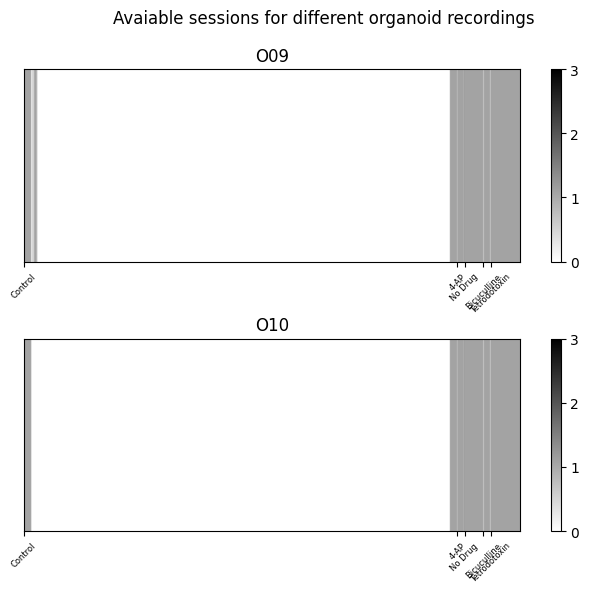

In [10]:
# Visualize Recordding Timeline

table = analysis.LFPSpectrogram.ChannelPower()
organoid_ids = np.unique((ephys.EphysSession & keys).fetch("organoid_id"))
N = len(organoid_ids)

fig, ax = plt.subplots(N, 1, figsize=(8,3*N))
fig.suptitle("Avaiable sessions for different organoid recordings")
fig.subplots_adjust(hspace=.4)

for i, organoid_id in enumerate(organoid_ids):

    organoid_table = table & keys & f"organoid_id = '{organoid_id}'"
    experiment_info = np.array((culture.Experiment & f"organoid_id = '{organoid_id}'").fetch("drug_name", "experiment_start_time", "experiment_end_time"))

    # Get start and end points for recording timeline
    recording_start, recording_end = (np.min(experiment_info[1:,:]), np.max(experiment_info[1:,:]))
    data_times = np.array(organoid_table.fetch("start_time", "end_time")).transpose()

    # Remove repeat values
    unique_times = []
    for times in data_times:
        if not list(times) in unique_times:
            unique_times.append(list(times))
    unique_times = np.array(unique_times)

    # Plot Binary Colormap for times
    recording_times = np.arange(recording_start, recording_end, datetime.timedelta(minutes=1))
    has_data = np.zeros(recording_times.shape)
    for times in unique_times:
        has_data[(times[0]<=recording_times) & (recording_times<=times[1])] +=1

    date_num = mdates.date2num(recording_times)
    extent = [date_num[0], date_num[-1], 0, 1]
    
    a = ax[i].imshow(has_data[np.newaxis, :], extent=extent, aspect="auto", cmap="binary")
    cbar = plt.colorbar(a)
    cbar.set_ticks(np.arange(np.min(has_data), np.max(has_data)+1))

    ax[i].set_xticks([date_num[np.where(recording_times==drug_time)][0] for drug_time in experiment_info[1,:]])
    ax[i].set_xticklabels(experiment_info[0,:], rotation=45, fontsize=6)
    ax[i].set_yticks([])
    ax[i].set_title(organoid_id)

**_Step 3: Determine Time Periods for Analysis_**

- Given the long recording timeline, it would be wise to reduce our dataset for complex analysis procedures.
- To determine the best way to reduce the dataset, we'll use power of LFP bands and firing rate z-scores: 
    - x-axis: Time (First 6 hours of recording, 6 hours before drug treatments, drug treatments (~50 hours of data per orgaonoid))
    - y-axis: z-score for power or firing rate ((data_value - control_mean)/control_std)
    - colors: Frequency bands (Delta, Theta, Alpha, Beta, Gamma, HG1, HG2), Firing Rate (max between 5*std and 25uV)
- Plot settings
    - electrodes = (list) electrodes to be used in analysis ("all"=all electrodes, "inside"=all inside, "outside"=all outside)
    - average = (bool) average electrodes or plot individual electrodes


In [6]:
def get_num_elec_inside(organoid_id: str):

    elec_inside = {
        "O9": 32, "O10": 16, "O11": 20, "O12": 14,
        "O13": 25, "O14": 13, "O15": 11, "O16": 11,
        "O17": 22, "O18": 19, "O19": 20, "O20": 17,
        "O21": 18, "O22": 21, "O23": 22, "O24": 23,
        "O25": 20, "O26": 32, "O27": 26, "O28": 24,
            }
    return elec_inside[organoid_id]

In [7]:
# Load Data
organoid_ids, start_times, end_times, electrodes, band_names, power = (analysis.LFPSpectrogram.ChannelPower & keys).fetch("organoid_id", "start_time", "end_time", "electrode", "band_name", "mean_power")

In [8]:
# choose time bin
dt = 60 # min

# Make sure all time intevals are the same length
time_interval = end_times - start_times
if not np.all(time_interval == time_interval[0]):
    raise ValueError("All sessions need to have the same session time length")

ti_min = time_interval[0].total_seconds() / 60

# Make sure dt is a multiple of the sesssion time interval
if not (dt % ti_min) == 0:
    raise ValueError(f"Please choose a dt which is a multiple of the session length = {ti_min}")

In [9]:
# Get Data
data_dict = {}

for organoid_id in np.unique(organoid_ids):

    # Make a Figure per Organoid
    org_electrodes = np.arange(get_num_elec_inside(organoid_id))
    freq_bands = np.unique(band_names)
    freq_bands = freq_bands[[2, 6, 0, 1, 3, 4, 5]]

    organoid_bool = (organoid_ids==organoid_id)

    recording_timeline = np.arange(np.min(start_times[organoid_bool]), np.max(end_times[organoid_bool]), np.timedelta64(dt, 'm'))
    recording_timeline = recording_timeline[:-1] # remove last value 
    
    # extract data
    data_array = np.zeros((len(recording_timeline), len(freq_bands), len(org_electrodes)))
    for t, time in enumerate(recording_timeline):
        # define time window
        ts, tf = (time, time+np.timedelta64(dt, 'm'))
        time_bool = (ts <= start_times) & (start_times <= tf) # defining windows based on start times, this is an approximation because loading power series takes too long (mean power instead)

        # check if there's data in the time window -> fill in nan values and move to next iteration
        if not np.any(time_bool):
            data_array[t,:,:] = np.nan
            continue

        for b, band in enumerate(freq_bands):
            band_bool = (band_names == band)

            for e, elec in enumerate(org_electrodes):
                elec_bool = (electrodes == elec)

                # extract data
                data_bool = organoid_bool & time_bool & band_bool & elec_bool
                data_array[t, b, e] = np.mean(power[data_bool])
    data_dict[organoid_id] = (recording_timeline, data_array)


In [10]:
# Plot Settings
take_average = True
used_electrodes = [] # [] = all inside electrodes

lfp_colors = [
    "#ad2bea",
    "#4d3ff8",
    "#39cabb",
    "#53e53a",
    "#e3e12c",
    "#f7a740",
    "#ed3838",
]

/var/folders/kj/qkc_fs3j2rx6nfm3mpsqdf940000gn/T/ipykernel_13208/1627119434.py:48: UserWarning: Data has no positive values, and therefore cannot be log-scaled.
  ax.set_yscale("log")
/var/folders/kj/qkc_fs3j2rx6nfm3mpsqdf940000gn/T/ipykernel_13208/1627119434.py:48: UserWarning: Data has no positive values, and therefore cannot be log-scaled.
  ax.set_yscale("log")


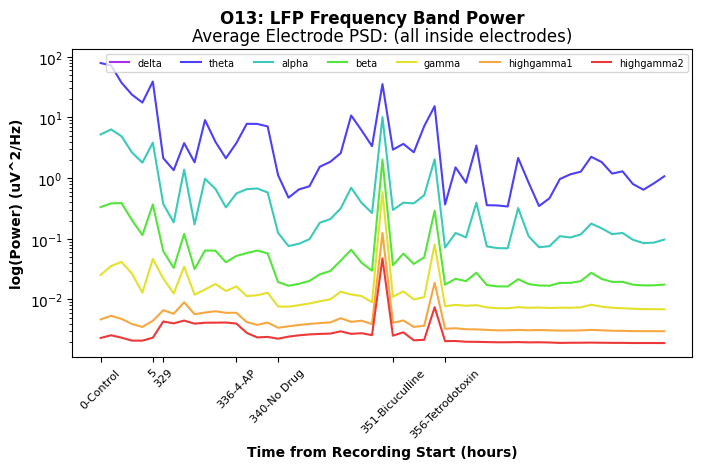

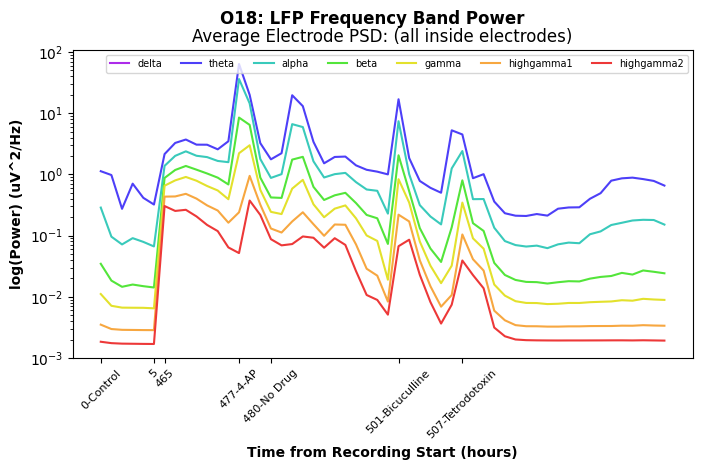

In [11]:
# Plot Data
for organoid_id, (recording_timeline, data_array) in data_dict.items():

    if len(used_electrodes) > 0:
        data_array = data_array[:,:,used_electrodes]
        elec_str = used_electrodes
    else:
        elec_str = "all inside electrodes"

    if take_average:
        plot_array = np.mean(data_array, axis=2)[:,:,np.newaxis]
        average_str = "Average"
    else:
        average_str = "Individual"

    # Remove nan values from recording timeline and plot data
    recording_bool = ~np.isnan(plot_array[:,0,0])
    plot_array = plot_array[recording_bool,:,:]
    plot_time = recording_timeline[recording_bool]

    # X-ticks (label breaks in recording and drug treatments)
    x_ticks = []
    x_tick_labels = []

    recording_time_idx = np.where(recording_bool==True)[0]
    recording_breaks = np.where(np.diff(recording_time_idx) > 12)[0]
    for recording_break in recording_breaks:
        x_ticks.extend([recording_break, recording_break+1])
        x_tick_labels.extend([recording_time_idx[recording_break], recording_time_idx[recording_break+1]])

    drug_names, drug_times = (culture.Experiment & f"organoid_id = '{organoid_id}'").fetch("drug_name", "experiment_start_time")
    for d in range(len(drug_names)):
        didx = np.argmin(np.abs(plot_time - drug_times.astype(np.datetime64)[d]))
        x_ticks.extend([didx])
        x_tick_labels.extend([f"{recording_time_idx[didx]}-{drug_names[d]}"])


    N = plot_array.shape[2]
    fig, ax = plt.subplots(N, 1, figsize=(8,4*N))
    fig.suptitle(f"{organoid_id}: LFP Frequency Band Power", weight="bold")
    for i in range(N):
        if i > 0:
            ax = ax[i]

        for f in range(len(freq_bands)):
            
            ax.plot(plot_array[:,f,i], color=lfp_colors[f], label=freq_bands[f])
            ax.set_yscale("log")

        ax.set_title(f"{average_str} Electrode PSD: ({elec_str})")
        ax.set_ylabel("log(Power) (uV^2/Hz)", weight="bold")
        ax.set_xlabel("Time from Recording Start (hours)", weight="bold")
        if i == 0:
            ax.legend(loc="upper right", ncol=7, fontsize=7)
        ax.set_xticks(x_ticks)
        ax.set_xticklabels(x_tick_labels, fontsize=8, rotation=45)


Visualize changes in firing rate
z-score of firing rate with unique control/ std values
- For the z-score of dt(n) -> u and sigma will be from dt(n-1)
- Z scores with values more extreme than 2 (+ or =) will be marked and not included for the next z-score calculation
- ex: if day 3 has an extreme value, the mean and std of day 2 will be used to calculate the zscore for day 4

In [4]:
# Parameters
dt = 12 # hours
thresh = 2 # z-scores

def get_num_elec_inside(organoid_id: str):

    elec_inside = {
        "O09": 32, "O10": 16, "O11": 20, "O12": 14,
        "O13": 25, "O14": 13, "O15": 11, "O16": 11,
        "O17": 22, "O18": 19, "O19": 20, "O20": 17,
        "O21": 18, "O22": 21, "O23": 22, "O24": 23,
        "O25": 20, "O26": 32, "O27": 26, "O28": 24,
            }
    return elec_inside[organoid_id]

In [5]:
organoid_ids = np.unique(mua.MUASpikes().fetch("organoid_id"))

# for organoid id in organoid_ids:
organoid_id = "O09"
organoid_spikes = (mua.MUASpikes.Channel & f"organoid_id = '{organoid_id}'")

# Extract information from MUASpikes Table
start_time, channel_idx, spike_rate = organoid_spikes.fetch("start_time", "channel_idx", "spike_rate")
recording_start = (culture.Experiment & f"organoid_id = '{organoid_id}'" & "drug_name = 'Control'").fetch1("experiment_start_time")
recording_end = np.sort(start_time)[-1]

bins = np.arange(recording_start, recording_end, datetime.timedelta(hours=dt))
bins = bins[:-2] # bins = bin start times 

firing_rate_array = []
recording_ratio_list = []
# loop through time windows
for bin in bins:

    # find times for each window
    bin_bool = (bin <=start_time) & (start_time <= (bin+np.timedelta64(dt, 'h')))
    bin_times = np.unique(start_time[bin_bool])

    # extract necessary info (recording_ratio, firing rate (per channel))
    recording_ratio = len(bin_times) / dt*60 # num minutes of recording / total minutes in interval
    recording_ratio_list.append(recording_ratio)

    # loop thorugh electrodes to find firing rate
    bin_firing_rate = []
    electrodes = np.arange(get_num_elec_inside(organoid_id)) # number of electrodes inside organoid
    for electrode in electrodes:
        electrode_spikes = spike_rate[(bin_bool) & (channel_idx == electrode)] # filter by time window and electrode id
        bin_firing_rate.append(np.mean(electrode_spikes))
    
    firing_rate_array.append(bin_firing_rate)
firing_rate_array = np.array(firing_rate_array)
firing_rate_array = firing_rate_array[~np.isnan(firing_rate_array[:,0]), :]

16 periods have an abs(z-score) > 2


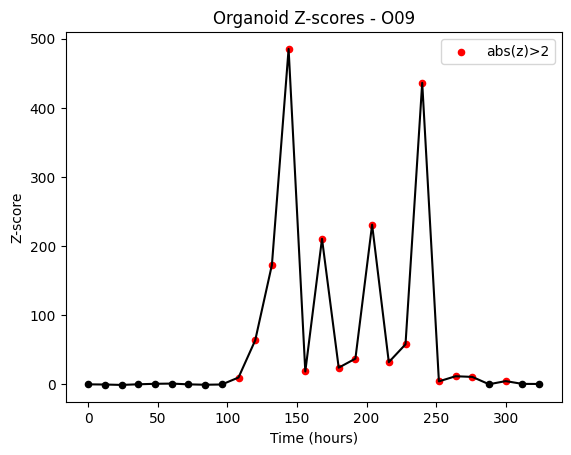

In [6]:
# Plot Moving Z-scores
N = firing_rate_array.shape[0]
fr_mean = np.mean(firing_rate_array, axis=1)
fr_std = np.std(firing_rate_array, axis=1)

z_list = []
for i in range(N):

    if i == 0:
        z = 0

    else:  
        # check if previous z scores exceed the threshold (won't use those values as a baseline)
        ref_idx = i-1
        while abs(z_list[ref_idx]) >= thresh:
            ref_idx -= 1
        
        z = (fr_mean[i] - fr_mean[ref_idx]) / fr_std[ref_idx]
    
    z_list.append(z)

z_list = np.array(z_list)
outlier_times = np.abs(z_list) > 2
print(f"{sum(outlier_times)} periods have an abs(z-score) > 2")
t = np.arange(0, dt*len(z_list), dt)

plt.plot(t, z_list, color='k', linestyle='-')
plt.scatter(t[~outlier_times], z_list[~outlier_times], s=20, color='k')
plt.scatter(t[outlier_times], z_list[outlier_times], s=20, color='r', label="abs(z)>2")

plt.title(f"Organoid Z-scores - {organoid_id}")
plt.ylabel("Z-score")
plt.xlabel("Time (hours)")
plt.legend()


[2025-06-16 18:56:16,096][WARNING]: MySQL server has gone away. Reconnecting to the server.
/var/folders/kj/qkc_fs3j2rx6nfm3mpsqdf940000gn/T/ipykernel_13566/3210391258.py:21: DeprecationWarning:

Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)



([<matplotlib.axis.XTick at 0x12c273250>,
 [Text(0, 0, '0'), Text(702, 0, '702')])

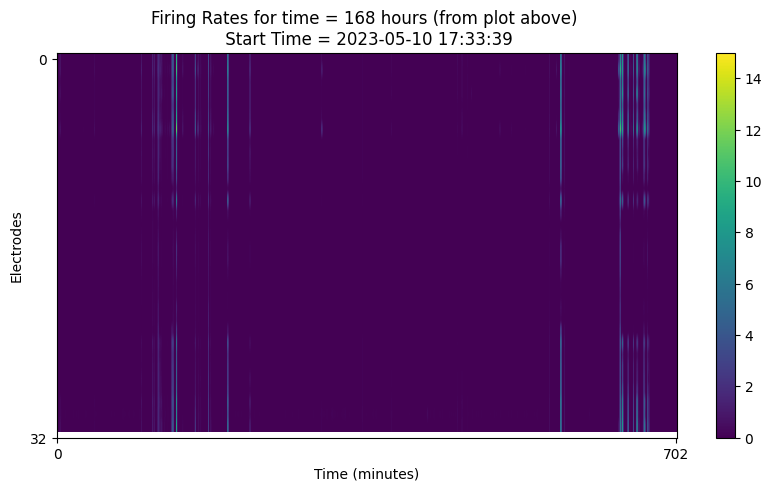

In [ ]:
# Investigate Peak at 10 hours
idx = np.argmax(z_list) + 2

idx_time = bins[idx]
time_spikes = organoid_spikes & f"start_time BETWEEN '{idx_time}' AND '{idx_time+np.timedelta64(dt, 'h')}'"

# Extract information from MUASpikes Table
start_time, channel_idx, spike_rate = time_spikes.fetch("start_time", "channel_idx", "spike_rate")

times = np.unique(start_time)
N = len(times)
num_elec = get_num_elec_inside(organoid_id)

firing_rate_plot = np.empty((num_elec, N))

# loop through times and electrodes
for t, time in enumerate(times):
    for elec in range(num_elec):
        
        firing_rate = spike_rate[(start_time == time) & (channel_idx == elec)]
        firing_rate_plot[elec, t] = firing_rate

plt.figure(figsize = (10,5))
plt.imshow(firing_rate_plot, aspect="auto")
cbar = plt.colorbar()
cbar.set_label("Firing Rate (Hz)")


plt.title(f"Firing Rates for time = {idx*dt} hours (from plot above) \n Start Time = {times[0]}")
plt.ylabel("Electrodes")
plt.xlabel("Time (minutes)")
plt.yticks([0, num_elec])
plt.xticks([0, t])



In [8]:
# Investigate the maximum value 
max_idx = np.argmax(firing_rate_plot)
max_channel, max_time_idx = np.unravel_index(max_idx, firing_rate_plot.shape)
max_time = times[max_time_idx]

print(max_channel, max_time, firing_rate_plot[max_channel, max_time_idx])
trace_key = (mua.MUATracePlot.Channel & f"channel_idx = '{max_channel}'" & f"start_time = '{max_time}'").fetch1("KEY")

trace_plot = (mua.MUATracePlot.Channel & trace_key).fetch1("trace_plot")

fig = pio.from_json(trace_plot)
fig.show()

30 2023-05-09 20:27:54 43.9


ValueError: 
    Invalid value of type 'builtins.dict' received for the 'x' property of scatter
        Received value: {'dtype': 'f8', 'bdata': 'AAAAAAAAAAAtQxzr4jYKPy1DHOviNho/YTJVMCqpIz8tQxzr4jYqP/yp8dJNYjA/YTJVMCqpMz/HuriNBvA2Py1DHOviNjo/kst/SL99PT/8qfHSTWJAPy9uowG8BUI/YTJVMCqpQz+U9gZfmExFP8e6uI0G8EY/+n5qvHSTSD8tQxzr4jZKP18HzhlR2ks/kst/SL99TT/FjzF3LSFPP/yp8dJNYlA/FYxK6gQ0UT8vbqMBvAVSP0hQ/Bhz11I/YTJVMCqpUz97FK5H4XpUP5T2Bl+YTFU/rthfdk8eVj/HuriNBvBWP+CcEaW9wVc/+n5qvHSTWD8TYcPTK2VZPy1DHOviNlo/RiV1ApoIWz9fB84ZUdpbP3npJjEIrFw/kst/SL99XT+srdhfdk9eP8WPMXctIV8/3nGKjuTyXz/8qfHSTWJgPwkbnl4py2A/FYxK6gQ0YT8i/fZ14JxhPy9uowG8BWI/O99PjZduYj9IUPwYc9diP1XBqKROQGM/YTJVMCqpYz9uowG8BRJkP3sUrkfhemQ/iIVa07zjZD+U9gZfmExlP6Fns+pztWU/rthfdk8eZj+6SQwCK4dmP8e6uI0G8GY/1CtlGeJYZz/gnBGlvcFnP+0NvjCZKmg/+n5qvHSTaD8H8BZIUPxoPxNhw9MrZWk/INJvXwfOaT8tQxzr4jZqPzm0yHa+n2o/RiV1ApoIaz9TliGOdXFrP18HzhlR2ms/bHh6pSxDbD956SYxCKxsP4Za07zjFG0/kst/SL99bT+fPCzUmuZtP6yt2F92T24/uB6F61G4bj/FjzF3LSFvP9IA3gIJim8/3nGKjuTybz92cRsN4C1wP/yp8dJNYnA/guLHmLuWcD8JG55eKctwP49TdCSX/3A/FYxK6gQ0cT+cxCCwcmhxPyL99nXgnHE/qDXNO07RcT8vbqMBvAVyP7WmeccpOnI/O99PjZducj/CFyZTBaNyP0hQ/Bhz13I/zojS3uALcz9VwaikTkBzP9v5fmq8dHM/YTJVMCqpcz/oaiv2l91zP26jAbwFEnQ/9dvXgXNGdD97FK5H4Xp0PwFNhA1Pr3Q/iIVa07zjdD8OvjCZKhh1P5T2Bl+YTHU/Gy/dJAaBdT+hZ7Pqc7V1PyegibDh6XU/rthfdk8edj80ETY8vVJ2P7pJDAIrh3Y/QYLix5i7dj/HuriNBvB2P03zjlN0JHc/1CtlGeJYdz9aZDvfT413P+CcEaW9wXc/Z9Xnaiv2dz/tDb4wmSp4P3RGlPYGX3g/+n5qvHSTeD+At0CC4sd4PwfwFkhQ/Hg/jSjtDb4weT8TYcPTK2V5P5qZmZmZmXk/INJvXwfOeT+mCkYldQJ6Py1DHOviNno/s3vysFBrej85tMh2vp96P8Dsnjws1Ho/RiV1ApoIez/MXUvIBz17P1OWIY51cXs/2c73U+Olez9fB84ZUdp7P+Y/pN++Dnw/bHh6pSxDfD/ysFBrmnd8P3npJjEIrHw//yH99nXgfD+GWtO84xR9PwyTqYJRSX0/kst/SL99fT8ZBFYOLbJ9P588LNSa5n0/JXUCmggbfj+srdhfdk9+PzLmriXkg34/uB6F61G4fj8/V1uxv+x+P8WPMXctIX8/S8gHPZtVfz/SAN4CCYp/P1g5tMh2vn8/3nGKjuTyfz8yVTAqqROAP3ZxGw3gLYA/uY0G8BZIgD/8qfHSTWKAPz/G3LWEfIA/guLHmLuWgD/F/rJ78rCAPwkbnl4py4A/TDeJQWDlgD+PU3Qkl/+AP9JvXwfOGYE/FYxK6gQ0gT9YqDXNO06BP5zEILByaIE/3+ALk6mCgT8i/fZ14JyBP2UZ4lgXt4E/qDXNO07RgT/sUbgeheuBPy9uowG8BYI/coqO5PIfgj+1pnnHKTqCP/jCZKpgVII/O99PjZdugj9/+zpwzoiCP8IXJlMFo4I/BTQRNjy9gj9IUPwYc9eCP4ts5/up8YI/zojS3uALgz8Spb3BFyaDP1XBqKROQIM/mN2Th4Vagz/b+X5qvHSDPx4Wak3zjoM/YTJVMCqpgz+lTkATYcODP+hqK/aX3YM/K4cW2c73gz9uowG8BRKEP7G/7J48LIQ/9dvXgXNGhD84+MJkqmCEP3sUrkfheoQ/vjCZKhiVhD8BTYQNT6+EP0Rpb/CFyYQ/iIVa07zjhD/LoUW28/2EPw6+MJkqGIU/UdobfGEyhT+U9gZfmEyFP9cS8kHPZoU/Gy/dJAaBhT9eS8gHPZuFP6Fns+pztYU/5IOezarPhT8noImw4emFP2q8dJMYBIY/rthfdk8ehj/x9EpZhjiGPzQRNjy9UoY/dy0hH/Rshj+6SQwCK4eGP/5l9+RhoYY/QYLix5i7hj+Ens2qz9WGP8e6uI0G8IY/CtejcD0Khz9N845TdCSHP5EPejarPoc/1CtlGeJYhz8XSFD8GHOHP1pkO99PjYc/nYAmwoanhz/gnBGlvcGHPyS5/If024c/Z9Xnaiv2hz+q8dJNYhCIP+0NvjCZKog/MCqpE9BEiD90RpT2Bl+IP7dif9k9eYg/+n5qvHSTiD89m1Wfq62IP4C3QILix4g/w9MrZRniiD8H8BZIUPyIP0oMAiuHFok/jSjtDb4wiT/QRNjw9EqJPxNhw9MrZYk/Vn2utmJ/iT+amZmZmZmJP921hHzQs4k/INJvXwfOiT9j7lpCPuiJP6YKRiV1Aoo/6SYxCKwcij8tQxzr4jaKP3BfB84ZUYo/s3vysFBrij/2l92Th4WKPzm0yHa+n4o/fdCzWfW5ij/A7J48LNSKPwMJih9j7oo/RiV1ApoIiz+JQWDl0CKLP8xdS8gHPYs/EHo2qz5Xiz9TliGOdXGLP5ayDHGsi4s/2c73U+Oliz8c6+I2GsCLP18HzhlR2os/oyO5/If0iz/mP6Tfvg6MPylcj8L1KIw/bHh6pSxDjD+vlGWIY12MP/KwUGuad4w/Ns07TtGRjD956SYxCKyMP7wFEhQ/xow//yH99nXgjD9CPujZrPqMP4Za07zjFI0/yXa+nxovjT8Mk6mCUUmNP0+vlGWIY40/kst/SL99jT/V52or9peNPxkEVg4tso0/XCBB8WPMjT+fPCzUmuaNP+JYF7fRAI4/JXUCmggbjj9oke18PzWOP6yt2F92T44/78nDQq1pjj8y5q4l5IOOP3UCmggbno4/uB6F61G4jj/7OnDOiNKOPz9XW7G/7I4/gnNGlPYGjz/FjzF3LSGPPwisHFpkO48/S8gHPZtVjz+P5PIf0m+PP9IA3gIJio8/FR3J5T+kjz9YObTIdr6PP5tVn6ut2I8/3nGKjuTyjz8Rx7q4jQaQPzJVMCqpE5A/VOOlm8QgkD92cRsN4C2QP5f/kH77OpA/uY0G8BZIkD/aG3xhMlWQP/yp8dJNYpA/HThnRGlvkD8/xty1hHyQP2FUUiegiZA/guLHmLuWkD+kcD0K16OQP8X+snvysJA/54wo7Q2+kD8JG55eKcuQPyqpE9BE2JA/TDeJQWDlkD9txf6ye/KQP49TdCSX/5A/seHplbIMkT/Sb18HzhmRP/T91HjpJpE/FYxK6gQ0kT83GsBbIEGRP1ioNc07TpE/ejarPldbkT+cxCCwcmiRP71SliGOdZE/3+ALk6mCkT8Ab4EExY+RPyL99nXgnJE/RIts5/upkT9lGeJYF7eRP4enV8oyxJE/qDXNO07RkT/Kw0Ktad6RP+xRuB6F65E/DeAtkKD4kT8vbqMBvAWSP1D8GHPXEpI/coqO5PIfkj+TGARWDi2SP7WmeccpOpI/1zTvOEVHkj/4wmSqYFSSPxpR2ht8YZI/O99PjZdukj9dbcX+snuSP3/7OnDOiJI/oImw4emVkj/CFyZTBaOSP+Olm8QgsJI/BTQRNjy9kj8nwoanV8qSP0hQ/Bhz15I/at5xio7kkj+LbOf7qfGSP636XG3F/pI/zojS3uALkz/wFkhQ/BiTPxKlvcEXJpM/MzMzMzMzkz9VwaikTkCTP3ZPHhZqTZM/mN2Th4Vakz+6awn5oGeTP9v5fmq8dJM//Yf029eBkz8eFmpN846TP0Ck374OnJM/YTJVMCqpkz+DwMqhRbaTP6VOQBNhw5M/xty1hHzQkz/oaiv2l92TPwn5oGez6pM/K4cW2c73kz9NFYxK6gSUP26jAbwFEpQ/kDF3LSEflD+xv+yePCyUP9NNYhBYOZQ/9dvXgXNGlD8Wak3zjlOUPzj4wmSqYJQ/WYY41sVtlD97FK5H4XqUP5yiI7n8h5Q/vjCZKhiVlD/gvg6cM6KUPwFNhA1Pr5Q/I9v5fmq8lD9EaW/whcmUP2b35GGh1pQ/iIVa07zjlD+pE9BE2PCUP8uhRbbz/ZQ/7C+7Jw8LlT8OvjCZKhiVPzBMpgpGJZU/UdobfGEylT9zaJHtfD+VP5T2Bl+YTJU/toR80LNZlT/XEvJBz2aVP/mgZ7Pqc5U/Gy/dJAaBlT88vVKWIY6VP15LyAc9m5U/f9k9eViolT+hZ7Pqc7WVP8P1KFyPwpU/5IOezarPlT8GEhQ/xtyVPyegibDh6ZU/SS7/If32lT9qvHSTGASWP4xK6gQ0EZY/rthfdk8elj/PZtXnaiuWP/H0SlmGOJY/EoPAyqFFlj80ETY8vVKWP1afq63YX5Y/dy0hH/Rslj+Zu5aQD3qWP7pJDAIrh5Y/3NeBc0aUlj/+ZffkYaGWPx/0bFZ9rpY/QYLix5i7lj9iEFg5tMiWP4SezarP1ZY/pSxDHOvilj/HuriNBvCWP+lILv8h/ZY/CtejcD0Klz8sZRniWBeXP03zjlN0JJc/b4EExY8xlz+RD3o2qz6XP7Kd76fGS5c/1CtlGeJYlz/1udqK/WWXPxdIUPwYc5c/OdbFbTSAlz9aZDvfT42XP3zysFBrmpc/nYAmwoanlz+/DpwzorSXP+CcEaW9wZc/AiuHFtnOlz8kufyH9NuXP0VHcvkP6Zc/Z9Xnaiv2lz+IY13cRgOYP6rx0k1iEJg/zH9Iv30dmD/tDb4wmSqYPw+cM6K0N5g/MCqpE9BEmD9SuB6F61GYP3RGlPYGX5g/ldQJaCJsmD+3Yn/ZPXmYP9jw9EpZhpg/+n5qvHSTmD8bDeAtkKCYPz2bVZ+rrZg/XynLEMe6mD+At0CC4seYP6JFtvP91Jg/w9MrZRnimD/lYaHWNO+YPwfwFkhQ/Jg/KH6MuWsJmT9KDAIrhxaZP2uad5yiI5k/jSjtDb4wmT+utmJ/2T2ZP9BE2PD0Spk/8tJNYhBYmT8TYcPTK2WZPzXvOEVHcpk/Vn2utmJ/mT94CyQofoyZP5qZmZmZmZk/uycPC7WmmT/dtYR80LOZP/5D+u3rwJk/INJvXwfOmT9CYOXQItuZP2PuWkI+6Jk/hXzQs1n1mT+mCkYldQKaP8iYu5aQD5o/6SYxCKwcmj8LtaZ5xymaPy1DHOviNpo/TtGRXP5Dmj9wXwfOGVGaP5HtfD81Xpo/s3vysFBrmj/VCWgibHiaP/aX3ZOHhZo/GCZTBaOSmj85tMh2vp+aP1tCPujZrJo/fdCzWfW5mj+eXinLEMeaP8Dsnjws1Jo/4XoUrkfhmj8DCYofY+6aPySX/5B++5o/RiV1ApoImz9os+pztRWbP4lBYOXQIps/q8/VVuwvmz/MXUvIBz2bP+7rwDkjSps/EHo2qz5Xmz8xCKwcWmSbP1OWIY51cZs/dCSX/5B+mz+WsgxxrIubP7hAguLHmJs/2c73U+Olmz/7XG3F/rKbPxzr4jYawJs/PnlYqDXNmz9fB84ZUdqbP4GVQ4ts55s/oyO5/If0mz/EsS5uowGcP+Y/pN++Dpw/B84ZUdobnD8pXI/C9SicP0vqBDQRNpw/bHh6pSxDnD+OBvAWSFCcP6+UZYhjXZw/0SLb+X5qnD/ysFBrmnecPxQ/xty1hJw/Ns07TtGRnD9XW7G/7J6cP3npJjEIrJw/mnecoiO5nD+8BRIUP8acP96Th4Va05w//yH99nXgnD8hsHJoke2cP0I+6Nms+pw/ZMxdS8gHnT+GWtO84xSdP6foSC7/IZ0/yXa+nxovnT/qBDQRNjydPwyTqYJRSZ0/LSEf9GxWnT9Pr5RliGOdP3E9CtejcJ0/kst/SL99nT+0WfW52oqdP9Xnaiv2l50/93XgnBGlnT8ZBFYOLbKdPzqSy39Iv50/XCBB8WPMnT99rrZif9mdP588LNSa5p0/wcqhRbbznT/iWBe30QCePwTnjCjtDZ4/JXUCmggbnj9HA3gLJCieP2iR7Xw/NZ4/ih9j7lpCnj+srdhfdk+eP807TtGRXJ4/78nDQq1pnj8QWDm0yHaePzLmriXkg54/VHQkl/+Qnj91ApoIG56eP5eQD3o2q54/uB6F61G4nj/arPpcbcWeP/s6cM6I0p4/HcnlP6Tfnj8/V1uxv+yeP2Dl0CLb+Z4/gnNGlPYGnz+jAbwFEhSfP8WPMXctIZ8/5x2n6Egunz8IrBxaZDufPyo6kst/SJ8/S8gHPZtVnz9tVn2utmKfP4/k8h/Sb58/sHJoke18nz/SAN4CCYqfP/OOU3Qkl58/FR3J5T+knz82qz5XW7GfP1g5tMh2vp8/escpOpLLnz+bVZ+rrdifP73jFB3J5Z8/3nGKjuTynz8AAAAAAACgPxHHuriNBqA/Io51cRsNoD8yVTAqqROgP0Mc6+I2GqA/VOOlm8QgoD9lqmBUUiegP3ZxGw3gLaA/hjjWxW00oD+X/5B++zqgP6jGSzeJQaA/uY0G8BZIoD/KVMGopE6gP9obfGEyVaA/6+I2GsBboD/8qfHSTWKgPw1xrIvbaKA/HThnRGlvoD8u/yH99nWgPz/G3LWEfKA/UI2XbhKDoD9hVFInoImgP3EbDeAtkKA/guLHmLuWoD+TqYJRSZ2gP6RwPQrXo6A/tTf4wmSqoD/F/rJ78rCgP9bFbTSAt6A/54wo7Q2+oD/4U+Olm8SgPwkbnl4py6A/GeJYF7fRoD8qqRPQRNigPztwzojS3qA/TDeJQWDloD9d/kP67eugP23F/rJ78qA/foy5awn5oD+PU3Qkl/+gP6AaL90kBqE/seHplbIMoT/BqKROQBOhP9JvXwfOGaE/4zYawFsgoT/0/dR46SahPwXFjzF3LaE/FYxK6gQ0oT8mUwWjkjqhPzcawFsgQaE/SOF6FK5HoT9YqDXNO06hP2lv8IXJVKE/ejarPldboT+L/WX35GGhP5zEILByaKE/rIvbaABvoT+9UpYhjnWhP84ZUdobfKE/3+ALk6mCoT/wp8ZLN4mhPwBvgQTFj6E/ETY8vVKWoT8i/fZ14JyhPzPEsS5uo6E/RIts5/upoT9UUiegibChP2UZ4lgXt6E/duCcEaW9oT+Hp1fKMsShP5huEoPAyqE/qDXNO07RoT+5/If029ehP8rDQq1p3qE/24r9ZffkoT/sUbgeheuhP/wYc9cS8qE/DeAtkKD4oT8ep+hILv+hPy9uowG8BaI/PzVeukkMoj9Q/Bhz1xKiP2HD0ytlGaI/coqO5PIfoj+DUUmdgCaiP5MYBFYOLaI/pN++Dpwzoj+1pnnHKTqiP8ZtNIC3QKI/1zTvOEVHoj/n+6nx0k2iP/jCZKpgVKI/CYofY+5aoj8aUdobfGGiPysYldQJaKI/O99PjZduoj9MpgpGJXWiP11txf6ye6I/bjSAt0CCoj9/+zpwzoiiP4/C9Shcj6I/oImw4emVoj+xUGuad5yiP8IXJlMFo6I/097gC5Opoj/jpZvEILCiP/RsVn2utqI/BTQRNjy9oj8W+8vuycOiPyfChqdXyqI/N4lBYOXQoj9IUPwYc9eiP1kXt9EA3qI/at5xio7koj96pSxDHOuiP4ts5/up8aI/nDOitDf4oj+t+lxtxf6iP77BFyZTBaM/zojS3uALoz/fT42XbhKjP/AWSFD8GKM/Ad4CCYofoz8Spb3BFyajPyJseHqlLKM/MzMzMzMzoz9E+u3rwDmjP1XBqKROQKM/ZohjXdxGoz92Tx4Wak2jP4cW2c73U6M/mN2Th4Vaoz+ppE5AE2GjP7prCfmgZ6M/yjLEsS5uoz/b+X5qvHSjP+zAOSNKe6M//Yf029eBoz8OT6+UZYijPx4Wak3zjqM/L90kBoGVoz9ApN++DpyjP1FrmnecoqM/YTJVMCqpoz9y+Q/pt6+jP4PAyqFFtqM/lIeFWtO8oz+lTkATYcOjP7UV+8vuyaM/xty1hHzQoz/Xo3A9CtejP+hqK/aX3aM/+THmriXkoz8J+aBns+qjPxrAWyBB8aM/K4cW2c73oz88TtGRXP6jP00VjErqBKQ/XdxGA3gLpD9uowG8BRKkP39qvHSTGKQ/kDF3LSEfpD+h+DHmriWkP7G/7J48LKQ/woanV8oypD/TTWIQWDmkP+QUHcnlP6Q/9dvXgXNGpD8Fo5I6AU2kPxZqTfOOU6Q/JzEIrBxapD84+MJkqmCkP0i/fR04Z6Q/WYY41sVtpD9qTfOOU3SkP3sUrkfheqQ/jNtoAG+BpD+coiO5/IekP61p3nGKjqQ/vjCZKhiVpD/P91PjpZukP+C+DpwzoqQ/8IXJVMGopD8BTYQNT6+kPxIUP8bctaQ/I9v5fmq8pD80orQ3+MKkP0Rpb/CFyaQ/VTAqqRPQpD9m9+RhodakP3e+nxov3aQ/iIVa07zjpD+YTBWMSuqkP6kT0ETY8KQ/utqK/WX3pD/LoUW28/2kP9xoAG+BBKU/7C+7Jw8LpT/99nXgnBGlPw6+MJkqGKU/H4XrUbgepT8wTKYKRiWlP0ATYcPTK6U/UdobfGEypT9iodY07zilP3Noke18P6U/gy9MpgpGpT+U9gZfmEylP6W9wRcmU6U/toR80LNZpT/HSzeJQWClP9cS8kHPZqU/6Nms+lxtpT/5oGez6nOlPwpoImx4eqU/Gy/dJAaBpT8r9pfdk4elPzy9UpYhjqU/TYQNT6+UpT9eS8gHPZulP28Sg8DKoaU/f9k9eViopT+QoPgx5q6lP6Fns+pztaU/si5uowG8pT/D9Shcj8KlP9O84xQdyaU/5IOezarPpT/1SlmGONalPwYSFD/G3KU/F9nO91PjpT8noImw4emlPzhnRGlv8KU/SS7/If32pT9a9bnaiv2lP2q8dJMYBKY/e4MvTKYKpj+MSuoENBGmP50Rpb3BF6Y/rthfdk8epj++nxov3SSmP89m1edqK6Y/4C2QoPgxpj/x9EpZhjimPwK8BRIUP6Y/EoPAyqFFpj8jSnuDL0ymPzQRNjy9UqY/Rdjw9EpZpj9Wn6ut2F+mP2ZmZmZmZqY/dy0hH/Rspj+I9NvXgXOmP5m7lpAPeqY/qoJRSZ2Apj+6SQwCK4emP8sQx7q4jaY/3NeBc0aUpj/tnjws1JqmP/5l9+RhoaY/Di2yne+npj8f9GxWfa6mPzC7Jw8LtaY/QYLix5i7pj9SSZ2AJsKmP2IQWDm0yKY/c9cS8kHPpj+Ens2qz9WmP5VliGNd3KY/pSxDHOvipj+28/3UeOmmP8e6uI0G8KY/2IFzRpT2pj/pSC7/If2mP/kP6bevA6c/CtejcD0Kpz8bnl4pyxCnPyxlGeJYF6c/PSzUmuYdpz9N845TdCSnP166SQwCK6c/b4EExY8xpz+ASL99HTinP5EPejarPqc/odY07zhFpz+yne+nxkunP8NkqmBUUqc/1CtlGeJYpz/l8h/Sb1+nP/W52or9Zac/BoGVQ4tspz8XSFD8GHOnPygPC7Wmeac/OdbFbTSApz9JnYAmwoanP1pkO99Pjac/ayv2l92Tpz988rBQa5qnP4y5awn5oKc/nYAmwoanpz+uR+F6FK6nP78OnDOitKc/0NVW7C+7pz/gnBGlvcGnP/FjzF1LyKc/AiuHFtnOpz8T8kHPZtWnPyS5/If026c/NIC3QILipz9FR3L5D+mnP1YOLbKd76c/Z9Xnaiv2pz94nKIjufynP4hjXdxGA6g/mSoYldQJqD+q8dJNYhCoP7u4jQbwFqg/zH9Iv30dqD/cRgN4CySoP+0NvjCZKqg//tR46SYxqD8PnDOitDeoPyBj7lpCPqg/MCqpE9BEqD9B8WPMXUuoP1K4HoXrUag/Y3/ZPXlYqD90RpT2Bl+oP4QNT6+UZag/ldQJaCJsqD+mm8QgsHKoP7dif9k9eag/xyk6kst/qD/Y8PRKWYaoP+m3rwPnjKg/+n5qvHSTqD8LRiV1ApqoPxsN4C2QoKg/LNSa5h2nqD89m1Wfq62oP05iEFg5tKg/XynLEMe6qD9v8IXJVMGoP4C3QILix6g/kX77OnDOqD+iRbbz/dSoP7MMcayL26g/w9MrZRniqD/UmuYdp+ioP+VhodY076g/9ihcj8L1qD8H8BZIUPyoPxe30QDeAqk/KH6MuWsJqT85RUdy+Q+pP0oMAiuHFqk/W9O84xQdqT9rmnecoiOpP3xhMlUwKqk/jSjtDb4wqT+e76fGSzepP662Yn/ZPak/v30dOGdEqT/QRNjw9EqpP+ELk6mCUak/8tJNYhBYqT8Cmggbnl6pPxNhw9MrZak/JCh+jLlrqT817zhFR3KpP0a28/3UeKk/Vn2utmJ/qT9nRGlv8IWpP3gLJCh+jKk/idLe4AuTqT+amZmZmZmpP6pgVFInoKk/uycPC7WmqT/M7snDQq2pP921hHzQs6k/7nw/NV66qT/+Q/rt68CpPw8LtaZ5x6k/INJvXwfOqT8xmSoYldSpP0Jg5dAi26k/UiegibDhqT9j7lpCPuipP3S1FfvL7qk/hXzQs1n1qT+WQ4ts5/upP6YKRiV1Aqo/t9EA3gIJqj/ImLuWkA+qP9lfdk8eFqo/6SYxCKwcqj/67evAOSOqPwu1pnnHKao/HHxhMlUwqj8tQxzr4jaqPz0K16NwPao/TtGRXP5Dqj9fmEwVjEqqP3BfB84ZUao/gSbChqdXqj+R7Xw/NV6qP6K0N/jCZKo/s3vysFBrqj/EQq1p3nGqP9UJaCJseKo/5dAi2/l+qj/2l92Th4WqPwdfmEwVjKo/GCZTBaOSqj8p7Q2+MJmqPzm0yHa+n6o/SnuDL0ymqj9bQj7o2ayqP2wJ+aBns6o/fdCzWfW5qj+Nl24Sg8CqP55eKcsQx6o/ryXkg57Nqj/A7J48LNSqP9CzWfW52qo/4XoUrkfhqj/yQc9m1eeqPwMJih9j7qo/FNBE2PD0qj8kl/+QfvuqPzVeukkMAqs/RiV1ApoIqz9X7C+7Jw+rP2iz6nO1Fas/eHqlLEMcqz+JQWDl0CKrP5oIG55eKas/q8/VVuwvqz+8lpAPejarP8xdS8gHPas/3SQGgZVDqz/u68A5I0qrP/+ye/KwUKs/EHo2qz5Xqz8gQfFjzF2rPzEIrBxaZKs/Qs9m1edqqz9TliGOdXGrP2Rd3EYDeKs/dCSX/5B+qz+F61G4HoWrP5ayDHGsi6s/p3nHKTqSqz+4QILix5irP8gHPZtVn6s/2c73U+Olqz/qlbIMcayrP/tcbcX+sqs/CyQofoy5qz8c6+I2GsCrPy2yne+nxqs/PnlYqDXNqz9PQBNhw9OrP18HzhlR2qs/cM6I0t7gqz+BlUOLbOerP5Jc/kP67as/oyO5/If0qz+z6nO1FfurP8SxLm6jAaw/1XjpJjEIrD/mP6Tfvg6sP/cGX5hMFaw/B84ZUdobrD8YldQJaCKsPylcj8L1KKw/OiNKe4MvrD9L6gQ0ETasP1uxv+yePKw/bHh6pSxDrD99PzVeukmsP44G8BZIUKw/n82qz9VWrD+vlGWIY12sP8BbIEHxY6w/0SLb+X5qrD/i6ZWyDHGsP/KwUGuad6w/A3gLJCh+rD8UP8bctYSsPyUGgZVDi6w/Ns07TtGRrD9GlPYGX5isP1dbsb/snqw/aCJseHqlrD956SYxCKysP4qw4emVsqw/mnecoiO5rD+rPldbsb+sP7wFEhQ/xqw/zczMzMzMrD/ek4eFWtOsP+5aQj7o2aw//yH99nXgrD8Q6bevA+esPyGwcmiR7aw/MnctIR/0rD9CPujZrPqsP1MFo5I6Aa0/ZMxdS8gHrT91kxgEVg6tP4Za07zjFK0/liGOdXEbrT+n6Egu/yGtP7ivA+eMKK0/yXa+nxovrT/ZPXlYqDWtP+oENBE2PK0/+8vuycNCrT8Mk6mCUUmtPx1aZDvfT60/LSEf9GxWrT8+6Nms+lytP0+vlGWIY60/YHZPHhZqrT9xPQrXo3CtP4EExY8xd60/kst/SL99rT+jkjoBTYStP7RZ9bnaiq0/xSCwcmiRrT/V52or9petP+auJeSDnq0/93XgnBGlrT8IPZtVn6utPxkEVg4tsq0/KcsQx7q4rT86kst/SL+tP0tZhjjWxa0/XCBB8WPMrT9t5/up8dKtP32utmJ/2a0/jnVxGw3grT+fPCzUmuatP7AD54wo7a0/wcqhRbbzrT/RkVz+Q/qtP+JYF7fRAK4/8x/Sb18Hrj8E54wo7Q2uPxSuR+F6FK4/JXUCmggbrj82PL1SliGuP0cDeAskKK4/WMoyxLEurj9oke18PzWuP3lYqDXNO64/ih9j7lpCrj+b5h2n6EiuP6yt2F92T64/vHSTGARWrj/NO07RkVyuP94CCYofY64/78nDQq1prj8AkX77OnCuPxBYObTIdq4/IR/0bFZ9rj8y5q4l5IOuP0Otad5xiq4/VHQkl/+Qrj9kO99PjZeuP3UCmggbnq4/hslUwaikrj+XkA96NquuP6hXyjLEsa4/uB6F61G4rj/J5T+k376uP9qs+lxtxa4/63O1FfvLrj/7OnDOiNKuPwwCK4cW2a4/HcnlP6Tfrj8ukKD4MeauPz9XW7G/7K4/Tx4Wak3zrj9g5dAi2/muP3Gsi9toAK8/gnNGlPYGrz+TOgFNhA2vP6MBvAUSFK8/tMh2vp8arz/FjzF3LSGvP9ZW7C+7J68/5x2n6Egurz/35GGh1jSvPwisHFpkO68/GXPXEvJBrz8qOpLLf0ivPzsBTYQNT68/S8gHPZtVrz9cj8L1KFyvP21Wfa62Yq8/fh04Z0Rprz+P5PIf0m+vP5+rrdhfdq8/sHJoke18rz/BOSNKe4OvP9IA3gIJiq8/48eYu5aQrz/zjlN0JJevPwRWDi2yna8/FR3J5T+krz8m5IOezaqvPzarPldbsa8/R3L5D+m3rz9YObTIdr6vP2kAb4EExa8/escpOpLLrz+KjuTyH9KvP5tVn6ut2K8/rBxaZDvfrz+94xQdyeWvP86qz9VW7K8/3nGKjuTyrz/vOEVHcvmvPwAAAAAAALA/iGNd3EYDsD8Rx7q4jQawP5kqGJXUCbA/Io51cRsNsD+q8dJNYhCwPzJVMCqpE7A/u7iNBvAWsD9DHOviNhqwP8x/SL99HbA/VOOlm8QgsD/cRgN4CySwP2WqYFRSJ7A/7Q2+MJkqsD92cRsN4C2wP/7UeOkmMbA/hjjWxW00sD8PnDOitDewP5f/kH77OrA/IGPuWkI+sD+oxks3iUGwPzAqqRPQRLA/uY0G8BZIsD9B8WPMXUuwP8pUwaikTrA/UrgehetRsD/aG3xhMlWwP2N/2T15WLA/6+I2GsBbsD90RpT2Bl+wP/yp8dJNYrA/hA1Pr5RlsD8NcayL22iwP5XUCWgibLA/HThnRGlvsD+mm8QgsHKwPy7/If32dbA/t2J/2T15sD8/xty1hHywP8cpOpLLf7A/UI2XbhKDsD/Y8PRKWYawP2FUUiegibA/6bevA+eMsD9xGw3gLZCwP/p+arx0k7A/guLHmLuWsD8LRiV1ApqwP5OpglFJnbA/Gw3gLZCgsD+kcD0K16OwPyzUmuYdp7A/tTf4wmSqsD89m1Wfq62wP8X+snvysLA/TmIQWDm0sD/WxW00gLewP18pyxDHurA/54wo7Q2+sD9v8IXJVMGwP/hT46WbxLA/gLdAguLHsD8JG55eKcuwP5F++zpwzrA/GeJYF7fRsD+iRbbz/dSwPyqpE9BE2LA/swxxrIvbsD87cM6I0t6wP8PTK2UZ4rA/TDeJQWDlsD/UmuYdp+iwP13+Q/rt67A/5WGh1jTvsD9txf6ye/KwP/YoXI/C9bA/foy5awn5sD8H8BZIUPywP49TdCSX/7A/F7fRAN4CsT+gGi/dJAaxPyh+jLlrCbE/seHplbIMsT85RUdy+Q+xP8GopE5AE7E/SgwCK4cWsT/Sb18HzhmxP1vTvOMUHbE/4zYawFsgsT9rmnecoiOxP/T91HjpJrE/fGEyVTAqsT8FxY8xdy2xP40o7Q2+MLE/FYxK6gQ0sT+e76fGSzexPyZTBaOSOrE/rrZif9k9sT83GsBbIEGxP799HThnRLE/SOF6FK5HsT/QRNjw9EqxP1ioNc07TrE/4QuTqYJRsT9pb/CFyVSxP/LSTWIQWLE/ejarPldbsT8Cmggbnl6xP4v9ZffkYbE/E2HD0ytlsT+cxCCwcmixPyQofoy5a7E/rIvbaABvsT817zhFR3KxP71SliGOdbE/Rrbz/dR4sT/OGVHaG3yxP1Z9rrZif7E/3+ALk6mCsT9nRGlv8IWxP/Cnxks3ibE/eAskKH6MsT8Ab4EExY+xP4nS3uALk7E/ETY8vVKWsT+amZmZmZmxPyL99nXgnLE/qmBUUiegsT8zxLEubqOxP7snDwu1prE/RIts5/upsT/M7snDQq2xP1RSJ6CJsLE/3bWEfNCzsT9lGeJYF7exP+58PzVeurE/duCcEaW9sT/+Q/rt68CxP4enV8oyxLE/Dwu1pnnHsT+YbhKDwMqxPyDSb18HzrE/qDXNO07RsT8xmSoYldSxP7n8h/Tb17E/QmDl0CLbsT/Kw0Ktad6xP1InoImw4bE/24r9ZffksT9j7lpCPuixP+xRuB6F67E/dLUV+8vusT/8GHPXEvKxP4V80LNZ9bE/DeAtkKD4sT+WQ4ts5/uxPx6n6Egu/7E/pgpGJXUCsj8vbqMBvAWyP7fRAN4CCbI/PzVeukkMsj/ImLuWkA+yP1D8GHPXErI/2V92Tx4Wsj9hw9MrZRmyP+kmMQisHLI/coqO5PIfsj/67evAOSOyP4NRSZ2AJrI/C7Wmeccpsj+TGARWDi2yPxx8YTJVMLI/pN++Dpwzsj8tQxzr4jayP7WmeccpOrI/PQrXo3A9sj/GbTSAt0CyP07RkVz+Q7I/1zTvOEVHsj9fmEwVjEqyP+f7qfHSTbI/cF8HzhlRsj/4wmSqYFSyP4EmwoanV7I/CYofY+5asj+R7Xw/NV6yPxpR2ht8YbI/orQ3+MJksj8rGJXUCWiyP7N78rBQa7I/O99PjZdusj/EQq1p3nGyP0ymCkYldbI/1QloImx4sj9dbcX+snuyP+XQItv5frI/bjSAt0CCsj/2l92Th4WyP3/7OnDOiLI/B1+YTBWMsj+PwvUoXI+yPxgmUwWjkrI/oImw4emVsj8p7Q2+MJmyP7FQa5p3nLI/ObTIdr6fsj/CFyZTBaOyP0p7gy9MprI/097gC5Opsj9bQj7o2ayyP+Olm8QgsLI/bAn5oGezsj/0bFZ9rrayP33Qs1n1ubI/BTQRNjy9sj+Nl24Sg8CyPxb7y+7Jw7I/nl4pyxDHsj8nwoanV8qyP68l5IOezbI/N4lBYOXQsj/A7J48LNSyP0hQ/Bhz17I/0LNZ9bnasj9ZF7fRAN6yP+F6FK5H4bI/at5xio7ksj/yQc9m1eeyP3qlLEMc67I/AwmKH2Pusj+LbOf7qfGyPxTQRNjw9LI/nDOitDf4sj8kl/+QfvuyP636XG3F/rI/NV66SQwCsz++wRcmUwWzP0YldQKaCLM/zojS3uALsz9X7C+7Jw+zP99PjZduErM/aLPqc7UVsz/wFkhQ/BizP3h6pSxDHLM/Ad4CCYofsz+JQWDl0CKzPxKlvcEXJrM/mggbnl4psz8ibHh6pSyzP6vP1VbsL7M/MzMzMzMzsz+8lpAPejazP0T67evAObM/zF1LyAc9sz9VwaikTkCzP90kBoGVQ7M/ZohjXdxGsz/u68A5I0qzP3ZPHhZqTbM//7J78rBQsz+HFtnO91OzPxB6Nqs+V7M/mN2Th4Vasz8gQfFjzF2zP6mkTkATYbM/MQisHFpksz+6awn5oGezP0LPZtXnarM/yjLEsS5usz9TliGOdXGzP9v5fmq8dLM/ZF3cRgN4sz/swDkjSnuzP3Qkl/+QfrM//Yf029eBsz+F61G4HoWzPw5Pr5RliLM/lrIMcayLsz8eFmpN846zP6d5xyk6krM/L90kBoGVsz+4QILix5izP0Ck374OnLM/yAc9m1Wfsz9Ra5p3nKKzP9nO91PjpbM/YTJVMCqpsz/qlbIMcayzP3L5D+m3r7M/+1xtxf6ysz+DwMqhRbazPwskKH6MubM/lIeFWtO8sz8c6+I2GsCzP6VOQBNhw7M/LbKd76fGsz+1FfvL7smzPz55WKg1zbM/xty1hHzQsz9PQBNhw9OzP9ejcD0K17M/XwfOGVHasz/oaiv2l92zP3DOiNLe4LM/+THmriXksz+BlUOLbOezPwn5oGez6rM/klz+Q/rtsz8awFsgQfGzP6MjufyH9LM/K4cW2c73sz+z6nO1FfuzPzxO0ZFc/rM/xLEubqMBtD9NFYxK6gS0P9V46SYxCLQ/XdxGA3gLtD/mP6Tfvg60P26jAbwFErQ/9wZfmEwVtD9/arx0kxi0PwfOGVHaG7Q/kDF3LSEftD8YldQJaCK0P6H4MeauJbQ/KVyPwvUotD+xv+yePCy0PzojSnuDL7Q/woanV8oytD9L6gQ0ETa0P9NNYhBYObQ/W7G/7J48tD/kFB3J5T+0P2x4eqUsQ7Q/9dvXgXNGtD99PzVeukm0PwWjkjoBTbQ/jgbwFkhQtD8Wak3zjlO0P5/Nqs/VVrQ/JzEIrBxatD+vlGWIY120Pzj4wmSqYLQ/wFsgQfFjtD9Iv30dOGe0P9Ei2/l+arQ/WYY41sVttD/i6ZWyDHG0P2pN845TdLQ/8rBQa5p3tD97FK5H4Xq0PwN4CyQofrQ/jNtoAG+BtD8UP8bctYS0P5yiI7n8h7Q/JQaBlUOLtD+tad5xio60PzbNO07RkbQ/vjCZKhiVtD9GlPYGX5i0P8/3U+Olm7Q/V1uxv+yetD/gvg6cM6K0P2gibHh6pbQ/8IXJVMGotD956SYxCKy0PwFNhA1Pr7Q/irDh6ZWytD8SFD/G3LW0P5p3nKIjubQ/I9v5fmq8tD+rPldbsb+0PzSitDf4wrQ/vAUSFD/GtD9EaW/whcm0P83MzMzMzLQ/VTAqqRPQtD/ek4eFWtO0P2b35GGh1rQ/7lpCPujZtD93vp8aL920P/8h/fZ14LQ/iIVa07zjtD8Q6bevA+e0P5hMFYxK6rQ/IbByaJHttD+pE9BE2PC0PzJ3LSEf9LQ/utqK/WX3tD9CPujZrPq0P8uhRbbz/bQ/UwWjkjoBtT/caABvgQS1P2TMXUvIB7U/7C+7Jw8LtT91kxgEVg61P/32deCcEbU/hlrTvOMUtT8OvjCZKhi1P5YhjnVxG7U/H4XrUbgetT+n6Egu/yG1PzBMpgpGJbU/uK8D54wotT9AE2HD0yu1P8l2vp8aL7U/UdobfGEytT/ZPXlYqDW1P2Kh1jTvOLU/6gQ0ETY8tT9zaJHtfD+1P/vL7snDQrU/gy9MpgpGtT8Mk6mCUUm1P5T2Bl+YTLU/HVpkO99PtT+lvcEXJlO1Py0hH/RsVrU/toR80LNZtT8+6Nms+ly1P8dLN4lBYLU/T6+UZYhjtT/XEvJBz2a1P2B2Tx4WarU/6Nms+lxttT9xPQrXo3C1P/mgZ7Pqc7U/gQTFjzF3tT8KaCJseHq1P5LLf0i/fbU/Gy/dJAaBtT+jkjoBTYS1Pyv2l92Th7U/tFn1udqKtT88vVKWIY61P8UgsHJokbU/TYQNT6+UtT/V52or9pe1P15LyAc9m7U/5q4l5IOetT9vEoPAyqG1P/d14JwRpbU/f9k9eViotT8IPZtVn6u1P5Cg+DHmrrU/GQRWDi2ytT+hZ7Pqc7W1PynLEMe6uLU/si5uowG8tT86kst/SL+1P8P1KFyPwrU/S1mGONbFtT/TvOMUHcm1P1wgQfFjzLU/5IOezarPtT9t5/up8dK1P/VKWYY41rU/fa62Yn/ZtT8GEhQ/xty1P451cRsN4LU/F9nO91PjtT+fPCzUmua1PyegibDh6bU/sAPnjCjttT84Z0Rpb/C1P8HKoUW287U/SS7/If32tT/RkVz+Q/q1P1r1udqK/bU/4lgXt9EAtj9qvHSTGAS2P/Mf0m9fB7Y/e4MvTKYKtj8E54wo7Q22P4xK6gQ0EbY/FK5H4XoUtj+dEaW9wRe2PyV1ApoIG7Y/rthfdk8etj82PL1SliG2P76fGi/dJLY/RwN4CyQotj/PZtXnaiu2P1jKMsSxLrY/4C2QoPgxtj9oke18PzW2P/H0SlmGOLY/eVioNc07tj8CvAUSFD+2P4ofY+5aQrY/EoPAyqFFtj+b5h2n6Ei2PyNKe4MvTLY/rK3YX3ZPtj80ETY8vVK2P7x0kxgEVrY/Rdjw9EpZtj/NO07RkVy2P1afq63YX7Y/3gIJih9jtj9mZmZmZma2P+/Jw0KtabY/dy0hH/Rstj8AkX77OnC2P4j029eBc7Y/EFg5tMh2tj+Zu5aQD3q2PyEf9GxWfbY/qoJRSZ2Atj8y5q4l5IO2P7pJDAIrh7Y/Q61p3nGKtj/LEMe6uI22P1R0JJf/kLY/3NeBc0aUtj9kO99PjZe2P+2ePCzUmrY/dQKaCBuetj/+ZffkYaG2P4bJVMGopLY/Di2yne+ntj+XkA96Nqu2Px/0bFZ9rrY/qFfKMsSxtj8wuycPC7W2P7gehetRuLY/QYLix5i7tj/J5T+k3762P1JJnYAmwrY/2qz6XG3Ftj9iEFg5tMi2P+tztRX7y7Y/c9cS8kHPtj/7OnDOiNK2P4SezarP1bY/DAIrhxbZtj+VZYhjXdy2Px3J5T+k37Y/pSxDHOvitj8ukKD4Mea2P7bz/dR46bY/P1dbsb/stj/HuriNBvC2P08eFmpN87Y/2IFzRpT2tj9g5dAi2/m2P+lILv8h/bY/cayL22gAtz/5D+m3rwO3P4JzRpT2Brc/CtejcD0Ktz+TOgFNhA23PxueXinLELc/owG8BRIUtz8sZRniWBe3P7TIdr6fGrc/PSzUmuYdtz/FjzF3LSG3P03zjlN0JLc/1lbsL7sntz9eukkMAiu3P+cdp+hILrc/b4EExY8xtz/35GGh1jS3P4BIv30dOLc/CKwcWmQ7tz+RD3o2qz63Pxlz1xLyQbc/odY07zhFtz8qOpLLf0i3P7Kd76fGS7c/OwFNhA1Ptz/DZKpgVFK3P0vIBz2bVbc/1CtlGeJYtz9cj8L1KFy3P+XyH9JvX7c/bVZ9rrZitz/1udqK/WW3P34dOGdEabc/BoGVQ4tstz+P5PIf0m+3PxdIUPwYc7c/n6ut2F92tz8oDwu1pnm3P7ByaJHtfLc/OdbFbTSAtz/BOSNKe4O3P0mdgCbChrc/0gDeAgmKtz9aZDvfT423P+PHmLuWkLc/ayv2l92Ttz/zjlN0JJe3P3zysFBrmrc/BFYOLbKdtz+MuWsJ+aC3PxUdyeU/pLc/nYAmwoantz8m5IOezaq3P65H4XoUrrc/Nqs+V1uxtz+/DpwzorS3P0dy+Q/pt7c/0NVW7C+7tz9YObTIdr63P+CcEaW9wbc/aQBvgQTFtz/xY8xdS8i3P3rHKTqSy7c/AiuHFtnOtz+KjuTyH9K3PxPyQc9m1bc/m1Wfq63Ytz8kufyH9Nu3P6wcWmQ737c/NIC3QILitz+94xQdyeW3P0VHcvkP6bc/zqrP1Vbstz9WDi2yne+3P95xio7k8rc/Z9Xnaiv2tz/vOEVHcvm3P3icoiO5/Lc/AAAAAAAAuD+IY13cRgO4PxHHuriNBrg/mSoYldQJuD8ijnVxGw24P6rx0k1iELg/MlUwKqkTuD+7uI0G8Ba4P0Mc6+I2Grg/zH9Iv30duD9U46WbxCC4P9xGA3gLJLg/ZapgVFInuD/tDb4wmSq4P3ZxGw3gLbg//tR46SYxuD+GONbFbTS4Pw+cM6K0N7g/l/+Qfvs6uD8gY+5aQj64P6jGSzeJQbg/MCqpE9BEuD+5jQbwFki4P0HxY8xdS7g/ylTBqKROuD9SuB6F61G4P9obfGEyVbg/Y3/ZPXlYuD/r4jYawFu4P3RGlPYGX7g//Knx0k1iuD+EDU+vlGW4Pw1xrIvbaLg/ldQJaCJsuD8dOGdEaW+4P6abxCCwcrg/Lv8h/fZ1uD+3Yn/ZPXm4Pz/G3LWEfLg/xyk6kst/uD9QjZduEoO4P9jw9EpZhrg/YVRSJ6CJuD/pt68D54y4P3EbDeAtkLg/+n5qvHSTuD+C4seYu5a4PwtGJXUCmrg/k6mCUUmduD8bDeAtkKC4P6RwPQrXo7g/LNSa5h2nuD+1N/jCZKq4Pz2bVZ+rrbg/xf6ye/KwuD9OYhBYObS4P9bFbTSAt7g/XynLEMe6uD/njCjtDb64P2/whclUwbg/+FPjpZvEuD+At0CC4se4Pwkbnl4py7g/kX77OnDOuD8Z4lgXt9G4P6JFtvP91Lg/KqkT0ETYuD+zDHGsi9u4PztwzojS3rg/w9MrZRniuD9MN4lBYOW4P9Sa5h2n6Lg/Xf5D+u3ruD/lYaHWNO+4P23F/rJ78rg/9ihcj8L1uD9+jLlrCfm4PwfwFkhQ/Lg/j1N0JJf/uD8Xt9EA3gK5P6AaL90kBrk/KH6MuWsJuT+x4emVsgy5PzlFR3L5D7k/waikTkATuT9KDAIrhxa5P9JvXwfOGbk/W9O84xQduT/jNhrAWyC5P2uad5yiI7k/9P3UeOkmuT98YTJVMCq5PwXFjzF3Lbk/jSjtDb4wuT8VjErqBDS5P57vp8ZLN7k/JlMFo5I6uT+utmJ/2T25PzcawFsgQbk/v30dOGdEuT9I4XoUrke5P9BE2PD0Srk/WKg1zTtOuT/hC5OpglG5P2lv8IXJVLk/8tJNYhBYuT96Nqs+V1u5PwKaCBueXrk/i/1l9+RhuT8TYcPTK2W5P5zEILByaLk/JCh+jLlruT+si9toAG+5PzXvOEVHcrk/vVKWIY51uT9GtvP91Hi5P84ZUdobfLk/Vn2utmJ/uT/f4AuTqYK5P2dEaW/whbk/8KfGSzeJuT94CyQofoy5PwBvgQTFj7k/idLe4AuTuT8RNjy9Upa5P5qZmZmZmbk/Iv32deCcuT+qYFRSJ6C5PzPEsS5uo7k/uycPC7WmuT9Ei2zn+6m5P8zuycNCrbk/VFInoImwuT/dtYR80LO5P2UZ4lgXt7k/7nw/NV66uT924JwRpb25P/5D+u3rwLk/h6dXyjLEuT8PC7Wmece5P5huEoPAyrk/INJvXwfOuT+oNc07TtG5PzGZKhiV1Lk/ufyH9NvXuT9CYOXQItu5P8rDQq1p3rk/UiegibDhuT/biv1l9+S5P2PuWkI+6Lk/7FG4HoXruT90tRX7y+65P/wYc9cS8rk/hXzQs1n1uT8N4C2QoPi5P5ZDi2zn+7k/HqfoSC7/uT+mCkYldQK6Py9uowG8Bbo/t9EA3gIJuj8/NV66SQy6P8iYu5aQD7o/UPwYc9cSuj/ZX3ZPHha6P2HD0ytlGbo/6SYxCKwcuj9yio7k8h+6P/rt68A5I7o/g1FJnYAmuj8LtaZ5xym6P5MYBFYOLbo/HHxhMlUwuj+k374OnDO6Py1DHOviNro/taZ5xyk6uj89CtejcD26P8ZtNIC3QLo/TtGRXP5Duj/XNO84RUe6P1+YTBWMSro/5/up8dJNuj9wXwfOGVG6P/jCZKpgVLo/gSbChqdXuj8Jih9j7lq6P5HtfD81Xro/GlHaG3xhuj+itDf4wmS6PysYldQJaLo/s3vysFBruj8730+Nl266P8RCrWnecbo/TKYKRiV1uj/VCWgibHi6P11txf6ye7o/5dAi2/l+uj9uNIC3QIK6P/aX3ZOHhbo/f/s6cM6Iuj8HX5hMFYy6P4/C9Shcj7o/GCZTBaOSuj+gibDh6ZW6PyntDb4wmbo/sVBrmnecuj85tMh2vp+6P8IXJlMFo7o/SnuDL0ymuj/T3uALk6m6P1tCPujZrLo/46WbxCCwuj9sCfmgZ7O6P/RsVn2utro/fdCzWfW5uj8FNBE2PL26P42XbhKDwLo/FvvL7snDuj+eXinLEMe6PyfChqdXyro/ryXkg57Nuj83iUFg5dC6P8Dsnjws1Lo/SFD8GHPXuj/Qs1n1udq6P1kXt9EA3ro/4XoUrkfhuj9q3nGKjuS6P/JBz2bV57o/eqUsQxzruj8DCYofY+66P4ts5/up8bo/FNBE2PD0uj+cM6K0N/i6PySX/5B++7o/rfpcbcX+uj81XrpJDAK7P77BFyZTBbs/RiV1ApoIuz/OiNLe4Au7P1fsL7snD7s/30+Nl24Suz9os+pztRW7P/AWSFD8GLs/eHqlLEMcuz8B3gIJih+7P4lBYOXQIrs/EqW9wRcmuz+aCBueXim7PyJseHqlLLs/q8/VVuwvuz8zMzMzMzO7P7yWkA96Nrs/RPrt68A5uz/MXUvIBz27P1XBqKROQLs/3SQGgZVDuz9miGNd3Ea7P+7rwDkjSrs/dk8eFmpNuz//snvysFC7P4cW2c73U7s/EHo2qz5Xuz+Y3ZOHhVq7PyBB8WPMXbs/qaROQBNhuz8xCKwcWmS7P7prCfmgZ7s/Qs9m1edquz/KMsSxLm67P1OWIY51cbs/2/l+arx0uz9kXdxGA3i7P+zAOSNKe7s/dCSX/5B+uz/9h/Tb14G7P4XrUbgehbs/Dk+vlGWIuz+WsgxxrIu7Px4Wak3zjrs/p3nHKTqSuz8v3SQGgZW7P7hAguLHmLs/QKTfvg6cuz/IBz2bVZ+7P1Frmnecors/2c73U+Oluz9hMlUwKqm7P+qVsgxxrLs/cvkP6bevuz/7XG3F/rK7P4PAyqFFtrs/CyQofoy5uz+Uh4Va07y7Pxzr4jYawLs/pU5AE2HDuz8tsp3vp8a7P7UV+8vuybs/PnlYqDXNuz/G3LWEfNC7P09AE2HD07s/16NwPQrXuz9fB84ZUdq7P+hqK/aX3bs/cM6I0t7guz/5MeauJeS7P4GVQ4ts57s/CfmgZ7Pquz+SXP5D+u27PxrAWyBB8bs/oyO5/If0uz8rhxbZzve7P7Pqc7UV+7s/PE7RkVz+uz/EsS5uowG8P00VjErqBLw/1XjpJjEIvD9d3EYDeAu8P+Y/pN++Drw/bqMBvAUSvD/3Bl+YTBW8P39qvHSTGLw/B84ZUdobvD+QMXctIR+8PxiV1AloIrw/ofgx5q4lvD8pXI/C9Si8P7G/7J48LLw/OiNKe4MvvD/ChqdXyjK8P0vqBDQRNrw/001iEFg5vD9bsb/snjy8P+QUHcnlP7w/bHh6pSxDvD/129eBc0a8P30/NV66Sbw/BaOSOgFNvD+OBvAWSFC8PxZqTfOOU7w/n82qz9VWvD8nMQisHFq8P6+UZYhjXbw/OPjCZKpgvD/AWyBB8WO8P0i/fR04Z7w/0SLb+X5qvD9ZhjjWxW28P+LplbIMcbw/ak3zjlN0vD/ysFBrmne8P3sUrkfherw/A3gLJCh+vD+M22gAb4G8PxQ/xty1hLw/nKIjufyHvD8lBoGVQ4u8P61p3nGKjrw/Ns07TtGRvD++MJkqGJW8P0aU9gZfmLw/z/dT46WbvD9XW7G/7J68P+C+Dpwzorw/aCJseHqlvD/whclUwai8P3npJjEIrLw/AU2EDU+vvD+KsOHplbK8PxIUP8bctbw/mnecoiO5vD8j2/l+ary8P6s+V1uxv7w/NKK0N/jCvD+8BRIUP8a8P0Rpb/CFybw/zczMzMzMvD9VMCqpE9C8P96Th4Va07w/ZvfkYaHWvD/uWkI+6Nm8P3e+nxov3bw//yH99nXgvD+IhVrTvOO8PxDpt68D57w/mEwVjErqvD8hsHJoke28P6kT0ETY8Lw/MnctIR/0vD+62or9Zfe8P0I+6Nms+rw/y6FFtvP9vD9TBaOSOgG9P9xoAG+BBL0/ZMxdS8gHvT/sL7snDwu9P3WTGARWDr0//fZ14JwRvT+GWtO84xS9Pw6+MJkqGL0/liGOdXEbvT8fhetRuB69P6foSC7/Ib0/MEymCkYlvT+4rwPnjCi9P0ATYcPTK70/yXa+nxovvT9R2ht8YTK9P9k9eVioNb0/YqHWNO84vT/qBDQRNjy9P3Noke18P70/+8vuycNCvT+DL0ymCka9PwyTqYJRSb0/lPYGX5hMvT8dWmQ730+9P6W9wRcmU70/LSEf9GxWvT+2hHzQs1m9Pz7o2az6XL0/x0s3iUFgvT9Pr5RliGO9P9cS8kHPZr0/YHZPHhZqvT/o2az6XG29P3E9CtejcL0/+aBns+pzvT+BBMWPMXe9PwpoImx4er0/kst/SL99vT8bL90kBoG9P6OSOgFNhL0/K/aX3ZOHvT+0WfW52oq9Pzy9UpYhjr0/xSCwcmiRvT9NhA1Pr5S9P9Xnaiv2l70/XkvIBz2bvT/mriXkg569P28Sg8DKob0/93XgnBGlvT9/2T15WKi9Pwg9m1Wfq70/kKD4MeauvT8ZBFYOLbK9P6Fns+pztb0/KcsQx7q4vT+yLm6jAby9PzqSy39Iv70/w/UoXI/CvT9LWYY41sW9P9O84xQdyb0/XCBB8WPMvT/kg57Nqs+9P23n+6nx0r0/9UpZhjjWvT99rrZif9m9PwYSFD/G3L0/jnVxGw3gvT8X2c73U+O9P588LNSa5r0/J6CJsOHpvT+wA+eMKO29PzhnRGlv8L0/wcqhRbbzvT9JLv8h/fa9P9GRXP5D+r0/WvW52or9vT/iWBe30QC+P2q8dJMYBL4/8x/Sb18Hvj97gy9Mpgq+PwTnjCjtDb4/jErqBDQRvj8UrkfhehS+P50Rpb3BF74/JXUCmggbvj+u2F92Tx6+PzY8vVKWIb4/vp8aL90kvj9HA3gLJCi+P89m1edqK74/WMoyxLEuvj/gLZCg+DG+P2iR7Xw/Nb4/8fRKWYY4vj95WKg1zTu+PwK8BRIUP74/ih9j7lpCvj8Sg8DKoUW+P5vmHafoSL4/I0p7gy9Mvj+srdhfdk++PzQRNjy9Ur4/vHSTGARWvj9F2PD0Slm+P807TtGRXL4/Vp+rrdhfvj/eAgmKH2O+P2ZmZmZmZr4/78nDQq1pvj93LSEf9Gy+PwCRfvs6cL4/iPTb14Fzvj8QWDm0yHa+P5m7lpAPer4/IR/0bFZ9vj+qglFJnYC+PzLmriXkg74/ukkMAiuHvj9DrWnecYq+P8sQx7q4jb4/VHQkl/+Qvj/c14FzRpS+P2Q730+Nl74/7Z48LNSavj91ApoIG56+P/5l9+Rhob4/hslUwaikvj8OLbKd76e+P5eQD3o2q74/H/RsVn2uvj+oV8oyxLG+PzC7Jw8Ltb4/uB6F61G4vj9BguLHmLu+P8nlP6Tfvr4/UkmdgCbCvj/arPpcbcW+P2IQWDm0yL4/63O1FfvLvj9z1xLyQc++P/s6cM6I0r4/hJ7Nqs/Vvj8MAiuHFtm+P5VliGNd3L4/HcnlP6Tfvj+lLEMc6+K+Py6QoPgx5r4/tvP91Hjpvj8/V1uxv+y+P8e6uI0G8L4/Tx4Wak3zvj/YgXNGlPa+P2Dl0CLb+b4/6Ugu/yH9vj9xrIvbaAC/P/kP6bevA78/gnNGlPYGvz8K16NwPQq/P5M6AU2EDb8/G55eKcsQvz+jAbwFEhS/PyxlGeJYF78/tMh2vp8avz89LNSa5h2/P8WPMXctIb8/TfOOU3Qkvz/WVuwvuye/P166SQwCK78/5x2n6Eguvz9vgQTFjzG/P/fkYaHWNL8/gEi/fR04vz8IrBxaZDu/P5EPejarPr8/GXPXEvJBvz+h1jTvOEW/Pyo6kst/SL8/sp3vp8ZLvz87AU2EDU+/P8NkqmBUUr8/S8gHPZtVvz/UK2UZ4li/P1yPwvUoXL8/5fIf0m9fvz9tVn2utmK/P/W52or9Zb8/fh04Z0Rpvz8GgZVDi2y/P4/k8h/Sb78/F0hQ/Bhzvz+fq63YX3a/PygPC7Wmeb8/sHJoke18vz851sVtNIC/P8E5I0p7g78/SZ2AJsKGvz/SAN4CCYq/P1pkO99Pjb8/48eYu5aQvz9rK/aX3ZO/P/OOU3Qkl78/fPKwUGuavz8EVg4tsp2/P4y5awn5oL8/FR3J5T+kvz+dgCbChqe/Pybkg57Nqr8/rkfhehSuvz82qz5XW7G/P78OnDOitL8/R3L5D+m3vz/Q1VbsL7u/P1g5tMh2vr8/4JwRpb3Bvz9pAG+BBMW/P/FjzF1LyL8/escpOpLLvz8CK4cW2c6/P4qO5PIf0r8/E/JBz2bVvz+bVZ+rrdi/PyS5/If0278/rBxaZDvfvz80gLdAguK/P73jFB3J5b8/RUdy+Q/pvz/Oqs/VVuy/P1YOLbKd778/3nGKjuTyvz9n1edqK/a/P+84RUdy+b8/eJyiI7n8vz8AAAAAAADAP8SxLm6jAcA/iGNd3EYDwD9NFYxK6gTAPxHHuriNBsA/1XjpJjEIwD+ZKhiV1AnAP13cRgN4C8A/Io51cRsNwD/mP6Tfvg7AP6rx0k1iEMA/bqMBvAUSwD8yVTAqqRPAP/cGX5hMFcA/u7iNBvAWwD9/arx0kxjAP0Mc6+I2GsA/B84ZUdobwD/Mf0i/fR3AP5Axdy0hH8A/VOOlm8QgwD8YldQJaCLAP9xGA3gLJMA/ofgx5q4lwD9lqmBUUifAPylcj8L1KMA/7Q2+MJkqwD+xv+yePCzAP3ZxGw3gLcA/OiNKe4MvwD/+1HjpJjHAP8KGp1fKMsA/hjjWxW00wD9L6gQ0ETbAPw+cM6K0N8A/001iEFg5wD+X/5B++zrAP1uxv+yePMA/IGPuWkI+wD/kFB3J5T/AP6jGSzeJQcA/bHh6pSxDwD8wKqkT0ETAP/Xb14FzRsA/uY0G8BZIwD99PzVeuknAP0HxY8xdS8A/BaOSOgFNwD/KVMGopE7AP44G8BZIUMA/UrgehetRwD8Wak3zjlPAP9obfGEyVcA/n82qz9VWwD9jf9k9eVjAPycxCKwcWsA/6+I2GsBbwD+vlGWIY13AP3RGlPYGX8A/OPjCZKpgwD/8qfHSTWLAP8BbIEHxY8A/hA1Pr5RlwD9Iv30dOGfAPw1xrIvbaMA/0SLb+X5qwD+V1AloImzAP1mGONbFbcA/HThnRGlvwD/i6ZWyDHHAP6abxCCwcsA/ak3zjlN0wD8u/yH99nXAP/KwUGuad8A/t2J/2T15wD97FK5H4XrAPz/G3LWEfMA/A3gLJCh+wD/HKTqSy3/AP4zbaABvgcA/UI2XbhKDwD8UP8bctYTAP9jw9EpZhsA/nKIjufyHwD9hVFInoInAPyUGgZVDi8A/6bevA+eMwD+tad5xio7AP3EbDeAtkMA/Ns07TtGRwD/6fmq8dJPAP74wmSoYlcA/guLHmLuWwD9GlPYGX5jAPwtGJXUCmsA/z/dT46WbwD+TqYJRSZ3AP1dbsb/snsA/Gw3gLZCgwD/gvg6cM6LAP6RwPQrXo8A/aCJseHqlwD8s1JrmHafAP/CFyVTBqMA/tTf4wmSqwD956SYxCKzAPz2bVZ+rrcA/AU2EDU+vwD/F/rJ78rDAP4qw4emVssA/TmIQWDm0wD8SFD/G3LXAP9bFbTSAt8A/mnecoiO5wD9fKcsQx7rAPyPb+X5qvMA/54wo7Q2+wD+rPldbsb/AP2/whclUwcA/NKK0N/jCwD/4U+Olm8TAP7wFEhQ/xsA/gLdAguLHwD9EaW/whcnAPwkbnl4py8A/zczMzMzMwD+Rfvs6cM7AP1UwKqkT0MA/GeJYF7fRwD/ek4eFWtPAP6JFtvP91MA/ZvfkYaHWwD8qqRPQRNjAP+5aQj7o2cA/swxxrIvbwD93vp8aL93APztwzojS3sA//yH99nXgwD/D0ytlGeLAP4iFWtO848A/TDeJQWDlwD8Q6bevA+fAP9Sa5h2n6MA/mEwVjErqwD9d/kP67evAPyGwcmiR7cA/5WGh1jTvwD+pE9BE2PDAP23F/rJ78sA/MnctIR/0wD/2KFyPwvXAP7raiv1l98A/foy5awn5wD9CPujZrPrAPwfwFkhQ/MA/y6FFtvP9wD+PU3Qkl//AP1MFo5I6AcE/F7fRAN4CwT/caABvgQTBP6AaL90kBsE/ZMxdS8gHwT8ofoy5awnBP+wvuycPC8E/seHplbIMwT91kxgEVg7BPzlFR3L5D8E//fZ14JwRwT/BqKROQBPBP4Za07zjFME/SgwCK4cWwT8OvjCZKhjBP9JvXwfOGcE/liGOdXEbwT9b07zjFB3BPx+F61G4HsE/4zYawFsgwT+n6Egu/yHBP2uad5yiI8E/MEymCkYlwT/0/dR46SbBP7ivA+eMKME/fGEyVTAqwT9AE2HD0yvBPwXFjzF3LcE/yXa+nxovwT+NKO0NvjDBP1HaG3xhMsE/FYxK6gQ0wT/ZPXlYqDXBP57vp8ZLN8E/YqHWNO84wT8mUwWjkjrBP+oENBE2PME/rrZif9k9wT9zaJHtfD/BPzcawFsgQcE/+8vuycNCwT+/fR04Z0TBP4MvTKYKRsE/SOF6FK5HwT8Mk6mCUUnBP9BE2PD0SsE/lPYGX5hMwT9YqDXNO07BPx1aZDvfT8E/4QuTqYJRwT+lvcEXJlPBP2lv8IXJVME/LSEf9GxWwT/y0k1iEFjBP7aEfNCzWcE/ejarPldbwT8+6Nms+lzBPwKaCBueXsE/x0s3iUFgwT+L/WX35GHBP0+vlGWIY8E/E2HD0ytlwT/XEvJBz2bBP5zEILByaME/YHZPHhZqwT8kKH6MuWvBP+jZrPpcbcE/rIvbaABvwT9xPQrXo3DBPzXvOEVHcsE/+aBns+pzwT+9UpYhjnXBP4EExY8xd8E/Rrbz/dR4wT8KaCJseHrBP84ZUdobfME/kst/SL99wT9Wfa62Yn/BPxsv3SQGgcE/3+ALk6mCwT+jkjoBTYTBP2dEaW/whcE/K/aX3ZOHwT/wp8ZLN4nBP7RZ9bnaisE/eAskKH6MwT88vVKWIY7BPwBvgQTFj8E/xSCwcmiRwT+J0t7gC5PBP02EDU+vlME/ETY8vVKWwT/V52or9pfBP5qZmZmZmcE/XkvIBz2bwT8i/fZ14JzBP+auJeSDnsE/qmBUUiegwT9vEoPAyqHBPzPEsS5uo8E/93XgnBGlwT+7Jw8LtabBP3/ZPXlYqME/RIts5/upwT8IPZtVn6vBP8zuycNCrcE/kKD4MeauwT9UUiegibDBPxkEVg4tssE/3bWEfNCzwT+hZ7Pqc7XBP2UZ4lgXt8E/KcsQx7q4wT/ufD81XrrBP7IubqMBvME/duCcEaW9wT86kst/SL/BP/5D+u3rwME/w/UoXI/CwT+Hp1fKMsTBP0tZhjjWxcE/Dwu1pnnHwT/TvOMUHcnBP5huEoPAysE/XCBB8WPMwT8g0m9fB87BP+SDns2qz8E/qDXNO07RwT9t5/up8dLBPzGZKhiV1ME/9UpZhjjWwT+5/If029fBP32utmJ/2cE/QmDl0CLbwT8GEhQ/xtzBP8rDQq1p3sE/jnVxGw3gwT9SJ6CJsOHBPxfZzvdT48E/24r9ZffkwT+fPCzUmubBP2PuWkI+6ME/J6CJsOHpwT/sUbgehevBP7AD54wo7cE/dLUV+8vuwT84Z0Rpb/DBP/wYc9cS8sE/wcqhRbbzwT+FfNCzWfXBP0ku/yH99sE/DeAtkKD4wT/RkVz+Q/rBP5ZDi2zn+8E/WvW52or9wT8ep+hILv/BP+JYF7fRAMI/pgpGJXUCwj9qvHSTGATCPy9uowG8BcI/8x/Sb18Hwj+30QDeAgnCP3uDL0ymCsI/PzVeukkMwj8E54wo7Q3CP8iYu5aQD8I/jErqBDQRwj9Q/Bhz1xLCPxSuR+F6FMI/2V92Tx4Wwj+dEaW9wRfCP2HD0ytlGcI/JXUCmggbwj/pJjEIrBzCP67YX3ZPHsI/coqO5PIfwj82PL1SliHCP/rt68A5I8I/vp8aL90kwj+DUUmdgCbCP0cDeAskKMI/C7Wmeccpwj/PZtXnaivCP5MYBFYOLcI/WMoyxLEuwj8cfGEyVTDCP+AtkKD4McI/pN++Dpwzwj9oke18PzXCPy1DHOviNsI/8fRKWYY4wj+1pnnHKTrCP3lYqDXNO8I/PQrXo3A9wj8CvAUSFD/CP8ZtNIC3QMI/ih9j7lpCwj9O0ZFc/kPCPxKDwMqhRcI/1zTvOEVHwj+b5h2n6EjCP1+YTBWMSsI/I0p7gy9Mwj/n+6nx0k3CP6yt2F92T8I/cF8HzhlRwj80ETY8vVLCP/jCZKpgVMI/vHSTGARWwj+BJsKGp1fCP0XY8PRKWcI/CYofY+5awj/NO07RkVzCP5HtfD81XsI/Vp+rrdhfwj8aUdobfGHCP94CCYofY8I/orQ3+MJkwj9mZmZmZmbCPysYldQJaMI/78nDQq1pwj+ze/KwUGvCP3ctIR/0bMI/O99PjZduwj8AkX77OnDCP8RCrWneccI/iPTb14Fzwj9MpgpGJXXCPxBYObTIdsI/1QloImx4wj+Zu5aQD3rCP11txf6ye8I/IR/0bFZ9wj/l0CLb+X7CP6qCUUmdgMI/bjSAt0CCwj8y5q4l5IPCP/aX3ZOHhcI/ukkMAiuHwj9/+zpwzojCP0Otad5xisI/B1+YTBWMwj/LEMe6uI3CP4/C9Shcj8I/VHQkl/+Qwj8YJlMFo5LCP9zXgXNGlMI/oImw4emVwj9kO99PjZfCPyntDb4wmcI/7Z48LNSawj+xUGuad5zCP3UCmggbnsI/ObTIdr6fwj/+ZffkYaHCP8IXJlMFo8I/hslUwaikwj9Ke4MvTKbCPw4tsp3vp8I/097gC5Opwj+XkA96NqvCP1tCPujZrMI/H/RsVn2uwj/jpZvEILDCP6hXyjLEscI/bAn5oGezwj8wuycPC7XCP/RsVn2utsI/uB6F61G4wj990LNZ9bnCP0GC4seYu8I/BTQRNjy9wj/J5T+k377CP42XbhKDwMI/UkmdgCbCwj8W+8vuycPCP9qs+lxtxcI/nl4pyxDHwj9iEFg5tMjCPyfChqdXysI/63O1FfvLwj+vJeSDns3CP3PXEvJBz8I/N4lBYOXQwj/7OnDOiNLCP8Dsnjws1MI/hJ7Nqs/Vwj9IUPwYc9fCPwwCK4cW2cI/0LNZ9bnawj+VZYhjXdzCP1kXt9EA3sI/HcnlP6Tfwj/hehSuR+HCP6UsQxzr4sI/at5xio7kwj8ukKD4MebCP/JBz2bV58I/tvP91Hjpwj96pSxDHOvCPz9XW7G/7MI/AwmKH2Puwj/HuriNBvDCP4ts5/up8cI/Tx4Wak3zwj8U0ETY8PTCP9iBc0aU9sI/nDOitDf4wj9g5dAi2/nCPySX/5B++8I/6Ugu/yH9wj+t+lxtxf7CP3Gsi9toAMM/NV66SQwCwz/5D+m3rwPDP77BFyZTBcM/gnNGlPYGwz9GJXUCmgjDPwrXo3A9CsM/zojS3uALwz+TOgFNhA3DP1fsL7snD8M/G55eKcsQwz/fT42XbhLDP6MBvAUSFMM/aLPqc7UVwz8sZRniWBfDP/AWSFD8GMM/tMh2vp8awz94eqUsQxzDPz0s1JrmHcM/Ad4CCYofwz/FjzF3LSHDP4lBYOXQIsM/TfOOU3Qkwz8Spb3BFybDP9ZW7C+7J8M/mggbnl4pwz9eukkMAivDPyJseHqlLMM/5x2n6Eguwz+rz9VW7C/DP2+BBMWPMcM/MzMzMzMzwz/35GGh1jTDP7yWkA96NsM/gEi/fR04wz9E+u3rwDnDPwisHFpkO8M/zF1LyAc9wz+RD3o2qz7DP1XBqKROQMM/GXPXEvJBwz/dJAaBlUPDP6HWNO84RcM/ZohjXdxGwz8qOpLLf0jDP+7rwDkjSsM/sp3vp8ZLwz92Tx4Wak3DPzsBTYQNT8M//7J78rBQwz/DZKpgVFLDP4cW2c73U8M/S8gHPZtVwz8QejarPlfDP9QrZRniWMM/mN2Th4Vawz9cj8L1KFzDPyBB8WPMXcM/5fIf0m9fwz+ppE5AE2HDP21Wfa62YsM/MQisHFpkwz/1udqK/WXDP7prCfmgZ8M/fh04Z0Rpwz9Cz2bV52rDPwaBlUOLbMM/yjLEsS5uwz+P5PIf0m/DP1OWIY51ccM/F0hQ/Bhzwz/b+X5qvHTDP5+rrdhfdsM/ZF3cRgN4wz8oDwu1pnnDP+zAOSNKe8M/sHJoke18wz90JJf/kH7DPznWxW00gMM//Yf029eBwz/BOSNKe4PDP4XrUbgehcM/SZ2AJsKGwz8OT6+UZYjDP9IA3gIJisM/lrIMcayLwz9aZDvfT43DPx4Wak3zjsM/48eYu5aQwz+neccpOpLDP2sr9pfdk8M/L90kBoGVwz/zjlN0JJfDP7hAguLHmMM/fPKwUGuawz9ApN++DpzDPwRWDi2yncM/yAc9m1Wfwz+MuWsJ+aDDP1FrmnecosM/FR3J5T+kwz/ZzvdT46XDP52AJsKGp8M/YTJVMCqpwz8m5IOezarDP+qVsgxxrMM/rkfhehSuwz9y+Q/pt6/DPzarPldbscM/+1xtxf6ywz+/DpwzorTDP4PAyqFFtsM/R3L5D+m3wz8LJCh+jLnDP9DVVuwvu8M/lIeFWtO8wz9YObTIdr7DPxzr4jYawMM/4JwRpb3Bwz+lTkATYcPDP2kAb4EExcM/LbKd76fGwz/xY8xdS8jDP7UV+8vuycM/escpOpLLwz8+eVioNc3DPwIrhxbZzsM/xty1hHzQwz+KjuTyH9LDP09AE2HD08M/E/JBz2bVwz/Xo3A9CtfDP5tVn6ut2MM/XwfOGVHawz8kufyH9NvDP+hqK/aX3cM/rBxaZDvfwz9wzojS3uDDPzSAt0CC4sM/+THmriXkwz+94xQdyeXDP4GVQ4ts58M/RUdy+Q/pwz8J+aBns+rDP86qz9VW7MM/klz+Q/rtwz9WDi2yne/DPxrAWyBB8cM/3nGKjuTywz+jI7n8h/TDP2fV52or9sM/K4cW2c73wz/vOEVHcvnDP7Pqc7UV+8M/eJyiI7n8wz88TtGRXP7DPwAAAAAAAMQ/xLEubqMBxD+IY13cRgPEP00VjErqBMQ/Ece6uI0GxD/VeOkmMQjEP5kqGJXUCcQ/XdxGA3gLxD8ijnVxGw3EP+Y/pN++DsQ/qvHSTWIQxD9uowG8BRLEPzJVMCqpE8Q/9wZfmEwVxD+7uI0G8BbEP39qvHSTGMQ/Qxzr4jYaxD8HzhlR2hvEP8x/SL99HcQ/kDF3LSEfxD9U46WbxCDEPxiV1AloIsQ/3EYDeAskxD+h+DHmriXEP2WqYFRSJ8Q/KVyPwvUoxD/tDb4wmSrEP7G/7J48LMQ/dnEbDeAtxD86I0p7gy/EP/7UeOkmMcQ/woanV8oyxD+GONbFbTTEP0vqBDQRNsQ/D5wzorQ3xD/TTWIQWDnEP5f/kH77OsQ/W7G/7J48xD8gY+5aQj7EP+QUHcnlP8Q/qMZLN4lBxD9seHqlLEPEPzAqqRPQRMQ/9dvXgXNGxD+5jQbwFkjEP30/NV66ScQ/QfFjzF1LxD8Fo5I6AU3EP8pUwaikTsQ/jgbwFkhQxD9SuB6F61HEPxZqTfOOU8Q/2ht8YTJVxD+fzarP1VbEP2N/2T15WMQ/JzEIrBxaxD/r4jYawFvEP6+UZYhjXcQ/dEaU9gZfxD84+MJkqmDEP/yp8dJNYsQ/wFsgQfFjxD+EDU+vlGXEP0i/fR04Z8Q/DXGsi9toxD/RItv5fmrEP5XUCWgibMQ/WYY41sVtxD8dOGdEaW/EP+LplbIMccQ/ppvEILByxD9qTfOOU3TEPy7/If32dcQ/8rBQa5p3xD+3Yn/ZPXnEP3sUrkfhesQ/P8bctYR8xD8DeAskKH7EP8cpOpLLf8Q/jNtoAG+BxD9QjZduEoPEPxQ/xty1hMQ/2PD0SlmGxD+coiO5/IfEP2FUUiegicQ/JQaBlUOLxD/pt68D54zEP61p3nGKjsQ/cRsN4C2QxD82zTtO0ZHEP/p+arx0k8Q/vjCZKhiVxD+C4seYu5bEP0aU9gZfmMQ/C0YldQKaxD/P91PjpZvEP5OpglFJncQ/V1uxv+yexD8bDeAtkKDEP+C+DpwzosQ/pHA9CtejxD9oImx4eqXEPyzUmuYdp8Q/8IXJVMGoxD+1N/jCZKrEP3npJjEIrMQ/PZtVn6utxD8BTYQNT6/EP8X+snvysMQ/irDh6ZWyxD9OYhBYObTEPxIUP8bctcQ/1sVtNIC3xD+ad5yiI7nEP18pyxDHusQ/I9v5fmq8xD/njCjtDb7EP6s+V1uxv8Q/b/CFyVTBxD80orQ3+MLEP/hT46WbxMQ/vAUSFD/GxD+At0CC4sfEP0Rpb/CFycQ/CRueXinLxD/NzMzMzMzEP5F++zpwzsQ/VTAqqRPQxD8Z4lgXt9HEP96Th4Va08Q/okW28/3UxD9m9+RhodbEPyqpE9BE2MQ/7lpCPujZxD+zDHGsi9vEP3e+nxov3cQ/O3DOiNLexD//If32deDEP8PTK2UZ4sQ/iIVa07zjxD9MN4lBYOXEPxDpt68D58Q/1JrmHafoxD+YTBWMSurEP13+Q/rt68Q/IbByaJHtxD/lYaHWNO/EP6kT0ETY8MQ/bcX+snvyxD8ydy0hH/TEP/YoXI/C9cQ/utqK/WX3xD9+jLlrCfnEP0I+6Nms+sQ/B/AWSFD8xD/LoUW28/3EP49TdCSX/8Q/UwWjkjoBxT8Xt9EA3gLFP9xoAG+BBMU/oBov3SQGxT9kzF1LyAfFPyh+jLlrCcU/7C+7Jw8LxT+x4emVsgzFP3WTGARWDsU/OUVHcvkPxT/99nXgnBHFP8GopE5AE8U/hlrTvOMUxT9KDAIrhxbFPw6+MJkqGMU/0m9fB84ZxT+WIY51cRvFP1vTvOMUHcU/H4XrUbgexT/jNhrAWyDFP6foSC7/IcU/a5p3nKIjxT8wTKYKRiXFP/T91HjpJsU/uK8D54woxT98YTJVMCrFP0ATYcPTK8U/BcWPMXctxT/Jdr6fGi/FP40o7Q2+MMU/UdobfGEyxT8VjErqBDTFP9k9eVioNcU/nu+nxks3xT9iodY07zjFPyZTBaOSOsU/6gQ0ETY8xT+utmJ/2T3FP3Noke18P8U/NxrAWyBBxT/7y+7Jw0LFP799HThnRMU/gy9MpgpGxT9I4XoUrkfFPwyTqYJRScU/0ETY8PRKxT+U9gZfmEzFP1ioNc07TsU/HVpkO99PxT/hC5OpglHFP6W9wRcmU8U/aW/whclUxT8tIR/0bFbFP/LSTWIQWMU/toR80LNZxT96Nqs+V1vFPz7o2az6XMU/ApoIG55exT/HSzeJQWDFP4v9ZffkYcU/T6+UZYhjxT8TYcPTK2XFP9cS8kHPZsU/nMQgsHJoxT9gdk8eFmrFPyQofoy5a8U/6Nms+lxtxT+si9toAG/FP3E9CtejcMU/Ne84RUdyxT/5oGez6nPFP71SliGOdcU/gQTFjzF3xT9GtvP91HjFPwpoImx4esU/zhlR2ht8xT+Sy39Iv33FP1Z9rrZif8U/Gy/dJAaBxT/f4AuTqYLFP6OSOgFNhMU/Z0Rpb/CFxT8r9pfdk4fFP/Cnxks3icU/tFn1udqKxT94CyQofozFPzy9UpYhjsU/AG+BBMWPxT/FILByaJHFP4nS3uALk8U/TYQNT6+UxT8RNjy9UpbFP9Xnaiv2l8U/mpmZmZmZxT9eS8gHPZvFPyL99nXgnMU/5q4l5IOexT+qYFRSJ6DFP28Sg8DKocU/M8SxLm6jxT/3deCcEaXFP7snDwu1psU/f9k9eVioxT9Ei2zn+6nFPwg9m1Wfq8U/zO7Jw0KtxT+QoPgx5q7FP1RSJ6CJsMU/GQRWDi2yxT/dtYR80LPFP6Fns+pztcU/ZRniWBe3xT8pyxDHurjFP+58PzVeusU/si5uowG8xT924JwRpb3FPzqSy39Iv8U//kP67evAxT/D9Shcj8LFP4enV8oyxMU/S1mGONbFxT8PC7WmecfFP9O84xQdycU/mG4Sg8DKxT9cIEHxY8zFPyDSb18HzsU/5IOezarPxT+oNc07TtHFP23n+6nx0sU/MZkqGJXUxT/1SlmGONbFP7n8h/Tb18U/fa62Yn/ZxT9CYOXQItvFPwYSFD/G3MU/ysNCrWnexT+OdXEbDeDFP1InoImw4cU/F9nO91PjxT/biv1l9+TFP588LNSa5sU/Y+5aQj7oxT8noImw4enFP+xRuB6F68U/sAPnjCjtxT90tRX7y+7FPzhnRGlv8MU//Bhz1xLyxT/ByqFFtvPFP4V80LNZ9cU/SS7/If32xT8N4C2QoPjFP9GRXP5D+sU/lkOLbOf7xT9a9bnaiv3FPx6n6Egu/8U/4lgXt9EAxj+mCkYldQLGP2q8dJMYBMY/L26jAbwFxj/zH9JvXwfGP7fRAN4CCcY/e4MvTKYKxj8/NV66SQzGPwTnjCjtDcY/yJi7lpAPxj+MSuoENBHGP1D8GHPXEsY/FK5H4XoUxj/ZX3ZPHhbGP50Rpb3BF8Y/YcPTK2UZxj8ldQKaCBvGP+kmMQisHMY/rthfdk8exj9yio7k8h/GPzY8vVKWIcY/+u3rwDkjxj++nxov3STGP4NRSZ2AJsY/RwN4CyQoxj8LtaZ5xynGP89m1edqK8Y/kxgEVg4txj9YyjLEsS7GPxx8YTJVMMY/4C2QoPgxxj+k374OnDPGP2iR7Xw/NcY/LUMc6+I2xj/x9EpZhjjGP7WmeccpOsY/eVioNc07xj89CtejcD3GPwK8BRIUP8Y/xm00gLdAxj+KH2PuWkLGP07RkVz+Q8Y/EoPAyqFFxj/XNO84RUfGP5vmHafoSMY/X5hMFYxKxj8jSnuDL0zGP+f7qfHSTcY/rK3YX3ZPxj9wXwfOGVHGPzQRNjy9UsY/+MJkqmBUxj+8dJMYBFbGP4EmwoanV8Y/Rdjw9EpZxj8Jih9j7lrGP807TtGRXMY/ke18PzVexj9Wn6ut2F/GPxpR2ht8YcY/3gIJih9jxj+itDf4wmTGP2ZmZmZmZsY/KxiV1Aloxj/vycNCrWnGP7N78rBQa8Y/dy0hH/Rsxj8730+Nl27GPwCRfvs6cMY/xEKtad5xxj+I9NvXgXPGP0ymCkYldcY/EFg5tMh2xj/VCWgibHjGP5m7lpAPesY/XW3F/rJ7xj8hH/RsVn3GP+XQItv5fsY/qoJRSZ2Axj9uNIC3QILGPzLmriXkg8Y/9pfdk4eFxj+6SQwCK4fGP3/7OnDOiMY/Q61p3nGKxj8HX5hMFYzGP8sQx7q4jcY/j8L1KFyPxj9UdCSX/5DGPxgmUwWjksY/3NeBc0aUxj+gibDh6ZXGP2Q730+Nl8Y/Ke0NvjCZxj/tnjws1JrGP7FQa5p3nMY/dQKaCBuexj85tMh2vp/GP/5l9+RhocY/whcmUwWjxj+GyVTBqKTGP0p7gy9MpsY/Di2yne+nxj/T3uALk6nGP5eQD3o2q8Y/W0I+6Nmsxj8f9GxWfa7GP+Olm8QgsMY/qFfKMsSxxj9sCfmgZ7PGPzC7Jw8LtcY/9GxWfa62xj+4HoXrUbjGP33Qs1n1ucY/QYLix5i7xj8FNBE2PL3GP8nlP6TfvsY/jZduEoPAxj9SSZ2AJsLGPxb7y+7Jw8Y/2qz6XG3Fxj+eXinLEMfGP2IQWDm0yMY/J8KGp1fKxj/rc7UV+8vGP68l5IOezcY/c9cS8kHPxj83iUFg5dDGP/s6cM6I0sY/wOyePCzUxj+Ens2qz9XGP0hQ/Bhz18Y/DAIrhxbZxj/Qs1n1udrGP5VliGNd3MY/WRe30QDexj8dyeU/pN/GP+F6FK5H4cY/pSxDHOvixj9q3nGKjuTGPy6QoPgx5sY/8kHPZtXnxj+28/3UeOnGP3qlLEMc68Y/P1dbsb/sxj8DCYofY+7GP8e6uI0G8MY/i2zn+6nxxj9PHhZqTfPGPxTQRNjw9MY/2IFzRpT2xj+cM6K0N/jGP2Dl0CLb+cY/JJf/kH77xj/pSC7/If3GP636XG3F/sY/cayL22gAxz81XrpJDALHP/kP6bevA8c/vsEXJlMFxz+Cc0aU9gbHP0YldQKaCMc/CtejcD0Kxz/OiNLe4AvHP5M6AU2EDcc/V+wvuycPxz8bnl4pyxDHP99PjZduEsc/owG8BRIUxz9os+pztRXHPyxlGeJYF8c/8BZIUPwYxz+0yHa+nxrHP3h6pSxDHMc/PSzUmuYdxz8B3gIJih/HP8WPMXctIcc/iUFg5dAixz9N845TdCTHPxKlvcEXJsc/1lbsL7snxz+aCBueXinHP166SQwCK8c/Imx4eqUsxz/nHafoSC7HP6vP1VbsL8c/b4EExY8xxz8zMzMzMzPHP/fkYaHWNMc/vJaQD3o2xz+ASL99HTjHP0T67evAOcc/CKwcWmQ7xz/MXUvIBz3HP5EPejarPsc/VcGopE5Axz8Zc9cS8kHHP90kBoGVQ8c/odY07zhFxz9miGNd3EbHPyo6kst/SMc/7uvAOSNKxz+yne+nxkvHP3ZPHhZqTcc/OwFNhA1Pxz//snvysFDHP8NkqmBUUsc/hxbZzvdTxz9LyAc9m1XHPxB6Nqs+V8c/1CtlGeJYxz+Y3ZOHhVrHP1yPwvUoXMc/IEHxY8xdxz/l8h/Sb1/HP6mkTkATYcc/bVZ9rrZixz8xCKwcWmTHP/W52or9Zcc/umsJ+aBnxz9+HThnRGnHP0LPZtXnasc/BoGVQ4tsxz/KMsSxLm7HP4/k8h/Sb8c/U5YhjnVxxz8XSFD8GHPHP9v5fmq8dMc/n6ut2F92xz9kXdxGA3jHPygPC7Wmecc/7MA5I0p7xz+wcmiR7XzHP3Qkl/+Qfsc/OdbFbTSAxz/9h/Tb14HHP8E5I0p7g8c/hetRuB6Fxz9JnYAmwobHPw5Pr5RliMc/0gDeAgmKxz+WsgxxrIvHP1pkO99Pjcc/HhZqTfOOxz/jx5i7lpDHP6d5xyk6ksc/ayv2l92Txz8v3SQGgZXHP/OOU3Qkl8c/uECC4seYxz988rBQa5rHP0Ck374OnMc/BFYOLbKdxz/IBz2bVZ/HP4y5awn5oMc/UWuad5yixz8VHcnlP6THP9nO91Pjpcc/nYAmwoanxz9hMlUwKqnHPybkg57Nqsc/6pWyDHGsxz+uR+F6FK7HP3L5D+m3r8c/Nqs+V1uxxz/7XG3F/rLHP78OnDOitMc/g8DKoUW2xz9HcvkP6bfHPwskKH6Mucc/0NVW7C+7xz+Uh4Va07zHP1g5tMh2vsc/HOviNhrAxz/gnBGlvcHHP6VOQBNhw8c/aQBvgQTFxz8tsp3vp8bHP/FjzF1LyMc/tRX7y+7Jxz96xyk6ksvHPz55WKg1zcc/AiuHFtnOxz/G3LWEfNDHP4qO5PIf0sc/T0ATYcPTxz8T8kHPZtXHP9ejcD0K18c/m1Wfq63Yxz9fB84ZUdrHPyS5/If028c/6Gor9pfdxz+sHFpkO9/HP3DOiNLe4Mc/NIC3QILixz/5MeauJeTHP73jFB3J5cc/gZVDi2znxz9FR3L5D+nHPwn5oGez6sc/zqrP1Vbsxz+SXP5D+u3HP1YOLbKd78c/GsBbIEHxxz/ecYqO5PLHP6MjufyH9Mc/Z9Xnaiv2xz8rhxbZzvfHP+84RUdy+cc/s+pztRX7xz94nKIjufzHPzxO0ZFc/sc/AAAAAAAAyD/EsS5uowHIP4hjXdxGA8g/TRWMSuoEyD8Rx7q4jQbIP9V46SYxCMg/mSoYldQJyD9d3EYDeAvIPyKOdXEbDcg/5j+k374OyD+q8dJNYhDIP26jAbwFEsg/MlUwKqkTyD/3Bl+YTBXIP7u4jQbwFsg/f2q8dJMYyD9DHOviNhrIPwfOGVHaG8g/zH9Iv30dyD+QMXctIR/IP1TjpZvEIMg/GJXUCWgiyD/cRgN4CyTIP6H4MeauJcg/ZapgVFInyD8pXI/C9SjIP+0NvjCZKsg/sb/snjwsyD92cRsN4C3IPzojSnuDL8g//tR46SYxyD/ChqdXyjLIP4Y41sVtNMg/S+oENBE2yD8PnDOitDfIP9NNYhBYOcg/l/+Qfvs6yD9bsb/snjzIPyBj7lpCPsg/5BQdyeU/yD+oxks3iUHIP2x4eqUsQ8g/MCqpE9BEyD/129eBc0bIP7mNBvAWSMg/fT81XrpJyD9B8WPMXUvIPwWjkjoBTcg/ylTBqKROyD+OBvAWSFDIP1K4HoXrUcg/FmpN845TyD/aG3xhMlXIP5/Nqs/VVsg/Y3/ZPXlYyD8nMQisHFrIP+viNhrAW8g/r5RliGNdyD90RpT2Bl/IPzj4wmSqYMg//Knx0k1iyD/AWyBB8WPIP4QNT6+UZcg/SL99HThnyD8NcayL22jIP9Ei2/l+asg/ldQJaCJsyD9ZhjjWxW3IPx04Z0Rpb8g/4umVsgxxyD+mm8QgsHLIP2pN845TdMg/Lv8h/fZ1yD/ysFBrmnfIP7dif9k9ecg/exSuR+F6yD8/xty1hHzIPwN4CyQofsg/xyk6kst/yD+M22gAb4HIP1CNl24Sg8g/FD/G3LWEyD/Y8PRKWYbIP5yiI7n8h8g/YVRSJ6CJyD8lBoGVQ4vIP+m3rwPnjMg/rWnecYqOyD9xGw3gLZDIPzbNO07Rkcg/+n5qvHSTyD++MJkqGJXIP4Lix5i7lsg/RpT2Bl+YyD8LRiV1AprIP8/3U+Olm8g/k6mCUUmdyD9XW7G/7J7IPxsN4C2QoMg/4L4OnDOiyD+kcD0K16PIP2gibHh6pcg/LNSa5h2nyD/whclUwajIP7U3+MJkqsg/eekmMQisyD89m1Wfq63IPwFNhA1Pr8g/xf6ye/KwyD+KsOHplbLIP05iEFg5tMg/EhQ/xty1yD/WxW00gLfIP5p3nKIjucg/XynLEMe6yD8j2/l+arzIP+eMKO0Nvsg/qz5XW7G/yD9v8IXJVMHIPzSitDf4wsg/+FPjpZvEyD+8BRIUP8bIP4C3QILix8g/RGlv8IXJyD8JG55eKcvIP83MzMzMzMg/kX77OnDOyD9VMCqpE9DIPxniWBe30cg/3pOHhVrTyD+iRbbz/dTIP2b35GGh1sg/KqkT0ETYyD/uWkI+6NnIP7MMcayL28g/d76fGi/dyD87cM6I0t7IP/8h/fZ14Mg/w9MrZRniyD+IhVrTvOPIP0w3iUFg5cg/EOm3rwPnyD/UmuYdp+jIP5hMFYxK6sg/Xf5D+u3ryD8hsHJoke3IP+VhodY078g/qRPQRNjwyD9txf6ye/LIPzJ3LSEf9Mg/9ihcj8L1yD+62or9ZffIP36MuWsJ+cg/Qj7o2az6yD8H8BZIUPzIP8uhRbbz/cg/j1N0JJf/yD9TBaOSOgHJPxe30QDeAsk/3GgAb4EEyT+gGi/dJAbJP2TMXUvIB8k/KH6MuWsJyT/sL7snDwvJP7Hh6ZWyDMk/dZMYBFYOyT85RUdy+Q/JP/32deCcEck/waikTkATyT+GWtO84xTJP0oMAiuHFsk/Dr4wmSoYyT/Sb18HzhnJP5YhjnVxG8k/W9O84xQdyT8fhetRuB7JP+M2GsBbIMk/p+hILv8hyT9rmnecoiPJPzBMpgpGJck/9P3UeOkmyT+4rwPnjCjJP3xhMlUwKsk/QBNhw9MryT8FxY8xdy3JP8l2vp8aL8k/jSjtDb4wyT9R2ht8YTLJPxWMSuoENMk/2T15WKg1yT+e76fGSzfJP2Kh1jTvOMk/JlMFo5I6yT/qBDQRNjzJP662Yn/ZPck/c2iR7Xw/yT83GsBbIEHJP/vL7snDQsk/v30dOGdEyT+DL0ymCkbJP0jhehSuR8k/DJOpglFJyT/QRNjw9ErJP5T2Bl+YTMk/WKg1zTtOyT8dWmQ730/JP+ELk6mCUck/pb3BFyZTyT9pb/CFyVTJPy0hH/RsVsk/8tJNYhBYyT+2hHzQs1nJP3o2qz5XW8k/PujZrPpcyT8Cmggbnl7JP8dLN4lBYMk/i/1l9+RhyT9Pr5RliGPJPxNhw9MrZck/1xLyQc9myT+cxCCwcmjJP2B2Tx4Wask/JCh+jLlryT/o2az6XG3JP6yL22gAb8k/cT0K16NwyT817zhFR3LJP/mgZ7Pqc8k/vVKWIY51yT+BBMWPMXfJP0a28/3UeMk/CmgibHh6yT/OGVHaG3zJP5LLf0i/fck/Vn2utmJ/yT8bL90kBoHJP9/gC5Opgsk/o5I6AU2EyT9nRGlv8IXJPyv2l92Th8k/8KfGSzeJyT+0WfW52orJP3gLJCh+jMk/PL1SliGOyT8Ab4EExY/JP8UgsHJokck/idLe4AuTyT9NhA1Pr5TJPxE2PL1Slsk/1edqK/aXyT+amZmZmZnJP15LyAc9m8k/Iv32deCcyT/mriXkg57JP6pgVFInoMk/bxKDwMqhyT8zxLEubqPJP/d14JwRpck/uycPC7WmyT9/2T15WKjJP0SLbOf7qck/CD2bVZ+ryT/M7snDQq3JP5Cg+DHmrsk/VFInoImwyT8ZBFYOLbLJP921hHzQs8k/oWez6nO1yT9lGeJYF7fJPynLEMe6uMk/7nw/NV66yT+yLm6jAbzJP3bgnBGlvck/OpLLf0i/yT/+Q/rt68DJP8P1KFyPwsk/h6dXyjLEyT9LWYY41sXJPw8LtaZ5x8k/07zjFB3JyT+YbhKDwMrJP1wgQfFjzMk/INJvXwfOyT/kg57Nqs/JP6g1zTtO0ck/bef7qfHSyT8xmSoYldTJP/VKWYY41sk/ufyH9NvXyT99rrZif9nJP0Jg5dAi28k/BhIUP8bcyT/Kw0Ktad7JP451cRsN4Mk/UiegibDhyT8X2c73U+PJP9uK/WX35Mk/nzws1JrmyT9j7lpCPujJPyegibDh6ck/7FG4HoXryT+wA+eMKO3JP3S1FfvL7sk/OGdEaW/wyT/8GHPXEvLJP8HKoUW288k/hXzQs1n1yT9JLv8h/fbJPw3gLZCg+Mk/0ZFc/kP6yT+WQ4ts5/vJP1r1udqK/ck/HqfoSC7/yT/iWBe30QDKP6YKRiV1Aso/arx0kxgEyj8vbqMBvAXKP/Mf0m9fB8o/t9EA3gIJyj97gy9MpgrKPz81XrpJDMo/BOeMKO0Nyj/ImLuWkA/KP4xK6gQ0Eco/UPwYc9cSyj8UrkfhehTKP9lfdk8eFso/nRGlvcEXyj9hw9MrZRnKPyV1ApoIG8o/6SYxCKwcyj+u2F92Tx7KP3KKjuTyH8o/Njy9UpYhyj/67evAOSPKP76fGi/dJMo/g1FJnYAmyj9HA3gLJCjKPwu1pnnHKco/z2bV52oryj+TGARWDi3KP1jKMsSxLso/HHxhMlUwyj/gLZCg+DHKP6Tfvg6cM8o/aJHtfD81yj8tQxzr4jbKP/H0SlmGOMo/taZ5xyk6yj95WKg1zTvKPz0K16NwPco/ArwFEhQ/yj/GbTSAt0DKP4ofY+5aQso/TtGRXP5Dyj8Sg8DKoUXKP9c07zhFR8o/m+Ydp+hIyj9fmEwVjErKPyNKe4MvTMo/5/up8dJNyj+srdhfdk/KP3BfB84ZUco/NBE2PL1Syj/4wmSqYFTKP7x0kxgEVso/gSbChqdXyj9F2PD0SlnKPwmKH2PuWso/zTtO0ZFcyj+R7Xw/NV7KP1afq63YX8o/GlHaG3xhyj/eAgmKH2PKP6K0N/jCZMo/ZmZmZmZmyj8rGJXUCWjKP+/Jw0Ktaco/s3vysFBryj93LSEf9GzKPzvfT42Xbso/AJF++zpwyj/EQq1p3nHKP4j029eBc8o/TKYKRiV1yj8QWDm0yHbKP9UJaCJseMo/mbuWkA96yj9dbcX+snvKPyEf9GxWfco/5dAi2/l+yj+qglFJnYDKP240gLdAgso/MuauJeSDyj/2l92Th4XKP7pJDAIrh8o/f/s6cM6Iyj9DrWnecYrKPwdfmEwVjMo/yxDHuriNyj+PwvUoXI/KP1R0JJf/kMo/GCZTBaOSyj/c14FzRpTKP6CJsOHplco/ZDvfT42Xyj8p7Q2+MJnKP+2ePCzUmso/sVBrmnecyj91ApoIG57KPzm0yHa+n8o//mX35GGhyj/CFyZTBaPKP4bJVMGopMo/SnuDL0ymyj8OLbKd76fKP9Pe4AuTqco/l5APejaryj9bQj7o2azKPx/0bFZ9rso/46WbxCCwyj+oV8oyxLHKP2wJ+aBns8o/MLsnDwu1yj/0bFZ9rrbKP7gehetRuMo/fdCzWfW5yj9BguLHmLvKPwU0ETY8vco/yeU/pN++yj+Nl24Sg8DKP1JJnYAmwso/FvvL7snDyj/arPpcbcXKP55eKcsQx8o/YhBYObTIyj8nwoanV8rKP+tztRX7y8o/ryXkg57Nyj9z1xLyQc/KPzeJQWDl0Mo/+zpwzojSyj/A7J48LNTKP4SezarP1co/SFD8GHPXyj8MAiuHFtnKP9CzWfW52so/lWWIY13cyj9ZF7fRAN7KPx3J5T+k38o/4XoUrkfhyj+lLEMc6+LKP2recYqO5Mo/LpCg+DHmyj/yQc9m1efKP7bz/dR46co/eqUsQxzryj8/V1uxv+zKPwMJih9j7so/x7q4jQbwyj+LbOf7qfHKP08eFmpN88o/FNBE2PD0yj/YgXNGlPbKP5wzorQ3+Mo/YOXQItv5yj8kl/+QfvvKP+lILv8h/co/rfpcbcX+yj9xrIvbaADLPzVeukkMAss/+Q/pt68Dyz++wRcmUwXLP4JzRpT2Bss/RiV1ApoIyz8K16NwPQrLP86I0t7gC8s/kzoBTYQNyz9X7C+7Jw/LPxueXinLEMs/30+Nl24Syz+jAbwFEhTLP2iz6nO1Fcs/LGUZ4lgXyz/wFkhQ/BjLP7TIdr6fGss/eHqlLEMcyz89LNSa5h3LPwHeAgmKH8s/xY8xdy0hyz+JQWDl0CLLP03zjlN0JMs/EqW9wRcmyz/WVuwvuyfLP5oIG55eKcs/XrpJDAIryz8ibHh6pSzLP+cdp+hILss/q8/VVuwvyz9vgQTFjzHLPzMzMzMzM8s/9+RhodY0yz+8lpAPejbLP4BIv30dOMs/RPrt68A5yz8IrBxaZDvLP8xdS8gHPcs/kQ96Nqs+yz9VwaikTkDLPxlz1xLyQcs/3SQGgZVDyz+h1jTvOEXLP2aIY13cRss/KjqSy39Iyz/u68A5I0rLP7Kd76fGS8s/dk8eFmpNyz87AU2EDU/LP/+ye/KwUMs/w2SqYFRSyz+HFtnO91PLP0vIBz2bVcs/EHo2qz5Xyz/UK2UZ4ljLP5jdk4eFWss/XI/C9Shcyz8gQfFjzF3LP+XyH9JvX8s/qaROQBNhyz9tVn2utmLLPzEIrBxaZMs/9bnaiv1lyz+6awn5oGfLP34dOGdEacs/Qs9m1edqyz8GgZVDi2zLP8oyxLEubss/j+TyH9Jvyz9TliGOdXHLPxdIUPwYc8s/2/l+arx0yz+fq63YX3bLP2Rd3EYDeMs/KA8LtaZ5yz/swDkjSnvLP7ByaJHtfMs/dCSX/5B+yz851sVtNIDLP/2H9NvXgcs/wTkjSnuDyz+F61G4HoXLP0mdgCbChss/Dk+vlGWIyz/SAN4CCYrLP5ayDHGsi8s/WmQ730+Nyz8eFmpN847LP+PHmLuWkMs/p3nHKTqSyz9rK/aX3ZPLPy/dJAaBlcs/845TdCSXyz+4QILix5jLP3zysFBrmss/QKTfvg6cyz8EVg4tsp3LP8gHPZtVn8s/jLlrCfmgyz9Ra5p3nKLLPxUdyeU/pMs/2c73U+Olyz+dgCbChqfLP2EyVTAqqcs/JuSDns2qyz/qlbIMcazLP65H4XoUrss/cvkP6bevyz82qz5XW7HLP/tcbcX+sss/vw6cM6K0yz+DwMqhRbbLP0dy+Q/pt8s/CyQofoy5yz/Q1VbsL7vLP5SHhVrTvMs/WDm0yHa+yz8c6+I2GsDLP+CcEaW9wcs/pU5AE2HDyz9pAG+BBMXLPy2yne+nxss/8WPMXUvIyz+1FfvL7snLP3rHKTqSy8s/PnlYqDXNyz8CK4cW2c7LP8bctYR80Ms/io7k8h/Syz9PQBNhw9PLPxPyQc9m1cs/16NwPQrXyz+bVZ+rrdjLP18HzhlR2ss/JLn8h/Tbyz/oaiv2l93LP6wcWmQ738s/cM6I0t7gyz80gLdAguLLP/kx5q4l5Ms/veMUHcnlyz+BlUOLbOfLP0VHcvkP6cs/CfmgZ7Pqyz/Oqs/VVuzLP5Jc/kP67cs/Vg4tsp3vyz8awFsgQfHLP95xio7k8ss/oyO5/If0yz9n1edqK/bLPyuHFtnO98s/7zhFR3L5yz+z6nO1FfvLP3icoiO5/Ms/PE7RkVz+yz8AAAAAAADMP8SxLm6jAcw/iGNd3EYDzD9NFYxK6gTMPxHHuriNBsw/1XjpJjEIzD+ZKhiV1AnMP13cRgN4C8w/Io51cRsNzD/mP6Tfvg7MP6rx0k1iEMw/bqMBvAUSzD8yVTAqqRPMP/cGX5hMFcw/u7iNBvAWzD9/arx0kxjMP0Mc6+I2Gsw/B84ZUdobzD/Mf0i/fR3MP5Axdy0hH8w/VOOlm8QgzD8YldQJaCLMP9xGA3gLJMw/ofgx5q4lzD9lqmBUUifMPylcj8L1KMw/7Q2+MJkqzD+xv+yePCzMP3ZxGw3gLcw/OiNKe4MvzD/+1HjpJjHMP8KGp1fKMsw/hjjWxW00zD9L6gQ0ETbMPw+cM6K0N8w/001iEFg5zD+X/5B++zrMP1uxv+yePMw/IGPuWkI+zD/kFB3J5T/MP6jGSzeJQcw/bHh6pSxDzD8wKqkT0ETMP/Xb14FzRsw/uY0G8BZIzD99PzVeuknMP0HxY8xdS8w/BaOSOgFNzD/KVMGopE7MP44G8BZIUMw/UrgehetRzD8Wak3zjlPMP9obfGEyVcw/n82qz9VWzD9jf9k9eVjMPycxCKwcWsw/6+I2GsBbzD+vlGWIY13MP3RGlPYGX8w/OPjCZKpgzD/8qfHSTWLMP8BbIEHxY8w/hA1Pr5RlzD9Iv30dOGfMPw1xrIvbaMw/0SLb+X5qzD+V1AloImzMP1mGONbFbcw/HThnRGlvzD/i6ZWyDHHMP6abxCCwcsw/ak3zjlN0zD8u/yH99nXMP/KwUGuad8w/t2J/2T15zD97FK5H4XrMPz/G3LWEfMw/A3gLJCh+zD/HKTqSy3/MP4zbaABvgcw/UI2XbhKDzD8UP8bctYTMP9jw9EpZhsw/nKIjufyHzD9hVFInoInMPyUGgZVDi8w/6bevA+eMzD+tad5xio7MP3EbDeAtkMw/Ns07TtGRzD/6fmq8dJPMP74wmSoYlcw/guLHmLuWzD9GlPYGX5jMPwtGJXUCmsw/z/dT46WbzD+TqYJRSZ3MP1dbsb/snsw/Gw3gLZCgzD/gvg6cM6LMP6RwPQrXo8w/aCJseHqlzD8s1JrmHafMP/CFyVTBqMw/tTf4wmSqzD956SYxCKzMPz2bVZ+rrcw/AU2EDU+vzD/F/rJ78rDMP4qw4emVssw/TmIQWDm0zD8SFD/G3LXMP9bFbTSAt8w/mnecoiO5zD9fKcsQx7rMPyPb+X5qvMw/54wo7Q2+zD+rPldbsb/MP2/whclUwcw/NKK0N/jCzD/4U+Olm8TMP7wFEhQ/xsw/gLdAguLHzD9EaW/whcnMPwkbnl4py8w/zczMzMzMzD+Rfvs6cM7MP1UwKqkT0Mw/GeJYF7fRzD/ek4eFWtPMP6JFtvP91Mw/ZvfkYaHWzD8qqRPQRNjMP+5aQj7o2cw/swxxrIvbzD93vp8aL93MPztwzojS3sw//yH99nXgzD/D0ytlGeLMP4iFWtO848w/TDeJQWDlzD8Q6bevA+fMP9Sa5h2n6Mw/mEwVjErqzD9d/kP67evMPyGwcmiR7cw/5WGh1jTvzD+pE9BE2PDMP23F/rJ78sw/MnctIR/0zD/2KFyPwvXMP7raiv1l98w/foy5awn5zD9CPujZrPrMPwfwFkhQ/Mw/y6FFtvP9zD+PU3Qkl//MP1MFo5I6Ac0/F7fRAN4CzT/caABvgQTNP6AaL90kBs0/ZMxdS8gHzT8ofoy5awnNP+wvuycPC80/seHplbIMzT91kxgEVg7NPzlFR3L5D80//fZ14JwRzT/BqKROQBPNP4Za07zjFM0/SgwCK4cWzT8OvjCZKhjNP9JvXwfOGc0/liGOdXEbzT9b07zjFB3NPx+F61G4Hs0/4zYawFsgzT+n6Egu/yHNP2uad5yiI80/MEymCkYlzT/0/dR46SbNP7ivA+eMKM0/fGEyVTAqzT9AE2HD0yvNPwXFjzF3Lc0/yXa+nxovzT+NKO0NvjDNP1HaG3xhMs0/FYxK6gQ0zT/ZPXlYqDXNP57vp8ZLN80/YqHWNO84zT8mUwWjkjrNP+oENBE2PM0/rrZif9k9zT9zaJHtfD/NPzcawFsgQc0/+8vuycNCzT+/fR04Z0TNP4MvTKYKRs0/SOF6FK5HzT8Mk6mCUUnNP9BE2PD0Ss0/lPYGX5hMzT9YqDXNO07NPx1aZDvfT80/4QuTqYJRzT+lvcEXJlPNP2lv8IXJVM0/LSEf9GxWzT/y0k1iEFjNP7aEfNCzWc0/ejarPldbzT8+6Nms+lzNPwKaCBueXs0/x0s3iUFgzT+L/WX35GHNP0+vlGWIY80/E2HD0ytlzT/XEvJBz2bNP5zEILByaM0/YHZPHhZqzT8kKH6MuWvNP+jZrPpcbc0/rIvbaABvzT9xPQrXo3DNPzXvOEVHcs0/+aBns+pzzT+9UpYhjnXNP4EExY8xd80/Rrbz/dR4zT8KaCJseHrNP84ZUdobfM0/kst/SL99zT9Wfa62Yn/NPxsv3SQGgc0/3+ALk6mCzT+jkjoBTYTNP2dEaW/whc0/K/aX3ZOHzT/wp8ZLN4nNP7RZ9bnais0/eAskKH6MzT88vVKWIY7NPwBvgQTFj80/xSCwcmiRzT+J0t7gC5PNP02EDU+vlM0/ETY8vVKWzT/V52or9pfNP5qZmZmZmc0/XkvIBz2bzT8i/fZ14JzNP+auJeSDns0/qmBUUiegzT9vEoPAyqHNPzPEsS5uo80/93XgnBGlzT+7Jw8LtabNP3/ZPXlYqM0/RIts5/upzT8IPZtVn6vNP8zuycNCrc0/kKD4MeauzT9UUiegibDNPxkEVg4tss0/3bWEfNCzzT+hZ7Pqc7XNP2UZ4lgXt80/KcsQx7q4zT/ufD81XrrNP7IubqMBvM0/duCcEaW9zT86kst/SL/NP/5D+u3rwM0/w/UoXI/CzT+Hp1fKMsTNP0tZhjjWxc0/Dwu1pnnHzT/TvOMUHcnNP5huEoPAys0/XCBB8WPMzT8g0m9fB87NP+SDns2qz80/qDXNO07RzT9t5/up8dLNPzGZKhiV1M0/9UpZhjjWzT+5/If029fNP32utmJ/2c0/QmDl0CLbzT8GEhQ/xtzNP8rDQq1p3s0/jnVxGw3gzT9SJ6CJsOHNPxfZzvdT480/24r9ZffkzT+fPCzUmubNP2PuWkI+6M0/J6CJsOHpzT/sUbgehevNP7AD54wo7c0/dLUV+8vuzT84Z0Rpb/DNP/wYc9cS8s0/wcqhRbbzzT+FfNCzWfXNP0ku/yH99s0/DeAtkKD4zT/RkVz+Q/rNP5ZDi2zn+80/WvW52or9zT8ep+hILv/NP+JYF7fRAM4/pgpGJXUCzj9qvHSTGATOPy9uowG8Bc4/8x/Sb18Hzj+30QDeAgnOP3uDL0ymCs4/PzVeukkMzj8E54wo7Q3OP8iYu5aQD84/jErqBDQRzj9Q/Bhz1xLOPxSuR+F6FM4/2V92Tx4Wzj+dEaW9wRfOP2HD0ytlGc4/JXUCmggbzj/pJjEIrBzOP67YX3ZPHs4/coqO5PIfzj82PL1SliHOP/rt68A5I84/vp8aL90kzj+DUUmdgCbOP0cDeAskKM4/C7Wmeccpzj/PZtXnaivOP5MYBFYOLc4/WMoyxLEuzj8cfGEyVTDOP+AtkKD4Mc4/pN++Dpwzzj9oke18PzXOPy1DHOviNs4/8fRKWYY4zj+1pnnHKTrOP3lYqDXNO84/PQrXo3A9zj8CvAUSFD/OP8ZtNIC3QM4/ih9j7lpCzj9O0ZFc/kPOPxKDwMqhRc4/1zTvOEVHzj+b5h2n6EjOP1+YTBWMSs4/I0p7gy9Mzj/n+6nx0k3OP6yt2F92T84/cF8HzhlRzj80ETY8vVLOP/jCZKpgVM4/vHSTGARWzj+BJsKGp1fOP0XY8PRKWc4/CYofY+5azj/NO07RkVzOP5HtfD81Xs4/Vp+rrdhfzj8aUdobfGHOP94CCYofY84/orQ3+MJkzj9mZmZmZmbOPysYldQJaM4/78nDQq1pzj+ze/KwUGvOP3ctIR/0bM4/O99PjZduzj8AkX77OnDOP8RCrWnecc4/iPTb14Fzzj9MpgpGJXXOPxBYObTIds4/1QloImx4zj+Zu5aQD3rOP11txf6ye84/IR/0bFZ9zj/l0CLb+X7OP6qCUUmdgM4/bjSAt0CCzj8y5q4l5IPOP/aX3ZOHhc4/ukkMAiuHzj9/+zpwzojOP0Otad5xis4/B1+YTBWMzj/LEMe6uI3OP4/C9Shcj84/VHQkl/+Qzj8YJlMFo5LOP9zXgXNGlM4/oImw4emVzj9kO99PjZfOPyntDb4wmc4/7Z48LNSazj+xUGuad5zOP3UCmggbns4/ObTIdr6fzj/+ZffkYaHOP8IXJlMFo84/hslUwaikzj9Ke4MvTKbOPw4tsp3vp84/097gC5Opzj+XkA96NqvOP1tCPujZrM4/H/RsVn2uzj/jpZvEILDOP6hXyjLEsc4/bAn5oGezzj8wuycPC7XOP/RsVn2uts4/uB6F61G4zj990LNZ9bnOP0GC4seYu84/BTQRNjy9zj/J5T+k377OP42XbhKDwM4/UkmdgCbCzj8W+8vuycPOP9qs+lxtxc4/nl4pyxDHzj9iEFg5tMjOPyfChqdXys4/63O1FfvLzj+vJeSDns3OP3PXEvJBz84/N4lBYOXQzj/7OnDOiNLOP8Dsnjws1M4/hJ7Nqs/Vzj9IUPwYc9fOPwwCK4cW2c4/0LNZ9bnazj+VZYhjXdzOP1kXt9EA3s4/HcnlP6Tfzj/hehSuR+HOP6UsQxzr4s4/at5xio7kzj8ukKD4MebOP/JBz2bV584/tvP91Hjpzj96pSxDHOvOPz9XW7G/7M4/AwmKH2Puzj/HuriNBvDOP4ts5/up8c4/Tx4Wak3zzj8U0ETY8PTOP9iBc0aU9s4/nDOitDf4zj9g5dAi2/nOPySX/5B++84/6Ugu/yH9zj+t+lxtxf7OP3Gsi9toAM8/NV66SQwCzz/5D+m3rwPPP77BFyZTBc8/gnNGlPYGzz9GJXUCmgjPPwrXo3A9Cs8/zojS3uALzz+TOgFNhA3PP1fsL7snD88/G55eKcsQzz/fT42XbhLPP6MBvAUSFM8/aLPqc7UVzz8sZRniWBfPP/AWSFD8GM8/tMh2vp8azz94eqUsQxzPPz0s1JrmHc8/Ad4CCYofzz/FjzF3LSHPP4lBYOXQIs8/TfOOU3Qkzz8Spb3BFybPP9ZW7C+7J88/mggbnl4pzz9eukkMAivPPyJseHqlLM8/5x2n6Eguzz+rz9VW7C/PP2+BBMWPMc8/MzMzMzMzzz/35GGh1jTPP7yWkA96Ns8/gEi/fR04zz9E+u3rwDnPPwisHFpkO88/zF1LyAc9zz+RD3o2qz7PP1XBqKROQM8/GXPXEvJBzz/dJAaBlUPPP6HWNO84Rc8/ZohjXdxGzz8qOpLLf0jPP+7rwDkjSs8/sp3vp8ZLzz92Tx4Wak3PPzsBTYQNT88//7J78rBQzz/DZKpgVFLPP4cW2c73U88/S8gHPZtVzz8QejarPlfPP9QrZRniWM8/mN2Th4Vazz9cj8L1KFzPPyBB8WPMXc8/5fIf0m9fzz+ppE5AE2HPP21Wfa62Ys8/MQisHFpkzz/1udqK/WXPP7prCfmgZ88/fh04Z0Rpzz9Cz2bV52rPPwaBlUOLbM8/yjLEsS5uzz+P5PIf0m/PP1OWIY51cc8/F0hQ/Bhzzz/b+X5qvHTPP5+rrdhfds8/ZF3cRgN4zz8oDwu1pnnPP+zAOSNKe88/sHJoke18zz90JJf/kH7PPznWxW00gM8//Yf029eBzz/BOSNKe4PPP4XrUbgehc8/SZ2AJsKGzz8OT6+UZYjPP9IA3gIJis8/lrIMcayLzz9aZDvfT43PPx4Wak3zjs8/48eYu5aQzz+neccpOpLPP2sr9pfdk88/L90kBoGVzz/zjlN0JJfPP7hAguLHmM8/fPKwUGuazz9ApN++DpzPPwRWDi2ync8/yAc9m1Wfzz+MuWsJ+aDPP1Frmnecos8/FR3J5T+kzz/ZzvdT46XPP52AJsKGp88/YTJVMCqpzz8m5IOezarPP+qVsgxxrM8/rkfhehSuzz9y+Q/pt6/PPzarPldbsc8/+1xtxf6yzz+/DpwzorTPP4PAyqFFts8/R3L5D+m3zz8LJCh+jLnPP9DVVuwvu88/lIeFWtO8zz9YObTIdr7PPxzr4jYawM8/4JwRpb3Bzz+lTkATYcPPP2kAb4EExc8/LbKd76fGzz/xY8xdS8jPP7UV+8vuyc8/escpOpLLzz8+eVioNc3PPwIrhxbZzs8/xty1hHzQzz+KjuTyH9LPP09AE2HD088/E/JBz2bVzz/Xo3A9CtfPP5tVn6ut2M8/XwfOGVHazz8kufyH9NvPP+hqK/aX3c8/rBxaZDvfzz9wzojS3uDPPzSAt0CC4s8/+THmriXkzz+94xQdyeXPP4GVQ4ts588/RUdy+Q/pzz8J+aBns+rPP86qz9VW7M8/klz+Q/rtzz9WDi2yne/PPxrAWyBB8c8/3nGKjuTyzz+jI7n8h/TPP2fV52or9s8/K4cW2c73zz/vOEVHcvnPP7Pqc7UV+88/eJyiI7n8zz88TtGRXP7PPwAAAAAAANA/4lgXt9EA0D/EsS5uowHQP6YKRiV1AtA/iGNd3EYD0D9qvHSTGATQP00VjErqBNA/L26jAbwF0D8Rx7q4jQbQP/Mf0m9fB9A/1XjpJjEI0D+30QDeAgnQP5kqGJXUCdA/e4MvTKYK0D9d3EYDeAvQPz81XrpJDNA/Io51cRsN0D8E54wo7Q3QP+Y/pN++DtA/yJi7lpAP0D+q8dJNYhDQP4xK6gQ0EdA/bqMBvAUS0D9Q/Bhz1xLQPzJVMCqpE9A/FK5H4XoU0D/3Bl+YTBXQP9lfdk8eFtA/u7iNBvAW0D+dEaW9wRfQP39qvHSTGNA/YcPTK2UZ0D9DHOviNhrQPyV1ApoIG9A/B84ZUdob0D/pJjEIrBzQP8x/SL99HdA/rthfdk8e0D+QMXctIR/QP3KKjuTyH9A/VOOlm8Qg0D82PL1SliHQPxiV1AloItA/+u3rwDkj0D/cRgN4CyTQP76fGi/dJNA/ofgx5q4l0D+DUUmdgCbQP2WqYFRSJ9A/RwN4CyQo0D8pXI/C9SjQPwu1pnnHKdA/7Q2+MJkq0D/PZtXnaivQP7G/7J48LNA/kxgEVg4t0D92cRsN4C3QP1jKMsSxLtA/OiNKe4Mv0D8cfGEyVTDQP/7UeOkmMdA/4C2QoPgx0D/ChqdXyjLQP6Tfvg6cM9A/hjjWxW000D9oke18PzXQP0vqBDQRNtA/LUMc6+I20D8PnDOitDfQP/H0SlmGONA/001iEFg50D+1pnnHKTrQP5f/kH77OtA/eVioNc070D9bsb/snjzQPz0K16NwPdA/IGPuWkI+0D8CvAUSFD/QP+QUHcnlP9A/xm00gLdA0D+oxks3iUHQP4ofY+5aQtA/bHh6pSxD0D9O0ZFc/kPQPzAqqRPQRNA/EoPAyqFF0D/129eBc0bQP9c07zhFR9A/uY0G8BZI0D+b5h2n6EjQP30/NV66SdA/X5hMFYxK0D9B8WPMXUvQPyNKe4MvTNA/BaOSOgFN0D/n+6nx0k3QP8pUwaikTtA/rK3YX3ZP0D+OBvAWSFDQP3BfB84ZUdA/UrgehetR0D80ETY8vVLQPxZqTfOOU9A/+MJkqmBU0D/aG3xhMlXQP7x0kxgEVtA/n82qz9VW0D+BJsKGp1fQP2N/2T15WNA/Rdjw9EpZ0D8nMQisHFrQPwmKH2PuWtA/6+I2GsBb0D/NO07RkVzQP6+UZYhjXdA/ke18PzVe0D90RpT2Bl/QP1afq63YX9A/OPjCZKpg0D8aUdobfGHQP/yp8dJNYtA/3gIJih9j0D/AWyBB8WPQP6K0N/jCZNA/hA1Pr5Rl0D9mZmZmZmbQP0i/fR04Z9A/KxiV1Alo0D8NcayL22jQP+/Jw0KtadA/0SLb+X5q0D+ze/KwUGvQP5XUCWgibNA/dy0hH/Rs0D9ZhjjWxW3QPzvfT42XbtA/HThnRGlv0D8AkX77OnDQP+LplbIMcdA/xEKtad5x0D+mm8QgsHLQP4j029eBc9A/ak3zjlN00D9MpgpGJXXQPy7/If32ddA/EFg5tMh20D/ysFBrmnfQP9UJaCJseNA/t2J/2T150D+Zu5aQD3rQP3sUrkfhetA/XW3F/rJ70D8/xty1hHzQPyEf9GxWfdA/A3gLJCh+0D/l0CLb+X7QP8cpOpLLf9A/qoJRSZ2A0D+M22gAb4HQP240gLdAgtA/UI2XbhKD0D8y5q4l5IPQPxQ/xty1hNA/9pfdk4eF0D/Y8PRKWYbQP7pJDAIrh9A/nKIjufyH0D9/+zpwzojQP2FUUiegidA/Q61p3nGK0D8lBoGVQ4vQPwdfmEwVjNA/6bevA+eM0D/LEMe6uI3QP61p3nGKjtA/j8L1KFyP0D9xGw3gLZDQP1R0JJf/kNA/Ns07TtGR0D8YJlMFo5LQP/p+arx0k9A/3NeBc0aU0D++MJkqGJXQP6CJsOHpldA/guLHmLuW0D9kO99PjZfQP0aU9gZfmNA/Ke0NvjCZ0D8LRiV1AprQP+2ePCzUmtA/z/dT46Wb0D+xUGuad5zQP5OpglFJndA/dQKaCBue0D9XW7G/7J7QPzm0yHa+n9A/Gw3gLZCg0D/+ZffkYaHQP+C+DpwzotA/whcmUwWj0D+kcD0K16PQP4bJVMGopNA/aCJseHql0D9Ke4MvTKbQPyzUmuYdp9A/Di2yne+n0D/whclUwajQP9Pe4AuTqdA/tTf4wmSq0D+XkA96NqvQP3npJjEIrNA/W0I+6Nms0D89m1Wfq63QPx/0bFZ9rtA/AU2EDU+v0D/jpZvEILDQP8X+snvysNA/qFfKMsSx0D+KsOHplbLQP2wJ+aBns9A/TmIQWDm00D8wuycPC7XQPxIUP8bctdA/9GxWfa620D/WxW00gLfQP7gehetRuNA/mnecoiO50D990LNZ9bnQP18pyxDHutA/QYLix5i70D8j2/l+arzQPwU0ETY8vdA/54wo7Q2+0D/J5T+k377QP6s+V1uxv9A/jZduEoPA0D9v8IXJVMHQP1JJnYAmwtA/NKK0N/jC0D8W+8vuycPQP/hT46WbxNA/2qz6XG3F0D+8BRIUP8bQP55eKcsQx9A/gLdAguLH0D9iEFg5tMjQP0Rpb/CFydA/J8KGp1fK0D8JG55eKcvQP+tztRX7y9A/zczMzMzM0D+vJeSDns3QP5F++zpwztA/c9cS8kHP0D9VMCqpE9DQPzeJQWDl0NA/GeJYF7fR0D/7OnDOiNLQP96Th4Va09A/wOyePCzU0D+iRbbz/dTQP4SezarP1dA/ZvfkYaHW0D9IUPwYc9fQPyqpE9BE2NA/DAIrhxbZ0D/uWkI+6NnQP9CzWfW52tA/swxxrIvb0D+VZYhjXdzQP3e+nxov3dA/WRe30QDe0D87cM6I0t7QPx3J5T+k39A//yH99nXg0D/hehSuR+HQP8PTK2UZ4tA/pSxDHOvi0D+IhVrTvOPQP2recYqO5NA/TDeJQWDl0D8ukKD4MebQPxDpt68D59A/8kHPZtXn0D/UmuYdp+jQP7bz/dR46dA/mEwVjErq0D96pSxDHOvQP13+Q/rt69A/P1dbsb/s0D8hsHJoke3QPwMJih9j7tA/5WGh1jTv0D/HuriNBvDQP6kT0ETY8NA/i2zn+6nx0D9txf6ye/LQP08eFmpN89A/MnctIR/00D8U0ETY8PTQP/YoXI/C9dA/2IFzRpT20D+62or9ZffQP5wzorQ3+NA/foy5awn50D9g5dAi2/nQP0I+6Nms+tA/JJf/kH770D8H8BZIUPzQP+lILv8h/dA/y6FFtvP90D+t+lxtxf7QP49TdCSX/9A/cayL22gA0T9TBaOSOgHRPzVeukkMAtE/F7fRAN4C0T/5D+m3rwPRP9xoAG+BBNE/vsEXJlMF0T+gGi/dJAbRP4JzRpT2BtE/ZMxdS8gH0T9GJXUCmgjRPyh+jLlrCdE/CtejcD0K0T/sL7snDwvRP86I0t7gC9E/seHplbIM0T+TOgFNhA3RP3WTGARWDtE/V+wvuycP0T85RUdy+Q/RPxueXinLENE//fZ14JwR0T/fT42XbhLRP8GopE5AE9E/owG8BRIU0T+GWtO84xTRP2iz6nO1FdE/SgwCK4cW0T8sZRniWBfRPw6+MJkqGNE/8BZIUPwY0T/Sb18HzhnRP7TIdr6fGtE/liGOdXEb0T94eqUsQxzRP1vTvOMUHdE/PSzUmuYd0T8fhetRuB7RPwHeAgmKH9E/4zYawFsg0T/FjzF3LSHRP6foSC7/IdE/iUFg5dAi0T9rmnecoiPRP03zjlN0JNE/MEymCkYl0T8Spb3BFybRP/T91HjpJtE/1lbsL7sn0T+4rwPnjCjRP5oIG55eKdE/fGEyVTAq0T9eukkMAivRP0ATYcPTK9E/Imx4eqUs0T8FxY8xdy3RP+cdp+hILtE/yXa+nxov0T+rz9VW7C/RP40o7Q2+MNE/b4EExY8x0T9R2ht8YTLRPzMzMzMzM9E/FYxK6gQ00T/35GGh1jTRP9k9eVioNdE/vJaQD3o20T+e76fGSzfRP4BIv30dONE/YqHWNO840T9E+u3rwDnRPyZTBaOSOtE/CKwcWmQ70T/qBDQRNjzRP8xdS8gHPdE/rrZif9k90T+RD3o2qz7RP3Noke18P9E/VcGopE5A0T83GsBbIEHRPxlz1xLyQdE/+8vuycNC0T/dJAaBlUPRP799HThnRNE/odY07zhF0T+DL0ymCkbRP2aIY13cRtE/SOF6FK5H0T8qOpLLf0jRPwyTqYJRSdE/7uvAOSNK0T/QRNjw9ErRP7Kd76fGS9E/lPYGX5hM0T92Tx4Wak3RP1ioNc07TtE/OwFNhA1P0T8dWmQ730/RP/+ye/KwUNE/4QuTqYJR0T/DZKpgVFLRP6W9wRcmU9E/hxbZzvdT0T9pb/CFyVTRP0vIBz2bVdE/LSEf9GxW0T8QejarPlfRP/LSTWIQWNE/1CtlGeJY0T+2hHzQs1nRP5jdk4eFWtE/ejarPldb0T9cj8L1KFzRPz7o2az6XNE/IEHxY8xd0T8Cmggbnl7RP+XyH9JvX9E/x0s3iUFg0T+ppE5AE2HRP4v9ZffkYdE/bVZ9rrZi0T9Pr5RliGPRPzEIrBxaZNE/E2HD0ytl0T/1udqK/WXRP9cS8kHPZtE/umsJ+aBn0T+cxCCwcmjRP34dOGdEadE/YHZPHhZq0T9Cz2bV52rRPyQofoy5a9E/BoGVQ4ts0T/o2az6XG3RP8oyxLEubtE/rIvbaABv0T+P5PIf0m/RP3E9CtejcNE/U5YhjnVx0T817zhFR3LRPxdIUPwYc9E/+aBns+pz0T/b+X5qvHTRP71SliGOddE/n6ut2F920T+BBMWPMXfRP2Rd3EYDeNE/Rrbz/dR40T8oDwu1pnnRPwpoImx4etE/7MA5I0p70T/OGVHaG3zRP7ByaJHtfNE/kst/SL990T90JJf/kH7RP1Z9rrZif9E/OdbFbTSA0T8bL90kBoHRP/2H9NvXgdE/3+ALk6mC0T/BOSNKe4PRP6OSOgFNhNE/hetRuB6F0T9nRGlv8IXRP0mdgCbChtE/K/aX3ZOH0T8OT6+UZYjRP/Cnxks3idE/0gDeAgmK0T+0WfW52orRP5ayDHGsi9E/eAskKH6M0T9aZDvfT43RPzy9UpYhjtE/HhZqTfOO0T8Ab4EExY/RP+PHmLuWkNE/xSCwcmiR0T+neccpOpLRP4nS3uALk9E/ayv2l92T0T9NhA1Pr5TRPy/dJAaBldE/ETY8vVKW0T/zjlN0JJfRP9Xnaiv2l9E/uECC4seY0T+amZmZmZnRP3zysFBrmtE/XkvIBz2b0T9ApN++DpzRPyL99nXgnNE/BFYOLbKd0T/mriXkg57RP8gHPZtVn9E/qmBUUieg0T+MuWsJ+aDRP28Sg8DKodE/UWuad5yi0T8zxLEubqPRPxUdyeU/pNE/93XgnBGl0T/ZzvdT46XRP7snDwu1ptE/nYAmwoan0T9/2T15WKjRP2EyVTAqqdE/RIts5/up0T8m5IOezarRPwg9m1Wfq9E/6pWyDHGs0T/M7snDQq3RP65H4XoUrtE/kKD4Meau0T9y+Q/pt6/RP1RSJ6CJsNE/Nqs+V1ux0T8ZBFYOLbLRP/tcbcX+stE/3bWEfNCz0T+/DpwzorTRP6Fns+pztdE/g8DKoUW20T9lGeJYF7fRP0dy+Q/pt9E/KcsQx7q40T8LJCh+jLnRP+58PzVeutE/0NVW7C+70T+yLm6jAbzRP5SHhVrTvNE/duCcEaW90T9YObTIdr7RPzqSy39Iv9E/HOviNhrA0T/+Q/rt68DRP+CcEaW9wdE/w/UoXI/C0T+lTkATYcPRP4enV8oyxNE/aQBvgQTF0T9LWYY41sXRPy2yne+nxtE/Dwu1pnnH0T/xY8xdS8jRP9O84xQdydE/tRX7y+7J0T+YbhKDwMrRP3rHKTqSy9E/XCBB8WPM0T8+eVioNc3RPyDSb18HztE/AiuHFtnO0T/kg57Nqs/RP8bctYR80NE/qDXNO07R0T+KjuTyH9LRP23n+6nx0tE/T0ATYcPT0T8xmSoYldTRPxPyQc9m1dE/9UpZhjjW0T/Xo3A9CtfRP7n8h/Tb19E/m1Wfq63Y0T99rrZif9nRP18HzhlR2tE/QmDl0CLb0T8kufyH9NvRPwYSFD/G3NE/6Gor9pfd0T/Kw0Ktad7RP6wcWmQ739E/jnVxGw3g0T9wzojS3uDRP1InoImw4dE/NIC3QILi0T8X2c73U+PRP/kx5q4l5NE/24r9Zffk0T+94xQdyeXRP588LNSa5tE/gZVDi2zn0T9j7lpCPujRP0VHcvkP6dE/J6CJsOHp0T8J+aBns+rRP+xRuB6F69E/zqrP1Vbs0T+wA+eMKO3RP5Jc/kP67dE/dLUV+8vu0T9WDi2yne/RPzhnRGlv8NE/GsBbIEHx0T/8GHPXEvLRP95xio7k8tE/wcqhRbbz0T+jI7n8h/TRP4V80LNZ9dE/Z9Xnaiv20T9JLv8h/fbRPyuHFtnO99E/DeAtkKD40T/vOEVHcvnRP9GRXP5D+tE/s+pztRX70T+WQ4ts5/vRP3icoiO5/NE/WvW52or90T88TtGRXP7RPx6n6Egu/9E/AAAAAAAA0j/iWBe30QDSP8SxLm6jAdI/pgpGJXUC0j+IY13cRgPSP2q8dJMYBNI/TRWMSuoE0j8vbqMBvAXSPxHHuriNBtI/8x/Sb18H0j/VeOkmMQjSP7fRAN4CCdI/mSoYldQJ0j97gy9MpgrSP13cRgN4C9I/PzVeukkM0j8ijnVxGw3SPwTnjCjtDdI/5j+k374O0j/ImLuWkA/SP6rx0k1iENI/jErqBDQR0j9uowG8BRLSP1D8GHPXEtI/MlUwKqkT0j8UrkfhehTSP/cGX5hMFdI/2V92Tx4W0j+7uI0G8BbSP50Rpb3BF9I/f2q8dJMY0j9hw9MrZRnSP0Mc6+I2GtI/JXUCmggb0j8HzhlR2hvSP+kmMQisHNI/zH9Iv30d0j+u2F92Tx7SP5Axdy0hH9I/coqO5PIf0j9U46WbxCDSPzY8vVKWIdI/GJXUCWgi0j/67evAOSPSP9xGA3gLJNI/vp8aL90k0j+h+DHmriXSP4NRSZ2AJtI/ZapgVFIn0j9HA3gLJCjSPylcj8L1KNI/C7Wmeccp0j/tDb4wmSrSP89m1edqK9I/sb/snjws0j+TGARWDi3SP3ZxGw3gLdI/WMoyxLEu0j86I0p7gy/SPxx8YTJVMNI//tR46SYx0j/gLZCg+DHSP8KGp1fKMtI/pN++Dpwz0j+GONbFbTTSP2iR7Xw/NdI/S+oENBE20j8tQxzr4jbSPw+cM6K0N9I/8fRKWYY40j/TTWIQWDnSP7WmeccpOtI/l/+Qfvs60j95WKg1zTvSP1uxv+yePNI/PQrXo3A90j8gY+5aQj7SPwK8BRIUP9I/5BQdyeU/0j/GbTSAt0DSP6jGSzeJQdI/ih9j7lpC0j9seHqlLEPSP07RkVz+Q9I/MCqpE9BE0j8Sg8DKoUXSP/Xb14FzRtI/1zTvOEVH0j+5jQbwFkjSP5vmHafoSNI/fT81XrpJ0j9fmEwVjErSP0HxY8xdS9I/I0p7gy9M0j8Fo5I6AU3SP+f7qfHSTdI/ylTBqKRO0j+srdhfdk/SP44G8BZIUNI/cF8HzhlR0j9SuB6F61HSPzQRNjy9UtI/FmpN845T0j/4wmSqYFTSP9obfGEyVdI/vHSTGARW0j+fzarP1VbSP4EmwoanV9I/Y3/ZPXlY0j9F2PD0SlnSPycxCKwcWtI/CYofY+5a0j/r4jYawFvSP807TtGRXNI/r5RliGNd0j+R7Xw/NV7SP3RGlPYGX9I/Vp+rrdhf0j84+MJkqmDSPxpR2ht8YdI//Knx0k1i0j/eAgmKH2PSP8BbIEHxY9I/orQ3+MJk0j+EDU+vlGXSP2ZmZmZmZtI/SL99HThn0j8rGJXUCWjSPw1xrIvbaNI/78nDQq1p0j/RItv5fmrSP7N78rBQa9I/ldQJaCJs0j93LSEf9GzSP1mGONbFbdI/O99PjZdu0j8dOGdEaW/SPwCRfvs6cNI/4umVsgxx0j/EQq1p3nHSP6abxCCwctI/iPTb14Fz0j9qTfOOU3TSP0ymCkYlddI/Lv8h/fZ10j8QWDm0yHbSP/KwUGuad9I/1QloImx40j+3Yn/ZPXnSP5m7lpAPetI/exSuR+F60j9dbcX+snvSPz/G3LWEfNI/IR/0bFZ90j8DeAskKH7SP+XQItv5ftI/xyk6kst/0j+qglFJnYDSP4zbaABvgdI/bjSAt0CC0j9QjZduEoPSPzLmriXkg9I/FD/G3LWE0j/2l92Th4XSP9jw9EpZhtI/ukkMAiuH0j+coiO5/IfSP3/7OnDOiNI/YVRSJ6CJ0j9DrWnecYrSPyUGgZVDi9I/B1+YTBWM0j/pt68D54zSP8sQx7q4jdI/rWnecYqO0j+PwvUoXI/SP3EbDeAtkNI/VHQkl/+Q0j82zTtO0ZHSPxgmUwWjktI/+n5qvHST0j/c14FzRpTSP74wmSoYldI/oImw4emV0j+C4seYu5bSP2Q730+Nl9I/RpT2Bl+Y0j8p7Q2+MJnSPwtGJXUCmtI/7Z48LNSa0j/P91PjpZvSP7FQa5p3nNI/k6mCUUmd0j91ApoIG57SP1dbsb/sntI/ObTIdr6f0j8bDeAtkKDSP/5l9+RhodI/4L4OnDOi0j/CFyZTBaPSP6RwPQrXo9I/hslUwaik0j9oImx4eqXSP0p7gy9MptI/LNSa5h2n0j8OLbKd76fSP/CFyVTBqNI/097gC5Op0j+1N/jCZKrSP5eQD3o2q9I/eekmMQis0j9bQj7o2azSPz2bVZ+rrdI/H/RsVn2u0j8BTYQNT6/SP+Olm8QgsNI/xf6ye/Kw0j+oV8oyxLHSP4qw4emVstI/bAn5oGez0j9OYhBYObTSPzC7Jw8LtdI/EhQ/xty10j/0bFZ9rrbSP9bFbTSAt9I/uB6F61G40j+ad5yiI7nSP33Qs1n1udI/XynLEMe60j9BguLHmLvSPyPb+X5qvNI/BTQRNjy90j/njCjtDb7SP8nlP6TfvtI/qz5XW7G/0j+Nl24Sg8DSP2/whclUwdI/UkmdgCbC0j80orQ3+MLSPxb7y+7Jw9I/+FPjpZvE0j/arPpcbcXSP7wFEhQ/xtI/nl4pyxDH0j+At0CC4sfSP2IQWDm0yNI/RGlv8IXJ0j8nwoanV8rSPwkbnl4py9I/63O1FfvL0j/NzMzMzMzSP68l5IOezdI/kX77OnDO0j9z1xLyQc/SP1UwKqkT0NI/N4lBYOXQ0j8Z4lgXt9HSP/s6cM6I0tI/3pOHhVrT0j/A7J48LNTSP6JFtvP91NI/hJ7Nqs/V0j9m9+RhodbSP0hQ/Bhz19I/KqkT0ETY0j8MAiuHFtnSP+5aQj7o2dI/0LNZ9bna0j+zDHGsi9vSP5VliGNd3NI/d76fGi/d0j9ZF7fRAN7SPztwzojS3tI/HcnlP6Tf0j//If32deDSP+F6FK5H4dI/w9MrZRni0j+lLEMc6+LSP4iFWtO849I/at5xio7k0j9MN4lBYOXSPy6QoPgx5tI/EOm3rwPn0j/yQc9m1efSP9Sa5h2n6NI/tvP91Hjp0j+YTBWMSurSP3qlLEMc69I/Xf5D+u3r0j8/V1uxv+zSPyGwcmiR7dI/AwmKH2Pu0j/lYaHWNO/SP8e6uI0G8NI/qRPQRNjw0j+LbOf7qfHSP23F/rJ78tI/Tx4Wak3z0j8ydy0hH/TSPxTQRNjw9NI/9ihcj8L10j/YgXNGlPbSP7raiv1l99I/nDOitDf40j9+jLlrCfnSP2Dl0CLb+dI/Qj7o2az60j8kl/+QfvvSPwfwFkhQ/NI/6Ugu/yH90j/LoUW28/3SP636XG3F/tI/j1N0JJf/0j9xrIvbaADTP1MFo5I6AdM/NV66SQwC0z8Xt9EA3gLTP/kP6bevA9M/3GgAb4EE0z++wRcmUwXTP6AaL90kBtM/gnNGlPYG0z9kzF1LyAfTP0YldQKaCNM/KH6MuWsJ0z8K16NwPQrTP+wvuycPC9M/zojS3uAL0z+x4emVsgzTP5M6AU2EDdM/dZMYBFYO0z9X7C+7Jw/TPzlFR3L5D9M/G55eKcsQ0z/99nXgnBHTP99PjZduEtM/waikTkAT0z+jAbwFEhTTP4Za07zjFNM/aLPqc7UV0z9KDAIrhxbTPyxlGeJYF9M/Dr4wmSoY0z/wFkhQ/BjTP9JvXwfOGdM/tMh2vp8a0z+WIY51cRvTP3h6pSxDHNM/W9O84xQd0z89LNSa5h3TPx+F61G4HtM/Ad4CCYof0z/jNhrAWyDTP8WPMXctIdM/p+hILv8h0z+JQWDl0CLTP2uad5yiI9M/TfOOU3Qk0z8wTKYKRiXTPxKlvcEXJtM/9P3UeOkm0z/WVuwvuyfTP7ivA+eMKNM/mggbnl4p0z98YTJVMCrTP166SQwCK9M/QBNhw9Mr0z8ibHh6pSzTPwXFjzF3LdM/5x2n6Egu0z/Jdr6fGi/TP6vP1VbsL9M/jSjtDb4w0z9vgQTFjzHTP1HaG3xhMtM/MzMzMzMz0z8VjErqBDTTP/fkYaHWNNM/2T15WKg10z+8lpAPejbTP57vp8ZLN9M/gEi/fR040z9iodY07zjTP0T67evAOdM/JlMFo5I60z8IrBxaZDvTP+oENBE2PNM/zF1LyAc90z+utmJ/2T3TP5EPejarPtM/c2iR7Xw/0z9VwaikTkDTPzcawFsgQdM/GXPXEvJB0z/7y+7Jw0LTP90kBoGVQ9M/v30dOGdE0z+h1jTvOEXTP4MvTKYKRtM/ZohjXdxG0z9I4XoUrkfTPyo6kst/SNM/DJOpglFJ0z/u68A5I0rTP9BE2PD0StM/sp3vp8ZL0z+U9gZfmEzTP3ZPHhZqTdM/WKg1zTtO0z87AU2EDU/TPx1aZDvfT9M//7J78rBQ0z/hC5OpglHTP8NkqmBUUtM/pb3BFyZT0z+HFtnO91PTP2lv8IXJVNM/S8gHPZtV0z8tIR/0bFbTPxB6Nqs+V9M/8tJNYhBY0z/UK2UZ4ljTP7aEfNCzWdM/mN2Th4Va0z96Nqs+V1vTP1yPwvUoXNM/PujZrPpc0z8gQfFjzF3TPwKaCBueXtM/5fIf0m9f0z/HSzeJQWDTP6mkTkATYdM/i/1l9+Rh0z9tVn2utmLTP0+vlGWIY9M/MQisHFpk0z8TYcPTK2XTP/W52or9ZdM/1xLyQc9m0z+6awn5oGfTP5zEILByaNM/fh04Z0Rp0z9gdk8eFmrTP0LPZtXnatM/JCh+jLlr0z8GgZVDi2zTP+jZrPpcbdM/yjLEsS5u0z+si9toAG/TP4/k8h/Sb9M/cT0K16Nw0z9TliGOdXHTPzXvOEVHctM/F0hQ/Bhz0z/5oGez6nPTP9v5fmq8dNM/vVKWIY510z+fq63YX3bTP4EExY8xd9M/ZF3cRgN40z9GtvP91HjTPygPC7WmedM/CmgibHh60z/swDkjSnvTP84ZUdobfNM/sHJoke180z+Sy39Iv33TP3Qkl/+QftM/Vn2utmJ/0z851sVtNIDTPxsv3SQGgdM//Yf029eB0z/f4AuTqYLTP8E5I0p7g9M/o5I6AU2E0z+F61G4HoXTP2dEaW/whdM/SZ2AJsKG0z8r9pfdk4fTPw5Pr5RliNM/8KfGSzeJ0z/SAN4CCYrTP7RZ9bnaitM/lrIMcayL0z94CyQofozTP1pkO99PjdM/PL1SliGO0z8eFmpN847TPwBvgQTFj9M/48eYu5aQ0z/FILByaJHTP6d5xyk6ktM/idLe4AuT0z9rK/aX3ZPTP02EDU+vlNM/L90kBoGV0z8RNjy9UpbTP/OOU3Qkl9M/1edqK/aX0z+4QILix5jTP5qZmZmZmdM/fPKwUGua0z9eS8gHPZvTP0Ck374OnNM/Iv32deCc0z8EVg4tsp3TP+auJeSDntM/yAc9m1Wf0z+qYFRSJ6DTP4y5awn5oNM/bxKDwMqh0z9Ra5p3nKLTPzPEsS5uo9M/FR3J5T+k0z/3deCcEaXTP9nO91PjpdM/uycPC7Wm0z+dgCbChqfTP3/ZPXlYqNM/YTJVMCqp0z9Ei2zn+6nTPybkg57NqtM/CD2bVZ+r0z/qlbIMcazTP8zuycNCrdM/rkfhehSu0z+QoPgx5q7TP3L5D+m3r9M/VFInoImw0z82qz5XW7HTPxkEVg4tstM/+1xtxf6y0z/dtYR80LPTP78OnDOitNM/oWez6nO10z+DwMqhRbbTP2UZ4lgXt9M/R3L5D+m30z8pyxDHurjTPwskKH6MudM/7nw/NV660z/Q1VbsL7vTP7IubqMBvNM/lIeFWtO80z924JwRpb3TP1g5tMh2vtM/OpLLf0i/0z8c6+I2GsDTP/5D+u3rwNM/4JwRpb3B0z/D9Shcj8LTP6VOQBNhw9M/h6dXyjLE0z9pAG+BBMXTP0tZhjjWxdM/LbKd76fG0z8PC7WmecfTP/FjzF1LyNM/07zjFB3J0z+1FfvL7snTP5huEoPAytM/escpOpLL0z9cIEHxY8zTPz55WKg1zdM/INJvXwfO0z8CK4cW2c7TP+SDns2qz9M/xty1hHzQ0z+oNc07TtHTP4qO5PIf0tM/bef7qfHS0z9PQBNhw9PTPzGZKhiV1NM/E/JBz2bV0z/1SlmGONbTP9ejcD0K19M/ufyH9NvX0z+bVZ+rrdjTP32utmJ/2dM/XwfOGVHa0z9CYOXQItvTPyS5/If029M/BhIUP8bc0z/oaiv2l93TP8rDQq1p3tM/rBxaZDvf0z+OdXEbDeDTP3DOiNLe4NM/UiegibDh0z80gLdAguLTPxfZzvdT49M/+THmriXk0z/biv1l9+TTP73jFB3J5dM/nzws1Jrm0z+BlUOLbOfTP2PuWkI+6NM/RUdy+Q/p0z8noImw4enTPwn5oGez6tM/7FG4HoXr0z/Oqs/VVuzTP7AD54wo7dM/klz+Q/rt0z90tRX7y+7TP1YOLbKd79M/OGdEaW/w0z8awFsgQfHTP/wYc9cS8tM/3nGKjuTy0z/ByqFFtvPTP6MjufyH9NM/hXzQs1n10z9n1edqK/bTP0ku/yH99tM/K4cW2c730z8N4C2QoPjTP+84RUdy+dM/0ZFc/kP60z+z6nO1FfvTP5ZDi2zn+9M/eJyiI7n80z9a9bnaiv3TPzxO0ZFc/tM/HqfoSC7/0z8AAAAAAADUP+JYF7fRANQ/xLEubqMB1D+mCkYldQLUP4hjXdxGA9Q/arx0kxgE1D9NFYxK6gTUPy9uowG8BdQ/Ece6uI0G1D/zH9JvXwfUP9V46SYxCNQ/t9EA3gIJ1D+ZKhiV1AnUP3uDL0ymCtQ/XdxGA3gL1D8/NV66SQzUPyKOdXEbDdQ/BOeMKO0N1D/mP6Tfvg7UP8iYu5aQD9Q/qvHSTWIQ1D+MSuoENBHUP26jAbwFEtQ/UPwYc9cS1D8yVTAqqRPUPxSuR+F6FNQ/9wZfmEwV1D/ZX3ZPHhbUP7u4jQbwFtQ/nRGlvcEX1D9/arx0kxjUP2HD0ytlGdQ/Qxzr4jYa1D8ldQKaCBvUPwfOGVHaG9Q/6SYxCKwc1D/Mf0i/fR3UP67YX3ZPHtQ/kDF3LSEf1D9yio7k8h/UP1TjpZvEINQ/Njy9UpYh1D8YldQJaCLUP/rt68A5I9Q/3EYDeAsk1D++nxov3STUP6H4MeauJdQ/g1FJnYAm1D9lqmBUUifUP0cDeAskKNQ/KVyPwvUo1D8LtaZ5xynUP+0NvjCZKtQ/z2bV52or1D+xv+yePCzUP5MYBFYOLdQ/dnEbDeAt1D9YyjLEsS7UPzojSnuDL9Q/HHxhMlUw1D/+1HjpJjHUP+AtkKD4MdQ/woanV8oy1D+k374OnDPUP4Y41sVtNNQ/aJHtfD811D9L6gQ0ETbUPy1DHOviNtQ/D5wzorQ31D/x9EpZhjjUP9NNYhBYOdQ/taZ5xyk61D+X/5B++zrUP3lYqDXNO9Q/W7G/7J481D89CtejcD3UPyBj7lpCPtQ/ArwFEhQ/1D/kFB3J5T/UP8ZtNIC3QNQ/qMZLN4lB1D+KH2PuWkLUP2x4eqUsQ9Q/TtGRXP5D1D8wKqkT0ETUPxKDwMqhRdQ/9dvXgXNG1D/XNO84RUfUP7mNBvAWSNQ/m+Ydp+hI1D99PzVeuknUP1+YTBWMStQ/QfFjzF1L1D8jSnuDL0zUPwWjkjoBTdQ/5/up8dJN1D/KVMGopE7UP6yt2F92T9Q/jgbwFkhQ1D9wXwfOGVHUP1K4HoXrUdQ/NBE2PL1S1D8Wak3zjlPUP/jCZKpgVNQ/2ht8YTJV1D+8dJMYBFbUP5/Nqs/VVtQ/gSbChqdX1D9jf9k9eVjUP0XY8PRKWdQ/JzEIrBxa1D8Jih9j7lrUP+viNhrAW9Q/zTtO0ZFc1D+vlGWIY13UP5HtfD81XtQ/dEaU9gZf1D9Wn6ut2F/UPzj4wmSqYNQ/GlHaG3xh1D/8qfHSTWLUP94CCYofY9Q/wFsgQfFj1D+itDf4wmTUP4QNT6+UZdQ/ZmZmZmZm1D9Iv30dOGfUPysYldQJaNQ/DXGsi9to1D/vycNCrWnUP9Ei2/l+atQ/s3vysFBr1D+V1AloImzUP3ctIR/0bNQ/WYY41sVt1D8730+Nl27UPx04Z0Rpb9Q/AJF++zpw1D/i6ZWyDHHUP8RCrWnecdQ/ppvEILBy1D+I9NvXgXPUP2pN845TdNQ/TKYKRiV11D8u/yH99nXUPxBYObTIdtQ/8rBQa5p31D/VCWgibHjUP7dif9k9edQ/mbuWkA961D97FK5H4XrUP11txf6ye9Q/P8bctYR81D8hH/RsVn3UPwN4CyQoftQ/5dAi2/l+1D/HKTqSy3/UP6qCUUmdgNQ/jNtoAG+B1D9uNIC3QILUP1CNl24Sg9Q/MuauJeSD1D8UP8bctYTUP/aX3ZOHhdQ/2PD0SlmG1D+6SQwCK4fUP5yiI7n8h9Q/f/s6cM6I1D9hVFInoInUP0Otad5xitQ/JQaBlUOL1D8HX5hMFYzUP+m3rwPnjNQ/yxDHuriN1D+tad5xio7UP4/C9Shcj9Q/cRsN4C2Q1D9UdCSX/5DUPzbNO07RkdQ/GCZTBaOS1D/6fmq8dJPUP9zXgXNGlNQ/vjCZKhiV1D+gibDh6ZXUP4Lix5i7ltQ/ZDvfT42X1D9GlPYGX5jUPyntDb4wmdQ/C0YldQKa1D/tnjws1JrUP8/3U+Olm9Q/sVBrmnec1D+TqYJRSZ3UP3UCmggbntQ/V1uxv+ye1D85tMh2vp/UPxsN4C2QoNQ//mX35GGh1D/gvg6cM6LUP8IXJlMFo9Q/pHA9Ctej1D+GyVTBqKTUP2gibHh6pdQ/SnuDL0ym1D8s1JrmHafUPw4tsp3vp9Q/8IXJVMGo1D/T3uALk6nUP7U3+MJkqtQ/l5APejar1D956SYxCKzUP1tCPujZrNQ/PZtVn6ut1D8f9GxWfa7UPwFNhA1Pr9Q/46WbxCCw1D/F/rJ78rDUP6hXyjLEsdQ/irDh6ZWy1D9sCfmgZ7PUP05iEFg5tNQ/MLsnDwu11D8SFD/G3LXUP/RsVn2uttQ/1sVtNIC31D+4HoXrUbjUP5p3nKIjudQ/fdCzWfW51D9fKcsQx7rUP0GC4seYu9Q/I9v5fmq81D8FNBE2PL3UP+eMKO0NvtQ/yeU/pN++1D+rPldbsb/UP42XbhKDwNQ/b/CFyVTB1D9SSZ2AJsLUPzSitDf4wtQ/FvvL7snD1D/4U+Olm8TUP9qs+lxtxdQ/vAUSFD/G1D+eXinLEMfUP4C3QILix9Q/YhBYObTI1D9EaW/whcnUPyfChqdXytQ/CRueXinL1D/rc7UV+8vUP83MzMzMzNQ/ryXkg57N1D+Rfvs6cM7UP3PXEvJBz9Q/VTAqqRPQ1D83iUFg5dDUPxniWBe30dQ/+zpwzojS1D/ek4eFWtPUP8Dsnjws1NQ/okW28/3U1D+Ens2qz9XUP2b35GGh1tQ/SFD8GHPX1D8qqRPQRNjUPwwCK4cW2dQ/7lpCPujZ1D/Qs1n1udrUP7MMcayL29Q/lWWIY13c1D93vp8aL93UP1kXt9EA3tQ/O3DOiNLe1D8dyeU/pN/UP/8h/fZ14NQ/4XoUrkfh1D/D0ytlGeLUP6UsQxzr4tQ/iIVa07zj1D9q3nGKjuTUP0w3iUFg5dQ/LpCg+DHm1D8Q6bevA+fUP/JBz2bV59Q/1JrmHafo1D+28/3UeOnUP5hMFYxK6tQ/eqUsQxzr1D9d/kP67evUPz9XW7G/7NQ/IbByaJHt1D8DCYofY+7UP+VhodY079Q/x7q4jQbw1D+pE9BE2PDUP4ts5/up8dQ/bcX+snvy1D9PHhZqTfPUPzJ3LSEf9NQ/FNBE2PD01D/2KFyPwvXUP9iBc0aU9tQ/utqK/WX31D+cM6K0N/jUP36MuWsJ+dQ/YOXQItv51D9CPujZrPrUPySX/5B++9Q/B/AWSFD81D/pSC7/If3UP8uhRbbz/dQ/rfpcbcX+1D+PU3Qkl//UP3Gsi9toANU/UwWjkjoB1T81XrpJDALVPxe30QDeAtU/+Q/pt68D1T/caABvgQTVP77BFyZTBdU/oBov3SQG1T+Cc0aU9gbVP2TMXUvIB9U/RiV1ApoI1T8ofoy5awnVPwrXo3A9CtU/7C+7Jw8L1T/OiNLe4AvVP7Hh6ZWyDNU/kzoBTYQN1T91kxgEVg7VP1fsL7snD9U/OUVHcvkP1T8bnl4pyxDVP/32deCcEdU/30+Nl24S1T/BqKROQBPVP6MBvAUSFNU/hlrTvOMU1T9os+pztRXVP0oMAiuHFtU/LGUZ4lgX1T8OvjCZKhjVP/AWSFD8GNU/0m9fB84Z1T+0yHa+nxrVP5YhjnVxG9U/eHqlLEMc1T9b07zjFB3VPz0s1JrmHdU/H4XrUbge1T8B3gIJih/VP+M2GsBbINU/xY8xdy0h1T+n6Egu/yHVP4lBYOXQItU/a5p3nKIj1T9N845TdCTVPzBMpgpGJdU/EqW9wRcm1T/0/dR46SbVP9ZW7C+7J9U/uK8D54wo1T+aCBueXinVP3xhMlUwKtU/XrpJDAIr1T9AE2HD0yvVPyJseHqlLNU/BcWPMXct1T/nHafoSC7VP8l2vp8aL9U/q8/VVuwv1T+NKO0NvjDVP2+BBMWPMdU/UdobfGEy1T8zMzMzMzPVPxWMSuoENNU/9+RhodY01T/ZPXlYqDXVP7yWkA96NtU/nu+nxks31T+ASL99HTjVP2Kh1jTvONU/RPrt68A51T8mUwWjkjrVPwisHFpkO9U/6gQ0ETY81T/MXUvIBz3VP662Yn/ZPdU/kQ96Nqs+1T9zaJHtfD/VP1XBqKROQNU/NxrAWyBB1T8Zc9cS8kHVP/vL7snDQtU/3SQGgZVD1T+/fR04Z0TVP6HWNO84RdU/gy9MpgpG1T9miGNd3EbVP0jhehSuR9U/KjqSy39I1T8Mk6mCUUnVP+7rwDkjStU/0ETY8PRK1T+yne+nxkvVP5T2Bl+YTNU/dk8eFmpN1T9YqDXNO07VPzsBTYQNT9U/HVpkO99P1T//snvysFDVP+ELk6mCUdU/w2SqYFRS1T+lvcEXJlPVP4cW2c73U9U/aW/whclU1T9LyAc9m1XVPy0hH/RsVtU/EHo2qz5X1T/y0k1iEFjVP9QrZRniWNU/toR80LNZ1T+Y3ZOHhVrVP3o2qz5XW9U/XI/C9Shc1T8+6Nms+lzVPyBB8WPMXdU/ApoIG55e1T/l8h/Sb1/VP8dLN4lBYNU/qaROQBNh1T+L/WX35GHVP21Wfa62YtU/T6+UZYhj1T8xCKwcWmTVPxNhw9MrZdU/9bnaiv1l1T/XEvJBz2bVP7prCfmgZ9U/nMQgsHJo1T9+HThnRGnVP2B2Tx4WatU/Qs9m1edq1T8kKH6MuWvVPwaBlUOLbNU/6Nms+lxt1T/KMsSxLm7VP6yL22gAb9U/j+TyH9Jv1T9xPQrXo3DVP1OWIY51cdU/Ne84RUdy1T8XSFD8GHPVP/mgZ7Pqc9U/2/l+arx01T+9UpYhjnXVP5+rrdhfdtU/gQTFjzF31T9kXdxGA3jVP0a28/3UeNU/KA8LtaZ51T8KaCJseHrVP+zAOSNKe9U/zhlR2ht81T+wcmiR7XzVP5LLf0i/fdU/dCSX/5B+1T9Wfa62Yn/VPznWxW00gNU/Gy/dJAaB1T/9h/Tb14HVP9/gC5OpgtU/wTkjSnuD1T+jkjoBTYTVP4XrUbgehdU/Z0Rpb/CF1T9JnYAmwobVPyv2l92Th9U/Dk+vlGWI1T/wp8ZLN4nVP9IA3gIJitU/tFn1udqK1T+WsgxxrIvVP3gLJCh+jNU/WmQ730+N1T88vVKWIY7VPx4Wak3zjtU/AG+BBMWP1T/jx5i7lpDVP8UgsHJokdU/p3nHKTqS1T+J0t7gC5PVP2sr9pfdk9U/TYQNT6+U1T8v3SQGgZXVPxE2PL1SltU/845TdCSX1T/V52or9pfVP7hAguLHmNU/mpmZmZmZ1T988rBQa5rVP15LyAc9m9U/QKTfvg6c1T8i/fZ14JzVPwRWDi2yndU/5q4l5IOe1T/IBz2bVZ/VP6pgVFInoNU/jLlrCfmg1T9vEoPAyqHVP1FrmnecotU/M8SxLm6j1T8VHcnlP6TVP/d14JwRpdU/2c73U+Ol1T+7Jw8LtabVP52AJsKGp9U/f9k9eVio1T9hMlUwKqnVP0SLbOf7qdU/JuSDns2q1T8IPZtVn6vVP+qVsgxxrNU/zO7Jw0Kt1T+uR+F6FK7VP5Cg+DHmrtU/cvkP6bev1T9UUiegibDVPzarPldbsdU/GQRWDi2y1T/7XG3F/rLVP921hHzQs9U/vw6cM6K01T+hZ7Pqc7XVP4PAyqFFttU/ZRniWBe31T9HcvkP6bfVPynLEMe6uNU/CyQofoy51T/ufD81XrrVP9DVVuwvu9U/si5uowG81T+Uh4Va07zVP3bgnBGlvdU/WDm0yHa+1T86kst/SL/VPxzr4jYawNU//kP67evA1T/gnBGlvcHVP8P1KFyPwtU/pU5AE2HD1T+Hp1fKMsTVP2kAb4EExdU/S1mGONbF1T8tsp3vp8bVPw8LtaZ5x9U/8WPMXUvI1T/TvOMUHcnVP7UV+8vuydU/mG4Sg8DK1T96xyk6ksvVP1wgQfFjzNU/PnlYqDXN1T8g0m9fB87VPwIrhxbZztU/5IOezarP1T/G3LWEfNDVP6g1zTtO0dU/io7k8h/S1T9t5/up8dLVP09AE2HD09U/MZkqGJXU1T8T8kHPZtXVP/VKWYY41tU/16NwPQrX1T+5/If029fVP5tVn6ut2NU/fa62Yn/Z1T9fB84ZUdrVP0Jg5dAi29U/JLn8h/Tb1T8GEhQ/xtzVP+hqK/aX3dU/ysNCrWne1T+sHFpkO9/VP451cRsN4NU/cM6I0t7g1T9SJ6CJsOHVPzSAt0CC4tU/F9nO91Pj1T/5MeauJeTVP9uK/WX35NU/veMUHcnl1T+fPCzUmubVP4GVQ4ts59U/Y+5aQj7o1T9FR3L5D+nVPyegibDh6dU/CfmgZ7Pq1T/sUbgehevVP86qz9VW7NU/sAPnjCjt1T+SXP5D+u3VP3S1FfvL7tU/Vg4tsp3v1T84Z0Rpb/DVPxrAWyBB8dU//Bhz1xLy1T/ecYqO5PLVP8HKoUW289U/oyO5/If01T+FfNCzWfXVP2fV52or9tU/SS7/If321T8rhxbZzvfVPw3gLZCg+NU/7zhFR3L51T/RkVz+Q/rVP7Pqc7UV+9U/lkOLbOf71T94nKIjufzVP1r1udqK/dU/PE7RkVz+1T8ep+hILv/VPwAAAAAAANY/4lgXt9EA1j/EsS5uowHWP6YKRiV1AtY/iGNd3EYD1j9qvHSTGATWP00VjErqBNY/L26jAbwF1j8Rx7q4jQbWP/Mf0m9fB9Y/1XjpJjEI1j+30QDeAgnWP5kqGJXUCdY/e4MvTKYK1j9d3EYDeAvWPz81XrpJDNY/Io51cRsN1j8E54wo7Q3WP+Y/pN++DtY/yJi7lpAP1j+q8dJNYhDWP4xK6gQ0EdY/bqMBvAUS1j9Q/Bhz1xLWPzJVMCqpE9Y/FK5H4XoU1j/3Bl+YTBXWP9lfdk8eFtY/u7iNBvAW1j+dEaW9wRfWP39qvHSTGNY/YcPTK2UZ1j9DHOviNhrWPyV1ApoIG9Y/B84ZUdob1j/pJjEIrBzWP8x/SL99HdY/rthfdk8e1j+QMXctIR/WP3KKjuTyH9Y/VOOlm8Qg1j82PL1SliHWPxiV1AloItY/+u3rwDkj1j/cRgN4CyTWP76fGi/dJNY/ofgx5q4l1j+DUUmdgCbWP2WqYFRSJ9Y/RwN4CyQo1j8pXI/C9SjWPwu1pnnHKdY/7Q2+MJkq1j/PZtXnaivWP7G/7J48LNY/kxgEVg4t1j92cRsN4C3WP1jKMsSxLtY/OiNKe4Mv1j8cfGEyVTDWP/7UeOkmMdY/4C2QoPgx1j/ChqdXyjLWP6Tfvg6cM9Y/hjjWxW001j9oke18PzXWP0vqBDQRNtY/LUMc6+I21j8PnDOitDfWP/H0SlmGONY/001iEFg51j+1pnnHKTrWP5f/kH77OtY/eVioNc071j9bsb/snjzWPz0K16NwPdY/IGPuWkI+1j8CvAUSFD/WP+QUHcnlP9Y/xm00gLdA1j+oxks3iUHWP4ofY+5aQtY/bHh6pSxD1j9O0ZFc/kPWPzAqqRPQRNY/EoPAyqFF1j/129eBc0bWP9c07zhFR9Y/uY0G8BZI1j+b5h2n6EjWP30/NV66SdY/X5hMFYxK1j9B8WPMXUvWPyNKe4MvTNY/BaOSOgFN1j/n+6nx0k3WP8pUwaikTtY/rK3YX3ZP1j+OBvAWSFDWP3BfB84ZUdY/UrgehetR1j80ETY8vVLWPxZqTfOOU9Y/+MJkqmBU1j/aG3xhMlXWP7x0kxgEVtY/n82qz9VW1j+BJsKGp1fWP2N/2T15WNY/Rdjw9EpZ1j8nMQisHFrWPwmKH2PuWtY/6+I2GsBb1j/NO07RkVzWP6+UZYhjXdY/ke18PzVe1j90RpT2Bl/WP1afq63YX9Y/OPjCZKpg1j8aUdobfGHWP/yp8dJNYtY/3gIJih9j1j/AWyBB8WPWP6K0N/jCZNY/hA1Pr5Rl1j9mZmZmZmbWP0i/fR04Z9Y/KxiV1Alo1j8NcayL22jWP+/Jw0KtadY/0SLb+X5q1j+ze/KwUGvWP5XUCWgibNY/dy0hH/Rs1j9ZhjjWxW3WPzvfT42XbtY/HThnRGlv1j8AkX77OnDWP+LplbIMcdY/xEKtad5x1j+mm8QgsHLWP4j029eBc9Y/ak3zjlN01j9MpgpGJXXWPy7/If32ddY/EFg5tMh21j/ysFBrmnfWP9UJaCJseNY/t2J/2T151j+Zu5aQD3rWP3sUrkfhetY/XW3F/rJ71j8/xty1hHzWPyEf9GxWfdY/A3gLJCh+1j/l0CLb+X7WP8cpOpLLf9Y/qoJRSZ2A1j+M22gAb4HWP240gLdAgtY/UI2XbhKD1j8y5q4l5IPWPxQ/xty1hNY/9pfdk4eF1j/Y8PRKWYbWP7pJDAIrh9Y/nKIjufyH1j9/+zpwzojWP2FUUiegidY/Q61p3nGK1j8lBoGVQ4vWPwdfmEwVjNY/6bevA+eM1j/LEMe6uI3WP61p3nGKjtY/j8L1KFyP1j9xGw3gLZDWP1R0JJf/kNY/Ns07TtGR1j8YJlMFo5LWP/p+arx0k9Y/3NeBc0aU1j++MJkqGJXWP6CJsOHpldY/guLHmLuW1j9kO99PjZfWP0aU9gZfmNY/Ke0NvjCZ1j8LRiV1AprWP+2ePCzUmtY/z/dT46Wb1j+xUGuad5zWP5OpglFJndY/dQKaCBue1j9XW7G/7J7WPzm0yHa+n9Y/Gw3gLZCg1j/+ZffkYaHWP+C+DpwzotY/whcmUwWj1j+kcD0K16PWP4bJVMGopNY/aCJseHql1j9Ke4MvTKbWPyzUmuYdp9Y/Di2yne+n1j/whclUwajWP9Pe4AuTqdY/tTf4wmSq1j+XkA96NqvWP3npJjEIrNY/W0I+6Nms1j89m1Wfq63WPx/0bFZ9rtY/AU2EDU+v1j/jpZvEILDWP8X+snvysNY/qFfKMsSx1j+KsOHplbLWP2wJ+aBns9Y/TmIQWDm01j8wuycPC7XWPxIUP8bctdY/9GxWfa621j/WxW00gLfWP7gehetRuNY/mnecoiO51j990LNZ9bnWP18pyxDHutY/QYLix5i71j8j2/l+arzWPwU0ETY8vdY/54wo7Q2+1j/J5T+k377WP6s+V1uxv9Y/jZduEoPA1j9v8IXJVMHWP1JJnYAmwtY/NKK0N/jC1j8W+8vuycPWP/hT46WbxNY/2qz6XG3F1j+8BRIUP8bWP55eKcsQx9Y/gLdAguLH1j9iEFg5tMjWP0Rpb/CFydY/J8KGp1fK1j8JG55eKcvWP+tztRX7y9Y/zczMzMzM1j+vJeSDns3WP5F++zpwztY/c9cS8kHP1j9VMCqpE9DWPzeJQWDl0NY/GeJYF7fR1j/7OnDOiNLWP96Th4Va09Y/wOyePCzU1j+iRbbz/dTWP4SezarP1dY/ZvfkYaHW1j9IUPwYc9fWPyqpE9BE2NY/DAIrhxbZ1j/uWkI+6NnWP9CzWfW52tY/swxxrIvb1j+VZYhjXdzWP3e+nxov3dY/WRe30QDe1j87cM6I0t7WPx3J5T+k39Y//yH99nXg1j/hehSuR+HWP8PTK2UZ4tY/pSxDHOvi1j+IhVrTvOPWP2recYqO5NY/TDeJQWDl1j8ukKD4MebWPxDpt68D59Y/8kHPZtXn1j/UmuYdp+jWP7bz/dR46dY/mEwVjErq1j96pSxDHOvWP13+Q/rt69Y/P1dbsb/s1j8hsHJoke3WPwMJih9j7tY/5WGh1jTv1j/HuriNBvDWP6kT0ETY8NY/i2zn+6nx1j9txf6ye/LWP08eFmpN89Y/MnctIR/01j8U0ETY8PTWP/YoXI/C9dY/2IFzRpT21j+62or9ZffWP5wzorQ3+NY/foy5awn51j9g5dAi2/nWP0I+6Nms+tY/JJf/kH771j8H8BZIUPzWP+lILv8h/dY/y6FFtvP91j+t+lxtxf7WP49TdCSX/9Y/cayL22gA1z9TBaOSOgHXPzVeukkMAtc/F7fRAN4C1z/5D+m3rwPXP9xoAG+BBNc/vsEXJlMF1z+gGi/dJAbXP4JzRpT2Btc/ZMxdS8gH1z9GJXUCmgjXPyh+jLlrCdc/CtejcD0K1z/sL7snDwvXP86I0t7gC9c/seHplbIM1z+TOgFNhA3XP3WTGARWDtc/V+wvuycP1z85RUdy+Q/XPxueXinLENc//fZ14JwR1z/fT42XbhLXP8GopE5AE9c/owG8BRIU1z+GWtO84xTXP2iz6nO1Fdc/SgwCK4cW1z8sZRniWBfXPw6+MJkqGNc/8BZIUPwY1z/Sb18HzhnXP7TIdr6fGtc/liGOdXEb1z94eqUsQxzXP1vTvOMUHdc/PSzUmuYd1z8fhetRuB7XPwHeAgmKH9c/4zYawFsg1z/FjzF3LSHXP6foSC7/Idc/iUFg5dAi1z9rmnecoiPXP03zjlN0JNc/MEymCkYl1z8Spb3BFybXP/T91HjpJtc/1lbsL7sn1z+4rwPnjCjXP5oIG55eKdc/fGEyVTAq1z9eukkMAivXP0ATYcPTK9c/Imx4eqUs1z8FxY8xdy3XP+cdp+hILtc/yXa+nxov1z+rz9VW7C/XP40o7Q2+MNc/b4EExY8x1z9R2ht8YTLXPzMzMzMzM9c/FYxK6gQ01z/35GGh1jTXP9k9eVioNdc/vJaQD3o21z+e76fGSzfXP4BIv30dONc/YqHWNO841z9E+u3rwDnXPyZTBaOSOtc/CKwcWmQ71z/qBDQRNjzXP8xdS8gHPdc/rrZif9k91z+RD3o2qz7XP3Noke18P9c/VcGopE5A1z83GsBbIEHXPxlz1xLyQdc/+8vuycNC1z/dJAaBlUPXP799HThnRNc/odY07zhF1z+DL0ymCkbXP2aIY13cRtc/SOF6FK5H1z8qOpLLf0jXPwyTqYJRSdc/7uvAOSNK1z/QRNjw9ErXP7Kd76fGS9c/lPYGX5hM1z92Tx4Wak3XP1ioNc07Ttc/OwFNhA1P1z8dWmQ730/XP/+ye/KwUNc/4QuTqYJR1z/DZKpgVFLXP6W9wRcmU9c/hxbZzvdT1z9pb/CFyVTXP0vIBz2bVdc/LSEf9GxW1z8QejarPlfXP/LSTWIQWNc/1CtlGeJY1z+2hHzQs1nXP5jdk4eFWtc/ejarPldb1z9cj8L1KFzXPz7o2az6XNc/IEHxY8xd1z8Cmggbnl7XP+XyH9JvX9c/x0s3iUFg1z+ppE5AE2HXP4v9ZffkYdc/bVZ9rrZi1z9Pr5RliGPXPzEIrBxaZNc/E2HD0ytl1z/1udqK/WXXP9cS8kHPZtc/umsJ+aBn1z+cxCCwcmjXP34dOGdEadc/YHZPHhZq1z9Cz2bV52rXPyQofoy5a9c/BoGVQ4ts1z/o2az6XG3XP8oyxLEubtc/rIvbaABv1z+P5PIf0m/XP3E9CtejcNc/U5YhjnVx1z817zhFR3LXPxdIUPwYc9c/+aBns+pz1z/b+X5qvHTXP71SliGOddc/n6ut2F921z+BBMWPMXfXP2Rd3EYDeNc/Rrbz/dR41z8oDwu1pnnXPwpoImx4etc/7MA5I0p71z/OGVHaG3zXP7ByaJHtfNc/kst/SL991z90JJf/kH7XP1Z9rrZif9c/OdbFbTSA1z8bL90kBoHXP/2H9NvXgdc/3+ALk6mC1z/BOSNKe4PXP6OSOgFNhNc/hetRuB6F1z9nRGlv8IXXP0mdgCbChtc/K/aX3ZOH1z8OT6+UZYjXP/Cnxks3idc/0gDeAgmK1z+0WfW52orXP5ayDHGsi9c/eAskKH6M1z9aZDvfT43XPzy9UpYhjtc/HhZqTfOO1z8Ab4EExY/XP+PHmLuWkNc/xSCwcmiR1z+neccpOpLXP4nS3uALk9c/ayv2l92T1z9NhA1Pr5TXPy/dJAaBldc/ETY8vVKW1z/zjlN0JJfXP9Xnaiv2l9c/uECC4seY1z+amZmZmZnXP3zysFBrmtc/XkvIBz2b1z9ApN++DpzXPyL99nXgnNc/BFYOLbKd1z/mriXkg57XP8gHPZtVn9c/qmBUUieg1z+MuWsJ+aDXP28Sg8DKodc/UWuad5yi1z8zxLEubqPXPxUdyeU/pNc/93XgnBGl1z/ZzvdT46XXP7snDwu1ptc/nYAmwoan1z9/2T15WKjXP2EyVTAqqdc/RIts5/up1z8m5IOezarXPwg9m1Wfq9c/6pWyDHGs1z/M7snDQq3XP65H4XoUrtc/kKD4Meau1z9y+Q/pt6/XP1RSJ6CJsNc/Nqs+V1ux1z8ZBFYOLbLXP/tcbcX+stc/3bWEfNCz1z+/DpwzorTXP6Fns+pztdc/g8DKoUW21z9lGeJYF7fXP0dy+Q/pt9c/KcsQx7q41z8LJCh+jLnXP+58PzVeutc/0NVW7C+71z+yLm6jAbzXP5SHhVrTvNc/duCcEaW91z9YObTIdr7XPzqSy39Iv9c/HOviNhrA1z/+Q/rt68DXP+CcEaW9wdc/w/UoXI/C1z+lTkATYcPXP4enV8oyxNc/aQBvgQTF1z9LWYY41sXXPy2yne+nxtc/Dwu1pnnH1z/xY8xdS8jXP9O84xQdydc/tRX7y+7J1z+YbhKDwMrXP3rHKTqSy9c/XCBB8WPM1z8+eVioNc3XPyDSb18Hztc/AiuHFtnO1z/kg57Nqs/XP8bctYR80Nc/qDXNO07R1z+KjuTyH9LXP23n+6nx0tc/T0ATYcPT1z8xmSoYldTXPxPyQc9m1dc/9UpZhjjW1z/Xo3A9CtfXP7n8h/Tb19c/m1Wfq63Y1z99rrZif9nXP18HzhlR2tc/QmDl0CLb1z8kufyH9NvXPwYSFD/G3Nc/6Gor9pfd1z/Kw0Ktad7XP6wcWmQ739c/jnVxGw3g1z9wzojS3uDXP1InoImw4dc/NIC3QILi1z8X2c73U+PXP/kx5q4l5Nc/24r9Zffk1z+94xQdyeXXP588LNSa5tc/gZVDi2zn1z9j7lpCPujXP0VHcvkP6dc/J6CJsOHp1z8J+aBns+rXP+xRuB6F69c/zqrP1Vbs1z+wA+eMKO3XP5Jc/kP67dc/dLUV+8vu1z9WDi2yne/XPzhnRGlv8Nc/GsBbIEHx1z/8GHPXEvLXP95xio7k8tc/wcqhRbbz1z+jI7n8h/TXP4V80LNZ9dc/Z9Xnaiv21z9JLv8h/fbXPyuHFtnO99c/DeAtkKD41z/vOEVHcvnXP9GRXP5D+tc/s+pztRX71z+WQ4ts5/vXP3icoiO5/Nc/WvW52or91z88TtGRXP7XPx6n6Egu/9c/AAAAAAAA2D/iWBe30QDYP8SxLm6jAdg/pgpGJXUC2D+IY13cRgPYP2q8dJMYBNg/TRWMSuoE2D8vbqMBvAXYPxHHuriNBtg/8x/Sb18H2D/VeOkmMQjYP7fRAN4CCdg/mSoYldQJ2D97gy9MpgrYP13cRgN4C9g/PzVeukkM2D8ijnVxGw3YPwTnjCjtDdg/5j+k374O2D/ImLuWkA/YP6rx0k1iENg/jErqBDQR2D9uowG8BRLYP1D8GHPXEtg/MlUwKqkT2D8UrkfhehTYP/cGX5hMFdg/2V92Tx4W2D+7uI0G8BbYP50Rpb3BF9g/f2q8dJMY2D9hw9MrZRnYP0Mc6+I2Gtg/JXUCmggb2D8HzhlR2hvYP+kmMQisHNg/zH9Iv30d2D+u2F92Tx7YP5Axdy0hH9g/coqO5PIf2D9U46WbxCDYPzY8vVKWIdg/GJXUCWgi2D/67evAOSPYP9xGA3gLJNg/vp8aL90k2D+h+DHmriXYP4NRSZ2AJtg/ZapgVFIn2D9HA3gLJCjYPylcj8L1KNg/C7Wmeccp2D/tDb4wmSrYP89m1edqK9g/sb/snjws2D+TGARWDi3YP3ZxGw3gLdg/WMoyxLEu2D86I0p7gy/YPxx8YTJVMNg//tR46SYx2D/gLZCg+DHYP8KGp1fKMtg/pN++Dpwz2D+GONbFbTTYP2iR7Xw/Ndg/S+oENBE22D8tQxzr4jbYPw+cM6K0N9g/8fRKWYY42D/TTWIQWDnYP7WmeccpOtg/l/+Qfvs62D95WKg1zTvYP1uxv+yePNg/PQrXo3A92D8gY+5aQj7YPwK8BRIUP9g/5BQdyeU/2D/GbTSAt0DYP6jGSzeJQdg/ih9j7lpC2D9seHqlLEPYP07RkVz+Q9g/MCqpE9BE2D8Sg8DKoUXYP/Xb14FzRtg/1zTvOEVH2D+5jQbwFkjYP5vmHafoSNg/fT81XrpJ2D9fmEwVjErYP0HxY8xdS9g/I0p7gy9M2D8Fo5I6AU3YP+f7qfHSTdg/ylTBqKRO2D+srdhfdk/YP44G8BZIUNg/cF8HzhlR2D9SuB6F61HYPzQRNjy9Utg/FmpN845T2D/4wmSqYFTYP9obfGEyVdg/vHSTGARW2D+fzarP1VbYP4EmwoanV9g/Y3/ZPXlY2D9F2PD0SlnYPycxCKwcWtg/CYofY+5a2D/r4jYawFvYP807TtGRXNg/r5RliGNd2D+R7Xw/NV7YP3RGlPYGX9g/Vp+rrdhf2D84+MJkqmDYPxpR2ht8Ydg//Knx0k1i2D/eAgmKH2PYP8BbIEHxY9g/orQ3+MJk2D+EDU+vlGXYP2ZmZmZmZtg/SL99HThn2D8rGJXUCWjYPw1xrIvbaNg/78nDQq1p2D/RItv5fmrYP7N78rBQa9g/ldQJaCJs2D93LSEf9GzYP1mGONbFbdg/O99PjZdu2D8dOGdEaW/YPwCRfvs6cNg/4umVsgxx2D/EQq1p3nHYP6abxCCwctg/iPTb14Fz2D9qTfOOU3TYP0ymCkYlddg/Lv8h/fZ12D8QWDm0yHbYP/KwUGuad9g/1QloImx42D+3Yn/ZPXnYP5m7lpAPetg/exSuR+F62D9dbcX+snvYPz/G3LWEfNg/IR/0bFZ92D8DeAskKH7YP+XQItv5ftg/xyk6kst/2D+qglFJnYDYP4zbaABvgdg/bjSAt0CC2D9QjZduEoPYPzLmriXkg9g/FD/G3LWE2D/2l92Th4XYP9jw9EpZhtg/ukkMAiuH2D+coiO5/IfYP3/7OnDOiNg/YVRSJ6CJ2D9DrWnecYrYPyUGgZVDi9g/B1+YTBWM2D/pt68D54zYP8sQx7q4jdg/rWnecYqO2D+PwvUoXI/YP3EbDeAtkNg/VHQkl/+Q2D82zTtO0ZHYPxgmUwWjktg/+n5qvHST2D/c14FzRpTYP74wmSoYldg/oImw4emV2D+C4seYu5bYP2Q730+Nl9g/RpT2Bl+Y2D8p7Q2+MJnYPwtGJXUCmtg/7Z48LNSa2D/P91PjpZvYP7FQa5p3nNg/k6mCUUmd2D91ApoIG57YP1dbsb/sntg/ObTIdr6f2D8bDeAtkKDYP/5l9+Rhodg/4L4OnDOi2D/CFyZTBaPYP6RwPQrXo9g/hslUwaik2D9oImx4eqXYP0p7gy9Mptg/LNSa5h2n2D8OLbKd76fYP/CFyVTBqNg/097gC5Op2D+1N/jCZKrYP5eQD3o2q9g/eekmMQis2D9bQj7o2azYPz2bVZ+rrdg/H/RsVn2u2D8BTYQNT6/YP+Olm8QgsNg/xf6ye/Kw2D+oV8oyxLHYP4qw4emVstg/bAn5oGez2D9OYhBYObTYPzC7Jw8Ltdg/EhQ/xty12D/0bFZ9rrbYP9bFbTSAt9g/uB6F61G42D+ad5yiI7nYP33Qs1n1udg/XynLEMe62D9BguLHmLvYPyPb+X5qvNg/BTQRNjy92D/njCjtDb7YP8nlP6Tfvtg/qz5XW7G/2D+Nl24Sg8DYP2/whclUwdg/UkmdgCbC2D80orQ3+MLYPxb7y+7Jw9g/+FPjpZvE2D/arPpcbcXYP7wFEhQ/xtg/nl4pyxDH2D+At0CC4sfYP2IQWDm0yNg/RGlv8IXJ2D8nwoanV8rYPwkbnl4py9g/63O1FfvL2D/NzMzMzMzYP68l5IOezdg/kX77OnDO2D9z1xLyQc/YP1UwKqkT0Ng/N4lBYOXQ2D8Z4lgXt9HYP/s6cM6I0tg/3pOHhVrT2D/A7J48LNTYP6JFtvP91Ng/hJ7Nqs/V2D9m9+RhodbYP0hQ/Bhz19g/KqkT0ETY2D8MAiuHFtnYP+5aQj7o2dg/0LNZ9bna2D+zDHGsi9vYP5VliGNd3Ng/d76fGi/d2D9ZF7fRAN7YPztwzojS3tg/HcnlP6Tf2D//If32deDYP+F6FK5H4dg/w9MrZRni2D+lLEMc6+LYP4iFWtO849g/at5xio7k2D9MN4lBYOXYPy6QoPgx5tg/EOm3rwPn2D/yQc9m1efYP9Sa5h2n6Ng/tvP91Hjp2D+YTBWMSurYP3qlLEMc69g/Xf5D+u3r2D8/V1uxv+zYPyGwcmiR7dg/AwmKH2Pu2D/lYaHWNO/YP8e6uI0G8Ng/qRPQRNjw2D+LbOf7qfHYP23F/rJ78tg/Tx4Wak3z2D8ydy0hH/TYPxTQRNjw9Ng/9ihcj8L12D/YgXNGlPbYP7raiv1l99g/nDOitDf42D9+jLlrCfnYP2Dl0CLb+dg/Qj7o2az62D8kl/+QfvvYPwfwFkhQ/Ng/6Ugu/yH92D/LoUW28/3YP636XG3F/tg/j1N0JJf/2D9xrIvbaADZP1MFo5I6Adk/NV66SQwC2T8Xt9EA3gLZP/kP6bevA9k/3GgAb4EE2T++wRcmUwXZP6AaL90kBtk/gnNGlPYG2T9kzF1LyAfZP0YldQKaCNk/KH6MuWsJ2T8K16NwPQrZP+wvuycPC9k/zojS3uAL2T+x4emVsgzZP5M6AU2EDdk/dZMYBFYO2T9X7C+7Jw/ZPzlFR3L5D9k/G55eKcsQ2T/99nXgnBHZP99PjZduEtk/waikTkAT2T+jAbwFEhTZP4Za07zjFNk/aLPqc7UV2T9KDAIrhxbZPyxlGeJYF9k/Dr4wmSoY2T/wFkhQ/BjZP9JvXwfOGdk/tMh2vp8a2T+WIY51cRvZP3h6pSxDHNk/W9O84xQd2T89LNSa5h3ZPx+F61G4Htk/Ad4CCYof2T/jNhrAWyDZP8WPMXctIdk/p+hILv8h2T+JQWDl0CLZP2uad5yiI9k/TfOOU3Qk2T8wTKYKRiXZPxKlvcEXJtk/9P3UeOkm2T/WVuwvuyfZP7ivA+eMKNk/mggbnl4p2T98YTJVMCrZP166SQwCK9k/QBNhw9Mr2T8ibHh6pSzZPwXFjzF3Ldk/5x2n6Egu2T/Jdr6fGi/ZP6vP1VbsL9k/jSjtDb4w2T9vgQTFjzHZP1HaG3xhMtk/MzMzMzMz2T8VjErqBDTZP/fkYaHWNNk/2T15WKg12T+8lpAPejbZP57vp8ZLN9k/gEi/fR042T9iodY07zjZP0T67evAOdk/JlMFo5I62T8IrBxaZDvZP+oENBE2PNk/zF1LyAc92T+utmJ/2T3ZP5EPejarPtk/c2iR7Xw/2T9VwaikTkDZPzcawFsgQdk/GXPXEvJB2T/7y+7Jw0LZP90kBoGVQ9k/v30dOGdE2T+h1jTvOEXZP4MvTKYKRtk/ZohjXdxG2T9I4XoUrkfZPyo6kst/SNk/DJOpglFJ2T/u68A5I0rZP9BE2PD0Stk/sp3vp8ZL2T+U9gZfmEzZP3ZPHhZqTdk/WKg1zTtO2T87AU2EDU/ZPx1aZDvfT9k//7J78rBQ2T/hC5OpglHZP8NkqmBUUtk/pb3BFyZT2T+HFtnO91PZP2lv8IXJVNk/S8gHPZtV2T8tIR/0bFbZPxB6Nqs+V9k/8tJNYhBY2T/UK2UZ4ljZP7aEfNCzWdk/mN2Th4Va2T96Nqs+V1vZP1yPwvUoXNk/PujZrPpc2T8gQfFjzF3ZPwKaCBueXtk/5fIf0m9f2T/HSzeJQWDZP6mkTkATYdk/i/1l9+Rh2T9tVn2utmLZP0+vlGWIY9k/MQisHFpk2T8TYcPTK2XZP/W52or9Zdk/1xLyQc9m2T+6awn5oGfZP5zEILByaNk/fh04Z0Rp2T9gdk8eFmrZP0LPZtXnatk/JCh+jLlr2T8GgZVDi2zZP+jZrPpcbdk/yjLEsS5u2T+si9toAG/ZP4/k8h/Sb9k/cT0K16Nw2T9TliGOdXHZPzXvOEVHctk/F0hQ/Bhz2T/5oGez6nPZP9v5fmq8dNk/vVKWIY512T+fq63YX3bZP4EExY8xd9k/ZF3cRgN42T9GtvP91HjZPygPC7Wmedk/CmgibHh62T/swDkjSnvZP84ZUdobfNk/sHJoke182T+Sy39Iv33ZP3Qkl/+Qftk/Vn2utmJ/2T851sVtNIDZPxsv3SQGgdk//Yf029eB2T/f4AuTqYLZP8E5I0p7g9k/o5I6AU2E2T+F61G4HoXZP2dEaW/whdk/SZ2AJsKG2T8r9pfdk4fZPw5Pr5RliNk/8KfGSzeJ2T/SAN4CCYrZP7RZ9bnaitk/lrIMcayL2T94CyQofozZP1pkO99Pjdk/PL1SliGO2T8eFmpN847ZPwBvgQTFj9k/48eYu5aQ2T/FILByaJHZP6d5xyk6ktk/idLe4AuT2T9rK/aX3ZPZP02EDU+vlNk/L90kBoGV2T8RNjy9UpbZP/OOU3Qkl9k/1edqK/aX2T+4QILix5jZP5qZmZmZmdk/fPKwUGua2T9eS8gHPZvZP0Ck374OnNk/Iv32deCc2T8EVg4tsp3ZP+auJeSDntk/yAc9m1Wf2T+qYFRSJ6DZP4y5awn5oNk/bxKDwMqh2T9Ra5p3nKLZPzPEsS5uo9k/FR3J5T+k2T/3deCcEaXZP9nO91Pjpdk/uycPC7Wm2T+dgCbChqfZP3/ZPXlYqNk/YTJVMCqp2T9Ei2zn+6nZPybkg57Nqtk/CD2bVZ+r2T/qlbIMcazZP8zuycNCrdk/rkfhehSu2T+QoPgx5q7ZP3L5D+m3r9k/VFInoImw2T82qz5XW7HZPxkEVg4tstk/+1xtxf6y2T/dtYR80LPZP78OnDOitNk/oWez6nO12T+DwMqhRbbZP2UZ4lgXt9k/R3L5D+m32T8pyxDHurjZPwskKH6Mudk/7nw/NV662T/Q1VbsL7vZP7IubqMBvNk/lIeFWtO82T924JwRpb3ZP1g5tMh2vtk/OpLLf0i/2T8c6+I2GsDZP/5D+u3rwNk/4JwRpb3B2T/D9Shcj8LZP6VOQBNhw9k/h6dXyjLE2T9pAG+BBMXZP0tZhjjWxdk/LbKd76fG2T8PC7WmecfZP/FjzF1LyNk/07zjFB3J2T+1FfvL7snZP5huEoPAytk/escpOpLL2T9cIEHxY8zZPz55WKg1zdk/INJvXwfO2T8CK4cW2c7ZP+SDns2qz9k/xty1hHzQ2T+oNc07TtHZP4qO5PIf0tk/bef7qfHS2T9PQBNhw9PZPzGZKhiV1Nk/E/JBz2bV2T/1SlmGONbZP9ejcD0K19k/ufyH9NvX2T+bVZ+rrdjZP32utmJ/2dk/XwfOGVHa2T9CYOXQItvZPyS5/If029k/BhIUP8bc2T/oaiv2l93ZP8rDQq1p3tk/rBxaZDvf2T+OdXEbDeDZP3DOiNLe4Nk/UiegibDh2T80gLdAguLZPxfZzvdT49k/+THmriXk2T/biv1l9+TZP73jFB3J5dk/nzws1Jrm2T+BlUOLbOfZP2PuWkI+6Nk/RUdy+Q/p2T8noImw4enZPwn5oGez6tk/7FG4HoXr2T/Oqs/VVuzZP7AD54wo7dk/klz+Q/rt2T90tRX7y+7ZP1YOLbKd79k/OGdEaW/w2T8awFsgQfHZP/wYc9cS8tk/3nGKjuTy2T/ByqFFtvPZP6MjufyH9Nk/hXzQs1n12T9n1edqK/bZP0ku/yH99tk/K4cW2c732T8N4C2QoPjZP+84RUdy+dk/0ZFc/kP62T+z6nO1FfvZP5ZDi2zn+9k/eJyiI7n82T9a9bnaiv3ZPzxO0ZFc/tk/HqfoSC7/2T8AAAAAAADaP+JYF7fRANo/xLEubqMB2j+mCkYldQLaP4hjXdxGA9o/arx0kxgE2j9NFYxK6gTaPy9uowG8Bdo/Ece6uI0G2j/zH9JvXwfaP9V46SYxCNo/t9EA3gIJ2j+ZKhiV1AnaP3uDL0ymCto/XdxGA3gL2j8/NV66SQzaPyKOdXEbDdo/BOeMKO0N2j/mP6Tfvg7aP8iYu5aQD9o/qvHSTWIQ2j+MSuoENBHaP26jAbwFEto/UPwYc9cS2j8yVTAqqRPaPxSuR+F6FNo/9wZfmEwV2j/ZX3ZPHhbaP7u4jQbwFto/nRGlvcEX2j9/arx0kxjaP2HD0ytlGdo/Qxzr4jYa2j8ldQKaCBvaPwfOGVHaG9o/6SYxCKwc2j/Mf0i/fR3aP67YX3ZPHto/kDF3LSEf2j9yio7k8h/aP1TjpZvEINo/Njy9UpYh2j8YldQJaCLaP/rt68A5I9o/3EYDeAsk2j++nxov3STaP6H4MeauJdo/g1FJnYAm2j9lqmBUUifaP0cDeAskKNo/KVyPwvUo2j8LtaZ5xynaP+0NvjCZKto/z2bV52or2j+xv+yePCzaP5MYBFYOLdo/dnEbDeAt2j9YyjLEsS7aPzojSnuDL9o/HHxhMlUw2j/+1HjpJjHaP+AtkKD4Mdo/woanV8oy2j+k374OnDPaP4Y41sVtNNo/aJHtfD812j9L6gQ0ETbaPy1DHOviNto/D5wzorQ32j/x9EpZhjjaP9NNYhBYOdo/taZ5xyk62j+X/5B++zraP3lYqDXNO9o/W7G/7J482j89CtejcD3aPyBj7lpCPto/ArwFEhQ/2j/kFB3J5T/aP8ZtNIC3QNo/qMZLN4lB2j+KH2PuWkLaP2x4eqUsQ9o/TtGRXP5D2j8wKqkT0ETaPxKDwMqhRdo/9dvXgXNG2j/XNO84RUfaP7mNBvAWSNo/m+Ydp+hI2j99PzVeuknaP1+YTBWMSto/QfFjzF1L2j8jSnuDL0zaPwWjkjoBTdo/5/up8dJN2j/KVMGopE7aP6yt2F92T9o/jgbwFkhQ2j9wXwfOGVHaP1K4HoXrUdo/NBE2PL1S2j8Wak3zjlPaP/jCZKpgVNo/2ht8YTJV2j+8dJMYBFbaP5/Nqs/VVto/gSbChqdX2j9jf9k9eVjaP0XY8PRKWdo/JzEIrBxa2j8Jih9j7lraP+viNhrAW9o/zTtO0ZFc2j+vlGWIY13aP5HtfD81Xto/dEaU9gZf2j9Wn6ut2F/aPzj4wmSqYNo/GlHaG3xh2j/8qfHSTWLaP94CCYofY9o/wFsgQfFj2j+itDf4wmTaP4QNT6+UZdo/ZmZmZmZm2j9Iv30dOGfaPysYldQJaNo/DXGsi9to2j/vycNCrWnaP9Ei2/l+ato/s3vysFBr2j+V1AloImzaP3ctIR/0bNo/WYY41sVt2j8730+Nl27aPx04Z0Rpb9o/AJF++zpw2j/i6ZWyDHHaP8RCrWnecdo/ppvEILBy2j+I9NvXgXPaP2pN845TdNo/TKYKRiV12j8u/yH99nXaPxBYObTIdto/8rBQa5p32j/VCWgibHjaP7dif9k9edo/mbuWkA962j97FK5H4XraP11txf6ye9o/P8bctYR82j8hH/RsVn3aPwN4CyQofto/5dAi2/l+2j/HKTqSy3/aP6qCUUmdgNo/jNtoAG+B2j9uNIC3QILaP1CNl24Sg9o/MuauJeSD2j8UP8bctYTaP/aX3ZOHhdo/2PD0SlmG2j+6SQwCK4faP5yiI7n8h9o/f/s6cM6I2j9hVFInoInaP0Otad5xito/JQaBlUOL2j8HX5hMFYzaP+m3rwPnjNo/yxDHuriN2j+tad5xio7aP4/C9Shcj9o/cRsN4C2Q2j9UdCSX/5DaPzbNO07Rkdo/GCZTBaOS2j/6fmq8dJPaP9zXgXNGlNo/vjCZKhiV2j+gibDh6ZXaP4Lix5i7lto/ZDvfT42X2j9GlPYGX5jaPyntDb4wmdo/C0YldQKa2j/tnjws1JraP8/3U+Olm9o/sVBrmnec2j+TqYJRSZ3aP3UCmggbnto/V1uxv+ye2j85tMh2vp/aPxsN4C2QoNo//mX35GGh2j/gvg6cM6LaP8IXJlMFo9o/pHA9Ctej2j+GyVTBqKTaP2gibHh6pdo/SnuDL0ym2j8s1JrmHafaPw4tsp3vp9o/8IXJVMGo2j/T3uALk6naP7U3+MJkqto/l5APejar2j956SYxCKzaP1tCPujZrNo/PZtVn6ut2j8f9GxWfa7aPwFNhA1Pr9o/46WbxCCw2j/F/rJ78rDaP6hXyjLEsdo/irDh6ZWy2j9sCfmgZ7PaP05iEFg5tNo/MLsnDwu12j8SFD/G3LXaP/RsVn2utto/1sVtNIC32j+4HoXrUbjaP5p3nKIjudo/fdCzWfW52j9fKcsQx7raP0GC4seYu9o/I9v5fmq82j8FNBE2PL3aP+eMKO0Nvto/yeU/pN++2j+rPldbsb/aP42XbhKDwNo/b/CFyVTB2j9SSZ2AJsLaPzSitDf4wto/FvvL7snD2j/4U+Olm8TaP9qs+lxtxdo/vAUSFD/G2j+eXinLEMfaP4C3QILix9o/YhBYObTI2j9EaW/whcnaPyfChqdXyto/CRueXinL2j/rc7UV+8vaP83MzMzMzNo/ryXkg57N2j+Rfvs6cM7aP3PXEvJBz9o/VTAqqRPQ2j83iUFg5dDaPxniWBe30do/+zpwzojS2j/ek4eFWtPaP8Dsnjws1No/okW28/3U2j+Ens2qz9XaP2b35GGh1to/SFD8GHPX2j8qqRPQRNjaPwwCK4cW2do/7lpCPujZ2j/Qs1n1udraP7MMcayL29o/lWWIY13c2j93vp8aL93aP1kXt9EA3to/O3DOiNLe2j8dyeU/pN/aP/8h/fZ14No/4XoUrkfh2j/D0ytlGeLaP6UsQxzr4to/iIVa07zj2j9q3nGKjuTaP0w3iUFg5do/LpCg+DHm2j8Q6bevA+faP/JBz2bV59o/1JrmHafo2j+28/3UeOnaP5hMFYxK6to/eqUsQxzr2j9d/kP67evaPz9XW7G/7No/IbByaJHt2j8DCYofY+7aP+VhodY079o/x7q4jQbw2j+pE9BE2PDaP4ts5/up8do/bcX+snvy2j9PHhZqTfPaPzJ3LSEf9No/FNBE2PD02j/2KFyPwvXaP9iBc0aU9to/utqK/WX32j+cM6K0N/jaP36MuWsJ+do/YOXQItv52j9CPujZrPraPySX/5B++9o/B/AWSFD82j/pSC7/If3aP8uhRbbz/do/rfpcbcX+2j+PU3Qkl//aP3Gsi9toANs/UwWjkjoB2z81XrpJDALbPxe30QDeAts/+Q/pt68D2z/caABvgQTbP77BFyZTBds/oBov3SQG2z+Cc0aU9gbbP2TMXUvIB9s/RiV1ApoI2z8ofoy5awnbPwrXo3A9Cts/7C+7Jw8L2z/OiNLe4AvbP7Hh6ZWyDNs/kzoBTYQN2z91kxgEVg7bP1fsL7snD9s/OUVHcvkP2z8bnl4pyxDbP/32deCcEds/30+Nl24S2z/BqKROQBPbP6MBvAUSFNs/hlrTvOMU2z9os+pztRXbP0oMAiuHFts/LGUZ4lgX2z8OvjCZKhjbP/AWSFD8GNs/0m9fB84Z2z+0yHa+nxrbP5YhjnVxG9s/eHqlLEMc2z9b07zjFB3bPz0s1JrmHds/H4XrUbge2z8B3gIJih/bP+M2GsBbINs/xY8xdy0h2z+n6Egu/yHbP4lBYOXQIts/a5p3nKIj2z9N845TdCTbPzBMpgpGJds/EqW9wRcm2z/0/dR46SbbP9ZW7C+7J9s/uK8D54wo2z+aCBueXinbP3xhMlUwKts/XrpJDAIr2z9AE2HD0yvbPyJseHqlLNs/BcWPMXct2z/nHafoSC7bP8l2vp8aL9s/q8/VVuwv2z+NKO0NvjDbP2+BBMWPMds/UdobfGEy2z8zMzMzMzPbPxWMSuoENNs/9+RhodY02z/ZPXlYqDXbP7yWkA96Nts/nu+nxks32z+ASL99HTjbP2Kh1jTvONs/RPrt68A52z8mUwWjkjrbPwisHFpkO9s/6gQ0ETY82z/MXUvIBz3bP662Yn/ZPds/kQ96Nqs+2z9zaJHtfD/bP1XBqKROQNs/NxrAWyBB2z8Zc9cS8kHbP/vL7snDQts/3SQGgZVD2z+/fR04Z0TbP6HWNO84Rds/gy9MpgpG2z9miGNd3EbbP0jhehSuR9s/KjqSy39I2z8Mk6mCUUnbP+7rwDkjSts/0ETY8PRK2z+yne+nxkvbP5T2Bl+YTNs/dk8eFmpN2z9YqDXNO07bPzsBTYQNT9s/HVpkO99P2z//snvysFDbP+ELk6mCUds/w2SqYFRS2z+lvcEXJlPbP4cW2c73U9s/aW/whclU2z9LyAc9m1XbPy0hH/RsVts/EHo2qz5X2z/y0k1iEFjbP9QrZRniWNs/toR80LNZ2z+Y3ZOHhVrbP3o2qz5XW9s/XI/C9Shc2z8+6Nms+lzbPyBB8WPMXds/ApoIG55e2z/l8h/Sb1/bP8dLN4lBYNs/qaROQBNh2z+L/WX35GHbP21Wfa62Yts/T6+UZYhj2z8xCKwcWmTbPxNhw9MrZds/9bnaiv1l2z/XEvJBz2bbP7prCfmgZ9s/nMQgsHJo2z9+HThnRGnbP2B2Tx4Wats/Qs9m1edq2z8kKH6MuWvbPwaBlUOLbNs/6Nms+lxt2z/KMsSxLm7bP6yL22gAb9s/j+TyH9Jv2z9xPQrXo3DbP1OWIY51cds/Ne84RUdy2z8XSFD8GHPbP/mgZ7Pqc9s/2/l+arx02z+9UpYhjnXbP5+rrdhfdts/gQTFjzF32z9kXdxGA3jbP0a28/3UeNs/KA8LtaZ52z8KaCJseHrbP+zAOSNKe9s/zhlR2ht82z+wcmiR7XzbP5LLf0i/fds/dCSX/5B+2z9Wfa62Yn/bPznWxW00gNs/Gy/dJAaB2z/9h/Tb14HbP9/gC5Opgts/wTkjSnuD2z+jkjoBTYTbP4XrUbgehds/Z0Rpb/CF2z9JnYAmwobbPyv2l92Th9s/Dk+vlGWI2z/wp8ZLN4nbP9IA3gIJits/tFn1udqK2z+WsgxxrIvbP3gLJCh+jNs/WmQ730+N2z88vVKWIY7bPx4Wak3zjts/AG+BBMWP2z/jx5i7lpDbP8UgsHJokds/p3nHKTqS2z+J0t7gC5PbP2sr9pfdk9s/TYQNT6+U2z8v3SQGgZXbPxE2PL1Slts/845TdCSX2z/V52or9pfbP7hAguLHmNs/mpmZmZmZ2z988rBQa5rbP15LyAc9m9s/QKTfvg6c2z8i/fZ14JzbPwRWDi2ynds/5q4l5IOe2z/IBz2bVZ/bP6pgVFInoNs/jLlrCfmg2z9vEoPAyqHbP1Frmnecots/M8SxLm6j2z8VHcnlP6TbP/d14JwRpds/2c73U+Ol2z+7Jw8LtabbP52AJsKGp9s/f9k9eVio2z9hMlUwKqnbP0SLbOf7qds/JuSDns2q2z8IPZtVn6vbP+qVsgxxrNs/zO7Jw0Kt2z+uR+F6FK7bP5Cg+DHmrts/cvkP6bev2z9UUiegibDbPzarPldbsds/GQRWDi2y2z/7XG3F/rLbP921hHzQs9s/vw6cM6K02z+hZ7Pqc7XbP4PAyqFFtts/ZRniWBe32z9HcvkP6bfbPynLEMe6uNs/CyQofoy52z/ufD81XrrbP9DVVuwvu9s/si5uowG82z+Uh4Va07zbP3bgnBGlvds/WDm0yHa+2z86kst/SL/bPxzr4jYawNs//kP67evA2z/gnBGlvcHbP8P1KFyPwts/pU5AE2HD2z+Hp1fKMsTbP2kAb4EExds/S1mGONbF2z8tsp3vp8bbPw8LtaZ5x9s/8WPMXUvI2z/TvOMUHcnbP7UV+8vuyds/mG4Sg8DK2z96xyk6ksvbP1wgQfFjzNs/PnlYqDXN2z8g0m9fB87bPwIrhxbZzts/5IOezarP2z/G3LWEfNDbP6g1zTtO0ds/io7k8h/S2z9t5/up8dLbP09AE2HD09s/MZkqGJXU2z8T8kHPZtXbP/VKWYY41ts/16NwPQrX2z+5/If029fbP5tVn6ut2Ns/fa62Yn/Z2z9fB84ZUdrbP0Jg5dAi29s/JLn8h/Tb2z8GEhQ/xtzbP+hqK/aX3ds/ysNCrWne2z+sHFpkO9/bP451cRsN4Ns/cM6I0t7g2z9SJ6CJsOHbPzSAt0CC4ts/F9nO91Pj2z/5MeauJeTbP9uK/WX35Ns/veMUHcnl2z+fPCzUmubbP4GVQ4ts59s/Y+5aQj7o2z9FR3L5D+nbPyegibDh6ds/CfmgZ7Pq2z/sUbgehevbP86qz9VW7Ns/sAPnjCjt2z+SXP5D+u3bP3S1FfvL7ts/Vg4tsp3v2z84Z0Rpb/DbPxrAWyBB8ds//Bhz1xLy2z/ecYqO5PLbP8HKoUW289s/oyO5/If02z+FfNCzWfXbP2fV52or9ts/SS7/If322z8rhxbZzvfbPw3gLZCg+Ns/7zhFR3L52z/RkVz+Q/rbP7Pqc7UV+9s/lkOLbOf72z94nKIjufzbP1r1udqK/ds/PE7RkVz+2z8ep+hILv/bPwAAAAAAANw/4lgXt9EA3D/EsS5uowHcP6YKRiV1Atw/iGNd3EYD3D9qvHSTGATcP00VjErqBNw/L26jAbwF3D8Rx7q4jQbcP/Mf0m9fB9w/1XjpJjEI3D+30QDeAgncP5kqGJXUCdw/e4MvTKYK3D9d3EYDeAvcPz81XrpJDNw/Io51cRsN3D8E54wo7Q3cP+Y/pN++Dtw/yJi7lpAP3D+q8dJNYhDcP4xK6gQ0Edw/bqMBvAUS3D9Q/Bhz1xLcPzJVMCqpE9w/FK5H4XoU3D/3Bl+YTBXcP9lfdk8eFtw/u7iNBvAW3D+dEaW9wRfcP39qvHSTGNw/YcPTK2UZ3D9DHOviNhrcPyV1ApoIG9w/B84ZUdob3D/pJjEIrBzcP8x/SL99Hdw/rthfdk8e3D+QMXctIR/cP3KKjuTyH9w/VOOlm8Qg3D82PL1SliHcPxiV1AloItw/+u3rwDkj3D/cRgN4CyTcP76fGi/dJNw/ofgx5q4l3D+DUUmdgCbcP2WqYFRSJ9w/RwN4CyQo3D8pXI/C9SjcPwu1pnnHKdw/7Q2+MJkq3D/PZtXnaivcP7G/7J48LNw/kxgEVg4t3D92cRsN4C3cP1jKMsSxLtw/OiNKe4Mv3D8cfGEyVTDcP/7UeOkmMdw/4C2QoPgx3D/ChqdXyjLcP6Tfvg6cM9w/hjjWxW003D9oke18PzXcP0vqBDQRNtw/LUMc6+I23D8PnDOitDfcP/H0SlmGONw/001iEFg53D+1pnnHKTrcP5f/kH77Otw/eVioNc073D9bsb/snjzcPz0K16NwPdw/IGPuWkI+3D8CvAUSFD/cP+QUHcnlP9w/xm00gLdA3D+oxks3iUHcP4ofY+5aQtw/bHh6pSxD3D9O0ZFc/kPcPzAqqRPQRNw/EoPAyqFF3D/129eBc0bcP9c07zhFR9w/uY0G8BZI3D+b5h2n6EjcP30/NV66Sdw/X5hMFYxK3D9B8WPMXUvcPyNKe4MvTNw/BaOSOgFN3D/n+6nx0k3cP8pUwaikTtw/rK3YX3ZP3D+OBvAWSFDcP3BfB84ZUdw/UrgehetR3D80ETY8vVLcPxZqTfOOU9w/+MJkqmBU3D/aG3xhMlXcP7x0kxgEVtw/n82qz9VW3D+BJsKGp1fcP2N/2T15WNw/Rdjw9EpZ3D8nMQisHFrcPwmKH2PuWtw/6+I2GsBb3D/NO07RkVzcP6+UZYhjXdw/ke18PzVe3D90RpT2Bl/cP1afq63YX9w/OPjCZKpg3D8aUdobfGHcP/yp8dJNYtw/3gIJih9j3D/AWyBB8WPcP6K0N/jCZNw/hA1Pr5Rl3D9mZmZmZmbcP0i/fR04Z9w/KxiV1Alo3D8NcayL22jcP+/Jw0Ktadw/0SLb+X5q3D+ze/KwUGvcP5XUCWgibNw/dy0hH/Rs3D9ZhjjWxW3cPzvfT42Xbtw/HThnRGlv3D8AkX77OnDcP+LplbIMcdw/xEKtad5x3D+mm8QgsHLcP4j029eBc9w/ak3zjlN03D9MpgpGJXXcPy7/If32ddw/EFg5tMh23D/ysFBrmnfcP9UJaCJseNw/t2J/2T153D+Zu5aQD3rcP3sUrkfhetw/XW3F/rJ73D8/xty1hHzcPyEf9GxWfdw/A3gLJCh+3D/l0CLb+X7cP8cpOpLLf9w/qoJRSZ2A3D+M22gAb4HcP240gLdAgtw/UI2XbhKD3D8y5q4l5IPcPxQ/xty1hNw/9pfdk4eF3D/Y8PRKWYbcP7pJDAIrh9w/nKIjufyH3D9/+zpwzojcP2FUUiegidw/Q61p3nGK3D8lBoGVQ4vcPwdfmEwVjNw/6bevA+eM3D/LEMe6uI3cP61p3nGKjtw/j8L1KFyP3D9xGw3gLZDcP1R0JJf/kNw/Ns07TtGR3D8YJlMFo5LcP/p+arx0k9w/3NeBc0aU3D++MJkqGJXcP6CJsOHpldw/guLHmLuW3D9kO99PjZfcP0aU9gZfmNw/Ke0NvjCZ3D8LRiV1AprcP+2ePCzUmtw/z/dT46Wb3D+xUGuad5zcP5OpglFJndw/dQKaCBue3D9XW7G/7J7cPzm0yHa+n9w/Gw3gLZCg3D/+ZffkYaHcP+C+Dpwzotw/whcmUwWj3D+kcD0K16PcP4bJVMGopNw/aCJseHql3D9Ke4MvTKbcPyzUmuYdp9w/Di2yne+n3D/whclUwajcP9Pe4AuTqdw/tTf4wmSq3D+XkA96NqvcP3npJjEIrNw/W0I+6Nms3D89m1Wfq63cPx/0bFZ9rtw/AU2EDU+v3D/jpZvEILDcP8X+snvysNw/qFfKMsSx3D+KsOHplbLcP2wJ+aBns9w/TmIQWDm03D8wuycPC7XcPxIUP8bctdw/9GxWfa623D/WxW00gLfcP7gehetRuNw/mnecoiO53D990LNZ9bncP18pyxDHutw/QYLix5i73D8j2/l+arzcPwU0ETY8vdw/54wo7Q2+3D/J5T+k377cP6s+V1uxv9w/jZduEoPA3D9v8IXJVMHcP1JJnYAmwtw/NKK0N/jC3D8W+8vuycPcP/hT46WbxNw/2qz6XG3F3D+8BRIUP8bcP55eKcsQx9w/gLdAguLH3D9iEFg5tMjcP0Rpb/CFydw/J8KGp1fK3D8JG55eKcvcP+tztRX7y9w/zczMzMzM3D+vJeSDns3cP5F++zpwztw/c9cS8kHP3D9VMCqpE9DcPzeJQWDl0Nw/GeJYF7fR3D/7OnDOiNLcP96Th4Va09w/wOyePCzU3D+iRbbz/dTcP4SezarP1dw/ZvfkYaHW3D9IUPwYc9fcPyqpE9BE2Nw/DAIrhxbZ3D/uWkI+6NncP9CzWfW52tw/swxxrIvb3D+VZYhjXdzcP3e+nxov3dw/WRe30QDe3D87cM6I0t7cPx3J5T+k39w//yH99nXg3D/hehSuR+HcP8PTK2UZ4tw/pSxDHOvi3D+IhVrTvOPcP2recYqO5Nw/TDeJQWDl3D8ukKD4MebcPxDpt68D59w/8kHPZtXn3D/UmuYdp+jcP7bz/dR46dw/mEwVjErq3D96pSxDHOvcP13+Q/rt69w/P1dbsb/s3D8hsHJoke3cPwMJih9j7tw/5WGh1jTv3D/HuriNBvDcP6kT0ETY8Nw/i2zn+6nx3D9txf6ye/LcP08eFmpN89w/MnctIR/03D8U0ETY8PTcP/YoXI/C9dw/2IFzRpT23D+62or9ZffcP5wzorQ3+Nw/foy5awn53D9g5dAi2/ncP0I+6Nms+tw/JJf/kH773D8H8BZIUPzcP+lILv8h/dw/y6FFtvP93D+t+lxtxf7cP49TdCSX/9w/cayL22gA3T9TBaOSOgHdPzVeukkMAt0/F7fRAN4C3T/5D+m3rwPdP9xoAG+BBN0/vsEXJlMF3T+gGi/dJAbdP4JzRpT2Bt0/ZMxdS8gH3T9GJXUCmgjdPyh+jLlrCd0/CtejcD0K3T/sL7snDwvdP86I0t7gC90/seHplbIM3T+TOgFNhA3dP3WTGARWDt0/V+wvuycP3T85RUdy+Q/dPxueXinLEN0//fZ14JwR3T/fT42XbhLdP8GopE5AE90/owG8BRIU3T+GWtO84xTdP2iz6nO1Fd0/SgwCK4cW3T8sZRniWBfdPw6+MJkqGN0/8BZIUPwY3T/Sb18HzhndP7TIdr6fGt0/liGOdXEb3T94eqUsQxzdP1vTvOMUHd0/PSzUmuYd3T8fhetRuB7dPwHeAgmKH90/4zYawFsg3T/FjzF3LSHdP6foSC7/Id0/iUFg5dAi3T9rmnecoiPdP03zjlN0JN0/MEymCkYl3T8Spb3BFybdP/T91HjpJt0/1lbsL7sn3T+4rwPnjCjdP5oIG55eKd0/fGEyVTAq3T9eukkMAivdP0ATYcPTK90/Imx4eqUs3T8FxY8xdy3dP+cdp+hILt0/yXa+nxov3T+rz9VW7C/dP40o7Q2+MN0/b4EExY8x3T9R2ht8YTLdPzMzMzMzM90/FYxK6gQ03T/35GGh1jTdP9k9eVioNd0/vJaQD3o23T+e76fGSzfdP4BIv30dON0/YqHWNO843T9E+u3rwDndPyZTBaOSOt0/CKwcWmQ73T/qBDQRNjzdP8xdS8gHPd0/rrZif9k93T+RD3o2qz7dP3Noke18P90/VcGopE5A3T83GsBbIEHdPxlz1xLyQd0/+8vuycNC3T/dJAaBlUPdP799HThnRN0/odY07zhF3T+DL0ymCkbdP2aIY13cRt0/SOF6FK5H3T8qOpLLf0jdPwyTqYJRSd0/7uvAOSNK3T/QRNjw9ErdP7Kd76fGS90/lPYGX5hM3T92Tx4Wak3dP1ioNc07Tt0/OwFNhA1P3T8dWmQ730/dP/+ye/KwUN0/4QuTqYJR3T/DZKpgVFLdP6W9wRcmU90/hxbZzvdT3T9pb/CFyVTdP0vIBz2bVd0/LSEf9GxW3T8QejarPlfdP/LSTWIQWN0/1CtlGeJY3T+2hHzQs1ndP5jdk4eFWt0/ejarPldb3T9cj8L1KFzdPz7o2az6XN0/IEHxY8xd3T8Cmggbnl7dP+XyH9JvX90/x0s3iUFg3T+ppE5AE2HdP4v9ZffkYd0/bVZ9rrZi3T9Pr5RliGPdPzEIrBxaZN0/E2HD0ytl3T/1udqK/WXdP9cS8kHPZt0/umsJ+aBn3T+cxCCwcmjdP34dOGdEad0/YHZPHhZq3T9Cz2bV52rdPyQofoy5a90/BoGVQ4ts3T/o2az6XG3dP8oyxLEubt0/rIvbaABv3T+P5PIf0m/dP3E9CtejcN0/U5YhjnVx3T817zhFR3LdPxdIUPwYc90/+aBns+pz3T/b+X5qvHTdP71SliGOdd0/n6ut2F923T+BBMWPMXfdP2Rd3EYDeN0/Rrbz/dR43T8oDwu1pnndPwpoImx4et0/7MA5I0p73T/OGVHaG3zdP7ByaJHtfN0/kst/SL993T90JJf/kH7dP1Z9rrZif90/OdbFbTSA3T8bL90kBoHdP/2H9NvXgd0/3+ALk6mC3T/BOSNKe4PdP6OSOgFNhN0/hetRuB6F3T9nRGlv8IXdP0mdgCbCht0/K/aX3ZOH3T8OT6+UZYjdP/Cnxks3id0/0gDeAgmK3T+0WfW52ordP5ayDHGsi90/eAskKH6M3T9aZDvfT43dPzy9UpYhjt0/HhZqTfOO3T8Ab4EExY/dP+PHmLuWkN0/xSCwcmiR3T+neccpOpLdP4nS3uALk90/ayv2l92T3T9NhA1Pr5TdPy/dJAaBld0/ETY8vVKW3T/zjlN0JJfdP9Xnaiv2l90/uECC4seY3T+amZmZmZndP3zysFBrmt0/XkvIBz2b3T9ApN++DpzdPyL99nXgnN0/BFYOLbKd3T/mriXkg57dP8gHPZtVn90/qmBUUieg3T+MuWsJ+aDdP28Sg8DKod0/UWuad5yi3T8zxLEubqPdPxUdyeU/pN0/93XgnBGl3T/ZzvdT46XdP7snDwu1pt0/nYAmwoan3T9/2T15WKjdP2EyVTAqqd0/RIts5/up3T8m5IOezardPwg9m1Wfq90/6pWyDHGs3T/M7snDQq3dP65H4XoUrt0/kKD4Meau3T9y+Q/pt6/dP1RSJ6CJsN0/Nqs+V1ux3T8ZBFYOLbLdP/tcbcX+st0/3bWEfNCz3T+/DpwzorTdP6Fns+pztd0/g8DKoUW23T9lGeJYF7fdP0dy+Q/pt90/KcsQx7q43T8LJCh+jLndP+58PzVeut0/0NVW7C+73T+yLm6jAbzdP5SHhVrTvN0/duCcEaW93T9YObTIdr7dPzqSy39Iv90/HOviNhrA3T/+Q/rt68DdP+CcEaW9wd0/w/UoXI/C3T+lTkATYcPdP4enV8oyxN0/aQBvgQTF3T9LWYY41sXdPy2yne+nxt0/Dwu1pnnH3T/xY8xdS8jdP9O84xQdyd0/tRX7y+7J3T+YbhKDwMrdP3rHKTqSy90/XCBB8WPM3T8+eVioNc3dPyDSb18Hzt0/AiuHFtnO3T/kg57Nqs/dP8bctYR80N0/qDXNO07R3T+KjuTyH9LdP23n+6nx0t0/T0ATYcPT3T8xmSoYldTdPxPyQc9m1d0/9UpZhjjW3T/Xo3A9CtfdP7n8h/Tb190/m1Wfq63Y3T99rrZif9ndP18HzhlR2t0/QmDl0CLb3T8kufyH9NvdPwYSFD/G3N0/6Gor9pfd3T/Kw0Ktad7dP6wcWmQ7390/jnVxGw3g3T9wzojS3uDdP1InoImw4d0/NIC3QILi3T8X2c73U+PdP/kx5q4l5N0/24r9Zffk3T+94xQdyeXdP588LNSa5t0/gZVDi2zn3T9j7lpCPujdP0VHcvkP6d0/J6CJsOHp3T8J+aBns+rdP+xRuB6F690/zqrP1Vbs3T+wA+eMKO3dP5Jc/kP67d0/dLUV+8vu3T9WDi2yne/dPzhnRGlv8N0/GsBbIEHx3T/8GHPXEvLdP95xio7k8t0/wcqhRbbz3T+jI7n8h/TdP4V80LNZ9d0/Z9Xnaiv23T9JLv8h/fbdPyuHFtnO990/DeAtkKD43T/vOEVHcvndP9GRXP5D+t0/s+pztRX73T+WQ4ts5/vdP3icoiO5/N0/WvW52or93T88TtGRXP7dPx6n6Egu/90/AAAAAAAA3j/iWBe30QDeP8SxLm6jAd4/pgpGJXUC3j+IY13cRgPeP2q8dJMYBN4/TRWMSuoE3j8vbqMBvAXePxHHuriNBt4/8x/Sb18H3j/VeOkmMQjeP7fRAN4CCd4/mSoYldQJ3j97gy9MpgreP13cRgN4C94/PzVeukkM3j8ijnVxGw3ePwTnjCjtDd4/5j+k374O3j/ImLuWkA/eP6rx0k1iEN4/jErqBDQR3j9uowG8BRLeP1D8GHPXEt4/MlUwKqkT3j8UrkfhehTeP/cGX5hMFd4/2V92Tx4W3j+7uI0G8BbeP50Rpb3BF94/f2q8dJMY3j9hw9MrZRneP0Mc6+I2Gt4/JXUCmggb3j8HzhlR2hveP+kmMQisHN4/zH9Iv30d3j+u2F92Tx7eP5Axdy0hH94/coqO5PIf3j9U46WbxCDePzY8vVKWId4/GJXUCWgi3j/67evAOSPeP9xGA3gLJN4/vp8aL90k3j+h+DHmriXeP4NRSZ2AJt4/ZapgVFIn3j9HA3gLJCjePylcj8L1KN4/C7Wmeccp3j/tDb4wmSreP89m1edqK94/sb/snjws3j+TGARWDi3eP3ZxGw3gLd4/WMoyxLEu3j86I0p7gy/ePxx8YTJVMN4//tR46SYx3j/gLZCg+DHeP8KGp1fKMt4/pN++Dpwz3j+GONbFbTTeP2iR7Xw/Nd4/S+oENBE23j8tQxzr4jbePw+cM6K0N94/8fRKWYY43j/TTWIQWDneP7WmeccpOt4/l/+Qfvs63j95WKg1zTveP1uxv+yePN4/PQrXo3A93j8gY+5aQj7ePwK8BRIUP94/5BQdyeU/3j/GbTSAt0DeP6jGSzeJQd4/ih9j7lpC3j9seHqlLEPeP07RkVz+Q94/MCqpE9BE3j8Sg8DKoUXeP/Xb14FzRt4/1zTvOEVH3j+5jQbwFkjeP5vmHafoSN4/fT81XrpJ3j9fmEwVjEreP0HxY8xdS94/I0p7gy9M3j8Fo5I6AU3eP+f7qfHSTd4/ylTBqKRO3j+srdhfdk/eP44G8BZIUN4/cF8HzhlR3j9SuB6F61HePzQRNjy9Ut4/FmpN845T3j/4wmSqYFTeP9obfGEyVd4/vHSTGARW3j+fzarP1VbeP4EmwoanV94/Y3/ZPXlY3j9F2PD0SlnePycxCKwcWt4/CYofY+5a3j/r4jYawFveP807TtGRXN4/r5RliGNd3j+R7Xw/NV7eP3RGlPYGX94/Vp+rrdhf3j84+MJkqmDePxpR2ht8Yd4//Knx0k1i3j/eAgmKH2PeP8BbIEHxY94/orQ3+MJk3j+EDU+vlGXeP2ZmZmZmZt4/SL99HThn3j8rGJXUCWjePw1xrIvbaN4/78nDQq1p3j/RItv5fmreP7N78rBQa94/ldQJaCJs3j93LSEf9GzeP1mGONbFbd4/O99PjZdu3j8dOGdEaW/ePwCRfvs6cN4/4umVsgxx3j/EQq1p3nHeP6abxCCwct4/iPTb14Fz3j9qTfOOU3TeP0ymCkYldd4/Lv8h/fZ13j8QWDm0yHbeP/KwUGuad94/1QloImx43j+3Yn/ZPXneP5m7lpAPet4/exSuR+F63j9dbcX+snvePz/G3LWEfN4/IR/0bFZ93j8DeAskKH7eP+XQItv5ft4/xyk6kst/3j+qglFJnYDeP4zbaABvgd4/bjSAt0CC3j9QjZduEoPePzLmriXkg94/FD/G3LWE3j/2l92Th4XeP9jw9EpZht4/ukkMAiuH3j+coiO5/IfeP3/7OnDOiN4/YVRSJ6CJ3j9DrWnecYrePyUGgZVDi94/B1+YTBWM3j/pt68D54zeP8sQx7q4jd4/rWnecYqO3j+PwvUoXI/eP3EbDeAtkN4/VHQkl/+Q3j82zTtO0ZHePxgmUwWjkt4/+n5qvHST3j/c14FzRpTeP74wmSoYld4/oImw4emV3j+C4seYu5beP2Q730+Nl94/RpT2Bl+Y3j8p7Q2+MJnePwtGJXUCmt4/7Z48LNSa3j/P91PjpZveP7FQa5p3nN4/k6mCUUmd3j91ApoIG57eP1dbsb/snt4/ObTIdr6f3j8bDeAtkKDeP/5l9+Rhod4/4L4OnDOi3j/CFyZTBaPeP6RwPQrXo94/hslUwaik3j9oImx4eqXeP0p7gy9Mpt4/LNSa5h2n3j8OLbKd76feP/CFyVTBqN4/097gC5Op3j+1N/jCZKreP5eQD3o2q94/eekmMQis3j9bQj7o2azePz2bVZ+rrd4/H/RsVn2u3j8BTYQNT6/eP+Olm8QgsN4/xf6ye/Kw3j+oV8oyxLHeP4qw4emVst4/bAn5oGez3j9OYhBYObTePzC7Jw8Ltd4/EhQ/xty13j/0bFZ9rrbeP9bFbTSAt94/uB6F61G43j+ad5yiI7neP33Qs1n1ud4/XynLEMe63j9BguLHmLvePyPb+X5qvN4/BTQRNjy93j/njCjtDb7eP8nlP6Tfvt4/qz5XW7G/3j+Nl24Sg8DeP2/whclUwd4/UkmdgCbC3j80orQ3+MLePxb7y+7Jw94/+FPjpZvE3j/arPpcbcXeP7wFEhQ/xt4/nl4pyxDH3j+At0CC4sfeP2IQWDm0yN4/RGlv8IXJ3j8nwoanV8rePwkbnl4py94/63O1FfvL3j/NzMzMzMzeP68l5IOezd4/kX77OnDO3j9z1xLyQc/eP1UwKqkT0N4/N4lBYOXQ3j8Z4lgXt9HeP/s6cM6I0t4/3pOHhVrT3j/A7J48LNTeP6JFtvP91N4/hJ7Nqs/V3j9m9+RhodbeP0hQ/Bhz194/KqkT0ETY3j8MAiuHFtneP+5aQj7o2d4/0LNZ9bna3j+zDHGsi9veP5VliGNd3N4/d76fGi/d3j9ZF7fRAN7ePztwzojS3t4/HcnlP6Tf3j//If32deDeP+F6FK5H4d4/w9MrZRni3j+lLEMc6+LeP4iFWtO8494/at5xio7k3j9MN4lBYOXePy6QoPgx5t4/EOm3rwPn3j/yQc9m1efeP9Sa5h2n6N4/tvP91Hjp3j+YTBWMSureP3qlLEMc694/Xf5D+u3r3j8/V1uxv+zePyGwcmiR7d4/AwmKH2Pu3j/lYaHWNO/eP8e6uI0G8N4/qRPQRNjw3j+LbOf7qfHeP23F/rJ78t4/Tx4Wak3z3j8ydy0hH/TePxTQRNjw9N4/9ihcj8L13j/YgXNGlPbeP7raiv1l994/nDOitDf43j9+jLlrCfneP2Dl0CLb+d4/Qj7o2az63j8kl/+QfvvePwfwFkhQ/N4/6Ugu/yH93j/LoUW28/3eP636XG3F/t4/j1N0JJf/3j9xrIvbaADfP1MFo5I6Ad8/NV66SQwC3z8Xt9EA3gLfP/kP6bevA98/3GgAb4EE3z++wRcmUwXfP6AaL90kBt8/gnNGlPYG3z9kzF1LyAffP0YldQKaCN8/KH6MuWsJ3z8K16NwPQrfP+wvuycPC98/zojS3uAL3z+x4emVsgzfP5M6AU2EDd8/dZMYBFYO3z9X7C+7Jw/fPzlFR3L5D98/G55eKcsQ3z/99nXgnBHfP99PjZduEt8/waikTkAT3z+jAbwFEhTfP4Za07zjFN8/aLPqc7UV3z9KDAIrhxbfPyxlGeJYF98/Dr4wmSoY3z/wFkhQ/BjfP9JvXwfOGd8/tMh2vp8a3z+WIY51cRvfP3h6pSxDHN8/W9O84xQd3z89LNSa5h3fPx+F61G4Ht8/Ad4CCYof3z/jNhrAWyDfP8WPMXctId8/p+hILv8h3z+JQWDl0CLfP2uad5yiI98/TfOOU3Qk3z8wTKYKRiXfPxKlvcEXJt8/9P3UeOkm3z/WVuwvuyffP7ivA+eMKN8/mggbnl4p3z98YTJVMCrfP166SQwCK98/QBNhw9Mr3z8ibHh6pSzfPwXFjzF3Ld8/5x2n6Egu3z/Jdr6fGi/fP6vP1VbsL98/jSjtDb4w3z9vgQTFjzHfP1HaG3xhMt8/MzMzMzMz3z8VjErqBDTfP/fkYaHWNN8/2T15WKg13z+8lpAPejbfP57vp8ZLN98/gEi/fR043z9iodY07zjfP0T67evAOd8/JlMFo5I63z8IrBxaZDvfP+oENBE2PN8/zF1LyAc93z+utmJ/2T3fP5EPejarPt8/c2iR7Xw/3z9VwaikTkDfPzcawFsgQd8/GXPXEvJB3z/7y+7Jw0LfP90kBoGVQ98/v30dOGdE3z+h1jTvOEXfP4MvTKYKRt8/ZohjXdxG3z9I4XoUrkffPyo6kst/SN8/DJOpglFJ3z/u68A5I0rfP9BE2PD0St8/sp3vp8ZL3z+U9gZfmEzfP3ZPHhZqTd8/WKg1zTtO3z87AU2EDU/fPx1aZDvfT98//7J78rBQ3z/hC5OpglHfP8NkqmBUUt8/pb3BFyZT3z+HFtnO91PfP2lv8IXJVN8/S8gHPZtV3z8tIR/0bFbfPxB6Nqs+V98/8tJNYhBY3z/UK2UZ4ljfP7aEfNCzWd8/mN2Th4Va3z96Nqs+V1vfP1yPwvUoXN8/PujZrPpc3z8gQfFjzF3fPwKaCBueXt8/5fIf0m9f3z/HSzeJQWDfP6mkTkATYd8/i/1l9+Rh3z9tVn2utmLfP0+vlGWIY98/MQisHFpk3z8TYcPTK2XfP/W52or9Zd8/1xLyQc9m3z+6awn5oGffP5zEILByaN8/fh04Z0Rp3z9gdk8eFmrfP0LPZtXnat8/JCh+jLlr3z8GgZVDi2zfP+jZrPpcbd8/yjLEsS5u3z+si9toAG/fP4/k8h/Sb98/cT0K16Nw3z9TliGOdXHfPzXvOEVHct8/F0hQ/Bhz3z/5oGez6nPfP9v5fmq8dN8/vVKWIY513z+fq63YX3bfP4EExY8xd98/ZF3cRgN43z9GtvP91HjfPygPC7Wmed8/CmgibHh63z/swDkjSnvfP84ZUdobfN8/sHJoke183z+Sy39Iv33fP3Qkl/+Qft8/Vn2utmJ/3z851sVtNIDfPxsv3SQGgd8//Yf029eB3z/f4AuTqYLfP8E5I0p7g98/o5I6AU2E3z+F61G4HoXfP2dEaW/whd8/SZ2AJsKG3z8r9pfdk4ffPw5Pr5RliN8/8KfGSzeJ3z/SAN4CCYrfP7RZ9bnait8/lrIMcayL3z94CyQofozfP1pkO99Pjd8/PL1SliGO3z8eFmpN847fPwBvgQTFj98/48eYu5aQ3z/FILByaJHfP6d5xyk6kt8/idLe4AuT3z9rK/aX3ZPfP02EDU+vlN8/L90kBoGV3z8RNjy9UpbfP/OOU3Qkl98/1edqK/aX3z+4QILix5jfP5qZmZmZmd8/fPKwUGua3z9eS8gHPZvfP0Ck374OnN8/Iv32deCc3z8EVg4tsp3fP+auJeSDnt8/yAc9m1Wf3z+qYFRSJ6DfP4y5awn5oN8/bxKDwMqh3z9Ra5p3nKLfPzPEsS5uo98/FR3J5T+k3z/3deCcEaXfP9nO91Pjpd8/uycPC7Wm3z+dgCbChqffP3/ZPXlYqN8/YTJVMCqp3z9Ei2zn+6nfPybkg57Nqt8/CD2bVZ+r3z/qlbIMcazfP8zuycNCrd8/rkfhehSu3z+QoPgx5q7fP3L5D+m3r98/VFInoImw3z82qz5XW7HfPxkEVg4tst8/+1xtxf6y3z/dtYR80LPfP78OnDOitN8/oWez6nO13z+DwMqhRbbfP2UZ4lgXt98/R3L5D+m33z8pyxDHurjfPwskKH6Mud8/7nw/NV663z/Q1VbsL7vfP7IubqMBvN8/lIeFWtO83z924JwRpb3fP1g5tMh2vt8/OpLLf0i/3z8c6+I2GsDfP/5D+u3rwN8/4JwRpb3B3z/D9Shcj8LfP6VOQBNhw98/h6dXyjLE3z9pAG+BBMXfP0tZhjjWxd8/LbKd76fG3z8PC7WmecffP/FjzF1LyN8/07zjFB3J3z+1FfvL7snfP5huEoPAyt8/escpOpLL3z9cIEHxY8zfPz55WKg1zd8/INJvXwfO3z8CK4cW2c7fP+SDns2qz98/xty1hHzQ3z+oNc07TtHfP4qO5PIf0t8/bef7qfHS3z9PQBNhw9PfPzGZKhiV1N8/E/JBz2bV3z/1SlmGONbfP9ejcD0K198/ufyH9NvX3z+bVZ+rrdjfP32utmJ/2d8/XwfOGVHa3z9CYOXQItvfPyS5/If0298/BhIUP8bc3z/oaiv2l93fP8rDQq1p3t8/rBxaZDvf3z+OdXEbDeDfP3DOiNLe4N8/UiegibDh3z80gLdAguLfPxfZzvdT498/+THmriXk3z/biv1l9+TfP73jFB3J5d8/nzws1Jrm3z+BlUOLbOffP2PuWkI+6N8/RUdy+Q/p3z8noImw4enfPwn5oGez6t8/7FG4HoXr3z/Oqs/VVuzfP7AD54wo7d8/klz+Q/rt3z90tRX7y+7fP1YOLbKd798/OGdEaW/w3z8awFsgQfHfP/wYc9cS8t8/3nGKjuTy3z/ByqFFtvPfP6MjufyH9N8/hXzQs1n13z9n1edqK/bfP0ku/yH99t8/K4cW2c733z8N4C2QoPjfP+84RUdy+d8/0ZFc/kP63z+z6nO1FfvfP5ZDi2zn+98/eJyiI7n83z9a9bnaiv3fPzxO0ZFc/t8/HqfoSC7/3z8AAAAAAADgP3Gsi9toAOA/4lgXt9EA4D9TBaOSOgHgP8SxLm6jAeA/NV66SQwC4D+mCkYldQLgPxe30QDeAuA/iGNd3EYD4D/5D+m3rwPgP2q8dJMYBOA/3GgAb4EE4D9NFYxK6gTgP77BFyZTBeA/L26jAbwF4D+gGi/dJAbgPxHHuriNBuA/gnNGlPYG4D/zH9JvXwfgP2TMXUvIB+A/1XjpJjEI4D9GJXUCmgjgP7fRAN4CCeA/KH6MuWsJ4D+ZKhiV1AngPwrXo3A9CuA/e4MvTKYK4D/sL7snDwvgP13cRgN4C+A/zojS3uAL4D8/NV66SQzgP7Hh6ZWyDOA/Io51cRsN4D+TOgFNhA3gPwTnjCjtDeA/dZMYBFYO4D/mP6Tfvg7gP1fsL7snD+A/yJi7lpAP4D85RUdy+Q/gP6rx0k1iEOA/G55eKcsQ4D+MSuoENBHgP/32deCcEeA/bqMBvAUS4D/fT42XbhLgP1D8GHPXEuA/waikTkAT4D8yVTAqqRPgP6MBvAUSFOA/FK5H4XoU4D+GWtO84xTgP/cGX5hMFeA/aLPqc7UV4D/ZX3ZPHhbgP0oMAiuHFuA/u7iNBvAW4D8sZRniWBfgP50Rpb3BF+A/Dr4wmSoY4D9/arx0kxjgP/AWSFD8GOA/YcPTK2UZ4D/Sb18HzhngP0Mc6+I2GuA/tMh2vp8a4D8ldQKaCBvgP5YhjnVxG+A/B84ZUdob4D94eqUsQxzgP+kmMQisHOA/W9O84xQd4D/Mf0i/fR3gPz0s1JrmHeA/rthfdk8e4D8fhetRuB7gP5Axdy0hH+A/Ad4CCYof4D9yio7k8h/gP+M2GsBbIOA/VOOlm8Qg4D/FjzF3LSHgPzY8vVKWIeA/p+hILv8h4D8YldQJaCLgP4lBYOXQIuA/+u3rwDkj4D9rmnecoiPgP9xGA3gLJOA/TfOOU3Qk4D++nxov3STgPzBMpgpGJeA/ofgx5q4l4D8Spb3BFybgP4NRSZ2AJuA/9P3UeOkm4D9lqmBUUifgP9ZW7C+7J+A/RwN4CyQo4D+4rwPnjCjgPylcj8L1KOA/mggbnl4p4D8LtaZ5xyngP3xhMlUwKuA/7Q2+MJkq4D9eukkMAivgP89m1edqK+A/QBNhw9Mr4D+xv+yePCzgPyJseHqlLOA/kxgEVg4t4D8FxY8xdy3gP3ZxGw3gLeA/5x2n6Egu4D9YyjLEsS7gP8l2vp8aL+A/OiNKe4Mv4D+rz9VW7C/gPxx8YTJVMOA/jSjtDb4w4D/+1HjpJjHgP2+BBMWPMeA/4C2QoPgx4D9R2ht8YTLgP8KGp1fKMuA/MzMzMzMz4D+k374OnDPgPxWMSuoENOA/hjjWxW004D/35GGh1jTgP2iR7Xw/NeA/2T15WKg14D9L6gQ0ETbgP7yWkA96NuA/LUMc6+I24D+e76fGSzfgPw+cM6K0N+A/gEi/fR044D/x9EpZhjjgP2Kh1jTvOOA/001iEFg54D9E+u3rwDngP7WmeccpOuA/JlMFo5I64D+X/5B++zrgPwisHFpkO+A/eVioNc074D/qBDQRNjzgP1uxv+yePOA/zF1LyAc94D89CtejcD3gP662Yn/ZPeA/IGPuWkI+4D+RD3o2qz7gPwK8BRIUP+A/c2iR7Xw/4D/kFB3J5T/gP1XBqKROQOA/xm00gLdA4D83GsBbIEHgP6jGSzeJQeA/GXPXEvJB4D+KH2PuWkLgP/vL7snDQuA/bHh6pSxD4D/dJAaBlUPgP07RkVz+Q+A/v30dOGdE4D8wKqkT0ETgP6HWNO84ReA/EoPAyqFF4D+DL0ymCkbgP/Xb14FzRuA/ZohjXdxG4D/XNO84RUfgP0jhehSuR+A/uY0G8BZI4D8qOpLLf0jgP5vmHafoSOA/DJOpglFJ4D99PzVeukngP+7rwDkjSuA/X5hMFYxK4D/QRNjw9ErgP0HxY8xdS+A/sp3vp8ZL4D8jSnuDL0zgP5T2Bl+YTOA/BaOSOgFN4D92Tx4Wak3gP+f7qfHSTeA/WKg1zTtO4D/KVMGopE7gPzsBTYQNT+A/rK3YX3ZP4D8dWmQ730/gP44G8BZIUOA//7J78rBQ4D9wXwfOGVHgP+ELk6mCUeA/UrgehetR4D/DZKpgVFLgPzQRNjy9UuA/pb3BFyZT4D8Wak3zjlPgP4cW2c73U+A/+MJkqmBU4D9pb/CFyVTgP9obfGEyVeA/S8gHPZtV4D+8dJMYBFbgPy0hH/RsVuA/n82qz9VW4D8QejarPlfgP4EmwoanV+A/8tJNYhBY4D9jf9k9eVjgP9QrZRniWOA/Rdjw9EpZ4D+2hHzQs1ngPycxCKwcWuA/mN2Th4Va4D8Jih9j7lrgP3o2qz5XW+A/6+I2GsBb4D9cj8L1KFzgP807TtGRXOA/PujZrPpc4D+vlGWIY13gPyBB8WPMXeA/ke18PzVe4D8Cmggbnl7gP3RGlPYGX+A/5fIf0m9f4D9Wn6ut2F/gP8dLN4lBYOA/OPjCZKpg4D+ppE5AE2HgPxpR2ht8YeA/i/1l9+Rh4D/8qfHSTWLgP21Wfa62YuA/3gIJih9j4D9Pr5RliGPgP8BbIEHxY+A/MQisHFpk4D+itDf4wmTgPxNhw9MrZeA/hA1Pr5Rl4D/1udqK/WXgP2ZmZmZmZuA/1xLyQc9m4D9Iv30dOGfgP7prCfmgZ+A/KxiV1Alo4D+cxCCwcmjgPw1xrIvbaOA/fh04Z0Rp4D/vycNCrWngP2B2Tx4WauA/0SLb+X5q4D9Cz2bV52rgP7N78rBQa+A/JCh+jLlr4D+V1AloImzgPwaBlUOLbOA/dy0hH/Rs4D/o2az6XG3gP1mGONbFbeA/yjLEsS5u4D8730+Nl27gP6yL22gAb+A/HThnRGlv4D+P5PIf0m/gPwCRfvs6cOA/cT0K16Nw4D/i6ZWyDHHgP1OWIY51ceA/xEKtad5x4D817zhFR3LgP6abxCCwcuA/F0hQ/Bhz4D+I9NvXgXPgP/mgZ7Pqc+A/ak3zjlN04D/b+X5qvHTgP0ymCkYldeA/vVKWIY514D8u/yH99nXgP5+rrdhfduA/EFg5tMh24D+BBMWPMXfgP/KwUGuad+A/ZF3cRgN44D/VCWgibHjgP0a28/3UeOA/t2J/2T154D8oDwu1pnngP5m7lpAPeuA/CmgibHh64D97FK5H4XrgP+zAOSNKe+A/XW3F/rJ74D/OGVHaG3zgPz/G3LWEfOA/sHJoke184D8hH/RsVn3gP5LLf0i/feA/A3gLJCh+4D90JJf/kH7gP+XQItv5fuA/Vn2utmJ/4D/HKTqSy3/gPznWxW00gOA/qoJRSZ2A4D8bL90kBoHgP4zbaABvgeA//Yf029eB4D9uNIC3QILgP9/gC5OpguA/UI2XbhKD4D/BOSNKe4PgPzLmriXkg+A/o5I6AU2E4D8UP8bctYTgP4XrUbgeheA/9pfdk4eF4D9nRGlv8IXgP9jw9EpZhuA/SZ2AJsKG4D+6SQwCK4fgPyv2l92Th+A/nKIjufyH4D8OT6+UZYjgP3/7OnDOiOA/8KfGSzeJ4D9hVFInoIngP9IA3gIJiuA/Q61p3nGK4D+0WfW52orgPyUGgZVDi+A/lrIMcayL4D8HX5hMFYzgP3gLJCh+jOA/6bevA+eM4D9aZDvfT43gP8sQx7q4jeA/PL1SliGO4D+tad5xio7gPx4Wak3zjuA/j8L1KFyP4D8Ab4EExY/gP3EbDeAtkOA/48eYu5aQ4D9UdCSX/5DgP8UgsHJokeA/Ns07TtGR4D+neccpOpLgPxgmUwWjkuA/idLe4AuT4D/6fmq8dJPgP2sr9pfdk+A/3NeBc0aU4D9NhA1Pr5TgP74wmSoYleA/L90kBoGV4D+gibDh6ZXgPxE2PL1SluA/guLHmLuW4D/zjlN0JJfgP2Q730+Nl+A/1edqK/aX4D9GlPYGX5jgP7hAguLHmOA/Ke0NvjCZ4D+amZmZmZngPwtGJXUCmuA/fPKwUGua4D/tnjws1JrgP15LyAc9m+A/z/dT46Wb4D9ApN++DpzgP7FQa5p3nOA/Iv32deCc4D+TqYJRSZ3gPwRWDi2yneA/dQKaCBue4D/mriXkg57gP1dbsb/snuA/yAc9m1Wf4D85tMh2vp/gP6pgVFInoOA/Gw3gLZCg4D+MuWsJ+aDgP/5l9+RhoeA/bxKDwMqh4D/gvg6cM6LgP1FrmnecouA/whcmUwWj4D8zxLEubqPgP6RwPQrXo+A/FR3J5T+k4D+GyVTBqKTgP/d14JwRpeA/aCJseHql4D/ZzvdT46XgP0p7gy9MpuA/uycPC7Wm4D8s1JrmHafgP52AJsKGp+A/Di2yne+n4D9/2T15WKjgP/CFyVTBqOA/YTJVMCqp4D/T3uALk6ngP0SLbOf7qeA/tTf4wmSq4D8m5IOezargP5eQD3o2q+A/CD2bVZ+r4D956SYxCKzgP+qVsgxxrOA/W0I+6Nms4D/M7snDQq3gPz2bVZ+rreA/rkfhehSu4D8f9GxWfa7gP5Cg+DHmruA/AU2EDU+v4D9y+Q/pt6/gP+Olm8QgsOA/VFInoImw4D/F/rJ78rDgPzarPldbseA/qFfKMsSx4D8ZBFYOLbLgP4qw4emVsuA/+1xtxf6y4D9sCfmgZ7PgP921hHzQs+A/TmIQWDm04D+/DpwzorTgPzC7Jw8LteA/oWez6nO14D8SFD/G3LXgP4PAyqFFtuA/9GxWfa624D9lGeJYF7fgP9bFbTSAt+A/R3L5D+m34D+4HoXrUbjgPynLEMe6uOA/mnecoiO54D8LJCh+jLngP33Qs1n1ueA/7nw/NV664D9fKcsQx7rgP9DVVuwvu+A/QYLix5i74D+yLm6jAbzgPyPb+X5qvOA/lIeFWtO84D8FNBE2PL3gP3bgnBGlveA/54wo7Q2+4D9YObTIdr7gP8nlP6TfvuA/OpLLf0i/4D+rPldbsb/gPxzr4jYawOA/jZduEoPA4D/+Q/rt68DgP2/whclUweA/4JwRpb3B4D9SSZ2AJsLgP8P1KFyPwuA/NKK0N/jC4D+lTkATYcPgPxb7y+7Jw+A/h6dXyjLE4D/4U+Olm8TgP2kAb4EExeA/2qz6XG3F4D9LWYY41sXgP7wFEhQ/xuA/LbKd76fG4D+eXinLEMfgPw8LtaZ5x+A/gLdAguLH4D/xY8xdS8jgP2IQWDm0yOA/07zjFB3J4D9EaW/whcngP7UV+8vuyeA/J8KGp1fK4D+YbhKDwMrgPwkbnl4py+A/escpOpLL4D/rc7UV+8vgP1wgQfFjzOA/zczMzMzM4D8+eVioNc3gP68l5IOezeA/INJvXwfO4D+Rfvs6cM7gPwIrhxbZzuA/c9cS8kHP4D/kg57Nqs/gP1UwKqkT0OA/xty1hHzQ4D83iUFg5dDgP6g1zTtO0eA/GeJYF7fR4D+KjuTyH9LgP/s6cM6I0uA/bef7qfHS4D/ek4eFWtPgP09AE2HD0+A/wOyePCzU4D8xmSoYldTgP6JFtvP91OA/E/JBz2bV4D+Ens2qz9XgP/VKWYY41uA/ZvfkYaHW4D/Xo3A9CtfgP0hQ/Bhz1+A/ufyH9NvX4D8qqRPQRNjgP5tVn6ut2OA/DAIrhxbZ4D99rrZif9ngP+5aQj7o2eA/XwfOGVHa4D/Qs1n1udrgP0Jg5dAi2+A/swxxrIvb4D8kufyH9NvgP5VliGNd3OA/BhIUP8bc4D93vp8aL93gP+hqK/aX3eA/WRe30QDe4D/Kw0Ktad7gPztwzojS3uA/rBxaZDvf4D8dyeU/pN/gP451cRsN4OA//yH99nXg4D9wzojS3uDgP+F6FK5H4eA/UiegibDh4D/D0ytlGeLgPzSAt0CC4uA/pSxDHOvi4D8X2c73U+PgP4iFWtO84+A/+THmriXk4D9q3nGKjuTgP9uK/WX35OA/TDeJQWDl4D+94xQdyeXgPy6QoPgx5uA/nzws1Jrm4D8Q6bevA+fgP4GVQ4ts5+A/8kHPZtXn4D9j7lpCPujgP9Sa5h2n6OA/RUdy+Q/p4D+28/3UeOngPyegibDh6eA/mEwVjErq4D8J+aBns+rgP3qlLEMc6+A/7FG4HoXr4D9d/kP67evgP86qz9VW7OA/P1dbsb/s4D+wA+eMKO3gPyGwcmiR7eA/klz+Q/rt4D8DCYofY+7gP3S1FfvL7uA/5WGh1jTv4D9WDi2yne/gP8e6uI0G8OA/OGdEaW/w4D+pE9BE2PDgPxrAWyBB8eA/i2zn+6nx4D/8GHPXEvLgP23F/rJ78uA/3nGKjuTy4D9PHhZqTfPgP8HKoUW28+A/MnctIR/04D+jI7n8h/TgPxTQRNjw9OA/hXzQs1n14D/2KFyPwvXgP2fV52or9uA/2IFzRpT24D9JLv8h/fbgP7raiv1l9+A/K4cW2c734D+cM6K0N/jgPw3gLZCg+OA/foy5awn54D/vOEVHcvngP2Dl0CLb+eA/0ZFc/kP64D9CPujZrPrgP7Pqc7UV++A/JJf/kH774D+WQ4ts5/vgPwfwFkhQ/OA/eJyiI7n84D/pSC7/If3gP1r1udqK/eA/y6FFtvP94D88TtGRXP7gP636XG3F/uA/HqfoSC7/4D+PU3Qkl//gPwAAAAAAAOE/cayL22gA4T/iWBe30QDhP1MFo5I6AeE/xLEubqMB4T81XrpJDALhP6YKRiV1AuE/F7fRAN4C4T+IY13cRgPhP/kP6bevA+E/arx0kxgE4T/caABvgQThP00VjErqBOE/vsEXJlMF4T8vbqMBvAXhP6AaL90kBuE/Ece6uI0G4T+Cc0aU9gbhP/Mf0m9fB+E/ZMxdS8gH4T/VeOkmMQjhP0YldQKaCOE/t9EA3gIJ4T8ofoy5awnhP5kqGJXUCeE/CtejcD0K4T97gy9MpgrhP+wvuycPC+E/XdxGA3gL4T/OiNLe4AvhPz81XrpJDOE/seHplbIM4T8ijnVxGw3hP5M6AU2EDeE/BOeMKO0N4T91kxgEVg7hP+Y/pN++DuE/V+wvuycP4T/ImLuWkA/hPzlFR3L5D+E/qvHSTWIQ4T8bnl4pyxDhP4xK6gQ0EeE//fZ14JwR4T9uowG8BRLhP99PjZduEuE/UPwYc9cS4T/BqKROQBPhPzJVMCqpE+E/owG8BRIU4T8UrkfhehThP4Za07zjFOE/9wZfmEwV4T9os+pztRXhP9lfdk8eFuE/SgwCK4cW4T+7uI0G8BbhPyxlGeJYF+E/nRGlvcEX4T8OvjCZKhjhP39qvHSTGOE/8BZIUPwY4T9hw9MrZRnhP9JvXwfOGeE/Qxzr4jYa4T+0yHa+nxrhPyV1ApoIG+E/liGOdXEb4T8HzhlR2hvhP3h6pSxDHOE/6SYxCKwc4T9b07zjFB3hP8x/SL99HeE/PSzUmuYd4T+u2F92Tx7hPx+F61G4HuE/kDF3LSEf4T8B3gIJih/hP3KKjuTyH+E/4zYawFsg4T9U46WbxCDhP8WPMXctIeE/Njy9UpYh4T+n6Egu/yHhPxiV1AloIuE/iUFg5dAi4T/67evAOSPhP2uad5yiI+E/3EYDeAsk4T9N845TdCThP76fGi/dJOE/MEymCkYl4T+h+DHmriXhPxKlvcEXJuE/g1FJnYAm4T/0/dR46SbhP2WqYFRSJ+E/1lbsL7sn4T9HA3gLJCjhP7ivA+eMKOE/KVyPwvUo4T+aCBueXinhPwu1pnnHKeE/fGEyVTAq4T/tDb4wmSrhP166SQwCK+E/z2bV52or4T9AE2HD0yvhP7G/7J48LOE/Imx4eqUs4T+TGARWDi3hPwXFjzF3LeE/dnEbDeAt4T/nHafoSC7hP1jKMsSxLuE/yXa+nxov4T86I0p7gy/hP6vP1VbsL+E/HHxhMlUw4T+NKO0NvjDhP/7UeOkmMeE/b4EExY8x4T/gLZCg+DHhP1HaG3xhMuE/woanV8oy4T8zMzMzMzPhP6Tfvg6cM+E/FYxK6gQ04T+GONbFbTThP/fkYaHWNOE/aJHtfD814T/ZPXlYqDXhP0vqBDQRNuE/vJaQD3o24T8tQxzr4jbhP57vp8ZLN+E/D5wzorQ34T+ASL99HTjhP/H0SlmGOOE/YqHWNO844T/TTWIQWDnhP0T67evAOeE/taZ5xyk64T8mUwWjkjrhP5f/kH77OuE/CKwcWmQ74T95WKg1zTvhP+oENBE2POE/W7G/7J484T/MXUvIBz3hPz0K16NwPeE/rrZif9k94T8gY+5aQj7hP5EPejarPuE/ArwFEhQ/4T9zaJHtfD/hP+QUHcnlP+E/VcGopE5A4T/GbTSAt0DhPzcawFsgQeE/qMZLN4lB4T8Zc9cS8kHhP4ofY+5aQuE/+8vuycNC4T9seHqlLEPhP90kBoGVQ+E/TtGRXP5D4T+/fR04Z0ThPzAqqRPQROE/odY07zhF4T8Sg8DKoUXhP4MvTKYKRuE/9dvXgXNG4T9miGNd3EbhP9c07zhFR+E/SOF6FK5H4T+5jQbwFkjhPyo6kst/SOE/m+Ydp+hI4T8Mk6mCUUnhP30/NV66SeE/7uvAOSNK4T9fmEwVjErhP9BE2PD0SuE/QfFjzF1L4T+yne+nxkvhPyNKe4MvTOE/lPYGX5hM4T8Fo5I6AU3hP3ZPHhZqTeE/5/up8dJN4T9YqDXNO07hP8pUwaikTuE/OwFNhA1P4T+srdhfdk/hPx1aZDvfT+E/jgbwFkhQ4T//snvysFDhP3BfB84ZUeE/4QuTqYJR4T9SuB6F61HhP8NkqmBUUuE/NBE2PL1S4T+lvcEXJlPhPxZqTfOOU+E/hxbZzvdT4T/4wmSqYFThP2lv8IXJVOE/2ht8YTJV4T9LyAc9m1XhP7x0kxgEVuE/LSEf9GxW4T+fzarP1VbhPxB6Nqs+V+E/gSbChqdX4T/y0k1iEFjhP2N/2T15WOE/1CtlGeJY4T9F2PD0SlnhP7aEfNCzWeE/JzEIrBxa4T+Y3ZOHhVrhPwmKH2PuWuE/ejarPldb4T/r4jYawFvhP1yPwvUoXOE/zTtO0ZFc4T8+6Nms+lzhP6+UZYhjXeE/IEHxY8xd4T+R7Xw/NV7hPwKaCBueXuE/dEaU9gZf4T/l8h/Sb1/hP1afq63YX+E/x0s3iUFg4T84+MJkqmDhP6mkTkATYeE/GlHaG3xh4T+L/WX35GHhP/yp8dJNYuE/bVZ9rrZi4T/eAgmKH2PhP0+vlGWIY+E/wFsgQfFj4T8xCKwcWmThP6K0N/jCZOE/E2HD0ytl4T+EDU+vlGXhP/W52or9ZeE/ZmZmZmZm4T/XEvJBz2bhP0i/fR04Z+E/umsJ+aBn4T8rGJXUCWjhP5zEILByaOE/DXGsi9to4T9+HThnRGnhP+/Jw0KtaeE/YHZPHhZq4T/RItv5fmrhP0LPZtXnauE/s3vysFBr4T8kKH6MuWvhP5XUCWgibOE/BoGVQ4ts4T93LSEf9GzhP+jZrPpcbeE/WYY41sVt4T/KMsSxLm7hPzvfT42XbuE/rIvbaABv4T8dOGdEaW/hP4/k8h/Sb+E/AJF++zpw4T9xPQrXo3DhP+LplbIMceE/U5YhjnVx4T/EQq1p3nHhPzXvOEVHcuE/ppvEILBy4T8XSFD8GHPhP4j029eBc+E/+aBns+pz4T9qTfOOU3ThP9v5fmq8dOE/TKYKRiV14T+9UpYhjnXhPy7/If32deE/n6ut2F924T8QWDm0yHbhP4EExY8xd+E/8rBQa5p34T9kXdxGA3jhP9UJaCJseOE/Rrbz/dR44T+3Yn/ZPXnhPygPC7WmeeE/mbuWkA964T8KaCJseHrhP3sUrkfheuE/7MA5I0p74T9dbcX+snvhP84ZUdobfOE/P8bctYR84T+wcmiR7XzhPyEf9GxWfeE/kst/SL994T8DeAskKH7hP3Qkl/+QfuE/5dAi2/l+4T9Wfa62Yn/hP8cpOpLLf+E/OdbFbTSA4T+qglFJnYDhPxsv3SQGgeE/jNtoAG+B4T/9h/Tb14HhP240gLdAguE/3+ALk6mC4T9QjZduEoPhP8E5I0p7g+E/MuauJeSD4T+jkjoBTYThPxQ/xty1hOE/hetRuB6F4T/2l92Th4XhP2dEaW/wheE/2PD0SlmG4T9JnYAmwobhP7pJDAIrh+E/K/aX3ZOH4T+coiO5/IfhPw5Pr5RliOE/f/s6cM6I4T/wp8ZLN4nhP2FUUiegieE/0gDeAgmK4T9DrWnecYrhP7RZ9bnaiuE/JQaBlUOL4T+WsgxxrIvhPwdfmEwVjOE/eAskKH6M4T/pt68D54zhP1pkO99PjeE/yxDHuriN4T88vVKWIY7hP61p3nGKjuE/HhZqTfOO4T+PwvUoXI/hPwBvgQTFj+E/cRsN4C2Q4T/jx5i7lpDhP1R0JJf/kOE/xSCwcmiR4T82zTtO0ZHhP6d5xyk6kuE/GCZTBaOS4T+J0t7gC5PhP/p+arx0k+E/ayv2l92T4T/c14FzRpThP02EDU+vlOE/vjCZKhiV4T8v3SQGgZXhP6CJsOHpleE/ETY8vVKW4T+C4seYu5bhP/OOU3Qkl+E/ZDvfT42X4T/V52or9pfhP0aU9gZfmOE/uECC4seY4T8p7Q2+MJnhP5qZmZmZmeE/C0YldQKa4T988rBQa5rhP+2ePCzUmuE/XkvIBz2b4T/P91PjpZvhP0Ck374OnOE/sVBrmnec4T8i/fZ14JzhP5OpglFJneE/BFYOLbKd4T91ApoIG57hP+auJeSDnuE/V1uxv+ye4T/IBz2bVZ/hPzm0yHa+n+E/qmBUUieg4T8bDeAtkKDhP4y5awn5oOE//mX35GGh4T9vEoPAyqHhP+C+DpwzouE/UWuad5yi4T/CFyZTBaPhPzPEsS5uo+E/pHA9Ctej4T8VHcnlP6ThP4bJVMGopOE/93XgnBGl4T9oImx4eqXhP9nO91PjpeE/SnuDL0ym4T+7Jw8LtabhPyzUmuYdp+E/nYAmwoan4T8OLbKd76fhP3/ZPXlYqOE/8IXJVMGo4T9hMlUwKqnhP9Pe4AuTqeE/RIts5/up4T+1N/jCZKrhPybkg57NquE/l5APejar4T8IPZtVn6vhP3npJjEIrOE/6pWyDHGs4T9bQj7o2azhP8zuycNCreE/PZtVn6ut4T+uR+F6FK7hPx/0bFZ9ruE/kKD4Meau4T8BTYQNT6/hP3L5D+m3r+E/46WbxCCw4T9UUiegibDhP8X+snvysOE/Nqs+V1ux4T+oV8oyxLHhPxkEVg4tsuE/irDh6ZWy4T/7XG3F/rLhP2wJ+aBns+E/3bWEfNCz4T9OYhBYObThP78OnDOitOE/MLsnDwu14T+hZ7Pqc7XhPxIUP8bcteE/g8DKoUW24T/0bFZ9rrbhP2UZ4lgXt+E/1sVtNIC34T9HcvkP6bfhP7gehetRuOE/KcsQx7q44T+ad5yiI7nhPwskKH6MueE/fdCzWfW54T/ufD81XrrhP18pyxDHuuE/0NVW7C+74T9BguLHmLvhP7IubqMBvOE/I9v5fmq84T+Uh4Va07zhPwU0ETY8veE/duCcEaW94T/njCjtDb7hP1g5tMh2vuE/yeU/pN++4T86kst/SL/hP6s+V1uxv+E/HOviNhrA4T+Nl24Sg8DhP/5D+u3rwOE/b/CFyVTB4T/gnBGlvcHhP1JJnYAmwuE/w/UoXI/C4T80orQ3+MLhP6VOQBNhw+E/FvvL7snD4T+Hp1fKMsThP/hT46WbxOE/aQBvgQTF4T/arPpcbcXhP0tZhjjWxeE/vAUSFD/G4T8tsp3vp8bhP55eKcsQx+E/Dwu1pnnH4T+At0CC4sfhP/FjzF1LyOE/YhBYObTI4T/TvOMUHcnhP0Rpb/CFyeE/tRX7y+7J4T8nwoanV8rhP5huEoPAyuE/CRueXinL4T96xyk6ksvhP+tztRX7y+E/XCBB8WPM4T/NzMzMzMzhPz55WKg1zeE/ryXkg57N4T8g0m9fB87hP5F++zpwzuE/AiuHFtnO4T9z1xLyQc/hP+SDns2qz+E/VTAqqRPQ4T/G3LWEfNDhPzeJQWDl0OE/qDXNO07R4T8Z4lgXt9HhP4qO5PIf0uE/+zpwzojS4T9t5/up8dLhP96Th4Va0+E/T0ATYcPT4T/A7J48LNThPzGZKhiV1OE/okW28/3U4T8T8kHPZtXhP4SezarP1eE/9UpZhjjW4T9m9+RhodbhP9ejcD0K1+E/SFD8GHPX4T+5/If029fhPyqpE9BE2OE/m1Wfq63Y4T8MAiuHFtnhP32utmJ/2eE/7lpCPujZ4T9fB84ZUdrhP9CzWfW52uE/QmDl0CLb4T+zDHGsi9vhPyS5/If02+E/lWWIY13c4T8GEhQ/xtzhP3e+nxov3eE/6Gor9pfd4T9ZF7fRAN7hP8rDQq1p3uE/O3DOiNLe4T+sHFpkO9/hPx3J5T+k3+E/jnVxGw3g4T//If32deDhP3DOiNLe4OE/4XoUrkfh4T9SJ6CJsOHhP8PTK2UZ4uE/NIC3QILi4T+lLEMc6+LhPxfZzvdT4+E/iIVa07zj4T/5MeauJeThP2recYqO5OE/24r9Zffk4T9MN4lBYOXhP73jFB3J5eE/LpCg+DHm4T+fPCzUmubhPxDpt68D5+E/gZVDi2zn4T/yQc9m1efhP2PuWkI+6OE/1JrmHafo4T9FR3L5D+nhP7bz/dR46eE/J6CJsOHp4T+YTBWMSurhPwn5oGez6uE/eqUsQxzr4T/sUbgehevhP13+Q/rt6+E/zqrP1Vbs4T8/V1uxv+zhP7AD54wo7eE/IbByaJHt4T+SXP5D+u3hPwMJih9j7uE/dLUV+8vu4T/lYaHWNO/hP1YOLbKd7+E/x7q4jQbw4T84Z0Rpb/DhP6kT0ETY8OE/GsBbIEHx4T+LbOf7qfHhP/wYc9cS8uE/bcX+snvy4T/ecYqO5PLhP08eFmpN8+E/wcqhRbbz4T8ydy0hH/ThP6MjufyH9OE/FNBE2PD04T+FfNCzWfXhP/YoXI/C9eE/Z9Xnaiv24T/YgXNGlPbhP0ku/yH99uE/utqK/WX34T8rhxbZzvfhP5wzorQ3+OE/DeAtkKD44T9+jLlrCfnhP+84RUdy+eE/YOXQItv54T/RkVz+Q/rhP0I+6Nms+uE/s+pztRX74T8kl/+QfvvhP5ZDi2zn++E/B/AWSFD84T94nKIjufzhP+lILv8h/eE/WvW52or94T/LoUW28/3hPzxO0ZFc/uE/rfpcbcX+4T8ep+hILv/hP49TdCSX/+E/AAAAAAAA4j9xrIvbaADiP+JYF7fRAOI/UwWjkjoB4j/EsS5uowHiPzVeukkMAuI/pgpGJXUC4j8Xt9EA3gLiP4hjXdxGA+I/+Q/pt68D4j9qvHSTGATiP9xoAG+BBOI/TRWMSuoE4j++wRcmUwXiPy9uowG8BeI/oBov3SQG4j8Rx7q4jQbiP4JzRpT2BuI/8x/Sb18H4j9kzF1LyAfiP9V46SYxCOI/RiV1ApoI4j+30QDeAgniPyh+jLlrCeI/mSoYldQJ4j8K16NwPQriP3uDL0ymCuI/7C+7Jw8L4j9d3EYDeAviP86I0t7gC+I/PzVeukkM4j+x4emVsgziPyKOdXEbDeI/kzoBTYQN4j8E54wo7Q3iP3WTGARWDuI/5j+k374O4j9X7C+7Jw/iP8iYu5aQD+I/OUVHcvkP4j+q8dJNYhDiPxueXinLEOI/jErqBDQR4j/99nXgnBHiP26jAbwFEuI/30+Nl24S4j9Q/Bhz1xLiP8GopE5AE+I/MlUwKqkT4j+jAbwFEhTiPxSuR+F6FOI/hlrTvOMU4j/3Bl+YTBXiP2iz6nO1FeI/2V92Tx4W4j9KDAIrhxbiP7u4jQbwFuI/LGUZ4lgX4j+dEaW9wRfiPw6+MJkqGOI/f2q8dJMY4j/wFkhQ/BjiP2HD0ytlGeI/0m9fB84Z4j9DHOviNhriP7TIdr6fGuI/JXUCmggb4j+WIY51cRviPwfOGVHaG+I/eHqlLEMc4j/pJjEIrBziP1vTvOMUHeI/zH9Iv30d4j89LNSa5h3iP67YX3ZPHuI/H4XrUbge4j+QMXctIR/iPwHeAgmKH+I/coqO5PIf4j/jNhrAWyDiP1TjpZvEIOI/xY8xdy0h4j82PL1SliHiP6foSC7/IeI/GJXUCWgi4j+JQWDl0CLiP/rt68A5I+I/a5p3nKIj4j/cRgN4CyTiP03zjlN0JOI/vp8aL90k4j8wTKYKRiXiP6H4MeauJeI/EqW9wRcm4j+DUUmdgCbiP/T91HjpJuI/ZapgVFIn4j/WVuwvuyfiP0cDeAskKOI/uK8D54wo4j8pXI/C9SjiP5oIG55eKeI/C7Wmeccp4j98YTJVMCriP+0NvjCZKuI/XrpJDAIr4j/PZtXnaiviP0ATYcPTK+I/sb/snjws4j8ibHh6pSziP5MYBFYOLeI/BcWPMXct4j92cRsN4C3iP+cdp+hILuI/WMoyxLEu4j/Jdr6fGi/iPzojSnuDL+I/q8/VVuwv4j8cfGEyVTDiP40o7Q2+MOI//tR46SYx4j9vgQTFjzHiP+AtkKD4MeI/UdobfGEy4j/ChqdXyjLiPzMzMzMzM+I/pN++Dpwz4j8VjErqBDTiP4Y41sVtNOI/9+RhodY04j9oke18PzXiP9k9eVioNeI/S+oENBE24j+8lpAPejbiPy1DHOviNuI/nu+nxks34j8PnDOitDfiP4BIv30dOOI/8fRKWYY44j9iodY07zjiP9NNYhBYOeI/RPrt68A54j+1pnnHKTriPyZTBaOSOuI/l/+Qfvs64j8IrBxaZDviP3lYqDXNO+I/6gQ0ETY84j9bsb/snjziP8xdS8gHPeI/PQrXo3A94j+utmJ/2T3iPyBj7lpCPuI/kQ96Nqs+4j8CvAUSFD/iP3Noke18P+I/5BQdyeU/4j9VwaikTkDiP8ZtNIC3QOI/NxrAWyBB4j+oxks3iUHiPxlz1xLyQeI/ih9j7lpC4j/7y+7Jw0LiP2x4eqUsQ+I/3SQGgZVD4j9O0ZFc/kPiP799HThnROI/MCqpE9BE4j+h1jTvOEXiPxKDwMqhReI/gy9MpgpG4j/129eBc0biP2aIY13cRuI/1zTvOEVH4j9I4XoUrkfiP7mNBvAWSOI/KjqSy39I4j+b5h2n6EjiPwyTqYJRSeI/fT81XrpJ4j/u68A5I0riP1+YTBWMSuI/0ETY8PRK4j9B8WPMXUviP7Kd76fGS+I/I0p7gy9M4j+U9gZfmEziPwWjkjoBTeI/dk8eFmpN4j/n+6nx0k3iP1ioNc07TuI/ylTBqKRO4j87AU2EDU/iP6yt2F92T+I/HVpkO99P4j+OBvAWSFDiP/+ye/KwUOI/cF8HzhlR4j/hC5OpglHiP1K4HoXrUeI/w2SqYFRS4j80ETY8vVLiP6W9wRcmU+I/FmpN845T4j+HFtnO91PiP/jCZKpgVOI/aW/whclU4j/aG3xhMlXiP0vIBz2bVeI/vHSTGARW4j8tIR/0bFbiP5/Nqs/VVuI/EHo2qz5X4j+BJsKGp1fiP/LSTWIQWOI/Y3/ZPXlY4j/UK2UZ4ljiP0XY8PRKWeI/toR80LNZ4j8nMQisHFriP5jdk4eFWuI/CYofY+5a4j96Nqs+V1viP+viNhrAW+I/XI/C9Shc4j/NO07RkVziPz7o2az6XOI/r5RliGNd4j8gQfFjzF3iP5HtfD81XuI/ApoIG55e4j90RpT2Bl/iP+XyH9JvX+I/Vp+rrdhf4j/HSzeJQWDiPzj4wmSqYOI/qaROQBNh4j8aUdobfGHiP4v9ZffkYeI//Knx0k1i4j9tVn2utmLiP94CCYofY+I/T6+UZYhj4j/AWyBB8WPiPzEIrBxaZOI/orQ3+MJk4j8TYcPTK2XiP4QNT6+UZeI/9bnaiv1l4j9mZmZmZmbiP9cS8kHPZuI/SL99HThn4j+6awn5oGfiPysYldQJaOI/nMQgsHJo4j8NcayL22jiP34dOGdEaeI/78nDQq1p4j9gdk8eFmriP9Ei2/l+auI/Qs9m1edq4j+ze/KwUGviPyQofoy5a+I/ldQJaCJs4j8GgZVDi2ziP3ctIR/0bOI/6Nms+lxt4j9ZhjjWxW3iP8oyxLEubuI/O99PjZdu4j+si9toAG/iPx04Z0Rpb+I/j+TyH9Jv4j8AkX77OnDiP3E9CtejcOI/4umVsgxx4j9TliGOdXHiP8RCrWneceI/Ne84RUdy4j+mm8QgsHLiPxdIUPwYc+I/iPTb14Fz4j/5oGez6nPiP2pN845TdOI/2/l+arx04j9MpgpGJXXiP71SliGOdeI/Lv8h/fZ14j+fq63YX3biPxBYObTIduI/gQTFjzF34j/ysFBrmnfiP2Rd3EYDeOI/1QloImx44j9GtvP91HjiP7dif9k9eeI/KA8LtaZ54j+Zu5aQD3riPwpoImx4euI/exSuR+F64j/swDkjSnviP11txf6ye+I/zhlR2ht84j8/xty1hHziP7ByaJHtfOI/IR/0bFZ94j+Sy39Iv33iPwN4CyQofuI/dCSX/5B+4j/l0CLb+X7iP1Z9rrZif+I/xyk6kst/4j851sVtNIDiP6qCUUmdgOI/Gy/dJAaB4j+M22gAb4HiP/2H9NvXgeI/bjSAt0CC4j/f4AuTqYLiP1CNl24Sg+I/wTkjSnuD4j8y5q4l5IPiP6OSOgFNhOI/FD/G3LWE4j+F61G4HoXiP/aX3ZOHheI/Z0Rpb/CF4j/Y8PRKWYbiP0mdgCbChuI/ukkMAiuH4j8r9pfdk4fiP5yiI7n8h+I/Dk+vlGWI4j9/+zpwzojiP/Cnxks3ieI/YVRSJ6CJ4j/SAN4CCYriP0Otad5xiuI/tFn1udqK4j8lBoGVQ4viP5ayDHGsi+I/B1+YTBWM4j94CyQofoziP+m3rwPnjOI/WmQ730+N4j/LEMe6uI3iPzy9UpYhjuI/rWnecYqO4j8eFmpN847iP4/C9Shcj+I/AG+BBMWP4j9xGw3gLZDiP+PHmLuWkOI/VHQkl/+Q4j/FILByaJHiPzbNO07RkeI/p3nHKTqS4j8YJlMFo5LiP4nS3uALk+I/+n5qvHST4j9rK/aX3ZPiP9zXgXNGlOI/TYQNT6+U4j++MJkqGJXiPy/dJAaBleI/oImw4emV4j8RNjy9UpbiP4Lix5i7luI/845TdCSX4j9kO99PjZfiP9Xnaiv2l+I/RpT2Bl+Y4j+4QILix5jiPyntDb4wmeI/mpmZmZmZ4j8LRiV1ApriP3zysFBrmuI/7Z48LNSa4j9eS8gHPZviP8/3U+Olm+I/QKTfvg6c4j+xUGuad5ziPyL99nXgnOI/k6mCUUmd4j8EVg4tsp3iP3UCmggbnuI/5q4l5IOe4j9XW7G/7J7iP8gHPZtVn+I/ObTIdr6f4j+qYFRSJ6DiPxsN4C2QoOI/jLlrCfmg4j/+ZffkYaHiP28Sg8DKoeI/4L4OnDOi4j9Ra5p3nKLiP8IXJlMFo+I/M8SxLm6j4j+kcD0K16PiPxUdyeU/pOI/hslUwaik4j/3deCcEaXiP2gibHh6peI/2c73U+Ol4j9Ke4MvTKbiP7snDwu1puI/LNSa5h2n4j+dgCbChqfiPw4tsp3vp+I/f9k9eVio4j/whclUwajiP2EyVTAqqeI/097gC5Op4j9Ei2zn+6niP7U3+MJkquI/JuSDns2q4j+XkA96NqviPwg9m1Wfq+I/eekmMQis4j/qlbIMcaziP1tCPujZrOI/zO7Jw0Kt4j89m1Wfq63iP65H4XoUruI/H/RsVn2u4j+QoPgx5q7iPwFNhA1Pr+I/cvkP6bev4j/jpZvEILDiP1RSJ6CJsOI/xf6ye/Kw4j82qz5XW7HiP6hXyjLEseI/GQRWDi2y4j+KsOHplbLiP/tcbcX+suI/bAn5oGez4j/dtYR80LPiP05iEFg5tOI/vw6cM6K04j8wuycPC7XiP6Fns+pzteI/EhQ/xty14j+DwMqhRbbiP/RsVn2utuI/ZRniWBe34j/WxW00gLfiP0dy+Q/pt+I/uB6F61G44j8pyxDHurjiP5p3nKIjueI/CyQofoy54j990LNZ9bniP+58PzVeuuI/XynLEMe64j/Q1VbsL7viP0GC4seYu+I/si5uowG84j8j2/l+arziP5SHhVrTvOI/BTQRNjy94j924JwRpb3iP+eMKO0NvuI/WDm0yHa+4j/J5T+k377iPzqSy39Iv+I/qz5XW7G/4j8c6+I2GsDiP42XbhKDwOI//kP67evA4j9v8IXJVMHiP+CcEaW9weI/UkmdgCbC4j/D9Shcj8LiPzSitDf4wuI/pU5AE2HD4j8W+8vuycPiP4enV8oyxOI/+FPjpZvE4j9pAG+BBMXiP9qs+lxtxeI/S1mGONbF4j+8BRIUP8biPy2yne+nxuI/nl4pyxDH4j8PC7WmecfiP4C3QILix+I/8WPMXUvI4j9iEFg5tMjiP9O84xQdyeI/RGlv8IXJ4j+1FfvL7sniPyfChqdXyuI/mG4Sg8DK4j8JG55eKcviP3rHKTqSy+I/63O1FfvL4j9cIEHxY8ziP83MzMzMzOI/PnlYqDXN4j+vJeSDns3iPyDSb18HzuI/kX77OnDO4j8CK4cW2c7iP3PXEvJBz+I/5IOezarP4j9VMCqpE9DiP8bctYR80OI/N4lBYOXQ4j+oNc07TtHiPxniWBe30eI/io7k8h/S4j/7OnDOiNLiP23n+6nx0uI/3pOHhVrT4j9PQBNhw9PiP8Dsnjws1OI/MZkqGJXU4j+iRbbz/dTiPxPyQc9m1eI/hJ7Nqs/V4j/1SlmGONbiP2b35GGh1uI/16NwPQrX4j9IUPwYc9fiP7n8h/Tb1+I/KqkT0ETY4j+bVZ+rrdjiPwwCK4cW2eI/fa62Yn/Z4j/uWkI+6NniP18HzhlR2uI/0LNZ9bna4j9CYOXQItviP7MMcayL2+I/JLn8h/Tb4j+VZYhjXdziPwYSFD/G3OI/d76fGi/d4j/oaiv2l93iP1kXt9EA3uI/ysNCrWne4j87cM6I0t7iP6wcWmQ73+I/HcnlP6Tf4j+OdXEbDeDiP/8h/fZ14OI/cM6I0t7g4j/hehSuR+HiP1InoImw4eI/w9MrZRni4j80gLdAguLiP6UsQxzr4uI/F9nO91Pj4j+IhVrTvOPiP/kx5q4l5OI/at5xio7k4j/biv1l9+TiP0w3iUFg5eI/veMUHcnl4j8ukKD4MebiP588LNSa5uI/EOm3rwPn4j+BlUOLbOfiP/JBz2bV5+I/Y+5aQj7o4j/UmuYdp+jiP0VHcvkP6eI/tvP91Hjp4j8noImw4eniP5hMFYxK6uI/CfmgZ7Pq4j96pSxDHOviP+xRuB6F6+I/Xf5D+u3r4j/Oqs/VVuziPz9XW7G/7OI/sAPnjCjt4j8hsHJoke3iP5Jc/kP67eI/AwmKH2Pu4j90tRX7y+7iP+VhodY07+I/Vg4tsp3v4j/HuriNBvDiPzhnRGlv8OI/qRPQRNjw4j8awFsgQfHiP4ts5/up8eI//Bhz1xLy4j9txf6ye/LiP95xio7k8uI/Tx4Wak3z4j/ByqFFtvPiPzJ3LSEf9OI/oyO5/If04j8U0ETY8PTiP4V80LNZ9eI/9ihcj8L14j9n1edqK/biP9iBc0aU9uI/SS7/If324j+62or9ZffiPyuHFtnO9+I/nDOitDf44j8N4C2QoPjiP36MuWsJ+eI/7zhFR3L54j9g5dAi2/niP9GRXP5D+uI/Qj7o2az64j+z6nO1FfviPySX/5B+++I/lkOLbOf74j8H8BZIUPziP3icoiO5/OI/6Ugu/yH94j9a9bnaiv3iP8uhRbbz/eI/PE7RkVz+4j+t+lxtxf7iPx6n6Egu/+I/j1N0JJf/4j8AAAAAAADjP3Gsi9toAOM/4lgXt9EA4z9TBaOSOgHjP8SxLm6jAeM/NV66SQwC4z+mCkYldQLjPxe30QDeAuM/iGNd3EYD4z/5D+m3rwPjP2q8dJMYBOM/3GgAb4EE4z9NFYxK6gTjP77BFyZTBeM/L26jAbwF4z+gGi/dJAbjPxHHuriNBuM/gnNGlPYG4z/zH9JvXwfjP2TMXUvIB+M/1XjpJjEI4z9GJXUCmgjjP7fRAN4CCeM/KH6MuWsJ4z+ZKhiV1AnjPwrXo3A9CuM/e4MvTKYK4z/sL7snDwvjP13cRgN4C+M/zojS3uAL4z8/NV66SQzjP7Hh6ZWyDOM/Io51cRsN4z+TOgFNhA3jPwTnjCjtDeM/dZMYBFYO4z/mP6Tfvg7jP1fsL7snD+M/yJi7lpAP4z85RUdy+Q/jP6rx0k1iEOM/G55eKcsQ4z+MSuoENBHjP/32deCcEeM/bqMBvAUS4z/fT42XbhLjP1D8GHPXEuM/waikTkAT4z8yVTAqqRPjP6MBvAUSFOM/FK5H4XoU4z+GWtO84xTjP/cGX5hMFeM/aLPqc7UV4z/ZX3ZPHhbjP0oMAiuHFuM/u7iNBvAW4z8sZRniWBfjP50Rpb3BF+M/Dr4wmSoY4z9/arx0kxjjP/AWSFD8GOM/YcPTK2UZ4z/Sb18HzhnjP0Mc6+I2GuM/tMh2vp8a4z8ldQKaCBvjP5YhjnVxG+M/B84ZUdob4z94eqUsQxzjP+kmMQisHOM/W9O84xQd4z/Mf0i/fR3jPz0s1JrmHeM/rthfdk8e4z8fhetRuB7jP5Axdy0hH+M/Ad4CCYof4z9yio7k8h/jP+M2GsBbIOM/VOOlm8Qg4z/FjzF3LSHjPzY8vVKWIeM/p+hILv8h4z8YldQJaCLjP4lBYOXQIuM/+u3rwDkj4z9rmnecoiPjP9xGA3gLJOM/TfOOU3Qk4z++nxov3STjPzBMpgpGJeM/ofgx5q4l4z8Spb3BFybjP4NRSZ2AJuM/9P3UeOkm4z9lqmBUUifjP9ZW7C+7J+M/RwN4CyQo4z+4rwPnjCjjPylcj8L1KOM/mggbnl4p4z8LtaZ5xynjP3xhMlUwKuM/7Q2+MJkq4z9eukkMAivjP89m1edqK+M/QBNhw9Mr4z+xv+yePCzjPyJseHqlLOM/kxgEVg4t4z8FxY8xdy3jP3ZxGw3gLeM/5x2n6Egu4z9YyjLEsS7jP8l2vp8aL+M/OiNKe4Mv4z+rz9VW7C/jPxx8YTJVMOM/jSjtDb4w4z/+1HjpJjHjP2+BBMWPMeM/4C2QoPgx4z9R2ht8YTLjP8KGp1fKMuM/MzMzMzMz4z+k374OnDPjPxWMSuoENOM/hjjWxW004z/35GGh1jTjP2iR7Xw/NeM/2T15WKg14z9L6gQ0ETbjP7yWkA96NuM/LUMc6+I24z+e76fGSzfjPw+cM6K0N+M/gEi/fR044z/x9EpZhjjjP2Kh1jTvOOM/001iEFg54z9E+u3rwDnjP7WmeccpOuM/JlMFo5I64z+X/5B++zrjPwisHFpkO+M/eVioNc074z/qBDQRNjzjP1uxv+yePOM/zF1LyAc94z89CtejcD3jP662Yn/ZPeM/IGPuWkI+4z+RD3o2qz7jPwK8BRIUP+M/c2iR7Xw/4z/kFB3J5T/jP1XBqKROQOM/xm00gLdA4z83GsBbIEHjP6jGSzeJQeM/GXPXEvJB4z+KH2PuWkLjP/vL7snDQuM/bHh6pSxD4z/dJAaBlUPjP07RkVz+Q+M/v30dOGdE4z8wKqkT0ETjP6HWNO84ReM/EoPAyqFF4z+DL0ymCkbjP/Xb14FzRuM/ZohjXdxG4z/XNO84RUfjP0jhehSuR+M/uY0G8BZI4z8qOpLLf0jjP5vmHafoSOM/DJOpglFJ4z99PzVeuknjP+7rwDkjSuM/X5hMFYxK4z/QRNjw9ErjP0HxY8xdS+M/sp3vp8ZL4z8jSnuDL0zjP5T2Bl+YTOM/BaOSOgFN4z92Tx4Wak3jP+f7qfHSTeM/WKg1zTtO4z/KVMGopE7jPzsBTYQNT+M/rK3YX3ZP4z8dWmQ730/jP44G8BZIUOM//7J78rBQ4z9wXwfOGVHjP+ELk6mCUeM/UrgehetR4z/DZKpgVFLjPzQRNjy9UuM/pb3BFyZT4z8Wak3zjlPjP4cW2c73U+M/+MJkqmBU4z9pb/CFyVTjP9obfGEyVeM/S8gHPZtV4z+8dJMYBFbjPy0hH/RsVuM/n82qz9VW4z8QejarPlfjP4EmwoanV+M/8tJNYhBY4z9jf9k9eVjjP9QrZRniWOM/Rdjw9EpZ4z+2hHzQs1njPycxCKwcWuM/mN2Th4Va4z8Jih9j7lrjP3o2qz5XW+M/6+I2GsBb4z9cj8L1KFzjP807TtGRXOM/PujZrPpc4z+vlGWIY13jPyBB8WPMXeM/ke18PzVe4z8Cmggbnl7jP3RGlPYGX+M/5fIf0m9f4z9Wn6ut2F/jP8dLN4lBYOM/OPjCZKpg4z+ppE5AE2HjPxpR2ht8YeM/i/1l9+Rh4z/8qfHSTWLjP21Wfa62YuM/3gIJih9j4z9Pr5RliGPjP8BbIEHxY+M/MQisHFpk4z+itDf4wmTjPxNhw9MrZeM/hA1Pr5Rl4z/1udqK/WXjP2ZmZmZmZuM/1xLyQc9m4z9Iv30dOGfjP7prCfmgZ+M/KxiV1Alo4z+cxCCwcmjjPw1xrIvbaOM/fh04Z0Rp4z/vycNCrWnjP2B2Tx4WauM/0SLb+X5q4z9Cz2bV52rjP7N78rBQa+M/JCh+jLlr4z+V1AloImzjPwaBlUOLbOM/dy0hH/Rs4z/o2az6XG3jP1mGONbFbeM/yjLEsS5u4z8730+Nl27jP6yL22gAb+M/HThnRGlv4z+P5PIf0m/jPwCRfvs6cOM/cT0K16Nw4z/i6ZWyDHHjP1OWIY51ceM/xEKtad5x4z817zhFR3LjP6abxCCwcuM/F0hQ/Bhz4z+I9NvXgXPjP/mgZ7Pqc+M/ak3zjlN04z/b+X5qvHTjP0ymCkYldeM/vVKWIY514z8u/yH99nXjP5+rrdhfduM/EFg5tMh24z+BBMWPMXfjP/KwUGuad+M/ZF3cRgN44z/VCWgibHjjP0a28/3UeOM/t2J/2T154z8oDwu1pnnjP5m7lpAPeuM/CmgibHh64z97FK5H4XrjP+zAOSNKe+M/XW3F/rJ74z/OGVHaG3zjPz/G3LWEfOM/sHJoke184z8hH/RsVn3jP5LLf0i/feM/A3gLJCh+4z90JJf/kH7jP+XQItv5fuM/Vn2utmJ/4z/HKTqSy3/jPznWxW00gOM/qoJRSZ2A4z8bL90kBoHjP4zbaABvgeM//Yf029eB4z9uNIC3QILjP9/gC5OpguM/UI2XbhKD4z/BOSNKe4PjPzLmriXkg+M/o5I6AU2E4z8UP8bctYTjP4XrUbgeheM/9pfdk4eF4z9nRGlv8IXjP9jw9EpZhuM/SZ2AJsKG4z+6SQwCK4fjPyv2l92Th+M/nKIjufyH4z8OT6+UZYjjP3/7OnDOiOM/8KfGSzeJ4z9hVFInoInjP9IA3gIJiuM/Q61p3nGK4z+0WfW52orjPyUGgZVDi+M/lrIMcayL4z8HX5hMFYzjP3gLJCh+jOM/6bevA+eM4z9aZDvfT43jP8sQx7q4jeM/PL1SliGO4z+tad5xio7jPx4Wak3zjuM/j8L1KFyP4z8Ab4EExY/jP3EbDeAtkOM/48eYu5aQ4z9UdCSX/5DjP8UgsHJokeM/Ns07TtGR4z+neccpOpLjPxgmUwWjkuM/idLe4AuT4z/6fmq8dJPjP2sr9pfdk+M/3NeBc0aU4z9NhA1Pr5TjP74wmSoYleM/L90kBoGV4z+gibDh6ZXjPxE2PL1SluM/guLHmLuW4z/zjlN0JJfjP2Q730+Nl+M/1edqK/aX4z9GlPYGX5jjP7hAguLHmOM/Ke0NvjCZ4z+amZmZmZnjPwtGJXUCmuM/fPKwUGua4z/tnjws1JrjP15LyAc9m+M/z/dT46Wb4z9ApN++DpzjP7FQa5p3nOM/Iv32deCc4z+TqYJRSZ3jPwRWDi2yneM/dQKaCBue4z/mriXkg57jP1dbsb/snuM/yAc9m1Wf4z85tMh2vp/jP6pgVFInoOM/Gw3gLZCg4z+MuWsJ+aDjP/5l9+RhoeM/bxKDwMqh4z/gvg6cM6LjP1FrmnecouM/whcmUwWj4z8zxLEubqPjP6RwPQrXo+M/FR3J5T+k4z+GyVTBqKTjP/d14JwRpeM/aCJseHql4z/ZzvdT46XjP0p7gy9MpuM/uycPC7Wm4z8s1JrmHafjP52AJsKGp+M/Di2yne+n4z9/2T15WKjjP/CFyVTBqOM/YTJVMCqp4z/T3uALk6njP0SLbOf7qeM/tTf4wmSq4z8m5IOezarjP5eQD3o2q+M/CD2bVZ+r4z956SYxCKzjP+qVsgxxrOM/W0I+6Nms4z/M7snDQq3jPz2bVZ+rreM/rkfhehSu4z8f9GxWfa7jP5Cg+DHmruM/AU2EDU+v4z9y+Q/pt6/jP+Olm8QgsOM/VFInoImw4z/F/rJ78rDjPzarPldbseM/qFfKMsSx4z8ZBFYOLbLjP4qw4emVsuM/+1xtxf6y4z9sCfmgZ7PjP921hHzQs+M/TmIQWDm04z+/DpwzorTjPzC7Jw8LteM/oWez6nO14z8SFD/G3LXjP4PAyqFFtuM/9GxWfa624z9lGeJYF7fjP9bFbTSAt+M/R3L5D+m34z+4HoXrUbjjPynLEMe6uOM/mnecoiO54z8LJCh+jLnjP33Qs1n1ueM/7nw/NV664z9fKcsQx7rjP9DVVuwvu+M/QYLix5i74z+yLm6jAbzjPyPb+X5qvOM/lIeFWtO84z8FNBE2PL3jP3bgnBGlveM/54wo7Q2+4z9YObTIdr7jP8nlP6TfvuM/OpLLf0i/4z+rPldbsb/jPxzr4jYawOM/jZduEoPA4z/+Q/rt68DjP2/whclUweM/4JwRpb3B4z9SSZ2AJsLjP8P1KFyPwuM/NKK0N/jC4z+lTkATYcPjPxb7y+7Jw+M/h6dXyjLE4z/4U+Olm8TjP2kAb4EExeM/2qz6XG3F4z9LWYY41sXjP7wFEhQ/xuM/LbKd76fG4z+eXinLEMfjPw8LtaZ5x+M/gLdAguLH4z/xY8xdS8jjP2IQWDm0yOM/07zjFB3J4z9EaW/whcnjP7UV+8vuyeM/J8KGp1fK4z+YbhKDwMrjPwkbnl4py+M/escpOpLL4z/rc7UV+8vjP1wgQfFjzOM/zczMzMzM4z8+eVioNc3jP68l5IOezeM/INJvXwfO4z+Rfvs6cM7jPwIrhxbZzuM/c9cS8kHP4z/kg57Nqs/jP1UwKqkT0OM/xty1hHzQ4z83iUFg5dDjP6g1zTtO0eM/GeJYF7fR4z+KjuTyH9LjP/s6cM6I0uM/bef7qfHS4z/ek4eFWtPjP09AE2HD0+M/wOyePCzU4z8xmSoYldTjP6JFtvP91OM/E/JBz2bV4z+Ens2qz9XjP/VKWYY41uM/ZvfkYaHW4z/Xo3A9CtfjP0hQ/Bhz1+M/ufyH9NvX4z8qqRPQRNjjP5tVn6ut2OM/DAIrhxbZ4z99rrZif9njP+5aQj7o2eM/XwfOGVHa4z/Qs1n1udrjP0Jg5dAi2+M/swxxrIvb4z8kufyH9NvjP5VliGNd3OM/BhIUP8bc4z93vp8aL93jP+hqK/aX3eM/WRe30QDe4z/Kw0Ktad7jPztwzojS3uM/rBxaZDvf4z8dyeU/pN/jP451cRsN4OM//yH99nXg4z9wzojS3uDjP+F6FK5H4eM/UiegibDh4z/D0ytlGeLjPzSAt0CC4uM/pSxDHOvi4z8X2c73U+PjP4iFWtO84+M/+THmriXk4z9q3nGKjuTjP9uK/WX35OM/TDeJQWDl4z+94xQdyeXjPy6QoPgx5uM/nzws1Jrm4z8Q6bevA+fjP4GVQ4ts5+M/8kHPZtXn4z9j7lpCPujjP9Sa5h2n6OM/RUdy+Q/p4z+28/3UeOnjPyegibDh6eM/mEwVjErq4z8J+aBns+rjP3qlLEMc6+M/7FG4HoXr4z9d/kP67evjP86qz9VW7OM/P1dbsb/s4z+wA+eMKO3jPyGwcmiR7eM/klz+Q/rt4z8DCYofY+7jP3S1FfvL7uM/5WGh1jTv4z9WDi2yne/jP8e6uI0G8OM/OGdEaW/w4z+pE9BE2PDjPxrAWyBB8eM/i2zn+6nx4z/8GHPXEvLjP23F/rJ78uM/3nGKjuTy4z9PHhZqTfPjP8HKoUW28+M/MnctIR/04z+jI7n8h/TjPxTQRNjw9OM/hXzQs1n14z/2KFyPwvXjP2fV52or9uM/2IFzRpT24z9JLv8h/fbjP7raiv1l9+M/K4cW2c734z+cM6K0N/jjPw3gLZCg+OM/foy5awn54z/vOEVHcvnjP2Dl0CLb+eM/0ZFc/kP64z9CPujZrPrjP7Pqc7UV++M/JJf/kH774z+WQ4ts5/vjPwfwFkhQ/OM/eJyiI7n84z/pSC7/If3jP1r1udqK/eM/y6FFtvP94z88TtGRXP7jP636XG3F/uM/HqfoSC7/4z+PU3Qkl//jPwAAAAAAAOQ/cayL22gA5D/iWBe30QDkP1MFo5I6AeQ/xLEubqMB5D81XrpJDALkP6YKRiV1AuQ/F7fRAN4C5D+IY13cRgPkP/kP6bevA+Q/arx0kxgE5D/caABvgQTkP00VjErqBOQ/vsEXJlMF5D8vbqMBvAXkP6AaL90kBuQ/Ece6uI0G5D+Cc0aU9gbkP/Mf0m9fB+Q/ZMxdS8gH5D/VeOkmMQjkP0YldQKaCOQ/t9EA3gIJ5D8ofoy5awnkP5kqGJXUCeQ/CtejcD0K5D97gy9MpgrkP+wvuycPC+Q/XdxGA3gL5D/OiNLe4AvkPz81XrpJDOQ/seHplbIM5D8ijnVxGw3kP5M6AU2EDeQ/BOeMKO0N5D91kxgEVg7kP+Y/pN++DuQ/V+wvuycP5D/ImLuWkA/kPzlFR3L5D+Q/qvHSTWIQ5D8bnl4pyxDkP4xK6gQ0EeQ//fZ14JwR5D9uowG8BRLkP99PjZduEuQ/UPwYc9cS5D/BqKROQBPkPzJVMCqpE+Q/owG8BRIU5D8UrkfhehTkP4Za07zjFOQ/9wZfmEwV5D9os+pztRXkP9lfdk8eFuQ/SgwCK4cW5D+7uI0G8BbkPyxlGeJYF+Q/nRGlvcEX5D8OvjCZKhjkP39qvHSTGOQ/8BZIUPwY5D9hw9MrZRnkP9JvXwfOGeQ/Qxzr4jYa5D+0yHa+nxrkPyV1ApoIG+Q/liGOdXEb5D8HzhlR2hvkP3h6pSxDHOQ/6SYxCKwc5D9b07zjFB3kP8x/SL99HeQ/PSzUmuYd5D+u2F92Tx7kPx+F61G4HuQ/kDF3LSEf5D8B3gIJih/kP3KKjuTyH+Q/4zYawFsg5D9U46WbxCDkP8WPMXctIeQ/Njy9UpYh5D+n6Egu/yHkPxiV1AloIuQ/iUFg5dAi5D/67evAOSPkP2uad5yiI+Q/3EYDeAsk5D9N845TdCTkP76fGi/dJOQ/MEymCkYl5D+h+DHmriXkPxKlvcEXJuQ/g1FJnYAm5D/0/dR46SbkP2WqYFRSJ+Q/1lbsL7sn5D9HA3gLJCjkP7ivA+eMKOQ/KVyPwvUo5D+aCBueXinkPwu1pnnHKeQ/fGEyVTAq5D/tDb4wmSrkP166SQwCK+Q/z2bV52or5D9AE2HD0yvkP7G/7J48LOQ/Imx4eqUs5D+TGARWDi3kPwXFjzF3LeQ/dnEbDeAt5D/nHafoSC7kP1jKMsSxLuQ/yXa+nxov5D86I0p7gy/kP6vP1VbsL+Q/HHxhMlUw5D+NKO0NvjDkP/7UeOkmMeQ/b4EExY8x5D/gLZCg+DHkP1HaG3xhMuQ/woanV8oy5D8zMzMzMzPkP6Tfvg6cM+Q/FYxK6gQ05D+GONbFbTTkP/fkYaHWNOQ/aJHtfD815D/ZPXlYqDXkP0vqBDQRNuQ/vJaQD3o25D8tQxzr4jbkP57vp8ZLN+Q/D5wzorQ35D+ASL99HTjkP/H0SlmGOOQ/YqHWNO845D/TTWIQWDnkP0T67evAOeQ/taZ5xyk65D8mUwWjkjrkP5f/kH77OuQ/CKwcWmQ75D95WKg1zTvkP+oENBE2POQ/W7G/7J485D/MXUvIBz3kPz0K16NwPeQ/rrZif9k95D8gY+5aQj7kP5EPejarPuQ/ArwFEhQ/5D9zaJHtfD/kP+QUHcnlP+Q/VcGopE5A5D/GbTSAt0DkPzcawFsgQeQ/qMZLN4lB5D8Zc9cS8kHkP4ofY+5aQuQ/+8vuycNC5D9seHqlLEPkP90kBoGVQ+Q/TtGRXP5D5D+/fR04Z0TkPzAqqRPQROQ/odY07zhF5D8Sg8DKoUXkP4MvTKYKRuQ/9dvXgXNG5D9miGNd3EbkP9c07zhFR+Q/SOF6FK5H5D+5jQbwFkjkPyo6kst/SOQ/m+Ydp+hI5D8Mk6mCUUnkP30/NV66SeQ/7uvAOSNK5D9fmEwVjErkP9BE2PD0SuQ/QfFjzF1L5D+yne+nxkvkPyNKe4MvTOQ/lPYGX5hM5D8Fo5I6AU3kP3ZPHhZqTeQ/5/up8dJN5D9YqDXNO07kP8pUwaikTuQ/OwFNhA1P5D+srdhfdk/kPx1aZDvfT+Q/jgbwFkhQ5D//snvysFDkP3BfB84ZUeQ/4QuTqYJR5D9SuB6F61HkP8NkqmBUUuQ/NBE2PL1S5D+lvcEXJlPkPxZqTfOOU+Q/hxbZzvdT5D/4wmSqYFTkP2lv8IXJVOQ/2ht8YTJV5D9LyAc9m1XkP7x0kxgEVuQ/LSEf9GxW5D+fzarP1VbkPxB6Nqs+V+Q/gSbChqdX5D/y0k1iEFjkP2N/2T15WOQ/1CtlGeJY5D9F2PD0SlnkP7aEfNCzWeQ/JzEIrBxa5D+Y3ZOHhVrkPwmKH2PuWuQ/ejarPldb5D/r4jYawFvkP1yPwvUoXOQ/zTtO0ZFc5D8+6Nms+lzkP6+UZYhjXeQ/IEHxY8xd5D+R7Xw/NV7kPwKaCBueXuQ/dEaU9gZf5D/l8h/Sb1/kP1afq63YX+Q/x0s3iUFg5D84+MJkqmDkP6mkTkATYeQ/GlHaG3xh5D+L/WX35GHkP/yp8dJNYuQ/bVZ9rrZi5D/eAgmKH2PkP0+vlGWIY+Q/wFsgQfFj5D8xCKwcWmTkP6K0N/jCZOQ/E2HD0ytl5D+EDU+vlGXkP/W52or9ZeQ/ZmZmZmZm5D/XEvJBz2bkP0i/fR04Z+Q/umsJ+aBn5D8rGJXUCWjkP5zEILByaOQ/DXGsi9to5D9+HThnRGnkP+/Jw0KtaeQ/YHZPHhZq5D/RItv5fmrkP0LPZtXnauQ/s3vysFBr5D8kKH6MuWvkP5XUCWgibOQ/BoGVQ4ts5D93LSEf9GzkP+jZrPpcbeQ/WYY41sVt5D/KMsSxLm7kPzvfT42XbuQ/rIvbaABv5D8dOGdEaW/kP4/k8h/Sb+Q/AJF++zpw5D9xPQrXo3DkP+LplbIMceQ/U5YhjnVx5D/EQq1p3nHkPzXvOEVHcuQ/ppvEILBy5D8XSFD8GHPkP4j029eBc+Q/+aBns+pz5D9qTfOOU3TkP9v5fmq8dOQ/TKYKRiV15D+9UpYhjnXkPy7/If32deQ/n6ut2F925D8QWDm0yHbkP4EExY8xd+Q/8rBQa5p35D9kXdxGA3jkP9UJaCJseOQ/Rrbz/dR45D+3Yn/ZPXnkPygPC7WmeeQ/mbuWkA965D8KaCJseHrkP3sUrkfheuQ/7MA5I0p75D9dbcX+snvkP84ZUdobfOQ/P8bctYR85D+wcmiR7XzkPyEf9GxWfeQ/kst/SL995D8DeAskKH7kP3Qkl/+QfuQ/5dAi2/l+5D9Wfa62Yn/kP8cpOpLLf+Q/OdbFbTSA5D+qglFJnYDkPxsv3SQGgeQ/jNtoAG+B5D/9h/Tb14HkP240gLdAguQ/3+ALk6mC5D9QjZduEoPkP8E5I0p7g+Q/MuauJeSD5D+jkjoBTYTkPxQ/xty1hOQ/hetRuB6F5D/2l92Th4XkP2dEaW/wheQ/2PD0SlmG5D9JnYAmwobkP7pJDAIrh+Q/K/aX3ZOH5D+coiO5/IfkPw5Pr5RliOQ/f/s6cM6I5D/wp8ZLN4nkP2FUUiegieQ/0gDeAgmK5D9DrWnecYrkP7RZ9bnaiuQ/JQaBlUOL5D+WsgxxrIvkPwdfmEwVjOQ/eAskKH6M5D/pt68D54zkP1pkO99PjeQ/yxDHuriN5D88vVKWIY7kP61p3nGKjuQ/HhZqTfOO5D+PwvUoXI/kPwBvgQTFj+Q/cRsN4C2Q5D/jx5i7lpDkP1R0JJf/kOQ/xSCwcmiR5D82zTtO0ZHkP6d5xyk6kuQ/GCZTBaOS5D+J0t7gC5PkP/p+arx0k+Q/ayv2l92T5D/c14FzRpTkP02EDU+vlOQ/vjCZKhiV5D8v3SQGgZXkP6CJsOHpleQ/ETY8vVKW5D+C4seYu5bkP/OOU3Qkl+Q/ZDvfT42X5D/V52or9pfkP0aU9gZfmOQ/uECC4seY5D8p7Q2+MJnkP5qZmZmZmeQ/C0YldQKa5D988rBQa5rkP+2ePCzUmuQ/XkvIBz2b5D/P91PjpZvkP0Ck374OnOQ/sVBrmnec5D8i/fZ14JzkP5OpglFJneQ/BFYOLbKd5D91ApoIG57kP+auJeSDnuQ/V1uxv+ye5D/IBz2bVZ/kPzm0yHa+n+Q/qmBUUieg5D8bDeAtkKDkP4y5awn5oOQ//mX35GGh5D9vEoPAyqHkP+C+DpwzouQ/UWuad5yi5D/CFyZTBaPkPzPEsS5uo+Q/pHA9Ctej5D8VHcnlP6TkP4bJVMGopOQ/93XgnBGl5D9oImx4eqXkP9nO91PjpeQ/SnuDL0ym5D+7Jw8LtabkPyzUmuYdp+Q/nYAmwoan5D8OLbKd76fkP3/ZPXlYqOQ/8IXJVMGo5D9hMlUwKqnkP9Pe4AuTqeQ/RIts5/up5D+1N/jCZKrkPybkg57NquQ/l5APejar5D8IPZtVn6vkP3npJjEIrOQ/6pWyDHGs5D9bQj7o2azkP8zuycNCreQ/PZtVn6ut5D+uR+F6FK7kPx/0bFZ9ruQ/kKD4Meau5D8BTYQNT6/kP3L5D+m3r+Q/46WbxCCw5D9UUiegibDkP8X+snvysOQ/Nqs+V1ux5D+oV8oyxLHkPxkEVg4tsuQ/irDh6ZWy5D/7XG3F/rLkP2wJ+aBns+Q/3bWEfNCz5D9OYhBYObTkP78OnDOitOQ/MLsnDwu15D+hZ7Pqc7XkPxIUP8bcteQ/g8DKoUW25D/0bFZ9rrbkP2UZ4lgXt+Q/1sVtNIC35D9HcvkP6bfkP7gehetRuOQ/KcsQx7q45D+ad5yiI7nkPwskKH6MueQ/fdCzWfW55D/ufD81XrrkP18pyxDHuuQ/0NVW7C+75D9BguLHmLvkP7IubqMBvOQ/I9v5fmq85D+Uh4Va07zkPwU0ETY8veQ/duCcEaW95D/njCjtDb7kP1g5tMh2vuQ/yeU/pN++5D86kst/SL/kP6s+V1uxv+Q/HOviNhrA5D+Nl24Sg8DkP/5D+u3rwOQ/b/CFyVTB5D/gnBGlvcHkP1JJnYAmwuQ/w/UoXI/C5D80orQ3+MLkP6VOQBNhw+Q/FvvL7snD5D+Hp1fKMsTkP/hT46WbxOQ/aQBvgQTF5D/arPpcbcXkP0tZhjjWxeQ/vAUSFD/G5D8tsp3vp8bkP55eKcsQx+Q/Dwu1pnnH5D+At0CC4sfkP/FjzF1LyOQ/YhBYObTI5D/TvOMUHcnkP0Rpb/CFyeQ/tRX7y+7J5D8nwoanV8rkP5huEoPAyuQ/CRueXinL5D96xyk6ksvkP+tztRX7y+Q/XCBB8WPM5D/NzMzMzMzkPz55WKg1zeQ/ryXkg57N5D8g0m9fB87kP5F++zpwzuQ/AiuHFtnO5D9z1xLyQc/kP+SDns2qz+Q/VTAqqRPQ5D/G3LWEfNDkPzeJQWDl0OQ/qDXNO07R5D8Z4lgXt9HkP4qO5PIf0uQ/+zpwzojS5D9t5/up8dLkP96Th4Va0+Q/T0ATYcPT5D/A7J48LNTkPzGZKhiV1OQ/okW28/3U5D8T8kHPZtXkP4SezarP1eQ/9UpZhjjW5D9m9+RhodbkP9ejcD0K1+Q/SFD8GHPX5D+5/If029fkPyqpE9BE2OQ/m1Wfq63Y5D8MAiuHFtnkP32utmJ/2eQ/7lpCPujZ5D9fB84ZUdrkP9CzWfW52uQ/QmDl0CLb5D+zDHGsi9vkPyS5/If02+Q/lWWIY13c5D8GEhQ/xtzkP3e+nxov3eQ/6Gor9pfd5D9ZF7fRAN7kP8rDQq1p3uQ/O3DOiNLe5D+sHFpkO9/kPx3J5T+k3+Q/jnVxGw3g5D//If32deDkP3DOiNLe4OQ/4XoUrkfh5D9SJ6CJsOHkP8PTK2UZ4uQ/NIC3QILi5D+lLEMc6+LkPxfZzvdT4+Q/iIVa07zj5D/5MeauJeTkP2recYqO5OQ/24r9Zffk5D9MN4lBYOXkP73jFB3J5eQ/LpCg+DHm5D+fPCzUmubkPxDpt68D5+Q/gZVDi2zn5D/yQc9m1efkP2PuWkI+6OQ/1JrmHafo5D9FR3L5D+nkP7bz/dR46eQ/J6CJsOHp5D+YTBWMSurkPwn5oGez6uQ/eqUsQxzr5D/sUbgehevkP13+Q/rt6+Q/zqrP1Vbs5D8/V1uxv+zkP7AD54wo7eQ/IbByaJHt5D+SXP5D+u3kPwMJih9j7uQ/dLUV+8vu5D/lYaHWNO/kP1YOLbKd7+Q/x7q4jQbw5D84Z0Rpb/DkP6kT0ETY8OQ/GsBbIEHx5D+LbOf7qfHkP/wYc9cS8uQ/bcX+snvy5D/ecYqO5PLkP08eFmpN8+Q/wcqhRbbz5D8ydy0hH/TkP6MjufyH9OQ/FNBE2PD05D+FfNCzWfXkP/YoXI/C9eQ/Z9Xnaiv25D/YgXNGlPbkP0ku/yH99uQ/utqK/WX35D8rhxbZzvfkP5wzorQ3+OQ/DeAtkKD45D9+jLlrCfnkP+84RUdy+eQ/YOXQItv55D/RkVz+Q/rkP0I+6Nms+uQ/s+pztRX75D8kl/+QfvvkP5ZDi2zn++Q/B/AWSFD85D94nKIjufzkP+lILv8h/eQ/WvW52or95D/LoUW28/3kPzxO0ZFc/uQ/rfpcbcX+5D8ep+hILv/kP49TdCSX/+Q/AAAAAAAA5T9xrIvbaADlP+JYF7fRAOU/UwWjkjoB5T/EsS5uowHlPzVeukkMAuU/pgpGJXUC5T8Xt9EA3gLlP4hjXdxGA+U/+Q/pt68D5T9qvHSTGATlP9xoAG+BBOU/TRWMSuoE5T++wRcmUwXlPy9uowG8BeU/oBov3SQG5T8Rx7q4jQblP4JzRpT2BuU/8x/Sb18H5T9kzF1LyAflP9V46SYxCOU/RiV1ApoI5T+30QDeAgnlPyh+jLlrCeU/mSoYldQJ5T8K16NwPQrlP3uDL0ymCuU/7C+7Jw8L5T9d3EYDeAvlP86I0t7gC+U/PzVeukkM5T+x4emVsgzlPyKOdXEbDeU/kzoBTYQN5T8E54wo7Q3lP3WTGARWDuU/5j+k374O5T9X7C+7Jw/lP8iYu5aQD+U/OUVHcvkP5T+q8dJNYhDlPxueXinLEOU/jErqBDQR5T/99nXgnBHlP26jAbwFEuU/30+Nl24S5T9Q/Bhz1xLlP8GopE5AE+U/MlUwKqkT5T+jAbwFEhTlPxSuR+F6FOU/hlrTvOMU5T/3Bl+YTBXlP2iz6nO1FeU/2V92Tx4W5T9KDAIrhxblP7u4jQbwFuU/LGUZ4lgX5T+dEaW9wRflPw6+MJkqGOU/f2q8dJMY5T/wFkhQ/BjlP2HD0ytlGeU/0m9fB84Z5T9DHOviNhrlP7TIdr6fGuU/JXUCmggb5T+WIY51cRvlPwfOGVHaG+U/eHqlLEMc5T/pJjEIrBzlP1vTvOMUHeU/zH9Iv30d5T89LNSa5h3lP67YX3ZPHuU/H4XrUbge5T+QMXctIR/lPwHeAgmKH+U/coqO5PIf5T/jNhrAWyDlP1TjpZvEIOU/xY8xdy0h5T82PL1SliHlP6foSC7/IeU/GJXUCWgi5T+JQWDl0CLlP/rt68A5I+U/a5p3nKIj5T/cRgN4CyTlP03zjlN0JOU/vp8aL90k5T8wTKYKRiXlP6H4MeauJeU/EqW9wRcm5T+DUUmdgCblP/T91HjpJuU/ZapgVFIn5T/WVuwvuyflP0cDeAskKOU/uK8D54wo5T8pXI/C9SjlP5oIG55eKeU/C7Wmeccp5T98YTJVMCrlP+0NvjCZKuU/XrpJDAIr5T/PZtXnaivlP0ATYcPTK+U/sb/snjws5T8ibHh6pSzlP5MYBFYOLeU/BcWPMXct5T92cRsN4C3lP+cdp+hILuU/WMoyxLEu5T/Jdr6fGi/lPzojSnuDL+U/q8/VVuwv5T8cfGEyVTDlP40o7Q2+MOU//tR46SYx5T9vgQTFjzHlP+AtkKD4MeU/UdobfGEy5T/ChqdXyjLlPzMzMzMzM+U/pN++Dpwz5T8VjErqBDTlP4Y41sVtNOU/9+RhodY05T9oke18PzXlP9k9eVioNeU/S+oENBE25T+8lpAPejblPy1DHOviNuU/nu+nxks35T8PnDOitDflP4BIv30dOOU/8fRKWYY45T9iodY07zjlP9NNYhBYOeU/RPrt68A55T+1pnnHKTrlPyZTBaOSOuU/l/+Qfvs65T8IrBxaZDvlP3lYqDXNO+U/6gQ0ETY85T9bsb/snjzlP8xdS8gHPeU/PQrXo3A95T+utmJ/2T3lPyBj7lpCPuU/kQ96Nqs+5T8CvAUSFD/lP3Noke18P+U/5BQdyeU/5T9VwaikTkDlP8ZtNIC3QOU/NxrAWyBB5T+oxks3iUHlPxlz1xLyQeU/ih9j7lpC5T/7y+7Jw0LlP2x4eqUsQ+U/3SQGgZVD5T9O0ZFc/kPlP799HThnROU/MCqpE9BE5T+h1jTvOEXlPxKDwMqhReU/gy9MpgpG5T/129eBc0blP2aIY13cRuU/1zTvOEVH5T9I4XoUrkflP7mNBvAWSOU/KjqSy39I5T+b5h2n6EjlPwyTqYJRSeU/fT81XrpJ5T/u68A5I0rlP1+YTBWMSuU/0ETY8PRK5T9B8WPMXUvlP7Kd76fGS+U/I0p7gy9M5T+U9gZfmEzlPwWjkjoBTeU/dk8eFmpN5T/n+6nx0k3lP1ioNc07TuU/ylTBqKRO5T87AU2EDU/lP6yt2F92T+U/HVpkO99P5T+OBvAWSFDlP/+ye/KwUOU/cF8HzhlR5T/hC5OpglHlP1K4HoXrUeU/w2SqYFRS5T80ETY8vVLlP6W9wRcmU+U/FmpN845T5T+HFtnO91PlP/jCZKpgVOU/aW/whclU5T/aG3xhMlXlP0vIBz2bVeU/vHSTGARW5T8tIR/0bFblP5/Nqs/VVuU/EHo2qz5X5T+BJsKGp1flP/LSTWIQWOU/Y3/ZPXlY5T/UK2UZ4ljlP0XY8PRKWeU/toR80LNZ5T8nMQisHFrlP5jdk4eFWuU/CYofY+5a5T96Nqs+V1vlP+viNhrAW+U/XI/C9Shc5T/NO07RkVzlPz7o2az6XOU/r5RliGNd5T8gQfFjzF3lP5HtfD81XuU/ApoIG55e5T90RpT2Bl/lP+XyH9JvX+U/Vp+rrdhf5T/HSzeJQWDlPzj4wmSqYOU/qaROQBNh5T8aUdobfGHlP4v9ZffkYeU//Knx0k1i5T9tVn2utmLlP94CCYofY+U/T6+UZYhj5T/AWyBB8WPlPzEIrBxaZOU/orQ3+MJk5T8TYcPTK2XlP4QNT6+UZeU/9bnaiv1l5T9mZmZmZmblP9cS8kHPZuU/SL99HThn5T+6awn5oGflPysYldQJaOU/nMQgsHJo5T8NcayL22jlP34dOGdEaeU/78nDQq1p5T9gdk8eFmrlP9Ei2/l+auU/Qs9m1edq5T+ze/KwUGvlPyQofoy5a+U/ldQJaCJs5T8GgZVDi2zlP3ctIR/0bOU/6Nms+lxt5T9ZhjjWxW3lP8oyxLEubuU/O99PjZdu5T+si9toAG/lPx04Z0Rpb+U/j+TyH9Jv5T8AkX77OnDlP3E9CtejcOU/4umVsgxx5T9TliGOdXHlP8RCrWneceU/Ne84RUdy5T+mm8QgsHLlPxdIUPwYc+U/iPTb14Fz5T/5oGez6nPlP2pN845TdOU/2/l+arx05T9MpgpGJXXlP71SliGOdeU/Lv8h/fZ15T+fq63YX3blPxBYObTIduU/gQTFjzF35T/ysFBrmnflP2Rd3EYDeOU/1QloImx45T9GtvP91HjlP7dif9k9eeU/KA8LtaZ55T+Zu5aQD3rlPwpoImx4euU/exSuR+F65T/swDkjSnvlP11txf6ye+U/zhlR2ht85T8/xty1hHzlP7ByaJHtfOU/IR/0bFZ95T+Sy39Iv33lPwN4CyQofuU/dCSX/5B+5T/l0CLb+X7lP1Z9rrZif+U/xyk6kst/5T851sVtNIDlP6qCUUmdgOU/Gy/dJAaB5T+M22gAb4HlP/2H9NvXgeU/bjSAt0CC5T/f4AuTqYLlP1CNl24Sg+U/wTkjSnuD5T8y5q4l5IPlP6OSOgFNhOU/FD/G3LWE5T+F61G4HoXlP/aX3ZOHheU/Z0Rpb/CF5T/Y8PRKWYblP0mdgCbChuU/ukkMAiuH5T8r9pfdk4flP5yiI7n8h+U/Dk+vlGWI5T9/+zpwzojlP/Cnxks3ieU/YVRSJ6CJ5T/SAN4CCYrlP0Otad5xiuU/tFn1udqK5T8lBoGVQ4vlP5ayDHGsi+U/B1+YTBWM5T94CyQofozlP+m3rwPnjOU/WmQ730+N5T/LEMe6uI3lPzy9UpYhjuU/rWnecYqO5T8eFmpN847lP4/C9Shcj+U/AG+BBMWP5T9xGw3gLZDlP+PHmLuWkOU/VHQkl/+Q5T/FILByaJHlPzbNO07RkeU/p3nHKTqS5T8YJlMFo5LlP4nS3uALk+U/+n5qvHST5T9rK/aX3ZPlP9zXgXNGlOU/TYQNT6+U5T++MJkqGJXlPy/dJAaBleU/oImw4emV5T8RNjy9UpblP4Lix5i7luU/845TdCSX5T9kO99PjZflP9Xnaiv2l+U/RpT2Bl+Y5T+4QILix5jlPyntDb4wmeU/mpmZmZmZ5T8LRiV1AprlP3zysFBrmuU/7Z48LNSa5T9eS8gHPZvlP8/3U+Olm+U/QKTfvg6c5T+xUGuad5zlPyL99nXgnOU/k6mCUUmd5T8EVg4tsp3lP3UCmggbnuU/5q4l5IOe5T9XW7G/7J7lP8gHPZtVn+U/ObTIdr6f5T+qYFRSJ6DlPxsN4C2QoOU/jLlrCfmg5T/+ZffkYaHlP28Sg8DKoeU/4L4OnDOi5T9Ra5p3nKLlP8IXJlMFo+U/M8SxLm6j5T+kcD0K16PlPxUdyeU/pOU/hslUwaik5T/3deCcEaXlP2gibHh6peU/2c73U+Ol5T9Ke4MvTKblP7snDwu1puU/LNSa5h2n5T+dgCbChqflPw4tsp3vp+U/f9k9eVio5T/whclUwajlP2EyVTAqqeU/097gC5Op5T9Ei2zn+6nlP7U3+MJkquU/JuSDns2q5T+XkA96NqvlPwg9m1Wfq+U/eekmMQis5T/qlbIMcazlP1tCPujZrOU/zO7Jw0Kt5T89m1Wfq63lP65H4XoUruU/H/RsVn2u5T+QoPgx5q7lPwFNhA1Pr+U/cvkP6bev5T/jpZvEILDlP1RSJ6CJsOU/xf6ye/Kw5T82qz5XW7HlP6hXyjLEseU/GQRWDi2y5T+KsOHplbLlP/tcbcX+suU/bAn5oGez5T/dtYR80LPlP05iEFg5tOU/vw6cM6K05T8wuycPC7XlP6Fns+pzteU/EhQ/xty15T+DwMqhRbblP/RsVn2utuU/ZRniWBe35T/WxW00gLflP0dy+Q/pt+U/uB6F61G45T8pyxDHurjlP5p3nKIjueU/CyQofoy55T990LNZ9bnlP+58PzVeuuU/XynLEMe65T/Q1VbsL7vlP0GC4seYu+U/si5uowG85T8j2/l+arzlP5SHhVrTvOU/BTQRNjy95T924JwRpb3lP+eMKO0NvuU/WDm0yHa+5T/J5T+k377lPzqSy39Iv+U/qz5XW7G/5T8c6+I2GsDlP42XbhKDwOU//kP67evA5T9v8IXJVMHlP+CcEaW9weU/UkmdgCbC5T/D9Shcj8LlPzSitDf4wuU/pU5AE2HD5T8W+8vuycPlP4enV8oyxOU/+FPjpZvE5T9pAG+BBMXlP9qs+lxtxeU/S1mGONbF5T+8BRIUP8blPy2yne+nxuU/nl4pyxDH5T8PC7WmecflP4C3QILix+U/8WPMXUvI5T9iEFg5tMjlP9O84xQdyeU/RGlv8IXJ5T+1FfvL7snlPyfChqdXyuU/mG4Sg8DK5T8JG55eKcvlP3rHKTqSy+U/63O1FfvL5T9cIEHxY8zlP83MzMzMzOU/PnlYqDXN5T+vJeSDns3lPyDSb18HzuU/kX77OnDO5T8CK4cW2c7lP3PXEvJBz+U/5IOezarP5T9VMCqpE9DlP8bctYR80OU/N4lBYOXQ5T+oNc07TtHlPxniWBe30eU/io7k8h/S5T/7OnDOiNLlP23n+6nx0uU/3pOHhVrT5T9PQBNhw9PlP8Dsnjws1OU/MZkqGJXU5T+iRbbz/dTlPxPyQc9m1eU/hJ7Nqs/V5T/1SlmGONblP2b35GGh1uU/16NwPQrX5T9IUPwYc9flP7n8h/Tb1+U/KqkT0ETY5T+bVZ+rrdjlPwwCK4cW2eU/fa62Yn/Z5T/uWkI+6NnlP18HzhlR2uU/0LNZ9bna5T9CYOXQItvlP7MMcayL2+U/JLn8h/Tb5T+VZYhjXdzlPwYSFD/G3OU/d76fGi/d5T/oaiv2l93lP1kXt9EA3uU/ysNCrWne5T87cM6I0t7lP6wcWmQ73+U/HcnlP6Tf5T+OdXEbDeDlP/8h/fZ14OU/cM6I0t7g5T/hehSuR+HlP1InoImw4eU/w9MrZRni5T80gLdAguLlP6UsQxzr4uU/F9nO91Pj5T+IhVrTvOPlP/kx5q4l5OU/at5xio7k5T/biv1l9+TlP0w3iUFg5eU/veMUHcnl5T8ukKD4MeblP588LNSa5uU/EOm3rwPn5T+BlUOLbOflP/JBz2bV5+U/Y+5aQj7o5T/UmuYdp+jlP0VHcvkP6eU/tvP91Hjp5T8noImw4enlP5hMFYxK6uU/CfmgZ7Pq5T96pSxDHOvlP+xRuB6F6+U/Xf5D+u3r5T/Oqs/VVuzlPz9XW7G/7OU/sAPnjCjt5T8hsHJoke3lP5Jc/kP67eU/AwmKH2Pu5T90tRX7y+7lP+VhodY07+U/Vg4tsp3v5T/HuriNBvDlPzhnRGlv8OU/qRPQRNjw5T8awFsgQfHlP4ts5/up8eU//Bhz1xLy5T9txf6ye/LlP95xio7k8uU/Tx4Wak3z5T/ByqFFtvPlPzJ3LSEf9OU/oyO5/If05T8U0ETY8PTlP4V80LNZ9eU/9ihcj8L15T9n1edqK/blP9iBc0aU9uU/SS7/If325T+62or9ZfflPyuHFtnO9+U/nDOitDf45T8N4C2QoPjlP36MuWsJ+eU/7zhFR3L55T9g5dAi2/nlP9GRXP5D+uU/Qj7o2az65T+z6nO1FfvlPySX/5B+++U/lkOLbOf75T8H8BZIUPzlP3icoiO5/OU/6Ugu/yH95T9a9bnaiv3lP8uhRbbz/eU/PE7RkVz+5T+t+lxtxf7lPx6n6Egu/+U/j1N0JJf/5T8AAAAAAADmP3Gsi9toAOY/4lgXt9EA5j9TBaOSOgHmP8SxLm6jAeY/NV66SQwC5j+mCkYldQLmPxe30QDeAuY/iGNd3EYD5j/5D+m3rwPmP2q8dJMYBOY/3GgAb4EE5j9NFYxK6gTmP77BFyZTBeY/L26jAbwF5j+gGi/dJAbmPxHHuriNBuY/gnNGlPYG5j/zH9JvXwfmP2TMXUvIB+Y/1XjpJjEI5j9GJXUCmgjmP7fRAN4CCeY/KH6MuWsJ5j+ZKhiV1AnmPwrXo3A9CuY/e4MvTKYK5j/sL7snDwvmP13cRgN4C+Y/zojS3uAL5j8/NV66SQzmP7Hh6ZWyDOY/Io51cRsN5j+TOgFNhA3mPwTnjCjtDeY/dZMYBFYO5j/mP6Tfvg7mP1fsL7snD+Y/yJi7lpAP5j85RUdy+Q/mP6rx0k1iEOY/G55eKcsQ5j+MSuoENBHmP/32deCcEeY/bqMBvAUS5j/fT42XbhLmP1D8GHPXEuY/waikTkAT5j8yVTAqqRPmP6MBvAUSFOY/FK5H4XoU5j+GWtO84xTmP/cGX5hMFeY/aLPqc7UV5j/ZX3ZPHhbmP0oMAiuHFuY/u7iNBvAW5j8sZRniWBfmP50Rpb3BF+Y/Dr4wmSoY5j9/arx0kxjmP/AWSFD8GOY/YcPTK2UZ5j/Sb18HzhnmP0Mc6+I2GuY/tMh2vp8a5j8ldQKaCBvmP5YhjnVxG+Y/B84ZUdob5j94eqUsQxzmP+kmMQisHOY/W9O84xQd5j/Mf0i/fR3mPz0s1JrmHeY/rthfdk8e5j8fhetRuB7mP5Axdy0hH+Y/Ad4CCYof5j9yio7k8h/mP+M2GsBbIOY/VOOlm8Qg5j/FjzF3LSHmPzY8vVKWIeY/p+hILv8h5j8YldQJaCLmP4lBYOXQIuY/+u3rwDkj5j9rmnecoiPmP9xGA3gLJOY/TfOOU3Qk5j++nxov3STmPzBMpgpGJeY/ofgx5q4l5j8Spb3BFybmP4NRSZ2AJuY/9P3UeOkm5j9lqmBUUifmP9ZW7C+7J+Y/RwN4CyQo5j+4rwPnjCjmPylcj8L1KOY/mggbnl4p5j8LtaZ5xynmP3xhMlUwKuY/7Q2+MJkq5j9eukkMAivmP89m1edqK+Y/QBNhw9Mr5j+xv+yePCzmPyJseHqlLOY/kxgEVg4t5j8FxY8xdy3mP3ZxGw3gLeY/5x2n6Egu5j9YyjLEsS7mP8l2vp8aL+Y/OiNKe4Mv5j+rz9VW7C/mPxx8YTJVMOY/jSjtDb4w5j/+1HjpJjHmP2+BBMWPMeY/4C2QoPgx5j9R2ht8YTLmP8KGp1fKMuY/MzMzMzMz5j+k374OnDPmPxWMSuoENOY/hjjWxW005j/35GGh1jTmP2iR7Xw/NeY/2T15WKg15j9L6gQ0ETbmP7yWkA96NuY/LUMc6+I25j+e76fGSzfmPw+cM6K0N+Y/gEi/fR045j/x9EpZhjjmP2Kh1jTvOOY/001iEFg55j9E+u3rwDnmP7WmeccpOuY/JlMFo5I65j+X/5B++zrmPwisHFpkO+Y/eVioNc075j/qBDQRNjzmP1uxv+yePOY/zF1LyAc95j89CtejcD3mP662Yn/ZPeY/IGPuWkI+5j+RD3o2qz7mPwK8BRIUP+Y/c2iR7Xw/5j/kFB3J5T/mP1XBqKROQOY/xm00gLdA5j83GsBbIEHmP6jGSzeJQeY/GXPXEvJB5j+KH2PuWkLmP/vL7snDQuY/bHh6pSxD5j/dJAaBlUPmP07RkVz+Q+Y/v30dOGdE5j8wKqkT0ETmP6HWNO84ReY/EoPAyqFF5j+DL0ymCkbmP/Xb14FzRuY/ZohjXdxG5j/XNO84RUfmP0jhehSuR+Y/uY0G8BZI5j8qOpLLf0jmP5vmHafoSOY/DJOpglFJ5j99PzVeuknmP+7rwDkjSuY/X5hMFYxK5j/QRNjw9ErmP0HxY8xdS+Y/sp3vp8ZL5j8jSnuDL0zmP5T2Bl+YTOY/BaOSOgFN5j92Tx4Wak3mP+f7qfHSTeY/WKg1zTtO5j/KVMGopE7mPzsBTYQNT+Y/rK3YX3ZP5j8dWmQ730/mP44G8BZIUOY//7J78rBQ5j9wXwfOGVHmP+ELk6mCUeY/UrgehetR5j/DZKpgVFLmPzQRNjy9UuY/pb3BFyZT5j8Wak3zjlPmP4cW2c73U+Y/+MJkqmBU5j9pb/CFyVTmP9obfGEyVeY/S8gHPZtV5j+8dJMYBFbmPy0hH/RsVuY/n82qz9VW5j8QejarPlfmP4EmwoanV+Y/8tJNYhBY5j9jf9k9eVjmP9QrZRniWOY/Rdjw9EpZ5j+2hHzQs1nmPycxCKwcWuY/mN2Th4Va5j8Jih9j7lrmP3o2qz5XW+Y/6+I2GsBb5j9cj8L1KFzmP807TtGRXOY/PujZrPpc5j+vlGWIY13mPyBB8WPMXeY/ke18PzVe5j8Cmggbnl7mP3RGlPYGX+Y/5fIf0m9f5j9Wn6ut2F/mP8dLN4lBYOY/OPjCZKpg5j+ppE5AE2HmPxpR2ht8YeY/i/1l9+Rh5j/8qfHSTWLmP21Wfa62YuY/3gIJih9j5j9Pr5RliGPmP8BbIEHxY+Y/MQisHFpk5j+itDf4wmTmPxNhw9MrZeY/hA1Pr5Rl5j/1udqK/WXmP2ZmZmZmZuY/1xLyQc9m5j9Iv30dOGfmP7prCfmgZ+Y/KxiV1Alo5j+cxCCwcmjmPw1xrIvbaOY/fh04Z0Rp5j/vycNCrWnmP2B2Tx4WauY/0SLb+X5q5j9Cz2bV52rmP7N78rBQa+Y/JCh+jLlr5j+V1AloImzmPwaBlUOLbOY/dy0hH/Rs5j/o2az6XG3mP1mGONbFbeY/yjLEsS5u5j8730+Nl27mP6yL22gAb+Y/HThnRGlv5j+P5PIf0m/mPwCRfvs6cOY/cT0K16Nw5j/i6ZWyDHHmP1OWIY51ceY/xEKtad5x5j817zhFR3LmP6abxCCwcuY/F0hQ/Bhz5j+I9NvXgXPmP/mgZ7Pqc+Y/ak3zjlN05j/b+X5qvHTmP0ymCkYldeY/vVKWIY515j8u/yH99nXmP5+rrdhfduY/EFg5tMh25j+BBMWPMXfmP/KwUGuad+Y/ZF3cRgN45j/VCWgibHjmP0a28/3UeOY/t2J/2T155j8oDwu1pnnmP5m7lpAPeuY/CmgibHh65j97FK5H4XrmP+zAOSNKe+Y/XW3F/rJ75j/OGVHaG3zmPz/G3LWEfOY/sHJoke185j8hH/RsVn3mP5LLf0i/feY/A3gLJCh+5j90JJf/kH7mP+XQItv5fuY/Vn2utmJ/5j/HKTqSy3/mPznWxW00gOY/qoJRSZ2A5j8bL90kBoHmP4zbaABvgeY//Yf029eB5j9uNIC3QILmP9/gC5OpguY/UI2XbhKD5j/BOSNKe4PmPzLmriXkg+Y/o5I6AU2E5j8UP8bctYTmP4XrUbgeheY/9pfdk4eF5j9nRGlv8IXmP9jw9EpZhuY/SZ2AJsKG5j+6SQwCK4fmPyv2l92Th+Y/nKIjufyH5j8OT6+UZYjmP3/7OnDOiOY/8KfGSzeJ5j9hVFInoInmP9IA3gIJiuY/Q61p3nGK5j+0WfW52ormPyUGgZVDi+Y/lrIMcayL5j8HX5hMFYzmP3gLJCh+jOY/6bevA+eM5j9aZDvfT43mP8sQx7q4jeY/PL1SliGO5j+tad5xio7mPx4Wak3zjuY/j8L1KFyP5j8Ab4EExY/mP3EbDeAtkOY/48eYu5aQ5j9UdCSX/5DmP8UgsHJokeY/Ns07TtGR5j+neccpOpLmPxgmUwWjkuY/idLe4AuT5j/6fmq8dJPmP2sr9pfdk+Y/3NeBc0aU5j9NhA1Pr5TmP74wmSoYleY/L90kBoGV5j+gibDh6ZXmPxE2PL1SluY/guLHmLuW5j/zjlN0JJfmP2Q730+Nl+Y/1edqK/aX5j9GlPYGX5jmP7hAguLHmOY/Ke0NvjCZ5j+amZmZmZnmPwtGJXUCmuY/fPKwUGua5j/tnjws1JrmP15LyAc9m+Y/z/dT46Wb5j9ApN++DpzmP7FQa5p3nOY/Iv32deCc5j+TqYJRSZ3mPwRWDi2yneY/dQKaCBue5j/mriXkg57mP1dbsb/snuY/yAc9m1Wf5j85tMh2vp/mP6pgVFInoOY/Gw3gLZCg5j+MuWsJ+aDmP/5l9+RhoeY/bxKDwMqh5j/gvg6cM6LmP1FrmnecouY/whcmUwWj5j8zxLEubqPmP6RwPQrXo+Y/FR3J5T+k5j+GyVTBqKTmP/d14JwRpeY/aCJseHql5j/ZzvdT46XmP0p7gy9MpuY/uycPC7Wm5j8s1JrmHafmP52AJsKGp+Y/Di2yne+n5j9/2T15WKjmP/CFyVTBqOY/YTJVMCqp5j/T3uALk6nmP0SLbOf7qeY/tTf4wmSq5j8m5IOezarmP5eQD3o2q+Y/CD2bVZ+r5j956SYxCKzmP+qVsgxxrOY/W0I+6Nms5j/M7snDQq3mPz2bVZ+rreY/rkfhehSu5j8f9GxWfa7mP5Cg+DHmruY/AU2EDU+v5j9y+Q/pt6/mP+Olm8QgsOY/VFInoImw5j/F/rJ78rDmPzarPldbseY/qFfKMsSx5j8ZBFYOLbLmP4qw4emVsuY/+1xtxf6y5j9sCfmgZ7PmP921hHzQs+Y/TmIQWDm05j+/DpwzorTmPzC7Jw8LteY/oWez6nO15j8SFD/G3LXmP4PAyqFFtuY/9GxWfa625j9lGeJYF7fmP9bFbTSAt+Y/R3L5D+m35j+4HoXrUbjmPynLEMe6uOY/mnecoiO55j8LJCh+jLnmP33Qs1n1ueY/7nw/NV665j9fKcsQx7rmP9DVVuwvu+Y/QYLix5i75j+yLm6jAbzmPyPb+X5qvOY/lIeFWtO85j8FNBE2PL3mP3bgnBGlveY/54wo7Q2+5j9YObTIdr7mP8nlP6TfvuY/OpLLf0i/5j+rPldbsb/mPxzr4jYawOY/jZduEoPA5j/+Q/rt68DmP2/whclUweY/4JwRpb3B5j9SSZ2AJsLmP8P1KFyPwuY/NKK0N/jC5j+lTkATYcPmPxb7y+7Jw+Y/h6dXyjLE5j/4U+Olm8TmP2kAb4EExeY/2qz6XG3F5j9LWYY41sXmP7wFEhQ/xuY/LbKd76fG5j+eXinLEMfmPw8LtaZ5x+Y/gLdAguLH5j/xY8xdS8jmP2IQWDm0yOY/07zjFB3J5j9EaW/whcnmP7UV+8vuyeY/J8KGp1fK5j+YbhKDwMrmPwkbnl4py+Y/escpOpLL5j/rc7UV+8vmP1wgQfFjzOY/zczMzMzM5j8+eVioNc3mP68l5IOezeY/INJvXwfO5j+Rfvs6cM7mPwIrhxbZzuY/c9cS8kHP5j/kg57Nqs/mP1UwKqkT0OY/xty1hHzQ5j83iUFg5dDmP6g1zTtO0eY/GeJYF7fR5j+KjuTyH9LmP/s6cM6I0uY/bef7qfHS5j/ek4eFWtPmP09AE2HD0+Y/wOyePCzU5j8xmSoYldTmP6JFtvP91OY/E/JBz2bV5j+Ens2qz9XmP/VKWYY41uY/ZvfkYaHW5j/Xo3A9CtfmP0hQ/Bhz1+Y/ufyH9NvX5j8qqRPQRNjmP5tVn6ut2OY/DAIrhxbZ5j99rrZif9nmP+5aQj7o2eY/XwfOGVHa5j/Qs1n1udrmP0Jg5dAi2+Y/swxxrIvb5j8kufyH9NvmP5VliGNd3OY/BhIUP8bc5j93vp8aL93mP+hqK/aX3eY/WRe30QDe5j/Kw0Ktad7mPztwzojS3uY/rBxaZDvf5j8dyeU/pN/mP451cRsN4OY//yH99nXg5j9wzojS3uDmP+F6FK5H4eY/UiegibDh5j/D0ytlGeLmPzSAt0CC4uY/pSxDHOvi5j8X2c73U+PmP4iFWtO84+Y/+THmriXk5j9q3nGKjuTmP9uK/WX35OY/TDeJQWDl5j+94xQdyeXmPy6QoPgx5uY/nzws1Jrm5j8Q6bevA+fmP4GVQ4ts5+Y/8kHPZtXn5j9j7lpCPujmP9Sa5h2n6OY/RUdy+Q/p5j+28/3UeOnmPyegibDh6eY/mEwVjErq5j8J+aBns+rmP3qlLEMc6+Y/7FG4HoXr5j9d/kP67evmP86qz9VW7OY/P1dbsb/s5j+wA+eMKO3mPyGwcmiR7eY/klz+Q/rt5j8DCYofY+7mP3S1FfvL7uY/5WGh1jTv5j9WDi2yne/mP8e6uI0G8OY/OGdEaW/w5j+pE9BE2PDmPxrAWyBB8eY/i2zn+6nx5j/8GHPXEvLmP23F/rJ78uY/3nGKjuTy5j9PHhZqTfPmP8HKoUW28+Y/MnctIR/05j+jI7n8h/TmPxTQRNjw9OY/hXzQs1n15j/2KFyPwvXmP2fV52or9uY/2IFzRpT25j9JLv8h/fbmP7raiv1l9+Y/K4cW2c735j+cM6K0N/jmPw3gLZCg+OY/foy5awn55j/vOEVHcvnmP2Dl0CLb+eY/0ZFc/kP65j9CPujZrPrmP7Pqc7UV++Y/JJf/kH775j+WQ4ts5/vmPwfwFkhQ/OY/eJyiI7n85j/pSC7/If3mP1r1udqK/eY/y6FFtvP95j88TtGRXP7mP636XG3F/uY/HqfoSC7/5j+PU3Qkl//mPwAAAAAAAOc/cayL22gA5z/iWBe30QDnP1MFo5I6Aec/xLEubqMB5z81XrpJDALnP6YKRiV1Auc/F7fRAN4C5z+IY13cRgPnP/kP6bevA+c/arx0kxgE5z/caABvgQTnP00VjErqBOc/vsEXJlMF5z8vbqMBvAXnP6AaL90kBuc/Ece6uI0G5z+Cc0aU9gbnP/Mf0m9fB+c/ZMxdS8gH5z/VeOkmMQjnP0YldQKaCOc/t9EA3gIJ5z8ofoy5awnnP5kqGJXUCec/CtejcD0K5z97gy9MpgrnP+wvuycPC+c/XdxGA3gL5z/OiNLe4AvnPz81XrpJDOc/seHplbIM5z8ijnVxGw3nP5M6AU2EDec/BOeMKO0N5z91kxgEVg7nP+Y/pN++Duc/V+wvuycP5z/ImLuWkA/nPzlFR3L5D+c/qvHSTWIQ5z8bnl4pyxDnP4xK6gQ0Eec//fZ14JwR5z9uowG8BRLnP99PjZduEuc/UPwYc9cS5z/BqKROQBPnPzJVMCqpE+c/owG8BRIU5z8UrkfhehTnP4Za07zjFOc/9wZfmEwV5z9os+pztRXnP9lfdk8eFuc/SgwCK4cW5z+7uI0G8BbnPyxlGeJYF+c/nRGlvcEX5z8OvjCZKhjnP39qvHSTGOc/8BZIUPwY5z9hw9MrZRnnP9JvXwfOGec/Qxzr4jYa5z+0yHa+nxrnPyV1ApoIG+c/liGOdXEb5z8HzhlR2hvnP3h6pSxDHOc/6SYxCKwc5z9b07zjFB3nP8x/SL99Hec/PSzUmuYd5z+u2F92Tx7nPx+F61G4Huc/kDF3LSEf5z8B3gIJih/nP3KKjuTyH+c/4zYawFsg5z9U46WbxCDnP8WPMXctIec/Njy9UpYh5z+n6Egu/yHnPxiV1AloIuc/iUFg5dAi5z/67evAOSPnP2uad5yiI+c/3EYDeAsk5z9N845TdCTnP76fGi/dJOc/MEymCkYl5z+h+DHmriXnPxKlvcEXJuc/g1FJnYAm5z/0/dR46SbnP2WqYFRSJ+c/1lbsL7sn5z9HA3gLJCjnP7ivA+eMKOc/KVyPwvUo5z+aCBueXinnPwu1pnnHKec/fGEyVTAq5z/tDb4wmSrnP166SQwCK+c/z2bV52or5z9AE2HD0yvnP7G/7J48LOc/Imx4eqUs5z+TGARWDi3nPwXFjzF3Lec/dnEbDeAt5z/nHafoSC7nP1jKMsSxLuc/yXa+nxov5z86I0p7gy/nP6vP1VbsL+c/HHxhMlUw5z+NKO0NvjDnP/7UeOkmMec/b4EExY8x5z/gLZCg+DHnP1HaG3xhMuc/woanV8oy5z8zMzMzMzPnP6Tfvg6cM+c/FYxK6gQ05z+GONbFbTTnP/fkYaHWNOc/aJHtfD815z/ZPXlYqDXnP0vqBDQRNuc/vJaQD3o25z8tQxzr4jbnP57vp8ZLN+c/D5wzorQ35z+ASL99HTjnP/H0SlmGOOc/YqHWNO845z/TTWIQWDnnP0T67evAOec/taZ5xyk65z8mUwWjkjrnP5f/kH77Ouc/CKwcWmQ75z95WKg1zTvnP+oENBE2POc/W7G/7J485z/MXUvIBz3nPz0K16NwPec/rrZif9k95z8gY+5aQj7nP5EPejarPuc/ArwFEhQ/5z9zaJHtfD/nP+QUHcnlP+c/VcGopE5A5z/GbTSAt0DnPzcawFsgQec/qMZLN4lB5z8Zc9cS8kHnP4ofY+5aQuc/+8vuycNC5z9seHqlLEPnP90kBoGVQ+c/TtGRXP5D5z+/fR04Z0TnPzAqqRPQROc/odY07zhF5z8Sg8DKoUXnP4MvTKYKRuc/9dvXgXNG5z9miGNd3EbnP9c07zhFR+c/SOF6FK5H5z+5jQbwFkjnPyo6kst/SOc/m+Ydp+hI5z8Mk6mCUUnnP30/NV66Sec/7uvAOSNK5z9fmEwVjErnP9BE2PD0Suc/QfFjzF1L5z+yne+nxkvnPyNKe4MvTOc/lPYGX5hM5z8Fo5I6AU3nP3ZPHhZqTec/5/up8dJN5z9YqDXNO07nP8pUwaikTuc/OwFNhA1P5z+srdhfdk/nPx1aZDvfT+c/jgbwFkhQ5z//snvysFDnP3BfB84ZUec/4QuTqYJR5z9SuB6F61HnP8NkqmBUUuc/NBE2PL1S5z+lvcEXJlPnPxZqTfOOU+c/hxbZzvdT5z/4wmSqYFTnP2lv8IXJVOc/2ht8YTJV5z9LyAc9m1XnP7x0kxgEVuc/LSEf9GxW5z+fzarP1VbnPxB6Nqs+V+c/gSbChqdX5z/y0k1iEFjnP2N/2T15WOc/1CtlGeJY5z9F2PD0SlnnP7aEfNCzWec/JzEIrBxa5z+Y3ZOHhVrnPwmKH2PuWuc/ejarPldb5z/r4jYawFvnP1yPwvUoXOc/zTtO0ZFc5z8+6Nms+lznP6+UZYhjXec/IEHxY8xd5z+R7Xw/NV7nPwKaCBueXuc/dEaU9gZf5z/l8h/Sb1/nP1afq63YX+c/x0s3iUFg5z84+MJkqmDnP6mkTkATYec/GlHaG3xh5z+L/WX35GHnP/yp8dJNYuc/bVZ9rrZi5z/eAgmKH2PnP0+vlGWIY+c/wFsgQfFj5z8xCKwcWmTnP6K0N/jCZOc/E2HD0ytl5z+EDU+vlGXnP/W52or9Zec/ZmZmZmZm5z/XEvJBz2bnP0i/fR04Z+c/umsJ+aBn5z8rGJXUCWjnP5zEILByaOc/DXGsi9to5z9+HThnRGnnP+/Jw0Ktaec/YHZPHhZq5z/RItv5fmrnP0LPZtXnauc/s3vysFBr5z8kKH6MuWvnP5XUCWgibOc/BoGVQ4ts5z93LSEf9GznP+jZrPpcbec/WYY41sVt5z/KMsSxLm7nPzvfT42Xbuc/rIvbaABv5z8dOGdEaW/nP4/k8h/Sb+c/AJF++zpw5z9xPQrXo3DnP+LplbIMcec/U5YhjnVx5z/EQq1p3nHnPzXvOEVHcuc/ppvEILBy5z8XSFD8GHPnP4j029eBc+c/+aBns+pz5z9qTfOOU3TnP9v5fmq8dOc/TKYKRiV15z+9UpYhjnXnPy7/If32dec/n6ut2F925z8QWDm0yHbnP4EExY8xd+c/8rBQa5p35z9kXdxGA3jnP9UJaCJseOc/Rrbz/dR45z+3Yn/ZPXnnPygPC7Wmeec/mbuWkA965z8KaCJseHrnP3sUrkfheuc/7MA5I0p75z9dbcX+snvnP84ZUdobfOc/P8bctYR85z+wcmiR7XznPyEf9GxWfec/kst/SL995z8DeAskKH7nP3Qkl/+Qfuc/5dAi2/l+5z9Wfa62Yn/nP8cpOpLLf+c/OdbFbTSA5z+qglFJnYDnPxsv3SQGgec/jNtoAG+B5z/9h/Tb14HnP240gLdAguc/3+ALk6mC5z9QjZduEoPnP8E5I0p7g+c/MuauJeSD5z+jkjoBTYTnPxQ/xty1hOc/hetRuB6F5z/2l92Th4XnP2dEaW/whec/2PD0SlmG5z9JnYAmwobnP7pJDAIrh+c/K/aX3ZOH5z+coiO5/IfnPw5Pr5RliOc/f/s6cM6I5z/wp8ZLN4nnP2FUUiegiec/0gDeAgmK5z9DrWnecYrnP7RZ9bnaiuc/JQaBlUOL5z+WsgxxrIvnPwdfmEwVjOc/eAskKH6M5z/pt68D54znP1pkO99Pjec/yxDHuriN5z88vVKWIY7nP61p3nGKjuc/HhZqTfOO5z+PwvUoXI/nPwBvgQTFj+c/cRsN4C2Q5z/jx5i7lpDnP1R0JJf/kOc/xSCwcmiR5z82zTtO0ZHnP6d5xyk6kuc/GCZTBaOS5z+J0t7gC5PnP/p+arx0k+c/ayv2l92T5z/c14FzRpTnP02EDU+vlOc/vjCZKhiV5z8v3SQGgZXnP6CJsOHplec/ETY8vVKW5z+C4seYu5bnP/OOU3Qkl+c/ZDvfT42X5z/V52or9pfnP0aU9gZfmOc/uECC4seY5z8p7Q2+MJnnP5qZmZmZmec/C0YldQKa5z988rBQa5rnP+2ePCzUmuc/XkvIBz2b5z/P91PjpZvnP0Ck374OnOc/sVBrmnec5z8i/fZ14JznP5OpglFJnec/BFYOLbKd5z91ApoIG57nP+auJeSDnuc/V1uxv+ye5z/IBz2bVZ/nPzm0yHa+n+c/qmBUUieg5z8bDeAtkKDnP4y5awn5oOc//mX35GGh5z9vEoPAyqHnP+C+Dpwzouc/UWuad5yi5z/CFyZTBaPnPzPEsS5uo+c/pHA9Ctej5z8VHcnlP6TnP4bJVMGopOc/93XgnBGl5z9oImx4eqXnP9nO91Pjpec/SnuDL0ym5z+7Jw8LtabnPyzUmuYdp+c/nYAmwoan5z8OLbKd76fnP3/ZPXlYqOc/8IXJVMGo5z9hMlUwKqnnP9Pe4AuTqec/RIts5/up5z+1N/jCZKrnPybkg57Nquc/l5APejar5z8IPZtVn6vnP3npJjEIrOc/6pWyDHGs5z9bQj7o2aznP8zuycNCrec/PZtVn6ut5z+uR+F6FK7nPx/0bFZ9ruc/kKD4Meau5z8BTYQNT6/nP3L5D+m3r+c/46WbxCCw5z9UUiegibDnP8X+snvysOc/Nqs+V1ux5z+oV8oyxLHnPxkEVg4tsuc/irDh6ZWy5z/7XG3F/rLnP2wJ+aBns+c/3bWEfNCz5z9OYhBYObTnP78OnDOitOc/MLsnDwu15z+hZ7Pqc7XnPxIUP8bctec/g8DKoUW25z/0bFZ9rrbnP2UZ4lgXt+c/1sVtNIC35z9HcvkP6bfnP7gehetRuOc/KcsQx7q45z+ad5yiI7nnPwskKH6Muec/fdCzWfW55z/ufD81XrrnP18pyxDHuuc/0NVW7C+75z9BguLHmLvnP7IubqMBvOc/I9v5fmq85z+Uh4Va07znPwU0ETY8vec/duCcEaW95z/njCjtDb7nP1g5tMh2vuc/yeU/pN++5z86kst/SL/nP6s+V1uxv+c/HOviNhrA5z+Nl24Sg8DnP/5D+u3rwOc/b/CFyVTB5z/gnBGlvcHnP1JJnYAmwuc/w/UoXI/C5z80orQ3+MLnP6VOQBNhw+c/FvvL7snD5z+Hp1fKMsTnP/hT46WbxOc/aQBvgQTF5z/arPpcbcXnP0tZhjjWxec/vAUSFD/G5z8tsp3vp8bnP55eKcsQx+c/Dwu1pnnH5z+At0CC4sfnP/FjzF1LyOc/YhBYObTI5z/TvOMUHcnnP0Rpb/CFyec/tRX7y+7J5z8nwoanV8rnP5huEoPAyuc/CRueXinL5z96xyk6ksvnP+tztRX7y+c/XCBB8WPM5z/NzMzMzMznPz55WKg1zec/ryXkg57N5z8g0m9fB87nP5F++zpwzuc/AiuHFtnO5z9z1xLyQc/nP+SDns2qz+c/VTAqqRPQ5z/G3LWEfNDnPzeJQWDl0Oc/qDXNO07R5z8Z4lgXt9HnP4qO5PIf0uc/+zpwzojS5z9t5/up8dLnP96Th4Va0+c/T0ATYcPT5z/A7J48LNTnPzGZKhiV1Oc/okW28/3U5z8T8kHPZtXnP4SezarP1ec/9UpZhjjW5z9m9+RhodbnP9ejcD0K1+c/SFD8GHPX5z+5/If029fnPyqpE9BE2Oc/m1Wfq63Y5z8MAiuHFtnnP32utmJ/2ec/7lpCPujZ5z9fB84ZUdrnP9CzWfW52uc/QmDl0CLb5z+zDHGsi9vnPyS5/If02+c/lWWIY13c5z8GEhQ/xtznP3e+nxov3ec/6Gor9pfd5z9ZF7fRAN7nP8rDQq1p3uc/O3DOiNLe5z+sHFpkO9/nPx3J5T+k3+c/jnVxGw3g5z//If32deDnP3DOiNLe4Oc/4XoUrkfh5z9SJ6CJsOHnP8PTK2UZ4uc/NIC3QILi5z+lLEMc6+LnPxfZzvdT4+c/iIVa07zj5z/5MeauJeTnP2recYqO5Oc/24r9Zffk5z9MN4lBYOXnP73jFB3J5ec/LpCg+DHm5z+fPCzUmubnPxDpt68D5+c/gZVDi2zn5z/yQc9m1efnP2PuWkI+6Oc/1JrmHafo5z9FR3L5D+nnP7bz/dR46ec/J6CJsOHp5z+YTBWMSurnPwn5oGez6uc/eqUsQxzr5z/sUbgehevnP13+Q/rt6+c/zqrP1Vbs5z8/V1uxv+znP7AD54wo7ec/IbByaJHt5z+SXP5D+u3nPwMJih9j7uc/dLUV+8vu5z/lYaHWNO/nP1YOLbKd7+c/x7q4jQbw5z84Z0Rpb/DnP6kT0ETY8Oc/GsBbIEHx5z+LbOf7qfHnP/wYc9cS8uc/bcX+snvy5z/ecYqO5PLnP08eFmpN8+c/wcqhRbbz5z8ydy0hH/TnP6MjufyH9Oc/FNBE2PD05z+FfNCzWfXnP/YoXI/C9ec/Z9Xnaiv25z/YgXNGlPbnP0ku/yH99uc/utqK/WX35z8rhxbZzvfnP5wzorQ3+Oc/DeAtkKD45z9+jLlrCfnnP+84RUdy+ec/YOXQItv55z/RkVz+Q/rnP0I+6Nms+uc/s+pztRX75z8kl/+QfvvnP5ZDi2zn++c/B/AWSFD85z94nKIjufznP+lILv8h/ec/WvW52or95z/LoUW28/3nPzxO0ZFc/uc/rfpcbcX+5z8ep+hILv/nP49TdCSX/+c/AAAAAAAA6D9xrIvbaADoP+JYF7fRAOg/UwWjkjoB6D/EsS5uowHoPzVeukkMAug/pgpGJXUC6D8Xt9EA3gLoP4hjXdxGA+g/+Q/pt68D6D9qvHSTGAToP9xoAG+BBOg/TRWMSuoE6D++wRcmUwXoPy9uowG8Beg/oBov3SQG6D8Rx7q4jQboP4JzRpT2Bug/8x/Sb18H6D9kzF1LyAfoP9V46SYxCOg/RiV1ApoI6D+30QDeAgnoPyh+jLlrCeg/mSoYldQJ6D8K16NwPQroP3uDL0ymCug/7C+7Jw8L6D9d3EYDeAvoP86I0t7gC+g/PzVeukkM6D+x4emVsgzoPyKOdXEbDeg/kzoBTYQN6D8E54wo7Q3oP3WTGARWDug/5j+k374O6D9X7C+7Jw/oP8iYu5aQD+g/OUVHcvkP6D+q8dJNYhDoPxueXinLEOg/jErqBDQR6D/99nXgnBHoP26jAbwFEug/30+Nl24S6D9Q/Bhz1xLoP8GopE5AE+g/MlUwKqkT6D+jAbwFEhToPxSuR+F6FOg/hlrTvOMU6D/3Bl+YTBXoP2iz6nO1Feg/2V92Tx4W6D9KDAIrhxboP7u4jQbwFug/LGUZ4lgX6D+dEaW9wRfoPw6+MJkqGOg/f2q8dJMY6D/wFkhQ/BjoP2HD0ytlGeg/0m9fB84Z6D9DHOviNhroP7TIdr6fGug/JXUCmggb6D+WIY51cRvoPwfOGVHaG+g/eHqlLEMc6D/pJjEIrBzoP1vTvOMUHeg/zH9Iv30d6D89LNSa5h3oP67YX3ZPHug/H4XrUbge6D+QMXctIR/oPwHeAgmKH+g/coqO5PIf6D/jNhrAWyDoP1TjpZvEIOg/xY8xdy0h6D82PL1SliHoP6foSC7/Ieg/GJXUCWgi6D+JQWDl0CLoP/rt68A5I+g/a5p3nKIj6D/cRgN4CyToP03zjlN0JOg/vp8aL90k6D8wTKYKRiXoP6H4MeauJeg/EqW9wRcm6D+DUUmdgCboP/T91HjpJug/ZapgVFIn6D/WVuwvuyfoP0cDeAskKOg/uK8D54wo6D8pXI/C9SjoP5oIG55eKeg/C7Wmeccp6D98YTJVMCroP+0NvjCZKug/XrpJDAIr6D/PZtXnaivoP0ATYcPTK+g/sb/snjws6D8ibHh6pSzoP5MYBFYOLeg/BcWPMXct6D92cRsN4C3oP+cdp+hILug/WMoyxLEu6D/Jdr6fGi/oPzojSnuDL+g/q8/VVuwv6D8cfGEyVTDoP40o7Q2+MOg//tR46SYx6D9vgQTFjzHoP+AtkKD4Meg/UdobfGEy6D/ChqdXyjLoPzMzMzMzM+g/pN++Dpwz6D8VjErqBDToP4Y41sVtNOg/9+RhodY06D9oke18PzXoP9k9eVioNeg/S+oENBE26D+8lpAPejboPy1DHOviNug/nu+nxks36D8PnDOitDfoP4BIv30dOOg/8fRKWYY46D9iodY07zjoP9NNYhBYOeg/RPrt68A56D+1pnnHKTroPyZTBaOSOug/l/+Qfvs66D8IrBxaZDvoP3lYqDXNO+g/6gQ0ETY86D9bsb/snjzoP8xdS8gHPeg/PQrXo3A96D+utmJ/2T3oPyBj7lpCPug/kQ96Nqs+6D8CvAUSFD/oP3Noke18P+g/5BQdyeU/6D9VwaikTkDoP8ZtNIC3QOg/NxrAWyBB6D+oxks3iUHoPxlz1xLyQeg/ih9j7lpC6D/7y+7Jw0LoP2x4eqUsQ+g/3SQGgZVD6D9O0ZFc/kPoP799HThnROg/MCqpE9BE6D+h1jTvOEXoPxKDwMqhReg/gy9MpgpG6D/129eBc0boP2aIY13cRug/1zTvOEVH6D9I4XoUrkfoP7mNBvAWSOg/KjqSy39I6D+b5h2n6EjoPwyTqYJRSeg/fT81XrpJ6D/u68A5I0roP1+YTBWMSug/0ETY8PRK6D9B8WPMXUvoP7Kd76fGS+g/I0p7gy9M6D+U9gZfmEzoPwWjkjoBTeg/dk8eFmpN6D/n+6nx0k3oP1ioNc07Tug/ylTBqKRO6D87AU2EDU/oP6yt2F92T+g/HVpkO99P6D+OBvAWSFDoP/+ye/KwUOg/cF8HzhlR6D/hC5OpglHoP1K4HoXrUeg/w2SqYFRS6D80ETY8vVLoP6W9wRcmU+g/FmpN845T6D+HFtnO91PoP/jCZKpgVOg/aW/whclU6D/aG3xhMlXoP0vIBz2bVeg/vHSTGARW6D8tIR/0bFboP5/Nqs/VVug/EHo2qz5X6D+BJsKGp1foP/LSTWIQWOg/Y3/ZPXlY6D/UK2UZ4ljoP0XY8PRKWeg/toR80LNZ6D8nMQisHFroP5jdk4eFWug/CYofY+5a6D96Nqs+V1voP+viNhrAW+g/XI/C9Shc6D/NO07RkVzoPz7o2az6XOg/r5RliGNd6D8gQfFjzF3oP5HtfD81Xug/ApoIG55e6D90RpT2Bl/oP+XyH9JvX+g/Vp+rrdhf6D/HSzeJQWDoPzj4wmSqYOg/qaROQBNh6D8aUdobfGHoP4v9ZffkYeg//Knx0k1i6D9tVn2utmLoP94CCYofY+g/T6+UZYhj6D/AWyBB8WPoPzEIrBxaZOg/orQ3+MJk6D8TYcPTK2XoP4QNT6+UZeg/9bnaiv1l6D9mZmZmZmboP9cS8kHPZug/SL99HThn6D+6awn5oGfoPysYldQJaOg/nMQgsHJo6D8NcayL22joP34dOGdEaeg/78nDQq1p6D9gdk8eFmroP9Ei2/l+aug/Qs9m1edq6D+ze/KwUGvoPyQofoy5a+g/ldQJaCJs6D8GgZVDi2zoP3ctIR/0bOg/6Nms+lxt6D9ZhjjWxW3oP8oyxLEubug/O99PjZdu6D+si9toAG/oPx04Z0Rpb+g/j+TyH9Jv6D8AkX77OnDoP3E9CtejcOg/4umVsgxx6D9TliGOdXHoP8RCrWneceg/Ne84RUdy6D+mm8QgsHLoPxdIUPwYc+g/iPTb14Fz6D/5oGez6nPoP2pN845TdOg/2/l+arx06D9MpgpGJXXoP71SliGOdeg/Lv8h/fZ16D+fq63YX3boPxBYObTIdug/gQTFjzF36D/ysFBrmnfoP2Rd3EYDeOg/1QloImx46D9GtvP91HjoP7dif9k9eeg/KA8LtaZ56D+Zu5aQD3roPwpoImx4eug/exSuR+F66D/swDkjSnvoP11txf6ye+g/zhlR2ht86D8/xty1hHzoP7ByaJHtfOg/IR/0bFZ96D+Sy39Iv33oPwN4CyQofug/dCSX/5B+6D/l0CLb+X7oP1Z9rrZif+g/xyk6kst/6D851sVtNIDoP6qCUUmdgOg/Gy/dJAaB6D+M22gAb4HoP/2H9NvXgeg/bjSAt0CC6D/f4AuTqYLoP1CNl24Sg+g/wTkjSnuD6D8y5q4l5IPoP6OSOgFNhOg/FD/G3LWE6D+F61G4HoXoP/aX3ZOHheg/Z0Rpb/CF6D/Y8PRKWYboP0mdgCbChug/ukkMAiuH6D8r9pfdk4foP5yiI7n8h+g/Dk+vlGWI6D9/+zpwzojoP/Cnxks3ieg/YVRSJ6CJ6D/SAN4CCYroP0Otad5xiug/tFn1udqK6D8lBoGVQ4voP5ayDHGsi+g/B1+YTBWM6D94CyQofozoP+m3rwPnjOg/WmQ730+N6D/LEMe6uI3oPzy9UpYhjug/rWnecYqO6D8eFmpN847oP4/C9Shcj+g/AG+BBMWP6D9xGw3gLZDoP+PHmLuWkOg/VHQkl/+Q6D/FILByaJHoPzbNO07Rkeg/p3nHKTqS6D8YJlMFo5LoP4nS3uALk+g/+n5qvHST6D9rK/aX3ZPoP9zXgXNGlOg/TYQNT6+U6D++MJkqGJXoPy/dJAaBleg/oImw4emV6D8RNjy9UpboP4Lix5i7lug/845TdCSX6D9kO99PjZfoP9Xnaiv2l+g/RpT2Bl+Y6D+4QILix5joPyntDb4wmeg/mpmZmZmZ6D8LRiV1AproP3zysFBrmug/7Z48LNSa6D9eS8gHPZvoP8/3U+Olm+g/QKTfvg6c6D+xUGuad5zoPyL99nXgnOg/k6mCUUmd6D8EVg4tsp3oP3UCmggbnug/5q4l5IOe6D9XW7G/7J7oP8gHPZtVn+g/ObTIdr6f6D+qYFRSJ6DoPxsN4C2QoOg/jLlrCfmg6D/+ZffkYaHoP28Sg8DKoeg/4L4OnDOi6D9Ra5p3nKLoP8IXJlMFo+g/M8SxLm6j6D+kcD0K16PoPxUdyeU/pOg/hslUwaik6D/3deCcEaXoP2gibHh6peg/2c73U+Ol6D9Ke4MvTKboP7snDwu1pug/LNSa5h2n6D+dgCbChqfoPw4tsp3vp+g/f9k9eVio6D/whclUwajoP2EyVTAqqeg/097gC5Op6D9Ei2zn+6noP7U3+MJkqug/JuSDns2q6D+XkA96NqvoPwg9m1Wfq+g/eekmMQis6D/qlbIMcazoP1tCPujZrOg/zO7Jw0Kt6D89m1Wfq63oP65H4XoUrug/H/RsVn2u6D+QoPgx5q7oPwFNhA1Pr+g/cvkP6bev6D/jpZvEILDoP1RSJ6CJsOg/xf6ye/Kw6D82qz5XW7HoP6hXyjLEseg/GQRWDi2y6D+KsOHplbLoP/tcbcX+sug/bAn5oGez6D/dtYR80LPoP05iEFg5tOg/vw6cM6K06D8wuycPC7XoP6Fns+pzteg/EhQ/xty16D+DwMqhRbboP/RsVn2utug/ZRniWBe36D/WxW00gLfoP0dy+Q/pt+g/uB6F61G46D8pyxDHurjoP5p3nKIjueg/CyQofoy56D990LNZ9bnoP+58PzVeuug/XynLEMe66D/Q1VbsL7voP0GC4seYu+g/si5uowG86D8j2/l+arzoP5SHhVrTvOg/BTQRNjy96D924JwRpb3oP+eMKO0Nvug/WDm0yHa+6D/J5T+k377oPzqSy39Iv+g/qz5XW7G/6D8c6+I2GsDoP42XbhKDwOg//kP67evA6D9v8IXJVMHoP+CcEaW9weg/UkmdgCbC6D/D9Shcj8LoPzSitDf4wug/pU5AE2HD6D8W+8vuycPoP4enV8oyxOg/+FPjpZvE6D9pAG+BBMXoP9qs+lxtxeg/S1mGONbF6D+8BRIUP8boPy2yne+nxug/nl4pyxDH6D8PC7WmecfoP4C3QILix+g/8WPMXUvI6D9iEFg5tMjoP9O84xQdyeg/RGlv8IXJ6D+1FfvL7snoPyfChqdXyug/mG4Sg8DK6D8JG55eKcvoP3rHKTqSy+g/63O1FfvL6D9cIEHxY8zoP83MzMzMzOg/PnlYqDXN6D+vJeSDns3oPyDSb18Hzug/kX77OnDO6D8CK4cW2c7oP3PXEvJBz+g/5IOezarP6D9VMCqpE9DoP8bctYR80Og/N4lBYOXQ6D+oNc07TtHoPxniWBe30eg/io7k8h/S6D/7OnDOiNLoP23n+6nx0ug/3pOHhVrT6D9PQBNhw9PoP8Dsnjws1Og/MZkqGJXU6D+iRbbz/dToPxPyQc9m1eg/hJ7Nqs/V6D/1SlmGONboP2b35GGh1ug/16NwPQrX6D9IUPwYc9foP7n8h/Tb1+g/KqkT0ETY6D+bVZ+rrdjoPwwCK4cW2eg/fa62Yn/Z6D/uWkI+6NnoP18HzhlR2ug/0LNZ9bna6D9CYOXQItvoP7MMcayL2+g/JLn8h/Tb6D+VZYhjXdzoPwYSFD/G3Og/d76fGi/d6D/oaiv2l93oP1kXt9EA3ug/ysNCrWne6D87cM6I0t7oP6wcWmQ73+g/HcnlP6Tf6D+OdXEbDeDoP/8h/fZ14Og/cM6I0t7g6D/hehSuR+HoP1InoImw4eg/w9MrZRni6D80gLdAguLoP6UsQxzr4ug/F9nO91Pj6D+IhVrTvOPoP/kx5q4l5Og/at5xio7k6D/biv1l9+ToP0w3iUFg5eg/veMUHcnl6D8ukKD4MeboP588LNSa5ug/EOm3rwPn6D+BlUOLbOfoP/JBz2bV5+g/Y+5aQj7o6D/UmuYdp+joP0VHcvkP6eg/tvP91Hjp6D8noImw4enoP5hMFYxK6ug/CfmgZ7Pq6D96pSxDHOvoP+xRuB6F6+g/Xf5D+u3r6D/Oqs/VVuzoPz9XW7G/7Og/sAPnjCjt6D8hsHJoke3oP5Jc/kP67eg/AwmKH2Pu6D90tRX7y+7oP+VhodY07+g/Vg4tsp3v6D/HuriNBvDoPzhnRGlv8Og/qRPQRNjw6D8awFsgQfHoP4ts5/up8eg//Bhz1xLy6D9txf6ye/LoP95xio7k8ug/Tx4Wak3z6D/ByqFFtvPoPzJ3LSEf9Og/oyO5/If06D8U0ETY8PToP4V80LNZ9eg/9ihcj8L16D9n1edqK/boP9iBc0aU9ug/SS7/If326D+62or9ZffoPyuHFtnO9+g/nDOitDf46D8N4C2QoPjoP36MuWsJ+eg/7zhFR3L56D9g5dAi2/noP9GRXP5D+ug/Qj7o2az66D+z6nO1FfvoPySX/5B+++g/lkOLbOf76D8H8BZIUPzoP3icoiO5/Og/6Ugu/yH96D9a9bnaiv3oP8uhRbbz/eg/PE7RkVz+6D+t+lxtxf7oPx6n6Egu/+g/j1N0JJf/6D8AAAAAAADpP3Gsi9toAOk/4lgXt9EA6T9TBaOSOgHpP8SxLm6jAek/NV66SQwC6T+mCkYldQLpPxe30QDeAuk/iGNd3EYD6T/5D+m3rwPpP2q8dJMYBOk/3GgAb4EE6T9NFYxK6gTpP77BFyZTBek/L26jAbwF6T+gGi/dJAbpPxHHuriNBuk/gnNGlPYG6T/zH9JvXwfpP2TMXUvIB+k/1XjpJjEI6T9GJXUCmgjpP7fRAN4CCek/KH6MuWsJ6T+ZKhiV1AnpPwrXo3A9Cuk/e4MvTKYK6T/sL7snDwvpP13cRgN4C+k/zojS3uAL6T8/NV66SQzpP7Hh6ZWyDOk/Io51cRsN6T+TOgFNhA3pPwTnjCjtDek/dZMYBFYO6T/mP6Tfvg7pP1fsL7snD+k/yJi7lpAP6T85RUdy+Q/pP6rx0k1iEOk/G55eKcsQ6T+MSuoENBHpP/32deCcEek/bqMBvAUS6T/fT42XbhLpP1D8GHPXEuk/waikTkAT6T8yVTAqqRPpP6MBvAUSFOk/FK5H4XoU6T+GWtO84xTpP/cGX5hMFek/aLPqc7UV6T/ZX3ZPHhbpP0oMAiuHFuk/u7iNBvAW6T8sZRniWBfpP50Rpb3BF+k/Dr4wmSoY6T9/arx0kxjpP/AWSFD8GOk/YcPTK2UZ6T/Sb18HzhnpP0Mc6+I2Guk/tMh2vp8a6T8ldQKaCBvpP5YhjnVxG+k/B84ZUdob6T94eqUsQxzpP+kmMQisHOk/W9O84xQd6T/Mf0i/fR3pPz0s1JrmHek/rthfdk8e6T8fhetRuB7pP5Axdy0hH+k/Ad4CCYof6T9yio7k8h/pP+M2GsBbIOk/VOOlm8Qg6T/FjzF3LSHpPzY8vVKWIek/p+hILv8h6T8YldQJaCLpP4lBYOXQIuk/+u3rwDkj6T9rmnecoiPpP9xGA3gLJOk/TfOOU3Qk6T++nxov3STpPzBMpgpGJek/ofgx5q4l6T8Spb3BFybpP4NRSZ2AJuk/9P3UeOkm6T9lqmBUUifpP9ZW7C+7J+k/RwN4CyQo6T+4rwPnjCjpPylcj8L1KOk/mggbnl4p6T8LtaZ5xynpP3xhMlUwKuk/7Q2+MJkq6T9eukkMAivpP89m1edqK+k/QBNhw9Mr6T+xv+yePCzpPyJseHqlLOk/kxgEVg4t6T8FxY8xdy3pP3ZxGw3gLek/5x2n6Egu6T9YyjLEsS7pP8l2vp8aL+k/OiNKe4Mv6T+rz9VW7C/pPxx8YTJVMOk/jSjtDb4w6T/+1HjpJjHpP2+BBMWPMek/4C2QoPgx6T9R2ht8YTLpP8KGp1fKMuk/MzMzMzMz6T+k374OnDPpPxWMSuoENOk/hjjWxW006T/35GGh1jTpP2iR7Xw/Nek/2T15WKg16T9L6gQ0ETbpP7yWkA96Nuk/LUMc6+I26T+e76fGSzfpPw+cM6K0N+k/gEi/fR046T/x9EpZhjjpP2Kh1jTvOOk/001iEFg56T9E+u3rwDnpP7WmeccpOuk/JlMFo5I66T+X/5B++zrpPwisHFpkO+k/eVioNc076T/qBDQRNjzpP1uxv+yePOk/zF1LyAc96T89CtejcD3pP662Yn/ZPek/IGPuWkI+6T+RD3o2qz7pPwK8BRIUP+k/c2iR7Xw/6T/kFB3J5T/pP1XBqKROQOk/xm00gLdA6T83GsBbIEHpP6jGSzeJQek/GXPXEvJB6T+KH2PuWkLpP/vL7snDQuk/bHh6pSxD6T/dJAaBlUPpP07RkVz+Q+k/v30dOGdE6T8wKqkT0ETpP6HWNO84Rek/EoPAyqFF6T+DL0ymCkbpP/Xb14FzRuk/ZohjXdxG6T/XNO84RUfpP0jhehSuR+k/uY0G8BZI6T8qOpLLf0jpP5vmHafoSOk/DJOpglFJ6T99PzVeuknpP+7rwDkjSuk/X5hMFYxK6T/QRNjw9ErpP0HxY8xdS+k/sp3vp8ZL6T8jSnuDL0zpP5T2Bl+YTOk/BaOSOgFN6T92Tx4Wak3pP+f7qfHSTek/WKg1zTtO6T/KVMGopE7pPzsBTYQNT+k/rK3YX3ZP6T8dWmQ730/pP44G8BZIUOk//7J78rBQ6T9wXwfOGVHpP+ELk6mCUek/UrgehetR6T/DZKpgVFLpPzQRNjy9Uuk/pb3BFyZT6T8Wak3zjlPpP4cW2c73U+k/+MJkqmBU6T9pb/CFyVTpP9obfGEyVek/S8gHPZtV6T+8dJMYBFbpPy0hH/RsVuk/n82qz9VW6T8QejarPlfpP4EmwoanV+k/8tJNYhBY6T9jf9k9eVjpP9QrZRniWOk/Rdjw9EpZ6T+2hHzQs1npPycxCKwcWuk/mN2Th4Va6T8Jih9j7lrpP3o2qz5XW+k/6+I2GsBb6T9cj8L1KFzpP807TtGRXOk/PujZrPpc6T+vlGWIY13pPyBB8WPMXek/ke18PzVe6T8Cmggbnl7pP3RGlPYGX+k/5fIf0m9f6T9Wn6ut2F/pP8dLN4lBYOk/OPjCZKpg6T+ppE5AE2HpPxpR2ht8Yek/i/1l9+Rh6T/8qfHSTWLpP21Wfa62Yuk/3gIJih9j6T9Pr5RliGPpP8BbIEHxY+k/MQisHFpk6T+itDf4wmTpPxNhw9MrZek/hA1Pr5Rl6T/1udqK/WXpP2ZmZmZmZuk/1xLyQc9m6T9Iv30dOGfpP7prCfmgZ+k/KxiV1Alo6T+cxCCwcmjpPw1xrIvbaOk/fh04Z0Rp6T/vycNCrWnpP2B2Tx4Wauk/0SLb+X5q6T9Cz2bV52rpP7N78rBQa+k/JCh+jLlr6T+V1AloImzpPwaBlUOLbOk/dy0hH/Rs6T/o2az6XG3pP1mGONbFbek/yjLEsS5u6T8730+Nl27pP6yL22gAb+k/HThnRGlv6T+P5PIf0m/pPwCRfvs6cOk/cT0K16Nw6T/i6ZWyDHHpP1OWIY51cek/xEKtad5x6T817zhFR3LpP6abxCCwcuk/F0hQ/Bhz6T+I9NvXgXPpP/mgZ7Pqc+k/ak3zjlN06T/b+X5qvHTpP0ymCkYldek/vVKWIY516T8u/yH99nXpP5+rrdhfduk/EFg5tMh26T+BBMWPMXfpP/KwUGuad+k/ZF3cRgN46T/VCWgibHjpP0a28/3UeOk/t2J/2T156T8oDwu1pnnpP5m7lpAPeuk/CmgibHh66T97FK5H4XrpP+zAOSNKe+k/XW3F/rJ76T/OGVHaG3zpPz/G3LWEfOk/sHJoke186T8hH/RsVn3pP5LLf0i/fek/A3gLJCh+6T90JJf/kH7pP+XQItv5fuk/Vn2utmJ/6T/HKTqSy3/pPznWxW00gOk/qoJRSZ2A6T8bL90kBoHpP4zbaABvgek//Yf029eB6T9uNIC3QILpP9/gC5Opguk/UI2XbhKD6T/BOSNKe4PpPzLmriXkg+k/o5I6AU2E6T8UP8bctYTpP4XrUbgehek/9pfdk4eF6T9nRGlv8IXpP9jw9EpZhuk/SZ2AJsKG6T+6SQwCK4fpPyv2l92Th+k/nKIjufyH6T8OT6+UZYjpP3/7OnDOiOk/8KfGSzeJ6T9hVFInoInpP9IA3gIJiuk/Q61p3nGK6T+0WfW52orpPyUGgZVDi+k/lrIMcayL6T8HX5hMFYzpP3gLJCh+jOk/6bevA+eM6T9aZDvfT43pP8sQx7q4jek/PL1SliGO6T+tad5xio7pPx4Wak3zjuk/j8L1KFyP6T8Ab4EExY/pP3EbDeAtkOk/48eYu5aQ6T9UdCSX/5DpP8UgsHJokek/Ns07TtGR6T+neccpOpLpPxgmUwWjkuk/idLe4AuT6T/6fmq8dJPpP2sr9pfdk+k/3NeBc0aU6T9NhA1Pr5TpP74wmSoYlek/L90kBoGV6T+gibDh6ZXpPxE2PL1Sluk/guLHmLuW6T/zjlN0JJfpP2Q730+Nl+k/1edqK/aX6T9GlPYGX5jpP7hAguLHmOk/Ke0NvjCZ6T+amZmZmZnpPwtGJXUCmuk/fPKwUGua6T/tnjws1JrpP15LyAc9m+k/z/dT46Wb6T9ApN++DpzpP7FQa5p3nOk/Iv32deCc6T+TqYJRSZ3pPwRWDi2ynek/dQKaCBue6T/mriXkg57pP1dbsb/snuk/yAc9m1Wf6T85tMh2vp/pP6pgVFInoOk/Gw3gLZCg6T+MuWsJ+aDpP/5l9+Rhoek/bxKDwMqh6T/gvg6cM6LpP1Frmnecouk/whcmUwWj6T8zxLEubqPpP6RwPQrXo+k/FR3J5T+k6T+GyVTBqKTpP/d14JwRpek/aCJseHql6T/ZzvdT46XpP0p7gy9Mpuk/uycPC7Wm6T8s1JrmHafpP52AJsKGp+k/Di2yne+n6T9/2T15WKjpP/CFyVTBqOk/YTJVMCqp6T/T3uALk6npP0SLbOf7qek/tTf4wmSq6T8m5IOezarpP5eQD3o2q+k/CD2bVZ+r6T956SYxCKzpP+qVsgxxrOk/W0I+6Nms6T/M7snDQq3pPz2bVZ+rrek/rkfhehSu6T8f9GxWfa7pP5Cg+DHmruk/AU2EDU+v6T9y+Q/pt6/pP+Olm8QgsOk/VFInoImw6T/F/rJ78rDpPzarPldbsek/qFfKMsSx6T8ZBFYOLbLpP4qw4emVsuk/+1xtxf6y6T9sCfmgZ7PpP921hHzQs+k/TmIQWDm06T+/DpwzorTpPzC7Jw8Ltek/oWez6nO16T8SFD/G3LXpP4PAyqFFtuk/9GxWfa626T9lGeJYF7fpP9bFbTSAt+k/R3L5D+m36T+4HoXrUbjpPynLEMe6uOk/mnecoiO56T8LJCh+jLnpP33Qs1n1uek/7nw/NV666T9fKcsQx7rpP9DVVuwvu+k/QYLix5i76T+yLm6jAbzpPyPb+X5qvOk/lIeFWtO86T8FNBE2PL3pP3bgnBGlvek/54wo7Q2+6T9YObTIdr7pP8nlP6Tfvuk/OpLLf0i/6T+rPldbsb/pPxzr4jYawOk/jZduEoPA6T/+Q/rt68DpP2/whclUwek/4JwRpb3B6T9SSZ2AJsLpP8P1KFyPwuk/NKK0N/jC6T+lTkATYcPpPxb7y+7Jw+k/h6dXyjLE6T/4U+Olm8TpP2kAb4EExek/2qz6XG3F6T9LWYY41sXpP7wFEhQ/xuk/LbKd76fG6T+eXinLEMfpPw8LtaZ5x+k/gLdAguLH6T/xY8xdS8jpP2IQWDm0yOk/07zjFB3J6T9EaW/whcnpP7UV+8vuyek/J8KGp1fK6T+YbhKDwMrpPwkbnl4py+k/escpOpLL6T/rc7UV+8vpP1wgQfFjzOk/zczMzMzM6T8+eVioNc3pP68l5IOezek/INJvXwfO6T+Rfvs6cM7pPwIrhxbZzuk/c9cS8kHP6T/kg57Nqs/pP1UwKqkT0Ok/xty1hHzQ6T83iUFg5dDpP6g1zTtO0ek/GeJYF7fR6T+KjuTyH9LpP/s6cM6I0uk/bef7qfHS6T/ek4eFWtPpP09AE2HD0+k/wOyePCzU6T8xmSoYldTpP6JFtvP91Ok/E/JBz2bV6T+Ens2qz9XpP/VKWYY41uk/ZvfkYaHW6T/Xo3A9CtfpP0hQ/Bhz1+k/ufyH9NvX6T8qqRPQRNjpP5tVn6ut2Ok/DAIrhxbZ6T99rrZif9npP+5aQj7o2ek/XwfOGVHa6T/Qs1n1udrpP0Jg5dAi2+k/swxxrIvb6T8kufyH9NvpP5VliGNd3Ok/BhIUP8bc6T93vp8aL93pP+hqK/aX3ek/WRe30QDe6T/Kw0Ktad7pPztwzojS3uk/rBxaZDvf6T8dyeU/pN/pP451cRsN4Ok//yH99nXg6T9wzojS3uDpP+F6FK5H4ek/UiegibDh6T/D0ytlGeLpPzSAt0CC4uk/pSxDHOvi6T8X2c73U+PpP4iFWtO84+k/+THmriXk6T9q3nGKjuTpP9uK/WX35Ok/TDeJQWDl6T+94xQdyeXpPy6QoPgx5uk/nzws1Jrm6T8Q6bevA+fpP4GVQ4ts5+k/8kHPZtXn6T9j7lpCPujpP9Sa5h2n6Ok/RUdy+Q/p6T+28/3UeOnpPyegibDh6ek/mEwVjErq6T8J+aBns+rpP3qlLEMc6+k/7FG4HoXr6T9d/kP67evpP86qz9VW7Ok/P1dbsb/s6T+wA+eMKO3pPyGwcmiR7ek/klz+Q/rt6T8DCYofY+7pP3S1FfvL7uk/5WGh1jTv6T9WDi2yne/pP8e6uI0G8Ok/OGdEaW/w6T+pE9BE2PDpPxrAWyBB8ek/i2zn+6nx6T/8GHPXEvLpP23F/rJ78uk/3nGKjuTy6T9PHhZqTfPpP8HKoUW28+k/MnctIR/06T+jI7n8h/TpPxTQRNjw9Ok/hXzQs1n16T/2KFyPwvXpP2fV52or9uk/2IFzRpT26T9JLv8h/fbpP7raiv1l9+k/K4cW2c736T+cM6K0N/jpPw3gLZCg+Ok/foy5awn56T/vOEVHcvnpP2Dl0CLb+ek/0ZFc/kP66T9CPujZrPrpP7Pqc7UV++k/JJf/kH776T+WQ4ts5/vpPwfwFkhQ/Ok/eJyiI7n86T/pSC7/If3pP1r1udqK/ek/y6FFtvP96T88TtGRXP7pP636XG3F/uk/HqfoSC7/6T+PU3Qkl//pPwAAAAAAAOo/cayL22gA6j/iWBe30QDqP1MFo5I6Aeo/xLEubqMB6j81XrpJDALqP6YKRiV1Auo/F7fRAN4C6j+IY13cRgPqP/kP6bevA+o/arx0kxgE6j/caABvgQTqP00VjErqBOo/vsEXJlMF6j8vbqMBvAXqP6AaL90kBuo/Ece6uI0G6j+Cc0aU9gbqP/Mf0m9fB+o/ZMxdS8gH6j/VeOkmMQjqP0YldQKaCOo/t9EA3gIJ6j8ofoy5awnqP5kqGJXUCeo/CtejcD0K6j97gy9MpgrqP+wvuycPC+o/XdxGA3gL6j/OiNLe4AvqPz81XrpJDOo/seHplbIM6j8ijnVxGw3qP5M6AU2EDeo/BOeMKO0N6j91kxgEVg7qP+Y/pN++Duo/V+wvuycP6j/ImLuWkA/qPzlFR3L5D+o/qvHSTWIQ6j8bnl4pyxDqP4xK6gQ0Eeo//fZ14JwR6j9uowG8BRLqP99PjZduEuo/UPwYc9cS6j/BqKROQBPqPzJVMCqpE+o/owG8BRIU6j8UrkfhehTqP4Za07zjFOo/9wZfmEwV6j9os+pztRXqP9lfdk8eFuo/SgwCK4cW6j+7uI0G8BbqPyxlGeJYF+o/nRGlvcEX6j8OvjCZKhjqP39qvHSTGOo/8BZIUPwY6j9hw9MrZRnqP9JvXwfOGeo/Qxzr4jYa6j+0yHa+nxrqPyV1ApoIG+o/liGOdXEb6j8HzhlR2hvqP3h6pSxDHOo/6SYxCKwc6j9b07zjFB3qP8x/SL99Heo/PSzUmuYd6j+u2F92Tx7qPx+F61G4Huo/kDF3LSEf6j8B3gIJih/qP3KKjuTyH+o/4zYawFsg6j9U46WbxCDqP8WPMXctIeo/Njy9UpYh6j+n6Egu/yHqPxiV1AloIuo/iUFg5dAi6j/67evAOSPqP2uad5yiI+o/3EYDeAsk6j9N845TdCTqP76fGi/dJOo/MEymCkYl6j+h+DHmriXqPxKlvcEXJuo/g1FJnYAm6j/0/dR46SbqP2WqYFRSJ+o/1lbsL7sn6j9HA3gLJCjqP7ivA+eMKOo/KVyPwvUo6j+aCBueXinqPwu1pnnHKeo/fGEyVTAq6j/tDb4wmSrqP166SQwCK+o/z2bV52or6j9AE2HD0yvqP7G/7J48LOo/Imx4eqUs6j+TGARWDi3qPwXFjzF3Leo/dnEbDeAt6j/nHafoSC7qP1jKMsSxLuo/yXa+nxov6j86I0p7gy/qP6vP1VbsL+o/HHxhMlUw6j+NKO0NvjDqP/7UeOkmMeo/b4EExY8x6j/gLZCg+DHqP1HaG3xhMuo/woanV8oy6j8zMzMzMzPqP6Tfvg6cM+o/FYxK6gQ06j+GONbFbTTqP/fkYaHWNOo/aJHtfD816j/ZPXlYqDXqP0vqBDQRNuo/vJaQD3o26j8tQxzr4jbqP57vp8ZLN+o/D5wzorQ36j+ASL99HTjqP/H0SlmGOOo/YqHWNO846j/TTWIQWDnqP0T67evAOeo/taZ5xyk66j8mUwWjkjrqP5f/kH77Ouo/CKwcWmQ76j95WKg1zTvqP+oENBE2POo/W7G/7J486j/MXUvIBz3qPz0K16NwPeo/rrZif9k96j8gY+5aQj7qP5EPejarPuo/ArwFEhQ/6j9zaJHtfD/qP+QUHcnlP+o/VcGopE5A6j/GbTSAt0DqPzcawFsgQeo/qMZLN4lB6j8Zc9cS8kHqP4ofY+5aQuo/+8vuycNC6j9seHqlLEPqP90kBoGVQ+o/TtGRXP5D6j+/fR04Z0TqPzAqqRPQROo/odY07zhF6j8Sg8DKoUXqP4MvTKYKRuo/9dvXgXNG6j9miGNd3EbqP9c07zhFR+o/SOF6FK5H6j+5jQbwFkjqPyo6kst/SOo/m+Ydp+hI6j8Mk6mCUUnqP30/NV66Seo/7uvAOSNK6j9fmEwVjErqP9BE2PD0Suo/QfFjzF1L6j+yne+nxkvqPyNKe4MvTOo/lPYGX5hM6j8Fo5I6AU3qP3ZPHhZqTeo/5/up8dJN6j9YqDXNO07qP8pUwaikTuo/OwFNhA1P6j+srdhfdk/qPx1aZDvfT+o/jgbwFkhQ6j//snvysFDqP3BfB84ZUeo/4QuTqYJR6j9SuB6F61HqP8NkqmBUUuo/NBE2PL1S6j+lvcEXJlPqPxZqTfOOU+o/hxbZzvdT6j/4wmSqYFTqP2lv8IXJVOo/2ht8YTJV6j9LyAc9m1XqP7x0kxgEVuo/LSEf9GxW6j+fzarP1VbqPxB6Nqs+V+o/gSbChqdX6j/y0k1iEFjqP2N/2T15WOo/1CtlGeJY6j9F2PD0SlnqP7aEfNCzWeo/JzEIrBxa6j+Y3ZOHhVrqPwmKH2PuWuo/ejarPldb6j/r4jYawFvqP1yPwvUoXOo/zTtO0ZFc6j8+6Nms+lzqP6+UZYhjXeo/IEHxY8xd6j+R7Xw/NV7qPwKaCBueXuo/dEaU9gZf6j/l8h/Sb1/qP1afq63YX+o/x0s3iUFg6j84+MJkqmDqP6mkTkATYeo/GlHaG3xh6j+L/WX35GHqP/yp8dJNYuo/bVZ9rrZi6j/eAgmKH2PqP0+vlGWIY+o/wFsgQfFj6j8xCKwcWmTqP6K0N/jCZOo/E2HD0ytl6j+EDU+vlGXqP/W52or9Zeo/ZmZmZmZm6j/XEvJBz2bqP0i/fR04Z+o/umsJ+aBn6j8rGJXUCWjqP5zEILByaOo/DXGsi9to6j9+HThnRGnqP+/Jw0Ktaeo/YHZPHhZq6j/RItv5fmrqP0LPZtXnauo/s3vysFBr6j8kKH6MuWvqP5XUCWgibOo/BoGVQ4ts6j93LSEf9GzqP+jZrPpcbeo/WYY41sVt6j/KMsSxLm7qPzvfT42Xbuo/rIvbaABv6j8dOGdEaW/qP4/k8h/Sb+o/AJF++zpw6j9xPQrXo3DqP+LplbIMceo/U5YhjnVx6j/EQq1p3nHqPzXvOEVHcuo/ppvEILBy6j8XSFD8GHPqP4j029eBc+o/+aBns+pz6j9qTfOOU3TqP9v5fmq8dOo/TKYKRiV16j+9UpYhjnXqPy7/If32deo/n6ut2F926j8QWDm0yHbqP4EExY8xd+o/8rBQa5p36j9kXdxGA3jqP9UJaCJseOo/Rrbz/dR46j+3Yn/ZPXnqPygPC7Wmeeo/mbuWkA966j8KaCJseHrqP3sUrkfheuo/7MA5I0p76j9dbcX+snvqP84ZUdobfOo/P8bctYR86j+wcmiR7XzqPyEf9GxWfeo/kst/SL996j8DeAskKH7qP3Qkl/+Qfuo/5dAi2/l+6j9Wfa62Yn/qP8cpOpLLf+o/OdbFbTSA6j+qglFJnYDqPxsv3SQGgeo/jNtoAG+B6j/9h/Tb14HqP240gLdAguo/3+ALk6mC6j9QjZduEoPqP8E5I0p7g+o/MuauJeSD6j+jkjoBTYTqPxQ/xty1hOo/hetRuB6F6j/2l92Th4XqP2dEaW/wheo/2PD0SlmG6j9JnYAmwobqP7pJDAIrh+o/K/aX3ZOH6j+coiO5/IfqPw5Pr5RliOo/f/s6cM6I6j/wp8ZLN4nqP2FUUiegieo/0gDeAgmK6j9DrWnecYrqP7RZ9bnaiuo/JQaBlUOL6j+WsgxxrIvqPwdfmEwVjOo/eAskKH6M6j/pt68D54zqP1pkO99Pjeo/yxDHuriN6j88vVKWIY7qP61p3nGKjuo/HhZqTfOO6j+PwvUoXI/qPwBvgQTFj+o/cRsN4C2Q6j/jx5i7lpDqP1R0JJf/kOo/xSCwcmiR6j82zTtO0ZHqP6d5xyk6kuo/GCZTBaOS6j+J0t7gC5PqP/p+arx0k+o/ayv2l92T6j/c14FzRpTqP02EDU+vlOo/vjCZKhiV6j8v3SQGgZXqP6CJsOHpleo/ETY8vVKW6j+C4seYu5bqP/OOU3Qkl+o/ZDvfT42X6j/V52or9pfqP0aU9gZfmOo/uECC4seY6j8p7Q2+MJnqP5qZmZmZmeo/C0YldQKa6j988rBQa5rqP+2ePCzUmuo/XkvIBz2b6j/P91PjpZvqP0Ck374OnOo/sVBrmnec6j8i/fZ14JzqP5OpglFJneo/BFYOLbKd6j91ApoIG57qP+auJeSDnuo/V1uxv+ye6j/IBz2bVZ/qPzm0yHa+n+o/qmBUUieg6j8bDeAtkKDqP4y5awn5oOo//mX35GGh6j9vEoPAyqHqP+C+Dpwzouo/UWuad5yi6j/CFyZTBaPqPzPEsS5uo+o/pHA9Ctej6j8VHcnlP6TqP4bJVMGopOo/93XgnBGl6j9oImx4eqXqP9nO91Pjpeo/SnuDL0ym6j+7Jw8LtabqPyzUmuYdp+o/nYAmwoan6j8OLbKd76fqP3/ZPXlYqOo/8IXJVMGo6j9hMlUwKqnqP9Pe4AuTqeo/RIts5/up6j+1N/jCZKrqPybkg57Nquo/l5APejar6j8IPZtVn6vqP3npJjEIrOo/6pWyDHGs6j9bQj7o2azqP8zuycNCreo/PZtVn6ut6j+uR+F6FK7qPx/0bFZ9ruo/kKD4Meau6j8BTYQNT6/qP3L5D+m3r+o/46WbxCCw6j9UUiegibDqP8X+snvysOo/Nqs+V1ux6j+oV8oyxLHqPxkEVg4tsuo/irDh6ZWy6j/7XG3F/rLqP2wJ+aBns+o/3bWEfNCz6j9OYhBYObTqP78OnDOitOo/MLsnDwu16j+hZ7Pqc7XqPxIUP8bcteo/g8DKoUW26j/0bFZ9rrbqP2UZ4lgXt+o/1sVtNIC36j9HcvkP6bfqP7gehetRuOo/KcsQx7q46j+ad5yiI7nqPwskKH6Mueo/fdCzWfW56j/ufD81XrrqP18pyxDHuuo/0NVW7C+76j9BguLHmLvqP7IubqMBvOo/I9v5fmq86j+Uh4Va07zqPwU0ETY8veo/duCcEaW96j/njCjtDb7qP1g5tMh2vuo/yeU/pN++6j86kst/SL/qP6s+V1uxv+o/HOviNhrA6j+Nl24Sg8DqP/5D+u3rwOo/b/CFyVTB6j/gnBGlvcHqP1JJnYAmwuo/w/UoXI/C6j80orQ3+MLqP6VOQBNhw+o/FvvL7snD6j+Hp1fKMsTqP/hT46WbxOo/aQBvgQTF6j/arPpcbcXqP0tZhjjWxeo/vAUSFD/G6j8tsp3vp8bqP55eKcsQx+o/Dwu1pnnH6j+At0CC4sfqP/FjzF1LyOo/YhBYObTI6j/TvOMUHcnqP0Rpb/CFyeo/tRX7y+7J6j8nwoanV8rqP5huEoPAyuo/CRueXinL6j96xyk6ksvqP+tztRX7y+o/XCBB8WPM6j/NzMzMzMzqPz55WKg1zeo/ryXkg57N6j8g0m9fB87qP5F++zpwzuo/AiuHFtnO6j9z1xLyQc/qP+SDns2qz+o/VTAqqRPQ6j/G3LWEfNDqPzeJQWDl0Oo/qDXNO07R6j8Z4lgXt9HqP4qO5PIf0uo/+zpwzojS6j9t5/up8dLqP96Th4Va0+o/T0ATYcPT6j/A7J48LNTqPzGZKhiV1Oo/okW28/3U6j8T8kHPZtXqP4SezarP1eo/9UpZhjjW6j9m9+RhodbqP9ejcD0K1+o/SFD8GHPX6j+5/If029fqPyqpE9BE2Oo/m1Wfq63Y6j8MAiuHFtnqP32utmJ/2eo/7lpCPujZ6j9fB84ZUdrqP9CzWfW52uo/QmDl0CLb6j+zDHGsi9vqPyS5/If02+o/lWWIY13c6j8GEhQ/xtzqP3e+nxov3eo/6Gor9pfd6j9ZF7fRAN7qP8rDQq1p3uo/O3DOiNLe6j+sHFpkO9/qPx3J5T+k3+o/jnVxGw3g6j//If32deDqP3DOiNLe4Oo/4XoUrkfh6j9SJ6CJsOHqP8PTK2UZ4uo/NIC3QILi6j+lLEMc6+LqPxfZzvdT4+o/iIVa07zj6j/5MeauJeTqP2recYqO5Oo/24r9Zffk6j9MN4lBYOXqP73jFB3J5eo/LpCg+DHm6j+fPCzUmubqPxDpt68D5+o/gZVDi2zn6j/yQc9m1efqP2PuWkI+6Oo/1JrmHafo6j9FR3L5D+nqP7bz/dR46eo/J6CJsOHp6j+YTBWMSurqPwn5oGez6uo/eqUsQxzr6j/sUbgehevqP13+Q/rt6+o/zqrP1Vbs6j8/V1uxv+zqP7AD54wo7eo/IbByaJHt6j+SXP5D+u3qPwMJih9j7uo/dLUV+8vu6j/lYaHWNO/qP1YOLbKd7+o/x7q4jQbw6j84Z0Rpb/DqP6kT0ETY8Oo/GsBbIEHx6j+LbOf7qfHqP/wYc9cS8uo/bcX+snvy6j/ecYqO5PLqP08eFmpN8+o/wcqhRbbz6j8ydy0hH/TqP6MjufyH9Oo/FNBE2PD06j+FfNCzWfXqP/YoXI/C9eo/Z9Xnaiv26j/YgXNGlPbqP0ku/yH99uo/utqK/WX36j8rhxbZzvfqP5wzorQ3+Oo/DeAtkKD46j9+jLlrCfnqP+84RUdy+eo/YOXQItv56j/RkVz+Q/rqP0I+6Nms+uo/s+pztRX76j8kl/+QfvvqP5ZDi2zn++o/B/AWSFD86j94nKIjufzqP+lILv8h/eo/WvW52or96j/LoUW28/3qPzxO0ZFc/uo/rfpcbcX+6j8ep+hILv/qP49TdCSX/+o/AAAAAAAA6z9xrIvbaADrP+JYF7fRAOs/UwWjkjoB6z/EsS5uowHrPzVeukkMAus/pgpGJXUC6z8Xt9EA3gLrP4hjXdxGA+s/+Q/pt68D6z9qvHSTGATrP9xoAG+BBOs/TRWMSuoE6z++wRcmUwXrPy9uowG8Bes/oBov3SQG6z8Rx7q4jQbrP4JzRpT2Bus/8x/Sb18H6z9kzF1LyAfrP9V46SYxCOs/RiV1ApoI6z+30QDeAgnrPyh+jLlrCes/mSoYldQJ6z8K16NwPQrrP3uDL0ymCus/7C+7Jw8L6z9d3EYDeAvrP86I0t7gC+s/PzVeukkM6z+x4emVsgzrPyKOdXEbDes/kzoBTYQN6z8E54wo7Q3rP3WTGARWDus/5j+k374O6z9X7C+7Jw/rP8iYu5aQD+s/OUVHcvkP6z+q8dJNYhDrPxueXinLEOs/jErqBDQR6z/99nXgnBHrP26jAbwFEus/30+Nl24S6z9Q/Bhz1xLrP8GopE5AE+s/MlUwKqkT6z+jAbwFEhTrPxSuR+F6FOs/hlrTvOMU6z/3Bl+YTBXrP2iz6nO1Fes/2V92Tx4W6z9KDAIrhxbrP7u4jQbwFus/LGUZ4lgX6z+dEaW9wRfrPw6+MJkqGOs/f2q8dJMY6z/wFkhQ/BjrP2HD0ytlGes/0m9fB84Z6z9DHOviNhrrP7TIdr6fGus/JXUCmggb6z+WIY51cRvrPwfOGVHaG+s/eHqlLEMc6z/pJjEIrBzrP1vTvOMUHes/zH9Iv30d6z89LNSa5h3rP67YX3ZPHus/H4XrUbge6z+QMXctIR/rPwHeAgmKH+s/coqO5PIf6z/jNhrAWyDrP1TjpZvEIOs/xY8xdy0h6z82PL1SliHrP6foSC7/Ies/GJXUCWgi6z+JQWDl0CLrP/rt68A5I+s/a5p3nKIj6z/cRgN4CyTrP03zjlN0JOs/vp8aL90k6z8wTKYKRiXrP6H4MeauJes/EqW9wRcm6z+DUUmdgCbrP/T91HjpJus/ZapgVFIn6z/WVuwvuyfrP0cDeAskKOs/uK8D54wo6z8pXI/C9SjrP5oIG55eKes/C7Wmeccp6z98YTJVMCrrP+0NvjCZKus/XrpJDAIr6z/PZtXnaivrP0ATYcPTK+s/sb/snjws6z8ibHh6pSzrP5MYBFYOLes/BcWPMXct6z92cRsN4C3rP+cdp+hILus/WMoyxLEu6z/Jdr6fGi/rPzojSnuDL+s/q8/VVuwv6z8cfGEyVTDrP40o7Q2+MOs//tR46SYx6z9vgQTFjzHrP+AtkKD4Mes/UdobfGEy6z/ChqdXyjLrPzMzMzMzM+s/pN++Dpwz6z8VjErqBDTrP4Y41sVtNOs/9+RhodY06z9oke18PzXrP9k9eVioNes/S+oENBE26z+8lpAPejbrPy1DHOviNus/nu+nxks36z8PnDOitDfrP4BIv30dOOs/8fRKWYY46z9iodY07zjrP9NNYhBYOes/RPrt68A56z+1pnnHKTrrPyZTBaOSOus/l/+Qfvs66z8IrBxaZDvrP3lYqDXNO+s/6gQ0ETY86z9bsb/snjzrP8xdS8gHPes/PQrXo3A96z+utmJ/2T3rPyBj7lpCPus/kQ96Nqs+6z8CvAUSFD/rP3Noke18P+s/5BQdyeU/6z9VwaikTkDrP8ZtNIC3QOs/NxrAWyBB6z+oxks3iUHrPxlz1xLyQes/ih9j7lpC6z/7y+7Jw0LrP2x4eqUsQ+s/3SQGgZVD6z9O0ZFc/kPrP799HThnROs/MCqpE9BE6z+h1jTvOEXrPxKDwMqhRes/gy9MpgpG6z/129eBc0brP2aIY13cRus/1zTvOEVH6z9I4XoUrkfrP7mNBvAWSOs/KjqSy39I6z+b5h2n6EjrPwyTqYJRSes/fT81XrpJ6z/u68A5I0rrP1+YTBWMSus/0ETY8PRK6z9B8WPMXUvrP7Kd76fGS+s/I0p7gy9M6z+U9gZfmEzrPwWjkjoBTes/dk8eFmpN6z/n+6nx0k3rP1ioNc07Tus/ylTBqKRO6z87AU2EDU/rP6yt2F92T+s/HVpkO99P6z+OBvAWSFDrP/+ye/KwUOs/cF8HzhlR6z/hC5OpglHrP1K4HoXrUes/w2SqYFRS6z80ETY8vVLrP6W9wRcmU+s/FmpN845T6z+HFtnO91PrP/jCZKpgVOs/aW/whclU6z/aG3xhMlXrP0vIBz2bVes/vHSTGARW6z8tIR/0bFbrP5/Nqs/VVus/EHo2qz5X6z+BJsKGp1frP/LSTWIQWOs/Y3/ZPXlY6z/UK2UZ4ljrP0XY8PRKWes/toR80LNZ6z8nMQisHFrrP5jdk4eFWus/CYofY+5a6z96Nqs+V1vrP+viNhrAW+s/XI/C9Shc6z/NO07RkVzrPz7o2az6XOs/r5RliGNd6z8gQfFjzF3rP5HtfD81Xus/ApoIG55e6z90RpT2Bl/rP+XyH9JvX+s/Vp+rrdhf6z/HSzeJQWDrPzj4wmSqYOs/qaROQBNh6z8aUdobfGHrP4v9ZffkYes//Knx0k1i6z9tVn2utmLrP94CCYofY+s/T6+UZYhj6z/AWyBB8WPrPzEIrBxaZOs/orQ3+MJk6z8TYcPTK2XrP4QNT6+UZes/9bnaiv1l6z9mZmZmZmbrP9cS8kHPZus/SL99HThn6z+6awn5oGfrPysYldQJaOs/nMQgsHJo6z8NcayL22jrP34dOGdEaes/78nDQq1p6z9gdk8eFmrrP9Ei2/l+aus/Qs9m1edq6z+ze/KwUGvrPyQofoy5a+s/ldQJaCJs6z8GgZVDi2zrP3ctIR/0bOs/6Nms+lxt6z9ZhjjWxW3rP8oyxLEubus/O99PjZdu6z+si9toAG/rPx04Z0Rpb+s/j+TyH9Jv6z8AkX77OnDrP3E9CtejcOs/4umVsgxx6z9TliGOdXHrP8RCrWneces/Ne84RUdy6z+mm8QgsHLrPxdIUPwYc+s/iPTb14Fz6z/5oGez6nPrP2pN845TdOs/2/l+arx06z9MpgpGJXXrP71SliGOdes/Lv8h/fZ16z+fq63YX3brPxBYObTIdus/gQTFjzF36z/ysFBrmnfrP2Rd3EYDeOs/1QloImx46z9GtvP91HjrP7dif9k9ees/KA8LtaZ56z+Zu5aQD3rrPwpoImx4eus/exSuR+F66z/swDkjSnvrP11txf6ye+s/zhlR2ht86z8/xty1hHzrP7ByaJHtfOs/IR/0bFZ96z+Sy39Iv33rPwN4CyQofus/dCSX/5B+6z/l0CLb+X7rP1Z9rrZif+s/xyk6kst/6z851sVtNIDrP6qCUUmdgOs/Gy/dJAaB6z+M22gAb4HrP/2H9NvXges/bjSAt0CC6z/f4AuTqYLrP1CNl24Sg+s/wTkjSnuD6z8y5q4l5IPrP6OSOgFNhOs/FD/G3LWE6z+F61G4HoXrP/aX3ZOHhes/Z0Rpb/CF6z/Y8PRKWYbrP0mdgCbChus/ukkMAiuH6z8r9pfdk4frP5yiI7n8h+s/Dk+vlGWI6z9/+zpwzojrP/Cnxks3ies/YVRSJ6CJ6z/SAN4CCYrrP0Otad5xius/tFn1udqK6z8lBoGVQ4vrP5ayDHGsi+s/B1+YTBWM6z94CyQofozrP+m3rwPnjOs/WmQ730+N6z/LEMe6uI3rPzy9UpYhjus/rWnecYqO6z8eFmpN847rP4/C9Shcj+s/AG+BBMWP6z9xGw3gLZDrP+PHmLuWkOs/VHQkl/+Q6z/FILByaJHrPzbNO07Rkes/p3nHKTqS6z8YJlMFo5LrP4nS3uALk+s/+n5qvHST6z9rK/aX3ZPrP9zXgXNGlOs/TYQNT6+U6z++MJkqGJXrPy/dJAaBles/oImw4emV6z8RNjy9UpbrP4Lix5i7lus/845TdCSX6z9kO99PjZfrP9Xnaiv2l+s/RpT2Bl+Y6z+4QILix5jrPyntDb4wmes/mpmZmZmZ6z8LRiV1AprrP3zysFBrmus/7Z48LNSa6z9eS8gHPZvrP8/3U+Olm+s/QKTfvg6c6z+xUGuad5zrPyL99nXgnOs/k6mCUUmd6z8EVg4tsp3rP3UCmggbnus/5q4l5IOe6z9XW7G/7J7rP8gHPZtVn+s/ObTIdr6f6z+qYFRSJ6DrPxsN4C2QoOs/jLlrCfmg6z/+ZffkYaHrP28Sg8DKoes/4L4OnDOi6z9Ra5p3nKLrP8IXJlMFo+s/M8SxLm6j6z+kcD0K16PrPxUdyeU/pOs/hslUwaik6z/3deCcEaXrP2gibHh6pes/2c73U+Ol6z9Ke4MvTKbrP7snDwu1pus/LNSa5h2n6z+dgCbChqfrPw4tsp3vp+s/f9k9eVio6z/whclUwajrP2EyVTAqqes/097gC5Op6z9Ei2zn+6nrP7U3+MJkqus/JuSDns2q6z+XkA96NqvrPwg9m1Wfq+s/eekmMQis6z/qlbIMcazrP1tCPujZrOs/zO7Jw0Kt6z89m1Wfq63rP65H4XoUrus/H/RsVn2u6z+QoPgx5q7rPwFNhA1Pr+s/cvkP6bev6z/jpZvEILDrP1RSJ6CJsOs/xf6ye/Kw6z82qz5XW7HrP6hXyjLEses/GQRWDi2y6z+KsOHplbLrP/tcbcX+sus/bAn5oGez6z/dtYR80LPrP05iEFg5tOs/vw6cM6K06z8wuycPC7XrP6Fns+pztes/EhQ/xty16z+DwMqhRbbrP/RsVn2utus/ZRniWBe36z/WxW00gLfrP0dy+Q/pt+s/uB6F61G46z8pyxDHurjrP5p3nKIjues/CyQofoy56z990LNZ9bnrP+58PzVeuus/XynLEMe66z/Q1VbsL7vrP0GC4seYu+s/si5uowG86z8j2/l+arzrP5SHhVrTvOs/BTQRNjy96z924JwRpb3rP+eMKO0Nvus/WDm0yHa+6z/J5T+k377rPzqSy39Iv+s/qz5XW7G/6z8c6+I2GsDrP42XbhKDwOs//kP67evA6z9v8IXJVMHrP+CcEaW9wes/UkmdgCbC6z/D9Shcj8LrPzSitDf4wus/pU5AE2HD6z8W+8vuycPrP4enV8oyxOs/+FPjpZvE6z9pAG+BBMXrP9qs+lxtxes/S1mGONbF6z+8BRIUP8brPy2yne+nxus/nl4pyxDH6z8PC7WmecfrP4C3QILix+s/8WPMXUvI6z9iEFg5tMjrP9O84xQdyes/RGlv8IXJ6z+1FfvL7snrPyfChqdXyus/mG4Sg8DK6z8JG55eKcvrP3rHKTqSy+s/63O1FfvL6z9cIEHxY8zrP83MzMzMzOs/PnlYqDXN6z+vJeSDns3rPyDSb18Hzus/kX77OnDO6z8CK4cW2c7rP3PXEvJBz+s/5IOezarP6z9VMCqpE9DrP8bctYR80Os/N4lBYOXQ6z+oNc07TtHrPxniWBe30es/io7k8h/S6z/7OnDOiNLrP23n+6nx0us/3pOHhVrT6z9PQBNhw9PrP8Dsnjws1Os/MZkqGJXU6z+iRbbz/dTrPxPyQc9m1es/hJ7Nqs/V6z/1SlmGONbrP2b35GGh1us/16NwPQrX6z9IUPwYc9frP7n8h/Tb1+s/KqkT0ETY6z+bVZ+rrdjrPwwCK4cW2es/fa62Yn/Z6z/uWkI+6NnrP18HzhlR2us/0LNZ9bna6z9CYOXQItvrP7MMcayL2+s/JLn8h/Tb6z+VZYhjXdzrPwYSFD/G3Os/d76fGi/d6z/oaiv2l93rP1kXt9EA3us/ysNCrWne6z87cM6I0t7rP6wcWmQ73+s/HcnlP6Tf6z+OdXEbDeDrP/8h/fZ14Os/cM6I0t7g6z/hehSuR+HrP1InoImw4es/w9MrZRni6z80gLdAguLrP6UsQxzr4us/F9nO91Pj6z+IhVrTvOPrP/kx5q4l5Os/at5xio7k6z/biv1l9+TrP0w3iUFg5es/veMUHcnl6z8ukKD4MebrP588LNSa5us/EOm3rwPn6z+BlUOLbOfrP/JBz2bV5+s/Y+5aQj7o6z/UmuYdp+jrP0VHcvkP6es/tvP91Hjp6z8noImw4enrP5hMFYxK6us/CfmgZ7Pq6z96pSxDHOvrP+xRuB6F6+s/Xf5D+u3r6z/Oqs/VVuzrPz9XW7G/7Os/sAPnjCjt6z8hsHJoke3rP5Jc/kP67es/AwmKH2Pu6z90tRX7y+7rP+VhodY07+s/Vg4tsp3v6z/HuriNBvDrPzhnRGlv8Os/qRPQRNjw6z8awFsgQfHrP4ts5/up8es//Bhz1xLy6z9txf6ye/LrP95xio7k8us/Tx4Wak3z6z/ByqFFtvPrPzJ3LSEf9Os/oyO5/If06z8U0ETY8PTrP4V80LNZ9es/9ihcj8L16z9n1edqK/brP9iBc0aU9us/SS7/If326z+62or9ZffrPyuHFtnO9+s/nDOitDf46z8N4C2QoPjrP36MuWsJ+es/7zhFR3L56z9g5dAi2/nrP9GRXP5D+us/Qj7o2az66z+z6nO1FfvrPySX/5B+++s/lkOLbOf76z8H8BZIUPzrP3icoiO5/Os/6Ugu/yH96z9a9bnaiv3rP8uhRbbz/es/PE7RkVz+6z+t+lxtxf7rPx6n6Egu/+s/j1N0JJf/6z8AAAAAAADsP3Gsi9toAOw/4lgXt9EA7D9TBaOSOgHsP8SxLm6jAew/NV66SQwC7D+mCkYldQLsPxe30QDeAuw/iGNd3EYD7D/5D+m3rwPsP2q8dJMYBOw/3GgAb4EE7D9NFYxK6gTsP77BFyZTBew/L26jAbwF7D+gGi/dJAbsPxHHuriNBuw/gnNGlPYG7D/zH9JvXwfsP2TMXUvIB+w/1XjpJjEI7D9GJXUCmgjsP7fRAN4CCew/KH6MuWsJ7D+ZKhiV1AnsPwrXo3A9Cuw/e4MvTKYK7D/sL7snDwvsP13cRgN4C+w/zojS3uAL7D8/NV66SQzsP7Hh6ZWyDOw/Io51cRsN7D+TOgFNhA3sPwTnjCjtDew/dZMYBFYO7D/mP6Tfvg7sP1fsL7snD+w/yJi7lpAP7D85RUdy+Q/sP6rx0k1iEOw/G55eKcsQ7D+MSuoENBHsP/32deCcEew/bqMBvAUS7D/fT42XbhLsP1D8GHPXEuw/waikTkAT7D8yVTAqqRPsP6MBvAUSFOw/FK5H4XoU7D+GWtO84xTsP/cGX5hMFew/aLPqc7UV7D/ZX3ZPHhbsP0oMAiuHFuw/u7iNBvAW7D8sZRniWBfsP50Rpb3BF+w/Dr4wmSoY7D9/arx0kxjsP/AWSFD8GOw/YcPTK2UZ7D/Sb18HzhnsP0Mc6+I2Guw/tMh2vp8a7D8ldQKaCBvsP5YhjnVxG+w/B84ZUdob7D94eqUsQxzsP+kmMQisHOw/W9O84xQd7D/Mf0i/fR3sPz0s1JrmHew/rthfdk8e7D8fhetRuB7sP5Axdy0hH+w/Ad4CCYof7D9yio7k8h/sP+M2GsBbIOw/VOOlm8Qg7D/FjzF3LSHsPzY8vVKWIew/p+hILv8h7D8YldQJaCLsP4lBYOXQIuw/+u3rwDkj7D9rmnecoiPsP9xGA3gLJOw/TfOOU3Qk7D++nxov3STsPzBMpgpGJew/ofgx5q4l7D8Spb3BFybsP4NRSZ2AJuw/9P3UeOkm7D9lqmBUUifsP9ZW7C+7J+w/RwN4CyQo7D+4rwPnjCjsPylcj8L1KOw/mggbnl4p7D8LtaZ5xynsP3xhMlUwKuw/7Q2+MJkq7D9eukkMAivsP89m1edqK+w/QBNhw9Mr7D+xv+yePCzsPyJseHqlLOw/kxgEVg4t7D8FxY8xdy3sP3ZxGw3gLew/5x2n6Egu7D9YyjLEsS7sP8l2vp8aL+w/OiNKe4Mv7D+rz9VW7C/sPxx8YTJVMOw/jSjtDb4w7D/+1HjpJjHsP2+BBMWPMew/4C2QoPgx7D9R2ht8YTLsP8KGp1fKMuw/MzMzMzMz7D+k374OnDPsPxWMSuoENOw/hjjWxW007D/35GGh1jTsP2iR7Xw/New/2T15WKg17D9L6gQ0ETbsP7yWkA96Nuw/LUMc6+I27D+e76fGSzfsPw+cM6K0N+w/gEi/fR047D/x9EpZhjjsP2Kh1jTvOOw/001iEFg57D9E+u3rwDnsP7WmeccpOuw/JlMFo5I67D+X/5B++zrsPwisHFpkO+w/eVioNc077D/qBDQRNjzsP1uxv+yePOw/zF1LyAc97D89CtejcD3sP662Yn/ZPew/IGPuWkI+7D+RD3o2qz7sPwK8BRIUP+w/c2iR7Xw/7D/kFB3J5T/sP1XBqKROQOw/xm00gLdA7D83GsBbIEHsP6jGSzeJQew/GXPXEvJB7D+KH2PuWkLsP/vL7snDQuw/bHh6pSxD7D/dJAaBlUPsP07RkVz+Q+w/v30dOGdE7D8wKqkT0ETsP6HWNO84Rew/EoPAyqFF7D+DL0ymCkbsP/Xb14FzRuw/ZohjXdxG7D/XNO84RUfsP0jhehSuR+w/uY0G8BZI7D8qOpLLf0jsP5vmHafoSOw/DJOpglFJ7D99PzVeuknsP+7rwDkjSuw/X5hMFYxK7D/QRNjw9ErsP0HxY8xdS+w/sp3vp8ZL7D8jSnuDL0zsP5T2Bl+YTOw/BaOSOgFN7D92Tx4Wak3sP+f7qfHSTew/WKg1zTtO7D/KVMGopE7sPzsBTYQNT+w/rK3YX3ZP7D8dWmQ730/sP44G8BZIUOw//7J78rBQ7D9wXwfOGVHsP+ELk6mCUew/UrgehetR7D/DZKpgVFLsPzQRNjy9Uuw/pb3BFyZT7D8Wak3zjlPsP4cW2c73U+w/+MJkqmBU7D9pb/CFyVTsP9obfGEyVew/S8gHPZtV7D+8dJMYBFbsPy0hH/RsVuw/n82qz9VW7D8QejarPlfsP4EmwoanV+w/8tJNYhBY7D9jf9k9eVjsP9QrZRniWOw/Rdjw9EpZ7D+2hHzQs1nsPycxCKwcWuw/mN2Th4Va7D8Jih9j7lrsP3o2qz5XW+w/6+I2GsBb7D9cj8L1KFzsP807TtGRXOw/PujZrPpc7D+vlGWIY13sPyBB8WPMXew/ke18PzVe7D8Cmggbnl7sP3RGlPYGX+w/5fIf0m9f7D9Wn6ut2F/sP8dLN4lBYOw/OPjCZKpg7D+ppE5AE2HsPxpR2ht8Yew/i/1l9+Rh7D/8qfHSTWLsP21Wfa62Yuw/3gIJih9j7D9Pr5RliGPsP8BbIEHxY+w/MQisHFpk7D+itDf4wmTsPxNhw9MrZew/hA1Pr5Rl7D/1udqK/WXsP2ZmZmZmZuw/1xLyQc9m7D9Iv30dOGfsP7prCfmgZ+w/KxiV1Alo7D+cxCCwcmjsPw1xrIvbaOw/fh04Z0Rp7D/vycNCrWnsP2B2Tx4Wauw/0SLb+X5q7D9Cz2bV52rsP7N78rBQa+w/JCh+jLlr7D+V1AloImzsPwaBlUOLbOw/dy0hH/Rs7D/o2az6XG3sP1mGONbFbew/yjLEsS5u7D8730+Nl27sP6yL22gAb+w/HThnRGlv7D+P5PIf0m/sPwCRfvs6cOw/cT0K16Nw7D/i6ZWyDHHsP1OWIY51cew/xEKtad5x7D817zhFR3LsP6abxCCwcuw/F0hQ/Bhz7D+I9NvXgXPsP/mgZ7Pqc+w/ak3zjlN07D/b+X5qvHTsP0ymCkYldew/vVKWIY517D8u/yH99nXsP5+rrdhfduw/EFg5tMh27D+BBMWPMXfsP/KwUGuad+w/ZF3cRgN47D/VCWgibHjsP0a28/3UeOw/t2J/2T157D8oDwu1pnnsP5m7lpAPeuw/CmgibHh67D97FK5H4XrsP+zAOSNKe+w/XW3F/rJ77D/OGVHaG3zsPz/G3LWEfOw/sHJoke187D8hH/RsVn3sP5LLf0i/few/A3gLJCh+7D90JJf/kH7sP+XQItv5fuw/Vn2utmJ/7D/HKTqSy3/sPznWxW00gOw/qoJRSZ2A7D8bL90kBoHsP4zbaABvgew//Yf029eB7D9uNIC3QILsP9/gC5Opguw/UI2XbhKD7D/BOSNKe4PsPzLmriXkg+w/o5I6AU2E7D8UP8bctYTsP4XrUbgehew/9pfdk4eF7D9nRGlv8IXsP9jw9EpZhuw/SZ2AJsKG7D+6SQwCK4fsPyv2l92Th+w/nKIjufyH7D8OT6+UZYjsP3/7OnDOiOw/8KfGSzeJ7D9hVFInoInsP9IA3gIJiuw/Q61p3nGK7D+0WfW52orsPyUGgZVDi+w/lrIMcayL7D8HX5hMFYzsP3gLJCh+jOw/6bevA+eM7D9aZDvfT43sP8sQx7q4jew/PL1SliGO7D+tad5xio7sPx4Wak3zjuw/j8L1KFyP7D8Ab4EExY/sP3EbDeAtkOw/48eYu5aQ7D9UdCSX/5DsP8UgsHJokew/Ns07TtGR7D+neccpOpLsPxgmUwWjkuw/idLe4AuT7D/6fmq8dJPsP2sr9pfdk+w/3NeBc0aU7D9NhA1Pr5TsP74wmSoYlew/L90kBoGV7D+gibDh6ZXsPxE2PL1Sluw/guLHmLuW7D/zjlN0JJfsP2Q730+Nl+w/1edqK/aX7D9GlPYGX5jsP7hAguLHmOw/Ke0NvjCZ7D+amZmZmZnsPwtGJXUCmuw/fPKwUGua7D/tnjws1JrsP15LyAc9m+w/z/dT46Wb7D9ApN++DpzsP7FQa5p3nOw/Iv32deCc7D+TqYJRSZ3sPwRWDi2ynew/dQKaCBue7D/mriXkg57sP1dbsb/snuw/yAc9m1Wf7D85tMh2vp/sP6pgVFInoOw/Gw3gLZCg7D+MuWsJ+aDsP/5l9+Rhoew/bxKDwMqh7D/gvg6cM6LsP1Frmnecouw/whcmUwWj7D8zxLEubqPsP6RwPQrXo+w/FR3J5T+k7D+GyVTBqKTsP/d14JwRpew/aCJseHql7D/ZzvdT46XsP0p7gy9Mpuw/uycPC7Wm7D8s1JrmHafsP52AJsKGp+w/Di2yne+n7D9/2T15WKjsP/CFyVTBqOw/YTJVMCqp7D/T3uALk6nsP0SLbOf7qew/tTf4wmSq7D8m5IOezarsP5eQD3o2q+w/CD2bVZ+r7D956SYxCKzsP+qVsgxxrOw/W0I+6Nms7D/M7snDQq3sPz2bVZ+rrew/rkfhehSu7D8f9GxWfa7sP5Cg+DHmruw/AU2EDU+v7D9y+Q/pt6/sP+Olm8QgsOw/VFInoImw7D/F/rJ78rDsPzarPldbsew/qFfKMsSx7D8ZBFYOLbLsP4qw4emVsuw/+1xtxf6y7D9sCfmgZ7PsP921hHzQs+w/TmIQWDm07D+/DpwzorTsPzC7Jw8Ltew/oWez6nO17D8SFD/G3LXsP4PAyqFFtuw/9GxWfa627D9lGeJYF7fsP9bFbTSAt+w/R3L5D+m37D+4HoXrUbjsPynLEMe6uOw/mnecoiO57D8LJCh+jLnsP33Qs1n1uew/7nw/NV667D9fKcsQx7rsP9DVVuwvu+w/QYLix5i77D+yLm6jAbzsPyPb+X5qvOw/lIeFWtO87D8FNBE2PL3sP3bgnBGlvew/54wo7Q2+7D9YObTIdr7sP8nlP6Tfvuw/OpLLf0i/7D+rPldbsb/sPxzr4jYawOw/jZduEoPA7D/+Q/rt68DsP2/whclUwew/4JwRpb3B7D9SSZ2AJsLsP8P1KFyPwuw/NKK0N/jC7D+lTkATYcPsPxb7y+7Jw+w/h6dXyjLE7D/4U+Olm8TsP2kAb4EExew/2qz6XG3F7D9LWYY41sXsP7wFEhQ/xuw/LbKd76fG7D+eXinLEMfsPw8LtaZ5x+w/gLdAguLH7D/xY8xdS8jsP2IQWDm0yOw/07zjFB3J7D9EaW/whcnsP7UV+8vuyew/J8KGp1fK7D+YbhKDwMrsPwkbnl4py+w/escpOpLL7D/rc7UV+8vsP1wgQfFjzOw/zczMzMzM7D8+eVioNc3sP68l5IOezew/INJvXwfO7D+Rfvs6cM7sPwIrhxbZzuw/c9cS8kHP7D/kg57Nqs/sP1UwKqkT0Ow/xty1hHzQ7D83iUFg5dDsP6g1zTtO0ew/GeJYF7fR7D+KjuTyH9LsP/s6cM6I0uw/bef7qfHS7D/ek4eFWtPsP09AE2HD0+w/wOyePCzU7D8xmSoYldTsP6JFtvP91Ow/E/JBz2bV7D+Ens2qz9XsP/VKWYY41uw/ZvfkYaHW7D/Xo3A9CtfsP0hQ/Bhz1+w/ufyH9NvX7D8qqRPQRNjsP5tVn6ut2Ow/DAIrhxbZ7D99rrZif9nsP+5aQj7o2ew/XwfOGVHa7D/Qs1n1udrsP0Jg5dAi2+w/swxxrIvb7D8kufyH9NvsP5VliGNd3Ow/BhIUP8bc7D93vp8aL93sP+hqK/aX3ew/WRe30QDe7D/Kw0Ktad7sPztwzojS3uw/rBxaZDvf7D8dyeU/pN/sP451cRsN4Ow//yH99nXg7D9wzojS3uDsP+F6FK5H4ew/UiegibDh7D/D0ytlGeLsPzSAt0CC4uw/pSxDHOvi7D8X2c73U+PsP4iFWtO84+w/+THmriXk7D9q3nGKjuTsP9uK/WX35Ow/TDeJQWDl7D+94xQdyeXsPy6QoPgx5uw/nzws1Jrm7D8Q6bevA+fsP4GVQ4ts5+w/8kHPZtXn7D9j7lpCPujsP9Sa5h2n6Ow/RUdy+Q/p7D+28/3UeOnsPyegibDh6ew/mEwVjErq7D8J+aBns+rsP3qlLEMc6+w/7FG4HoXr7D9d/kP67evsP86qz9VW7Ow/P1dbsb/s7D+wA+eMKO3sPyGwcmiR7ew/klz+Q/rt7D8DCYofY+7sP3S1FfvL7uw/5WGh1jTv7D9WDi2yne/sP8e6uI0G8Ow/OGdEaW/w7D+pE9BE2PDsPxrAWyBB8ew/i2zn+6nx7D/8GHPXEvLsP23F/rJ78uw/3nGKjuTy7D9PHhZqTfPsP8HKoUW28+w/MnctIR/07D+jI7n8h/TsPxTQRNjw9Ow/hXzQs1n17D/2KFyPwvXsP2fV52or9uw/2IFzRpT27D9JLv8h/fbsP7raiv1l9+w/K4cW2c737D+cM6K0N/jsPw3gLZCg+Ow/foy5awn57D/vOEVHcvnsP2Dl0CLb+ew/0ZFc/kP67D9CPujZrPrsP7Pqc7UV++w/JJf/kH777D+WQ4ts5/vsPwfwFkhQ/Ow/eJyiI7n87D/pSC7/If3sP1r1udqK/ew/y6FFtvP97D88TtGRXP7sP636XG3F/uw/HqfoSC7/7D+PU3Qkl//sPwAAAAAAAO0/cayL22gA7T/iWBe30QDtP1MFo5I6Ae0/xLEubqMB7T81XrpJDALtP6YKRiV1Au0/F7fRAN4C7T+IY13cRgPtP/kP6bevA+0/arx0kxgE7T/caABvgQTtP00VjErqBO0/vsEXJlMF7T8vbqMBvAXtP6AaL90kBu0/Ece6uI0G7T+Cc0aU9gbtP/Mf0m9fB+0/ZMxdS8gH7T/VeOkmMQjtP0YldQKaCO0/t9EA3gIJ7T8ofoy5awntP5kqGJXUCe0/CtejcD0K7T97gy9MpgrtP+wvuycPC+0/XdxGA3gL7T/OiNLe4AvtPz81XrpJDO0/seHplbIM7T8ijnVxGw3tP5M6AU2EDe0/BOeMKO0N7T91kxgEVg7tP+Y/pN++Du0/V+wvuycP7T/ImLuWkA/tPzlFR3L5D+0/qvHSTWIQ7T8bnl4pyxDtP4xK6gQ0Ee0//fZ14JwR7T9uowG8BRLtP99PjZduEu0/UPwYc9cS7T/BqKROQBPtPzJVMCqpE+0/owG8BRIU7T8UrkfhehTtP4Za07zjFO0/9wZfmEwV7T9os+pztRXtP9lfdk8eFu0/SgwCK4cW7T+7uI0G8BbtPyxlGeJYF+0/nRGlvcEX7T8OvjCZKhjtP39qvHSTGO0/8BZIUPwY7T9hw9MrZRntP9JvXwfOGe0/Qxzr4jYa7T+0yHa+nxrtPyV1ApoIG+0/liGOdXEb7T8HzhlR2hvtP3h6pSxDHO0/6SYxCKwc7T9b07zjFB3tP8x/SL99He0/PSzUmuYd7T+u2F92Tx7tPx+F61G4Hu0/kDF3LSEf7T8B3gIJih/tP3KKjuTyH+0/4zYawFsg7T9U46WbxCDtP8WPMXctIe0/Njy9UpYh7T+n6Egu/yHtPxiV1AloIu0/iUFg5dAi7T/67evAOSPtP2uad5yiI+0/3EYDeAsk7T9N845TdCTtP76fGi/dJO0/MEymCkYl7T+h+DHmriXtPxKlvcEXJu0/g1FJnYAm7T/0/dR46SbtP2WqYFRSJ+0/1lbsL7sn7T9HA3gLJCjtP7ivA+eMKO0/KVyPwvUo7T+aCBueXintPwu1pnnHKe0/fGEyVTAq7T/tDb4wmSrtP166SQwCK+0/z2bV52or7T9AE2HD0yvtP7G/7J48LO0/Imx4eqUs7T+TGARWDi3tPwXFjzF3Le0/dnEbDeAt7T/nHafoSC7tP1jKMsSxLu0/yXa+nxov7T86I0p7gy/tP6vP1VbsL+0/HHxhMlUw7T+NKO0NvjDtP/7UeOkmMe0/b4EExY8x7T/gLZCg+DHtP1HaG3xhMu0/woanV8oy7T8zMzMzMzPtP6Tfvg6cM+0/FYxK6gQ07T+GONbFbTTtP/fkYaHWNO0/aJHtfD817T/ZPXlYqDXtP0vqBDQRNu0/vJaQD3o27T8tQxzr4jbtP57vp8ZLN+0/D5wzorQ37T+ASL99HTjtP/H0SlmGOO0/YqHWNO847T/TTWIQWDntP0T67evAOe0/taZ5xyk67T8mUwWjkjrtP5f/kH77Ou0/CKwcWmQ77T95WKg1zTvtP+oENBE2PO0/W7G/7J487T/MXUvIBz3tPz0K16NwPe0/rrZif9k97T8gY+5aQj7tP5EPejarPu0/ArwFEhQ/7T9zaJHtfD/tP+QUHcnlP+0/VcGopE5A7T/GbTSAt0DtPzcawFsgQe0/qMZLN4lB7T8Zc9cS8kHtP4ofY+5aQu0/+8vuycNC7T9seHqlLEPtP90kBoGVQ+0/TtGRXP5D7T+/fR04Z0TtPzAqqRPQRO0/odY07zhF7T8Sg8DKoUXtP4MvTKYKRu0/9dvXgXNG7T9miGNd3EbtP9c07zhFR+0/SOF6FK5H7T+5jQbwFkjtPyo6kst/SO0/m+Ydp+hI7T8Mk6mCUUntP30/NV66Se0/7uvAOSNK7T9fmEwVjErtP9BE2PD0Su0/QfFjzF1L7T+yne+nxkvtPyNKe4MvTO0/lPYGX5hM7T8Fo5I6AU3tP3ZPHhZqTe0/5/up8dJN7T9YqDXNO07tP8pUwaikTu0/OwFNhA1P7T+srdhfdk/tPx1aZDvfT+0/jgbwFkhQ7T//snvysFDtP3BfB84ZUe0/4QuTqYJR7T9SuB6F61HtP8NkqmBUUu0/NBE2PL1S7T+lvcEXJlPtPxZqTfOOU+0/hxbZzvdT7T/4wmSqYFTtP2lv8IXJVO0/2ht8YTJV7T9LyAc9m1XtP7x0kxgEVu0/LSEf9GxW7T+fzarP1VbtPxB6Nqs+V+0/gSbChqdX7T/y0k1iEFjtP2N/2T15WO0/1CtlGeJY7T9F2PD0SlntP7aEfNCzWe0/JzEIrBxa7T+Y3ZOHhVrtPwmKH2PuWu0/ejarPldb7T/r4jYawFvtP1yPwvUoXO0/zTtO0ZFc7T8+6Nms+lztP6+UZYhjXe0/IEHxY8xd7T+R7Xw/NV7tPwKaCBueXu0/dEaU9gZf7T/l8h/Sb1/tP1afq63YX+0/x0s3iUFg7T84+MJkqmDtP6mkTkATYe0/GlHaG3xh7T+L/WX35GHtP/yp8dJNYu0/bVZ9rrZi7T/eAgmKH2PtP0+vlGWIY+0/wFsgQfFj7T8xCKwcWmTtP6K0N/jCZO0/E2HD0ytl7T+EDU+vlGXtP/W52or9Ze0/ZmZmZmZm7T/XEvJBz2btP0i/fR04Z+0/umsJ+aBn7T8rGJXUCWjtP5zEILByaO0/DXGsi9to7T9+HThnRGntP+/Jw0Ktae0/YHZPHhZq7T/RItv5fmrtP0LPZtXnau0/s3vysFBr7T8kKH6MuWvtP5XUCWgibO0/BoGVQ4ts7T93LSEf9GztP+jZrPpcbe0/WYY41sVt7T/KMsSxLm7tPzvfT42Xbu0/rIvbaABv7T8dOGdEaW/tP4/k8h/Sb+0/AJF++zpw7T9xPQrXo3DtP+LplbIMce0/U5YhjnVx7T/EQq1p3nHtPzXvOEVHcu0/ppvEILBy7T8XSFD8GHPtP4j029eBc+0/+aBns+pz7T9qTfOOU3TtP9v5fmq8dO0/TKYKRiV17T+9UpYhjnXtPy7/If32de0/n6ut2F927T8QWDm0yHbtP4EExY8xd+0/8rBQa5p37T9kXdxGA3jtP9UJaCJseO0/Rrbz/dR47T+3Yn/ZPXntPygPC7Wmee0/mbuWkA967T8KaCJseHrtP3sUrkfheu0/7MA5I0p77T9dbcX+snvtP84ZUdobfO0/P8bctYR87T+wcmiR7XztPyEf9GxWfe0/kst/SL997T8DeAskKH7tP3Qkl/+Qfu0/5dAi2/l+7T9Wfa62Yn/tP8cpOpLLf+0/OdbFbTSA7T+qglFJnYDtPxsv3SQGge0/jNtoAG+B7T/9h/Tb14HtP240gLdAgu0/3+ALk6mC7T9QjZduEoPtP8E5I0p7g+0/MuauJeSD7T+jkjoBTYTtPxQ/xty1hO0/hetRuB6F7T/2l92Th4XtP2dEaW/whe0/2PD0SlmG7T9JnYAmwobtP7pJDAIrh+0/K/aX3ZOH7T+coiO5/IftPw5Pr5RliO0/f/s6cM6I7T/wp8ZLN4ntP2FUUiegie0/0gDeAgmK7T9DrWnecYrtP7RZ9bnaiu0/JQaBlUOL7T+WsgxxrIvtPwdfmEwVjO0/eAskKH6M7T/pt68D54ztP1pkO99Pje0/yxDHuriN7T88vVKWIY7tP61p3nGKju0/HhZqTfOO7T+PwvUoXI/tPwBvgQTFj+0/cRsN4C2Q7T/jx5i7lpDtP1R0JJf/kO0/xSCwcmiR7T82zTtO0ZHtP6d5xyk6ku0/GCZTBaOS7T+J0t7gC5PtP/p+arx0k+0/ayv2l92T7T/c14FzRpTtP02EDU+vlO0/vjCZKhiV7T8v3SQGgZXtP6CJsOHple0/ETY8vVKW7T+C4seYu5btP/OOU3Qkl+0/ZDvfT42X7T/V52or9pftP0aU9gZfmO0/uECC4seY7T8p7Q2+MJntP5qZmZmZme0/C0YldQKa7T988rBQa5rtP+2ePCzUmu0/XkvIBz2b7T/P91PjpZvtP0Ck374OnO0/sVBrmnec7T8i/fZ14JztP5OpglFJne0/BFYOLbKd7T91ApoIG57tP+auJeSDnu0/V1uxv+ye7T/IBz2bVZ/tPzm0yHa+n+0/qmBUUieg7T8bDeAtkKDtP4y5awn5oO0//mX35GGh7T9vEoPAyqHtP+C+Dpwzou0/UWuad5yi7T/CFyZTBaPtPzPEsS5uo+0/pHA9Ctej7T8VHcnlP6TtP4bJVMGopO0/93XgnBGl7T9oImx4eqXtP9nO91Pjpe0/SnuDL0ym7T+7Jw8LtabtPyzUmuYdp+0/nYAmwoan7T8OLbKd76ftP3/ZPXlYqO0/8IXJVMGo7T9hMlUwKqntP9Pe4AuTqe0/RIts5/up7T+1N/jCZKrtPybkg57Nqu0/l5APejar7T8IPZtVn6vtP3npJjEIrO0/6pWyDHGs7T9bQj7o2aztP8zuycNCre0/PZtVn6ut7T+uR+F6FK7tPx/0bFZ9ru0/kKD4Meau7T8BTYQNT6/tP3L5D+m3r+0/46WbxCCw7T9UUiegibDtP8X+snvysO0/Nqs+V1ux7T+oV8oyxLHtPxkEVg4tsu0/irDh6ZWy7T/7XG3F/rLtP2wJ+aBns+0/3bWEfNCz7T9OYhBYObTtP78OnDOitO0/MLsnDwu17T+hZ7Pqc7XtPxIUP8bcte0/g8DKoUW27T/0bFZ9rrbtP2UZ4lgXt+0/1sVtNIC37T9HcvkP6bftP7gehetRuO0/KcsQx7q47T+ad5yiI7ntPwskKH6Mue0/fdCzWfW57T/ufD81XrrtP18pyxDHuu0/0NVW7C+77T9BguLHmLvtP7IubqMBvO0/I9v5fmq87T+Uh4Va07ztPwU0ETY8ve0/duCcEaW97T/njCjtDb7tP1g5tMh2vu0/yeU/pN++7T86kst/SL/tP6s+V1uxv+0/HOviNhrA7T+Nl24Sg8DtP/5D+u3rwO0/b/CFyVTB7T/gnBGlvcHtP1JJnYAmwu0/w/UoXI/C7T80orQ3+MLtP6VOQBNhw+0/FvvL7snD7T+Hp1fKMsTtP/hT46WbxO0/aQBvgQTF7T/arPpcbcXtP0tZhjjWxe0/vAUSFD/G7T8tsp3vp8btP55eKcsQx+0/Dwu1pnnH7T+At0CC4sftP/FjzF1LyO0/YhBYObTI7T/TvOMUHcntP0Rpb/CFye0/tRX7y+7J7T8nwoanV8rtP5huEoPAyu0/CRueXinL7T96xyk6ksvtP+tztRX7y+0/XCBB8WPM7T/NzMzMzMztPz55WKg1ze0/ryXkg57N7T8g0m9fB87tP5F++zpwzu0/AiuHFtnO7T9z1xLyQc/tP+SDns2qz+0/VTAqqRPQ7T/G3LWEfNDtPzeJQWDl0O0/qDXNO07R7T8Z4lgXt9HtP4qO5PIf0u0/+zpwzojS7T9t5/up8dLtP96Th4Va0+0/T0ATYcPT7T/A7J48LNTtPzGZKhiV1O0/okW28/3U7T8T8kHPZtXtP4SezarP1e0/9UpZhjjW7T9m9+RhodbtP9ejcD0K1+0/SFD8GHPX7T+5/If029ftPyqpE9BE2O0/m1Wfq63Y7T8MAiuHFtntP32utmJ/2e0/7lpCPujZ7T9fB84ZUdrtP9CzWfW52u0/QmDl0CLb7T+zDHGsi9vtPyS5/If02+0/lWWIY13c7T8GEhQ/xtztP3e+nxov3e0/6Gor9pfd7T9ZF7fRAN7tP8rDQq1p3u0/O3DOiNLe7T+sHFpkO9/tPx3J5T+k3+0/jnVxGw3g7T//If32deDtP3DOiNLe4O0/4XoUrkfh7T9SJ6CJsOHtP8PTK2UZ4u0/NIC3QILi7T+lLEMc6+LtPxfZzvdT4+0/iIVa07zj7T/5MeauJeTtP2recYqO5O0/24r9Zffk7T9MN4lBYOXtP73jFB3J5e0/LpCg+DHm7T+fPCzUmubtPxDpt68D5+0/gZVDi2zn7T/yQc9m1eftP2PuWkI+6O0/1JrmHafo7T9FR3L5D+ntP7bz/dR46e0/J6CJsOHp7T+YTBWMSurtPwn5oGez6u0/eqUsQxzr7T/sUbgehevtP13+Q/rt6+0/zqrP1Vbs7T8/V1uxv+ztP7AD54wo7e0/IbByaJHt7T+SXP5D+u3tPwMJih9j7u0/dLUV+8vu7T/lYaHWNO/tP1YOLbKd7+0/x7q4jQbw7T84Z0Rpb/DtP6kT0ETY8O0/GsBbIEHx7T+LbOf7qfHtP/wYc9cS8u0/bcX+snvy7T/ecYqO5PLtP08eFmpN8+0/wcqhRbbz7T8ydy0hH/TtP6MjufyH9O0/FNBE2PD07T+FfNCzWfXtP/YoXI/C9e0/Z9Xnaiv27T/YgXNGlPbtP0ku/yH99u0/utqK/WX37T8rhxbZzvftP5wzorQ3+O0/DeAtkKD47T9+jLlrCfntP+84RUdy+e0/YOXQItv57T/RkVz+Q/rtP0I+6Nms+u0/s+pztRX77T8kl/+QfvvtP5ZDi2zn++0/B/AWSFD87T94nKIjufztP+lILv8h/e0/WvW52or97T/LoUW28/3tPzxO0ZFc/u0/rfpcbcX+7T8ep+hILv/tP49TdCSX/+0/AAAAAAAA7j9xrIvbaADuP+JYF7fRAO4/UwWjkjoB7j/EsS5uowHuPzVeukkMAu4/pgpGJXUC7j8Xt9EA3gLuP4hjXdxGA+4/+Q/pt68D7j9qvHSTGATuP9xoAG+BBO4/TRWMSuoE7j++wRcmUwXuPy9uowG8Be4/oBov3SQG7j8Rx7q4jQbuP4JzRpT2Bu4/8x/Sb18H7j9kzF1LyAfuP9V46SYxCO4/RiV1ApoI7j+30QDeAgnuPyh+jLlrCe4/mSoYldQJ7j8K16NwPQruP3uDL0ymCu4/7C+7Jw8L7j9d3EYDeAvuP86I0t7gC+4/PzVeukkM7j+x4emVsgzuPyKOdXEbDe4/kzoBTYQN7j8E54wo7Q3uP3WTGARWDu4/5j+k374O7j9X7C+7Jw/uP8iYu5aQD+4/OUVHcvkP7j+q8dJNYhDuPxueXinLEO4/jErqBDQR7j/99nXgnBHuP26jAbwFEu4/30+Nl24S7j9Q/Bhz1xLuP8GopE5AE+4/MlUwKqkT7j+jAbwFEhTuPxSuR+F6FO4/hlrTvOMU7j/3Bl+YTBXuP2iz6nO1Fe4/2V92Tx4W7j9KDAIrhxbuP7u4jQbwFu4/LGUZ4lgX7j+dEaW9wRfuPw6+MJkqGO4/f2q8dJMY7j/wFkhQ/BjuP2HD0ytlGe4/0m9fB84Z7j9DHOviNhruP7TIdr6fGu4/JXUCmggb7j+WIY51cRvuPwfOGVHaG+4/eHqlLEMc7j/pJjEIrBzuP1vTvOMUHe4/zH9Iv30d7j89LNSa5h3uP67YX3ZPHu4/H4XrUbge7j+QMXctIR/uPwHeAgmKH+4/coqO5PIf7j/jNhrAWyDuP1TjpZvEIO4/xY8xdy0h7j82PL1SliHuP6foSC7/Ie4/GJXUCWgi7j+JQWDl0CLuP/rt68A5I+4/a5p3nKIj7j/cRgN4CyTuP03zjlN0JO4/vp8aL90k7j8wTKYKRiXuP6H4MeauJe4/EqW9wRcm7j+DUUmdgCbuP/T91HjpJu4/ZapgVFIn7j/WVuwvuyfuP0cDeAskKO4/uK8D54wo7j8pXI/C9SjuP5oIG55eKe4/C7Wmeccp7j98YTJVMCruP+0NvjCZKu4/XrpJDAIr7j/PZtXnaivuP0ATYcPTK+4/sb/snjws7j8ibHh6pSzuP5MYBFYOLe4/BcWPMXct7j92cRsN4C3uP+cdp+hILu4/WMoyxLEu7j/Jdr6fGi/uPzojSnuDL+4/q8/VVuwv7j8cfGEyVTDuP40o7Q2+MO4//tR46SYx7j9vgQTFjzHuP+AtkKD4Me4/UdobfGEy7j/ChqdXyjLuPzMzMzMzM+4/pN++Dpwz7j8VjErqBDTuP4Y41sVtNO4/9+RhodY07j9oke18PzXuP9k9eVioNe4/S+oENBE27j+8lpAPejbuPy1DHOviNu4/nu+nxks37j8PnDOitDfuP4BIv30dOO4/8fRKWYY47j9iodY07zjuP9NNYhBYOe4/RPrt68A57j+1pnnHKTruPyZTBaOSOu4/l/+Qfvs67j8IrBxaZDvuP3lYqDXNO+4/6gQ0ETY87j9bsb/snjzuP8xdS8gHPe4/PQrXo3A97j+utmJ/2T3uPyBj7lpCPu4/kQ96Nqs+7j8CvAUSFD/uP3Noke18P+4/5BQdyeU/7j9VwaikTkDuP8ZtNIC3QO4/NxrAWyBB7j+oxks3iUHuPxlz1xLyQe4/ih9j7lpC7j/7y+7Jw0LuP2x4eqUsQ+4/3SQGgZVD7j9O0ZFc/kPuP799HThnRO4/MCqpE9BE7j+h1jTvOEXuPxKDwMqhRe4/gy9MpgpG7j/129eBc0buP2aIY13cRu4/1zTvOEVH7j9I4XoUrkfuP7mNBvAWSO4/KjqSy39I7j+b5h2n6EjuPwyTqYJRSe4/fT81XrpJ7j/u68A5I0ruP1+YTBWMSu4/0ETY8PRK7j9B8WPMXUvuP7Kd76fGS+4/I0p7gy9M7j+U9gZfmEzuPwWjkjoBTe4/dk8eFmpN7j/n+6nx0k3uP1ioNc07Tu4/ylTBqKRO7j87AU2EDU/uP6yt2F92T+4/HVpkO99P7j+OBvAWSFDuP/+ye/KwUO4/cF8HzhlR7j/hC5OpglHuP1K4HoXrUe4/w2SqYFRS7j80ETY8vVLuP6W9wRcmU+4/FmpN845T7j+HFtnO91PuP/jCZKpgVO4/aW/whclU7j/aG3xhMlXuP0vIBz2bVe4/vHSTGARW7j8tIR/0bFbuP5/Nqs/VVu4/EHo2qz5X7j+BJsKGp1fuP/LSTWIQWO4/Y3/ZPXlY7j/UK2UZ4ljuP0XY8PRKWe4/toR80LNZ7j8nMQisHFruP5jdk4eFWu4/CYofY+5a7j96Nqs+V1vuP+viNhrAW+4/XI/C9Shc7j/NO07RkVzuPz7o2az6XO4/r5RliGNd7j8gQfFjzF3uP5HtfD81Xu4/ApoIG55e7j90RpT2Bl/uP+XyH9JvX+4/Vp+rrdhf7j/HSzeJQWDuPzj4wmSqYO4/qaROQBNh7j8aUdobfGHuP4v9ZffkYe4//Knx0k1i7j9tVn2utmLuP94CCYofY+4/T6+UZYhj7j/AWyBB8WPuPzEIrBxaZO4/orQ3+MJk7j8TYcPTK2XuP4QNT6+UZe4/9bnaiv1l7j9mZmZmZmbuP9cS8kHPZu4/SL99HThn7j+6awn5oGfuPysYldQJaO4/nMQgsHJo7j8NcayL22juP34dOGdEae4/78nDQq1p7j9gdk8eFmruP9Ei2/l+au4/Qs9m1edq7j+ze/KwUGvuPyQofoy5a+4/ldQJaCJs7j8GgZVDi2zuP3ctIR/0bO4/6Nms+lxt7j9ZhjjWxW3uP8oyxLEubu4/O99PjZdu7j+si9toAG/uPx04Z0Rpb+4/j+TyH9Jv7j8AkX77OnDuP3E9CtejcO4/4umVsgxx7j9TliGOdXHuP8RCrWnece4/Ne84RUdy7j+mm8QgsHLuPxdIUPwYc+4/iPTb14Fz7j/5oGez6nPuP2pN845TdO4/2/l+arx07j9MpgpGJXXuP71SliGOde4/Lv8h/fZ17j+fq63YX3buPxBYObTIdu4/gQTFjzF37j/ysFBrmnfuP2Rd3EYDeO4/1QloImx47j9GtvP91HjuP7dif9k9ee4/KA8LtaZ57j+Zu5aQD3ruPwpoImx4eu4/exSuR+F67j/swDkjSnvuP11txf6ye+4/zhlR2ht87j8/xty1hHzuP7ByaJHtfO4/IR/0bFZ97j+Sy39Iv33uPwN4CyQofu4/dCSX/5B+7j/l0CLb+X7uP1Z9rrZif+4/xyk6kst/7j851sVtNIDuP6qCUUmdgO4/Gy/dJAaB7j+M22gAb4HuP/2H9NvXge4/bjSAt0CC7j/f4AuTqYLuP1CNl24Sg+4/wTkjSnuD7j8y5q4l5IPuP6OSOgFNhO4/FD/G3LWE7j+F61G4HoXuP/aX3ZOHhe4/Z0Rpb/CF7j/Y8PRKWYbuP0mdgCbChu4/ukkMAiuH7j8r9pfdk4fuP5yiI7n8h+4/Dk+vlGWI7j9/+zpwzojuP/Cnxks3ie4/YVRSJ6CJ7j/SAN4CCYruP0Otad5xiu4/tFn1udqK7j8lBoGVQ4vuP5ayDHGsi+4/B1+YTBWM7j94CyQofozuP+m3rwPnjO4/WmQ730+N7j/LEMe6uI3uPzy9UpYhju4/rWnecYqO7j8eFmpN847uP4/C9Shcj+4/AG+BBMWP7j9xGw3gLZDuP+PHmLuWkO4/VHQkl/+Q7j/FILByaJHuPzbNO07Rke4/p3nHKTqS7j8YJlMFo5LuP4nS3uALk+4/+n5qvHST7j9rK/aX3ZPuP9zXgXNGlO4/TYQNT6+U7j++MJkqGJXuPy/dJAaBle4/oImw4emV7j8RNjy9UpbuP4Lix5i7lu4/845TdCSX7j9kO99PjZfuP9Xnaiv2l+4/RpT2Bl+Y7j+4QILix5juPyntDb4wme4/mpmZmZmZ7j8LRiV1ApruP3zysFBrmu4/7Z48LNSa7j9eS8gHPZvuP8/3U+Olm+4/QKTfvg6c7j+xUGuad5zuPyL99nXgnO4/k6mCUUmd7j8EVg4tsp3uP3UCmggbnu4/5q4l5IOe7j9XW7G/7J7uP8gHPZtVn+4/ObTIdr6f7j+qYFRSJ6DuPxsN4C2QoO4/jLlrCfmg7j/+ZffkYaHuP28Sg8DKoe4/4L4OnDOi7j9Ra5p3nKLuP8IXJlMFo+4/M8SxLm6j7j+kcD0K16PuPxUdyeU/pO4/hslUwaik7j/3deCcEaXuP2gibHh6pe4/2c73U+Ol7j9Ke4MvTKbuP7snDwu1pu4/LNSa5h2n7j+dgCbChqfuPw4tsp3vp+4/f9k9eVio7j/whclUwajuP2EyVTAqqe4/097gC5Op7j9Ei2zn+6nuP7U3+MJkqu4/JuSDns2q7j+XkA96NqvuPwg9m1Wfq+4/eekmMQis7j/qlbIMcazuP1tCPujZrO4/zO7Jw0Kt7j89m1Wfq63uP65H4XoUru4/H/RsVn2u7j+QoPgx5q7uPwFNhA1Pr+4/cvkP6bev7j/jpZvEILDuP1RSJ6CJsO4/xf6ye/Kw7j82qz5XW7HuP6hXyjLEse4/GQRWDi2y7j+KsOHplbLuP/tcbcX+su4/bAn5oGez7j/dtYR80LPuP05iEFg5tO4/vw6cM6K07j8wuycPC7XuP6Fns+pzte4/EhQ/xty17j+DwMqhRbbuP/RsVn2utu4/ZRniWBe37j/WxW00gLfuP0dy+Q/pt+4/uB6F61G47j8pyxDHurjuP5p3nKIjue4/CyQofoy57j990LNZ9bnuP+58PzVeuu4/XynLEMe67j/Q1VbsL7vuP0GC4seYu+4/si5uowG87j8j2/l+arzuP5SHhVrTvO4/BTQRNjy97j924JwRpb3uP+eMKO0Nvu4/WDm0yHa+7j/J5T+k377uPzqSy39Iv+4/qz5XW7G/7j8c6+I2GsDuP42XbhKDwO4//kP67evA7j9v8IXJVMHuP+CcEaW9we4/UkmdgCbC7j/D9Shcj8LuPzSitDf4wu4/pU5AE2HD7j8W+8vuycPuP4enV8oyxO4/+FPjpZvE7j9pAG+BBMXuP9qs+lxtxe4/S1mGONbF7j+8BRIUP8buPy2yne+nxu4/nl4pyxDH7j8PC7WmecfuP4C3QILix+4/8WPMXUvI7j9iEFg5tMjuP9O84xQdye4/RGlv8IXJ7j+1FfvL7snuPyfChqdXyu4/mG4Sg8DK7j8JG55eKcvuP3rHKTqSy+4/63O1FfvL7j9cIEHxY8zuP83MzMzMzO4/PnlYqDXN7j+vJeSDns3uPyDSb18Hzu4/kX77OnDO7j8CK4cW2c7uP3PXEvJBz+4/5IOezarP7j9VMCqpE9DuP8bctYR80O4/N4lBYOXQ7j+oNc07TtHuPxniWBe30e4/io7k8h/S7j/7OnDOiNLuP23n+6nx0u4/3pOHhVrT7j9PQBNhw9PuP8Dsnjws1O4/MZkqGJXU7j+iRbbz/dTuPxPyQc9m1e4/hJ7Nqs/V7j/1SlmGONbuP2b35GGh1u4/16NwPQrX7j9IUPwYc9fuP7n8h/Tb1+4/KqkT0ETY7j+bVZ+rrdjuPwwCK4cW2e4/fa62Yn/Z7j/uWkI+6NnuP18HzhlR2u4/0LNZ9bna7j9CYOXQItvuP7MMcayL2+4/JLn8h/Tb7j+VZYhjXdzuPwYSFD/G3O4/d76fGi/d7j/oaiv2l93uP1kXt9EA3u4/ysNCrWne7j87cM6I0t7uP6wcWmQ73+4/HcnlP6Tf7j+OdXEbDeDuP/8h/fZ14O4/cM6I0t7g7j/hehSuR+HuP1InoImw4e4/w9MrZRni7j80gLdAguLuP6UsQxzr4u4/F9nO91Pj7j+IhVrTvOPuP/kx5q4l5O4/at5xio7k7j/biv1l9+TuP0w3iUFg5e4/veMUHcnl7j8ukKD4MebuP588LNSa5u4/EOm3rwPn7j+BlUOLbOfuP/JBz2bV5+4/Y+5aQj7o7j/UmuYdp+juP0VHcvkP6e4/tvP91Hjp7j8noImw4enuP5hMFYxK6u4/CfmgZ7Pq7j96pSxDHOvuP+xRuB6F6+4/Xf5D+u3r7j/Oqs/VVuzuPz9XW7G/7O4/sAPnjCjt7j8hsHJoke3uP5Jc/kP67e4/AwmKH2Pu7j90tRX7y+7uP+VhodY07+4/Vg4tsp3v7j/HuriNBvDuPzhnRGlv8O4/qRPQRNjw7j8awFsgQfHuP4ts5/up8e4//Bhz1xLy7j9txf6ye/LuP95xio7k8u4/Tx4Wak3z7j/ByqFFtvPuPzJ3LSEf9O4/oyO5/If07j8U0ETY8PTuP4V80LNZ9e4/9ihcj8L17j9n1edqK/buP9iBc0aU9u4/SS7/If327j+62or9ZffuPyuHFtnO9+4/nDOitDf47j8N4C2QoPjuP36MuWsJ+e4/7zhFR3L57j9g5dAi2/nuP9GRXP5D+u4/Qj7o2az67j+z6nO1FfvuPySX/5B+++4/lkOLbOf77j8H8BZIUPzuP3icoiO5/O4/6Ugu/yH97j9a9bnaiv3uP8uhRbbz/e4/PE7RkVz+7j+t+lxtxf7uPx6n6Egu/+4/j1N0JJf/7j8AAAAAAADvP3Gsi9toAO8/4lgXt9EA7z9TBaOSOgHvP8SxLm6jAe8/NV66SQwC7z+mCkYldQLvPxe30QDeAu8/iGNd3EYD7z/5D+m3rwPvP2q8dJMYBO8/3GgAb4EE7z9NFYxK6gTvP77BFyZTBe8/L26jAbwF7z+gGi/dJAbvPxHHuriNBu8/gnNGlPYG7z/zH9JvXwfvP2TMXUvIB+8/1XjpJjEI7z9GJXUCmgjvP7fRAN4CCe8/KH6MuWsJ7z+ZKhiV1AnvPwrXo3A9Cu8/e4MvTKYK7z/sL7snDwvvP13cRgN4C+8/zojS3uAL7z8/NV66SQzvP7Hh6ZWyDO8/Io51cRsN7z+TOgFNhA3vPwTnjCjtDe8/dZMYBFYO7z/mP6Tfvg7vP1fsL7snD+8/yJi7lpAP7z85RUdy+Q/vP6rx0k1iEO8/G55eKcsQ7z+MSuoENBHvP/32deCcEe8/bqMBvAUS7z/fT42XbhLvP1D8GHPXEu8/waikTkAT7z8yVTAqqRPvP6MBvAUSFO8/FK5H4XoU7z+GWtO84xTvP/cGX5hMFe8/aLPqc7UV7z/ZX3ZPHhbvP0oMAiuHFu8/u7iNBvAW7z8sZRniWBfvP50Rpb3BF+8/Dr4wmSoY7z9/arx0kxjvP/AWSFD8GO8/YcPTK2UZ7z/Sb18HzhnvP0Mc6+I2Gu8/tMh2vp8a7z8ldQKaCBvvP5YhjnVxG+8/B84ZUdob7z94eqUsQxzvP+kmMQisHO8/W9O84xQd7z/Mf0i/fR3vPz0s1JrmHe8/rthfdk8e7z8fhetRuB7vP5Axdy0hH+8/Ad4CCYof7z9yio7k8h/vP+M2GsBbIO8/VOOlm8Qg7z/FjzF3LSHvPzY8vVKWIe8/p+hILv8h7z8YldQJaCLvP4lBYOXQIu8/+u3rwDkj7z9rmnecoiPvP9xGA3gLJO8/TfOOU3Qk7z++nxov3STvPzBMpgpGJe8/ofgx5q4l7z8Spb3BFybvP4NRSZ2AJu8/9P3UeOkm7z9lqmBUUifvP9ZW7C+7J+8/RwN4CyQo7z+4rwPnjCjvPylcj8L1KO8/mggbnl4p7z8LtaZ5xynvP3xhMlUwKu8/7Q2+MJkq7z9eukkMAivvP89m1edqK+8/QBNhw9Mr7z+xv+yePCzvPyJseHqlLO8/kxgEVg4t7z8FxY8xdy3vP3ZxGw3gLe8/5x2n6Egu7z9YyjLEsS7vP8l2vp8aL+8/OiNKe4Mv7z+rz9VW7C/vPxx8YTJVMO8/jSjtDb4w7z/+1HjpJjHvP2+BBMWPMe8/4C2QoPgx7z9R2ht8YTLvP8KGp1fKMu8/MzMzMzMz7z+k374OnDPvPxWMSuoENO8/hjjWxW007z/35GGh1jTvP2iR7Xw/Ne8/2T15WKg17z9L6gQ0ETbvP7yWkA96Nu8/LUMc6+I27z+e76fGSzfvPw+cM6K0N+8/gEi/fR047z/x9EpZhjjvP2Kh1jTvOO8/001iEFg57z9E+u3rwDnvP7WmeccpOu8/JlMFo5I67z+X/5B++zrvPwisHFpkO+8/eVioNc077z/qBDQRNjzvP1uxv+yePO8/zF1LyAc97z89CtejcD3vP662Yn/ZPe8/IGPuWkI+7z+RD3o2qz7vPwK8BRIUP+8/c2iR7Xw/7z/kFB3J5T/vP1XBqKROQO8/xm00gLdA7z83GsBbIEHvP6jGSzeJQe8/GXPXEvJB7z+KH2PuWkLvP/vL7snDQu8/bHh6pSxD7z/dJAaBlUPvP07RkVz+Q+8/v30dOGdE7z8wKqkT0ETvP6HWNO84Re8/EoPAyqFF7z+DL0ymCkbvP/Xb14FzRu8/ZohjXdxG7z/XNO84RUfvP0jhehSuR+8/uY0G8BZI7z8qOpLLf0jvP5vmHafoSO8/DJOpglFJ7z99PzVeuknvP+7rwDkjSu8/X5hMFYxK7z/QRNjw9ErvP0HxY8xdS+8/sp3vp8ZL7z8jSnuDL0zvP5T2Bl+YTO8/BaOSOgFN7z92Tx4Wak3vP+f7qfHSTe8/WKg1zTtO7z/KVMGopE7vPzsBTYQNT+8/rK3YX3ZP7z8dWmQ730/vP44G8BZIUO8//7J78rBQ7z9wXwfOGVHvP+ELk6mCUe8/UrgehetR7z/DZKpgVFLvPzQRNjy9Uu8/pb3BFyZT7z8Wak3zjlPvP4cW2c73U+8/+MJkqmBU7z9pb/CFyVTvP9obfGEyVe8/S8gHPZtV7z+8dJMYBFbvPy0hH/RsVu8/n82qz9VW7z8QejarPlfvP4EmwoanV+8/8tJNYhBY7z9jf9k9eVjvP9QrZRniWO8/Rdjw9EpZ7z+2hHzQs1nvPycxCKwcWu8/mN2Th4Va7z8Jih9j7lrvP3o2qz5XW+8/6+I2GsBb7z9cj8L1KFzvP807TtGRXO8/PujZrPpc7z+vlGWIY13vPyBB8WPMXe8/ke18PzVe7z8Cmggbnl7vP3RGlPYGX+8/5fIf0m9f7z9Wn6ut2F/vP8dLN4lBYO8/OPjCZKpg7z+ppE5AE2HvPxpR2ht8Ye8/i/1l9+Rh7z/8qfHSTWLvP21Wfa62Yu8/3gIJih9j7z9Pr5RliGPvP8BbIEHxY+8/MQisHFpk7z+itDf4wmTvPxNhw9MrZe8/hA1Pr5Rl7z/1udqK/WXvP2ZmZmZmZu8/1xLyQc9m7z9Iv30dOGfvP7prCfmgZ+8/KxiV1Alo7z+cxCCwcmjvPw1xrIvbaO8/fh04Z0Rp7z/vycNCrWnvP2B2Tx4Wau8/0SLb+X5q7z9Cz2bV52rvP7N78rBQa+8/JCh+jLlr7z+V1AloImzvPwaBlUOLbO8/dy0hH/Rs7z/o2az6XG3vP1mGONbFbe8/yjLEsS5u7z8730+Nl27vP6yL22gAb+8/HThnRGlv7z+P5PIf0m/vPwCRfvs6cO8/cT0K16Nw7z/i6ZWyDHHvP1OWIY51ce8/xEKtad5x7z817zhFR3LvP6abxCCwcu8/F0hQ/Bhz7z+I9NvXgXPvP/mgZ7Pqc+8/ak3zjlN07z/b+X5qvHTvP0ymCkYlde8/vVKWIY517z8u/yH99nXvP5+rrdhfdu8/EFg5tMh27z+BBMWPMXfvP/KwUGuad+8/ZF3cRgN47z/VCWgibHjvP0a28/3UeO8/t2J/2T157z8oDwu1pnnvP5m7lpAPeu8/CmgibHh67z97FK5H4XrvP+zAOSNKe+8/XW3F/rJ77z/OGVHaG3zvPz/G3LWEfO8/sHJoke187z8hH/RsVn3vP5LLf0i/fe8/A3gLJCh+7z90JJf/kH7vP+XQItv5fu8/Vn2utmJ/7z/HKTqSy3/vPznWxW00gO8/qoJRSZ2A7z8bL90kBoHvP4zbaABvge8//Yf029eB7z9uNIC3QILvP9/gC5Opgu8/UI2XbhKD7z/BOSNKe4PvPzLmriXkg+8/o5I6AU2E7z8UP8bctYTvP4XrUbgehe8/9pfdk4eF7z9nRGlv8IXvP9jw9EpZhu8/SZ2AJsKG7z+6SQwCK4fvPyv2l92Th+8/nKIjufyH7z8OT6+UZYjvP3/7OnDOiO8/8KfGSzeJ7z9hVFInoInvP9IA3gIJiu8/Q61p3nGK7z+0WfW52orvPyUGgZVDi+8/lrIMcayL7z8HX5hMFYzvP3gLJCh+jO8/6bevA+eM7z9aZDvfT43vP8sQx7q4je8/PL1SliGO7z+tad5xio7vPx4Wak3zju8/j8L1KFyP7z8Ab4EExY/vP3EbDeAtkO8/48eYu5aQ7z9UdCSX/5DvP8UgsHJoke8/Ns07TtGR7z+neccpOpLvPxgmUwWjku8/idLe4AuT7z/6fmq8dJPvP2sr9pfdk+8/3NeBc0aU7z9NhA1Pr5TvP74wmSoYle8/L90kBoGV7z+gibDh6ZXvPxE2PL1Slu8/guLHmLuW7z/zjlN0JJfvP2Q730+Nl+8/1edqK/aX7z9GlPYGX5jvP7hAguLHmO8/Ke0NvjCZ7z+amZmZmZnvPwtGJXUCmu8/fPKwUGua7z/tnjws1JrvP15LyAc9m+8/z/dT46Wb7z9ApN++DpzvP7FQa5p3nO8/Iv32deCc7z+TqYJRSZ3vPwRWDi2yne8/dQKaCBue7z/mriXkg57vP1dbsb/snu8/yAc9m1Wf7z85tMh2vp/vP6pgVFInoO8/Gw3gLZCg7z+MuWsJ+aDvP/5l9+Rhoe8/bxKDwMqh7z/gvg6cM6LvP1Frmnecou8/whcmUwWj7z8zxLEubqPvP6RwPQrXo+8/FR3J5T+k7z+GyVTBqKTvP/d14JwRpe8/aCJseHql7z/ZzvdT46XvP0p7gy9Mpu8/uycPC7Wm7z8s1JrmHafvP52AJsKGp+8/Di2yne+n7z9/2T15WKjvP/CFyVTBqO8/YTJVMCqp7z/T3uALk6nvP0SLbOf7qe8/tTf4wmSq7z8m5IOezarvP5eQD3o2q+8/CD2bVZ+r7z956SYxCKzvP+qVsgxxrO8/W0I+6Nms7z/M7snDQq3vPz2bVZ+rre8/rkfhehSu7z8f9GxWfa7vP5Cg+DHmru8/AU2EDU+v7z9y+Q/pt6/vP+Olm8QgsO8/VFInoImw7z/F/rJ78rDvPzarPldbse8/qFfKMsSx7z8ZBFYOLbLvP4qw4emVsu8/+1xtxf6y7z9sCfmgZ7PvP921hHzQs+8/TmIQWDm07z+/DpwzorTvPzC7Jw8Lte8/oWez6nO17z8SFD/G3LXvP4PAyqFFtu8/9GxWfa627z9lGeJYF7fvP9bFbTSAt+8/R3L5D+m37z+4HoXrUbjvPynLEMe6uO8/mnecoiO57z8LJCh+jLnvP33Qs1n1ue8/7nw/NV667z9fKcsQx7rvP9DVVuwvu+8/QYLix5i77z+yLm6jAbzvPyPb+X5qvO8/lIeFWtO87z8FNBE2PL3vP3bgnBGlve8/54wo7Q2+7z9YObTIdr7vP8nlP6Tfvu8/OpLLf0i/7z+rPldbsb/vPxzr4jYawO8/jZduEoPA7z/+Q/rt68DvP2/whclUwe8/4JwRpb3B7z9SSZ2AJsLvP8P1KFyPwu8/NKK0N/jC7z+lTkATYcPvPxb7y+7Jw+8/h6dXyjLE7z/4U+Olm8TvP2kAb4EExe8/2qz6XG3F7z9LWYY41sXvP7wFEhQ/xu8/LbKd76fG7z+eXinLEMfvPw8LtaZ5x+8/gLdAguLH7z/xY8xdS8jvP2IQWDm0yO8/07zjFB3J7z9EaW/whcnvP7UV+8vuye8/J8KGp1fK7z+YbhKDwMrvPwkbnl4py+8/escpOpLL7z/rc7UV+8vvP1wgQfFjzO8/zczMzMzM7z8+eVioNc3vP68l5IOeze8/INJvXwfO7z+Rfvs6cM7vPwIrhxbZzu8/c9cS8kHP7z/kg57Nqs/vP1UwKqkT0O8/xty1hHzQ7z83iUFg5dDvP6g1zTtO0e8/GeJYF7fR7z+KjuTyH9LvP/s6cM6I0u8/bef7qfHS7z/ek4eFWtPvP09AE2HD0+8/wOyePCzU7z8xmSoYldTvP6JFtvP91O8/E/JBz2bV7z+Ens2qz9XvP/VKWYY41u8/ZvfkYaHW7z/Xo3A9CtfvP0hQ/Bhz1+8/ufyH9NvX7z8qqRPQRNjvP5tVn6ut2O8/DAIrhxbZ7z99rrZif9nvP+5aQj7o2e8/XwfOGVHa7z/Qs1n1udrvP0Jg5dAi2+8/swxxrIvb7z8kufyH9NvvP5VliGNd3O8/BhIUP8bc7z93vp8aL93vP+hqK/aX3e8/WRe30QDe7z/Kw0Ktad7vPztwzojS3u8/rBxaZDvf7z8dyeU/pN/vP451cRsN4O8//yH99nXg7z9wzojS3uDvP+F6FK5H4e8/UiegibDh7z/D0ytlGeLvPzSAt0CC4u8/pSxDHOvi7z8X2c73U+PvP4iFWtO84+8/+THmriXk7z9q3nGKjuTvP9uK/WX35O8/TDeJQWDl7z+94xQdyeXvPy6QoPgx5u8/nzws1Jrm7z8Q6bevA+fvP4GVQ4ts5+8/8kHPZtXn7z9j7lpCPujvP9Sa5h2n6O8/RUdy+Q/p7z+28/3UeOnvPyegibDh6e8/mEwVjErq7z8J+aBns+rvP3qlLEMc6+8/7FG4HoXr7z9d/kP67evvP86qz9VW7O8/P1dbsb/s7z+wA+eMKO3vPyGwcmiR7e8/klz+Q/rt7z8DCYofY+7vP3S1FfvL7u8/5WGh1jTv7z9WDi2yne/vP8e6uI0G8O8/OGdEaW/w7z+pE9BE2PDvPxrAWyBB8e8/i2zn+6nx7z/8GHPXEvLvP23F/rJ78u8/3nGKjuTy7z9PHhZqTfPvP8HKoUW28+8/MnctIR/07z+jI7n8h/TvPxTQRNjw9O8/hXzQs1n17z/2KFyPwvXvP2fV52or9u8/2IFzRpT27z9JLv8h/fbvP7raiv1l9+8/K4cW2c737z+cM6K0N/jvPw3gLZCg+O8/foy5awn57z/vOEVHcvnvP2Dl0CLb+e8/0ZFc/kP67z9CPujZrPrvP7Pqc7UV++8/JJf/kH777z+WQ4ts5/vvPwfwFkhQ/O8/eJyiI7n87z/pSC7/If3vP1r1udqK/e8/y6FFtvP97z88TtGRXP7vP636XG3F/u8/HqfoSC7/7z+PU3Qkl//vPwAAAAAAAPA/OdbFbTQA8D9xrIvbaADwP6qCUUmdAPA/4lgXt9EA8D8bL90kBgHwP1MFo5I6AfA/jNtoAG8B8D/EsS5uowHwP/2H9NvXAfA/NV66SQwC8D9uNIC3QALwP6YKRiV1AvA/3+ALk6kC8D8Xt9EA3gLwP1CNl24SA/A/iGNd3EYD8D/BOSNKewPwP/kP6bevA/A/MuauJeQD8D9qvHSTGATwP6OSOgFNBPA/3GgAb4EE8D8UP8bctQTwP00VjErqBPA/hetRuB4F8D++wRcmUwXwP/aX3ZOHBfA/L26jAbwF8D9nRGlv8AXwP6AaL90kBvA/2PD0SlkG8D8Rx7q4jQbwP0mdgCbCBvA/gnNGlPYG8D+6SQwCKwfwP/Mf0m9fB/A/K/aX3ZMH8D9kzF1LyAfwP5yiI7n8B/A/1XjpJjEI8D8OT6+UZQjwP0YldQKaCPA/f/s6cM4I8D+30QDeAgnwP/Cnxks3CfA/KH6MuWsJ8D9hVFInoAnwP5kqGJXUCfA/0gDeAgkK8D8K16NwPQrwP0Otad5xCvA/e4MvTKYK8D+0WfW52grwP+wvuycPC/A/JQaBlUML8D9d3EYDeAvwP5ayDHGsC/A/zojS3uAL8D8HX5hMFQzwPz81XrpJDPA/eAskKH4M8D+x4emVsgzwP+m3rwPnDPA/Io51cRsN8D9aZDvfTw3wP5M6AU2EDfA/yxDHurgN8D8E54wo7Q3wPzy9UpYhDvA/dZMYBFYO8D+tad5xig7wP+Y/pN++DvA/HhZqTfMO8D9X7C+7Jw/wP4/C9ShcD/A/yJi7lpAP8D8Ab4EExQ/wPzlFR3L5D/A/cRsN4C0Q8D+q8dJNYhDwP+PHmLuWEPA/G55eKcsQ8D9UdCSX/xDwP4xK6gQ0EfA/xSCwcmgR8D/99nXgnBHwPzbNO07REfA/bqMBvAUS8D+neccpOhLwP99PjZduEvA/GCZTBaMS8D9Q/Bhz1xLwP4nS3uALE/A/waikTkAT8D/6fmq8dBPwPzJVMCqpE/A/ayv2l90T8D+jAbwFEhTwP9zXgXNGFPA/FK5H4XoU8D9NhA1PrxTwP4Za07zjFPA/vjCZKhgV8D/3Bl+YTBXwPy/dJAaBFfA/aLPqc7UV8D+gibDh6RXwP9lfdk8eFvA/ETY8vVIW8D9KDAIrhxbwP4Lix5i7FvA/u7iNBvAW8D/zjlN0JBfwPyxlGeJYF/A/ZDvfT40X8D+dEaW9wRfwP9Xnaiv2F/A/Dr4wmSoY8D9GlPYGXxjwP39qvHSTGPA/uECC4scY8D/wFkhQ/BjwPyntDb4wGfA/YcPTK2UZ8D+amZmZmRnwP9JvXwfOGfA/C0YldQIa8D9DHOviNhrwP3zysFBrGvA/tMh2vp8a8D/tnjws1BrwPyV1ApoIG/A/XkvIBz0b8D+WIY51cRvwP8/3U+OlG/A/B84ZUdob8D9ApN++DhzwP3h6pSxDHPA/sVBrmncc8D/pJjEIrBzwPyL99nXgHPA/W9O84xQd8D+TqYJRSR3wP8x/SL99HfA/BFYOLbId8D89LNSa5h3wP3UCmggbHvA/rthfdk8e8D/mriXkgx7wPx+F61G4HvA/V1uxv+we8D+QMXctIR/wP8gHPZtVH/A/Ad4CCYof8D85tMh2vh/wP3KKjuTyH/A/qmBUUicg8D/jNhrAWyDwPxsN4C2QIPA/VOOlm8Qg8D+MuWsJ+SDwP8WPMXctIfA//mX35GEh8D82PL1SliHwP28Sg8DKIfA/p+hILv8h8D/gvg6cMyLwPxiV1AloIvA/UWuad5wi8D+JQWDl0CLwP8IXJlMFI/A/+u3rwDkj8D8zxLEubiPwP2uad5yiI/A/pHA9Ctcj8D/cRgN4CyTwPxUdyeU/JPA/TfOOU3Qk8D+GyVTBqCTwP76fGi/dJPA/93XgnBEl8D8wTKYKRiXwP2gibHh6JfA/ofgx5q4l8D/ZzvdT4yXwPxKlvcEXJvA/SnuDL0wm8D+DUUmdgCbwP7snDwu1JvA/9P3UeOkm8D8s1JrmHSfwP2WqYFRSJ/A/nYAmwoYn8D/WVuwvuyfwPw4tsp3vJ/A/RwN4CyQo8D9/2T15WCjwP7ivA+eMKPA/8IXJVMEo8D8pXI/C9SjwP2EyVTAqKfA/mggbnl4p8D/T3uALkynwPwu1pnnHKfA/RIts5/sp8D98YTJVMCrwP7U3+MJkKvA/7Q2+MJkq8D8m5IOezSrwP166SQwCK/A/l5APejYr8D/PZtXnaivwPwg9m1WfK/A/QBNhw9Mr8D956SYxCCzwP7G/7J48LPA/6pWyDHEs8D8ibHh6pSzwP1tCPujZLPA/kxgEVg4t8D/M7snDQi3wPwXFjzF3LfA/PZtVn6st8D92cRsN4C3wP65H4XoULvA/5x2n6Egu8D8f9GxWfS7wP1jKMsSxLvA/kKD4MeYu8D/Jdr6fGi/wPwFNhA1PL/A/OiNKe4Mv8D9y+Q/pty/wP6vP1VbsL/A/46WbxCAw8D8cfGEyVTDwP1RSJ6CJMPA/jSjtDb4w8D/F/rJ78jDwP/7UeOkmMfA/Nqs+V1sx8D9vgQTFjzHwP6hXyjLEMfA/4C2QoPgx8D8ZBFYOLTLwP1HaG3xhMvA/irDh6ZUy8D/ChqdXyjLwP/tcbcX+MvA/MzMzMzMz8D9sCfmgZzPwP6Tfvg6cM/A/3bWEfNAz8D8VjErqBDTwP05iEFg5NPA/hjjWxW008D+/DpwzojTwP/fkYaHWNPA/MLsnDws18D9oke18PzXwP6Fns+pzNfA/2T15WKg18D8SFD/G3DXwP0vqBDQRNvA/g8DKoUU28D+8lpAPejbwP/RsVn2uNvA/LUMc6+I28D9lGeJYFzfwP57vp8ZLN/A/1sVtNIA38D8PnDOitDfwP0dy+Q/pN/A/gEi/fR048D+4HoXrUTjwP/H0SlmGOPA/KcsQx7o48D9iodY07zjwP5p3nKIjOfA/001iEFg58D8LJCh+jDnwP0T67evAOfA/fdCzWfU58D+1pnnHKTrwP+58PzVeOvA/JlMFo5I68D9fKcsQxzrwP5f/kH77OvA/0NVW7C878D8IrBxaZDvwP0GC4seYO/A/eVioNc078D+yLm6jATzwP+oENBE2PPA/I9v5fmo88D9bsb/snjzwP5SHhVrTPPA/zF1LyAc98D8FNBE2PD3wPz0K16NwPfA/duCcEaU98D+utmJ/2T3wP+eMKO0NPvA/IGPuWkI+8D9YObTIdj7wP5EPejarPvA/yeU/pN8+8D8CvAUSFD/wPzqSy39IP/A/c2iR7Xw/8D+rPldbsT/wP+QUHcnlP/A/HOviNhpA8D9VwaikTkDwP42XbhKDQPA/xm00gLdA8D/+Q/rt60DwPzcawFsgQfA/b/CFyVRB8D+oxks3iUHwP+CcEaW9QfA/GXPXEvJB8D9SSZ2AJkLwP4ofY+5aQvA/w/UoXI9C8D/7y+7Jw0LwPzSitDf4QvA/bHh6pSxD8D+lTkATYUPwP90kBoGVQ/A/FvvL7slD8D9O0ZFc/kPwP4enV8oyRPA/v30dOGdE8D/4U+Olm0TwPzAqqRPQRPA/aQBvgQRF8D+h1jTvOEXwP9qs+lxtRfA/EoPAyqFF8D9LWYY41kXwP4MvTKYKRvA/vAUSFD9G8D/129eBc0bwPy2yne+nRvA/ZohjXdxG8D+eXinLEEfwP9c07zhFR/A/Dwu1pnlH8D9I4XoUrkfwP4C3QILiR/A/uY0G8BZI8D/xY8xdS0jwPyo6kst/SPA/YhBYObRI8D+b5h2n6EjwP9O84xQdSfA/DJOpglFJ8D9EaW/whUnwP30/NV66SfA/tRX7y+5J8D/u68A5I0rwPyfChqdXSvA/X5hMFYxK8D+YbhKDwErwP9BE2PD0SvA/CRueXilL8D9B8WPMXUvwP3rHKTqSS/A/sp3vp8ZL8D/rc7UV+0vwPyNKe4MvTPA/XCBB8WNM8D+U9gZfmEzwP83MzMzMTPA/BaOSOgFN8D8+eVioNU3wP3ZPHhZqTfA/ryXkg55N8D/n+6nx0k3wPyDSb18HTvA/WKg1zTtO8D+Rfvs6cE7wP8pUwaikTvA/AiuHFtlO8D87AU2EDU/wP3PXEvJBT/A/rK3YX3ZP8D/kg57Nqk/wPx1aZDvfT/A/VTAqqRNQ8D+OBvAWSFDwP8bctYR8UPA//7J78rBQ8D83iUFg5VDwP3BfB84ZUfA/qDXNO05R8D/hC5OpglHwPxniWBe3UfA/UrgehetR8D+KjuTyH1LwP8NkqmBUUvA/+zpwzohS8D80ETY8vVLwP23n+6nxUvA/pb3BFyZT8D/ek4eFWlPwPxZqTfOOU/A/T0ATYcNT8D+HFtnO91PwP8DsnjwsVPA/+MJkqmBU8D8xmSoYlVTwP2lv8IXJVPA/okW28/1U8D/aG3xhMlXwPxPyQc9mVfA/S8gHPZtV8D+Ens2qz1XwP7x0kxgEVvA/9UpZhjhW8D8tIR/0bFbwP2b35GGhVvA/n82qz9VW8D/Xo3A9ClfwPxB6Nqs+V/A/SFD8GHNX8D+BJsKGp1fwP7n8h/TbV/A/8tJNYhBY8D8qqRPQRFjwP2N/2T15WPA/m1Wfq61Y8D/UK2UZ4ljwPwwCK4cWWfA/Rdjw9EpZ8D99rrZif1nwP7aEfNCzWfA/7lpCPuhZ8D8nMQisHFrwP18HzhlRWvA/mN2Th4Va8D/Qs1n1uVrwPwmKH2PuWvA/QmDl0CJb8D96Nqs+V1vwP7MMcayLW/A/6+I2GsBb8D8kufyH9FvwP1yPwvUoXPA/lWWIY11c8D/NO07RkVzwPwYSFD/GXPA/PujZrPpc8D93vp8aL13wP6+UZYhjXfA/6Gor9pdd8D8gQfFjzF3wP1kXt9EAXvA/ke18PzVe8D/Kw0KtaV7wPwKaCBueXvA/O3DOiNJe8D90RpT2Bl/wP6wcWmQ7X/A/5fIf0m9f8D8dyeU/pF/wP1afq63YX/A/jnVxGw1g8D/HSzeJQWDwP/8h/fZ1YPA/OPjCZKpg8D9wzojS3mDwP6mkTkATYfA/4XoUrkdh8D8aUdobfGHwP1InoImwYfA/i/1l9+Rh8D/D0ytlGWLwP/yp8dJNYvA/NIC3QIJi8D9tVn2utmLwP6UsQxzrYvA/3gIJih9j8D8X2c73U2PwP0+vlGWIY/A/iIVa07xj8D/AWyBB8WPwP/kx5q4lZPA/MQisHFpk8D9q3nGKjmTwP6K0N/jCZPA/24r9Zfdk8D8TYcPTK2XwP0w3iUFgZfA/hA1Pr5Rl8D+94xQdyWXwP/W52or9ZfA/LpCg+DFm8D9mZmZmZmbwP588LNSaZvA/1xLyQc9m8D8Q6bevA2fwP0i/fR04Z/A/gZVDi2xn8D+6awn5oGfwP/JBz2bVZ/A/KxiV1Alo8D9j7lpCPmjwP5zEILByaPA/1JrmHado8D8NcayL22jwP0VHcvkPafA/fh04Z0Rp8D+28/3UeGnwP+/Jw0KtafA/J6CJsOFp8D9gdk8eFmrwP5hMFYxKavA/0SLb+X5q8D8J+aBns2rwP0LPZtXnavA/eqUsQxxr8D+ze/KwUGvwP+xRuB6Fa/A/JCh+jLlr8D9d/kP67WvwP5XUCWgibPA/zqrP1VZs8D8GgZVDi2zwPz9XW7G/bPA/dy0hH/Rs8D+wA+eMKG3wP+jZrPpcbfA/IbByaJFt8D9ZhjjWxW3wP5Jc/kP6bfA/yjLEsS5u8D8DCYofY27wPzvfT42XbvA/dLUV+8tu8D+si9toAG/wP+VhodY0b/A/HThnRGlv8D9WDi2ynW/wP4/k8h/Sb/A/x7q4jQZw8D8AkX77OnDwPzhnRGlvcPA/cT0K16Nw8D+pE9BE2HDwP+LplbIMcfA/GsBbIEFx8D9TliGOdXHwP4ts5/upcfA/xEKtad5x8D/8GHPXEnLwPzXvOEVHcvA/bcX+snty8D+mm8QgsHLwP95xio7kcvA/F0hQ/Bhz8D9PHhZqTXPwP4j029eBc/A/wcqhRbZz8D/5oGez6nPwPzJ3LSEfdPA/ak3zjlN08D+jI7n8h3TwP9v5fmq8dPA/FNBE2PB08D9MpgpGJXXwP4V80LNZdfA/vVKWIY518D/2KFyPwnXwPy7/If32dfA/Z9Xnait28D+fq63YX3bwP9iBc0aUdvA/EFg5tMh28D9JLv8h/XbwP4EExY8xd/A/utqK/WV38D/ysFBrmnfwPyuHFtnOd/A/ZF3cRgN48D+cM6K0N3jwP9UJaCJsePA/DeAtkKB48D9GtvP91HjwP36MuWsJefA/t2J/2T158D/vOEVHcnnwPygPC7WmefA/YOXQItt58D+Zu5aQD3rwP9GRXP5DevA/CmgibHh68D9CPujZrHrwP3sUrkfhevA/s+pztRV78D/swDkjSnvwPySX/5B+e/A/XW3F/rJ78D+WQ4ts53vwP84ZUdobfPA/B/AWSFB88D8/xty1hHzwP3icoiO5fPA/sHJoke188D/pSC7/IX3wPyEf9GxWffA/WvW52op98D+Sy39Iv33wP8uhRbbzffA/A3gLJCh+8D88TtGRXH7wP3Qkl/+QfvA/rfpcbcV+8D/l0CLb+X7wPx6n6Eguf/A/Vn2utmJ/8D+PU3Qkl3/wP8cpOpLLf/A/AAAAAACA8D851sVtNIDwP3Gsi9togPA/qoJRSZ2A8D/iWBe30YDwPxsv3SQGgfA/UwWjkjqB8D+M22gAb4HwP8SxLm6jgfA//Yf029eB8D81XrpJDILwP240gLdAgvA/pgpGJXWC8D/f4AuTqYLwPxe30QDegvA/UI2XbhKD8D+IY13cRoPwP8E5I0p7g/A/+Q/pt6+D8D8y5q4l5IPwP2q8dJMYhPA/o5I6AU2E8D/caABvgYTwPxQ/xty1hPA/TRWMSuqE8D+F61G4HoXwP77BFyZThfA/9pfdk4eF8D8vbqMBvIXwP2dEaW/whfA/oBov3SSG8D/Y8PRKWYbwPxHHuriNhvA/SZ2AJsKG8D+Cc0aU9obwP7pJDAIrh/A/8x/Sb1+H8D8r9pfdk4fwP2TMXUvIh/A/nKIjufyH8D/VeOkmMYjwPw5Pr5RliPA/RiV1ApqI8D9/+zpwzojwP7fRAN4CifA/8KfGSzeJ8D8ofoy5a4nwP2FUUiegifA/mSoYldSJ8D/SAN4CCYrwPwrXo3A9ivA/Q61p3nGK8D97gy9MporwP7RZ9bnaivA/7C+7Jw+L8D8lBoGVQ4vwP13cRgN4i/A/lrIMcayL8D/OiNLe4IvwPwdfmEwVjPA/PzVeukmM8D94CyQofozwP7Hh6ZWyjPA/6bevA+eM8D8ijnVxG43wP1pkO99PjfA/kzoBTYSN8D/LEMe6uI3wPwTnjCjtjfA/PL1SliGO8D91kxgEVo7wP61p3nGKjvA/5j+k376O8D8eFmpN847wP1fsL7snj/A/j8L1KFyP8D/ImLuWkI/wPwBvgQTFj/A/OUVHcvmP8D9xGw3gLZDwP6rx0k1ikPA/48eYu5aQ8D8bnl4py5DwP1R0JJf/kPA/jErqBDSR8D/FILByaJHwP/32deCckfA/Ns07TtGR8D9uowG8BZLwP6d5xyk6kvA/30+Nl26S8D8YJlMFo5LwP1D8GHPXkvA/idLe4AuT8D/BqKROQJPwP/p+arx0k/A/MlUwKqmT8D9rK/aX3ZPwP6MBvAUSlPA/3NeBc0aU8D8UrkfhepTwP02EDU+vlPA/hlrTvOOU8D++MJkqGJXwP/cGX5hMlfA/L90kBoGV8D9os+pztZXwP6CJsOHplfA/2V92Tx6W8D8RNjy9UpbwP0oMAiuHlvA/guLHmLuW8D+7uI0G8JbwP/OOU3Qkl/A/LGUZ4liX8D9kO99PjZfwP50Rpb3Bl/A/1edqK/aX8D8OvjCZKpjwP0aU9gZfmPA/f2q8dJOY8D+4QILix5jwP/AWSFD8mPA/Ke0NvjCZ8D9hw9MrZZnwP5qZmZmZmfA/0m9fB86Z8D8LRiV1AprwP0Mc6+I2mvA/fPKwUGua8D+0yHa+n5rwP+2ePCzUmvA/JXUCmgib8D9eS8gHPZvwP5YhjnVxm/A/z/dT46Wb8D8HzhlR2pvwP0Ck374OnPA/eHqlLEOc8D+xUGuad5zwP+kmMQisnPA/Iv32deCc8D9b07zjFJ3wP5OpglFJnfA/zH9Iv32d8D8EVg4tsp3wPz0s1JrmnfA/dQKaCBue8D+u2F92T57wP+auJeSDnvA/H4XrUbie8D9XW7G/7J7wP5Axdy0hn/A/yAc9m1Wf8D8B3gIJip/wPzm0yHa+n/A/coqO5PKf8D+qYFRSJ6DwP+M2GsBboPA/Gw3gLZCg8D9U46WbxKDwP4y5awn5oPA/xY8xdy2h8D/+ZffkYaHwPzY8vVKWofA/bxKDwMqh8D+n6Egu/6HwP+C+DpwzovA/GJXUCWii8D9Ra5p3nKLwP4lBYOXQovA/whcmUwWj8D/67evAOaPwPzPEsS5uo/A/a5p3nKKj8D+kcD0K16PwP9xGA3gLpPA/FR3J5T+k8D9N845TdKTwP4bJVMGopPA/vp8aL92k8D/3deCcEaXwPzBMpgpGpfA/aCJseHql8D+h+DHmrqXwP9nO91PjpfA/EqW9wRem8D9Ke4MvTKbwP4NRSZ2ApvA/uycPC7Wm8D/0/dR46abwPyzUmuYdp/A/ZapgVFKn8D+dgCbChqfwP9ZW7C+7p/A/Di2yne+n8D9HA3gLJKjwP3/ZPXlYqPA/uK8D54yo8D/whclUwajwPylcj8L1qPA/YTJVMCqp8D+aCBueXqnwP9Pe4AuTqfA/C7Wmecep8D9Ei2zn+6nwP3xhMlUwqvA/tTf4wmSq8D/tDb4wmarwPybkg57NqvA/XrpJDAKr8D+XkA96NqvwP89m1edqq/A/CD2bVZ+r8D9AE2HD06vwP3npJjEIrPA/sb/snjys8D/qlbIMcazwPyJseHqlrPA/W0I+6Nms8D+TGARWDq3wP8zuycNCrfA/BcWPMXet8D89m1Wfq63wP3ZxGw3grfA/rkfhehSu8D/nHafoSK7wPx/0bFZ9rvA/WMoyxLGu8D+QoPgx5q7wP8l2vp8ar/A/AU2EDU+v8D86I0p7g6/wP3L5D+m3r/A/q8/VVuyv8D/jpZvEILDwPxx8YTJVsPA/VFInoImw8D+NKO0NvrDwP8X+snvysPA//tR46Sax8D82qz5XW7HwP2+BBMWPsfA/qFfKMsSx8D/gLZCg+LHwPxkEVg4tsvA/UdobfGGy8D+KsOHplbLwP8KGp1fKsvA/+1xtxf6y8D8zMzMzM7PwP2wJ+aBns/A/pN++Dpyz8D/dtYR80LPwPxWMSuoEtPA/TmIQWDm08D+GONbFbbTwP78OnDOitPA/9+Rhoda08D8wuycPC7XwP2iR7Xw/tfA/oWez6nO18D/ZPXlYqLXwPxIUP8bctfA/S+oENBG28D+DwMqhRbbwP7yWkA96tvA/9GxWfa628D8tQxzr4rbwP2UZ4lgXt/A/nu+nxku38D/WxW00gLfwPw+cM6K0t/A/R3L5D+m38D+ASL99HbjwP7gehetRuPA/8fRKWYa48D8pyxDHurjwP2Kh1jTvuPA/mnecoiO58D/TTWIQWLnwPwskKH6MufA/RPrt68C58D990LNZ9bnwP7WmeccpuvA/7nw/NV668D8mUwWjkrrwP18pyxDHuvA/l/+Qfvu68D/Q1VbsL7vwPwisHFpku/A/QYLix5i78D95WKg1zbvwP7IubqMBvPA/6gQ0ETa88D8j2/l+arzwP1uxv+yevPA/lIeFWtO88D/MXUvIB73wPwU0ETY8vfA/PQrXo3C98D924JwRpb3wP662Yn/ZvfA/54wo7Q2+8D8gY+5aQr7wP1g5tMh2vvA/kQ96Nqu+8D/J5T+k377wPwK8BRIUv/A/OpLLf0i/8D9zaJHtfL/wP6s+V1uxv/A/5BQdyeW/8D8c6+I2GsDwP1XBqKROwPA/jZduEoPA8D/GbTSAt8DwP/5D+u3rwPA/NxrAWyDB8D9v8IXJVMHwP6jGSzeJwfA/4JwRpb3B8D8Zc9cS8sHwP1JJnYAmwvA/ih9j7lrC8D/D9Shcj8LwP/vL7snDwvA/NKK0N/jC8D9seHqlLMPwP6VOQBNhw/A/3SQGgZXD8D8W+8vuycPwP07RkVz+w/A/h6dXyjLE8D+/fR04Z8TwP/hT46WbxPA/MCqpE9DE8D9pAG+BBMXwP6HWNO84xfA/2qz6XG3F8D8Sg8DKocXwP0tZhjjWxfA/gy9MpgrG8D+8BRIUP8bwP/Xb14FzxvA/LbKd76fG8D9miGNd3MbwP55eKcsQx/A/1zTvOEXH8D8PC7WmecfwP0jhehSux/A/gLdAguLH8D+5jQbwFsjwP/FjzF1LyPA/KjqSy3/I8D9iEFg5tMjwP5vmHafoyPA/07zjFB3J8D8Mk6mCUcnwP0Rpb/CFyfA/fT81XrrJ8D+1FfvL7snwP+7rwDkjyvA/J8KGp1fK8D9fmEwVjMrwP5huEoPAyvA/0ETY8PTK8D8JG55eKcvwP0HxY8xdy/A/escpOpLL8D+yne+nxsvwP+tztRX7y/A/I0p7gy/M8D9cIEHxY8zwP5T2Bl+YzPA/zczMzMzM8D8Fo5I6Ac3wPz55WKg1zfA/dk8eFmrN8D+vJeSDns3wP+f7qfHSzfA/INJvXwfO8D9YqDXNO87wP5F++zpwzvA/ylTBqKTO8D8CK4cW2c7wPzsBTYQNz/A/c9cS8kHP8D+srdhfds/wP+SDns2qz/A/HVpkO9/P8D9VMCqpE9DwP44G8BZI0PA/xty1hHzQ8D//snvysNDwPzeJQWDl0PA/cF8HzhnR8D+oNc07TtHwP+ELk6mC0fA/GeJYF7fR8D9SuB6F69HwP4qO5PIf0vA/w2SqYFTS8D/7OnDOiNLwPzQRNjy90vA/bef7qfHS8D+lvcEXJtPwP96Th4Va0/A/FmpN847T8D9PQBNhw9PwP4cW2c730/A/wOyePCzU8D/4wmSqYNTwPzGZKhiV1PA/aW/whcnU8D+iRbbz/dTwP9obfGEy1fA/E/JBz2bV8D9LyAc9m9XwP4SezarP1fA/vHSTGATW8D/1SlmGONbwPy0hH/Rs1vA/ZvfkYaHW8D+fzarP1dbwP9ejcD0K1/A/EHo2qz7X8D9IUPwYc9fwP4Emwoan1/A/ufyH9NvX8D/y0k1iENjwPyqpE9BE2PA/Y3/ZPXnY8D+bVZ+rrdjwP9QrZRni2PA/DAIrhxbZ8D9F2PD0StnwP32utmJ/2fA/toR80LPZ8D/uWkI+6NnwPycxCKwc2vA/XwfOGVHa8D+Y3ZOHhdrwP9CzWfW52vA/CYofY+7a8D9CYOXQItvwP3o2qz5X2/A/swxxrIvb8D/r4jYawNvwPyS5/If02/A/XI/C9Sjc8D+VZYhjXdzwP807TtGR3PA/BhIUP8bc8D8+6Nms+tzwP3e+nxov3fA/r5RliGPd8D/oaiv2l93wPyBB8WPM3fA/WRe30QDe8D+R7Xw/Nd7wP8rDQq1p3vA/ApoIG57e8D87cM6I0t7wP3RGlPYG3/A/rBxaZDvf8D/l8h/Sb9/wPx3J5T+k3/A/Vp+rrdjf8D+OdXEbDeDwP8dLN4lB4PA//yH99nXg8D84+MJkquDwP3DOiNLe4PA/qaROQBPh8D/hehSuR+HwPxpR2ht84fA/UiegibDh8D+L/WX35OHwP8PTK2UZ4vA//Knx0k3i8D80gLdAguLwP21Wfa624vA/pSxDHOvi8D/eAgmKH+PwPxfZzvdT4/A/T6+UZYjj8D+IhVrTvOPwP8BbIEHx4/A/+THmriXk8D8xCKwcWuTwP2recYqO5PA/orQ3+MLk8D/biv1l9+TwPxNhw9Mr5fA/TDeJQWDl8D+EDU+vlOXwP73jFB3J5fA/9bnaiv3l8D8ukKD4MebwP2ZmZmZm5vA/nzws1Jrm8D/XEvJBz+bwPxDpt68D5/A/SL99HTjn8D+BlUOLbOfwP7prCfmg5/A/8kHPZtXn8D8rGJXUCejwP2PuWkI+6PA/nMQgsHLo8D/UmuYdp+jwPw1xrIvb6PA/RUdy+Q/p8D9+HThnROnwP7bz/dR46fA/78nDQq3p8D8noImw4enwP2B2Tx4W6vA/mEwVjErq8D/RItv5furwPwn5oGez6vA/Qs9m1efq8D96pSxDHOvwP7N78rBQ6/A/7FG4HoXr8D8kKH6MuevwP13+Q/rt6/A/ldQJaCLs8D/Oqs/VVuzwPwaBlUOL7PA/P1dbsb/s8D93LSEf9OzwP7AD54wo7fA/6Nms+lzt8D8hsHJoke3wP1mGONbF7fA/klz+Q/rt8D/KMsSxLu7wPwMJih9j7vA/O99PjZfu8D90tRX7y+7wP6yL22gA7/A/5WGh1jTv8D8dOGdEae/wP1YOLbKd7/A/j+TyH9Lv8D/HuriNBvDwPwCRfvs68PA/OGdEaW/w8D9xPQrXo/DwP6kT0ETY8PA/4umVsgzx8D8awFsgQfHwP1OWIY518fA/i2zn+6nx8D/EQq1p3vHwP/wYc9cS8vA/Ne84RUfy8D9txf6ye/LwP6abxCCw8vA/3nGKjuTy8D8XSFD8GPPwP08eFmpN8/A/iPTb14Hz8D/ByqFFtvPwP/mgZ7Pq8/A/MnctIR/08D9qTfOOU/TwP6MjufyH9PA/2/l+arz08D8U0ETY8PTwP0ymCkYl9fA/hXzQs1n18D+9UpYhjvXwP/YoXI/C9fA/Lv8h/fb18D9n1edqK/bwP5+rrdhf9vA/2IFzRpT28D8QWDm0yPbwP0ku/yH99vA/gQTFjzH38D+62or9ZffwP/KwUGua9/A/K4cW2c738D9kXdxGA/jwP5wzorQ3+PA/1QloImz48D8N4C2QoPjwP0a28/3U+PA/foy5awn58D+3Yn/ZPfnwP+84RUdy+fA/KA8Ltab58D9g5dAi2/nwP5m7lpAP+vA/0ZFc/kP68D8KaCJsePrwP0I+6Nms+vA/exSuR+H68D+z6nO1FfvwP+zAOSNK+/A/JJf/kH778D9dbcX+svvwP5ZDi2zn+/A/zhlR2hv88D8H8BZIUPzwPz/G3LWE/PA/eJyiI7n88D+wcmiR7fzwP+lILv8h/fA/IR/0bFb98D9a9bnaiv3wP5LLf0i//fA/y6FFtvP98D8DeAskKP7wPzxO0ZFc/vA/dCSX/5D+8D+t+lxtxf7wP+XQItv5/vA/HqfoSC7/8D9Wfa62Yv/wP49TdCSX//A/xyk6ksv/8D8AAAAAAADxPznWxW00APE/cayL22gA8T+qglFJnQDxP+JYF7fRAPE/Gy/dJAYB8T9TBaOSOgHxP4zbaABvAfE/xLEubqMB8T/9h/Tb1wHxPzVeukkMAvE/bjSAt0AC8T+mCkYldQLxP9/gC5OpAvE/F7fRAN4C8T9QjZduEgPxP4hjXdxGA/E/wTkjSnsD8T/5D+m3rwPxPzLmriXkA/E/arx0kxgE8T+jkjoBTQTxP9xoAG+BBPE/FD/G3LUE8T9NFYxK6gTxP4XrUbgeBfE/vsEXJlMF8T/2l92ThwXxPy9uowG8BfE/Z0Rpb/AF8T+gGi/dJAbxP9jw9EpZBvE/Ece6uI0G8T9JnYAmwgbxP4JzRpT2BvE/ukkMAisH8T/zH9JvXwfxPyv2l92TB/E/ZMxdS8gH8T+coiO5/AfxP9V46SYxCPE/Dk+vlGUI8T9GJXUCmgjxP3/7OnDOCPE/t9EA3gIJ8T/wp8ZLNwnxPyh+jLlrCfE/YVRSJ6AJ8T+ZKhiV1AnxP9IA3gIJCvE/CtejcD0K8T9DrWnecQrxP3uDL0ymCvE/tFn1udoK8T/sL7snDwvxPyUGgZVDC/E/XdxGA3gL8T+WsgxxrAvxP86I0t7gC/E/B1+YTBUM8T8/NV66SQzxP3gLJCh+DPE/seHplbIM8T/pt68D5wzxPyKOdXEbDfE/WmQ7308N8T+TOgFNhA3xP8sQx7q4DfE/BOeMKO0N8T88vVKWIQ7xP3WTGARWDvE/rWnecYoO8T/mP6Tfvg7xPx4Wak3zDvE/V+wvuycP8T+PwvUoXA/xP8iYu5aQD/E/AG+BBMUP8T85RUdy+Q/xP3EbDeAtEPE/qvHSTWIQ8T/jx5i7lhDxPxueXinLEPE/VHQkl/8Q8T+MSuoENBHxP8UgsHJoEfE//fZ14JwR8T82zTtO0RHxP26jAbwFEvE/p3nHKToS8T/fT42XbhLxPxgmUwWjEvE/UPwYc9cS8T+J0t7gCxPxP8GopE5AE/E/+n5qvHQT8T8yVTAqqRPxP2sr9pfdE/E/owG8BRIU8T/c14FzRhTxPxSuR+F6FPE/TYQNT68U8T+GWtO84xTxP74wmSoYFfE/9wZfmEwV8T8v3SQGgRXxP2iz6nO1FfE/oImw4ekV8T/ZX3ZPHhbxPxE2PL1SFvE/SgwCK4cW8T+C4seYuxbxP7u4jQbwFvE/845TdCQX8T8sZRniWBfxP2Q730+NF/E/nRGlvcEX8T/V52or9hfxPw6+MJkqGPE/RpT2Bl8Y8T9/arx0kxjxP7hAguLHGPE/8BZIUPwY8T8p7Q2+MBnxP2HD0ytlGfE/mpmZmZkZ8T/Sb18HzhnxPwtGJXUCGvE/Qxzr4jYa8T988rBQaxrxP7TIdr6fGvE/7Z48LNQa8T8ldQKaCBvxP15LyAc9G/E/liGOdXEb8T/P91PjpRvxPwfOGVHaG/E/QKTfvg4c8T94eqUsQxzxP7FQa5p3HPE/6SYxCKwc8T8i/fZ14BzxP1vTvOMUHfE/k6mCUUkd8T/Mf0i/fR3xPwRWDi2yHfE/PSzUmuYd8T91ApoIGx7xP67YX3ZPHvE/5q4l5IMe8T8fhetRuB7xP1dbsb/sHvE/kDF3LSEf8T/IBz2bVR/xPwHeAgmKH/E/ObTIdr4f8T9yio7k8h/xP6pgVFInIPE/4zYawFsg8T8bDeAtkCDxP1TjpZvEIPE/jLlrCfkg8T/FjzF3LSHxP/5l9+RhIfE/Njy9UpYh8T9vEoPAyiHxP6foSC7/IfE/4L4OnDMi8T8YldQJaCLxP1FrmnecIvE/iUFg5dAi8T/CFyZTBSPxP/rt68A5I/E/M8SxLm4j8T9rmnecoiPxP6RwPQrXI/E/3EYDeAsk8T8VHcnlPyTxP03zjlN0JPE/hslUwagk8T++nxov3STxP/d14JwRJfE/MEymCkYl8T9oImx4eiXxP6H4MeauJfE/2c73U+Ml8T8Spb3BFybxP0p7gy9MJvE/g1FJnYAm8T+7Jw8LtSbxP/T91HjpJvE/LNSa5h0n8T9lqmBUUifxP52AJsKGJ/E/1lbsL7sn8T8OLbKd7yfxP0cDeAskKPE/f9k9eVgo8T+4rwPnjCjxP/CFyVTBKPE/KVyPwvUo8T9hMlUwKinxP5oIG55eKfE/097gC5Mp8T8LtaZ5xynxP0SLbOf7KfE/fGEyVTAq8T+1N/jCZCrxP+0NvjCZKvE/JuSDns0q8T9eukkMAivxP5eQD3o2K/E/z2bV52or8T8IPZtVnyvxP0ATYcPTK/E/eekmMQgs8T+xv+yePCzxP+qVsgxxLPE/Imx4eqUs8T9bQj7o2SzxP5MYBFYOLfE/zO7Jw0It8T8FxY8xdy3xPz2bVZ+rLfE/dnEbDeAt8T+uR+F6FC7xP+cdp+hILvE/H/RsVn0u8T9YyjLEsS7xP5Cg+DHmLvE/yXa+nxov8T8BTYQNTy/xPzojSnuDL/E/cvkP6bcv8T+rz9VW7C/xP+Olm8QgMPE/HHxhMlUw8T9UUiegiTDxP40o7Q2+MPE/xf6ye/Iw8T/+1HjpJjHxPzarPldbMfE/b4EExY8x8T+oV8oyxDHxP+AtkKD4MfE/GQRWDi0y8T9R2ht8YTLxP4qw4emVMvE/woanV8oy8T/7XG3F/jLxPzMzMzMzM/E/bAn5oGcz8T+k374OnDPxP921hHzQM/E/FYxK6gQ08T9OYhBYOTTxP4Y41sVtNPE/vw6cM6I08T/35GGh1jTxPzC7Jw8LNfE/aJHtfD818T+hZ7PqczXxP9k9eVioNfE/EhQ/xtw18T9L6gQ0ETbxP4PAyqFFNvE/vJaQD3o28T/0bFZ9rjbxPy1DHOviNvE/ZRniWBc38T+e76fGSzfxP9bFbTSAN/E/D5wzorQ38T9HcvkP6TfxP4BIv30dOPE/uB6F61E48T/x9EpZhjjxPynLEMe6OPE/YqHWNO848T+ad5yiIznxP9NNYhBYOfE/CyQofow58T9E+u3rwDnxP33Qs1n1OfE/taZ5xyk68T/ufD81XjrxPyZTBaOSOvE/XynLEMc68T+X/5B++zrxP9DVVuwvO/E/CKwcWmQ78T9BguLHmDvxP3lYqDXNO/E/si5uowE88T/qBDQRNjzxPyPb+X5qPPE/W7G/7J488T+Uh4Va0zzxP8xdS8gHPfE/BTQRNjw98T89CtejcD3xP3bgnBGlPfE/rrZif9k98T/njCjtDT7xPyBj7lpCPvE/WDm0yHY+8T+RD3o2qz7xP8nlP6TfPvE/ArwFEhQ/8T86kst/SD/xP3Noke18P/E/qz5XW7E/8T/kFB3J5T/xPxzr4jYaQPE/VcGopE5A8T+Nl24Sg0DxP8ZtNIC3QPE//kP67etA8T83GsBbIEHxP2/whclUQfE/qMZLN4lB8T/gnBGlvUHxPxlz1xLyQfE/UkmdgCZC8T+KH2PuWkLxP8P1KFyPQvE/+8vuycNC8T80orQ3+ELxP2x4eqUsQ/E/pU5AE2FD8T/dJAaBlUPxPxb7y+7JQ/E/TtGRXP5D8T+Hp1fKMkTxP799HThnRPE/+FPjpZtE8T8wKqkT0ETxP2kAb4EERfE/odY07zhF8T/arPpcbUXxPxKDwMqhRfE/S1mGONZF8T+DL0ymCkbxP7wFEhQ/RvE/9dvXgXNG8T8tsp3vp0bxP2aIY13cRvE/nl4pyxBH8T/XNO84RUfxPw8LtaZ5R/E/SOF6FK5H8T+At0CC4kfxP7mNBvAWSPE/8WPMXUtI8T8qOpLLf0jxP2IQWDm0SPE/m+Ydp+hI8T/TvOMUHUnxPwyTqYJRSfE/RGlv8IVJ8T99PzVeuknxP7UV+8vuSfE/7uvAOSNK8T8nwoanV0rxP1+YTBWMSvE/mG4Sg8BK8T/QRNjw9ErxPwkbnl4pS/E/QfFjzF1L8T96xyk6kkvxP7Kd76fGS/E/63O1FftL8T8jSnuDL0zxP1wgQfFjTPE/lPYGX5hM8T/NzMzMzEzxPwWjkjoBTfE/PnlYqDVN8T92Tx4Wak3xP68l5IOeTfE/5/up8dJN8T8g0m9fB07xP1ioNc07TvE/kX77OnBO8T/KVMGopE7xPwIrhxbZTvE/OwFNhA1P8T9z1xLyQU/xP6yt2F92T/E/5IOezapP8T8dWmQ730/xP1UwKqkTUPE/jgbwFkhQ8T/G3LWEfFDxP/+ye/KwUPE/N4lBYOVQ8T9wXwfOGVHxP6g1zTtOUfE/4QuTqYJR8T8Z4lgXt1HxP1K4HoXrUfE/io7k8h9S8T/DZKpgVFLxP/s6cM6IUvE/NBE2PL1S8T9t5/up8VLxP6W9wRcmU/E/3pOHhVpT8T8Wak3zjlPxP09AE2HDU/E/hxbZzvdT8T/A7J48LFTxP/jCZKpgVPE/MZkqGJVU8T9pb/CFyVTxP6JFtvP9VPE/2ht8YTJV8T8T8kHPZlXxP0vIBz2bVfE/hJ7Nqs9V8T+8dJMYBFbxP/VKWYY4VvE/LSEf9GxW8T9m9+RhoVbxP5/Nqs/VVvE/16NwPQpX8T8QejarPlfxP0hQ/BhzV/E/gSbChqdX8T+5/If021fxP/LSTWIQWPE/KqkT0ERY8T9jf9k9eVjxP5tVn6utWPE/1CtlGeJY8T8MAiuHFlnxP0XY8PRKWfE/fa62Yn9Z8T+2hHzQs1nxP+5aQj7oWfE/JzEIrBxa8T9fB84ZUVrxP5jdk4eFWvE/0LNZ9bla8T8Jih9j7lrxP0Jg5dAiW/E/ejarPldb8T+zDHGsi1vxP+viNhrAW/E/JLn8h/Rb8T9cj8L1KFzxP5VliGNdXPE/zTtO0ZFc8T8GEhQ/xlzxPz7o2az6XPE/d76fGi9d8T+vlGWIY13xP+hqK/aXXfE/IEHxY8xd8T9ZF7fRAF7xP5HtfD81XvE/ysNCrWle8T8Cmggbnl7xPztwzojSXvE/dEaU9gZf8T+sHFpkO1/xP+XyH9JvX/E/HcnlP6Rf8T9Wn6ut2F/xP451cRsNYPE/x0s3iUFg8T//If32dWDxPzj4wmSqYPE/cM6I0t5g8T+ppE5AE2HxP+F6FK5HYfE/GlHaG3xh8T9SJ6CJsGHxP4v9ZffkYfE/w9MrZRli8T/8qfHSTWLxPzSAt0CCYvE/bVZ9rrZi8T+lLEMc62LxP94CCYofY/E/F9nO91Nj8T9Pr5RliGPxP4iFWtO8Y/E/wFsgQfFj8T/5MeauJWTxPzEIrBxaZPE/at5xio5k8T+itDf4wmTxP9uK/WX3ZPE/E2HD0ytl8T9MN4lBYGXxP4QNT6+UZfE/veMUHcll8T/1udqK/WXxPy6QoPgxZvE/ZmZmZmZm8T+fPCzUmmbxP9cS8kHPZvE/EOm3rwNn8T9Iv30dOGfxP4GVQ4tsZ/E/umsJ+aBn8T/yQc9m1WfxPysYldQJaPE/Y+5aQj5o8T+cxCCwcmjxP9Sa5h2naPE/DXGsi9to8T9FR3L5D2nxP34dOGdEafE/tvP91Hhp8T/vycNCrWnxPyegibDhafE/YHZPHhZq8T+YTBWMSmrxP9Ei2/l+avE/CfmgZ7Nq8T9Cz2bV52rxP3qlLEMca/E/s3vysFBr8T/sUbgehWvxPyQofoy5a/E/Xf5D+u1r8T+V1AloImzxP86qz9VWbPE/BoGVQ4ts8T8/V1uxv2zxP3ctIR/0bPE/sAPnjCht8T/o2az6XG3xPyGwcmiRbfE/WYY41sVt8T+SXP5D+m3xP8oyxLEubvE/AwmKH2Nu8T8730+Nl27xP3S1FfvLbvE/rIvbaABv8T/lYaHWNG/xPx04Z0Rpb/E/Vg4tsp1v8T+P5PIf0m/xP8e6uI0GcPE/AJF++zpw8T84Z0Rpb3DxP3E9CtejcPE/qRPQRNhw8T/i6ZWyDHHxPxrAWyBBcfE/U5YhjnVx8T+LbOf7qXHxP8RCrWnecfE//Bhz1xJy8T817zhFR3LxP23F/rJ7cvE/ppvEILBy8T/ecYqO5HLxPxdIUPwYc/E/Tx4Wak1z8T+I9NvXgXPxP8HKoUW2c/E/+aBns+pz8T8ydy0hH3TxP2pN845TdPE/oyO5/Id08T/b+X5qvHTxPxTQRNjwdPE/TKYKRiV18T+FfNCzWXXxP71SliGOdfE/9ihcj8J18T8u/yH99nXxP2fV52ordvE/n6ut2F928T/YgXNGlHbxPxBYObTIdvE/SS7/If128T+BBMWPMXfxP7raiv1ld/E/8rBQa5p38T8rhxbZznfxP2Rd3EYDePE/nDOitDd48T/VCWgibHjxPw3gLZCgePE/Rrbz/dR48T9+jLlrCXnxP7dif9k9efE/7zhFR3J58T8oDwu1pnnxP2Dl0CLbefE/mbuWkA968T/RkVz+Q3rxPwpoImx4evE/Qj7o2ax68T97FK5H4XrxP7Pqc7UVe/E/7MA5I0p78T8kl/+QfnvxP11txf6ye/E/lkOLbOd78T/OGVHaG3zxPwfwFkhQfPE/P8bctYR88T94nKIjuXzxP7ByaJHtfPE/6Ugu/yF98T8hH/RsVn3xP1r1udqKffE/kst/SL998T/LoUW2833xPwN4CyQofvE/PE7RkVx+8T90JJf/kH7xP636XG3FfvE/5dAi2/l+8T8ep+hILn/xP1Z9rrZif/E/j1N0JJd/8T/HKTqSy3/xPwAAAAAAgPE/OdbFbTSA8T9xrIvbaIDxP6qCUUmdgPE/4lgXt9GA8T8bL90kBoHxP1MFo5I6gfE/jNtoAG+B8T/EsS5uo4HxP/2H9NvXgfE/NV66SQyC8T9uNIC3QILxP6YKRiV1gvE/3+ALk6mC8T8Xt9EA3oLxP1CNl24Sg/E/iGNd3EaD8T/BOSNKe4PxP/kP6bevg/E/MuauJeSD8T9qvHSTGITxP6OSOgFNhPE/3GgAb4GE8T8UP8bctYTxP00VjErqhPE/hetRuB6F8T++wRcmU4XxP/aX3ZOHhfE/L26jAbyF8T9nRGlv8IXxP6AaL90khvE/2PD0SlmG8T8Rx7q4jYbxP0mdgCbChvE/gnNGlPaG8T+6SQwCK4fxP/Mf0m9fh/E/K/aX3ZOH8T9kzF1LyIfxP5yiI7n8h/E/1XjpJjGI8T8OT6+UZYjxP0YldQKaiPE/f/s6cM6I8T+30QDeAonxP/Cnxks3ifE/KH6MuWuJ8T9hVFInoInxP5kqGJXUifE/0gDeAgmK8T8K16NwPYrxP0Otad5xivE/e4MvTKaK8T+0WfW52orxP+wvuycPi/E/JQaBlUOL8T9d3EYDeIvxP5ayDHGsi/E/zojS3uCL8T8HX5hMFYzxPz81XrpJjPE/eAskKH6M8T+x4emVsozxP+m3rwPnjPE/Io51cRuN8T9aZDvfT43xP5M6AU2EjfE/yxDHuriN8T8E54wo7Y3xPzy9UpYhjvE/dZMYBFaO8T+tad5xio7xP+Y/pN++jvE/HhZqTfOO8T9X7C+7J4/xP4/C9Shcj/E/yJi7lpCP8T8Ab4EExY/xPzlFR3L5j/E/cRsN4C2Q8T+q8dJNYpDxP+PHmLuWkPE/G55eKcuQ8T9UdCSX/5DxP4xK6gQ0kfE/xSCwcmiR8T/99nXgnJHxPzbNO07RkfE/bqMBvAWS8T+neccpOpLxP99PjZdukvE/GCZTBaOS8T9Q/Bhz15LxP4nS3uALk/E/waikTkCT8T/6fmq8dJPxPzJVMCqpk/E/ayv2l92T8T+jAbwFEpTxP9zXgXNGlPE/FK5H4XqU8T9NhA1Pr5TxP4Za07zjlPE/vjCZKhiV8T/3Bl+YTJXxPy/dJAaBlfE/aLPqc7WV8T+gibDh6ZXxP9lfdk8elvE/ETY8vVKW8T9KDAIrh5bxP4Lix5i7lvE/u7iNBvCW8T/zjlN0JJfxPyxlGeJYl/E/ZDvfT42X8T+dEaW9wZfxP9Xnaiv2l/E/Dr4wmSqY8T9GlPYGX5jxP39qvHSTmPE/uECC4seY8T/wFkhQ/JjxPyntDb4wmfE/YcPTK2WZ8T+amZmZmZnxP9JvXwfOmfE/C0YldQKa8T9DHOviNprxP3zysFBrmvE/tMh2vp+a8T/tnjws1JrxPyV1ApoIm/E/XkvIBz2b8T+WIY51cZvxP8/3U+Olm/E/B84ZUdqb8T9ApN++DpzxP3h6pSxDnPE/sVBrmnec8T/pJjEIrJzxPyL99nXgnPE/W9O84xSd8T+TqYJRSZ3xP8x/SL99nfE/BFYOLbKd8T89LNSa5p3xP3UCmggbnvE/rthfdk+e8T/mriXkg57xPx+F61G4nvE/V1uxv+ye8T+QMXctIZ/xP8gHPZtVn/E/Ad4CCYqf8T85tMh2vp/xP3KKjuTyn/E/qmBUUieg8T/jNhrAW6DxPxsN4C2QoPE/VOOlm8Sg8T+MuWsJ+aDxP8WPMXctofE//mX35GGh8T82PL1SlqHxP28Sg8DKofE/p+hILv+h8T/gvg6cM6LxPxiV1AloovE/UWuad5yi8T+JQWDl0KLxP8IXJlMFo/E/+u3rwDmj8T8zxLEubqPxP2uad5yio/E/pHA9Ctej8T/cRgN4C6TxPxUdyeU/pPE/TfOOU3Sk8T+GyVTBqKTxP76fGi/dpPE/93XgnBGl8T8wTKYKRqXxP2gibHh6pfE/ofgx5q6l8T/ZzvdT46XxPxKlvcEXpvE/SnuDL0ym8T+DUUmdgKbxP7snDwu1pvE/9P3UeOmm8T8s1JrmHafxP2WqYFRSp/E/nYAmwoan8T/WVuwvu6fxPw4tsp3vp/E/RwN4CySo8T9/2T15WKjxP7ivA+eMqPE/8IXJVMGo8T8pXI/C9ajxP2EyVTAqqfE/mggbnl6p8T/T3uALk6nxPwu1pnnHqfE/RIts5/up8T98YTJVMKrxP7U3+MJkqvE/7Q2+MJmq8T8m5IOezarxP166SQwCq/E/l5APejar8T/PZtXnaqvxPwg9m1Wfq/E/QBNhw9Or8T956SYxCKzxP7G/7J48rPE/6pWyDHGs8T8ibHh6pazxP1tCPujZrPE/kxgEVg6t8T/M7snDQq3xPwXFjzF3rfE/PZtVn6ut8T92cRsN4K3xP65H4XoUrvE/5x2n6Eiu8T8f9GxWfa7xP1jKMsSxrvE/kKD4Meau8T/Jdr6fGq/xPwFNhA1Pr/E/OiNKe4Ov8T9y+Q/pt6/xP6vP1Vbsr/E/46WbxCCw8T8cfGEyVbDxP1RSJ6CJsPE/jSjtDb6w8T/F/rJ78rDxP/7UeOkmsfE/Nqs+V1ux8T9vgQTFj7HxP6hXyjLEsfE/4C2QoPix8T8ZBFYOLbLxP1HaG3xhsvE/irDh6ZWy8T/ChqdXyrLxP/tcbcX+svE/MzMzMzOz8T9sCfmgZ7PxP6Tfvg6cs/E/3bWEfNCz8T8VjErqBLTxP05iEFg5tPE/hjjWxW208T+/DpwzorTxP/fkYaHWtPE/MLsnDwu18T9oke18P7XxP6Fns+pztfE/2T15WKi18T8SFD/G3LXxP0vqBDQRtvE/g8DKoUW28T+8lpAPerbxP/RsVn2utvE/LUMc6+K28T9lGeJYF7fxP57vp8ZLt/E/1sVtNIC38T8PnDOitLfxP0dy+Q/pt/E/gEi/fR248T+4HoXrUbjxP/H0SlmGuPE/KcsQx7q48T9iodY077jxP5p3nKIjufE/001iEFi58T8LJCh+jLnxP0T67evAufE/fdCzWfW58T+1pnnHKbrxP+58PzVeuvE/JlMFo5K68T9fKcsQx7rxP5f/kH77uvE/0NVW7C+78T8IrBxaZLvxP0GC4seYu/E/eVioNc278T+yLm6jAbzxP+oENBE2vPE/I9v5fmq88T9bsb/snrzxP5SHhVrTvPE/zF1LyAe98T8FNBE2PL3xPz0K16NwvfE/duCcEaW98T+utmJ/2b3xP+eMKO0NvvE/IGPuWkK+8T9YObTIdr7xP5EPejarvvE/yeU/pN++8T8CvAUSFL/xPzqSy39Iv/E/c2iR7Xy/8T+rPldbsb/xP+QUHcnlv/E/HOviNhrA8T9VwaikTsDxP42XbhKDwPE/xm00gLfA8T/+Q/rt68DxPzcawFsgwfE/b/CFyVTB8T+oxks3icHxP+CcEaW9wfE/GXPXEvLB8T9SSZ2AJsLxP4ofY+5awvE/w/UoXI/C8T/7y+7Jw8LxPzSitDf4wvE/bHh6pSzD8T+lTkATYcPxP90kBoGVw/E/FvvL7snD8T9O0ZFc/sPxP4enV8oyxPE/v30dOGfE8T/4U+Olm8TxPzAqqRPQxPE/aQBvgQTF8T+h1jTvOMXxP9qs+lxtxfE/EoPAyqHF8T9LWYY41sXxP4MvTKYKxvE/vAUSFD/G8T/129eBc8bxPy2yne+nxvE/ZohjXdzG8T+eXinLEMfxP9c07zhFx/E/Dwu1pnnH8T9I4XoUrsfxP4C3QILix/E/uY0G8BbI8T/xY8xdS8jxPyo6kst/yPE/YhBYObTI8T+b5h2n6MjxP9O84xQdyfE/DJOpglHJ8T9EaW/whcnxP30/NV66yfE/tRX7y+7J8T/u68A5I8rxPyfChqdXyvE/X5hMFYzK8T+YbhKDwMrxP9BE2PD0yvE/CRueXinL8T9B8WPMXcvxP3rHKTqSy/E/sp3vp8bL8T/rc7UV+8vxPyNKe4MvzPE/XCBB8WPM8T+U9gZfmMzxP83MzMzMzPE/BaOSOgHN8T8+eVioNc3xP3ZPHhZqzfE/ryXkg57N8T/n+6nx0s3xPyDSb18HzvE/WKg1zTvO8T+Rfvs6cM7xP8pUwaikzvE/AiuHFtnO8T87AU2EDc/xP3PXEvJBz/E/rK3YX3bP8T/kg57Nqs/xPx1aZDvfz/E/VTAqqRPQ8T+OBvAWSNDxP8bctYR80PE//7J78rDQ8T83iUFg5dDxP3BfB84Z0fE/qDXNO07R8T/hC5OpgtHxPxniWBe30fE/UrgehevR8T+KjuTyH9LxP8NkqmBU0vE/+zpwzojS8T80ETY8vdLxP23n+6nx0vE/pb3BFybT8T/ek4eFWtPxPxZqTfOO0/E/T0ATYcPT8T+HFtnO99PxP8Dsnjws1PE/+MJkqmDU8T8xmSoYldTxP2lv8IXJ1PE/okW28/3U8T/aG3xhMtXxPxPyQc9m1fE/S8gHPZvV8T+Ens2qz9XxP7x0kxgE1vE/9UpZhjjW8T8tIR/0bNbxP2b35GGh1vE/n82qz9XW8T/Xo3A9CtfxPxB6Nqs+1/E/SFD8GHPX8T+BJsKGp9fxP7n8h/Tb1/E/8tJNYhDY8T8qqRPQRNjxP2N/2T152PE/m1Wfq63Y8T/UK2UZ4tjxPwwCK4cW2fE/Rdjw9ErZ8T99rrZif9nxP7aEfNCz2fE/7lpCPujZ8T8nMQisHNrxP18HzhlR2vE/mN2Th4Xa8T/Qs1n1udrxPwmKH2Pu2vE/QmDl0CLb8T96Nqs+V9vxP7MMcayL2/E/6+I2GsDb8T8kufyH9NvxP1yPwvUo3PE/lWWIY13c8T/NO07RkdzxPwYSFD/G3PE/PujZrPrc8T93vp8aL93xP6+UZYhj3fE/6Gor9pfd8T8gQfFjzN3xP1kXt9EA3vE/ke18PzXe8T/Kw0Ktad7xPwKaCBue3vE/O3DOiNLe8T90RpT2Bt/xP6wcWmQ73/E/5fIf0m/f8T8dyeU/pN/xP1afq63Y3/E/jnVxGw3g8T/HSzeJQeDxP/8h/fZ14PE/OPjCZKrg8T9wzojS3uDxP6mkTkAT4fE/4XoUrkfh8T8aUdobfOHxP1InoImw4fE/i/1l9+Th8T/D0ytlGeLxP/yp8dJN4vE/NIC3QILi8T9tVn2utuLxP6UsQxzr4vE/3gIJih/j8T8X2c73U+PxP0+vlGWI4/E/iIVa07zj8T/AWyBB8ePxP/kx5q4l5PE/MQisHFrk8T9q3nGKjuTxP6K0N/jC5PE/24r9Zffk8T8TYcPTK+XxP0w3iUFg5fE/hA1Pr5Tl8T+94xQdyeXxP/W52or95fE/LpCg+DHm8T9mZmZmZubxP588LNSa5vE/1xLyQc/m8T8Q6bevA+fxP0i/fR045/E/gZVDi2zn8T+6awn5oOfxP/JBz2bV5/E/KxiV1Ano8T9j7lpCPujxP5zEILBy6PE/1JrmHafo8T8NcayL2+jxP0VHcvkP6fE/fh04Z0Tp8T+28/3UeOnxP+/Jw0Kt6fE/J6CJsOHp8T9gdk8eFurxP5hMFYxK6vE/0SLb+X7q8T8J+aBns+rxP0LPZtXn6vE/eqUsQxzr8T+ze/KwUOvxP+xRuB6F6/E/JCh+jLnr8T9d/kP67evxP5XUCWgi7PE/zqrP1Vbs8T8GgZVDi+zxPz9XW7G/7PE/dy0hH/Ts8T+wA+eMKO3xP+jZrPpc7fE/IbByaJHt8T9ZhjjWxe3xP5Jc/kP67fE/yjLEsS7u8T8DCYofY+7xPzvfT42X7vE/dLUV+8vu8T+si9toAO/xP+VhodY07/E/HThnRGnv8T9WDi2yne/xP4/k8h/S7/E/x7q4jQbw8T8AkX77OvDxPzhnRGlv8PE/cT0K16Pw8T+pE9BE2PDxP+LplbIM8fE/GsBbIEHx8T9TliGOdfHxP4ts5/up8fE/xEKtad7x8T/8GHPXEvLxPzXvOEVH8vE/bcX+snvy8T+mm8QgsPLxP95xio7k8vE/F0hQ/Bjz8T9PHhZqTfPxP4j029eB8/E/wcqhRbbz8T/5oGez6vPxPzJ3LSEf9PE/ak3zjlP08T+jI7n8h/TxP9v5fmq89PE/FNBE2PD08T9MpgpGJfXxP4V80LNZ9fE/vVKWIY718T/2KFyPwvXxPy7/If329fE/Z9Xnaiv28T+fq63YX/bxP9iBc0aU9vE/EFg5tMj28T9JLv8h/fbxP4EExY8x9/E/utqK/WX38T/ysFBrmvfxPyuHFtnO9/E/ZF3cRgP48T+cM6K0N/jxP9UJaCJs+PE/DeAtkKD48T9GtvP91PjxP36MuWsJ+fE/t2J/2T358T/vOEVHcvnxPygPC7Wm+fE/YOXQItv58T+Zu5aQD/rxP9GRXP5D+vE/CmgibHj68T9CPujZrPrxP3sUrkfh+vE/s+pztRX78T/swDkjSvvxPySX/5B++/E/XW3F/rL78T+WQ4ts5/vxP84ZUdob/PE/B/AWSFD88T8/xty1hPzxP3icoiO5/PE/sHJoke388T/pSC7/If3xPyEf9GxW/fE/WvW52or98T+Sy39Iv/3xP8uhRbbz/fE/A3gLJCj+8T88TtGRXP7xP3Qkl/+Q/vE/rfpcbcX+8T/l0CLb+f7xPx6n6Egu//E/Vn2utmL/8T+PU3Qkl//xP8cpOpLL//E/AAAAAAAA8j851sVtNADyP3Gsi9toAPI/qoJRSZ0A8j/iWBe30QDyPxsv3SQGAfI/UwWjkjoB8j+M22gAbwHyP8SxLm6jAfI//Yf029cB8j81XrpJDALyP240gLdAAvI/pgpGJXUC8j/f4AuTqQLyPxe30QDeAvI/UI2XbhID8j+IY13cRgPyP8E5I0p7A/I/+Q/pt68D8j8y5q4l5APyP2q8dJMYBPI/o5I6AU0E8j/caABvgQTyPxQ/xty1BPI/TRWMSuoE8j+F61G4HgXyP77BFyZTBfI/9pfdk4cF8j8vbqMBvAXyP2dEaW/wBfI/oBov3SQG8j/Y8PRKWQbyPxHHuriNBvI/SZ2AJsIG8j+Cc0aU9gbyP7pJDAIrB/I/8x/Sb18H8j8r9pfdkwfyP2TMXUvIB/I/nKIjufwH8j/VeOkmMQjyPw5Pr5RlCPI/RiV1ApoI8j9/+zpwzgjyP7fRAN4CCfI/8KfGSzcJ8j8ofoy5awnyP2FUUiegCfI/mSoYldQJ8j/SAN4CCQryPwrXo3A9CvI/Q61p3nEK8j97gy9MpgryP7RZ9bnaCvI/7C+7Jw8L8j8lBoGVQwvyP13cRgN4C/I/lrIMcawL8j/OiNLe4AvyPwdfmEwVDPI/PzVeukkM8j94CyQofgzyP7Hh6ZWyDPI/6bevA+cM8j8ijnVxGw3yP1pkO99PDfI/kzoBTYQN8j/LEMe6uA3yPwTnjCjtDfI/PL1SliEO8j91kxgEVg7yP61p3nGKDvI/5j+k374O8j8eFmpN8w7yP1fsL7snD/I/j8L1KFwP8j/ImLuWkA/yPwBvgQTFD/I/OUVHcvkP8j9xGw3gLRDyP6rx0k1iEPI/48eYu5YQ8j8bnl4pyxDyP1R0JJf/EPI/jErqBDQR8j/FILByaBHyP/32deCcEfI/Ns07TtER8j9uowG8BRLyP6d5xyk6EvI/30+Nl24S8j8YJlMFoxLyP1D8GHPXEvI/idLe4AsT8j/BqKROQBPyP/p+arx0E/I/MlUwKqkT8j9rK/aX3RPyP6MBvAUSFPI/3NeBc0YU8j8UrkfhehTyP02EDU+vFPI/hlrTvOMU8j++MJkqGBXyP/cGX5hMFfI/L90kBoEV8j9os+pztRXyP6CJsOHpFfI/2V92Tx4W8j8RNjy9UhbyP0oMAiuHFvI/guLHmLsW8j+7uI0G8BbyP/OOU3QkF/I/LGUZ4lgX8j9kO99PjRfyP50Rpb3BF/I/1edqK/YX8j8OvjCZKhjyP0aU9gZfGPI/f2q8dJMY8j+4QILixxjyP/AWSFD8GPI/Ke0NvjAZ8j9hw9MrZRnyP5qZmZmZGfI/0m9fB84Z8j8LRiV1AhryP0Mc6+I2GvI/fPKwUGsa8j+0yHa+nxryP+2ePCzUGvI/JXUCmggb8j9eS8gHPRvyP5YhjnVxG/I/z/dT46Ub8j8HzhlR2hvyP0Ck374OHPI/eHqlLEMc8j+xUGuadxzyP+kmMQisHPI/Iv32deAc8j9b07zjFB3yP5OpglFJHfI/zH9Iv30d8j8EVg4tsh3yPz0s1JrmHfI/dQKaCBse8j+u2F92Tx7yP+auJeSDHvI/H4XrUbge8j9XW7G/7B7yP5Axdy0hH/I/yAc9m1Uf8j8B3gIJih/yPzm0yHa+H/I/coqO5PIf8j+qYFRSJyDyP+M2GsBbIPI/Gw3gLZAg8j9U46WbxCDyP4y5awn5IPI/xY8xdy0h8j/+ZffkYSHyPzY8vVKWIfI/bxKDwMoh8j+n6Egu/yHyP+C+DpwzIvI/GJXUCWgi8j9Ra5p3nCLyP4lBYOXQIvI/whcmUwUj8j/67evAOSPyPzPEsS5uI/I/a5p3nKIj8j+kcD0K1yPyP9xGA3gLJPI/FR3J5T8k8j9N845TdCTyP4bJVMGoJPI/vp8aL90k8j/3deCcESXyPzBMpgpGJfI/aCJseHol8j+h+DHmriXyP9nO91PjJfI/EqW9wRcm8j9Ke4MvTCbyP4NRSZ2AJvI/uycPC7Um8j/0/dR46SbyPyzUmuYdJ/I/ZapgVFIn8j+dgCbChifyP9ZW7C+7J/I/Di2yne8n8j9HA3gLJCjyP3/ZPXlYKPI/uK8D54wo8j/whclUwSjyPylcj8L1KPI/YTJVMCop8j+aCBueXinyP9Pe4AuTKfI/C7Wmeccp8j9Ei2zn+ynyP3xhMlUwKvI/tTf4wmQq8j/tDb4wmSryPybkg57NKvI/XrpJDAIr8j+XkA96NivyP89m1edqK/I/CD2bVZ8r8j9AE2HD0yvyP3npJjEILPI/sb/snjws8j/qlbIMcSzyPyJseHqlLPI/W0I+6Nks8j+TGARWDi3yP8zuycNCLfI/BcWPMXct8j89m1Wfqy3yP3ZxGw3gLfI/rkfhehQu8j/nHafoSC7yPx/0bFZ9LvI/WMoyxLEu8j+QoPgx5i7yP8l2vp8aL/I/AU2EDU8v8j86I0p7gy/yP3L5D+m3L/I/q8/VVuwv8j/jpZvEIDDyPxx8YTJVMPI/VFInoIkw8j+NKO0NvjDyP8X+snvyMPI//tR46SYx8j82qz5XWzHyP2+BBMWPMfI/qFfKMsQx8j/gLZCg+DHyPxkEVg4tMvI/UdobfGEy8j+KsOHplTLyP8KGp1fKMvI/+1xtxf4y8j8zMzMzMzPyP2wJ+aBnM/I/pN++Dpwz8j/dtYR80DPyPxWMSuoENPI/TmIQWDk08j+GONbFbTTyP78OnDOiNPI/9+RhodY08j8wuycPCzXyP2iR7Xw/NfI/oWez6nM18j/ZPXlYqDXyPxIUP8bcNfI/S+oENBE28j+DwMqhRTbyP7yWkA96NvI/9GxWfa428j8tQxzr4jbyP2UZ4lgXN/I/nu+nxks38j/WxW00gDfyPw+cM6K0N/I/R3L5D+k38j+ASL99HTjyP7gehetROPI/8fRKWYY48j8pyxDHujjyP2Kh1jTvOPI/mnecoiM58j/TTWIQWDnyPwskKH6MOfI/RPrt68A58j990LNZ9TnyP7WmeccpOvI/7nw/NV468j8mUwWjkjryP18pyxDHOvI/l/+Qfvs68j/Q1VbsLzvyPwisHFpkO/I/QYLix5g78j95WKg1zTvyP7IubqMBPPI/6gQ0ETY88j8j2/l+ajzyP1uxv+yePPI/lIeFWtM88j/MXUvIBz3yPwU0ETY8PfI/PQrXo3A98j924JwRpT3yP662Yn/ZPfI/54wo7Q0+8j8gY+5aQj7yP1g5tMh2PvI/kQ96Nqs+8j/J5T+k3z7yPwK8BRIUP/I/OpLLf0g/8j9zaJHtfD/yP6s+V1uxP/I/5BQdyeU/8j8c6+I2GkDyP1XBqKROQPI/jZduEoNA8j/GbTSAt0DyP/5D+u3rQPI/NxrAWyBB8j9v8IXJVEHyP6jGSzeJQfI/4JwRpb1B8j8Zc9cS8kHyP1JJnYAmQvI/ih9j7lpC8j/D9Shcj0LyP/vL7snDQvI/NKK0N/hC8j9seHqlLEPyP6VOQBNhQ/I/3SQGgZVD8j8W+8vuyUPyP07RkVz+Q/I/h6dXyjJE8j+/fR04Z0TyP/hT46WbRPI/MCqpE9BE8j9pAG+BBEXyP6HWNO84RfI/2qz6XG1F8j8Sg8DKoUXyP0tZhjjWRfI/gy9MpgpG8j+8BRIUP0byP/Xb14FzRvI/LbKd76dG8j9miGNd3EbyP55eKcsQR/I/1zTvOEVH8j8PC7WmeUfyP0jhehSuR/I/gLdAguJH8j+5jQbwFkjyP/FjzF1LSPI/KjqSy39I8j9iEFg5tEjyP5vmHafoSPI/07zjFB1J8j8Mk6mCUUnyP0Rpb/CFSfI/fT81XrpJ8j+1FfvL7knyP+7rwDkjSvI/J8KGp1dK8j9fmEwVjEryP5huEoPASvI/0ETY8PRK8j8JG55eKUvyP0HxY8xdS/I/escpOpJL8j+yne+nxkvyP+tztRX7S/I/I0p7gy9M8j9cIEHxY0zyP5T2Bl+YTPI/zczMzMxM8j8Fo5I6AU3yPz55WKg1TfI/dk8eFmpN8j+vJeSDnk3yP+f7qfHSTfI/INJvXwdO8j9YqDXNO07yP5F++zpwTvI/ylTBqKRO8j8CK4cW2U7yPzsBTYQNT/I/c9cS8kFP8j+srdhfdk/yP+SDns2qT/I/HVpkO99P8j9VMCqpE1DyP44G8BZIUPI/xty1hHxQ8j//snvysFDyPzeJQWDlUPI/cF8HzhlR8j+oNc07TlHyP+ELk6mCUfI/GeJYF7dR8j9SuB6F61HyP4qO5PIfUvI/w2SqYFRS8j/7OnDOiFLyPzQRNjy9UvI/bef7qfFS8j+lvcEXJlPyP96Th4VaU/I/FmpN845T8j9PQBNhw1PyP4cW2c73U/I/wOyePCxU8j/4wmSqYFTyPzGZKhiVVPI/aW/whclU8j+iRbbz/VTyP9obfGEyVfI/E/JBz2ZV8j9LyAc9m1XyP4SezarPVfI/vHSTGARW8j/1SlmGOFbyPy0hH/RsVvI/ZvfkYaFW8j+fzarP1VbyP9ejcD0KV/I/EHo2qz5X8j9IUPwYc1fyP4EmwoanV/I/ufyH9NtX8j/y0k1iEFjyPyqpE9BEWPI/Y3/ZPXlY8j+bVZ+rrVjyP9QrZRniWPI/DAIrhxZZ8j9F2PD0SlnyP32utmJ/WfI/toR80LNZ8j/uWkI+6FnyPycxCKwcWvI/XwfOGVFa8j+Y3ZOHhVryP9CzWfW5WvI/CYofY+5a8j9CYOXQIlvyP3o2qz5XW/I/swxxrItb8j/r4jYawFvyPyS5/If0W/I/XI/C9Shc8j+VZYhjXVzyP807TtGRXPI/BhIUP8Zc8j8+6Nms+lzyP3e+nxovXfI/r5RliGNd8j/oaiv2l13yPyBB8WPMXfI/WRe30QBe8j+R7Xw/NV7yP8rDQq1pXvI/ApoIG55e8j87cM6I0l7yP3RGlPYGX/I/rBxaZDtf8j/l8h/Sb1/yPx3J5T+kX/I/Vp+rrdhf8j+OdXEbDWDyP8dLN4lBYPI//yH99nVg8j84+MJkqmDyP3DOiNLeYPI/qaROQBNh8j/hehSuR2HyPxpR2ht8YfI/UiegibBh8j+L/WX35GHyP8PTK2UZYvI//Knx0k1i8j80gLdAgmLyP21Wfa62YvI/pSxDHOti8j/eAgmKH2PyPxfZzvdTY/I/T6+UZYhj8j+IhVrTvGPyP8BbIEHxY/I/+THmriVk8j8xCKwcWmTyP2recYqOZPI/orQ3+MJk8j/biv1l92TyPxNhw9MrZfI/TDeJQWBl8j+EDU+vlGXyP73jFB3JZfI/9bnaiv1l8j8ukKD4MWbyP2ZmZmZmZvI/nzws1Jpm8j/XEvJBz2byPxDpt68DZ/I/SL99HThn8j+BlUOLbGfyP7prCfmgZ/I/8kHPZtVn8j8rGJXUCWjyP2PuWkI+aPI/nMQgsHJo8j/UmuYdp2jyPw1xrIvbaPI/RUdy+Q9p8j9+HThnRGnyP7bz/dR4afI/78nDQq1p8j8noImw4WnyP2B2Tx4WavI/mEwVjEpq8j/RItv5fmryPwn5oGezavI/Qs9m1edq8j96pSxDHGvyP7N78rBQa/I/7FG4HoVr8j8kKH6MuWvyP13+Q/rta/I/ldQJaCJs8j/Oqs/VVmzyPwaBlUOLbPI/P1dbsb9s8j93LSEf9GzyP7AD54wobfI/6Nms+lxt8j8hsHJokW3yP1mGONbFbfI/klz+Q/pt8j/KMsSxLm7yPwMJih9jbvI/O99PjZdu8j90tRX7y27yP6yL22gAb/I/5WGh1jRv8j8dOGdEaW/yP1YOLbKdb/I/j+TyH9Jv8j/HuriNBnDyPwCRfvs6cPI/OGdEaW9w8j9xPQrXo3DyP6kT0ETYcPI/4umVsgxx8j8awFsgQXHyP1OWIY51cfI/i2zn+6lx8j/EQq1p3nHyP/wYc9cScvI/Ne84RUdy8j9txf6ye3LyP6abxCCwcvI/3nGKjuRy8j8XSFD8GHPyP08eFmpNc/I/iPTb14Fz8j/ByqFFtnPyP/mgZ7Pqc/I/MnctIR908j9qTfOOU3TyP6MjufyHdPI/2/l+arx08j8U0ETY8HTyP0ymCkYldfI/hXzQs1l18j+9UpYhjnXyP/YoXI/CdfI/Lv8h/fZ18j9n1edqK3byP5+rrdhfdvI/2IFzRpR28j8QWDm0yHbyP0ku/yH9dvI/gQTFjzF38j+62or9ZXfyP/KwUGuad/I/K4cW2c538j9kXdxGA3jyP5wzorQ3ePI/1QloImx48j8N4C2QoHjyP0a28/3UePI/foy5awl58j+3Yn/ZPXnyP+84RUdyefI/KA8LtaZ58j9g5dAi23nyP5m7lpAPevI/0ZFc/kN68j8KaCJseHryP0I+6NmsevI/exSuR+F68j+z6nO1FXvyP+zAOSNKe/I/JJf/kH578j9dbcX+snvyP5ZDi2zne/I/zhlR2ht88j8H8BZIUHzyPz/G3LWEfPI/eJyiI7l88j+wcmiR7XzyP+lILv8hffI/IR/0bFZ98j9a9bnain3yP5LLf0i/ffI/y6FFtvN98j8DeAskKH7yPzxO0ZFcfvI/dCSX/5B+8j+t+lxtxX7yP+XQItv5fvI/HqfoSC5/8j9Wfa62Yn/yP49TdCSXf/I/xyk6kst/8j8AAAAAAIDyPznWxW00gPI/cayL22iA8j+qglFJnYDyP+JYF7fRgPI/Gy/dJAaB8j9TBaOSOoHyP4zbaABvgfI/xLEubqOB8j/9h/Tb14HyPzVeukkMgvI/bjSAt0CC8j+mCkYldYLyP9/gC5OpgvI/F7fRAN6C8j9QjZduEoPyP4hjXdxGg/I/wTkjSnuD8j/5D+m3r4PyPzLmriXkg/I/arx0kxiE8j+jkjoBTYTyP9xoAG+BhPI/FD/G3LWE8j9NFYxK6oTyP4XrUbgehfI/vsEXJlOF8j/2l92Th4XyPy9uowG8hfI/Z0Rpb/CF8j+gGi/dJIbyP9jw9EpZhvI/Ece6uI2G8j9JnYAmwobyP4JzRpT2hvI/ukkMAiuH8j/zH9JvX4fyPyv2l92Th/I/ZMxdS8iH8j+coiO5/IfyP9V46SYxiPI/Dk+vlGWI8j9GJXUCmojyP3/7OnDOiPI/t9EA3gKJ8j/wp8ZLN4nyPyh+jLlrifI/YVRSJ6CJ8j+ZKhiV1InyP9IA3gIJivI/CtejcD2K8j9DrWnecYryP3uDL0ymivI/tFn1udqK8j/sL7snD4vyPyUGgZVDi/I/XdxGA3iL8j+WsgxxrIvyP86I0t7gi/I/B1+YTBWM8j8/NV66SYzyP3gLJCh+jPI/seHplbKM8j/pt68D54zyPyKOdXEbjfI/WmQ730+N8j+TOgFNhI3yP8sQx7q4jfI/BOeMKO2N8j88vVKWIY7yP3WTGARWjvI/rWnecYqO8j/mP6Tfvo7yPx4Wak3zjvI/V+wvuyeP8j+PwvUoXI/yP8iYu5aQj/I/AG+BBMWP8j85RUdy+Y/yP3EbDeAtkPI/qvHSTWKQ8j/jx5i7lpDyPxueXinLkPI/VHQkl/+Q8j+MSuoENJHyP8UgsHJokfI//fZ14JyR8j82zTtO0ZHyP26jAbwFkvI/p3nHKTqS8j/fT42XbpLyPxgmUwWjkvI/UPwYc9eS8j+J0t7gC5PyP8GopE5Ak/I/+n5qvHST8j8yVTAqqZPyP2sr9pfdk/I/owG8BRKU8j/c14FzRpTyPxSuR+F6lPI/TYQNT6+U8j+GWtO845TyP74wmSoYlfI/9wZfmEyV8j8v3SQGgZXyP2iz6nO1lfI/oImw4emV8j/ZX3ZPHpbyPxE2PL1SlvI/SgwCK4eW8j+C4seYu5byP7u4jQbwlvI/845TdCSX8j8sZRniWJfyP2Q730+Nl/I/nRGlvcGX8j/V52or9pfyPw6+MJkqmPI/RpT2Bl+Y8j9/arx0k5jyP7hAguLHmPI/8BZIUPyY8j8p7Q2+MJnyP2HD0ytlmfI/mpmZmZmZ8j/Sb18HzpnyPwtGJXUCmvI/Qxzr4jaa8j988rBQa5ryP7TIdr6fmvI/7Z48LNSa8j8ldQKaCJvyP15LyAc9m/I/liGOdXGb8j/P91PjpZvyPwfOGVHam/I/QKTfvg6c8j94eqUsQ5zyP7FQa5p3nPI/6SYxCKyc8j8i/fZ14JzyP1vTvOMUnfI/k6mCUUmd8j/Mf0i/fZ3yPwRWDi2ynfI/PSzUmuad8j91ApoIG57yP67YX3ZPnvI/5q4l5IOe8j8fhetRuJ7yP1dbsb/snvI/kDF3LSGf8j/IBz2bVZ/yPwHeAgmKn/I/ObTIdr6f8j9yio7k8p/yP6pgVFInoPI/4zYawFug8j8bDeAtkKDyP1TjpZvEoPI/jLlrCfmg8j/FjzF3LaHyP/5l9+RhofI/Njy9Upah8j9vEoPAyqHyP6foSC7/ofI/4L4OnDOi8j8YldQJaKLyP1FrmnecovI/iUFg5dCi8j/CFyZTBaPyP/rt68A5o/I/M8SxLm6j8j9rmnecoqPyP6RwPQrXo/I/3EYDeAuk8j8VHcnlP6TyP03zjlN0pPI/hslUwaik8j++nxov3aTyP/d14JwRpfI/MEymCkal8j9oImx4eqXyP6H4MeaupfI/2c73U+Ol8j8Spb3BF6byP0p7gy9MpvI/g1FJnYCm8j+7Jw8LtabyP/T91HjppvI/LNSa5h2n8j9lqmBUUqfyP52AJsKGp/I/1lbsL7un8j8OLbKd76fyP0cDeAskqPI/f9k9eVio8j+4rwPnjKjyP/CFyVTBqPI/KVyPwvWo8j9hMlUwKqnyP5oIG55eqfI/097gC5Op8j8LtaZ5x6nyP0SLbOf7qfI/fGEyVTCq8j+1N/jCZKryP+0NvjCZqvI/JuSDns2q8j9eukkMAqvyP5eQD3o2q/I/z2bV52qr8j8IPZtVn6vyP0ATYcPTq/I/eekmMQis8j+xv+yePKzyP+qVsgxxrPI/Imx4eqWs8j9bQj7o2azyP5MYBFYOrfI/zO7Jw0Kt8j8FxY8xd63yPz2bVZ+rrfI/dnEbDeCt8j+uR+F6FK7yP+cdp+hIrvI/H/RsVn2u8j9YyjLEsa7yP5Cg+DHmrvI/yXa+nxqv8j8BTYQNT6/yPzojSnuDr/I/cvkP6bev8j+rz9VW7K/yP+Olm8QgsPI/HHxhMlWw8j9UUiegibDyP40o7Q2+sPI/xf6ye/Kw8j/+1HjpJrHyPzarPldbsfI/b4EExY+x8j+oV8oyxLHyP+AtkKD4sfI/GQRWDi2y8j9R2ht8YbLyP4qw4emVsvI/woanV8qy8j/7XG3F/rLyPzMzMzMzs/I/bAn5oGez8j+k374OnLPyP921hHzQs/I/FYxK6gS08j9OYhBYObTyP4Y41sVttPI/vw6cM6K08j/35GGh1rTyPzC7Jw8LtfI/aJHtfD+18j+hZ7Pqc7XyP9k9eViotfI/EhQ/xty18j9L6gQ0EbbyP4PAyqFFtvI/vJaQD3q28j/0bFZ9rrbyPy1DHOvitvI/ZRniWBe38j+e76fGS7fyP9bFbTSAt/I/D5wzorS38j9HcvkP6bfyP4BIv30duPI/uB6F61G48j/x9EpZhrjyPynLEMe6uPI/YqHWNO+48j+ad5yiI7nyP9NNYhBYufI/CyQofoy58j9E+u3rwLnyP33Qs1n1ufI/taZ5xym68j/ufD81XrryPyZTBaOSuvI/XynLEMe68j+X/5B++7ryP9DVVuwvu/I/CKwcWmS78j9BguLHmLvyP3lYqDXNu/I/si5uowG88j/qBDQRNrzyPyPb+X5qvPI/W7G/7J688j+Uh4Va07zyP8xdS8gHvfI/BTQRNjy98j89CtejcL3yP3bgnBGlvfI/rrZif9m98j/njCjtDb7yPyBj7lpCvvI/WDm0yHa+8j+RD3o2q77yP8nlP6TfvvI/ArwFEhS/8j86kst/SL/yP3Noke18v/I/qz5XW7G/8j/kFB3J5b/yPxzr4jYawPI/VcGopE7A8j+Nl24Sg8DyP8ZtNIC3wPI//kP67evA8j83GsBbIMHyP2/whclUwfI/qMZLN4nB8j/gnBGlvcHyPxlz1xLywfI/UkmdgCbC8j+KH2PuWsLyP8P1KFyPwvI/+8vuycPC8j80orQ3+MLyP2x4eqUsw/I/pU5AE2HD8j/dJAaBlcPyPxb7y+7Jw/I/TtGRXP7D8j+Hp1fKMsTyP799HThnxPI/+FPjpZvE8j8wKqkT0MTyP2kAb4EExfI/odY07zjF8j/arPpcbcXyPxKDwMqhxfI/S1mGONbF8j+DL0ymCsbyP7wFEhQ/xvI/9dvXgXPG8j8tsp3vp8byP2aIY13cxvI/nl4pyxDH8j/XNO84RcfyPw8LtaZ5x/I/SOF6FK7H8j+At0CC4sfyP7mNBvAWyPI/8WPMXUvI8j8qOpLLf8jyP2IQWDm0yPI/m+Ydp+jI8j/TvOMUHcnyPwyTqYJRyfI/RGlv8IXJ8j99PzVeusnyP7UV+8vuyfI/7uvAOSPK8j8nwoanV8ryP1+YTBWMyvI/mG4Sg8DK8j/QRNjw9MryPwkbnl4py/I/QfFjzF3L8j96xyk6ksvyP7Kd76fGy/I/63O1FfvL8j8jSnuDL8zyP1wgQfFjzPI/lPYGX5jM8j/NzMzMzMzyPwWjkjoBzfI/PnlYqDXN8j92Tx4Was3yP68l5IOezfI/5/up8dLN8j8g0m9fB87yP1ioNc07zvI/kX77OnDO8j/KVMGopM7yPwIrhxbZzvI/OwFNhA3P8j9z1xLyQc/yP6yt2F92z/I/5IOezarP8j8dWmQ738/yP1UwKqkT0PI/jgbwFkjQ8j/G3LWEfNDyP/+ye/Kw0PI/N4lBYOXQ8j9wXwfOGdHyP6g1zTtO0fI/4QuTqYLR8j8Z4lgXt9HyP1K4HoXr0fI/io7k8h/S8j/DZKpgVNLyP/s6cM6I0vI/NBE2PL3S8j9t5/up8dLyP6W9wRcm0/I/3pOHhVrT8j8Wak3zjtPyP09AE2HD0/I/hxbZzvfT8j/A7J48LNTyP/jCZKpg1PI/MZkqGJXU8j9pb/CFydTyP6JFtvP91PI/2ht8YTLV8j8T8kHPZtXyP0vIBz2b1fI/hJ7Nqs/V8j+8dJMYBNbyP/VKWYY41vI/LSEf9GzW8j9m9+RhodbyP5/Nqs/V1vI/16NwPQrX8j8QejarPtfyP0hQ/Bhz1/I/gSbChqfX8j+5/If029fyP/LSTWIQ2PI/KqkT0ETY8j9jf9k9edjyP5tVn6ut2PI/1CtlGeLY8j8MAiuHFtnyP0XY8PRK2fI/fa62Yn/Z8j+2hHzQs9nyP+5aQj7o2fI/JzEIrBza8j9fB84ZUdryP5jdk4eF2vI/0LNZ9bna8j8Jih9j7tryP0Jg5dAi2/I/ejarPlfb8j+zDHGsi9vyP+viNhrA2/I/JLn8h/Tb8j9cj8L1KNzyP5VliGNd3PI/zTtO0ZHc8j8GEhQ/xtzyPz7o2az63PI/d76fGi/d8j+vlGWIY93yP+hqK/aX3fI/IEHxY8zd8j9ZF7fRAN7yP5HtfD813vI/ysNCrWne8j8Cmggbnt7yPztwzojS3vI/dEaU9gbf8j+sHFpkO9/yP+XyH9Jv3/I/HcnlP6Tf8j9Wn6ut2N/yP451cRsN4PI/x0s3iUHg8j//If32deDyPzj4wmSq4PI/cM6I0t7g8j+ppE5AE+HyP+F6FK5H4fI/GlHaG3zh8j9SJ6CJsOHyP4v9Zffk4fI/w9MrZRni8j/8qfHSTeLyPzSAt0CC4vI/bVZ9rrbi8j+lLEMc6+LyP94CCYof4/I/F9nO91Pj8j9Pr5RliOPyP4iFWtO84/I/wFsgQfHj8j/5MeauJeTyPzEIrBxa5PI/at5xio7k8j+itDf4wuTyP9uK/WX35PI/E2HD0yvl8j9MN4lBYOXyP4QNT6+U5fI/veMUHcnl8j/1udqK/eXyPy6QoPgx5vI/ZmZmZmbm8j+fPCzUmubyP9cS8kHP5vI/EOm3rwPn8j9Iv30dOOfyP4GVQ4ts5/I/umsJ+aDn8j/yQc9m1efyPysYldQJ6PI/Y+5aQj7o8j+cxCCwcujyP9Sa5h2n6PI/DXGsi9vo8j9FR3L5D+nyP34dOGdE6fI/tvP91Hjp8j/vycNCrenyPyegibDh6fI/YHZPHhbq8j+YTBWMSuryP9Ei2/l+6vI/CfmgZ7Pq8j9Cz2bV5+ryP3qlLEMc6/I/s3vysFDr8j/sUbgehevyPyQofoy56/I/Xf5D+u3r8j+V1AloIuzyP86qz9VW7PI/BoGVQ4vs8j8/V1uxv+zyP3ctIR/07PI/sAPnjCjt8j/o2az6XO3yPyGwcmiR7fI/WYY41sXt8j+SXP5D+u3yP8oyxLEu7vI/AwmKH2Pu8j8730+Nl+7yP3S1FfvL7vI/rIvbaADv8j/lYaHWNO/yPx04Z0Rp7/I/Vg4tsp3v8j+P5PIf0u/yP8e6uI0G8PI/AJF++zrw8j84Z0Rpb/DyP3E9Ctej8PI/qRPQRNjw8j/i6ZWyDPHyPxrAWyBB8fI/U5YhjnXx8j+LbOf7qfHyP8RCrWne8fI//Bhz1xLy8j817zhFR/LyP23F/rJ78vI/ppvEILDy8j/ecYqO5PLyPxdIUPwY8/I/Tx4Wak3z8j+I9NvXgfPyP8HKoUW28/I/+aBns+rz8j8ydy0hH/TyP2pN845T9PI/oyO5/If08j/b+X5qvPTyPxTQRNjw9PI/TKYKRiX18j+FfNCzWfXyP71SliGO9fI/9ihcj8L18j8u/yH99vXyP2fV52or9vI/n6ut2F/28j/YgXNGlPbyPxBYObTI9vI/SS7/If328j+BBMWPMffyP7raiv1l9/I/8rBQa5r38j8rhxbZzvfyP2Rd3EYD+PI/nDOitDf48j/VCWgibPjyPw3gLZCg+PI/Rrbz/dT48j9+jLlrCfnyP7dif9k9+fI/7zhFR3L58j8oDwu1pvnyP2Dl0CLb+fI/mbuWkA/68j/RkVz+Q/ryPwpoImx4+vI/Qj7o2az68j97FK5H4fryP7Pqc7UV+/I/7MA5I0r78j8kl/+QfvvyP11txf6y+/I/lkOLbOf78j/OGVHaG/zyPwfwFkhQ/PI/P8bctYT88j94nKIjufzyP7ByaJHt/PI/6Ugu/yH98j8hH/RsVv3yP1r1udqK/fI/kst/SL/98j/LoUW28/3yPwN4CyQo/vI/PE7RkVz+8j90JJf/kP7yP636XG3F/vI/5dAi2/n+8j8ep+hILv/yP1Z9rrZi//I/j1N0JJf/8j/HKTqSy//yPwAAAAAAAPM/OdbFbTQA8z9xrIvbaADzP6qCUUmdAPM/4lgXt9EA8z8bL90kBgHzP1MFo5I6AfM/jNtoAG8B8z/EsS5uowHzP/2H9NvXAfM/NV66SQwC8z9uNIC3QALzP6YKRiV1AvM/3+ALk6kC8z8Xt9EA3gLzP1CNl24SA/M/iGNd3EYD8z/BOSNKewPzP/kP6bevA/M/MuauJeQD8z9qvHSTGATzP6OSOgFNBPM/3GgAb4EE8z8UP8bctQTzP00VjErqBPM/hetRuB4F8z++wRcmUwXzP/aX3ZOHBfM/L26jAbwF8z9nRGlv8AXzP6AaL90kBvM/2PD0SlkG8z8Rx7q4jQbzP0mdgCbCBvM/gnNGlPYG8z+6SQwCKwfzP/Mf0m9fB/M/K/aX3ZMH8z9kzF1LyAfzP5yiI7n8B/M/1XjpJjEI8z8OT6+UZQjzP0YldQKaCPM/f/s6cM4I8z+30QDeAgnzP/Cnxks3CfM/KH6MuWsJ8z9hVFInoAnzP5kqGJXUCfM/0gDeAgkK8z8K16NwPQrzP0Otad5xCvM/e4MvTKYK8z+0WfW52grzP+wvuycPC/M/JQaBlUML8z9d3EYDeAvzP5ayDHGsC/M/zojS3uAL8z8HX5hMFQzzPz81XrpJDPM/eAskKH4M8z+x4emVsgzzP+m3rwPnDPM/Io51cRsN8z9aZDvfTw3zP5M6AU2EDfM/yxDHurgN8z8E54wo7Q3zPzy9UpYhDvM/dZMYBFYO8z+tad5xig7zP+Y/pN++DvM/HhZqTfMO8z9X7C+7Jw/zP4/C9ShcD/M/yJi7lpAP8z8Ab4EExQ/zPzlFR3L5D/M/cRsN4C0Q8z+q8dJNYhDzP+PHmLuWEPM/G55eKcsQ8z9UdCSX/xDzP4xK6gQ0EfM/xSCwcmgR8z/99nXgnBHzPzbNO07REfM/bqMBvAUS8z+neccpOhLzP99PjZduEvM/GCZTBaMS8z9Q/Bhz1xLzP4nS3uALE/M/waikTkAT8z/6fmq8dBPzPzJVMCqpE/M/ayv2l90T8z+jAbwFEhTzP9zXgXNGFPM/FK5H4XoU8z9NhA1PrxTzP4Za07zjFPM/vjCZKhgV8z/3Bl+YTBXzPy/dJAaBFfM/aLPqc7UV8z+gibDh6RXzP9lfdk8eFvM/ETY8vVIW8z9KDAIrhxbzP4Lix5i7FvM/u7iNBvAW8z/zjlN0JBfzPyxlGeJYF/M/ZDvfT40X8z+dEaW9wRfzP9Xnaiv2F/M/Dr4wmSoY8z9GlPYGXxjzP39qvHSTGPM/uECC4scY8z/wFkhQ/BjzPyntDb4wGfM/YcPTK2UZ8z+amZmZmRnzP9JvXwfOGfM/C0YldQIa8z9DHOviNhrzP3zysFBrGvM/tMh2vp8a8z/tnjws1BrzPyV1ApoIG/M/XkvIBz0b8z+WIY51cRvzP8/3U+OlG/M/B84ZUdob8z9ApN++DhzzP3h6pSxDHPM/sVBrmncc8z/pJjEIrBzzPyL99nXgHPM/W9O84xQd8z+TqYJRSR3zP8x/SL99HfM/BFYOLbId8z89LNSa5h3zP3UCmggbHvM/rthfdk8e8z/mriXkgx7zPx+F61G4HvM/V1uxv+we8z+QMXctIR/zP8gHPZtVH/M/Ad4CCYof8z85tMh2vh/zP3KKjuTyH/M/qmBUUicg8z/jNhrAWyDzPxsN4C2QIPM/VOOlm8Qg8z+MuWsJ+SDzP8WPMXctIfM//mX35GEh8z82PL1SliHzP28Sg8DKIfM/p+hILv8h8z/gvg6cMyLzPxiV1AloIvM/UWuad5wi8z+JQWDl0CLzP8IXJlMFI/M/+u3rwDkj8z8zxLEubiPzP2uad5yiI/M/pHA9Ctcj8z/cRgN4CyTzPxUdyeU/JPM/TfOOU3Qk8z+GyVTBqCTzP76fGi/dJPM/93XgnBEl8z8wTKYKRiXzP2gibHh6JfM/ofgx5q4l8z/ZzvdT4yXzPxKlvcEXJvM/SnuDL0wm8z+DUUmdgCbzP7snDwu1JvM/9P3UeOkm8z8s1JrmHSfzP2WqYFRSJ/M/nYAmwoYn8z/WVuwvuyfzPw4tsp3vJ/M/RwN4CyQo8z9/2T15WCjzP7ivA+eMKPM/8IXJVMEo8z8pXI/C9SjzP2EyVTAqKfM/mggbnl4p8z/T3uALkynzPwu1pnnHKfM/RIts5/sp8z98YTJVMCrzP7U3+MJkKvM/7Q2+MJkq8z8m5IOezSrzP166SQwCK/M/l5APejYr8z/PZtXnaivzPwg9m1WfK/M/QBNhw9Mr8z956SYxCCzzP7G/7J48LPM/6pWyDHEs8z8ibHh6pSzzP1tCPujZLPM/kxgEVg4t8z/M7snDQi3zPwXFjzF3LfM/PZtVn6st8z92cRsN4C3zP65H4XoULvM/5x2n6Egu8z8f9GxWfS7zP1jKMsSxLvM/kKD4MeYu8z/Jdr6fGi/zPwFNhA1PL/M/OiNKe4Mv8z9y+Q/pty/zP6vP1VbsL/M/46WbxCAw8z8cfGEyVTDzP1RSJ6CJMPM/jSjtDb4w8z/F/rJ78jDzP/7UeOkmMfM/Nqs+V1sx8z9vgQTFjzHzP6hXyjLEMfM/4C2QoPgx8z8ZBFYOLTLzP1HaG3xhMvM/irDh6ZUy8z/ChqdXyjLzP/tcbcX+MvM/MzMzMzMz8z9sCfmgZzPzP6Tfvg6cM/M/3bWEfNAz8z8VjErqBDTzP05iEFg5NPM/hjjWxW008z+/DpwzojTzP/fkYaHWNPM/MLsnDws18z9oke18PzXzP6Fns+pzNfM/2T15WKg18z8SFD/G3DXzP0vqBDQRNvM/g8DKoUU28z+8lpAPejbzP/RsVn2uNvM/LUMc6+I28z9lGeJYFzfzP57vp8ZLN/M/1sVtNIA38z8PnDOitDfzP0dy+Q/pN/M/gEi/fR048z+4HoXrUTjzP/H0SlmGOPM/KcsQx7o48z9iodY07zjzP5p3nKIjOfM/001iEFg58z8LJCh+jDnzP0T67evAOfM/fdCzWfU58z+1pnnHKTrzP+58PzVeOvM/JlMFo5I68z9fKcsQxzrzP5f/kH77OvM/0NVW7C878z8IrBxaZDvzP0GC4seYO/M/eVioNc078z+yLm6jATzzP+oENBE2PPM/I9v5fmo88z9bsb/snjzzP5SHhVrTPPM/zF1LyAc98z8FNBE2PD3zPz0K16NwPfM/duCcEaU98z+utmJ/2T3zP+eMKO0NPvM/IGPuWkI+8z9YObTIdj7zP5EPejarPvM/yeU/pN8+8z8CvAUSFD/zPzqSy39IP/M/c2iR7Xw/8z+rPldbsT/zP+QUHcnlP/M/HOviNhpA8z9VwaikTkDzP42XbhKDQPM/xm00gLdA8z/+Q/rt60DzPzcawFsgQfM/b/CFyVRB8z+oxks3iUHzP+CcEaW9QfM/GXPXEvJB8z9SSZ2AJkLzP4ofY+5aQvM/w/UoXI9C8z/7y+7Jw0LzPzSitDf4QvM/bHh6pSxD8z+lTkATYUPzP90kBoGVQ/M/FvvL7slD8z9O0ZFc/kPzP4enV8oyRPM/v30dOGdE8z/4U+Olm0TzPzAqqRPQRPM/aQBvgQRF8z+h1jTvOEXzP9qs+lxtRfM/EoPAyqFF8z9LWYY41kXzP4MvTKYKRvM/vAUSFD9G8z/129eBc0bzPy2yne+nRvM/ZohjXdxG8z+eXinLEEfzP9c07zhFR/M/Dwu1pnlH8z9I4XoUrkfzP4C3QILiR/M/uY0G8BZI8z/xY8xdS0jzPyo6kst/SPM/YhBYObRI8z+b5h2n6EjzP9O84xQdSfM/DJOpglFJ8z9EaW/whUnzP30/NV66SfM/tRX7y+5J8z/u68A5I0rzPyfChqdXSvM/X5hMFYxK8z+YbhKDwErzP9BE2PD0SvM/CRueXilL8z9B8WPMXUvzP3rHKTqSS/M/sp3vp8ZL8z/rc7UV+0vzPyNKe4MvTPM/XCBB8WNM8z+U9gZfmEzzP83MzMzMTPM/BaOSOgFN8z8+eVioNU3zP3ZPHhZqTfM/ryXkg55N8z/n+6nx0k3zPyDSb18HTvM/WKg1zTtO8z+Rfvs6cE7zP8pUwaikTvM/AiuHFtlO8z87AU2EDU/zP3PXEvJBT/M/rK3YX3ZP8z/kg57Nqk/zPx1aZDvfT/M/VTAqqRNQ8z+OBvAWSFDzP8bctYR8UPM//7J78rBQ8z83iUFg5VDzP3BfB84ZUfM/qDXNO05R8z/hC5OpglHzPxniWBe3UfM/UrgehetR8z+KjuTyH1LzP8NkqmBUUvM/+zpwzohS8z80ETY8vVLzP23n+6nxUvM/pb3BFyZT8z/ek4eFWlPzPxZqTfOOU/M/T0ATYcNT8z+HFtnO91PzP8DsnjwsVPM/+MJkqmBU8z8xmSoYlVTzP2lv8IXJVPM/okW28/1U8z/aG3xhMlXzPxPyQc9mVfM/S8gHPZtV8z+Ens2qz1XzP7x0kxgEVvM/9UpZhjhW8z8tIR/0bFbzP2b35GGhVvM/n82qz9VW8z/Xo3A9ClfzPxB6Nqs+V/M/SFD8GHNX8z+BJsKGp1fzP7n8h/TbV/M/8tJNYhBY8z8qqRPQRFjzP2N/2T15WPM/m1Wfq61Y8z/UK2UZ4ljzPwwCK4cWWfM/Rdjw9EpZ8z99rrZif1nzP7aEfNCzWfM/7lpCPuhZ8z8nMQisHFrzP18HzhlRWvM/mN2Th4Va8z/Qs1n1uVrzPwmKH2PuWvM/QmDl0CJb8z96Nqs+V1vzP7MMcayLW/M/6+I2GsBb8z8kufyH9FvzP1yPwvUoXPM/lWWIY11c8z/NO07RkVzzPwYSFD/GXPM/PujZrPpc8z93vp8aL13zP6+UZYhjXfM/6Gor9pdd8z8gQfFjzF3zP1kXt9EAXvM/ke18PzVe8z/Kw0KtaV7zPwKaCBueXvM/O3DOiNJe8z90RpT2Bl/zP6wcWmQ7X/M/5fIf0m9f8z8dyeU/pF/zP1afq63YX/M/jnVxGw1g8z/HSzeJQWDzP/8h/fZ1YPM/OPjCZKpg8z9wzojS3mDzP6mkTkATYfM/4XoUrkdh8z8aUdobfGHzP1InoImwYfM/i/1l9+Rh8z/D0ytlGWLzP/yp8dJNYvM/NIC3QIJi8z9tVn2utmLzP6UsQxzrYvM/3gIJih9j8z8X2c73U2PzP0+vlGWIY/M/iIVa07xj8z/AWyBB8WPzP/kx5q4lZPM/MQisHFpk8z9q3nGKjmTzP6K0N/jCZPM/24r9Zfdk8z8TYcPTK2XzP0w3iUFgZfM/hA1Pr5Rl8z+94xQdyWXzP/W52or9ZfM/LpCg+DFm8z9mZmZmZmbzP588LNSaZvM/1xLyQc9m8z8Q6bevA2fzP0i/fR04Z/M/gZVDi2xn8z+6awn5oGfzP/JBz2bVZ/M/KxiV1Alo8z9j7lpCPmjzP5zEILByaPM/1JrmHado8z8NcayL22jzP0VHcvkPafM/fh04Z0Rp8z+28/3UeGnzP+/Jw0KtafM/J6CJsOFp8z9gdk8eFmrzP5hMFYxKavM/0SLb+X5q8z8J+aBns2rzP0LPZtXnavM/eqUsQxxr8z+ze/KwUGvzP+xRuB6Fa/M/JCh+jLlr8z9d/kP67WvzP5XUCWgibPM/zqrP1VZs8z8GgZVDi2zzPz9XW7G/bPM/dy0hH/Rs8z+wA+eMKG3zP+jZrPpcbfM/IbByaJFt8z9ZhjjWxW3zP5Jc/kP6bfM/yjLEsS5u8z8DCYofY27zPzvfT42XbvM/dLUV+8tu8z+si9toAG/zP+VhodY0b/M/HThnRGlv8z9WDi2ynW/zP4/k8h/Sb/M/x7q4jQZw8z8AkX77OnDzPzhnRGlvcPM/cT0K16Nw8z+pE9BE2HDzP+LplbIMcfM/GsBbIEFx8z9TliGOdXHzP4ts5/upcfM/xEKtad5x8z/8GHPXEnLzPzXvOEVHcvM/bcX+snty8z+mm8QgsHLzP95xio7kcvM/F0hQ/Bhz8z9PHhZqTXPzP4j029eBc/M/wcqhRbZz8z/5oGez6nPzPzJ3LSEfdPM/ak3zjlN08z+jI7n8h3TzP9v5fmq8dPM/FNBE2PB08z9MpgpGJXXzP4V80LNZdfM/vVKWIY518z/2KFyPwnXzPy7/If32dfM/Z9Xnait28z+fq63YX3bzP9iBc0aUdvM/EFg5tMh28z9JLv8h/XbzP4EExY8xd/M/utqK/WV38z/ysFBrmnfzPyuHFtnOd/M/ZF3cRgN48z+cM6K0N3jzP9UJaCJsePM/DeAtkKB48z9GtvP91HjzP36MuWsJefM/t2J/2T158z/vOEVHcnnzPygPC7WmefM/YOXQItt58z+Zu5aQD3rzP9GRXP5DevM/CmgibHh68z9CPujZrHrzP3sUrkfhevM/s+pztRV78z/swDkjSnvzPySX/5B+e/M/XW3F/rJ78z+WQ4ts53vzP84ZUdobfPM/B/AWSFB88z8/xty1hHzzP3icoiO5fPM/sHJoke188z/pSC7/IX3zPyEf9GxWffM/WvW52op98z+Sy39Iv33zP8uhRbbzffM/A3gLJCh+8z88TtGRXH7zP3Qkl/+QfvM/rfpcbcV+8z/l0CLb+X7zPx6n6Eguf/M/Vn2utmJ/8z+PU3Qkl3/zP8cpOpLLf/M/AAAAAACA8z851sVtNIDzP3Gsi9togPM/qoJRSZ2A8z/iWBe30YDzPxsv3SQGgfM/UwWjkjqB8z+M22gAb4HzP8SxLm6jgfM//Yf029eB8z81XrpJDILzP240gLdAgvM/pgpGJXWC8z/f4AuTqYLzPxe30QDegvM/UI2XbhKD8z+IY13cRoPzP8E5I0p7g/M/+Q/pt6+D8z8y5q4l5IPzP2q8dJMYhPM/o5I6AU2E8z/caABvgYTzPxQ/xty1hPM/TRWMSuqE8z+F61G4HoXzP77BFyZThfM/9pfdk4eF8z8vbqMBvIXzP2dEaW/whfM/oBov3SSG8z/Y8PRKWYbzPxHHuriNhvM/SZ2AJsKG8z+Cc0aU9obzP7pJDAIrh/M/8x/Sb1+H8z8r9pfdk4fzP2TMXUvIh/M/nKIjufyH8z/VeOkmMYjzPw5Pr5RliPM/RiV1ApqI8z9/+zpwzojzP7fRAN4CifM/8KfGSzeJ8z8ofoy5a4nzP2FUUiegifM/mSoYldSJ8z/SAN4CCYrzPwrXo3A9ivM/Q61p3nGK8z97gy9MporzP7RZ9bnaivM/7C+7Jw+L8z8lBoGVQ4vzP13cRgN4i/M/lrIMcayL8z/OiNLe4IvzPwdfmEwVjPM/PzVeukmM8z94CyQofozzP7Hh6ZWyjPM/6bevA+eM8z8ijnVxG43zP1pkO99PjfM/kzoBTYSN8z/LEMe6uI3zPwTnjCjtjfM/PL1SliGO8z91kxgEVo7zP61p3nGKjvM/5j+k376O8z8eFmpN847zP1fsL7snj/M/j8L1KFyP8z/ImLuWkI/zPwBvgQTFj/M/OUVHcvmP8z9xGw3gLZDzP6rx0k1ikPM/48eYu5aQ8z8bnl4py5DzP1R0JJf/kPM/jErqBDSR8z/FILByaJHzP/32deCckfM/Ns07TtGR8z9uowG8BZLzP6d5xyk6kvM/30+Nl26S8z8YJlMFo5LzP1D8GHPXkvM/idLe4AuT8z/BqKROQJPzP/p+arx0k/M/MlUwKqmT8z9rK/aX3ZPzP6MBvAUSlPM/3NeBc0aU8z8UrkfhepTzP02EDU+vlPM/hlrTvOOU8z++MJkqGJXzP/cGX5hMlfM/L90kBoGV8z9os+pztZXzP6CJsOHplfM/2V92Tx6W8z8RNjy9UpbzP0oMAiuHlvM/guLHmLuW8z+7uI0G8JbzP/OOU3Qkl/M/LGUZ4liX8z9kO99PjZfzP50Rpb3Bl/M/1edqK/aX8z8OvjCZKpjzP0aU9gZfmPM/f2q8dJOY8z+4QILix5jzP/AWSFD8mPM/Ke0NvjCZ8z9hw9MrZZnzP5qZmZmZmfM/0m9fB86Z8z8LRiV1AprzP0Mc6+I2mvM/fPKwUGua8z+0yHa+n5rzP+2ePCzUmvM/JXUCmgib8z9eS8gHPZvzP5YhjnVxm/M/z/dT46Wb8z8HzhlR2pvzP0Ck374OnPM/eHqlLEOc8z+xUGuad5zzP+kmMQisnPM/Iv32deCc8z9b07zjFJ3zP5OpglFJnfM/zH9Iv32d8z8EVg4tsp3zPz0s1JrmnfM/dQKaCBue8z+u2F92T57zP+auJeSDnvM/H4XrUbie8z9XW7G/7J7zP5Axdy0hn/M/yAc9m1Wf8z8B3gIJip/zPzm0yHa+n/M/coqO5PKf8z+qYFRSJ6DzP+M2GsBboPM/Gw3gLZCg8z9U46WbxKDzP4y5awn5oPM/xY8xdy2h8z/+ZffkYaHzPzY8vVKWofM/bxKDwMqh8z+n6Egu/6HzP+C+DpwzovM/GJXUCWii8z9Ra5p3nKLzP4lBYOXQovM/whcmUwWj8z/67evAOaPzPzPEsS5uo/M/a5p3nKKj8z+kcD0K16PzP9xGA3gLpPM/FR3J5T+k8z9N845TdKTzP4bJVMGopPM/vp8aL92k8z/3deCcEaXzPzBMpgpGpfM/aCJseHql8z+h+DHmrqXzP9nO91PjpfM/EqW9wRem8z9Ke4MvTKbzP4NRSZ2ApvM/uycPC7Wm8z/0/dR46abzPyzUmuYdp/M/ZapgVFKn8z+dgCbChqfzP9ZW7C+7p/M/Di2yne+n8z9HA3gLJKjzP3/ZPXlYqPM/uK8D54yo8z/whclUwajzPylcj8L1qPM/YTJVMCqp8z+aCBueXqnzP9Pe4AuTqfM/C7Wmecep8z9Ei2zn+6nzP3xhMlUwqvM/tTf4wmSq8z/tDb4wmarzPybkg57NqvM/XrpJDAKr8z+XkA96NqvzP89m1edqq/M/CD2bVZ+r8z9AE2HD06vzP3npJjEIrPM/sb/snjys8z/qlbIMcazzPyJseHqlrPM/W0I+6Nms8z+TGARWDq3zP8zuycNCrfM/BcWPMXet8z89m1Wfq63zP3ZxGw3grfM/rkfhehSu8z/nHafoSK7zPx/0bFZ9rvM/WMoyxLGu8z+QoPgx5q7zP8l2vp8ar/M/AU2EDU+v8z86I0p7g6/zP3L5D+m3r/M/q8/VVuyv8z/jpZvEILDzPxx8YTJVsPM/VFInoImw8z+NKO0NvrDzP8X+snvysPM//tR46Sax8z82qz5XW7HzP2+BBMWPsfM/qFfKMsSx8z/gLZCg+LHzPxkEVg4tsvM/UdobfGGy8z+KsOHplbLzP8KGp1fKsvM/+1xtxf6y8z8zMzMzM7PzP2wJ+aBns/M/pN++Dpyz8z/dtYR80LPzPxWMSuoEtPM/TmIQWDm08z+GONbFbbTzP78OnDOitPM/9+Rhoda08z8wuycPC7XzP2iR7Xw/tfM/oWez6nO18z/ZPXlYqLXzPxIUP8bctfM/S+oENBG28z+DwMqhRbbzP7yWkA96tvM/9GxWfa628z8tQxzr4rbzP2UZ4lgXt/M/nu+nxku38z/WxW00gLfzPw+cM6K0t/M/R3L5D+m38z+ASL99HbjzP7gehetRuPM/8fRKWYa48z8pyxDHurjzP2Kh1jTvuPM/mnecoiO58z/TTWIQWLnzPwskKH6MufM/RPrt68C58z990LNZ9bnzP7WmeccpuvM/7nw/NV668z8mUwWjkrrzP18pyxDHuvM/l/+Qfvu68z/Q1VbsL7vzPwisHFpku/M/QYLix5i78z95WKg1zbvzP7IubqMBvPM/6gQ0ETa88z8j2/l+arzzP1uxv+yevPM/lIeFWtO88z/MXUvIB73zPwU0ETY8vfM/PQrXo3C98z924JwRpb3zP662Yn/ZvfM/54wo7Q2+8z8gY+5aQr7zP1g5tMh2vvM/kQ96Nqu+8z/J5T+k377zPwK8BRIUv/M/OpLLf0i/8z9zaJHtfL/zP6s+V1uxv/M/5BQdyeW/8z8c6+I2GsDzP1XBqKROwPM/jZduEoPA8z/GbTSAt8DzP/5D+u3rwPM/NxrAWyDB8z9v8IXJVMHzP6jGSzeJwfM/4JwRpb3B8z8Zc9cS8sHzP1JJnYAmwvM/ih9j7lrC8z/D9Shcj8LzP/vL7snDwvM/NKK0N/jC8z9seHqlLMPzP6VOQBNhw/M/3SQGgZXD8z8W+8vuycPzP07RkVz+w/M/h6dXyjLE8z+/fR04Z8TzP/hT46WbxPM/MCqpE9DE8z9pAG+BBMXzP6HWNO84xfM/2qz6XG3F8z8Sg8DKocXzP0tZhjjWxfM/gy9MpgrG8z+8BRIUP8bzP/Xb14FzxvM/LbKd76fG8z9miGNd3MbzP55eKcsQx/M/1zTvOEXH8z8PC7WmecfzP0jhehSux/M/gLdAguLH8z+5jQbwFsjzP/FjzF1LyPM/KjqSy3/I8z9iEFg5tMjzP5vmHafoyPM/07zjFB3J8z8Mk6mCUcnzP0Rpb/CFyfM/fT81XrrJ8z+1FfvL7snzP+7rwDkjyvM/J8KGp1fK8z9fmEwVjMrzP5huEoPAyvM/0ETY8PTK8z8JG55eKcvzP0HxY8xdy/M/escpOpLL8z+yne+nxsvzP+tztRX7y/M/I0p7gy/M8z9cIEHxY8zzP5T2Bl+YzPM/zczMzMzM8z8Fo5I6Ac3zPz55WKg1zfM/dk8eFmrN8z+vJeSDns3zP+f7qfHSzfM/INJvXwfO8z9YqDXNO87zP5F++zpwzvM/ylTBqKTO8z8CK4cW2c7zPzsBTYQNz/M/c9cS8kHP8z+srdhfds/zP+SDns2qz/M/HVpkO9/P8z9VMCqpE9DzP44G8BZI0PM/xty1hHzQ8z//snvysNDzPzeJQWDl0PM/cF8HzhnR8z+oNc07TtHzP+ELk6mC0fM/GeJYF7fR8z9SuB6F69HzP4qO5PIf0vM/w2SqYFTS8z/7OnDOiNLzPzQRNjy90vM/bef7qfHS8z+lvcEXJtPzP96Th4Va0/M/FmpN847T8z9PQBNhw9PzP4cW2c730/M/wOyePCzU8z/4wmSqYNTzPzGZKhiV1PM/aW/whcnU8z+iRbbz/dTzP9obfGEy1fM/E/JBz2bV8z9LyAc9m9XzP4SezarP1fM/vHSTGATW8z/1SlmGONbzPy0hH/Rs1vM/ZvfkYaHW8z+fzarP1dbzP9ejcD0K1/M/EHo2qz7X8z9IUPwYc9fzP4Emwoan1/M/ufyH9NvX8z/y0k1iENjzPyqpE9BE2PM/Y3/ZPXnY8z+bVZ+rrdjzP9QrZRni2PM/DAIrhxbZ8z9F2PD0StnzP32utmJ/2fM/toR80LPZ8z/uWkI+6NnzPycxCKwc2vM/XwfOGVHa8z+Y3ZOHhdrzP9CzWfW52vM/CYofY+7a8z9CYOXQItvzP3o2qz5X2/M/swxxrIvb8z/r4jYawNvzPyS5/If02/M/XI/C9Sjc8z+VZYhjXdzzP807TtGR3PM/BhIUP8bc8z8+6Nms+tzzP3e+nxov3fM/r5RliGPd8z/oaiv2l93zPyBB8WPM3fM/WRe30QDe8z+R7Xw/Nd7zP8rDQq1p3vM/ApoIG57e8z87cM6I0t7zP3RGlPYG3/M/rBxaZDvf8z/l8h/Sb9/zPx3J5T+k3/M/Vp+rrdjf8z+OdXEbDeDzP8dLN4lB4PM//yH99nXg8z84+MJkquDzP3DOiNLe4PM/qaROQBPh8z/hehSuR+HzPxpR2ht84fM/UiegibDh8z+L/WX35OHzP8PTK2UZ4vM//Knx0k3i8z80gLdAguLzP21Wfa624vM/pSxDHOvi8z/eAgmKH+PzPxfZzvdT4/M/T6+UZYjj8z+IhVrTvOPzP8BbIEHx4/M/+THmriXk8z8xCKwcWuTzP2recYqO5PM/orQ3+MLk8z/biv1l9+TzPxNhw9Mr5fM/TDeJQWDl8z+EDU+vlOXzP73jFB3J5fM/9bnaiv3l8z8ukKD4MebzP2ZmZmZm5vM/nzws1Jrm8z/XEvJBz+bzPxDpt68D5/M/SL99HTjn8z+BlUOLbOfzP7prCfmg5/M/8kHPZtXn8z8rGJXUCejzP2PuWkI+6PM/nMQgsHLo8z/UmuYdp+jzPw1xrIvb6PM/RUdy+Q/p8z9+HThnROnzP7bz/dR46fM/78nDQq3p8z8noImw4enzP2B2Tx4W6vM/mEwVjErq8z/RItv5furzPwn5oGez6vM/Qs9m1efq8z96pSxDHOvzP7N78rBQ6/M/7FG4HoXr8z8kKH6MuevzP13+Q/rt6/M/ldQJaCLs8z/Oqs/VVuzzPwaBlUOL7PM/P1dbsb/s8z93LSEf9OzzP7AD54wo7fM/6Nms+lzt8z8hsHJoke3zP1mGONbF7fM/klz+Q/rt8z/KMsSxLu7zPwMJih9j7vM/O99PjZfu8z90tRX7y+7zP6yL22gA7/M/5WGh1jTv8z8dOGdEae/zP1YOLbKd7/M/j+TyH9Lv8z/HuriNBvDzPwCRfvs68PM/OGdEaW/w8z9xPQrXo/DzP6kT0ETY8PM/4umVsgzx8z8awFsgQfHzP1OWIY518fM/i2zn+6nx8z/EQq1p3vHzP/wYc9cS8vM/Ne84RUfy8z9txf6ye/LzP6abxCCw8vM/3nGKjuTy8z8XSFD8GPPzP08eFmpN8/M/iPTb14Hz8z/ByqFFtvPzP/mgZ7Pq8/M/MnctIR/08z9qTfOOU/TzP6MjufyH9PM/2/l+arz08z8U0ETY8PTzP0ymCkYl9fM/hXzQs1n18z+9UpYhjvXzP/YoXI/C9fM/Lv8h/fb18z9n1edqK/bzP5+rrdhf9vM/2IFzRpT28z8QWDm0yPbzP0ku/yH99vM/gQTFjzH38z+62or9ZffzP/KwUGua9/M/K4cW2c738z9kXdxGA/jzP5wzorQ3+PM/1QloImz48z8N4C2QoPjzP0a28/3U+PM/foy5awn58z+3Yn/ZPfnzP+84RUdy+fM/KA8Ltab58z9g5dAi2/nzP5m7lpAP+vM/0ZFc/kP68z8KaCJsePrzP0I+6Nms+vM/exSuR+H68z+z6nO1FfvzP+zAOSNK+/M/JJf/kH778z9dbcX+svvzP5ZDi2zn+/M/zhlR2hv88z8H8BZIUPzzPz/G3LWE/PM/eJyiI7n88z+wcmiR7fzzP+lILv8h/fM/IR/0bFb98z9a9bnaiv3zP5LLf0i//fM/y6FFtvP98z8DeAskKP7zPzxO0ZFc/vM/dCSX/5D+8z+t+lxtxf7zP+XQItv5/vM/HqfoSC7/8z9Wfa62Yv/zP49TdCSX//M/xyk6ksv/8z8AAAAAAAD0PznWxW00APQ/cayL22gA9D+qglFJnQD0P+JYF7fRAPQ/Gy/dJAYB9D9TBaOSOgH0P4zbaABvAfQ/xLEubqMB9D/9h/Tb1wH0PzVeukkMAvQ/bjSAt0AC9D+mCkYldQL0P9/gC5OpAvQ/F7fRAN4C9D9QjZduEgP0P4hjXdxGA/Q/wTkjSnsD9D/5D+m3rwP0PzLmriXkA/Q/arx0kxgE9D+jkjoBTQT0P9xoAG+BBPQ/FD/G3LUE9D9NFYxK6gT0P4XrUbgeBfQ/vsEXJlMF9D/2l92ThwX0Py9uowG8BfQ/Z0Rpb/AF9D+gGi/dJAb0P9jw9EpZBvQ/Ece6uI0G9D9JnYAmwgb0P4JzRpT2BvQ/ukkMAisH9D/zH9JvXwf0Pyv2l92TB/Q/ZMxdS8gH9D+coiO5/Af0P9V46SYxCPQ/Dk+vlGUI9D9GJXUCmgj0P3/7OnDOCPQ/t9EA3gIJ9D/wp8ZLNwn0Pyh+jLlrCfQ/YVRSJ6AJ9D+ZKhiV1An0P9IA3gIJCvQ/CtejcD0K9D9DrWnecQr0P3uDL0ymCvQ/tFn1udoK9D/sL7snDwv0PyUGgZVDC/Q/XdxGA3gL9D+WsgxxrAv0P86I0t7gC/Q/B1+YTBUM9D8/NV66SQz0P3gLJCh+DPQ/seHplbIM9D/pt68D5wz0PyKOdXEbDfQ/WmQ7308N9D+TOgFNhA30P8sQx7q4DfQ/BOeMKO0N9D88vVKWIQ70P3WTGARWDvQ/rWnecYoO9D/mP6Tfvg70Px4Wak3zDvQ/V+wvuycP9D+PwvUoXA/0P8iYu5aQD/Q/AG+BBMUP9D85RUdy+Q/0P3EbDeAtEPQ/qvHSTWIQ9D/jx5i7lhD0PxueXinLEPQ/VHQkl/8Q9D+MSuoENBH0P8UgsHJoEfQ//fZ14JwR9D82zTtO0RH0P26jAbwFEvQ/p3nHKToS9D/fT42XbhL0PxgmUwWjEvQ/UPwYc9cS9D+J0t7gCxP0P8GopE5AE/Q/+n5qvHQT9D8yVTAqqRP0P2sr9pfdE/Q/owG8BRIU9D/c14FzRhT0PxSuR+F6FPQ/TYQNT68U9D+GWtO84xT0P74wmSoYFfQ/9wZfmEwV9D8v3SQGgRX0P2iz6nO1FfQ/oImw4ekV9D/ZX3ZPHhb0PxE2PL1SFvQ/SgwCK4cW9D+C4seYuxb0P7u4jQbwFvQ/845TdCQX9D8sZRniWBf0P2Q730+NF/Q/nRGlvcEX9D/V52or9hf0Pw6+MJkqGPQ/RpT2Bl8Y9D9/arx0kxj0P7hAguLHGPQ/8BZIUPwY9D8p7Q2+MBn0P2HD0ytlGfQ/mpmZmZkZ9D/Sb18Hzhn0PwtGJXUCGvQ/Qxzr4jYa9D988rBQaxr0P7TIdr6fGvQ/7Z48LNQa9D8ldQKaCBv0P15LyAc9G/Q/liGOdXEb9D/P91PjpRv0PwfOGVHaG/Q/QKTfvg4c9D94eqUsQxz0P7FQa5p3HPQ/6SYxCKwc9D8i/fZ14Bz0P1vTvOMUHfQ/k6mCUUkd9D/Mf0i/fR30PwRWDi2yHfQ/PSzUmuYd9D91ApoIGx70P67YX3ZPHvQ/5q4l5IMe9D8fhetRuB70P1dbsb/sHvQ/kDF3LSEf9D/IBz2bVR/0PwHeAgmKH/Q/ObTIdr4f9D9yio7k8h/0P6pgVFInIPQ/4zYawFsg9D8bDeAtkCD0P1TjpZvEIPQ/jLlrCfkg9D/FjzF3LSH0P/5l9+RhIfQ/Njy9UpYh9D9vEoPAyiH0P6foSC7/IfQ/4L4OnDMi9D8YldQJaCL0P1FrmnecIvQ/iUFg5dAi9D/CFyZTBSP0P/rt68A5I/Q/M8SxLm4j9D9rmnecoiP0P6RwPQrXI/Q/3EYDeAsk9D8VHcnlPyT0P03zjlN0JPQ/hslUwagk9D++nxov3ST0P/d14JwRJfQ/MEymCkYl9D9oImx4eiX0P6H4MeauJfQ/2c73U+Ml9D8Spb3BFyb0P0p7gy9MJvQ/g1FJnYAm9D+7Jw8LtSb0P/T91HjpJvQ/LNSa5h0n9D9lqmBUUif0P52AJsKGJ/Q/1lbsL7sn9D8OLbKd7yf0P0cDeAskKPQ/f9k9eVgo9D+4rwPnjCj0P/CFyVTBKPQ/KVyPwvUo9D9hMlUwKin0P5oIG55eKfQ/097gC5Mp9D8LtaZ5xyn0P0SLbOf7KfQ/fGEyVTAq9D+1N/jCZCr0P+0NvjCZKvQ/JuSDns0q9D9eukkMAiv0P5eQD3o2K/Q/z2bV52or9D8IPZtVnyv0P0ATYcPTK/Q/eekmMQgs9D+xv+yePCz0P+qVsgxxLPQ/Imx4eqUs9D9bQj7o2Sz0P5MYBFYOLfQ/zO7Jw0It9D8FxY8xdy30Pz2bVZ+rLfQ/dnEbDeAt9D+uR+F6FC70P+cdp+hILvQ/H/RsVn0u9D9YyjLEsS70P5Cg+DHmLvQ/yXa+nxov9D8BTYQNTy/0PzojSnuDL/Q/cvkP6bcv9D+rz9VW7C/0P+Olm8QgMPQ/HHxhMlUw9D9UUiegiTD0P40o7Q2+MPQ/xf6ye/Iw9D/+1HjpJjH0PzarPldbMfQ/b4EExY8x9D+oV8oyxDH0P+AtkKD4MfQ/GQRWDi0y9D9R2ht8YTL0P4qw4emVMvQ/woanV8oy9D/7XG3F/jL0PzMzMzMzM/Q/bAn5oGcz9D+k374OnDP0P921hHzQM/Q/FYxK6gQ09D9OYhBYOTT0P4Y41sVtNPQ/vw6cM6I09D/35GGh1jT0PzC7Jw8LNfQ/aJHtfD819D+hZ7PqczX0P9k9eVioNfQ/EhQ/xtw19D9L6gQ0ETb0P4PAyqFFNvQ/vJaQD3o29D/0bFZ9rjb0Py1DHOviNvQ/ZRniWBc39D+e76fGSzf0P9bFbTSAN/Q/D5wzorQ39D9HcvkP6Tf0P4BIv30dOPQ/uB6F61E49D/x9EpZhjj0PynLEMe6OPQ/YqHWNO849D+ad5yiIzn0P9NNYhBYOfQ/CyQofow59D9E+u3rwDn0P33Qs1n1OfQ/taZ5xyk69D/ufD81Xjr0PyZTBaOSOvQ/XynLEMc69D+X/5B++zr0P9DVVuwvO/Q/CKwcWmQ79D9BguLHmDv0P3lYqDXNO/Q/si5uowE89D/qBDQRNjz0PyPb+X5qPPQ/W7G/7J489D+Uh4Va0zz0P8xdS8gHPfQ/BTQRNjw99D89CtejcD30P3bgnBGlPfQ/rrZif9k99D/njCjtDT70PyBj7lpCPvQ/WDm0yHY+9D+RD3o2qz70P8nlP6TfPvQ/ArwFEhQ/9D86kst/SD/0P3Noke18P/Q/qz5XW7E/9D/kFB3J5T/0Pxzr4jYaQPQ/VcGopE5A9D+Nl24Sg0D0P8ZtNIC3QPQ//kP67etA9D83GsBbIEH0P2/whclUQfQ/qMZLN4lB9D/gnBGlvUH0Pxlz1xLyQfQ/UkmdgCZC9D+KH2PuWkL0P8P1KFyPQvQ/+8vuycNC9D80orQ3+EL0P2x4eqUsQ/Q/pU5AE2FD9D/dJAaBlUP0Pxb7y+7JQ/Q/TtGRXP5D9D+Hp1fKMkT0P799HThnRPQ/+FPjpZtE9D8wKqkT0ET0P2kAb4EERfQ/odY07zhF9D/arPpcbUX0PxKDwMqhRfQ/S1mGONZF9D+DL0ymCkb0P7wFEhQ/RvQ/9dvXgXNG9D8tsp3vp0b0P2aIY13cRvQ/nl4pyxBH9D/XNO84RUf0Pw8LtaZ5R/Q/SOF6FK5H9D+At0CC4kf0P7mNBvAWSPQ/8WPMXUtI9D8qOpLLf0j0P2IQWDm0SPQ/m+Ydp+hI9D/TvOMUHUn0PwyTqYJRSfQ/RGlv8IVJ9D99PzVeukn0P7UV+8vuSfQ/7uvAOSNK9D8nwoanV0r0P1+YTBWMSvQ/mG4Sg8BK9D/QRNjw9Er0Pwkbnl4pS/Q/QfFjzF1L9D96xyk6kkv0P7Kd76fGS/Q/63O1FftL9D8jSnuDL0z0P1wgQfFjTPQ/lPYGX5hM9D/NzMzMzEz0PwWjkjoBTfQ/PnlYqDVN9D92Tx4Wak30P68l5IOeTfQ/5/up8dJN9D8g0m9fB070P1ioNc07TvQ/kX77OnBO9D/KVMGopE70PwIrhxbZTvQ/OwFNhA1P9D9z1xLyQU/0P6yt2F92T/Q/5IOezapP9D8dWmQ730/0P1UwKqkTUPQ/jgbwFkhQ9D/G3LWEfFD0P/+ye/KwUPQ/N4lBYOVQ9D9wXwfOGVH0P6g1zTtOUfQ/4QuTqYJR9D8Z4lgXt1H0P1K4HoXrUfQ/io7k8h9S9D/DZKpgVFL0P/s6cM6IUvQ/NBE2PL1S9D9t5/up8VL0P6W9wRcmU/Q/3pOHhVpT9D8Wak3zjlP0P09AE2HDU/Q/hxbZzvdT9D/A7J48LFT0P/jCZKpgVPQ/MZkqGJVU9D9pb/CFyVT0P6JFtvP9VPQ/2ht8YTJV9D8T8kHPZlX0P0vIBz2bVfQ/hJ7Nqs9V9D+8dJMYBFb0P/VKWYY4VvQ/LSEf9GxW9D9m9+RhoVb0P5/Nqs/VVvQ/16NwPQpX9D8QejarPlf0P0hQ/BhzV/Q/gSbChqdX9D+5/If021f0P/LSTWIQWPQ/KqkT0ERY9D9jf9k9eVj0P5tVn6utWPQ/1CtlGeJY9D8MAiuHFln0P0XY8PRKWfQ/fa62Yn9Z9D+2hHzQs1n0P+5aQj7oWfQ/JzEIrBxa9D9fB84ZUVr0P5jdk4eFWvQ/0LNZ9bla9D8Jih9j7lr0P0Jg5dAiW/Q/ejarPldb9D+zDHGsi1v0P+viNhrAW/Q/JLn8h/Rb9D9cj8L1KFz0P5VliGNdXPQ/zTtO0ZFc9D8GEhQ/xlz0Pz7o2az6XPQ/d76fGi9d9D+vlGWIY130P+hqK/aXXfQ/IEHxY8xd9D9ZF7fRAF70P5HtfD81XvQ/ysNCrWle9D8Cmggbnl70PztwzojSXvQ/dEaU9gZf9D+sHFpkO1/0P+XyH9JvX/Q/HcnlP6Rf9D9Wn6ut2F/0P451cRsNYPQ/x0s3iUFg9D//If32dWD0Pzj4wmSqYPQ/cM6I0t5g9D+ppE5AE2H0P+F6FK5HYfQ/GlHaG3xh9D9SJ6CJsGH0P4v9ZffkYfQ/w9MrZRli9D/8qfHSTWL0PzSAt0CCYvQ/bVZ9rrZi9D+lLEMc62L0P94CCYofY/Q/F9nO91Nj9D9Pr5RliGP0P4iFWtO8Y/Q/wFsgQfFj9D/5MeauJWT0PzEIrBxaZPQ/at5xio5k9D+itDf4wmT0P9uK/WX3ZPQ/E2HD0ytl9D9MN4lBYGX0P4QNT6+UZfQ/veMUHcll9D/1udqK/WX0Py6QoPgxZvQ/ZmZmZmZm9D+fPCzUmmb0P9cS8kHPZvQ/EOm3rwNn9D9Iv30dOGf0P4GVQ4tsZ/Q/umsJ+aBn9D/yQc9m1Wf0PysYldQJaPQ/Y+5aQj5o9D+cxCCwcmj0P9Sa5h2naPQ/DXGsi9to9D9FR3L5D2n0P34dOGdEafQ/tvP91Hhp9D/vycNCrWn0PyegibDhafQ/YHZPHhZq9D+YTBWMSmr0P9Ei2/l+avQ/CfmgZ7Nq9D9Cz2bV52r0P3qlLEMca/Q/s3vysFBr9D/sUbgehWv0PyQofoy5a/Q/Xf5D+u1r9D+V1AloImz0P86qz9VWbPQ/BoGVQ4ts9D8/V1uxv2z0P3ctIR/0bPQ/sAPnjCht9D/o2az6XG30PyGwcmiRbfQ/WYY41sVt9D+SXP5D+m30P8oyxLEubvQ/AwmKH2Nu9D8730+Nl270P3S1FfvLbvQ/rIvbaABv9D/lYaHWNG/0Px04Z0Rpb/Q/Vg4tsp1v9D+P5PIf0m/0P8e6uI0GcPQ/AJF++zpw9D84Z0Rpb3D0P3E9CtejcPQ/qRPQRNhw9D/i6ZWyDHH0PxrAWyBBcfQ/U5YhjnVx9D+LbOf7qXH0P8RCrWnecfQ//Bhz1xJy9D817zhFR3L0P23F/rJ7cvQ/ppvEILBy9D/ecYqO5HL0PxdIUPwYc/Q/Tx4Wak1z9D+I9NvXgXP0P8HKoUW2c/Q/+aBns+pz9D8ydy0hH3T0P2pN845TdPQ/oyO5/Id09D/b+X5qvHT0PxTQRNjwdPQ/TKYKRiV19D+FfNCzWXX0P71SliGOdfQ/9ihcj8J19D8u/yH99nX0P2fV52ordvQ/n6ut2F929D/YgXNGlHb0PxBYObTIdvQ/SS7/If129D+BBMWPMXf0P7raiv1ld/Q/8rBQa5p39D8rhxbZznf0P2Rd3EYDePQ/nDOitDd49D/VCWgibHj0Pw3gLZCgePQ/Rrbz/dR49D9+jLlrCXn0P7dif9k9efQ/7zhFR3J59D8oDwu1pnn0P2Dl0CLbefQ/mbuWkA969D/RkVz+Q3r0PwpoImx4evQ/Qj7o2ax69D97FK5H4Xr0P7Pqc7UVe/Q/7MA5I0p79D8kl/+Qfnv0P11txf6ye/Q/lkOLbOd79D/OGVHaG3z0PwfwFkhQfPQ/P8bctYR89D94nKIjuXz0P7ByaJHtfPQ/6Ugu/yF99D8hH/RsVn30P1r1udqKffQ/kst/SL999D/LoUW28330PwN4CyQofvQ/PE7RkVx+9D90JJf/kH70P636XG3FfvQ/5dAi2/l+9D8ep+hILn/0P1Z9rrZif/Q/j1N0JJd/9D/HKTqSy3/0PwAAAAAAgPQ/OdbFbTSA9D9xrIvbaID0P6qCUUmdgPQ/4lgXt9GA9D8bL90kBoH0P1MFo5I6gfQ/jNtoAG+B9D/EsS5uo4H0P/2H9NvXgfQ/NV66SQyC9D9uNIC3QIL0P6YKRiV1gvQ/3+ALk6mC9D8Xt9EA3oL0P1CNl24Sg/Q/iGNd3EaD9D/BOSNKe4P0P/kP6bevg/Q/MuauJeSD9D9qvHSTGIT0P6OSOgFNhPQ/3GgAb4GE9D8UP8bctYT0P00VjErqhPQ/hetRuB6F9D++wRcmU4X0P/aX3ZOHhfQ/L26jAbyF9D9nRGlv8IX0P6AaL90khvQ/2PD0SlmG9D8Rx7q4jYb0P0mdgCbChvQ/gnNGlPaG9D+6SQwCK4f0P/Mf0m9fh/Q/K/aX3ZOH9D9kzF1LyIf0P5yiI7n8h/Q/1XjpJjGI9D8OT6+UZYj0P0YldQKaiPQ/f/s6cM6I9D+30QDeAon0P/Cnxks3ifQ/KH6MuWuJ9D9hVFInoIn0P5kqGJXUifQ/0gDeAgmK9D8K16NwPYr0P0Otad5xivQ/e4MvTKaK9D+0WfW52or0P+wvuycPi/Q/JQaBlUOL9D9d3EYDeIv0P5ayDHGsi/Q/zojS3uCL9D8HX5hMFYz0Pz81XrpJjPQ/eAskKH6M9D+x4emVsoz0P+m3rwPnjPQ/Io51cRuN9D9aZDvfT430P5M6AU2EjfQ/yxDHuriN9D8E54wo7Y30Pzy9UpYhjvQ/dZMYBFaO9D+tad5xio70P+Y/pN++jvQ/HhZqTfOO9D9X7C+7J4/0P4/C9Shcj/Q/yJi7lpCP9D8Ab4EExY/0PzlFR3L5j/Q/cRsN4C2Q9D+q8dJNYpD0P+PHmLuWkPQ/G55eKcuQ9D9UdCSX/5D0P4xK6gQ0kfQ/xSCwcmiR9D/99nXgnJH0PzbNO07RkfQ/bqMBvAWS9D+neccpOpL0P99PjZdukvQ/GCZTBaOS9D9Q/Bhz15L0P4nS3uALk/Q/waikTkCT9D/6fmq8dJP0PzJVMCqpk/Q/ayv2l92T9D+jAbwFEpT0P9zXgXNGlPQ/FK5H4XqU9D9NhA1Pr5T0P4Za07zjlPQ/vjCZKhiV9D/3Bl+YTJX0Py/dJAaBlfQ/aLPqc7WV9D+gibDh6ZX0P9lfdk8elvQ/ETY8vVKW9D9KDAIrh5b0P4Lix5i7lvQ/u7iNBvCW9D/zjlN0JJf0PyxlGeJYl/Q/ZDvfT42X9D+dEaW9wZf0P9Xnaiv2l/Q/Dr4wmSqY9D9GlPYGX5j0P39qvHSTmPQ/uECC4seY9D/wFkhQ/Jj0PyntDb4wmfQ/YcPTK2WZ9D+amZmZmZn0P9JvXwfOmfQ/C0YldQKa9D9DHOviNpr0P3zysFBrmvQ/tMh2vp+a9D/tnjws1Jr0PyV1ApoIm/Q/XkvIBz2b9D+WIY51cZv0P8/3U+Olm/Q/B84ZUdqb9D9ApN++Dpz0P3h6pSxDnPQ/sVBrmnec9D/pJjEIrJz0PyL99nXgnPQ/W9O84xSd9D+TqYJRSZ30P8x/SL99nfQ/BFYOLbKd9D89LNSa5p30P3UCmggbnvQ/rthfdk+e9D/mriXkg570Px+F61G4nvQ/V1uxv+ye9D+QMXctIZ/0P8gHPZtVn/Q/Ad4CCYqf9D85tMh2vp/0P3KKjuTyn/Q/qmBUUieg9D/jNhrAW6D0PxsN4C2QoPQ/VOOlm8Sg9D+MuWsJ+aD0P8WPMXctofQ//mX35GGh9D82PL1SlqH0P28Sg8DKofQ/p+hILv+h9D/gvg6cM6L0PxiV1AloovQ/UWuad5yi9D+JQWDl0KL0P8IXJlMFo/Q/+u3rwDmj9D8zxLEubqP0P2uad5yio/Q/pHA9Ctej9D/cRgN4C6T0PxUdyeU/pPQ/TfOOU3Sk9D+GyVTBqKT0P76fGi/dpPQ/93XgnBGl9D8wTKYKRqX0P2gibHh6pfQ/ofgx5q6l9D/ZzvdT46X0PxKlvcEXpvQ/SnuDL0ym9D+DUUmdgKb0P7snDwu1pvQ/9P3UeOmm9D8s1JrmHaf0P2WqYFRSp/Q/nYAmwoan9D/WVuwvu6f0Pw4tsp3vp/Q/RwN4CySo9D9/2T15WKj0P7ivA+eMqPQ/8IXJVMGo9D8pXI/C9aj0P2EyVTAqqfQ/mggbnl6p9D/T3uALk6n0Pwu1pnnHqfQ/RIts5/up9D98YTJVMKr0P7U3+MJkqvQ/7Q2+MJmq9D8m5IOezar0P166SQwCq/Q/l5APejar9D/PZtXnaqv0Pwg9m1Wfq/Q/QBNhw9Or9D956SYxCKz0P7G/7J48rPQ/6pWyDHGs9D8ibHh6paz0P1tCPujZrPQ/kxgEVg6t9D/M7snDQq30PwXFjzF3rfQ/PZtVn6ut9D92cRsN4K30P65H4XoUrvQ/5x2n6Eiu9D8f9GxWfa70P1jKMsSxrvQ/kKD4Meau9D/Jdr6fGq/0PwFNhA1Pr/Q/OiNKe4Ov9D9y+Q/pt6/0P6vP1Vbsr/Q/46WbxCCw9D8cfGEyVbD0P1RSJ6CJsPQ/jSjtDb6w9D/F/rJ78rD0P/7UeOkmsfQ/Nqs+V1ux9D9vgQTFj7H0P6hXyjLEsfQ/4C2QoPix9D8ZBFYOLbL0P1HaG3xhsvQ/irDh6ZWy9D/ChqdXyrL0P/tcbcX+svQ/MzMzMzOz9D9sCfmgZ7P0P6Tfvg6cs/Q/3bWEfNCz9D8VjErqBLT0P05iEFg5tPQ/hjjWxW209D+/DpwzorT0P/fkYaHWtPQ/MLsnDwu19D9oke18P7X0P6Fns+pztfQ/2T15WKi19D8SFD/G3LX0P0vqBDQRtvQ/g8DKoUW29D+8lpAPerb0P/RsVn2utvQ/LUMc6+K29D9lGeJYF7f0P57vp8ZLt/Q/1sVtNIC39D8PnDOitLf0P0dy+Q/pt/Q/gEi/fR249D+4HoXrUbj0P/H0SlmGuPQ/KcsQx7q49D9iodY077j0P5p3nKIjufQ/001iEFi59D8LJCh+jLn0P0T67evAufQ/fdCzWfW59D+1pnnHKbr0P+58PzVeuvQ/JlMFo5K69D9fKcsQx7r0P5f/kH77uvQ/0NVW7C+79D8IrBxaZLv0P0GC4seYu/Q/eVioNc279D+yLm6jAbz0P+oENBE2vPQ/I9v5fmq89D9bsb/snrz0P5SHhVrTvPQ/zF1LyAe99D8FNBE2PL30Pz0K16NwvfQ/duCcEaW99D+utmJ/2b30P+eMKO0NvvQ/IGPuWkK+9D9YObTIdr70P5EPejarvvQ/yeU/pN++9D8CvAUSFL/0PzqSy39Iv/Q/c2iR7Xy/9D+rPldbsb/0P+QUHcnlv/Q/HOviNhrA9D9VwaikTsD0P42XbhKDwPQ/xm00gLfA9D/+Q/rt68D0PzcawFsgwfQ/b/CFyVTB9D+oxks3icH0P+CcEaW9wfQ/GXPXEvLB9D9SSZ2AJsL0P4ofY+5awvQ/w/UoXI/C9D/7y+7Jw8L0PzSitDf4wvQ/bHh6pSzD9D+lTkATYcP0P90kBoGVw/Q/FvvL7snD9D9O0ZFc/sP0P4enV8oyxPQ/v30dOGfE9D/4U+Olm8T0PzAqqRPQxPQ/aQBvgQTF9D+h1jTvOMX0P9qs+lxtxfQ/EoPAyqHF9D9LWYY41sX0P4MvTKYKxvQ/vAUSFD/G9D/129eBc8b0Py2yne+nxvQ/ZohjXdzG9D+eXinLEMf0P9c07zhFx/Q/Dwu1pnnH9D9I4XoUrsf0P4C3QILix/Q/uY0G8BbI9D/xY8xdS8j0Pyo6kst/yPQ/YhBYObTI9D+b5h2n6Mj0P9O84xQdyfQ/DJOpglHJ9D9EaW/whcn0P30/NV66yfQ/tRX7y+7J9D/u68A5I8r0PyfChqdXyvQ/X5hMFYzK9D+YbhKDwMr0P9BE2PD0yvQ/CRueXinL9D9B8WPMXcv0P3rHKTqSy/Q/sp3vp8bL9D/rc7UV+8v0PyNKe4MvzPQ/XCBB8WPM9D+U9gZfmMz0P83MzMzMzPQ/BaOSOgHN9D8+eVioNc30P3ZPHhZqzfQ/ryXkg57N9D/n+6nx0s30PyDSb18HzvQ/WKg1zTvO9D+Rfvs6cM70P8pUwaikzvQ/AiuHFtnO9D87AU2EDc/0P3PXEvJBz/Q/rK3YX3bP9D/kg57Nqs/0Px1aZDvfz/Q/VTAqqRPQ9D+OBvAWSND0P8bctYR80PQ//7J78rDQ9D83iUFg5dD0P3BfB84Z0fQ/qDXNO07R9D/hC5OpgtH0PxniWBe30fQ/UrgehevR9D+KjuTyH9L0P8NkqmBU0vQ/+zpwzojS9D80ETY8vdL0P23n+6nx0vQ/pb3BFybT9D/ek4eFWtP0PxZqTfOO0/Q/T0ATYcPT9D+HFtnO99P0P8Dsnjws1PQ/+MJkqmDU9D8xmSoYldT0P2lv8IXJ1PQ/okW28/3U9D/aG3xhMtX0PxPyQc9m1fQ/S8gHPZvV9D+Ens2qz9X0P7x0kxgE1vQ/9UpZhjjW9D8tIR/0bNb0P2b35GGh1vQ/n82qz9XW9D/Xo3A9Ctf0PxB6Nqs+1/Q/SFD8GHPX9D+BJsKGp9f0P7n8h/Tb1/Q/8tJNYhDY9D8qqRPQRNj0P2N/2T152PQ/m1Wfq63Y9D/UK2UZ4tj0PwwCK4cW2fQ/Rdjw9ErZ9D99rrZif9n0P7aEfNCz2fQ/7lpCPujZ9D8nMQisHNr0P18HzhlR2vQ/mN2Th4Xa9D/Qs1n1udr0PwmKH2Pu2vQ/QmDl0CLb9D96Nqs+V9v0P7MMcayL2/Q/6+I2GsDb9D8kufyH9Nv0P1yPwvUo3PQ/lWWIY13c9D/NO07Rkdz0PwYSFD/G3PQ/PujZrPrc9D93vp8aL930P6+UZYhj3fQ/6Gor9pfd9D8gQfFjzN30P1kXt9EA3vQ/ke18PzXe9D/Kw0Ktad70PwKaCBue3vQ/O3DOiNLe9D90RpT2Bt/0P6wcWmQ73/Q/5fIf0m/f9D8dyeU/pN/0P1afq63Y3/Q/jnVxGw3g9D/HSzeJQeD0P/8h/fZ14PQ/OPjCZKrg9D9wzojS3uD0P6mkTkAT4fQ/4XoUrkfh9D8aUdobfOH0P1InoImw4fQ/i/1l9+Th9D/D0ytlGeL0P/yp8dJN4vQ/NIC3QILi9D9tVn2utuL0P6UsQxzr4vQ/3gIJih/j9D8X2c73U+P0P0+vlGWI4/Q/iIVa07zj9D/AWyBB8eP0P/kx5q4l5PQ/MQisHFrk9D9q3nGKjuT0P6K0N/jC5PQ/24r9Zffk9D8TYcPTK+X0P0w3iUFg5fQ/hA1Pr5Tl9D+94xQdyeX0P/W52or95fQ/LpCg+DHm9D9mZmZmZub0P588LNSa5vQ/1xLyQc/m9D8Q6bevA+f0P0i/fR045/Q/gZVDi2zn9D+6awn5oOf0P/JBz2bV5/Q/KxiV1Ano9D9j7lpCPuj0P5zEILBy6PQ/1JrmHafo9D8NcayL2+j0P0VHcvkP6fQ/fh04Z0Tp9D+28/3UeOn0P+/Jw0Kt6fQ/J6CJsOHp9D9gdk8eFur0P5hMFYxK6vQ/0SLb+X7q9D8J+aBns+r0P0LPZtXn6vQ/eqUsQxzr9D+ze/KwUOv0P+xRuB6F6/Q/JCh+jLnr9D9d/kP67ev0P5XUCWgi7PQ/zqrP1Vbs9D8GgZVDi+z0Pz9XW7G/7PQ/dy0hH/Ts9D+wA+eMKO30P+jZrPpc7fQ/IbByaJHt9D9ZhjjWxe30P5Jc/kP67fQ/yjLEsS7u9D8DCYofY+70PzvfT42X7vQ/dLUV+8vu9D+si9toAO/0P+VhodY07/Q/HThnRGnv9D9WDi2yne/0P4/k8h/S7/Q/x7q4jQbw9D8AkX77OvD0PzhnRGlv8PQ/cT0K16Pw9D+pE9BE2PD0P+LplbIM8fQ/GsBbIEHx9D9TliGOdfH0P4ts5/up8fQ/xEKtad7x9D/8GHPXEvL0PzXvOEVH8vQ/bcX+snvy9D+mm8QgsPL0P95xio7k8vQ/F0hQ/Bjz9D9PHhZqTfP0P4j029eB8/Q/wcqhRbbz9D/5oGez6vP0PzJ3LSEf9PQ/ak3zjlP09D+jI7n8h/T0P9v5fmq89PQ/FNBE2PD09D9MpgpGJfX0P4V80LNZ9fQ/vVKWIY719D/2KFyPwvX0Py7/If329fQ/Z9Xnaiv29D+fq63YX/b0P9iBc0aU9vQ/EFg5tMj29D9JLv8h/fb0P4EExY8x9/Q/utqK/WX39D/ysFBrmvf0PyuHFtnO9/Q/ZF3cRgP49D+cM6K0N/j0P9UJaCJs+PQ/DeAtkKD49D9GtvP91Pj0P36MuWsJ+fQ/t2J/2T359D/vOEVHcvn0PygPC7Wm+fQ/YOXQItv59D+Zu5aQD/r0P9GRXP5D+vQ/CmgibHj69D9CPujZrPr0P3sUrkfh+vQ/s+pztRX79D/swDkjSvv0PySX/5B++/Q/XW3F/rL79D+WQ4ts5/v0P84ZUdob/PQ/B/AWSFD89D8/xty1hPz0P3icoiO5/PQ/sHJoke389D/pSC7/If30PyEf9GxW/fQ/WvW52or99D+Sy39Iv/30P8uhRbbz/fQ/A3gLJCj+9D88TtGRXP70P3Qkl/+Q/vQ/rfpcbcX+9D/l0CLb+f70Px6n6Egu//Q/Vn2utmL/9D+PU3Qkl//0P8cpOpLL//Q/AAAAAAAA9T851sVtNAD1P3Gsi9toAPU/qoJRSZ0A9T/iWBe30QD1Pxsv3SQGAfU/UwWjkjoB9T+M22gAbwH1P8SxLm6jAfU//Yf029cB9T81XrpJDAL1P240gLdAAvU/pgpGJXUC9T/f4AuTqQL1Pxe30QDeAvU/UI2XbhID9T+IY13cRgP1P8E5I0p7A/U/+Q/pt68D9T8y5q4l5AP1P2q8dJMYBPU/o5I6AU0E9T/caABvgQT1PxQ/xty1BPU/TRWMSuoE9T+F61G4HgX1P77BFyZTBfU/9pfdk4cF9T8vbqMBvAX1P2dEaW/wBfU/oBov3SQG9T/Y8PRKWQb1PxHHuriNBvU/SZ2AJsIG9T+Cc0aU9gb1P7pJDAIrB/U/8x/Sb18H9T8r9pfdkwf1P2TMXUvIB/U/nKIjufwH9T/VeOkmMQj1Pw5Pr5RlCPU/RiV1ApoI9T9/+zpwzgj1P7fRAN4CCfU/8KfGSzcJ9T8ofoy5awn1P2FUUiegCfU/mSoYldQJ9T/SAN4CCQr1PwrXo3A9CvU/Q61p3nEK9T97gy9Mpgr1P7RZ9bnaCvU/7C+7Jw8L9T8lBoGVQwv1P13cRgN4C/U/lrIMcawL9T/OiNLe4Av1PwdfmEwVDPU/PzVeukkM9T94CyQofgz1P7Hh6ZWyDPU/6bevA+cM9T8ijnVxGw31P1pkO99PDfU/kzoBTYQN9T/LEMe6uA31PwTnjCjtDfU/PL1SliEO9T91kxgEVg71P61p3nGKDvU/5j+k374O9T8eFmpN8w71P1fsL7snD/U/j8L1KFwP9T/ImLuWkA/1PwBvgQTFD/U/OUVHcvkP9T9xGw3gLRD1P6rx0k1iEPU/48eYu5YQ9T8bnl4pyxD1P1R0JJf/EPU/jErqBDQR9T/FILByaBH1P/32deCcEfU/Ns07TtER9T9uowG8BRL1P6d5xyk6EvU/30+Nl24S9T8YJlMFoxL1P1D8GHPXEvU/idLe4AsT9T/BqKROQBP1P/p+arx0E/U/MlUwKqkT9T9rK/aX3RP1P6MBvAUSFPU/3NeBc0YU9T8UrkfhehT1P02EDU+vFPU/hlrTvOMU9T++MJkqGBX1P/cGX5hMFfU/L90kBoEV9T9os+pztRX1P6CJsOHpFfU/2V92Tx4W9T8RNjy9Uhb1P0oMAiuHFvU/guLHmLsW9T+7uI0G8Bb1P/OOU3QkF/U/LGUZ4lgX9T9kO99PjRf1P50Rpb3BF/U/1edqK/YX9T8OvjCZKhj1P0aU9gZfGPU/f2q8dJMY9T+4QILixxj1P/AWSFD8GPU/Ke0NvjAZ9T9hw9MrZRn1P5qZmZmZGfU/0m9fB84Z9T8LRiV1Ahr1P0Mc6+I2GvU/fPKwUGsa9T+0yHa+nxr1P+2ePCzUGvU/JXUCmggb9T9eS8gHPRv1P5YhjnVxG/U/z/dT46Ub9T8HzhlR2hv1P0Ck374OHPU/eHqlLEMc9T+xUGuadxz1P+kmMQisHPU/Iv32deAc9T9b07zjFB31P5OpglFJHfU/zH9Iv30d9T8EVg4tsh31Pz0s1JrmHfU/dQKaCBse9T+u2F92Tx71P+auJeSDHvU/H4XrUbge9T9XW7G/7B71P5Axdy0hH/U/yAc9m1Uf9T8B3gIJih/1Pzm0yHa+H/U/coqO5PIf9T+qYFRSJyD1P+M2GsBbIPU/Gw3gLZAg9T9U46WbxCD1P4y5awn5IPU/xY8xdy0h9T/+ZffkYSH1PzY8vVKWIfU/bxKDwMoh9T+n6Egu/yH1P+C+DpwzIvU/GJXUCWgi9T9Ra5p3nCL1P4lBYOXQIvU/whcmUwUj9T/67evAOSP1PzPEsS5uI/U/a5p3nKIj9T+kcD0K1yP1P9xGA3gLJPU/FR3J5T8k9T9N845TdCT1P4bJVMGoJPU/vp8aL90k9T/3deCcESX1PzBMpgpGJfU/aCJseHol9T+h+DHmriX1P9nO91PjJfU/EqW9wRcm9T9Ke4MvTCb1P4NRSZ2AJvU/uycPC7Um9T/0/dR46Sb1PyzUmuYdJ/U/ZapgVFIn9T+dgCbChif1P9ZW7C+7J/U/Di2yne8n9T9HA3gLJCj1P3/ZPXlYKPU/uK8D54wo9T/whclUwSj1Pylcj8L1KPU/YTJVMCop9T+aCBueXin1P9Pe4AuTKfU/C7Wmeccp9T9Ei2zn+yn1P3xhMlUwKvU/tTf4wmQq9T/tDb4wmSr1Pybkg57NKvU/XrpJDAIr9T+XkA96Niv1P89m1edqK/U/CD2bVZ8r9T9AE2HD0yv1P3npJjEILPU/sb/snjws9T/qlbIMcSz1PyJseHqlLPU/W0I+6Nks9T+TGARWDi31P8zuycNCLfU/BcWPMXct9T89m1Wfqy31P3ZxGw3gLfU/rkfhehQu9T/nHafoSC71Px/0bFZ9LvU/WMoyxLEu9T+QoPgx5i71P8l2vp8aL/U/AU2EDU8v9T86I0p7gy/1P3L5D+m3L/U/q8/VVuwv9T/jpZvEIDD1Pxx8YTJVMPU/VFInoIkw9T+NKO0NvjD1P8X+snvyMPU//tR46SYx9T82qz5XWzH1P2+BBMWPMfU/qFfKMsQx9T/gLZCg+DH1PxkEVg4tMvU/UdobfGEy9T+KsOHplTL1P8KGp1fKMvU/+1xtxf4y9T8zMzMzMzP1P2wJ+aBnM/U/pN++Dpwz9T/dtYR80DP1PxWMSuoENPU/TmIQWDk09T+GONbFbTT1P78OnDOiNPU/9+RhodY09T8wuycPCzX1P2iR7Xw/NfU/oWez6nM19T/ZPXlYqDX1PxIUP8bcNfU/S+oENBE29T+DwMqhRTb1P7yWkA96NvU/9GxWfa429T8tQxzr4jb1P2UZ4lgXN/U/nu+nxks39T/WxW00gDf1Pw+cM6K0N/U/R3L5D+k39T+ASL99HTj1P7gehetROPU/8fRKWYY49T8pyxDHujj1P2Kh1jTvOPU/mnecoiM59T/TTWIQWDn1PwskKH6MOfU/RPrt68A59T990LNZ9Tn1P7WmeccpOvU/7nw/NV469T8mUwWjkjr1P18pyxDHOvU/l/+Qfvs69T/Q1VbsLzv1PwisHFpkO/U/QYLix5g79T95WKg1zTv1P7IubqMBPPU/6gQ0ETY89T8j2/l+ajz1P1uxv+yePPU/lIeFWtM89T/MXUvIBz31PwU0ETY8PfU/PQrXo3A99T924JwRpT31P662Yn/ZPfU/54wo7Q0+9T8gY+5aQj71P1g5tMh2PvU/kQ96Nqs+9T/J5T+k3z71PwK8BRIUP/U/OpLLf0g/9T9zaJHtfD/1P6s+V1uxP/U/5BQdyeU/9T8c6+I2GkD1P1XBqKROQPU/jZduEoNA9T/GbTSAt0D1P/5D+u3rQPU/NxrAWyBB9T9v8IXJVEH1P6jGSzeJQfU/4JwRpb1B9T8Zc9cS8kH1P1JJnYAmQvU/ih9j7lpC9T/D9Shcj0L1P/vL7snDQvU/NKK0N/hC9T9seHqlLEP1P6VOQBNhQ/U/3SQGgZVD9T8W+8vuyUP1P07RkVz+Q/U/h6dXyjJE9T+/fR04Z0T1P/hT46WbRPU/MCqpE9BE9T9pAG+BBEX1P6HWNO84RfU/2qz6XG1F9T8Sg8DKoUX1P0tZhjjWRfU/gy9MpgpG9T+8BRIUP0b1P/Xb14FzRvU/LbKd76dG9T9miGNd3Eb1P55eKcsQR/U/1zTvOEVH9T8PC7WmeUf1P0jhehSuR/U/gLdAguJH9T+5jQbwFkj1P/FjzF1LSPU/KjqSy39I9T9iEFg5tEj1P5vmHafoSPU/07zjFB1J9T8Mk6mCUUn1P0Rpb/CFSfU/fT81XrpJ9T+1FfvL7kn1P+7rwDkjSvU/J8KGp1dK9T9fmEwVjEr1P5huEoPASvU/0ETY8PRK9T8JG55eKUv1P0HxY8xdS/U/escpOpJL9T+yne+nxkv1P+tztRX7S/U/I0p7gy9M9T9cIEHxY0z1P5T2Bl+YTPU/zczMzMxM9T8Fo5I6AU31Pz55WKg1TfU/dk8eFmpN9T+vJeSDnk31P+f7qfHSTfU/INJvXwdO9T9YqDXNO071P5F++zpwTvU/ylTBqKRO9T8CK4cW2U71PzsBTYQNT/U/c9cS8kFP9T+srdhfdk/1P+SDns2qT/U/HVpkO99P9T9VMCqpE1D1P44G8BZIUPU/xty1hHxQ9T//snvysFD1PzeJQWDlUPU/cF8HzhlR9T+oNc07TlH1P+ELk6mCUfU/GeJYF7dR9T9SuB6F61H1P4qO5PIfUvU/w2SqYFRS9T/7OnDOiFL1PzQRNjy9UvU/bef7qfFS9T+lvcEXJlP1P96Th4VaU/U/FmpN845T9T9PQBNhw1P1P4cW2c73U/U/wOyePCxU9T/4wmSqYFT1PzGZKhiVVPU/aW/whclU9T+iRbbz/VT1P9obfGEyVfU/E/JBz2ZV9T9LyAc9m1X1P4SezarPVfU/vHSTGARW9T/1SlmGOFb1Py0hH/RsVvU/ZvfkYaFW9T+fzarP1Vb1P9ejcD0KV/U/EHo2qz5X9T9IUPwYc1f1P4EmwoanV/U/ufyH9NtX9T/y0k1iEFj1PyqpE9BEWPU/Y3/ZPXlY9T+bVZ+rrVj1P9QrZRniWPU/DAIrhxZZ9T9F2PD0Sln1P32utmJ/WfU/toR80LNZ9T/uWkI+6Fn1PycxCKwcWvU/XwfOGVFa9T+Y3ZOHhVr1P9CzWfW5WvU/CYofY+5a9T9CYOXQIlv1P3o2qz5XW/U/swxxrItb9T/r4jYawFv1PyS5/If0W/U/XI/C9Shc9T+VZYhjXVz1P807TtGRXPU/BhIUP8Zc9T8+6Nms+lz1P3e+nxovXfU/r5RliGNd9T/oaiv2l131PyBB8WPMXfU/WRe30QBe9T+R7Xw/NV71P8rDQq1pXvU/ApoIG55e9T87cM6I0l71P3RGlPYGX/U/rBxaZDtf9T/l8h/Sb1/1Px3J5T+kX/U/Vp+rrdhf9T+OdXEbDWD1P8dLN4lBYPU//yH99nVg9T84+MJkqmD1P3DOiNLeYPU/qaROQBNh9T/hehSuR2H1PxpR2ht8YfU/UiegibBh9T+L/WX35GH1P8PTK2UZYvU//Knx0k1i9T80gLdAgmL1P21Wfa62YvU/pSxDHOti9T/eAgmKH2P1PxfZzvdTY/U/T6+UZYhj9T+IhVrTvGP1P8BbIEHxY/U/+THmriVk9T8xCKwcWmT1P2recYqOZPU/orQ3+MJk9T/biv1l92T1PxNhw9MrZfU/TDeJQWBl9T+EDU+vlGX1P73jFB3JZfU/9bnaiv1l9T8ukKD4MWb1P2ZmZmZmZvU/nzws1Jpm9T/XEvJBz2b1PxDpt68DZ/U/SL99HThn9T+BlUOLbGf1P7prCfmgZ/U/8kHPZtVn9T8rGJXUCWj1P2PuWkI+aPU/nMQgsHJo9T/UmuYdp2j1Pw1xrIvbaPU/RUdy+Q9p9T9+HThnRGn1P7bz/dR4afU/78nDQq1p9T8noImw4Wn1P2B2Tx4WavU/mEwVjEpq9T/RItv5fmr1Pwn5oGezavU/Qs9m1edq9T96pSxDHGv1P7N78rBQa/U/7FG4HoVr9T8kKH6MuWv1P13+Q/rta/U/ldQJaCJs9T/Oqs/VVmz1PwaBlUOLbPU/P1dbsb9s9T93LSEf9Gz1P7AD54wobfU/6Nms+lxt9T8hsHJokW31P1mGONbFbfU/klz+Q/pt9T/KMsSxLm71PwMJih9jbvU/O99PjZdu9T90tRX7y271P6yL22gAb/U/5WGh1jRv9T8dOGdEaW/1P1YOLbKdb/U/j+TyH9Jv9T/HuriNBnD1PwCRfvs6cPU/OGdEaW9w9T9xPQrXo3D1P6kT0ETYcPU/4umVsgxx9T8awFsgQXH1P1OWIY51cfU/i2zn+6lx9T/EQq1p3nH1P/wYc9cScvU/Ne84RUdy9T9txf6ye3L1P6abxCCwcvU/3nGKjuRy9T8XSFD8GHP1P08eFmpNc/U/iPTb14Fz9T/ByqFFtnP1P/mgZ7Pqc/U/MnctIR909T9qTfOOU3T1P6MjufyHdPU/2/l+arx09T8U0ETY8HT1P0ymCkYldfU/hXzQs1l19T+9UpYhjnX1P/YoXI/CdfU/Lv8h/fZ19T9n1edqK3b1P5+rrdhfdvU/2IFzRpR29T8QWDm0yHb1P0ku/yH9dvU/gQTFjzF39T+62or9ZXf1P/KwUGuad/U/K4cW2c539T9kXdxGA3j1P5wzorQ3ePU/1QloImx49T8N4C2QoHj1P0a28/3UePU/foy5awl59T+3Yn/ZPXn1P+84RUdyefU/KA8LtaZ59T9g5dAi23n1P5m7lpAPevU/0ZFc/kN69T8KaCJseHr1P0I+6NmsevU/exSuR+F69T+z6nO1FXv1P+zAOSNKe/U/JJf/kH579T9dbcX+snv1P5ZDi2zne/U/zhlR2ht89T8H8BZIUHz1Pz/G3LWEfPU/eJyiI7l89T+wcmiR7Xz1P+lILv8hffU/IR/0bFZ99T9a9bnain31P5LLf0i/ffU/y6FFtvN99T8DeAskKH71PzxO0ZFcfvU/dCSX/5B+9T+t+lxtxX71P+XQItv5fvU/HqfoSC5/9T9Wfa62Yn/1P49TdCSXf/U/xyk6kst/9T8AAAAAAID1PznWxW00gPU/cayL22iA9T+qglFJnYD1P+JYF7fRgPU/Gy/dJAaB9T9TBaOSOoH1P4zbaABvgfU/xLEubqOB9T/9h/Tb14H1PzVeukkMgvU/bjSAt0CC9T+mCkYldYL1P9/gC5OpgvU/F7fRAN6C9T9QjZduEoP1P4hjXdxGg/U/wTkjSnuD9T/5D+m3r4P1PzLmriXkg/U/arx0kxiE9T+jkjoBTYT1P9xoAG+BhPU/FD/G3LWE9T9NFYxK6oT1P4XrUbgehfU/vsEXJlOF9T/2l92Th4X1Py9uowG8hfU/Z0Rpb/CF9T+gGi/dJIb1P9jw9EpZhvU/Ece6uI2G9T9JnYAmwob1P4JzRpT2hvU/ukkMAiuH9T/zH9JvX4f1Pyv2l92Th/U/ZMxdS8iH9T+coiO5/If1P9V46SYxiPU/Dk+vlGWI9T9GJXUCmoj1P3/7OnDOiPU/t9EA3gKJ9T/wp8ZLN4n1Pyh+jLlrifU/YVRSJ6CJ9T+ZKhiV1In1P9IA3gIJivU/CtejcD2K9T9DrWnecYr1P3uDL0ymivU/tFn1udqK9T/sL7snD4v1PyUGgZVDi/U/XdxGA3iL9T+WsgxxrIv1P86I0t7gi/U/B1+YTBWM9T8/NV66SYz1P3gLJCh+jPU/seHplbKM9T/pt68D54z1PyKOdXEbjfU/WmQ730+N9T+TOgFNhI31P8sQx7q4jfU/BOeMKO2N9T88vVKWIY71P3WTGARWjvU/rWnecYqO9T/mP6Tfvo71Px4Wak3zjvU/V+wvuyeP9T+PwvUoXI/1P8iYu5aQj/U/AG+BBMWP9T85RUdy+Y/1P3EbDeAtkPU/qvHSTWKQ9T/jx5i7lpD1PxueXinLkPU/VHQkl/+Q9T+MSuoENJH1P8UgsHJokfU//fZ14JyR9T82zTtO0ZH1P26jAbwFkvU/p3nHKTqS9T/fT42XbpL1PxgmUwWjkvU/UPwYc9eS9T+J0t7gC5P1P8GopE5Ak/U/+n5qvHST9T8yVTAqqZP1P2sr9pfdk/U/owG8BRKU9T/c14FzRpT1PxSuR+F6lPU/TYQNT6+U9T+GWtO845T1P74wmSoYlfU/9wZfmEyV9T8v3SQGgZX1P2iz6nO1lfU/oImw4emV9T/ZX3ZPHpb1PxE2PL1SlvU/SgwCK4eW9T+C4seYu5b1P7u4jQbwlvU/845TdCSX9T8sZRniWJf1P2Q730+Nl/U/nRGlvcGX9T/V52or9pf1Pw6+MJkqmPU/RpT2Bl+Y9T9/arx0k5j1P7hAguLHmPU/8BZIUPyY9T8p7Q2+MJn1P2HD0ytlmfU/mpmZmZmZ9T/Sb18Hzpn1PwtGJXUCmvU/Qxzr4jaa9T988rBQa5r1P7TIdr6fmvU/7Z48LNSa9T8ldQKaCJv1P15LyAc9m/U/liGOdXGb9T/P91PjpZv1PwfOGVHam/U/QKTfvg6c9T94eqUsQ5z1P7FQa5p3nPU/6SYxCKyc9T8i/fZ14Jz1P1vTvOMUnfU/k6mCUUmd9T/Mf0i/fZ31PwRWDi2ynfU/PSzUmuad9T91ApoIG571P67YX3ZPnvU/5q4l5IOe9T8fhetRuJ71P1dbsb/snvU/kDF3LSGf9T/IBz2bVZ/1PwHeAgmKn/U/ObTIdr6f9T9yio7k8p/1P6pgVFInoPU/4zYawFug9T8bDeAtkKD1P1TjpZvEoPU/jLlrCfmg9T/FjzF3LaH1P/5l9+RhofU/Njy9Upah9T9vEoPAyqH1P6foSC7/ofU/4L4OnDOi9T8YldQJaKL1P1FrmnecovU/iUFg5dCi9T/CFyZTBaP1P/rt68A5o/U/M8SxLm6j9T9rmnecoqP1P6RwPQrXo/U/3EYDeAuk9T8VHcnlP6T1P03zjlN0pPU/hslUwaik9T++nxov3aT1P/d14JwRpfU/MEymCkal9T9oImx4eqX1P6H4MeaupfU/2c73U+Ol9T8Spb3BF6b1P0p7gy9MpvU/g1FJnYCm9T+7Jw8Ltab1P/T91HjppvU/LNSa5h2n9T9lqmBUUqf1P52AJsKGp/U/1lbsL7un9T8OLbKd76f1P0cDeAskqPU/f9k9eVio9T+4rwPnjKj1P/CFyVTBqPU/KVyPwvWo9T9hMlUwKqn1P5oIG55eqfU/097gC5Op9T8LtaZ5x6n1P0SLbOf7qfU/fGEyVTCq9T+1N/jCZKr1P+0NvjCZqvU/JuSDns2q9T9eukkMAqv1P5eQD3o2q/U/z2bV52qr9T8IPZtVn6v1P0ATYcPTq/U/eekmMQis9T+xv+yePKz1P+qVsgxxrPU/Imx4eqWs9T9bQj7o2az1P5MYBFYOrfU/zO7Jw0Kt9T8FxY8xd631Pz2bVZ+rrfU/dnEbDeCt9T+uR+F6FK71P+cdp+hIrvU/H/RsVn2u9T9YyjLEsa71P5Cg+DHmrvU/yXa+nxqv9T8BTYQNT6/1PzojSnuDr/U/cvkP6bev9T+rz9VW7K/1P+Olm8QgsPU/HHxhMlWw9T9UUiegibD1P40o7Q2+sPU/xf6ye/Kw9T/+1HjpJrH1PzarPldbsfU/b4EExY+x9T+oV8oyxLH1P+AtkKD4sfU/GQRWDi2y9T9R2ht8YbL1P4qw4emVsvU/woanV8qy9T/7XG3F/rL1PzMzMzMzs/U/bAn5oGez9T+k374OnLP1P921hHzQs/U/FYxK6gS09T9OYhBYObT1P4Y41sVttPU/vw6cM6K09T/35GGh1rT1PzC7Jw8LtfU/aJHtfD+19T+hZ7Pqc7X1P9k9eViotfU/EhQ/xty19T9L6gQ0Ebb1P4PAyqFFtvU/vJaQD3q29T/0bFZ9rrb1Py1DHOvitvU/ZRniWBe39T+e76fGS7f1P9bFbTSAt/U/D5wzorS39T9HcvkP6bf1P4BIv30duPU/uB6F61G49T/x9EpZhrj1PynLEMe6uPU/YqHWNO+49T+ad5yiI7n1P9NNYhBYufU/CyQofoy59T9E+u3rwLn1P33Qs1n1ufU/taZ5xym69T/ufD81Xrr1PyZTBaOSuvU/XynLEMe69T+X/5B++7r1P9DVVuwvu/U/CKwcWmS79T9BguLHmLv1P3lYqDXNu/U/si5uowG89T/qBDQRNrz1PyPb+X5qvPU/W7G/7J689T+Uh4Va07z1P8xdS8gHvfU/BTQRNjy99T89CtejcL31P3bgnBGlvfU/rrZif9m99T/njCjtDb71PyBj7lpCvvU/WDm0yHa+9T+RD3o2q771P8nlP6TfvvU/ArwFEhS/9T86kst/SL/1P3Noke18v/U/qz5XW7G/9T/kFB3J5b/1Pxzr4jYawPU/VcGopE7A9T+Nl24Sg8D1P8ZtNIC3wPU//kP67evA9T83GsBbIMH1P2/whclUwfU/qMZLN4nB9T/gnBGlvcH1Pxlz1xLywfU/UkmdgCbC9T+KH2PuWsL1P8P1KFyPwvU/+8vuycPC9T80orQ3+ML1P2x4eqUsw/U/pU5AE2HD9T/dJAaBlcP1Pxb7y+7Jw/U/TtGRXP7D9T+Hp1fKMsT1P799HThnxPU/+FPjpZvE9T8wKqkT0MT1P2kAb4EExfU/odY07zjF9T/arPpcbcX1PxKDwMqhxfU/S1mGONbF9T+DL0ymCsb1P7wFEhQ/xvU/9dvXgXPG9T8tsp3vp8b1P2aIY13cxvU/nl4pyxDH9T/XNO84Rcf1Pw8LtaZ5x/U/SOF6FK7H9T+At0CC4sf1P7mNBvAWyPU/8WPMXUvI9T8qOpLLf8j1P2IQWDm0yPU/m+Ydp+jI9T/TvOMUHcn1PwyTqYJRyfU/RGlv8IXJ9T99PzVeusn1P7UV+8vuyfU/7uvAOSPK9T8nwoanV8r1P1+YTBWMyvU/mG4Sg8DK9T/QRNjw9Mr1Pwkbnl4py/U/QfFjzF3L9T96xyk6ksv1P7Kd76fGy/U/63O1FfvL9T8jSnuDL8z1P1wgQfFjzPU/lPYGX5jM9T/NzMzMzMz1PwWjkjoBzfU/PnlYqDXN9T92Tx4Was31P68l5IOezfU/5/up8dLN9T8g0m9fB871P1ioNc07zvU/kX77OnDO9T/KVMGopM71PwIrhxbZzvU/OwFNhA3P9T9z1xLyQc/1P6yt2F92z/U/5IOezarP9T8dWmQ738/1P1UwKqkT0PU/jgbwFkjQ9T/G3LWEfND1P/+ye/Kw0PU/N4lBYOXQ9T9wXwfOGdH1P6g1zTtO0fU/4QuTqYLR9T8Z4lgXt9H1P1K4HoXr0fU/io7k8h/S9T/DZKpgVNL1P/s6cM6I0vU/NBE2PL3S9T9t5/up8dL1P6W9wRcm0/U/3pOHhVrT9T8Wak3zjtP1P09AE2HD0/U/hxbZzvfT9T/A7J48LNT1P/jCZKpg1PU/MZkqGJXU9T9pb/CFydT1P6JFtvP91PU/2ht8YTLV9T8T8kHPZtX1P0vIBz2b1fU/hJ7Nqs/V9T+8dJMYBNb1P/VKWYY41vU/LSEf9GzW9T9m9+Rhodb1P5/Nqs/V1vU/16NwPQrX9T8QejarPtf1P0hQ/Bhz1/U/gSbChqfX9T+5/If029f1P/LSTWIQ2PU/KqkT0ETY9T9jf9k9edj1P5tVn6ut2PU/1CtlGeLY9T8MAiuHFtn1P0XY8PRK2fU/fa62Yn/Z9T+2hHzQs9n1P+5aQj7o2fU/JzEIrBza9T9fB84ZUdr1P5jdk4eF2vU/0LNZ9bna9T8Jih9j7tr1P0Jg5dAi2/U/ejarPlfb9T+zDHGsi9v1P+viNhrA2/U/JLn8h/Tb9T9cj8L1KNz1P5VliGNd3PU/zTtO0ZHc9T8GEhQ/xtz1Pz7o2az63PU/d76fGi/d9T+vlGWIY931P+hqK/aX3fU/IEHxY8zd9T9ZF7fRAN71P5HtfD813vU/ysNCrWne9T8Cmggbnt71PztwzojS3vU/dEaU9gbf9T+sHFpkO9/1P+XyH9Jv3/U/HcnlP6Tf9T9Wn6ut2N/1P451cRsN4PU/x0s3iUHg9T//If32deD1Pzj4wmSq4PU/cM6I0t7g9T+ppE5AE+H1P+F6FK5H4fU/GlHaG3zh9T9SJ6CJsOH1P4v9Zffk4fU/w9MrZRni9T/8qfHSTeL1PzSAt0CC4vU/bVZ9rrbi9T+lLEMc6+L1P94CCYof4/U/F9nO91Pj9T9Pr5RliOP1P4iFWtO84/U/wFsgQfHj9T/5MeauJeT1PzEIrBxa5PU/at5xio7k9T+itDf4wuT1P9uK/WX35PU/E2HD0yvl9T9MN4lBYOX1P4QNT6+U5fU/veMUHcnl9T/1udqK/eX1Py6QoPgx5vU/ZmZmZmbm9T+fPCzUmub1P9cS8kHP5vU/EOm3rwPn9T9Iv30dOOf1P4GVQ4ts5/U/umsJ+aDn9T/yQc9m1ef1PysYldQJ6PU/Y+5aQj7o9T+cxCCwcuj1P9Sa5h2n6PU/DXGsi9vo9T9FR3L5D+n1P34dOGdE6fU/tvP91Hjp9T/vycNCren1PyegibDh6fU/YHZPHhbq9T+YTBWMSur1P9Ei2/l+6vU/CfmgZ7Pq9T9Cz2bV5+r1P3qlLEMc6/U/s3vysFDr9T/sUbgehev1PyQofoy56/U/Xf5D+u3r9T+V1AloIuz1P86qz9VW7PU/BoGVQ4vs9T8/V1uxv+z1P3ctIR/07PU/sAPnjCjt9T/o2az6XO31PyGwcmiR7fU/WYY41sXt9T+SXP5D+u31P8oyxLEu7vU/AwmKH2Pu9T8730+Nl+71P3S1FfvL7vU/rIvbaADv9T/lYaHWNO/1Px04Z0Rp7/U/Vg4tsp3v9T+P5PIf0u/1P8e6uI0G8PU/AJF++zrw9T84Z0Rpb/D1P3E9Ctej8PU/qRPQRNjw9T/i6ZWyDPH1PxrAWyBB8fU/U5YhjnXx9T+LbOf7qfH1P8RCrWne8fU//Bhz1xLy9T817zhFR/L1P23F/rJ78vU/ppvEILDy9T/ecYqO5PL1PxdIUPwY8/U/Tx4Wak3z9T+I9NvXgfP1P8HKoUW28/U/+aBns+rz9T8ydy0hH/T1P2pN845T9PU/oyO5/If09T/b+X5qvPT1PxTQRNjw9PU/TKYKRiX19T+FfNCzWfX1P71SliGO9fU/9ihcj8L19T8u/yH99vX1P2fV52or9vU/n6ut2F/29T/YgXNGlPb1PxBYObTI9vU/SS7/If329T+BBMWPMff1P7raiv1l9/U/8rBQa5r39T8rhxbZzvf1P2Rd3EYD+PU/nDOitDf49T/VCWgibPj1Pw3gLZCg+PU/Rrbz/dT49T9+jLlrCfn1P7dif9k9+fU/7zhFR3L59T8oDwu1pvn1P2Dl0CLb+fU/mbuWkA/69T/RkVz+Q/r1PwpoImx4+vU/Qj7o2az69T97FK5H4fr1P7Pqc7UV+/U/7MA5I0r79T8kl/+Qfvv1P11txf6y+/U/lkOLbOf79T/OGVHaG/z1PwfwFkhQ/PU/P8bctYT89T94nKIjufz1P7ByaJHt/PU/6Ugu/yH99T8hH/RsVv31P1r1udqK/fU/kst/SL/99T/LoUW28/31PwN4CyQo/vU/PE7RkVz+9T90JJf/kP71P636XG3F/vU/5dAi2/n+9T8ep+hILv/1P1Z9rrZi//U/j1N0JJf/9T/HKTqSy//1PwAAAAAAAPY/OdbFbTQA9j9xrIvbaAD2P6qCUUmdAPY/4lgXt9EA9j8bL90kBgH2P1MFo5I6AfY/jNtoAG8B9j/EsS5uowH2P/2H9NvXAfY/NV66SQwC9j9uNIC3QAL2P6YKRiV1AvY/3+ALk6kC9j8Xt9EA3gL2P1CNl24SA/Y/iGNd3EYD9j/BOSNKewP2P/kP6bevA/Y/MuauJeQD9j9qvHSTGAT2P6OSOgFNBPY/3GgAb4EE9j8UP8bctQT2P00VjErqBPY/hetRuB4F9j++wRcmUwX2P/aX3ZOHBfY/L26jAbwF9j9nRGlv8AX2P6AaL90kBvY/2PD0SlkG9j8Rx7q4jQb2P0mdgCbCBvY/gnNGlPYG9j+6SQwCKwf2P/Mf0m9fB/Y/K/aX3ZMH9j9kzF1LyAf2P5yiI7n8B/Y/1XjpJjEI9j8OT6+UZQj2P0YldQKaCPY/f/s6cM4I9j+30QDeAgn2P/Cnxks3CfY/KH6MuWsJ9j9hVFInoAn2P5kqGJXUCfY/0gDeAgkK9j8K16NwPQr2P0Otad5xCvY/e4MvTKYK9j+0WfW52gr2P+wvuycPC/Y/JQaBlUML9j9d3EYDeAv2P5ayDHGsC/Y/zojS3uAL9j8HX5hMFQz2Pz81XrpJDPY/eAskKH4M9j+x4emVsgz2P+m3rwPnDPY/Io51cRsN9j9aZDvfTw32P5M6AU2EDfY/yxDHurgN9j8E54wo7Q32Pzy9UpYhDvY/dZMYBFYO9j+tad5xig72P+Y/pN++DvY/HhZqTfMO9j9X7C+7Jw/2P4/C9ShcD/Y/yJi7lpAP9j8Ab4EExQ/2PzlFR3L5D/Y/cRsN4C0Q9j+q8dJNYhD2P+PHmLuWEPY/G55eKcsQ9j9UdCSX/xD2P4xK6gQ0EfY/xSCwcmgR9j/99nXgnBH2PzbNO07REfY/bqMBvAUS9j+neccpOhL2P99PjZduEvY/GCZTBaMS9j9Q/Bhz1xL2P4nS3uALE/Y/waikTkAT9j/6fmq8dBP2PzJVMCqpE/Y/ayv2l90T9j+jAbwFEhT2P9zXgXNGFPY/FK5H4XoU9j9NhA1PrxT2P4Za07zjFPY/vjCZKhgV9j/3Bl+YTBX2Py/dJAaBFfY/aLPqc7UV9j+gibDh6RX2P9lfdk8eFvY/ETY8vVIW9j9KDAIrhxb2P4Lix5i7FvY/u7iNBvAW9j/zjlN0JBf2PyxlGeJYF/Y/ZDvfT40X9j+dEaW9wRf2P9Xnaiv2F/Y/Dr4wmSoY9j9GlPYGXxj2P39qvHSTGPY/uECC4scY9j/wFkhQ/Bj2PyntDb4wGfY/YcPTK2UZ9j+amZmZmRn2P9JvXwfOGfY/C0YldQIa9j9DHOviNhr2P3zysFBrGvY/tMh2vp8a9j/tnjws1Br2PyV1ApoIG/Y/XkvIBz0b9j+WIY51cRv2P8/3U+OlG/Y/B84ZUdob9j9ApN++Dhz2P3h6pSxDHPY/sVBrmncc9j/pJjEIrBz2PyL99nXgHPY/W9O84xQd9j+TqYJRSR32P8x/SL99HfY/BFYOLbId9j89LNSa5h32P3UCmggbHvY/rthfdk8e9j/mriXkgx72Px+F61G4HvY/V1uxv+we9j+QMXctIR/2P8gHPZtVH/Y/Ad4CCYof9j85tMh2vh/2P3KKjuTyH/Y/qmBUUicg9j/jNhrAWyD2PxsN4C2QIPY/VOOlm8Qg9j+MuWsJ+SD2P8WPMXctIfY//mX35GEh9j82PL1SliH2P28Sg8DKIfY/p+hILv8h9j/gvg6cMyL2PxiV1AloIvY/UWuad5wi9j+JQWDl0CL2P8IXJlMFI/Y/+u3rwDkj9j8zxLEubiP2P2uad5yiI/Y/pHA9Ctcj9j/cRgN4CyT2PxUdyeU/JPY/TfOOU3Qk9j+GyVTBqCT2P76fGi/dJPY/93XgnBEl9j8wTKYKRiX2P2gibHh6JfY/ofgx5q4l9j/ZzvdT4yX2PxKlvcEXJvY/SnuDL0wm9j+DUUmdgCb2P7snDwu1JvY/9P3UeOkm9j8s1JrmHSf2P2WqYFRSJ/Y/nYAmwoYn9j/WVuwvuyf2Pw4tsp3vJ/Y/RwN4CyQo9j9/2T15WCj2P7ivA+eMKPY/8IXJVMEo9j8pXI/C9Sj2P2EyVTAqKfY/mggbnl4p9j/T3uALkyn2Pwu1pnnHKfY/RIts5/sp9j98YTJVMCr2P7U3+MJkKvY/7Q2+MJkq9j8m5IOezSr2P166SQwCK/Y/l5APejYr9j/PZtXnaiv2Pwg9m1WfK/Y/QBNhw9Mr9j956SYxCCz2P7G/7J48LPY/6pWyDHEs9j8ibHh6pSz2P1tCPujZLPY/kxgEVg4t9j/M7snDQi32PwXFjzF3LfY/PZtVn6st9j92cRsN4C32P65H4XoULvY/5x2n6Egu9j8f9GxWfS72P1jKMsSxLvY/kKD4MeYu9j/Jdr6fGi/2PwFNhA1PL/Y/OiNKe4Mv9j9y+Q/pty/2P6vP1VbsL/Y/46WbxCAw9j8cfGEyVTD2P1RSJ6CJMPY/jSjtDb4w9j/F/rJ78jD2P/7UeOkmMfY/Nqs+V1sx9j9vgQTFjzH2P6hXyjLEMfY/4C2QoPgx9j8ZBFYOLTL2P1HaG3xhMvY/irDh6ZUy9j/ChqdXyjL2P/tcbcX+MvY/MzMzMzMz9j9sCfmgZzP2P6Tfvg6cM/Y/3bWEfNAz9j8VjErqBDT2P05iEFg5NPY/hjjWxW009j+/DpwzojT2P/fkYaHWNPY/MLsnDws19j9oke18PzX2P6Fns+pzNfY/2T15WKg19j8SFD/G3DX2P0vqBDQRNvY/g8DKoUU29j+8lpAPejb2P/RsVn2uNvY/LUMc6+I29j9lGeJYFzf2P57vp8ZLN/Y/1sVtNIA39j8PnDOitDf2P0dy+Q/pN/Y/gEi/fR049j+4HoXrUTj2P/H0SlmGOPY/KcsQx7o49j9iodY07zj2P5p3nKIjOfY/001iEFg59j8LJCh+jDn2P0T67evAOfY/fdCzWfU59j+1pnnHKTr2P+58PzVeOvY/JlMFo5I69j9fKcsQxzr2P5f/kH77OvY/0NVW7C879j8IrBxaZDv2P0GC4seYO/Y/eVioNc079j+yLm6jATz2P+oENBE2PPY/I9v5fmo89j9bsb/snjz2P5SHhVrTPPY/zF1LyAc99j8FNBE2PD32Pz0K16NwPfY/duCcEaU99j+utmJ/2T32P+eMKO0NPvY/IGPuWkI+9j9YObTIdj72P5EPejarPvY/yeU/pN8+9j8CvAUSFD/2PzqSy39IP/Y/c2iR7Xw/9j+rPldbsT/2P+QUHcnlP/Y/HOviNhpA9j9VwaikTkD2P42XbhKDQPY/xm00gLdA9j/+Q/rt60D2PzcawFsgQfY/b/CFyVRB9j+oxks3iUH2P+CcEaW9QfY/GXPXEvJB9j9SSZ2AJkL2P4ofY+5aQvY/w/UoXI9C9j/7y+7Jw0L2PzSitDf4QvY/bHh6pSxD9j+lTkATYUP2P90kBoGVQ/Y/FvvL7slD9j9O0ZFc/kP2P4enV8oyRPY/v30dOGdE9j/4U+Olm0T2PzAqqRPQRPY/aQBvgQRF9j+h1jTvOEX2P9qs+lxtRfY/EoPAyqFF9j9LWYY41kX2P4MvTKYKRvY/vAUSFD9G9j/129eBc0b2Py2yne+nRvY/ZohjXdxG9j+eXinLEEf2P9c07zhFR/Y/Dwu1pnlH9j9I4XoUrkf2P4C3QILiR/Y/uY0G8BZI9j/xY8xdS0j2Pyo6kst/SPY/YhBYObRI9j+b5h2n6Ej2P9O84xQdSfY/DJOpglFJ9j9EaW/whUn2P30/NV66SfY/tRX7y+5J9j/u68A5I0r2PyfChqdXSvY/X5hMFYxK9j+YbhKDwEr2P9BE2PD0SvY/CRueXilL9j9B8WPMXUv2P3rHKTqSS/Y/sp3vp8ZL9j/rc7UV+0v2PyNKe4MvTPY/XCBB8WNM9j+U9gZfmEz2P83MzMzMTPY/BaOSOgFN9j8+eVioNU32P3ZPHhZqTfY/ryXkg55N9j/n+6nx0k32PyDSb18HTvY/WKg1zTtO9j+Rfvs6cE72P8pUwaikTvY/AiuHFtlO9j87AU2EDU/2P3PXEvJBT/Y/rK3YX3ZP9j/kg57Nqk/2Px1aZDvfT/Y/VTAqqRNQ9j+OBvAWSFD2P8bctYR8UPY//7J78rBQ9j83iUFg5VD2P3BfB84ZUfY/qDXNO05R9j/hC5OpglH2PxniWBe3UfY/UrgehetR9j+KjuTyH1L2P8NkqmBUUvY/+zpwzohS9j80ETY8vVL2P23n+6nxUvY/pb3BFyZT9j/ek4eFWlP2PxZqTfOOU/Y/T0ATYcNT9j+HFtnO91P2P8DsnjwsVPY/+MJkqmBU9j8xmSoYlVT2P2lv8IXJVPY/okW28/1U9j/aG3xhMlX2PxPyQc9mVfY/S8gHPZtV9j+Ens2qz1X2P7x0kxgEVvY/9UpZhjhW9j8tIR/0bFb2P2b35GGhVvY/n82qz9VW9j/Xo3A9Clf2PxB6Nqs+V/Y/SFD8GHNX9j+BJsKGp1f2P7n8h/TbV/Y/8tJNYhBY9j8qqRPQRFj2P2N/2T15WPY/m1Wfq61Y9j/UK2UZ4lj2PwwCK4cWWfY/Rdjw9EpZ9j99rrZif1n2P7aEfNCzWfY/7lpCPuhZ9j8nMQisHFr2P18HzhlRWvY/mN2Th4Va9j/Qs1n1uVr2PwmKH2PuWvY/QmDl0CJb9j96Nqs+V1v2P7MMcayLW/Y/6+I2GsBb9j8kufyH9Fv2P1yPwvUoXPY/lWWIY11c9j/NO07RkVz2PwYSFD/GXPY/PujZrPpc9j93vp8aL132P6+UZYhjXfY/6Gor9pdd9j8gQfFjzF32P1kXt9EAXvY/ke18PzVe9j/Kw0KtaV72PwKaCBueXvY/O3DOiNJe9j90RpT2Bl/2P6wcWmQ7X/Y/5fIf0m9f9j8dyeU/pF/2P1afq63YX/Y/jnVxGw1g9j/HSzeJQWD2P/8h/fZ1YPY/OPjCZKpg9j9wzojS3mD2P6mkTkATYfY/4XoUrkdh9j8aUdobfGH2P1InoImwYfY/i/1l9+Rh9j/D0ytlGWL2P/yp8dJNYvY/NIC3QIJi9j9tVn2utmL2P6UsQxzrYvY/3gIJih9j9j8X2c73U2P2P0+vlGWIY/Y/iIVa07xj9j/AWyBB8WP2P/kx5q4lZPY/MQisHFpk9j9q3nGKjmT2P6K0N/jCZPY/24r9Zfdk9j8TYcPTK2X2P0w3iUFgZfY/hA1Pr5Rl9j+94xQdyWX2P/W52or9ZfY/LpCg+DFm9j9mZmZmZmb2P588LNSaZvY/1xLyQc9m9j8Q6bevA2f2P0i/fR04Z/Y/gZVDi2xn9j+6awn5oGf2P/JBz2bVZ/Y/KxiV1Alo9j9j7lpCPmj2P5zEILByaPY/1JrmHado9j8NcayL22j2P0VHcvkPafY/fh04Z0Rp9j+28/3UeGn2P+/Jw0KtafY/J6CJsOFp9j9gdk8eFmr2P5hMFYxKavY/0SLb+X5q9j8J+aBns2r2P0LPZtXnavY/eqUsQxxr9j+ze/KwUGv2P+xRuB6Fa/Y/JCh+jLlr9j9d/kP67Wv2P5XUCWgibPY/zqrP1VZs9j8GgZVDi2z2Pz9XW7G/bPY/dy0hH/Rs9j+wA+eMKG32P+jZrPpcbfY/IbByaJFt9j9ZhjjWxW32P5Jc/kP6bfY/yjLEsS5u9j8DCYofY272PzvfT42XbvY/dLUV+8tu9j+si9toAG/2P+VhodY0b/Y/HThnRGlv9j9WDi2ynW/2P4/k8h/Sb/Y/x7q4jQZw9j8AkX77OnD2PzhnRGlvcPY/cT0K16Nw9j+pE9BE2HD2P+LplbIMcfY/GsBbIEFx9j9TliGOdXH2P4ts5/upcfY/xEKtad5x9j/8GHPXEnL2PzXvOEVHcvY/bcX+snty9j+mm8QgsHL2P95xio7kcvY/F0hQ/Bhz9j9PHhZqTXP2P4j029eBc/Y/wcqhRbZz9j/5oGez6nP2PzJ3LSEfdPY/ak3zjlN09j+jI7n8h3T2P9v5fmq8dPY/FNBE2PB09j9MpgpGJXX2P4V80LNZdfY/vVKWIY519j/2KFyPwnX2Py7/If32dfY/Z9Xnait29j+fq63YX3b2P9iBc0aUdvY/EFg5tMh29j9JLv8h/Xb2P4EExY8xd/Y/utqK/WV39j/ysFBrmnf2PyuHFtnOd/Y/ZF3cRgN49j+cM6K0N3j2P9UJaCJsePY/DeAtkKB49j9GtvP91Hj2P36MuWsJefY/t2J/2T159j/vOEVHcnn2PygPC7WmefY/YOXQItt59j+Zu5aQD3r2P9GRXP5DevY/CmgibHh69j9CPujZrHr2P3sUrkfhevY/s+pztRV79j/swDkjSnv2PySX/5B+e/Y/XW3F/rJ79j+WQ4ts53v2P84ZUdobfPY/B/AWSFB89j8/xty1hHz2P3icoiO5fPY/sHJoke189j/pSC7/IX32PyEf9GxWffY/WvW52op99j+Sy39Iv332P8uhRbbzffY/A3gLJCh+9j88TtGRXH72P3Qkl/+QfvY/rfpcbcV+9j/l0CLb+X72Px6n6Eguf/Y/Vn2utmJ/9j+PU3Qkl3/2P8cpOpLLf/Y/AAAAAACA9j851sVtNID2P3Gsi9togPY/qoJRSZ2A9j/iWBe30YD2Pxsv3SQGgfY/UwWjkjqB9j+M22gAb4H2P8SxLm6jgfY//Yf029eB9j81XrpJDIL2P240gLdAgvY/pgpGJXWC9j/f4AuTqYL2Pxe30QDegvY/UI2XbhKD9j+IY13cRoP2P8E5I0p7g/Y/+Q/pt6+D9j8y5q4l5IP2P2q8dJMYhPY/o5I6AU2E9j/caABvgYT2PxQ/xty1hPY/TRWMSuqE9j+F61G4HoX2P77BFyZThfY/9pfdk4eF9j8vbqMBvIX2P2dEaW/whfY/oBov3SSG9j/Y8PRKWYb2PxHHuriNhvY/SZ2AJsKG9j+Cc0aU9ob2P7pJDAIrh/Y/8x/Sb1+H9j8r9pfdk4f2P2TMXUvIh/Y/nKIjufyH9j/VeOkmMYj2Pw5Pr5RliPY/RiV1ApqI9j9/+zpwzoj2P7fRAN4CifY/8KfGSzeJ9j8ofoy5a4n2P2FUUiegifY/mSoYldSJ9j/SAN4CCYr2PwrXo3A9ivY/Q61p3nGK9j97gy9Mpor2P7RZ9bnaivY/7C+7Jw+L9j8lBoGVQ4v2P13cRgN4i/Y/lrIMcayL9j/OiNLe4Iv2PwdfmEwVjPY/PzVeukmM9j94CyQofoz2P7Hh6ZWyjPY/6bevA+eM9j8ijnVxG432P1pkO99PjfY/kzoBTYSN9j/LEMe6uI32PwTnjCjtjfY/PL1SliGO9j91kxgEVo72P61p3nGKjvY/5j+k376O9j8eFmpN8472P1fsL7snj/Y/j8L1KFyP9j/ImLuWkI/2PwBvgQTFj/Y/OUVHcvmP9j9xGw3gLZD2P6rx0k1ikPY/48eYu5aQ9j8bnl4py5D2P1R0JJf/kPY/jErqBDSR9j/FILByaJH2P/32deCckfY/Ns07TtGR9j9uowG8BZL2P6d5xyk6kvY/30+Nl26S9j8YJlMFo5L2P1D8GHPXkvY/idLe4AuT9j/BqKROQJP2P/p+arx0k/Y/MlUwKqmT9j9rK/aX3ZP2P6MBvAUSlPY/3NeBc0aU9j8UrkfhepT2P02EDU+vlPY/hlrTvOOU9j++MJkqGJX2P/cGX5hMlfY/L90kBoGV9j9os+pztZX2P6CJsOHplfY/2V92Tx6W9j8RNjy9Upb2P0oMAiuHlvY/guLHmLuW9j+7uI0G8Jb2P/OOU3Qkl/Y/LGUZ4liX9j9kO99PjZf2P50Rpb3Bl/Y/1edqK/aX9j8OvjCZKpj2P0aU9gZfmPY/f2q8dJOY9j+4QILix5j2P/AWSFD8mPY/Ke0NvjCZ9j9hw9MrZZn2P5qZmZmZmfY/0m9fB86Z9j8LRiV1Apr2P0Mc6+I2mvY/fPKwUGua9j+0yHa+n5r2P+2ePCzUmvY/JXUCmgib9j9eS8gHPZv2P5YhjnVxm/Y/z/dT46Wb9j8HzhlR2pv2P0Ck374OnPY/eHqlLEOc9j+xUGuad5z2P+kmMQisnPY/Iv32deCc9j9b07zjFJ32P5OpglFJnfY/zH9Iv32d9j8EVg4tsp32Pz0s1JrmnfY/dQKaCBue9j+u2F92T572P+auJeSDnvY/H4XrUbie9j9XW7G/7J72P5Axdy0hn/Y/yAc9m1Wf9j8B3gIJip/2Pzm0yHa+n/Y/coqO5PKf9j+qYFRSJ6D2P+M2GsBboPY/Gw3gLZCg9j9U46WbxKD2P4y5awn5oPY/xY8xdy2h9j/+ZffkYaH2PzY8vVKWofY/bxKDwMqh9j+n6Egu/6H2P+C+DpwzovY/GJXUCWii9j9Ra5p3nKL2P4lBYOXQovY/whcmUwWj9j/67evAOaP2PzPEsS5uo/Y/a5p3nKKj9j+kcD0K16P2P9xGA3gLpPY/FR3J5T+k9j9N845TdKT2P4bJVMGopPY/vp8aL92k9j/3deCcEaX2PzBMpgpGpfY/aCJseHql9j+h+DHmrqX2P9nO91PjpfY/EqW9wRem9j9Ke4MvTKb2P4NRSZ2ApvY/uycPC7Wm9j/0/dR46ab2PyzUmuYdp/Y/ZapgVFKn9j+dgCbChqf2P9ZW7C+7p/Y/Di2yne+n9j9HA3gLJKj2P3/ZPXlYqPY/uK8D54yo9j/whclUwaj2Pylcj8L1qPY/YTJVMCqp9j+aCBueXqn2P9Pe4AuTqfY/C7Wmecep9j9Ei2zn+6n2P3xhMlUwqvY/tTf4wmSq9j/tDb4wmar2Pybkg57NqvY/XrpJDAKr9j+XkA96Nqv2P89m1edqq/Y/CD2bVZ+r9j9AE2HD06v2P3npJjEIrPY/sb/snjys9j/qlbIMcaz2PyJseHqlrPY/W0I+6Nms9j+TGARWDq32P8zuycNCrfY/BcWPMXet9j89m1Wfq632P3ZxGw3grfY/rkfhehSu9j/nHafoSK72Px/0bFZ9rvY/WMoyxLGu9j+QoPgx5q72P8l2vp8ar/Y/AU2EDU+v9j86I0p7g6/2P3L5D+m3r/Y/q8/VVuyv9j/jpZvEILD2Pxx8YTJVsPY/VFInoImw9j+NKO0NvrD2P8X+snvysPY//tR46Sax9j82qz5XW7H2P2+BBMWPsfY/qFfKMsSx9j/gLZCg+LH2PxkEVg4tsvY/UdobfGGy9j+KsOHplbL2P8KGp1fKsvY/+1xtxf6y9j8zMzMzM7P2P2wJ+aBns/Y/pN++Dpyz9j/dtYR80LP2PxWMSuoEtPY/TmIQWDm09j+GONbFbbT2P78OnDOitPY/9+Rhoda09j8wuycPC7X2P2iR7Xw/tfY/oWez6nO19j/ZPXlYqLX2PxIUP8bctfY/S+oENBG29j+DwMqhRbb2P7yWkA96tvY/9GxWfa629j8tQxzr4rb2P2UZ4lgXt/Y/nu+nxku39j/WxW00gLf2Pw+cM6K0t/Y/R3L5D+m39j+ASL99Hbj2P7gehetRuPY/8fRKWYa49j8pyxDHurj2P2Kh1jTvuPY/mnecoiO59j/TTWIQWLn2PwskKH6MufY/RPrt68C59j990LNZ9bn2P7WmeccpuvY/7nw/NV669j8mUwWjkrr2P18pyxDHuvY/l/+Qfvu69j/Q1VbsL7v2PwisHFpku/Y/QYLix5i79j95WKg1zbv2P7IubqMBvPY/6gQ0ETa89j8j2/l+arz2P1uxv+yevPY/lIeFWtO89j/MXUvIB732PwU0ETY8vfY/PQrXo3C99j924JwRpb32P662Yn/ZvfY/54wo7Q2+9j8gY+5aQr72P1g5tMh2vvY/kQ96Nqu+9j/J5T+k3772PwK8BRIUv/Y/OpLLf0i/9j9zaJHtfL/2P6s+V1uxv/Y/5BQdyeW/9j8c6+I2GsD2P1XBqKROwPY/jZduEoPA9j/GbTSAt8D2P/5D+u3rwPY/NxrAWyDB9j9v8IXJVMH2P6jGSzeJwfY/4JwRpb3B9j8Zc9cS8sH2P1JJnYAmwvY/ih9j7lrC9j/D9Shcj8L2P/vL7snDwvY/NKK0N/jC9j9seHqlLMP2P6VOQBNhw/Y/3SQGgZXD9j8W+8vuycP2P07RkVz+w/Y/h6dXyjLE9j+/fR04Z8T2P/hT46WbxPY/MCqpE9DE9j9pAG+BBMX2P6HWNO84xfY/2qz6XG3F9j8Sg8DKocX2P0tZhjjWxfY/gy9MpgrG9j+8BRIUP8b2P/Xb14FzxvY/LbKd76fG9j9miGNd3Mb2P55eKcsQx/Y/1zTvOEXH9j8PC7Wmecf2P0jhehSux/Y/gLdAguLH9j+5jQbwFsj2P/FjzF1LyPY/KjqSy3/I9j9iEFg5tMj2P5vmHafoyPY/07zjFB3J9j8Mk6mCUcn2P0Rpb/CFyfY/fT81XrrJ9j+1FfvL7sn2P+7rwDkjyvY/J8KGp1fK9j9fmEwVjMr2P5huEoPAyvY/0ETY8PTK9j8JG55eKcv2P0HxY8xdy/Y/escpOpLL9j+yne+nxsv2P+tztRX7y/Y/I0p7gy/M9j9cIEHxY8z2P5T2Bl+YzPY/zczMzMzM9j8Fo5I6Ac32Pz55WKg1zfY/dk8eFmrN9j+vJeSDns32P+f7qfHSzfY/INJvXwfO9j9YqDXNO872P5F++zpwzvY/ylTBqKTO9j8CK4cW2c72PzsBTYQNz/Y/c9cS8kHP9j+srdhfds/2P+SDns2qz/Y/HVpkO9/P9j9VMCqpE9D2P44G8BZI0PY/xty1hHzQ9j//snvysND2PzeJQWDl0PY/cF8HzhnR9j+oNc07TtH2P+ELk6mC0fY/GeJYF7fR9j9SuB6F69H2P4qO5PIf0vY/w2SqYFTS9j/7OnDOiNL2PzQRNjy90vY/bef7qfHS9j+lvcEXJtP2P96Th4Va0/Y/FmpN847T9j9PQBNhw9P2P4cW2c730/Y/wOyePCzU9j/4wmSqYNT2PzGZKhiV1PY/aW/whcnU9j+iRbbz/dT2P9obfGEy1fY/E/JBz2bV9j9LyAc9m9X2P4SezarP1fY/vHSTGATW9j/1SlmGONb2Py0hH/Rs1vY/ZvfkYaHW9j+fzarP1db2P9ejcD0K1/Y/EHo2qz7X9j9IUPwYc9f2P4Emwoan1/Y/ufyH9NvX9j/y0k1iENj2PyqpE9BE2PY/Y3/ZPXnY9j+bVZ+rrdj2P9QrZRni2PY/DAIrhxbZ9j9F2PD0Stn2P32utmJ/2fY/toR80LPZ9j/uWkI+6Nn2PycxCKwc2vY/XwfOGVHa9j+Y3ZOHhdr2P9CzWfW52vY/CYofY+7a9j9CYOXQItv2P3o2qz5X2/Y/swxxrIvb9j/r4jYawNv2PyS5/If02/Y/XI/C9Sjc9j+VZYhjXdz2P807TtGR3PY/BhIUP8bc9j8+6Nms+tz2P3e+nxov3fY/r5RliGPd9j/oaiv2l932PyBB8WPM3fY/WRe30QDe9j+R7Xw/Nd72P8rDQq1p3vY/ApoIG57e9j87cM6I0t72P3RGlPYG3/Y/rBxaZDvf9j/l8h/Sb9/2Px3J5T+k3/Y/Vp+rrdjf9j+OdXEbDeD2P8dLN4lB4PY//yH99nXg9j84+MJkquD2P3DOiNLe4PY/qaROQBPh9j/hehSuR+H2PxpR2ht84fY/UiegibDh9j+L/WX35OH2P8PTK2UZ4vY//Knx0k3i9j80gLdAguL2P21Wfa624vY/pSxDHOvi9j/eAgmKH+P2PxfZzvdT4/Y/T6+UZYjj9j+IhVrTvOP2P8BbIEHx4/Y/+THmriXk9j8xCKwcWuT2P2recYqO5PY/orQ3+MLk9j/biv1l9+T2PxNhw9Mr5fY/TDeJQWDl9j+EDU+vlOX2P73jFB3J5fY/9bnaiv3l9j8ukKD4Meb2P2ZmZmZm5vY/nzws1Jrm9j/XEvJBz+b2PxDpt68D5/Y/SL99HTjn9j+BlUOLbOf2P7prCfmg5/Y/8kHPZtXn9j8rGJXUCej2P2PuWkI+6PY/nMQgsHLo9j/UmuYdp+j2Pw1xrIvb6PY/RUdy+Q/p9j9+HThnROn2P7bz/dR46fY/78nDQq3p9j8noImw4en2P2B2Tx4W6vY/mEwVjErq9j/RItv5fur2Pwn5oGez6vY/Qs9m1efq9j96pSxDHOv2P7N78rBQ6/Y/7FG4HoXr9j8kKH6Muev2P13+Q/rt6/Y/ldQJaCLs9j/Oqs/VVuz2PwaBlUOL7PY/P1dbsb/s9j93LSEf9Oz2P7AD54wo7fY/6Nms+lzt9j8hsHJoke32P1mGONbF7fY/klz+Q/rt9j/KMsSxLu72PwMJih9j7vY/O99PjZfu9j90tRX7y+72P6yL22gA7/Y/5WGh1jTv9j8dOGdEae/2P1YOLbKd7/Y/j+TyH9Lv9j/HuriNBvD2PwCRfvs68PY/OGdEaW/w9j9xPQrXo/D2P6kT0ETY8PY/4umVsgzx9j8awFsgQfH2P1OWIY518fY/i2zn+6nx9j/EQq1p3vH2P/wYc9cS8vY/Ne84RUfy9j9txf6ye/L2P6abxCCw8vY/3nGKjuTy9j8XSFD8GPP2P08eFmpN8/Y/iPTb14Hz9j/ByqFFtvP2P/mgZ7Pq8/Y/MnctIR/09j9qTfOOU/T2P6MjufyH9PY/2/l+arz09j8U0ETY8PT2P0ymCkYl9fY/hXzQs1n19j+9UpYhjvX2P/YoXI/C9fY/Lv8h/fb19j9n1edqK/b2P5+rrdhf9vY/2IFzRpT29j8QWDm0yPb2P0ku/yH99vY/gQTFjzH39j+62or9Zff2P/KwUGua9/Y/K4cW2c739j9kXdxGA/j2P5wzorQ3+PY/1QloImz49j8N4C2QoPj2P0a28/3U+PY/foy5awn59j+3Yn/ZPfn2P+84RUdy+fY/KA8Ltab59j9g5dAi2/n2P5m7lpAP+vY/0ZFc/kP69j8KaCJsePr2P0I+6Nms+vY/exSuR+H69j+z6nO1Ffv2P+zAOSNK+/Y/JJf/kH779j9dbcX+svv2P5ZDi2zn+/Y/zhlR2hv89j8H8BZIUPz2Pz/G3LWE/PY/eJyiI7n89j+wcmiR7fz2P+lILv8h/fY/IR/0bFb99j9a9bnaiv32P5LLf0i//fY/y6FFtvP99j8DeAskKP72PzxO0ZFc/vY/dCSX/5D+9j+t+lxtxf72P+XQItv5/vY/HqfoSC7/9j9Wfa62Yv/2P49TdCSX//Y/xyk6ksv/9j8AAAAAAAD3PznWxW00APc/cayL22gA9z+qglFJnQD3P+JYF7fRAPc/Gy/dJAYB9z9TBaOSOgH3P4zbaABvAfc/xLEubqMB9z/9h/Tb1wH3PzVeukkMAvc/bjSAt0AC9z+mCkYldQL3P9/gC5OpAvc/F7fRAN4C9z9QjZduEgP3P4hjXdxGA/c/wTkjSnsD9z/5D+m3rwP3PzLmriXkA/c/arx0kxgE9z+jkjoBTQT3P9xoAG+BBPc/FD/G3LUE9z9NFYxK6gT3P4XrUbgeBfc/vsEXJlMF9z/2l92ThwX3Py9uowG8Bfc/Z0Rpb/AF9z+gGi/dJAb3P9jw9EpZBvc/Ece6uI0G9z9JnYAmwgb3P4JzRpT2Bvc/ukkMAisH9z/zH9JvXwf3Pyv2l92TB/c/ZMxdS8gH9z+coiO5/Af3P9V46SYxCPc/Dk+vlGUI9z9GJXUCmgj3P3/7OnDOCPc/t9EA3gIJ9z/wp8ZLNwn3Pyh+jLlrCfc/YVRSJ6AJ9z+ZKhiV1An3P9IA3gIJCvc/CtejcD0K9z9DrWnecQr3P3uDL0ymCvc/tFn1udoK9z/sL7snDwv3PyUGgZVDC/c/XdxGA3gL9z+WsgxxrAv3P86I0t7gC/c/B1+YTBUM9z8/NV66SQz3P3gLJCh+DPc/seHplbIM9z/pt68D5wz3PyKOdXEbDfc/WmQ7308N9z+TOgFNhA33P8sQx7q4Dfc/BOeMKO0N9z88vVKWIQ73P3WTGARWDvc/rWnecYoO9z/mP6Tfvg73Px4Wak3zDvc/V+wvuycP9z+PwvUoXA/3P8iYu5aQD/c/AG+BBMUP9z85RUdy+Q/3P3EbDeAtEPc/qvHSTWIQ9z/jx5i7lhD3PxueXinLEPc/VHQkl/8Q9z+MSuoENBH3P8UgsHJoEfc//fZ14JwR9z82zTtO0RH3P26jAbwFEvc/p3nHKToS9z/fT42XbhL3PxgmUwWjEvc/UPwYc9cS9z+J0t7gCxP3P8GopE5AE/c/+n5qvHQT9z8yVTAqqRP3P2sr9pfdE/c/owG8BRIU9z/c14FzRhT3PxSuR+F6FPc/TYQNT68U9z+GWtO84xT3P74wmSoYFfc/9wZfmEwV9z8v3SQGgRX3P2iz6nO1Ffc/oImw4ekV9z/ZX3ZPHhb3PxE2PL1SFvc/SgwCK4cW9z+C4seYuxb3P7u4jQbwFvc/845TdCQX9z8sZRniWBf3P2Q730+NF/c/nRGlvcEX9z/V52or9hf3Pw6+MJkqGPc/RpT2Bl8Y9z9/arx0kxj3P7hAguLHGPc/8BZIUPwY9z8p7Q2+MBn3P2HD0ytlGfc/mpmZmZkZ9z/Sb18Hzhn3PwtGJXUCGvc/Qxzr4jYa9z988rBQaxr3P7TIdr6fGvc/7Z48LNQa9z8ldQKaCBv3P15LyAc9G/c/liGOdXEb9z/P91PjpRv3PwfOGVHaG/c/QKTfvg4c9z94eqUsQxz3P7FQa5p3HPc/6SYxCKwc9z8i/fZ14Bz3P1vTvOMUHfc/k6mCUUkd9z/Mf0i/fR33PwRWDi2yHfc/PSzUmuYd9z91ApoIGx73P67YX3ZPHvc/5q4l5IMe9z8fhetRuB73P1dbsb/sHvc/kDF3LSEf9z/IBz2bVR/3PwHeAgmKH/c/ObTIdr4f9z9yio7k8h/3P6pgVFInIPc/4zYawFsg9z8bDeAtkCD3P1TjpZvEIPc/jLlrCfkg9z/FjzF3LSH3P/5l9+RhIfc/Njy9UpYh9z9vEoPAyiH3P6foSC7/Ifc/4L4OnDMi9z8YldQJaCL3P1FrmnecIvc/iUFg5dAi9z/CFyZTBSP3P/rt68A5I/c/M8SxLm4j9z9rmnecoiP3P6RwPQrXI/c/3EYDeAsk9z8VHcnlPyT3P03zjlN0JPc/hslUwagk9z++nxov3ST3P/d14JwRJfc/MEymCkYl9z9oImx4eiX3P6H4MeauJfc/2c73U+Ml9z8Spb3BFyb3P0p7gy9MJvc/g1FJnYAm9z+7Jw8LtSb3P/T91HjpJvc/LNSa5h0n9z9lqmBUUif3P52AJsKGJ/c/1lbsL7sn9z8OLbKd7yf3P0cDeAskKPc/f9k9eVgo9z+4rwPnjCj3P/CFyVTBKPc/KVyPwvUo9z9hMlUwKin3P5oIG55eKfc/097gC5Mp9z8LtaZ5xyn3P0SLbOf7Kfc/fGEyVTAq9z+1N/jCZCr3P+0NvjCZKvc/JuSDns0q9z9eukkMAiv3P5eQD3o2K/c/z2bV52or9z8IPZtVnyv3P0ATYcPTK/c/eekmMQgs9z+xv+yePCz3P+qVsgxxLPc/Imx4eqUs9z9bQj7o2Sz3P5MYBFYOLfc/zO7Jw0It9z8FxY8xdy33Pz2bVZ+rLfc/dnEbDeAt9z+uR+F6FC73P+cdp+hILvc/H/RsVn0u9z9YyjLEsS73P5Cg+DHmLvc/yXa+nxov9z8BTYQNTy/3PzojSnuDL/c/cvkP6bcv9z+rz9VW7C/3P+Olm8QgMPc/HHxhMlUw9z9UUiegiTD3P40o7Q2+MPc/xf6ye/Iw9z/+1HjpJjH3PzarPldbMfc/b4EExY8x9z+oV8oyxDH3P+AtkKD4Mfc/GQRWDi0y9z9R2ht8YTL3P4qw4emVMvc/woanV8oy9z/7XG3F/jL3PzMzMzMzM/c/bAn5oGcz9z+k374OnDP3P921hHzQM/c/FYxK6gQ09z9OYhBYOTT3P4Y41sVtNPc/vw6cM6I09z/35GGh1jT3PzC7Jw8LNfc/aJHtfD819z+hZ7PqczX3P9k9eVioNfc/EhQ/xtw19z9L6gQ0ETb3P4PAyqFFNvc/vJaQD3o29z/0bFZ9rjb3Py1DHOviNvc/ZRniWBc39z+e76fGSzf3P9bFbTSAN/c/D5wzorQ39z9HcvkP6Tf3P4BIv30dOPc/uB6F61E49z/x9EpZhjj3PynLEMe6OPc/YqHWNO849z+ad5yiIzn3P9NNYhBYOfc/CyQofow59z9E+u3rwDn3P33Qs1n1Ofc/taZ5xyk69z/ufD81Xjr3PyZTBaOSOvc/XynLEMc69z+X/5B++zr3P9DVVuwvO/c/CKwcWmQ79z9BguLHmDv3P3lYqDXNO/c/si5uowE89z/qBDQRNjz3PyPb+X5qPPc/W7G/7J489z+Uh4Va0zz3P8xdS8gHPfc/BTQRNjw99z89CtejcD33P3bgnBGlPfc/rrZif9k99z/njCjtDT73PyBj7lpCPvc/WDm0yHY+9z+RD3o2qz73P8nlP6TfPvc/ArwFEhQ/9z86kst/SD/3P3Noke18P/c/qz5XW7E/9z/kFB3J5T/3Pxzr4jYaQPc/VcGopE5A9z+Nl24Sg0D3P8ZtNIC3QPc//kP67etA9z83GsBbIEH3P2/whclUQfc/qMZLN4lB9z/gnBGlvUH3Pxlz1xLyQfc/UkmdgCZC9z+KH2PuWkL3P8P1KFyPQvc/+8vuycNC9z80orQ3+EL3P2x4eqUsQ/c/pU5AE2FD9z/dJAaBlUP3Pxb7y+7JQ/c/TtGRXP5D9z+Hp1fKMkT3P799HThnRPc/+FPjpZtE9z8wKqkT0ET3P2kAb4EERfc/odY07zhF9z/arPpcbUX3PxKDwMqhRfc/S1mGONZF9z+DL0ymCkb3P7wFEhQ/Rvc/9dvXgXNG9z8tsp3vp0b3P2aIY13cRvc/nl4pyxBH9z/XNO84RUf3Pw8LtaZ5R/c/SOF6FK5H9z+At0CC4kf3P7mNBvAWSPc/8WPMXUtI9z8qOpLLf0j3P2IQWDm0SPc/m+Ydp+hI9z/TvOMUHUn3PwyTqYJRSfc/RGlv8IVJ9z99PzVeukn3P7UV+8vuSfc/7uvAOSNK9z8nwoanV0r3P1+YTBWMSvc/mG4Sg8BK9z/QRNjw9Er3Pwkbnl4pS/c/QfFjzF1L9z96xyk6kkv3P7Kd76fGS/c/63O1FftL9z8jSnuDL0z3P1wgQfFjTPc/lPYGX5hM9z/NzMzMzEz3PwWjkjoBTfc/PnlYqDVN9z92Tx4Wak33P68l5IOeTfc/5/up8dJN9z8g0m9fB073P1ioNc07Tvc/kX77OnBO9z/KVMGopE73PwIrhxbZTvc/OwFNhA1P9z9z1xLyQU/3P6yt2F92T/c/5IOezapP9z8dWmQ730/3P1UwKqkTUPc/jgbwFkhQ9z/G3LWEfFD3P/+ye/KwUPc/N4lBYOVQ9z9wXwfOGVH3P6g1zTtOUfc/4QuTqYJR9z8Z4lgXt1H3P1K4HoXrUfc/io7k8h9S9z/DZKpgVFL3P/s6cM6IUvc/NBE2PL1S9z9t5/up8VL3P6W9wRcmU/c/3pOHhVpT9z8Wak3zjlP3P09AE2HDU/c/hxbZzvdT9z/A7J48LFT3P/jCZKpgVPc/MZkqGJVU9z9pb/CFyVT3P6JFtvP9VPc/2ht8YTJV9z8T8kHPZlX3P0vIBz2bVfc/hJ7Nqs9V9z+8dJMYBFb3P/VKWYY4Vvc/LSEf9GxW9z9m9+RhoVb3P5/Nqs/VVvc/16NwPQpX9z8QejarPlf3P0hQ/BhzV/c/gSbChqdX9z+5/If021f3P/LSTWIQWPc/KqkT0ERY9z9jf9k9eVj3P5tVn6utWPc/1CtlGeJY9z8MAiuHFln3P0XY8PRKWfc/fa62Yn9Z9z+2hHzQs1n3P+5aQj7oWfc/JzEIrBxa9z9fB84ZUVr3P5jdk4eFWvc/0LNZ9bla9z8Jih9j7lr3P0Jg5dAiW/c/ejarPldb9z+zDHGsi1v3P+viNhrAW/c/JLn8h/Rb9z9cj8L1KFz3P5VliGNdXPc/zTtO0ZFc9z8GEhQ/xlz3Pz7o2az6XPc/d76fGi9d9z+vlGWIY133P+hqK/aXXfc/IEHxY8xd9z9ZF7fRAF73P5HtfD81Xvc/ysNCrWle9z8Cmggbnl73PztwzojSXvc/dEaU9gZf9z+sHFpkO1/3P+XyH9JvX/c/HcnlP6Rf9z9Wn6ut2F/3P451cRsNYPc/x0s3iUFg9z//If32dWD3Pzj4wmSqYPc/cM6I0t5g9z+ppE5AE2H3P+F6FK5HYfc/GlHaG3xh9z9SJ6CJsGH3P4v9ZffkYfc/w9MrZRli9z/8qfHSTWL3PzSAt0CCYvc/bVZ9rrZi9z+lLEMc62L3P94CCYofY/c/F9nO91Nj9z9Pr5RliGP3P4iFWtO8Y/c/wFsgQfFj9z/5MeauJWT3PzEIrBxaZPc/at5xio5k9z+itDf4wmT3P9uK/WX3ZPc/E2HD0ytl9z9MN4lBYGX3P4QNT6+UZfc/veMUHcll9z/1udqK/WX3Py6QoPgxZvc/ZmZmZmZm9z+fPCzUmmb3P9cS8kHPZvc/EOm3rwNn9z9Iv30dOGf3P4GVQ4tsZ/c/umsJ+aBn9z/yQc9m1Wf3PysYldQJaPc/Y+5aQj5o9z+cxCCwcmj3P9Sa5h2naPc/DXGsi9to9z9FR3L5D2n3P34dOGdEafc/tvP91Hhp9z/vycNCrWn3PyegibDhafc/YHZPHhZq9z+YTBWMSmr3P9Ei2/l+avc/CfmgZ7Nq9z9Cz2bV52r3P3qlLEMca/c/s3vysFBr9z/sUbgehWv3PyQofoy5a/c/Xf5D+u1r9z+V1AloImz3P86qz9VWbPc/BoGVQ4ts9z8/V1uxv2z3P3ctIR/0bPc/sAPnjCht9z/o2az6XG33PyGwcmiRbfc/WYY41sVt9z+SXP5D+m33P8oyxLEubvc/AwmKH2Nu9z8730+Nl273P3S1FfvLbvc/rIvbaABv9z/lYaHWNG/3Px04Z0Rpb/c/Vg4tsp1v9z+P5PIf0m/3P8e6uI0GcPc/AJF++zpw9z84Z0Rpb3D3P3E9CtejcPc/qRPQRNhw9z/i6ZWyDHH3PxrAWyBBcfc/U5YhjnVx9z+LbOf7qXH3P8RCrWnecfc//Bhz1xJy9z817zhFR3L3P23F/rJ7cvc/ppvEILBy9z/ecYqO5HL3PxdIUPwYc/c/Tx4Wak1z9z+I9NvXgXP3P8HKoUW2c/c/+aBns+pz9z8ydy0hH3T3P2pN845TdPc/oyO5/Id09z/b+X5qvHT3PxTQRNjwdPc/TKYKRiV19z+FfNCzWXX3P71SliGOdfc/9ihcj8J19z8u/yH99nX3P2fV52ordvc/n6ut2F929z/YgXNGlHb3PxBYObTIdvc/SS7/If129z+BBMWPMXf3P7raiv1ld/c/8rBQa5p39z8rhxbZznf3P2Rd3EYDePc/nDOitDd49z/VCWgibHj3Pw3gLZCgePc/Rrbz/dR49z9+jLlrCXn3P7dif9k9efc/7zhFR3J59z8oDwu1pnn3P2Dl0CLbefc/mbuWkA969z/RkVz+Q3r3PwpoImx4evc/Qj7o2ax69z97FK5H4Xr3P7Pqc7UVe/c/7MA5I0p79z8kl/+Qfnv3P11txf6ye/c/lkOLbOd79z/OGVHaG3z3PwfwFkhQfPc/P8bctYR89z94nKIjuXz3P7ByaJHtfPc/6Ugu/yF99z8hH/RsVn33P1r1udqKffc/kst/SL999z/LoUW28333PwN4CyQofvc/PE7RkVx+9z90JJf/kH73P636XG3Ffvc/5dAi2/l+9z8ep+hILn/3P1Z9rrZif/c/j1N0JJd/9z/HKTqSy3/3PwAAAAAAgPc/OdbFbTSA9z9xrIvbaID3P6qCUUmdgPc/4lgXt9GA9z8bL90kBoH3P1MFo5I6gfc/jNtoAG+B9z/EsS5uo4H3P/2H9NvXgfc/NV66SQyC9z9uNIC3QIL3P6YKRiV1gvc/3+ALk6mC9z8Xt9EA3oL3P1CNl24Sg/c/iGNd3EaD9z/BOSNKe4P3P/kP6bevg/c/MuauJeSD9z9qvHSTGIT3P6OSOgFNhPc/3GgAb4GE9z8UP8bctYT3P00VjErqhPc/hetRuB6F9z++wRcmU4X3P/aX3ZOHhfc/L26jAbyF9z9nRGlv8IX3P6AaL90khvc/2PD0SlmG9z8Rx7q4jYb3P0mdgCbChvc/gnNGlPaG9z+6SQwCK4f3P/Mf0m9fh/c/K/aX3ZOH9z9kzF1LyIf3P5yiI7n8h/c/1XjpJjGI9z8OT6+UZYj3P0YldQKaiPc/f/s6cM6I9z+30QDeAon3P/Cnxks3ifc/KH6MuWuJ9z9hVFInoIn3P5kqGJXUifc/0gDeAgmK9z8K16NwPYr3P0Otad5xivc/e4MvTKaK9z+0WfW52or3P+wvuycPi/c/JQaBlUOL9z9d3EYDeIv3P5ayDHGsi/c/zojS3uCL9z8HX5hMFYz3Pz81XrpJjPc/eAskKH6M9z+x4emVsoz3P+m3rwPnjPc/Io51cRuN9z9aZDvfT433P5M6AU2Ejfc/yxDHuriN9z8E54wo7Y33Pzy9UpYhjvc/dZMYBFaO9z+tad5xio73P+Y/pN++jvc/HhZqTfOO9z9X7C+7J4/3P4/C9Shcj/c/yJi7lpCP9z8Ab4EExY/3PzlFR3L5j/c/cRsN4C2Q9z+q8dJNYpD3P+PHmLuWkPc/G55eKcuQ9z9UdCSX/5D3P4xK6gQ0kfc/xSCwcmiR9z/99nXgnJH3PzbNO07Rkfc/bqMBvAWS9z+neccpOpL3P99PjZdukvc/GCZTBaOS9z9Q/Bhz15L3P4nS3uALk/c/waikTkCT9z/6fmq8dJP3PzJVMCqpk/c/ayv2l92T9z+jAbwFEpT3P9zXgXNGlPc/FK5H4XqU9z9NhA1Pr5T3P4Za07zjlPc/vjCZKhiV9z/3Bl+YTJX3Py/dJAaBlfc/aLPqc7WV9z+gibDh6ZX3P9lfdk8elvc/ETY8vVKW9z9KDAIrh5b3P4Lix5i7lvc/u7iNBvCW9z/zjlN0JJf3PyxlGeJYl/c/ZDvfT42X9z+dEaW9wZf3P9Xnaiv2l/c/Dr4wmSqY9z9GlPYGX5j3P39qvHSTmPc/uECC4seY9z/wFkhQ/Jj3PyntDb4wmfc/YcPTK2WZ9z+amZmZmZn3P9JvXwfOmfc/C0YldQKa9z9DHOviNpr3P3zysFBrmvc/tMh2vp+a9z/tnjws1Jr3PyV1ApoIm/c/XkvIBz2b9z+WIY51cZv3P8/3U+Olm/c/B84ZUdqb9z9ApN++Dpz3P3h6pSxDnPc/sVBrmnec9z/pJjEIrJz3PyL99nXgnPc/W9O84xSd9z+TqYJRSZ33P8x/SL99nfc/BFYOLbKd9z89LNSa5p33P3UCmggbnvc/rthfdk+e9z/mriXkg573Px+F61G4nvc/V1uxv+ye9z+QMXctIZ/3P8gHPZtVn/c/Ad4CCYqf9z85tMh2vp/3P3KKjuTyn/c/qmBUUieg9z/jNhrAW6D3PxsN4C2QoPc/VOOlm8Sg9z+MuWsJ+aD3P8WPMXctofc//mX35GGh9z82PL1SlqH3P28Sg8DKofc/p+hILv+h9z/gvg6cM6L3PxiV1Aloovc/UWuad5yi9z+JQWDl0KL3P8IXJlMFo/c/+u3rwDmj9z8zxLEubqP3P2uad5yio/c/pHA9Ctej9z/cRgN4C6T3PxUdyeU/pPc/TfOOU3Sk9z+GyVTBqKT3P76fGi/dpPc/93XgnBGl9z8wTKYKRqX3P2gibHh6pfc/ofgx5q6l9z/ZzvdT46X3PxKlvcEXpvc/SnuDL0ym9z+DUUmdgKb3P7snDwu1pvc/9P3UeOmm9z8s1JrmHaf3P2WqYFRSp/c/nYAmwoan9z/WVuwvu6f3Pw4tsp3vp/c/RwN4CySo9z9/2T15WKj3P7ivA+eMqPc/8IXJVMGo9z8pXI/C9aj3P2EyVTAqqfc/mggbnl6p9z/T3uALk6n3Pwu1pnnHqfc/RIts5/up9z98YTJVMKr3P7U3+MJkqvc/7Q2+MJmq9z8m5IOezar3P166SQwCq/c/l5APejar9z/PZtXnaqv3Pwg9m1Wfq/c/QBNhw9Or9z956SYxCKz3P7G/7J48rPc/6pWyDHGs9z8ibHh6paz3P1tCPujZrPc/kxgEVg6t9z/M7snDQq33PwXFjzF3rfc/PZtVn6ut9z92cRsN4K33P65H4XoUrvc/5x2n6Eiu9z8f9GxWfa73P1jKMsSxrvc/kKD4Meau9z/Jdr6fGq/3PwFNhA1Pr/c/OiNKe4Ov9z9y+Q/pt6/3P6vP1Vbsr/c/46WbxCCw9z8cfGEyVbD3P1RSJ6CJsPc/jSjtDb6w9z/F/rJ78rD3P/7UeOkmsfc/Nqs+V1ux9z9vgQTFj7H3P6hXyjLEsfc/4C2QoPix9z8ZBFYOLbL3P1HaG3xhsvc/irDh6ZWy9z/ChqdXyrL3P/tcbcX+svc/MzMzMzOz9z9sCfmgZ7P3P6Tfvg6cs/c/3bWEfNCz9z8VjErqBLT3P05iEFg5tPc/hjjWxW209z+/DpwzorT3P/fkYaHWtPc/MLsnDwu19z9oke18P7X3P6Fns+pztfc/2T15WKi19z8SFD/G3LX3P0vqBDQRtvc/g8DKoUW29z+8lpAPerb3P/RsVn2utvc/LUMc6+K29z9lGeJYF7f3P57vp8ZLt/c/1sVtNIC39z8PnDOitLf3P0dy+Q/pt/c/gEi/fR249z+4HoXrUbj3P/H0SlmGuPc/KcsQx7q49z9iodY077j3P5p3nKIjufc/001iEFi59z8LJCh+jLn3P0T67evAufc/fdCzWfW59z+1pnnHKbr3P+58PzVeuvc/JlMFo5K69z9fKcsQx7r3P5f/kH77uvc/0NVW7C+79z8IrBxaZLv3P0GC4seYu/c/eVioNc279z+yLm6jAbz3P+oENBE2vPc/I9v5fmq89z9bsb/snrz3P5SHhVrTvPc/zF1LyAe99z8FNBE2PL33Pz0K16Nwvfc/duCcEaW99z+utmJ/2b33P+eMKO0Nvvc/IGPuWkK+9z9YObTIdr73P5EPejarvvc/yeU/pN++9z8CvAUSFL/3PzqSy39Iv/c/c2iR7Xy/9z+rPldbsb/3P+QUHcnlv/c/HOviNhrA9z9VwaikTsD3P42XbhKDwPc/xm00gLfA9z/+Q/rt68D3PzcawFsgwfc/b/CFyVTB9z+oxks3icH3P+CcEaW9wfc/GXPXEvLB9z9SSZ2AJsL3P4ofY+5awvc/w/UoXI/C9z/7y+7Jw8L3PzSitDf4wvc/bHh6pSzD9z+lTkATYcP3P90kBoGVw/c/FvvL7snD9z9O0ZFc/sP3P4enV8oyxPc/v30dOGfE9z/4U+Olm8T3PzAqqRPQxPc/aQBvgQTF9z+h1jTvOMX3P9qs+lxtxfc/EoPAyqHF9z9LWYY41sX3P4MvTKYKxvc/vAUSFD/G9z/129eBc8b3Py2yne+nxvc/ZohjXdzG9z+eXinLEMf3P9c07zhFx/c/Dwu1pnnH9z9I4XoUrsf3P4C3QILix/c/uY0G8BbI9z/xY8xdS8j3Pyo6kst/yPc/YhBYObTI9z+b5h2n6Mj3P9O84xQdyfc/DJOpglHJ9z9EaW/whcn3P30/NV66yfc/tRX7y+7J9z/u68A5I8r3PyfChqdXyvc/X5hMFYzK9z+YbhKDwMr3P9BE2PD0yvc/CRueXinL9z9B8WPMXcv3P3rHKTqSy/c/sp3vp8bL9z/rc7UV+8v3PyNKe4MvzPc/XCBB8WPM9z+U9gZfmMz3P83MzMzMzPc/BaOSOgHN9z8+eVioNc33P3ZPHhZqzfc/ryXkg57N9z/n+6nx0s33PyDSb18Hzvc/WKg1zTvO9z+Rfvs6cM73P8pUwaikzvc/AiuHFtnO9z87AU2EDc/3P3PXEvJBz/c/rK3YX3bP9z/kg57Nqs/3Px1aZDvfz/c/VTAqqRPQ9z+OBvAWSND3P8bctYR80Pc//7J78rDQ9z83iUFg5dD3P3BfB84Z0fc/qDXNO07R9z/hC5OpgtH3PxniWBe30fc/UrgehevR9z+KjuTyH9L3P8NkqmBU0vc/+zpwzojS9z80ETY8vdL3P23n+6nx0vc/pb3BFybT9z/ek4eFWtP3PxZqTfOO0/c/T0ATYcPT9z+HFtnO99P3P8Dsnjws1Pc/+MJkqmDU9z8xmSoYldT3P2lv8IXJ1Pc/okW28/3U9z/aG3xhMtX3PxPyQc9m1fc/S8gHPZvV9z+Ens2qz9X3P7x0kxgE1vc/9UpZhjjW9z8tIR/0bNb3P2b35GGh1vc/n82qz9XW9z/Xo3A9Ctf3PxB6Nqs+1/c/SFD8GHPX9z+BJsKGp9f3P7n8h/Tb1/c/8tJNYhDY9z8qqRPQRNj3P2N/2T152Pc/m1Wfq63Y9z/UK2UZ4tj3PwwCK4cW2fc/Rdjw9ErZ9z99rrZif9n3P7aEfNCz2fc/7lpCPujZ9z8nMQisHNr3P18HzhlR2vc/mN2Th4Xa9z/Qs1n1udr3PwmKH2Pu2vc/QmDl0CLb9z96Nqs+V9v3P7MMcayL2/c/6+I2GsDb9z8kufyH9Nv3P1yPwvUo3Pc/lWWIY13c9z/NO07Rkdz3PwYSFD/G3Pc/PujZrPrc9z93vp8aL933P6+UZYhj3fc/6Gor9pfd9z8gQfFjzN33P1kXt9EA3vc/ke18PzXe9z/Kw0Ktad73PwKaCBue3vc/O3DOiNLe9z90RpT2Bt/3P6wcWmQ73/c/5fIf0m/f9z8dyeU/pN/3P1afq63Y3/c/jnVxGw3g9z/HSzeJQeD3P/8h/fZ14Pc/OPjCZKrg9z9wzojS3uD3P6mkTkAT4fc/4XoUrkfh9z8aUdobfOH3P1InoImw4fc/i/1l9+Th9z/D0ytlGeL3P/yp8dJN4vc/NIC3QILi9z9tVn2utuL3P6UsQxzr4vc/3gIJih/j9z8X2c73U+P3P0+vlGWI4/c/iIVa07zj9z/AWyBB8eP3P/kx5q4l5Pc/MQisHFrk9z9q3nGKjuT3P6K0N/jC5Pc/24r9Zffk9z8TYcPTK+X3P0w3iUFg5fc/hA1Pr5Tl9z+94xQdyeX3P/W52or95fc/LpCg+DHm9z9mZmZmZub3P588LNSa5vc/1xLyQc/m9z8Q6bevA+f3P0i/fR045/c/gZVDi2zn9z+6awn5oOf3P/JBz2bV5/c/KxiV1Ano9z9j7lpCPuj3P5zEILBy6Pc/1JrmHafo9z8NcayL2+j3P0VHcvkP6fc/fh04Z0Tp9z+28/3UeOn3P+/Jw0Kt6fc/J6CJsOHp9z9gdk8eFur3P5hMFYxK6vc/0SLb+X7q9z8J+aBns+r3P0LPZtXn6vc/eqUsQxzr9z+ze/KwUOv3P+xRuB6F6/c/JCh+jLnr9z9d/kP67ev3P5XUCWgi7Pc/zqrP1Vbs9z8GgZVDi+z3Pz9XW7G/7Pc/dy0hH/Ts9z+wA+eMKO33P+jZrPpc7fc/IbByaJHt9z9ZhjjWxe33P5Jc/kP67fc/yjLEsS7u9z8DCYofY+73PzvfT42X7vc/dLUV+8vu9z+si9toAO/3P+VhodY07/c/HThnRGnv9z9WDi2yne/3P4/k8h/S7/c/x7q4jQbw9z8AkX77OvD3PzhnRGlv8Pc/cT0K16Pw9z+pE9BE2PD3P+LplbIM8fc/GsBbIEHx9z9TliGOdfH3P4ts5/up8fc/xEKtad7x9z/8GHPXEvL3PzXvOEVH8vc/bcX+snvy9z+mm8QgsPL3P95xio7k8vc/F0hQ/Bjz9z9PHhZqTfP3P4j029eB8/c/wcqhRbbz9z/5oGez6vP3PzJ3LSEf9Pc/ak3zjlP09z+jI7n8h/T3P9v5fmq89Pc/FNBE2PD09z9MpgpGJfX3P4V80LNZ9fc/vVKWIY719z/2KFyPwvX3Py7/If329fc/Z9Xnaiv29z+fq63YX/b3P9iBc0aU9vc/EFg5tMj29z9JLv8h/fb3P4EExY8x9/c/utqK/WX39z/ysFBrmvf3PyuHFtnO9/c/ZF3cRgP49z+cM6K0N/j3P9UJaCJs+Pc/DeAtkKD49z9GtvP91Pj3P36MuWsJ+fc/t2J/2T359z/vOEVHcvn3PygPC7Wm+fc/YOXQItv59z+Zu5aQD/r3P9GRXP5D+vc/CmgibHj69z9CPujZrPr3P3sUrkfh+vc/s+pztRX79z/swDkjSvv3PySX/5B++/c/XW3F/rL79z+WQ4ts5/v3P84ZUdob/Pc/B/AWSFD89z8/xty1hPz3P3icoiO5/Pc/sHJoke389z/pSC7/If33PyEf9GxW/fc/WvW52or99z+Sy39Iv/33P8uhRbbz/fc/A3gLJCj+9z88TtGRXP73P3Qkl/+Q/vc/rfpcbcX+9z/l0CLb+f73Px6n6Egu//c/Vn2utmL/9z+PU3Qkl//3P8cpOpLL//c/AAAAAAAA+D851sVtNAD4P3Gsi9toAPg/qoJRSZ0A+D/iWBe30QD4Pxsv3SQGAfg/UwWjkjoB+D+M22gAbwH4P8SxLm6jAfg//Yf029cB+D81XrpJDAL4P240gLdAAvg/pgpGJXUC+D/f4AuTqQL4Pxe30QDeAvg/UI2XbhID+D+IY13cRgP4P8E5I0p7A/g/+Q/pt68D+D8y5q4l5AP4P2q8dJMYBPg/o5I6AU0E+D/caABvgQT4PxQ/xty1BPg/TRWMSuoE+D+F61G4HgX4P77BFyZTBfg/9pfdk4cF+D8vbqMBvAX4P2dEaW/wBfg/oBov3SQG+D/Y8PRKWQb4PxHHuriNBvg/SZ2AJsIG+D+Cc0aU9gb4P7pJDAIrB/g/8x/Sb18H+D8r9pfdkwf4P2TMXUvIB/g/nKIjufwH+D/VeOkmMQj4Pw5Pr5RlCPg/RiV1ApoI+D9/+zpwzgj4P7fRAN4CCfg/8KfGSzcJ+D8ofoy5awn4P2FUUiegCfg/mSoYldQJ+D/SAN4CCQr4PwrXo3A9Cvg/Q61p3nEK+D97gy9Mpgr4P7RZ9bnaCvg/7C+7Jw8L+D8lBoGVQwv4P13cRgN4C/g/lrIMcawL+D/OiNLe4Av4PwdfmEwVDPg/PzVeukkM+D94CyQofgz4P7Hh6ZWyDPg/6bevA+cM+D8ijnVxGw34P1pkO99PDfg/kzoBTYQN+D/LEMe6uA34PwTnjCjtDfg/PL1SliEO+D91kxgEVg74P61p3nGKDvg/5j+k374O+D8eFmpN8w74P1fsL7snD/g/j8L1KFwP+D/ImLuWkA/4PwBvgQTFD/g/OUVHcvkP+D9xGw3gLRD4P6rx0k1iEPg/48eYu5YQ+D8bnl4pyxD4P1R0JJf/EPg/jErqBDQR+D/FILByaBH4P/32deCcEfg/Ns07TtER+D9uowG8BRL4P6d5xyk6Evg/30+Nl24S+D8YJlMFoxL4P1D8GHPXEvg/idLe4AsT+D/BqKROQBP4P/p+arx0E/g/MlUwKqkT+D9rK/aX3RP4P6MBvAUSFPg/3NeBc0YU+D8UrkfhehT4P02EDU+vFPg/hlrTvOMU+D++MJkqGBX4P/cGX5hMFfg/L90kBoEV+D9os+pztRX4P6CJsOHpFfg/2V92Tx4W+D8RNjy9Uhb4P0oMAiuHFvg/guLHmLsW+D+7uI0G8Bb4P/OOU3QkF/g/LGUZ4lgX+D9kO99PjRf4P50Rpb3BF/g/1edqK/YX+D8OvjCZKhj4P0aU9gZfGPg/f2q8dJMY+D+4QILixxj4P/AWSFD8GPg/Ke0NvjAZ+D9hw9MrZRn4P5qZmZmZGfg/0m9fB84Z+D8LRiV1Ahr4P0Mc6+I2Gvg/fPKwUGsa+D+0yHa+nxr4P+2ePCzUGvg/JXUCmggb+D9eS8gHPRv4P5YhjnVxG/g/z/dT46Ub+D8HzhlR2hv4P0Ck374OHPg/eHqlLEMc+D+xUGuadxz4P+kmMQisHPg/Iv32deAc+D9b07zjFB34P5OpglFJHfg/zH9Iv30d+D8EVg4tsh34Pz0s1JrmHfg/dQKaCBse+D+u2F92Tx74P+auJeSDHvg/H4XrUbge+D9XW7G/7B74P5Axdy0hH/g/yAc9m1Uf+D8B3gIJih/4Pzm0yHa+H/g/coqO5PIf+D+qYFRSJyD4P+M2GsBbIPg/Gw3gLZAg+D9U46WbxCD4P4y5awn5IPg/xY8xdy0h+D/+ZffkYSH4PzY8vVKWIfg/bxKDwMoh+D+n6Egu/yH4P+C+DpwzIvg/GJXUCWgi+D9Ra5p3nCL4P4lBYOXQIvg/whcmUwUj+D/67evAOSP4PzPEsS5uI/g/a5p3nKIj+D+kcD0K1yP4P9xGA3gLJPg/FR3J5T8k+D9N845TdCT4P4bJVMGoJPg/vp8aL90k+D/3deCcESX4PzBMpgpGJfg/aCJseHol+D+h+DHmriX4P9nO91PjJfg/EqW9wRcm+D9Ke4MvTCb4P4NRSZ2AJvg/uycPC7Um+D/0/dR46Sb4PyzUmuYdJ/g/ZapgVFIn+D+dgCbChif4P9ZW7C+7J/g/Di2yne8n+D9HA3gLJCj4P3/ZPXlYKPg/uK8D54wo+D/whclUwSj4Pylcj8L1KPg/YTJVMCop+D+aCBueXin4P9Pe4AuTKfg/C7Wmeccp+D9Ei2zn+yn4P3xhMlUwKvg/tTf4wmQq+D/tDb4wmSr4Pybkg57NKvg/XrpJDAIr+D+XkA96Niv4P89m1edqK/g/CD2bVZ8r+D9AE2HD0yv4P3npJjEILPg/sb/snjws+D/qlbIMcSz4PyJseHqlLPg/W0I+6Nks+D+TGARWDi34P8zuycNCLfg/BcWPMXct+D89m1Wfqy34P3ZxGw3gLfg/rkfhehQu+D/nHafoSC74Px/0bFZ9Lvg/WMoyxLEu+D+QoPgx5i74P8l2vp8aL/g/AU2EDU8v+D86I0p7gy/4P3L5D+m3L/g/q8/VVuwv+D/jpZvEIDD4Pxx8YTJVMPg/VFInoIkw+D+NKO0NvjD4P8X+snvyMPg//tR46SYx+D82qz5XWzH4P2+BBMWPMfg/qFfKMsQx+D/gLZCg+DH4PxkEVg4tMvg/UdobfGEy+D+KsOHplTL4P8KGp1fKMvg/+1xtxf4y+D8zMzMzMzP4P2wJ+aBnM/g/pN++Dpwz+D/dtYR80DP4PxWMSuoENPg/TmIQWDk0+D+GONbFbTT4P78OnDOiNPg/9+RhodY0+D8wuycPCzX4P2iR7Xw/Nfg/oWez6nM1+D/ZPXlYqDX4PxIUP8bcNfg/S+oENBE2+D+DwMqhRTb4P7yWkA96Nvg/9GxWfa42+D8tQxzr4jb4P2UZ4lgXN/g/nu+nxks3+D/WxW00gDf4Pw+cM6K0N/g/R3L5D+k3+D+ASL99HTj4P7gehetROPg/8fRKWYY4+D8pyxDHujj4P2Kh1jTvOPg/mnecoiM5+D/TTWIQWDn4PwskKH6MOfg/RPrt68A5+D990LNZ9Tn4P7WmeccpOvg/7nw/NV46+D8mUwWjkjr4P18pyxDHOvg/l/+Qfvs6+D/Q1VbsLzv4PwisHFpkO/g/QYLix5g7+D95WKg1zTv4P7IubqMBPPg/6gQ0ETY8+D8j2/l+ajz4P1uxv+yePPg/lIeFWtM8+D/MXUvIBz34PwU0ETY8Pfg/PQrXo3A9+D924JwRpT34P662Yn/ZPfg/54wo7Q0++D8gY+5aQj74P1g5tMh2Pvg/kQ96Nqs++D/J5T+k3z74PwK8BRIUP/g/OpLLf0g/+D9zaJHtfD/4P6s+V1uxP/g/5BQdyeU/+D8c6+I2GkD4P1XBqKROQPg/jZduEoNA+D/GbTSAt0D4P/5D+u3rQPg/NxrAWyBB+D9v8IXJVEH4P6jGSzeJQfg/4JwRpb1B+D8Zc9cS8kH4P1JJnYAmQvg/ih9j7lpC+D/D9Shcj0L4P/vL7snDQvg/NKK0N/hC+D9seHqlLEP4P6VOQBNhQ/g/3SQGgZVD+D8W+8vuyUP4P07RkVz+Q/g/h6dXyjJE+D+/fR04Z0T4P/hT46WbRPg/MCqpE9BE+D9pAG+BBEX4P6HWNO84Rfg/2qz6XG1F+D8Sg8DKoUX4P0tZhjjWRfg/gy9MpgpG+D+8BRIUP0b4P/Xb14FzRvg/LbKd76dG+D9miGNd3Eb4P55eKcsQR/g/1zTvOEVH+D8PC7WmeUf4P0jhehSuR/g/gLdAguJH+D+5jQbwFkj4P/FjzF1LSPg/KjqSy39I+D9iEFg5tEj4P5vmHafoSPg/07zjFB1J+D8Mk6mCUUn4P0Rpb/CFSfg/fT81XrpJ+D+1FfvL7kn4P+7rwDkjSvg/J8KGp1dK+D9fmEwVjEr4P5huEoPASvg/0ETY8PRK+D8JG55eKUv4P0HxY8xdS/g/escpOpJL+D+yne+nxkv4P+tztRX7S/g/I0p7gy9M+D9cIEHxY0z4P5T2Bl+YTPg/zczMzMxM+D8Fo5I6AU34Pz55WKg1Tfg/dk8eFmpN+D+vJeSDnk34P+f7qfHSTfg/INJvXwdO+D9YqDXNO074P5F++zpwTvg/ylTBqKRO+D8CK4cW2U74PzsBTYQNT/g/c9cS8kFP+D+srdhfdk/4P+SDns2qT/g/HVpkO99P+D9VMCqpE1D4P44G8BZIUPg/xty1hHxQ+D//snvysFD4PzeJQWDlUPg/cF8HzhlR+D+oNc07TlH4P+ELk6mCUfg/GeJYF7dR+D9SuB6F61H4P4qO5PIfUvg/w2SqYFRS+D/7OnDOiFL4PzQRNjy9Uvg/bef7qfFS+D+lvcEXJlP4P96Th4VaU/g/FmpN845T+D9PQBNhw1P4P4cW2c73U/g/wOyePCxU+D/4wmSqYFT4PzGZKhiVVPg/aW/whclU+D+iRbbz/VT4P9obfGEyVfg/E/JBz2ZV+D9LyAc9m1X4P4SezarPVfg/vHSTGARW+D/1SlmGOFb4Py0hH/RsVvg/ZvfkYaFW+D+fzarP1Vb4P9ejcD0KV/g/EHo2qz5X+D9IUPwYc1f4P4EmwoanV/g/ufyH9NtX+D/y0k1iEFj4PyqpE9BEWPg/Y3/ZPXlY+D+bVZ+rrVj4P9QrZRniWPg/DAIrhxZZ+D9F2PD0Sln4P32utmJ/Wfg/toR80LNZ+D/uWkI+6Fn4PycxCKwcWvg/XwfOGVFa+D+Y3ZOHhVr4P9CzWfW5Wvg/CYofY+5a+D9CYOXQIlv4P3o2qz5XW/g/swxxrItb+D/r4jYawFv4PyS5/If0W/g/XI/C9Shc+D+VZYhjXVz4P807TtGRXPg/BhIUP8Zc+D8+6Nms+lz4P3e+nxovXfg/r5RliGNd+D/oaiv2l134PyBB8WPMXfg/WRe30QBe+D+R7Xw/NV74P8rDQq1pXvg/ApoIG55e+D87cM6I0l74P3RGlPYGX/g/rBxaZDtf+D/l8h/Sb1/4Px3J5T+kX/g/Vp+rrdhf+D+OdXEbDWD4P8dLN4lBYPg//yH99nVg+D84+MJkqmD4P3DOiNLeYPg/qaROQBNh+D/hehSuR2H4PxpR2ht8Yfg/UiegibBh+D+L/WX35GH4P8PTK2UZYvg//Knx0k1i+D80gLdAgmL4P21Wfa62Yvg/pSxDHOti+D/eAgmKH2P4PxfZzvdTY/g/T6+UZYhj+D+IhVrTvGP4P8BbIEHxY/g/+THmriVk+D8xCKwcWmT4P2recYqOZPg/orQ3+MJk+D/biv1l92T4PxNhw9MrZfg/TDeJQWBl+D+EDU+vlGX4P73jFB3JZfg/9bnaiv1l+D8ukKD4MWb4P2ZmZmZmZvg/nzws1Jpm+D/XEvJBz2b4PxDpt68DZ/g/SL99HThn+D+BlUOLbGf4P7prCfmgZ/g/8kHPZtVn+D8rGJXUCWj4P2PuWkI+aPg/nMQgsHJo+D/UmuYdp2j4Pw1xrIvbaPg/RUdy+Q9p+D9+HThnRGn4P7bz/dR4afg/78nDQq1p+D8noImw4Wn4P2B2Tx4Wavg/mEwVjEpq+D/RItv5fmr4Pwn5oGezavg/Qs9m1edq+D96pSxDHGv4P7N78rBQa/g/7FG4HoVr+D8kKH6MuWv4P13+Q/rta/g/ldQJaCJs+D/Oqs/VVmz4PwaBlUOLbPg/P1dbsb9s+D93LSEf9Gz4P7AD54wobfg/6Nms+lxt+D8hsHJokW34P1mGONbFbfg/klz+Q/pt+D/KMsSxLm74PwMJih9jbvg/O99PjZdu+D90tRX7y274P6yL22gAb/g/5WGh1jRv+D8dOGdEaW/4P1YOLbKdb/g/j+TyH9Jv+D/HuriNBnD4PwCRfvs6cPg/OGdEaW9w+D9xPQrXo3D4P6kT0ETYcPg/4umVsgxx+D8awFsgQXH4P1OWIY51cfg/i2zn+6lx+D/EQq1p3nH4P/wYc9cScvg/Ne84RUdy+D9txf6ye3L4P6abxCCwcvg/3nGKjuRy+D8XSFD8GHP4P08eFmpNc/g/iPTb14Fz+D/ByqFFtnP4P/mgZ7Pqc/g/MnctIR90+D9qTfOOU3T4P6MjufyHdPg/2/l+arx0+D8U0ETY8HT4P0ymCkYldfg/hXzQs1l1+D+9UpYhjnX4P/YoXI/Cdfg/Lv8h/fZ1+D9n1edqK3b4P5+rrdhfdvg/2IFzRpR2+D8QWDm0yHb4P0ku/yH9dvg/gQTFjzF3+D+62or9ZXf4P/KwUGuad/g/K4cW2c53+D9kXdxGA3j4P5wzorQ3ePg/1QloImx4+D8N4C2QoHj4P0a28/3UePg/foy5awl5+D+3Yn/ZPXn4P+84RUdyefg/KA8LtaZ5+D9g5dAi23n4P5m7lpAPevg/0ZFc/kN6+D8KaCJseHr4P0I+6Nmsevg/exSuR+F6+D+z6nO1FXv4P+zAOSNKe/g/JJf/kH57+D9dbcX+snv4P5ZDi2zne/g/zhlR2ht8+D8H8BZIUHz4Pz/G3LWEfPg/eJyiI7l8+D+wcmiR7Xz4P+lILv8hffg/IR/0bFZ9+D9a9bnain34P5LLf0i/ffg/y6FFtvN9+D8DeAskKH74PzxO0ZFcfvg/dCSX/5B++D+t+lxtxX74P+XQItv5fvg/HqfoSC5/+D9Wfa62Yn/4P49TdCSXf/g/xyk6kst/+D8AAAAAAID4PznWxW00gPg/cayL22iA+D+qglFJnYD4P+JYF7fRgPg/Gy/dJAaB+D9TBaOSOoH4P4zbaABvgfg/xLEubqOB+D/9h/Tb14H4PzVeukkMgvg/bjSAt0CC+D+mCkYldYL4P9/gC5Opgvg/F7fRAN6C+D9QjZduEoP4P4hjXdxGg/g/wTkjSnuD+D/5D+m3r4P4PzLmriXkg/g/arx0kxiE+D+jkjoBTYT4P9xoAG+BhPg/FD/G3LWE+D9NFYxK6oT4P4XrUbgehfg/vsEXJlOF+D/2l92Th4X4Py9uowG8hfg/Z0Rpb/CF+D+gGi/dJIb4P9jw9EpZhvg/Ece6uI2G+D9JnYAmwob4P4JzRpT2hvg/ukkMAiuH+D/zH9JvX4f4Pyv2l92Th/g/ZMxdS8iH+D+coiO5/If4P9V46SYxiPg/Dk+vlGWI+D9GJXUCmoj4P3/7OnDOiPg/t9EA3gKJ+D/wp8ZLN4n4Pyh+jLlrifg/YVRSJ6CJ+D+ZKhiV1In4P9IA3gIJivg/CtejcD2K+D9DrWnecYr4P3uDL0ymivg/tFn1udqK+D/sL7snD4v4PyUGgZVDi/g/XdxGA3iL+D+WsgxxrIv4P86I0t7gi/g/B1+YTBWM+D8/NV66SYz4P3gLJCh+jPg/seHplbKM+D/pt68D54z4PyKOdXEbjfg/WmQ730+N+D+TOgFNhI34P8sQx7q4jfg/BOeMKO2N+D88vVKWIY74P3WTGARWjvg/rWnecYqO+D/mP6Tfvo74Px4Wak3zjvg/V+wvuyeP+D+PwvUoXI/4P8iYu5aQj/g/AG+BBMWP+D85RUdy+Y/4P3EbDeAtkPg/qvHSTWKQ+D/jx5i7lpD4PxueXinLkPg/VHQkl/+Q+D+MSuoENJH4P8UgsHJokfg//fZ14JyR+D82zTtO0ZH4P26jAbwFkvg/p3nHKTqS+D/fT42XbpL4PxgmUwWjkvg/UPwYc9eS+D+J0t7gC5P4P8GopE5Ak/g/+n5qvHST+D8yVTAqqZP4P2sr9pfdk/g/owG8BRKU+D/c14FzRpT4PxSuR+F6lPg/TYQNT6+U+D+GWtO845T4P74wmSoYlfg/9wZfmEyV+D8v3SQGgZX4P2iz6nO1lfg/oImw4emV+D/ZX3ZPHpb4PxE2PL1Slvg/SgwCK4eW+D+C4seYu5b4P7u4jQbwlvg/845TdCSX+D8sZRniWJf4P2Q730+Nl/g/nRGlvcGX+D/V52or9pf4Pw6+MJkqmPg/RpT2Bl+Y+D9/arx0k5j4P7hAguLHmPg/8BZIUPyY+D8p7Q2+MJn4P2HD0ytlmfg/mpmZmZmZ+D/Sb18Hzpn4PwtGJXUCmvg/Qxzr4jaa+D988rBQa5r4P7TIdr6fmvg/7Z48LNSa+D8ldQKaCJv4P15LyAc9m/g/liGOdXGb+D/P91PjpZv4PwfOGVHam/g/QKTfvg6c+D94eqUsQ5z4P7FQa5p3nPg/6SYxCKyc+D8i/fZ14Jz4P1vTvOMUnfg/k6mCUUmd+D/Mf0i/fZ34PwRWDi2ynfg/PSzUmuad+D91ApoIG574P67YX3ZPnvg/5q4l5IOe+D8fhetRuJ74P1dbsb/snvg/kDF3LSGf+D/IBz2bVZ/4PwHeAgmKn/g/ObTIdr6f+D9yio7k8p/4P6pgVFInoPg/4zYawFug+D8bDeAtkKD4P1TjpZvEoPg/jLlrCfmg+D/FjzF3LaH4P/5l9+Rhofg/Njy9Upah+D9vEoPAyqH4P6foSC7/ofg/4L4OnDOi+D8YldQJaKL4P1Frmnecovg/iUFg5dCi+D/CFyZTBaP4P/rt68A5o/g/M8SxLm6j+D9rmnecoqP4P6RwPQrXo/g/3EYDeAuk+D8VHcnlP6T4P03zjlN0pPg/hslUwaik+D++nxov3aT4P/d14JwRpfg/MEymCkal+D9oImx4eqX4P6H4Meaupfg/2c73U+Ol+D8Spb3BF6b4P0p7gy9Mpvg/g1FJnYCm+D+7Jw8Ltab4P/T91Hjppvg/LNSa5h2n+D9lqmBUUqf4P52AJsKGp/g/1lbsL7un+D8OLbKd76f4P0cDeAskqPg/f9k9eVio+D+4rwPnjKj4P/CFyVTBqPg/KVyPwvWo+D9hMlUwKqn4P5oIG55eqfg/097gC5Op+D8LtaZ5x6n4P0SLbOf7qfg/fGEyVTCq+D+1N/jCZKr4P+0NvjCZqvg/JuSDns2q+D9eukkMAqv4P5eQD3o2q/g/z2bV52qr+D8IPZtVn6v4P0ATYcPTq/g/eekmMQis+D+xv+yePKz4P+qVsgxxrPg/Imx4eqWs+D9bQj7o2az4P5MYBFYOrfg/zO7Jw0Kt+D8FxY8xd634Pz2bVZ+rrfg/dnEbDeCt+D+uR+F6FK74P+cdp+hIrvg/H/RsVn2u+D9YyjLEsa74P5Cg+DHmrvg/yXa+nxqv+D8BTYQNT6/4PzojSnuDr/g/cvkP6bev+D+rz9VW7K/4P+Olm8QgsPg/HHxhMlWw+D9UUiegibD4P40o7Q2+sPg/xf6ye/Kw+D/+1HjpJrH4PzarPldbsfg/b4EExY+x+D+oV8oyxLH4P+AtkKD4sfg/GQRWDi2y+D9R2ht8YbL4P4qw4emVsvg/woanV8qy+D/7XG3F/rL4PzMzMzMzs/g/bAn5oGez+D+k374OnLP4P921hHzQs/g/FYxK6gS0+D9OYhBYObT4P4Y41sVttPg/vw6cM6K0+D/35GGh1rT4PzC7Jw8Ltfg/aJHtfD+1+D+hZ7Pqc7X4P9k9eViotfg/EhQ/xty1+D9L6gQ0Ebb4P4PAyqFFtvg/vJaQD3q2+D/0bFZ9rrb4Py1DHOvitvg/ZRniWBe3+D+e76fGS7f4P9bFbTSAt/g/D5wzorS3+D9HcvkP6bf4P4BIv30duPg/uB6F61G4+D/x9EpZhrj4PynLEMe6uPg/YqHWNO+4+D+ad5yiI7n4P9NNYhBYufg/CyQofoy5+D9E+u3rwLn4P33Qs1n1ufg/taZ5xym6+D/ufD81Xrr4PyZTBaOSuvg/XynLEMe6+D+X/5B++7r4P9DVVuwvu/g/CKwcWmS7+D9BguLHmLv4P3lYqDXNu/g/si5uowG8+D/qBDQRNrz4PyPb+X5qvPg/W7G/7J68+D+Uh4Va07z4P8xdS8gHvfg/BTQRNjy9+D89CtejcL34P3bgnBGlvfg/rrZif9m9+D/njCjtDb74PyBj7lpCvvg/WDm0yHa++D+RD3o2q774P8nlP6Tfvvg/ArwFEhS/+D86kst/SL/4P3Noke18v/g/qz5XW7G/+D/kFB3J5b/4Pxzr4jYawPg/VcGopE7A+D+Nl24Sg8D4P8ZtNIC3wPg//kP67evA+D83GsBbIMH4P2/whclUwfg/qMZLN4nB+D/gnBGlvcH4Pxlz1xLywfg/UkmdgCbC+D+KH2PuWsL4P8P1KFyPwvg/+8vuycPC+D80orQ3+ML4P2x4eqUsw/g/pU5AE2HD+D/dJAaBlcP4Pxb7y+7Jw/g/TtGRXP7D+D+Hp1fKMsT4P799HThnxPg/+FPjpZvE+D8wKqkT0MT4P2kAb4EExfg/odY07zjF+D/arPpcbcX4PxKDwMqhxfg/S1mGONbF+D+DL0ymCsb4P7wFEhQ/xvg/9dvXgXPG+D8tsp3vp8b4P2aIY13cxvg/nl4pyxDH+D/XNO84Rcf4Pw8LtaZ5x/g/SOF6FK7H+D+At0CC4sf4P7mNBvAWyPg/8WPMXUvI+D8qOpLLf8j4P2IQWDm0yPg/m+Ydp+jI+D/TvOMUHcn4PwyTqYJRyfg/RGlv8IXJ+D99PzVeusn4P7UV+8vuyfg/7uvAOSPK+D8nwoanV8r4P1+YTBWMyvg/mG4Sg8DK+D/QRNjw9Mr4Pwkbnl4py/g/QfFjzF3L+D96xyk6ksv4P7Kd76fGy/g/63O1FfvL+D8jSnuDL8z4P1wgQfFjzPg/lPYGX5jM+D/NzMzMzMz4PwWjkjoBzfg/PnlYqDXN+D92Tx4Was34P68l5IOezfg/5/up8dLN+D8g0m9fB874P1ioNc07zvg/kX77OnDO+D/KVMGopM74PwIrhxbZzvg/OwFNhA3P+D9z1xLyQc/4P6yt2F92z/g/5IOezarP+D8dWmQ738/4P1UwKqkT0Pg/jgbwFkjQ+D/G3LWEfND4P/+ye/Kw0Pg/N4lBYOXQ+D9wXwfOGdH4P6g1zTtO0fg/4QuTqYLR+D8Z4lgXt9H4P1K4HoXr0fg/io7k8h/S+D/DZKpgVNL4P/s6cM6I0vg/NBE2PL3S+D9t5/up8dL4P6W9wRcm0/g/3pOHhVrT+D8Wak3zjtP4P09AE2HD0/g/hxbZzvfT+D/A7J48LNT4P/jCZKpg1Pg/MZkqGJXU+D9pb/CFydT4P6JFtvP91Pg/2ht8YTLV+D8T8kHPZtX4P0vIBz2b1fg/hJ7Nqs/V+D+8dJMYBNb4P/VKWYY41vg/LSEf9GzW+D9m9+Rhodb4P5/Nqs/V1vg/16NwPQrX+D8QejarPtf4P0hQ/Bhz1/g/gSbChqfX+D+5/If029f4P/LSTWIQ2Pg/KqkT0ETY+D9jf9k9edj4P5tVn6ut2Pg/1CtlGeLY+D8MAiuHFtn4P0XY8PRK2fg/fa62Yn/Z+D+2hHzQs9n4P+5aQj7o2fg/JzEIrBza+D9fB84ZUdr4P5jdk4eF2vg/0LNZ9bna+D8Jih9j7tr4P0Jg5dAi2/g/ejarPlfb+D+zDHGsi9v4P+viNhrA2/g/JLn8h/Tb+D9cj8L1KNz4P5VliGNd3Pg/zTtO0ZHc+D8GEhQ/xtz4Pz7o2az63Pg/d76fGi/d+D+vlGWIY934P+hqK/aX3fg/IEHxY8zd+D9ZF7fRAN74P5HtfD813vg/ysNCrWne+D8Cmggbnt74PztwzojS3vg/dEaU9gbf+D+sHFpkO9/4P+XyH9Jv3/g/HcnlP6Tf+D9Wn6ut2N/4P451cRsN4Pg/x0s3iUHg+D//If32deD4Pzj4wmSq4Pg/cM6I0t7g+D+ppE5AE+H4P+F6FK5H4fg/GlHaG3zh+D9SJ6CJsOH4P4v9Zffk4fg/w9MrZRni+D/8qfHSTeL4PzSAt0CC4vg/bVZ9rrbi+D+lLEMc6+L4P94CCYof4/g/F9nO91Pj+D9Pr5RliOP4P4iFWtO84/g/wFsgQfHj+D/5MeauJeT4PzEIrBxa5Pg/at5xio7k+D+itDf4wuT4P9uK/WX35Pg/E2HD0yvl+D9MN4lBYOX4P4QNT6+U5fg/veMUHcnl+D/1udqK/eX4Py6QoPgx5vg/ZmZmZmbm+D+fPCzUmub4P9cS8kHP5vg/EOm3rwPn+D9Iv30dOOf4P4GVQ4ts5/g/umsJ+aDn+D/yQc9m1ef4PysYldQJ6Pg/Y+5aQj7o+D+cxCCwcuj4P9Sa5h2n6Pg/DXGsi9vo+D9FR3L5D+n4P34dOGdE6fg/tvP91Hjp+D/vycNCren4PyegibDh6fg/YHZPHhbq+D+YTBWMSur4P9Ei2/l+6vg/CfmgZ7Pq+D9Cz2bV5+r4P3qlLEMc6/g/s3vysFDr+D/sUbgehev4PyQofoy56/g/Xf5D+u3r+D+V1AloIuz4P86qz9VW7Pg/BoGVQ4vs+D8/V1uxv+z4P3ctIR/07Pg/sAPnjCjt+D/o2az6XO34PyGwcmiR7fg/WYY41sXt+D+SXP5D+u34P8oyxLEu7vg/AwmKH2Pu+D8730+Nl+74P3S1FfvL7vg/rIvbaADv+D/lYaHWNO/4Px04Z0Rp7/g/Vg4tsp3v+D+P5PIf0u/4P8e6uI0G8Pg/AJF++zrw+D84Z0Rpb/D4P3E9Ctej8Pg/qRPQRNjw+D/i6ZWyDPH4PxrAWyBB8fg/U5YhjnXx+D+LbOf7qfH4P8RCrWne8fg//Bhz1xLy+D817zhFR/L4P23F/rJ78vg/ppvEILDy+D/ecYqO5PL4PxdIUPwY8/g/Tx4Wak3z+D+I9NvXgfP4P8HKoUW28/g/+aBns+rz+D8ydy0hH/T4P2pN845T9Pg/oyO5/If0+D/b+X5qvPT4PxTQRNjw9Pg/TKYKRiX1+D+FfNCzWfX4P71SliGO9fg/9ihcj8L1+D8u/yH99vX4P2fV52or9vg/n6ut2F/2+D/YgXNGlPb4PxBYObTI9vg/SS7/If32+D+BBMWPMff4P7raiv1l9/g/8rBQa5r3+D8rhxbZzvf4P2Rd3EYD+Pg/nDOitDf4+D/VCWgibPj4Pw3gLZCg+Pg/Rrbz/dT4+D9+jLlrCfn4P7dif9k9+fg/7zhFR3L5+D8oDwu1pvn4P2Dl0CLb+fg/mbuWkA/6+D/RkVz+Q/r4PwpoImx4+vg/Qj7o2az6+D97FK5H4fr4P7Pqc7UV+/g/7MA5I0r7+D8kl/+Qfvv4P11txf6y+/g/lkOLbOf7+D/OGVHaG/z4PwfwFkhQ/Pg/P8bctYT8+D94nKIjufz4P7ByaJHt/Pg/6Ugu/yH9+D8hH/RsVv34P1r1udqK/fg/kst/SL/9+D/LoUW28/34PwN4CyQo/vg/PE7RkVz++D90JJf/kP74P636XG3F/vg/5dAi2/n++D8ep+hILv/4P1Z9rrZi//g/j1N0JJf/+D/HKTqSy//4PwAAAAAAAPk/OdbFbTQA+T9xrIvbaAD5P6qCUUmdAPk/4lgXt9EA+T8bL90kBgH5P1MFo5I6Afk/jNtoAG8B+T/EsS5uowH5P/2H9NvXAfk/NV66SQwC+T9uNIC3QAL5P6YKRiV1Avk/3+ALk6kC+T8Xt9EA3gL5P1CNl24SA/k/iGNd3EYD+T/BOSNKewP5P/kP6bevA/k/MuauJeQD+T9qvHSTGAT5P6OSOgFNBPk/3GgAb4EE+T8UP8bctQT5P00VjErqBPk/hetRuB4F+T++wRcmUwX5P/aX3ZOHBfk/L26jAbwF+T9nRGlv8AX5P6AaL90kBvk/2PD0SlkG+T8Rx7q4jQb5P0mdgCbCBvk/gnNGlPYG+T+6SQwCKwf5P/Mf0m9fB/k/K/aX3ZMH+T9kzF1LyAf5P5yiI7n8B/k/1XjpJjEI+T8OT6+UZQj5P0YldQKaCPk/f/s6cM4I+T+30QDeAgn5P/Cnxks3Cfk/KH6MuWsJ+T9hVFInoAn5P5kqGJXUCfk/0gDeAgkK+T8K16NwPQr5P0Otad5xCvk/e4MvTKYK+T+0WfW52gr5P+wvuycPC/k/JQaBlUML+T9d3EYDeAv5P5ayDHGsC/k/zojS3uAL+T8HX5hMFQz5Pz81XrpJDPk/eAskKH4M+T+x4emVsgz5P+m3rwPnDPk/Io51cRsN+T9aZDvfTw35P5M6AU2EDfk/yxDHurgN+T8E54wo7Q35Pzy9UpYhDvk/dZMYBFYO+T+tad5xig75P+Y/pN++Dvk/HhZqTfMO+T9X7C+7Jw/5P4/C9ShcD/k/yJi7lpAP+T8Ab4EExQ/5PzlFR3L5D/k/cRsN4C0Q+T+q8dJNYhD5P+PHmLuWEPk/G55eKcsQ+T9UdCSX/xD5P4xK6gQ0Efk/xSCwcmgR+T/99nXgnBH5PzbNO07REfk/bqMBvAUS+T+neccpOhL5P99PjZduEvk/GCZTBaMS+T9Q/Bhz1xL5P4nS3uALE/k/waikTkAT+T/6fmq8dBP5PzJVMCqpE/k/ayv2l90T+T+jAbwFEhT5P9zXgXNGFPk/FK5H4XoU+T9NhA1PrxT5P4Za07zjFPk/vjCZKhgV+T/3Bl+YTBX5Py/dJAaBFfk/aLPqc7UV+T+gibDh6RX5P9lfdk8eFvk/ETY8vVIW+T9KDAIrhxb5P4Lix5i7Fvk/u7iNBvAW+T/zjlN0JBf5PyxlGeJYF/k/ZDvfT40X+T+dEaW9wRf5P9Xnaiv2F/k/Dr4wmSoY+T9GlPYGXxj5P39qvHSTGPk/uECC4scY+T/wFkhQ/Bj5PyntDb4wGfk/YcPTK2UZ+T+amZmZmRn5P9JvXwfOGfk/C0YldQIa+T9DHOviNhr5P3zysFBrGvk/tMh2vp8a+T/tnjws1Br5PyV1ApoIG/k/XkvIBz0b+T+WIY51cRv5P8/3U+OlG/k/B84ZUdob+T9ApN++Dhz5P3h6pSxDHPk/sVBrmncc+T/pJjEIrBz5PyL99nXgHPk/W9O84xQd+T+TqYJRSR35P8x/SL99Hfk/BFYOLbId+T89LNSa5h35P3UCmggbHvk/rthfdk8e+T/mriXkgx75Px+F61G4Hvk/V1uxv+we+T+QMXctIR/5P8gHPZtVH/k/Ad4CCYof+T85tMh2vh/5P3KKjuTyH/k/qmBUUicg+T/jNhrAWyD5PxsN4C2QIPk/VOOlm8Qg+T+MuWsJ+SD5P8WPMXctIfk//mX35GEh+T82PL1SliH5P28Sg8DKIfk/p+hILv8h+T/gvg6cMyL5PxiV1AloIvk/UWuad5wi+T+JQWDl0CL5P8IXJlMFI/k/+u3rwDkj+T8zxLEubiP5P2uad5yiI/k/pHA9Ctcj+T/cRgN4CyT5PxUdyeU/JPk/TfOOU3Qk+T+GyVTBqCT5P76fGi/dJPk/93XgnBEl+T8wTKYKRiX5P2gibHh6Jfk/ofgx5q4l+T/ZzvdT4yX5PxKlvcEXJvk/SnuDL0wm+T+DUUmdgCb5P7snDwu1Jvk/9P3UeOkm+T8s1JrmHSf5P2WqYFRSJ/k/nYAmwoYn+T/WVuwvuyf5Pw4tsp3vJ/k/RwN4CyQo+T9/2T15WCj5P7ivA+eMKPk/8IXJVMEo+T8pXI/C9Sj5P2EyVTAqKfk/mggbnl4p+T/T3uALkyn5Pwu1pnnHKfk/RIts5/sp+T98YTJVMCr5P7U3+MJkKvk/7Q2+MJkq+T8m5IOezSr5P166SQwCK/k/l5APejYr+T/PZtXnaiv5Pwg9m1WfK/k/QBNhw9Mr+T956SYxCCz5P7G/7J48LPk/6pWyDHEs+T8ibHh6pSz5P1tCPujZLPk/kxgEVg4t+T/M7snDQi35PwXFjzF3Lfk/PZtVn6st+T92cRsN4C35P65H4XoULvk/5x2n6Egu+T8f9GxWfS75P1jKMsSxLvk/kKD4MeYu+T/Jdr6fGi/5PwFNhA1PL/k/OiNKe4Mv+T9y+Q/pty/5P6vP1VbsL/k/46WbxCAw+T8cfGEyVTD5P1RSJ6CJMPk/jSjtDb4w+T/F/rJ78jD5P/7UeOkmMfk/Nqs+V1sx+T9vgQTFjzH5P6hXyjLEMfk/4C2QoPgx+T8ZBFYOLTL5P1HaG3xhMvk/irDh6ZUy+T/ChqdXyjL5P/tcbcX+Mvk/MzMzMzMz+T9sCfmgZzP5P6Tfvg6cM/k/3bWEfNAz+T8VjErqBDT5P05iEFg5NPk/hjjWxW00+T+/DpwzojT5P/fkYaHWNPk/MLsnDws1+T9oke18PzX5P6Fns+pzNfk/2T15WKg1+T8SFD/G3DX5P0vqBDQRNvk/g8DKoUU2+T+8lpAPejb5P/RsVn2uNvk/LUMc6+I2+T9lGeJYFzf5P57vp8ZLN/k/1sVtNIA3+T8PnDOitDf5P0dy+Q/pN/k/gEi/fR04+T+4HoXrUTj5P/H0SlmGOPk/KcsQx7o4+T9iodY07zj5P5p3nKIjOfk/001iEFg5+T8LJCh+jDn5P0T67evAOfk/fdCzWfU5+T+1pnnHKTr5P+58PzVeOvk/JlMFo5I6+T9fKcsQxzr5P5f/kH77Ovk/0NVW7C87+T8IrBxaZDv5P0GC4seYO/k/eVioNc07+T+yLm6jATz5P+oENBE2PPk/I9v5fmo8+T9bsb/snjz5P5SHhVrTPPk/zF1LyAc9+T8FNBE2PD35Pz0K16NwPfk/duCcEaU9+T+utmJ/2T35P+eMKO0NPvk/IGPuWkI++T9YObTIdj75P5EPejarPvk/yeU/pN8++T8CvAUSFD/5PzqSy39IP/k/c2iR7Xw/+T+rPldbsT/5P+QUHcnlP/k/HOviNhpA+T9VwaikTkD5P42XbhKDQPk/xm00gLdA+T/+Q/rt60D5PzcawFsgQfk/b/CFyVRB+T+oxks3iUH5P+CcEaW9Qfk/GXPXEvJB+T9SSZ2AJkL5P4ofY+5aQvk/w/UoXI9C+T/7y+7Jw0L5PzSitDf4Qvk/bHh6pSxD+T+lTkATYUP5P90kBoGVQ/k/FvvL7slD+T9O0ZFc/kP5P4enV8oyRPk/v30dOGdE+T/4U+Olm0T5PzAqqRPQRPk/aQBvgQRF+T+h1jTvOEX5P9qs+lxtRfk/EoPAyqFF+T9LWYY41kX5P4MvTKYKRvk/vAUSFD9G+T/129eBc0b5Py2yne+nRvk/ZohjXdxG+T+eXinLEEf5P9c07zhFR/k/Dwu1pnlH+T9I4XoUrkf5P4C3QILiR/k/uY0G8BZI+T/xY8xdS0j5Pyo6kst/SPk/YhBYObRI+T+b5h2n6Ej5P9O84xQdSfk/DJOpglFJ+T9EaW/whUn5P30/NV66Sfk/tRX7y+5J+T/u68A5I0r5PyfChqdXSvk/X5hMFYxK+T+YbhKDwEr5P9BE2PD0Svk/CRueXilL+T9B8WPMXUv5P3rHKTqSS/k/sp3vp8ZL+T/rc7UV+0v5PyNKe4MvTPk/XCBB8WNM+T+U9gZfmEz5P83MzMzMTPk/BaOSOgFN+T8+eVioNU35P3ZPHhZqTfk/ryXkg55N+T/n+6nx0k35PyDSb18HTvk/WKg1zTtO+T+Rfvs6cE75P8pUwaikTvk/AiuHFtlO+T87AU2EDU/5P3PXEvJBT/k/rK3YX3ZP+T/kg57Nqk/5Px1aZDvfT/k/VTAqqRNQ+T+OBvAWSFD5P8bctYR8UPk//7J78rBQ+T83iUFg5VD5P3BfB84ZUfk/qDXNO05R+T/hC5OpglH5PxniWBe3Ufk/UrgehetR+T+KjuTyH1L5P8NkqmBUUvk/+zpwzohS+T80ETY8vVL5P23n+6nxUvk/pb3BFyZT+T/ek4eFWlP5PxZqTfOOU/k/T0ATYcNT+T+HFtnO91P5P8DsnjwsVPk/+MJkqmBU+T8xmSoYlVT5P2lv8IXJVPk/okW28/1U+T/aG3xhMlX5PxPyQc9mVfk/S8gHPZtV+T+Ens2qz1X5P7x0kxgEVvk/9UpZhjhW+T8tIR/0bFb5P2b35GGhVvk/n82qz9VW+T/Xo3A9Clf5PxB6Nqs+V/k/SFD8GHNX+T+BJsKGp1f5P7n8h/TbV/k/8tJNYhBY+T8qqRPQRFj5P2N/2T15WPk/m1Wfq61Y+T/UK2UZ4lj5PwwCK4cWWfk/Rdjw9EpZ+T99rrZif1n5P7aEfNCzWfk/7lpCPuhZ+T8nMQisHFr5P18HzhlRWvk/mN2Th4Va+T/Qs1n1uVr5PwmKH2PuWvk/QmDl0CJb+T96Nqs+V1v5P7MMcayLW/k/6+I2GsBb+T8kufyH9Fv5P1yPwvUoXPk/lWWIY11c+T/NO07RkVz5PwYSFD/GXPk/PujZrPpc+T93vp8aL135P6+UZYhjXfk/6Gor9pdd+T8gQfFjzF35P1kXt9EAXvk/ke18PzVe+T/Kw0KtaV75PwKaCBueXvk/O3DOiNJe+T90RpT2Bl/5P6wcWmQ7X/k/5fIf0m9f+T8dyeU/pF/5P1afq63YX/k/jnVxGw1g+T/HSzeJQWD5P/8h/fZ1YPk/OPjCZKpg+T9wzojS3mD5P6mkTkATYfk/4XoUrkdh+T8aUdobfGH5P1InoImwYfk/i/1l9+Rh+T/D0ytlGWL5P/yp8dJNYvk/NIC3QIJi+T9tVn2utmL5P6UsQxzrYvk/3gIJih9j+T8X2c73U2P5P0+vlGWIY/k/iIVa07xj+T/AWyBB8WP5P/kx5q4lZPk/MQisHFpk+T9q3nGKjmT5P6K0N/jCZPk/24r9Zfdk+T8TYcPTK2X5P0w3iUFgZfk/hA1Pr5Rl+T+94xQdyWX5P/W52or9Zfk/LpCg+DFm+T9mZmZmZmb5P588LNSaZvk/1xLyQc9m+T8Q6bevA2f5P0i/fR04Z/k/gZVDi2xn+T+6awn5oGf5P/JBz2bVZ/k/KxiV1Alo+T9j7lpCPmj5P5zEILByaPk/1JrmHado+T8NcayL22j5P0VHcvkPafk/fh04Z0Rp+T+28/3UeGn5P+/Jw0Ktafk/J6CJsOFp+T9gdk8eFmr5P5hMFYxKavk/0SLb+X5q+T8J+aBns2r5P0LPZtXnavk/eqUsQxxr+T+ze/KwUGv5P+xRuB6Fa/k/JCh+jLlr+T9d/kP67Wv5P5XUCWgibPk/zqrP1VZs+T8GgZVDi2z5Pz9XW7G/bPk/dy0hH/Rs+T+wA+eMKG35P+jZrPpcbfk/IbByaJFt+T9ZhjjWxW35P5Jc/kP6bfk/yjLEsS5u+T8DCYofY275PzvfT42Xbvk/dLUV+8tu+T+si9toAG/5P+VhodY0b/k/HThnRGlv+T9WDi2ynW/5P4/k8h/Sb/k/x7q4jQZw+T8AkX77OnD5PzhnRGlvcPk/cT0K16Nw+T+pE9BE2HD5P+LplbIMcfk/GsBbIEFx+T9TliGOdXH5P4ts5/upcfk/xEKtad5x+T/8GHPXEnL5PzXvOEVHcvk/bcX+snty+T+mm8QgsHL5P95xio7kcvk/F0hQ/Bhz+T9PHhZqTXP5P4j029eBc/k/wcqhRbZz+T/5oGez6nP5PzJ3LSEfdPk/ak3zjlN0+T+jI7n8h3T5P9v5fmq8dPk/FNBE2PB0+T9MpgpGJXX5P4V80LNZdfk/vVKWIY51+T/2KFyPwnX5Py7/If32dfk/Z9Xnait2+T+fq63YX3b5P9iBc0aUdvk/EFg5tMh2+T9JLv8h/Xb5P4EExY8xd/k/utqK/WV3+T/ysFBrmnf5PyuHFtnOd/k/ZF3cRgN4+T+cM6K0N3j5P9UJaCJsePk/DeAtkKB4+T9GtvP91Hj5P36MuWsJefk/t2J/2T15+T/vOEVHcnn5PygPC7Wmefk/YOXQItt5+T+Zu5aQD3r5P9GRXP5Devk/CmgibHh6+T9CPujZrHr5P3sUrkfhevk/s+pztRV7+T/swDkjSnv5PySX/5B+e/k/XW3F/rJ7+T+WQ4ts53v5P84ZUdobfPk/B/AWSFB8+T8/xty1hHz5P3icoiO5fPk/sHJoke18+T/pSC7/IX35PyEf9GxWffk/WvW52op9+T+Sy39Iv335P8uhRbbzffk/A3gLJCh++T88TtGRXH75P3Qkl/+Qfvk/rfpcbcV++T/l0CLb+X75Px6n6Eguf/k/Vn2utmJ/+T+PU3Qkl3/5P8cpOpLLf/k/AAAAAACA+T851sVtNID5P3Gsi9togPk/qoJRSZ2A+T/iWBe30YD5Pxsv3SQGgfk/UwWjkjqB+T+M22gAb4H5P8SxLm6jgfk//Yf029eB+T81XrpJDIL5P240gLdAgvk/pgpGJXWC+T/f4AuTqYL5Pxe30QDegvk/UI2XbhKD+T+IY13cRoP5P8E5I0p7g/k/+Q/pt6+D+T8y5q4l5IP5P2q8dJMYhPk/o5I6AU2E+T/caABvgYT5PxQ/xty1hPk/TRWMSuqE+T+F61G4HoX5P77BFyZThfk/9pfdk4eF+T8vbqMBvIX5P2dEaW/whfk/oBov3SSG+T/Y8PRKWYb5PxHHuriNhvk/SZ2AJsKG+T+Cc0aU9ob5P7pJDAIrh/k/8x/Sb1+H+T8r9pfdk4f5P2TMXUvIh/k/nKIjufyH+T/VeOkmMYj5Pw5Pr5RliPk/RiV1ApqI+T9/+zpwzoj5P7fRAN4Cifk/8KfGSzeJ+T8ofoy5a4n5P2FUUiegifk/mSoYldSJ+T/SAN4CCYr5PwrXo3A9ivk/Q61p3nGK+T97gy9Mpor5P7RZ9bnaivk/7C+7Jw+L+T8lBoGVQ4v5P13cRgN4i/k/lrIMcayL+T/OiNLe4Iv5PwdfmEwVjPk/PzVeukmM+T94CyQofoz5P7Hh6ZWyjPk/6bevA+eM+T8ijnVxG435P1pkO99Pjfk/kzoBTYSN+T/LEMe6uI35PwTnjCjtjfk/PL1SliGO+T91kxgEVo75P61p3nGKjvk/5j+k376O+T8eFmpN8475P1fsL7snj/k/j8L1KFyP+T/ImLuWkI/5PwBvgQTFj/k/OUVHcvmP+T9xGw3gLZD5P6rx0k1ikPk/48eYu5aQ+T8bnl4py5D5P1R0JJf/kPk/jErqBDSR+T/FILByaJH5P/32deCckfk/Ns07TtGR+T9uowG8BZL5P6d5xyk6kvk/30+Nl26S+T8YJlMFo5L5P1D8GHPXkvk/idLe4AuT+T/BqKROQJP5P/p+arx0k/k/MlUwKqmT+T9rK/aX3ZP5P6MBvAUSlPk/3NeBc0aU+T8UrkfhepT5P02EDU+vlPk/hlrTvOOU+T++MJkqGJX5P/cGX5hMlfk/L90kBoGV+T9os+pztZX5P6CJsOHplfk/2V92Tx6W+T8RNjy9Upb5P0oMAiuHlvk/guLHmLuW+T+7uI0G8Jb5P/OOU3Qkl/k/LGUZ4liX+T9kO99PjZf5P50Rpb3Bl/k/1edqK/aX+T8OvjCZKpj5P0aU9gZfmPk/f2q8dJOY+T+4QILix5j5P/AWSFD8mPk/Ke0NvjCZ+T9hw9MrZZn5P5qZmZmZmfk/0m9fB86Z+T8LRiV1Apr5P0Mc6+I2mvk/fPKwUGua+T+0yHa+n5r5P+2ePCzUmvk/JXUCmgib+T9eS8gHPZv5P5YhjnVxm/k/z/dT46Wb+T8HzhlR2pv5P0Ck374OnPk/eHqlLEOc+T+xUGuad5z5P+kmMQisnPk/Iv32deCc+T9b07zjFJ35P5OpglFJnfk/zH9Iv32d+T8EVg4tsp35Pz0s1Jrmnfk/dQKaCBue+T+u2F92T575P+auJeSDnvk/H4XrUbie+T9XW7G/7J75P5Axdy0hn/k/yAc9m1Wf+T8B3gIJip/5Pzm0yHa+n/k/coqO5PKf+T+qYFRSJ6D5P+M2GsBboPk/Gw3gLZCg+T9U46WbxKD5P4y5awn5oPk/xY8xdy2h+T/+ZffkYaH5PzY8vVKWofk/bxKDwMqh+T+n6Egu/6H5P+C+Dpwzovk/GJXUCWii+T9Ra5p3nKL5P4lBYOXQovk/whcmUwWj+T/67evAOaP5PzPEsS5uo/k/a5p3nKKj+T+kcD0K16P5P9xGA3gLpPk/FR3J5T+k+T9N845TdKT5P4bJVMGopPk/vp8aL92k+T/3deCcEaX5PzBMpgpGpfk/aCJseHql+T+h+DHmrqX5P9nO91Pjpfk/EqW9wRem+T9Ke4MvTKb5P4NRSZ2Apvk/uycPC7Wm+T/0/dR46ab5PyzUmuYdp/k/ZapgVFKn+T+dgCbChqf5P9ZW7C+7p/k/Di2yne+n+T9HA3gLJKj5P3/ZPXlYqPk/uK8D54yo+T/whclUwaj5Pylcj8L1qPk/YTJVMCqp+T+aCBueXqn5P9Pe4AuTqfk/C7Wmecep+T9Ei2zn+6n5P3xhMlUwqvk/tTf4wmSq+T/tDb4wmar5Pybkg57Nqvk/XrpJDAKr+T+XkA96Nqv5P89m1edqq/k/CD2bVZ+r+T9AE2HD06v5P3npJjEIrPk/sb/snjys+T/qlbIMcaz5PyJseHqlrPk/W0I+6Nms+T+TGARWDq35P8zuycNCrfk/BcWPMXet+T89m1Wfq635P3ZxGw3grfk/rkfhehSu+T/nHafoSK75Px/0bFZ9rvk/WMoyxLGu+T+QoPgx5q75P8l2vp8ar/k/AU2EDU+v+T86I0p7g6/5P3L5D+m3r/k/q8/VVuyv+T/jpZvEILD5Pxx8YTJVsPk/VFInoImw+T+NKO0NvrD5P8X+snvysPk//tR46Sax+T82qz5XW7H5P2+BBMWPsfk/qFfKMsSx+T/gLZCg+LH5PxkEVg4tsvk/UdobfGGy+T+KsOHplbL5P8KGp1fKsvk/+1xtxf6y+T8zMzMzM7P5P2wJ+aBns/k/pN++Dpyz+T/dtYR80LP5PxWMSuoEtPk/TmIQWDm0+T+GONbFbbT5P78OnDOitPk/9+Rhoda0+T8wuycPC7X5P2iR7Xw/tfk/oWez6nO1+T/ZPXlYqLX5PxIUP8bctfk/S+oENBG2+T+DwMqhRbb5P7yWkA96tvk/9GxWfa62+T8tQxzr4rb5P2UZ4lgXt/k/nu+nxku3+T/WxW00gLf5Pw+cM6K0t/k/R3L5D+m3+T+ASL99Hbj5P7gehetRuPk/8fRKWYa4+T8pyxDHurj5P2Kh1jTvuPk/mnecoiO5+T/TTWIQWLn5PwskKH6Mufk/RPrt68C5+T990LNZ9bn5P7Wmeccpuvk/7nw/NV66+T8mUwWjkrr5P18pyxDHuvk/l/+Qfvu6+T/Q1VbsL7v5PwisHFpku/k/QYLix5i7+T95WKg1zbv5P7IubqMBvPk/6gQ0ETa8+T8j2/l+arz5P1uxv+yevPk/lIeFWtO8+T/MXUvIB735PwU0ETY8vfk/PQrXo3C9+T924JwRpb35P662Yn/Zvfk/54wo7Q2++T8gY+5aQr75P1g5tMh2vvk/kQ96Nqu++T/J5T+k3775PwK8BRIUv/k/OpLLf0i/+T9zaJHtfL/5P6s+V1uxv/k/5BQdyeW/+T8c6+I2GsD5P1XBqKROwPk/jZduEoPA+T/GbTSAt8D5P/5D+u3rwPk/NxrAWyDB+T9v8IXJVMH5P6jGSzeJwfk/4JwRpb3B+T8Zc9cS8sH5P1JJnYAmwvk/ih9j7lrC+T/D9Shcj8L5P/vL7snDwvk/NKK0N/jC+T9seHqlLMP5P6VOQBNhw/k/3SQGgZXD+T8W+8vuycP5P07RkVz+w/k/h6dXyjLE+T+/fR04Z8T5P/hT46WbxPk/MCqpE9DE+T9pAG+BBMX5P6HWNO84xfk/2qz6XG3F+T8Sg8DKocX5P0tZhjjWxfk/gy9MpgrG+T+8BRIUP8b5P/Xb14Fzxvk/LbKd76fG+T9miGNd3Mb5P55eKcsQx/k/1zTvOEXH+T8PC7Wmecf5P0jhehSux/k/gLdAguLH+T+5jQbwFsj5P/FjzF1LyPk/KjqSy3/I+T9iEFg5tMj5P5vmHafoyPk/07zjFB3J+T8Mk6mCUcn5P0Rpb/CFyfk/fT81XrrJ+T+1FfvL7sn5P+7rwDkjyvk/J8KGp1fK+T9fmEwVjMr5P5huEoPAyvk/0ETY8PTK+T8JG55eKcv5P0HxY8xdy/k/escpOpLL+T+yne+nxsv5P+tztRX7y/k/I0p7gy/M+T9cIEHxY8z5P5T2Bl+YzPk/zczMzMzM+T8Fo5I6Ac35Pz55WKg1zfk/dk8eFmrN+T+vJeSDns35P+f7qfHSzfk/INJvXwfO+T9YqDXNO875P5F++zpwzvk/ylTBqKTO+T8CK4cW2c75PzsBTYQNz/k/c9cS8kHP+T+srdhfds/5P+SDns2qz/k/HVpkO9/P+T9VMCqpE9D5P44G8BZI0Pk/xty1hHzQ+T//snvysND5PzeJQWDl0Pk/cF8HzhnR+T+oNc07TtH5P+ELk6mC0fk/GeJYF7fR+T9SuB6F69H5P4qO5PIf0vk/w2SqYFTS+T/7OnDOiNL5PzQRNjy90vk/bef7qfHS+T+lvcEXJtP5P96Th4Va0/k/FmpN847T+T9PQBNhw9P5P4cW2c730/k/wOyePCzU+T/4wmSqYNT5PzGZKhiV1Pk/aW/whcnU+T+iRbbz/dT5P9obfGEy1fk/E/JBz2bV+T9LyAc9m9X5P4SezarP1fk/vHSTGATW+T/1SlmGONb5Py0hH/Rs1vk/ZvfkYaHW+T+fzarP1db5P9ejcD0K1/k/EHo2qz7X+T9IUPwYc9f5P4Emwoan1/k/ufyH9NvX+T/y0k1iENj5PyqpE9BE2Pk/Y3/ZPXnY+T+bVZ+rrdj5P9QrZRni2Pk/DAIrhxbZ+T9F2PD0Stn5P32utmJ/2fk/toR80LPZ+T/uWkI+6Nn5PycxCKwc2vk/XwfOGVHa+T+Y3ZOHhdr5P9CzWfW52vk/CYofY+7a+T9CYOXQItv5P3o2qz5X2/k/swxxrIvb+T/r4jYawNv5PyS5/If02/k/XI/C9Sjc+T+VZYhjXdz5P807TtGR3Pk/BhIUP8bc+T8+6Nms+tz5P3e+nxov3fk/r5RliGPd+T/oaiv2l935PyBB8WPM3fk/WRe30QDe+T+R7Xw/Nd75P8rDQq1p3vk/ApoIG57e+T87cM6I0t75P3RGlPYG3/k/rBxaZDvf+T/l8h/Sb9/5Px3J5T+k3/k/Vp+rrdjf+T+OdXEbDeD5P8dLN4lB4Pk//yH99nXg+T84+MJkquD5P3DOiNLe4Pk/qaROQBPh+T/hehSuR+H5PxpR2ht84fk/UiegibDh+T+L/WX35OH5P8PTK2UZ4vk//Knx0k3i+T80gLdAguL5P21Wfa624vk/pSxDHOvi+T/eAgmKH+P5PxfZzvdT4/k/T6+UZYjj+T+IhVrTvOP5P8BbIEHx4/k/+THmriXk+T8xCKwcWuT5P2recYqO5Pk/orQ3+MLk+T/biv1l9+T5PxNhw9Mr5fk/TDeJQWDl+T+EDU+vlOX5P73jFB3J5fk/9bnaiv3l+T8ukKD4Meb5P2ZmZmZm5vk/nzws1Jrm+T/XEvJBz+b5PxDpt68D5/k/SL99HTjn+T+BlUOLbOf5P7prCfmg5/k/8kHPZtXn+T8rGJXUCej5P2PuWkI+6Pk/nMQgsHLo+T/UmuYdp+j5Pw1xrIvb6Pk/RUdy+Q/p+T9+HThnROn5P7bz/dR46fk/78nDQq3p+T8noImw4en5P2B2Tx4W6vk/mEwVjErq+T/RItv5fur5Pwn5oGez6vk/Qs9m1efq+T96pSxDHOv5P7N78rBQ6/k/7FG4HoXr+T8kKH6Muev5P13+Q/rt6/k/ldQJaCLs+T/Oqs/VVuz5PwaBlUOL7Pk/P1dbsb/s+T93LSEf9Oz5P7AD54wo7fk/6Nms+lzt+T8hsHJoke35P1mGONbF7fk/klz+Q/rt+T/KMsSxLu75PwMJih9j7vk/O99PjZfu+T90tRX7y+75P6yL22gA7/k/5WGh1jTv+T8dOGdEae/5P1YOLbKd7/k/j+TyH9Lv+T/HuriNBvD5PwCRfvs68Pk/OGdEaW/w+T9xPQrXo/D5P6kT0ETY8Pk/4umVsgzx+T8awFsgQfH5P1OWIY518fk/i2zn+6nx+T/EQq1p3vH5P/wYc9cS8vk/Ne84RUfy+T9txf6ye/L5P6abxCCw8vk/3nGKjuTy+T8XSFD8GPP5P08eFmpN8/k/iPTb14Hz+T/ByqFFtvP5P/mgZ7Pq8/k/MnctIR/0+T9qTfOOU/T5P6MjufyH9Pk/2/l+arz0+T8U0ETY8PT5P0ymCkYl9fk/hXzQs1n1+T+9UpYhjvX5P/YoXI/C9fk/Lv8h/fb1+T9n1edqK/b5P5+rrdhf9vk/2IFzRpT2+T8QWDm0yPb5P0ku/yH99vk/gQTFjzH3+T+62or9Zff5P/KwUGua9/k/K4cW2c73+T9kXdxGA/j5P5wzorQ3+Pk/1QloImz4+T8N4C2QoPj5P0a28/3U+Pk/foy5awn5+T+3Yn/ZPfn5P+84RUdy+fk/KA8Ltab5+T9g5dAi2/n5P5m7lpAP+vk/0ZFc/kP6+T8KaCJsePr5P0I+6Nms+vk/exSuR+H6+T+z6nO1Ffv5P+zAOSNK+/k/JJf/kH77+T9dbcX+svv5P5ZDi2zn+/k/zhlR2hv8+T8H8BZIUPz5Pz/G3LWE/Pk/eJyiI7n8+T+wcmiR7fz5P+lILv8h/fk/IR/0bFb9+T9a9bnaiv35P5LLf0i//fk/y6FFtvP9+T8DeAskKP75PzxO0ZFc/vk/dCSX/5D++T+t+lxtxf75P+XQItv5/vk/HqfoSC7/+T9Wfa62Yv/5P49TdCSX//k/xyk6ksv/+T8AAAAAAAD6PznWxW00APo/cayL22gA+j+qglFJnQD6P+JYF7fRAPo/Gy/dJAYB+j9TBaOSOgH6P4zbaABvAfo/xLEubqMB+j/9h/Tb1wH6PzVeukkMAvo/bjSAt0AC+j+mCkYldQL6P9/gC5OpAvo/F7fRAN4C+j9QjZduEgP6P4hjXdxGA/o/wTkjSnsD+j/5D+m3rwP6PzLmriXkA/o/arx0kxgE+j+jkjoBTQT6P9xoAG+BBPo/FD/G3LUE+j9NFYxK6gT6P4XrUbgeBfo/vsEXJlMF+j/2l92ThwX6Py9uowG8Bfo/Z0Rpb/AF+j+gGi/dJAb6P9jw9EpZBvo/Ece6uI0G+j9JnYAmwgb6P4JzRpT2Bvo/ukkMAisH+j/zH9JvXwf6Pyv2l92TB/o/ZMxdS8gH+j+coiO5/Af6P9V46SYxCPo/Dk+vlGUI+j9GJXUCmgj6P3/7OnDOCPo/t9EA3gIJ+j/wp8ZLNwn6Pyh+jLlrCfo/YVRSJ6AJ+j+ZKhiV1An6P9IA3gIJCvo/CtejcD0K+j9DrWnecQr6P3uDL0ymCvo/tFn1udoK+j/sL7snDwv6PyUGgZVDC/o/XdxGA3gL+j+WsgxxrAv6P86I0t7gC/o/B1+YTBUM+j8/NV66SQz6P3gLJCh+DPo/seHplbIM+j/pt68D5wz6PyKOdXEbDfo/WmQ7308N+j+TOgFNhA36P8sQx7q4Dfo/BOeMKO0N+j88vVKWIQ76P3WTGARWDvo/rWnecYoO+j/mP6Tfvg76Px4Wak3zDvo/V+wvuycP+j+PwvUoXA/6P8iYu5aQD/o/AG+BBMUP+j85RUdy+Q/6P3EbDeAtEPo/qvHSTWIQ+j/jx5i7lhD6PxueXinLEPo/VHQkl/8Q+j+MSuoENBH6P8UgsHJoEfo//fZ14JwR+j82zTtO0RH6P26jAbwFEvo/p3nHKToS+j/fT42XbhL6PxgmUwWjEvo/UPwYc9cS+j+J0t7gCxP6P8GopE5AE/o/+n5qvHQT+j8yVTAqqRP6P2sr9pfdE/o/owG8BRIU+j/c14FzRhT6PxSuR+F6FPo/TYQNT68U+j+GWtO84xT6P74wmSoYFfo/9wZfmEwV+j8v3SQGgRX6P2iz6nO1Ffo/oImw4ekV+j/ZX3ZPHhb6PxE2PL1SFvo/SgwCK4cW+j+C4seYuxb6P7u4jQbwFvo/845TdCQX+j8sZRniWBf6P2Q730+NF/o/nRGlvcEX+j/V52or9hf6Pw6+MJkqGPo/RpT2Bl8Y+j9/arx0kxj6P7hAguLHGPo/8BZIUPwY+j8p7Q2+MBn6P2HD0ytlGfo/mpmZmZkZ+j/Sb18Hzhn6PwtGJXUCGvo/Qxzr4jYa+j988rBQaxr6P7TIdr6fGvo/7Z48LNQa+j8ldQKaCBv6P15LyAc9G/o/liGOdXEb+j/P91PjpRv6PwfOGVHaG/o/QKTfvg4c+j94eqUsQxz6P7FQa5p3HPo/6SYxCKwc+j8i/fZ14Bz6P1vTvOMUHfo/k6mCUUkd+j/Mf0i/fR36PwRWDi2yHfo/PSzUmuYd+j91ApoIGx76P67YX3ZPHvo/5q4l5IMe+j8fhetRuB76P1dbsb/sHvo/kDF3LSEf+j/IBz2bVR/6PwHeAgmKH/o/ObTIdr4f+j9yio7k8h/6P6pgVFInIPo/4zYawFsg+j8bDeAtkCD6P1TjpZvEIPo/jLlrCfkg+j/FjzF3LSH6P/5l9+RhIfo/Njy9UpYh+j9vEoPAyiH6P6foSC7/Ifo/4L4OnDMi+j8YldQJaCL6P1FrmnecIvo/iUFg5dAi+j/CFyZTBSP6P/rt68A5I/o/M8SxLm4j+j9rmnecoiP6P6RwPQrXI/o/3EYDeAsk+j8VHcnlPyT6P03zjlN0JPo/hslUwagk+j++nxov3ST6P/d14JwRJfo/MEymCkYl+j9oImx4eiX6P6H4MeauJfo/2c73U+Ml+j8Spb3BFyb6P0p7gy9MJvo/g1FJnYAm+j+7Jw8LtSb6P/T91HjpJvo/LNSa5h0n+j9lqmBUUif6P52AJsKGJ/o/1lbsL7sn+j8OLbKd7yf6P0cDeAskKPo/f9k9eVgo+j+4rwPnjCj6P/CFyVTBKPo/KVyPwvUo+j9hMlUwKin6P5oIG55eKfo/097gC5Mp+j8LtaZ5xyn6P0SLbOf7Kfo/fGEyVTAq+j+1N/jCZCr6P+0NvjCZKvo/JuSDns0q+j9eukkMAiv6P5eQD3o2K/o/z2bV52or+j8IPZtVnyv6P0ATYcPTK/o/eekmMQgs+j+xv+yePCz6P+qVsgxxLPo/Imx4eqUs+j9bQj7o2Sz6P5MYBFYOLfo/zO7Jw0It+j8FxY8xdy36Pz2bVZ+rLfo/dnEbDeAt+j+uR+F6FC76P+cdp+hILvo/H/RsVn0u+j9YyjLEsS76P5Cg+DHmLvo/yXa+nxov+j8BTYQNTy/6PzojSnuDL/o/cvkP6bcv+j+rz9VW7C/6P+Olm8QgMPo/HHxhMlUw+j9UUiegiTD6P40o7Q2+MPo/xf6ye/Iw+j/+1HjpJjH6PzarPldbMfo/b4EExY8x+j+oV8oyxDH6P+AtkKD4Mfo/GQRWDi0y+j9R2ht8YTL6P4qw4emVMvo/woanV8oy+j/7XG3F/jL6PzMzMzMzM/o/bAn5oGcz+j+k374OnDP6P921hHzQM/o/FYxK6gQ0+j9OYhBYOTT6P4Y41sVtNPo/vw6cM6I0+j/35GGh1jT6PzC7Jw8LNfo/aJHtfD81+j+hZ7PqczX6P9k9eVioNfo/EhQ/xtw1+j9L6gQ0ETb6P4PAyqFFNvo/vJaQD3o2+j/0bFZ9rjb6Py1DHOviNvo/ZRniWBc3+j+e76fGSzf6P9bFbTSAN/o/D5wzorQ3+j9HcvkP6Tf6P4BIv30dOPo/uB6F61E4+j/x9EpZhjj6PynLEMe6OPo/YqHWNO84+j+ad5yiIzn6P9NNYhBYOfo/CyQofow5+j9E+u3rwDn6P33Qs1n1Ofo/taZ5xyk6+j/ufD81Xjr6PyZTBaOSOvo/XynLEMc6+j+X/5B++zr6P9DVVuwvO/o/CKwcWmQ7+j9BguLHmDv6P3lYqDXNO/o/si5uowE8+j/qBDQRNjz6PyPb+X5qPPo/W7G/7J48+j+Uh4Va0zz6P8xdS8gHPfo/BTQRNjw9+j89CtejcD36P3bgnBGlPfo/rrZif9k9+j/njCjtDT76PyBj7lpCPvo/WDm0yHY++j+RD3o2qz76P8nlP6TfPvo/ArwFEhQ/+j86kst/SD/6P3Noke18P/o/qz5XW7E/+j/kFB3J5T/6Pxzr4jYaQPo/VcGopE5A+j+Nl24Sg0D6P8ZtNIC3QPo//kP67etA+j83GsBbIEH6P2/whclUQfo/qMZLN4lB+j/gnBGlvUH6Pxlz1xLyQfo/UkmdgCZC+j+KH2PuWkL6P8P1KFyPQvo/+8vuycNC+j80orQ3+EL6P2x4eqUsQ/o/pU5AE2FD+j/dJAaBlUP6Pxb7y+7JQ/o/TtGRXP5D+j+Hp1fKMkT6P799HThnRPo/+FPjpZtE+j8wKqkT0ET6P2kAb4EERfo/odY07zhF+j/arPpcbUX6PxKDwMqhRfo/S1mGONZF+j+DL0ymCkb6P7wFEhQ/Rvo/9dvXgXNG+j8tsp3vp0b6P2aIY13cRvo/nl4pyxBH+j/XNO84RUf6Pw8LtaZ5R/o/SOF6FK5H+j+At0CC4kf6P7mNBvAWSPo/8WPMXUtI+j8qOpLLf0j6P2IQWDm0SPo/m+Ydp+hI+j/TvOMUHUn6PwyTqYJRSfo/RGlv8IVJ+j99PzVeukn6P7UV+8vuSfo/7uvAOSNK+j8nwoanV0r6P1+YTBWMSvo/mG4Sg8BK+j/QRNjw9Er6Pwkbnl4pS/o/QfFjzF1L+j96xyk6kkv6P7Kd76fGS/o/63O1FftL+j8jSnuDL0z6P1wgQfFjTPo/lPYGX5hM+j/NzMzMzEz6PwWjkjoBTfo/PnlYqDVN+j92Tx4Wak36P68l5IOeTfo/5/up8dJN+j8g0m9fB076P1ioNc07Tvo/kX77OnBO+j/KVMGopE76PwIrhxbZTvo/OwFNhA1P+j9z1xLyQU/6P6yt2F92T/o/5IOezapP+j8dWmQ730/6P1UwKqkTUPo/jgbwFkhQ+j/G3LWEfFD6P/+ye/KwUPo/N4lBYOVQ+j9wXwfOGVH6P6g1zTtOUfo/4QuTqYJR+j8Z4lgXt1H6P1K4HoXrUfo/io7k8h9S+j/DZKpgVFL6P/s6cM6IUvo/NBE2PL1S+j9t5/up8VL6P6W9wRcmU/o/3pOHhVpT+j8Wak3zjlP6P09AE2HDU/o/hxbZzvdT+j/A7J48LFT6P/jCZKpgVPo/MZkqGJVU+j9pb/CFyVT6P6JFtvP9VPo/2ht8YTJV+j8T8kHPZlX6P0vIBz2bVfo/hJ7Nqs9V+j+8dJMYBFb6P/VKWYY4Vvo/LSEf9GxW+j9m9+RhoVb6P5/Nqs/VVvo/16NwPQpX+j8QejarPlf6P0hQ/BhzV/o/gSbChqdX+j+5/If021f6P/LSTWIQWPo/KqkT0ERY+j9jf9k9eVj6P5tVn6utWPo/1CtlGeJY+j8MAiuHFln6P0XY8PRKWfo/fa62Yn9Z+j+2hHzQs1n6P+5aQj7oWfo/JzEIrBxa+j9fB84ZUVr6P5jdk4eFWvo/0LNZ9bla+j8Jih9j7lr6P0Jg5dAiW/o/ejarPldb+j+zDHGsi1v6P+viNhrAW/o/JLn8h/Rb+j9cj8L1KFz6P5VliGNdXPo/zTtO0ZFc+j8GEhQ/xlz6Pz7o2az6XPo/d76fGi9d+j+vlGWIY136P+hqK/aXXfo/IEHxY8xd+j9ZF7fRAF76P5HtfD81Xvo/ysNCrWle+j8Cmggbnl76PztwzojSXvo/dEaU9gZf+j+sHFpkO1/6P+XyH9JvX/o/HcnlP6Rf+j9Wn6ut2F/6P451cRsNYPo/x0s3iUFg+j//If32dWD6Pzj4wmSqYPo/cM6I0t5g+j+ppE5AE2H6P+F6FK5HYfo/GlHaG3xh+j9SJ6CJsGH6P4v9ZffkYfo/w9MrZRli+j/8qfHSTWL6PzSAt0CCYvo/bVZ9rrZi+j+lLEMc62L6P94CCYofY/o/F9nO91Nj+j9Pr5RliGP6P4iFWtO8Y/o/wFsgQfFj+j/5MeauJWT6PzEIrBxaZPo/at5xio5k+j+itDf4wmT6P9uK/WX3ZPo/E2HD0ytl+j9MN4lBYGX6P4QNT6+UZfo/veMUHcll+j/1udqK/WX6Py6QoPgxZvo/ZmZmZmZm+j+fPCzUmmb6P9cS8kHPZvo/EOm3rwNn+j9Iv30dOGf6P4GVQ4tsZ/o/umsJ+aBn+j/yQc9m1Wf6PysYldQJaPo/Y+5aQj5o+j+cxCCwcmj6P9Sa5h2naPo/DXGsi9to+j9FR3L5D2n6P34dOGdEafo/tvP91Hhp+j/vycNCrWn6PyegibDhafo/YHZPHhZq+j+YTBWMSmr6P9Ei2/l+avo/CfmgZ7Nq+j9Cz2bV52r6P3qlLEMca/o/s3vysFBr+j/sUbgehWv6PyQofoy5a/o/Xf5D+u1r+j+V1AloImz6P86qz9VWbPo/BoGVQ4ts+j8/V1uxv2z6P3ctIR/0bPo/sAPnjCht+j/o2az6XG36PyGwcmiRbfo/WYY41sVt+j+SXP5D+m36P8oyxLEubvo/AwmKH2Nu+j8730+Nl276P3S1FfvLbvo/rIvbaABv+j/lYaHWNG/6Px04Z0Rpb/o/Vg4tsp1v+j+P5PIf0m/6P8e6uI0GcPo/AJF++zpw+j84Z0Rpb3D6P3E9CtejcPo/qRPQRNhw+j/i6ZWyDHH6PxrAWyBBcfo/U5YhjnVx+j+LbOf7qXH6P8RCrWnecfo//Bhz1xJy+j817zhFR3L6P23F/rJ7cvo/ppvEILBy+j/ecYqO5HL6PxdIUPwYc/o/Tx4Wak1z+j+I9NvXgXP6P8HKoUW2c/o/+aBns+pz+j8ydy0hH3T6P2pN845TdPo/oyO5/Id0+j/b+X5qvHT6PxTQRNjwdPo/TKYKRiV1+j+FfNCzWXX6P71SliGOdfo/9ihcj8J1+j8u/yH99nX6P2fV52ordvo/n6ut2F92+j/YgXNGlHb6PxBYObTIdvo/SS7/If12+j+BBMWPMXf6P7raiv1ld/o/8rBQa5p3+j8rhxbZznf6P2Rd3EYDePo/nDOitDd4+j/VCWgibHj6Pw3gLZCgePo/Rrbz/dR4+j9+jLlrCXn6P7dif9k9efo/7zhFR3J5+j8oDwu1pnn6P2Dl0CLbefo/mbuWkA96+j/RkVz+Q3r6PwpoImx4evo/Qj7o2ax6+j97FK5H4Xr6P7Pqc7UVe/o/7MA5I0p7+j8kl/+Qfnv6P11txf6ye/o/lkOLbOd7+j/OGVHaG3z6PwfwFkhQfPo/P8bctYR8+j94nKIjuXz6P7ByaJHtfPo/6Ugu/yF9+j8hH/RsVn36P1r1udqKffo/kst/SL99+j/LoUW28336PwN4CyQofvo/PE7RkVx++j90JJf/kH76P636XG3Ffvo/5dAi2/l++j8ep+hILn/6P1Z9rrZif/o/j1N0JJd/+j/HKTqSy3/6PwAAAAAAgPo/OdbFbTSA+j9xrIvbaID6P6qCUUmdgPo/4lgXt9GA+j8bL90kBoH6P1MFo5I6gfo/jNtoAG+B+j/EsS5uo4H6P/2H9NvXgfo/NV66SQyC+j9uNIC3QIL6P6YKRiV1gvo/3+ALk6mC+j8Xt9EA3oL6P1CNl24Sg/o/iGNd3EaD+j/BOSNKe4P6P/kP6bevg/o/MuauJeSD+j9qvHSTGIT6P6OSOgFNhPo/3GgAb4GE+j8UP8bctYT6P00VjErqhPo/hetRuB6F+j++wRcmU4X6P/aX3ZOHhfo/L26jAbyF+j9nRGlv8IX6P6AaL90khvo/2PD0SlmG+j8Rx7q4jYb6P0mdgCbChvo/gnNGlPaG+j+6SQwCK4f6P/Mf0m9fh/o/K/aX3ZOH+j9kzF1LyIf6P5yiI7n8h/o/1XjpJjGI+j8OT6+UZYj6P0YldQKaiPo/f/s6cM6I+j+30QDeAon6P/Cnxks3ifo/KH6MuWuJ+j9hVFInoIn6P5kqGJXUifo/0gDeAgmK+j8K16NwPYr6P0Otad5xivo/e4MvTKaK+j+0WfW52or6P+wvuycPi/o/JQaBlUOL+j9d3EYDeIv6P5ayDHGsi/o/zojS3uCL+j8HX5hMFYz6Pz81XrpJjPo/eAskKH6M+j+x4emVsoz6P+m3rwPnjPo/Io51cRuN+j9aZDvfT436P5M6AU2Ejfo/yxDHuriN+j8E54wo7Y36Pzy9UpYhjvo/dZMYBFaO+j+tad5xio76P+Y/pN++jvo/HhZqTfOO+j9X7C+7J4/6P4/C9Shcj/o/yJi7lpCP+j8Ab4EExY/6PzlFR3L5j/o/cRsN4C2Q+j+q8dJNYpD6P+PHmLuWkPo/G55eKcuQ+j9UdCSX/5D6P4xK6gQ0kfo/xSCwcmiR+j/99nXgnJH6PzbNO07Rkfo/bqMBvAWS+j+neccpOpL6P99PjZdukvo/GCZTBaOS+j9Q/Bhz15L6P4nS3uALk/o/waikTkCT+j/6fmq8dJP6PzJVMCqpk/o/ayv2l92T+j+jAbwFEpT6P9zXgXNGlPo/FK5H4XqU+j9NhA1Pr5T6P4Za07zjlPo/vjCZKhiV+j/3Bl+YTJX6Py/dJAaBlfo/aLPqc7WV+j+gibDh6ZX6P9lfdk8elvo/ETY8vVKW+j9KDAIrh5b6P4Lix5i7lvo/u7iNBvCW+j/zjlN0JJf6PyxlGeJYl/o/ZDvfT42X+j+dEaW9wZf6P9Xnaiv2l/o/Dr4wmSqY+j9GlPYGX5j6P39qvHSTmPo/uECC4seY+j/wFkhQ/Jj6PyntDb4wmfo/YcPTK2WZ+j+amZmZmZn6P9JvXwfOmfo/C0YldQKa+j9DHOviNpr6P3zysFBrmvo/tMh2vp+a+j/tnjws1Jr6PyV1ApoIm/o/XkvIBz2b+j+WIY51cZv6P8/3U+Olm/o/B84ZUdqb+j9ApN++Dpz6P3h6pSxDnPo/sVBrmnec+j/pJjEIrJz6PyL99nXgnPo/W9O84xSd+j+TqYJRSZ36P8x/SL99nfo/BFYOLbKd+j89LNSa5p36P3UCmggbnvo/rthfdk+e+j/mriXkg576Px+F61G4nvo/V1uxv+ye+j+QMXctIZ/6P8gHPZtVn/o/Ad4CCYqf+j85tMh2vp/6P3KKjuTyn/o/qmBUUieg+j/jNhrAW6D6PxsN4C2QoPo/VOOlm8Sg+j+MuWsJ+aD6P8WPMXctofo//mX35GGh+j82PL1SlqH6P28Sg8DKofo/p+hILv+h+j/gvg6cM6L6PxiV1Aloovo/UWuad5yi+j+JQWDl0KL6P8IXJlMFo/o/+u3rwDmj+j8zxLEubqP6P2uad5yio/o/pHA9Ctej+j/cRgN4C6T6PxUdyeU/pPo/TfOOU3Sk+j+GyVTBqKT6P76fGi/dpPo/93XgnBGl+j8wTKYKRqX6P2gibHh6pfo/ofgx5q6l+j/ZzvdT46X6PxKlvcEXpvo/SnuDL0ym+j+DUUmdgKb6P7snDwu1pvo/9P3UeOmm+j8s1JrmHaf6P2WqYFRSp/o/nYAmwoan+j/WVuwvu6f6Pw4tsp3vp/o/RwN4CySo+j9/2T15WKj6P7ivA+eMqPo/8IXJVMGo+j8pXI/C9aj6P2EyVTAqqfo/mggbnl6p+j/T3uALk6n6Pwu1pnnHqfo/RIts5/up+j98YTJVMKr6P7U3+MJkqvo/7Q2+MJmq+j8m5IOezar6P166SQwCq/o/l5APejar+j/PZtXnaqv6Pwg9m1Wfq/o/QBNhw9Or+j956SYxCKz6P7G/7J48rPo/6pWyDHGs+j8ibHh6paz6P1tCPujZrPo/kxgEVg6t+j/M7snDQq36PwXFjzF3rfo/PZtVn6ut+j92cRsN4K36P65H4XoUrvo/5x2n6Eiu+j8f9GxWfa76P1jKMsSxrvo/kKD4Meau+j/Jdr6fGq/6PwFNhA1Pr/o/OiNKe4Ov+j9y+Q/pt6/6P6vP1Vbsr/o/46WbxCCw+j8cfGEyVbD6P1RSJ6CJsPo/jSjtDb6w+j/F/rJ78rD6P/7UeOkmsfo/Nqs+V1ux+j9vgQTFj7H6P6hXyjLEsfo/4C2QoPix+j8ZBFYOLbL6P1HaG3xhsvo/irDh6ZWy+j/ChqdXyrL6P/tcbcX+svo/MzMzMzOz+j9sCfmgZ7P6P6Tfvg6cs/o/3bWEfNCz+j8VjErqBLT6P05iEFg5tPo/hjjWxW20+j+/DpwzorT6P/fkYaHWtPo/MLsnDwu1+j9oke18P7X6P6Fns+pztfo/2T15WKi1+j8SFD/G3LX6P0vqBDQRtvo/g8DKoUW2+j+8lpAPerb6P/RsVn2utvo/LUMc6+K2+j9lGeJYF7f6P57vp8ZLt/o/1sVtNIC3+j8PnDOitLf6P0dy+Q/pt/o/gEi/fR24+j+4HoXrUbj6P/H0SlmGuPo/KcsQx7q4+j9iodY077j6P5p3nKIjufo/001iEFi5+j8LJCh+jLn6P0T67evAufo/fdCzWfW5+j+1pnnHKbr6P+58PzVeuvo/JlMFo5K6+j9fKcsQx7r6P5f/kH77uvo/0NVW7C+7+j8IrBxaZLv6P0GC4seYu/o/eVioNc27+j+yLm6jAbz6P+oENBE2vPo/I9v5fmq8+j9bsb/snrz6P5SHhVrTvPo/zF1LyAe9+j8FNBE2PL36Pz0K16Nwvfo/duCcEaW9+j+utmJ/2b36P+eMKO0Nvvo/IGPuWkK++j9YObTIdr76P5EPejarvvo/yeU/pN+++j8CvAUSFL/6PzqSy39Iv/o/c2iR7Xy/+j+rPldbsb/6P+QUHcnlv/o/HOviNhrA+j9VwaikTsD6P42XbhKDwPo/xm00gLfA+j/+Q/rt68D6PzcawFsgwfo/b/CFyVTB+j+oxks3icH6P+CcEaW9wfo/GXPXEvLB+j9SSZ2AJsL6P4ofY+5awvo/w/UoXI/C+j/7y+7Jw8L6PzSitDf4wvo/bHh6pSzD+j+lTkATYcP6P90kBoGVw/o/FvvL7snD+j9O0ZFc/sP6P4enV8oyxPo/v30dOGfE+j/4U+Olm8T6PzAqqRPQxPo/aQBvgQTF+j+h1jTvOMX6P9qs+lxtxfo/EoPAyqHF+j9LWYY41sX6P4MvTKYKxvo/vAUSFD/G+j/129eBc8b6Py2yne+nxvo/ZohjXdzG+j+eXinLEMf6P9c07zhFx/o/Dwu1pnnH+j9I4XoUrsf6P4C3QILix/o/uY0G8BbI+j/xY8xdS8j6Pyo6kst/yPo/YhBYObTI+j+b5h2n6Mj6P9O84xQdyfo/DJOpglHJ+j9EaW/whcn6P30/NV66yfo/tRX7y+7J+j/u68A5I8r6PyfChqdXyvo/X5hMFYzK+j+YbhKDwMr6P9BE2PD0yvo/CRueXinL+j9B8WPMXcv6P3rHKTqSy/o/sp3vp8bL+j/rc7UV+8v6PyNKe4MvzPo/XCBB8WPM+j+U9gZfmMz6P83MzMzMzPo/BaOSOgHN+j8+eVioNc36P3ZPHhZqzfo/ryXkg57N+j/n+6nx0s36PyDSb18Hzvo/WKg1zTvO+j+Rfvs6cM76P8pUwaikzvo/AiuHFtnO+j87AU2EDc/6P3PXEvJBz/o/rK3YX3bP+j/kg57Nqs/6Px1aZDvfz/o/VTAqqRPQ+j+OBvAWSND6P8bctYR80Po//7J78rDQ+j83iUFg5dD6P3BfB84Z0fo/qDXNO07R+j/hC5OpgtH6PxniWBe30fo/UrgehevR+j+KjuTyH9L6P8NkqmBU0vo/+zpwzojS+j80ETY8vdL6P23n+6nx0vo/pb3BFybT+j/ek4eFWtP6PxZqTfOO0/o/T0ATYcPT+j+HFtnO99P6P8Dsnjws1Po/+MJkqmDU+j8xmSoYldT6P2lv8IXJ1Po/okW28/3U+j/aG3xhMtX6PxPyQc9m1fo/S8gHPZvV+j+Ens2qz9X6P7x0kxgE1vo/9UpZhjjW+j8tIR/0bNb6P2b35GGh1vo/n82qz9XW+j/Xo3A9Ctf6PxB6Nqs+1/o/SFD8GHPX+j+BJsKGp9f6P7n8h/Tb1/o/8tJNYhDY+j8qqRPQRNj6P2N/2T152Po/m1Wfq63Y+j/UK2UZ4tj6PwwCK4cW2fo/Rdjw9ErZ+j99rrZif9n6P7aEfNCz2fo/7lpCPujZ+j8nMQisHNr6P18HzhlR2vo/mN2Th4Xa+j/Qs1n1udr6PwmKH2Pu2vo/QmDl0CLb+j96Nqs+V9v6P7MMcayL2/o/6+I2GsDb+j8kufyH9Nv6P1yPwvUo3Po/lWWIY13c+j/NO07Rkdz6PwYSFD/G3Po/PujZrPrc+j93vp8aL936P6+UZYhj3fo/6Gor9pfd+j8gQfFjzN36P1kXt9EA3vo/ke18PzXe+j/Kw0Ktad76PwKaCBue3vo/O3DOiNLe+j90RpT2Bt/6P6wcWmQ73/o/5fIf0m/f+j8dyeU/pN/6P1afq63Y3/o/jnVxGw3g+j/HSzeJQeD6P/8h/fZ14Po/OPjCZKrg+j9wzojS3uD6P6mkTkAT4fo/4XoUrkfh+j8aUdobfOH6P1InoImw4fo/i/1l9+Th+j/D0ytlGeL6P/yp8dJN4vo/NIC3QILi+j9tVn2utuL6P6UsQxzr4vo/3gIJih/j+j8X2c73U+P6P0+vlGWI4/o/iIVa07zj+j/AWyBB8eP6P/kx5q4l5Po/MQisHFrk+j9q3nGKjuT6P6K0N/jC5Po/24r9Zffk+j8TYcPTK+X6P0w3iUFg5fo/hA1Pr5Tl+j+94xQdyeX6P/W52or95fo/LpCg+DHm+j9mZmZmZub6P588LNSa5vo/1xLyQc/m+j8Q6bevA+f6P0i/fR045/o/gZVDi2zn+j+6awn5oOf6P/JBz2bV5/o/KxiV1Ano+j9j7lpCPuj6P5zEILBy6Po/1JrmHafo+j8NcayL2+j6P0VHcvkP6fo/fh04Z0Tp+j+28/3UeOn6P+/Jw0Kt6fo/J6CJsOHp+j9gdk8eFur6P5hMFYxK6vo/0SLb+X7q+j8J+aBns+r6P0LPZtXn6vo/eqUsQxzr+j+ze/KwUOv6P+xRuB6F6/o/JCh+jLnr+j9d/kP67ev6P5XUCWgi7Po/zqrP1Vbs+j8GgZVDi+z6Pz9XW7G/7Po/dy0hH/Ts+j+wA+eMKO36P+jZrPpc7fo/IbByaJHt+j9ZhjjWxe36P5Jc/kP67fo/yjLEsS7u+j8DCYofY+76PzvfT42X7vo/dLUV+8vu+j+si9toAO/6P+VhodY07/o/HThnRGnv+j9WDi2yne/6P4/k8h/S7/o/x7q4jQbw+j8AkX77OvD6PzhnRGlv8Po/cT0K16Pw+j+pE9BE2PD6P+LplbIM8fo/GsBbIEHx+j9TliGOdfH6P4ts5/up8fo/xEKtad7x+j/8GHPXEvL6PzXvOEVH8vo/bcX+snvy+j+mm8QgsPL6P95xio7k8vo/F0hQ/Bjz+j9PHhZqTfP6P4j029eB8/o/wcqhRbbz+j/5oGez6vP6PzJ3LSEf9Po/ak3zjlP0+j+jI7n8h/T6P9v5fmq89Po/FNBE2PD0+j9MpgpGJfX6P4V80LNZ9fo/vVKWIY71+j/2KFyPwvX6Py7/If329fo/Z9Xnaiv2+j+fq63YX/b6P9iBc0aU9vo/EFg5tMj2+j9JLv8h/fb6P4EExY8x9/o/utqK/WX3+j/ysFBrmvf6PyuHFtnO9/o/ZF3cRgP4+j+cM6K0N/j6P9UJaCJs+Po/DeAtkKD4+j9GtvP91Pj6P36MuWsJ+fo/t2J/2T35+j/vOEVHcvn6PygPC7Wm+fo/YOXQItv5+j+Zu5aQD/r6P9GRXP5D+vo/CmgibHj6+j9CPujZrPr6P3sUrkfh+vo/s+pztRX7+j/swDkjSvv6PySX/5B++/o/XW3F/rL7+j+WQ4ts5/v6P84ZUdob/Po/B/AWSFD8+j8/xty1hPz6P3icoiO5/Po/sHJoke38+j/pSC7/If36PyEf9GxW/fo/WvW52or9+j+Sy39Iv/36P8uhRbbz/fo/A3gLJCj++j88TtGRXP76P3Qkl/+Q/vo/rfpcbcX++j/l0CLb+f76Px6n6Egu//o/Vn2utmL/+j+PU3Qkl//6P8cpOpLL//o/AAAAAAAA+z851sVtNAD7P3Gsi9toAPs/qoJRSZ0A+z/iWBe30QD7Pxsv3SQGAfs/UwWjkjoB+z+M22gAbwH7P8SxLm6jAfs//Yf029cB+z81XrpJDAL7P240gLdAAvs/pgpGJXUC+z/f4AuTqQL7Pxe30QDeAvs/UI2XbhID+z+IY13cRgP7P8E5I0p7A/s/+Q/pt68D+z8y5q4l5AP7P2q8dJMYBPs/o5I6AU0E+z/caABvgQT7PxQ/xty1BPs/TRWMSuoE+z+F61G4HgX7P77BFyZTBfs/9pfdk4cF+z8vbqMBvAX7P2dEaW/wBfs/oBov3SQG+z/Y8PRKWQb7PxHHuriNBvs/SZ2AJsIG+z+Cc0aU9gb7P7pJDAIrB/s/8x/Sb18H+z8r9pfdkwf7P2TMXUvIB/s/nKIjufwH+z/VeOkmMQj7Pw5Pr5RlCPs/RiV1ApoI+z9/+zpwzgj7P7fRAN4CCfs/8KfGSzcJ+z8ofoy5awn7P2FUUiegCfs/mSoYldQJ+z/SAN4CCQr7PwrXo3A9Cvs/Q61p3nEK+z97gy9Mpgr7P7RZ9bnaCvs/7C+7Jw8L+z8lBoGVQwv7P13cRgN4C/s/lrIMcawL+z/OiNLe4Av7PwdfmEwVDPs/PzVeukkM+z94CyQofgz7P7Hh6ZWyDPs/6bevA+cM+z8ijnVxGw37P1pkO99PDfs/kzoBTYQN+z/LEMe6uA37PwTnjCjtDfs/PL1SliEO+z91kxgEVg77P61p3nGKDvs/5j+k374O+z8eFmpN8w77P1fsL7snD/s/j8L1KFwP+z/ImLuWkA/7PwBvgQTFD/s/OUVHcvkP+z9xGw3gLRD7P6rx0k1iEPs/48eYu5YQ+z8bnl4pyxD7P1R0JJf/EPs/jErqBDQR+z/FILByaBH7P/32deCcEfs/Ns07TtER+z9uowG8BRL7P6d5xyk6Evs/30+Nl24S+z8YJlMFoxL7P1D8GHPXEvs/idLe4AsT+z/BqKROQBP7P/p+arx0E/s/MlUwKqkT+z9rK/aX3RP7P6MBvAUSFPs/3NeBc0YU+z8UrkfhehT7P02EDU+vFPs/hlrTvOMU+z++MJkqGBX7P/cGX5hMFfs/L90kBoEV+z9os+pztRX7P6CJsOHpFfs/2V92Tx4W+z8RNjy9Uhb7P0oMAiuHFvs/guLHmLsW+z+7uI0G8Bb7P/OOU3QkF/s/LGUZ4lgX+z9kO99PjRf7P50Rpb3BF/s/1edqK/YX+z8OvjCZKhj7P0aU9gZfGPs/f2q8dJMY+z+4QILixxj7P/AWSFD8GPs/Ke0NvjAZ+z9hw9MrZRn7P5qZmZmZGfs/0m9fB84Z+z8LRiV1Ahr7P0Mc6+I2Gvs/fPKwUGsa+z+0yHa+nxr7P+2ePCzUGvs/JXUCmggb+z9eS8gHPRv7P5YhjnVxG/s/z/dT46Ub+z8HzhlR2hv7P0Ck374OHPs/eHqlLEMc+z+xUGuadxz7P+kmMQisHPs/Iv32deAc+z9b07zjFB37P5OpglFJHfs/zH9Iv30d+z8EVg4tsh37Pz0s1JrmHfs/dQKaCBse+z+u2F92Tx77P+auJeSDHvs/H4XrUbge+z9XW7G/7B77P5Axdy0hH/s/yAc9m1Uf+z8B3gIJih/7Pzm0yHa+H/s/coqO5PIf+z+qYFRSJyD7P+M2GsBbIPs/Gw3gLZAg+z9U46WbxCD7P4y5awn5IPs/xY8xdy0h+z/+ZffkYSH7PzY8vVKWIfs/bxKDwMoh+z+n6Egu/yH7P+C+DpwzIvs/GJXUCWgi+z9Ra5p3nCL7P4lBYOXQIvs/whcmUwUj+z/67evAOSP7PzPEsS5uI/s/a5p3nKIj+z+kcD0K1yP7P9xGA3gLJPs/FR3J5T8k+z9N845TdCT7P4bJVMGoJPs/vp8aL90k+z/3deCcESX7PzBMpgpGJfs/aCJseHol+z+h+DHmriX7P9nO91PjJfs/EqW9wRcm+z9Ke4MvTCb7P4NRSZ2AJvs/uycPC7Um+z/0/dR46Sb7PyzUmuYdJ/s/ZapgVFIn+z+dgCbChif7P9ZW7C+7J/s/Di2yne8n+z9HA3gLJCj7P3/ZPXlYKPs/uK8D54wo+z/whclUwSj7Pylcj8L1KPs/YTJVMCop+z+aCBueXin7P9Pe4AuTKfs/C7Wmeccp+z9Ei2zn+yn7P3xhMlUwKvs/tTf4wmQq+z/tDb4wmSr7Pybkg57NKvs/XrpJDAIr+z+XkA96Niv7P89m1edqK/s/CD2bVZ8r+z9AE2HD0yv7P3npJjEILPs/sb/snjws+z/qlbIMcSz7PyJseHqlLPs/W0I+6Nks+z+TGARWDi37P8zuycNCLfs/BcWPMXct+z89m1Wfqy37P3ZxGw3gLfs/rkfhehQu+z/nHafoSC77Px/0bFZ9Lvs/WMoyxLEu+z+QoPgx5i77P8l2vp8aL/s/AU2EDU8v+z86I0p7gy/7P3L5D+m3L/s/q8/VVuwv+z/jpZvEIDD7Pxx8YTJVMPs/VFInoIkw+z+NKO0NvjD7P8X+snvyMPs//tR46SYx+z82qz5XWzH7P2+BBMWPMfs/qFfKMsQx+z/gLZCg+DH7PxkEVg4tMvs/UdobfGEy+z+KsOHplTL7P8KGp1fKMvs/+1xtxf4y+z8zMzMzMzP7P2wJ+aBnM/s/pN++Dpwz+z/dtYR80DP7PxWMSuoENPs/TmIQWDk0+z+GONbFbTT7P78OnDOiNPs/9+RhodY0+z8wuycPCzX7P2iR7Xw/Nfs/oWez6nM1+z/ZPXlYqDX7PxIUP8bcNfs/S+oENBE2+z+DwMqhRTb7P7yWkA96Nvs/9GxWfa42+z8tQxzr4jb7P2UZ4lgXN/s/nu+nxks3+z/WxW00gDf7Pw+cM6K0N/s/R3L5D+k3+z+ASL99HTj7P7gehetROPs/8fRKWYY4+z8pyxDHujj7P2Kh1jTvOPs/mnecoiM5+z/TTWIQWDn7PwskKH6MOfs/RPrt68A5+z990LNZ9Tn7P7WmeccpOvs/7nw/NV46+z8mUwWjkjr7P18pyxDHOvs/l/+Qfvs6+z/Q1VbsLzv7PwisHFpkO/s/QYLix5g7+z95WKg1zTv7P7IubqMBPPs/6gQ0ETY8+z8j2/l+ajz7P1uxv+yePPs/lIeFWtM8+z/MXUvIBz37PwU0ETY8Pfs/PQrXo3A9+z924JwRpT37P662Yn/ZPfs/54wo7Q0++z8gY+5aQj77P1g5tMh2Pvs/kQ96Nqs++z/J5T+k3z77PwK8BRIUP/s/OpLLf0g/+z9zaJHtfD/7P6s+V1uxP/s/5BQdyeU/+z8c6+I2GkD7P1XBqKROQPs/jZduEoNA+z/GbTSAt0D7P/5D+u3rQPs/NxrAWyBB+z9v8IXJVEH7P6jGSzeJQfs/4JwRpb1B+z8Zc9cS8kH7P1JJnYAmQvs/ih9j7lpC+z/D9Shcj0L7P/vL7snDQvs/NKK0N/hC+z9seHqlLEP7P6VOQBNhQ/s/3SQGgZVD+z8W+8vuyUP7P07RkVz+Q/s/h6dXyjJE+z+/fR04Z0T7P/hT46WbRPs/MCqpE9BE+z9pAG+BBEX7P6HWNO84Rfs/2qz6XG1F+z8Sg8DKoUX7P0tZhjjWRfs/gy9MpgpG+z+8BRIUP0b7P/Xb14FzRvs/LbKd76dG+z9miGNd3Eb7P55eKcsQR/s/1zTvOEVH+z8PC7WmeUf7P0jhehSuR/s/gLdAguJH+z+5jQbwFkj7P/FjzF1LSPs/KjqSy39I+z9iEFg5tEj7P5vmHafoSPs/07zjFB1J+z8Mk6mCUUn7P0Rpb/CFSfs/fT81XrpJ+z+1FfvL7kn7P+7rwDkjSvs/J8KGp1dK+z9fmEwVjEr7P5huEoPASvs/0ETY8PRK+z8JG55eKUv7P0HxY8xdS/s/escpOpJL+z+yne+nxkv7P+tztRX7S/s/I0p7gy9M+z9cIEHxY0z7P5T2Bl+YTPs/zczMzMxM+z8Fo5I6AU37Pz55WKg1Tfs/dk8eFmpN+z+vJeSDnk37P+f7qfHSTfs/INJvXwdO+z9YqDXNO077P5F++zpwTvs/ylTBqKRO+z8CK4cW2U77PzsBTYQNT/s/c9cS8kFP+z+srdhfdk/7P+SDns2qT/s/HVpkO99P+z9VMCqpE1D7P44G8BZIUPs/xty1hHxQ+z//snvysFD7PzeJQWDlUPs/cF8HzhlR+z+oNc07TlH7P+ELk6mCUfs/GeJYF7dR+z9SuB6F61H7P4qO5PIfUvs/w2SqYFRS+z/7OnDOiFL7PzQRNjy9Uvs/bef7qfFS+z+lvcEXJlP7P96Th4VaU/s/FmpN845T+z9PQBNhw1P7P4cW2c73U/s/wOyePCxU+z/4wmSqYFT7PzGZKhiVVPs/aW/whclU+z+iRbbz/VT7P9obfGEyVfs/E/JBz2ZV+z9LyAc9m1X7P4SezarPVfs/vHSTGARW+z/1SlmGOFb7Py0hH/RsVvs/ZvfkYaFW+z+fzarP1Vb7P9ejcD0KV/s/EHo2qz5X+z9IUPwYc1f7P4EmwoanV/s/ufyH9NtX+z/y0k1iEFj7PyqpE9BEWPs/Y3/ZPXlY+z+bVZ+rrVj7P9QrZRniWPs/DAIrhxZZ+z9F2PD0Sln7P32utmJ/Wfs/toR80LNZ+z/uWkI+6Fn7PycxCKwcWvs/XwfOGVFa+z+Y3ZOHhVr7P9CzWfW5Wvs/CYofY+5a+z9CYOXQIlv7P3o2qz5XW/s/swxxrItb+z/r4jYawFv7PyS5/If0W/s/XI/C9Shc+z+VZYhjXVz7P807TtGRXPs/BhIUP8Zc+z8+6Nms+lz7P3e+nxovXfs/r5RliGNd+z/oaiv2l137PyBB8WPMXfs/WRe30QBe+z+R7Xw/NV77P8rDQq1pXvs/ApoIG55e+z87cM6I0l77P3RGlPYGX/s/rBxaZDtf+z/l8h/Sb1/7Px3J5T+kX/s/Vp+rrdhf+z+OdXEbDWD7P8dLN4lBYPs//yH99nVg+z84+MJkqmD7P3DOiNLeYPs/qaROQBNh+z/hehSuR2H7PxpR2ht8Yfs/UiegibBh+z+L/WX35GH7P8PTK2UZYvs//Knx0k1i+z80gLdAgmL7P21Wfa62Yvs/pSxDHOti+z/eAgmKH2P7PxfZzvdTY/s/T6+UZYhj+z+IhVrTvGP7P8BbIEHxY/s/+THmriVk+z8xCKwcWmT7P2recYqOZPs/orQ3+MJk+z/biv1l92T7PxNhw9MrZfs/TDeJQWBl+z+EDU+vlGX7P73jFB3JZfs/9bnaiv1l+z8ukKD4MWb7P2ZmZmZmZvs/nzws1Jpm+z/XEvJBz2b7PxDpt68DZ/s/SL99HThn+z+BlUOLbGf7P7prCfmgZ/s/8kHPZtVn+z8rGJXUCWj7P2PuWkI+aPs/nMQgsHJo+z/UmuYdp2j7Pw1xrIvbaPs/RUdy+Q9p+z9+HThnRGn7P7bz/dR4afs/78nDQq1p+z8noImw4Wn7P2B2Tx4Wavs/mEwVjEpq+z/RItv5fmr7Pwn5oGezavs/Qs9m1edq+z96pSxDHGv7P7N78rBQa/s/7FG4HoVr+z8kKH6MuWv7P13+Q/rta/s/ldQJaCJs+z/Oqs/VVmz7PwaBlUOLbPs/P1dbsb9s+z93LSEf9Gz7P7AD54wobfs/6Nms+lxt+z8hsHJokW37P1mGONbFbfs/klz+Q/pt+z/KMsSxLm77PwMJih9jbvs/O99PjZdu+z90tRX7y277P6yL22gAb/s/5WGh1jRv+z8dOGdEaW/7P1YOLbKdb/s/j+TyH9Jv+z/HuriNBnD7PwCRfvs6cPs/OGdEaW9w+z9xPQrXo3D7P6kT0ETYcPs/4umVsgxx+z8awFsgQXH7P1OWIY51cfs/i2zn+6lx+z/EQq1p3nH7P/wYc9cScvs/Ne84RUdy+z9txf6ye3L7P6abxCCwcvs/3nGKjuRy+z8XSFD8GHP7P08eFmpNc/s/iPTb14Fz+z/ByqFFtnP7P/mgZ7Pqc/s/MnctIR90+z9qTfOOU3T7P6MjufyHdPs/2/l+arx0+z8U0ETY8HT7P0ymCkYldfs/hXzQs1l1+z+9UpYhjnX7P/YoXI/Cdfs/Lv8h/fZ1+z9n1edqK3b7P5+rrdhfdvs/2IFzRpR2+z8QWDm0yHb7P0ku/yH9dvs/gQTFjzF3+z+62or9ZXf7P/KwUGuad/s/K4cW2c53+z9kXdxGA3j7P5wzorQ3ePs/1QloImx4+z8N4C2QoHj7P0a28/3UePs/foy5awl5+z+3Yn/ZPXn7P+84RUdyefs/KA8LtaZ5+z9g5dAi23n7P5m7lpAPevs/0ZFc/kN6+z8KaCJseHr7P0I+6Nmsevs/exSuR+F6+z+z6nO1FXv7P+zAOSNKe/s/JJf/kH57+z9dbcX+snv7P5ZDi2zne/s/zhlR2ht8+z8H8BZIUHz7Pz/G3LWEfPs/eJyiI7l8+z+wcmiR7Xz7P+lILv8hffs/IR/0bFZ9+z9a9bnain37P5LLf0i/ffs/y6FFtvN9+z8DeAskKH77PzxO0ZFcfvs/dCSX/5B++z+t+lxtxX77P+XQItv5fvs/HqfoSC5/+z9Wfa62Yn/7P49TdCSXf/s/xyk6kst/+z8AAAAAAID7PznWxW00gPs/cayL22iA+z+qglFJnYD7P+JYF7fRgPs/Gy/dJAaB+z9TBaOSOoH7P4zbaABvgfs/xLEubqOB+z/9h/Tb14H7PzVeukkMgvs/bjSAt0CC+z+mCkYldYL7P9/gC5Opgvs/F7fRAN6C+z9QjZduEoP7P4hjXdxGg/s/wTkjSnuD+z/5D+m3r4P7PzLmriXkg/s/arx0kxiE+z+jkjoBTYT7P9xoAG+BhPs/FD/G3LWE+z9NFYxK6oT7P4XrUbgehfs/vsEXJlOF+z/2l92Th4X7Py9uowG8hfs/Z0Rpb/CF+z+gGi/dJIb7P9jw9EpZhvs/Ece6uI2G+z9JnYAmwob7P4JzRpT2hvs/ukkMAiuH+z/zH9JvX4f7Pyv2l92Th/s/ZMxdS8iH+z+coiO5/If7P9V46SYxiPs/Dk+vlGWI+z9GJXUCmoj7P3/7OnDOiPs/t9EA3gKJ+z/wp8ZLN4n7Pyh+jLlrifs/YVRSJ6CJ+z+ZKhiV1In7P9IA3gIJivs/CtejcD2K+z9DrWnecYr7P3uDL0ymivs/tFn1udqK+z/sL7snD4v7PyUGgZVDi/s/XdxGA3iL+z+WsgxxrIv7P86I0t7gi/s/B1+YTBWM+z8/NV66SYz7P3gLJCh+jPs/seHplbKM+z/pt68D54z7PyKOdXEbjfs/WmQ730+N+z+TOgFNhI37P8sQx7q4jfs/BOeMKO2N+z88vVKWIY77P3WTGARWjvs/rWnecYqO+z/mP6Tfvo77Px4Wak3zjvs/V+wvuyeP+z+PwvUoXI/7P8iYu5aQj/s/AG+BBMWP+z85RUdy+Y/7P3EbDeAtkPs/qvHSTWKQ+z/jx5i7lpD7PxueXinLkPs/VHQkl/+Q+z+MSuoENJH7P8UgsHJokfs//fZ14JyR+z82zTtO0ZH7P26jAbwFkvs/p3nHKTqS+z/fT42XbpL7PxgmUwWjkvs/UPwYc9eS+z+J0t7gC5P7P8GopE5Ak/s/+n5qvHST+z8yVTAqqZP7P2sr9pfdk/s/owG8BRKU+z/c14FzRpT7PxSuR+F6lPs/TYQNT6+U+z+GWtO845T7P74wmSoYlfs/9wZfmEyV+z8v3SQGgZX7P2iz6nO1lfs/oImw4emV+z/ZX3ZPHpb7PxE2PL1Slvs/SgwCK4eW+z+C4seYu5b7P7u4jQbwlvs/845TdCSX+z8sZRniWJf7P2Q730+Nl/s/nRGlvcGX+z/V52or9pf7Pw6+MJkqmPs/RpT2Bl+Y+z9/arx0k5j7P7hAguLHmPs/8BZIUPyY+z8p7Q2+MJn7P2HD0ytlmfs/mpmZmZmZ+z/Sb18Hzpn7PwtGJXUCmvs/Qxzr4jaa+z988rBQa5r7P7TIdr6fmvs/7Z48LNSa+z8ldQKaCJv7P15LyAc9m/s/liGOdXGb+z/P91PjpZv7PwfOGVHam/s/QKTfvg6c+z94eqUsQ5z7P7FQa5p3nPs/6SYxCKyc+z8i/fZ14Jz7P1vTvOMUnfs/k6mCUUmd+z/Mf0i/fZ37PwRWDi2ynfs/PSzUmuad+z91ApoIG577P67YX3ZPnvs/5q4l5IOe+z8fhetRuJ77P1dbsb/snvs/kDF3LSGf+z/IBz2bVZ/7PwHeAgmKn/s/ObTIdr6f+z9yio7k8p/7P6pgVFInoPs/4zYawFug+z8bDeAtkKD7P1TjpZvEoPs/jLlrCfmg+z/FjzF3LaH7P/5l9+Rhofs/Njy9Upah+z9vEoPAyqH7P6foSC7/ofs/4L4OnDOi+z8YldQJaKL7P1Frmnecovs/iUFg5dCi+z/CFyZTBaP7P/rt68A5o/s/M8SxLm6j+z9rmnecoqP7P6RwPQrXo/s/3EYDeAuk+z8VHcnlP6T7P03zjlN0pPs/hslUwaik+z++nxov3aT7P/d14JwRpfs/MEymCkal+z9oImx4eqX7P6H4Meaupfs/2c73U+Ol+z8Spb3BF6b7P0p7gy9Mpvs/g1FJnYCm+z+7Jw8Ltab7P/T91Hjppvs/LNSa5h2n+z9lqmBUUqf7P52AJsKGp/s/1lbsL7un+z8OLbKd76f7P0cDeAskqPs/f9k9eVio+z+4rwPnjKj7P/CFyVTBqPs/KVyPwvWo+z9hMlUwKqn7P5oIG55eqfs/097gC5Op+z8LtaZ5x6n7P0SLbOf7qfs/fGEyVTCq+z+1N/jCZKr7P+0NvjCZqvs/JuSDns2q+z9eukkMAqv7P5eQD3o2q/s/z2bV52qr+z8IPZtVn6v7P0ATYcPTq/s/eekmMQis+z+xv+yePKz7P+qVsgxxrPs/Imx4eqWs+z9bQj7o2az7P5MYBFYOrfs/zO7Jw0Kt+z8FxY8xd637Pz2bVZ+rrfs/dnEbDeCt+z+uR+F6FK77P+cdp+hIrvs/H/RsVn2u+z9YyjLEsa77P5Cg+DHmrvs/yXa+nxqv+z8BTYQNT6/7PzojSnuDr/s/cvkP6bev+z+rz9VW7K/7P+Olm8QgsPs/HHxhMlWw+z9UUiegibD7P40o7Q2+sPs/xf6ye/Kw+z/+1HjpJrH7PzarPldbsfs/b4EExY+x+z+oV8oyxLH7P+AtkKD4sfs/GQRWDi2y+z9R2ht8YbL7P4qw4emVsvs/woanV8qy+z/7XG3F/rL7PzMzMzMzs/s/bAn5oGez+z+k374OnLP7P921hHzQs/s/FYxK6gS0+z9OYhBYObT7P4Y41sVttPs/vw6cM6K0+z/35GGh1rT7PzC7Jw8Ltfs/aJHtfD+1+z+hZ7Pqc7X7P9k9eViotfs/EhQ/xty1+z9L6gQ0Ebb7P4PAyqFFtvs/vJaQD3q2+z/0bFZ9rrb7Py1DHOvitvs/ZRniWBe3+z+e76fGS7f7P9bFbTSAt/s/D5wzorS3+z9HcvkP6bf7P4BIv30duPs/uB6F61G4+z/x9EpZhrj7PynLEMe6uPs/YqHWNO+4+z+ad5yiI7n7P9NNYhBYufs/CyQofoy5+z9E+u3rwLn7P33Qs1n1ufs/taZ5xym6+z/ufD81Xrr7PyZTBaOSuvs/XynLEMe6+z+X/5B++7r7P9DVVuwvu/s/CKwcWmS7+z9BguLHmLv7P3lYqDXNu/s/si5uowG8+z/qBDQRNrz7PyPb+X5qvPs/W7G/7J68+z+Uh4Va07z7P8xdS8gHvfs/BTQRNjy9+z89CtejcL37P3bgnBGlvfs/rrZif9m9+z/njCjtDb77PyBj7lpCvvs/WDm0yHa++z+RD3o2q777P8nlP6Tfvvs/ArwFEhS/+z86kst/SL/7P3Noke18v/s/qz5XW7G/+z/kFB3J5b/7Pxzr4jYawPs/VcGopE7A+z+Nl24Sg8D7P8ZtNIC3wPs//kP67evA+z83GsBbIMH7P2/whclUwfs/qMZLN4nB+z/gnBGlvcH7Pxlz1xLywfs/UkmdgCbC+z+KH2PuWsL7P8P1KFyPwvs/+8vuycPC+z80orQ3+ML7P2x4eqUsw/s/pU5AE2HD+z/dJAaBlcP7Pxb7y+7Jw/s/TtGRXP7D+z+Hp1fKMsT7P799HThnxPs/+FPjpZvE+z8wKqkT0MT7P2kAb4EExfs/odY07zjF+z/arPpcbcX7PxKDwMqhxfs/S1mGONbF+z+DL0ymCsb7P7wFEhQ/xvs/9dvXgXPG+z8tsp3vp8b7P2aIY13cxvs/nl4pyxDH+z/XNO84Rcf7Pw8LtaZ5x/s/SOF6FK7H+z+At0CC4sf7P7mNBvAWyPs/8WPMXUvI+z8qOpLLf8j7P2IQWDm0yPs/m+Ydp+jI+z/TvOMUHcn7PwyTqYJRyfs/RGlv8IXJ+z99PzVeusn7P7UV+8vuyfs/7uvAOSPK+z8nwoanV8r7P1+YTBWMyvs/mG4Sg8DK+z/QRNjw9Mr7Pwkbnl4py/s/QfFjzF3L+z96xyk6ksv7P7Kd76fGy/s/63O1FfvL+z8jSnuDL8z7P1wgQfFjzPs/lPYGX5jM+z/NzMzMzMz7PwWjkjoBzfs/PnlYqDXN+z92Tx4Was37P68l5IOezfs/5/up8dLN+z8g0m9fB877P1ioNc07zvs/kX77OnDO+z/KVMGopM77PwIrhxbZzvs/OwFNhA3P+z9z1xLyQc/7P6yt2F92z/s/5IOezarP+z8dWmQ738/7P1UwKqkT0Ps/jgbwFkjQ+z/G3LWEfND7P/+ye/Kw0Ps/N4lBYOXQ+z9wXwfOGdH7P6g1zTtO0fs/4QuTqYLR+z8Z4lgXt9H7P1K4HoXr0fs/io7k8h/S+z/DZKpgVNL7P/s6cM6I0vs/NBE2PL3S+z9t5/up8dL7P6W9wRcm0/s/3pOHhVrT+z8Wak3zjtP7P09AE2HD0/s/hxbZzvfT+z/A7J48LNT7P/jCZKpg1Ps/MZkqGJXU+z9pb/CFydT7P6JFtvP91Ps/2ht8YTLV+z8T8kHPZtX7P0vIBz2b1fs/hJ7Nqs/V+z+8dJMYBNb7P/VKWYY41vs/LSEf9GzW+z9m9+Rhodb7P5/Nqs/V1vs/16NwPQrX+z8QejarPtf7P0hQ/Bhz1/s/gSbChqfX+z+5/If029f7P/LSTWIQ2Ps/KqkT0ETY+z9jf9k9edj7P5tVn6ut2Ps/1CtlGeLY+z8MAiuHFtn7P0XY8PRK2fs/fa62Yn/Z+z+2hHzQs9n7P+5aQj7o2fs/JzEIrBza+z9fB84ZUdr7P5jdk4eF2vs/0LNZ9bna+z8Jih9j7tr7P0Jg5dAi2/s/ejarPlfb+z+zDHGsi9v7P+viNhrA2/s/JLn8h/Tb+z9cj8L1KNz7P5VliGNd3Ps/zTtO0ZHc+z8GEhQ/xtz7Pz7o2az63Ps/d76fGi/d+z+vlGWIY937P+hqK/aX3fs/IEHxY8zd+z9ZF7fRAN77P5HtfD813vs/ysNCrWne+z8Cmggbnt77PztwzojS3vs/dEaU9gbf+z+sHFpkO9/7P+XyH9Jv3/s/HcnlP6Tf+z9Wn6ut2N/7P451cRsN4Ps/x0s3iUHg+z//If32deD7Pzj4wmSq4Ps/cM6I0t7g+z+ppE5AE+H7P+F6FK5H4fs/GlHaG3zh+z9SJ6CJsOH7P4v9Zffk4fs/w9MrZRni+z/8qfHSTeL7PzSAt0CC4vs/bVZ9rrbi+z+lLEMc6+L7P94CCYof4/s/F9nO91Pj+z9Pr5RliOP7P4iFWtO84/s/wFsgQfHj+z/5MeauJeT7PzEIrBxa5Ps/at5xio7k+z+itDf4wuT7P9uK/WX35Ps/E2HD0yvl+z9MN4lBYOX7P4QNT6+U5fs/veMUHcnl+z/1udqK/eX7Py6QoPgx5vs/ZmZmZmbm+z+fPCzUmub7P9cS8kHP5vs/EOm3rwPn+z9Iv30dOOf7P4GVQ4ts5/s/umsJ+aDn+z/yQc9m1ef7PysYldQJ6Ps/Y+5aQj7o+z+cxCCwcuj7P9Sa5h2n6Ps/DXGsi9vo+z9FR3L5D+n7P34dOGdE6fs/tvP91Hjp+z/vycNCren7PyegibDh6fs/YHZPHhbq+z+YTBWMSur7P9Ei2/l+6vs/CfmgZ7Pq+z9Cz2bV5+r7P3qlLEMc6/s/s3vysFDr+z/sUbgehev7PyQofoy56/s/Xf5D+u3r+z+V1AloIuz7P86qz9VW7Ps/BoGVQ4vs+z8/V1uxv+z7P3ctIR/07Ps/sAPnjCjt+z/o2az6XO37PyGwcmiR7fs/WYY41sXt+z+SXP5D+u37P8oyxLEu7vs/AwmKH2Pu+z8730+Nl+77P3S1FfvL7vs/rIvbaADv+z/lYaHWNO/7Px04Z0Rp7/s/Vg4tsp3v+z+P5PIf0u/7P8e6uI0G8Ps/AJF++zrw+z84Z0Rpb/D7P3E9Ctej8Ps/qRPQRNjw+z/i6ZWyDPH7PxrAWyBB8fs/U5YhjnXx+z+LbOf7qfH7P8RCrWne8fs//Bhz1xLy+z817zhFR/L7P23F/rJ78vs/ppvEILDy+z/ecYqO5PL7PxdIUPwY8/s/Tx4Wak3z+z+I9NvXgfP7P8HKoUW28/s/+aBns+rz+z8ydy0hH/T7P2pN845T9Ps/oyO5/If0+z/b+X5qvPT7PxTQRNjw9Ps/TKYKRiX1+z+FfNCzWfX7P71SliGO9fs/9ihcj8L1+z8u/yH99vX7P2fV52or9vs/n6ut2F/2+z/YgXNGlPb7PxBYObTI9vs/SS7/If32+z+BBMWPMff7P7raiv1l9/s/8rBQa5r3+z8rhxbZzvf7P2Rd3EYD+Ps/nDOitDf4+z/VCWgibPj7Pw3gLZCg+Ps/Rrbz/dT4+z9+jLlrCfn7P7dif9k9+fs/7zhFR3L5+z8oDwu1pvn7P2Dl0CLb+fs/mbuWkA/6+z/RkVz+Q/r7PwpoImx4+vs/Qj7o2az6+z97FK5H4fr7P7Pqc7UV+/s/7MA5I0r7+z8kl/+Qfvv7P11txf6y+/s/lkOLbOf7+z/OGVHaG/z7PwfwFkhQ/Ps/P8bctYT8+z94nKIjufz7P7ByaJHt/Ps/6Ugu/yH9+z8hH/RsVv37P1r1udqK/fs/kst/SL/9+z/LoUW28/37PwN4CyQo/vs/PE7RkVz++z90JJf/kP77P636XG3F/vs/5dAi2/n++z8ep+hILv/7P1Z9rrZi//s/j1N0JJf/+z/HKTqSy//7PwAAAAAAAPw/OdbFbTQA/D9xrIvbaAD8P6qCUUmdAPw/4lgXt9EA/D8bL90kBgH8P1MFo5I6Afw/jNtoAG8B/D/EsS5uowH8P/2H9NvXAfw/NV66SQwC/D9uNIC3QAL8P6YKRiV1Avw/3+ALk6kC/D8Xt9EA3gL8P1CNl24SA/w/iGNd3EYD/D/BOSNKewP8P/kP6bevA/w/MuauJeQD/D9qvHSTGAT8P6OSOgFNBPw/3GgAb4EE/D8UP8bctQT8P00VjErqBPw/hetRuB4F/D++wRcmUwX8P/aX3ZOHBfw/L26jAbwF/D9nRGlv8AX8P6AaL90kBvw/2PD0SlkG/D8Rx7q4jQb8P0mdgCbCBvw/gnNGlPYG/D+6SQwCKwf8P/Mf0m9fB/w/K/aX3ZMH/D9kzF1LyAf8P5yiI7n8B/w/1XjpJjEI/D8OT6+UZQj8P0YldQKaCPw/f/s6cM4I/D+30QDeAgn8P/Cnxks3Cfw/KH6MuWsJ/D9hVFInoAn8P5kqGJXUCfw/0gDeAgkK/D8K16NwPQr8P0Otad5xCvw/e4MvTKYK/D+0WfW52gr8P+wvuycPC/w/JQaBlUML/D9d3EYDeAv8P5ayDHGsC/w/zojS3uAL/D8HX5hMFQz8Pz81XrpJDPw/eAskKH4M/D+x4emVsgz8P+m3rwPnDPw/Io51cRsN/D9aZDvfTw38P5M6AU2EDfw/yxDHurgN/D8E54wo7Q38Pzy9UpYhDvw/dZMYBFYO/D+tad5xig78P+Y/pN++Dvw/HhZqTfMO/D9X7C+7Jw/8P4/C9ShcD/w/yJi7lpAP/D8Ab4EExQ/8PzlFR3L5D/w/cRsN4C0Q/D+q8dJNYhD8P+PHmLuWEPw/G55eKcsQ/D9UdCSX/xD8P4xK6gQ0Efw/xSCwcmgR/D/99nXgnBH8PzbNO07REfw/bqMBvAUS/D+neccpOhL8P99PjZduEvw/GCZTBaMS/D9Q/Bhz1xL8P4nS3uALE/w/waikTkAT/D/6fmq8dBP8PzJVMCqpE/w/ayv2l90T/D+jAbwFEhT8P9zXgXNGFPw/FK5H4XoU/D9NhA1PrxT8P4Za07zjFPw/vjCZKhgV/D/3Bl+YTBX8Py/dJAaBFfw/aLPqc7UV/D+gibDh6RX8P9lfdk8eFvw/ETY8vVIW/D9KDAIrhxb8P4Lix5i7Fvw/u7iNBvAW/D/zjlN0JBf8PyxlGeJYF/w/ZDvfT40X/D+dEaW9wRf8P9Xnaiv2F/w/Dr4wmSoY/D9GlPYGXxj8P39qvHSTGPw/uECC4scY/D/wFkhQ/Bj8PyntDb4wGfw/YcPTK2UZ/D+amZmZmRn8P9JvXwfOGfw/C0YldQIa/D9DHOviNhr8P3zysFBrGvw/tMh2vp8a/D/tnjws1Br8PyV1ApoIG/w/XkvIBz0b/D+WIY51cRv8P8/3U+OlG/w/B84ZUdob/D9ApN++Dhz8P3h6pSxDHPw/sVBrmncc/D/pJjEIrBz8PyL99nXgHPw/W9O84xQd/D+TqYJRSR38P8x/SL99Hfw/BFYOLbId/D89LNSa5h38P3UCmggbHvw/rthfdk8e/D/mriXkgx78Px+F61G4Hvw/V1uxv+we/D+QMXctIR/8P8gHPZtVH/w/Ad4CCYof/D85tMh2vh/8P3KKjuTyH/w/qmBUUicg/D/jNhrAWyD8PxsN4C2QIPw/VOOlm8Qg/D+MuWsJ+SD8P8WPMXctIfw//mX35GEh/D82PL1SliH8P28Sg8DKIfw/p+hILv8h/D/gvg6cMyL8PxiV1AloIvw/UWuad5wi/D+JQWDl0CL8P8IXJlMFI/w/+u3rwDkj/D8zxLEubiP8P2uad5yiI/w/pHA9Ctcj/D/cRgN4CyT8PxUdyeU/JPw/TfOOU3Qk/D+GyVTBqCT8P76fGi/dJPw/93XgnBEl/D8wTKYKRiX8P2gibHh6Jfw/ofgx5q4l/D/ZzvdT4yX8PxKlvcEXJvw/SnuDL0wm/D+DUUmdgCb8P7snDwu1Jvw/9P3UeOkm/D8s1JrmHSf8P2WqYFRSJ/w/nYAmwoYn/D/WVuwvuyf8Pw4tsp3vJ/w/RwN4CyQo/D9/2T15WCj8P7ivA+eMKPw/8IXJVMEo/D8pXI/C9Sj8P2EyVTAqKfw/mggbnl4p/D/T3uALkyn8Pwu1pnnHKfw/RIts5/sp/D98YTJVMCr8P7U3+MJkKvw/7Q2+MJkq/D8m5IOezSr8P166SQwCK/w/l5APejYr/D/PZtXnaiv8Pwg9m1WfK/w/QBNhw9Mr/D956SYxCCz8P7G/7J48LPw/6pWyDHEs/D8ibHh6pSz8P1tCPujZLPw/kxgEVg4t/D/M7snDQi38PwXFjzF3Lfw/PZtVn6st/D92cRsN4C38P65H4XoULvw/5x2n6Egu/D8f9GxWfS78P1jKMsSxLvw/kKD4MeYu/D/Jdr6fGi/8PwFNhA1PL/w/OiNKe4Mv/D9y+Q/pty/8P6vP1VbsL/w/46WbxCAw/D8cfGEyVTD8P1RSJ6CJMPw/jSjtDb4w/D/F/rJ78jD8P/7UeOkmMfw/Nqs+V1sx/D9vgQTFjzH8P6hXyjLEMfw/4C2QoPgx/D8ZBFYOLTL8P1HaG3xhMvw/irDh6ZUy/D/ChqdXyjL8P/tcbcX+Mvw/MzMzMzMz/D9sCfmgZzP8P6Tfvg6cM/w/3bWEfNAz/D8VjErqBDT8P05iEFg5NPw/hjjWxW00/D+/DpwzojT8P/fkYaHWNPw/MLsnDws1/D9oke18PzX8P6Fns+pzNfw/2T15WKg1/D8SFD/G3DX8P0vqBDQRNvw/g8DKoUU2/D+8lpAPejb8P/RsVn2uNvw/LUMc6+I2/D9lGeJYFzf8P57vp8ZLN/w/1sVtNIA3/D8PnDOitDf8P0dy+Q/pN/w/gEi/fR04/D+4HoXrUTj8P/H0SlmGOPw/KcsQx7o4/D9iodY07zj8P5p3nKIjOfw/001iEFg5/D8LJCh+jDn8P0T67evAOfw/fdCzWfU5/D+1pnnHKTr8P+58PzVeOvw/JlMFo5I6/D9fKcsQxzr8P5f/kH77Ovw/0NVW7C87/D8IrBxaZDv8P0GC4seYO/w/eVioNc07/D+yLm6jATz8P+oENBE2PPw/I9v5fmo8/D9bsb/snjz8P5SHhVrTPPw/zF1LyAc9/D8FNBE2PD38Pz0K16NwPfw/duCcEaU9/D+utmJ/2T38P+eMKO0NPvw/IGPuWkI+/D9YObTIdj78P5EPejarPvw/yeU/pN8+/D8CvAUSFD/8PzqSy39IP/w/c2iR7Xw//D+rPldbsT/8P+QUHcnlP/w/HOviNhpA/D9VwaikTkD8P42XbhKDQPw/xm00gLdA/D/+Q/rt60D8PzcawFsgQfw/b/CFyVRB/D+oxks3iUH8P+CcEaW9Qfw/GXPXEvJB/D9SSZ2AJkL8P4ofY+5aQvw/w/UoXI9C/D/7y+7Jw0L8PzSitDf4Qvw/bHh6pSxD/D+lTkATYUP8P90kBoGVQ/w/FvvL7slD/D9O0ZFc/kP8P4enV8oyRPw/v30dOGdE/D/4U+Olm0T8PzAqqRPQRPw/aQBvgQRF/D+h1jTvOEX8P9qs+lxtRfw/EoPAyqFF/D9LWYY41kX8P4MvTKYKRvw/vAUSFD9G/D/129eBc0b8Py2yne+nRvw/ZohjXdxG/D+eXinLEEf8P9c07zhFR/w/Dwu1pnlH/D9I4XoUrkf8P4C3QILiR/w/uY0G8BZI/D/xY8xdS0j8Pyo6kst/SPw/YhBYObRI/D+b5h2n6Ej8P9O84xQdSfw/DJOpglFJ/D9EaW/whUn8P30/NV66Sfw/tRX7y+5J/D/u68A5I0r8PyfChqdXSvw/X5hMFYxK/D+YbhKDwEr8P9BE2PD0Svw/CRueXilL/D9B8WPMXUv8P3rHKTqSS/w/sp3vp8ZL/D/rc7UV+0v8PyNKe4MvTPw/XCBB8WNM/D+U9gZfmEz8P83MzMzMTPw/BaOSOgFN/D8+eVioNU38P3ZPHhZqTfw/ryXkg55N/D/n+6nx0k38PyDSb18HTvw/WKg1zTtO/D+Rfvs6cE78P8pUwaikTvw/AiuHFtlO/D87AU2EDU/8P3PXEvJBT/w/rK3YX3ZP/D/kg57Nqk/8Px1aZDvfT/w/VTAqqRNQ/D+OBvAWSFD8P8bctYR8UPw//7J78rBQ/D83iUFg5VD8P3BfB84ZUfw/qDXNO05R/D/hC5OpglH8PxniWBe3Ufw/UrgehetR/D+KjuTyH1L8P8NkqmBUUvw/+zpwzohS/D80ETY8vVL8P23n+6nxUvw/pb3BFyZT/D/ek4eFWlP8PxZqTfOOU/w/T0ATYcNT/D+HFtnO91P8P8DsnjwsVPw/+MJkqmBU/D8xmSoYlVT8P2lv8IXJVPw/okW28/1U/D/aG3xhMlX8PxPyQc9mVfw/S8gHPZtV/D+Ens2qz1X8P7x0kxgEVvw/9UpZhjhW/D8tIR/0bFb8P2b35GGhVvw/n82qz9VW/D/Xo3A9Clf8PxB6Nqs+V/w/SFD8GHNX/D+BJsKGp1f8P7n8h/TbV/w/8tJNYhBY/D8qqRPQRFj8P2N/2T15WPw/m1Wfq61Y/D/UK2UZ4lj8PwwCK4cWWfw/Rdjw9EpZ/D99rrZif1n8P7aEfNCzWfw/7lpCPuhZ/D8nMQisHFr8P18HzhlRWvw/mN2Th4Va/D/Qs1n1uVr8PwmKH2PuWvw/QmDl0CJb/D96Nqs+V1v8P7MMcayLW/w/6+I2GsBb/D8kufyH9Fv8P1yPwvUoXPw/lWWIY11c/D/NO07RkVz8PwYSFD/GXPw/PujZrPpc/D93vp8aL138P6+UZYhjXfw/6Gor9pdd/D8gQfFjzF38P1kXt9EAXvw/ke18PzVe/D/Kw0KtaV78PwKaCBueXvw/O3DOiNJe/D90RpT2Bl/8P6wcWmQ7X/w/5fIf0m9f/D8dyeU/pF/8P1afq63YX/w/jnVxGw1g/D/HSzeJQWD8P/8h/fZ1YPw/OPjCZKpg/D9wzojS3mD8P6mkTkATYfw/4XoUrkdh/D8aUdobfGH8P1InoImwYfw/i/1l9+Rh/D/D0ytlGWL8P/yp8dJNYvw/NIC3QIJi/D9tVn2utmL8P6UsQxzrYvw/3gIJih9j/D8X2c73U2P8P0+vlGWIY/w/iIVa07xj/D/AWyBB8WP8P/kx5q4lZPw/MQisHFpk/D9q3nGKjmT8P6K0N/jCZPw/24r9Zfdk/D8TYcPTK2X8P0w3iUFgZfw/hA1Pr5Rl/D+94xQdyWX8P/W52or9Zfw/LpCg+DFm/D9mZmZmZmb8P588LNSaZvw/1xLyQc9m/D8Q6bevA2f8P0i/fR04Z/w/gZVDi2xn/D+6awn5oGf8P/JBz2bVZ/w/KxiV1Alo/D9j7lpCPmj8P5zEILByaPw/1JrmHado/D8NcayL22j8P0VHcvkPafw/fh04Z0Rp/D+28/3UeGn8P+/Jw0Ktafw/J6CJsOFp/D9gdk8eFmr8P5hMFYxKavw/0SLb+X5q/D8J+aBns2r8P0LPZtXnavw/eqUsQxxr/D+ze/KwUGv8P+xRuB6Fa/w/JCh+jLlr/D9d/kP67Wv8P5XUCWgibPw/zqrP1VZs/D8GgZVDi2z8Pz9XW7G/bPw/dy0hH/Rs/D+wA+eMKG38P+jZrPpcbfw/IbByaJFt/D9ZhjjWxW38P5Jc/kP6bfw/yjLEsS5u/D8DCYofY278PzvfT42Xbvw/dLUV+8tu/D+si9toAG/8P+VhodY0b/w/HThnRGlv/D9WDi2ynW/8P4/k8h/Sb/w/x7q4jQZw/D8AkX77OnD8PzhnRGlvcPw/cT0K16Nw/D+pE9BE2HD8P+LplbIMcfw/GsBbIEFx/D9TliGOdXH8P4ts5/upcfw/xEKtad5x/D/8GHPXEnL8PzXvOEVHcvw/bcX+snty/D+mm8QgsHL8P95xio7kcvw/F0hQ/Bhz/D9PHhZqTXP8P4j029eBc/w/wcqhRbZz/D/5oGez6nP8PzJ3LSEfdPw/ak3zjlN0/D+jI7n8h3T8P9v5fmq8dPw/FNBE2PB0/D9MpgpGJXX8P4V80LNZdfw/vVKWIY51/D/2KFyPwnX8Py7/If32dfw/Z9Xnait2/D+fq63YX3b8P9iBc0aUdvw/EFg5tMh2/D9JLv8h/Xb8P4EExY8xd/w/utqK/WV3/D/ysFBrmnf8PyuHFtnOd/w/ZF3cRgN4/D+cM6K0N3j8P9UJaCJsePw/DeAtkKB4/D9GtvP91Hj8P36MuWsJefw/t2J/2T15/D/vOEVHcnn8PygPC7Wmefw/YOXQItt5/D+Zu5aQD3r8P9GRXP5Devw/CmgibHh6/D9CPujZrHr8P3sUrkfhevw/s+pztRV7/D/swDkjSnv8PySX/5B+e/w/XW3F/rJ7/D+WQ4ts53v8P84ZUdobfPw/B/AWSFB8/D8/xty1hHz8P3icoiO5fPw/sHJoke18/D/pSC7/IX38PyEf9GxWffw/WvW52op9/D+Sy39Iv338P8uhRbbzffw/A3gLJCh+/D88TtGRXH78P3Qkl/+Qfvw/rfpcbcV+/D/l0CLb+X78Px6n6Eguf/w/Vn2utmJ//D+PU3Qkl3/8P8cpOpLLf/w/AAAAAACA/D851sVtNID8P3Gsi9togPw/qoJRSZ2A/D/iWBe30YD8Pxsv3SQGgfw/UwWjkjqB/D+M22gAb4H8P8SxLm6jgfw//Yf029eB/D81XrpJDIL8P240gLdAgvw/pgpGJXWC/D/f4AuTqYL8Pxe30QDegvw/UI2XbhKD/D+IY13cRoP8P8E5I0p7g/w/+Q/pt6+D/D8y5q4l5IP8P2q8dJMYhPw/o5I6AU2E/D/caABvgYT8PxQ/xty1hPw/TRWMSuqE/D+F61G4HoX8P77BFyZThfw/9pfdk4eF/D8vbqMBvIX8P2dEaW/whfw/oBov3SSG/D/Y8PRKWYb8PxHHuriNhvw/SZ2AJsKG/D+Cc0aU9ob8P7pJDAIrh/w/8x/Sb1+H/D8r9pfdk4f8P2TMXUvIh/w/nKIjufyH/D/VeOkmMYj8Pw5Pr5RliPw/RiV1ApqI/D9/+zpwzoj8P7fRAN4Cifw/8KfGSzeJ/D8ofoy5a4n8P2FUUiegifw/mSoYldSJ/D/SAN4CCYr8PwrXo3A9ivw/Q61p3nGK/D97gy9Mpor8P7RZ9bnaivw/7C+7Jw+L/D8lBoGVQ4v8P13cRgN4i/w/lrIMcayL/D/OiNLe4Iv8PwdfmEwVjPw/PzVeukmM/D94CyQofoz8P7Hh6ZWyjPw/6bevA+eM/D8ijnVxG438P1pkO99Pjfw/kzoBTYSN/D/LEMe6uI38PwTnjCjtjfw/PL1SliGO/D91kxgEVo78P61p3nGKjvw/5j+k376O/D8eFmpN8478P1fsL7snj/w/j8L1KFyP/D/ImLuWkI/8PwBvgQTFj/w/OUVHcvmP/D9xGw3gLZD8P6rx0k1ikPw/48eYu5aQ/D8bnl4py5D8P1R0JJf/kPw/jErqBDSR/D/FILByaJH8P/32deCckfw/Ns07TtGR/D9uowG8BZL8P6d5xyk6kvw/30+Nl26S/D8YJlMFo5L8P1D8GHPXkvw/idLe4AuT/D/BqKROQJP8P/p+arx0k/w/MlUwKqmT/D9rK/aX3ZP8P6MBvAUSlPw/3NeBc0aU/D8UrkfhepT8P02EDU+vlPw/hlrTvOOU/D++MJkqGJX8P/cGX5hMlfw/L90kBoGV/D9os+pztZX8P6CJsOHplfw/2V92Tx6W/D8RNjy9Upb8P0oMAiuHlvw/guLHmLuW/D+7uI0G8Jb8P/OOU3Qkl/w/LGUZ4liX/D9kO99PjZf8P50Rpb3Bl/w/1edqK/aX/D8OvjCZKpj8P0aU9gZfmPw/f2q8dJOY/D+4QILix5j8P/AWSFD8mPw/Ke0NvjCZ/D9hw9MrZZn8P5qZmZmZmfw/0m9fB86Z/D8LRiV1Apr8P0Mc6+I2mvw/fPKwUGua/D+0yHa+n5r8P+2ePCzUmvw/JXUCmgib/D9eS8gHPZv8P5YhjnVxm/w/z/dT46Wb/D8HzhlR2pv8P0Ck374OnPw/eHqlLEOc/D+xUGuad5z8P+kmMQisnPw/Iv32deCc/D9b07zjFJ38P5OpglFJnfw/zH9Iv32d/D8EVg4tsp38Pz0s1Jrmnfw/dQKaCBue/D+u2F92T578P+auJeSDnvw/H4XrUbie/D9XW7G/7J78P5Axdy0hn/w/yAc9m1Wf/D8B3gIJip/8Pzm0yHa+n/w/coqO5PKf/D+qYFRSJ6D8P+M2GsBboPw/Gw3gLZCg/D9U46WbxKD8P4y5awn5oPw/xY8xdy2h/D/+ZffkYaH8PzY8vVKWofw/bxKDwMqh/D+n6Egu/6H8P+C+Dpwzovw/GJXUCWii/D9Ra5p3nKL8P4lBYOXQovw/whcmUwWj/D/67evAOaP8PzPEsS5uo/w/a5p3nKKj/D+kcD0K16P8P9xGA3gLpPw/FR3J5T+k/D9N845TdKT8P4bJVMGopPw/vp8aL92k/D/3deCcEaX8PzBMpgpGpfw/aCJseHql/D+h+DHmrqX8P9nO91Pjpfw/EqW9wRem/D9Ke4MvTKb8P4NRSZ2Apvw/uycPC7Wm/D/0/dR46ab8PyzUmuYdp/w/ZapgVFKn/D+dgCbChqf8P9ZW7C+7p/w/Di2yne+n/D9HA3gLJKj8P3/ZPXlYqPw/uK8D54yo/D/whclUwaj8Pylcj8L1qPw/YTJVMCqp/D+aCBueXqn8P9Pe4AuTqfw/C7Wmecep/D9Ei2zn+6n8P3xhMlUwqvw/tTf4wmSq/D/tDb4wmar8Pybkg57Nqvw/XrpJDAKr/D+XkA96Nqv8P89m1edqq/w/CD2bVZ+r/D9AE2HD06v8P3npJjEIrPw/sb/snjys/D/qlbIMcaz8PyJseHqlrPw/W0I+6Nms/D+TGARWDq38P8zuycNCrfw/BcWPMXet/D89m1Wfq638P3ZxGw3grfw/rkfhehSu/D/nHafoSK78Px/0bFZ9rvw/WMoyxLGu/D+QoPgx5q78P8l2vp8ar/w/AU2EDU+v/D86I0p7g6/8P3L5D+m3r/w/q8/VVuyv/D/jpZvEILD8Pxx8YTJVsPw/VFInoImw/D+NKO0NvrD8P8X+snvysPw//tR46Sax/D82qz5XW7H8P2+BBMWPsfw/qFfKMsSx/D/gLZCg+LH8PxkEVg4tsvw/UdobfGGy/D+KsOHplbL8P8KGp1fKsvw/+1xtxf6y/D8zMzMzM7P8P2wJ+aBns/w/pN++Dpyz/D/dtYR80LP8PxWMSuoEtPw/TmIQWDm0/D+GONbFbbT8P78OnDOitPw/9+Rhoda0/D8wuycPC7X8P2iR7Xw/tfw/oWez6nO1/D/ZPXlYqLX8PxIUP8bctfw/S+oENBG2/D+DwMqhRbb8P7yWkA96tvw/9GxWfa62/D8tQxzr4rb8P2UZ4lgXt/w/nu+nxku3/D/WxW00gLf8Pw+cM6K0t/w/R3L5D+m3/D+ASL99Hbj8P7gehetRuPw/8fRKWYa4/D8pyxDHurj8P2Kh1jTvuPw/mnecoiO5/D/TTWIQWLn8PwskKH6Mufw/RPrt68C5/D990LNZ9bn8P7Wmeccpuvw/7nw/NV66/D8mUwWjkrr8P18pyxDHuvw/l/+Qfvu6/D/Q1VbsL7v8PwisHFpku/w/QYLix5i7/D95WKg1zbv8P7IubqMBvPw/6gQ0ETa8/D8j2/l+arz8P1uxv+yevPw/lIeFWtO8/D/MXUvIB738PwU0ETY8vfw/PQrXo3C9/D924JwRpb38P662Yn/Zvfw/54wo7Q2+/D8gY+5aQr78P1g5tMh2vvw/kQ96Nqu+/D/J5T+k3778PwK8BRIUv/w/OpLLf0i//D9zaJHtfL/8P6s+V1uxv/w/5BQdyeW//D8c6+I2GsD8P1XBqKROwPw/jZduEoPA/D/GbTSAt8D8P/5D+u3rwPw/NxrAWyDB/D9v8IXJVMH8P6jGSzeJwfw/4JwRpb3B/D8Zc9cS8sH8P1JJnYAmwvw/ih9j7lrC/D/D9Shcj8L8P/vL7snDwvw/NKK0N/jC/D9seHqlLMP8P6VOQBNhw/w/3SQGgZXD/D8W+8vuycP8P07RkVz+w/w/h6dXyjLE/D+/fR04Z8T8P/hT46WbxPw/MCqpE9DE/D9pAG+BBMX8P6HWNO84xfw/2qz6XG3F/D8Sg8DKocX8P0tZhjjWxfw/gy9MpgrG/D+8BRIUP8b8P/Xb14Fzxvw/LbKd76fG/D9miGNd3Mb8P55eKcsQx/w/1zTvOEXH/D8PC7Wmecf8P0jhehSux/w/gLdAguLH/D+5jQbwFsj8P/FjzF1LyPw/KjqSy3/I/D9iEFg5tMj8P5vmHafoyPw/07zjFB3J/D8Mk6mCUcn8P0Rpb/CFyfw/fT81XrrJ/D+1FfvL7sn8P+7rwDkjyvw/J8KGp1fK/D9fmEwVjMr8P5huEoPAyvw/0ETY8PTK/D8JG55eKcv8P0HxY8xdy/w/escpOpLL/D+yne+nxsv8P+tztRX7y/w/I0p7gy/M/D9cIEHxY8z8P5T2Bl+YzPw/zczMzMzM/D8Fo5I6Ac38Pz55WKg1zfw/dk8eFmrN/D+vJeSDns38P+f7qfHSzfw/INJvXwfO/D9YqDXNO878P5F++zpwzvw/ylTBqKTO/D8CK4cW2c78PzsBTYQNz/w/c9cS8kHP/D+srdhfds/8P+SDns2qz/w/HVpkO9/P/D9VMCqpE9D8P44G8BZI0Pw/xty1hHzQ/D//snvysND8PzeJQWDl0Pw/cF8HzhnR/D+oNc07TtH8P+ELk6mC0fw/GeJYF7fR/D9SuB6F69H8P4qO5PIf0vw/w2SqYFTS/D/7OnDOiNL8PzQRNjy90vw/bef7qfHS/D+lvcEXJtP8P96Th4Va0/w/FmpN847T/D9PQBNhw9P8P4cW2c730/w/wOyePCzU/D/4wmSqYNT8PzGZKhiV1Pw/aW/whcnU/D+iRbbz/dT8P9obfGEy1fw/E/JBz2bV/D9LyAc9m9X8P4SezarP1fw/vHSTGATW/D/1SlmGONb8Py0hH/Rs1vw/ZvfkYaHW/D+fzarP1db8P9ejcD0K1/w/EHo2qz7X/D9IUPwYc9f8P4Emwoan1/w/ufyH9NvX/D/y0k1iENj8PyqpE9BE2Pw/Y3/ZPXnY/D+bVZ+rrdj8P9QrZRni2Pw/DAIrhxbZ/D9F2PD0Stn8P32utmJ/2fw/toR80LPZ/D/uWkI+6Nn8PycxCKwc2vw/XwfOGVHa/D+Y3ZOHhdr8P9CzWfW52vw/CYofY+7a/D9CYOXQItv8P3o2qz5X2/w/swxxrIvb/D/r4jYawNv8PyS5/If02/w/XI/C9Sjc/D+VZYhjXdz8P807TtGR3Pw/BhIUP8bc/D8+6Nms+tz8P3e+nxov3fw/r5RliGPd/D/oaiv2l938PyBB8WPM3fw/WRe30QDe/D+R7Xw/Nd78P8rDQq1p3vw/ApoIG57e/D87cM6I0t78P3RGlPYG3/w/rBxaZDvf/D/l8h/Sb9/8Px3J5T+k3/w/Vp+rrdjf/D+OdXEbDeD8P8dLN4lB4Pw//yH99nXg/D84+MJkquD8P3DOiNLe4Pw/qaROQBPh/D/hehSuR+H8PxpR2ht84fw/UiegibDh/D+L/WX35OH8P8PTK2UZ4vw//Knx0k3i/D80gLdAguL8P21Wfa624vw/pSxDHOvi/D/eAgmKH+P8PxfZzvdT4/w/T6+UZYjj/D+IhVrTvOP8P8BbIEHx4/w/+THmriXk/D8xCKwcWuT8P2recYqO5Pw/orQ3+MLk/D/biv1l9+T8PxNhw9Mr5fw/TDeJQWDl/D+EDU+vlOX8P73jFB3J5fw/9bnaiv3l/D8ukKD4Meb8P2ZmZmZm5vw/nzws1Jrm/D/XEvJBz+b8PxDpt68D5/w/SL99HTjn/D+BlUOLbOf8P7prCfmg5/w/8kHPZtXn/D8rGJXUCej8P2PuWkI+6Pw/nMQgsHLo/D/UmuYdp+j8Pw1xrIvb6Pw/RUdy+Q/p/D9+HThnROn8P7bz/dR46fw/78nDQq3p/D8noImw4en8P2B2Tx4W6vw/mEwVjErq/D/RItv5fur8Pwn5oGez6vw/Qs9m1efq/D96pSxDHOv8P7N78rBQ6/w/7FG4HoXr/D8kKH6Muev8P13+Q/rt6/w/ldQJaCLs/D/Oqs/VVuz8PwaBlUOL7Pw/P1dbsb/s/D93LSEf9Oz8P7AD54wo7fw/6Nms+lzt/D8hsHJoke38P1mGONbF7fw/klz+Q/rt/D/KMsSxLu78PwMJih9j7vw/O99PjZfu/D90tRX7y+78P6yL22gA7/w/5WGh1jTv/D8dOGdEae/8P1YOLbKd7/w/j+TyH9Lv/D/HuriNBvD8PwCRfvs68Pw/OGdEaW/w/D9xPQrXo/D8P6kT0ETY8Pw/4umVsgzx/D8awFsgQfH8P1OWIY518fw/i2zn+6nx/D/EQq1p3vH8P/wYc9cS8vw/Ne84RUfy/D9txf6ye/L8P6abxCCw8vw/3nGKjuTy/D8XSFD8GPP8P08eFmpN8/w/iPTb14Hz/D/ByqFFtvP8P/mgZ7Pq8/w/MnctIR/0/D9qTfOOU/T8P6MjufyH9Pw/2/l+arz0/D8U0ETY8PT8P0ymCkYl9fw/hXzQs1n1/D+9UpYhjvX8P/YoXI/C9fw/Lv8h/fb1/D9n1edqK/b8P5+rrdhf9vw/2IFzRpT2/D8QWDm0yPb8P0ku/yH99vw/gQTFjzH3/D+62or9Zff8P/KwUGua9/w/K4cW2c73/D9kXdxGA/j8P5wzorQ3+Pw/1QloImz4/D8N4C2QoPj8P0a28/3U+Pw/foy5awn5/D+3Yn/ZPfn8P+84RUdy+fw/KA8Ltab5/D9g5dAi2/n8P5m7lpAP+vw/0ZFc/kP6/D8KaCJsePr8P0I+6Nms+vw/exSuR+H6/D+z6nO1Ffv8P+zAOSNK+/w/JJf/kH77/D9dbcX+svv8P5ZDi2zn+/w/zhlR2hv8/D8H8BZIUPz8Pz/G3LWE/Pw/eJyiI7n8/D+wcmiR7fz8P+lILv8h/fw/IR/0bFb9/D9a9bnaiv38P5LLf0i//fw/y6FFtvP9/D8DeAskKP78PzxO0ZFc/vw/dCSX/5D+/D+t+lxtxf78P+XQItv5/vw/HqfoSC7//D9Wfa62Yv/8P49TdCSX//w/xyk6ksv//D8AAAAAAAD9PznWxW00AP0/cayL22gA/T+qglFJnQD9P+JYF7fRAP0/Gy/dJAYB/T9TBaOSOgH9P4zbaABvAf0/xLEubqMB/T/9h/Tb1wH9PzVeukkMAv0/bjSAt0AC/T+mCkYldQL9P9/gC5OpAv0/F7fRAN4C/T9QjZduEgP9P4hjXdxGA/0/wTkjSnsD/T/5D+m3rwP9PzLmriXkA/0/arx0kxgE/T+jkjoBTQT9P9xoAG+BBP0/FD/G3LUE/T9NFYxK6gT9P4XrUbgeBf0/vsEXJlMF/T/2l92ThwX9Py9uowG8Bf0/Z0Rpb/AF/T+gGi/dJAb9P9jw9EpZBv0/Ece6uI0G/T9JnYAmwgb9P4JzRpT2Bv0/ukkMAisH/T/zH9JvXwf9Pyv2l92TB/0/ZMxdS8gH/T+coiO5/Af9P9V46SYxCP0/Dk+vlGUI/T9GJXUCmgj9P3/7OnDOCP0/t9EA3gIJ/T/wp8ZLNwn9Pyh+jLlrCf0/YVRSJ6AJ/T+ZKhiV1An9P9IA3gIJCv0/CtejcD0K/T9DrWnecQr9P3uDL0ymCv0/tFn1udoK/T/sL7snDwv9PyUGgZVDC/0/XdxGA3gL/T+WsgxxrAv9P86I0t7gC/0/B1+YTBUM/T8/NV66SQz9P3gLJCh+DP0/seHplbIM/T/pt68D5wz9PyKOdXEbDf0/WmQ7308N/T+TOgFNhA39P8sQx7q4Df0/BOeMKO0N/T88vVKWIQ79P3WTGARWDv0/rWnecYoO/T/mP6Tfvg79Px4Wak3zDv0/V+wvuycP/T+PwvUoXA/9P8iYu5aQD/0/AG+BBMUP/T85RUdy+Q/9P3EbDeAtEP0/qvHSTWIQ/T/jx5i7lhD9PxueXinLEP0/VHQkl/8Q/T+MSuoENBH9P8UgsHJoEf0//fZ14JwR/T82zTtO0RH9P26jAbwFEv0/p3nHKToS/T/fT42XbhL9PxgmUwWjEv0/UPwYc9cS/T+J0t7gCxP9P8GopE5AE/0/+n5qvHQT/T8yVTAqqRP9P2sr9pfdE/0/owG8BRIU/T/c14FzRhT9PxSuR+F6FP0/TYQNT68U/T+GWtO84xT9P74wmSoYFf0/9wZfmEwV/T8v3SQGgRX9P2iz6nO1Ff0/oImw4ekV/T/ZX3ZPHhb9PxE2PL1SFv0/SgwCK4cW/T+C4seYuxb9P7u4jQbwFv0/845TdCQX/T8sZRniWBf9P2Q730+NF/0/nRGlvcEX/T/V52or9hf9Pw6+MJkqGP0/RpT2Bl8Y/T9/arx0kxj9P7hAguLHGP0/8BZIUPwY/T8p7Q2+MBn9P2HD0ytlGf0/mpmZmZkZ/T/Sb18Hzhn9PwtGJXUCGv0/Qxzr4jYa/T988rBQaxr9P7TIdr6fGv0/7Z48LNQa/T8ldQKaCBv9P15LyAc9G/0/liGOdXEb/T/P91PjpRv9PwfOGVHaG/0/QKTfvg4c/T94eqUsQxz9P7FQa5p3HP0/6SYxCKwc/T8i/fZ14Bz9P1vTvOMUHf0/k6mCUUkd/T/Mf0i/fR39PwRWDi2yHf0/PSzUmuYd/T91ApoIGx79P67YX3ZPHv0/5q4l5IMe/T8fhetRuB79P1dbsb/sHv0/kDF3LSEf/T/IBz2bVR/9PwHeAgmKH/0/ObTIdr4f/T9yio7k8h/9P6pgVFInIP0/4zYawFsg/T8bDeAtkCD9P1TjpZvEIP0/jLlrCfkg/T/FjzF3LSH9P/5l9+RhIf0/Njy9UpYh/T9vEoPAyiH9P6foSC7/If0/4L4OnDMi/T8YldQJaCL9P1FrmnecIv0/iUFg5dAi/T/CFyZTBSP9P/rt68A5I/0/M8SxLm4j/T9rmnecoiP9P6RwPQrXI/0/3EYDeAsk/T8VHcnlPyT9P03zjlN0JP0/hslUwagk/T++nxov3ST9P/d14JwRJf0/MEymCkYl/T9oImx4eiX9P6H4MeauJf0/2c73U+Ml/T8Spb3BFyb9P0p7gy9MJv0/g1FJnYAm/T+7Jw8LtSb9P/T91HjpJv0/LNSa5h0n/T9lqmBUUif9P52AJsKGJ/0/1lbsL7sn/T8OLbKd7yf9P0cDeAskKP0/f9k9eVgo/T+4rwPnjCj9P/CFyVTBKP0/KVyPwvUo/T9hMlUwKin9P5oIG55eKf0/097gC5Mp/T8LtaZ5xyn9P0SLbOf7Kf0/fGEyVTAq/T+1N/jCZCr9P+0NvjCZKv0/JuSDns0q/T9eukkMAiv9P5eQD3o2K/0/z2bV52or/T8IPZtVnyv9P0ATYcPTK/0/eekmMQgs/T+xv+yePCz9P+qVsgxxLP0/Imx4eqUs/T9bQj7o2Sz9P5MYBFYOLf0/zO7Jw0It/T8FxY8xdy39Pz2bVZ+rLf0/dnEbDeAt/T+uR+F6FC79P+cdp+hILv0/H/RsVn0u/T9YyjLEsS79P5Cg+DHmLv0/yXa+nxov/T8BTYQNTy/9PzojSnuDL/0/cvkP6bcv/T+rz9VW7C/9P+Olm8QgMP0/HHxhMlUw/T9UUiegiTD9P40o7Q2+MP0/xf6ye/Iw/T/+1HjpJjH9PzarPldbMf0/b4EExY8x/T+oV8oyxDH9P+AtkKD4Mf0/GQRWDi0y/T9R2ht8YTL9P4qw4emVMv0/woanV8oy/T/7XG3F/jL9PzMzMzMzM/0/bAn5oGcz/T+k374OnDP9P921hHzQM/0/FYxK6gQ0/T9OYhBYOTT9P4Y41sVtNP0/vw6cM6I0/T/35GGh1jT9PzC7Jw8LNf0/aJHtfD81/T+hZ7PqczX9P9k9eVioNf0/EhQ/xtw1/T9L6gQ0ETb9P4PAyqFFNv0/vJaQD3o2/T/0bFZ9rjb9Py1DHOviNv0/ZRniWBc3/T+e76fGSzf9P9bFbTSAN/0/D5wzorQ3/T9HcvkP6Tf9P4BIv30dOP0/uB6F61E4/T/x9EpZhjj9PynLEMe6OP0/YqHWNO84/T+ad5yiIzn9P9NNYhBYOf0/CyQofow5/T9E+u3rwDn9P33Qs1n1Of0/taZ5xyk6/T/ufD81Xjr9PyZTBaOSOv0/XynLEMc6/T+X/5B++zr9P9DVVuwvO/0/CKwcWmQ7/T9BguLHmDv9P3lYqDXNO/0/si5uowE8/T/qBDQRNjz9PyPb+X5qPP0/W7G/7J48/T+Uh4Va0zz9P8xdS8gHPf0/BTQRNjw9/T89CtejcD39P3bgnBGlPf0/rrZif9k9/T/njCjtDT79PyBj7lpCPv0/WDm0yHY+/T+RD3o2qz79P8nlP6TfPv0/ArwFEhQ//T86kst/SD/9P3Noke18P/0/qz5XW7E//T/kFB3J5T/9Pxzr4jYaQP0/VcGopE5A/T+Nl24Sg0D9P8ZtNIC3QP0//kP67etA/T83GsBbIEH9P2/whclUQf0/qMZLN4lB/T/gnBGlvUH9Pxlz1xLyQf0/UkmdgCZC/T+KH2PuWkL9P8P1KFyPQv0/+8vuycNC/T80orQ3+EL9P2x4eqUsQ/0/pU5AE2FD/T/dJAaBlUP9Pxb7y+7JQ/0/TtGRXP5D/T+Hp1fKMkT9P799HThnRP0/+FPjpZtE/T8wKqkT0ET9P2kAb4EERf0/odY07zhF/T/arPpcbUX9PxKDwMqhRf0/S1mGONZF/T+DL0ymCkb9P7wFEhQ/Rv0/9dvXgXNG/T8tsp3vp0b9P2aIY13cRv0/nl4pyxBH/T/XNO84RUf9Pw8LtaZ5R/0/SOF6FK5H/T+At0CC4kf9P7mNBvAWSP0/8WPMXUtI/T8qOpLLf0j9P2IQWDm0SP0/m+Ydp+hI/T/TvOMUHUn9PwyTqYJRSf0/RGlv8IVJ/T99PzVeukn9P7UV+8vuSf0/7uvAOSNK/T8nwoanV0r9P1+YTBWMSv0/mG4Sg8BK/T/QRNjw9Er9Pwkbnl4pS/0/QfFjzF1L/T96xyk6kkv9P7Kd76fGS/0/63O1FftL/T8jSnuDL0z9P1wgQfFjTP0/lPYGX5hM/T/NzMzMzEz9PwWjkjoBTf0/PnlYqDVN/T92Tx4Wak39P68l5IOeTf0/5/up8dJN/T8g0m9fB079P1ioNc07Tv0/kX77OnBO/T/KVMGopE79PwIrhxbZTv0/OwFNhA1P/T9z1xLyQU/9P6yt2F92T/0/5IOezapP/T8dWmQ730/9P1UwKqkTUP0/jgbwFkhQ/T/G3LWEfFD9P/+ye/KwUP0/N4lBYOVQ/T9wXwfOGVH9P6g1zTtOUf0/4QuTqYJR/T8Z4lgXt1H9P1K4HoXrUf0/io7k8h9S/T/DZKpgVFL9P/s6cM6IUv0/NBE2PL1S/T9t5/up8VL9P6W9wRcmU/0/3pOHhVpT/T8Wak3zjlP9P09AE2HDU/0/hxbZzvdT/T/A7J48LFT9P/jCZKpgVP0/MZkqGJVU/T9pb/CFyVT9P6JFtvP9VP0/2ht8YTJV/T8T8kHPZlX9P0vIBz2bVf0/hJ7Nqs9V/T+8dJMYBFb9P/VKWYY4Vv0/LSEf9GxW/T9m9+RhoVb9P5/Nqs/VVv0/16NwPQpX/T8QejarPlf9P0hQ/BhzV/0/gSbChqdX/T+5/If021f9P/LSTWIQWP0/KqkT0ERY/T9jf9k9eVj9P5tVn6utWP0/1CtlGeJY/T8MAiuHFln9P0XY8PRKWf0/fa62Yn9Z/T+2hHzQs1n9P+5aQj7oWf0/JzEIrBxa/T9fB84ZUVr9P5jdk4eFWv0/0LNZ9bla/T8Jih9j7lr9P0Jg5dAiW/0/ejarPldb/T+zDHGsi1v9P+viNhrAW/0/JLn8h/Rb/T9cj8L1KFz9P5VliGNdXP0/zTtO0ZFc/T8GEhQ/xlz9Pz7o2az6XP0/d76fGi9d/T+vlGWIY139P+hqK/aXXf0/IEHxY8xd/T9ZF7fRAF79P5HtfD81Xv0/ysNCrWle/T8Cmggbnl79PztwzojSXv0/dEaU9gZf/T+sHFpkO1/9P+XyH9JvX/0/HcnlP6Rf/T9Wn6ut2F/9P451cRsNYP0/x0s3iUFg/T//If32dWD9Pzj4wmSqYP0/cM6I0t5g/T+ppE5AE2H9P+F6FK5HYf0/GlHaG3xh/T9SJ6CJsGH9P4v9ZffkYf0/w9MrZRli/T/8qfHSTWL9PzSAt0CCYv0/bVZ9rrZi/T+lLEMc62L9P94CCYofY/0/F9nO91Nj/T9Pr5RliGP9P4iFWtO8Y/0/wFsgQfFj/T/5MeauJWT9PzEIrBxaZP0/at5xio5k/T+itDf4wmT9P9uK/WX3ZP0/E2HD0ytl/T9MN4lBYGX9P4QNT6+UZf0/veMUHcll/T/1udqK/WX9Py6QoPgxZv0/ZmZmZmZm/T+fPCzUmmb9P9cS8kHPZv0/EOm3rwNn/T9Iv30dOGf9P4GVQ4tsZ/0/umsJ+aBn/T/yQc9m1Wf9PysYldQJaP0/Y+5aQj5o/T+cxCCwcmj9P9Sa5h2naP0/DXGsi9to/T9FR3L5D2n9P34dOGdEaf0/tvP91Hhp/T/vycNCrWn9PyegibDhaf0/YHZPHhZq/T+YTBWMSmr9P9Ei2/l+av0/CfmgZ7Nq/T9Cz2bV52r9P3qlLEMca/0/s3vysFBr/T/sUbgehWv9PyQofoy5a/0/Xf5D+u1r/T+V1AloImz9P86qz9VWbP0/BoGVQ4ts/T8/V1uxv2z9P3ctIR/0bP0/sAPnjCht/T/o2az6XG39PyGwcmiRbf0/WYY41sVt/T+SXP5D+m39P8oyxLEubv0/AwmKH2Nu/T8730+Nl279P3S1FfvLbv0/rIvbaABv/T/lYaHWNG/9Px04Z0Rpb/0/Vg4tsp1v/T+P5PIf0m/9P8e6uI0GcP0/AJF++zpw/T84Z0Rpb3D9P3E9CtejcP0/qRPQRNhw/T/i6ZWyDHH9PxrAWyBBcf0/U5YhjnVx/T+LbOf7qXH9P8RCrWnecf0//Bhz1xJy/T817zhFR3L9P23F/rJ7cv0/ppvEILBy/T/ecYqO5HL9PxdIUPwYc/0/Tx4Wak1z/T+I9NvXgXP9P8HKoUW2c/0/+aBns+pz/T8ydy0hH3T9P2pN845TdP0/oyO5/Id0/T/b+X5qvHT9PxTQRNjwdP0/TKYKRiV1/T+FfNCzWXX9P71SliGOdf0/9ihcj8J1/T8u/yH99nX9P2fV52ordv0/n6ut2F92/T/YgXNGlHb9PxBYObTIdv0/SS7/If12/T+BBMWPMXf9P7raiv1ld/0/8rBQa5p3/T8rhxbZznf9P2Rd3EYDeP0/nDOitDd4/T/VCWgibHj9Pw3gLZCgeP0/Rrbz/dR4/T9+jLlrCXn9P7dif9k9ef0/7zhFR3J5/T8oDwu1pnn9P2Dl0CLbef0/mbuWkA96/T/RkVz+Q3r9PwpoImx4ev0/Qj7o2ax6/T97FK5H4Xr9P7Pqc7UVe/0/7MA5I0p7/T8kl/+Qfnv9P11txf6ye/0/lkOLbOd7/T/OGVHaG3z9PwfwFkhQfP0/P8bctYR8/T94nKIjuXz9P7ByaJHtfP0/6Ugu/yF9/T8hH/RsVn39P1r1udqKff0/kst/SL99/T/LoUW28339PwN4CyQofv0/PE7RkVx+/T90JJf/kH79P636XG3Ffv0/5dAi2/l+/T8ep+hILn/9P1Z9rrZif/0/j1N0JJd//T/HKTqSy3/9PwAAAAAAgP0/OdbFbTSA/T9xrIvbaID9P6qCUUmdgP0/4lgXt9GA/T8bL90kBoH9P1MFo5I6gf0/jNtoAG+B/T/EsS5uo4H9P/2H9NvXgf0/NV66SQyC/T9uNIC3QIL9P6YKRiV1gv0/3+ALk6mC/T8Xt9EA3oL9P1CNl24Sg/0/iGNd3EaD/T/BOSNKe4P9P/kP6bevg/0/MuauJeSD/T9qvHSTGIT9P6OSOgFNhP0/3GgAb4GE/T8UP8bctYT9P00VjErqhP0/hetRuB6F/T++wRcmU4X9P/aX3ZOHhf0/L26jAbyF/T9nRGlv8IX9P6AaL90khv0/2PD0SlmG/T8Rx7q4jYb9P0mdgCbChv0/gnNGlPaG/T+6SQwCK4f9P/Mf0m9fh/0/K/aX3ZOH/T9kzF1LyIf9P5yiI7n8h/0/1XjpJjGI/T8OT6+UZYj9P0YldQKaiP0/f/s6cM6I/T+30QDeAon9P/Cnxks3if0/KH6MuWuJ/T9hVFInoIn9P5kqGJXUif0/0gDeAgmK/T8K16NwPYr9P0Otad5xiv0/e4MvTKaK/T+0WfW52or9P+wvuycPi/0/JQaBlUOL/T9d3EYDeIv9P5ayDHGsi/0/zojS3uCL/T8HX5hMFYz9Pz81XrpJjP0/eAskKH6M/T+x4emVsoz9P+m3rwPnjP0/Io51cRuN/T9aZDvfT439P5M6AU2Ejf0/yxDHuriN/T8E54wo7Y39Pzy9UpYhjv0/dZMYBFaO/T+tad5xio79P+Y/pN++jv0/HhZqTfOO/T9X7C+7J4/9P4/C9Shcj/0/yJi7lpCP/T8Ab4EExY/9PzlFR3L5j/0/cRsN4C2Q/T+q8dJNYpD9P+PHmLuWkP0/G55eKcuQ/T9UdCSX/5D9P4xK6gQ0kf0/xSCwcmiR/T/99nXgnJH9PzbNO07Rkf0/bqMBvAWS/T+neccpOpL9P99PjZdukv0/GCZTBaOS/T9Q/Bhz15L9P4nS3uALk/0/waikTkCT/T/6fmq8dJP9PzJVMCqpk/0/ayv2l92T/T+jAbwFEpT9P9zXgXNGlP0/FK5H4XqU/T9NhA1Pr5T9P4Za07zjlP0/vjCZKhiV/T/3Bl+YTJX9Py/dJAaBlf0/aLPqc7WV/T+gibDh6ZX9P9lfdk8elv0/ETY8vVKW/T9KDAIrh5b9P4Lix5i7lv0/u7iNBvCW/T/zjlN0JJf9PyxlGeJYl/0/ZDvfT42X/T+dEaW9wZf9P9Xnaiv2l/0/Dr4wmSqY/T9GlPYGX5j9P39qvHSTmP0/uECC4seY/T/wFkhQ/Jj9PyntDb4wmf0/YcPTK2WZ/T+amZmZmZn9P9JvXwfOmf0/C0YldQKa/T9DHOviNpr9P3zysFBrmv0/tMh2vp+a/T/tnjws1Jr9PyV1ApoIm/0/XkvIBz2b/T+WIY51cZv9P8/3U+Olm/0/B84ZUdqb/T9ApN++Dpz9P3h6pSxDnP0/sVBrmnec/T/pJjEIrJz9PyL99nXgnP0/W9O84xSd/T+TqYJRSZ39P8x/SL99nf0/BFYOLbKd/T89LNSa5p39P3UCmggbnv0/rthfdk+e/T/mriXkg579Px+F61G4nv0/V1uxv+ye/T+QMXctIZ/9P8gHPZtVn/0/Ad4CCYqf/T85tMh2vp/9P3KKjuTyn/0/qmBUUieg/T/jNhrAW6D9PxsN4C2QoP0/VOOlm8Sg/T+MuWsJ+aD9P8WPMXctof0//mX35GGh/T82PL1SlqH9P28Sg8DKof0/p+hILv+h/T/gvg6cM6L9PxiV1Aloov0/UWuad5yi/T+JQWDl0KL9P8IXJlMFo/0/+u3rwDmj/T8zxLEubqP9P2uad5yio/0/pHA9Ctej/T/cRgN4C6T9PxUdyeU/pP0/TfOOU3Sk/T+GyVTBqKT9P76fGi/dpP0/93XgnBGl/T8wTKYKRqX9P2gibHh6pf0/ofgx5q6l/T/ZzvdT46X9PxKlvcEXpv0/SnuDL0ym/T+DUUmdgKb9P7snDwu1pv0/9P3UeOmm/T8s1JrmHaf9P2WqYFRSp/0/nYAmwoan/T/WVuwvu6f9Pw4tsp3vp/0/RwN4CySo/T9/2T15WKj9P7ivA+eMqP0/8IXJVMGo/T8pXI/C9aj9P2EyVTAqqf0/mggbnl6p/T/T3uALk6n9Pwu1pnnHqf0/RIts5/up/T98YTJVMKr9P7U3+MJkqv0/7Q2+MJmq/T8m5IOezar9P166SQwCq/0/l5APejar/T/PZtXnaqv9Pwg9m1Wfq/0/QBNhw9Or/T956SYxCKz9P7G/7J48rP0/6pWyDHGs/T8ibHh6paz9P1tCPujZrP0/kxgEVg6t/T/M7snDQq39PwXFjzF3rf0/PZtVn6ut/T92cRsN4K39P65H4XoUrv0/5x2n6Eiu/T8f9GxWfa79P1jKMsSxrv0/kKD4Meau/T/Jdr6fGq/9PwFNhA1Pr/0/OiNKe4Ov/T9y+Q/pt6/9P6vP1Vbsr/0/46WbxCCw/T8cfGEyVbD9P1RSJ6CJsP0/jSjtDb6w/T/F/rJ78rD9P/7UeOkmsf0/Nqs+V1ux/T9vgQTFj7H9P6hXyjLEsf0/4C2QoPix/T8ZBFYOLbL9P1HaG3xhsv0/irDh6ZWy/T/ChqdXyrL9P/tcbcX+sv0/MzMzMzOz/T9sCfmgZ7P9P6Tfvg6cs/0/3bWEfNCz/T8VjErqBLT9P05iEFg5tP0/hjjWxW20/T+/DpwzorT9P/fkYaHWtP0/MLsnDwu1/T9oke18P7X9P6Fns+pztf0/2T15WKi1/T8SFD/G3LX9P0vqBDQRtv0/g8DKoUW2/T+8lpAPerb9P/RsVn2utv0/LUMc6+K2/T9lGeJYF7f9P57vp8ZLt/0/1sVtNIC3/T8PnDOitLf9P0dy+Q/pt/0/gEi/fR24/T+4HoXrUbj9P/H0SlmGuP0/KcsQx7q4/T9iodY077j9P5p3nKIjuf0/001iEFi5/T8LJCh+jLn9P0T67evAuf0/fdCzWfW5/T+1pnnHKbr9P+58PzVeuv0/JlMFo5K6/T9fKcsQx7r9P5f/kH77uv0/0NVW7C+7/T8IrBxaZLv9P0GC4seYu/0/eVioNc27/T+yLm6jAbz9P+oENBE2vP0/I9v5fmq8/T9bsb/snrz9P5SHhVrTvP0/zF1LyAe9/T8FNBE2PL39Pz0K16Nwvf0/duCcEaW9/T+utmJ/2b39P+eMKO0Nvv0/IGPuWkK+/T9YObTIdr79P5EPejarvv0/yeU/pN++/T8CvAUSFL/9PzqSy39Iv/0/c2iR7Xy//T+rPldbsb/9P+QUHcnlv/0/HOviNhrA/T9VwaikTsD9P42XbhKDwP0/xm00gLfA/T/+Q/rt68D9PzcawFsgwf0/b/CFyVTB/T+oxks3icH9P+CcEaW9wf0/GXPXEvLB/T9SSZ2AJsL9P4ofY+5awv0/w/UoXI/C/T/7y+7Jw8L9PzSitDf4wv0/bHh6pSzD/T+lTkATYcP9P90kBoGVw/0/FvvL7snD/T9O0ZFc/sP9P4enV8oyxP0/v30dOGfE/T/4U+Olm8T9PzAqqRPQxP0/aQBvgQTF/T+h1jTvOMX9P9qs+lxtxf0/EoPAyqHF/T9LWYY41sX9P4MvTKYKxv0/vAUSFD/G/T/129eBc8b9Py2yne+nxv0/ZohjXdzG/T+eXinLEMf9P9c07zhFx/0/Dwu1pnnH/T9I4XoUrsf9P4C3QILix/0/uY0G8BbI/T/xY8xdS8j9Pyo6kst/yP0/YhBYObTI/T+b5h2n6Mj9P9O84xQdyf0/DJOpglHJ/T9EaW/whcn9P30/NV66yf0/tRX7y+7J/T/u68A5I8r9PyfChqdXyv0/X5hMFYzK/T+YbhKDwMr9P9BE2PD0yv0/CRueXinL/T9B8WPMXcv9P3rHKTqSy/0/sp3vp8bL/T/rc7UV+8v9PyNKe4MvzP0/XCBB8WPM/T+U9gZfmMz9P83MzMzMzP0/BaOSOgHN/T8+eVioNc39P3ZPHhZqzf0/ryXkg57N/T/n+6nx0s39PyDSb18Hzv0/WKg1zTvO/T+Rfvs6cM79P8pUwaikzv0/AiuHFtnO/T87AU2EDc/9P3PXEvJBz/0/rK3YX3bP/T/kg57Nqs/9Px1aZDvfz/0/VTAqqRPQ/T+OBvAWSND9P8bctYR80P0//7J78rDQ/T83iUFg5dD9P3BfB84Z0f0/qDXNO07R/T/hC5OpgtH9PxniWBe30f0/UrgehevR/T+KjuTyH9L9P8NkqmBU0v0/+zpwzojS/T80ETY8vdL9P23n+6nx0v0/pb3BFybT/T/ek4eFWtP9PxZqTfOO0/0/T0ATYcPT/T+HFtnO99P9P8Dsnjws1P0/+MJkqmDU/T8xmSoYldT9P2lv8IXJ1P0/okW28/3U/T/aG3xhMtX9PxPyQc9m1f0/S8gHPZvV/T+Ens2qz9X9P7x0kxgE1v0/9UpZhjjW/T8tIR/0bNb9P2b35GGh1v0/n82qz9XW/T/Xo3A9Ctf9PxB6Nqs+1/0/SFD8GHPX/T+BJsKGp9f9P7n8h/Tb1/0/8tJNYhDY/T8qqRPQRNj9P2N/2T152P0/m1Wfq63Y/T/UK2UZ4tj9PwwCK4cW2f0/Rdjw9ErZ/T99rrZif9n9P7aEfNCz2f0/7lpCPujZ/T8nMQisHNr9P18HzhlR2v0/mN2Th4Xa/T/Qs1n1udr9PwmKH2Pu2v0/QmDl0CLb/T96Nqs+V9v9P7MMcayL2/0/6+I2GsDb/T8kufyH9Nv9P1yPwvUo3P0/lWWIY13c/T/NO07Rkdz9PwYSFD/G3P0/PujZrPrc/T93vp8aL939P6+UZYhj3f0/6Gor9pfd/T8gQfFjzN39P1kXt9EA3v0/ke18PzXe/T/Kw0Ktad79PwKaCBue3v0/O3DOiNLe/T90RpT2Bt/9P6wcWmQ73/0/5fIf0m/f/T8dyeU/pN/9P1afq63Y3/0/jnVxGw3g/T/HSzeJQeD9P/8h/fZ14P0/OPjCZKrg/T9wzojS3uD9P6mkTkAT4f0/4XoUrkfh/T8aUdobfOH9P1InoImw4f0/i/1l9+Th/T/D0ytlGeL9P/yp8dJN4v0/NIC3QILi/T9tVn2utuL9P6UsQxzr4v0/3gIJih/j/T8X2c73U+P9P0+vlGWI4/0/iIVa07zj/T/AWyBB8eP9P/kx5q4l5P0/MQisHFrk/T9q3nGKjuT9P6K0N/jC5P0/24r9Zffk/T8TYcPTK+X9P0w3iUFg5f0/hA1Pr5Tl/T+94xQdyeX9P/W52or95f0/LpCg+DHm/T9mZmZmZub9P588LNSa5v0/1xLyQc/m/T8Q6bevA+f9P0i/fR045/0/gZVDi2zn/T+6awn5oOf9P/JBz2bV5/0/KxiV1Ano/T9j7lpCPuj9P5zEILBy6P0/1JrmHafo/T8NcayL2+j9P0VHcvkP6f0/fh04Z0Tp/T+28/3UeOn9P+/Jw0Kt6f0/J6CJsOHp/T9gdk8eFur9P5hMFYxK6v0/0SLb+X7q/T8J+aBns+r9P0LPZtXn6v0/eqUsQxzr/T+ze/KwUOv9P+xRuB6F6/0/JCh+jLnr/T9d/kP67ev9P5XUCWgi7P0/zqrP1Vbs/T8GgZVDi+z9Pz9XW7G/7P0/dy0hH/Ts/T+wA+eMKO39P+jZrPpc7f0/IbByaJHt/T9ZhjjWxe39P5Jc/kP67f0/yjLEsS7u/T8DCYofY+79PzvfT42X7v0/dLUV+8vu/T+si9toAO/9P+VhodY07/0/HThnRGnv/T9WDi2yne/9P4/k8h/S7/0/x7q4jQbw/T8AkX77OvD9PzhnRGlv8P0/cT0K16Pw/T+pE9BE2PD9P+LplbIM8f0/GsBbIEHx/T9TliGOdfH9P4ts5/up8f0/xEKtad7x/T/8GHPXEvL9PzXvOEVH8v0/bcX+snvy/T+mm8QgsPL9P95xio7k8v0/F0hQ/Bjz/T9PHhZqTfP9P4j029eB8/0/wcqhRbbz/T/5oGez6vP9PzJ3LSEf9P0/ak3zjlP0/T+jI7n8h/T9P9v5fmq89P0/FNBE2PD0/T9MpgpGJfX9P4V80LNZ9f0/vVKWIY71/T/2KFyPwvX9Py7/If329f0/Z9Xnaiv2/T+fq63YX/b9P9iBc0aU9v0/EFg5tMj2/T9JLv8h/fb9P4EExY8x9/0/utqK/WX3/T/ysFBrmvf9PyuHFtnO9/0/ZF3cRgP4/T+cM6K0N/j9P9UJaCJs+P0/DeAtkKD4/T9GtvP91Pj9P36MuWsJ+f0/t2J/2T35/T/vOEVHcvn9PygPC7Wm+f0/YOXQItv5/T+Zu5aQD/r9P9GRXP5D+v0/CmgibHj6/T9CPujZrPr9P3sUrkfh+v0/s+pztRX7/T/swDkjSvv9PySX/5B++/0/XW3F/rL7/T+WQ4ts5/v9P84ZUdob/P0/B/AWSFD8/T8/xty1hPz9P3icoiO5/P0/sHJoke38/T/pSC7/If39PyEf9GxW/f0/WvW52or9/T+Sy39Iv/39P8uhRbbz/f0/A3gLJCj+/T88TtGRXP79P3Qkl/+Q/v0/rfpcbcX+/T/l0CLb+f79Px6n6Egu//0/Vn2utmL//T+PU3Qkl//9P8cpOpLL//0/AAAAAAAA/j851sVtNAD+P3Gsi9toAP4/qoJRSZ0A/j/iWBe30QD+Pxsv3SQGAf4/UwWjkjoB/j+M22gAbwH+P8SxLm6jAf4//Yf029cB/j81XrpJDAL+P240gLdAAv4/pgpGJXUC/j/f4AuTqQL+Pxe30QDeAv4/UI2XbhID/j+IY13cRgP+P8E5I0p7A/4/+Q/pt68D/j8y5q4l5AP+P2q8dJMYBP4/o5I6AU0E/j/caABvgQT+PxQ/xty1BP4/TRWMSuoE/j+F61G4HgX+P77BFyZTBf4/9pfdk4cF/j8vbqMBvAX+P2dEaW/wBf4/oBov3SQG/j/Y8PRKWQb+PxHHuriNBv4/SZ2AJsIG/j+Cc0aU9gb+P7pJDAIrB/4/8x/Sb18H/j8r9pfdkwf+P2TMXUvIB/4/nKIjufwH/j/VeOkmMQj+Pw5Pr5RlCP4/RiV1ApoI/j9/+zpwzgj+P7fRAN4CCf4/8KfGSzcJ/j8ofoy5awn+P2FUUiegCf4/mSoYldQJ/j/SAN4CCQr+PwrXo3A9Cv4/Q61p3nEK/j97gy9Mpgr+P7RZ9bnaCv4/7C+7Jw8L/j8lBoGVQwv+P13cRgN4C/4/lrIMcawL/j/OiNLe4Av+PwdfmEwVDP4/PzVeukkM/j94CyQofgz+P7Hh6ZWyDP4/6bevA+cM/j8ijnVxGw3+P1pkO99PDf4/kzoBTYQN/j/LEMe6uA3+PwTnjCjtDf4/PL1SliEO/j91kxgEVg7+P61p3nGKDv4/5j+k374O/j8eFmpN8w7+P1fsL7snD/4/j8L1KFwP/j/ImLuWkA/+PwBvgQTFD/4/OUVHcvkP/j9xGw3gLRD+P6rx0k1iEP4/48eYu5YQ/j8bnl4pyxD+P1R0JJf/EP4/jErqBDQR/j/FILByaBH+P/32deCcEf4/Ns07TtER/j9uowG8BRL+P6d5xyk6Ev4/30+Nl24S/j8YJlMFoxL+P1D8GHPXEv4/idLe4AsT/j/BqKROQBP+P/p+arx0E/4/MlUwKqkT/j9rK/aX3RP+P6MBvAUSFP4/3NeBc0YU/j8UrkfhehT+P02EDU+vFP4/hlrTvOMU/j++MJkqGBX+P/cGX5hMFf4/L90kBoEV/j9os+pztRX+P6CJsOHpFf4/2V92Tx4W/j8RNjy9Uhb+P0oMAiuHFv4/guLHmLsW/j+7uI0G8Bb+P/OOU3QkF/4/LGUZ4lgX/j9kO99PjRf+P50Rpb3BF/4/1edqK/YX/j8OvjCZKhj+P0aU9gZfGP4/f2q8dJMY/j+4QILixxj+P/AWSFD8GP4/Ke0NvjAZ/j9hw9MrZRn+P5qZmZmZGf4/0m9fB84Z/j8LRiV1Ahr+P0Mc6+I2Gv4/fPKwUGsa/j+0yHa+nxr+P+2ePCzUGv4/JXUCmggb/j9eS8gHPRv+P5YhjnVxG/4/z/dT46Ub/j8HzhlR2hv+P0Ck374OHP4/eHqlLEMc/j+xUGuadxz+P+kmMQisHP4/Iv32deAc/j9b07zjFB3+P5OpglFJHf4/zH9Iv30d/j8EVg4tsh3+Pz0s1JrmHf4/dQKaCBse/j+u2F92Tx7+P+auJeSDHv4/H4XrUbge/j9XW7G/7B7+P5Axdy0hH/4/yAc9m1Uf/j8B3gIJih/+Pzm0yHa+H/4/coqO5PIf/j+qYFRSJyD+P+M2GsBbIP4/Gw3gLZAg/j9U46WbxCD+P4y5awn5IP4/xY8xdy0h/j/+ZffkYSH+PzY8vVKWIf4/bxKDwMoh/j+n6Egu/yH+P+C+DpwzIv4/GJXUCWgi/j9Ra5p3nCL+P4lBYOXQIv4/whcmUwUj/j/67evAOSP+PzPEsS5uI/4/a5p3nKIj/j+kcD0K1yP+P9xGA3gLJP4/FR3J5T8k/j9N845TdCT+P4bJVMGoJP4/vp8aL90k/j/3deCcESX+PzBMpgpGJf4/aCJseHol/j+h+DHmriX+P9nO91PjJf4/EqW9wRcm/j9Ke4MvTCb+P4NRSZ2AJv4/uycPC7Um/j/0/dR46Sb+PyzUmuYdJ/4/ZapgVFIn/j+dgCbChif+P9ZW7C+7J/4/Di2yne8n/j9HA3gLJCj+P3/ZPXlYKP4/uK8D54wo/j/whclUwSj+Pylcj8L1KP4/YTJVMCop/j+aCBueXin+P9Pe4AuTKf4/C7Wmeccp/j9Ei2zn+yn+P3xhMlUwKv4/tTf4wmQq/j/tDb4wmSr+Pybkg57NKv4/XrpJDAIr/j+XkA96Niv+P89m1edqK/4/CD2bVZ8r/j9AE2HD0yv+P3npJjEILP4/sb/snjws/j/qlbIMcSz+PyJseHqlLP4/W0I+6Nks/j+TGARWDi3+P8zuycNCLf4/BcWPMXct/j89m1Wfqy3+P3ZxGw3gLf4/rkfhehQu/j/nHafoSC7+Px/0bFZ9Lv4/WMoyxLEu/j+QoPgx5i7+P8l2vp8aL/4/AU2EDU8v/j86I0p7gy/+P3L5D+m3L/4/q8/VVuwv/j/jpZvEIDD+Pxx8YTJVMP4/VFInoIkw/j+NKO0NvjD+P8X+snvyMP4//tR46SYx/j82qz5XWzH+P2+BBMWPMf4/qFfKMsQx/j/gLZCg+DH+PxkEVg4tMv4/UdobfGEy/j+KsOHplTL+P8KGp1fKMv4/+1xtxf4y/j8zMzMzMzP+P2wJ+aBnM/4/pN++Dpwz/j/dtYR80DP+PxWMSuoENP4/TmIQWDk0/j+GONbFbTT+P78OnDOiNP4/9+RhodY0/j8wuycPCzX+P2iR7Xw/Nf4/oWez6nM1/j/ZPXlYqDX+PxIUP8bcNf4/S+oENBE2/j+DwMqhRTb+P7yWkA96Nv4/9GxWfa42/j8tQxzr4jb+P2UZ4lgXN/4/nu+nxks3/j/WxW00gDf+Pw+cM6K0N/4/R3L5D+k3/j+ASL99HTj+P7gehetROP4/8fRKWYY4/j8pyxDHujj+P2Kh1jTvOP4/mnecoiM5/j/TTWIQWDn+PwskKH6MOf4/RPrt68A5/j990LNZ9Tn+P7WmeccpOv4/7nw/NV46/j8mUwWjkjr+P18pyxDHOv4/l/+Qfvs6/j/Q1VbsLzv+PwisHFpkO/4/QYLix5g7/j95WKg1zTv+P7IubqMBPP4/6gQ0ETY8/j8j2/l+ajz+P1uxv+yePP4/lIeFWtM8/j/MXUvIBz3+PwU0ETY8Pf4/PQrXo3A9/j924JwRpT3+P662Yn/ZPf4/54wo7Q0+/j8gY+5aQj7+P1g5tMh2Pv4/kQ96Nqs+/j/J5T+k3z7+PwK8BRIUP/4/OpLLf0g//j9zaJHtfD/+P6s+V1uxP/4/5BQdyeU//j8c6+I2GkD+P1XBqKROQP4/jZduEoNA/j/GbTSAt0D+P/5D+u3rQP4/NxrAWyBB/j9v8IXJVEH+P6jGSzeJQf4/4JwRpb1B/j8Zc9cS8kH+P1JJnYAmQv4/ih9j7lpC/j/D9Shcj0L+P/vL7snDQv4/NKK0N/hC/j9seHqlLEP+P6VOQBNhQ/4/3SQGgZVD/j8W+8vuyUP+P07RkVz+Q/4/h6dXyjJE/j+/fR04Z0T+P/hT46WbRP4/MCqpE9BE/j9pAG+BBEX+P6HWNO84Rf4/2qz6XG1F/j8Sg8DKoUX+P0tZhjjWRf4/gy9MpgpG/j+8BRIUP0b+P/Xb14FzRv4/LbKd76dG/j9miGNd3Eb+P55eKcsQR/4/1zTvOEVH/j8PC7WmeUf+P0jhehSuR/4/gLdAguJH/j+5jQbwFkj+P/FjzF1LSP4/KjqSy39I/j9iEFg5tEj+P5vmHafoSP4/07zjFB1J/j8Mk6mCUUn+P0Rpb/CFSf4/fT81XrpJ/j+1FfvL7kn+P+7rwDkjSv4/J8KGp1dK/j9fmEwVjEr+P5huEoPASv4/0ETY8PRK/j8JG55eKUv+P0HxY8xdS/4/escpOpJL/j+yne+nxkv+P+tztRX7S/4/I0p7gy9M/j9cIEHxY0z+P5T2Bl+YTP4/zczMzMxM/j8Fo5I6AU3+Pz55WKg1Tf4/dk8eFmpN/j+vJeSDnk3+P+f7qfHSTf4/INJvXwdO/j9YqDXNO07+P5F++zpwTv4/ylTBqKRO/j8CK4cW2U7+PzsBTYQNT/4/c9cS8kFP/j+srdhfdk/+P+SDns2qT/4/HVpkO99P/j9VMCqpE1D+P44G8BZIUP4/xty1hHxQ/j//snvysFD+PzeJQWDlUP4/cF8HzhlR/j+oNc07TlH+P+ELk6mCUf4/GeJYF7dR/j9SuB6F61H+P4qO5PIfUv4/w2SqYFRS/j/7OnDOiFL+PzQRNjy9Uv4/bef7qfFS/j+lvcEXJlP+P96Th4VaU/4/FmpN845T/j9PQBNhw1P+P4cW2c73U/4/wOyePCxU/j/4wmSqYFT+PzGZKhiVVP4/aW/whclU/j+iRbbz/VT+P9obfGEyVf4/E/JBz2ZV/j9LyAc9m1X+P4SezarPVf4/vHSTGARW/j/1SlmGOFb+Py0hH/RsVv4/ZvfkYaFW/j+fzarP1Vb+P9ejcD0KV/4/EHo2qz5X/j9IUPwYc1f+P4EmwoanV/4/ufyH9NtX/j/y0k1iEFj+PyqpE9BEWP4/Y3/ZPXlY/j+bVZ+rrVj+P9QrZRniWP4/DAIrhxZZ/j9F2PD0Sln+P32utmJ/Wf4/toR80LNZ/j/uWkI+6Fn+PycxCKwcWv4/XwfOGVFa/j+Y3ZOHhVr+P9CzWfW5Wv4/CYofY+5a/j9CYOXQIlv+P3o2qz5XW/4/swxxrItb/j/r4jYawFv+PyS5/If0W/4/XI/C9Shc/j+VZYhjXVz+P807TtGRXP4/BhIUP8Zc/j8+6Nms+lz+P3e+nxovXf4/r5RliGNd/j/oaiv2l13+PyBB8WPMXf4/WRe30QBe/j+R7Xw/NV7+P8rDQq1pXv4/ApoIG55e/j87cM6I0l7+P3RGlPYGX/4/rBxaZDtf/j/l8h/Sb1/+Px3J5T+kX/4/Vp+rrdhf/j+OdXEbDWD+P8dLN4lBYP4//yH99nVg/j84+MJkqmD+P3DOiNLeYP4/qaROQBNh/j/hehSuR2H+PxpR2ht8Yf4/UiegibBh/j+L/WX35GH+P8PTK2UZYv4//Knx0k1i/j80gLdAgmL+P21Wfa62Yv4/pSxDHOti/j/eAgmKH2P+PxfZzvdTY/4/T6+UZYhj/j+IhVrTvGP+P8BbIEHxY/4/+THmriVk/j8xCKwcWmT+P2recYqOZP4/orQ3+MJk/j/biv1l92T+PxNhw9MrZf4/TDeJQWBl/j+EDU+vlGX+P73jFB3JZf4/9bnaiv1l/j8ukKD4MWb+P2ZmZmZmZv4/nzws1Jpm/j/XEvJBz2b+PxDpt68DZ/4/SL99HThn/j+BlUOLbGf+P7prCfmgZ/4/8kHPZtVn/j8rGJXUCWj+P2PuWkI+aP4/nMQgsHJo/j/UmuYdp2j+Pw1xrIvbaP4/RUdy+Q9p/j9+HThnRGn+P7bz/dR4af4/78nDQq1p/j8noImw4Wn+P2B2Tx4Wav4/mEwVjEpq/j/RItv5fmr+Pwn5oGezav4/Qs9m1edq/j96pSxDHGv+P7N78rBQa/4/7FG4HoVr/j8kKH6MuWv+P13+Q/rta/4/ldQJaCJs/j/Oqs/VVmz+PwaBlUOLbP4/P1dbsb9s/j93LSEf9Gz+P7AD54wobf4/6Nms+lxt/j8hsHJokW3+P1mGONbFbf4/klz+Q/pt/j/KMsSxLm7+PwMJih9jbv4/O99PjZdu/j90tRX7y27+P6yL22gAb/4/5WGh1jRv/j8dOGdEaW/+P1YOLbKdb/4/j+TyH9Jv/j/HuriNBnD+PwCRfvs6cP4/OGdEaW9w/j9xPQrXo3D+P6kT0ETYcP4/4umVsgxx/j8awFsgQXH+P1OWIY51cf4/i2zn+6lx/j/EQq1p3nH+P/wYc9cScv4/Ne84RUdy/j9txf6ye3L+P6abxCCwcv4/3nGKjuRy/j8XSFD8GHP+P08eFmpNc/4/iPTb14Fz/j/ByqFFtnP+P/mgZ7Pqc/4/MnctIR90/j9qTfOOU3T+P6MjufyHdP4/2/l+arx0/j8U0ETY8HT+P0ymCkYldf4/hXzQs1l1/j+9UpYhjnX+P/YoXI/Cdf4/Lv8h/fZ1/j9n1edqK3b+P5+rrdhfdv4/2IFzRpR2/j8QWDm0yHb+P0ku/yH9dv4/gQTFjzF3/j+62or9ZXf+P/KwUGuad/4/K4cW2c53/j9kXdxGA3j+P5wzorQ3eP4/1QloImx4/j8N4C2QoHj+P0a28/3UeP4/foy5awl5/j+3Yn/ZPXn+P+84RUdyef4/KA8LtaZ5/j9g5dAi23n+P5m7lpAPev4/0ZFc/kN6/j8KaCJseHr+P0I+6Nmsev4/exSuR+F6/j+z6nO1FXv+P+zAOSNKe/4/JJf/kH57/j9dbcX+snv+P5ZDi2zne/4/zhlR2ht8/j8H8BZIUHz+Pz/G3LWEfP4/eJyiI7l8/j+wcmiR7Xz+P+lILv8hff4/IR/0bFZ9/j9a9bnain3+P5LLf0i/ff4/y6FFtvN9/j8DeAskKH7+PzxO0ZFcfv4/dCSX/5B+/j+t+lxtxX7+P+XQItv5fv4/HqfoSC5//j9Wfa62Yn/+P49TdCSXf/4/xyk6kst//j8AAAAAAID+PznWxW00gP4/cayL22iA/j+qglFJnYD+P+JYF7fRgP4/Gy/dJAaB/j9TBaOSOoH+P4zbaABvgf4/xLEubqOB/j/9h/Tb14H+PzVeukkMgv4/bjSAt0CC/j+mCkYldYL+P9/gC5Opgv4/F7fRAN6C/j9QjZduEoP+P4hjXdxGg/4/wTkjSnuD/j/5D+m3r4P+PzLmriXkg/4/arx0kxiE/j+jkjoBTYT+P9xoAG+BhP4/FD/G3LWE/j9NFYxK6oT+P4XrUbgehf4/vsEXJlOF/j/2l92Th4X+Py9uowG8hf4/Z0Rpb/CF/j+gGi/dJIb+P9jw9EpZhv4/Ece6uI2G/j9JnYAmwob+P4JzRpT2hv4/ukkMAiuH/j/zH9JvX4f+Pyv2l92Th/4/ZMxdS8iH/j+coiO5/If+P9V46SYxiP4/Dk+vlGWI/j9GJXUCmoj+P3/7OnDOiP4/t9EA3gKJ/j/wp8ZLN4n+Pyh+jLlrif4/YVRSJ6CJ/j+ZKhiV1In+P9IA3gIJiv4/CtejcD2K/j9DrWnecYr+P3uDL0ymiv4/tFn1udqK/j/sL7snD4v+PyUGgZVDi/4/XdxGA3iL/j+WsgxxrIv+P86I0t7gi/4/B1+YTBWM/j8/NV66SYz+P3gLJCh+jP4/seHplbKM/j/pt68D54z+PyKOdXEbjf4/WmQ730+N/j+TOgFNhI3+P8sQx7q4jf4/BOeMKO2N/j88vVKWIY7+P3WTGARWjv4/rWnecYqO/j/mP6Tfvo7+Px4Wak3zjv4/V+wvuyeP/j+PwvUoXI/+P8iYu5aQj/4/AG+BBMWP/j85RUdy+Y/+P3EbDeAtkP4/qvHSTWKQ/j/jx5i7lpD+PxueXinLkP4/VHQkl/+Q/j+MSuoENJH+P8UgsHJokf4//fZ14JyR/j82zTtO0ZH+P26jAbwFkv4/p3nHKTqS/j/fT42XbpL+PxgmUwWjkv4/UPwYc9eS/j+J0t7gC5P+P8GopE5Ak/4/+n5qvHST/j8yVTAqqZP+P2sr9pfdk/4/owG8BRKU/j/c14FzRpT+PxSuR+F6lP4/TYQNT6+U/j+GWtO845T+P74wmSoYlf4/9wZfmEyV/j8v3SQGgZX+P2iz6nO1lf4/oImw4emV/j/ZX3ZPHpb+PxE2PL1Slv4/SgwCK4eW/j+C4seYu5b+P7u4jQbwlv4/845TdCSX/j8sZRniWJf+P2Q730+Nl/4/nRGlvcGX/j/V52or9pf+Pw6+MJkqmP4/RpT2Bl+Y/j9/arx0k5j+P7hAguLHmP4/8BZIUPyY/j8p7Q2+MJn+P2HD0ytlmf4/mpmZmZmZ/j/Sb18Hzpn+PwtGJXUCmv4/Qxzr4jaa/j988rBQa5r+P7TIdr6fmv4/7Z48LNSa/j8ldQKaCJv+P15LyAc9m/4/liGOdXGb/j/P91PjpZv+PwfOGVHam/4/QKTfvg6c/j94eqUsQ5z+P7FQa5p3nP4/6SYxCKyc/j8i/fZ14Jz+P1vTvOMUnf4/k6mCUUmd/j/Mf0i/fZ3+PwRWDi2ynf4/PSzUmuad/j91ApoIG57+P67YX3ZPnv4/5q4l5IOe/j8fhetRuJ7+P1dbsb/snv4/kDF3LSGf/j/IBz2bVZ/+PwHeAgmKn/4/ObTIdr6f/j9yio7k8p/+P6pgVFInoP4/4zYawFug/j8bDeAtkKD+P1TjpZvEoP4/jLlrCfmg/j/FjzF3LaH+P/5l9+Rhof4/Njy9Upah/j9vEoPAyqH+P6foSC7/of4/4L4OnDOi/j8YldQJaKL+P1Frmnecov4/iUFg5dCi/j/CFyZTBaP+P/rt68A5o/4/M8SxLm6j/j9rmnecoqP+P6RwPQrXo/4/3EYDeAuk/j8VHcnlP6T+P03zjlN0pP4/hslUwaik/j++nxov3aT+P/d14JwRpf4/MEymCkal/j9oImx4eqX+P6H4Meaupf4/2c73U+Ol/j8Spb3BF6b+P0p7gy9Mpv4/g1FJnYCm/j+7Jw8Ltab+P/T91Hjppv4/LNSa5h2n/j9lqmBUUqf+P52AJsKGp/4/1lbsL7un/j8OLbKd76f+P0cDeAskqP4/f9k9eVio/j+4rwPnjKj+P/CFyVTBqP4/KVyPwvWo/j9hMlUwKqn+P5oIG55eqf4/097gC5Op/j8LtaZ5x6n+P0SLbOf7qf4/fGEyVTCq/j+1N/jCZKr+P+0NvjCZqv4/JuSDns2q/j9eukkMAqv+P5eQD3o2q/4/z2bV52qr/j8IPZtVn6v+P0ATYcPTq/4/eekmMQis/j+xv+yePKz+P+qVsgxxrP4/Imx4eqWs/j9bQj7o2az+P5MYBFYOrf4/zO7Jw0Kt/j8FxY8xd63+Pz2bVZ+rrf4/dnEbDeCt/j+uR+F6FK7+P+cdp+hIrv4/H/RsVn2u/j9YyjLEsa7+P5Cg+DHmrv4/yXa+nxqv/j8BTYQNT6/+PzojSnuDr/4/cvkP6bev/j+rz9VW7K/+P+Olm8QgsP4/HHxhMlWw/j9UUiegibD+P40o7Q2+sP4/xf6ye/Kw/j/+1HjpJrH+PzarPldbsf4/b4EExY+x/j+oV8oyxLH+P+AtkKD4sf4/GQRWDi2y/j9R2ht8YbL+P4qw4emVsv4/woanV8qy/j/7XG3F/rL+PzMzMzMzs/4/bAn5oGez/j+k374OnLP+P921hHzQs/4/FYxK6gS0/j9OYhBYObT+P4Y41sVttP4/vw6cM6K0/j/35GGh1rT+PzC7Jw8Ltf4/aJHtfD+1/j+hZ7Pqc7X+P9k9eViotf4/EhQ/xty1/j9L6gQ0Ebb+P4PAyqFFtv4/vJaQD3q2/j/0bFZ9rrb+Py1DHOvitv4/ZRniWBe3/j+e76fGS7f+P9bFbTSAt/4/D5wzorS3/j9HcvkP6bf+P4BIv30duP4/uB6F61G4/j/x9EpZhrj+PynLEMe6uP4/YqHWNO+4/j+ad5yiI7n+P9NNYhBYuf4/CyQofoy5/j9E+u3rwLn+P33Qs1n1uf4/taZ5xym6/j/ufD81Xrr+PyZTBaOSuv4/XynLEMe6/j+X/5B++7r+P9DVVuwvu/4/CKwcWmS7/j9BguLHmLv+P3lYqDXNu/4/si5uowG8/j/qBDQRNrz+PyPb+X5qvP4/W7G/7J68/j+Uh4Va07z+P8xdS8gHvf4/BTQRNjy9/j89CtejcL3+P3bgnBGlvf4/rrZif9m9/j/njCjtDb7+PyBj7lpCvv4/WDm0yHa+/j+RD3o2q77+P8nlP6Tfvv4/ArwFEhS//j86kst/SL/+P3Noke18v/4/qz5XW7G//j/kFB3J5b/+Pxzr4jYawP4/VcGopE7A/j+Nl24Sg8D+P8ZtNIC3wP4//kP67evA/j83GsBbIMH+P2/whclUwf4/qMZLN4nB/j/gnBGlvcH+Pxlz1xLywf4/UkmdgCbC/j+KH2PuWsL+P8P1KFyPwv4/+8vuycPC/j80orQ3+ML+P2x4eqUsw/4/pU5AE2HD/j/dJAaBlcP+Pxb7y+7Jw/4/TtGRXP7D/j+Hp1fKMsT+P799HThnxP4/+FPjpZvE/j8wKqkT0MT+P2kAb4EExf4/odY07zjF/j/arPpcbcX+PxKDwMqhxf4/S1mGONbF/j+DL0ymCsb+P7wFEhQ/xv4/9dvXgXPG/j8tsp3vp8b+P2aIY13cxv4/nl4pyxDH/j/XNO84Rcf+Pw8LtaZ5x/4/SOF6FK7H/j+At0CC4sf+P7mNBvAWyP4/8WPMXUvI/j8qOpLLf8j+P2IQWDm0yP4/m+Ydp+jI/j/TvOMUHcn+PwyTqYJRyf4/RGlv8IXJ/j99PzVeusn+P7UV+8vuyf4/7uvAOSPK/j8nwoanV8r+P1+YTBWMyv4/mG4Sg8DK/j/QRNjw9Mr+Pwkbnl4py/4/QfFjzF3L/j96xyk6ksv+P7Kd76fGy/4/63O1FfvL/j8jSnuDL8z+P1wgQfFjzP4/lPYGX5jM/j/NzMzMzMz+PwWjkjoBzf4/PnlYqDXN/j92Tx4Was3+P68l5IOezf4/5/up8dLN/j8g0m9fB87+P1ioNc07zv4/kX77OnDO/j/KVMGopM7+PwIrhxbZzv4/OwFNhA3P/j9z1xLyQc/+P6yt2F92z/4/5IOezarP/j8dWmQ738/+P1UwKqkT0P4/jgbwFkjQ/j/G3LWEfND+P/+ye/Kw0P4/N4lBYOXQ/j9wXwfOGdH+P6g1zTtO0f4/4QuTqYLR/j8Z4lgXt9H+P1K4HoXr0f4/io7k8h/S/j/DZKpgVNL+P/s6cM6I0v4/NBE2PL3S/j9t5/up8dL+P6W9wRcm0/4/3pOHhVrT/j8Wak3zjtP+P09AE2HD0/4/hxbZzvfT/j/A7J48LNT+P/jCZKpg1P4/MZkqGJXU/j9pb/CFydT+P6JFtvP91P4/2ht8YTLV/j8T8kHPZtX+P0vIBz2b1f4/hJ7Nqs/V/j+8dJMYBNb+P/VKWYY41v4/LSEf9GzW/j9m9+Rhodb+P5/Nqs/V1v4/16NwPQrX/j8QejarPtf+P0hQ/Bhz1/4/gSbChqfX/j+5/If029f+P/LSTWIQ2P4/KqkT0ETY/j9jf9k9edj+P5tVn6ut2P4/1CtlGeLY/j8MAiuHFtn+P0XY8PRK2f4/fa62Yn/Z/j+2hHzQs9n+P+5aQj7o2f4/JzEIrBza/j9fB84ZUdr+P5jdk4eF2v4/0LNZ9bna/j8Jih9j7tr+P0Jg5dAi2/4/ejarPlfb/j+zDHGsi9v+P+viNhrA2/4/JLn8h/Tb/j9cj8L1KNz+P5VliGNd3P4/zTtO0ZHc/j8GEhQ/xtz+Pz7o2az63P4/d76fGi/d/j+vlGWIY93+P+hqK/aX3f4/IEHxY8zd/j9ZF7fRAN7+P5HtfD813v4/ysNCrWne/j8Cmggbnt7+PztwzojS3v4/dEaU9gbf/j+sHFpkO9/+P+XyH9Jv3/4/HcnlP6Tf/j9Wn6ut2N/+P451cRsN4P4/x0s3iUHg/j//If32deD+Pzj4wmSq4P4/cM6I0t7g/j+ppE5AE+H+P+F6FK5H4f4/GlHaG3zh/j9SJ6CJsOH+P4v9Zffk4f4/w9MrZRni/j/8qfHSTeL+PzSAt0CC4v4/bVZ9rrbi/j+lLEMc6+L+P94CCYof4/4/F9nO91Pj/j9Pr5RliOP+P4iFWtO84/4/wFsgQfHj/j/5MeauJeT+PzEIrBxa5P4/at5xio7k/j+itDf4wuT+P9uK/WX35P4/E2HD0yvl/j9MN4lBYOX+P4QNT6+U5f4/veMUHcnl/j/1udqK/eX+Py6QoPgx5v4/ZmZmZmbm/j+fPCzUmub+P9cS8kHP5v4/EOm3rwPn/j9Iv30dOOf+P4GVQ4ts5/4/umsJ+aDn/j/yQc9m1ef+PysYldQJ6P4/Y+5aQj7o/j+cxCCwcuj+P9Sa5h2n6P4/DXGsi9vo/j9FR3L5D+n+P34dOGdE6f4/tvP91Hjp/j/vycNCren+PyegibDh6f4/YHZPHhbq/j+YTBWMSur+P9Ei2/l+6v4/CfmgZ7Pq/j9Cz2bV5+r+P3qlLEMc6/4/s3vysFDr/j/sUbgehev+PyQofoy56/4/Xf5D+u3r/j+V1AloIuz+P86qz9VW7P4/BoGVQ4vs/j8/V1uxv+z+P3ctIR/07P4/sAPnjCjt/j/o2az6XO3+PyGwcmiR7f4/WYY41sXt/j+SXP5D+u3+P8oyxLEu7v4/AwmKH2Pu/j8730+Nl+7+P3S1FfvL7v4/rIvbaADv/j/lYaHWNO/+Px04Z0Rp7/4/Vg4tsp3v/j+P5PIf0u/+P8e6uI0G8P4/AJF++zrw/j84Z0Rpb/D+P3E9Ctej8P4/qRPQRNjw/j/i6ZWyDPH+PxrAWyBB8f4/U5YhjnXx/j+LbOf7qfH+P8RCrWne8f4//Bhz1xLy/j817zhFR/L+P23F/rJ78v4/ppvEILDy/j/ecYqO5PL+PxdIUPwY8/4/Tx4Wak3z/j+I9NvXgfP+P8HKoUW28/4/+aBns+rz/j8ydy0hH/T+P2pN845T9P4/oyO5/If0/j/b+X5qvPT+PxTQRNjw9P4/TKYKRiX1/j+FfNCzWfX+P71SliGO9f4/9ihcj8L1/j8u/yH99vX+P2fV52or9v4/n6ut2F/2/j/YgXNGlPb+PxBYObTI9v4/SS7/If32/j+BBMWPMff+P7raiv1l9/4/8rBQa5r3/j8rhxbZzvf+P2Rd3EYD+P4/nDOitDf4/j/VCWgibPj+Pw3gLZCg+P4/Rrbz/dT4/j9+jLlrCfn+P7dif9k9+f4/7zhFR3L5/j8oDwu1pvn+P2Dl0CLb+f4/mbuWkA/6/j/RkVz+Q/r+PwpoImx4+v4/Qj7o2az6/j97FK5H4fr+P7Pqc7UV+/4/7MA5I0r7/j8kl/+Qfvv+P11txf6y+/4/lkOLbOf7/j/OGVHaG/z+PwfwFkhQ/P4/P8bctYT8/j94nKIjufz+P7ByaJHt/P4/6Ugu/yH9/j8hH/RsVv3+P1r1udqK/f4/kst/SL/9/j/LoUW28/3+PwN4CyQo/v4/PE7RkVz+/j90JJf/kP7+P636XG3F/v4/5dAi2/n+/j8ep+hILv/+P1Z9rrZi//4/j1N0JJf//j/HKTqSy//+PwAAAAAAAP8/OdbFbTQA/z9xrIvbaAD/P6qCUUmdAP8/4lgXt9EA/z8bL90kBgH/P1MFo5I6Af8/jNtoAG8B/z/EsS5uowH/P/2H9NvXAf8/NV66SQwC/z9uNIC3QAL/P6YKRiV1Av8/3+ALk6kC/z8Xt9EA3gL/P1CNl24SA/8/iGNd3EYD/z/BOSNKewP/P/kP6bevA/8/MuauJeQD/z9qvHSTGAT/P6OSOgFNBP8/3GgAb4EE/z8UP8bctQT/P00VjErqBP8/hetRuB4F/z++wRcmUwX/P/aX3ZOHBf8/L26jAbwF/z9nRGlv8AX/P6AaL90kBv8/2PD0SlkG/z8Rx7q4jQb/P0mdgCbCBv8/gnNGlPYG/z+6SQwCKwf/P/Mf0m9fB/8/K/aX3ZMH/z9kzF1LyAf/P5yiI7n8B/8/1XjpJjEI/z8OT6+UZQj/P0YldQKaCP8/f/s6cM4I/z+30QDeAgn/P/Cnxks3Cf8/KH6MuWsJ/z9hVFInoAn/P5kqGJXUCf8/0gDeAgkK/z8K16NwPQr/P0Otad5xCv8/e4MvTKYK/z+0WfW52gr/P+wvuycPC/8/JQaBlUML/z9d3EYDeAv/P5ayDHGsC/8/zojS3uAL/z8HX5hMFQz/Pz81XrpJDP8/eAskKH4M/z+x4emVsgz/P+m3rwPnDP8/Io51cRsN/z9aZDvfTw3/P5M6AU2EDf8/yxDHurgN/z8E54wo7Q3/Pzy9UpYhDv8/dZMYBFYO/z+tad5xig7/P+Y/pN++Dv8/HhZqTfMO/z9X7C+7Jw//P4/C9ShcD/8/yJi7lpAP/z8Ab4EExQ//PzlFR3L5D/8/cRsN4C0Q/z+q8dJNYhD/P+PHmLuWEP8/G55eKcsQ/z9UdCSX/xD/P4xK6gQ0Ef8/xSCwcmgR/z/99nXgnBH/PzbNO07REf8/bqMBvAUS/z+neccpOhL/P99PjZduEv8/GCZTBaMS/z9Q/Bhz1xL/P4nS3uALE/8/waikTkAT/z/6fmq8dBP/PzJVMCqpE/8/ayv2l90T/z+jAbwFEhT/P9zXgXNGFP8/FK5H4XoU/z9NhA1PrxT/P4Za07zjFP8/vjCZKhgV/z/3Bl+YTBX/Py/dJAaBFf8/aLPqc7UV/z+gibDh6RX/P9lfdk8eFv8/ETY8vVIW/z9KDAIrhxb/P4Lix5i7Fv8/u7iNBvAW/z/zjlN0JBf/PyxlGeJYF/8/ZDvfT40X/z+dEaW9wRf/P9Xnaiv2F/8/Dr4wmSoY/z9GlPYGXxj/P39qvHSTGP8/uECC4scY/z/wFkhQ/Bj/PyntDb4wGf8/YcPTK2UZ/z+amZmZmRn/P9JvXwfOGf8/C0YldQIa/z9DHOviNhr/P3zysFBrGv8/tMh2vp8a/z/tnjws1Br/PyV1ApoIG/8/XkvIBz0b/z+WIY51cRv/P8/3U+OlG/8/B84ZUdob/z9ApN++Dhz/P3h6pSxDHP8/sVBrmncc/z/pJjEIrBz/PyL99nXgHP8/W9O84xQd/z+TqYJRSR3/P8x/SL99Hf8/BFYOLbId/z89LNSa5h3/P3UCmggbHv8/rthfdk8e/z/mriXkgx7/Px+F61G4Hv8/V1uxv+we/z+QMXctIR//P8gHPZtVH/8/Ad4CCYof/z85tMh2vh//P3KKjuTyH/8/qmBUUicg/z/jNhrAWyD/PxsN4C2QIP8/VOOlm8Qg/z+MuWsJ+SD/P8WPMXctIf8//mX35GEh/z82PL1SliH/P28Sg8DKIf8/p+hILv8h/z/gvg6cMyL/PxiV1AloIv8/UWuad5wi/z+JQWDl0CL/P8IXJlMFI/8/+u3rwDkj/z8zxLEubiP/P2uad5yiI/8/pHA9Ctcj/z/cRgN4CyT/PxUdyeU/JP8/TfOOU3Qk/z+GyVTBqCT/P76fGi/dJP8/93XgnBEl/z8wTKYKRiX/P2gibHh6Jf8/ofgx5q4l/z/ZzvdT4yX/PxKlvcEXJv8/SnuDL0wm/z+DUUmdgCb/P7snDwu1Jv8/9P3UeOkm/z8s1JrmHSf/P2WqYFRSJ/8/nYAmwoYn/z/WVuwvuyf/Pw4tsp3vJ/8/RwN4CyQo/z9/2T15WCj/P7ivA+eMKP8/8IXJVMEo/z8pXI/C9Sj/P2EyVTAqKf8/mggbnl4p/z/T3uALkyn/Pwu1pnnHKf8/RIts5/sp/z98YTJVMCr/P7U3+MJkKv8/7Q2+MJkq/z8m5IOezSr/P166SQwCK/8/l5APejYr/z/PZtXnaiv/Pwg9m1WfK/8/QBNhw9Mr/z956SYxCCz/P7G/7J48LP8/6pWyDHEs/z8ibHh6pSz/P1tCPujZLP8/kxgEVg4t/z/M7snDQi3/PwXFjzF3Lf8/PZtVn6st/z92cRsN4C3/P65H4XoULv8/5x2n6Egu/z8f9GxWfS7/P1jKMsSxLv8/kKD4MeYu/z/Jdr6fGi//PwFNhA1PL/8/OiNKe4Mv/z9y+Q/pty//P6vP1VbsL/8/46WbxCAw/z8cfGEyVTD/P1RSJ6CJMP8/jSjtDb4w/z/F/rJ78jD/P/7UeOkmMf8/Nqs+V1sx/z9vgQTFjzH/P6hXyjLEMf8/4C2QoPgx/z8ZBFYOLTL/P1HaG3xhMv8/irDh6ZUy/z/ChqdXyjL/P/tcbcX+Mv8/MzMzMzMz/z9sCfmgZzP/P6Tfvg6cM/8/3bWEfNAz/z8VjErqBDT/P05iEFg5NP8/hjjWxW00/z+/DpwzojT/P/fkYaHWNP8/MLsnDws1/z9oke18PzX/P6Fns+pzNf8/2T15WKg1/z8SFD/G3DX/P0vqBDQRNv8/g8DKoUU2/z+8lpAPejb/P/RsVn2uNv8/LUMc6+I2/z9lGeJYFzf/P57vp8ZLN/8/1sVtNIA3/z8PnDOitDf/P0dy+Q/pN/8/gEi/fR04/z+4HoXrUTj/P/H0SlmGOP8/KcsQx7o4/z9iodY07zj/P5p3nKIjOf8/001iEFg5/z8LJCh+jDn/P0T67evAOf8/fdCzWfU5/z+1pnnHKTr/P+58PzVeOv8/JlMFo5I6/z9fKcsQxzr/P5f/kH77Ov8/0NVW7C87/z8IrBxaZDv/P0GC4seYO/8/eVioNc07/z+yLm6jATz/P+oENBE2PP8/I9v5fmo8/z9bsb/snjz/P5SHhVrTPP8/zF1LyAc9/z8FNBE2PD3/Pz0K16NwPf8/duCcEaU9/z+utmJ/2T3/P+eMKO0NPv8/IGPuWkI+/z9YObTIdj7/P5EPejarPv8/yeU/pN8+/z8CvAUSFD//PzqSy39IP/8/c2iR7Xw//z+rPldbsT//P+QUHcnlP/8/HOviNhpA/z9VwaikTkD/P42XbhKDQP8/xm00gLdA/z/+Q/rt60D/PzcawFsgQf8/b/CFyVRB/z+oxks3iUH/P+CcEaW9Qf8/GXPXEvJB/z9SSZ2AJkL/P4ofY+5aQv8/w/UoXI9C/z/7y+7Jw0L/PzSitDf4Qv8/bHh6pSxD/z+lTkATYUP/P90kBoGVQ/8/FvvL7slD/z9O0ZFc/kP/P4enV8oyRP8/v30dOGdE/z/4U+Olm0T/PzAqqRPQRP8/aQBvgQRF/z+h1jTvOEX/P9qs+lxtRf8/EoPAyqFF/z9LWYY41kX/P4MvTKYKRv8/vAUSFD9G/z/129eBc0b/Py2yne+nRv8/ZohjXdxG/z+eXinLEEf/P9c07zhFR/8/Dwu1pnlH/z9I4XoUrkf/P4C3QILiR/8/uY0G8BZI/z/xY8xdS0j/Pyo6kst/SP8/YhBYObRI/z+b5h2n6Ej/P9O84xQdSf8/DJOpglFJ/z9EaW/whUn/P30/NV66Sf8/tRX7y+5J/z/u68A5I0r/PyfChqdXSv8/X5hMFYxK/z+YbhKDwEr/P9BE2PD0Sv8/CRueXilL/z9B8WPMXUv/P3rHKTqSS/8/sp3vp8ZL/z/rc7UV+0v/PyNKe4MvTP8/XCBB8WNM/z+U9gZfmEz/P83MzMzMTP8/BaOSOgFN/z8+eVioNU3/P3ZPHhZqTf8/ryXkg55N/z/n+6nx0k3/PyDSb18HTv8/WKg1zTtO/z+Rfvs6cE7/P8pUwaikTv8/AiuHFtlO/z87AU2EDU//P3PXEvJBT/8/rK3YX3ZP/z/kg57Nqk//Px1aZDvfT/8/VTAqqRNQ/z+OBvAWSFD/P8bctYR8UP8//7J78rBQ/z83iUFg5VD/P3BfB84ZUf8/qDXNO05R/z/hC5OpglH/PxniWBe3Uf8/UrgehetR/z+KjuTyH1L/P8NkqmBUUv8/+zpwzohS/z80ETY8vVL/P23n+6nxUv8/pb3BFyZT/z/ek4eFWlP/PxZqTfOOU/8/T0ATYcNT/z+HFtnO91P/P8DsnjwsVP8/+MJkqmBU/z8xmSoYlVT/P2lv8IXJVP8/okW28/1U/z/aG3xhMlX/PxPyQc9mVf8/S8gHPZtV/z+Ens2qz1X/P7x0kxgEVv8/9UpZhjhW/z8tIR/0bFb/P2b35GGhVv8/n82qz9VW/z/Xo3A9Clf/PxB6Nqs+V/8/SFD8GHNX/z+BJsKGp1f/P7n8h/TbV/8/8tJNYhBY/z8qqRPQRFj/P2N/2T15WP8/m1Wfq61Y/z/UK2UZ4lj/PwwCK4cWWf8/Rdjw9EpZ/z99rrZif1n/P7aEfNCzWf8/7lpCPuhZ/z8nMQisHFr/P18HzhlRWv8/mN2Th4Va/z/Qs1n1uVr/PwmKH2PuWv8/QmDl0CJb/z96Nqs+V1v/P7MMcayLW/8/6+I2GsBb/z8kufyH9Fv/P1yPwvUoXP8/lWWIY11c/z/NO07RkVz/PwYSFD/GXP8/PujZrPpc/z93vp8aL13/P6+UZYhjXf8/6Gor9pdd/z8gQfFjzF3/P1kXt9EAXv8/ke18PzVe/z/Kw0KtaV7/PwKaCBueXv8/O3DOiNJe/z90RpT2Bl//P6wcWmQ7X/8/5fIf0m9f/z8dyeU/pF//P1afq63YX/8/jnVxGw1g/z/HSzeJQWD/P/8h/fZ1YP8/OPjCZKpg/z9wzojS3mD/P6mkTkATYf8/4XoUrkdh/z8aUdobfGH/P1InoImwYf8/i/1l9+Rh/z/D0ytlGWL/P/yp8dJNYv8/NIC3QIJi/z9tVn2utmL/P6UsQxzrYv8/3gIJih9j/z8X2c73U2P/P0+vlGWIY/8/iIVa07xj/z/AWyBB8WP/P/kx5q4lZP8/MQisHFpk/z9q3nGKjmT/P6K0N/jCZP8/24r9Zfdk/z8TYcPTK2X/P0w3iUFgZf8/hA1Pr5Rl/z+94xQdyWX/P/W52or9Zf8/LpCg+DFm/z9mZmZmZmb/P588LNSaZv8/1xLyQc9m/z8Q6bevA2f/P0i/fR04Z/8/gZVDi2xn/z+6awn5oGf/P/JBz2bVZ/8/KxiV1Alo/z9j7lpCPmj/P5zEILByaP8/1JrmHado/z8NcayL22j/P0VHcvkPaf8/fh04Z0Rp/z+28/3UeGn/P+/Jw0Ktaf8/J6CJsOFp/z9gdk8eFmr/P5hMFYxKav8/0SLb+X5q/z8J+aBns2r/P0LPZtXnav8/eqUsQxxr/z+ze/KwUGv/P+xRuB6Fa/8/JCh+jLlr/z9d/kP67Wv/P5XUCWgibP8/zqrP1VZs/z8GgZVDi2z/Pz9XW7G/bP8/dy0hH/Rs/z+wA+eMKG3/P+jZrPpcbf8/IbByaJFt/z9ZhjjWxW3/P5Jc/kP6bf8/yjLEsS5u/z8DCYofY27/PzvfT42Xbv8/dLUV+8tu/z+si9toAG//P+VhodY0b/8/HThnRGlv/z9WDi2ynW//P4/k8h/Sb/8/x7q4jQZw/z8AkX77OnD/PzhnRGlvcP8/cT0K16Nw/z+pE9BE2HD/P+LplbIMcf8/GsBbIEFx/z9TliGOdXH/P4ts5/upcf8/xEKtad5x/z/8GHPXEnL/PzXvOEVHcv8/bcX+snty/z+mm8QgsHL/P95xio7kcv8/F0hQ/Bhz/z9PHhZqTXP/P4j029eBc/8/wcqhRbZz/z/5oGez6nP/PzJ3LSEfdP8/ak3zjlN0/z+jI7n8h3T/P9v5fmq8dP8/FNBE2PB0/z9MpgpGJXX/P4V80LNZdf8/vVKWIY51/z/2KFyPwnX/Py7/If32df8/Z9Xnait2/z+fq63YX3b/P9iBc0aUdv8/EFg5tMh2/z9JLv8h/Xb/P4EExY8xd/8/utqK/WV3/z/ysFBrmnf/PyuHFtnOd/8/ZF3cRgN4/z+cM6K0N3j/P9UJaCJseP8/DeAtkKB4/z9GtvP91Hj/P36MuWsJef8/t2J/2T15/z/vOEVHcnn/PygPC7Wmef8/YOXQItt5/z+Zu5aQD3r/P9GRXP5Dev8/CmgibHh6/z9CPujZrHr/P3sUrkfhev8/s+pztRV7/z/swDkjSnv/PySX/5B+e/8/XW3F/rJ7/z+WQ4ts53v/P84ZUdobfP8/B/AWSFB8/z8/xty1hHz/P3icoiO5fP8/sHJoke18/z/pSC7/IX3/PyEf9GxWff8/WvW52op9/z+Sy39Iv33/P8uhRbbzff8/A3gLJCh+/z88TtGRXH7/P3Qkl/+Qfv8/rfpcbcV+/z/l0CLb+X7/Px6n6Eguf/8/Vn2utmJ//z+PU3Qkl3//P8cpOpLLf/8/AAAAAACA/z851sVtNID/P3Gsi9togP8/qoJRSZ2A/z/iWBe30YD/Pxsv3SQGgf8/UwWjkjqB/z+M22gAb4H/P8SxLm6jgf8//Yf029eB/z81XrpJDIL/P240gLdAgv8/pgpGJXWC/z/f4AuTqYL/Pxe30QDegv8/UI2XbhKD/z+IY13cRoP/P8E5I0p7g/8/+Q/pt6+D/z8y5q4l5IP/P2q8dJMYhP8/o5I6AU2E/z/caABvgYT/PxQ/xty1hP8/TRWMSuqE/z+F61G4HoX/P77BFyZThf8/9pfdk4eF/z8vbqMBvIX/P2dEaW/whf8/oBov3SSG/z/Y8PRKWYb/PxHHuriNhv8/SZ2AJsKG/z+Cc0aU9ob/P7pJDAIrh/8/8x/Sb1+H/z8r9pfdk4f/P2TMXUvIh/8/nKIjufyH/z/VeOkmMYj/Pw5Pr5RliP8/RiV1ApqI/z9/+zpwzoj/P7fRAN4Cif8/8KfGSzeJ/z8ofoy5a4n/P2FUUiegif8/mSoYldSJ/z/SAN4CCYr/PwrXo3A9iv8/Q61p3nGK/z97gy9Mpor/P7RZ9bnaiv8/7C+7Jw+L/z8lBoGVQ4v/P13cRgN4i/8/lrIMcayL/z/OiNLe4Iv/PwdfmEwVjP8/PzVeukmM/z94CyQofoz/P7Hh6ZWyjP8/6bevA+eM/z8ijnVxG43/P1pkO99Pjf8/kzoBTYSN/z/LEMe6uI3/PwTnjCjtjf8/PL1SliGO/z91kxgEVo7/P61p3nGKjv8/5j+k376O/z8eFmpN847/P1fsL7snj/8/j8L1KFyP/z/ImLuWkI//PwBvgQTFj/8/OUVHcvmP/z9xGw3gLZD/P6rx0k1ikP8/48eYu5aQ/z8bnl4py5D/P1R0JJf/kP8/jErqBDSR/z/FILByaJH/P/32deCckf8/Ns07TtGR/z9uowG8BZL/P6d5xyk6kv8/30+Nl26S/z8YJlMFo5L/P1D8GHPXkv8/idLe4AuT/z/BqKROQJP/P/p+arx0k/8/MlUwKqmT/z9rK/aX3ZP/P6MBvAUSlP8/3NeBc0aU/z8UrkfhepT/P02EDU+vlP8/hlrTvOOU/z++MJkqGJX/P/cGX5hMlf8/L90kBoGV/z9os+pztZX/P6CJsOHplf8/2V92Tx6W/z8RNjy9Upb/P0oMAiuHlv8/guLHmLuW/z+7uI0G8Jb/P/OOU3Qkl/8/LGUZ4liX/z9kO99PjZf/P50Rpb3Bl/8/1edqK/aX/z8OvjCZKpj/P0aU9gZfmP8/f2q8dJOY/z+4QILix5j/P/AWSFD8mP8/Ke0NvjCZ/z9hw9MrZZn/P5qZmZmZmf8/0m9fB86Z/z8LRiV1Apr/P0Mc6+I2mv8/fPKwUGua/z+0yHa+n5r/P+2ePCzUmv8/JXUCmgib/z9eS8gHPZv/P5YhjnVxm/8/z/dT46Wb/z8HzhlR2pv/P0Ck374OnP8/eHqlLEOc/z+xUGuad5z/P+kmMQisnP8/Iv32deCc/z9b07zjFJ3/P5OpglFJnf8/zH9Iv32d/z8EVg4tsp3/Pz0s1Jrmnf8/dQKaCBue/z+u2F92T57/P+auJeSDnv8/H4XrUbie/z9XW7G/7J7/P5Axdy0hn/8/yAc9m1Wf/z8B3gIJip//Pzm0yHa+n/8/coqO5PKf/z+qYFRSJ6D/P+M2GsBboP8/Gw3gLZCg/z9U46WbxKD/P4y5awn5oP8/xY8xdy2h/z/+ZffkYaH/PzY8vVKWof8/bxKDwMqh/z+n6Egu/6H/P+C+Dpwzov8/GJXUCWii/z9Ra5p3nKL/P4lBYOXQov8/whcmUwWj/z/67evAOaP/PzPEsS5uo/8/a5p3nKKj/z+kcD0K16P/P9xGA3gLpP8/FR3J5T+k/z9N845TdKT/P4bJVMGopP8/vp8aL92k/z/3deCcEaX/PzBMpgpGpf8/aCJseHql/z+h+DHmrqX/P9nO91Pjpf8/EqW9wRem/z9Ke4MvTKb/P4NRSZ2Apv8/uycPC7Wm/z/0/dR46ab/PyzUmuYdp/8/ZapgVFKn/z+dgCbChqf/P9ZW7C+7p/8/Di2yne+n/z9HA3gLJKj/P3/ZPXlYqP8/uK8D54yo/z/whclUwaj/Pylcj8L1qP8/YTJVMCqp/z+aCBueXqn/P9Pe4AuTqf8/C7Wmecep/z9Ei2zn+6n/P3xhMlUwqv8/tTf4wmSq/z/tDb4wmar/Pybkg57Nqv8/XrpJDAKr/z+XkA96Nqv/P89m1edqq/8/CD2bVZ+r/z9AE2HD06v/P3npJjEIrP8/sb/snjys/z/qlbIMcaz/PyJseHqlrP8/W0I+6Nms/z+TGARWDq3/P8zuycNCrf8/BcWPMXet/z89m1Wfq63/P3ZxGw3grf8/rkfhehSu/z/nHafoSK7/Px/0bFZ9rv8/WMoyxLGu/z+QoPgx5q7/P8l2vp8ar/8/AU2EDU+v/z86I0p7g6//P3L5D+m3r/8/q8/VVuyv/z/jpZvEILD/Pxx8YTJVsP8/VFInoImw/z+NKO0NvrD/P8X+snvysP8//tR46Sax/z82qz5XW7H/P2+BBMWPsf8/qFfKMsSx/z/gLZCg+LH/PxkEVg4tsv8/UdobfGGy/z+KsOHplbL/P8KGp1fKsv8/+1xtxf6y/z8zMzMzM7P/P2wJ+aBns/8/pN++Dpyz/z/dtYR80LP/PxWMSuoEtP8/TmIQWDm0/z+GONbFbbT/P78OnDOitP8/9+Rhoda0/z8wuycPC7X/P2iR7Xw/tf8/oWez6nO1/z/ZPXlYqLX/PxIUP8bctf8/S+oENBG2/z+DwMqhRbb/P7yWkA96tv8/9GxWfa62/z8tQxzr4rb/P2UZ4lgXt/8/nu+nxku3/z/WxW00gLf/Pw+cM6K0t/8/R3L5D+m3/z+ASL99Hbj/P7gehetRuP8/8fRKWYa4/z8pyxDHurj/P2Kh1jTvuP8/mnecoiO5/z/TTWIQWLn/PwskKH6Muf8/RPrt68C5/z990LNZ9bn/P7Wmeccpuv8/7nw/NV66/z8mUwWjkrr/P18pyxDHuv8/l/+Qfvu6/z/Q1VbsL7v/PwisHFpku/8/QYLix5i7/z95WKg1zbv/P7IubqMBvP8/6gQ0ETa8/z8j2/l+arz/P1uxv+yevP8/lIeFWtO8/z/MXUvIB73/PwU0ETY8vf8/PQrXo3C9/z924JwRpb3/P662Yn/Zvf8/54wo7Q2+/z8gY+5aQr7/P1g5tMh2vv8/kQ96Nqu+/z/J5T+k377/PwK8BRIUv/8/OpLLf0i//z9zaJHtfL//P6s+V1uxv/8/5BQdyeW//z8c6+I2GsD/P1XBqKROwP8/jZduEoPA/z/GbTSAt8D/P/5D+u3rwP8/NxrAWyDB/z9v8IXJVMH/P6jGSzeJwf8/4JwRpb3B/z8Zc9cS8sH/P1JJnYAmwv8/ih9j7lrC/z/D9Shcj8L/P/vL7snDwv8/NKK0N/jC/z9seHqlLMP/P6VOQBNhw/8/3SQGgZXD/z8W+8vuycP/P07RkVz+w/8/h6dXyjLE/z+/fR04Z8T/P/hT46WbxP8/MCqpE9DE/z9pAG+BBMX/P6HWNO84xf8/2qz6XG3F/z8Sg8DKocX/P0tZhjjWxf8/gy9MpgrG/z+8BRIUP8b/P/Xb14Fzxv8/LbKd76fG/z9miGNd3Mb/P55eKcsQx/8/1zTvOEXH/z8PC7Wmecf/P0jhehSux/8/gLdAguLH/z+5jQbwFsj/P/FjzF1LyP8/KjqSy3/I/z9iEFg5tMj/P5vmHafoyP8/07zjFB3J/z8Mk6mCUcn/P0Rpb/CFyf8/fT81XrrJ/z+1FfvL7sn/P+7rwDkjyv8/J8KGp1fK/z9fmEwVjMr/P5huEoPAyv8/0ETY8PTK/z8JG55eKcv/P0HxY8xdy/8/escpOpLL/z+yne+nxsv/P+tztRX7y/8/I0p7gy/M/z9cIEHxY8z/P5T2Bl+YzP8/zczMzMzM/z8Fo5I6Ac3/Pz55WKg1zf8/dk8eFmrN/z+vJeSDns3/P+f7qfHSzf8/INJvXwfO/z9YqDXNO87/P5F++zpwzv8/ylTBqKTO/z8CK4cW2c7/PzsBTYQNz/8/c9cS8kHP/z+srdhfds//P+SDns2qz/8/HVpkO9/P/z9VMCqpE9D/P44G8BZI0P8/xty1hHzQ/z//snvysND/PzeJQWDl0P8/cF8HzhnR/z+oNc07TtH/P+ELk6mC0f8/GeJYF7fR/z9SuB6F69H/P4qO5PIf0v8/w2SqYFTS/z/7OnDOiNL/PzQRNjy90v8/bef7qfHS/z+lvcEXJtP/P96Th4Va0/8/FmpN847T/z9PQBNhw9P/P4cW2c730/8/wOyePCzU/z/4wmSqYNT/PzGZKhiV1P8/aW/whcnU/z+iRbbz/dT/P9obfGEy1f8/E/JBz2bV/z9LyAc9m9X/P4SezarP1f8/vHSTGATW/z/1SlmGONb/Py0hH/Rs1v8/ZvfkYaHW/z+fzarP1db/P9ejcD0K1/8/EHo2qz7X/z9IUPwYc9f/P4Emwoan1/8/ufyH9NvX/z/y0k1iENj/PyqpE9BE2P8/Y3/ZPXnY/z+bVZ+rrdj/P9QrZRni2P8/DAIrhxbZ/z9F2PD0Stn/P32utmJ/2f8/toR80LPZ/z/uWkI+6Nn/PycxCKwc2v8/XwfOGVHa/z+Y3ZOHhdr/P9CzWfW52v8/CYofY+7a/z9CYOXQItv/P3o2qz5X2/8/swxxrIvb/z/r4jYawNv/PyS5/If02/8/XI/C9Sjc/z+VZYhjXdz/P807TtGR3P8/BhIUP8bc/z8+6Nms+tz/P3e+nxov3f8/r5RliGPd/z/oaiv2l93/PyBB8WPM3f8/WRe30QDe/z+R7Xw/Nd7/P8rDQq1p3v8/ApoIG57e/z87cM6I0t7/P3RGlPYG3/8/rBxaZDvf/z/l8h/Sb9//Px3J5T+k3/8/Vp+rrdjf/z+OdXEbDeD/P8dLN4lB4P8//yH99nXg/z84+MJkquD/P3DOiNLe4P8/qaROQBPh/z/hehSuR+H/PxpR2ht84f8/UiegibDh/z+L/WX35OH/P8PTK2UZ4v8//Knx0k3i/z80gLdAguL/P21Wfa624v8/pSxDHOvi/z/eAgmKH+P/PxfZzvdT4/8/T6+UZYjj/z+IhVrTvOP/P8BbIEHx4/8/+THmriXk/z8xCKwcWuT/P2recYqO5P8/orQ3+MLk/z/biv1l9+T/PxNhw9Mr5f8/TDeJQWDl/z+EDU+vlOX/P73jFB3J5f8/9bnaiv3l/z8ukKD4Meb/P2ZmZmZm5v8/nzws1Jrm/z/XEvJBz+b/PxDpt68D5/8/SL99HTjn/z+BlUOLbOf/P7prCfmg5/8/8kHPZtXn/z8rGJXUCej/P2PuWkI+6P8/nMQgsHLo/z/UmuYdp+j/Pw1xrIvb6P8/RUdy+Q/p/z9+HThnROn/P7bz/dR46f8/78nDQq3p/z8noImw4en/P2B2Tx4W6v8/mEwVjErq/z/RItv5fur/Pwn5oGez6v8/Qs9m1efq/z96pSxDHOv/P7N78rBQ6/8/7FG4HoXr/z8kKH6Muev/P13+Q/rt6/8/ldQJaCLs/z/Oqs/VVuz/PwaBlUOL7P8/P1dbsb/s/z93LSEf9Oz/P7AD54wo7f8/6Nms+lzt/z8hsHJoke3/P1mGONbF7f8/klz+Q/rt/z/KMsSxLu7/PwMJih9j7v8/O99PjZfu/z90tRX7y+7/P6yL22gA7/8/5WGh1jTv/z8dOGdEae//P1YOLbKd7/8/j+TyH9Lv/z/HuriNBvD/PwCRfvs68P8/OGdEaW/w/z9xPQrXo/D/P6kT0ETY8P8/4umVsgzx/z8awFsgQfH/P1OWIY518f8/i2zn+6nx/z/EQq1p3vH/P/wYc9cS8v8/Ne84RUfy/z9txf6ye/L/P6abxCCw8v8/3nGKjuTy/z8XSFD8GPP/P08eFmpN8/8/iPTb14Hz/z/ByqFFtvP/P/mgZ7Pq8/8/MnctIR/0/z9qTfOOU/T/P6MjufyH9P8/2/l+arz0/z8U0ETY8PT/P0ymCkYl9f8/hXzQs1n1/z+9UpYhjvX/P/YoXI/C9f8/Lv8h/fb1/z9n1edqK/b/P5+rrdhf9v8/2IFzRpT2/z8QWDm0yPb/P0ku/yH99v8/gQTFjzH3/z+62or9Zff/P/KwUGua9/8/K4cW2c73/z9kXdxGA/j/P5wzorQ3+P8/1QloImz4/z8N4C2QoPj/P0a28/3U+P8/foy5awn5/z+3Yn/ZPfn/P+84RUdy+f8/KA8Ltab5/z9g5dAi2/n/P5m7lpAP+v8/0ZFc/kP6/z8KaCJsePr/P0I+6Nms+v8/exSuR+H6/z+z6nO1Ffv/P+zAOSNK+/8/JJf/kH77/z9dbcX+svv/P5ZDi2zn+/8/zhlR2hv8/z8H8BZIUPz/Pz/G3LWE/P8/eJyiI7n8/z+wcmiR7fz/P+lILv8h/f8/IR/0bFb9/z9a9bnaiv3/P5LLf0i//f8/y6FFtvP9/z8DeAskKP7/PzxO0ZFc/v8/dCSX/5D+/z+t+lxtxf7/P+XQItv5/v8/HqfoSC7//z9Wfa62Yv//P49TdCSX//8/xyk6ksv//z8AAAAAAAAAQBzr4jYaAABAOdbFbTQAAEBVwaikTgAAQHGsi9toAABAjZduEoMAAECqglFJnQAAQMZtNIC3AABA4lgXt9EAAED+Q/rt6wAAQBsv3SQGAQBANxrAWyABAEBTBaOSOgEAQG/whclUAQBAjNtoAG8BAECoxks3iQEAQMSxLm6jAQBA4JwRpb0BAED9h/Tb1wEAQBlz1xLyAQBANV66SQwCAEBSSZ2AJgIAQG40gLdAAgBAih9j7loCAECmCkYldQIAQMP1KFyPAgBA3+ALk6kCAED7y+7JwwIAQBe30QDeAgBANKK0N/gCAEBQjZduEgMAQGx4eqUsAwBAiGNd3EYDAEClTkATYQMAQME5I0p7AwBA3SQGgZUDAED5D+m3rwMAQBb7y+7JAwBAMuauJeQDAEBO0ZFc/gMAQGq8dJMYBABAh6dXyjIEAECjkjoBTQQAQL99HThnBABA3GgAb4EEAED4U+OlmwQAQBQ/xty1BABAMCqpE9AEAEBNFYxK6gQAQGkAb4EEBQBAhetRuB4FAECh1jTvOAUAQL7BFyZTBQBA2qz6XG0FAED2l92ThwUAQBKDwMqhBQBAL26jAbwFAEBLWYY41gUAQGdEaW/wBQBAgy9MpgoGAECgGi/dJAYAQLwFEhQ/BgBA2PD0SlkGAED129eBcwYAQBHHuriNBgBALbKd76cGAEBJnYAmwgYAQGaIY13cBgBAgnNGlPYGAECeXinLEAcAQLpJDAIrBwBA1zTvOEUHAEDzH9JvXwcAQA8LtaZ5BwBAK/aX3ZMHAEBI4XoUrgcAQGTMXUvIBwBAgLdAguIHAECcoiO5/AcAQLmNBvAWCABA1XjpJjEIAEDxY8xdSwgAQA5Pr5RlCABAKjqSy38IAEBGJXUCmggAQGIQWDm0CABAf/s6cM4IAECb5h2n6AgAQLfRAN4CCQBA07zjFB0JAEDwp8ZLNwkAQAyTqYJRCQBAKH6MuWsJAEBEaW/whQkAQGFUUiegCQBAfT81XroJAECZKhiV1AkAQLUV+8vuCQBA0gDeAgkKAEDu68A5IwoAQArXo3A9CgBAJ8KGp1cKAEBDrWnecQoAQF+YTBWMCgBAe4MvTKYKAECYbhKDwAoAQLRZ9bnaCgBA0ETY8PQKAEDsL7snDwsAQAkbnl4pCwBAJQaBlUMLAEBB8WPMXQsAQF3cRgN4CwBAescpOpILAECWsgxxrAsAQLKd76fGCwBAzojS3uALAEDrc7UV+wsAQAdfmEwVDABAI0p7gy8MAEA/NV66SQwAQFwgQfFjDABAeAskKH4MAECU9gZfmAwAQLHh6ZWyDABAzczMzMwMAEDpt68D5wwAQAWjkjoBDQBAIo51cRsNAEA+eVioNQ0AQFpkO99PDQBAdk8eFmoNAECTOgFNhA0AQK8l5IOeDQBAyxDHurgNAEDn+6nx0g0AQATnjCjtDQBAINJvXwcOAEA8vVKWIQ4AQFioNc07DgBAdZMYBFYOAECRfvs6cA4AQK1p3nGKDgBAylTBqKQOAEDmP6Tfvg4AQAIrhxbZDgBAHhZqTfMOAEA7AU2EDQ8AQFfsL7snDwBAc9cS8kEPAECPwvUoXA8AQKyt2F92DwBAyJi7lpAPAEDkg57Nqg8AQABvgQTFDwBAHVpkO98PAEA5RUdy+Q8AQFUwKqkTEABAcRsN4C0QAECOBvAWSBAAQKrx0k1iEABAxty1hHwQAEDjx5i7lhAAQP+ye/KwEABAG55eKcsQAEA3iUFg5RAAQFR0JJf/EABAcF8HzhkRAECMSuoENBEAQKg1zTtOEQBAxSCwcmgRAEDhC5OpghEAQP32deCcEQBAGeJYF7cRAEA2zTtO0REAQFK4HoXrEQBAbqMBvAUSAECKjuTyHxIAQKd5xyk6EgBAw2SqYFQSAEDfT42XbhIAQPs6cM6IEgBAGCZTBaMSAEA0ETY8vRIAQFD8GHPXEgBAbef7qfESAECJ0t7gCxMAQKW9wRcmEwBAwaikTkATAEDek4eFWhMAQPp+arx0EwBAFmpN844TAEAyVTAqqRMAQE9AE2HDEwBAayv2l90TAECHFtnO9xMAQKMBvAUSFABAwOyePCwUAEDc14FzRhQAQPjCZKpgFABAFK5H4XoUAEAxmSoYlRQAQE2EDU+vFABAaW/whckUAECGWtO84xQAQKJFtvP9FABAvjCZKhgVAEDaG3xhMhUAQPcGX5hMFQBAE/JBz2YVAEAv3SQGgRUAQEvIBz2bFQBAaLPqc7UVAECEns2qzxUAQKCJsOHpFQBAvHSTGAQWAEDZX3ZPHhYAQPVKWYY4FgBAETY8vVIWAEAtIR/0bBYAQEoMAiuHFgBAZvfkYaEWAECC4seYuxYAQJ/Nqs/VFgBAu7iNBvAWAEDXo3A9ChcAQPOOU3QkFwBAEHo2qz4XAEAsZRniWBcAQEhQ/BhzFwBAZDvfT40XAECBJsKGpxcAQJ0Rpb3BFwBAufyH9NsXAEDV52or9hcAQPLSTWIQGABADr4wmSoYAEAqqRPQRBgAQEaU9gZfGABAY3/ZPXkYAEB/arx0kxgAQJtVn6utGABAuECC4scYAEDUK2UZ4hgAQPAWSFD8GABADAIrhxYZAEAp7Q2+MBkAQEXY8PRKGQBAYcPTK2UZAEB9rrZifxkAQJqZmZmZGQBAtoR80LMZAEDSb18HzhkAQO5aQj7oGQBAC0YldQIaAEAnMQisHBoAQEMc6+I2GgBAXwfOGVEaAEB88rBQaxoAQJjdk4eFGgBAtMh2vp8aAEDQs1n1uRoAQO2ePCzUGgBACYofY+4aAEAldQKaCBsAQEJg5dAiGwBAXkvIBz0bAEB6Nqs+VxsAQJYhjnVxGwBAswxxrIsbAEDP91PjpRsAQOviNhrAGwBAB84ZUdobAEAkufyH9BsAQECk374OHABAXI/C9SgcAEB4eqUsQxwAQJVliGNdHABAsVBrmnccAEDNO07RkRwAQOkmMQisHABABhIUP8YcAEAi/fZ14BwAQD7o2az6HABAW9O84xQdAEB3vp8aLx0AQJOpglFJHQBAr5RliGMdAEDMf0i/fR0AQOhqK/aXHQBABFYOLbIdAEAgQfFjzB0AQD0s1JrmHQBAWRe30QAeAEB1ApoIGx4AQJHtfD81HgBArthfdk8eAEDKw0KtaR4AQOauJeSDHgBAApoIG54eAEAfhetRuB4AQDtwzojSHgBAV1uxv+weAEB0RpT2Bh8AQJAxdy0hHwBArBxaZDsfAEDIBz2bVR8AQOXyH9JvHwBAAd4CCYofAEAdyeU/pB8AQDm0yHa+HwBAVp+rrdgfAEByio7k8h8AQI51cRsNIABAqmBUUicgAEDHSzeJQSAAQOM2GsBbIABA/yH99nUgAEAbDeAtkCAAQDj4wmSqIABAVOOlm8QgAEBwzojS3iAAQIy5awn5IABAqaROQBMhAEDFjzF3LSEAQOF6FK5HIQBA/mX35GEhAEAaUdobfCEAQDY8vVKWIQBAUiegibAhAEBvEoPAyiEAQIv9ZffkIQBAp+hILv8hAEDD0ytlGSIAQOC+DpwzIgBA/Knx0k0iAEAYldQJaCIAQDSAt0CCIgBAUWuad5wiAEBtVn2utiIAQIlBYOXQIgBApSxDHOsiAEDCFyZTBSMAQN4CCYofIwBA+u3rwDkjAEAX2c73UyMAQDPEsS5uIwBAT6+UZYgjAEBrmnecoiMAQIiFWtO8IwBApHA9CtcjAEDAWyBB8SMAQNxGA3gLJABA+THmriUkAEAVHcnlPyQAQDEIrBxaJABATfOOU3QkAEBq3nGKjiQAQIbJVMGoJABAorQ3+MIkAEC+nxov3SQAQNuK/WX3JABA93XgnBElAEATYcPTKyUAQDBMpgpGJQBATDeJQWAlAEBoImx4eiUAQIQNT6+UJQBAofgx5q4lAEC94xQdySUAQNnO91PjJQBA9bnaiv0lAEASpb3BFyYAQC6QoPgxJgBASnuDL0wmAEBmZmZmZiYAQINRSZ2AJgBAnzws1JomAEC7Jw8LtSYAQNcS8kHPJgBA9P3UeOkmAEAQ6bevAycAQCzUmuYdJwBASL99HTgnAEBlqmBUUicAQIGVQ4tsJwBAnYAmwoYnAEC6awn5oCcAQNZW7C+7JwBA8kHPZtUnAEAOLbKd7ycAQCsYldQJKABARwN4CyQoAEBj7lpCPigAQH/ZPXlYKABAnMQgsHIoAEC4rwPnjCgAQNSa5h2nKABA8IXJVMEoAEANcayL2ygAQClcj8L1KABARUdy+Q8pAEBhMlUwKikAQH4dOGdEKQBAmggbnl4pAEC28/3UeCkAQNPe4AuTKQBA78nDQq0pAEALtaZ5xykAQCegibDhKQBARIts5/spAEBgdk8eFioAQHxhMlUwKgBAmEwVjEoqAEC1N/jCZCoAQNEi2/l+KgBA7Q2+MJkqAEAJ+aBnsyoAQCbkg57NKgBAQs9m1ecqAEBeukkMAisAQHqlLEMcKwBAl5APejYrAECze/KwUCsAQM9m1edqKwBA7FG4HoUrAEAIPZtVnysAQCQofoy5KwBAQBNhw9MrAEBd/kP67SsAQHnpJjEILABAldQJaCIsAECxv+yePCwAQM6qz9VWLABA6pWyDHEsAEAGgZVDiywAQCJseHqlLABAP1dbsb8sAEBbQj7o2SwAQHctIR/0LABAkxgEVg4tAECwA+eMKC0AQMzuycNCLQBA6Nms+lwtAEAFxY8xdy0AQCGwcmiRLQBAPZtVn6stAEBZhjjWxS0AQHZxGw3gLQBAklz+Q/otAECuR+F6FC4AQMoyxLEuLgBA5x2n6EguAEADCYofYy4AQB/0bFZ9LgBAO99PjZcuAEBYyjLEsS4AQHS1FfvLLgBAkKD4MeYuAECsi9toAC8AQMl2vp8aLwBA5WGh1jQvAEABTYQNTy8AQB04Z0RpLwBAOiNKe4MvAEBWDi2ynS8AQHL5D+m3LwBAj+TyH9IvAECrz9VW7C8AQMe6uI0GMABA46WbxCAwAEAAkX77OjAAQBx8YTJVMABAOGdEaW8wAEBUUiegiTAAQHE9CtejMABAjSjtDb4wAECpE9BE2DAAQMX+snvyMABA4umVsgwxAED+1HjpJjEAQBrAWyBBMQBANqs+V1sxAEBTliGOdTEAQG+BBMWPMQBAi2zn+6kxAECoV8oyxDEAQMRCrWneMQBA4C2QoPgxAED8GHPXEjIAQBkEVg4tMgBANe84RUcyAEBR2ht8YTIAQG3F/rJ7MgBAirDh6ZUyAECmm8QgsDIAQMKGp1fKMgBA3nGKjuQyAED7XG3F/jIAQBdIUPwYMwBAMzMzMzMzAEBPHhZqTTMAQGwJ+aBnMwBAiPTb14EzAECk374OnDMAQMHKoUW2MwBA3bWEfNAzAED5oGez6jMAQBWMSuoENABAMnctIR80AEBOYhBYOTQAQGpN845TNABAhjjWxW00AECjI7n8hzQAQL8OnDOiNABA2/l+arw0AED35GGh1jQAQBTQRNjwNABAMLsnDws1AEBMpgpGJTUAQGiR7Xw/NQBAhXzQs1k1AEChZ7PqczUAQL1SliGONQBA2T15WKg1AED2KFyPwjUAQBIUP8bcNQBALv8h/fY1AEBL6gQ0ETYAQGfV52orNgBAg8DKoUU2AECfq63YXzYAQLyWkA96NgBA2IFzRpQ2AED0bFZ9rjYAQBBYObTINgBALUMc6+I2AEBJLv8h/TYAQGUZ4lgXNwBAgQTFjzE3AECe76fGSzcAQLraiv1lNwBA1sVtNIA3AEDysFBrmjcAQA+cM6K0NwBAK4cW2c43AEBHcvkP6TcAQGRd3EYDOABAgEi/fR04AECcM6K0NzgAQLgehetROABA1QloImw4AEDx9EpZhjgAQA3gLZCgOABAKcsQx7o4AEBGtvP91DgAQGKh1jTvOABAfoy5awk5AECad5yiIzkAQLdif9k9OQBA001iEFg5AEDvOEVHcjkAQAskKH6MOQBAKA8LtaY5AEBE+u3rwDkAQGDl0CLbOQBAfdCzWfU5AECZu5aQDzoAQLWmeccpOgBA0ZFc/kM6AEDufD81XjoAQApoImx4OgBAJlMFo5I6AEBCPujZrDoAQF8pyxDHOgBAexSuR+E6AECX/5B++zoAQLPqc7UVOwBA0NVW7C87AEDswDkjSjsAQAisHFpkOwBAJJf/kH47AEBBguLHmDsAQF1txf6yOwBAeVioNc07AECWQ4ts5zsAQLIubqMBPABAzhlR2hs8AEDqBDQRNjwAQAfwFkhQPABAI9v5fmo8AEA/xty1hDwAQFuxv+yePABAeJyiI7k8AECUh4Va0zwAQLByaJHtPABAzF1LyAc9AEDpSC7/IT0AQAU0ETY8PQBAIR/0bFY9AEA9CtejcD0AQFr1udqKPQBAduCcEaU9AECSy39Ivz0AQK62Yn/ZPQBAy6FFtvM9AEDnjCjtDT4AQAN4CyQoPgBAIGPuWkI+AEA8TtGRXD4AQFg5tMh2PgBAdCSX/5A+AECRD3o2qz4AQK36XG3FPgBAyeU/pN8+AEDl0CLb+T4AQAK8BRIUPwBAHqfoSC4/AEA6kst/SD8AQFZ9rrZiPwBAc2iR7Xw/AECPU3Qklz8AQKs+V1uxPwBAxyk6kss/AEDkFB3J5T8AQAAAAAAAQABAHOviNhpAAEA51sVtNEAAQFXBqKROQABAcayL22hAAECNl24Sg0AAQKqCUUmdQABAxm00gLdAAEDiWBe30UAAQP5D+u3rQABAGy/dJAZBAEA3GsBbIEEAQFMFo5I6QQBAb/CFyVRBAECM22gAb0EAQKjGSzeJQQBAxLEubqNBAEDgnBGlvUEAQP2H9NvXQQBAGXPXEvJBAEA1XrpJDEIAQFJJnYAmQgBAbjSAt0BCAECKH2PuWkIAQKYKRiV1QgBAw/UoXI9CAEDf4AuTqUIAQPvL7snDQgBAF7fRAN5CAEA0orQ3+EIAQFCNl24SQwBAbHh6pSxDAECIY13cRkMAQKVOQBNhQwBAwTkjSntDAEDdJAaBlUMAQPkP6bevQwBAFvvL7slDAEAy5q4l5EMAQE7RkVz+QwBAarx0kxhEAECHp1fKMkQAQKOSOgFNRABAv30dOGdEAEDcaABvgUQAQPhT46WbRABAFD/G3LVEAEAwKqkT0EQAQE0VjErqRABAaQBvgQRFAECF61G4HkUAQKHWNO84RQBAvsEXJlNFAEDarPpcbUUAQPaX3ZOHRQBAEoPAyqFFAEAvbqMBvEUAQEtZhjjWRQBAZ0Rpb/BFAECDL0ymCkYAQKAaL90kRgBAvAUSFD9GAEDY8PRKWUYAQPXb14FzRgBAEce6uI1GAEAtsp3vp0YAQEmdgCbCRgBAZohjXdxGAECCc0aU9kYAQJ5eKcsQRwBAukkMAitHAEDXNO84RUcAQPMf0m9fRwBADwu1pnlHAEAr9pfdk0cAQEjhehSuRwBAZMxdS8hHAECAt0CC4kcAQJyiI7n8RwBAuY0G8BZIAEDVeOkmMUgAQPFjzF1LSABADk+vlGVIAEAqOpLLf0gAQEYldQKaSABAYhBYObRIAEB/+zpwzkgAQJvmHafoSABAt9EA3gJJAEDTvOMUHUkAQPCnxks3SQBADJOpglFJAEAofoy5a0kAQERpb/CFSQBAYVRSJ6BJAEB9PzVeukkAQJkqGJXUSQBAtRX7y+5JAEDSAN4CCUoAQO7rwDkjSgBACtejcD1KAEAnwoanV0oAQEOtad5xSgBAX5hMFYxKAEB7gy9MpkoAQJhuEoPASgBAtFn1udpKAEDQRNjw9EoAQOwvuycPSwBACRueXilLAEAlBoGVQ0sAQEHxY8xdSwBAXdxGA3hLAEB6xyk6kksAQJayDHGsSwBAsp3vp8ZLAEDOiNLe4EsAQOtztRX7SwBAB1+YTBVMAEAjSnuDL0wAQD81XrpJTABAXCBB8WNMAEB4CyQofkwAQJT2Bl+YTABAseHplbJMAEDNzMzMzEwAQOm3rwPnTABABaOSOgFNAEAijnVxG00AQD55WKg1TQBAWmQ7309NAEB2Tx4Wak0AQJM6AU2ETQBAryXkg55NAEDLEMe6uE0AQOf7qfHSTQBABOeMKO1NAEAg0m9fB04AQDy9UpYhTgBAWKg1zTtOAEB1kxgEVk4AQJF++zpwTgBArWnecYpOAEDKVMGopE4AQOY/pN++TgBAAiuHFtlOAEAeFmpN804AQDsBTYQNTwBAV+wvuydPAEBz1xLyQU8AQI/C9ShcTwBArK3YX3ZPAEDImLuWkE8AQOSDns2qTwBAAG+BBMVPAEAdWmQ7308AQDlFR3L5TwBAVTAqqRNQAEBxGw3gLVAAQI4G8BZIUABAqvHSTWJQAEDG3LWEfFAAQOPHmLuWUABA/7J78rBQAEAbnl4py1AAQDeJQWDlUABAVHQkl/9QAEBwXwfOGVEAQIxK6gQ0UQBAqDXNO05RAEDFILByaFEAQOELk6mCUQBA/fZ14JxRAEAZ4lgXt1EAQDbNO07RUQBAUrgehetRAEBuowG8BVIAQIqO5PIfUgBAp3nHKTpSAEDDZKpgVFIAQN9PjZduUgBA+zpwzohSAEAYJlMFo1IAQDQRNjy9UgBAUPwYc9dSAEBt5/up8VIAQInS3uALUwBApb3BFyZTAEDBqKROQFMAQN6Th4VaUwBA+n5qvHRTAEAWak3zjlMAQDJVMCqpUwBAT0ATYcNTAEBrK/aX3VMAQIcW2c73UwBAowG8BRJUAEDA7J48LFQAQNzXgXNGVABA+MJkqmBUAEAUrkfhelQAQDGZKhiVVABATYQNT69UAEBpb/CFyVQAQIZa07zjVABAokW28/1UAEC+MJkqGFUAQNobfGEyVQBA9wZfmExVAEAT8kHPZlUAQC/dJAaBVQBAS8gHPZtVAEBos+pztVUAQISezarPVQBAoImw4elVAEC8dJMYBFYAQNlfdk8eVgBA9UpZhjhWAEARNjy9UlYAQC0hH/RsVgBASgwCK4dWAEBm9+RhoVYAQILix5i7VgBAn82qz9VWAEC7uI0G8FYAQNejcD0KVwBA845TdCRXAEAQejarPlcAQCxlGeJYVwBASFD8GHNXAEBkO99PjVcAQIEmwoanVwBAnRGlvcFXAEC5/If021cAQNXnaiv2VwBA8tJNYhBYAEAOvjCZKlgAQCqpE9BEWABARpT2Bl9YAEBjf9k9eVgAQH9qvHSTWABAm1Wfq61YAEC4QILix1gAQNQrZRniWABA8BZIUPxYAEAMAiuHFlkAQCntDb4wWQBARdjw9EpZAEBhw9MrZVkAQH2utmJ/WQBAmpmZmZlZAEC2hHzQs1kAQNJvXwfOWQBA7lpCPuhZAEALRiV1AloAQCcxCKwcWgBAQxzr4jZaAEBfB84ZUVoAQHzysFBrWgBAmN2Th4VaAEC0yHa+n1oAQNCzWfW5WgBA7Z48LNRaAEAJih9j7loAQCV1ApoIWwBAQmDl0CJbAEBeS8gHPVsAQHo2qz5XWwBAliGOdXFbAECzDHGsi1sAQM/3U+OlWwBA6+I2GsBbAEAHzhlR2lsAQCS5/If0WwBAQKTfvg5cAEBcj8L1KFwAQHh6pSxDXABAlWWIY11cAECxUGuad1wAQM07TtGRXABA6SYxCKxcAEAGEhQ/xlwAQCL99nXgXABAPujZrPpcAEBb07zjFF0AQHe+nxovXQBAk6mCUUldAECvlGWIY10AQMx/SL99XQBA6Gor9pddAEAEVg4tsl0AQCBB8WPMXQBAPSzUmuZdAEBZF7fRAF4AQHUCmggbXgBAke18PzVeAECu2F92T14AQMrDQq1pXgBA5q4l5INeAEACmggbnl4AQB+F61G4XgBAO3DOiNJeAEBXW7G/7F4AQHRGlPYGXwBAkDF3LSFfAECsHFpkO18AQMgHPZtVXwBA5fIf0m9fAEAB3gIJil8AQB3J5T+kXwBAObTIdr5fAEBWn6ut2F8AQHKKjuTyXwBAjnVxGw1gAECqYFRSJ2AAQMdLN4lBYABA4zYawFtgAED/If32dWAAQBsN4C2QYABAOPjCZKpgAEBU46WbxGAAQHDOiNLeYABAjLlrCflgAECppE5AE2EAQMWPMXctYQBA4XoUrkdhAED+ZffkYWEAQBpR2ht8YQBANjy9UpZhAEBSJ6CJsGEAQG8Sg8DKYQBAi/1l9+RhAECn6Egu/2EAQMPTK2UZYgBA4L4OnDNiAED8qfHSTWIAQBiV1AloYgBANIC3QIJiAEBRa5p3nGIAQG1Wfa62YgBAiUFg5dBiAEClLEMc62IAQMIXJlMFYwBA3gIJih9jAED67evAOWMAQBfZzvdTYwBAM8SxLm5jAEBPr5RliGMAQGuad5yiYwBAiIVa07xjAECkcD0K12MAQMBbIEHxYwBA3EYDeAtkAED5MeauJWQAQBUdyeU/ZABAMQisHFpkAEBN845TdGQAQGrecYqOZABAhslUwahkAECitDf4wmQAQL6fGi/dZABA24r9ZfdkAED3deCcEWUAQBNhw9MrZQBAMEymCkZlAEBMN4lBYGUAQGgibHh6ZQBAhA1Pr5RlAECh+DHmrmUAQL3jFB3JZQBA2c73U+NlAED1udqK/WUAQBKlvcEXZgBALpCg+DFmAEBKe4MvTGYAQGZmZmZmZgBAg1FJnYBmAECfPCzUmmYAQLsnDwu1ZgBA1xLyQc9mAED0/dR46WYAQBDpt68DZwBALNSa5h1nAEBIv30dOGcAQGWqYFRSZwBAgZVDi2xnAECdgCbChmcAQLprCfmgZwBA1lbsL7tnAEDyQc9m1WcAQA4tsp3vZwBAKxiV1AloAEBHA3gLJGgAQGPuWkI+aABAf9k9eVhoAECcxCCwcmgAQLivA+eMaABA1JrmHadoAEDwhclUwWgAQA1xrIvbaABAKVyPwvVoAEBFR3L5D2kAQGEyVTAqaQBAfh04Z0RpAECaCBueXmkAQLbz/dR4aQBA097gC5NpAEDvycNCrWkAQAu1pnnHaQBAJ6CJsOFpAEBEi2zn+2kAQGB2Tx4WagBAfGEyVTBqAECYTBWMSmoAQLU3+MJkagBA0SLb+X5qAEDtDb4wmWoAQAn5oGezagBAJuSDns1qAEBCz2bV52oAQF66SQwCawBAeqUsQxxrAECXkA96NmsAQLN78rBQawBAz2bV52prAEDsUbgehWsAQAg9m1WfawBAJCh+jLlrAEBAE2HD02sAQF3+Q/rtawBAeekmMQhsAECV1AloImwAQLG/7J48bABAzqrP1VZsAEDqlbIMcWwAQAaBlUOLbABAImx4eqVsAEA/V1uxv2wAQFtCPujZbABAdy0hH/RsAECTGARWDm0AQLAD54wobQBAzO7Jw0JtAEDo2az6XG0AQAXFjzF3bQBAIbByaJFtAEA9m1Wfq20AQFmGONbFbQBAdnEbDeBtAECSXP5D+m0AQK5H4XoUbgBAyjLEsS5uAEDnHafoSG4AQAMJih9jbgBAH/RsVn1uAEA730+Nl24AQFjKMsSxbgBAdLUV+8tuAECQoPgx5m4AQKyL22gAbwBAyXa+nxpvAEDlYaHWNG8AQAFNhA1PbwBAHThnRGlvAEA6I0p7g28AQFYOLbKdbwBAcvkP6bdvAECP5PIf0m8AQKvP1VbsbwBAx7q4jQZwAEDjpZvEIHAAQACRfvs6cABAHHxhMlVwAEA4Z0Rpb3AAQFRSJ6CJcABAcT0K16NwAECNKO0NvnAAQKkT0ETYcABAxf6ye/JwAEDi6ZWyDHEAQP7UeOkmcQBAGsBbIEFxAEA2qz5XW3EAQFOWIY51cQBAb4EExY9xAECLbOf7qXEAQKhXyjLEcQBAxEKtad5xAEDgLZCg+HEAQPwYc9cScgBAGQRWDi1yAEA17zhFR3IAQFHaG3xhcgBAbcX+sntyAECKsOHplXIAQKabxCCwcgBAwoanV8pyAEDecYqO5HIAQPtcbcX+cgBAF0hQ/BhzAEAzMzMzM3MAQE8eFmpNcwBAbAn5oGdzAECI9NvXgXMAQKTfvg6ccwBAwcqhRbZzAEDdtYR80HMAQPmgZ7PqcwBAFYxK6gR0AEAydy0hH3QAQE5iEFg5dABAak3zjlN0AECGONbFbXQAQKMjufyHdABAvw6cM6J0AEDb+X5qvHQAQPfkYaHWdABAFNBE2PB0AEAwuycPC3UAQEymCkYldQBAaJHtfD91AECFfNCzWXUAQKFns+pzdQBAvVKWIY51AEDZPXlYqHUAQPYoXI/CdQBAEhQ/xtx1AEAu/yH99nUAQEvqBDQRdgBAZ9Xnait2AECDwMqhRXYAQJ+rrdhfdgBAvJaQD3p2AEDYgXNGlHYAQPRsVn2udgBAEFg5tMh2AEAtQxzr4nYAQEku/yH9dgBAZRniWBd3AECBBMWPMXcAQJ7vp8ZLdwBAutqK/WV3AEDWxW00gHcAQPKwUGuadwBAD5wzorR3AEArhxbZzncAQEdy+Q/pdwBAZF3cRgN4AECASL99HXgAQJwzorQ3eABAuB6F61F4AEDVCWgibHgAQPH0SlmGeABADeAtkKB4AEApyxDHungAQEa28/3UeABAYqHWNO94AEB+jLlrCXkAQJp3nKIjeQBAt2J/2T15AEDTTWIQWHkAQO84RUdyeQBACyQofox5AEAoDwu1pnkAQET67evAeQBAYOXQItt5AEB90LNZ9XkAQJm7lpAPegBAtaZ5xyl6AEDRkVz+Q3oAQO58PzVeegBACmgibHh6AEAmUwWjknoAQEI+6NmsegBAXynLEMd6AEB7FK5H4XoAQJf/kH77egBAs+pztRV7AEDQ1VbsL3sAQOzAOSNKewBACKwcWmR7AEAkl/+QfnsAQEGC4seYewBAXW3F/rJ7AEB5WKg1zXsAQJZDi2znewBAsi5uowF8AEDOGVHaG3wAQOoENBE2fABAB/AWSFB8AEAj2/l+anwAQD/G3LWEfABAW7G/7J58AEB4nKIjuXwAQJSHhVrTfABAsHJoke18AEDMXUvIB30AQOlILv8hfQBABTQRNjx9AEAhH/RsVn0AQD0K16NwfQBAWvW52op9AEB24JwRpX0AQJLLf0i/fQBArrZif9l9AEDLoUW2830AQOeMKO0NfgBAA3gLJCh+AEAgY+5aQn4AQDxO0ZFcfgBAWDm0yHZ+AEB0JJf/kH4AQJEPejarfgBArfpcbcV+AEDJ5T+k334AQOXQItv5fgBAArwFEhR/AEAep+hILn8AQDqSy39IfwBAVn2utmJ/AEBzaJHtfH8AQI9TdCSXfwBAqz5XW7F/AEDHKTqSy38AQOQUHcnlfwBAAAAAAACAAEAc6+I2GoAAQDnWxW00gABAVcGopE6AAEBxrIvbaIAAQI2XbhKDgABAqoJRSZ2AAEDGbTSAt4AAQOJYF7fRgABA/kP67euAAEAbL90kBoEAQDcawFsggQBAUwWjkjqBAEBv8IXJVIEAQIzbaABvgQBAqMZLN4mBAEDEsS5uo4EAQOCcEaW9gQBA/Yf029eBAEAZc9cS8oEAQDVeukkMggBAUkmdgCaCAEBuNIC3QIIAQIofY+5aggBApgpGJXWCAEDD9Shcj4IAQN/gC5OpggBA+8vuycOCAEAXt9EA3oIAQDSitDf4ggBAUI2XbhKDAEBseHqlLIMAQIhjXdxGgwBApU5AE2GDAEDBOSNKe4MAQN0kBoGVgwBA+Q/pt6+DAEAW+8vuyYMAQDLmriXkgwBATtGRXP6DAEBqvHSTGIQAQIenV8oyhABAo5I6AU2EAEC/fR04Z4QAQNxoAG+BhABA+FPjpZuEAEAUP8bctYQAQDAqqRPQhABATRWMSuqEAEBpAG+BBIUAQIXrUbgehQBAodY07ziFAEC+wRcmU4UAQNqs+lxthQBA9pfdk4eFAEASg8DKoYUAQC9uowG8hQBAS1mGONaFAEBnRGlv8IUAQIMvTKYKhgBAoBov3SSGAEC8BRIUP4YAQNjw9EpZhgBA9dvXgXOGAEARx7q4jYYAQC2yne+nhgBASZ2AJsKGAEBmiGNd3IYAQIJzRpT2hgBAnl4pyxCHAEC6SQwCK4cAQNc07zhFhwBA8x/Sb1+HAEAPC7WmeYcAQCv2l92ThwBASOF6FK6HAEBkzF1LyIcAQIC3QILihwBAnKIjufyHAEC5jQbwFogAQNV46SYxiABA8WPMXUuIAEAOT6+UZYgAQCo6kst/iABARiV1ApqIAEBiEFg5tIgAQH/7OnDOiABAm+Ydp+iIAEC30QDeAokAQNO84xQdiQBA8KfGSzeJAEAMk6mCUYkAQCh+jLlriQBARGlv8IWJAEBhVFInoIkAQH0/NV66iQBAmSoYldSJAEC1FfvL7okAQNIA3gIJigBA7uvAOSOKAEAK16NwPYoAQCfChqdXigBAQ61p3nGKAEBfmEwVjIoAQHuDL0ymigBAmG4Sg8CKAEC0WfW52ooAQNBE2PD0igBA7C+7Jw+LAEAJG55eKYsAQCUGgZVDiwBAQfFjzF2LAEBd3EYDeIsAQHrHKTqSiwBAlrIMcayLAECyne+nxosAQM6I0t7giwBA63O1FfuLAEAHX5hMFYwAQCNKe4MvjABAPzVeukmMAEBcIEHxY4wAQHgLJCh+jABAlPYGX5iMAECx4emVsowAQM3MzMzMjABA6bevA+eMAEAFo5I6AY0AQCKOdXEbjQBAPnlYqDWNAEBaZDvfT40AQHZPHhZqjQBAkzoBTYSNAECvJeSDno0AQMsQx7q4jQBA5/up8dKNAEAE54wo7Y0AQCDSb18HjgBAPL1SliGOAEBYqDXNO44AQHWTGARWjgBAkX77OnCOAECtad5xio4AQMpUwaikjgBA5j+k376OAEACK4cW2Y4AQB4Wak3zjgBAOwFNhA2PAEBX7C+7J48AQHPXEvJBjwBAj8L1KFyPAECsrdhfdo8AQMiYu5aQjwBA5IOezaqPAEAAb4EExY8AQB1aZDvfjwBAOUVHcvmPAEBVMCqpE5AAQHEbDeAtkABAjgbwFkiQAECq8dJNYpAAQMbctYR8kABA48eYu5aQAED/snvysJAAQBueXinLkABAN4lBYOWQAEBUdCSX/5AAQHBfB84ZkQBAjErqBDSRAECoNc07TpEAQMUgsHJokQBA4QuTqYKRAED99nXgnJEAQBniWBe3kQBANs07TtGRAEBSuB6F65EAQG6jAbwFkgBAio7k8h+SAECneccpOpIAQMNkqmBUkgBA30+Nl26SAED7OnDOiJIAQBgmUwWjkgBANBE2PL2SAEBQ/Bhz15IAQG3n+6nxkgBAidLe4AuTAEClvcEXJpMAQMGopE5AkwBA3pOHhVqTAED6fmq8dJMAQBZqTfOOkwBAMlUwKqmTAEBPQBNhw5MAQGsr9pfdkwBAhxbZzveTAECjAbwFEpQAQMDsnjwslABA3NeBc0aUAED4wmSqYJQAQBSuR+F6lABAMZkqGJWUAEBNhA1Pr5QAQGlv8IXJlABAhlrTvOOUAECiRbbz/ZQAQL4wmSoYlQBA2ht8YTKVAED3Bl+YTJUAQBPyQc9mlQBAL90kBoGVAEBLyAc9m5UAQGiz6nO1lQBAhJ7Nqs+VAECgibDh6ZUAQLx0kxgElgBA2V92Tx6WAED1SlmGOJYAQBE2PL1SlgBALSEf9GyWAEBKDAIrh5YAQGb35GGhlgBAguLHmLuWAECfzarP1ZYAQLu4jQbwlgBA16NwPQqXAEDzjlN0JJcAQBB6Nqs+lwBALGUZ4liXAEBIUPwYc5cAQGQ730+NlwBAgSbChqeXAECdEaW9wZcAQLn8h/TblwBA1edqK/aXAEDy0k1iEJgAQA6+MJkqmABAKqkT0ESYAEBGlPYGX5gAQGN/2T15mABAf2q8dJOYAECbVZ+rrZgAQLhAguLHmABA1CtlGeKYAEDwFkhQ/JgAQAwCK4cWmQBAKe0NvjCZAEBF2PD0SpkAQGHD0ytlmQBAfa62Yn+ZAECamZmZmZkAQLaEfNCzmQBA0m9fB86ZAEDuWkI+6JkAQAtGJXUCmgBAJzEIrByaAEBDHOviNpoAQF8HzhlRmgBAfPKwUGuaAECY3ZOHhZoAQLTIdr6fmgBA0LNZ9bmaAEDtnjws1JoAQAmKH2PumgBAJXUCmgibAEBCYOXQIpsAQF5LyAc9mwBAejarPlebAECWIY51cZsAQLMMcayLmwBAz/dT46WbAEDr4jYawJsAQAfOGVHamwBAJLn8h/SbAEBApN++DpwAQFyPwvUonABAeHqlLEOcAECVZYhjXZwAQLFQa5p3nABAzTtO0ZGcAEDpJjEIrJwAQAYSFD/GnABAIv32deCcAEA+6Nms+pwAQFvTvOMUnQBAd76fGi+dAECTqYJRSZ0AQK+UZYhjnQBAzH9Iv32dAEDoaiv2l50AQARWDi2ynQBAIEHxY8ydAEA9LNSa5p0AQFkXt9EAngBAdQKaCBueAECR7Xw/NZ4AQK7YX3ZPngBAysNCrWmeAEDmriXkg54AQAKaCBuengBAH4XrUbieAEA7cM6I0p4AQFdbsb/sngBAdEaU9gafAECQMXctIZ8AQKwcWmQ7nwBAyAc9m1WfAEDl8h/Sb58AQAHeAgmKnwBAHcnlP6SfAEA5tMh2vp8AQFafq63YnwBAcoqO5PKfAECOdXEbDaAAQKpgVFInoABAx0s3iUGgAEDjNhrAW6AAQP8h/fZ1oABAGw3gLZCgAEA4+MJkqqAAQFTjpZvEoABAcM6I0t6gAECMuWsJ+aAAQKmkTkAToQBAxY8xdy2hAEDhehSuR6EAQP5l9+RhoQBAGlHaG3yhAEA2PL1SlqEAQFInoImwoQBAbxKDwMqhAECL/WX35KEAQKfoSC7/oQBAw9MrZRmiAEDgvg6cM6IAQPyp8dJNogBAGJXUCWiiAEA0gLdAgqIAQFFrmnecogBAbVZ9rraiAECJQWDl0KIAQKUsQxzrogBAwhcmUwWjAEDeAgmKH6MAQPrt68A5owBAF9nO91OjAEAzxLEubqMAQE+vlGWIowBAa5p3nKKjAECIhVrTvKMAQKRwPQrXowBAwFsgQfGjAEDcRgN4C6QAQPkx5q4lpABAFR3J5T+kAEAxCKwcWqQAQE3zjlN0pABAat5xio6kAECGyVTBqKQAQKK0N/jCpABAvp8aL92kAEDbiv1l96QAQPd14JwRpQBAE2HD0yulAEAwTKYKRqUAQEw3iUFgpQBAaCJseHqlAECEDU+vlKUAQKH4MeaupQBAveMUHcmlAEDZzvdT46UAQPW52or9pQBAEqW9wRemAEAukKD4MaYAQEp7gy9MpgBAZmZmZmamAECDUUmdgKYAQJ88LNSapgBAuycPC7WmAEDXEvJBz6YAQPT91HjppgBAEOm3rwOnAEAs1JrmHacAQEi/fR04pwBAZapgVFKnAECBlUOLbKcAQJ2AJsKGpwBAumsJ+aCnAEDWVuwvu6cAQPJBz2bVpwBADi2yne+nAEArGJXUCagAQEcDeAskqABAY+5aQj6oAEB/2T15WKgAQJzEILByqABAuK8D54yoAEDUmuYdp6gAQPCFyVTBqABADXGsi9uoAEApXI/C9agAQEVHcvkPqQBAYTJVMCqpAEB+HThnRKkAQJoIG55eqQBAtvP91HipAEDT3uALk6kAQO/Jw0KtqQBAC7WmecepAEAnoImw4akAQESLbOf7qQBAYHZPHhaqAEB8YTJVMKoAQJhMFYxKqgBAtTf4wmSqAEDRItv5fqoAQO0NvjCZqgBACfmgZ7OqAEAm5IOezaoAQELPZtXnqgBAXrpJDAKrAEB6pSxDHKsAQJeQD3o2qwBAs3vysFCrAEDPZtXnaqsAQOxRuB6FqwBACD2bVZ+rAEAkKH6MuasAQEATYcPTqwBAXf5D+u2rAEB56SYxCKwAQJXUCWgirABAsb/snjysAEDOqs/VVqwAQOqVsgxxrABABoGVQ4usAEAibHh6pawAQD9XW7G/rABAW0I+6NmsAEB3LSEf9KwAQJMYBFYOrQBAsAPnjCitAEDM7snDQq0AQOjZrPpcrQBABcWPMXetAEAhsHJoka0AQD2bVZ+rrQBAWYY41sWtAEB2cRsN4K0AQJJc/kP6rQBArkfhehSuAEDKMsSxLq4AQOcdp+hIrgBAAwmKH2OuAEAf9GxWfa4AQDvfT42XrgBAWMoyxLGuAEB0tRX7y64AQJCg+DHmrgBArIvbaACvAEDJdr6fGq8AQOVhodY0rwBAAU2EDU+vAEAdOGdEaa8AQDojSnuDrwBAVg4tsp2vAEBy+Q/pt68AQI/k8h/SrwBAq8/VVuyvAEDHuriNBrAAQOOlm8QgsABAAJF++zqwAEAcfGEyVbAAQDhnRGlvsABAVFInoImwAEBxPQrXo7AAQI0o7Q2+sABAqRPQRNiwAEDF/rJ78rAAQOLplbIMsQBA/tR46SaxAEAawFsgQbEAQDarPldbsQBAU5YhjnWxAEBvgQTFj7EAQIts5/upsQBAqFfKMsSxAEDEQq1p3rEAQOAtkKD4sQBA/Bhz1xKyAEAZBFYOLbIAQDXvOEVHsgBAUdobfGGyAEBtxf6ye7IAQIqw4emVsgBAppvEILCyAEDChqdXyrIAQN5xio7ksgBA+1xtxf6yAEAXSFD8GLMAQDMzMzMzswBATx4Wak2zAEBsCfmgZ7MAQIj029eBswBApN++DpyzAEDByqFFtrMAQN21hHzQswBA+aBns+qzAEAVjErqBLQAQDJ3LSEftABATmIQWDm0AEBqTfOOU7QAQIY41sVttABAoyO5/Ie0AEC/DpwzorQAQNv5fmq8tABA9+Rhoda0AEAU0ETY8LQAQDC7Jw8LtQBATKYKRiW1AEBoke18P7UAQIV80LNZtQBAoWez6nO1AEC9UpYhjrUAQNk9eViotQBA9ihcj8K1AEASFD/G3LUAQC7/If32tQBAS+oENBG2AEBn1edqK7YAQIPAyqFFtgBAn6ut2F+2AEC8lpAPerYAQNiBc0aUtgBA9GxWfa62AEAQWDm0yLYAQC1DHOvitgBASS7/If22AEBlGeJYF7cAQIEExY8xtwBAnu+nxku3AEC62or9ZbcAQNbFbTSAtwBA8rBQa5q3AEAPnDOitLcAQCuHFtnOtwBAR3L5D+m3AEBkXdxGA7gAQIBIv30duABAnDOitDe4AEC4HoXrUbgAQNUJaCJsuABA8fRKWYa4AEAN4C2QoLgAQCnLEMe6uABARrbz/dS4AEBiodY077gAQH6MuWsJuQBAmnecoiO5AEC3Yn/ZPbkAQNNNYhBYuQBA7zhFR3K5AEALJCh+jLkAQCgPC7WmuQBARPrt68C5AEBg5dAi27kAQH3Qs1n1uQBAmbuWkA+6AEC1pnnHKboAQNGRXP5DugBA7nw/NV66AEAKaCJseLoAQCZTBaOSugBAQj7o2ay6AEBfKcsQx7oAQHsUrkfhugBAl/+Qfvu6AECz6nO1FbsAQNDVVuwvuwBA7MA5I0q7AEAIrBxaZLsAQCSX/5B+uwBAQYLix5i7AEBdbcX+srsAQHlYqDXNuwBAlkOLbOe7AECyLm6jAbwAQM4ZUdobvABA6gQ0ETa8AEAH8BZIULwAQCPb+X5qvABAP8bctYS8AEBbsb/snrwAQHicoiO5vABAlIeFWtO8AECwcmiR7bwAQMxdS8gHvQBA6Ugu/yG9AEAFNBE2PL0AQCEf9GxWvQBAPQrXo3C9AEBa9bnair0AQHbgnBGlvQBAkst/SL+9AECutmJ/2b0AQMuhRbbzvQBA54wo7Q2+AEADeAskKL4AQCBj7lpCvgBAPE7RkVy+AEBYObTIdr4AQHQkl/+QvgBAkQ96Nqu+AECt+lxtxb4AQMnlP6TfvgBA5dAi2/m+AEACvAUSFL8AQB6n6EguvwBAOpLLf0i/AEBWfa62Yr8AQHNoke18vwBAj1N0JJe/AECrPldbsb8AQMcpOpLLvwBA5BQdyeW/AEAAAAAAAMAAQBzr4jYawABAOdbFbTTAAEBVwaikTsAAQHGsi9towABAjZduEoPAAECqglFJncAAQMZtNIC3wABA4lgXt9HAAED+Q/rt68AAQBsv3SQGwQBANxrAWyDBAEBTBaOSOsEAQG/whclUwQBAjNtoAG/BAECoxks3icEAQMSxLm6jwQBA4JwRpb3BAED9h/Tb18EAQBlz1xLywQBANV66SQzCAEBSSZ2AJsIAQG40gLdAwgBAih9j7lrCAECmCkYldcIAQMP1KFyPwgBA3+ALk6nCAED7y+7Jw8IAQBe30QDewgBANKK0N/jCAEBQjZduEsMAQGx4eqUswwBAiGNd3EbDAEClTkATYcMAQME5I0p7wwBA3SQGgZXDAED5D+m3r8MAQBb7y+7JwwBAMuauJeTDAEBO0ZFc/sMAQGq8dJMYxABAh6dXyjLEAECjkjoBTcQAQL99HThnxABA3GgAb4HEAED4U+Olm8QAQBQ/xty1xABAMCqpE9DEAEBNFYxK6sQAQGkAb4EExQBAhetRuB7FAECh1jTvOMUAQL7BFyZTxQBA2qz6XG3FAED2l92Th8UAQBKDwMqhxQBAL26jAbzFAEBLWYY41sUAQGdEaW/wxQBAgy9MpgrGAECgGi/dJMYAQLwFEhQ/xgBA2PD0SlnGAED129eBc8YAQBHHuriNxgBALbKd76fGAEBJnYAmwsYAQGaIY13cxgBAgnNGlPbGAECeXinLEMcAQLpJDAIrxwBA1zTvOEXHAEDzH9JvX8cAQA8LtaZ5xwBAK/aX3ZPHAEBI4XoUrscAQGTMXUvIxwBAgLdAguLHAECcoiO5/McAQLmNBvAWyABA1XjpJjHIAEDxY8xdS8gAQA5Pr5RlyABAKjqSy3/IAEBGJXUCmsgAQGIQWDm0yABAf/s6cM7IAECb5h2n6MgAQLfRAN4CyQBA07zjFB3JAEDwp8ZLN8kAQAyTqYJRyQBAKH6MuWvJAEBEaW/whckAQGFUUiegyQBAfT81XrrJAECZKhiV1MkAQLUV+8vuyQBA0gDeAgnKAEDu68A5I8oAQArXo3A9ygBAJ8KGp1fKAEBDrWneccoAQF+YTBWMygBAe4MvTKbKAECYbhKDwMoAQLRZ9bnaygBA0ETY8PTKAEDsL7snD8sAQAkbnl4pywBAJQaBlUPLAEBB8WPMXcsAQF3cRgN4ywBAescpOpLLAECWsgxxrMsAQLKd76fGywBAzojS3uDLAEDrc7UV+8sAQAdfmEwVzABAI0p7gy/MAEA/NV66ScwAQFwgQfFjzABAeAskKH7MAECU9gZfmMwAQLHh6ZWyzABAzczMzMzMAEDpt68D58wAQAWjkjoBzQBAIo51cRvNAEA+eVioNc0AQFpkO99PzQBAdk8eFmrNAECTOgFNhM0AQK8l5IOezQBAyxDHurjNAEDn+6nx0s0AQATnjCjtzQBAINJvXwfOAEA8vVKWIc4AQFioNc07zgBAdZMYBFbOAECRfvs6cM4AQK1p3nGKzgBAylTBqKTOAEDmP6Tfvs4AQAIrhxbZzgBAHhZqTfPOAEA7AU2EDc8AQFfsL7snzwBAc9cS8kHPAECPwvUoXM8AQKyt2F92zwBAyJi7lpDPAEDkg57Nqs8AQABvgQTFzwBAHVpkO9/PAEA5RUdy+c8AQFUwKqkT0ABAcRsN4C3QAECOBvAWSNAAQKrx0k1i0ABAxty1hHzQAEDjx5i7ltAAQP+ye/Kw0ABAG55eKcvQAEA3iUFg5dAAQFR0JJf/0ABAcF8HzhnRAECMSuoENNEAQKg1zTtO0QBAxSCwcmjRAEDhC5OpgtEAQP32deCc0QBAGeJYF7fRAEA2zTtO0dEAQFK4HoXr0QBAbqMBvAXSAECKjuTyH9IAQKd5xyk60gBAw2SqYFTSAEDfT42XbtIAQPs6cM6I0gBAGCZTBaPSAEA0ETY8vdIAQFD8GHPX0gBAbef7qfHSAECJ0t7gC9MAQKW9wRcm0wBAwaikTkDTAEDek4eFWtMAQPp+arx00wBAFmpN847TAEAyVTAqqdMAQE9AE2HD0wBAayv2l93TAECHFtnO99MAQKMBvAUS1ABAwOyePCzUAEDc14FzRtQAQPjCZKpg1ABAFK5H4XrUAEAxmSoYldQAQE2EDU+v1ABAaW/whcnUAECGWtO849QAQKJFtvP91ABAvjCZKhjVAEDaG3xhMtUAQPcGX5hM1QBAE/JBz2bVAEAv3SQGgdUAQEvIBz2b1QBAaLPqc7XVAECEns2qz9UAQKCJsOHp1QBAvHSTGATWAEDZX3ZPHtYAQPVKWYY41gBAETY8vVLWAEAtIR/0bNYAQEoMAiuH1gBAZvfkYaHWAECC4seYu9YAQJ/Nqs/V1gBAu7iNBvDWAEDXo3A9CtcAQPOOU3Qk1wBAEHo2qz7XAEAsZRniWNcAQEhQ/Bhz1wBAZDvfT43XAECBJsKGp9cAQJ0Rpb3B1wBAufyH9NvXAEDV52or9tcAQPLSTWIQ2ABADr4wmSrYAEAqqRPQRNgAQEaU9gZf2ABAY3/ZPXnYAEB/arx0k9gAQJtVn6ut2ABAuECC4sfYAEDUK2UZ4tgAQPAWSFD82ABADAIrhxbZAEAp7Q2+MNkAQEXY8PRK2QBAYcPTK2XZAEB9rrZif9kAQJqZmZmZ2QBAtoR80LPZAEDSb18HztkAQO5aQj7o2QBAC0YldQLaAEAnMQisHNoAQEMc6+I22gBAXwfOGVHaAEB88rBQa9oAQJjdk4eF2gBAtMh2vp/aAEDQs1n1udoAQO2ePCzU2gBACYofY+7aAEAldQKaCNsAQEJg5dAi2wBAXkvIBz3bAEB6Nqs+V9sAQJYhjnVx2wBAswxxrIvbAEDP91PjpdsAQOviNhrA2wBAB84ZUdrbAEAkufyH9NsAQECk374O3ABAXI/C9SjcAEB4eqUsQ9wAQJVliGNd3ABAsVBrmnfcAEDNO07RkdwAQOkmMQis3ABABhIUP8bcAEAi/fZ14NwAQD7o2az63ABAW9O84xTdAEB3vp8aL90AQJOpglFJ3QBAr5RliGPdAEDMf0i/fd0AQOhqK/aX3QBABFYOLbLdAEAgQfFjzN0AQD0s1Jrm3QBAWRe30QDeAEB1ApoIG94AQJHtfD813gBArthfdk/eAEDKw0Ktad4AQOauJeSD3gBAApoIG57eAEAfhetRuN4AQDtwzojS3gBAV1uxv+zeAEB0RpT2Bt8AQJAxdy0h3wBArBxaZDvfAEDIBz2bVd8AQOXyH9Jv3wBAAd4CCYrfAEAdyeU/pN8AQDm0yHa+3wBAVp+rrdjfAEByio7k8t8AQI51cRsN4ABAqmBUUifgAEDHSzeJQeAAQOM2GsBb4ABA/yH99nXgAEAbDeAtkOAAQDj4wmSq4ABAVOOlm8TgAEBwzojS3uAAQIy5awn54ABAqaROQBPhAEDFjzF3LeEAQOF6FK5H4QBA/mX35GHhAEAaUdobfOEAQDY8vVKW4QBAUiegibDhAEBvEoPAyuEAQIv9Zffk4QBAp+hILv/hAEDD0ytlGeIAQOC+Dpwz4gBA/Knx0k3iAEAYldQJaOIAQDSAt0CC4gBAUWuad5ziAEBtVn2utuIAQIlBYOXQ4gBApSxDHOviAEDCFyZTBeMAQN4CCYof4wBA+u3rwDnjAEAX2c73U+MAQDPEsS5u4wBAT6+UZYjjAEBrmnecouMAQIiFWtO84wBApHA9CtfjAEDAWyBB8eMAQNxGA3gL5ABA+THmriXkAEAVHcnlP+QAQDEIrBxa5ABATfOOU3TkAEBq3nGKjuQAQIbJVMGo5ABAorQ3+MLkAEC+nxov3eQAQNuK/WX35ABA93XgnBHlAEATYcPTK+UAQDBMpgpG5QBATDeJQWDlAEBoImx4euUAQIQNT6+U5QBAofgx5q7lAEC94xQdyeUAQNnO91Pj5QBA9bnaiv3lAEASpb3BF+YAQC6QoPgx5gBASnuDL0zmAEBmZmZmZuYAQINRSZ2A5gBAnzws1JrmAEC7Jw8LteYAQNcS8kHP5gBA9P3UeOnmAEAQ6bevA+cAQCzUmuYd5wBASL99HTjnAEBlqmBUUucAQIGVQ4ts5wBAnYAmwobnAEC6awn5oOcAQNZW7C+75wBA8kHPZtXnAEAOLbKd7+cAQCsYldQJ6ABARwN4CyToAEBj7lpCPugAQH/ZPXlY6ABAnMQgsHLoAEC4rwPnjOgAQNSa5h2n6ABA8IXJVMHoAEANcayL2+gAQClcj8L16ABARUdy+Q/pAEBhMlUwKukAQH4dOGdE6QBAmggbnl7pAEC28/3UeOkAQNPe4AuT6QBA78nDQq3pAEALtaZ5x+kAQCegibDh6QBARIts5/vpAEBgdk8eFuoAQHxhMlUw6gBAmEwVjErqAEC1N/jCZOoAQNEi2/l+6gBA7Q2+MJnqAEAJ+aBns+oAQCbkg57N6gBAQs9m1efqAEBeukkMAusAQHqlLEMc6wBAl5APejbrAECze/KwUOsAQM9m1edq6wBA7FG4HoXrAEAIPZtVn+sAQCQofoy56wBAQBNhw9PrAEBd/kP67esAQHnpJjEI7ABAldQJaCLsAECxv+yePOwAQM6qz9VW7ABA6pWyDHHsAEAGgZVDi+wAQCJseHql7ABAP1dbsb/sAEBbQj7o2ewAQHctIR/07ABAkxgEVg7tAECwA+eMKO0AQMzuycNC7QBA6Nms+lztAEAFxY8xd+0AQCGwcmiR7QBAPZtVn6vtAEBZhjjWxe0AQHZxGw3g7QBAklz+Q/rtAECuR+F6FO4AQMoyxLEu7gBA5x2n6EjuAEADCYofY+4AQB/0bFZ97gBAO99PjZfuAEBYyjLEse4AQHS1FfvL7gBAkKD4MebuAECsi9toAO8AQMl2vp8a7wBA5WGh1jTvAEABTYQNT+8AQB04Z0Rp7wBAOiNKe4PvAEBWDi2yne8AQHL5D+m37wBAj+TyH9LvAECrz9VW7O8AQMe6uI0G8ABA46WbxCDwAEAAkX77OvAAQBx8YTJV8ABAOGdEaW/wAEBUUiegifAAQHE9Ctej8ABAjSjtDb7wAECpE9BE2PAAQMX+snvy8ABA4umVsgzxAED+1HjpJvEAQBrAWyBB8QBANqs+V1vxAEBTliGOdfEAQG+BBMWP8QBAi2zn+6nxAECoV8oyxPEAQMRCrWne8QBA4C2QoPjxAED8GHPXEvIAQBkEVg4t8gBANe84RUfyAEBR2ht8YfIAQG3F/rJ78gBAirDh6ZXyAECmm8QgsPIAQMKGp1fK8gBA3nGKjuTyAED7XG3F/vIAQBdIUPwY8wBAMzMzMzPzAEBPHhZqTfMAQGwJ+aBn8wBAiPTb14HzAECk374OnPMAQMHKoUW28wBA3bWEfNDzAED5oGez6vMAQBWMSuoE9ABAMnctIR/0AEBOYhBYOfQAQGpN845T9ABAhjjWxW30AECjI7n8h/QAQL8OnDOi9ABA2/l+arz0AED35GGh1vQAQBTQRNjw9ABAMLsnDwv1AEBMpgpGJfUAQGiR7Xw/9QBAhXzQs1n1AEChZ7Pqc/UAQL1SliGO9QBA2T15WKj1AED2KFyPwvUAQBIUP8bc9QBALv8h/fb1AEBL6gQ0EfYAQGfV52or9gBAg8DKoUX2AECfq63YX/YAQLyWkA969gBA2IFzRpT2AED0bFZ9rvYAQBBYObTI9gBALUMc6+L2AEBJLv8h/fYAQGUZ4lgX9wBAgQTFjzH3AECe76fGS/cAQLraiv1l9wBA1sVtNID3AEDysFBrmvcAQA+cM6K09wBAK4cW2c73AEBHcvkP6fcAQGRd3EYD+ABAgEi/fR34AECcM6K0N/gAQLgehetR+ABA1QloImz4AEDx9EpZhvgAQA3gLZCg+ABAKcsQx7r4AEBGtvP91PgAQGKh1jTv+ABAfoy5awn5AECad5yiI/kAQLdif9k9+QBA001iEFj5AEDvOEVHcvkAQAskKH6M+QBAKA8Ltab5AEBE+u3rwPkAQGDl0CLb+QBAfdCzWfX5AECZu5aQD/oAQLWmeccp+gBA0ZFc/kP6AEDufD81XvoAQApoImx4+gBAJlMFo5L6AEBCPujZrPoAQF8pyxDH+gBAexSuR+H6AECX/5B++/oAQLPqc7UV+wBA0NVW7C/7AEDswDkjSvsAQAisHFpk+wBAJJf/kH77AEBBguLHmPsAQF1txf6y+wBAeVioNc37AECWQ4ts5/sAQLIubqMB/ABAzhlR2hv8AEDqBDQRNvwAQAfwFkhQ/ABAI9v5fmr8AEA/xty1hPwAQFuxv+ye/ABAeJyiI7n8AECUh4Va0/wAQLByaJHt/ABAzF1LyAf9AEDpSC7/If0AQAU0ETY8/QBAIR/0bFb9AEA9CtejcP0AQFr1udqK/QBAduCcEaX9AECSy39Iv/0AQK62Yn/Z/QBAy6FFtvP9AEDnjCjtDf4AQAN4CyQo/gBAIGPuWkL+AEA8TtGRXP4AQFg5tMh2/gBAdCSX/5D+AECRD3o2q/4AQK36XG3F/gBAyeU/pN/+AEDl0CLb+f4AQAK8BRIU/wBAHqfoSC7/AEA6kst/SP8AQFZ9rrZi/wBAc2iR7Xz/AECPU3Qkl/8AQKs+V1ux/wBAxyk6ksv/AEDkFB3J5f8AQAAAAAAAAAFAHOviNhoAAUA51sVtNAABQFXBqKROAAFAcayL22gAAUCNl24SgwABQKqCUUmdAAFAxm00gLcAAUDiWBe30QABQP5D+u3rAAFAGy/dJAYBAUA3GsBbIAEBQFMFo5I6AQFAb/CFyVQBAUCM22gAbwEBQKjGSzeJAQFAxLEubqMBAUDgnBGlvQEBQP2H9NvXAQFAGXPXEvIBAUA1XrpJDAIBQFJJnYAmAgFAbjSAt0ACAUCKH2PuWgIBQKYKRiV1AgFAw/UoXI8CAUDf4AuTqQIBQPvL7snDAgFAF7fRAN4CAUA0orQ3+AIBQFCNl24SAwFAbHh6pSwDAUCIY13cRgMBQKVOQBNhAwFAwTkjSnsDAUDdJAaBlQMBQPkP6bevAwFAFvvL7skDAUAy5q4l5AMBQE7RkVz+AwFAarx0kxgEAUCHp1fKMgQBQKOSOgFNBAFAv30dOGcEAUDcaABvgQQBQPhT46WbBAFAFD/G3LUEAUAwKqkT0AQBQE0VjErqBAFAaQBvgQQFAUCF61G4HgUBQKHWNO84BQFAvsEXJlMFAUDarPpcbQUBQPaX3ZOHBQFAEoPAyqEFAUAvbqMBvAUBQEtZhjjWBQFAZ0Rpb/AFAUCDL0ymCgYBQKAaL90kBgFAvAUSFD8GAUDY8PRKWQYBQPXb14FzBgFAEce6uI0GAUAtsp3vpwYBQEmdgCbCBgFAZohjXdwGAUCCc0aU9gYBQJ5eKcsQBwFAukkMAisHAUDXNO84RQcBQPMf0m9fBwFADwu1pnkHAUAr9pfdkwcBQEjhehSuBwFAZMxdS8gHAUCAt0CC4gcBQJyiI7n8BwFAuY0G8BYIAUDVeOkmMQgBQPFjzF1LCAFADk+vlGUIAUAqOpLLfwgBQEYldQKaCAFAYhBYObQIAUB/+zpwzggBQJvmHafoCAFAt9EA3gIJAUDTvOMUHQkBQPCnxks3CQFADJOpglEJAUAofoy5awkBQERpb/CFCQFAYVRSJ6AJAUB9PzVeugkBQJkqGJXUCQFAtRX7y+4JAUDSAN4CCQoBQO7rwDkjCgFACtejcD0KAUAnwoanVwoBQEOtad5xCgFAX5hMFYwKAUB7gy9MpgoBQJhuEoPACgFAtFn1udoKAUDQRNjw9AoBQOwvuycPCwFACRueXikLAUAlBoGVQwsBQEHxY8xdCwFAXdxGA3gLAUB6xyk6kgsBQJayDHGsCwFAsp3vp8YLAUDOiNLe4AsBQOtztRX7CwFAB1+YTBUMAUAjSnuDLwwBQD81XrpJDAFAXCBB8WMMAUB4CyQofgwBQJT2Bl+YDAFAseHplbIMAUDNzMzMzAwBQOm3rwPnDAFABaOSOgENAUAijnVxGw0BQD55WKg1DQFAWmQ7308NAUB2Tx4Wag0BQJM6AU2EDQFAryXkg54NAUDLEMe6uA0BQOf7qfHSDQFABOeMKO0NAUAg0m9fBw4BQDy9UpYhDgFAWKg1zTsOAUB1kxgEVg4BQJF++zpwDgFArWnecYoOAUDKVMGopA4BQOY/pN++DgFAAiuHFtkOAUAeFmpN8w4BQDsBTYQNDwFAV+wvuycPAUBz1xLyQQ8BQI/C9ShcDwFArK3YX3YPAUDImLuWkA8BQOSDns2qDwFAAG+BBMUPAUAdWmQ73w8BQDlFR3L5DwFAVTAqqRMQAUBxGw3gLRABQI4G8BZIEAFAqvHSTWIQAUDG3LWEfBABQOPHmLuWEAFA/7J78rAQAUAbnl4pyxABQDeJQWDlEAFAVHQkl/8QAUBwXwfOGREBQIxK6gQ0EQFAqDXNO04RAUDFILByaBEBQOELk6mCEQFA/fZ14JwRAUAZ4lgXtxEBQDbNO07REQFAUrgehesRAUBuowG8BRIBQIqO5PIfEgFAp3nHKToSAUDDZKpgVBIBQN9PjZduEgFA+zpwzogSAUAYJlMFoxIBQDQRNjy9EgFAUPwYc9cSAUBt5/up8RIBQInS3uALEwFApb3BFyYTAUDBqKROQBMBQN6Th4VaEwFA+n5qvHQTAUAWak3zjhMBQDJVMCqpEwFAT0ATYcMTAUBrK/aX3RMBQIcW2c73EwFAowG8BRIUAUDA7J48LBQBQNzXgXNGFAFA+MJkqmAUAUAUrkfhehQBQDGZKhiVFAFATYQNT68UAUBpb/CFyRQBQIZa07zjFAFAokW28/0UAUC+MJkqGBUBQNobfGEyFQFA9wZfmEwVAUAT8kHPZhUBQC/dJAaBFQFAS8gHPZsVAUBos+pztRUBQISezarPFQFAoImw4ekVAUC8dJMYBBYBQNlfdk8eFgFA9UpZhjgWAUARNjy9UhYBQC0hH/RsFgFASgwCK4cWAUBm9+RhoRYBQILix5i7FgFAn82qz9UWAUC7uI0G8BYBQNejcD0KFwFA845TdCQXAUAQejarPhcBQCxlGeJYFwFASFD8GHMXAUBkO99PjRcBQIEmwoanFwFAnRGlvcEXAUC5/If02xcBQNXnaiv2FwFA8tJNYhAYAUAOvjCZKhgBQCqpE9BEGAFARpT2Bl8YAUBjf9k9eRgBQH9qvHSTGAFAm1Wfq60YAUC4QILixxgBQNQrZRniGAFA8BZIUPwYAUAMAiuHFhkBQCntDb4wGQFARdjw9EoZAUBhw9MrZRkBQH2utmJ/GQFAmpmZmZkZAUC2hHzQsxkBQNJvXwfOGQFA7lpCPugZAUALRiV1AhoBQCcxCKwcGgFAQxzr4jYaAUBfB84ZURoBQHzysFBrGgFAmN2Th4UaAUC0yHa+nxoBQNCzWfW5GgFA7Z48LNQaAUAJih9j7hoBQCV1ApoIGwFAQmDl0CIbAUBeS8gHPRsBQHo2qz5XGwFAliGOdXEbAUCzDHGsixsBQM/3U+OlGwFA6+I2GsAbAUAHzhlR2hsBQCS5/If0GwFAQKTfvg4cAUBcj8L1KBwBQHh6pSxDHAFAlWWIY10cAUCxUGuadxwBQM07TtGRHAFA6SYxCKwcAUAGEhQ/xhwBQCL99nXgHAFAPujZrPocAUBb07zjFB0BQHe+nxovHQFAk6mCUUkdAUCvlGWIYx0BQMx/SL99HQFA6Gor9pcdAUAEVg4tsh0BQCBB8WPMHQFAPSzUmuYdAUBZF7fRAB4BQHUCmggbHgFAke18PzUeAUCu2F92Tx4BQMrDQq1pHgFA5q4l5IMeAUACmggbnh4BQB+F61G4HgFAO3DOiNIeAUBXW7G/7B4BQHRGlPYGHwFAkDF3LSEfAUCsHFpkOx8BQMgHPZtVHwFA5fIf0m8fAUAB3gIJih8BQB3J5T+kHwFAObTIdr4fAUBWn6ut2B8BQHKKjuTyHwFAjnVxGw0gAUCqYFRSJyABQMdLN4lBIAFA4zYawFsgAUD/If32dSABQBsN4C2QIAFAOPjCZKogAUBU46WbxCABQHDOiNLeIAFAjLlrCfkgAUCppE5AEyEBQMWPMXctIQFA4XoUrkchAUD+ZffkYSEBQBpR2ht8IQFANjy9UpYhAUBSJ6CJsCEBQG8Sg8DKIQFAi/1l9+QhAUCn6Egu/yEBQMPTK2UZIgFA4L4OnDMiAUD8qfHSTSIBQBiV1AloIgFANIC3QIIiAUBRa5p3nCIBQG1Wfa62IgFAiUFg5dAiAUClLEMc6yIBQMIXJlMFIwFA3gIJih8jAUD67evAOSMBQBfZzvdTIwFAM8SxLm4jAUBPr5RliCMBQGuad5yiIwFAiIVa07wjAUCkcD0K1yMBQMBbIEHxIwFA3EYDeAskAUD5MeauJSQBQBUdyeU/JAFAMQisHFokAUBN845TdCQBQGrecYqOJAFAhslUwagkAUCitDf4wiQBQL6fGi/dJAFA24r9ZfckAUD3deCcESUBQBNhw9MrJQFAMEymCkYlAUBMN4lBYCUBQGgibHh6JQFAhA1Pr5QlAUCh+DHmriUBQL3jFB3JJQFA2c73U+MlAUD1udqK/SUBQBKlvcEXJgFALpCg+DEmAUBKe4MvTCYBQGZmZmZmJgFAg1FJnYAmAUCfPCzUmiYBQLsnDwu1JgFA1xLyQc8mAUD0/dR46SYBQBDpt68DJwFALNSa5h0nAUBIv30dOCcBQGWqYFRSJwFAgZVDi2wnAUCdgCbChicBQLprCfmgJwFA1lbsL7snAUDyQc9m1ScBQA4tsp3vJwFAKxiV1AkoAUBHA3gLJCgBQGPuWkI+KAFAf9k9eVgoAUCcxCCwcigBQLivA+eMKAFA1JrmHacoAUDwhclUwSgBQA1xrIvbKAFAKVyPwvUoAUBFR3L5DykBQGEyVTAqKQFAfh04Z0QpAUCaCBueXikBQLbz/dR4KQFA097gC5MpAUDvycNCrSkBQAu1pnnHKQFAJ6CJsOEpAUBEi2zn+ykBQGB2Tx4WKgFAfGEyVTAqAUCYTBWMSioBQLU3+MJkKgFA0SLb+X4qAUDtDb4wmSoBQAn5oGezKgFAJuSDns0qAUBCz2bV5yoBQF66SQwCKwFAeqUsQxwrAUCXkA96NisBQLN78rBQKwFAz2bV52orAUDsUbgehSsBQAg9m1WfKwFAJCh+jLkrAUBAE2HD0ysBQF3+Q/rtKwFAeekmMQgsAUCV1AloIiwBQLG/7J48LAFAzqrP1VYsAUDqlbIMcSwBQAaBlUOLLAFAImx4eqUsAUA/V1uxvywBQFtCPujZLAFAdy0hH/QsAUCTGARWDi0BQLAD54woLQFAzO7Jw0ItAUDo2az6XC0BQAXFjzF3LQFAIbByaJEtAUA9m1Wfqy0BQFmGONbFLQFAdnEbDeAtAUCSXP5D+i0BQK5H4XoULgFAyjLEsS4uAUDnHafoSC4BQAMJih9jLgFAH/RsVn0uAUA730+Nly4BQFjKMsSxLgFAdLUV+8suAUCQoPgx5i4BQKyL22gALwFAyXa+nxovAUDlYaHWNC8BQAFNhA1PLwFAHThnRGkvAUA6I0p7gy8BQFYOLbKdLwFAcvkP6bcvAUCP5PIf0i8BQKvP1VbsLwFAx7q4jQYwAUDjpZvEIDABQACRfvs6MAFAHHxhMlUwAUA4Z0RpbzABQFRSJ6CJMAFAcT0K16MwAUCNKO0NvjABQKkT0ETYMAFAxf6ye/IwAUDi6ZWyDDEBQP7UeOkmMQFAGsBbIEExAUA2qz5XWzEBQFOWIY51MQFAb4EExY8xAUCLbOf7qTEBQKhXyjLEMQFAxEKtad4xAUDgLZCg+DEBQPwYc9cSMgFAGQRWDi0yAUA17zhFRzIBQFHaG3xhMgFAbcX+snsyAUCKsOHplTIBQKabxCCwMgFAwoanV8oyAUDecYqO5DIBQPtcbcX+MgFAF0hQ/BgzAUAzMzMzMzMBQE8eFmpNMwFAbAn5oGczAUCI9NvXgTMBQKTfvg6cMwFAwcqhRbYzAUDdtYR80DMBQPmgZ7PqMwFAFYxK6gQ0AUAydy0hHzQBQE5iEFg5NAFAak3zjlM0AUCGONbFbTQBQKMjufyHNAFAvw6cM6I0AUDb+X5qvDQBQPfkYaHWNAFAFNBE2PA0AUAwuycPCzUBQEymCkYlNQFAaJHtfD81AUCFfNCzWTUBQKFns+pzNQFAvVKWIY41AUDZPXlYqDUBQPYoXI/CNQFAEhQ/xtw1AUAu/yH99jUBQEvqBDQRNgFAZ9Xnais2AUCDwMqhRTYBQJ+rrdhfNgFAvJaQD3o2AUDYgXNGlDYBQPRsVn2uNgFAEFg5tMg2AUAtQxzr4jYBQEku/yH9NgFAZRniWBc3AUCBBMWPMTcBQJ7vp8ZLNwFAutqK/WU3AUDWxW00gDcBQPKwUGuaNwFAD5wzorQ3AUArhxbZzjcBQEdy+Q/pNwFAZF3cRgM4AUCASL99HTgBQJwzorQ3OAFAuB6F61E4AUDVCWgibDgBQPH0SlmGOAFADeAtkKA4AUApyxDHujgBQEa28/3UOAFAYqHWNO84AUB+jLlrCTkBQJp3nKIjOQFAt2J/2T05AUDTTWIQWDkBQO84RUdyOQFACyQofow5AUAoDwu1pjkBQET67evAOQFAYOXQIts5AUB90LNZ9TkBQJm7lpAPOgFAtaZ5xyk6AUDRkVz+QzoBQO58PzVeOgFACmgibHg6AUAmUwWjkjoBQEI+6NmsOgFAXynLEMc6AUB7FK5H4ToBQJf/kH77OgFAs+pztRU7AUDQ1VbsLzsBQOzAOSNKOwFACKwcWmQ7AUAkl/+QfjsBQEGC4seYOwFAXW3F/rI7AUB5WKg1zTsBQJZDi2znOwFAsi5uowE8AUDOGVHaGzwBQOoENBE2PAFAB/AWSFA8AUAj2/l+ajwBQD/G3LWEPAFAW7G/7J48AUB4nKIjuTwBQJSHhVrTPAFAsHJoke08AUDMXUvIBz0BQOlILv8hPQFABTQRNjw9AUAhH/RsVj0BQD0K16NwPQFAWvW52oo9AUB24JwRpT0BQJLLf0i/PQFArrZif9k9AUDLoUW28z0BQOeMKO0NPgFAA3gLJCg+AUAgY+5aQj4BQDxO0ZFcPgFAWDm0yHY+AUB0JJf/kD4BQJEPejarPgFArfpcbcU+AUDJ5T+k3z4BQOXQItv5PgFAArwFEhQ/AUAep+hILj8BQDqSy39IPwFAVn2utmI/AUBzaJHtfD8BQI9TdCSXPwFAqz5XW7E/AUDHKTqSyz8BQOQUHcnlPwFAAAAAAABAAUAc6+I2GkABQDnWxW00QAFAVcGopE5AAUBxrIvbaEABQI2XbhKDQAFAqoJRSZ1AAUDGbTSAt0ABQOJYF7fRQAFA/kP67etAAUAbL90kBkEBQDcawFsgQQFAUwWjkjpBAUBv8IXJVEEBQIzbaABvQQFAqMZLN4lBAUDEsS5uo0EBQOCcEaW9QQFA/Yf029dBAUAZc9cS8kEBQDVeukkMQgFAUkmdgCZCAUBuNIC3QEIBQIofY+5aQgFApgpGJXVCAUDD9Shcj0IBQN/gC5OpQgFA+8vuycNCAUAXt9EA3kIBQDSitDf4QgFAUI2XbhJDAUBseHqlLEMBQIhjXdxGQwFApU5AE2FDAUDBOSNKe0MBQN0kBoGVQwFA+Q/pt69DAUAW+8vuyUMBQDLmriXkQwFATtGRXP5DAUBqvHSTGEQBQIenV8oyRAFAo5I6AU1EAUC/fR04Z0QBQNxoAG+BRAFA+FPjpZtEAUAUP8bctUQBQDAqqRPQRAFATRWMSupEAUBpAG+BBEUBQIXrUbgeRQFAodY07zhFAUC+wRcmU0UBQNqs+lxtRQFA9pfdk4dFAUASg8DKoUUBQC9uowG8RQFAS1mGONZFAUBnRGlv8EUBQIMvTKYKRgFAoBov3SRGAUC8BRIUP0YBQNjw9EpZRgFA9dvXgXNGAUARx7q4jUYBQC2yne+nRgFASZ2AJsJGAUBmiGNd3EYBQIJzRpT2RgFAnl4pyxBHAUC6SQwCK0cBQNc07zhFRwFA8x/Sb19HAUAPC7WmeUcBQCv2l92TRwFASOF6FK5HAUBkzF1LyEcBQIC3QILiRwFAnKIjufxHAUC5jQbwFkgBQNV46SYxSAFA8WPMXUtIAUAOT6+UZUgBQCo6kst/SAFARiV1AppIAUBiEFg5tEgBQH/7OnDOSAFAm+Ydp+hIAUC30QDeAkkBQNO84xQdSQFA8KfGSzdJAUAMk6mCUUkBQCh+jLlrSQFARGlv8IVJAUBhVFInoEkBQH0/NV66SQFAmSoYldRJAUC1FfvL7kkBQNIA3gIJSgFA7uvAOSNKAUAK16NwPUoBQCfChqdXSgFAQ61p3nFKAUBfmEwVjEoBQHuDL0ymSgFAmG4Sg8BKAUC0WfW52koBQNBE2PD0SgFA7C+7Jw9LAUAJG55eKUsBQCUGgZVDSwFAQfFjzF1LAUBd3EYDeEsBQHrHKTqSSwFAlrIMcaxLAUCyne+nxksBQM6I0t7gSwFA63O1FftLAUAHX5hMFUwBQCNKe4MvTAFAPzVeuklMAUBcIEHxY0wBQHgLJCh+TAFAlPYGX5hMAUCx4emVskwBQM3MzMzMTAFA6bevA+dMAUAFo5I6AU0BQCKOdXEbTQFAPnlYqDVNAUBaZDvfT00BQHZPHhZqTQFAkzoBTYRNAUCvJeSDnk0BQMsQx7q4TQFA5/up8dJNAUAE54wo7U0BQCDSb18HTgFAPL1SliFOAUBYqDXNO04BQHWTGARWTgFAkX77OnBOAUCtad5xik4BQMpUwaikTgFA5j+k375OAUACK4cW2U4BQB4Wak3zTgFAOwFNhA1PAUBX7C+7J08BQHPXEvJBTwFAj8L1KFxPAUCsrdhfdk8BQMiYu5aQTwFA5IOezapPAUAAb4EExU8BQB1aZDvfTwFAOUVHcvlPAUBVMCqpE1ABQHEbDeAtUAFAjgbwFkhQAUCq8dJNYlABQMbctYR8UAFA48eYu5ZQAUD/snvysFABQBueXinLUAFAN4lBYOVQAUBUdCSX/1ABQHBfB84ZUQFAjErqBDRRAUCoNc07TlEBQMUgsHJoUQFA4QuTqYJRAUD99nXgnFEBQBniWBe3UQFANs07TtFRAUBSuB6F61EBQG6jAbwFUgFAio7k8h9SAUCneccpOlIBQMNkqmBUUgFA30+Nl25SAUD7OnDOiFIBQBgmUwWjUgFANBE2PL1SAUBQ/Bhz11IBQG3n+6nxUgFAidLe4AtTAUClvcEXJlMBQMGopE5AUwFA3pOHhVpTAUD6fmq8dFMBQBZqTfOOUwFAMlUwKqlTAUBPQBNhw1MBQGsr9pfdUwFAhxbZzvdTAUCjAbwFElQBQMDsnjwsVAFA3NeBc0ZUAUD4wmSqYFQBQBSuR+F6VAFAMZkqGJVUAUBNhA1Pr1QBQGlv8IXJVAFAhlrTvONUAUCiRbbz/VQBQL4wmSoYVQFA2ht8YTJVAUD3Bl+YTFUBQBPyQc9mVQFAL90kBoFVAUBLyAc9m1UBQGiz6nO1VQFAhJ7Nqs9VAUCgibDh6VUBQLx0kxgEVgFA2V92Tx5WAUD1SlmGOFYBQBE2PL1SVgFALSEf9GxWAUBKDAIrh1YBQGb35GGhVgFAguLHmLtWAUCfzarP1VYBQLu4jQbwVgFA16NwPQpXAUDzjlN0JFcBQBB6Nqs+VwFALGUZ4lhXAUBIUPwYc1cBQGQ730+NVwFAgSbChqdXAUCdEaW9wVcBQLn8h/TbVwFA1edqK/ZXAUDy0k1iEFgBQA6+MJkqWAFAKqkT0ERYAUBGlPYGX1gBQGN/2T15WAFAf2q8dJNYAUCbVZ+rrVgBQLhAguLHWAFA1CtlGeJYAUDwFkhQ/FgBQAwCK4cWWQFAKe0NvjBZAUBF2PD0SlkBQGHD0ytlWQFAfa62Yn9ZAUCamZmZmVkBQLaEfNCzWQFA0m9fB85ZAUDuWkI+6FkBQAtGJXUCWgFAJzEIrBxaAUBDHOviNloBQF8HzhlRWgFAfPKwUGtaAUCY3ZOHhVoBQLTIdr6fWgFA0LNZ9blaAUDtnjws1FoBQAmKH2PuWgFAJXUCmghbAUBCYOXQIlsBQF5LyAc9WwFAejarPldbAUCWIY51cVsBQLMMcayLWwFAz/dT46VbAUDr4jYawFsBQAfOGVHaWwFAJLn8h/RbAUBApN++DlwBQFyPwvUoXAFAeHqlLENcAUCVZYhjXVwBQLFQa5p3XAFAzTtO0ZFcAUDpJjEIrFwBQAYSFD/GXAFAIv32deBcAUA+6Nms+lwBQFvTvOMUXQFAd76fGi9dAUCTqYJRSV0BQK+UZYhjXQFAzH9Iv31dAUDoaiv2l10BQARWDi2yXQFAIEHxY8xdAUA9LNSa5l0BQFkXt9EAXgFAdQKaCBteAUCR7Xw/NV4BQK7YX3ZPXgFAysNCrWleAUDmriXkg14BQAKaCBueXgFAH4XrUbheAUA7cM6I0l4BQFdbsb/sXgFAdEaU9gZfAUCQMXctIV8BQKwcWmQ7XwFAyAc9m1VfAUDl8h/Sb18BQAHeAgmKXwFAHcnlP6RfAUA5tMh2vl8BQFafq63YXwFAcoqO5PJfAUCOdXEbDWABQKpgVFInYAFAx0s3iUFgAUDjNhrAW2ABQP8h/fZ1YAFAGw3gLZBgAUA4+MJkqmABQFTjpZvEYAFAcM6I0t5gAUCMuWsJ+WABQKmkTkATYQFAxY8xdy1hAUDhehSuR2EBQP5l9+RhYQFAGlHaG3xhAUA2PL1SlmEBQFInoImwYQFAbxKDwMphAUCL/WX35GEBQKfoSC7/YQFAw9MrZRliAUDgvg6cM2IBQPyp8dJNYgFAGJXUCWhiAUA0gLdAgmIBQFFrmnecYgFAbVZ9rrZiAUCJQWDl0GIBQKUsQxzrYgFAwhcmUwVjAUDeAgmKH2MBQPrt68A5YwFAF9nO91NjAUAzxLEubmMBQE+vlGWIYwFAa5p3nKJjAUCIhVrTvGMBQKRwPQrXYwFAwFsgQfFjAUDcRgN4C2QBQPkx5q4lZAFAFR3J5T9kAUAxCKwcWmQBQE3zjlN0ZAFAat5xio5kAUCGyVTBqGQBQKK0N/jCZAFAvp8aL91kAUDbiv1l92QBQPd14JwRZQFAE2HD0ytlAUAwTKYKRmUBQEw3iUFgZQFAaCJseHplAUCEDU+vlGUBQKH4MeauZQFAveMUHcllAUDZzvdT42UBQPW52or9ZQFAEqW9wRdmAUAukKD4MWYBQEp7gy9MZgFAZmZmZmZmAUCDUUmdgGYBQJ88LNSaZgFAuycPC7VmAUDXEvJBz2YBQPT91HjpZgFAEOm3rwNnAUAs1JrmHWcBQEi/fR04ZwFAZapgVFJnAUCBlUOLbGcBQJ2AJsKGZwFAumsJ+aBnAUDWVuwvu2cBQPJBz2bVZwFADi2yne9nAUArGJXUCWgBQEcDeAskaAFAY+5aQj5oAUB/2T15WGgBQJzEILByaAFAuK8D54xoAUDUmuYdp2gBQPCFyVTBaAFADXGsi9toAUApXI/C9WgBQEVHcvkPaQFAYTJVMCppAUB+HThnRGkBQJoIG55eaQFAtvP91HhpAUDT3uALk2kBQO/Jw0KtaQFAC7WmecdpAUAnoImw4WkBQESLbOf7aQFAYHZPHhZqAUB8YTJVMGoBQJhMFYxKagFAtTf4wmRqAUDRItv5fmoBQO0NvjCZagFACfmgZ7NqAUAm5IOezWoBQELPZtXnagFAXrpJDAJrAUB6pSxDHGsBQJeQD3o2awFAs3vysFBrAUDPZtXnamsBQOxRuB6FawFACD2bVZ9rAUAkKH6MuWsBQEATYcPTawFAXf5D+u1rAUB56SYxCGwBQJXUCWgibAFAsb/snjxsAUDOqs/VVmwBQOqVsgxxbAFABoGVQ4tsAUAibHh6pWwBQD9XW7G/bAFAW0I+6NlsAUB3LSEf9GwBQJMYBFYObQFAsAPnjChtAUDM7snDQm0BQOjZrPpcbQFABcWPMXdtAUAhsHJokW0BQD2bVZ+rbQFAWYY41sVtAUB2cRsN4G0BQJJc/kP6bQFArkfhehRuAUDKMsSxLm4BQOcdp+hIbgFAAwmKH2NuAUAf9GxWfW4BQDvfT42XbgFAWMoyxLFuAUB0tRX7y24BQJCg+DHmbgFArIvbaABvAUDJdr6fGm8BQOVhodY0bwFAAU2EDU9vAUAdOGdEaW8BQDojSnuDbwFAVg4tsp1vAUBy+Q/pt28BQI/k8h/SbwFAq8/VVuxvAUDHuriNBnABQOOlm8QgcAFAAJF++zpwAUAcfGEyVXABQDhnRGlvcAFAVFInoIlwAUBxPQrXo3ABQI0o7Q2+cAFAqRPQRNhwAUDF/rJ78nABQOLplbIMcQFA/tR46SZxAUAawFsgQXEBQDarPldbcQFAU5YhjnVxAUBvgQTFj3EBQIts5/upcQFAqFfKMsRxAUDEQq1p3nEBQOAtkKD4cQFA/Bhz1xJyAUAZBFYOLXIBQDXvOEVHcgFAUdobfGFyAUBtxf6ye3IBQIqw4emVcgFAppvEILByAUDChqdXynIBQN5xio7kcgFA+1xtxf5yAUAXSFD8GHMBQDMzMzMzcwFATx4Wak1zAUBsCfmgZ3MBQIj029eBcwFApN++DpxzAUDByqFFtnMBQN21hHzQcwFA+aBns+pzAUAVjErqBHQBQDJ3LSEfdAFATmIQWDl0AUBqTfOOU3QBQIY41sVtdAFAoyO5/Id0AUC/DpwzonQBQNv5fmq8dAFA9+RhodZ0AUAU0ETY8HQBQDC7Jw8LdQFATKYKRiV1AUBoke18P3UBQIV80LNZdQFAoWez6nN1AUC9UpYhjnUBQNk9eViodQFA9ihcj8J1AUASFD/G3HUBQC7/If32dQFAS+oENBF2AUBn1edqK3YBQIPAyqFFdgFAn6ut2F92AUC8lpAPenYBQNiBc0aUdgFA9GxWfa52AUAQWDm0yHYBQC1DHOvidgFASS7/If12AUBlGeJYF3cBQIEExY8xdwFAnu+nxkt3AUC62or9ZXcBQNbFbTSAdwFA8rBQa5p3AUAPnDOitHcBQCuHFtnOdwFAR3L5D+l3AUBkXdxGA3gBQIBIv30deAFAnDOitDd4AUC4HoXrUXgBQNUJaCJseAFA8fRKWYZ4AUAN4C2QoHgBQCnLEMe6eAFARrbz/dR4AUBiodY073gBQH6MuWsJeQFAmnecoiN5AUC3Yn/ZPXkBQNNNYhBYeQFA7zhFR3J5AUALJCh+jHkBQCgPC7WmeQFARPrt68B5AUBg5dAi23kBQH3Qs1n1eQFAmbuWkA96AUC1pnnHKXoBQNGRXP5DegFA7nw/NV56AUAKaCJseHoBQCZTBaOSegFAQj7o2ax6AUBfKcsQx3oBQHsUrkfhegFAl/+Qfvt6AUCz6nO1FXsBQNDVVuwvewFA7MA5I0p7AUAIrBxaZHsBQCSX/5B+ewFAQYLix5h7AUBdbcX+snsBQHlYqDXNewFAlkOLbOd7AUCyLm6jAXwBQM4ZUdobfAFA6gQ0ETZ8AUAH8BZIUHwBQCPb+X5qfAFAP8bctYR8AUBbsb/snnwBQHicoiO5fAFAlIeFWtN8AUCwcmiR7XwBQMxdS8gHfQFA6Ugu/yF9AUAFNBE2PH0BQCEf9GxWfQFAPQrXo3B9AUBa9bnain0BQHbgnBGlfQFAkst/SL99AUCutmJ/2X0BQMuhRbbzfQFA54wo7Q1+AUADeAskKH4BQCBj7lpCfgFAPE7RkVx+AUBYObTIdn4BQHQkl/+QfgFAkQ96Nqt+AUCt+lxtxX4BQMnlP6TffgFA5dAi2/l+AUACvAUSFH8BQB6n6EgufwFAOpLLf0h/AUBWfa62Yn8BQHNoke18fwFAj1N0JJd/AUCrPldbsX8BQMcpOpLLfwFA5BQdyeV/AUAAAAAAAIABQBzr4jYagAFAOdbFbTSAAUBVwaikToABQHGsi9togAFAjZduEoOAAUCqglFJnYABQMZtNIC3gAFA4lgXt9GAAUD+Q/rt64ABQBsv3SQGgQFANxrAWyCBAUBTBaOSOoEBQG/whclUgQFAjNtoAG+BAUCoxks3iYEBQMSxLm6jgQFA4JwRpb2BAUD9h/Tb14EBQBlz1xLygQFANV66SQyCAUBSSZ2AJoIBQG40gLdAggFAih9j7lqCAUCmCkYldYIBQMP1KFyPggFA3+ALk6mCAUD7y+7Jw4IBQBe30QDeggFANKK0N/iCAUBQjZduEoMBQGx4eqUsgwFAiGNd3EaDAUClTkATYYMBQME5I0p7gwFA3SQGgZWDAUD5D+m3r4MBQBb7y+7JgwFAMuauJeSDAUBO0ZFc/oMBQGq8dJMYhAFAh6dXyjKEAUCjkjoBTYQBQL99HThnhAFA3GgAb4GEAUD4U+Olm4QBQBQ/xty1hAFAMCqpE9CEAUBNFYxK6oQBQGkAb4EEhQFAhetRuB6FAUCh1jTvOIUBQL7BFyZThQFA2qz6XG2FAUD2l92Th4UBQBKDwMqhhQFAL26jAbyFAUBLWYY41oUBQGdEaW/whQFAgy9MpgqGAUCgGi/dJIYBQLwFEhQ/hgFA2PD0SlmGAUD129eBc4YBQBHHuriNhgFALbKd76eGAUBJnYAmwoYBQGaIY13chgFAgnNGlPaGAUCeXinLEIcBQLpJDAIrhwFA1zTvOEWHAUDzH9JvX4cBQA8LtaZ5hwFAK/aX3ZOHAUBI4XoUrocBQGTMXUvIhwFAgLdAguKHAUCcoiO5/IcBQLmNBvAWiAFA1XjpJjGIAUDxY8xdS4gBQA5Pr5RliAFAKjqSy3+IAUBGJXUCmogBQGIQWDm0iAFAf/s6cM6IAUCb5h2n6IgBQLfRAN4CiQFA07zjFB2JAUDwp8ZLN4kBQAyTqYJRiQFAKH6MuWuJAUBEaW/whYkBQGFUUiegiQFAfT81XrqJAUCZKhiV1IkBQLUV+8vuiQFA0gDeAgmKAUDu68A5I4oBQArXo3A9igFAJ8KGp1eKAUBDrWnecYoBQF+YTBWMigFAe4MvTKaKAUCYbhKDwIoBQLRZ9bnaigFA0ETY8PSKAUDsL7snD4sBQAkbnl4piwFAJQaBlUOLAUBB8WPMXYsBQF3cRgN4iwFAescpOpKLAUCWsgxxrIsBQLKd76fGiwFAzojS3uCLAUDrc7UV+4sBQAdfmEwVjAFAI0p7gy+MAUA/NV66SYwBQFwgQfFjjAFAeAskKH6MAUCU9gZfmIwBQLHh6ZWyjAFAzczMzMyMAUDpt68D54wBQAWjkjoBjQFAIo51cRuNAUA+eVioNY0BQFpkO99PjQFAdk8eFmqNAUCTOgFNhI0BQK8l5IOejQFAyxDHuriNAUDn+6nx0o0BQATnjCjtjQFAINJvXweOAUA8vVKWIY4BQFioNc07jgFAdZMYBFaOAUCRfvs6cI4BQK1p3nGKjgFAylTBqKSOAUDmP6Tfvo4BQAIrhxbZjgFAHhZqTfOOAUA7AU2EDY8BQFfsL7snjwFAc9cS8kGPAUCPwvUoXI8BQKyt2F92jwFAyJi7lpCPAUDkg57Nqo8BQABvgQTFjwFAHVpkO9+PAUA5RUdy+Y8BQFUwKqkTkAFAcRsN4C2QAUCOBvAWSJABQKrx0k1ikAFAxty1hHyQAUDjx5i7lpABQP+ye/KwkAFAG55eKcuQAUA3iUFg5ZABQFR0JJf/kAFAcF8HzhmRAUCMSuoENJEBQKg1zTtOkQFAxSCwcmiRAUDhC5OpgpEBQP32deCckQFAGeJYF7eRAUA2zTtO0ZEBQFK4HoXrkQFAbqMBvAWSAUCKjuTyH5IBQKd5xyk6kgFAw2SqYFSSAUDfT42XbpIBQPs6cM6IkgFAGCZTBaOSAUA0ETY8vZIBQFD8GHPXkgFAbef7qfGSAUCJ0t7gC5MBQKW9wRcmkwFAwaikTkCTAUDek4eFWpMBQPp+arx0kwFAFmpN846TAUAyVTAqqZMBQE9AE2HDkwFAayv2l92TAUCHFtnO95MBQKMBvAUSlAFAwOyePCyUAUDc14FzRpQBQPjCZKpglAFAFK5H4XqUAUAxmSoYlZQBQE2EDU+vlAFAaW/whcmUAUCGWtO845QBQKJFtvP9lAFAvjCZKhiVAUDaG3xhMpUBQPcGX5hMlQFAE/JBz2aVAUAv3SQGgZUBQEvIBz2blQFAaLPqc7WVAUCEns2qz5UBQKCJsOHplQFAvHSTGASWAUDZX3ZPHpYBQPVKWYY4lgFAETY8vVKWAUAtIR/0bJYBQEoMAiuHlgFAZvfkYaGWAUCC4seYu5YBQJ/Nqs/VlgFAu7iNBvCWAUDXo3A9CpcBQPOOU3QklwFAEHo2qz6XAUAsZRniWJcBQEhQ/BhzlwFAZDvfT42XAUCBJsKGp5cBQJ0Rpb3BlwFAufyH9NuXAUDV52or9pcBQPLSTWIQmAFADr4wmSqYAUAqqRPQRJgBQEaU9gZfmAFAY3/ZPXmYAUB/arx0k5gBQJtVn6utmAFAuECC4seYAUDUK2UZ4pgBQPAWSFD8mAFADAIrhxaZAUAp7Q2+MJkBQEXY8PRKmQFAYcPTK2WZAUB9rrZif5kBQJqZmZmZmQFAtoR80LOZAUDSb18HzpkBQO5aQj7omQFAC0YldQKaAUAnMQisHJoBQEMc6+I2mgFAXwfOGVGaAUB88rBQa5oBQJjdk4eFmgFAtMh2vp+aAUDQs1n1uZoBQO2ePCzUmgFACYofY+6aAUAldQKaCJsBQEJg5dAimwFAXkvIBz2bAUB6Nqs+V5sBQJYhjnVxmwFAswxxrIubAUDP91PjpZsBQOviNhrAmwFAB84ZUdqbAUAkufyH9JsBQECk374OnAFAXI/C9SicAUB4eqUsQ5wBQJVliGNdnAFAsVBrmnecAUDNO07RkZwBQOkmMQisnAFABhIUP8acAUAi/fZ14JwBQD7o2az6nAFAW9O84xSdAUB3vp8aL50BQJOpglFJnQFAr5RliGOdAUDMf0i/fZ0BQOhqK/aXnQFABFYOLbKdAUAgQfFjzJ0BQD0s1JrmnQFAWRe30QCeAUB1ApoIG54BQJHtfD81ngFArthfdk+eAUDKw0KtaZ4BQOauJeSDngFAApoIG56eAUAfhetRuJ4BQDtwzojSngFAV1uxv+yeAUB0RpT2Bp8BQJAxdy0hnwFArBxaZDufAUDIBz2bVZ8BQOXyH9JvnwFAAd4CCYqfAUAdyeU/pJ8BQDm0yHa+nwFAVp+rrdifAUByio7k8p8BQI51cRsNoAFAqmBUUiegAUDHSzeJQaABQOM2GsBboAFA/yH99nWgAUAbDeAtkKABQDj4wmSqoAFAVOOlm8SgAUBwzojS3qABQIy5awn5oAFAqaROQBOhAUDFjzF3LaEBQOF6FK5HoQFA/mX35GGhAUAaUdobfKEBQDY8vVKWoQFAUiegibChAUBvEoPAyqEBQIv9ZffkoQFAp+hILv+hAUDD0ytlGaIBQOC+DpwzogFA/Knx0k2iAUAYldQJaKIBQDSAt0CCogFAUWuad5yiAUBtVn2utqIBQIlBYOXQogFApSxDHOuiAUDCFyZTBaMBQN4CCYofowFA+u3rwDmjAUAX2c73U6MBQDPEsS5uowFAT6+UZYijAUBrmnecoqMBQIiFWtO8owFApHA9CtejAUDAWyBB8aMBQNxGA3gLpAFA+THmriWkAUAVHcnlP6QBQDEIrBxapAFATfOOU3SkAUBq3nGKjqQBQIbJVMGopAFAorQ3+MKkAUC+nxov3aQBQNuK/WX3pAFA93XgnBGlAUATYcPTK6UBQDBMpgpGpQFATDeJQWClAUBoImx4eqUBQIQNT6+UpQFAofgx5q6lAUC94xQdyaUBQNnO91PjpQFA9bnaiv2lAUASpb3BF6YBQC6QoPgxpgFASnuDL0ymAUBmZmZmZqYBQINRSZ2ApgFAnzws1JqmAUC7Jw8LtaYBQNcS8kHPpgFA9P3UeOmmAUAQ6bevA6cBQCzUmuYdpwFASL99HTinAUBlqmBUUqcBQIGVQ4tspwFAnYAmwoanAUC6awn5oKcBQNZW7C+7pwFA8kHPZtWnAUAOLbKd76cBQCsYldQJqAFARwN4CySoAUBj7lpCPqgBQH/ZPXlYqAFAnMQgsHKoAUC4rwPnjKgBQNSa5h2nqAFA8IXJVMGoAUANcayL26gBQClcj8L1qAFARUdy+Q+pAUBhMlUwKqkBQH4dOGdEqQFAmggbnl6pAUC28/3UeKkBQNPe4AuTqQFA78nDQq2pAUALtaZ5x6kBQCegibDhqQFARIts5/upAUBgdk8eFqoBQHxhMlUwqgFAmEwVjEqqAUC1N/jCZKoBQNEi2/l+qgFA7Q2+MJmqAUAJ+aBns6oBQCbkg57NqgFAQs9m1eeqAUBeukkMAqsBQHqlLEMcqwFAl5APejarAUCze/KwUKsBQM9m1edqqwFA7FG4HoWrAUAIPZtVn6sBQCQofoy5qwFAQBNhw9OrAUBd/kP67asBQHnpJjEIrAFAldQJaCKsAUCxv+yePKwBQM6qz9VWrAFA6pWyDHGsAUAGgZVDi6wBQCJseHqlrAFAP1dbsb+sAUBbQj7o2awBQHctIR/0rAFAkxgEVg6tAUCwA+eMKK0BQMzuycNCrQFA6Nms+lytAUAFxY8xd60BQCGwcmiRrQFAPZtVn6utAUBZhjjWxa0BQHZxGw3grQFAklz+Q/qtAUCuR+F6FK4BQMoyxLEurgFA5x2n6EiuAUADCYofY64BQB/0bFZ9rgFAO99PjZeuAUBYyjLEsa4BQHS1FfvLrgFAkKD4MeauAUCsi9toAK8BQMl2vp8arwFA5WGh1jSvAUABTYQNT68BQB04Z0RprwFAOiNKe4OvAUBWDi2yna8BQHL5D+m3rwFAj+TyH9KvAUCrz9VW7K8BQMe6uI0GsAFA46WbxCCwAUAAkX77OrABQBx8YTJVsAFAOGdEaW+wAUBUUiegibABQHE9CtejsAFAjSjtDb6wAUCpE9BE2LABQMX+snvysAFA4umVsgyxAUD+1HjpJrEBQBrAWyBBsQFANqs+V1uxAUBTliGOdbEBQG+BBMWPsQFAi2zn+6mxAUCoV8oyxLEBQMRCrWnesQFA4C2QoPixAUD8GHPXErIBQBkEVg4tsgFANe84RUeyAUBR2ht8YbIBQG3F/rJ7sgFAirDh6ZWyAUCmm8QgsLIBQMKGp1fKsgFA3nGKjuSyAUD7XG3F/rIBQBdIUPwYswFAMzMzMzOzAUBPHhZqTbMBQGwJ+aBnswFAiPTb14GzAUCk374OnLMBQMHKoUW2swFA3bWEfNCzAUD5oGez6rMBQBWMSuoEtAFAMnctIR+0AUBOYhBYObQBQGpN845TtAFAhjjWxW20AUCjI7n8h7QBQL8OnDOitAFA2/l+ary0AUD35GGh1rQBQBTQRNjwtAFAMLsnDwu1AUBMpgpGJbUBQGiR7Xw/tQFAhXzQs1m1AUChZ7Pqc7UBQL1SliGOtQFA2T15WKi1AUD2KFyPwrUBQBIUP8bctQFALv8h/fa1AUBL6gQ0EbYBQGfV52ortgFAg8DKoUW2AUCfq63YX7YBQLyWkA96tgFA2IFzRpS2AUD0bFZ9rrYBQBBYObTItgFALUMc6+K2AUBJLv8h/bYBQGUZ4lgXtwFAgQTFjzG3AUCe76fGS7cBQLraiv1ltwFA1sVtNIC3AUDysFBrmrcBQA+cM6K0twFAK4cW2c63AUBHcvkP6bcBQGRd3EYDuAFAgEi/fR24AUCcM6K0N7gBQLgehetRuAFA1QloImy4AUDx9EpZhrgBQA3gLZCguAFAKcsQx7q4AUBGtvP91LgBQGKh1jTvuAFAfoy5awm5AUCad5yiI7kBQLdif9k9uQFA001iEFi5AUDvOEVHcrkBQAskKH6MuQFAKA8Ltaa5AUBE+u3rwLkBQGDl0CLbuQFAfdCzWfW5AUCZu5aQD7oBQLWmeccpugFA0ZFc/kO6AUDufD81XroBQApoImx4ugFAJlMFo5K6AUBCPujZrLoBQF8pyxDHugFAexSuR+G6AUCX/5B++7oBQLPqc7UVuwFA0NVW7C+7AUDswDkjSrsBQAisHFpkuwFAJJf/kH67AUBBguLHmLsBQF1txf6yuwFAeVioNc27AUCWQ4ts57sBQLIubqMBvAFAzhlR2hu8AUDqBDQRNrwBQAfwFkhQvAFAI9v5fmq8AUA/xty1hLwBQFuxv+yevAFAeJyiI7m8AUCUh4Va07wBQLByaJHtvAFAzF1LyAe9AUDpSC7/Ib0BQAU0ETY8vQFAIR/0bFa9AUA9CtejcL0BQFr1udqKvQFAduCcEaW9AUCSy39Iv70BQK62Yn/ZvQFAy6FFtvO9AUDnjCjtDb4BQAN4CyQovgFAIGPuWkK+AUA8TtGRXL4BQFg5tMh2vgFAdCSX/5C+AUCRD3o2q74BQK36XG3FvgFAyeU/pN++AUDl0CLb+b4BQAK8BRIUvwFAHqfoSC6/AUA6kst/SL8BQFZ9rrZivwFAc2iR7Xy/AUCPU3Qkl78BQKs+V1uxvwFAxyk6ksu/AUDkFB3J5b8BQAAAAAAAwAFAHOviNhrAAUA51sVtNMABQFXBqKROwAFAcayL22jAAUCNl24Sg8ABQKqCUUmdwAFAxm00gLfAAUDiWBe30cABQP5D+u3rwAFAGy/dJAbBAUA3GsBbIMEBQFMFo5I6wQFAb/CFyVTBAUCM22gAb8EBQKjGSzeJwQFAxLEubqPBAUDgnBGlvcEBQP2H9NvXwQFAGXPXEvLBAUA1XrpJDMIBQFJJnYAmwgFAbjSAt0DCAUCKH2PuWsIBQKYKRiV1wgFAw/UoXI/CAUDf4AuTqcIBQPvL7snDwgFAF7fRAN7CAUA0orQ3+MIBQFCNl24SwwFAbHh6pSzDAUCIY13cRsMBQKVOQBNhwwFAwTkjSnvDAUDdJAaBlcMBQPkP6bevwwFAFvvL7snDAUAy5q4l5MMBQE7RkVz+wwFAarx0kxjEAUCHp1fKMsQBQKOSOgFNxAFAv30dOGfEAUDcaABvgcQBQPhT46WbxAFAFD/G3LXEAUAwKqkT0MQBQE0VjErqxAFAaQBvgQTFAUCF61G4HsUBQKHWNO84xQFAvsEXJlPFAUDarPpcbcUBQPaX3ZOHxQFAEoPAyqHFAUAvbqMBvMUBQEtZhjjWxQFAZ0Rpb/DFAUCDL0ymCsYBQKAaL90kxgFAvAUSFD/GAUDY8PRKWcYBQPXb14FzxgFAEce6uI3GAUAtsp3vp8YBQEmdgCbCxgFAZohjXdzGAUCCc0aU9sYBQJ5eKcsQxwFAukkMAivHAUDXNO84RccBQPMf0m9fxwFADwu1pnnHAUAr9pfdk8cBQEjhehSuxwFAZMxdS8jHAUCAt0CC4scBQJyiI7n8xwFAuY0G8BbIAUDVeOkmMcgBQPFjzF1LyAFADk+vlGXIAUAqOpLLf8gBQEYldQKayAFAYhBYObTIAUB/+zpwzsgBQJvmHafoyAFAt9EA3gLJAUDTvOMUHckBQPCnxks3yQFADJOpglHJAUAofoy5a8kBQERpb/CFyQFAYVRSJ6DJAUB9PzVeuskBQJkqGJXUyQFAtRX7y+7JAUDSAN4CCcoBQO7rwDkjygFACtejcD3KAUAnwoanV8oBQEOtad5xygFAX5hMFYzKAUB7gy9MpsoBQJhuEoPAygFAtFn1udrKAUDQRNjw9MoBQOwvuycPywFACRueXinLAUAlBoGVQ8sBQEHxY8xdywFAXdxGA3jLAUB6xyk6kssBQJayDHGsywFAsp3vp8bLAUDOiNLe4MsBQOtztRX7ywFAB1+YTBXMAUAjSnuDL8wBQD81XrpJzAFAXCBB8WPMAUB4CyQofswBQJT2Bl+YzAFAseHplbLMAUDNzMzMzMwBQOm3rwPnzAFABaOSOgHNAUAijnVxG80BQD55WKg1zQFAWmQ730/NAUB2Tx4Was0BQJM6AU2EzQFAryXkg57NAUDLEMe6uM0BQOf7qfHSzQFABOeMKO3NAUAg0m9fB84BQDy9UpYhzgFAWKg1zTvOAUB1kxgEVs4BQJF++zpwzgFArWnecYrOAUDKVMGopM4BQOY/pN++zgFAAiuHFtnOAUAeFmpN884BQDsBTYQNzwFAV+wvuyfPAUBz1xLyQc8BQI/C9ShczwFArK3YX3bPAUDImLuWkM8BQOSDns2qzwFAAG+BBMXPAUAdWmQ7388BQDlFR3L5zwFAVTAqqRPQAUBxGw3gLdABQI4G8BZI0AFAqvHSTWLQAUDG3LWEfNABQOPHmLuW0AFA/7J78rDQAUAbnl4py9ABQDeJQWDl0AFAVHQkl//QAUBwXwfOGdEBQIxK6gQ00QFAqDXNO07RAUDFILByaNEBQOELk6mC0QFA/fZ14JzRAUAZ4lgXt9EBQDbNO07R0QFAUrgehevRAUBuowG8BdIBQIqO5PIf0gFAp3nHKTrSAUDDZKpgVNIBQN9PjZdu0gFA+zpwzojSAUAYJlMFo9IBQDQRNjy90gFAUPwYc9fSAUBt5/up8dIBQInS3uAL0wFApb3BFybTAUDBqKROQNMBQN6Th4Va0wFA+n5qvHTTAUAWak3zjtMBQDJVMCqp0wFAT0ATYcPTAUBrK/aX3dMBQIcW2c730wFAowG8BRLUAUDA7J48LNQBQNzXgXNG1AFA+MJkqmDUAUAUrkfhetQBQDGZKhiV1AFATYQNT6/UAUBpb/CFydQBQIZa07zj1AFAokW28/3UAUC+MJkqGNUBQNobfGEy1QFA9wZfmEzVAUAT8kHPZtUBQC/dJAaB1QFAS8gHPZvVAUBos+pztdUBQISezarP1QFAoImw4enVAUC8dJMYBNYBQNlfdk8e1gFA9UpZhjjWAUARNjy9UtYBQC0hH/Rs1gFASgwCK4fWAUBm9+RhodYBQILix5i71gFAn82qz9XWAUC7uI0G8NYBQNejcD0K1wFA845TdCTXAUAQejarPtcBQCxlGeJY1wFASFD8GHPXAUBkO99PjdcBQIEmwoan1wFAnRGlvcHXAUC5/If029cBQNXnaiv21wFA8tJNYhDYAUAOvjCZKtgBQCqpE9BE2AFARpT2Bl/YAUBjf9k9edgBQH9qvHST2AFAm1Wfq63YAUC4QILix9gBQNQrZRni2AFA8BZIUPzYAUAMAiuHFtkBQCntDb4w2QFARdjw9ErZAUBhw9MrZdkBQH2utmJ/2QFAmpmZmZnZAUC2hHzQs9kBQNJvXwfO2QFA7lpCPujZAUALRiV1AtoBQCcxCKwc2gFAQxzr4jbaAUBfB84ZUdoBQHzysFBr2gFAmN2Th4XaAUC0yHa+n9oBQNCzWfW52gFA7Z48LNTaAUAJih9j7toBQCV1ApoI2wFAQmDl0CLbAUBeS8gHPdsBQHo2qz5X2wFAliGOdXHbAUCzDHGsi9sBQM/3U+Ol2wFA6+I2GsDbAUAHzhlR2tsBQCS5/If02wFAQKTfvg7cAUBcj8L1KNwBQHh6pSxD3AFAlWWIY13cAUCxUGuad9wBQM07TtGR3AFA6SYxCKzcAUAGEhQ/xtwBQCL99nXg3AFAPujZrPrcAUBb07zjFN0BQHe+nxov3QFAk6mCUUndAUCvlGWIY90BQMx/SL993QFA6Gor9pfdAUAEVg4tst0BQCBB8WPM3QFAPSzUmubdAUBZF7fRAN4BQHUCmggb3gFAke18PzXeAUCu2F92T94BQMrDQq1p3gFA5q4l5IPeAUACmggbnt4BQB+F61G43gFAO3DOiNLeAUBXW7G/7N4BQHRGlPYG3wFAkDF3LSHfAUCsHFpkO98BQMgHPZtV3wFA5fIf0m/fAUAB3gIJit8BQB3J5T+k3wFAObTIdr7fAUBWn6ut2N8BQHKKjuTy3wFAjnVxGw3gAUCqYFRSJ+ABQMdLN4lB4AFA4zYawFvgAUD/If32deABQBsN4C2Q4AFAOPjCZKrgAUBU46WbxOABQHDOiNLe4AFAjLlrCfngAUCppE5AE+EBQMWPMXct4QFA4XoUrkfhAUD+ZffkYeEBQBpR2ht84QFANjy9UpbhAUBSJ6CJsOEBQG8Sg8DK4QFAi/1l9+ThAUCn6Egu/+EBQMPTK2UZ4gFA4L4OnDPiAUD8qfHSTeIBQBiV1Alo4gFANIC3QILiAUBRa5p3nOIBQG1Wfa624gFAiUFg5dDiAUClLEMc6+IBQMIXJlMF4wFA3gIJih/jAUD67evAOeMBQBfZzvdT4wFAM8SxLm7jAUBPr5RliOMBQGuad5yi4wFAiIVa07zjAUCkcD0K1+MBQMBbIEHx4wFA3EYDeAvkAUD5MeauJeQBQBUdyeU/5AFAMQisHFrkAUBN845TdOQBQGrecYqO5AFAhslUwajkAUCitDf4wuQBQL6fGi/d5AFA24r9ZffkAUD3deCcEeUBQBNhw9Mr5QFAMEymCkblAUBMN4lBYOUBQGgibHh65QFAhA1Pr5TlAUCh+DHmruUBQL3jFB3J5QFA2c73U+PlAUD1udqK/eUBQBKlvcEX5gFALpCg+DHmAUBKe4MvTOYBQGZmZmZm5gFAg1FJnYDmAUCfPCzUmuYBQLsnDwu15gFA1xLyQc/mAUD0/dR46eYBQBDpt68D5wFALNSa5h3nAUBIv30dOOcBQGWqYFRS5wFAgZVDi2znAUCdgCbChucBQLprCfmg5wFA1lbsL7vnAUDyQc9m1ecBQA4tsp3v5wFAKxiV1AnoAUBHA3gLJOgBQGPuWkI+6AFAf9k9eVjoAUCcxCCwcugBQLivA+eM6AFA1JrmHafoAUDwhclUwegBQA1xrIvb6AFAKVyPwvXoAUBFR3L5D+kBQGEyVTAq6QFAfh04Z0TpAUCaCBueXukBQLbz/dR46QFA097gC5PpAUDvycNCrekBQAu1pnnH6QFAJ6CJsOHpAUBEi2zn++kBQGB2Tx4W6gFAfGEyVTDqAUCYTBWMSuoBQLU3+MJk6gFA0SLb+X7qAUDtDb4wmeoBQAn5oGez6gFAJuSDns3qAUBCz2bV5+oBQF66SQwC6wFAeqUsQxzrAUCXkA96NusBQLN78rBQ6wFAz2bV52rrAUDsUbgehesBQAg9m1Wf6wFAJCh+jLnrAUBAE2HD0+sBQF3+Q/rt6wFAeekmMQjsAUCV1AloIuwBQLG/7J487AFAzqrP1VbsAUDqlbIMcewBQAaBlUOL7AFAImx4eqXsAUA/V1uxv+wBQFtCPujZ7AFAdy0hH/TsAUCTGARWDu0BQLAD54wo7QFAzO7Jw0LtAUDo2az6XO0BQAXFjzF37QFAIbByaJHtAUA9m1Wfq+0BQFmGONbF7QFAdnEbDeDtAUCSXP5D+u0BQK5H4XoU7gFAyjLEsS7uAUDnHafoSO4BQAMJih9j7gFAH/RsVn3uAUA730+Nl+4BQFjKMsSx7gFAdLUV+8vuAUCQoPgx5u4BQKyL22gA7wFAyXa+nxrvAUDlYaHWNO8BQAFNhA1P7wFAHThnRGnvAUA6I0p7g+8BQFYOLbKd7wFAcvkP6bfvAUCP5PIf0u8BQKvP1Vbs7wFAx7q4jQbwAUDjpZvEIPABQACRfvs68AFAHHxhMlXwAUA4Z0Rpb/ABQFRSJ6CJ8AFAcT0K16PwAUCNKO0NvvABQKkT0ETY8AFAxf6ye/LwAUDi6ZWyDPEBQP7UeOkm8QFAGsBbIEHxAUA2qz5XW/EBQFOWIY518QFAb4EExY/xAUCLbOf7qfEBQKhXyjLE8QFAxEKtad7xAUDgLZCg+PEBQPwYc9cS8gFAGQRWDi3yAUA17zhFR/IBQFHaG3xh8gFAbcX+snvyAUCKsOHplfIBQKabxCCw8gFAwoanV8ryAUDecYqO5PIBQPtcbcX+8gFAF0hQ/BjzAUAzMzMzM/MBQE8eFmpN8wFAbAn5oGfzAUCI9NvXgfMBQKTfvg6c8wFAwcqhRbbzAUDdtYR80PMBQPmgZ7Pq8wFAFYxK6gT0AUAydy0hH/QBQE5iEFg59AFAak3zjlP0AUCGONbFbfQBQKMjufyH9AFAvw6cM6L0AUDb+X5qvPQBQPfkYaHW9AFAFNBE2PD0AUAwuycPC/UBQEymCkYl9QFAaJHtfD/1AUCFfNCzWfUBQKFns+pz9QFAvVKWIY71AUDZPXlYqPUBQPYoXI/C9QFAEhQ/xtz1AUAu/yH99vUBQEvqBDQR9gFAZ9Xnaiv2AUCDwMqhRfYBQJ+rrdhf9gFAvJaQD3r2AUDYgXNGlPYBQPRsVn2u9gFAEFg5tMj2AUAtQxzr4vYBQEku/yH99gFAZRniWBf3AUCBBMWPMfcBQJ7vp8ZL9wFAutqK/WX3AUDWxW00gPcBQPKwUGua9wFAD5wzorT3AUArhxbZzvcBQEdy+Q/p9wFAZF3cRgP4AUCASL99HfgBQJwzorQ3+AFAuB6F61H4AUDVCWgibPgBQPH0SlmG+AFADeAtkKD4AUApyxDHuvgBQEa28/3U+AFAYqHWNO/4AUB+jLlrCfkBQJp3nKIj+QFAt2J/2T35AUDTTWIQWPkBQO84RUdy+QFACyQofoz5AUAoDwu1pvkBQET67evA+QFAYOXQItv5AUB90LNZ9fkBQJm7lpAP+gFAtaZ5xyn6AUDRkVz+Q/oBQO58PzVe+gFACmgibHj6AUAmUwWjkvoBQEI+6Nms+gFAXynLEMf6AUB7FK5H4foBQJf/kH77+gFAs+pztRX7AUDQ1VbsL/sBQOzAOSNK+wFACKwcWmT7AUAkl/+QfvsBQEGC4seY+wFAXW3F/rL7AUB5WKg1zfsBQJZDi2zn+wFAsi5uowH8AUDOGVHaG/wBQOoENBE2/AFAB/AWSFD8AUAj2/l+avwBQD/G3LWE/AFAW7G/7J78AUB4nKIjufwBQJSHhVrT/AFAsHJoke38AUDMXUvIB/0BQOlILv8h/QFABTQRNjz9AUAhH/RsVv0BQD0K16Nw/QFAWvW52or9AUB24JwRpf0BQJLLf0i//QFArrZif9n9AUDLoUW28/0BQOeMKO0N/gFAA3gLJCj+AUAgY+5aQv4BQDxO0ZFc/gFAWDm0yHb+AUB0JJf/kP4BQJEPejar/gFArfpcbcX+AUDJ5T+k3/4BQOXQItv5/gFAArwFEhT/AUAep+hILv8BQDqSy39I/wFAVn2utmL/AUBzaJHtfP8BQI9TdCSX/wFAqz5XW7H/AUDHKTqSy/8BQOQUHcnl/wFAAAAAAAAAAkAc6+I2GgACQDnWxW00AAJAVcGopE4AAkBxrIvbaAACQI2XbhKDAAJAqoJRSZ0AAkDGbTSAtwACQOJYF7fRAAJA/kP67esAAkAbL90kBgECQDcawFsgAQJAUwWjkjoBAkBv8IXJVAECQIzbaABvAQJAqMZLN4kBAkDEsS5uowECQOCcEaW9AQJA/Yf029cBAkAZc9cS8gECQDVeukkMAgJAUkmdgCYCAkBuNIC3QAICQIofY+5aAgJApgpGJXUCAkDD9ShcjwICQN/gC5OpAgJA+8vuycMCAkAXt9EA3gICQDSitDf4AgJAUI2XbhIDAkBseHqlLAMCQIhjXdxGAwJApU5AE2EDAkDBOSNKewMCQN0kBoGVAwJA+Q/pt68DAkAW+8vuyQMCQDLmriXkAwJATtGRXP4DAkBqvHSTGAQCQIenV8oyBAJAo5I6AU0EAkC/fR04ZwQCQNxoAG+BBAJA+FPjpZsEAkAUP8bctQQCQDAqqRPQBAJATRWMSuoEAkBpAG+BBAUCQIXrUbgeBQJAodY07zgFAkC+wRcmUwUCQNqs+lxtBQJA9pfdk4cFAkASg8DKoQUCQC9uowG8BQJAS1mGONYFAkBnRGlv8AUCQIMvTKYKBgJAoBov3SQGAkC8BRIUPwYCQNjw9EpZBgJA9dvXgXMGAkARx7q4jQYCQC2yne+nBgJASZ2AJsIGAkBmiGNd3AYCQIJzRpT2BgJAnl4pyxAHAkC6SQwCKwcCQNc07zhFBwJA8x/Sb18HAkAPC7WmeQcCQCv2l92TBwJASOF6FK4HAkBkzF1LyAcCQIC3QILiBwJAnKIjufwHAkC5jQbwFggCQNV46SYxCAJA8WPMXUsIAkAOT6+UZQgCQCo6kst/CAJARiV1ApoIAkBiEFg5tAgCQH/7OnDOCAJAm+Ydp+gIAkC30QDeAgkCQNO84xQdCQJA8KfGSzcJAkAMk6mCUQkCQCh+jLlrCQJARGlv8IUJAkBhVFInoAkCQH0/NV66CQJAmSoYldQJAkC1FfvL7gkCQNIA3gIJCgJA7uvAOSMKAkAK16NwPQoCQCfChqdXCgJAQ61p3nEKAkBfmEwVjAoCQHuDL0ymCgJAmG4Sg8AKAkC0WfW52goCQNBE2PD0CgJA7C+7Jw8LAkAJG55eKQsCQCUGgZVDCwJAQfFjzF0LAkBd3EYDeAsCQHrHKTqSCwJAlrIMcawLAkCyne+nxgsCQM6I0t7gCwJA63O1FfsLAkAHX5hMFQwCQCNKe4MvDAJAPzVeukkMAkBcIEHxYwwCQHgLJCh+DAJAlPYGX5gMAkCx4emVsgwCQM3MzMzMDAJA6bevA+cMAkAFo5I6AQ0CQCKOdXEbDQJAPnlYqDUNAkBaZDvfTw0CQHZPHhZqDQJAkzoBTYQNAkCvJeSDng0CQMsQx7q4DQJA5/up8dINAkAE54wo7Q0CQCDSb18HDgJAPL1SliEOAkBYqDXNOw4CQHWTGARWDgJAkX77OnAOAkCtad5xig4CQMpUwaikDgJA5j+k374OAkACK4cW2Q4CQB4Wak3zDgJAOwFNhA0PAkBX7C+7Jw8CQHPXEvJBDwJAj8L1KFwPAkCsrdhfdg8CQMiYu5aQDwJA5IOezaoPAkAAb4EExQ8CQB1aZDvfDwJAOUVHcvkPAkBVMCqpExACQHEbDeAtEAJAjgbwFkgQAkCq8dJNYhACQMbctYR8EAJA48eYu5YQAkD/snvysBACQBueXinLEAJAN4lBYOUQAkBUdCSX/xACQHBfB84ZEQJAjErqBDQRAkCoNc07ThECQMUgsHJoEQJA4QuTqYIRAkD99nXgnBECQBniWBe3EQJANs07TtERAkBSuB6F6xECQG6jAbwFEgJAio7k8h8SAkCneccpOhICQMNkqmBUEgJA30+Nl24SAkD7OnDOiBICQBgmUwWjEgJANBE2PL0SAkBQ/Bhz1xICQG3n+6nxEgJAidLe4AsTAkClvcEXJhMCQMGopE5AEwJA3pOHhVoTAkD6fmq8dBMCQBZqTfOOEwJAMlUwKqkTAkBPQBNhwxMCQGsr9pfdEwJAhxbZzvcTAkCjAbwFEhQCQMDsnjwsFAJA3NeBc0YUAkD4wmSqYBQCQBSuR+F6FAJAMZkqGJUUAkBNhA1PrxQCQGlv8IXJFAJAhlrTvOMUAkCiRbbz/RQCQL4wmSoYFQJA2ht8YTIVAkD3Bl+YTBUCQBPyQc9mFQJAL90kBoEVAkBLyAc9mxUCQGiz6nO1FQJAhJ7Nqs8VAkCgibDh6RUCQLx0kxgEFgJA2V92Tx4WAkD1SlmGOBYCQBE2PL1SFgJALSEf9GwWAkBKDAIrhxYCQGb35GGhFgJAguLHmLsWAkCfzarP1RYCQLu4jQbwFgJA16NwPQoXAkDzjlN0JBcCQBB6Nqs+FwJALGUZ4lgXAkBIUPwYcxcCQGQ730+NFwJAgSbChqcXAkCdEaW9wRcCQLn8h/TbFwJA1edqK/YXAkDy0k1iEBgCQA6+MJkqGAJAKqkT0EQYAkBGlPYGXxgCQGN/2T15GAJAf2q8dJMYAkCbVZ+rrRgCQLhAguLHGAJA1CtlGeIYAkDwFkhQ/BgCQAwCK4cWGQJAKe0NvjAZAkBF2PD0ShkCQGHD0ytlGQJAfa62Yn8ZAkCamZmZmRkCQLaEfNCzGQJA0m9fB84ZAkDuWkI+6BkCQAtGJXUCGgJAJzEIrBwaAkBDHOviNhoCQF8HzhlRGgJAfPKwUGsaAkCY3ZOHhRoCQLTIdr6fGgJA0LNZ9bkaAkDtnjws1BoCQAmKH2PuGgJAJXUCmggbAkBCYOXQIhsCQF5LyAc9GwJAejarPlcbAkCWIY51cRsCQLMMcayLGwJAz/dT46UbAkDr4jYawBsCQAfOGVHaGwJAJLn8h/QbAkBApN++DhwCQFyPwvUoHAJAeHqlLEMcAkCVZYhjXRwCQLFQa5p3HAJAzTtO0ZEcAkDpJjEIrBwCQAYSFD/GHAJAIv32deAcAkA+6Nms+hwCQFvTvOMUHQJAd76fGi8dAkCTqYJRSR0CQK+UZYhjHQJAzH9Iv30dAkDoaiv2lx0CQARWDi2yHQJAIEHxY8wdAkA9LNSa5h0CQFkXt9EAHgJAdQKaCBseAkCR7Xw/NR4CQK7YX3ZPHgJAysNCrWkeAkDmriXkgx4CQAKaCBueHgJAH4XrUbgeAkA7cM6I0h4CQFdbsb/sHgJAdEaU9gYfAkCQMXctIR8CQKwcWmQ7HwJAyAc9m1UfAkDl8h/Sbx8CQAHeAgmKHwJAHcnlP6QfAkA5tMh2vh8CQFafq63YHwJAcoqO5PIfAkCOdXEbDSACQKpgVFInIAJAx0s3iUEgAkDjNhrAWyACQP8h/fZ1IAJAGw3gLZAgAkA4+MJkqiACQFTjpZvEIAJAcM6I0t4gAkCMuWsJ+SACQKmkTkATIQJAxY8xdy0hAkDhehSuRyECQP5l9+RhIQJAGlHaG3whAkA2PL1SliECQFInoImwIQJAbxKDwMohAkCL/WX35CECQKfoSC7/IQJAw9MrZRkiAkDgvg6cMyICQPyp8dJNIgJAGJXUCWgiAkA0gLdAgiICQFFrmnecIgJAbVZ9rrYiAkCJQWDl0CICQKUsQxzrIgJAwhcmUwUjAkDeAgmKHyMCQPrt68A5IwJAF9nO91MjAkAzxLEubiMCQE+vlGWIIwJAa5p3nKIjAkCIhVrTvCMCQKRwPQrXIwJAwFsgQfEjAkDcRgN4CyQCQPkx5q4lJAJAFR3J5T8kAkAxCKwcWiQCQE3zjlN0JAJAat5xio4kAkCGyVTBqCQCQKK0N/jCJAJAvp8aL90kAkDbiv1l9yQCQPd14JwRJQJAE2HD0yslAkAwTKYKRiUCQEw3iUFgJQJAaCJseHolAkCEDU+vlCUCQKH4MeauJQJAveMUHcklAkDZzvdT4yUCQPW52or9JQJAEqW9wRcmAkAukKD4MSYCQEp7gy9MJgJAZmZmZmYmAkCDUUmdgCYCQJ88LNSaJgJAuycPC7UmAkDXEvJBzyYCQPT91HjpJgJAEOm3rwMnAkAs1JrmHScCQEi/fR04JwJAZapgVFInAkCBlUOLbCcCQJ2AJsKGJwJAumsJ+aAnAkDWVuwvuycCQPJBz2bVJwJADi2yne8nAkArGJXUCSgCQEcDeAskKAJAY+5aQj4oAkB/2T15WCgCQJzEILByKAJAuK8D54woAkDUmuYdpygCQPCFyVTBKAJADXGsi9soAkApXI/C9SgCQEVHcvkPKQJAYTJVMCopAkB+HThnRCkCQJoIG55eKQJAtvP91HgpAkDT3uALkykCQO/Jw0KtKQJAC7WmeccpAkAnoImw4SkCQESLbOf7KQJAYHZPHhYqAkB8YTJVMCoCQJhMFYxKKgJAtTf4wmQqAkDRItv5fioCQO0NvjCZKgJACfmgZ7MqAkAm5IOezSoCQELPZtXnKgJAXrpJDAIrAkB6pSxDHCsCQJeQD3o2KwJAs3vysFArAkDPZtXnaisCQOxRuB6FKwJACD2bVZ8rAkAkKH6MuSsCQEATYcPTKwJAXf5D+u0rAkB56SYxCCwCQJXUCWgiLAJAsb/snjwsAkDOqs/VViwCQOqVsgxxLAJABoGVQ4ssAkAibHh6pSwCQD9XW7G/LAJAW0I+6NksAkB3LSEf9CwCQJMYBFYOLQJAsAPnjCgtAkDM7snDQi0CQOjZrPpcLQJABcWPMXctAkAhsHJokS0CQD2bVZ+rLQJAWYY41sUtAkB2cRsN4C0CQJJc/kP6LQJArkfhehQuAkDKMsSxLi4CQOcdp+hILgJAAwmKH2MuAkAf9GxWfS4CQDvfT42XLgJAWMoyxLEuAkB0tRX7yy4CQJCg+DHmLgJArIvbaAAvAkDJdr6fGi8CQOVhodY0LwJAAU2EDU8vAkAdOGdEaS8CQDojSnuDLwJAVg4tsp0vAkBy+Q/pty8CQI/k8h/SLwJAq8/VVuwvAkDHuriNBjACQOOlm8QgMAJAAJF++zowAkAcfGEyVTACQDhnRGlvMAJAVFInoIkwAkBxPQrXozACQI0o7Q2+MAJAqRPQRNgwAkDF/rJ78jACQOLplbIMMQJA/tR46SYxAkAawFsgQTECQDarPldbMQJAU5YhjnUxAkBvgQTFjzECQIts5/upMQJAqFfKMsQxAkDEQq1p3jECQOAtkKD4MQJA/Bhz1xIyAkAZBFYOLTICQDXvOEVHMgJAUdobfGEyAkBtxf6yezICQIqw4emVMgJAppvEILAyAkDChqdXyjICQN5xio7kMgJA+1xtxf4yAkAXSFD8GDMCQDMzMzMzMwJATx4Wak0zAkBsCfmgZzMCQIj029eBMwJApN++DpwzAkDByqFFtjMCQN21hHzQMwJA+aBns+ozAkAVjErqBDQCQDJ3LSEfNAJATmIQWDk0AkBqTfOOUzQCQIY41sVtNAJAoyO5/Ic0AkC/DpwzojQCQNv5fmq8NAJA9+RhodY0AkAU0ETY8DQCQDC7Jw8LNQJATKYKRiU1AkBoke18PzUCQIV80LNZNQJAoWez6nM1AkC9UpYhjjUCQNk9eVioNQJA9ihcj8I1AkASFD/G3DUCQC7/If32NQJAS+oENBE2AkBn1edqKzYCQIPAyqFFNgJAn6ut2F82AkC8lpAPejYCQNiBc0aUNgJA9GxWfa42AkAQWDm0yDYCQC1DHOviNgJASS7/If02AkBlGeJYFzcCQIEExY8xNwJAnu+nxks3AkC62or9ZTcCQNbFbTSANwJA8rBQa5o3AkAPnDOitDcCQCuHFtnONwJAR3L5D+k3AkBkXdxGAzgCQIBIv30dOAJAnDOitDc4AkC4HoXrUTgCQNUJaCJsOAJA8fRKWYY4AkAN4C2QoDgCQCnLEMe6OAJARrbz/dQ4AkBiodY07zgCQH6MuWsJOQJAmnecoiM5AkC3Yn/ZPTkCQNNNYhBYOQJA7zhFR3I5AkALJCh+jDkCQCgPC7WmOQJARPrt68A5AkBg5dAi2zkCQH3Qs1n1OQJAmbuWkA86AkC1pnnHKToCQNGRXP5DOgJA7nw/NV46AkAKaCJseDoCQCZTBaOSOgJAQj7o2aw6AkBfKcsQxzoCQHsUrkfhOgJAl/+Qfvs6AkCz6nO1FTsCQNDVVuwvOwJA7MA5I0o7AkAIrBxaZDsCQCSX/5B+OwJAQYLix5g7AkBdbcX+sjsCQHlYqDXNOwJAlkOLbOc7AkCyLm6jATwCQM4ZUdobPAJA6gQ0ETY8AkAH8BZIUDwCQCPb+X5qPAJAP8bctYQ8AkBbsb/snjwCQHicoiO5PAJAlIeFWtM8AkCwcmiR7TwCQMxdS8gHPQJA6Ugu/yE9AkAFNBE2PD0CQCEf9GxWPQJAPQrXo3A9AkBa9bnaij0CQHbgnBGlPQJAkst/SL89AkCutmJ/2T0CQMuhRbbzPQJA54wo7Q0+AkADeAskKD4CQCBj7lpCPgJAPE7RkVw+AkBYObTIdj4CQHQkl/+QPgJAkQ96Nqs+AkCt+lxtxT4CQMnlP6TfPgJA5dAi2/k+AkACvAUSFD8CQB6n6EguPwJAOpLLf0g/AkBWfa62Yj8CQHNoke18PwJAj1N0JJc/AkCrPldbsT8CQMcpOpLLPwJA5BQdyeU/AkAAAAAAAEACQBzr4jYaQAJAOdbFbTRAAkBVwaikTkACQHGsi9toQAJAjZduEoNAAkCqglFJnUACQMZtNIC3QAJA4lgXt9FAAkD+Q/rt60ACQBsv3SQGQQJANxrAWyBBAkBTBaOSOkECQG/whclUQQJAjNtoAG9BAkCoxks3iUECQMSxLm6jQQJA4JwRpb1BAkD9h/Tb10ECQBlz1xLyQQJANV66SQxCAkBSSZ2AJkICQG40gLdAQgJAih9j7lpCAkCmCkYldUICQMP1KFyPQgJA3+ALk6lCAkD7y+7Jw0ICQBe30QDeQgJANKK0N/hCAkBQjZduEkMCQGx4eqUsQwJAiGNd3EZDAkClTkATYUMCQME5I0p7QwJA3SQGgZVDAkD5D+m3r0MCQBb7y+7JQwJAMuauJeRDAkBO0ZFc/kMCQGq8dJMYRAJAh6dXyjJEAkCjkjoBTUQCQL99HThnRAJA3GgAb4FEAkD4U+Olm0QCQBQ/xty1RAJAMCqpE9BEAkBNFYxK6kQCQGkAb4EERQJAhetRuB5FAkCh1jTvOEUCQL7BFyZTRQJA2qz6XG1FAkD2l92Th0UCQBKDwMqhRQJAL26jAbxFAkBLWYY41kUCQGdEaW/wRQJAgy9MpgpGAkCgGi/dJEYCQLwFEhQ/RgJA2PD0SllGAkD129eBc0YCQBHHuriNRgJALbKd76dGAkBJnYAmwkYCQGaIY13cRgJAgnNGlPZGAkCeXinLEEcCQLpJDAIrRwJA1zTvOEVHAkDzH9JvX0cCQA8LtaZ5RwJAK/aX3ZNHAkBI4XoUrkcCQGTMXUvIRwJAgLdAguJHAkCcoiO5/EcCQLmNBvAWSAJA1XjpJjFIAkDxY8xdS0gCQA5Pr5RlSAJAKjqSy39IAkBGJXUCmkgCQGIQWDm0SAJAf/s6cM5IAkCb5h2n6EgCQLfRAN4CSQJA07zjFB1JAkDwp8ZLN0kCQAyTqYJRSQJAKH6MuWtJAkBEaW/whUkCQGFUUiegSQJAfT81XrpJAkCZKhiV1EkCQLUV+8vuSQJA0gDeAglKAkDu68A5I0oCQArXo3A9SgJAJ8KGp1dKAkBDrWnecUoCQF+YTBWMSgJAe4MvTKZKAkCYbhKDwEoCQLRZ9bnaSgJA0ETY8PRKAkDsL7snD0sCQAkbnl4pSwJAJQaBlUNLAkBB8WPMXUsCQF3cRgN4SwJAescpOpJLAkCWsgxxrEsCQLKd76fGSwJAzojS3uBLAkDrc7UV+0sCQAdfmEwVTAJAI0p7gy9MAkA/NV66SUwCQFwgQfFjTAJAeAskKH5MAkCU9gZfmEwCQLHh6ZWyTAJAzczMzMxMAkDpt68D50wCQAWjkjoBTQJAIo51cRtNAkA+eVioNU0CQFpkO99PTQJAdk8eFmpNAkCTOgFNhE0CQK8l5IOeTQJAyxDHurhNAkDn+6nx0k0CQATnjCjtTQJAINJvXwdOAkA8vVKWIU4CQFioNc07TgJAdZMYBFZOAkCRfvs6cE4CQK1p3nGKTgJAylTBqKROAkDmP6Tfvk4CQAIrhxbZTgJAHhZqTfNOAkA7AU2EDU8CQFfsL7snTwJAc9cS8kFPAkCPwvUoXE8CQKyt2F92TwJAyJi7lpBPAkDkg57Nqk8CQABvgQTFTwJAHVpkO99PAkA5RUdy+U8CQFUwKqkTUAJAcRsN4C1QAkCOBvAWSFACQKrx0k1iUAJAxty1hHxQAkDjx5i7llACQP+ye/KwUAJAG55eKctQAkA3iUFg5VACQFR0JJf/UAJAcF8HzhlRAkCMSuoENFECQKg1zTtOUQJAxSCwcmhRAkDhC5OpglECQP32deCcUQJAGeJYF7dRAkA2zTtO0VECQFK4HoXrUQJAbqMBvAVSAkCKjuTyH1ICQKd5xyk6UgJAw2SqYFRSAkDfT42XblICQPs6cM6IUgJAGCZTBaNSAkA0ETY8vVICQFD8GHPXUgJAbef7qfFSAkCJ0t7gC1MCQKW9wRcmUwJAwaikTkBTAkDek4eFWlMCQPp+arx0UwJAFmpN845TAkAyVTAqqVMCQE9AE2HDUwJAayv2l91TAkCHFtnO91MCQKMBvAUSVAJAwOyePCxUAkDc14FzRlQCQPjCZKpgVAJAFK5H4XpUAkAxmSoYlVQCQE2EDU+vVAJAaW/whclUAkCGWtO841QCQKJFtvP9VAJAvjCZKhhVAkDaG3xhMlUCQPcGX5hMVQJAE/JBz2ZVAkAv3SQGgVUCQEvIBz2bVQJAaLPqc7VVAkCEns2qz1UCQKCJsOHpVQJAvHSTGARWAkDZX3ZPHlYCQPVKWYY4VgJAETY8vVJWAkAtIR/0bFYCQEoMAiuHVgJAZvfkYaFWAkCC4seYu1YCQJ/Nqs/VVgJAu7iNBvBWAkDXo3A9ClcCQPOOU3QkVwJAEHo2qz5XAkAsZRniWFcCQEhQ/BhzVwJAZDvfT41XAkCBJsKGp1cCQJ0Rpb3BVwJAufyH9NtXAkDV52or9lcCQPLSTWIQWAJADr4wmSpYAkAqqRPQRFgCQEaU9gZfWAJAY3/ZPXlYAkB/arx0k1gCQJtVn6utWAJAuECC4sdYAkDUK2UZ4lgCQPAWSFD8WAJADAIrhxZZAkAp7Q2+MFkCQEXY8PRKWQJAYcPTK2VZAkB9rrZif1kCQJqZmZmZWQJAtoR80LNZAkDSb18HzlkCQO5aQj7oWQJAC0YldQJaAkAnMQisHFoCQEMc6+I2WgJAXwfOGVFaAkB88rBQa1oCQJjdk4eFWgJAtMh2vp9aAkDQs1n1uVoCQO2ePCzUWgJACYofY+5aAkAldQKaCFsCQEJg5dAiWwJAXkvIBz1bAkB6Nqs+V1sCQJYhjnVxWwJAswxxrItbAkDP91PjpVsCQOviNhrAWwJAB84ZUdpbAkAkufyH9FsCQECk374OXAJAXI/C9ShcAkB4eqUsQ1wCQJVliGNdXAJAsVBrmndcAkDNO07RkVwCQOkmMQisXAJABhIUP8ZcAkAi/fZ14FwCQD7o2az6XAJAW9O84xRdAkB3vp8aL10CQJOpglFJXQJAr5RliGNdAkDMf0i/fV0CQOhqK/aXXQJABFYOLbJdAkAgQfFjzF0CQD0s1JrmXQJAWRe30QBeAkB1ApoIG14CQJHtfD81XgJArthfdk9eAkDKw0KtaV4CQOauJeSDXgJAApoIG55eAkAfhetRuF4CQDtwzojSXgJAV1uxv+xeAkB0RpT2Bl8CQJAxdy0hXwJArBxaZDtfAkDIBz2bVV8CQOXyH9JvXwJAAd4CCYpfAkAdyeU/pF8CQDm0yHa+XwJAVp+rrdhfAkByio7k8l8CQI51cRsNYAJAqmBUUidgAkDHSzeJQWACQOM2GsBbYAJA/yH99nVgAkAbDeAtkGACQDj4wmSqYAJAVOOlm8RgAkBwzojS3mACQIy5awn5YAJAqaROQBNhAkDFjzF3LWECQOF6FK5HYQJA/mX35GFhAkAaUdobfGECQDY8vVKWYQJAUiegibBhAkBvEoPAymECQIv9ZffkYQJAp+hILv9hAkDD0ytlGWICQOC+DpwzYgJA/Knx0k1iAkAYldQJaGICQDSAt0CCYgJAUWuad5xiAkBtVn2utmICQIlBYOXQYgJApSxDHOtiAkDCFyZTBWMCQN4CCYofYwJA+u3rwDljAkAX2c73U2MCQDPEsS5uYwJAT6+UZYhjAkBrmnecomMCQIiFWtO8YwJApHA9CtdjAkDAWyBB8WMCQNxGA3gLZAJA+THmriVkAkAVHcnlP2QCQDEIrBxaZAJATfOOU3RkAkBq3nGKjmQCQIbJVMGoZAJAorQ3+MJkAkC+nxov3WQCQNuK/WX3ZAJA93XgnBFlAkATYcPTK2UCQDBMpgpGZQJATDeJQWBlAkBoImx4emUCQIQNT6+UZQJAofgx5q5lAkC94xQdyWUCQNnO91PjZQJA9bnaiv1lAkASpb3BF2YCQC6QoPgxZgJASnuDL0xmAkBmZmZmZmYCQINRSZ2AZgJAnzws1JpmAkC7Jw8LtWYCQNcS8kHPZgJA9P3UeOlmAkAQ6bevA2cCQCzUmuYdZwJASL99HThnAkBlqmBUUmcCQIGVQ4tsZwJAnYAmwoZnAkC6awn5oGcCQNZW7C+7ZwJA8kHPZtVnAkAOLbKd72cCQCsYldQJaAJARwN4CyRoAkBj7lpCPmgCQH/ZPXlYaAJAnMQgsHJoAkC4rwPnjGgCQNSa5h2naAJA8IXJVMFoAkANcayL22gCQClcj8L1aAJARUdy+Q9pAkBhMlUwKmkCQH4dOGdEaQJAmggbnl5pAkC28/3UeGkCQNPe4AuTaQJA78nDQq1pAkALtaZ5x2kCQCegibDhaQJARIts5/tpAkBgdk8eFmoCQHxhMlUwagJAmEwVjEpqAkC1N/jCZGoCQNEi2/l+agJA7Q2+MJlqAkAJ+aBns2oCQCbkg57NagJAQs9m1edqAkBeukkMAmsCQHqlLEMcawJAl5APejZrAkCze/KwUGsCQM9m1edqawJA7FG4HoVrAkAIPZtVn2sCQCQofoy5awJAQBNhw9NrAkBd/kP67WsCQHnpJjEIbAJAldQJaCJsAkCxv+yePGwCQM6qz9VWbAJA6pWyDHFsAkAGgZVDi2wCQCJseHqlbAJAP1dbsb9sAkBbQj7o2WwCQHctIR/0bAJAkxgEVg5tAkCwA+eMKG0CQMzuycNCbQJA6Nms+lxtAkAFxY8xd20CQCGwcmiRbQJAPZtVn6ttAkBZhjjWxW0CQHZxGw3gbQJAklz+Q/ptAkCuR+F6FG4CQMoyxLEubgJA5x2n6EhuAkADCYofY24CQB/0bFZ9bgJAO99PjZduAkBYyjLEsW4CQHS1FfvLbgJAkKD4MeZuAkCsi9toAG8CQMl2vp8abwJA5WGh1jRvAkABTYQNT28CQB04Z0RpbwJAOiNKe4NvAkBWDi2ynW8CQHL5D+m3bwJAj+TyH9JvAkCrz9VW7G8CQMe6uI0GcAJA46WbxCBwAkAAkX77OnACQBx8YTJVcAJAOGdEaW9wAkBUUiegiXACQHE9CtejcAJAjSjtDb5wAkCpE9BE2HACQMX+snvycAJA4umVsgxxAkD+1HjpJnECQBrAWyBBcQJANqs+V1txAkBTliGOdXECQG+BBMWPcQJAi2zn+6lxAkCoV8oyxHECQMRCrWnecQJA4C2QoPhxAkD8GHPXEnICQBkEVg4tcgJANe84RUdyAkBR2ht8YXICQG3F/rJ7cgJAirDh6ZVyAkCmm8QgsHICQMKGp1fKcgJA3nGKjuRyAkD7XG3F/nICQBdIUPwYcwJAMzMzMzNzAkBPHhZqTXMCQGwJ+aBncwJAiPTb14FzAkCk374OnHMCQMHKoUW2cwJA3bWEfNBzAkD5oGez6nMCQBWMSuoEdAJAMnctIR90AkBOYhBYOXQCQGpN845TdAJAhjjWxW10AkCjI7n8h3QCQL8OnDOidAJA2/l+arx0AkD35GGh1nQCQBTQRNjwdAJAMLsnDwt1AkBMpgpGJXUCQGiR7Xw/dQJAhXzQs1l1AkChZ7Pqc3UCQL1SliGOdQJA2T15WKh1AkD2KFyPwnUCQBIUP8bcdQJALv8h/fZ1AkBL6gQ0EXYCQGfV52ordgJAg8DKoUV2AkCfq63YX3YCQLyWkA96dgJA2IFzRpR2AkD0bFZ9rnYCQBBYObTIdgJALUMc6+J2AkBJLv8h/XYCQGUZ4lgXdwJAgQTFjzF3AkCe76fGS3cCQLraiv1ldwJA1sVtNIB3AkDysFBrmncCQA+cM6K0dwJAK4cW2c53AkBHcvkP6XcCQGRd3EYDeAJAgEi/fR14AkCcM6K0N3gCQLgehetReAJA1QloImx4AkDx9EpZhngCQA3gLZCgeAJAKcsQx7p4AkBGtvP91HgCQGKh1jTveAJAfoy5awl5AkCad5yiI3kCQLdif9k9eQJA001iEFh5AkDvOEVHcnkCQAskKH6MeQJAKA8LtaZ5AkBE+u3rwHkCQGDl0CLbeQJAfdCzWfV5AkCZu5aQD3oCQLWmeccpegJA0ZFc/kN6AkDufD81XnoCQApoImx4egJAJlMFo5J6AkBCPujZrHoCQF8pyxDHegJAexSuR+F6AkCX/5B++3oCQLPqc7UVewJA0NVW7C97AkDswDkjSnsCQAisHFpkewJAJJf/kH57AkBBguLHmHsCQF1txf6yewJAeVioNc17AkCWQ4ts53sCQLIubqMBfAJAzhlR2ht8AkDqBDQRNnwCQAfwFkhQfAJAI9v5fmp8AkA/xty1hHwCQFuxv+yefAJAeJyiI7l8AkCUh4Va03wCQLByaJHtfAJAzF1LyAd9AkDpSC7/IX0CQAU0ETY8fQJAIR/0bFZ9AkA9CtejcH0CQFr1udqKfQJAduCcEaV9AkCSy39Iv30CQK62Yn/ZfQJAy6FFtvN9AkDnjCjtDX4CQAN4CyQofgJAIGPuWkJ+AkA8TtGRXH4CQFg5tMh2fgJAdCSX/5B+AkCRD3o2q34CQK36XG3FfgJAyeU/pN9+AkDl0CLb+X4CQAK8BRIUfwJAHqfoSC5/AkA6kst/SH8CQFZ9rrZifwJAc2iR7Xx/AkCPU3Qkl38CQKs+V1uxfwJAxyk6kst/AkDkFB3J5X8CQAAAAAAAgAJAHOviNhqAAkA51sVtNIACQFXBqKROgAJAcayL22iAAkCNl24Sg4ACQKqCUUmdgAJAxm00gLeAAkDiWBe30YACQP5D+u3rgAJAGy/dJAaBAkA3GsBbIIECQFMFo5I6gQJAb/CFyVSBAkCM22gAb4ECQKjGSzeJgQJAxLEubqOBAkDgnBGlvYECQP2H9NvXgQJAGXPXEvKBAkA1XrpJDIICQFJJnYAmggJAbjSAt0CCAkCKH2PuWoICQKYKRiV1ggJAw/UoXI+CAkDf4AuTqYICQPvL7snDggJAF7fRAN6CAkA0orQ3+IICQFCNl24SgwJAbHh6pSyDAkCIY13cRoMCQKVOQBNhgwJAwTkjSnuDAkDdJAaBlYMCQPkP6bevgwJAFvvL7smDAkAy5q4l5IMCQE7RkVz+gwJAarx0kxiEAkCHp1fKMoQCQKOSOgFNhAJAv30dOGeEAkDcaABvgYQCQPhT46WbhAJAFD/G3LWEAkAwKqkT0IQCQE0VjErqhAJAaQBvgQSFAkCF61G4HoUCQKHWNO84hQJAvsEXJlOFAkDarPpcbYUCQPaX3ZOHhQJAEoPAyqGFAkAvbqMBvIUCQEtZhjjWhQJAZ0Rpb/CFAkCDL0ymCoYCQKAaL90khgJAvAUSFD+GAkDY8PRKWYYCQPXb14FzhgJAEce6uI2GAkAtsp3vp4YCQEmdgCbChgJAZohjXdyGAkCCc0aU9oYCQJ5eKcsQhwJAukkMAiuHAkDXNO84RYcCQPMf0m9fhwJADwu1pnmHAkAr9pfdk4cCQEjhehSuhwJAZMxdS8iHAkCAt0CC4ocCQJyiI7n8hwJAuY0G8BaIAkDVeOkmMYgCQPFjzF1LiAJADk+vlGWIAkAqOpLLf4gCQEYldQKaiAJAYhBYObSIAkB/+zpwzogCQJvmHafoiAJAt9EA3gKJAkDTvOMUHYkCQPCnxks3iQJADJOpglGJAkAofoy5a4kCQERpb/CFiQJAYVRSJ6CJAkB9PzVeuokCQJkqGJXUiQJAtRX7y+6JAkDSAN4CCYoCQO7rwDkjigJACtejcD2KAkAnwoanV4oCQEOtad5xigJAX5hMFYyKAkB7gy9MpooCQJhuEoPAigJAtFn1udqKAkDQRNjw9IoCQOwvuycPiwJACRueXimLAkAlBoGVQ4sCQEHxY8xdiwJAXdxGA3iLAkB6xyk6kosCQJayDHGsiwJAsp3vp8aLAkDOiNLe4IsCQOtztRX7iwJAB1+YTBWMAkAjSnuDL4wCQD81XrpJjAJAXCBB8WOMAkB4CyQofowCQJT2Bl+YjAJAseHplbKMAkDNzMzMzIwCQOm3rwPnjAJABaOSOgGNAkAijnVxG40CQD55WKg1jQJAWmQ730+NAkB2Tx4Wao0CQJM6AU2EjQJAryXkg56NAkDLEMe6uI0CQOf7qfHSjQJABOeMKO2NAkAg0m9fB44CQDy9UpYhjgJAWKg1zTuOAkB1kxgEVo4CQJF++zpwjgJArWnecYqOAkDKVMGopI4CQOY/pN++jgJAAiuHFtmOAkAeFmpN844CQDsBTYQNjwJAV+wvuyePAkBz1xLyQY8CQI/C9ShcjwJArK3YX3aPAkDImLuWkI8CQOSDns2qjwJAAG+BBMWPAkAdWmQ7348CQDlFR3L5jwJAVTAqqROQAkBxGw3gLZACQI4G8BZIkAJAqvHSTWKQAkDG3LWEfJACQOPHmLuWkAJA/7J78rCQAkAbnl4py5ACQDeJQWDlkAJAVHQkl/+QAkBwXwfOGZECQIxK6gQ0kQJAqDXNO06RAkDFILByaJECQOELk6mCkQJA/fZ14JyRAkAZ4lgXt5ECQDbNO07RkQJAUrgeheuRAkBuowG8BZICQIqO5PIfkgJAp3nHKTqSAkDDZKpgVJICQN9PjZdukgJA+zpwzoiSAkAYJlMFo5ICQDQRNjy9kgJAUPwYc9eSAkBt5/up8ZICQInS3uALkwJApb3BFyaTAkDBqKROQJMCQN6Th4VakwJA+n5qvHSTAkAWak3zjpMCQDJVMCqpkwJAT0ATYcOTAkBrK/aX3ZMCQIcW2c73kwJAowG8BRKUAkDA7J48LJQCQNzXgXNGlAJA+MJkqmCUAkAUrkfhepQCQDGZKhiVlAJATYQNT6+UAkBpb/CFyZQCQIZa07zjlAJAokW28/2UAkC+MJkqGJUCQNobfGEylQJA9wZfmEyVAkAT8kHPZpUCQC/dJAaBlQJAS8gHPZuVAkBos+pztZUCQISezarPlQJAoImw4emVAkC8dJMYBJYCQNlfdk8elgJA9UpZhjiWAkARNjy9UpYCQC0hH/RslgJASgwCK4eWAkBm9+RhoZYCQILix5i7lgJAn82qz9WWAkC7uI0G8JYCQNejcD0KlwJA845TdCSXAkAQejarPpcCQCxlGeJYlwJASFD8GHOXAkBkO99PjZcCQIEmwoanlwJAnRGlvcGXAkC5/If025cCQNXnaiv2lwJA8tJNYhCYAkAOvjCZKpgCQCqpE9BEmAJARpT2Bl+YAkBjf9k9eZgCQH9qvHSTmAJAm1Wfq62YAkC4QILix5gCQNQrZRnimAJA8BZIUPyYAkAMAiuHFpkCQCntDb4wmQJARdjw9EqZAkBhw9MrZZkCQH2utmJ/mQJAmpmZmZmZAkC2hHzQs5kCQNJvXwfOmQJA7lpCPuiZAkALRiV1ApoCQCcxCKwcmgJAQxzr4jaaAkBfB84ZUZoCQHzysFBrmgJAmN2Th4WaAkC0yHa+n5oCQNCzWfW5mgJA7Z48LNSaAkAJih9j7poCQCV1ApoImwJAQmDl0CKbAkBeS8gHPZsCQHo2qz5XmwJAliGOdXGbAkCzDHGsi5sCQM/3U+OlmwJA6+I2GsCbAkAHzhlR2psCQCS5/If0mwJAQKTfvg6cAkBcj8L1KJwCQHh6pSxDnAJAlWWIY12cAkCxUGuad5wCQM07TtGRnAJA6SYxCKycAkAGEhQ/xpwCQCL99nXgnAJAPujZrPqcAkBb07zjFJ0CQHe+nxovnQJAk6mCUUmdAkCvlGWIY50CQMx/SL99nQJA6Gor9pedAkAEVg4tsp0CQCBB8WPMnQJAPSzUmuadAkBZF7fRAJ4CQHUCmggbngJAke18PzWeAkCu2F92T54CQMrDQq1pngJA5q4l5IOeAkACmggbnp4CQB+F61G4ngJAO3DOiNKeAkBXW7G/7J4CQHRGlPYGnwJAkDF3LSGfAkCsHFpkO58CQMgHPZtVnwJA5fIf0m+fAkAB3gIJip8CQB3J5T+knwJAObTIdr6fAkBWn6ut2J8CQHKKjuTynwJAjnVxGw2gAkCqYFRSJ6ACQMdLN4lBoAJA4zYawFugAkD/If32daACQBsN4C2QoAJAOPjCZKqgAkBU46WbxKACQHDOiNLeoAJAjLlrCfmgAkCppE5AE6ECQMWPMXctoQJA4XoUrkehAkD+ZffkYaECQBpR2ht8oQJANjy9UpahAkBSJ6CJsKECQG8Sg8DKoQJAi/1l9+ShAkCn6Egu/6ECQMPTK2UZogJA4L4OnDOiAkD8qfHSTaICQBiV1AloogJANIC3QIKiAkBRa5p3nKICQG1Wfa62ogJAiUFg5dCiAkClLEMc66ICQMIXJlMFowJA3gIJih+jAkD67evAOaMCQBfZzvdTowJAM8SxLm6jAkBPr5RliKMCQGuad5yiowJAiIVa07yjAkCkcD0K16MCQMBbIEHxowJA3EYDeAukAkD5MeauJaQCQBUdyeU/pAJAMQisHFqkAkBN845TdKQCQGrecYqOpAJAhslUwaikAkCitDf4wqQCQL6fGi/dpAJA24r9ZfekAkD3deCcEaUCQBNhw9MrpQJAMEymCkalAkBMN4lBYKUCQGgibHh6pQJAhA1Pr5SlAkCh+DHmrqUCQL3jFB3JpQJA2c73U+OlAkD1udqK/aUCQBKlvcEXpgJALpCg+DGmAkBKe4MvTKYCQGZmZmZmpgJAg1FJnYCmAkCfPCzUmqYCQLsnDwu1pgJA1xLyQc+mAkD0/dR46aYCQBDpt68DpwJALNSa5h2nAkBIv30dOKcCQGWqYFRSpwJAgZVDi2ynAkCdgCbChqcCQLprCfmgpwJA1lbsL7unAkDyQc9m1acCQA4tsp3vpwJAKxiV1AmoAkBHA3gLJKgCQGPuWkI+qAJAf9k9eVioAkCcxCCwcqgCQLivA+eMqAJA1JrmHaeoAkDwhclUwagCQA1xrIvbqAJAKVyPwvWoAkBFR3L5D6kCQGEyVTAqqQJAfh04Z0SpAkCaCBueXqkCQLbz/dR4qQJA097gC5OpAkDvycNCrakCQAu1pnnHqQJAJ6CJsOGpAkBEi2zn+6kCQGB2Tx4WqgJAfGEyVTCqAkCYTBWMSqoCQLU3+MJkqgJA0SLb+X6qAkDtDb4wmaoCQAn5oGezqgJAJuSDns2qAkBCz2bV56oCQF66SQwCqwJAeqUsQxyrAkCXkA96NqsCQLN78rBQqwJAz2bV52qrAkDsUbgehasCQAg9m1WfqwJAJCh+jLmrAkBAE2HD06sCQF3+Q/rtqwJAeekmMQisAkCV1AloIqwCQLG/7J48rAJAzqrP1VasAkDqlbIMcawCQAaBlUOLrAJAImx4eqWsAkA/V1uxv6wCQFtCPujZrAJAdy0hH/SsAkCTGARWDq0CQLAD54worQJAzO7Jw0KtAkDo2az6XK0CQAXFjzF3rQJAIbByaJGtAkA9m1Wfq60CQFmGONbFrQJAdnEbDeCtAkCSXP5D+q0CQK5H4XoUrgJAyjLEsS6uAkDnHafoSK4CQAMJih9jrgJAH/RsVn2uAkA730+Nl64CQFjKMsSxrgJAdLUV+8uuAkCQoPgx5q4CQKyL22gArwJAyXa+nxqvAkDlYaHWNK8CQAFNhA1PrwJAHThnRGmvAkA6I0p7g68CQFYOLbKdrwJAcvkP6bevAkCP5PIf0q8CQKvP1VbsrwJAx7q4jQawAkDjpZvEILACQACRfvs6sAJAHHxhMlWwAkA4Z0Rpb7ACQFRSJ6CJsAJAcT0K16OwAkCNKO0NvrACQKkT0ETYsAJAxf6ye/KwAkDi6ZWyDLECQP7UeOkmsQJAGsBbIEGxAkA2qz5XW7ECQFOWIY51sQJAb4EExY+xAkCLbOf7qbECQKhXyjLEsQJAxEKtad6xAkDgLZCg+LECQPwYc9cSsgJAGQRWDi2yAkA17zhFR7ICQFHaG3xhsgJAbcX+snuyAkCKsOHplbICQKabxCCwsgJAwoanV8qyAkDecYqO5LICQPtcbcX+sgJAF0hQ/BizAkAzMzMzM7MCQE8eFmpNswJAbAn5oGezAkCI9NvXgbMCQKTfvg6cswJAwcqhRbazAkDdtYR80LMCQPmgZ7PqswJAFYxK6gS0AkAydy0hH7QCQE5iEFg5tAJAak3zjlO0AkCGONbFbbQCQKMjufyHtAJAvw6cM6K0AkDb+X5qvLQCQPfkYaHWtAJAFNBE2PC0AkAwuycPC7UCQEymCkYltQJAaJHtfD+1AkCFfNCzWbUCQKFns+pztQJAvVKWIY61AkDZPXlYqLUCQPYoXI/CtQJAEhQ/xty1AkAu/yH99rUCQEvqBDQRtgJAZ9Xnaiu2AkCDwMqhRbYCQJ+rrdhftgJAvJaQD3q2AkDYgXNGlLYCQPRsVn2utgJAEFg5tMi2AkAtQxzr4rYCQEku/yH9tgJAZRniWBe3AkCBBMWPMbcCQJ7vp8ZLtwJAutqK/WW3AkDWxW00gLcCQPKwUGuatwJAD5wzorS3AkArhxbZzrcCQEdy+Q/ptwJAZF3cRgO4AkCASL99HbgCQJwzorQ3uAJAuB6F61G4AkDVCWgibLgCQPH0SlmGuAJADeAtkKC4AkApyxDHurgCQEa28/3UuAJAYqHWNO+4AkB+jLlrCbkCQJp3nKIjuQJAt2J/2T25AkDTTWIQWLkCQO84RUdyuQJACyQofoy5AkAoDwu1prkCQET67evAuQJAYOXQItu5AkB90LNZ9bkCQJm7lpAPugJAtaZ5xym6AkDRkVz+Q7oCQO58PzVeugJACmgibHi6AkAmUwWjkroCQEI+6NmsugJAXynLEMe6AkB7FK5H4boCQJf/kH77ugJAs+pztRW7AkDQ1VbsL7sCQOzAOSNKuwJACKwcWmS7AkAkl/+QfrsCQEGC4seYuwJAXW3F/rK7AkB5WKg1zbsCQJZDi2znuwJAsi5uowG8AkDOGVHaG7wCQOoENBE2vAJAB/AWSFC8AkAj2/l+arwCQD/G3LWEvAJAW7G/7J68AkB4nKIjubwCQJSHhVrTvAJAsHJoke28AkDMXUvIB70CQOlILv8hvQJABTQRNjy9AkAhH/RsVr0CQD0K16NwvQJAWvW52oq9AkB24JwRpb0CQJLLf0i/vQJArrZif9m9AkDLoUW2870CQOeMKO0NvgJAA3gLJCi+AkAgY+5aQr4CQDxO0ZFcvgJAWDm0yHa+AkB0JJf/kL4CQJEPejarvgJArfpcbcW+AkDJ5T+k374CQOXQItv5vgJAArwFEhS/AkAep+hILr8CQDqSy39IvwJAVn2utmK/AkBzaJHtfL8CQI9TdCSXvwJAqz5XW7G/AkDHKTqSy78CQOQUHcnlvwJAAAAAAADAAkAc6+I2GsACQDnWxW00wAJAVcGopE7AAkBxrIvbaMACQI2XbhKDwAJAqoJRSZ3AAkDGbTSAt8ACQOJYF7fRwAJA/kP67evAAkAbL90kBsECQDcawFsgwQJAUwWjkjrBAkBv8IXJVMECQIzbaABvwQJAqMZLN4nBAkDEsS5uo8ECQOCcEaW9wQJA/Yf029fBAkAZc9cS8sECQDVeukkMwgJAUkmdgCbCAkBuNIC3QMICQIofY+5awgJApgpGJXXCAkDD9Shcj8ICQN/gC5OpwgJA+8vuycPCAkAXt9EA3sICQDSitDf4wgJAUI2XbhLDAkBseHqlLMMCQIhjXdxGwwJApU5AE2HDAkDBOSNKe8MCQN0kBoGVwwJA+Q/pt6/DAkAW+8vuycMCQDLmriXkwwJATtGRXP7DAkBqvHSTGMQCQIenV8oyxAJAo5I6AU3EAkC/fR04Z8QCQNxoAG+BxAJA+FPjpZvEAkAUP8bctcQCQDAqqRPQxAJATRWMSurEAkBpAG+BBMUCQIXrUbgexQJAodY07zjFAkC+wRcmU8UCQNqs+lxtxQJA9pfdk4fFAkASg8DKocUCQC9uowG8xQJAS1mGONbFAkBnRGlv8MUCQIMvTKYKxgJAoBov3STGAkC8BRIUP8YCQNjw9EpZxgJA9dvXgXPGAkARx7q4jcYCQC2yne+nxgJASZ2AJsLGAkBmiGNd3MYCQIJzRpT2xgJAnl4pyxDHAkC6SQwCK8cCQNc07zhFxwJA8x/Sb1/HAkAPC7WmeccCQCv2l92TxwJASOF6FK7HAkBkzF1LyMcCQIC3QILixwJAnKIjufzHAkC5jQbwFsgCQNV46SYxyAJA8WPMXUvIAkAOT6+UZcgCQCo6kst/yAJARiV1AprIAkBiEFg5tMgCQH/7OnDOyAJAm+Ydp+jIAkC30QDeAskCQNO84xQdyQJA8KfGSzfJAkAMk6mCUckCQCh+jLlryQJARGlv8IXJAkBhVFInoMkCQH0/NV66yQJAmSoYldTJAkC1FfvL7skCQNIA3gIJygJA7uvAOSPKAkAK16NwPcoCQCfChqdXygJAQ61p3nHKAkBfmEwVjMoCQHuDL0ymygJAmG4Sg8DKAkC0WfW52soCQNBE2PD0ygJA7C+7Jw/LAkAJG55eKcsCQCUGgZVDywJAQfFjzF3LAkBd3EYDeMsCQHrHKTqSywJAlrIMcazLAkCyne+nxssCQM6I0t7gywJA63O1FfvLAkAHX5hMFcwCQCNKe4MvzAJAPzVeuknMAkBcIEHxY8wCQHgLJCh+zAJAlPYGX5jMAkCx4emVsswCQM3MzMzMzAJA6bevA+fMAkAFo5I6Ac0CQCKOdXEbzQJAPnlYqDXNAkBaZDvfT80CQHZPHhZqzQJAkzoBTYTNAkCvJeSDns0CQMsQx7q4zQJA5/up8dLNAkAE54wo7c0CQCDSb18HzgJAPL1SliHOAkBYqDXNO84CQHWTGARWzgJAkX77OnDOAkCtad5xis4CQMpUwaikzgJA5j+k377OAkACK4cW2c4CQB4Wak3zzgJAOwFNhA3PAkBX7C+7J88CQHPXEvJBzwJAj8L1KFzPAkCsrdhfds8CQMiYu5aQzwJA5IOezarPAkAAb4EExc8CQB1aZDvfzwJAOUVHcvnPAkBVMCqpE9ACQHEbDeAt0AJAjgbwFkjQAkCq8dJNYtACQMbctYR80AJA48eYu5bQAkD/snvysNACQBueXinL0AJAN4lBYOXQAkBUdCSX/9ACQHBfB84Z0QJAjErqBDTRAkCoNc07TtECQMUgsHJo0QJA4QuTqYLRAkD99nXgnNECQBniWBe30QJANs07TtHRAkBSuB6F69ECQG6jAbwF0gJAio7k8h/SAkCneccpOtICQMNkqmBU0gJA30+Nl27SAkD7OnDOiNICQBgmUwWj0gJANBE2PL3SAkBQ/Bhz19ICQG3n+6nx0gJAidLe4AvTAkClvcEXJtMCQMGopE5A0wJA3pOHhVrTAkD6fmq8dNMCQBZqTfOO0wJAMlUwKqnTAkBPQBNhw9MCQGsr9pfd0wJAhxbZzvfTAkCjAbwFEtQCQMDsnjws1AJA3NeBc0bUAkD4wmSqYNQCQBSuR+F61AJAMZkqGJXUAkBNhA1Pr9QCQGlv8IXJ1AJAhlrTvOPUAkCiRbbz/dQCQL4wmSoY1QJA2ht8YTLVAkD3Bl+YTNUCQBPyQc9m1QJAL90kBoHVAkBLyAc9m9UCQGiz6nO11QJAhJ7Nqs/VAkCgibDh6dUCQLx0kxgE1gJA2V92Tx7WAkD1SlmGONYCQBE2PL1S1gJALSEf9GzWAkBKDAIrh9YCQGb35GGh1gJAguLHmLvWAkCfzarP1dYCQLu4jQbw1gJA16NwPQrXAkDzjlN0JNcCQBB6Nqs+1wJALGUZ4ljXAkBIUPwYc9cCQGQ730+N1wJAgSbChqfXAkCdEaW9wdcCQLn8h/Tb1wJA1edqK/bXAkDy0k1iENgCQA6+MJkq2AJAKqkT0ETYAkBGlPYGX9gCQGN/2T152AJAf2q8dJPYAkCbVZ+rrdgCQLhAguLH2AJA1CtlGeLYAkDwFkhQ/NgCQAwCK4cW2QJAKe0NvjDZAkBF2PD0StkCQGHD0ytl2QJAfa62Yn/ZAkCamZmZmdkCQLaEfNCz2QJA0m9fB87ZAkDuWkI+6NkCQAtGJXUC2gJAJzEIrBzaAkBDHOviNtoCQF8HzhlR2gJAfPKwUGvaAkCY3ZOHhdoCQLTIdr6f2gJA0LNZ9bnaAkDtnjws1NoCQAmKH2Pu2gJAJXUCmgjbAkBCYOXQItsCQF5LyAc92wJAejarPlfbAkCWIY51cdsCQLMMcayL2wJAz/dT46XbAkDr4jYawNsCQAfOGVHa2wJAJLn8h/TbAkBApN++DtwCQFyPwvUo3AJAeHqlLEPcAkCVZYhjXdwCQLFQa5p33AJAzTtO0ZHcAkDpJjEIrNwCQAYSFD/G3AJAIv32deDcAkA+6Nms+twCQFvTvOMU3QJAd76fGi/dAkCTqYJRSd0CQK+UZYhj3QJAzH9Iv33dAkDoaiv2l90CQARWDi2y3QJAIEHxY8zdAkA9LNSa5t0CQFkXt9EA3gJAdQKaCBveAkCR7Xw/Nd4CQK7YX3ZP3gJAysNCrWneAkDmriXkg94CQAKaCBue3gJAH4XrUbjeAkA7cM6I0t4CQFdbsb/s3gJAdEaU9gbfAkCQMXctId8CQKwcWmQ73wJAyAc9m1XfAkDl8h/Sb98CQAHeAgmK3wJAHcnlP6TfAkA5tMh2vt8CQFafq63Y3wJAcoqO5PLfAkCOdXEbDeACQKpgVFIn4AJAx0s3iUHgAkDjNhrAW+ACQP8h/fZ14AJAGw3gLZDgAkA4+MJkquACQFTjpZvE4AJAcM6I0t7gAkCMuWsJ+eACQKmkTkAT4QJAxY8xdy3hAkDhehSuR+ECQP5l9+Rh4QJAGlHaG3zhAkA2PL1SluECQFInoImw4QJAbxKDwMrhAkCL/WX35OECQKfoSC7/4QJAw9MrZRniAkDgvg6cM+ICQPyp8dJN4gJAGJXUCWjiAkA0gLdAguICQFFrmnec4gJAbVZ9rrbiAkCJQWDl0OICQKUsQxzr4gJAwhcmUwXjAkDeAgmKH+MCQPrt68A54wJAF9nO91PjAkAzxLEubuMCQE+vlGWI4wJAa5p3nKLjAkCIhVrTvOMCQKRwPQrX4wJAwFsgQfHjAkDcRgN4C+QCQPkx5q4l5AJAFR3J5T/kAkAxCKwcWuQCQE3zjlN05AJAat5xio7kAkCGyVTBqOQCQKK0N/jC5AJAvp8aL93kAkDbiv1l9+QCQPd14JwR5QJAE2HD0yvlAkAwTKYKRuUCQEw3iUFg5QJAaCJseHrlAkCEDU+vlOUCQKH4Meau5QJAveMUHcnlAkDZzvdT4+UCQPW52or95QJAEqW9wRfmAkAukKD4MeYCQEp7gy9M5gJAZmZmZmbmAkCDUUmdgOYCQJ88LNSa5gJAuycPC7XmAkDXEvJBz+YCQPT91Hjp5gJAEOm3rwPnAkAs1JrmHecCQEi/fR045wJAZapgVFLnAkCBlUOLbOcCQJ2AJsKG5wJAumsJ+aDnAkDWVuwvu+cCQPJBz2bV5wJADi2yne/nAkArGJXUCegCQEcDeAsk6AJAY+5aQj7oAkB/2T15WOgCQJzEILBy6AJAuK8D54zoAkDUmuYdp+gCQPCFyVTB6AJADXGsi9voAkApXI/C9egCQEVHcvkP6QJAYTJVMCrpAkB+HThnROkCQJoIG55e6QJAtvP91HjpAkDT3uALk+kCQO/Jw0Kt6QJAC7WmecfpAkAnoImw4ekCQESLbOf76QJAYHZPHhbqAkB8YTJVMOoCQJhMFYxK6gJAtTf4wmTqAkDRItv5fuoCQO0NvjCZ6gJACfmgZ7PqAkAm5IOezeoCQELPZtXn6gJAXrpJDALrAkB6pSxDHOsCQJeQD3o26wJAs3vysFDrAkDPZtXnausCQOxRuB6F6wJACD2bVZ/rAkAkKH6MuesCQEATYcPT6wJAXf5D+u3rAkB56SYxCOwCQJXUCWgi7AJAsb/snjzsAkDOqs/VVuwCQOqVsgxx7AJABoGVQ4vsAkAibHh6pewCQD9XW7G/7AJAW0I+6NnsAkB3LSEf9OwCQJMYBFYO7QJAsAPnjCjtAkDM7snDQu0CQOjZrPpc7QJABcWPMXftAkAhsHJoke0CQD2bVZ+r7QJAWYY41sXtAkB2cRsN4O0CQJJc/kP67QJArkfhehTuAkDKMsSxLu4CQOcdp+hI7gJAAwmKH2PuAkAf9GxWfe4CQDvfT42X7gJAWMoyxLHuAkB0tRX7y+4CQJCg+DHm7gJArIvbaADvAkDJdr6fGu8CQOVhodY07wJAAU2EDU/vAkAdOGdEae8CQDojSnuD7wJAVg4tsp3vAkBy+Q/pt+8CQI/k8h/S7wJAq8/VVuzvAkDHuriNBvACQOOlm8Qg8AJAAJF++zrwAkAcfGEyVfACQDhnRGlv8AJAVFInoInwAkBxPQrXo/ACQI0o7Q2+8AJAqRPQRNjwAkDF/rJ78vACQOLplbIM8QJA/tR46SbxAkAawFsgQfECQDarPldb8QJAU5YhjnXxAkBvgQTFj/ECQIts5/up8QJAqFfKMsTxAkDEQq1p3vECQOAtkKD48QJA/Bhz1xLyAkAZBFYOLfICQDXvOEVH8gJAUdobfGHyAkBtxf6ye/ICQIqw4emV8gJAppvEILDyAkDChqdXyvICQN5xio7k8gJA+1xtxf7yAkAXSFD8GPMCQDMzMzMz8wJATx4Wak3zAkBsCfmgZ/MCQIj029eB8wJApN++DpzzAkDByqFFtvMCQN21hHzQ8wJA+aBns+rzAkAVjErqBPQCQDJ3LSEf9AJATmIQWDn0AkBqTfOOU/QCQIY41sVt9AJAoyO5/If0AkC/DpwzovQCQNv5fmq89AJA9+Rhodb0AkAU0ETY8PQCQDC7Jw8L9QJATKYKRiX1AkBoke18P/UCQIV80LNZ9QJAoWez6nP1AkC9UpYhjvUCQNk9eVio9QJA9ihcj8L1AkASFD/G3PUCQC7/If329QJAS+oENBH2AkBn1edqK/YCQIPAyqFF9gJAn6ut2F/2AkC8lpAPevYCQNiBc0aU9gJA9GxWfa72AkAQWDm0yPYCQC1DHOvi9gJASS7/If32AkBlGeJYF/cCQIEExY8x9wJAnu+nxkv3AkC62or9ZfcCQNbFbTSA9wJA8rBQa5r3AkAPnDOitPcCQCuHFtnO9wJAR3L5D+n3AkBkXdxGA/gCQIBIv30d+AJAnDOitDf4AkC4HoXrUfgCQNUJaCJs+AJA8fRKWYb4AkAN4C2QoPgCQCnLEMe6+AJARrbz/dT4AkBiodY07/gCQH6MuWsJ+QJAmnecoiP5AkC3Yn/ZPfkCQNNNYhBY+QJA7zhFR3L5AkALJCh+jPkCQCgPC7Wm+QJARPrt68D5AkBg5dAi2/kCQH3Qs1n1+QJAmbuWkA/6AkC1pnnHKfoCQNGRXP5D+gJA7nw/NV76AkAKaCJsePoCQCZTBaOS+gJAQj7o2az6AkBfKcsQx/oCQHsUrkfh+gJAl/+Qfvv6AkCz6nO1FfsCQNDVVuwv+wJA7MA5I0r7AkAIrBxaZPsCQCSX/5B++wJAQYLix5j7AkBdbcX+svsCQHlYqDXN+wJAlkOLbOf7AkCyLm6jAfwCQM4ZUdob/AJA6gQ0ETb8AkAH8BZIUPwCQCPb+X5q/AJAP8bctYT8AkBbsb/snvwCQHicoiO5/AJAlIeFWtP8AkCwcmiR7fwCQMxdS8gH/QJA6Ugu/yH9AkAFNBE2PP0CQCEf9GxW/QJAPQrXo3D9AkBa9bnaiv0CQHbgnBGl/QJAkst/SL/9AkCutmJ/2f0CQMuhRbbz/QJA54wo7Q3+AkADeAskKP4CQCBj7lpC/gJAPE7RkVz+AkBYObTIdv4CQHQkl/+Q/gJAkQ96Nqv+AkCt+lxtxf4CQMnlP6Tf/gJA5dAi2/n+AkACvAUSFP8CQB6n6Egu/wJAOpLLf0j/AkBWfa62Yv8CQHNoke18/wJAj1N0JJf/AkCrPldbsf8CQMcpOpLL/wJA5BQdyeX/AkAAAAAAAAADQBzr4jYaAANAOdbFbTQAA0BVwaikTgADQHGsi9toAANAjZduEoMAA0CqglFJnQADQMZtNIC3AANA4lgXt9EAA0D+Q/rt6wADQBsv3SQGAQNANxrAWyABA0BTBaOSOgEDQG/whclUAQNAjNtoAG8BA0Coxks3iQEDQMSxLm6jAQNA4JwRpb0BA0D9h/Tb1wEDQBlz1xLyAQNANV66SQwCA0BSSZ2AJgIDQG40gLdAAgNAih9j7loCA0CmCkYldQIDQMP1KFyPAgNA3+ALk6kCA0D7y+7JwwIDQBe30QDeAgNANKK0N/gCA0BQjZduEgMDQGx4eqUsAwNAiGNd3EYDA0ClTkATYQMDQME5I0p7AwNA3SQGgZUDA0D5D+m3rwMDQBb7y+7JAwNAMuauJeQDA0BO0ZFc/gMDQGq8dJMYBANAh6dXyjIEA0CjkjoBTQQDQL99HThnBANA3GgAb4EEA0D4U+OlmwQDQBQ/xty1BANAMCqpE9AEA0BNFYxK6gQDQGkAb4EEBQNAhetRuB4FA0Ch1jTvOAUDQL7BFyZTBQNA2qz6XG0FA0D2l92ThwUDQBKDwMqhBQNAL26jAbwFA0BLWYY41gUDQGdEaW/wBQNAgy9MpgoGA0CgGi/dJAYDQLwFEhQ/BgNA2PD0SlkGA0D129eBcwYDQBHHuriNBgNALbKd76cGA0BJnYAmwgYDQGaIY13cBgNAgnNGlPYGA0CeXinLEAcDQLpJDAIrBwNA1zTvOEUHA0DzH9JvXwcDQA8LtaZ5BwNAK/aX3ZMHA0BI4XoUrgcDQGTMXUvIBwNAgLdAguIHA0CcoiO5/AcDQLmNBvAWCANA1XjpJjEIA0DxY8xdSwgDQA5Pr5RlCANAKjqSy38IA0BGJXUCmggDQGIQWDm0CANAf/s6cM4IA0Cb5h2n6AgDQLfRAN4CCQNA07zjFB0JA0Dwp8ZLNwkDQAyTqYJRCQNAKH6MuWsJA0BEaW/whQkDQGFUUiegCQNAfT81XroJA0CZKhiV1AkDQLUV+8vuCQNA0gDeAgkKA0Du68A5IwoDQArXo3A9CgNAJ8KGp1cKA0BDrWnecQoDQF+YTBWMCgNAe4MvTKYKA0CYbhKDwAoDQLRZ9bnaCgNA0ETY8PQKA0DsL7snDwsDQAkbnl4pCwNAJQaBlUMLA0BB8WPMXQsDQF3cRgN4CwNAescpOpILA0CWsgxxrAsDQLKd76fGCwNAzojS3uALA0Drc7UV+wsDQAdfmEwVDANAI0p7gy8MA0A/NV66SQwDQFwgQfFjDANAeAskKH4MA0CU9gZfmAwDQLHh6ZWyDANAzczMzMwMA0Dpt68D5wwDQAWjkjoBDQNAIo51cRsNA0A+eVioNQ0DQFpkO99PDQNAdk8eFmoNA0CTOgFNhA0DQK8l5IOeDQNAyxDHurgNA0Dn+6nx0g0DQATnjCjtDQNAINJvXwcOA0A8vVKWIQ4DQFioNc07DgNAdZMYBFYOA0CRfvs6cA4DQK1p3nGKDgNAylTBqKQOA0DmP6Tfvg4DQAIrhxbZDgNAHhZqTfMOA0A7AU2EDQ8DQFfsL7snDwNAc9cS8kEPA0CPwvUoXA8DQKyt2F92DwNAyJi7lpAPA0Dkg57Nqg8DQABvgQTFDwNAHVpkO98PA0A5RUdy+Q8DQFUwKqkTEANAcRsN4C0QA0COBvAWSBADQKrx0k1iEANAxty1hHwQA0Djx5i7lhADQP+ye/KwEANAG55eKcsQA0A3iUFg5RADQFR0JJf/EANAcF8HzhkRA0CMSuoENBEDQKg1zTtOEQNAxSCwcmgRA0DhC5OpghEDQP32deCcEQNAGeJYF7cRA0A2zTtO0REDQFK4HoXrEQNAbqMBvAUSA0CKjuTyHxIDQKd5xyk6EgNAw2SqYFQSA0DfT42XbhIDQPs6cM6IEgNAGCZTBaMSA0A0ETY8vRIDQFD8GHPXEgNAbef7qfESA0CJ0t7gCxMDQKW9wRcmEwNAwaikTkATA0Dek4eFWhMDQPp+arx0EwNAFmpN844TA0AyVTAqqRMDQE9AE2HDEwNAayv2l90TA0CHFtnO9xMDQKMBvAUSFANAwOyePCwUA0Dc14FzRhQDQPjCZKpgFANAFK5H4XoUA0AxmSoYlRQDQE2EDU+vFANAaW/whckUA0CGWtO84xQDQKJFtvP9FANAvjCZKhgVA0DaG3xhMhUDQPcGX5hMFQNAE/JBz2YVA0Av3SQGgRUDQEvIBz2bFQNAaLPqc7UVA0CEns2qzxUDQKCJsOHpFQNAvHSTGAQWA0DZX3ZPHhYDQPVKWYY4FgNAETY8vVIWA0AtIR/0bBYDQEoMAiuHFgNAZvfkYaEWA0CC4seYuxYDQJ/Nqs/VFgNAu7iNBvAWA0DXo3A9ChcDQPOOU3QkFwNAEHo2qz4XA0AsZRniWBcDQEhQ/BhzFwNAZDvfT40XA0CBJsKGpxcDQJ0Rpb3BFwNAufyH9NsXA0DV52or9hcDQPLSTWIQGANADr4wmSoYA0AqqRPQRBgDQEaU9gZfGANAY3/ZPXkYA0B/arx0kxgDQJtVn6utGANAuECC4scYA0DUK2UZ4hgDQPAWSFD8GANADAIrhxYZA0Ap7Q2+MBkDQEXY8PRKGQNAYcPTK2UZA0B9rrZifxkDQJqZmZmZGQNAtoR80LMZA0DSb18HzhkDQO5aQj7oGQNAC0YldQIaA0AnMQisHBoDQEMc6+I2GgNAXwfOGVEaA0B88rBQaxoDQJjdk4eFGgNAtMh2vp8aA0DQs1n1uRoDQO2ePCzUGgNACYofY+4aA0AldQKaCBsDQEJg5dAiGwNAXkvIBz0bA0B6Nqs+VxsDQJYhjnVxGwNAswxxrIsbA0DP91PjpRsDQOviNhrAGwNAB84ZUdobA0AkufyH9BsDQECk374OHANAXI/C9SgcA0B4eqUsQxwDQJVliGNdHANAsVBrmnccA0DNO07RkRwDQOkmMQisHANABhIUP8YcA0Ai/fZ14BwDQD7o2az6HANAW9O84xQdA0B3vp8aLx0DQJOpglFJHQNAr5RliGMdA0DMf0i/fR0DQOhqK/aXHQNABFYOLbIdA0AgQfFjzB0DQD0s1JrmHQNAWRe30QAeA0B1ApoIGx4DQJHtfD81HgNArthfdk8eA0DKw0KtaR4DQOauJeSDHgNAApoIG54eA0AfhetRuB4DQDtwzojSHgNAV1uxv+weA0B0RpT2Bh8DQJAxdy0hHwNArBxaZDsfA0DIBz2bVR8DQOXyH9JvHwNAAd4CCYofA0AdyeU/pB8DQDm0yHa+HwNAVp+rrdgfA0Byio7k8h8DQI51cRsNIANAqmBUUicgA0DHSzeJQSADQOM2GsBbIANA/yH99nUgA0AbDeAtkCADQDj4wmSqIANAVOOlm8QgA0BwzojS3iADQIy5awn5IANAqaROQBMhA0DFjzF3LSEDQOF6FK5HIQNA/mX35GEhA0AaUdobfCEDQDY8vVKWIQNAUiegibAhA0BvEoPAyiEDQIv9ZffkIQNAp+hILv8hA0DD0ytlGSIDQOC+DpwzIgNA/Knx0k0iA0AYldQJaCIDQDSAt0CCIgNAUWuad5wiA0BtVn2utiIDQIlBYOXQIgNApSxDHOsiA0DCFyZTBSMDQN4CCYofIwNA+u3rwDkjA0AX2c73UyMDQDPEsS5uIwNAT6+UZYgjA0BrmnecoiMDQIiFWtO8IwNApHA9CtcjA0DAWyBB8SMDQNxGA3gLJANA+THmriUkA0AVHcnlPyQDQDEIrBxaJANATfOOU3QkA0Bq3nGKjiQDQIbJVMGoJANAorQ3+MIkA0C+nxov3SQDQNuK/WX3JANA93XgnBElA0ATYcPTKyUDQDBMpgpGJQNATDeJQWAlA0BoImx4eiUDQIQNT6+UJQNAofgx5q4lA0C94xQdySUDQNnO91PjJQNA9bnaiv0lA0ASpb3BFyYDQC6QoPgxJgNASnuDL0wmA0BmZmZmZiYDQINRSZ2AJgNAnzws1JomA0C7Jw8LtSYDQNcS8kHPJgNA9P3UeOkmA0AQ6bevAycDQCzUmuYdJwNASL99HTgnA0BlqmBUUicDQIGVQ4tsJwNAnYAmwoYnA0C6awn5oCcDQNZW7C+7JwNA8kHPZtUnA0AOLbKd7ycDQCsYldQJKANARwN4CyQoA0Bj7lpCPigDQH/ZPXlYKANAnMQgsHIoA0C4rwPnjCgDQNSa5h2nKANA8IXJVMEoA0ANcayL2ygDQClcj8L1KANARUdy+Q8pA0BhMlUwKikDQH4dOGdEKQNAmggbnl4pA0C28/3UeCkDQNPe4AuTKQNA78nDQq0pA0ALtaZ5xykDQCegibDhKQNARIts5/spA0Bgdk8eFioDQHxhMlUwKgNAmEwVjEoqA0C1N/jCZCoDQNEi2/l+KgNA7Q2+MJkqA0AJ+aBnsyoDQCbkg57NKgNAQs9m1ecqA0BeukkMAisDQHqlLEMcKwNAl5APejYrA0Cze/KwUCsDQM9m1edqKwNA7FG4HoUrA0AIPZtVnysDQCQofoy5KwNAQBNhw9MrA0Bd/kP67SsDQHnpJjEILANAldQJaCIsA0Cxv+yePCwDQM6qz9VWLANA6pWyDHEsA0AGgZVDiywDQCJseHqlLANAP1dbsb8sA0BbQj7o2SwDQHctIR/0LANAkxgEVg4tA0CwA+eMKC0DQMzuycNCLQNA6Nms+lwtA0AFxY8xdy0DQCGwcmiRLQNAPZtVn6stA0BZhjjWxS0DQHZxGw3gLQNAklz+Q/otA0CuR+F6FC4DQMoyxLEuLgNA5x2n6EguA0ADCYofYy4DQB/0bFZ9LgNAO99PjZcuA0BYyjLEsS4DQHS1FfvLLgNAkKD4MeYuA0Csi9toAC8DQMl2vp8aLwNA5WGh1jQvA0ABTYQNTy8DQB04Z0RpLwNAOiNKe4MvA0BWDi2ynS8DQHL5D+m3LwNAj+TyH9IvA0Crz9VW7C8DQMe6uI0GMANA46WbxCAwA0AAkX77OjADQBx8YTJVMANAOGdEaW8wA0BUUiegiTADQHE9CtejMANAjSjtDb4wA0CpE9BE2DADQMX+snvyMANA4umVsgwxA0D+1HjpJjEDQBrAWyBBMQNANqs+V1sxA0BTliGOdTEDQG+BBMWPMQNAi2zn+6kxA0CoV8oyxDEDQMRCrWneMQNA4C2QoPgxA0D8GHPXEjIDQBkEVg4tMgNANe84RUcyA0BR2ht8YTIDQG3F/rJ7MgNAirDh6ZUyA0Cmm8QgsDIDQMKGp1fKMgNA3nGKjuQyA0D7XG3F/jIDQBdIUPwYMwNAMzMzMzMzA0BPHhZqTTMDQGwJ+aBnMwNAiPTb14EzA0Ck374OnDMDQMHKoUW2MwNA3bWEfNAzA0D5oGez6jMDQBWMSuoENANAMnctIR80A0BOYhBYOTQDQGpN845TNANAhjjWxW00A0CjI7n8hzQDQL8OnDOiNANA2/l+arw0A0D35GGh1jQDQBTQRNjwNANAMLsnDws1A0BMpgpGJTUDQGiR7Xw/NQNAhXzQs1k1A0ChZ7PqczUDQL1SliGONQNA2T15WKg1A0D2KFyPwjUDQBIUP8bcNQNALv8h/fY1A0BL6gQ0ETYDQGfV52orNgNAg8DKoUU2A0Cfq63YXzYDQLyWkA96NgNA2IFzRpQ2A0D0bFZ9rjYDQBBYObTINgNALUMc6+I2A0BJLv8h/TYDQGUZ4lgXNwNAgQTFjzE3A0Ce76fGSzcDQLraiv1lNwNA1sVtNIA3A0DysFBrmjcDQA+cM6K0NwNAK4cW2c43A0BHcvkP6TcDQGRd3EYDOANAgEi/fR04A0CcM6K0NzgDQLgehetROANA1QloImw4A0Dx9EpZhjgDQA3gLZCgOANAKcsQx7o4A0BGtvP91DgDQGKh1jTvOANAfoy5awk5A0Cad5yiIzkDQLdif9k9OQNA001iEFg5A0DvOEVHcjkDQAskKH6MOQNAKA8LtaY5A0BE+u3rwDkDQGDl0CLbOQNAfdCzWfU5A0CZu5aQDzoDQLWmeccpOgNA0ZFc/kM6A0DufD81XjoDQApoImx4OgNAJlMFo5I6A0BCPujZrDoDQF8pyxDHOgNAexSuR+E6A0CX/5B++zoDQLPqc7UVOwNA0NVW7C87A0DswDkjSjsDQAisHFpkOwNAJJf/kH47A0BBguLHmDsDQF1txf6yOwNAeVioNc07A0CWQ4ts5zsDQLIubqMBPANAzhlR2hs8A0DqBDQRNjwDQAfwFkhQPANAI9v5fmo8A0A/xty1hDwDQFuxv+yePANAeJyiI7k8A0CUh4Va0zwDQLByaJHtPANAzF1LyAc9A0DpSC7/IT0DQAU0ETY8PQNAIR/0bFY9A0A9CtejcD0DQFr1udqKPQNAduCcEaU9A0CSy39Ivz0DQK62Yn/ZPQNAy6FFtvM9A0DnjCjtDT4DQAN4CyQoPgNAIGPuWkI+A0A8TtGRXD4DQFg5tMh2PgNAdCSX/5A+A0CRD3o2qz4DQK36XG3FPgNAyeU/pN8+A0Dl0CLb+T4DQAK8BRIUPwNAHqfoSC4/A0A6kst/SD8DQFZ9rrZiPwNAc2iR7Xw/A0CPU3Qklz8DQKs+V1uxPwNAxyk6kss/A0DkFB3J5T8DQAAAAAAAQANAHOviNhpAA0A51sVtNEADQFXBqKROQANAcayL22hAA0CNl24Sg0ADQKqCUUmdQANAxm00gLdAA0DiWBe30UADQP5D+u3rQANAGy/dJAZBA0A3GsBbIEEDQFMFo5I6QQNAb/CFyVRBA0CM22gAb0EDQKjGSzeJQQNAxLEubqNBA0DgnBGlvUEDQP2H9NvXQQNAGXPXEvJBA0A1XrpJDEIDQFJJnYAmQgNAbjSAt0BCA0CKH2PuWkIDQKYKRiV1QgNAw/UoXI9CA0Df4AuTqUIDQPvL7snDQgNAF7fRAN5CA0A0orQ3+EIDQFCNl24SQwNAbHh6pSxDA0CIY13cRkMDQKVOQBNhQwNAwTkjSntDA0DdJAaBlUMDQPkP6bevQwNAFvvL7slDA0Ay5q4l5EMDQE7RkVz+QwNAarx0kxhEA0CHp1fKMkQDQKOSOgFNRANAv30dOGdEA0DcaABvgUQDQPhT46WbRANAFD/G3LVEA0AwKqkT0EQDQE0VjErqRANAaQBvgQRFA0CF61G4HkUDQKHWNO84RQNAvsEXJlNFA0DarPpcbUUDQPaX3ZOHRQNAEoPAyqFFA0AvbqMBvEUDQEtZhjjWRQNAZ0Rpb/BFA0CDL0ymCkYDQKAaL90kRgNAvAUSFD9GA0DY8PRKWUYDQPXb14FzRgNAEce6uI1GA0Atsp3vp0YDQEmdgCbCRgNAZohjXdxGA0CCc0aU9kYDQJ5eKcsQRwNAukkMAitHA0DXNO84RUcDQPMf0m9fRwNADwu1pnlHA0Ar9pfdk0cDQEjhehSuRwNAZMxdS8hHA0CAt0CC4kcDQJyiI7n8RwNAuY0G8BZIA0DVeOkmMUgDQPFjzF1LSANADk+vlGVIA0AqOpLLf0gDQEYldQKaSANAYhBYObRIA0B/+zpwzkgDQJvmHafoSANAt9EA3gJJA0DTvOMUHUkDQPCnxks3SQNADJOpglFJA0Aofoy5a0kDQERpb/CFSQNAYVRSJ6BJA0B9PzVeukkDQJkqGJXUSQNAtRX7y+5JA0DSAN4CCUoDQO7rwDkjSgNACtejcD1KA0AnwoanV0oDQEOtad5xSgNAX5hMFYxKA0B7gy9MpkoDQJhuEoPASgNAtFn1udpKA0DQRNjw9EoDQOwvuycPSwNACRueXilLA0AlBoGVQ0sDQEHxY8xdSwNAXdxGA3hLA0B6xyk6kksDQJayDHGsSwNAsp3vp8ZLA0DOiNLe4EsDQOtztRX7SwNAB1+YTBVMA0AjSnuDL0wDQD81XrpJTANAXCBB8WNMA0B4CyQofkwDQJT2Bl+YTANAseHplbJMA0DNzMzMzEwDQOm3rwPnTANABaOSOgFNA0AijnVxG00DQD55WKg1TQNAWmQ7309NA0B2Tx4Wak0DQJM6AU2ETQNAryXkg55NA0DLEMe6uE0DQOf7qfHSTQNABOeMKO1NA0Ag0m9fB04DQDy9UpYhTgNAWKg1zTtOA0B1kxgEVk4DQJF++zpwTgNArWnecYpOA0DKVMGopE4DQOY/pN++TgNAAiuHFtlOA0AeFmpN804DQDsBTYQNTwNAV+wvuydPA0Bz1xLyQU8DQI/C9ShcTwNArK3YX3ZPA0DImLuWkE8DQOSDns2qTwNAAG+BBMVPA0AdWmQ7308DQDlFR3L5TwNAVTAqqRNQA0BxGw3gLVADQI4G8BZIUANAqvHSTWJQA0DG3LWEfFADQOPHmLuWUANA/7J78rBQA0Abnl4py1ADQDeJQWDlUANAVHQkl/9QA0BwXwfOGVEDQIxK6gQ0UQNAqDXNO05RA0DFILByaFEDQOELk6mCUQNA/fZ14JxRA0AZ4lgXt1EDQDbNO07RUQNAUrgehetRA0BuowG8BVIDQIqO5PIfUgNAp3nHKTpSA0DDZKpgVFIDQN9PjZduUgNA+zpwzohSA0AYJlMFo1IDQDQRNjy9UgNAUPwYc9dSA0Bt5/up8VIDQInS3uALUwNApb3BFyZTA0DBqKROQFMDQN6Th4VaUwNA+n5qvHRTA0AWak3zjlMDQDJVMCqpUwNAT0ATYcNTA0BrK/aX3VMDQIcW2c73UwNAowG8BRJUA0DA7J48LFQDQNzXgXNGVANA+MJkqmBUA0AUrkfhelQDQDGZKhiVVANATYQNT69UA0Bpb/CFyVQDQIZa07zjVANAokW28/1UA0C+MJkqGFUDQNobfGEyVQNA9wZfmExVA0AT8kHPZlUDQC/dJAaBVQNAS8gHPZtVA0Bos+pztVUDQISezarPVQNAoImw4elVA0C8dJMYBFYDQNlfdk8eVgNA9UpZhjhWA0ARNjy9UlYDQC0hH/RsVgNASgwCK4dWA0Bm9+RhoVYDQILix5i7VgNAn82qz9VWA0C7uI0G8FYDQNejcD0KVwNA845TdCRXA0AQejarPlcDQCxlGeJYVwNASFD8GHNXA0BkO99PjVcDQIEmwoanVwNAnRGlvcFXA0C5/If021cDQNXnaiv2VwNA8tJNYhBYA0AOvjCZKlgDQCqpE9BEWANARpT2Bl9YA0Bjf9k9eVgDQH9qvHSTWANAm1Wfq61YA0C4QILix1gDQNQrZRniWANA8BZIUPxYA0AMAiuHFlkDQCntDb4wWQNARdjw9EpZA0Bhw9MrZVkDQH2utmJ/WQNAmpmZmZlZA0C2hHzQs1kDQNJvXwfOWQNA7lpCPuhZA0ALRiV1AloDQCcxCKwcWgNAQxzr4jZaA0BfB84ZUVoDQHzysFBrWgNAmN2Th4VaA0C0yHa+n1oDQNCzWfW5WgNA7Z48LNRaA0AJih9j7loDQCV1ApoIWwNAQmDl0CJbA0BeS8gHPVsDQHo2qz5XWwNAliGOdXFbA0CzDHGsi1sDQM/3U+OlWwNA6+I2GsBbA0AHzhlR2lsDQCS5/If0WwNAQKTfvg5cA0Bcj8L1KFwDQHh6pSxDXANAlWWIY11cA0CxUGuad1wDQM07TtGRXANA6SYxCKxcA0AGEhQ/xlwDQCL99nXgXANAPujZrPpcA0Bb07zjFF0DQHe+nxovXQNAk6mCUUldA0CvlGWIY10DQMx/SL99XQNA6Gor9pddA0AEVg4tsl0DQCBB8WPMXQNAPSzUmuZdA0BZF7fRAF4DQHUCmggbXgNAke18PzVeA0Cu2F92T14DQMrDQq1pXgNA5q4l5INeA0ACmggbnl4DQB+F61G4XgNAO3DOiNJeA0BXW7G/7F4DQHRGlPYGXwNAkDF3LSFfA0CsHFpkO18DQMgHPZtVXwNA5fIf0m9fA0AB3gIJil8DQB3J5T+kXwNAObTIdr5fA0BWn6ut2F8DQHKKjuTyXwNAjnVxGw1gA0CqYFRSJ2ADQMdLN4lBYANA4zYawFtgA0D/If32dWADQBsN4C2QYANAOPjCZKpgA0BU46WbxGADQHDOiNLeYANAjLlrCflgA0CppE5AE2EDQMWPMXctYQNA4XoUrkdhA0D+ZffkYWEDQBpR2ht8YQNANjy9UpZhA0BSJ6CJsGEDQG8Sg8DKYQNAi/1l9+RhA0Cn6Egu/2EDQMPTK2UZYgNA4L4OnDNiA0D8qfHSTWIDQBiV1AloYgNANIC3QIJiA0BRa5p3nGIDQG1Wfa62YgNAiUFg5dBiA0ClLEMc62IDQMIXJlMFYwNA3gIJih9jA0D67evAOWMDQBfZzvdTYwNAM8SxLm5jA0BPr5RliGMDQGuad5yiYwNAiIVa07xjA0CkcD0K12MDQMBbIEHxYwNA3EYDeAtkA0D5MeauJWQDQBUdyeU/ZANAMQisHFpkA0BN845TdGQDQGrecYqOZANAhslUwahkA0CitDf4wmQDQL6fGi/dZANA24r9ZfdkA0D3deCcEWUDQBNhw9MrZQNAMEymCkZlA0BMN4lBYGUDQGgibHh6ZQNAhA1Pr5RlA0Ch+DHmrmUDQL3jFB3JZQNA2c73U+NlA0D1udqK/WUDQBKlvcEXZgNALpCg+DFmA0BKe4MvTGYDQGZmZmZmZgNAg1FJnYBmA0CfPCzUmmYDQLsnDwu1ZgNA1xLyQc9mA0D0/dR46WYDQBDpt68DZwNALNSa5h1nA0BIv30dOGcDQGWqYFRSZwNAgZVDi2xnA0CdgCbChmcDQLprCfmgZwNA1lbsL7tnA0DyQc9m1WcDQA4tsp3vZwNAKxiV1AloA0BHA3gLJGgDQGPuWkI+aANAf9k9eVhoA0CcxCCwcmgDQLivA+eMaANA1JrmHadoA0DwhclUwWgDQA1xrIvbaANAKVyPwvVoA0BFR3L5D2kDQGEyVTAqaQNAfh04Z0RpA0CaCBueXmkDQLbz/dR4aQNA097gC5NpA0DvycNCrWkDQAu1pnnHaQNAJ6CJsOFpA0BEi2zn+2kDQGB2Tx4WagNAfGEyVTBqA0CYTBWMSmoDQLU3+MJkagNA0SLb+X5qA0DtDb4wmWoDQAn5oGezagNAJuSDns1qA0BCz2bV52oDQF66SQwCawNAeqUsQxxrA0CXkA96NmsDQLN78rBQawNAz2bV52prA0DsUbgehWsDQAg9m1WfawNAJCh+jLlrA0BAE2HD02sDQF3+Q/rtawNAeekmMQhsA0CV1AloImwDQLG/7J48bANAzqrP1VZsA0DqlbIMcWwDQAaBlUOLbANAImx4eqVsA0A/V1uxv2wDQFtCPujZbANAdy0hH/RsA0CTGARWDm0DQLAD54wobQNAzO7Jw0JtA0Do2az6XG0DQAXFjzF3bQNAIbByaJFtA0A9m1Wfq20DQFmGONbFbQNAdnEbDeBtA0CSXP5D+m0DQK5H4XoUbgNAyjLEsS5uA0DnHafoSG4DQAMJih9jbgNAH/RsVn1uA0A730+Nl24DQFjKMsSxbgNAdLUV+8tuA0CQoPgx5m4DQKyL22gAbwNAyXa+nxpvA0DlYaHWNG8DQAFNhA1PbwNAHThnRGlvA0A6I0p7g28DQFYOLbKdbwNAcvkP6bdvA0CP5PIf0m8DQKvP1VbsbwNAx7q4jQZwA0DjpZvEIHADQACRfvs6cANAHHxhMlVwA0A4Z0Rpb3ADQFRSJ6CJcANAcT0K16NwA0CNKO0NvnADQKkT0ETYcANAxf6ye/JwA0Di6ZWyDHEDQP7UeOkmcQNAGsBbIEFxA0A2qz5XW3EDQFOWIY51cQNAb4EExY9xA0CLbOf7qXEDQKhXyjLEcQNAxEKtad5xA0DgLZCg+HEDQPwYc9cScgNAGQRWDi1yA0A17zhFR3IDQFHaG3xhcgNAbcX+sntyA0CKsOHplXIDQKabxCCwcgNAwoanV8pyA0DecYqO5HIDQPtcbcX+cgNAF0hQ/BhzA0AzMzMzM3MDQE8eFmpNcwNAbAn5oGdzA0CI9NvXgXMDQKTfvg6ccwNAwcqhRbZzA0DdtYR80HMDQPmgZ7PqcwNAFYxK6gR0A0Aydy0hH3QDQE5iEFg5dANAak3zjlN0A0CGONbFbXQDQKMjufyHdANAvw6cM6J0A0Db+X5qvHQDQPfkYaHWdANAFNBE2PB0A0AwuycPC3UDQEymCkYldQNAaJHtfD91A0CFfNCzWXUDQKFns+pzdQNAvVKWIY51A0DZPXlYqHUDQPYoXI/CdQNAEhQ/xtx1A0Au/yH99nUDQEvqBDQRdgNAZ9Xnait2A0CDwMqhRXYDQJ+rrdhfdgNAvJaQD3p2A0DYgXNGlHYDQPRsVn2udgNAEFg5tMh2A0AtQxzr4nYDQEku/yH9dgNAZRniWBd3A0CBBMWPMXcDQJ7vp8ZLdwNAutqK/WV3A0DWxW00gHcDQPKwUGuadwNAD5wzorR3A0ArhxbZzncDQEdy+Q/pdwNAZF3cRgN4A0CASL99HXgDQJwzorQ3eANAuB6F61F4A0DVCWgibHgDQPH0SlmGeANADeAtkKB4A0ApyxDHungDQEa28/3UeANAYqHWNO94A0B+jLlrCXkDQJp3nKIjeQNAt2J/2T15A0DTTWIQWHkDQO84RUdyeQNACyQofox5A0AoDwu1pnkDQET67evAeQNAYOXQItt5A0B90LNZ9XkDQJm7lpAPegNAtaZ5xyl6A0DRkVz+Q3oDQO58PzVeegNACmgibHh6A0AmUwWjknoDQEI+6NmsegNAXynLEMd6A0B7FK5H4XoDQJf/kH77egNAs+pztRV7A0DQ1VbsL3sDQOzAOSNKewNACKwcWmR7A0Akl/+QfnsDQEGC4seYewNAXW3F/rJ7A0B5WKg1zXsDQJZDi2znewNAsi5uowF8A0DOGVHaG3wDQOoENBE2fANAB/AWSFB8A0Aj2/l+anwDQD/G3LWEfANAW7G/7J58A0B4nKIjuXwDQJSHhVrTfANAsHJoke18A0DMXUvIB30DQOlILv8hfQNABTQRNjx9A0AhH/RsVn0DQD0K16NwfQNAWvW52op9A0B24JwRpX0DQJLLf0i/fQNArrZif9l9A0DLoUW2830DQOeMKO0NfgNAA3gLJCh+A0AgY+5aQn4DQDxO0ZFcfgNAWDm0yHZ+A0B0JJf/kH4DQJEPejarfgNArfpcbcV+A0DJ5T+k334DQOXQItv5fgNAArwFEhR/A0Aep+hILn8DQDqSy39IfwNAVn2utmJ/A0BzaJHtfH8DQI9TdCSXfwNAqz5XW7F/A0DHKTqSy38DQOQUHcnlfwNAAAAAAACAA0Ac6+I2GoADQDnWxW00gANAVcGopE6AA0BxrIvbaIADQI2XbhKDgANAqoJRSZ2AA0DGbTSAt4ADQOJYF7fRgANA/kP67euAA0AbL90kBoEDQDcawFsggQNAUwWjkjqBA0Bv8IXJVIEDQIzbaABvgQNAqMZLN4mBA0DEsS5uo4EDQOCcEaW9gQNA/Yf029eBA0AZc9cS8oEDQDVeukkMggNAUkmdgCaCA0BuNIC3QIIDQIofY+5aggNApgpGJXWCA0DD9Shcj4IDQN/gC5OpggNA+8vuycOCA0AXt9EA3oIDQDSitDf4ggNAUI2XbhKDA0BseHqlLIMDQIhjXdxGgwNApU5AE2GDA0DBOSNKe4MDQN0kBoGVgwNA+Q/pt6+DA0AW+8vuyYMDQDLmriXkgwNATtGRXP6DA0BqvHSTGIQDQIenV8oyhANAo5I6AU2EA0C/fR04Z4QDQNxoAG+BhANA+FPjpZuEA0AUP8bctYQDQDAqqRPQhANATRWMSuqEA0BpAG+BBIUDQIXrUbgehQNAodY07ziFA0C+wRcmU4UDQNqs+lxthQNA9pfdk4eFA0ASg8DKoYUDQC9uowG8hQNAS1mGONaFA0BnRGlv8IUDQIMvTKYKhgNAoBov3SSGA0C8BRIUP4YDQNjw9EpZhgNA9dvXgXOGA0ARx7q4jYYDQC2yne+nhgNASZ2AJsKGA0BmiGNd3IYDQIJzRpT2hgNAnl4pyxCHA0C6SQwCK4cDQNc07zhFhwNA8x/Sb1+HA0APC7WmeYcDQCv2l92ThwNASOF6FK6HA0BkzF1LyIcDQIC3QILihwNAnKIjufyHA0C5jQbwFogDQNV46SYxiANA8WPMXUuIA0AOT6+UZYgDQCo6kst/iANARiV1ApqIA0BiEFg5tIgDQH/7OnDOiANAm+Ydp+iIA0C30QDeAokDQNO84xQdiQNA8KfGSzeJA0AMk6mCUYkDQCh+jLlriQNARGlv8IWJA0BhVFInoIkDQH0/NV66iQNAmSoYldSJA0C1FfvL7okDQNIA3gIJigNA7uvAOSOKA0AK16NwPYoDQCfChqdXigNAQ61p3nGKA0BfmEwVjIoDQHuDL0ymigNAmG4Sg8CKA0C0WfW52ooDQNBE2PD0igNA7C+7Jw+LA0AJG55eKYsDQCUGgZVDiwNAQfFjzF2LA0Bd3EYDeIsDQHrHKTqSiwNAlrIMcayLA0Cyne+nxosDQM6I0t7giwNA63O1FfuLA0AHX5hMFYwDQCNKe4MvjANAPzVeukmMA0BcIEHxY4wDQHgLJCh+jANAlPYGX5iMA0Cx4emVsowDQM3MzMzMjANA6bevA+eMA0AFo5I6AY0DQCKOdXEbjQNAPnlYqDWNA0BaZDvfT40DQHZPHhZqjQNAkzoBTYSNA0CvJeSDno0DQMsQx7q4jQNA5/up8dKNA0AE54wo7Y0DQCDSb18HjgNAPL1SliGOA0BYqDXNO44DQHWTGARWjgNAkX77OnCOA0Ctad5xio4DQMpUwaikjgNA5j+k376OA0ACK4cW2Y4DQB4Wak3zjgNAOwFNhA2PA0BX7C+7J48DQHPXEvJBjwNAj8L1KFyPA0Csrdhfdo8DQMiYu5aQjwNA5IOezaqPA0AAb4EExY8DQB1aZDvfjwNAOUVHcvmPA0BVMCqpE5ADQHEbDeAtkANAjgbwFkiQA0Cq8dJNYpADQMbctYR8kANA48eYu5aQA0D/snvysJADQBueXinLkANAN4lBYOWQA0BUdCSX/5ADQHBfB84ZkQNAjErqBDSRA0CoNc07TpEDQMUgsHJokQNA4QuTqYKRA0D99nXgnJEDQBniWBe3kQNANs07TtGRA0BSuB6F65EDQG6jAbwFkgNAio7k8h+SA0CneccpOpIDQMNkqmBUkgNA30+Nl26SA0D7OnDOiJIDQBgmUwWjkgNANBE2PL2SA0BQ/Bhz15IDQG3n+6nxkgNAidLe4AuTA0ClvcEXJpMDQMGopE5AkwNA3pOHhVqTA0D6fmq8dJMDQBZqTfOOkwNAMlUwKqmTA0BPQBNhw5MDQGsr9pfdkwNAhxbZzveTA0CjAbwFEpQDQMDsnjwslANA3NeBc0aUA0D4wmSqYJQDQBSuR+F6lANAMZkqGJWUA0BNhA1Pr5QDQGlv8IXJlANAhlrTvOOUA0CiRbbz/ZQDQL4wmSoYlQNA2ht8YTKVA0D3Bl+YTJUDQBPyQc9mlQNAL90kBoGVA0BLyAc9m5UDQGiz6nO1lQNAhJ7Nqs+VA0CgibDh6ZUDQLx0kxgElgNA2V92Tx6WA0D1SlmGOJYDQBE2PL1SlgNALSEf9GyWA0BKDAIrh5YDQGb35GGhlgNAguLHmLuWA0CfzarP1ZYDQLu4jQbwlgNA16NwPQqXA0DzjlN0JJcDQBB6Nqs+lwNALGUZ4liXA0BIUPwYc5cDQGQ730+NlwNAgSbChqeXA0CdEaW9wZcDQLn8h/TblwNA1edqK/aXA0Dy0k1iEJgDQA6+MJkqmANAKqkT0ESYA0BGlPYGX5gDQGN/2T15mANAf2q8dJOYA0CbVZ+rrZgDQLhAguLHmANA1CtlGeKYA0DwFkhQ/JgDQAwCK4cWmQNAKe0NvjCZA0BF2PD0SpkDQGHD0ytlmQNAfa62Yn+ZA0CamZmZmZkDQLaEfNCzmQNA0m9fB86ZA0DuWkI+6JkDQAtGJXUCmgNAJzEIrByaA0BDHOviNpoDQF8HzhlRmgNAfPKwUGuaA0CY3ZOHhZoDQLTIdr6fmgNA0LNZ9bmaA0Dtnjws1JoDQAmKH2PumgNAJXUCmgibA0BCYOXQIpsDQF5LyAc9mwNAejarPlebA0CWIY51cZsDQLMMcayLmwNAz/dT46WbA0Dr4jYawJsDQAfOGVHamwNAJLn8h/SbA0BApN++DpwDQFyPwvUonANAeHqlLEOcA0CVZYhjXZwDQLFQa5p3nANAzTtO0ZGcA0DpJjEIrJwDQAYSFD/GnANAIv32deCcA0A+6Nms+pwDQFvTvOMUnQNAd76fGi+dA0CTqYJRSZ0DQK+UZYhjnQNAzH9Iv32dA0Doaiv2l50DQARWDi2ynQNAIEHxY8ydA0A9LNSa5p0DQFkXt9EAngNAdQKaCBueA0CR7Xw/NZ4DQK7YX3ZPngNAysNCrWmeA0DmriXkg54DQAKaCBuengNAH4XrUbieA0A7cM6I0p4DQFdbsb/sngNAdEaU9gafA0CQMXctIZ8DQKwcWmQ7nwNAyAc9m1WfA0Dl8h/Sb58DQAHeAgmKnwNAHcnlP6SfA0A5tMh2vp8DQFafq63YnwNAcoqO5PKfA0COdXEbDaADQKpgVFInoANAx0s3iUGgA0DjNhrAW6ADQP8h/fZ1oANAGw3gLZCgA0A4+MJkqqADQFTjpZvEoANAcM6I0t6gA0CMuWsJ+aADQKmkTkAToQNAxY8xdy2hA0DhehSuR6EDQP5l9+RhoQNAGlHaG3yhA0A2PL1SlqEDQFInoImwoQNAbxKDwMqhA0CL/WX35KEDQKfoSC7/oQNAw9MrZRmiA0Dgvg6cM6IDQPyp8dJNogNAGJXUCWiiA0A0gLdAgqIDQFFrmnecogNAbVZ9rraiA0CJQWDl0KIDQKUsQxzrogNAwhcmUwWjA0DeAgmKH6MDQPrt68A5owNAF9nO91OjA0AzxLEubqMDQE+vlGWIowNAa5p3nKKjA0CIhVrTvKMDQKRwPQrXowNAwFsgQfGjA0DcRgN4C6QDQPkx5q4lpANAFR3J5T+kA0AxCKwcWqQDQE3zjlN0pANAat5xio6kA0CGyVTBqKQDQKK0N/jCpANAvp8aL92kA0Dbiv1l96QDQPd14JwRpQNAE2HD0yulA0AwTKYKRqUDQEw3iUFgpQNAaCJseHqlA0CEDU+vlKUDQKH4MeaupQNAveMUHcmlA0DZzvdT46UDQPW52or9pQNAEqW9wRemA0AukKD4MaYDQEp7gy9MpgNAZmZmZmamA0CDUUmdgKYDQJ88LNSapgNAuycPC7WmA0DXEvJBz6YDQPT91HjppgNAEOm3rwOnA0As1JrmHacDQEi/fR04pwNAZapgVFKnA0CBlUOLbKcDQJ2AJsKGpwNAumsJ+aCnA0DWVuwvu6cDQPJBz2bVpwNADi2yne+nA0ArGJXUCagDQEcDeAskqANAY+5aQj6oA0B/2T15WKgDQJzEILByqANAuK8D54yoA0DUmuYdp6gDQPCFyVTBqANADXGsi9uoA0ApXI/C9agDQEVHcvkPqQNAYTJVMCqpA0B+HThnRKkDQJoIG55eqQNAtvP91HipA0DT3uALk6kDQO/Jw0KtqQNAC7WmecepA0AnoImw4akDQESLbOf7qQNAYHZPHhaqA0B8YTJVMKoDQJhMFYxKqgNAtTf4wmSqA0DRItv5fqoDQO0NvjCZqgNACfmgZ7OqA0Am5IOezaoDQELPZtXnqgNAXrpJDAKrA0B6pSxDHKsDQJeQD3o2qwNAs3vysFCrA0DPZtXnaqsDQOxRuB6FqwNACD2bVZ+rA0AkKH6MuasDQEATYcPTqwNAXf5D+u2rA0B56SYxCKwDQJXUCWgirANAsb/snjysA0DOqs/VVqwDQOqVsgxxrANABoGVQ4usA0AibHh6pawDQD9XW7G/rANAW0I+6NmsA0B3LSEf9KwDQJMYBFYOrQNAsAPnjCitA0DM7snDQq0DQOjZrPpcrQNABcWPMXetA0AhsHJoka0DQD2bVZ+rrQNAWYY41sWtA0B2cRsN4K0DQJJc/kP6rQNArkfhehSuA0DKMsSxLq4DQOcdp+hIrgNAAwmKH2OuA0Af9GxWfa4DQDvfT42XrgNAWMoyxLGuA0B0tRX7y64DQJCg+DHmrgNArIvbaACvA0DJdr6fGq8DQOVhodY0rwNAAU2EDU+vA0AdOGdEaa8DQDojSnuDrwNAVg4tsp2vA0By+Q/pt68DQI/k8h/SrwNAq8/VVuyvA0DHuriNBrADQOOlm8QgsANAAJF++zqwA0AcfGEyVbADQDhnRGlvsANAVFInoImwA0BxPQrXo7ADQI0o7Q2+sANAqRPQRNiwA0DF/rJ78rADQOLplbIMsQNA/tR46SaxA0AawFsgQbEDQDarPldbsQNAU5YhjnWxA0BvgQTFj7EDQIts5/upsQNAqFfKMsSxA0DEQq1p3rEDQOAtkKD4sQNA/Bhz1xKyA0AZBFYOLbIDQDXvOEVHsgNAUdobfGGyA0Btxf6ye7IDQIqw4emVsgNAppvEILCyA0DChqdXyrIDQN5xio7ksgNA+1xtxf6yA0AXSFD8GLMDQDMzMzMzswNATx4Wak2zA0BsCfmgZ7MDQIj029eBswNApN++DpyzA0DByqFFtrMDQN21hHzQswNA+aBns+qzA0AVjErqBLQDQDJ3LSEftANATmIQWDm0A0BqTfOOU7QDQIY41sVttANAoyO5/Ie0A0C/DpwzorQDQNv5fmq8tANA9+Rhoda0A0AU0ETY8LQDQDC7Jw8LtQNATKYKRiW1A0Boke18P7UDQIV80LNZtQNAoWez6nO1A0C9UpYhjrUDQNk9eViotQNA9ihcj8K1A0ASFD/G3LUDQC7/If32tQNAS+oENBG2A0Bn1edqK7YDQIPAyqFFtgNAn6ut2F+2A0C8lpAPerYDQNiBc0aUtgNA9GxWfa62A0AQWDm0yLYDQC1DHOvitgNASS7/If22A0BlGeJYF7cDQIEExY8xtwNAnu+nxku3A0C62or9ZbcDQNbFbTSAtwNA8rBQa5q3A0APnDOitLcDQCuHFtnOtwNAR3L5D+m3A0BkXdxGA7gDQIBIv30duANAnDOitDe4A0C4HoXrUbgDQNUJaCJsuANA8fRKWYa4A0AN4C2QoLgDQCnLEMe6uANARrbz/dS4A0BiodY077gDQH6MuWsJuQNAmnecoiO5A0C3Yn/ZPbkDQNNNYhBYuQNA7zhFR3K5A0ALJCh+jLkDQCgPC7WmuQNARPrt68C5A0Bg5dAi27kDQH3Qs1n1uQNAmbuWkA+6A0C1pnnHKboDQNGRXP5DugNA7nw/NV66A0AKaCJseLoDQCZTBaOSugNAQj7o2ay6A0BfKcsQx7oDQHsUrkfhugNAl/+Qfvu6A0Cz6nO1FbsDQNDVVuwvuwNA7MA5I0q7A0AIrBxaZLsDQCSX/5B+uwNAQYLix5i7A0BdbcX+srsDQHlYqDXNuwNAlkOLbOe7A0CyLm6jAbwDQM4ZUdobvANA6gQ0ETa8A0AH8BZIULwDQCPb+X5qvANAP8bctYS8A0Bbsb/snrwDQHicoiO5vANAlIeFWtO8A0CwcmiR7bwDQMxdS8gHvQNA6Ugu/yG9A0AFNBE2PL0DQCEf9GxWvQNAPQrXo3C9A0Ba9bnair0DQHbgnBGlvQNAkst/SL+9A0CutmJ/2b0DQMuhRbbzvQNA54wo7Q2+A0ADeAskKL4DQCBj7lpCvgNAPE7RkVy+A0BYObTIdr4DQHQkl/+QvgNAkQ96Nqu+A0Ct+lxtxb4DQMnlP6TfvgNA5dAi2/m+A0ACvAUSFL8DQB6n6EguvwNAOpLLf0i/A0BWfa62Yr8DQHNoke18vwNAj1N0JJe/A0CrPldbsb8DQMcpOpLLvwNA5BQdyeW/A0AAAAAAAMADQBzr4jYawANAOdbFbTTAA0BVwaikTsADQHGsi9towANAjZduEoPAA0CqglFJncADQMZtNIC3wANA4lgXt9HAA0D+Q/rt68ADQBsv3SQGwQNANxrAWyDBA0BTBaOSOsEDQG/whclUwQNAjNtoAG/BA0Coxks3icEDQMSxLm6jwQNA4JwRpb3BA0D9h/Tb18EDQBlz1xLywQNANV66SQzCA0BSSZ2AJsIDQG40gLdAwgNAih9j7lrCA0CmCkYldcIDQMP1KFyPwgNA3+ALk6nCA0D7y+7Jw8IDQBe30QDewgNANKK0N/jCA0BQjZduEsMDQGx4eqUswwNAiGNd3EbDA0ClTkATYcMDQME5I0p7wwNA3SQGgZXDA0D5D+m3r8MDQBb7y+7JwwNAMuauJeTDA0BO0ZFc/sMDQGq8dJMYxANAh6dXyjLEA0CjkjoBTcQDQL99HThnxANA3GgAb4HEA0D4U+Olm8QDQBQ/xty1xANAMCqpE9DEA0BNFYxK6sQDQGkAb4EExQNAhetRuB7FA0Ch1jTvOMUDQL7BFyZTxQNA2qz6XG3FA0D2l92Th8UDQBKDwMqhxQNAL26jAbzFA0BLWYY41sUDQGdEaW/wxQNAgy9MpgrGA0CgGi/dJMYDQLwFEhQ/xgNA2PD0SlnGA0D129eBc8YDQBHHuriNxgNALbKd76fGA0BJnYAmwsYDQGaIY13cxgNAgnNGlPbGA0CeXinLEMcDQLpJDAIrxwNA1zTvOEXHA0DzH9JvX8cDQA8LtaZ5xwNAK/aX3ZPHA0BI4XoUrscDQGTMXUvIxwNAgLdAguLHA0CcoiO5/McDQLmNBvAWyANA1XjpJjHIA0DxY8xdS8gDQA5Pr5RlyANAKjqSy3/IA0BGJXUCmsgDQGIQWDm0yANAf/s6cM7IA0Cb5h2n6MgDQLfRAN4CyQNA07zjFB3JA0Dwp8ZLN8kDQAyTqYJRyQNAKH6MuWvJA0BEaW/whckDQGFUUiegyQNAfT81XrrJA0CZKhiV1MkDQLUV+8vuyQNA0gDeAgnKA0Du68A5I8oDQArXo3A9ygNAJ8KGp1fKA0BDrWneccoDQF+YTBWMygNAe4MvTKbKA0CYbhKDwMoDQLRZ9bnaygNA0ETY8PTKA0DsL7snD8sDQAkbnl4pywNAJQaBlUPLA0BB8WPMXcsDQF3cRgN4ywNAescpOpLLA0CWsgxxrMsDQLKd76fGywNAzojS3uDLA0Drc7UV+8sDQAdfmEwVzANAI0p7gy/MA0A/NV66ScwDQFwgQfFjzANAeAskKH7MA0CU9gZfmMwDQLHh6ZWyzANAzczMzMzMA0Dpt68D58wDQAWjkjoBzQNAIo51cRvNA0A+eVioNc0DQFpkO99PzQNAdk8eFmrNA0CTOgFNhM0DQK8l5IOezQNAyxDHurjNA0Dn+6nx0s0DQATnjCjtzQNAINJvXwfOA0A8vVKWIc4DQFioNc07zgNAdZMYBFbOA0CRfvs6cM4DQK1p3nGKzgNAylTBqKTOA0DmP6Tfvs4DQAIrhxbZzgNAHhZqTfPOA0A7AU2EDc8DQFfsL7snzwNAc9cS8kHPA0CPwvUoXM8DQKyt2F92zwNAyJi7lpDPA0Dkg57Nqs8DQABvgQTFzwNAHVpkO9/PA0A5RUdy+c8DQFUwKqkT0ANAcRsN4C3QA0COBvAWSNADQKrx0k1i0ANAxty1hHzQA0Djx5i7ltADQP+ye/Kw0ANAG55eKcvQA0A3iUFg5dADQFR0JJf/0ANAcF8HzhnRA0CMSuoENNEDQKg1zTtO0QNAxSCwcmjRA0DhC5OpgtEDQP32deCc0QNAGeJYF7fRA0A2zTtO0dEDQFK4HoXr0QNAbqMBvAXSA0CKjuTyH9IDQKd5xyk60gNAw2SqYFTSA0DfT42XbtIDQPs6cM6I0gNAGCZTBaPSA0A0ETY8vdIDQFD8GHPX0gNAbef7qfHSA0CJ0t7gC9MDQKW9wRcm0wNAwaikTkDTA0Dek4eFWtMDQPp+arx00wNAFmpN847TA0AyVTAqqdMDQE9AE2HD0wNAayv2l93TA0CHFtnO99MDQKMBvAUS1ANAwOyePCzUA0Dc14FzRtQDQPjCZKpg1ANAFK5H4XrUA0AxmSoYldQDQE2EDU+v1ANAaW/whcnUA0CGWtO849QDQKJFtvP91ANAvjCZKhjVA0DaG3xhMtUDQPcGX5hM1QNAE/JBz2bVA0Av3SQGgdUDQEvIBz2b1QNAaLPqc7XVA0CEns2qz9UDQKCJsOHp1QNAvHSTGATWA0DZX3ZPHtYDQPVKWYY41gNAETY8vVLWA0AtIR/0bNYDQEoMAiuH1gNAZvfkYaHWA0CC4seYu9YDQJ/Nqs/V1gNAu7iNBvDWA0DXo3A9CtcDQPOOU3Qk1wNAEHo2qz7XA0AsZRniWNcDQEhQ/Bhz1wNAZDvfT43XA0CBJsKGp9cDQJ0Rpb3B1wNAufyH9NvXA0DV52or9tcDQPLSTWIQ2ANADr4wmSrYA0AqqRPQRNgDQEaU9gZf2ANAY3/ZPXnYA0B/arx0k9gDQJtVn6ut2ANAuECC4sfYA0DUK2UZ4tgDQPAWSFD82ANADAIrhxbZA0Ap7Q2+MNkDQEXY8PRK2QNAYcPTK2XZA0B9rrZif9kDQJqZmZmZ2QNAtoR80LPZA0DSb18HztkDQO5aQj7o2QNAC0YldQLaA0AnMQisHNoDQEMc6+I22gNAXwfOGVHaA0B88rBQa9oDQJjdk4eF2gNAtMh2vp/aA0DQs1n1udoDQO2ePCzU2gNACYofY+7aA0AldQKaCNsDQEJg5dAi2wNAXkvIBz3bA0B6Nqs+V9sDQJYhjnVx2wNAswxxrIvbA0DP91PjpdsDQOviNhrA2wNAB84ZUdrbA0AkufyH9NsDQECk374O3ANAXI/C9SjcA0B4eqUsQ9wDQJVliGNd3ANAsVBrmnfcA0DNO07RkdwDQOkmMQis3ANABhIUP8bcA0Ai/fZ14NwDQD7o2az63ANAW9O84xTdA0B3vp8aL90DQJOpglFJ3QNAr5RliGPdA0DMf0i/fd0DQOhqK/aX3QNABFYOLbLdA0AgQfFjzN0DQD0s1Jrm3QNAWRe30QDeA0B1ApoIG94DQJHtfD813gNArthfdk/eA0DKw0Ktad4DQOauJeSD3gNAApoIG57eA0AfhetRuN4DQDtwzojS3gNAV1uxv+zeA0B0RpT2Bt8DQJAxdy0h3wNArBxaZDvfA0DIBz2bVd8DQOXyH9Jv3wNAAd4CCYrfA0AdyeU/pN8DQDm0yHa+3wNAVp+rrdjfA0Byio7k8t8DQI51cRsN4ANAqmBUUifgA0DHSzeJQeADQOM2GsBb4ANA/yH99nXgA0AbDeAtkOADQDj4wmSq4ANAVOOlm8TgA0BwzojS3uADQIy5awn54ANAqaROQBPhA0DFjzF3LeEDQOF6FK5H4QNA/mX35GHhA0AaUdobfOEDQDY8vVKW4QNAUiegibDhA0BvEoPAyuEDQIv9Zffk4QNAp+hILv/hA0DD0ytlGeIDQOC+Dpwz4gNA/Knx0k3iA0AYldQJaOIDQDSAt0CC4gNAUWuad5ziA0BtVn2utuIDQIlBYOXQ4gNApSxDHOviA0DCFyZTBeMDQN4CCYof4wNA+u3rwDnjA0AX2c73U+MDQDPEsS5u4wNAT6+UZYjjA0BrmnecouMDQIiFWtO84wNApHA9CtfjA0DAWyBB8eMDQNxGA3gL5ANA+THmriXkA0AVHcnlP+QDQDEIrBxa5ANATfOOU3TkA0Bq3nGKjuQDQIbJVMGo5ANAorQ3+MLkA0C+nxov3eQDQNuK/WX35ANA93XgnBHlA0ATYcPTK+UDQDBMpgpG5QNATDeJQWDlA0BoImx4euUDQIQNT6+U5QNAofgx5q7lA0C94xQdyeUDQNnO91Pj5QNA9bnaiv3lA0ASpb3BF+YDQC6QoPgx5gNASnuDL0zmA0BmZmZmZuYDQINRSZ2A5gNAnzws1JrmA0C7Jw8LteYDQNcS8kHP5gNA9P3UeOnmA0AQ6bevA+cDQCzUmuYd5wNASL99HTjnA0BlqmBUUucDQIGVQ4ts5wNAnYAmwobnA0C6awn5oOcDQNZW7C+75wNA8kHPZtXnA0AOLbKd7+cDQCsYldQJ6ANARwN4CyToA0Bj7lpCPugDQH/ZPXlY6ANAnMQgsHLoA0C4rwPnjOgDQNSa5h2n6ANA8IXJVMHoA0ANcayL2+gDQClcj8L16ANARUdy+Q/pA0BhMlUwKukDQH4dOGdE6QNAmggbnl7pA0C28/3UeOkDQNPe4AuT6QNA78nDQq3pA0ALtaZ5x+kDQCegibDh6QNARIts5/vpA0Bgdk8eFuoDQHxhMlUw6gNAmEwVjErqA0C1N/jCZOoDQNEi2/l+6gNA7Q2+MJnqA0AJ+aBns+oDQCbkg57N6gNAQs9m1efqA0BeukkMAusDQHqlLEMc6wNAl5APejbrA0Cze/KwUOsDQM9m1edq6wNA7FG4HoXrA0AIPZtVn+sDQCQofoy56wNAQBNhw9PrA0Bd/kP67esDQHnpJjEI7ANAldQJaCLsA0Cxv+yePOwDQM6qz9VW7ANA6pWyDHHsA0AGgZVDi+wDQCJseHql7ANAP1dbsb/sA0BbQj7o2ewDQHctIR/07ANAkxgEVg7tA0CwA+eMKO0DQMzuycNC7QNA6Nms+lztA0AFxY8xd+0DQCGwcmiR7QNAPZtVn6vtA0BZhjjWxe0DQHZxGw3g7QNAklz+Q/rtA0CuR+F6FO4DQMoyxLEu7gNA5x2n6EjuA0ADCYofY+4DQB/0bFZ97gNAO99PjZfuA0BYyjLEse4DQHS1FfvL7gNAkKD4MebuA0Csi9toAO8DQMl2vp8a7wNA5WGh1jTvA0ABTYQNT+8DQB04Z0Rp7wNAOiNKe4PvA0BWDi2yne8DQHL5D+m37wNAj+TyH9LvA0Crz9VW7O8DQMe6uI0G8ANA46WbxCDwA0AAkX77OvADQBx8YTJV8ANAOGdEaW/wA0BUUiegifADQHE9Ctej8ANAjSjtDb7wA0CpE9BE2PADQMX+snvy8ANA4umVsgzxA0D+1HjpJvEDQBrAWyBB8QNANqs+V1vxA0BTliGOdfEDQG+BBMWP8QNAi2zn+6nxA0CoV8oyxPEDQMRCrWne8QNA4C2QoPjxA0D8GHPXEvIDQBkEVg4t8gNANe84RUfyA0BR2ht8YfIDQG3F/rJ78gNAirDh6ZXyA0Cmm8QgsPIDQMKGp1fK8gNA3nGKjuTyA0D7XG3F/vIDQBdIUPwY8wNAMzMzMzPzA0BPHhZqTfMDQGwJ+aBn8wNAiPTb14HzA0Ck374OnPMDQMHKoUW28wNA3bWEfNDzA0D5oGez6vMDQBWMSuoE9ANAMnctIR/0A0BOYhBYOfQDQGpN845T9ANAhjjWxW30A0CjI7n8h/QDQL8OnDOi9ANA2/l+arz0A0D35GGh1vQDQBTQRNjw9ANAMLsnDwv1A0BMpgpGJfUDQGiR7Xw/9QNAhXzQs1n1A0ChZ7Pqc/UDQL1SliGO9QNA2T15WKj1A0D2KFyPwvUDQBIUP8bc9QNALv8h/fb1A0BL6gQ0EfYDQGfV52or9gNAg8DKoUX2A0Cfq63YX/YDQLyWkA969gNA2IFzRpT2A0D0bFZ9rvYDQBBYObTI9gNALUMc6+L2A0BJLv8h/fYDQGUZ4lgX9wNAgQTFjzH3A0Ce76fGS/cDQLraiv1l9wNA1sVtNID3A0DysFBrmvcDQA+cM6K09wNAK4cW2c73A0BHcvkP6fcDQGRd3EYD+ANAgEi/fR34A0CcM6K0N/gDQLgehetR+ANA1QloImz4A0Dx9EpZhvgDQA3gLZCg+ANAKcsQx7r4A0BGtvP91PgDQGKh1jTv+ANAfoy5awn5A0Cad5yiI/kDQLdif9k9+QNA001iEFj5A0DvOEVHcvkDQAskKH6M+QNAKA8Ltab5A0BE+u3rwPkDQGDl0CLb+QNAfdCzWfX5A0CZu5aQD/oDQLWmeccp+gNA0ZFc/kP6A0DufD81XvoDQApoImx4+gNAJlMFo5L6A0BCPujZrPoDQF8pyxDH+gNAexSuR+H6A0CX/5B++/oDQLPqc7UV+wNA0NVW7C/7A0DswDkjSvsDQAisHFpk+wNAJJf/kH77A0BBguLHmPsDQF1txf6y+wNAeVioNc37A0CWQ4ts5/sDQLIubqMB/ANAzhlR2hv8A0DqBDQRNvwDQAfwFkhQ/ANAI9v5fmr8A0A/xty1hPwDQFuxv+ye/ANAeJyiI7n8A0CUh4Va0/wDQLByaJHt/ANAzF1LyAf9A0DpSC7/If0DQAU0ETY8/QNAIR/0bFb9A0A9CtejcP0DQFr1udqK/QNAduCcEaX9A0CSy39Iv/0DQK62Yn/Z/QNAy6FFtvP9A0DnjCjtDf4DQAN4CyQo/gNAIGPuWkL+A0A8TtGRXP4DQFg5tMh2/gNAdCSX/5D+A0CRD3o2q/4DQK36XG3F/gNAyeU/pN/+A0Dl0CLb+f4DQAK8BRIU/wNAHqfoSC7/A0A6kst/SP8DQFZ9rrZi/wNAc2iR7Xz/A0CPU3Qkl/8DQKs+V1ux/wNAxyk6ksv/A0DkFB3J5f8DQAAAAAAAAARAHOviNhoABEA51sVtNAAEQFXBqKROAARAcayL22gABECNl24SgwAEQKqCUUmdAARAxm00gLcABEDiWBe30QAEQP5D+u3rAARAGy/dJAYBBEA3GsBbIAEEQFMFo5I6AQRAb/CFyVQBBECM22gAbwEEQKjGSzeJAQRAxLEubqMBBEDgnBGlvQEEQP2H9NvXAQRAGXPXEvIBBEA1XrpJDAIEQFJJnYAmAgRAbjSAt0ACBECKH2PuWgIEQKYKRiV1AgRAw/UoXI8CBEDf4AuTqQIEQPvL7snDAgRAF7fRAN4CBEA0orQ3+AIEQFCNl24SAwRAbHh6pSwDBECIY13cRgMEQKVOQBNhAwRAwTkjSnsDBEDdJAaBlQMEQPkP6bevAwRAFvvL7skDBEAy5q4l5AMEQE7RkVz+AwRAarx0kxgEBECHp1fKMgQEQKOSOgFNBARAv30dOGcEBEDcaABvgQQEQPhT46WbBARAFD/G3LUEBEAwKqkT0AQEQE0VjErqBARAaQBvgQQFBECF61G4HgUEQKHWNO84BQRAvsEXJlMFBEDarPpcbQUEQPaX3ZOHBQRAEoPAyqEFBEAvbqMBvAUEQEtZhjjWBQRAZ0Rpb/AFBECDL0ymCgYEQKAaL90kBgRAvAUSFD8GBEDY8PRKWQYEQPXb14FzBgRAEce6uI0GBEAtsp3vpwYEQEmdgCbCBgRAZohjXdwGBECCc0aU9gYEQJ5eKcsQBwRAukkMAisHBEDXNO84RQcEQPMf0m9fBwRADwu1pnkHBEAr9pfdkwcEQEjhehSuBwRAZMxdS8gHBECAt0CC4gcEQJyiI7n8BwRAuY0G8BYIBEDVeOkmMQgEQPFjzF1LCARADk+vlGUIBEAqOpLLfwgEQEYldQKaCARAYhBYObQIBEB/+zpwzggEQJvmHafoCARAt9EA3gIJBEDTvOMUHQkEQPCnxks3CQRADJOpglEJBEAofoy5awkEQERpb/CFCQRAYVRSJ6AJBEB9PzVeugkEQJkqGJXUCQRAtRX7y+4JBEDSAN4CCQoEQO7rwDkjCgRACtejcD0KBEAnwoanVwoEQEOtad5xCgRAX5hMFYwKBEB7gy9MpgoEQJhuEoPACgRAtFn1udoKBEDQRNjw9AoEQOwvuycPCwRACRueXikLBEAlBoGVQwsEQEHxY8xdCwRAXdxGA3gLBEB6xyk6kgsEQJayDHGsCwRAsp3vp8YLBEDOiNLe4AsEQOtztRX7CwRAB1+YTBUMBEAjSnuDLwwEQD81XrpJDARAXCBB8WMMBEB4CyQofgwEQJT2Bl+YDARAseHplbIMBEDNzMzMzAwEQOm3rwPnDARABaOSOgENBEAijnVxGw0EQD55WKg1DQRAWmQ7308NBEB2Tx4Wag0EQJM6AU2EDQRAryXkg54NBEDLEMe6uA0EQOf7qfHSDQRABOeMKO0NBEAg0m9fBw4EQDy9UpYhDgRAWKg1zTsOBEB1kxgEVg4EQJF++zpwDgRArWnecYoOBEDKVMGopA4EQOY/pN++DgRAAiuHFtkOBEAeFmpN8w4EQDsBTYQNDwRAV+wvuycPBEBz1xLyQQ8EQI/C9ShcDwRArK3YX3YPBEDImLuWkA8EQOSDns2qDwRAAG+BBMUPBEAdWmQ73w8EQDlFR3L5DwRAVTAqqRMQBEBxGw3gLRAEQI4G8BZIEARAqvHSTWIQBEDG3LWEfBAEQOPHmLuWEARA/7J78rAQBEAbnl4pyxAEQDeJQWDlEARAVHQkl/8QBEBwXwfOGREEQIxK6gQ0EQRAqDXNO04RBEDFILByaBEEQOELk6mCEQRA/fZ14JwRBEAZ4lgXtxEEQDbNO07REQRAUrgehesRBEBuowG8BRIEQIqO5PIfEgRAp3nHKToSBEDDZKpgVBIEQN9PjZduEgRA+zpwzogSBEAYJlMFoxIEQDQRNjy9EgRAUPwYc9cSBEBt5/up8RIEQInS3uALEwRApb3BFyYTBEDBqKROQBMEQN6Th4VaEwRA+n5qvHQTBEAWak3zjhMEQDJVMCqpEwRAT0ATYcMTBEBrK/aX3RMEQIcW2c73EwRAowG8BRIUBEDA7J48LBQEQNzXgXNGFARA+MJkqmAUBEAUrkfhehQEQDGZKhiVFARATYQNT68UBEBpb/CFyRQEQIZa07zjFARAokW28/0UBEC+MJkqGBUEQNobfGEyFQRA9wZfmEwVBEAT8kHPZhUEQC/dJAaBFQRAS8gHPZsVBEBos+pztRUEQISezarPFQRAoImw4ekVBEC8dJMYBBYEQNlfdk8eFgRA9UpZhjgWBEARNjy9UhYEQC0hH/RsFgRASgwCK4cWBEBm9+RhoRYEQILix5i7FgRAn82qz9UWBEC7uI0G8BYEQNejcD0KFwRA845TdCQXBEAQejarPhcEQCxlGeJYFwRASFD8GHMXBEBkO99PjRcEQIEmwoanFwRAnRGlvcEXBEC5/If02xcEQNXnaiv2FwRA8tJNYhAYBEAOvjCZKhgEQCqpE9BEGARARpT2Bl8YBEBjf9k9eRgEQH9qvHSTGARAm1Wfq60YBEC4QILixxgEQNQrZRniGARA8BZIUPwYBEAMAiuHFhkEQCntDb4wGQRARdjw9EoZBEBhw9MrZRkEQH2utmJ/GQRAmpmZmZkZBEC2hHzQsxkEQNJvXwfOGQRA7lpCPugZBEALRiV1AhoEQCcxCKwcGgRAQxzr4jYaBEBfB84ZURoEQHzysFBrGgRAmN2Th4UaBEC0yHa+nxoEQNCzWfW5GgRA7Z48LNQaBEAJih9j7hoEQCV1ApoIGwRAQmDl0CIbBEBeS8gHPRsEQHo2qz5XGwRAliGOdXEbBECzDHGsixsEQM/3U+OlGwRA6+I2GsAbBEAHzhlR2hsEQCS5/If0GwRAQKTfvg4cBEBcj8L1KBwEQHh6pSxDHARAlWWIY10cBECxUGuadxwEQM07TtGRHARA6SYxCKwcBEAGEhQ/xhwEQCL99nXgHARAPujZrPocBEBb07zjFB0EQHe+nxovHQRAk6mCUUkdBECvlGWIYx0EQMx/SL99HQRA6Gor9pcdBEAEVg4tsh0EQCBB8WPMHQRAPSzUmuYdBEBZF7fRAB4EQHUCmggbHgRAke18PzUeBECu2F92Tx4EQMrDQq1pHgRA5q4l5IMeBEACmggbnh4EQB+F61G4HgRAO3DOiNIeBEBXW7G/7B4EQHRGlPYGHwRAkDF3LSEfBECsHFpkOx8EQMgHPZtVHwRA5fIf0m8fBEAB3gIJih8EQB3J5T+kHwRAObTIdr4fBEBWn6ut2B8EQHKKjuTyHwRAjnVxGw0gBECqYFRSJyAEQMdLN4lBIARA4zYawFsgBED/If32dSAEQBsN4C2QIARAOPjCZKogBEBU46WbxCAEQHDOiNLeIARAjLlrCfkgBECppE5AEyEEQMWPMXctIQRA4XoUrkchBED+ZffkYSEEQBpR2ht8IQRANjy9UpYhBEBSJ6CJsCEEQG8Sg8DKIQRAi/1l9+QhBECn6Egu/yEEQMPTK2UZIgRA4L4OnDMiBED8qfHSTSIEQBiV1AloIgRANIC3QIIiBEBRa5p3nCIEQG1Wfa62IgRAiUFg5dAiBEClLEMc6yIEQMIXJlMFIwRA3gIJih8jBED67evAOSMEQBfZzvdTIwRAM8SxLm4jBEBPr5RliCMEQGuad5yiIwRAiIVa07wjBECkcD0K1yMEQMBbIEHxIwRA3EYDeAskBED5MeauJSQEQBUdyeU/JARAMQisHFokBEBN845TdCQEQGrecYqOJARAhslUwagkBECitDf4wiQEQL6fGi/dJARA24r9ZfckBED3deCcESUEQBNhw9MrJQRAMEymCkYlBEBMN4lBYCUEQGgibHh6JQRAhA1Pr5QlBECh+DHmriUEQL3jFB3JJQRA2c73U+MlBED1udqK/SUEQBKlvcEXJgRALpCg+DEmBEBKe4MvTCYEQGZmZmZmJgRAg1FJnYAmBECfPCzUmiYEQLsnDwu1JgRA1xLyQc8mBED0/dR46SYEQBDpt68DJwRALNSa5h0nBEBIv30dOCcEQGWqYFRSJwRAgZVDi2wnBECdgCbChicEQLprCfmgJwRA1lbsL7snBEDyQc9m1ScEQA4tsp3vJwRAKxiV1AkoBEBHA3gLJCgEQGPuWkI+KARAf9k9eVgoBECcxCCwcigEQLivA+eMKARA1JrmHacoBEDwhclUwSgEQA1xrIvbKARAKVyPwvUoBEBFR3L5DykEQGEyVTAqKQRAfh04Z0QpBECaCBueXikEQLbz/dR4KQRA097gC5MpBEDvycNCrSkEQAu1pnnHKQRAJ6CJsOEpBEBEi2zn+ykEQGB2Tx4WKgRAfGEyVTAqBECYTBWMSioEQLU3+MJkKgRA0SLb+X4qBEDtDb4wmSoEQAn5oGezKgRAJuSDns0qBEBCz2bV5yoEQF66SQwCKwRAeqUsQxwrBECXkA96NisEQLN78rBQKwRAz2bV52orBEDsUbgehSsEQAg9m1WfKwRAJCh+jLkrBEBAE2HD0ysEQF3+Q/rtKwRAeekmMQgsBECV1AloIiwEQLG/7J48LARAzqrP1VYsBEDqlbIMcSwEQAaBlUOLLARAImx4eqUsBEA/V1uxvywEQFtCPujZLARAdy0hH/QsBECTGARWDi0EQLAD54woLQRAzO7Jw0ItBEDo2az6XC0EQAXFjzF3LQRAIbByaJEtBEA9m1Wfqy0EQFmGONbFLQRAdnEbDeAtBECSXP5D+i0EQK5H4XoULgRAyjLEsS4uBEDnHafoSC4EQAMJih9jLgRAH/RsVn0uBEA730+Nly4EQFjKMsSxLgRAdLUV+8suBECQoPgx5i4EQKyL22gALwRAyXa+nxovBEDlYaHWNC8EQAFNhA1PLwRAHThnRGkvBEA6I0p7gy8EQFYOLbKdLwRAcvkP6bcvBECP5PIf0i8EQKvP1VbsLwRAx7q4jQYwBEDjpZvEIDAEQACRfvs6MARAHHxhMlUwBEA4Z0RpbzAEQFRSJ6CJMARAcT0K16MwBECNKO0NvjAEQKkT0ETYMARAxf6ye/IwBEDi6ZWyDDEEQP7UeOkmMQRAGsBbIEExBEA2qz5XWzEEQFOWIY51MQRAb4EExY8xBECLbOf7qTEEQKhXyjLEMQRAxEKtad4xBEDgLZCg+DEEQPwYc9cSMgRAGQRWDi0yBEA17zhFRzIEQFHaG3xhMgRAbcX+snsyBECKsOHplTIEQKabxCCwMgRAwoanV8oyBEDecYqO5DIEQPtcbcX+MgRAF0hQ/BgzBEAzMzMzMzMEQE8eFmpNMwRAbAn5oGczBECI9NvXgTMEQKTfvg6cMwRAwcqhRbYzBEDdtYR80DMEQPmgZ7PqMwRAFYxK6gQ0BEAydy0hHzQEQE5iEFg5NARAak3zjlM0BECGONbFbTQEQKMjufyHNARAvw6cM6I0BEDb+X5qvDQEQPfkYaHWNARAFNBE2PA0BEAwuycPCzUEQEymCkYlNQRAaJHtfD81BECFfNCzWTUEQKFns+pzNQRAvVKWIY41BEDZPXlYqDUEQPYoXI/CNQRAEhQ/xtw1BEAu/yH99jUEQEvqBDQRNgRAZ9Xnais2BECDwMqhRTYEQJ+rrdhfNgRAvJaQD3o2BEDYgXNGlDYEQPRsVn2uNgRAEFg5tMg2BEAtQxzr4jYEQEku/yH9NgRAZRniWBc3BECBBMWPMTcEQJ7vp8ZLNwRAutqK/WU3BEDWxW00gDcEQPKwUGuaNwRAD5wzorQ3BEArhxbZzjcEQEdy+Q/pNwRAZF3cRgM4BECASL99HTgEQJwzorQ3OARAuB6F61E4BEDVCWgibDgEQPH0SlmGOARADeAtkKA4BEApyxDHujgEQEa28/3UOARAYqHWNO84BEB+jLlrCTkEQJp3nKIjOQRAt2J/2T05BEDTTWIQWDkEQO84RUdyOQRACyQofow5BEAoDwu1pjkEQET67evAOQRAYOXQIts5BEB90LNZ9TkEQJm7lpAPOgRAtaZ5xyk6BEDRkVz+QzoEQO58PzVeOgRACmgibHg6BEAmUwWjkjoEQEI+6NmsOgRAXynLEMc6BEB7FK5H4ToEQJf/kH77OgRAs+pztRU7BEDQ1VbsLzsEQOzAOSNKOwRACKwcWmQ7BEAkl/+QfjsEQEGC4seYOwRAXW3F/rI7BEB5WKg1zTsEQJZDi2znOwRAsi5uowE8BEDOGVHaGzwEQOoENBE2PARAB/AWSFA8BEAj2/l+ajwEQD/G3LWEPARAW7G/7J48BEB4nKIjuTwEQJSHhVrTPARAsHJoke08BEDMXUvIBz0EQOlILv8hPQRABTQRNjw9BEAhH/RsVj0EQD0K16NwPQRAWvW52oo9BEB24JwRpT0EQJLLf0i/PQRArrZif9k9BEDLoUW28z0EQOeMKO0NPgRAA3gLJCg+BEAgY+5aQj4EQDxO0ZFcPgRAWDm0yHY+BEB0JJf/kD4EQJEPejarPgRArfpcbcU+BEDJ5T+k3z4EQOXQItv5PgRAArwFEhQ/BEAep+hILj8EQDqSy39IPwRAVn2utmI/BEBzaJHtfD8EQI9TdCSXPwRAqz5XW7E/BEDHKTqSyz8EQOQUHcnlPwRAAAAAAABABEAc6+I2GkAEQDnWxW00QARAVcGopE5ABEBxrIvbaEAEQI2XbhKDQARAqoJRSZ1ABEDGbTSAt0AEQOJYF7fRQARA/kP67etABEAbL90kBkEEQDcawFsgQQRAUwWjkjpBBEBv8IXJVEEEQIzbaABvQQRAqMZLN4lBBEDEsS5uo0EEQOCcEaW9QQRA/Yf029dBBEAZc9cS8kEEQDVeukkMQgRAUkmdgCZCBEBuNIC3QEIEQIofY+5aQgRApgpGJXVCBEDD9Shcj0IEQN/gC5OpQgRA+8vuycNCBEAXt9EA3kIEQDSitDf4QgRAUI2XbhJDBEBseHqlLEMEQIhjXdxGQwRApU5AE2FDBEDBOSNKe0MEQN0kBoGVQwRA+Q/pt69DBEAW+8vuyUMEQDLmriXkQwRATtGRXP5DBEBqvHSTGEQEQIenV8oyRARAo5I6AU1EBEC/fR04Z0QEQNxoAG+BRARA+FPjpZtEBEAUP8bctUQEQDAqqRPQRARATRWMSupEBEBpAG+BBEUEQIXrUbgeRQRAodY07zhFBEC+wRcmU0UEQNqs+lxtRQRA9pfdk4dFBEASg8DKoUUEQC9uowG8RQRAS1mGONZFBEBnRGlv8EUEQIMvTKYKRgRAoBov3SRGBEC8BRIUP0YEQNjw9EpZRgRA9dvXgXNGBEARx7q4jUYEQC2yne+nRgRASZ2AJsJGBEBmiGNd3EYEQIJzRpT2RgRAnl4pyxBHBEC6SQwCK0cEQNc07zhFRwRA8x/Sb19HBEAPC7WmeUcEQCv2l92TRwRASOF6FK5HBEBkzF1LyEcEQIC3QILiRwRAnKIjufxHBEC5jQbwFkgEQNV46SYxSARA8WPMXUtIBEAOT6+UZUgEQCo6kst/SARARiV1AppIBEBiEFg5tEgEQH/7OnDOSARAm+Ydp+hIBEC30QDeAkkEQNO84xQdSQRA8KfGSzdJBEAMk6mCUUkEQCh+jLlrSQRARGlv8IVJBEBhVFInoEkEQH0/NV66SQRAmSoYldRJBEC1FfvL7kkEQNIA3gIJSgRA7uvAOSNKBEAK16NwPUoEQCfChqdXSgRAQ61p3nFKBEBfmEwVjEoEQHuDL0ymSgRAmG4Sg8BKBEC0WfW52koEQNBE2PD0SgRA7C+7Jw9LBEAJG55eKUsEQCUGgZVDSwRAQfFjzF1LBEBd3EYDeEsEQHrHKTqSSwRAlrIMcaxLBECyne+nxksEQM6I0t7gSwRA63O1FftLBEAHX5hMFUwEQCNKe4MvTARAPzVeuklMBEBcIEHxY0wEQHgLJCh+TARAlPYGX5hMBECx4emVskwEQM3MzMzMTARA6bevA+dMBEAFo5I6AU0EQCKOdXEbTQRAPnlYqDVNBEBaZDvfT00EQHZPHhZqTQRAkzoBTYRNBECvJeSDnk0EQMsQx7q4TQRA5/up8dJNBEAE54wo7U0EQCDSb18HTgRAPL1SliFOBEBYqDXNO04EQHWTGARWTgRAkX77OnBOBECtad5xik4EQMpUwaikTgRA5j+k375OBEACK4cW2U4EQB4Wak3zTgRAOwFNhA1PBEBX7C+7J08EQHPXEvJBTwRAj8L1KFxPBECsrdhfdk8EQMiYu5aQTwRA5IOezapPBEAAb4EExU8EQB1aZDvfTwRAOUVHcvlPBEBVMCqpE1AEQHEbDeAtUARAjgbwFkhQBECq8dJNYlAEQMbctYR8UARA48eYu5ZQBED/snvysFAEQBueXinLUARAN4lBYOVQBEBUdCSX/1AEQHBfB84ZUQRAjErqBDRRBECoNc07TlEEQMUgsHJoUQRA4QuTqYJRBED99nXgnFEEQBniWBe3UQRANs07TtFRBEBSuB6F61EEQG6jAbwFUgRAio7k8h9SBECneccpOlIEQMNkqmBUUgRA30+Nl25SBED7OnDOiFIEQBgmUwWjUgRANBE2PL1SBEBQ/Bhz11IEQG3n+6nxUgRAidLe4AtTBEClvcEXJlMEQMGopE5AUwRA3pOHhVpTBED6fmq8dFMEQBZqTfOOUwRAMlUwKqlTBEBPQBNhw1MEQGsr9pfdUwRAhxbZzvdTBECjAbwFElQEQMDsnjwsVARA3NeBc0ZUBED4wmSqYFQEQBSuR+F6VARAMZkqGJVUBEBNhA1Pr1QEQGlv8IXJVARAhlrTvONUBECiRbbz/VQEQL4wmSoYVQRA2ht8YTJVBED3Bl+YTFUEQBPyQc9mVQRAL90kBoFVBEBLyAc9m1UEQGiz6nO1VQRAhJ7Nqs9VBECgibDh6VUEQLx0kxgEVgRA2V92Tx5WBED1SlmGOFYEQBE2PL1SVgRALSEf9GxWBEBKDAIrh1YEQGb35GGhVgRAguLHmLtWBECfzarP1VYEQLu4jQbwVgRA16NwPQpXBEDzjlN0JFcEQBB6Nqs+VwRALGUZ4lhXBEBIUPwYc1cEQGQ730+NVwRAgSbChqdXBECdEaW9wVcEQLn8h/TbVwRA1edqK/ZXBEDy0k1iEFgEQA6+MJkqWARAKqkT0ERYBEBGlPYGX1gEQGN/2T15WARAf2q8dJNYBECbVZ+rrVgEQLhAguLHWARA1CtlGeJYBEDwFkhQ/FgEQAwCK4cWWQRAKe0NvjBZBEBF2PD0SlkEQGHD0ytlWQRAfa62Yn9ZBECamZmZmVkEQLaEfNCzWQRA0m9fB85ZBEDuWkI+6FkEQAtGJXUCWgRAJzEIrBxaBEBDHOviNloEQF8HzhlRWgRAfPKwUGtaBECY3ZOHhVoEQLTIdr6fWgRA0LNZ9blaBEDtnjws1FoEQAmKH2PuWgRAJXUCmghbBEBCYOXQIlsEQF5LyAc9WwRAejarPldbBECWIY51cVsEQLMMcayLWwRAz/dT46VbBEDr4jYawFsEQAfOGVHaWwRAJLn8h/RbBEBApN++DlwEQFyPwvUoXARAeHqlLENcBECVZYhjXVwEQLFQa5p3XARAzTtO0ZFcBEDpJjEIrFwEQAYSFD/GXARAIv32deBcBEA+6Nms+lwEQFvTvOMUXQRAd76fGi9dBECTqYJRSV0EQK+UZYhjXQRAzH9Iv31dBEDoaiv2l10EQARWDi2yXQRAIEHxY8xdBEA9LNSa5l0EQFkXt9EAXgRAdQKaCBteBECR7Xw/NV4EQK7YX3ZPXgRAysNCrWleBEDmriXkg14EQAKaCBueXgRAH4XrUbheBEA7cM6I0l4EQFdbsb/sXgRAdEaU9gZfBECQMXctIV8EQKwcWmQ7XwRAyAc9m1VfBEDl8h/Sb18EQAHeAgmKXwRAHcnlP6RfBEA5tMh2vl8EQFafq63YXwRAcoqO5PJfBECOdXEbDWAEQKpgVFInYARAx0s3iUFgBEDjNhrAW2AEQP8h/fZ1YARAGw3gLZBgBEA4+MJkqmAEQFTjpZvEYARAcM6I0t5gBECMuWsJ+WAEQKmkTkATYQRAxY8xdy1hBEDhehSuR2EEQP5l9+RhYQRAGlHaG3xhBEA2PL1SlmEEQFInoImwYQRAbxKDwMphBECL/WX35GEEQKfoSC7/YQRAw9MrZRliBEDgvg6cM2IEQPyp8dJNYgRAGJXUCWhiBEA0gLdAgmIEQFFrmnecYgRAbVZ9rrZiBECJQWDl0GIEQKUsQxzrYgRAwhcmUwVjBEDeAgmKH2MEQPrt68A5YwRAF9nO91NjBEAzxLEubmMEQE+vlGWIYwRAa5p3nKJjBECIhVrTvGMEQKRwPQrXYwRAwFsgQfFjBEDcRgN4C2QEQPkx5q4lZARAFR3J5T9kBEAxCKwcWmQEQE3zjlN0ZARAat5xio5kBECGyVTBqGQEQKK0N/jCZARAvp8aL91kBEDbiv1l92QEQPd14JwRZQRAE2HD0ytlBEAwTKYKRmUEQEw3iUFgZQRAaCJseHplBECEDU+vlGUEQKH4MeauZQRAveMUHcllBEDZzvdT42UEQPW52or9ZQRAEqW9wRdmBEAukKD4MWYEQEp7gy9MZgRAZmZmZmZmBECDUUmdgGYEQJ88LNSaZgRAuycPC7VmBEDXEvJBz2YEQPT91HjpZgRAEOm3rwNnBEAs1JrmHWcEQEi/fR04ZwRAZapgVFJnBECBlUOLbGcEQJ2AJsKGZwRAumsJ+aBnBEDWVuwvu2cEQPJBz2bVZwRADi2yne9nBEArGJXUCWgEQEcDeAskaARAY+5aQj5oBEB/2T15WGgEQJzEILByaARAuK8D54xoBEDUmuYdp2gEQPCFyVTBaARADXGsi9toBEApXI/C9WgEQEVHcvkPaQRAYTJVMCppBEB+HThnRGkEQJoIG55eaQRAtvP91HhpBEDT3uALk2kEQO/Jw0KtaQRAC7WmecdpBEAnoImw4WkEQESLbOf7aQRAYHZPHhZqBEB8YTJVMGoEQJhMFYxKagRAtTf4wmRqBEDRItv5fmoEQO0NvjCZagRACfmgZ7NqBEAm5IOezWoEQELPZtXnagRAXrpJDAJrBEB6pSxDHGsEQJeQD3o2awRAs3vysFBrBEDPZtXnamsEQOxRuB6FawRACD2bVZ9rBEAkKH6MuWsEQEATYcPTawRAXf5D+u1rBEB56SYxCGwEQJXUCWgibARAsb/snjxsBEDOqs/VVmwEQOqVsgxxbARABoGVQ4tsBEAibHh6pWwEQD9XW7G/bARAW0I+6NlsBEB3LSEf9GwEQJMYBFYObQRAsAPnjChtBEDM7snDQm0EQOjZrPpcbQRABcWPMXdtBEAhsHJokW0EQD2bVZ+rbQRAWYY41sVtBEB2cRsN4G0EQJJc/kP6bQRArkfhehRuBEDKMsSxLm4EQOcdp+hIbgRAAwmKH2NuBEAf9GxWfW4EQDvfT42XbgRAWMoyxLFuBEB0tRX7y24EQJCg+DHmbgRArIvbaABvBEDJdr6fGm8EQOVhodY0bwRAAU2EDU9vBEAdOGdEaW8EQDojSnuDbwRAVg4tsp1vBEBy+Q/pt28EQI/k8h/SbwRAq8/VVuxvBEDHuriNBnAEQOOlm8QgcARAAJF++zpwBEAcfGEyVXAEQDhnRGlvcARAVFInoIlwBEBxPQrXo3AEQI0o7Q2+cARAqRPQRNhwBEDF/rJ78nAEQOLplbIMcQRA/tR46SZxBEAawFsgQXEEQDarPldbcQRAU5YhjnVxBEBvgQTFj3EEQIts5/upcQRAqFfKMsRxBEDEQq1p3nEEQOAtkKD4cQRA/Bhz1xJyBEAZBFYOLXIEQDXvOEVHcgRAUdobfGFyBEBtxf6ye3IEQIqw4emVcgRAppvEILByBEDChqdXynIEQN5xio7kcgRA+1xtxf5yBEAXSFD8GHMEQDMzMzMzcwRATx4Wak1zBEBsCfmgZ3MEQIj029eBcwRApN++DpxzBEDByqFFtnMEQN21hHzQcwRA+aBns+pzBEAVjErqBHQEQDJ3LSEfdARATmIQWDl0BEBqTfOOU3QEQIY41sVtdARAoyO5/Id0BEC/DpwzonQEQNv5fmq8dARA9+RhodZ0BEAU0ETY8HQEQDC7Jw8LdQRATKYKRiV1BEBoke18P3UEQIV80LNZdQRAoWez6nN1BEC9UpYhjnUEQNk9eViodQRA9ihcj8J1BEASFD/G3HUEQC7/If32dQRAS+oENBF2BEBn1edqK3YEQIPAyqFFdgRAn6ut2F92BEC8lpAPenYEQNiBc0aUdgRA9GxWfa52BEAQWDm0yHYEQC1DHOvidgRASS7/If12BEBlGeJYF3cEQIEExY8xdwRAnu+nxkt3BEC62or9ZXcEQNbFbTSAdwRA8rBQa5p3BEAPnDOitHcEQCuHFtnOdwRAR3L5D+l3BEBkXdxGA3gEQIBIv30deARAnDOitDd4BEC4HoXrUXgEQNUJaCJseARA8fRKWYZ4BEAN4C2QoHgEQCnLEMe6eARARrbz/dR4BEBiodY073gEQH6MuWsJeQRAmnecoiN5BEC3Yn/ZPXkEQNNNYhBYeQRA7zhFR3J5BEALJCh+jHkEQCgPC7WmeQRARPrt68B5BEBg5dAi23kEQH3Qs1n1eQRAmbuWkA96BEC1pnnHKXoEQNGRXP5DegRA7nw/NV56BEAKaCJseHoEQCZTBaOSegRAQj7o2ax6BEBfKcsQx3oEQHsUrkfhegRAl/+Qfvt6BECz6nO1FXsEQNDVVuwvewRA7MA5I0p7BEAIrBxaZHsEQCSX/5B+ewRAQYLix5h7BEBdbcX+snsEQHlYqDXNewRAlkOLbOd7BECyLm6jAXwEQM4ZUdobfARA6gQ0ETZ8BEAH8BZIUHwEQCPb+X5qfARAP8bctYR8BEBbsb/snnwEQHicoiO5fARAlIeFWtN8BECwcmiR7XwEQMxdS8gHfQRA6Ugu/yF9BEAFNBE2PH0EQCEf9GxWfQRAPQrXo3B9BEBa9bnain0EQHbgnBGlfQRAkst/SL99BECutmJ/2X0EQMuhRbbzfQRA54wo7Q1+BEADeAskKH4EQCBj7lpCfgRAPE7RkVx+BEBYObTIdn4EQHQkl/+QfgRAkQ96Nqt+BECt+lxtxX4EQMnlP6TffgRA5dAi2/l+BEACvAUSFH8EQB6n6EgufwRAOpLLf0h/BEBWfa62Yn8EQHNoke18fwRAj1N0JJd/BECrPldbsX8EQMcpOpLLfwRA5BQdyeV/BEAAAAAAAIAEQBzr4jYagARAOdbFbTSABEBVwaikToAEQHGsi9togARAjZduEoOABECqglFJnYAEQMZtNIC3gARA4lgXt9GABED+Q/rt64AEQBsv3SQGgQRANxrAWyCBBEBTBaOSOoEEQG/whclUgQRAjNtoAG+BBECoxks3iYEEQMSxLm6jgQRA4JwRpb2BBED9h/Tb14EEQBlz1xLygQRANV66SQyCBEBSSZ2AJoIEQG40gLdAggRAih9j7lqCBECmCkYldYIEQMP1KFyPggRA3+ALk6mCBED7y+7Jw4IEQBe30QDeggRANKK0N/iCBEBQjZduEoMEQGx4eqUsgwRAiGNd3EaDBEClTkATYYMEQME5I0p7gwRA3SQGgZWDBED5D+m3r4MEQBb7y+7JgwRAMuauJeSDBEBO0ZFc/oMEQGq8dJMYhARAh6dXyjKEBECjkjoBTYQEQL99HThnhARA3GgAb4GEBED4U+Olm4QEQBQ/xty1hARAMCqpE9CEBEBNFYxK6oQEQGkAb4EEhQRAhetRuB6FBECh1jTvOIUEQL7BFyZThQRA2qz6XG2FBED2l92Th4UEQBKDwMqhhQRAL26jAbyFBEBLWYY41oUEQGdEaW/whQRAgy9MpgqGBECgGi/dJIYEQLwFEhQ/hgRA2PD0SlmGBED129eBc4YEQBHHuriNhgRALbKd76eGBEBJnYAmwoYEQGaIY13chgRAgnNGlPaGBECeXinLEIcEQLpJDAIrhwRA1zTvOEWHBEDzH9JvX4cEQA8LtaZ5hwRAK/aX3ZOHBEBI4XoUrocEQGTMXUvIhwRAgLdAguKHBECcoiO5/IcEQLmNBvAWiARA1XjpJjGIBEDxY8xdS4gEQA5Pr5RliARAKjqSy3+IBEBGJXUCmogEQGIQWDm0iARAf/s6cM6IBECb5h2n6IgEQLfRAN4CiQRA07zjFB2JBEDwp8ZLN4kEQAyTqYJRiQRAKH6MuWuJBEBEaW/whYkEQGFUUiegiQRAfT81XrqJBECZKhiV1IkEQLUV+8vuiQRA0gDeAgmKBEDu68A5I4oEQArXo3A9igRAJ8KGp1eKBEBDrWnecYoEQF+YTBWMigRAe4MvTKaKBECYbhKDwIoEQLRZ9bnaigRA0ETY8PSKBEDsL7snD4sEQAkbnl4piwRAJQaBlUOLBEBB8WPMXYsEQF3cRgN4iwRAescpOpKLBECWsgxxrIsEQLKd76fGiwRAzojS3uCLBEDrc7UV+4sEQAdfmEwVjARAI0p7gy+MBEA/NV66SYwEQFwgQfFjjARAeAskKH6MBECU9gZfmIwEQLHh6ZWyjARAzczMzMyMBEDpt68D54wEQAWjkjoBjQRAIo51cRuNBEA+eVioNY0EQFpkO99PjQRAdk8eFmqNBECTOgFNhI0EQK8l5IOejQRAyxDHuriNBEDn+6nx0o0EQATnjCjtjQRAINJvXweOBEA8vVKWIY4EQFioNc07jgRAdZMYBFaOBECRfvs6cI4EQK1p3nGKjgRAylTBqKSOBEDmP6Tfvo4EQAIrhxbZjgRAHhZqTfOOBEA7AU2EDY8EQFfsL7snjwRAc9cS8kGPBECPwvUoXI8EQKyt2F92jwRAyJi7lpCPBEDkg57Nqo8EQABvgQTFjwRAHVpkO9+PBEA5RUdy+Y8EQFUwKqkTkARAcRsN4C2QBECOBvAWSJAEQKrx0k1ikARAxty1hHyQBEDjx5i7lpAEQP+ye/KwkARAG55eKcuQBEA3iUFg5ZAEQFR0JJf/kARAcF8HzhmRBECMSuoENJEEQKg1zTtOkQRAxSCwcmiRBEDhC5OpgpEEQP32deCckQRAGeJYF7eRBEA2zTtO0ZEEQFK4HoXrkQRAbqMBvAWSBECKjuTyH5IEQKd5xyk6kgRAw2SqYFSSBEDfT42XbpIEQPs6cM6IkgRAGCZTBaOSBEA0ETY8vZIEQFD8GHPXkgRAbef7qfGSBECJ0t7gC5MEQKW9wRcmkwRAwaikTkCTBEDek4eFWpMEQPp+arx0kwRAFmpN846TBEAyVTAqqZMEQE9AE2HDkwRAayv2l92TBECHFtnO95MEQKMBvAUSlARAwOyePCyUBEDc14FzRpQEQPjCZKpglARAFK5H4XqUBEAxmSoYlZQEQE2EDU+vlARAaW/whcmUBECGWtO845QEQKJFtvP9lARAvjCZKhiVBEDaG3xhMpUEQPcGX5hMlQRAE/JBz2aVBEAv3SQGgZUEQEvIBz2blQRAaLPqc7WVBECEns2qz5UEQKCJsOHplQRAvHSTGASWBEDZX3ZPHpYEQPVKWYY4lgRAETY8vVKWBEAtIR/0bJYEQEoMAiuHlgRAZvfkYaGWBECC4seYu5YEQJ/Nqs/VlgRAu7iNBvCWBEDXo3A9CpcEQPOOU3QklwRAEHo2qz6XBEAsZRniWJcEQEhQ/BhzlwRAZDvfT42XBECBJsKGp5cEQJ0Rpb3BlwRAufyH9NuXBEDV52or9pcEQPLSTWIQmARADr4wmSqYBEAqqRPQRJgEQEaU9gZfmARAY3/ZPXmYBEB/arx0k5gEQJtVn6utmARAuECC4seYBEDUK2UZ4pgEQPAWSFD8mARADAIrhxaZBEAp7Q2+MJkEQEXY8PRKmQRAYcPTK2WZBEB9rrZif5kEQJqZmZmZmQRAtoR80LOZBEDSb18HzpkEQO5aQj7omQRAC0YldQKaBEAnMQisHJoEQEMc6+I2mgRAXwfOGVGaBEB88rBQa5oEQJjdk4eFmgRAtMh2vp+aBEDQs1n1uZoEQO2ePCzUmgRACYofY+6aBEAldQKaCJsEQEJg5dAimwRAXkvIBz2bBEB6Nqs+V5sEQJYhjnVxmwRAswxxrIubBEDP91PjpZsEQOviNhrAmwRAB84ZUdqbBEAkufyH9JsEQECk374OnARAXI/C9SicBEB4eqUsQ5wEQJVliGNdnARAsVBrmnecBEDNO07RkZwEQOkmMQisnARABhIUP8acBEAi/fZ14JwEQD7o2az6nARAW9O84xSdBEB3vp8aL50EQJOpglFJnQRAr5RliGOdBEDMf0i/fZ0EQOhqK/aXnQRABFYOLbKdBEAgQfFjzJ0EQD0s1JrmnQRAWRe30QCeBEB1ApoIG54EQJHtfD81ngRArthfdk+eBEDKw0KtaZ4EQOauJeSDngRAApoIG56eBEAfhetRuJ4EQDtwzojSngRAV1uxv+yeBEB0RpT2Bp8EQJAxdy0hnwRArBxaZDufBEDIBz2bVZ8EQOXyH9JvnwRAAd4CCYqfBEAdyeU/pJ8EQDm0yHa+nwRAVp+rrdifBEByio7k8p8EQI51cRsNoARAqmBUUiegBEDHSzeJQaAEQOM2GsBboARA/yH99nWgBEAbDeAtkKAEQDj4wmSqoARAVOOlm8SgBEBwzojS3qAEQIy5awn5oARAqaROQBOhBEDFjzF3LaEEQOF6FK5HoQRA/mX35GGhBEAaUdobfKEEQDY8vVKWoQRAUiegibChBEBvEoPAyqEEQIv9ZffkoQRAp+hILv+hBEDD0ytlGaIEQOC+DpwzogRA/Knx0k2iBEAYldQJaKIEQDSAt0CCogRAUWuad5yiBEBtVn2utqIEQIlBYOXQogRApSxDHOuiBEDCFyZTBaMEQN4CCYofowRA+u3rwDmjBEAX2c73U6MEQDPEsS5uowRAT6+UZYijBEBrmnecoqMEQIiFWtO8owRApHA9CtejBEDAWyBB8aMEQNxGA3gLpARA+THmriWkBEAVHcnlP6QEQDEIrBxapARATfOOU3SkBEBq3nGKjqQEQIbJVMGopARAorQ3+MKkBEC+nxov3aQEQNuK/WX3pARA93XgnBGlBEATYcPTK6UEQDBMpgpGpQRATDeJQWClBEBoImx4eqUEQIQNT6+UpQRAofgx5q6lBEC94xQdyaUEQNnO91PjpQRA9bnaiv2lBEASpb3BF6YEQC6QoPgxpgRASnuDL0ymBEBmZmZmZqYEQINRSZ2ApgRAnzws1JqmBEC7Jw8LtaYEQNcS8kHPpgRA9P3UeOmmBEAQ6bevA6cEQCzUmuYdpwRASL99HTinBEBlqmBUUqcEQIGVQ4tspwRAnYAmwoanBEC6awn5oKcEQNZW7C+7pwRA8kHPZtWnBEAOLbKd76cEQCsYldQJqARARwN4CySoBEBj7lpCPqgEQH/ZPXlYqARAnMQgsHKoBEC4rwPnjKgEQNSa5h2nqARA8IXJVMGoBEANcayL26gEQClcj8L1qARARUdy+Q+pBEBhMlUwKqkEQH4dOGdEqQRAmggbnl6pBEC28/3UeKkEQNPe4AuTqQRA78nDQq2pBEALtaZ5x6kEQCegibDhqQRARIts5/upBEBgdk8eFqoEQHxhMlUwqgRAmEwVjEqqBEC1N/jCZKoEQNEi2/l+qgRA7Q2+MJmqBEAJ+aBns6oEQCbkg57NqgRAQs9m1eeqBEBeukkMAqsEQHqlLEMcqwRAl5APejarBECze/KwUKsEQM9m1edqqwRA7FG4HoWrBEAIPZtVn6sEQCQofoy5qwRAQBNhw9OrBEBd/kP67asEQHnpJjEIrARAldQJaCKsBECxv+yePKwEQM6qz9VWrARA6pWyDHGsBEAGgZVDi6wEQCJseHqlrARAP1dbsb+sBEBbQj7o2awEQHctIR/0rARAkxgEVg6tBECwA+eMKK0EQMzuycNCrQRA6Nms+lytBEAFxY8xd60EQCGwcmiRrQRAPZtVn6utBEBZhjjWxa0EQHZxGw3grQRAklz+Q/qtBECuR+F6FK4EQMoyxLEurgRA5x2n6EiuBEADCYofY64EQB/0bFZ9rgRAO99PjZeuBEBYyjLEsa4EQHS1FfvLrgRAkKD4MeauBECsi9toAK8EQMl2vp8arwRA5WGh1jSvBEABTYQNT68EQB04Z0RprwRAOiNKe4OvBEBWDi2yna8EQHL5D+m3rwRAj+TyH9KvBECrz9VW7K8EQMe6uI0GsARA46WbxCCwBEAAkX77OrAEQBx8YTJVsARAOGdEaW+wBEBUUiegibAEQHE9CtejsARAjSjtDb6wBECpE9BE2LAEQMX+snvysARA4umVsgyxBED+1HjpJrEEQBrAWyBBsQRANqs+V1uxBEBTliGOdbEEQG+BBMWPsQRAi2zn+6mxBECoV8oyxLEEQMRCrWnesQRA4C2QoPixBED8GHPXErIEQBkEVg4tsgRANe84RUeyBEBR2ht8YbIEQG3F/rJ7sgRAirDh6ZWyBECmm8QgsLIEQMKGp1fKsgRA3nGKjuSyBED7XG3F/rIEQBdIUPwYswRAMzMzMzOzBEBPHhZqTbMEQGwJ+aBnswRAiPTb14GzBECk374OnLMEQMHKoUW2swRA3bWEfNCzBED5oGez6rMEQBWMSuoEtARAMnctIR+0BEBOYhBYObQEQGpN845TtARAhjjWxW20BECjI7n8h7QEQL8OnDOitARA2/l+ary0BED35GGh1rQEQBTQRNjwtARAMLsnDwu1BEBMpgpGJbUEQGiR7Xw/tQRAhXzQs1m1BEChZ7Pqc7UEQL1SliGOtQRA2T15WKi1BED2KFyPwrUEQBIUP8bctQRALv8h/fa1BEBL6gQ0EbYEQGfV52ortgRAg8DKoUW2BECfq63YX7YEQLyWkA96tgRA2IFzRpS2BED0bFZ9rrYEQBBYObTItgRALUMc6+K2BEBJLv8h/bYEQGUZ4lgXtwRAgQTFjzG3BECe76fGS7cEQLraiv1ltwRA1sVtNIC3BEDysFBrmrcEQA+cM6K0twRAK4cW2c63BEBHcvkP6bcEQGRd3EYDuARAgEi/fR24BECcM6K0N7gEQLgehetRuARA1QloImy4BEDx9EpZhrgEQA3gLZCguARAKcsQx7q4BEBGtvP91LgEQGKh1jTvuARAfoy5awm5BECad5yiI7kEQLdif9k9uQRA001iEFi5BEDvOEVHcrkEQAskKH6MuQRAKA8Ltaa5BEBE+u3rwLkEQGDl0CLbuQRAfdCzWfW5BECZu5aQD7oEQLWmeccpugRA0ZFc/kO6BEDufD81XroEQApoImx4ugRAJlMFo5K6BEBCPujZrLoEQF8pyxDHugRAexSuR+G6BECX/5B++7oEQLPqc7UVuwRA0NVW7C+7BEDswDkjSrsEQAisHFpkuwRAJJf/kH67BEBBguLHmLsEQF1txf6yuwRAeVioNc27BECWQ4ts57sEQLIubqMBvARAzhlR2hu8BEDqBDQRNrwEQAfwFkhQvARAI9v5fmq8BEA/xty1hLwEQFuxv+yevARAeJyiI7m8BECUh4Va07wEQLByaJHtvARAzF1LyAe9BEDpSC7/Ib0EQAU0ETY8vQRAIR/0bFa9BEA9CtejcL0EQFr1udqKvQRAduCcEaW9BECSy39Iv70EQK62Yn/ZvQRAy6FFtvO9BEDnjCjtDb4EQAN4CyQovgRAIGPuWkK+BEA8TtGRXL4EQFg5tMh2vgRAdCSX/5C+BECRD3o2q74EQK36XG3FvgRAyeU/pN++BEDl0CLb+b4EQAK8BRIUvwRAHqfoSC6/BEA6kst/SL8EQFZ9rrZivwRAc2iR7Xy/BECPU3Qkl78EQKs+V1uxvwRAxyk6ksu/BEDkFB3J5b8EQAAAAAAAwARAHOviNhrABEA51sVtNMAEQFXBqKROwARAcayL22jABECNl24Sg8AEQKqCUUmdwARAxm00gLfABEDiWBe30cAEQP5D+u3rwARAGy/dJAbBBEA3GsBbIMEEQFMFo5I6wQRAb/CFyVTBBECM22gAb8EEQKjGSzeJwQRAxLEubqPBBEDgnBGlvcEEQP2H9NvXwQRAGXPXEvLBBEA1XrpJDMIEQFJJnYAmwgRAbjSAt0DCBECKH2PuWsIEQKYKRiV1wgRAw/UoXI/CBEDf4AuTqcIEQPvL7snDwgRAF7fRAN7CBEA0orQ3+MIEQFCNl24SwwRAbHh6pSzDBECIY13cRsMEQKVOQBNhwwRAwTkjSnvDBEDdJAaBlcMEQPkP6bevwwRAFvvL7snDBEAy5q4l5MMEQE7RkVz+wwRAarx0kxjEBECHp1fKMsQEQKOSOgFNxARAv30dOGfEBEDcaABvgcQEQPhT46WbxARAFD/G3LXEBEAwKqkT0MQEQE0VjErqxARAaQBvgQTFBECF61G4HsUEQKHWNO84xQRAvsEXJlPFBEDarPpcbcUEQPaX3ZOHxQRAEoPAyqHFBEAvbqMBvMUEQEtZhjjWxQRAZ0Rpb/DFBECDL0ymCsYEQKAaL90kxgRAvAUSFD/GBEDY8PRKWcYEQPXb14FzxgRAEce6uI3GBEAtsp3vp8YEQEmdgCbCxgRAZohjXdzGBECCc0aU9sYEQJ5eKcsQxwRAukkMAivHBEDXNO84RccEQPMf0m9fxwRADwu1pnnHBEAr9pfdk8cEQEjhehSuxwRAZMxdS8jHBECAt0CC4scEQJyiI7n8xwRAuY0G8BbIBEDVeOkmMcgEQPFjzF1LyARADk+vlGXIBEAqOpLLf8gEQEYldQKayARAYhBYObTIBEB/+zpwzsgEQJvmHafoyARAt9EA3gLJBEDTvOMUHckEQPCnxks3yQRADJOpglHJBEAofoy5a8kEQERpb/CFyQRAYVRSJ6DJBEB9PzVeuskEQJkqGJXUyQRAtRX7y+7JBEDSAN4CCcoEQO7rwDkjygRACtejcD3KBEAnwoanV8oEQEOtad5xygRAX5hMFYzKBEB7gy9MpsoEQJhuEoPAygRAtFn1udrKBEDQRNjw9MoEQOwvuycPywRACRueXinLBEAlBoGVQ8sEQEHxY8xdywRAXdxGA3jLBEB6xyk6kssEQJayDHGsywRAsp3vp8bLBEDOiNLe4MsEQOtztRX7ywRAB1+YTBXMBEAjSnuDL8wEQD81XrpJzARAXCBB8WPMBEB4CyQofswEQJT2Bl+YzARAseHplbLMBEDNzMzMzMwEQOm3rwPnzARABaOSOgHNBEAijnVxG80EQD55WKg1zQRAWmQ730/NBEB2Tx4Was0EQJM6AU2EzQRAryXkg57NBEDLEMe6uM0EQOf7qfHSzQRABOeMKO3NBEAg0m9fB84EQDy9UpYhzgRAWKg1zTvOBEB1kxgEVs4EQJF++zpwzgRArWnecYrOBEDKVMGopM4EQOY/pN++zgRAAiuHFtnOBEAeFmpN884EQDsBTYQNzwRAV+wvuyfPBEBz1xLyQc8EQI/C9ShczwRArK3YX3bPBEDImLuWkM8EQOSDns2qzwRAAG+BBMXPBEAdWmQ7388EQDlFR3L5zwRAVTAqqRPQBEBxGw3gLdAEQI4G8BZI0ARAqvHSTWLQBEDG3LWEfNAEQOPHmLuW0ARA/7J78rDQBEAbnl4py9AEQDeJQWDl0ARAVHQkl//QBEBwXwfOGdEEQIxK6gQ00QRAqDXNO07RBEDFILByaNEEQOELk6mC0QRA/fZ14JzRBEAZ4lgXt9EEQDbNO07R0QRAUrgehevRBEBuowG8BdIEQIqO5PIf0gRAp3nHKTrSBEDDZKpgVNIEQN9PjZdu0gRA+zpwzojSBEAYJlMFo9IEQDQRNjy90gRAUPwYc9fSBEBt5/up8dIEQInS3uAL0wRApb3BFybTBEDBqKROQNMEQN6Th4Va0wRA+n5qvHTTBEAWak3zjtMEQDJVMCqp0wRAT0ATYcPTBEBrK/aX3dMEQIcW2c730wRAowG8BRLUBEDA7J48LNQEQNzXgXNG1ARA+MJkqmDUBEAUrkfhetQEQDGZKhiV1ARATYQNT6/UBEBpb/CFydQEQIZa07zj1ARAokW28/3UBEC+MJkqGNUEQNobfGEy1QRA9wZfmEzVBEAT8kHPZtUEQC/dJAaB1QRAS8gHPZvVBEBos+pztdUEQISezarP1QRAoImw4enVBEC8dJMYBNYEQNlfdk8e1gRA9UpZhjjWBEARNjy9UtYEQC0hH/Rs1gRASgwCK4fWBEBm9+RhodYEQILix5i71gRAn82qz9XWBEC7uI0G8NYEQNejcD0K1wRA845TdCTXBEAQejarPtcEQCxlGeJY1wRASFD8GHPXBEBkO99PjdcEQIEmwoan1wRAnRGlvcHXBEC5/If029cEQNXnaiv21wRA8tJNYhDYBEAOvjCZKtgEQCqpE9BE2ARARpT2Bl/YBEBjf9k9edgEQH9qvHST2ARAm1Wfq63YBEC4QILix9gEQNQrZRni2ARA8BZIUPzYBEAMAiuHFtkEQCntDb4w2QRARdjw9ErZBEBhw9MrZdkEQH2utmJ/2QRAmpmZmZnZBEC2hHzQs9kEQNJvXwfO2QRA7lpCPujZBEALRiV1AtoEQCcxCKwc2gRAQxzr4jbaBEBfB84ZUdoEQHzysFBr2gRAmN2Th4XaBEC0yHa+n9oEQNCzWfW52gRA7Z48LNTaBEAJih9j7toEQCV1ApoI2wRAQmDl0CLbBEBeS8gHPdsEQHo2qz5X2wRAliGOdXHbBECzDHGsi9sEQM/3U+Ol2wRA6+I2GsDbBEAHzhlR2tsEQCS5/If02wRAQKTfvg7cBEBcj8L1KNwEQHh6pSxD3ARAlWWIY13cBECxUGuad9wEQM07TtGR3ARA6SYxCKzcBEAGEhQ/xtwEQCL99nXg3ARAPujZrPrcBEBb07zjFN0EQHe+nxov3QRAk6mCUUndBECvlGWIY90EQMx/SL993QRA6Gor9pfdBEAEVg4tst0EQCBB8WPM3QRAPSzUmubdBEBZF7fRAN4EQHUCmggb3gRAke18PzXeBECu2F92T94EQMrDQq1p3gRA5q4l5IPeBEACmggbnt4EQB+F61G43gRAO3DOiNLeBEBXW7G/7N4EQHRGlPYG3wRAkDF3LSHfBECsHFpkO98EQMgHPZtV3wRA5fIf0m/fBEAB3gIJit8EQB3J5T+k3wRAObTIdr7fBEBWn6ut2N8EQHKKjuTy3wRAjnVxGw3gBECqYFRSJ+AEQMdLN4lB4ARA4zYawFvgBED/If32deAEQBsN4C2Q4ARAOPjCZKrgBEBU46WbxOAEQHDOiNLe4ARAjLlrCfngBECppE5AE+EEQMWPMXct4QRA4XoUrkfhBED+ZffkYeEEQBpR2ht84QRANjy9UpbhBEBSJ6CJsOEEQG8Sg8DK4QRAi/1l9+ThBECn6Egu/+EEQMPTK2UZ4gRA4L4OnDPiBED8qfHSTeIEQBiV1Alo4gRANIC3QILiBEBRa5p3nOIEQG1Wfa624gRAiUFg5dDiBEClLEMc6+IEQMIXJlMF4wRA3gIJih/jBED67evAOeMEQBfZzvdT4wRAM8SxLm7jBEBPr5RliOMEQGuad5yi4wRAiIVa07zjBECkcD0K1+MEQMBbIEHx4wRA3EYDeAvkBED5MeauJeQEQBUdyeU/5ARAMQisHFrkBEBN845TdOQEQGrecYqO5ARAhslUwajkBECitDf4wuQEQL6fGi/d5ARA24r9ZffkBED3deCcEeUEQBNhw9Mr5QRAMEymCkblBEBMN4lBYOUEQGgibHh65QRAhA1Pr5TlBECh+DHmruUEQL3jFB3J5QRA2c73U+PlBED1udqK/eUEQBKlvcEX5gRALpCg+DHmBEBKe4MvTOYEQGZmZmZm5gRAg1FJnYDmBECfPCzUmuYEQLsnDwu15gRA1xLyQc/mBED0/dR46eYEQBDpt68D5wRALNSa5h3nBEBIv30dOOcEQGWqYFRS5wRAgZVDi2znBECdgCbChucEQLprCfmg5wRA1lbsL7vnBEDyQc9m1ecEQA4tsp3v5wRAKxiV1AnoBEBHA3gLJOgEQGPuWkI+6ARAf9k9eVjoBECcxCCwcugEQLivA+eM6ARA1JrmHafoBEDwhclUwegEQA1xrIvb6ARAKVyPwvXoBEBFR3L5D+kEQGEyVTAq6QRAfh04Z0TpBECaCBueXukEQLbz/dR46QRA097gC5PpBEDvycNCrekEQAu1pnnH6QRAJ6CJsOHpBEBEi2zn++kEQGB2Tx4W6gRAfGEyVTDqBECYTBWMSuoEQLU3+MJk6gRA0SLb+X7qBEDtDb4wmeoEQAn5oGez6gRAJuSDns3qBEBCz2bV5+oEQF66SQwC6wRAeqUsQxzrBECXkA96NusEQLN78rBQ6wRAz2bV52rrBEDsUbgehesEQAg9m1Wf6wRAJCh+jLnrBEBAE2HD0+sEQF3+Q/rt6wRAeekmMQjsBECV1AloIuwEQLG/7J487ARAzqrP1VbsBEDqlbIMcewEQAaBlUOL7ARAImx4eqXsBEA/V1uxv+wEQFtCPujZ7ARAdy0hH/TsBECTGARWDu0EQLAD54wo7QRAzO7Jw0LtBEDo2az6XO0EQAXFjzF37QRAIbByaJHtBEA9m1Wfq+0EQFmGONbF7QRAdnEbDeDtBECSXP5D+u0EQK5H4XoU7gRAyjLEsS7uBEDnHafoSO4EQAMJih9j7gRAH/RsVn3uBEA730+Nl+4EQFjKMsSx7gRAdLUV+8vuBECQoPgx5u4EQKyL22gA7wRAyXa+nxrvBEDlYaHWNO8EQAFNhA1P7wRAHThnRGnvBEA6I0p7g+8EQFYOLbKd7wRAcvkP6bfvBECP5PIf0u8EQKvP1Vbs7wRAx7q4jQbwBEDjpZvEIPAEQACRfvs68ARAHHxhMlXwBEA4Z0Rpb/AEQFRSJ6CJ8ARAcT0K16PwBECNKO0NvvAEQKkT0ETY8ARAxf6ye/LwBEDi6ZWyDPEEQP7UeOkm8QRAGsBbIEHxBEA2qz5XW/EEQFOWIY518QRAb4EExY/xBECLbOf7qfEEQKhXyjLE8QRAxEKtad7xBEDgLZCg+PEEQPwYc9cS8gRAGQRWDi3yBEA17zhFR/IEQFHaG3xh8gRAbcX+snvyBECKsOHplfIEQKabxCCw8gRAwoanV8ryBEDecYqO5PIEQPtcbcX+8gRAF0hQ/BjzBEAzMzMzM/MEQE8eFmpN8wRAbAn5oGfzBECI9NvXgfMEQKTfvg6c8wRAwcqhRbbzBEDdtYR80PMEQPmgZ7Pq8wRAFYxK6gT0BEAydy0hH/QEQE5iEFg59ARAak3zjlP0BECGONbFbfQEQKMjufyH9ARAvw6cM6L0BEDb+X5qvPQEQPfkYaHW9ARAFNBE2PD0BEAwuycPC/UEQEymCkYl9QRAaJHtfD/1BECFfNCzWfUEQKFns+pz9QRAvVKWIY71BEDZPXlYqPUEQPYoXI/C9QRAEhQ/xtz1BEAu/yH99vUEQEvqBDQR9gRAZ9Xnaiv2BECDwMqhRfYEQJ+rrdhf9gRAvJaQD3r2BEDYgXNGlPYEQPRsVn2u9gRAEFg5tMj2BEAtQxzr4vYEQEku/yH99gRAZRniWBf3BECBBMWPMfcEQJ7vp8ZL9wRAutqK/WX3BEDWxW00gPcEQPKwUGua9wRAD5wzorT3BEArhxbZzvcEQEdy+Q/p9wRAZF3cRgP4BECASL99HfgEQJwzorQ3+ARAuB6F61H4BEDVCWgibPgEQPH0SlmG+ARADeAtkKD4BEApyxDHuvgEQEa28/3U+ARAYqHWNO/4BEB+jLlrCfkEQJp3nKIj+QRAt2J/2T35BEDTTWIQWPkEQO84RUdy+QRACyQofoz5BEAoDwu1pvkEQET67evA+QRAYOXQItv5BEB90LNZ9fkEQJm7lpAP+gRAtaZ5xyn6BEDRkVz+Q/oEQO58PzVe+gRACmgibHj6BEAmUwWjkvoEQEI+6Nms+gRAXynLEMf6BEB7FK5H4foEQJf/kH77+gRAs+pztRX7BEDQ1VbsL/sEQOzAOSNK+wRACKwcWmT7BEAkl/+QfvsEQEGC4seY+wRAXW3F/rL7BEB5WKg1zfsEQJZDi2zn+wRAsi5uowH8BEDOGVHaG/wEQOoENBE2/ARAB/AWSFD8BEAj2/l+avwEQD/G3LWE/ARAW7G/7J78BEB4nKIjufwEQJSHhVrT/ARAsHJoke38BEDMXUvIB/0EQOlILv8h/QRABTQRNjz9BEAhH/RsVv0EQD0K16Nw/QRAWvW52or9BEB24JwRpf0EQJLLf0i//QRArrZif9n9BEDLoUW28/0EQOeMKO0N/gRAA3gLJCj+BEAgY+5aQv4EQDxO0ZFc/gRAWDm0yHb+BEB0JJf/kP4EQJEPejar/gRArfpcbcX+BEDJ5T+k3/4EQOXQItv5/gRAArwFEhT/BEAep+hILv8EQDqSy39I/wRAVn2utmL/BEBzaJHtfP8EQI9TdCSX/wRAqz5XW7H/BEDHKTqSy/8EQOQUHcnl/wRAAAAAAAAABUAc6+I2GgAFQDnWxW00AAVAVcGopE4ABUBxrIvbaAAFQI2XbhKDAAVAqoJRSZ0ABUDGbTSAtwAFQOJYF7fRAAVA/kP67esABUAbL90kBgEFQDcawFsgAQVAUwWjkjoBBUBv8IXJVAEFQIzbaABvAQVAqMZLN4kBBUDEsS5uowEFQOCcEaW9AQVA/Yf029cBBUAZc9cS8gEFQDVeukkMAgVAUkmdgCYCBUBuNIC3QAIFQIofY+5aAgVApgpGJXUCBUDD9ShcjwIFQN/gC5OpAgVA+8vuycMCBUAXt9EA3gIFQDSitDf4AgVAUI2XbhIDBUBseHqlLAMFQIhjXdxGAwVApU5AE2EDBUDBOSNKewMFQN0kBoGVAwVA+Q/pt68DBUAW+8vuyQMFQDLmriXkAwVATtGRXP4DBUBqvHSTGAQFQIenV8oyBAVAo5I6AU0EBUC/fR04ZwQFQNxoAG+BBAVA+FPjpZsEBUAUP8bctQQFQDAqqRPQBAVATRWMSuoEBUBpAG+BBAUFQIXrUbgeBQVAodY07zgFBUC+wRcmUwUFQNqs+lxtBQVA9pfdk4cFBUASg8DKoQUFQC9uowG8BQVAS1mGONYFBUBnRGlv8AUFQIMvTKYKBgVAoBov3SQGBUC8BRIUPwYFQNjw9EpZBgVA9dvXgXMGBUARx7q4jQYFQC2yne+nBgVASZ2AJsIGBUBmiGNd3AYFQIJzRpT2BgVAnl4pyxAHBUC6SQwCKwcFQNc07zhFBwVA8x/Sb18HBUAPC7WmeQcFQCv2l92TBwVASOF6FK4HBUBkzF1LyAcFQIC3QILiBwVAnKIjufwHBUC5jQbwFggFQNV46SYxCAVA8WPMXUsIBUAOT6+UZQgFQCo6kst/CAVARiV1ApoIBUBiEFg5tAgFQH/7OnDOCAVAm+Ydp+gIBUC30QDeAgkFQNO84xQdCQVA8KfGSzcJBUAMk6mCUQkFQCh+jLlrCQVARGlv8IUJBUBhVFInoAkFQH0/NV66CQVAmSoYldQJBUC1FfvL7gkFQNIA3gIJCgVA7uvAOSMKBUAK16NwPQoFQCfChqdXCgVAQ61p3nEKBUBfmEwVjAoFQHuDL0ymCgVAmG4Sg8AKBUC0WfW52goFQNBE2PD0CgVA7C+7Jw8LBUAJG55eKQsFQCUGgZVDCwVAQfFjzF0LBUBd3EYDeAsFQHrHKTqSCwVAlrIMcawLBUCyne+nxgsFQM6I0t7gCwVA63O1FfsLBUAHX5hMFQwFQCNKe4MvDAVAPzVeukkMBUBcIEHxYwwFQHgLJCh+DAVAlPYGX5gMBUCx4emVsgwFQM3MzMzMDAVA6bevA+cMBUAFo5I6AQ0FQCKOdXEbDQVAPnlYqDUNBUBaZDvfTw0FQHZPHhZqDQVAkzoBTYQNBUCvJeSDng0FQMsQx7q4DQVA5/up8dINBUAE54wo7Q0FQCDSb18HDgVAPL1SliEOBUBYqDXNOw4FQHWTGARWDgVAkX77OnAOBUCtad5xig4FQMpUwaikDgVA5j+k374OBUACK4cW2Q4FQB4Wak3zDgVAOwFNhA0PBUBX7C+7Jw8FQHPXEvJBDwVAj8L1KFwPBUCsrdhfdg8FQMiYu5aQDwVA5IOezaoPBUAAb4EExQ8FQB1aZDvfDwVAOUVHcvkPBUBVMCqpExAFQHEbDeAtEAVAjgbwFkgQBUCq8dJNYhAFQMbctYR8EAVA48eYu5YQBUD/snvysBAFQBueXinLEAVAN4lBYOUQBUBUdCSX/xAFQHBfB84ZEQVAjErqBDQRBUCoNc07ThEFQMUgsHJoEQVA4QuTqYIRBUD99nXgnBEFQBniWBe3EQVANs07TtERBUBSuB6F6xEFQG6jAbwFEgVAio7k8h8SBUCneccpOhIFQMNkqmBUEgVA30+Nl24SBUD7OnDOiBIFQBgmUwWjEgVANBE2PL0SBUBQ/Bhz1xIFQG3n+6nxEgVAidLe4AsTBUClvcEXJhMFQMGopE5AEwVA3pOHhVoTBUD6fmq8dBMFQBZqTfOOEwVAMlUwKqkTBUBPQBNhwxMFQGsr9pfdEwVAhxbZzvcTBUCjAbwFEhQFQMDsnjwsFAVA3NeBc0YUBUD4wmSqYBQFQBSuR+F6FAVAMZkqGJUUBUBNhA1PrxQFQGlv8IXJFAVAhlrTvOMUBUCiRbbz/RQFQL4wmSoYFQVA2ht8YTIVBUD3Bl+YTBUFQBPyQc9mFQVAL90kBoEVBUBLyAc9mxUFQGiz6nO1FQVAhJ7Nqs8VBUCgibDh6RUFQLx0kxgEFgVA2V92Tx4WBUD1SlmGOBYFQBE2PL1SFgVALSEf9GwWBUBKDAIrhxYFQGb35GGhFgVAguLHmLsWBUCfzarP1RYFQLu4jQbwFgVA16NwPQoXBUDzjlN0JBcFQBB6Nqs+FwVALGUZ4lgXBUBIUPwYcxcFQGQ730+NFwVAgSbChqcXBUCdEaW9wRcFQLn8h/TbFwVA1edqK/YXBUDy0k1iEBgFQA6+MJkqGAVAKqkT0EQYBUBGlPYGXxgFQGN/2T15GAVAf2q8dJMYBUCbVZ+rrRgFQLhAguLHGAVA1CtlGeIYBUDwFkhQ/BgFQAwCK4cWGQVAKe0NvjAZBUBF2PD0ShkFQGHD0ytlGQVAfa62Yn8ZBUCamZmZmRkFQLaEfNCzGQVA0m9fB84ZBUDuWkI+6BkFQAtGJXUCGgVAJzEIrBwaBUBDHOviNhoFQF8HzhlRGgVAfPKwUGsaBUCY3ZOHhRoFQLTIdr6fGgVA0LNZ9bkaBUDtnjws1BoFQAmKH2PuGgVAJXUCmggbBUBCYOXQIhsFQF5LyAc9GwVAejarPlcbBUCWIY51cRsFQLMMcayLGwVAz/dT46UbBUDr4jYawBsFQAfOGVHaGwVAJLn8h/QbBUBApN++DhwFQFyPwvUoHAVAeHqlLEMcBUCVZYhjXRwFQLFQa5p3HAVAzTtO0ZEcBUDpJjEIrBwFQAYSFD/GHAVAIv32deAcBUA+6Nms+hwFQFvTvOMUHQVAd76fGi8dBUCTqYJRSR0FQK+UZYhjHQVAzH9Iv30dBUDoaiv2lx0FQARWDi2yHQVAIEHxY8wdBUA9LNSa5h0FQFkXt9EAHgVAdQKaCBseBUCR7Xw/NR4FQK7YX3ZPHgVAysNCrWkeBUDmriXkgx4FQAKaCBueHgVAH4XrUbgeBUA7cM6I0h4FQFdbsb/sHgVAdEaU9gYfBUCQMXctIR8FQKwcWmQ7HwVAyAc9m1UfBUDl8h/Sbx8FQAHeAgmKHwVAHcnlP6QfBUA5tMh2vh8FQFafq63YHwVAcoqO5PIfBUCOdXEbDSAFQKpgVFInIAVAx0s3iUEgBUDjNhrAWyAFQP8h/fZ1IAVAGw3gLZAgBUA4+MJkqiAFQFTjpZvEIAVAcM6I0t4gBUCMuWsJ+SAFQKmkTkATIQVAxY8xdy0hBUDhehSuRyEFQP5l9+RhIQVAGlHaG3whBUA2PL1SliEFQFInoImwIQVAbxKDwMohBUCL/WX35CEFQKfoSC7/IQVAw9MrZRkiBUDgvg6cMyIFQPyp8dJNIgVAGJXUCWgiBUA0gLdAgiIFQFFrmnecIgVAbVZ9rrYiBUCJQWDl0CIFQKUsQxzrIgVAwhcmUwUjBUDeAgmKHyMFQPrt68A5IwVAF9nO91MjBUAzxLEubiMFQE+vlGWIIwVAa5p3nKIjBUCIhVrTvCMFQKRwPQrXIwVAwFsgQfEjBUDcRgN4CyQFQPkx5q4lJAVAFR3J5T8kBUAxCKwcWiQFQE3zjlN0JAVAat5xio4kBUCGyVTBqCQFQKK0N/jCJAVAvp8aL90kBUDbiv1l9yQFQPd14JwRJQVAE2HD0yslBUAwTKYKRiUFQEw3iUFgJQVAaCJseHolBUCEDU+vlCUFQKH4MeauJQVAveMUHcklBUDZzvdT4yUFQPW52or9JQVAEqW9wRcmBUAukKD4MSYFQEp7gy9MJgVAZmZmZmYmBUCDUUmdgCYFQJ88LNSaJgVAuycPC7UmBUDXEvJBzyYFQPT91HjpJgVAEOm3rwMnBUAs1JrmHScFQEi/fR04JwVAZapgVFInBUCBlUOLbCcFQJ2AJsKGJwVAumsJ+aAnBUDWVuwvuycFQPJBz2bVJwVADi2yne8nBUArGJXUCSgFQEcDeAskKAVAY+5aQj4oBUB/2T15WCgFQJzEILByKAVAuK8D54woBUDUmuYdpygFQPCFyVTBKAVADXGsi9soBUApXI/C9SgFQEVHcvkPKQVAYTJVMCopBUB+HThnRCkFQJoIG55eKQVAtvP91HgpBUDT3uALkykFQO/Jw0KtKQVAC7WmeccpBUAnoImw4SkFQESLbOf7KQVAYHZPHhYqBUB8YTJVMCoFQJhMFYxKKgVAtTf4wmQqBUDRItv5fioFQO0NvjCZKgVACfmgZ7MqBUAm5IOezSoFQELPZtXnKgVAXrpJDAIrBUB6pSxDHCsFQJeQD3o2KwVAs3vysFArBUDPZtXnaisFQOxRuB6FKwVACD2bVZ8rBUAkKH6MuSsFQEATYcPTKwVAXf5D+u0rBUB56SYxCCwFQJXUCWgiLAVAsb/snjwsBUDOqs/VViwFQOqVsgxxLAVABoGVQ4ssBUAibHh6pSwFQD9XW7G/LAVAW0I+6NksBUB3LSEf9CwFQJMYBFYOLQVAsAPnjCgtBUDM7snDQi0FQOjZrPpcLQVABcWPMXctBUAhsHJokS0FQD2bVZ+rLQVAWYY41sUtBUB2cRsN4C0FQJJc/kP6LQVArkfhehQuBUDKMsSxLi4FQOcdp+hILgVAAwmKH2MuBUAf9GxWfS4FQDvfT42XLgVAWMoyxLEuBUB0tRX7yy4FQJCg+DHmLgVArIvbaAAvBUDJdr6fGi8FQOVhodY0LwVAAU2EDU8vBUAdOGdEaS8FQDojSnuDLwVAVg4tsp0vBUBy+Q/pty8FQI/k8h/SLwVAq8/VVuwvBUDHuriNBjAFQOOlm8QgMAVAAJF++zowBUAcfGEyVTAFQDhnRGlvMAVAVFInoIkwBUBxPQrXozAFQI0o7Q2+MAVAqRPQRNgwBUDF/rJ78jAFQOLplbIMMQVA/tR46SYxBUAawFsgQTEFQDarPldbMQVAU5YhjnUxBUBvgQTFjzEFQIts5/upMQVAqFfKMsQxBUDEQq1p3jEFQOAtkKD4MQVA/Bhz1xIyBUAZBFYOLTIFQDXvOEVHMgVAUdobfGEyBUBtxf6yezIFQIqw4emVMgVAppvEILAyBUDChqdXyjIFQN5xio7kMgVA+1xtxf4yBUAXSFD8GDMFQDMzMzMzMwVATx4Wak0zBUBsCfmgZzMFQIj029eBMwVApN++DpwzBUDByqFFtjMFQN21hHzQMwVA+aBns+ozBUAVjErqBDQFQDJ3LSEfNAVATmIQWDk0BUBqTfOOUzQFQIY41sVtNAVAoyO5/Ic0BUC/DpwzojQFQNv5fmq8NAVA9+RhodY0BUAU0ETY8DQFQDC7Jw8LNQVATKYKRiU1BUBoke18PzUFQIV80LNZNQVAoWez6nM1BUC9UpYhjjUFQNk9eVioNQVA9ihcj8I1BUASFD/G3DUFQC7/If32NQVAS+oENBE2BUBn1edqKzYFQIPAyqFFNgVAn6ut2F82BUC8lpAPejYFQNiBc0aUNgVA9GxWfa42BUAQWDm0yDYFQC1DHOviNgVASS7/If02BUBlGeJYFzcFQIEExY8xNwVAnu+nxks3BUC62or9ZTcFQNbFbTSANwVA8rBQa5o3BUAPnDOitDcFQCuHFtnONwVAR3L5D+k3BUBkXdxGAzgFQIBIv30dOAVAnDOitDc4BUC4HoXrUTgFQNUJaCJsOAVA8fRKWYY4BUAN4C2QoDgFQCnLEMe6OAVARrbz/dQ4BUBiodY07zgFQH6MuWsJOQVAmnecoiM5BUC3Yn/ZPTkFQNNNYhBYOQVA7zhFR3I5BUALJCh+jDkFQCgPC7WmOQVARPrt68A5BUBg5dAi2zkFQH3Qs1n1OQVAmbuWkA86BUC1pnnHKToFQNGRXP5DOgVA7nw/NV46BUAKaCJseDoFQCZTBaOSOgVAQj7o2aw6BUBfKcsQxzoFQHsUrkfhOgVAl/+Qfvs6BUCz6nO1FTsFQNDVVuwvOwVA7MA5I0o7BUAIrBxaZDsFQCSX/5B+OwVAQYLix5g7BUBdbcX+sjsFQHlYqDXNOwVAlkOLbOc7BUCyLm6jATwFQM4ZUdobPAVA6gQ0ETY8BUAH8BZIUDwFQCPb+X5qPAVAP8bctYQ8BUBbsb/snjwFQHicoiO5PAVAlIeFWtM8BUCwcmiR7TwFQMxdS8gHPQVA6Ugu/yE9BUAFNBE2PD0FQCEf9GxWPQVAPQrXo3A9BUBa9bnaij0FQHbgnBGlPQVAkst/SL89BUCutmJ/2T0FQMuhRbbzPQVA54wo7Q0+BUADeAskKD4FQCBj7lpCPgVAPE7RkVw+BUBYObTIdj4FQHQkl/+QPgVAkQ96Nqs+BUCt+lxtxT4FQMnlP6TfPgVA5dAi2/k+BUACvAUSFD8FQB6n6EguPwVAOpLLf0g/BUBWfa62Yj8FQHNoke18PwVAj1N0JJc/BUCrPldbsT8FQMcpOpLLPwVA5BQdyeU/BUAAAAAAAEAFQBzr4jYaQAVAOdbFbTRABUBVwaikTkAFQHGsi9toQAVAjZduEoNABUCqglFJnUAFQMZtNIC3QAVA4lgXt9FABUD+Q/rt60AFQBsv3SQGQQVANxrAWyBBBUBTBaOSOkEFQG/whclUQQVAjNtoAG9BBUCoxks3iUEFQMSxLm6jQQVA4JwRpb1BBUD9h/Tb10EFQBlz1xLyQQVANV66SQxCBUBSSZ2AJkIFQG40gLdAQgVAih9j7lpCBUCmCkYldUIFQMP1KFyPQgVA3+ALk6lCBUD7y+7Jw0IFQBe30QDeQgVANKK0N/hCBUBQjZduEkMFQGx4eqUsQwVAiGNd3EZDBUClTkATYUMFQME5I0p7QwVA3SQGgZVDBUD5D+m3r0MFQBb7y+7JQwVAMuauJeRDBUBO0ZFc/kMFQGq8dJMYRAVAh6dXyjJEBUCjkjoBTUQFQL99HThnRAVA3GgAb4FEBUD4U+Olm0QFQBQ/xty1RAVAMCqpE9BEBUBNFYxK6kQFQGkAb4EERQVAhetRuB5FBUCh1jTvOEUFQL7BFyZTRQVA2qz6XG1FBUD2l92Th0UFQBKDwMqhRQVAL26jAbxFBUBLWYY41kUFQGdEaW/wRQVAgy9MpgpGBUCgGi/dJEYFQLwFEhQ/RgVA2PD0SllGBUD129eBc0YFQBHHuriNRgVALbKd76dGBUBJnYAmwkYFQGaIY13cRgVAgnNGlPZGBUCeXinLEEcFQLpJDAIrRwVA1zTvOEVHBUDzH9JvX0cFQA8LtaZ5RwVAK/aX3ZNHBUBI4XoUrkcFQGTMXUvIRwVAgLdAguJHBUCcoiO5/EcFQLmNBvAWSAVA1XjpJjFIBUDxY8xdS0gFQA5Pr5RlSAVAKjqSy39IBUBGJXUCmkgFQGIQWDm0SAVAf/s6cM5IBUCb5h2n6EgFQLfRAN4CSQVA07zjFB1JBUDwp8ZLN0kFQAyTqYJRSQVAKH6MuWtJBUBEaW/whUkFQGFUUiegSQVAfT81XrpJBUCZKhiV1EkFQLUV+8vuSQVA0gDeAglKBUDu68A5I0oFQArXo3A9SgVAJ8KGp1dKBUBDrWnecUoFQF+YTBWMSgVAe4MvTKZKBUCYbhKDwEoFQLRZ9bnaSgVA0ETY8PRKBUDsL7snD0sFQAkbnl4pSwVAJQaBlUNLBUBB8WPMXUsFQF3cRgN4SwVAescpOpJLBUCWsgxxrEsFQLKd76fGSwVAzojS3uBLBUDrc7UV+0sFQAdfmEwVTAVAI0p7gy9MBUA/NV66SUwFQFwgQfFjTAVAeAskKH5MBUCU9gZfmEwFQLHh6ZWyTAVAzczMzMxMBUDpt68D50wFQAWjkjoBTQVAIo51cRtNBUA+eVioNU0FQFpkO99PTQVAdk8eFmpNBUCTOgFNhE0FQK8l5IOeTQVAyxDHurhNBUDn+6nx0k0FQATnjCjtTQVAINJvXwdOBUA8vVKWIU4FQFioNc07TgVAdZMYBFZOBUCRfvs6cE4FQK1p3nGKTgVAylTBqKROBUDmP6Tfvk4FQAIrhxbZTgVAHhZqTfNOBUA7AU2EDU8FQFfsL7snTwVAc9cS8kFPBUCPwvUoXE8FQKyt2F92TwVAyJi7lpBPBUDkg57Nqk8FQABvgQTFTwVAHVpkO99PBUA5RUdy+U8FQFUwKqkTUAVAcRsN4C1QBUCOBvAWSFAFQKrx0k1iUAVAxty1hHxQBUDjx5i7llAFQP+ye/KwUAVAG55eKctQBUA3iUFg5VAFQFR0JJf/UAVAcF8HzhlRBUCMSuoENFEFQKg1zTtOUQVAxSCwcmhRBUDhC5OpglEFQP32deCcUQVAGeJYF7dRBUA2zTtO0VEFQFK4HoXrUQVAbqMBvAVSBUCKjuTyH1IFQKd5xyk6UgVAw2SqYFRSBUDfT42XblIFQPs6cM6IUgVAGCZTBaNSBUA0ETY8vVIFQFD8GHPXUgVAbef7qfFSBUCJ0t7gC1MFQKW9wRcmUwVAwaikTkBTBUDek4eFWlMFQPp+arx0UwVAFmpN845TBUAyVTAqqVMFQE9AE2HDUwVAayv2l91TBUCHFtnO91MFQKMBvAUSVAVAwOyePCxUBUDc14FzRlQFQPjCZKpgVAVAFK5H4XpUBUAxmSoYlVQFQE2EDU+vVAVAaW/whclUBUCGWtO841QFQKJFtvP9VAVAvjCZKhhVBUDaG3xhMlUFQPcGX5hMVQVAE/JBz2ZVBUAv3SQGgVUFQEvIBz2bVQVAaLPqc7VVBUCEns2qz1UFQKCJsOHpVQVAvHSTGARWBUDZX3ZPHlYFQPVKWYY4VgVAETY8vVJWBUAtIR/0bFYFQEoMAiuHVgVAZvfkYaFWBUCC4seYu1YFQJ/Nqs/VVgVAu7iNBvBWBUDXo3A9ClcFQPOOU3QkVwVAEHo2qz5XBUAsZRniWFcFQEhQ/BhzVwVAZDvfT41XBUCBJsKGp1cFQJ0Rpb3BVwVAufyH9NtXBUDV52or9lcFQPLSTWIQWAVADr4wmSpYBUAqqRPQRFgFQEaU9gZfWAVAY3/ZPXlYBUB/arx0k1gFQJtVn6utWAVAuECC4sdYBUDUK2UZ4lgFQPAWSFD8WAVADAIrhxZZBUAp7Q2+MFkFQEXY8PRKWQVAYcPTK2VZBUB9rrZif1kFQJqZmZmZWQVAtoR80LNZBUDSb18HzlkFQO5aQj7oWQVAC0YldQJaBUAnMQisHFoFQEMc6+I2WgVAXwfOGVFaBUB88rBQa1oFQJjdk4eFWgVAtMh2vp9aBUDQs1n1uVoFQO2ePCzUWgVACYofY+5aBUAldQKaCFsFQEJg5dAiWwVAXkvIBz1bBUB6Nqs+V1sFQJYhjnVxWwVAswxxrItbBUDP91PjpVsFQOviNhrAWwVAB84ZUdpbBUAkufyH9FsFQECk374OXAVAXI/C9ShcBUB4eqUsQ1wFQJVliGNdXAVAsVBrmndcBUDNO07RkVwFQOkmMQisXAVABhIUP8ZcBUAi/fZ14FwFQD7o2az6XAVAW9O84xRdBUB3vp8aL10FQJOpglFJXQVAr5RliGNdBUDMf0i/fV0FQOhqK/aXXQVABFYOLbJdBUAgQfFjzF0FQD0s1JrmXQVAWRe30QBeBUB1ApoIG14FQJHtfD81XgVArthfdk9eBUDKw0KtaV4FQOauJeSDXgVAApoIG55eBUAfhetRuF4FQDtwzojSXgVAV1uxv+xeBUB0RpT2Bl8FQJAxdy0hXwVArBxaZDtfBUDIBz2bVV8FQOXyH9JvXwVAAd4CCYpfBUAdyeU/pF8FQDm0yHa+XwVAVp+rrdhfBUByio7k8l8FQI51cRsNYAVAqmBUUidgBUDHSzeJQWAFQOM2GsBbYAVA/yH99nVgBUAbDeAtkGAFQDj4wmSqYAVAVOOlm8RgBUBwzojS3mAFQIy5awn5YAVAqaROQBNhBUDFjzF3LWEFQOF6FK5HYQVA/mX35GFhBUAaUdobfGEFQDY8vVKWYQVAUiegibBhBUBvEoPAymEFQIv9ZffkYQVAp+hILv9hBUDD0ytlGWIFQOC+DpwzYgVA/Knx0k1iBUAYldQJaGIFQDSAt0CCYgVAUWuad5xiBUBtVn2utmIFQIlBYOXQYgVApSxDHOtiBUDCFyZTBWMFQN4CCYofYwVA+u3rwDljBUAX2c73U2MFQDPEsS5uYwVAT6+UZYhjBUBrmnecomMFQIiFWtO8YwVApHA9CtdjBUDAWyBB8WMFQNxGA3gLZAVA+THmriVkBUAVHcnlP2QFQDEIrBxaZAVATfOOU3RkBUBq3nGKjmQFQIbJVMGoZAVAorQ3+MJkBUC+nxov3WQFQNuK/WX3ZAVA93XgnBFlBUATYcPTK2UFQDBMpgpGZQVATDeJQWBlBUBoImx4emUFQIQNT6+UZQVAofgx5q5lBUC94xQdyWUFQNnO91PjZQVA9bnaiv1lBUASpb3BF2YFQC6QoPgxZgVASnuDL0xmBUBmZmZmZmYFQINRSZ2AZgVAnzws1JpmBUC7Jw8LtWYFQNcS8kHPZgVA9P3UeOlmBUAQ6bevA2cFQCzUmuYdZwVASL99HThnBUBlqmBUUmcFQIGVQ4tsZwVAnYAmwoZnBUC6awn5oGcFQNZW7C+7ZwVA8kHPZtVnBUAOLbKd72cFQCsYldQJaAVARwN4CyRoBUBj7lpCPmgFQH/ZPXlYaAVAnMQgsHJoBUC4rwPnjGgFQNSa5h2naAVA8IXJVMFoBUANcayL22gFQClcj8L1aAVARUdy+Q9pBUBhMlUwKmkFQH4dOGdEaQVAmggbnl5pBUC28/3UeGkFQNPe4AuTaQVA78nDQq1pBUALtaZ5x2kFQCegibDhaQVARIts5/tpBUBgdk8eFmoFQHxhMlUwagVAmEwVjEpqBUC1N/jCZGoFQNEi2/l+agVA7Q2+MJlqBUAJ+aBns2oFQCbkg57NagVAQs9m1edqBUBeukkMAmsFQHqlLEMcawVAl5APejZrBUCze/KwUGsFQM9m1edqawVA7FG4HoVrBUAIPZtVn2sFQCQofoy5awVAQBNhw9NrBUBd/kP67WsFQHnpJjEIbAVAldQJaCJsBUCxv+yePGwFQM6qz9VWbAVA6pWyDHFsBUAGgZVDi2wFQCJseHqlbAVAP1dbsb9sBUBbQj7o2WwFQHctIR/0bAVAkxgEVg5tBUCwA+eMKG0FQMzuycNCbQVA6Nms+lxtBUAFxY8xd20FQCGwcmiRbQVAPZtVn6ttBUBZhjjWxW0FQHZxGw3gbQVAklz+Q/ptBUCuR+F6FG4FQMoyxLEubgVA5x2n6EhuBUADCYofY24FQB/0bFZ9bgVAO99PjZduBUBYyjLEsW4FQHS1FfvLbgVAkKD4MeZuBUCsi9toAG8FQMl2vp8abwVA5WGh1jRvBUABTYQNT28FQB04Z0RpbwVAOiNKe4NvBUBWDi2ynW8FQHL5D+m3bwVAj+TyH9JvBUCrz9VW7G8FQMe6uI0GcAVA46WbxCBwBUAAkX77OnAFQBx8YTJVcAVAOGdEaW9wBUBUUiegiXAFQHE9CtejcAVAjSjtDb5wBUCpE9BE2HAFQMX+snvycAVA4umVsgxxBUD+1HjpJnEFQBrAWyBBcQVANqs+V1txBUBTliGOdXEFQG+BBMWPcQVAi2zn+6lxBUCoV8oyxHEFQMRCrWnecQVA4C2QoPhxBUD8GHPXEnIFQBkEVg4tcgVANe84RUdyBUBR2ht8YXIFQG3F/rJ7cgVAirDh6ZVyBUCmm8QgsHIFQMKGp1fKcgVA3nGKjuRyBUD7XG3F/nIFQBdIUPwYcwVAMzMzMzNzBUBPHhZqTXMFQGwJ+aBncwVAiPTb14FzBUCk374OnHMFQMHKoUW2cwVA3bWEfNBzBUD5oGez6nMFQBWMSuoEdAVAMnctIR90BUBOYhBYOXQFQGpN845TdAVAhjjWxW10BUCjI7n8h3QFQL8OnDOidAVA2/l+arx0BUD35GGh1nQFQBTQRNjwdAVAMLsnDwt1BUBMpgpGJXUFQGiR7Xw/dQVAhXzQs1l1BUChZ7Pqc3UFQL1SliGOdQVA2T15WKh1BUD2KFyPwnUFQBIUP8bcdQVALv8h/fZ1BUBL6gQ0EXYFQGfV52ordgVAg8DKoUV2BUCfq63YX3YFQLyWkA96dgVA2IFzRpR2BUD0bFZ9rnYFQBBYObTIdgVALUMc6+J2BUBJLv8h/XYFQGUZ4lgXdwVAgQTFjzF3BUCe76fGS3cFQLraiv1ldwVA1sVtNIB3BUDysFBrmncFQA+cM6K0dwVAK4cW2c53BUBHcvkP6XcFQGRd3EYDeAVAgEi/fR14BUCcM6K0N3gFQLgehetReAVA1QloImx4BUDx9EpZhngFQA3gLZCgeAVAKcsQx7p4BUBGtvP91HgFQGKh1jTveAVAfoy5awl5BUCad5yiI3kFQLdif9k9eQVA001iEFh5BUDvOEVHcnkFQAskKH6MeQVAKA8LtaZ5BUBE+u3rwHkFQGDl0CLbeQVAfdCzWfV5BUCZu5aQD3oFQLWmeccpegVA0ZFc/kN6BUDufD81XnoFQApoImx4egVAJlMFo5J6BUBCPujZrHoFQF8pyxDHegVAexSuR+F6BUCX/5B++3oFQLPqc7UVewVA0NVW7C97BUDswDkjSnsFQAisHFpkewVAJJf/kH57BUBBguLHmHsFQF1txf6yewVAeVioNc17BUCWQ4ts53sFQLIubqMBfAVAzhlR2ht8BUDqBDQRNnwFQAfwFkhQfAVAI9v5fmp8BUA/xty1hHwFQFuxv+yefAVAeJyiI7l8BUCUh4Va03wFQLByaJHtfAVAzF1LyAd9BUDpSC7/IX0FQAU0ETY8fQVAIR/0bFZ9BUA9CtejcH0FQFr1udqKfQVAduCcEaV9BUCSy39Iv30FQK62Yn/ZfQVAy6FFtvN9BUDnjCjtDX4FQAN4CyQofgVAIGPuWkJ+BUA8TtGRXH4FQFg5tMh2fgVAdCSX/5B+BUCRD3o2q34FQK36XG3FfgVAyeU/pN9+BUDl0CLb+X4FQAK8BRIUfwVAHqfoSC5/BUA6kst/SH8FQFZ9rrZifwVAc2iR7Xx/BUCPU3Qkl38FQKs+V1uxfwVAxyk6kst/BUDkFB3J5X8FQAAAAAAAgAVAHOviNhqABUA51sVtNIAFQFXBqKROgAVAcayL22iABUCNl24Sg4AFQKqCUUmdgAVAxm00gLeABUDiWBe30YAFQP5D+u3rgAVAGy/dJAaBBUA3GsBbIIEFQFMFo5I6gQVAb/CFyVSBBUCM22gAb4EFQKjGSzeJgQVAxLEubqOBBUDgnBGlvYEFQP2H9NvXgQVAGXPXEvKBBUA1XrpJDIIFQFJJnYAmggVAbjSAt0CCBUCKH2PuWoIFQKYKRiV1ggVAw/UoXI+CBUDf4AuTqYIFQPvL7snDggVAF7fRAN6CBUA0orQ3+IIFQFCNl24SgwVAbHh6pSyDBUCIY13cRoMFQKVOQBNhgwVAwTkjSnuDBUDdJAaBlYMFQPkP6bevgwVAFvvL7smDBUAy5q4l5IMFQE7RkVz+gwVAarx0kxiEBUCHp1fKMoQFQKOSOgFNhAVAv30dOGeEBUDcaABvgYQFQPhT46WbhAVAFD/G3LWEBUAwKqkT0IQFQE0VjErqhAVAaQBvgQSFBUCF61G4HoUFQKHWNO84hQVAvsEXJlOFBUDarPpcbYUFQPaX3ZOHhQVAEoPAyqGFBUAvbqMBvIUFQEtZhjjWhQVAZ0Rpb/CFBUCDL0ymCoYFQKAaL90khgVAvAUSFD+GBUDY8PRKWYYFQPXb14FzhgVAEce6uI2GBUAtsp3vp4YFQEmdgCbChgVAZohjXdyGBUCCc0aU9oYFQJ5eKcsQhwVAukkMAiuHBUDXNO84RYcFQPMf0m9fhwVADwu1pnmHBUAr9pfdk4cFQEjhehSuhwVAZMxdS8iHBUCAt0CC4ocFQJyiI7n8hwVAuY0G8BaIBUDVeOkmMYgFQPFjzF1LiAVADk+vlGWIBUAqOpLLf4gFQEYldQKaiAVAYhBYObSIBUB/+zpwzogFQJvmHafoiAVAt9EA3gKJBUDTvOMUHYkFQPCnxks3iQVADJOpglGJBUAofoy5a4kFQERpb/CFiQVAYVRSJ6CJBUB9PzVeuokFQJkqGJXUiQVAtRX7y+6JBUDSAN4CCYoFQO7rwDkjigVACtejcD2KBUAnwoanV4oFQEOtad5xigVAX5hMFYyKBUB7gy9MpooFQJhuEoPAigVAtFn1udqKBUDQRNjw9IoFQOwvuycPiwVACRueXimLBUAlBoGVQ4sFQEHxY8xdiwVAXdxGA3iLBUB6xyk6kosFQJayDHGsiwVAsp3vp8aLBUDOiNLe4IsFQOtztRX7iwVAB1+YTBWMBUAjSnuDL4wFQD81XrpJjAVAXCBB8WOMBUB4CyQofowFQJT2Bl+YjAVAseHplbKMBUDNzMzMzIwFQOm3rwPnjAVABaOSOgGNBUAijnVxG40FQD55WKg1jQVAWmQ730+NBUB2Tx4Wao0FQJM6AU2EjQVAryXkg56NBUDLEMe6uI0FQOf7qfHSjQVABOeMKO2NBUAg0m9fB44FQDy9UpYhjgVAWKg1zTuOBUB1kxgEVo4FQJF++zpwjgVArWnecYqOBUDKVMGopI4FQOY/pN++jgVAAiuHFtmOBUAeFmpN844FQDsBTYQNjwVAV+wvuyePBUBz1xLyQY8FQI/C9ShcjwVArK3YX3aPBUDImLuWkI8FQOSDns2qjwVAAG+BBMWPBUAdWmQ7348FQDlFR3L5jwVAVTAqqROQBUBxGw3gLZAFQI4G8BZIkAVAqvHSTWKQBUDG3LWEfJAFQOPHmLuWkAVA/7J78rCQBUAbnl4py5AFQDeJQWDlkAVAVHQkl/+QBUBwXwfOGZEFQIxK6gQ0kQVAqDXNO06RBUDFILByaJEFQOELk6mCkQVA/fZ14JyRBUAZ4lgXt5EFQDbNO07RkQVAUrgeheuRBUBuowG8BZIFQIqO5PIfkgVAp3nHKTqSBUDDZKpgVJIFQN9PjZdukgVA+zpwzoiSBUAYJlMFo5IFQDQRNjy9kgVAUPwYc9eSBUBt5/up8ZIFQInS3uALkwVApb3BFyaTBUDBqKROQJMFQN6Th4VakwVA+n5qvHSTBUAWak3zjpMFQDJVMCqpkwVAT0ATYcOTBUBrK/aX3ZMFQIcW2c73kwVAowG8BRKUBUDA7J48LJQFQNzXgXNGlAVA+MJkqmCUBUAUrkfhepQFQDGZKhiVlAVATYQNT6+UBUBpb/CFyZQFQIZa07zjlAVAokW28/2UBUC+MJkqGJUFQNobfGEylQVA9wZfmEyVBUAT8kHPZpUFQC/dJAaBlQVAS8gHPZuVBUBos+pztZUFQISezarPlQVAoImw4emVBUC8dJMYBJYFQNlfdk8elgVA9UpZhjiWBUARNjy9UpYFQC0hH/RslgVASgwCK4eWBUBm9+RhoZYFQILix5i7lgVAn82qz9WWBUC7uI0G8JYFQNejcD0KlwVA845TdCSXBUAQejarPpcFQCxlGeJYlwVASFD8GHOXBUBkO99PjZcFQIEmwoanlwVAnRGlvcGXBUC5/If025cFQNXnaiv2lwVA8tJNYhCYBUAOvjCZKpgFQCqpE9BEmAVARpT2Bl+YBUBjf9k9eZgFQH9qvHSTmAVAm1Wfq62YBUC4QILix5gFQNQrZRnimAVA8BZIUPyYBUAMAiuHFpkFQCntDb4wmQVARdjw9EqZBUBhw9MrZZkFQH2utmJ/mQVAmpmZmZmZBUC2hHzQs5kFQNJvXwfOmQVA7lpCPuiZBUALRiV1ApoFQCcxCKwcmgVAQxzr4jaaBUBfB84ZUZoFQHzysFBrmgVAmN2Th4WaBUC0yHa+n5oFQNCzWfW5mgVA7Z48LNSaBUAJih9j7poFQCV1ApoImwVAQmDl0CKbBUBeS8gHPZsFQHo2qz5XmwVAliGOdXGbBUCzDHGsi5sFQM/3U+OlmwVA6+I2GsCbBUAHzhlR2psFQCS5/If0mwVAQKTfvg6cBUBcj8L1KJwFQHh6pSxDnAVAlWWIY12cBUCxUGuad5wFQM07TtGRnAVA6SYxCKycBUAGEhQ/xpwFQCL99nXgnAVAPujZrPqcBUBb07zjFJ0FQHe+nxovnQVAk6mCUUmdBUCvlGWIY50FQMx/SL99nQVA6Gor9pedBUAEVg4tsp0FQCBB8WPMnQVAPSzUmuadBUBZF7fRAJ4FQHUCmggbngVAke18PzWeBUCu2F92T54FQMrDQq1pngVA5q4l5IOeBUACmggbnp4FQB+F61G4ngVAO3DOiNKeBUBXW7G/7J4FQHRGlPYGnwVAkDF3LSGfBUCsHFpkO58FQMgHPZtVnwVA5fIf0m+fBUAB3gIJip8FQB3J5T+knwVAObTIdr6fBUBWn6ut2J8FQHKKjuTynwVAjnVxGw2gBUCqYFRSJ6AFQMdLN4lBoAVA4zYawFugBUD/If32daAFQBsN4C2QoAVAOPjCZKqgBUBU46WbxKAFQHDOiNLeoAVAjLlrCfmgBUCppE5AE6EFQMWPMXctoQVA4XoUrkehBUD+ZffkYaEFQBpR2ht8oQVANjy9UpahBUBSJ6CJsKEFQG8Sg8DKoQVAi/1l9+ShBUCn6Egu/6EFQMPTK2UZogVA4L4OnDOiBUD8qfHSTaIFQBiV1AloogVANIC3QIKiBUBRa5p3nKIFQG1Wfa62ogVAiUFg5dCiBUClLEMc66IFQMIXJlMFowVA3gIJih+jBUD67evAOaMFQBfZzvdTowVAM8SxLm6jBUBPr5RliKMFQGuad5yiowVAiIVa07yjBUCkcD0K16MFQMBbIEHxowVA3EYDeAukBUD5MeauJaQFQBUdyeU/pAVAMQisHFqkBUBN845TdKQFQGrecYqOpAVAhslUwaikBUCitDf4wqQFQL6fGi/dpAVA24r9ZfekBUD3deCcEaUFQBNhw9MrpQVAMEymCkalBUBMN4lBYKUFQGgibHh6pQVAhA1Pr5SlBUCh+DHmrqUFQL3jFB3JpQVA2c73U+OlBUD1udqK/aUFQBKlvcEXpgVALpCg+DGmBUBKe4MvTKYFQGZmZmZmpgVAg1FJnYCmBUCfPCzUmqYFQLsnDwu1pgVA1xLyQc+mBUD0/dR46aYFQBDpt68DpwVALNSa5h2nBUBIv30dOKcFQGWqYFRSpwVAgZVDi2ynBUCdgCbChqcFQLprCfmgpwVA1lbsL7unBUDyQc9m1acFQA4tsp3vpwVAKxiV1AmoBUBHA3gLJKgFQGPuWkI+qAVAf9k9eVioBUCcxCCwcqgFQLivA+eMqAVA1JrmHaeoBUDwhclUwagFQA1xrIvbqAVAKVyPwvWoBUBFR3L5D6kFQGEyVTAqqQVAfh04Z0SpBUCaCBueXqkFQLbz/dR4qQVA097gC5OpBUDvycNCrakFQAu1pnnHqQVAJ6CJsOGpBUBEi2zn+6kFQGB2Tx4WqgVAfGEyVTCqBUCYTBWMSqoFQLU3+MJkqgVA0SLb+X6qBUDtDb4wmaoFQAn5oGezqgVAJuSDns2qBUBCz2bV56oFQF66SQwCqwVAeqUsQxyrBUCXkA96NqsFQLN78rBQqwVAz2bV52qrBUDsUbgehasFQAg9m1WfqwVAJCh+jLmrBUBAE2HD06sFQF3+Q/rtqwVAeekmMQisBUCV1AloIqwFQLG/7J48rAVAzqrP1VasBUDqlbIMcawFQAaBlUOLrAVAImx4eqWsBUA/V1uxv6wFQFtCPujZrAVAdy0hH/SsBUCTGARWDq0FQLAD54worQVAzO7Jw0KtBUDo2az6XK0FQAXFjzF3rQVAIbByaJGtBUA9m1Wfq60FQFmGONbFrQVAdnEbDeCtBUCSXP5D+q0FQK5H4XoUrgVAyjLEsS6uBUDnHafoSK4FQAMJih9jrgVAH/RsVn2uBUA730+Nl64FQFjKMsSxrgVAdLUV+8uuBUCQoPgx5q4FQKyL22gArwVAyXa+nxqvBUDlYaHWNK8FQAFNhA1PrwVAHThnRGmvBUA6I0p7g68FQFYOLbKdrwVAcvkP6bevBUCP5PIf0q8FQKvP1VbsrwVAx7q4jQawBUDjpZvEILAFQACRfvs6sAVAHHxhMlWwBUA4Z0Rpb7AFQFRSJ6CJsAVAcT0K16OwBUCNKO0NvrAFQKkT0ETYsAVAxf6ye/KwBUDi6ZWyDLEFQP7UeOkmsQVAGsBbIEGxBUA2qz5XW7EFQFOWIY51sQVAb4EExY+xBUCLbOf7qbEFQKhXyjLEsQVAxEKtad6xBUDgLZCg+LEFQPwYc9cSsgVAGQRWDi2yBUA17zhFR7IFQFHaG3xhsgVAbcX+snuyBUCKsOHplbIFQKabxCCwsgVAwoanV8qyBUDecYqO5LIFQPtcbcX+sgVAF0hQ/BizBUAzMzMzM7MFQE8eFmpNswVAbAn5oGezBUCI9NvXgbMFQKTfvg6cswVAwcqhRbazBUDdtYR80LMFQPmgZ7PqswVAFYxK6gS0BUAydy0hH7QFQE5iEFg5tAVAak3zjlO0BUCGONbFbbQFQKMjufyHtAVAvw6cM6K0BUDb+X5qvLQFQPfkYaHWtAVAFNBE2PC0BUAwuycPC7UFQEymCkYltQVAaJHtfD+1BUCFfNCzWbUFQKFns+pztQVAvVKWIY61BUDZPXlYqLUFQPYoXI/CtQVAEhQ/xty1BUAu/yH99rUFQEvqBDQRtgVAZ9Xnaiu2BUCDwMqhRbYFQJ+rrdhftgVAvJaQD3q2BUDYgXNGlLYFQPRsVn2utgVAEFg5tMi2BUAtQxzr4rYFQEku/yH9tgVAZRniWBe3BUCBBMWPMbcFQJ7vp8ZLtwVAutqK/WW3BUDWxW00gLcFQPKwUGuatwVAD5wzorS3BUArhxbZzrcFQEdy+Q/ptwVAZF3cRgO4BUCASL99HbgFQJwzorQ3uAVAuB6F61G4BUDVCWgibLgFQPH0SlmGuAVADeAtkKC4BUApyxDHurgFQEa28/3UuAVAYqHWNO+4BUB+jLlrCbkFQJp3nKIjuQVAt2J/2T25BUDTTWIQWLkFQO84RUdyuQVACyQofoy5BUAoDwu1prkFQET67evAuQVAYOXQItu5BUB90LNZ9bkFQJm7lpAPugVAtaZ5xym6BUDRkVz+Q7oFQO58PzVeugVACmgibHi6BUAmUwWjkroFQEI+6NmsugVAXynLEMe6BUB7FK5H4boFQJf/kH77ugVAs+pztRW7BUDQ1VbsL7sFQOzAOSNKuwVACKwcWmS7BUAkl/+QfrsFQEGC4seYuwVAXW3F/rK7BUB5WKg1zbsFQJZDi2znuwVAsi5uowG8BUDOGVHaG7wFQOoENBE2vAVAB/AWSFC8BUAj2/l+arwFQD/G3LWEvAVAW7G/7J68BUB4nKIjubwFQJSHhVrTvAVAsHJoke28BUDMXUvIB70FQOlILv8hvQVABTQRNjy9BUAhH/RsVr0FQD0K16NwvQVAWvW52oq9BUB24JwRpb0FQJLLf0i/vQVArrZif9m9BUDLoUW2870FQOeMKO0NvgVAA3gLJCi+BUAgY+5aQr4FQDxO0ZFcvgVAWDm0yHa+BUB0JJf/kL4FQJEPejarvgVArfpcbcW+BUDJ5T+k374FQOXQItv5vgVAArwFEhS/BUAep+hILr8FQDqSy39IvwVAVn2utmK/BUBzaJHtfL8FQI9TdCSXvwVAqz5XW7G/BUDHKTqSy78FQOQUHcnlvwVAAAAAAADABUAc6+I2GsAFQDnWxW00wAVAVcGopE7ABUBxrIvbaMAFQI2XbhKDwAVAqoJRSZ3ABUDGbTSAt8AFQOJYF7fRwAVA/kP67evABUAbL90kBsEFQDcawFsgwQVAUwWjkjrBBUBv8IXJVMEFQIzbaABvwQVAqMZLN4nBBUDEsS5uo8EFQOCcEaW9wQVA/Yf029fBBUAZc9cS8sEFQDVeukkMwgVAUkmdgCbCBUBuNIC3QMIFQIofY+5awgVApgpGJXXCBUDD9Shcj8IFQN/gC5OpwgVA+8vuycPCBUAXt9EA3sIFQDSitDf4wgVAUI2XbhLDBUBseHqlLMMFQIhjXdxGwwVApU5AE2HDBUDBOSNKe8MFQN0kBoGVwwVA+Q/pt6/DBUAW+8vuycMFQDLmriXkwwVATtGRXP7DBUBqvHSTGMQFQIenV8oyxAVAo5I6AU3EBUC/fR04Z8QFQNxoAG+BxAVA+FPjpZvEBUAUP8bctcQFQDAqqRPQxAVATRWMSurEBUBpAG+BBMUFQIXrUbgexQVAodY07zjFBUC+wRcmU8UFQNqs+lxtxQVA9pfdk4fFBUASg8DKocUFQC9uowG8xQVAS1mGONbFBUBnRGlv8MUFQIMvTKYKxgVAoBov3STGBUC8BRIUP8YFQNjw9EpZxgVA9dvXgXPGBUARx7q4jcYFQC2yne+nxgVASZ2AJsLGBUBmiGNd3MYFQIJzRpT2xgVAnl4pyxDHBUC6SQwCK8cFQNc07zhFxwVA8x/Sb1/HBUAPC7WmeccFQCv2l92TxwVASOF6FK7HBUBkzF1LyMcFQIC3QILixwVAnKIjufzHBUC5jQbwFsgFQNV46SYxyAVA8WPMXUvIBUAOT6+UZcgFQCo6kst/yAVARiV1AprIBUBiEFg5tMgFQH/7OnDOyAVAm+Ydp+jIBUC30QDeAskFQNO84xQdyQVA8KfGSzfJBUAMk6mCUckFQCh+jLlryQVARGlv8IXJBUBhVFInoMkFQH0/NV66yQVAmSoYldTJBUC1FfvL7skFQNIA3gIJygVA7uvAOSPKBUAK16NwPcoFQCfChqdXygVAQ61p3nHKBUBfmEwVjMoFQHuDL0ymygVAmG4Sg8DKBUC0WfW52soFQNBE2PD0ygVA7C+7Jw/LBUAJG55eKcsFQCUGgZVDywVAQfFjzF3LBUBd3EYDeMsFQHrHKTqSywVAlrIMcazLBUCyne+nxssFQM6I0t7gywVA63O1FfvLBUAHX5hMFcwFQCNKe4MvzAVAPzVeuknMBUBcIEHxY8wFQHgLJCh+zAVAlPYGX5jMBUCx4emVsswFQM3MzMzMzAVA6bevA+fMBUAFo5I6Ac0FQCKOdXEbzQVAPnlYqDXNBUBaZDvfT80FQHZPHhZqzQVAkzoBTYTNBUCvJeSDns0FQMsQx7q4zQVA5/up8dLNBUAE54wo7c0FQCDSb18HzgVAPL1SliHOBUBYqDXNO84FQHWTGARWzgVAkX77OnDOBUCtad5xis4FQMpUwaikzgVA5j+k377OBUACK4cW2c4FQB4Wak3zzgVAOwFNhA3PBUBX7C+7J88FQHPXEvJBzwVAj8L1KFzPBUCsrdhfds8FQMiYu5aQzwVA5IOezarPBUAAb4EExc8FQB1aZDvfzwVAOUVHcvnPBUBVMCqpE9AFQHEbDeAt0AVAjgbwFkjQBUCq8dJNYtAFQMbctYR80AVA48eYu5bQBUD/snvysNAFQBueXinL0AVAN4lBYOXQBUBUdCSX/9AFQHBfB84Z0QVAjErqBDTRBUCoNc07TtEFQMUgsHJo0QVA4QuTqYLRBUD99nXgnNEFQBniWBe30QVANs07TtHRBUBSuB6F69EFQG6jAbwF0gVAio7k8h/SBUCneccpOtIFQMNkqmBU0gVA30+Nl27SBUD7OnDOiNIFQBgmUwWj0gVANBE2PL3SBUBQ/Bhz19IFQG3n+6nx0gVAidLe4AvTBUClvcEXJtMFQMGopE5A0wVA3pOHhVrTBUD6fmq8dNMFQBZqTfOO0wVAMlUwKqnTBUBPQBNhw9MFQGsr9pfd0wVAhxbZzvfTBUCjAbwFEtQFQMDsnjws1AVA3NeBc0bUBUD4wmSqYNQFQBSuR+F61AVAMZkqGJXUBUBNhA1Pr9QFQGlv8IXJ1AVAhlrTvOPUBUCiRbbz/dQFQL4wmSoY1QVA2ht8YTLVBUD3Bl+YTNUFQBPyQc9m1QVAL90kBoHVBUBLyAc9m9UFQGiz6nO11QVAhJ7Nqs/VBUCgibDh6dUFQLx0kxgE1gVA2V92Tx7WBUD1SlmGONYFQBE2PL1S1gVALSEf9GzWBUBKDAIrh9YFQGb35GGh1gVAguLHmLvWBUCfzarP1dYFQLu4jQbw1gVA16NwPQrXBUDzjlN0JNcFQBB6Nqs+1wVALGUZ4ljXBUBIUPwYc9cFQGQ730+N1wVAgSbChqfXBUCdEaW9wdcFQLn8h/Tb1wVA1edqK/bXBUDy0k1iENgFQA6+MJkq2AVAKqkT0ETYBUBGlPYGX9gFQGN/2T152AVAf2q8dJPYBUCbVZ+rrdgFQLhAguLH2AVA1CtlGeLYBUDwFkhQ/NgFQAwCK4cW2QVAKe0NvjDZBUBF2PD0StkFQGHD0ytl2QVAfa62Yn/ZBUCamZmZmdkFQLaEfNCz2QVA0m9fB87ZBUDuWkI+6NkFQAtGJXUC2gVAJzEIrBzaBUBDHOviNtoFQF8HzhlR2gVAfPKwUGvaBUCY3ZOHhdoFQLTIdr6f2gVA0LNZ9bnaBUDtnjws1NoFQAmKH2Pu2gVAJXUCmgjbBUBCYOXQItsFQF5LyAc92wVAejarPlfbBUCWIY51cdsFQLMMcayL2wVAz/dT46XbBUDr4jYawNsFQAfOGVHa2wVAJLn8h/TbBUBApN++DtwFQFyPwvUo3AVAeHqlLEPcBUCVZYhjXdwFQLFQa5p33AVAzTtO0ZHcBUDpJjEIrNwFQAYSFD/G3AVAIv32deDcBUA+6Nms+twFQFvTvOMU3QVAd76fGi/dBUCTqYJRSd0FQK+UZYhj3QVAzH9Iv33dBUDoaiv2l90FQARWDi2y3QVAIEHxY8zdBUA9LNSa5t0FQFkXt9EA3gVAdQKaCBveBUCR7Xw/Nd4FQK7YX3ZP3gVAysNCrWneBUDmriXkg94FQAKaCBue3gVAH4XrUbjeBUA7cM6I0t4FQFdbsb/s3gVAdEaU9gbfBUCQMXctId8FQKwcWmQ73wVAyAc9m1XfBUDl8h/Sb98FQAHeAgmK3wVAHcnlP6TfBUA5tMh2vt8FQFafq63Y3wVAcoqO5PLfBUCOdXEbDeAFQKpgVFIn4AVAx0s3iUHgBUDjNhrAW+AFQP8h/fZ14AVAGw3gLZDgBUA4+MJkquAFQFTjpZvE4AVAcM6I0t7gBUCMuWsJ+eAFQKmkTkAT4QVAxY8xdy3hBUDhehSuR+EFQP5l9+Rh4QVAGlHaG3zhBUA2PL1SluEFQFInoImw4QVAbxKDwMrhBUCL/WX35OEFQKfoSC7/4QVAw9MrZRniBUDgvg6cM+IFQPyp8dJN4gVAGJXUCWjiBUA0gLdAguIFQFFrmnec4gVAbVZ9rrbiBUCJQWDl0OIFQKUsQxzr4gVAwhcmUwXjBUDeAgmKH+MFQPrt68A54wVAF9nO91PjBUAzxLEubuMFQE+vlGWI4wVAa5p3nKLjBUCIhVrTvOMFQKRwPQrX4wVAwFsgQfHjBUDcRgN4C+QFQPkx5q4l5AVAFR3J5T/kBUAxCKwcWuQFQE3zjlN05AVAat5xio7kBUCGyVTBqOQFQKK0N/jC5AVAvp8aL93kBUDbiv1l9+QFQPd14JwR5QVAE2HD0yvlBUAwTKYKRuUFQEw3iUFg5QVAaCJseHrlBUCEDU+vlOUFQKH4Meau5QVAveMUHcnlBUDZzvdT4+UFQPW52or95QVAEqW9wRfmBUAukKD4MeYFQEp7gy9M5gVAZmZmZmbmBUCDUUmdgOYFQJ88LNSa5gVAuycPC7XmBUDXEvJBz+YFQPT91Hjp5gVAEOm3rwPnBUAs1JrmHecFQEi/fR045wVAZapgVFLnBUCBlUOLbOcFQJ2AJsKG5wVAumsJ+aDnBUDWVuwvu+cFQPJBz2bV5wVADi2yne/nBUArGJXUCegFQEcDeAsk6AVAY+5aQj7oBUB/2T15WOgFQJzEILBy6AVAuK8D54zoBUDUmuYdp+gFQPCFyVTB6AVADXGsi9voBUApXI/C9egFQEVHcvkP6QVAYTJVMCrpBUB+HThnROkFQJoIG55e6QVAtvP91HjpBUDT3uALk+kFQO/Jw0Kt6QVAC7WmecfpBUAnoImw4ekFQESLbOf76QVAYHZPHhbqBUB8YTJVMOoFQJhMFYxK6gVAtTf4wmTqBUDRItv5fuoFQO0NvjCZ6gVACfmgZ7PqBUAm5IOezeoFQELPZtXn6gVAXrpJDALrBUB6pSxDHOsFQJeQD3o26wVAs3vysFDrBUDPZtXnausFQOxRuB6F6wVACD2bVZ/rBUAkKH6MuesFQEATYcPT6wVAXf5D+u3rBUB56SYxCOwFQJXUCWgi7AVAsb/snjzsBUDOqs/VVuwFQOqVsgxx7AVABoGVQ4vsBUAibHh6pewFQD9XW7G/7AVAW0I+6NnsBUB3LSEf9OwFQJMYBFYO7QVAsAPnjCjtBUDM7snDQu0FQOjZrPpc7QVABcWPMXftBUAhsHJoke0FQD2bVZ+r7QVAWYY41sXtBUB2cRsN4O0FQJJc/kP67QVArkfhehTuBUDKMsSxLu4FQOcdp+hI7gVAAwmKH2PuBUAf9GxWfe4FQDvfT42X7gVAWMoyxLHuBUB0tRX7y+4FQJCg+DHm7gVArIvbaADvBUDJdr6fGu8FQOVhodY07wVAAU2EDU/vBUAdOGdEae8FQDojSnuD7wVAVg4tsp3vBUBy+Q/pt+8FQI/k8h/S7wVAq8/VVuzvBUDHuriNBvAFQOOlm8Qg8AVAAJF++zrwBUAcfGEyVfAFQDhnRGlv8AVAVFInoInwBUBxPQrXo/AFQI0o7Q2+8AVAqRPQRNjwBUDF/rJ78vAFQOLplbIM8QVA/tR46SbxBUAawFsgQfEFQDarPldb8QVAU5YhjnXxBUBvgQTFj/EFQIts5/up8QVAqFfKMsTxBUDEQq1p3vEFQOAtkKD48QVA/Bhz1xLyBUAZBFYOLfIFQDXvOEVH8gVAUdobfGHyBUBtxf6ye/IFQIqw4emV8gVAppvEILDyBUDChqdXyvIFQN5xio7k8gVA+1xtxf7yBUAXSFD8GPMFQDMzMzMz8wVATx4Wak3zBUBsCfmgZ/MFQIj029eB8wVApN++DpzzBUDByqFFtvMFQN21hHzQ8wVA+aBns+rzBUAVjErqBPQFQDJ3LSEf9AVATmIQWDn0BUBqTfOOU/QFQIY41sVt9AVAoyO5/If0BUC/DpwzovQFQNv5fmq89AVA9+Rhodb0BUAU0ETY8PQFQDC7Jw8L9QVATKYKRiX1BUBoke18P/UFQIV80LNZ9QVAoWez6nP1BUC9UpYhjvUFQNk9eVio9QVA9ihcj8L1BUASFD/G3PUFQC7/If329QVAS+oENBH2BUBn1edqK/YFQIPAyqFF9gVAn6ut2F/2BUC8lpAPevYFQNiBc0aU9gVA9GxWfa72BUAQWDm0yPYFQC1DHOvi9gVASS7/If32BUBlGeJYF/cFQIEExY8x9wVAnu+nxkv3BUC62or9ZfcFQNbFbTSA9wVA8rBQa5r3BUAPnDOitPcFQCuHFtnO9wVAR3L5D+n3BUBkXdxGA/gFQIBIv30d+AVAnDOitDf4BUC4HoXrUfgFQNUJaCJs+AVA8fRKWYb4BUAN4C2QoPgFQCnLEMe6+AVARrbz/dT4BUBiodY07/gFQH6MuWsJ+QVAmnecoiP5BUC3Yn/ZPfkFQNNNYhBY+QVA7zhFR3L5BUALJCh+jPkFQCgPC7Wm+QVARPrt68D5BUBg5dAi2/kFQH3Qs1n1+QVAmbuWkA/6BUC1pnnHKfoFQNGRXP5D+gVA7nw/NV76BUAKaCJsePoFQCZTBaOS+gVAQj7o2az6BUBfKcsQx/oFQHsUrkfh+gVAl/+Qfvv6BUCz6nO1FfsFQNDVVuwv+wVA7MA5I0r7BUAIrBxaZPsFQCSX/5B++wVAQYLix5j7BUBdbcX+svsFQHlYqDXN+wVAlkOLbOf7BUCyLm6jAfwFQM4ZUdob/AVA6gQ0ETb8BUAH8BZIUPwFQCPb+X5q/AVAP8bctYT8BUBbsb/snvwFQHicoiO5/AVAlIeFWtP8BUCwcmiR7fwFQMxdS8gH/QVA6Ugu/yH9BUAFNBE2PP0FQCEf9GxW/QVAPQrXo3D9BUBa9bnaiv0FQHbgnBGl/QVAkst/SL/9BUCutmJ/2f0FQMuhRbbz/QVA54wo7Q3+BUADeAskKP4FQCBj7lpC/gVAPE7RkVz+BUBYObTIdv4FQHQkl/+Q/gVAkQ96Nqv+BUCt+lxtxf4FQMnlP6Tf/gVA5dAi2/n+BUACvAUSFP8FQB6n6Egu/wVAOpLLf0j/BUBWfa62Yv8FQHNoke18/wVAj1N0JJf/BUCrPldbsf8FQMcpOpLL/wVA5BQdyeX/BUAAAAAAAAAGQBzr4jYaAAZAOdbFbTQABkBVwaikTgAGQHGsi9toAAZAjZduEoMABkCqglFJnQAGQMZtNIC3AAZA4lgXt9EABkD+Q/rt6wAGQBsv3SQGAQZANxrAWyABBkBTBaOSOgEGQG/whclUAQZAjNtoAG8BBkCoxks3iQEGQMSxLm6jAQZA4JwRpb0BBkD9h/Tb1wEGQBlz1xLyAQZANV66SQwCBkBSSZ2AJgIGQG40gLdAAgZAih9j7loCBkCmCkYldQIGQMP1KFyPAgZA3+ALk6kCBkD7y+7JwwIGQBe30QDeAgZANKK0N/gCBkBQjZduEgMGQGx4eqUsAwZAiGNd3EYDBkClTkATYQMGQME5I0p7AwZA3SQGgZUDBkD5D+m3rwMGQBb7y+7JAwZAMuauJeQDBkBO0ZFc/gMGQGq8dJMYBAZAh6dXyjIEBkCjkjoBTQQGQL99HThnBAZA3GgAb4EEBkD4U+OlmwQGQBQ/xty1BAZAMCqpE9AEBkBNFYxK6gQGQGkAb4EEBQZAhetRuB4FBkCh1jTvOAUGQL7BFyZTBQZA2qz6XG0FBkD2l92ThwUGQBKDwMqhBQZAL26jAbwFBkBLWYY41gUGQGdEaW/wBQZAgy9MpgoGBkCgGi/dJAYGQLwFEhQ/BgZA2PD0SlkGBkD129eBcwYGQBHHuriNBgZALbKd76cGBkBJnYAmwgYGQGaIY13cBgZAgnNGlPYGBkCeXinLEAcGQLpJDAIrBwZA1zTvOEUHBkDzH9JvXwcGQA8LtaZ5BwZAK/aX3ZMHBkBI4XoUrgcGQGTMXUvIBwZAgLdAguIHBkCcoiO5/AcGQLmNBvAWCAZA1XjpJjEIBkDxY8xdSwgGQA5Pr5RlCAZAKjqSy38IBkBGJXUCmggGQGIQWDm0CAZAf/s6cM4IBkCb5h2n6AgGQLfRAN4CCQZA07zjFB0JBkDwp8ZLNwkGQAyTqYJRCQZAKH6MuWsJBkBEaW/whQkGQGFUUiegCQZAfT81XroJBkCZKhiV1AkGQLUV+8vuCQZA0gDeAgkKBkDu68A5IwoGQArXo3A9CgZAJ8KGp1cKBkBDrWnecQoGQF+YTBWMCgZAe4MvTKYKBkCYbhKDwAoGQLRZ9bnaCgZA0ETY8PQKBkDsL7snDwsGQAkbnl4pCwZAJQaBlUMLBkBB8WPMXQsGQF3cRgN4CwZAescpOpILBkCWsgxxrAsGQLKd76fGCwZAzojS3uALBkDrc7UV+wsGQAdfmEwVDAZAI0p7gy8MBkA/NV66SQwGQFwgQfFjDAZAeAskKH4MBkCU9gZfmAwGQLHh6ZWyDAZAzczMzMwMBkDpt68D5wwGQAWjkjoBDQZAIo51cRsNBkA+eVioNQ0GQFpkO99PDQZAdk8eFmoNBkCTOgFNhA0GQK8l5IOeDQZAyxDHurgNBkDn+6nx0g0GQATnjCjtDQZAINJvXwcOBkA8vVKWIQ4GQFioNc07DgZAdZMYBFYOBkCRfvs6cA4GQK1p3nGKDgZAylTBqKQOBkDmP6Tfvg4GQAIrhxbZDgZAHhZqTfMOBkA7AU2EDQ8GQFfsL7snDwZAc9cS8kEPBkCPwvUoXA8GQKyt2F92DwZAyJi7lpAPBkDkg57Nqg8GQABvgQTFDwZAHVpkO98PBkA5RUdy+Q8GQFUwKqkTEAZAcRsN4C0QBkCOBvAWSBAGQKrx0k1iEAZAxty1hHwQBkDjx5i7lhAGQP+ye/KwEAZAG55eKcsQBkA3iUFg5RAGQFR0JJf/EAZAcF8HzhkRBkCMSuoENBEGQKg1zTtOEQZAxSCwcmgRBkDhC5OpghEGQP32deCcEQZAGeJYF7cRBkA2zTtO0REGQFK4HoXrEQZAbqMBvAUSBkCKjuTyHxIGQKd5xyk6EgZAw2SqYFQSBkDfT42XbhIGQPs6cM6IEgZAGCZTBaMSBkA0ETY8vRIGQFD8GHPXEgZAbef7qfESBkCJ0t7gCxMGQKW9wRcmEwZAwaikTkATBkDek4eFWhMGQPp+arx0EwZAFmpN844TBkAyVTAqqRMGQE9AE2HDEwZAayv2l90TBkCHFtnO9xMGQKMBvAUSFAZAwOyePCwUBkDc14FzRhQGQPjCZKpgFAZAFK5H4XoUBkAxmSoYlRQGQE2EDU+vFAZAaW/whckUBkCGWtO84xQGQKJFtvP9FAZAvjCZKhgVBkDaG3xhMhUGQPcGX5hMFQZAE/JBz2YVBkAv3SQGgRUGQEvIBz2bFQZAaLPqc7UVBkCEns2qzxUGQKCJsOHpFQZAvHSTGAQWBkDZX3ZPHhYGQPVKWYY4FgZAETY8vVIWBkAtIR/0bBYGQEoMAiuHFgZAZvfkYaEWBkCC4seYuxYGQJ/Nqs/VFgZAu7iNBvAWBkDXo3A9ChcGQPOOU3QkFwZAEHo2qz4XBkAsZRniWBcGQEhQ/BhzFwZAZDvfT40XBkCBJsKGpxcGQJ0Rpb3BFwZAufyH9NsXBkDV52or9hcGQPLSTWIQGAZADr4wmSoYBkAqqRPQRBgGQEaU9gZfGAZAY3/ZPXkYBkB/arx0kxgGQJtVn6utGAZAuECC4scYBkDUK2UZ4hgGQPAWSFD8GAZADAIrhxYZBkAp7Q2+MBkGQEXY8PRKGQZAYcPTK2UZBkB9rrZifxkGQJqZmZmZGQZAtoR80LMZBkDSb18HzhkGQO5aQj7oGQZAC0YldQIaBkAnMQisHBoGQEMc6+I2GgZAXwfOGVEaBkB88rBQaxoGQJjdk4eFGgZAtMh2vp8aBkDQs1n1uRoGQO2ePCzUGgZACYofY+4aBkAldQKaCBsGQEJg5dAiGwZAXkvIBz0bBkB6Nqs+VxsGQJYhjnVxGwZAswxxrIsbBkDP91PjpRsGQOviNhrAGwZAB84ZUdobBkAkufyH9BsGQECk374OHAZAXI/C9SgcBkB4eqUsQxwGQJVliGNdHAZAsVBrmnccBkDNO07RkRwGQOkmMQisHAZABhIUP8YcBkAi/fZ14BwGQD7o2az6HAZAW9O84xQdBkB3vp8aLx0GQJOpglFJHQZAr5RliGMdBkDMf0i/fR0GQOhqK/aXHQZABFYOLbIdBkAgQfFjzB0GQD0s1JrmHQZAWRe30QAeBkB1ApoIGx4GQJHtfD81HgZArthfdk8eBkDKw0KtaR4GQOauJeSDHgZAApoIG54eBkAfhetRuB4GQDtwzojSHgZAV1uxv+weBkB0RpT2Bh8GQJAxdy0hHwZArBxaZDsfBkDIBz2bVR8GQOXyH9JvHwZAAd4CCYofBkAdyeU/pB8GQDm0yHa+HwZAVp+rrdgfBkByio7k8h8GQI51cRsNIAZAqmBUUicgBkDHSzeJQSAGQOM2GsBbIAZA/yH99nUgBkAbDeAtkCAGQDj4wmSqIAZAVOOlm8QgBkBwzojS3iAGQIy5awn5IAZAqaROQBMhBkDFjzF3LSEGQOF6FK5HIQZA/mX35GEhBkAaUdobfCEGQDY8vVKWIQZAUiegibAhBkBvEoPAyiEGQIv9ZffkIQZAp+hILv8hBkDD0ytlGSIGQOC+DpwzIgZA/Knx0k0iBkAYldQJaCIGQDSAt0CCIgZAUWuad5wiBkBtVn2utiIGQIlBYOXQIgZApSxDHOsiBkDCFyZTBSMGQN4CCYofIwZA+u3rwDkjBkAX2c73UyMGQDPEsS5uIwZAT6+UZYgjBkBrmnecoiMGQIiFWtO8IwZApHA9CtcjBkDAWyBB8SMGQNxGA3gLJAZA+THmriUkBkAVHcnlPyQGQDEIrBxaJAZATfOOU3QkBkBq3nGKjiQGQIbJVMGoJAZAorQ3+MIkBkC+nxov3SQGQNuK/WX3JAZA93XgnBElBkATYcPTKyUGQDBMpgpGJQZATDeJQWAlBkBoImx4eiUGQIQNT6+UJQZAofgx5q4lBkC94xQdySUGQNnO91PjJQZA9bnaiv0lBkASpb3BFyYGQC6QoPgxJgZASnuDL0wmBkBmZmZmZiYGQINRSZ2AJgZAnzws1JomBkC7Jw8LtSYGQNcS8kHPJgZA9P3UeOkmBkAQ6bevAycGQCzUmuYdJwZASL99HTgnBkBlqmBUUicGQIGVQ4tsJwZAnYAmwoYnBkC6awn5oCcGQNZW7C+7JwZA8kHPZtUnBkAOLbKd7ycGQCsYldQJKAZARwN4CyQoBkBj7lpCPigGQH/ZPXlYKAZAnMQgsHIoBkC4rwPnjCgGQNSa5h2nKAZA8IXJVMEoBkANcayL2ygGQClcj8L1KAZARUdy+Q8pBkBhMlUwKikGQH4dOGdEKQZAmggbnl4pBkC28/3UeCkGQNPe4AuTKQZA78nDQq0pBkALtaZ5xykGQCegibDhKQZARIts5/spBkBgdk8eFioGQHxhMlUwKgZAmEwVjEoqBkC1N/jCZCoGQNEi2/l+KgZA7Q2+MJkqBkAJ+aBnsyoGQCbkg57NKgZAQs9m1ecqBkBeukkMAisGQHqlLEMcKwZAl5APejYrBkCze/KwUCsGQM9m1edqKwZA7FG4HoUrBkAIPZtVnysGQCQofoy5KwZAQBNhw9MrBkBd/kP67SsGQHnpJjEILAZAldQJaCIsBkCxv+yePCwGQM6qz9VWLAZA6pWyDHEsBkAGgZVDiywGQCJseHqlLAZAP1dbsb8sBkBbQj7o2SwGQHctIR/0LAZAkxgEVg4tBkCwA+eMKC0GQMzuycNCLQZA6Nms+lwtBkAFxY8xdy0GQCGwcmiRLQZAPZtVn6stBkBZhjjWxS0GQHZxGw3gLQZAklz+Q/otBkCuR+F6FC4GQMoyxLEuLgZA5x2n6EguBkADCYofYy4GQB/0bFZ9LgZAO99PjZcuBkBYyjLEsS4GQHS1FfvLLgZAkKD4MeYuBkCsi9toAC8GQMl2vp8aLwZA5WGh1jQvBkABTYQNTy8GQB04Z0RpLwZAOiNKe4MvBkBWDi2ynS8GQHL5D+m3LwZAj+TyH9IvBkCrz9VW7C8GQMe6uI0GMAZA46WbxCAwBkAAkX77OjAGQBx8YTJVMAZAOGdEaW8wBkBUUiegiTAGQHE9CtejMAZAjSjtDb4wBkCpE9BE2DAGQMX+snvyMAZA4umVsgwxBkD+1HjpJjEGQBrAWyBBMQZANqs+V1sxBkBTliGOdTEGQG+BBMWPMQZAi2zn+6kxBkCoV8oyxDEGQMRCrWneMQZA4C2QoPgxBkD8GHPXEjIGQBkEVg4tMgZANe84RUcyBkBR2ht8YTIGQG3F/rJ7MgZAirDh6ZUyBkCmm8QgsDIGQMKGp1fKMgZA3nGKjuQyBkD7XG3F/jIGQBdIUPwYMwZAMzMzMzMzBkBPHhZqTTMGQGwJ+aBnMwZAiPTb14EzBkCk374OnDMGQMHKoUW2MwZA3bWEfNAzBkD5oGez6jMGQBWMSuoENAZAMnctIR80BkBOYhBYOTQGQGpN845TNAZAhjjWxW00BkCjI7n8hzQGQL8OnDOiNAZA2/l+arw0BkD35GGh1jQGQBTQRNjwNAZAMLsnDws1BkBMpgpGJTUGQGiR7Xw/NQZAhXzQs1k1BkChZ7PqczUGQL1SliGONQZA2T15WKg1BkD2KFyPwjUGQBIUP8bcNQZALv8h/fY1BkBL6gQ0ETYGQGfV52orNgZAg8DKoUU2BkCfq63YXzYGQLyWkA96NgZA2IFzRpQ2BkD0bFZ9rjYGQBBYObTINgZALUMc6+I2BkBJLv8h/TYGQGUZ4lgXNwZAgQTFjzE3BkCe76fGSzcGQLraiv1lNwZA1sVtNIA3BkDysFBrmjcGQA+cM6K0NwZAK4cW2c43BkBHcvkP6TcGQGRd3EYDOAZAgEi/fR04BkCcM6K0NzgGQLgehetROAZA1QloImw4BkDx9EpZhjgGQA3gLZCgOAZAKcsQx7o4BkBGtvP91DgGQGKh1jTvOAZAfoy5awk5BkCad5yiIzkGQLdif9k9OQZA001iEFg5BkDvOEVHcjkGQAskKH6MOQZAKA8LtaY5BkBE+u3rwDkGQGDl0CLbOQZAfdCzWfU5BkCZu5aQDzoGQLWmeccpOgZA0ZFc/kM6BkDufD81XjoGQApoImx4OgZAJlMFo5I6BkBCPujZrDoGQF8pyxDHOgZAexSuR+E6BkCX/5B++zoGQLPqc7UVOwZA0NVW7C87BkDswDkjSjsGQAisHFpkOwZAJJf/kH47BkBBguLHmDsGQF1txf6yOwZAeVioNc07BkCWQ4ts5zsGQLIubqMBPAZAzhlR2hs8BkDqBDQRNjwGQAfwFkhQPAZAI9v5fmo8BkA/xty1hDwGQFuxv+yePAZAeJyiI7k8BkCUh4Va0zwGQLByaJHtPAZAzF1LyAc9BkDpSC7/IT0GQAU0ETY8PQZAIR/0bFY9BkA9CtejcD0GQFr1udqKPQZAduCcEaU9BkCSy39Ivz0GQK62Yn/ZPQZAy6FFtvM9BkDnjCjtDT4GQAN4CyQoPgZAIGPuWkI+BkA8TtGRXD4GQFg5tMh2PgZAdCSX/5A+BkCRD3o2qz4GQK36XG3FPgZAyeU/pN8+BkDl0CLb+T4GQAK8BRIUPwZAHqfoSC4/BkA6kst/SD8GQFZ9rrZiPwZAc2iR7Xw/BkCPU3Qklz8GQKs+V1uxPwZAxyk6kss/BkDkFB3J5T8GQAAAAAAAQAZAHOviNhpABkA51sVtNEAGQFXBqKROQAZAcayL22hABkCNl24Sg0AGQKqCUUmdQAZAxm00gLdABkDiWBe30UAGQP5D+u3rQAZAGy/dJAZBBkA3GsBbIEEGQFMFo5I6QQZAb/CFyVRBBkCM22gAb0EGQKjGSzeJQQZAxLEubqNBBkDgnBGlvUEGQP2H9NvXQQZAGXPXEvJBBkA1XrpJDEIGQFJJnYAmQgZAbjSAt0BCBkCKH2PuWkIGQKYKRiV1QgZAw/UoXI9CBkDf4AuTqUIGQPvL7snDQgZAF7fRAN5CBkA0orQ3+EIGQFCNl24SQwZAbHh6pSxDBkCIY13cRkMGQKVOQBNhQwZAwTkjSntDBkDdJAaBlUMGQPkP6bevQwZAFvvL7slDBkAy5q4l5EMGQE7RkVz+QwZAarx0kxhEBkCHp1fKMkQGQKOSOgFNRAZAv30dOGdEBkDcaABvgUQGQPhT46WbRAZAFD/G3LVEBkAwKqkT0EQGQE0VjErqRAZAaQBvgQRFBkCF61G4HkUGQKHWNO84RQZAvsEXJlNFBkDarPpcbUUGQPaX3ZOHRQZAEoPAyqFFBkAvbqMBvEUGQEtZhjjWRQZAZ0Rpb/BFBkCDL0ymCkYGQKAaL90kRgZAvAUSFD9GBkDY8PRKWUYGQPXb14FzRgZAEce6uI1GBkAtsp3vp0YGQEmdgCbCRgZAZohjXdxGBkCCc0aU9kYGQJ5eKcsQRwZAukkMAitHBkDXNO84RUcGQPMf0m9fRwZADwu1pnlHBkAr9pfdk0cGQEjhehSuRwZAZMxdS8hHBkCAt0CC4kcGQJyiI7n8RwZAuY0G8BZIBkDVeOkmMUgGQPFjzF1LSAZADk+vlGVIBkAqOpLLf0gGQEYldQKaSAZAYhBYObRIBkB/+zpwzkgGQJvmHafoSAZAt9EA3gJJBkDTvOMUHUkGQPCnxks3SQZADJOpglFJBkAofoy5a0kGQERpb/CFSQZAYVRSJ6BJBkB9PzVeukkGQJkqGJXUSQZAtRX7y+5JBkDSAN4CCUoGQO7rwDkjSgZACtejcD1KBkAnwoanV0oGQEOtad5xSgZAX5hMFYxKBkB7gy9MpkoGQJhuEoPASgZAtFn1udpKBkDQRNjw9EoGQOwvuycPSwZACRueXilLBkAlBoGVQ0sGQEHxY8xdSwZAXdxGA3hLBkB6xyk6kksGQJayDHGsSwZAsp3vp8ZLBkDOiNLe4EsGQOtztRX7SwZAB1+YTBVMBkAjSnuDL0wGQD81XrpJTAZAXCBB8WNMBkB4CyQofkwGQJT2Bl+YTAZAseHplbJMBkDNzMzMzEwGQOm3rwPnTAZABaOSOgFNBkAijnVxG00GQD55WKg1TQZAWmQ7309NBkB2Tx4Wak0GQJM6AU2ETQZAryXkg55NBkDLEMe6uE0GQOf7qfHSTQZABOeMKO1NBkAg0m9fB04GQDy9UpYhTgZAWKg1zTtOBkB1kxgEVk4GQJF++zpwTgZArWnecYpOBkDKVMGopE4GQOY/pN++TgZAAiuHFtlOBkAeFmpN804GQDsBTYQNTwZAV+wvuydPBkBz1xLyQU8GQI/C9ShcTwZArK3YX3ZPBkDImLuWkE8GQOSDns2qTwZAAG+BBMVPBkAdWmQ7308GQDlFR3L5TwZAVTAqqRNQBkBxGw3gLVAGQI4G8BZIUAZAqvHSTWJQBkDG3LWEfFAGQOPHmLuWUAZA/7J78rBQBkAbnl4py1AGQDeJQWDlUAZAVHQkl/9QBkBwXwfOGVEGQIxK6gQ0UQZAqDXNO05RBkDFILByaFEGQOELk6mCUQZA/fZ14JxRBkAZ4lgXt1EGQDbNO07RUQZAUrgehetRBkBuowG8BVIGQIqO5PIfUgZAp3nHKTpSBkDDZKpgVFIGQN9PjZduUgZA+zpwzohSBkAYJlMFo1IGQDQRNjy9UgZAUPwYc9dSBkBt5/up8VIGQInS3uALUwZApb3BFyZTBkDBqKROQFMGQN6Th4VaUwZA+n5qvHRTBkAWak3zjlMGQDJVMCqpUwZAT0ATYcNTBkBrK/aX3VMGQIcW2c73UwZAowG8BRJUBkDA7J48LFQGQNzXgXNGVAZA+MJkqmBUBkAUrkfhelQGQDGZKhiVVAZATYQNT69UBkBpb/CFyVQGQIZa07zjVAZAokW28/1UBkC+MJkqGFUGQNobfGEyVQZA9wZfmExVBkAT8kHPZlUGQC/dJAaBVQZAS8gHPZtVBkBos+pztVUGQISezarPVQZAoImw4elVBkC8dJMYBFYGQNlfdk8eVgZA9UpZhjhWBkARNjy9UlYGQC0hH/RsVgZASgwCK4dWBkBm9+RhoVYGQILix5i7VgZAn82qz9VWBkC7uI0G8FYGQNejcD0KVwZA845TdCRXBkAQejarPlcGQCxlGeJYVwZASFD8GHNXBkBkO99PjVcGQIEmwoanVwZAnRGlvcFXBkC5/If021cGQNXnaiv2VwZA8tJNYhBYBkAOvjCZKlgGQCqpE9BEWAZARpT2Bl9YBkBjf9k9eVgGQH9qvHSTWAZAm1Wfq61YBkC4QILix1gGQNQrZRniWAZA8BZIUPxYBkAMAiuHFlkGQCntDb4wWQZARdjw9EpZBkBhw9MrZVkGQH2utmJ/WQZAmpmZmZlZBkC2hHzQs1kGQNJvXwfOWQZA7lpCPuhZBkALRiV1AloGQCcxCKwcWgZAQxzr4jZaBkBfB84ZUVoGQHzysFBrWgZAmN2Th4VaBkC0yHa+n1oGQNCzWfW5WgZA7Z48LNRaBkAJih9j7loGQCV1ApoIWwZAQmDl0CJbBkBeS8gHPVsGQHo2qz5XWwZAliGOdXFbBkCzDHGsi1sGQM/3U+OlWwZA6+I2GsBbBkAHzhlR2lsGQCS5/If0WwZAQKTfvg5cBkBcj8L1KFwGQHh6pSxDXAZAlWWIY11cBkCxUGuad1wGQM07TtGRXAZA6SYxCKxcBkAGEhQ/xlwGQCL99nXgXAZAPujZrPpcBkBb07zjFF0GQHe+nxovXQZAk6mCUUldBkCvlGWIY10GQMx/SL99XQZA6Gor9pddBkAEVg4tsl0GQCBB8WPMXQZAPSzUmuZdBkBZF7fRAF4GQHUCmggbXgZAke18PzVeBkCu2F92T14GQMrDQq1pXgZA5q4l5INeBkACmggbnl4GQB+F61G4XgZAO3DOiNJeBkBXW7G/7F4GQHRGlPYGXwZAkDF3LSFfBkCsHFpkO18GQMgHPZtVXwZA5fIf0m9fBkAB3gIJil8GQB3J5T+kXwZAObTIdr5fBkBWn6ut2F8GQHKKjuTyXwZAjnVxGw1gBkCqYFRSJ2AGQMdLN4lBYAZA4zYawFtgBkD/If32dWAGQBsN4C2QYAZAOPjCZKpgBkBU46WbxGAGQHDOiNLeYAZAjLlrCflgBkCppE5AE2EGQMWPMXctYQZA4XoUrkdhBkD+ZffkYWEGQBpR2ht8YQZANjy9UpZhBkBSJ6CJsGEGQG8Sg8DKYQZAi/1l9+RhBkCn6Egu/2EGQMPTK2UZYgZA4L4OnDNiBkD8qfHSTWIGQBiV1AloYgZANIC3QIJiBkBRa5p3nGIGQG1Wfa62YgZAiUFg5dBiBkClLEMc62IGQMIXJlMFYwZA3gIJih9jBkD67evAOWMGQBfZzvdTYwZAM8SxLm5jBkBPr5RliGMGQGuad5yiYwZAiIVa07xjBkCkcD0K12MGQMBbIEHxYwZA3EYDeAtkBkD5MeauJWQGQBUdyeU/ZAZAMQisHFpkBkBN845TdGQGQGrecYqOZAZAhslUwahkBkCitDf4wmQGQL6fGi/dZAZA24r9ZfdkBkD3deCcEWUGQBNhw9MrZQZAMEymCkZlBkBMN4lBYGUGQGgibHh6ZQZAhA1Pr5RlBkCh+DHmrmUGQL3jFB3JZQZA2c73U+NlBkD1udqK/WUGQBKlvcEXZgZALpCg+DFmBkBKe4MvTGYGQGZmZmZmZgZAg1FJnYBmBkCfPCzUmmYGQLsnDwu1ZgZA1xLyQc9mBkD0/dR46WYGQBDpt68DZwZALNSa5h1nBkBIv30dOGcGQGWqYFRSZwZAgZVDi2xnBkCdgCbChmcGQLprCfmgZwZA1lbsL7tnBkDyQc9m1WcGQA4tsp3vZwZAKxiV1AloBkBHA3gLJGgGQGPuWkI+aAZAf9k9eVhoBkCcxCCwcmgGQLivA+eMaAZA1JrmHadoBkDwhclUwWgGQA1xrIvbaAZAKVyPwvVoBkBFR3L5D2kGQGEyVTAqaQZAfh04Z0RpBkCaCBueXmkGQLbz/dR4aQZA097gC5NpBkDvycNCrWkGQAu1pnnHaQZAJ6CJsOFpBkBEi2zn+2kGQGB2Tx4WagZAfGEyVTBqBkCYTBWMSmoGQLU3+MJkagZA0SLb+X5qBkDtDb4wmWoGQAn5oGezagZAJuSDns1qBkBCz2bV52oGQF66SQwCawZAeqUsQxxrBkCXkA96NmsGQLN78rBQawZAz2bV52prBkDsUbgehWsGQAg9m1WfawZAJCh+jLlrBkBAE2HD02sGQF3+Q/rtawZAeekmMQhsBkCV1AloImwGQLG/7J48bAZAzqrP1VZsBkDqlbIMcWwGQAaBlUOLbAZAImx4eqVsBkA/V1uxv2wGQFtCPujZbAZAdy0hH/RsBkCTGARWDm0GQLAD54wobQZAzO7Jw0JtBkDo2az6XG0GQAXFjzF3bQZAIbByaJFtBkA9m1Wfq20GQFmGONbFbQZAdnEbDeBtBkCSXP5D+m0GQK5H4XoUbgZAyjLEsS5uBkDnHafoSG4GQAMJih9jbgZAH/RsVn1uBkA730+Nl24GQFjKMsSxbgZAdLUV+8tuBkCQoPgx5m4GQKyL22gAbwZAyXa+nxpvBkDlYaHWNG8GQAFNhA1PbwZAHThnRGlvBkA6I0p7g28GQFYOLbKdbwZAcvkP6bdvBkCP5PIf0m8GQKvP1VbsbwZAx7q4jQZwBkDjpZvEIHAGQACRfvs6cAZAHHxhMlVwBkA4Z0Rpb3AGQFRSJ6CJcAZAcT0K16NwBkCNKO0NvnAGQKkT0ETYcAZAxf6ye/JwBkDi6ZWyDHEGQP7UeOkmcQZAGsBbIEFxBkA2qz5XW3EGQFOWIY51cQZAb4EExY9xBkCLbOf7qXEGQKhXyjLEcQZAxEKtad5xBkDgLZCg+HEGQPwYc9cScgZAGQRWDi1yBkA17zhFR3IGQFHaG3xhcgZAbcX+sntyBkCKsOHplXIGQKabxCCwcgZAwoanV8pyBkDecYqO5HIGQPtcbcX+cgZAF0hQ/BhzBkAzMzMzM3MGQE8eFmpNcwZAbAn5oGdzBkCI9NvXgXMGQKTfvg6ccwZAwcqhRbZzBkDdtYR80HMGQPmgZ7PqcwZAFYxK6gR0BkAydy0hH3QGQE5iEFg5dAZAak3zjlN0BkCGONbFbXQGQKMjufyHdAZAvw6cM6J0BkDb+X5qvHQGQPfkYaHWdAZAFNBE2PB0BkAwuycPC3UGQEymCkYldQZAaJHtfD91BkCFfNCzWXUGQKFns+pzdQZAvVKWIY51BkDZPXlYqHUGQPYoXI/CdQZAEhQ/xtx1BkAu/yH99nUGQEvqBDQRdgZAZ9Xnait2BkCDwMqhRXYGQJ+rrdhfdgZAvJaQD3p2BkDYgXNGlHYGQPRsVn2udgZAEFg5tMh2BkAtQxzr4nYGQEku/yH9dgZAZRniWBd3BkCBBMWPMXcGQJ7vp8ZLdwZAutqK/WV3BkDWxW00gHcGQPKwUGuadwZAD5wzorR3BkArhxbZzncGQEdy+Q/pdwZAZF3cRgN4BkCASL99HXgGQJwzorQ3eAZAuB6F61F4BkDVCWgibHgGQPH0SlmGeAZADeAtkKB4BkApyxDHungGQEa28/3UeAZAYqHWNO94BkB+jLlrCXkGQJp3nKIjeQZAt2J/2T15BkDTTWIQWHkGQO84RUdyeQZACyQofox5BkAoDwu1pnkGQET67evAeQZAYOXQItt5BkB90LNZ9XkGQJm7lpAPegZAtaZ5xyl6BkDRkVz+Q3oGQO58PzVeegZACmgibHh6BkAmUwWjknoGQEI+6NmsegZAXynLEMd6BkB7FK5H4XoGQJf/kH77egZAs+pztRV7BkDQ1VbsL3sGQOzAOSNKewZACKwcWmR7BkAkl/+QfnsGQEGC4seYewZAXW3F/rJ7BkB5WKg1zXsGQJZDi2znewZAsi5uowF8BkDOGVHaG3wGQOoENBE2fAZAB/AWSFB8BkAj2/l+anwGQD/G3LWEfAZAW7G/7J58BkB4nKIjuXwGQJSHhVrTfAZAsHJoke18BkDMXUvIB30GQOlILv8hfQZABTQRNjx9BkAhH/RsVn0GQD0K16NwfQZAWvW52op9BkB24JwRpX0GQJLLf0i/fQZArrZif9l9BkDLoUW2830GQOeMKO0NfgZAA3gLJCh+BkAgY+5aQn4GQDxO0ZFcfgZAWDm0yHZ+BkB0JJf/kH4GQJEPejarfgZArfpcbcV+BkDJ5T+k334GQOXQItv5fgZAArwFEhR/BkAep+hILn8GQDqSy39IfwZAVn2utmJ/BkBzaJHtfH8GQI9TdCSXfwZAqz5XW7F/BkDHKTqSy38GQOQUHcnlfwZAAAAAAACABkAc6+I2GoAGQDnWxW00gAZAVcGopE6ABkBxrIvbaIAGQI2XbhKDgAZAqoJRSZ2ABkDGbTSAt4AGQOJYF7fRgAZA/kP67euABkAbL90kBoEGQDcawFsggQZAUwWjkjqBBkBv8IXJVIEGQIzbaABvgQZAqMZLN4mBBkDEsS5uo4EGQOCcEaW9gQZA/Yf029eBBkAZc9cS8oEGQDVeukkMggZAUkmdgCaCBkBuNIC3QIIGQIofY+5aggZApgpGJXWCBkDD9Shcj4IGQN/gC5OpggZA+8vuycOCBkAXt9EA3oIGQDSitDf4ggZAUI2XbhKDBkBseHqlLIMGQIhjXdxGgwZApU5AE2GDBkDBOSNKe4MGQN0kBoGVgwZA+Q/pt6+DBkAW+8vuyYMGQDLmriXkgwZATtGRXP6DBkBqvHSTGIQGQIenV8oyhAZAo5I6AU2EBkC/fR04Z4QGQNxoAG+BhAZA+FPjpZuEBkAUP8bctYQGQDAqqRPQhAZATRWMSuqEBkBpAG+BBIUGQIXrUbgehQZAodY07ziFBkC+wRcmU4UGQNqs+lxthQZA9pfdk4eFBkASg8DKoYUGQC9uowG8hQZAS1mGONaFBkBnRGlv8IUGQIMvTKYKhgZAoBov3SSGBkC8BRIUP4YGQNjw9EpZhgZA9dvXgXOGBkARx7q4jYYGQC2yne+nhgZASZ2AJsKGBkBmiGNd3IYGQIJzRpT2hgZAnl4pyxCHBkC6SQwCK4cGQNc07zhFhwZA8x/Sb1+HBkAPC7WmeYcGQCv2l92ThwZASOF6FK6HBkBkzF1LyIcGQIC3QILihwZAnKIjufyHBkC5jQbwFogGQNV46SYxiAZA8WPMXUuIBkAOT6+UZYgGQCo6kst/iAZARiV1ApqIBkBiEFg5tIgGQH/7OnDOiAZAm+Ydp+iIBkC30QDeAokGQNO84xQdiQZA8KfGSzeJBkAMk6mCUYkGQCh+jLlriQZARGlv8IWJBkBhVFInoIkGQH0/NV66iQZAmSoYldSJBkC1FfvL7okGQNIA3gIJigZA7uvAOSOKBkAK16NwPYoGQCfChqdXigZAQ61p3nGKBkBfmEwVjIoGQHuDL0ymigZAmG4Sg8CKBkC0WfW52ooGQNBE2PD0igZA7C+7Jw+LBkAJG55eKYsGQCUGgZVDiwZAQfFjzF2LBkBd3EYDeIsGQHrHKTqSiwZAlrIMcayLBkCyne+nxosGQM6I0t7giwZA63O1FfuLBkAHX5hMFYwGQCNKe4MvjAZAPzVeukmMBkBcIEHxY4wGQHgLJCh+jAZAlPYGX5iMBkCx4emVsowGQM3MzMzMjAZA6bevA+eMBkAFo5I6AY0GQCKOdXEbjQZAPnlYqDWNBkBaZDvfT40GQHZPHhZqjQZAkzoBTYSNBkCvJeSDno0GQMsQx7q4jQZA5/up8dKNBkAE54wo7Y0GQCDSb18HjgZAPL1SliGOBkBYqDXNO44GQHWTGARWjgZAkX77OnCOBkCtad5xio4GQMpUwaikjgZA5j+k376OBkACK4cW2Y4GQB4Wak3zjgZAOwFNhA2PBkBX7C+7J48GQHPXEvJBjwZAj8L1KFyPBkCsrdhfdo8GQMiYu5aQjwZA5IOezaqPBkAAb4EExY8GQB1aZDvfjwZAOUVHcvmPBkBVMCqpE5AGQHEbDeAtkAZAjgbwFkiQBkCq8dJNYpAGQMbctYR8kAZA48eYu5aQBkD/snvysJAGQBueXinLkAZAN4lBYOWQBkBUdCSX/5AGQHBfB84ZkQZAjErqBDSRBkCoNc07TpEGQMUgsHJokQZA4QuTqYKRBkD99nXgnJEGQBniWBe3kQZANs07TtGRBkBSuB6F65EGQG6jAbwFkgZAio7k8h+SBkCneccpOpIGQMNkqmBUkgZA30+Nl26SBkD7OnDOiJIGQBgmUwWjkgZANBE2PL2SBkBQ/Bhz15IGQG3n+6nxkgZAidLe4AuTBkClvcEXJpMGQMGopE5AkwZA3pOHhVqTBkD6fmq8dJMGQBZqTfOOkwZAMlUwKqmTBkBPQBNhw5MGQGsr9pfdkwZAhxbZzveTBkCjAbwFEpQGQMDsnjwslAZA3NeBc0aUBkD4wmSqYJQGQBSuR+F6lAZAMZkqGJWUBkBNhA1Pr5QGQGlv8IXJlAZAhlrTvOOUBkCiRbbz/ZQGQL4wmSoYlQZA2ht8YTKVBkD3Bl+YTJUGQBPyQc9mlQZAL90kBoGVBkBLyAc9m5UGQGiz6nO1lQZAhJ7Nqs+VBkCgibDh6ZUGQLx0kxgElgZA2V92Tx6WBkD1SlmGOJYGQBE2PL1SlgZALSEf9GyWBkBKDAIrh5YGQGb35GGhlgZAguLHmLuWBkCfzarP1ZYGQLu4jQbwlgZA16NwPQqXBkDzjlN0JJcGQBB6Nqs+lwZALGUZ4liXBkBIUPwYc5cGQGQ730+NlwZAgSbChqeXBkCdEaW9wZcGQLn8h/TblwZA1edqK/aXBkDy0k1iEJgGQA6+MJkqmAZAKqkT0ESYBkBGlPYGX5gGQGN/2T15mAZAf2q8dJOYBkCbVZ+rrZgGQLhAguLHmAZA1CtlGeKYBkDwFkhQ/JgGQAwCK4cWmQZAKe0NvjCZBkBF2PD0SpkGQGHD0ytlmQZAfa62Yn+ZBkCamZmZmZkGQLaEfNCzmQZA0m9fB86ZBkDuWkI+6JkGQAtGJXUCmgZAJzEIrByaBkBDHOviNpoGQF8HzhlRmgZAfPKwUGuaBkCY3ZOHhZoGQLTIdr6fmgZA0LNZ9bmaBkDtnjws1JoGQAmKH2PumgZAJXUCmgibBkBCYOXQIpsGQF5LyAc9mwZAejarPlebBkCWIY51cZsGQLMMcayLmwZAz/dT46WbBkDr4jYawJsGQAfOGVHamwZAJLn8h/SbBkBApN++DpwGQFyPwvUonAZAeHqlLEOcBkCVZYhjXZwGQLFQa5p3nAZAzTtO0ZGcBkDpJjEIrJwGQAYSFD/GnAZAIv32deCcBkA+6Nms+pwGQFvTvOMUnQZAd76fGi+dBkCTqYJRSZ0GQK+UZYhjnQZAzH9Iv32dBkDoaiv2l50GQARWDi2ynQZAIEHxY8ydBkA9LNSa5p0GQFkXt9EAngZAdQKaCBueBkCR7Xw/NZ4GQK7YX3ZPngZAysNCrWmeBkDmriXkg54GQAKaCBuengZAH4XrUbieBkA7cM6I0p4GQFdbsb/sngZAdEaU9gafBkCQMXctIZ8GQKwcWmQ7nwZAyAc9m1WfBkDl8h/Sb58GQAHeAgmKnwZAHcnlP6SfBkA5tMh2vp8GQFafq63YnwZAcoqO5PKfBkCOdXEbDaAGQKpgVFInoAZAx0s3iUGgBkDjNhrAW6AGQP8h/fZ1oAZAGw3gLZCgBkA4+MJkqqAGQFTjpZvEoAZAcM6I0t6gBkCMuWsJ+aAGQKmkTkAToQZAxY8xdy2hBkDhehSuR6EGQP5l9+RhoQZAGlHaG3yhBkA2PL1SlqEGQFInoImwoQZAbxKDwMqhBkCL/WX35KEGQKfoSC7/oQZAw9MrZRmiBkDgvg6cM6IGQPyp8dJNogZAGJXUCWiiBkA0gLdAgqIGQFFrmnecogZAbVZ9rraiBkCJQWDl0KIGQKUsQxzrogZAwhcmUwWjBkDeAgmKH6MGQPrt68A5owZAF9nO91OjBkAzxLEubqMGQE+vlGWIowZAa5p3nKKjBkCIhVrTvKMGQKRwPQrXowZAwFsgQfGjBkDcRgN4C6QGQPkx5q4lpAZAFR3J5T+kBkAxCKwcWqQGQE3zjlN0pAZAat5xio6kBkCGyVTBqKQGQKK0N/jCpAZAvp8aL92kBkDbiv1l96QGQPd14JwRpQZAE2HD0yulBkAwTKYKRqUGQEw3iUFgpQZAaCJseHqlBkCEDU+vlKUGQKH4MeaupQZAveMUHcmlBkDZzvdT46UGQPW52or9pQZAEqW9wRemBkAukKD4MaYGQEp7gy9MpgZAZmZmZmamBkCDUUmdgKYGQJ88LNSapgZAuycPC7WmBkDXEvJBz6YGQPT91HjppgZAEOm3rwOnBkAs1JrmHacGQEi/fR04pwZAZapgVFKnBkCBlUOLbKcGQJ2AJsKGpwZAumsJ+aCnBkDWVuwvu6cGQPJBz2bVpwZADi2yne+nBkArGJXUCagGQEcDeAskqAZAY+5aQj6oBkB/2T15WKgGQJzEILByqAZAuK8D54yoBkDUmuYdp6gGQPCFyVTBqAZADXGsi9uoBkApXI/C9agGQEVHcvkPqQZAYTJVMCqpBkB+HThnRKkGQJoIG55eqQZAtvP91HipBkDT3uALk6kGQO/Jw0KtqQZAC7WmecepBkAnoImw4akGQESLbOf7qQZAYHZPHhaqBkB8YTJVMKoGQJhMFYxKqgZAtTf4wmSqBkDRItv5fqoGQO0NvjCZqgZACfmgZ7OqBkAm5IOezaoGQELPZtXnqgZAXrpJDAKrBkB6pSxDHKsGQJeQD3o2qwZAs3vysFCrBkDPZtXnaqsGQOxRuB6FqwZACD2bVZ+rBkAkKH6MuasGQEATYcPTqwZAXf5D+u2rBkB56SYxCKwGQJXUCWgirAZAsb/snjysBkDOqs/VVqwGQOqVsgxxrAZABoGVQ4usBkAibHh6pawGQD9XW7G/rAZAW0I+6NmsBkB3LSEf9KwGQJMYBFYOrQZAsAPnjCitBkDM7snDQq0GQOjZrPpcrQZABcWPMXetBkAhsHJoka0GQD2bVZ+rrQZAWYY41sWtBkB2cRsN4K0GQJJc/kP6rQZArkfhehSuBkDKMsSxLq4GQOcdp+hIrgZAAwmKH2OuBkAf9GxWfa4GQDvfT42XrgZAWMoyxLGuBkB0tRX7y64GQJCg+DHmrgZArIvbaACvBkDJdr6fGq8GQOVhodY0rwZAAU2EDU+vBkAdOGdEaa8GQDojSnuDrwZAVg4tsp2vBkBy+Q/pt68GQI/k8h/SrwZAq8/VVuyvBkDHuriNBrAGQOOlm8QgsAZAAJF++zqwBkAcfGEyVbAGQDhnRGlvsAZAVFInoImwBkBxPQrXo7AGQI0o7Q2+sAZAqRPQRNiwBkDF/rJ78rAGQOLplbIMsQZA/tR46SaxBkAawFsgQbEGQDarPldbsQZAU5YhjnWxBkBvgQTFj7EGQIts5/upsQZAqFfKMsSxBkDEQq1p3rEGQOAtkKD4sQZA/Bhz1xKyBkAZBFYOLbIGQDXvOEVHsgZAUdobfGGyBkBtxf6ye7IGQIqw4emVsgZAppvEILCyBkDChqdXyrIGQN5xio7ksgZA+1xtxf6yBkAXSFD8GLMGQDMzMzMzswZATx4Wak2zBkBsCfmgZ7MGQIj029eBswZApN++DpyzBkDByqFFtrMGQN21hHzQswZA+aBns+qzBkAVjErqBLQGQDJ3LSEftAZATmIQWDm0BkBqTfOOU7QGQIY41sVttAZAoyO5/Ie0BkC/DpwzorQGQNv5fmq8tAZA9+Rhoda0BkAU0ETY8LQGQDC7Jw8LtQZATKYKRiW1BkBoke18P7UGQIV80LNZtQZAoWez6nO1BkC9UpYhjrUGQNk9eViotQZA9ihcj8K1BkASFD/G3LUGQC7/If32tQZAS+oENBG2BkBn1edqK7YGQIPAyqFFtgZAn6ut2F+2BkC8lpAPerYGQNiBc0aUtgZA9GxWfa62BkAQWDm0yLYGQC1DHOvitgZASS7/If22BkBlGeJYF7cGQIEExY8xtwZAnu+nxku3BkC62or9ZbcGQNbFbTSAtwZA8rBQa5q3BkAPnDOitLcGQCuHFtnOtwZAR3L5D+m3BkBkXdxGA7gGQIBIv30duAZAnDOitDe4BkC4HoXrUbgGQNUJaCJsuAZA8fRKWYa4BkAN4C2QoLgGQCnLEMe6uAZARrbz/dS4BkBiodY077gGQH6MuWsJuQZAmnecoiO5BkC3Yn/ZPbkGQNNNYhBYuQZA7zhFR3K5BkALJCh+jLkGQCgPC7WmuQZARPrt68C5BkBg5dAi27kGQH3Qs1n1uQZAmbuWkA+6BkC1pnnHKboGQNGRXP5DugZA7nw/NV66BkAKaCJseLoGQCZTBaOSugZAQj7o2ay6BkBfKcsQx7oGQHsUrkfhugZAl/+Qfvu6BkCz6nO1FbsGQNDVVuwvuwZA7MA5I0q7BkAIrBxaZLsGQCSX/5B+uwZAQYLix5i7BkBdbcX+srsGQHlYqDXNuwZAlkOLbOe7BkCyLm6jAbwGQM4ZUdobvAZA6gQ0ETa8BkAH8BZIULwGQCPb+X5qvAZAP8bctYS8BkBbsb/snrwGQHicoiO5vAZAlIeFWtO8BkCwcmiR7bwGQMxdS8gHvQZA6Ugu/yG9BkAFNBE2PL0GQCEf9GxWvQZAPQrXo3C9BkBa9bnair0GQHbgnBGlvQZAkst/SL+9BkCutmJ/2b0GQMuhRbbzvQZA54wo7Q2+BkADeAskKL4GQCBj7lpCvgZAPE7RkVy+BkBYObTIdr4GQHQkl/+QvgZAkQ96Nqu+BkCt+lxtxb4GQMnlP6TfvgZA5dAi2/m+BkACvAUSFL8GQB6n6EguvwZAOpLLf0i/BkBWfa62Yr8GQHNoke18vwZAj1N0JJe/BkCrPldbsb8GQMcpOpLLvwZA5BQdyeW/BkAAAAAAAMAGQBzr4jYawAZAOdbFbTTABkBVwaikTsAGQHGsi9towAZAjZduEoPABkCqglFJncAGQMZtNIC3wAZA4lgXt9HABkD+Q/rt68AGQBsv3SQGwQZANxrAWyDBBkBTBaOSOsEGQG/whclUwQZAjNtoAG/BBkCoxks3icEGQMSxLm6jwQZA4JwRpb3BBkD9h/Tb18EGQBlz1xLywQZANV66SQzCBkBSSZ2AJsIGQG40gLdAwgZAih9j7lrCBkCmCkYldcIGQMP1KFyPwgZA3+ALk6nCBkD7y+7Jw8IGQBe30QDewgZANKK0N/jCBkBQjZduEsMGQGx4eqUswwZAiGNd3EbDBkClTkATYcMGQME5I0p7wwZA3SQGgZXDBkD5D+m3r8MGQBb7y+7JwwZAMuauJeTDBkBO0ZFc/sMGQGq8dJMYxAZAh6dXyjLEBkCjkjoBTcQGQL99HThnxAZA3GgAb4HEBkD4U+Olm8QGQBQ/xty1xAZAMCqpE9DEBkBNFYxK6sQGQGkAb4EExQZAhetRuB7FBkCh1jTvOMUGQL7BFyZTxQZA2qz6XG3FBkD2l92Th8UGQBKDwMqhxQZAL26jAbzFBkBLWYY41sUGQGdEaW/wxQZAgy9MpgrGBkCgGi/dJMYGQLwFEhQ/xgZA2PD0SlnGBkD129eBc8YGQBHHuriNxgZALbKd76fGBkBJnYAmwsYGQGaIY13cxgZAgnNGlPbGBkCeXinLEMcGQLpJDAIrxwZA1zTvOEXHBkDzH9JvX8cGQA8LtaZ5xwZAK/aX3ZPHBkBI4XoUrscGQGTMXUvIxwZAgLdAguLHBkCcoiO5/McGQLmNBvAWyAZA1XjpJjHIBkDxY8xdS8gGQA5Pr5RlyAZAKjqSy3/IBkBGJXUCmsgGQGIQWDm0yAZAf/s6cM7IBkCb5h2n6MgGQLfRAN4CyQZA07zjFB3JBkDwp8ZLN8kGQAyTqYJRyQZAKH6MuWvJBkBEaW/whckGQGFUUiegyQZAfT81XrrJBkCZKhiV1MkGQLUV+8vuyQZA0gDeAgnKBkDu68A5I8oGQArXo3A9ygZAJ8KGp1fKBkBDrWneccoGQF+YTBWMygZAe4MvTKbKBkCYbhKDwMoGQLRZ9bnaygZA0ETY8PTKBkDsL7snD8sGQAkbnl4pywZAJQaBlUPLBkBB8WPMXcsGQF3cRgN4ywZAescpOpLLBkCWsgxxrMsGQLKd76fGywZAzojS3uDLBkDrc7UV+8sGQAdfmEwVzAZAI0p7gy/MBkA/NV66ScwGQFwgQfFjzAZAeAskKH7MBkCU9gZfmMwGQLHh6ZWyzAZAzczMzMzMBkDpt68D58wGQAWjkjoBzQZAIo51cRvNBkA+eVioNc0GQFpkO99PzQZAdk8eFmrNBkCTOgFNhM0GQK8l5IOezQZAyxDHurjNBkDn+6nx0s0GQATnjCjtzQZAINJvXwfOBkA8vVKWIc4GQFioNc07zgZAdZMYBFbOBkCRfvs6cM4GQK1p3nGKzgZAylTBqKTOBkDmP6Tfvs4GQAIrhxbZzgZAHhZqTfPOBkA7AU2EDc8GQFfsL7snzwZAc9cS8kHPBkCPwvUoXM8GQKyt2F92zwZAyJi7lpDPBkDkg57Nqs8GQABvgQTFzwZAHVpkO9/PBkA5RUdy+c8GQFUwKqkT0AZAcRsN4C3QBkCOBvAWSNAGQKrx0k1i0AZAxty1hHzQBkDjx5i7ltAGQP+ye/Kw0AZAG55eKcvQBkA3iUFg5dAGQFR0JJf/0AZAcF8HzhnRBkCMSuoENNEGQKg1zTtO0QZAxSCwcmjRBkDhC5OpgtEGQP32deCc0QZAGeJYF7fRBkA2zTtO0dEGQFK4HoXr0QZAbqMBvAXSBkCKjuTyH9IGQKd5xyk60gZAw2SqYFTSBkDfT42XbtIGQPs6cM6I0gZAGCZTBaPSBkA0ETY8vdIGQFD8GHPX0gZAbef7qfHSBkCJ0t7gC9MGQKW9wRcm0wZAwaikTkDTBkDek4eFWtMGQPp+arx00wZAFmpN847TBkAyVTAqqdMGQE9AE2HD0wZAayv2l93TBkCHFtnO99MGQKMBvAUS1AZAwOyePCzUBkDc14FzRtQGQPjCZKpg1AZAFK5H4XrUBkAxmSoYldQGQE2EDU+v1AZAaW/whcnUBkCGWtO849QGQKJFtvP91AZAvjCZKhjVBkDaG3xhMtUGQPcGX5hM1QZAE/JBz2bVBkAv3SQGgdUGQEvIBz2b1QZAaLPqc7XVBkCEns2qz9UGQKCJsOHp1QZAvHSTGATWBkDZX3ZPHtYGQPVKWYY41gZAETY8vVLWBkAtIR/0bNYGQEoMAiuH1gZAZvfkYaHWBkCC4seYu9YGQJ/Nqs/V1gZAu7iNBvDWBkDXo3A9CtcGQPOOU3Qk1wZAEHo2qz7XBkAsZRniWNcGQEhQ/Bhz1wZAZDvfT43XBkCBJsKGp9cGQJ0Rpb3B1wZAufyH9NvXBkDV52or9tcGQPLSTWIQ2AZADr4wmSrYBkAqqRPQRNgGQEaU9gZf2AZAY3/ZPXnYBkB/arx0k9gGQJtVn6ut2AZAuECC4sfYBkDUK2UZ4tgGQPAWSFD82AZADAIrhxbZBkAp7Q2+MNkGQEXY8PRK2QZAYcPTK2XZBkB9rrZif9kGQJqZmZmZ2QZAtoR80LPZBkDSb18HztkGQO5aQj7o2QZAC0YldQLaBkAnMQisHNoGQEMc6+I22gZAXwfOGVHaBkB88rBQa9oGQJjdk4eF2gZAtMh2vp/aBkDQs1n1udoGQO2ePCzU2gZACYofY+7aBkAldQKaCNsGQEJg5dAi2wZAXkvIBz3bBkB6Nqs+V9sGQJYhjnVx2wZAswxxrIvbBkDP91PjpdsGQOviNhrA2wZAB84ZUdrbBkAkufyH9NsGQECk374O3AZAXI/C9SjcBkB4eqUsQ9wGQJVliGNd3AZAsVBrmnfcBkDNO07RkdwGQOkmMQis3AZABhIUP8bcBkAi/fZ14NwGQD7o2az63AZAW9O84xTdBkB3vp8aL90GQJOpglFJ3QZAr5RliGPdBkDMf0i/fd0GQOhqK/aX3QZABFYOLbLdBkAgQfFjzN0GQD0s1Jrm3QZAWRe30QDeBkB1ApoIG94GQJHtfD813gZArthfdk/eBkDKw0Ktad4GQOauJeSD3gZAApoIG57eBkAfhetRuN4GQDtwzojS3gZAV1uxv+zeBkB0RpT2Bt8GQJAxdy0h3wZArBxaZDvfBkDIBz2bVd8GQOXyH9Jv3wZAAd4CCYrfBkAdyeU/pN8GQDm0yHa+3wZAVp+rrdjfBkByio7k8t8GQI51cRsN4AZAqmBUUifgBkDHSzeJQeAGQOM2GsBb4AZA/yH99nXgBkAbDeAtkOAGQDj4wmSq4AZAVOOlm8TgBkBwzojS3uAGQIy5awn54AZAqaROQBPhBkDFjzF3LeEGQOF6FK5H4QZA/mX35GHhBkAaUdobfOEGQDY8vVKW4QZAUiegibDhBkBvEoPAyuEGQIv9Zffk4QZAp+hILv/hBkDD0ytlGeIGQOC+Dpwz4gZA/Knx0k3iBkAYldQJaOIGQDSAt0CC4gZAUWuad5ziBkBtVn2utuIGQIlBYOXQ4gZApSxDHOviBkDCFyZTBeMGQN4CCYof4wZA+u3rwDnjBkAX2c73U+MGQDPEsS5u4wZAT6+UZYjjBkBrmnecouMGQIiFWtO84wZApHA9CtfjBkDAWyBB8eMGQNxGA3gL5AZA+THmriXkBkAVHcnlP+QGQDEIrBxa5AZATfOOU3TkBkBq3nGKjuQGQIbJVMGo5AZAorQ3+MLkBkC+nxov3eQGQNuK/WX35AZA93XgnBHlBkATYcPTK+UGQDBMpgpG5QZATDeJQWDlBkBoImx4euUGQIQNT6+U5QZAofgx5q7lBkC94xQdyeUGQNnO91Pj5QZA9bnaiv3lBkASpb3BF+YGQC6QoPgx5gZASnuDL0zmBkBmZmZmZuYGQINRSZ2A5gZAnzws1JrmBkC7Jw8LteYGQNcS8kHP5gZA9P3UeOnmBkAQ6bevA+cGQCzUmuYd5wZASL99HTjnBkBlqmBUUucGQIGVQ4ts5wZAnYAmwobnBkC6awn5oOcGQNZW7C+75wZA8kHPZtXnBkAOLbKd7+cGQCsYldQJ6AZARwN4CyToBkBj7lpCPugGQH/ZPXlY6AZAnMQgsHLoBkC4rwPnjOgGQNSa5h2n6AZA8IXJVMHoBkANcayL2+gGQClcj8L16AZARUdy+Q/pBkBhMlUwKukGQH4dOGdE6QZAmggbnl7pBkC28/3UeOkGQNPe4AuT6QZA78nDQq3pBkALtaZ5x+kGQCegibDh6QZARIts5/vpBkBgdk8eFuoGQHxhMlUw6gZAmEwVjErqBkC1N/jCZOoGQNEi2/l+6gZA7Q2+MJnqBkAJ+aBns+oGQCbkg57N6gZAQs9m1efqBkBeukkMAusGQHqlLEMc6wZAl5APejbrBkCze/KwUOsGQM9m1edq6wZA7FG4HoXrBkAIPZtVn+sGQCQofoy56wZAQBNhw9PrBkBd/kP67esGQHnpJjEI7AZAldQJaCLsBkCxv+yePOwGQM6qz9VW7AZA6pWyDHHsBkAGgZVDi+wGQCJseHql7AZAP1dbsb/sBkBbQj7o2ewGQHctIR/07AZAkxgEVg7tBkCwA+eMKO0GQMzuycNC7QZA6Nms+lztBkAFxY8xd+0GQCGwcmiR7QZAPZtVn6vtBkBZhjjWxe0GQHZxGw3g7QZAklz+Q/rtBkCuR+F6FO4GQMoyxLEu7gZA5x2n6EjuBkADCYofY+4GQB/0bFZ97gZAO99PjZfuBkBYyjLEse4GQHS1FfvL7gZAkKD4MebuBkCsi9toAO8GQMl2vp8a7wZA5WGh1jTvBkABTYQNT+8GQB04Z0Rp7wZAOiNKe4PvBkBWDi2yne8GQHL5D+m37wZAj+TyH9LvBkCrz9VW7O8GQMe6uI0G8AZA46WbxCDwBkAAkX77OvAGQBx8YTJV8AZAOGdEaW/wBkBUUiegifAGQHE9Ctej8AZAjSjtDb7wBkCpE9BE2PAGQMX+snvy8AZA4umVsgzxBkD+1HjpJvEGQBrAWyBB8QZANqs+V1vxBkBTliGOdfEGQG+BBMWP8QZAi2zn+6nxBkCoV8oyxPEGQMRCrWne8QZA4C2QoPjxBkD8GHPXEvIGQBkEVg4t8gZANe84RUfyBkBR2ht8YfIGQG3F/rJ78gZAirDh6ZXyBkCmm8QgsPIGQMKGp1fK8gZA3nGKjuTyBkD7XG3F/vIGQBdIUPwY8wZAMzMzMzPzBkBPHhZqTfMGQGwJ+aBn8wZAiPTb14HzBkCk374OnPMGQMHKoUW28wZA3bWEfNDzBkD5oGez6vMGQBWMSuoE9AZAMnctIR/0BkBOYhBYOfQGQGpN845T9AZAhjjWxW30BkCjI7n8h/QGQL8OnDOi9AZA2/l+arz0BkD35GGh1vQGQBTQRNjw9AZAMLsnDwv1BkBMpgpGJfUGQGiR7Xw/9QZAhXzQs1n1BkChZ7Pqc/UGQL1SliGO9QZA2T15WKj1BkD2KFyPwvUGQBIUP8bc9QZALv8h/fb1BkBL6gQ0EfYGQGfV52or9gZAg8DKoUX2BkCfq63YX/YGQLyWkA969gZA2IFzRpT2BkD0bFZ9rvYGQBBYObTI9gZALUMc6+L2BkBJLv8h/fYGQGUZ4lgX9wZAgQTFjzH3BkCe76fGS/cGQLraiv1l9wZA1sVtNID3BkDysFBrmvcGQA+cM6K09wZAK4cW2c73BkBHcvkP6fcGQGRd3EYD+AZAgEi/fR34BkCcM6K0N/gGQLgehetR+AZA1QloImz4BkDx9EpZhvgGQA3gLZCg+AZAKcsQx7r4BkBGtvP91PgGQGKh1jTv+AZAfoy5awn5BkCad5yiI/kGQLdif9k9+QZA001iEFj5BkDvOEVHcvkGQAskKH6M+QZAKA8Ltab5BkBE+u3rwPkGQGDl0CLb+QZAfdCzWfX5BkCZu5aQD/oGQLWmeccp+gZA0ZFc/kP6BkDufD81XvoGQApoImx4+gZAJlMFo5L6BkBCPujZrPoGQF8pyxDH+gZAexSuR+H6BkCX/5B++/oGQLPqc7UV+wZA0NVW7C/7BkDswDkjSvsGQAisHFpk+wZAJJf/kH77BkBBguLHmPsGQF1txf6y+wZAeVioNc37BkCWQ4ts5/sGQLIubqMB/AZAzhlR2hv8BkDqBDQRNvwGQAfwFkhQ/AZAI9v5fmr8BkA/xty1hPwGQFuxv+ye/AZAeJyiI7n8BkCUh4Va0/wGQLByaJHt/AZAzF1LyAf9BkDpSC7/If0GQAU0ETY8/QZAIR/0bFb9BkA9CtejcP0GQFr1udqK/QZAduCcEaX9BkCSy39Iv/0GQK62Yn/Z/QZAy6FFtvP9BkDnjCjtDf4GQAN4CyQo/gZAIGPuWkL+BkA8TtGRXP4GQFg5tMh2/gZAdCSX/5D+BkCRD3o2q/4GQK36XG3F/gZAyeU/pN/+BkDl0CLb+f4GQAK8BRIU/wZAHqfoSC7/BkA6kst/SP8GQFZ9rrZi/wZAc2iR7Xz/BkCPU3Qkl/8GQKs+V1ux/wZAxyk6ksv/BkDkFB3J5f8GQAAAAAAAAAdAHOviNhoAB0A51sVtNAAHQFXBqKROAAdAcayL22gAB0CNl24SgwAHQKqCUUmdAAdAxm00gLcAB0DiWBe30QAHQP5D+u3rAAdAGy/dJAYBB0A3GsBbIAEHQFMFo5I6AQdAb/CFyVQBB0CM22gAbwEHQKjGSzeJAQdAxLEubqMBB0DgnBGlvQEHQP2H9NvXAQdAGXPXEvIBB0A1XrpJDAIHQFJJnYAmAgdAbjSAt0ACB0CKH2PuWgIHQKYKRiV1AgdAw/UoXI8CB0Df4AuTqQIHQPvL7snDAgdAF7fRAN4CB0A0orQ3+AIHQFCNl24SAwdAbHh6pSwDB0CIY13cRgMHQKVOQBNhAwdAwTkjSnsDB0DdJAaBlQMHQPkP6bevAwdAFvvL7skDB0Ay5q4l5AMHQE7RkVz+AwdAarx0kxgEB0CHp1fKMgQHQKOSOgFNBAdAv30dOGcEB0DcaABvgQQHQPhT46WbBAdAFD/G3LUEB0AwKqkT0AQHQE0VjErqBAdAaQBvgQQFB0CF61G4HgUHQKHWNO84BQdAvsEXJlMFB0DarPpcbQUHQPaX3ZOHBQdAEoPAyqEFB0AvbqMBvAUHQEtZhjjWBQdAZ0Rpb/AFB0CDL0ymCgYHQKAaL90kBgdAvAUSFD8GB0DY8PRKWQYHQPXb14FzBgdAEce6uI0GB0Atsp3vpwYHQEmdgCbCBgdAZohjXdwGB0CCc0aU9gYHQJ5eKcsQBwdAukkMAisHB0DXNO84RQcHQPMf0m9fBwdADwu1pnkHB0Ar9pfdkwcHQEjhehSuBwdAZMxdS8gHB0CAt0CC4gcHQJyiI7n8BwdAuY0G8BYIB0DVeOkmMQgHQPFjzF1LCAdADk+vlGUIB0AqOpLLfwgHQEYldQKaCAdAYhBYObQIB0B/+zpwzggHQJvmHafoCAdAt9EA3gIJB0DTvOMUHQkHQPCnxks3CQdADJOpglEJB0Aofoy5awkHQERpb/CFCQdAYVRSJ6AJB0B9PzVeugkHQJkqGJXUCQdAtRX7y+4JB0DSAN4CCQoHQO7rwDkjCgdACtejcD0KB0AnwoanVwoHQEOtad5xCgdAX5hMFYwKB0B7gy9MpgoHQJhuEoPACgdAtFn1udoKB0DQRNjw9AoHQOwvuycPCwdACRueXikLB0AlBoGVQwsHQEHxY8xdCwdAXdxGA3gLB0B6xyk6kgsHQJayDHGsCwdAsp3vp8YLB0DOiNLe4AsHQOtztRX7CwdAB1+YTBUMB0AjSnuDLwwHQD81XrpJDAdAXCBB8WMMB0B4CyQofgwHQJT2Bl+YDAdAseHplbIMB0DNzMzMzAwHQOm3rwPnDAdABaOSOgENB0AijnVxGw0HQD55WKg1DQdAWmQ7308NB0B2Tx4Wag0HQJM6AU2EDQdAryXkg54NB0DLEMe6uA0HQOf7qfHSDQdABOeMKO0NB0Ag0m9fBw4HQDy9UpYhDgdAWKg1zTsOB0B1kxgEVg4HQJF++zpwDgdArWnecYoOB0DKVMGopA4HQOY/pN++DgdAAiuHFtkOB0AeFmpN8w4HQDsBTYQNDwdAV+wvuycPB0Bz1xLyQQ8HQI/C9ShcDwdArK3YX3YPB0DImLuWkA8HQOSDns2qDwdAAG+BBMUPB0AdWmQ73w8HQDlFR3L5DwdAVTAqqRMQB0BxGw3gLRAHQI4G8BZIEAdAqvHSTWIQB0DG3LWEfBAHQOPHmLuWEAdA/7J78rAQB0Abnl4pyxAHQDeJQWDlEAdAVHQkl/8QB0BwXwfOGREHQIxK6gQ0EQdAqDXNO04RB0DFILByaBEHQOELk6mCEQdA/fZ14JwRB0AZ4lgXtxEHQDbNO07REQdAUrgehesRB0BuowG8BRIHQIqO5PIfEgdAp3nHKToSB0DDZKpgVBIHQN9PjZduEgdA+zpwzogSB0AYJlMFoxIHQDQRNjy9EgdAUPwYc9cSB0Bt5/up8RIHQInS3uALEwdApb3BFyYTB0DBqKROQBMHQN6Th4VaEwdA+n5qvHQTB0AWak3zjhMHQDJVMCqpEwdAT0ATYcMTB0BrK/aX3RMHQIcW2c73EwdAowG8BRIUB0DA7J48LBQHQNzXgXNGFAdA+MJkqmAUB0AUrkfhehQHQDGZKhiVFAdATYQNT68UB0Bpb/CFyRQHQIZa07zjFAdAokW28/0UB0C+MJkqGBUHQNobfGEyFQdA9wZfmEwVB0AT8kHPZhUHQC/dJAaBFQdAS8gHPZsVB0Bos+pztRUHQISezarPFQdAoImw4ekVB0C8dJMYBBYHQNlfdk8eFgdA9UpZhjgWB0ARNjy9UhYHQC0hH/RsFgdASgwCK4cWB0Bm9+RhoRYHQILix5i7FgdAn82qz9UWB0C7uI0G8BYHQNejcD0KFwdA845TdCQXB0AQejarPhcHQCxlGeJYFwdASFD8GHMXB0BkO99PjRcHQIEmwoanFwdAnRGlvcEXB0C5/If02xcHQNXnaiv2FwdA8tJNYhAYB0AOvjCZKhgHQCqpE9BEGAdARpT2Bl8YB0Bjf9k9eRgHQH9qvHSTGAdAm1Wfq60YB0C4QILixxgHQNQrZRniGAdA8BZIUPwYB0AMAiuHFhkHQCntDb4wGQdARdjw9EoZB0Bhw9MrZRkHQH2utmJ/GQdAmpmZmZkZB0C2hHzQsxkHQNJvXwfOGQdA7lpCPugZB0ALRiV1AhoHQCcxCKwcGgdAQxzr4jYaB0BfB84ZURoHQHzysFBrGgdAmN2Th4UaB0C0yHa+nxoHQNCzWfW5GgdA7Z48LNQaB0AJih9j7hoHQCV1ApoIGwdAQmDl0CIbB0BeS8gHPRsHQHo2qz5XGwdAliGOdXEbB0CzDHGsixsHQM/3U+OlGwdA6+I2GsAbB0AHzhlR2hsHQCS5/If0GwdAQKTfvg4cB0Bcj8L1KBwHQHh6pSxDHAdAlWWIY10cB0CxUGuadxwHQM07TtGRHAdA6SYxCKwcB0AGEhQ/xhwHQCL99nXgHAdAPujZrPocB0Bb07zjFB0HQHe+nxovHQdAk6mCUUkdB0CvlGWIYx0HQMx/SL99HQdA6Gor9pcdB0AEVg4tsh0HQCBB8WPMHQdAPSzUmuYdB0BZF7fRAB4HQHUCmggbHgdAke18PzUeB0Cu2F92Tx4HQMrDQq1pHgdA5q4l5IMeB0ACmggbnh4HQB+F61G4HgdAO3DOiNIeB0BXW7G/7B4HQHRGlPYGHwdAkDF3LSEfB0CsHFpkOx8HQMgHPZtVHwdA5fIf0m8fB0AB3gIJih8HQB3J5T+kHwdAObTIdr4fB0BWn6ut2B8HQHKKjuTyHwdAjnVxGw0gB0CqYFRSJyAHQMdLN4lBIAdA4zYawFsgB0D/If32dSAHQBsN4C2QIAdAOPjCZKogB0BU46WbxCAHQHDOiNLeIAdAjLlrCfkgB0CppE5AEyEHQMWPMXctIQdA4XoUrkchB0D+ZffkYSEHQBpR2ht8IQdANjy9UpYhB0BSJ6CJsCEHQG8Sg8DKIQdAi/1l9+QhB0Cn6Egu/yEHQMPTK2UZIgdA4L4OnDMiB0D8qfHSTSIHQBiV1AloIgdANIC3QIIiB0BRa5p3nCIHQG1Wfa62IgdAiUFg5dAiB0ClLEMc6yIHQMIXJlMFIwdA3gIJih8jB0D67evAOSMHQBfZzvdTIwdAM8SxLm4jB0BPr5RliCMHQGuad5yiIwdAiIVa07wjB0CkcD0K1yMHQMBbIEHxIwdA3EYDeAskB0D5MeauJSQHQBUdyeU/JAdAMQisHFokB0BN845TdCQHQGrecYqOJAdAhslUwagkB0CitDf4wiQHQL6fGi/dJAdA24r9ZfckB0D3deCcESUHQBNhw9MrJQdAMEymCkYlB0BMN4lBYCUHQGgibHh6JQdAhA1Pr5QlB0Ch+DHmriUHQL3jFB3JJQdA2c73U+MlB0D1udqK/SUHQBKlvcEXJgdALpCg+DEmB0BKe4MvTCYHQGZmZmZmJgdAg1FJnYAmB0CfPCzUmiYHQLsnDwu1JgdA1xLyQc8mB0D0/dR46SYHQBDpt68DJwdALNSa5h0nB0BIv30dOCcHQGWqYFRSJwdAgZVDi2wnB0CdgCbChicHQLprCfmgJwdA1lbsL7snB0DyQc9m1ScHQA4tsp3vJwdAKxiV1AkoB0BHA3gLJCgHQGPuWkI+KAdAf9k9eVgoB0CcxCCwcigHQLivA+eMKAdA1JrmHacoB0DwhclUwSgHQA1xrIvbKAdAKVyPwvUoB0BFR3L5DykHQGEyVTAqKQdAfh04Z0QpB0CaCBueXikHQLbz/dR4KQdA097gC5MpB0DvycNCrSkHQAu1pnnHKQdAJ6CJsOEpB0BEi2zn+ykHQGB2Tx4WKgdAfGEyVTAqB0CYTBWMSioHQLU3+MJkKgdA0SLb+X4qB0DtDb4wmSoHQAn5oGezKgdAJuSDns0qB0BCz2bV5yoHQF66SQwCKwdAeqUsQxwrB0CXkA96NisHQLN78rBQKwdAz2bV52orB0DsUbgehSsHQAg9m1WfKwdAJCh+jLkrB0BAE2HD0ysHQF3+Q/rtKwdAeekmMQgsB0CV1AloIiwHQLG/7J48LAdAzqrP1VYsB0DqlbIMcSwHQAaBlUOLLAdAImx4eqUsB0A/V1uxvywHQFtCPujZLAdAdy0hH/QsB0CTGARWDi0HQLAD54woLQdAzO7Jw0ItB0Do2az6XC0HQAXFjzF3LQdAIbByaJEtB0A9m1Wfqy0HQFmGONbFLQdAdnEbDeAtB0CSXP5D+i0HQK5H4XoULgdAyjLEsS4uB0DnHafoSC4HQAMJih9jLgdAH/RsVn0uB0A730+Nly4HQFjKMsSxLgdAdLUV+8suB0CQoPgx5i4HQKyL22gALwdAyXa+nxovB0DlYaHWNC8HQAFNhA1PLwdAHThnRGkvB0A6I0p7gy8HQFYOLbKdLwdAcvkP6bcvB0CP5PIf0i8HQKvP1VbsLwdAx7q4jQYwB0DjpZvEIDAHQACRfvs6MAdAHHxhMlUwB0A4Z0RpbzAHQFRSJ6CJMAdAcT0K16MwB0CNKO0NvjAHQKkT0ETYMAdAxf6ye/IwB0Di6ZWyDDEHQP7UeOkmMQdAGsBbIEExB0A2qz5XWzEHQFOWIY51MQdAb4EExY8xB0CLbOf7qTEHQKhXyjLEMQdAxEKtad4xB0DgLZCg+DEHQPwYc9cSMgdAGQRWDi0yB0A17zhFRzIHQFHaG3xhMgdAbcX+snsyB0CKsOHplTIHQKabxCCwMgdAwoanV8oyB0DecYqO5DIHQPtcbcX+MgdAF0hQ/BgzB0AzMzMzMzMHQE8eFmpNMwdAbAn5oGczB0CI9NvXgTMHQKTfvg6cMwdAwcqhRbYzB0DdtYR80DMHQPmgZ7PqMwdAFYxK6gQ0B0Aydy0hHzQHQE5iEFg5NAdAak3zjlM0B0CGONbFbTQHQKMjufyHNAdAvw6cM6I0B0Db+X5qvDQHQPfkYaHWNAdAFNBE2PA0B0AwuycPCzUHQEymCkYlNQdAaJHtfD81B0CFfNCzWTUHQKFns+pzNQdAvVKWIY41B0DZPXlYqDUHQPYoXI/CNQdAEhQ/xtw1B0Au/yH99jUHQEvqBDQRNgdAZ9Xnais2B0CDwMqhRTYHQJ+rrdhfNgdAvJaQD3o2B0DYgXNGlDYHQPRsVn2uNgdAEFg5tMg2B0AtQxzr4jYHQEku/yH9NgdAZRniWBc3B0CBBMWPMTcHQJ7vp8ZLNwdAutqK/WU3B0DWxW00gDcHQPKwUGuaNwdAD5wzorQ3B0ArhxbZzjcHQEdy+Q/pNwdAZF3cRgM4B0CASL99HTgHQJwzorQ3OAdAuB6F61E4B0DVCWgibDgHQPH0SlmGOAdADeAtkKA4B0ApyxDHujgHQEa28/3UOAdAYqHWNO84B0B+jLlrCTkHQJp3nKIjOQdAt2J/2T05B0DTTWIQWDkHQO84RUdyOQdACyQofow5B0AoDwu1pjkHQET67evAOQdAYOXQIts5B0B90LNZ9TkHQJm7lpAPOgdAtaZ5xyk6B0DRkVz+QzoHQO58PzVeOgdACmgibHg6B0AmUwWjkjoHQEI+6NmsOgdAXynLEMc6B0B7FK5H4ToHQJf/kH77OgdAs+pztRU7B0DQ1VbsLzsHQOzAOSNKOwdACKwcWmQ7B0Akl/+QfjsHQEGC4seYOwdAXW3F/rI7B0B5WKg1zTsHQJZDi2znOwdAsi5uowE8B0DOGVHaGzwHQOoENBE2PAdAB/AWSFA8B0Aj2/l+ajwHQD/G3LWEPAdAW7G/7J48B0B4nKIjuTwHQJSHhVrTPAdAsHJoke08B0DMXUvIBz0HQOlILv8hPQdABTQRNjw9B0AhH/RsVj0HQD0K16NwPQdAWvW52oo9B0B24JwRpT0HQJLLf0i/PQdArrZif9k9B0DLoUW28z0HQOeMKO0NPgdAA3gLJCg+B0AgY+5aQj4HQDxO0ZFcPgdAWDm0yHY+B0B0JJf/kD4HQJEPejarPgdArfpcbcU+B0DJ5T+k3z4HQOXQItv5PgdAArwFEhQ/B0Aep+hILj8HQDqSy39IPwdAVn2utmI/B0BzaJHtfD8HQI9TdCSXPwdAqz5XW7E/B0DHKTqSyz8HQOQUHcnlPwdAAAAAAABAB0Ac6+I2GkAHQDnWxW00QAdAVcGopE5AB0BxrIvbaEAHQI2XbhKDQAdAqoJRSZ1AB0DGbTSAt0AHQOJYF7fRQAdA/kP67etAB0AbL90kBkEHQDcawFsgQQdAUwWjkjpBB0Bv8IXJVEEHQIzbaABvQQdAqMZLN4lBB0DEsS5uo0EHQOCcEaW9QQdA/Yf029dBB0AZc9cS8kEHQDVeukkMQgdAUkmdgCZCB0BuNIC3QEIHQIofY+5aQgdApgpGJXVCB0DD9Shcj0IHQN/gC5OpQgdA+8vuycNCB0AXt9EA3kIHQDSitDf4QgdAUI2XbhJDB0BseHqlLEMHQIhjXdxGQwdApU5AE2FDB0DBOSNKe0MHQN0kBoGVQwdA+Q/pt69DB0AW+8vuyUMHQDLmriXkQwdATtGRXP5DB0BqvHSTGEQHQIenV8oyRAdAo5I6AU1EB0C/fR04Z0QHQNxoAG+BRAdA+FPjpZtEB0AUP8bctUQHQDAqqRPQRAdATRWMSupEB0BpAG+BBEUHQIXrUbgeRQdAodY07zhFB0C+wRcmU0UHQNqs+lxtRQdA9pfdk4dFB0ASg8DKoUUHQC9uowG8RQdAS1mGONZFB0BnRGlv8EUHQIMvTKYKRgdAoBov3SRGB0C8BRIUP0YHQNjw9EpZRgdA9dvXgXNGB0ARx7q4jUYHQC2yne+nRgdASZ2AJsJGB0BmiGNd3EYHQIJzRpT2RgdAnl4pyxBHB0C6SQwCK0cHQNc07zhFRwdA8x/Sb19HB0APC7WmeUcHQCv2l92TRwdASOF6FK5HB0BkzF1LyEcHQIC3QILiRwdAnKIjufxHB0C5jQbwFkgHQNV46SYxSAdA8WPMXUtIB0AOT6+UZUgHQCo6kst/SAdARiV1AppIB0BiEFg5tEgHQH/7OnDOSAdAm+Ydp+hIB0C30QDeAkkHQNO84xQdSQdA8KfGSzdJB0AMk6mCUUkHQCh+jLlrSQdARGlv8IVJB0BhVFInoEkHQH0/NV66SQdAmSoYldRJB0C1FfvL7kkHQNIA3gIJSgdA7uvAOSNKB0AK16NwPUoHQCfChqdXSgdAQ61p3nFKB0BfmEwVjEoHQHuDL0ymSgdAmG4Sg8BKB0C0WfW52koHQNBE2PD0SgdA7C+7Jw9LB0AJG55eKUsHQCUGgZVDSwdAQfFjzF1LB0Bd3EYDeEsHQHrHKTqSSwdAlrIMcaxLB0Cyne+nxksHQM6I0t7gSwdA63O1FftLB0AHX5hMFUwHQCNKe4MvTAdAPzVeuklMB0BcIEHxY0wHQHgLJCh+TAdAlPYGX5hMB0Cx4emVskwHQM3MzMzMTAdA6bevA+dMB0AFo5I6AU0HQCKOdXEbTQdAPnlYqDVNB0BaZDvfT00HQHZPHhZqTQdAkzoBTYRNB0CvJeSDnk0HQMsQx7q4TQdA5/up8dJNB0AE54wo7U0HQCDSb18HTgdAPL1SliFOB0BYqDXNO04HQHWTGARWTgdAkX77OnBOB0Ctad5xik4HQMpUwaikTgdA5j+k375OB0ACK4cW2U4HQB4Wak3zTgdAOwFNhA1PB0BX7C+7J08HQHPXEvJBTwdAj8L1KFxPB0Csrdhfdk8HQMiYu5aQTwdA5IOezapPB0AAb4EExU8HQB1aZDvfTwdAOUVHcvlPB0BVMCqpE1AHQHEbDeAtUAdAjgbwFkhQB0Cq8dJNYlAHQMbctYR8UAdA48eYu5ZQB0D/snvysFAHQBueXinLUAdAN4lBYOVQB0BUdCSX/1AHQHBfB84ZUQdAjErqBDRRB0CoNc07TlEHQMUgsHJoUQdA4QuTqYJRB0D99nXgnFEHQBniWBe3UQdANs07TtFRB0BSuB6F61EHQG6jAbwFUgdAio7k8h9SB0CneccpOlIHQMNkqmBUUgdA30+Nl25SB0D7OnDOiFIHQBgmUwWjUgdANBE2PL1SB0BQ/Bhz11IHQG3n+6nxUgdAidLe4AtTB0ClvcEXJlMHQMGopE5AUwdA3pOHhVpTB0D6fmq8dFMHQBZqTfOOUwdAMlUwKqlTB0BPQBNhw1MHQGsr9pfdUwdAhxbZzvdTB0CjAbwFElQHQMDsnjwsVAdA3NeBc0ZUB0D4wmSqYFQHQBSuR+F6VAdAMZkqGJVUB0BNhA1Pr1QHQGlv8IXJVAdAhlrTvONUB0CiRbbz/VQHQL4wmSoYVQdA2ht8YTJVB0D3Bl+YTFUHQBPyQc9mVQdAL90kBoFVB0BLyAc9m1UHQGiz6nO1VQdAhJ7Nqs9VB0CgibDh6VUHQLx0kxgEVgdA2V92Tx5WB0D1SlmGOFYHQBE2PL1SVgdALSEf9GxWB0BKDAIrh1YHQGb35GGhVgdAguLHmLtWB0CfzarP1VYHQLu4jQbwVgdA16NwPQpXB0DzjlN0JFcHQBB6Nqs+VwdALGUZ4lhXB0BIUPwYc1cHQGQ730+NVwdAgSbChqdXB0CdEaW9wVcHQLn8h/TbVwdA1edqK/ZXB0Dy0k1iEFgHQA6+MJkqWAdAKqkT0ERYB0BGlPYGX1gHQGN/2T15WAdAf2q8dJNYB0CbVZ+rrVgHQLhAguLHWAdA1CtlGeJYB0DwFkhQ/FgHQAwCK4cWWQdAKe0NvjBZB0BF2PD0SlkHQGHD0ytlWQdAfa62Yn9ZB0CamZmZmVkHQLaEfNCzWQdA0m9fB85ZB0DuWkI+6FkHQAtGJXUCWgdAJzEIrBxaB0BDHOviNloHQF8HzhlRWgdAfPKwUGtaB0CY3ZOHhVoHQLTIdr6fWgdA0LNZ9blaB0Dtnjws1FoHQAmKH2PuWgdAJXUCmghbB0BCYOXQIlsHQF5LyAc9WwdAejarPldbB0CWIY51cVsHQLMMcayLWwdAz/dT46VbB0Dr4jYawFsHQAfOGVHaWwdAJLn8h/RbB0BApN++DlwHQFyPwvUoXAdAeHqlLENcB0CVZYhjXVwHQLFQa5p3XAdAzTtO0ZFcB0DpJjEIrFwHQAYSFD/GXAdAIv32deBcB0A+6Nms+lwHQFvTvOMUXQdAd76fGi9dB0CTqYJRSV0HQK+UZYhjXQdAzH9Iv31dB0Doaiv2l10HQARWDi2yXQdAIEHxY8xdB0A9LNSa5l0HQFkXt9EAXgdAdQKaCBteB0CR7Xw/NV4HQK7YX3ZPXgdAysNCrWleB0DmriXkg14HQAKaCBueXgdAH4XrUbheB0A7cM6I0l4HQFdbsb/sXgdAdEaU9gZfB0CQMXctIV8HQKwcWmQ7XwdAyAc9m1VfB0Dl8h/Sb18HQAHeAgmKXwdAHcnlP6RfB0A5tMh2vl8HQFafq63YXwdAcoqO5PJfB0COdXEbDWAHQKpgVFInYAdAx0s3iUFgB0DjNhrAW2AHQP8h/fZ1YAdAGw3gLZBgB0A4+MJkqmAHQFTjpZvEYAdAcM6I0t5gB0CMuWsJ+WAHQKmkTkATYQdAxY8xdy1hB0DhehSuR2EHQP5l9+RhYQdAGlHaG3xhB0A2PL1SlmEHQFInoImwYQdAbxKDwMphB0CL/WX35GEHQKfoSC7/YQdAw9MrZRliB0Dgvg6cM2IHQPyp8dJNYgdAGJXUCWhiB0A0gLdAgmIHQFFrmnecYgdAbVZ9rrZiB0CJQWDl0GIHQKUsQxzrYgdAwhcmUwVjB0DeAgmKH2MHQPrt68A5YwdAF9nO91NjB0AzxLEubmMHQE+vlGWIYwdAa5p3nKJjB0CIhVrTvGMHQKRwPQrXYwdAwFsgQfFjB0DcRgN4C2QHQPkx5q4lZAdAFR3J5T9kB0AxCKwcWmQHQE3zjlN0ZAdAat5xio5kB0CGyVTBqGQHQKK0N/jCZAdAvp8aL91kB0Dbiv1l92QHQPd14JwRZQdAE2HD0ytlB0AwTKYKRmUHQEw3iUFgZQdAaCJseHplB0CEDU+vlGUHQKH4MeauZQdAveMUHcllB0DZzvdT42UHQPW52or9ZQdAEqW9wRdmB0AukKD4MWYHQEp7gy9MZgdAZmZmZmZmB0CDUUmdgGYHQJ88LNSaZgdAuycPC7VmB0DXEvJBz2YHQPT91HjpZgdAEOm3rwNnB0As1JrmHWcHQEi/fR04ZwdAZapgVFJnB0CBlUOLbGcHQJ2AJsKGZwdAumsJ+aBnB0DWVuwvu2cHQPJBz2bVZwdADi2yne9nB0ArGJXUCWgHQEcDeAskaAdAY+5aQj5oB0B/2T15WGgHQJzEILByaAdAuK8D54xoB0DUmuYdp2gHQPCFyVTBaAdADXGsi9toB0ApXI/C9WgHQEVHcvkPaQdAYTJVMCppB0B+HThnRGkHQJoIG55eaQdAtvP91HhpB0DT3uALk2kHQO/Jw0KtaQdAC7WmecdpB0AnoImw4WkHQESLbOf7aQdAYHZPHhZqB0B8YTJVMGoHQJhMFYxKagdAtTf4wmRqB0DRItv5fmoHQO0NvjCZagdACfmgZ7NqB0Am5IOezWoHQELPZtXnagdAXrpJDAJrB0B6pSxDHGsHQJeQD3o2awdAs3vysFBrB0DPZtXnamsHQOxRuB6FawdACD2bVZ9rB0AkKH6MuWsHQEATYcPTawdAXf5D+u1rB0B56SYxCGwHQJXUCWgibAdAsb/snjxsB0DOqs/VVmwHQOqVsgxxbAdABoGVQ4tsB0AibHh6pWwHQD9XW7G/bAdAW0I+6NlsB0B3LSEf9GwHQJMYBFYObQdAsAPnjChtB0DM7snDQm0HQOjZrPpcbQdABcWPMXdtB0AhsHJokW0HQD2bVZ+rbQdAWYY41sVtB0B2cRsN4G0HQJJc/kP6bQdArkfhehRuB0DKMsSxLm4HQOcdp+hIbgdAAwmKH2NuB0Af9GxWfW4HQDvfT42XbgdAWMoyxLFuB0B0tRX7y24HQJCg+DHmbgdArIvbaABvB0DJdr6fGm8HQOVhodY0bwdAAU2EDU9vB0AdOGdEaW8HQDojSnuDbwdAVg4tsp1vB0By+Q/pt28HQI/k8h/SbwdAq8/VVuxvB0DHuriNBnAHQOOlm8QgcAdAAJF++zpwB0AcfGEyVXAHQDhnRGlvcAdAVFInoIlwB0BxPQrXo3AHQI0o7Q2+cAdAqRPQRNhwB0DF/rJ78nAHQOLplbIMcQdA/tR46SZxB0AawFsgQXEHQDarPldbcQdAU5YhjnVxB0BvgQTFj3EHQIts5/upcQdAqFfKMsRxB0DEQq1p3nEHQOAtkKD4cQdA/Bhz1xJyB0AZBFYOLXIHQDXvOEVHcgdAUdobfGFyB0Btxf6ye3IHQIqw4emVcgdAppvEILByB0DChqdXynIHQN5xio7kcgdA+1xtxf5yB0AXSFD8GHMHQDMzMzMzcwdATx4Wak1zB0BsCfmgZ3MHQIj029eBcwdApN++DpxzB0DByqFFtnMHQN21hHzQcwdA+aBns+pzB0AVjErqBHQHQDJ3LSEfdAdATmIQWDl0B0BqTfOOU3QHQIY41sVtdAdAoyO5/Id0B0C/DpwzonQHQNv5fmq8dAdA9+RhodZ0B0AU0ETY8HQHQDC7Jw8LdQdATKYKRiV1B0Boke18P3UHQIV80LNZdQdAoWez6nN1B0C9UpYhjnUHQNk9eViodQdA9ihcj8J1B0ASFD/G3HUHQC7/If32dQdAS+oENBF2B0Bn1edqK3YHQIPAyqFFdgdAn6ut2F92B0C8lpAPenYHQNiBc0aUdgdA9GxWfa52B0AQWDm0yHYHQC1DHOvidgdASS7/If12B0BlGeJYF3cHQIEExY8xdwdAnu+nxkt3B0C62or9ZXcHQNbFbTSAdwdA8rBQa5p3B0APnDOitHcHQCuHFtnOdwdAR3L5D+l3B0BkXdxGA3gHQIBIv30deAdAnDOitDd4B0C4HoXrUXgHQNUJaCJseAdA8fRKWYZ4B0AN4C2QoHgHQCnLEMe6eAdARrbz/dR4B0BiodY073gHQH6MuWsJeQdAmnecoiN5B0C3Yn/ZPXkHQNNNYhBYeQdA7zhFR3J5B0ALJCh+jHkHQCgPC7WmeQdARPrt68B5B0Bg5dAi23kHQH3Qs1n1eQdAmbuWkA96B0C1pnnHKXoHQNGRXP5DegdA7nw/NV56B0AKaCJseHoHQCZTBaOSegdAQj7o2ax6B0BfKcsQx3oHQHsUrkfhegdAl/+Qfvt6B0Cz6nO1FXsHQNDVVuwvewdA7MA5I0p7B0AIrBxaZHsHQCSX/5B+ewdAQYLix5h7B0BdbcX+snsHQHlYqDXNewdAlkOLbOd7B0CyLm6jAXwHQM4ZUdobfAdA6gQ0ETZ8B0AH8BZIUHwHQCPb+X5qfAdAP8bctYR8B0Bbsb/snnwHQHicoiO5fAdAlIeFWtN8B0CwcmiR7XwHQMxdS8gHfQdA6Ugu/yF9B0AFNBE2PH0HQCEf9GxWfQdAPQrXo3B9B0Ba9bnain0HQHbgnBGlfQdAkst/SL99B0CutmJ/2X0HQMuhRbbzfQdA54wo7Q1+B0ADeAskKH4HQCBj7lpCfgdAPE7RkVx+B0BYObTIdn4HQHQkl/+QfgdAkQ96Nqt+B0Ct+lxtxX4HQMnlP6TffgdA5dAi2/l+B0ACvAUSFH8HQB6n6EgufwdAOpLLf0h/B0BWfa62Yn8HQHNoke18fwdAj1N0JJd/B0CrPldbsX8HQMcpOpLLfwdA5BQdyeV/B0AAAAAAAIAHQBzr4jYagAdAOdbFbTSAB0BVwaikToAHQHGsi9togAdAjZduEoOAB0CqglFJnYAHQMZtNIC3gAdA4lgXt9GAB0D+Q/rt64AHQBsv3SQGgQdANxrAWyCBB0BTBaOSOoEHQG/whclUgQdAjNtoAG+BB0Coxks3iYEHQMSxLm6jgQdA4JwRpb2BB0D9h/Tb14EHQBlz1xLygQdANV66SQyCB0BSSZ2AJoIHQG40gLdAggdAih9j7lqCB0CmCkYldYIHQMP1KFyPggdA3+ALk6mCB0D7y+7Jw4IHQBe30QDeggdANKK0N/iCB0BQjZduEoMHQGx4eqUsgwdAiGNd3EaDB0ClTkATYYMHQME5I0p7gwdA3SQGgZWDB0D5D+m3r4MHQBb7y+7JgwdAMuauJeSDB0BO0ZFc/oMHQGq8dJMYhAdAh6dXyjKEB0CjkjoBTYQHQL99HThnhAdA3GgAb4GEB0D4U+Olm4QHQBQ/xty1hAdAMCqpE9CEB0BNFYxK6oQHQGkAb4EEhQdAhetRuB6FB0Ch1jTvOIUHQL7BFyZThQdA2qz6XG2FB0D2l92Th4UHQBKDwMqhhQdAL26jAbyFB0BLWYY41oUHQGdEaW/whQdAgy9MpgqGB0CgGi/dJIYHQLwFEhQ/hgdA2PD0SlmGB0D129eBc4YHQBHHuriNhgdALbKd76eGB0BJnYAmwoYHQGaIY13chgdAgnNGlPaGB0CeXinLEIcHQLpJDAIrhwdA1zTvOEWHB0DzH9JvX4cHQA8LtaZ5hwdAK/aX3ZOHB0BI4XoUrocHQGTMXUvIhwdAgLdAguKHB0CcoiO5/IcHQLmNBvAWiAdA1XjpJjGIB0DxY8xdS4gHQA5Pr5RliAdAKjqSy3+IB0BGJXUCmogHQGIQWDm0iAdAf/s6cM6IB0Cb5h2n6IgHQLfRAN4CiQdA07zjFB2JB0Dwp8ZLN4kHQAyTqYJRiQdAKH6MuWuJB0BEaW/whYkHQGFUUiegiQdAfT81XrqJB0CZKhiV1IkHQLUV+8vuiQdA0gDeAgmKB0Du68A5I4oHQArXo3A9igdAJ8KGp1eKB0BDrWnecYoHQF+YTBWMigdAe4MvTKaKB0CYbhKDwIoHQLRZ9bnaigdA0ETY8PSKB0DsL7snD4sHQAkbnl4piwdAJQaBlUOLB0BB8WPMXYsHQF3cRgN4iwdAescpOpKLB0CWsgxxrIsHQLKd76fGiwdAzojS3uCLB0Drc7UV+4sHQAdfmEwVjAdAI0p7gy+MB0A/NV66SYwHQFwgQfFjjAdAeAskKH6MB0CU9gZfmIwHQLHh6ZWyjAdAzczMzMyMB0Dpt68D54wHQAWjkjoBjQdAIo51cRuNB0A+eVioNY0HQFpkO99PjQdAdk8eFmqNB0CTOgFNhI0HQK8l5IOejQdAyxDHuriNB0Dn+6nx0o0HQATnjCjtjQdAINJvXweOB0A8vVKWIY4HQFioNc07jgdAdZMYBFaOB0CRfvs6cI4HQK1p3nGKjgdAylTBqKSOB0DmP6Tfvo4HQAIrhxbZjgdAHhZqTfOOB0A7AU2EDY8HQFfsL7snjwdAc9cS8kGPB0CPwvUoXI8HQKyt2F92jwdAyJi7lpCPB0Dkg57Nqo8HQABvgQTFjwdAHVpkO9+PB0A5RUdy+Y8HQFUwKqkTkAdAcRsN4C2QB0COBvAWSJAHQKrx0k1ikAdAxty1hHyQB0Djx5i7lpAHQP+ye/KwkAdAG55eKcuQB0A3iUFg5ZAHQFR0JJf/kAdAcF8HzhmRB0CMSuoENJEHQKg1zTtOkQdAxSCwcmiRB0DhC5OpgpEHQP32deCckQdAGeJYF7eRB0A2zTtO0ZEHQFK4HoXrkQdAbqMBvAWSB0CKjuTyH5IHQKd5xyk6kgdAw2SqYFSSB0DfT42XbpIHQPs6cM6IkgdAGCZTBaOSB0A0ETY8vZIHQFD8GHPXkgdAbef7qfGSB0CJ0t7gC5MHQKW9wRcmkwdAwaikTkCTB0Dek4eFWpMHQPp+arx0kwdAFmpN846TB0AyVTAqqZMHQE9AE2HDkwdAayv2l92TB0CHFtnO95MHQKMBvAUSlAdAwOyePCyUB0Dc14FzRpQHQPjCZKpglAdAFK5H4XqUB0AxmSoYlZQHQE2EDU+vlAdAaW/whcmUB0CGWtO845QHQKJFtvP9lAdAvjCZKhiVB0DaG3xhMpUHQPcGX5hMlQdAE/JBz2aVB0Av3SQGgZUHQEvIBz2blQdAaLPqc7WVB0CEns2qz5UHQKCJsOHplQdAvHSTGASWB0DZX3ZPHpYHQPVKWYY4lgdAETY8vVKWB0AtIR/0bJYHQEoMAiuHlgdAZvfkYaGWB0CC4seYu5YHQJ/Nqs/VlgdAu7iNBvCWB0DXo3A9CpcHQPOOU3QklwdAEHo2qz6XB0AsZRniWJcHQEhQ/BhzlwdAZDvfT42XB0CBJsKGp5cHQJ0Rpb3BlwdAufyH9NuXB0DV52or9pcHQPLSTWIQmAdADr4wmSqYB0AqqRPQRJgHQEaU9gZfmAdAY3/ZPXmYB0B/arx0k5gHQJtVn6utmAdAuECC4seYB0DUK2UZ4pgHQPAWSFD8mAdADAIrhxaZB0Ap7Q2+MJkHQEXY8PRKmQdAYcPTK2WZB0B9rrZif5kHQJqZmZmZmQdAtoR80LOZB0DSb18HzpkHQO5aQj7omQdAC0YldQKaB0AnMQisHJoHQEMc6+I2mgdAXwfOGVGaB0B88rBQa5oHQJjdk4eFmgdAtMh2vp+aB0DQs1n1uZoHQO2ePCzUmgdACYofY+6aB0AldQKaCJsHQEJg5dAimwdAXkvIBz2bB0B6Nqs+V5sHQJYhjnVxmwdAswxxrIubB0DP91PjpZsHQOviNhrAmwdAB84ZUdqbB0AkufyH9JsHQECk374OnAdAXI/C9SicB0B4eqUsQ5wHQJVliGNdnAdAsVBrmnecB0DNO07RkZwHQOkmMQisnAdABhIUP8acB0Ai/fZ14JwHQD7o2az6nAdAW9O84xSdB0B3vp8aL50HQJOpglFJnQdAr5RliGOdB0DMf0i/fZ0HQOhqK/aXnQdABFYOLbKdB0AgQfFjzJ0HQD0s1JrmnQdAWRe30QCeB0B1ApoIG54HQJHtfD81ngdArthfdk+eB0DKw0KtaZ4HQOauJeSDngdAApoIG56eB0AfhetRuJ4HQDtwzojSngdAV1uxv+yeB0B0RpT2Bp8HQJAxdy0hnwdArBxaZDufB0DIBz2bVZ8HQOXyH9JvnwdAAd4CCYqfB0AdyeU/pJ8HQDm0yHa+nwdAVp+rrdifB0Byio7k8p8HQI51cRsNoAdAqmBUUiegB0DHSzeJQaAHQOM2GsBboAdA/yH99nWgB0AbDeAtkKAHQDj4wmSqoAdAVOOlm8SgB0BwzojS3qAHQIy5awn5oAdAqaROQBOhB0DFjzF3LaEHQOF6FK5HoQdA/mX35GGhB0AaUdobfKEHQDY8vVKWoQdAUiegibChB0BvEoPAyqEHQIv9ZffkoQdAp+hILv+hB0DD0ytlGaIHQOC+DpwzogdA/Knx0k2iB0AYldQJaKIHQDSAt0CCogdAUWuad5yiB0BtVn2utqIHQIlBYOXQogdApSxDHOuiB0DCFyZTBaMHQN4CCYofowdA+u3rwDmjB0AX2c73U6MHQDPEsS5uowdAT6+UZYijB0BrmnecoqMHQIiFWtO8owdApHA9CtejB0DAWyBB8aMHQNxGA3gLpAdA+THmriWkB0AVHcnlP6QHQDEIrBxapAdATfOOU3SkB0Bq3nGKjqQHQIbJVMGopAdAorQ3+MKkB0C+nxov3aQHQNuK/WX3pAdA93XgnBGlB0ATYcPTK6UHQDBMpgpGpQdATDeJQWClB0BoImx4eqUHQIQNT6+UpQdAofgx5q6lB0C94xQdyaUHQNnO91PjpQdA9bnaiv2lB0ASpb3BF6YHQC6QoPgxpgdASnuDL0ymB0BmZmZmZqYHQINRSZ2ApgdAnzws1JqmB0C7Jw8LtaYHQNcS8kHPpgdA9P3UeOmmB0AQ6bevA6cHQCzUmuYdpwdASL99HTinB0BlqmBUUqcHQIGVQ4tspwdAnYAmwoanB0C6awn5oKcHQNZW7C+7pwdA8kHPZtWnB0AOLbKd76cHQCsYldQJqAdARwN4CySoB0Bj7lpCPqgHQH/ZPXlYqAdAnMQgsHKoB0C4rwPnjKgHQNSa5h2nqAdA8IXJVMGoB0ANcayL26gHQClcj8L1qAdARUdy+Q+pB0BhMlUwKqkHQH4dOGdEqQdAmggbnl6pB0C28/3UeKkHQNPe4AuTqQdA78nDQq2pB0ALtaZ5x6kHQCegibDhqQdARIts5/upB0Bgdk8eFqoHQHxhMlUwqgdAmEwVjEqqB0C1N/jCZKoHQNEi2/l+qgdA7Q2+MJmqB0AJ+aBns6oHQCbkg57NqgdAQs9m1eeqB0BeukkMAqsHQHqlLEMcqwdAl5APejarB0Cze/KwUKsHQM9m1edqqwdA7FG4HoWrB0AIPZtVn6sHQCQofoy5qwdAQBNhw9OrB0Bd/kP67asHQHnpJjEIrAdAldQJaCKsB0Cxv+yePKwHQM6qz9VWrAdA6pWyDHGsB0AGgZVDi6wHQCJseHqlrAdAP1dbsb+sB0BbQj7o2awHQHctIR/0rAdAkxgEVg6tB0CwA+eMKK0HQMzuycNCrQdA6Nms+lytB0AFxY8xd60HQCGwcmiRrQdAPZtVn6utB0BZhjjWxa0HQHZxGw3grQdAklz+Q/qtB0CuR+F6FK4HQMoyxLEurgdA5x2n6EiuB0ADCYofY64HQB/0bFZ9rgdAO99PjZeuB0BYyjLEsa4HQHS1FfvLrgdAkKD4MeauB0Csi9toAK8HQMl2vp8arwdA5WGh1jSvB0ABTYQNT68HQB04Z0RprwdAOiNKe4OvB0BWDi2yna8HQHL5D+m3rwdAj+TyH9KvB0Crz9VW7K8HQMe6uI0GsAdA46WbxCCwB0AAkX77OrAHQBx8YTJVsAdAOGdEaW+wB0BUUiegibAHQHE9CtejsAdAjSjtDb6wB0CpE9BE2LAHQMX+snvysAdA4umVsgyxB0D+1HjpJrEHQBrAWyBBsQdANqs+V1uxB0BTliGOdbEHQG+BBMWPsQdAi2zn+6mxB0CoV8oyxLEHQMRCrWnesQdA4C2QoPixB0D8GHPXErIHQBkEVg4tsgdANe84RUeyB0BR2ht8YbIHQG3F/rJ7sgdAirDh6ZWyB0Cmm8QgsLIHQMKGp1fKsgdA3nGKjuSyB0D7XG3F/rIHQBdIUPwYswdAMzMzMzOzB0BPHhZqTbMHQGwJ+aBnswdAiPTb14GzB0Ck374OnLMHQMHKoUW2swdA3bWEfNCzB0D5oGez6rMHQBWMSuoEtAdAMnctIR+0B0BOYhBYObQHQGpN845TtAdAhjjWxW20B0CjI7n8h7QHQL8OnDOitAdA2/l+ary0B0D35GGh1rQHQBTQRNjwtAdAMLsnDwu1B0BMpgpGJbUHQGiR7Xw/tQdAhXzQs1m1B0ChZ7Pqc7UHQL1SliGOtQdA2T15WKi1B0D2KFyPwrUHQBIUP8bctQdALv8h/fa1B0BL6gQ0EbYHQGfV52ortgdAg8DKoUW2B0Cfq63YX7YHQLyWkA96tgdA2IFzRpS2B0D0bFZ9rrYHQBBYObTItgdALUMc6+K2B0BJLv8h/bYHQGUZ4lgXtwdAgQTFjzG3B0Ce76fGS7cHQLraiv1ltwdA1sVtNIC3B0DysFBrmrcHQA+cM6K0twdAK4cW2c63B0BHcvkP6bcHQGRd3EYDuAdAgEi/fR24B0CcM6K0N7gHQLgehetRuAdA1QloImy4B0Dx9EpZhrgHQA3gLZCguAdAKcsQx7q4B0BGtvP91LgHQGKh1jTvuAdAfoy5awm5B0Cad5yiI7kHQLdif9k9uQdA001iEFi5B0DvOEVHcrkHQAskKH6MuQdAKA8Ltaa5B0BE+u3rwLkHQGDl0CLbuQdAfdCzWfW5B0CZu5aQD7oHQLWmeccpugdA0ZFc/kO6B0DufD81XroHQApoImx4ugdAJlMFo5K6B0BCPujZrLoHQF8pyxDHugdAexSuR+G6B0CX/5B++7oHQLPqc7UVuwdA0NVW7C+7B0DswDkjSrsHQAisHFpkuwdAJJf/kH67B0BBguLHmLsHQF1txf6yuwdAeVioNc27B0CWQ4ts57sHQLIubqMBvAdAzhlR2hu8B0DqBDQRNrwHQAfwFkhQvAdAI9v5fmq8B0A/xty1hLwHQFuxv+yevAdAeJyiI7m8B0CUh4Va07wHQLByaJHtvAdAzF1LyAe9B0DpSC7/Ib0HQAU0ETY8vQdAIR/0bFa9B0A9CtejcL0HQFr1udqKvQdAduCcEaW9B0CSy39Iv70HQK62Yn/ZvQdAy6FFtvO9B0DnjCjtDb4HQAN4CyQovgdAIGPuWkK+B0A8TtGRXL4HQFg5tMh2vgdAdCSX/5C+B0CRD3o2q74HQK36XG3FvgdAyeU/pN++B0Dl0CLb+b4HQAK8BRIUvwdAHqfoSC6/B0A6kst/SL8HQFZ9rrZivwdAc2iR7Xy/B0CPU3Qkl78HQKs+V1uxvwdAxyk6ksu/B0DkFB3J5b8HQAAAAAAAwAdAHOviNhrAB0A51sVtNMAHQFXBqKROwAdAcayL22jAB0CNl24Sg8AHQKqCUUmdwAdAxm00gLfAB0DiWBe30cAHQP5D+u3rwAdAGy/dJAbBB0A3GsBbIMEHQFMFo5I6wQdAb/CFyVTBB0CM22gAb8EHQKjGSzeJwQdAxLEubqPBB0DgnBGlvcEHQP2H9NvXwQdAGXPXEvLBB0A1XrpJDMIHQFJJnYAmwgdAbjSAt0DCB0CKH2PuWsIHQKYKRiV1wgdAw/UoXI/CB0Df4AuTqcIHQPvL7snDwgdAF7fRAN7CB0A0orQ3+MIHQFCNl24SwwdAbHh6pSzDB0CIY13cRsMHQKVOQBNhwwdAwTkjSnvDB0DdJAaBlcMHQPkP6bevwwdAFvvL7snDB0Ay5q4l5MMHQE7RkVz+wwdAarx0kxjEB0CHp1fKMsQHQKOSOgFNxAdAv30dOGfEB0DcaABvgcQHQPhT46WbxAdAFD/G3LXEB0AwKqkT0MQHQE0VjErqxAdAaQBvgQTFB0CF61G4HsUHQKHWNO84xQdAvsEXJlPFB0DarPpcbcUHQPaX3ZOHxQdAEoPAyqHFB0AvbqMBvMUHQEtZhjjWxQdAZ0Rpb/DFB0CDL0ymCsYHQKAaL90kxgdAvAUSFD/GB0DY8PRKWcYHQPXb14FzxgdAEce6uI3GB0Atsp3vp8YHQEmdgCbCxgdAZohjXdzGB0CCc0aU9sYHQJ5eKcsQxwdAukkMAivHB0DXNO84RccHQPMf0m9fxwdADwu1pnnHB0Ar9pfdk8cHQEjhehSuxwdAZMxdS8jHB0CAt0CC4scHQJyiI7n8xwdAuY0G8BbIB0DVeOkmMcgHQPFjzF1LyAdADk+vlGXIB0AqOpLLf8gHQEYldQKayAdAYhBYObTIB0B/+zpwzsgHQJvmHafoyAdAt9EA3gLJB0DTvOMUHckHQPCnxks3yQdADJOpglHJB0Aofoy5a8kHQERpb/CFyQdAYVRSJ6DJB0B9PzVeuskHQJkqGJXUyQdAtRX7y+7JB0DSAN4CCcoHQO7rwDkjygdACtejcD3KB0AnwoanV8oHQEOtad5xygdAX5hMFYzKB0B7gy9MpsoHQJhuEoPAygdAtFn1udrKB0DQRNjw9MoHQOwvuycPywdACRueXinLB0AlBoGVQ8sHQEHxY8xdywdAXdxGA3jLB0B6xyk6kssHQJayDHGsywdAsp3vp8bLB0DOiNLe4MsHQOtztRX7ywdAB1+YTBXMB0AjSnuDL8wHQD81XrpJzAdAXCBB8WPMB0B4CyQofswHQJT2Bl+YzAdAseHplbLMB0DNzMzMzMwHQOm3rwPnzAdABaOSOgHNB0AijnVxG80HQD55WKg1zQdAWmQ730/NB0B2Tx4Was0HQJM6AU2EzQdAryXkg57NB0DLEMe6uM0HQOf7qfHSzQdABOeMKO3NB0Ag0m9fB84HQDy9UpYhzgdAWKg1zTvOB0B1kxgEVs4HQJF++zpwzgdArWnecYrOB0DKVMGopM4HQOY/pN++zgdAAiuHFtnOB0AeFmpN884HQDsBTYQNzwdAV+wvuyfPB0Bz1xLyQc8HQI/C9ShczwdArK3YX3bPB0DImLuWkM8HQOSDns2qzwdAAG+BBMXPB0AdWmQ7388HQDlFR3L5zwdAVTAqqRPQB0BxGw3gLdAHQI4G8BZI0AdAqvHSTWLQB0DG3LWEfNAHQOPHmLuW0AdA/7J78rDQB0Abnl4py9AHQDeJQWDl0AdAVHQkl//QB0BwXwfOGdEHQIxK6gQ00QdAqDXNO07RB0DFILByaNEHQOELk6mC0QdA/fZ14JzRB0AZ4lgXt9EHQDbNO07R0QdAUrgehevRB0BuowG8BdIHQIqO5PIf0gdAp3nHKTrSB0DDZKpgVNIHQN9PjZdu0gdA+zpwzojSB0AYJlMFo9IHQDQRNjy90gdAUPwYc9fSB0Bt5/up8dIHQInS3uAL0wdApb3BFybTB0DBqKROQNMHQN6Th4Va0wdA+n5qvHTTB0AWak3zjtMHQDJVMCqp0wdAT0ATYcPTB0BrK/aX3dMHQIcW2c730wdAowG8BRLUB0DA7J48LNQHQNzXgXNG1AdA+MJkqmDUB0AUrkfhetQHQDGZKhiV1AdATYQNT6/UB0Bpb/CFydQHQIZa07zj1AdAokW28/3UB0C+MJkqGNUHQNobfGEy1QdA9wZfmEzVB0AT8kHPZtUHQC/dJAaB1QdAS8gHPZvVB0Bos+pztdUHQISezarP1QdAoImw4enVB0C8dJMYBNYHQNlfdk8e1gdA9UpZhjjWB0ARNjy9UtYHQC0hH/Rs1gdASgwCK4fWB0Bm9+RhodYHQILix5i71gdAn82qz9XWB0C7uI0G8NYHQNejcD0K1wdA845TdCTXB0AQejarPtcHQCxlGeJY1wdASFD8GHPXB0BkO99PjdcHQIEmwoan1wdAnRGlvcHXB0C5/If029cHQNXnaiv21wdA8tJNYhDYB0AOvjCZKtgHQCqpE9BE2AdARpT2Bl/YB0Bjf9k9edgHQH9qvHST2AdAm1Wfq63YB0C4QILix9gHQNQrZRni2AdA8BZIUPzYB0AMAiuHFtkHQCntDb4w2QdARdjw9ErZB0Bhw9MrZdkHQH2utmJ/2QdAmpmZmZnZB0C2hHzQs9kHQNJvXwfO2QdA7lpCPujZB0ALRiV1AtoHQCcxCKwc2gdAQxzr4jbaB0BfB84ZUdoHQHzysFBr2gdAmN2Th4XaB0C0yHa+n9oHQNCzWfW52gdA7Z48LNTaB0AJih9j7toHQCV1ApoI2wdAQmDl0CLbB0BeS8gHPdsHQHo2qz5X2wdAliGOdXHbB0CzDHGsi9sHQM/3U+Ol2wdA6+I2GsDbB0AHzhlR2tsHQCS5/If02wdAQKTfvg7cB0Bcj8L1KNwHQHh6pSxD3AdAlWWIY13cB0CxUGuad9wHQM07TtGR3AdA6SYxCKzcB0AGEhQ/xtwHQCL99nXg3AdAPujZrPrcB0Bb07zjFN0HQHe+nxov3QdAk6mCUUndB0CvlGWIY90HQMx/SL993QdA6Gor9pfdB0AEVg4tst0HQCBB8WPM3QdAPSzUmubdB0BZF7fRAN4HQHUCmggb3gdAke18PzXeB0Cu2F92T94HQMrDQq1p3gdA5q4l5IPeB0ACmggbnt4HQB+F61G43gdAO3DOiNLeB0BXW7G/7N4HQHRGlPYG3wdAkDF3LSHfB0CsHFpkO98HQMgHPZtV3wdA5fIf0m/fB0AB3gIJit8HQB3J5T+k3wdAObTIdr7fB0BWn6ut2N8HQHKKjuTy3wdAjnVxGw3gB0CqYFRSJ+AHQMdLN4lB4AdA4zYawFvgB0D/If32deAHQBsN4C2Q4AdAOPjCZKrgB0BU46WbxOAHQHDOiNLe4AdAjLlrCfngB0CppE5AE+EHQMWPMXct4QdA4XoUrkfhB0D+ZffkYeEHQBpR2ht84QdANjy9UpbhB0BSJ6CJsOEHQG8Sg8DK4QdAi/1l9+ThB0Cn6Egu/+EHQMPTK2UZ4gdA4L4OnDPiB0D8qfHSTeIHQBiV1Alo4gdANIC3QILiB0BRa5p3nOIHQG1Wfa624gdAiUFg5dDiB0ClLEMc6+IHQMIXJlMF4wdA3gIJih/jB0D67evAOeMHQBfZzvdT4wdAM8SxLm7jB0BPr5RliOMHQGuad5yi4wdAiIVa07zjB0CkcD0K1+MHQMBbIEHx4wdA3EYDeAvkB0D5MeauJeQHQBUdyeU/5AdAMQisHFrkB0BN845TdOQHQGrecYqO5AdAhslUwajkB0CitDf4wuQHQL6fGi/d5AdA24r9ZffkB0D3deCcEeUHQBNhw9Mr5QdAMEymCkblB0BMN4lBYOUHQGgibHh65QdAhA1Pr5TlB0Ch+DHmruUHQL3jFB3J5QdA2c73U+PlB0D1udqK/eUHQBKlvcEX5gdALpCg+DHmB0BKe4MvTOYHQGZmZmZm5gdAg1FJnYDmB0CfPCzUmuYHQLsnDwu15gdA1xLyQc/mB0D0/dR46eYHQBDpt68D5wdALNSa5h3nB0BIv30dOOcHQGWqYFRS5wdAgZVDi2znB0CdgCbChucHQLprCfmg5wdA1lbsL7vnB0DyQc9m1ecHQA4tsp3v5wdAKxiV1AnoB0BHA3gLJOgHQGPuWkI+6AdAf9k9eVjoB0CcxCCwcugHQLivA+eM6AdA1JrmHafoB0DwhclUwegHQA1xrIvb6AdAKVyPwvXoB0BFR3L5D+kHQGEyVTAq6QdAfh04Z0TpB0CaCBueXukHQLbz/dR46QdA097gC5PpB0DvycNCrekHQAu1pnnH6QdAJ6CJsOHpB0BEi2zn++kHQGB2Tx4W6gdAfGEyVTDqB0CYTBWMSuoHQLU3+MJk6gdA0SLb+X7qB0DtDb4wmeoHQAn5oGez6gdAJuSDns3qB0BCz2bV5+oHQF66SQwC6wdAeqUsQxzrB0CXkA96NusHQLN78rBQ6wdAz2bV52rrB0DsUbgehesHQAg9m1Wf6wdAJCh+jLnrB0BAE2HD0+sHQF3+Q/rt6wdAeekmMQjsB0CV1AloIuwHQLG/7J487AdAzqrP1VbsB0DqlbIMcewHQAaBlUOL7AdAImx4eqXsB0A/V1uxv+wHQFtCPujZ7AdAdy0hH/TsB0CTGARWDu0HQLAD54wo7QdAzO7Jw0LtB0Do2az6XO0HQAXFjzF37QdAIbByaJHtB0A9m1Wfq+0HQFmGONbF7QdAdnEbDeDtB0CSXP5D+u0HQK5H4XoU7gdAyjLEsS7uB0DnHafoSO4HQAMJih9j7gdAH/RsVn3uB0A730+Nl+4HQFjKMsSx7gdAdLUV+8vuB0CQoPgx5u4HQKyL22gA7wdAyXa+nxrvB0DlYaHWNO8HQAFNhA1P7wdAHThnRGnvB0A6I0p7g+8HQFYOLbKd7wdAcvkP6bfvB0CP5PIf0u8HQKvP1Vbs7wdAx7q4jQbwB0DjpZvEIPAHQACRfvs68AdAHHxhMlXwB0A4Z0Rpb/AHQFRSJ6CJ8AdAcT0K16PwB0CNKO0NvvAHQKkT0ETY8AdAxf6ye/LwB0Di6ZWyDPEHQP7UeOkm8QdAGsBbIEHxB0A2qz5XW/EHQFOWIY518QdAb4EExY/xB0CLbOf7qfEHQKhXyjLE8QdAxEKtad7xB0DgLZCg+PEHQPwYc9cS8gdAGQRWDi3yB0A17zhFR/IHQFHaG3xh8gdAbcX+snvyB0CKsOHplfIHQKabxCCw8gdAwoanV8ryB0DecYqO5PIHQPtcbcX+8gdAF0hQ/BjzB0AzMzMzM/MHQE8eFmpN8wdAbAn5oGfzB0CI9NvXgfMHQKTfvg6c8wdAwcqhRbbzB0DdtYR80PMHQPmgZ7Pq8wdAFYxK6gT0B0Aydy0hH/QHQE5iEFg59AdAak3zjlP0B0CGONbFbfQHQKMjufyH9AdAvw6cM6L0B0Db+X5qvPQHQPfkYaHW9AdAFNBE2PD0B0AwuycPC/UHQEymCkYl9QdAaJHtfD/1B0CFfNCzWfUHQKFns+pz9QdAvVKWIY71B0DZPXlYqPUHQPYoXI/C9QdAEhQ/xtz1B0Au/yH99vUHQEvqBDQR9gdAZ9Xnaiv2B0CDwMqhRfYHQJ+rrdhf9gdAvJaQD3r2B0DYgXNGlPYHQPRsVn2u9gdAEFg5tMj2B0AtQxzr4vYHQEku/yH99gdAZRniWBf3B0CBBMWPMfcHQJ7vp8ZL9wdAutqK/WX3B0DWxW00gPcHQPKwUGua9wdAD5wzorT3B0ArhxbZzvcHQEdy+Q/p9wdAZF3cRgP4B0CASL99HfgHQJwzorQ3+AdAuB6F61H4B0DVCWgibPgHQPH0SlmG+AdADeAtkKD4B0ApyxDHuvgHQEa28/3U+AdAYqHWNO/4B0B+jLlrCfkHQJp3nKIj+QdAt2J/2T35B0DTTWIQWPkHQO84RUdy+QdACyQofoz5B0AoDwu1pvkHQET67evA+QdAYOXQItv5B0B90LNZ9fkHQJm7lpAP+gdAtaZ5xyn6B0DRkVz+Q/oHQO58PzVe+gdACmgibHj6B0AmUwWjkvoHQEI+6Nms+gdAXynLEMf6B0B7FK5H4foHQJf/kH77+gdAs+pztRX7B0DQ1VbsL/sHQOzAOSNK+wdACKwcWmT7B0Akl/+QfvsHQEGC4seY+wdAXW3F/rL7B0B5WKg1zfsHQJZDi2zn+wdAsi5uowH8B0DOGVHaG/wHQOoENBE2/AdAB/AWSFD8B0Aj2/l+avwHQD/G3LWE/AdAW7G/7J78B0B4nKIjufwHQJSHhVrT/AdAsHJoke38B0DMXUvIB/0HQOlILv8h/QdABTQRNjz9B0AhH/RsVv0HQD0K16Nw/QdAWvW52or9B0B24JwRpf0HQJLLf0i//QdArrZif9n9B0DLoUW28/0HQOeMKO0N/gdAA3gLJCj+B0AgY+5aQv4HQDxO0ZFc/gdAWDm0yHb+B0B0JJf/kP4HQJEPejar/gdArfpcbcX+B0DJ5T+k3/4HQOXQItv5/gdAArwFEhT/B0Aep+hILv8HQDqSy39I/wdAVn2utmL/B0BzaJHtfP8HQI9TdCSX/wdAqz5XW7H/B0DHKTqSy/8HQOQUHcnl/wdAAAAAAAAACEAc6+I2GgAIQDnWxW00AAhAVcGopE4ACEBxrIvbaAAIQI2XbhKDAAhAqoJRSZ0ACEDGbTSAtwAIQOJYF7fRAAhA/kP67esACEAbL90kBgEIQDcawFsgAQhAUwWjkjoBCEBv8IXJVAEIQIzbaABvAQhAqMZLN4kBCEDEsS5uowEIQOCcEaW9AQhA/Yf029cBCEAZc9cS8gEIQDVeukkMAghAUkmdgCYCCEBuNIC3QAIIQIofY+5aAghApgpGJXUCCEDD9ShcjwIIQN/gC5OpAghA+8vuycMCCEAXt9EA3gIIQDSitDf4AghAUI2XbhIDCEBseHqlLAMIQIhjXdxGAwhApU5AE2EDCEDBOSNKewMIQN0kBoGVAwhA+Q/pt68DCEAW+8vuyQMIQDLmriXkAwhATtGRXP4DCEBqvHSTGAQIQIenV8oyBAhAo5I6AU0ECEC/fR04ZwQIQNxoAG+BBAhA+FPjpZsECEAUP8bctQQIQDAqqRPQBAhATRWMSuoECEBpAG+BBAUIQIXrUbgeBQhAodY07zgFCEC+wRcmUwUIQNqs+lxtBQhA9pfdk4cFCEASg8DKoQUIQC9uowG8BQhAS1mGONYFCEBnRGlv8AUIQIMvTKYKBghAoBov3SQGCEC8BRIUPwYIQNjw9EpZBghA9dvXgXMGCEARx7q4jQYIQC2yne+nBghASZ2AJsIGCEBmiGNd3AYIQIJzRpT2BghAnl4pyxAHCEC6SQwCKwcIQNc07zhFBwhA8x/Sb18HCEAPC7WmeQcIQCv2l92TBwhASOF6FK4HCEBkzF1LyAcIQIC3QILiBwhAnKIjufwHCEC5jQbwFggIQNV46SYxCAhA8WPMXUsICEAOT6+UZQgIQCo6kst/CAhARiV1ApoICEBiEFg5tAgIQH/7OnDOCAhAm+Ydp+gICEC30QDeAgkIQNO84xQdCQhA8KfGSzcJCEAMk6mCUQkIQCh+jLlrCQhARGlv8IUJCEBhVFInoAkIQH0/NV66CQhAmSoYldQJCEC1FfvL7gkIQNIA3gIJCghA7uvAOSMKCEAK16NwPQoIQCfChqdXCghAQ61p3nEKCEBfmEwVjAoIQHuDL0ymCghAmG4Sg8AKCEC0WfW52goIQNBE2PD0CghA7C+7Jw8LCEAJG55eKQsIQCUGgZVDCwhAQfFjzF0LCEBd3EYDeAsIQHrHKTqSCwhAlrIMcawLCECyne+nxgsIQM6I0t7gCwhA63O1FfsLCEAHX5hMFQwIQCNKe4MvDAhAPzVeukkMCEBcIEHxYwwIQHgLJCh+DAhAlPYGX5gMCECx4emVsgwIQM3MzMzMDAhA6bevA+cMCEAFo5I6AQ0IQCKOdXEbDQhAPnlYqDUNCEBaZDvfTw0IQHZPHhZqDQhAkzoBTYQNCECvJeSDng0IQMsQx7q4DQhA5/up8dINCEAE54wo7Q0IQCDSb18HDghAPL1SliEOCEBYqDXNOw4IQHWTGARWDghAkX77OnAOCECtad5xig4IQMpUwaikDghA5j+k374OCEACK4cW2Q4IQB4Wak3zDghAOwFNhA0PCEBX7C+7Jw8IQHPXEvJBDwhAj8L1KFwPCECsrdhfdg8IQMiYu5aQDwhA5IOezaoPCEAAb4EExQ8IQB1aZDvfDwhAOUVHcvkPCEBVMCqpExAIQHEbDeAtEAhAjgbwFkgQCECq8dJNYhAIQMbctYR8EAhA48eYu5YQCED/snvysBAIQBueXinLEAhAN4lBYOUQCEBUdCSX/xAIQHBfB84ZEQhAjErqBDQRCECoNc07ThEIQMUgsHJoEQhA4QuTqYIRCED99nXgnBEIQBniWBe3EQhANs07TtERCEBSuB6F6xEIQG6jAbwFEghAio7k8h8SCECneccpOhIIQMNkqmBUEghA30+Nl24SCED7OnDOiBIIQBgmUwWjEghANBE2PL0SCEBQ/Bhz1xIIQG3n+6nxEghAidLe4AsTCEClvcEXJhMIQMGopE5AEwhA3pOHhVoTCED6fmq8dBMIQBZqTfOOEwhAMlUwKqkTCEBPQBNhwxMIQGsr9pfdEwhAhxbZzvcTCECjAbwFEhQIQMDsnjwsFAhA3NeBc0YUCED4wmSqYBQIQBSuR+F6FAhAMZkqGJUUCEBNhA1PrxQIQGlv8IXJFAhAhlrTvOMUCECiRbbz/RQIQL4wmSoYFQhA2ht8YTIVCED3Bl+YTBUIQBPyQc9mFQhAL90kBoEVCEBLyAc9mxUIQGiz6nO1FQhAhJ7Nqs8VCECgibDh6RUIQLx0kxgEFghA2V92Tx4WCED1SlmGOBYIQBE2PL1SFghALSEf9GwWCEBKDAIrhxYIQGb35GGhFghAguLHmLsWCECfzarP1RYIQLu4jQbwFghA16NwPQoXCEDzjlN0JBcIQBB6Nqs+FwhALGUZ4lgXCEBIUPwYcxcIQGQ730+NFwhAgSbChqcXCECdEaW9wRcIQLn8h/TbFwhA1edqK/YXCEDy0k1iEBgIQA6+MJkqGAhAKqkT0EQYCEBGlPYGXxgIQGN/2T15GAhAf2q8dJMYCECbVZ+rrRgIQLhAguLHGAhA1CtlGeIYCEDwFkhQ/BgIQAwCK4cWGQhAKe0NvjAZCEBF2PD0ShkIQGHD0ytlGQhAfa62Yn8ZCECamZmZmRkIQLaEfNCzGQhA0m9fB84ZCEDuWkI+6BkIQAtGJXUCGghAJzEIrBwaCEBDHOviNhoIQF8HzhlRGghAfPKwUGsaCECY3ZOHhRoIQLTIdr6fGghA0LNZ9bkaCEDtnjws1BoIQAmKH2PuGghAJXUCmggbCEBCYOXQIhsIQF5LyAc9GwhAejarPlcbCECWIY51cRsIQLMMcayLGwhAz/dT46UbCEDr4jYawBsIQAfOGVHaGwhAJLn8h/QbCEBApN++DhwIQFyPwvUoHAhAeHqlLEMcCECVZYhjXRwIQLFQa5p3HAhAzTtO0ZEcCEDpJjEIrBwIQAYSFD/GHAhAIv32deAcCEA+6Nms+hwIQFvTvOMUHQhAd76fGi8dCECTqYJRSR0IQK+UZYhjHQhAzH9Iv30dCEDoaiv2lx0IQARWDi2yHQhAIEHxY8wdCEA9LNSa5h0IQFkXt9EAHghAdQKaCBseCECR7Xw/NR4IQK7YX3ZPHghAysNCrWkeCEDmriXkgx4IQAKaCBueHghAH4XrUbgeCEA7cM6I0h4IQFdbsb/sHghAdEaU9gYfCECQMXctIR8IQKwcWmQ7HwhAyAc9m1UfCEDl8h/Sbx8IQAHeAgmKHwhAHcnlP6QfCEA5tMh2vh8IQFafq63YHwhAcoqO5PIfCECOdXEbDSAIQKpgVFInIAhAx0s3iUEgCEDjNhrAWyAIQP8h/fZ1IAhAGw3gLZAgCEA4+MJkqiAIQFTjpZvEIAhAcM6I0t4gCECMuWsJ+SAIQKmkTkATIQhAxY8xdy0hCEDhehSuRyEIQP5l9+RhIQhAGlHaG3whCEA2PL1SliEIQFInoImwIQhAbxKDwMohCECL/WX35CEIQKfoSC7/IQhAw9MrZRkiCEDgvg6cMyIIQPyp8dJNIghAGJXUCWgiCEA0gLdAgiIIQFFrmnecIghAbVZ9rrYiCECJQWDl0CIIQKUsQxzrIghAwhcmUwUjCEDeAgmKHyMIQPrt68A5IwhAF9nO91MjCEAzxLEubiMIQE+vlGWIIwhAa5p3nKIjCECIhVrTvCMIQKRwPQrXIwhAwFsgQfEjCEDcRgN4CyQIQPkx5q4lJAhAFR3J5T8kCEAxCKwcWiQIQE3zjlN0JAhAat5xio4kCECGyVTBqCQIQKK0N/jCJAhAvp8aL90kCEDbiv1l9yQIQPd14JwRJQhAE2HD0yslCEAwTKYKRiUIQEw3iUFgJQhAaCJseHolCECEDU+vlCUIQKH4MeauJQhAveMUHcklCEDZzvdT4yUIQPW52or9JQhAEqW9wRcmCEAukKD4MSYIQEp7gy9MJghAZmZmZmYmCECDUUmdgCYIQJ88LNSaJghAuycPC7UmCEDXEvJBzyYIQPT91HjpJghAEOm3rwMnCEAs1JrmHScIQEi/fR04JwhAZapgVFInCECBlUOLbCcIQJ2AJsKGJwhAumsJ+aAnCEDWVuwvuycIQPJBz2bVJwhADi2yne8nCEArGJXUCSgIQEcDeAskKAhAY+5aQj4oCEB/2T15WCgIQJzEILByKAhAuK8D54woCEDUmuYdpygIQPCFyVTBKAhADXGsi9soCEApXI/C9SgIQEVHcvkPKQhAYTJVMCopCEB+HThnRCkIQJoIG55eKQhAtvP91HgpCEDT3uALkykIQO/Jw0KtKQhAC7WmeccpCEAnoImw4SkIQESLbOf7KQhAYHZPHhYqCEB8YTJVMCoIQJhMFYxKKghAtTf4wmQqCEDRItv5fioIQO0NvjCZKghACfmgZ7MqCEAm5IOezSoIQELPZtXnKghAXrpJDAIrCEB6pSxDHCsIQJeQD3o2KwhAs3vysFArCEDPZtXnaisIQOxRuB6FKwhACD2bVZ8rCEAkKH6MuSsIQEATYcPTKwhAXf5D+u0rCEB56SYxCCwIQJXUCWgiLAhAsb/snjwsCEDOqs/VViwIQOqVsgxxLAhABoGVQ4ssCEAibHh6pSwIQD9XW7G/LAhAW0I+6NksCEB3LSEf9CwIQJMYBFYOLQhAsAPnjCgtCEDM7snDQi0IQOjZrPpcLQhABcWPMXctCEAhsHJokS0IQD2bVZ+rLQhAWYY41sUtCEB2cRsN4C0IQJJc/kP6LQhArkfhehQuCEDKMsSxLi4IQOcdp+hILghAAwmKH2MuCEAf9GxWfS4IQDvfT42XLghAWMoyxLEuCEB0tRX7yy4IQJCg+DHmLghArIvbaAAvCEDJdr6fGi8IQOVhodY0LwhAAU2EDU8vCEAdOGdEaS8IQDojSnuDLwhAVg4tsp0vCEBy+Q/pty8IQI/k8h/SLwhAq8/VVuwvCEDHuriNBjAIQOOlm8QgMAhAAJF++zowCEAcfGEyVTAIQDhnRGlvMAhAVFInoIkwCEBxPQrXozAIQI0o7Q2+MAhAqRPQRNgwCEDF/rJ78jAIQOLplbIMMQhA/tR46SYxCEAawFsgQTEIQDarPldbMQhAU5YhjnUxCEBvgQTFjzEIQIts5/upMQhAqFfKMsQxCEDEQq1p3jEIQOAtkKD4MQhA/Bhz1xIyCEAZBFYOLTIIQDXvOEVHMghAUdobfGEyCEBtxf6yezIIQIqw4emVMghAppvEILAyCEDChqdXyjIIQN5xio7kMghA+1xtxf4yCEAXSFD8GDMIQDMzMzMzMwhATx4Wak0zCEBsCfmgZzMIQIj029eBMwhApN++DpwzCEDByqFFtjMIQN21hHzQMwhA+aBns+ozCEAVjErqBDQIQDJ3LSEfNAhATmIQWDk0CEBqTfOOUzQIQIY41sVtNAhAoyO5/Ic0CEC/DpwzojQIQNv5fmq8NAhA9+RhodY0CEAU0ETY8DQIQDC7Jw8LNQhATKYKRiU1CEBoke18PzUIQIV80LNZNQhAoWez6nM1CEC9UpYhjjUIQNk9eVioNQhA9ihcj8I1CEASFD/G3DUIQC7/If32NQhAS+oENBE2CEBn1edqKzYIQIPAyqFFNghAn6ut2F82CEC8lpAPejYIQNiBc0aUNghA9GxWfa42CEAQWDm0yDYIQC1DHOviNghASS7/If02CEBlGeJYFzcIQIEExY8xNwhAnu+nxks3CEC62or9ZTcIQNbFbTSANwhA8rBQa5o3CEAPnDOitDcIQCuHFtnONwhAR3L5D+k3CEBkXdxGAzgIQIBIv30dOAhAnDOitDc4CEC4HoXrUTgIQNUJaCJsOAhA8fRKWYY4CEAN4C2QoDgIQCnLEMe6OAhARrbz/dQ4CEBiodY07zgIQH6MuWsJOQhAmnecoiM5CEC3Yn/ZPTkIQNNNYhBYOQhA7zhFR3I5CEALJCh+jDkIQCgPC7WmOQhARPrt68A5CEBg5dAi2zkIQH3Qs1n1OQhAmbuWkA86CEC1pnnHKToIQNGRXP5DOghA7nw/NV46CEAKaCJseDoIQCZTBaOSOghAQj7o2aw6CEBfKcsQxzoIQHsUrkfhOghAl/+Qfvs6CECz6nO1FTsIQNDVVuwvOwhA7MA5I0o7CEAIrBxaZDsIQCSX/5B+OwhAQYLix5g7CEBdbcX+sjsIQHlYqDXNOwhAlkOLbOc7CECyLm6jATwIQM4ZUdobPAhA6gQ0ETY8CEAH8BZIUDwIQCPb+X5qPAhAP8bctYQ8CEBbsb/snjwIQHicoiO5PAhAlIeFWtM8CECwcmiR7TwIQMxdS8gHPQhA6Ugu/yE9CEAFNBE2PD0IQCEf9GxWPQhAPQrXo3A9CEBa9bnaij0IQHbgnBGlPQhAkst/SL89CECutmJ/2T0IQMuhRbbzPQhA54wo7Q0+CEADeAskKD4IQCBj7lpCPghAPE7RkVw+CEBYObTIdj4IQHQkl/+QPghAkQ96Nqs+CECt+lxtxT4IQMnlP6TfPghA5dAi2/k+CEACvAUSFD8IQB6n6EguPwhAOpLLf0g/CEBWfa62Yj8IQHNoke18PwhAj1N0JJc/CECrPldbsT8IQMcpOpLLPwhA5BQdyeU/CEAAAAAAAEAIQBzr4jYaQAhAOdbFbTRACEBVwaikTkAIQHGsi9toQAhAjZduEoNACECqglFJnUAIQMZtNIC3QAhA4lgXt9FACED+Q/rt60AIQBsv3SQGQQhANxrAWyBBCEBTBaOSOkEIQG/whclUQQhAjNtoAG9BCECoxks3iUEIQMSxLm6jQQhA4JwRpb1BCED9h/Tb10EIQBlz1xLyQQhANV66SQxCCEBSSZ2AJkIIQG40gLdAQghAih9j7lpCCECmCkYldUIIQMP1KFyPQghA3+ALk6lCCED7y+7Jw0IIQBe30QDeQghANKK0N/hCCEBQjZduEkMIQGx4eqUsQwhAiGNd3EZDCEClTkATYUMIQME5I0p7QwhA3SQGgZVDCED5D+m3r0MIQBb7y+7JQwhAMuauJeRDCEBO0ZFc/kMIQGq8dJMYRAhAh6dXyjJECECjkjoBTUQIQL99HThnRAhA3GgAb4FECED4U+Olm0QIQBQ/xty1RAhAMCqpE9BECEBNFYxK6kQIQGkAb4EERQhAhetRuB5FCECh1jTvOEUIQL7BFyZTRQhA2qz6XG1FCED2l92Th0UIQBKDwMqhRQhAL26jAbxFCEBLWYY41kUIQGdEaW/wRQhAgy9MpgpGCECgGi/dJEYIQLwFEhQ/RghA2PD0SllGCED129eBc0YIQBHHuriNRghALbKd76dGCEBJnYAmwkYIQGaIY13cRghAgnNGlPZGCECeXinLEEcIQLpJDAIrRwhA1zTvOEVHCEDzH9JvX0cIQA8LtaZ5RwhAK/aX3ZNHCEBI4XoUrkcIQGTMXUvIRwhAgLdAguJHCECcoiO5/EcIQLmNBvAWSAhA1XjpJjFICEDxY8xdS0gIQA5Pr5RlSAhAKjqSy39ICEBGJXUCmkgIQGIQWDm0SAhAf/s6cM5ICECb5h2n6EgIQLfRAN4CSQhA07zjFB1JCEDwp8ZLN0kIQAyTqYJRSQhAKH6MuWtJCEBEaW/whUkIQGFUUiegSQhAfT81XrpJCECZKhiV1EkIQLUV+8vuSQhA0gDeAglKCEDu68A5I0oIQArXo3A9SghAJ8KGp1dKCEBDrWnecUoIQF+YTBWMSghAe4MvTKZKCECYbhKDwEoIQLRZ9bnaSghA0ETY8PRKCEDsL7snD0sIQAkbnl4pSwhAJQaBlUNLCEBB8WPMXUsIQF3cRgN4SwhAescpOpJLCECWsgxxrEsIQLKd76fGSwhAzojS3uBLCEDrc7UV+0sIQAdfmEwVTAhAI0p7gy9MCEA/NV66SUwIQFwgQfFjTAhAeAskKH5MCECU9gZfmEwIQLHh6ZWyTAhAzczMzMxMCEDpt68D50wIQAWjkjoBTQhAIo51cRtNCEA+eVioNU0IQFpkO99PTQhAdk8eFmpNCECTOgFNhE0IQK8l5IOeTQhAyxDHurhNCEDn+6nx0k0IQATnjCjtTQhAINJvXwdOCEA8vVKWIU4IQFioNc07TghAdZMYBFZOCECRfvs6cE4IQK1p3nGKTghAylTBqKROCEDmP6Tfvk4IQAIrhxbZTghAHhZqTfNOCEA7AU2EDU8IQFfsL7snTwhAc9cS8kFPCECPwvUoXE8IQKyt2F92TwhAyJi7lpBPCEDkg57Nqk8IQABvgQTFTwhAHVpkO99PCEA5RUdy+U8IQFUwKqkTUAhAcRsN4C1QCECOBvAWSFAIQKrx0k1iUAhAxty1hHxQCEDjx5i7llAIQP+ye/KwUAhAG55eKctQCEA3iUFg5VAIQFR0JJf/UAhAcF8HzhlRCECMSuoENFEIQKg1zTtOUQhAxSCwcmhRCEDhC5OpglEIQP32deCcUQhAGeJYF7dRCEA2zTtO0VEIQFK4HoXrUQhAbqMBvAVSCECKjuTyH1IIQKd5xyk6UghAw2SqYFRSCEDfT42XblIIQPs6cM6IUghAGCZTBaNSCEA0ETY8vVIIQFD8GHPXUghAbef7qfFSCECJ0t7gC1MIQKW9wRcmUwhAwaikTkBTCEDek4eFWlMIQPp+arx0UwhAFmpN845TCEAyVTAqqVMIQE9AE2HDUwhAayv2l91TCECHFtnO91MIQKMBvAUSVAhAwOyePCxUCEDc14FzRlQIQPjCZKpgVAhAFK5H4XpUCEAxmSoYlVQIQE2EDU+vVAhAaW/whclUCECGWtO841QIQKJFtvP9VAhAvjCZKhhVCEDaG3xhMlUIQPcGX5hMVQhAE/JBz2ZVCEAv3SQGgVUIQEvIBz2bVQhAaLPqc7VVCECEns2qz1UIQKCJsOHpVQhAvHSTGARWCEDZX3ZPHlYIQPVKWYY4VghAETY8vVJWCEAtIR/0bFYIQEoMAiuHVghAZvfkYaFWCECC4seYu1YIQJ/Nqs/VVghAu7iNBvBWCEDXo3A9ClcIQPOOU3QkVwhAEHo2qz5XCEAsZRniWFcIQEhQ/BhzVwhAZDvfT41XCECBJsKGp1cIQJ0Rpb3BVwhAufyH9NtXCEDV52or9lcIQPLSTWIQWAhADr4wmSpYCEAqqRPQRFgIQEaU9gZfWAhAY3/ZPXlYCEB/arx0k1gIQJtVn6utWAhAuECC4sdYCEDUK2UZ4lgIQPAWSFD8WAhADAIrhxZZCEAp7Q2+MFkIQEXY8PRKWQhAYcPTK2VZCEB9rrZif1kIQJqZmZmZWQhAtoR80LNZCEDSb18HzlkIQO5aQj7oWQhAC0YldQJaCEAnMQisHFoIQEMc6+I2WghAXwfOGVFaCEB88rBQa1oIQJjdk4eFWghAtMh2vp9aCEDQs1n1uVoIQO2ePCzUWghACYofY+5aCEAldQKaCFsIQEJg5dAiWwhAXkvIBz1bCEB6Nqs+V1sIQJYhjnVxWwhAswxxrItbCEDP91PjpVsIQOviNhrAWwhAB84ZUdpbCEAkufyH9FsIQECk374OXAhAXI/C9ShcCEB4eqUsQ1wIQJVliGNdXAhAsVBrmndcCEDNO07RkVwIQOkmMQisXAhABhIUP8ZcCEAi/fZ14FwIQD7o2az6XAhAW9O84xRdCEB3vp8aL10IQJOpglFJXQhAr5RliGNdCEDMf0i/fV0IQOhqK/aXXQhABFYOLbJdCEAgQfFjzF0IQD0s1JrmXQhAWRe30QBeCEB1ApoIG14IQJHtfD81XghArthfdk9eCEDKw0KtaV4IQOauJeSDXghAApoIG55eCEAfhetRuF4IQDtwzojSXghAV1uxv+xeCEB0RpT2Bl8IQJAxdy0hXwhArBxaZDtfCEDIBz2bVV8IQOXyH9JvXwhAAd4CCYpfCEAdyeU/pF8IQDm0yHa+XwhAVp+rrdhfCEByio7k8l8IQI51cRsNYAhAqmBUUidgCEDHSzeJQWAIQOM2GsBbYAhA/yH99nVgCEAbDeAtkGAIQDj4wmSqYAhAVOOlm8RgCEBwzojS3mAIQIy5awn5YAhAqaROQBNhCEDFjzF3LWEIQOF6FK5HYQhA/mX35GFhCEAaUdobfGEIQDY8vVKWYQhAUiegibBhCEBvEoPAymEIQIv9ZffkYQhAp+hILv9hCEDD0ytlGWIIQOC+DpwzYghA/Knx0k1iCEAYldQJaGIIQDSAt0CCYghAUWuad5xiCEBtVn2utmIIQIlBYOXQYghApSxDHOtiCEDCFyZTBWMIQN4CCYofYwhA+u3rwDljCEAX2c73U2MIQDPEsS5uYwhAT6+UZYhjCEBrmnecomMIQIiFWtO8YwhApHA9CtdjCEDAWyBB8WMIQNxGA3gLZAhA+THmriVkCEAVHcnlP2QIQDEIrBxaZAhATfOOU3RkCEBq3nGKjmQIQIbJVMGoZAhAorQ3+MJkCEC+nxov3WQIQNuK/WX3ZAhA93XgnBFlCEATYcPTK2UIQDBMpgpGZQhATDeJQWBlCEBoImx4emUIQIQNT6+UZQhAofgx5q5lCEC94xQdyWUIQNnO91PjZQhA9bnaiv1lCEASpb3BF2YIQC6QoPgxZghASnuDL0xmCEBmZmZmZmYIQINRSZ2AZghAnzws1JpmCEC7Jw8LtWYIQNcS8kHPZghA9P3UeOlmCEAQ6bevA2cIQCzUmuYdZwhASL99HThnCEBlqmBUUmcIQIGVQ4tsZwhAnYAmwoZnCEC6awn5oGcIQNZW7C+7ZwhA8kHPZtVnCEAOLbKd72cIQCsYldQJaAhARwN4CyRoCEBj7lpCPmgIQH/ZPXlYaAhAnMQgsHJoCEC4rwPnjGgIQNSa5h2naAhA8IXJVMFoCEANcayL22gIQClcj8L1aAhARUdy+Q9pCEBhMlUwKmkIQH4dOGdEaQhAmggbnl5pCEC28/3UeGkIQNPe4AuTaQhA78nDQq1pCEALtaZ5x2kIQCegibDhaQhARIts5/tpCEBgdk8eFmoIQHxhMlUwaghAmEwVjEpqCEC1N/jCZGoIQNEi2/l+aghA7Q2+MJlqCEAJ+aBns2oIQCbkg57NaghAQs9m1edqCEBeukkMAmsIQHqlLEMcawhAl5APejZrCECze/KwUGsIQM9m1edqawhA7FG4HoVrCEAIPZtVn2sIQCQofoy5awhAQBNhw9NrCEBd/kP67WsIQHnpJjEIbAhAldQJaCJsCECxv+yePGwIQM6qz9VWbAhA6pWyDHFsCEAGgZVDi2wIQCJseHqlbAhAP1dbsb9sCEBbQj7o2WwIQHctIR/0bAhAkxgEVg5tCECwA+eMKG0IQMzuycNCbQhA6Nms+lxtCEAFxY8xd20IQCGwcmiRbQhAPZtVn6ttCEBZhjjWxW0IQHZxGw3gbQhAklz+Q/ptCECuR+F6FG4IQMoyxLEubghA5x2n6EhuCEADCYofY24IQB/0bFZ9bghAO99PjZduCEBYyjLEsW4IQHS1FfvLbghAkKD4MeZuCECsi9toAG8IQMl2vp8abwhA5WGh1jRvCEABTYQNT28IQB04Z0RpbwhAOiNKe4NvCEBWDi2ynW8IQHL5D+m3bwhAj+TyH9JvCECrz9VW7G8IQMe6uI0GcAhA46WbxCBwCEAAkX77OnAIQBx8YTJVcAhAOGdEaW9wCEBUUiegiXAIQHE9CtejcAhAjSjtDb5wCECpE9BE2HAIQMX+snvycAhA4umVsgxxCED+1HjpJnEIQBrAWyBBcQhANqs+V1txCEBTliGOdXEIQG+BBMWPcQhAi2zn+6lxCECoV8oyxHEIQMRCrWnecQhA4C2QoPhxCED8GHPXEnIIQBkEVg4tcghANe84RUdyCEBR2ht8YXIIQG3F/rJ7cghAirDh6ZVyCECmm8QgsHIIQMKGp1fKcghA3nGKjuRyCED7XG3F/nIIQBdIUPwYcwhAMzMzMzNzCEBPHhZqTXMIQGwJ+aBncwhAiPTb14FzCECk374OnHMIQMHKoUW2cwhA3bWEfNBzCED5oGez6nMIQBWMSuoEdAhAMnctIR90CEBOYhBYOXQIQGpN845TdAhAhjjWxW10CECjI7n8h3QIQL8OnDOidAhA2/l+arx0CED35GGh1nQIQBTQRNjwdAhAMLsnDwt1CEBMpgpGJXUIQGiR7Xw/dQhAhXzQs1l1CEChZ7Pqc3UIQL1SliGOdQhA2T15WKh1CED2KFyPwnUIQBIUP8bcdQhALv8h/fZ1CEBL6gQ0EXYIQGfV52ordghAg8DKoUV2CECfq63YX3YIQLyWkA96dghA2IFzRpR2CED0bFZ9rnYIQBBYObTIdghALUMc6+J2CEBJLv8h/XYIQGUZ4lgXdwhAgQTFjzF3CECe76fGS3cIQLraiv1ldwhA1sVtNIB3CEDysFBrmncIQA+cM6K0dwhAK4cW2c53CEBHcvkP6XcIQGRd3EYDeAhAgEi/fR14CECcM6K0N3gIQLgehetReAhA1QloImx4CEDx9EpZhngIQA3gLZCgeAhAKcsQx7p4CEBGtvP91HgIQGKh1jTveAhAfoy5awl5CECad5yiI3kIQLdif9k9eQhA001iEFh5CEDvOEVHcnkIQAskKH6MeQhAKA8LtaZ5CEBE+u3rwHkIQGDl0CLbeQhAfdCzWfV5CECZu5aQD3oIQLWmeccpeghA0ZFc/kN6CEDufD81XnoIQApoImx4eghAJlMFo5J6CEBCPujZrHoIQF8pyxDHeghAexSuR+F6CECX/5B++3oIQLPqc7UVewhA0NVW7C97CEDswDkjSnsIQAisHFpkewhAJJf/kH57CEBBguLHmHsIQF1txf6yewhAeVioNc17CECWQ4ts53sIQLIubqMBfAhAzhlR2ht8CEDqBDQRNnwIQAfwFkhQfAhAI9v5fmp8CEA/xty1hHwIQFuxv+yefAhAeJyiI7l8CECUh4Va03wIQLByaJHtfAhAzF1LyAd9CEDpSC7/IX0IQAU0ETY8fQhAIR/0bFZ9CEA9CtejcH0IQFr1udqKfQhAduCcEaV9CECSy39Iv30IQK62Yn/ZfQhAy6FFtvN9CEDnjCjtDX4IQAN4CyQofghAIGPuWkJ+CEA8TtGRXH4IQFg5tMh2fghAdCSX/5B+CECRD3o2q34IQK36XG3FfghAyeU/pN9+CEDl0CLb+X4IQAK8BRIUfwhAHqfoSC5/CEA6kst/SH8IQFZ9rrZifwhAc2iR7Xx/CECPU3Qkl38IQKs+V1uxfwhAxyk6kst/CEDkFB3J5X8IQAAAAAAAgAhAHOviNhqACEA51sVtNIAIQFXBqKROgAhAcayL22iACECNl24Sg4AIQKqCUUmdgAhAxm00gLeACEDiWBe30YAIQP5D+u3rgAhAGy/dJAaBCEA3GsBbIIEIQFMFo5I6gQhAb/CFyVSBCECM22gAb4EIQKjGSzeJgQhAxLEubqOBCEDgnBGlvYEIQP2H9NvXgQhAGXPXEvKBCEA1XrpJDIIIQFJJnYAmgghAbjSAt0CCCECKH2PuWoIIQKYKRiV1gghAw/UoXI+CCEDf4AuTqYIIQPvL7snDgghAF7fRAN6CCEA0orQ3+IIIQFCNl24SgwhAbHh6pSyDCECIY13cRoMIQKVOQBNhgwhAwTkjSnuDCEDdJAaBlYMIQPkP6bevgwhAFvvL7smDCEAy5q4l5IMIQE7RkVz+gwhAarx0kxiECECHp1fKMoQIQKOSOgFNhAhAv30dOGeECEDcaABvgYQIQPhT46WbhAhAFD/G3LWECEAwKqkT0IQIQE0VjErqhAhAaQBvgQSFCECF61G4HoUIQKHWNO84hQhAvsEXJlOFCEDarPpcbYUIQPaX3ZOHhQhAEoPAyqGFCEAvbqMBvIUIQEtZhjjWhQhAZ0Rpb/CFCECDL0ymCoYIQKAaL90khghAvAUSFD+GCEDY8PRKWYYIQPXb14FzhghAEce6uI2GCEAtsp3vp4YIQEmdgCbChghAZohjXdyGCECCc0aU9oYIQJ5eKcsQhwhAukkMAiuHCEDXNO84RYcIQPMf0m9fhwhADwu1pnmHCEAr9pfdk4cIQEjhehSuhwhAZMxdS8iHCECAt0CC4ocIQJyiI7n8hwhAuY0G8BaICEDVeOkmMYgIQPFjzF1LiAhADk+vlGWICEAqOpLLf4gIQEYldQKaiAhAYhBYObSICEB/+zpwzogIQJvmHafoiAhAt9EA3gKJCEDTvOMUHYkIQPCnxks3iQhADJOpglGJCEAofoy5a4kIQERpb/CFiQhAYVRSJ6CJCEB9PzVeuokIQJkqGJXUiQhAtRX7y+6JCEDSAN4CCYoIQO7rwDkjighACtejcD2KCEAnwoanV4oIQEOtad5xighAX5hMFYyKCEB7gy9MpooIQJhuEoPAighAtFn1udqKCEDQRNjw9IoIQOwvuycPiwhACRueXimLCEAlBoGVQ4sIQEHxY8xdiwhAXdxGA3iLCEB6xyk6kosIQJayDHGsiwhAsp3vp8aLCEDOiNLe4IsIQOtztRX7iwhAB1+YTBWMCEAjSnuDL4wIQD81XrpJjAhAXCBB8WOMCEB4CyQofowIQJT2Bl+YjAhAseHplbKMCEDNzMzMzIwIQOm3rwPnjAhABaOSOgGNCEAijnVxG40IQD55WKg1jQhAWmQ730+NCEB2Tx4Wao0IQJM6AU2EjQhAryXkg56NCEDLEMe6uI0IQOf7qfHSjQhABOeMKO2NCEAg0m9fB44IQDy9UpYhjghAWKg1zTuOCEB1kxgEVo4IQJF++zpwjghArWnecYqOCEDKVMGopI4IQOY/pN++jghAAiuHFtmOCEAeFmpN844IQDsBTYQNjwhAV+wvuyePCEBz1xLyQY8IQI/C9ShcjwhArK3YX3aPCEDImLuWkI8IQOSDns2qjwhAAG+BBMWPCEAdWmQ7348IQDlFR3L5jwhAVTAqqROQCEBxGw3gLZAIQI4G8BZIkAhAqvHSTWKQCEDG3LWEfJAIQOPHmLuWkAhA/7J78rCQCEAbnl4py5AIQDeJQWDlkAhAVHQkl/+QCEBwXwfOGZEIQIxK6gQ0kQhAqDXNO06RCEDFILByaJEIQOELk6mCkQhA/fZ14JyRCEAZ4lgXt5EIQDbNO07RkQhAUrgeheuRCEBuowG8BZIIQIqO5PIfkghAp3nHKTqSCEDDZKpgVJIIQN9PjZdukghA+zpwzoiSCEAYJlMFo5IIQDQRNjy9kghAUPwYc9eSCEBt5/up8ZIIQInS3uALkwhApb3BFyaTCEDBqKROQJMIQN6Th4VakwhA+n5qvHSTCEAWak3zjpMIQDJVMCqpkwhAT0ATYcOTCEBrK/aX3ZMIQIcW2c73kwhAowG8BRKUCEDA7J48LJQIQNzXgXNGlAhA+MJkqmCUCEAUrkfhepQIQDGZKhiVlAhATYQNT6+UCEBpb/CFyZQIQIZa07zjlAhAokW28/2UCEC+MJkqGJUIQNobfGEylQhA9wZfmEyVCEAT8kHPZpUIQC/dJAaBlQhAS8gHPZuVCEBos+pztZUIQISezarPlQhAoImw4emVCEC8dJMYBJYIQNlfdk8elghA9UpZhjiWCEARNjy9UpYIQC0hH/RslghASgwCK4eWCEBm9+RhoZYIQILix5i7lghAn82qz9WWCEC7uI0G8JYIQNejcD0KlwhA845TdCSXCEAQejarPpcIQCxlGeJYlwhASFD8GHOXCEBkO99PjZcIQIEmwoanlwhAnRGlvcGXCEC5/If025cIQNXnaiv2lwhA8tJNYhCYCEAOvjCZKpgIQCqpE9BEmAhARpT2Bl+YCEBjf9k9eZgIQH9qvHSTmAhAm1Wfq62YCEC4QILix5gIQNQrZRnimAhA8BZIUPyYCEAMAiuHFpkIQCntDb4wmQhARdjw9EqZCEBhw9MrZZkIQH2utmJ/mQhAmpmZmZmZCEC2hHzQs5kIQNJvXwfOmQhA7lpCPuiZCEALRiV1ApoIQCcxCKwcmghAQxzr4jaaCEBfB84ZUZoIQHzysFBrmghAmN2Th4WaCEC0yHa+n5oIQNCzWfW5mghA7Z48LNSaCEAJih9j7poIQCV1ApoImwhAQmDl0CKbCEBeS8gHPZsIQHo2qz5XmwhAliGOdXGbCECzDHGsi5sIQM/3U+OlmwhA6+I2GsCbCEAHzhlR2psIQCS5/If0mwhAQKTfvg6cCEBcj8L1KJwIQHh6pSxDnAhAlWWIY12cCECxUGuad5wIQM07TtGRnAhA6SYxCKycCEAGEhQ/xpwIQCL99nXgnAhAPujZrPqcCEBb07zjFJ0IQHe+nxovnQhAk6mCUUmdCECvlGWIY50IQMx/SL99nQhA6Gor9pedCEAEVg4tsp0IQCBB8WPMnQhAPSzUmuadCEBZF7fRAJ4IQHUCmggbnghAke18PzWeCECu2F92T54IQMrDQq1pnghA5q4l5IOeCEACmggbnp4IQB+F61G4nghAO3DOiNKeCEBXW7G/7J4IQHRGlPYGnwhAkDF3LSGfCECsHFpkO58IQMgHPZtVnwhA5fIf0m+fCEAB3gIJip8IQB3J5T+knwhAObTIdr6fCEBWn6ut2J8IQHKKjuTynwhAjnVxGw2gCECqYFRSJ6AIQMdLN4lBoAhA4zYawFugCED/If32daAIQBsN4C2QoAhAOPjCZKqgCEBU46WbxKAIQHDOiNLeoAhAjLlrCfmgCECppE5AE6EIQMWPMXctoQhA4XoUrkehCED+ZffkYaEIQBpR2ht8oQhANjy9UpahCEBSJ6CJsKEIQG8Sg8DKoQhAi/1l9+ShCECn6Egu/6EIQMPTK2UZoghA4L4OnDOiCED8qfHSTaIIQBiV1AlooghANIC3QIKiCEBRa5p3nKIIQG1Wfa62oghAiUFg5dCiCEClLEMc66IIQMIXJlMFowhA3gIJih+jCED67evAOaMIQBfZzvdTowhAM8SxLm6jCEBPr5RliKMIQGuad5yiowhAiIVa07yjCECkcD0K16MIQMBbIEHxowhA3EYDeAukCED5MeauJaQIQBUdyeU/pAhAMQisHFqkCEBN845TdKQIQGrecYqOpAhAhslUwaikCECitDf4wqQIQL6fGi/dpAhA24r9ZfekCED3deCcEaUIQBNhw9MrpQhAMEymCkalCEBMN4lBYKUIQGgibHh6pQhAhA1Pr5SlCECh+DHmrqUIQL3jFB3JpQhA2c73U+OlCED1udqK/aUIQBKlvcEXpghALpCg+DGmCEBKe4MvTKYIQGZmZmZmpghAg1FJnYCmCECfPCzUmqYIQLsnDwu1pghA1xLyQc+mCED0/dR46aYIQBDpt68DpwhALNSa5h2nCEBIv30dOKcIQGWqYFRSpwhAgZVDi2ynCECdgCbChqcIQLprCfmgpwhA1lbsL7unCEDyQc9m1acIQA4tsp3vpwhAKxiV1AmoCEBHA3gLJKgIQGPuWkI+qAhAf9k9eVioCECcxCCwcqgIQLivA+eMqAhA1JrmHaeoCEDwhclUwagIQA1xrIvbqAhAKVyPwvWoCEBFR3L5D6kIQGEyVTAqqQhAfh04Z0SpCECaCBueXqkIQLbz/dR4qQhA097gC5OpCEDvycNCrakIQAu1pnnHqQhAJ6CJsOGpCEBEi2zn+6kIQGB2Tx4WqghAfGEyVTCqCECYTBWMSqoIQLU3+MJkqghA0SLb+X6qCEDtDb4wmaoIQAn5oGezqghAJuSDns2qCEBCz2bV56oIQF66SQwCqwhAeqUsQxyrCECXkA96NqsIQLN78rBQqwhAz2bV52qrCEDsUbgehasIQAg9m1WfqwhAJCh+jLmrCEBAE2HD06sIQF3+Q/rtqwhAeekmMQisCECV1AloIqwIQLG/7J48rAhAzqrP1VasCEDqlbIMcawIQAaBlUOLrAhAImx4eqWsCEA/V1uxv6wIQFtCPujZrAhAdy0hH/SsCECTGARWDq0IQLAD54worQhAzO7Jw0KtCEDo2az6XK0IQAXFjzF3rQhAIbByaJGtCEA9m1Wfq60IQFmGONbFrQhAdnEbDeCtCECSXP5D+q0IQK5H4XoUrghAyjLEsS6uCEDnHafoSK4IQAMJih9jrghAH/RsVn2uCEA730+Nl64IQFjKMsSxrghAdLUV+8uuCECQoPgx5q4IQKyL22gArwhAyXa+nxqvCEDlYaHWNK8IQAFNhA1PrwhAHThnRGmvCEA6I0p7g68IQFYOLbKdrwhAcvkP6bevCECP5PIf0q8IQKvP1VbsrwhAx7q4jQawCEDjpZvEILAIQACRfvs6sAhAHHxhMlWwCEA4Z0Rpb7AIQFRSJ6CJsAhAcT0K16OwCECNKO0NvrAIQKkT0ETYsAhAxf6ye/KwCEDi6ZWyDLEIQP7UeOkmsQhAGsBbIEGxCEA2qz5XW7EIQFOWIY51sQhAb4EExY+xCECLbOf7qbEIQKhXyjLEsQhAxEKtad6xCEDgLZCg+LEIQPwYc9cSsghAGQRWDi2yCEA17zhFR7IIQFHaG3xhsghAbcX+snuyCECKsOHplbIIQKabxCCwsghAwoanV8qyCEDecYqO5LIIQPtcbcX+sghAF0hQ/BizCEAzMzMzM7MIQE8eFmpNswhAbAn5oGezCECI9NvXgbMIQKTfvg6cswhAwcqhRbazCEDdtYR80LMIQPmgZ7PqswhAFYxK6gS0CEAydy0hH7QIQE5iEFg5tAhAak3zjlO0CECGONbFbbQIQKMjufyHtAhAvw6cM6K0CEDb+X5qvLQIQPfkYaHWtAhAFNBE2PC0CEAwuycPC7UIQEymCkYltQhAaJHtfD+1CECFfNCzWbUIQKFns+pztQhAvVKWIY61CEDZPXlYqLUIQPYoXI/CtQhAEhQ/xty1CEAu/yH99rUIQEvqBDQRtghAZ9Xnaiu2CECDwMqhRbYIQJ+rrdhftghAvJaQD3q2CEDYgXNGlLYIQPRsVn2utghAEFg5tMi2CEAtQxzr4rYIQEku/yH9tghAZRniWBe3CECBBMWPMbcIQJ7vp8ZLtwhAutqK/WW3CEDWxW00gLcIQPKwUGuatwhAD5wzorS3CEArhxbZzrcIQEdy+Q/ptwhAZF3cRgO4CECASL99HbgIQJwzorQ3uAhAuB6F61G4CEDVCWgibLgIQPH0SlmGuAhADeAtkKC4CEApyxDHurgIQEa28/3UuAhAYqHWNO+4CEB+jLlrCbkIQJp3nKIjuQhAt2J/2T25CEDTTWIQWLkIQO84RUdyuQhACyQofoy5CEAoDwu1prkIQET67evAuQhAYOXQItu5CEB90LNZ9bkIQJm7lpAPughAtaZ5xym6CEDRkVz+Q7oIQO58PzVeughACmgibHi6CEAmUwWjkroIQEI+6NmsughAXynLEMe6CEB7FK5H4boIQJf/kH77ughAs+pztRW7CEDQ1VbsL7sIQOzAOSNKuwhACKwcWmS7CEAkl/+QfrsIQEGC4seYuwhAXW3F/rK7CEB5WKg1zbsIQJZDi2znuwhAsi5uowG8CEDOGVHaG7wIQOoENBE2vAhAB/AWSFC8CEAj2/l+arwIQD/G3LWEvAhAW7G/7J68CEB4nKIjubwIQJSHhVrTvAhAsHJoke28CEDMXUvIB70IQOlILv8hvQhABTQRNjy9CEAhH/RsVr0IQD0K16NwvQhAWvW52oq9CEB24JwRpb0IQJLLf0i/vQhArrZif9m9CEDLoUW2870IQOeMKO0NvghAA3gLJCi+CEAgY+5aQr4IQDxO0ZFcvghAWDm0yHa+CEB0JJf/kL4IQJEPejarvghArfpcbcW+CEDJ5T+k374IQOXQItv5vghAArwFEhS/CEAep+hILr8IQDqSy39IvwhAVn2utmK/CEBzaJHtfL8IQI9TdCSXvwhAqz5XW7G/CEDHKTqSy78IQOQUHcnlvwhAAAAAAADACEAc6+I2GsAIQDnWxW00wAhAVcGopE7ACEBxrIvbaMAIQI2XbhKDwAhAqoJRSZ3ACEDGbTSAt8AIQOJYF7fRwAhA/kP67evACEAbL90kBsEIQDcawFsgwQhAUwWjkjrBCEBv8IXJVMEIQIzbaABvwQhAqMZLN4nBCEDEsS5uo8EIQOCcEaW9wQhA/Yf029fBCEAZc9cS8sEIQDVeukkMwghAUkmdgCbCCEBuNIC3QMIIQIofY+5awghApgpGJXXCCEDD9Shcj8IIQN/gC5OpwghA+8vuycPCCEAXt9EA3sIIQDSitDf4wghAUI2XbhLDCEBseHqlLMMIQIhjXdxGwwhApU5AE2HDCEDBOSNKe8MIQN0kBoGVwwhA+Q/pt6/DCEAW+8vuycMIQDLmriXkwwhATtGRXP7DCEBqvHSTGMQIQIenV8oyxAhAo5I6AU3ECEC/fR04Z8QIQNxoAG+BxAhA+FPjpZvECEAUP8bctcQIQDAqqRPQxAhATRWMSurECEBpAG+BBMUIQIXrUbgexQhAodY07zjFCEC+wRcmU8UIQNqs+lxtxQhA9pfdk4fFCEASg8DKocUIQC9uowG8xQhAS1mGONbFCEBnRGlv8MUIQIMvTKYKxghAoBov3STGCEC8BRIUP8YIQNjw9EpZxghA9dvXgXPGCEARx7q4jcYIQC2yne+nxghASZ2AJsLGCEBmiGNd3MYIQIJzRpT2xghAnl4pyxDHCEC6SQwCK8cIQNc07zhFxwhA8x/Sb1/HCEAPC7WmeccIQCv2l92TxwhASOF6FK7HCEBkzF1LyMcIQIC3QILixwhAnKIjufzHCEC5jQbwFsgIQNV46SYxyAhA8WPMXUvICEAOT6+UZcgIQCo6kst/yAhARiV1AprICEBiEFg5tMgIQH/7OnDOyAhAm+Ydp+jICEC30QDeAskIQNO84xQdyQhA8KfGSzfJCEAMk6mCUckIQCh+jLlryQhARGlv8IXJCEBhVFInoMkIQH0/NV66yQhAmSoYldTJCEC1FfvL7skIQNIA3gIJyghA7uvAOSPKCEAK16NwPcoIQCfChqdXyghAQ61p3nHKCEBfmEwVjMoIQHuDL0ymyghAmG4Sg8DKCEC0WfW52soIQNBE2PD0yghA7C+7Jw/LCEAJG55eKcsIQCUGgZVDywhAQfFjzF3LCEBd3EYDeMsIQHrHKTqSywhAlrIMcazLCECyne+nxssIQM6I0t7gywhA63O1FfvLCEAHX5hMFcwIQCNKe4MvzAhAPzVeuknMCEBcIEHxY8wIQHgLJCh+zAhAlPYGX5jMCECx4emVsswIQM3MzMzMzAhA6bevA+fMCEAFo5I6Ac0IQCKOdXEbzQhAPnlYqDXNCEBaZDvfT80IQHZPHhZqzQhAkzoBTYTNCECvJeSDns0IQMsQx7q4zQhA5/up8dLNCEAE54wo7c0IQCDSb18HzghAPL1SliHOCEBYqDXNO84IQHWTGARWzghAkX77OnDOCECtad5xis4IQMpUwaikzghA5j+k377OCEACK4cW2c4IQB4Wak3zzghAOwFNhA3PCEBX7C+7J88IQHPXEvJBzwhAj8L1KFzPCECsrdhfds8IQMiYu5aQzwhA5IOezarPCEAAb4EExc8IQB1aZDvfzwhAOUVHcvnPCEBVMCqpE9AIQHEbDeAt0AhAjgbwFkjQCECq8dJNYtAIQMbctYR80AhA48eYu5bQCED/snvysNAIQBueXinL0AhAN4lBYOXQCEBUdCSX/9AIQHBfB84Z0QhAjErqBDTRCECoNc07TtEIQMUgsHJo0QhA4QuTqYLRCED99nXgnNEIQBniWBe30QhANs07TtHRCEBSuB6F69EIQG6jAbwF0ghAio7k8h/SCECneccpOtIIQMNkqmBU0ghA30+Nl27SCED7OnDOiNIIQBgmUwWj0ghANBE2PL3SCEBQ/Bhz19IIQG3n+6nx0ghAidLe4AvTCEClvcEXJtMIQMGopE5A0whA3pOHhVrTCED6fmq8dNMIQBZqTfOO0whAMlUwKqnTCEBPQBNhw9MIQGsr9pfd0whAhxbZzvfTCECjAbwFEtQIQMDsnjws1AhA3NeBc0bUCED4wmSqYNQIQBSuR+F61AhAMZkqGJXUCEBNhA1Pr9QIQGlv8IXJ1AhAhlrTvOPUCECiRbbz/dQIQL4wmSoY1QhA2ht8YTLVCED3Bl+YTNUIQBPyQc9m1QhAL90kBoHVCEBLyAc9m9UIQGiz6nO11QhAhJ7Nqs/VCECgibDh6dUIQLx0kxgE1ghA2V92Tx7WCED1SlmGONYIQBE2PL1S1ghALSEf9GzWCEBKDAIrh9YIQGb35GGh1ghAguLHmLvWCECfzarP1dYIQLu4jQbw1ghA16NwPQrXCEDzjlN0JNcIQBB6Nqs+1whALGUZ4ljXCEBIUPwYc9cIQGQ730+N1whAgSbChqfXCECdEaW9wdcIQLn8h/Tb1whA1edqK/bXCEDy0k1iENgIQA6+MJkq2AhAKqkT0ETYCEBGlPYGX9gIQGN/2T152AhAf2q8dJPYCECbVZ+rrdgIQLhAguLH2AhA1CtlGeLYCEDwFkhQ/NgIQAwCK4cW2QhAKe0NvjDZCEBF2PD0StkIQGHD0ytl2QhAfa62Yn/ZCECamZmZmdkIQLaEfNCz2QhA0m9fB87ZCEDuWkI+6NkIQAtGJXUC2ghAJzEIrBzaCEBDHOviNtoIQF8HzhlR2ghAfPKwUGvaCECY3ZOHhdoIQLTIdr6f2ghA0LNZ9bnaCEDtnjws1NoIQAmKH2Pu2ghAJXUCmgjbCEBCYOXQItsIQF5LyAc92whAejarPlfbCECWIY51cdsIQLMMcayL2whAz/dT46XbCEDr4jYawNsIQAfOGVHa2whAJLn8h/TbCEBApN++DtwIQFyPwvUo3AhAeHqlLEPcCECVZYhjXdwIQLFQa5p33AhAzTtO0ZHcCEDpJjEIrNwIQAYSFD/G3AhAIv32deDcCEA+6Nms+twIQFvTvOMU3QhAd76fGi/dCECTqYJRSd0IQK+UZYhj3QhAzH9Iv33dCEDoaiv2l90IQARWDi2y3QhAIEHxY8zdCEA9LNSa5t0IQFkXt9EA3ghAdQKaCBveCECR7Xw/Nd4IQK7YX3ZP3ghAysNCrWneCEDmriXkg94IQAKaCBue3ghAH4XrUbjeCEA7cM6I0t4IQFdbsb/s3ghAdEaU9gbfCECQMXctId8IQKwcWmQ73whAyAc9m1XfCEDl8h/Sb98IQAHeAgmK3whAHcnlP6TfCEA5tMh2vt8IQFafq63Y3whAcoqO5PLfCECOdXEbDeAIQKpgVFIn4AhAx0s3iUHgCEDjNhrAW+AIQP8h/fZ14AhAGw3gLZDgCEA4+MJkquAIQFTjpZvE4AhAcM6I0t7gCECMuWsJ+eAIQKmkTkAT4QhAxY8xdy3hCEDhehSuR+EIQP5l9+Rh4QhAGlHaG3zhCEA2PL1SluEIQFInoImw4QhAbxKDwMrhCECL/WX35OEIQKfoSC7/4QhAw9MrZRniCEDgvg6cM+IIQPyp8dJN4ghAGJXUCWjiCEA0gLdAguIIQFFrmnec4ghAbVZ9rrbiCECJQWDl0OIIQKUsQxzr4ghAwhcmUwXjCEDeAgmKH+MIQPrt68A54whAF9nO91PjCEAzxLEubuMIQE+vlGWI4whAa5p3nKLjCECIhVrTvOMIQKRwPQrX4whAwFsgQfHjCEDcRgN4C+QIQPkx5q4l5AhAFR3J5T/kCEAxCKwcWuQIQE3zjlN05AhAat5xio7kCECGyVTBqOQIQKK0N/jC5AhAvp8aL93kCEDbiv1l9+QIQPd14JwR5QhAE2HD0yvlCEAwTKYKRuUIQEw3iUFg5QhAaCJseHrlCECEDU+vlOUIQKH4Meau5QhAveMUHcnlCEDZzvdT4+UIQPW52or95QhAEqW9wRfmCEAukKD4MeYIQEp7gy9M5ghAZmZmZmbmCECDUUmdgOYIQJ88LNSa5ghAuycPC7XmCEDXEvJBz+YIQPT91Hjp5ghAEOm3rwPnCEAs1JrmHecIQEi/fR045whAZapgVFLnCECBlUOLbOcIQJ2AJsKG5whAumsJ+aDnCEDWVuwvu+cIQPJBz2bV5whADi2yne/nCEArGJXUCegIQEcDeAsk6AhAY+5aQj7oCEB/2T15WOgIQJzEILBy6AhAuK8D54zoCEDUmuYdp+gIQPCFyVTB6AhADXGsi9voCEApXI/C9egIQEVHcvkP6QhAYTJVMCrpCEB+HThnROkIQJoIG55e6QhAtvP91HjpCEDT3uALk+kIQO/Jw0Kt6QhAC7WmecfpCEAnoImw4ekIQESLbOf76QhAYHZPHhbqCEB8YTJVMOoIQJhMFYxK6ghAtTf4wmTqCEDRItv5fuoIQO0NvjCZ6ghACfmgZ7PqCEAm5IOezeoIQELPZtXn6ghAXrpJDALrCEB6pSxDHOsIQJeQD3o26whAs3vysFDrCEDPZtXnausIQOxRuB6F6whACD2bVZ/rCEAkKH6MuesIQEATYcPT6whAXf5D+u3rCEB56SYxCOwIQJXUCWgi7AhAsb/snjzsCEDOqs/VVuwIQOqVsgxx7AhABoGVQ4vsCEAibHh6pewIQD9XW7G/7AhAW0I+6NnsCEB3LSEf9OwIQJMYBFYO7QhAsAPnjCjtCEDM7snDQu0IQOjZrPpc7QhABcWPMXftCEAhsHJoke0IQD2bVZ+r7QhAWYY41sXtCEB2cRsN4O0IQJJc/kP67QhArkfhehTuCEDKMsSxLu4IQOcdp+hI7ghAAwmKH2PuCEAf9GxWfe4IQDvfT42X7ghAWMoyxLHuCEB0tRX7y+4IQJCg+DHm7ghArIvbaADvCEDJdr6fGu8IQOVhodY07whAAU2EDU/vCEAdOGdEae8IQDojSnuD7whAVg4tsp3vCEBy+Q/pt+8IQI/k8h/S7whAq8/VVuzvCEDHuriNBvAIQOOlm8Qg8AhAAJF++zrwCEAcfGEyVfAIQDhnRGlv8AhAVFInoInwCEBxPQrXo/AIQI0o7Q2+8AhAqRPQRNjwCEDF/rJ78vAIQOLplbIM8QhA/tR46SbxCEAawFsgQfEIQDarPldb8QhAU5YhjnXxCEBvgQTFj/EIQIts5/up8QhAqFfKMsTxCEDEQq1p3vEIQOAtkKD48QhA/Bhz1xLyCEAZBFYOLfIIQDXvOEVH8ghAUdobfGHyCEBtxf6ye/IIQIqw4emV8ghAppvEILDyCEDChqdXyvIIQN5xio7k8ghA+1xtxf7yCEAXSFD8GPMIQDMzMzMz8whATx4Wak3zCEBsCfmgZ/MIQIj029eB8whApN++DpzzCEDByqFFtvMIQN21hHzQ8whA+aBns+rzCEAVjErqBPQIQDJ3LSEf9AhATmIQWDn0CEBqTfOOU/QIQIY41sVt9AhAoyO5/If0CEC/DpwzovQIQNv5fmq89AhA9+Rhodb0CEAU0ETY8PQIQDC7Jw8L9QhATKYKRiX1CEBoke18P/UIQIV80LNZ9QhAoWez6nP1CEC9UpYhjvUIQNk9eVio9QhA9ihcj8L1CEASFD/G3PUIQC7/If329QhAS+oENBH2CEBn1edqK/YIQIPAyqFF9ghAn6ut2F/2CEC8lpAPevYIQNiBc0aU9ghA9GxWfa72CEAQWDm0yPYIQC1DHOvi9ghASS7/If32CEBlGeJYF/cIQIEExY8x9whAnu+nxkv3CEC62or9ZfcIQNbFbTSA9whA8rBQa5r3CEAPnDOitPcIQCuHFtnO9whAR3L5D+n3CEBkXdxGA/gIQIBIv30d+AhAnDOitDf4CEC4HoXrUfgIQNUJaCJs+AhA8fRKWYb4CEAN4C2QoPgIQCnLEMe6+AhARrbz/dT4CEBiodY07/gIQH6MuWsJ+QhAmnecoiP5CEC3Yn/ZPfkIQNNNYhBY+QhA7zhFR3L5CEALJCh+jPkIQCgPC7Wm+QhARPrt68D5CEBg5dAi2/kIQH3Qs1n1+QhAmbuWkA/6CEC1pnnHKfoIQNGRXP5D+ghA7nw/NV76CEAKaCJsePoIQCZTBaOS+ghAQj7o2az6CEBfKcsQx/oIQHsUrkfh+ghAl/+Qfvv6CECz6nO1FfsIQNDVVuwv+whA7MA5I0r7CEAIrBxaZPsIQCSX/5B++whAQYLix5j7CEBdbcX+svsIQHlYqDXN+whAlkOLbOf7CECyLm6jAfwIQM4ZUdob/AhA6gQ0ETb8CEAH8BZIUPwIQCPb+X5q/AhAP8bctYT8CEBbsb/snvwIQHicoiO5/AhAlIeFWtP8CECwcmiR7fwIQMxdS8gH/QhA6Ugu/yH9CEAFNBE2PP0IQCEf9GxW/QhAPQrXo3D9CEBa9bnaiv0IQHbgnBGl/QhAkst/SL/9CECutmJ/2f0IQMuhRbbz/QhA54wo7Q3+CEADeAskKP4IQCBj7lpC/ghAPE7RkVz+CEBYObTIdv4IQHQkl/+Q/ghAkQ96Nqv+CECt+lxtxf4IQMnlP6Tf/ghA5dAi2/n+CEACvAUSFP8IQB6n6Egu/whAOpLLf0j/CEBWfa62Yv8IQHNoke18/whAj1N0JJf/CECrPldbsf8IQMcpOpLL/whA5BQdyeX/CEAAAAAAAAAJQBzr4jYaAAlAOdbFbTQACUBVwaikTgAJQHGsi9toAAlAjZduEoMACUCqglFJnQAJQMZtNIC3AAlA4lgXt9EACUD+Q/rt6wAJQBsv3SQGAQlANxrAWyABCUBTBaOSOgEJQG/whclUAQlAjNtoAG8BCUCoxks3iQEJQMSxLm6jAQlA4JwRpb0BCUD9h/Tb1wEJQBlz1xLyAQlANV66SQwCCUBSSZ2AJgIJQG40gLdAAglAih9j7loCCUCmCkYldQIJQMP1KFyPAglA3+ALk6kCCUD7y+7JwwIJQBe30QDeAglANKK0N/gCCUBQjZduEgMJQGx4eqUsAwlAiGNd3EYDCUClTkATYQMJQME5I0p7AwlA3SQGgZUDCUD5D+m3rwMJQBb7y+7JAwlAMuauJeQDCUBO0ZFc/gMJQGq8dJMYBAlAh6dXyjIECUCjkjoBTQQJQL99HThnBAlA3GgAb4EECUD4U+OlmwQJQBQ/xty1BAlAMCqpE9AECUBNFYxK6gQJQGkAb4EEBQlAhetRuB4FCUCh1jTvOAUJQL7BFyZTBQlA2qz6XG0FCUD2l92ThwUJQBKDwMqhBQlAL26jAbwFCUBLWYY41gUJQGdEaW/wBQlAgy9MpgoGCUCgGi/dJAYJQLwFEhQ/BglA2PD0SlkGCUD129eBcwYJQBHHuriNBglALbKd76cGCUBJnYAmwgYJQGaIY13cBglAgnNGlPYGCUCeXinLEAcJQLpJDAIrBwlA1zTvOEUHCUDzH9JvXwcJQA8LtaZ5BwlAK/aX3ZMHCUBI4XoUrgcJQGTMXUvIBwlAgLdAguIHCUCcoiO5/AcJQLmNBvAWCAlA1XjpJjEICUDxY8xdSwgJQA5Pr5RlCAlAKjqSy38ICUBGJXUCmggJQGIQWDm0CAlAf/s6cM4ICUCb5h2n6AgJQLfRAN4CCQlA07zjFB0JCUDwp8ZLNwkJQAyTqYJRCQlAKH6MuWsJCUBEaW/whQkJQGFUUiegCQlAfT81XroJCUCZKhiV1AkJQLUV+8vuCQlA0gDeAgkKCUDu68A5IwoJQArXo3A9CglAJ8KGp1cKCUBDrWnecQoJQF+YTBWMCglAe4MvTKYKCUCYbhKDwAoJQLRZ9bnaCglA0ETY8PQKCUDsL7snDwsJQAkbnl4pCwlAJQaBlUMLCUBB8WPMXQsJQF3cRgN4CwlAescpOpILCUCWsgxxrAsJQLKd76fGCwlAzojS3uALCUDrc7UV+wsJQAdfmEwVDAlAI0p7gy8MCUA/NV66SQwJQFwgQfFjDAlAeAskKH4MCUCU9gZfmAwJQLHh6ZWyDAlAzczMzMwMCUDpt68D5wwJQAWjkjoBDQlAIo51cRsNCUA+eVioNQ0JQFpkO99PDQlAdk8eFmoNCUCTOgFNhA0JQK8l5IOeDQlAyxDHurgNCUDn+6nx0g0JQATnjCjtDQlAINJvXwcOCUA8vVKWIQ4JQFioNc07DglAdZMYBFYOCUCRfvs6cA4JQK1p3nGKDglAylTBqKQOCUDmP6Tfvg4JQAIrhxbZDglAHhZqTfMOCUA7AU2EDQ8JQFfsL7snDwlAc9cS8kEPCUCPwvUoXA8JQKyt2F92DwlAyJi7lpAPCUDkg57Nqg8JQABvgQTFDwlAHVpkO98PCUA5RUdy+Q8JQFUwKqkTEAlAcRsN4C0QCUCOBvAWSBAJQKrx0k1iEAlAxty1hHwQCUDjx5i7lhAJQP+ye/KwEAlAG55eKcsQCUA3iUFg5RAJQFR0JJf/EAlAcF8HzhkRCUCMSuoENBEJQKg1zTtOEQlAxSCwcmgRCUDhC5OpghEJQP32deCcEQlAGeJYF7cRCUA2zTtO0REJQFK4HoXrEQlAbqMBvAUSCUCKjuTyHxIJQKd5xyk6EglAw2SqYFQSCUDfT42XbhIJQPs6cM6IEglAGCZTBaMSCUA0ETY8vRIJQFD8GHPXEglAbef7qfESCUCJ0t7gCxMJQKW9wRcmEwlAwaikTkATCUDek4eFWhMJQPp+arx0EwlAFmpN844TCUAyVTAqqRMJQE9AE2HDEwlAayv2l90TCUCHFtnO9xMJQKMBvAUSFAlAwOyePCwUCUDc14FzRhQJQPjCZKpgFAlAFK5H4XoUCUAxmSoYlRQJQE2EDU+vFAlAaW/whckUCUCGWtO84xQJQKJFtvP9FAlAvjCZKhgVCUDaG3xhMhUJQPcGX5hMFQlAE/JBz2YVCUAv3SQGgRUJQEvIBz2bFQlAaLPqc7UVCUCEns2qzxUJQKCJsOHpFQlAvHSTGAQWCUDZX3ZPHhYJQPVKWYY4FglAETY8vVIWCUAtIR/0bBYJQEoMAiuHFglAZvfkYaEWCUCC4seYuxYJQJ/Nqs/VFglAu7iNBvAWCUDXo3A9ChcJQPOOU3QkFwlAEHo2qz4XCUAsZRniWBcJQEhQ/BhzFwlAZDvfT40XCUCBJsKGpxcJQJ0Rpb3BFwlAufyH9NsXCUDV52or9hcJQPLSTWIQGAlADr4wmSoYCUAqqRPQRBgJQEaU9gZfGAlAY3/ZPXkYCUB/arx0kxgJQJtVn6utGAlAuECC4scYCUDUK2UZ4hgJQPAWSFD8GAlADAIrhxYZCUAp7Q2+MBkJQEXY8PRKGQlAYcPTK2UZCUB9rrZifxkJQJqZmZmZGQlAtoR80LMZCUDSb18HzhkJQO5aQj7oGQlAC0YldQIaCUAnMQisHBoJQEMc6+I2GglAXwfOGVEaCUB88rBQaxoJQJjdk4eFGglAtMh2vp8aCUDQs1n1uRoJQO2ePCzUGglACYofY+4aCUAldQKaCBsJQEJg5dAiGwlAXkvIBz0bCUB6Nqs+VxsJQJYhjnVxGwlAswxxrIsbCUDP91PjpRsJQOviNhrAGwlAB84ZUdobCUAkufyH9BsJQECk374OHAlAXI/C9SgcCUB4eqUsQxwJQJVliGNdHAlAsVBrmnccCUDNO07RkRwJQOkmMQisHAlABhIUP8YcCUAi/fZ14BwJQD7o2az6HAlAW9O84xQdCUB3vp8aLx0JQJOpglFJHQlAr5RliGMdCUDMf0i/fR0JQOhqK/aXHQlABFYOLbIdCUAgQfFjzB0JQD0s1JrmHQlAWRe30QAeCUB1ApoIGx4JQJHtfD81HglArthfdk8eCUDKw0KtaR4JQOauJeSDHglAApoIG54eCUAfhetRuB4JQDtwzojSHglAV1uxv+weCUB0RpT2Bh8JQJAxdy0hHwlArBxaZDsfCUDIBz2bVR8JQOXyH9JvHwlAAd4CCYofCUAdyeU/pB8JQDm0yHa+HwlAVp+rrdgfCUByio7k8h8JQI51cRsNIAlAqmBUUicgCUDHSzeJQSAJQOM2GsBbIAlA/yH99nUgCUAbDeAtkCAJQDj4wmSqIAlAVOOlm8QgCUBwzojS3iAJQIy5awn5IAlAqaROQBMhCUDFjzF3LSEJQOF6FK5HIQlA/mX35GEhCUAaUdobfCEJQDY8vVKWIQlAUiegibAhCUBvEoPAyiEJQIv9ZffkIQlAp+hILv8hCUDD0ytlGSIJQOC+DpwzIglA/Knx0k0iCUAYldQJaCIJQDSAt0CCIglAUWuad5wiCUBtVn2utiIJQIlBYOXQIglApSxDHOsiCUDCFyZTBSMJQN4CCYofIwlA+u3rwDkjCUAX2c73UyMJQDPEsS5uIwlAT6+UZYgjCUBrmnecoiMJQIiFWtO8IwlApHA9CtcjCUDAWyBB8SMJQNxGA3gLJAlA+THmriUkCUAVHcnlPyQJQDEIrBxaJAlATfOOU3QkCUBq3nGKjiQJQIbJVMGoJAlAorQ3+MIkCUC+nxov3SQJQNuK/WX3JAlA93XgnBElCUATYcPTKyUJQDBMpgpGJQlATDeJQWAlCUBoImx4eiUJQIQNT6+UJQlAofgx5q4lCUC94xQdySUJQNnO91PjJQlA9bnaiv0lCUASpb3BFyYJQC6QoPgxJglASnuDL0wmCUBmZmZmZiYJQINRSZ2AJglAnzws1JomCUC7Jw8LtSYJQNcS8kHPJglA9P3UeOkmCUAQ6bevAycJQCzUmuYdJwlASL99HTgnCUBlqmBUUicJQIGVQ4tsJwlAnYAmwoYnCUC6awn5oCcJQNZW7C+7JwlA8kHPZtUnCUAOLbKd7ycJQCsYldQJKAlARwN4CyQoCUBj7lpCPigJQH/ZPXlYKAlAnMQgsHIoCUC4rwPnjCgJQNSa5h2nKAlA8IXJVMEoCUANcayL2ygJQClcj8L1KAlARUdy+Q8pCUBhMlUwKikJQH4dOGdEKQlAmggbnl4pCUC28/3UeCkJQNPe4AuTKQlA78nDQq0pCUALtaZ5xykJQCegibDhKQlARIts5/spCUBgdk8eFioJQHxhMlUwKglAmEwVjEoqCUC1N/jCZCoJQNEi2/l+KglA7Q2+MJkqCUAJ+aBnsyoJQCbkg57NKglAQs9m1ecqCUBeukkMAisJQHqlLEMcKwlAl5APejYrCUCze/KwUCsJQM9m1edqKwlA7FG4HoUrCUAIPZtVnysJQCQofoy5KwlAQBNhw9MrCUBd/kP67SsJQHnpJjEILAlAldQJaCIsCUCxv+yePCwJQM6qz9VWLAlA6pWyDHEsCUAGgZVDiywJQCJseHqlLAlAP1dbsb8sCUBbQj7o2SwJQHctIR/0LAlAkxgEVg4tCUCwA+eMKC0JQMzuycNCLQlA6Nms+lwtCUAFxY8xdy0JQCGwcmiRLQlAPZtVn6stCUBZhjjWxS0JQHZxGw3gLQlAklz+Q/otCUCuR+F6FC4JQMoyxLEuLglA5x2n6EguCUADCYofYy4JQB/0bFZ9LglAO99PjZcuCUBYyjLEsS4JQHS1FfvLLglAkKD4MeYuCUCsi9toAC8JQMl2vp8aLwlA5WGh1jQvCUABTYQNTy8JQB04Z0RpLwlAOiNKe4MvCUBWDi2ynS8JQHL5D+m3LwlAj+TyH9IvCUCrz9VW7C8JQMe6uI0GMAlA46WbxCAwCUAAkX77OjAJQBx8YTJVMAlAOGdEaW8wCUBUUiegiTAJQHE9CtejMAlAjSjtDb4wCUCpE9BE2DAJQMX+snvyMAlA4umVsgwxCUD+1HjpJjEJQBrAWyBBMQlANqs+V1sxCUBTliGOdTEJQG+BBMWPMQlAi2zn+6kxCUCoV8oyxDEJQMRCrWneMQlA4C2QoPgxCUD8GHPXEjIJQBkEVg4tMglANe84RUcyCUBR2ht8YTIJQG3F/rJ7MglAirDh6ZUyCUCmm8QgsDIJQMKGp1fKMglA3nGKjuQyCUD7XG3F/jIJQBdIUPwYMwlAMzMzMzMzCUBPHhZqTTMJQGwJ+aBnMwlAiPTb14EzCUCk374OnDMJQMHKoUW2MwlA3bWEfNAzCUD5oGez6jMJQBWMSuoENAlAMnctIR80CUBOYhBYOTQJQGpN845TNAlAhjjWxW00CUCjI7n8hzQJQL8OnDOiNAlA2/l+arw0CUD35GGh1jQJQBTQRNjwNAlAMLsnDws1CUBMpgpGJTUJQGiR7Xw/NQlAhXzQs1k1CUChZ7PqczUJQL1SliGONQlA2T15WKg1CUD2KFyPwjUJQBIUP8bcNQlALv8h/fY1CUBL6gQ0ETYJQGfV52orNglAg8DKoUU2CUCfq63YXzYJQLyWkA96NglA2IFzRpQ2CUD0bFZ9rjYJQBBYObTINglALUMc6+I2CUBJLv8h/TYJQGUZ4lgXNwlAgQTFjzE3CUCe76fGSzcJQLraiv1lNwlA1sVtNIA3CUDysFBrmjcJQA+cM6K0NwlAK4cW2c43CUBHcvkP6TcJQGRd3EYDOAlAgEi/fR04CUCcM6K0NzgJQLgehetROAlA1QloImw4CUDx9EpZhjgJQA3gLZCgOAlAKcsQx7o4CUBGtvP91DgJQGKh1jTvOAlAfoy5awk5CUCad5yiIzkJQLdif9k9OQlA001iEFg5CUDvOEVHcjkJQAskKH6MOQlAKA8LtaY5CUBE+u3rwDkJQGDl0CLbOQlAfdCzWfU5CUCZu5aQDzoJQLWmeccpOglA0ZFc/kM6CUDufD81XjoJQApoImx4OglAJlMFo5I6CUBCPujZrDoJQF8pyxDHOglAexSuR+E6CUCX/5B++zoJQLPqc7UVOwlA0NVW7C87CUDswDkjSjsJQAisHFpkOwlAJJf/kH47CUBBguLHmDsJQF1txf6yOwlAeVioNc07CUCWQ4ts5zsJQLIubqMBPAlAzhlR2hs8CUDqBDQRNjwJQAfwFkhQPAlAI9v5fmo8CUA/xty1hDwJQFuxv+yePAlAeJyiI7k8CUCUh4Va0zwJQLByaJHtPAlAzF1LyAc9CUDpSC7/IT0JQAU0ETY8PQlAIR/0bFY9CUA9CtejcD0JQFr1udqKPQlAduCcEaU9CUCSy39Ivz0JQK62Yn/ZPQlAy6FFtvM9CUDnjCjtDT4JQAN4CyQoPglAIGPuWkI+CUA8TtGRXD4JQFg5tMh2PglAdCSX/5A+CUCRD3o2qz4JQK36XG3FPglAyeU/pN8+CUDl0CLb+T4JQAK8BRIUPwlAHqfoSC4/CUA6kst/SD8JQFZ9rrZiPwlAc2iR7Xw/CUCPU3Qklz8JQKs+V1uxPwlAxyk6kss/CUDkFB3J5T8JQAAAAAAAQAlAHOviNhpACUA51sVtNEAJQFXBqKROQAlAcayL22hACUCNl24Sg0AJQKqCUUmdQAlAxm00gLdACUDiWBe30UAJQP5D+u3rQAlAGy/dJAZBCUA3GsBbIEEJQFMFo5I6QQlAb/CFyVRBCUCM22gAb0EJQKjGSzeJQQlAxLEubqNBCUDgnBGlvUEJQP2H9NvXQQlAGXPXEvJBCUA1XrpJDEIJQFJJnYAmQglAbjSAt0BCCUCKH2PuWkIJQKYKRiV1QglAw/UoXI9CCUDf4AuTqUIJQPvL7snDQglAF7fRAN5CCUA0orQ3+EIJQFCNl24SQwlAbHh6pSxDCUCIY13cRkMJQKVOQBNhQwlAwTkjSntDCUDdJAaBlUMJQPkP6bevQwlAFvvL7slDCUAy5q4l5EMJQE7RkVz+QwlAarx0kxhECUCHp1fKMkQJQKOSOgFNRAlAv30dOGdECUDcaABvgUQJQPhT46WbRAlAFD/G3LVECUAwKqkT0EQJQE0VjErqRAlAaQBvgQRFCUCF61G4HkUJQKHWNO84RQlAvsEXJlNFCUDarPpcbUUJQPaX3ZOHRQlAEoPAyqFFCUAvbqMBvEUJQEtZhjjWRQlAZ0Rpb/BFCUCDL0ymCkYJQKAaL90kRglAvAUSFD9GCUDY8PRKWUYJQPXb14FzRglAEce6uI1GCUAtsp3vp0YJQEmdgCbCRglAZohjXdxGCUCCc0aU9kYJQJ5eKcsQRwlAukkMAitHCUDXNO84RUcJQPMf0m9fRwlADwu1pnlHCUAr9pfdk0cJQEjhehSuRwlAZMxdS8hHCUCAt0CC4kcJQJyiI7n8RwlAuY0G8BZICUDVeOkmMUgJQPFjzF1LSAlADk+vlGVICUAqOpLLf0gJQEYldQKaSAlAYhBYObRICUB/+zpwzkgJQJvmHafoSAlAt9EA3gJJCUDTvOMUHUkJQPCnxks3SQlADJOpglFJCUAofoy5a0kJQERpb/CFSQlAYVRSJ6BJCUB9PzVeukkJQJkqGJXUSQlAtRX7y+5JCUDSAN4CCUoJQO7rwDkjSglACtejcD1KCUAnwoanV0oJQEOtad5xSglAX5hMFYxKCUB7gy9MpkoJQJhuEoPASglAtFn1udpKCUDQRNjw9EoJQOwvuycPSwlACRueXilLCUAlBoGVQ0sJQEHxY8xdSwlAXdxGA3hLCUB6xyk6kksJQJayDHGsSwlAsp3vp8ZLCUDOiNLe4EsJQOtztRX7SwlAB1+YTBVMCUAjSnuDL0wJQD81XrpJTAlAXCBB8WNMCUB4CyQofkwJQJT2Bl+YTAlAseHplbJMCUDNzMzMzEwJQOm3rwPnTAlABaOSOgFNCUAijnVxG00JQD55WKg1TQlAWmQ7309NCUB2Tx4Wak0JQJM6AU2ETQlAryXkg55NCUDLEMe6uE0JQOf7qfHSTQlABOeMKO1NCUAg0m9fB04JQDy9UpYhTglAWKg1zTtOCUB1kxgEVk4JQJF++zpwTglArWnecYpOCUDKVMGopE4JQOY/pN++TglAAiuHFtlOCUAeFmpN804JQDsBTYQNTwlAV+wvuydPCUBz1xLyQU8JQI/C9ShcTwlArK3YX3ZPCUDImLuWkE8JQOSDns2qTwlAAG+BBMVPCUAdWmQ7308JQDlFR3L5TwlAVTAqqRNQCUBxGw3gLVAJQI4G8BZIUAlAqvHSTWJQCUDG3LWEfFAJQOPHmLuWUAlA/7J78rBQCUAbnl4py1AJQDeJQWDlUAlAVHQkl/9QCUBwXwfOGVEJQIxK6gQ0UQlAqDXNO05RCUDFILByaFEJQOELk6mCUQlA/fZ14JxRCUAZ4lgXt1EJQDbNO07RUQlAUrgehetRCUBuowG8BVIJQIqO5PIfUglAp3nHKTpSCUDDZKpgVFIJQN9PjZduUglA+zpwzohSCUAYJlMFo1IJQDQRNjy9UglAUPwYc9dSCUBt5/up8VIJQInS3uALUwlApb3BFyZTCUDBqKROQFMJQN6Th4VaUwlA+n5qvHRTCUAWak3zjlMJQDJVMCqpUwlAT0ATYcNTCUBrK/aX3VMJQIcW2c73UwlAowG8BRJUCUDA7J48LFQJQNzXgXNGVAlA+MJkqmBUCUAUrkfhelQJQDGZKhiVVAlATYQNT69UCUBpb/CFyVQJQIZa07zjVAlAokW28/1UCUC+MJkqGFUJQNobfGEyVQlA9wZfmExVCUAT8kHPZlUJQC/dJAaBVQlAS8gHPZtVCUBos+pztVUJQISezarPVQlAoImw4elVCUC8dJMYBFYJQNlfdk8eVglA9UpZhjhWCUARNjy9UlYJQC0hH/RsVglASgwCK4dWCUBm9+RhoVYJQILix5i7VglAn82qz9VWCUC7uI0G8FYJQNejcD0KVwlA845TdCRXCUAQejarPlcJQCxlGeJYVwlASFD8GHNXCUBkO99PjVcJQIEmwoanVwlAnRGlvcFXCUC5/If021cJQNXnaiv2VwlA8tJNYhBYCUAOvjCZKlgJQCqpE9BEWAlARpT2Bl9YCUBjf9k9eVgJQH9qvHSTWAlAm1Wfq61YCUC4QILix1gJQNQrZRniWAlA8BZIUPxYCUAMAiuHFlkJQCntDb4wWQlARdjw9EpZCUBhw9MrZVkJQH2utmJ/WQlAmpmZmZlZCUC2hHzQs1kJQNJvXwfOWQlA7lpCPuhZCUALRiV1AloJQCcxCKwcWglAQxzr4jZaCUBfB84ZUVoJQHzysFBrWglAmN2Th4VaCUC0yHa+n1oJQNCzWfW5WglA7Z48LNRaCUAJih9j7loJQCV1ApoIWwlAQmDl0CJbCUBeS8gHPVsJQHo2qz5XWwlAliGOdXFbCUCzDHGsi1sJQM/3U+OlWwlA6+I2GsBbCUAHzhlR2lsJQCS5/If0WwlAQKTfvg5cCUBcj8L1KFwJQHh6pSxDXAlAlWWIY11cCUCxUGuad1wJQM07TtGRXAlA6SYxCKxcCUAGEhQ/xlwJQCL99nXgXAlAPujZrPpcCUBb07zjFF0JQHe+nxovXQlAk6mCUUldCUCvlGWIY10JQMx/SL99XQlA6Gor9pddCUAEVg4tsl0JQCBB8WPMXQlAPSzUmuZdCUBZF7fRAF4JQHUCmggbXglAke18PzVeCUCu2F92T14JQMrDQq1pXglA5q4l5INeCUACmggbnl4JQB+F61G4XglAO3DOiNJeCUBXW7G/7F4JQHRGlPYGXwlAkDF3LSFfCUCsHFpkO18JQMgHPZtVXwlA5fIf0m9fCUAB3gIJil8JQB3J5T+kXwlAObTIdr5fCUBWn6ut2F8JQHKKjuTyXwlAjnVxGw1gCUCqYFRSJ2AJQMdLN4lBYAlA4zYawFtgCUD/If32dWAJQBsN4C2QYAlAOPjCZKpgCUBU46WbxGAJQHDOiNLeYAlAjLlrCflgCUCppE5AE2EJQMWPMXctYQlA4XoUrkdhCUD+ZffkYWEJQBpR2ht8YQlANjy9UpZhCUBSJ6CJsGEJQG8Sg8DKYQlAi/1l9+RhCUCn6Egu/2EJQMPTK2UZYglA4L4OnDNiCUD8qfHSTWIJQBiV1AloYglANIC3QIJiCUBRa5p3nGIJQG1Wfa62YglAiUFg5dBiCUClLEMc62IJQMIXJlMFYwlA3gIJih9jCUD67evAOWMJQBfZzvdTYwlAM8SxLm5jCUBPr5RliGMJQGuad5yiYwlAiIVa07xjCUCkcD0K12MJQMBbIEHxYwlA3EYDeAtkCUD5MeauJWQJQBUdyeU/ZAlAMQisHFpkCUBN845TdGQJQGrecYqOZAlAhslUwahkCUCitDf4wmQJQL6fGi/dZAlA24r9ZfdkCUD3deCcEWUJQBNhw9MrZQlAMEymCkZlCUBMN4lBYGUJQGgibHh6ZQlAhA1Pr5RlCUCh+DHmrmUJQL3jFB3JZQlA2c73U+NlCUD1udqK/WUJQBKlvcEXZglALpCg+DFmCUBKe4MvTGYJQGZmZmZmZglAg1FJnYBmCUCfPCzUmmYJQLsnDwu1ZglA1xLyQc9mCUD0/dR46WYJQBDpt68DZwlALNSa5h1nCUBIv30dOGcJQGWqYFRSZwlAgZVDi2xnCUCdgCbChmcJQLprCfmgZwlA1lbsL7tnCUDyQc9m1WcJQA4tsp3vZwlAKxiV1AloCUBHA3gLJGgJQGPuWkI+aAlAf9k9eVhoCUCcxCCwcmgJQLivA+eMaAlA1JrmHadoCUDwhclUwWgJQA1xrIvbaAlAKVyPwvVoCUBFR3L5D2kJQGEyVTAqaQlAfh04Z0RpCUCaCBueXmkJQLbz/dR4aQlA097gC5NpCUDvycNCrWkJQAu1pnnHaQlAJ6CJsOFpCUBEi2zn+2kJQGB2Tx4WaglAfGEyVTBqCUCYTBWMSmoJQLU3+MJkaglA0SLb+X5qCUDtDb4wmWoJQAn5oGezaglAJuSDns1qCUBCz2bV52oJQF66SQwCawlAeqUsQxxrCUCXkA96NmsJQLN78rBQawlAz2bV52prCUDsUbgehWsJQAg9m1WfawlAJCh+jLlrCUBAE2HD02sJQF3+Q/rtawlAeekmMQhsCUCV1AloImwJQLG/7J48bAlAzqrP1VZsCUDqlbIMcWwJQAaBlUOLbAlAImx4eqVsCUA/V1uxv2wJQFtCPujZbAlAdy0hH/RsCUCTGARWDm0JQLAD54wobQlAzO7Jw0JtCUDo2az6XG0JQAXFjzF3bQlAIbByaJFtCUA9m1Wfq20JQFmGONbFbQlAdnEbDeBtCUCSXP5D+m0JQK5H4XoUbglAyjLEsS5uCUDnHafoSG4JQAMJih9jbglAH/RsVn1uCUA730+Nl24JQFjKMsSxbglAdLUV+8tuCUCQoPgx5m4JQKyL22gAbwlAyXa+nxpvCUDlYaHWNG8JQAFNhA1PbwlAHThnRGlvCUA6I0p7g28JQFYOLbKdbwlAcvkP6bdvCUCP5PIf0m8JQKvP1VbsbwlAx7q4jQZwCUDjpZvEIHAJQACRfvs6cAlAHHxhMlVwCUA4Z0Rpb3AJQFRSJ6CJcAlAcT0K16NwCUCNKO0NvnAJQKkT0ETYcAlAxf6ye/JwCUDi6ZWyDHEJQP7UeOkmcQlAGsBbIEFxCUA2qz5XW3EJQFOWIY51cQlAb4EExY9xCUCLbOf7qXEJQKhXyjLEcQlAxEKtad5xCUDgLZCg+HEJQPwYc9cScglAGQRWDi1yCUA17zhFR3IJQFHaG3xhcglAbcX+sntyCUCKsOHplXIJQKabxCCwcglAwoanV8pyCUDecYqO5HIJQPtcbcX+cglAF0hQ/BhzCUAzMzMzM3MJQE8eFmpNcwlAbAn5oGdzCUCI9NvXgXMJQKTfvg6ccwlAwcqhRbZzCUDdtYR80HMJQPmgZ7PqcwlAFYxK6gR0CUAydy0hH3QJQE5iEFg5dAlAak3zjlN0CUCGONbFbXQJQKMjufyHdAlAvw6cM6J0CUDb+X5qvHQJQPfkYaHWdAlAFNBE2PB0CUAwuycPC3UJQEymCkYldQlAaJHtfD91CUCFfNCzWXUJQKFns+pzdQlAvVKWIY51CUDZPXlYqHUJQPYoXI/CdQlAEhQ/xtx1CUAu/yH99nUJQEvqBDQRdglAZ9Xnait2CUCDwMqhRXYJQJ+rrdhfdglAvJaQD3p2CUDYgXNGlHYJQPRsVn2udglAEFg5tMh2CUAtQxzr4nYJQEku/yH9dglAZRniWBd3CUCBBMWPMXcJQJ7vp8ZLdwlAutqK/WV3CUDWxW00gHcJQPKwUGuadwlAD5wzorR3CUArhxbZzncJQEdy+Q/pdwlAZF3cRgN4CUCASL99HXgJQJwzorQ3eAlAuB6F61F4CUDVCWgibHgJQPH0SlmGeAlADeAtkKB4CUApyxDHungJQEa28/3UeAlAYqHWNO94CUB+jLlrCXkJQJp3nKIjeQlAt2J/2T15CUDTTWIQWHkJQO84RUdyeQlACyQofox5CUAoDwu1pnkJQET67evAeQlAYOXQItt5CUB90LNZ9XkJQJm7lpAPeglAtaZ5xyl6CUDRkVz+Q3oJQO58PzVeeglACmgibHh6CUAmUwWjknoJQEI+6NmseglAXynLEMd6CUB7FK5H4XoJQJf/kH77eglAs+pztRV7CUDQ1VbsL3sJQOzAOSNKewlACKwcWmR7CUAkl/+QfnsJQEGC4seYewlAXW3F/rJ7CUB5WKg1zXsJQJZDi2znewlAsi5uowF8CUDOGVHaG3wJQOoENBE2fAlAB/AWSFB8CUAj2/l+anwJQD/G3LWEfAlAW7G/7J58CUB4nKIjuXwJQJSHhVrTfAlAsHJoke18CUDMXUvIB30JQOlILv8hfQlABTQRNjx9CUAhH/RsVn0JQD0K16NwfQlAWvW52op9CUB24JwRpX0JQJLLf0i/fQlArrZif9l9CUDLoUW2830JQOeMKO0NfglAA3gLJCh+CUAgY+5aQn4JQDxO0ZFcfglAWDm0yHZ+CUB0JJf/kH4JQJEPejarfglArfpcbcV+CUDJ5T+k334JQOXQItv5fglAArwFEhR/CUAep+hILn8JQDqSy39IfwlAVn2utmJ/CUBzaJHtfH8JQI9TdCSXfwlAqz5XW7F/CUDHKTqSy38JQOQUHcnlfwlAAAAAAACACUAc6+I2GoAJQDnWxW00gAlAVcGopE6ACUBxrIvbaIAJQI2XbhKDgAlAqoJRSZ2ACUDGbTSAt4AJQOJYF7fRgAlA/kP67euACUAbL90kBoEJQDcawFsggQlAUwWjkjqBCUBv8IXJVIEJQIzbaABvgQlAqMZLN4mBCUDEsS5uo4EJQOCcEaW9gQlA/Yf029eBCUAZc9cS8oEJQDVeukkMgglAUkmdgCaCCUBuNIC3QIIJQIofY+5agglApgpGJXWCCUDD9Shcj4IJQN/gC5OpgglA+8vuycOCCUAXt9EA3oIJQDSitDf4gglAUI2XbhKDCUBseHqlLIMJQIhjXdxGgwlApU5AE2GDCUDBOSNKe4MJQN0kBoGVgwlA+Q/pt6+DCUAW+8vuyYMJQDLmriXkgwlATtGRXP6DCUBqvHSTGIQJQIenV8oyhAlAo5I6AU2ECUC/fR04Z4QJQNxoAG+BhAlA+FPjpZuECUAUP8bctYQJQDAqqRPQhAlATRWMSuqECUBpAG+BBIUJQIXrUbgehQlAodY07ziFCUC+wRcmU4UJQNqs+lxthQlA9pfdk4eFCUASg8DKoYUJQC9uowG8hQlAS1mGONaFCUBnRGlv8IUJQIMvTKYKhglAoBov3SSGCUC8BRIUP4YJQNjw9EpZhglA9dvXgXOGCUARx7q4jYYJQC2yne+nhglASZ2AJsKGCUBmiGNd3IYJQIJzRpT2hglAnl4pyxCHCUC6SQwCK4cJQNc07zhFhwlA8x/Sb1+HCUAPC7WmeYcJQCv2l92ThwlASOF6FK6HCUBkzF1LyIcJQIC3QILihwlAnKIjufyHCUC5jQbwFogJQNV46SYxiAlA8WPMXUuICUAOT6+UZYgJQCo6kst/iAlARiV1ApqICUBiEFg5tIgJQH/7OnDOiAlAm+Ydp+iICUC30QDeAokJQNO84xQdiQlA8KfGSzeJCUAMk6mCUYkJQCh+jLlriQlARGlv8IWJCUBhVFInoIkJQH0/NV66iQlAmSoYldSJCUC1FfvL7okJQNIA3gIJiglA7uvAOSOKCUAK16NwPYoJQCfChqdXiglAQ61p3nGKCUBfmEwVjIoJQHuDL0ymiglAmG4Sg8CKCUC0WfW52ooJQNBE2PD0iglA7C+7Jw+LCUAJG55eKYsJQCUGgZVDiwlAQfFjzF2LCUBd3EYDeIsJQHrHKTqSiwlAlrIMcayLCUCyne+nxosJQM6I0t7giwlA63O1FfuLCUAHX5hMFYwJQCNKe4MvjAlAPzVeukmMCUBcIEHxY4wJQHgLJCh+jAlAlPYGX5iMCUCx4emVsowJQM3MzMzMjAlA6bevA+eMCUAFo5I6AY0JQCKOdXEbjQlAPnlYqDWNCUBaZDvfT40JQHZPHhZqjQlAkzoBTYSNCUCvJeSDno0JQMsQx7q4jQlA5/up8dKNCUAE54wo7Y0JQCDSb18HjglAPL1SliGOCUBYqDXNO44JQHWTGARWjglAkX77OnCOCUCtad5xio4JQMpUwaikjglA5j+k376OCUACK4cW2Y4JQB4Wak3zjglAOwFNhA2PCUBX7C+7J48JQHPXEvJBjwlAj8L1KFyPCUCsrdhfdo8JQMiYu5aQjwlA5IOezaqPCUAAb4EExY8JQB1aZDvfjwlAOUVHcvmPCUBVMCqpE5AJQHEbDeAtkAlAjgbwFkiQCUCq8dJNYpAJQMbctYR8kAlA48eYu5aQCUD/snvysJAJQBueXinLkAlAN4lBYOWQCUBUdCSX/5AJQHBfB84ZkQlAjErqBDSRCUCoNc07TpEJQMUgsHJokQlA4QuTqYKRCUD99nXgnJEJQBniWBe3kQlANs07TtGRCUBSuB6F65EJQG6jAbwFkglAio7k8h+SCUCneccpOpIJQMNkqmBUkglA30+Nl26SCUD7OnDOiJIJQBgmUwWjkglANBE2PL2SCUBQ/Bhz15IJQG3n+6nxkglAidLe4AuTCUClvcEXJpMJQMGopE5AkwlA3pOHhVqTCUD6fmq8dJMJQBZqTfOOkwlAMlUwKqmTCUBPQBNhw5MJQGsr9pfdkwlAhxbZzveTCUCjAbwFEpQJQMDsnjwslAlA3NeBc0aUCUD4wmSqYJQJQBSuR+F6lAlAMZkqGJWUCUBNhA1Pr5QJQGlv8IXJlAlAhlrTvOOUCUCiRbbz/ZQJQL4wmSoYlQlA2ht8YTKVCUD3Bl+YTJUJQBPyQc9mlQlAL90kBoGVCUBLyAc9m5UJQGiz6nO1lQlAhJ7Nqs+VCUCgibDh6ZUJQLx0kxgElglA2V92Tx6WCUD1SlmGOJYJQBE2PL1SlglALSEf9GyWCUBKDAIrh5YJQGb35GGhlglAguLHmLuWCUCfzarP1ZYJQLu4jQbwlglA16NwPQqXCUDzjlN0JJcJQBB6Nqs+lwlALGUZ4liXCUBIUPwYc5cJQGQ730+NlwlAgSbChqeXCUCdEaW9wZcJQLn8h/TblwlA1edqK/aXCUDy0k1iEJgJQA6+MJkqmAlAKqkT0ESYCUBGlPYGX5gJQGN/2T15mAlAf2q8dJOYCUCbVZ+rrZgJQLhAguLHmAlA1CtlGeKYCUDwFkhQ/JgJQAwCK4cWmQlAKe0NvjCZCUBF2PD0SpkJQGHD0ytlmQlAfa62Yn+ZCUCamZmZmZkJQLaEfNCzmQlA0m9fB86ZCUDuWkI+6JkJQAtGJXUCmglAJzEIrByaCUBDHOviNpoJQF8HzhlRmglAfPKwUGuaCUCY3ZOHhZoJQLTIdr6fmglA0LNZ9bmaCUDtnjws1JoJQAmKH2PumglAJXUCmgibCUBCYOXQIpsJQF5LyAc9mwlAejarPlebCUCWIY51cZsJQLMMcayLmwlAz/dT46WbCUDr4jYawJsJQAfOGVHamwlAJLn8h/SbCUBApN++DpwJQFyPwvUonAlAeHqlLEOcCUCVZYhjXZwJQLFQa5p3nAlAzTtO0ZGcCUDpJjEIrJwJQAYSFD/GnAlAIv32deCcCUA+6Nms+pwJQFvTvOMUnQlAd76fGi+dCUCTqYJRSZ0JQK+UZYhjnQlAzH9Iv32dCUDoaiv2l50JQARWDi2ynQlAIEHxY8ydCUA9LNSa5p0JQFkXt9EAnglAdQKaCBueCUCR7Xw/NZ4JQK7YX3ZPnglAysNCrWmeCUDmriXkg54JQAKaCBuenglAH4XrUbieCUA7cM6I0p4JQFdbsb/snglAdEaU9gafCUCQMXctIZ8JQKwcWmQ7nwlAyAc9m1WfCUDl8h/Sb58JQAHeAgmKnwlAHcnlP6SfCUA5tMh2vp8JQFafq63YnwlAcoqO5PKfCUCOdXEbDaAJQKpgVFInoAlAx0s3iUGgCUDjNhrAW6AJQP8h/fZ1oAlAGw3gLZCgCUA4+MJkqqAJQFTjpZvEoAlAcM6I0t6gCUCMuWsJ+aAJQKmkTkAToQlAxY8xdy2hCUDhehSuR6EJQP5l9+RhoQlAGlHaG3yhCUA2PL1SlqEJQFInoImwoQlAbxKDwMqhCUCL/WX35KEJQKfoSC7/oQlAw9MrZRmiCUDgvg6cM6IJQPyp8dJNoglAGJXUCWiiCUA0gLdAgqIJQFFrmnecoglAbVZ9rraiCUCJQWDl0KIJQKUsQxzroglAwhcmUwWjCUDeAgmKH6MJQPrt68A5owlAF9nO91OjCUAzxLEubqMJQE+vlGWIowlAa5p3nKKjCUCIhVrTvKMJQKRwPQrXowlAwFsgQfGjCUDcRgN4C6QJQPkx5q4lpAlAFR3J5T+kCUAxCKwcWqQJQE3zjlN0pAlAat5xio6kCUCGyVTBqKQJQKK0N/jCpAlAvp8aL92kCUDbiv1l96QJQPd14JwRpQlAE2HD0yulCUAwTKYKRqUJQEw3iUFgpQlAaCJseHqlCUCEDU+vlKUJQKH4MeaupQlAveMUHcmlCUDZzvdT46UJQPW52or9pQlAEqW9wRemCUAukKD4MaYJQEp7gy9MpglAZmZmZmamCUCDUUmdgKYJQJ88LNSapglAuycPC7WmCUDXEvJBz6YJQPT91HjppglAEOm3rwOnCUAs1JrmHacJQEi/fR04pwlAZapgVFKnCUCBlUOLbKcJQJ2AJsKGpwlAumsJ+aCnCUDWVuwvu6cJQPJBz2bVpwlADi2yne+nCUArGJXUCagJQEcDeAskqAlAY+5aQj6oCUB/2T15WKgJQJzEILByqAlAuK8D54yoCUDUmuYdp6gJQPCFyVTBqAlADXGsi9uoCUApXI/C9agJQEVHcvkPqQlAYTJVMCqpCUB+HThnRKkJQJoIG55eqQlAtvP91HipCUDT3uALk6kJQO/Jw0KtqQlAC7WmecepCUAnoImw4akJQESLbOf7qQlAYHZPHhaqCUB8YTJVMKoJQJhMFYxKqglAtTf4wmSqCUDRItv5fqoJQO0NvjCZqglACfmgZ7OqCUAm5IOezaoJQELPZtXnqglAXrpJDAKrCUB6pSxDHKsJQJeQD3o2qwlAs3vysFCrCUDPZtXnaqsJQOxRuB6FqwlACD2bVZ+rCUAkKH6MuasJQEATYcPTqwlAXf5D+u2rCUB56SYxCKwJQJXUCWgirAlAsb/snjysCUDOqs/VVqwJQOqVsgxxrAlABoGVQ4usCUAibHh6pawJQD9XW7G/rAlAW0I+6NmsCUB3LSEf9KwJQJMYBFYOrQlAsAPnjCitCUDM7snDQq0JQOjZrPpcrQlABcWPMXetCUAhsHJoka0JQD2bVZ+rrQlAWYY41sWtCUB2cRsN4K0JQJJc/kP6rQlArkfhehSuCUDKMsSxLq4JQOcdp+hIrglAAwmKH2OuCUAf9GxWfa4JQDvfT42XrglAWMoyxLGuCUB0tRX7y64JQJCg+DHmrglArIvbaACvCUDJdr6fGq8JQOVhodY0rwlAAU2EDU+vCUAdOGdEaa8JQDojSnuDrwlAVg4tsp2vCUBy+Q/pt68JQI/k8h/SrwlAq8/VVuyvCUDHuriNBrAJQOOlm8QgsAlAAJF++zqwCUAcfGEyVbAJQDhnRGlvsAlAVFInoImwCUBxPQrXo7AJQI0o7Q2+sAlAqRPQRNiwCUDF/rJ78rAJQOLplbIMsQlA/tR46SaxCUAawFsgQbEJQDarPldbsQlAU5YhjnWxCUBvgQTFj7EJQIts5/upsQlAqFfKMsSxCUDEQq1p3rEJQOAtkKD4sQlA/Bhz1xKyCUAZBFYOLbIJQDXvOEVHsglAUdobfGGyCUBtxf6ye7IJQIqw4emVsglAppvEILCyCUDChqdXyrIJQN5xio7ksglA+1xtxf6yCUAXSFD8GLMJQDMzMzMzswlATx4Wak2zCUBsCfmgZ7MJQIj029eBswlApN++DpyzCUDByqFFtrMJQN21hHzQswlA+aBns+qzCUAVjErqBLQJQDJ3LSEftAlATmIQWDm0CUBqTfOOU7QJQIY41sVttAlAoyO5/Ie0CUC/DpwzorQJQNv5fmq8tAlA9+Rhoda0CUAU0ETY8LQJQDC7Jw8LtQlATKYKRiW1CUBoke18P7UJQIV80LNZtQlAoWez6nO1CUC9UpYhjrUJQNk9eViotQlA9ihcj8K1CUASFD/G3LUJQC7/If32tQlAS+oENBG2CUBn1edqK7YJQIPAyqFFtglAn6ut2F+2CUC8lpAPerYJQNiBc0aUtglA9GxWfa62CUAQWDm0yLYJQC1DHOvitglASS7/If22CUBlGeJYF7cJQIEExY8xtwlAnu+nxku3CUC62or9ZbcJQNbFbTSAtwlA8rBQa5q3CUAPnDOitLcJQCuHFtnOtwlAR3L5D+m3CUBkXdxGA7gJQIBIv30duAlAnDOitDe4CUC4HoXrUbgJQNUJaCJsuAlA8fRKWYa4CUAN4C2QoLgJQCnLEMe6uAlARrbz/dS4CUBiodY077gJQH6MuWsJuQlAmnecoiO5CUC3Yn/ZPbkJQNNNYhBYuQlA7zhFR3K5CUALJCh+jLkJQCgPC7WmuQlARPrt68C5CUBg5dAi27kJQH3Qs1n1uQlAmbuWkA+6CUC1pnnHKboJQNGRXP5DuglA7nw/NV66CUAKaCJseLoJQCZTBaOSuglAQj7o2ay6CUBfKcsQx7oJQHsUrkfhuglAl/+Qfvu6CUCz6nO1FbsJQNDVVuwvuwlA7MA5I0q7CUAIrBxaZLsJQCSX/5B+uwlAQYLix5i7CUBdbcX+srsJQHlYqDXNuwlAlkOLbOe7CUCyLm6jAbwJQM4ZUdobvAlA6gQ0ETa8CUAH8BZIULwJQCPb+X5qvAlAP8bctYS8CUBbsb/snrwJQHicoiO5vAlAlIeFWtO8CUCwcmiR7bwJQMxdS8gHvQlA6Ugu/yG9CUAFNBE2PL0JQCEf9GxWvQlAPQrXo3C9CUBa9bnair0JQHbgnBGlvQlAkst/SL+9CUCutmJ/2b0JQMuhRbbzvQlA54wo7Q2+CUADeAskKL4JQCBj7lpCvglAPE7RkVy+CUBYObTIdr4JQHQkl/+QvglAkQ96Nqu+CUCt+lxtxb4JQMnlP6TfvglA5dAi2/m+CUACvAUSFL8JQB6n6EguvwlAOpLLf0i/CUBWfa62Yr8JQHNoke18vwlAj1N0JJe/CUCrPldbsb8JQMcpOpLLvwlA5BQdyeW/CUAAAAAAAMAJQBzr4jYawAlAOdbFbTTACUBVwaikTsAJQHGsi9towAlAjZduEoPACUCqglFJncAJQMZtNIC3wAlA4lgXt9HACUD+Q/rt68AJQBsv3SQGwQlANxrAWyDBCUBTBaOSOsEJQG/whclUwQlAjNtoAG/BCUCoxks3icEJQMSxLm6jwQlA4JwRpb3BCUD9h/Tb18EJQBlz1xLywQlANV66SQzCCUBSSZ2AJsIJQG40gLdAwglAih9j7lrCCUCmCkYldcIJQMP1KFyPwglA3+ALk6nCCUD7y+7Jw8IJQBe30QDewglANKK0N/jCCUBQjZduEsMJQGx4eqUswwlAiGNd3EbDCUClTkATYcMJQME5I0p7wwlA3SQGgZXDCUD5D+m3r8MJQBb7y+7JwwlAMuauJeTDCUBO0ZFc/sMJQGq8dJMYxAlAh6dXyjLECUCjkjoBTcQJQL99HThnxAlA3GgAb4HECUD4U+Olm8QJQBQ/xty1xAlAMCqpE9DECUBNFYxK6sQJQGkAb4EExQlAhetRuB7FCUCh1jTvOMUJQL7BFyZTxQlA2qz6XG3FCUD2l92Th8UJQBKDwMqhxQlAL26jAbzFCUBLWYY41sUJQGdEaW/wxQlAgy9MpgrGCUCgGi/dJMYJQLwFEhQ/xglA2PD0SlnGCUD129eBc8YJQBHHuriNxglALbKd76fGCUBJnYAmwsYJQGaIY13cxglAgnNGlPbGCUCeXinLEMcJQLpJDAIrxwlA1zTvOEXHCUDzH9JvX8cJQA8LtaZ5xwlAK/aX3ZPHCUBI4XoUrscJQGTMXUvIxwlAgLdAguLHCUCcoiO5/McJQLmNBvAWyAlA1XjpJjHICUDxY8xdS8gJQA5Pr5RlyAlAKjqSy3/ICUBGJXUCmsgJQGIQWDm0yAlAf/s6cM7ICUCb5h2n6MgJQLfRAN4CyQlA07zjFB3JCUDwp8ZLN8kJQAyTqYJRyQlAKH6MuWvJCUBEaW/whckJQGFUUiegyQlAfT81XrrJCUCZKhiV1MkJQLUV+8vuyQlA0gDeAgnKCUDu68A5I8oJQArXo3A9yglAJ8KGp1fKCUBDrWneccoJQF+YTBWMyglAe4MvTKbKCUCYbhKDwMoJQLRZ9bnayglA0ETY8PTKCUDsL7snD8sJQAkbnl4pywlAJQaBlUPLCUBB8WPMXcsJQF3cRgN4ywlAescpOpLLCUCWsgxxrMsJQLKd76fGywlAzojS3uDLCUDrc7UV+8sJQAdfmEwVzAlAI0p7gy/MCUA/NV66ScwJQFwgQfFjzAlAeAskKH7MCUCU9gZfmMwJQLHh6ZWyzAlAzczMzMzMCUDpt68D58wJQAWjkjoBzQlAIo51cRvNCUA+eVioNc0JQFpkO99PzQlAdk8eFmrNCUCTOgFNhM0JQK8l5IOezQlAyxDHurjNCUDn+6nx0s0JQATnjCjtzQlAINJvXwfOCUA8vVKWIc4JQFioNc07zglAdZMYBFbOCUCRfvs6cM4JQK1p3nGKzglAylTBqKTOCUDmP6Tfvs4JQAIrhxbZzglAHhZqTfPOCUA7AU2EDc8JQFfsL7snzwlAc9cS8kHPCUCPwvUoXM8JQKyt2F92zwlAyJi7lpDPCUDkg57Nqs8JQABvgQTFzwlAHVpkO9/PCUA5RUdy+c8JQFUwKqkT0AlAcRsN4C3QCUCOBvAWSNAJQKrx0k1i0AlAxty1hHzQCUDjx5i7ltAJQP+ye/Kw0AlAG55eKcvQCUA3iUFg5dAJQFR0JJf/0AlAcF8HzhnRCUCMSuoENNEJQKg1zTtO0QlAxSCwcmjRCUDhC5OpgtEJQP32deCc0QlAGeJYF7fRCUA2zTtO0dEJQFK4HoXr0QlAbqMBvAXSCUCKjuTyH9IJQKd5xyk60glAw2SqYFTSCUDfT42XbtIJQPs6cM6I0glAGCZTBaPSCUA0ETY8vdIJQFD8GHPX0glAbef7qfHSCUCJ0t7gC9MJQKW9wRcm0wlAwaikTkDTCUDek4eFWtMJQPp+arx00wlAFmpN847TCUAyVTAqqdMJQE9AE2HD0wlAayv2l93TCUCHFtnO99MJQKMBvAUS1AlAwOyePCzUCUDc14FzRtQJQPjCZKpg1AlAFK5H4XrUCUAxmSoYldQJQE2EDU+v1AlAaW/whcnUCUCGWtO849QJQKJFtvP91AlAvjCZKhjVCUDaG3xhMtUJQPcGX5hM1QlAE/JBz2bVCUAv3SQGgdUJQEvIBz2b1QlAaLPqc7XVCUCEns2qz9UJQKCJsOHp1QlAvHSTGATWCUDZX3ZPHtYJQPVKWYY41glAETY8vVLWCUAtIR/0bNYJQEoMAiuH1glAZvfkYaHWCUCC4seYu9YJQJ/Nqs/V1glAu7iNBvDWCUDXo3A9CtcJQPOOU3Qk1wlAEHo2qz7XCUAsZRniWNcJQEhQ/Bhz1wlAZDvfT43XCUCBJsKGp9cJQJ0Rpb3B1wlAufyH9NvXCUDV52or9tcJQPLSTWIQ2AlADr4wmSrYCUAqqRPQRNgJQEaU9gZf2AlAY3/ZPXnYCUB/arx0k9gJQJtVn6ut2AlAuECC4sfYCUDUK2UZ4tgJQPAWSFD82AlADAIrhxbZCUAp7Q2+MNkJQEXY8PRK2QlAYcPTK2XZCUB9rrZif9kJQJqZmZmZ2QlAtoR80LPZCUDSb18HztkJQO5aQj7o2QlAC0YldQLaCUAnMQisHNoJQEMc6+I22glAXwfOGVHaCUB88rBQa9oJQJjdk4eF2glAtMh2vp/aCUDQs1n1udoJQO2ePCzU2glACYofY+7aCUAldQKaCNsJQEJg5dAi2wlAXkvIBz3bCUB6Nqs+V9sJQJYhjnVx2wlAswxxrIvbCUDP91PjpdsJQOviNhrA2wlAB84ZUdrbCUAkufyH9NsJQECk374O3AlAXI/C9SjcCUB4eqUsQ9wJQJVliGNd3AlAsVBrmnfcCUDNO07RkdwJQOkmMQis3AlABhIUP8bcCUAi/fZ14NwJQD7o2az63AlAW9O84xTdCUB3vp8aL90JQJOpglFJ3QlAr5RliGPdCUDMf0i/fd0JQOhqK/aX3QlABFYOLbLdCUAgQfFjzN0JQD0s1Jrm3QlAWRe30QDeCUB1ApoIG94JQJHtfD813glArthfdk/eCUDKw0Ktad4JQOauJeSD3glAApoIG57eCUAfhetRuN4JQDtwzojS3glAV1uxv+zeCUB0RpT2Bt8JQJAxdy0h3wlArBxaZDvfCUDIBz2bVd8JQOXyH9Jv3wlAAd4CCYrfCUAdyeU/pN8JQDm0yHa+3wlAVp+rrdjfCUByio7k8t8JQI51cRsN4AlAqmBUUifgCUDHSzeJQeAJQOM2GsBb4AlA/yH99nXgCUAbDeAtkOAJQDj4wmSq4AlAVOOlm8TgCUBwzojS3uAJQIy5awn54AlAqaROQBPhCUDFjzF3LeEJQOF6FK5H4QlA/mX35GHhCUAaUdobfOEJQDY8vVKW4QlAUiegibDhCUBvEoPAyuEJQIv9Zffk4QlAp+hILv/hCUDD0ytlGeIJQOC+Dpwz4glA/Knx0k3iCUAYldQJaOIJQDSAt0CC4glAUWuad5ziCUBtVn2utuIJQIlBYOXQ4glApSxDHOviCUDCFyZTBeMJQN4CCYof4wlA+u3rwDnjCUAX2c73U+MJQDPEsS5u4wlAT6+UZYjjCUBrmnecouMJQIiFWtO84wlApHA9CtfjCUDAWyBB8eMJQNxGA3gL5AlA+THmriXkCUAVHcnlP+QJQDEIrBxa5AlATfOOU3TkCUBq3nGKjuQJQIbJVMGo5AlAorQ3+MLkCUC+nxov3eQJQNuK/WX35AlA93XgnBHlCUATYcPTK+UJQDBMpgpG5QlATDeJQWDlCUBoImx4euUJQIQNT6+U5QlAofgx5q7lCUC94xQdyeUJQNnO91Pj5QlA9bnaiv3lCUASpb3BF+YJQC6QoPgx5glASnuDL0zmCUBmZmZmZuYJQINRSZ2A5glAnzws1JrmCUC7Jw8LteYJQNcS8kHP5glA9P3UeOnmCUAQ6bevA+cJQCzUmuYd5wlASL99HTjnCUBlqmBUUucJQIGVQ4ts5wlAnYAmwobnCUC6awn5oOcJQNZW7C+75wlA8kHPZtXnCUAOLbKd7+cJQCsYldQJ6AlARwN4CyToCUBj7lpCPugJQH/ZPXlY6AlAnMQgsHLoCUC4rwPnjOgJQNSa5h2n6AlA8IXJVMHoCUANcayL2+gJQClcj8L16AlARUdy+Q/pCUBhMlUwKukJQH4dOGdE6QlAmggbnl7pCUC28/3UeOkJQNPe4AuT6QlA78nDQq3pCUALtaZ5x+kJQCegibDh6QlARIts5/vpCUBgdk8eFuoJQHxhMlUw6glAmEwVjErqCUC1N/jCZOoJQNEi2/l+6glA7Q2+MJnqCUAJ+aBns+oJQCbkg57N6glAQs9m1efqCUBeukkMAusJQHqlLEMc6wlAl5APejbrCUCze/KwUOsJQM9m1edq6wlA7FG4HoXrCUAIPZtVn+sJQCQofoy56wlAQBNhw9PrCUBd/kP67esJQHnpJjEI7AlAldQJaCLsCUCxv+yePOwJQM6qz9VW7AlA6pWyDHHsCUAGgZVDi+wJQCJseHql7AlAP1dbsb/sCUBbQj7o2ewJQHctIR/07AlAkxgEVg7tCUCwA+eMKO0JQMzuycNC7QlA6Nms+lztCUAFxY8xd+0JQCGwcmiR7QlAPZtVn6vtCUBZhjjWxe0JQHZxGw3g7QlAklz+Q/rtCUCuR+F6FO4JQMoyxLEu7glA5x2n6EjuCUADCYofY+4JQB/0bFZ97glAO99PjZfuCUBYyjLEse4JQHS1FfvL7glAkKD4MebuCUCsi9toAO8JQMl2vp8a7wlA5WGh1jTvCUABTYQNT+8JQB04Z0Rp7wlAOiNKe4PvCUBWDi2yne8JQHL5D+m37wlAj+TyH9LvCUCrz9VW7O8JQMe6uI0G8AlA46WbxCDwCUAAkX77OvAJQBx8YTJV8AlAOGdEaW/wCUBUUiegifAJQHE9Ctej8AlAjSjtDb7wCUCpE9BE2PAJQMX+snvy8AlA4umVsgzxCUD+1HjpJvEJQBrAWyBB8QlANqs+V1vxCUBTliGOdfEJQG+BBMWP8QlAi2zn+6nxCUCoV8oyxPEJQMRCrWne8QlA4C2QoPjxCUD8GHPXEvIJQBkEVg4t8glANe84RUfyCUBR2ht8YfIJQG3F/rJ78glAirDh6ZXyCUCmm8QgsPIJQMKGp1fK8glA3nGKjuTyCUD7XG3F/vIJQBdIUPwY8wlAMzMzMzPzCUBPHhZqTfMJQGwJ+aBn8wlAiPTb14HzCUCk374OnPMJQMHKoUW28wlA3bWEfNDzCUD5oGez6vMJQBWMSuoE9AlAMnctIR/0CUBOYhBYOfQJQGpN845T9AlAhjjWxW30CUCjI7n8h/QJQL8OnDOi9AlA2/l+arz0CUD35GGh1vQJQBTQRNjw9AlAMLsnDwv1CUBMpgpGJfUJQGiR7Xw/9QlAhXzQs1n1CUChZ7Pqc/UJQL1SliGO9QlA2T15WKj1CUD2KFyPwvUJQBIUP8bc9QlALv8h/fb1CUBL6gQ0EfYJQGfV52or9glAg8DKoUX2CUCfq63YX/YJQLyWkA969glA2IFzRpT2CUD0bFZ9rvYJQBBYObTI9glALUMc6+L2CUBJLv8h/fYJQGUZ4lgX9wlAgQTFjzH3CUCe76fGS/cJQLraiv1l9wlA1sVtNID3CUDysFBrmvcJQA+cM6K09wlAK4cW2c73CUBHcvkP6fcJQGRd3EYD+AlAgEi/fR34CUCcM6K0N/gJQLgehetR+AlA1QloImz4CUDx9EpZhvgJQA3gLZCg+AlAKcsQx7r4CUBGtvP91PgJQGKh1jTv+AlAfoy5awn5CUCad5yiI/kJQLdif9k9+QlA001iEFj5CUDvOEVHcvkJQAskKH6M+QlAKA8Ltab5CUBE+u3rwPkJQGDl0CLb+QlAfdCzWfX5CUCZu5aQD/oJQLWmeccp+glA0ZFc/kP6CUDufD81XvoJQApoImx4+glAJlMFo5L6CUBCPujZrPoJQF8pyxDH+glAexSuR+H6CUCX/5B++/oJQLPqc7UV+wlA0NVW7C/7CUDswDkjSvsJQAisHFpk+wlAJJf/kH77CUBBguLHmPsJQF1txf6y+wlAeVioNc37CUCWQ4ts5/sJQLIubqMB/AlAzhlR2hv8CUDqBDQRNvwJQAfwFkhQ/AlAI9v5fmr8CUA/xty1hPwJQFuxv+ye/AlAeJyiI7n8CUCUh4Va0/wJQLByaJHt/AlAzF1LyAf9CUDpSC7/If0JQAU0ETY8/QlAIR/0bFb9CUA9CtejcP0JQFr1udqK/QlAduCcEaX9CUCSy39Iv/0JQK62Yn/Z/QlAy6FFtvP9CUDnjCjtDf4JQAN4CyQo/glAIGPuWkL+CUA8TtGRXP4JQFg5tMh2/glAdCSX/5D+CUCRD3o2q/4JQK36XG3F/glAyeU/pN/+CUDl0CLb+f4JQAK8BRIU/wlAHqfoSC7/CUA6kst/SP8JQFZ9rrZi/wlAc2iR7Xz/CUCPU3Qkl/8JQKs+V1ux/wlAxyk6ksv/CUDkFB3J5f8JQAAAAAAAAApAHOviNhoACkA51sVtNAAKQFXBqKROAApAcayL22gACkCNl24SgwAKQKqCUUmdAApAxm00gLcACkDiWBe30QAKQP5D+u3rAApAGy/dJAYBCkA3GsBbIAEKQFMFo5I6AQpAb/CFyVQBCkCM22gAbwEKQKjGSzeJAQpAxLEubqMBCkDgnBGlvQEKQP2H9NvXAQpAGXPXEvIBCkA1XrpJDAIKQFJJnYAmAgpAbjSAt0ACCkCKH2PuWgIKQKYKRiV1AgpAw/UoXI8CCkDf4AuTqQIKQPvL7snDAgpAF7fRAN4CCkA0orQ3+AIKQFCNl24SAwpAbHh6pSwDCkCIY13cRgMKQKVOQBNhAwpAwTkjSnsDCkDdJAaBlQMKQPkP6bevAwpAFvvL7skDCkAy5q4l5AMKQE7RkVz+AwpAarx0kxgECkCHp1fKMgQKQKOSOgFNBApAv30dOGcECkDcaABvgQQKQPhT46WbBApAFD/G3LUECkAwKqkT0AQKQE0VjErqBApAaQBvgQQFCkCF61G4HgUKQKHWNO84BQpAvsEXJlMFCkDarPpcbQUKQPaX3ZOHBQpAEoPAyqEFCkAvbqMBvAUKQEtZhjjWBQpAZ0Rpb/AFCkCDL0ymCgYKQKAaL90kBgpAvAUSFD8GCkDY8PRKWQYKQPXb14FzBgpAEce6uI0GCkAtsp3vpwYKQEmdgCbCBgpAZohjXdwGCkCCc0aU9gYKQJ5eKcsQBwpAukkMAisHCkDXNO84RQcKQPMf0m9fBwpADwu1pnkHCkAr9pfdkwcKQEjhehSuBwpAZMxdS8gHCkCAt0CC4gcKQJyiI7n8BwpAuY0G8BYICkDVeOkmMQgKQPFjzF1LCApADk+vlGUICkAqOpLLfwgKQEYldQKaCApAYhBYObQICkB/+zpwzggKQJvmHafoCApAt9EA3gIJCkDTvOMUHQkKQPCnxks3CQpADJOpglEJCkAofoy5awkKQERpb/CFCQpAYVRSJ6AJCkB9PzVeugkKQJkqGJXUCQpAtRX7y+4JCkDSAN4CCQoKQO7rwDkjCgpACtejcD0KCkAnwoanVwoKQEOtad5xCgpAX5hMFYwKCkB7gy9MpgoKQJhuEoPACgpAtFn1udoKCkDQRNjw9AoKQOwvuycPCwpACRueXikLCkAlBoGVQwsKQEHxY8xdCwpAXdxGA3gLCkB6xyk6kgsKQJayDHGsCwpAsp3vp8YLCkDOiNLe4AsKQOtztRX7CwpAB1+YTBUMCkAjSnuDLwwKQD81XrpJDApAXCBB8WMMCkB4CyQofgwKQJT2Bl+YDApAseHplbIMCkDNzMzMzAwKQOm3rwPnDApABaOSOgENCkAijnVxGw0KQD55WKg1DQpAWmQ7308NCkB2Tx4Wag0KQJM6AU2EDQpAryXkg54NCkDLEMe6uA0KQOf7qfHSDQpABOeMKO0NCkAg0m9fBw4KQDy9UpYhDgpAWKg1zTsOCkB1kxgEVg4KQJF++zpwDgpArWnecYoOCkDKVMGopA4KQOY/pN++DgpAAiuHFtkOCkAeFmpN8w4KQDsBTYQNDwpAV+wvuycPCkBz1xLyQQ8KQI/C9ShcDwpArK3YX3YPCkDImLuWkA8KQOSDns2qDwpAAG+BBMUPCkAdWmQ73w8KQDlFR3L5DwpAVTAqqRMQCkBxGw3gLRAKQI4G8BZIEApAqvHSTWIQCkDG3LWEfBAKQOPHmLuWEApA/7J78rAQCkAbnl4pyxAKQDeJQWDlEApAVHQkl/8QCkBwXwfOGREKQIxK6gQ0EQpAqDXNO04RCkDFILByaBEKQOELk6mCEQpA/fZ14JwRCkAZ4lgXtxEKQDbNO07REQpAUrgehesRCkBuowG8BRIKQIqO5PIfEgpAp3nHKToSCkDDZKpgVBIKQN9PjZduEgpA+zpwzogSCkAYJlMFoxIKQDQRNjy9EgpAUPwYc9cSCkBt5/up8RIKQInS3uALEwpApb3BFyYTCkDBqKROQBMKQN6Th4VaEwpA+n5qvHQTCkAWak3zjhMKQDJVMCqpEwpAT0ATYcMTCkBrK/aX3RMKQIcW2c73EwpAowG8BRIUCkDA7J48LBQKQNzXgXNGFApA+MJkqmAUCkAUrkfhehQKQDGZKhiVFApATYQNT68UCkBpb/CFyRQKQIZa07zjFApAokW28/0UCkC+MJkqGBUKQNobfGEyFQpA9wZfmEwVCkAT8kHPZhUKQC/dJAaBFQpAS8gHPZsVCkBos+pztRUKQISezarPFQpAoImw4ekVCkC8dJMYBBYKQNlfdk8eFgpA9UpZhjgWCkARNjy9UhYKQC0hH/RsFgpASgwCK4cWCkBm9+RhoRYKQILix5i7FgpAn82qz9UWCkC7uI0G8BYKQNejcD0KFwpA845TdCQXCkAQejarPhcKQCxlGeJYFwpASFD8GHMXCkBkO99PjRcKQIEmwoanFwpAnRGlvcEXCkC5/If02xcKQNXnaiv2FwpA8tJNYhAYCkAOvjCZKhgKQCqpE9BEGApARpT2Bl8YCkBjf9k9eRgKQH9qvHSTGApAm1Wfq60YCkC4QILixxgKQNQrZRniGApA8BZIUPwYCkAMAiuHFhkKQCntDb4wGQpARdjw9EoZCkBhw9MrZRkKQH2utmJ/GQpAmpmZmZkZCkC2hHzQsxkKQNJvXwfOGQpA7lpCPugZCkALRiV1AhoKQCcxCKwcGgpAQxzr4jYaCkBfB84ZURoKQHzysFBrGgpAmN2Th4UaCkC0yHa+nxoKQNCzWfW5GgpA7Z48LNQaCkAJih9j7hoKQCV1ApoIGwpAQmDl0CIbCkBeS8gHPRsKQHo2qz5XGwpAliGOdXEbCkCzDHGsixsKQM/3U+OlGwpA6+I2GsAbCkAHzhlR2hsKQCS5/If0GwpAQKTfvg4cCkBcj8L1KBwKQHh6pSxDHApAlWWIY10cCkCxUGuadxwKQM07TtGRHApA6SYxCKwcCkAGEhQ/xhwKQCL99nXgHApAPujZrPocCkBb07zjFB0KQHe+nxovHQpAk6mCUUkdCkCvlGWIYx0KQMx/SL99HQpA6Gor9pcdCkAEVg4tsh0KQCBB8WPMHQpAPSzUmuYdCkBZF7fRAB4KQHUCmggbHgpAke18PzUeCkCu2F92Tx4KQMrDQq1pHgpA5q4l5IMeCkACmggbnh4KQB+F61G4HgpAO3DOiNIeCkBXW7G/7B4KQHRGlPYGHwpAkDF3LSEfCkCsHFpkOx8KQMgHPZtVHwpA5fIf0m8fCkAB3gIJih8KQB3J5T+kHwpAObTIdr4fCkBWn6ut2B8KQHKKjuTyHwpAjnVxGw0gCkCqYFRSJyAKQMdLN4lBIApA4zYawFsgCkD/If32dSAKQBsN4C2QIApAOPjCZKogCkBU46WbxCAKQHDOiNLeIApAjLlrCfkgCkCppE5AEyEKQMWPMXctIQpA4XoUrkchCkD+ZffkYSEKQBpR2ht8IQpANjy9UpYhCkBSJ6CJsCEKQG8Sg8DKIQpAi/1l9+QhCkCn6Egu/yEKQMPTK2UZIgpA4L4OnDMiCkD8qfHSTSIKQBiV1AloIgpANIC3QIIiCkBRa5p3nCIKQG1Wfa62IgpAiUFg5dAiCkClLEMc6yIKQMIXJlMFIwpA3gIJih8jCkD67evAOSMKQBfZzvdTIwpAM8SxLm4jCkBPr5RliCMKQGuad5yiIwpAiIVa07wjCkCkcD0K1yMKQMBbIEHxIwpA3EYDeAskCkD5MeauJSQKQBUdyeU/JApAMQisHFokCkBN845TdCQKQGrecYqOJApAhslUwagkCkCitDf4wiQKQL6fGi/dJApA24r9ZfckCkD3deCcESUKQBNhw9MrJQpAMEymCkYlCkBMN4lBYCUKQGgibHh6JQpAhA1Pr5QlCkCh+DHmriUKQL3jFB3JJQpA2c73U+MlCkD1udqK/SUKQBKlvcEXJgpALpCg+DEmCkBKe4MvTCYKQGZmZmZmJgpAg1FJnYAmCkCfPCzUmiYKQLsnDwu1JgpA1xLyQc8mCkD0/dR46SYKQBDpt68DJwpALNSa5h0nCkBIv30dOCcKQGWqYFRSJwpAgZVDi2wnCkCdgCbChicKQLprCfmgJwpA1lbsL7snCkDyQc9m1ScKQA4tsp3vJwpAKxiV1AkoCkBHA3gLJCgKQGPuWkI+KApAf9k9eVgoCkCcxCCwcigKQLivA+eMKApA1JrmHacoCkDwhclUwSgKQA1xrIvbKApAKVyPwvUoCkBFR3L5DykKQGEyVTAqKQpAfh04Z0QpCkCaCBueXikKQLbz/dR4KQpA097gC5MpCkDvycNCrSkKQAu1pnnHKQpAJ6CJsOEpCkBEi2zn+ykKQGB2Tx4WKgpAfGEyVTAqCkCYTBWMSioKQLU3+MJkKgpA0SLb+X4qCkDtDb4wmSoKQAn5oGezKgpAJuSDns0qCkBCz2bV5yoKQF66SQwCKwpAeqUsQxwrCkCXkA96NisKQLN78rBQKwpAz2bV52orCkDsUbgehSsKQAg9m1WfKwpAJCh+jLkrCkBAE2HD0ysKQF3+Q/rtKwpAeekmMQgsCkCV1AloIiwKQLG/7J48LApAzqrP1VYsCkDqlbIMcSwKQAaBlUOLLApAImx4eqUsCkA/V1uxvywKQFtCPujZLApAdy0hH/QsCkCTGARWDi0KQLAD54woLQpAzO7Jw0ItCkDo2az6XC0KQAXFjzF3LQpAIbByaJEtCkA9m1Wfqy0KQFmGONbFLQpAdnEbDeAtCkCSXP5D+i0KQK5H4XoULgpAyjLEsS4uCkDnHafoSC4KQAMJih9jLgpAH/RsVn0uCkA730+Nly4KQFjKMsSxLgpAdLUV+8suCkCQoPgx5i4KQKyL22gALwpAyXa+nxovCkDlYaHWNC8KQAFNhA1PLwpAHThnRGkvCkA6I0p7gy8KQFYOLbKdLwpAcvkP6bcvCkCP5PIf0i8KQKvP1VbsLwpAx7q4jQYwCkDjpZvEIDAKQACRfvs6MApAHHxhMlUwCkA4Z0RpbzAKQFRSJ6CJMApAcT0K16MwCkCNKO0NvjAKQKkT0ETYMApAxf6ye/IwCkDi6ZWyDDEKQP7UeOkmMQpAGsBbIEExCkA2qz5XWzEKQFOWIY51MQpAb4EExY8xCkCLbOf7qTEKQKhXyjLEMQpAxEKtad4xCkDgLZCg+DEKQPwYc9cSMgpAGQRWDi0yCkA17zhFRzIKQFHaG3xhMgpAbcX+snsyCkCKsOHplTIKQKabxCCwMgpAwoanV8oyCkDecYqO5DIKQPtcbcX+MgpAF0hQ/BgzCkAzMzMzMzMKQE8eFmpNMwpAbAn5oGczCkCI9NvXgTMKQKTfvg6cMwpAwcqhRbYzCkDdtYR80DMKQPmgZ7PqMwpAFYxK6gQ0CkAydy0hHzQKQE5iEFg5NApAak3zjlM0CkCGONbFbTQKQKMjufyHNApAvw6cM6I0CkDb+X5qvDQKQPfkYaHWNApAFNBE2PA0CkAwuycPCzUKQEymCkYlNQpAaJHtfD81CkCFfNCzWTUKQKFns+pzNQpAvVKWIY41CkDZPXlYqDUKQPYoXI/CNQpAEhQ/xtw1CkAu/yH99jUKQEvqBDQRNgpAZ9Xnais2CkCDwMqhRTYKQJ+rrdhfNgpAvJaQD3o2CkDYgXNGlDYKQPRsVn2uNgpAEFg5tMg2CkAtQxzr4jYKQEku/yH9NgpAZRniWBc3CkCBBMWPMTcKQJ7vp8ZLNwpAutqK/WU3CkDWxW00gDcKQPKwUGuaNwpAD5wzorQ3CkArhxbZzjcKQEdy+Q/pNwpAZF3cRgM4CkCASL99HTgKQJwzorQ3OApAuB6F61E4CkDVCWgibDgKQPH0SlmGOApADeAtkKA4CkApyxDHujgKQEa28/3UOApAYqHWNO84CkB+jLlrCTkKQJp3nKIjOQpAt2J/2T05CkDTTWIQWDkKQO84RUdyOQpACyQofow5CkAoDwu1pjkKQET67evAOQpAYOXQIts5CkB90LNZ9TkKQJm7lpAPOgpAtaZ5xyk6CkDRkVz+QzoKQO58PzVeOgpACmgibHg6CkAmUwWjkjoKQEI+6NmsOgpAXynLEMc6CkB7FK5H4ToKQJf/kH77OgpAs+pztRU7CkDQ1VbsLzsKQOzAOSNKOwpACKwcWmQ7CkAkl/+QfjsKQEGC4seYOwpAXW3F/rI7CkB5WKg1zTsKQJZDi2znOwpAsi5uowE8CkDOGVHaGzwKQOoENBE2PApAB/AWSFA8CkAj2/l+ajwKQD/G3LWEPApAW7G/7J48CkB4nKIjuTwKQJSHhVrTPApAsHJoke08CkDMXUvIBz0KQOlILv8hPQpABTQRNjw9CkAhH/RsVj0KQD0K16NwPQpAWvW52oo9CkB24JwRpT0KQJLLf0i/PQpArrZif9k9CkDLoUW28z0KQOeMKO0NPgpAA3gLJCg+CkAgY+5aQj4KQDxO0ZFcPgpAWDm0yHY+CkB0JJf/kD4KQJEPejarPgpArfpcbcU+CkDJ5T+k3z4KQOXQItv5PgpAArwFEhQ/CkAep+hILj8KQDqSy39IPwpAVn2utmI/CkBzaJHtfD8KQI9TdCSXPwpAqz5XW7E/CkDHKTqSyz8KQOQUHcnlPwpAAAAAAABACkAc6+I2GkAKQDnWxW00QApAVcGopE5ACkBxrIvbaEAKQI2XbhKDQApAqoJRSZ1ACkDGbTSAt0AKQOJYF7fRQApA/kP67etACkAbL90kBkEKQDcawFsgQQpAUwWjkjpBCkBv8IXJVEEKQIzbaABvQQpAqMZLN4lBCkDEsS5uo0EKQOCcEaW9QQpA/Yf029dBCkAZc9cS8kEKQDVeukkMQgpAUkmdgCZCCkBuNIC3QEIKQIofY+5aQgpApgpGJXVCCkDD9Shcj0IKQN/gC5OpQgpA+8vuycNCCkAXt9EA3kIKQDSitDf4QgpAUI2XbhJDCkBseHqlLEMKQIhjXdxGQwpApU5AE2FDCkDBOSNKe0MKQN0kBoGVQwpA+Q/pt69DCkAW+8vuyUMKQDLmriXkQwpATtGRXP5DCkBqvHSTGEQKQIenV8oyRApAo5I6AU1ECkC/fR04Z0QKQNxoAG+BRApA+FPjpZtECkAUP8bctUQKQDAqqRPQRApATRWMSupECkBpAG+BBEUKQIXrUbgeRQpAodY07zhFCkC+wRcmU0UKQNqs+lxtRQpA9pfdk4dFCkASg8DKoUUKQC9uowG8RQpAS1mGONZFCkBnRGlv8EUKQIMvTKYKRgpAoBov3SRGCkC8BRIUP0YKQNjw9EpZRgpA9dvXgXNGCkARx7q4jUYKQC2yne+nRgpASZ2AJsJGCkBmiGNd3EYKQIJzRpT2RgpAnl4pyxBHCkC6SQwCK0cKQNc07zhFRwpA8x/Sb19HCkAPC7WmeUcKQCv2l92TRwpASOF6FK5HCkBkzF1LyEcKQIC3QILiRwpAnKIjufxHCkC5jQbwFkgKQNV46SYxSApA8WPMXUtICkAOT6+UZUgKQCo6kst/SApARiV1AppICkBiEFg5tEgKQH/7OnDOSApAm+Ydp+hICkC30QDeAkkKQNO84xQdSQpA8KfGSzdJCkAMk6mCUUkKQCh+jLlrSQpARGlv8IVJCkBhVFInoEkKQH0/NV66SQpAmSoYldRJCkC1FfvL7kkKQNIA3gIJSgpA7uvAOSNKCkAK16NwPUoKQCfChqdXSgpAQ61p3nFKCkBfmEwVjEoKQHuDL0ymSgpAmG4Sg8BKCkC0WfW52koKQNBE2PD0SgpA7C+7Jw9LCkAJG55eKUsKQCUGgZVDSwpAQfFjzF1LCkBd3EYDeEsKQHrHKTqSSwpAlrIMcaxLCkCyne+nxksKQM6I0t7gSwpA63O1FftLCkAHX5hMFUwKQCNKe4MvTApAPzVeuklMCkBcIEHxY0wKQHgLJCh+TApAlPYGX5hMCkCx4emVskwKQM3MzMzMTApA6bevA+dMCkAFo5I6AU0KQCKOdXEbTQpAPnlYqDVNCkBaZDvfT00KQHZPHhZqTQpAkzoBTYRNCkCvJeSDnk0KQMsQx7q4TQpA5/up8dJNCkAE54wo7U0KQCDSb18HTgpAPL1SliFOCkBYqDXNO04KQHWTGARWTgpAkX77OnBOCkCtad5xik4KQMpUwaikTgpA5j+k375OCkACK4cW2U4KQB4Wak3zTgpAOwFNhA1PCkBX7C+7J08KQHPXEvJBTwpAj8L1KFxPCkCsrdhfdk8KQMiYu5aQTwpA5IOezapPCkAAb4EExU8KQB1aZDvfTwpAOUVHcvlPCkBVMCqpE1AKQHEbDeAtUApAjgbwFkhQCkCq8dJNYlAKQMbctYR8UApA48eYu5ZQCkD/snvysFAKQBueXinLUApAN4lBYOVQCkBUdCSX/1AKQHBfB84ZUQpAjErqBDRRCkCoNc07TlEKQMUgsHJoUQpA4QuTqYJRCkD99nXgnFEKQBniWBe3UQpANs07TtFRCkBSuB6F61EKQG6jAbwFUgpAio7k8h9SCkCneccpOlIKQMNkqmBUUgpA30+Nl25SCkD7OnDOiFIKQBgmUwWjUgpANBE2PL1SCkBQ/Bhz11IKQG3n+6nxUgpAidLe4AtTCkClvcEXJlMKQMGopE5AUwpA3pOHhVpTCkD6fmq8dFMKQBZqTfOOUwpAMlUwKqlTCkBPQBNhw1MKQGsr9pfdUwpAhxbZzvdTCkCjAbwFElQKQMDsnjwsVApA3NeBc0ZUCkD4wmSqYFQKQBSuR+F6VApAMZkqGJVUCkBNhA1Pr1QKQGlv8IXJVApAhlrTvONUCkCiRbbz/VQKQL4wmSoYVQpA2ht8YTJVCkD3Bl+YTFUKQBPyQc9mVQpAL90kBoFVCkBLyAc9m1UKQGiz6nO1VQpAhJ7Nqs9VCkCgibDh6VUKQLx0kxgEVgpA2V92Tx5WCkD1SlmGOFYKQBE2PL1SVgpALSEf9GxWCkBKDAIrh1YKQGb35GGhVgpAguLHmLtWCkCfzarP1VYKQLu4jQbwVgpA16NwPQpXCkDzjlN0JFcKQBB6Nqs+VwpALGUZ4lhXCkBIUPwYc1cKQGQ730+NVwpAgSbChqdXCkCdEaW9wVcKQLn8h/TbVwpA1edqK/ZXCkDy0k1iEFgKQA6+MJkqWApAKqkT0ERYCkBGlPYGX1gKQGN/2T15WApAf2q8dJNYCkCbVZ+rrVgKQLhAguLHWApA1CtlGeJYCkDwFkhQ/FgKQAwCK4cWWQpAKe0NvjBZCkBF2PD0SlkKQGHD0ytlWQpAfa62Yn9ZCkCamZmZmVkKQLaEfNCzWQpA0m9fB85ZCkDuWkI+6FkKQAtGJXUCWgpAJzEIrBxaCkBDHOviNloKQF8HzhlRWgpAfPKwUGtaCkCY3ZOHhVoKQLTIdr6fWgpA0LNZ9blaCkDtnjws1FoKQAmKH2PuWgpAJXUCmghbCkBCYOXQIlsKQF5LyAc9WwpAejarPldbCkCWIY51cVsKQLMMcayLWwpAz/dT46VbCkDr4jYawFsKQAfOGVHaWwpAJLn8h/RbCkBApN++DlwKQFyPwvUoXApAeHqlLENcCkCVZYhjXVwKQLFQa5p3XApAzTtO0ZFcCkDpJjEIrFwKQAYSFD/GXApAIv32deBcCkA+6Nms+lwKQFvTvOMUXQpAd76fGi9dCkCTqYJRSV0KQK+UZYhjXQpAzH9Iv31dCkDoaiv2l10KQARWDi2yXQpAIEHxY8xdCkA9LNSa5l0KQFkXt9EAXgpAdQKaCBteCkCR7Xw/NV4KQK7YX3ZPXgpAysNCrWleCkDmriXkg14KQAKaCBueXgpAH4XrUbheCkA7cM6I0l4KQFdbsb/sXgpAdEaU9gZfCkCQMXctIV8KQKwcWmQ7XwpAyAc9m1VfCkDl8h/Sb18KQAHeAgmKXwpAHcnlP6RfCkA5tMh2vl8KQFafq63YXwpAcoqO5PJfCkCOdXEbDWAKQKpgVFInYApAx0s3iUFgCkDjNhrAW2AKQP8h/fZ1YApAGw3gLZBgCkA4+MJkqmAKQFTjpZvEYApAcM6I0t5gCkCMuWsJ+WAKQKmkTkATYQpAxY8xdy1hCkDhehSuR2EKQP5l9+RhYQpAGlHaG3xhCkA2PL1SlmEKQFInoImwYQpAbxKDwMphCkCL/WX35GEKQKfoSC7/YQpAw9MrZRliCkDgvg6cM2IKQPyp8dJNYgpAGJXUCWhiCkA0gLdAgmIKQFFrmnecYgpAbVZ9rrZiCkCJQWDl0GIKQKUsQxzrYgpAwhcmUwVjCkDeAgmKH2MKQPrt68A5YwpAF9nO91NjCkAzxLEubmMKQE+vlGWIYwpAa5p3nKJjCkCIhVrTvGMKQKRwPQrXYwpAwFsgQfFjCkDcRgN4C2QKQPkx5q4lZApAFR3J5T9kCkAxCKwcWmQKQE3zjlN0ZApAat5xio5kCkCGyVTBqGQKQKK0N/jCZApAvp8aL91kCkDbiv1l92QKQPd14JwRZQpAE2HD0ytlCkAwTKYKRmUKQEw3iUFgZQpAaCJseHplCkCEDU+vlGUKQKH4MeauZQpAveMUHcllCkDZzvdT42UKQPW52or9ZQpAEqW9wRdmCkAukKD4MWYKQEp7gy9MZgpAZmZmZmZmCkCDUUmdgGYKQJ88LNSaZgpAuycPC7VmCkDXEvJBz2YKQPT91HjpZgpAEOm3rwNnCkAs1JrmHWcKQEi/fR04ZwpAZapgVFJnCkCBlUOLbGcKQJ2AJsKGZwpAumsJ+aBnCkDWVuwvu2cKQPJBz2bVZwpADi2yne9nCkArGJXUCWgKQEcDeAskaApAY+5aQj5oCkB/2T15WGgKQJzEILByaApAuK8D54xoCkDUmuYdp2gKQPCFyVTBaApADXGsi9toCkApXI/C9WgKQEVHcvkPaQpAYTJVMCppCkB+HThnRGkKQJoIG55eaQpAtvP91HhpCkDT3uALk2kKQO/Jw0KtaQpAC7WmecdpCkAnoImw4WkKQESLbOf7aQpAYHZPHhZqCkB8YTJVMGoKQJhMFYxKagpAtTf4wmRqCkDRItv5fmoKQO0NvjCZagpACfmgZ7NqCkAm5IOezWoKQELPZtXnagpAXrpJDAJrCkB6pSxDHGsKQJeQD3o2awpAs3vysFBrCkDPZtXnamsKQOxRuB6FawpACD2bVZ9rCkAkKH6MuWsKQEATYcPTawpAXf5D+u1rCkB56SYxCGwKQJXUCWgibApAsb/snjxsCkDOqs/VVmwKQOqVsgxxbApABoGVQ4tsCkAibHh6pWwKQD9XW7G/bApAW0I+6NlsCkB3LSEf9GwKQJMYBFYObQpAsAPnjChtCkDM7snDQm0KQOjZrPpcbQpABcWPMXdtCkAhsHJokW0KQD2bVZ+rbQpAWYY41sVtCkB2cRsN4G0KQJJc/kP6bQpArkfhehRuCkDKMsSxLm4KQOcdp+hIbgpAAwmKH2NuCkAf9GxWfW4KQDvfT42XbgpAWMoyxLFuCkB0tRX7y24KQJCg+DHmbgpArIvbaABvCkDJdr6fGm8KQOVhodY0bwpAAU2EDU9vCkAdOGdEaW8KQDojSnuDbwpAVg4tsp1vCkBy+Q/pt28KQI/k8h/SbwpAq8/VVuxvCkDHuriNBnAKQOOlm8QgcApAAJF++zpwCkAcfGEyVXAKQDhnRGlvcApAVFInoIlwCkBxPQrXo3AKQI0o7Q2+cApAqRPQRNhwCkDF/rJ78nAKQOLplbIMcQpA/tR46SZxCkAawFsgQXEKQDarPldbcQpAU5YhjnVxCkBvgQTFj3EKQIts5/upcQpAqFfKMsRxCkDEQq1p3nEKQOAtkKD4cQpA/Bhz1xJyCkAZBFYOLXIKQDXvOEVHcgpAUdobfGFyCkBtxf6ye3IKQIqw4emVcgpAppvEILByCkDChqdXynIKQN5xio7kcgpA+1xtxf5yCkAXSFD8GHMKQDMzMzMzcwpATx4Wak1zCkBsCfmgZ3MKQIj029eBcwpApN++DpxzCkDByqFFtnMKQN21hHzQcwpA+aBns+pzCkAVjErqBHQKQDJ3LSEfdApATmIQWDl0CkBqTfOOU3QKQIY41sVtdApAoyO5/Id0CkC/DpwzonQKQNv5fmq8dApA9+RhodZ0CkAU0ETY8HQKQDC7Jw8LdQpATKYKRiV1CkBoke18P3UKQIV80LNZdQpAoWez6nN1CkC9UpYhjnUKQNk9eViodQpA9ihcj8J1CkASFD/G3HUKQC7/If32dQpAS+oENBF2CkBn1edqK3YKQIPAyqFFdgpAn6ut2F92CkC8lpAPenYKQNiBc0aUdgpA9GxWfa52CkAQWDm0yHYKQC1DHOvidgpASS7/If12CkBlGeJYF3cKQIEExY8xdwpAnu+nxkt3CkC62or9ZXcKQNbFbTSAdwpA8rBQa5p3CkAPnDOitHcKQCuHFtnOdwpAR3L5D+l3CkBkXdxGA3gKQIBIv30deApAnDOitDd4CkC4HoXrUXgKQNUJaCJseApA8fRKWYZ4CkAN4C2QoHgKQCnLEMe6eApARrbz/dR4CkBiodY073gKQH6MuWsJeQpAmnecoiN5CkC3Yn/ZPXkKQNNNYhBYeQpA7zhFR3J5CkALJCh+jHkKQCgPC7WmeQpARPrt68B5CkBg5dAi23kKQH3Qs1n1eQpAmbuWkA96CkC1pnnHKXoKQNGRXP5DegpA7nw/NV56CkAKaCJseHoKQCZTBaOSegpAQj7o2ax6CkBfKcsQx3oKQHsUrkfhegpAl/+Qfvt6CkCz6nO1FXsKQNDVVuwvewpA7MA5I0p7CkAIrBxaZHsKQCSX/5B+ewpAQYLix5h7CkBdbcX+snsKQHlYqDXNewpAlkOLbOd7CkCyLm6jAXwKQM4ZUdobfApA6gQ0ETZ8CkAH8BZIUHwKQCPb+X5qfApAP8bctYR8CkBbsb/snnwKQHicoiO5fApAlIeFWtN8CkCwcmiR7XwKQMxdS8gHfQpA6Ugu/yF9CkAFNBE2PH0KQCEf9GxWfQpAPQrXo3B9CkBa9bnain0KQHbgnBGlfQpAkst/SL99CkCutmJ/2X0KQMuhRbbzfQpA54wo7Q1+CkADeAskKH4KQCBj7lpCfgpAPE7RkVx+CkBYObTIdn4KQHQkl/+QfgpAkQ96Nqt+CkCt+lxtxX4KQMnlP6TffgpA5dAi2/l+CkACvAUSFH8KQB6n6EgufwpAOpLLf0h/CkBWfa62Yn8KQHNoke18fwpAj1N0JJd/CkCrPldbsX8KQMcpOpLLfwpA5BQdyeV/CkAAAAAAAIAKQBzr4jYagApAOdbFbTSACkBVwaikToAKQHGsi9togApAjZduEoOACkCqglFJnYAKQMZtNIC3gApA4lgXt9GACkD+Q/rt64AKQBsv3SQGgQpANxrAWyCBCkBTBaOSOoEKQG/whclUgQpAjNtoAG+BCkCoxks3iYEKQMSxLm6jgQpA4JwRpb2BCkD9h/Tb14EKQBlz1xLygQpANV66SQyCCkBSSZ2AJoIKQG40gLdAggpAih9j7lqCCkCmCkYldYIKQMP1KFyPggpA3+ALk6mCCkD7y+7Jw4IKQBe30QDeggpANKK0N/iCCkBQjZduEoMKQGx4eqUsgwpAiGNd3EaDCkClTkATYYMKQME5I0p7gwpA3SQGgZWDCkD5D+m3r4MKQBb7y+7JgwpAMuauJeSDCkBO0ZFc/oMKQGq8dJMYhApAh6dXyjKECkCjkjoBTYQKQL99HThnhApA3GgAb4GECkD4U+Olm4QKQBQ/xty1hApAMCqpE9CECkBNFYxK6oQKQGkAb4EEhQpAhetRuB6FCkCh1jTvOIUKQL7BFyZThQpA2qz6XG2FCkD2l92Th4UKQBKDwMqhhQpAL26jAbyFCkBLWYY41oUKQGdEaW/whQpAgy9MpgqGCkCgGi/dJIYKQLwFEhQ/hgpA2PD0SlmGCkD129eBc4YKQBHHuriNhgpALbKd76eGCkBJnYAmwoYKQGaIY13chgpAgnNGlPaGCkCeXinLEIcKQLpJDAIrhwpA1zTvOEWHCkDzH9JvX4cKQA8LtaZ5hwpAK/aX3ZOHCkBI4XoUrocKQGTMXUvIhwpAgLdAguKHCkCcoiO5/IcKQLmNBvAWiApA1XjpJjGICkDxY8xdS4gKQA5Pr5RliApAKjqSy3+ICkBGJXUCmogKQGIQWDm0iApAf/s6cM6ICkCb5h2n6IgKQLfRAN4CiQpA07zjFB2JCkDwp8ZLN4kKQAyTqYJRiQpAKH6MuWuJCkBEaW/whYkKQGFUUiegiQpAfT81XrqJCkCZKhiV1IkKQLUV+8vuiQpA0gDeAgmKCkDu68A5I4oKQArXo3A9igpAJ8KGp1eKCkBDrWnecYoKQF+YTBWMigpAe4MvTKaKCkCYbhKDwIoKQLRZ9bnaigpA0ETY8PSKCkDsL7snD4sKQAkbnl4piwpAJQaBlUOLCkBB8WPMXYsKQF3cRgN4iwpAescpOpKLCkCWsgxxrIsKQLKd76fGiwpAzojS3uCLCkDrc7UV+4sKQAdfmEwVjApAI0p7gy+MCkA/NV66SYwKQFwgQfFjjApAeAskKH6MCkCU9gZfmIwKQLHh6ZWyjApAzczMzMyMCkDpt68D54wKQAWjkjoBjQpAIo51cRuNCkA+eVioNY0KQFpkO99PjQpAdk8eFmqNCkCTOgFNhI0KQK8l5IOejQpAyxDHuriNCkDn+6nx0o0KQATnjCjtjQpAINJvXweOCkA8vVKWIY4KQFioNc07jgpAdZMYBFaOCkCRfvs6cI4KQK1p3nGKjgpAylTBqKSOCkDmP6Tfvo4KQAIrhxbZjgpAHhZqTfOOCkA7AU2EDY8KQFfsL7snjwpAc9cS8kGPCkCPwvUoXI8KQKyt2F92jwpAyJi7lpCPCkDkg57Nqo8KQABvgQTFjwpAHVpkO9+PCkA5RUdy+Y8KQFUwKqkTkApAcRsN4C2QCkCOBvAWSJAKQKrx0k1ikApAxty1hHyQCkDjx5i7lpAKQP+ye/KwkApAG55eKcuQCkA3iUFg5ZAKQFR0JJf/kApAcF8HzhmRCkCMSuoENJEKQKg1zTtOkQpAxSCwcmiRCkDhC5OpgpEKQP32deCckQpAGeJYF7eRCkA2zTtO0ZEKQFK4HoXrkQpAbqMBvAWSCkCKjuTyH5IKQKd5xyk6kgpAw2SqYFSSCkDfT42XbpIKQPs6cM6IkgpAGCZTBaOSCkA0ETY8vZIKQFD8GHPXkgpAbef7qfGSCkCJ0t7gC5MKQKW9wRcmkwpAwaikTkCTCkDek4eFWpMKQPp+arx0kwpAFmpN846TCkAyVTAqqZMKQE9AE2HDkwpAayv2l92TCkCHFtnO95MKQKMBvAUSlApAwOyePCyUCkDc14FzRpQKQPjCZKpglApAFK5H4XqUCkAxmSoYlZQKQE2EDU+vlApAaW/whcmUCkCGWtO845QKQKJFtvP9lApAvjCZKhiVCkDaG3xhMpUKQPcGX5hMlQpAE/JBz2aVCkAv3SQGgZUKQEvIBz2blQpAaLPqc7WVCkCEns2qz5UKQKCJsOHplQpAvHSTGASWCkDZX3ZPHpYKQPVKWYY4lgpAETY8vVKWCkAtIR/0bJYKQEoMAiuHlgpAZvfkYaGWCkCC4seYu5YKQJ/Nqs/VlgpAu7iNBvCWCkDXo3A9CpcKQPOOU3QklwpAEHo2qz6XCkAsZRniWJcKQEhQ/BhzlwpAZDvfT42XCkCBJsKGp5cKQJ0Rpb3BlwpAufyH9NuXCkDV52or9pcKQPLSTWIQmApADr4wmSqYCkAqqRPQRJgKQEaU9gZfmApAY3/ZPXmYCkB/arx0k5gKQJtVn6utmApAuECC4seYCkDUK2UZ4pgKQPAWSFD8mApADAIrhxaZCkAp7Q2+MJkKQEXY8PRKmQpAYcPTK2WZCkB9rrZif5kKQJqZmZmZmQpAtoR80LOZCkDSb18HzpkKQO5aQj7omQpAC0YldQKaCkAnMQisHJoKQEMc6+I2mgpAXwfOGVGaCkB88rBQa5oKQJjdk4eFmgpAtMh2vp+aCkDQs1n1uZoKQO2ePCzUmgpACYofY+6aCkAldQKaCJsKQEJg5dAimwpAXkvIBz2bCkB6Nqs+V5sKQJYhjnVxmwpAswxxrIubCkDP91PjpZsKQOviNhrAmwpAB84ZUdqbCkAkufyH9JsKQECk374OnApAXI/C9SicCkB4eqUsQ5wKQJVliGNdnApAsVBrmnecCkDNO07RkZwKQOkmMQisnApABhIUP8acCkAi/fZ14JwKQD7o2az6nApAW9O84xSdCkB3vp8aL50KQJOpglFJnQpAr5RliGOdCkDMf0i/fZ0KQOhqK/aXnQpABFYOLbKdCkAgQfFjzJ0KQD0s1JrmnQpAWRe30QCeCkB1ApoIG54KQJHtfD81ngpArthfdk+eCkDKw0KtaZ4KQOauJeSDngpAApoIG56eCkAfhetRuJ4KQDtwzojSngpAV1uxv+yeCkB0RpT2Bp8KQJAxdy0hnwpArBxaZDufCkDIBz2bVZ8KQOXyH9JvnwpAAd4CCYqfCkAdyeU/pJ8KQDm0yHa+nwpAVp+rrdifCkByio7k8p8KQI51cRsNoApAqmBUUiegCkDHSzeJQaAKQOM2GsBboApA/yH99nWgCkAbDeAtkKAKQDj4wmSqoApAVOOlm8SgCkBwzojS3qAKQIy5awn5oApAqaROQBOhCkDFjzF3LaEKQOF6FK5HoQpA/mX35GGhCkAaUdobfKEKQDY8vVKWoQpAUiegibChCkBvEoPAyqEKQIv9ZffkoQpAp+hILv+hCkDD0ytlGaIKQOC+DpwzogpA/Knx0k2iCkAYldQJaKIKQDSAt0CCogpAUWuad5yiCkBtVn2utqIKQIlBYOXQogpApSxDHOuiCkDCFyZTBaMKQN4CCYofowpA+u3rwDmjCkAX2c73U6MKQDPEsS5uowpAT6+UZYijCkBrmnecoqMKQIiFWtO8owpApHA9CtejCkDAWyBB8aMKQNxGA3gLpApA+THmriWkCkAVHcnlP6QKQDEIrBxapApATfOOU3SkCkBq3nGKjqQKQIbJVMGopApAorQ3+MKkCkC+nxov3aQKQNuK/WX3pApA93XgnBGlCkATYcPTK6UKQDBMpgpGpQpATDeJQWClCkBoImx4eqUKQIQNT6+UpQpAofgx5q6lCkC94xQdyaUKQNnO91PjpQpA9bnaiv2lCkASpb3BF6YKQC6QoPgxpgpASnuDL0ymCkBmZmZmZqYKQINRSZ2ApgpAnzws1JqmCkC7Jw8LtaYKQNcS8kHPpgpA9P3UeOmmCkAQ6bevA6cKQCzUmuYdpwpASL99HTinCkBlqmBUUqcKQIGVQ4tspwpAnYAmwoanCkC6awn5oKcKQNZW7C+7pwpA8kHPZtWnCkAOLbKd76cKQCsYldQJqApARwN4CySoCkBj7lpCPqgKQH/ZPXlYqApAnMQgsHKoCkC4rwPnjKgKQNSa5h2nqApA8IXJVMGoCkANcayL26gKQClcj8L1qApARUdy+Q+pCkBhMlUwKqkKQH4dOGdEqQpAmggbnl6pCkC28/3UeKkKQNPe4AuTqQpA78nDQq2pCkALtaZ5x6kKQCegibDhqQpARIts5/upCkBgdk8eFqoKQHxhMlUwqgpAmEwVjEqqCkC1N/jCZKoKQNEi2/l+qgpA7Q2+MJmqCkAJ+aBns6oKQCbkg57NqgpAQs9m1eeqCkBeukkMAqsKQHqlLEMcqwpAl5APejarCkCze/KwUKsKQM9m1edqqwpA7FG4HoWrCkAIPZtVn6sKQCQofoy5qwpAQBNhw9OrCkBd/kP67asKQHnpJjEIrApAldQJaCKsCkCxv+yePKwKQM6qz9VWrApA6pWyDHGsCkAGgZVDi6wKQCJseHqlrApAP1dbsb+sCkBbQj7o2awKQHctIR/0rApAkxgEVg6tCkCwA+eMKK0KQMzuycNCrQpA6Nms+lytCkAFxY8xd60KQCGwcmiRrQpAPZtVn6utCkBZhjjWxa0KQHZxGw3grQpAklz+Q/qtCkCuR+F6FK4KQMoyxLEurgpA5x2n6EiuCkADCYofY64KQB/0bFZ9rgpAO99PjZeuCkBYyjLEsa4KQHS1FfvLrgpAkKD4MeauCkCsi9toAK8KQMl2vp8arwpA5WGh1jSvCkABTYQNT68KQB04Z0RprwpAOiNKe4OvCkBWDi2yna8KQHL5D+m3rwpAj+TyH9KvCkCrz9VW7K8KQMe6uI0GsApA46WbxCCwCkAAkX77OrAKQBx8YTJVsApAOGdEaW+wCkBUUiegibAKQHE9CtejsApAjSjtDb6wCkCpE9BE2LAKQMX+snvysApA4umVsgyxCkD+1HjpJrEKQBrAWyBBsQpANqs+V1uxCkBTliGOdbEKQG+BBMWPsQpAi2zn+6mxCkCoV8oyxLEKQMRCrWnesQpA4C2QoPixCkD8GHPXErIKQBkEVg4tsgpANe84RUeyCkBR2ht8YbIKQG3F/rJ7sgpAirDh6ZWyCkCmm8QgsLIKQMKGp1fKsgpA3nGKjuSyCkD7XG3F/rIKQBdIUPwYswpAMzMzMzOzCkBPHhZqTbMKQGwJ+aBnswpAiPTb14GzCkCk374OnLMKQMHKoUW2swpA3bWEfNCzCkD5oGez6rMKQBWMSuoEtApAMnctIR+0CkBOYhBYObQKQGpN845TtApAhjjWxW20CkCjI7n8h7QKQL8OnDOitApA2/l+ary0CkD35GGh1rQKQBTQRNjwtApAMLsnDwu1CkBMpgpGJbUKQGiR7Xw/tQpAhXzQs1m1CkChZ7Pqc7UKQL1SliGOtQpA2T15WKi1CkD2KFyPwrUKQBIUP8bctQpALv8h/fa1CkBL6gQ0EbYKQGfV52ortgpAg8DKoUW2CkCfq63YX7YKQLyWkA96tgpA2IFzRpS2CkD0bFZ9rrYKQBBYObTItgpALUMc6+K2CkBJLv8h/bYKQGUZ4lgXtwpAgQTFjzG3CkCe76fGS7cKQLraiv1ltwpA1sVtNIC3CkDysFBrmrcKQA+cM6K0twpAK4cW2c63CkBHcvkP6bcKQGRd3EYDuApAgEi/fR24CkCcM6K0N7gKQLgehetRuApA1QloImy4CkDx9EpZhrgKQA3gLZCguApAKcsQx7q4CkBGtvP91LgKQGKh1jTvuApAfoy5awm5CkCad5yiI7kKQLdif9k9uQpA001iEFi5CkDvOEVHcrkKQAskKH6MuQpAKA8Ltaa5CkBE+u3rwLkKQGDl0CLbuQpAfdCzWfW5CkCZu5aQD7oKQLWmeccpugpA0ZFc/kO6CkDufD81XroKQApoImx4ugpAJlMFo5K6CkBCPujZrLoKQF8pyxDHugpAexSuR+G6CkCX/5B++7oKQLPqc7UVuwpA0NVW7C+7CkDswDkjSrsKQAisHFpkuwpAJJf/kH67CkBBguLHmLsKQF1txf6yuwpAeVioNc27CkCWQ4ts57sKQLIubqMBvApAzhlR2hu8CkDqBDQRNrwKQAfwFkhQvApAI9v5fmq8CkA/xty1hLwKQFuxv+yevApAeJyiI7m8CkCUh4Va07wKQLByaJHtvApAzF1LyAe9CkDpSC7/Ib0KQAU0ETY8vQpAIR/0bFa9CkA9CtejcL0KQFr1udqKvQpAduCcEaW9CkCSy39Iv70KQK62Yn/ZvQpAy6FFtvO9CkDnjCjtDb4KQAN4CyQovgpAIGPuWkK+CkA8TtGRXL4KQFg5tMh2vgpAdCSX/5C+CkCRD3o2q74KQK36XG3FvgpAyeU/pN++CkDl0CLb+b4KQAK8BRIUvwpAHqfoSC6/CkA6kst/SL8KQFZ9rrZivwpAc2iR7Xy/CkCPU3Qkl78KQKs+V1uxvwpAxyk6ksu/CkDkFB3J5b8KQAAAAAAAwApAHOviNhrACkA51sVtNMAKQFXBqKROwApAcayL22jACkCNl24Sg8AKQKqCUUmdwApAxm00gLfACkDiWBe30cAKQP5D+u3rwApAGy/dJAbBCkA3GsBbIMEKQFMFo5I6wQpAb/CFyVTBCkCM22gAb8EKQKjGSzeJwQpAxLEubqPBCkDgnBGlvcEKQP2H9NvXwQpAGXPXEvLBCkA1XrpJDMIKQFJJnYAmwgpAbjSAt0DCCkCKH2PuWsIKQKYKRiV1wgpAw/UoXI/CCkDf4AuTqcIKQPvL7snDwgpAF7fRAN7CCkA0orQ3+MIKQFCNl24SwwpAbHh6pSzDCkCIY13cRsMKQKVOQBNhwwpAwTkjSnvDCkDdJAaBlcMKQPkP6bevwwpAFvvL7snDCkAy5q4l5MMKQE7RkVz+wwpAarx0kxjECkCHp1fKMsQKQKOSOgFNxApAv30dOGfECkDcaABvgcQKQPhT46WbxApAFD/G3LXECkAwKqkT0MQKQE0VjErqxApAaQBvgQTFCkCF61G4HsUKQKHWNO84xQpAvsEXJlPFCkDarPpcbcUKQPaX3ZOHxQpAEoPAyqHFCkAvbqMBvMUKQEtZhjjWxQpAZ0Rpb/DFCkCDL0ymCsYKQKAaL90kxgpAvAUSFD/GCkDY8PRKWcYKQPXb14FzxgpAEce6uI3GCkAtsp3vp8YKQEmdgCbCxgpAZohjXdzGCkCCc0aU9sYKQJ5eKcsQxwpAukkMAivHCkDXNO84RccKQPMf0m9fxwpADwu1pnnHCkAr9pfdk8cKQEjhehSuxwpAZMxdS8jHCkCAt0CC4scKQJyiI7n8xwpAuY0G8BbICkDVeOkmMcgKQPFjzF1LyApADk+vlGXICkAqOpLLf8gKQEYldQKayApAYhBYObTICkB/+zpwzsgKQJvmHafoyApAt9EA3gLJCkDTvOMUHckKQPCnxks3yQpADJOpglHJCkAofoy5a8kKQERpb/CFyQpAYVRSJ6DJCkB9PzVeuskKQJkqGJXUyQpAtRX7y+7JCkDSAN4CCcoKQO7rwDkjygpACtejcD3KCkAnwoanV8oKQEOtad5xygpAX5hMFYzKCkB7gy9MpsoKQJhuEoPAygpAtFn1udrKCkDQRNjw9MoKQOwvuycPywpACRueXinLCkAlBoGVQ8sKQEHxY8xdywpAXdxGA3jLCkB6xyk6kssKQJayDHGsywpAsp3vp8bLCkDOiNLe4MsKQOtztRX7ywpAB1+YTBXMCkAjSnuDL8wKQD81XrpJzApAXCBB8WPMCkB4CyQofswKQJT2Bl+YzApAseHplbLMCkDNzMzMzMwKQOm3rwPnzApABaOSOgHNCkAijnVxG80KQD55WKg1zQpAWmQ730/NCkB2Tx4Was0KQJM6AU2EzQpAryXkg57NCkDLEMe6uM0KQOf7qfHSzQpABOeMKO3NCkAg0m9fB84KQDy9UpYhzgpAWKg1zTvOCkB1kxgEVs4KQJF++zpwzgpArWnecYrOCkDKVMGopM4KQOY/pN++zgpAAiuHFtnOCkAeFmpN884KQDsBTYQNzwpAV+wvuyfPCkBz1xLyQc8KQI/C9ShczwpArK3YX3bPCkDImLuWkM8KQOSDns2qzwpAAG+BBMXPCkAdWmQ7388KQDlFR3L5zwpAVTAqqRPQCkBxGw3gLdAKQI4G8BZI0ApAqvHSTWLQCkDG3LWEfNAKQOPHmLuW0ApA/7J78rDQCkAbnl4py9AKQDeJQWDl0ApAVHQkl//QCkBwXwfOGdEKQIxK6gQ00QpAqDXNO07RCkDFILByaNEKQOELk6mC0QpA/fZ14JzRCkAZ4lgXt9EKQDbNO07R0QpAUrgehevRCkBuowG8BdIKQIqO5PIf0gpAp3nHKTrSCkDDZKpgVNIKQN9PjZdu0gpA+zpwzojSCkAYJlMFo9IKQDQRNjy90gpAUPwYc9fSCkBt5/up8dIKQInS3uAL0wpApb3BFybTCkDBqKROQNMKQN6Th4Va0wpA+n5qvHTTCkAWak3zjtMKQDJVMCqp0wpAT0ATYcPTCkBrK/aX3dMKQIcW2c730wpAowG8BRLUCkDA7J48LNQKQNzXgXNG1ApA+MJkqmDUCkAUrkfhetQKQDGZKhiV1ApATYQNT6/UCkBpb/CFydQKQIZa07zj1ApAokW28/3UCkC+MJkqGNUKQNobfGEy1QpA9wZfmEzVCkAT8kHPZtUKQC/dJAaB1QpAS8gHPZvVCkBos+pztdUKQISezarP1QpAoImw4enVCkC8dJMYBNYKQNlfdk8e1gpA9UpZhjjWCkARNjy9UtYKQC0hH/Rs1gpASgwCK4fWCkBm9+RhodYKQILix5i71gpAn82qz9XWCkC7uI0G8NYKQNejcD0K1wpA845TdCTXCkAQejarPtcKQCxlGeJY1wpASFD8GHPXCkBkO99PjdcKQIEmwoan1wpAnRGlvcHXCkC5/If029cKQNXnaiv21wpA8tJNYhDYCkAOvjCZKtgKQCqpE9BE2ApARpT2Bl/YCkBjf9k9edgKQH9qvHST2ApAm1Wfq63YCkC4QILix9gKQNQrZRni2ApA8BZIUPzYCkAMAiuHFtkKQCntDb4w2QpARdjw9ErZCkBhw9MrZdkKQH2utmJ/2QpAmpmZmZnZCkC2hHzQs9kKQNJvXwfO2QpA7lpCPujZCkALRiV1AtoKQCcxCKwc2gpAQxzr4jbaCkBfB84ZUdoKQHzysFBr2gpAmN2Th4XaCkC0yHa+n9oKQNCzWfW52gpA7Z48LNTaCkAJih9j7toKQCV1ApoI2wpAQmDl0CLbCkBeS8gHPdsKQHo2qz5X2wpAliGOdXHbCkCzDHGsi9sKQM/3U+Ol2wpA6+I2GsDbCkAHzhlR2tsKQCS5/If02wpAQKTfvg7cCkBcj8L1KNwKQHh6pSxD3ApAlWWIY13cCkCxUGuad9wKQM07TtGR3ApA6SYxCKzcCkAGEhQ/xtwKQCL99nXg3ApAPujZrPrcCkBb07zjFN0KQHe+nxov3QpAk6mCUUndCkCvlGWIY90KQMx/SL993QpA6Gor9pfdCkAEVg4tst0KQCBB8WPM3QpAPSzUmubdCkBZF7fRAN4KQHUCmggb3gpAke18PzXeCkCu2F92T94KQMrDQq1p3gpA5q4l5IPeCkACmggbnt4KQB+F61G43gpAO3DOiNLeCkBXW7G/7N4KQHRGlPYG3wpAkDF3LSHfCkCsHFpkO98KQMgHPZtV3wpA5fIf0m/fCkAB3gIJit8KQB3J5T+k3wpAObTIdr7fCkBWn6ut2N8KQHKKjuTy3wpAjnVxGw3gCkCqYFRSJ+AKQMdLN4lB4ApA4zYawFvgCkD/If32deAKQBsN4C2Q4ApAOPjCZKrgCkBU46WbxOAKQHDOiNLe4ApAjLlrCfngCkCppE5AE+EKQMWPMXct4QpA4XoUrkfhCkD+ZffkYeEKQBpR2ht84QpANjy9UpbhCkBSJ6CJsOEKQG8Sg8DK4QpAi/1l9+ThCkCn6Egu/+EKQMPTK2UZ4gpA4L4OnDPiCkD8qfHSTeIKQBiV1Alo4gpANIC3QILiCkBRa5p3nOIKQG1Wfa624gpAiUFg5dDiCkClLEMc6+IKQMIXJlMF4wpA3gIJih/jCkD67evAOeMKQBfZzvdT4wpAM8SxLm7jCkBPr5RliOMKQGuad5yi4wpAiIVa07zjCkCkcD0K1+MKQMBbIEHx4wpA3EYDeAvkCkD5MeauJeQKQBUdyeU/5ApAMQisHFrkCkBN845TdOQKQGrecYqO5ApAhslUwajkCkCitDf4wuQKQL6fGi/d5ApA24r9ZffkCkD3deCcEeUKQBNhw9Mr5QpAMEymCkblCkBMN4lBYOUKQGgibHh65QpAhA1Pr5TlCkCh+DHmruUKQL3jFB3J5QpA2c73U+PlCkD1udqK/eUKQBKlvcEX5gpALpCg+DHmCkBKe4MvTOYKQGZmZmZm5gpAg1FJnYDmCkCfPCzUmuYKQLsnDwu15gpA1xLyQc/mCkD0/dR46eYKQBDpt68D5wpALNSa5h3nCkBIv30dOOcKQGWqYFRS5wpAgZVDi2znCkCdgCbChucKQLprCfmg5wpA1lbsL7vnCkDyQc9m1ecKQA4tsp3v5wpAKxiV1AnoCkBHA3gLJOgKQGPuWkI+6ApAf9k9eVjoCkCcxCCwcugKQLivA+eM6ApA1JrmHafoCkDwhclUwegKQA1xrIvb6ApAKVyPwvXoCkBFR3L5D+kKQGEyVTAq6QpAfh04Z0TpCkCaCBueXukKQLbz/dR46QpA097gC5PpCkDvycNCrekKQAu1pnnH6QpAJ6CJsOHpCkBEi2zn++kKQGB2Tx4W6gpAfGEyVTDqCkCYTBWMSuoKQLU3+MJk6gpA0SLb+X7qCkDtDb4wmeoKQAn5oGez6gpAJuSDns3qCkBCz2bV5+oKQF66SQwC6wpAeqUsQxzrCkCXkA96NusKQLN78rBQ6wpAz2bV52rrCkDsUbgehesKQAg9m1Wf6wpAJCh+jLnrCkBAE2HD0+sKQF3+Q/rt6wpAeekmMQjsCkCV1AloIuwKQLG/7J487ApAzqrP1VbsCkDqlbIMcewKQAaBlUOL7ApAImx4eqXsCkA/V1uxv+wKQFtCPujZ7ApAdy0hH/TsCkCTGARWDu0KQLAD54wo7QpAzO7Jw0LtCkDo2az6XO0KQAXFjzF37QpAIbByaJHtCkA9m1Wfq+0KQFmGONbF7QpAdnEbDeDtCkCSXP5D+u0KQK5H4XoU7gpAyjLEsS7uCkDnHafoSO4KQAMJih9j7gpAH/RsVn3uCkA730+Nl+4KQFjKMsSx7gpAdLUV+8vuCkCQoPgx5u4KQKyL22gA7wpAyXa+nxrvCkDlYaHWNO8KQAFNhA1P7wpAHThnRGnvCkA6I0p7g+8KQFYOLbKd7wpAcvkP6bfvCkCP5PIf0u8KQKvP1Vbs7wpAx7q4jQbwCkDjpZvEIPAKQACRfvs68ApAHHxhMlXwCkA4Z0Rpb/AKQFRSJ6CJ8ApAcT0K16PwCkCNKO0NvvAKQKkT0ETY8ApAxf6ye/LwCkDi6ZWyDPEKQP7UeOkm8QpAGsBbIEHxCkA2qz5XW/EKQFOWIY518QpAb4EExY/xCkCLbOf7qfEKQKhXyjLE8QpAxEKtad7xCkDgLZCg+PEKQPwYc9cS8gpAGQRWDi3yCkA17zhFR/IKQFHaG3xh8gpAbcX+snvyCkCKsOHplfIKQKabxCCw8gpAwoanV8ryCkDecYqO5PIKQPtcbcX+8gpAF0hQ/BjzCkAzMzMzM/MKQE8eFmpN8wpAbAn5oGfzCkCI9NvXgfMKQKTfvg6c8wpAwcqhRbbzCkDdtYR80PMKQPmgZ7Pq8wpAFYxK6gT0CkAydy0hH/QKQE5iEFg59ApAak3zjlP0CkCGONbFbfQKQKMjufyH9ApAvw6cM6L0CkDb+X5qvPQKQPfkYaHW9ApAFNBE2PD0CkAwuycPC/UKQEymCkYl9QpAaJHtfD/1CkCFfNCzWfUKQKFns+pz9QpAvVKWIY71CkDZPXlYqPUKQPYoXI/C9QpAEhQ/xtz1CkAu/yH99vUKQEvqBDQR9gpAZ9Xnaiv2CkCDwMqhRfYKQJ+rrdhf9gpAvJaQD3r2CkDYgXNGlPYKQPRsVn2u9gpAEFg5tMj2CkAtQxzr4vYKQEku/yH99gpAZRniWBf3CkCBBMWPMfcKQJ7vp8ZL9wpAutqK/WX3CkDWxW00gPcKQPKwUGua9wpAD5wzorT3CkArhxbZzvcKQEdy+Q/p9wpAZF3cRgP4CkCASL99HfgKQJwzorQ3+ApAuB6F61H4CkDVCWgibPgKQPH0SlmG+ApADeAtkKD4CkApyxDHuvgKQEa28/3U+ApAYqHWNO/4CkB+jLlrCfkKQJp3nKIj+QpAt2J/2T35CkDTTWIQWPkKQO84RUdy+QpACyQofoz5CkAoDwu1pvkKQET67evA+QpAYOXQItv5CkB90LNZ9fkKQJm7lpAP+gpAtaZ5xyn6CkDRkVz+Q/oKQO58PzVe+gpACmgibHj6CkAmUwWjkvoKQEI+6Nms+gpAXynLEMf6CkB7FK5H4foKQJf/kH77+gpAs+pztRX7CkDQ1VbsL/sKQOzAOSNK+wpACKwcWmT7CkAkl/+QfvsKQEGC4seY+wpAXW3F/rL7CkB5WKg1zfsKQJZDi2zn+wpAsi5uowH8CkDOGVHaG/wKQOoENBE2/ApAB/AWSFD8CkAj2/l+avwKQD/G3LWE/ApAW7G/7J78CkB4nKIjufwKQJSHhVrT/ApAsHJoke38CkDMXUvIB/0KQOlILv8h/QpABTQRNjz9CkAhH/RsVv0KQD0K16Nw/QpAWvW52or9CkB24JwRpf0KQJLLf0i//QpArrZif9n9CkDLoUW28/0KQOeMKO0N/gpAA3gLJCj+CkAgY+5aQv4KQDxO0ZFc/gpAWDm0yHb+CkB0JJf/kP4KQJEPejar/gpArfpcbcX+CkDJ5T+k3/4KQOXQItv5/gpAArwFEhT/CkAep+hILv8KQDqSy39I/wpAVn2utmL/CkBzaJHtfP8KQI9TdCSX/wpAqz5XW7H/CkDHKTqSy/8KQOQUHcnl/wpAAAAAAAAAC0Ac6+I2GgALQDnWxW00AAtAVcGopE4AC0BxrIvbaAALQI2XbhKDAAtAqoJRSZ0AC0DGbTSAtwALQOJYF7fRAAtA/kP67esAC0AbL90kBgELQDcawFsgAQtAUwWjkjoBC0Bv8IXJVAELQIzbaABvAQtAqMZLN4kBC0DEsS5uowELQOCcEaW9AQtA/Yf029cBC0AZc9cS8gELQDVeukkMAgtAUkmdgCYCC0BuNIC3QAILQIofY+5aAgtApgpGJXUCC0DD9ShcjwILQN/gC5OpAgtA+8vuycMCC0AXt9EA3gILQDSitDf4AgtAUI2XbhIDC0BseHqlLAMLQIhjXdxGAwtApU5AE2EDC0DBOSNKewMLQN0kBoGVAwtA+Q/pt68DC0AW+8vuyQMLQDLmriXkAwtATtGRXP4DC0BqvHSTGAQLQIenV8oyBAtAo5I6AU0EC0C/fR04ZwQLQNxoAG+BBAtA+FPjpZsEC0AUP8bctQQLQDAqqRPQBAtATRWMSuoEC0BpAG+BBAULQIXrUbgeBQtAodY07zgFC0C+wRcmUwULQNqs+lxtBQtA9pfdk4cFC0ASg8DKoQULQC9uowG8BQtAS1mGONYFC0BnRGlv8AULQIMvTKYKBgtAoBov3SQGC0C8BRIUPwYLQNjw9EpZBgtA9dvXgXMGC0ARx7q4jQYLQC2yne+nBgtASZ2AJsIGC0BmiGNd3AYLQIJzRpT2BgtAnl4pyxAHC0C6SQwCKwcLQNc07zhFBwtA8x/Sb18HC0APC7WmeQcLQCv2l92TBwtASOF6FK4HC0BkzF1LyAcLQIC3QILiBwtAnKIjufwHC0C5jQbwFggLQNV46SYxCAtA8WPMXUsIC0AOT6+UZQgLQCo6kst/CAtARiV1ApoIC0BiEFg5tAgLQH/7OnDOCAtAm+Ydp+gIC0C30QDeAgkLQNO84xQdCQtA8KfGSzcJC0AMk6mCUQkLQCh+jLlrCQtARGlv8IUJC0BhVFInoAkLQH0/NV66CQtAmSoYldQJC0C1FfvL7gkLQNIA3gIJCgtA7uvAOSMKC0AK16NwPQoLQCfChqdXCgtAQ61p3nEKC0BfmEwVjAoLQHuDL0ymCgtAmG4Sg8AKC0C0WfW52goLQNBE2PD0CgtA7C+7Jw8LC0AJG55eKQsLQCUGgZVDCwtAQfFjzF0LC0Bd3EYDeAsLQHrHKTqSCwtAlrIMcawLC0Cyne+nxgsLQM6I0t7gCwtA63O1FfsLC0AHX5hMFQwLQCNKe4MvDAtAPzVeukkMC0BcIEHxYwwLQHgLJCh+DAtAlPYGX5gMC0Cx4emVsgwLQM3MzMzMDAtA6bevA+cMC0AFo5I6AQ0LQCKOdXEbDQtAPnlYqDUNC0BaZDvfTw0LQHZPHhZqDQtAkzoBTYQNC0CvJeSDng0LQMsQx7q4DQtA5/up8dINC0AE54wo7Q0LQCDSb18HDgtAPL1SliEOC0BYqDXNOw4LQHWTGARWDgtAkX77OnAOC0Ctad5xig4LQMpUwaikDgtA5j+k374OC0ACK4cW2Q4LQB4Wak3zDgtAOwFNhA0PC0BX7C+7Jw8LQHPXEvJBDwtAj8L1KFwPC0Csrdhfdg8LQMiYu5aQDwtA5IOezaoPC0AAb4EExQ8LQB1aZDvfDwtAOUVHcvkPC0BVMCqpExALQHEbDeAtEAtAjgbwFkgQC0Cq8dJNYhALQMbctYR8EAtA48eYu5YQC0D/snvysBALQBueXinLEAtAN4lBYOUQC0BUdCSX/xALQHBfB84ZEQtAjErqBDQRC0CoNc07ThELQMUgsHJoEQtA4QuTqYIRC0D99nXgnBELQBniWBe3EQtANs07TtERC0BSuB6F6xELQG6jAbwFEgtAio7k8h8SC0CneccpOhILQMNkqmBUEgtA30+Nl24SC0D7OnDOiBILQBgmUwWjEgtANBE2PL0SC0BQ/Bhz1xILQG3n+6nxEgtAidLe4AsTC0ClvcEXJhMLQMGopE5AEwtA3pOHhVoTC0D6fmq8dBMLQBZqTfOOEwtAMlUwKqkTC0BPQBNhwxMLQGsr9pfdEwtAhxbZzvcTC0CjAbwFEhQLQMDsnjwsFAtA3NeBc0YUC0D4wmSqYBQLQBSuR+F6FAtAMZkqGJUUC0BNhA1PrxQLQGlv8IXJFAtAhlrTvOMUC0CiRbbz/RQLQL4wmSoYFQtA2ht8YTIVC0D3Bl+YTBULQBPyQc9mFQtAL90kBoEVC0BLyAc9mxULQGiz6nO1FQtAhJ7Nqs8VC0CgibDh6RULQLx0kxgEFgtA2V92Tx4WC0D1SlmGOBYLQBE2PL1SFgtALSEf9GwWC0BKDAIrhxYLQGb35GGhFgtAguLHmLsWC0CfzarP1RYLQLu4jQbwFgtA16NwPQoXC0DzjlN0JBcLQBB6Nqs+FwtALGUZ4lgXC0BIUPwYcxcLQGQ730+NFwtAgSbChqcXC0CdEaW9wRcLQLn8h/TbFwtA1edqK/YXC0Dy0k1iEBgLQA6+MJkqGAtAKqkT0EQYC0BGlPYGXxgLQGN/2T15GAtAf2q8dJMYC0CbVZ+rrRgLQLhAguLHGAtA1CtlGeIYC0DwFkhQ/BgLQAwCK4cWGQtAKe0NvjAZC0BF2PD0ShkLQGHD0ytlGQtAfa62Yn8ZC0CamZmZmRkLQLaEfNCzGQtA0m9fB84ZC0DuWkI+6BkLQAtGJXUCGgtAJzEIrBwaC0BDHOviNhoLQF8HzhlRGgtAfPKwUGsaC0CY3ZOHhRoLQLTIdr6fGgtA0LNZ9bkaC0Dtnjws1BoLQAmKH2PuGgtAJXUCmggbC0BCYOXQIhsLQF5LyAc9GwtAejarPlcbC0CWIY51cRsLQLMMcayLGwtAz/dT46UbC0Dr4jYawBsLQAfOGVHaGwtAJLn8h/QbC0BApN++DhwLQFyPwvUoHAtAeHqlLEMcC0CVZYhjXRwLQLFQa5p3HAtAzTtO0ZEcC0DpJjEIrBwLQAYSFD/GHAtAIv32deAcC0A+6Nms+hwLQFvTvOMUHQtAd76fGi8dC0CTqYJRSR0LQK+UZYhjHQtAzH9Iv30dC0Doaiv2lx0LQARWDi2yHQtAIEHxY8wdC0A9LNSa5h0LQFkXt9EAHgtAdQKaCBseC0CR7Xw/NR4LQK7YX3ZPHgtAysNCrWkeC0DmriXkgx4LQAKaCBueHgtAH4XrUbgeC0A7cM6I0h4LQFdbsb/sHgtAdEaU9gYfC0CQMXctIR8LQKwcWmQ7HwtAyAc9m1UfC0Dl8h/Sbx8LQAHeAgmKHwtAHcnlP6QfC0A5tMh2vh8LQFafq63YHwtAcoqO5PIfC0COdXEbDSALQKpgVFInIAtAx0s3iUEgC0DjNhrAWyALQP8h/fZ1IAtAGw3gLZAgC0A4+MJkqiALQFTjpZvEIAtAcM6I0t4gC0CMuWsJ+SALQKmkTkATIQtAxY8xdy0hC0DhehSuRyELQP5l9+RhIQtAGlHaG3whC0A2PL1SliELQFInoImwIQtAbxKDwMohC0CL/WX35CELQKfoSC7/IQtAw9MrZRkiC0Dgvg6cMyILQPyp8dJNIgtAGJXUCWgiC0A0gLdAgiILQFFrmnecIgtAbVZ9rrYiC0CJQWDl0CILQKUsQxzrIgtAwhcmUwUjC0DeAgmKHyMLQPrt68A5IwtAF9nO91MjC0AzxLEubiMLQE+vlGWIIwtAa5p3nKIjC0CIhVrTvCMLQKRwPQrXIwtAwFsgQfEjC0DcRgN4CyQLQPkx5q4lJAtAFR3J5T8kC0AxCKwcWiQLQE3zjlN0JAtAat5xio4kC0CGyVTBqCQLQKK0N/jCJAtAvp8aL90kC0Dbiv1l9yQLQPd14JwRJQtAE2HD0yslC0AwTKYKRiULQEw3iUFgJQtAaCJseHolC0CEDU+vlCULQKH4MeauJQtAveMUHcklC0DZzvdT4yULQPW52or9JQtAEqW9wRcmC0AukKD4MSYLQEp7gy9MJgtAZmZmZmYmC0CDUUmdgCYLQJ88LNSaJgtAuycPC7UmC0DXEvJBzyYLQPT91HjpJgtAEOm3rwMnC0As1JrmHScLQEi/fR04JwtAZapgVFInC0CBlUOLbCcLQJ2AJsKGJwtAumsJ+aAnC0DWVuwvuycLQPJBz2bVJwtADi2yne8nC0ArGJXUCSgLQEcDeAskKAtAY+5aQj4oC0B/2T15WCgLQJzEILByKAtAuK8D54woC0DUmuYdpygLQPCFyVTBKAtADXGsi9soC0ApXI/C9SgLQEVHcvkPKQtAYTJVMCopC0B+HThnRCkLQJoIG55eKQtAtvP91HgpC0DT3uALkykLQO/Jw0KtKQtAC7WmeccpC0AnoImw4SkLQESLbOf7KQtAYHZPHhYqC0B8YTJVMCoLQJhMFYxKKgtAtTf4wmQqC0DRItv5fioLQO0NvjCZKgtACfmgZ7MqC0Am5IOezSoLQELPZtXnKgtAXrpJDAIrC0B6pSxDHCsLQJeQD3o2KwtAs3vysFArC0DPZtXnaisLQOxRuB6FKwtACD2bVZ8rC0AkKH6MuSsLQEATYcPTKwtAXf5D+u0rC0B56SYxCCwLQJXUCWgiLAtAsb/snjwsC0DOqs/VViwLQOqVsgxxLAtABoGVQ4ssC0AibHh6pSwLQD9XW7G/LAtAW0I+6NksC0B3LSEf9CwLQJMYBFYOLQtAsAPnjCgtC0DM7snDQi0LQOjZrPpcLQtABcWPMXctC0AhsHJokS0LQD2bVZ+rLQtAWYY41sUtC0B2cRsN4C0LQJJc/kP6LQtArkfhehQuC0DKMsSxLi4LQOcdp+hILgtAAwmKH2MuC0Af9GxWfS4LQDvfT42XLgtAWMoyxLEuC0B0tRX7yy4LQJCg+DHmLgtArIvbaAAvC0DJdr6fGi8LQOVhodY0LwtAAU2EDU8vC0AdOGdEaS8LQDojSnuDLwtAVg4tsp0vC0By+Q/pty8LQI/k8h/SLwtAq8/VVuwvC0DHuriNBjALQOOlm8QgMAtAAJF++zowC0AcfGEyVTALQDhnRGlvMAtAVFInoIkwC0BxPQrXozALQI0o7Q2+MAtAqRPQRNgwC0DF/rJ78jALQOLplbIMMQtA/tR46SYxC0AawFsgQTELQDarPldbMQtAU5YhjnUxC0BvgQTFjzELQIts5/upMQtAqFfKMsQxC0DEQq1p3jELQOAtkKD4MQtA/Bhz1xIyC0AZBFYOLTILQDXvOEVHMgtAUdobfGEyC0Btxf6yezILQIqw4emVMgtAppvEILAyC0DChqdXyjILQN5xio7kMgtA+1xtxf4yC0AXSFD8GDMLQDMzMzMzMwtATx4Wak0zC0BsCfmgZzMLQIj029eBMwtApN++DpwzC0DByqFFtjMLQN21hHzQMwtA+aBns+ozC0AVjErqBDQLQDJ3LSEfNAtATmIQWDk0C0BqTfOOUzQLQIY41sVtNAtAoyO5/Ic0C0C/DpwzojQLQNv5fmq8NAtA9+RhodY0C0AU0ETY8DQLQDC7Jw8LNQtATKYKRiU1C0Boke18PzULQIV80LNZNQtAoWez6nM1C0C9UpYhjjULQNk9eVioNQtA9ihcj8I1C0ASFD/G3DULQC7/If32NQtAS+oENBE2C0Bn1edqKzYLQIPAyqFFNgtAn6ut2F82C0C8lpAPejYLQNiBc0aUNgtA9GxWfa42C0AQWDm0yDYLQC1DHOviNgtASS7/If02C0BlGeJYFzcLQIEExY8xNwtAnu+nxks3C0C62or9ZTcLQNbFbTSANwtA8rBQa5o3C0APnDOitDcLQCuHFtnONwtAR3L5D+k3C0BkXdxGAzgLQIBIv30dOAtAnDOitDc4C0C4HoXrUTgLQNUJaCJsOAtA8fRKWYY4C0AN4C2QoDgLQCnLEMe6OAtARrbz/dQ4C0BiodY07zgLQH6MuWsJOQtAmnecoiM5C0C3Yn/ZPTkLQNNNYhBYOQtA7zhFR3I5C0ALJCh+jDkLQCgPC7WmOQtARPrt68A5C0Bg5dAi2zkLQH3Qs1n1OQtAmbuWkA86C0C1pnnHKToLQNGRXP5DOgtA7nw/NV46C0AKaCJseDoLQCZTBaOSOgtAQj7o2aw6C0BfKcsQxzoLQHsUrkfhOgtAl/+Qfvs6C0Cz6nO1FTsLQNDVVuwvOwtA7MA5I0o7C0AIrBxaZDsLQCSX/5B+OwtAQYLix5g7C0BdbcX+sjsLQHlYqDXNOwtAlkOLbOc7C0CyLm6jATwLQM4ZUdobPAtA6gQ0ETY8C0AH8BZIUDwLQCPb+X5qPAtAP8bctYQ8C0Bbsb/snjwLQHicoiO5PAtAlIeFWtM8C0CwcmiR7TwLQMxdS8gHPQtA6Ugu/yE9C0AFNBE2PD0LQCEf9GxWPQtAPQrXo3A9C0Ba9bnaij0LQHbgnBGlPQtAkst/SL89C0CutmJ/2T0LQMuhRbbzPQtA54wo7Q0+C0ADeAskKD4LQCBj7lpCPgtAPE7RkVw+C0BYObTIdj4LQHQkl/+QPgtAkQ96Nqs+C0Ct+lxtxT4LQMnlP6TfPgtA5dAi2/k+C0ACvAUSFD8LQB6n6EguPwtAOpLLf0g/C0BWfa62Yj8LQHNoke18PwtAj1N0JJc/C0CrPldbsT8LQMcpOpLLPwtA5BQdyeU/C0AAAAAAAEALQBzr4jYaQAtAOdbFbTRAC0BVwaikTkALQHGsi9toQAtAjZduEoNAC0CqglFJnUALQMZtNIC3QAtA4lgXt9FAC0D+Q/rt60ALQBsv3SQGQQtANxrAWyBBC0BTBaOSOkELQG/whclUQQtAjNtoAG9BC0Coxks3iUELQMSxLm6jQQtA4JwRpb1BC0D9h/Tb10ELQBlz1xLyQQtANV66SQxCC0BSSZ2AJkILQG40gLdAQgtAih9j7lpCC0CmCkYldUILQMP1KFyPQgtA3+ALk6lCC0D7y+7Jw0ILQBe30QDeQgtANKK0N/hCC0BQjZduEkMLQGx4eqUsQwtAiGNd3EZDC0ClTkATYUMLQME5I0p7QwtA3SQGgZVDC0D5D+m3r0MLQBb7y+7JQwtAMuauJeRDC0BO0ZFc/kMLQGq8dJMYRAtAh6dXyjJEC0CjkjoBTUQLQL99HThnRAtA3GgAb4FEC0D4U+Olm0QLQBQ/xty1RAtAMCqpE9BEC0BNFYxK6kQLQGkAb4EERQtAhetRuB5FC0Ch1jTvOEULQL7BFyZTRQtA2qz6XG1FC0D2l92Th0ULQBKDwMqhRQtAL26jAbxFC0BLWYY41kULQGdEaW/wRQtAgy9MpgpGC0CgGi/dJEYLQLwFEhQ/RgtA2PD0SllGC0D129eBc0YLQBHHuriNRgtALbKd76dGC0BJnYAmwkYLQGaIY13cRgtAgnNGlPZGC0CeXinLEEcLQLpJDAIrRwtA1zTvOEVHC0DzH9JvX0cLQA8LtaZ5RwtAK/aX3ZNHC0BI4XoUrkcLQGTMXUvIRwtAgLdAguJHC0CcoiO5/EcLQLmNBvAWSAtA1XjpJjFIC0DxY8xdS0gLQA5Pr5RlSAtAKjqSy39IC0BGJXUCmkgLQGIQWDm0SAtAf/s6cM5IC0Cb5h2n6EgLQLfRAN4CSQtA07zjFB1JC0Dwp8ZLN0kLQAyTqYJRSQtAKH6MuWtJC0BEaW/whUkLQGFUUiegSQtAfT81XrpJC0CZKhiV1EkLQLUV+8vuSQtA0gDeAglKC0Du68A5I0oLQArXo3A9SgtAJ8KGp1dKC0BDrWnecUoLQF+YTBWMSgtAe4MvTKZKC0CYbhKDwEoLQLRZ9bnaSgtA0ETY8PRKC0DsL7snD0sLQAkbnl4pSwtAJQaBlUNLC0BB8WPMXUsLQF3cRgN4SwtAescpOpJLC0CWsgxxrEsLQLKd76fGSwtAzojS3uBLC0Drc7UV+0sLQAdfmEwVTAtAI0p7gy9MC0A/NV66SUwLQFwgQfFjTAtAeAskKH5MC0CU9gZfmEwLQLHh6ZWyTAtAzczMzMxMC0Dpt68D50wLQAWjkjoBTQtAIo51cRtNC0A+eVioNU0LQFpkO99PTQtAdk8eFmpNC0CTOgFNhE0LQK8l5IOeTQtAyxDHurhNC0Dn+6nx0k0LQATnjCjtTQtAINJvXwdOC0A8vVKWIU4LQFioNc07TgtAdZMYBFZOC0CRfvs6cE4LQK1p3nGKTgtAylTBqKROC0DmP6Tfvk4LQAIrhxbZTgtAHhZqTfNOC0A7AU2EDU8LQFfsL7snTwtAc9cS8kFPC0CPwvUoXE8LQKyt2F92TwtAyJi7lpBPC0Dkg57Nqk8LQABvgQTFTwtAHVpkO99PC0A5RUdy+U8LQFUwKqkTUAtAcRsN4C1QC0COBvAWSFALQKrx0k1iUAtAxty1hHxQC0Djx5i7llALQP+ye/KwUAtAG55eKctQC0A3iUFg5VALQFR0JJf/UAtAcF8HzhlRC0CMSuoENFELQKg1zTtOUQtAxSCwcmhRC0DhC5OpglELQP32deCcUQtAGeJYF7dRC0A2zTtO0VELQFK4HoXrUQtAbqMBvAVSC0CKjuTyH1ILQKd5xyk6UgtAw2SqYFRSC0DfT42XblILQPs6cM6IUgtAGCZTBaNSC0A0ETY8vVILQFD8GHPXUgtAbef7qfFSC0CJ0t7gC1MLQKW9wRcmUwtAwaikTkBTC0Dek4eFWlMLQPp+arx0UwtAFmpN845TC0AyVTAqqVMLQE9AE2HDUwtAayv2l91TC0CHFtnO91MLQKMBvAUSVAtAwOyePCxUC0Dc14FzRlQLQPjCZKpgVAtAFK5H4XpUC0AxmSoYlVQLQE2EDU+vVAtAaW/whclUC0CGWtO841QLQKJFtvP9VAtAvjCZKhhVC0DaG3xhMlULQPcGX5hMVQtAE/JBz2ZVC0Av3SQGgVULQEvIBz2bVQtAaLPqc7VVC0CEns2qz1ULQKCJsOHpVQtAvHSTGARWC0DZX3ZPHlYLQPVKWYY4VgtAETY8vVJWC0AtIR/0bFYLQEoMAiuHVgtAZvfkYaFWC0CC4seYu1YLQJ/Nqs/VVgtAu7iNBvBWC0DXo3A9ClcLQPOOU3QkVwtAEHo2qz5XC0AsZRniWFcLQEhQ/BhzVwtAZDvfT41XC0CBJsKGp1cLQJ0Rpb3BVwtAufyH9NtXC0DV52or9lcLQPLSTWIQWAtADr4wmSpYC0AqqRPQRFgLQEaU9gZfWAtAY3/ZPXlYC0B/arx0k1gLQJtVn6utWAtAuECC4sdYC0DUK2UZ4lgLQPAWSFD8WAtADAIrhxZZC0Ap7Q2+MFkLQEXY8PRKWQtAYcPTK2VZC0B9rrZif1kLQJqZmZmZWQtAtoR80LNZC0DSb18HzlkLQO5aQj7oWQtAC0YldQJaC0AnMQisHFoLQEMc6+I2WgtAXwfOGVFaC0B88rBQa1oLQJjdk4eFWgtAtMh2vp9aC0DQs1n1uVoLQO2ePCzUWgtACYofY+5aC0AldQKaCFsLQEJg5dAiWwtAXkvIBz1bC0B6Nqs+V1sLQJYhjnVxWwtAswxxrItbC0DP91PjpVsLQOviNhrAWwtAB84ZUdpbC0AkufyH9FsLQECk374OXAtAXI/C9ShcC0B4eqUsQ1wLQJVliGNdXAtAsVBrmndcC0DNO07RkVwLQOkmMQisXAtABhIUP8ZcC0Ai/fZ14FwLQD7o2az6XAtAW9O84xRdC0B3vp8aL10LQJOpglFJXQtAr5RliGNdC0DMf0i/fV0LQOhqK/aXXQtABFYOLbJdC0AgQfFjzF0LQD0s1JrmXQtAWRe30QBeC0B1ApoIG14LQJHtfD81XgtArthfdk9eC0DKw0KtaV4LQOauJeSDXgtAApoIG55eC0AfhetRuF4LQDtwzojSXgtAV1uxv+xeC0B0RpT2Bl8LQJAxdy0hXwtArBxaZDtfC0DIBz2bVV8LQOXyH9JvXwtAAd4CCYpfC0AdyeU/pF8LQDm0yHa+XwtAVp+rrdhfC0Byio7k8l8LQI51cRsNYAtAqmBUUidgC0DHSzeJQWALQOM2GsBbYAtA/yH99nVgC0AbDeAtkGALQDj4wmSqYAtAVOOlm8RgC0BwzojS3mALQIy5awn5YAtAqaROQBNhC0DFjzF3LWELQOF6FK5HYQtA/mX35GFhC0AaUdobfGELQDY8vVKWYQtAUiegibBhC0BvEoPAymELQIv9ZffkYQtAp+hILv9hC0DD0ytlGWILQOC+DpwzYgtA/Knx0k1iC0AYldQJaGILQDSAt0CCYgtAUWuad5xiC0BtVn2utmILQIlBYOXQYgtApSxDHOtiC0DCFyZTBWMLQN4CCYofYwtA+u3rwDljC0AX2c73U2MLQDPEsS5uYwtAT6+UZYhjC0BrmnecomMLQIiFWtO8YwtApHA9CtdjC0DAWyBB8WMLQNxGA3gLZAtA+THmriVkC0AVHcnlP2QLQDEIrBxaZAtATfOOU3RkC0Bq3nGKjmQLQIbJVMGoZAtAorQ3+MJkC0C+nxov3WQLQNuK/WX3ZAtA93XgnBFlC0ATYcPTK2ULQDBMpgpGZQtATDeJQWBlC0BoImx4emULQIQNT6+UZQtAofgx5q5lC0C94xQdyWULQNnO91PjZQtA9bnaiv1lC0ASpb3BF2YLQC6QoPgxZgtASnuDL0xmC0BmZmZmZmYLQINRSZ2AZgtAnzws1JpmC0C7Jw8LtWYLQNcS8kHPZgtA9P3UeOlmC0AQ6bevA2cLQCzUmuYdZwtASL99HThnC0BlqmBUUmcLQIGVQ4tsZwtAnYAmwoZnC0C6awn5oGcLQNZW7C+7ZwtA8kHPZtVnC0AOLbKd72cLQCsYldQJaAtARwN4CyRoC0Bj7lpCPmgLQH/ZPXlYaAtAnMQgsHJoC0C4rwPnjGgLQNSa5h2naAtA8IXJVMFoC0ANcayL22gLQClcj8L1aAtARUdy+Q9pC0BhMlUwKmkLQH4dOGdEaQtAmggbnl5pC0C28/3UeGkLQNPe4AuTaQtA78nDQq1pC0ALtaZ5x2kLQCegibDhaQtARIts5/tpC0Bgdk8eFmoLQHxhMlUwagtAmEwVjEpqC0C1N/jCZGoLQNEi2/l+agtA7Q2+MJlqC0AJ+aBns2oLQCbkg57NagtAQs9m1edqC0BeukkMAmsLQHqlLEMcawtAl5APejZrC0Cze/KwUGsLQM9m1edqawtA7FG4HoVrC0AIPZtVn2sLQCQofoy5awtAQBNhw9NrC0Bd/kP67WsLQHnpJjEIbAtAldQJaCJsC0Cxv+yePGwLQM6qz9VWbAtA6pWyDHFsC0AGgZVDi2wLQCJseHqlbAtAP1dbsb9sC0BbQj7o2WwLQHctIR/0bAtAkxgEVg5tC0CwA+eMKG0LQMzuycNCbQtA6Nms+lxtC0AFxY8xd20LQCGwcmiRbQtAPZtVn6ttC0BZhjjWxW0LQHZxGw3gbQtAklz+Q/ptC0CuR+F6FG4LQMoyxLEubgtA5x2n6EhuC0ADCYofY24LQB/0bFZ9bgtAO99PjZduC0BYyjLEsW4LQHS1FfvLbgtAkKD4MeZuC0Csi9toAG8LQMl2vp8abwtA5WGh1jRvC0ABTYQNT28LQB04Z0RpbwtAOiNKe4NvC0BWDi2ynW8LQHL5D+m3bwtAj+TyH9JvC0Crz9VW7G8LQMe6uI0GcAtA46WbxCBwC0AAkX77OnALQBx8YTJVcAtAOGdEaW9wC0BUUiegiXALQHE9CtejcAtAjSjtDb5wC0CpE9BE2HALQMX+snvycAtA4umVsgxxC0D+1HjpJnELQBrAWyBBcQtANqs+V1txC0BTliGOdXELQG+BBMWPcQtAi2zn+6lxC0CoV8oyxHELQMRCrWnecQtA4C2QoPhxC0D8GHPXEnILQBkEVg4tcgtANe84RUdyC0BR2ht8YXILQG3F/rJ7cgtAirDh6ZVyC0Cmm8QgsHILQMKGp1fKcgtA3nGKjuRyC0D7XG3F/nILQBdIUPwYcwtAMzMzMzNzC0BPHhZqTXMLQGwJ+aBncwtAiPTb14FzC0Ck374OnHMLQMHKoUW2cwtA3bWEfNBzC0D5oGez6nMLQBWMSuoEdAtAMnctIR90C0BOYhBYOXQLQGpN845TdAtAhjjWxW10C0CjI7n8h3QLQL8OnDOidAtA2/l+arx0C0D35GGh1nQLQBTQRNjwdAtAMLsnDwt1C0BMpgpGJXULQGiR7Xw/dQtAhXzQs1l1C0ChZ7Pqc3ULQL1SliGOdQtA2T15WKh1C0D2KFyPwnULQBIUP8bcdQtALv8h/fZ1C0BL6gQ0EXYLQGfV52ordgtAg8DKoUV2C0Cfq63YX3YLQLyWkA96dgtA2IFzRpR2C0D0bFZ9rnYLQBBYObTIdgtALUMc6+J2C0BJLv8h/XYLQGUZ4lgXdwtAgQTFjzF3C0Ce76fGS3cLQLraiv1ldwtA1sVtNIB3C0DysFBrmncLQA+cM6K0dwtAK4cW2c53C0BHcvkP6XcLQGRd3EYDeAtAgEi/fR14C0CcM6K0N3gLQLgehetReAtA1QloImx4C0Dx9EpZhngLQA3gLZCgeAtAKcsQx7p4C0BGtvP91HgLQGKh1jTveAtAfoy5awl5C0Cad5yiI3kLQLdif9k9eQtA001iEFh5C0DvOEVHcnkLQAskKH6MeQtAKA8LtaZ5C0BE+u3rwHkLQGDl0CLbeQtAfdCzWfV5C0CZu5aQD3oLQLWmeccpegtA0ZFc/kN6C0DufD81XnoLQApoImx4egtAJlMFo5J6C0BCPujZrHoLQF8pyxDHegtAexSuR+F6C0CX/5B++3oLQLPqc7UVewtA0NVW7C97C0DswDkjSnsLQAisHFpkewtAJJf/kH57C0BBguLHmHsLQF1txf6yewtAeVioNc17C0CWQ4ts53sLQLIubqMBfAtAzhlR2ht8C0DqBDQRNnwLQAfwFkhQfAtAI9v5fmp8C0A/xty1hHwLQFuxv+yefAtAeJyiI7l8C0CUh4Va03wLQLByaJHtfAtAzF1LyAd9C0DpSC7/IX0LQAU0ETY8fQtAIR/0bFZ9C0A9CtejcH0LQFr1udqKfQtAduCcEaV9C0CSy39Iv30LQK62Yn/ZfQtAy6FFtvN9C0DnjCjtDX4LQAN4CyQofgtAIGPuWkJ+C0A8TtGRXH4LQFg5tMh2fgtAdCSX/5B+C0CRD3o2q34LQK36XG3FfgtAyeU/pN9+C0Dl0CLb+X4LQAK8BRIUfwtAHqfoSC5/C0A6kst/SH8LQFZ9rrZifwtAc2iR7Xx/C0CPU3Qkl38LQKs+V1uxfwtAxyk6kst/C0DkFB3J5X8LQAAAAAAAgAtAHOviNhqAC0A51sVtNIALQFXBqKROgAtAcayL22iAC0CNl24Sg4ALQKqCUUmdgAtAxm00gLeAC0DiWBe30YALQP5D+u3rgAtAGy/dJAaBC0A3GsBbIIELQFMFo5I6gQtAb/CFyVSBC0CM22gAb4ELQKjGSzeJgQtAxLEubqOBC0DgnBGlvYELQP2H9NvXgQtAGXPXEvKBC0A1XrpJDIILQFJJnYAmggtAbjSAt0CCC0CKH2PuWoILQKYKRiV1ggtAw/UoXI+CC0Df4AuTqYILQPvL7snDggtAF7fRAN6CC0A0orQ3+IILQFCNl24SgwtAbHh6pSyDC0CIY13cRoMLQKVOQBNhgwtAwTkjSnuDC0DdJAaBlYMLQPkP6bevgwtAFvvL7smDC0Ay5q4l5IMLQE7RkVz+gwtAarx0kxiEC0CHp1fKMoQLQKOSOgFNhAtAv30dOGeEC0DcaABvgYQLQPhT46WbhAtAFD/G3LWEC0AwKqkT0IQLQE0VjErqhAtAaQBvgQSFC0CF61G4HoULQKHWNO84hQtAvsEXJlOFC0DarPpcbYULQPaX3ZOHhQtAEoPAyqGFC0AvbqMBvIULQEtZhjjWhQtAZ0Rpb/CFC0CDL0ymCoYLQKAaL90khgtAvAUSFD+GC0DY8PRKWYYLQPXb14FzhgtAEce6uI2GC0Atsp3vp4YLQEmdgCbChgtAZohjXdyGC0CCc0aU9oYLQJ5eKcsQhwtAukkMAiuHC0DXNO84RYcLQPMf0m9fhwtADwu1pnmHC0Ar9pfdk4cLQEjhehSuhwtAZMxdS8iHC0CAt0CC4ocLQJyiI7n8hwtAuY0G8BaIC0DVeOkmMYgLQPFjzF1LiAtADk+vlGWIC0AqOpLLf4gLQEYldQKaiAtAYhBYObSIC0B/+zpwzogLQJvmHafoiAtAt9EA3gKJC0DTvOMUHYkLQPCnxks3iQtADJOpglGJC0Aofoy5a4kLQERpb/CFiQtAYVRSJ6CJC0B9PzVeuokLQJkqGJXUiQtAtRX7y+6JC0DSAN4CCYoLQO7rwDkjigtACtejcD2KC0AnwoanV4oLQEOtad5xigtAX5hMFYyKC0B7gy9MpooLQJhuEoPAigtAtFn1udqKC0DQRNjw9IoLQOwvuycPiwtACRueXimLC0AlBoGVQ4sLQEHxY8xdiwtAXdxGA3iLC0B6xyk6kosLQJayDHGsiwtAsp3vp8aLC0DOiNLe4IsLQOtztRX7iwtAB1+YTBWMC0AjSnuDL4wLQD81XrpJjAtAXCBB8WOMC0B4CyQofowLQJT2Bl+YjAtAseHplbKMC0DNzMzMzIwLQOm3rwPnjAtABaOSOgGNC0AijnVxG40LQD55WKg1jQtAWmQ730+NC0B2Tx4Wao0LQJM6AU2EjQtAryXkg56NC0DLEMe6uI0LQOf7qfHSjQtABOeMKO2NC0Ag0m9fB44LQDy9UpYhjgtAWKg1zTuOC0B1kxgEVo4LQJF++zpwjgtArWnecYqOC0DKVMGopI4LQOY/pN++jgtAAiuHFtmOC0AeFmpN844LQDsBTYQNjwtAV+wvuyePC0Bz1xLyQY8LQI/C9ShcjwtArK3YX3aPC0DImLuWkI8LQOSDns2qjwtAAG+BBMWPC0AdWmQ7348LQDlFR3L5jwtAVTAqqROQC0BxGw3gLZALQI4G8BZIkAtAqvHSTWKQC0DG3LWEfJALQOPHmLuWkAtA/7J78rCQC0Abnl4py5ALQDeJQWDlkAtAVHQkl/+QC0BwXwfOGZELQIxK6gQ0kQtAqDXNO06RC0DFILByaJELQOELk6mCkQtA/fZ14JyRC0AZ4lgXt5ELQDbNO07RkQtAUrgeheuRC0BuowG8BZILQIqO5PIfkgtAp3nHKTqSC0DDZKpgVJILQN9PjZdukgtA+zpwzoiSC0AYJlMFo5ILQDQRNjy9kgtAUPwYc9eSC0Bt5/up8ZILQInS3uALkwtApb3BFyaTC0DBqKROQJMLQN6Th4VakwtA+n5qvHSTC0AWak3zjpMLQDJVMCqpkwtAT0ATYcOTC0BrK/aX3ZMLQIcW2c73kwtAowG8BRKUC0DA7J48LJQLQNzXgXNGlAtA+MJkqmCUC0AUrkfhepQLQDGZKhiVlAtATYQNT6+UC0Bpb/CFyZQLQIZa07zjlAtAokW28/2UC0C+MJkqGJULQNobfGEylQtA9wZfmEyVC0AT8kHPZpULQC/dJAaBlQtAS8gHPZuVC0Bos+pztZULQISezarPlQtAoImw4emVC0C8dJMYBJYLQNlfdk8elgtA9UpZhjiWC0ARNjy9UpYLQC0hH/RslgtASgwCK4eWC0Bm9+RhoZYLQILix5i7lgtAn82qz9WWC0C7uI0G8JYLQNejcD0KlwtA845TdCSXC0AQejarPpcLQCxlGeJYlwtASFD8GHOXC0BkO99PjZcLQIEmwoanlwtAnRGlvcGXC0C5/If025cLQNXnaiv2lwtA8tJNYhCYC0AOvjCZKpgLQCqpE9BEmAtARpT2Bl+YC0Bjf9k9eZgLQH9qvHSTmAtAm1Wfq62YC0C4QILix5gLQNQrZRnimAtA8BZIUPyYC0AMAiuHFpkLQCntDb4wmQtARdjw9EqZC0Bhw9MrZZkLQH2utmJ/mQtAmpmZmZmZC0C2hHzQs5kLQNJvXwfOmQtA7lpCPuiZC0ALRiV1ApoLQCcxCKwcmgtAQxzr4jaaC0BfB84ZUZoLQHzysFBrmgtAmN2Th4WaC0C0yHa+n5oLQNCzWfW5mgtA7Z48LNSaC0AJih9j7poLQCV1ApoImwtAQmDl0CKbC0BeS8gHPZsLQHo2qz5XmwtAliGOdXGbC0CzDHGsi5sLQM/3U+OlmwtA6+I2GsCbC0AHzhlR2psLQCS5/If0mwtAQKTfvg6cC0Bcj8L1KJwLQHh6pSxDnAtAlWWIY12cC0CxUGuad5wLQM07TtGRnAtA6SYxCKycC0AGEhQ/xpwLQCL99nXgnAtAPujZrPqcC0Bb07zjFJ0LQHe+nxovnQtAk6mCUUmdC0CvlGWIY50LQMx/SL99nQtA6Gor9pedC0AEVg4tsp0LQCBB8WPMnQtAPSzUmuadC0BZF7fRAJ4LQHUCmggbngtAke18PzWeC0Cu2F92T54LQMrDQq1pngtA5q4l5IOeC0ACmggbnp4LQB+F61G4ngtAO3DOiNKeC0BXW7G/7J4LQHRGlPYGnwtAkDF3LSGfC0CsHFpkO58LQMgHPZtVnwtA5fIf0m+fC0AB3gIJip8LQB3J5T+knwtAObTIdr6fC0BWn6ut2J8LQHKKjuTynwtAjnVxGw2gC0CqYFRSJ6ALQMdLN4lBoAtA4zYawFugC0D/If32daALQBsN4C2QoAtAOPjCZKqgC0BU46WbxKALQHDOiNLeoAtAjLlrCfmgC0CppE5AE6ELQMWPMXctoQtA4XoUrkehC0D+ZffkYaELQBpR2ht8oQtANjy9UpahC0BSJ6CJsKELQG8Sg8DKoQtAi/1l9+ShC0Cn6Egu/6ELQMPTK2UZogtA4L4OnDOiC0D8qfHSTaILQBiV1AloogtANIC3QIKiC0BRa5p3nKILQG1Wfa62ogtAiUFg5dCiC0ClLEMc66ILQMIXJlMFowtA3gIJih+jC0D67evAOaMLQBfZzvdTowtAM8SxLm6jC0BPr5RliKMLQGuad5yiowtAiIVa07yjC0CkcD0K16MLQMBbIEHxowtA3EYDeAukC0D5MeauJaQLQBUdyeU/pAtAMQisHFqkC0BN845TdKQLQGrecYqOpAtAhslUwaikC0CitDf4wqQLQL6fGi/dpAtA24r9ZfekC0D3deCcEaULQBNhw9MrpQtAMEymCkalC0BMN4lBYKULQGgibHh6pQtAhA1Pr5SlC0Ch+DHmrqULQL3jFB3JpQtA2c73U+OlC0D1udqK/aULQBKlvcEXpgtALpCg+DGmC0BKe4MvTKYLQGZmZmZmpgtAg1FJnYCmC0CfPCzUmqYLQLsnDwu1pgtA1xLyQc+mC0D0/dR46aYLQBDpt68DpwtALNSa5h2nC0BIv30dOKcLQGWqYFRSpwtAgZVDi2ynC0CdgCbChqcLQLprCfmgpwtA1lbsL7unC0DyQc9m1acLQA4tsp3vpwtAKxiV1AmoC0BHA3gLJKgLQGPuWkI+qAtAf9k9eVioC0CcxCCwcqgLQLivA+eMqAtA1JrmHaeoC0DwhclUwagLQA1xrIvbqAtAKVyPwvWoC0BFR3L5D6kLQGEyVTAqqQtAfh04Z0SpC0CaCBueXqkLQLbz/dR4qQtA097gC5OpC0DvycNCrakLQAu1pnnHqQtAJ6CJsOGpC0BEi2zn+6kLQGB2Tx4WqgtAfGEyVTCqC0CYTBWMSqoLQLU3+MJkqgtA0SLb+X6qC0DtDb4wmaoLQAn5oGezqgtAJuSDns2qC0BCz2bV56oLQF66SQwCqwtAeqUsQxyrC0CXkA96NqsLQLN78rBQqwtAz2bV52qrC0DsUbgehasLQAg9m1WfqwtAJCh+jLmrC0BAE2HD06sLQF3+Q/rtqwtAeekmMQisC0CV1AloIqwLQLG/7J48rAtAzqrP1VasC0DqlbIMcawLQAaBlUOLrAtAImx4eqWsC0A/V1uxv6wLQFtCPujZrAtAdy0hH/SsC0CTGARWDq0LQLAD54worQtAzO7Jw0KtC0Do2az6XK0LQAXFjzF3rQtAIbByaJGtC0A9m1Wfq60LQFmGONbFrQtAdnEbDeCtC0CSXP5D+q0LQK5H4XoUrgtAyjLEsS6uC0DnHafoSK4LQAMJih9jrgtAH/RsVn2uC0A730+Nl64LQFjKMsSxrgtAdLUV+8uuC0CQoPgx5q4LQKyL22gArwtAyXa+nxqvC0DlYaHWNK8LQAFNhA1PrwtAHThnRGmvC0A6I0p7g68LQFYOLbKdrwtAcvkP6bevC0CP5PIf0q8LQKvP1VbsrwtAx7q4jQawC0DjpZvEILALQACRfvs6sAtAHHxhMlWwC0A4Z0Rpb7ALQFRSJ6CJsAtAcT0K16OwC0CNKO0NvrALQKkT0ETYsAtAxf6ye/KwC0Di6ZWyDLELQP7UeOkmsQtAGsBbIEGxC0A2qz5XW7ELQFOWIY51sQtAb4EExY+xC0CLbOf7qbELQKhXyjLEsQtAxEKtad6xC0DgLZCg+LELQPwYc9cSsgtAGQRWDi2yC0A17zhFR7ILQFHaG3xhsgtAbcX+snuyC0CKsOHplbILQKabxCCwsgtAwoanV8qyC0DecYqO5LILQPtcbcX+sgtAF0hQ/BizC0AzMzMzM7MLQE8eFmpNswtAbAn5oGezC0CI9NvXgbMLQKTfvg6cswtAwcqhRbazC0DdtYR80LMLQPmgZ7PqswtAFYxK6gS0C0Aydy0hH7QLQE5iEFg5tAtAak3zjlO0C0CGONbFbbQLQKMjufyHtAtAvw6cM6K0C0Db+X5qvLQLQPfkYaHWtAtAFNBE2PC0C0AwuycPC7ULQEymCkYltQtAaJHtfD+1C0CFfNCzWbULQKFns+pztQtAvVKWIY61C0DZPXlYqLULQPYoXI/CtQtAEhQ/xty1C0Au/yH99rULQEvqBDQRtgtAZ9Xnaiu2C0CDwMqhRbYLQJ+rrdhftgtAvJaQD3q2C0DYgXNGlLYLQPRsVn2utgtAEFg5tMi2C0AtQxzr4rYLQEku/yH9tgtAZRniWBe3C0CBBMWPMbcLQJ7vp8ZLtwtAutqK/WW3C0DWxW00gLcLQPKwUGuatwtAD5wzorS3C0ArhxbZzrcLQEdy+Q/ptwtAZF3cRgO4C0CASL99HbgLQJwzorQ3uAtAuB6F61G4C0DVCWgibLgLQPH0SlmGuAtADeAtkKC4C0ApyxDHurgLQEa28/3UuAtAYqHWNO+4C0B+jLlrCbkLQJp3nKIjuQtAt2J/2T25C0DTTWIQWLkLQO84RUdyuQtACyQofoy5C0AoDwu1prkLQET67evAuQtAYOXQItu5C0B90LNZ9bkLQJm7lpAPugtAtaZ5xym6C0DRkVz+Q7oLQO58PzVeugtACmgibHi6C0AmUwWjkroLQEI+6NmsugtAXynLEMe6C0B7FK5H4boLQJf/kH77ugtAs+pztRW7C0DQ1VbsL7sLQOzAOSNKuwtACKwcWmS7C0Akl/+QfrsLQEGC4seYuwtAXW3F/rK7C0B5WKg1zbsLQJZDi2znuwtAsi5uowG8C0DOGVHaG7wLQOoENBE2vAtAB/AWSFC8C0Aj2/l+arwLQD/G3LWEvAtAW7G/7J68C0B4nKIjubwLQJSHhVrTvAtAsHJoke28C0DMXUvIB70LQOlILv8hvQtABTQRNjy9C0AhH/RsVr0LQD0K16NwvQtAWvW52oq9C0B24JwRpb0LQJLLf0i/vQtArrZif9m9C0DLoUW2870LQOeMKO0NvgtAA3gLJCi+C0AgY+5aQr4LQDxO0ZFcvgtAWDm0yHa+C0B0JJf/kL4LQJEPejarvgtArfpcbcW+C0DJ5T+k374LQOXQItv5vgtAArwFEhS/C0Aep+hILr8LQDqSy39IvwtAVn2utmK/C0BzaJHtfL8LQI9TdCSXvwtAqz5XW7G/C0DHKTqSy78LQOQUHcnlvwtAAAAAAADAC0Ac6+I2GsALQDnWxW00wAtAVcGopE7AC0BxrIvbaMALQI2XbhKDwAtAqoJRSZ3AC0DGbTSAt8ALQOJYF7fRwAtA/kP67evAC0AbL90kBsELQDcawFsgwQtAUwWjkjrBC0Bv8IXJVMELQIzbaABvwQtAqMZLN4nBC0DEsS5uo8ELQOCcEaW9wQtA/Yf029fBC0AZc9cS8sELQDVeukkMwgtAUkmdgCbCC0BuNIC3QMILQIofY+5awgtApgpGJXXCC0DD9Shcj8ILQN/gC5OpwgtA+8vuycPCC0AXt9EA3sILQDSitDf4wgtAUI2XbhLDC0BseHqlLMMLQIhjXdxGwwtApU5AE2HDC0DBOSNKe8MLQN0kBoGVwwtA+Q/pt6/DC0AW+8vuycMLQDLmriXkwwtATtGRXP7DC0BqvHSTGMQLQIenV8oyxAtAo5I6AU3EC0C/fR04Z8QLQNxoAG+BxAtA+FPjpZvEC0AUP8bctcQLQDAqqRPQxAtATRWMSurEC0BpAG+BBMULQIXrUbgexQtAodY07zjFC0C+wRcmU8ULQNqs+lxtxQtA9pfdk4fFC0ASg8DKocULQC9uowG8xQtAS1mGONbFC0BnRGlv8MULQIMvTKYKxgtAoBov3STGC0C8BRIUP8YLQNjw9EpZxgtA9dvXgXPGC0ARx7q4jcYLQC2yne+nxgtASZ2AJsLGC0BmiGNd3MYLQIJzRpT2xgtAnl4pyxDHC0C6SQwCK8cLQNc07zhFxwtA8x/Sb1/HC0APC7WmeccLQCv2l92TxwtASOF6FK7HC0BkzF1LyMcLQIC3QILixwtAnKIjufzHC0C5jQbwFsgLQNV46SYxyAtA8WPMXUvIC0AOT6+UZcgLQCo6kst/yAtARiV1AprIC0BiEFg5tMgLQH/7OnDOyAtAm+Ydp+jIC0C30QDeAskLQNO84xQdyQtA8KfGSzfJC0AMk6mCUckLQCh+jLlryQtARGlv8IXJC0BhVFInoMkLQH0/NV66yQtAmSoYldTJC0C1FfvL7skLQNIA3gIJygtA7uvAOSPKC0AK16NwPcoLQCfChqdXygtAQ61p3nHKC0BfmEwVjMoLQHuDL0ymygtAmG4Sg8DKC0C0WfW52soLQNBE2PD0ygtA7C+7Jw/LC0AJG55eKcsLQCUGgZVDywtAQfFjzF3LC0Bd3EYDeMsLQHrHKTqSywtAlrIMcazLC0Cyne+nxssLQM6I0t7gywtA63O1FfvLC0AHX5hMFcwLQCNKe4MvzAtAPzVeuknMC0BcIEHxY8wLQHgLJCh+zAtAlPYGX5jMC0Cx4emVsswLQM3MzMzMzAtA6bevA+fMC0AFo5I6Ac0LQCKOdXEbzQtAPnlYqDXNC0BaZDvfT80LQHZPHhZqzQtAkzoBTYTNC0CvJeSDns0LQMsQx7q4zQtA5/up8dLNC0AE54wo7c0LQCDSb18HzgtAPL1SliHOC0BYqDXNO84LQHWTGARWzgtAkX77OnDOC0Ctad5xis4LQMpUwaikzgtA5j+k377OC0ACK4cW2c4LQB4Wak3zzgtAOwFNhA3PC0BX7C+7J88LQHPXEvJBzwtAj8L1KFzPC0Csrdhfds8LQMiYu5aQzwtA5IOezarPC0AAb4EExc8LQB1aZDvfzwtAOUVHcvnPC0BVMCqpE9ALQHEbDeAt0AtAjgbwFkjQC0Cq8dJNYtALQMbctYR80AtA48eYu5bQC0D/snvysNALQBueXinL0AtAN4lBYOXQC0BUdCSX/9ALQHBfB84Z0QtAjErqBDTRC0CoNc07TtELQMUgsHJo0QtA4QuTqYLRC0D99nXgnNELQBniWBe30QtANs07TtHRC0BSuB6F69ELQG6jAbwF0gtAio7k8h/SC0CneccpOtILQMNkqmBU0gtA30+Nl27SC0D7OnDOiNILQBgmUwWj0gtANBE2PL3SC0BQ/Bhz19ILQG3n+6nx0gtAidLe4AvTC0ClvcEXJtMLQMGopE5A0wtA3pOHhVrTC0D6fmq8dNMLQBZqTfOO0wtAMlUwKqnTC0BPQBNhw9MLQGsr9pfd0wtAhxbZzvfTC0CjAbwFEtQLQMDsnjws1AtA3NeBc0bUC0D4wmSqYNQLQBSuR+F61AtAMZkqGJXUC0BNhA1Pr9QLQGlv8IXJ1AtAhlrTvOPUC0CiRbbz/dQLQL4wmSoY1QtA2ht8YTLVC0D3Bl+YTNULQBPyQc9m1QtAL90kBoHVC0BLyAc9m9ULQGiz6nO11QtAhJ7Nqs/VC0CgibDh6dULQLx0kxgE1gtA2V92Tx7WC0D1SlmGONYLQBE2PL1S1gtALSEf9GzWC0BKDAIrh9YLQGb35GGh1gtAguLHmLvWC0CfzarP1dYLQLu4jQbw1gtA16NwPQrXC0DzjlN0JNcLQBB6Nqs+1wtALGUZ4ljXC0BIUPwYc9cLQGQ730+N1wtAgSbChqfXC0CdEaW9wdcLQLn8h/Tb1wtA1edqK/bXC0Dy0k1iENgLQA6+MJkq2AtAKqkT0ETYC0BGlPYGX9gLQGN/2T152AtAf2q8dJPYC0CbVZ+rrdgLQLhAguLH2AtA1CtlGeLYC0DwFkhQ/NgLQAwCK4cW2QtAKe0NvjDZC0BF2PD0StkLQGHD0ytl2QtAfa62Yn/ZC0CamZmZmdkLQLaEfNCz2QtA0m9fB87ZC0DuWkI+6NkLQAtGJXUC2gtAJzEIrBzaC0BDHOviNtoLQF8HzhlR2gtAfPKwUGvaC0CY3ZOHhdoLQLTIdr6f2gtA0LNZ9bnaC0Dtnjws1NoLQAmKH2Pu2gtAJXUCmgjbC0BCYOXQItsLQF5LyAc92wtAejarPlfbC0CWIY51cdsLQLMMcayL2wtAz/dT46XbC0Dr4jYawNsLQAfOGVHa2wtAJLn8h/TbC0BApN++DtwLQFyPwvUo3AtAeHqlLEPcC0CVZYhjXdwLQLFQa5p33AtAzTtO0ZHcC0DpJjEIrNwLQAYSFD/G3AtAIv32deDcC0A+6Nms+twLQFvTvOMU3QtAd76fGi/dC0CTqYJRSd0LQK+UZYhj3QtAzH9Iv33dC0Doaiv2l90LQARWDi2y3QtAIEHxY8zdC0A9LNSa5t0LQFkXt9EA3gtAdQKaCBveC0CR7Xw/Nd4LQK7YX3ZP3gtAysNCrWneC0DmriXkg94LQAKaCBue3gtAH4XrUbjeC0A7cM6I0t4LQFdbsb/s3gtAdEaU9gbfC0CQMXctId8LQKwcWmQ73wtAyAc9m1XfC0Dl8h/Sb98LQAHeAgmK3wtAHcnlP6TfC0A5tMh2vt8LQFafq63Y3wtAcoqO5PLfC0COdXEbDeALQKpgVFIn4AtAx0s3iUHgC0DjNhrAW+ALQP8h/fZ14AtAGw3gLZDgC0A4+MJkquALQFTjpZvE4AtAcM6I0t7gC0CMuWsJ+eALQKmkTkAT4QtAxY8xdy3hC0DhehSuR+ELQP5l9+Rh4QtAGlHaG3zhC0A2PL1SluELQFInoImw4QtAbxKDwMrhC0CL/WX35OELQKfoSC7/4QtAw9MrZRniC0Dgvg6cM+ILQPyp8dJN4gtAGJXUCWjiC0A0gLdAguILQFFrmnec4gtAbVZ9rrbiC0CJQWDl0OILQKUsQxzr4gtAwhcmUwXjC0DeAgmKH+MLQPrt68A54wtAF9nO91PjC0AzxLEubuMLQE+vlGWI4wtAa5p3nKLjC0CIhVrTvOMLQKRwPQrX4wtAwFsgQfHjC0DcRgN4C+QLQPkx5q4l5AtAFR3J5T/kC0AxCKwcWuQLQE3zjlN05AtAat5xio7kC0CGyVTBqOQLQKK0N/jC5AtAvp8aL93kC0Dbiv1l9+QLQPd14JwR5QtAE2HD0yvlC0AwTKYKRuULQEw3iUFg5QtAaCJseHrlC0CEDU+vlOULQKH4Meau5QtAveMUHcnlC0DZzvdT4+ULQPW52or95QtAEqW9wRfmC0AukKD4MeYLQEp7gy9M5gtAZmZmZmbmC0CDUUmdgOYLQJ88LNSa5gtAuycPC7XmC0DXEvJBz+YLQPT91Hjp5gtAEOm3rwPnC0As1JrmHecLQEi/fR045wtAZapgVFLnC0CBlUOLbOcLQJ2AJsKG5wtAumsJ+aDnC0DWVuwvu+cLQPJBz2bV5wtADi2yne/nC0ArGJXUCegLQEcDeAsk6AtAY+5aQj7oC0B/2T15WOgLQJzEILBy6AtAuK8D54zoC0DUmuYdp+gLQPCFyVTB6AtADXGsi9voC0ApXI/C9egLQEVHcvkP6QtAYTJVMCrpC0B+HThnROkLQJoIG55e6QtAtvP91HjpC0DT3uALk+kLQO/Jw0Kt6QtAC7WmecfpC0AnoImw4ekLQESLbOf76QtAYHZPHhbqC0B8YTJVMOoLQJhMFYxK6gtAtTf4wmTqC0DRItv5fuoLQO0NvjCZ6gtACfmgZ7PqC0Am5IOezeoLQELPZtXn6gtAXrpJDALrC0B6pSxDHOsLQJeQD3o26wtAs3vysFDrC0DPZtXnausLQOxRuB6F6wtACD2bVZ/rC0AkKH6MuesLQEATYcPT6wtAXf5D+u3rC0B56SYxCOwLQJXUCWgi7AtAsb/snjzsC0DOqs/VVuwLQOqVsgxx7AtABoGVQ4vsC0AibHh6pewLQD9XW7G/7AtAW0I+6NnsC0B3LSEf9OwLQJMYBFYO7QtAsAPnjCjtC0DM7snDQu0LQOjZrPpc7QtABcWPMXftC0AhsHJoke0LQD2bVZ+r7QtAWYY41sXtC0B2cRsN4O0LQJJc/kP67QtArkfhehTuC0DKMsSxLu4LQOcdp+hI7gtAAwmKH2PuC0Af9GxWfe4LQDvfT42X7gtAWMoyxLHuC0B0tRX7y+4LQJCg+DHm7gtArIvbaADvC0DJdr6fGu8LQOVhodY07wtAAU2EDU/vC0AdOGdEae8LQDojSnuD7wtAVg4tsp3vC0By+Q/pt+8LQI/k8h/S7wtAq8/VVuzvC0DHuriNBvALQOOlm8Qg8AtAAJF++zrwC0AcfGEyVfALQDhnRGlv8AtAVFInoInwC0BxPQrXo/ALQI0o7Q2+8AtAqRPQRNjwC0DF/rJ78vALQOLplbIM8QtA/tR46SbxC0AawFsgQfELQDarPldb8QtAU5YhjnXxC0BvgQTFj/ELQIts5/up8QtAqFfKMsTxC0DEQq1p3vELQOAtkKD48QtA/Bhz1xLyC0AZBFYOLfILQDXvOEVH8gtAUdobfGHyC0Btxf6ye/ILQIqw4emV8gtAppvEILDyC0DChqdXyvILQN5xio7k8gtA+1xtxf7yC0AXSFD8GPMLQDMzMzMz8wtATx4Wak3zC0BsCfmgZ/MLQIj029eB8wtApN++DpzzC0DByqFFtvMLQN21hHzQ8wtA+aBns+rzC0AVjErqBPQLQDJ3LSEf9AtATmIQWDn0C0BqTfOOU/QLQIY41sVt9AtAoyO5/If0C0C/DpwzovQLQNv5fmq89AtA9+Rhodb0C0AU0ETY8PQLQDC7Jw8L9QtATKYKRiX1C0Boke18P/ULQIV80LNZ9QtAoWez6nP1C0C9UpYhjvULQNk9eVio9QtA9ihcj8L1C0ASFD/G3PULQC7/If329QtAS+oENBH2C0Bn1edqK/YLQIPAyqFF9gtAn6ut2F/2C0C8lpAPevYLQNiBc0aU9gtA9GxWfa72C0AQWDm0yPYLQC1DHOvi9gtASS7/If32C0BlGeJYF/cLQIEExY8x9wtAnu+nxkv3C0C62or9ZfcLQNbFbTSA9wtA8rBQa5r3C0APnDOitPcLQCuHFtnO9wtAR3L5D+n3C0BkXdxGA/gLQIBIv30d+AtAnDOitDf4C0C4HoXrUfgLQNUJaCJs+AtA8fRKWYb4C0AN4C2QoPgLQCnLEMe6+AtARrbz/dT4C0BiodY07/gLQH6MuWsJ+QtAmnecoiP5C0C3Yn/ZPfkLQNNNYhBY+QtA7zhFR3L5C0ALJCh+jPkLQCgPC7Wm+QtARPrt68D5C0Bg5dAi2/kLQH3Qs1n1+QtAmbuWkA/6C0C1pnnHKfoLQNGRXP5D+gtA7nw/NV76C0AKaCJsePoLQCZTBaOS+gtAQj7o2az6C0BfKcsQx/oLQHsUrkfh+gtAl/+Qfvv6C0Cz6nO1FfsLQNDVVuwv+wtA7MA5I0r7C0AIrBxaZPsLQCSX/5B++wtAQYLix5j7C0BdbcX+svsLQHlYqDXN+wtAlkOLbOf7C0CyLm6jAfwLQM4ZUdob/AtA6gQ0ETb8C0AH8BZIUPwLQCPb+X5q/AtAP8bctYT8C0Bbsb/snvwLQHicoiO5/AtAlIeFWtP8C0CwcmiR7fwLQMxdS8gH/QtA6Ugu/yH9C0AFNBE2PP0LQCEf9GxW/QtAPQrXo3D9C0Ba9bnaiv0LQHbgnBGl/QtAkst/SL/9C0CutmJ/2f0LQMuhRbbz/QtA54wo7Q3+C0ADeAskKP4LQCBj7lpC/gtAPE7RkVz+C0BYObTIdv4LQHQkl/+Q/gtAkQ96Nqv+C0Ct+lxtxf4LQMnlP6Tf/gtA5dAi2/n+C0ACvAUSFP8LQB6n6Egu/wtAOpLLf0j/C0BWfa62Yv8LQHNoke18/wtAj1N0JJf/C0CrPldbsf8LQMcpOpLL/wtA5BQdyeX/C0AAAAAAAAAMQBzr4jYaAAxAOdbFbTQADEBVwaikTgAMQHGsi9toAAxAjZduEoMADECqglFJnQAMQMZtNIC3AAxA4lgXt9EADED+Q/rt6wAMQBsv3SQGAQxANxrAWyABDEBTBaOSOgEMQG/whclUAQxAjNtoAG8BDECoxks3iQEMQMSxLm6jAQxA4JwRpb0BDED9h/Tb1wEMQBlz1xLyAQxANV66SQwCDEBSSZ2AJgIMQG40gLdAAgxAih9j7loCDECmCkYldQIMQMP1KFyPAgxA3+ALk6kCDED7y+7JwwIMQBe30QDeAgxANKK0N/gCDEBQjZduEgMMQGx4eqUsAwxAiGNd3EYDDEClTkATYQMMQME5I0p7AwxA3SQGgZUDDED5D+m3rwMMQBb7y+7JAwxAMuauJeQDDEBO0ZFc/gMMQGq8dJMYBAxAh6dXyjIEDECjkjoBTQQMQL99HThnBAxA3GgAb4EEDED4U+OlmwQMQBQ/xty1BAxAMCqpE9AEDEBNFYxK6gQMQGkAb4EEBQxAhetRuB4FDECh1jTvOAUMQL7BFyZTBQxA2qz6XG0FDED2l92ThwUMQBKDwMqhBQxAL26jAbwFDEBLWYY41gUMQGdEaW/wBQxAgy9MpgoGDECgGi/dJAYMQLwFEhQ/BgxA2PD0SlkGDED129eBcwYMQBHHuriNBgxALbKd76cGDEBJnYAmwgYMQGaIY13cBgxAgnNGlPYGDECeXinLEAcMQLpJDAIrBwxA1zTvOEUHDEDzH9JvXwcMQA8LtaZ5BwxAK/aX3ZMHDEBI4XoUrgcMQGTMXUvIBwxAgLdAguIHDECcoiO5/AcMQLmNBvAWCAxA1XjpJjEIDEDxY8xdSwgMQA5Pr5RlCAxAKjqSy38IDEBGJXUCmggMQGIQWDm0CAxAf/s6cM4IDECb5h2n6AgMQLfRAN4CCQxA07zjFB0JDEDwp8ZLNwkMQAyTqYJRCQxAKH6MuWsJDEBEaW/whQkMQGFUUiegCQxAfT81XroJDECZKhiV1AkMQLUV+8vuCQxA0gDeAgkKDEDu68A5IwoMQArXo3A9CgxAJ8KGp1cKDEBDrWnecQoMQF+YTBWMCgxAe4MvTKYKDECYbhKDwAoMQLRZ9bnaCgxA0ETY8PQKDEDsL7snDwsMQAkbnl4pCwxAJQaBlUMLDEBB8WPMXQsMQF3cRgN4CwxAescpOpILDECWsgxxrAsMQLKd76fGCwxAzojS3uALDEDrc7UV+wsMQAdfmEwVDAxAI0p7gy8MDEA/NV66SQwMQFwgQfFjDAxAeAskKH4MDECU9gZfmAwMQLHh6ZWyDAxAzczMzMwMDEDpt68D5wwMQAWjkjoBDQxAIo51cRsNDEA+eVioNQ0MQFpkO99PDQxAdk8eFmoNDECTOgFNhA0MQK8l5IOeDQxAyxDHurgNDEDn+6nx0g0MQATnjCjtDQxAINJvXwcODEA8vVKWIQ4MQFioNc07DgxAdZMYBFYODECRfvs6cA4MQK1p3nGKDgxAylTBqKQODEDmP6Tfvg4MQAIrhxbZDgxAHhZqTfMODEA7AU2EDQ8MQFfsL7snDwxAc9cS8kEPDECPwvUoXA8MQKyt2F92DwxAyJi7lpAPDEDkg57Nqg8MQABvgQTFDwxAHVpkO98PDEA5RUdy+Q8MQFUwKqkTEAxAcRsN4C0QDECOBvAWSBAMQKrx0k1iEAxAxty1hHwQDEDjx5i7lhAMQP+ye/KwEAxAG55eKcsQDEA3iUFg5RAMQFR0JJf/EAxAcF8HzhkRDECMSuoENBEMQKg1zTtOEQxAxSCwcmgRDEDhC5OpghEMQP32deCcEQxAGeJYF7cRDEA2zTtO0REMQFK4HoXrEQxAbqMBvAUSDECKjuTyHxIMQKd5xyk6EgxAw2SqYFQSDEDfT42XbhIMQPs6cM6IEgxAGCZTBaMSDEA0ETY8vRIMQFD8GHPXEgxAbef7qfESDECJ0t7gCxMMQKW9wRcmEwxAwaikTkATDEDek4eFWhMMQPp+arx0EwxAFmpN844TDEAyVTAqqRMMQE9AE2HDEwxAayv2l90TDECHFtnO9xMMQKMBvAUSFAxAwOyePCwUDEDc14FzRhQMQPjCZKpgFAxAFK5H4XoUDEAxmSoYlRQMQE2EDU+vFAxAaW/whckUDECGWtO84xQMQKJFtvP9FAxAvjCZKhgVDEDaG3xhMhUMQPcGX5hMFQxAE/JBz2YVDEAv3SQGgRUMQEvIBz2bFQxAaLPqc7UVDECEns2qzxUMQKCJsOHpFQxAvHSTGAQWDEDZX3ZPHhYMQPVKWYY4FgxAETY8vVIWDEAtIR/0bBYMQEoMAiuHFgxAZvfkYaEWDECC4seYuxYMQJ/Nqs/VFgxAu7iNBvAWDEDXo3A9ChcMQPOOU3QkFwxAEHo2qz4XDEAsZRniWBcMQEhQ/BhzFwxAZDvfT40XDECBJsKGpxcMQJ0Rpb3BFwxAufyH9NsXDEDV52or9hcMQPLSTWIQGAxADr4wmSoYDEAqqRPQRBgMQEaU9gZfGAxAY3/ZPXkYDEB/arx0kxgMQJtVn6utGAxAuECC4scYDEDUK2UZ4hgMQPAWSFD8GAxADAIrhxYZDEAp7Q2+MBkMQEXY8PRKGQxAYcPTK2UZDEB9rrZifxkMQJqZmZmZGQxAtoR80LMZDEDSb18HzhkMQO5aQj7oGQxAC0YldQIaDEAnMQisHBoMQEMc6+I2GgxAXwfOGVEaDEB88rBQaxoMQJjdk4eFGgxAtMh2vp8aDEDQs1n1uRoMQO2ePCzUGgxACYofY+4aDEAldQKaCBsMQEJg5dAiGwxAXkvIBz0bDEB6Nqs+VxsMQJYhjnVxGwxAswxxrIsbDEDP91PjpRsMQOviNhrAGwxAB84ZUdobDEAkufyH9BsMQECk374OHAxAXI/C9SgcDEB4eqUsQxwMQJVliGNdHAxAsVBrmnccDEDNO07RkRwMQOkmMQisHAxABhIUP8YcDEAi/fZ14BwMQD7o2az6HAxAW9O84xQdDEB3vp8aLx0MQJOpglFJHQxAr5RliGMdDEDMf0i/fR0MQOhqK/aXHQxABFYOLbIdDEAgQfFjzB0MQD0s1JrmHQxAWRe30QAeDEB1ApoIGx4MQJHtfD81HgxArthfdk8eDEDKw0KtaR4MQOauJeSDHgxAApoIG54eDEAfhetRuB4MQDtwzojSHgxAV1uxv+weDEB0RpT2Bh8MQJAxdy0hHwxArBxaZDsfDEDIBz2bVR8MQOXyH9JvHwxAAd4CCYofDEAdyeU/pB8MQDm0yHa+HwxAVp+rrdgfDEByio7k8h8MQI51cRsNIAxAqmBUUicgDEDHSzeJQSAMQOM2GsBbIAxA/yH99nUgDEAbDeAtkCAMQDj4wmSqIAxAVOOlm8QgDEBwzojS3iAMQIy5awn5IAxAqaROQBMhDEDFjzF3LSEMQOF6FK5HIQxA/mX35GEhDEAaUdobfCEMQDY8vVKWIQxAUiegibAhDEBvEoPAyiEMQIv9ZffkIQxAp+hILv8hDEDD0ytlGSIMQOC+DpwzIgxA/Knx0k0iDEAYldQJaCIMQDSAt0CCIgxAUWuad5wiDEBtVn2utiIMQIlBYOXQIgxApSxDHOsiDEDCFyZTBSMMQN4CCYofIwxA+u3rwDkjDEAX2c73UyMMQDPEsS5uIwxAT6+UZYgjDEBrmnecoiMMQIiFWtO8IwxApHA9CtcjDEDAWyBB8SMMQNxGA3gLJAxA+THmriUkDEAVHcnlPyQMQDEIrBxaJAxATfOOU3QkDEBq3nGKjiQMQIbJVMGoJAxAorQ3+MIkDEC+nxov3SQMQNuK/WX3JAxA93XgnBElDEATYcPTKyUMQDBMpgpGJQxATDeJQWAlDEBoImx4eiUMQIQNT6+UJQxAofgx5q4lDEC94xQdySUMQNnO91PjJQxA9bnaiv0lDEASpb3BFyYMQC6QoPgxJgxASnuDL0wmDEBmZmZmZiYMQINRSZ2AJgxAnzws1JomDEC7Jw8LtSYMQNcS8kHPJgxA9P3UeOkmDEAQ6bevAycMQCzUmuYdJwxASL99HTgnDEBlqmBUUicMQIGVQ4tsJwxAnYAmwoYnDEC6awn5oCcMQNZW7C+7JwxA8kHPZtUnDEAOLbKd7ycMQCsYldQJKAxARwN4CyQoDEBj7lpCPigMQH/ZPXlYKAxAnMQgsHIoDEC4rwPnjCgMQNSa5h2nKAxA8IXJVMEoDEANcayL2ygMQClcj8L1KAxARUdy+Q8pDEBhMlUwKikMQH4dOGdEKQxAmggbnl4pDEC28/3UeCkMQNPe4AuTKQxA78nDQq0pDEALtaZ5xykMQCegibDhKQxARIts5/spDEBgdk8eFioMQHxhMlUwKgxAmEwVjEoqDEC1N/jCZCoMQNEi2/l+KgxA7Q2+MJkqDEAJ+aBnsyoMQCbkg57NKgxAQs9m1ecqDEBeukkMAisMQHqlLEMcKwxAl5APejYrDECze/KwUCsMQM9m1edqKwxA7FG4HoUrDEAIPZtVnysMQCQofoy5KwxAQBNhw9MrDEBd/kP67SsMQHnpJjEILAxAldQJaCIsDECxv+yePCwMQM6qz9VWLAxA6pWyDHEsDEAGgZVDiywMQCJseHqlLAxAP1dbsb8sDEBbQj7o2SwMQHctIR/0LAxAkxgEVg4tDECwA+eMKC0MQMzuycNCLQxA6Nms+lwtDEAFxY8xdy0MQCGwcmiRLQxAPZtVn6stDEBZhjjWxS0MQHZxGw3gLQxAklz+Q/otDECuR+F6FC4MQMoyxLEuLgxA5x2n6EguDEADCYofYy4MQB/0bFZ9LgxAO99PjZcuDEBYyjLEsS4MQHS1FfvLLgxAkKD4MeYuDECsi9toAC8MQMl2vp8aLwxA5WGh1jQvDEABTYQNTy8MQB04Z0RpLwxAOiNKe4MvDEBWDi2ynS8MQHL5D+m3LwxAj+TyH9IvDECrz9VW7C8MQMe6uI0GMAxA46WbxCAwDEAAkX77OjAMQBx8YTJVMAxAOGdEaW8wDEBUUiegiTAMQHE9CtejMAxAjSjtDb4wDECpE9BE2DAMQMX+snvyMAxA4umVsgwxDED+1HjpJjEMQBrAWyBBMQxANqs+V1sxDEBTliGOdTEMQG+BBMWPMQxAi2zn+6kxDECoV8oyxDEMQMRCrWneMQxA4C2QoPgxDED8GHPXEjIMQBkEVg4tMgxANe84RUcyDEBR2ht8YTIMQG3F/rJ7MgxAirDh6ZUyDECmm8QgsDIMQMKGp1fKMgxA3nGKjuQyDED7XG3F/jIMQBdIUPwYMwxAMzMzMzMzDEBPHhZqTTMMQGwJ+aBnMwxAiPTb14EzDECk374OnDMMQMHKoUW2MwxA3bWEfNAzDED5oGez6jMMQBWMSuoENAxAMnctIR80DEBOYhBYOTQMQGpN845TNAxAhjjWxW00DECjI7n8hzQMQL8OnDOiNAxA2/l+arw0DED35GGh1jQMQBTQRNjwNAxAMLsnDws1DEBMpgpGJTUMQGiR7Xw/NQxAhXzQs1k1DEChZ7PqczUMQL1SliGONQxA2T15WKg1DED2KFyPwjUMQBIUP8bcNQxALv8h/fY1DEBL6gQ0ETYMQGfV52orNgxAg8DKoUU2DECfq63YXzYMQLyWkA96NgxA2IFzRpQ2DED0bFZ9rjYMQBBYObTINgxALUMc6+I2DEBJLv8h/TYMQGUZ4lgXNwxAgQTFjzE3DECe76fGSzcMQLraiv1lNwxA1sVtNIA3DEDysFBrmjcMQA+cM6K0NwxAK4cW2c43DEBHcvkP6TcMQGRd3EYDOAxAgEi/fR04DECcM6K0NzgMQLgehetROAxA1QloImw4DEDx9EpZhjgMQA3gLZCgOAxAKcsQx7o4DEBGtvP91DgMQGKh1jTvOAxAfoy5awk5DECad5yiIzkMQLdif9k9OQxA001iEFg5DEDvOEVHcjkMQAskKH6MOQxAKA8LtaY5DEBE+u3rwDkMQGDl0CLbOQxAfdCzWfU5DECZu5aQDzoMQLWmeccpOgxA0ZFc/kM6DEDufD81XjoMQApoImx4OgxAJlMFo5I6DEBCPujZrDoMQF8pyxDHOgxAexSuR+E6DECX/5B++zoMQLPqc7UVOwxA0NVW7C87DEDswDkjSjsMQAisHFpkOwxAJJf/kH47DEBBguLHmDsMQF1txf6yOwxAeVioNc07DECWQ4ts5zsMQLIubqMBPAxAzhlR2hs8DEDqBDQRNjwMQAfwFkhQPAxAI9v5fmo8DEA/xty1hDwMQFuxv+yePAxAeJyiI7k8DECUh4Va0zwMQLByaJHtPAxAzF1LyAc9DEDpSC7/IT0MQAU0ETY8PQxAIR/0bFY9DEA9CtejcD0MQFr1udqKPQxAduCcEaU9DECSy39Ivz0MQK62Yn/ZPQxAy6FFtvM9DEDnjCjtDT4MQAN4CyQoPgxAIGPuWkI+DEA8TtGRXD4MQFg5tMh2PgxAdCSX/5A+DECRD3o2qz4MQK36XG3FPgxAyeU/pN8+DEDl0CLb+T4MQAK8BRIUPwxAHqfoSC4/DEA6kst/SD8MQFZ9rrZiPwxAc2iR7Xw/DECPU3Qklz8MQKs+V1uxPwxAxyk6kss/DEDkFB3J5T8MQAAAAAAAQAxAHOviNhpADEA51sVtNEAMQFXBqKROQAxAcayL22hADECNl24Sg0AMQKqCUUmdQAxAxm00gLdADEDiWBe30UAMQP5D+u3rQAxAGy/dJAZBDEA3GsBbIEEMQFMFo5I6QQxAb/CFyVRBDECM22gAb0EMQKjGSzeJQQxAxLEubqNBDEDgnBGlvUEMQP2H9NvXQQxAGXPXEvJBDEA1XrpJDEIMQFJJnYAmQgxAbjSAt0BCDECKH2PuWkIMQKYKRiV1QgxAw/UoXI9CDEDf4AuTqUIMQPvL7snDQgxAF7fRAN5CDEA0orQ3+EIMQFCNl24SQwxAbHh6pSxDDECIY13cRkMMQKVOQBNhQwxAwTkjSntDDEDdJAaBlUMMQPkP6bevQwxAFvvL7slDDEAy5q4l5EMMQE7RkVz+QwxAarx0kxhEDECHp1fKMkQMQKOSOgFNRAxAv30dOGdEDEDcaABvgUQMQPhT46WbRAxAFD/G3LVEDEAwKqkT0EQMQE0VjErqRAxAaQBvgQRFDECF61G4HkUMQKHWNO84RQxAvsEXJlNFDEDarPpcbUUMQPaX3ZOHRQxAEoPAyqFFDEAvbqMBvEUMQEtZhjjWRQxAZ0Rpb/BFDECDL0ymCkYMQKAaL90kRgxAvAUSFD9GDEDY8PRKWUYMQPXb14FzRgxAEce6uI1GDEAtsp3vp0YMQEmdgCbCRgxAZohjXdxGDECCc0aU9kYMQJ5eKcsQRwxAukkMAitHDEDXNO84RUcMQPMf0m9fRwxADwu1pnlHDEAr9pfdk0cMQEjhehSuRwxAZMxdS8hHDECAt0CC4kcMQJyiI7n8RwxAuY0G8BZIDEDVeOkmMUgMQPFjzF1LSAxADk+vlGVIDEAqOpLLf0gMQEYldQKaSAxAYhBYObRIDEB/+zpwzkgMQJvmHafoSAxAt9EA3gJJDEDTvOMUHUkMQPCnxks3SQxADJOpglFJDEAofoy5a0kMQERpb/CFSQxAYVRSJ6BJDEB9PzVeukkMQJkqGJXUSQxAtRX7y+5JDEDSAN4CCUoMQO7rwDkjSgxACtejcD1KDEAnwoanV0oMQEOtad5xSgxAX5hMFYxKDEB7gy9MpkoMQJhuEoPASgxAtFn1udpKDEDQRNjw9EoMQOwvuycPSwxACRueXilLDEAlBoGVQ0sMQEHxY8xdSwxAXdxGA3hLDEB6xyk6kksMQJayDHGsSwxAsp3vp8ZLDEDOiNLe4EsMQOtztRX7SwxAB1+YTBVMDEAjSnuDL0wMQD81XrpJTAxAXCBB8WNMDEB4CyQofkwMQJT2Bl+YTAxAseHplbJMDEDNzMzMzEwMQOm3rwPnTAxABaOSOgFNDEAijnVxG00MQD55WKg1TQxAWmQ7309NDEB2Tx4Wak0MQJM6AU2ETQxAryXkg55NDEDLEMe6uE0MQOf7qfHSTQxABOeMKO1NDEAg0m9fB04MQDy9UpYhTgxAWKg1zTtODEB1kxgEVk4MQJF++zpwTgxArWnecYpODEDKVMGopE4MQOY/pN++TgxAAiuHFtlODEAeFmpN804MQDsBTYQNTwxAV+wvuydPDEBz1xLyQU8MQI/C9ShcTwxArK3YX3ZPDEDImLuWkE8MQOSDns2qTwxAAG+BBMVPDEAdWmQ7308MQDlFR3L5TwxAVTAqqRNQDEBxGw3gLVAMQI4G8BZIUAxAqvHSTWJQDEDG3LWEfFAMQOPHmLuWUAxA/7J78rBQDEAbnl4py1AMQDeJQWDlUAxAVHQkl/9QDEBwXwfOGVEMQIxK6gQ0UQxAqDXNO05RDEDFILByaFEMQOELk6mCUQxA/fZ14JxRDEAZ4lgXt1EMQDbNO07RUQxAUrgehetRDEBuowG8BVIMQIqO5PIfUgxAp3nHKTpSDEDDZKpgVFIMQN9PjZduUgxA+zpwzohSDEAYJlMFo1IMQDQRNjy9UgxAUPwYc9dSDEBt5/up8VIMQInS3uALUwxApb3BFyZTDEDBqKROQFMMQN6Th4VaUwxA+n5qvHRTDEAWak3zjlMMQDJVMCqpUwxAT0ATYcNTDEBrK/aX3VMMQIcW2c73UwxAowG8BRJUDEDA7J48LFQMQNzXgXNGVAxA+MJkqmBUDEAUrkfhelQMQDGZKhiVVAxATYQNT69UDEBpb/CFyVQMQIZa07zjVAxAokW28/1UDEC+MJkqGFUMQNobfGEyVQxA9wZfmExVDEAT8kHPZlUMQC/dJAaBVQxAS8gHPZtVDEBos+pztVUMQISezarPVQxAoImw4elVDEC8dJMYBFYMQNlfdk8eVgxA9UpZhjhWDEARNjy9UlYMQC0hH/RsVgxASgwCK4dWDEBm9+RhoVYMQILix5i7VgxAn82qz9VWDEC7uI0G8FYMQNejcD0KVwxA845TdCRXDEAQejarPlcMQCxlGeJYVwxASFD8GHNXDEBkO99PjVcMQIEmwoanVwxAnRGlvcFXDEC5/If021cMQNXnaiv2VwxA8tJNYhBYDEAOvjCZKlgMQCqpE9BEWAxARpT2Bl9YDEBjf9k9eVgMQH9qvHSTWAxAm1Wfq61YDEC4QILix1gMQNQrZRniWAxA8BZIUPxYDEAMAiuHFlkMQCntDb4wWQxARdjw9EpZDEBhw9MrZVkMQH2utmJ/WQxAmpmZmZlZDEC2hHzQs1kMQNJvXwfOWQxA7lpCPuhZDEALRiV1AloMQCcxCKwcWgxAQxzr4jZaDEBfB84ZUVoMQHzysFBrWgxAmN2Th4VaDEC0yHa+n1oMQNCzWfW5WgxA7Z48LNRaDEAJih9j7loMQCV1ApoIWwxAQmDl0CJbDEBeS8gHPVsMQHo2qz5XWwxAliGOdXFbDECzDHGsi1sMQM/3U+OlWwxA6+I2GsBbDEAHzhlR2lsMQCS5/If0WwxAQKTfvg5cDEBcj8L1KFwMQHh6pSxDXAxAlWWIY11cDECxUGuad1wMQM07TtGRXAxA6SYxCKxcDEAGEhQ/xlwMQCL99nXgXAxAPujZrPpcDEBb07zjFF0MQHe+nxovXQxAk6mCUUldDECvlGWIY10MQMx/SL99XQxA6Gor9pddDEAEVg4tsl0MQCBB8WPMXQxAPSzUmuZdDEBZF7fRAF4MQHUCmggbXgxAke18PzVeDECu2F92T14MQMrDQq1pXgxA5q4l5INeDEACmggbnl4MQB+F61G4XgxAO3DOiNJeDEBXW7G/7F4MQHRGlPYGXwxAkDF3LSFfDECsHFpkO18MQMgHPZtVXwxA5fIf0m9fDEAB3gIJil8MQB3J5T+kXwxAObTIdr5fDEBWn6ut2F8MQHKKjuTyXwxAjnVxGw1gDECqYFRSJ2AMQMdLN4lBYAxA4zYawFtgDED/If32dWAMQBsN4C2QYAxAOPjCZKpgDEBU46WbxGAMQHDOiNLeYAxAjLlrCflgDECppE5AE2EMQMWPMXctYQxA4XoUrkdhDED+ZffkYWEMQBpR2ht8YQxANjy9UpZhDEBSJ6CJsGEMQG8Sg8DKYQxAi/1l9+RhDECn6Egu/2EMQMPTK2UZYgxA4L4OnDNiDED8qfHSTWIMQBiV1AloYgxANIC3QIJiDEBRa5p3nGIMQG1Wfa62YgxAiUFg5dBiDEClLEMc62IMQMIXJlMFYwxA3gIJih9jDED67evAOWMMQBfZzvdTYwxAM8SxLm5jDEBPr5RliGMMQGuad5yiYwxAiIVa07xjDECkcD0K12MMQMBbIEHxYwxA3EYDeAtkDED5MeauJWQMQBUdyeU/ZAxAMQisHFpkDEBN845TdGQMQGrecYqOZAxAhslUwahkDECitDf4wmQMQL6fGi/dZAxA24r9ZfdkDED3deCcEWUMQBNhw9MrZQxAMEymCkZlDEBMN4lBYGUMQGgibHh6ZQxAhA1Pr5RlDECh+DHmrmUMQL3jFB3JZQxA2c73U+NlDED1udqK/WUMQBKlvcEXZgxALpCg+DFmDEBKe4MvTGYMQGZmZmZmZgxAg1FJnYBmDECfPCzUmmYMQLsnDwu1ZgxA1xLyQc9mDED0/dR46WYMQBDpt68DZwxALNSa5h1nDEBIv30dOGcMQGWqYFRSZwxAgZVDi2xnDECdgCbChmcMQLprCfmgZwxA1lbsL7tnDEDyQc9m1WcMQA4tsp3vZwxAKxiV1AloDEBHA3gLJGgMQGPuWkI+aAxAf9k9eVhoDECcxCCwcmgMQLivA+eMaAxA1JrmHadoDEDwhclUwWgMQA1xrIvbaAxAKVyPwvVoDEBFR3L5D2kMQGEyVTAqaQxAfh04Z0RpDECaCBueXmkMQLbz/dR4aQxA097gC5NpDEDvycNCrWkMQAu1pnnHaQxAJ6CJsOFpDEBEi2zn+2kMQGB2Tx4WagxAfGEyVTBqDECYTBWMSmoMQLU3+MJkagxA0SLb+X5qDEDtDb4wmWoMQAn5oGezagxAJuSDns1qDEBCz2bV52oMQF66SQwCawxAeqUsQxxrDECXkA96NmsMQLN78rBQawxAz2bV52prDEDsUbgehWsMQAg9m1WfawxAJCh+jLlrDEBAE2HD02sMQF3+Q/rtawxAeekmMQhsDECV1AloImwMQLG/7J48bAxAzqrP1VZsDEDqlbIMcWwMQAaBlUOLbAxAImx4eqVsDEA/V1uxv2wMQFtCPujZbAxAdy0hH/RsDECTGARWDm0MQLAD54wobQxAzO7Jw0JtDEDo2az6XG0MQAXFjzF3bQxAIbByaJFtDEA9m1Wfq20MQFmGONbFbQxAdnEbDeBtDECSXP5D+m0MQK5H4XoUbgxAyjLEsS5uDEDnHafoSG4MQAMJih9jbgxAH/RsVn1uDEA730+Nl24MQFjKMsSxbgxAdLUV+8tuDECQoPgx5m4MQKyL22gAbwxAyXa+nxpvDEDlYaHWNG8MQAFNhA1PbwxAHThnRGlvDEA6I0p7g28MQFYOLbKdbwxAcvkP6bdvDECP5PIf0m8MQKvP1VbsbwxAx7q4jQZwDEDjpZvEIHAMQACRfvs6cAxAHHxhMlVwDEA4Z0Rpb3AMQFRSJ6CJcAxAcT0K16NwDECNKO0NvnAMQKkT0ETYcAxAxf6ye/JwDEDi6ZWyDHEMQP7UeOkmcQxAGsBbIEFxDEA2qz5XW3EMQFOWIY51cQxAb4EExY9xDECLbOf7qXEMQKhXyjLEcQxAxEKtad5xDEDgLZCg+HEMQPwYc9cScgxAGQRWDi1yDEA17zhFR3IMQFHaG3xhcgxAbcX+sntyDECKsOHplXIMQKabxCCwcgxAwoanV8pyDEDecYqO5HIMQPtcbcX+cgxAF0hQ/BhzDEAzMzMzM3MMQE8eFmpNcwxAbAn5oGdzDECI9NvXgXMMQKTfvg6ccwxAwcqhRbZzDEDdtYR80HMMQPmgZ7PqcwxAFYxK6gR0DEAydy0hH3QMQE5iEFg5dAxAak3zjlN0DECGONbFbXQMQKMjufyHdAxAvw6cM6J0DEDb+X5qvHQMQPfkYaHWdAxAFNBE2PB0DEAwuycPC3UMQEymCkYldQxAaJHtfD91DECFfNCzWXUMQKFns+pzdQxAvVKWIY51DEDZPXlYqHUMQPYoXI/CdQxAEhQ/xtx1DEAu/yH99nUMQEvqBDQRdgxAZ9Xnait2DECDwMqhRXYMQJ+rrdhfdgxAvJaQD3p2DEDYgXNGlHYMQPRsVn2udgxAEFg5tMh2DEAtQxzr4nYMQEku/yH9dgxAZRniWBd3DECBBMWPMXcMQJ7vp8ZLdwxAutqK/WV3DEDWxW00gHcMQPKwUGuadwxAD5wzorR3DEArhxbZzncMQEdy+Q/pdwxAZF3cRgN4DECASL99HXgMQJwzorQ3eAxAuB6F61F4DEDVCWgibHgMQPH0SlmGeAxADeAtkKB4DEApyxDHungMQEa28/3UeAxAYqHWNO94DEB+jLlrCXkMQJp3nKIjeQxAt2J/2T15DEDTTWIQWHkMQO84RUdyeQxACyQofox5DEAoDwu1pnkMQET67evAeQxAYOXQItt5DEB90LNZ9XkMQJm7lpAPegxAtaZ5xyl6DEDRkVz+Q3oMQO58PzVeegxACmgibHh6DEAmUwWjknoMQEI+6NmsegxAXynLEMd6DEB7FK5H4XoMQJf/kH77egxAs+pztRV7DEDQ1VbsL3sMQOzAOSNKewxACKwcWmR7DEAkl/+QfnsMQEGC4seYewxAXW3F/rJ7DEB5WKg1zXsMQJZDi2znewxAsi5uowF8DEDOGVHaG3wMQOoENBE2fAxAB/AWSFB8DEAj2/l+anwMQD/G3LWEfAxAW7G/7J58DEB4nKIjuXwMQJSHhVrTfAxAsHJoke18DEDMXUvIB30MQOlILv8hfQxABTQRNjx9DEAhH/RsVn0MQD0K16NwfQxAWvW52op9DEB24JwRpX0MQJLLf0i/fQxArrZif9l9DEDLoUW2830MQOeMKO0NfgxAA3gLJCh+DEAgY+5aQn4MQDxO0ZFcfgxAWDm0yHZ+DEB0JJf/kH4MQJEPejarfgxArfpcbcV+DEDJ5T+k334MQOXQItv5fgxAArwFEhR/DEAep+hILn8MQDqSy39IfwxAVn2utmJ/DEBzaJHtfH8MQI9TdCSXfwxAqz5XW7F/DEDHKTqSy38MQOQUHcnlfwxAAAAAAACADEAc6+I2GoAMQDnWxW00gAxAVcGopE6ADEBxrIvbaIAMQI2XbhKDgAxAqoJRSZ2ADEDGbTSAt4AMQOJYF7fRgAxA/kP67euADEAbL90kBoEMQDcawFsggQxAUwWjkjqBDEBv8IXJVIEMQIzbaABvgQxAqMZLN4mBDEDEsS5uo4EMQOCcEaW9gQxA/Yf029eBDEAZc9cS8oEMQDVeukkMggxAUkmdgCaCDEBuNIC3QIIMQIofY+5aggxApgpGJXWCDEDD9Shcj4IMQN/gC5OpggxA+8vuycOCDEAXt9EA3oIMQDSitDf4ggxAUI2XbhKDDEBseHqlLIMMQIhjXdxGgwxApU5AE2GDDEDBOSNKe4MMQN0kBoGVgwxA+Q/pt6+DDEAW+8vuyYMMQDLmriXkgwxATtGRXP6DDEBqvHSTGIQMQIenV8oyhAxAo5I6AU2EDEC/fR04Z4QMQNxoAG+BhAxA+FPjpZuEDEAUP8bctYQMQDAqqRPQhAxATRWMSuqEDEBpAG+BBIUMQIXrUbgehQxAodY07ziFDEC+wRcmU4UMQNqs+lxthQxA9pfdk4eFDEASg8DKoYUMQC9uowG8hQxAS1mGONaFDEBnRGlv8IUMQIMvTKYKhgxAoBov3SSGDEC8BRIUP4YMQNjw9EpZhgxA9dvXgXOGDEARx7q4jYYMQC2yne+nhgxASZ2AJsKGDEBmiGNd3IYMQIJzRpT2hgxAnl4pyxCHDEC6SQwCK4cMQNc07zhFhwxA8x/Sb1+HDEAPC7WmeYcMQCv2l92ThwxASOF6FK6HDEBkzF1LyIcMQIC3QILihwxAnKIjufyHDEC5jQbwFogMQNV46SYxiAxA8WPMXUuIDEAOT6+UZYgMQCo6kst/iAxARiV1ApqIDEBiEFg5tIgMQH/7OnDOiAxAm+Ydp+iIDEC30QDeAokMQNO84xQdiQxA8KfGSzeJDEAMk6mCUYkMQCh+jLlriQxARGlv8IWJDEBhVFInoIkMQH0/NV66iQxAmSoYldSJDEC1FfvL7okMQNIA3gIJigxA7uvAOSOKDEAK16NwPYoMQCfChqdXigxAQ61p3nGKDEBfmEwVjIoMQHuDL0ymigxAmG4Sg8CKDEC0WfW52ooMQNBE2PD0igxA7C+7Jw+LDEAJG55eKYsMQCUGgZVDiwxAQfFjzF2LDEBd3EYDeIsMQHrHKTqSiwxAlrIMcayLDECyne+nxosMQM6I0t7giwxA63O1FfuLDEAHX5hMFYwMQCNKe4MvjAxAPzVeukmMDEBcIEHxY4wMQHgLJCh+jAxAlPYGX5iMDECx4emVsowMQM3MzMzMjAxA6bevA+eMDEAFo5I6AY0MQCKOdXEbjQxAPnlYqDWNDEBaZDvfT40MQHZPHhZqjQxAkzoBTYSNDECvJeSDno0MQMsQx7q4jQxA5/up8dKNDEAE54wo7Y0MQCDSb18HjgxAPL1SliGODEBYqDXNO44MQHWTGARWjgxAkX77OnCODECtad5xio4MQMpUwaikjgxA5j+k376ODEACK4cW2Y4MQB4Wak3zjgxAOwFNhA2PDEBX7C+7J48MQHPXEvJBjwxAj8L1KFyPDECsrdhfdo8MQMiYu5aQjwxA5IOezaqPDEAAb4EExY8MQB1aZDvfjwxAOUVHcvmPDEBVMCqpE5AMQHEbDeAtkAxAjgbwFkiQDECq8dJNYpAMQMbctYR8kAxA48eYu5aQDED/snvysJAMQBueXinLkAxAN4lBYOWQDEBUdCSX/5AMQHBfB84ZkQxAjErqBDSRDECoNc07TpEMQMUgsHJokQxA4QuTqYKRDED99nXgnJEMQBniWBe3kQxANs07TtGRDEBSuB6F65EMQG6jAbwFkgxAio7k8h+SDECneccpOpIMQMNkqmBUkgxA30+Nl26SDED7OnDOiJIMQBgmUwWjkgxANBE2PL2SDEBQ/Bhz15IMQG3n+6nxkgxAidLe4AuTDEClvcEXJpMMQMGopE5AkwxA3pOHhVqTDED6fmq8dJMMQBZqTfOOkwxAMlUwKqmTDEBPQBNhw5MMQGsr9pfdkwxAhxbZzveTDECjAbwFEpQMQMDsnjwslAxA3NeBc0aUDED4wmSqYJQMQBSuR+F6lAxAMZkqGJWUDEBNhA1Pr5QMQGlv8IXJlAxAhlrTvOOUDECiRbbz/ZQMQL4wmSoYlQxA2ht8YTKVDED3Bl+YTJUMQBPyQc9mlQxAL90kBoGVDEBLyAc9m5UMQGiz6nO1lQxAhJ7Nqs+VDECgibDh6ZUMQLx0kxgElgxA2V92Tx6WDED1SlmGOJYMQBE2PL1SlgxALSEf9GyWDEBKDAIrh5YMQGb35GGhlgxAguLHmLuWDECfzarP1ZYMQLu4jQbwlgxA16NwPQqXDEDzjlN0JJcMQBB6Nqs+lwxALGUZ4liXDEBIUPwYc5cMQGQ730+NlwxAgSbChqeXDECdEaW9wZcMQLn8h/TblwxA1edqK/aXDEDy0k1iEJgMQA6+MJkqmAxAKqkT0ESYDEBGlPYGX5gMQGN/2T15mAxAf2q8dJOYDECbVZ+rrZgMQLhAguLHmAxA1CtlGeKYDEDwFkhQ/JgMQAwCK4cWmQxAKe0NvjCZDEBF2PD0SpkMQGHD0ytlmQxAfa62Yn+ZDECamZmZmZkMQLaEfNCzmQxA0m9fB86ZDEDuWkI+6JkMQAtGJXUCmgxAJzEIrByaDEBDHOviNpoMQF8HzhlRmgxAfPKwUGuaDECY3ZOHhZoMQLTIdr6fmgxA0LNZ9bmaDEDtnjws1JoMQAmKH2PumgxAJXUCmgibDEBCYOXQIpsMQF5LyAc9mwxAejarPlebDECWIY51cZsMQLMMcayLmwxAz/dT46WbDEDr4jYawJsMQAfOGVHamwxAJLn8h/SbDEBApN++DpwMQFyPwvUonAxAeHqlLEOcDECVZYhjXZwMQLFQa5p3nAxAzTtO0ZGcDEDpJjEIrJwMQAYSFD/GnAxAIv32deCcDEA+6Nms+pwMQFvTvOMUnQxAd76fGi+dDECTqYJRSZ0MQK+UZYhjnQxAzH9Iv32dDEDoaiv2l50MQARWDi2ynQxAIEHxY8ydDEA9LNSa5p0MQFkXt9EAngxAdQKaCBueDECR7Xw/NZ4MQK7YX3ZPngxAysNCrWmeDEDmriXkg54MQAKaCBuengxAH4XrUbieDEA7cM6I0p4MQFdbsb/sngxAdEaU9gafDECQMXctIZ8MQKwcWmQ7nwxAyAc9m1WfDEDl8h/Sb58MQAHeAgmKnwxAHcnlP6SfDEA5tMh2vp8MQFafq63YnwxAcoqO5PKfDECOdXEbDaAMQKpgVFInoAxAx0s3iUGgDEDjNhrAW6AMQP8h/fZ1oAxAGw3gLZCgDEA4+MJkqqAMQFTjpZvEoAxAcM6I0t6gDECMuWsJ+aAMQKmkTkAToQxAxY8xdy2hDEDhehSuR6EMQP5l9+RhoQxAGlHaG3yhDEA2PL1SlqEMQFInoImwoQxAbxKDwMqhDECL/WX35KEMQKfoSC7/oQxAw9MrZRmiDEDgvg6cM6IMQPyp8dJNogxAGJXUCWiiDEA0gLdAgqIMQFFrmnecogxAbVZ9rraiDECJQWDl0KIMQKUsQxzrogxAwhcmUwWjDEDeAgmKH6MMQPrt68A5owxAF9nO91OjDEAzxLEubqMMQE+vlGWIowxAa5p3nKKjDECIhVrTvKMMQKRwPQrXowxAwFsgQfGjDEDcRgN4C6QMQPkx5q4lpAxAFR3J5T+kDEAxCKwcWqQMQE3zjlN0pAxAat5xio6kDECGyVTBqKQMQKK0N/jCpAxAvp8aL92kDEDbiv1l96QMQPd14JwRpQxAE2HD0yulDEAwTKYKRqUMQEw3iUFgpQxAaCJseHqlDECEDU+vlKUMQKH4MeaupQxAveMUHcmlDEDZzvdT46UMQPW52or9pQxAEqW9wRemDEAukKD4MaYMQEp7gy9MpgxAZmZmZmamDECDUUmdgKYMQJ88LNSapgxAuycPC7WmDEDXEvJBz6YMQPT91HjppgxAEOm3rwOnDEAs1JrmHacMQEi/fR04pwxAZapgVFKnDECBlUOLbKcMQJ2AJsKGpwxAumsJ+aCnDEDWVuwvu6cMQPJBz2bVpwxADi2yne+nDEArGJXUCagMQEcDeAskqAxAY+5aQj6oDEB/2T15WKgMQJzEILByqAxAuK8D54yoDEDUmuYdp6gMQPCFyVTBqAxADXGsi9uoDEApXI/C9agMQEVHcvkPqQxAYTJVMCqpDEB+HThnRKkMQJoIG55eqQxAtvP91HipDEDT3uALk6kMQO/Jw0KtqQxAC7WmecepDEAnoImw4akMQESLbOf7qQxAYHZPHhaqDEB8YTJVMKoMQJhMFYxKqgxAtTf4wmSqDEDRItv5fqoMQO0NvjCZqgxACfmgZ7OqDEAm5IOezaoMQELPZtXnqgxAXrpJDAKrDEB6pSxDHKsMQJeQD3o2qwxAs3vysFCrDEDPZtXnaqsMQOxRuB6FqwxACD2bVZ+rDEAkKH6MuasMQEATYcPTqwxAXf5D+u2rDEB56SYxCKwMQJXUCWgirAxAsb/snjysDEDOqs/VVqwMQOqVsgxxrAxABoGVQ4usDEAibHh6pawMQD9XW7G/rAxAW0I+6NmsDEB3LSEf9KwMQJMYBFYOrQxAsAPnjCitDEDM7snDQq0MQOjZrPpcrQxABcWPMXetDEAhsHJoka0MQD2bVZ+rrQxAWYY41sWtDEB2cRsN4K0MQJJc/kP6rQxArkfhehSuDEDKMsSxLq4MQOcdp+hIrgxAAwmKH2OuDEAf9GxWfa4MQDvfT42XrgxAWMoyxLGuDEB0tRX7y64MQJCg+DHmrgxArIvbaACvDEDJdr6fGq8MQOVhodY0rwxAAU2EDU+vDEAdOGdEaa8MQDojSnuDrwxAVg4tsp2vDEBy+Q/pt68MQI/k8h/SrwxAq8/VVuyvDEDHuriNBrAMQOOlm8QgsAxAAJF++zqwDEAcfGEyVbAMQDhnRGlvsAxAVFInoImwDEBxPQrXo7AMQI0o7Q2+sAxAqRPQRNiwDEDF/rJ78rAMQOLplbIMsQxA/tR46SaxDEAawFsgQbEMQDarPldbsQxAU5YhjnWxDEBvgQTFj7EMQIts5/upsQxAqFfKMsSxDEDEQq1p3rEMQOAtkKD4sQxA/Bhz1xKyDEAZBFYOLbIMQDXvOEVHsgxAUdobfGGyDEBtxf6ye7IMQIqw4emVsgxAppvEILCyDEDChqdXyrIMQN5xio7ksgxA+1xtxf6yDEAXSFD8GLMMQDMzMzMzswxATx4Wak2zDEBsCfmgZ7MMQIj029eBswxApN++DpyzDEDByqFFtrMMQN21hHzQswxA+aBns+qzDEAVjErqBLQMQDJ3LSEftAxATmIQWDm0DEBqTfOOU7QMQIY41sVttAxAoyO5/Ie0DEC/DpwzorQMQNv5fmq8tAxA9+Rhoda0DEAU0ETY8LQMQDC7Jw8LtQxATKYKRiW1DEBoke18P7UMQIV80LNZtQxAoWez6nO1DEC9UpYhjrUMQNk9eViotQxA9ihcj8K1DEASFD/G3LUMQC7/If32tQxAS+oENBG2DEBn1edqK7YMQIPAyqFFtgxAn6ut2F+2DEC8lpAPerYMQNiBc0aUtgxA9GxWfa62DEAQWDm0yLYMQC1DHOvitgxASS7/If22DEBlGeJYF7cMQIEExY8xtwxAnu+nxku3DEC62or9ZbcMQNbFbTSAtwxA8rBQa5q3DEAPnDOitLcMQCuHFtnOtwxAR3L5D+m3DEBkXdxGA7gMQIBIv30duAxAnDOitDe4DEC4HoXrUbgMQNUJaCJsuAxA8fRKWYa4DEAN4C2QoLgMQCnLEMe6uAxARrbz/dS4DEBiodY077gMQH6MuWsJuQxAmnecoiO5DEC3Yn/ZPbkMQNNNYhBYuQxA7zhFR3K5DEALJCh+jLkMQCgPC7WmuQxARPrt68C5DEBg5dAi27kMQH3Qs1n1uQxAmbuWkA+6DEC1pnnHKboMQNGRXP5DugxA7nw/NV66DEAKaCJseLoMQCZTBaOSugxAQj7o2ay6DEBfKcsQx7oMQHsUrkfhugxAl/+Qfvu6DECz6nO1FbsMQNDVVuwvuwxA7MA5I0q7DEAIrBxaZLsMQCSX/5B+uwxAQYLix5i7DEBdbcX+srsMQHlYqDXNuwxAlkOLbOe7DECyLm6jAbwMQM4ZUdobvAxA6gQ0ETa8DEAH8BZIULwMQCPb+X5qvAxAP8bctYS8DEBbsb/snrwMQHicoiO5vAxAlIeFWtO8DECwcmiR7bwMQMxdS8gHvQxA6Ugu/yG9DEAFNBE2PL0MQCEf9GxWvQxAPQrXo3C9DEBa9bnair0MQHbgnBGlvQxAkst/SL+9DECutmJ/2b0MQMuhRbbzvQxA54wo7Q2+DEADeAskKL4MQCBj7lpCvgxAPE7RkVy+DEBYObTIdr4MQHQkl/+QvgxAkQ96Nqu+DECt+lxtxb4MQMnlP6TfvgxA5dAi2/m+DEACvAUSFL8MQB6n6EguvwxAOpLLf0i/DEBWfa62Yr8MQHNoke18vwxAj1N0JJe/DECrPldbsb8MQMcpOpLLvwxA5BQdyeW/DEAAAAAAAMAMQBzr4jYawAxAOdbFbTTADEBVwaikTsAMQHGsi9towAxAjZduEoPADECqglFJncAMQMZtNIC3wAxA4lgXt9HADED+Q/rt68AMQBsv3SQGwQxANxrAWyDBDEBTBaOSOsEMQG/whclUwQxAjNtoAG/BDECoxks3icEMQMSxLm6jwQxA4JwRpb3BDED9h/Tb18EMQBlz1xLywQxANV66SQzCDEBSSZ2AJsIMQG40gLdAwgxAih9j7lrCDECmCkYldcIMQMP1KFyPwgxA3+ALk6nCDED7y+7Jw8IMQBe30QDewgxANKK0N/jCDEBQjZduEsMMQGx4eqUswwxAiGNd3EbDDEClTkATYcMMQME5I0p7wwxA3SQGgZXDDED5D+m3r8MMQBb7y+7JwwxAMuauJeTDDEBO0ZFc/sMMQGq8dJMYxAxAh6dXyjLEDECjkjoBTcQMQL99HThnxAxA3GgAb4HEDED4U+Olm8QMQBQ/xty1xAxAMCqpE9DEDEBNFYxK6sQMQGkAb4EExQxAhetRuB7FDECh1jTvOMUMQL7BFyZTxQxA2qz6XG3FDED2l92Th8UMQBKDwMqhxQxAL26jAbzFDEBLWYY41sUMQGdEaW/wxQxAgy9MpgrGDECgGi/dJMYMQLwFEhQ/xgxA2PD0SlnGDED129eBc8YMQBHHuriNxgxALbKd76fGDEBJnYAmwsYMQGaIY13cxgxAgnNGlPbGDECeXinLEMcMQLpJDAIrxwxA1zTvOEXHDEDzH9JvX8cMQA8LtaZ5xwxAK/aX3ZPHDEBI4XoUrscMQGTMXUvIxwxAgLdAguLHDECcoiO5/McMQLmNBvAWyAxA1XjpJjHIDEDxY8xdS8gMQA5Pr5RlyAxAKjqSy3/IDEBGJXUCmsgMQGIQWDm0yAxAf/s6cM7IDECb5h2n6MgMQLfRAN4CyQxA07zjFB3JDEDwp8ZLN8kMQAyTqYJRyQxAKH6MuWvJDEBEaW/whckMQGFUUiegyQxAfT81XrrJDECZKhiV1MkMQLUV+8vuyQxA0gDeAgnKDEDu68A5I8oMQArXo3A9ygxAJ8KGp1fKDEBDrWneccoMQF+YTBWMygxAe4MvTKbKDECYbhKDwMoMQLRZ9bnaygxA0ETY8PTKDEDsL7snD8sMQAkbnl4pywxAJQaBlUPLDEBB8WPMXcsMQF3cRgN4ywxAescpOpLLDECWsgxxrMsMQLKd76fGywxAzojS3uDLDEDrc7UV+8sMQAdfmEwVzAxAI0p7gy/MDEA/NV66ScwMQFwgQfFjzAxAeAskKH7MDECU9gZfmMwMQLHh6ZWyzAxAzczMzMzMDEDpt68D58wMQAWjkjoBzQxAIo51cRvNDEA+eVioNc0MQFpkO99PzQxAdk8eFmrNDECTOgFNhM0MQK8l5IOezQxAyxDHurjNDEDn+6nx0s0MQATnjCjtzQxAINJvXwfODEA8vVKWIc4MQFioNc07zgxAdZMYBFbODECRfvs6cM4MQK1p3nGKzgxAylTBqKTODEDmP6Tfvs4MQAIrhxbZzgxAHhZqTfPODEA7AU2EDc8MQFfsL7snzwxAc9cS8kHPDECPwvUoXM8MQKyt2F92zwxAyJi7lpDPDEDkg57Nqs8MQABvgQTFzwxAHVpkO9/PDEA5RUdy+c8MQFUwKqkT0AxAcRsN4C3QDECOBvAWSNAMQKrx0k1i0AxAxty1hHzQDEDjx5i7ltAMQP+ye/Kw0AxAG55eKcvQDEA3iUFg5dAMQFR0JJf/0AxAcF8HzhnRDECMSuoENNEMQKg1zTtO0QxAxSCwcmjRDEDhC5OpgtEMQP32deCc0QxAGeJYF7fRDEA2zTtO0dEMQFK4HoXr0QxAbqMBvAXSDECKjuTyH9IMQKd5xyk60gxAw2SqYFTSDEDfT42XbtIMQPs6cM6I0gxAGCZTBaPSDEA0ETY8vdIMQFD8GHPX0gxAbef7qfHSDECJ0t7gC9MMQKW9wRcm0wxAwaikTkDTDEDek4eFWtMMQPp+arx00wxAFmpN847TDEAyVTAqqdMMQE9AE2HD0wxAayv2l93TDECHFtnO99MMQKMBvAUS1AxAwOyePCzUDEDc14FzRtQMQPjCZKpg1AxAFK5H4XrUDEAxmSoYldQMQE2EDU+v1AxAaW/whcnUDECGWtO849QMQKJFtvP91AxAvjCZKhjVDEDaG3xhMtUMQPcGX5hM1QxAE/JBz2bVDEAv3SQGgdUMQEvIBz2b1QxAaLPqc7XVDECEns2qz9UMQKCJsOHp1QxAvHSTGATWDEDZX3ZPHtYMQPVKWYY41gxAETY8vVLWDEAtIR/0bNYMQEoMAiuH1gxAZvfkYaHWDECC4seYu9YMQJ/Nqs/V1gxAu7iNBvDWDEDXo3A9CtcMQPOOU3Qk1wxAEHo2qz7XDEAsZRniWNcMQEhQ/Bhz1wxAZDvfT43XDECBJsKGp9cMQJ0Rpb3B1wxAufyH9NvXDEDV52or9tcMQPLSTWIQ2AxADr4wmSrYDEAqqRPQRNgMQEaU9gZf2AxAY3/ZPXnYDEB/arx0k9gMQJtVn6ut2AxAuECC4sfYDEDUK2UZ4tgMQPAWSFD82AxADAIrhxbZDEAp7Q2+MNkMQEXY8PRK2QxAYcPTK2XZDEB9rrZif9kMQJqZmZmZ2QxAtoR80LPZDEDSb18HztkMQO5aQj7o2QxAC0YldQLaDEAnMQisHNoMQEMc6+I22gxAXwfOGVHaDEB88rBQa9oMQJjdk4eF2gxAtMh2vp/aDEDQs1n1udoMQO2ePCzU2gxACYofY+7aDEAldQKaCNsMQEJg5dAi2wxAXkvIBz3bDEB6Nqs+V9sMQJYhjnVx2wxAswxxrIvbDEDP91PjpdsMQOviNhrA2wxAB84ZUdrbDEAkufyH9NsMQECk374O3AxAXI/C9SjcDEB4eqUsQ9wMQJVliGNd3AxAsVBrmnfcDEDNO07RkdwMQOkmMQis3AxABhIUP8bcDEAi/fZ14NwMQD7o2az63AxAW9O84xTdDEB3vp8aL90MQJOpglFJ3QxAr5RliGPdDEDMf0i/fd0MQOhqK/aX3QxABFYOLbLdDEAgQfFjzN0MQD0s1Jrm3QxAWRe30QDeDEB1ApoIG94MQJHtfD813gxArthfdk/eDEDKw0Ktad4MQOauJeSD3gxAApoIG57eDEAfhetRuN4MQDtwzojS3gxAV1uxv+zeDEB0RpT2Bt8MQJAxdy0h3wxArBxaZDvfDEDIBz2bVd8MQOXyH9Jv3wxAAd4CCYrfDEAdyeU/pN8MQDm0yHa+3wxAVp+rrdjfDEByio7k8t8MQI51cRsN4AxAqmBUUifgDEDHSzeJQeAMQOM2GsBb4AxA/yH99nXgDEAbDeAtkOAMQDj4wmSq4AxAVOOlm8TgDEBwzojS3uAMQIy5awn54AxAqaROQBPhDEDFjzF3LeEMQOF6FK5H4QxA/mX35GHhDEAaUdobfOEMQDY8vVKW4QxAUiegibDhDEBvEoPAyuEMQIv9Zffk4QxAp+hILv/hDEDD0ytlGeIMQOC+Dpwz4gxA/Knx0k3iDEAYldQJaOIMQDSAt0CC4gxAUWuad5ziDEBtVn2utuIMQIlBYOXQ4gxApSxDHOviDEDCFyZTBeMMQN4CCYof4wxA+u3rwDnjDEAX2c73U+MMQDPEsS5u4wxAT6+UZYjjDEBrmnecouMMQIiFWtO84wxApHA9CtfjDEDAWyBB8eMMQNxGA3gL5AxA+THmriXkDEAVHcnlP+QMQDEIrBxa5AxATfOOU3TkDEBq3nGKjuQMQIbJVMGo5AxAorQ3+MLkDEC+nxov3eQMQNuK/WX35AxA93XgnBHlDEATYcPTK+UMQDBMpgpG5QxATDeJQWDlDEBoImx4euUMQIQNT6+U5QxAofgx5q7lDEC94xQdyeUMQNnO91Pj5QxA9bnaiv3lDEASpb3BF+YMQC6QoPgx5gxASnuDL0zmDEBmZmZmZuYMQINRSZ2A5gxAnzws1JrmDEC7Jw8LteYMQNcS8kHP5gxA9P3UeOnmDEAQ6bevA+cMQCzUmuYd5wxASL99HTjnDEBlqmBUUucMQIGVQ4ts5wxAnYAmwobnDEC6awn5oOcMQNZW7C+75wxA8kHPZtXnDEAOLbKd7+cMQCsYldQJ6AxARwN4CyToDEBj7lpCPugMQH/ZPXlY6AxAnMQgsHLoDEC4rwPnjOgMQNSa5h2n6AxA8IXJVMHoDEANcayL2+gMQClcj8L16AxARUdy+Q/pDEBhMlUwKukMQH4dOGdE6QxAmggbnl7pDEC28/3UeOkMQNPe4AuT6QxA78nDQq3pDEALtaZ5x+kMQCegibDh6QxARIts5/vpDEBgdk8eFuoMQHxhMlUw6gxAmEwVjErqDEC1N/jCZOoMQNEi2/l+6gxA7Q2+MJnqDEAJ+aBns+oMQCbkg57N6gxAQs9m1efqDEBeukkMAusMQHqlLEMc6wxAl5APejbrDECze/KwUOsMQM9m1edq6wxA7FG4HoXrDEAIPZtVn+sMQCQofoy56wxAQBNhw9PrDEBd/kP67esMQHnpJjEI7AxAldQJaCLsDECxv+yePOwMQM6qz9VW7AxA6pWyDHHsDEAGgZVDi+wMQCJseHql7AxAP1dbsb/sDEBbQj7o2ewMQHctIR/07AxAkxgEVg7tDECwA+eMKO0MQMzuycNC7QxA6Nms+lztDEAFxY8xd+0MQCGwcmiR7QxAPZtVn6vtDEBZhjjWxe0MQHZxGw3g7QxAklz+Q/rtDECuR+F6FO4MQMoyxLEu7gxA5x2n6EjuDEADCYofY+4MQB/0bFZ97gxAO99PjZfuDEBYyjLEse4MQHS1FfvL7gxAkKD4MebuDECsi9toAO8MQMl2vp8a7wxA5WGh1jTvDEABTYQNT+8MQB04Z0Rp7wxAOiNKe4PvDEBWDi2yne8MQHL5D+m37wxAj+TyH9LvDECrz9VW7O8MQMe6uI0G8AxA46WbxCDwDEAAkX77OvAMQBx8YTJV8AxAOGdEaW/wDEBUUiegifAMQHE9Ctej8AxAjSjtDb7wDECpE9BE2PAMQMX+snvy8AxA4umVsgzxDED+1HjpJvEMQBrAWyBB8QxANqs+V1vxDEBTliGOdfEMQG+BBMWP8QxAi2zn+6nxDECoV8oyxPEMQMRCrWne8QxA4C2QoPjxDED8GHPXEvIMQBkEVg4t8gxANe84RUfyDEBR2ht8YfIMQG3F/rJ78gxAirDh6ZXyDECmm8QgsPIMQMKGp1fK8gxA3nGKjuTyDED7XG3F/vIMQBdIUPwY8wxAMzMzMzPzDEBPHhZqTfMMQGwJ+aBn8wxAiPTb14HzDECk374OnPMMQMHKoUW28wxA3bWEfNDzDED5oGez6vMMQBWMSuoE9AxAMnctIR/0DEBOYhBYOfQMQGpN845T9AxAhjjWxW30DECjI7n8h/QMQL8OnDOi9AxA2/l+arz0DED35GGh1vQMQBTQRNjw9AxAMLsnDwv1DEBMpgpGJfUMQGiR7Xw/9QxAhXzQs1n1DEChZ7Pqc/UMQL1SliGO9QxA2T15WKj1DED2KFyPwvUMQBIUP8bc9QxALv8h/fb1DEBL6gQ0EfYMQGfV52or9gxAg8DKoUX2DECfq63YX/YMQLyWkA969gxA2IFzRpT2DED0bFZ9rvYMQBBYObTI9gxALUMc6+L2DEBJLv8h/fYMQGUZ4lgX9wxAgQTFjzH3DECe76fGS/cMQLraiv1l9wxA1sVtNID3DEDysFBrmvcMQA+cM6K09wxAK4cW2c73DEBHcvkP6fcMQGRd3EYD+AxAgEi/fR34DECcM6K0N/gMQLgehetR+AxA1QloImz4DEDx9EpZhvgMQA3gLZCg+AxAKcsQx7r4DEBGtvP91PgMQGKh1jTv+AxAfoy5awn5DECad5yiI/kMQLdif9k9+QxA001iEFj5DEDvOEVHcvkMQAskKH6M+QxAKA8Ltab5DEBE+u3rwPkMQGDl0CLb+QxAfdCzWfX5DECZu5aQD/oMQLWmeccp+gxA0ZFc/kP6DEDufD81XvoMQApoImx4+gxAJlMFo5L6DEBCPujZrPoMQF8pyxDH+gxAexSuR+H6DECX/5B++/oMQLPqc7UV+wxA0NVW7C/7DEDswDkjSvsMQAisHFpk+wxAJJf/kH77DEBBguLHmPsMQF1txf6y+wxAeVioNc37DECWQ4ts5/sMQLIubqMB/AxAzhlR2hv8DEDqBDQRNvwMQAfwFkhQ/AxAI9v5fmr8DEA/xty1hPwMQFuxv+ye/AxAeJyiI7n8DECUh4Va0/wMQLByaJHt/AxAzF1LyAf9DEDpSC7/If0MQAU0ETY8/QxAIR/0bFb9DEA9CtejcP0MQFr1udqK/QxAduCcEaX9DECSy39Iv/0MQK62Yn/Z/QxAy6FFtvP9DEDnjCjtDf4MQAN4CyQo/gxAIGPuWkL+DEA8TtGRXP4MQFg5tMh2/gxAdCSX/5D+DECRD3o2q/4MQK36XG3F/gxAyeU/pN/+DEDl0CLb+f4MQAK8BRIU/wxAHqfoSC7/DEA6kst/SP8MQFZ9rrZi/wxAc2iR7Xz/DECPU3Qkl/8MQKs+V1ux/wxAxyk6ksv/DEDkFB3J5f8MQAAAAAAAAA1AHOviNhoADUA51sVtNAANQFXBqKROAA1AcayL22gADUCNl24SgwANQKqCUUmdAA1Axm00gLcADUDiWBe30QANQP5D+u3rAA1AGy/dJAYBDUA3GsBbIAENQFMFo5I6AQ1Ab/CFyVQBDUCM22gAbwENQKjGSzeJAQ1AxLEubqMBDUDgnBGlvQENQP2H9NvXAQ1AGXPXEvIBDUA1XrpJDAINQFJJnYAmAg1AbjSAt0ACDUCKH2PuWgINQKYKRiV1Ag1Aw/UoXI8CDUDf4AuTqQINQPvL7snDAg1AF7fRAN4CDUA0orQ3+AINQFCNl24SAw1AbHh6pSwDDUCIY13cRgMNQKVOQBNhAw1AwTkjSnsDDUDdJAaBlQMNQPkP6bevAw1AFvvL7skDDUAy5q4l5AMNQE7RkVz+Aw1Aarx0kxgEDUCHp1fKMgQNQKOSOgFNBA1Av30dOGcEDUDcaABvgQQNQPhT46WbBA1AFD/G3LUEDUAwKqkT0AQNQE0VjErqBA1AaQBvgQQFDUCF61G4HgUNQKHWNO84BQ1AvsEXJlMFDUDarPpcbQUNQPaX3ZOHBQ1AEoPAyqEFDUAvbqMBvAUNQEtZhjjWBQ1AZ0Rpb/AFDUCDL0ymCgYNQKAaL90kBg1AvAUSFD8GDUDY8PRKWQYNQPXb14FzBg1AEce6uI0GDUAtsp3vpwYNQEmdgCbCBg1AZohjXdwGDUCCc0aU9gYNQJ5eKcsQBw1AukkMAisHDUDXNO84RQcNQPMf0m9fBw1ADwu1pnkHDUAr9pfdkwcNQEjhehSuBw1AZMxdS8gHDUCAt0CC4gcNQJyiI7n8Bw1AuY0G8BYIDUDVeOkmMQgNQPFjzF1LCA1ADk+vlGUIDUAqOpLLfwgNQEYldQKaCA1AYhBYObQIDUB/+zpwzggNQJvmHafoCA1At9EA3gIJDUDTvOMUHQkNQPCnxks3CQ1ADJOpglEJDUAofoy5awkNQERpb/CFCQ1AYVRSJ6AJDUB9PzVeugkNQJkqGJXUCQ1AtRX7y+4JDUDSAN4CCQoNQO7rwDkjCg1ACtejcD0KDUAnwoanVwoNQEOtad5xCg1AX5hMFYwKDUB7gy9MpgoNQJhuEoPACg1AtFn1udoKDUDQRNjw9AoNQOwvuycPCw1ACRueXikLDUAlBoGVQwsNQEHxY8xdCw1AXdxGA3gLDUB6xyk6kgsNQJayDHGsCw1Asp3vp8YLDUDOiNLe4AsNQOtztRX7Cw1AB1+YTBUMDUAjSnuDLwwNQD81XrpJDA1AXCBB8WMMDUB4CyQofgwNQJT2Bl+YDA1AseHplbIMDUDNzMzMzAwNQOm3rwPnDA1ABaOSOgENDUAijnVxGw0NQD55WKg1DQ1AWmQ7308NDUB2Tx4Wag0NQJM6AU2EDQ1AryXkg54NDUDLEMe6uA0NQOf7qfHSDQ1ABOeMKO0NDUAg0m9fBw4NQDy9UpYhDg1AWKg1zTsODUB1kxgEVg4NQJF++zpwDg1ArWnecYoODUDKVMGopA4NQOY/pN++Dg1AAiuHFtkODUAeFmpN8w4NQDsBTYQNDw1AV+wvuycPDUBz1xLyQQ8NQI/C9ShcDw1ArK3YX3YPDUDImLuWkA8NQOSDns2qDw1AAG+BBMUPDUAdWmQ73w8NQDlFR3L5Dw1AVTAqqRMQDUBxGw3gLRANQI4G8BZIEA1AqvHSTWIQDUDG3LWEfBANQOPHmLuWEA1A/7J78rAQDUAbnl4pyxANQDeJQWDlEA1AVHQkl/8QDUBwXwfOGRENQIxK6gQ0EQ1AqDXNO04RDUDFILByaBENQOELk6mCEQ1A/fZ14JwRDUAZ4lgXtxENQDbNO07REQ1AUrgehesRDUBuowG8BRINQIqO5PIfEg1Ap3nHKToSDUDDZKpgVBINQN9PjZduEg1A+zpwzogSDUAYJlMFoxINQDQRNjy9Eg1AUPwYc9cSDUBt5/up8RINQInS3uALEw1Apb3BFyYTDUDBqKROQBMNQN6Th4VaEw1A+n5qvHQTDUAWak3zjhMNQDJVMCqpEw1AT0ATYcMTDUBrK/aX3RMNQIcW2c73Ew1AowG8BRIUDUDA7J48LBQNQNzXgXNGFA1A+MJkqmAUDUAUrkfhehQNQDGZKhiVFA1ATYQNT68UDUBpb/CFyRQNQIZa07zjFA1AokW28/0UDUC+MJkqGBUNQNobfGEyFQ1A9wZfmEwVDUAT8kHPZhUNQC/dJAaBFQ1AS8gHPZsVDUBos+pztRUNQISezarPFQ1AoImw4ekVDUC8dJMYBBYNQNlfdk8eFg1A9UpZhjgWDUARNjy9UhYNQC0hH/RsFg1ASgwCK4cWDUBm9+RhoRYNQILix5i7Fg1An82qz9UWDUC7uI0G8BYNQNejcD0KFw1A845TdCQXDUAQejarPhcNQCxlGeJYFw1ASFD8GHMXDUBkO99PjRcNQIEmwoanFw1AnRGlvcEXDUC5/If02xcNQNXnaiv2Fw1A8tJNYhAYDUAOvjCZKhgNQCqpE9BEGA1ARpT2Bl8YDUBjf9k9eRgNQH9qvHSTGA1Am1Wfq60YDUC4QILixxgNQNQrZRniGA1A8BZIUPwYDUAMAiuHFhkNQCntDb4wGQ1ARdjw9EoZDUBhw9MrZRkNQH2utmJ/GQ1AmpmZmZkZDUC2hHzQsxkNQNJvXwfOGQ1A7lpCPugZDUALRiV1AhoNQCcxCKwcGg1AQxzr4jYaDUBfB84ZURoNQHzysFBrGg1AmN2Th4UaDUC0yHa+nxoNQNCzWfW5Gg1A7Z48LNQaDUAJih9j7hoNQCV1ApoIGw1AQmDl0CIbDUBeS8gHPRsNQHo2qz5XGw1AliGOdXEbDUCzDHGsixsNQM/3U+OlGw1A6+I2GsAbDUAHzhlR2hsNQCS5/If0Gw1AQKTfvg4cDUBcj8L1KBwNQHh6pSxDHA1AlWWIY10cDUCxUGuadxwNQM07TtGRHA1A6SYxCKwcDUAGEhQ/xhwNQCL99nXgHA1APujZrPocDUBb07zjFB0NQHe+nxovHQ1Ak6mCUUkdDUCvlGWIYx0NQMx/SL99HQ1A6Gor9pcdDUAEVg4tsh0NQCBB8WPMHQ1APSzUmuYdDUBZF7fRAB4NQHUCmggbHg1Ake18PzUeDUCu2F92Tx4NQMrDQq1pHg1A5q4l5IMeDUACmggbnh4NQB+F61G4Hg1AO3DOiNIeDUBXW7G/7B4NQHRGlPYGHw1AkDF3LSEfDUCsHFpkOx8NQMgHPZtVHw1A5fIf0m8fDUAB3gIJih8NQB3J5T+kHw1AObTIdr4fDUBWn6ut2B8NQHKKjuTyHw1AjnVxGw0gDUCqYFRSJyANQMdLN4lBIA1A4zYawFsgDUD/If32dSANQBsN4C2QIA1AOPjCZKogDUBU46WbxCANQHDOiNLeIA1AjLlrCfkgDUCppE5AEyENQMWPMXctIQ1A4XoUrkchDUD+ZffkYSENQBpR2ht8IQ1ANjy9UpYhDUBSJ6CJsCENQG8Sg8DKIQ1Ai/1l9+QhDUCn6Egu/yENQMPTK2UZIg1A4L4OnDMiDUD8qfHSTSINQBiV1AloIg1ANIC3QIIiDUBRa5p3nCINQG1Wfa62Ig1AiUFg5dAiDUClLEMc6yINQMIXJlMFIw1A3gIJih8jDUD67evAOSMNQBfZzvdTIw1AM8SxLm4jDUBPr5RliCMNQGuad5yiIw1AiIVa07wjDUCkcD0K1yMNQMBbIEHxIw1A3EYDeAskDUD5MeauJSQNQBUdyeU/JA1AMQisHFokDUBN845TdCQNQGrecYqOJA1AhslUwagkDUCitDf4wiQNQL6fGi/dJA1A24r9ZfckDUD3deCcESUNQBNhw9MrJQ1AMEymCkYlDUBMN4lBYCUNQGgibHh6JQ1AhA1Pr5QlDUCh+DHmriUNQL3jFB3JJQ1A2c73U+MlDUD1udqK/SUNQBKlvcEXJg1ALpCg+DEmDUBKe4MvTCYNQGZmZmZmJg1Ag1FJnYAmDUCfPCzUmiYNQLsnDwu1Jg1A1xLyQc8mDUD0/dR46SYNQBDpt68DJw1ALNSa5h0nDUBIv30dOCcNQGWqYFRSJw1AgZVDi2wnDUCdgCbChicNQLprCfmgJw1A1lbsL7snDUDyQc9m1ScNQA4tsp3vJw1AKxiV1AkoDUBHA3gLJCgNQGPuWkI+KA1Af9k9eVgoDUCcxCCwcigNQLivA+eMKA1A1JrmHacoDUDwhclUwSgNQA1xrIvbKA1AKVyPwvUoDUBFR3L5DykNQGEyVTAqKQ1Afh04Z0QpDUCaCBueXikNQLbz/dR4KQ1A097gC5MpDUDvycNCrSkNQAu1pnnHKQ1AJ6CJsOEpDUBEi2zn+ykNQGB2Tx4WKg1AfGEyVTAqDUCYTBWMSioNQLU3+MJkKg1A0SLb+X4qDUDtDb4wmSoNQAn5oGezKg1AJuSDns0qDUBCz2bV5yoNQF66SQwCKw1AeqUsQxwrDUCXkA96NisNQLN78rBQKw1Az2bV52orDUDsUbgehSsNQAg9m1WfKw1AJCh+jLkrDUBAE2HD0ysNQF3+Q/rtKw1AeekmMQgsDUCV1AloIiwNQLG/7J48LA1AzqrP1VYsDUDqlbIMcSwNQAaBlUOLLA1AImx4eqUsDUA/V1uxvywNQFtCPujZLA1Ady0hH/QsDUCTGARWDi0NQLAD54woLQ1AzO7Jw0ItDUDo2az6XC0NQAXFjzF3LQ1AIbByaJEtDUA9m1Wfqy0NQFmGONbFLQ1AdnEbDeAtDUCSXP5D+i0NQK5H4XoULg1AyjLEsS4uDUDnHafoSC4NQAMJih9jLg1AH/RsVn0uDUA730+Nly4NQFjKMsSxLg1AdLUV+8suDUCQoPgx5i4NQKyL22gALw1AyXa+nxovDUDlYaHWNC8NQAFNhA1PLw1AHThnRGkvDUA6I0p7gy8NQFYOLbKdLw1AcvkP6bcvDUCP5PIf0i8NQKvP1VbsLw1Ax7q4jQYwDUDjpZvEIDANQACRfvs6MA1AHHxhMlUwDUA4Z0RpbzANQFRSJ6CJMA1AcT0K16MwDUCNKO0NvjANQKkT0ETYMA1Axf6ye/IwDUDi6ZWyDDENQP7UeOkmMQ1AGsBbIEExDUA2qz5XWzENQFOWIY51MQ1Ab4EExY8xDUCLbOf7qTENQKhXyjLEMQ1AxEKtad4xDUDgLZCg+DENQPwYc9cSMg1AGQRWDi0yDUA17zhFRzINQFHaG3xhMg1AbcX+snsyDUCKsOHplTINQKabxCCwMg1AwoanV8oyDUDecYqO5DINQPtcbcX+Mg1AF0hQ/BgzDUAzMzMzMzMNQE8eFmpNMw1AbAn5oGczDUCI9NvXgTMNQKTfvg6cMw1AwcqhRbYzDUDdtYR80DMNQPmgZ7PqMw1AFYxK6gQ0DUAydy0hHzQNQE5iEFg5NA1Aak3zjlM0DUCGONbFbTQNQKMjufyHNA1Avw6cM6I0DUDb+X5qvDQNQPfkYaHWNA1AFNBE2PA0DUAwuycPCzUNQEymCkYlNQ1AaJHtfD81DUCFfNCzWTUNQKFns+pzNQ1AvVKWIY41DUDZPXlYqDUNQPYoXI/CNQ1AEhQ/xtw1DUAu/yH99jUNQEvqBDQRNg1AZ9Xnais2DUCDwMqhRTYNQJ+rrdhfNg1AvJaQD3o2DUDYgXNGlDYNQPRsVn2uNg1AEFg5tMg2DUAtQxzr4jYNQEku/yH9Ng1AZRniWBc3DUCBBMWPMTcNQJ7vp8ZLNw1AutqK/WU3DUDWxW00gDcNQPKwUGuaNw1AD5wzorQ3DUArhxbZzjcNQEdy+Q/pNw1AZF3cRgM4DUCASL99HTgNQJwzorQ3OA1AuB6F61E4DUDVCWgibDgNQPH0SlmGOA1ADeAtkKA4DUApyxDHujgNQEa28/3UOA1AYqHWNO84DUB+jLlrCTkNQJp3nKIjOQ1At2J/2T05DUDTTWIQWDkNQO84RUdyOQ1ACyQofow5DUAoDwu1pjkNQET67evAOQ1AYOXQIts5DUB90LNZ9TkNQJm7lpAPOg1AtaZ5xyk6DUDRkVz+QzoNQO58PzVeOg1ACmgibHg6DUAmUwWjkjoNQEI+6NmsOg1AXynLEMc6DUB7FK5H4ToNQJf/kH77Og1As+pztRU7DUDQ1VbsLzsNQOzAOSNKOw1ACKwcWmQ7DUAkl/+QfjsNQEGC4seYOw1AXW3F/rI7DUB5WKg1zTsNQJZDi2znOw1Asi5uowE8DUDOGVHaGzwNQOoENBE2PA1AB/AWSFA8DUAj2/l+ajwNQD/G3LWEPA1AW7G/7J48DUB4nKIjuTwNQJSHhVrTPA1AsHJoke08DUDMXUvIBz0NQOlILv8hPQ1ABTQRNjw9DUAhH/RsVj0NQD0K16NwPQ1AWvW52oo9DUB24JwRpT0NQJLLf0i/PQ1ArrZif9k9DUDLoUW28z0NQOeMKO0NPg1AA3gLJCg+DUAgY+5aQj4NQDxO0ZFcPg1AWDm0yHY+DUB0JJf/kD4NQJEPejarPg1ArfpcbcU+DUDJ5T+k3z4NQOXQItv5Pg1AArwFEhQ/DUAep+hILj8NQDqSy39IPw1AVn2utmI/DUBzaJHtfD8NQI9TdCSXPw1Aqz5XW7E/DUDHKTqSyz8NQOQUHcnlPw1AAAAAAABADUAc6+I2GkANQDnWxW00QA1AVcGopE5ADUBxrIvbaEANQI2XbhKDQA1AqoJRSZ1ADUDGbTSAt0ANQOJYF7fRQA1A/kP67etADUAbL90kBkENQDcawFsgQQ1AUwWjkjpBDUBv8IXJVEENQIzbaABvQQ1AqMZLN4lBDUDEsS5uo0ENQOCcEaW9QQ1A/Yf029dBDUAZc9cS8kENQDVeukkMQg1AUkmdgCZCDUBuNIC3QEINQIofY+5aQg1ApgpGJXVCDUDD9Shcj0INQN/gC5OpQg1A+8vuycNCDUAXt9EA3kINQDSitDf4Qg1AUI2XbhJDDUBseHqlLEMNQIhjXdxGQw1ApU5AE2FDDUDBOSNKe0MNQN0kBoGVQw1A+Q/pt69DDUAW+8vuyUMNQDLmriXkQw1ATtGRXP5DDUBqvHSTGEQNQIenV8oyRA1Ao5I6AU1EDUC/fR04Z0QNQNxoAG+BRA1A+FPjpZtEDUAUP8bctUQNQDAqqRPQRA1ATRWMSupEDUBpAG+BBEUNQIXrUbgeRQ1AodY07zhFDUC+wRcmU0UNQNqs+lxtRQ1A9pfdk4dFDUASg8DKoUUNQC9uowG8RQ1AS1mGONZFDUBnRGlv8EUNQIMvTKYKRg1AoBov3SRGDUC8BRIUP0YNQNjw9EpZRg1A9dvXgXNGDUARx7q4jUYNQC2yne+nRg1ASZ2AJsJGDUBmiGNd3EYNQIJzRpT2Rg1Anl4pyxBHDUC6SQwCK0cNQNc07zhFRw1A8x/Sb19HDUAPC7WmeUcNQCv2l92TRw1ASOF6FK5HDUBkzF1LyEcNQIC3QILiRw1AnKIjufxHDUC5jQbwFkgNQNV46SYxSA1A8WPMXUtIDUAOT6+UZUgNQCo6kst/SA1ARiV1AppIDUBiEFg5tEgNQH/7OnDOSA1Am+Ydp+hIDUC30QDeAkkNQNO84xQdSQ1A8KfGSzdJDUAMk6mCUUkNQCh+jLlrSQ1ARGlv8IVJDUBhVFInoEkNQH0/NV66SQ1AmSoYldRJDUC1FfvL7kkNQNIA3gIJSg1A7uvAOSNKDUAK16NwPUoNQCfChqdXSg1AQ61p3nFKDUBfmEwVjEoNQHuDL0ymSg1AmG4Sg8BKDUC0WfW52koNQNBE2PD0Sg1A7C+7Jw9LDUAJG55eKUsNQCUGgZVDSw1AQfFjzF1LDUBd3EYDeEsNQHrHKTqSSw1AlrIMcaxLDUCyne+nxksNQM6I0t7gSw1A63O1FftLDUAHX5hMFUwNQCNKe4MvTA1APzVeuklMDUBcIEHxY0wNQHgLJCh+TA1AlPYGX5hMDUCx4emVskwNQM3MzMzMTA1A6bevA+dMDUAFo5I6AU0NQCKOdXEbTQ1APnlYqDVNDUBaZDvfT00NQHZPHhZqTQ1AkzoBTYRNDUCvJeSDnk0NQMsQx7q4TQ1A5/up8dJNDUAE54wo7U0NQCDSb18HTg1APL1SliFODUBYqDXNO04NQHWTGARWTg1AkX77OnBODUCtad5xik4NQMpUwaikTg1A5j+k375ODUACK4cW2U4NQB4Wak3zTg1AOwFNhA1PDUBX7C+7J08NQHPXEvJBTw1Aj8L1KFxPDUCsrdhfdk8NQMiYu5aQTw1A5IOezapPDUAAb4EExU8NQB1aZDvfTw1AOUVHcvlPDUBVMCqpE1ANQHEbDeAtUA1AjgbwFkhQDUCq8dJNYlANQMbctYR8UA1A48eYu5ZQDUD/snvysFANQBueXinLUA1AN4lBYOVQDUBUdCSX/1ANQHBfB84ZUQ1AjErqBDRRDUCoNc07TlENQMUgsHJoUQ1A4QuTqYJRDUD99nXgnFENQBniWBe3UQ1ANs07TtFRDUBSuB6F61ENQG6jAbwFUg1Aio7k8h9SDUCneccpOlINQMNkqmBUUg1A30+Nl25SDUD7OnDOiFINQBgmUwWjUg1ANBE2PL1SDUBQ/Bhz11INQG3n+6nxUg1AidLe4AtTDUClvcEXJlMNQMGopE5AUw1A3pOHhVpTDUD6fmq8dFMNQBZqTfOOUw1AMlUwKqlTDUBPQBNhw1MNQGsr9pfdUw1AhxbZzvdTDUCjAbwFElQNQMDsnjwsVA1A3NeBc0ZUDUD4wmSqYFQNQBSuR+F6VA1AMZkqGJVUDUBNhA1Pr1QNQGlv8IXJVA1AhlrTvONUDUCiRbbz/VQNQL4wmSoYVQ1A2ht8YTJVDUD3Bl+YTFUNQBPyQc9mVQ1AL90kBoFVDUBLyAc9m1UNQGiz6nO1VQ1AhJ7Nqs9VDUCgibDh6VUNQLx0kxgEVg1A2V92Tx5WDUD1SlmGOFYNQBE2PL1SVg1ALSEf9GxWDUBKDAIrh1YNQGb35GGhVg1AguLHmLtWDUCfzarP1VYNQLu4jQbwVg1A16NwPQpXDUDzjlN0JFcNQBB6Nqs+Vw1ALGUZ4lhXDUBIUPwYc1cNQGQ730+NVw1AgSbChqdXDUCdEaW9wVcNQLn8h/TbVw1A1edqK/ZXDUDy0k1iEFgNQA6+MJkqWA1AKqkT0ERYDUBGlPYGX1gNQGN/2T15WA1Af2q8dJNYDUCbVZ+rrVgNQLhAguLHWA1A1CtlGeJYDUDwFkhQ/FgNQAwCK4cWWQ1AKe0NvjBZDUBF2PD0SlkNQGHD0ytlWQ1Afa62Yn9ZDUCamZmZmVkNQLaEfNCzWQ1A0m9fB85ZDUDuWkI+6FkNQAtGJXUCWg1AJzEIrBxaDUBDHOviNloNQF8HzhlRWg1AfPKwUGtaDUCY3ZOHhVoNQLTIdr6fWg1A0LNZ9blaDUDtnjws1FoNQAmKH2PuWg1AJXUCmghbDUBCYOXQIlsNQF5LyAc9Ww1AejarPldbDUCWIY51cVsNQLMMcayLWw1Az/dT46VbDUDr4jYawFsNQAfOGVHaWw1AJLn8h/RbDUBApN++DlwNQFyPwvUoXA1AeHqlLENcDUCVZYhjXVwNQLFQa5p3XA1AzTtO0ZFcDUDpJjEIrFwNQAYSFD/GXA1AIv32deBcDUA+6Nms+lwNQFvTvOMUXQ1Ad76fGi9dDUCTqYJRSV0NQK+UZYhjXQ1AzH9Iv31dDUDoaiv2l10NQARWDi2yXQ1AIEHxY8xdDUA9LNSa5l0NQFkXt9EAXg1AdQKaCBteDUCR7Xw/NV4NQK7YX3ZPXg1AysNCrWleDUDmriXkg14NQAKaCBueXg1AH4XrUbheDUA7cM6I0l4NQFdbsb/sXg1AdEaU9gZfDUCQMXctIV8NQKwcWmQ7Xw1AyAc9m1VfDUDl8h/Sb18NQAHeAgmKXw1AHcnlP6RfDUA5tMh2vl8NQFafq63YXw1AcoqO5PJfDUCOdXEbDWANQKpgVFInYA1Ax0s3iUFgDUDjNhrAW2ANQP8h/fZ1YA1AGw3gLZBgDUA4+MJkqmANQFTjpZvEYA1AcM6I0t5gDUCMuWsJ+WANQKmkTkATYQ1AxY8xdy1hDUDhehSuR2ENQP5l9+RhYQ1AGlHaG3xhDUA2PL1SlmENQFInoImwYQ1AbxKDwMphDUCL/WX35GENQKfoSC7/YQ1Aw9MrZRliDUDgvg6cM2INQPyp8dJNYg1AGJXUCWhiDUA0gLdAgmINQFFrmnecYg1AbVZ9rrZiDUCJQWDl0GINQKUsQxzrYg1AwhcmUwVjDUDeAgmKH2MNQPrt68A5Yw1AF9nO91NjDUAzxLEubmMNQE+vlGWIYw1Aa5p3nKJjDUCIhVrTvGMNQKRwPQrXYw1AwFsgQfFjDUDcRgN4C2QNQPkx5q4lZA1AFR3J5T9kDUAxCKwcWmQNQE3zjlN0ZA1Aat5xio5kDUCGyVTBqGQNQKK0N/jCZA1Avp8aL91kDUDbiv1l92QNQPd14JwRZQ1AE2HD0ytlDUAwTKYKRmUNQEw3iUFgZQ1AaCJseHplDUCEDU+vlGUNQKH4MeauZQ1AveMUHcllDUDZzvdT42UNQPW52or9ZQ1AEqW9wRdmDUAukKD4MWYNQEp7gy9MZg1AZmZmZmZmDUCDUUmdgGYNQJ88LNSaZg1AuycPC7VmDUDXEvJBz2YNQPT91HjpZg1AEOm3rwNnDUAs1JrmHWcNQEi/fR04Zw1AZapgVFJnDUCBlUOLbGcNQJ2AJsKGZw1AumsJ+aBnDUDWVuwvu2cNQPJBz2bVZw1ADi2yne9nDUArGJXUCWgNQEcDeAskaA1AY+5aQj5oDUB/2T15WGgNQJzEILByaA1AuK8D54xoDUDUmuYdp2gNQPCFyVTBaA1ADXGsi9toDUApXI/C9WgNQEVHcvkPaQ1AYTJVMCppDUB+HThnRGkNQJoIG55eaQ1AtvP91HhpDUDT3uALk2kNQO/Jw0KtaQ1AC7WmecdpDUAnoImw4WkNQESLbOf7aQ1AYHZPHhZqDUB8YTJVMGoNQJhMFYxKag1AtTf4wmRqDUDRItv5fmoNQO0NvjCZag1ACfmgZ7NqDUAm5IOezWoNQELPZtXnag1AXrpJDAJrDUB6pSxDHGsNQJeQD3o2aw1As3vysFBrDUDPZtXnamsNQOxRuB6Faw1ACD2bVZ9rDUAkKH6MuWsNQEATYcPTaw1AXf5D+u1rDUB56SYxCGwNQJXUCWgibA1Asb/snjxsDUDOqs/VVmwNQOqVsgxxbA1ABoGVQ4tsDUAibHh6pWwNQD9XW7G/bA1AW0I+6NlsDUB3LSEf9GwNQJMYBFYObQ1AsAPnjChtDUDM7snDQm0NQOjZrPpcbQ1ABcWPMXdtDUAhsHJokW0NQD2bVZ+rbQ1AWYY41sVtDUB2cRsN4G0NQJJc/kP6bQ1ArkfhehRuDUDKMsSxLm4NQOcdp+hIbg1AAwmKH2NuDUAf9GxWfW4NQDvfT42Xbg1AWMoyxLFuDUB0tRX7y24NQJCg+DHmbg1ArIvbaABvDUDJdr6fGm8NQOVhodY0bw1AAU2EDU9vDUAdOGdEaW8NQDojSnuDbw1AVg4tsp1vDUBy+Q/pt28NQI/k8h/Sbw1Aq8/VVuxvDUDHuriNBnANQOOlm8QgcA1AAJF++zpwDUAcfGEyVXANQDhnRGlvcA1AVFInoIlwDUBxPQrXo3ANQI0o7Q2+cA1AqRPQRNhwDUDF/rJ78nANQOLplbIMcQ1A/tR46SZxDUAawFsgQXENQDarPldbcQ1AU5YhjnVxDUBvgQTFj3ENQIts5/upcQ1AqFfKMsRxDUDEQq1p3nENQOAtkKD4cQ1A/Bhz1xJyDUAZBFYOLXINQDXvOEVHcg1AUdobfGFyDUBtxf6ye3INQIqw4emVcg1AppvEILByDUDChqdXynINQN5xio7kcg1A+1xtxf5yDUAXSFD8GHMNQDMzMzMzcw1ATx4Wak1zDUBsCfmgZ3MNQIj029eBcw1ApN++DpxzDUDByqFFtnMNQN21hHzQcw1A+aBns+pzDUAVjErqBHQNQDJ3LSEfdA1ATmIQWDl0DUBqTfOOU3QNQIY41sVtdA1AoyO5/Id0DUC/DpwzonQNQNv5fmq8dA1A9+RhodZ0DUAU0ETY8HQNQDC7Jw8LdQ1ATKYKRiV1DUBoke18P3UNQIV80LNZdQ1AoWez6nN1DUC9UpYhjnUNQNk9eViodQ1A9ihcj8J1DUASFD/G3HUNQC7/If32dQ1AS+oENBF2DUBn1edqK3YNQIPAyqFFdg1An6ut2F92DUC8lpAPenYNQNiBc0aUdg1A9GxWfa52DUAQWDm0yHYNQC1DHOvidg1ASS7/If12DUBlGeJYF3cNQIEExY8xdw1Anu+nxkt3DUC62or9ZXcNQNbFbTSAdw1A8rBQa5p3DUAPnDOitHcNQCuHFtnOdw1AR3L5D+l3DUBkXdxGA3gNQIBIv30deA1AnDOitDd4DUC4HoXrUXgNQNUJaCJseA1A8fRKWYZ4DUAN4C2QoHgNQCnLEMe6eA1ARrbz/dR4DUBiodY073gNQH6MuWsJeQ1AmnecoiN5DUC3Yn/ZPXkNQNNNYhBYeQ1A7zhFR3J5DUALJCh+jHkNQCgPC7WmeQ1ARPrt68B5DUBg5dAi23kNQH3Qs1n1eQ1AmbuWkA96DUC1pnnHKXoNQNGRXP5Deg1A7nw/NV56DUAKaCJseHoNQCZTBaOSeg1AQj7o2ax6DUBfKcsQx3oNQHsUrkfheg1Al/+Qfvt6DUCz6nO1FXsNQNDVVuwvew1A7MA5I0p7DUAIrBxaZHsNQCSX/5B+ew1AQYLix5h7DUBdbcX+snsNQHlYqDXNew1AlkOLbOd7DUCyLm6jAXwNQM4ZUdobfA1A6gQ0ETZ8DUAH8BZIUHwNQCPb+X5qfA1AP8bctYR8DUBbsb/snnwNQHicoiO5fA1AlIeFWtN8DUCwcmiR7XwNQMxdS8gHfQ1A6Ugu/yF9DUAFNBE2PH0NQCEf9GxWfQ1APQrXo3B9DUBa9bnain0NQHbgnBGlfQ1Akst/SL99DUCutmJ/2X0NQMuhRbbzfQ1A54wo7Q1+DUADeAskKH4NQCBj7lpCfg1APE7RkVx+DUBYObTIdn4NQHQkl/+Qfg1AkQ96Nqt+DUCt+lxtxX4NQMnlP6Tffg1A5dAi2/l+DUACvAUSFH8NQB6n6Egufw1AOpLLf0h/DUBWfa62Yn8NQHNoke18fw1Aj1N0JJd/DUCrPldbsX8NQMcpOpLLfw1A5BQdyeV/DUAAAAAAAIANQBzr4jYagA1AOdbFbTSADUBVwaikToANQHGsi9togA1AjZduEoOADUCqglFJnYANQMZtNIC3gA1A4lgXt9GADUD+Q/rt64ANQBsv3SQGgQ1ANxrAWyCBDUBTBaOSOoENQG/whclUgQ1AjNtoAG+BDUCoxks3iYENQMSxLm6jgQ1A4JwRpb2BDUD9h/Tb14ENQBlz1xLygQ1ANV66SQyCDUBSSZ2AJoINQG40gLdAgg1Aih9j7lqCDUCmCkYldYINQMP1KFyPgg1A3+ALk6mCDUD7y+7Jw4INQBe30QDegg1ANKK0N/iCDUBQjZduEoMNQGx4eqUsgw1AiGNd3EaDDUClTkATYYMNQME5I0p7gw1A3SQGgZWDDUD5D+m3r4MNQBb7y+7Jgw1AMuauJeSDDUBO0ZFc/oMNQGq8dJMYhA1Ah6dXyjKEDUCjkjoBTYQNQL99HThnhA1A3GgAb4GEDUD4U+Olm4QNQBQ/xty1hA1AMCqpE9CEDUBNFYxK6oQNQGkAb4EEhQ1AhetRuB6FDUCh1jTvOIUNQL7BFyZThQ1A2qz6XG2FDUD2l92Th4UNQBKDwMqhhQ1AL26jAbyFDUBLWYY41oUNQGdEaW/whQ1Agy9MpgqGDUCgGi/dJIYNQLwFEhQ/hg1A2PD0SlmGDUD129eBc4YNQBHHuriNhg1ALbKd76eGDUBJnYAmwoYNQGaIY13chg1AgnNGlPaGDUCeXinLEIcNQLpJDAIrhw1A1zTvOEWHDUDzH9JvX4cNQA8LtaZ5hw1AK/aX3ZOHDUBI4XoUrocNQGTMXUvIhw1AgLdAguKHDUCcoiO5/IcNQLmNBvAWiA1A1XjpJjGIDUDxY8xdS4gNQA5Pr5RliA1AKjqSy3+IDUBGJXUCmogNQGIQWDm0iA1Af/s6cM6IDUCb5h2n6IgNQLfRAN4CiQ1A07zjFB2JDUDwp8ZLN4kNQAyTqYJRiQ1AKH6MuWuJDUBEaW/whYkNQGFUUiegiQ1AfT81XrqJDUCZKhiV1IkNQLUV+8vuiQ1A0gDeAgmKDUDu68A5I4oNQArXo3A9ig1AJ8KGp1eKDUBDrWnecYoNQF+YTBWMig1Ae4MvTKaKDUCYbhKDwIoNQLRZ9bnaig1A0ETY8PSKDUDsL7snD4sNQAkbnl4piw1AJQaBlUOLDUBB8WPMXYsNQF3cRgN4iw1AescpOpKLDUCWsgxxrIsNQLKd76fGiw1AzojS3uCLDUDrc7UV+4sNQAdfmEwVjA1AI0p7gy+MDUA/NV66SYwNQFwgQfFjjA1AeAskKH6MDUCU9gZfmIwNQLHh6ZWyjA1AzczMzMyMDUDpt68D54wNQAWjkjoBjQ1AIo51cRuNDUA+eVioNY0NQFpkO99PjQ1Adk8eFmqNDUCTOgFNhI0NQK8l5IOejQ1AyxDHuriNDUDn+6nx0o0NQATnjCjtjQ1AINJvXweODUA8vVKWIY4NQFioNc07jg1AdZMYBFaODUCRfvs6cI4NQK1p3nGKjg1AylTBqKSODUDmP6Tfvo4NQAIrhxbZjg1AHhZqTfOODUA7AU2EDY8NQFfsL7snjw1Ac9cS8kGPDUCPwvUoXI8NQKyt2F92jw1AyJi7lpCPDUDkg57Nqo8NQABvgQTFjw1AHVpkO9+PDUA5RUdy+Y8NQFUwKqkTkA1AcRsN4C2QDUCOBvAWSJANQKrx0k1ikA1Axty1hHyQDUDjx5i7lpANQP+ye/KwkA1AG55eKcuQDUA3iUFg5ZANQFR0JJf/kA1AcF8HzhmRDUCMSuoENJENQKg1zTtOkQ1AxSCwcmiRDUDhC5OpgpENQP32deCckQ1AGeJYF7eRDUA2zTtO0ZENQFK4HoXrkQ1AbqMBvAWSDUCKjuTyH5INQKd5xyk6kg1Aw2SqYFSSDUDfT42XbpINQPs6cM6Ikg1AGCZTBaOSDUA0ETY8vZINQFD8GHPXkg1Abef7qfGSDUCJ0t7gC5MNQKW9wRcmkw1AwaikTkCTDUDek4eFWpMNQPp+arx0kw1AFmpN846TDUAyVTAqqZMNQE9AE2HDkw1Aayv2l92TDUCHFtnO95MNQKMBvAUSlA1AwOyePCyUDUDc14FzRpQNQPjCZKpglA1AFK5H4XqUDUAxmSoYlZQNQE2EDU+vlA1AaW/whcmUDUCGWtO845QNQKJFtvP9lA1AvjCZKhiVDUDaG3xhMpUNQPcGX5hMlQ1AE/JBz2aVDUAv3SQGgZUNQEvIBz2blQ1AaLPqc7WVDUCEns2qz5UNQKCJsOHplQ1AvHSTGASWDUDZX3ZPHpYNQPVKWYY4lg1AETY8vVKWDUAtIR/0bJYNQEoMAiuHlg1AZvfkYaGWDUCC4seYu5YNQJ/Nqs/Vlg1Au7iNBvCWDUDXo3A9CpcNQPOOU3Qklw1AEHo2qz6XDUAsZRniWJcNQEhQ/Bhzlw1AZDvfT42XDUCBJsKGp5cNQJ0Rpb3Blw1AufyH9NuXDUDV52or9pcNQPLSTWIQmA1ADr4wmSqYDUAqqRPQRJgNQEaU9gZfmA1AY3/ZPXmYDUB/arx0k5gNQJtVn6utmA1AuECC4seYDUDUK2UZ4pgNQPAWSFD8mA1ADAIrhxaZDUAp7Q2+MJkNQEXY8PRKmQ1AYcPTK2WZDUB9rrZif5kNQJqZmZmZmQ1AtoR80LOZDUDSb18HzpkNQO5aQj7omQ1AC0YldQKaDUAnMQisHJoNQEMc6+I2mg1AXwfOGVGaDUB88rBQa5oNQJjdk4eFmg1AtMh2vp+aDUDQs1n1uZoNQO2ePCzUmg1ACYofY+6aDUAldQKaCJsNQEJg5dAimw1AXkvIBz2bDUB6Nqs+V5sNQJYhjnVxmw1AswxxrIubDUDP91PjpZsNQOviNhrAmw1AB84ZUdqbDUAkufyH9JsNQECk374OnA1AXI/C9SicDUB4eqUsQ5wNQJVliGNdnA1AsVBrmnecDUDNO07RkZwNQOkmMQisnA1ABhIUP8acDUAi/fZ14JwNQD7o2az6nA1AW9O84xSdDUB3vp8aL50NQJOpglFJnQ1Ar5RliGOdDUDMf0i/fZ0NQOhqK/aXnQ1ABFYOLbKdDUAgQfFjzJ0NQD0s1JrmnQ1AWRe30QCeDUB1ApoIG54NQJHtfD81ng1Arthfdk+eDUDKw0KtaZ4NQOauJeSDng1AApoIG56eDUAfhetRuJ4NQDtwzojSng1AV1uxv+yeDUB0RpT2Bp8NQJAxdy0hnw1ArBxaZDufDUDIBz2bVZ8NQOXyH9Jvnw1AAd4CCYqfDUAdyeU/pJ8NQDm0yHa+nw1AVp+rrdifDUByio7k8p8NQI51cRsNoA1AqmBUUiegDUDHSzeJQaANQOM2GsBboA1A/yH99nWgDUAbDeAtkKANQDj4wmSqoA1AVOOlm8SgDUBwzojS3qANQIy5awn5oA1AqaROQBOhDUDFjzF3LaENQOF6FK5HoQ1A/mX35GGhDUAaUdobfKENQDY8vVKWoQ1AUiegibChDUBvEoPAyqENQIv9ZffkoQ1Ap+hILv+hDUDD0ytlGaINQOC+Dpwzog1A/Knx0k2iDUAYldQJaKINQDSAt0CCog1AUWuad5yiDUBtVn2utqINQIlBYOXQog1ApSxDHOuiDUDCFyZTBaMNQN4CCYofow1A+u3rwDmjDUAX2c73U6MNQDPEsS5uow1AT6+UZYijDUBrmnecoqMNQIiFWtO8ow1ApHA9CtejDUDAWyBB8aMNQNxGA3gLpA1A+THmriWkDUAVHcnlP6QNQDEIrBxapA1ATfOOU3SkDUBq3nGKjqQNQIbJVMGopA1AorQ3+MKkDUC+nxov3aQNQNuK/WX3pA1A93XgnBGlDUATYcPTK6UNQDBMpgpGpQ1ATDeJQWClDUBoImx4eqUNQIQNT6+UpQ1Aofgx5q6lDUC94xQdyaUNQNnO91PjpQ1A9bnaiv2lDUASpb3BF6YNQC6QoPgxpg1ASnuDL0ymDUBmZmZmZqYNQINRSZ2Apg1Anzws1JqmDUC7Jw8LtaYNQNcS8kHPpg1A9P3UeOmmDUAQ6bevA6cNQCzUmuYdpw1ASL99HTinDUBlqmBUUqcNQIGVQ4tspw1AnYAmwoanDUC6awn5oKcNQNZW7C+7pw1A8kHPZtWnDUAOLbKd76cNQCsYldQJqA1ARwN4CySoDUBj7lpCPqgNQH/ZPXlYqA1AnMQgsHKoDUC4rwPnjKgNQNSa5h2nqA1A8IXJVMGoDUANcayL26gNQClcj8L1qA1ARUdy+Q+pDUBhMlUwKqkNQH4dOGdEqQ1Amggbnl6pDUC28/3UeKkNQNPe4AuTqQ1A78nDQq2pDUALtaZ5x6kNQCegibDhqQ1ARIts5/upDUBgdk8eFqoNQHxhMlUwqg1AmEwVjEqqDUC1N/jCZKoNQNEi2/l+qg1A7Q2+MJmqDUAJ+aBns6oNQCbkg57Nqg1AQs9m1eeqDUBeukkMAqsNQHqlLEMcqw1Al5APejarDUCze/KwUKsNQM9m1edqqw1A7FG4HoWrDUAIPZtVn6sNQCQofoy5qw1AQBNhw9OrDUBd/kP67asNQHnpJjEIrA1AldQJaCKsDUCxv+yePKwNQM6qz9VWrA1A6pWyDHGsDUAGgZVDi6wNQCJseHqlrA1AP1dbsb+sDUBbQj7o2awNQHctIR/0rA1AkxgEVg6tDUCwA+eMKK0NQMzuycNCrQ1A6Nms+lytDUAFxY8xd60NQCGwcmiRrQ1APZtVn6utDUBZhjjWxa0NQHZxGw3grQ1Aklz+Q/qtDUCuR+F6FK4NQMoyxLEurg1A5x2n6EiuDUADCYofY64NQB/0bFZ9rg1AO99PjZeuDUBYyjLEsa4NQHS1FfvLrg1AkKD4MeauDUCsi9toAK8NQMl2vp8arw1A5WGh1jSvDUABTYQNT68NQB04Z0Rprw1AOiNKe4OvDUBWDi2yna8NQHL5D+m3rw1Aj+TyH9KvDUCrz9VW7K8NQMe6uI0GsA1A46WbxCCwDUAAkX77OrANQBx8YTJVsA1AOGdEaW+wDUBUUiegibANQHE9CtejsA1AjSjtDb6wDUCpE9BE2LANQMX+snvysA1A4umVsgyxDUD+1HjpJrENQBrAWyBBsQ1ANqs+V1uxDUBTliGOdbENQG+BBMWPsQ1Ai2zn+6mxDUCoV8oyxLENQMRCrWnesQ1A4C2QoPixDUD8GHPXErINQBkEVg4tsg1ANe84RUeyDUBR2ht8YbINQG3F/rJ7sg1AirDh6ZWyDUCmm8QgsLINQMKGp1fKsg1A3nGKjuSyDUD7XG3F/rINQBdIUPwYsw1AMzMzMzOzDUBPHhZqTbMNQGwJ+aBnsw1AiPTb14GzDUCk374OnLMNQMHKoUW2sw1A3bWEfNCzDUD5oGez6rMNQBWMSuoEtA1AMnctIR+0DUBOYhBYObQNQGpN845TtA1AhjjWxW20DUCjI7n8h7QNQL8OnDOitA1A2/l+ary0DUD35GGh1rQNQBTQRNjwtA1AMLsnDwu1DUBMpgpGJbUNQGiR7Xw/tQ1AhXzQs1m1DUChZ7Pqc7UNQL1SliGOtQ1A2T15WKi1DUD2KFyPwrUNQBIUP8bctQ1ALv8h/fa1DUBL6gQ0EbYNQGfV52ortg1Ag8DKoUW2DUCfq63YX7YNQLyWkA96tg1A2IFzRpS2DUD0bFZ9rrYNQBBYObTItg1ALUMc6+K2DUBJLv8h/bYNQGUZ4lgXtw1AgQTFjzG3DUCe76fGS7cNQLraiv1ltw1A1sVtNIC3DUDysFBrmrcNQA+cM6K0tw1AK4cW2c63DUBHcvkP6bcNQGRd3EYDuA1AgEi/fR24DUCcM6K0N7gNQLgehetRuA1A1QloImy4DUDx9EpZhrgNQA3gLZCguA1AKcsQx7q4DUBGtvP91LgNQGKh1jTvuA1Afoy5awm5DUCad5yiI7kNQLdif9k9uQ1A001iEFi5DUDvOEVHcrkNQAskKH6MuQ1AKA8Ltaa5DUBE+u3rwLkNQGDl0CLbuQ1AfdCzWfW5DUCZu5aQD7oNQLWmeccpug1A0ZFc/kO6DUDufD81XroNQApoImx4ug1AJlMFo5K6DUBCPujZrLoNQF8pyxDHug1AexSuR+G6DUCX/5B++7oNQLPqc7UVuw1A0NVW7C+7DUDswDkjSrsNQAisHFpkuw1AJJf/kH67DUBBguLHmLsNQF1txf6yuw1AeVioNc27DUCWQ4ts57sNQLIubqMBvA1AzhlR2hu8DUDqBDQRNrwNQAfwFkhQvA1AI9v5fmq8DUA/xty1hLwNQFuxv+yevA1AeJyiI7m8DUCUh4Va07wNQLByaJHtvA1AzF1LyAe9DUDpSC7/Ib0NQAU0ETY8vQ1AIR/0bFa9DUA9CtejcL0NQFr1udqKvQ1AduCcEaW9DUCSy39Iv70NQK62Yn/ZvQ1Ay6FFtvO9DUDnjCjtDb4NQAN4CyQovg1AIGPuWkK+DUA8TtGRXL4NQFg5tMh2vg1AdCSX/5C+DUCRD3o2q74NQK36XG3Fvg1AyeU/pN++DUDl0CLb+b4NQAK8BRIUvw1AHqfoSC6/DUA6kst/SL8NQFZ9rrZivw1Ac2iR7Xy/DUCPU3Qkl78NQKs+V1uxvw1Axyk6ksu/DUDkFB3J5b8NQAAAAAAAwA1AHOviNhrADUA51sVtNMANQFXBqKROwA1AcayL22jADUCNl24Sg8ANQKqCUUmdwA1Axm00gLfADUDiWBe30cANQP5D+u3rwA1AGy/dJAbBDUA3GsBbIMENQFMFo5I6wQ1Ab/CFyVTBDUCM22gAb8ENQKjGSzeJwQ1AxLEubqPBDUDgnBGlvcENQP2H9NvXwQ1AGXPXEvLBDUA1XrpJDMINQFJJnYAmwg1AbjSAt0DCDUCKH2PuWsINQKYKRiV1wg1Aw/UoXI/CDUDf4AuTqcINQPvL7snDwg1AF7fRAN7CDUA0orQ3+MINQFCNl24Sww1AbHh6pSzDDUCIY13cRsMNQKVOQBNhww1AwTkjSnvDDUDdJAaBlcMNQPkP6bevww1AFvvL7snDDUAy5q4l5MMNQE7RkVz+ww1Aarx0kxjEDUCHp1fKMsQNQKOSOgFNxA1Av30dOGfEDUDcaABvgcQNQPhT46WbxA1AFD/G3LXEDUAwKqkT0MQNQE0VjErqxA1AaQBvgQTFDUCF61G4HsUNQKHWNO84xQ1AvsEXJlPFDUDarPpcbcUNQPaX3ZOHxQ1AEoPAyqHFDUAvbqMBvMUNQEtZhjjWxQ1AZ0Rpb/DFDUCDL0ymCsYNQKAaL90kxg1AvAUSFD/GDUDY8PRKWcYNQPXb14Fzxg1AEce6uI3GDUAtsp3vp8YNQEmdgCbCxg1AZohjXdzGDUCCc0aU9sYNQJ5eKcsQxw1AukkMAivHDUDXNO84RccNQPMf0m9fxw1ADwu1pnnHDUAr9pfdk8cNQEjhehSuxw1AZMxdS8jHDUCAt0CC4scNQJyiI7n8xw1AuY0G8BbIDUDVeOkmMcgNQPFjzF1LyA1ADk+vlGXIDUAqOpLLf8gNQEYldQKayA1AYhBYObTIDUB/+zpwzsgNQJvmHafoyA1At9EA3gLJDUDTvOMUHckNQPCnxks3yQ1ADJOpglHJDUAofoy5a8kNQERpb/CFyQ1AYVRSJ6DJDUB9PzVeuskNQJkqGJXUyQ1AtRX7y+7JDUDSAN4CCcoNQO7rwDkjyg1ACtejcD3KDUAnwoanV8oNQEOtad5xyg1AX5hMFYzKDUB7gy9MpsoNQJhuEoPAyg1AtFn1udrKDUDQRNjw9MoNQOwvuycPyw1ACRueXinLDUAlBoGVQ8sNQEHxY8xdyw1AXdxGA3jLDUB6xyk6kssNQJayDHGsyw1Asp3vp8bLDUDOiNLe4MsNQOtztRX7yw1AB1+YTBXMDUAjSnuDL8wNQD81XrpJzA1AXCBB8WPMDUB4CyQofswNQJT2Bl+YzA1AseHplbLMDUDNzMzMzMwNQOm3rwPnzA1ABaOSOgHNDUAijnVxG80NQD55WKg1zQ1AWmQ730/NDUB2Tx4Was0NQJM6AU2EzQ1AryXkg57NDUDLEMe6uM0NQOf7qfHSzQ1ABOeMKO3NDUAg0m9fB84NQDy9UpYhzg1AWKg1zTvODUB1kxgEVs4NQJF++zpwzg1ArWnecYrODUDKVMGopM4NQOY/pN++zg1AAiuHFtnODUAeFmpN884NQDsBTYQNzw1AV+wvuyfPDUBz1xLyQc8NQI/C9Shczw1ArK3YX3bPDUDImLuWkM8NQOSDns2qzw1AAG+BBMXPDUAdWmQ7388NQDlFR3L5zw1AVTAqqRPQDUBxGw3gLdANQI4G8BZI0A1AqvHSTWLQDUDG3LWEfNANQOPHmLuW0A1A/7J78rDQDUAbnl4py9ANQDeJQWDl0A1AVHQkl//QDUBwXwfOGdENQIxK6gQ00Q1AqDXNO07RDUDFILByaNENQOELk6mC0Q1A/fZ14JzRDUAZ4lgXt9ENQDbNO07R0Q1AUrgehevRDUBuowG8BdINQIqO5PIf0g1Ap3nHKTrSDUDDZKpgVNINQN9PjZdu0g1A+zpwzojSDUAYJlMFo9INQDQRNjy90g1AUPwYc9fSDUBt5/up8dINQInS3uAL0w1Apb3BFybTDUDBqKROQNMNQN6Th4Va0w1A+n5qvHTTDUAWak3zjtMNQDJVMCqp0w1AT0ATYcPTDUBrK/aX3dMNQIcW2c730w1AowG8BRLUDUDA7J48LNQNQNzXgXNG1A1A+MJkqmDUDUAUrkfhetQNQDGZKhiV1A1ATYQNT6/UDUBpb/CFydQNQIZa07zj1A1AokW28/3UDUC+MJkqGNUNQNobfGEy1Q1A9wZfmEzVDUAT8kHPZtUNQC/dJAaB1Q1AS8gHPZvVDUBos+pztdUNQISezarP1Q1AoImw4enVDUC8dJMYBNYNQNlfdk8e1g1A9UpZhjjWDUARNjy9UtYNQC0hH/Rs1g1ASgwCK4fWDUBm9+RhodYNQILix5i71g1An82qz9XWDUC7uI0G8NYNQNejcD0K1w1A845TdCTXDUAQejarPtcNQCxlGeJY1w1ASFD8GHPXDUBkO99PjdcNQIEmwoan1w1AnRGlvcHXDUC5/If029cNQNXnaiv21w1A8tJNYhDYDUAOvjCZKtgNQCqpE9BE2A1ARpT2Bl/YDUBjf9k9edgNQH9qvHST2A1Am1Wfq63YDUC4QILix9gNQNQrZRni2A1A8BZIUPzYDUAMAiuHFtkNQCntDb4w2Q1ARdjw9ErZDUBhw9MrZdkNQH2utmJ/2Q1AmpmZmZnZDUC2hHzQs9kNQNJvXwfO2Q1A7lpCPujZDUALRiV1AtoNQCcxCKwc2g1AQxzr4jbaDUBfB84ZUdoNQHzysFBr2g1AmN2Th4XaDUC0yHa+n9oNQNCzWfW52g1A7Z48LNTaDUAJih9j7toNQCV1ApoI2w1AQmDl0CLbDUBeS8gHPdsNQHo2qz5X2w1AliGOdXHbDUCzDHGsi9sNQM/3U+Ol2w1A6+I2GsDbDUAHzhlR2tsNQCS5/If02w1AQKTfvg7cDUBcj8L1KNwNQHh6pSxD3A1AlWWIY13cDUCxUGuad9wNQM07TtGR3A1A6SYxCKzcDUAGEhQ/xtwNQCL99nXg3A1APujZrPrcDUBb07zjFN0NQHe+nxov3Q1Ak6mCUUndDUCvlGWIY90NQMx/SL993Q1A6Gor9pfdDUAEVg4tst0NQCBB8WPM3Q1APSzUmubdDUBZF7fRAN4NQHUCmggb3g1Ake18PzXeDUCu2F92T94NQMrDQq1p3g1A5q4l5IPeDUACmggbnt4NQB+F61G43g1AO3DOiNLeDUBXW7G/7N4NQHRGlPYG3w1AkDF3LSHfDUCsHFpkO98NQMgHPZtV3w1A5fIf0m/fDUAB3gIJit8NQB3J5T+k3w1AObTIdr7fDUBWn6ut2N8NQHKKjuTy3w1AjnVxGw3gDUCqYFRSJ+ANQMdLN4lB4A1A4zYawFvgDUD/If32deANQBsN4C2Q4A1AOPjCZKrgDUBU46WbxOANQHDOiNLe4A1AjLlrCfngDUCppE5AE+ENQMWPMXct4Q1A4XoUrkfhDUD+ZffkYeENQBpR2ht84Q1ANjy9UpbhDUBSJ6CJsOENQG8Sg8DK4Q1Ai/1l9+ThDUCn6Egu/+ENQMPTK2UZ4g1A4L4OnDPiDUD8qfHSTeINQBiV1Alo4g1ANIC3QILiDUBRa5p3nOINQG1Wfa624g1AiUFg5dDiDUClLEMc6+INQMIXJlMF4w1A3gIJih/jDUD67evAOeMNQBfZzvdT4w1AM8SxLm7jDUBPr5RliOMNQGuad5yi4w1AiIVa07zjDUCkcD0K1+MNQMBbIEHx4w1A3EYDeAvkDUD5MeauJeQNQBUdyeU/5A1AMQisHFrkDUBN845TdOQNQGrecYqO5A1AhslUwajkDUCitDf4wuQNQL6fGi/d5A1A24r9ZffkDUD3deCcEeUNQBNhw9Mr5Q1AMEymCkblDUBMN4lBYOUNQGgibHh65Q1AhA1Pr5TlDUCh+DHmruUNQL3jFB3J5Q1A2c73U+PlDUD1udqK/eUNQBKlvcEX5g1ALpCg+DHmDUBKe4MvTOYNQGZmZmZm5g1Ag1FJnYDmDUCfPCzUmuYNQLsnDwu15g1A1xLyQc/mDUD0/dR46eYNQBDpt68D5w1ALNSa5h3nDUBIv30dOOcNQGWqYFRS5w1AgZVDi2znDUCdgCbChucNQLprCfmg5w1A1lbsL7vnDUDyQc9m1ecNQA4tsp3v5w1AKxiV1AnoDUBHA3gLJOgNQGPuWkI+6A1Af9k9eVjoDUCcxCCwcugNQLivA+eM6A1A1JrmHafoDUDwhclUwegNQA1xrIvb6A1AKVyPwvXoDUBFR3L5D+kNQGEyVTAq6Q1Afh04Z0TpDUCaCBueXukNQLbz/dR46Q1A097gC5PpDUDvycNCrekNQAu1pnnH6Q1AJ6CJsOHpDUBEi2zn++kNQGB2Tx4W6g1AfGEyVTDqDUCYTBWMSuoNQLU3+MJk6g1A0SLb+X7qDUDtDb4wmeoNQAn5oGez6g1AJuSDns3qDUBCz2bV5+oNQF66SQwC6w1AeqUsQxzrDUCXkA96NusNQLN78rBQ6w1Az2bV52rrDUDsUbgehesNQAg9m1Wf6w1AJCh+jLnrDUBAE2HD0+sNQF3+Q/rt6w1AeekmMQjsDUCV1AloIuwNQLG/7J487A1AzqrP1VbsDUDqlbIMcewNQAaBlUOL7A1AImx4eqXsDUA/V1uxv+wNQFtCPujZ7A1Ady0hH/TsDUCTGARWDu0NQLAD54wo7Q1AzO7Jw0LtDUDo2az6XO0NQAXFjzF37Q1AIbByaJHtDUA9m1Wfq+0NQFmGONbF7Q1AdnEbDeDtDUCSXP5D+u0NQK5H4XoU7g1AyjLEsS7uDUDnHafoSO4NQAMJih9j7g1AH/RsVn3uDUA730+Nl+4NQFjKMsSx7g1AdLUV+8vuDUCQoPgx5u4NQKyL22gA7w1AyXa+nxrvDUDlYaHWNO8NQAFNhA1P7w1AHThnRGnvDUA6I0p7g+8NQFYOLbKd7w1AcvkP6bfvDUCP5PIf0u8NQKvP1Vbs7w1Ax7q4jQbwDUDjpZvEIPANQACRfvs68A1AHHxhMlXwDUA4Z0Rpb/ANQFRSJ6CJ8A1AcT0K16PwDUCNKO0NvvANQKkT0ETY8A1Axf6ye/LwDUDi6ZWyDPENQP7UeOkm8Q1AGsBbIEHxDUA2qz5XW/ENQFOWIY518Q1Ab4EExY/xDUCLbOf7qfENQKhXyjLE8Q1AxEKtad7xDUDgLZCg+PENQPwYc9cS8g1AGQRWDi3yDUA17zhFR/INQFHaG3xh8g1AbcX+snvyDUCKsOHplfINQKabxCCw8g1AwoanV8ryDUDecYqO5PINQPtcbcX+8g1AF0hQ/BjzDUAzMzMzM/MNQE8eFmpN8w1AbAn5oGfzDUCI9NvXgfMNQKTfvg6c8w1AwcqhRbbzDUDdtYR80PMNQPmgZ7Pq8w1AFYxK6gT0DUAydy0hH/QNQE5iEFg59A1Aak3zjlP0DUCGONbFbfQNQKMjufyH9A1Avw6cM6L0DUDb+X5qvPQNQPfkYaHW9A1AFNBE2PD0DUAwuycPC/UNQEymCkYl9Q1AaJHtfD/1DUCFfNCzWfUNQKFns+pz9Q1AvVKWIY71DUDZPXlYqPUNQPYoXI/C9Q1AEhQ/xtz1DUAu/yH99vUNQEvqBDQR9g1AZ9Xnaiv2DUCDwMqhRfYNQJ+rrdhf9g1AvJaQD3r2DUDYgXNGlPYNQPRsVn2u9g1AEFg5tMj2DUAtQxzr4vYNQEku/yH99g1AZRniWBf3DUCBBMWPMfcNQJ7vp8ZL9w1AutqK/WX3DUDWxW00gPcNQPKwUGua9w1AD5wzorT3DUArhxbZzvcNQEdy+Q/p9w1AZF3cRgP4DUCASL99HfgNQJwzorQ3+A1AuB6F61H4DUDVCWgibPgNQPH0SlmG+A1ADeAtkKD4DUApyxDHuvgNQEa28/3U+A1AYqHWNO/4DUB+jLlrCfkNQJp3nKIj+Q1At2J/2T35DUDTTWIQWPkNQO84RUdy+Q1ACyQofoz5DUAoDwu1pvkNQET67evA+Q1AYOXQItv5DUB90LNZ9fkNQJm7lpAP+g1AtaZ5xyn6DUDRkVz+Q/oNQO58PzVe+g1ACmgibHj6DUAmUwWjkvoNQEI+6Nms+g1AXynLEMf6DUB7FK5H4foNQJf/kH77+g1As+pztRX7DUDQ1VbsL/sNQOzAOSNK+w1ACKwcWmT7DUAkl/+QfvsNQEGC4seY+w1AXW3F/rL7DUB5WKg1zfsNQJZDi2zn+w1Asi5uowH8DUDOGVHaG/wNQOoENBE2/A1AB/AWSFD8DUAj2/l+avwNQD/G3LWE/A1AW7G/7J78DUB4nKIjufwNQJSHhVrT/A1AsHJoke38DUDMXUvIB/0NQOlILv8h/Q1ABTQRNjz9DUAhH/RsVv0NQD0K16Nw/Q1AWvW52or9DUB24JwRpf0NQJLLf0i//Q1ArrZif9n9DUDLoUW28/0NQOeMKO0N/g1AA3gLJCj+DUAgY+5aQv4NQDxO0ZFc/g1AWDm0yHb+DUB0JJf/kP4NQJEPejar/g1ArfpcbcX+DUDJ5T+k3/4NQOXQItv5/g1AArwFEhT/DUAep+hILv8NQDqSy39I/w1AVn2utmL/DUBzaJHtfP8NQI9TdCSX/w1Aqz5XW7H/DUDHKTqSy/8NQOQUHcnl/w1AAAAAAAAADkAc6+I2GgAOQDnWxW00AA5AVcGopE4ADkBxrIvbaAAOQI2XbhKDAA5AqoJRSZ0ADkDGbTSAtwAOQOJYF7fRAA5A/kP67esADkAbL90kBgEOQDcawFsgAQ5AUwWjkjoBDkBv8IXJVAEOQIzbaABvAQ5AqMZLN4kBDkDEsS5uowEOQOCcEaW9AQ5A/Yf029cBDkAZc9cS8gEOQDVeukkMAg5AUkmdgCYCDkBuNIC3QAIOQIofY+5aAg5ApgpGJXUCDkDD9ShcjwIOQN/gC5OpAg5A+8vuycMCDkAXt9EA3gIOQDSitDf4Ag5AUI2XbhIDDkBseHqlLAMOQIhjXdxGAw5ApU5AE2EDDkDBOSNKewMOQN0kBoGVAw5A+Q/pt68DDkAW+8vuyQMOQDLmriXkAw5ATtGRXP4DDkBqvHSTGAQOQIenV8oyBA5Ao5I6AU0EDkC/fR04ZwQOQNxoAG+BBA5A+FPjpZsEDkAUP8bctQQOQDAqqRPQBA5ATRWMSuoEDkBpAG+BBAUOQIXrUbgeBQ5AodY07zgFDkC+wRcmUwUOQNqs+lxtBQ5A9pfdk4cFDkASg8DKoQUOQC9uowG8BQ5AS1mGONYFDkBnRGlv8AUOQIMvTKYKBg5AoBov3SQGDkC8BRIUPwYOQNjw9EpZBg5A9dvXgXMGDkARx7q4jQYOQC2yne+nBg5ASZ2AJsIGDkBmiGNd3AYOQIJzRpT2Bg5Anl4pyxAHDkC6SQwCKwcOQNc07zhFBw5A8x/Sb18HDkAPC7WmeQcOQCv2l92TBw5ASOF6FK4HDkBkzF1LyAcOQIC3QILiBw5AnKIjufwHDkC5jQbwFggOQNV46SYxCA5A8WPMXUsIDkAOT6+UZQgOQCo6kst/CA5ARiV1ApoIDkBiEFg5tAgOQH/7OnDOCA5Am+Ydp+gIDkC30QDeAgkOQNO84xQdCQ5A8KfGSzcJDkAMk6mCUQkOQCh+jLlrCQ5ARGlv8IUJDkBhVFInoAkOQH0/NV66CQ5AmSoYldQJDkC1FfvL7gkOQNIA3gIJCg5A7uvAOSMKDkAK16NwPQoOQCfChqdXCg5AQ61p3nEKDkBfmEwVjAoOQHuDL0ymCg5AmG4Sg8AKDkC0WfW52goOQNBE2PD0Cg5A7C+7Jw8LDkAJG55eKQsOQCUGgZVDCw5AQfFjzF0LDkBd3EYDeAsOQHrHKTqSCw5AlrIMcawLDkCyne+nxgsOQM6I0t7gCw5A63O1FfsLDkAHX5hMFQwOQCNKe4MvDA5APzVeukkMDkBcIEHxYwwOQHgLJCh+DA5AlPYGX5gMDkCx4emVsgwOQM3MzMzMDA5A6bevA+cMDkAFo5I6AQ0OQCKOdXEbDQ5APnlYqDUNDkBaZDvfTw0OQHZPHhZqDQ5AkzoBTYQNDkCvJeSDng0OQMsQx7q4DQ5A5/up8dINDkAE54wo7Q0OQCDSb18HDg5APL1SliEODkBYqDXNOw4OQHWTGARWDg5AkX77OnAODkCtad5xig4OQMpUwaikDg5A5j+k374ODkACK4cW2Q4OQB4Wak3zDg5AOwFNhA0PDkBX7C+7Jw8OQHPXEvJBDw5Aj8L1KFwPDkCsrdhfdg8OQMiYu5aQDw5A5IOezaoPDkAAb4EExQ8OQB1aZDvfDw5AOUVHcvkPDkBVMCqpExAOQHEbDeAtEA5AjgbwFkgQDkCq8dJNYhAOQMbctYR8EA5A48eYu5YQDkD/snvysBAOQBueXinLEA5AN4lBYOUQDkBUdCSX/xAOQHBfB84ZEQ5AjErqBDQRDkCoNc07ThEOQMUgsHJoEQ5A4QuTqYIRDkD99nXgnBEOQBniWBe3EQ5ANs07TtERDkBSuB6F6xEOQG6jAbwFEg5Aio7k8h8SDkCneccpOhIOQMNkqmBUEg5A30+Nl24SDkD7OnDOiBIOQBgmUwWjEg5ANBE2PL0SDkBQ/Bhz1xIOQG3n+6nxEg5AidLe4AsTDkClvcEXJhMOQMGopE5AEw5A3pOHhVoTDkD6fmq8dBMOQBZqTfOOEw5AMlUwKqkTDkBPQBNhwxMOQGsr9pfdEw5AhxbZzvcTDkCjAbwFEhQOQMDsnjwsFA5A3NeBc0YUDkD4wmSqYBQOQBSuR+F6FA5AMZkqGJUUDkBNhA1PrxQOQGlv8IXJFA5AhlrTvOMUDkCiRbbz/RQOQL4wmSoYFQ5A2ht8YTIVDkD3Bl+YTBUOQBPyQc9mFQ5AL90kBoEVDkBLyAc9mxUOQGiz6nO1FQ5AhJ7Nqs8VDkCgibDh6RUOQLx0kxgEFg5A2V92Tx4WDkD1SlmGOBYOQBE2PL1SFg5ALSEf9GwWDkBKDAIrhxYOQGb35GGhFg5AguLHmLsWDkCfzarP1RYOQLu4jQbwFg5A16NwPQoXDkDzjlN0JBcOQBB6Nqs+Fw5ALGUZ4lgXDkBIUPwYcxcOQGQ730+NFw5AgSbChqcXDkCdEaW9wRcOQLn8h/TbFw5A1edqK/YXDkDy0k1iEBgOQA6+MJkqGA5AKqkT0EQYDkBGlPYGXxgOQGN/2T15GA5Af2q8dJMYDkCbVZ+rrRgOQLhAguLHGA5A1CtlGeIYDkDwFkhQ/BgOQAwCK4cWGQ5AKe0NvjAZDkBF2PD0ShkOQGHD0ytlGQ5Afa62Yn8ZDkCamZmZmRkOQLaEfNCzGQ5A0m9fB84ZDkDuWkI+6BkOQAtGJXUCGg5AJzEIrBwaDkBDHOviNhoOQF8HzhlRGg5AfPKwUGsaDkCY3ZOHhRoOQLTIdr6fGg5A0LNZ9bkaDkDtnjws1BoOQAmKH2PuGg5AJXUCmggbDkBCYOXQIhsOQF5LyAc9Gw5AejarPlcbDkCWIY51cRsOQLMMcayLGw5Az/dT46UbDkDr4jYawBsOQAfOGVHaGw5AJLn8h/QbDkBApN++DhwOQFyPwvUoHA5AeHqlLEMcDkCVZYhjXRwOQLFQa5p3HA5AzTtO0ZEcDkDpJjEIrBwOQAYSFD/GHA5AIv32deAcDkA+6Nms+hwOQFvTvOMUHQ5Ad76fGi8dDkCTqYJRSR0OQK+UZYhjHQ5AzH9Iv30dDkDoaiv2lx0OQARWDi2yHQ5AIEHxY8wdDkA9LNSa5h0OQFkXt9EAHg5AdQKaCBseDkCR7Xw/NR4OQK7YX3ZPHg5AysNCrWkeDkDmriXkgx4OQAKaCBueHg5AH4XrUbgeDkA7cM6I0h4OQFdbsb/sHg5AdEaU9gYfDkCQMXctIR8OQKwcWmQ7Hw5AyAc9m1UfDkDl8h/Sbx8OQAHeAgmKHw5AHcnlP6QfDkA5tMh2vh8OQFafq63YHw5AcoqO5PIfDkCOdXEbDSAOQKpgVFInIA5Ax0s3iUEgDkDjNhrAWyAOQP8h/fZ1IA5AGw3gLZAgDkA4+MJkqiAOQFTjpZvEIA5AcM6I0t4gDkCMuWsJ+SAOQKmkTkATIQ5AxY8xdy0hDkDhehSuRyEOQP5l9+RhIQ5AGlHaG3whDkA2PL1SliEOQFInoImwIQ5AbxKDwMohDkCL/WX35CEOQKfoSC7/IQ5Aw9MrZRkiDkDgvg6cMyIOQPyp8dJNIg5AGJXUCWgiDkA0gLdAgiIOQFFrmnecIg5AbVZ9rrYiDkCJQWDl0CIOQKUsQxzrIg5AwhcmUwUjDkDeAgmKHyMOQPrt68A5Iw5AF9nO91MjDkAzxLEubiMOQE+vlGWIIw5Aa5p3nKIjDkCIhVrTvCMOQKRwPQrXIw5AwFsgQfEjDkDcRgN4CyQOQPkx5q4lJA5AFR3J5T8kDkAxCKwcWiQOQE3zjlN0JA5Aat5xio4kDkCGyVTBqCQOQKK0N/jCJA5Avp8aL90kDkDbiv1l9yQOQPd14JwRJQ5AE2HD0yslDkAwTKYKRiUOQEw3iUFgJQ5AaCJseHolDkCEDU+vlCUOQKH4MeauJQ5AveMUHcklDkDZzvdT4yUOQPW52or9JQ5AEqW9wRcmDkAukKD4MSYOQEp7gy9MJg5AZmZmZmYmDkCDUUmdgCYOQJ88LNSaJg5AuycPC7UmDkDXEvJBzyYOQPT91HjpJg5AEOm3rwMnDkAs1JrmHScOQEi/fR04Jw5AZapgVFInDkCBlUOLbCcOQJ2AJsKGJw5AumsJ+aAnDkDWVuwvuycOQPJBz2bVJw5ADi2yne8nDkArGJXUCSgOQEcDeAskKA5AY+5aQj4oDkB/2T15WCgOQJzEILByKA5AuK8D54woDkDUmuYdpygOQPCFyVTBKA5ADXGsi9soDkApXI/C9SgOQEVHcvkPKQ5AYTJVMCopDkB+HThnRCkOQJoIG55eKQ5AtvP91HgpDkDT3uALkykOQO/Jw0KtKQ5AC7WmeccpDkAnoImw4SkOQESLbOf7KQ5AYHZPHhYqDkB8YTJVMCoOQJhMFYxKKg5AtTf4wmQqDkDRItv5fioOQO0NvjCZKg5ACfmgZ7MqDkAm5IOezSoOQELPZtXnKg5AXrpJDAIrDkB6pSxDHCsOQJeQD3o2Kw5As3vysFArDkDPZtXnaisOQOxRuB6FKw5ACD2bVZ8rDkAkKH6MuSsOQEATYcPTKw5AXf5D+u0rDkB56SYxCCwOQJXUCWgiLA5Asb/snjwsDkDOqs/VViwOQOqVsgxxLA5ABoGVQ4ssDkAibHh6pSwOQD9XW7G/LA5AW0I+6NksDkB3LSEf9CwOQJMYBFYOLQ5AsAPnjCgtDkDM7snDQi0OQOjZrPpcLQ5ABcWPMXctDkAhsHJokS0OQD2bVZ+rLQ5AWYY41sUtDkB2cRsN4C0OQJJc/kP6LQ5ArkfhehQuDkDKMsSxLi4OQOcdp+hILg5AAwmKH2MuDkAf9GxWfS4OQDvfT42XLg5AWMoyxLEuDkB0tRX7yy4OQJCg+DHmLg5ArIvbaAAvDkDJdr6fGi8OQOVhodY0Lw5AAU2EDU8vDkAdOGdEaS8OQDojSnuDLw5AVg4tsp0vDkBy+Q/pty8OQI/k8h/SLw5Aq8/VVuwvDkDHuriNBjAOQOOlm8QgMA5AAJF++zowDkAcfGEyVTAOQDhnRGlvMA5AVFInoIkwDkBxPQrXozAOQI0o7Q2+MA5AqRPQRNgwDkDF/rJ78jAOQOLplbIMMQ5A/tR46SYxDkAawFsgQTEOQDarPldbMQ5AU5YhjnUxDkBvgQTFjzEOQIts5/upMQ5AqFfKMsQxDkDEQq1p3jEOQOAtkKD4MQ5A/Bhz1xIyDkAZBFYOLTIOQDXvOEVHMg5AUdobfGEyDkBtxf6yezIOQIqw4emVMg5AppvEILAyDkDChqdXyjIOQN5xio7kMg5A+1xtxf4yDkAXSFD8GDMOQDMzMzMzMw5ATx4Wak0zDkBsCfmgZzMOQIj029eBMw5ApN++DpwzDkDByqFFtjMOQN21hHzQMw5A+aBns+ozDkAVjErqBDQOQDJ3LSEfNA5ATmIQWDk0DkBqTfOOUzQOQIY41sVtNA5AoyO5/Ic0DkC/DpwzojQOQNv5fmq8NA5A9+RhodY0DkAU0ETY8DQOQDC7Jw8LNQ5ATKYKRiU1DkBoke18PzUOQIV80LNZNQ5AoWez6nM1DkC9UpYhjjUOQNk9eVioNQ5A9ihcj8I1DkASFD/G3DUOQC7/If32NQ5AS+oENBE2DkBn1edqKzYOQIPAyqFFNg5An6ut2F82DkC8lpAPejYOQNiBc0aUNg5A9GxWfa42DkAQWDm0yDYOQC1DHOviNg5ASS7/If02DkBlGeJYFzcOQIEExY8xNw5Anu+nxks3DkC62or9ZTcOQNbFbTSANw5A8rBQa5o3DkAPnDOitDcOQCuHFtnONw5AR3L5D+k3DkBkXdxGAzgOQIBIv30dOA5AnDOitDc4DkC4HoXrUTgOQNUJaCJsOA5A8fRKWYY4DkAN4C2QoDgOQCnLEMe6OA5ARrbz/dQ4DkBiodY07zgOQH6MuWsJOQ5AmnecoiM5DkC3Yn/ZPTkOQNNNYhBYOQ5A7zhFR3I5DkALJCh+jDkOQCgPC7WmOQ5ARPrt68A5DkBg5dAi2zkOQH3Qs1n1OQ5AmbuWkA86DkC1pnnHKToOQNGRXP5DOg5A7nw/NV46DkAKaCJseDoOQCZTBaOSOg5AQj7o2aw6DkBfKcsQxzoOQHsUrkfhOg5Al/+Qfvs6DkCz6nO1FTsOQNDVVuwvOw5A7MA5I0o7DkAIrBxaZDsOQCSX/5B+Ow5AQYLix5g7DkBdbcX+sjsOQHlYqDXNOw5AlkOLbOc7DkCyLm6jATwOQM4ZUdobPA5A6gQ0ETY8DkAH8BZIUDwOQCPb+X5qPA5AP8bctYQ8DkBbsb/snjwOQHicoiO5PA5AlIeFWtM8DkCwcmiR7TwOQMxdS8gHPQ5A6Ugu/yE9DkAFNBE2PD0OQCEf9GxWPQ5APQrXo3A9DkBa9bnaij0OQHbgnBGlPQ5Akst/SL89DkCutmJ/2T0OQMuhRbbzPQ5A54wo7Q0+DkADeAskKD4OQCBj7lpCPg5APE7RkVw+DkBYObTIdj4OQHQkl/+QPg5AkQ96Nqs+DkCt+lxtxT4OQMnlP6TfPg5A5dAi2/k+DkACvAUSFD8OQB6n6EguPw5AOpLLf0g/DkBWfa62Yj8OQHNoke18Pw5Aj1N0JJc/DkCrPldbsT8OQMcpOpLLPw5A5BQdyeU/DkAAAAAAAEAOQBzr4jYaQA5AOdbFbTRADkBVwaikTkAOQHGsi9toQA5AjZduEoNADkCqglFJnUAOQMZtNIC3QA5A4lgXt9FADkD+Q/rt60AOQBsv3SQGQQ5ANxrAWyBBDkBTBaOSOkEOQG/whclUQQ5AjNtoAG9BDkCoxks3iUEOQMSxLm6jQQ5A4JwRpb1BDkD9h/Tb10EOQBlz1xLyQQ5ANV66SQxCDkBSSZ2AJkIOQG40gLdAQg5Aih9j7lpCDkCmCkYldUIOQMP1KFyPQg5A3+ALk6lCDkD7y+7Jw0IOQBe30QDeQg5ANKK0N/hCDkBQjZduEkMOQGx4eqUsQw5AiGNd3EZDDkClTkATYUMOQME5I0p7Qw5A3SQGgZVDDkD5D+m3r0MOQBb7y+7JQw5AMuauJeRDDkBO0ZFc/kMOQGq8dJMYRA5Ah6dXyjJEDkCjkjoBTUQOQL99HThnRA5A3GgAb4FEDkD4U+Olm0QOQBQ/xty1RA5AMCqpE9BEDkBNFYxK6kQOQGkAb4EERQ5AhetRuB5FDkCh1jTvOEUOQL7BFyZTRQ5A2qz6XG1FDkD2l92Th0UOQBKDwMqhRQ5AL26jAbxFDkBLWYY41kUOQGdEaW/wRQ5Agy9MpgpGDkCgGi/dJEYOQLwFEhQ/Rg5A2PD0SllGDkD129eBc0YOQBHHuriNRg5ALbKd76dGDkBJnYAmwkYOQGaIY13cRg5AgnNGlPZGDkCeXinLEEcOQLpJDAIrRw5A1zTvOEVHDkDzH9JvX0cOQA8LtaZ5Rw5AK/aX3ZNHDkBI4XoUrkcOQGTMXUvIRw5AgLdAguJHDkCcoiO5/EcOQLmNBvAWSA5A1XjpJjFIDkDxY8xdS0gOQA5Pr5RlSA5AKjqSy39IDkBGJXUCmkgOQGIQWDm0SA5Af/s6cM5IDkCb5h2n6EgOQLfRAN4CSQ5A07zjFB1JDkDwp8ZLN0kOQAyTqYJRSQ5AKH6MuWtJDkBEaW/whUkOQGFUUiegSQ5AfT81XrpJDkCZKhiV1EkOQLUV+8vuSQ5A0gDeAglKDkDu68A5I0oOQArXo3A9Sg5AJ8KGp1dKDkBDrWnecUoOQF+YTBWMSg5Ae4MvTKZKDkCYbhKDwEoOQLRZ9bnaSg5A0ETY8PRKDkDsL7snD0sOQAkbnl4pSw5AJQaBlUNLDkBB8WPMXUsOQF3cRgN4Sw5AescpOpJLDkCWsgxxrEsOQLKd76fGSw5AzojS3uBLDkDrc7UV+0sOQAdfmEwVTA5AI0p7gy9MDkA/NV66SUwOQFwgQfFjTA5AeAskKH5MDkCU9gZfmEwOQLHh6ZWyTA5AzczMzMxMDkDpt68D50wOQAWjkjoBTQ5AIo51cRtNDkA+eVioNU0OQFpkO99PTQ5Adk8eFmpNDkCTOgFNhE0OQK8l5IOeTQ5AyxDHurhNDkDn+6nx0k0OQATnjCjtTQ5AINJvXwdODkA8vVKWIU4OQFioNc07Tg5AdZMYBFZODkCRfvs6cE4OQK1p3nGKTg5AylTBqKRODkDmP6Tfvk4OQAIrhxbZTg5AHhZqTfNODkA7AU2EDU8OQFfsL7snTw5Ac9cS8kFPDkCPwvUoXE8OQKyt2F92Tw5AyJi7lpBPDkDkg57Nqk8OQABvgQTFTw5AHVpkO99PDkA5RUdy+U8OQFUwKqkTUA5AcRsN4C1QDkCOBvAWSFAOQKrx0k1iUA5Axty1hHxQDkDjx5i7llAOQP+ye/KwUA5AG55eKctQDkA3iUFg5VAOQFR0JJf/UA5AcF8HzhlRDkCMSuoENFEOQKg1zTtOUQ5AxSCwcmhRDkDhC5OpglEOQP32deCcUQ5AGeJYF7dRDkA2zTtO0VEOQFK4HoXrUQ5AbqMBvAVSDkCKjuTyH1IOQKd5xyk6Ug5Aw2SqYFRSDkDfT42XblIOQPs6cM6IUg5AGCZTBaNSDkA0ETY8vVIOQFD8GHPXUg5Abef7qfFSDkCJ0t7gC1MOQKW9wRcmUw5AwaikTkBTDkDek4eFWlMOQPp+arx0Uw5AFmpN845TDkAyVTAqqVMOQE9AE2HDUw5Aayv2l91TDkCHFtnO91MOQKMBvAUSVA5AwOyePCxUDkDc14FzRlQOQPjCZKpgVA5AFK5H4XpUDkAxmSoYlVQOQE2EDU+vVA5AaW/whclUDkCGWtO841QOQKJFtvP9VA5AvjCZKhhVDkDaG3xhMlUOQPcGX5hMVQ5AE/JBz2ZVDkAv3SQGgVUOQEvIBz2bVQ5AaLPqc7VVDkCEns2qz1UOQKCJsOHpVQ5AvHSTGARWDkDZX3ZPHlYOQPVKWYY4Vg5AETY8vVJWDkAtIR/0bFYOQEoMAiuHVg5AZvfkYaFWDkCC4seYu1YOQJ/Nqs/VVg5Au7iNBvBWDkDXo3A9ClcOQPOOU3QkVw5AEHo2qz5XDkAsZRniWFcOQEhQ/BhzVw5AZDvfT41XDkCBJsKGp1cOQJ0Rpb3BVw5AufyH9NtXDkDV52or9lcOQPLSTWIQWA5ADr4wmSpYDkAqqRPQRFgOQEaU9gZfWA5AY3/ZPXlYDkB/arx0k1gOQJtVn6utWA5AuECC4sdYDkDUK2UZ4lgOQPAWSFD8WA5ADAIrhxZZDkAp7Q2+MFkOQEXY8PRKWQ5AYcPTK2VZDkB9rrZif1kOQJqZmZmZWQ5AtoR80LNZDkDSb18HzlkOQO5aQj7oWQ5AC0YldQJaDkAnMQisHFoOQEMc6+I2Wg5AXwfOGVFaDkB88rBQa1oOQJjdk4eFWg5AtMh2vp9aDkDQs1n1uVoOQO2ePCzUWg5ACYofY+5aDkAldQKaCFsOQEJg5dAiWw5AXkvIBz1bDkB6Nqs+V1sOQJYhjnVxWw5AswxxrItbDkDP91PjpVsOQOviNhrAWw5AB84ZUdpbDkAkufyH9FsOQECk374OXA5AXI/C9ShcDkB4eqUsQ1wOQJVliGNdXA5AsVBrmndcDkDNO07RkVwOQOkmMQisXA5ABhIUP8ZcDkAi/fZ14FwOQD7o2az6XA5AW9O84xRdDkB3vp8aL10OQJOpglFJXQ5Ar5RliGNdDkDMf0i/fV0OQOhqK/aXXQ5ABFYOLbJdDkAgQfFjzF0OQD0s1JrmXQ5AWRe30QBeDkB1ApoIG14OQJHtfD81Xg5Arthfdk9eDkDKw0KtaV4OQOauJeSDXg5AApoIG55eDkAfhetRuF4OQDtwzojSXg5AV1uxv+xeDkB0RpT2Bl8OQJAxdy0hXw5ArBxaZDtfDkDIBz2bVV8OQOXyH9JvXw5AAd4CCYpfDkAdyeU/pF8OQDm0yHa+Xw5AVp+rrdhfDkByio7k8l8OQI51cRsNYA5AqmBUUidgDkDHSzeJQWAOQOM2GsBbYA5A/yH99nVgDkAbDeAtkGAOQDj4wmSqYA5AVOOlm8RgDkBwzojS3mAOQIy5awn5YA5AqaROQBNhDkDFjzF3LWEOQOF6FK5HYQ5A/mX35GFhDkAaUdobfGEOQDY8vVKWYQ5AUiegibBhDkBvEoPAymEOQIv9ZffkYQ5Ap+hILv9hDkDD0ytlGWIOQOC+DpwzYg5A/Knx0k1iDkAYldQJaGIOQDSAt0CCYg5AUWuad5xiDkBtVn2utmIOQIlBYOXQYg5ApSxDHOtiDkDCFyZTBWMOQN4CCYofYw5A+u3rwDljDkAX2c73U2MOQDPEsS5uYw5AT6+UZYhjDkBrmnecomMOQIiFWtO8Yw5ApHA9CtdjDkDAWyBB8WMOQNxGA3gLZA5A+THmriVkDkAVHcnlP2QOQDEIrBxaZA5ATfOOU3RkDkBq3nGKjmQOQIbJVMGoZA5AorQ3+MJkDkC+nxov3WQOQNuK/WX3ZA5A93XgnBFlDkATYcPTK2UOQDBMpgpGZQ5ATDeJQWBlDkBoImx4emUOQIQNT6+UZQ5Aofgx5q5lDkC94xQdyWUOQNnO91PjZQ5A9bnaiv1lDkASpb3BF2YOQC6QoPgxZg5ASnuDL0xmDkBmZmZmZmYOQINRSZ2AZg5Anzws1JpmDkC7Jw8LtWYOQNcS8kHPZg5A9P3UeOlmDkAQ6bevA2cOQCzUmuYdZw5ASL99HThnDkBlqmBUUmcOQIGVQ4tsZw5AnYAmwoZnDkC6awn5oGcOQNZW7C+7Zw5A8kHPZtVnDkAOLbKd72cOQCsYldQJaA5ARwN4CyRoDkBj7lpCPmgOQH/ZPXlYaA5AnMQgsHJoDkC4rwPnjGgOQNSa5h2naA5A8IXJVMFoDkANcayL22gOQClcj8L1aA5ARUdy+Q9pDkBhMlUwKmkOQH4dOGdEaQ5Amggbnl5pDkC28/3UeGkOQNPe4AuTaQ5A78nDQq1pDkALtaZ5x2kOQCegibDhaQ5ARIts5/tpDkBgdk8eFmoOQHxhMlUwag5AmEwVjEpqDkC1N/jCZGoOQNEi2/l+ag5A7Q2+MJlqDkAJ+aBns2oOQCbkg57Nag5AQs9m1edqDkBeukkMAmsOQHqlLEMcaw5Al5APejZrDkCze/KwUGsOQM9m1edqaw5A7FG4HoVrDkAIPZtVn2sOQCQofoy5aw5AQBNhw9NrDkBd/kP67WsOQHnpJjEIbA5AldQJaCJsDkCxv+yePGwOQM6qz9VWbA5A6pWyDHFsDkAGgZVDi2wOQCJseHqlbA5AP1dbsb9sDkBbQj7o2WwOQHctIR/0bA5AkxgEVg5tDkCwA+eMKG0OQMzuycNCbQ5A6Nms+lxtDkAFxY8xd20OQCGwcmiRbQ5APZtVn6ttDkBZhjjWxW0OQHZxGw3gbQ5Aklz+Q/ptDkCuR+F6FG4OQMoyxLEubg5A5x2n6EhuDkADCYofY24OQB/0bFZ9bg5AO99PjZduDkBYyjLEsW4OQHS1FfvLbg5AkKD4MeZuDkCsi9toAG8OQMl2vp8abw5A5WGh1jRvDkABTYQNT28OQB04Z0Rpbw5AOiNKe4NvDkBWDi2ynW8OQHL5D+m3bw5Aj+TyH9JvDkCrz9VW7G8OQMe6uI0GcA5A46WbxCBwDkAAkX77OnAOQBx8YTJVcA5AOGdEaW9wDkBUUiegiXAOQHE9CtejcA5AjSjtDb5wDkCpE9BE2HAOQMX+snvycA5A4umVsgxxDkD+1HjpJnEOQBrAWyBBcQ5ANqs+V1txDkBTliGOdXEOQG+BBMWPcQ5Ai2zn+6lxDkCoV8oyxHEOQMRCrWnecQ5A4C2QoPhxDkD8GHPXEnIOQBkEVg4tcg5ANe84RUdyDkBR2ht8YXIOQG3F/rJ7cg5AirDh6ZVyDkCmm8QgsHIOQMKGp1fKcg5A3nGKjuRyDkD7XG3F/nIOQBdIUPwYcw5AMzMzMzNzDkBPHhZqTXMOQGwJ+aBncw5AiPTb14FzDkCk374OnHMOQMHKoUW2cw5A3bWEfNBzDkD5oGez6nMOQBWMSuoEdA5AMnctIR90DkBOYhBYOXQOQGpN845TdA5AhjjWxW10DkCjI7n8h3QOQL8OnDOidA5A2/l+arx0DkD35GGh1nQOQBTQRNjwdA5AMLsnDwt1DkBMpgpGJXUOQGiR7Xw/dQ5AhXzQs1l1DkChZ7Pqc3UOQL1SliGOdQ5A2T15WKh1DkD2KFyPwnUOQBIUP8bcdQ5ALv8h/fZ1DkBL6gQ0EXYOQGfV52ordg5Ag8DKoUV2DkCfq63YX3YOQLyWkA96dg5A2IFzRpR2DkD0bFZ9rnYOQBBYObTIdg5ALUMc6+J2DkBJLv8h/XYOQGUZ4lgXdw5AgQTFjzF3DkCe76fGS3cOQLraiv1ldw5A1sVtNIB3DkDysFBrmncOQA+cM6K0dw5AK4cW2c53DkBHcvkP6XcOQGRd3EYDeA5AgEi/fR14DkCcM6K0N3gOQLgehetReA5A1QloImx4DkDx9EpZhngOQA3gLZCgeA5AKcsQx7p4DkBGtvP91HgOQGKh1jTveA5Afoy5awl5DkCad5yiI3kOQLdif9k9eQ5A001iEFh5DkDvOEVHcnkOQAskKH6MeQ5AKA8LtaZ5DkBE+u3rwHkOQGDl0CLbeQ5AfdCzWfV5DkCZu5aQD3oOQLWmeccpeg5A0ZFc/kN6DkDufD81XnoOQApoImx4eg5AJlMFo5J6DkBCPujZrHoOQF8pyxDHeg5AexSuR+F6DkCX/5B++3oOQLPqc7UVew5A0NVW7C97DkDswDkjSnsOQAisHFpkew5AJJf/kH57DkBBguLHmHsOQF1txf6yew5AeVioNc17DkCWQ4ts53sOQLIubqMBfA5AzhlR2ht8DkDqBDQRNnwOQAfwFkhQfA5AI9v5fmp8DkA/xty1hHwOQFuxv+yefA5AeJyiI7l8DkCUh4Va03wOQLByaJHtfA5AzF1LyAd9DkDpSC7/IX0OQAU0ETY8fQ5AIR/0bFZ9DkA9CtejcH0OQFr1udqKfQ5AduCcEaV9DkCSy39Iv30OQK62Yn/ZfQ5Ay6FFtvN9DkDnjCjtDX4OQAN4CyQofg5AIGPuWkJ+DkA8TtGRXH4OQFg5tMh2fg5AdCSX/5B+DkCRD3o2q34OQK36XG3Ffg5AyeU/pN9+DkDl0CLb+X4OQAK8BRIUfw5AHqfoSC5/DkA6kst/SH8OQFZ9rrZifw5Ac2iR7Xx/DkCPU3Qkl38OQKs+V1uxfw5Axyk6kst/DkDkFB3J5X8OQAAAAAAAgA5AHOviNhqADkA51sVtNIAOQFXBqKROgA5AcayL22iADkCNl24Sg4AOQKqCUUmdgA5Axm00gLeADkDiWBe30YAOQP5D+u3rgA5AGy/dJAaBDkA3GsBbIIEOQFMFo5I6gQ5Ab/CFyVSBDkCM22gAb4EOQKjGSzeJgQ5AxLEubqOBDkDgnBGlvYEOQP2H9NvXgQ5AGXPXEvKBDkA1XrpJDIIOQFJJnYAmgg5AbjSAt0CCDkCKH2PuWoIOQKYKRiV1gg5Aw/UoXI+CDkDf4AuTqYIOQPvL7snDgg5AF7fRAN6CDkA0orQ3+IIOQFCNl24Sgw5AbHh6pSyDDkCIY13cRoMOQKVOQBNhgw5AwTkjSnuDDkDdJAaBlYMOQPkP6bevgw5AFvvL7smDDkAy5q4l5IMOQE7RkVz+gw5Aarx0kxiEDkCHp1fKMoQOQKOSOgFNhA5Av30dOGeEDkDcaABvgYQOQPhT46WbhA5AFD/G3LWEDkAwKqkT0IQOQE0VjErqhA5AaQBvgQSFDkCF61G4HoUOQKHWNO84hQ5AvsEXJlOFDkDarPpcbYUOQPaX3ZOHhQ5AEoPAyqGFDkAvbqMBvIUOQEtZhjjWhQ5AZ0Rpb/CFDkCDL0ymCoYOQKAaL90khg5AvAUSFD+GDkDY8PRKWYYOQPXb14Fzhg5AEce6uI2GDkAtsp3vp4YOQEmdgCbChg5AZohjXdyGDkCCc0aU9oYOQJ5eKcsQhw5AukkMAiuHDkDXNO84RYcOQPMf0m9fhw5ADwu1pnmHDkAr9pfdk4cOQEjhehSuhw5AZMxdS8iHDkCAt0CC4ocOQJyiI7n8hw5AuY0G8BaIDkDVeOkmMYgOQPFjzF1LiA5ADk+vlGWIDkAqOpLLf4gOQEYldQKaiA5AYhBYObSIDkB/+zpwzogOQJvmHafoiA5At9EA3gKJDkDTvOMUHYkOQPCnxks3iQ5ADJOpglGJDkAofoy5a4kOQERpb/CFiQ5AYVRSJ6CJDkB9PzVeuokOQJkqGJXUiQ5AtRX7y+6JDkDSAN4CCYoOQO7rwDkjig5ACtejcD2KDkAnwoanV4oOQEOtad5xig5AX5hMFYyKDkB7gy9MpooOQJhuEoPAig5AtFn1udqKDkDQRNjw9IoOQOwvuycPiw5ACRueXimLDkAlBoGVQ4sOQEHxY8xdiw5AXdxGA3iLDkB6xyk6kosOQJayDHGsiw5Asp3vp8aLDkDOiNLe4IsOQOtztRX7iw5AB1+YTBWMDkAjSnuDL4wOQD81XrpJjA5AXCBB8WOMDkB4CyQofowOQJT2Bl+YjA5AseHplbKMDkDNzMzMzIwOQOm3rwPnjA5ABaOSOgGNDkAijnVxG40OQD55WKg1jQ5AWmQ730+NDkB2Tx4Wao0OQJM6AU2EjQ5AryXkg56NDkDLEMe6uI0OQOf7qfHSjQ5ABOeMKO2NDkAg0m9fB44OQDy9UpYhjg5AWKg1zTuODkB1kxgEVo4OQJF++zpwjg5ArWnecYqODkDKVMGopI4OQOY/pN++jg5AAiuHFtmODkAeFmpN844OQDsBTYQNjw5AV+wvuyePDkBz1xLyQY8OQI/C9Shcjw5ArK3YX3aPDkDImLuWkI8OQOSDns2qjw5AAG+BBMWPDkAdWmQ7348OQDlFR3L5jw5AVTAqqROQDkBxGw3gLZAOQI4G8BZIkA5AqvHSTWKQDkDG3LWEfJAOQOPHmLuWkA5A/7J78rCQDkAbnl4py5AOQDeJQWDlkA5AVHQkl/+QDkBwXwfOGZEOQIxK6gQ0kQ5AqDXNO06RDkDFILByaJEOQOELk6mCkQ5A/fZ14JyRDkAZ4lgXt5EOQDbNO07RkQ5AUrgeheuRDkBuowG8BZIOQIqO5PIfkg5Ap3nHKTqSDkDDZKpgVJIOQN9PjZdukg5A+zpwzoiSDkAYJlMFo5IOQDQRNjy9kg5AUPwYc9eSDkBt5/up8ZIOQInS3uALkw5Apb3BFyaTDkDBqKROQJMOQN6Th4Vakw5A+n5qvHSTDkAWak3zjpMOQDJVMCqpkw5AT0ATYcOTDkBrK/aX3ZMOQIcW2c73kw5AowG8BRKUDkDA7J48LJQOQNzXgXNGlA5A+MJkqmCUDkAUrkfhepQOQDGZKhiVlA5ATYQNT6+UDkBpb/CFyZQOQIZa07zjlA5AokW28/2UDkC+MJkqGJUOQNobfGEylQ5A9wZfmEyVDkAT8kHPZpUOQC/dJAaBlQ5AS8gHPZuVDkBos+pztZUOQISezarPlQ5AoImw4emVDkC8dJMYBJYOQNlfdk8elg5A9UpZhjiWDkARNjy9UpYOQC0hH/Rslg5ASgwCK4eWDkBm9+RhoZYOQILix5i7lg5An82qz9WWDkC7uI0G8JYOQNejcD0Klw5A845TdCSXDkAQejarPpcOQCxlGeJYlw5ASFD8GHOXDkBkO99PjZcOQIEmwoanlw5AnRGlvcGXDkC5/If025cOQNXnaiv2lw5A8tJNYhCYDkAOvjCZKpgOQCqpE9BEmA5ARpT2Bl+YDkBjf9k9eZgOQH9qvHSTmA5Am1Wfq62YDkC4QILix5gOQNQrZRnimA5A8BZIUPyYDkAMAiuHFpkOQCntDb4wmQ5ARdjw9EqZDkBhw9MrZZkOQH2utmJ/mQ5AmpmZmZmZDkC2hHzQs5kOQNJvXwfOmQ5A7lpCPuiZDkALRiV1ApoOQCcxCKwcmg5AQxzr4jaaDkBfB84ZUZoOQHzysFBrmg5AmN2Th4WaDkC0yHa+n5oOQNCzWfW5mg5A7Z48LNSaDkAJih9j7poOQCV1ApoImw5AQmDl0CKbDkBeS8gHPZsOQHo2qz5Xmw5AliGOdXGbDkCzDHGsi5sOQM/3U+Olmw5A6+I2GsCbDkAHzhlR2psOQCS5/If0mw5AQKTfvg6cDkBcj8L1KJwOQHh6pSxDnA5AlWWIY12cDkCxUGuad5wOQM07TtGRnA5A6SYxCKycDkAGEhQ/xpwOQCL99nXgnA5APujZrPqcDkBb07zjFJ0OQHe+nxovnQ5Ak6mCUUmdDkCvlGWIY50OQMx/SL99nQ5A6Gor9pedDkAEVg4tsp0OQCBB8WPMnQ5APSzUmuadDkBZF7fRAJ4OQHUCmggbng5Ake18PzWeDkCu2F92T54OQMrDQq1png5A5q4l5IOeDkACmggbnp4OQB+F61G4ng5AO3DOiNKeDkBXW7G/7J4OQHRGlPYGnw5AkDF3LSGfDkCsHFpkO58OQMgHPZtVnw5A5fIf0m+fDkAB3gIJip8OQB3J5T+knw5AObTIdr6fDkBWn6ut2J8OQHKKjuTynw5AjnVxGw2gDkCqYFRSJ6AOQMdLN4lBoA5A4zYawFugDkD/If32daAOQBsN4C2QoA5AOPjCZKqgDkBU46WbxKAOQHDOiNLeoA5AjLlrCfmgDkCppE5AE6EOQMWPMXctoQ5A4XoUrkehDkD+ZffkYaEOQBpR2ht8oQ5ANjy9UpahDkBSJ6CJsKEOQG8Sg8DKoQ5Ai/1l9+ShDkCn6Egu/6EOQMPTK2UZog5A4L4OnDOiDkD8qfHSTaIOQBiV1Aloog5ANIC3QIKiDkBRa5p3nKIOQG1Wfa62og5AiUFg5dCiDkClLEMc66IOQMIXJlMFow5A3gIJih+jDkD67evAOaMOQBfZzvdTow5AM8SxLm6jDkBPr5RliKMOQGuad5yiow5AiIVa07yjDkCkcD0K16MOQMBbIEHxow5A3EYDeAukDkD5MeauJaQOQBUdyeU/pA5AMQisHFqkDkBN845TdKQOQGrecYqOpA5AhslUwaikDkCitDf4wqQOQL6fGi/dpA5A24r9ZfekDkD3deCcEaUOQBNhw9MrpQ5AMEymCkalDkBMN4lBYKUOQGgibHh6pQ5AhA1Pr5SlDkCh+DHmrqUOQL3jFB3JpQ5A2c73U+OlDkD1udqK/aUOQBKlvcEXpg5ALpCg+DGmDkBKe4MvTKYOQGZmZmZmpg5Ag1FJnYCmDkCfPCzUmqYOQLsnDwu1pg5A1xLyQc+mDkD0/dR46aYOQBDpt68Dpw5ALNSa5h2nDkBIv30dOKcOQGWqYFRSpw5AgZVDi2ynDkCdgCbChqcOQLprCfmgpw5A1lbsL7unDkDyQc9m1acOQA4tsp3vpw5AKxiV1AmoDkBHA3gLJKgOQGPuWkI+qA5Af9k9eVioDkCcxCCwcqgOQLivA+eMqA5A1JrmHaeoDkDwhclUwagOQA1xrIvbqA5AKVyPwvWoDkBFR3L5D6kOQGEyVTAqqQ5Afh04Z0SpDkCaCBueXqkOQLbz/dR4qQ5A097gC5OpDkDvycNCrakOQAu1pnnHqQ5AJ6CJsOGpDkBEi2zn+6kOQGB2Tx4Wqg5AfGEyVTCqDkCYTBWMSqoOQLU3+MJkqg5A0SLb+X6qDkDtDb4wmaoOQAn5oGezqg5AJuSDns2qDkBCz2bV56oOQF66SQwCqw5AeqUsQxyrDkCXkA96NqsOQLN78rBQqw5Az2bV52qrDkDsUbgehasOQAg9m1Wfqw5AJCh+jLmrDkBAE2HD06sOQF3+Q/rtqw5AeekmMQisDkCV1AloIqwOQLG/7J48rA5AzqrP1VasDkDqlbIMcawOQAaBlUOLrA5AImx4eqWsDkA/V1uxv6wOQFtCPujZrA5Ady0hH/SsDkCTGARWDq0OQLAD54worQ5AzO7Jw0KtDkDo2az6XK0OQAXFjzF3rQ5AIbByaJGtDkA9m1Wfq60OQFmGONbFrQ5AdnEbDeCtDkCSXP5D+q0OQK5H4XoUrg5AyjLEsS6uDkDnHafoSK4OQAMJih9jrg5AH/RsVn2uDkA730+Nl64OQFjKMsSxrg5AdLUV+8uuDkCQoPgx5q4OQKyL22gArw5AyXa+nxqvDkDlYaHWNK8OQAFNhA1Prw5AHThnRGmvDkA6I0p7g68OQFYOLbKdrw5AcvkP6bevDkCP5PIf0q8OQKvP1Vbsrw5Ax7q4jQawDkDjpZvEILAOQACRfvs6sA5AHHxhMlWwDkA4Z0Rpb7AOQFRSJ6CJsA5AcT0K16OwDkCNKO0NvrAOQKkT0ETYsA5Axf6ye/KwDkDi6ZWyDLEOQP7UeOkmsQ5AGsBbIEGxDkA2qz5XW7EOQFOWIY51sQ5Ab4EExY+xDkCLbOf7qbEOQKhXyjLEsQ5AxEKtad6xDkDgLZCg+LEOQPwYc9cSsg5AGQRWDi2yDkA17zhFR7IOQFHaG3xhsg5AbcX+snuyDkCKsOHplbIOQKabxCCwsg5AwoanV8qyDkDecYqO5LIOQPtcbcX+sg5AF0hQ/BizDkAzMzMzM7MOQE8eFmpNsw5AbAn5oGezDkCI9NvXgbMOQKTfvg6csw5AwcqhRbazDkDdtYR80LMOQPmgZ7Pqsw5AFYxK6gS0DkAydy0hH7QOQE5iEFg5tA5Aak3zjlO0DkCGONbFbbQOQKMjufyHtA5Avw6cM6K0DkDb+X5qvLQOQPfkYaHWtA5AFNBE2PC0DkAwuycPC7UOQEymCkYltQ5AaJHtfD+1DkCFfNCzWbUOQKFns+pztQ5AvVKWIY61DkDZPXlYqLUOQPYoXI/CtQ5AEhQ/xty1DkAu/yH99rUOQEvqBDQRtg5AZ9Xnaiu2DkCDwMqhRbYOQJ+rrdhftg5AvJaQD3q2DkDYgXNGlLYOQPRsVn2utg5AEFg5tMi2DkAtQxzr4rYOQEku/yH9tg5AZRniWBe3DkCBBMWPMbcOQJ7vp8ZLtw5AutqK/WW3DkDWxW00gLcOQPKwUGuatw5AD5wzorS3DkArhxbZzrcOQEdy+Q/ptw5AZF3cRgO4DkCASL99HbgOQJwzorQ3uA5AuB6F61G4DkDVCWgibLgOQPH0SlmGuA5ADeAtkKC4DkApyxDHurgOQEa28/3UuA5AYqHWNO+4DkB+jLlrCbkOQJp3nKIjuQ5At2J/2T25DkDTTWIQWLkOQO84RUdyuQ5ACyQofoy5DkAoDwu1prkOQET67evAuQ5AYOXQItu5DkB90LNZ9bkOQJm7lpAPug5AtaZ5xym6DkDRkVz+Q7oOQO58PzVeug5ACmgibHi6DkAmUwWjkroOQEI+6Nmsug5AXynLEMe6DkB7FK5H4boOQJf/kH77ug5As+pztRW7DkDQ1VbsL7sOQOzAOSNKuw5ACKwcWmS7DkAkl/+QfrsOQEGC4seYuw5AXW3F/rK7DkB5WKg1zbsOQJZDi2znuw5Asi5uowG8DkDOGVHaG7wOQOoENBE2vA5AB/AWSFC8DkAj2/l+arwOQD/G3LWEvA5AW7G/7J68DkB4nKIjubwOQJSHhVrTvA5AsHJoke28DkDMXUvIB70OQOlILv8hvQ5ABTQRNjy9DkAhH/RsVr0OQD0K16NwvQ5AWvW52oq9DkB24JwRpb0OQJLLf0i/vQ5ArrZif9m9DkDLoUW2870OQOeMKO0Nvg5AA3gLJCi+DkAgY+5aQr4OQDxO0ZFcvg5AWDm0yHa+DkB0JJf/kL4OQJEPejarvg5ArfpcbcW+DkDJ5T+k374OQOXQItv5vg5AArwFEhS/DkAep+hILr8OQDqSy39Ivw5AVn2utmK/DkBzaJHtfL8OQI9TdCSXvw5Aqz5XW7G/DkDHKTqSy78OQOQUHcnlvw5AAAAAAADADkAc6+I2GsAOQDnWxW00wA5AVcGopE7ADkBxrIvbaMAOQI2XbhKDwA5AqoJRSZ3ADkDGbTSAt8AOQOJYF7fRwA5A/kP67evADkAbL90kBsEOQDcawFsgwQ5AUwWjkjrBDkBv8IXJVMEOQIzbaABvwQ5AqMZLN4nBDkDEsS5uo8EOQOCcEaW9wQ5A/Yf029fBDkAZc9cS8sEOQDVeukkMwg5AUkmdgCbCDkBuNIC3QMIOQIofY+5awg5ApgpGJXXCDkDD9Shcj8IOQN/gC5Opwg5A+8vuycPCDkAXt9EA3sIOQDSitDf4wg5AUI2XbhLDDkBseHqlLMMOQIhjXdxGww5ApU5AE2HDDkDBOSNKe8MOQN0kBoGVww5A+Q/pt6/DDkAW+8vuycMOQDLmriXkww5ATtGRXP7DDkBqvHSTGMQOQIenV8oyxA5Ao5I6AU3EDkC/fR04Z8QOQNxoAG+BxA5A+FPjpZvEDkAUP8bctcQOQDAqqRPQxA5ATRWMSurEDkBpAG+BBMUOQIXrUbgexQ5AodY07zjFDkC+wRcmU8UOQNqs+lxtxQ5A9pfdk4fFDkASg8DKocUOQC9uowG8xQ5AS1mGONbFDkBnRGlv8MUOQIMvTKYKxg5AoBov3STGDkC8BRIUP8YOQNjw9EpZxg5A9dvXgXPGDkARx7q4jcYOQC2yne+nxg5ASZ2AJsLGDkBmiGNd3MYOQIJzRpT2xg5Anl4pyxDHDkC6SQwCK8cOQNc07zhFxw5A8x/Sb1/HDkAPC7WmeccOQCv2l92Txw5ASOF6FK7HDkBkzF1LyMcOQIC3QILixw5AnKIjufzHDkC5jQbwFsgOQNV46SYxyA5A8WPMXUvIDkAOT6+UZcgOQCo6kst/yA5ARiV1AprIDkBiEFg5tMgOQH/7OnDOyA5Am+Ydp+jIDkC30QDeAskOQNO84xQdyQ5A8KfGSzfJDkAMk6mCUckOQCh+jLlryQ5ARGlv8IXJDkBhVFInoMkOQH0/NV66yQ5AmSoYldTJDkC1FfvL7skOQNIA3gIJyg5A7uvAOSPKDkAK16NwPcoOQCfChqdXyg5AQ61p3nHKDkBfmEwVjMoOQHuDL0ymyg5AmG4Sg8DKDkC0WfW52soOQNBE2PD0yg5A7C+7Jw/LDkAJG55eKcsOQCUGgZVDyw5AQfFjzF3LDkBd3EYDeMsOQHrHKTqSyw5AlrIMcazLDkCyne+nxssOQM6I0t7gyw5A63O1FfvLDkAHX5hMFcwOQCNKe4MvzA5APzVeuknMDkBcIEHxY8wOQHgLJCh+zA5AlPYGX5jMDkCx4emVsswOQM3MzMzMzA5A6bevA+fMDkAFo5I6Ac0OQCKOdXEbzQ5APnlYqDXNDkBaZDvfT80OQHZPHhZqzQ5AkzoBTYTNDkCvJeSDns0OQMsQx7q4zQ5A5/up8dLNDkAE54wo7c0OQCDSb18Hzg5APL1SliHODkBYqDXNO84OQHWTGARWzg5AkX77OnDODkCtad5xis4OQMpUwaikzg5A5j+k377ODkACK4cW2c4OQB4Wak3zzg5AOwFNhA3PDkBX7C+7J88OQHPXEvJBzw5Aj8L1KFzPDkCsrdhfds8OQMiYu5aQzw5A5IOezarPDkAAb4EExc8OQB1aZDvfzw5AOUVHcvnPDkBVMCqpE9AOQHEbDeAt0A5AjgbwFkjQDkCq8dJNYtAOQMbctYR80A5A48eYu5bQDkD/snvysNAOQBueXinL0A5AN4lBYOXQDkBUdCSX/9AOQHBfB84Z0Q5AjErqBDTRDkCoNc07TtEOQMUgsHJo0Q5A4QuTqYLRDkD99nXgnNEOQBniWBe30Q5ANs07TtHRDkBSuB6F69EOQG6jAbwF0g5Aio7k8h/SDkCneccpOtIOQMNkqmBU0g5A30+Nl27SDkD7OnDOiNIOQBgmUwWj0g5ANBE2PL3SDkBQ/Bhz19IOQG3n+6nx0g5AidLe4AvTDkClvcEXJtMOQMGopE5A0w5A3pOHhVrTDkD6fmq8dNMOQBZqTfOO0w5AMlUwKqnTDkBPQBNhw9MOQGsr9pfd0w5AhxbZzvfTDkCjAbwFEtQOQMDsnjws1A5A3NeBc0bUDkD4wmSqYNQOQBSuR+F61A5AMZkqGJXUDkBNhA1Pr9QOQGlv8IXJ1A5AhlrTvOPUDkCiRbbz/dQOQL4wmSoY1Q5A2ht8YTLVDkD3Bl+YTNUOQBPyQc9m1Q5AL90kBoHVDkBLyAc9m9UOQGiz6nO11Q5AhJ7Nqs/VDkCgibDh6dUOQLx0kxgE1g5A2V92Tx7WDkD1SlmGONYOQBE2PL1S1g5ALSEf9GzWDkBKDAIrh9YOQGb35GGh1g5AguLHmLvWDkCfzarP1dYOQLu4jQbw1g5A16NwPQrXDkDzjlN0JNcOQBB6Nqs+1w5ALGUZ4ljXDkBIUPwYc9cOQGQ730+N1w5AgSbChqfXDkCdEaW9wdcOQLn8h/Tb1w5A1edqK/bXDkDy0k1iENgOQA6+MJkq2A5AKqkT0ETYDkBGlPYGX9gOQGN/2T152A5Af2q8dJPYDkCbVZ+rrdgOQLhAguLH2A5A1CtlGeLYDkDwFkhQ/NgOQAwCK4cW2Q5AKe0NvjDZDkBF2PD0StkOQGHD0ytl2Q5Afa62Yn/ZDkCamZmZmdkOQLaEfNCz2Q5A0m9fB87ZDkDuWkI+6NkOQAtGJXUC2g5AJzEIrBzaDkBDHOviNtoOQF8HzhlR2g5AfPKwUGvaDkCY3ZOHhdoOQLTIdr6f2g5A0LNZ9bnaDkDtnjws1NoOQAmKH2Pu2g5AJXUCmgjbDkBCYOXQItsOQF5LyAc92w5AejarPlfbDkCWIY51cdsOQLMMcayL2w5Az/dT46XbDkDr4jYawNsOQAfOGVHa2w5AJLn8h/TbDkBApN++DtwOQFyPwvUo3A5AeHqlLEPcDkCVZYhjXdwOQLFQa5p33A5AzTtO0ZHcDkDpJjEIrNwOQAYSFD/G3A5AIv32deDcDkA+6Nms+twOQFvTvOMU3Q5Ad76fGi/dDkCTqYJRSd0OQK+UZYhj3Q5AzH9Iv33dDkDoaiv2l90OQARWDi2y3Q5AIEHxY8zdDkA9LNSa5t0OQFkXt9EA3g5AdQKaCBveDkCR7Xw/Nd4OQK7YX3ZP3g5AysNCrWneDkDmriXkg94OQAKaCBue3g5AH4XrUbjeDkA7cM6I0t4OQFdbsb/s3g5AdEaU9gbfDkCQMXctId8OQKwcWmQ73w5AyAc9m1XfDkDl8h/Sb98OQAHeAgmK3w5AHcnlP6TfDkA5tMh2vt8OQFafq63Y3w5AcoqO5PLfDkCOdXEbDeAOQKpgVFIn4A5Ax0s3iUHgDkDjNhrAW+AOQP8h/fZ14A5AGw3gLZDgDkA4+MJkquAOQFTjpZvE4A5AcM6I0t7gDkCMuWsJ+eAOQKmkTkAT4Q5AxY8xdy3hDkDhehSuR+EOQP5l9+Rh4Q5AGlHaG3zhDkA2PL1SluEOQFInoImw4Q5AbxKDwMrhDkCL/WX35OEOQKfoSC7/4Q5Aw9MrZRniDkDgvg6cM+IOQPyp8dJN4g5AGJXUCWjiDkA0gLdAguIOQFFrmnec4g5AbVZ9rrbiDkCJQWDl0OIOQKUsQxzr4g5AwhcmUwXjDkDeAgmKH+MOQPrt68A54w5AF9nO91PjDkAzxLEubuMOQE+vlGWI4w5Aa5p3nKLjDkCIhVrTvOMOQKRwPQrX4w5AwFsgQfHjDkDcRgN4C+QOQPkx5q4l5A5AFR3J5T/kDkAxCKwcWuQOQE3zjlN05A5Aat5xio7kDkCGyVTBqOQOQKK0N/jC5A5Avp8aL93kDkDbiv1l9+QOQPd14JwR5Q5AE2HD0yvlDkAwTKYKRuUOQEw3iUFg5Q5AaCJseHrlDkCEDU+vlOUOQKH4Meau5Q5AveMUHcnlDkDZzvdT4+UOQPW52or95Q5AEqW9wRfmDkAukKD4MeYOQEp7gy9M5g5AZmZmZmbmDkCDUUmdgOYOQJ88LNSa5g5AuycPC7XmDkDXEvJBz+YOQPT91Hjp5g5AEOm3rwPnDkAs1JrmHecOQEi/fR045w5AZapgVFLnDkCBlUOLbOcOQJ2AJsKG5w5AumsJ+aDnDkDWVuwvu+cOQPJBz2bV5w5ADi2yne/nDkArGJXUCegOQEcDeAsk6A5AY+5aQj7oDkB/2T15WOgOQJzEILBy6A5AuK8D54zoDkDUmuYdp+gOQPCFyVTB6A5ADXGsi9voDkApXI/C9egOQEVHcvkP6Q5AYTJVMCrpDkB+HThnROkOQJoIG55e6Q5AtvP91HjpDkDT3uALk+kOQO/Jw0Kt6Q5AC7WmecfpDkAnoImw4ekOQESLbOf76Q5AYHZPHhbqDkB8YTJVMOoOQJhMFYxK6g5AtTf4wmTqDkDRItv5fuoOQO0NvjCZ6g5ACfmgZ7PqDkAm5IOezeoOQELPZtXn6g5AXrpJDALrDkB6pSxDHOsOQJeQD3o26w5As3vysFDrDkDPZtXnausOQOxRuB6F6w5ACD2bVZ/rDkAkKH6MuesOQEATYcPT6w5AXf5D+u3rDkB56SYxCOwOQJXUCWgi7A5Asb/snjzsDkDOqs/VVuwOQOqVsgxx7A5ABoGVQ4vsDkAibHh6pewOQD9XW7G/7A5AW0I+6NnsDkB3LSEf9OwOQJMYBFYO7Q5AsAPnjCjtDkDM7snDQu0OQOjZrPpc7Q5ABcWPMXftDkAhsHJoke0OQD2bVZ+r7Q5AWYY41sXtDkB2cRsN4O0OQJJc/kP67Q5ArkfhehTuDkDKMsSxLu4OQOcdp+hI7g5AAwmKH2PuDkAf9GxWfe4OQDvfT42X7g5AWMoyxLHuDkB0tRX7y+4OQJCg+DHm7g5ArIvbaADvDkDJdr6fGu8OQOVhodY07w5AAU2EDU/vDkAdOGdEae8OQDojSnuD7w5AVg4tsp3vDkBy+Q/pt+8OQI/k8h/S7w5Aq8/VVuzvDkDHuriNBvAOQOOlm8Qg8A5AAJF++zrwDkAcfGEyVfAOQDhnRGlv8A5AVFInoInwDkBxPQrXo/AOQI0o7Q2+8A5AqRPQRNjwDkDF/rJ78vAOQOLplbIM8Q5A/tR46SbxDkAawFsgQfEOQDarPldb8Q5AU5YhjnXxDkBvgQTFj/EOQIts5/up8Q5AqFfKMsTxDkDEQq1p3vEOQOAtkKD48Q5A/Bhz1xLyDkAZBFYOLfIOQDXvOEVH8g5AUdobfGHyDkBtxf6ye/IOQIqw4emV8g5AppvEILDyDkDChqdXyvIOQN5xio7k8g5A+1xtxf7yDkAXSFD8GPMOQDMzMzMz8w5ATx4Wak3zDkBsCfmgZ/MOQIj029eB8w5ApN++DpzzDkDByqFFtvMOQN21hHzQ8w5A+aBns+rzDkAVjErqBPQOQDJ3LSEf9A5ATmIQWDn0DkBqTfOOU/QOQIY41sVt9A5AoyO5/If0DkC/DpwzovQOQNv5fmq89A5A9+Rhodb0DkAU0ETY8PQOQDC7Jw8L9Q5ATKYKRiX1DkBoke18P/UOQIV80LNZ9Q5AoWez6nP1DkC9UpYhjvUOQNk9eVio9Q5A9ihcj8L1DkASFD/G3PUOQC7/If329Q5AS+oENBH2DkBn1edqK/YOQIPAyqFF9g5An6ut2F/2DkC8lpAPevYOQNiBc0aU9g5A9GxWfa72DkAQWDm0yPYOQC1DHOvi9g5ASS7/If32DkBlGeJYF/cOQIEExY8x9w5Anu+nxkv3DkC62or9ZfcOQNbFbTSA9w5A8rBQa5r3DkAPnDOitPcOQCuHFtnO9w5AR3L5D+n3DkBkXdxGA/gOQIBIv30d+A5AnDOitDf4DkC4HoXrUfgOQNUJaCJs+A5A8fRKWYb4DkAN4C2QoPgOQCnLEMe6+A5ARrbz/dT4DkBiodY07/gOQH6MuWsJ+Q5AmnecoiP5DkC3Yn/ZPfkOQNNNYhBY+Q5A7zhFR3L5DkALJCh+jPkOQCgPC7Wm+Q5ARPrt68D5DkBg5dAi2/kOQH3Qs1n1+Q5AmbuWkA/6DkC1pnnHKfoOQNGRXP5D+g5A7nw/NV76DkAKaCJsePoOQCZTBaOS+g5AQj7o2az6DkBfKcsQx/oOQHsUrkfh+g5Al/+Qfvv6DkCz6nO1FfsOQNDVVuwv+w5A7MA5I0r7DkAIrBxaZPsOQCSX/5B++w5AQYLix5j7DkBdbcX+svsOQHlYqDXN+w5AlkOLbOf7DkCyLm6jAfwOQM4ZUdob/A5A6gQ0ETb8DkAH8BZIUPwOQCPb+X5q/A5AP8bctYT8DkBbsb/snvwOQHicoiO5/A5AlIeFWtP8DkCwcmiR7fwOQMxdS8gH/Q5A6Ugu/yH9DkAFNBE2PP0OQCEf9GxW/Q5APQrXo3D9DkBa9bnaiv0OQHbgnBGl/Q5Akst/SL/9DkCutmJ/2f0OQMuhRbbz/Q5A54wo7Q3+DkADeAskKP4OQCBj7lpC/g5APE7RkVz+DkBYObTIdv4OQHQkl/+Q/g5AkQ96Nqv+DkCt+lxtxf4OQMnlP6Tf/g5A5dAi2/n+DkACvAUSFP8OQB6n6Egu/w5AOpLLf0j/DkBWfa62Yv8OQHNoke18/w5Aj1N0JJf/DkCrPldbsf8OQMcpOpLL/w5A5BQdyeX/DkAAAAAAAAAPQBzr4jYaAA9AOdbFbTQAD0BVwaikTgAPQHGsi9toAA9AjZduEoMAD0CqglFJnQAPQMZtNIC3AA9A4lgXt9EAD0D+Q/rt6wAPQBsv3SQGAQ9ANxrAWyABD0BTBaOSOgEPQG/whclUAQ9AjNtoAG8BD0Coxks3iQEPQMSxLm6jAQ9A4JwRpb0BD0D9h/Tb1wEPQBlz1xLyAQ9ANV66SQwCD0BSSZ2AJgIPQG40gLdAAg9Aih9j7loCD0CmCkYldQIPQMP1KFyPAg9A3+ALk6kCD0D7y+7JwwIPQBe30QDeAg9ANKK0N/gCD0BQjZduEgMPQGx4eqUsAw9AiGNd3EYDD0ClTkATYQMPQME5I0p7Aw9A3SQGgZUDD0D5D+m3rwMPQBb7y+7JAw9AMuauJeQDD0BO0ZFc/gMPQGq8dJMYBA9Ah6dXyjIED0CjkjoBTQQPQL99HThnBA9A3GgAb4EED0D4U+OlmwQPQBQ/xty1BA9AMCqpE9AED0BNFYxK6gQPQGkAb4EEBQ9AhetRuB4FD0Ch1jTvOAUPQL7BFyZTBQ9A2qz6XG0FD0D2l92ThwUPQBKDwMqhBQ9AL26jAbwFD0BLWYY41gUPQGdEaW/wBQ9Agy9MpgoGD0CgGi/dJAYPQLwFEhQ/Bg9A2PD0SlkGD0D129eBcwYPQBHHuriNBg9ALbKd76cGD0BJnYAmwgYPQGaIY13cBg9AgnNGlPYGD0CeXinLEAcPQLpJDAIrBw9A1zTvOEUHD0DzH9JvXwcPQA8LtaZ5Bw9AK/aX3ZMHD0BI4XoUrgcPQGTMXUvIBw9AgLdAguIHD0CcoiO5/AcPQLmNBvAWCA9A1XjpJjEID0DxY8xdSwgPQA5Pr5RlCA9AKjqSy38ID0BGJXUCmggPQGIQWDm0CA9Af/s6cM4ID0Cb5h2n6AgPQLfRAN4CCQ9A07zjFB0JD0Dwp8ZLNwkPQAyTqYJRCQ9AKH6MuWsJD0BEaW/whQkPQGFUUiegCQ9AfT81XroJD0CZKhiV1AkPQLUV+8vuCQ9A0gDeAgkKD0Du68A5IwoPQArXo3A9Cg9AJ8KGp1cKD0BDrWnecQoPQF+YTBWMCg9Ae4MvTKYKD0CYbhKDwAoPQLRZ9bnaCg9A0ETY8PQKD0DsL7snDwsPQAkbnl4pCw9AJQaBlUMLD0BB8WPMXQsPQF3cRgN4Cw9AescpOpILD0CWsgxxrAsPQLKd76fGCw9AzojS3uALD0Drc7UV+wsPQAdfmEwVDA9AI0p7gy8MD0A/NV66SQwPQFwgQfFjDA9AeAskKH4MD0CU9gZfmAwPQLHh6ZWyDA9AzczMzMwMD0Dpt68D5wwPQAWjkjoBDQ9AIo51cRsND0A+eVioNQ0PQFpkO99PDQ9Adk8eFmoND0CTOgFNhA0PQK8l5IOeDQ9AyxDHurgND0Dn+6nx0g0PQATnjCjtDQ9AINJvXwcOD0A8vVKWIQ4PQFioNc07Dg9AdZMYBFYOD0CRfvs6cA4PQK1p3nGKDg9AylTBqKQOD0DmP6Tfvg4PQAIrhxbZDg9AHhZqTfMOD0A7AU2EDQ8PQFfsL7snDw9Ac9cS8kEPD0CPwvUoXA8PQKyt2F92Dw9AyJi7lpAPD0Dkg57Nqg8PQABvgQTFDw9AHVpkO98PD0A5RUdy+Q8PQFUwKqkTEA9AcRsN4C0QD0COBvAWSBAPQKrx0k1iEA9Axty1hHwQD0Djx5i7lhAPQP+ye/KwEA9AG55eKcsQD0A3iUFg5RAPQFR0JJf/EA9AcF8HzhkRD0CMSuoENBEPQKg1zTtOEQ9AxSCwcmgRD0DhC5OpghEPQP32deCcEQ9AGeJYF7cRD0A2zTtO0REPQFK4HoXrEQ9AbqMBvAUSD0CKjuTyHxIPQKd5xyk6Eg9Aw2SqYFQSD0DfT42XbhIPQPs6cM6IEg9AGCZTBaMSD0A0ETY8vRIPQFD8GHPXEg9Abef7qfESD0CJ0t7gCxMPQKW9wRcmEw9AwaikTkATD0Dek4eFWhMPQPp+arx0Ew9AFmpN844TD0AyVTAqqRMPQE9AE2HDEw9Aayv2l90TD0CHFtnO9xMPQKMBvAUSFA9AwOyePCwUD0Dc14FzRhQPQPjCZKpgFA9AFK5H4XoUD0AxmSoYlRQPQE2EDU+vFA9AaW/whckUD0CGWtO84xQPQKJFtvP9FA9AvjCZKhgVD0DaG3xhMhUPQPcGX5hMFQ9AE/JBz2YVD0Av3SQGgRUPQEvIBz2bFQ9AaLPqc7UVD0CEns2qzxUPQKCJsOHpFQ9AvHSTGAQWD0DZX3ZPHhYPQPVKWYY4Fg9AETY8vVIWD0AtIR/0bBYPQEoMAiuHFg9AZvfkYaEWD0CC4seYuxYPQJ/Nqs/VFg9Au7iNBvAWD0DXo3A9ChcPQPOOU3QkFw9AEHo2qz4XD0AsZRniWBcPQEhQ/BhzFw9AZDvfT40XD0CBJsKGpxcPQJ0Rpb3BFw9AufyH9NsXD0DV52or9hcPQPLSTWIQGA9ADr4wmSoYD0AqqRPQRBgPQEaU9gZfGA9AY3/ZPXkYD0B/arx0kxgPQJtVn6utGA9AuECC4scYD0DUK2UZ4hgPQPAWSFD8GA9ADAIrhxYZD0Ap7Q2+MBkPQEXY8PRKGQ9AYcPTK2UZD0B9rrZifxkPQJqZmZmZGQ9AtoR80LMZD0DSb18HzhkPQO5aQj7oGQ9AC0YldQIaD0AnMQisHBoPQEMc6+I2Gg9AXwfOGVEaD0B88rBQaxoPQJjdk4eFGg9AtMh2vp8aD0DQs1n1uRoPQO2ePCzUGg9ACYofY+4aD0AldQKaCBsPQEJg5dAiGw9AXkvIBz0bD0B6Nqs+VxsPQJYhjnVxGw9AswxxrIsbD0DP91PjpRsPQOviNhrAGw9AB84ZUdobD0AkufyH9BsPQECk374OHA9AXI/C9SgcD0B4eqUsQxwPQJVliGNdHA9AsVBrmnccD0DNO07RkRwPQOkmMQisHA9ABhIUP8YcD0Ai/fZ14BwPQD7o2az6HA9AW9O84xQdD0B3vp8aLx0PQJOpglFJHQ9Ar5RliGMdD0DMf0i/fR0PQOhqK/aXHQ9ABFYOLbIdD0AgQfFjzB0PQD0s1JrmHQ9AWRe30QAeD0B1ApoIGx4PQJHtfD81Hg9Arthfdk8eD0DKw0KtaR4PQOauJeSDHg9AApoIG54eD0AfhetRuB4PQDtwzojSHg9AV1uxv+weD0B0RpT2Bh8PQJAxdy0hHw9ArBxaZDsfD0DIBz2bVR8PQOXyH9JvHw9AAd4CCYofD0AdyeU/pB8PQDm0yHa+Hw9AVp+rrdgfD0Byio7k8h8PQI51cRsNIA9AqmBUUicgD0DHSzeJQSAPQOM2GsBbIA9A/yH99nUgD0AbDeAtkCAPQDj4wmSqIA9AVOOlm8QgD0BwzojS3iAPQIy5awn5IA9AqaROQBMhD0DFjzF3LSEPQOF6FK5HIQ9A/mX35GEhD0AaUdobfCEPQDY8vVKWIQ9AUiegibAhD0BvEoPAyiEPQIv9ZffkIQ9Ap+hILv8hD0DD0ytlGSIPQOC+DpwzIg9A/Knx0k0iD0AYldQJaCIPQDSAt0CCIg9AUWuad5wiD0BtVn2utiIPQIlBYOXQIg9ApSxDHOsiD0DCFyZTBSMPQN4CCYofIw9A+u3rwDkjD0AX2c73UyMPQDPEsS5uIw9AT6+UZYgjD0BrmnecoiMPQIiFWtO8Iw9ApHA9CtcjD0DAWyBB8SMPQNxGA3gLJA9A+THmriUkD0AVHcnlPyQPQDEIrBxaJA9ATfOOU3QkD0Bq3nGKjiQPQIbJVMGoJA9AorQ3+MIkD0C+nxov3SQPQNuK/WX3JA9A93XgnBElD0ATYcPTKyUPQDBMpgpGJQ9ATDeJQWAlD0BoImx4eiUPQIQNT6+UJQ9Aofgx5q4lD0C94xQdySUPQNnO91PjJQ9A9bnaiv0lD0ASpb3BFyYPQC6QoPgxJg9ASnuDL0wmD0BmZmZmZiYPQINRSZ2AJg9Anzws1JomD0C7Jw8LtSYPQNcS8kHPJg9A9P3UeOkmD0AQ6bevAycPQCzUmuYdJw9ASL99HTgnD0BlqmBUUicPQIGVQ4tsJw9AnYAmwoYnD0C6awn5oCcPQNZW7C+7Jw9A8kHPZtUnD0AOLbKd7ycPQCsYldQJKA9ARwN4CyQoD0Bj7lpCPigPQH/ZPXlYKA9AnMQgsHIoD0C4rwPnjCgPQNSa5h2nKA9A8IXJVMEoD0ANcayL2ygPQClcj8L1KA9ARUdy+Q8pD0BhMlUwKikPQH4dOGdEKQ9Amggbnl4pD0C28/3UeCkPQNPe4AuTKQ9A78nDQq0pD0ALtaZ5xykPQCegibDhKQ9ARIts5/spD0Bgdk8eFioPQHxhMlUwKg9AmEwVjEoqD0C1N/jCZCoPQNEi2/l+Kg9A7Q2+MJkqD0AJ+aBnsyoPQCbkg57NKg9AQs9m1ecqD0BeukkMAisPQHqlLEMcKw9Al5APejYrD0Cze/KwUCsPQM9m1edqKw9A7FG4HoUrD0AIPZtVnysPQCQofoy5Kw9AQBNhw9MrD0Bd/kP67SsPQHnpJjEILA9AldQJaCIsD0Cxv+yePCwPQM6qz9VWLA9A6pWyDHEsD0AGgZVDiywPQCJseHqlLA9AP1dbsb8sD0BbQj7o2SwPQHctIR/0LA9AkxgEVg4tD0CwA+eMKC0PQMzuycNCLQ9A6Nms+lwtD0AFxY8xdy0PQCGwcmiRLQ9APZtVn6stD0BZhjjWxS0PQHZxGw3gLQ9Aklz+Q/otD0CuR+F6FC4PQMoyxLEuLg9A5x2n6EguD0ADCYofYy4PQB/0bFZ9Lg9AO99PjZcuD0BYyjLEsS4PQHS1FfvLLg9AkKD4MeYuD0Csi9toAC8PQMl2vp8aLw9A5WGh1jQvD0ABTYQNTy8PQB04Z0RpLw9AOiNKe4MvD0BWDi2ynS8PQHL5D+m3Lw9Aj+TyH9IvD0Crz9VW7C8PQMe6uI0GMA9A46WbxCAwD0AAkX77OjAPQBx8YTJVMA9AOGdEaW8wD0BUUiegiTAPQHE9CtejMA9AjSjtDb4wD0CpE9BE2DAPQMX+snvyMA9A4umVsgwxD0D+1HjpJjEPQBrAWyBBMQ9ANqs+V1sxD0BTliGOdTEPQG+BBMWPMQ9Ai2zn+6kxD0CoV8oyxDEPQMRCrWneMQ9A4C2QoPgxD0D8GHPXEjIPQBkEVg4tMg9ANe84RUcyD0BR2ht8YTIPQG3F/rJ7Mg9AirDh6ZUyD0Cmm8QgsDIPQMKGp1fKMg9A3nGKjuQyD0D7XG3F/jIPQBdIUPwYMw9AMzMzMzMzD0BPHhZqTTMPQGwJ+aBnMw9AiPTb14EzD0Ck374OnDMPQMHKoUW2Mw9A3bWEfNAzD0D5oGez6jMPQBWMSuoENA9AMnctIR80D0BOYhBYOTQPQGpN845TNA9AhjjWxW00D0CjI7n8hzQPQL8OnDOiNA9A2/l+arw0D0D35GGh1jQPQBTQRNjwNA9AMLsnDws1D0BMpgpGJTUPQGiR7Xw/NQ9AhXzQs1k1D0ChZ7PqczUPQL1SliGONQ9A2T15WKg1D0D2KFyPwjUPQBIUP8bcNQ9ALv8h/fY1D0BL6gQ0ETYPQGfV52orNg9Ag8DKoUU2D0Cfq63YXzYPQLyWkA96Ng9A2IFzRpQ2D0D0bFZ9rjYPQBBYObTINg9ALUMc6+I2D0BJLv8h/TYPQGUZ4lgXNw9AgQTFjzE3D0Ce76fGSzcPQLraiv1lNw9A1sVtNIA3D0DysFBrmjcPQA+cM6K0Nw9AK4cW2c43D0BHcvkP6TcPQGRd3EYDOA9AgEi/fR04D0CcM6K0NzgPQLgehetROA9A1QloImw4D0Dx9EpZhjgPQA3gLZCgOA9AKcsQx7o4D0BGtvP91DgPQGKh1jTvOA9Afoy5awk5D0Cad5yiIzkPQLdif9k9OQ9A001iEFg5D0DvOEVHcjkPQAskKH6MOQ9AKA8LtaY5D0BE+u3rwDkPQGDl0CLbOQ9AfdCzWfU5D0CZu5aQDzoPQLWmeccpOg9A0ZFc/kM6D0DufD81XjoPQApoImx4Og9AJlMFo5I6D0BCPujZrDoPQF8pyxDHOg9AexSuR+E6D0CX/5B++zoPQLPqc7UVOw9A0NVW7C87D0DswDkjSjsPQAisHFpkOw9AJJf/kH47D0BBguLHmDsPQF1txf6yOw9AeVioNc07D0CWQ4ts5zsPQLIubqMBPA9AzhlR2hs8D0DqBDQRNjwPQAfwFkhQPA9AI9v5fmo8D0A/xty1hDwPQFuxv+yePA9AeJyiI7k8D0CUh4Va0zwPQLByaJHtPA9AzF1LyAc9D0DpSC7/IT0PQAU0ETY8PQ9AIR/0bFY9D0A9CtejcD0PQFr1udqKPQ9AduCcEaU9D0CSy39Ivz0PQK62Yn/ZPQ9Ay6FFtvM9D0DnjCjtDT4PQAN4CyQoPg9AIGPuWkI+D0A8TtGRXD4PQFg5tMh2Pg9AdCSX/5A+D0CRD3o2qz4PQK36XG3FPg9AyeU/pN8+D0Dl0CLb+T4PQAK8BRIUPw9AHqfoSC4/D0A6kst/SD8PQFZ9rrZiPw9Ac2iR7Xw/D0CPU3Qklz8PQKs+V1uxPw9Axyk6kss/D0DkFB3J5T8PQAAAAAAAQA9AHOviNhpAD0A51sVtNEAPQFXBqKROQA9AcayL22hAD0CNl24Sg0APQKqCUUmdQA9Axm00gLdAD0DiWBe30UAPQP5D+u3rQA9AGy/dJAZBD0A3GsBbIEEPQFMFo5I6QQ9Ab/CFyVRBD0CM22gAb0EPQKjGSzeJQQ9AxLEubqNBD0DgnBGlvUEPQP2H9NvXQQ9AGXPXEvJBD0A1XrpJDEIPQFJJnYAmQg9AbjSAt0BCD0CKH2PuWkIPQKYKRiV1Qg9Aw/UoXI9CD0Df4AuTqUIPQPvL7snDQg9AF7fRAN5CD0A0orQ3+EIPQFCNl24SQw9AbHh6pSxDD0CIY13cRkMPQKVOQBNhQw9AwTkjSntDD0DdJAaBlUMPQPkP6bevQw9AFvvL7slDD0Ay5q4l5EMPQE7RkVz+Qw9Aarx0kxhED0CHp1fKMkQPQKOSOgFNRA9Av30dOGdED0DcaABvgUQPQPhT46WbRA9AFD/G3LVED0AwKqkT0EQPQE0VjErqRA9AaQBvgQRFD0CF61G4HkUPQKHWNO84RQ9AvsEXJlNFD0DarPpcbUUPQPaX3ZOHRQ9AEoPAyqFFD0AvbqMBvEUPQEtZhjjWRQ9AZ0Rpb/BFD0CDL0ymCkYPQKAaL90kRg9AvAUSFD9GD0DY8PRKWUYPQPXb14FzRg9AEce6uI1GD0Atsp3vp0YPQEmdgCbCRg9AZohjXdxGD0CCc0aU9kYPQJ5eKcsQRw9AukkMAitHD0DXNO84RUcPQPMf0m9fRw9ADwu1pnlHD0Ar9pfdk0cPQEjhehSuRw9AZMxdS8hHD0CAt0CC4kcPQJyiI7n8Rw9AuY0G8BZID0DVeOkmMUgPQPFjzF1LSA9ADk+vlGVID0AqOpLLf0gPQEYldQKaSA9AYhBYObRID0B/+zpwzkgPQJvmHafoSA9At9EA3gJJD0DTvOMUHUkPQPCnxks3SQ9ADJOpglFJD0Aofoy5a0kPQERpb/CFSQ9AYVRSJ6BJD0B9PzVeukkPQJkqGJXUSQ9AtRX7y+5JD0DSAN4CCUoPQO7rwDkjSg9ACtejcD1KD0AnwoanV0oPQEOtad5xSg9AX5hMFYxKD0B7gy9MpkoPQJhuEoPASg9AtFn1udpKD0DQRNjw9EoPQOwvuycPSw9ACRueXilLD0AlBoGVQ0sPQEHxY8xdSw9AXdxGA3hLD0B6xyk6kksPQJayDHGsSw9Asp3vp8ZLD0DOiNLe4EsPQOtztRX7Sw9AB1+YTBVMD0AjSnuDL0wPQD81XrpJTA9AXCBB8WNMD0B4CyQofkwPQJT2Bl+YTA9AseHplbJMD0DNzMzMzEwPQOm3rwPnTA9ABaOSOgFND0AijnVxG00PQD55WKg1TQ9AWmQ7309ND0B2Tx4Wak0PQJM6AU2ETQ9AryXkg55ND0DLEMe6uE0PQOf7qfHSTQ9ABOeMKO1ND0Ag0m9fB04PQDy9UpYhTg9AWKg1zTtOD0B1kxgEVk4PQJF++zpwTg9ArWnecYpOD0DKVMGopE4PQOY/pN++Tg9AAiuHFtlOD0AeFmpN804PQDsBTYQNTw9AV+wvuydPD0Bz1xLyQU8PQI/C9ShcTw9ArK3YX3ZPD0DImLuWkE8PQOSDns2qTw9AAG+BBMVPD0AdWmQ7308PQDlFR3L5Tw9AVTAqqRNQD0BxGw3gLVAPQI4G8BZIUA9AqvHSTWJQD0DG3LWEfFAPQOPHmLuWUA9A/7J78rBQD0Abnl4py1APQDeJQWDlUA9AVHQkl/9QD0BwXwfOGVEPQIxK6gQ0UQ9AqDXNO05RD0DFILByaFEPQOELk6mCUQ9A/fZ14JxRD0AZ4lgXt1EPQDbNO07RUQ9AUrgehetRD0BuowG8BVIPQIqO5PIfUg9Ap3nHKTpSD0DDZKpgVFIPQN9PjZduUg9A+zpwzohSD0AYJlMFo1IPQDQRNjy9Ug9AUPwYc9dSD0Bt5/up8VIPQInS3uALUw9Apb3BFyZTD0DBqKROQFMPQN6Th4VaUw9A+n5qvHRTD0AWak3zjlMPQDJVMCqpUw9AT0ATYcNTD0BrK/aX3VMPQIcW2c73Uw9AowG8BRJUD0DA7J48LFQPQNzXgXNGVA9A+MJkqmBUD0AUrkfhelQPQDGZKhiVVA9ATYQNT69UD0Bpb/CFyVQPQIZa07zjVA9AokW28/1UD0C+MJkqGFUPQNobfGEyVQ9A9wZfmExVD0AT8kHPZlUPQC/dJAaBVQ9AS8gHPZtVD0Bos+pztVUPQISezarPVQ9AoImw4elVD0C8dJMYBFYPQNlfdk8eVg9A9UpZhjhWD0ARNjy9UlYPQC0hH/RsVg9ASgwCK4dWD0Bm9+RhoVYPQILix5i7Vg9An82qz9VWD0C7uI0G8FYPQNejcD0KVw9A845TdCRXD0AQejarPlcPQCxlGeJYVw9ASFD8GHNXD0BkO99PjVcPQIEmwoanVw9AnRGlvcFXD0C5/If021cPQNXnaiv2Vw9A8tJNYhBYD0AOvjCZKlgPQCqpE9BEWA9ARpT2Bl9YD0Bjf9k9eVgPQH9qvHSTWA9Am1Wfq61YD0C4QILix1gPQNQrZRniWA9A8BZIUPxYD0AMAiuHFlkPQCntDb4wWQ9ARdjw9EpZD0Bhw9MrZVkPQH2utmJ/WQ9AmpmZmZlZD0C2hHzQs1kPQNJvXwfOWQ9A7lpCPuhZD0ALRiV1AloPQCcxCKwcWg9AQxzr4jZaD0BfB84ZUVoPQHzysFBrWg9AmN2Th4VaD0C0yHa+n1oPQNCzWfW5Wg9A7Z48LNRaD0AJih9j7loPQCV1ApoIWw9AQmDl0CJbD0BeS8gHPVsPQHo2qz5XWw9AliGOdXFbD0CzDHGsi1sPQM/3U+OlWw9A6+I2GsBbD0AHzhlR2lsPQCS5/If0Ww9AQKTfvg5cD0Bcj8L1KFwPQHh6pSxDXA9AlWWIY11cD0CxUGuad1wPQM07TtGRXA9A6SYxCKxcD0AGEhQ/xlwPQCL99nXgXA9APujZrPpcD0Bb07zjFF0PQHe+nxovXQ9Ak6mCUUldD0CvlGWIY10PQMx/SL99XQ9A6Gor9pddD0AEVg4tsl0PQCBB8WPMXQ9APSzUmuZdD0BZF7fRAF4PQHUCmggbXg9Ake18PzVeD0Cu2F92T14PQMrDQq1pXg9A5q4l5INeD0ACmggbnl4PQB+F61G4Xg9AO3DOiNJeD0BXW7G/7F4PQHRGlPYGXw9AkDF3LSFfD0CsHFpkO18PQMgHPZtVXw9A5fIf0m9fD0AB3gIJil8PQB3J5T+kXw9AObTIdr5fD0BWn6ut2F8PQHKKjuTyXw9AjnVxGw1gD0CqYFRSJ2APQMdLN4lBYA9A4zYawFtgD0D/If32dWAPQBsN4C2QYA9AOPjCZKpgD0BU46WbxGAPQHDOiNLeYA9AjLlrCflgD0CppE5AE2EPQMWPMXctYQ9A4XoUrkdhD0D+ZffkYWEPQBpR2ht8YQ9ANjy9UpZhD0BSJ6CJsGEPQG8Sg8DKYQ9Ai/1l9+RhD0Cn6Egu/2EPQMPTK2UZYg9A4L4OnDNiD0D8qfHSTWIPQBiV1AloYg9ANIC3QIJiD0BRa5p3nGIPQG1Wfa62Yg9AiUFg5dBiD0ClLEMc62IPQMIXJlMFYw9A3gIJih9jD0D67evAOWMPQBfZzvdTYw9AM8SxLm5jD0BPr5RliGMPQGuad5yiYw9AiIVa07xjD0CkcD0K12MPQMBbIEHxYw9A3EYDeAtkD0D5MeauJWQPQBUdyeU/ZA9AMQisHFpkD0BN845TdGQPQGrecYqOZA9AhslUwahkD0CitDf4wmQPQL6fGi/dZA9A24r9ZfdkD0D3deCcEWUPQBNhw9MrZQ9AMEymCkZlD0BMN4lBYGUPQGgibHh6ZQ9AhA1Pr5RlD0Ch+DHmrmUPQL3jFB3JZQ9A2c73U+NlD0D1udqK/WUPQBKlvcEXZg9ALpCg+DFmD0BKe4MvTGYPQGZmZmZmZg9Ag1FJnYBmD0CfPCzUmmYPQLsnDwu1Zg9A1xLyQc9mD0D0/dR46WYPQBDpt68DZw9ALNSa5h1nD0BIv30dOGcPQGWqYFRSZw9AgZVDi2xnD0CdgCbChmcPQLprCfmgZw9A1lbsL7tnD0DyQc9m1WcPQA4tsp3vZw9AKxiV1AloD0BHA3gLJGgPQGPuWkI+aA9Af9k9eVhoD0CcxCCwcmgPQLivA+eMaA9A1JrmHadoD0DwhclUwWgPQA1xrIvbaA9AKVyPwvVoD0BFR3L5D2kPQGEyVTAqaQ9Afh04Z0RpD0CaCBueXmkPQLbz/dR4aQ9A097gC5NpD0DvycNCrWkPQAu1pnnHaQ9AJ6CJsOFpD0BEi2zn+2kPQGB2Tx4Wag9AfGEyVTBqD0CYTBWMSmoPQLU3+MJkag9A0SLb+X5qD0DtDb4wmWoPQAn5oGezag9AJuSDns1qD0BCz2bV52oPQF66SQwCaw9AeqUsQxxrD0CXkA96NmsPQLN78rBQaw9Az2bV52prD0DsUbgehWsPQAg9m1Wfaw9AJCh+jLlrD0BAE2HD02sPQF3+Q/rtaw9AeekmMQhsD0CV1AloImwPQLG/7J48bA9AzqrP1VZsD0DqlbIMcWwPQAaBlUOLbA9AImx4eqVsD0A/V1uxv2wPQFtCPujZbA9Ady0hH/RsD0CTGARWDm0PQLAD54wobQ9AzO7Jw0JtD0Do2az6XG0PQAXFjzF3bQ9AIbByaJFtD0A9m1Wfq20PQFmGONbFbQ9AdnEbDeBtD0CSXP5D+m0PQK5H4XoUbg9AyjLEsS5uD0DnHafoSG4PQAMJih9jbg9AH/RsVn1uD0A730+Nl24PQFjKMsSxbg9AdLUV+8tuD0CQoPgx5m4PQKyL22gAbw9AyXa+nxpvD0DlYaHWNG8PQAFNhA1Pbw9AHThnRGlvD0A6I0p7g28PQFYOLbKdbw9AcvkP6bdvD0CP5PIf0m8PQKvP1Vbsbw9Ax7q4jQZwD0DjpZvEIHAPQACRfvs6cA9AHHxhMlVwD0A4Z0Rpb3APQFRSJ6CJcA9AcT0K16NwD0CNKO0NvnAPQKkT0ETYcA9Axf6ye/JwD0Di6ZWyDHEPQP7UeOkmcQ9AGsBbIEFxD0A2qz5XW3EPQFOWIY51cQ9Ab4EExY9xD0CLbOf7qXEPQKhXyjLEcQ9AxEKtad5xD0DgLZCg+HEPQPwYc9cScg9AGQRWDi1yD0A17zhFR3IPQFHaG3xhcg9AbcX+sntyD0CKsOHplXIPQKabxCCwcg9AwoanV8pyD0DecYqO5HIPQPtcbcX+cg9AF0hQ/BhzD0AzMzMzM3MPQE8eFmpNcw9AbAn5oGdzD0CI9NvXgXMPQKTfvg6ccw9AwcqhRbZzD0DdtYR80HMPQPmgZ7Pqcw9AFYxK6gR0D0Aydy0hH3QPQE5iEFg5dA9Aak3zjlN0D0CGONbFbXQPQKMjufyHdA9Avw6cM6J0D0Db+X5qvHQPQPfkYaHWdA9AFNBE2PB0D0AwuycPC3UPQEymCkYldQ9AaJHtfD91D0CFfNCzWXUPQKFns+pzdQ9AvVKWIY51D0DZPXlYqHUPQPYoXI/CdQ9AEhQ/xtx1D0Au/yH99nUPQEvqBDQRdg9AZ9Xnait2D0CDwMqhRXYPQJ+rrdhfdg9AvJaQD3p2D0DYgXNGlHYPQPRsVn2udg9AEFg5tMh2D0AtQxzr4nYPQEku/yH9dg9AZRniWBd3D0CBBMWPMXcPQJ7vp8ZLdw9AutqK/WV3D0DWxW00gHcPQPKwUGuadw9AD5wzorR3D0ArhxbZzncPQEdy+Q/pdw9AZF3cRgN4D0CASL99HXgPQJwzorQ3eA9AuB6F61F4D0DVCWgibHgPQPH0SlmGeA9ADeAtkKB4D0ApyxDHungPQEa28/3UeA9AYqHWNO94D0B+jLlrCXkPQJp3nKIjeQ9At2J/2T15D0DTTWIQWHkPQO84RUdyeQ9ACyQofox5D0AoDwu1pnkPQET67evAeQ9AYOXQItt5D0B90LNZ9XkPQJm7lpAPeg9AtaZ5xyl6D0DRkVz+Q3oPQO58PzVeeg9ACmgibHh6D0AmUwWjknoPQEI+6Nmseg9AXynLEMd6D0B7FK5H4XoPQJf/kH77eg9As+pztRV7D0DQ1VbsL3sPQOzAOSNKew9ACKwcWmR7D0Akl/+QfnsPQEGC4seYew9AXW3F/rJ7D0B5WKg1zXsPQJZDi2znew9Asi5uowF8D0DOGVHaG3wPQOoENBE2fA9AB/AWSFB8D0Aj2/l+anwPQD/G3LWEfA9AW7G/7J58D0B4nKIjuXwPQJSHhVrTfA9AsHJoke18D0DMXUvIB30PQOlILv8hfQ9ABTQRNjx9D0AhH/RsVn0PQD0K16NwfQ9AWvW52op9D0B24JwRpX0PQJLLf0i/fQ9ArrZif9l9D0DLoUW2830PQOeMKO0Nfg9AA3gLJCh+D0AgY+5aQn4PQDxO0ZFcfg9AWDm0yHZ+D0B0JJf/kH4PQJEPejarfg9ArfpcbcV+D0DJ5T+k334PQOXQItv5fg9AArwFEhR/D0Aep+hILn8PQDqSy39Ifw9AVn2utmJ/D0BzaJHtfH8PQI9TdCSXfw9Aqz5XW7F/D0DHKTqSy38PQOQUHcnlfw9AAAAAAACAD0Ac6+I2GoAPQDnWxW00gA9AVcGopE6AD0BxrIvbaIAPQI2XbhKDgA9AqoJRSZ2AD0DGbTSAt4APQOJYF7fRgA9A/kP67euAD0AbL90kBoEPQDcawFsggQ9AUwWjkjqBD0Bv8IXJVIEPQIzbaABvgQ9AqMZLN4mBD0DEsS5uo4EPQOCcEaW9gQ9A/Yf029eBD0AZc9cS8oEPQDVeukkMgg9AUkmdgCaCD0BuNIC3QIIPQIofY+5agg9ApgpGJXWCD0DD9Shcj4IPQN/gC5Opgg9A+8vuycOCD0AXt9EA3oIPQDSitDf4gg9AUI2XbhKDD0BseHqlLIMPQIhjXdxGgw9ApU5AE2GDD0DBOSNKe4MPQN0kBoGVgw9A+Q/pt6+DD0AW+8vuyYMPQDLmriXkgw9ATtGRXP6DD0BqvHSTGIQPQIenV8oyhA9Ao5I6AU2ED0C/fR04Z4QPQNxoAG+BhA9A+FPjpZuED0AUP8bctYQPQDAqqRPQhA9ATRWMSuqED0BpAG+BBIUPQIXrUbgehQ9AodY07ziFD0C+wRcmU4UPQNqs+lxthQ9A9pfdk4eFD0ASg8DKoYUPQC9uowG8hQ9AS1mGONaFD0BnRGlv8IUPQIMvTKYKhg9AoBov3SSGD0C8BRIUP4YPQNjw9EpZhg9A9dvXgXOGD0ARx7q4jYYPQC2yne+nhg9ASZ2AJsKGD0BmiGNd3IYPQIJzRpT2hg9Anl4pyxCHD0C6SQwCK4cPQNc07zhFhw9A8x/Sb1+HD0APC7WmeYcPQCv2l92Thw9ASOF6FK6HD0BkzF1LyIcPQIC3QILihw9AnKIjufyHD0C5jQbwFogPQNV46SYxiA9A8WPMXUuID0AOT6+UZYgPQCo6kst/iA9ARiV1ApqID0BiEFg5tIgPQH/7OnDOiA9Am+Ydp+iID0C30QDeAokPQNO84xQdiQ9A8KfGSzeJD0AMk6mCUYkPQCh+jLlriQ9ARGlv8IWJD0BhVFInoIkPQH0/NV66iQ9AmSoYldSJD0C1FfvL7okPQNIA3gIJig9A7uvAOSOKD0AK16NwPYoPQCfChqdXig9AQ61p3nGKD0BfmEwVjIoPQHuDL0ymig9AmG4Sg8CKD0C0WfW52ooPQNBE2PD0ig9A7C+7Jw+LD0AJG55eKYsPQCUGgZVDiw9AQfFjzF2LD0Bd3EYDeIsPQHrHKTqSiw9AlrIMcayLD0Cyne+nxosPQM6I0t7giw9A63O1FfuLD0AHX5hMFYwPQCNKe4MvjA9APzVeukmMD0BcIEHxY4wPQHgLJCh+jA9AlPYGX5iMD0Cx4emVsowPQM3MzMzMjA9A6bevA+eMD0AFo5I6AY0PQCKOdXEbjQ9APnlYqDWND0BaZDvfT40PQHZPHhZqjQ9AkzoBTYSND0CvJeSDno0PQMsQx7q4jQ9A5/up8dKND0AE54wo7Y0PQCDSb18Hjg9APL1SliGOD0BYqDXNO44PQHWTGARWjg9AkX77OnCOD0Ctad5xio4PQMpUwaikjg9A5j+k376OD0ACK4cW2Y4PQB4Wak3zjg9AOwFNhA2PD0BX7C+7J48PQHPXEvJBjw9Aj8L1KFyPD0Csrdhfdo8PQMiYu5aQjw9A5IOezaqPD0AAb4EExY8PQB1aZDvfjw9AOUVHcvmPD0BVMCqpE5APQHEbDeAtkA9AjgbwFkiQD0Cq8dJNYpAPQMbctYR8kA9A48eYu5aQD0D/snvysJAPQBueXinLkA9AN4lBYOWQD0BUdCSX/5APQHBfB84ZkQ9AjErqBDSRD0CoNc07TpEPQMUgsHJokQ9A4QuTqYKRD0D99nXgnJEPQBniWBe3kQ9ANs07TtGRD0BSuB6F65EPQG6jAbwFkg9Aio7k8h+SD0CneccpOpIPQMNkqmBUkg9A30+Nl26SD0D7OnDOiJIPQBgmUwWjkg9ANBE2PL2SD0BQ/Bhz15IPQG3n+6nxkg9AidLe4AuTD0ClvcEXJpMPQMGopE5Akw9A3pOHhVqTD0D6fmq8dJMPQBZqTfOOkw9AMlUwKqmTD0BPQBNhw5MPQGsr9pfdkw9AhxbZzveTD0CjAbwFEpQPQMDsnjwslA9A3NeBc0aUD0D4wmSqYJQPQBSuR+F6lA9AMZkqGJWUD0BNhA1Pr5QPQGlv8IXJlA9AhlrTvOOUD0CiRbbz/ZQPQL4wmSoYlQ9A2ht8YTKVD0D3Bl+YTJUPQBPyQc9mlQ9AL90kBoGVD0BLyAc9m5UPQGiz6nO1lQ9AhJ7Nqs+VD0CgibDh6ZUPQLx0kxgElg9A2V92Tx6WD0D1SlmGOJYPQBE2PL1Slg9ALSEf9GyWD0BKDAIrh5YPQGb35GGhlg9AguLHmLuWD0CfzarP1ZYPQLu4jQbwlg9A16NwPQqXD0DzjlN0JJcPQBB6Nqs+lw9ALGUZ4liXD0BIUPwYc5cPQGQ730+Nlw9AgSbChqeXD0CdEaW9wZcPQLn8h/Tblw9A1edqK/aXD0Dy0k1iEJgPQA6+MJkqmA9AKqkT0ESYD0BGlPYGX5gPQGN/2T15mA9Af2q8dJOYD0CbVZ+rrZgPQLhAguLHmA9A1CtlGeKYD0DwFkhQ/JgPQAwCK4cWmQ9AKe0NvjCZD0BF2PD0SpkPQGHD0ytlmQ9Afa62Yn+ZD0CamZmZmZkPQLaEfNCzmQ9A0m9fB86ZD0DuWkI+6JkPQAtGJXUCmg9AJzEIrByaD0BDHOviNpoPQF8HzhlRmg9AfPKwUGuaD0CY3ZOHhZoPQLTIdr6fmg9A0LNZ9bmaD0Dtnjws1JoPQAmKH2Pumg9AJXUCmgibD0BCYOXQIpsPQF5LyAc9mw9AejarPlebD0CWIY51cZsPQLMMcayLmw9Az/dT46WbD0Dr4jYawJsPQAfOGVHamw9AJLn8h/SbD0BApN++DpwPQFyPwvUonA9AeHqlLEOcD0CVZYhjXZwPQLFQa5p3nA9AzTtO0ZGcD0DpJjEIrJwPQAYSFD/GnA9AIv32deCcD0A+6Nms+pwPQFvTvOMUnQ9Ad76fGi+dD0CTqYJRSZ0PQK+UZYhjnQ9AzH9Iv32dD0Doaiv2l50PQARWDi2ynQ9AIEHxY8ydD0A9LNSa5p0PQFkXt9EAng9AdQKaCBueD0CR7Xw/NZ4PQK7YX3ZPng9AysNCrWmeD0DmriXkg54PQAKaCBueng9AH4XrUbieD0A7cM6I0p4PQFdbsb/sng9AdEaU9gafD0CQMXctIZ8PQKwcWmQ7nw9AyAc9m1WfD0Dl8h/Sb58PQAHeAgmKnw9AHcnlP6SfD0A5tMh2vp8PQFafq63Ynw9AcoqO5PKfD0COdXEbDaAPQKpgVFInoA9Ax0s3iUGgD0DjNhrAW6APQP8h/fZ1oA9AGw3gLZCgD0A4+MJkqqAPQFTjpZvEoA9AcM6I0t6gD0CMuWsJ+aAPQKmkTkAToQ9AxY8xdy2hD0DhehSuR6EPQP5l9+RhoQ9AGlHaG3yhD0A2PL1SlqEPQFInoImwoQ9AbxKDwMqhD0CL/WX35KEPQKfoSC7/oQ9Aw9MrZRmiD0Dgvg6cM6IPQPyp8dJNog9AGJXUCWiiD0A0gLdAgqIPQFFrmnecog9AbVZ9rraiD0CJQWDl0KIPQKUsQxzrog9AwhcmUwWjD0DeAgmKH6MPQPrt68A5ow9AF9nO91OjD0AzxLEubqMPQE+vlGWIow9Aa5p3nKKjD0CIhVrTvKMPQKRwPQrXow9AwFsgQfGjD0DcRgN4C6QPQPkx5q4lpA9AFR3J5T+kD0AxCKwcWqQPQE3zjlN0pA9Aat5xio6kD0CGyVTBqKQPQKK0N/jCpA9Avp8aL92kD0Dbiv1l96QPQPd14JwRpQ9AE2HD0yulD0AwTKYKRqUPQEw3iUFgpQ9AaCJseHqlD0CEDU+vlKUPQKH4MeaupQ9AveMUHcmlD0DZzvdT46UPQPW52or9pQ9AEqW9wRemD0AukKD4MaYPQEp7gy9Mpg9AZmZmZmamD0CDUUmdgKYPQJ88LNSapg9AuycPC7WmD0DXEvJBz6YPQPT91Hjppg9AEOm3rwOnD0As1JrmHacPQEi/fR04pw9AZapgVFKnD0CBlUOLbKcPQJ2AJsKGpw9AumsJ+aCnD0DWVuwvu6cPQPJBz2bVpw9ADi2yne+nD0ArGJXUCagPQEcDeAskqA9AY+5aQj6oD0B/2T15WKgPQJzEILByqA9AuK8D54yoD0DUmuYdp6gPQPCFyVTBqA9ADXGsi9uoD0ApXI/C9agPQEVHcvkPqQ9AYTJVMCqpD0B+HThnRKkPQJoIG55eqQ9AtvP91HipD0DT3uALk6kPQO/Jw0KtqQ9AC7WmecepD0AnoImw4akPQESLbOf7qQ9AYHZPHhaqD0B8YTJVMKoPQJhMFYxKqg9AtTf4wmSqD0DRItv5fqoPQO0NvjCZqg9ACfmgZ7OqD0Am5IOezaoPQELPZtXnqg9AXrpJDAKrD0B6pSxDHKsPQJeQD3o2qw9As3vysFCrD0DPZtXnaqsPQOxRuB6Fqw9ACD2bVZ+rD0AkKH6MuasPQEATYcPTqw9AXf5D+u2rD0B56SYxCKwPQJXUCWgirA9Asb/snjysD0DOqs/VVqwPQOqVsgxxrA9ABoGVQ4usD0AibHh6pawPQD9XW7G/rA9AW0I+6NmsD0B3LSEf9KwPQJMYBFYOrQ9AsAPnjCitD0DM7snDQq0PQOjZrPpcrQ9ABcWPMXetD0AhsHJoka0PQD2bVZ+rrQ9AWYY41sWtD0B2cRsN4K0PQJJc/kP6rQ9ArkfhehSuD0DKMsSxLq4PQOcdp+hIrg9AAwmKH2OuD0Af9GxWfa4PQDvfT42Xrg9AWMoyxLGuD0B0tRX7y64PQJCg+DHmrg9ArIvbaACvD0DJdr6fGq8PQOVhodY0rw9AAU2EDU+vD0AdOGdEaa8PQDojSnuDrw9AVg4tsp2vD0By+Q/pt68PQI/k8h/Srw9Aq8/VVuyvD0DHuriNBrAPQOOlm8QgsA9AAJF++zqwD0AcfGEyVbAPQDhnRGlvsA9AVFInoImwD0BxPQrXo7APQI0o7Q2+sA9AqRPQRNiwD0DF/rJ78rAPQOLplbIMsQ9A/tR46SaxD0AawFsgQbEPQDarPldbsQ9AU5YhjnWxD0BvgQTFj7EPQIts5/upsQ9AqFfKMsSxD0DEQq1p3rEPQOAtkKD4sQ9A/Bhz1xKyD0AZBFYOLbIPQDXvOEVHsg9AUdobfGGyD0Btxf6ye7IPQIqw4emVsg9AppvEILCyD0DChqdXyrIPQN5xio7ksg9A+1xtxf6yD0AXSFD8GLMPQDMzMzMzsw9ATx4Wak2zD0BsCfmgZ7MPQIj029eBsw9ApN++DpyzD0DByqFFtrMPQN21hHzQsw9A+aBns+qzD0AVjErqBLQPQDJ3LSEftA9ATmIQWDm0D0BqTfOOU7QPQIY41sVttA9AoyO5/Ie0D0C/DpwzorQPQNv5fmq8tA9A9+Rhoda0D0AU0ETY8LQPQDC7Jw8LtQ9ATKYKRiW1D0Boke18P7UPQIV80LNZtQ9AoWez6nO1D0C9UpYhjrUPQNk9eViotQ9A9ihcj8K1D0ASFD/G3LUPQC7/If32tQ9AS+oENBG2D0Bn1edqK7YPQIPAyqFFtg9An6ut2F+2D0C8lpAPerYPQNiBc0aUtg9A9GxWfa62D0AQWDm0yLYPQC1DHOvitg9ASS7/If22D0BlGeJYF7cPQIEExY8xtw9Anu+nxku3D0C62or9ZbcPQNbFbTSAtw9A8rBQa5q3D0APnDOitLcPQCuHFtnOtw9AR3L5D+m3D0BkXdxGA7gPQIBIv30duA9AnDOitDe4D0C4HoXrUbgPQNUJaCJsuA9A8fRKWYa4D0AN4C2QoLgPQCnLEMe6uA9ARrbz/dS4D0BiodY077gPQH6MuWsJuQ9AmnecoiO5D0C3Yn/ZPbkPQNNNYhBYuQ9A7zhFR3K5D0ALJCh+jLkPQCgPC7WmuQ9ARPrt68C5D0Bg5dAi27kPQH3Qs1n1uQ9AmbuWkA+6D0C1pnnHKboPQNGRXP5Dug9A7nw/NV66D0AKaCJseLoPQCZTBaOSug9AQj7o2ay6D0BfKcsQx7oPQHsUrkfhug9Al/+Qfvu6D0Cz6nO1FbsPQNDVVuwvuw9A7MA5I0q7D0AIrBxaZLsPQCSX/5B+uw9AQYLix5i7D0BdbcX+srsPQHlYqDXNuw9AlkOLbOe7D0CyLm6jAbwPQM4ZUdobvA9A6gQ0ETa8D0AH8BZIULwPQCPb+X5qvA9AP8bctYS8D0Bbsb/snrwPQHicoiO5vA9AlIeFWtO8D0CwcmiR7bwPQMxdS8gHvQ9A6Ugu/yG9D0AFNBE2PL0PQCEf9GxWvQ9APQrXo3C9D0Ba9bnair0PQHbgnBGlvQ9Akst/SL+9D0CutmJ/2b0PQMuhRbbzvQ9A54wo7Q2+D0ADeAskKL4PQCBj7lpCvg9APE7RkVy+D0BYObTIdr4PQHQkl/+Qvg9AkQ96Nqu+D0Ct+lxtxb4PQMnlP6Tfvg9A5dAi2/m+D0ACvAUSFL8PQB6n6Eguvw9AOpLLf0i/D0BWfa62Yr8PQHNoke18vw9Aj1N0JJe/D0CrPldbsb8PQMcpOpLLvw9A5BQdyeW/D0AAAAAAAMAPQBzr4jYawA9AOdbFbTTAD0BVwaikTsAPQHGsi9towA9AjZduEoPAD0CqglFJncAPQMZtNIC3wA9A4lgXt9HAD0D+Q/rt68APQBsv3SQGwQ9ANxrAWyDBD0BTBaOSOsEPQG/whclUwQ9AjNtoAG/BD0Coxks3icEPQMSxLm6jwQ9A4JwRpb3BD0D9h/Tb18EPQBlz1xLywQ9ANV66SQzCD0BSSZ2AJsIPQG40gLdAwg9Aih9j7lrCD0CmCkYldcIPQMP1KFyPwg9A3+ALk6nCD0D7y+7Jw8IPQBe30QDewg9ANKK0N/jCD0BQjZduEsMPQGx4eqUsww9AiGNd3EbDD0ClTkATYcMPQME5I0p7ww9A3SQGgZXDD0D5D+m3r8MPQBb7y+7Jww9AMuauJeTDD0BO0ZFc/sMPQGq8dJMYxA9Ah6dXyjLED0CjkjoBTcQPQL99HThnxA9A3GgAb4HED0D4U+Olm8QPQBQ/xty1xA9AMCqpE9DED0BNFYxK6sQPQGkAb4EExQ9AhetRuB7FD0Ch1jTvOMUPQL7BFyZTxQ9A2qz6XG3FD0D2l92Th8UPQBKDwMqhxQ9AL26jAbzFD0BLWYY41sUPQGdEaW/wxQ9Agy9MpgrGD0CgGi/dJMYPQLwFEhQ/xg9A2PD0SlnGD0D129eBc8YPQBHHuriNxg9ALbKd76fGD0BJnYAmwsYPQGaIY13cxg9AgnNGlPbGD0CeXinLEMcPQLpJDAIrxw9A1zTvOEXHD0DzH9JvX8cPQA8LtaZ5xw9AK/aX3ZPHD0BI4XoUrscPQGTMXUvIxw9AgLdAguLHD0CcoiO5/McPQLmNBvAWyA9A1XjpJjHID0DxY8xdS8gPQA5Pr5RlyA9AKjqSy3/ID0BGJXUCmsgPQGIQWDm0yA9Af/s6cM7ID0Cb5h2n6MgPQLfRAN4CyQ9A07zjFB3JD0Dwp8ZLN8kPQAyTqYJRyQ9AKH6MuWvJD0BEaW/whckPQGFUUiegyQ9AfT81XrrJD0CZKhiV1MkPQLUV+8vuyQ9A0gDeAgnKD0Du68A5I8oPQArXo3A9yg9AJ8KGp1fKD0BDrWneccoPQF+YTBWMyg9Ae4MvTKbKD0CYbhKDwMoPQLRZ9bnayg9A0ETY8PTKD0DsL7snD8sPQAkbnl4pyw9AJQaBlUPLD0BB8WPMXcsPQF3cRgN4yw9AescpOpLLD0CWsgxxrMsPQLKd76fGyw9AzojS3uDLD0Drc7UV+8sPQAdfmEwVzA9AI0p7gy/MD0A/NV66ScwPQFwgQfFjzA9AeAskKH7MD0CU9gZfmMwPQLHh6ZWyzA9AzczMzMzMD0Dpt68D58wPQAWjkjoBzQ9AIo51cRvND0A+eVioNc0PQFpkO99PzQ9Adk8eFmrND0CTOgFNhM0PQK8l5IOezQ9AyxDHurjND0Dn+6nx0s0PQATnjCjtzQ9AINJvXwfOD0A8vVKWIc4PQFioNc07zg9AdZMYBFbOD0CRfvs6cM4PQK1p3nGKzg9AylTBqKTOD0DmP6Tfvs4PQAIrhxbZzg9AHhZqTfPOD0A7AU2EDc8PQFfsL7snzw9Ac9cS8kHPD0CPwvUoXM8PQKyt2F92zw9AyJi7lpDPD0Dkg57Nqs8PQABvgQTFzw9AHVpkO9/PD0A5RUdy+c8PQFUwKqkT0A9AcRsN4C3QD0COBvAWSNAPQKrx0k1i0A9Axty1hHzQD0Djx5i7ltAPQP+ye/Kw0A9AG55eKcvQD0A3iUFg5dAPQFR0JJf/0A9AcF8HzhnRD0CMSuoENNEPQKg1zTtO0Q9AxSCwcmjRD0DhC5OpgtEPQP32deCc0Q9AGeJYF7fRD0A2zTtO0dEPQFK4HoXr0Q9AbqMBvAXSD0CKjuTyH9IPQKd5xyk60g9Aw2SqYFTSD0DfT42XbtIPQPs6cM6I0g9AGCZTBaPSD0A0ETY8vdIPQFD8GHPX0g9Abef7qfHSD0CJ0t7gC9MPQKW9wRcm0w9AwaikTkDTD0Dek4eFWtMPQPp+arx00w9AFmpN847TD0AyVTAqqdMPQE9AE2HD0w9Aayv2l93TD0CHFtnO99MPQKMBvAUS1A9AwOyePCzUD0Dc14FzRtQPQPjCZKpg1A9AFK5H4XrUD0AxmSoYldQPQE2EDU+v1A9AaW/whcnUD0CGWtO849QPQKJFtvP91A9AvjCZKhjVD0DaG3xhMtUPQPcGX5hM1Q9AE/JBz2bVD0Av3SQGgdUPQEvIBz2b1Q9AaLPqc7XVD0CEns2qz9UPQKCJsOHp1Q9AvHSTGATWD0DZX3ZPHtYPQPVKWYY41g9AETY8vVLWD0AtIR/0bNYPQEoMAiuH1g9AZvfkYaHWD0CC4seYu9YPQJ/Nqs/V1g9Au7iNBvDWD0DXo3A9CtcPQPOOU3Qk1w9AEHo2qz7XD0AsZRniWNcPQEhQ/Bhz1w9AZDvfT43XD0CBJsKGp9cPQJ0Rpb3B1w9AufyH9NvXD0DV52or9tcPQPLSTWIQ2A9ADr4wmSrYD0AqqRPQRNgPQEaU9gZf2A9AY3/ZPXnYD0B/arx0k9gPQJtVn6ut2A9AuECC4sfYD0DUK2UZ4tgPQPAWSFD82A9ADAIrhxbZD0Ap7Q2+MNkPQEXY8PRK2Q9AYcPTK2XZD0B9rrZif9kPQJqZmZmZ2Q9AtoR80LPZD0DSb18HztkPQO5aQj7o2Q9AC0YldQLaD0AnMQisHNoPQEMc6+I22g9AXwfOGVHaD0B88rBQa9oPQJjdk4eF2g9AtMh2vp/aD0DQs1n1udoPQO2ePCzU2g9ACYofY+7aD0AldQKaCNsPQEJg5dAi2w9AXkvIBz3bD0B6Nqs+V9sPQJYhjnVx2w9AswxxrIvbD0DP91PjpdsPQOviNhrA2w9AB84ZUdrbD0AkufyH9NsPQECk374O3A9AXI/C9SjcD0B4eqUsQ9wPQJVliGNd3A9AsVBrmnfcD0DNO07RkdwPQOkmMQis3A9ABhIUP8bcD0Ai/fZ14NwPQD7o2az63A9AW9O84xTdD0B3vp8aL90PQJOpglFJ3Q9Ar5RliGPdD0DMf0i/fd0PQOhqK/aX3Q9ABFYOLbLdD0AgQfFjzN0PQD0s1Jrm3Q9AWRe30QDeD0B1ApoIG94PQJHtfD813g9Arthfdk/eD0DKw0Ktad4PQOauJeSD3g9AApoIG57eD0AfhetRuN4PQDtwzojS3g9AV1uxv+zeD0B0RpT2Bt8PQJAxdy0h3w9ArBxaZDvfD0DIBz2bVd8PQOXyH9Jv3w9AAd4CCYrfD0AdyeU/pN8PQDm0yHa+3w9AVp+rrdjfD0Byio7k8t8PQI51cRsN4A9AqmBUUifgD0DHSzeJQeAPQOM2GsBb4A9A/yH99nXgD0AbDeAtkOAPQDj4wmSq4A9AVOOlm8TgD0BwzojS3uAPQIy5awn54A9AqaROQBPhD0DFjzF3LeEPQOF6FK5H4Q9A/mX35GHhD0AaUdobfOEPQDY8vVKW4Q9AUiegibDhD0BvEoPAyuEPQIv9Zffk4Q9Ap+hILv/hD0DD0ytlGeIPQOC+Dpwz4g9A/Knx0k3iD0AYldQJaOIPQDSAt0CC4g9AUWuad5ziD0BtVn2utuIPQIlBYOXQ4g9ApSxDHOviD0DCFyZTBeMPQN4CCYof4w9A+u3rwDnjD0AX2c73U+MPQDPEsS5u4w9AT6+UZYjjD0BrmnecouMPQIiFWtO84w9ApHA9CtfjD0DAWyBB8eMPQNxGA3gL5A9A+THmriXkD0AVHcnlP+QPQDEIrBxa5A9ATfOOU3TkD0Bq3nGKjuQPQIbJVMGo5A9AorQ3+MLkD0C+nxov3eQPQNuK/WX35A9A93XgnBHlD0ATYcPTK+UPQDBMpgpG5Q9ATDeJQWDlD0BoImx4euUPQIQNT6+U5Q9Aofgx5q7lD0C94xQdyeUPQNnO91Pj5Q9A9bnaiv3lD0ASpb3BF+YPQC6QoPgx5g9ASnuDL0zmD0BmZmZmZuYPQINRSZ2A5g9Anzws1JrmD0C7Jw8LteYPQNcS8kHP5g9A9P3UeOnmD0AQ6bevA+cPQCzUmuYd5w9ASL99HTjnD0BlqmBUUucPQIGVQ4ts5w9AnYAmwobnD0C6awn5oOcPQNZW7C+75w9A8kHPZtXnD0AOLbKd7+cPQCsYldQJ6A9ARwN4CyToD0Bj7lpCPugPQH/ZPXlY6A9AnMQgsHLoD0C4rwPnjOgPQNSa5h2n6A9A8IXJVMHoD0ANcayL2+gPQClcj8L16A9ARUdy+Q/pD0BhMlUwKukPQH4dOGdE6Q9Amggbnl7pD0C28/3UeOkPQNPe4AuT6Q9A78nDQq3pD0ALtaZ5x+kPQCegibDh6Q9ARIts5/vpD0Bgdk8eFuoPQHxhMlUw6g9AmEwVjErqD0C1N/jCZOoPQNEi2/l+6g9A7Q2+MJnqD0AJ+aBns+oPQCbkg57N6g9AQs9m1efqD0BeukkMAusPQHqlLEMc6w9Al5APejbrD0Cze/KwUOsPQM9m1edq6w9A7FG4HoXrD0AIPZtVn+sPQCQofoy56w9AQBNhw9PrD0Bd/kP67esPQHnpJjEI7A9AldQJaCLsD0Cxv+yePOwPQM6qz9VW7A9A6pWyDHHsD0AGgZVDi+wPQCJseHql7A9AP1dbsb/sD0BbQj7o2ewPQHctIR/07A9AkxgEVg7tD0CwA+eMKO0PQMzuycNC7Q9A6Nms+lztD0AFxY8xd+0PQCGwcmiR7Q9APZtVn6vtD0BZhjjWxe0PQHZxGw3g7Q9Aklz+Q/rtD0CuR+F6FO4PQMoyxLEu7g9A5x2n6EjuD0ADCYofY+4PQB/0bFZ97g9AO99PjZfuD0BYyjLEse4PQHS1FfvL7g9AkKD4MebuD0Csi9toAO8PQMl2vp8a7w9A5WGh1jTvD0ABTYQNT+8PQB04Z0Rp7w9AOiNKe4PvD0BWDi2yne8PQHL5D+m37w9Aj+TyH9LvD0Crz9VW7O8PQMe6uI0G8A9A46WbxCDwD0AAkX77OvAPQBx8YTJV8A9AOGdEaW/wD0BUUiegifAPQHE9Ctej8A9AjSjtDb7wD0CpE9BE2PAPQMX+snvy8A9A4umVsgzxD0D+1HjpJvEPQBrAWyBB8Q9ANqs+V1vxD0BTliGOdfEPQG+BBMWP8Q9Ai2zn+6nxD0CoV8oyxPEPQMRCrWne8Q9A4C2QoPjxD0D8GHPXEvIPQBkEVg4t8g9ANe84RUfyD0BR2ht8YfIPQG3F/rJ78g9AirDh6ZXyD0Cmm8QgsPIPQMKGp1fK8g9A3nGKjuTyD0D7XG3F/vIPQBdIUPwY8w9AMzMzMzPzD0BPHhZqTfMPQGwJ+aBn8w9AiPTb14HzD0Ck374OnPMPQMHKoUW28w9A3bWEfNDzD0D5oGez6vMPQBWMSuoE9A9AMnctIR/0D0BOYhBYOfQPQGpN845T9A9AhjjWxW30D0CjI7n8h/QPQL8OnDOi9A9A2/l+arz0D0D35GGh1vQPQBTQRNjw9A9AMLsnDwv1D0BMpgpGJfUPQGiR7Xw/9Q9AhXzQs1n1D0ChZ7Pqc/UPQL1SliGO9Q9A2T15WKj1D0D2KFyPwvUPQBIUP8bc9Q9ALv8h/fb1D0BL6gQ0EfYPQGfV52or9g9Ag8DKoUX2D0Cfq63YX/YPQLyWkA969g9A2IFzRpT2D0D0bFZ9rvYPQBBYObTI9g9ALUMc6+L2D0BJLv8h/fYPQGUZ4lgX9w9AgQTFjzH3D0Ce76fGS/cPQLraiv1l9w9A1sVtNID3D0DysFBrmvcPQA+cM6K09w9AK4cW2c73D0BHcvkP6fcPQGRd3EYD+A9AgEi/fR34D0CcM6K0N/gPQLgehetR+A9A1QloImz4D0Dx9EpZhvgPQA3gLZCg+A9AKcsQx7r4D0BGtvP91PgPQGKh1jTv+A9Afoy5awn5D0Cad5yiI/kPQLdif9k9+Q9A001iEFj5D0DvOEVHcvkPQAskKH6M+Q9AKA8Ltab5D0BE+u3rwPkPQGDl0CLb+Q9AfdCzWfX5D0CZu5aQD/oPQLWmeccp+g9A0ZFc/kP6D0DufD81XvoPQApoImx4+g9AJlMFo5L6D0BCPujZrPoPQF8pyxDH+g9AexSuR+H6D0CX/5B++/oPQLPqc7UV+w9A0NVW7C/7D0DswDkjSvsPQAisHFpk+w9AJJf/kH77D0BBguLHmPsPQF1txf6y+w9AeVioNc37D0CWQ4ts5/sPQLIubqMB/A9AzhlR2hv8D0DqBDQRNvwPQAfwFkhQ/A9AI9v5fmr8D0A/xty1hPwPQFuxv+ye/A9AeJyiI7n8D0CUh4Va0/wPQLByaJHt/A9AzF1LyAf9D0DpSC7/If0PQAU0ETY8/Q9AIR/0bFb9D0A9CtejcP0PQFr1udqK/Q9AduCcEaX9D0CSy39Iv/0PQK62Yn/Z/Q9Ay6FFtvP9D0DnjCjtDf4PQAN4CyQo/g9AIGPuWkL+D0A8TtGRXP4PQFg5tMh2/g9AdCSX/5D+D0CRD3o2q/4PQK36XG3F/g9AyeU/pN/+D0Dl0CLb+f4PQAK8BRIU/w9AHqfoSC7/D0A6kst/SP8PQFZ9rrZi/w9Ac2iR7Xz/D0CPU3Qkl/8PQKs+V1ux/w9Axyk6ksv/D0DkFB3J5f8PQAAAAAAAABBAjnVxGw0AEEAc6+I2GgAQQKpgVFInABBAOdbFbTQAEEDHSzeJQQAQQFXBqKROABBA4zYawFsAEEBxrIvbaAAQQP8h/fZ1ABBAjZduEoMAEEAbDeAtkAAQQKqCUUmdABBAOPjCZKoAEEDGbTSAtwAQQFTjpZvEABBA4lgXt9EAEEBwzojS3gAQQP5D+u3rABBAjLlrCfkAEEAbL90kBgEQQKmkTkATARBANxrAWyABEEDFjzF3LQEQQFMFo5I6ARBA4XoUrkcBEEBv8IXJVAEQQP5l9+RhARBAjNtoAG8BEEAaUdobfAEQQKjGSzeJARBANjy9UpYBEEDEsS5uowEQQFInoImwARBA4JwRpb0BEEBvEoPAygEQQP2H9NvXARBAi/1l9+QBEEAZc9cS8gEQQKfoSC7/ARBANV66SQwCEEDD0ytlGQIQQFJJnYAmAhBA4L4OnDMCEEBuNIC3QAIQQPyp8dJNAhBAih9j7loCEEAYldQJaAIQQKYKRiV1AhBANIC3QIICEEDD9ShcjwIQQFFrmnecAhBA3+ALk6kCEEBtVn2utgIQQPvL7snDAhBAiUFg5dACEEAXt9EA3gIQQKUsQxzrAhBANKK0N/gCEEDCFyZTBQMQQFCNl24SAxBA3gIJih8DEEBseHqlLAMQQPrt68A5AxBAiGNd3EYDEEAX2c73UwMQQKVOQBNhAxBAM8SxLm4DEEDBOSNKewMQQE+vlGWIAxBA3SQGgZUDEEBrmnecogMQQPkP6bevAxBAiIVa07wDEEAW+8vuyQMQQKRwPQrXAxBAMuauJeQDEEDAWyBB8QMQQE7RkVz+AxBA3EYDeAsEEEBqvHSTGAQQQPkx5q4lBBBAh6dXyjIEEEAVHcnlPwQQQKOSOgFNBBBAMQisHFoEEEC/fR04ZwQQQE3zjlN0BBBA3GgAb4EEEEBq3nGKjgQQQPhT46WbBBBAhslUwagEEEAUP8bctQQQQKK0N/jCBBBAMCqpE9AEEEC+nxov3QQQQE0VjErqBBBA24r9ZfcEEEBpAG+BBAUQQPd14JwRBRBAhetRuB4FEEATYcPTKwUQQKHWNO84BRBAMEymCkYFEEC+wRcmUwUQQEw3iUFgBRBA2qz6XG0FEEBoImx4egUQQPaX3ZOHBRBAhA1Pr5QFEEASg8DKoQUQQKH4MeauBRBAL26jAbwFEEC94xQdyQUQQEtZhjjWBRBA2c73U+MFEEBnRGlv8AUQQPW52or9BRBAgy9MpgoGEEASpb3BFwYQQKAaL90kBhBALpCg+DEGEEC8BRIUPwYQQEp7gy9MBhBA2PD0SlkGEEBmZmZmZgYQQPXb14FzBhBAg1FJnYAGEEARx7q4jQYQQJ88LNSaBhBALbKd76cGEEC7Jw8LtQYQQEmdgCbCBhBA1xLyQc8GEEBmiGNd3AYQQPT91HjpBhBAgnNGlPYGEEAQ6bevAwcQQJ5eKcsQBxBALNSa5h0HEEC6SQwCKwcQQEi/fR04BxBA1zTvOEUHEEBlqmBUUgcQQPMf0m9fBxBAgZVDi2wHEEAPC7WmeQcQQJ2AJsKGBxBAK/aX3ZMHEEC6awn5oAcQQEjhehSuBxBA1lbsL7sHEEBkzF1LyAcQQPJBz2bVBxBAgLdAguIHEEAOLbKd7wcQQJyiI7n8BxBAKxiV1AkIEEC5jQbwFggQQEcDeAskCBBA1XjpJjEIEEBj7lpCPggQQPFjzF1LCBBAf9k9eVgIEEAOT6+UZQgQQJzEILByCBBAKjqSy38IEEC4rwPnjAgQQEYldQKaCBBA1JrmHacIEEBiEFg5tAgQQPCFyVTBCBBAf/s6cM4IEEANcayL2wgQQJvmHafoCBBAKVyPwvUIEEC30QDeAgkQQEVHcvkPCRBA07zjFB0JEEBhMlUwKgkQQPCnxks3CRBAfh04Z0QJEEAMk6mCUQkQQJoIG55eCRBAKH6MuWsJEEC28/3UeAkQQERpb/CFCRBA097gC5MJEEBhVFInoAkQQO/Jw0KtCRBAfT81XroJEEALtaZ5xwkQQJkqGJXUCRBAJ6CJsOEJEEC1FfvL7gkQQESLbOf7CRBA0gDeAgkKEEBgdk8eFgoQQO7rwDkjChBAfGEyVTAKEEAK16NwPQoQQJhMFYxKChBAJ8KGp1cKEEC1N/jCZAoQQEOtad5xChBA0SLb+X4KEEBfmEwVjAoQQO0NvjCZChBAe4MvTKYKEEAJ+aBnswoQQJhuEoPAChBAJuSDns0KEEC0WfW52goQQELPZtXnChBA0ETY8PQKEEBeukkMAgsQQOwvuycPCxBAeqUsQxwLEEAJG55eKQsQQJeQD3o2CxBAJQaBlUMLEECze/KwUAsQQEHxY8xdCxBAz2bV52oLEEBd3EYDeAsQQOxRuB6FCxBAescpOpILEEAIPZtVnwsQQJayDHGsCxBAJCh+jLkLEECyne+nxgsQQEATYcPTCxBAzojS3uALEEBd/kP67QsQQOtztRX7CxBAeekmMQgMEEAHX5hMFQwQQJXUCWgiDBBAI0p7gy8MEECxv+yePAwQQD81XrpJDBBAzqrP1VYMEEBcIEHxYwwQQOqVsgxxDBBAeAskKH4MEEAGgZVDiwwQQJT2Bl+YDBBAImx4eqUMEECx4emVsgwQQD9XW7G/DBBAzczMzMwMEEBbQj7o2QwQQOm3rwPnDBBAdy0hH/QMEEAFo5I6AQ0QQJMYBFYODRBAIo51cRsNEECwA+eMKA0QQD55WKg1DRBAzO7Jw0INEEBaZDvfTw0QQOjZrPpcDRBAdk8eFmoNEEAFxY8xdw0QQJM6AU2EDRBAIbByaJENEECvJeSDng0QQD2bVZ+rDRBAyxDHurgNEEBZhjjWxQ0QQOf7qfHSDRBAdnEbDeANEEAE54wo7Q0QQJJc/kP6DRBAINJvXwcOEECuR+F6FA4QQDy9UpYhDhBAyjLEsS4OEEBYqDXNOw4QQOcdp+hIDhBAdZMYBFYOEEADCYofYw4QQJF++zpwDhBAH/RsVn0OEECtad5xig4QQDvfT42XDhBAylTBqKQOEEBYyjLEsQ4QQOY/pN++DhBAdLUV+8sOEEACK4cW2Q4QQJCg+DHmDhBAHhZqTfMOEECsi9toAA8QQDsBTYQNDxBAyXa+nxoPEEBX7C+7Jw8QQOVhodY0DxBAc9cS8kEPEEABTYQNTw8QQI/C9ShcDxBAHThnRGkPEECsrdhfdg8QQDojSnuDDxBAyJi7lpAPEEBWDi2ynQ8QQOSDns2qDxBAcvkP6bcPEEAAb4EExQ8QQI/k8h/SDxBAHVpkO98PEECrz9VW7A8QQDlFR3L5DxBAx7q4jQYQEEBVMCqpExAQQOOlm8QgEBBAcRsN4C0QEEAAkX77OhAQQI4G8BZIEBBAHHxhMlUQEECq8dJNYhAQQDhnRGlvEBBAxty1hHwQEEBUUiegiRAQQOPHmLuWEBBAcT0K16MQEED/snvysBAQQI0o7Q2+EBBAG55eKcsQEECpE9BE2BAQQDeJQWDlEBBAxf6ye/IQEEBUdCSX/xAQQOLplbIMERBAcF8HzhkREED+1HjpJhEQQIxK6gQ0ERBAGsBbIEEREECoNc07ThEQQDarPldbERBAxSCwcmgREEBTliGOdREQQOELk6mCERBAb4EExY8REED99nXgnBEQQIts5/upERBAGeJYF7cREECoV8oyxBEQQDbNO07RERBAxEKtad4REEBSuB6F6xEQQOAtkKD4ERBAbqMBvAUSEED8GHPXEhIQQIqO5PIfEhBAGQRWDi0SEECneccpOhIQQDXvOEVHEhBAw2SqYFQSEEBR2ht8YRIQQN9PjZduEhBAbcX+snsSEED7OnDOiBIQQIqw4emVEhBAGCZTBaMSEECmm8QgsBIQQDQRNjy9EhBAwoanV8oSEEBQ/Bhz1xIQQN5xio7kEhBAbef7qfESEED7XG3F/hIQQInS3uALExBAF0hQ/BgTEEClvcEXJhMQQDMzMzMzExBAwaikTkATEEBPHhZqTRMQQN6Th4VaExBAbAn5oGcTEED6fmq8dBMQQIj029eBExBAFmpN844TEECk374OnBMQQDJVMCqpExBAwcqhRbYTEEBPQBNhwxMQQN21hHzQExBAayv2l90TEED5oGez6hMQQIcW2c73ExBAFYxK6gQUEECjAbwFEhQQQDJ3LSEfFBBAwOyePCwUEEBOYhBYORQQQNzXgXNGFBBAak3zjlMUEED4wmSqYBQQQIY41sVtFBBAFK5H4XoUEECjI7n8hxQQQDGZKhiVFBBAvw6cM6IUEEBNhA1PrxQQQNv5fmq8FBBAaW/whckUEED35GGh1hQQQIZa07zjFBBAFNBE2PAUEECiRbbz/RQQQDC7Jw8LFRBAvjCZKhgVEEBMpgpGJRUQQNobfGEyFRBAaJHtfD8VEED3Bl+YTBUQQIV80LNZFRBAE/JBz2YVEEChZ7PqcxUQQC/dJAaBFRBAvVKWIY4VEEBLyAc9mxUQQNk9eVioFRBAaLPqc7UVEED2KFyPwhUQQISezarPFRBAEhQ/xtwVEECgibDh6RUQQC7/If32FRBAvHSTGAQWEEBL6gQ0ERYQQNlfdk8eFhBAZ9XnaisWEED1SlmGOBYQQIPAyqFFFhBAETY8vVIWEECfq63YXxYQQC0hH/RsFhBAvJaQD3oWEEBKDAIrhxYQQNiBc0aUFhBAZvfkYaEWEED0bFZ9rhYQQILix5i7FhBAEFg5tMgWEECfzarP1RYQQC1DHOviFhBAu7iNBvAWEEBJLv8h/RYQQNejcD0KFxBAZRniWBcXEEDzjlN0JBcQQIEExY8xFxBAEHo2qz4XEECe76fGSxcQQCxlGeJYFxBAutqK/WUXEEBIUPwYcxcQQNbFbTSAFxBAZDvfT40XEEDysFBrmhcQQIEmwoanFxBAD5wzorQXEECdEaW9wRcQQCuHFtnOFxBAufyH9NsXEEBHcvkP6RcQQNXnaiv2FxBAZF3cRgMYEEDy0k1iEBgQQIBIv30dGBBADr4wmSoYEECcM6K0NxgQQCqpE9BEGBBAuB6F61EYEEBGlPYGXxgQQNUJaCJsGBBAY3/ZPXkYEEDx9EpZhhgQQH9qvHSTGBBADeAtkKAYEECbVZ+rrRgQQCnLEMe6GBBAuECC4scYEEBGtvP91BgQQNQrZRniGBBAYqHWNO8YEEDwFkhQ/BgQQH6MuWsJGRBADAIrhxYZEECad5yiIxkQQCntDb4wGRBAt2J/2T0ZEEBF2PD0ShkQQNNNYhBYGRBAYcPTK2UZEEDvOEVHchkQQH2utmJ/GRBACyQofowZEECamZmZmRkQQCgPC7WmGRBAtoR80LMZEEBE+u3rwBkQQNJvXwfOGRBAYOXQItsZEEDuWkI+6BkQQH3Qs1n1GRBAC0YldQIaEECZu5aQDxoQQCcxCKwcGhBAtaZ5xykaEEBDHOviNhoQQNGRXP5DGhBAXwfOGVEaEEDufD81XhoQQHzysFBrGhBACmgibHgaEECY3ZOHhRoQQCZTBaOSGhBAtMh2vp8aEEBCPujZrBoQQNCzWfW5GhBAXynLEMcaEEDtnjws1BoQQHsUrkfhGhBACYofY+4aEECX/5B++xoQQCV1ApoIGxBAs+pztRUbEEBCYOXQIhsQQNDVVuwvGxBAXkvIBz0bEEDswDkjShsQQHo2qz5XGxBACKwcWmQbEECWIY51cRsQQCSX/5B+GxBAswxxrIsbEEBBguLHmBsQQM/3U+OlGxBAXW3F/rIbEEDr4jYawBsQQHlYqDXNGxBAB84ZUdobEECWQ4ts5xsQQCS5/If0GxBAsi5uowEcEEBApN++DhwQQM4ZUdobHBBAXI/C9SgcEEDqBDQRNhwQQHh6pSxDHBBAB/AWSFAcEECVZYhjXRwQQCPb+X5qHBBAsVBrmnccEEA/xty1hBwQQM07TtGRHBBAW7G/7J4cEEDpJjEIrBwQQHicoiO5HBBABhIUP8YcEECUh4Va0xwQQCL99nXgHBBAsHJoke0cEEA+6Nms+hwQQMxdS8gHHRBAW9O84xQdEEDpSC7/IR0QQHe+nxovHRBABTQRNjwdEECTqYJRSR0QQCEf9GxWHRBAr5RliGMdEEA9CtejcB0QQMx/SL99HRBAWvW52oodEEDoaiv2lx0QQHbgnBGlHRBABFYOLbIdEECSy39Ivx0QQCBB8WPMHRBArrZif9kdEEA9LNSa5h0QQMuhRbbzHRBAWRe30QAeEEDnjCjtDR4QQHUCmggbHhBAA3gLJCgeEECR7Xw/NR4QQCBj7lpCHhBArthfdk8eEEA8TtGRXB4QQMrDQq1pHhBAWDm0yHYeEEDmriXkgx4QQHQkl/+QHhBAApoIG54eEECRD3o2qx4QQB+F61G4HhBArfpcbcUeEEA7cM6I0h4QQMnlP6TfHhBAV1uxv+weEEDl0CLb+R4QQHRGlPYGHxBAArwFEhQfEECQMXctIR8QQB6n6EguHxBArBxaZDsfEEA6kst/SB8QQMgHPZtVHxBAVn2utmIfEEDl8h/Sbx8QQHNoke18HxBAAd4CCYofEECPU3Qklx8QQB3J5T+kHxBAqz5XW7EfEEA5tMh2vh8QQMcpOpLLHxBAVp+rrdgfEEDkFB3J5R8QQHKKjuTyHxBAAAAAAAAgEECOdXEbDSAQQBzr4jYaIBBAqmBUUicgEEA51sVtNCAQQMdLN4lBIBBAVcGopE4gEEDjNhrAWyAQQHGsi9toIBBA/yH99nUgEECNl24SgyAQQBsN4C2QIBBAqoJRSZ0gEEA4+MJkqiAQQMZtNIC3IBBAVOOlm8QgEEDiWBe30SAQQHDOiNLeIBBA/kP67esgEECMuWsJ+SAQQBsv3SQGIRBAqaROQBMhEEA3GsBbICEQQMWPMXctIRBAUwWjkjohEEDhehSuRyEQQG/whclUIRBA/mX35GEhEECM22gAbyEQQBpR2ht8IRBAqMZLN4khEEA2PL1SliEQQMSxLm6jIRBAUiegibAhEEDgnBGlvSEQQG8Sg8DKIRBA/Yf029chEECL/WX35CEQQBlz1xLyIRBAp+hILv8hEEA1XrpJDCIQQMPTK2UZIhBAUkmdgCYiEEDgvg6cMyIQQG40gLdAIhBA/Knx0k0iEECKH2PuWiIQQBiV1AloIhBApgpGJXUiEEA0gLdAgiIQQMP1KFyPIhBAUWuad5wiEEDf4AuTqSIQQG1Wfa62IhBA+8vuycMiEECJQWDl0CIQQBe30QDeIhBApSxDHOsiEEA0orQ3+CIQQMIXJlMFIxBAUI2XbhIjEEDeAgmKHyMQQGx4eqUsIxBA+u3rwDkjEECIY13cRiMQQBfZzvdTIxBApU5AE2EjEEAzxLEubiMQQME5I0p7IxBAT6+UZYgjEEDdJAaBlSMQQGuad5yiIxBA+Q/pt68jEECIhVrTvCMQQBb7y+7JIxBApHA9CtcjEEAy5q4l5CMQQMBbIEHxIxBATtGRXP4jEEDcRgN4CyQQQGq8dJMYJBBA+THmriUkEECHp1fKMiQQQBUdyeU/JBBAo5I6AU0kEEAxCKwcWiQQQL99HThnJBBATfOOU3QkEEDcaABvgSQQQGrecYqOJBBA+FPjpZskEECGyVTBqCQQQBQ/xty1JBBAorQ3+MIkEEAwKqkT0CQQQL6fGi/dJBBATRWMSuokEEDbiv1l9yQQQGkAb4EEJRBA93XgnBElEECF61G4HiUQQBNhw9MrJRBAodY07zglEEAwTKYKRiUQQL7BFyZTJRBATDeJQWAlEEDarPpcbSUQQGgibHh6JRBA9pfdk4clEECEDU+vlCUQQBKDwMqhJRBAofgx5q4lEEAvbqMBvCUQQL3jFB3JJRBAS1mGONYlEEDZzvdT4yUQQGdEaW/wJRBA9bnaiv0lEECDL0ymCiYQQBKlvcEXJhBAoBov3SQmEEAukKD4MSYQQLwFEhQ/JhBASnuDL0wmEEDY8PRKWSYQQGZmZmZmJhBA9dvXgXMmEECDUUmdgCYQQBHHuriNJhBAnzws1JomEEAtsp3vpyYQQLsnDwu1JhBASZ2AJsImEEDXEvJBzyYQQGaIY13cJhBA9P3UeOkmEECCc0aU9iYQQBDpt68DJxBAnl4pyxAnEEAs1JrmHScQQLpJDAIrJxBASL99HTgnEEDXNO84RScQQGWqYFRSJxBA8x/Sb18nEECBlUOLbCcQQA8LtaZ5JxBAnYAmwoYnEEAr9pfdkycQQLprCfmgJxBASOF6FK4nEEDWVuwvuycQQGTMXUvIJxBA8kHPZtUnEECAt0CC4icQQA4tsp3vJxBAnKIjufwnEEArGJXUCSgQQLmNBvAWKBBARwN4CyQoEEDVeOkmMSgQQGPuWkI+KBBA8WPMXUsoEEB/2T15WCgQQA5Pr5RlKBBAnMQgsHIoEEAqOpLLfygQQLivA+eMKBBARiV1ApooEEDUmuYdpygQQGIQWDm0KBBA8IXJVMEoEEB/+zpwzigQQA1xrIvbKBBAm+Ydp+goEEApXI/C9SgQQLfRAN4CKRBARUdy+Q8pEEDTvOMUHSkQQGEyVTAqKRBA8KfGSzcpEEB+HThnRCkQQAyTqYJRKRBAmggbnl4pEEAofoy5aykQQLbz/dR4KRBARGlv8IUpEEDT3uALkykQQGFUUiegKRBA78nDQq0pEEB9PzVeuikQQAu1pnnHKRBAmSoYldQpEEAnoImw4SkQQLUV+8vuKRBARIts5/spEEDSAN4CCSoQQGB2Tx4WKhBA7uvAOSMqEEB8YTJVMCoQQArXo3A9KhBAmEwVjEoqEEAnwoanVyoQQLU3+MJkKhBAQ61p3nEqEEDRItv5fioQQF+YTBWMKhBA7Q2+MJkqEEB7gy9MpioQQAn5oGezKhBAmG4Sg8AqEEAm5IOezSoQQLRZ9bnaKhBAQs9m1ecqEEDQRNjw9CoQQF66SQwCKxBA7C+7Jw8rEEB6pSxDHCsQQAkbnl4pKxBAl5APejYrEEAlBoGVQysQQLN78rBQKxBAQfFjzF0rEEDPZtXnaisQQF3cRgN4KxBA7FG4HoUrEEB6xyk6kisQQAg9m1WfKxBAlrIMcawrEEAkKH6MuSsQQLKd76fGKxBAQBNhw9MrEEDOiNLe4CsQQF3+Q/rtKxBA63O1FfsrEEB56SYxCCwQQAdfmEwVLBBAldQJaCIsEEAjSnuDLywQQLG/7J48LBBAPzVeukksEEDOqs/VViwQQFwgQfFjLBBA6pWyDHEsEEB4CyQofiwQQAaBlUOLLBBAlPYGX5gsEEAibHh6pSwQQLHh6ZWyLBBAP1dbsb8sEEDNzMzMzCwQQFtCPujZLBBA6bevA+csEEB3LSEf9CwQQAWjkjoBLRBAkxgEVg4tEEAijnVxGy0QQLAD54woLRBAPnlYqDUtEEDM7snDQi0QQFpkO99PLRBA6Nms+lwtEEB2Tx4Wai0QQAXFjzF3LRBAkzoBTYQtEEAhsHJokS0QQK8l5IOeLRBAPZtVn6stEEDLEMe6uC0QQFmGONbFLRBA5/up8dItEEB2cRsN4C0QQATnjCjtLRBAklz+Q/otEEAg0m9fBy4QQK5H4XoULhBAPL1SliEuEEDKMsSxLi4QQFioNc07LhBA5x2n6EguEEB1kxgEVi4QQAMJih9jLhBAkX77OnAuEEAf9GxWfS4QQK1p3nGKLhBAO99PjZcuEEDKVMGopC4QQFjKMsSxLhBA5j+k374uEEB0tRX7yy4QQAIrhxbZLhBAkKD4MeYuEEAeFmpN8y4QQKyL22gALxBAOwFNhA0vEEDJdr6fGi8QQFfsL7snLxBA5WGh1jQvEEBz1xLyQS8QQAFNhA1PLxBAj8L1KFwvEEAdOGdEaS8QQKyt2F92LxBAOiNKe4MvEEDImLuWkC8QQFYOLbKdLxBA5IOezaovEEBy+Q/pty8QQABvgQTFLxBAj+TyH9IvEEAdWmQ73y8QQKvP1VbsLxBAOUVHcvkvEEDHuriNBjAQQFUwKqkTMBBA46WbxCAwEEBxGw3gLTAQQACRfvs6MBBAjgbwFkgwEEAcfGEyVTAQQKrx0k1iMBBAOGdEaW8wEEDG3LWEfDAQQFRSJ6CJMBBA48eYu5YwEEBxPQrXozAQQP+ye/KwMBBAjSjtDb4wEEAbnl4pyzAQQKkT0ETYMBBAN4lBYOUwEEDF/rJ78jAQQFR0JJf/MBBA4umVsgwxEEBwXwfOGTEQQP7UeOkmMRBAjErqBDQxEEAawFsgQTEQQKg1zTtOMRBANqs+V1sxEEDFILByaDEQQFOWIY51MRBA4QuTqYIxEEBvgQTFjzEQQP32deCcMRBAi2zn+6kxEEAZ4lgXtzEQQKhXyjLEMRBANs07TtExEEDEQq1p3jEQQFK4HoXrMRBA4C2QoPgxEEBuowG8BTIQQPwYc9cSMhBAio7k8h8yEEAZBFYOLTIQQKd5xyk6MhBANe84RUcyEEDDZKpgVDIQQFHaG3xhMhBA30+Nl24yEEBtxf6yezIQQPs6cM6IMhBAirDh6ZUyEEAYJlMFozIQQKabxCCwMhBANBE2PL0yEEDChqdXyjIQQFD8GHPXMhBA3nGKjuQyEEBt5/up8TIQQPtcbcX+MhBAidLe4AszEEAXSFD8GDMQQKW9wRcmMxBAMzMzMzMzEEDBqKROQDMQQE8eFmpNMxBA3pOHhVozEEBsCfmgZzMQQPp+arx0MxBAiPTb14EzEEAWak3zjjMQQKTfvg6cMxBAMlUwKqkzEEDByqFFtjMQQE9AE2HDMxBA3bWEfNAzEEBrK/aX3TMQQPmgZ7PqMxBAhxbZzvczEEAVjErqBDQQQKMBvAUSNBBAMnctIR80EEDA7J48LDQQQE5iEFg5NBBA3NeBc0Y0EEBqTfOOUzQQQPjCZKpgNBBAhjjWxW00EEAUrkfhejQQQKMjufyHNBBAMZkqGJU0EEC/DpwzojQQQE2EDU+vNBBA2/l+arw0EEBpb/CFyTQQQPfkYaHWNBBAhlrTvOM0EEAU0ETY8DQQQKJFtvP9NBBAMLsnDws1EEC+MJkqGDUQQEymCkYlNRBA2ht8YTI1EEBoke18PzUQQPcGX5hMNRBAhXzQs1k1EEAT8kHPZjUQQKFns+pzNRBAL90kBoE1EEC9UpYhjjUQQEvIBz2bNRBA2T15WKg1EEBos+pztTUQQPYoXI/CNRBAhJ7Nqs81EEASFD/G3DUQQKCJsOHpNRBALv8h/fY1EEC8dJMYBDYQQEvqBDQRNhBA2V92Tx42EEBn1edqKzYQQPVKWYY4NhBAg8DKoUU2EEARNjy9UjYQQJ+rrdhfNhBALSEf9Gw2EEC8lpAPejYQQEoMAiuHNhBA2IFzRpQ2EEBm9+RhoTYQQPRsVn2uNhBAguLHmLs2EEAQWDm0yDYQQJ/Nqs/VNhBALUMc6+I2EEC7uI0G8DYQQEku/yH9NhBA16NwPQo3EEBlGeJYFzcQQPOOU3QkNxBAgQTFjzE3EEAQejarPjcQQJ7vp8ZLNxBALGUZ4lg3EEC62or9ZTcQQEhQ/BhzNxBA1sVtNIA3EEBkO99PjTcQQPKwUGuaNxBAgSbChqc3EEAPnDOitDcQQJ0Rpb3BNxBAK4cW2c43EEC5/If02zcQQEdy+Q/pNxBA1edqK/Y3EEBkXdxGAzgQQPLSTWIQOBBAgEi/fR04EEAOvjCZKjgQQJwzorQ3OBBAKqkT0EQ4EEC4HoXrUTgQQEaU9gZfOBBA1QloImw4EEBjf9k9eTgQQPH0SlmGOBBAf2q8dJM4EEAN4C2QoDgQQJtVn6utOBBAKcsQx7o4EEC4QILixzgQQEa28/3UOBBA1CtlGeI4EEBiodY07zgQQPAWSFD8OBBAfoy5awk5EEAMAiuHFjkQQJp3nKIjORBAKe0NvjA5EEC3Yn/ZPTkQQEXY8PRKORBA001iEFg5EEBhw9MrZTkQQO84RUdyORBAfa62Yn85EEALJCh+jDkQQJqZmZmZORBAKA8LtaY5EEC2hHzQszkQQET67evAORBA0m9fB845EEBg5dAi2zkQQO5aQj7oORBAfdCzWfU5EEALRiV1AjoQQJm7lpAPOhBAJzEIrBw6EEC1pnnHKToQQEMc6+I2OhBA0ZFc/kM6EEBfB84ZUToQQO58PzVeOhBAfPKwUGs6EEAKaCJseDoQQJjdk4eFOhBAJlMFo5I6EEC0yHa+nzoQQEI+6NmsOhBA0LNZ9bk6EEBfKcsQxzoQQO2ePCzUOhBAexSuR+E6EEAJih9j7joQQJf/kH77OhBAJXUCmgg7EECz6nO1FTsQQEJg5dAiOxBA0NVW7C87EEBeS8gHPTsQQOzAOSNKOxBAejarPlc7EEAIrBxaZDsQQJYhjnVxOxBAJJf/kH47EECzDHGsizsQQEGC4seYOxBAz/dT46U7EEBdbcX+sjsQQOviNhrAOxBAeVioNc07EEAHzhlR2jsQQJZDi2znOxBAJLn8h/Q7EECyLm6jATwQQECk374OPBBAzhlR2hs8EEBcj8L1KDwQQOoENBE2PBBAeHqlLEM8EEAH8BZIUDwQQJVliGNdPBBAI9v5fmo8EECxUGuadzwQQD/G3LWEPBBAzTtO0ZE8EEBbsb/snjwQQOkmMQisPBBAeJyiI7k8EEAGEhQ/xjwQQJSHhVrTPBBAIv32deA8EECwcmiR7TwQQD7o2az6PBBAzF1LyAc9EEBb07zjFD0QQOlILv8hPRBAd76fGi89EEAFNBE2PD0QQJOpglFJPRBAIR/0bFY9EECvlGWIYz0QQD0K16NwPRBAzH9Iv309EEBa9bnaij0QQOhqK/aXPRBAduCcEaU9EEAEVg4tsj0QQJLLf0i/PRBAIEHxY8w9EECutmJ/2T0QQD0s1JrmPRBAy6FFtvM9EEBZF7fRAD4QQOeMKO0NPhBAdQKaCBs+EEADeAskKD4QQJHtfD81PhBAIGPuWkI+EECu2F92Tz4QQDxO0ZFcPhBAysNCrWk+EEBYObTIdj4QQOauJeSDPhBAdCSX/5A+EEACmggbnj4QQJEPejarPhBAH4XrUbg+EECt+lxtxT4QQDtwzojSPhBAyeU/pN8+EEBXW7G/7D4QQOXQItv5PhBAdEaU9gY/EEACvAUSFD8QQJAxdy0hPxBAHqfoSC4/EECsHFpkOz8QQDqSy39IPxBAyAc9m1U/EEBWfa62Yj8QQOXyH9JvPxBAc2iR7Xw/EEAB3gIJij8QQI9TdCSXPxBAHcnlP6Q/EECrPldbsT8QQDm0yHa+PxBAxyk6kss/EEBWn6ut2D8QQOQUHcnlPxBAcoqO5PI/EEAAAAAAAEAQQI51cRsNQBBAHOviNhpAEECqYFRSJ0AQQDnWxW00QBBAx0s3iUFAEEBVwaikTkAQQOM2GsBbQBBAcayL22hAEED/If32dUAQQI2XbhKDQBBAGw3gLZBAEECqglFJnUAQQDj4wmSqQBBAxm00gLdAEEBU46WbxEAQQOJYF7fRQBBAcM6I0t5AEED+Q/rt60AQQIy5awn5QBBAGy/dJAZBEECppE5AE0EQQDcawFsgQRBAxY8xdy1BEEBTBaOSOkEQQOF6FK5HQRBAb/CFyVRBEED+ZffkYUEQQIzbaABvQRBAGlHaG3xBEECoxks3iUEQQDY8vVKWQRBAxLEubqNBEEBSJ6CJsEEQQOCcEaW9QRBAbxKDwMpBEED9h/Tb10EQQIv9ZffkQRBAGXPXEvJBEECn6Egu/0EQQDVeukkMQhBAw9MrZRlCEEBSSZ2AJkIQQOC+DpwzQhBAbjSAt0BCEED8qfHSTUIQQIofY+5aQhBAGJXUCWhCEECmCkYldUIQQDSAt0CCQhBAw/UoXI9CEEBRa5p3nEIQQN/gC5OpQhBAbVZ9rrZCEED7y+7Jw0IQQIlBYOXQQhBAF7fRAN5CEEClLEMc60IQQDSitDf4QhBAwhcmUwVDEEBQjZduEkMQQN4CCYofQxBAbHh6pSxDEED67evAOUMQQIhjXdxGQxBAF9nO91NDEEClTkATYUMQQDPEsS5uQxBAwTkjSntDEEBPr5RliEMQQN0kBoGVQxBAa5p3nKJDEED5D+m3r0MQQIiFWtO8QxBAFvvL7slDEECkcD0K10MQQDLmriXkQxBAwFsgQfFDEEBO0ZFc/kMQQNxGA3gLRBBAarx0kxhEEED5MeauJUQQQIenV8oyRBBAFR3J5T9EEECjkjoBTUQQQDEIrBxaRBBAv30dOGdEEEBN845TdEQQQNxoAG+BRBBAat5xio5EEED4U+Olm0QQQIbJVMGoRBBAFD/G3LVEEECitDf4wkQQQDAqqRPQRBBAvp8aL91EEEBNFYxK6kQQQNuK/WX3RBBAaQBvgQRFEED3deCcEUUQQIXrUbgeRRBAE2HD0ytFEECh1jTvOEUQQDBMpgpGRRBAvsEXJlNFEEBMN4lBYEUQQNqs+lxtRRBAaCJseHpFEED2l92Th0UQQIQNT6+URRBAEoPAyqFFEECh+DHmrkUQQC9uowG8RRBAveMUHclFEEBLWYY41kUQQNnO91PjRRBAZ0Rpb/BFEED1udqK/UUQQIMvTKYKRhBAEqW9wRdGEECgGi/dJEYQQC6QoPgxRhBAvAUSFD9GEEBKe4MvTEYQQNjw9EpZRhBAZmZmZmZGEED129eBc0YQQINRSZ2ARhBAEce6uI1GEECfPCzUmkYQQC2yne+nRhBAuycPC7VGEEBJnYAmwkYQQNcS8kHPRhBAZohjXdxGEED0/dR46UYQQIJzRpT2RhBAEOm3rwNHEECeXinLEEcQQCzUmuYdRxBAukkMAitHEEBIv30dOEcQQNc07zhFRxBAZapgVFJHEEDzH9JvX0cQQIGVQ4tsRxBADwu1pnlHEECdgCbChkcQQCv2l92TRxBAumsJ+aBHEEBI4XoUrkcQQNZW7C+7RxBAZMxdS8hHEEDyQc9m1UcQQIC3QILiRxBADi2yne9HEECcoiO5/EcQQCsYldQJSBBAuY0G8BZIEEBHA3gLJEgQQNV46SYxSBBAY+5aQj5IEEDxY8xdS0gQQH/ZPXlYSBBADk+vlGVIEECcxCCwckgQQCo6kst/SBBAuK8D54xIEEBGJXUCmkgQQNSa5h2nSBBAYhBYObRIEEDwhclUwUgQQH/7OnDOSBBADXGsi9tIEECb5h2n6EgQQClcj8L1SBBAt9EA3gJJEEBFR3L5D0kQQNO84xQdSRBAYTJVMCpJEEDwp8ZLN0kQQH4dOGdESRBADJOpglFJEECaCBueXkkQQCh+jLlrSRBAtvP91HhJEEBEaW/whUkQQNPe4AuTSRBAYVRSJ6BJEEDvycNCrUkQQH0/NV66SRBAC7WmecdJEECZKhiV1EkQQCegibDhSRBAtRX7y+5JEEBEi2zn+0kQQNIA3gIJShBAYHZPHhZKEEDu68A5I0oQQHxhMlUwShBACtejcD1KEECYTBWMSkoQQCfChqdXShBAtTf4wmRKEEBDrWnecUoQQNEi2/l+ShBAX5hMFYxKEEDtDb4wmUoQQHuDL0ymShBACfmgZ7NKEECYbhKDwEoQQCbkg57NShBAtFn1udpKEEBCz2bV50oQQNBE2PD0ShBAXrpJDAJLEEDsL7snD0sQQHqlLEMcSxBACRueXilLEECXkA96NksQQCUGgZVDSxBAs3vysFBLEEBB8WPMXUsQQM9m1edqSxBAXdxGA3hLEEDsUbgehUsQQHrHKTqSSxBACD2bVZ9LEECWsgxxrEsQQCQofoy5SxBAsp3vp8ZLEEBAE2HD00sQQM6I0t7gSxBAXf5D+u1LEEDrc7UV+0sQQHnpJjEITBBAB1+YTBVMEECV1AloIkwQQCNKe4MvTBBAsb/snjxMEEA/NV66SUwQQM6qz9VWTBBAXCBB8WNMEEDqlbIMcUwQQHgLJCh+TBBABoGVQ4tMEECU9gZfmEwQQCJseHqlTBBAseHplbJMEEA/V1uxv0wQQM3MzMzMTBBAW0I+6NlMEEDpt68D50wQQHctIR/0TBBABaOSOgFNEECTGARWDk0QQCKOdXEbTRBAsAPnjChNEEA+eVioNU0QQMzuycNCTRBAWmQ7309NEEDo2az6XE0QQHZPHhZqTRBABcWPMXdNEECTOgFNhE0QQCGwcmiRTRBAryXkg55NEEA9m1Wfq00QQMsQx7q4TRBAWYY41sVNEEDn+6nx0k0QQHZxGw3gTRBABOeMKO1NEECSXP5D+k0QQCDSb18HThBArkfhehROEEA8vVKWIU4QQMoyxLEuThBAWKg1zTtOEEDnHafoSE4QQHWTGARWThBAAwmKH2NOEECRfvs6cE4QQB/0bFZ9ThBArWnecYpOEEA730+Nl04QQMpUwaikThBAWMoyxLFOEEDmP6Tfvk4QQHS1FfvLThBAAiuHFtlOEECQoPgx5k4QQB4Wak3zThBArIvbaABPEEA7AU2EDU8QQMl2vp8aTxBAV+wvuydPEEDlYaHWNE8QQHPXEvJBTxBAAU2EDU9PEECPwvUoXE8QQB04Z0RpTxBArK3YX3ZPEEA6I0p7g08QQMiYu5aQTxBAVg4tsp1PEEDkg57Nqk8QQHL5D+m3TxBAAG+BBMVPEECP5PIf0k8QQB1aZDvfTxBAq8/VVuxPEEA5RUdy+U8QQMe6uI0GUBBAVTAqqRNQEEDjpZvEIFAQQHEbDeAtUBBAAJF++zpQEECOBvAWSFAQQBx8YTJVUBBAqvHSTWJQEEA4Z0Rpb1AQQMbctYR8UBBAVFInoIlQEEDjx5i7llAQQHE9CtejUBBA/7J78rBQEECNKO0NvlAQQBueXinLUBBAqRPQRNhQEEA3iUFg5VAQQMX+snvyUBBAVHQkl/9QEEDi6ZWyDFEQQHBfB84ZURBA/tR46SZREECMSuoENFEQQBrAWyBBURBAqDXNO05REEA2qz5XW1EQQMUgsHJoURBAU5YhjnVREEDhC5OpglEQQG+BBMWPURBA/fZ14JxREECLbOf7qVEQQBniWBe3URBAqFfKMsRREEA2zTtO0VEQQMRCrWneURBAUrgehetREEDgLZCg+FEQQG6jAbwFUhBA/Bhz1xJSEECKjuTyH1IQQBkEVg4tUhBAp3nHKTpSEEA17zhFR1IQQMNkqmBUUhBAUdobfGFSEEDfT42XblIQQG3F/rJ7UhBA+zpwzohSEECKsOHplVIQQBgmUwWjUhBAppvEILBSEEA0ETY8vVIQQMKGp1fKUhBAUPwYc9dSEEDecYqO5FIQQG3n+6nxUhBA+1xtxf5SEECJ0t7gC1MQQBdIUPwYUxBApb3BFyZTEEAzMzMzM1MQQMGopE5AUxBATx4Wak1TEEDek4eFWlMQQGwJ+aBnUxBA+n5qvHRTEECI9NvXgVMQQBZqTfOOUxBApN++DpxTEEAyVTAqqVMQQMHKoUW2UxBAT0ATYcNTEEDdtYR80FMQQGsr9pfdUxBA+aBns+pTEECHFtnO91MQQBWMSuoEVBBAowG8BRJUEEAydy0hH1QQQMDsnjwsVBBATmIQWDlUEEDc14FzRlQQQGpN845TVBBA+MJkqmBUEECGONbFbVQQQBSuR+F6VBBAoyO5/IdUEEAxmSoYlVQQQL8OnDOiVBBATYQNT69UEEDb+X5qvFQQQGlv8IXJVBBA9+RhodZUEECGWtO841QQQBTQRNjwVBBAokW28/1UEEAwuycPC1UQQL4wmSoYVRBATKYKRiVVEEDaG3xhMlUQQGiR7Xw/VRBA9wZfmExVEECFfNCzWVUQQBPyQc9mVRBAoWez6nNVEEAv3SQGgVUQQL1SliGOVRBAS8gHPZtVEEDZPXlYqFUQQGiz6nO1VRBA9ihcj8JVEECEns2qz1UQQBIUP8bcVRBAoImw4elVEEAu/yH99lUQQLx0kxgEVhBAS+oENBFWEEDZX3ZPHlYQQGfV52orVhBA9UpZhjhWEECDwMqhRVYQQBE2PL1SVhBAn6ut2F9WEEAtIR/0bFYQQLyWkA96VhBASgwCK4dWEEDYgXNGlFYQQGb35GGhVhBA9GxWfa5WEECC4seYu1YQQBBYObTIVhBAn82qz9VWEEAtQxzr4lYQQLu4jQbwVhBASS7/If1WEEDXo3A9ClcQQGUZ4lgXVxBA845TdCRXEECBBMWPMVcQQBB6Nqs+VxBAnu+nxktXEEAsZRniWFcQQLraiv1lVxBASFD8GHNXEEDWxW00gFcQQGQ730+NVxBA8rBQa5pXEECBJsKGp1cQQA+cM6K0VxBAnRGlvcFXEEArhxbZzlcQQLn8h/TbVxBAR3L5D+lXEEDV52or9lcQQGRd3EYDWBBA8tJNYhBYEECASL99HVgQQA6+MJkqWBBAnDOitDdYEEAqqRPQRFgQQLgehetRWBBARpT2Bl9YEEDVCWgibFgQQGN/2T15WBBA8fRKWYZYEEB/arx0k1gQQA3gLZCgWBBAm1Wfq61YEEApyxDHulgQQLhAguLHWBBARrbz/dRYEEDUK2UZ4lgQQGKh1jTvWBBA8BZIUPxYEEB+jLlrCVkQQAwCK4cWWRBAmnecoiNZEEAp7Q2+MFkQQLdif9k9WRBARdjw9EpZEEDTTWIQWFkQQGHD0ytlWRBA7zhFR3JZEEB9rrZif1kQQAskKH6MWRBAmpmZmZlZEEAoDwu1plkQQLaEfNCzWRBARPrt68BZEEDSb18HzlkQQGDl0CLbWRBA7lpCPuhZEEB90LNZ9VkQQAtGJXUCWhBAmbuWkA9aEEAnMQisHFoQQLWmeccpWhBAQxzr4jZaEEDRkVz+Q1oQQF8HzhlRWhBA7nw/NV5aEEB88rBQa1oQQApoImx4WhBAmN2Th4VaEEAmUwWjkloQQLTIdr6fWhBAQj7o2axaEEDQs1n1uVoQQF8pyxDHWhBA7Z48LNRaEEB7FK5H4VoQQAmKH2PuWhBAl/+QfvtaEEAldQKaCFsQQLPqc7UVWxBAQmDl0CJbEEDQ1VbsL1sQQF5LyAc9WxBA7MA5I0pbEEB6Nqs+V1sQQAisHFpkWxBAliGOdXFbEEAkl/+QflsQQLMMcayLWxBAQYLix5hbEEDP91PjpVsQQF1txf6yWxBA6+I2GsBbEEB5WKg1zVsQQAfOGVHaWxBAlkOLbOdbEEAkufyH9FsQQLIubqMBXBBAQKTfvg5cEEDOGVHaG1wQQFyPwvUoXBBA6gQ0ETZcEEB4eqUsQ1wQQAfwFkhQXBBAlWWIY11cEEAj2/l+alwQQLFQa5p3XBBAP8bctYRcEEDNO07RkVwQQFuxv+yeXBBA6SYxCKxcEEB4nKIjuVwQQAYSFD/GXBBAlIeFWtNcEEAi/fZ14FwQQLByaJHtXBBAPujZrPpcEEDMXUvIB10QQFvTvOMUXRBA6Ugu/yFdEEB3vp8aL10QQAU0ETY8XRBAk6mCUUldEEAhH/RsVl0QQK+UZYhjXRBAPQrXo3BdEEDMf0i/fV0QQFr1udqKXRBA6Gor9pddEEB24JwRpV0QQARWDi2yXRBAkst/SL9dEEAgQfFjzF0QQK62Yn/ZXRBAPSzUmuZdEEDLoUW2810QQFkXt9EAXhBA54wo7Q1eEEB1ApoIG14QQAN4CyQoXhBAke18PzVeEEAgY+5aQl4QQK7YX3ZPXhBAPE7RkVxeEEDKw0KtaV4QQFg5tMh2XhBA5q4l5INeEEB0JJf/kF4QQAKaCBueXhBAkQ96NqteEEAfhetRuF4QQK36XG3FXhBAO3DOiNJeEEDJ5T+k314QQFdbsb/sXhBA5dAi2/leEEB0RpT2Bl8QQAK8BRIUXxBAkDF3LSFfEEAep+hILl8QQKwcWmQ7XxBAOpLLf0hfEEDIBz2bVV8QQFZ9rrZiXxBA5fIf0m9fEEBzaJHtfF8QQAHeAgmKXxBAj1N0JJdfEEAdyeU/pF8QQKs+V1uxXxBAObTIdr5fEEDHKTqSy18QQFafq63YXxBA5BQdyeVfEEByio7k8l8QQAAAAAAAYBBAjnVxGw1gEEAc6+I2GmAQQKpgVFInYBBAOdbFbTRgEEDHSzeJQWAQQFXBqKROYBBA4zYawFtgEEBxrIvbaGAQQP8h/fZ1YBBAjZduEoNgEEAbDeAtkGAQQKqCUUmdYBBAOPjCZKpgEEDGbTSAt2AQQFTjpZvEYBBA4lgXt9FgEEBwzojS3mAQQP5D+u3rYBBAjLlrCflgEEAbL90kBmEQQKmkTkATYRBANxrAWyBhEEDFjzF3LWEQQFMFo5I6YRBA4XoUrkdhEEBv8IXJVGEQQP5l9+RhYRBAjNtoAG9hEEAaUdobfGEQQKjGSzeJYRBANjy9UpZhEEDEsS5uo2EQQFInoImwYRBA4JwRpb1hEEBvEoPAymEQQP2H9NvXYRBAi/1l9+RhEEAZc9cS8mEQQKfoSC7/YRBANV66SQxiEEDD0ytlGWIQQFJJnYAmYhBA4L4OnDNiEEBuNIC3QGIQQPyp8dJNYhBAih9j7lpiEEAYldQJaGIQQKYKRiV1YhBANIC3QIJiEEDD9Shcj2IQQFFrmnecYhBA3+ALk6liEEBtVn2utmIQQPvL7snDYhBAiUFg5dBiEEAXt9EA3mIQQKUsQxzrYhBANKK0N/hiEEDCFyZTBWMQQFCNl24SYxBA3gIJih9jEEBseHqlLGMQQPrt68A5YxBAiGNd3EZjEEAX2c73U2MQQKVOQBNhYxBAM8SxLm5jEEDBOSNKe2MQQE+vlGWIYxBA3SQGgZVjEEBrmnecomMQQPkP6bevYxBAiIVa07xjEEAW+8vuyWMQQKRwPQrXYxBAMuauJeRjEEDAWyBB8WMQQE7RkVz+YxBA3EYDeAtkEEBqvHSTGGQQQPkx5q4lZBBAh6dXyjJkEEAVHcnlP2QQQKOSOgFNZBBAMQisHFpkEEC/fR04Z2QQQE3zjlN0ZBBA3GgAb4FkEEBq3nGKjmQQQPhT46WbZBBAhslUwahkEEAUP8bctWQQQKK0N/jCZBBAMCqpE9BkEEC+nxov3WQQQE0VjErqZBBA24r9ZfdkEEBpAG+BBGUQQPd14JwRZRBAhetRuB5lEEATYcPTK2UQQKHWNO84ZRBAMEymCkZlEEC+wRcmU2UQQEw3iUFgZRBA2qz6XG1lEEBoImx4emUQQPaX3ZOHZRBAhA1Pr5RlEEASg8DKoWUQQKH4MeauZRBAL26jAbxlEEC94xQdyWUQQEtZhjjWZRBA2c73U+NlEEBnRGlv8GUQQPW52or9ZRBAgy9MpgpmEEASpb3BF2YQQKAaL90kZhBALpCg+DFmEEC8BRIUP2YQQEp7gy9MZhBA2PD0SllmEEBmZmZmZmYQQPXb14FzZhBAg1FJnYBmEEARx7q4jWYQQJ88LNSaZhBALbKd76dmEEC7Jw8LtWYQQEmdgCbCZhBA1xLyQc9mEEBmiGNd3GYQQPT91HjpZhBAgnNGlPZmEEAQ6bevA2cQQJ5eKcsQZxBALNSa5h1nEEC6SQwCK2cQQEi/fR04ZxBA1zTvOEVnEEBlqmBUUmcQQPMf0m9fZxBAgZVDi2xnEEAPC7WmeWcQQJ2AJsKGZxBAK/aX3ZNnEEC6awn5oGcQQEjhehSuZxBA1lbsL7tnEEBkzF1LyGcQQPJBz2bVZxBAgLdAguJnEEAOLbKd72cQQJyiI7n8ZxBAKxiV1AloEEC5jQbwFmgQQEcDeAskaBBA1XjpJjFoEEBj7lpCPmgQQPFjzF1LaBBAf9k9eVhoEEAOT6+UZWgQQJzEILByaBBAKjqSy39oEEC4rwPnjGgQQEYldQKaaBBA1JrmHadoEEBiEFg5tGgQQPCFyVTBaBBAf/s6cM5oEEANcayL22gQQJvmHafoaBBAKVyPwvVoEEC30QDeAmkQQEVHcvkPaRBA07zjFB1pEEBhMlUwKmkQQPCnxks3aRBAfh04Z0RpEEAMk6mCUWkQQJoIG55eaRBAKH6MuWtpEEC28/3UeGkQQERpb/CFaRBA097gC5NpEEBhVFInoGkQQO/Jw0KtaRBAfT81XrppEEALtaZ5x2kQQJkqGJXUaRBAJ6CJsOFpEEC1FfvL7mkQQESLbOf7aRBA0gDeAglqEEBgdk8eFmoQQO7rwDkjahBAfGEyVTBqEEAK16NwPWoQQJhMFYxKahBAJ8KGp1dqEEC1N/jCZGoQQEOtad5xahBA0SLb+X5qEEBfmEwVjGoQQO0NvjCZahBAe4MvTKZqEEAJ+aBns2oQQJhuEoPAahBAJuSDns1qEEC0WfW52moQQELPZtXnahBA0ETY8PRqEEBeukkMAmsQQOwvuycPaxBAeqUsQxxrEEAJG55eKWsQQJeQD3o2axBAJQaBlUNrEECze/KwUGsQQEHxY8xdaxBAz2bV52prEEBd3EYDeGsQQOxRuB6FaxBAescpOpJrEEAIPZtVn2sQQJayDHGsaxBAJCh+jLlrEECyne+nxmsQQEATYcPTaxBAzojS3uBrEEBd/kP67WsQQOtztRX7axBAeekmMQhsEEAHX5hMFWwQQJXUCWgibBBAI0p7gy9sEECxv+yePGwQQD81XrpJbBBAzqrP1VZsEEBcIEHxY2wQQOqVsgxxbBBAeAskKH5sEEAGgZVDi2wQQJT2Bl+YbBBAImx4eqVsEECx4emVsmwQQD9XW7G/bBBAzczMzMxsEEBbQj7o2WwQQOm3rwPnbBBAdy0hH/RsEEAFo5I6AW0QQJMYBFYObRBAIo51cRttEECwA+eMKG0QQD55WKg1bRBAzO7Jw0JtEEBaZDvfT20QQOjZrPpcbRBAdk8eFmptEEAFxY8xd20QQJM6AU2EbRBAIbByaJFtEECvJeSDnm0QQD2bVZ+rbRBAyxDHurhtEEBZhjjWxW0QQOf7qfHSbRBAdnEbDeBtEEAE54wo7W0QQJJc/kP6bRBAINJvXwduEECuR+F6FG4QQDy9UpYhbhBAyjLEsS5uEEBYqDXNO24QQOcdp+hIbhBAdZMYBFZuEEADCYofY24QQJF++zpwbhBAH/RsVn1uEECtad5xim4QQDvfT42XbhBAylTBqKRuEEBYyjLEsW4QQOY/pN++bhBAdLUV+8tuEEACK4cW2W4QQJCg+DHmbhBAHhZqTfNuEECsi9toAG8QQDsBTYQNbxBAyXa+nxpvEEBX7C+7J28QQOVhodY0bxBAc9cS8kFvEEABTYQNT28QQI/C9ShcbxBAHThnRGlvEECsrdhfdm8QQDojSnuDbxBAyJi7lpBvEEBWDi2ynW8QQOSDns2qbxBAcvkP6bdvEEAAb4EExW8QQI/k8h/SbxBAHVpkO99vEECrz9VW7G8QQDlFR3L5bxBAx7q4jQZwEEBVMCqpE3AQQOOlm8QgcBBAcRsN4C1wEEAAkX77OnAQQI4G8BZIcBBAHHxhMlVwEECq8dJNYnAQQDhnRGlvcBBAxty1hHxwEEBUUiegiXAQQOPHmLuWcBBAcT0K16NwEED/snvysHAQQI0o7Q2+cBBAG55eKctwEECpE9BE2HAQQDeJQWDlcBBAxf6ye/JwEEBUdCSX/3AQQOLplbIMcRBAcF8HzhlxEED+1HjpJnEQQIxK6gQ0cRBAGsBbIEFxEECoNc07TnEQQDarPldbcRBAxSCwcmhxEEBTliGOdXEQQOELk6mCcRBAb4EExY9xEED99nXgnHEQQIts5/upcRBAGeJYF7dxEECoV8oyxHEQQDbNO07RcRBAxEKtad5xEEBSuB6F63EQQOAtkKD4cRBAbqMBvAVyEED8GHPXEnIQQIqO5PIfchBAGQRWDi1yEECneccpOnIQQDXvOEVHchBAw2SqYFRyEEBR2ht8YXIQQN9PjZduchBAbcX+sntyEED7OnDOiHIQQIqw4emVchBAGCZTBaNyEECmm8QgsHIQQDQRNjy9chBAwoanV8pyEEBQ/Bhz13IQQN5xio7kchBAbef7qfFyEED7XG3F/nIQQInS3uALcxBAF0hQ/BhzEEClvcEXJnMQQDMzMzMzcxBAwaikTkBzEEBPHhZqTXMQQN6Th4VacxBAbAn5oGdzEED6fmq8dHMQQIj029eBcxBAFmpN845zEECk374OnHMQQDJVMCqpcxBAwcqhRbZzEEBPQBNhw3MQQN21hHzQcxBAayv2l91zEED5oGez6nMQQIcW2c73cxBAFYxK6gR0EECjAbwFEnQQQDJ3LSEfdBBAwOyePCx0EEBOYhBYOXQQQNzXgXNGdBBAak3zjlN0EED4wmSqYHQQQIY41sVtdBBAFK5H4Xp0EECjI7n8h3QQQDGZKhiVdBBAvw6cM6J0EEBNhA1Pr3QQQNv5fmq8dBBAaW/whcl0EED35GGh1nQQQIZa07zjdBBAFNBE2PB0EECiRbbz/XQQQDC7Jw8LdRBAvjCZKhh1EEBMpgpGJXUQQNobfGEydRBAaJHtfD91EED3Bl+YTHUQQIV80LNZdRBAE/JBz2Z1EEChZ7Pqc3UQQC/dJAaBdRBAvVKWIY51EEBLyAc9m3UQQNk9eViodRBAaLPqc7V1EED2KFyPwnUQQISezarPdRBAEhQ/xtx1EECgibDh6XUQQC7/If32dRBAvHSTGAR2EEBL6gQ0EXYQQNlfdk8edhBAZ9Xnait2EED1SlmGOHYQQIPAyqFFdhBAETY8vVJ2EECfq63YX3YQQC0hH/RsdhBAvJaQD3p2EEBKDAIrh3YQQNiBc0aUdhBAZvfkYaF2EED0bFZ9rnYQQILix5i7dhBAEFg5tMh2EECfzarP1XYQQC1DHOvidhBAu7iNBvB2EEBJLv8h/XYQQNejcD0KdxBAZRniWBd3EEDzjlN0JHcQQIEExY8xdxBAEHo2qz53EECe76fGS3cQQCxlGeJYdxBAutqK/WV3EEBIUPwYc3cQQNbFbTSAdxBAZDvfT413EEDysFBrmncQQIEmwoandxBAD5wzorR3EECdEaW9wXcQQCuHFtnOdxBAufyH9Nt3EEBHcvkP6XcQQNXnaiv2dxBAZF3cRgN4EEDy0k1iEHgQQIBIv30deBBADr4wmSp4EECcM6K0N3gQQCqpE9BEeBBAuB6F61F4EEBGlPYGX3gQQNUJaCJseBBAY3/ZPXl4EEDx9EpZhngQQH9qvHSTeBBADeAtkKB4EECbVZ+rrXgQQCnLEMe6eBBAuECC4sd4EEBGtvP91HgQQNQrZRnieBBAYqHWNO94EEDwFkhQ/HgQQH6MuWsJeRBADAIrhxZ5EECad5yiI3kQQCntDb4weRBAt2J/2T15EEBF2PD0SnkQQNNNYhBYeRBAYcPTK2V5EEDvOEVHcnkQQH2utmJ/eRBACyQofox5EECamZmZmXkQQCgPC7WmeRBAtoR80LN5EEBE+u3rwHkQQNJvXwfOeRBAYOXQItt5EEDuWkI+6HkQQH3Qs1n1eRBAC0YldQJ6EECZu5aQD3oQQCcxCKwcehBAtaZ5xyl6EEBDHOviNnoQQNGRXP5DehBAXwfOGVF6EEDufD81XnoQQHzysFBrehBACmgibHh6EECY3ZOHhXoQQCZTBaOSehBAtMh2vp96EEBCPujZrHoQQNCzWfW5ehBAXynLEMd6EEDtnjws1HoQQHsUrkfhehBACYofY+56EECX/5B++3oQQCV1ApoIexBAs+pztRV7EEBCYOXQInsQQNDVVuwvexBAXkvIBz17EEDswDkjSnsQQHo2qz5XexBACKwcWmR7EECWIY51cXsQQCSX/5B+exBAswxxrIt7EEBBguLHmHsQQM/3U+OlexBAXW3F/rJ7EEDr4jYawHsQQHlYqDXNexBAB84ZUdp7EECWQ4ts53sQQCS5/If0exBAsi5uowF8EEBApN++DnwQQM4ZUdobfBBAXI/C9Sh8EEDqBDQRNnwQQHh6pSxDfBBAB/AWSFB8EECVZYhjXXwQQCPb+X5qfBBAsVBrmnd8EEA/xty1hHwQQM07TtGRfBBAW7G/7J58EEDpJjEIrHwQQHicoiO5fBBABhIUP8Z8EECUh4Va03wQQCL99nXgfBBAsHJoke18EEA+6Nms+nwQQMxdS8gHfRBAW9O84xR9EEDpSC7/IX0QQHe+nxovfRBABTQRNjx9EECTqYJRSX0QQCEf9GxWfRBAr5RliGN9EEA9CtejcH0QQMx/SL99fRBAWvW52op9EEDoaiv2l30QQHbgnBGlfRBABFYOLbJ9EECSy39Iv30QQCBB8WPMfRBArrZif9l9EEA9LNSa5n0QQMuhRbbzfRBAWRe30QB+EEDnjCjtDX4QQHUCmggbfhBAA3gLJCh+EECR7Xw/NX4QQCBj7lpCfhBArthfdk9+EEA8TtGRXH4QQMrDQq1pfhBAWDm0yHZ+EEDmriXkg34QQHQkl/+QfhBAApoIG55+EECRD3o2q34QQB+F61G4fhBArfpcbcV+EEA7cM6I0n4QQMnlP6TffhBAV1uxv+x+EEDl0CLb+X4QQHRGlPYGfxBAArwFEhR/EECQMXctIX8QQB6n6EgufxBArBxaZDt/EEA6kst/SH8QQMgHPZtVfxBAVn2utmJ/EEDl8h/Sb38QQHNoke18fxBAAd4CCYp/EECPU3Qkl38QQB3J5T+kfxBAqz5XW7F/EEA5tMh2vn8QQMcpOpLLfxBAVp+rrdh/EEDkFB3J5X8QQHKKjuTyfxBAAAAAAACAEECOdXEbDYAQQBzr4jYagBBAqmBUUieAEEA51sVtNIAQQMdLN4lBgBBAVcGopE6AEEDjNhrAW4AQQHGsi9togBBA/yH99nWAEECNl24Sg4AQQBsN4C2QgBBAqoJRSZ2AEEA4+MJkqoAQQMZtNIC3gBBAVOOlm8SAEEDiWBe30YAQQHDOiNLegBBA/kP67euAEECMuWsJ+YAQQBsv3SQGgRBAqaROQBOBEEA3GsBbIIEQQMWPMXctgRBAUwWjkjqBEEDhehSuR4EQQG/whclUgRBA/mX35GGBEECM22gAb4EQQBpR2ht8gRBAqMZLN4mBEEA2PL1SloEQQMSxLm6jgRBAUiegibCBEEDgnBGlvYEQQG8Sg8DKgRBA/Yf029eBEECL/WX35IEQQBlz1xLygRBAp+hILv+BEEA1XrpJDIIQQMPTK2UZghBAUkmdgCaCEEDgvg6cM4IQQG40gLdAghBA/Knx0k2CEECKH2PuWoIQQBiV1AloghBApgpGJXWCEEA0gLdAgoIQQMP1KFyPghBAUWuad5yCEEDf4AuTqYIQQG1Wfa62ghBA+8vuycOCEECJQWDl0IIQQBe30QDeghBApSxDHOuCEEA0orQ3+IIQQMIXJlMFgxBAUI2XbhKDEEDeAgmKH4MQQGx4eqUsgxBA+u3rwDmDEECIY13cRoMQQBfZzvdTgxBApU5AE2GDEEAzxLEuboMQQME5I0p7gxBAT6+UZYiDEEDdJAaBlYMQQGuad5yigxBA+Q/pt6+DEECIhVrTvIMQQBb7y+7JgxBApHA9CteDEEAy5q4l5IMQQMBbIEHxgxBATtGRXP6DEEDcRgN4C4QQQGq8dJMYhBBA+THmriWEEECHp1fKMoQQQBUdyeU/hBBAo5I6AU2EEEAxCKwcWoQQQL99HThnhBBATfOOU3SEEEDcaABvgYQQQGrecYqOhBBA+FPjpZuEEECGyVTBqIQQQBQ/xty1hBBAorQ3+MKEEEAwKqkT0IQQQL6fGi/dhBBATRWMSuqEEEDbiv1l94QQQGkAb4EEhRBA93XgnBGFEECF61G4HoUQQBNhw9MrhRBAodY07ziFEEAwTKYKRoUQQL7BFyZThRBATDeJQWCFEEDarPpcbYUQQGgibHh6hRBA9pfdk4eFEECEDU+vlIUQQBKDwMqhhRBAofgx5q6FEEAvbqMBvIUQQL3jFB3JhRBAS1mGONaFEEDZzvdT44UQQGdEaW/whRBA9bnaiv2FEECDL0ymCoYQQBKlvcEXhhBAoBov3SSGEEAukKD4MYYQQLwFEhQ/hhBASnuDL0yGEEDY8PRKWYYQQGZmZmZmhhBA9dvXgXOGEECDUUmdgIYQQBHHuriNhhBAnzws1JqGEEAtsp3vp4YQQLsnDwu1hhBASZ2AJsKGEEDXEvJBz4YQQGaIY13chhBA9P3UeOmGEECCc0aU9oYQQBDpt68DhxBAnl4pyxCHEEAs1JrmHYcQQLpJDAIrhxBASL99HTiHEEDXNO84RYcQQGWqYFRShxBA8x/Sb1+HEECBlUOLbIcQQA8LtaZ5hxBAnYAmwoaHEEAr9pfdk4cQQLprCfmghxBASOF6FK6HEEDWVuwvu4cQQGTMXUvIhxBA8kHPZtWHEECAt0CC4ocQQA4tsp3vhxBAnKIjufyHEEArGJXUCYgQQLmNBvAWiBBARwN4CySIEEDVeOkmMYgQQGPuWkI+iBBA8WPMXUuIEEB/2T15WIgQQA5Pr5RliBBAnMQgsHKIEEAqOpLLf4gQQLivA+eMiBBARiV1ApqIEEDUmuYdp4gQQGIQWDm0iBBA8IXJVMGIEEB/+zpwzogQQA1xrIvbiBBAm+Ydp+iIEEApXI/C9YgQQLfRAN4CiRBARUdy+Q+JEEDTvOMUHYkQQGEyVTAqiRBA8KfGSzeJEEB+HThnRIkQQAyTqYJRiRBAmggbnl6JEEAofoy5a4kQQLbz/dR4iRBARGlv8IWJEEDT3uALk4kQQGFUUiegiRBA78nDQq2JEEB9PzVeuokQQAu1pnnHiRBAmSoYldSJEEAnoImw4YkQQLUV+8vuiRBARIts5/uJEEDSAN4CCYoQQGB2Tx4WihBA7uvAOSOKEEB8YTJVMIoQQArXo3A9ihBAmEwVjEqKEEAnwoanV4oQQLU3+MJkihBAQ61p3nGKEEDRItv5fooQQF+YTBWMihBA7Q2+MJmKEEB7gy9MpooQQAn5oGezihBAmG4Sg8CKEEAm5IOezYoQQLRZ9bnaihBAQs9m1eeKEEDQRNjw9IoQQF66SQwCixBA7C+7Jw+LEEB6pSxDHIsQQAkbnl4pixBAl5APejaLEEAlBoGVQ4sQQLN78rBQixBAQfFjzF2LEEDPZtXnaosQQF3cRgN4ixBA7FG4HoWLEEB6xyk6kosQQAg9m1WfixBAlrIMcayLEEAkKH6MuYsQQLKd76fGixBAQBNhw9OLEEDOiNLe4IsQQF3+Q/rtixBA63O1FfuLEEB56SYxCIwQQAdfmEwVjBBAldQJaCKMEEAjSnuDL4wQQLG/7J48jBBAPzVeukmMEEDOqs/VVowQQFwgQfFjjBBA6pWyDHGMEEB4CyQofowQQAaBlUOLjBBAlPYGX5iMEEAibHh6pYwQQLHh6ZWyjBBAP1dbsb+MEEDNzMzMzIwQQFtCPujZjBBA6bevA+eMEEB3LSEf9IwQQAWjkjoBjRBAkxgEVg6NEEAijnVxG40QQLAD54wojRBAPnlYqDWNEEDM7snDQo0QQFpkO99PjRBA6Nms+lyNEEB2Tx4Wao0QQAXFjzF3jRBAkzoBTYSNEEAhsHJokY0QQK8l5IOejRBAPZtVn6uNEEDLEMe6uI0QQFmGONbFjRBA5/up8dKNEEB2cRsN4I0QQATnjCjtjRBAklz+Q/qNEEAg0m9fB44QQK5H4XoUjhBAPL1SliGOEEDKMsSxLo4QQFioNc07jhBA5x2n6EiOEEB1kxgEVo4QQAMJih9jjhBAkX77OnCOEEAf9GxWfY4QQK1p3nGKjhBAO99PjZeOEEDKVMGopI4QQFjKMsSxjhBA5j+k376OEEB0tRX7y44QQAIrhxbZjhBAkKD4MeaOEEAeFmpN844QQKyL22gAjxBAOwFNhA2PEEDJdr6fGo8QQFfsL7snjxBA5WGh1jSPEEBz1xLyQY8QQAFNhA1PjxBAj8L1KFyPEEAdOGdEaY8QQKyt2F92jxBAOiNKe4OPEEDImLuWkI8QQFYOLbKdjxBA5IOezaqPEEBy+Q/pt48QQABvgQTFjxBAj+TyH9KPEEAdWmQ7348QQKvP1VbsjxBAOUVHcvmPEEDHuriNBpAQQFUwKqkTkBBA46WbxCCQEEBxGw3gLZAQQACRfvs6kBBAjgbwFkiQEEAcfGEyVZAQQKrx0k1ikBBAOGdEaW+QEEDG3LWEfJAQQFRSJ6CJkBBA48eYu5aQEEBxPQrXo5AQQP+ye/KwkBBAjSjtDb6QEEAbnl4py5AQQKkT0ETYkBBAN4lBYOWQEEDF/rJ78pAQQFR0JJf/kBBA4umVsgyREEBwXwfOGZEQQP7UeOkmkRBAjErqBDSREEAawFsgQZEQQKg1zTtOkRBANqs+V1uREEDFILByaJEQQFOWIY51kRBA4QuTqYKREEBvgQTFj5EQQP32deCckRBAi2zn+6mREEAZ4lgXt5EQQKhXyjLEkRBANs07TtGREEDEQq1p3pEQQFK4HoXrkRBA4C2QoPiREEBuowG8BZIQQPwYc9cSkhBAio7k8h+SEEAZBFYOLZIQQKd5xyk6khBANe84RUeSEEDDZKpgVJIQQFHaG3xhkhBA30+Nl26SEEBtxf6ye5IQQPs6cM6IkhBAirDh6ZWSEEAYJlMFo5IQQKabxCCwkhBANBE2PL2SEEDChqdXypIQQFD8GHPXkhBA3nGKjuSSEEBt5/up8ZIQQPtcbcX+khBAidLe4AuTEEAXSFD8GJMQQKW9wRcmkxBAMzMzMzOTEEDBqKROQJMQQE8eFmpNkxBA3pOHhVqTEEBsCfmgZ5MQQPp+arx0kxBAiPTb14GTEEAWak3zjpMQQKTfvg6ckxBAMlUwKqmTEEDByqFFtpMQQE9AE2HDkxBA3bWEfNCTEEBrK/aX3ZMQQPmgZ7PqkxBAhxbZzveTEEAVjErqBJQQQKMBvAUSlBBAMnctIR+UEEDA7J48LJQQQE5iEFg5lBBA3NeBc0aUEEBqTfOOU5QQQPjCZKpglBBAhjjWxW2UEEAUrkfhepQQQKMjufyHlBBAMZkqGJWUEEC/DpwzopQQQE2EDU+vlBBA2/l+aryUEEBpb/CFyZQQQPfkYaHWlBBAhlrTvOOUEEAU0ETY8JQQQKJFtvP9lBBAMLsnDwuVEEC+MJkqGJUQQEymCkYllRBA2ht8YTKVEEBoke18P5UQQPcGX5hMlRBAhXzQs1mVEEAT8kHPZpUQQKFns+pzlRBAL90kBoGVEEC9UpYhjpUQQEvIBz2blRBA2T15WKiVEEBos+pztZUQQPYoXI/ClRBAhJ7Nqs+VEEASFD/G3JUQQKCJsOHplRBALv8h/faVEEC8dJMYBJYQQEvqBDQRlhBA2V92Tx6WEEBn1edqK5YQQPVKWYY4lhBAg8DKoUWWEEARNjy9UpYQQJ+rrdhflhBALSEf9GyWEEC8lpAPepYQQEoMAiuHlhBA2IFzRpSWEEBm9+RhoZYQQPRsVn2ulhBAguLHmLuWEEAQWDm0yJYQQJ/Nqs/VlhBALUMc6+KWEEC7uI0G8JYQQEku/yH9lhBA16NwPQqXEEBlGeJYF5cQQPOOU3QklxBAgQTFjzGXEEAQejarPpcQQJ7vp8ZLlxBALGUZ4liXEEC62or9ZZcQQEhQ/BhzlxBA1sVtNICXEEBkO99PjZcQQPKwUGualxBAgSbChqeXEEAPnDOitJcQQJ0Rpb3BlxBAK4cW2c6XEEC5/If025cQQEdy+Q/plxBA1edqK/aXEEBkXdxGA5gQQPLSTWIQmBBAgEi/fR2YEEAOvjCZKpgQQJwzorQ3mBBAKqkT0ESYEEC4HoXrUZgQQEaU9gZfmBBA1QloImyYEEBjf9k9eZgQQPH0SlmGmBBAf2q8dJOYEEAN4C2QoJgQQJtVn6utmBBAKcsQx7qYEEC4QILix5gQQEa28/3UmBBA1CtlGeKYEEBiodY075gQQPAWSFD8mBBAfoy5awmZEEAMAiuHFpkQQJp3nKIjmRBAKe0NvjCZEEC3Yn/ZPZkQQEXY8PRKmRBA001iEFiZEEBhw9MrZZkQQO84RUdymRBAfa62Yn+ZEEALJCh+jJkQQJqZmZmZmRBAKA8LtaaZEEC2hHzQs5kQQET67evAmRBA0m9fB86ZEEBg5dAi25kQQO5aQj7omRBAfdCzWfWZEEALRiV1ApoQQJm7lpAPmhBAJzEIrByaEEC1pnnHKZoQQEMc6+I2mhBA0ZFc/kOaEEBfB84ZUZoQQO58PzVemhBAfPKwUGuaEEAKaCJseJoQQJjdk4eFmhBAJlMFo5KaEEC0yHa+n5oQQEI+6NmsmhBA0LNZ9bmaEEBfKcsQx5oQQO2ePCzUmhBAexSuR+GaEEAJih9j7poQQJf/kH77mhBAJXUCmgibEECz6nO1FZsQQEJg5dAimxBA0NVW7C+bEEBeS8gHPZsQQOzAOSNKmxBAejarPlebEEAIrBxaZJsQQJYhjnVxmxBAJJf/kH6bEECzDHGsi5sQQEGC4seYmxBAz/dT46WbEEBdbcX+spsQQOviNhrAmxBAeVioNc2bEEAHzhlR2psQQJZDi2znmxBAJLn8h/SbEECyLm6jAZwQQECk374OnBBAzhlR2hucEEBcj8L1KJwQQOoENBE2nBBAeHqlLEOcEEAH8BZIUJwQQJVliGNdnBBAI9v5fmqcEECxUGuad5wQQD/G3LWEnBBAzTtO0ZGcEEBbsb/snpwQQOkmMQisnBBAeJyiI7mcEEAGEhQ/xpwQQJSHhVrTnBBAIv32deCcEECwcmiR7ZwQQD7o2az6nBBAzF1LyAedEEBb07zjFJ0QQOlILv8hnRBAd76fGi+dEEAFNBE2PJ0QQJOpglFJnRBAIR/0bFadEECvlGWIY50QQD0K16NwnRBAzH9Iv32dEEBa9bnaip0QQOhqK/aXnRBAduCcEaWdEEAEVg4tsp0QQJLLf0i/nRBAIEHxY8ydEECutmJ/2Z0QQD0s1JrmnRBAy6FFtvOdEEBZF7fRAJ4QQOeMKO0NnhBAdQKaCBueEEADeAskKJ4QQJHtfD81nhBAIGPuWkKeEECu2F92T54QQDxO0ZFcnhBAysNCrWmeEEBYObTIdp4QQOauJeSDnhBAdCSX/5CeEEACmggbnp4QQJEPejarnhBAH4XrUbieEECt+lxtxZ4QQDtwzojSnhBAyeU/pN+eEEBXW7G/7J4QQOXQItv5nhBAdEaU9gafEEACvAUSFJ8QQJAxdy0hnxBAHqfoSC6fEECsHFpkO58QQDqSy39InxBAyAc9m1WfEEBWfa62Yp8QQOXyH9JvnxBAc2iR7XyfEEAB3gIJip8QQI9TdCSXnxBAHcnlP6SfEECrPldbsZ8QQDm0yHa+nxBAxyk6ksufEEBWn6ut2J8QQOQUHcnlnxBAcoqO5PKfEEAAAAAAAKAQQI51cRsNoBBAHOviNhqgEECqYFRSJ6AQQDnWxW00oBBAx0s3iUGgEEBVwaikTqAQQOM2GsBboBBAcayL22igEED/If32daAQQI2XbhKDoBBAGw3gLZCgEECqglFJnaAQQDj4wmSqoBBAxm00gLegEEBU46WbxKAQQOJYF7fRoBBAcM6I0t6gEED+Q/rt66AQQIy5awn5oBBAGy/dJAahEECppE5AE6EQQDcawFsgoRBAxY8xdy2hEEBTBaOSOqEQQOF6FK5HoRBAb/CFyVShEED+ZffkYaEQQIzbaABvoRBAGlHaG3yhEECoxks3iaEQQDY8vVKWoRBAxLEubqOhEEBSJ6CJsKEQQOCcEaW9oRBAbxKDwMqhEED9h/Tb16EQQIv9ZffkoRBAGXPXEvKhEECn6Egu/6EQQDVeukkMohBAw9MrZRmiEEBSSZ2AJqIQQOC+DpwzohBAbjSAt0CiEED8qfHSTaIQQIofY+5aohBAGJXUCWiiEECmCkYldaIQQDSAt0CCohBAw/UoXI+iEEBRa5p3nKIQQN/gC5OpohBAbVZ9rraiEED7y+7Jw6IQQIlBYOXQohBAF7fRAN6iEEClLEMc66IQQDSitDf4ohBAwhcmUwWjEEBQjZduEqMQQN4CCYofoxBAbHh6pSyjEED67evAOaMQQIhjXdxGoxBAF9nO91OjEEClTkATYaMQQDPEsS5uoxBAwTkjSnujEEBPr5RliKMQQN0kBoGVoxBAa5p3nKKjEED5D+m3r6MQQIiFWtO8oxBAFvvL7smjEECkcD0K16MQQDLmriXkoxBAwFsgQfGjEEBO0ZFc/qMQQNxGA3gLpBBAarx0kxikEED5MeauJaQQQIenV8oypBBAFR3J5T+kEECjkjoBTaQQQDEIrBxapBBAv30dOGekEEBN845TdKQQQNxoAG+BpBBAat5xio6kEED4U+Olm6QQQIbJVMGopBBAFD/G3LWkEECitDf4wqQQQDAqqRPQpBBAvp8aL92kEEBNFYxK6qQQQNuK/WX3pBBAaQBvgQSlEED3deCcEaUQQIXrUbgepRBAE2HD0yulEECh1jTvOKUQQDBMpgpGpRBAvsEXJlOlEEBMN4lBYKUQQNqs+lxtpRBAaCJseHqlEED2l92Th6UQQIQNT6+UpRBAEoPAyqGlEECh+DHmrqUQQC9uowG8pRBAveMUHcmlEEBLWYY41qUQQNnO91PjpRBAZ0Rpb/ClEED1udqK/aUQQIMvTKYKphBAEqW9wRemEECgGi/dJKYQQC6QoPgxphBAvAUSFD+mEEBKe4MvTKYQQNjw9EpZphBAZmZmZmamEED129eBc6YQQINRSZ2AphBAEce6uI2mEECfPCzUmqYQQC2yne+nphBAuycPC7WmEEBJnYAmwqYQQNcS8kHPphBAZohjXdymEED0/dR46aYQQIJzRpT2phBAEOm3rwOnEECeXinLEKcQQCzUmuYdpxBAukkMAiunEEBIv30dOKcQQNc07zhFpxBAZapgVFKnEEDzH9JvX6cQQIGVQ4tspxBADwu1pnmnEECdgCbChqcQQCv2l92TpxBAumsJ+aCnEEBI4XoUrqcQQNZW7C+7pxBAZMxdS8inEEDyQc9m1acQQIC3QILipxBADi2yne+nEECcoiO5/KcQQCsYldQJqBBAuY0G8BaoEEBHA3gLJKgQQNV46SYxqBBAY+5aQj6oEEDxY8xdS6gQQH/ZPXlYqBBADk+vlGWoEECcxCCwcqgQQCo6kst/qBBAuK8D54yoEEBGJXUCmqgQQNSa5h2nqBBAYhBYObSoEEDwhclUwagQQH/7OnDOqBBADXGsi9uoEECb5h2n6KgQQClcj8L1qBBAt9EA3gKpEEBFR3L5D6kQQNO84xQdqRBAYTJVMCqpEEDwp8ZLN6kQQH4dOGdEqRBADJOpglGpEECaCBueXqkQQCh+jLlrqRBAtvP91HipEEBEaW/whakQQNPe4AuTqRBAYVRSJ6CpEEDvycNCrakQQH0/NV66qRBAC7WmecepEECZKhiV1KkQQCegibDhqRBAtRX7y+6pEEBEi2zn+6kQQNIA3gIJqhBAYHZPHhaqEEDu68A5I6oQQHxhMlUwqhBACtejcD2qEECYTBWMSqoQQCfChqdXqhBAtTf4wmSqEEBDrWnecaoQQNEi2/l+qhBAX5hMFYyqEEDtDb4wmaoQQHuDL0ymqhBACfmgZ7OqEECYbhKDwKoQQCbkg57NqhBAtFn1udqqEEBCz2bV56oQQNBE2PD0qhBAXrpJDAKrEEDsL7snD6sQQHqlLEMcqxBACRueXimrEECXkA96NqsQQCUGgZVDqxBAs3vysFCrEEBB8WPMXasQQM9m1edqqxBAXdxGA3irEEDsUbgehasQQHrHKTqSqxBACD2bVZ+rEECWsgxxrKsQQCQofoy5qxBAsp3vp8arEEBAE2HD06sQQM6I0t7gqxBAXf5D+u2rEEDrc7UV+6sQQHnpJjEIrBBAB1+YTBWsEECV1AloIqwQQCNKe4MvrBBAsb/snjysEEA/NV66SawQQM6qz9VWrBBAXCBB8WOsEEDqlbIMcawQQHgLJCh+rBBABoGVQ4usEECU9gZfmKwQQCJseHqlrBBAseHplbKsEEA/V1uxv6wQQM3MzMzMrBBAW0I+6NmsEEDpt68D56wQQHctIR/0rBBABaOSOgGtEECTGARWDq0QQCKOdXEbrRBAsAPnjCitEEA+eVioNa0QQMzuycNCrRBAWmQ730+tEEDo2az6XK0QQHZPHhZqrRBABcWPMXetEECTOgFNhK0QQCGwcmiRrRBAryXkg56tEEA9m1Wfq60QQMsQx7q4rRBAWYY41sWtEEDn+6nx0q0QQHZxGw3grRBABOeMKO2tEECSXP5D+q0QQCDSb18HrhBArkfhehSuEEA8vVKWIa4QQMoyxLEurhBAWKg1zTuuEEDnHafoSK4QQHWTGARWrhBAAwmKH2OuEECRfvs6cK4QQB/0bFZ9rhBArWnecYquEEA730+Nl64QQMpUwaikrhBAWMoyxLGuEEDmP6Tfvq4QQHS1FfvLrhBAAiuHFtmuEECQoPgx5q4QQB4Wak3zrhBArIvbaACvEEA7AU2EDa8QQMl2vp8arxBAV+wvuyevEEDlYaHWNK8QQHPXEvJBrxBAAU2EDU+vEECPwvUoXK8QQB04Z0RprxBArK3YX3avEEA6I0p7g68QQMiYu5aQrxBAVg4tsp2vEEDkg57Nqq8QQHL5D+m3rxBAAG+BBMWvEECP5PIf0q8QQB1aZDvfrxBAq8/VVuyvEEA5RUdy+a8QQMe6uI0GsBBAVTAqqROwEEDjpZvEILAQQHEbDeAtsBBAAJF++zqwEECOBvAWSLAQQBx8YTJVsBBAqvHSTWKwEEA4Z0Rpb7AQQMbctYR8sBBAVFInoImwEEDjx5i7lrAQQHE9CtejsBBA/7J78rCwEECNKO0NvrAQQBueXinLsBBAqRPQRNiwEEA3iUFg5bAQQMX+snvysBBAVHQkl/+wEEDi6ZWyDLEQQHBfB84ZsRBA/tR46SaxEECMSuoENLEQQBrAWyBBsRBAqDXNO06xEEA2qz5XW7EQQMUgsHJosRBAU5YhjnWxEEDhC5OpgrEQQG+BBMWPsRBA/fZ14JyxEECLbOf7qbEQQBniWBe3sRBAqFfKMsSxEEA2zTtO0bEQQMRCrWnesRBAUrgeheuxEEDgLZCg+LEQQG6jAbwFshBA/Bhz1xKyEECKjuTyH7IQQBkEVg4tshBAp3nHKTqyEEA17zhFR7IQQMNkqmBUshBAUdobfGGyEEDfT42XbrIQQG3F/rJ7shBA+zpwzoiyEECKsOHplbIQQBgmUwWjshBAppvEILCyEEA0ETY8vbIQQMKGp1fKshBAUPwYc9eyEEDecYqO5LIQQG3n+6nxshBA+1xtxf6yEECJ0t7gC7MQQBdIUPwYsxBApb3BFyazEEAzMzMzM7MQQMGopE5AsxBATx4Wak2zEEDek4eFWrMQQGwJ+aBnsxBA+n5qvHSzEECI9NvXgbMQQBZqTfOOsxBApN++DpyzEEAyVTAqqbMQQMHKoUW2sxBAT0ATYcOzEEDdtYR80LMQQGsr9pfdsxBA+aBns+qzEECHFtnO97MQQBWMSuoEtBBAowG8BRK0EEAydy0hH7QQQMDsnjwstBBATmIQWDm0EEDc14FzRrQQQGpN845TtBBA+MJkqmC0EECGONbFbbQQQBSuR+F6tBBAoyO5/Ie0EEAxmSoYlbQQQL8OnDOitBBATYQNT6+0EEDb+X5qvLQQQGlv8IXJtBBA9+Rhoda0EECGWtO847QQQBTQRNjwtBBAokW28/20EEAwuycPC7UQQL4wmSoYtRBATKYKRiW1EEDaG3xhMrUQQGiR7Xw/tRBA9wZfmEy1EECFfNCzWbUQQBPyQc9mtRBAoWez6nO1EEAv3SQGgbUQQL1SliGOtRBAS8gHPZu1EEDZPXlYqLUQQGiz6nO1tRBA9ihcj8K1EECEns2qz7UQQBIUP8bctRBAoImw4em1EEAu/yH99rUQQLx0kxgEthBAS+oENBG2EEDZX3ZPHrYQQGfV52orthBA9UpZhji2EECDwMqhRbYQQBE2PL1SthBAn6ut2F+2EEAtIR/0bLYQQLyWkA96thBASgwCK4e2EEDYgXNGlLYQQGb35GGhthBA9GxWfa62EECC4seYu7YQQBBYObTIthBAn82qz9W2EEAtQxzr4rYQQLu4jQbwthBASS7/If22EEDXo3A9CrcQQGUZ4lgXtxBA845TdCS3EECBBMWPMbcQQBB6Nqs+txBAnu+nxku3EEAsZRniWLcQQLraiv1ltxBASFD8GHO3EEDWxW00gLcQQGQ730+NtxBA8rBQa5q3EECBJsKGp7cQQA+cM6K0txBAnRGlvcG3EEArhxbZzrcQQLn8h/TbtxBAR3L5D+m3EEDV52or9rcQQGRd3EYDuBBA8tJNYhC4EECASL99HbgQQA6+MJkquBBAnDOitDe4EEAqqRPQRLgQQLgehetRuBBARpT2Bl+4EEDVCWgibLgQQGN/2T15uBBA8fRKWYa4EEB/arx0k7gQQA3gLZCguBBAm1Wfq624EEApyxDHurgQQLhAguLHuBBARrbz/dS4EEDUK2UZ4rgQQGKh1jTvuBBA8BZIUPy4EEB+jLlrCbkQQAwCK4cWuRBAmnecoiO5EEAp7Q2+MLkQQLdif9k9uRBARdjw9Eq5EEDTTWIQWLkQQGHD0ytluRBA7zhFR3K5EEB9rrZif7kQQAskKH6MuRBAmpmZmZm5EEAoDwu1prkQQLaEfNCzuRBARPrt68C5EEDSb18HzrkQQGDl0CLbuRBA7lpCPui5EEB90LNZ9bkQQAtGJXUCuhBAmbuWkA+6EEAnMQisHLoQQLWmeccpuhBAQxzr4ja6EEDRkVz+Q7oQQF8HzhlRuhBA7nw/NV66EEB88rBQa7oQQApoImx4uhBAmN2Th4W6EEAmUwWjkroQQLTIdr6fuhBAQj7o2ay6EEDQs1n1uboQQF8pyxDHuhBA7Z48LNS6EEB7FK5H4boQQAmKH2PuuhBAl/+Qfvu6EEAldQKaCLsQQLPqc7UVuxBAQmDl0CK7EEDQ1VbsL7sQQF5LyAc9uxBA7MA5I0q7EEB6Nqs+V7sQQAisHFpkuxBAliGOdXG7EEAkl/+QfrsQQLMMcayLuxBAQYLix5i7EEDP91PjpbsQQF1txf6yuxBA6+I2GsC7EEB5WKg1zbsQQAfOGVHauxBAlkOLbOe7EEAkufyH9LsQQLIubqMBvBBAQKTfvg68EEDOGVHaG7wQQFyPwvUovBBA6gQ0ETa8EEB4eqUsQ7wQQAfwFkhQvBBAlWWIY128EEAj2/l+arwQQLFQa5p3vBBAP8bctYS8EEDNO07RkbwQQFuxv+yevBBA6SYxCKy8EEB4nKIjubwQQAYSFD/GvBBAlIeFWtO8EEAi/fZ14LwQQLByaJHtvBBAPujZrPq8EEDMXUvIB70QQFvTvOMUvRBA6Ugu/yG9EEB3vp8aL70QQAU0ETY8vRBAk6mCUUm9EEAhH/RsVr0QQK+UZYhjvRBAPQrXo3C9EEDMf0i/fb0QQFr1udqKvRBA6Gor9pe9EEB24JwRpb0QQARWDi2yvRBAkst/SL+9EEAgQfFjzL0QQK62Yn/ZvRBAPSzUmua9EEDLoUW2870QQFkXt9EAvhBA54wo7Q2+EEB1ApoIG74QQAN4CyQovhBAke18PzW+EEAgY+5aQr4QQK7YX3ZPvhBAPE7RkVy+EEDKw0Ktab4QQFg5tMh2vhBA5q4l5IO+EEB0JJf/kL4QQAKaCBuevhBAkQ96Nqu+EEAfhetRuL4QQK36XG3FvhBAO3DOiNK+EEDJ5T+k374QQFdbsb/svhBA5dAi2/m+EEB0RpT2Br8QQAK8BRIUvxBAkDF3LSG/EEAep+hILr8QQKwcWmQ7vxBAOpLLf0i/EEDIBz2bVb8QQFZ9rrZivxBA5fIf0m+/EEBzaJHtfL8QQAHeAgmKvxBAj1N0JJe/EEAdyeU/pL8QQKs+V1uxvxBAObTIdr6/EEDHKTqSy78QQFafq63YvxBA5BQdyeW/EEByio7k8r8QQAAAAAAAwBBAjnVxGw3AEEAc6+I2GsAQQKpgVFInwBBAOdbFbTTAEEDHSzeJQcAQQFXBqKROwBBA4zYawFvAEEBxrIvbaMAQQP8h/fZ1wBBAjZduEoPAEEAbDeAtkMAQQKqCUUmdwBBAOPjCZKrAEEDGbTSAt8AQQFTjpZvEwBBA4lgXt9HAEEBwzojS3sAQQP5D+u3rwBBAjLlrCfnAEEAbL90kBsEQQKmkTkATwRBANxrAWyDBEEDFjzF3LcEQQFMFo5I6wRBA4XoUrkfBEEBv8IXJVMEQQP5l9+RhwRBAjNtoAG/BEEAaUdobfMEQQKjGSzeJwRBANjy9UpbBEEDEsS5uo8EQQFInoImwwRBA4JwRpb3BEEBvEoPAysEQQP2H9NvXwRBAi/1l9+TBEEAZc9cS8sEQQKfoSC7/wRBANV66SQzCEEDD0ytlGcIQQFJJnYAmwhBA4L4OnDPCEEBuNIC3QMIQQPyp8dJNwhBAih9j7lrCEEAYldQJaMIQQKYKRiV1whBANIC3QILCEEDD9Shcj8IQQFFrmnecwhBA3+ALk6nCEEBtVn2utsIQQPvL7snDwhBAiUFg5dDCEEAXt9EA3sIQQKUsQxzrwhBANKK0N/jCEEDCFyZTBcMQQFCNl24SwxBA3gIJih/DEEBseHqlLMMQQPrt68A5wxBAiGNd3EbDEEAX2c73U8MQQKVOQBNhwxBAM8SxLm7DEEDBOSNKe8MQQE+vlGWIwxBA3SQGgZXDEEBrmnecosMQQPkP6bevwxBAiIVa07zDEEAW+8vuycMQQKRwPQrXwxBAMuauJeTDEEDAWyBB8cMQQE7RkVz+wxBA3EYDeAvEEEBqvHSTGMQQQPkx5q4lxBBAh6dXyjLEEEAVHcnlP8QQQKOSOgFNxBBAMQisHFrEEEC/fR04Z8QQQE3zjlN0xBBA3GgAb4HEEEBq3nGKjsQQQPhT46WbxBBAhslUwajEEEAUP8bctcQQQKK0N/jCxBBAMCqpE9DEEEC+nxov3cQQQE0VjErqxBBA24r9ZffEEEBpAG+BBMUQQPd14JwRxRBAhetRuB7FEEATYcPTK8UQQKHWNO84xRBAMEymCkbFEEC+wRcmU8UQQEw3iUFgxRBA2qz6XG3FEEBoImx4esUQQPaX3ZOHxRBAhA1Pr5TFEEASg8DKocUQQKH4MeauxRBAL26jAbzFEEC94xQdycUQQEtZhjjWxRBA2c73U+PFEEBnRGlv8MUQQPW52or9xRBAgy9MpgrGEEASpb3BF8YQQKAaL90kxhBALpCg+DHGEEC8BRIUP8YQQEp7gy9MxhBA2PD0SlnGEEBmZmZmZsYQQPXb14FzxhBAg1FJnYDGEEARx7q4jcYQQJ88LNSaxhBALbKd76fGEEC7Jw8LtcYQQEmdgCbCxhBA1xLyQc/GEEBmiGNd3MYQQPT91HjpxhBAgnNGlPbGEEAQ6bevA8cQQJ5eKcsQxxBALNSa5h3HEEC6SQwCK8cQQEi/fR04xxBA1zTvOEXHEEBlqmBUUscQQPMf0m9fxxBAgZVDi2zHEEAPC7WmeccQQJ2AJsKGxxBAK/aX3ZPHEEC6awn5oMcQQEjhehSuxxBA1lbsL7vHEEBkzF1LyMcQQPJBz2bVxxBAgLdAguLHEEAOLbKd78cQQJyiI7n8xxBAKxiV1AnIEEC5jQbwFsgQQEcDeAskyBBA1XjpJjHIEEBj7lpCPsgQQPFjzF1LyBBAf9k9eVjIEEAOT6+UZcgQQJzEILByyBBAKjqSy3/IEEC4rwPnjMgQQEYldQKayBBA1JrmHafIEEBiEFg5tMgQQPCFyVTByBBAf/s6cM7IEEANcayL28gQQJvmHafoyBBAKVyPwvXIEEC30QDeAskQQEVHcvkPyRBA07zjFB3JEEBhMlUwKskQQPCnxks3yRBAfh04Z0TJEEAMk6mCUckQQJoIG55eyRBAKH6MuWvJEEC28/3UeMkQQERpb/CFyRBA097gC5PJEEBhVFInoMkQQO/Jw0KtyRBAfT81XrrJEEALtaZ5x8kQQJkqGJXUyRBAJ6CJsOHJEEC1FfvL7skQQESLbOf7yRBA0gDeAgnKEEBgdk8eFsoQQO7rwDkjyhBAfGEyVTDKEEAK16NwPcoQQJhMFYxKyhBAJ8KGp1fKEEC1N/jCZMoQQEOtad5xyhBA0SLb+X7KEEBfmEwVjMoQQO0NvjCZyhBAe4MvTKbKEEAJ+aBns8oQQJhuEoPAyhBAJuSDns3KEEC0WfW52soQQELPZtXnyhBA0ETY8PTKEEBeukkMAssQQOwvuycPyxBAeqUsQxzLEEAJG55eKcsQQJeQD3o2yxBAJQaBlUPLEECze/KwUMsQQEHxY8xdyxBAz2bV52rLEEBd3EYDeMsQQOxRuB6FyxBAescpOpLLEEAIPZtVn8sQQJayDHGsyxBAJCh+jLnLEECyne+nxssQQEATYcPTyxBAzojS3uDLEEBd/kP67csQQOtztRX7yxBAeekmMQjMEEAHX5hMFcwQQJXUCWgizBBAI0p7gy/MEECxv+yePMwQQD81XrpJzBBAzqrP1VbMEEBcIEHxY8wQQOqVsgxxzBBAeAskKH7MEEAGgZVDi8wQQJT2Bl+YzBBAImx4eqXMEECx4emVsswQQD9XW7G/zBBAzczMzMzMEEBbQj7o2cwQQOm3rwPnzBBAdy0hH/TMEEAFo5I6Ac0QQJMYBFYOzRBAIo51cRvNEECwA+eMKM0QQD55WKg1zRBAzO7Jw0LNEEBaZDvfT80QQOjZrPpczRBAdk8eFmrNEEAFxY8xd80QQJM6AU2EzRBAIbByaJHNEECvJeSDns0QQD2bVZ+rzRBAyxDHurjNEEBZhjjWxc0QQOf7qfHSzRBAdnEbDeDNEEAE54wo7c0QQJJc/kP6zRBAINJvXwfOEECuR+F6FM4QQDy9UpYhzhBAyjLEsS7OEEBYqDXNO84QQOcdp+hIzhBAdZMYBFbOEEADCYofY84QQJF++zpwzhBAH/RsVn3OEECtad5xis4QQDvfT42XzhBAylTBqKTOEEBYyjLEsc4QQOY/pN++zhBAdLUV+8vOEEACK4cW2c4QQJCg+DHmzhBAHhZqTfPOEECsi9toAM8QQDsBTYQNzxBAyXa+nxrPEEBX7C+7J88QQOVhodY0zxBAc9cS8kHPEEABTYQNT88QQI/C9ShczxBAHThnRGnPEECsrdhfds8QQDojSnuDzxBAyJi7lpDPEEBWDi2ync8QQOSDns2qzxBAcvkP6bfPEEAAb4EExc8QQI/k8h/SzxBAHVpkO9/PEECrz9VW7M8QQDlFR3L5zxBAx7q4jQbQEEBVMCqpE9AQQOOlm8Qg0BBAcRsN4C3QEEAAkX77OtAQQI4G8BZI0BBAHHxhMlXQEECq8dJNYtAQQDhnRGlv0BBAxty1hHzQEEBUUiegidAQQOPHmLuW0BBAcT0K16PQEED/snvysNAQQI0o7Q2+0BBAG55eKcvQEECpE9BE2NAQQDeJQWDl0BBAxf6ye/LQEEBUdCSX/9AQQOLplbIM0RBAcF8HzhnREED+1HjpJtEQQIxK6gQ00RBAGsBbIEHREECoNc07TtEQQDarPldb0RBAxSCwcmjREEBTliGOddEQQOELk6mC0RBAb4EExY/REED99nXgnNEQQIts5/up0RBAGeJYF7fREECoV8oyxNEQQDbNO07R0RBAxEKtad7REEBSuB6F69EQQOAtkKD40RBAbqMBvAXSEED8GHPXEtIQQIqO5PIf0hBAGQRWDi3SEECneccpOtIQQDXvOEVH0hBAw2SqYFTSEEBR2ht8YdIQQN9PjZdu0hBAbcX+snvSEED7OnDOiNIQQIqw4emV0hBAGCZTBaPSEECmm8QgsNIQQDQRNjy90hBAwoanV8rSEEBQ/Bhz19IQQN5xio7k0hBAbef7qfHSEED7XG3F/tIQQInS3uAL0xBAF0hQ/BjTEEClvcEXJtMQQDMzMzMz0xBAwaikTkDTEEBPHhZqTdMQQN6Th4Va0xBAbAn5oGfTEED6fmq8dNMQQIj029eB0xBAFmpN847TEECk374OnNMQQDJVMCqp0xBAwcqhRbbTEEBPQBNhw9MQQN21hHzQ0xBAayv2l93TEED5oGez6tMQQIcW2c730xBAFYxK6gTUEECjAbwFEtQQQDJ3LSEf1BBAwOyePCzUEEBOYhBYOdQQQNzXgXNG1BBAak3zjlPUEED4wmSqYNQQQIY41sVt1BBAFK5H4XrUEECjI7n8h9QQQDGZKhiV1BBAvw6cM6LUEEBNhA1Pr9QQQNv5fmq81BBAaW/whcnUEED35GGh1tQQQIZa07zj1BBAFNBE2PDUEECiRbbz/dQQQDC7Jw8L1RBAvjCZKhjVEEBMpgpGJdUQQNobfGEy1RBAaJHtfD/VEED3Bl+YTNUQQIV80LNZ1RBAE/JBz2bVEEChZ7Pqc9UQQC/dJAaB1RBAvVKWIY7VEEBLyAc9m9UQQNk9eVio1RBAaLPqc7XVEED2KFyPwtUQQISezarP1RBAEhQ/xtzVEECgibDh6dUQQC7/If321RBAvHSTGATWEEBL6gQ0EdYQQNlfdk8e1hBAZ9XnaivWEED1SlmGONYQQIPAyqFF1hBAETY8vVLWEECfq63YX9YQQC0hH/Rs1hBAvJaQD3rWEEBKDAIrh9YQQNiBc0aU1hBAZvfkYaHWEED0bFZ9rtYQQILix5i71hBAEFg5tMjWEECfzarP1dYQQC1DHOvi1hBAu7iNBvDWEEBJLv8h/dYQQNejcD0K1xBAZRniWBfXEEDzjlN0JNcQQIEExY8x1xBAEHo2qz7XEECe76fGS9cQQCxlGeJY1xBAutqK/WXXEEBIUPwYc9cQQNbFbTSA1xBAZDvfT43XEEDysFBrmtcQQIEmwoan1xBAD5wzorTXEECdEaW9wdcQQCuHFtnO1xBAufyH9NvXEEBHcvkP6dcQQNXnaiv21xBAZF3cRgPYEEDy0k1iENgQQIBIv30d2BBADr4wmSrYEECcM6K0N9gQQCqpE9BE2BBAuB6F61HYEEBGlPYGX9gQQNUJaCJs2BBAY3/ZPXnYEEDx9EpZhtgQQH9qvHST2BBADeAtkKDYEECbVZ+rrdgQQCnLEMe62BBAuECC4sfYEEBGtvP91NgQQNQrZRni2BBAYqHWNO/YEEDwFkhQ/NgQQH6MuWsJ2RBADAIrhxbZEECad5yiI9kQQCntDb4w2RBAt2J/2T3ZEEBF2PD0StkQQNNNYhBY2RBAYcPTK2XZEEDvOEVHctkQQH2utmJ/2RBACyQofozZEECamZmZmdkQQCgPC7Wm2RBAtoR80LPZEEBE+u3rwNkQQNJvXwfO2RBAYOXQItvZEEDuWkI+6NkQQH3Qs1n12RBAC0YldQLaEECZu5aQD9oQQCcxCKwc2hBAtaZ5xynaEEBDHOviNtoQQNGRXP5D2hBAXwfOGVHaEEDufD81XtoQQHzysFBr2hBACmgibHjaEECY3ZOHhdoQQCZTBaOS2hBAtMh2vp/aEEBCPujZrNoQQNCzWfW52hBAXynLEMfaEEDtnjws1NoQQHsUrkfh2hBACYofY+7aEECX/5B++9oQQCV1ApoI2xBAs+pztRXbEEBCYOXQItsQQNDVVuwv2xBAXkvIBz3bEEDswDkjStsQQHo2qz5X2xBACKwcWmTbEECWIY51cdsQQCSX/5B+2xBAswxxrIvbEEBBguLHmNsQQM/3U+Ol2xBAXW3F/rLbEEDr4jYawNsQQHlYqDXN2xBAB84ZUdrbEECWQ4ts59sQQCS5/If02xBAsi5uowHcEEBApN++DtwQQM4ZUdob3BBAXI/C9SjcEEDqBDQRNtwQQHh6pSxD3BBAB/AWSFDcEECVZYhjXdwQQCPb+X5q3BBAsVBrmnfcEEA/xty1hNwQQM07TtGR3BBAW7G/7J7cEEDpJjEIrNwQQHicoiO53BBABhIUP8bcEECUh4Va09wQQCL99nXg3BBAsHJoke3cEEA+6Nms+twQQMxdS8gH3RBAW9O84xTdEEDpSC7/Id0QQHe+nxov3RBABTQRNjzdEECTqYJRSd0QQCEf9GxW3RBAr5RliGPdEEA9CtejcN0QQMx/SL993RBAWvW52ordEEDoaiv2l90QQHbgnBGl3RBABFYOLbLdEECSy39Iv90QQCBB8WPM3RBArrZif9ndEEA9LNSa5t0QQMuhRbbz3RBAWRe30QDeEEDnjCjtDd4QQHUCmggb3hBAA3gLJCjeEECR7Xw/Nd4QQCBj7lpC3hBArthfdk/eEEA8TtGRXN4QQMrDQq1p3hBAWDm0yHbeEEDmriXkg94QQHQkl/+Q3hBAApoIG57eEECRD3o2q94QQB+F61G43hBArfpcbcXeEEA7cM6I0t4QQMnlP6Tf3hBAV1uxv+zeEEDl0CLb+d4QQHRGlPYG3xBAArwFEhTfEECQMXctId8QQB6n6Egu3xBArBxaZDvfEEA6kst/SN8QQMgHPZtV3xBAVn2utmLfEEDl8h/Sb98QQHNoke183xBAAd4CCYrfEECPU3Qkl98QQB3J5T+k3xBAqz5XW7HfEEA5tMh2vt8QQMcpOpLL3xBAVp+rrdjfEEDkFB3J5d8QQHKKjuTy3xBAAAAAAADgEECOdXEbDeAQQBzr4jYa4BBAqmBUUifgEEA51sVtNOAQQMdLN4lB4BBAVcGopE7gEEDjNhrAW+AQQHGsi9to4BBA/yH99nXgEECNl24Sg+AQQBsN4C2Q4BBAqoJRSZ3gEEA4+MJkquAQQMZtNIC34BBAVOOlm8TgEEDiWBe30eAQQHDOiNLe4BBA/kP67evgEECMuWsJ+eAQQBsv3SQG4RBAqaROQBPhEEA3GsBbIOEQQMWPMXct4RBAUwWjkjrhEEDhehSuR+EQQG/whclU4RBA/mX35GHhEECM22gAb+EQQBpR2ht84RBAqMZLN4nhEEA2PL1SluEQQMSxLm6j4RBAUiegibDhEEDgnBGlveEQQG8Sg8DK4RBA/Yf029fhEECL/WX35OEQQBlz1xLy4RBAp+hILv/hEEA1XrpJDOIQQMPTK2UZ4hBAUkmdgCbiEEDgvg6cM+IQQG40gLdA4hBA/Knx0k3iEECKH2PuWuIQQBiV1Alo4hBApgpGJXXiEEA0gLdAguIQQMP1KFyP4hBAUWuad5ziEEDf4AuTqeIQQG1Wfa624hBA+8vuycPiEECJQWDl0OIQQBe30QDe4hBApSxDHOviEEA0orQ3+OIQQMIXJlMF4xBAUI2XbhLjEEDeAgmKH+MQQGx4eqUs4xBA+u3rwDnjEECIY13cRuMQQBfZzvdT4xBApU5AE2HjEEAzxLEubuMQQME5I0p74xBAT6+UZYjjEEDdJAaBleMQQGuad5yi4xBA+Q/pt6/jEECIhVrTvOMQQBb7y+7J4xBApHA9CtfjEEAy5q4l5OMQQMBbIEHx4xBATtGRXP7jEEDcRgN4C+QQQGq8dJMY5BBA+THmriXkEECHp1fKMuQQQBUdyeU/5BBAo5I6AU3kEEAxCKwcWuQQQL99HThn5BBATfOOU3TkEEDcaABvgeQQQGrecYqO5BBA+FPjpZvkEECGyVTBqOQQQBQ/xty15BBAorQ3+MLkEEAwKqkT0OQQQL6fGi/d5BBATRWMSurkEEDbiv1l9+QQQGkAb4EE5RBA93XgnBHlEECF61G4HuUQQBNhw9Mr5RBAodY07zjlEEAwTKYKRuUQQL7BFyZT5RBATDeJQWDlEEDarPpcbeUQQGgibHh65RBA9pfdk4flEECEDU+vlOUQQBKDwMqh5RBAofgx5q7lEEAvbqMBvOUQQL3jFB3J5RBAS1mGONblEEDZzvdT4+UQQGdEaW/w5RBA9bnaiv3lEECDL0ymCuYQQBKlvcEX5hBAoBov3STmEEAukKD4MeYQQLwFEhQ/5hBASnuDL0zmEEDY8PRKWeYQQGZmZmZm5hBA9dvXgXPmEECDUUmdgOYQQBHHuriN5hBAnzws1JrmEEAtsp3vp+YQQLsnDwu15hBASZ2AJsLmEEDXEvJBz+YQQGaIY13c5hBA9P3UeOnmEECCc0aU9uYQQBDpt68D5xBAnl4pyxDnEEAs1JrmHecQQLpJDAIr5xBASL99HTjnEEDXNO84RecQQGWqYFRS5xBA8x/Sb1/nEECBlUOLbOcQQA8LtaZ55xBAnYAmwobnEEAr9pfdk+cQQLprCfmg5xBASOF6FK7nEEDWVuwvu+cQQGTMXUvI5xBA8kHPZtXnEECAt0CC4ucQQA4tsp3v5xBAnKIjufznEEArGJXUCegQQLmNBvAW6BBARwN4CyToEEDVeOkmMegQQGPuWkI+6BBA8WPMXUvoEEB/2T15WOgQQA5Pr5Rl6BBAnMQgsHLoEEAqOpLLf+gQQLivA+eM6BBARiV1AproEEDUmuYdp+gQQGIQWDm06BBA8IXJVMHoEEB/+zpwzugQQA1xrIvb6BBAm+Ydp+joEEApXI/C9egQQLfRAN4C6RBARUdy+Q/pEEDTvOMUHekQQGEyVTAq6RBA8KfGSzfpEEB+HThnROkQQAyTqYJR6RBAmggbnl7pEEAofoy5a+kQQLbz/dR46RBARGlv8IXpEEDT3uALk+kQQGFUUieg6RBA78nDQq3pEEB9PzVeuukQQAu1pnnH6RBAmSoYldTpEEAnoImw4ekQQLUV+8vu6RBARIts5/vpEEDSAN4CCeoQQGB2Tx4W6hBA7uvAOSPqEEB8YTJVMOoQQArXo3A96hBAmEwVjErqEEAnwoanV+oQQLU3+MJk6hBAQ61p3nHqEEDRItv5fuoQQF+YTBWM6hBA7Q2+MJnqEEB7gy9MpuoQQAn5oGez6hBAmG4Sg8DqEEAm5IOezeoQQLRZ9bna6hBAQs9m1efqEEDQRNjw9OoQQF66SQwC6xBA7C+7Jw/rEEB6pSxDHOsQQAkbnl4p6xBAl5APejbrEEAlBoGVQ+sQQLN78rBQ6xBAQfFjzF3rEEDPZtXnausQQF3cRgN46xBA7FG4HoXrEEB6xyk6kusQQAg9m1Wf6xBAlrIMcazrEEAkKH6MuesQQLKd76fG6xBAQBNhw9PrEEDOiNLe4OsQQF3+Q/rt6xBA63O1FfvrEEB56SYxCOwQQAdfmEwV7BBAldQJaCLsEEAjSnuDL+wQQLG/7J487BBAPzVeuknsEEDOqs/VVuwQQFwgQfFj7BBA6pWyDHHsEEB4CyQofuwQQAaBlUOL7BBAlPYGX5jsEEAibHh6pewQQLHh6ZWy7BBAP1dbsb/sEEDNzMzMzOwQQFtCPujZ7BBA6bevA+fsEEB3LSEf9OwQQAWjkjoB7RBAkxgEVg7tEEAijnVxG+0QQLAD54wo7RBAPnlYqDXtEEDM7snDQu0QQFpkO99P7RBA6Nms+lztEEB2Tx4Wau0QQAXFjzF37RBAkzoBTYTtEEAhsHJoke0QQK8l5IOe7RBAPZtVn6vtEEDLEMe6uO0QQFmGONbF7RBA5/up8dLtEEB2cRsN4O0QQATnjCjt7RBAklz+Q/rtEEAg0m9fB+4QQK5H4XoU7hBAPL1SliHuEEDKMsSxLu4QQFioNc077hBA5x2n6EjuEEB1kxgEVu4QQAMJih9j7hBAkX77OnDuEEAf9GxWfe4QQK1p3nGK7hBAO99PjZfuEEDKVMGopO4QQFjKMsSx7hBA5j+k377uEEB0tRX7y+4QQAIrhxbZ7hBAkKD4MebuEEAeFmpN8+4QQKyL22gA7xBAOwFNhA3vEEDJdr6fGu8QQFfsL7sn7xBA5WGh1jTvEEBz1xLyQe8QQAFNhA1P7xBAj8L1KFzvEEAdOGdEae8QQKyt2F927xBAOiNKe4PvEEDImLuWkO8QQFYOLbKd7xBA5IOezarvEEBy+Q/pt+8QQABvgQTF7xBAj+TyH9LvEEAdWmQ73+8QQKvP1Vbs7xBAOUVHcvnvEEDHuriNBvAQQFUwKqkT8BBA46WbxCDwEEBxGw3gLfAQQACRfvs68BBAjgbwFkjwEEAcfGEyVfAQQKrx0k1i8BBAOGdEaW/wEEDG3LWEfPAQQFRSJ6CJ8BBA48eYu5bwEEBxPQrXo/AQQP+ye/Kw8BBAjSjtDb7wEEAbnl4py/AQQKkT0ETY8BBAN4lBYOXwEEDF/rJ78vAQQFR0JJf/8BBA4umVsgzxEEBwXwfOGfEQQP7UeOkm8RBAjErqBDTxEEAawFsgQfEQQKg1zTtO8RBANqs+V1vxEEDFILByaPEQQFOWIY518RBA4QuTqYLxEEBvgQTFj/EQQP32deCc8RBAi2zn+6nxEEAZ4lgXt/EQQKhXyjLE8RBANs07TtHxEEDEQq1p3vEQQFK4HoXr8RBA4C2QoPjxEEBuowG8BfIQQPwYc9cS8hBAio7k8h/yEEAZBFYOLfIQQKd5xyk68hBANe84RUfyEEDDZKpgVPIQQFHaG3xh8hBA30+Nl27yEEBtxf6ye/IQQPs6cM6I8hBAirDh6ZXyEEAYJlMFo/IQQKabxCCw8hBANBE2PL3yEEDChqdXyvIQQFD8GHPX8hBA3nGKjuTyEEBt5/up8fIQQPtcbcX+8hBAidLe4AvzEEAXSFD8GPMQQKW9wRcm8xBAMzMzMzPzEEDBqKROQPMQQE8eFmpN8xBA3pOHhVrzEEBsCfmgZ/MQQPp+arx08xBAiPTb14HzEEAWak3zjvMQQKTfvg6c8xBAMlUwKqnzEEDByqFFtvMQQE9AE2HD8xBA3bWEfNDzEEBrK/aX3fMQQPmgZ7Pq8xBAhxbZzvfzEEAVjErqBPQQQKMBvAUS9BBAMnctIR/0EEDA7J48LPQQQE5iEFg59BBA3NeBc0b0EEBqTfOOU/QQQPjCZKpg9BBAhjjWxW30EEAUrkfhevQQQKMjufyH9BBAMZkqGJX0EEC/DpwzovQQQE2EDU+v9BBA2/l+arz0EEBpb/CFyfQQQPfkYaHW9BBAhlrTvOP0EEAU0ETY8PQQQKJFtvP99BBAMLsnDwv1EEC+MJkqGPUQQEymCkYl9RBA2ht8YTL1EEBoke18P/UQQPcGX5hM9RBAhXzQs1n1EEAT8kHPZvUQQKFns+pz9RBAL90kBoH1EEC9UpYhjvUQQEvIBz2b9RBA2T15WKj1EEBos+pztfUQQPYoXI/C9RBAhJ7Nqs/1EEASFD/G3PUQQKCJsOHp9RBALv8h/fb1EEC8dJMYBPYQQEvqBDQR9hBA2V92Tx72EEBn1edqK/YQQPVKWYY49hBAg8DKoUX2EEARNjy9UvYQQJ+rrdhf9hBALSEf9Gz2EEC8lpAPevYQQEoMAiuH9hBA2IFzRpT2EEBm9+RhofYQQPRsVn2u9hBAguLHmLv2EEAQWDm0yPYQQJ/Nqs/V9hBALUMc6+L2EEC7uI0G8PYQQEku/yH99hBA16NwPQr3EEBlGeJYF/cQQPOOU3Qk9xBAgQTFjzH3EEAQejarPvcQQJ7vp8ZL9xBALGUZ4lj3EEC62or9ZfcQQEhQ/Bhz9xBA1sVtNID3EEBkO99PjfcQQPKwUGua9xBAgSbChqf3EEAPnDOitPcQQJ0Rpb3B9xBAK4cW2c73EEC5/If02/cQQEdy+Q/p9xBA1edqK/b3EEBkXdxGA/gQQPLSTWIQ+BBAgEi/fR34EEAOvjCZKvgQQJwzorQ3+BBAKqkT0ET4EEC4HoXrUfgQQEaU9gZf+BBA1QloImz4EEBjf9k9efgQQPH0SlmG+BBAf2q8dJP4EEAN4C2QoPgQQJtVn6ut+BBAKcsQx7r4EEC4QILix/gQQEa28/3U+BBA1CtlGeL4EEBiodY07/gQQPAWSFD8+BBAfoy5awn5EEAMAiuHFvkQQJp3nKIj+RBAKe0NvjD5EEC3Yn/ZPfkQQEXY8PRK+RBA001iEFj5EEBhw9MrZfkQQO84RUdy+RBAfa62Yn/5EEALJCh+jPkQQJqZmZmZ+RBAKA8Ltab5EEC2hHzQs/kQQET67evA+RBA0m9fB875EEBg5dAi2/kQQO5aQj7o+RBAfdCzWfX5EEALRiV1AvoQQJm7lpAP+hBAJzEIrBz6EEC1pnnHKfoQQEMc6+I2+hBA0ZFc/kP6EEBfB84ZUfoQQO58PzVe+hBAfPKwUGv6EEAKaCJsePoQQJjdk4eF+hBAJlMFo5L6EEC0yHa+n/oQQEI+6Nms+hBA0LNZ9bn6EEBfKcsQx/oQQO2ePCzU+hBAexSuR+H6EEAJih9j7voQQJf/kH77+hBAJXUCmgj7EECz6nO1FfsQQEJg5dAi+xBA0NVW7C/7EEBeS8gHPfsQQOzAOSNK+xBAejarPlf7EEAIrBxaZPsQQJYhjnVx+xBAJJf/kH77EECzDHGsi/sQQEGC4seY+xBAz/dT46X7EEBdbcX+svsQQOviNhrA+xBAeVioNc37EEAHzhlR2vsQQJZDi2zn+xBAJLn8h/T7EECyLm6jAfwQQECk374O/BBAzhlR2hv8EEBcj8L1KPwQQOoENBE2/BBAeHqlLEP8EEAH8BZIUPwQQJVliGNd/BBAI9v5fmr8EECxUGuad/wQQD/G3LWE/BBAzTtO0ZH8EEBbsb/snvwQQOkmMQis/BBAeJyiI7n8EEAGEhQ/xvwQQJSHhVrT/BBAIv32deD8EECwcmiR7fwQQD7o2az6/BBAzF1LyAf9EEBb07zjFP0QQOlILv8h/RBAd76fGi/9EEAFNBE2PP0QQJOpglFJ/RBAIR/0bFb9EECvlGWIY/0QQD0K16Nw/RBAzH9Iv339EEBa9bnaiv0QQOhqK/aX/RBAduCcEaX9EEAEVg4tsv0QQJLLf0i//RBAIEHxY8z9EECutmJ/2f0QQD0s1Jrm/RBAy6FFtvP9EEBZF7fRAP4QQOeMKO0N/hBAdQKaCBv+EEADeAskKP4QQJHtfD81/hBAIGPuWkL+EECu2F92T/4QQDxO0ZFc/hBAysNCrWn+EEBYObTIdv4QQOauJeSD/hBAdCSX/5D+EEACmggbnv4QQJEPejar/hBAH4XrUbj+EECt+lxtxf4QQDtwzojS/hBAyeU/pN/+EEBXW7G/7P4QQOXQItv5/hBAdEaU9gb/EEACvAUSFP8QQJAxdy0h/xBAHqfoSC7/EECsHFpkO/8QQDqSy39I/xBAyAc9m1X/EEBWfa62Yv8QQOXyH9Jv/xBAc2iR7Xz/EEAB3gIJiv8QQI9TdCSX/xBAHcnlP6T/EECrPldbsf8QQDm0yHa+/xBAxyk6ksv/EEBWn6ut2P8QQOQUHcnl/xBAcoqO5PL/EEAAAAAAAAARQI51cRsNABFAHOviNhoAEUCqYFRSJwARQDnWxW00ABFAx0s3iUEAEUBVwaikTgARQOM2GsBbABFAcayL22gAEUD/If32dQARQI2XbhKDABFAGw3gLZAAEUCqglFJnQARQDj4wmSqABFAxm00gLcAEUBU46WbxAARQOJYF7fRABFAcM6I0t4AEUD+Q/rt6wARQIy5awn5ABFAGy/dJAYBEUCppE5AEwERQDcawFsgARFAxY8xdy0BEUBTBaOSOgERQOF6FK5HARFAb/CFyVQBEUD+ZffkYQERQIzbaABvARFAGlHaG3wBEUCoxks3iQERQDY8vVKWARFAxLEubqMBEUBSJ6CJsAERQOCcEaW9ARFAbxKDwMoBEUD9h/Tb1wERQIv9ZffkARFAGXPXEvIBEUCn6Egu/wERQDVeukkMAhFAw9MrZRkCEUBSSZ2AJgIRQOC+DpwzAhFAbjSAt0ACEUD8qfHSTQIRQIofY+5aAhFAGJXUCWgCEUCmCkYldQIRQDSAt0CCAhFAw/UoXI8CEUBRa5p3nAIRQN/gC5OpAhFAbVZ9rrYCEUD7y+7JwwIRQIlBYOXQAhFAF7fRAN4CEUClLEMc6wIRQDSitDf4AhFAwhcmUwUDEUBQjZduEgMRQN4CCYofAxFAbHh6pSwDEUD67evAOQMRQIhjXdxGAxFAF9nO91MDEUClTkATYQMRQDPEsS5uAxFAwTkjSnsDEUBPr5RliAMRQN0kBoGVAxFAa5p3nKIDEUD5D+m3rwMRQIiFWtO8AxFAFvvL7skDEUCkcD0K1wMRQDLmriXkAxFAwFsgQfEDEUBO0ZFc/gMRQNxGA3gLBBFAarx0kxgEEUD5MeauJQQRQIenV8oyBBFAFR3J5T8EEUCjkjoBTQQRQDEIrBxaBBFAv30dOGcEEUBN845TdAQRQNxoAG+BBBFAat5xio4EEUD4U+OlmwQRQIbJVMGoBBFAFD/G3LUEEUCitDf4wgQRQDAqqRPQBBFAvp8aL90EEUBNFYxK6gQRQNuK/WX3BBFAaQBvgQQFEUD3deCcEQURQIXrUbgeBRFAE2HD0ysFEUCh1jTvOAURQDBMpgpGBRFAvsEXJlMFEUBMN4lBYAURQNqs+lxtBRFAaCJseHoFEUD2l92ThwURQIQNT6+UBRFAEoPAyqEFEUCh+DHmrgURQC9uowG8BRFAveMUHckFEUBLWYY41gURQNnO91PjBRFAZ0Rpb/AFEUD1udqK/QURQIMvTKYKBhFAEqW9wRcGEUCgGi/dJAYRQC6QoPgxBhFAvAUSFD8GEUBKe4MvTAYRQNjw9EpZBhFAZmZmZmYGEUD129eBcwYRQINRSZ2ABhFAEce6uI0GEUCfPCzUmgYRQC2yne+nBhFAuycPC7UGEUBJnYAmwgYRQNcS8kHPBhFAZohjXdwGEUD0/dR46QYRQIJzRpT2BhFAEOm3rwMHEUCeXinLEAcRQCzUmuYdBxFAukkMAisHEUBIv30dOAcRQNc07zhFBxFAZapgVFIHEUDzH9JvXwcRQIGVQ4tsBxFADwu1pnkHEUCdgCbChgcRQCv2l92TBxFAumsJ+aAHEUBI4XoUrgcRQNZW7C+7BxFAZMxdS8gHEUDyQc9m1QcRQIC3QILiBxFADi2yne8HEUCcoiO5/AcRQCsYldQJCBFAuY0G8BYIEUBHA3gLJAgRQNV46SYxCBFAY+5aQj4IEUDxY8xdSwgRQH/ZPXlYCBFADk+vlGUIEUCcxCCwcggRQCo6kst/CBFAuK8D54wIEUBGJXUCmggRQNSa5h2nCBFAYhBYObQIEUDwhclUwQgRQH/7OnDOCBFADXGsi9sIEUCb5h2n6AgRQClcj8L1CBFAt9EA3gIJEUBFR3L5DwkRQNO84xQdCRFAYTJVMCoJEUDwp8ZLNwkRQH4dOGdECRFADJOpglEJEUCaCBueXgkRQCh+jLlrCRFAtvP91HgJEUBEaW/whQkRQNPe4AuTCRFAYVRSJ6AJEUDvycNCrQkRQH0/NV66CRFAC7WmeccJEUCZKhiV1AkRQCegibDhCRFAtRX7y+4JEUBEi2zn+wkRQNIA3gIJChFAYHZPHhYKEUDu68A5IwoRQHxhMlUwChFACtejcD0KEUCYTBWMSgoRQCfChqdXChFAtTf4wmQKEUBDrWnecQoRQNEi2/l+ChFAX5hMFYwKEUDtDb4wmQoRQHuDL0ymChFACfmgZ7MKEUCYbhKDwAoRQCbkg57NChFAtFn1udoKEUBCz2bV5woRQNBE2PD0ChFAXrpJDAILEUDsL7snDwsRQHqlLEMcCxFACRueXikLEUCXkA96NgsRQCUGgZVDCxFAs3vysFALEUBB8WPMXQsRQM9m1edqCxFAXdxGA3gLEUDsUbgehQsRQHrHKTqSCxFACD2bVZ8LEUCWsgxxrAsRQCQofoy5CxFAsp3vp8YLEUBAE2HD0wsRQM6I0t7gCxFAXf5D+u0LEUDrc7UV+wsRQHnpJjEIDBFAB1+YTBUMEUCV1AloIgwRQCNKe4MvDBFAsb/snjwMEUA/NV66SQwRQM6qz9VWDBFAXCBB8WMMEUDqlbIMcQwRQHgLJCh+DBFABoGVQ4sMEUCU9gZfmAwRQCJseHqlDBFAseHplbIMEUA/V1uxvwwRQM3MzMzMDBFAW0I+6NkMEUDpt68D5wwRQHctIR/0DBFABaOSOgENEUCTGARWDg0RQCKOdXEbDRFAsAPnjCgNEUA+eVioNQ0RQMzuycNCDRFAWmQ7308NEUDo2az6XA0RQHZPHhZqDRFABcWPMXcNEUCTOgFNhA0RQCGwcmiRDRFAryXkg54NEUA9m1Wfqw0RQMsQx7q4DRFAWYY41sUNEUDn+6nx0g0RQHZxGw3gDRFABOeMKO0NEUCSXP5D+g0RQCDSb18HDhFArkfhehQOEUA8vVKWIQ4RQMoyxLEuDhFAWKg1zTsOEUDnHafoSA4RQHWTGARWDhFAAwmKH2MOEUCRfvs6cA4RQB/0bFZ9DhFArWnecYoOEUA730+Nlw4RQMpUwaikDhFAWMoyxLEOEUDmP6Tfvg4RQHS1FfvLDhFAAiuHFtkOEUCQoPgx5g4RQB4Wak3zDhFArIvbaAAPEUA7AU2EDQ8RQMl2vp8aDxFAV+wvuycPEUDlYaHWNA8RQHPXEvJBDxFAAU2EDU8PEUCPwvUoXA8RQB04Z0RpDxFArK3YX3YPEUA6I0p7gw8RQMiYu5aQDxFAVg4tsp0PEUDkg57Nqg8RQHL5D+m3DxFAAG+BBMUPEUCP5PIf0g8RQB1aZDvfDxFAq8/VVuwPEUA5RUdy+Q8RQMe6uI0GEBFAVTAqqRMQEUDjpZvEIBARQHEbDeAtEBFAAJF++zoQEUCOBvAWSBARQBx8YTJVEBFAqvHSTWIQEUA4Z0RpbxARQMbctYR8EBFAVFInoIkQEUDjx5i7lhARQHE9CtejEBFA/7J78rAQEUCNKO0NvhARQBueXinLEBFAqRPQRNgQEUA3iUFg5RARQMX+snvyEBFAVHQkl/8QEUDi6ZWyDBERQHBfB84ZERFA/tR46SYREUCMSuoENBERQBrAWyBBERFAqDXNO04REUA2qz5XWxERQMUgsHJoERFAU5YhjnUREUDhC5OpghERQG+BBMWPERFA/fZ14JwREUCLbOf7qRERQBniWBe3ERFAqFfKMsQREUA2zTtO0RERQMRCrWneERFAUrgehesREUDgLZCg+BERQG6jAbwFEhFA/Bhz1xISEUCKjuTyHxIRQBkEVg4tEhFAp3nHKToSEUA17zhFRxIRQMNkqmBUEhFAUdobfGESEUDfT42XbhIRQG3F/rJ7EhFA+zpwzogSEUCKsOHplRIRQBgmUwWjEhFAppvEILASEUA0ETY8vRIRQMKGp1fKEhFAUPwYc9cSEUDecYqO5BIRQG3n+6nxEhFA+1xtxf4SEUCJ0t7gCxMRQBdIUPwYExFApb3BFyYTEUAzMzMzMxMRQMGopE5AExFATx4Wak0TEUDek4eFWhMRQGwJ+aBnExFA+n5qvHQTEUCI9NvXgRMRQBZqTfOOExFApN++DpwTEUAyVTAqqRMRQMHKoUW2ExFAT0ATYcMTEUDdtYR80BMRQGsr9pfdExFA+aBns+oTEUCHFtnO9xMRQBWMSuoEFBFAowG8BRIUEUAydy0hHxQRQMDsnjwsFBFATmIQWDkUEUDc14FzRhQRQGpN845TFBFA+MJkqmAUEUCGONbFbRQRQBSuR+F6FBFAoyO5/IcUEUAxmSoYlRQRQL8OnDOiFBFATYQNT68UEUDb+X5qvBQRQGlv8IXJFBFA9+RhodYUEUCGWtO84xQRQBTQRNjwFBFAokW28/0UEUAwuycPCxURQL4wmSoYFRFATKYKRiUVEUDaG3xhMhURQGiR7Xw/FRFA9wZfmEwVEUCFfNCzWRURQBPyQc9mFRFAoWez6nMVEUAv3SQGgRURQL1SliGOFRFAS8gHPZsVEUDZPXlYqBURQGiz6nO1FRFA9ihcj8IVEUCEns2qzxURQBIUP8bcFRFAoImw4ekVEUAu/yH99hURQLx0kxgEFhFAS+oENBEWEUDZX3ZPHhYRQGfV52orFhFA9UpZhjgWEUCDwMqhRRYRQBE2PL1SFhFAn6ut2F8WEUAtIR/0bBYRQLyWkA96FhFASgwCK4cWEUDYgXNGlBYRQGb35GGhFhFA9GxWfa4WEUCC4seYuxYRQBBYObTIFhFAn82qz9UWEUAtQxzr4hYRQLu4jQbwFhFASS7/If0WEUDXo3A9ChcRQGUZ4lgXFxFA845TdCQXEUCBBMWPMRcRQBB6Nqs+FxFAnu+nxksXEUAsZRniWBcRQLraiv1lFxFASFD8GHMXEUDWxW00gBcRQGQ730+NFxFA8rBQa5oXEUCBJsKGpxcRQA+cM6K0FxFAnRGlvcEXEUArhxbZzhcRQLn8h/TbFxFAR3L5D+kXEUDV52or9hcRQGRd3EYDGBFA8tJNYhAYEUCASL99HRgRQA6+MJkqGBFAnDOitDcYEUAqqRPQRBgRQLgehetRGBFARpT2Bl8YEUDVCWgibBgRQGN/2T15GBFA8fRKWYYYEUB/arx0kxgRQA3gLZCgGBFAm1Wfq60YEUApyxDHuhgRQLhAguLHGBFARrbz/dQYEUDUK2UZ4hgRQGKh1jTvGBFA8BZIUPwYEUB+jLlrCRkRQAwCK4cWGRFAmnecoiMZEUAp7Q2+MBkRQLdif9k9GRFARdjw9EoZEUDTTWIQWBkRQGHD0ytlGRFA7zhFR3IZEUB9rrZifxkRQAskKH6MGRFAmpmZmZkZEUAoDwu1phkRQLaEfNCzGRFARPrt68AZEUDSb18HzhkRQGDl0CLbGRFA7lpCPugZEUB90LNZ9RkRQAtGJXUCGhFAmbuWkA8aEUAnMQisHBoRQLWmeccpGhFAQxzr4jYaEUDRkVz+QxoRQF8HzhlRGhFA7nw/NV4aEUB88rBQaxoRQApoImx4GhFAmN2Th4UaEUAmUwWjkhoRQLTIdr6fGhFAQj7o2awaEUDQs1n1uRoRQF8pyxDHGhFA7Z48LNQaEUB7FK5H4RoRQAmKH2PuGhFAl/+QfvsaEUAldQKaCBsRQLPqc7UVGxFAQmDl0CIbEUDQ1VbsLxsRQF5LyAc9GxFA7MA5I0obEUB6Nqs+VxsRQAisHFpkGxFAliGOdXEbEUAkl/+QfhsRQLMMcayLGxFAQYLix5gbEUDP91PjpRsRQF1txf6yGxFA6+I2GsAbEUB5WKg1zRsRQAfOGVHaGxFAlkOLbOcbEUAkufyH9BsRQLIubqMBHBFAQKTfvg4cEUDOGVHaGxwRQFyPwvUoHBFA6gQ0ETYcEUB4eqUsQxwRQAfwFkhQHBFAlWWIY10cEUAj2/l+ahwRQLFQa5p3HBFAP8bctYQcEUDNO07RkRwRQFuxv+yeHBFA6SYxCKwcEUB4nKIjuRwRQAYSFD/GHBFAlIeFWtMcEUAi/fZ14BwRQLByaJHtHBFAPujZrPocEUDMXUvIBx0RQFvTvOMUHRFA6Ugu/yEdEUB3vp8aLx0RQAU0ETY8HRFAk6mCUUkdEUAhH/RsVh0RQK+UZYhjHRFAPQrXo3AdEUDMf0i/fR0RQFr1udqKHRFA6Gor9pcdEUB24JwRpR0RQARWDi2yHRFAkst/SL8dEUAgQfFjzB0RQK62Yn/ZHRFAPSzUmuYdEUDLoUW28x0RQFkXt9EAHhFA54wo7Q0eEUB1ApoIGx4RQAN4CyQoHhFAke18PzUeEUAgY+5aQh4RQK7YX3ZPHhFAPE7RkVweEUDKw0KtaR4RQFg5tMh2HhFA5q4l5IMeEUB0JJf/kB4RQAKaCBueHhFAkQ96NqseEUAfhetRuB4RQK36XG3FHhFAO3DOiNIeEUDJ5T+k3x4RQFdbsb/sHhFA5dAi2/keEUB0RpT2Bh8RQAK8BRIUHxFAkDF3LSEfEUAep+hILh8RQKwcWmQ7HxFAOpLLf0gfEUDIBz2bVR8RQFZ9rrZiHxFA5fIf0m8fEUBzaJHtfB8RQAHeAgmKHxFAj1N0JJcfEUAdyeU/pB8RQKs+V1uxHxFAObTIdr4fEUDHKTqSyx8RQFafq63YHxFA5BQdyeUfEUByio7k8h8RQAAAAAAAIBFAjnVxGw0gEUAc6+I2GiARQKpgVFInIBFAOdbFbTQgEUDHSzeJQSARQFXBqKROIBFA4zYawFsgEUBxrIvbaCARQP8h/fZ1IBFAjZduEoMgEUAbDeAtkCARQKqCUUmdIBFAOPjCZKogEUDGbTSAtyARQFTjpZvEIBFA4lgXt9EgEUBwzojS3iARQP5D+u3rIBFAjLlrCfkgEUAbL90kBiERQKmkTkATIRFANxrAWyAhEUDFjzF3LSERQFMFo5I6IRFA4XoUrkchEUBv8IXJVCERQP5l9+RhIRFAjNtoAG8hEUAaUdobfCERQKjGSzeJIRFANjy9UpYhEUDEsS5uoyERQFInoImwIRFA4JwRpb0hEUBvEoPAyiERQP2H9NvXIRFAi/1l9+QhEUAZc9cS8iERQKfoSC7/IRFANV66SQwiEUDD0ytlGSIRQFJJnYAmIhFA4L4OnDMiEUBuNIC3QCIRQPyp8dJNIhFAih9j7loiEUAYldQJaCIRQKYKRiV1IhFANIC3QIIiEUDD9ShcjyIRQFFrmnecIhFA3+ALk6kiEUBtVn2utiIRQPvL7snDIhFAiUFg5dAiEUAXt9EA3iIRQKUsQxzrIhFANKK0N/giEUDCFyZTBSMRQFCNl24SIxFA3gIJih8jEUBseHqlLCMRQPrt68A5IxFAiGNd3EYjEUAX2c73UyMRQKVOQBNhIxFAM8SxLm4jEUDBOSNKeyMRQE+vlGWIIxFA3SQGgZUjEUBrmnecoiMRQPkP6bevIxFAiIVa07wjEUAW+8vuySMRQKRwPQrXIxFAMuauJeQjEUDAWyBB8SMRQE7RkVz+IxFA3EYDeAskEUBqvHSTGCQRQPkx5q4lJBFAh6dXyjIkEUAVHcnlPyQRQKOSOgFNJBFAMQisHFokEUC/fR04ZyQRQE3zjlN0JBFA3GgAb4EkEUBq3nGKjiQRQPhT46WbJBFAhslUwagkEUAUP8bctSQRQKK0N/jCJBFAMCqpE9AkEUC+nxov3SQRQE0VjErqJBFA24r9ZfckEUBpAG+BBCURQPd14JwRJRFAhetRuB4lEUATYcPTKyURQKHWNO84JRFAMEymCkYlEUC+wRcmUyURQEw3iUFgJRFA2qz6XG0lEUBoImx4eiURQPaX3ZOHJRFAhA1Pr5QlEUASg8DKoSURQKH4MeauJRFAL26jAbwlEUC94xQdySURQEtZhjjWJRFA2c73U+MlEUBnRGlv8CURQPW52or9JRFAgy9MpgomEUASpb3BFyYRQKAaL90kJhFALpCg+DEmEUC8BRIUPyYRQEp7gy9MJhFA2PD0SlkmEUBmZmZmZiYRQPXb14FzJhFAg1FJnYAmEUARx7q4jSYRQJ88LNSaJhFALbKd76cmEUC7Jw8LtSYRQEmdgCbCJhFA1xLyQc8mEUBmiGNd3CYRQPT91HjpJhFAgnNGlPYmEUAQ6bevAycRQJ5eKcsQJxFALNSa5h0nEUC6SQwCKycRQEi/fR04JxFA1zTvOEUnEUBlqmBUUicRQPMf0m9fJxFAgZVDi2wnEUAPC7WmeScRQJ2AJsKGJxFAK/aX3ZMnEUC6awn5oCcRQEjhehSuJxFA1lbsL7snEUBkzF1LyCcRQPJBz2bVJxFAgLdAguInEUAOLbKd7ycRQJyiI7n8JxFAKxiV1AkoEUC5jQbwFigRQEcDeAskKBFA1XjpJjEoEUBj7lpCPigRQPFjzF1LKBFAf9k9eVgoEUAOT6+UZSgRQJzEILByKBFAKjqSy38oEUC4rwPnjCgRQEYldQKaKBFA1JrmHacoEUBiEFg5tCgRQPCFyVTBKBFAf/s6cM4oEUANcayL2ygRQJvmHafoKBFAKVyPwvUoEUC30QDeAikRQEVHcvkPKRFA07zjFB0pEUBhMlUwKikRQPCnxks3KRFAfh04Z0QpEUAMk6mCUSkRQJoIG55eKRFAKH6MuWspEUC28/3UeCkRQERpb/CFKRFA097gC5MpEUBhVFInoCkRQO/Jw0KtKRFAfT81XropEUALtaZ5xykRQJkqGJXUKRFAJ6CJsOEpEUC1FfvL7ikRQESLbOf7KRFA0gDeAgkqEUBgdk8eFioRQO7rwDkjKhFAfGEyVTAqEUAK16NwPSoRQJhMFYxKKhFAJ8KGp1cqEUC1N/jCZCoRQEOtad5xKhFA0SLb+X4qEUBfmEwVjCoRQO0NvjCZKhFAe4MvTKYqEUAJ+aBnsyoRQJhuEoPAKhFAJuSDns0qEUC0WfW52ioRQELPZtXnKhFA0ETY8PQqEUBeukkMAisRQOwvuycPKxFAeqUsQxwrEUAJG55eKSsRQJeQD3o2KxFAJQaBlUMrEUCze/KwUCsRQEHxY8xdKxFAz2bV52orEUBd3EYDeCsRQOxRuB6FKxFAescpOpIrEUAIPZtVnysRQJayDHGsKxFAJCh+jLkrEUCyne+nxisRQEATYcPTKxFAzojS3uArEUBd/kP67SsRQOtztRX7KxFAeekmMQgsEUAHX5hMFSwRQJXUCWgiLBFAI0p7gy8sEUCxv+yePCwRQD81XrpJLBFAzqrP1VYsEUBcIEHxYywRQOqVsgxxLBFAeAskKH4sEUAGgZVDiywRQJT2Bl+YLBFAImx4eqUsEUCx4emVsiwRQD9XW7G/LBFAzczMzMwsEUBbQj7o2SwRQOm3rwPnLBFAdy0hH/QsEUAFo5I6AS0RQJMYBFYOLRFAIo51cRstEUCwA+eMKC0RQD55WKg1LRFAzO7Jw0ItEUBaZDvfTy0RQOjZrPpcLRFAdk8eFmotEUAFxY8xdy0RQJM6AU2ELRFAIbByaJEtEUCvJeSDni0RQD2bVZ+rLRFAyxDHurgtEUBZhjjWxS0RQOf7qfHSLRFAdnEbDeAtEUAE54wo7S0RQJJc/kP6LRFAINJvXwcuEUCuR+F6FC4RQDy9UpYhLhFAyjLEsS4uEUBYqDXNOy4RQOcdp+hILhFAdZMYBFYuEUADCYofYy4RQJF++zpwLhFAH/RsVn0uEUCtad5xii4RQDvfT42XLhFAylTBqKQuEUBYyjLEsS4RQOY/pN++LhFAdLUV+8suEUACK4cW2S4RQJCg+DHmLhFAHhZqTfMuEUCsi9toAC8RQDsBTYQNLxFAyXa+nxovEUBX7C+7Jy8RQOVhodY0LxFAc9cS8kEvEUABTYQNTy8RQI/C9ShcLxFAHThnRGkvEUCsrdhfdi8RQDojSnuDLxFAyJi7lpAvEUBWDi2ynS8RQOSDns2qLxFAcvkP6bcvEUAAb4EExS8RQI/k8h/SLxFAHVpkO98vEUCrz9VW7C8RQDlFR3L5LxFAx7q4jQYwEUBVMCqpEzARQOOlm8QgMBFAcRsN4C0wEUAAkX77OjARQI4G8BZIMBFAHHxhMlUwEUCq8dJNYjARQDhnRGlvMBFAxty1hHwwEUBUUiegiTARQOPHmLuWMBFAcT0K16MwEUD/snvysDARQI0o7Q2+MBFAG55eKcswEUCpE9BE2DARQDeJQWDlMBFAxf6ye/IwEUBUdCSX/zARQOLplbIMMRFAcF8HzhkxEUD+1HjpJjERQIxK6gQ0MRFAGsBbIEExEUCoNc07TjERQDarPldbMRFAxSCwcmgxEUBTliGOdTERQOELk6mCMRFAb4EExY8xEUD99nXgnDERQIts5/upMRFAGeJYF7cxEUCoV8oyxDERQDbNO07RMRFAxEKtad4xEUBSuB6F6zERQOAtkKD4MRFAbqMBvAUyEUD8GHPXEjIRQIqO5PIfMhFAGQRWDi0yEUCneccpOjIRQDXvOEVHMhFAw2SqYFQyEUBR2ht8YTIRQN9PjZduMhFAbcX+snsyEUD7OnDOiDIRQIqw4emVMhFAGCZTBaMyEUCmm8QgsDIRQDQRNjy9MhFAwoanV8oyEUBQ/Bhz1zIRQN5xio7kMhFAbef7qfEyEUD7XG3F/jIRQInS3uALMxFAF0hQ/BgzEUClvcEXJjMRQDMzMzMzMxFAwaikTkAzEUBPHhZqTTMRQN6Th4VaMxFAbAn5oGczEUD6fmq8dDMRQIj029eBMxFAFmpN844zEUCk374OnDMRQDJVMCqpMxFAwcqhRbYzEUBPQBNhwzMRQN21hHzQMxFAayv2l90zEUD5oGez6jMRQIcW2c73MxFAFYxK6gQ0EUCjAbwFEjQRQDJ3LSEfNBFAwOyePCw0EUBOYhBYOTQRQNzXgXNGNBFAak3zjlM0EUD4wmSqYDQRQIY41sVtNBFAFK5H4Xo0EUCjI7n8hzQRQDGZKhiVNBFAvw6cM6I0EUBNhA1PrzQRQNv5fmq8NBFAaW/whck0EUD35GGh1jQRQIZa07zjNBFAFNBE2PA0EUCiRbbz/TQRQDC7Jw8LNRFAvjCZKhg1EUBMpgpGJTURQNobfGEyNRFAaJHtfD81EUD3Bl+YTDURQIV80LNZNRFAE/JBz2Y1EUChZ7PqczURQC/dJAaBNRFAvVKWIY41EUBLyAc9mzURQNk9eVioNRFAaLPqc7U1EUD2KFyPwjURQISezarPNRFAEhQ/xtw1EUCgibDh6TURQC7/If32NRFAvHSTGAQ2EUBL6gQ0ETYRQNlfdk8eNhFAZ9Xnais2EUD1SlmGODYRQIPAyqFFNhFAETY8vVI2EUCfq63YXzYRQC0hH/RsNhFAvJaQD3o2EUBKDAIrhzYRQNiBc0aUNhFAZvfkYaE2EUD0bFZ9rjYRQILix5i7NhFAEFg5tMg2EUCfzarP1TYRQC1DHOviNhFAu7iNBvA2EUBJLv8h/TYRQNejcD0KNxFAZRniWBc3EUDzjlN0JDcRQIEExY8xNxFAEHo2qz43EUCe76fGSzcRQCxlGeJYNxFAutqK/WU3EUBIUPwYczcRQNbFbTSANxFAZDvfT403EUDysFBrmjcRQIEmwoanNxFAD5wzorQ3EUCdEaW9wTcRQCuHFtnONxFAufyH9Ns3EUBHcvkP6TcRQNXnaiv2NxFAZF3cRgM4EUDy0k1iEDgRQIBIv30dOBFADr4wmSo4EUCcM6K0NzgRQCqpE9BEOBFAuB6F61E4EUBGlPYGXzgRQNUJaCJsOBFAY3/ZPXk4EUDx9EpZhjgRQH9qvHSTOBFADeAtkKA4EUCbVZ+rrTgRQCnLEMe6OBFAuECC4sc4EUBGtvP91DgRQNQrZRniOBFAYqHWNO84EUDwFkhQ/DgRQH6MuWsJORFADAIrhxY5EUCad5yiIzkRQCntDb4wORFAt2J/2T05EUBF2PD0SjkRQNNNYhBYORFAYcPTK2U5EUDvOEVHcjkRQH2utmJ/ORFACyQofow5EUCamZmZmTkRQCgPC7WmORFAtoR80LM5EUBE+u3rwDkRQNJvXwfOORFAYOXQIts5EUDuWkI+6DkRQH3Qs1n1ORFAC0YldQI6EUCZu5aQDzoRQCcxCKwcOhFAtaZ5xyk6EUBDHOviNjoRQNGRXP5DOhFAXwfOGVE6EUDufD81XjoRQHzysFBrOhFACmgibHg6EUCY3ZOHhToRQCZTBaOSOhFAtMh2vp86EUBCPujZrDoRQNCzWfW5OhFAXynLEMc6EUDtnjws1DoRQHsUrkfhOhFACYofY+46EUCX/5B++zoRQCV1ApoIOxFAs+pztRU7EUBCYOXQIjsRQNDVVuwvOxFAXkvIBz07EUDswDkjSjsRQHo2qz5XOxFACKwcWmQ7EUCWIY51cTsRQCSX/5B+OxFAswxxrIs7EUBBguLHmDsRQM/3U+OlOxFAXW3F/rI7EUDr4jYawDsRQHlYqDXNOxFAB84ZUdo7EUCWQ4ts5zsRQCS5/If0OxFAsi5uowE8EUBApN++DjwRQM4ZUdobPBFAXI/C9Sg8EUDqBDQRNjwRQHh6pSxDPBFAB/AWSFA8EUCVZYhjXTwRQCPb+X5qPBFAsVBrmnc8EUA/xty1hDwRQM07TtGRPBFAW7G/7J48EUDpJjEIrDwRQHicoiO5PBFABhIUP8Y8EUCUh4Va0zwRQCL99nXgPBFAsHJoke08EUA+6Nms+jwRQMxdS8gHPRFAW9O84xQ9EUDpSC7/IT0RQHe+nxovPRFABTQRNjw9EUCTqYJRST0RQCEf9GxWPRFAr5RliGM9EUA9CtejcD0RQMx/SL99PRFAWvW52oo9EUDoaiv2lz0RQHbgnBGlPRFABFYOLbI9EUCSy39Ivz0RQCBB8WPMPRFArrZif9k9EUA9LNSa5j0RQMuhRbbzPRFAWRe30QA+EUDnjCjtDT4RQHUCmggbPhFAA3gLJCg+EUCR7Xw/NT4RQCBj7lpCPhFArthfdk8+EUA8TtGRXD4RQMrDQq1pPhFAWDm0yHY+EUDmriXkgz4RQHQkl/+QPhFAApoIG54+EUCRD3o2qz4RQB+F61G4PhFArfpcbcU+EUA7cM6I0j4RQMnlP6TfPhFAV1uxv+w+EUDl0CLb+T4RQHRGlPYGPxFAArwFEhQ/EUCQMXctIT8RQB6n6EguPxFArBxaZDs/EUA6kst/SD8RQMgHPZtVPxFAVn2utmI/EUDl8h/Sbz8RQHNoke18PxFAAd4CCYo/EUCPU3Qklz8RQB3J5T+kPxFAqz5XW7E/EUA5tMh2vj8RQMcpOpLLPxFAVp+rrdg/EUDkFB3J5T8RQHKKjuTyPxFAAAAAAABAEUCOdXEbDUARQBzr4jYaQBFAqmBUUidAEUA51sVtNEARQMdLN4lBQBFAVcGopE5AEUDjNhrAW0ARQHGsi9toQBFA/yH99nVAEUCNl24Sg0ARQBsN4C2QQBFAqoJRSZ1AEUA4+MJkqkARQMZtNIC3QBFAVOOlm8RAEUDiWBe30UARQHDOiNLeQBFA/kP67etAEUCMuWsJ+UARQBsv3SQGQRFAqaROQBNBEUA3GsBbIEERQMWPMXctQRFAUwWjkjpBEUDhehSuR0ERQG/whclUQRFA/mX35GFBEUCM22gAb0ERQBpR2ht8QRFAqMZLN4lBEUA2PL1SlkERQMSxLm6jQRFAUiegibBBEUDgnBGlvUERQG8Sg8DKQRFA/Yf029dBEUCL/WX35EERQBlz1xLyQRFAp+hILv9BEUA1XrpJDEIRQMPTK2UZQhFAUkmdgCZCEUDgvg6cM0IRQG40gLdAQhFA/Knx0k1CEUCKH2PuWkIRQBiV1AloQhFApgpGJXVCEUA0gLdAgkIRQMP1KFyPQhFAUWuad5xCEUDf4AuTqUIRQG1Wfa62QhFA+8vuycNCEUCJQWDl0EIRQBe30QDeQhFApSxDHOtCEUA0orQ3+EIRQMIXJlMFQxFAUI2XbhJDEUDeAgmKH0MRQGx4eqUsQxFA+u3rwDlDEUCIY13cRkMRQBfZzvdTQxFApU5AE2FDEUAzxLEubkMRQME5I0p7QxFAT6+UZYhDEUDdJAaBlUMRQGuad5yiQxFA+Q/pt69DEUCIhVrTvEMRQBb7y+7JQxFApHA9CtdDEUAy5q4l5EMRQMBbIEHxQxFATtGRXP5DEUDcRgN4C0QRQGq8dJMYRBFA+THmriVEEUCHp1fKMkQRQBUdyeU/RBFAo5I6AU1EEUAxCKwcWkQRQL99HThnRBFATfOOU3REEUDcaABvgUQRQGrecYqORBFA+FPjpZtEEUCGyVTBqEQRQBQ/xty1RBFAorQ3+MJEEUAwKqkT0EQRQL6fGi/dRBFATRWMSupEEUDbiv1l90QRQGkAb4EERRFA93XgnBFFEUCF61G4HkURQBNhw9MrRRFAodY07zhFEUAwTKYKRkURQL7BFyZTRRFATDeJQWBFEUDarPpcbUURQGgibHh6RRFA9pfdk4dFEUCEDU+vlEURQBKDwMqhRRFAofgx5q5FEUAvbqMBvEURQL3jFB3JRRFAS1mGONZFEUDZzvdT40URQGdEaW/wRRFA9bnaiv1FEUCDL0ymCkYRQBKlvcEXRhFAoBov3SRGEUAukKD4MUYRQLwFEhQ/RhFASnuDL0xGEUDY8PRKWUYRQGZmZmZmRhFA9dvXgXNGEUCDUUmdgEYRQBHHuriNRhFAnzws1JpGEUAtsp3vp0YRQLsnDwu1RhFASZ2AJsJGEUDXEvJBz0YRQGaIY13cRhFA9P3UeOlGEUCCc0aU9kYRQBDpt68DRxFAnl4pyxBHEUAs1JrmHUcRQLpJDAIrRxFASL99HThHEUDXNO84RUcRQGWqYFRSRxFA8x/Sb19HEUCBlUOLbEcRQA8LtaZ5RxFAnYAmwoZHEUAr9pfdk0cRQLprCfmgRxFASOF6FK5HEUDWVuwvu0cRQGTMXUvIRxFA8kHPZtVHEUCAt0CC4kcRQA4tsp3vRxFAnKIjufxHEUArGJXUCUgRQLmNBvAWSBFARwN4CyRIEUDVeOkmMUgRQGPuWkI+SBFA8WPMXUtIEUB/2T15WEgRQA5Pr5RlSBFAnMQgsHJIEUAqOpLLf0gRQLivA+eMSBFARiV1AppIEUDUmuYdp0gRQGIQWDm0SBFA8IXJVMFIEUB/+zpwzkgRQA1xrIvbSBFAm+Ydp+hIEUApXI/C9UgRQLfRAN4CSRFARUdy+Q9JEUDTvOMUHUkRQGEyVTAqSRFA8KfGSzdJEUB+HThnREkRQAyTqYJRSRFAmggbnl5JEUAofoy5a0kRQLbz/dR4SRFARGlv8IVJEUDT3uALk0kRQGFUUiegSRFA78nDQq1JEUB9PzVeukkRQAu1pnnHSRFAmSoYldRJEUAnoImw4UkRQLUV+8vuSRFARIts5/tJEUDSAN4CCUoRQGB2Tx4WShFA7uvAOSNKEUB8YTJVMEoRQArXo3A9ShFAmEwVjEpKEUAnwoanV0oRQLU3+MJkShFAQ61p3nFKEUDRItv5fkoRQF+YTBWMShFA7Q2+MJlKEUB7gy9MpkoRQAn5oGezShFAmG4Sg8BKEUAm5IOezUoRQLRZ9bnaShFAQs9m1edKEUDQRNjw9EoRQF66SQwCSxFA7C+7Jw9LEUB6pSxDHEsRQAkbnl4pSxFAl5APejZLEUAlBoGVQ0sRQLN78rBQSxFAQfFjzF1LEUDPZtXnaksRQF3cRgN4SxFA7FG4HoVLEUB6xyk6kksRQAg9m1WfSxFAlrIMcaxLEUAkKH6MuUsRQLKd76fGSxFAQBNhw9NLEUDOiNLe4EsRQF3+Q/rtSxFA63O1FftLEUB56SYxCEwRQAdfmEwVTBFAldQJaCJMEUAjSnuDL0wRQLG/7J48TBFAPzVeuklMEUDOqs/VVkwRQFwgQfFjTBFA6pWyDHFMEUB4CyQofkwRQAaBlUOLTBFAlPYGX5hMEUAibHh6pUwRQLHh6ZWyTBFAP1dbsb9MEUDNzMzMzEwRQFtCPujZTBFA6bevA+dMEUB3LSEf9EwRQAWjkjoBTRFAkxgEVg5NEUAijnVxG00RQLAD54woTRFAPnlYqDVNEUDM7snDQk0RQFpkO99PTRFA6Nms+lxNEUB2Tx4Wak0RQAXFjzF3TRFAkzoBTYRNEUAhsHJokU0RQK8l5IOeTRFAPZtVn6tNEUDLEMe6uE0RQFmGONbFTRFA5/up8dJNEUB2cRsN4E0RQATnjCjtTRFAklz+Q/pNEUAg0m9fB04RQK5H4XoUThFAPL1SliFOEUDKMsSxLk4RQFioNc07ThFA5x2n6EhOEUB1kxgEVk4RQAMJih9jThFAkX77OnBOEUAf9GxWfU4RQK1p3nGKThFAO99PjZdOEUDKVMGopE4RQFjKMsSxThFA5j+k375OEUB0tRX7y04RQAIrhxbZThFAkKD4MeZOEUAeFmpN804RQKyL22gATxFAOwFNhA1PEUDJdr6fGk8RQFfsL7snTxFA5WGh1jRPEUBz1xLyQU8RQAFNhA1PTxFAj8L1KFxPEUAdOGdEaU8RQKyt2F92TxFAOiNKe4NPEUDImLuWkE8RQFYOLbKdTxFA5IOezapPEUBy+Q/pt08RQABvgQTFTxFAj+TyH9JPEUAdWmQ7308RQKvP1VbsTxFAOUVHcvlPEUDHuriNBlARQFUwKqkTUBFA46WbxCBQEUBxGw3gLVARQACRfvs6UBFAjgbwFkhQEUAcfGEyVVARQKrx0k1iUBFAOGdEaW9QEUDG3LWEfFARQFRSJ6CJUBFA48eYu5ZQEUBxPQrXo1ARQP+ye/KwUBFAjSjtDb5QEUAbnl4py1ARQKkT0ETYUBFAN4lBYOVQEUDF/rJ78lARQFR0JJf/UBFA4umVsgxREUBwXwfOGVERQP7UeOkmURFAjErqBDRREUAawFsgQVERQKg1zTtOURFANqs+V1tREUDFILByaFERQFOWIY51URFA4QuTqYJREUBvgQTFj1ERQP32deCcURFAi2zn+6lREUAZ4lgXt1ERQKhXyjLEURFANs07TtFREUDEQq1p3lERQFK4HoXrURFA4C2QoPhREUBuowG8BVIRQPwYc9cSUhFAio7k8h9SEUAZBFYOLVIRQKd5xyk6UhFANe84RUdSEUDDZKpgVFIRQFHaG3xhUhFA30+Nl25SEUBtxf6ye1IRQPs6cM6IUhFAirDh6ZVSEUAYJlMFo1IRQKabxCCwUhFANBE2PL1SEUDChqdXylIRQFD8GHPXUhFA3nGKjuRSEUBt5/up8VIRQPtcbcX+UhFAidLe4AtTEUAXSFD8GFMRQKW9wRcmUxFAMzMzMzNTEUDBqKROQFMRQE8eFmpNUxFA3pOHhVpTEUBsCfmgZ1MRQPp+arx0UxFAiPTb14FTEUAWak3zjlMRQKTfvg6cUxFAMlUwKqlTEUDByqFFtlMRQE9AE2HDUxFA3bWEfNBTEUBrK/aX3VMRQPmgZ7PqUxFAhxbZzvdTEUAVjErqBFQRQKMBvAUSVBFAMnctIR9UEUDA7J48LFQRQE5iEFg5VBFA3NeBc0ZUEUBqTfOOU1QRQPjCZKpgVBFAhjjWxW1UEUAUrkfhelQRQKMjufyHVBFAMZkqGJVUEUC/DpwzolQRQE2EDU+vVBFA2/l+arxUEUBpb/CFyVQRQPfkYaHWVBFAhlrTvONUEUAU0ETY8FQRQKJFtvP9VBFAMLsnDwtVEUC+MJkqGFURQEymCkYlVRFA2ht8YTJVEUBoke18P1URQPcGX5hMVRFAhXzQs1lVEUAT8kHPZlURQKFns+pzVRFAL90kBoFVEUC9UpYhjlURQEvIBz2bVRFA2T15WKhVEUBos+pztVURQPYoXI/CVRFAhJ7Nqs9VEUASFD/G3FURQKCJsOHpVRFALv8h/fZVEUC8dJMYBFYRQEvqBDQRVhFA2V92Tx5WEUBn1edqK1YRQPVKWYY4VhFAg8DKoUVWEUARNjy9UlYRQJ+rrdhfVhFALSEf9GxWEUC8lpAPelYRQEoMAiuHVhFA2IFzRpRWEUBm9+RhoVYRQPRsVn2uVhFAguLHmLtWEUAQWDm0yFYRQJ/Nqs/VVhFALUMc6+JWEUC7uI0G8FYRQEku/yH9VhFA16NwPQpXEUBlGeJYF1cRQPOOU3QkVxFAgQTFjzFXEUAQejarPlcRQJ7vp8ZLVxFALGUZ4lhXEUC62or9ZVcRQEhQ/BhzVxFA1sVtNIBXEUBkO99PjVcRQPKwUGuaVxFAgSbChqdXEUAPnDOitFcRQJ0Rpb3BVxFAK4cW2c5XEUC5/If021cRQEdy+Q/pVxFA1edqK/ZXEUBkXdxGA1gRQPLSTWIQWBFAgEi/fR1YEUAOvjCZKlgRQJwzorQ3WBFAKqkT0ERYEUC4HoXrUVgRQEaU9gZfWBFA1QloImxYEUBjf9k9eVgRQPH0SlmGWBFAf2q8dJNYEUAN4C2QoFgRQJtVn6utWBFAKcsQx7pYEUC4QILix1gRQEa28/3UWBFA1CtlGeJYEUBiodY071gRQPAWSFD8WBFAfoy5awlZEUAMAiuHFlkRQJp3nKIjWRFAKe0NvjBZEUC3Yn/ZPVkRQEXY8PRKWRFA001iEFhZEUBhw9MrZVkRQO84RUdyWRFAfa62Yn9ZEUALJCh+jFkRQJqZmZmZWRFAKA8LtaZZEUC2hHzQs1kRQET67evAWRFA0m9fB85ZEUBg5dAi21kRQO5aQj7oWRFAfdCzWfVZEUALRiV1AloRQJm7lpAPWhFAJzEIrBxaEUC1pnnHKVoRQEMc6+I2WhFA0ZFc/kNaEUBfB84ZUVoRQO58PzVeWhFAfPKwUGtaEUAKaCJseFoRQJjdk4eFWhFAJlMFo5JaEUC0yHa+n1oRQEI+6NmsWhFA0LNZ9blaEUBfKcsQx1oRQO2ePCzUWhFAexSuR+FaEUAJih9j7loRQJf/kH77WhFAJXUCmghbEUCz6nO1FVsRQEJg5dAiWxFA0NVW7C9bEUBeS8gHPVsRQOzAOSNKWxFAejarPldbEUAIrBxaZFsRQJYhjnVxWxFAJJf/kH5bEUCzDHGsi1sRQEGC4seYWxFAz/dT46VbEUBdbcX+slsRQOviNhrAWxFAeVioNc1bEUAHzhlR2lsRQJZDi2znWxFAJLn8h/RbEUCyLm6jAVwRQECk374OXBFAzhlR2htcEUBcj8L1KFwRQOoENBE2XBFAeHqlLENcEUAH8BZIUFwRQJVliGNdXBFAI9v5fmpcEUCxUGuad1wRQD/G3LWEXBFAzTtO0ZFcEUBbsb/snlwRQOkmMQisXBFAeJyiI7lcEUAGEhQ/xlwRQJSHhVrTXBFAIv32deBcEUCwcmiR7VwRQD7o2az6XBFAzF1LyAddEUBb07zjFF0RQOlILv8hXRFAd76fGi9dEUAFNBE2PF0RQJOpglFJXRFAIR/0bFZdEUCvlGWIY10RQD0K16NwXRFAzH9Iv31dEUBa9bnail0RQOhqK/aXXRFAduCcEaVdEUAEVg4tsl0RQJLLf0i/XRFAIEHxY8xdEUCutmJ/2V0RQD0s1JrmXRFAy6FFtvNdEUBZF7fRAF4RQOeMKO0NXhFAdQKaCBteEUADeAskKF4RQJHtfD81XhFAIGPuWkJeEUCu2F92T14RQDxO0ZFcXhFAysNCrWleEUBYObTIdl4RQOauJeSDXhFAdCSX/5BeEUACmggbnl4RQJEPejarXhFAH4XrUbheEUCt+lxtxV4RQDtwzojSXhFAyeU/pN9eEUBXW7G/7F4RQOXQItv5XhFAdEaU9gZfEUACvAUSFF8RQJAxdy0hXxFAHqfoSC5fEUCsHFpkO18RQDqSy39IXxFAyAc9m1VfEUBWfa62Yl8RQOXyH9JvXxFAc2iR7XxfEUAB3gIJil8RQI9TdCSXXxFAHcnlP6RfEUCrPldbsV8RQDm0yHa+XxFAxyk6kstfEUBWn6ut2F8RQOQUHcnlXxFAcoqO5PJfEUAAAAAAAGARQI51cRsNYBFAHOviNhpgEUCqYFRSJ2ARQDnWxW00YBFAx0s3iUFgEUBVwaikTmARQOM2GsBbYBFAcayL22hgEUD/If32dWARQI2XbhKDYBFAGw3gLZBgEUCqglFJnWARQDj4wmSqYBFAxm00gLdgEUBU46WbxGARQOJYF7fRYBFAcM6I0t5gEUD+Q/rt62ARQIy5awn5YBFAGy/dJAZhEUCppE5AE2ERQDcawFsgYRFAxY8xdy1hEUBTBaOSOmERQOF6FK5HYRFAb/CFyVRhEUD+ZffkYWERQIzbaABvYRFAGlHaG3xhEUCoxks3iWERQDY8vVKWYRFAxLEubqNhEUBSJ6CJsGERQOCcEaW9YRFAbxKDwMphEUD9h/Tb12ERQIv9ZffkYRFAGXPXEvJhEUCn6Egu/2ERQDVeukkMYhFAw9MrZRliEUBSSZ2AJmIRQOC+DpwzYhFAbjSAt0BiEUD8qfHSTWIRQIofY+5aYhFAGJXUCWhiEUCmCkYldWIRQDSAt0CCYhFAw/UoXI9iEUBRa5p3nGIRQN/gC5OpYhFAbVZ9rrZiEUD7y+7Jw2IRQIlBYOXQYhFAF7fRAN5iEUClLEMc62IRQDSitDf4YhFAwhcmUwVjEUBQjZduEmMRQN4CCYofYxFAbHh6pSxjEUD67evAOWMRQIhjXdxGYxFAF9nO91NjEUClTkATYWMRQDPEsS5uYxFAwTkjSntjEUBPr5RliGMRQN0kBoGVYxFAa5p3nKJjEUD5D+m3r2MRQIiFWtO8YxFAFvvL7sljEUCkcD0K12MRQDLmriXkYxFAwFsgQfFjEUBO0ZFc/mMRQNxGA3gLZBFAarx0kxhkEUD5MeauJWQRQIenV8oyZBFAFR3J5T9kEUCjkjoBTWQRQDEIrBxaZBFAv30dOGdkEUBN845TdGQRQNxoAG+BZBFAat5xio5kEUD4U+Olm2QRQIbJVMGoZBFAFD/G3LVkEUCitDf4wmQRQDAqqRPQZBFAvp8aL91kEUBNFYxK6mQRQNuK/WX3ZBFAaQBvgQRlEUD3deCcEWURQIXrUbgeZRFAE2HD0ytlEUCh1jTvOGURQDBMpgpGZRFAvsEXJlNlEUBMN4lBYGURQNqs+lxtZRFAaCJseHplEUD2l92Th2URQIQNT6+UZRFAEoPAyqFlEUCh+DHmrmURQC9uowG8ZRFAveMUHcllEUBLWYY41mURQNnO91PjZRFAZ0Rpb/BlEUD1udqK/WURQIMvTKYKZhFAEqW9wRdmEUCgGi/dJGYRQC6QoPgxZhFAvAUSFD9mEUBKe4MvTGYRQNjw9EpZZhFAZmZmZmZmEUD129eBc2YRQINRSZ2AZhFAEce6uI1mEUCfPCzUmmYRQC2yne+nZhFAuycPC7VmEUBJnYAmwmYRQNcS8kHPZhFAZohjXdxmEUD0/dR46WYRQIJzRpT2ZhFAEOm3rwNnEUCeXinLEGcRQCzUmuYdZxFAukkMAitnEUBIv30dOGcRQNc07zhFZxFAZapgVFJnEUDzH9JvX2cRQIGVQ4tsZxFADwu1pnlnEUCdgCbChmcRQCv2l92TZxFAumsJ+aBnEUBI4XoUrmcRQNZW7C+7ZxFAZMxdS8hnEUDyQc9m1WcRQIC3QILiZxFADi2yne9nEUCcoiO5/GcRQCsYldQJaBFAuY0G8BZoEUBHA3gLJGgRQNV46SYxaBFAY+5aQj5oEUDxY8xdS2gRQH/ZPXlYaBFADk+vlGVoEUCcxCCwcmgRQCo6kst/aBFAuK8D54xoEUBGJXUCmmgRQNSa5h2naBFAYhBYObRoEUDwhclUwWgRQH/7OnDOaBFADXGsi9toEUCb5h2n6GgRQClcj8L1aBFAt9EA3gJpEUBFR3L5D2kRQNO84xQdaRFAYTJVMCppEUDwp8ZLN2kRQH4dOGdEaRFADJOpglFpEUCaCBueXmkRQCh+jLlraRFAtvP91HhpEUBEaW/whWkRQNPe4AuTaRFAYVRSJ6BpEUDvycNCrWkRQH0/NV66aRFAC7WmecdpEUCZKhiV1GkRQCegibDhaRFAtRX7y+5pEUBEi2zn+2kRQNIA3gIJahFAYHZPHhZqEUDu68A5I2oRQHxhMlUwahFACtejcD1qEUCYTBWMSmoRQCfChqdXahFAtTf4wmRqEUBDrWnecWoRQNEi2/l+ahFAX5hMFYxqEUDtDb4wmWoRQHuDL0ymahFACfmgZ7NqEUCYbhKDwGoRQCbkg57NahFAtFn1udpqEUBCz2bV52oRQNBE2PD0ahFAXrpJDAJrEUDsL7snD2sRQHqlLEMcaxFACRueXilrEUCXkA96NmsRQCUGgZVDaxFAs3vysFBrEUBB8WPMXWsRQM9m1edqaxFAXdxGA3hrEUDsUbgehWsRQHrHKTqSaxFACD2bVZ9rEUCWsgxxrGsRQCQofoy5axFAsp3vp8ZrEUBAE2HD02sRQM6I0t7gaxFAXf5D+u1rEUDrc7UV+2sRQHnpJjEIbBFAB1+YTBVsEUCV1AloImwRQCNKe4MvbBFAsb/snjxsEUA/NV66SWwRQM6qz9VWbBFAXCBB8WNsEUDqlbIMcWwRQHgLJCh+bBFABoGVQ4tsEUCU9gZfmGwRQCJseHqlbBFAseHplbJsEUA/V1uxv2wRQM3MzMzMbBFAW0I+6NlsEUDpt68D52wRQHctIR/0bBFABaOSOgFtEUCTGARWDm0RQCKOdXEbbRFAsAPnjChtEUA+eVioNW0RQMzuycNCbRFAWmQ7309tEUDo2az6XG0RQHZPHhZqbRFABcWPMXdtEUCTOgFNhG0RQCGwcmiRbRFAryXkg55tEUA9m1Wfq20RQMsQx7q4bRFAWYY41sVtEUDn+6nx0m0RQHZxGw3gbRFABOeMKO1tEUCSXP5D+m0RQCDSb18HbhFArkfhehRuEUA8vVKWIW4RQMoyxLEubhFAWKg1zTtuEUDnHafoSG4RQHWTGARWbhFAAwmKH2NuEUCRfvs6cG4RQB/0bFZ9bhFArWnecYpuEUA730+Nl24RQMpUwaikbhFAWMoyxLFuEUDmP6Tfvm4RQHS1FfvLbhFAAiuHFtluEUCQoPgx5m4RQB4Wak3zbhFArIvbaABvEUA7AU2EDW8RQMl2vp8abxFAV+wvuydvEUDlYaHWNG8RQHPXEvJBbxFAAU2EDU9vEUCPwvUoXG8RQB04Z0RpbxFArK3YX3ZvEUA6I0p7g28RQMiYu5aQbxFAVg4tsp1vEUDkg57Nqm8RQHL5D+m3bxFAAG+BBMVvEUCP5PIf0m8RQB1aZDvfbxFAq8/VVuxvEUA5RUdy+W8RQMe6uI0GcBFAVTAqqRNwEUDjpZvEIHARQHEbDeAtcBFAAJF++zpwEUCOBvAWSHARQBx8YTJVcBFAqvHSTWJwEUA4Z0Rpb3ARQMbctYR8cBFAVFInoIlwEUDjx5i7lnARQHE9CtejcBFA/7J78rBwEUCNKO0NvnARQBueXinLcBFAqRPQRNhwEUA3iUFg5XARQMX+snvycBFAVHQkl/9wEUDi6ZWyDHERQHBfB84ZcRFA/tR46SZxEUCMSuoENHERQBrAWyBBcRFAqDXNO05xEUA2qz5XW3ERQMUgsHJocRFAU5YhjnVxEUDhC5OpgnERQG+BBMWPcRFA/fZ14JxxEUCLbOf7qXERQBniWBe3cRFAqFfKMsRxEUA2zTtO0XERQMRCrWnecRFAUrgehetxEUDgLZCg+HERQG6jAbwFchFA/Bhz1xJyEUCKjuTyH3IRQBkEVg4tchFAp3nHKTpyEUA17zhFR3IRQMNkqmBUchFAUdobfGFyEUDfT42XbnIRQG3F/rJ7chFA+zpwzohyEUCKsOHplXIRQBgmUwWjchFAppvEILByEUA0ETY8vXIRQMKGp1fKchFAUPwYc9dyEUDecYqO5HIRQG3n+6nxchFA+1xtxf5yEUCJ0t7gC3MRQBdIUPwYcxFApb3BFyZzEUAzMzMzM3MRQMGopE5AcxFATx4Wak1zEUDek4eFWnMRQGwJ+aBncxFA+n5qvHRzEUCI9NvXgXMRQBZqTfOOcxFApN++DpxzEUAyVTAqqXMRQMHKoUW2cxFAT0ATYcNzEUDdtYR80HMRQGsr9pfdcxFA+aBns+pzEUCHFtnO93MRQBWMSuoEdBFAowG8BRJ0EUAydy0hH3QRQMDsnjwsdBFATmIQWDl0EUDc14FzRnQRQGpN845TdBFA+MJkqmB0EUCGONbFbXQRQBSuR+F6dBFAoyO5/Id0EUAxmSoYlXQRQL8OnDOidBFATYQNT690EUDb+X5qvHQRQGlv8IXJdBFA9+RhodZ0EUCGWtO843QRQBTQRNjwdBFAokW28/10EUAwuycPC3URQL4wmSoYdRFATKYKRiV1EUDaG3xhMnURQGiR7Xw/dRFA9wZfmEx1EUCFfNCzWXURQBPyQc9mdRFAoWez6nN1EUAv3SQGgXURQL1SliGOdRFAS8gHPZt1EUDZPXlYqHURQGiz6nO1dRFA9ihcj8J1EUCEns2qz3URQBIUP8bcdRFAoImw4el1EUAu/yH99nURQLx0kxgEdhFAS+oENBF2EUDZX3ZPHnYRQGfV52ordhFA9UpZhjh2EUCDwMqhRXYRQBE2PL1SdhFAn6ut2F92EUAtIR/0bHYRQLyWkA96dhFASgwCK4d2EUDYgXNGlHYRQGb35GGhdhFA9GxWfa52EUCC4seYu3YRQBBYObTIdhFAn82qz9V2EUAtQxzr4nYRQLu4jQbwdhFASS7/If12EUDXo3A9CncRQGUZ4lgXdxFA845TdCR3EUCBBMWPMXcRQBB6Nqs+dxFAnu+nxkt3EUAsZRniWHcRQLraiv1ldxFASFD8GHN3EUDWxW00gHcRQGQ730+NdxFA8rBQa5p3EUCBJsKGp3cRQA+cM6K0dxFAnRGlvcF3EUArhxbZzncRQLn8h/TbdxFAR3L5D+l3EUDV52or9ncRQGRd3EYDeBFA8tJNYhB4EUCASL99HXgRQA6+MJkqeBFAnDOitDd4EUAqqRPQRHgRQLgehetReBFARpT2Bl94EUDVCWgibHgRQGN/2T15eBFA8fRKWYZ4EUB/arx0k3gRQA3gLZCgeBFAm1Wfq614EUApyxDHungRQLhAguLHeBFARrbz/dR4EUDUK2UZ4ngRQGKh1jTveBFA8BZIUPx4EUB+jLlrCXkRQAwCK4cWeRFAmnecoiN5EUAp7Q2+MHkRQLdif9k9eRFARdjw9Ep5EUDTTWIQWHkRQGHD0ytleRFA7zhFR3J5EUB9rrZif3kRQAskKH6MeRFAmpmZmZl5EUAoDwu1pnkRQLaEfNCzeRFARPrt68B5EUDSb18HznkRQGDl0CLbeRFA7lpCPuh5EUB90LNZ9XkRQAtGJXUCehFAmbuWkA96EUAnMQisHHoRQLWmeccpehFAQxzr4jZ6EUDRkVz+Q3oRQF8HzhlRehFA7nw/NV56EUB88rBQa3oRQApoImx4ehFAmN2Th4V6EUAmUwWjknoRQLTIdr6fehFAQj7o2ax6EUDQs1n1uXoRQF8pyxDHehFA7Z48LNR6EUB7FK5H4XoRQAmKH2PuehFAl/+Qfvt6EUAldQKaCHsRQLPqc7UVexFAQmDl0CJ7EUDQ1VbsL3sRQF5LyAc9exFA7MA5I0p7EUB6Nqs+V3sRQAisHFpkexFAliGOdXF7EUAkl/+QfnsRQLMMcayLexFAQYLix5h7EUDP91PjpXsRQF1txf6yexFA6+I2GsB7EUB5WKg1zXsRQAfOGVHaexFAlkOLbOd7EUAkufyH9HsRQLIubqMBfBFAQKTfvg58EUDOGVHaG3wRQFyPwvUofBFA6gQ0ETZ8EUB4eqUsQ3wRQAfwFkhQfBFAlWWIY118EUAj2/l+anwRQLFQa5p3fBFAP8bctYR8EUDNO07RkXwRQFuxv+yefBFA6SYxCKx8EUB4nKIjuXwRQAYSFD/GfBFAlIeFWtN8EUAi/fZ14HwRQLByaJHtfBFAPujZrPp8EUDMXUvIB30RQFvTvOMUfRFA6Ugu/yF9EUB3vp8aL30RQAU0ETY8fRFAk6mCUUl9EUAhH/RsVn0RQK+UZYhjfRFAPQrXo3B9EUDMf0i/fX0RQFr1udqKfRFA6Gor9pd9EUB24JwRpX0RQARWDi2yfRFAkst/SL99EUAgQfFjzH0RQK62Yn/ZfRFAPSzUmuZ9EUDLoUW2830RQFkXt9EAfhFA54wo7Q1+EUB1ApoIG34RQAN4CyQofhFAke18PzV+EUAgY+5aQn4RQK7YX3ZPfhFAPE7RkVx+EUDKw0KtaX4RQFg5tMh2fhFA5q4l5IN+EUB0JJf/kH4RQAKaCBuefhFAkQ96Nqt+EUAfhetRuH4RQK36XG3FfhFAO3DOiNJ+EUDJ5T+k334RQFdbsb/sfhFA5dAi2/l+EUB0RpT2Bn8RQAK8BRIUfxFAkDF3LSF/EUAep+hILn8RQKwcWmQ7fxFAOpLLf0h/EUDIBz2bVX8RQFZ9rrZifxFA5fIf0m9/EUBzaJHtfH8RQAHeAgmKfxFAj1N0JJd/EUAdyeU/pH8RQKs+V1uxfxFAObTIdr5/EUDHKTqSy38RQFafq63YfxFA5BQdyeV/EUByio7k8n8RQAAAAAAAgBFAjnVxGw2AEUAc6+I2GoARQKpgVFIngBFAOdbFbTSAEUDHSzeJQYARQFXBqKROgBFA4zYawFuAEUBxrIvbaIARQP8h/fZ1gBFAjZduEoOAEUAbDeAtkIARQKqCUUmdgBFAOPjCZKqAEUDGbTSAt4ARQFTjpZvEgBFA4lgXt9GAEUBwzojS3oARQP5D+u3rgBFAjLlrCfmAEUAbL90kBoERQKmkTkATgRFANxrAWyCBEUDFjzF3LYERQFMFo5I6gRFA4XoUrkeBEUBv8IXJVIERQP5l9+RhgRFAjNtoAG+BEUAaUdobfIERQKjGSzeJgRFANjy9UpaBEUDEsS5uo4ERQFInoImwgRFA4JwRpb2BEUBvEoPAyoERQP2H9NvXgRFAi/1l9+SBEUAZc9cS8oERQKfoSC7/gRFANV66SQyCEUDD0ytlGYIRQFJJnYAmghFA4L4OnDOCEUBuNIC3QIIRQPyp8dJNghFAih9j7lqCEUAYldQJaIIRQKYKRiV1ghFANIC3QIKCEUDD9Shcj4IRQFFrmnecghFA3+ALk6mCEUBtVn2utoIRQPvL7snDghFAiUFg5dCCEUAXt9EA3oIRQKUsQxzrghFANKK0N/iCEUDCFyZTBYMRQFCNl24SgxFA3gIJih+DEUBseHqlLIMRQPrt68A5gxFAiGNd3EaDEUAX2c73U4MRQKVOQBNhgxFAM8SxLm6DEUDBOSNKe4MRQE+vlGWIgxFA3SQGgZWDEUBrmnecooMRQPkP6bevgxFAiIVa07yDEUAW+8vuyYMRQKRwPQrXgxFAMuauJeSDEUDAWyBB8YMRQE7RkVz+gxFA3EYDeAuEEUBqvHSTGIQRQPkx5q4lhBFAh6dXyjKEEUAVHcnlP4QRQKOSOgFNhBFAMQisHFqEEUC/fR04Z4QRQE3zjlN0hBFA3GgAb4GEEUBq3nGKjoQRQPhT46WbhBFAhslUwaiEEUAUP8bctYQRQKK0N/jChBFAMCqpE9CEEUC+nxov3YQRQE0VjErqhBFA24r9ZfeEEUBpAG+BBIURQPd14JwRhRFAhetRuB6FEUATYcPTK4URQKHWNO84hRFAMEymCkaFEUC+wRcmU4URQEw3iUFghRFA2qz6XG2FEUBoImx4eoURQPaX3ZOHhRFAhA1Pr5SFEUASg8DKoYURQKH4MeauhRFAL26jAbyFEUC94xQdyYURQEtZhjjWhRFA2c73U+OFEUBnRGlv8IURQPW52or9hRFAgy9MpgqGEUASpb3BF4YRQKAaL90khhFALpCg+DGGEUC8BRIUP4YRQEp7gy9MhhFA2PD0SlmGEUBmZmZmZoYRQPXb14FzhhFAg1FJnYCGEUARx7q4jYYRQJ88LNSahhFALbKd76eGEUC7Jw8LtYYRQEmdgCbChhFA1xLyQc+GEUBmiGNd3IYRQPT91HjphhFAgnNGlPaGEUAQ6bevA4cRQJ5eKcsQhxFALNSa5h2HEUC6SQwCK4cRQEi/fR04hxFA1zTvOEWHEUBlqmBUUocRQPMf0m9fhxFAgZVDi2yHEUAPC7WmeYcRQJ2AJsKGhxFAK/aX3ZOHEUC6awn5oIcRQEjhehSuhxFA1lbsL7uHEUBkzF1LyIcRQPJBz2bVhxFAgLdAguKHEUAOLbKd74cRQJyiI7n8hxFAKxiV1AmIEUC5jQbwFogRQEcDeAskiBFA1XjpJjGIEUBj7lpCPogRQPFjzF1LiBFAf9k9eViIEUAOT6+UZYgRQJzEILByiBFAKjqSy3+IEUC4rwPnjIgRQEYldQKaiBFA1JrmHaeIEUBiEFg5tIgRQPCFyVTBiBFAf/s6cM6IEUANcayL24gRQJvmHafoiBFAKVyPwvWIEUC30QDeAokRQEVHcvkPiRFA07zjFB2JEUBhMlUwKokRQPCnxks3iRFAfh04Z0SJEUAMk6mCUYkRQJoIG55eiRFAKH6MuWuJEUC28/3UeIkRQERpb/CFiRFA097gC5OJEUBhVFInoIkRQO/Jw0KtiRFAfT81XrqJEUALtaZ5x4kRQJkqGJXUiRFAJ6CJsOGJEUC1FfvL7okRQESLbOf7iRFA0gDeAgmKEUBgdk8eFooRQO7rwDkjihFAfGEyVTCKEUAK16NwPYoRQJhMFYxKihFAJ8KGp1eKEUC1N/jCZIoRQEOtad5xihFA0SLb+X6KEUBfmEwVjIoRQO0NvjCZihFAe4MvTKaKEUAJ+aBns4oRQJhuEoPAihFAJuSDns2KEUC0WfW52ooRQELPZtXnihFA0ETY8PSKEUBeukkMAosRQOwvuycPixFAeqUsQxyLEUAJG55eKYsRQJeQD3o2ixFAJQaBlUOLEUCze/KwUIsRQEHxY8xdixFAz2bV52qLEUBd3EYDeIsRQOxRuB6FixFAescpOpKLEUAIPZtVn4sRQJayDHGsixFAJCh+jLmLEUCyne+nxosRQEATYcPTixFAzojS3uCLEUBd/kP67YsRQOtztRX7ixFAeekmMQiMEUAHX5hMFYwRQJXUCWgijBFAI0p7gy+MEUCxv+yePIwRQD81XrpJjBFAzqrP1VaMEUBcIEHxY4wRQOqVsgxxjBFAeAskKH6MEUAGgZVDi4wRQJT2Bl+YjBFAImx4eqWMEUCx4emVsowRQD9XW7G/jBFAzczMzMyMEUBbQj7o2YwRQOm3rwPnjBFAdy0hH/SMEUAFo5I6AY0RQJMYBFYOjRFAIo51cRuNEUCwA+eMKI0RQD55WKg1jRFAzO7Jw0KNEUBaZDvfT40RQOjZrPpcjRFAdk8eFmqNEUAFxY8xd40RQJM6AU2EjRFAIbByaJGNEUCvJeSDno0RQD2bVZ+rjRFAyxDHuriNEUBZhjjWxY0RQOf7qfHSjRFAdnEbDeCNEUAE54wo7Y0RQJJc/kP6jRFAINJvXweOEUCuR+F6FI4RQDy9UpYhjhFAyjLEsS6OEUBYqDXNO44RQOcdp+hIjhFAdZMYBFaOEUADCYofY44RQJF++zpwjhFAH/RsVn2OEUCtad5xio4RQDvfT42XjhFAylTBqKSOEUBYyjLEsY4RQOY/pN++jhFAdLUV+8uOEUACK4cW2Y4RQJCg+DHmjhFAHhZqTfOOEUCsi9toAI8RQDsBTYQNjxFAyXa+nxqPEUBX7C+7J48RQOVhodY0jxFAc9cS8kGPEUABTYQNT48RQI/C9ShcjxFAHThnRGmPEUCsrdhfdo8RQDojSnuDjxFAyJi7lpCPEUBWDi2ynY8RQOSDns2qjxFAcvkP6bePEUAAb4EExY8RQI/k8h/SjxFAHVpkO9+PEUCrz9VW7I8RQDlFR3L5jxFAx7q4jQaQEUBVMCqpE5ARQOOlm8QgkBFAcRsN4C2QEUAAkX77OpARQI4G8BZIkBFAHHxhMlWQEUCq8dJNYpARQDhnRGlvkBFAxty1hHyQEUBUUiegiZARQOPHmLuWkBFAcT0K16OQEUD/snvysJARQI0o7Q2+kBFAG55eKcuQEUCpE9BE2JARQDeJQWDlkBFAxf6ye/KQEUBUdCSX/5ARQOLplbIMkRFAcF8HzhmREUD+1HjpJpERQIxK6gQ0kRFAGsBbIEGREUCoNc07TpERQDarPldbkRFAxSCwcmiREUBTliGOdZERQOELk6mCkRFAb4EExY+REUD99nXgnJERQIts5/upkRFAGeJYF7eREUCoV8oyxJERQDbNO07RkRFAxEKtad6REUBSuB6F65ERQOAtkKD4kRFAbqMBvAWSEUD8GHPXEpIRQIqO5PIfkhFAGQRWDi2SEUCneccpOpIRQDXvOEVHkhFAw2SqYFSSEUBR2ht8YZIRQN9PjZdukhFAbcX+snuSEUD7OnDOiJIRQIqw4emVkhFAGCZTBaOSEUCmm8QgsJIRQDQRNjy9khFAwoanV8qSEUBQ/Bhz15IRQN5xio7kkhFAbef7qfGSEUD7XG3F/pIRQInS3uALkxFAF0hQ/BiTEUClvcEXJpMRQDMzMzMzkxFAwaikTkCTEUBPHhZqTZMRQN6Th4VakxFAbAn5oGeTEUD6fmq8dJMRQIj029eBkxFAFmpN846TEUCk374OnJMRQDJVMCqpkxFAwcqhRbaTEUBPQBNhw5MRQN21hHzQkxFAayv2l92TEUD5oGez6pMRQIcW2c73kxFAFYxK6gSUEUCjAbwFEpQRQDJ3LSEflBFAwOyePCyUEUBOYhBYOZQRQNzXgXNGlBFAak3zjlOUEUD4wmSqYJQRQIY41sVtlBFAFK5H4XqUEUCjI7n8h5QRQDGZKhiVlBFAvw6cM6KUEUBNhA1Pr5QRQNv5fmq8lBFAaW/whcmUEUD35GGh1pQRQIZa07zjlBFAFNBE2PCUEUCiRbbz/ZQRQDC7Jw8LlRFAvjCZKhiVEUBMpgpGJZURQNobfGEylRFAaJHtfD+VEUD3Bl+YTJURQIV80LNZlRFAE/JBz2aVEUChZ7Pqc5URQC/dJAaBlRFAvVKWIY6VEUBLyAc9m5URQNk9eViolRFAaLPqc7WVEUD2KFyPwpURQISezarPlRFAEhQ/xtyVEUCgibDh6ZURQC7/If32lRFAvHSTGASWEUBL6gQ0EZYRQNlfdk8elhFAZ9XnaiuWEUD1SlmGOJYRQIPAyqFFlhFAETY8vVKWEUCfq63YX5YRQC0hH/RslhFAvJaQD3qWEUBKDAIrh5YRQNiBc0aUlhFAZvfkYaGWEUD0bFZ9rpYRQILix5i7lhFAEFg5tMiWEUCfzarP1ZYRQC1DHOvilhFAu7iNBvCWEUBJLv8h/ZYRQNejcD0KlxFAZRniWBeXEUDzjlN0JJcRQIEExY8xlxFAEHo2qz6XEUCe76fGS5cRQCxlGeJYlxFAutqK/WWXEUBIUPwYc5cRQNbFbTSAlxFAZDvfT42XEUDysFBrmpcRQIEmwoanlxFAD5wzorSXEUCdEaW9wZcRQCuHFtnOlxFAufyH9NuXEUBHcvkP6ZcRQNXnaiv2lxFAZF3cRgOYEUDy0k1iEJgRQIBIv30dmBFADr4wmSqYEUCcM6K0N5gRQCqpE9BEmBFAuB6F61GYEUBGlPYGX5gRQNUJaCJsmBFAY3/ZPXmYEUDx9EpZhpgRQH9qvHSTmBFADeAtkKCYEUCbVZ+rrZgRQCnLEMe6mBFAuECC4seYEUBGtvP91JgRQNQrZRnimBFAYqHWNO+YEUDwFkhQ/JgRQH6MuWsJmRFADAIrhxaZEUCad5yiI5kRQCntDb4wmRFAt2J/2T2ZEUBF2PD0SpkRQNNNYhBYmRFAYcPTK2WZEUDvOEVHcpkRQH2utmJ/mRFACyQofoyZEUCamZmZmZkRQCgPC7WmmRFAtoR80LOZEUBE+u3rwJkRQNJvXwfOmRFAYOXQItuZEUDuWkI+6JkRQH3Qs1n1mRFAC0YldQKaEUCZu5aQD5oRQCcxCKwcmhFAtaZ5xymaEUBDHOviNpoRQNGRXP5DmhFAXwfOGVGaEUDufD81XpoRQHzysFBrmhFACmgibHiaEUCY3ZOHhZoRQCZTBaOSmhFAtMh2vp+aEUBCPujZrJoRQNCzWfW5mhFAXynLEMeaEUDtnjws1JoRQHsUrkfhmhFACYofY+6aEUCX/5B++5oRQCV1ApoImxFAs+pztRWbEUBCYOXQIpsRQNDVVuwvmxFAXkvIBz2bEUDswDkjSpsRQHo2qz5XmxFACKwcWmSbEUCWIY51cZsRQCSX/5B+mxFAswxxrIubEUBBguLHmJsRQM/3U+OlmxFAXW3F/rKbEUDr4jYawJsRQHlYqDXNmxFAB84ZUdqbEUCWQ4ts55sRQCS5/If0mxFAsi5uowGcEUBApN++DpwRQM4ZUdobnBFAXI/C9SicEUDqBDQRNpwRQHh6pSxDnBFAB/AWSFCcEUCVZYhjXZwRQCPb+X5qnBFAsVBrmnecEUA/xty1hJwRQM07TtGRnBFAW7G/7J6cEUDpJjEIrJwRQHicoiO5nBFABhIUP8acEUCUh4Va05wRQCL99nXgnBFAsHJoke2cEUA+6Nms+pwRQMxdS8gHnRFAW9O84xSdEUDpSC7/IZ0RQHe+nxovnRFABTQRNjydEUCTqYJRSZ0RQCEf9GxWnRFAr5RliGOdEUA9CtejcJ0RQMx/SL99nRFAWvW52oqdEUDoaiv2l50RQHbgnBGlnRFABFYOLbKdEUCSy39Iv50RQCBB8WPMnRFArrZif9mdEUA9LNSa5p0RQMuhRbbznRFAWRe30QCeEUDnjCjtDZ4RQHUCmggbnhFAA3gLJCieEUCR7Xw/NZ4RQCBj7lpCnhFArthfdk+eEUA8TtGRXJ4RQMrDQq1pnhFAWDm0yHaeEUDmriXkg54RQHQkl/+QnhFAApoIG56eEUCRD3o2q54RQB+F61G4nhFArfpcbcWeEUA7cM6I0p4RQMnlP6TfnhFAV1uxv+yeEUDl0CLb+Z4RQHRGlPYGnxFAArwFEhSfEUCQMXctIZ8RQB6n6EgunxFArBxaZDufEUA6kst/SJ8RQMgHPZtVnxFAVn2utmKfEUDl8h/Sb58RQHNoke18nxFAAd4CCYqfEUCPU3Qkl58RQB3J5T+knxFAqz5XW7GfEUA5tMh2vp8RQMcpOpLLnxFAVp+rrdifEUDkFB3J5Z8RQHKKjuTynxFAAAAAAACgEUCOdXEbDaARQBzr4jYaoBFAqmBUUiegEUA51sVtNKARQMdLN4lBoBFAVcGopE6gEUDjNhrAW6ARQHGsi9tooBFA/yH99nWgEUCNl24Sg6ARQBsN4C2QoBFAqoJRSZ2gEUA4+MJkqqARQMZtNIC3oBFAVOOlm8SgEUDiWBe30aARQHDOiNLeoBFA/kP67eugEUCMuWsJ+aARQBsv3SQGoRFAqaROQBOhEUA3GsBbIKERQMWPMXctoRFAUwWjkjqhEUDhehSuR6ERQG/whclUoRFA/mX35GGhEUCM22gAb6ERQBpR2ht8oRFAqMZLN4mhEUA2PL1SlqERQMSxLm6joRFAUiegibChEUDgnBGlvaERQG8Sg8DKoRFA/Yf029ehEUCL/WX35KERQBlz1xLyoRFAp+hILv+hEUA1XrpJDKIRQMPTK2UZohFAUkmdgCaiEUDgvg6cM6IRQG40gLdAohFA/Knx0k2iEUCKH2PuWqIRQBiV1AloohFApgpGJXWiEUA0gLdAgqIRQMP1KFyPohFAUWuad5yiEUDf4AuTqaIRQG1Wfa62ohFA+8vuycOiEUCJQWDl0KIRQBe30QDeohFApSxDHOuiEUA0orQ3+KIRQMIXJlMFoxFAUI2XbhKjEUDeAgmKH6MRQGx4eqUsoxFA+u3rwDmjEUCIY13cRqMRQBfZzvdToxFApU5AE2GjEUAzxLEubqMRQME5I0p7oxFAT6+UZYijEUDdJAaBlaMRQGuad5yioxFA+Q/pt6+jEUCIhVrTvKMRQBb7y+7JoxFApHA9CtejEUAy5q4l5KMRQMBbIEHxoxFATtGRXP6jEUDcRgN4C6QRQGq8dJMYpBFA+THmriWkEUCHp1fKMqQRQBUdyeU/pBFAo5I6AU2kEUAxCKwcWqQRQL99HThnpBFATfOOU3SkEUDcaABvgaQRQGrecYqOpBFA+FPjpZukEUCGyVTBqKQRQBQ/xty1pBFAorQ3+MKkEUAwKqkT0KQRQL6fGi/dpBFATRWMSuqkEUDbiv1l96QRQGkAb4EEpRFA93XgnBGlEUCF61G4HqURQBNhw9MrpRFAodY07zilEUAwTKYKRqURQL7BFyZTpRFATDeJQWClEUDarPpcbaURQGgibHh6pRFA9pfdk4elEUCEDU+vlKURQBKDwMqhpRFAofgx5q6lEUAvbqMBvKURQL3jFB3JpRFAS1mGONalEUDZzvdT46URQGdEaW/wpRFA9bnaiv2lEUCDL0ymCqYRQBKlvcEXphFAoBov3SSmEUAukKD4MaYRQLwFEhQ/phFASnuDL0ymEUDY8PRKWaYRQGZmZmZmphFA9dvXgXOmEUCDUUmdgKYRQBHHuriNphFAnzws1JqmEUAtsp3vp6YRQLsnDwu1phFASZ2AJsKmEUDXEvJBz6YRQGaIY13cphFA9P3UeOmmEUCCc0aU9qYRQBDpt68DpxFAnl4pyxCnEUAs1JrmHacRQLpJDAIrpxFASL99HTinEUDXNO84RacRQGWqYFRSpxFA8x/Sb1+nEUCBlUOLbKcRQA8LtaZ5pxFAnYAmwoanEUAr9pfdk6cRQLprCfmgpxFASOF6FK6nEUDWVuwvu6cRQGTMXUvIpxFA8kHPZtWnEUCAt0CC4qcRQA4tsp3vpxFAnKIjufynEUArGJXUCagRQLmNBvAWqBFARwN4CySoEUDVeOkmMagRQGPuWkI+qBFA8WPMXUuoEUB/2T15WKgRQA5Pr5RlqBFAnMQgsHKoEUAqOpLLf6gRQLivA+eMqBFARiV1ApqoEUDUmuYdp6gRQGIQWDm0qBFA8IXJVMGoEUB/+zpwzqgRQA1xrIvbqBFAm+Ydp+ioEUApXI/C9agRQLfRAN4CqRFARUdy+Q+pEUDTvOMUHakRQGEyVTAqqRFA8KfGSzepEUB+HThnRKkRQAyTqYJRqRFAmggbnl6pEUAofoy5a6kRQLbz/dR4qRFARGlv8IWpEUDT3uALk6kRQGFUUiegqRFA78nDQq2pEUB9PzVeuqkRQAu1pnnHqRFAmSoYldSpEUAnoImw4akRQLUV+8vuqRFARIts5/upEUDSAN4CCaoRQGB2Tx4WqhFA7uvAOSOqEUB8YTJVMKoRQArXo3A9qhFAmEwVjEqqEUAnwoanV6oRQLU3+MJkqhFAQ61p3nGqEUDRItv5fqoRQF+YTBWMqhFA7Q2+MJmqEUB7gy9MpqoRQAn5oGezqhFAmG4Sg8CqEUAm5IOezaoRQLRZ9bnaqhFAQs9m1eeqEUDQRNjw9KoRQF66SQwCqxFA7C+7Jw+rEUB6pSxDHKsRQAkbnl4pqxFAl5APejarEUAlBoGVQ6sRQLN78rBQqxFAQfFjzF2rEUDPZtXnaqsRQF3cRgN4qxFA7FG4HoWrEUB6xyk6kqsRQAg9m1WfqxFAlrIMcayrEUAkKH6MuasRQLKd76fGqxFAQBNhw9OrEUDOiNLe4KsRQF3+Q/rtqxFA63O1FfurEUB56SYxCKwRQAdfmEwVrBFAldQJaCKsEUAjSnuDL6wRQLG/7J48rBFAPzVeukmsEUDOqs/VVqwRQFwgQfFjrBFA6pWyDHGsEUB4CyQofqwRQAaBlUOLrBFAlPYGX5isEUAibHh6pawRQLHh6ZWyrBFAP1dbsb+sEUDNzMzMzKwRQFtCPujZrBFA6bevA+esEUB3LSEf9KwRQAWjkjoBrRFAkxgEVg6tEUAijnVxG60RQLAD54worRFAPnlYqDWtEUDM7snDQq0RQFpkO99PrRFA6Nms+lytEUB2Tx4Waq0RQAXFjzF3rRFAkzoBTYStEUAhsHJoka0RQK8l5IOerRFAPZtVn6utEUDLEMe6uK0RQFmGONbFrRFA5/up8dKtEUB2cRsN4K0RQATnjCjtrRFAklz+Q/qtEUAg0m9fB64RQK5H4XoUrhFAPL1SliGuEUDKMsSxLq4RQFioNc07rhFA5x2n6EiuEUB1kxgEVq4RQAMJih9jrhFAkX77OnCuEUAf9GxWfa4RQK1p3nGKrhFAO99PjZeuEUDKVMGopK4RQFjKMsSxrhFA5j+k376uEUB0tRX7y64RQAIrhxbZrhFAkKD4MeauEUAeFmpN864RQKyL22gArxFAOwFNhA2vEUDJdr6fGq8RQFfsL7snrxFA5WGh1jSvEUBz1xLyQa8RQAFNhA1PrxFAj8L1KFyvEUAdOGdEaa8RQKyt2F92rxFAOiNKe4OvEUDImLuWkK8RQFYOLbKdrxFA5IOezaqvEUBy+Q/pt68RQABvgQTFrxFAj+TyH9KvEUAdWmQ7368RQKvP1VbsrxFAOUVHcvmvEUDHuriNBrARQFUwKqkTsBFA46WbxCCwEUBxGw3gLbARQACRfvs6sBFAjgbwFkiwEUAcfGEyVbARQKrx0k1isBFAOGdEaW+wEUDG3LWEfLARQFRSJ6CJsBFA48eYu5awEUBxPQrXo7ARQP+ye/KwsBFAjSjtDb6wEUAbnl4py7ARQKkT0ETYsBFAN4lBYOWwEUDF/rJ78rARQFR0JJf/sBFA4umVsgyxEUBwXwfOGbERQP7UeOkmsRFAjErqBDSxEUAawFsgQbERQKg1zTtOsRFANqs+V1uxEUDFILByaLERQFOWIY51sRFA4QuTqYKxEUBvgQTFj7ERQP32deCcsRFAi2zn+6mxEUAZ4lgXt7ERQKhXyjLEsRFANs07TtGxEUDEQq1p3rERQFK4HoXrsRFA4C2QoPixEUBuowG8BbIRQPwYc9cSshFAio7k8h+yEUAZBFYOLbIRQKd5xyk6shFANe84RUeyEUDDZKpgVLIRQFHaG3xhshFA30+Nl26yEUBtxf6ye7IRQPs6cM6IshFAirDh6ZWyEUAYJlMFo7IRQKabxCCwshFANBE2PL2yEUDChqdXyrIRQFD8GHPXshFA3nGKjuSyEUBt5/up8bIRQPtcbcX+shFAidLe4AuzEUAXSFD8GLMRQKW9wRcmsxFAMzMzMzOzEUDBqKROQLMRQE8eFmpNsxFA3pOHhVqzEUBsCfmgZ7MRQPp+arx0sxFAiPTb14GzEUAWak3zjrMRQKTfvg6csxFAMlUwKqmzEUDByqFFtrMRQE9AE2HDsxFA3bWEfNCzEUBrK/aX3bMRQPmgZ7PqsxFAhxbZzvezEUAVjErqBLQRQKMBvAUStBFAMnctIR+0EUDA7J48LLQRQE5iEFg5tBFA3NeBc0a0EUBqTfOOU7QRQPjCZKpgtBFAhjjWxW20EUAUrkfherQRQKMjufyHtBFAMZkqGJW0EUC/DpwzorQRQE2EDU+vtBFA2/l+ary0EUBpb/CFybQRQPfkYaHWtBFAhlrTvOO0EUAU0ETY8LQRQKJFtvP9tBFAMLsnDwu1EUC+MJkqGLURQEymCkYltRFA2ht8YTK1EUBoke18P7URQPcGX5hMtRFAhXzQs1m1EUAT8kHPZrURQKFns+pztRFAL90kBoG1EUC9UpYhjrURQEvIBz2btRFA2T15WKi1EUBos+pztbURQPYoXI/CtRFAhJ7Nqs+1EUASFD/G3LURQKCJsOHptRFALv8h/fa1EUC8dJMYBLYRQEvqBDQRthFA2V92Tx62EUBn1edqK7YRQPVKWYY4thFAg8DKoUW2EUARNjy9UrYRQJ+rrdhfthFALSEf9Gy2EUC8lpAPerYRQEoMAiuHthFA2IFzRpS2EUBm9+RhobYRQPRsVn2uthFAguLHmLu2EUAQWDm0yLYRQJ/Nqs/VthFALUMc6+K2EUC7uI0G8LYRQEku/yH9thFA16NwPQq3EUBlGeJYF7cRQPOOU3QktxFAgQTFjzG3EUAQejarPrcRQJ7vp8ZLtxFALGUZ4li3EUC62or9ZbcRQEhQ/BhztxFA1sVtNIC3EUBkO99PjbcRQPKwUGuatxFAgSbChqe3EUAPnDOitLcRQJ0Rpb3BtxFAK4cW2c63EUC5/If027cRQEdy+Q/ptxFA1edqK/a3EUBkXdxGA7gRQPLSTWIQuBFAgEi/fR24EUAOvjCZKrgRQJwzorQ3uBFAKqkT0ES4EUC4HoXrUbgRQEaU9gZfuBFA1QloImy4EUBjf9k9ebgRQPH0SlmGuBFAf2q8dJO4EUAN4C2QoLgRQJtVn6utuBFAKcsQx7q4EUC4QILix7gRQEa28/3UuBFA1CtlGeK4EUBiodY077gRQPAWSFD8uBFAfoy5awm5EUAMAiuHFrkRQJp3nKIjuRFAKe0NvjC5EUC3Yn/ZPbkRQEXY8PRKuRFA001iEFi5EUBhw9MrZbkRQO84RUdyuRFAfa62Yn+5EUALJCh+jLkRQJqZmZmZuRFAKA8Ltaa5EUC2hHzQs7kRQET67evAuRFA0m9fB865EUBg5dAi27kRQO5aQj7ouRFAfdCzWfW5EUALRiV1AroRQJm7lpAPuhFAJzEIrBy6EUC1pnnHKboRQEMc6+I2uhFA0ZFc/kO6EUBfB84ZUboRQO58PzVeuhFAfPKwUGu6EUAKaCJseLoRQJjdk4eFuhFAJlMFo5K6EUC0yHa+n7oRQEI+6NmsuhFA0LNZ9bm6EUBfKcsQx7oRQO2ePCzUuhFAexSuR+G6EUAJih9j7roRQJf/kH77uhFAJXUCmgi7EUCz6nO1FbsRQEJg5dAiuxFA0NVW7C+7EUBeS8gHPbsRQOzAOSNKuxFAejarPle7EUAIrBxaZLsRQJYhjnVxuxFAJJf/kH67EUCzDHGsi7sRQEGC4seYuxFAz/dT46W7EUBdbcX+srsRQOviNhrAuxFAeVioNc27EUAHzhlR2rsRQJZDi2znuxFAJLn8h/S7EUCyLm6jAbwRQECk374OvBFAzhlR2hu8EUBcj8L1KLwRQOoENBE2vBFAeHqlLEO8EUAH8BZIULwRQJVliGNdvBFAI9v5fmq8EUCxUGuad7wRQD/G3LWEvBFAzTtO0ZG8EUBbsb/snrwRQOkmMQisvBFAeJyiI7m8EUAGEhQ/xrwRQJSHhVrTvBFAIv32deC8EUCwcmiR7bwRQD7o2az6vBFAzF1LyAe9EUBb07zjFL0RQOlILv8hvRFAd76fGi+9EUAFNBE2PL0RQJOpglFJvRFAIR/0bFa9EUCvlGWIY70RQD0K16NwvRFAzH9Iv329EUBa9bnair0RQOhqK/aXvRFAduCcEaW9EUAEVg4tsr0RQJLLf0i/vRFAIEHxY8y9EUCutmJ/2b0RQD0s1JrmvRFAy6FFtvO9EUBZF7fRAL4RQOeMKO0NvhFAdQKaCBu+EUADeAskKL4RQJHtfD81vhFAIGPuWkK+EUCu2F92T74RQDxO0ZFcvhFAysNCrWm+EUBYObTIdr4RQOauJeSDvhFAdCSX/5C+EUACmggbnr4RQJEPejarvhFAH4XrUbi+EUCt+lxtxb4RQDtwzojSvhFAyeU/pN++EUBXW7G/7L4RQOXQItv5vhFAdEaU9ga/EUACvAUSFL8RQJAxdy0hvxFAHqfoSC6/EUCsHFpkO78RQDqSy39IvxFAyAc9m1W/EUBWfa62Yr8RQOXyH9JvvxFAc2iR7Xy/EUAB3gIJir8RQI9TdCSXvxFAHcnlP6S/EUCrPldbsb8RQDm0yHa+vxFAxyk6ksu/EUBWn6ut2L8RQOQUHcnlvxFAcoqO5PK/EUAAAAAAAMARQI51cRsNwBFAHOviNhrAEUCqYFRSJ8ARQDnWxW00wBFAx0s3iUHAEUBVwaikTsARQOM2GsBbwBFAcayL22jAEUD/If32dcARQI2XbhKDwBFAGw3gLZDAEUCqglFJncARQDj4wmSqwBFAxm00gLfAEUBU46WbxMARQOJYF7fRwBFAcM6I0t7AEUD+Q/rt68ARQIy5awn5wBFAGy/dJAbBEUCppE5AE8ERQDcawFsgwRFAxY8xdy3BEUBTBaOSOsERQOF6FK5HwRFAb/CFyVTBEUD+ZffkYcERQIzbaABvwRFAGlHaG3zBEUCoxks3icERQDY8vVKWwRFAxLEubqPBEUBSJ6CJsMERQOCcEaW9wRFAbxKDwMrBEUD9h/Tb18ERQIv9ZffkwRFAGXPXEvLBEUCn6Egu/8ERQDVeukkMwhFAw9MrZRnCEUBSSZ2AJsIRQOC+DpwzwhFAbjSAt0DCEUD8qfHSTcIRQIofY+5awhFAGJXUCWjCEUCmCkYldcIRQDSAt0CCwhFAw/UoXI/CEUBRa5p3nMIRQN/gC5OpwhFAbVZ9rrbCEUD7y+7Jw8IRQIlBYOXQwhFAF7fRAN7CEUClLEMc68IRQDSitDf4whFAwhcmUwXDEUBQjZduEsMRQN4CCYofwxFAbHh6pSzDEUD67evAOcMRQIhjXdxGwxFAF9nO91PDEUClTkATYcMRQDPEsS5uwxFAwTkjSnvDEUBPr5RliMMRQN0kBoGVwxFAa5p3nKLDEUD5D+m3r8MRQIiFWtO8wxFAFvvL7snDEUCkcD0K18MRQDLmriXkwxFAwFsgQfHDEUBO0ZFc/sMRQNxGA3gLxBFAarx0kxjEEUD5MeauJcQRQIenV8oyxBFAFR3J5T/EEUCjkjoBTcQRQDEIrBxaxBFAv30dOGfEEUBN845TdMQRQNxoAG+BxBFAat5xio7EEUD4U+Olm8QRQIbJVMGoxBFAFD/G3LXEEUCitDf4wsQRQDAqqRPQxBFAvp8aL93EEUBNFYxK6sQRQNuK/WX3xBFAaQBvgQTFEUD3deCcEcURQIXrUbgexRFAE2HD0yvFEUCh1jTvOMURQDBMpgpGxRFAvsEXJlPFEUBMN4lBYMURQNqs+lxtxRFAaCJseHrFEUD2l92Th8URQIQNT6+UxRFAEoPAyqHFEUCh+DHmrsURQC9uowG8xRFAveMUHcnFEUBLWYY41sURQNnO91PjxRFAZ0Rpb/DFEUD1udqK/cURQIMvTKYKxhFAEqW9wRfGEUCgGi/dJMYRQC6QoPgxxhFAvAUSFD/GEUBKe4MvTMYRQNjw9EpZxhFAZmZmZmbGEUD129eBc8YRQINRSZ2AxhFAEce6uI3GEUCfPCzUmsYRQC2yne+nxhFAuycPC7XGEUBJnYAmwsYRQNcS8kHPxhFAZohjXdzGEUD0/dR46cYRQIJzRpT2xhFAEOm3rwPHEUCeXinLEMcRQCzUmuYdxxFAukkMAivHEUBIv30dOMcRQNc07zhFxxFAZapgVFLHEUDzH9JvX8cRQIGVQ4tsxxFADwu1pnnHEUCdgCbChscRQCv2l92TxxFAumsJ+aDHEUBI4XoUrscRQNZW7C+7xxFAZMxdS8jHEUDyQc9m1ccRQIC3QILixxFADi2yne/HEUCcoiO5/McRQCsYldQJyBFAuY0G8BbIEUBHA3gLJMgRQNV46SYxyBFAY+5aQj7IEUDxY8xdS8gRQH/ZPXlYyBFADk+vlGXIEUCcxCCwcsgRQCo6kst/yBFAuK8D54zIEUBGJXUCmsgRQNSa5h2nyBFAYhBYObTIEUDwhclUwcgRQH/7OnDOyBFADXGsi9vIEUCb5h2n6MgRQClcj8L1yBFAt9EA3gLJEUBFR3L5D8kRQNO84xQdyRFAYTJVMCrJEUDwp8ZLN8kRQH4dOGdEyRFADJOpglHJEUCaCBueXskRQCh+jLlryRFAtvP91HjJEUBEaW/whckRQNPe4AuTyRFAYVRSJ6DJEUDvycNCrckRQH0/NV66yRFAC7WmecfJEUCZKhiV1MkRQCegibDhyRFAtRX7y+7JEUBEi2zn+8kRQNIA3gIJyhFAYHZPHhbKEUDu68A5I8oRQHxhMlUwyhFACtejcD3KEUCYTBWMSsoRQCfChqdXyhFAtTf4wmTKEUBDrWneccoRQNEi2/l+yhFAX5hMFYzKEUDtDb4wmcoRQHuDL0ymyhFACfmgZ7PKEUCYbhKDwMoRQCbkg57NyhFAtFn1udrKEUBCz2bV58oRQNBE2PD0yhFAXrpJDALLEUDsL7snD8sRQHqlLEMcyxFACRueXinLEUCXkA96NssRQCUGgZVDyxFAs3vysFDLEUBB8WPMXcsRQM9m1edqyxFAXdxGA3jLEUDsUbgehcsRQHrHKTqSyxFACD2bVZ/LEUCWsgxxrMsRQCQofoy5yxFAsp3vp8bLEUBAE2HD08sRQM6I0t7gyxFAXf5D+u3LEUDrc7UV+8sRQHnpJjEIzBFAB1+YTBXMEUCV1AloIswRQCNKe4MvzBFAsb/snjzMEUA/NV66ScwRQM6qz9VWzBFAXCBB8WPMEUDqlbIMccwRQHgLJCh+zBFABoGVQ4vMEUCU9gZfmMwRQCJseHqlzBFAseHplbLMEUA/V1uxv8wRQM3MzMzMzBFAW0I+6NnMEUDpt68D58wRQHctIR/0zBFABaOSOgHNEUCTGARWDs0RQCKOdXEbzRFAsAPnjCjNEUA+eVioNc0RQMzuycNCzRFAWmQ730/NEUDo2az6XM0RQHZPHhZqzRFABcWPMXfNEUCTOgFNhM0RQCGwcmiRzRFAryXkg57NEUA9m1Wfq80RQMsQx7q4zRFAWYY41sXNEUDn+6nx0s0RQHZxGw3gzRFABOeMKO3NEUCSXP5D+s0RQCDSb18HzhFArkfhehTOEUA8vVKWIc4RQMoyxLEuzhFAWKg1zTvOEUDnHafoSM4RQHWTGARWzhFAAwmKH2POEUCRfvs6cM4RQB/0bFZ9zhFArWnecYrOEUA730+Nl84RQMpUwaikzhFAWMoyxLHOEUDmP6Tfvs4RQHS1FfvLzhFAAiuHFtnOEUCQoPgx5s4RQB4Wak3zzhFArIvbaADPEUA7AU2EDc8RQMl2vp8azxFAV+wvuyfPEUDlYaHWNM8RQHPXEvJBzxFAAU2EDU/PEUCPwvUoXM8RQB04Z0RpzxFArK3YX3bPEUA6I0p7g88RQMiYu5aQzxFAVg4tsp3PEUDkg57Nqs8RQHL5D+m3zxFAAG+BBMXPEUCP5PIf0s8RQB1aZDvfzxFAq8/VVuzPEUA5RUdy+c8RQMe6uI0G0BFAVTAqqRPQEUDjpZvEINARQHEbDeAt0BFAAJF++zrQEUCOBvAWSNARQBx8YTJV0BFAqvHSTWLQEUA4Z0Rpb9ARQMbctYR80BFAVFInoInQEUDjx5i7ltARQHE9Ctej0BFA/7J78rDQEUCNKO0NvtARQBueXinL0BFAqRPQRNjQEUA3iUFg5dARQMX+snvy0BFAVHQkl//QEUDi6ZWyDNERQHBfB84Z0RFA/tR46SbREUCMSuoENNERQBrAWyBB0RFAqDXNO07REUA2qz5XW9ERQMUgsHJo0RFAU5YhjnXREUDhC5OpgtERQG+BBMWP0RFA/fZ14JzREUCLbOf7qdERQBniWBe30RFAqFfKMsTREUA2zTtO0dERQMRCrWne0RFAUrgehevREUDgLZCg+NERQG6jAbwF0hFA/Bhz1xLSEUCKjuTyH9IRQBkEVg4t0hFAp3nHKTrSEUA17zhFR9IRQMNkqmBU0hFAUdobfGHSEUDfT42XbtIRQG3F/rJ70hFA+zpwzojSEUCKsOHpldIRQBgmUwWj0hFAppvEILDSEUA0ETY8vdIRQMKGp1fK0hFAUPwYc9fSEUDecYqO5NIRQG3n+6nx0hFA+1xtxf7SEUCJ0t7gC9MRQBdIUPwY0xFApb3BFybTEUAzMzMzM9MRQMGopE5A0xFATx4Wak3TEUDek4eFWtMRQGwJ+aBn0xFA+n5qvHTTEUCI9NvXgdMRQBZqTfOO0xFApN++DpzTEUAyVTAqqdMRQMHKoUW20xFAT0ATYcPTEUDdtYR80NMRQGsr9pfd0xFA+aBns+rTEUCHFtnO99MRQBWMSuoE1BFAowG8BRLUEUAydy0hH9QRQMDsnjws1BFATmIQWDnUEUDc14FzRtQRQGpN845T1BFA+MJkqmDUEUCGONbFbdQRQBSuR+F61BFAoyO5/IfUEUAxmSoYldQRQL8OnDOi1BFATYQNT6/UEUDb+X5qvNQRQGlv8IXJ1BFA9+RhodbUEUCGWtO849QRQBTQRNjw1BFAokW28/3UEUAwuycPC9URQL4wmSoY1RFATKYKRiXVEUDaG3xhMtURQGiR7Xw/1RFA9wZfmEzVEUCFfNCzWdURQBPyQc9m1RFAoWez6nPVEUAv3SQGgdURQL1SliGO1RFAS8gHPZvVEUDZPXlYqNURQGiz6nO11RFA9ihcj8LVEUCEns2qz9URQBIUP8bc1RFAoImw4enVEUAu/yH99tURQLx0kxgE1hFAS+oENBHWEUDZX3ZPHtYRQGfV52or1hFA9UpZhjjWEUCDwMqhRdYRQBE2PL1S1hFAn6ut2F/WEUAtIR/0bNYRQLyWkA961hFASgwCK4fWEUDYgXNGlNYRQGb35GGh1hFA9GxWfa7WEUCC4seYu9YRQBBYObTI1hFAn82qz9XWEUAtQxzr4tYRQLu4jQbw1hFASS7/If3WEUDXo3A9CtcRQGUZ4lgX1xFA845TdCTXEUCBBMWPMdcRQBB6Nqs+1xFAnu+nxkvXEUAsZRniWNcRQLraiv1l1xFASFD8GHPXEUDWxW00gNcRQGQ730+N1xFA8rBQa5rXEUCBJsKGp9cRQA+cM6K01xFAnRGlvcHXEUArhxbZztcRQLn8h/Tb1xFAR3L5D+nXEUDV52or9tcRQGRd3EYD2BFA8tJNYhDYEUCASL99HdgRQA6+MJkq2BFAnDOitDfYEUAqqRPQRNgRQLgehetR2BFARpT2Bl/YEUDVCWgibNgRQGN/2T152BFA8fRKWYbYEUB/arx0k9gRQA3gLZCg2BFAm1Wfq63YEUApyxDHutgRQLhAguLH2BFARrbz/dTYEUDUK2UZ4tgRQGKh1jTv2BFA8BZIUPzYEUB+jLlrCdkRQAwCK4cW2RFAmnecoiPZEUAp7Q2+MNkRQLdif9k92RFARdjw9ErZEUDTTWIQWNkRQGHD0ytl2RFA7zhFR3LZEUB9rrZif9kRQAskKH6M2RFAmpmZmZnZEUAoDwu1ptkRQLaEfNCz2RFARPrt68DZEUDSb18HztkRQGDl0CLb2RFA7lpCPujZEUB90LNZ9dkRQAtGJXUC2hFAmbuWkA/aEUAnMQisHNoRQLWmeccp2hFAQxzr4jbaEUDRkVz+Q9oRQF8HzhlR2hFA7nw/NV7aEUB88rBQa9oRQApoImx42hFAmN2Th4XaEUAmUwWjktoRQLTIdr6f2hFAQj7o2azaEUDQs1n1udoRQF8pyxDH2hFA7Z48LNTaEUB7FK5H4doRQAmKH2Pu2hFAl/+QfvvaEUAldQKaCNsRQLPqc7UV2xFAQmDl0CLbEUDQ1VbsL9sRQF5LyAc92xFA7MA5I0rbEUB6Nqs+V9sRQAisHFpk2xFAliGOdXHbEUAkl/+QftsRQLMMcayL2xFAQYLix5jbEUDP91PjpdsRQF1txf6y2xFA6+I2GsDbEUB5WKg1zdsRQAfOGVHa2xFAlkOLbOfbEUAkufyH9NsRQLIubqMB3BFAQKTfvg7cEUDOGVHaG9wRQFyPwvUo3BFA6gQ0ETbcEUB4eqUsQ9wRQAfwFkhQ3BFAlWWIY13cEUAj2/l+atwRQLFQa5p33BFAP8bctYTcEUDNO07RkdwRQFuxv+ye3BFA6SYxCKzcEUB4nKIjudwRQAYSFD/G3BFAlIeFWtPcEUAi/fZ14NwRQLByaJHt3BFAPujZrPrcEUDMXUvIB90RQFvTvOMU3RFA6Ugu/yHdEUB3vp8aL90RQAU0ETY83RFAk6mCUUndEUAhH/RsVt0RQK+UZYhj3RFAPQrXo3DdEUDMf0i/fd0RQFr1udqK3RFA6Gor9pfdEUB24JwRpd0RQARWDi2y3RFAkst/SL/dEUAgQfFjzN0RQK62Yn/Z3RFAPSzUmubdEUDLoUW2890RQFkXt9EA3hFA54wo7Q3eEUB1ApoIG94RQAN4CyQo3hFAke18PzXeEUAgY+5aQt4RQK7YX3ZP3hFAPE7RkVzeEUDKw0Ktad4RQFg5tMh23hFA5q4l5IPeEUB0JJf/kN4RQAKaCBue3hFAkQ96NqveEUAfhetRuN4RQK36XG3F3hFAO3DOiNLeEUDJ5T+k394RQFdbsb/s3hFA5dAi2/neEUB0RpT2Bt8RQAK8BRIU3xFAkDF3LSHfEUAep+hILt8RQKwcWmQ73xFAOpLLf0jfEUDIBz2bVd8RQFZ9rrZi3xFA5fIf0m/fEUBzaJHtfN8RQAHeAgmK3xFAj1N0JJffEUAdyeU/pN8RQKs+V1ux3xFAObTIdr7fEUDHKTqSy98RQFafq63Y3xFA5BQdyeXfEUByio7k8t8RQAAAAAAA4BFAjnVxGw3gEUAc6+I2GuARQKpgVFIn4BFAOdbFbTTgEUDHSzeJQeARQFXBqKRO4BFA4zYawFvgEUBxrIvbaOARQP8h/fZ14BFAjZduEoPgEUAbDeAtkOARQKqCUUmd4BFAOPjCZKrgEUDGbTSAt+ARQFTjpZvE4BFA4lgXt9HgEUBwzojS3uARQP5D+u3r4BFAjLlrCfngEUAbL90kBuERQKmkTkAT4RFANxrAWyDhEUDFjzF3LeERQFMFo5I64RFA4XoUrkfhEUBv8IXJVOERQP5l9+Rh4RFAjNtoAG/hEUAaUdobfOERQKjGSzeJ4RFANjy9UpbhEUDEsS5uo+ERQFInoImw4RFA4JwRpb3hEUBvEoPAyuERQP2H9NvX4RFAi/1l9+ThEUAZc9cS8uERQKfoSC7/4RFANV66SQziEUDD0ytlGeIRQFJJnYAm4hFA4L4OnDPiEUBuNIC3QOIRQPyp8dJN4hFAih9j7lriEUAYldQJaOIRQKYKRiV14hFANIC3QILiEUDD9Shcj+IRQFFrmnec4hFA3+ALk6niEUBtVn2utuIRQPvL7snD4hFAiUFg5dDiEUAXt9EA3uIRQKUsQxzr4hFANKK0N/jiEUDCFyZTBeMRQFCNl24S4xFA3gIJih/jEUBseHqlLOMRQPrt68A54xFAiGNd3EbjEUAX2c73U+MRQKVOQBNh4xFAM8SxLm7jEUDBOSNKe+MRQE+vlGWI4xFA3SQGgZXjEUBrmnecouMRQPkP6bev4xFAiIVa07zjEUAW+8vuyeMRQKRwPQrX4xFAMuauJeTjEUDAWyBB8eMRQE7RkVz+4xFA3EYDeAvkEUBqvHSTGOQRQPkx5q4l5BFAh6dXyjLkEUAVHcnlP+QRQKOSOgFN5BFAMQisHFrkEUC/fR04Z+QRQE3zjlN05BFA3GgAb4HkEUBq3nGKjuQRQPhT46Wb5BFAhslUwajkEUAUP8bcteQRQKK0N/jC5BFAMCqpE9DkEUC+nxov3eQRQE0VjErq5BFA24r9ZffkEUBpAG+BBOURQPd14JwR5RFAhetRuB7lEUATYcPTK+URQKHWNO845RFAMEymCkblEUC+wRcmU+URQEw3iUFg5RFA2qz6XG3lEUBoImx4euURQPaX3ZOH5RFAhA1Pr5TlEUASg8DKoeURQKH4Meau5RFAL26jAbzlEUC94xQdyeURQEtZhjjW5RFA2c73U+PlEUBnRGlv8OURQPW52or95RFAgy9MpgrmEUASpb3BF+YRQKAaL90k5hFALpCg+DHmEUC8BRIUP+YRQEp7gy9M5hFA2PD0SlnmEUBmZmZmZuYRQPXb14Fz5hFAg1FJnYDmEUARx7q4jeYRQJ88LNSa5hFALbKd76fmEUC7Jw8LteYRQEmdgCbC5hFA1xLyQc/mEUBmiGNd3OYRQPT91Hjp5hFAgnNGlPbmEUAQ6bevA+cRQJ5eKcsQ5xFALNSa5h3nEUC6SQwCK+cRQEi/fR045xFA1zTvOEXnEUBlqmBUUucRQPMf0m9f5xFAgZVDi2znEUAPC7WmeecRQJ2AJsKG5xFAK/aX3ZPnEUC6awn5oOcRQEjhehSu5xFA1lbsL7vnEUBkzF1LyOcRQPJBz2bV5xFAgLdAguLnEUAOLbKd7+cRQJyiI7n85xFAKxiV1AnoEUC5jQbwFugRQEcDeAsk6BFA1XjpJjHoEUBj7lpCPugRQPFjzF1L6BFAf9k9eVjoEUAOT6+UZegRQJzEILBy6BFAKjqSy3/oEUC4rwPnjOgRQEYldQKa6BFA1JrmHafoEUBiEFg5tOgRQPCFyVTB6BFAf/s6cM7oEUANcayL2+gRQJvmHafo6BFAKVyPwvXoEUC30QDeAukRQEVHcvkP6RFA07zjFB3pEUBhMlUwKukRQPCnxks36RFAfh04Z0TpEUAMk6mCUekRQJoIG55e6RFAKH6MuWvpEUC28/3UeOkRQERpb/CF6RFA097gC5PpEUBhVFInoOkRQO/Jw0Kt6RFAfT81XrrpEUALtaZ5x+kRQJkqGJXU6RFAJ6CJsOHpEUC1FfvL7ukRQESLbOf76RFA0gDeAgnqEUBgdk8eFuoRQO7rwDkj6hFAfGEyVTDqEUAK16NwPeoRQJhMFYxK6hFAJ8KGp1fqEUC1N/jCZOoRQEOtad5x6hFA0SLb+X7qEUBfmEwVjOoRQO0NvjCZ6hFAe4MvTKbqEUAJ+aBns+oRQJhuEoPA6hFAJuSDns3qEUC0WfW52uoRQELPZtXn6hFA0ETY8PTqEUBeukkMAusRQOwvuycP6xFAeqUsQxzrEUAJG55eKesRQJeQD3o26xFAJQaBlUPrEUCze/KwUOsRQEHxY8xd6xFAz2bV52rrEUBd3EYDeOsRQOxRuB6F6xFAescpOpLrEUAIPZtVn+sRQJayDHGs6xFAJCh+jLnrEUCyne+nxusRQEATYcPT6xFAzojS3uDrEUBd/kP67esRQOtztRX76xFAeekmMQjsEUAHX5hMFewRQJXUCWgi7BFAI0p7gy/sEUCxv+yePOwRQD81XrpJ7BFAzqrP1VbsEUBcIEHxY+wRQOqVsgxx7BFAeAskKH7sEUAGgZVDi+wRQJT2Bl+Y7BFAImx4eqXsEUCx4emVsuwRQD9XW7G/7BFAzczMzMzsEUBbQj7o2ewRQOm3rwPn7BFAdy0hH/TsEUAFo5I6Ae0RQJMYBFYO7RFAIo51cRvtEUCwA+eMKO0RQD55WKg17RFAzO7Jw0LtEUBaZDvfT+0RQOjZrPpc7RFAdk8eFmrtEUAFxY8xd+0RQJM6AU2E7RFAIbByaJHtEUCvJeSDnu0RQD2bVZ+r7RFAyxDHurjtEUBZhjjWxe0RQOf7qfHS7RFAdnEbDeDtEUAE54wo7e0RQJJc/kP67RFAINJvXwfuEUCuR+F6FO4RQDy9UpYh7hFAyjLEsS7uEUBYqDXNO+4RQOcdp+hI7hFAdZMYBFbuEUADCYofY+4RQJF++zpw7hFAH/RsVn3uEUCtad5xiu4RQDvfT42X7hFAylTBqKTuEUBYyjLEse4RQOY/pN++7hFAdLUV+8vuEUACK4cW2e4RQJCg+DHm7hFAHhZqTfPuEUCsi9toAO8RQDsBTYQN7xFAyXa+nxrvEUBX7C+7J+8RQOVhodY07xFAc9cS8kHvEUABTYQNT+8RQI/C9Shc7xFAHThnRGnvEUCsrdhfdu8RQDojSnuD7xFAyJi7lpDvEUBWDi2yne8RQOSDns2q7xFAcvkP6bfvEUAAb4EExe8RQI/k8h/S7xFAHVpkO9/vEUCrz9VW7O8RQDlFR3L57xFAx7q4jQbwEUBVMCqpE/ARQOOlm8Qg8BFAcRsN4C3wEUAAkX77OvARQI4G8BZI8BFAHHxhMlXwEUCq8dJNYvARQDhnRGlv8BFAxty1hHzwEUBUUiegifARQOPHmLuW8BFAcT0K16PwEUD/snvysPARQI0o7Q2+8BFAG55eKcvwEUCpE9BE2PARQDeJQWDl8BFAxf6ye/LwEUBUdCSX//ARQOLplbIM8RFAcF8HzhnxEUD+1HjpJvERQIxK6gQ08RFAGsBbIEHxEUCoNc07TvERQDarPldb8RFAxSCwcmjxEUBTliGOdfERQOELk6mC8RFAb4EExY/xEUD99nXgnPERQIts5/up8RFAGeJYF7fxEUCoV8oyxPERQDbNO07R8RFAxEKtad7xEUBSuB6F6/ERQOAtkKD48RFAbqMBvAXyEUD8GHPXEvIRQIqO5PIf8hFAGQRWDi3yEUCneccpOvIRQDXvOEVH8hFAw2SqYFTyEUBR2ht8YfIRQN9PjZdu8hFAbcX+snvyEUD7OnDOiPIRQIqw4emV8hFAGCZTBaPyEUCmm8QgsPIRQDQRNjy98hFAwoanV8ryEUBQ/Bhz1/IRQN5xio7k8hFAbef7qfHyEUD7XG3F/vIRQInS3uAL8xFAF0hQ/BjzEUClvcEXJvMRQDMzMzMz8xFAwaikTkDzEUBPHhZqTfMRQN6Th4Va8xFAbAn5oGfzEUD6fmq8dPMRQIj029eB8xFAFmpN847zEUCk374OnPMRQDJVMCqp8xFAwcqhRbbzEUBPQBNhw/MRQN21hHzQ8xFAayv2l93zEUD5oGez6vMRQIcW2c738xFAFYxK6gT0EUCjAbwFEvQRQDJ3LSEf9BFAwOyePCz0EUBOYhBYOfQRQNzXgXNG9BFAak3zjlP0EUD4wmSqYPQRQIY41sVt9BFAFK5H4Xr0EUCjI7n8h/QRQDGZKhiV9BFAvw6cM6L0EUBNhA1Pr/QRQNv5fmq89BFAaW/whcn0EUD35GGh1vQRQIZa07zj9BFAFNBE2PD0EUCiRbbz/fQRQDC7Jw8L9RFAvjCZKhj1EUBMpgpGJfURQNobfGEy9RFAaJHtfD/1EUD3Bl+YTPURQIV80LNZ9RFAE/JBz2b1EUChZ7Pqc/URQC/dJAaB9RFAvVKWIY71EUBLyAc9m/URQNk9eVio9RFAaLPqc7X1EUD2KFyPwvURQISezarP9RFAEhQ/xtz1EUCgibDh6fURQC7/If329RFAvHSTGAT2EUBL6gQ0EfYRQNlfdk8e9hFAZ9Xnaiv2EUD1SlmGOPYRQIPAyqFF9hFAETY8vVL2EUCfq63YX/YRQC0hH/Rs9hFAvJaQD3r2EUBKDAIrh/YRQNiBc0aU9hFAZvfkYaH2EUD0bFZ9rvYRQILix5i79hFAEFg5tMj2EUCfzarP1fYRQC1DHOvi9hFAu7iNBvD2EUBJLv8h/fYRQNejcD0K9xFAZRniWBf3EUDzjlN0JPcRQIEExY8x9xFAEHo2qz73EUCe76fGS/cRQCxlGeJY9xFAutqK/WX3EUBIUPwYc/cRQNbFbTSA9xFAZDvfT433EUDysFBrmvcRQIEmwoan9xFAD5wzorT3EUCdEaW9wfcRQCuHFtnO9xFAufyH9Nv3EUBHcvkP6fcRQNXnaiv29xFAZF3cRgP4EUDy0k1iEPgRQIBIv30d+BFADr4wmSr4EUCcM6K0N/gRQCqpE9BE+BFAuB6F61H4EUBGlPYGX/gRQNUJaCJs+BFAY3/ZPXn4EUDx9EpZhvgRQH9qvHST+BFADeAtkKD4EUCbVZ+rrfgRQCnLEMe6+BFAuECC4sf4EUBGtvP91PgRQNQrZRni+BFAYqHWNO/4EUDwFkhQ/PgRQH6MuWsJ+RFADAIrhxb5EUCad5yiI/kRQCntDb4w+RFAt2J/2T35EUBF2PD0SvkRQNNNYhBY+RFAYcPTK2X5EUDvOEVHcvkRQH2utmJ/+RFACyQofoz5EUCamZmZmfkRQCgPC7Wm+RFAtoR80LP5EUBE+u3rwPkRQNJvXwfO+RFAYOXQItv5EUDuWkI+6PkRQH3Qs1n1+RFAC0YldQL6EUCZu5aQD/oRQCcxCKwc+hFAtaZ5xyn6EUBDHOviNvoRQNGRXP5D+hFAXwfOGVH6EUDufD81XvoRQHzysFBr+hFACmgibHj6EUCY3ZOHhfoRQCZTBaOS+hFAtMh2vp/6EUBCPujZrPoRQNCzWfW5+hFAXynLEMf6EUDtnjws1PoRQHsUrkfh+hFACYofY+76EUCX/5B++/oRQCV1ApoI+xFAs+pztRX7EUBCYOXQIvsRQNDVVuwv+xFAXkvIBz37EUDswDkjSvsRQHo2qz5X+xFACKwcWmT7EUCWIY51cfsRQCSX/5B++xFAswxxrIv7EUBBguLHmPsRQM/3U+Ol+xFAXW3F/rL7EUDr4jYawPsRQHlYqDXN+xFAB84ZUdr7EUCWQ4ts5/sRQCS5/If0+xFAsi5uowH8EUBApN++DvwRQM4ZUdob/BFAXI/C9Sj8EUDqBDQRNvwRQHh6pSxD/BFAB/AWSFD8EUCVZYhjXfwRQCPb+X5q/BFAsVBrmnf8EUA/xty1hPwRQM07TtGR/BFAW7G/7J78EUDpJjEIrPwRQHicoiO5/BFABhIUP8b8EUCUh4Va0/wRQCL99nXg/BFAsHJoke38EUA+6Nms+vwRQMxdS8gH/RFAW9O84xT9EUDpSC7/If0RQHe+nxov/RFABTQRNjz9EUCTqYJRSf0RQCEf9GxW/RFAr5RliGP9EUA9CtejcP0RQMx/SL99/RFAWvW52or9EUDoaiv2l/0RQHbgnBGl/RFABFYOLbL9EUCSy39Iv/0RQCBB8WPM/RFArrZif9n9EUA9LNSa5v0RQMuhRbbz/RFAWRe30QD+EUDnjCjtDf4RQHUCmggb/hFAA3gLJCj+EUCR7Xw/Nf4RQCBj7lpC/hFArthfdk/+EUA8TtGRXP4RQMrDQq1p/hFAWDm0yHb+EUDmriXkg/4RQHQkl/+Q/hFAApoIG57+EUCRD3o2q/4RQB+F61G4/hFArfpcbcX+EUA7cM6I0v4RQMnlP6Tf/hFAV1uxv+z+EUDl0CLb+f4RQHRGlPYG/xFAArwFEhT/EUCQMXctIf8RQB6n6Egu/xFArBxaZDv/EUA6kst/SP8RQMgHPZtV/xFAVn2utmL/EUDl8h/Sb/8RQHNoke18/xFAAd4CCYr/EUCPU3Qkl/8RQB3J5T+k/xFAqz5XW7H/EUA5tMh2vv8RQMcpOpLL/xFAVp+rrdj/EUDkFB3J5f8RQHKKjuTy/xFAAAAAAAAAEkCOdXEbDQASQBzr4jYaABJAqmBUUicAEkA51sVtNAASQMdLN4lBABJAVcGopE4AEkDjNhrAWwASQHGsi9toABJA/yH99nUAEkCNl24SgwASQBsN4C2QABJAqoJRSZ0AEkA4+MJkqgASQMZtNIC3ABJAVOOlm8QAEkDiWBe30QASQHDOiNLeABJA/kP67esAEkCMuWsJ+QASQBsv3SQGARJAqaROQBMBEkA3GsBbIAESQMWPMXctARJAUwWjkjoBEkDhehSuRwESQG/whclUARJA/mX35GEBEkCM22gAbwESQBpR2ht8ARJAqMZLN4kBEkA2PL1SlgESQMSxLm6jARJAUiegibABEkDgnBGlvQESQG8Sg8DKARJA/Yf029cBEkCL/WX35AESQBlz1xLyARJAp+hILv8BEkA1XrpJDAISQMPTK2UZAhJAUkmdgCYCEkDgvg6cMwISQG40gLdAAhJA/Knx0k0CEkCKH2PuWgISQBiV1AloAhJApgpGJXUCEkA0gLdAggISQMP1KFyPAhJAUWuad5wCEkDf4AuTqQISQG1Wfa62AhJA+8vuycMCEkCJQWDl0AISQBe30QDeAhJApSxDHOsCEkA0orQ3+AISQMIXJlMFAxJAUI2XbhIDEkDeAgmKHwMSQGx4eqUsAxJA+u3rwDkDEkCIY13cRgMSQBfZzvdTAxJApU5AE2EDEkAzxLEubgMSQME5I0p7AxJAT6+UZYgDEkDdJAaBlQMSQGuad5yiAxJA+Q/pt68DEkCIhVrTvAMSQBb7y+7JAxJApHA9CtcDEkAy5q4l5AMSQMBbIEHxAxJATtGRXP4DEkDcRgN4CwQSQGq8dJMYBBJA+THmriUEEkCHp1fKMgQSQBUdyeU/BBJAo5I6AU0EEkAxCKwcWgQSQL99HThnBBJATfOOU3QEEkDcaABvgQQSQGrecYqOBBJA+FPjpZsEEkCGyVTBqAQSQBQ/xty1BBJAorQ3+MIEEkAwKqkT0AQSQL6fGi/dBBJATRWMSuoEEkDbiv1l9wQSQGkAb4EEBRJA93XgnBEFEkCF61G4HgUSQBNhw9MrBRJAodY07zgFEkAwTKYKRgUSQL7BFyZTBRJATDeJQWAFEkDarPpcbQUSQGgibHh6BRJA9pfdk4cFEkCEDU+vlAUSQBKDwMqhBRJAofgx5q4FEkAvbqMBvAUSQL3jFB3JBRJAS1mGONYFEkDZzvdT4wUSQGdEaW/wBRJA9bnaiv0FEkCDL0ymCgYSQBKlvcEXBhJAoBov3SQGEkAukKD4MQYSQLwFEhQ/BhJASnuDL0wGEkDY8PRKWQYSQGZmZmZmBhJA9dvXgXMGEkCDUUmdgAYSQBHHuriNBhJAnzws1JoGEkAtsp3vpwYSQLsnDwu1BhJASZ2AJsIGEkDXEvJBzwYSQGaIY13cBhJA9P3UeOkGEkCCc0aU9gYSQBDpt68DBxJAnl4pyxAHEkAs1JrmHQcSQLpJDAIrBxJASL99HTgHEkDXNO84RQcSQGWqYFRSBxJA8x/Sb18HEkCBlUOLbAcSQA8LtaZ5BxJAnYAmwoYHEkAr9pfdkwcSQLprCfmgBxJASOF6FK4HEkDWVuwvuwcSQGTMXUvIBxJA8kHPZtUHEkCAt0CC4gcSQA4tsp3vBxJAnKIjufwHEkArGJXUCQgSQLmNBvAWCBJARwN4CyQIEkDVeOkmMQgSQGPuWkI+CBJA8WPMXUsIEkB/2T15WAgSQA5Pr5RlCBJAnMQgsHIIEkAqOpLLfwgSQLivA+eMCBJARiV1ApoIEkDUmuYdpwgSQGIQWDm0CBJA8IXJVMEIEkB/+zpwzggSQA1xrIvbCBJAm+Ydp+gIEkApXI/C9QgSQLfRAN4CCRJARUdy+Q8JEkDTvOMUHQkSQGEyVTAqCRJA8KfGSzcJEkB+HThnRAkSQAyTqYJRCRJAmggbnl4JEkAofoy5awkSQLbz/dR4CRJARGlv8IUJEkDT3uALkwkSQGFUUiegCRJA78nDQq0JEkB9PzVeugkSQAu1pnnHCRJAmSoYldQJEkAnoImw4QkSQLUV+8vuCRJARIts5/sJEkDSAN4CCQoSQGB2Tx4WChJA7uvAOSMKEkB8YTJVMAoSQArXo3A9ChJAmEwVjEoKEkAnwoanVwoSQLU3+MJkChJAQ61p3nEKEkDRItv5fgoSQF+YTBWMChJA7Q2+MJkKEkB7gy9MpgoSQAn5oGezChJAmG4Sg8AKEkAm5IOezQoSQLRZ9bnaChJAQs9m1ecKEkDQRNjw9AoSQF66SQwCCxJA7C+7Jw8LEkB6pSxDHAsSQAkbnl4pCxJAl5APejYLEkAlBoGVQwsSQLN78rBQCxJAQfFjzF0LEkDPZtXnagsSQF3cRgN4CxJA7FG4HoULEkB6xyk6kgsSQAg9m1WfCxJAlrIMcawLEkAkKH6MuQsSQLKd76fGCxJAQBNhw9MLEkDOiNLe4AsSQF3+Q/rtCxJA63O1FfsLEkB56SYxCAwSQAdfmEwVDBJAldQJaCIMEkAjSnuDLwwSQLG/7J48DBJAPzVeukkMEkDOqs/VVgwSQFwgQfFjDBJA6pWyDHEMEkB4CyQofgwSQAaBlUOLDBJAlPYGX5gMEkAibHh6pQwSQLHh6ZWyDBJAP1dbsb8MEkDNzMzMzAwSQFtCPujZDBJA6bevA+cMEkB3LSEf9AwSQAWjkjoBDRJAkxgEVg4NEkAijnVxGw0SQLAD54woDRJAPnlYqDUNEkDM7snDQg0SQFpkO99PDRJA6Nms+lwNEkB2Tx4Wag0SQAXFjzF3DRJAkzoBTYQNEkAhsHJokQ0SQK8l5IOeDRJAPZtVn6sNEkDLEMe6uA0SQFmGONbFDRJA5/up8dINEkB2cRsN4A0SQATnjCjtDRJAklz+Q/oNEkAg0m9fBw4SQK5H4XoUDhJAPL1SliEOEkDKMsSxLg4SQFioNc07DhJA5x2n6EgOEkB1kxgEVg4SQAMJih9jDhJAkX77OnAOEkAf9GxWfQ4SQK1p3nGKDhJAO99PjZcOEkDKVMGopA4SQFjKMsSxDhJA5j+k374OEkB0tRX7yw4SQAIrhxbZDhJAkKD4MeYOEkAeFmpN8w4SQKyL22gADxJAOwFNhA0PEkDJdr6fGg8SQFfsL7snDxJA5WGh1jQPEkBz1xLyQQ8SQAFNhA1PDxJAj8L1KFwPEkAdOGdEaQ8SQKyt2F92DxJAOiNKe4MPEkDImLuWkA8SQFYOLbKdDxJA5IOezaoPEkBy+Q/ptw8SQABvgQTFDxJAj+TyH9IPEkAdWmQ73w8SQKvP1VbsDxJAOUVHcvkPEkDHuriNBhASQFUwKqkTEBJA46WbxCAQEkBxGw3gLRASQACRfvs6EBJAjgbwFkgQEkAcfGEyVRASQKrx0k1iEBJAOGdEaW8QEkDG3LWEfBASQFRSJ6CJEBJA48eYu5YQEkBxPQrXoxASQP+ye/KwEBJAjSjtDb4QEkAbnl4pyxASQKkT0ETYEBJAN4lBYOUQEkDF/rJ78hASQFR0JJf/EBJA4umVsgwREkBwXwfOGRESQP7UeOkmERJAjErqBDQREkAawFsgQRESQKg1zTtOERJANqs+V1sREkDFILByaBESQFOWIY51ERJA4QuTqYIREkBvgQTFjxESQP32deCcERJAi2zn+6kREkAZ4lgXtxESQKhXyjLEERJANs07TtEREkDEQq1p3hESQFK4HoXrERJA4C2QoPgREkBuowG8BRISQPwYc9cSEhJAio7k8h8SEkAZBFYOLRISQKd5xyk6EhJANe84RUcSEkDDZKpgVBISQFHaG3xhEhJA30+Nl24SEkBtxf6yexISQPs6cM6IEhJAirDh6ZUSEkAYJlMFoxISQKabxCCwEhJANBE2PL0SEkDChqdXyhISQFD8GHPXEhJA3nGKjuQSEkBt5/up8RISQPtcbcX+EhJAidLe4AsTEkAXSFD8GBMSQKW9wRcmExJAMzMzMzMTEkDBqKROQBMSQE8eFmpNExJA3pOHhVoTEkBsCfmgZxMSQPp+arx0ExJAiPTb14ETEkAWak3zjhMSQKTfvg6cExJAMlUwKqkTEkDByqFFthMSQE9AE2HDExJA3bWEfNATEkBrK/aX3RMSQPmgZ7PqExJAhxbZzvcTEkAVjErqBBQSQKMBvAUSFBJAMnctIR8UEkDA7J48LBQSQE5iEFg5FBJA3NeBc0YUEkBqTfOOUxQSQPjCZKpgFBJAhjjWxW0UEkAUrkfhehQSQKMjufyHFBJAMZkqGJUUEkC/DpwzohQSQE2EDU+vFBJA2/l+arwUEkBpb/CFyRQSQPfkYaHWFBJAhlrTvOMUEkAU0ETY8BQSQKJFtvP9FBJAMLsnDwsVEkC+MJkqGBUSQEymCkYlFRJA2ht8YTIVEkBoke18PxUSQPcGX5hMFRJAhXzQs1kVEkAT8kHPZhUSQKFns+pzFRJAL90kBoEVEkC9UpYhjhUSQEvIBz2bFRJA2T15WKgVEkBos+pztRUSQPYoXI/CFRJAhJ7Nqs8VEkASFD/G3BUSQKCJsOHpFRJALv8h/fYVEkC8dJMYBBYSQEvqBDQRFhJA2V92Tx4WEkBn1edqKxYSQPVKWYY4FhJAg8DKoUUWEkARNjy9UhYSQJ+rrdhfFhJALSEf9GwWEkC8lpAPehYSQEoMAiuHFhJA2IFzRpQWEkBm9+RhoRYSQPRsVn2uFhJAguLHmLsWEkAQWDm0yBYSQJ/Nqs/VFhJALUMc6+IWEkC7uI0G8BYSQEku/yH9FhJA16NwPQoXEkBlGeJYFxcSQPOOU3QkFxJAgQTFjzEXEkAQejarPhcSQJ7vp8ZLFxJALGUZ4lgXEkC62or9ZRcSQEhQ/BhzFxJA1sVtNIAXEkBkO99PjRcSQPKwUGuaFxJAgSbChqcXEkAPnDOitBcSQJ0Rpb3BFxJAK4cW2c4XEkC5/If02xcSQEdy+Q/pFxJA1edqK/YXEkBkXdxGAxgSQPLSTWIQGBJAgEi/fR0YEkAOvjCZKhgSQJwzorQ3GBJAKqkT0EQYEkC4HoXrURgSQEaU9gZfGBJA1QloImwYEkBjf9k9eRgSQPH0SlmGGBJAf2q8dJMYEkAN4C2QoBgSQJtVn6utGBJAKcsQx7oYEkC4QILixxgSQEa28/3UGBJA1CtlGeIYEkBiodY07xgSQPAWSFD8GBJAfoy5awkZEkAMAiuHFhkSQJp3nKIjGRJAKe0NvjAZEkC3Yn/ZPRkSQEXY8PRKGRJA001iEFgZEkBhw9MrZRkSQO84RUdyGRJAfa62Yn8ZEkALJCh+jBkSQJqZmZmZGRJAKA8LtaYZEkC2hHzQsxkSQET67evAGRJA0m9fB84ZEkBg5dAi2xkSQO5aQj7oGRJAfdCzWfUZEkALRiV1AhoSQJm7lpAPGhJAJzEIrBwaEkC1pnnHKRoSQEMc6+I2GhJA0ZFc/kMaEkBfB84ZURoSQO58PzVeGhJAfPKwUGsaEkAKaCJseBoSQJjdk4eFGhJAJlMFo5IaEkC0yHa+nxoSQEI+6NmsGhJA0LNZ9bkaEkBfKcsQxxoSQO2ePCzUGhJAexSuR+EaEkAJih9j7hoSQJf/kH77GhJAJXUCmggbEkCz6nO1FRsSQEJg5dAiGxJA0NVW7C8bEkBeS8gHPRsSQOzAOSNKGxJAejarPlcbEkAIrBxaZBsSQJYhjnVxGxJAJJf/kH4bEkCzDHGsixsSQEGC4seYGxJAz/dT46UbEkBdbcX+shsSQOviNhrAGxJAeVioNc0bEkAHzhlR2hsSQJZDi2znGxJAJLn8h/QbEkCyLm6jARwSQECk374OHBJAzhlR2hscEkBcj8L1KBwSQOoENBE2HBJAeHqlLEMcEkAH8BZIUBwSQJVliGNdHBJAI9v5fmocEkCxUGuadxwSQD/G3LWEHBJAzTtO0ZEcEkBbsb/snhwSQOkmMQisHBJAeJyiI7kcEkAGEhQ/xhwSQJSHhVrTHBJAIv32deAcEkCwcmiR7RwSQD7o2az6HBJAzF1LyAcdEkBb07zjFB0SQOlILv8hHRJAd76fGi8dEkAFNBE2PB0SQJOpglFJHRJAIR/0bFYdEkCvlGWIYx0SQD0K16NwHRJAzH9Iv30dEkBa9bnaih0SQOhqK/aXHRJAduCcEaUdEkAEVg4tsh0SQJLLf0i/HRJAIEHxY8wdEkCutmJ/2R0SQD0s1JrmHRJAy6FFtvMdEkBZF7fRAB4SQOeMKO0NHhJAdQKaCBseEkADeAskKB4SQJHtfD81HhJAIGPuWkIeEkCu2F92Tx4SQDxO0ZFcHhJAysNCrWkeEkBYObTIdh4SQOauJeSDHhJAdCSX/5AeEkACmggbnh4SQJEPejarHhJAH4XrUbgeEkCt+lxtxR4SQDtwzojSHhJAyeU/pN8eEkBXW7G/7B4SQOXQItv5HhJAdEaU9gYfEkACvAUSFB8SQJAxdy0hHxJAHqfoSC4fEkCsHFpkOx8SQDqSy39IHxJAyAc9m1UfEkBWfa62Yh8SQOXyH9JvHxJAc2iR7XwfEkAB3gIJih8SQI9TdCSXHxJAHcnlP6QfEkCrPldbsR8SQDm0yHa+HxJAxyk6kssfEkBWn6ut2B8SQOQUHcnlHxJAcoqO5PIfEkAAAAAAACASQI51cRsNIBJAHOviNhogEkCqYFRSJyASQDnWxW00IBJAx0s3iUEgEkBVwaikTiASQOM2GsBbIBJAcayL22ggEkD/If32dSASQI2XbhKDIBJAGw3gLZAgEkCqglFJnSASQDj4wmSqIBJAxm00gLcgEkBU46WbxCASQOJYF7fRIBJAcM6I0t4gEkD+Q/rt6yASQIy5awn5IBJAGy/dJAYhEkCppE5AEyESQDcawFsgIRJAxY8xdy0hEkBTBaOSOiESQOF6FK5HIRJAb/CFyVQhEkD+ZffkYSESQIzbaABvIRJAGlHaG3whEkCoxks3iSESQDY8vVKWIRJAxLEubqMhEkBSJ6CJsCESQOCcEaW9IRJAbxKDwMohEkD9h/Tb1yESQIv9ZffkIRJAGXPXEvIhEkCn6Egu/yESQDVeukkMIhJAw9MrZRkiEkBSSZ2AJiISQOC+DpwzIhJAbjSAt0AiEkD8qfHSTSISQIofY+5aIhJAGJXUCWgiEkCmCkYldSISQDSAt0CCIhJAw/UoXI8iEkBRa5p3nCISQN/gC5OpIhJAbVZ9rrYiEkD7y+7JwyISQIlBYOXQIhJAF7fRAN4iEkClLEMc6yISQDSitDf4IhJAwhcmUwUjEkBQjZduEiMSQN4CCYofIxJAbHh6pSwjEkD67evAOSMSQIhjXdxGIxJAF9nO91MjEkClTkATYSMSQDPEsS5uIxJAwTkjSnsjEkBPr5RliCMSQN0kBoGVIxJAa5p3nKIjEkD5D+m3ryMSQIiFWtO8IxJAFvvL7skjEkCkcD0K1yMSQDLmriXkIxJAwFsgQfEjEkBO0ZFc/iMSQNxGA3gLJBJAarx0kxgkEkD5MeauJSQSQIenV8oyJBJAFR3J5T8kEkCjkjoBTSQSQDEIrBxaJBJAv30dOGckEkBN845TdCQSQNxoAG+BJBJAat5xio4kEkD4U+OlmyQSQIbJVMGoJBJAFD/G3LUkEkCitDf4wiQSQDAqqRPQJBJAvp8aL90kEkBNFYxK6iQSQNuK/WX3JBJAaQBvgQQlEkD3deCcESUSQIXrUbgeJRJAE2HD0yslEkCh1jTvOCUSQDBMpgpGJRJAvsEXJlMlEkBMN4lBYCUSQNqs+lxtJRJAaCJseHolEkD2l92ThyUSQIQNT6+UJRJAEoPAyqElEkCh+DHmriUSQC9uowG8JRJAveMUHcklEkBLWYY41iUSQNnO91PjJRJAZ0Rpb/AlEkD1udqK/SUSQIMvTKYKJhJAEqW9wRcmEkCgGi/dJCYSQC6QoPgxJhJAvAUSFD8mEkBKe4MvTCYSQNjw9EpZJhJAZmZmZmYmEkD129eBcyYSQINRSZ2AJhJAEce6uI0mEkCfPCzUmiYSQC2yne+nJhJAuycPC7UmEkBJnYAmwiYSQNcS8kHPJhJAZohjXdwmEkD0/dR46SYSQIJzRpT2JhJAEOm3rwMnEkCeXinLECcSQCzUmuYdJxJAukkMAisnEkBIv30dOCcSQNc07zhFJxJAZapgVFInEkDzH9JvXycSQIGVQ4tsJxJADwu1pnknEkCdgCbChicSQCv2l92TJxJAumsJ+aAnEkBI4XoUricSQNZW7C+7JxJAZMxdS8gnEkDyQc9m1ScSQIC3QILiJxJADi2yne8nEkCcoiO5/CcSQCsYldQJKBJAuY0G8BYoEkBHA3gLJCgSQNV46SYxKBJAY+5aQj4oEkDxY8xdSygSQH/ZPXlYKBJADk+vlGUoEkCcxCCwcigSQCo6kst/KBJAuK8D54woEkBGJXUCmigSQNSa5h2nKBJAYhBYObQoEkDwhclUwSgSQH/7OnDOKBJADXGsi9soEkCb5h2n6CgSQClcj8L1KBJAt9EA3gIpEkBFR3L5DykSQNO84xQdKRJAYTJVMCopEkDwp8ZLNykSQH4dOGdEKRJADJOpglEpEkCaCBueXikSQCh+jLlrKRJAtvP91HgpEkBEaW/whSkSQNPe4AuTKRJAYVRSJ6ApEkDvycNCrSkSQH0/NV66KRJAC7WmeccpEkCZKhiV1CkSQCegibDhKRJAtRX7y+4pEkBEi2zn+ykSQNIA3gIJKhJAYHZPHhYqEkDu68A5IyoSQHxhMlUwKhJACtejcD0qEkCYTBWMSioSQCfChqdXKhJAtTf4wmQqEkBDrWnecSoSQNEi2/l+KhJAX5hMFYwqEkDtDb4wmSoSQHuDL0ymKhJACfmgZ7MqEkCYbhKDwCoSQCbkg57NKhJAtFn1udoqEkBCz2bV5yoSQNBE2PD0KhJAXrpJDAIrEkDsL7snDysSQHqlLEMcKxJACRueXikrEkCXkA96NisSQCUGgZVDKxJAs3vysFArEkBB8WPMXSsSQM9m1edqKxJAXdxGA3grEkDsUbgehSsSQHrHKTqSKxJACD2bVZ8rEkCWsgxxrCsSQCQofoy5KxJAsp3vp8YrEkBAE2HD0ysSQM6I0t7gKxJAXf5D+u0rEkDrc7UV+ysSQHnpJjEILBJAB1+YTBUsEkCV1AloIiwSQCNKe4MvLBJAsb/snjwsEkA/NV66SSwSQM6qz9VWLBJAXCBB8WMsEkDqlbIMcSwSQHgLJCh+LBJABoGVQ4ssEkCU9gZfmCwSQCJseHqlLBJAseHplbIsEkA/V1uxvywSQM3MzMzMLBJAW0I+6NksEkDpt68D5ywSQHctIR/0LBJABaOSOgEtEkCTGARWDi0SQCKOdXEbLRJAsAPnjCgtEkA+eVioNS0SQMzuycNCLRJAWmQ7308tEkDo2az6XC0SQHZPHhZqLRJABcWPMXctEkCTOgFNhC0SQCGwcmiRLRJAryXkg54tEkA9m1Wfqy0SQMsQx7q4LRJAWYY41sUtEkDn+6nx0i0SQHZxGw3gLRJABOeMKO0tEkCSXP5D+i0SQCDSb18HLhJArkfhehQuEkA8vVKWIS4SQMoyxLEuLhJAWKg1zTsuEkDnHafoSC4SQHWTGARWLhJAAwmKH2MuEkCRfvs6cC4SQB/0bFZ9LhJArWnecYouEkA730+Nly4SQMpUwaikLhJAWMoyxLEuEkDmP6Tfvi4SQHS1FfvLLhJAAiuHFtkuEkCQoPgx5i4SQB4Wak3zLhJArIvbaAAvEkA7AU2EDS8SQMl2vp8aLxJAV+wvuycvEkDlYaHWNC8SQHPXEvJBLxJAAU2EDU8vEkCPwvUoXC8SQB04Z0RpLxJArK3YX3YvEkA6I0p7gy8SQMiYu5aQLxJAVg4tsp0vEkDkg57Nqi8SQHL5D+m3LxJAAG+BBMUvEkCP5PIf0i8SQB1aZDvfLxJAq8/VVuwvEkA5RUdy+S8SQMe6uI0GMBJAVTAqqRMwEkDjpZvEIDASQHEbDeAtMBJAAJF++zowEkCOBvAWSDASQBx8YTJVMBJAqvHSTWIwEkA4Z0RpbzASQMbctYR8MBJAVFInoIkwEkDjx5i7ljASQHE9CtejMBJA/7J78rAwEkCNKO0NvjASQBueXinLMBJAqRPQRNgwEkA3iUFg5TASQMX+snvyMBJAVHQkl/8wEkDi6ZWyDDESQHBfB84ZMRJA/tR46SYxEkCMSuoENDESQBrAWyBBMRJAqDXNO04xEkA2qz5XWzESQMUgsHJoMRJAU5YhjnUxEkDhC5OpgjESQG+BBMWPMRJA/fZ14JwxEkCLbOf7qTESQBniWBe3MRJAqFfKMsQxEkA2zTtO0TESQMRCrWneMRJAUrgehesxEkDgLZCg+DESQG6jAbwFMhJA/Bhz1xIyEkCKjuTyHzISQBkEVg4tMhJAp3nHKToyEkA17zhFRzISQMNkqmBUMhJAUdobfGEyEkDfT42XbjISQG3F/rJ7MhJA+zpwzogyEkCKsOHplTISQBgmUwWjMhJAppvEILAyEkA0ETY8vTISQMKGp1fKMhJAUPwYc9cyEkDecYqO5DISQG3n+6nxMhJA+1xtxf4yEkCJ0t7gCzMSQBdIUPwYMxJApb3BFyYzEkAzMzMzMzMSQMGopE5AMxJATx4Wak0zEkDek4eFWjMSQGwJ+aBnMxJA+n5qvHQzEkCI9NvXgTMSQBZqTfOOMxJApN++DpwzEkAyVTAqqTMSQMHKoUW2MxJAT0ATYcMzEkDdtYR80DMSQGsr9pfdMxJA+aBns+ozEkCHFtnO9zMSQBWMSuoENBJAowG8BRI0EkAydy0hHzQSQMDsnjwsNBJATmIQWDk0EkDc14FzRjQSQGpN845TNBJA+MJkqmA0EkCGONbFbTQSQBSuR+F6NBJAoyO5/Ic0EkAxmSoYlTQSQL8OnDOiNBJATYQNT680EkDb+X5qvDQSQGlv8IXJNBJA9+RhodY0EkCGWtO84zQSQBTQRNjwNBJAokW28/00EkAwuycPCzUSQL4wmSoYNRJATKYKRiU1EkDaG3xhMjUSQGiR7Xw/NRJA9wZfmEw1EkCFfNCzWTUSQBPyQc9mNRJAoWez6nM1EkAv3SQGgTUSQL1SliGONRJAS8gHPZs1EkDZPXlYqDUSQGiz6nO1NRJA9ihcj8I1EkCEns2qzzUSQBIUP8bcNRJAoImw4ek1EkAu/yH99jUSQLx0kxgENhJAS+oENBE2EkDZX3ZPHjYSQGfV52orNhJA9UpZhjg2EkCDwMqhRTYSQBE2PL1SNhJAn6ut2F82EkAtIR/0bDYSQLyWkA96NhJASgwCK4c2EkDYgXNGlDYSQGb35GGhNhJA9GxWfa42EkCC4seYuzYSQBBYObTINhJAn82qz9U2EkAtQxzr4jYSQLu4jQbwNhJASS7/If02EkDXo3A9CjcSQGUZ4lgXNxJA845TdCQ3EkCBBMWPMTcSQBB6Nqs+NxJAnu+nxks3EkAsZRniWDcSQLraiv1lNxJASFD8GHM3EkDWxW00gDcSQGQ730+NNxJA8rBQa5o3EkCBJsKGpzcSQA+cM6K0NxJAnRGlvcE3EkArhxbZzjcSQLn8h/TbNxJAR3L5D+k3EkDV52or9jcSQGRd3EYDOBJA8tJNYhA4EkCASL99HTgSQA6+MJkqOBJAnDOitDc4EkAqqRPQRDgSQLgehetROBJARpT2Bl84EkDVCWgibDgSQGN/2T15OBJA8fRKWYY4EkB/arx0kzgSQA3gLZCgOBJAm1Wfq604EkApyxDHujgSQLhAguLHOBJARrbz/dQ4EkDUK2UZ4jgSQGKh1jTvOBJA8BZIUPw4EkB+jLlrCTkSQAwCK4cWORJAmnecoiM5EkAp7Q2+MDkSQLdif9k9ORJARdjw9Eo5EkDTTWIQWDkSQGHD0ytlORJA7zhFR3I5EkB9rrZifzkSQAskKH6MORJAmpmZmZk5EkAoDwu1pjkSQLaEfNCzORJARPrt68A5EkDSb18HzjkSQGDl0CLbORJA7lpCPug5EkB90LNZ9TkSQAtGJXUCOhJAmbuWkA86EkAnMQisHDoSQLWmeccpOhJAQxzr4jY6EkDRkVz+QzoSQF8HzhlROhJA7nw/NV46EkB88rBQazoSQApoImx4OhJAmN2Th4U6EkAmUwWjkjoSQLTIdr6fOhJAQj7o2aw6EkDQs1n1uToSQF8pyxDHOhJA7Z48LNQ6EkB7FK5H4ToSQAmKH2PuOhJAl/+Qfvs6EkAldQKaCDsSQLPqc7UVOxJAQmDl0CI7EkDQ1VbsLzsSQF5LyAc9OxJA7MA5I0o7EkB6Nqs+VzsSQAisHFpkOxJAliGOdXE7EkAkl/+QfjsSQLMMcayLOxJAQYLix5g7EkDP91PjpTsSQF1txf6yOxJA6+I2GsA7EkB5WKg1zTsSQAfOGVHaOxJAlkOLbOc7EkAkufyH9DsSQLIubqMBPBJAQKTfvg48EkDOGVHaGzwSQFyPwvUoPBJA6gQ0ETY8EkB4eqUsQzwSQAfwFkhQPBJAlWWIY108EkAj2/l+ajwSQLFQa5p3PBJAP8bctYQ8EkDNO07RkTwSQFuxv+yePBJA6SYxCKw8EkB4nKIjuTwSQAYSFD/GPBJAlIeFWtM8EkAi/fZ14DwSQLByaJHtPBJAPujZrPo8EkDMXUvIBz0SQFvTvOMUPRJA6Ugu/yE9EkB3vp8aLz0SQAU0ETY8PRJAk6mCUUk9EkAhH/RsVj0SQK+UZYhjPRJAPQrXo3A9EkDMf0i/fT0SQFr1udqKPRJA6Gor9pc9EkB24JwRpT0SQARWDi2yPRJAkst/SL89EkAgQfFjzD0SQK62Yn/ZPRJAPSzUmuY9EkDLoUW28z0SQFkXt9EAPhJA54wo7Q0+EkB1ApoIGz4SQAN4CyQoPhJAke18PzU+EkAgY+5aQj4SQK7YX3ZPPhJAPE7RkVw+EkDKw0KtaT4SQFg5tMh2PhJA5q4l5IM+EkB0JJf/kD4SQAKaCBuePhJAkQ96Nqs+EkAfhetRuD4SQK36XG3FPhJAO3DOiNI+EkDJ5T+k3z4SQFdbsb/sPhJA5dAi2/k+EkB0RpT2Bj8SQAK8BRIUPxJAkDF3LSE/EkAep+hILj8SQKwcWmQ7PxJAOpLLf0g/EkDIBz2bVT8SQFZ9rrZiPxJA5fIf0m8/EkBzaJHtfD8SQAHeAgmKPxJAj1N0JJc/EkAdyeU/pD8SQKs+V1uxPxJAObTIdr4/EkDHKTqSyz8SQFafq63YPxJA5BQdyeU/EkByio7k8j8SQAAAAAAAQBJAjnVxGw1AEkAc6+I2GkASQKpgVFInQBJAOdbFbTRAEkDHSzeJQUASQFXBqKROQBJA4zYawFtAEkBxrIvbaEASQP8h/fZ1QBJAjZduEoNAEkAbDeAtkEASQKqCUUmdQBJAOPjCZKpAEkDGbTSAt0ASQFTjpZvEQBJA4lgXt9FAEkBwzojS3kASQP5D+u3rQBJAjLlrCflAEkAbL90kBkESQKmkTkATQRJANxrAWyBBEkDFjzF3LUESQFMFo5I6QRJA4XoUrkdBEkBv8IXJVEESQP5l9+RhQRJAjNtoAG9BEkAaUdobfEESQKjGSzeJQRJANjy9UpZBEkDEsS5uo0ESQFInoImwQRJA4JwRpb1BEkBvEoPAykESQP2H9NvXQRJAi/1l9+RBEkAZc9cS8kESQKfoSC7/QRJANV66SQxCEkDD0ytlGUISQFJJnYAmQhJA4L4OnDNCEkBuNIC3QEISQPyp8dJNQhJAih9j7lpCEkAYldQJaEISQKYKRiV1QhJANIC3QIJCEkDD9Shcj0ISQFFrmnecQhJA3+ALk6lCEkBtVn2utkISQPvL7snDQhJAiUFg5dBCEkAXt9EA3kISQKUsQxzrQhJANKK0N/hCEkDCFyZTBUMSQFCNl24SQxJA3gIJih9DEkBseHqlLEMSQPrt68A5QxJAiGNd3EZDEkAX2c73U0MSQKVOQBNhQxJAM8SxLm5DEkDBOSNKe0MSQE+vlGWIQxJA3SQGgZVDEkBrmnecokMSQPkP6bevQxJAiIVa07xDEkAW+8vuyUMSQKRwPQrXQxJAMuauJeRDEkDAWyBB8UMSQE7RkVz+QxJA3EYDeAtEEkBqvHSTGEQSQPkx5q4lRBJAh6dXyjJEEkAVHcnlP0QSQKOSOgFNRBJAMQisHFpEEkC/fR04Z0QSQE3zjlN0RBJA3GgAb4FEEkBq3nGKjkQSQPhT46WbRBJAhslUwahEEkAUP8bctUQSQKK0N/jCRBJAMCqpE9BEEkC+nxov3UQSQE0VjErqRBJA24r9ZfdEEkBpAG+BBEUSQPd14JwRRRJAhetRuB5FEkATYcPTK0USQKHWNO84RRJAMEymCkZFEkC+wRcmU0USQEw3iUFgRRJA2qz6XG1FEkBoImx4ekUSQPaX3ZOHRRJAhA1Pr5RFEkASg8DKoUUSQKH4MeauRRJAL26jAbxFEkC94xQdyUUSQEtZhjjWRRJA2c73U+NFEkBnRGlv8EUSQPW52or9RRJAgy9MpgpGEkASpb3BF0YSQKAaL90kRhJALpCg+DFGEkC8BRIUP0YSQEp7gy9MRhJA2PD0SllGEkBmZmZmZkYSQPXb14FzRhJAg1FJnYBGEkARx7q4jUYSQJ88LNSaRhJALbKd76dGEkC7Jw8LtUYSQEmdgCbCRhJA1xLyQc9GEkBmiGNd3EYSQPT91HjpRhJAgnNGlPZGEkAQ6bevA0cSQJ5eKcsQRxJALNSa5h1HEkC6SQwCK0cSQEi/fR04RxJA1zTvOEVHEkBlqmBUUkcSQPMf0m9fRxJAgZVDi2xHEkAPC7WmeUcSQJ2AJsKGRxJAK/aX3ZNHEkC6awn5oEcSQEjhehSuRxJA1lbsL7tHEkBkzF1LyEcSQPJBz2bVRxJAgLdAguJHEkAOLbKd70cSQJyiI7n8RxJAKxiV1AlIEkC5jQbwFkgSQEcDeAskSBJA1XjpJjFIEkBj7lpCPkgSQPFjzF1LSBJAf9k9eVhIEkAOT6+UZUgSQJzEILBySBJAKjqSy39IEkC4rwPnjEgSQEYldQKaSBJA1JrmHadIEkBiEFg5tEgSQPCFyVTBSBJAf/s6cM5IEkANcayL20gSQJvmHafoSBJAKVyPwvVIEkC30QDeAkkSQEVHcvkPSRJA07zjFB1JEkBhMlUwKkkSQPCnxks3SRJAfh04Z0RJEkAMk6mCUUkSQJoIG55eSRJAKH6MuWtJEkC28/3UeEkSQERpb/CFSRJA097gC5NJEkBhVFInoEkSQO/Jw0KtSRJAfT81XrpJEkALtaZ5x0kSQJkqGJXUSRJAJ6CJsOFJEkC1FfvL7kkSQESLbOf7SRJA0gDeAglKEkBgdk8eFkoSQO7rwDkjShJAfGEyVTBKEkAK16NwPUoSQJhMFYxKShJAJ8KGp1dKEkC1N/jCZEoSQEOtad5xShJA0SLb+X5KEkBfmEwVjEoSQO0NvjCZShJAe4MvTKZKEkAJ+aBns0oSQJhuEoPAShJAJuSDns1KEkC0WfW52koSQELPZtXnShJA0ETY8PRKEkBeukkMAksSQOwvuycPSxJAeqUsQxxLEkAJG55eKUsSQJeQD3o2SxJAJQaBlUNLEkCze/KwUEsSQEHxY8xdSxJAz2bV52pLEkBd3EYDeEsSQOxRuB6FSxJAescpOpJLEkAIPZtVn0sSQJayDHGsSxJAJCh+jLlLEkCyne+nxksSQEATYcPTSxJAzojS3uBLEkBd/kP67UsSQOtztRX7SxJAeekmMQhMEkAHX5hMFUwSQJXUCWgiTBJAI0p7gy9MEkCxv+yePEwSQD81XrpJTBJAzqrP1VZMEkBcIEHxY0wSQOqVsgxxTBJAeAskKH5MEkAGgZVDi0wSQJT2Bl+YTBJAImx4eqVMEkCx4emVskwSQD9XW7G/TBJAzczMzMxMEkBbQj7o2UwSQOm3rwPnTBJAdy0hH/RMEkAFo5I6AU0SQJMYBFYOTRJAIo51cRtNEkCwA+eMKE0SQD55WKg1TRJAzO7Jw0JNEkBaZDvfT00SQOjZrPpcTRJAdk8eFmpNEkAFxY8xd00SQJM6AU2ETRJAIbByaJFNEkCvJeSDnk0SQD2bVZ+rTRJAyxDHurhNEkBZhjjWxU0SQOf7qfHSTRJAdnEbDeBNEkAE54wo7U0SQJJc/kP6TRJAINJvXwdOEkCuR+F6FE4SQDy9UpYhThJAyjLEsS5OEkBYqDXNO04SQOcdp+hIThJAdZMYBFZOEkADCYofY04SQJF++zpwThJAH/RsVn1OEkCtad5xik4SQDvfT42XThJAylTBqKROEkBYyjLEsU4SQOY/pN++ThJAdLUV+8tOEkACK4cW2U4SQJCg+DHmThJAHhZqTfNOEkCsi9toAE8SQDsBTYQNTxJAyXa+nxpPEkBX7C+7J08SQOVhodY0TxJAc9cS8kFPEkABTYQNT08SQI/C9ShcTxJAHThnRGlPEkCsrdhfdk8SQDojSnuDTxJAyJi7lpBPEkBWDi2ynU8SQOSDns2qTxJAcvkP6bdPEkAAb4EExU8SQI/k8h/STxJAHVpkO99PEkCrz9VW7E8SQDlFR3L5TxJAx7q4jQZQEkBVMCqpE1ASQOOlm8QgUBJAcRsN4C1QEkAAkX77OlASQI4G8BZIUBJAHHxhMlVQEkCq8dJNYlASQDhnRGlvUBJAxty1hHxQEkBUUiegiVASQOPHmLuWUBJAcT0K16NQEkD/snvysFASQI0o7Q2+UBJAG55eKctQEkCpE9BE2FASQDeJQWDlUBJAxf6ye/JQEkBUdCSX/1ASQOLplbIMURJAcF8HzhlREkD+1HjpJlESQIxK6gQ0URJAGsBbIEFREkCoNc07TlESQDarPldbURJAxSCwcmhREkBTliGOdVESQOELk6mCURJAb4EExY9REkD99nXgnFESQIts5/upURJAGeJYF7dREkCoV8oyxFESQDbNO07RURJAxEKtad5REkBSuB6F61ESQOAtkKD4URJAbqMBvAVSEkD8GHPXElISQIqO5PIfUhJAGQRWDi1SEkCneccpOlISQDXvOEVHUhJAw2SqYFRSEkBR2ht8YVISQN9PjZduUhJAbcX+sntSEkD7OnDOiFISQIqw4emVUhJAGCZTBaNSEkCmm8QgsFISQDQRNjy9UhJAwoanV8pSEkBQ/Bhz11ISQN5xio7kUhJAbef7qfFSEkD7XG3F/lISQInS3uALUxJAF0hQ/BhTEkClvcEXJlMSQDMzMzMzUxJAwaikTkBTEkBPHhZqTVMSQN6Th4VaUxJAbAn5oGdTEkD6fmq8dFMSQIj029eBUxJAFmpN845TEkCk374OnFMSQDJVMCqpUxJAwcqhRbZTEkBPQBNhw1MSQN21hHzQUxJAayv2l91TEkD5oGez6lMSQIcW2c73UxJAFYxK6gRUEkCjAbwFElQSQDJ3LSEfVBJAwOyePCxUEkBOYhBYOVQSQNzXgXNGVBJAak3zjlNUEkD4wmSqYFQSQIY41sVtVBJAFK5H4XpUEkCjI7n8h1QSQDGZKhiVVBJAvw6cM6JUEkBNhA1Pr1QSQNv5fmq8VBJAaW/whclUEkD35GGh1lQSQIZa07zjVBJAFNBE2PBUEkCiRbbz/VQSQDC7Jw8LVRJAvjCZKhhVEkBMpgpGJVUSQNobfGEyVRJAaJHtfD9VEkD3Bl+YTFUSQIV80LNZVRJAE/JBz2ZVEkChZ7Pqc1USQC/dJAaBVRJAvVKWIY5VEkBLyAc9m1USQNk9eVioVRJAaLPqc7VVEkD2KFyPwlUSQISezarPVRJAEhQ/xtxVEkCgibDh6VUSQC7/If32VRJAvHSTGARWEkBL6gQ0EVYSQNlfdk8eVhJAZ9XnaitWEkD1SlmGOFYSQIPAyqFFVhJAETY8vVJWEkCfq63YX1YSQC0hH/RsVhJAvJaQD3pWEkBKDAIrh1YSQNiBc0aUVhJAZvfkYaFWEkD0bFZ9rlYSQILix5i7VhJAEFg5tMhWEkCfzarP1VYSQC1DHOviVhJAu7iNBvBWEkBJLv8h/VYSQNejcD0KVxJAZRniWBdXEkDzjlN0JFcSQIEExY8xVxJAEHo2qz5XEkCe76fGS1cSQCxlGeJYVxJAutqK/WVXEkBIUPwYc1cSQNbFbTSAVxJAZDvfT41XEkDysFBrmlcSQIEmwoanVxJAD5wzorRXEkCdEaW9wVcSQCuHFtnOVxJAufyH9NtXEkBHcvkP6VcSQNXnaiv2VxJAZF3cRgNYEkDy0k1iEFgSQIBIv30dWBJADr4wmSpYEkCcM6K0N1gSQCqpE9BEWBJAuB6F61FYEkBGlPYGX1gSQNUJaCJsWBJAY3/ZPXlYEkDx9EpZhlgSQH9qvHSTWBJADeAtkKBYEkCbVZ+rrVgSQCnLEMe6WBJAuECC4sdYEkBGtvP91FgSQNQrZRniWBJAYqHWNO9YEkDwFkhQ/FgSQH6MuWsJWRJADAIrhxZZEkCad5yiI1kSQCntDb4wWRJAt2J/2T1ZEkBF2PD0SlkSQNNNYhBYWRJAYcPTK2VZEkDvOEVHclkSQH2utmJ/WRJACyQofoxZEkCamZmZmVkSQCgPC7WmWRJAtoR80LNZEkBE+u3rwFkSQNJvXwfOWRJAYOXQIttZEkDuWkI+6FkSQH3Qs1n1WRJAC0YldQJaEkCZu5aQD1oSQCcxCKwcWhJAtaZ5xylaEkBDHOviNloSQNGRXP5DWhJAXwfOGVFaEkDufD81XloSQHzysFBrWhJACmgibHhaEkCY3ZOHhVoSQCZTBaOSWhJAtMh2vp9aEkBCPujZrFoSQNCzWfW5WhJAXynLEMdaEkDtnjws1FoSQHsUrkfhWhJACYofY+5aEkCX/5B++1oSQCV1ApoIWxJAs+pztRVbEkBCYOXQIlsSQNDVVuwvWxJAXkvIBz1bEkDswDkjSlsSQHo2qz5XWxJACKwcWmRbEkCWIY51cVsSQCSX/5B+WxJAswxxrItbEkBBguLHmFsSQM/3U+OlWxJAXW3F/rJbEkDr4jYawFsSQHlYqDXNWxJAB84ZUdpbEkCWQ4ts51sSQCS5/If0WxJAsi5uowFcEkBApN++DlwSQM4ZUdobXBJAXI/C9ShcEkDqBDQRNlwSQHh6pSxDXBJAB/AWSFBcEkCVZYhjXVwSQCPb+X5qXBJAsVBrmndcEkA/xty1hFwSQM07TtGRXBJAW7G/7J5cEkDpJjEIrFwSQHicoiO5XBJABhIUP8ZcEkCUh4Va01wSQCL99nXgXBJAsHJoke1cEkA+6Nms+lwSQMxdS8gHXRJAW9O84xRdEkDpSC7/IV0SQHe+nxovXRJABTQRNjxdEkCTqYJRSV0SQCEf9GxWXRJAr5RliGNdEkA9CtejcF0SQMx/SL99XRJAWvW52opdEkDoaiv2l10SQHbgnBGlXRJABFYOLbJdEkCSy39Iv10SQCBB8WPMXRJArrZif9ldEkA9LNSa5l0SQMuhRbbzXRJAWRe30QBeEkDnjCjtDV4SQHUCmggbXhJAA3gLJCheEkCR7Xw/NV4SQCBj7lpCXhJArthfdk9eEkA8TtGRXF4SQMrDQq1pXhJAWDm0yHZeEkDmriXkg14SQHQkl/+QXhJAApoIG55eEkCRD3o2q14SQB+F61G4XhJArfpcbcVeEkA7cM6I0l4SQMnlP6TfXhJAV1uxv+xeEkDl0CLb+V4SQHRGlPYGXxJAArwFEhRfEkCQMXctIV8SQB6n6EguXxJArBxaZDtfEkA6kst/SF8SQMgHPZtVXxJAVn2utmJfEkDl8h/Sb18SQHNoke18XxJAAd4CCYpfEkCPU3Qkl18SQB3J5T+kXxJAqz5XW7FfEkA5tMh2vl8SQMcpOpLLXxJAVp+rrdhfEkDkFB3J5V8SQHKKjuTyXxJAAAAAAABgEkCOdXEbDWASQBzr4jYaYBJAqmBUUidgEkA51sVtNGASQMdLN4lBYBJAVcGopE5gEkDjNhrAW2ASQHGsi9toYBJA/yH99nVgEkCNl24Sg2ASQBsN4C2QYBJAqoJRSZ1gEkA4+MJkqmASQMZtNIC3YBJAVOOlm8RgEkDiWBe30WASQHDOiNLeYBJA/kP67etgEkCMuWsJ+WASQBsv3SQGYRJAqaROQBNhEkA3GsBbIGESQMWPMXctYRJAUwWjkjphEkDhehSuR2ESQG/whclUYRJA/mX35GFhEkCM22gAb2ESQBpR2ht8YRJAqMZLN4lhEkA2PL1SlmESQMSxLm6jYRJAUiegibBhEkDgnBGlvWESQG8Sg8DKYRJA/Yf029dhEkCL/WX35GESQBlz1xLyYRJAp+hILv9hEkA1XrpJDGISQMPTK2UZYhJAUkmdgCZiEkDgvg6cM2ISQG40gLdAYhJA/Knx0k1iEkCKH2PuWmISQBiV1AloYhJApgpGJXViEkA0gLdAgmISQMP1KFyPYhJAUWuad5xiEkDf4AuTqWISQG1Wfa62YhJA+8vuycNiEkCJQWDl0GISQBe30QDeYhJApSxDHOtiEkA0orQ3+GISQMIXJlMFYxJAUI2XbhJjEkDeAgmKH2MSQGx4eqUsYxJA+u3rwDljEkCIY13cRmMSQBfZzvdTYxJApU5AE2FjEkAzxLEubmMSQME5I0p7YxJAT6+UZYhjEkDdJAaBlWMSQGuad5yiYxJA+Q/pt69jEkCIhVrTvGMSQBb7y+7JYxJApHA9CtdjEkAy5q4l5GMSQMBbIEHxYxJATtGRXP5jEkDcRgN4C2QSQGq8dJMYZBJA+THmriVkEkCHp1fKMmQSQBUdyeU/ZBJAo5I6AU1kEkAxCKwcWmQSQL99HThnZBJATfOOU3RkEkDcaABvgWQSQGrecYqOZBJA+FPjpZtkEkCGyVTBqGQSQBQ/xty1ZBJAorQ3+MJkEkAwKqkT0GQSQL6fGi/dZBJATRWMSupkEkDbiv1l92QSQGkAb4EEZRJA93XgnBFlEkCF61G4HmUSQBNhw9MrZRJAodY07zhlEkAwTKYKRmUSQL7BFyZTZRJATDeJQWBlEkDarPpcbWUSQGgibHh6ZRJA9pfdk4dlEkCEDU+vlGUSQBKDwMqhZRJAofgx5q5lEkAvbqMBvGUSQL3jFB3JZRJAS1mGONZlEkDZzvdT42USQGdEaW/wZRJA9bnaiv1lEkCDL0ymCmYSQBKlvcEXZhJAoBov3SRmEkAukKD4MWYSQLwFEhQ/ZhJASnuDL0xmEkDY8PRKWWYSQGZmZmZmZhJA9dvXgXNmEkCDUUmdgGYSQBHHuriNZhJAnzws1JpmEkAtsp3vp2YSQLsnDwu1ZhJASZ2AJsJmEkDXEvJBz2YSQGaIY13cZhJA9P3UeOlmEkCCc0aU9mYSQBDpt68DZxJAnl4pyxBnEkAs1JrmHWcSQLpJDAIrZxJASL99HThnEkDXNO84RWcSQGWqYFRSZxJA8x/Sb19nEkCBlUOLbGcSQA8LtaZ5ZxJAnYAmwoZnEkAr9pfdk2cSQLprCfmgZxJASOF6FK5nEkDWVuwvu2cSQGTMXUvIZxJA8kHPZtVnEkCAt0CC4mcSQA4tsp3vZxJAnKIjufxnEkArGJXUCWgSQLmNBvAWaBJARwN4CyRoEkDVeOkmMWgSQGPuWkI+aBJA8WPMXUtoEkB/2T15WGgSQA5Pr5RlaBJAnMQgsHJoEkAqOpLLf2gSQLivA+eMaBJARiV1AppoEkDUmuYdp2gSQGIQWDm0aBJA8IXJVMFoEkB/+zpwzmgSQA1xrIvbaBJAm+Ydp+hoEkApXI/C9WgSQLfRAN4CaRJARUdy+Q9pEkDTvOMUHWkSQGEyVTAqaRJA8KfGSzdpEkB+HThnRGkSQAyTqYJRaRJAmggbnl5pEkAofoy5a2kSQLbz/dR4aRJARGlv8IVpEkDT3uALk2kSQGFUUiegaRJA78nDQq1pEkB9PzVeumkSQAu1pnnHaRJAmSoYldRpEkAnoImw4WkSQLUV+8vuaRJARIts5/tpEkDSAN4CCWoSQGB2Tx4WahJA7uvAOSNqEkB8YTJVMGoSQArXo3A9ahJAmEwVjEpqEkAnwoanV2oSQLU3+MJkahJAQ61p3nFqEkDRItv5fmoSQF+YTBWMahJA7Q2+MJlqEkB7gy9MpmoSQAn5oGezahJAmG4Sg8BqEkAm5IOezWoSQLRZ9bnaahJAQs9m1edqEkDQRNjw9GoSQF66SQwCaxJA7C+7Jw9rEkB6pSxDHGsSQAkbnl4paxJAl5APejZrEkAlBoGVQ2sSQLN78rBQaxJAQfFjzF1rEkDPZtXnamsSQF3cRgN4axJA7FG4HoVrEkB6xyk6kmsSQAg9m1WfaxJAlrIMcaxrEkAkKH6MuWsSQLKd76fGaxJAQBNhw9NrEkDOiNLe4GsSQF3+Q/rtaxJA63O1FftrEkB56SYxCGwSQAdfmEwVbBJAldQJaCJsEkAjSnuDL2wSQLG/7J48bBJAPzVeuklsEkDOqs/VVmwSQFwgQfFjbBJA6pWyDHFsEkB4CyQofmwSQAaBlUOLbBJAlPYGX5hsEkAibHh6pWwSQLHh6ZWybBJAP1dbsb9sEkDNzMzMzGwSQFtCPujZbBJA6bevA+dsEkB3LSEf9GwSQAWjkjoBbRJAkxgEVg5tEkAijnVxG20SQLAD54wobRJAPnlYqDVtEkDM7snDQm0SQFpkO99PbRJA6Nms+lxtEkB2Tx4Wam0SQAXFjzF3bRJAkzoBTYRtEkAhsHJokW0SQK8l5IOebRJAPZtVn6ttEkDLEMe6uG0SQFmGONbFbRJA5/up8dJtEkB2cRsN4G0SQATnjCjtbRJAklz+Q/ptEkAg0m9fB24SQK5H4XoUbhJAPL1SliFuEkDKMsSxLm4SQFioNc07bhJA5x2n6EhuEkB1kxgEVm4SQAMJih9jbhJAkX77OnBuEkAf9GxWfW4SQK1p3nGKbhJAO99PjZduEkDKVMGopG4SQFjKMsSxbhJA5j+k375uEkB0tRX7y24SQAIrhxbZbhJAkKD4MeZuEkAeFmpN824SQKyL22gAbxJAOwFNhA1vEkDJdr6fGm8SQFfsL7snbxJA5WGh1jRvEkBz1xLyQW8SQAFNhA1PbxJAj8L1KFxvEkAdOGdEaW8SQKyt2F92bxJAOiNKe4NvEkDImLuWkG8SQFYOLbKdbxJA5IOezapvEkBy+Q/pt28SQABvgQTFbxJAj+TyH9JvEkAdWmQ7328SQKvP1VbsbxJAOUVHcvlvEkDHuriNBnASQFUwKqkTcBJA46WbxCBwEkBxGw3gLXASQACRfvs6cBJAjgbwFkhwEkAcfGEyVXASQKrx0k1icBJAOGdEaW9wEkDG3LWEfHASQFRSJ6CJcBJA48eYu5ZwEkBxPQrXo3ASQP+ye/KwcBJAjSjtDb5wEkAbnl4py3ASQKkT0ETYcBJAN4lBYOVwEkDF/rJ78nASQFR0JJf/cBJA4umVsgxxEkBwXwfOGXESQP7UeOkmcRJAjErqBDRxEkAawFsgQXESQKg1zTtOcRJANqs+V1txEkDFILByaHESQFOWIY51cRJA4QuTqYJxEkBvgQTFj3ESQP32deCccRJAi2zn+6lxEkAZ4lgXt3ESQKhXyjLEcRJANs07TtFxEkDEQq1p3nESQFK4HoXrcRJA4C2QoPhxEkBuowG8BXISQPwYc9cSchJAio7k8h9yEkAZBFYOLXISQKd5xyk6chJANe84RUdyEkDDZKpgVHISQFHaG3xhchJA30+Nl25yEkBtxf6ye3ISQPs6cM6IchJAirDh6ZVyEkAYJlMFo3ISQKabxCCwchJANBE2PL1yEkDChqdXynISQFD8GHPXchJA3nGKjuRyEkBt5/up8XISQPtcbcX+chJAidLe4AtzEkAXSFD8GHMSQKW9wRcmcxJAMzMzMzNzEkDBqKROQHMSQE8eFmpNcxJA3pOHhVpzEkBsCfmgZ3MSQPp+arx0cxJAiPTb14FzEkAWak3zjnMSQKTfvg6ccxJAMlUwKqlzEkDByqFFtnMSQE9AE2HDcxJA3bWEfNBzEkBrK/aX3XMSQPmgZ7PqcxJAhxbZzvdzEkAVjErqBHQSQKMBvAUSdBJAMnctIR90EkDA7J48LHQSQE5iEFg5dBJA3NeBc0Z0EkBqTfOOU3QSQPjCZKpgdBJAhjjWxW10EkAUrkfhenQSQKMjufyHdBJAMZkqGJV0EkC/DpwzonQSQE2EDU+vdBJA2/l+arx0EkBpb/CFyXQSQPfkYaHWdBJAhlrTvON0EkAU0ETY8HQSQKJFtvP9dBJAMLsnDwt1EkC+MJkqGHUSQEymCkYldRJA2ht8YTJ1EkBoke18P3USQPcGX5hMdRJAhXzQs1l1EkAT8kHPZnUSQKFns+pzdRJAL90kBoF1EkC9UpYhjnUSQEvIBz2bdRJA2T15WKh1EkBos+pztXUSQPYoXI/CdRJAhJ7Nqs91EkASFD/G3HUSQKCJsOHpdRJALv8h/fZ1EkC8dJMYBHYSQEvqBDQRdhJA2V92Tx52EkBn1edqK3YSQPVKWYY4dhJAg8DKoUV2EkARNjy9UnYSQJ+rrdhfdhJALSEf9Gx2EkC8lpAPenYSQEoMAiuHdhJA2IFzRpR2EkBm9+RhoXYSQPRsVn2udhJAguLHmLt2EkAQWDm0yHYSQJ/Nqs/VdhJALUMc6+J2EkC7uI0G8HYSQEku/yH9dhJA16NwPQp3EkBlGeJYF3cSQPOOU3QkdxJAgQTFjzF3EkAQejarPncSQJ7vp8ZLdxJALGUZ4lh3EkC62or9ZXcSQEhQ/BhzdxJA1sVtNIB3EkBkO99PjXcSQPKwUGuadxJAgSbChqd3EkAPnDOitHcSQJ0Rpb3BdxJAK4cW2c53EkC5/If023cSQEdy+Q/pdxJA1edqK/Z3EkBkXdxGA3gSQPLSTWIQeBJAgEi/fR14EkAOvjCZKngSQJwzorQ3eBJAKqkT0ER4EkC4HoXrUXgSQEaU9gZfeBJA1QloImx4EkBjf9k9eXgSQPH0SlmGeBJAf2q8dJN4EkAN4C2QoHgSQJtVn6uteBJAKcsQx7p4EkC4QILix3gSQEa28/3UeBJA1CtlGeJ4EkBiodY073gSQPAWSFD8eBJAfoy5awl5EkAMAiuHFnkSQJp3nKIjeRJAKe0NvjB5EkC3Yn/ZPXkSQEXY8PRKeRJA001iEFh5EkBhw9MrZXkSQO84RUdyeRJAfa62Yn95EkALJCh+jHkSQJqZmZmZeRJAKA8LtaZ5EkC2hHzQs3kSQET67evAeRJA0m9fB855EkBg5dAi23kSQO5aQj7oeRJAfdCzWfV5EkALRiV1AnoSQJm7lpAPehJAJzEIrBx6EkC1pnnHKXoSQEMc6+I2ehJA0ZFc/kN6EkBfB84ZUXoSQO58PzVeehJAfPKwUGt6EkAKaCJseHoSQJjdk4eFehJAJlMFo5J6EkC0yHa+n3oSQEI+6NmsehJA0LNZ9bl6EkBfKcsQx3oSQO2ePCzUehJAexSuR+F6EkAJih9j7noSQJf/kH77ehJAJXUCmgh7EkCz6nO1FXsSQEJg5dAiexJA0NVW7C97EkBeS8gHPXsSQOzAOSNKexJAejarPld7EkAIrBxaZHsSQJYhjnVxexJAJJf/kH57EkCzDHGsi3sSQEGC4seYexJAz/dT46V7EkBdbcX+snsSQOviNhrAexJAeVioNc17EkAHzhlR2nsSQJZDi2znexJAJLn8h/R7EkCyLm6jAXwSQECk374OfBJAzhlR2ht8EkBcj8L1KHwSQOoENBE2fBJAeHqlLEN8EkAH8BZIUHwSQJVliGNdfBJAI9v5fmp8EkCxUGuad3wSQD/G3LWEfBJAzTtO0ZF8EkBbsb/snnwSQOkmMQisfBJAeJyiI7l8EkAGEhQ/xnwSQJSHhVrTfBJAIv32deB8EkCwcmiR7XwSQD7o2az6fBJAzF1LyAd9EkBb07zjFH0SQOlILv8hfRJAd76fGi99EkAFNBE2PH0SQJOpglFJfRJAIR/0bFZ9EkCvlGWIY30SQD0K16NwfRJAzH9Iv319EkBa9bnain0SQOhqK/aXfRJAduCcEaV9EkAEVg4tsn0SQJLLf0i/fRJAIEHxY8x9EkCutmJ/2X0SQD0s1JrmfRJAy6FFtvN9EkBZF7fRAH4SQOeMKO0NfhJAdQKaCBt+EkADeAskKH4SQJHtfD81fhJAIGPuWkJ+EkCu2F92T34SQDxO0ZFcfhJAysNCrWl+EkBYObTIdn4SQOauJeSDfhJAdCSX/5B+EkACmggbnn4SQJEPejarfhJAH4XrUbh+EkCt+lxtxX4SQDtwzojSfhJAyeU/pN9+EkBXW7G/7H4SQOXQItv5fhJAdEaU9gZ/EkACvAUSFH8SQJAxdy0hfxJAHqfoSC5/EkCsHFpkO38SQDqSy39IfxJAyAc9m1V/EkBWfa62Yn8SQOXyH9JvfxJAc2iR7Xx/EkAB3gIJin8SQI9TdCSXfxJAHcnlP6R/EkCrPldbsX8SQDm0yHa+fxJAxyk6kst/EkBWn6ut2H8SQOQUHcnlfxJAcoqO5PJ/EkAAAAAAAIASQI51cRsNgBJAHOviNhqAEkCqYFRSJ4ASQDnWxW00gBJAx0s3iUGAEkBVwaikToASQOM2GsBbgBJAcayL22iAEkD/If32dYASQI2XbhKDgBJAGw3gLZCAEkCqglFJnYASQDj4wmSqgBJAxm00gLeAEkBU46WbxIASQOJYF7fRgBJAcM6I0t6AEkD+Q/rt64ASQIy5awn5gBJAGy/dJAaBEkCppE5AE4ESQDcawFsggRJAxY8xdy2BEkBTBaOSOoESQOF6FK5HgRJAb/CFyVSBEkD+ZffkYYESQIzbaABvgRJAGlHaG3yBEkCoxks3iYESQDY8vVKWgRJAxLEubqOBEkBSJ6CJsIESQOCcEaW9gRJAbxKDwMqBEkD9h/Tb14ESQIv9ZffkgRJAGXPXEvKBEkCn6Egu/4ESQDVeukkMghJAw9MrZRmCEkBSSZ2AJoISQOC+DpwzghJAbjSAt0CCEkD8qfHSTYISQIofY+5aghJAGJXUCWiCEkCmCkYldYISQDSAt0CCghJAw/UoXI+CEkBRa5p3nIISQN/gC5OpghJAbVZ9rraCEkD7y+7Jw4ISQIlBYOXQghJAF7fRAN6CEkClLEMc64ISQDSitDf4ghJAwhcmUwWDEkBQjZduEoMSQN4CCYofgxJAbHh6pSyDEkD67evAOYMSQIhjXdxGgxJAF9nO91ODEkClTkATYYMSQDPEsS5ugxJAwTkjSnuDEkBPr5RliIMSQN0kBoGVgxJAa5p3nKKDEkD5D+m3r4MSQIiFWtO8gxJAFvvL7smDEkCkcD0K14MSQDLmriXkgxJAwFsgQfGDEkBO0ZFc/oMSQNxGA3gLhBJAarx0kxiEEkD5MeauJYQSQIenV8oyhBJAFR3J5T+EEkCjkjoBTYQSQDEIrBxahBJAv30dOGeEEkBN845TdIQSQNxoAG+BhBJAat5xio6EEkD4U+Olm4QSQIbJVMGohBJAFD/G3LWEEkCitDf4woQSQDAqqRPQhBJAvp8aL92EEkBNFYxK6oQSQNuK/WX3hBJAaQBvgQSFEkD3deCcEYUSQIXrUbgehRJAE2HD0yuFEkCh1jTvOIUSQDBMpgpGhRJAvsEXJlOFEkBMN4lBYIUSQNqs+lxthRJAaCJseHqFEkD2l92Th4USQIQNT6+UhRJAEoPAyqGFEkCh+DHmroUSQC9uowG8hRJAveMUHcmFEkBLWYY41oUSQNnO91PjhRJAZ0Rpb/CFEkD1udqK/YUSQIMvTKYKhhJAEqW9wReGEkCgGi/dJIYSQC6QoPgxhhJAvAUSFD+GEkBKe4MvTIYSQNjw9EpZhhJAZmZmZmaGEkD129eBc4YSQINRSZ2AhhJAEce6uI2GEkCfPCzUmoYSQC2yne+nhhJAuycPC7WGEkBJnYAmwoYSQNcS8kHPhhJAZohjXdyGEkD0/dR46YYSQIJzRpT2hhJAEOm3rwOHEkCeXinLEIcSQCzUmuYdhxJAukkMAiuHEkBIv30dOIcSQNc07zhFhxJAZapgVFKHEkDzH9JvX4cSQIGVQ4tshxJADwu1pnmHEkCdgCbChocSQCv2l92ThxJAumsJ+aCHEkBI4XoUrocSQNZW7C+7hxJAZMxdS8iHEkDyQc9m1YcSQIC3QILihxJADi2yne+HEkCcoiO5/IcSQCsYldQJiBJAuY0G8BaIEkBHA3gLJIgSQNV46SYxiBJAY+5aQj6IEkDxY8xdS4gSQH/ZPXlYiBJADk+vlGWIEkCcxCCwcogSQCo6kst/iBJAuK8D54yIEkBGJXUCmogSQNSa5h2niBJAYhBYObSIEkDwhclUwYgSQH/7OnDOiBJADXGsi9uIEkCb5h2n6IgSQClcj8L1iBJAt9EA3gKJEkBFR3L5D4kSQNO84xQdiRJAYTJVMCqJEkDwp8ZLN4kSQH4dOGdEiRJADJOpglGJEkCaCBueXokSQCh+jLlriRJAtvP91HiJEkBEaW/whYkSQNPe4AuTiRJAYVRSJ6CJEkDvycNCrYkSQH0/NV66iRJAC7WmeceJEkCZKhiV1IkSQCegibDhiRJAtRX7y+6JEkBEi2zn+4kSQNIA3gIJihJAYHZPHhaKEkDu68A5I4oSQHxhMlUwihJACtejcD2KEkCYTBWMSooSQCfChqdXihJAtTf4wmSKEkBDrWnecYoSQNEi2/l+ihJAX5hMFYyKEkDtDb4wmYoSQHuDL0ymihJACfmgZ7OKEkCYbhKDwIoSQCbkg57NihJAtFn1udqKEkBCz2bV54oSQNBE2PD0ihJAXrpJDAKLEkDsL7snD4sSQHqlLEMcixJACRueXimLEkCXkA96NosSQCUGgZVDixJAs3vysFCLEkBB8WPMXYsSQM9m1edqixJAXdxGA3iLEkDsUbgehYsSQHrHKTqSixJACD2bVZ+LEkCWsgxxrIsSQCQofoy5ixJAsp3vp8aLEkBAE2HD04sSQM6I0t7gixJAXf5D+u2LEkDrc7UV+4sSQHnpJjEIjBJAB1+YTBWMEkCV1AloIowSQCNKe4MvjBJAsb/snjyMEkA/NV66SYwSQM6qz9VWjBJAXCBB8WOMEkDqlbIMcYwSQHgLJCh+jBJABoGVQ4uMEkCU9gZfmIwSQCJseHqljBJAseHplbKMEkA/V1uxv4wSQM3MzMzMjBJAW0I+6NmMEkDpt68D54wSQHctIR/0jBJABaOSOgGNEkCTGARWDo0SQCKOdXEbjRJAsAPnjCiNEkA+eVioNY0SQMzuycNCjRJAWmQ730+NEkDo2az6XI0SQHZPHhZqjRJABcWPMXeNEkCTOgFNhI0SQCGwcmiRjRJAryXkg56NEkA9m1Wfq40SQMsQx7q4jRJAWYY41sWNEkDn+6nx0o0SQHZxGw3gjRJABOeMKO2NEkCSXP5D+o0SQCDSb18HjhJArkfhehSOEkA8vVKWIY4SQMoyxLEujhJAWKg1zTuOEkDnHafoSI4SQHWTGARWjhJAAwmKH2OOEkCRfvs6cI4SQB/0bFZ9jhJArWnecYqOEkA730+Nl44SQMpUwaikjhJAWMoyxLGOEkDmP6Tfvo4SQHS1FfvLjhJAAiuHFtmOEkCQoPgx5o4SQB4Wak3zjhJArIvbaACPEkA7AU2EDY8SQMl2vp8ajxJAV+wvuyePEkDlYaHWNI8SQHPXEvJBjxJAAU2EDU+PEkCPwvUoXI8SQB04Z0RpjxJArK3YX3aPEkA6I0p7g48SQMiYu5aQjxJAVg4tsp2PEkDkg57Nqo8SQHL5D+m3jxJAAG+BBMWPEkCP5PIf0o8SQB1aZDvfjxJAq8/VVuyPEkA5RUdy+Y8SQMe6uI0GkBJAVTAqqROQEkDjpZvEIJASQHEbDeAtkBJAAJF++zqQEkCOBvAWSJASQBx8YTJVkBJAqvHSTWKQEkA4Z0Rpb5ASQMbctYR8kBJAVFInoImQEkDjx5i7lpASQHE9CtejkBJA/7J78rCQEkCNKO0NvpASQBueXinLkBJAqRPQRNiQEkA3iUFg5ZASQMX+snvykBJAVHQkl/+QEkDi6ZWyDJESQHBfB84ZkRJA/tR46SaREkCMSuoENJESQBrAWyBBkRJAqDXNO06REkA2qz5XW5ESQMUgsHJokRJAU5YhjnWREkDhC5OpgpESQG+BBMWPkRJA/fZ14JyREkCLbOf7qZESQBniWBe3kRJAqFfKMsSREkA2zTtO0ZESQMRCrWnekRJAUrgeheuREkDgLZCg+JESQG6jAbwFkhJA/Bhz1xKSEkCKjuTyH5ISQBkEVg4tkhJAp3nHKTqSEkA17zhFR5ISQMNkqmBUkhJAUdobfGGSEkDfT42XbpISQG3F/rJ7khJA+zpwzoiSEkCKsOHplZISQBgmUwWjkhJAppvEILCSEkA0ETY8vZISQMKGp1fKkhJAUPwYc9eSEkDecYqO5JISQG3n+6nxkhJA+1xtxf6SEkCJ0t7gC5MSQBdIUPwYkxJApb3BFyaTEkAzMzMzM5MSQMGopE5AkxJATx4Wak2TEkDek4eFWpMSQGwJ+aBnkxJA+n5qvHSTEkCI9NvXgZMSQBZqTfOOkxJApN++DpyTEkAyVTAqqZMSQMHKoUW2kxJAT0ATYcOTEkDdtYR80JMSQGsr9pfdkxJA+aBns+qTEkCHFtnO95MSQBWMSuoElBJAowG8BRKUEkAydy0hH5QSQMDsnjwslBJATmIQWDmUEkDc14FzRpQSQGpN845TlBJA+MJkqmCUEkCGONbFbZQSQBSuR+F6lBJAoyO5/IeUEkAxmSoYlZQSQL8OnDOilBJATYQNT6+UEkDb+X5qvJQSQGlv8IXJlBJA9+RhodaUEkCGWtO845QSQBTQRNjwlBJAokW28/2UEkAwuycPC5USQL4wmSoYlRJATKYKRiWVEkDaG3xhMpUSQGiR7Xw/lRJA9wZfmEyVEkCFfNCzWZUSQBPyQc9mlRJAoWez6nOVEkAv3SQGgZUSQL1SliGOlRJAS8gHPZuVEkDZPXlYqJUSQGiz6nO1lRJA9ihcj8KVEkCEns2qz5USQBIUP8bclRJAoImw4emVEkAu/yH99pUSQLx0kxgElhJAS+oENBGWEkDZX3ZPHpYSQGfV52orlhJA9UpZhjiWEkCDwMqhRZYSQBE2PL1SlhJAn6ut2F+WEkAtIR/0bJYSQLyWkA96lhJASgwCK4eWEkDYgXNGlJYSQGb35GGhlhJA9GxWfa6WEkCC4seYu5YSQBBYObTIlhJAn82qz9WWEkAtQxzr4pYSQLu4jQbwlhJASS7/If2WEkDXo3A9CpcSQGUZ4lgXlxJA845TdCSXEkCBBMWPMZcSQBB6Nqs+lxJAnu+nxkuXEkAsZRniWJcSQLraiv1llxJASFD8GHOXEkDWxW00gJcSQGQ730+NlxJA8rBQa5qXEkCBJsKGp5cSQA+cM6K0lxJAnRGlvcGXEkArhxbZzpcSQLn8h/TblxJAR3L5D+mXEkDV52or9pcSQGRd3EYDmBJA8tJNYhCYEkCASL99HZgSQA6+MJkqmBJAnDOitDeYEkAqqRPQRJgSQLgehetRmBJARpT2Bl+YEkDVCWgibJgSQGN/2T15mBJA8fRKWYaYEkB/arx0k5gSQA3gLZCgmBJAm1Wfq62YEkApyxDHupgSQLhAguLHmBJARrbz/dSYEkDUK2UZ4pgSQGKh1jTvmBJA8BZIUPyYEkB+jLlrCZkSQAwCK4cWmRJAmnecoiOZEkAp7Q2+MJkSQLdif9k9mRJARdjw9EqZEkDTTWIQWJkSQGHD0ytlmRJA7zhFR3KZEkB9rrZif5kSQAskKH6MmRJAmpmZmZmZEkAoDwu1ppkSQLaEfNCzmRJARPrt68CZEkDSb18HzpkSQGDl0CLbmRJA7lpCPuiZEkB90LNZ9ZkSQAtGJXUCmhJAmbuWkA+aEkAnMQisHJoSQLWmeccpmhJAQxzr4jaaEkDRkVz+Q5oSQF8HzhlRmhJA7nw/NV6aEkB88rBQa5oSQApoImx4mhJAmN2Th4WaEkAmUwWjkpoSQLTIdr6fmhJAQj7o2ayaEkDQs1n1uZoSQF8pyxDHmhJA7Z48LNSaEkB7FK5H4ZoSQAmKH2PumhJAl/+QfvuaEkAldQKaCJsSQLPqc7UVmxJAQmDl0CKbEkDQ1VbsL5sSQF5LyAc9mxJA7MA5I0qbEkB6Nqs+V5sSQAisHFpkmxJAliGOdXGbEkAkl/+QfpsSQLMMcayLmxJAQYLix5ibEkDP91PjpZsSQF1txf6ymxJA6+I2GsCbEkB5WKg1zZsSQAfOGVHamxJAlkOLbOebEkAkufyH9JsSQLIubqMBnBJAQKTfvg6cEkDOGVHaG5wSQFyPwvUonBJA6gQ0ETacEkB4eqUsQ5wSQAfwFkhQnBJAlWWIY12cEkAj2/l+apwSQLFQa5p3nBJAP8bctYScEkDNO07RkZwSQFuxv+yenBJA6SYxCKycEkB4nKIjuZwSQAYSFD/GnBJAlIeFWtOcEkAi/fZ14JwSQLByaJHtnBJAPujZrPqcEkDMXUvIB50SQFvTvOMUnRJA6Ugu/yGdEkB3vp8aL50SQAU0ETY8nRJAk6mCUUmdEkAhH/RsVp0SQK+UZYhjnRJAPQrXo3CdEkDMf0i/fZ0SQFr1udqKnRJA6Gor9pedEkB24JwRpZ0SQARWDi2ynRJAkst/SL+dEkAgQfFjzJ0SQK62Yn/ZnRJAPSzUmuadEkDLoUW2850SQFkXt9EAnhJA54wo7Q2eEkB1ApoIG54SQAN4CyQonhJAke18PzWeEkAgY+5aQp4SQK7YX3ZPnhJAPE7RkVyeEkDKw0KtaZ4SQFg5tMh2nhJA5q4l5IOeEkB0JJf/kJ4SQAKaCBuenhJAkQ96NqueEkAfhetRuJ4SQK36XG3FnhJAO3DOiNKeEkDJ5T+k354SQFdbsb/snhJA5dAi2/meEkB0RpT2Bp8SQAK8BRIUnxJAkDF3LSGfEkAep+hILp8SQKwcWmQ7nxJAOpLLf0ifEkDIBz2bVZ8SQFZ9rrZinxJA5fIf0m+fEkBzaJHtfJ8SQAHeAgmKnxJAj1N0JJefEkAdyeU/pJ8SQKs+V1uxnxJAObTIdr6fEkDHKTqSy58SQFafq63YnxJA5BQdyeWfEkByio7k8p8SQAAAAAAAoBJAjnVxGw2gEkAc6+I2GqASQKpgVFInoBJAOdbFbTSgEkDHSzeJQaASQFXBqKROoBJA4zYawFugEkBxrIvbaKASQP8h/fZ1oBJAjZduEoOgEkAbDeAtkKASQKqCUUmdoBJAOPjCZKqgEkDGbTSAt6ASQFTjpZvEoBJA4lgXt9GgEkBwzojS3qASQP5D+u3roBJAjLlrCfmgEkAbL90kBqESQKmkTkAToRJANxrAWyChEkDFjzF3LaESQFMFo5I6oRJA4XoUrkehEkBv8IXJVKESQP5l9+RhoRJAjNtoAG+hEkAaUdobfKESQKjGSzeJoRJANjy9UpahEkDEsS5uo6ESQFInoImwoRJA4JwRpb2hEkBvEoPAyqESQP2H9NvXoRJAi/1l9+ShEkAZc9cS8qESQKfoSC7/oRJANV66SQyiEkDD0ytlGaISQFJJnYAmohJA4L4OnDOiEkBuNIC3QKISQPyp8dJNohJAih9j7lqiEkAYldQJaKISQKYKRiV1ohJANIC3QIKiEkDD9Shcj6ISQFFrmnecohJA3+ALk6miEkBtVn2utqISQPvL7snDohJAiUFg5dCiEkAXt9EA3qISQKUsQxzrohJANKK0N/iiEkDCFyZTBaMSQFCNl24SoxJA3gIJih+jEkBseHqlLKMSQPrt68A5oxJAiGNd3EajEkAX2c73U6MSQKVOQBNhoxJAM8SxLm6jEkDBOSNKe6MSQE+vlGWIoxJA3SQGgZWjEkBrmnecoqMSQPkP6bevoxJAiIVa07yjEkAW+8vuyaMSQKRwPQrXoxJAMuauJeSjEkDAWyBB8aMSQE7RkVz+oxJA3EYDeAukEkBqvHSTGKQSQPkx5q4lpBJAh6dXyjKkEkAVHcnlP6QSQKOSOgFNpBJAMQisHFqkEkC/fR04Z6QSQE3zjlN0pBJA3GgAb4GkEkBq3nGKjqQSQPhT46WbpBJAhslUwaikEkAUP8bctaQSQKK0N/jCpBJAMCqpE9CkEkC+nxov3aQSQE0VjErqpBJA24r9ZfekEkBpAG+BBKUSQPd14JwRpRJAhetRuB6lEkATYcPTK6USQKHWNO84pRJAMEymCkalEkC+wRcmU6USQEw3iUFgpRJA2qz6XG2lEkBoImx4eqUSQPaX3ZOHpRJAhA1Pr5SlEkASg8DKoaUSQKH4MeaupRJAL26jAbylEkC94xQdyaUSQEtZhjjWpRJA2c73U+OlEkBnRGlv8KUSQPW52or9pRJAgy9MpgqmEkASpb3BF6YSQKAaL90kphJALpCg+DGmEkC8BRIUP6YSQEp7gy9MphJA2PD0SlmmEkBmZmZmZqYSQPXb14FzphJAg1FJnYCmEkARx7q4jaYSQJ88LNSaphJALbKd76emEkC7Jw8LtaYSQEmdgCbCphJA1xLyQc+mEkBmiGNd3KYSQPT91HjpphJAgnNGlPamEkAQ6bevA6cSQJ5eKcsQpxJALNSa5h2nEkC6SQwCK6cSQEi/fR04pxJA1zTvOEWnEkBlqmBUUqcSQPMf0m9fpxJAgZVDi2ynEkAPC7WmeacSQJ2AJsKGpxJAK/aX3ZOnEkC6awn5oKcSQEjhehSupxJA1lbsL7unEkBkzF1LyKcSQPJBz2bVpxJAgLdAguKnEkAOLbKd76cSQJyiI7n8pxJAKxiV1AmoEkC5jQbwFqgSQEcDeAskqBJA1XjpJjGoEkBj7lpCPqgSQPFjzF1LqBJAf9k9eVioEkAOT6+UZagSQJzEILByqBJAKjqSy3+oEkC4rwPnjKgSQEYldQKaqBJA1JrmHaeoEkBiEFg5tKgSQPCFyVTBqBJAf/s6cM6oEkANcayL26gSQJvmHafoqBJAKVyPwvWoEkC30QDeAqkSQEVHcvkPqRJA07zjFB2pEkBhMlUwKqkSQPCnxks3qRJAfh04Z0SpEkAMk6mCUakSQJoIG55eqRJAKH6MuWupEkC28/3UeKkSQERpb/CFqRJA097gC5OpEkBhVFInoKkSQO/Jw0KtqRJAfT81XrqpEkALtaZ5x6kSQJkqGJXUqRJAJ6CJsOGpEkC1FfvL7qkSQESLbOf7qRJA0gDeAgmqEkBgdk8eFqoSQO7rwDkjqhJAfGEyVTCqEkAK16NwPaoSQJhMFYxKqhJAJ8KGp1eqEkC1N/jCZKoSQEOtad5xqhJA0SLb+X6qEkBfmEwVjKoSQO0NvjCZqhJAe4MvTKaqEkAJ+aBns6oSQJhuEoPAqhJAJuSDns2qEkC0WfW52qoSQELPZtXnqhJA0ETY8PSqEkBeukkMAqsSQOwvuycPqxJAeqUsQxyrEkAJG55eKasSQJeQD3o2qxJAJQaBlUOrEkCze/KwUKsSQEHxY8xdqxJAz2bV52qrEkBd3EYDeKsSQOxRuB6FqxJAescpOpKrEkAIPZtVn6sSQJayDHGsqxJAJCh+jLmrEkCyne+nxqsSQEATYcPTqxJAzojS3uCrEkBd/kP67asSQOtztRX7qxJAeekmMQisEkAHX5hMFawSQJXUCWgirBJAI0p7gy+sEkCxv+yePKwSQD81XrpJrBJAzqrP1VasEkBcIEHxY6wSQOqVsgxxrBJAeAskKH6sEkAGgZVDi6wSQJT2Bl+YrBJAImx4eqWsEkCx4emVsqwSQD9XW7G/rBJAzczMzMysEkBbQj7o2awSQOm3rwPnrBJAdy0hH/SsEkAFo5I6Aa0SQJMYBFYOrRJAIo51cRutEkCwA+eMKK0SQD55WKg1rRJAzO7Jw0KtEkBaZDvfT60SQOjZrPpcrRJAdk8eFmqtEkAFxY8xd60SQJM6AU2ErRJAIbByaJGtEkCvJeSDnq0SQD2bVZ+rrRJAyxDHuritEkBZhjjWxa0SQOf7qfHSrRJAdnEbDeCtEkAE54wo7a0SQJJc/kP6rRJAINJvXweuEkCuR+F6FK4SQDy9UpYhrhJAyjLEsS6uEkBYqDXNO64SQOcdp+hIrhJAdZMYBFauEkADCYofY64SQJF++zpwrhJAH/RsVn2uEkCtad5xiq4SQDvfT42XrhJAylTBqKSuEkBYyjLEsa4SQOY/pN++rhJAdLUV+8uuEkACK4cW2a4SQJCg+DHmrhJAHhZqTfOuEkCsi9toAK8SQDsBTYQNrxJAyXa+nxqvEkBX7C+7J68SQOVhodY0rxJAc9cS8kGvEkABTYQNT68SQI/C9ShcrxJAHThnRGmvEkCsrdhfdq8SQDojSnuDrxJAyJi7lpCvEkBWDi2yna8SQOSDns2qrxJAcvkP6bevEkAAb4EExa8SQI/k8h/SrxJAHVpkO9+vEkCrz9VW7K8SQDlFR3L5rxJAx7q4jQawEkBVMCqpE7ASQOOlm8QgsBJAcRsN4C2wEkAAkX77OrASQI4G8BZIsBJAHHxhMlWwEkCq8dJNYrASQDhnRGlvsBJAxty1hHywEkBUUiegibASQOPHmLuWsBJAcT0K16OwEkD/snvysLASQI0o7Q2+sBJAG55eKcuwEkCpE9BE2LASQDeJQWDlsBJAxf6ye/KwEkBUdCSX/7ASQOLplbIMsRJAcF8HzhmxEkD+1HjpJrESQIxK6gQ0sRJAGsBbIEGxEkCoNc07TrESQDarPldbsRJAxSCwcmixEkBTliGOdbESQOELk6mCsRJAb4EExY+xEkD99nXgnLESQIts5/upsRJAGeJYF7exEkCoV8oyxLESQDbNO07RsRJAxEKtad6xEkBSuB6F67ESQOAtkKD4sRJAbqMBvAWyEkD8GHPXErISQIqO5PIfshJAGQRWDi2yEkCneccpOrISQDXvOEVHshJAw2SqYFSyEkBR2ht8YbISQN9PjZdushJAbcX+snuyEkD7OnDOiLISQIqw4emVshJAGCZTBaOyEkCmm8QgsLISQDQRNjy9shJAwoanV8qyEkBQ/Bhz17ISQN5xio7kshJAbef7qfGyEkD7XG3F/rISQInS3uALsxJAF0hQ/BizEkClvcEXJrMSQDMzMzMzsxJAwaikTkCzEkBPHhZqTbMSQN6Th4VasxJAbAn5oGezEkD6fmq8dLMSQIj029eBsxJAFmpN846zEkCk374OnLMSQDJVMCqpsxJAwcqhRbazEkBPQBNhw7MSQN21hHzQsxJAayv2l92zEkD5oGez6rMSQIcW2c73sxJAFYxK6gS0EkCjAbwFErQSQDJ3LSEftBJAwOyePCy0EkBOYhBYObQSQNzXgXNGtBJAak3zjlO0EkD4wmSqYLQSQIY41sVttBJAFK5H4Xq0EkCjI7n8h7QSQDGZKhiVtBJAvw6cM6K0EkBNhA1Pr7QSQNv5fmq8tBJAaW/whcm0EkD35GGh1rQSQIZa07zjtBJAFNBE2PC0EkCiRbbz/bQSQDC7Jw8LtRJAvjCZKhi1EkBMpgpGJbUSQNobfGEytRJAaJHtfD+1EkD3Bl+YTLUSQIV80LNZtRJAE/JBz2a1EkChZ7Pqc7USQC/dJAaBtRJAvVKWIY61EkBLyAc9m7USQNk9eViotRJAaLPqc7W1EkD2KFyPwrUSQISezarPtRJAEhQ/xty1EkCgibDh6bUSQC7/If32tRJAvHSTGAS2EkBL6gQ0EbYSQNlfdk8ethJAZ9Xnaiu2EkD1SlmGOLYSQIPAyqFFthJAETY8vVK2EkCfq63YX7YSQC0hH/RsthJAvJaQD3q2EkBKDAIrh7YSQNiBc0aUthJAZvfkYaG2EkD0bFZ9rrYSQILix5i7thJAEFg5tMi2EkCfzarP1bYSQC1DHOvithJAu7iNBvC2EkBJLv8h/bYSQNejcD0KtxJAZRniWBe3EkDzjlN0JLcSQIEExY8xtxJAEHo2qz63EkCe76fGS7cSQCxlGeJYtxJAutqK/WW3EkBIUPwYc7cSQNbFbTSAtxJAZDvfT423EkDysFBrmrcSQIEmwoantxJAD5wzorS3EkCdEaW9wbcSQCuHFtnOtxJAufyH9Nu3EkBHcvkP6bcSQNXnaiv2txJAZF3cRgO4EkDy0k1iELgSQIBIv30duBJADr4wmSq4EkCcM6K0N7gSQCqpE9BEuBJAuB6F61G4EkBGlPYGX7gSQNUJaCJsuBJAY3/ZPXm4EkDx9EpZhrgSQH9qvHSTuBJADeAtkKC4EkCbVZ+rrbgSQCnLEMe6uBJAuECC4se4EkBGtvP91LgSQNQrZRniuBJAYqHWNO+4EkDwFkhQ/LgSQH6MuWsJuRJADAIrhxa5EkCad5yiI7kSQCntDb4wuRJAt2J/2T25EkBF2PD0SrkSQNNNYhBYuRJAYcPTK2W5EkDvOEVHcrkSQH2utmJ/uRJACyQofoy5EkCamZmZmbkSQCgPC7WmuRJAtoR80LO5EkBE+u3rwLkSQNJvXwfOuRJAYOXQItu5EkDuWkI+6LkSQH3Qs1n1uRJAC0YldQK6EkCZu5aQD7oSQCcxCKwcuhJAtaZ5xym6EkBDHOviNroSQNGRXP5DuhJAXwfOGVG6EkDufD81XroSQHzysFBruhJACmgibHi6EkCY3ZOHhboSQCZTBaOSuhJAtMh2vp+6EkBCPujZrLoSQNCzWfW5uhJAXynLEMe6EkDtnjws1LoSQHsUrkfhuhJACYofY+66EkCX/5B++7oSQCV1ApoIuxJAs+pztRW7EkBCYOXQIrsSQNDVVuwvuxJAXkvIBz27EkDswDkjSrsSQHo2qz5XuxJACKwcWmS7EkCWIY51cbsSQCSX/5B+uxJAswxxrIu7EkBBguLHmLsSQM/3U+OluxJAXW3F/rK7EkDr4jYawLsSQHlYqDXNuxJAB84ZUdq7EkCWQ4ts57sSQCS5/If0uxJAsi5uowG8EkBApN++DrwSQM4ZUdobvBJAXI/C9Si8EkDqBDQRNrwSQHh6pSxDvBJAB/AWSFC8EkCVZYhjXbwSQCPb+X5qvBJAsVBrmne8EkA/xty1hLwSQM07TtGRvBJAW7G/7J68EkDpJjEIrLwSQHicoiO5vBJABhIUP8a8EkCUh4Va07wSQCL99nXgvBJAsHJoke28EkA+6Nms+rwSQMxdS8gHvRJAW9O84xS9EkDpSC7/Ib0SQHe+nxovvRJABTQRNjy9EkCTqYJRSb0SQCEf9GxWvRJAr5RliGO9EkA9CtejcL0SQMx/SL99vRJAWvW52oq9EkDoaiv2l70SQHbgnBGlvRJABFYOLbK9EkCSy39Iv70SQCBB8WPMvRJArrZif9m9EkA9LNSa5r0SQMuhRbbzvRJAWRe30QC+EkDnjCjtDb4SQHUCmggbvhJAA3gLJCi+EkCR7Xw/Nb4SQCBj7lpCvhJArthfdk++EkA8TtGRXL4SQMrDQq1pvhJAWDm0yHa+EkDmriXkg74SQHQkl/+QvhJAApoIG56+EkCRD3o2q74SQB+F61G4vhJArfpcbcW+EkA7cM6I0r4SQMnlP6TfvhJAV1uxv+y+EkDl0CLb+b4SQHRGlPYGvxJAArwFEhS/EkCQMXctIb8SQB6n6EguvxJArBxaZDu/EkA6kst/SL8SQMgHPZtVvxJAVn2utmK/EkDl8h/Sb78SQHNoke18vxJAAd4CCYq/EkCPU3Qkl78SQB3J5T+kvxJAqz5XW7G/EkA5tMh2vr8SQMcpOpLLvxJAVp+rrdi/EkDkFB3J5b8SQHKKjuTyvxJAAAAAAADAEkCOdXEbDcASQBzr4jYawBJAqmBUUifAEkA51sVtNMASQMdLN4lBwBJAVcGopE7AEkDjNhrAW8ASQHGsi9towBJA/yH99nXAEkCNl24Sg8ASQBsN4C2QwBJAqoJRSZ3AEkA4+MJkqsASQMZtNIC3wBJAVOOlm8TAEkDiWBe30cASQHDOiNLewBJA/kP67evAEkCMuWsJ+cASQBsv3SQGwRJAqaROQBPBEkA3GsBbIMESQMWPMXctwRJAUwWjkjrBEkDhehSuR8ESQG/whclUwRJA/mX35GHBEkCM22gAb8ESQBpR2ht8wRJAqMZLN4nBEkA2PL1SlsESQMSxLm6jwRJAUiegibDBEkDgnBGlvcESQG8Sg8DKwRJA/Yf029fBEkCL/WX35MESQBlz1xLywRJAp+hILv/BEkA1XrpJDMISQMPTK2UZwhJAUkmdgCbCEkDgvg6cM8ISQG40gLdAwhJA/Knx0k3CEkCKH2PuWsISQBiV1AlowhJApgpGJXXCEkA0gLdAgsISQMP1KFyPwhJAUWuad5zCEkDf4AuTqcISQG1Wfa62whJA+8vuycPCEkCJQWDl0MISQBe30QDewhJApSxDHOvCEkA0orQ3+MISQMIXJlMFwxJAUI2XbhLDEkDeAgmKH8MSQGx4eqUswxJA+u3rwDnDEkCIY13cRsMSQBfZzvdTwxJApU5AE2HDEkAzxLEubsMSQME5I0p7wxJAT6+UZYjDEkDdJAaBlcMSQGuad5yiwxJA+Q/pt6/DEkCIhVrTvMMSQBb7y+7JwxJApHA9CtfDEkAy5q4l5MMSQMBbIEHxwxJATtGRXP7DEkDcRgN4C8QSQGq8dJMYxBJA+THmriXEEkCHp1fKMsQSQBUdyeU/xBJAo5I6AU3EEkAxCKwcWsQSQL99HThnxBJATfOOU3TEEkDcaABvgcQSQGrecYqOxBJA+FPjpZvEEkCGyVTBqMQSQBQ/xty1xBJAorQ3+MLEEkAwKqkT0MQSQL6fGi/dxBJATRWMSurEEkDbiv1l98QSQGkAb4EExRJA93XgnBHFEkCF61G4HsUSQBNhw9MrxRJAodY07zjFEkAwTKYKRsUSQL7BFyZTxRJATDeJQWDFEkDarPpcbcUSQGgibHh6xRJA9pfdk4fFEkCEDU+vlMUSQBKDwMqhxRJAofgx5q7FEkAvbqMBvMUSQL3jFB3JxRJAS1mGONbFEkDZzvdT48USQGdEaW/wxRJA9bnaiv3FEkCDL0ymCsYSQBKlvcEXxhJAoBov3STGEkAukKD4McYSQLwFEhQ/xhJASnuDL0zGEkDY8PRKWcYSQGZmZmZmxhJA9dvXgXPGEkCDUUmdgMYSQBHHuriNxhJAnzws1JrGEkAtsp3vp8YSQLsnDwu1xhJASZ2AJsLGEkDXEvJBz8YSQGaIY13cxhJA9P3UeOnGEkCCc0aU9sYSQBDpt68DxxJAnl4pyxDHEkAs1JrmHccSQLpJDAIrxxJASL99HTjHEkDXNO84RccSQGWqYFRSxxJA8x/Sb1/HEkCBlUOLbMcSQA8LtaZ5xxJAnYAmwobHEkAr9pfdk8cSQLprCfmgxxJASOF6FK7HEkDWVuwvu8cSQGTMXUvIxxJA8kHPZtXHEkCAt0CC4scSQA4tsp3vxxJAnKIjufzHEkArGJXUCcgSQLmNBvAWyBJARwN4CyTIEkDVeOkmMcgSQGPuWkI+yBJA8WPMXUvIEkB/2T15WMgSQA5Pr5RlyBJAnMQgsHLIEkAqOpLLf8gSQLivA+eMyBJARiV1AprIEkDUmuYdp8gSQGIQWDm0yBJA8IXJVMHIEkB/+zpwzsgSQA1xrIvbyBJAm+Ydp+jIEkApXI/C9cgSQLfRAN4CyRJARUdy+Q/JEkDTvOMUHckSQGEyVTAqyRJA8KfGSzfJEkB+HThnRMkSQAyTqYJRyRJAmggbnl7JEkAofoy5a8kSQLbz/dR4yRJARGlv8IXJEkDT3uALk8kSQGFUUiegyRJA78nDQq3JEkB9PzVeuskSQAu1pnnHyRJAmSoYldTJEkAnoImw4ckSQLUV+8vuyRJARIts5/vJEkDSAN4CCcoSQGB2Tx4WyhJA7uvAOSPKEkB8YTJVMMoSQArXo3A9yhJAmEwVjErKEkAnwoanV8oSQLU3+MJkyhJAQ61p3nHKEkDRItv5fsoSQF+YTBWMyhJA7Q2+MJnKEkB7gy9MpsoSQAn5oGezyhJAmG4Sg8DKEkAm5IOezcoSQLRZ9bnayhJAQs9m1efKEkDQRNjw9MoSQF66SQwCyxJA7C+7Jw/LEkB6pSxDHMsSQAkbnl4pyxJAl5APejbLEkAlBoGVQ8sSQLN78rBQyxJAQfFjzF3LEkDPZtXnassSQF3cRgN4yxJA7FG4HoXLEkB6xyk6kssSQAg9m1WfyxJAlrIMcazLEkAkKH6MucsSQLKd76fGyxJAQBNhw9PLEkDOiNLe4MsSQF3+Q/rtyxJA63O1FfvLEkB56SYxCMwSQAdfmEwVzBJAldQJaCLMEkAjSnuDL8wSQLG/7J48zBJAPzVeuknMEkDOqs/VVswSQFwgQfFjzBJA6pWyDHHMEkB4CyQofswSQAaBlUOLzBJAlPYGX5jMEkAibHh6pcwSQLHh6ZWyzBJAP1dbsb/MEkDNzMzMzMwSQFtCPujZzBJA6bevA+fMEkB3LSEf9MwSQAWjkjoBzRJAkxgEVg7NEkAijnVxG80SQLAD54wozRJAPnlYqDXNEkDM7snDQs0SQFpkO99PzRJA6Nms+lzNEkB2Tx4Was0SQAXFjzF3zRJAkzoBTYTNEkAhsHJokc0SQK8l5IOezRJAPZtVn6vNEkDLEMe6uM0SQFmGONbFzRJA5/up8dLNEkB2cRsN4M0SQATnjCjtzRJAklz+Q/rNEkAg0m9fB84SQK5H4XoUzhJAPL1SliHOEkDKMsSxLs4SQFioNc07zhJA5x2n6EjOEkB1kxgEVs4SQAMJih9jzhJAkX77OnDOEkAf9GxWfc4SQK1p3nGKzhJAO99PjZfOEkDKVMGopM4SQFjKMsSxzhJA5j+k377OEkB0tRX7y84SQAIrhxbZzhJAkKD4MebOEkAeFmpN884SQKyL22gAzxJAOwFNhA3PEkDJdr6fGs8SQFfsL7snzxJA5WGh1jTPEkBz1xLyQc8SQAFNhA1PzxJAj8L1KFzPEkAdOGdEac8SQKyt2F92zxJAOiNKe4PPEkDImLuWkM8SQFYOLbKdzxJA5IOezarPEkBy+Q/pt88SQABvgQTFzxJAj+TyH9LPEkAdWmQ7388SQKvP1VbszxJAOUVHcvnPEkDHuriNBtASQFUwKqkT0BJA46WbxCDQEkBxGw3gLdASQACRfvs60BJAjgbwFkjQEkAcfGEyVdASQKrx0k1i0BJAOGdEaW/QEkDG3LWEfNASQFRSJ6CJ0BJA48eYu5bQEkBxPQrXo9ASQP+ye/Kw0BJAjSjtDb7QEkAbnl4py9ASQKkT0ETY0BJAN4lBYOXQEkDF/rJ78tASQFR0JJf/0BJA4umVsgzREkBwXwfOGdESQP7UeOkm0RJAjErqBDTREkAawFsgQdESQKg1zTtO0RJANqs+V1vREkDFILByaNESQFOWIY510RJA4QuTqYLREkBvgQTFj9ESQP32deCc0RJAi2zn+6nREkAZ4lgXt9ESQKhXyjLE0RJANs07TtHREkDEQq1p3tESQFK4HoXr0RJA4C2QoPjREkBuowG8BdISQPwYc9cS0hJAio7k8h/SEkAZBFYOLdISQKd5xyk60hJANe84RUfSEkDDZKpgVNISQFHaG3xh0hJA30+Nl27SEkBtxf6ye9ISQPs6cM6I0hJAirDh6ZXSEkAYJlMFo9ISQKabxCCw0hJANBE2PL3SEkDChqdXytISQFD8GHPX0hJA3nGKjuTSEkBt5/up8dISQPtcbcX+0hJAidLe4AvTEkAXSFD8GNMSQKW9wRcm0xJAMzMzMzPTEkDBqKROQNMSQE8eFmpN0xJA3pOHhVrTEkBsCfmgZ9MSQPp+arx00xJAiPTb14HTEkAWak3zjtMSQKTfvg6c0xJAMlUwKqnTEkDByqFFttMSQE9AE2HD0xJA3bWEfNDTEkBrK/aX3dMSQPmgZ7Pq0xJAhxbZzvfTEkAVjErqBNQSQKMBvAUS1BJAMnctIR/UEkDA7J48LNQSQE5iEFg51BJA3NeBc0bUEkBqTfOOU9QSQPjCZKpg1BJAhjjWxW3UEkAUrkfhetQSQKMjufyH1BJAMZkqGJXUEkC/DpwzotQSQE2EDU+v1BJA2/l+arzUEkBpb/CFydQSQPfkYaHW1BJAhlrTvOPUEkAU0ETY8NQSQKJFtvP91BJAMLsnDwvVEkC+MJkqGNUSQEymCkYl1RJA2ht8YTLVEkBoke18P9USQPcGX5hM1RJAhXzQs1nVEkAT8kHPZtUSQKFns+pz1RJAL90kBoHVEkC9UpYhjtUSQEvIBz2b1RJA2T15WKjVEkBos+pztdUSQPYoXI/C1RJAhJ7Nqs/VEkASFD/G3NUSQKCJsOHp1RJALv8h/fbVEkC8dJMYBNYSQEvqBDQR1hJA2V92Tx7WEkBn1edqK9YSQPVKWYY41hJAg8DKoUXWEkARNjy9UtYSQJ+rrdhf1hJALSEf9GzWEkC8lpAPetYSQEoMAiuH1hJA2IFzRpTWEkBm9+RhodYSQPRsVn2u1hJAguLHmLvWEkAQWDm0yNYSQJ/Nqs/V1hJALUMc6+LWEkC7uI0G8NYSQEku/yH91hJA16NwPQrXEkBlGeJYF9cSQPOOU3Qk1xJAgQTFjzHXEkAQejarPtcSQJ7vp8ZL1xJALGUZ4ljXEkC62or9ZdcSQEhQ/Bhz1xJA1sVtNIDXEkBkO99PjdcSQPKwUGua1xJAgSbChqfXEkAPnDOitNcSQJ0Rpb3B1xJAK4cW2c7XEkC5/If029cSQEdy+Q/p1xJA1edqK/bXEkBkXdxGA9gSQPLSTWIQ2BJAgEi/fR3YEkAOvjCZKtgSQJwzorQ32BJAKqkT0ETYEkC4HoXrUdgSQEaU9gZf2BJA1QloImzYEkBjf9k9edgSQPH0SlmG2BJAf2q8dJPYEkAN4C2QoNgSQJtVn6ut2BJAKcsQx7rYEkC4QILix9gSQEa28/3U2BJA1CtlGeLYEkBiodY079gSQPAWSFD82BJAfoy5awnZEkAMAiuHFtkSQJp3nKIj2RJAKe0NvjDZEkC3Yn/ZPdkSQEXY8PRK2RJA001iEFjZEkBhw9MrZdkSQO84RUdy2RJAfa62Yn/ZEkALJCh+jNkSQJqZmZmZ2RJAKA8LtabZEkC2hHzQs9kSQET67evA2RJA0m9fB87ZEkBg5dAi29kSQO5aQj7o2RJAfdCzWfXZEkALRiV1AtoSQJm7lpAP2hJAJzEIrBzaEkC1pnnHKdoSQEMc6+I22hJA0ZFc/kPaEkBfB84ZUdoSQO58PzVe2hJAfPKwUGvaEkAKaCJseNoSQJjdk4eF2hJAJlMFo5LaEkC0yHa+n9oSQEI+6Nms2hJA0LNZ9bnaEkBfKcsQx9oSQO2ePCzU2hJAexSuR+HaEkAJih9j7toSQJf/kH772hJAJXUCmgjbEkCz6nO1FdsSQEJg5dAi2xJA0NVW7C/bEkBeS8gHPdsSQOzAOSNK2xJAejarPlfbEkAIrBxaZNsSQJYhjnVx2xJAJJf/kH7bEkCzDHGsi9sSQEGC4seY2xJAz/dT46XbEkBdbcX+stsSQOviNhrA2xJAeVioNc3bEkAHzhlR2tsSQJZDi2zn2xJAJLn8h/TbEkCyLm6jAdwSQECk374O3BJAzhlR2hvcEkBcj8L1KNwSQOoENBE23BJAeHqlLEPcEkAH8BZIUNwSQJVliGNd3BJAI9v5fmrcEkCxUGuad9wSQD/G3LWE3BJAzTtO0ZHcEkBbsb/sntwSQOkmMQis3BJAeJyiI7ncEkAGEhQ/xtwSQJSHhVrT3BJAIv32deDcEkCwcmiR7dwSQD7o2az63BJAzF1LyAfdEkBb07zjFN0SQOlILv8h3RJAd76fGi/dEkAFNBE2PN0SQJOpglFJ3RJAIR/0bFbdEkCvlGWIY90SQD0K16Nw3RJAzH9Iv33dEkBa9bnait0SQOhqK/aX3RJAduCcEaXdEkAEVg4tst0SQJLLf0i/3RJAIEHxY8zdEkCutmJ/2d0SQD0s1Jrm3RJAy6FFtvPdEkBZF7fRAN4SQOeMKO0N3hJAdQKaCBveEkADeAskKN4SQJHtfD813hJAIGPuWkLeEkCu2F92T94SQDxO0ZFc3hJAysNCrWneEkBYObTIdt4SQOauJeSD3hJAdCSX/5DeEkACmggbnt4SQJEPejar3hJAH4XrUbjeEkCt+lxtxd4SQDtwzojS3hJAyeU/pN/eEkBXW7G/7N4SQOXQItv53hJAdEaU9gbfEkACvAUSFN8SQJAxdy0h3xJAHqfoSC7fEkCsHFpkO98SQDqSy39I3xJAyAc9m1XfEkBWfa62Yt8SQOXyH9Jv3xJAc2iR7XzfEkAB3gIJit8SQI9TdCSX3xJAHcnlP6TfEkCrPldbsd8SQDm0yHa+3xJAxyk6ksvfEkBWn6ut2N8SQOQUHcnl3xJAcoqO5PLfEkAAAAAAAOASQI51cRsN4BJAHOviNhrgEkCqYFRSJ+ASQDnWxW004BJAx0s3iUHgEkBVwaikTuASQOM2GsBb4BJAcayL22jgEkD/If32deASQI2XbhKD4BJAGw3gLZDgEkCqglFJneASQDj4wmSq4BJAxm00gLfgEkBU46WbxOASQOJYF7fR4BJAcM6I0t7gEkD+Q/rt6+ASQIy5awn54BJAGy/dJAbhEkCppE5AE+ESQDcawFsg4RJAxY8xdy3hEkBTBaOSOuESQOF6FK5H4RJAb/CFyVThEkD+ZffkYeESQIzbaABv4RJAGlHaG3zhEkCoxks3ieESQDY8vVKW4RJAxLEubqPhEkBSJ6CJsOESQOCcEaW94RJAbxKDwMrhEkD9h/Tb1+ESQIv9Zffk4RJAGXPXEvLhEkCn6Egu/+ESQDVeukkM4hJAw9MrZRniEkBSSZ2AJuISQOC+Dpwz4hJAbjSAt0DiEkD8qfHSTeISQIofY+5a4hJAGJXUCWjiEkCmCkYldeISQDSAt0CC4hJAw/UoXI/iEkBRa5p3nOISQN/gC5Op4hJAbVZ9rrbiEkD7y+7Jw+ISQIlBYOXQ4hJAF7fRAN7iEkClLEMc6+ISQDSitDf44hJAwhcmUwXjEkBQjZduEuMSQN4CCYof4xJAbHh6pSzjEkD67evAOeMSQIhjXdxG4xJAF9nO91PjEkClTkATYeMSQDPEsS5u4xJAwTkjSnvjEkBPr5RliOMSQN0kBoGV4xJAa5p3nKLjEkD5D+m3r+MSQIiFWtO84xJAFvvL7snjEkCkcD0K1+MSQDLmriXk4xJAwFsgQfHjEkBO0ZFc/uMSQNxGA3gL5BJAarx0kxjkEkD5MeauJeQSQIenV8oy5BJAFR3J5T/kEkCjkjoBTeQSQDEIrBxa5BJAv30dOGfkEkBN845TdOQSQNxoAG+B5BJAat5xio7kEkD4U+Olm+QSQIbJVMGo5BJAFD/G3LXkEkCitDf4wuQSQDAqqRPQ5BJAvp8aL93kEkBNFYxK6uQSQNuK/WX35BJAaQBvgQTlEkD3deCcEeUSQIXrUbge5RJAE2HD0yvlEkCh1jTvOOUSQDBMpgpG5RJAvsEXJlPlEkBMN4lBYOUSQNqs+lxt5RJAaCJseHrlEkD2l92Th+USQIQNT6+U5RJAEoPAyqHlEkCh+DHmruUSQC9uowG85RJAveMUHcnlEkBLWYY41uUSQNnO91Pj5RJAZ0Rpb/DlEkD1udqK/eUSQIMvTKYK5hJAEqW9wRfmEkCgGi/dJOYSQC6QoPgx5hJAvAUSFD/mEkBKe4MvTOYSQNjw9EpZ5hJAZmZmZmbmEkD129eBc+YSQINRSZ2A5hJAEce6uI3mEkCfPCzUmuYSQC2yne+n5hJAuycPC7XmEkBJnYAmwuYSQNcS8kHP5hJAZohjXdzmEkD0/dR46eYSQIJzRpT25hJAEOm3rwPnEkCeXinLEOcSQCzUmuYd5xJAukkMAivnEkBIv30dOOcSQNc07zhF5xJAZapgVFLnEkDzH9JvX+cSQIGVQ4ts5xJADwu1pnnnEkCdgCbChucSQCv2l92T5xJAumsJ+aDnEkBI4XoUrucSQNZW7C+75xJAZMxdS8jnEkDyQc9m1ecSQIC3QILi5xJADi2yne/nEkCcoiO5/OcSQCsYldQJ6BJAuY0G8BboEkBHA3gLJOgSQNV46SYx6BJAY+5aQj7oEkDxY8xdS+gSQH/ZPXlY6BJADk+vlGXoEkCcxCCwcugSQCo6kst/6BJAuK8D54zoEkBGJXUCmugSQNSa5h2n6BJAYhBYObToEkDwhclUwegSQH/7OnDO6BJADXGsi9voEkCb5h2n6OgSQClcj8L16BJAt9EA3gLpEkBFR3L5D+kSQNO84xQd6RJAYTJVMCrpEkDwp8ZLN+kSQH4dOGdE6RJADJOpglHpEkCaCBueXukSQCh+jLlr6RJAtvP91HjpEkBEaW/whekSQNPe4AuT6RJAYVRSJ6DpEkDvycNCrekSQH0/NV666RJAC7WmecfpEkCZKhiV1OkSQCegibDh6RJAtRX7y+7pEkBEi2zn++kSQNIA3gIJ6hJAYHZPHhbqEkDu68A5I+oSQHxhMlUw6hJACtejcD3qEkCYTBWMSuoSQCfChqdX6hJAtTf4wmTqEkBDrWneceoSQNEi2/l+6hJAX5hMFYzqEkDtDb4wmeoSQHuDL0ym6hJACfmgZ7PqEkCYbhKDwOoSQCbkg57N6hJAtFn1udrqEkBCz2bV5+oSQNBE2PD06hJAXrpJDALrEkDsL7snD+sSQHqlLEMc6xJACRueXinrEkCXkA96NusSQCUGgZVD6xJAs3vysFDrEkBB8WPMXesSQM9m1edq6xJAXdxGA3jrEkDsUbgehesSQHrHKTqS6xJACD2bVZ/rEkCWsgxxrOsSQCQofoy56xJAsp3vp8brEkBAE2HD0+sSQM6I0t7g6xJAXf5D+u3rEkDrc7UV++sSQHnpJjEI7BJAB1+YTBXsEkCV1AloIuwSQCNKe4Mv7BJAsb/snjzsEkA/NV66SewSQM6qz9VW7BJAXCBB8WPsEkDqlbIMcewSQHgLJCh+7BJABoGVQ4vsEkCU9gZfmOwSQCJseHql7BJAseHplbLsEkA/V1uxv+wSQM3MzMzM7BJAW0I+6NnsEkDpt68D5+wSQHctIR/07BJABaOSOgHtEkCTGARWDu0SQCKOdXEb7RJAsAPnjCjtEkA+eVioNe0SQMzuycNC7RJAWmQ730/tEkDo2az6XO0SQHZPHhZq7RJABcWPMXftEkCTOgFNhO0SQCGwcmiR7RJAryXkg57tEkA9m1Wfq+0SQMsQx7q47RJAWYY41sXtEkDn+6nx0u0SQHZxGw3g7RJABOeMKO3tEkCSXP5D+u0SQCDSb18H7hJArkfhehTuEkA8vVKWIe4SQMoyxLEu7hJAWKg1zTvuEkDnHafoSO4SQHWTGARW7hJAAwmKH2PuEkCRfvs6cO4SQB/0bFZ97hJArWnecYruEkA730+Nl+4SQMpUwaik7hJAWMoyxLHuEkDmP6Tfvu4SQHS1FfvL7hJAAiuHFtnuEkCQoPgx5u4SQB4Wak3z7hJArIvbaADvEkA7AU2EDe8SQMl2vp8a7xJAV+wvuyfvEkDlYaHWNO8SQHPXEvJB7xJAAU2EDU/vEkCPwvUoXO8SQB04Z0Rp7xJArK3YX3bvEkA6I0p7g+8SQMiYu5aQ7xJAVg4tsp3vEkDkg57Nqu8SQHL5D+m37xJAAG+BBMXvEkCP5PIf0u8SQB1aZDvf7xJAq8/VVuzvEkA5RUdy+e8SQMe6uI0G8BJAVTAqqRPwEkDjpZvEIPASQHEbDeAt8BJAAJF++zrwEkCOBvAWSPASQBx8YTJV8BJAqvHSTWLwEkA4Z0Rpb/ASQMbctYR88BJAVFInoInwEkDjx5i7lvASQHE9Ctej8BJA/7J78rDwEkCNKO0NvvASQBueXinL8BJAqRPQRNjwEkA3iUFg5fASQMX+snvy8BJAVHQkl//wEkDi6ZWyDPESQHBfB84Z8RJA/tR46SbxEkCMSuoENPESQBrAWyBB8RJAqDXNO07xEkA2qz5XW/ESQMUgsHJo8RJAU5YhjnXxEkDhC5OpgvESQG+BBMWP8RJA/fZ14JzxEkCLbOf7qfESQBniWBe38RJAqFfKMsTxEkA2zTtO0fESQMRCrWne8RJAUrgehevxEkDgLZCg+PESQG6jAbwF8hJA/Bhz1xLyEkCKjuTyH/ISQBkEVg4t8hJAp3nHKTryEkA17zhFR/ISQMNkqmBU8hJAUdobfGHyEkDfT42XbvISQG3F/rJ78hJA+zpwzojyEkCKsOHplfISQBgmUwWj8hJAppvEILDyEkA0ETY8vfISQMKGp1fK8hJAUPwYc9fyEkDecYqO5PISQG3n+6nx8hJA+1xtxf7yEkCJ0t7gC/MSQBdIUPwY8xJApb3BFybzEkAzMzMzM/MSQMGopE5A8xJATx4Wak3zEkDek4eFWvMSQGwJ+aBn8xJA+n5qvHTzEkCI9NvXgfMSQBZqTfOO8xJApN++DpzzEkAyVTAqqfMSQMHKoUW28xJAT0ATYcPzEkDdtYR80PMSQGsr9pfd8xJA+aBns+rzEkCHFtnO9/MSQBWMSuoE9BJAowG8BRL0EkAydy0hH/QSQMDsnjws9BJATmIQWDn0EkDc14FzRvQSQGpN845T9BJA+MJkqmD0EkCGONbFbfQSQBSuR+F69BJAoyO5/If0EkAxmSoYlfQSQL8OnDOi9BJATYQNT6/0EkDb+X5qvPQSQGlv8IXJ9BJA9+Rhodb0EkCGWtO84/QSQBTQRNjw9BJAokW28/30EkAwuycPC/USQL4wmSoY9RJATKYKRiX1EkDaG3xhMvUSQGiR7Xw/9RJA9wZfmEz1EkCFfNCzWfUSQBPyQc9m9RJAoWez6nP1EkAv3SQGgfUSQL1SliGO9RJAS8gHPZv1EkDZPXlYqPUSQGiz6nO19RJA9ihcj8L1EkCEns2qz/USQBIUP8bc9RJAoImw4en1EkAu/yH99vUSQLx0kxgE9hJAS+oENBH2EkDZX3ZPHvYSQGfV52or9hJA9UpZhjj2EkCDwMqhRfYSQBE2PL1S9hJAn6ut2F/2EkAtIR/0bPYSQLyWkA969hJASgwCK4f2EkDYgXNGlPYSQGb35GGh9hJA9GxWfa72EkCC4seYu/YSQBBYObTI9hJAn82qz9X2EkAtQxzr4vYSQLu4jQbw9hJASS7/If32EkDXo3A9CvcSQGUZ4lgX9xJA845TdCT3EkCBBMWPMfcSQBB6Nqs+9xJAnu+nxkv3EkAsZRniWPcSQLraiv1l9xJASFD8GHP3EkDWxW00gPcSQGQ730+N9xJA8rBQa5r3EkCBJsKGp/cSQA+cM6K09xJAnRGlvcH3EkArhxbZzvcSQLn8h/Tb9xJAR3L5D+n3EkDV52or9vcSQGRd3EYD+BJA8tJNYhD4EkCASL99HfgSQA6+MJkq+BJAnDOitDf4EkAqqRPQRPgSQLgehetR+BJARpT2Bl/4EkDVCWgibPgSQGN/2T15+BJA8fRKWYb4EkB/arx0k/gSQA3gLZCg+BJAm1Wfq634EkApyxDHuvgSQLhAguLH+BJARrbz/dT4EkDUK2UZ4vgSQGKh1jTv+BJA8BZIUPz4EkB+jLlrCfkSQAwCK4cW+RJAmnecoiP5EkAp7Q2+MPkSQLdif9k9+RJARdjw9Er5EkDTTWIQWPkSQGHD0ytl+RJA7zhFR3L5EkB9rrZif/kSQAskKH6M+RJAmpmZmZn5EkAoDwu1pvkSQLaEfNCz+RJARPrt68D5EkDSb18HzvkSQGDl0CLb+RJA7lpCPuj5EkB90LNZ9fkSQAtGJXUC+hJAmbuWkA/6EkAnMQisHPoSQLWmeccp+hJAQxzr4jb6EkDRkVz+Q/oSQF8HzhlR+hJA7nw/NV76EkB88rBQa/oSQApoImx4+hJAmN2Th4X6EkAmUwWjkvoSQLTIdr6f+hJAQj7o2az6EkDQs1n1ufoSQF8pyxDH+hJA7Z48LNT6EkB7FK5H4foSQAmKH2Pu+hJAl/+Qfvv6EkAldQKaCPsSQLPqc7UV+xJAQmDl0CL7EkDQ1VbsL/sSQF5LyAc9+xJA7MA5I0r7EkB6Nqs+V/sSQAisHFpk+xJAliGOdXH7EkAkl/+QfvsSQLMMcayL+xJAQYLix5j7EkDP91PjpfsSQF1txf6y+xJA6+I2GsD7EkB5WKg1zfsSQAfOGVHa+xJAlkOLbOf7EkAkufyH9PsSQLIubqMB/BJAQKTfvg78EkDOGVHaG/wSQFyPwvUo/BJA6gQ0ETb8EkB4eqUsQ/wSQAfwFkhQ/BJAlWWIY138EkAj2/l+avwSQLFQa5p3/BJAP8bctYT8EkDNO07RkfwSQFuxv+ye/BJA6SYxCKz8EkB4nKIjufwSQAYSFD/G/BJAlIeFWtP8EkAi/fZ14PwSQLByaJHt/BJAPujZrPr8EkDMXUvIB/0SQFvTvOMU/RJA6Ugu/yH9EkB3vp8aL/0SQAU0ETY8/RJAk6mCUUn9EkAhH/RsVv0SQK+UZYhj/RJAPQrXo3D9EkDMf0i/ff0SQFr1udqK/RJA6Gor9pf9EkB24JwRpf0SQARWDi2y/RJAkst/SL/9EkAgQfFjzP0SQK62Yn/Z/RJAPSzUmub9EkDLoUW28/0SQFkXt9EA/hJA54wo7Q3+EkB1ApoIG/4SQAN4CyQo/hJAke18PzX+EkAgY+5aQv4SQK7YX3ZP/hJAPE7RkVz+EkDKw0Ktaf4SQFg5tMh2/hJA5q4l5IP+EkB0JJf/kP4SQAKaCBue/hJAkQ96Nqv+EkAfhetRuP4SQK36XG3F/hJAO3DOiNL+EkDJ5T+k3/4SQFdbsb/s/hJA5dAi2/n+EkB0RpT2Bv8SQAK8BRIU/xJAkDF3LSH/EkAep+hILv8SQKwcWmQ7/xJAOpLLf0j/EkDIBz2bVf8SQFZ9rrZi/xJA5fIf0m//EkBzaJHtfP8SQAHeAgmK/xJAj1N0JJf/EkAdyeU/pP8SQKs+V1ux/xJAObTIdr7/EkDHKTqSy/8SQFafq63Y/xJA5BQdyeX/EkByio7k8v8SQAAAAAAAABNAjnVxGw0AE0Ac6+I2GgATQKpgVFInABNAOdbFbTQAE0DHSzeJQQATQFXBqKROABNA4zYawFsAE0BxrIvbaAATQP8h/fZ1ABNAjZduEoMAE0AbDeAtkAATQKqCUUmdABNAOPjCZKoAE0DGbTSAtwATQFTjpZvEABNA4lgXt9EAE0BwzojS3gATQP5D+u3rABNAjLlrCfkAE0AbL90kBgETQKmkTkATARNANxrAWyABE0DFjzF3LQETQFMFo5I6ARNA4XoUrkcBE0Bv8IXJVAETQP5l9+RhARNAjNtoAG8BE0AaUdobfAETQKjGSzeJARNANjy9UpYBE0DEsS5uowETQFInoImwARNA4JwRpb0BE0BvEoPAygETQP2H9NvXARNAi/1l9+QBE0AZc9cS8gETQKfoSC7/ARNANV66SQwCE0DD0ytlGQITQFJJnYAmAhNA4L4OnDMCE0BuNIC3QAITQPyp8dJNAhNAih9j7loCE0AYldQJaAITQKYKRiV1AhNANIC3QIICE0DD9ShcjwITQFFrmnecAhNA3+ALk6kCE0BtVn2utgITQPvL7snDAhNAiUFg5dACE0AXt9EA3gITQKUsQxzrAhNANKK0N/gCE0DCFyZTBQMTQFCNl24SAxNA3gIJih8DE0BseHqlLAMTQPrt68A5AxNAiGNd3EYDE0AX2c73UwMTQKVOQBNhAxNAM8SxLm4DE0DBOSNKewMTQE+vlGWIAxNA3SQGgZUDE0BrmnecogMTQPkP6bevAxNAiIVa07wDE0AW+8vuyQMTQKRwPQrXAxNAMuauJeQDE0DAWyBB8QMTQE7RkVz+AxNA3EYDeAsEE0BqvHSTGAQTQPkx5q4lBBNAh6dXyjIEE0AVHcnlPwQTQKOSOgFNBBNAMQisHFoEE0C/fR04ZwQTQE3zjlN0BBNA3GgAb4EEE0Bq3nGKjgQTQPhT46WbBBNAhslUwagEE0AUP8bctQQTQKK0N/jCBBNAMCqpE9AEE0C+nxov3QQTQE0VjErqBBNA24r9ZfcEE0BpAG+BBAUTQPd14JwRBRNAhetRuB4FE0ATYcPTKwUTQKHWNO84BRNAMEymCkYFE0C+wRcmUwUTQEw3iUFgBRNA2qz6XG0FE0BoImx4egUTQPaX3ZOHBRNAhA1Pr5QFE0ASg8DKoQUTQKH4MeauBRNAL26jAbwFE0C94xQdyQUTQEtZhjjWBRNA2c73U+MFE0BnRGlv8AUTQPW52or9BRNAgy9MpgoGE0ASpb3BFwYTQKAaL90kBhNALpCg+DEGE0C8BRIUPwYTQEp7gy9MBhNA2PD0SlkGE0BmZmZmZgYTQPXb14FzBhNAg1FJnYAGE0ARx7q4jQYTQJ88LNSaBhNALbKd76cGE0C7Jw8LtQYTQEmdgCbCBhNA1xLyQc8GE0BmiGNd3AYTQPT91HjpBhNAgnNGlPYGE0AQ6bevAwcTQJ5eKcsQBxNALNSa5h0HE0C6SQwCKwcTQEi/fR04BxNA1zTvOEUHE0BlqmBUUgcTQPMf0m9fBxNAgZVDi2wHE0APC7WmeQcTQJ2AJsKGBxNAK/aX3ZMHE0C6awn5oAcTQEjhehSuBxNA1lbsL7sHE0BkzF1LyAcTQPJBz2bVBxNAgLdAguIHE0AOLbKd7wcTQJyiI7n8BxNAKxiV1AkIE0C5jQbwFggTQEcDeAskCBNA1XjpJjEIE0Bj7lpCPggTQPFjzF1LCBNAf9k9eVgIE0AOT6+UZQgTQJzEILByCBNAKjqSy38IE0C4rwPnjAgTQEYldQKaCBNA1JrmHacIE0BiEFg5tAgTQPCFyVTBCBNAf/s6cM4IE0ANcayL2wgTQJvmHafoCBNAKVyPwvUIE0C30QDeAgkTQEVHcvkPCRNA07zjFB0JE0BhMlUwKgkTQPCnxks3CRNAfh04Z0QJE0AMk6mCUQkTQJoIG55eCRNAKH6MuWsJE0C28/3UeAkTQERpb/CFCRNA097gC5MJE0BhVFInoAkTQO/Jw0KtCRNAfT81XroJE0ALtaZ5xwkTQJkqGJXUCRNAJ6CJsOEJE0C1FfvL7gkTQESLbOf7CRNA0gDeAgkKE0Bgdk8eFgoTQO7rwDkjChNAfGEyVTAKE0AK16NwPQoTQJhMFYxKChNAJ8KGp1cKE0C1N/jCZAoTQEOtad5xChNA0SLb+X4KE0BfmEwVjAoTQO0NvjCZChNAe4MvTKYKE0AJ+aBnswoTQJhuEoPAChNAJuSDns0KE0C0WfW52goTQELPZtXnChNA0ETY8PQKE0BeukkMAgsTQOwvuycPCxNAeqUsQxwLE0AJG55eKQsTQJeQD3o2CxNAJQaBlUMLE0Cze/KwUAsTQEHxY8xdCxNAz2bV52oLE0Bd3EYDeAsTQOxRuB6FCxNAescpOpILE0AIPZtVnwsTQJayDHGsCxNAJCh+jLkLE0Cyne+nxgsTQEATYcPTCxNAzojS3uALE0Bd/kP67QsTQOtztRX7CxNAeekmMQgME0AHX5hMFQwTQJXUCWgiDBNAI0p7gy8ME0Cxv+yePAwTQD81XrpJDBNAzqrP1VYME0BcIEHxYwwTQOqVsgxxDBNAeAskKH4ME0AGgZVDiwwTQJT2Bl+YDBNAImx4eqUME0Cx4emVsgwTQD9XW7G/DBNAzczMzMwME0BbQj7o2QwTQOm3rwPnDBNAdy0hH/QME0AFo5I6AQ0TQJMYBFYODRNAIo51cRsNE0CwA+eMKA0TQD55WKg1DRNAzO7Jw0INE0BaZDvfTw0TQOjZrPpcDRNAdk8eFmoNE0AFxY8xdw0TQJM6AU2EDRNAIbByaJENE0CvJeSDng0TQD2bVZ+rDRNAyxDHurgNE0BZhjjWxQ0TQOf7qfHSDRNAdnEbDeANE0AE54wo7Q0TQJJc/kP6DRNAINJvXwcOE0CuR+F6FA4TQDy9UpYhDhNAyjLEsS4OE0BYqDXNOw4TQOcdp+hIDhNAdZMYBFYOE0ADCYofYw4TQJF++zpwDhNAH/RsVn0OE0Ctad5xig4TQDvfT42XDhNAylTBqKQOE0BYyjLEsQ4TQOY/pN++DhNAdLUV+8sOE0ACK4cW2Q4TQJCg+DHmDhNAHhZqTfMOE0Csi9toAA8TQDsBTYQNDxNAyXa+nxoPE0BX7C+7Jw8TQOVhodY0DxNAc9cS8kEPE0ABTYQNTw8TQI/C9ShcDxNAHThnRGkPE0Csrdhfdg8TQDojSnuDDxNAyJi7lpAPE0BWDi2ynQ8TQOSDns2qDxNAcvkP6bcPE0AAb4EExQ8TQI/k8h/SDxNAHVpkO98PE0Crz9VW7A8TQDlFR3L5DxNAx7q4jQYQE0BVMCqpExATQOOlm8QgEBNAcRsN4C0QE0AAkX77OhATQI4G8BZIEBNAHHxhMlUQE0Cq8dJNYhATQDhnRGlvEBNAxty1hHwQE0BUUiegiRATQOPHmLuWEBNAcT0K16MQE0D/snvysBATQI0o7Q2+EBNAG55eKcsQE0CpE9BE2BATQDeJQWDlEBNAxf6ye/IQE0BUdCSX/xATQOLplbIMERNAcF8HzhkRE0D+1HjpJhETQIxK6gQ0ERNAGsBbIEERE0CoNc07ThETQDarPldbERNAxSCwcmgRE0BTliGOdRETQOELk6mCERNAb4EExY8RE0D99nXgnBETQIts5/upERNAGeJYF7cRE0CoV8oyxBETQDbNO07RERNAxEKtad4RE0BSuB6F6xETQOAtkKD4ERNAbqMBvAUSE0D8GHPXEhITQIqO5PIfEhNAGQRWDi0SE0CneccpOhITQDXvOEVHEhNAw2SqYFQSE0BR2ht8YRITQN9PjZduEhNAbcX+snsSE0D7OnDOiBITQIqw4emVEhNAGCZTBaMSE0Cmm8QgsBITQDQRNjy9EhNAwoanV8oSE0BQ/Bhz1xITQN5xio7kEhNAbef7qfESE0D7XG3F/hITQInS3uALExNAF0hQ/BgTE0ClvcEXJhMTQDMzMzMzExNAwaikTkATE0BPHhZqTRMTQN6Th4VaExNAbAn5oGcTE0D6fmq8dBMTQIj029eBExNAFmpN844TE0Ck374OnBMTQDJVMCqpExNAwcqhRbYTE0BPQBNhwxMTQN21hHzQExNAayv2l90TE0D5oGez6hMTQIcW2c73ExNAFYxK6gQUE0CjAbwFEhQTQDJ3LSEfFBNAwOyePCwUE0BOYhBYORQTQNzXgXNGFBNAak3zjlMUE0D4wmSqYBQTQIY41sVtFBNAFK5H4XoUE0CjI7n8hxQTQDGZKhiVFBNAvw6cM6IUE0BNhA1PrxQTQNv5fmq8FBNAaW/whckUE0D35GGh1hQTQIZa07zjFBNAFNBE2PAUE0CiRbbz/RQTQDC7Jw8LFRNAvjCZKhgVE0BMpgpGJRUTQNobfGEyFRNAaJHtfD8VE0D3Bl+YTBUTQIV80LNZFRNAE/JBz2YVE0ChZ7PqcxUTQC/dJAaBFRNAvVKWIY4VE0BLyAc9mxUTQNk9eVioFRNAaLPqc7UVE0D2KFyPwhUTQISezarPFRNAEhQ/xtwVE0CgibDh6RUTQC7/If32FRNAvHSTGAQWE0BL6gQ0ERYTQNlfdk8eFhNAZ9XnaisWE0D1SlmGOBYTQIPAyqFFFhNAETY8vVIWE0Cfq63YXxYTQC0hH/RsFhNAvJaQD3oWE0BKDAIrhxYTQNiBc0aUFhNAZvfkYaEWE0D0bFZ9rhYTQILix5i7FhNAEFg5tMgWE0CfzarP1RYTQC1DHOviFhNAu7iNBvAWE0BJLv8h/RYTQNejcD0KFxNAZRniWBcXE0DzjlN0JBcTQIEExY8xFxNAEHo2qz4XE0Ce76fGSxcTQCxlGeJYFxNAutqK/WUXE0BIUPwYcxcTQNbFbTSAFxNAZDvfT40XE0DysFBrmhcTQIEmwoanFxNAD5wzorQXE0CdEaW9wRcTQCuHFtnOFxNAufyH9NsXE0BHcvkP6RcTQNXnaiv2FxNAZF3cRgMYE0Dy0k1iEBgTQIBIv30dGBNADr4wmSoYE0CcM6K0NxgTQCqpE9BEGBNAuB6F61EYE0BGlPYGXxgTQNUJaCJsGBNAY3/ZPXkYE0Dx9EpZhhgTQH9qvHSTGBNADeAtkKAYE0CbVZ+rrRgTQCnLEMe6GBNAuECC4scYE0BGtvP91BgTQNQrZRniGBNAYqHWNO8YE0DwFkhQ/BgTQH6MuWsJGRNADAIrhxYZE0Cad5yiIxkTQCntDb4wGRNAt2J/2T0ZE0BF2PD0ShkTQNNNYhBYGRNAYcPTK2UZE0DvOEVHchkTQH2utmJ/GRNACyQofowZE0CamZmZmRkTQCgPC7WmGRNAtoR80LMZE0BE+u3rwBkTQNJvXwfOGRNAYOXQItsZE0DuWkI+6BkTQH3Qs1n1GRNAC0YldQIaE0CZu5aQDxoTQCcxCKwcGhNAtaZ5xykaE0BDHOviNhoTQNGRXP5DGhNAXwfOGVEaE0DufD81XhoTQHzysFBrGhNACmgibHgaE0CY3ZOHhRoTQCZTBaOSGhNAtMh2vp8aE0BCPujZrBoTQNCzWfW5GhNAXynLEMcaE0Dtnjws1BoTQHsUrkfhGhNACYofY+4aE0CX/5B++xoTQCV1ApoIGxNAs+pztRUbE0BCYOXQIhsTQNDVVuwvGxNAXkvIBz0bE0DswDkjShsTQHo2qz5XGxNACKwcWmQbE0CWIY51cRsTQCSX/5B+GxNAswxxrIsbE0BBguLHmBsTQM/3U+OlGxNAXW3F/rIbE0Dr4jYawBsTQHlYqDXNGxNAB84ZUdobE0CWQ4ts5xsTQCS5/If0GxNAsi5uowEcE0BApN++DhwTQM4ZUdobHBNAXI/C9SgcE0DqBDQRNhwTQHh6pSxDHBNAB/AWSFAcE0CVZYhjXRwTQCPb+X5qHBNAsVBrmnccE0A/xty1hBwTQM07TtGRHBNAW7G/7J4cE0DpJjEIrBwTQHicoiO5HBNABhIUP8YcE0CUh4Va0xwTQCL99nXgHBNAsHJoke0cE0A+6Nms+hwTQMxdS8gHHRNAW9O84xQdE0DpSC7/IR0TQHe+nxovHRNABTQRNjwdE0CTqYJRSR0TQCEf9GxWHRNAr5RliGMdE0A9CtejcB0TQMx/SL99HRNAWvW52oodE0Doaiv2lx0TQHbgnBGlHRNABFYOLbIdE0CSy39Ivx0TQCBB8WPMHRNArrZif9kdE0A9LNSa5h0TQMuhRbbzHRNAWRe30QAeE0DnjCjtDR4TQHUCmggbHhNAA3gLJCgeE0CR7Xw/NR4TQCBj7lpCHhNArthfdk8eE0A8TtGRXB4TQMrDQq1pHhNAWDm0yHYeE0DmriXkgx4TQHQkl/+QHhNAApoIG54eE0CRD3o2qx4TQB+F61G4HhNArfpcbcUeE0A7cM6I0h4TQMnlP6TfHhNAV1uxv+weE0Dl0CLb+R4TQHRGlPYGHxNAArwFEhQfE0CQMXctIR8TQB6n6EguHxNArBxaZDsfE0A6kst/SB8TQMgHPZtVHxNAVn2utmIfE0Dl8h/Sbx8TQHNoke18HxNAAd4CCYofE0CPU3Qklx8TQB3J5T+kHxNAqz5XW7EfE0A5tMh2vh8TQMcpOpLLHxNAVp+rrdgfE0DkFB3J5R8TQHKKjuTyHxNAAAAAAAAgE0COdXEbDSATQBzr4jYaIBNAqmBUUicgE0A51sVtNCATQMdLN4lBIBNAVcGopE4gE0DjNhrAWyATQHGsi9toIBNA/yH99nUgE0CNl24SgyATQBsN4C2QIBNAqoJRSZ0gE0A4+MJkqiATQMZtNIC3IBNAVOOlm8QgE0DiWBe30SATQHDOiNLeIBNA/kP67esgE0CMuWsJ+SATQBsv3SQGIRNAqaROQBMhE0A3GsBbICETQMWPMXctIRNAUwWjkjohE0DhehSuRyETQG/whclUIRNA/mX35GEhE0CM22gAbyETQBpR2ht8IRNAqMZLN4khE0A2PL1SliETQMSxLm6jIRNAUiegibAhE0DgnBGlvSETQG8Sg8DKIRNA/Yf029chE0CL/WX35CETQBlz1xLyIRNAp+hILv8hE0A1XrpJDCITQMPTK2UZIhNAUkmdgCYiE0Dgvg6cMyITQG40gLdAIhNA/Knx0k0iE0CKH2PuWiITQBiV1AloIhNApgpGJXUiE0A0gLdAgiITQMP1KFyPIhNAUWuad5wiE0Df4AuTqSITQG1Wfa62IhNA+8vuycMiE0CJQWDl0CITQBe30QDeIhNApSxDHOsiE0A0orQ3+CITQMIXJlMFIxNAUI2XbhIjE0DeAgmKHyMTQGx4eqUsIxNA+u3rwDkjE0CIY13cRiMTQBfZzvdTIxNApU5AE2EjE0AzxLEubiMTQME5I0p7IxNAT6+UZYgjE0DdJAaBlSMTQGuad5yiIxNA+Q/pt68jE0CIhVrTvCMTQBb7y+7JIxNApHA9CtcjE0Ay5q4l5CMTQMBbIEHxIxNATtGRXP4jE0DcRgN4CyQTQGq8dJMYJBNA+THmriUkE0CHp1fKMiQTQBUdyeU/JBNAo5I6AU0kE0AxCKwcWiQTQL99HThnJBNATfOOU3QkE0DcaABvgSQTQGrecYqOJBNA+FPjpZskE0CGyVTBqCQTQBQ/xty1JBNAorQ3+MIkE0AwKqkT0CQTQL6fGi/dJBNATRWMSuokE0Dbiv1l9yQTQGkAb4EEJRNA93XgnBElE0CF61G4HiUTQBNhw9MrJRNAodY07zglE0AwTKYKRiUTQL7BFyZTJRNATDeJQWAlE0DarPpcbSUTQGgibHh6JRNA9pfdk4clE0CEDU+vlCUTQBKDwMqhJRNAofgx5q4lE0AvbqMBvCUTQL3jFB3JJRNAS1mGONYlE0DZzvdT4yUTQGdEaW/wJRNA9bnaiv0lE0CDL0ymCiYTQBKlvcEXJhNAoBov3SQmE0AukKD4MSYTQLwFEhQ/JhNASnuDL0wmE0DY8PRKWSYTQGZmZmZmJhNA9dvXgXMmE0CDUUmdgCYTQBHHuriNJhNAnzws1JomE0Atsp3vpyYTQLsnDwu1JhNASZ2AJsImE0DXEvJBzyYTQGaIY13cJhNA9P3UeOkmE0CCc0aU9iYTQBDpt68DJxNAnl4pyxAnE0As1JrmHScTQLpJDAIrJxNASL99HTgnE0DXNO84RScTQGWqYFRSJxNA8x/Sb18nE0CBlUOLbCcTQA8LtaZ5JxNAnYAmwoYnE0Ar9pfdkycTQLprCfmgJxNASOF6FK4nE0DWVuwvuycTQGTMXUvIJxNA8kHPZtUnE0CAt0CC4icTQA4tsp3vJxNAnKIjufwnE0ArGJXUCSgTQLmNBvAWKBNARwN4CyQoE0DVeOkmMSgTQGPuWkI+KBNA8WPMXUsoE0B/2T15WCgTQA5Pr5RlKBNAnMQgsHIoE0AqOpLLfygTQLivA+eMKBNARiV1ApooE0DUmuYdpygTQGIQWDm0KBNA8IXJVMEoE0B/+zpwzigTQA1xrIvbKBNAm+Ydp+goE0ApXI/C9SgTQLfRAN4CKRNARUdy+Q8pE0DTvOMUHSkTQGEyVTAqKRNA8KfGSzcpE0B+HThnRCkTQAyTqYJRKRNAmggbnl4pE0Aofoy5aykTQLbz/dR4KRNARGlv8IUpE0DT3uALkykTQGFUUiegKRNA78nDQq0pE0B9PzVeuikTQAu1pnnHKRNAmSoYldQpE0AnoImw4SkTQLUV+8vuKRNARIts5/spE0DSAN4CCSoTQGB2Tx4WKhNA7uvAOSMqE0B8YTJVMCoTQArXo3A9KhNAmEwVjEoqE0AnwoanVyoTQLU3+MJkKhNAQ61p3nEqE0DRItv5fioTQF+YTBWMKhNA7Q2+MJkqE0B7gy9MpioTQAn5oGezKhNAmG4Sg8AqE0Am5IOezSoTQLRZ9bnaKhNAQs9m1ecqE0DQRNjw9CoTQF66SQwCKxNA7C+7Jw8rE0B6pSxDHCsTQAkbnl4pKxNAl5APejYrE0AlBoGVQysTQLN78rBQKxNAQfFjzF0rE0DPZtXnaisTQF3cRgN4KxNA7FG4HoUrE0B6xyk6kisTQAg9m1WfKxNAlrIMcawrE0AkKH6MuSsTQLKd76fGKxNAQBNhw9MrE0DOiNLe4CsTQF3+Q/rtKxNA63O1FfsrE0B56SYxCCwTQAdfmEwVLBNAldQJaCIsE0AjSnuDLywTQLG/7J48LBNAPzVeukksE0DOqs/VViwTQFwgQfFjLBNA6pWyDHEsE0B4CyQofiwTQAaBlUOLLBNAlPYGX5gsE0AibHh6pSwTQLHh6ZWyLBNAP1dbsb8sE0DNzMzMzCwTQFtCPujZLBNA6bevA+csE0B3LSEf9CwTQAWjkjoBLRNAkxgEVg4tE0AijnVxGy0TQLAD54woLRNAPnlYqDUtE0DM7snDQi0TQFpkO99PLRNA6Nms+lwtE0B2Tx4Wai0TQAXFjzF3LRNAkzoBTYQtE0AhsHJokS0TQK8l5IOeLRNAPZtVn6stE0DLEMe6uC0TQFmGONbFLRNA5/up8dItE0B2cRsN4C0TQATnjCjtLRNAklz+Q/otE0Ag0m9fBy4TQK5H4XoULhNAPL1SliEuE0DKMsSxLi4TQFioNc07LhNA5x2n6EguE0B1kxgEVi4TQAMJih9jLhNAkX77OnAuE0Af9GxWfS4TQK1p3nGKLhNAO99PjZcuE0DKVMGopC4TQFjKMsSxLhNA5j+k374uE0B0tRX7yy4TQAIrhxbZLhNAkKD4MeYuE0AeFmpN8y4TQKyL22gALxNAOwFNhA0vE0DJdr6fGi8TQFfsL7snLxNA5WGh1jQvE0Bz1xLyQS8TQAFNhA1PLxNAj8L1KFwvE0AdOGdEaS8TQKyt2F92LxNAOiNKe4MvE0DImLuWkC8TQFYOLbKdLxNA5IOezaovE0By+Q/pty8TQABvgQTFLxNAj+TyH9IvE0AdWmQ73y8TQKvP1VbsLxNAOUVHcvkvE0DHuriNBjATQFUwKqkTMBNA46WbxCAwE0BxGw3gLTATQACRfvs6MBNAjgbwFkgwE0AcfGEyVTATQKrx0k1iMBNAOGdEaW8wE0DG3LWEfDATQFRSJ6CJMBNA48eYu5YwE0BxPQrXozATQP+ye/KwMBNAjSjtDb4wE0Abnl4pyzATQKkT0ETYMBNAN4lBYOUwE0DF/rJ78jATQFR0JJf/MBNA4umVsgwxE0BwXwfOGTETQP7UeOkmMRNAjErqBDQxE0AawFsgQTETQKg1zTtOMRNANqs+V1sxE0DFILByaDETQFOWIY51MRNA4QuTqYIxE0BvgQTFjzETQP32deCcMRNAi2zn+6kxE0AZ4lgXtzETQKhXyjLEMRNANs07TtExE0DEQq1p3jETQFK4HoXrMRNA4C2QoPgxE0BuowG8BTITQPwYc9cSMhNAio7k8h8yE0AZBFYOLTITQKd5xyk6MhNANe84RUcyE0DDZKpgVDITQFHaG3xhMhNA30+Nl24yE0Btxf6yezITQPs6cM6IMhNAirDh6ZUyE0AYJlMFozITQKabxCCwMhNANBE2PL0yE0DChqdXyjITQFD8GHPXMhNA3nGKjuQyE0Bt5/up8TITQPtcbcX+MhNAidLe4AszE0AXSFD8GDMTQKW9wRcmMxNAMzMzMzMzE0DBqKROQDMTQE8eFmpNMxNA3pOHhVozE0BsCfmgZzMTQPp+arx0MxNAiPTb14EzE0AWak3zjjMTQKTfvg6cMxNAMlUwKqkzE0DByqFFtjMTQE9AE2HDMxNA3bWEfNAzE0BrK/aX3TMTQPmgZ7PqMxNAhxbZzvczE0AVjErqBDQTQKMBvAUSNBNAMnctIR80E0DA7J48LDQTQE5iEFg5NBNA3NeBc0Y0E0BqTfOOUzQTQPjCZKpgNBNAhjjWxW00E0AUrkfhejQTQKMjufyHNBNAMZkqGJU0E0C/DpwzojQTQE2EDU+vNBNA2/l+arw0E0Bpb/CFyTQTQPfkYaHWNBNAhlrTvOM0E0AU0ETY8DQTQKJFtvP9NBNAMLsnDws1E0C+MJkqGDUTQEymCkYlNRNA2ht8YTI1E0Boke18PzUTQPcGX5hMNRNAhXzQs1k1E0AT8kHPZjUTQKFns+pzNRNAL90kBoE1E0C9UpYhjjUTQEvIBz2bNRNA2T15WKg1E0Bos+pztTUTQPYoXI/CNRNAhJ7Nqs81E0ASFD/G3DUTQKCJsOHpNRNALv8h/fY1E0C8dJMYBDYTQEvqBDQRNhNA2V92Tx42E0Bn1edqKzYTQPVKWYY4NhNAg8DKoUU2E0ARNjy9UjYTQJ+rrdhfNhNALSEf9Gw2E0C8lpAPejYTQEoMAiuHNhNA2IFzRpQ2E0Bm9+RhoTYTQPRsVn2uNhNAguLHmLs2E0AQWDm0yDYTQJ/Nqs/VNhNALUMc6+I2E0C7uI0G8DYTQEku/yH9NhNA16NwPQo3E0BlGeJYFzcTQPOOU3QkNxNAgQTFjzE3E0AQejarPjcTQJ7vp8ZLNxNALGUZ4lg3E0C62or9ZTcTQEhQ/BhzNxNA1sVtNIA3E0BkO99PjTcTQPKwUGuaNxNAgSbChqc3E0APnDOitDcTQJ0Rpb3BNxNAK4cW2c43E0C5/If02zcTQEdy+Q/pNxNA1edqK/Y3E0BkXdxGAzgTQPLSTWIQOBNAgEi/fR04E0AOvjCZKjgTQJwzorQ3OBNAKqkT0EQ4E0C4HoXrUTgTQEaU9gZfOBNA1QloImw4E0Bjf9k9eTgTQPH0SlmGOBNAf2q8dJM4E0AN4C2QoDgTQJtVn6utOBNAKcsQx7o4E0C4QILixzgTQEa28/3UOBNA1CtlGeI4E0BiodY07zgTQPAWSFD8OBNAfoy5awk5E0AMAiuHFjkTQJp3nKIjORNAKe0NvjA5E0C3Yn/ZPTkTQEXY8PRKORNA001iEFg5E0Bhw9MrZTkTQO84RUdyORNAfa62Yn85E0ALJCh+jDkTQJqZmZmZORNAKA8LtaY5E0C2hHzQszkTQET67evAORNA0m9fB845E0Bg5dAi2zkTQO5aQj7oORNAfdCzWfU5E0ALRiV1AjoTQJm7lpAPOhNAJzEIrBw6E0C1pnnHKToTQEMc6+I2OhNA0ZFc/kM6E0BfB84ZUToTQO58PzVeOhNAfPKwUGs6E0AKaCJseDoTQJjdk4eFOhNAJlMFo5I6E0C0yHa+nzoTQEI+6NmsOhNA0LNZ9bk6E0BfKcsQxzoTQO2ePCzUOhNAexSuR+E6E0AJih9j7joTQJf/kH77OhNAJXUCmgg7E0Cz6nO1FTsTQEJg5dAiOxNA0NVW7C87E0BeS8gHPTsTQOzAOSNKOxNAejarPlc7E0AIrBxaZDsTQJYhjnVxOxNAJJf/kH47E0CzDHGsizsTQEGC4seYOxNAz/dT46U7E0BdbcX+sjsTQOviNhrAOxNAeVioNc07E0AHzhlR2jsTQJZDi2znOxNAJLn8h/Q7E0CyLm6jATwTQECk374OPBNAzhlR2hs8E0Bcj8L1KDwTQOoENBE2PBNAeHqlLEM8E0AH8BZIUDwTQJVliGNdPBNAI9v5fmo8E0CxUGuadzwTQD/G3LWEPBNAzTtO0ZE8E0Bbsb/snjwTQOkmMQisPBNAeJyiI7k8E0AGEhQ/xjwTQJSHhVrTPBNAIv32deA8E0CwcmiR7TwTQD7o2az6PBNAzF1LyAc9E0Bb07zjFD0TQOlILv8hPRNAd76fGi89E0AFNBE2PD0TQJOpglFJPRNAIR/0bFY9E0CvlGWIYz0TQD0K16NwPRNAzH9Iv309E0Ba9bnaij0TQOhqK/aXPRNAduCcEaU9E0AEVg4tsj0TQJLLf0i/PRNAIEHxY8w9E0CutmJ/2T0TQD0s1JrmPRNAy6FFtvM9E0BZF7fRAD4TQOeMKO0NPhNAdQKaCBs+E0ADeAskKD4TQJHtfD81PhNAIGPuWkI+E0Cu2F92Tz4TQDxO0ZFcPhNAysNCrWk+E0BYObTIdj4TQOauJeSDPhNAdCSX/5A+E0ACmggbnj4TQJEPejarPhNAH4XrUbg+E0Ct+lxtxT4TQDtwzojSPhNAyeU/pN8+E0BXW7G/7D4TQOXQItv5PhNAdEaU9gY/E0ACvAUSFD8TQJAxdy0hPxNAHqfoSC4/E0CsHFpkOz8TQDqSy39IPxNAyAc9m1U/E0BWfa62Yj8TQOXyH9JvPxNAc2iR7Xw/E0AB3gIJij8TQI9TdCSXPxNAHcnlP6Q/E0CrPldbsT8TQDm0yHa+PxNAxyk6kss/E0BWn6ut2D8TQOQUHcnlPxNAcoqO5PI/E0AAAAAAAEATQI51cRsNQBNAHOviNhpAE0CqYFRSJ0ATQDnWxW00QBNAx0s3iUFAE0BVwaikTkATQOM2GsBbQBNAcayL22hAE0D/If32dUATQI2XbhKDQBNAGw3gLZBAE0CqglFJnUATQDj4wmSqQBNAxm00gLdAE0BU46WbxEATQOJYF7fRQBNAcM6I0t5AE0D+Q/rt60ATQIy5awn5QBNAGy/dJAZBE0CppE5AE0ETQDcawFsgQRNAxY8xdy1BE0BTBaOSOkETQOF6FK5HQRNAb/CFyVRBE0D+ZffkYUETQIzbaABvQRNAGlHaG3xBE0Coxks3iUETQDY8vVKWQRNAxLEubqNBE0BSJ6CJsEETQOCcEaW9QRNAbxKDwMpBE0D9h/Tb10ETQIv9ZffkQRNAGXPXEvJBE0Cn6Egu/0ETQDVeukkMQhNAw9MrZRlCE0BSSZ2AJkITQOC+DpwzQhNAbjSAt0BCE0D8qfHSTUITQIofY+5aQhNAGJXUCWhCE0CmCkYldUITQDSAt0CCQhNAw/UoXI9CE0BRa5p3nEITQN/gC5OpQhNAbVZ9rrZCE0D7y+7Jw0ITQIlBYOXQQhNAF7fRAN5CE0ClLEMc60ITQDSitDf4QhNAwhcmUwVDE0BQjZduEkMTQN4CCYofQxNAbHh6pSxDE0D67evAOUMTQIhjXdxGQxNAF9nO91NDE0ClTkATYUMTQDPEsS5uQxNAwTkjSntDE0BPr5RliEMTQN0kBoGVQxNAa5p3nKJDE0D5D+m3r0MTQIiFWtO8QxNAFvvL7slDE0CkcD0K10MTQDLmriXkQxNAwFsgQfFDE0BO0ZFc/kMTQNxGA3gLRBNAarx0kxhEE0D5MeauJUQTQIenV8oyRBNAFR3J5T9EE0CjkjoBTUQTQDEIrBxaRBNAv30dOGdEE0BN845TdEQTQNxoAG+BRBNAat5xio5EE0D4U+Olm0QTQIbJVMGoRBNAFD/G3LVEE0CitDf4wkQTQDAqqRPQRBNAvp8aL91EE0BNFYxK6kQTQNuK/WX3RBNAaQBvgQRFE0D3deCcEUUTQIXrUbgeRRNAE2HD0ytFE0Ch1jTvOEUTQDBMpgpGRRNAvsEXJlNFE0BMN4lBYEUTQNqs+lxtRRNAaCJseHpFE0D2l92Th0UTQIQNT6+URRNAEoPAyqFFE0Ch+DHmrkUTQC9uowG8RRNAveMUHclFE0BLWYY41kUTQNnO91PjRRNAZ0Rpb/BFE0D1udqK/UUTQIMvTKYKRhNAEqW9wRdGE0CgGi/dJEYTQC6QoPgxRhNAvAUSFD9GE0BKe4MvTEYTQNjw9EpZRhNAZmZmZmZGE0D129eBc0YTQINRSZ2ARhNAEce6uI1GE0CfPCzUmkYTQC2yne+nRhNAuycPC7VGE0BJnYAmwkYTQNcS8kHPRhNAZohjXdxGE0D0/dR46UYTQIJzRpT2RhNAEOm3rwNHE0CeXinLEEcTQCzUmuYdRxNAukkMAitHE0BIv30dOEcTQNc07zhFRxNAZapgVFJHE0DzH9JvX0cTQIGVQ4tsRxNADwu1pnlHE0CdgCbChkcTQCv2l92TRxNAumsJ+aBHE0BI4XoUrkcTQNZW7C+7RxNAZMxdS8hHE0DyQc9m1UcTQIC3QILiRxNADi2yne9HE0CcoiO5/EcTQCsYldQJSBNAuY0G8BZIE0BHA3gLJEgTQNV46SYxSBNAY+5aQj5IE0DxY8xdS0gTQH/ZPXlYSBNADk+vlGVIE0CcxCCwckgTQCo6kst/SBNAuK8D54xIE0BGJXUCmkgTQNSa5h2nSBNAYhBYObRIE0DwhclUwUgTQH/7OnDOSBNADXGsi9tIE0Cb5h2n6EgTQClcj8L1SBNAt9EA3gJJE0BFR3L5D0kTQNO84xQdSRNAYTJVMCpJE0Dwp8ZLN0kTQH4dOGdESRNADJOpglFJE0CaCBueXkkTQCh+jLlrSRNAtvP91HhJE0BEaW/whUkTQNPe4AuTSRNAYVRSJ6BJE0DvycNCrUkTQH0/NV66SRNAC7WmecdJE0CZKhiV1EkTQCegibDhSRNAtRX7y+5JE0BEi2zn+0kTQNIA3gIJShNAYHZPHhZKE0Du68A5I0oTQHxhMlUwShNACtejcD1KE0CYTBWMSkoTQCfChqdXShNAtTf4wmRKE0BDrWnecUoTQNEi2/l+ShNAX5hMFYxKE0DtDb4wmUoTQHuDL0ymShNACfmgZ7NKE0CYbhKDwEoTQCbkg57NShNAtFn1udpKE0BCz2bV50oTQNBE2PD0ShNAXrpJDAJLE0DsL7snD0sTQHqlLEMcSxNACRueXilLE0CXkA96NksTQCUGgZVDSxNAs3vysFBLE0BB8WPMXUsTQM9m1edqSxNAXdxGA3hLE0DsUbgehUsTQHrHKTqSSxNACD2bVZ9LE0CWsgxxrEsTQCQofoy5SxNAsp3vp8ZLE0BAE2HD00sTQM6I0t7gSxNAXf5D+u1LE0Drc7UV+0sTQHnpJjEITBNAB1+YTBVME0CV1AloIkwTQCNKe4MvTBNAsb/snjxME0A/NV66SUwTQM6qz9VWTBNAXCBB8WNME0DqlbIMcUwTQHgLJCh+TBNABoGVQ4tME0CU9gZfmEwTQCJseHqlTBNAseHplbJME0A/V1uxv0wTQM3MzMzMTBNAW0I+6NlME0Dpt68D50wTQHctIR/0TBNABaOSOgFNE0CTGARWDk0TQCKOdXEbTRNAsAPnjChNE0A+eVioNU0TQMzuycNCTRNAWmQ7309NE0Do2az6XE0TQHZPHhZqTRNABcWPMXdNE0CTOgFNhE0TQCGwcmiRTRNAryXkg55NE0A9m1Wfq00TQMsQx7q4TRNAWYY41sVNE0Dn+6nx0k0TQHZxGw3gTRNABOeMKO1NE0CSXP5D+k0TQCDSb18HThNArkfhehROE0A8vVKWIU4TQMoyxLEuThNAWKg1zTtOE0DnHafoSE4TQHWTGARWThNAAwmKH2NOE0CRfvs6cE4TQB/0bFZ9ThNArWnecYpOE0A730+Nl04TQMpUwaikThNAWMoyxLFOE0DmP6Tfvk4TQHS1FfvLThNAAiuHFtlOE0CQoPgx5k4TQB4Wak3zThNArIvbaABPE0A7AU2EDU8TQMl2vp8aTxNAV+wvuydPE0DlYaHWNE8TQHPXEvJBTxNAAU2EDU9PE0CPwvUoXE8TQB04Z0RpTxNArK3YX3ZPE0A6I0p7g08TQMiYu5aQTxNAVg4tsp1PE0Dkg57Nqk8TQHL5D+m3TxNAAG+BBMVPE0CP5PIf0k8TQB1aZDvfTxNAq8/VVuxPE0A5RUdy+U8TQMe6uI0GUBNAVTAqqRNQE0DjpZvEIFATQHEbDeAtUBNAAJF++zpQE0COBvAWSFATQBx8YTJVUBNAqvHSTWJQE0A4Z0Rpb1ATQMbctYR8UBNAVFInoIlQE0Djx5i7llATQHE9CtejUBNA/7J78rBQE0CNKO0NvlATQBueXinLUBNAqRPQRNhQE0A3iUFg5VATQMX+snvyUBNAVHQkl/9QE0Di6ZWyDFETQHBfB84ZURNA/tR46SZRE0CMSuoENFETQBrAWyBBURNAqDXNO05RE0A2qz5XW1ETQMUgsHJoURNAU5YhjnVRE0DhC5OpglETQG+BBMWPURNA/fZ14JxRE0CLbOf7qVETQBniWBe3URNAqFfKMsRRE0A2zTtO0VETQMRCrWneURNAUrgehetRE0DgLZCg+FETQG6jAbwFUhNA/Bhz1xJSE0CKjuTyH1ITQBkEVg4tUhNAp3nHKTpSE0A17zhFR1ITQMNkqmBUUhNAUdobfGFSE0DfT42XblITQG3F/rJ7UhNA+zpwzohSE0CKsOHplVITQBgmUwWjUhNAppvEILBSE0A0ETY8vVITQMKGp1fKUhNAUPwYc9dSE0DecYqO5FITQG3n+6nxUhNA+1xtxf5SE0CJ0t7gC1MTQBdIUPwYUxNApb3BFyZTE0AzMzMzM1MTQMGopE5AUxNATx4Wak1TE0Dek4eFWlMTQGwJ+aBnUxNA+n5qvHRTE0CI9NvXgVMTQBZqTfOOUxNApN++DpxTE0AyVTAqqVMTQMHKoUW2UxNAT0ATYcNTE0DdtYR80FMTQGsr9pfdUxNA+aBns+pTE0CHFtnO91MTQBWMSuoEVBNAowG8BRJUE0Aydy0hH1QTQMDsnjwsVBNATmIQWDlUE0Dc14FzRlQTQGpN845TVBNA+MJkqmBUE0CGONbFbVQTQBSuR+F6VBNAoyO5/IdUE0AxmSoYlVQTQL8OnDOiVBNATYQNT69UE0Db+X5qvFQTQGlv8IXJVBNA9+RhodZUE0CGWtO841QTQBTQRNjwVBNAokW28/1UE0AwuycPC1UTQL4wmSoYVRNATKYKRiVVE0DaG3xhMlUTQGiR7Xw/VRNA9wZfmExVE0CFfNCzWVUTQBPyQc9mVRNAoWez6nNVE0Av3SQGgVUTQL1SliGOVRNAS8gHPZtVE0DZPXlYqFUTQGiz6nO1VRNA9ihcj8JVE0CEns2qz1UTQBIUP8bcVRNAoImw4elVE0Au/yH99lUTQLx0kxgEVhNAS+oENBFWE0DZX3ZPHlYTQGfV52orVhNA9UpZhjhWE0CDwMqhRVYTQBE2PL1SVhNAn6ut2F9WE0AtIR/0bFYTQLyWkA96VhNASgwCK4dWE0DYgXNGlFYTQGb35GGhVhNA9GxWfa5WE0CC4seYu1YTQBBYObTIVhNAn82qz9VWE0AtQxzr4lYTQLu4jQbwVhNASS7/If1WE0DXo3A9ClcTQGUZ4lgXVxNA845TdCRXE0CBBMWPMVcTQBB6Nqs+VxNAnu+nxktXE0AsZRniWFcTQLraiv1lVxNASFD8GHNXE0DWxW00gFcTQGQ730+NVxNA8rBQa5pXE0CBJsKGp1cTQA+cM6K0VxNAnRGlvcFXE0ArhxbZzlcTQLn8h/TbVxNAR3L5D+lXE0DV52or9lcTQGRd3EYDWBNA8tJNYhBYE0CASL99HVgTQA6+MJkqWBNAnDOitDdYE0AqqRPQRFgTQLgehetRWBNARpT2Bl9YE0DVCWgibFgTQGN/2T15WBNA8fRKWYZYE0B/arx0k1gTQA3gLZCgWBNAm1Wfq61YE0ApyxDHulgTQLhAguLHWBNARrbz/dRYE0DUK2UZ4lgTQGKh1jTvWBNA8BZIUPxYE0B+jLlrCVkTQAwCK4cWWRNAmnecoiNZE0Ap7Q2+MFkTQLdif9k9WRNARdjw9EpZE0DTTWIQWFkTQGHD0ytlWRNA7zhFR3JZE0B9rrZif1kTQAskKH6MWRNAmpmZmZlZE0AoDwu1plkTQLaEfNCzWRNARPrt68BZE0DSb18HzlkTQGDl0CLbWRNA7lpCPuhZE0B90LNZ9VkTQAtGJXUCWhNAmbuWkA9aE0AnMQisHFoTQLWmeccpWhNAQxzr4jZaE0DRkVz+Q1oTQF8HzhlRWhNA7nw/NV5aE0B88rBQa1oTQApoImx4WhNAmN2Th4VaE0AmUwWjkloTQLTIdr6fWhNAQj7o2axaE0DQs1n1uVoTQF8pyxDHWhNA7Z48LNRaE0B7FK5H4VoTQAmKH2PuWhNAl/+QfvtaE0AldQKaCFsTQLPqc7UVWxNAQmDl0CJbE0DQ1VbsL1sTQF5LyAc9WxNA7MA5I0pbE0B6Nqs+V1sTQAisHFpkWxNAliGOdXFbE0Akl/+QflsTQLMMcayLWxNAQYLix5hbE0DP91PjpVsTQF1txf6yWxNA6+I2GsBbE0B5WKg1zVsTQAfOGVHaWxNAlkOLbOdbE0AkufyH9FsTQLIubqMBXBNAQKTfvg5cE0DOGVHaG1wTQFyPwvUoXBNA6gQ0ETZcE0B4eqUsQ1wTQAfwFkhQXBNAlWWIY11cE0Aj2/l+alwTQLFQa5p3XBNAP8bctYRcE0DNO07RkVwTQFuxv+yeXBNA6SYxCKxcE0B4nKIjuVwTQAYSFD/GXBNAlIeFWtNcE0Ai/fZ14FwTQLByaJHtXBNAPujZrPpcE0DMXUvIB10TQFvTvOMUXRNA6Ugu/yFdE0B3vp8aL10TQAU0ETY8XRNAk6mCUUldE0AhH/RsVl0TQK+UZYhjXRNAPQrXo3BdE0DMf0i/fV0TQFr1udqKXRNA6Gor9pddE0B24JwRpV0TQARWDi2yXRNAkst/SL9dE0AgQfFjzF0TQK62Yn/ZXRNAPSzUmuZdE0DLoUW2810TQFkXt9EAXhNA54wo7Q1eE0B1ApoIG14TQAN4CyQoXhNAke18PzVeE0AgY+5aQl4TQK7YX3ZPXhNAPE7RkVxeE0DKw0KtaV4TQFg5tMh2XhNA5q4l5INeE0B0JJf/kF4TQAKaCBueXhNAkQ96NqteE0AfhetRuF4TQK36XG3FXhNAO3DOiNJeE0DJ5T+k314TQFdbsb/sXhNA5dAi2/leE0B0RpT2Bl8TQAK8BRIUXxNAkDF3LSFfE0Aep+hILl8TQKwcWmQ7XxNAOpLLf0hfE0DIBz2bVV8TQFZ9rrZiXxNA5fIf0m9fE0BzaJHtfF8TQAHeAgmKXxNAj1N0JJdfE0AdyeU/pF8TQKs+V1uxXxNAObTIdr5fE0DHKTqSy18TQFafq63YXxNA5BQdyeVfE0Byio7k8l8TQAAAAAAAYBNAjnVxGw1gE0Ac6+I2GmATQKpgVFInYBNAOdbFbTRgE0DHSzeJQWATQFXBqKROYBNA4zYawFtgE0BxrIvbaGATQP8h/fZ1YBNAjZduEoNgE0AbDeAtkGATQKqCUUmdYBNAOPjCZKpgE0DGbTSAt2ATQFTjpZvEYBNA4lgXt9FgE0BwzojS3mATQP5D+u3rYBNAjLlrCflgE0AbL90kBmETQKmkTkATYRNANxrAWyBhE0DFjzF3LWETQFMFo5I6YRNA4XoUrkdhE0Bv8IXJVGETQP5l9+RhYRNAjNtoAG9hE0AaUdobfGETQKjGSzeJYRNANjy9UpZhE0DEsS5uo2ETQFInoImwYRNA4JwRpb1hE0BvEoPAymETQP2H9NvXYRNAi/1l9+RhE0AZc9cS8mETQKfoSC7/YRNANV66SQxiE0DD0ytlGWITQFJJnYAmYhNA4L4OnDNiE0BuNIC3QGITQPyp8dJNYhNAih9j7lpiE0AYldQJaGITQKYKRiV1YhNANIC3QIJiE0DD9Shcj2ITQFFrmnecYhNA3+ALk6liE0BtVn2utmITQPvL7snDYhNAiUFg5dBiE0AXt9EA3mITQKUsQxzrYhNANKK0N/hiE0DCFyZTBWMTQFCNl24SYxNA3gIJih9jE0BseHqlLGMTQPrt68A5YxNAiGNd3EZjE0AX2c73U2MTQKVOQBNhYxNAM8SxLm5jE0DBOSNKe2MTQE+vlGWIYxNA3SQGgZVjE0BrmnecomMTQPkP6bevYxNAiIVa07xjE0AW+8vuyWMTQKRwPQrXYxNAMuauJeRjE0DAWyBB8WMTQE7RkVz+YxNA3EYDeAtkE0BqvHSTGGQTQPkx5q4lZBNAh6dXyjJkE0AVHcnlP2QTQKOSOgFNZBNAMQisHFpkE0C/fR04Z2QTQE3zjlN0ZBNA3GgAb4FkE0Bq3nGKjmQTQPhT46WbZBNAhslUwahkE0AUP8bctWQTQKK0N/jCZBNAMCqpE9BkE0C+nxov3WQTQE0VjErqZBNA24r9ZfdkE0BpAG+BBGUTQPd14JwRZRNAhetRuB5lE0ATYcPTK2UTQKHWNO84ZRNAMEymCkZlE0C+wRcmU2UTQEw3iUFgZRNA2qz6XG1lE0BoImx4emUTQPaX3ZOHZRNAhA1Pr5RlE0ASg8DKoWUTQKH4MeauZRNAL26jAbxlE0C94xQdyWUTQEtZhjjWZRNA2c73U+NlE0BnRGlv8GUTQPW52or9ZRNAgy9MpgpmE0ASpb3BF2YTQKAaL90kZhNALpCg+DFmE0C8BRIUP2YTQEp7gy9MZhNA2PD0SllmE0BmZmZmZmYTQPXb14FzZhNAg1FJnYBmE0ARx7q4jWYTQJ88LNSaZhNALbKd76dmE0C7Jw8LtWYTQEmdgCbCZhNA1xLyQc9mE0BmiGNd3GYTQPT91HjpZhNAgnNGlPZmE0AQ6bevA2cTQJ5eKcsQZxNALNSa5h1nE0C6SQwCK2cTQEi/fR04ZxNA1zTvOEVnE0BlqmBUUmcTQPMf0m9fZxNAgZVDi2xnE0APC7WmeWcTQJ2AJsKGZxNAK/aX3ZNnE0C6awn5oGcTQEjhehSuZxNA1lbsL7tnE0BkzF1LyGcTQPJBz2bVZxNAgLdAguJnE0AOLbKd72cTQJyiI7n8ZxNAKxiV1AloE0C5jQbwFmgTQEcDeAskaBNA1XjpJjFoE0Bj7lpCPmgTQPFjzF1LaBNAf9k9eVhoE0AOT6+UZWgTQJzEILByaBNAKjqSy39oE0C4rwPnjGgTQEYldQKaaBNA1JrmHadoE0BiEFg5tGgTQPCFyVTBaBNAf/s6cM5oE0ANcayL22gTQJvmHafoaBNAKVyPwvVoE0C30QDeAmkTQEVHcvkPaRNA07zjFB1pE0BhMlUwKmkTQPCnxks3aRNAfh04Z0RpE0AMk6mCUWkTQJoIG55eaRNAKH6MuWtpE0C28/3UeGkTQERpb/CFaRNA097gC5NpE0BhVFInoGkTQO/Jw0KtaRNAfT81XrppE0ALtaZ5x2kTQJkqGJXUaRNAJ6CJsOFpE0C1FfvL7mkTQESLbOf7aRNA0gDeAglqE0Bgdk8eFmoTQO7rwDkjahNAfGEyVTBqE0AK16NwPWoTQJhMFYxKahNAJ8KGp1dqE0C1N/jCZGoTQEOtad5xahNA0SLb+X5qE0BfmEwVjGoTQO0NvjCZahNAe4MvTKZqE0AJ+aBns2oTQJhuEoPAahNAJuSDns1qE0C0WfW52moTQELPZtXnahNA0ETY8PRqE0BeukkMAmsTQOwvuycPaxNAeqUsQxxrE0AJG55eKWsTQJeQD3o2axNAJQaBlUNrE0Cze/KwUGsTQEHxY8xdaxNAz2bV52prE0Bd3EYDeGsTQOxRuB6FaxNAescpOpJrE0AIPZtVn2sTQJayDHGsaxNAJCh+jLlrE0Cyne+nxmsTQEATYcPTaxNAzojS3uBrE0Bd/kP67WsTQOtztRX7axNAeekmMQhsE0AHX5hMFWwTQJXUCWgibBNAI0p7gy9sE0Cxv+yePGwTQD81XrpJbBNAzqrP1VZsE0BcIEHxY2wTQOqVsgxxbBNAeAskKH5sE0AGgZVDi2wTQJT2Bl+YbBNAImx4eqVsE0Cx4emVsmwTQD9XW7G/bBNAzczMzMxsE0BbQj7o2WwTQOm3rwPnbBNAdy0hH/RsE0AFo5I6AW0TQJMYBFYObRNAIo51cRttE0CwA+eMKG0TQD55WKg1bRNAzO7Jw0JtE0BaZDvfT20TQOjZrPpcbRNAdk8eFmptE0AFxY8xd20TQJM6AU2EbRNAIbByaJFtE0CvJeSDnm0TQD2bVZ+rbRNAyxDHurhtE0BZhjjWxW0TQOf7qfHSbRNAdnEbDeBtE0AE54wo7W0TQJJc/kP6bRNAINJvXwduE0CuR+F6FG4TQDy9UpYhbhNAyjLEsS5uE0BYqDXNO24TQOcdp+hIbhNAdZMYBFZuE0ADCYofY24TQJF++zpwbhNAH/RsVn1uE0Ctad5xim4TQDvfT42XbhNAylTBqKRuE0BYyjLEsW4TQOY/pN++bhNAdLUV+8tuE0ACK4cW2W4TQJCg+DHmbhNAHhZqTfNuE0Csi9toAG8TQDsBTYQNbxNAyXa+nxpvE0BX7C+7J28TQOVhodY0bxNAc9cS8kFvE0ABTYQNT28TQI/C9ShcbxNAHThnRGlvE0Csrdhfdm8TQDojSnuDbxNAyJi7lpBvE0BWDi2ynW8TQOSDns2qbxNAcvkP6bdvE0AAb4EExW8TQI/k8h/SbxNAHVpkO99vE0Crz9VW7G8TQDlFR3L5bxNAx7q4jQZwE0BVMCqpE3ATQOOlm8QgcBNAcRsN4C1wE0AAkX77OnATQI4G8BZIcBNAHHxhMlVwE0Cq8dJNYnATQDhnRGlvcBNAxty1hHxwE0BUUiegiXATQOPHmLuWcBNAcT0K16NwE0D/snvysHATQI0o7Q2+cBNAG55eKctwE0CpE9BE2HATQDeJQWDlcBNAxf6ye/JwE0BUdCSX/3ATQOLplbIMcRNAcF8HzhlxE0D+1HjpJnETQIxK6gQ0cRNAGsBbIEFxE0CoNc07TnETQDarPldbcRNAxSCwcmhxE0BTliGOdXETQOELk6mCcRNAb4EExY9xE0D99nXgnHETQIts5/upcRNAGeJYF7dxE0CoV8oyxHETQDbNO07RcRNAxEKtad5xE0BSuB6F63ETQOAtkKD4cRNAbqMBvAVyE0D8GHPXEnITQIqO5PIfchNAGQRWDi1yE0CneccpOnITQDXvOEVHchNAw2SqYFRyE0BR2ht8YXITQN9PjZduchNAbcX+sntyE0D7OnDOiHITQIqw4emVchNAGCZTBaNyE0Cmm8QgsHITQDQRNjy9chNAwoanV8pyE0BQ/Bhz13ITQN5xio7kchNAbef7qfFyE0D7XG3F/nITQInS3uALcxNAF0hQ/BhzE0ClvcEXJnMTQDMzMzMzcxNAwaikTkBzE0BPHhZqTXMTQN6Th4VacxNAbAn5oGdzE0D6fmq8dHMTQIj029eBcxNAFmpN845zE0Ck374OnHMTQDJVMCqpcxNAwcqhRbZzE0BPQBNhw3MTQN21hHzQcxNAayv2l91zE0D5oGez6nMTQIcW2c73cxNAFYxK6gR0E0CjAbwFEnQTQDJ3LSEfdBNAwOyePCx0E0BOYhBYOXQTQNzXgXNGdBNAak3zjlN0E0D4wmSqYHQTQIY41sVtdBNAFK5H4Xp0E0CjI7n8h3QTQDGZKhiVdBNAvw6cM6J0E0BNhA1Pr3QTQNv5fmq8dBNAaW/whcl0E0D35GGh1nQTQIZa07zjdBNAFNBE2PB0E0CiRbbz/XQTQDC7Jw8LdRNAvjCZKhh1E0BMpgpGJXUTQNobfGEydRNAaJHtfD91E0D3Bl+YTHUTQIV80LNZdRNAE/JBz2Z1E0ChZ7Pqc3UTQC/dJAaBdRNAvVKWIY51E0BLyAc9m3UTQNk9eViodRNAaLPqc7V1E0D2KFyPwnUTQISezarPdRNAEhQ/xtx1E0CgibDh6XUTQC7/If32dRNAvHSTGAR2E0BL6gQ0EXYTQNlfdk8edhNAZ9Xnait2E0D1SlmGOHYTQIPAyqFFdhNAETY8vVJ2E0Cfq63YX3YTQC0hH/RsdhNAvJaQD3p2E0BKDAIrh3YTQNiBc0aUdhNAZvfkYaF2E0D0bFZ9rnYTQILix5i7dhNAEFg5tMh2E0CfzarP1XYTQC1DHOvidhNAu7iNBvB2E0BJLv8h/XYTQNejcD0KdxNAZRniWBd3E0DzjlN0JHcTQIEExY8xdxNAEHo2qz53E0Ce76fGS3cTQCxlGeJYdxNAutqK/WV3E0BIUPwYc3cTQNbFbTSAdxNAZDvfT413E0DysFBrmncTQIEmwoandxNAD5wzorR3E0CdEaW9wXcTQCuHFtnOdxNAufyH9Nt3E0BHcvkP6XcTQNXnaiv2dxNAZF3cRgN4E0Dy0k1iEHgTQIBIv30deBNADr4wmSp4E0CcM6K0N3gTQCqpE9BEeBNAuB6F61F4E0BGlPYGX3gTQNUJaCJseBNAY3/ZPXl4E0Dx9EpZhngTQH9qvHSTeBNADeAtkKB4E0CbVZ+rrXgTQCnLEMe6eBNAuECC4sd4E0BGtvP91HgTQNQrZRnieBNAYqHWNO94E0DwFkhQ/HgTQH6MuWsJeRNADAIrhxZ5E0Cad5yiI3kTQCntDb4weRNAt2J/2T15E0BF2PD0SnkTQNNNYhBYeRNAYcPTK2V5E0DvOEVHcnkTQH2utmJ/eRNACyQofox5E0CamZmZmXkTQCgPC7WmeRNAtoR80LN5E0BE+u3rwHkTQNJvXwfOeRNAYOXQItt5E0DuWkI+6HkTQH3Qs1n1eRNAC0YldQJ6E0CZu5aQD3oTQCcxCKwcehNAtaZ5xyl6E0BDHOviNnoTQNGRXP5DehNAXwfOGVF6E0DufD81XnoTQHzysFBrehNACmgibHh6E0CY3ZOHhXoTQCZTBaOSehNAtMh2vp96E0BCPujZrHoTQNCzWfW5ehNAXynLEMd6E0Dtnjws1HoTQHsUrkfhehNACYofY+56E0CX/5B++3oTQCV1ApoIexNAs+pztRV7E0BCYOXQInsTQNDVVuwvexNAXkvIBz17E0DswDkjSnsTQHo2qz5XexNACKwcWmR7E0CWIY51cXsTQCSX/5B+exNAswxxrIt7E0BBguLHmHsTQM/3U+OlexNAXW3F/rJ7E0Dr4jYawHsTQHlYqDXNexNAB84ZUdp7E0CWQ4ts53sTQCS5/If0exNAsi5uowF8E0BApN++DnwTQM4ZUdobfBNAXI/C9Sh8E0DqBDQRNnwTQHh6pSxDfBNAB/AWSFB8E0CVZYhjXXwTQCPb+X5qfBNAsVBrmnd8E0A/xty1hHwTQM07TtGRfBNAW7G/7J58E0DpJjEIrHwTQHicoiO5fBNABhIUP8Z8E0CUh4Va03wTQCL99nXgfBNAsHJoke18E0A+6Nms+nwTQMxdS8gHfRNAW9O84xR9E0DpSC7/IX0TQHe+nxovfRNABTQRNjx9E0CTqYJRSX0TQCEf9GxWfRNAr5RliGN9E0A9CtejcH0TQMx/SL99fRNAWvW52op9E0Doaiv2l30TQHbgnBGlfRNABFYOLbJ9E0CSy39Iv30TQCBB8WPMfRNArrZif9l9E0A9LNSa5n0TQMuhRbbzfRNAWRe30QB+E0DnjCjtDX4TQHUCmggbfhNAA3gLJCh+E0CR7Xw/NX4TQCBj7lpCfhNArthfdk9+E0A8TtGRXH4TQMrDQq1pfhNAWDm0yHZ+E0DmriXkg34TQHQkl/+QfhNAApoIG55+E0CRD3o2q34TQB+F61G4fhNArfpcbcV+E0A7cM6I0n4TQMnlP6TffhNAV1uxv+x+E0Dl0CLb+X4TQHRGlPYGfxNAArwFEhR/E0CQMXctIX8TQB6n6EgufxNArBxaZDt/E0A6kst/SH8TQMgHPZtVfxNAVn2utmJ/E0Dl8h/Sb38TQHNoke18fxNAAd4CCYp/E0CPU3Qkl38TQB3J5T+kfxNAqz5XW7F/E0A5tMh2vn8TQMcpOpLLfxNAVp+rrdh/E0DkFB3J5X8TQHKKjuTyfxNAAAAAAACAE0COdXEbDYATQBzr4jYagBNAqmBUUieAE0A51sVtNIATQMdLN4lBgBNAVcGopE6AE0DjNhrAW4ATQHGsi9togBNA/yH99nWAE0CNl24Sg4ATQBsN4C2QgBNAqoJRSZ2AE0A4+MJkqoATQMZtNIC3gBNAVOOlm8SAE0DiWBe30YATQHDOiNLegBNA/kP67euAE0CMuWsJ+YATQBsv3SQGgRNAqaROQBOBE0A3GsBbIIETQMWPMXctgRNAUwWjkjqBE0DhehSuR4ETQG/whclUgRNA/mX35GGBE0CM22gAb4ETQBpR2ht8gRNAqMZLN4mBE0A2PL1SloETQMSxLm6jgRNAUiegibCBE0DgnBGlvYETQG8Sg8DKgRNA/Yf029eBE0CL/WX35IETQBlz1xLygRNAp+hILv+BE0A1XrpJDIITQMPTK2UZghNAUkmdgCaCE0Dgvg6cM4ITQG40gLdAghNA/Knx0k2CE0CKH2PuWoITQBiV1AloghNApgpGJXWCE0A0gLdAgoITQMP1KFyPghNAUWuad5yCE0Df4AuTqYITQG1Wfa62ghNA+8vuycOCE0CJQWDl0IITQBe30QDeghNApSxDHOuCE0A0orQ3+IITQMIXJlMFgxNAUI2XbhKDE0DeAgmKH4MTQGx4eqUsgxNA+u3rwDmDE0CIY13cRoMTQBfZzvdTgxNApU5AE2GDE0AzxLEuboMTQME5I0p7gxNAT6+UZYiDE0DdJAaBlYMTQGuad5yigxNA+Q/pt6+DE0CIhVrTvIMTQBb7y+7JgxNApHA9CteDE0Ay5q4l5IMTQMBbIEHxgxNATtGRXP6DE0DcRgN4C4QTQGq8dJMYhBNA+THmriWEE0CHp1fKMoQTQBUdyeU/hBNAo5I6AU2EE0AxCKwcWoQTQL99HThnhBNATfOOU3SEE0DcaABvgYQTQGrecYqOhBNA+FPjpZuEE0CGyVTBqIQTQBQ/xty1hBNAorQ3+MKEE0AwKqkT0IQTQL6fGi/dhBNATRWMSuqEE0Dbiv1l94QTQGkAb4EEhRNA93XgnBGFE0CF61G4HoUTQBNhw9MrhRNAodY07ziFE0AwTKYKRoUTQL7BFyZThRNATDeJQWCFE0DarPpcbYUTQGgibHh6hRNA9pfdk4eFE0CEDU+vlIUTQBKDwMqhhRNAofgx5q6FE0AvbqMBvIUTQL3jFB3JhRNAS1mGONaFE0DZzvdT44UTQGdEaW/whRNA9bnaiv2FE0CDL0ymCoYTQBKlvcEXhhNAoBov3SSGE0AukKD4MYYTQLwFEhQ/hhNASnuDL0yGE0DY8PRKWYYTQGZmZmZmhhNA9dvXgXOGE0CDUUmdgIYTQBHHuriNhhNAnzws1JqGE0Atsp3vp4YTQLsnDwu1hhNASZ2AJsKGE0DXEvJBz4YTQGaIY13chhNA9P3UeOmGE0CCc0aU9oYTQBDpt68DhxNAnl4pyxCHE0As1JrmHYcTQLpJDAIrhxNASL99HTiHE0DXNO84RYcTQGWqYFRShxNA8x/Sb1+HE0CBlUOLbIcTQA8LtaZ5hxNAnYAmwoaHE0Ar9pfdk4cTQLprCfmghxNASOF6FK6HE0DWVuwvu4cTQGTMXUvIhxNA8kHPZtWHE0CAt0CC4ocTQA4tsp3vhxNAnKIjufyHE0ArGJXUCYgTQLmNBvAWiBNARwN4CySIE0DVeOkmMYgTQGPuWkI+iBNA8WPMXUuIE0B/2T15WIgTQA5Pr5RliBNAnMQgsHKIE0AqOpLLf4gTQLivA+eMiBNARiV1ApqIE0DUmuYdp4gTQGIQWDm0iBNA8IXJVMGIE0B/+zpwzogTQA1xrIvbiBNAm+Ydp+iIE0ApXI/C9YgTQLfRAN4CiRNARUdy+Q+JE0DTvOMUHYkTQGEyVTAqiRNA8KfGSzeJE0B+HThnRIkTQAyTqYJRiRNAmggbnl6JE0Aofoy5a4kTQLbz/dR4iRNARGlv8IWJE0DT3uALk4kTQGFUUiegiRNA78nDQq2JE0B9PzVeuokTQAu1pnnHiRNAmSoYldSJE0AnoImw4YkTQLUV+8vuiRNARIts5/uJE0DSAN4CCYoTQGB2Tx4WihNA7uvAOSOKE0B8YTJVMIoTQArXo3A9ihNAmEwVjEqKE0AnwoanV4oTQLU3+MJkihNAQ61p3nGKE0DRItv5fooTQF+YTBWMihNA7Q2+MJmKE0B7gy9MpooTQAn5oGezihNAmG4Sg8CKE0Am5IOezYoTQLRZ9bnaihNAQs9m1eeKE0DQRNjw9IoTQF66SQwCixNA7C+7Jw+LE0B6pSxDHIsTQAkbnl4pixNAl5APejaLE0AlBoGVQ4sTQLN78rBQixNAQfFjzF2LE0DPZtXnaosTQF3cRgN4ixNA7FG4HoWLE0B6xyk6kosTQAg9m1WfixNAlrIMcayLE0AkKH6MuYsTQLKd76fGixNAQBNhw9OLE0DOiNLe4IsTQF3+Q/rtixNA63O1FfuLE0B56SYxCIwTQAdfmEwVjBNAldQJaCKME0AjSnuDL4wTQLG/7J48jBNAPzVeukmME0DOqs/VVowTQFwgQfFjjBNA6pWyDHGME0B4CyQofowTQAaBlUOLjBNAlPYGX5iME0AibHh6pYwTQLHh6ZWyjBNAP1dbsb+ME0DNzMzMzIwTQFtCPujZjBNA6bevA+eME0B3LSEf9IwTQAWjkjoBjRNAkxgEVg6NE0AijnVxG40TQLAD54wojRNAPnlYqDWNE0DM7snDQo0TQFpkO99PjRNA6Nms+lyNE0B2Tx4Wao0TQAXFjzF3jRNAkzoBTYSNE0AhsHJokY0TQK8l5IOejRNAPZtVn6uNE0DLEMe6uI0TQFmGONbFjRNA5/up8dKNE0B2cRsN4I0TQATnjCjtjRNAklz+Q/qNE0Ag0m9fB44TQK5H4XoUjhNAPL1SliGOE0DKMsSxLo4TQFioNc07jhNA5x2n6EiOE0B1kxgEVo4TQAMJih9jjhNAkX77OnCOE0Af9GxWfY4TQK1p3nGKjhNAO99PjZeOE0DKVMGopI4TQFjKMsSxjhNA5j+k376OE0B0tRX7y44TQAIrhxbZjhNAkKD4MeaOE0AeFmpN844TQKyL22gAjxNAOwFNhA2PE0DJdr6fGo8TQFfsL7snjxNA5WGh1jSPE0Bz1xLyQY8TQAFNhA1PjxNAj8L1KFyPE0AdOGdEaY8TQKyt2F92jxNAOiNKe4OPE0DImLuWkI8TQFYOLbKdjxNA5IOezaqPE0By+Q/pt48TQABvgQTFjxNAj+TyH9KPE0AdWmQ7348TQKvP1VbsjxNAOUVHcvmPE0DHuriNBpATQFUwKqkTkBNA46WbxCCQE0BxGw3gLZATQACRfvs6kBNAjgbwFkiQE0AcfGEyVZATQKrx0k1ikBNAOGdEaW+QE0DG3LWEfJATQFRSJ6CJkBNA48eYu5aQE0BxPQrXo5ATQP+ye/KwkBNAjSjtDb6QE0Abnl4py5ATQKkT0ETYkBNAN4lBYOWQE0DF/rJ78pATQFR0JJf/kBNA4umVsgyRE0BwXwfOGZETQP7UeOkmkRNAjErqBDSRE0AawFsgQZETQKg1zTtOkRNANqs+V1uRE0DFILByaJETQFOWIY51kRNA4QuTqYKRE0BvgQTFj5ETQP32deCckRNAi2zn+6mRE0AZ4lgXt5ETQKhXyjLEkRNANs07TtGRE0DEQq1p3pETQFK4HoXrkRNA4C2QoPiRE0BuowG8BZITQPwYc9cSkhNAio7k8h+SE0AZBFYOLZITQKd5xyk6khNANe84RUeSE0DDZKpgVJITQFHaG3xhkhNA30+Nl26SE0Btxf6ye5ITQPs6cM6IkhNAirDh6ZWSE0AYJlMFo5ITQKabxCCwkhNANBE2PL2SE0DChqdXypITQFD8GHPXkhNA3nGKjuSSE0Bt5/up8ZITQPtcbcX+khNAidLe4AuTE0AXSFD8GJMTQKW9wRcmkxNAMzMzMzOTE0DBqKROQJMTQE8eFmpNkxNA3pOHhVqTE0BsCfmgZ5MTQPp+arx0kxNAiPTb14GTE0AWak3zjpMTQKTfvg6ckxNAMlUwKqmTE0DByqFFtpMTQE9AE2HDkxNA3bWEfNCTE0BrK/aX3ZMTQPmgZ7PqkxNAhxbZzveTE0AVjErqBJQTQKMBvAUSlBNAMnctIR+UE0DA7J48LJQTQE5iEFg5lBNA3NeBc0aUE0BqTfOOU5QTQPjCZKpglBNAhjjWxW2UE0AUrkfhepQTQKMjufyHlBNAMZkqGJWUE0C/DpwzopQTQE2EDU+vlBNA2/l+aryUE0Bpb/CFyZQTQPfkYaHWlBNAhlrTvOOUE0AU0ETY8JQTQKJFtvP9lBNAMLsnDwuVE0C+MJkqGJUTQEymCkYllRNA2ht8YTKVE0Boke18P5UTQPcGX5hMlRNAhXzQs1mVE0AT8kHPZpUTQKFns+pzlRNAL90kBoGVE0C9UpYhjpUTQEvIBz2blRNA2T15WKiVE0Bos+pztZUTQPYoXI/ClRNAhJ7Nqs+VE0ASFD/G3JUTQKCJsOHplRNALv8h/faVE0C8dJMYBJYTQEvqBDQRlhNA2V92Tx6WE0Bn1edqK5YTQPVKWYY4lhNAg8DKoUWWE0ARNjy9UpYTQJ+rrdhflhNALSEf9GyWE0C8lpAPepYTQEoMAiuHlhNA2IFzRpSWE0Bm9+RhoZYTQPRsVn2ulhNAguLHmLuWE0AQWDm0yJYTQJ/Nqs/VlhNALUMc6+KWE0C7uI0G8JYTQEku/yH9lhNA16NwPQqXE0BlGeJYF5cTQPOOU3QklxNAgQTFjzGXE0AQejarPpcTQJ7vp8ZLlxNALGUZ4liXE0C62or9ZZcTQEhQ/BhzlxNA1sVtNICXE0BkO99PjZcTQPKwUGualxNAgSbChqeXE0APnDOitJcTQJ0Rpb3BlxNAK4cW2c6XE0C5/If025cTQEdy+Q/plxNA1edqK/aXE0BkXdxGA5gTQPLSTWIQmBNAgEi/fR2YE0AOvjCZKpgTQJwzorQ3mBNAKqkT0ESYE0C4HoXrUZgTQEaU9gZfmBNA1QloImyYE0Bjf9k9eZgTQPH0SlmGmBNAf2q8dJOYE0AN4C2QoJgTQJtVn6utmBNAKcsQx7qYE0C4QILix5gTQEa28/3UmBNA1CtlGeKYE0BiodY075gTQPAWSFD8mBNAfoy5awmZE0AMAiuHFpkTQJp3nKIjmRNAKe0NvjCZE0C3Yn/ZPZkTQEXY8PRKmRNA001iEFiZE0Bhw9MrZZkTQO84RUdymRNAfa62Yn+ZE0ALJCh+jJkTQJqZmZmZmRNAKA8LtaaZE0C2hHzQs5kTQET67evAmRNA0m9fB86ZE0Bg5dAi25kTQO5aQj7omRNAfdCzWfWZE0ALRiV1ApoTQJm7lpAPmhNAJzEIrByaE0C1pnnHKZoTQEMc6+I2mhNA0ZFc/kOaE0BfB84ZUZoTQO58PzVemhNAfPKwUGuaE0AKaCJseJoTQJjdk4eFmhNAJlMFo5KaE0C0yHa+n5oTQEI+6NmsmhNA0LNZ9bmaE0BfKcsQx5oTQO2ePCzUmhNAexSuR+GaE0AJih9j7poTQJf/kH77mhNAJXUCmgibE0Cz6nO1FZsTQEJg5dAimxNA0NVW7C+bE0BeS8gHPZsTQOzAOSNKmxNAejarPlebE0AIrBxaZJsTQJYhjnVxmxNAJJf/kH6bE0CzDHGsi5sTQEGC4seYmxNAz/dT46WbE0BdbcX+spsTQOviNhrAmxNAeVioNc2bE0AHzhlR2psTQJZDi2znmxNAJLn8h/SbE0CyLm6jAZwTQECk374OnBNAzhlR2hucE0Bcj8L1KJwTQOoENBE2nBNAeHqlLEOcE0AH8BZIUJwTQJVliGNdnBNAI9v5fmqcE0CxUGuad5wTQD/G3LWEnBNAzTtO0ZGcE0Bbsb/snpwTQOkmMQisnBNAeJyiI7mcE0AGEhQ/xpwTQJSHhVrTnBNAIv32deCcE0CwcmiR7ZwTQD7o2az6nBNAzF1LyAedE0Bb07zjFJ0TQOlILv8hnRNAd76fGi+dE0AFNBE2PJ0TQJOpglFJnRNAIR/0bFadE0CvlGWIY50TQD0K16NwnRNAzH9Iv32dE0Ba9bnaip0TQOhqK/aXnRNAduCcEaWdE0AEVg4tsp0TQJLLf0i/nRNAIEHxY8ydE0CutmJ/2Z0TQD0s1JrmnRNAy6FFtvOdE0BZF7fRAJ4TQOeMKO0NnhNAdQKaCBueE0ADeAskKJ4TQJHtfD81nhNAIGPuWkKeE0Cu2F92T54TQDxO0ZFcnhNAysNCrWmeE0BYObTIdp4TQOauJeSDnhNAdCSX/5CeE0ACmggbnp4TQJEPejarnhNAH4XrUbieE0Ct+lxtxZ4TQDtwzojSnhNAyeU/pN+eE0BXW7G/7J4TQOXQItv5nhNAdEaU9gafE0ACvAUSFJ8TQJAxdy0hnxNAHqfoSC6fE0CsHFpkO58TQDqSy39InxNAyAc9m1WfE0BWfa62Yp8TQOXyH9JvnxNAc2iR7XyfE0AB3gIJip8TQI9TdCSXnxNAHcnlP6SfE0CrPldbsZ8TQDm0yHa+nxNAxyk6ksufE0BWn6ut2J8TQOQUHcnlnxNAcoqO5PKfE0AAAAAAAKATQI51cRsNoBNAHOviNhqgE0CqYFRSJ6ATQDnWxW00oBNAx0s3iUGgE0BVwaikTqATQOM2GsBboBNAcayL22igE0D/If32daATQI2XbhKDoBNAGw3gLZCgE0CqglFJnaATQDj4wmSqoBNAxm00gLegE0BU46WbxKATQOJYF7fRoBNAcM6I0t6gE0D+Q/rt66ATQIy5awn5oBNAGy/dJAahE0CppE5AE6ETQDcawFsgoRNAxY8xdy2hE0BTBaOSOqETQOF6FK5HoRNAb/CFyVShE0D+ZffkYaETQIzbaABvoRNAGlHaG3yhE0Coxks3iaETQDY8vVKWoRNAxLEubqOhE0BSJ6CJsKETQOCcEaW9oRNAbxKDwMqhE0D9h/Tb16ETQIv9ZffkoRNAGXPXEvKhE0Cn6Egu/6ETQDVeukkMohNAw9MrZRmiE0BSSZ2AJqITQOC+DpwzohNAbjSAt0CiE0D8qfHSTaITQIofY+5aohNAGJXUCWiiE0CmCkYldaITQDSAt0CCohNAw/UoXI+iE0BRa5p3nKITQN/gC5OpohNAbVZ9rraiE0D7y+7Jw6ITQIlBYOXQohNAF7fRAN6iE0ClLEMc66ITQDSitDf4ohNAwhcmUwWjE0BQjZduEqMTQN4CCYofoxNAbHh6pSyjE0D67evAOaMTQIhjXdxGoxNAF9nO91OjE0ClTkATYaMTQDPEsS5uoxNAwTkjSnujE0BPr5RliKMTQN0kBoGVoxNAa5p3nKKjE0D5D+m3r6MTQIiFWtO8oxNAFvvL7smjE0CkcD0K16MTQDLmriXkoxNAwFsgQfGjE0BO0ZFc/qMTQNxGA3gLpBNAarx0kxikE0D5MeauJaQTQIenV8oypBNAFR3J5T+kE0CjkjoBTaQTQDEIrBxapBNAv30dOGekE0BN845TdKQTQNxoAG+BpBNAat5xio6kE0D4U+Olm6QTQIbJVMGopBNAFD/G3LWkE0CitDf4wqQTQDAqqRPQpBNAvp8aL92kE0BNFYxK6qQTQNuK/WX3pBNAaQBvgQSlE0D3deCcEaUTQIXrUbgepRNAE2HD0yulE0Ch1jTvOKUTQDBMpgpGpRNAvsEXJlOlE0BMN4lBYKUTQNqs+lxtpRNAaCJseHqlE0D2l92Th6UTQIQNT6+UpRNAEoPAyqGlE0Ch+DHmrqUTQC9uowG8pRNAveMUHcmlE0BLWYY41qUTQNnO91PjpRNAZ0Rpb/ClE0D1udqK/aUTQIMvTKYKphNAEqW9wRemE0CgGi/dJKYTQC6QoPgxphNAvAUSFD+mE0BKe4MvTKYTQNjw9EpZphNAZmZmZmamE0D129eBc6YTQINRSZ2AphNAEce6uI2mE0CfPCzUmqYTQC2yne+nphNAuycPC7WmE0BJnYAmwqYTQNcS8kHPphNAZohjXdymE0D0/dR46aYTQIJzRpT2phNAEOm3rwOnE0CeXinLEKcTQCzUmuYdpxNAukkMAiunE0BIv30dOKcTQNc07zhFpxNAZapgVFKnE0DzH9JvX6cTQIGVQ4tspxNADwu1pnmnE0CdgCbChqcTQCv2l92TpxNAumsJ+aCnE0BI4XoUrqcTQNZW7C+7pxNAZMxdS8inE0DyQc9m1acTQIC3QILipxNADi2yne+nE0CcoiO5/KcTQCsYldQJqBNAuY0G8BaoE0BHA3gLJKgTQNV46SYxqBNAY+5aQj6oE0DxY8xdS6gTQH/ZPXlYqBNADk+vlGWoE0CcxCCwcqgTQCo6kst/qBNAuK8D54yoE0BGJXUCmqgTQNSa5h2nqBNAYhBYObSoE0DwhclUwagTQH/7OnDOqBNADXGsi9uoE0Cb5h2n6KgTQClcj8L1qBNAt9EA3gKpE0BFR3L5D6kTQNO84xQdqRNAYTJVMCqpE0Dwp8ZLN6kTQH4dOGdEqRNADJOpglGpE0CaCBueXqkTQCh+jLlrqRNAtvP91HipE0BEaW/whakTQNPe4AuTqRNAYVRSJ6CpE0DvycNCrakTQH0/NV66qRNAC7WmecepE0CZKhiV1KkTQCegibDhqRNAtRX7y+6pE0BEi2zn+6kTQNIA3gIJqhNAYHZPHhaqE0Du68A5I6oTQHxhMlUwqhNACtejcD2qE0CYTBWMSqoTQCfChqdXqhNAtTf4wmSqE0BDrWnecaoTQNEi2/l+qhNAX5hMFYyqE0DtDb4wmaoTQHuDL0ymqhNACfmgZ7OqE0CYbhKDwKoTQCbkg57NqhNAtFn1udqqE0BCz2bV56oTQNBE2PD0qhNAXrpJDAKrE0DsL7snD6sTQHqlLEMcqxNACRueXimrE0CXkA96NqsTQCUGgZVDqxNAs3vysFCrE0BB8WPMXasTQM9m1edqqxNAXdxGA3irE0DsUbgehasTQHrHKTqSqxNACD2bVZ+rE0CWsgxxrKsTQCQofoy5qxNAsp3vp8arE0BAE2HD06sTQM6I0t7gqxNAXf5D+u2rE0Drc7UV+6sTQHnpJjEIrBNAB1+YTBWsE0CV1AloIqwTQCNKe4MvrBNAsb/snjysE0A/NV66SawTQM6qz9VWrBNAXCBB8WOsE0DqlbIMcawTQHgLJCh+rBNABoGVQ4usE0CU9gZfmKwTQCJseHqlrBNAseHplbKsE0A/V1uxv6wTQM3MzMzMrBNAW0I+6NmsE0Dpt68D56wTQHctIR/0rBNABaOSOgGtE0CTGARWDq0TQCKOdXEbrRNAsAPnjCitE0A+eVioNa0TQMzuycNCrRNAWmQ730+tE0Do2az6XK0TQHZPHhZqrRNABcWPMXetE0CTOgFNhK0TQCGwcmiRrRNAryXkg56tE0A9m1Wfq60TQMsQx7q4rRNAWYY41sWtE0Dn+6nx0q0TQHZxGw3grRNABOeMKO2tE0CSXP5D+q0TQCDSb18HrhNArkfhehSuE0A8vVKWIa4TQMoyxLEurhNAWKg1zTuuE0DnHafoSK4TQHWTGARWrhNAAwmKH2OuE0CRfvs6cK4TQB/0bFZ9rhNArWnecYquE0A730+Nl64TQMpUwaikrhNAWMoyxLGuE0DmP6Tfvq4TQHS1FfvLrhNAAiuHFtmuE0CQoPgx5q4TQB4Wak3zrhNArIvbaACvE0A7AU2EDa8TQMl2vp8arxNAV+wvuyevE0DlYaHWNK8TQHPXEvJBrxNAAU2EDU+vE0CPwvUoXK8TQB04Z0RprxNArK3YX3avE0A6I0p7g68TQMiYu5aQrxNAVg4tsp2vE0Dkg57Nqq8TQHL5D+m3rxNAAG+BBMWvE0CP5PIf0q8TQB1aZDvfrxNAq8/VVuyvE0A5RUdy+a8TQMe6uI0GsBNAVTAqqROwE0DjpZvEILATQHEbDeAtsBNAAJF++zqwE0COBvAWSLATQBx8YTJVsBNAqvHSTWKwE0A4Z0Rpb7ATQMbctYR8sBNAVFInoImwE0Djx5i7lrATQHE9CtejsBNA/7J78rCwE0CNKO0NvrATQBueXinLsBNAqRPQRNiwE0A3iUFg5bATQMX+snvysBNAVHQkl/+wE0Di6ZWyDLETQHBfB84ZsRNA/tR46SaxE0CMSuoENLETQBrAWyBBsRNAqDXNO06xE0A2qz5XW7ETQMUgsHJosRNAU5YhjnWxE0DhC5OpgrETQG+BBMWPsRNA/fZ14JyxE0CLbOf7qbETQBniWBe3sRNAqFfKMsSxE0A2zTtO0bETQMRCrWnesRNAUrgeheuxE0DgLZCg+LETQG6jAbwFshNA/Bhz1xKyE0CKjuTyH7ITQBkEVg4tshNAp3nHKTqyE0A17zhFR7ITQMNkqmBUshNAUdobfGGyE0DfT42XbrITQG3F/rJ7shNA+zpwzoiyE0CKsOHplbITQBgmUwWjshNAppvEILCyE0A0ETY8vbITQMKGp1fKshNAUPwYc9eyE0DecYqO5LITQG3n+6nxshNA+1xtxf6yE0CJ0t7gC7MTQBdIUPwYsxNApb3BFyazE0AzMzMzM7MTQMGopE5AsxNATx4Wak2zE0Dek4eFWrMTQGwJ+aBnsxNA+n5qvHSzE0CI9NvXgbMTQBZqTfOOsxNApN++DpyzE0AyVTAqqbMTQMHKoUW2sxNAT0ATYcOzE0DdtYR80LMTQGsr9pfdsxNA+aBns+qzE0CHFtnO97MTQBWMSuoEtBNAowG8BRK0E0Aydy0hH7QTQMDsnjwstBNATmIQWDm0E0Dc14FzRrQTQGpN845TtBNA+MJkqmC0E0CGONbFbbQTQBSuR+F6tBNAoyO5/Ie0E0AxmSoYlbQTQL8OnDOitBNATYQNT6+0E0Db+X5qvLQTQGlv8IXJtBNA9+Rhoda0E0CGWtO847QTQBTQRNjwtBNAokW28/20E0AwuycPC7UTQL4wmSoYtRNATKYKRiW1E0DaG3xhMrUTQGiR7Xw/tRNA9wZfmEy1E0CFfNCzWbUTQBPyQc9mtRNAoWez6nO1E0Av3SQGgbUTQL1SliGOtRNAS8gHPZu1E0DZPXlYqLUTQGiz6nO1tRNA9ihcj8K1E0CEns2qz7UTQBIUP8bctRNAoImw4em1E0Au/yH99rUTQLx0kxgEthNAS+oENBG2E0DZX3ZPHrYTQGfV52orthNA9UpZhji2E0CDwMqhRbYTQBE2PL1SthNAn6ut2F+2E0AtIR/0bLYTQLyWkA96thNASgwCK4e2E0DYgXNGlLYTQGb35GGhthNA9GxWfa62E0CC4seYu7YTQBBYObTIthNAn82qz9W2E0AtQxzr4rYTQLu4jQbwthNASS7/If22E0DXo3A9CrcTQGUZ4lgXtxNA845TdCS3E0CBBMWPMbcTQBB6Nqs+txNAnu+nxku3E0AsZRniWLcTQLraiv1ltxNASFD8GHO3E0DWxW00gLcTQGQ730+NtxNA8rBQa5q3E0CBJsKGp7cTQA+cM6K0txNAnRGlvcG3E0ArhxbZzrcTQLn8h/TbtxNAR3L5D+m3E0DV52or9rcTQGRd3EYDuBNA8tJNYhC4E0CASL99HbgTQA6+MJkquBNAnDOitDe4E0AqqRPQRLgTQLgehetRuBNARpT2Bl+4E0DVCWgibLgTQGN/2T15uBNA8fRKWYa4E0B/arx0k7gTQA3gLZCguBNAm1Wfq624E0ApyxDHurgTQLhAguLHuBNARrbz/dS4E0DUK2UZ4rgTQGKh1jTvuBNA8BZIUPy4E0B+jLlrCbkTQAwCK4cWuRNAmnecoiO5E0Ap7Q2+MLkTQLdif9k9uRNARdjw9Eq5E0DTTWIQWLkTQGHD0ytluRNA7zhFR3K5E0B9rrZif7kTQAskKH6MuRNAmpmZmZm5E0AoDwu1prkTQLaEfNCzuRNARPrt68C5E0DSb18HzrkTQGDl0CLbuRNA7lpCPui5E0B90LNZ9bkTQAtGJXUCuhNAmbuWkA+6E0AnMQisHLoTQLWmeccpuhNAQxzr4ja6E0DRkVz+Q7oTQF8HzhlRuhNA7nw/NV66E0B88rBQa7oTQApoImx4uhNAmN2Th4W6E0AmUwWjkroTQLTIdr6fuhNAQj7o2ay6E0DQs1n1uboTQF8pyxDHuhNA7Z48LNS6E0B7FK5H4boTQAmKH2PuuhNAl/+Qfvu6E0AldQKaCLsTQLPqc7UVuxNAQmDl0CK7E0DQ1VbsL7sTQF5LyAc9uxNA7MA5I0q7E0B6Nqs+V7sTQAisHFpkuxNAliGOdXG7E0Akl/+QfrsTQLMMcayLuxNAQYLix5i7E0DP91PjpbsTQF1txf6yuxNA6+I2GsC7E0B5WKg1zbsTQAfOGVHauxNAlkOLbOe7E0AkufyH9LsTQLIubqMBvBNAQKTfvg68E0DOGVHaG7wTQFyPwvUovBNA6gQ0ETa8E0B4eqUsQ7wTQAfwFkhQvBNAlWWIY128E0Aj2/l+arwTQLFQa5p3vBNAP8bctYS8E0DNO07RkbwTQFuxv+yevBNA6SYxCKy8E0B4nKIjubwTQAYSFD/GvBNAlIeFWtO8E0Ai/fZ14LwTQLByaJHtvBNAPujZrPq8E0DMXUvIB70TQFvTvOMUvRNA6Ugu/yG9E0B3vp8aL70TQAU0ETY8vRNAk6mCUUm9E0AhH/RsVr0TQK+UZYhjvRNAPQrXo3C9E0DMf0i/fb0TQFr1udqKvRNA6Gor9pe9E0B24JwRpb0TQARWDi2yvRNAkst/SL+9E0AgQfFjzL0TQK62Yn/ZvRNAPSzUmua9E0DLoUW2870TQFkXt9EAvhNA54wo7Q2+E0B1ApoIG74TQAN4CyQovhNAke18PzW+E0AgY+5aQr4TQK7YX3ZPvhNAPE7RkVy+E0DKw0Ktab4TQFg5tMh2vhNA5q4l5IO+E0B0JJf/kL4TQAKaCBuevhNAkQ96Nqu+E0AfhetRuL4TQK36XG3FvhNAO3DOiNK+E0DJ5T+k374TQFdbsb/svhNA5dAi2/m+E0B0RpT2Br8TQAK8BRIUvxNAkDF3LSG/E0Aep+hILr8TQKwcWmQ7vxNAOpLLf0i/E0DIBz2bVb8TQFZ9rrZivxNA5fIf0m+/E0BzaJHtfL8TQAHeAgmKvxNAj1N0JJe/E0AdyeU/pL8TQKs+V1uxvxNAObTIdr6/E0DHKTqSy78TQFafq63YvxNA5BQdyeW/E0Byio7k8r8TQAAAAAAAwBNAjnVxGw3AE0Ac6+I2GsATQKpgVFInwBNAOdbFbTTAE0DHSzeJQcATQFXBqKROwBNA4zYawFvAE0BxrIvbaMATQP8h/fZ1wBNAjZduEoPAE0AbDeAtkMATQKqCUUmdwBNAOPjCZKrAE0DGbTSAt8ATQFTjpZvEwBNA4lgXt9HAE0BwzojS3sATQP5D+u3rwBNAjLlrCfnAE0AbL90kBsETQKmkTkATwRNANxrAWyDBE0DFjzF3LcETQFMFo5I6wRNA4XoUrkfBE0Bv8IXJVMETQP5l9+RhwRNAjNtoAG/BE0AaUdobfMETQKjGSzeJwRNANjy9UpbBE0DEsS5uo8ETQFInoImwwRNA4JwRpb3BE0BvEoPAysETQP2H9NvXwRNAi/1l9+TBE0AZc9cS8sETQKfoSC7/wRNANV66SQzCE0DD0ytlGcITQFJJnYAmwhNA4L4OnDPCE0BuNIC3QMITQPyp8dJNwhNAih9j7lrCE0AYldQJaMITQKYKRiV1whNANIC3QILCE0DD9Shcj8ITQFFrmnecwhNA3+ALk6nCE0BtVn2utsITQPvL7snDwhNAiUFg5dDCE0AXt9EA3sITQKUsQxzrwhNANKK0N/jCE0DCFyZTBcMTQFCNl24SwxNA3gIJih/DE0BseHqlLMMTQPrt68A5wxNAiGNd3EbDE0AX2c73U8MTQKVOQBNhwxNAM8SxLm7DE0DBOSNKe8MTQE+vlGWIwxNA3SQGgZXDE0BrmnecosMTQPkP6bevwxNAiIVa07zDE0AW+8vuycMTQKRwPQrXwxNAMuauJeTDE0DAWyBB8cMTQE7RkVz+wxNA3EYDeAvEE0BqvHSTGMQTQPkx5q4lxBNAh6dXyjLEE0AVHcnlP8QTQKOSOgFNxBNAMQisHFrEE0C/fR04Z8QTQE3zjlN0xBNA3GgAb4HEE0Bq3nGKjsQTQPhT46WbxBNAhslUwajEE0AUP8bctcQTQKK0N/jCxBNAMCqpE9DEE0C+nxov3cQTQE0VjErqxBNA24r9ZffEE0BpAG+BBMUTQPd14JwRxRNAhetRuB7FE0ATYcPTK8UTQKHWNO84xRNAMEymCkbFE0C+wRcmU8UTQEw3iUFgxRNA2qz6XG3FE0BoImx4esUTQPaX3ZOHxRNAhA1Pr5TFE0ASg8DKocUTQKH4MeauxRNAL26jAbzFE0C94xQdycUTQEtZhjjWxRNA2c73U+PFE0BnRGlv8MUTQPW52or9xRNAgy9MpgrGE0ASpb3BF8YTQKAaL90kxhNALpCg+DHGE0C8BRIUP8YTQEp7gy9MxhNA2PD0SlnGE0BmZmZmZsYTQPXb14FzxhNAg1FJnYDGE0ARx7q4jcYTQJ88LNSaxhNALbKd76fGE0C7Jw8LtcYTQEmdgCbCxhNA1xLyQc/GE0BmiGNd3MYTQPT91HjpxhNAgnNGlPbGE0AQ6bevA8cTQJ5eKcsQxxNALNSa5h3HE0C6SQwCK8cTQEi/fR04xxNA1zTvOEXHE0BlqmBUUscTQPMf0m9fxxNAgZVDi2zHE0APC7WmeccTQJ2AJsKGxxNAK/aX3ZPHE0C6awn5oMcTQEjhehSuxxNA1lbsL7vHE0BkzF1LyMcTQPJBz2bVxxNAgLdAguLHE0AOLbKd78cTQJyiI7n8xxNAKxiV1AnIE0C5jQbwFsgTQEcDeAskyBNA1XjpJjHIE0Bj7lpCPsgTQPFjzF1LyBNAf9k9eVjIE0AOT6+UZcgTQJzEILByyBNAKjqSy3/IE0C4rwPnjMgTQEYldQKayBNA1JrmHafIE0BiEFg5tMgTQPCFyVTByBNAf/s6cM7IE0ANcayL28gTQJvmHafoyBNAKVyPwvXIE0C30QDeAskTQEVHcvkPyRNA07zjFB3JE0BhMlUwKskTQPCnxks3yRNAfh04Z0TJE0AMk6mCUckTQJoIG55eyRNAKH6MuWvJE0C28/3UeMkTQERpb/CFyRNA097gC5PJE0BhVFInoMkTQO/Jw0KtyRNAfT81XrrJE0ALtaZ5x8kTQJkqGJXUyRNAJ6CJsOHJE0C1FfvL7skTQESLbOf7yRNA0gDeAgnKE0Bgdk8eFsoTQO7rwDkjyhNAfGEyVTDKE0AK16NwPcoTQJhMFYxKyhNAJ8KGp1fKE0C1N/jCZMoTQEOtad5xyhNA0SLb+X7KE0BfmEwVjMoTQO0NvjCZyhNAe4MvTKbKE0AJ+aBns8oTQJhuEoPAyhNAJuSDns3KE0C0WfW52soTQELPZtXnyhNA0ETY8PTKE0BeukkMAssTQOwvuycPyxNAeqUsQxzLE0AJG55eKcsTQJeQD3o2yxNAJQaBlUPLE0Cze/KwUMsTQEHxY8xdyxNAz2bV52rLE0Bd3EYDeMsTQOxRuB6FyxNAescpOpLLE0AIPZtVn8sTQJayDHGsyxNAJCh+jLnLE0Cyne+nxssTQEATYcPTyxNAzojS3uDLE0Bd/kP67csTQOtztRX7yxNAeekmMQjME0AHX5hMFcwTQJXUCWgizBNAI0p7gy/ME0Cxv+yePMwTQD81XrpJzBNAzqrP1VbME0BcIEHxY8wTQOqVsgxxzBNAeAskKH7ME0AGgZVDi8wTQJT2Bl+YzBNAImx4eqXME0Cx4emVsswTQD9XW7G/zBNAzczMzMzME0BbQj7o2cwTQOm3rwPnzBNAdy0hH/TME0AFo5I6Ac0TQJMYBFYOzRNAIo51cRvNE0CwA+eMKM0TQD55WKg1zRNAzO7Jw0LNE0BaZDvfT80TQOjZrPpczRNAdk8eFmrNE0AFxY8xd80TQJM6AU2EzRNAIbByaJHNE0CvJeSDns0TQD2bVZ+rzRNAyxDHurjNE0BZhjjWxc0TQOf7qfHSzRNAdnEbDeDNE0AE54wo7c0TQJJc/kP6zRNAINJvXwfOE0CuR+F6FM4TQDy9UpYhzhNAyjLEsS7OE0BYqDXNO84TQOcdp+hIzhNAdZMYBFbOE0ADCYofY84TQJF++zpwzhNAH/RsVn3OE0Ctad5xis4TQDvfT42XzhNAylTBqKTOE0BYyjLEsc4TQOY/pN++zhNAdLUV+8vOE0ACK4cW2c4TQJCg+DHmzhNAHhZqTfPOE0Csi9toAM8TQDsBTYQNzxNAyXa+nxrPE0BX7C+7J88TQOVhodY0zxNAc9cS8kHPE0ABTYQNT88TQI/C9ShczxNAHThnRGnPE0Csrdhfds8TQDojSnuDzxNAyJi7lpDPE0BWDi2ync8TQOSDns2qzxNAcvkP6bfPE0AAb4EExc8TQI/k8h/SzxNAHVpkO9/PE0Crz9VW7M8TQDlFR3L5zxNAx7q4jQbQE0BVMCqpE9ATQOOlm8Qg0BNAcRsN4C3QE0AAkX77OtATQI4G8BZI0BNAHHxhMlXQE0Cq8dJNYtATQDhnRGlv0BNAxty1hHzQE0BUUiegidATQOPHmLuW0BNAcT0K16PQE0D/snvysNATQI0o7Q2+0BNAG55eKcvQE0CpE9BE2NATQDeJQWDl0BNAxf6ye/LQE0BUdCSX/9ATQOLplbIM0RNAcF8HzhnRE0D+1HjpJtETQIxK6gQ00RNAGsBbIEHRE0CoNc07TtETQDarPldb0RNAxSCwcmjRE0BTliGOddETQOELk6mC0RNAb4EExY/RE0D99nXgnNETQIts5/up0RNAGeJYF7fRE0CoV8oyxNETQDbNO07R0RNAxEKtad7RE0BSuB6F69ETQOAtkKD40RNAbqMBvAXSE0D8GHPXEtITQIqO5PIf0hNAGQRWDi3SE0CneccpOtITQDXvOEVH0hNAw2SqYFTSE0BR2ht8YdITQN9PjZdu0hNAbcX+snvSE0D7OnDOiNITQIqw4emV0hNAGCZTBaPSE0Cmm8QgsNITQDQRNjy90hNAwoanV8rSE0BQ/Bhz19ITQN5xio7k0hNAbef7qfHSE0D7XG3F/tITQInS3uAL0xNAF0hQ/BjTE0ClvcEXJtMTQDMzMzMz0xNAwaikTkDTE0BPHhZqTdMTQN6Th4Va0xNAbAn5oGfTE0D6fmq8dNMTQIj029eB0xNAFmpN847TE0Ck374OnNMTQDJVMCqp0xNAwcqhRbbTE0BPQBNhw9MTQN21hHzQ0xNAayv2l93TE0D5oGez6tMTQIcW2c730xNAFYxK6gTUE0CjAbwFEtQTQDJ3LSEf1BNAwOyePCzUE0BOYhBYOdQTQNzXgXNG1BNAak3zjlPUE0D4wmSqYNQTQIY41sVt1BNAFK5H4XrUE0CjI7n8h9QTQDGZKhiV1BNAvw6cM6LUE0BNhA1Pr9QTQNv5fmq81BNAaW/whcnUE0D35GGh1tQTQIZa07zj1BNAFNBE2PDUE0CiRbbz/dQTQDC7Jw8L1RNAvjCZKhjVE0BMpgpGJdUTQNobfGEy1RNAaJHtfD/VE0D3Bl+YTNUTQIV80LNZ1RNAE/JBz2bVE0ChZ7Pqc9UTQC/dJAaB1RNAvVKWIY7VE0BLyAc9m9UTQNk9eVio1RNAaLPqc7XVE0D2KFyPwtUTQISezarP1RNAEhQ/xtzVE0CgibDh6dUTQC7/If321RNAvHSTGATWE0BL6gQ0EdYTQNlfdk8e1hNAZ9XnaivWE0D1SlmGONYTQIPAyqFF1hNAETY8vVLWE0Cfq63YX9YTQC0hH/Rs1hNAvJaQD3rWE0BKDAIrh9YTQNiBc0aU1hNAZvfkYaHWE0D0bFZ9rtYTQILix5i71hNAEFg5tMjWE0CfzarP1dYTQC1DHOvi1hNAu7iNBvDWE0BJLv8h/dYTQNejcD0K1xNAZRniWBfXE0DzjlN0JNcTQIEExY8x1xNAEHo2qz7XE0Ce76fGS9cTQCxlGeJY1xNAutqK/WXXE0BIUPwYc9cTQNbFbTSA1xNAZDvfT43XE0DysFBrmtcTQIEmwoan1xNAD5wzorTXE0CdEaW9wdcTQCuHFtnO1xNAufyH9NvXE0BHcvkP6dcTQNXnaiv21xNAZF3cRgPYE0Dy0k1iENgTQIBIv30d2BNADr4wmSrYE0CcM6K0N9gTQCqpE9BE2BNAuB6F61HYE0BGlPYGX9gTQNUJaCJs2BNAY3/ZPXnYE0Dx9EpZhtgTQH9qvHST2BNADeAtkKDYE0CbVZ+rrdgTQCnLEMe62BNAuECC4sfYE0BGtvP91NgTQNQrZRni2BNAYqHWNO/YE0DwFkhQ/NgTQH6MuWsJ2RNADAIrhxbZE0Cad5yiI9kTQCntDb4w2RNAt2J/2T3ZE0BF2PD0StkTQNNNYhBY2RNAYcPTK2XZE0DvOEVHctkTQH2utmJ/2RNACyQofozZE0CamZmZmdkTQCgPC7Wm2RNAtoR80LPZE0BE+u3rwNkTQNJvXwfO2RNAYOXQItvZE0DuWkI+6NkTQH3Qs1n12RNAC0YldQLaE0CZu5aQD9oTQCcxCKwc2hNAtaZ5xynaE0BDHOviNtoTQNGRXP5D2hNAXwfOGVHaE0DufD81XtoTQHzysFBr2hNACmgibHjaE0CY3ZOHhdoTQCZTBaOS2hNAtMh2vp/aE0BCPujZrNoTQNCzWfW52hNAXynLEMfaE0Dtnjws1NoTQHsUrkfh2hNACYofY+7aE0CX/5B++9oTQCV1ApoI2xNAs+pztRXbE0BCYOXQItsTQNDVVuwv2xNAXkvIBz3bE0DswDkjStsTQHo2qz5X2xNACKwcWmTbE0CWIY51cdsTQCSX/5B+2xNAswxxrIvbE0BBguLHmNsTQM/3U+Ol2xNAXW3F/rLbE0Dr4jYawNsTQHlYqDXN2xNAB84ZUdrbE0CWQ4ts59sTQCS5/If02xNAsi5uowHcE0BApN++DtwTQM4ZUdob3BNAXI/C9SjcE0DqBDQRNtwTQHh6pSxD3BNAB/AWSFDcE0CVZYhjXdwTQCPb+X5q3BNAsVBrmnfcE0A/xty1hNwTQM07TtGR3BNAW7G/7J7cE0DpJjEIrNwTQHicoiO53BNABhIUP8bcE0CUh4Va09wTQCL99nXg3BNAsHJoke3cE0A+6Nms+twTQMxdS8gH3RNAW9O84xTdE0DpSC7/Id0TQHe+nxov3RNABTQRNjzdE0CTqYJRSd0TQCEf9GxW3RNAr5RliGPdE0A9CtejcN0TQMx/SL993RNAWvW52ordE0Doaiv2l90TQHbgnBGl3RNABFYOLbLdE0CSy39Iv90TQCBB8WPM3RNArrZif9ndE0A9LNSa5t0TQMuhRbbz3RNAWRe30QDeE0DnjCjtDd4TQHUCmggb3hNAA3gLJCjeE0CR7Xw/Nd4TQCBj7lpC3hNArthfdk/eE0A8TtGRXN4TQMrDQq1p3hNAWDm0yHbeE0DmriXkg94TQHQkl/+Q3hNAApoIG57eE0CRD3o2q94TQB+F61G43hNArfpcbcXeE0A7cM6I0t4TQMnlP6Tf3hNAV1uxv+zeE0Dl0CLb+d4TQHRGlPYG3xNAArwFEhTfE0CQMXctId8TQB6n6Egu3xNArBxaZDvfE0A6kst/SN8TQMgHPZtV3xNAVn2utmLfE0Dl8h/Sb98TQHNoke183xNAAd4CCYrfE0CPU3Qkl98TQB3J5T+k3xNAqz5XW7HfE0A5tMh2vt8TQMcpOpLL3xNAVp+rrdjfE0DkFB3J5d8TQHKKjuTy3xNAAAAAAADgE0COdXEbDeATQBzr4jYa4BNAqmBUUifgE0A51sVtNOATQMdLN4lB4BNAVcGopE7gE0DjNhrAW+ATQHGsi9to4BNA/yH99nXgE0CNl24Sg+ATQBsN4C2Q4BNAqoJRSZ3gE0A4+MJkquATQMZtNIC34BNAVOOlm8TgE0DiWBe30eATQHDOiNLe4BNA/kP67evgE0CMuWsJ+eATQBsv3SQG4RNAqaROQBPhE0A3GsBbIOETQMWPMXct4RNAUwWjkjrhE0DhehSuR+ETQG/whclU4RNA/mX35GHhE0CM22gAb+ETQBpR2ht84RNAqMZLN4nhE0A2PL1SluETQMSxLm6j4RNAUiegibDhE0DgnBGlveETQG8Sg8DK4RNA/Yf029fhE0CL/WX35OETQBlz1xLy4RNAp+hILv/hE0A1XrpJDOITQMPTK2UZ4hNAUkmdgCbiE0Dgvg6cM+ITQG40gLdA4hNA/Knx0k3iE0CKH2PuWuITQBiV1Alo4hNApgpGJXXiE0A0gLdAguITQMP1KFyP4hNAUWuad5ziE0Df4AuTqeITQG1Wfa624hNA+8vuycPiE0CJQWDl0OITQBe30QDe4hNApSxDHOviE0A0orQ3+OITQMIXJlMF4xNAUI2XbhLjE0DeAgmKH+MTQGx4eqUs4xNA+u3rwDnjE0CIY13cRuMTQBfZzvdT4xNApU5AE2HjE0AzxLEubuMTQME5I0p74xNAT6+UZYjjE0DdJAaBleMTQGuad5yi4xNA+Q/pt6/jE0CIhVrTvOMTQBb7y+7J4xNApHA9CtfjE0Ay5q4l5OMTQMBbIEHx4xNATtGRXP7jE0DcRgN4C+QTQGq8dJMY5BNA+THmriXkE0CHp1fKMuQTQBUdyeU/5BNAo5I6AU3kE0AxCKwcWuQTQL99HThn5BNATfOOU3TkE0DcaABvgeQTQGrecYqO5BNA+FPjpZvkE0CGyVTBqOQTQBQ/xty15BNAorQ3+MLkE0AwKqkT0OQTQL6fGi/d5BNATRWMSurkE0Dbiv1l9+QTQGkAb4EE5RNA93XgnBHlE0CF61G4HuUTQBNhw9Mr5RNAodY07zjlE0AwTKYKRuUTQL7BFyZT5RNATDeJQWDlE0DarPpcbeUTQGgibHh65RNA9pfdk4flE0CEDU+vlOUTQBKDwMqh5RNAofgx5q7lE0AvbqMBvOUTQL3jFB3J5RNAS1mGONblE0DZzvdT4+UTQGdEaW/w5RNA9bnaiv3lE0CDL0ymCuYTQBKlvcEX5hNAoBov3STmE0AukKD4MeYTQLwFEhQ/5hNASnuDL0zmE0DY8PRKWeYTQGZmZmZm5hNA9dvXgXPmE0CDUUmdgOYTQBHHuriN5hNAnzws1JrmE0Atsp3vp+YTQLsnDwu15hNASZ2AJsLmE0DXEvJBz+YTQGaIY13c5hNA9P3UeOnmE0CCc0aU9uYTQBDpt68D5xNAnl4pyxDnE0As1JrmHecTQLpJDAIr5xNASL99HTjnE0DXNO84RecTQGWqYFRS5xNA8x/Sb1/nE0CBlUOLbOcTQA8LtaZ55xNAnYAmwobnE0Ar9pfdk+cTQLprCfmg5xNASOF6FK7nE0DWVuwvu+cTQGTMXUvI5xNA8kHPZtXnE0CAt0CC4ucTQA4tsp3v5xNAnKIjufznE0ArGJXUCegTQLmNBvAW6BNARwN4CyToE0DVeOkmMegTQGPuWkI+6BNA8WPMXUvoE0B/2T15WOgTQA5Pr5Rl6BNAnMQgsHLoE0AqOpLLf+gTQLivA+eM6BNARiV1AproE0DUmuYdp+gTQGIQWDm06BNA8IXJVMHoE0B/+zpwzugTQA1xrIvb6BNAm+Ydp+joE0ApXI/C9egTQLfRAN4C6RNARUdy+Q/pE0DTvOMUHekTQGEyVTAq6RNA8KfGSzfpE0B+HThnROkTQAyTqYJR6RNAmggbnl7pE0Aofoy5a+kTQLbz/dR46RNARGlv8IXpE0DT3uALk+kTQGFUUieg6RNA78nDQq3pE0B9PzVeuukTQAu1pnnH6RNAmSoYldTpE0AnoImw4ekTQLUV+8vu6RNARIts5/vpE0DSAN4CCeoTQGB2Tx4W6hNA7uvAOSPqE0B8YTJVMOoTQArXo3A96hNAmEwVjErqE0AnwoanV+oTQLU3+MJk6hNAQ61p3nHqE0DRItv5fuoTQF+YTBWM6hNA7Q2+MJnqE0B7gy9MpuoTQAn5oGez6hNAmG4Sg8DqE0Am5IOezeoTQLRZ9bna6hNAQs9m1efqE0DQRNjw9OoTQF66SQwC6xNA7C+7Jw/rE0B6pSxDHOsTQAkbnl4p6xNAl5APejbrE0AlBoGVQ+sTQLN78rBQ6xNAQfFjzF3rE0DPZtXnausTQF3cRgN46xNA7FG4HoXrE0B6xyk6kusTQAg9m1Wf6xNAlrIMcazrE0AkKH6MuesTQLKd76fG6xNAQBNhw9PrE0DOiNLe4OsTQF3+Q/rt6xNA63O1FfvrE0B56SYxCOwTQAdfmEwV7BNAldQJaCLsE0AjSnuDL+wTQLG/7J487BNAPzVeuknsE0DOqs/VVuwTQFwgQfFj7BNA6pWyDHHsE0B4CyQofuwTQAaBlUOL7BNAlPYGX5jsE0AibHh6pewTQLHh6ZWy7BNAP1dbsb/sE0DNzMzMzOwTQFtCPujZ7BNA6bevA+fsE0B3LSEf9OwTQAWjkjoB7RNAkxgEVg7tE0AijnVxG+0TQLAD54wo7RNAPnlYqDXtE0DM7snDQu0TQFpkO99P7RNA6Nms+lztE0B2Tx4Wau0TQAXFjzF37RNAkzoBTYTtE0AhsHJoke0TQK8l5IOe7RNAPZtVn6vtE0DLEMe6uO0TQFmGONbF7RNA5/up8dLtE0B2cRsN4O0TQATnjCjt7RNAklz+Q/rtE0Ag0m9fB+4TQK5H4XoU7hNAPL1SliHuE0DKMsSxLu4TQFioNc077hNA5x2n6EjuE0B1kxgEVu4TQAMJih9j7hNAkX77OnDuE0Af9GxWfe4TQK1p3nGK7hNAO99PjZfuE0DKVMGopO4TQFjKMsSx7hNA5j+k377uE0B0tRX7y+4TQAIrhxbZ7hNAkKD4MebuE0AeFmpN8+4TQKyL22gA7xNAOwFNhA3vE0DJdr6fGu8TQFfsL7sn7xNA5WGh1jTvE0Bz1xLyQe8TQAFNhA1P7xNAj8L1KFzvE0AdOGdEae8TQKyt2F927xNAOiNKe4PvE0DImLuWkO8TQFYOLbKd7xNA5IOezarvE0By+Q/pt+8TQABvgQTF7xNAj+TyH9LvE0AdWmQ73+8TQKvP1Vbs7xNAOUVHcvnvE0DHuriNBvATQFUwKqkT8BNA46WbxCDwE0BxGw3gLfATQACRfvs68BNAjgbwFkjwE0AcfGEyVfATQKrx0k1i8BNAOGdEaW/wE0DG3LWEfPATQFRSJ6CJ8BNA48eYu5bwE0BxPQrXo/ATQP+ye/Kw8BNAjSjtDb7wE0Abnl4py/ATQKkT0ETY8BNAN4lBYOXwE0DF/rJ78vATQFR0JJf/8BNA4umVsgzxE0BwXwfOGfETQP7UeOkm8RNAjErqBDTxE0AawFsgQfETQKg1zTtO8RNANqs+V1vxE0DFILByaPETQFOWIY518RNA4QuTqYLxE0BvgQTFj/ETQP32deCc8RNAi2zn+6nxE0AZ4lgXt/ETQKhXyjLE8RNANs07TtHxE0DEQq1p3vETQFK4HoXr8RNA4C2QoPjxE0BuowG8BfITQPwYc9cS8hNAio7k8h/yE0AZBFYOLfITQKd5xyk68hNANe84RUfyE0DDZKpgVPITQFHaG3xh8hNA30+Nl27yE0Btxf6ye/ITQPs6cM6I8hNAirDh6ZXyE0AYJlMFo/ITQKabxCCw8hNANBE2PL3yE0DChqdXyvITQFD8GHPX8hNA3nGKjuTyE0Bt5/up8fITQPtcbcX+8hNAidLe4AvzE0AXSFD8GPMTQKW9wRcm8xNAMzMzMzPzE0DBqKROQPMTQE8eFmpN8xNA3pOHhVrzE0BsCfmgZ/MTQPp+arx08xNAiPTb14HzE0AWak3zjvMTQKTfvg6c8xNAMlUwKqnzE0DByqFFtvMTQE9AE2HD8xNA3bWEfNDzE0BrK/aX3fMTQPmgZ7Pq8xNAhxbZzvfzE0AVjErqBPQTQKMBvAUS9BNAMnctIR/0E0DA7J48LPQTQE5iEFg59BNA3NeBc0b0E0BqTfOOU/QTQPjCZKpg9BNAhjjWxW30E0AUrkfhevQTQKMjufyH9BNAMZkqGJX0E0C/DpwzovQTQE2EDU+v9BNA2/l+arz0E0Bpb/CFyfQTQPfkYaHW9BNAhlrTvOP0E0AU0ETY8PQTQKJFtvP99BNAMLsnDwv1E0C+MJkqGPUTQEymCkYl9RNA2ht8YTL1E0Boke18P/UTQPcGX5hM9RNAhXzQs1n1E0AT8kHPZvUTQKFns+pz9RNAL90kBoH1E0C9UpYhjvUTQEvIBz2b9RNA2T15WKj1E0Bos+pztfUTQPYoXI/C9RNAhJ7Nqs/1E0ASFD/G3PUTQKCJsOHp9RNALv8h/fb1E0C8dJMYBPYTQEvqBDQR9hNA2V92Tx72E0Bn1edqK/YTQPVKWYY49hNAg8DKoUX2E0ARNjy9UvYTQJ+rrdhf9hNALSEf9Gz2E0C8lpAPevYTQEoMAiuH9hNA2IFzRpT2E0Bm9+RhofYTQPRsVn2u9hNAguLHmLv2E0AQWDm0yPYTQJ/Nqs/V9hNALUMc6+L2E0C7uI0G8PYTQEku/yH99hNA16NwPQr3E0BlGeJYF/cTQPOOU3Qk9xNAgQTFjzH3E0AQejarPvcTQJ7vp8ZL9xNALGUZ4lj3E0C62or9ZfcTQEhQ/Bhz9xNA1sVtNID3E0BkO99PjfcTQPKwUGua9xNAgSbChqf3E0APnDOitPcTQJ0Rpb3B9xNAK4cW2c73E0C5/If02/cTQEdy+Q/p9xNA1edqK/b3E0BkXdxGA/gTQPLSTWIQ+BNAgEi/fR34E0AOvjCZKvgTQJwzorQ3+BNAKqkT0ET4E0C4HoXrUfgTQEaU9gZf+BNA1QloImz4E0Bjf9k9efgTQPH0SlmG+BNAf2q8dJP4E0AN4C2QoPgTQJtVn6ut+BNAKcsQx7r4E0C4QILix/gTQEa28/3U+BNA1CtlGeL4E0BiodY07/gTQPAWSFD8+BNAfoy5awn5E0AMAiuHFvkTQJp3nKIj+RNAKe0NvjD5E0C3Yn/ZPfkTQEXY8PRK+RNA001iEFj5E0Bhw9MrZfkTQO84RUdy+RNAfa62Yn/5E0ALJCh+jPkTQJqZmZmZ+RNAKA8Ltab5E0C2hHzQs/kTQET67evA+RNA0m9fB875E0Bg5dAi2/kTQO5aQj7o+RNAfdCzWfX5E0ALRiV1AvoTQJm7lpAP+hNAJzEIrBz6E0C1pnnHKfoTQEMc6+I2+hNA0ZFc/kP6E0BfB84ZUfoTQO58PzVe+hNAfPKwUGv6E0AKaCJsePoTQJjdk4eF+hNAJlMFo5L6E0C0yHa+n/oTQEI+6Nms+hNA0LNZ9bn6E0BfKcsQx/oTQO2ePCzU+hNAexSuR+H6E0AJih9j7voTQJf/kH77+hNAJXUCmgj7E0Cz6nO1FfsTQEJg5dAi+xNA0NVW7C/7E0BeS8gHPfsTQOzAOSNK+xNAejarPlf7E0AIrBxaZPsTQJYhjnVx+xNAJJf/kH77E0CzDHGsi/sTQEGC4seY+xNAz/dT46X7E0BdbcX+svsTQOviNhrA+xNAeVioNc37E0AHzhlR2vsTQJZDi2zn+xNAJLn8h/T7E0CyLm6jAfwTQECk374O/BNAzhlR2hv8E0Bcj8L1KPwTQOoENBE2/BNAeHqlLEP8E0AH8BZIUPwTQJVliGNd/BNAI9v5fmr8E0CxUGuad/wTQD/G3LWE/BNAzTtO0ZH8E0Bbsb/snvwTQOkmMQis/BNAeJyiI7n8E0AGEhQ/xvwTQJSHhVrT/BNAIv32deD8E0CwcmiR7fwTQD7o2az6/BNAzF1LyAf9E0Bb07zjFP0TQOlILv8h/RNAd76fGi/9E0AFNBE2PP0TQJOpglFJ/RNAIR/0bFb9E0CvlGWIY/0TQD0K16Nw/RNAzH9Iv339E0Ba9bnaiv0TQOhqK/aX/RNAduCcEaX9E0AEVg4tsv0TQJLLf0i//RNAIEHxY8z9E0CutmJ/2f0TQD0s1Jrm/RNAy6FFtvP9E0BZF7fRAP4TQOeMKO0N/hNAdQKaCBv+E0ADeAskKP4TQJHtfD81/hNAIGPuWkL+E0Cu2F92T/4TQDxO0ZFc/hNAysNCrWn+E0BYObTIdv4TQOauJeSD/hNAdCSX/5D+E0ACmggbnv4TQJEPejar/hNAH4XrUbj+E0Ct+lxtxf4TQDtwzojS/hNAyeU/pN/+E0BXW7G/7P4TQOXQItv5/hNAdEaU9gb/E0ACvAUSFP8TQJAxdy0h/xNAHqfoSC7/E0CsHFpkO/8TQDqSy39I/xNAyAc9m1X/E0BWfa62Yv8TQOXyH9Jv/xNAc2iR7Xz/E0AB3gIJiv8TQI9TdCSX/xNAHcnlP6T/E0CrPldbsf8TQDm0yHa+/xNAxyk6ksv/E0BWn6ut2P8TQOQUHcnl/xNAcoqO5PL/E0AAAAAAAAAUQI51cRsNABRAHOviNhoAFECqYFRSJwAUQDnWxW00ABRAx0s3iUEAFEBVwaikTgAUQOM2GsBbABRAcayL22gAFED/If32dQAUQI2XbhKDABRAGw3gLZAAFECqglFJnQAUQDj4wmSqABRAxm00gLcAFEBU46WbxAAUQOJYF7fRABRAcM6I0t4AFED+Q/rt6wAUQIy5awn5ABRAGy/dJAYBFECppE5AEwEUQDcawFsgARRAxY8xdy0BFEBTBaOSOgEUQOF6FK5HARRAb/CFyVQBFED+ZffkYQEUQIzbaABvARRAGlHaG3wBFECoxks3iQEUQDY8vVKWARRAxLEubqMBFEBSJ6CJsAEUQOCcEaW9ARRAbxKDwMoBFED9h/Tb1wEUQIv9ZffkARRAGXPXEvIBFECn6Egu/wEUQDVeukkMAhRAw9MrZRkCFEBSSZ2AJgIUQOC+DpwzAhRAbjSAt0ACFED8qfHSTQIUQIofY+5aAhRAGJXUCWgCFECmCkYldQIUQDSAt0CCAhRAw/UoXI8CFEBRa5p3nAIUQN/gC5OpAhRAbVZ9rrYCFED7y+7JwwIUQIlBYOXQAhRAF7fRAN4CFEClLEMc6wIUQDSitDf4AhRAwhcmUwUDFEBQjZduEgMUQN4CCYofAxRAbHh6pSwDFED67evAOQMUQIhjXdxGAxRAF9nO91MDFEClTkATYQMUQDPEsS5uAxRAwTkjSnsDFEBPr5RliAMUQN0kBoGVAxRAa5p3nKIDFED5D+m3rwMUQIiFWtO8AxRAFvvL7skDFECkcD0K1wMUQDLmriXkAxRAwFsgQfEDFEBO0ZFc/gMUQNxGA3gLBBRAarx0kxgEFED5MeauJQQUQIenV8oyBBRAFR3J5T8EFECjkjoBTQQUQDEIrBxaBBRAv30dOGcEFEBN845TdAQUQNxoAG+BBBRAat5xio4EFED4U+OlmwQUQIbJVMGoBBRAFD/G3LUEFECitDf4wgQUQDAqqRPQBBRAvp8aL90EFEBNFYxK6gQUQNuK/WX3BBRAaQBvgQQFFED3deCcEQUUQIXrUbgeBRRAE2HD0ysFFECh1jTvOAUUQDBMpgpGBRRAvsEXJlMFFEBMN4lBYAUUQNqs+lxtBRRAaCJseHoFFED2l92ThwUUQIQNT6+UBRRAEoPAyqEFFECh+DHmrgUUQC9uowG8BRRAveMUHckFFEBLWYY41gUUQNnO91PjBRRAZ0Rpb/AFFED1udqK/QUUQIMvTKYKBhRAEqW9wRcGFECgGi/dJAYUQC6QoPgxBhRAvAUSFD8GFEBKe4MvTAYUQNjw9EpZBhRAZmZmZmYGFED129eBcwYUQINRSZ2ABhRAEce6uI0GFECfPCzUmgYUQC2yne+nBhRAuycPC7UGFEBJnYAmwgYUQNcS8kHPBhRAZohjXdwGFED0/dR46QYUQIJzRpT2BhRAEOm3rwMHFECeXinLEAcUQCzUmuYdBxRAukkMAisHFEBIv30dOAcUQNc07zhFBxRAZapgVFIHFEDzH9JvXwcUQIGVQ4tsBxRADwu1pnkHFECdgCbChgcUQCv2l92TBxRAumsJ+aAHFEBI4XoUrgcUQNZW7C+7BxRAZMxdS8gHFEDyQc9m1QcUQIC3QILiBxRADi2yne8HFECcoiO5/AcUQCsYldQJCBRAuY0G8BYIFEBHA3gLJAgUQNV46SYxCBRAY+5aQj4IFEDxY8xdSwgUQH/ZPXlYCBRADk+vlGUIFECcxCCwcggUQCo6kst/CBRAuK8D54wIFEBGJXUCmggUQNSa5h2nCBRAYhBYObQIFEDwhclUwQgUQH/7OnDOCBRADXGsi9sIFECb5h2n6AgUQClcj8L1CBRAt9EA3gIJFEBFR3L5DwkUQNO84xQdCRRAYTJVMCoJFEDwp8ZLNwkUQH4dOGdECRRADJOpglEJFECaCBueXgkUQCh+jLlrCRRAtvP91HgJFEBEaW/whQkUQNPe4AuTCRRAYVRSJ6AJFEDvycNCrQkUQH0/NV66CRRAC7WmeccJFECZKhiV1AkUQCegibDhCRRAtRX7y+4JFEBEi2zn+wkUQNIA3gIJChRAYHZPHhYKFEDu68A5IwoUQHxhMlUwChRACtejcD0KFECYTBWMSgoUQCfChqdXChRAtTf4wmQKFEBDrWnecQoUQNEi2/l+ChRAX5hMFYwKFEDtDb4wmQoUQHuDL0ymChRACfmgZ7MKFECYbhKDwAoUQCbkg57NChRAtFn1udoKFEBCz2bV5woUQNBE2PD0ChRAXrpJDAILFEDsL7snDwsUQHqlLEMcCxRACRueXikLFECXkA96NgsUQCUGgZVDCxRAs3vysFALFEBB8WPMXQsUQM9m1edqCxRAXdxGA3gLFEDsUbgehQsUQHrHKTqSCxRACD2bVZ8LFECWsgxxrAsUQCQofoy5CxRAsp3vp8YLFEBAE2HD0wsUQM6I0t7gCxRAXf5D+u0LFEDrc7UV+wsUQHnpJjEIDBRAB1+YTBUMFECV1AloIgwUQCNKe4MvDBRAsb/snjwMFEA/NV66SQwUQM6qz9VWDBRAXCBB8WMMFEDqlbIMcQwUQHgLJCh+DBRABoGVQ4sMFECU9gZfmAwUQCJseHqlDBRAseHplbIMFEA/V1uxvwwUQM3MzMzMDBRAW0I+6NkMFEDpt68D5wwUQHctIR/0DBRABaOSOgENFECTGARWDg0UQCKOdXEbDRRAsAPnjCgNFEA+eVioNQ0UQMzuycNCDRRAWmQ7308NFEDo2az6XA0UQHZPHhZqDRRABcWPMXcNFECTOgFNhA0UQCGwcmiRDRRAryXkg54NFEA9m1Wfqw0UQMsQx7q4DRRAWYY41sUNFEDn+6nx0g0UQHZxGw3gDRRABOeMKO0NFECSXP5D+g0UQCDSb18HDhRArkfhehQOFEA8vVKWIQ4UQMoyxLEuDhRAWKg1zTsOFEDnHafoSA4UQHWTGARWDhRAAwmKH2MOFECRfvs6cA4UQB/0bFZ9DhRArWnecYoOFEA730+Nlw4UQMpUwaikDhRAWMoyxLEOFEDmP6Tfvg4UQHS1FfvLDhRAAiuHFtkOFECQoPgx5g4UQB4Wak3zDhRArIvbaAAPFEA7AU2EDQ8UQMl2vp8aDxRAV+wvuycPFEDlYaHWNA8UQHPXEvJBDxRAAU2EDU8PFECPwvUoXA8UQB04Z0RpDxRArK3YX3YPFEA6I0p7gw8UQMiYu5aQDxRAVg4tsp0PFEDkg57Nqg8UQHL5D+m3DxRAAG+BBMUPFECP5PIf0g8UQB1aZDvfDxRAq8/VVuwPFEA5RUdy+Q8UQMe6uI0GEBRAVTAqqRMQFEDjpZvEIBAUQHEbDeAtEBRAAJF++zoQFECOBvAWSBAUQBx8YTJVEBRAqvHSTWIQFEA4Z0RpbxAUQMbctYR8EBRAVFInoIkQFEDjx5i7lhAUQHE9CtejEBRA/7J78rAQFECNKO0NvhAUQBueXinLEBRAqRPQRNgQFEA3iUFg5RAUQMX+snvyEBRAVHQkl/8QFEDi6ZWyDBEUQHBfB84ZERRA/tR46SYRFECMSuoENBEUQBrAWyBBERRAqDXNO04RFEA2qz5XWxEUQMUgsHJoERRAU5YhjnURFEDhC5OpghEUQG+BBMWPERRA/fZ14JwRFECLbOf7qREUQBniWBe3ERRAqFfKMsQRFEA2zTtO0REUQMRCrWneERRAUrgehesRFEDgLZCg+BEUQG6jAbwFEhRA/Bhz1xISFECKjuTyHxIUQBkEVg4tEhRAp3nHKToSFEA17zhFRxIUQMNkqmBUEhRAUdobfGESFEDfT42XbhIUQG3F/rJ7EhRA+zpwzogSFECKsOHplRIUQBgmUwWjEhRAppvEILASFEA0ETY8vRIUQMKGp1fKEhRAUPwYc9cSFEDecYqO5BIUQG3n+6nxEhRA+1xtxf4SFECJ0t7gCxMUQBdIUPwYExRApb3BFyYTFEAzMzMzMxMUQMGopE5AExRATx4Wak0TFEDek4eFWhMUQGwJ+aBnExRA+n5qvHQTFECI9NvXgRMUQBZqTfOOExRApN++DpwTFEAyVTAqqRMUQMHKoUW2ExRAT0ATYcMTFEDdtYR80BMUQGsr9pfdExRA+aBns+oTFECHFtnO9xMUQBWMSuoEFBRAowG8BRIUFEAydy0hHxQUQMDsnjwsFBRATmIQWDkUFEDc14FzRhQUQGpN845TFBRA+MJkqmAUFECGONbFbRQUQBSuR+F6FBRAoyO5/IcUFEAxmSoYlRQUQL8OnDOiFBRATYQNT68UFEDb+X5qvBQUQGlv8IXJFBRA9+RhodYUFECGWtO84xQUQBTQRNjwFBRAokW28/0UFEAwuycPCxUUQL4wmSoYFRRATKYKRiUVFEDaG3xhMhUUQGiR7Xw/FRRA9wZfmEwVFECFfNCzWRUUQBPyQc9mFRRAoWez6nMVFEAv3SQGgRUUQL1SliGOFRRAS8gHPZsVFEDZPXlYqBUUQGiz6nO1FRRA9ihcj8IVFECEns2qzxUUQBIUP8bcFRRAoImw4ekVFEAu/yH99hUUQLx0kxgEFhRAS+oENBEWFEDZX3ZPHhYUQGfV52orFhRA9UpZhjgWFECDwMqhRRYUQBE2PL1SFhRAn6ut2F8WFEAtIR/0bBYUQLyWkA96FhRASgwCK4cWFEDYgXNGlBYUQGb35GGhFhRA9GxWfa4WFECC4seYuxYUQBBYObTIFhRAn82qz9UWFEAtQxzr4hYUQLu4jQbwFhRASS7/If0WFEDXo3A9ChcUQGUZ4lgXFxRA845TdCQXFECBBMWPMRcUQBB6Nqs+FxRAnu+nxksXFEAsZRniWBcUQLraiv1lFxRASFD8GHMXFEDWxW00gBcUQGQ730+NFxRA8rBQa5oXFECBJsKGpxcUQA+cM6K0FxRAnRGlvcEXFEArhxbZzhcUQLn8h/TbFxRAR3L5D+kXFEDV52or9hcUQGRd3EYDGBRA8tJNYhAYFECASL99HRgUQA6+MJkqGBRAnDOitDcYFEAqqRPQRBgUQLgehetRGBRARpT2Bl8YFEDVCWgibBgUQGN/2T15GBRA8fRKWYYYFEB/arx0kxgUQA3gLZCgGBRAm1Wfq60YFEApyxDHuhgUQLhAguLHGBRARrbz/dQYFEDUK2UZ4hgUQGKh1jTvGBRA8BZIUPwYFEB+jLlrCRkUQAwCK4cWGRRAmnecoiMZFEAp7Q2+MBkUQLdif9k9GRRARdjw9EoZFEDTTWIQWBkUQGHD0ytlGRRA7zhFR3IZFEB9rrZifxkUQAskKH6MGRRAmpmZmZkZFEAoDwu1phkUQLaEfNCzGRRARPrt68AZFEDSb18HzhkUQGDl0CLbGRRA7lpCPugZFEB90LNZ9RkUQAtGJXUCGhRAmbuWkA8aFEAnMQisHBoUQLWmeccpGhRAQxzr4jYaFEDRkVz+QxoUQF8HzhlRGhRA7nw/NV4aFEB88rBQaxoUQApoImx4GhRAmN2Th4UaFEAmUwWjkhoUQLTIdr6fGhRAQj7o2awaFEDQs1n1uRoUQF8pyxDHGhRA7Z48LNQaFEB7FK5H4RoUQAmKH2PuGhRAl/+QfvsaFEAldQKaCBsUQLPqc7UVGxRAQmDl0CIbFEDQ1VbsLxsUQF5LyAc9GxRA7MA5I0obFEB6Nqs+VxsUQAisHFpkGxRAliGOdXEbFEAkl/+QfhsUQLMMcayLGxRAQYLix5gbFEDP91PjpRsUQF1txf6yGxRA6+I2GsAbFEB5WKg1zRsUQAfOGVHaGxRAlkOLbOcbFEAkufyH9BsUQLIubqMBHBRAQKTfvg4cFEDOGVHaGxwUQFyPwvUoHBRA6gQ0ETYcFEB4eqUsQxwUQAfwFkhQHBRAlWWIY10cFEAj2/l+ahwUQLFQa5p3HBRAP8bctYQcFEDNO07RkRwUQFuxv+yeHBRA6SYxCKwcFEB4nKIjuRwUQAYSFD/GHBRAlIeFWtMcFEAi/fZ14BwUQLByaJHtHBRAPujZrPocFEDMXUvIBx0UQFvTvOMUHRRA6Ugu/yEdFEB3vp8aLx0UQAU0ETY8HRRAk6mCUUkdFEAhH/RsVh0UQK+UZYhjHRRAPQrXo3AdFEDMf0i/fR0UQFr1udqKHRRA6Gor9pcdFEB24JwRpR0UQARWDi2yHRRAkst/SL8dFEAgQfFjzB0UQK62Yn/ZHRRAPSzUmuYdFEDLoUW28x0UQFkXt9EAHhRA54wo7Q0eFEB1ApoIGx4UQAN4CyQoHhRAke18PzUeFEAgY+5aQh4UQK7YX3ZPHhRAPE7RkVweFEDKw0KtaR4UQFg5tMh2HhRA5q4l5IMeFEB0JJf/kB4UQAKaCBueHhRAkQ96NqseFEAfhetRuB4UQK36XG3FHhRAO3DOiNIeFEDJ5T+k3x4UQFdbsb/sHhRA5dAi2/keFEB0RpT2Bh8UQAK8BRIUHxRAkDF3LSEfFEAep+hILh8UQKwcWmQ7HxRAOpLLf0gfFEDIBz2bVR8UQFZ9rrZiHxRA5fIf0m8fFEBzaJHtfB8UQAHeAgmKHxRAj1N0JJcfFEAdyeU/pB8UQKs+V1uxHxRAObTIdr4fFEDHKTqSyx8UQFafq63YHxRA5BQdyeUfFEByio7k8h8UQAAAAAAAIBRAjnVxGw0gFEAc6+I2GiAUQKpgVFInIBRAOdbFbTQgFEDHSzeJQSAUQFXBqKROIBRA4zYawFsgFEBxrIvbaCAUQP8h/fZ1IBRAjZduEoMgFEAbDeAtkCAUQKqCUUmdIBRAOPjCZKogFEDGbTSAtyAUQFTjpZvEIBRA4lgXt9EgFEBwzojS3iAUQP5D+u3rIBRAjLlrCfkgFEAbL90kBiEUQKmkTkATIRRANxrAWyAhFEDFjzF3LSEUQFMFo5I6IRRA4XoUrkchFEBv8IXJVCEUQP5l9+RhIRRAjNtoAG8hFEAaUdobfCEUQKjGSzeJIRRANjy9UpYhFEDEsS5uoyEUQFInoImwIRRA4JwRpb0hFEBvEoPAyiEUQP2H9NvXIRRAi/1l9+QhFEAZc9cS8iEUQKfoSC7/IRRANV66SQwiFEDD0ytlGSIUQFJJnYAmIhRA4L4OnDMiFEBuNIC3QCIUQPyp8dJNIhRAih9j7loiFEAYldQJaCIUQKYKRiV1IhRANIC3QIIiFEDD9ShcjyIUQFFrmnecIhRA3+ALk6kiFEBtVn2utiIUQPvL7snDIhRAiUFg5dAiFEAXt9EA3iIUQKUsQxzrIhRANKK0N/giFEDCFyZTBSMUQFCNl24SIxRA3gIJih8jFEBseHqlLCMUQPrt68A5IxRAiGNd3EYjFEAX2c73UyMUQKVOQBNhIxRAM8SxLm4jFEDBOSNKeyMUQE+vlGWIIxRA3SQGgZUjFEBrmnecoiMUQPkP6bevIxRAiIVa07wjFEAW+8vuySMUQKRwPQrXIxRAMuauJeQjFEDAWyBB8SMUQE7RkVz+IxRA3EYDeAskFEBqvHSTGCQUQPkx5q4lJBRAh6dXyjIkFEAVHcnlPyQUQKOSOgFNJBRAMQisHFokFEC/fR04ZyQUQE3zjlN0JBRA3GgAb4EkFEBq3nGKjiQUQPhT46WbJBRAhslUwagkFEAUP8bctSQUQKK0N/jCJBRAMCqpE9AkFEC+nxov3SQUQE0VjErqJBRA24r9ZfckFEBpAG+BBCUUQPd14JwRJRRAhetRuB4lFEATYcPTKyUUQKHWNO84JRRAMEymCkYlFEC+wRcmUyUUQEw3iUFgJRRA2qz6XG0lFEBoImx4eiUUQPaX3ZOHJRRAhA1Pr5QlFEASg8DKoSUUQKH4MeauJRRAL26jAbwlFEC94xQdySUUQEtZhjjWJRRA2c73U+MlFEBnRGlv8CUUQPW52or9JRRAgy9MpgomFEASpb3BFyYUQKAaL90kJhRALpCg+DEmFEC8BRIUPyYUQEp7gy9MJhRA2PD0SlkmFEBmZmZmZiYUQPXb14FzJhRAg1FJnYAmFEARx7q4jSYUQJ88LNSaJhRALbKd76cmFEC7Jw8LtSYUQEmdgCbCJhRA1xLyQc8mFEBmiGNd3CYUQPT91HjpJhRAgnNGlPYmFEAQ6bevAycUQJ5eKcsQJxRALNSa5h0nFEC6SQwCKycUQEi/fR04JxRA1zTvOEUnFEBlqmBUUicUQPMf0m9fJxRAgZVDi2wnFEAPC7WmeScUQJ2AJsKGJxRAK/aX3ZMnFEC6awn5oCcUQEjhehSuJxRA1lbsL7snFEBkzF1LyCcUQPJBz2bVJxRAgLdAguInFEAOLbKd7ycUQJyiI7n8JxRAKxiV1AkoFEC5jQbwFigUQEcDeAskKBRA1XjpJjEoFEBj7lpCPigUQPFjzF1LKBRAf9k9eVgoFEAOT6+UZSgUQJzEILByKBRAKjqSy38oFEC4rwPnjCgUQEYldQKaKBRA1JrmHacoFEBiEFg5tCgUQPCFyVTBKBRAf/s6cM4oFEANcayL2ygUQJvmHafoKBRAKVyPwvUoFEC30QDeAikUQEVHcvkPKRRA07zjFB0pFEBhMlUwKikUQPCnxks3KRRAfh04Z0QpFEAMk6mCUSkUQJoIG55eKRRAKH6MuWspFEC28/3UeCkUQERpb/CFKRRA097gC5MpFEBhVFInoCkUQO/Jw0KtKRRAfT81XropFEALtaZ5xykUQJkqGJXUKRRAJ6CJsOEpFEC1FfvL7ikUQESLbOf7KRRA0gDeAgkqFEBgdk8eFioUQO7rwDkjKhRAfGEyVTAqFEAK16NwPSoUQJhMFYxKKhRAJ8KGp1cqFEC1N/jCZCoUQEOtad5xKhRA0SLb+X4qFEBfmEwVjCoUQO0NvjCZKhRAe4MvTKYqFEAJ+aBnsyoUQJhuEoPAKhRAJuSDns0qFEC0WfW52ioUQELPZtXnKhRA0ETY8PQqFEBeukkMAisUQOwvuycPKxRAeqUsQxwrFEAJG55eKSsUQJeQD3o2KxRAJQaBlUMrFECze/KwUCsUQEHxY8xdKxRAz2bV52orFEBd3EYDeCsUQOxRuB6FKxRAescpOpIrFEAIPZtVnysUQJayDHGsKxRAJCh+jLkrFECyne+nxisUQEATYcPTKxRAzojS3uArFEBd/kP67SsUQOtztRX7KxRAeekmMQgsFEAHX5hMFSwUQJXUCWgiLBRAI0p7gy8sFECxv+yePCwUQD81XrpJLBRAzqrP1VYsFEBcIEHxYywUQOqVsgxxLBRAeAskKH4sFEAGgZVDiywUQJT2Bl+YLBRAImx4eqUsFECx4emVsiwUQD9XW7G/LBRAzczMzMwsFEBbQj7o2SwUQOm3rwPnLBRAdy0hH/QsFEAFo5I6AS0UQJMYBFYOLRRAIo51cRstFECwA+eMKC0UQD55WKg1LRRAzO7Jw0ItFEBaZDvfTy0UQOjZrPpcLRRAdk8eFmotFEAFxY8xdy0UQJM6AU2ELRRAIbByaJEtFECvJeSDni0UQD2bVZ+rLRRAyxDHurgtFEBZhjjWxS0UQOf7qfHSLRRAdnEbDeAtFEAE54wo7S0UQJJc/kP6LRRAINJvXwcuFECuR+F6FC4UQDy9UpYhLhRAyjLEsS4uFEBYqDXNOy4UQOcdp+hILhRAdZMYBFYuFEADCYofYy4UQJF++zpwLhRAH/RsVn0uFECtad5xii4UQDvfT42XLhRAylTBqKQuFEBYyjLEsS4UQOY/pN++LhRAdLUV+8suFEACK4cW2S4UQJCg+DHmLhRAHhZqTfMuFECsi9toAC8UQDsBTYQNLxRAyXa+nxovFEBX7C+7Jy8UQOVhodY0LxRAc9cS8kEvFEABTYQNTy8UQI/C9ShcLxRAHThnRGkvFECsrdhfdi8UQDojSnuDLxRAyJi7lpAvFEBWDi2ynS8UQOSDns2qLxRAcvkP6bcvFEAAb4EExS8UQI/k8h/SLxRAHVpkO98vFECrz9VW7C8UQDlFR3L5LxRAx7q4jQYwFEBVMCqpEzAUQOOlm8QgMBRAcRsN4C0wFEAAkX77OjAUQI4G8BZIMBRAHHxhMlUwFECq8dJNYjAUQDhnRGlvMBRAxty1hHwwFEBUUiegiTAUQOPHmLuWMBRAcT0K16MwFED/snvysDAUQI0o7Q2+MBRAG55eKcswFECpE9BE2DAUQDeJQWDlMBRAxf6ye/IwFEBUdCSX/zAUQOLplbIMMRRAcF8HzhkxFED+1HjpJjEUQIxK6gQ0MRRAGsBbIEExFECoNc07TjEUQDarPldbMRRAxSCwcmgxFEBTliGOdTEUQOELk6mCMRRAb4EExY8xFED99nXgnDEUQIts5/upMRRAGeJYF7cxFECoV8oyxDEUQDbNO07RMRRAxEKtad4xFEBSuB6F6zEUQOAtkKD4MRRAbqMBvAUyFED8GHPXEjIUQIqO5PIfMhRAGQRWDi0yFECneccpOjIUQDXvOEVHMhRAw2SqYFQyFEBR2ht8YTIUQN9PjZduMhRAbcX+snsyFED7OnDOiDIUQIqw4emVMhRAGCZTBaMyFECmm8QgsDIUQDQRNjy9MhRAwoanV8oyFEBQ/Bhz1zIUQN5xio7kMhRAbef7qfEyFED7XG3F/jIUQInS3uALMxRAF0hQ/BgzFEClvcEXJjMUQDMzMzMzMxRAwaikTkAzFEBPHhZqTTMUQN6Th4VaMxRAbAn5oGczFED6fmq8dDMUQIj029eBMxRAFmpN844zFECk374OnDMUQDJVMCqpMxRAwcqhRbYzFEBPQBNhwzMUQN21hHzQMxRAayv2l90zFED5oGez6jMUQIcW2c73MxRAFYxK6gQ0FECjAbwFEjQUQDJ3LSEfNBRAwOyePCw0FEBOYhBYOTQUQNzXgXNGNBRAak3zjlM0FED4wmSqYDQUQIY41sVtNBRAFK5H4Xo0FECjI7n8hzQUQDGZKhiVNBRAvw6cM6I0FEBNhA1PrzQUQNv5fmq8NBRAaW/whck0FED35GGh1jQUQIZa07zjNBRAFNBE2PA0FECiRbbz/TQUQDC7Jw8LNRRAvjCZKhg1FEBMpgpGJTUUQNobfGEyNRRAaJHtfD81FED3Bl+YTDUUQIV80LNZNRRAE/JBz2Y1FEChZ7PqczUUQC/dJAaBNRRAvVKWIY41FEBLyAc9mzUUQNk9eVioNRRAaLPqc7U1FED2KFyPwjUUQISezarPNRRAEhQ/xtw1FECgibDh6TUUQC7/If32NRRAvHSTGAQ2FEBL6gQ0ETYUQNlfdk8eNhRAZ9Xnais2FED1SlmGODYUQIPAyqFFNhRAETY8vVI2FECfq63YXzYUQC0hH/RsNhRAvJaQD3o2FEBKDAIrhzYUQNiBc0aUNhRAZvfkYaE2FED0bFZ9rjYUQILix5i7NhRAEFg5tMg2FECfzarP1TYUQC1DHOviNhRAu7iNBvA2FEBJLv8h/TYUQNejcD0KNxRAZRniWBc3FEDzjlN0JDcUQIEExY8xNxRAEHo2qz43FECe76fGSzcUQCxlGeJYNxRAutqK/WU3FEBIUPwYczcUQNbFbTSANxRAZDvfT403FEDysFBrmjcUQIEmwoanNxRAD5wzorQ3FECdEaW9wTcUQCuHFtnONxRAufyH9Ns3FEBHcvkP6TcUQNXnaiv2NxRAZF3cRgM4FEDy0k1iEDgUQIBIv30dOBRADr4wmSo4FECcM6K0NzgUQCqpE9BEOBRAuB6F61E4FEBGlPYGXzgUQNUJaCJsOBRAY3/ZPXk4FEDx9EpZhjgUQH9qvHSTOBRADeAtkKA4FECbVZ+rrTgUQCnLEMe6OBRAuECC4sc4FEBGtvP91DgUQNQrZRniOBRAYqHWNO84FEDwFkhQ/DgUQH6MuWsJORRADAIrhxY5FECad5yiIzkUQCntDb4wORRAt2J/2T05FEBF2PD0SjkUQNNNYhBYORRAYcPTK2U5FEDvOEVHcjkUQH2utmJ/ORRACyQofow5FECamZmZmTkUQCgPC7WmORRAtoR80LM5FEBE+u3rwDkUQNJvXwfOORRAYOXQIts5FEDuWkI+6DkUQH3Qs1n1ORRAC0YldQI6FECZu5aQDzoUQCcxCKwcOhRAtaZ5xyk6FEBDHOviNjoUQNGRXP5DOhRAXwfOGVE6FEDufD81XjoUQHzysFBrOhRACmgibHg6FECY3ZOHhToUQCZTBaOSOhRAtMh2vp86FEBCPujZrDoUQNCzWfW5OhRAXynLEMc6FEDtnjws1DoUQHsUrkfhOhRACYofY+46FECX/5B++zoUQCV1ApoIOxRAs+pztRU7FEBCYOXQIjsUQNDVVuwvOxRAXkvIBz07FEDswDkjSjsUQHo2qz5XOxRACKwcWmQ7FECWIY51cTsUQCSX/5B+OxRAswxxrIs7FEBBguLHmDsUQM/3U+OlOxRAXW3F/rI7FEDr4jYawDsUQHlYqDXNOxRAB84ZUdo7FECWQ4ts5zsUQCS5/If0OxRAsi5uowE8FEBApN++DjwUQM4ZUdobPBRAXI/C9Sg8FEDqBDQRNjwUQHh6pSxDPBRAB/AWSFA8FECVZYhjXTwUQCPb+X5qPBRAsVBrmnc8FEA/xty1hDwUQM07TtGRPBRAW7G/7J48FEDpJjEIrDwUQHicoiO5PBRABhIUP8Y8FECUh4Va0zwUQCL99nXgPBRAsHJoke08FEA+6Nms+jwUQMxdS8gHPRRAW9O84xQ9FEDpSC7/IT0UQHe+nxovPRRABTQRNjw9FECTqYJRST0UQCEf9GxWPRRAr5RliGM9FEA9CtejcD0UQMx/SL99PRRAWvW52oo9FEDoaiv2lz0UQHbgnBGlPRRABFYOLbI9FECSy39Ivz0UQCBB8WPMPRRArrZif9k9FEA9LNSa5j0UQMuhRbbzPRRAWRe30QA+FEDnjCjtDT4UQHUCmggbPhRAA3gLJCg+FECR7Xw/NT4UQCBj7lpCPhRArthfdk8+FEA8TtGRXD4UQMrDQq1pPhRAWDm0yHY+FEDmriXkgz4UQHQkl/+QPhRAApoIG54+FECRD3o2qz4UQB+F61G4PhRArfpcbcU+FEA7cM6I0j4UQMnlP6TfPhRAV1uxv+w+FEDl0CLb+T4UQHRGlPYGPxRAArwFEhQ/FECQMXctIT8UQB6n6EguPxRArBxaZDs/FEA6kst/SD8UQMgHPZtVPxRAVn2utmI/FEDl8h/Sbz8UQHNoke18PxRAAd4CCYo/FECPU3Qklz8UQB3J5T+kPxRAqz5XW7E/FEA5tMh2vj8UQMcpOpLLPxRAVp+rrdg/FEDkFB3J5T8UQHKKjuTyPxRAAAAAAABAFECOdXEbDUAUQBzr4jYaQBRAqmBUUidAFEA51sVtNEAUQMdLN4lBQBRAVcGopE5AFEDjNhrAW0AUQHGsi9toQBRA/yH99nVAFECNl24Sg0AUQBsN4C2QQBRAqoJRSZ1AFEA4+MJkqkAUQMZtNIC3QBRAVOOlm8RAFEDiWBe30UAUQHDOiNLeQBRA/kP67etAFECMuWsJ+UAUQBsv3SQGQRRAqaROQBNBFEA3GsBbIEEUQMWPMXctQRRAUwWjkjpBFEDhehSuR0EUQG/whclUQRRA/mX35GFBFECM22gAb0EUQBpR2ht8QRRAqMZLN4lBFEA2PL1SlkEUQMSxLm6jQRRAUiegibBBFEDgnBGlvUEUQG8Sg8DKQRRA/Yf029dBFECL/WX35EEUQBlz1xLyQRRAp+hILv9BFEA1XrpJDEIUQMPTK2UZQhRAUkmdgCZCFEDgvg6cM0IUQG40gLdAQhRA/Knx0k1CFECKH2PuWkIUQBiV1AloQhRApgpGJXVCFEA0gLdAgkIUQMP1KFyPQhRAUWuad5xCFEDf4AuTqUIUQG1Wfa62QhRA+8vuycNCFECJQWDl0EIUQBe30QDeQhRApSxDHOtCFEA0orQ3+EIUQMIXJlMFQxRAUI2XbhJDFEDeAgmKH0MUQGx4eqUsQxRA+u3rwDlDFECIY13cRkMUQBfZzvdTQxRApU5AE2FDFEAzxLEubkMUQME5I0p7QxRAT6+UZYhDFEDdJAaBlUMUQGuad5yiQxRA+Q/pt69DFECIhVrTvEMUQBb7y+7JQxRApHA9CtdDFEAy5q4l5EMUQMBbIEHxQxRATtGRXP5DFEDcRgN4C0QUQGq8dJMYRBRA+THmriVEFECHp1fKMkQUQBUdyeU/RBRAo5I6AU1EFEAxCKwcWkQUQL99HThnRBRATfOOU3REFEDcaABvgUQUQGrecYqORBRA+FPjpZtEFECGyVTBqEQUQBQ/xty1RBRAorQ3+MJEFEAwKqkT0EQUQL6fGi/dRBRATRWMSupEFEDbiv1l90QUQGkAb4EERRRA93XgnBFFFECF61G4HkUUQBNhw9MrRRRAodY07zhFFEAwTKYKRkUUQL7BFyZTRRRATDeJQWBFFEDarPpcbUUUQGgibHh6RRRA9pfdk4dFFECEDU+vlEUUQBKDwMqhRRRAofgx5q5FFEAvbqMBvEUUQL3jFB3JRRRAS1mGONZFFEDZzvdT40UUQGdEaW/wRRRA9bnaiv1FFECDL0ymCkYUQBKlvcEXRhRAoBov3SRGFEAukKD4MUYUQLwFEhQ/RhRASnuDL0xGFEDY8PRKWUYUQGZmZmZmRhRA9dvXgXNGFECDUUmdgEYUQBHHuriNRhRAnzws1JpGFEAtsp3vp0YUQLsnDwu1RhRASZ2AJsJGFEDXEvJBz0YUQGaIY13cRhRA9P3UeOlGFECCc0aU9kYUQBDpt68DRxRAnl4pyxBHFEAs1JrmHUcUQLpJDAIrRxRASL99HThHFEDXNO84RUcUQGWqYFRSRxRA8x/Sb19HFECBlUOLbEcUQA8LtaZ5RxRAnYAmwoZHFEAr9pfdk0cUQLprCfmgRxRASOF6FK5HFEDWVuwvu0cUQGTMXUvIRxRA8kHPZtVHFECAt0CC4kcUQA4tsp3vRxRAnKIjufxHFEArGJXUCUgUQLmNBvAWSBRARwN4CyRIFEDVeOkmMUgUQGPuWkI+SBRA8WPMXUtIFEB/2T15WEgUQA5Pr5RlSBRAnMQgsHJIFEAqOpLLf0gUQLivA+eMSBRARiV1AppIFEDUmuYdp0gUQGIQWDm0SBRA8IXJVMFIFEB/+zpwzkgUQA1xrIvbSBRAm+Ydp+hIFEApXI/C9UgUQLfRAN4CSRRARUdy+Q9JFEDTvOMUHUkUQGEyVTAqSRRA8KfGSzdJFEB+HThnREkUQAyTqYJRSRRAmggbnl5JFEAofoy5a0kUQLbz/dR4SRRARGlv8IVJFEDT3uALk0kUQGFUUiegSRRA78nDQq1JFEB9PzVeukkUQAu1pnnHSRRAmSoYldRJFEAnoImw4UkUQLUV+8vuSRRARIts5/tJFEDSAN4CCUoUQGB2Tx4WShRA7uvAOSNKFEB8YTJVMEoUQArXo3A9ShRAmEwVjEpKFEAnwoanV0oUQLU3+MJkShRAQ61p3nFKFEDRItv5fkoUQF+YTBWMShRA7Q2+MJlKFEB7gy9MpkoUQAn5oGezShRAmG4Sg8BKFEAm5IOezUoUQLRZ9bnaShRAQs9m1edKFEDQRNjw9EoUQF66SQwCSxRA7C+7Jw9LFEB6pSxDHEsUQAkbnl4pSxRAl5APejZLFEAlBoGVQ0sUQLN78rBQSxRAQfFjzF1LFEDPZtXnaksUQF3cRgN4SxRA7FG4HoVLFEB6xyk6kksUQAg9m1WfSxRAlrIMcaxLFEAkKH6MuUsUQLKd76fGSxRAQBNhw9NLFEDOiNLe4EsUQF3+Q/rtSxRA63O1FftLFEB56SYxCEwUQAdfmEwVTBRAldQJaCJMFEAjSnuDL0wUQLG/7J48TBRAPzVeuklMFEDOqs/VVkwUQFwgQfFjTBRA6pWyDHFMFEB4CyQofkwUQAaBlUOLTBRAlPYGX5hMFEAibHh6pUwUQLHh6ZWyTBRAP1dbsb9MFEDNzMzMzEwUQFtCPujZTBRA6bevA+dMFEB3LSEf9EwUQAWjkjoBTRRAkxgEVg5NFEAijnVxG00UQLAD54woTRRAPnlYqDVNFEDM7snDQk0UQFpkO99PTRRA6Nms+lxNFEB2Tx4Wak0UQAXFjzF3TRRAkzoBTYRNFEAhsHJokU0UQK8l5IOeTRRAPZtVn6tNFEDLEMe6uE0UQFmGONbFTRRA5/up8dJNFEB2cRsN4E0UQATnjCjtTRRAklz+Q/pNFEAg0m9fB04UQK5H4XoUThRAPL1SliFOFEDKMsSxLk4UQFioNc07ThRA5x2n6EhOFEB1kxgEVk4UQAMJih9jThRAkX77OnBOFEAf9GxWfU4UQK1p3nGKThRAO99PjZdOFEDKVMGopE4UQFjKMsSxThRA5j+k375OFEB0tRX7y04UQAIrhxbZThRAkKD4MeZOFEAeFmpN804UQKyL22gATxRAOwFNhA1PFEDJdr6fGk8UQFfsL7snTxRA5WGh1jRPFEBz1xLyQU8UQAFNhA1PTxRAj8L1KFxPFEAdOGdEaU8UQKyt2F92TxRAOiNKe4NPFEDImLuWkE8UQFYOLbKdTxRA5IOezapPFEBy+Q/pt08UQABvgQTFTxRAj+TyH9JPFEAdWmQ7308UQKvP1VbsTxRAOUVHcvlPFEDHuriNBlAUQFUwKqkTUBRA46WbxCBQFEBxGw3gLVAUQACRfvs6UBRAjgbwFkhQFEAcfGEyVVAUQKrx0k1iUBRAOGdEaW9QFEDG3LWEfFAUQFRSJ6CJUBRA48eYu5ZQFEBxPQrXo1AUQP+ye/KwUBRAjSjtDb5QFEAbnl4py1AUQKkT0ETYUBRAN4lBYOVQFEDF/rJ78lAUQFR0JJf/UBRA4umVsgxRFEBwXwfOGVEUQP7UeOkmURRAjErqBDRRFEAawFsgQVEUQKg1zTtOURRANqs+V1tRFEDFILByaFEUQFOWIY51URRA4QuTqYJRFEBvgQTFj1EUQP32deCcURRAi2zn+6lRFEAZ4lgXt1EUQKhXyjLEURRANs07TtFRFEDEQq1p3lEUQFK4HoXrURRA4C2QoPhRFEBuowG8BVIUQPwYc9cSUhRAio7k8h9SFEAZBFYOLVIUQKd5xyk6UhRANe84RUdSFEDDZKpgVFIUQFHaG3xhUhRA30+Nl25SFEBtxf6ye1IUQPs6cM6IUhRAirDh6ZVSFEAYJlMFo1IUQKabxCCwUhRANBE2PL1SFEDChqdXylIUQFD8GHPXUhRA3nGKjuRSFEBt5/up8VIUQPtcbcX+UhRAidLe4AtTFEAXSFD8GFMUQKW9wRcmUxRAMzMzMzNTFEDBqKROQFMUQE8eFmpNUxRA3pOHhVpTFEBsCfmgZ1MUQPp+arx0UxRAiPTb14FTFEAWak3zjlMUQKTfvg6cUxRAMlUwKqlTFEDByqFFtlMUQE9AE2HDUxRA3bWEfNBTFEBrK/aX3VMUQPmgZ7PqUxRAhxbZzvdTFEAVjErqBFQUQKMBvAUSVBRAMnctIR9UFEDA7J48LFQUQE5iEFg5VBRA3NeBc0ZUFEBqTfOOU1QUQPjCZKpgVBRAhjjWxW1UFEAUrkfhelQUQKMjufyHVBRAMZkqGJVUFEC/DpwzolQUQE2EDU+vVBRA2/l+arxUFEBpb/CFyVQUQPfkYaHWVBRAhlrTvONUFEAU0ETY8FQUQKJFtvP9VBRAMLsnDwtVFEC+MJkqGFUUQEymCkYlVRRA2ht8YTJVFEBoke18P1UUQPcGX5hMVRRAhXzQs1lVFEAT8kHPZlUUQKFns+pzVRRAL90kBoFVFEC9UpYhjlUUQEvIBz2bVRRA2T15WKhVFEBos+pztVUUQPYoXI/CVRRAhJ7Nqs9VFEASFD/G3FUUQKCJsOHpVRRALv8h/fZVFEC8dJMYBFYUQEvqBDQRVhRA2V92Tx5WFEBn1edqK1YUQPVKWYY4VhRAg8DKoUVWFEARNjy9UlYUQJ+rrdhfVhRALSEf9GxWFEC8lpAPelYUQEoMAiuHVhRA2IFzRpRWFEBm9+RhoVYUQPRsVn2uVhRAguLHmLtWFEAQWDm0yFYUQJ/Nqs/VVhRALUMc6+JWFEC7uI0G8FYUQEku/yH9VhRA16NwPQpXFEBlGeJYF1cUQPOOU3QkVxRAgQTFjzFXFEAQejarPlcUQJ7vp8ZLVxRALGUZ4lhXFEC62or9ZVcUQEhQ/BhzVxRA1sVtNIBXFEBkO99PjVcUQPKwUGuaVxRAgSbChqdXFEAPnDOitFcUQJ0Rpb3BVxRAK4cW2c5XFEC5/If021cUQEdy+Q/pVxRA1edqK/ZXFEBkXdxGA1gUQPLSTWIQWBRAgEi/fR1YFEAOvjCZKlgUQJwzorQ3WBRAKqkT0ERYFEC4HoXrUVgUQEaU9gZfWBRA1QloImxYFEBjf9k9eVgUQPH0SlmGWBRAf2q8dJNYFEAN4C2QoFgUQJtVn6utWBRAKcsQx7pYFEC4QILix1gUQEa28/3UWBRA1CtlGeJYFEBiodY071gUQPAWSFD8WBRAfoy5awlZFEAMAiuHFlkUQJp3nKIjWRRAKe0NvjBZFEC3Yn/ZPVkUQEXY8PRKWRRA001iEFhZFEBhw9MrZVkUQO84RUdyWRRAfa62Yn9ZFEALJCh+jFkUQJqZmZmZWRRAKA8LtaZZFEC2hHzQs1kUQET67evAWRRA0m9fB85ZFEBg5dAi21kUQO5aQj7oWRRAfdCzWfVZFEALRiV1AloUQJm7lpAPWhRAJzEIrBxaFEC1pnnHKVoUQEMc6+I2WhRA0ZFc/kNaFEBfB84ZUVoUQO58PzVeWhRAfPKwUGtaFEAKaCJseFoUQJjdk4eFWhRAJlMFo5JaFEC0yHa+n1oUQEI+6NmsWhRA0LNZ9blaFEBfKcsQx1oUQO2ePCzUWhRAexSuR+FaFEAJih9j7loUQJf/kH77WhRAJXUCmghbFECz6nO1FVsUQEJg5dAiWxRA0NVW7C9bFEBeS8gHPVsUQOzAOSNKWxRAejarPldbFEAIrBxaZFsUQJYhjnVxWxRAJJf/kH5bFECzDHGsi1sUQEGC4seYWxRAz/dT46VbFEBdbcX+slsUQOviNhrAWxRAeVioNc1bFEAHzhlR2lsUQJZDi2znWxRAJLn8h/RbFECyLm6jAVwUQECk374OXBRAzhlR2htcFEBcj8L1KFwUQOoENBE2XBRAeHqlLENcFEAH8BZIUFwUQJVliGNdXBRAI9v5fmpcFECxUGuad1wUQD/G3LWEXBRAzTtO0ZFcFEBbsb/snlwUQOkmMQisXBRAeJyiI7lcFEAGEhQ/xlwUQJSHhVrTXBRAIv32deBcFECwcmiR7VwUQD7o2az6XBRAzF1LyAddFEBb07zjFF0UQOlILv8hXRRAd76fGi9dFEAFNBE2PF0UQJOpglFJXRRAIR/0bFZdFECvlGWIY10UQD0K16NwXRRAzH9Iv31dFEBa9bnail0UQOhqK/aXXRRAduCcEaVdFEAEVg4tsl0UQJLLf0i/XRRAIEHxY8xdFECutmJ/2V0UQD0s1JrmXRRAy6FFtvNdFEBZF7fRAF4UQOeMKO0NXhRAdQKaCBteFEADeAskKF4UQJHtfD81XhRAIGPuWkJeFECu2F92T14UQDxO0ZFcXhRAysNCrWleFEBYObTIdl4UQOauJeSDXhRAdCSX/5BeFEACmggbnl4UQJEPejarXhRAH4XrUbheFECt+lxtxV4UQDtwzojSXhRAyeU/pN9eFEBXW7G/7F4UQOXQItv5XhRAdEaU9gZfFEACvAUSFF8UQJAxdy0hXxRAHqfoSC5fFECsHFpkO18UQDqSy39IXxRAyAc9m1VfFEBWfa62Yl8UQOXyH9JvXxRAc2iR7XxfFEAB3gIJil8UQI9TdCSXXxRAHcnlP6RfFECrPldbsV8UQDm0yHa+XxRAxyk6kstfFEBWn6ut2F8UQOQUHcnlXxRAcoqO5PJfFEAAAAAAAGAUQI51cRsNYBRAHOviNhpgFECqYFRSJ2AUQDnWxW00YBRAx0s3iUFgFEBVwaikTmAUQOM2GsBbYBRAcayL22hgFED/If32dWAUQI2XbhKDYBRAGw3gLZBgFECqglFJnWAUQDj4wmSqYBRAxm00gLdgFEBU46WbxGAUQOJYF7fRYBRAcM6I0t5gFED+Q/rt62AUQIy5awn5YBRAGy/dJAZhFECppE5AE2EUQDcawFsgYRRAxY8xdy1hFEBTBaOSOmEUQOF6FK5HYRRAb/CFyVRhFED+ZffkYWEUQIzbaABvYRRAGlHaG3xhFECoxks3iWEUQDY8vVKWYRRAxLEubqNhFEBSJ6CJsGEUQOCcEaW9YRRAbxKDwMphFED9h/Tb12EUQIv9ZffkYRRAGXPXEvJhFECn6Egu/2EUQDVeukkMYhRAw9MrZRliFEBSSZ2AJmIUQOC+DpwzYhRAbjSAt0BiFED8qfHSTWIUQIofY+5aYhRAGJXUCWhiFECmCkYldWIUQDSAt0CCYhRAw/UoXI9iFEBRa5p3nGIUQN/gC5OpYhRAbVZ9rrZiFED7y+7Jw2IUQIlBYOXQYhRAF7fRAN5iFEClLEMc62IUQDSitDf4YhRAwhcmUwVjFEBQjZduEmMUQN4CCYofYxRAbHh6pSxjFED67evAOWMUQIhjXdxGYxRAF9nO91NjFEClTkATYWMUQDPEsS5uYxRAwTkjSntjFEBPr5RliGMUQN0kBoGVYxRAa5p3nKJjFED5D+m3r2MUQIiFWtO8YxRAFvvL7sljFECkcD0K12MUQDLmriXkYxRAwFsgQfFjFEBO0ZFc/mMUQNxGA3gLZBRAarx0kxhkFED5MeauJWQUQIenV8oyZBRAFR3J5T9kFECjkjoBTWQUQDEIrBxaZBRAv30dOGdkFEBN845TdGQUQNxoAG+BZBRAat5xio5kFED4U+Olm2QUQIbJVMGoZBRAFD/G3LVkFECitDf4wmQUQDAqqRPQZBRAvp8aL91kFEBNFYxK6mQUQNuK/WX3ZBRAaQBvgQRlFED3deCcEWUUQIXrUbgeZRRAE2HD0ytlFECh1jTvOGUUQDBMpgpGZRRAvsEXJlNlFEBMN4lBYGUUQNqs+lxtZRRAaCJseHplFED2l92Th2UUQIQNT6+UZRRAEoPAyqFlFECh+DHmrmUUQC9uowG8ZRRAveMUHcllFEBLWYY41mUUQNnO91PjZRRAZ0Rpb/BlFED1udqK/WUUQIMvTKYKZhRAEqW9wRdmFECgGi/dJGYUQC6QoPgxZhRAvAUSFD9mFEBKe4MvTGYUQNjw9EpZZhRAZmZmZmZmFED129eBc2YUQINRSZ2AZhRAEce6uI1mFECfPCzUmmYUQC2yne+nZhRAuycPC7VmFEBJnYAmwmYUQNcS8kHPZhRAZohjXdxmFED0/dR46WYUQIJzRpT2ZhRAEOm3rwNnFECeXinLEGcUQCzUmuYdZxRAukkMAitnFEBIv30dOGcUQNc07zhFZxRAZapgVFJnFEDzH9JvX2cUQIGVQ4tsZxRADwu1pnlnFECdgCbChmcUQCv2l92TZxRAumsJ+aBnFEBI4XoUrmcUQNZW7C+7ZxRAZMxdS8hnFEDyQc9m1WcUQIC3QILiZxRADi2yne9nFECcoiO5/GcUQCsYldQJaBRAuY0G8BZoFEBHA3gLJGgUQNV46SYxaBRAY+5aQj5oFEDxY8xdS2gUQH/ZPXlYaBRADk+vlGVoFECcxCCwcmgUQCo6kst/aBRAuK8D54xoFEBGJXUCmmgUQNSa5h2naBRAYhBYObRoFEDwhclUwWgUQH/7OnDOaBRADXGsi9toFECb5h2n6GgUQClcj8L1aBRAt9EA3gJpFEBFR3L5D2kUQNO84xQdaRRAYTJVMCppFEDwp8ZLN2kUQH4dOGdEaRRADJOpglFpFECaCBueXmkUQCh+jLlraRRAtvP91HhpFEBEaW/whWkUQNPe4AuTaRRAYVRSJ6BpFEDvycNCrWkUQH0/NV66aRRAC7WmecdpFECZKhiV1GkUQCegibDhaRRAtRX7y+5pFEBEi2zn+2kUQNIA3gIJahRAYHZPHhZqFEDu68A5I2oUQHxhMlUwahRACtejcD1qFECYTBWMSmoUQCfChqdXahRAtTf4wmRqFEBDrWnecWoUQNEi2/l+ahRAX5hMFYxqFEDtDb4wmWoUQHuDL0ymahRACfmgZ7NqFECYbhKDwGoUQCbkg57NahRAtFn1udpqFEBCz2bV52oUQNBE2PD0ahRAXrpJDAJrFEDsL7snD2sUQHqlLEMcaxRACRueXilrFECXkA96NmsUQCUGgZVDaxRAs3vysFBrFEBB8WPMXWsUQM9m1edqaxRAXdxGA3hrFEDsUbgehWsUQHrHKTqSaxRACD2bVZ9rFECWsgxxrGsUQCQofoy5axRAsp3vp8ZrFEBAE2HD02sUQM6I0t7gaxRAXf5D+u1rFEDrc7UV+2sUQHnpJjEIbBRAB1+YTBVsFECV1AloImwUQCNKe4MvbBRAsb/snjxsFEA/NV66SWwUQM6qz9VWbBRAXCBB8WNsFEDqlbIMcWwUQHgLJCh+bBRABoGVQ4tsFECU9gZfmGwUQCJseHqlbBRAseHplbJsFEA/V1uxv2wUQM3MzMzMbBRAW0I+6NlsFEDpt68D52wUQHctIR/0bBRABaOSOgFtFECTGARWDm0UQCKOdXEbbRRAsAPnjChtFEA+eVioNW0UQMzuycNCbRRAWmQ7309tFEDo2az6XG0UQHZPHhZqbRRABcWPMXdtFECTOgFNhG0UQCGwcmiRbRRAryXkg55tFEA9m1Wfq20UQMsQx7q4bRRAWYY41sVtFEDn+6nx0m0UQHZxGw3gbRRABOeMKO1tFECSXP5D+m0UQCDSb18HbhRArkfhehRuFEA8vVKWIW4UQMoyxLEubhRAWKg1zTtuFEDnHafoSG4UQHWTGARWbhRAAwmKH2NuFECRfvs6cG4UQB/0bFZ9bhRArWnecYpuFEA730+Nl24UQMpUwaikbhRAWMoyxLFuFEDmP6Tfvm4UQHS1FfvLbhRAAiuHFtluFECQoPgx5m4UQB4Wak3zbhRArIvbaABvFEA7AU2EDW8UQMl2vp8abxRAV+wvuydvFEDlYaHWNG8UQHPXEvJBbxRAAU2EDU9vFECPwvUoXG8UQB04Z0RpbxRArK3YX3ZvFEA6I0p7g28UQMiYu5aQbxRAVg4tsp1vFEDkg57Nqm8UQHL5D+m3bxRAAG+BBMVvFECP5PIf0m8UQB1aZDvfbxRAq8/VVuxvFEA5RUdy+W8UQMe6uI0GcBRAVTAqqRNwFEDjpZvEIHAUQHEbDeAtcBRAAJF++zpwFECOBvAWSHAUQBx8YTJVcBRAqvHSTWJwFEA4Z0Rpb3AUQMbctYR8cBRAVFInoIlwFEDjx5i7lnAUQHE9CtejcBRA/7J78rBwFECNKO0NvnAUQBueXinLcBRAqRPQRNhwFEA3iUFg5XAUQMX+snvycBRAVHQkl/9wFEDi6ZWyDHEUQHBfB84ZcRRA/tR46SZxFECMSuoENHEUQBrAWyBBcRRAqDXNO05xFEA2qz5XW3EUQMUgsHJocRRAU5YhjnVxFEDhC5OpgnEUQG+BBMWPcRRA/fZ14JxxFECLbOf7qXEUQBniWBe3cRRAqFfKMsRxFEA2zTtO0XEUQMRCrWnecRRAUrgehetxFEDgLZCg+HEUQG6jAbwFchRA/Bhz1xJyFECKjuTyH3IUQBkEVg4tchRAp3nHKTpyFEA17zhFR3IUQMNkqmBUchRAUdobfGFyFEDfT42XbnIUQG3F/rJ7chRA+zpwzohyFECKsOHplXIUQBgmUwWjchRAppvEILByFEA0ETY8vXIUQMKGp1fKchRAUPwYc9dyFEDecYqO5HIUQG3n+6nxchRA+1xtxf5yFECJ0t7gC3MUQBdIUPwYcxRApb3BFyZzFEAzMzMzM3MUQMGopE5AcxRATx4Wak1zFEDek4eFWnMUQGwJ+aBncxRA+n5qvHRzFECI9NvXgXMUQBZqTfOOcxRApN++DpxzFEAyVTAqqXMUQMHKoUW2cxRAT0ATYcNzFEDdtYR80HMUQGsr9pfdcxRA+aBns+pzFECHFtnO93MUQBWMSuoEdBRAowG8BRJ0FEAydy0hH3QUQMDsnjwsdBRATmIQWDl0FEDc14FzRnQUQGpN845TdBRA+MJkqmB0FECGONbFbXQUQBSuR+F6dBRAoyO5/Id0FEAxmSoYlXQUQL8OnDOidBRATYQNT690FEDb+X5qvHQUQGlv8IXJdBRA9+RhodZ0FECGWtO843QUQBTQRNjwdBRAokW28/10FEAwuycPC3UUQL4wmSoYdRRATKYKRiV1FEDaG3xhMnUUQGiR7Xw/dRRA9wZfmEx1FECFfNCzWXUUQBPyQc9mdRRAoWez6nN1FEAv3SQGgXUUQL1SliGOdRRAS8gHPZt1FEDZPXlYqHUUQGiz6nO1dRRA9ihcj8J1FECEns2qz3UUQBIUP8bcdRRAoImw4el1FEAu/yH99nUUQLx0kxgEdhRAS+oENBF2FEDZX3ZPHnYUQGfV52ordhRA9UpZhjh2FECDwMqhRXYUQBE2PL1SdhRAn6ut2F92FEAtIR/0bHYUQLyWkA96dhRASgwCK4d2FEDYgXNGlHYUQGb35GGhdhRA9GxWfa52FECC4seYu3YUQBBYObTIdhRAn82qz9V2FEAtQxzr4nYUQLu4jQbwdhRASS7/If12FEDXo3A9CncUQGUZ4lgXdxRA845TdCR3FECBBMWPMXcUQBB6Nqs+dxRAnu+nxkt3FEAsZRniWHcUQLraiv1ldxRASFD8GHN3FEDWxW00gHcUQGQ730+NdxRA8rBQa5p3FECBJsKGp3cUQA+cM6K0dxRAnRGlvcF3FEArhxbZzncUQLn8h/TbdxRAR3L5D+l3FEDV52or9ncUQGRd3EYDeBRA8tJNYhB4FECASL99HXgUQA6+MJkqeBRAnDOitDd4FEAqqRPQRHgUQLgehetReBRARpT2Bl94FEDVCWgibHgUQGN/2T15eBRA8fRKWYZ4FEB/arx0k3gUQA3gLZCgeBRAm1Wfq614FEApyxDHungUQLhAguLHeBRARrbz/dR4FEDUK2UZ4ngUQGKh1jTveBRA8BZIUPx4FEB+jLlrCXkUQAwCK4cWeRRAmnecoiN5FEAp7Q2+MHkUQLdif9k9eRRARdjw9Ep5FEDTTWIQWHkUQGHD0ytleRRA7zhFR3J5FEB9rrZif3kUQAskKH6MeRRAmpmZmZl5FEAoDwu1pnkUQLaEfNCzeRRARPrt68B5FEDSb18HznkUQGDl0CLbeRRA7lpCPuh5FEB90LNZ9XkUQAtGJXUCehRAmbuWkA96FEAnMQisHHoUQLWmeccpehRAQxzr4jZ6FEDRkVz+Q3oUQF8HzhlRehRA7nw/NV56FEB88rBQa3oUQApoImx4ehRAmN2Th4V6FEAmUwWjknoUQLTIdr6fehRAQj7o2ax6FEDQs1n1uXoUQF8pyxDHehRA7Z48LNR6FEB7FK5H4XoUQAmKH2PuehRAl/+Qfvt6FEAldQKaCHsUQLPqc7UVexRAQmDl0CJ7FEDQ1VbsL3sUQF5LyAc9exRA7MA5I0p7FEB6Nqs+V3sUQAisHFpkexRAliGOdXF7FEAkl/+QfnsUQLMMcayLexRAQYLix5h7FEDP91PjpXsUQF1txf6yexRA6+I2GsB7FEB5WKg1zXsUQAfOGVHaexRAlkOLbOd7FEAkufyH9HsUQLIubqMBfBRAQKTfvg58FEDOGVHaG3wUQFyPwvUofBRA6gQ0ETZ8FEB4eqUsQ3wUQAfwFkhQfBRAlWWIY118FEAj2/l+anwUQLFQa5p3fBRAP8bctYR8FEDNO07RkXwUQFuxv+yefBRA6SYxCKx8FEB4nKIjuXwUQAYSFD/GfBRAlIeFWtN8FEAi/fZ14HwUQLByaJHtfBRAPujZrPp8FEDMXUvIB30UQFvTvOMUfRRA6Ugu/yF9FEB3vp8aL30UQAU0ETY8fRRAk6mCUUl9FEAhH/RsVn0UQK+UZYhjfRRAPQrXo3B9FEDMf0i/fX0UQFr1udqKfRRA6Gor9pd9FEB24JwRpX0UQARWDi2yfRRAkst/SL99FEAgQfFjzH0UQK62Yn/ZfRRAPSzUmuZ9FEDLoUW2830UQFkXt9EAfhRA54wo7Q1+FEB1ApoIG34UQAN4CyQofhRAke18PzV+FEAgY+5aQn4UQK7YX3ZPfhRAPE7RkVx+FEDKw0KtaX4UQFg5tMh2fhRA5q4l5IN+FEB0JJf/kH4UQAKaCBuefhRAkQ96Nqt+FEAfhetRuH4UQK36XG3FfhRAO3DOiNJ+FEDJ5T+k334UQFdbsb/sfhRA5dAi2/l+FEB0RpT2Bn8UQAK8BRIUfxRAkDF3LSF/FEAep+hILn8UQKwcWmQ7fxRAOpLLf0h/FEDIBz2bVX8UQFZ9rrZifxRA5fIf0m9/FEBzaJHtfH8UQAHeAgmKfxRAj1N0JJd/FEAdyeU/pH8UQKs+V1uxfxRAObTIdr5/FEDHKTqSy38UQFafq63YfxRA5BQdyeV/FEByio7k8n8UQAAAAAAAgBRAjnVxGw2AFEAc6+I2GoAUQKpgVFIngBRAOdbFbTSAFEDHSzeJQYAUQFXBqKROgBRA4zYawFuAFEBxrIvbaIAUQP8h/fZ1gBRAjZduEoOAFEAbDeAtkIAUQKqCUUmdgBRAOPjCZKqAFEDGbTSAt4AUQFTjpZvEgBRA4lgXt9GAFEBwzojS3oAUQP5D+u3rgBRAjLlrCfmAFEAbL90kBoEUQKmkTkATgRRANxrAWyCBFEDFjzF3LYEUQFMFo5I6gRRA4XoUrkeBFEBv8IXJVIEUQP5l9+RhgRRAjNtoAG+BFEAaUdobfIEUQKjGSzeJgRRANjy9UpaBFEDEsS5uo4EUQFInoImwgRRA4JwRpb2BFEBvEoPAyoEUQP2H9NvXgRRAi/1l9+SBFEAZc9cS8oEUQKfoSC7/gRRANV66SQyCFEDD0ytlGYIUQFJJnYAmghRA4L4OnDOCFEBuNIC3QIIUQPyp8dJNghRAih9j7lqCFEAYldQJaIIUQKYKRiV1ghRANIC3QIKCFEDD9Shcj4IUQFFrmnecghRA3+ALk6mCFEBtVn2utoIUQPvL7snDghRAiUFg5dCCFEAXt9EA3oIUQKUsQxzrghRANKK0N/iCFEDCFyZTBYMUQFCNl24SgxRA3gIJih+DFEBseHqlLIMUQPrt68A5gxRAiGNd3EaDFEAX2c73U4MUQKVOQBNhgxRAM8SxLm6DFEDBOSNKe4MUQE+vlGWIgxRA3SQGgZWDFEBrmnecooMUQPkP6bevgxRAiIVa07yDFEAW+8vuyYMUQKRwPQrXgxRAMuauJeSDFEDAWyBB8YMUQE7RkVz+gxRA3EYDeAuEFEBqvHSTGIQUQPkx5q4lhBRAh6dXyjKEFEAVHcnlP4QUQKOSOgFNhBRAMQisHFqEFEC/fR04Z4QUQE3zjlN0hBRA3GgAb4GEFEBq3nGKjoQUQPhT46WbhBRAhslUwaiEFEAUP8bctYQUQKK0N/jChBRAMCqpE9CEFEC+nxov3YQUQE0VjErqhBRA24r9ZfeEFEBpAG+BBIUUQPd14JwRhRRAhetRuB6FFEATYcPTK4UUQKHWNO84hRRAMEymCkaFFEC+wRcmU4UUQEw3iUFghRRA2qz6XG2FFEBoImx4eoUUQPaX3ZOHhRRAhA1Pr5SFFEASg8DKoYUUQKH4MeauhRRAL26jAbyFFEC94xQdyYUUQEtZhjjWhRRA2c73U+OFFEBnRGlv8IUUQPW52or9hRRAgy9MpgqGFEASpb3BF4YUQKAaL90khhRALpCg+DGGFEC8BRIUP4YUQEp7gy9MhhRA2PD0SlmGFEBmZmZmZoYUQPXb14FzhhRAg1FJnYCGFEARx7q4jYYUQJ88LNSahhRALbKd76eGFEC7Jw8LtYYUQEmdgCbChhRA1xLyQc+GFEBmiGNd3IYUQPT91HjphhRAgnNGlPaGFEAQ6bevA4cUQJ5eKcsQhxRALNSa5h2HFEC6SQwCK4cUQEi/fR04hxRA1zTvOEWHFEBlqmBUUocUQPMf0m9fhxRAgZVDi2yHFEAPC7WmeYcUQJ2AJsKGhxRAK/aX3ZOHFEC6awn5oIcUQEjhehSuhxRA1lbsL7uHFEBkzF1LyIcUQPJBz2bVhxRAgLdAguKHFEAOLbKd74cUQJyiI7n8hxRAKxiV1AmIFEC5jQbwFogUQEcDeAskiBRA1XjpJjGIFEBj7lpCPogUQPFjzF1LiBRAf9k9eViIFEAOT6+UZYgUQJzEILByiBRAKjqSy3+IFEC4rwPnjIgUQEYldQKaiBRA1JrmHaeIFEBiEFg5tIgUQPCFyVTBiBRAf/s6cM6IFEANcayL24gUQJvmHafoiBRAKVyPwvWIFEC30QDeAokUQEVHcvkPiRRA07zjFB2JFEBhMlUwKokUQPCnxks3iRRAfh04Z0SJFEAMk6mCUYkUQJoIG55eiRRAKH6MuWuJFEC28/3UeIkUQERpb/CFiRRA097gC5OJFEBhVFInoIkUQO/Jw0KtiRRAfT81XrqJFEALtaZ5x4kUQJkqGJXUiRRAJ6CJsOGJFEC1FfvL7okUQESLbOf7iRRA0gDeAgmKFEBgdk8eFooUQO7rwDkjihRAfGEyVTCKFEAK16NwPYoUQJhMFYxKihRAJ8KGp1eKFEC1N/jCZIoUQEOtad5xihRA0SLb+X6KFEBfmEwVjIoUQO0NvjCZihRAe4MvTKaKFEAJ+aBns4oUQJhuEoPAihRAJuSDns2KFEC0WfW52ooUQELPZtXnihRA0ETY8PSKFEBeukkMAosUQOwvuycPixRAeqUsQxyLFEAJG55eKYsUQJeQD3o2ixRAJQaBlUOLFECze/KwUIsUQEHxY8xdixRAz2bV52qLFEBd3EYDeIsUQOxRuB6FixRAescpOpKLFEAIPZtVn4sUQJayDHGsixRAJCh+jLmLFECyne+nxosUQEATYcPTixRAzojS3uCLFEBd/kP67YsUQOtztRX7ixRAeekmMQiMFEAHX5hMFYwUQJXUCWgijBRAI0p7gy+MFECxv+yePIwUQD81XrpJjBRAzqrP1VaMFEBcIEHxY4wUQOqVsgxxjBRAeAskKH6MFEAGgZVDi4wUQJT2Bl+YjBRAImx4eqWMFECx4emVsowUQD9XW7G/jBRAzczMzMyMFEBbQj7o2YwUQOm3rwPnjBRAdy0hH/SMFEAFo5I6AY0UQJMYBFYOjRRAIo51cRuNFECwA+eMKI0UQD55WKg1jRRAzO7Jw0KNFEBaZDvfT40UQOjZrPpcjRRAdk8eFmqNFEAFxY8xd40UQJM6AU2EjRRAIbByaJGNFECvJeSDno0UQD2bVZ+rjRRAyxDHuriNFEBZhjjWxY0UQOf7qfHSjRRAdnEbDeCNFEAE54wo7Y0UQJJc/kP6jRRAINJvXweOFECuR+F6FI4UQDy9UpYhjhRAyjLEsS6OFEBYqDXNO44UQOcdp+hIjhRAdZMYBFaOFEADCYofY44UQJF++zpwjhRAH/RsVn2OFECtad5xio4UQDvfT42XjhRAylTBqKSOFEBYyjLEsY4UQOY/pN++jhRAdLUV+8uOFEACK4cW2Y4UQJCg+DHmjhRAHhZqTfOOFECsi9toAI8UQDsBTYQNjxRAyXa+nxqPFEBX7C+7J48UQOVhodY0jxRAc9cS8kGPFEABTYQNT48UQI/C9ShcjxRAHThnRGmPFECsrdhfdo8UQDojSnuDjxRAyJi7lpCPFEBWDi2ynY8UQOSDns2qjxRAcvkP6bePFEAAb4EExY8UQI/k8h/SjxRAHVpkO9+PFECrz9VW7I8UQDlFR3L5jxRAx7q4jQaQFEBVMCqpE5AUQOOlm8QgkBRAcRsN4C2QFEAAkX77OpAUQI4G8BZIkBRAHHxhMlWQFECq8dJNYpAUQDhnRGlvkBRAxty1hHyQFEBUUiegiZAUQOPHmLuWkBRAcT0K16OQFED/snvysJAUQI0o7Q2+kBRAG55eKcuQFECpE9BE2JAUQDeJQWDlkBRAxf6ye/KQFEBUdCSX/5AUQOLplbIMkRRAcF8HzhmRFED+1HjpJpEUQIxK6gQ0kRRAGsBbIEGRFECoNc07TpEUQDarPldbkRRAxSCwcmiRFEBTliGOdZEUQOELk6mCkRRAb4EExY+RFED99nXgnJEUQIts5/upkRRAGeJYF7eRFECoV8oyxJEUQDbNO07RkRRAxEKtad6RFEBSuB6F65EUQOAtkKD4kRRAbqMBvAWSFED8GHPXEpIUQIqO5PIfkhRAGQRWDi2SFECneccpOpIUQDXvOEVHkhRAw2SqYFSSFEBR2ht8YZIUQN9PjZdukhRAbcX+snuSFED7OnDOiJIUQIqw4emVkhRAGCZTBaOSFECmm8QgsJIUQDQRNjy9khRAwoanV8qSFEBQ/Bhz15IUQN5xio7kkhRAbef7qfGSFED7XG3F/pIUQInS3uALkxRAF0hQ/BiTFEClvcEXJpMUQDMzMzMzkxRAwaikTkCTFEBPHhZqTZMUQN6Th4VakxRAbAn5oGeTFED6fmq8dJMUQIj029eBkxRAFmpN846TFECk374OnJMUQDJVMCqpkxRAwcqhRbaTFEBPQBNhw5MUQN21hHzQkxRAayv2l92TFED5oGez6pMUQIcW2c73kxRAFYxK6gSUFECjAbwFEpQUQDJ3LSEflBRAwOyePCyUFEBOYhBYOZQUQNzXgXNGlBRAak3zjlOUFED4wmSqYJQUQIY41sVtlBRAFK5H4XqUFECjI7n8h5QUQDGZKhiVlBRAvw6cM6KUFEBNhA1Pr5QUQNv5fmq8lBRAaW/whcmUFED35GGh1pQUQIZa07zjlBRAFNBE2PCUFECiRbbz/ZQUQDC7Jw8LlRRAvjCZKhiVFEBMpgpGJZUUQNobfGEylRRAaJHtfD+VFED3Bl+YTJUUQIV80LNZlRRAE/JBz2aVFEChZ7Pqc5UUQC/dJAaBlRRAvVKWIY6VFEBLyAc9m5UUQNk9eViolRRAaLPqc7WVFED2KFyPwpUUQISezarPlRRAEhQ/xtyVFECgibDh6ZUUQC7/If32lRRAvHSTGASWFEBL6gQ0EZYUQNlfdk8elhRAZ9XnaiuWFED1SlmGOJYUQIPAyqFFlhRAETY8vVKWFECfq63YX5YUQC0hH/RslhRAvJaQD3qWFEBKDAIrh5YUQNiBc0aUlhRAZvfkYaGWFED0bFZ9rpYUQILix5i7lhRAEFg5tMiWFECfzarP1ZYUQC1DHOvilhRAu7iNBvCWFEBJLv8h/ZYUQNejcD0KlxRAZRniWBeXFEDzjlN0JJcUQIEExY8xlxRAEHo2qz6XFECe76fGS5cUQCxlGeJYlxRAutqK/WWXFEBIUPwYc5cUQNbFbTSAlxRAZDvfT42XFEDysFBrmpcUQIEmwoanlxRAD5wzorSXFECdEaW9wZcUQCuHFtnOlxRAufyH9NuXFEBHcvkP6ZcUQNXnaiv2lxRAZF3cRgOYFEDy0k1iEJgUQIBIv30dmBRADr4wmSqYFECcM6K0N5gUQCqpE9BEmBRAuB6F61GYFEBGlPYGX5gUQNUJaCJsmBRAY3/ZPXmYFEDx9EpZhpgUQH9qvHSTmBRADeAtkKCYFECbVZ+rrZgUQCnLEMe6mBRAuECC4seYFEBGtvP91JgUQNQrZRnimBRAYqHWNO+YFEDwFkhQ/JgUQH6MuWsJmRRADAIrhxaZFECad5yiI5kUQCntDb4wmRRAt2J/2T2ZFEBF2PD0SpkUQNNNYhBYmRRAYcPTK2WZFEDvOEVHcpkUQH2utmJ/mRRACyQofoyZFECamZmZmZkUQCgPC7WmmRRAtoR80LOZFEBE+u3rwJkUQNJvXwfOmRRAYOXQItuZFEDuWkI+6JkUQH3Qs1n1mRRAC0YldQKaFECZu5aQD5oUQCcxCKwcmhRAtaZ5xymaFEBDHOviNpoUQNGRXP5DmhRAXwfOGVGaFEDufD81XpoUQHzysFBrmhRACmgibHiaFECY3ZOHhZoUQCZTBaOSmhRAtMh2vp+aFEBCPujZrJoUQNCzWfW5mhRAXynLEMeaFEDtnjws1JoUQHsUrkfhmhRACYofY+6aFECX/5B++5oUQCV1ApoImxRAs+pztRWbFEBCYOXQIpsUQNDVVuwvmxRAXkvIBz2bFEDswDkjSpsUQHo2qz5XmxRACKwcWmSbFECWIY51cZsUQCSX/5B+mxRAswxxrIubFEBBguLHmJsUQM/3U+OlmxRAXW3F/rKbFEDr4jYawJsUQHlYqDXNmxRAB84ZUdqbFECWQ4ts55sUQCS5/If0mxRAsi5uowGcFEBApN++DpwUQM4ZUdobnBRAXI/C9SicFEDqBDQRNpwUQHh6pSxDnBRAB/AWSFCcFECVZYhjXZwUQCPb+X5qnBRAsVBrmnecFEA/xty1hJwUQM07TtGRnBRAW7G/7J6cFEDpJjEIrJwUQHicoiO5nBRABhIUP8acFECUh4Va05wUQCL99nXgnBRAsHJoke2cFEA+6Nms+pwUQMxdS8gHnRRAW9O84xSdFEDpSC7/IZ0UQHe+nxovnRRABTQRNjydFECTqYJRSZ0UQCEf9GxWnRRAr5RliGOdFEA9CtejcJ0UQMx/SL99nRRAWvW52oqdFEDoaiv2l50UQHbgnBGlnRRABFYOLbKdFECSy39Iv50UQCBB8WPMnRRArrZif9mdFEA9LNSa5p0UQMuhRbbznRRAWRe30QCeFEDnjCjtDZ4UQHUCmggbnhRAA3gLJCieFECR7Xw/NZ4UQCBj7lpCnhRArthfdk+eFEA8TtGRXJ4UQMrDQq1pnhRAWDm0yHaeFEDmriXkg54UQHQkl/+QnhRAApoIG56eFECRD3o2q54UQB+F61G4nhRArfpcbcWeFEA7cM6I0p4UQMnlP6TfnhRAV1uxv+yeFEDl0CLb+Z4UQHRGlPYGnxRAArwFEhSfFECQMXctIZ8UQB6n6EgunxRArBxaZDufFEA6kst/SJ8UQMgHPZtVnxRAVn2utmKfFEDl8h/Sb58UQHNoke18nxRAAd4CCYqfFECPU3Qkl58UQB3J5T+knxRAqz5XW7GfFEA5tMh2vp8UQMcpOpLLnxRAVp+rrdifFEDkFB3J5Z8UQHKKjuTynxRAAAAAAACgFECOdXEbDaAUQBzr4jYaoBRAqmBUUiegFEA51sVtNKAUQMdLN4lBoBRAVcGopE6gFEDjNhrAW6AUQHGsi9tooBRA/yH99nWgFECNl24Sg6AUQBsN4C2QoBRAqoJRSZ2gFEA4+MJkqqAUQMZtNIC3oBRAVOOlm8SgFEDiWBe30aAUQHDOiNLeoBRA/kP67eugFECMuWsJ+aAUQBsv3SQGoRRAqaROQBOhFEA3GsBbIKEUQMWPMXctoRRAUwWjkjqhFEDhehSuR6EUQG/whclUoRRA/mX35GGhFECM22gAb6EUQBpR2ht8oRRAqMZLN4mhFEA2PL1SlqEUQMSxLm6joRRAUiegibChFEDgnBGlvaEUQG8Sg8DKoRRA/Yf029ehFECL/WX35KEUQBlz1xLyoRRAp+hILv+hFEA1XrpJDKIUQMPTK2UZohRAUkmdgCaiFEDgvg6cM6IUQG40gLdAohRA/Knx0k2iFECKH2PuWqIUQBiV1AloohRApgpGJXWiFEA0gLdAgqIUQMP1KFyPohRAUWuad5yiFEDf4AuTqaIUQG1Wfa62ohRA+8vuycOiFECJQWDl0KIUQBe30QDeohRApSxDHOuiFEA0orQ3+KIUQMIXJlMFoxRAUI2XbhKjFEDeAgmKH6MUQGx4eqUsoxRA+u3rwDmjFECIY13cRqMUQBfZzvdToxRApU5AE2GjFEAzxLEubqMUQME5I0p7oxRAT6+UZYijFEDdJAaBlaMUQGuad5yioxRA+Q/pt6+jFECIhVrTvKMUQBb7y+7JoxRApHA9CtejFEAy5q4l5KMUQMBbIEHxoxRATtGRXP6jFEDcRgN4C6QUQGq8dJMYpBRA+THmriWkFECHp1fKMqQUQBUdyeU/pBRAo5I6AU2kFEAxCKwcWqQUQL99HThnpBRATfOOU3SkFEDcaABvgaQUQGrecYqOpBRA+FPjpZukFECGyVTBqKQUQBQ/xty1pBRAorQ3+MKkFEAwKqkT0KQUQL6fGi/dpBRATRWMSuqkFEDbiv1l96QUQGkAb4EEpRRA93XgnBGlFECF61G4HqUUQBNhw9MrpRRAodY07zilFEAwTKYKRqUUQL7BFyZTpRRATDeJQWClFEDarPpcbaUUQGgibHh6pRRA9pfdk4elFECEDU+vlKUUQBKDwMqhpRRAofgx5q6lFEAvbqMBvKUUQL3jFB3JpRRAS1mGONalFEDZzvdT46UUQGdEaW/wpRRA9bnaiv2lFECDL0ymCqYUQBKlvcEXphRAoBov3SSmFEAukKD4MaYUQLwFEhQ/phRASnuDL0ymFEDY8PRKWaYUQGZmZmZmphRA9dvXgXOmFECDUUmdgKYUQBHHuriNphRAnzws1JqmFEAtsp3vp6YUQLsnDwu1phRASZ2AJsKmFEDXEvJBz6YUQGaIY13cphRA9P3UeOmmFECCc0aU9qYUQBDpt68DpxRAnl4pyxCnFEAs1JrmHacUQLpJDAIrpxRASL99HTinFEDXNO84RacUQGWqYFRSpxRA8x/Sb1+nFECBlUOLbKcUQA8LtaZ5pxRAnYAmwoanFEAr9pfdk6cUQLprCfmgpxRASOF6FK6nFEDWVuwvu6cUQGTMXUvIpxRA8kHPZtWnFECAt0CC4qcUQA4tsp3vpxRAnKIjufynFEArGJXUCagUQLmNBvAWqBRARwN4CySoFEDVeOkmMagUQGPuWkI+qBRA8WPMXUuoFEB/2T15WKgUQA5Pr5RlqBRAnMQgsHKoFEAqOpLLf6gUQLivA+eMqBRARiV1ApqoFEDUmuYdp6gUQGIQWDm0qBRA8IXJVMGoFEB/+zpwzqgUQA1xrIvbqBRAm+Ydp+ioFEApXI/C9agUQLfRAN4CqRRARUdy+Q+pFEDTvOMUHakUQGEyVTAqqRRA8KfGSzepFEB+HThnRKkUQAyTqYJRqRRAmggbnl6pFEAofoy5a6kUQLbz/dR4qRRARGlv8IWpFEDT3uALk6kUQGFUUiegqRRA78nDQq2pFEB9PzVeuqkUQAu1pnnHqRRAmSoYldSpFEAnoImw4akUQLUV+8vuqRRARIts5/upFEDSAN4CCaoUQGB2Tx4WqhRA7uvAOSOqFEB8YTJVMKoUQArXo3A9qhRAmEwVjEqqFEAnwoanV6oUQLU3+MJkqhRAQ61p3nGqFEDRItv5fqoUQF+YTBWMqhRA7Q2+MJmqFEB7gy9MpqoUQAn5oGezqhRAmG4Sg8CqFEAm5IOezaoUQLRZ9bnaqhRAQs9m1eeqFEDQRNjw9KoUQF66SQwCqxRA7C+7Jw+rFEB6pSxDHKsUQAkbnl4pqxRAl5APejarFEAlBoGVQ6sUQLN78rBQqxRAQfFjzF2rFEDPZtXnaqsUQF3cRgN4qxRA7FG4HoWrFEB6xyk6kqsUQAg9m1WfqxRAlrIMcayrFEAkKH6MuasUQLKd76fGqxRAQBNhw9OrFEDOiNLe4KsUQF3+Q/rtqxRA63O1FfurFEB56SYxCKwUQAdfmEwVrBRAldQJaCKsFEAjSnuDL6wUQLG/7J48rBRAPzVeukmsFEDOqs/VVqwUQFwgQfFjrBRA6pWyDHGsFEB4CyQofqwUQAaBlUOLrBRAlPYGX5isFEAibHh6pawUQLHh6ZWyrBRAP1dbsb+sFEDNzMzMzKwUQFtCPujZrBRA6bevA+esFEB3LSEf9KwUQAWjkjoBrRRAkxgEVg6tFEAijnVxG60UQLAD54worRRAPnlYqDWtFEDM7snDQq0UQFpkO99PrRRA6Nms+lytFEB2Tx4Waq0UQAXFjzF3rRRAkzoBTYStFEAhsHJoka0UQK8l5IOerRRAPZtVn6utFEDLEMe6uK0UQFmGONbFrRRA5/up8dKtFEB2cRsN4K0UQATnjCjtrRRAklz+Q/qtFEAg0m9fB64UQK5H4XoUrhRAPL1SliGuFEDKMsSxLq4UQFioNc07rhRA5x2n6EiuFEB1kxgEVq4UQAMJih9jrhRAkX77OnCuFEAf9GxWfa4UQK1p3nGKrhRAO99PjZeuFEDKVMGopK4UQFjKMsSxrhRA5j+k376uFEB0tRX7y64UQAIrhxbZrhRAkKD4MeauFEAeFmpN864UQKyL22gArxRAOwFNhA2vFEDJdr6fGq8UQFfsL7snrxRA5WGh1jSvFEBz1xLyQa8UQAFNhA1PrxRAj8L1KFyvFEAdOGdEaa8UQKyt2F92rxRAOiNKe4OvFEDImLuWkK8UQFYOLbKdrxRA5IOezaqvFEBy+Q/pt68UQABvgQTFrxRAj+TyH9KvFEAdWmQ7368UQKvP1VbsrxRAOUVHcvmvFEDHuriNBrAUQFUwKqkTsBRA46WbxCCwFEBxGw3gLbAUQACRfvs6sBRAjgbwFkiwFEAcfGEyVbAUQKrx0k1isBRAOGdEaW+wFEDG3LWEfLAUQFRSJ6CJsBRA48eYu5awFEBxPQrXo7AUQP+ye/KwsBRAjSjtDb6wFEAbnl4py7AUQKkT0ETYsBRAN4lBYOWwFEDF/rJ78rAUQFR0JJf/sBRA4umVsgyxFEBwXwfOGbEUQP7UeOkmsRRAjErqBDSxFEAawFsgQbEUQKg1zTtOsRRANqs+V1uxFEDFILByaLEUQFOWIY51sRRA4QuTqYKxFEBvgQTFj7EUQP32deCcsRRAi2zn+6mxFEAZ4lgXt7EUQKhXyjLEsRRANs07TtGxFEDEQq1p3rEUQFK4HoXrsRRA4C2QoPixFEBuowG8BbIUQPwYc9cSshRAio7k8h+yFEAZBFYOLbIUQKd5xyk6shRANe84RUeyFEDDZKpgVLIUQFHaG3xhshRA30+Nl26yFEBtxf6ye7IUQPs6cM6IshRAirDh6ZWyFEAYJlMFo7IUQKabxCCwshRANBE2PL2yFEDChqdXyrIUQFD8GHPXshRA3nGKjuSyFEBt5/up8bIUQPtcbcX+shRAidLe4AuzFEAXSFD8GLMUQKW9wRcmsxRAMzMzMzOzFEDBqKROQLMUQE8eFmpNsxRA3pOHhVqzFEBsCfmgZ7MUQPp+arx0sxRAiPTb14GzFEAWak3zjrMUQKTfvg6csxRAMlUwKqmzFEDByqFFtrMUQE9AE2HDsxRA3bWEfNCzFEBrK/aX3bMUQPmgZ7PqsxRAhxbZzvezFEAVjErqBLQUQKMBvAUStBRAMnctIR+0FEDA7J48LLQUQE5iEFg5tBRA3NeBc0a0FEBqTfOOU7QUQPjCZKpgtBRAhjjWxW20FEAUrkfherQUQKMjufyHtBRAMZkqGJW0FEC/DpwzorQUQE2EDU+vtBRA2/l+ary0FEBpb/CFybQUQPfkYaHWtBRAhlrTvOO0FEAU0ETY8LQUQKJFtvP9tBRAMLsnDwu1FEC+MJkqGLUUQEymCkYltRRA2ht8YTK1FEBoke18P7UUQPcGX5hMtRRAhXzQs1m1FEAT8kHPZrUUQKFns+pztRRAL90kBoG1FEC9UpYhjrUUQEvIBz2btRRA2T15WKi1FEBos+pztbUUQPYoXI/CtRRAhJ7Nqs+1FEASFD/G3LUUQKCJsOHptRRALv8h/fa1FEC8dJMYBLYUQEvqBDQRthRA2V92Tx62FEBn1edqK7YUQPVKWYY4thRAg8DKoUW2FEARNjy9UrYUQJ+rrdhfthRALSEf9Gy2FEC8lpAPerYUQEoMAiuHthRA2IFzRpS2FEBm9+RhobYUQPRsVn2uthRAguLHmLu2FEAQWDm0yLYUQJ/Nqs/VthRALUMc6+K2FEC7uI0G8LYUQEku/yH9thRA16NwPQq3FEBlGeJYF7cUQPOOU3QktxRAgQTFjzG3FEAQejarPrcUQJ7vp8ZLtxRALGUZ4li3FEC62or9ZbcUQEhQ/BhztxRA1sVtNIC3FEBkO99PjbcUQPKwUGuatxRAgSbChqe3FEAPnDOitLcUQJ0Rpb3BtxRAK4cW2c63FEC5/If027cUQEdy+Q/ptxRA1edqK/a3FEBkXdxGA7gUQPLSTWIQuBRAgEi/fR24FEAOvjCZKrgUQJwzorQ3uBRAKqkT0ES4FEC4HoXrUbgUQEaU9gZfuBRA1QloImy4FEBjf9k9ebgUQPH0SlmGuBRAf2q8dJO4FEAN4C2QoLgUQJtVn6utuBRAKcsQx7q4FEC4QILix7gUQEa28/3UuBRA1CtlGeK4FEBiodY077gUQPAWSFD8uBRAfoy5awm5FEAMAiuHFrkUQJp3nKIjuRRAKe0NvjC5FEC3Yn/ZPbkUQEXY8PRKuRRA001iEFi5FEBhw9MrZbkUQO84RUdyuRRAfa62Yn+5FEALJCh+jLkUQJqZmZmZuRRAKA8Ltaa5FEC2hHzQs7kUQET67evAuRRA0m9fB865FEBg5dAi27kUQO5aQj7ouRRAfdCzWfW5FEALRiV1AroUQJm7lpAPuhRAJzEIrBy6FEC1pnnHKboUQEMc6+I2uhRA0ZFc/kO6FEBfB84ZUboUQO58PzVeuhRAfPKwUGu6FEAKaCJseLoUQJjdk4eFuhRAJlMFo5K6FEC0yHa+n7oUQEI+6NmsuhRA0LNZ9bm6FEBfKcsQx7oUQO2ePCzUuhRAexSuR+G6FEAJih9j7roUQJf/kH77uhRAJXUCmgi7FECz6nO1FbsUQEJg5dAiuxRA0NVW7C+7FEBeS8gHPbsUQOzAOSNKuxRAejarPle7FEAIrBxaZLsUQJYhjnVxuxRAJJf/kH67FECzDHGsi7sUQEGC4seYuxRAz/dT46W7FEBdbcX+srsUQOviNhrAuxRAeVioNc27FEAHzhlR2rsUQJZDi2znuxRAJLn8h/S7FECyLm6jAbwUQECk374OvBRAzhlR2hu8FEBcj8L1KLwUQOoENBE2vBRAeHqlLEO8FEAH8BZIULwUQJVliGNdvBRAI9v5fmq8FECxUGuad7wUQD/G3LWEvBRAzTtO0ZG8FEBbsb/snrwUQOkmMQisvBRAeJyiI7m8FEAGEhQ/xrwUQJSHhVrTvBRAIv32deC8FECwcmiR7bwUQD7o2az6vBRAzF1LyAe9FEBb07zjFL0UQOlILv8hvRRAd76fGi+9FEAFNBE2PL0UQJOpglFJvRRAIR/0bFa9FECvlGWIY70UQD0K16NwvRRAzH9Iv329FEBa9bnair0UQOhqK/aXvRRAduCcEaW9FEAEVg4tsr0UQJLLf0i/vRRAIEHxY8y9FECutmJ/2b0UQD0s1JrmvRRAy6FFtvO9FEBZF7fRAL4UQOeMKO0NvhRAdQKaCBu+FEADeAskKL4UQJHtfD81vhRAIGPuWkK+FECu2F92T74UQDxO0ZFcvhRAysNCrWm+FEBYObTIdr4UQOauJeSDvhRAdCSX/5C+FEACmggbnr4UQJEPejarvhRAH4XrUbi+FECt+lxtxb4UQDtwzojSvhRAyeU/pN++FEBXW7G/7L4UQOXQItv5vhRAdEaU9ga/FEACvAUSFL8UQJAxdy0hvxRAHqfoSC6/FECsHFpkO78UQDqSy39IvxRAyAc9m1W/FEBWfa62Yr8UQOXyH9JvvxRAc2iR7Xy/FEAB3gIJir8UQI9TdCSXvxRAHcnlP6S/FECrPldbsb8UQDm0yHa+vxRAxyk6ksu/FEBWn6ut2L8UQOQUHcnlvxRAcoqO5PK/FEAAAAAAAMAUQI51cRsNwBRAHOviNhrAFECqYFRSJ8AUQDnWxW00wBRAx0s3iUHAFEBVwaikTsAUQOM2GsBbwBRAcayL22jAFED/If32dcAUQI2XbhKDwBRAGw3gLZDAFECqglFJncAUQDj4wmSqwBRAxm00gLfAFEBU46WbxMAUQOJYF7fRwBRAcM6I0t7AFED+Q/rt68AUQIy5awn5wBRAGy/dJAbBFECppE5AE8EUQDcawFsgwRRAxY8xdy3BFEBTBaOSOsEUQOF6FK5HwRRAb/CFyVTBFED+ZffkYcEUQIzbaABvwRRAGlHaG3zBFECoxks3icEUQDY8vVKWwRRAxLEubqPBFEBSJ6CJsMEUQOCcEaW9wRRAbxKDwMrBFED9h/Tb18EUQIv9ZffkwRRAGXPXEvLBFECn6Egu/8EUQDVeukkMwhRAw9MrZRnCFEBSSZ2AJsIUQOC+DpwzwhRAbjSAt0DCFED8qfHSTcIUQIofY+5awhRAGJXUCWjCFECmCkYldcIUQDSAt0CCwhRAw/UoXI/CFEBRa5p3nMIUQN/gC5OpwhRAbVZ9rrbCFED7y+7Jw8IUQIlBYOXQwhRAF7fRAN7CFEClLEMc68IUQDSitDf4whRAwhcmUwXDFEBQjZduEsMUQN4CCYofwxRAbHh6pSzDFED67evAOcMUQIhjXdxGwxRAF9nO91PDFEClTkATYcMUQDPEsS5uwxRAwTkjSnvDFEBPr5RliMMUQN0kBoGVwxRAa5p3nKLDFED5D+m3r8MUQIiFWtO8wxRAFvvL7snDFECkcD0K18MUQDLmriXkwxRAwFsgQfHDFEBO0ZFc/sMUQNxGA3gLxBRAarx0kxjEFED5MeauJcQUQIenV8oyxBRAFR3J5T/EFECjkjoBTcQUQDEIrBxaxBRAv30dOGfEFEBN845TdMQUQNxoAG+BxBRAat5xio7EFED4U+Olm8QUQIbJVMGoxBRAFD/G3LXEFECitDf4wsQUQDAqqRPQxBRAvp8aL93EFEBNFYxK6sQUQNuK/WX3xBRAaQBvgQTFFED3deCcEcUUQIXrUbgexRRAE2HD0yvFFECh1jTvOMUUQDBMpgpGxRRAvsEXJlPFFEBMN4lBYMUUQNqs+lxtxRRAaCJseHrFFED2l92Th8UUQIQNT6+UxRRAEoPAyqHFFECh+DHmrsUUQC9uowG8xRRAveMUHcnFFEBLWYY41sUUQNnO91PjxRRAZ0Rpb/DFFED1udqK/cUUQIMvTKYKxhRAEqW9wRfGFECgGi/dJMYUQC6QoPgxxhRAvAUSFD/GFEBKe4MvTMYUQNjw9EpZxhRAZmZmZmbGFED129eBc8YUQINRSZ2AxhRAEce6uI3GFECfPCzUmsYUQC2yne+nxhRAuycPC7XGFEBJnYAmwsYUQNcS8kHPxhRAZohjXdzGFED0/dR46cYUQIJzRpT2xhRAEOm3rwPHFECeXinLEMcUQCzUmuYdxxRAukkMAivHFEBIv30dOMcUQNc07zhFxxRAZapgVFLHFEDzH9JvX8cUQIGVQ4tsxxRADwu1pnnHFECdgCbChscUQCv2l92TxxRAumsJ+aDHFEBI4XoUrscUQNZW7C+7xxRAZMxdS8jHFEDyQc9m1ccUQIC3QILixxRADi2yne/HFECcoiO5/McUQCsYldQJyBRAuY0G8BbIFEBHA3gLJMgUQNV46SYxyBRAY+5aQj7IFEDxY8xdS8gUQH/ZPXlYyBRADk+vlGXIFECcxCCwcsgUQCo6kst/yBRAuK8D54zIFEBGJXUCmsgUQNSa5h2nyBRAYhBYObTIFEDwhclUwcgUQH/7OnDOyBRADXGsi9vIFECb5h2n6MgUQClcj8L1yBRAt9EA3gLJFEBFR3L5D8kUQNO84xQdyRRAYTJVMCrJFEDwp8ZLN8kUQH4dOGdEyRRADJOpglHJFECaCBueXskUQCh+jLlryRRAtvP91HjJFEBEaW/whckUQNPe4AuTyRRAYVRSJ6DJFEDvycNCrckUQH0/NV66yRRAC7WmecfJFECZKhiV1MkUQCegibDhyRRAtRX7y+7JFEBEi2zn+8kUQNIA3gIJyhRAYHZPHhbKFEDu68A5I8oUQHxhMlUwyhRACtejcD3KFECYTBWMSsoUQCfChqdXyhRAtTf4wmTKFEBDrWneccoUQNEi2/l+yhRAX5hMFYzKFEDtDb4wmcoUQHuDL0ymyhRACfmgZ7PKFECYbhKDwMoUQCbkg57NyhRAtFn1udrKFEBCz2bV58oUQNBE2PD0yhRAXrpJDALLFEDsL7snD8sUQHqlLEMcyxRACRueXinLFECXkA96NssUQCUGgZVDyxRAs3vysFDLFEBB8WPMXcsUQM9m1edqyxRAXdxGA3jLFEDsUbgehcsUQHrHKTqSyxRACD2bVZ/LFECWsgxxrMsUQCQofoy5yxRAsp3vp8bLFEBAE2HD08sUQM6I0t7gyxRAXf5D+u3LFEDrc7UV+8sUQHnpJjEIzBRAB1+YTBXMFECV1AloIswUQCNKe4MvzBRAsb/snjzMFEA/NV66ScwUQM6qz9VWzBRAXCBB8WPMFEDqlbIMccwUQHgLJCh+zBRABoGVQ4vMFECU9gZfmMwUQCJseHqlzBRAseHplbLMFEA/V1uxv8wUQM3MzMzMzBRAW0I+6NnMFEDpt68D58wUQHctIR/0zBRABaOSOgHNFECTGARWDs0UQCKOdXEbzRRAsAPnjCjNFEA+eVioNc0UQMzuycNCzRRAWmQ730/NFEDo2az6XM0UQHZPHhZqzRRABcWPMXfNFECTOgFNhM0UQCGwcmiRzRRAryXkg57NFEA9m1Wfq80UQMsQx7q4zRRAWYY41sXNFEDn+6nx0s0UQHZxGw3gzRRABOeMKO3NFECSXP5D+s0UQCDSb18HzhRArkfhehTOFEA8vVKWIc4UQMoyxLEuzhRAWKg1zTvOFEDnHafoSM4UQHWTGARWzhRAAwmKH2POFECRfvs6cM4UQB/0bFZ9zhRArWnecYrOFEA730+Nl84UQMpUwaikzhRAWMoyxLHOFEDmP6Tfvs4UQHS1FfvLzhRAAiuHFtnOFECQoPgx5s4UQB4Wak3zzhRArIvbaADPFEA7AU2EDc8UQMl2vp8azxRAV+wvuyfPFEDlYaHWNM8UQHPXEvJBzxRAAU2EDU/PFECPwvUoXM8UQB04Z0RpzxRArK3YX3bPFEA6I0p7g88UQMiYu5aQzxRAVg4tsp3PFEDkg57Nqs8UQHL5D+m3zxRAAG+BBMXPFECP5PIf0s8UQB1aZDvfzxRAq8/VVuzPFEA5RUdy+c8UQMe6uI0G0BRAVTAqqRPQFEDjpZvEINAUQHEbDeAt0BRAAJF++zrQFECOBvAWSNAUQBx8YTJV0BRAqvHSTWLQFEA4Z0Rpb9AUQMbctYR80BRAVFInoInQFEDjx5i7ltAUQHE9Ctej0BRA/7J78rDQFECNKO0NvtAUQBueXinL0BRAqRPQRNjQFEA3iUFg5dAUQMX+snvy0BRAVHQkl//QFEDi6ZWyDNEUQHBfB84Z0RRA/tR46SbRFECMSuoENNEUQBrAWyBB0RRAqDXNO07RFEA2qz5XW9EUQMUgsHJo0RRAU5YhjnXRFEDhC5OpgtEUQG+BBMWP0RRA/fZ14JzRFECLbOf7qdEUQBniWBe30RRAqFfKMsTRFEA2zTtO0dEUQMRCrWne0RRAUrgehevRFEDgLZCg+NEUQG6jAbwF0hRA/Bhz1xLSFECKjuTyH9IUQBkEVg4t0hRAp3nHKTrSFEA17zhFR9IUQMNkqmBU0hRAUdobfGHSFEDfT42XbtIUQG3F/rJ70hRA+zpwzojSFECKsOHpldIUQBgmUwWj0hRAppvEILDSFEA0ETY8vdIUQMKGp1fK0hRAUPwYc9fSFEDecYqO5NIUQG3n+6nx0hRA+1xtxf7SFECJ0t7gC9MUQBdIUPwY0xRApb3BFybTFEAzMzMzM9MUQMGopE5A0xRATx4Wak3TFEDek4eFWtMUQGwJ+aBn0xRA+n5qvHTTFECI9NvXgdMUQBZqTfOO0xRApN++DpzTFEAyVTAqqdMUQMHKoUW20xRAT0ATYcPTFEDdtYR80NMUQGsr9pfd0xRA+aBns+rTFECHFtnO99MUQBWMSuoE1BRAowG8BRLUFEAydy0hH9QUQMDsnjws1BRATmIQWDnUFEDc14FzRtQUQGpN845T1BRA+MJkqmDUFECGONbFbdQUQBSuR+F61BRAoyO5/IfUFEAxmSoYldQUQL8OnDOi1BRATYQNT6/UFEDb+X5qvNQUQGlv8IXJ1BRA9+RhodbUFECGWtO849QUQBTQRNjw1BRAokW28/3UFEAwuycPC9UUQL4wmSoY1RRATKYKRiXVFEDaG3xhMtUUQGiR7Xw/1RRA9wZfmEzVFECFfNCzWdUUQBPyQc9m1RRAoWez6nPVFEAv3SQGgdUUQL1SliGO1RRAS8gHPZvVFEDZPXlYqNUUQGiz6nO11RRA9ihcj8LVFECEns2qz9UUQBIUP8bc1RRAoImw4enVFEAu/yH99tUUQLx0kxgE1hRAS+oENBHWFEDZX3ZPHtYUQGfV52or1hRA9UpZhjjWFECDwMqhRdYUQBE2PL1S1hRAn6ut2F/WFEAtIR/0bNYUQLyWkA961hRASgwCK4fWFEDYgXNGlNYUQGb35GGh1hRA9GxWfa7WFECC4seYu9YUQBBYObTI1hRAn82qz9XWFEAtQxzr4tYUQLu4jQbw1hRASS7/If3WFEDXo3A9CtcUQGUZ4lgX1xRA845TdCTXFECBBMWPMdcUQBB6Nqs+1xRAnu+nxkvXFEAsZRniWNcUQLraiv1l1xRASFD8GHPXFEDWxW00gNcUQGQ730+N1xRA8rBQa5rXFECBJsKGp9cUQA+cM6K01xRAnRGlvcHXFEArhxbZztcUQLn8h/Tb1xRAR3L5D+nXFEDV52or9tcUQGRd3EYD2BRA8tJNYhDYFECASL99HdgUQA6+MJkq2BRAnDOitDfYFEAqqRPQRNgUQLgehetR2BRARpT2Bl/YFEDVCWgibNgUQGN/2T152BRA8fRKWYbYFEB/arx0k9gUQA3gLZCg2BRAm1Wfq63YFEApyxDHutgUQLhAguLH2BRARrbz/dTYFEDUK2UZ4tgUQGKh1jTv2BRA8BZIUPzYFEB+jLlrCdkUQAwCK4cW2RRAmnecoiPZFEAp7Q2+MNkUQLdif9k92RRARdjw9ErZFEDTTWIQWNkUQGHD0ytl2RRA7zhFR3LZFEB9rrZif9kUQAskKH6M2RRAmpmZmZnZFEAoDwu1ptkUQLaEfNCz2RRARPrt68DZFEDSb18HztkUQGDl0CLb2RRA7lpCPujZFEB90LNZ9dkUQAtGJXUC2hRAmbuWkA/aFEAnMQisHNoUQLWmeccp2hRAQxzr4jbaFEDRkVz+Q9oUQF8HzhlR2hRA7nw/NV7aFEB88rBQa9oUQApoImx42hRAmN2Th4XaFEAmUwWjktoUQLTIdr6f2hRAQj7o2azaFEDQs1n1udoUQF8pyxDH2hRA7Z48LNTaFEB7FK5H4doUQAmKH2Pu2hRAl/+QfvvaFEAldQKaCNsUQLPqc7UV2xRAQmDl0CLbFEDQ1VbsL9sUQF5LyAc92xRA7MA5I0rbFEB6Nqs+V9sUQAisHFpk2xRAliGOdXHbFEAkl/+QftsUQLMMcayL2xRAQYLix5jbFEDP91PjpdsUQF1txf6y2xRA6+I2GsDbFEB5WKg1zdsUQAfOGVHa2xRAlkOLbOfbFEAkufyH9NsUQLIubqMB3BRAQKTfvg7cFEDOGVHaG9wUQFyPwvUo3BRA6gQ0ETbcFEB4eqUsQ9wUQAfwFkhQ3BRAlWWIY13cFEAj2/l+atwUQLFQa5p33BRAP8bctYTcFEDNO07RkdwUQFuxv+ye3BRA6SYxCKzcFEB4nKIjudwUQAYSFD/G3BRAlIeFWtPcFEAi/fZ14NwUQLByaJHt3BRAPujZrPrcFEDMXUvIB90UQFvTvOMU3RRA6Ugu/yHdFEB3vp8aL90UQAU0ETY83RRAk6mCUUndFEAhH/RsVt0UQK+UZYhj3RRAPQrXo3DdFEDMf0i/fd0UQFr1udqK3RRA6Gor9pfdFEB24JwRpd0UQARWDi2y3RRAkst/SL/dFEAgQfFjzN0UQK62Yn/Z3RRAPSzUmubdFEDLoUW2890UQFkXt9EA3hRA54wo7Q3eFEB1ApoIG94UQAN4CyQo3hRAke18PzXeFEAgY+5aQt4UQK7YX3ZP3hRAPE7RkVzeFEDKw0Ktad4UQFg5tMh23hRA5q4l5IPeFEB0JJf/kN4UQAKaCBue3hRAkQ96NqveFEAfhetRuN4UQK36XG3F3hRAO3DOiNLeFEDJ5T+k394UQFdbsb/s3hRA5dAi2/neFEB0RpT2Bt8UQAK8BRIU3xRAkDF3LSHfFEAep+hILt8UQKwcWmQ73xRAOpLLf0jfFEDIBz2bVd8UQFZ9rrZi3xRA5fIf0m/fFEBzaJHtfN8UQAHeAgmK3xRAj1N0JJffFEAdyeU/pN8UQKs+V1ux3xRAObTIdr7fFEDHKTqSy98UQFafq63Y3xRA5BQdyeXfFEByio7k8t8UQAAAAAAA4BRAjnVxGw3gFEAc6+I2GuAUQKpgVFIn4BRAOdbFbTTgFEDHSzeJQeAUQFXBqKRO4BRA4zYawFvgFEBxrIvbaOAUQP8h/fZ14BRAjZduEoPgFEAbDeAtkOAUQKqCUUmd4BRAOPjCZKrgFEDGbTSAt+AUQFTjpZvE4BRA4lgXt9HgFEBwzojS3uAUQP5D+u3r4BRAjLlrCfngFEAbL90kBuEUQKmkTkAT4RRANxrAWyDhFEDFjzF3LeEUQFMFo5I64RRA4XoUrkfhFEBv8IXJVOEUQP5l9+Rh4RRAjNtoAG/hFEAaUdobfOEUQKjGSzeJ4RRANjy9UpbhFEDEsS5uo+EUQFInoImw4RRA4JwRpb3hFEBvEoPAyuEUQP2H9NvX4RRAi/1l9+ThFEAZc9cS8uEUQKfoSC7/4RRANV66SQziFEDD0ytlGeIUQFJJnYAm4hRA4L4OnDPiFEBuNIC3QOIUQPyp8dJN4hRAih9j7lriFEAYldQJaOIUQKYKRiV14hRANIC3QILiFEDD9Shcj+IUQFFrmnec4hRA3+ALk6niFEBtVn2utuIUQPvL7snD4hRAiUFg5dDiFEAXt9EA3uIUQKUsQxzr4hRANKK0N/jiFEDCFyZTBeMUQFCNl24S4xRA3gIJih/jFEBseHqlLOMUQPrt68A54xRAiGNd3EbjFEAX2c73U+MUQKVOQBNh4xRAM8SxLm7jFEDBOSNKe+MUQE+vlGWI4xRA3SQGgZXjFEBrmnecouMUQPkP6bev4xRAiIVa07zjFEAW+8vuyeMUQKRwPQrX4xRAMuauJeTjFEDAWyBB8eMUQE7RkVz+4xRA3EYDeAvkFEBqvHSTGOQUQPkx5q4l5BRAh6dXyjLkFEAVHcnlP+QUQKOSOgFN5BRAMQisHFrkFEC/fR04Z+QUQE3zjlN05BRA3GgAb4HkFEBq3nGKjuQUQPhT46Wb5BRAhslUwajkFEAUP8bcteQUQKK0N/jC5BRAMCqpE9DkFEC+nxov3eQUQE0VjErq5BRA24r9ZffkFEBpAG+BBOUUQPd14JwR5RRAhetRuB7lFEATYcPTK+UUQKHWNO845RRAMEymCkblFEC+wRcmU+UUQEw3iUFg5RRA2qz6XG3lFEBoImx4euUUQPaX3ZOH5RRAhA1Pr5TlFEASg8DKoeUUQKH4Meau5RRAL26jAbzlFEC94xQdyeUUQEtZhjjW5RRA2c73U+PlFEBnRGlv8OUUQPW52or95RRAgy9MpgrmFEASpb3BF+YUQKAaL90k5hRALpCg+DHmFEC8BRIUP+YUQEp7gy9M5hRA2PD0SlnmFEBmZmZmZuYUQPXb14Fz5hRAg1FJnYDmFEARx7q4jeYUQJ88LNSa5hRALbKd76fmFEC7Jw8LteYUQEmdgCbC5hRA1xLyQc/mFEBmiGNd3OYUQPT91Hjp5hRAgnNGlPbmFEAQ6bevA+cUQJ5eKcsQ5xRALNSa5h3nFEC6SQwCK+cUQEi/fR045xRA1zTvOEXnFEBlqmBUUucUQPMf0m9f5xRAgZVDi2znFEAPC7WmeecUQJ2AJsKG5xRAK/aX3ZPnFEC6awn5oOcUQEjhehSu5xRA1lbsL7vnFEBkzF1LyOcUQPJBz2bV5xRAgLdAguLnFEAOLbKd7+cUQJyiI7n85xRAKxiV1AnoFEC5jQbwFugUQEcDeAsk6BRA1XjpJjHoFEBj7lpCPugUQPFjzF1L6BRAf9k9eVjoFEAOT6+UZegUQJzEILBy6BRAKjqSy3/oFEC4rwPnjOgUQEYldQKa6BRA1JrmHafoFEBiEFg5tOgUQPCFyVTB6BRAf/s6cM7oFEANcayL2+gUQJvmHafo6BRAKVyPwvXoFEC30QDeAukUQEVHcvkP6RRA07zjFB3pFEBhMlUwKukUQPCnxks36RRAfh04Z0TpFEAMk6mCUekUQJoIG55e6RRAKH6MuWvpFEC28/3UeOkUQERpb/CF6RRA097gC5PpFEBhVFInoOkUQO/Jw0Kt6RRAfT81XrrpFEALtaZ5x+kUQJkqGJXU6RRAJ6CJsOHpFEC1FfvL7ukUQESLbOf76RRA0gDeAgnqFEBgdk8eFuoUQO7rwDkj6hRAfGEyVTDqFEAK16NwPeoUQJhMFYxK6hRAJ8KGp1fqFEC1N/jCZOoUQEOtad5x6hRA0SLb+X7qFEBfmEwVjOoUQO0NvjCZ6hRAe4MvTKbqFEAJ+aBns+oUQJhuEoPA6hRAJuSDns3qFEC0WfW52uoUQELPZtXn6hRA0ETY8PTqFEBeukkMAusUQOwvuycP6xRAeqUsQxzrFEAJG55eKesUQJeQD3o26xRAJQaBlUPrFECze/KwUOsUQEHxY8xd6xRAz2bV52rrFEBd3EYDeOsUQOxRuB6F6xRAescpOpLrFEAIPZtVn+sUQJayDHGs6xRAJCh+jLnrFECyne+nxusUQEATYcPT6xRAzojS3uDrFEBd/kP67esUQOtztRX76xRAeekmMQjsFEAHX5hMFewUQJXUCWgi7BRAI0p7gy/sFECxv+yePOwUQD81XrpJ7BRAzqrP1VbsFEBcIEHxY+wUQOqVsgxx7BRAeAskKH7sFEAGgZVDi+wUQJT2Bl+Y7BRAImx4eqXsFECx4emVsuwUQD9XW7G/7BRAzczMzMzsFEBbQj7o2ewUQOm3rwPn7BRAdy0hH/TsFEAFo5I6Ae0UQJMYBFYO7RRAIo51cRvtFECwA+eMKO0UQD55WKg17RRAzO7Jw0LtFEBaZDvfT+0UQOjZrPpc7RRAdk8eFmrtFEAFxY8xd+0UQJM6AU2E7RRAIbByaJHtFECvJeSDnu0UQD2bVZ+r7RRAyxDHurjtFEBZhjjWxe0UQOf7qfHS7RRAdnEbDeDtFEAE54wo7e0UQJJc/kP67RRAINJvXwfuFECuR+F6FO4UQDy9UpYh7hRAyjLEsS7uFEBYqDXNO+4UQOcdp+hI7hRAdZMYBFbuFEADCYofY+4UQJF++zpw7hRAH/RsVn3uFECtad5xiu4UQDvfT42X7hRAylTBqKTuFEBYyjLEse4UQOY/pN++7hRAdLUV+8vuFEACK4cW2e4UQJCg+DHm7hRAHhZqTfPuFECsi9toAO8UQDsBTYQN7xRAyXa+nxrvFEBX7C+7J+8UQOVhodY07xRAc9cS8kHvFEABTYQNT+8UQI/C9Shc7xRAHThnRGnvFECsrdhfdu8UQDojSnuD7xRAyJi7lpDvFEBWDi2yne8UQOSDns2q7xRAcvkP6bfvFEAAb4EExe8UQI/k8h/S7xRAHVpkO9/vFECrz9VW7O8UQDlFR3L57xRAx7q4jQbwFEBVMCqpE/AUQOOlm8Qg8BRAcRsN4C3wFEAAkX77OvAUQI4G8BZI8BRAHHxhMlXwFECq8dJNYvAUQDhnRGlv8BRAxty1hHzwFEBUUiegifAUQOPHmLuW8BRAcT0K16PwFED/snvysPAUQI0o7Q2+8BRAG55eKcvwFECpE9BE2PAUQDeJQWDl8BRAxf6ye/LwFEBUdCSX//AUQOLplbIM8RRAcF8HzhnxFED+1HjpJvEUQIxK6gQ08RRAGsBbIEHxFECoNc07TvEUQDarPldb8RRAxSCwcmjxFEBTliGOdfEUQOELk6mC8RRAb4EExY/xFED99nXgnPEUQIts5/up8RRAGeJYF7fxFECoV8oyxPEUQDbNO07R8RRAxEKtad7xFEBSuB6F6/EUQOAtkKD48RRAbqMBvAXyFED8GHPXEvIUQIqO5PIf8hRAGQRWDi3yFECneccpOvIUQDXvOEVH8hRAw2SqYFTyFEBR2ht8YfIUQN9PjZdu8hRAbcX+snvyFED7OnDOiPIUQIqw4emV8hRAGCZTBaPyFECmm8QgsPIUQDQRNjy98hRAwoanV8ryFEBQ/Bhz1/IUQN5xio7k8hRAbef7qfHyFED7XG3F/vIUQInS3uAL8xRAF0hQ/BjzFEClvcEXJvMUQDMzMzMz8xRAwaikTkDzFEBPHhZqTfMUQN6Th4Va8xRAbAn5oGfzFED6fmq8dPMUQIj029eB8xRAFmpN847zFECk374OnPMUQDJVMCqp8xRAwcqhRbbzFEBPQBNhw/MUQN21hHzQ8xRAayv2l93zFED5oGez6vMUQIcW2c738xRAFYxK6gT0FECjAbwFEvQUQDJ3LSEf9BRAwOyePCz0FEBOYhBYOfQUQNzXgXNG9BRAak3zjlP0FED4wmSqYPQUQIY41sVt9BRAFK5H4Xr0FECjI7n8h/QUQDGZKhiV9BRAvw6cM6L0FEBNhA1Pr/QUQNv5fmq89BRAaW/whcn0FED35GGh1vQUQIZa07zj9BRAFNBE2PD0FECiRbbz/fQUQDC7Jw8L9RRAvjCZKhj1FEBMpgpGJfUUQNobfGEy9RRAaJHtfD/1FED3Bl+YTPUUQIV80LNZ9RRAE/JBz2b1FEChZ7Pqc/UUQC/dJAaB9RRAvVKWIY71FEBLyAc9m/UUQNk9eVio9RRAaLPqc7X1FED2KFyPwvUUQISezarP9RRAEhQ/xtz1FECgibDh6fUUQC7/If329RRAvHSTGAT2FEBL6gQ0EfYUQNlfdk8e9hRAZ9Xnaiv2FED1SlmGOPYUQIPAyqFF9hRAETY8vVL2FECfq63YX/YUQC0hH/Rs9hRAvJaQD3r2FEBKDAIrh/YUQNiBc0aU9hRAZvfkYaH2FED0bFZ9rvYUQILix5i79hRAEFg5tMj2FECfzarP1fYUQC1DHOvi9hRAu7iNBvD2FEBJLv8h/fYUQNejcD0K9xRAZRniWBf3FEDzjlN0JPcUQIEExY8x9xRAEHo2qz73FECe76fGS/cUQCxlGeJY9xRAutqK/WX3FEBIUPwYc/cUQNbFbTSA9xRAZDvfT433FEDysFBrmvcUQIEmwoan9xRAD5wzorT3FECdEaW9wfcUQCuHFtnO9xRAufyH9Nv3FEBHcvkP6fcUQNXnaiv29xRAZF3cRgP4FEDy0k1iEPgUQIBIv30d+BRADr4wmSr4FECcM6K0N/gUQCqpE9BE+BRAuB6F61H4FEBGlPYGX/gUQNUJaCJs+BRAY3/ZPXn4FEDx9EpZhvgUQH9qvHST+BRADeAtkKD4FECbVZ+rrfgUQCnLEMe6+BRAuECC4sf4FEBGtvP91PgUQNQrZRni+BRAYqHWNO/4FEDwFkhQ/PgUQH6MuWsJ+RRADAIrhxb5FECad5yiI/kUQCntDb4w+RRAt2J/2T35FEBF2PD0SvkUQNNNYhBY+RRAYcPTK2X5FEDvOEVHcvkUQH2utmJ/+RRACyQofoz5FECamZmZmfkUQCgPC7Wm+RRAtoR80LP5FEBE+u3rwPkUQNJvXwfO+RRAYOXQItv5FEDuWkI+6PkUQH3Qs1n1+RRAC0YldQL6FECZu5aQD/oUQCcxCKwc+hRAtaZ5xyn6FEBDHOviNvoUQNGRXP5D+hRAXwfOGVH6FEDufD81XvoUQHzysFBr+hRACmgibHj6FECY3ZOHhfoUQCZTBaOS+hRAtMh2vp/6FEBCPujZrPoUQNCzWfW5+hRAXynLEMf6FEDtnjws1PoUQHsUrkfh+hRACYofY+76FECX/5B++/oUQCV1ApoI+xRAs+pztRX7FEBCYOXQIvsUQNDVVuwv+xRAXkvIBz37FEDswDkjSvsUQHo2qz5X+xRACKwcWmT7FECWIY51cfsUQCSX/5B++xRAswxxrIv7FEBBguLHmPsUQM/3U+Ol+xRAXW3F/rL7FEDr4jYawPsUQHlYqDXN+xRAB84ZUdr7FECWQ4ts5/sUQCS5/If0+xRAsi5uowH8FEBApN++DvwUQM4ZUdob/BRAXI/C9Sj8FEDqBDQRNvwUQHh6pSxD/BRAB/AWSFD8FECVZYhjXfwUQCPb+X5q/BRAsVBrmnf8FEA/xty1hPwUQM07TtGR/BRAW7G/7J78FEDpJjEIrPwUQHicoiO5/BRABhIUP8b8FECUh4Va0/wUQCL99nXg/BRAsHJoke38FEA+6Nms+vwUQMxdS8gH/RRAW9O84xT9FEDpSC7/If0UQHe+nxov/RRABTQRNjz9FECTqYJRSf0UQCEf9GxW/RRAr5RliGP9FEA9CtejcP0UQMx/SL99/RRAWvW52or9FEDoaiv2l/0UQHbgnBGl/RRABFYOLbL9FECSy39Iv/0UQCBB8WPM/RRArrZif9n9FEA9LNSa5v0UQMuhRbbz/RRAWRe30QD+FEDnjCjtDf4UQHUCmggb/hRAA3gLJCj+FECR7Xw/Nf4UQCBj7lpC/hRArthfdk/+FEA8TtGRXP4UQMrDQq1p/hRAWDm0yHb+FEDmriXkg/4UQHQkl/+Q/hRAApoIG57+FECRD3o2q/4UQB+F61G4/hRArfpcbcX+FEA7cM6I0v4UQMnlP6Tf/hRAV1uxv+z+FEDl0CLb+f4UQHRGlPYG/xRAArwFEhT/FECQMXctIf8UQB6n6Egu/xRArBxaZDv/FEA6kst/SP8UQMgHPZtV/xRAVn2utmL/FEDl8h/Sb/8UQHNoke18/xRAAd4CCYr/FECPU3Qkl/8UQB3J5T+k/xRAqz5XW7H/FEA5tMh2vv8UQMcpOpLL/xRAVp+rrdj/FEDkFB3J5f8UQHKKjuTy/xRAAAAAAAAAFUCOdXEbDQAVQBzr4jYaABVAqmBUUicAFUA51sVtNAAVQMdLN4lBABVAVcGopE4AFUDjNhrAWwAVQHGsi9toABVA/yH99nUAFUCNl24SgwAVQBsN4C2QABVAqoJRSZ0AFUA4+MJkqgAVQMZtNIC3ABVAVOOlm8QAFUDiWBe30QAVQHDOiNLeABVA/kP67esAFUCMuWsJ+QAVQBsv3SQGARVAqaROQBMBFUA3GsBbIAEVQMWPMXctARVAUwWjkjoBFUDhehSuRwEVQG/whclUARVA/mX35GEBFUCM22gAbwEVQBpR2ht8ARVAqMZLN4kBFUA2PL1SlgEVQMSxLm6jARVAUiegibABFUDgnBGlvQEVQG8Sg8DKARVA/Yf029cBFUCL/WX35AEVQBlz1xLyARVAp+hILv8BFUA1XrpJDAIVQMPTK2UZAhVAUkmdgCYCFUDgvg6cMwIVQG40gLdAAhVA/Knx0k0CFUCKH2PuWgIVQBiV1AloAhVApgpGJXUCFUA0gLdAggIVQMP1KFyPAhVAUWuad5wCFUDf4AuTqQIVQG1Wfa62AhVA+8vuycMCFUCJQWDl0AIVQBe30QDeAhVApSxDHOsCFUA0orQ3+AIVQMIXJlMFAxVAUI2XbhIDFUDeAgmKHwMVQGx4eqUsAxVA+u3rwDkDFUCIY13cRgMVQBfZzvdTAxVApU5AE2EDFUAzxLEubgMVQME5I0p7AxVAT6+UZYgDFUDdJAaBlQMVQGuad5yiAxVA+Q/pt68DFUCIhVrTvAMVQBb7y+7JAxVApHA9CtcDFUAy5q4l5AMVQMBbIEHxAxVATtGRXP4DFUDcRgN4CwQVQGq8dJMYBBVA+THmriUEFUCHp1fKMgQVQBUdyeU/BBVAo5I6AU0EFUAxCKwcWgQVQL99HThnBBVATfOOU3QEFUDcaABvgQQVQGrecYqOBBVA+FPjpZsEFUCGyVTBqAQVQBQ/xty1BBVAorQ3+MIEFUAwKqkT0AQVQL6fGi/dBBVATRWMSuoEFUDbiv1l9wQVQGkAb4EEBRVA93XgnBEFFUCF61G4HgUVQBNhw9MrBRVAodY07zgFFUAwTKYKRgUVQL7BFyZTBRVATDeJQWAFFUDarPpcbQUVQGgibHh6BRVA9pfdk4cFFUCEDU+vlAUVQBKDwMqhBRVAofgx5q4FFUAvbqMBvAUVQL3jFB3JBRVAS1mGONYFFUDZzvdT4wUVQGdEaW/wBRVA9bnaiv0FFUCDL0ymCgYVQBKlvcEXBhVAoBov3SQGFUAukKD4MQYVQLwFEhQ/BhVASnuDL0wGFUDY8PRKWQYVQGZmZmZmBhVA9dvXgXMGFUCDUUmdgAYVQBHHuriNBhVAnzws1JoGFUAtsp3vpwYVQLsnDwu1BhVASZ2AJsIGFUDXEvJBzwYVQGaIY13cBhVA9P3UeOkGFUCCc0aU9gYVQBDpt68DBxVAnl4pyxAHFUAs1JrmHQcVQLpJDAIrBxVASL99HTgHFUDXNO84RQcVQGWqYFRSBxVA8x/Sb18HFUCBlUOLbAcVQA8LtaZ5BxVAnYAmwoYHFUAr9pfdkwcVQLprCfmgBxVASOF6FK4HFUDWVuwvuwcVQGTMXUvIBxVA8kHPZtUHFUCAt0CC4gcVQA4tsp3vBxVAnKIjufwHFUArGJXUCQgVQLmNBvAWCBVARwN4CyQIFUDVeOkmMQgVQGPuWkI+CBVA8WPMXUsIFUB/2T15WAgVQA5Pr5RlCBVAnMQgsHIIFUAqOpLLfwgVQLivA+eMCBVARiV1ApoIFUDUmuYdpwgVQGIQWDm0CBVA8IXJVMEIFUB/+zpwzggVQA1xrIvbCBVAm+Ydp+gIFUApXI/C9QgVQLfRAN4CCRVARUdy+Q8JFUDTvOMUHQkVQGEyVTAqCRVA8KfGSzcJFUB+HThnRAkVQAyTqYJRCRVAmggbnl4JFUAofoy5awkVQLbz/dR4CRVARGlv8IUJFUDT3uALkwkVQGFUUiegCRVA78nDQq0JFUB9PzVeugkVQAu1pnnHCRVAmSoYldQJFUAnoImw4QkVQLUV+8vuCRVARIts5/sJFUDSAN4CCQoVQGB2Tx4WChVA7uvAOSMKFUB8YTJVMAoVQArXo3A9ChVAmEwVjEoKFUAnwoanVwoVQLU3+MJkChVAQ61p3nEKFUDRItv5fgoVQF+YTBWMChVA7Q2+MJkKFUB7gy9MpgoVQAn5oGezChVAmG4Sg8AKFUAm5IOezQoVQLRZ9bnaChVAQs9m1ecKFUDQRNjw9AoVQF66SQwCCxVA7C+7Jw8LFUB6pSxDHAsVQAkbnl4pCxVAl5APejYLFUAlBoGVQwsVQLN78rBQCxVAQfFjzF0LFUDPZtXnagsVQF3cRgN4CxVA7FG4HoULFUB6xyk6kgsVQAg9m1WfCxVAlrIMcawLFUAkKH6MuQsVQLKd76fGCxVAQBNhw9MLFUDOiNLe4AsVQF3+Q/rtCxVA63O1FfsLFUB56SYxCAwVQAdfmEwVDBVAldQJaCIMFUAjSnuDLwwVQLG/7J48DBVAPzVeukkMFUDOqs/VVgwVQFwgQfFjDBVA6pWyDHEMFUB4CyQofgwVQAaBlUOLDBVAlPYGX5gMFUAibHh6pQwVQLHh6ZWyDBVAP1dbsb8MFUDNzMzMzAwVQFtCPujZDBVA6bevA+cMFUB3LSEf9AwVQAWjkjoBDRVAkxgEVg4NFUAijnVxGw0VQLAD54woDRVAPnlYqDUNFUDM7snDQg0VQFpkO99PDRVA6Nms+lwNFUB2Tx4Wag0VQAXFjzF3DRVAkzoBTYQNFUAhsHJokQ0VQK8l5IOeDRVAPZtVn6sNFUDLEMe6uA0VQFmGONbFDRVA5/up8dINFUB2cRsN4A0VQATnjCjtDRVAklz+Q/oNFUAg0m9fBw4VQK5H4XoUDhVAPL1SliEOFUDKMsSxLg4VQFioNc07DhVA5x2n6EgOFUB1kxgEVg4VQAMJih9jDhVAkX77OnAOFUAf9GxWfQ4VQK1p3nGKDhVAO99PjZcOFUDKVMGopA4VQFjKMsSxDhVA5j+k374OFUB0tRX7yw4VQAIrhxbZDhVAkKD4MeYOFUAeFmpN8w4VQKyL22gADxVAOwFNhA0PFUDJdr6fGg8VQFfsL7snDxVA5WGh1jQPFUBz1xLyQQ8VQAFNhA1PDxVAj8L1KFwPFUAdOGdEaQ8VQKyt2F92DxVAOiNKe4MPFUDImLuWkA8VQFYOLbKdDxVA5IOezaoPFUBy+Q/ptw8VQABvgQTFDxVAj+TyH9IPFUAdWmQ73w8VQKvP1VbsDxVAOUVHcvkPFUDHuriNBhAVQFUwKqkTEBVA46WbxCAQFUBxGw3gLRAVQACRfvs6EBVAjgbwFkgQFUAcfGEyVRAVQKrx0k1iEBVAOGdEaW8QFUDG3LWEfBAVQFRSJ6CJEBVA48eYu5YQFUBxPQrXoxAVQP+ye/KwEBVAjSjtDb4QFUAbnl4pyxAVQKkT0ETYEBVAN4lBYOUQFUDF/rJ78hAVQFR0JJf/EBVA4umVsgwRFUBwXwfOGREVQP7UeOkmERVAjErqBDQRFUAawFsgQREVQKg1zTtOERVANqs+V1sRFUDFILByaBEVQFOWIY51ERVA4QuTqYIRFUBvgQTFjxEVQP32deCcERVAi2zn+6kRFUAZ4lgXtxEVQKhXyjLEERVANs07TtERFUDEQq1p3hEVQFK4HoXrERVA4C2QoPgRFUBuowG8BRIVQPwYc9cSEhVAio7k8h8SFUAZBFYOLRIVQKd5xyk6EhVANe84RUcSFUDDZKpgVBIVQFHaG3xhEhVA30+Nl24SFUBtxf6yexIVQPs6cM6IEhVAirDh6ZUSFUAYJlMFoxIVQKabxCCwEhVANBE2PL0SFUDChqdXyhIVQFD8GHPXEhVA3nGKjuQSFUBt5/up8RIVQPtcbcX+EhVAidLe4AsTFUAXSFD8GBMVQKW9wRcmExVAMzMzMzMTFUDBqKROQBMVQE8eFmpNExVA3pOHhVoTFUBsCfmgZxMVQPp+arx0ExVAiPTb14ETFUAWak3zjhMVQKTfvg6cExVAMlUwKqkTFUDByqFFthMVQE9AE2HDExVA3bWEfNATFUBrK/aX3RMVQPmgZ7PqExVAhxbZzvcTFUAVjErqBBQVQKMBvAUSFBVAMnctIR8UFUDA7J48LBQVQE5iEFg5FBVA3NeBc0YUFUBqTfOOUxQVQPjCZKpgFBVAhjjWxW0UFUAUrkfhehQVQKMjufyHFBVAMZkqGJUUFUC/DpwzohQVQE2EDU+vFBVA2/l+arwUFUBpb/CFyRQVQPfkYaHWFBVAhlrTvOMUFUAU0ETY8BQVQKJFtvP9FBVAMLsnDwsVFUC+MJkqGBUVQEymCkYlFRVA2ht8YTIVFUBoke18PxUVQPcGX5hMFRVAhXzQs1kVFUAT8kHPZhUVQKFns+pzFRVAL90kBoEVFUC9UpYhjhUVQEvIBz2bFRVA2T15WKgVFUBos+pztRUVQPYoXI/CFRVAhJ7Nqs8VFUASFD/G3BUVQKCJsOHpFRVALv8h/fYVFUC8dJMYBBYVQEvqBDQRFhVA2V92Tx4WFUBn1edqKxYVQPVKWYY4FhVAg8DKoUUWFUARNjy9UhYVQJ+rrdhfFhVALSEf9GwWFUC8lpAPehYVQEoMAiuHFhVA2IFzRpQWFUBm9+RhoRYVQPRsVn2uFhVAguLHmLsWFUAQWDm0yBYVQJ/Nqs/VFhVALUMc6+IWFUC7uI0G8BYVQEku/yH9FhVA16NwPQoXFUBlGeJYFxcVQPOOU3QkFxVAgQTFjzEXFUAQejarPhcVQJ7vp8ZLFxVALGUZ4lgXFUC62or9ZRcVQEhQ/BhzFxVA1sVtNIAXFUBkO99PjRcVQPKwUGuaFxVAgSbChqcXFUAPnDOitBcVQJ0Rpb3BFxVAK4cW2c4XFUC5/If02xcVQEdy+Q/pFxVA1edqK/YXFUBkXdxGAxgVQPLSTWIQGBVAgEi/fR0YFUAOvjCZKhgVQJwzorQ3GBVAKqkT0EQYFUC4HoXrURgVQEaU9gZfGBVA1QloImwYFUBjf9k9eRgVQPH0SlmGGBVAf2q8dJMYFUAN4C2QoBgVQJtVn6utGBVAKcsQx7oYFUC4QILixxgVQEa28/3UGBVA1CtlGeIYFUBiodY07xgVQPAWSFD8GBVAfoy5awkZFUAMAiuHFhkVQJp3nKIjGRVAKe0NvjAZFUC3Yn/ZPRkVQEXY8PRKGRVA001iEFgZFUBhw9MrZRkVQO84RUdyGRVAfa62Yn8ZFUALJCh+jBkVQJqZmZmZGRVAKA8LtaYZFUC2hHzQsxkVQET67evAGRVA0m9fB84ZFUBg5dAi2xkVQO5aQj7oGRVAfdCzWfUZFUALRiV1AhoVQJm7lpAPGhVAJzEIrBwaFUC1pnnHKRoVQEMc6+I2GhVA0ZFc/kMaFUBfB84ZURoVQO58PzVeGhVAfPKwUGsaFUAKaCJseBoVQJjdk4eFGhVAJlMFo5IaFUC0yHa+nxoVQEI+6NmsGhVA0LNZ9bkaFUBfKcsQxxoVQO2ePCzUGhVAexSuR+EaFUAJih9j7hoVQJf/kH77GhVAJXUCmggbFUCz6nO1FRsVQEJg5dAiGxVA0NVW7C8bFUBeS8gHPRsVQOzAOSNKGxVAejarPlcbFUAIrBxaZBsVQJYhjnVxGxVAJJf/kH4bFUCzDHGsixsVQEGC4seYGxVAz/dT46UbFUBdbcX+shsVQOviNhrAGxVAeVioNc0bFUAHzhlR2hsVQJZDi2znGxVAJLn8h/QbFUCyLm6jARwVQECk374OHBVAzhlR2hscFUBcj8L1KBwVQOoENBE2HBVAeHqlLEMcFUAH8BZIUBwVQJVliGNdHBVAI9v5fmocFUCxUGuadxwVQD/G3LWEHBVAzTtO0ZEcFUBbsb/snhwVQOkmMQisHBVAeJyiI7kcFUAGEhQ/xhwVQJSHhVrTHBVAIv32deAcFUCwcmiR7RwVQD7o2az6HBVAzF1LyAcdFUBb07zjFB0VQOlILv8hHRVAd76fGi8dFUAFNBE2PB0VQJOpglFJHRVAIR/0bFYdFUCvlGWIYx0VQD0K16NwHRVAzH9Iv30dFUBa9bnaih0VQOhqK/aXHRVAduCcEaUdFUAEVg4tsh0VQJLLf0i/HRVAIEHxY8wdFUCutmJ/2R0VQD0s1JrmHRVAy6FFtvMdFUBZF7fRAB4VQOeMKO0NHhVAdQKaCBseFUADeAskKB4VQJHtfD81HhVAIGPuWkIeFUCu2F92Tx4VQDxO0ZFcHhVAysNCrWkeFUBYObTIdh4VQOauJeSDHhVAdCSX/5AeFUACmggbnh4VQJEPejarHhVAH4XrUbgeFUCt+lxtxR4VQDtwzojSHhVAyeU/pN8eFUBXW7G/7B4VQOXQItv5HhVAdEaU9gYfFUACvAUSFB8VQJAxdy0hHxVAHqfoSC4fFUCsHFpkOx8VQDqSy39IHxVAyAc9m1UfFUBWfa62Yh8VQOXyH9JvHxVAc2iR7XwfFUAB3gIJih8VQI9TdCSXHxVAHcnlP6QfFUCrPldbsR8VQDm0yHa+HxVAxyk6kssfFUBWn6ut2B8VQOQUHcnlHxVAcoqO5PIfFUAAAAAAACAVQI51cRsNIBVAHOviNhogFUCqYFRSJyAVQDnWxW00IBVAx0s3iUEgFUBVwaikTiAVQOM2GsBbIBVAcayL22ggFUD/If32dSAVQI2XbhKDIBVAGw3gLZAgFUCqglFJnSAVQDj4wmSqIBVAxm00gLcgFUBU46WbxCAVQOJYF7fRIBVAcM6I0t4gFUD+Q/rt6yAVQIy5awn5IBVAGy/dJAYhFUCppE5AEyEVQDcawFsgIRVAxY8xdy0hFUBTBaOSOiEVQOF6FK5HIRVAb/CFyVQhFUD+ZffkYSEVQIzbaABvIRVAGlHaG3whFUCoxks3iSEVQDY8vVKWIRVAxLEubqMhFUBSJ6CJsCEVQOCcEaW9IRVAbxKDwMohFUD9h/Tb1yEVQIv9ZffkIRVAGXPXEvIhFUCn6Egu/yEVQDVeukkMIhVAw9MrZRkiFUBSSZ2AJiIVQOC+DpwzIhVAbjSAt0AiFUD8qfHSTSIVQIofY+5aIhVAGJXUCWgiFUCmCkYldSIVQDSAt0CCIhVAw/UoXI8iFUBRa5p3nCIVQN/gC5OpIhVAbVZ9rrYiFUD7y+7JwyIVQIlBYOXQIhVAF7fRAN4iFUClLEMc6yIVQDSitDf4IhVAwhcmUwUjFUBQjZduEiMVQN4CCYofIxVAbHh6pSwjFUD67evAOSMVQIhjXdxGIxVAF9nO91MjFUClTkATYSMVQDPEsS5uIxVAwTkjSnsjFUBPr5RliCMVQN0kBoGVIxVAa5p3nKIjFUD5D+m3ryMVQIiFWtO8IxVAFvvL7skjFUCkcD0K1yMVQDLmriXkIxVAwFsgQfEjFUBO0ZFc/iMVQNxGA3gLJBVAarx0kxgkFUD5MeauJSQVQIenV8oyJBVAFR3J5T8kFUCjkjoBTSQVQDEIrBxaJBVAv30dOGckFUBN845TdCQVQNxoAG+BJBVAat5xio4kFUD4U+OlmyQVQIbJVMGoJBVAFD/G3LUkFUCitDf4wiQVQDAqqRPQJBVAvp8aL90kFUBNFYxK6iQVQNuK/WX3JBVAaQBvgQQlFUD3deCcESUVQIXrUbgeJRVAE2HD0yslFUCh1jTvOCUVQDBMpgpGJRVAvsEXJlMlFUBMN4lBYCUVQNqs+lxtJRVAaCJseHolFUD2l92ThyUVQIQNT6+UJRVAEoPAyqElFUCh+DHmriUVQC9uowG8JRVAveMUHcklFUBLWYY41iUVQNnO91PjJRVAZ0Rpb/AlFUD1udqK/SUVQIMvTKYKJhVAEqW9wRcmFUCgGi/dJCYVQC6QoPgxJhVAvAUSFD8mFUBKe4MvTCYVQNjw9EpZJhVAZmZmZmYmFUD129eBcyYVQINRSZ2AJhVAEce6uI0mFUCfPCzUmiYVQC2yne+nJhVAuycPC7UmFUBJnYAmwiYVQNcS8kHPJhVAZohjXdwmFUD0/dR46SYVQIJzRpT2JhVAEOm3rwMnFUCeXinLECcVQCzUmuYdJxVAukkMAisnFUBIv30dOCcVQNc07zhFJxVAZapgVFInFUDzH9JvXycVQIGVQ4tsJxVADwu1pnknFUCdgCbChicVQCv2l92TJxVAumsJ+aAnFUBI4XoUricVQNZW7C+7JxVAZMxdS8gnFUDyQc9m1ScVQIC3QILiJxVADi2yne8nFUCcoiO5/CcVQCsYldQJKBVAuY0G8BYoFUBHA3gLJCgVQNV46SYxKBVAY+5aQj4oFUDxY8xdSygVQH/ZPXlYKBVADk+vlGUoFUCcxCCwcigVQCo6kst/KBVAuK8D54woFUBGJXUCmigVQNSa5h2nKBVAYhBYObQoFUDwhclUwSgVQH/7OnDOKBVADXGsi9soFUCb5h2n6CgVQClcj8L1KBVAt9EA3gIpFUBFR3L5DykVQNO84xQdKRVAYTJVMCopFUDwp8ZLNykVQH4dOGdEKRVADJOpglEpFUCaCBueXikVQCh+jLlrKRVAtvP91HgpFUBEaW/whSkVQNPe4AuTKRVAYVRSJ6ApFUDvycNCrSkVQH0/NV66KRVAC7WmeccpFUCZKhiV1CkVQCegibDhKRVAtRX7y+4pFUBEi2zn+ykVQNIA3gIJKhVAYHZPHhYqFUDu68A5IyoVQHxhMlUwKhVACtejcD0qFUCYTBWMSioVQCfChqdXKhVAtTf4wmQqFUBDrWnecSoVQNEi2/l+KhVAX5hMFYwqFUDtDb4wmSoVQHuDL0ymKhVACfmgZ7MqFUCYbhKDwCoVQCbkg57NKhVAtFn1udoqFUBCz2bV5yoVQNBE2PD0KhVAXrpJDAIrFUDsL7snDysVQHqlLEMcKxVACRueXikrFUCXkA96NisVQCUGgZVDKxVAs3vysFArFUBB8WPMXSsVQM9m1edqKxVAXdxGA3grFUDsUbgehSsVQHrHKTqSKxVACD2bVZ8rFUCWsgxxrCsVQCQofoy5KxVAsp3vp8YrFUBAE2HD0ysVQM6I0t7gKxVAXf5D+u0rFUDrc7UV+ysVQHnpJjEILBVAB1+YTBUsFUCV1AloIiwVQCNKe4MvLBVAsb/snjwsFUA/NV66SSwVQM6qz9VWLBVAXCBB8WMsFUDqlbIMcSwVQHgLJCh+LBVABoGVQ4ssFUCU9gZfmCwVQCJseHqlLBVAseHplbIsFUA/V1uxvywVQM3MzMzMLBVAW0I+6NksFUDpt68D5ywVQHctIR/0LBVABaOSOgEtFUCTGARWDi0VQCKOdXEbLRVAsAPnjCgtFUA+eVioNS0VQMzuycNCLRVAWmQ7308tFUDo2az6XC0VQHZPHhZqLRVABcWPMXctFUCTOgFNhC0VQCGwcmiRLRVAryXkg54tFUA9m1Wfqy0VQMsQx7q4LRVAWYY41sUtFUDn+6nx0i0VQHZxGw3gLRVABOeMKO0tFUCSXP5D+i0VQCDSb18HLhVArkfhehQuFUA8vVKWIS4VQMoyxLEuLhVAWKg1zTsuFUDnHafoSC4VQHWTGARWLhVAAwmKH2MuFUCRfvs6cC4VQB/0bFZ9LhVArWnecYouFUA730+Nly4VQMpUwaikLhVAWMoyxLEuFUDmP6Tfvi4VQHS1FfvLLhVAAiuHFtkuFUCQoPgx5i4VQB4Wak3zLhVArIvbaAAvFUA7AU2EDS8VQMl2vp8aLxVAV+wvuycvFUDlYaHWNC8VQHPXEvJBLxVAAU2EDU8vFUCPwvUoXC8VQB04Z0RpLxVArK3YX3YvFUA6I0p7gy8VQMiYu5aQLxVAVg4tsp0vFUDkg57Nqi8VQHL5D+m3LxVAAG+BBMUvFUCP5PIf0i8VQB1aZDvfLxVAq8/VVuwvFUA5RUdy+S8VQMe6uI0GMBVAVTAqqRMwFUDjpZvEIDAVQHEbDeAtMBVAAJF++zowFUCOBvAWSDAVQBx8YTJVMBVAqvHSTWIwFUA4Z0RpbzAVQMbctYR8MBVAVFInoIkwFUDjx5i7ljAVQHE9CtejMBVA/7J78rAwFUCNKO0NvjAVQBueXinLMBVAqRPQRNgwFUA3iUFg5TAVQMX+snvyMBVAVHQkl/8wFUDi6ZWyDDEVQHBfB84ZMRVA/tR46SYxFUCMSuoENDEVQBrAWyBBMRVAqDXNO04xFUA2qz5XWzEVQMUgsHJoMRVAU5YhjnUxFUDhC5OpgjEVQG+BBMWPMRVA/fZ14JwxFUCLbOf7qTEVQBniWBe3MRVAqFfKMsQxFUA2zTtO0TEVQMRCrWneMRVAUrgehesxFUDgLZCg+DEVQG6jAbwFMhVA/Bhz1xIyFUCKjuTyHzIVQBkEVg4tMhVAp3nHKToyFUA17zhFRzIVQMNkqmBUMhVAUdobfGEyFUDfT42XbjIVQG3F/rJ7MhVA+zpwzogyFUCKsOHplTIVQBgmUwWjMhVAppvEILAyFUA0ETY8vTIVQMKGp1fKMhVAUPwYc9cyFUDecYqO5DIVQG3n+6nxMhVA+1xtxf4yFUCJ0t7gCzMVQBdIUPwYMxVApb3BFyYzFUAzMzMzMzMVQMGopE5AMxVATx4Wak0zFUDek4eFWjMVQGwJ+aBnMxVA+n5qvHQzFUCI9NvXgTMVQBZqTfOOMxVApN++DpwzFUAyVTAqqTMVQMHKoUW2MxVAT0ATYcMzFUDdtYR80DMVQGsr9pfdMxVA+aBns+ozFUCHFtnO9zMVQBWMSuoENBVAowG8BRI0FUAydy0hHzQVQMDsnjwsNBVATmIQWDk0FUDc14FzRjQVQGpN845TNBVA+MJkqmA0FUCGONbFbTQVQBSuR+F6NBVAoyO5/Ic0FUAxmSoYlTQVQL8OnDOiNBVATYQNT680FUDb+X5qvDQVQGlv8IXJNBVA9+RhodY0FUCGWtO84zQVQBTQRNjwNBVAokW28/00FUAwuycPCzUVQL4wmSoYNRVATKYKRiU1FUDaG3xhMjUVQGiR7Xw/NRVA9wZfmEw1FUCFfNCzWTUVQBPyQc9mNRVAoWez6nM1FUAv3SQGgTUVQL1SliGONRVAS8gHPZs1FUDZPXlYqDUVQGiz6nO1NRVA9ihcj8I1FUCEns2qzzUVQBIUP8bcNRVAoImw4ek1FUAu/yH99jUVQLx0kxgENhVAS+oENBE2FUDZX3ZPHjYVQGfV52orNhVA9UpZhjg2FUCDwMqhRTYVQBE2PL1SNhVAn6ut2F82FUAtIR/0bDYVQLyWkA96NhVASgwCK4c2FUDYgXNGlDYVQGb35GGhNhVA9GxWfa42FUCC4seYuzYVQBBYObTINhVAn82qz9U2FUAtQxzr4jYVQLu4jQbwNhVASS7/If02FUDXo3A9CjcVQGUZ4lgXNxVA845TdCQ3FUCBBMWPMTcVQBB6Nqs+NxVAnu+nxks3FUAsZRniWDcVQLraiv1lNxVASFD8GHM3FUDWxW00gDcVQGQ730+NNxVA8rBQa5o3FUCBJsKGpzcVQA+cM6K0NxVAnRGlvcE3FUArhxbZzjcVQLn8h/TbNxVAR3L5D+k3FUDV52or9jcVQGRd3EYDOBVA8tJNYhA4FUCASL99HTgVQA6+MJkqOBVAnDOitDc4FUAqqRPQRDgVQLgehetROBVARpT2Bl84FUDVCWgibDgVQGN/2T15OBVA8fRKWYY4FUB/arx0kzgVQA3gLZCgOBVAm1Wfq604FUApyxDHujgVQLhAguLHOBVARrbz/dQ4FUDUK2UZ4jgVQGKh1jTvOBVA8BZIUPw4FUB+jLlrCTkVQAwCK4cWORVAmnecoiM5FUAp7Q2+MDkVQLdif9k9ORVARdjw9Eo5FUDTTWIQWDkVQGHD0ytlORVA7zhFR3I5FUB9rrZifzkVQAskKH6MORVAmpmZmZk5FUAoDwu1pjkVQLaEfNCzORVARPrt68A5FUDSb18HzjkVQGDl0CLbORVA7lpCPug5FUB90LNZ9TkVQAtGJXUCOhVAmbuWkA86FUAnMQisHDoVQLWmeccpOhVAQxzr4jY6FUDRkVz+QzoVQF8HzhlROhVA7nw/NV46FUB88rBQazoVQApoImx4OhVAmN2Th4U6FUAmUwWjkjoVQLTIdr6fOhVAQj7o2aw6FUDQs1n1uToVQF8pyxDHOhVA7Z48LNQ6FUB7FK5H4ToVQAmKH2PuOhVAl/+Qfvs6FUAldQKaCDsVQLPqc7UVOxVAQmDl0CI7FUDQ1VbsLzsVQF5LyAc9OxVA7MA5I0o7FUB6Nqs+VzsVQAisHFpkOxVAliGOdXE7FUAkl/+QfjsVQLMMcayLOxVAQYLix5g7FUDP91PjpTsVQF1txf6yOxVA6+I2GsA7FUB5WKg1zTsVQAfOGVHaOxVAlkOLbOc7FUAkufyH9DsVQLIubqMBPBVAQKTfvg48FUDOGVHaGzwVQFyPwvUoPBVA6gQ0ETY8FUB4eqUsQzwVQAfwFkhQPBVAlWWIY108FUAj2/l+ajwVQLFQa5p3PBVAP8bctYQ8FUDNO07RkTwVQFuxv+yePBVA6SYxCKw8FUB4nKIjuTwVQAYSFD/GPBVAlIeFWtM8FUAi/fZ14DwVQLByaJHtPBVAPujZrPo8FUDMXUvIBz0VQFvTvOMUPRVA6Ugu/yE9FUB3vp8aLz0VQAU0ETY8PRVAk6mCUUk9FUAhH/RsVj0VQK+UZYhjPRVAPQrXo3A9FUDMf0i/fT0VQFr1udqKPRVA6Gor9pc9FUB24JwRpT0VQARWDi2yPRVAkst/SL89FUAgQfFjzD0VQK62Yn/ZPRVAPSzUmuY9FUDLoUW28z0VQFkXt9EAPhVA54wo7Q0+FUB1ApoIGz4VQAN4CyQoPhVAke18PzU+FUAgY+5aQj4VQK7YX3ZPPhVAPE7RkVw+FUDKw0KtaT4VQFg5tMh2PhVA5q4l5IM+FUB0JJf/kD4VQAKaCBuePhVAkQ96Nqs+FUAfhetRuD4VQK36XG3FPhVAO3DOiNI+FUDJ5T+k3z4VQFdbsb/sPhVA5dAi2/k+FUB0RpT2Bj8VQAK8BRIUPxVAkDF3LSE/FUAep+hILj8VQKwcWmQ7PxVAOpLLf0g/FUDIBz2bVT8VQFZ9rrZiPxVA5fIf0m8/FUBzaJHtfD8VQAHeAgmKPxVAj1N0JJc/FUAdyeU/pD8VQKs+V1uxPxVAObTIdr4/FUDHKTqSyz8VQFafq63YPxVA5BQdyeU/FUByio7k8j8VQAAAAAAAQBVAjnVxGw1AFUAc6+I2GkAVQKpgVFInQBVAOdbFbTRAFUDHSzeJQUAVQFXBqKROQBVA4zYawFtAFUBxrIvbaEAVQP8h/fZ1QBVAjZduEoNAFUAbDeAtkEAVQKqCUUmdQBVAOPjCZKpAFUDGbTSAt0AVQFTjpZvEQBVA4lgXt9FAFUBwzojS3kAVQP5D+u3rQBVAjLlrCflAFUAbL90kBkEVQKmkTkATQRVANxrAWyBBFUDFjzF3LUEVQFMFo5I6QRVA4XoUrkdBFUBv8IXJVEEVQP5l9+RhQRVAjNtoAG9BFUAaUdobfEEVQKjGSzeJQRVANjy9UpZBFUDEsS5uo0EVQFInoImwQRVA4JwRpb1BFUBvEoPAykEVQP2H9NvXQRVAi/1l9+RBFUAZc9cS8kEVQKfoSC7/QRVANV66SQxCFUDD0ytlGUIVQFJJnYAmQhVA4L4OnDNCFUBuNIC3QEIVQPyp8dJNQhVAih9j7lpCFUAYldQJaEIVQKYKRiV1QhVANIC3QIJCFUDD9Shcj0IVQFFrmnecQhVA3+ALk6lCFUBtVn2utkIVQPvL7snDQhVAiUFg5dBCFUAXt9EA3kIVQKUsQxzrQhVANKK0N/hCFUDCFyZTBUMVQFCNl24SQxVA3gIJih9DFUBseHqlLEMVQPrt68A5QxVAiGNd3EZDFUAX2c73U0MVQKVOQBNhQxVAM8SxLm5DFUDBOSNKe0MVQE+vlGWIQxVA3SQGgZVDFUBrmnecokMVQPkP6bevQxVAiIVa07xDFUAW+8vuyUMVQKRwPQrXQxVAMuauJeRDFUDAWyBB8UMVQE7RkVz+QxVA3EYDeAtEFUBqvHSTGEQVQPkx5q4lRBVAh6dXyjJEFUAVHcnlP0QVQKOSOgFNRBVAMQisHFpEFUC/fR04Z0QVQE3zjlN0RBVA3GgAb4FEFUBq3nGKjkQVQPhT46WbRBVAhslUwahEFUAUP8bctUQVQKK0N/jCRBVAMCqpE9BEFUC+nxov3UQVQE0VjErqRBVA24r9ZfdEFUBpAG+BBEUVQPd14JwRRRVAhetRuB5FFUATYcPTK0UVQKHWNO84RRVAMEymCkZFFUC+wRcmU0UVQEw3iUFgRRVA2qz6XG1FFUBoImx4ekUVQPaX3ZOHRRVAhA1Pr5RFFUASg8DKoUUVQKH4MeauRRVAL26jAbxFFUC94xQdyUUVQEtZhjjWRRVA2c73U+NFFUBnRGlv8EUVQPW52or9RRVAgy9MpgpGFUASpb3BF0YVQKAaL90kRhVALpCg+DFGFUC8BRIUP0YVQEp7gy9MRhVA2PD0SllGFUBmZmZmZkYVQPXb14FzRhVAg1FJnYBGFUARx7q4jUYVQJ88LNSaRhVALbKd76dGFUC7Jw8LtUYVQEmdgCbCRhVA1xLyQc9GFUBmiGNd3EYVQPT91HjpRhVAgnNGlPZGFUAQ6bevA0cVQJ5eKcsQRxVALNSa5h1HFUC6SQwCK0cVQEi/fR04RxVA1zTvOEVHFUBlqmBUUkcVQPMf0m9fRxVAgZVDi2xHFUAPC7WmeUcVQJ2AJsKGRxVAK/aX3ZNHFUC6awn5oEcVQEjhehSuRxVA1lbsL7tHFUBkzF1LyEcVQPJBz2bVRxVAgLdAguJHFUAOLbKd70cVQJyiI7n8RxVAKxiV1AlIFUC5jQbwFkgVQEcDeAskSBVA1XjpJjFIFUBj7lpCPkgVQPFjzF1LSBVAf9k9eVhIFUAOT6+UZUgVQJzEILBySBVAKjqSy39IFUC4rwPnjEgVQEYldQKaSBVA1JrmHadIFUBiEFg5tEgVQPCFyVTBSBVAf/s6cM5IFUANcayL20gVQJvmHafoSBVAKVyPwvVIFUC30QDeAkkVQEVHcvkPSRVA07zjFB1JFUBhMlUwKkkVQPCnxks3SRVAfh04Z0RJFUAMk6mCUUkVQJoIG55eSRVAKH6MuWtJFUC28/3UeEkVQERpb/CFSRVA097gC5NJFUBhVFInoEkVQO/Jw0KtSRVAfT81XrpJFUALtaZ5x0kVQJkqGJXUSRVAJ6CJsOFJFUC1FfvL7kkVQESLbOf7SRVA0gDeAglKFUBgdk8eFkoVQO7rwDkjShVAfGEyVTBKFUAK16NwPUoVQJhMFYxKShVAJ8KGp1dKFUC1N/jCZEoVQEOtad5xShVA0SLb+X5KFUBfmEwVjEoVQO0NvjCZShVAe4MvTKZKFUAJ+aBns0oVQJhuEoPAShVAJuSDns1KFUC0WfW52koVQELPZtXnShVA0ETY8PRKFUBeukkMAksVQOwvuycPSxVAeqUsQxxLFUAJG55eKUsVQJeQD3o2SxVAJQaBlUNLFUCze/KwUEsVQEHxY8xdSxVAz2bV52pLFUBd3EYDeEsVQOxRuB6FSxVAescpOpJLFUAIPZtVn0sVQJayDHGsSxVAJCh+jLlLFUCyne+nxksVQEATYcPTSxVAzojS3uBLFUBd/kP67UsVQOtztRX7SxVAeekmMQhMFUAHX5hMFUwVQJXUCWgiTBVAI0p7gy9MFUCxv+yePEwVQD81XrpJTBVAzqrP1VZMFUBcIEHxY0wVQOqVsgxxTBVAeAskKH5MFUAGgZVDi0wVQJT2Bl+YTBVAImx4eqVMFUCx4emVskwVQD9XW7G/TBVAzczMzMxMFUBbQj7o2UwVQOm3rwPnTBVAdy0hH/RMFUAFo5I6AU0VQJMYBFYOTRVAIo51cRtNFUCwA+eMKE0VQD55WKg1TRVAzO7Jw0JNFUBaZDvfT00VQOjZrPpcTRVAdk8eFmpNFUAFxY8xd00VQJM6AU2ETRVAIbByaJFNFUCvJeSDnk0VQD2bVZ+rTRVAyxDHurhNFUBZhjjWxU0VQOf7qfHSTRVAdnEbDeBNFUAE54wo7U0VQJJc/kP6TRVAINJvXwdOFUCuR+F6FE4VQDy9UpYhThVAyjLEsS5OFUBYqDXNO04VQOcdp+hIThVAdZMYBFZOFUADCYofY04VQJF++zpwThVAH/RsVn1OFUCtad5xik4VQDvfT42XThVAylTBqKROFUBYyjLEsU4VQOY/pN++ThVAdLUV+8tOFUACK4cW2U4VQJCg+DHmThVAHhZqTfNOFUCsi9toAE8VQDsBTYQNTxVAyXa+nxpPFUBX7C+7J08VQOVhodY0TxVAc9cS8kFPFUABTYQNT08VQI/C9ShcTxVAHThnRGlPFUCsrdhfdk8VQDojSnuDTxVAyJi7lpBPFUBWDi2ynU8VQOSDns2qTxVAcvkP6bdPFUAAb4EExU8VQI/k8h/STxVAHVpkO99PFUCrz9VW7E8VQDlFR3L5TxVAx7q4jQZQFUBVMCqpE1AVQOOlm8QgUBVAcRsN4C1QFUAAkX77OlAVQI4G8BZIUBVAHHxhMlVQFUCq8dJNYlAVQDhnRGlvUBVAxty1hHxQFUBUUiegiVAVQOPHmLuWUBVAcT0K16NQFUD/snvysFAVQI0o7Q2+UBVAG55eKctQFUCpE9BE2FAVQDeJQWDlUBVAxf6ye/JQFUBUdCSX/1AVQOLplbIMURVAcF8HzhlRFUD+1HjpJlEVQIxK6gQ0URVAGsBbIEFRFUCoNc07TlEVQDarPldbURVAxSCwcmhRFUBTliGOdVEVQOELk6mCURVAb4EExY9RFUD99nXgnFEVQIts5/upURVAGeJYF7dRFUCoV8oyxFEVQDbNO07RURVAxEKtad5RFUBSuB6F61EVQOAtkKD4URVAbqMBvAVSFUD8GHPXElIVQIqO5PIfUhVAGQRWDi1SFUCneccpOlIVQDXvOEVHUhVAw2SqYFRSFUBR2ht8YVIVQN9PjZduUhVAbcX+sntSFUD7OnDOiFIVQIqw4emVUhVAGCZTBaNSFUCmm8QgsFIVQDQRNjy9UhVAwoanV8pSFUBQ/Bhz11IVQN5xio7kUhVAbef7qfFSFUD7XG3F/lIVQInS3uALUxVAF0hQ/BhTFUClvcEXJlMVQDMzMzMzUxVAwaikTkBTFUBPHhZqTVMVQN6Th4VaUxVAbAn5oGdTFUD6fmq8dFMVQIj029eBUxVAFmpN845TFUCk374OnFMVQDJVMCqpUxVAwcqhRbZTFUBPQBNhw1MVQN21hHzQUxVAayv2l91TFUD5oGez6lMVQIcW2c73UxVAFYxK6gRUFUCjAbwFElQVQDJ3LSEfVBVAwOyePCxUFUBOYhBYOVQVQNzXgXNGVBVAak3zjlNUFUD4wmSqYFQVQIY41sVtVBVAFK5H4XpUFUCjI7n8h1QVQDGZKhiVVBVAvw6cM6JUFUBNhA1Pr1QVQNv5fmq8VBVAaW/whclUFUD35GGh1lQVQIZa07zjVBVAFNBE2PBUFUCiRbbz/VQVQDC7Jw8LVRVAvjCZKhhVFUBMpgpGJVUVQNobfGEyVRVAaJHtfD9VFUD3Bl+YTFUVQIV80LNZVRVAE/JBz2ZVFUChZ7Pqc1UVQC/dJAaBVRVAvVKWIY5VFUBLyAc9m1UVQNk9eVioVRVAaLPqc7VVFUD2KFyPwlUVQISezarPVRVAEhQ/xtxVFUCgibDh6VUVQC7/If32VRVAvHSTGARWFUBL6gQ0EVYVQNlfdk8eVhVAZ9XnaitWFUD1SlmGOFYVQIPAyqFFVhVAETY8vVJWFUCfq63YX1YVQC0hH/RsVhVAvJaQD3pWFUBKDAIrh1YVQNiBc0aUVhVAZvfkYaFWFUD0bFZ9rlYVQILix5i7VhVAEFg5tMhWFUCfzarP1VYVQC1DHOviVhVAu7iNBvBWFUBJLv8h/VYVQNejcD0KVxVAZRniWBdXFUDzjlN0JFcVQIEExY8xVxVAEHo2qz5XFUCe76fGS1cVQCxlGeJYVxVAutqK/WVXFUBIUPwYc1cVQNbFbTSAVxVAZDvfT41XFUDysFBrmlcVQIEmwoanVxVAD5wzorRXFUCdEaW9wVcVQCuHFtnOVxVAufyH9NtXFUBHcvkP6VcVQNXnaiv2VxVAZF3cRgNYFUDy0k1iEFgVQIBIv30dWBVADr4wmSpYFUCcM6K0N1gVQCqpE9BEWBVAuB6F61FYFUBGlPYGX1gVQNUJaCJsWBVAY3/ZPXlYFUDx9EpZhlgVQH9qvHSTWBVADeAtkKBYFUCbVZ+rrVgVQCnLEMe6WBVAuECC4sdYFUBGtvP91FgVQNQrZRniWBVAYqHWNO9YFUDwFkhQ/FgVQH6MuWsJWRVADAIrhxZZFUCad5yiI1kVQCntDb4wWRVAt2J/2T1ZFUBF2PD0SlkVQNNNYhBYWRVAYcPTK2VZFUDvOEVHclkVQH2utmJ/WRVACyQofoxZFUCamZmZmVkVQCgPC7WmWRVAtoR80LNZFUBE+u3rwFkVQNJvXwfOWRVAYOXQIttZFUDuWkI+6FkVQH3Qs1n1WRVAC0YldQJaFUCZu5aQD1oVQCcxCKwcWhVAtaZ5xylaFUBDHOviNloVQNGRXP5DWhVAXwfOGVFaFUDufD81XloVQHzysFBrWhVACmgibHhaFUCY3ZOHhVoVQCZTBaOSWhVAtMh2vp9aFUBCPujZrFoVQNCzWfW5WhVAXynLEMdaFUDtnjws1FoVQHsUrkfhWhVACYofY+5aFUCX/5B++1oVQCV1ApoIWxVAs+pztRVbFUBCYOXQIlsVQNDVVuwvWxVAXkvIBz1bFUDswDkjSlsVQHo2qz5XWxVACKwcWmRbFUCWIY51cVsVQCSX/5B+WxVAswxxrItbFUBBguLHmFsVQM/3U+OlWxVAXW3F/rJbFUDr4jYawFsVQHlYqDXNWxVAB84ZUdpbFUCWQ4ts51sVQCS5/If0WxVAsi5uowFcFUBApN++DlwVQM4ZUdobXBVAXI/C9ShcFUDqBDQRNlwVQHh6pSxDXBVAB/AWSFBcFUCVZYhjXVwVQCPb+X5qXBVAsVBrmndcFUA/xty1hFwVQM07TtGRXBVAW7G/7J5cFUDpJjEIrFwVQHicoiO5XBVABhIUP8ZcFUCUh4Va01wVQCL99nXgXBVAsHJoke1cFUA+6Nms+lwVQMxdS8gHXRVAW9O84xRdFUDpSC7/IV0VQHe+nxovXRVABTQRNjxdFUCTqYJRSV0VQCEf9GxWXRVAr5RliGNdFUA9CtejcF0VQMx/SL99XRVAWvW52opdFUDoaiv2l10VQHbgnBGlXRVABFYOLbJdFUCSy39Iv10VQCBB8WPMXRVArrZif9ldFUA9LNSa5l0VQMuhRbbzXRVAWRe30QBeFUDnjCjtDV4VQHUCmggbXhVAA3gLJCheFUCR7Xw/NV4VQCBj7lpCXhVArthfdk9eFUA8TtGRXF4VQMrDQq1pXhVAWDm0yHZeFUDmriXkg14VQHQkl/+QXhVAApoIG55eFUCRD3o2q14VQB+F61G4XhVArfpcbcVeFUA7cM6I0l4VQMnlP6TfXhVAV1uxv+xeFUDl0CLb+V4VQHRGlPYGXxVAArwFEhRfFUCQMXctIV8VQB6n6EguXxVArBxaZDtfFUA6kst/SF8VQMgHPZtVXxVAVn2utmJfFUDl8h/Sb18VQHNoke18XxVAAd4CCYpfFUCPU3Qkl18VQB3J5T+kXxVAqz5XW7FfFUA5tMh2vl8VQMcpOpLLXxVAVp+rrdhfFUDkFB3J5V8VQHKKjuTyXxVAAAAAAABgFUCOdXEbDWAVQBzr4jYaYBVAqmBUUidgFUA51sVtNGAVQMdLN4lBYBVAVcGopE5gFUDjNhrAW2AVQHGsi9toYBVA/yH99nVgFUCNl24Sg2AVQBsN4C2QYBVAqoJRSZ1gFUA4+MJkqmAVQMZtNIC3YBVAVOOlm8RgFUDiWBe30WAVQHDOiNLeYBVA/kP67etgFUCMuWsJ+WAVQBsv3SQGYRVAqaROQBNhFUA3GsBbIGEVQMWPMXctYRVAUwWjkjphFUDhehSuR2EVQG/whclUYRVA/mX35GFhFUCM22gAb2EVQBpR2ht8YRVAqMZLN4lhFUA2PL1SlmEVQMSxLm6jYRVAUiegibBhFUDgnBGlvWEVQG8Sg8DKYRVA/Yf029dhFUCL/WX35GEVQBlz1xLyYRVAp+hILv9hFUA1XrpJDGIVQMPTK2UZYhVAUkmdgCZiFUDgvg6cM2IVQG40gLdAYhVA/Knx0k1iFUCKH2PuWmIVQBiV1AloYhVApgpGJXViFUA0gLdAgmIVQMP1KFyPYhVAUWuad5xiFUDf4AuTqWIVQG1Wfa62YhVA+8vuycNiFUCJQWDl0GIVQBe30QDeYhVApSxDHOtiFUA0orQ3+GIVQMIXJlMFYxVAUI2XbhJjFUDeAgmKH2MVQGx4eqUsYxVA+u3rwDljFUCIY13cRmMVQBfZzvdTYxVApU5AE2FjFUAzxLEubmMVQME5I0p7YxVAT6+UZYhjFUDdJAaBlWMVQGuad5yiYxVA+Q/pt69jFUCIhVrTvGMVQBb7y+7JYxVApHA9CtdjFUAy5q4l5GMVQMBbIEHxYxVATtGRXP5jFUDcRgN4C2QVQGq8dJMYZBVA+THmriVkFUCHp1fKMmQVQBUdyeU/ZBVAo5I6AU1kFUAxCKwcWmQVQL99HThnZBVATfOOU3RkFUDcaABvgWQVQGrecYqOZBVA+FPjpZtkFUCGyVTBqGQVQBQ/xty1ZBVAorQ3+MJkFUAwKqkT0GQVQL6fGi/dZBVATRWMSupkFUDbiv1l92QVQGkAb4EEZRVA93XgnBFlFUCF61G4HmUVQBNhw9MrZRVAodY07zhlFUAwTKYKRmUVQL7BFyZTZRVATDeJQWBlFUDarPpcbWUVQGgibHh6ZRVA9pfdk4dlFUCEDU+vlGUVQBKDwMqhZRVAofgx5q5lFUAvbqMBvGUVQL3jFB3JZRVAS1mGONZlFUDZzvdT42UVQGdEaW/wZRVA9bnaiv1lFUCDL0ymCmYVQBKlvcEXZhVAoBov3SRmFUAukKD4MWYVQLwFEhQ/ZhVASnuDL0xmFUDY8PRKWWYVQGZmZmZmZhVA9dvXgXNmFUCDUUmdgGYVQBHHuriNZhVAnzws1JpmFUAtsp3vp2YVQLsnDwu1ZhVASZ2AJsJmFUDXEvJBz2YVQGaIY13cZhVA9P3UeOlmFUCCc0aU9mYVQBDpt68DZxVAnl4pyxBnFUAs1JrmHWcVQLpJDAIrZxVASL99HThnFUDXNO84RWcVQGWqYFRSZxVA8x/Sb19nFUCBlUOLbGcVQA8LtaZ5ZxVAnYAmwoZnFUAr9pfdk2cVQLprCfmgZxVASOF6FK5nFUDWVuwvu2cVQGTMXUvIZxVA8kHPZtVnFUCAt0CC4mcVQA4tsp3vZxVAnKIjufxnFUArGJXUCWgVQLmNBvAWaBVARwN4CyRoFUDVeOkmMWgVQGPuWkI+aBVA8WPMXUtoFUB/2T15WGgVQA5Pr5RlaBVAnMQgsHJoFUAqOpLLf2gVQLivA+eMaBVARiV1AppoFUDUmuYdp2gVQGIQWDm0aBVA8IXJVMFoFUB/+zpwzmgVQA1xrIvbaBVAm+Ydp+hoFUApXI/C9WgVQLfRAN4CaRVARUdy+Q9pFUDTvOMUHWkVQGEyVTAqaRVA8KfGSzdpFUB+HThnRGkVQAyTqYJRaRVAmggbnl5pFUAofoy5a2kVQLbz/dR4aRVARGlv8IVpFUDT3uALk2kVQGFUUiegaRVA78nDQq1pFUB9PzVeumkVQAu1pnnHaRVAmSoYldRpFUAnoImw4WkVQLUV+8vuaRVARIts5/tpFUDSAN4CCWoVQGB2Tx4WahVA7uvAOSNqFUB8YTJVMGoVQArXo3A9ahVAmEwVjEpqFUAnwoanV2oVQLU3+MJkahVAQ61p3nFqFUDRItv5fmoVQF+YTBWMahVA7Q2+MJlqFUB7gy9MpmoVQAn5oGezahVAmG4Sg8BqFUAm5IOezWoVQLRZ9bnaahVAQs9m1edqFUDQRNjw9GoVQF66SQwCaxVA7C+7Jw9rFUB6pSxDHGsVQAkbnl4paxVAl5APejZrFUAlBoGVQ2sVQLN78rBQaxVAQfFjzF1rFUDPZtXnamsVQF3cRgN4axVA7FG4HoVrFUB6xyk6kmsVQAg9m1WfaxVAlrIMcaxrFUAkKH6MuWsVQLKd76fGaxVAQBNhw9NrFUDOiNLe4GsVQF3+Q/rtaxVA63O1FftrFUB56SYxCGwVQAdfmEwVbBVAldQJaCJsFUAjSnuDL2wVQLG/7J48bBVAPzVeuklsFUDOqs/VVmwVQFwgQfFjbBVA6pWyDHFsFUB4CyQofmwVQAaBlUOLbBVAlPYGX5hsFUAibHh6pWwVQLHh6ZWybBVAP1dbsb9sFUDNzMzMzGwVQFtCPujZbBVA6bevA+dsFUB3LSEf9GwVQAWjkjoBbRVAkxgEVg5tFUAijnVxG20VQLAD54wobRVAPnlYqDVtFUDM7snDQm0VQFpkO99PbRVA6Nms+lxtFUB2Tx4Wam0VQAXFjzF3bRVAkzoBTYRtFUAhsHJokW0VQK8l5IOebRVAPZtVn6ttFUDLEMe6uG0VQFmGONbFbRVA5/up8dJtFUB2cRsN4G0VQATnjCjtbRVAklz+Q/ptFUAg0m9fB24VQK5H4XoUbhVAPL1SliFuFUDKMsSxLm4VQFioNc07bhVA5x2n6EhuFUB1kxgEVm4VQAMJih9jbhVAkX77OnBuFUAf9GxWfW4VQK1p3nGKbhVAO99PjZduFUDKVMGopG4VQFjKMsSxbhVA5j+k375uFUB0tRX7y24VQAIrhxbZbhVAkKD4MeZuFUAeFmpN824VQKyL22gAbxVAOwFNhA1vFUDJdr6fGm8VQFfsL7snbxVA5WGh1jRvFUBz1xLyQW8VQAFNhA1PbxVAj8L1KFxvFUAdOGdEaW8VQKyt2F92bxVAOiNKe4NvFUDImLuWkG8VQFYOLbKdbxVA5IOezapvFUBy+Q/pt28VQABvgQTFbxVAj+TyH9JvFUAdWmQ7328VQKvP1VbsbxVAOUVHcvlvFUDHuriNBnAVQFUwKqkTcBVA46WbxCBwFUBxGw3gLXAVQACRfvs6cBVAjgbwFkhwFUAcfGEyVXAVQKrx0k1icBVAOGdEaW9wFUDG3LWEfHAVQFRSJ6CJcBVA48eYu5ZwFUBxPQrXo3AVQP+ye/KwcBVAjSjtDb5wFUAbnl4py3AVQKkT0ETYcBVAN4lBYOVwFUDF/rJ78nAVQFR0JJf/cBVA4umVsgxxFUBwXwfOGXEVQP7UeOkmcRVAjErqBDRxFUAawFsgQXEVQKg1zTtOcRVANqs+V1txFUDFILByaHEVQFOWIY51cRVA4QuTqYJxFUBvgQTFj3EVQP32deCccRVAi2zn+6lxFUAZ4lgXt3EVQKhXyjLEcRVANs07TtFxFUDEQq1p3nEVQFK4HoXrcRVA4C2QoPhxFUBuowG8BXIVQPwYc9cSchVAio7k8h9yFUAZBFYOLXIVQKd5xyk6chVANe84RUdyFUDDZKpgVHIVQFHaG3xhchVA30+Nl25yFUBtxf6ye3IVQPs6cM6IchVAirDh6ZVyFUAYJlMFo3IVQKabxCCwchVANBE2PL1yFUDChqdXynIVQFD8GHPXchVA3nGKjuRyFUBt5/up8XIVQPtcbcX+chVAidLe4AtzFUAXSFD8GHMVQKW9wRcmcxVAMzMzMzNzFUDBqKROQHMVQE8eFmpNcxVA3pOHhVpzFUBsCfmgZ3MVQPp+arx0cxVAiPTb14FzFUAWak3zjnMVQKTfvg6ccxVAMlUwKqlzFUDByqFFtnMVQE9AE2HDcxVA3bWEfNBzFUBrK/aX3XMVQPmgZ7PqcxVAhxbZzvdzFUAVjErqBHQVQKMBvAUSdBVAMnctIR90FUDA7J48LHQVQE5iEFg5dBVA3NeBc0Z0FUBqTfOOU3QVQPjCZKpgdBVAhjjWxW10FUAUrkfhenQVQKMjufyHdBVAMZkqGJV0FUC/DpwzonQVQE2EDU+vdBVA2/l+arx0FUBpb/CFyXQVQPfkYaHWdBVAhlrTvON0FUAU0ETY8HQVQKJFtvP9dBVAMLsnDwt1FUC+MJkqGHUVQEymCkYldRVA2ht8YTJ1FUBoke18P3UVQPcGX5hMdRVAhXzQs1l1FUAT8kHPZnUVQKFns+pzdRVAL90kBoF1FUC9UpYhjnUVQEvIBz2bdRVA2T15WKh1FUBos+pztXUVQPYoXI/CdRVAhJ7Nqs91FUASFD/G3HUVQKCJsOHpdRVALv8h/fZ1FUC8dJMYBHYVQEvqBDQRdhVA2V92Tx52FUBn1edqK3YVQPVKWYY4dhVAg8DKoUV2FUARNjy9UnYVQJ+rrdhfdhVALSEf9Gx2FUC8lpAPenYVQEoMAiuHdhVA2IFzRpR2FUBm9+RhoXYVQPRsVn2udhVAguLHmLt2FUAQWDm0yHYVQJ/Nqs/VdhVALUMc6+J2FUC7uI0G8HYVQEku/yH9dhVA16NwPQp3FUBlGeJYF3cVQPOOU3QkdxVAgQTFjzF3FUAQejarPncVQJ7vp8ZLdxVALGUZ4lh3FUC62or9ZXcVQEhQ/BhzdxVA1sVtNIB3FUBkO99PjXcVQPKwUGuadxVAgSbChqd3FUAPnDOitHcVQJ0Rpb3BdxVAK4cW2c53FUC5/If023cVQEdy+Q/pdxVA1edqK/Z3FUBkXdxGA3gVQPLSTWIQeBVAgEi/fR14FUAOvjCZKngVQJwzorQ3eBVAKqkT0ER4FUC4HoXrUXgVQEaU9gZfeBVA1QloImx4FUBjf9k9eXgVQPH0SlmGeBVAf2q8dJN4FUAN4C2QoHgVQJtVn6uteBVAKcsQx7p4FUC4QILix3gVQEa28/3UeBVA1CtlGeJ4FUBiodY073gVQPAWSFD8eBVAfoy5awl5FUAMAiuHFnkVQJp3nKIjeRVAKe0NvjB5FUC3Yn/ZPXkVQEXY8PRKeRVA001iEFh5FUBhw9MrZXkVQO84RUdyeRVAfa62Yn95FUALJCh+jHkVQJqZmZmZeRVAKA8LtaZ5FUC2hHzQs3kVQET67evAeRVA0m9fB855FUBg5dAi23kVQO5aQj7oeRVAfdCzWfV5FUALRiV1AnoVQJm7lpAPehVAJzEIrBx6FUC1pnnHKXoVQEMc6+I2ehVA0ZFc/kN6FUBfB84ZUXoVQO58PzVeehVAfPKwUGt6FUAKaCJseHoVQJjdk4eFehVAJlMFo5J6FUC0yHa+n3oVQEI+6NmsehVA0LNZ9bl6FUBfKcsQx3oVQO2ePCzUehVAexSuR+F6FUAJih9j7noVQJf/kH77ehVAJXUCmgh7FUCz6nO1FXsVQEJg5dAiexVA0NVW7C97FUBeS8gHPXsVQOzAOSNKexVAejarPld7FUAIrBxaZHsVQJYhjnVxexVAJJf/kH57FUCzDHGsi3sVQEGC4seYexVAz/dT46V7FUBdbcX+snsVQOviNhrAexVAeVioNc17FUAHzhlR2nsVQJZDi2znexVAJLn8h/R7FUCyLm6jAXwVQECk374OfBVAzhlR2ht8FUBcj8L1KHwVQOoENBE2fBVAeHqlLEN8FUAH8BZIUHwVQJVliGNdfBVAI9v5fmp8FUCxUGuad3wVQD/G3LWEfBVAzTtO0ZF8FUBbsb/snnwVQOkmMQisfBVAeJyiI7l8FUAGEhQ/xnwVQJSHhVrTfBVAIv32deB8FUCwcmiR7XwVQD7o2az6fBVAzF1LyAd9FUBb07zjFH0VQOlILv8hfRVAd76fGi99FUAFNBE2PH0VQJOpglFJfRVAIR/0bFZ9FUCvlGWIY30VQD0K16NwfRVAzH9Iv319FUBa9bnain0VQOhqK/aXfRVAduCcEaV9FUAEVg4tsn0VQJLLf0i/fRVAIEHxY8x9FUCutmJ/2X0VQD0s1JrmfRVAy6FFtvN9FUBZF7fRAH4VQOeMKO0NfhVAdQKaCBt+FUADeAskKH4VQJHtfD81fhVAIGPuWkJ+FUCu2F92T34VQDxO0ZFcfhVAysNCrWl+FUBYObTIdn4VQOauJeSDfhVAdCSX/5B+FUACmggbnn4VQJEPejarfhVAH4XrUbh+FUCt+lxtxX4VQDtwzojSfhVAyeU/pN9+FUBXW7G/7H4VQOXQItv5fhVAdEaU9gZ/FUACvAUSFH8VQJAxdy0hfxVAHqfoSC5/FUCsHFpkO38VQDqSy39IfxVAyAc9m1V/FUBWfa62Yn8VQOXyH9JvfxVAc2iR7Xx/FUAB3gIJin8VQI9TdCSXfxVAHcnlP6R/FUCrPldbsX8VQDm0yHa+fxVAxyk6kst/FUBWn6ut2H8VQOQUHcnlfxVAcoqO5PJ/FUAAAAAAAIAVQI51cRsNgBVAHOviNhqAFUCqYFRSJ4AVQDnWxW00gBVAx0s3iUGAFUBVwaikToAVQOM2GsBbgBVAcayL22iAFUD/If32dYAVQI2XbhKDgBVAGw3gLZCAFUCqglFJnYAVQDj4wmSqgBVAxm00gLeAFUBU46WbxIAVQOJYF7fRgBVAcM6I0t6AFUD+Q/rt64AVQIy5awn5gBVAGy/dJAaBFUCppE5AE4EVQDcawFsggRVAxY8xdy2BFUBTBaOSOoEVQOF6FK5HgRVAb/CFyVSBFUD+ZffkYYEVQIzbaABvgRVAGlHaG3yBFUCoxks3iYEVQDY8vVKWgRVAxLEubqOBFUBSJ6CJsIEVQOCcEaW9gRVAbxKDwMqBFUD9h/Tb14EVQIv9ZffkgRVAGXPXEvKBFUCn6Egu/4EVQDVeukkMghVAw9MrZRmCFUBSSZ2AJoIVQOC+DpwzghVAbjSAt0CCFUD8qfHSTYIVQIofY+5aghVAGJXUCWiCFUCmCkYldYIVQDSAt0CCghVAw/UoXI+CFUBRa5p3nIIVQN/gC5OpghVAbVZ9rraCFUD7y+7Jw4IVQIlBYOXQghVAF7fRAN6CFUClLEMc64IVQDSitDf4ghVAwhcmUwWDFUBQjZduEoMVQN4CCYofgxVAbHh6pSyDFUD67evAOYMVQIhjXdxGgxVAF9nO91ODFUClTkATYYMVQDPEsS5ugxVAwTkjSnuDFUBPr5RliIMVQN0kBoGVgxVAa5p3nKKDFUD5D+m3r4MVQIiFWtO8gxVAFvvL7smDFUCkcD0K14MVQDLmriXkgxVAwFsgQfGDFUBO0ZFc/oMVQNxGA3gLhBVAarx0kxiEFUD5MeauJYQVQIenV8oyhBVAFR3J5T+EFUCjkjoBTYQVQDEIrBxahBVAv30dOGeEFUBN845TdIQVQNxoAG+BhBVAat5xio6EFUD4U+Olm4QVQIbJVMGohBVAFD/G3LWEFUCitDf4woQVQDAqqRPQhBVAvp8aL92EFUBNFYxK6oQVQNuK/WX3hBVAaQBvgQSFFUD3deCcEYUVQIXrUbgehRVAE2HD0yuFFUCh1jTvOIUVQDBMpgpGhRVAvsEXJlOFFUBMN4lBYIUVQNqs+lxthRVAaCJseHqFFUD2l92Th4UVQIQNT6+UhRVAEoPAyqGFFUCh+DHmroUVQC9uowG8hRVAveMUHcmFFUBLWYY41oUVQNnO91PjhRVAZ0Rpb/CFFUD1udqK/YUVQIMvTKYKhhVAEqW9wReGFUCgGi/dJIYVQC6QoPgxhhVAvAUSFD+GFUBKe4MvTIYVQNjw9EpZhhVAZmZmZmaGFUD129eBc4YVQINRSZ2AhhVAEce6uI2GFUCfPCzUmoYVQC2yne+nhhVAuycPC7WGFUBJnYAmwoYVQNcS8kHPhhVAZohjXdyGFUD0/dR46YYVQIJzRpT2hhVAEOm3rwOHFUCeXinLEIcVQCzUmuYdhxVAukkMAiuHFUBIv30dOIcVQNc07zhFhxVAZapgVFKHFUDzH9JvX4cVQIGVQ4tshxVADwu1pnmHFUCdgCbChocVQCv2l92ThxVAumsJ+aCHFUBI4XoUrocVQNZW7C+7hxVAZMxdS8iHFUDyQc9m1YcVQIC3QILihxVADi2yne+HFUCcoiO5/IcVQCsYldQJiBVAuY0G8BaIFUBHA3gLJIgVQNV46SYxiBVAY+5aQj6IFUDxY8xdS4gVQH/ZPXlYiBVADk+vlGWIFUCcxCCwcogVQCo6kst/iBVAuK8D54yIFUBGJXUCmogVQNSa5h2niBVAYhBYObSIFUDwhclUwYgVQH/7OnDOiBVADXGsi9uIFUCb5h2n6IgVQClcj8L1iBVAt9EA3gKJFUBFR3L5D4kVQNO84xQdiRVAYTJVMCqJFUDwp8ZLN4kVQH4dOGdEiRVADJOpglGJFUCaCBueXokVQCh+jLlriRVAtvP91HiJFUBEaW/whYkVQNPe4AuTiRVAYVRSJ6CJFUDvycNCrYkVQH0/NV66iRVAC7WmeceJFUCZKhiV1IkVQCegibDhiRVAtRX7y+6JFUBEi2zn+4kVQNIA3gIJihVAYHZPHhaKFUDu68A5I4oVQHxhMlUwihVACtejcD2KFUCYTBWMSooVQCfChqdXihVAtTf4wmSKFUBDrWnecYoVQNEi2/l+ihVAX5hMFYyKFUDtDb4wmYoVQHuDL0ymihVACfmgZ7OKFUCYbhKDwIoVQCbkg57NihVAtFn1udqKFUBCz2bV54oVQNBE2PD0ihVAXrpJDAKLFUDsL7snD4sVQHqlLEMcixVACRueXimLFUCXkA96NosVQCUGgZVDixVAs3vysFCLFUBB8WPMXYsVQM9m1edqixVAXdxGA3iLFUDsUbgehYsVQHrHKTqSixVACD2bVZ+LFUCWsgxxrIsVQCQofoy5ixVAsp3vp8aLFUBAE2HD04sVQM6I0t7gixVAXf5D+u2LFUDrc7UV+4sVQHnpJjEIjBVAB1+YTBWMFUCV1AloIowVQCNKe4MvjBVAsb/snjyMFUA/NV66SYwVQM6qz9VWjBVAXCBB8WOMFUDqlbIMcYwVQHgLJCh+jBVABoGVQ4uMFUCU9gZfmIwVQCJseHqljBVAseHplbKMFUA/V1uxv4wVQM3MzMzMjBVAW0I+6NmMFUDpt68D54wVQHctIR/0jBVABaOSOgGNFUCTGARWDo0VQCKOdXEbjRVAsAPnjCiNFUA+eVioNY0VQMzuycNCjRVAWmQ730+NFUDo2az6XI0VQHZPHhZqjRVABcWPMXeNFUCTOgFNhI0VQCGwcmiRjRVAryXkg56NFUA9m1Wfq40VQMsQx7q4jRVAWYY41sWNFUDn+6nx0o0VQHZxGw3gjRVABOeMKO2NFUCSXP5D+o0VQCDSb18HjhVArkfhehSOFUA8vVKWIY4VQMoyxLEujhVAWKg1zTuOFUDnHafoSI4VQHWTGARWjhVAAwmKH2OOFUCRfvs6cI4VQB/0bFZ9jhVArWnecYqOFUA730+Nl44VQMpUwaikjhVAWMoyxLGOFUDmP6Tfvo4VQHS1FfvLjhVAAiuHFtmOFUCQoPgx5o4VQB4Wak3zjhVArIvbaACPFUA7AU2EDY8VQMl2vp8ajxVAV+wvuyePFUDlYaHWNI8VQHPXEvJBjxVAAU2EDU+PFUCPwvUoXI8VQB04Z0RpjxVArK3YX3aPFUA6I0p7g48VQMiYu5aQjxVAVg4tsp2PFUDkg57Nqo8VQHL5D+m3jxVAAG+BBMWPFUCP5PIf0o8VQB1aZDvfjxVAq8/VVuyPFUA5RUdy+Y8VQMe6uI0GkBVAVTAqqROQFUDjpZvEIJAVQHEbDeAtkBVAAJF++zqQFUCOBvAWSJAVQBx8YTJVkBVAqvHSTWKQFUA4Z0Rpb5AVQMbctYR8kBVAVFInoImQFUDjx5i7lpAVQHE9CtejkBVA/7J78rCQFUCNKO0NvpAVQBueXinLkBVAqRPQRNiQFUA3iUFg5ZAVQMX+snvykBVAVHQkl/+QFUDi6ZWyDJEVQHBfB84ZkRVA/tR46SaRFUCMSuoENJEVQBrAWyBBkRVAqDXNO06RFUA2qz5XW5EVQMUgsHJokRVAU5YhjnWRFUDhC5OpgpEVQG+BBMWPkRVA/fZ14JyRFUCLbOf7qZEVQBniWBe3kRVAqFfKMsSRFUA2zTtO0ZEVQMRCrWnekRVAUrgeheuRFUDgLZCg+JEVQG6jAbwFkhVA/Bhz1xKSFUCKjuTyH5IVQBkEVg4tkhVAp3nHKTqSFUA17zhFR5IVQMNkqmBUkhVAUdobfGGSFUDfT42XbpIVQG3F/rJ7khVA+zpwzoiSFUCKsOHplZIVQBgmUwWjkhVAppvEILCSFUA0ETY8vZIVQMKGp1fKkhVAUPwYc9eSFUDecYqO5JIVQG3n+6nxkhVA+1xtxf6SFUCJ0t7gC5MVQBdIUPwYkxVApb3BFyaTFUAzMzMzM5MVQMGopE5AkxVATx4Wak2TFUDek4eFWpMVQGwJ+aBnkxVA+n5qvHSTFUCI9NvXgZMVQBZqTfOOkxVApN++DpyTFUAyVTAqqZMVQMHKoUW2kxVAT0ATYcOTFUDdtYR80JMVQGsr9pfdkxVA+aBns+qTFUCHFtnO95MVQBWMSuoElBVAowG8BRKUFUAydy0hH5QVQMDsnjwslBVATmIQWDmUFUDc14FzRpQVQGpN845TlBVA+MJkqmCUFUCGONbFbZQVQBSuR+F6lBVAoyO5/IeUFUAxmSoYlZQVQL8OnDOilBVATYQNT6+UFUDb+X5qvJQVQGlv8IXJlBVA9+RhodaUFUCGWtO845QVQBTQRNjwlBVAokW28/2UFUAwuycPC5UVQL4wmSoYlRVATKYKRiWVFUDaG3xhMpUVQGiR7Xw/lRVA9wZfmEyVFUCFfNCzWZUVQBPyQc9mlRVAoWez6nOVFUAv3SQGgZUVQL1SliGOlRVAS8gHPZuVFUDZPXlYqJUVQGiz6nO1lRVA9ihcj8KVFUCEns2qz5UVQBIUP8bclRVAoImw4emVFUAu/yH99pUVQLx0kxgElhVAS+oENBGWFUDZX3ZPHpYVQGfV52orlhVA9UpZhjiWFUCDwMqhRZYVQBE2PL1SlhVAn6ut2F+WFUAtIR/0bJYVQLyWkA96lhVASgwCK4eWFUDYgXNGlJYVQGb35GGhlhVA9GxWfa6WFUCC4seYu5YVQBBYObTIlhVAn82qz9WWFUAtQxzr4pYVQLu4jQbwlhVASS7/If2WFUDXo3A9CpcVQGUZ4lgXlxVA845TdCSXFUCBBMWPMZcVQBB6Nqs+lxVAnu+nxkuXFUAsZRniWJcVQLraiv1llxVASFD8GHOXFUDWxW00gJcVQGQ730+NlxVA8rBQa5qXFUCBJsKGp5cVQA+cM6K0lxVAnRGlvcGXFUArhxbZzpcVQLn8h/TblxVAR3L5D+mXFUDV52or9pcVQGRd3EYDmBVA8tJNYhCYFUCASL99HZgVQA6+MJkqmBVAnDOitDeYFUAqqRPQRJgVQLgehetRmBVARpT2Bl+YFUDVCWgibJgVQGN/2T15mBVA8fRKWYaYFUB/arx0k5gVQA3gLZCgmBVAm1Wfq62YFUApyxDHupgVQLhAguLHmBVARrbz/dSYFUDUK2UZ4pgVQGKh1jTvmBVA8BZIUPyYFUB+jLlrCZkVQAwCK4cWmRVAmnecoiOZFUAp7Q2+MJkVQLdif9k9mRVARdjw9EqZFUDTTWIQWJkVQGHD0ytlmRVA7zhFR3KZFUB9rrZif5kVQAskKH6MmRVAmpmZmZmZFUAoDwu1ppkVQLaEfNCzmRVARPrt68CZFUDSb18HzpkVQGDl0CLbmRVA7lpCPuiZFUB90LNZ9ZkVQAtGJXUCmhVAmbuWkA+aFUAnMQisHJoVQLWmeccpmhVAQxzr4jaaFUDRkVz+Q5oVQF8HzhlRmhVA7nw/NV6aFUB88rBQa5oVQApoImx4mhVAmN2Th4WaFUAmUwWjkpoVQLTIdr6fmhVAQj7o2ayaFUDQs1n1uZoVQF8pyxDHmhVA7Z48LNSaFUB7FK5H4ZoVQAmKH2PumhVAl/+QfvuaFUAldQKaCJsVQLPqc7UVmxVAQmDl0CKbFUDQ1VbsL5sVQF5LyAc9mxVA7MA5I0qbFUB6Nqs+V5sVQAisHFpkmxVAliGOdXGbFUAkl/+QfpsVQLMMcayLmxVAQYLix5ibFUDP91PjpZsVQF1txf6ymxVA6+I2GsCbFUB5WKg1zZsVQAfOGVHamxVAlkOLbOebFUAkufyH9JsVQLIubqMBnBVAQKTfvg6cFUDOGVHaG5wVQFyPwvUonBVA6gQ0ETacFUB4eqUsQ5wVQAfwFkhQnBVAlWWIY12cFUAj2/l+apwVQLFQa5p3nBVAP8bctYScFUDNO07RkZwVQFuxv+yenBVA6SYxCKycFUB4nKIjuZwVQAYSFD/GnBVAlIeFWtOcFUAi/fZ14JwVQLByaJHtnBVAPujZrPqcFUDMXUvIB50VQFvTvOMUnRVA6Ugu/yGdFUB3vp8aL50VQAU0ETY8nRVAk6mCUUmdFUAhH/RsVp0VQK+UZYhjnRVAPQrXo3CdFUDMf0i/fZ0VQFr1udqKnRVA6Gor9pedFUB24JwRpZ0VQARWDi2ynRVAkst/SL+dFUAgQfFjzJ0VQK62Yn/ZnRVAPSzUmuadFUDLoUW2850VQFkXt9EAnhVA54wo7Q2eFUB1ApoIG54VQAN4CyQonhVAke18PzWeFUAgY+5aQp4VQK7YX3ZPnhVAPE7RkVyeFUDKw0KtaZ4VQFg5tMh2nhVA5q4l5IOeFUB0JJf/kJ4VQAKaCBuenhVAkQ96NqueFUAfhetRuJ4VQK36XG3FnhVAO3DOiNKeFUDJ5T+k354VQFdbsb/snhVA5dAi2/meFUB0RpT2Bp8VQAK8BRIUnxVAkDF3LSGfFUAep+hILp8VQKwcWmQ7nxVAOpLLf0ifFUDIBz2bVZ8VQFZ9rrZinxVA5fIf0m+fFUBzaJHtfJ8VQAHeAgmKnxVAj1N0JJefFUAdyeU/pJ8VQKs+V1uxnxVAObTIdr6fFUDHKTqSy58VQFafq63YnxVA5BQdyeWfFUByio7k8p8VQAAAAAAAoBVAjnVxGw2gFUAc6+I2GqAVQKpgVFInoBVAOdbFbTSgFUDHSzeJQaAVQFXBqKROoBVA4zYawFugFUBxrIvbaKAVQP8h/fZ1oBVAjZduEoOgFUAbDeAtkKAVQKqCUUmdoBVAOPjCZKqgFUDGbTSAt6AVQFTjpZvEoBVA4lgXt9GgFUBwzojS3qAVQP5D+u3roBVAjLlrCfmgFUAbL90kBqEVQKmkTkAToRVANxrAWyChFUDFjzF3LaEVQFMFo5I6oRVA4XoUrkehFUBv8IXJVKEVQP5l9+RhoRVAjNtoAG+hFUAaUdobfKEVQKjGSzeJoRVANjy9UpahFUDEsS5uo6EVQFInoImwoRVA4JwRpb2hFUBvEoPAyqEVQP2H9NvXoRVAi/1l9+ShFUAZc9cS8qEVQKfoSC7/oRVANV66SQyiFUDD0ytlGaIVQFJJnYAmohVA4L4OnDOiFUBuNIC3QKIVQPyp8dJNohVAih9j7lqiFUAYldQJaKIVQKYKRiV1ohVANIC3QIKiFUDD9Shcj6IVQFFrmnecohVA3+ALk6miFUBtVn2utqIVQPvL7snDohVAiUFg5dCiFUAXt9EA3qIVQKUsQxzrohVANKK0N/iiFUDCFyZTBaMVQFCNl24SoxVA3gIJih+jFUBseHqlLKMVQPrt68A5oxVAiGNd3EajFUAX2c73U6MVQKVOQBNhoxVAM8SxLm6jFUDBOSNKe6MVQE+vlGWIoxVA3SQGgZWjFUBrmnecoqMVQPkP6bevoxVAiIVa07yjFUAW+8vuyaMVQKRwPQrXoxVAMuauJeSjFUDAWyBB8aMVQE7RkVz+oxVA3EYDeAukFUBqvHSTGKQVQPkx5q4lpBVAh6dXyjKkFUAVHcnlP6QVQKOSOgFNpBVAMQisHFqkFUC/fR04Z6QVQE3zjlN0pBVA3GgAb4GkFUBq3nGKjqQVQPhT46WbpBVAhslUwaikFUAUP8bctaQVQKK0N/jCpBVAMCqpE9CkFUC+nxov3aQVQE0VjErqpBVA24r9ZfekFUBpAG+BBKUVQPd14JwRpRVAhetRuB6lFUATYcPTK6UVQKHWNO84pRVAMEymCkalFUC+wRcmU6UVQEw3iUFgpRVA2qz6XG2lFUBoImx4eqUVQPaX3ZOHpRVAhA1Pr5SlFUASg8DKoaUVQKH4MeaupRVAL26jAbylFUC94xQdyaUVQEtZhjjWpRVA2c73U+OlFUBnRGlv8KUVQPW52or9pRVAgy9MpgqmFUASpb3BF6YVQKAaL90kphVALpCg+DGmFUC8BRIUP6YVQEp7gy9MphVA2PD0SlmmFUBmZmZmZqYVQPXb14FzphVAg1FJnYCmFUARx7q4jaYVQJ88LNSaphVALbKd76emFUC7Jw8LtaYVQEmdgCbCphVA1xLyQc+mFUBmiGNd3KYVQPT91HjpphVAgnNGlPamFUAQ6bevA6cVQJ5eKcsQpxVALNSa5h2nFUC6SQwCK6cVQEi/fR04pxVA1zTvOEWnFUBlqmBUUqcVQPMf0m9fpxVAgZVDi2ynFUAPC7WmeacVQJ2AJsKGpxVAK/aX3ZOnFUC6awn5oKcVQEjhehSupxVA1lbsL7unFUBkzF1LyKcVQPJBz2bVpxVAgLdAguKnFUAOLbKd76cVQJyiI7n8pxVAKxiV1AmoFUC5jQbwFqgVQEcDeAskqBVA1XjpJjGoFUBj7lpCPqgVQPFjzF1LqBVAf9k9eVioFUAOT6+UZagVQJzEILByqBVAKjqSy3+oFUC4rwPnjKgVQEYldQKaqBVA1JrmHaeoFUBiEFg5tKgVQPCFyVTBqBVAf/s6cM6oFUANcayL26gVQJvmHafoqBVAKVyPwvWoFUC30QDeAqkVQEVHcvkPqRVA07zjFB2pFUBhMlUwKqkVQPCnxks3qRVAfh04Z0SpFUAMk6mCUakVQJoIG55eqRVAKH6MuWupFUC28/3UeKkVQERpb/CFqRVA097gC5OpFUBhVFInoKkVQO/Jw0KtqRVAfT81XrqpFUALtaZ5x6kVQJkqGJXUqRVAJ6CJsOGpFUC1FfvL7qkVQESLbOf7qRVA0gDeAgmqFUBgdk8eFqoVQO7rwDkjqhVAfGEyVTCqFUAK16NwPaoVQJhMFYxKqhVAJ8KGp1eqFUC1N/jCZKoVQEOtad5xqhVA0SLb+X6qFUBfmEwVjKoVQO0NvjCZqhVAe4MvTKaqFUAJ+aBns6oVQJhuEoPAqhVAJuSDns2qFUC0WfW52qoVQELPZtXnqhVA0ETY8PSqFUBeukkMAqsVQOwvuycPqxVAeqUsQxyrFUAJG55eKasVQJeQD3o2qxVAJQaBlUOrFUCze/KwUKsVQEHxY8xdqxVAz2bV52qrFUBd3EYDeKsVQOxRuB6FqxVAescpOpKrFUAIPZtVn6sVQJayDHGsqxVAJCh+jLmrFUCyne+nxqsVQEATYcPTqxVAzojS3uCrFUBd/kP67asVQOtztRX7qxVAeekmMQisFUAHX5hMFawVQJXUCWgirBVAI0p7gy+sFUCxv+yePKwVQD81XrpJrBVAzqrP1VasFUBcIEHxY6wVQOqVsgxxrBVAeAskKH6sFUAGgZVDi6wVQJT2Bl+YrBVAImx4eqWsFUCx4emVsqwVQD9XW7G/rBVAzczMzMysFUBbQj7o2awVQOm3rwPnrBVAdy0hH/SsFUAFo5I6Aa0VQJMYBFYOrRVAIo51cRutFUCwA+eMKK0VQD55WKg1rRVAzO7Jw0KtFUBaZDvfT60VQOjZrPpcrRVAdk8eFmqtFUAFxY8xd60VQJM6AU2ErRVAIbByaJGtFUCvJeSDnq0VQD2bVZ+rrRVAyxDHuritFUBZhjjWxa0VQOf7qfHSrRVAdnEbDeCtFUAE54wo7a0VQJJc/kP6rRVAINJvXweuFUCuR+F6FK4VQDy9UpYhrhVAyjLEsS6uFUBYqDXNO64VQOcdp+hIrhVAdZMYBFauFUADCYofY64VQJF++zpwrhVAH/RsVn2uFUCtad5xiq4VQDvfT42XrhVAylTBqKSuFUBYyjLEsa4VQOY/pN++rhVAdLUV+8uuFUACK4cW2a4VQJCg+DHmrhVAHhZqTfOuFUCsi9toAK8VQDsBTYQNrxVAyXa+nxqvFUBX7C+7J68VQOVhodY0rxVAc9cS8kGvFUABTYQNT68VQI/C9ShcrxVAHThnRGmvFUCsrdhfdq8VQDojSnuDrxVAyJi7lpCvFUBWDi2yna8VQOSDns2qrxVAcvkP6bevFUAAb4EExa8VQI/k8h/SrxVAHVpkO9+vFUCrz9VW7K8VQDlFR3L5rxVAx7q4jQawFUBVMCqpE7AVQOOlm8QgsBVAcRsN4C2wFUAAkX77OrAVQI4G8BZIsBVAHHxhMlWwFUCq8dJNYrAVQDhnRGlvsBVAxty1hHywFUBUUiegibAVQOPHmLuWsBVAcT0K16OwFUD/snvysLAVQI0o7Q2+sBVAG55eKcuwFUCpE9BE2LAVQDeJQWDlsBVAxf6ye/KwFUBUdCSX/7AVQOLplbIMsRVAcF8HzhmxFUD+1HjpJrEVQIxK6gQ0sRVAGsBbIEGxFUCoNc07TrEVQDarPldbsRVAxSCwcmixFUBTliGOdbEVQOELk6mCsRVAb4EExY+xFUD99nXgnLEVQIts5/upsRVAGeJYF7exFUCoV8oyxLEVQDbNO07RsRVAxEKtad6xFUBSuB6F67EVQOAtkKD4sRVAbqMBvAWyFUD8GHPXErIVQIqO5PIfshVAGQRWDi2yFUCneccpOrIVQDXvOEVHshVAw2SqYFSyFUBR2ht8YbIVQN9PjZdushVAbcX+snuyFUD7OnDOiLIVQIqw4emVshVAGCZTBaOyFUCmm8QgsLIVQDQRNjy9shVAwoanV8qyFUBQ/Bhz17IVQN5xio7kshVAbef7qfGyFUD7XG3F/rIVQInS3uALsxVAF0hQ/BizFUClvcEXJrMVQDMzMzMzsxVAwaikTkCzFUBPHhZqTbMVQN6Th4VasxVAbAn5oGezFUD6fmq8dLMVQIj029eBsxVAFmpN846zFUCk374OnLMVQDJVMCqpsxVAwcqhRbazFUBPQBNhw7MVQN21hHzQsxVAayv2l92zFUD5oGez6rMVQIcW2c73sxVAFYxK6gS0FUCjAbwFErQVQDJ3LSEftBVAwOyePCy0FUBOYhBYObQVQNzXgXNGtBVAak3zjlO0FUD4wmSqYLQVQIY41sVttBVAFK5H4Xq0FUCjI7n8h7QVQDGZKhiVtBVAvw6cM6K0FUBNhA1Pr7QVQNv5fmq8tBVAaW/whcm0FUD35GGh1rQVQIZa07zjtBVAFNBE2PC0FUCiRbbz/bQVQDC7Jw8LtRVAvjCZKhi1FUBMpgpGJbUVQNobfGEytRVAaJHtfD+1FUD3Bl+YTLUVQIV80LNZtRVAE/JBz2a1FUChZ7Pqc7UVQC/dJAaBtRVAvVKWIY61FUBLyAc9m7UVQNk9eViotRVAaLPqc7W1FUD2KFyPwrUVQISezarPtRVAEhQ/xty1FUCgibDh6bUVQC7/If32tRVAvHSTGAS2FUBL6gQ0EbYVQNlfdk8ethVAZ9Xnaiu2FUD1SlmGOLYVQIPAyqFFthVAETY8vVK2FUCfq63YX7YVQC0hH/RsthVAvJaQD3q2FUBKDAIrh7YVQNiBc0aUthVAZvfkYaG2FUD0bFZ9rrYVQILix5i7thVAEFg5tMi2FUCfzarP1bYVQC1DHOvithVAu7iNBvC2FUBJLv8h/bYVQNejcD0KtxVAZRniWBe3FUDzjlN0JLcVQIEExY8xtxVAEHo2qz63FUCe76fGS7cVQCxlGeJYtxVAutqK/WW3FUBIUPwYc7cVQNbFbTSAtxVAZDvfT423FUDysFBrmrcVQIEmwoantxVAD5wzorS3FUCdEaW9wbcVQCuHFtnOtxVAufyH9Nu3FUBHcvkP6bcVQNXnaiv2txVAZF3cRgO4FUDy0k1iELgVQIBIv30duBVADr4wmSq4FUCcM6K0N7gVQCqpE9BEuBVAuB6F61G4FUBGlPYGX7gVQNUJaCJsuBVAY3/ZPXm4FUDx9EpZhrgVQH9qvHSTuBVADeAtkKC4FUCbVZ+rrbgVQCnLEMe6uBVAuECC4se4FUBGtvP91LgVQNQrZRniuBVAYqHWNO+4FUDwFkhQ/LgVQH6MuWsJuRVADAIrhxa5FUCad5yiI7kVQCntDb4wuRVAt2J/2T25FUBF2PD0SrkVQNNNYhBYuRVAYcPTK2W5FUDvOEVHcrkVQH2utmJ/uRVACyQofoy5FUCamZmZmbkVQCgPC7WmuRVAtoR80LO5FUBE+u3rwLkVQNJvXwfOuRVAYOXQItu5FUDuWkI+6LkVQH3Qs1n1uRVAC0YldQK6FUCZu5aQD7oVQCcxCKwcuhVAtaZ5xym6FUBDHOviNroVQNGRXP5DuhVAXwfOGVG6FUDufD81XroVQHzysFBruhVACmgibHi6FUCY3ZOHhboVQCZTBaOSuhVAtMh2vp+6FUBCPujZrLoVQNCzWfW5uhVAXynLEMe6FUDtnjws1LoVQHsUrkfhuhVACYofY+66FUCX/5B++7oVQCV1ApoIuxVAs+pztRW7FUBCYOXQIrsVQNDVVuwvuxVAXkvIBz27FUDswDkjSrsVQHo2qz5XuxVACKwcWmS7FUCWIY51cbsVQCSX/5B+uxVAswxxrIu7FUBBguLHmLsVQM/3U+OluxVAXW3F/rK7FUDr4jYawLsVQHlYqDXNuxVAB84ZUdq7FUCWQ4ts57sVQCS5/If0uxVAsi5uowG8FUBApN++DrwVQM4ZUdobvBVAXI/C9Si8FUDqBDQRNrwVQHh6pSxDvBVAB/AWSFC8FUCVZYhjXbwVQCPb+X5qvBVAsVBrmne8FUA/xty1hLwVQM07TtGRvBVAW7G/7J68FUDpJjEIrLwVQHicoiO5vBVABhIUP8a8FUCUh4Va07wVQCL99nXgvBVAsHJoke28FUA+6Nms+rwVQMxdS8gHvRVAW9O84xS9FUDpSC7/Ib0VQHe+nxovvRVABTQRNjy9FUCTqYJRSb0VQCEf9GxWvRVAr5RliGO9FUA9CtejcL0VQMx/SL99vRVAWvW52oq9FUDoaiv2l70VQHbgnBGlvRVABFYOLbK9FUCSy39Iv70VQCBB8WPMvRVArrZif9m9FUA9LNSa5r0VQMuhRbbzvRVAWRe30QC+FUDnjCjtDb4VQHUCmggbvhVAA3gLJCi+FUCR7Xw/Nb4VQCBj7lpCvhVArthfdk++FUA8TtGRXL4VQMrDQq1pvhVAWDm0yHa+FUDmriXkg74VQHQkl/+QvhVAApoIG56+FUCRD3o2q74VQB+F61G4vhVArfpcbcW+FUA7cM6I0r4VQMnlP6TfvhVAV1uxv+y+FUDl0CLb+b4VQHRGlPYGvxVAArwFEhS/FUCQMXctIb8VQB6n6EguvxVArBxaZDu/FUA6kst/SL8VQMgHPZtVvxVAVn2utmK/FUDl8h/Sb78VQHNoke18vxVAAd4CCYq/FUCPU3Qkl78VQB3J5T+kvxVAqz5XW7G/FUA5tMh2vr8VQMcpOpLLvxVAVp+rrdi/FUDkFB3J5b8VQHKKjuTyvxVAAAAAAADAFUCOdXEbDcAVQBzr4jYawBVAqmBUUifAFUA51sVtNMAVQMdLN4lBwBVAVcGopE7AFUDjNhrAW8AVQHGsi9towBVA/yH99nXAFUCNl24Sg8AVQBsN4C2QwBVAqoJRSZ3AFUA4+MJkqsAVQMZtNIC3wBVAVOOlm8TAFUDiWBe30cAVQHDOiNLewBVA/kP67evAFUCMuWsJ+cAVQBsv3SQGwRVAqaROQBPBFUA3GsBbIMEVQMWPMXctwRVAUwWjkjrBFUDhehSuR8EVQG/whclUwRVA/mX35GHBFUCM22gAb8EVQBpR2ht8wRVAqMZLN4nBFUA2PL1SlsEVQMSxLm6jwRVAUiegibDBFUDgnBGlvcEVQG8Sg8DKwRVA/Yf029fBFUCL/WX35MEVQBlz1xLywRVAp+hILv/BFUA1XrpJDMIVQMPTK2UZwhVAUkmdgCbCFUDgvg6cM8IVQG40gLdAwhVA/Knx0k3CFUCKH2PuWsIVQBiV1AlowhVApgpGJXXCFUA0gLdAgsIVQMP1KFyPwhVAUWuad5zCFUDf4AuTqcIVQG1Wfa62whVA+8vuycPCFUCJQWDl0MIVQBe30QDewhVApSxDHOvCFUA0orQ3+MIVQMIXJlMFwxVAUI2XbhLDFUDeAgmKH8MVQGx4eqUswxVA+u3rwDnDFUCIY13cRsMVQBfZzvdTwxVApU5AE2HDFUAzxLEubsMVQME5I0p7wxVAT6+UZYjDFUDdJAaBlcMVQGuad5yiwxVA+Q/pt6/DFUCIhVrTvMMVQBb7y+7JwxVApHA9CtfDFUAy5q4l5MMVQMBbIEHxwxVATtGRXP7DFUDcRgN4C8QVQGq8dJMYxBVA+THmriXEFUCHp1fKMsQVQBUdyeU/xBVAo5I6AU3EFUAxCKwcWsQVQL99HThnxBVATfOOU3TEFUDcaABvgcQVQGrecYqOxBVA+FPjpZvEFUCGyVTBqMQVQBQ/xty1xBVAorQ3+MLEFUAwKqkT0MQVQL6fGi/dxBVATRWMSurEFUDbiv1l98QVQGkAb4EExRVA93XgnBHFFUCF61G4HsUVQBNhw9MrxRVAodY07zjFFUAwTKYKRsUVQL7BFyZTxRVATDeJQWDFFUDarPpcbcUVQGgibHh6xRVA9pfdk4fFFUCEDU+vlMUVQBKDwMqhxRVAofgx5q7FFUAvbqMBvMUVQL3jFB3JxRVAS1mGONbFFUDZzvdT48UVQGdEaW/wxRVA9bnaiv3FFUCDL0ymCsYVQBKlvcEXxhVAoBov3STGFUAukKD4McYVQLwFEhQ/xhVASnuDL0zGFUDY8PRKWcYVQGZmZmZmxhVA9dvXgXPGFUCDUUmdgMYVQBHHuriNxhVAnzws1JrGFUAtsp3vp8YVQLsnDwu1xhVASZ2AJsLGFUDXEvJBz8YVQGaIY13cxhVA9P3UeOnGFUCCc0aU9sYVQBDpt68DxxVAnl4pyxDHFUAs1JrmHccVQLpJDAIrxxVASL99HTjHFUDXNO84RccVQGWqYFRSxxVA8x/Sb1/HFUCBlUOLbMcVQA8LtaZ5xxVAnYAmwobHFUAr9pfdk8cVQLprCfmgxxVASOF6FK7HFUDWVuwvu8cVQGTMXUvIxxVA8kHPZtXHFUCAt0CC4scVQA4tsp3vxxVAnKIjufzHFUArGJXUCcgVQLmNBvAWyBVARwN4CyTIFUDVeOkmMcgVQGPuWkI+yBVA8WPMXUvIFUB/2T15WMgVQA5Pr5RlyBVAnMQgsHLIFUAqOpLLf8gVQLivA+eMyBVARiV1AprIFUDUmuYdp8gVQGIQWDm0yBVA8IXJVMHIFUB/+zpwzsgVQA1xrIvbyBVAm+Ydp+jIFUApXI/C9cgVQLfRAN4CyRVARUdy+Q/JFUDTvOMUHckVQGEyVTAqyRVA8KfGSzfJFUB+HThnRMkVQAyTqYJRyRVAmggbnl7JFUAofoy5a8kVQLbz/dR4yRVARGlv8IXJFUDT3uALk8kVQGFUUiegyRVA78nDQq3JFUB9PzVeuskVQAu1pnnHyRVAmSoYldTJFUAnoImw4ckVQLUV+8vuyRVARIts5/vJFUDSAN4CCcoVQGB2Tx4WyhVA7uvAOSPKFUB8YTJVMMoVQArXo3A9yhVAmEwVjErKFUAnwoanV8oVQLU3+MJkyhVAQ61p3nHKFUDRItv5fsoVQF+YTBWMyhVA7Q2+MJnKFUB7gy9MpsoVQAn5oGezyhVAmG4Sg8DKFUAm5IOezcoVQLRZ9bnayhVAQs9m1efKFUDQRNjw9MoVQF66SQwCyxVA7C+7Jw/LFUB6pSxDHMsVQAkbnl4pyxVAl5APejbLFUAlBoGVQ8sVQLN78rBQyxVAQfFjzF3LFUDPZtXnassVQF3cRgN4yxVA7FG4HoXLFUB6xyk6kssVQAg9m1WfyxVAlrIMcazLFUAkKH6MucsVQLKd76fGyxVAQBNhw9PLFUDOiNLe4MsVQF3+Q/rtyxVA63O1FfvLFUB56SYxCMwVQAdfmEwVzBVAldQJaCLMFUAjSnuDL8wVQLG/7J48zBVAPzVeuknMFUDOqs/VVswVQFwgQfFjzBVA6pWyDHHMFUB4CyQofswVQAaBlUOLzBVAlPYGX5jMFUAibHh6pcwVQLHh6ZWyzBVAP1dbsb/MFUDNzMzMzMwVQFtCPujZzBVA6bevA+fMFUB3LSEf9MwVQAWjkjoBzRVAkxgEVg7NFUAijnVxG80VQLAD54wozRVAPnlYqDXNFUDM7snDQs0VQFpkO99PzRVA6Nms+lzNFUB2Tx4Was0VQAXFjzF3zRVAkzoBTYTNFUAhsHJokc0VQK8l5IOezRVAPZtVn6vNFUDLEMe6uM0VQFmGONbFzRVA5/up8dLNFUB2cRsN4M0VQATnjCjtzRVAklz+Q/rNFUAg0m9fB84VQK5H4XoUzhVAPL1SliHOFUDKMsSxLs4VQFioNc07zhVA5x2n6EjOFUB1kxgEVs4VQAMJih9jzhVAkX77OnDOFUAf9GxWfc4VQK1p3nGKzhVAO99PjZfOFUDKVMGopM4VQFjKMsSxzhVA5j+k377OFUB0tRX7y84VQAIrhxbZzhVAkKD4MebOFUAeFmpN884VQKyL22gAzxVAOwFNhA3PFUDJdr6fGs8VQFfsL7snzxVA5WGh1jTPFUBz1xLyQc8VQAFNhA1PzxVAj8L1KFzPFUAdOGdEac8VQKyt2F92zxVAOiNKe4PPFUDImLuWkM8VQFYOLbKdzxVA5IOezarPFUBy+Q/pt88VQABvgQTFzxVAj+TyH9LPFUAdWmQ7388VQKvP1VbszxVAOUVHcvnPFUDHuriNBtAVQFUwKqkT0BVA46WbxCDQFUBxGw3gLdAVQACRfvs60BVAjgbwFkjQFUAcfGEyVdAVQKrx0k1i0BVAOGdEaW/QFUDG3LWEfNAVQFRSJ6CJ0BVA48eYu5bQFUBxPQrXo9AVQP+ye/Kw0BVAjSjtDb7QFUAbnl4py9AVQKkT0ETY0BVAN4lBYOXQFUDF/rJ78tAVQFR0JJf/0BVA4umVsgzRFUBwXwfOGdEVQP7UeOkm0RVAjErqBDTRFUAawFsgQdEVQKg1zTtO0RVANqs+V1vRFUDFILByaNEVQFOWIY510RVA4QuTqYLRFUBvgQTFj9EVQP32deCc0RVAi2zn+6nRFUAZ4lgXt9EVQKhXyjLE0RVANs07TtHRFUDEQq1p3tEVQFK4HoXr0RVA4C2QoPjRFUBuowG8BdIVQPwYc9cS0hVAio7k8h/SFUAZBFYOLdIVQKd5xyk60hVANe84RUfSFUDDZKpgVNIVQFHaG3xh0hVA30+Nl27SFUBtxf6ye9IVQPs6cM6I0hVAirDh6ZXSFUAYJlMFo9IVQKabxCCw0hVANBE2PL3SFUDChqdXytIVQFD8GHPX0hVA3nGKjuTSFUBt5/up8dIVQPtcbcX+0hVAidLe4AvTFUAXSFD8GNMVQKW9wRcm0xVAMzMzMzPTFUDBqKROQNMVQE8eFmpN0xVA3pOHhVrTFUBsCfmgZ9MVQPp+arx00xVAiPTb14HTFUAWak3zjtMVQKTfvg6c0xVAMlUwKqnTFUDByqFFttMVQE9AE2HD0xVA3bWEfNDTFUBrK/aX3dMVQPmgZ7Pq0xVAhxbZzvfTFUAVjErqBNQVQKMBvAUS1BVAMnctIR/UFUDA7J48LNQVQE5iEFg51BVA3NeBc0bUFUBqTfOOU9QVQPjCZKpg1BVAhjjWxW3UFUAUrkfhetQVQKMjufyH1BVAMZkqGJXUFUC/DpwzotQVQE2EDU+v1BVA2/l+arzUFUBpb/CFydQVQPfkYaHW1BVAhlrTvOPUFUAU0ETY8NQVQKJFtvP91BVAMLsnDwvVFUC+MJkqGNUVQEymCkYl1RVA2ht8YTLVFUBoke18P9UVQPcGX5hM1RVAhXzQs1nVFUAT8kHPZtUVQKFns+pz1RVAL90kBoHVFUC9UpYhjtUVQEvIBz2b1RVA2T15WKjVFUBos+pztdUVQPYoXI/C1RVAhJ7Nqs/VFUASFD/G3NUVQKCJsOHp1RVALv8h/fbVFUC8dJMYBNYVQEvqBDQR1hVA2V92Tx7WFUBn1edqK9YVQPVKWYY41hVAg8DKoUXWFUARNjy9UtYVQJ+rrdhf1hVALSEf9GzWFUC8lpAPetYVQEoMAiuH1hVA2IFzRpTWFUBm9+RhodYVQPRsVn2u1hVAguLHmLvWFUAQWDm0yNYVQJ/Nqs/V1hVALUMc6+LWFUC7uI0G8NYVQEku/yH91hVA16NwPQrXFUBlGeJYF9cVQPOOU3Qk1xVAgQTFjzHXFUAQejarPtcVQJ7vp8ZL1xVALGUZ4ljXFUC62or9ZdcVQEhQ/Bhz1xVA1sVtNIDXFUBkO99PjdcVQPKwUGua1xVAgSbChqfXFUAPnDOitNcVQJ0Rpb3B1xVAK4cW2c7XFUC5/If029cVQEdy+Q/p1xVA1edqK/bXFUBkXdxGA9gVQPLSTWIQ2BVAgEi/fR3YFUAOvjCZKtgVQJwzorQ32BVAKqkT0ETYFUC4HoXrUdgVQEaU9gZf2BVA1QloImzYFUBjf9k9edgVQPH0SlmG2BVAf2q8dJPYFUAN4C2QoNgVQJtVn6ut2BVAKcsQx7rYFUC4QILix9gVQEa28/3U2BVA1CtlGeLYFUBiodY079gVQPAWSFD82BVAfoy5awnZFUAMAiuHFtkVQJp3nKIj2RVAKe0NvjDZFUC3Yn/ZPdkVQEXY8PRK2RVA001iEFjZFUBhw9MrZdkVQO84RUdy2RVAfa62Yn/ZFUALJCh+jNkVQJqZmZmZ2RVAKA8LtabZFUC2hHzQs9kVQET67evA2RVA0m9fB87ZFUBg5dAi29kVQO5aQj7o2RVAfdCzWfXZFUALRiV1AtoVQJm7lpAP2hVAJzEIrBzaFUC1pnnHKdoVQEMc6+I22hVA0ZFc/kPaFUBfB84ZUdoVQO58PzVe2hVAfPKwUGvaFUAKaCJseNoVQJjdk4eF2hVAJlMFo5LaFUC0yHa+n9oVQEI+6Nms2hVA0LNZ9bnaFUBfKcsQx9oVQO2ePCzU2hVAexSuR+HaFUAJih9j7toVQJf/kH772hVAJXUCmgjbFUCz6nO1FdsVQEJg5dAi2xVA0NVW7C/bFUBeS8gHPdsVQOzAOSNK2xVAejarPlfbFUAIrBxaZNsVQJYhjnVx2xVAJJf/kH7bFUCzDHGsi9sVQEGC4seY2xVAz/dT46XbFUBdbcX+stsVQOviNhrA2xVAeVioNc3bFUAHzhlR2tsVQJZDi2zn2xVAJLn8h/TbFUCyLm6jAdwVQECk374O3BVAzhlR2hvcFUBcj8L1KNwVQOoENBE23BVAeHqlLEPcFUAH8BZIUNwVQJVliGNd3BVAI9v5fmrcFUCxUGuad9wVQD/G3LWE3BVAzTtO0ZHcFUBbsb/sntwVQOkmMQis3BVAeJyiI7ncFUAGEhQ/xtwVQJSHhVrT3BVAIv32deDcFUCwcmiR7dwVQD7o2az63BVAzF1LyAfdFUBb07zjFN0VQOlILv8h3RVAd76fGi/dFUAFNBE2PN0VQJOpglFJ3RVAIR/0bFbdFUCvlGWIY90VQD0K16Nw3RVAzH9Iv33dFUBa9bnait0VQOhqK/aX3RVAduCcEaXdFUAEVg4tst0VQJLLf0i/3RVAIEHxY8zdFUCutmJ/2d0VQD0s1Jrm3RVAy6FFtvPdFUBZF7fRAN4VQOeMKO0N3hVAdQKaCBveFUADeAskKN4VQJHtfD813hVAIGPuWkLeFUCu2F92T94VQDxO0ZFc3hVAysNCrWneFUBYObTIdt4VQOauJeSD3hVAdCSX/5DeFUACmggbnt4VQJEPejar3hVAH4XrUbjeFUCt+lxtxd4VQDtwzojS3hVAyeU/pN/eFUBXW7G/7N4VQOXQItv53hVAdEaU9gbfFUACvAUSFN8VQJAxdy0h3xVAHqfoSC7fFUCsHFpkO98VQDqSy39I3xVAyAc9m1XfFUBWfa62Yt8VQOXyH9Jv3xVAc2iR7XzfFUAB3gIJit8VQI9TdCSX3xVAHcnlP6TfFUCrPldbsd8VQDm0yHa+3xVAxyk6ksvfFUBWn6ut2N8VQOQUHcnl3xVAcoqO5PLfFUAAAAAAAOAVQI51cRsN4BVAHOviNhrgFUCqYFRSJ+AVQDnWxW004BVAx0s3iUHgFUBVwaikTuAVQOM2GsBb4BVAcayL22jgFUD/If32deAVQI2XbhKD4BVAGw3gLZDgFUCqglFJneAVQDj4wmSq4BVAxm00gLfgFUBU46WbxOAVQOJYF7fR4BVAcM6I0t7gFUD+Q/rt6+AVQIy5awn54BVAGy/dJAbhFUCppE5AE+EVQDcawFsg4RVAxY8xdy3hFUBTBaOSOuEVQOF6FK5H4RVAb/CFyVThFUD+ZffkYeEVQIzbaABv4RVAGlHaG3zhFUCoxks3ieEVQDY8vVKW4RVAxLEubqPhFUBSJ6CJsOEVQOCcEaW94RVAbxKDwMrhFUD9h/Tb1+EVQIv9Zffk4RVAGXPXEvLhFUCn6Egu/+EVQDVeukkM4hVAw9MrZRniFUBSSZ2AJuIVQOC+Dpwz4hVAbjSAt0DiFUD8qfHSTeIVQIofY+5a4hVAGJXUCWjiFUCmCkYldeIVQDSAt0CC4hVAw/UoXI/iFUBRa5p3nOIVQN/gC5Op4hVAbVZ9rrbiFUD7y+7Jw+IVQIlBYOXQ4hVAF7fRAN7iFUClLEMc6+IVQDSitDf44hVAwhcmUwXjFUBQjZduEuMVQN4CCYof4xVAbHh6pSzjFUD67evAOeMVQIhjXdxG4xVAF9nO91PjFUClTkATYeMVQDPEsS5u4xVAwTkjSnvjFUBPr5RliOMVQN0kBoGV4xVAa5p3nKLjFUD5D+m3r+MVQIiFWtO84xVAFvvL7snjFUCkcD0K1+MVQDLmriXk4xVAwFsgQfHjFUBO0ZFc/uMVQNxGA3gL5BVAarx0kxjkFUD5MeauJeQVQIenV8oy5BVAFR3J5T/kFUCjkjoBTeQVQDEIrBxa5BVAv30dOGfkFUBN845TdOQVQNxoAG+B5BVAat5xio7kFUD4U+Olm+QVQIbJVMGo5BVAFD/G3LXkFUCitDf4wuQVQDAqqRPQ5BVAvp8aL93kFUBNFYxK6uQVQNuK/WX35BVAaQBvgQTlFUD3deCcEeUVQIXrUbge5RVAE2HD0yvlFUCh1jTvOOUVQDBMpgpG5RVAvsEXJlPlFUBMN4lBYOUVQNqs+lxt5RVAaCJseHrlFUD2l92Th+UVQIQNT6+U5RVAEoPAyqHlFUCh+DHmruUVQC9uowG85RVAveMUHcnlFUBLWYY41uUVQNnO91Pj5RVAZ0Rpb/DlFUD1udqK/eUVQIMvTKYK5hVAEqW9wRfmFUCgGi/dJOYVQC6QoPgx5hVAvAUSFD/mFUBKe4MvTOYVQNjw9EpZ5hVAZmZmZmbmFUD129eBc+YVQINRSZ2A5hVAEce6uI3mFUCfPCzUmuYVQC2yne+n5hVAuycPC7XmFUBJnYAmwuYVQNcS8kHP5hVAZohjXdzmFUD0/dR46eYVQIJzRpT25hVAEOm3rwPnFUCeXinLEOcVQCzUmuYd5xVAukkMAivnFUBIv30dOOcVQNc07zhF5xVAZapgVFLnFUDzH9JvX+cVQIGVQ4ts5xVADwu1pnnnFUCdgCbChucVQCv2l92T5xVAumsJ+aDnFUBI4XoUrucVQNZW7C+75xVAZMxdS8jnFUDyQc9m1ecVQIC3QILi5xVADi2yne/nFUCcoiO5/OcVQCsYldQJ6BVAuY0G8BboFUBHA3gLJOgVQNV46SYx6BVAY+5aQj7oFUDxY8xdS+gVQH/ZPXlY6BVADk+vlGXoFUCcxCCwcugVQCo6kst/6BVAuK8D54zoFUBGJXUCmugVQNSa5h2n6BVAYhBYObToFUDwhclUwegVQH/7OnDO6BVADXGsi9voFUCb5h2n6OgVQClcj8L16BVAt9EA3gLpFUBFR3L5D+kVQNO84xQd6RVAYTJVMCrpFUDwp8ZLN+kVQH4dOGdE6RVADJOpglHpFUCaCBueXukVQCh+jLlr6RVAtvP91HjpFUBEaW/whekVQNPe4AuT6RVAYVRSJ6DpFUDvycNCrekVQH0/NV666RVAC7WmecfpFUCZKhiV1OkVQCegibDh6RVAtRX7y+7pFUBEi2zn++kVQNIA3gIJ6hVAYHZPHhbqFUDu68A5I+oVQHxhMlUw6hVACtejcD3qFUCYTBWMSuoVQCfChqdX6hVAtTf4wmTqFUBDrWneceoVQNEi2/l+6hVAX5hMFYzqFUDtDb4wmeoVQHuDL0ym6hVACfmgZ7PqFUCYbhKDwOoVQCbkg57N6hVAtFn1udrqFUBCz2bV5+oVQNBE2PD06hVAXrpJDALrFUDsL7snD+sVQHqlLEMc6xVACRueXinrFUCXkA96NusVQCUGgZVD6xVAs3vysFDrFUBB8WPMXesVQM9m1edq6xVAXdxGA3jrFUDsUbgehesVQHrHKTqS6xVACD2bVZ/rFUCWsgxxrOsVQCQofoy56xVAsp3vp8brFUBAE2HD0+sVQM6I0t7g6xVAXf5D+u3rFUDrc7UV++sVQHnpJjEI7BVAB1+YTBXsFUCV1AloIuwVQCNKe4Mv7BVAsb/snjzsFUA/NV66SewVQM6qz9VW7BVAXCBB8WPsFUDqlbIMcewVQHgLJCh+7BVABoGVQ4vsFUCU9gZfmOwVQCJseHql7BVAseHplbLsFUA/V1uxv+wVQM3MzMzM7BVAW0I+6NnsFUDpt68D5+wVQHctIR/07BVABaOSOgHtFUCTGARWDu0VQCKOdXEb7RVAsAPnjCjtFUA+eVioNe0VQMzuycNC7RVAWmQ730/tFUDo2az6XO0VQHZPHhZq7RVABcWPMXftFUCTOgFNhO0VQCGwcmiR7RVAryXkg57tFUA9m1Wfq+0VQMsQx7q47RVAWYY41sXtFUDn+6nx0u0VQHZxGw3g7RVABOeMKO3tFUCSXP5D+u0VQCDSb18H7hVArkfhehTuFUA8vVKWIe4VQMoyxLEu7hVAWKg1zTvuFUDnHafoSO4VQHWTGARW7hVAAwmKH2PuFUCRfvs6cO4VQB/0bFZ97hVArWnecYruFUA730+Nl+4VQMpUwaik7hVAWMoyxLHuFUDmP6Tfvu4VQHS1FfvL7hVAAiuHFtnuFUCQoPgx5u4VQB4Wak3z7hVArIvbaADvFUA7AU2EDe8VQMl2vp8a7xVAV+wvuyfvFUDlYaHWNO8VQHPXEvJB7xVAAU2EDU/vFUCPwvUoXO8VQB04Z0Rp7xVArK3YX3bvFUA6I0p7g+8VQMiYu5aQ7xVAVg4tsp3vFUDkg57Nqu8VQHL5D+m37xVAAG+BBMXvFUCP5PIf0u8VQB1aZDvf7xVAq8/VVuzvFUA5RUdy+e8VQMe6uI0G8BVAVTAqqRPwFUDjpZvEIPAVQHEbDeAt8BVAAJF++zrwFUCOBvAWSPAVQBx8YTJV8BVAqvHSTWLwFUA4Z0Rpb/AVQMbctYR88BVAVFInoInwFUDjx5i7lvAVQHE9Ctej8BVA/7J78rDwFUCNKO0NvvAVQBueXinL8BVAqRPQRNjwFUA3iUFg5fAVQMX+snvy8BVAVHQkl//wFUDi6ZWyDPEVQHBfB84Z8RVA/tR46SbxFUCMSuoENPEVQBrAWyBB8RVAqDXNO07xFUA2qz5XW/EVQMUgsHJo8RVAU5YhjnXxFUDhC5OpgvEVQG+BBMWP8RVA/fZ14JzxFUCLbOf7qfEVQBniWBe38RVAqFfKMsTxFUA2zTtO0fEVQMRCrWne8RVAUrgehevxFUDgLZCg+PEVQG6jAbwF8hVA/Bhz1xLyFUCKjuTyH/IVQBkEVg4t8hVAp3nHKTryFUA17zhFR/IVQMNkqmBU8hVAUdobfGHyFUDfT42XbvIVQG3F/rJ78hVA+zpwzojyFUCKsOHplfIVQBgmUwWj8hVAppvEILDyFUA0ETY8vfIVQMKGp1fK8hVAUPwYc9fyFUDecYqO5PIVQG3n+6nx8hVA+1xtxf7yFUCJ0t7gC/MVQBdIUPwY8xVApb3BFybzFUAzMzMzM/MVQMGopE5A8xVATx4Wak3zFUDek4eFWvMVQGwJ+aBn8xVA+n5qvHTzFUCI9NvXgfMVQBZqTfOO8xVApN++DpzzFUAyVTAqqfMVQMHKoUW28xVAT0ATYcPzFUDdtYR80PMVQGsr9pfd8xVA+aBns+rzFUCHFtnO9/MVQBWMSuoE9BVAowG8BRL0FUAydy0hH/QVQMDsnjws9BVATmIQWDn0FUDc14FzRvQVQGpN845T9BVA+MJkqmD0FUCGONbFbfQVQBSuR+F69BVAoyO5/If0FUAxmSoYlfQVQL8OnDOi9BVATYQNT6/0FUDb+X5qvPQVQGlv8IXJ9BVA9+Rhodb0FUCGWtO84/QVQBTQRNjw9BVAokW28/30FUAwuycPC/UVQL4wmSoY9RVATKYKRiX1FUDaG3xhMvUVQGiR7Xw/9RVA9wZfmEz1FUCFfNCzWfUVQBPyQc9m9RVAoWez6nP1FUAv3SQGgfUVQL1SliGO9RVAS8gHPZv1FUDZPXlYqPUVQGiz6nO19RVA9ihcj8L1FUCEns2qz/UVQBIUP8bc9RVAoImw4en1FUAu/yH99vUVQLx0kxgE9hVAS+oENBH2FUDZX3ZPHvYVQGfV52or9hVA9UpZhjj2FUCDwMqhRfYVQBE2PL1S9hVAn6ut2F/2FUAtIR/0bPYVQLyWkA969hVASgwCK4f2FUDYgXNGlPYVQGb35GGh9hVA9GxWfa72FUCC4seYu/YVQBBYObTI9hVAn82qz9X2FUAtQxzr4vYVQLu4jQbw9hVASS7/If32FUDXo3A9CvcVQGUZ4lgX9xVA845TdCT3FUCBBMWPMfcVQBB6Nqs+9xVAnu+nxkv3FUAsZRniWPcVQLraiv1l9xVASFD8GHP3FUDWxW00gPcVQGQ730+N9xVA8rBQa5r3FUCBJsKGp/cVQA+cM6K09xVAnRGlvcH3FUArhxbZzvcVQLn8h/Tb9xVAR3L5D+n3FUDV52or9vcVQGRd3EYD+BVA8tJNYhD4FUCASL99HfgVQA6+MJkq+BVAnDOitDf4FUAqqRPQRPgVQLgehetR+BVARpT2Bl/4FUDVCWgibPgVQGN/2T15+BVA8fRKWYb4FUB/arx0k/gVQA3gLZCg+BVAm1Wfq634FUApyxDHuvgVQLhAguLH+BVARrbz/dT4FUDUK2UZ4vgVQGKh1jTv+BVA8BZIUPz4FUB+jLlrCfkVQAwCK4cW+RVAmnecoiP5FUAp7Q2+MPkVQLdif9k9+RVARdjw9Er5FUDTTWIQWPkVQGHD0ytl+RVA7zhFR3L5FUB9rrZif/kVQAskKH6M+RVAmpmZmZn5FUAoDwu1pvkVQLaEfNCz+RVARPrt68D5FUDSb18HzvkVQGDl0CLb+RVA7lpCPuj5FUB90LNZ9fkVQAtGJXUC+hVAmbuWkA/6FUAnMQisHPoVQLWmeccp+hVAQxzr4jb6FUDRkVz+Q/oVQF8HzhlR+hVA7nw/NV76FUB88rBQa/oVQApoImx4+hVAmN2Th4X6FUAmUwWjkvoVQLTIdr6f+hVAQj7o2az6FUDQs1n1ufoVQF8pyxDH+hVA7Z48LNT6FUB7FK5H4foVQAmKH2Pu+hVAl/+Qfvv6FUAldQKaCPsVQLPqc7UV+xVAQmDl0CL7FUDQ1VbsL/sVQF5LyAc9+xVA7MA5I0r7FUB6Nqs+V/sVQAisHFpk+xVAliGOdXH7FUAkl/+QfvsVQLMMcayL+xVAQYLix5j7FUDP91PjpfsVQF1txf6y+xVA6+I2GsD7FUB5WKg1zfsVQAfOGVHa+xVAlkOLbOf7FUAkufyH9PsVQLIubqMB/BVAQKTfvg78FUDOGVHaG/wVQFyPwvUo/BVA6gQ0ETb8FUB4eqUsQ/wVQAfwFkhQ/BVAlWWIY138FUAj2/l+avwVQLFQa5p3/BVAP8bctYT8FUDNO07RkfwVQFuxv+ye/BVA6SYxCKz8FUB4nKIjufwVQAYSFD/G/BVAlIeFWtP8FUAi/fZ14PwVQLByaJHt/BVAPujZrPr8FUDMXUvIB/0VQFvTvOMU/RVA6Ugu/yH9FUB3vp8aL/0VQAU0ETY8/RVAk6mCUUn9FUAhH/RsVv0VQK+UZYhj/RVAPQrXo3D9FUDMf0i/ff0VQFr1udqK/RVA6Gor9pf9FUB24JwRpf0VQARWDi2y/RVAkst/SL/9FUAgQfFjzP0VQK62Yn/Z/RVAPSzUmub9FUDLoUW28/0VQFkXt9EA/hVA54wo7Q3+FUB1ApoIG/4VQAN4CyQo/hVAke18PzX+FUAgY+5aQv4VQK7YX3ZP/hVAPE7RkVz+FUDKw0Ktaf4VQFg5tMh2/hVA5q4l5IP+FUB0JJf/kP4VQAKaCBue/hVAkQ96Nqv+FUAfhetRuP4VQK36XG3F/hVAO3DOiNL+FUDJ5T+k3/4VQFdbsb/s/hVA5dAi2/n+FUB0RpT2Bv8VQAK8BRIU/xVAkDF3LSH/FUAep+hILv8VQKwcWmQ7/xVAOpLLf0j/FUDIBz2bVf8VQFZ9rrZi/xVA5fIf0m//FUBzaJHtfP8VQAHeAgmK/xVAj1N0JJf/FUAdyeU/pP8VQKs+V1ux/xVAObTIdr7/FUDHKTqSy/8VQFafq63Y/xVA5BQdyeX/FUByio7k8v8VQAAAAAAAABZAjnVxGw0AFkAc6+I2GgAWQKpgVFInABZAOdbFbTQAFkDHSzeJQQAWQFXBqKROABZA4zYawFsAFkBxrIvbaAAWQP8h/fZ1ABZAjZduEoMAFkAbDeAtkAAWQKqCUUmdABZAOPjCZKoAFkDGbTSAtwAWQFTjpZvEABZA4lgXt9EAFkBwzojS3gAWQP5D+u3rABZAjLlrCfkAFkAbL90kBgEWQKmkTkATARZANxrAWyABFkDFjzF3LQEWQFMFo5I6ARZA4XoUrkcBFkBv8IXJVAEWQP5l9+RhARZAjNtoAG8BFkAaUdobfAEWQKjGSzeJARZANjy9UpYBFkDEsS5uowEWQFInoImwARZA4JwRpb0BFkBvEoPAygEWQP2H9NvXARZAi/1l9+QBFkAZc9cS8gEWQKfoSC7/ARZANV66SQwCFkDD0ytlGQIWQFJJnYAmAhZA4L4OnDMCFkBuNIC3QAIWQPyp8dJNAhZAih9j7loCFkAYldQJaAIWQKYKRiV1AhZANIC3QIICFkDD9ShcjwIWQFFrmnecAhZA3+ALk6kCFkBtVn2utgIWQPvL7snDAhZAiUFg5dACFkAXt9EA3gIWQKUsQxzrAhZANKK0N/gCFkDCFyZTBQMWQFCNl24SAxZA3gIJih8DFkBseHqlLAMWQPrt68A5AxZAiGNd3EYDFkAX2c73UwMWQKVOQBNhAxZAM8SxLm4DFkDBOSNKewMWQE+vlGWIAxZA3SQGgZUDFkBrmnecogMWQPkP6bevAxZAiIVa07wDFkAW+8vuyQMWQKRwPQrXAxZAMuauJeQDFkDAWyBB8QMWQE7RkVz+AxZA3EYDeAsEFkBqvHSTGAQWQPkx5q4lBBZAh6dXyjIEFkAVHcnlPwQWQKOSOgFNBBZAMQisHFoEFkC/fR04ZwQWQE3zjlN0BBZA3GgAb4EEFkBq3nGKjgQWQPhT46WbBBZAhslUwagEFkAUP8bctQQWQKK0N/jCBBZAMCqpE9AEFkC+nxov3QQWQE0VjErqBBZA24r9ZfcEFkBpAG+BBAUWQPd14JwRBRZAhetRuB4FFkATYcPTKwUWQKHWNO84BRZAMEymCkYFFkC+wRcmUwUWQEw3iUFgBRZA2qz6XG0FFkBoImx4egUWQPaX3ZOHBRZAhA1Pr5QFFkASg8DKoQUWQKH4MeauBRZAL26jAbwFFkC94xQdyQUWQEtZhjjWBRZA2c73U+MFFkBnRGlv8AUWQPW52or9BRZAgy9MpgoGFkASpb3BFwYWQKAaL90kBhZALpCg+DEGFkC8BRIUPwYWQEp7gy9MBhZA2PD0SlkGFkBmZmZmZgYWQPXb14FzBhZAg1FJnYAGFkARx7q4jQYWQJ88LNSaBhZALbKd76cGFkC7Jw8LtQYWQEmdgCbCBhZA1xLyQc8GFkBmiGNd3AYWQPT91HjpBhZAgnNGlPYGFkAQ6bevAwcWQJ5eKcsQBxZALNSa5h0HFkC6SQwCKwcWQEi/fR04BxZA1zTvOEUHFkBlqmBUUgcWQPMf0m9fBxZAgZVDi2wHFkAPC7WmeQcWQJ2AJsKGBxZAK/aX3ZMHFkC6awn5oAcWQEjhehSuBxZA1lbsL7sHFkBkzF1LyAcWQPJBz2bVBxZAgLdAguIHFkAOLbKd7wcWQJyiI7n8BxZAKxiV1AkIFkC5jQbwFggWQEcDeAskCBZA1XjpJjEIFkBj7lpCPggWQPFjzF1LCBZAf9k9eVgIFkAOT6+UZQgWQJzEILByCBZAKjqSy38IFkC4rwPnjAgWQEYldQKaCBZA1JrmHacIFkBiEFg5tAgWQPCFyVTBCBZAf/s6cM4IFkANcayL2wgWQJvmHafoCBZAKVyPwvUIFkC30QDeAgkWQEVHcvkPCRZA07zjFB0JFkBhMlUwKgkWQPCnxks3CRZAfh04Z0QJFkAMk6mCUQkWQJoIG55eCRZAKH6MuWsJFkC28/3UeAkWQERpb/CFCRZA097gC5MJFkBhVFInoAkWQO/Jw0KtCRZAfT81XroJFkALtaZ5xwkWQJkqGJXUCRZAJ6CJsOEJFkC1FfvL7gkWQESLbOf7CRZA0gDeAgkKFkBgdk8eFgoWQO7rwDkjChZAfGEyVTAKFkAK16NwPQoWQJhMFYxKChZAJ8KGp1cKFkC1N/jCZAoWQEOtad5xChZA0SLb+X4KFkBfmEwVjAoWQO0NvjCZChZAe4MvTKYKFkAJ+aBnswoWQJhuEoPAChZAJuSDns0KFkC0WfW52goWQELPZtXnChZA0ETY8PQKFkBeukkMAgsWQOwvuycPCxZAeqUsQxwLFkAJG55eKQsWQJeQD3o2CxZAJQaBlUMLFkCze/KwUAsWQEHxY8xdCxZAz2bV52oLFkBd3EYDeAsWQOxRuB6FCxZAescpOpILFkAIPZtVnwsWQJayDHGsCxZAJCh+jLkLFkCyne+nxgsWQEATYcPTCxZAzojS3uALFkBd/kP67QsWQOtztRX7CxZAeekmMQgMFkAHX5hMFQwWQJXUCWgiDBZAI0p7gy8MFkCxv+yePAwWQD81XrpJDBZAzqrP1VYMFkBcIEHxYwwWQOqVsgxxDBZAeAskKH4MFkAGgZVDiwwWQJT2Bl+YDBZAImx4eqUMFkCx4emVsgwWQD9XW7G/DBZAzczMzMwMFkBbQj7o2QwWQOm3rwPnDBZAdy0hH/QMFkAFo5I6AQ0WQJMYBFYODRZAIo51cRsNFkCwA+eMKA0WQD55WKg1DRZAzO7Jw0INFkBaZDvfTw0WQOjZrPpcDRZAdk8eFmoNFkAFxY8xdw0WQJM6AU2EDRZAIbByaJENFkCvJeSDng0WQD2bVZ+rDRZAyxDHurgNFkBZhjjWxQ0WQOf7qfHSDRZAdnEbDeANFkAE54wo7Q0WQJJc/kP6DRZAINJvXwcOFkCuR+F6FA4WQDy9UpYhDhZAyjLEsS4OFkBYqDXNOw4WQOcdp+hIDhZAdZMYBFYOFkADCYofYw4WQJF++zpwDhZAH/RsVn0OFkCtad5xig4WQDvfT42XDhZAylTBqKQOFkBYyjLEsQ4WQOY/pN++DhZAdLUV+8sOFkACK4cW2Q4WQJCg+DHmDhZAHhZqTfMOFkCsi9toAA8WQDsBTYQNDxZAyXa+nxoPFkBX7C+7Jw8WQOVhodY0DxZAc9cS8kEPFkABTYQNTw8WQI/C9ShcDxZAHThnRGkPFkCsrdhfdg8WQDojSnuDDxZAyJi7lpAPFkBWDi2ynQ8WQOSDns2qDxZAcvkP6bcPFkAAb4EExQ8WQI/k8h/SDxZAHVpkO98PFkCrz9VW7A8WQDlFR3L5DxZAx7q4jQYQFkBVMCqpExAWQOOlm8QgEBZAcRsN4C0QFkAAkX77OhAWQI4G8BZIEBZAHHxhMlUQFkCq8dJNYhAWQDhnRGlvEBZAxty1hHwQFkBUUiegiRAWQOPHmLuWEBZAcT0K16MQFkD/snvysBAWQI0o7Q2+EBZAG55eKcsQFkCpE9BE2BAWQDeJQWDlEBZAxf6ye/IQFkBUdCSX/xAWQOLplbIMERZAcF8HzhkRFkD+1HjpJhEWQIxK6gQ0ERZAGsBbIEERFkCoNc07ThEWQDarPldbERZAxSCwcmgRFkBTliGOdREWQOELk6mCERZAb4EExY8RFkD99nXgnBEWQIts5/upERZAGeJYF7cRFkCoV8oyxBEWQDbNO07RERZAxEKtad4RFkBSuB6F6xEWQOAtkKD4ERZAbqMBvAUSFkD8GHPXEhIWQIqO5PIfEhZAGQRWDi0SFkCneccpOhIWQDXvOEVHEhZAw2SqYFQSFkBR2ht8YRIWQN9PjZduEhZAbcX+snsSFkD7OnDOiBIWQIqw4emVEhZAGCZTBaMSFkCmm8QgsBIWQDQRNjy9EhZAwoanV8oSFkBQ/Bhz1xIWQN5xio7kEhZAbef7qfESFkD7XG3F/hIWQInS3uALExZAF0hQ/BgTFkClvcEXJhMWQDMzMzMzExZAwaikTkATFkBPHhZqTRMWQN6Th4VaExZAbAn5oGcTFkD6fmq8dBMWQIj029eBExZAFmpN844TFkCk374OnBMWQDJVMCqpExZAwcqhRbYTFkBPQBNhwxMWQN21hHzQExZAayv2l90TFkD5oGez6hMWQIcW2c73ExZAFYxK6gQUFkCjAbwFEhQWQDJ3LSEfFBZAwOyePCwUFkBOYhBYORQWQNzXgXNGFBZAak3zjlMUFkD4wmSqYBQWQIY41sVtFBZAFK5H4XoUFkCjI7n8hxQWQDGZKhiVFBZAvw6cM6IUFkBNhA1PrxQWQNv5fmq8FBZAaW/whckUFkD35GGh1hQWQIZa07zjFBZAFNBE2PAUFkCiRbbz/RQWQDC7Jw8LFRZAvjCZKhgVFkBMpgpGJRUWQNobfGEyFRZAaJHtfD8VFkD3Bl+YTBUWQIV80LNZFRZAE/JBz2YVFkChZ7PqcxUWQC/dJAaBFRZAvVKWIY4VFkBLyAc9mxUWQNk9eVioFRZAaLPqc7UVFkD2KFyPwhUWQISezarPFRZAEhQ/xtwVFkCgibDh6RUWQC7/If32FRZAvHSTGAQWFkBL6gQ0ERYWQNlfdk8eFhZAZ9XnaisWFkD1SlmGOBYWQIPAyqFFFhZAETY8vVIWFkCfq63YXxYWQC0hH/RsFhZAvJaQD3oWFkBKDAIrhxYWQNiBc0aUFhZAZvfkYaEWFkD0bFZ9rhYWQILix5i7FhZAEFg5tMgWFkCfzarP1RYWQC1DHOviFhZAu7iNBvAWFkBJLv8h/RYWQNejcD0KFxZAZRniWBcXFkDzjlN0JBcWQIEExY8xFxZAEHo2qz4XFkCe76fGSxcWQCxlGeJYFxZAutqK/WUXFkBIUPwYcxcWQNbFbTSAFxZAZDvfT40XFkDysFBrmhcWQIEmwoanFxZAD5wzorQXFkCdEaW9wRcWQCuHFtnOFxZAufyH9NsXFkBHcvkP6RcWQNXnaiv2FxZAZF3cRgMYFkDy0k1iEBgWQIBIv30dGBZADr4wmSoYFkCcM6K0NxgWQCqpE9BEGBZAuB6F61EYFkBGlPYGXxgWQNUJaCJsGBZAY3/ZPXkYFkDx9EpZhhgWQH9qvHSTGBZADeAtkKAYFkCbVZ+rrRgWQCnLEMe6GBZAuECC4scYFkBGtvP91BgWQNQrZRniGBZAYqHWNO8YFkDwFkhQ/BgWQH6MuWsJGRZADAIrhxYZFkCad5yiIxkWQCntDb4wGRZAt2J/2T0ZFkBF2PD0ShkWQNNNYhBYGRZAYcPTK2UZFkDvOEVHchkWQH2utmJ/GRZACyQofowZFkCamZmZmRkWQCgPC7WmGRZAtoR80LMZFkBE+u3rwBkWQNJvXwfOGRZAYOXQItsZFkDuWkI+6BkWQH3Qs1n1GRZAC0YldQIaFkCZu5aQDxoWQCcxCKwcGhZAtaZ5xykaFkBDHOviNhoWQNGRXP5DGhZAXwfOGVEaFkDufD81XhoWQHzysFBrGhZACmgibHgaFkCY3ZOHhRoWQCZTBaOSGhZAtMh2vp8aFkBCPujZrBoWQNCzWfW5GhZAXynLEMcaFkDtnjws1BoWQHsUrkfhGhZACYofY+4aFkCX/5B++xoWQCV1ApoIGxZAs+pztRUbFkBCYOXQIhsWQNDVVuwvGxZAXkvIBz0bFkDswDkjShsWQHo2qz5XGxZACKwcWmQbFkCWIY51cRsWQCSX/5B+GxZAswxxrIsbFkBBguLHmBsWQM/3U+OlGxZAXW3F/rIbFkDr4jYawBsWQHlYqDXNGxZAB84ZUdobFkCWQ4ts5xsWQCS5/If0GxZAsi5uowEcFkBApN++DhwWQM4ZUdobHBZAXI/C9SgcFkDqBDQRNhwWQHh6pSxDHBZAB/AWSFAcFkCVZYhjXRwWQCPb+X5qHBZAsVBrmnccFkA/xty1hBwWQM07TtGRHBZAW7G/7J4cFkDpJjEIrBwWQHicoiO5HBZABhIUP8YcFkCUh4Va0xwWQCL99nXgHBZAsHJoke0cFkA+6Nms+hwWQMxdS8gHHRZAW9O84xQdFkDpSC7/IR0WQHe+nxovHRZABTQRNjwdFkCTqYJRSR0WQCEf9GxWHRZAr5RliGMdFkA9CtejcB0WQMx/SL99HRZAWvW52oodFkDoaiv2lx0WQHbgnBGlHRZABFYOLbIdFkCSy39Ivx0WQCBB8WPMHRZArrZif9kdFkA9LNSa5h0WQMuhRbbzHRZAWRe30QAeFkDnjCjtDR4WQHUCmggbHhZAA3gLJCgeFkCR7Xw/NR4WQCBj7lpCHhZArthfdk8eFkA8TtGRXB4WQMrDQq1pHhZAWDm0yHYeFkDmriXkgx4WQHQkl/+QHhZAApoIG54eFkCRD3o2qx4WQB+F61G4HhZArfpcbcUeFkA7cM6I0h4WQMnlP6TfHhZAV1uxv+weFkDl0CLb+R4WQHRGlPYGHxZAArwFEhQfFkCQMXctIR8WQB6n6EguHxZArBxaZDsfFkA6kst/SB8WQMgHPZtVHxZAVn2utmIfFkDl8h/Sbx8WQHNoke18HxZAAd4CCYofFkCPU3Qklx8WQB3J5T+kHxZAqz5XW7EfFkA5tMh2vh8WQMcpOpLLHxZAVp+rrdgfFkDkFB3J5R8WQHKKjuTyHxZAAAAAAAAgFkCOdXEbDSAWQBzr4jYaIBZAqmBUUicgFkA51sVtNCAWQMdLN4lBIBZAVcGopE4gFkDjNhrAWyAWQHGsi9toIBZA/yH99nUgFkCNl24SgyAWQBsN4C2QIBZAqoJRSZ0gFkA4+MJkqiAWQMZtNIC3IBZAVOOlm8QgFkDiWBe30SAWQHDOiNLeIBZA/kP67esgFkCMuWsJ+SAWQBsv3SQGIRZAqaROQBMhFkA3GsBbICEWQMWPMXctIRZAUwWjkjohFkDhehSuRyEWQG/whclUIRZA/mX35GEhFkCM22gAbyEWQBpR2ht8IRZAqMZLN4khFkA2PL1SliEWQMSxLm6jIRZAUiegibAhFkDgnBGlvSEWQG8Sg8DKIRZA/Yf029chFkCL/WX35CEWQBlz1xLyIRZAp+hILv8hFkA1XrpJDCIWQMPTK2UZIhZAUkmdgCYiFkDgvg6cMyIWQG40gLdAIhZA/Knx0k0iFkCKH2PuWiIWQBiV1AloIhZApgpGJXUiFkA0gLdAgiIWQMP1KFyPIhZAUWuad5wiFkDf4AuTqSIWQG1Wfa62IhZA+8vuycMiFkCJQWDl0CIWQBe30QDeIhZApSxDHOsiFkA0orQ3+CIWQMIXJlMFIxZAUI2XbhIjFkDeAgmKHyMWQGx4eqUsIxZA+u3rwDkjFkCIY13cRiMWQBfZzvdTIxZApU5AE2EjFkAzxLEubiMWQME5I0p7IxZAT6+UZYgjFkDdJAaBlSMWQGuad5yiIxZA+Q/pt68jFkCIhVrTvCMWQBb7y+7JIxZApHA9CtcjFkAy5q4l5CMWQMBbIEHxIxZATtGRXP4jFkDcRgN4CyQWQGq8dJMYJBZA+THmriUkFkCHp1fKMiQWQBUdyeU/JBZAo5I6AU0kFkAxCKwcWiQWQL99HThnJBZATfOOU3QkFkDcaABvgSQWQGrecYqOJBZA+FPjpZskFkCGyVTBqCQWQBQ/xty1JBZAorQ3+MIkFkAwKqkT0CQWQL6fGi/dJBZATRWMSuokFkDbiv1l9yQWQGkAb4EEJRZA93XgnBElFkCF61G4HiUWQBNhw9MrJRZAodY07zglFkAwTKYKRiUWQL7BFyZTJRZATDeJQWAlFkDarPpcbSUWQGgibHh6JRZA9pfdk4clFkCEDU+vlCUWQBKDwMqhJRZAofgx5q4lFkAvbqMBvCUWQL3jFB3JJRZAS1mGONYlFkDZzvdT4yUWQGdEaW/wJRZA9bnaiv0lFkCDL0ymCiYWQBKlvcEXJhZAoBov3SQmFkAukKD4MSYWQLwFEhQ/JhZASnuDL0wmFkDY8PRKWSYWQGZmZmZmJhZA9dvXgXMmFkCDUUmdgCYWQBHHuriNJhZAnzws1JomFkAtsp3vpyYWQLsnDwu1JhZASZ2AJsImFkDXEvJBzyYWQGaIY13cJhZA9P3UeOkmFkCCc0aU9iYWQBDpt68DJxZAnl4pyxAnFkAs1JrmHScWQLpJDAIrJxZASL99HTgnFkDXNO84RScWQGWqYFRSJxZA8x/Sb18nFkCBlUOLbCcWQA8LtaZ5JxZAnYAmwoYnFkAr9pfdkycWQLprCfmgJxZASOF6FK4nFkDWVuwvuycWQGTMXUvIJxZA8kHPZtUnFkCAt0CC4icWQA4tsp3vJxZAnKIjufwnFkArGJXUCSgWQLmNBvAWKBZARwN4CyQoFkDVeOkmMSgWQGPuWkI+KBZA8WPMXUsoFkB/2T15WCgWQA5Pr5RlKBZAnMQgsHIoFkAqOpLLfygWQLivA+eMKBZARiV1ApooFkDUmuYdpygWQGIQWDm0KBZA8IXJVMEoFkB/+zpwzigWQA1xrIvbKBZAm+Ydp+goFkApXI/C9SgWQLfRAN4CKRZARUdy+Q8pFkDTvOMUHSkWQGEyVTAqKRZA8KfGSzcpFkB+HThnRCkWQAyTqYJRKRZAmggbnl4pFkAofoy5aykWQLbz/dR4KRZARGlv8IUpFkDT3uALkykWQGFUUiegKRZA78nDQq0pFkB9PzVeuikWQAu1pnnHKRZAmSoYldQpFkAnoImw4SkWQLUV+8vuKRZARIts5/spFkDSAN4CCSoWQGB2Tx4WKhZA7uvAOSMqFkB8YTJVMCoWQArXo3A9KhZAmEwVjEoqFkAnwoanVyoWQLU3+MJkKhZAQ61p3nEqFkDRItv5fioWQF+YTBWMKhZA7Q2+MJkqFkB7gy9MpioWQAn5oGezKhZAmG4Sg8AqFkAm5IOezSoWQLRZ9bnaKhZAQs9m1ecqFkDQRNjw9CoWQF66SQwCKxZA7C+7Jw8rFkB6pSxDHCsWQAkbnl4pKxZAl5APejYrFkAlBoGVQysWQLN78rBQKxZAQfFjzF0rFkDPZtXnaisWQF3cRgN4KxZA7FG4HoUrFkB6xyk6kisWQAg9m1WfKxZAlrIMcawrFkAkKH6MuSsWQLKd76fGKxZAQBNhw9MrFkDOiNLe4CsWQF3+Q/rtKxZA63O1FfsrFkB56SYxCCwWQAdfmEwVLBZAldQJaCIsFkAjSnuDLywWQLG/7J48LBZAPzVeukksFkDOqs/VViwWQFwgQfFjLBZA6pWyDHEsFkB4CyQofiwWQAaBlUOLLBZAlPYGX5gsFkAibHh6pSwWQLHh6ZWyLBZAP1dbsb8sFkDNzMzMzCwWQFtCPujZLBZA6bevA+csFkB3LSEf9CwWQAWjkjoBLRZAkxgEVg4tFkAijnVxGy0WQLAD54woLRZAPnlYqDUtFkDM7snDQi0WQFpkO99PLRZA6Nms+lwtFkB2Tx4Wai0WQAXFjzF3LRZAkzoBTYQtFkAhsHJokS0WQK8l5IOeLRZAPZtVn6stFkDLEMe6uC0WQFmGONbFLRZA5/up8dItFkB2cRsN4C0WQATnjCjtLRZAklz+Q/otFkAg0m9fBy4WQK5H4XoULhZAPL1SliEuFkDKMsSxLi4WQFioNc07LhZA5x2n6EguFkB1kxgEVi4WQAMJih9jLhZAkX77OnAuFkAf9GxWfS4WQK1p3nGKLhZAO99PjZcuFkDKVMGopC4WQFjKMsSxLhZA5j+k374uFkB0tRX7yy4WQAIrhxbZLhZAkKD4MeYuFkAeFmpN8y4WQKyL22gALxZAOwFNhA0vFkDJdr6fGi8WQFfsL7snLxZA5WGh1jQvFkBz1xLyQS8WQAFNhA1PLxZAj8L1KFwvFkAdOGdEaS8WQKyt2F92LxZAOiNKe4MvFkDImLuWkC8WQFYOLbKdLxZA5IOezaovFkBy+Q/pty8WQABvgQTFLxZAj+TyH9IvFkAdWmQ73y8WQKvP1VbsLxZAOUVHcvkvFkDHuriNBjAWQFUwKqkTMBZA46WbxCAwFkBxGw3gLTAWQACRfvs6MBZAjgbwFkgwFkAcfGEyVTAWQKrx0k1iMBZAOGdEaW8wFkDG3LWEfDAWQFRSJ6CJMBZA48eYu5YwFkBxPQrXozAWQP+ye/KwMBZAjSjtDb4wFkAbnl4pyzAWQKkT0ETYMBZAN4lBYOUwFkDF/rJ78jAWQFR0JJf/MBZA4umVsgwxFkBwXwfOGTEWQP7UeOkmMRZAjErqBDQxFkAawFsgQTEWQKg1zTtOMRZANqs+V1sxFkDFILByaDEWQFOWIY51MRZA4QuTqYIxFkBvgQTFjzEWQP32deCcMRZAi2zn+6kxFkAZ4lgXtzEWQKhXyjLEMRZANs07TtExFkDEQq1p3jEWQFK4HoXrMRZA4C2QoPgxFkBuowG8BTIWQPwYc9cSMhZAio7k8h8yFkAZBFYOLTIWQKd5xyk6MhZANe84RUcyFkDDZKpgVDIWQFHaG3xhMhZA30+Nl24yFkBtxf6yezIWQPs6cM6IMhZAirDh6ZUyFkAYJlMFozIWQKabxCCwMhZANBE2PL0yFkDChqdXyjIWQFD8GHPXMhZA3nGKjuQyFkBt5/up8TIWQPtcbcX+MhZAidLe4AszFkAXSFD8GDMWQKW9wRcmMxZAMzMzMzMzFkDBqKROQDMWQE8eFmpNMxZA3pOHhVozFkBsCfmgZzMWQPp+arx0MxZAiPTb14EzFkAWak3zjjMWQKTfvg6cMxZAMlUwKqkzFkDByqFFtjMWQE9AE2HDMxZA3bWEfNAzFkBrK/aX3TMWQPmgZ7PqMxZAhxbZzvczFkAVjErqBDQWQKMBvAUSNBZAMnctIR80FkDA7J48LDQWQE5iEFg5NBZA3NeBc0Y0FkBqTfOOUzQWQPjCZKpgNBZAhjjWxW00FkAUrkfhejQWQKMjufyHNBZAMZkqGJU0FkC/DpwzojQWQE2EDU+vNBZA2/l+arw0FkBpb/CFyTQWQPfkYaHWNBZAhlrTvOM0FkAU0ETY8DQWQKJFtvP9NBZAMLsnDws1FkC+MJkqGDUWQEymCkYlNRZA2ht8YTI1FkBoke18PzUWQPcGX5hMNRZAhXzQs1k1FkAT8kHPZjUWQKFns+pzNRZAL90kBoE1FkC9UpYhjjUWQEvIBz2bNRZA2T15WKg1FkBos+pztTUWQPYoXI/CNRZAhJ7Nqs81FkASFD/G3DUWQKCJsOHpNRZALv8h/fY1FkC8dJMYBDYWQEvqBDQRNhZA2V92Tx42FkBn1edqKzYWQPVKWYY4NhZAg8DKoUU2FkARNjy9UjYWQJ+rrdhfNhZALSEf9Gw2FkC8lpAPejYWQEoMAiuHNhZA2IFzRpQ2FkBm9+RhoTYWQPRsVn2uNhZAguLHmLs2FkAQWDm0yDYWQJ/Nqs/VNhZALUMc6+I2FkC7uI0G8DYWQEku/yH9NhZA16NwPQo3FkBlGeJYFzcWQPOOU3QkNxZAgQTFjzE3FkAQejarPjcWQJ7vp8ZLNxZALGUZ4lg3FkC62or9ZTcWQEhQ/BhzNxZA1sVtNIA3FkBkO99PjTcWQPKwUGuaNxZAgSbChqc3FkAPnDOitDcWQJ0Rpb3BNxZAK4cW2c43FkC5/If02zcWQEdy+Q/pNxZA1edqK/Y3FkBkXdxGAzgWQPLSTWIQOBZAgEi/fR04FkAOvjCZKjgWQJwzorQ3OBZAKqkT0EQ4FkC4HoXrUTgWQEaU9gZfOBZA1QloImw4FkBjf9k9eTgWQPH0SlmGOBZAf2q8dJM4FkAN4C2QoDgWQJtVn6utOBZAKcsQx7o4FkC4QILixzgWQEa28/3UOBZA1CtlGeI4FkBiodY07zgWQPAWSFD8OBZAfoy5awk5FkAMAiuHFjkWQJp3nKIjORZAKe0NvjA5FkC3Yn/ZPTkWQEXY8PRKORZA001iEFg5FkBhw9MrZTkWQO84RUdyORZAfa62Yn85FkALJCh+jDkWQJqZmZmZORZAKA8LtaY5FkC2hHzQszkWQET67evAORZA0m9fB845FkBg5dAi2zkWQO5aQj7oORZAfdCzWfU5FkALRiV1AjoWQJm7lpAPOhZAJzEIrBw6FkC1pnnHKToWQEMc6+I2OhZA0ZFc/kM6FkBfB84ZUToWQO58PzVeOhZAfPKwUGs6FkAKaCJseDoWQJjdk4eFOhZAJlMFo5I6FkC0yHa+nzoWQEI+6NmsOhZA0LNZ9bk6FkBfKcsQxzoWQO2ePCzUOhZAexSuR+E6FkAJih9j7joWQJf/kH77OhZAJXUCmgg7FkCz6nO1FTsWQEJg5dAiOxZA0NVW7C87FkBeS8gHPTsWQOzAOSNKOxZAejarPlc7FkAIrBxaZDsWQJYhjnVxOxZAJJf/kH47FkCzDHGsizsWQEGC4seYOxZAz/dT46U7FkBdbcX+sjsWQOviNhrAOxZAeVioNc07FkAHzhlR2jsWQJZDi2znOxZAJLn8h/Q7FkCyLm6jATwWQECk374OPBZAzhlR2hs8FkBcj8L1KDwWQOoENBE2PBZAeHqlLEM8FkAH8BZIUDwWQJVliGNdPBZAI9v5fmo8FkCxUGuadzwWQD/G3LWEPBZAzTtO0ZE8FkBbsb/snjwWQOkmMQisPBZAeJyiI7k8FkAGEhQ/xjwWQJSHhVrTPBZAIv32deA8FkCwcmiR7TwWQD7o2az6PBZAzF1LyAc9FkBb07zjFD0WQOlILv8hPRZAd76fGi89FkAFNBE2PD0WQJOpglFJPRZAIR/0bFY9FkCvlGWIYz0WQD0K16NwPRZAzH9Iv309FkBa9bnaij0WQOhqK/aXPRZAduCcEaU9FkAEVg4tsj0WQJLLf0i/PRZAIEHxY8w9FkCutmJ/2T0WQD0s1JrmPRZAy6FFtvM9FkBZF7fRAD4WQOeMKO0NPhZAdQKaCBs+FkADeAskKD4WQJHtfD81PhZAIGPuWkI+FkCu2F92Tz4WQDxO0ZFcPhZAysNCrWk+FkBYObTIdj4WQOauJeSDPhZAdCSX/5A+FkACmggbnj4WQJEPejarPhZAH4XrUbg+FkCt+lxtxT4WQDtwzojSPhZAyeU/pN8+FkBXW7G/7D4WQOXQItv5PhZAdEaU9gY/FkACvAUSFD8WQJAxdy0hPxZAHqfoSC4/FkCsHFpkOz8WQDqSy39IPxZAyAc9m1U/FkBWfa62Yj8WQOXyH9JvPxZAc2iR7Xw/FkAB3gIJij8WQI9TdCSXPxZAHcnlP6Q/FkCrPldbsT8WQDm0yHa+PxZAxyk6kss/FkBWn6ut2D8WQOQUHcnlPxZAcoqO5PI/FkAAAAAAAEAWQI51cRsNQBZAHOviNhpAFkCqYFRSJ0AWQDnWxW00QBZAx0s3iUFAFkBVwaikTkAWQOM2GsBbQBZAcayL22hAFkD/If32dUAWQI2XbhKDQBZAGw3gLZBAFkCqglFJnUAWQDj4wmSqQBZAxm00gLdAFkBU46WbxEAWQOJYF7fRQBZAcM6I0t5AFkD+Q/rt60AWQIy5awn5QBZAGy/dJAZBFkCppE5AE0EWQDcawFsgQRZAxY8xdy1BFkBTBaOSOkEWQOF6FK5HQRZAb/CFyVRBFkD+ZffkYUEWQIzbaABvQRZAGlHaG3xBFkCoxks3iUEWQDY8vVKWQRZAxLEubqNBFkBSJ6CJsEEWQOCcEaW9QRZAbxKDwMpBFkD9h/Tb10EWQIv9ZffkQRZAGXPXEvJBFkCn6Egu/0EWQDVeukkMQhZAw9MrZRlCFkBSSZ2AJkIWQOC+DpwzQhZAbjSAt0BCFkD8qfHSTUIWQIofY+5aQhZAGJXUCWhCFkCmCkYldUIWQDSAt0CCQhZAw/UoXI9CFkBRa5p3nEIWQN/gC5OpQhZAbVZ9rrZCFkD7y+7Jw0IWQIlBYOXQQhZAF7fRAN5CFkClLEMc60IWQDSitDf4QhZAwhcmUwVDFkBQjZduEkMWQN4CCYofQxZAbHh6pSxDFkD67evAOUMWQIhjXdxGQxZAF9nO91NDFkClTkATYUMWQDPEsS5uQxZAwTkjSntDFkBPr5RliEMWQN0kBoGVQxZAa5p3nKJDFkD5D+m3r0MWQIiFWtO8QxZAFvvL7slDFkCkcD0K10MWQDLmriXkQxZAwFsgQfFDFkBO0ZFc/kMWQNxGA3gLRBZAarx0kxhEFkD5MeauJUQWQIenV8oyRBZAFR3J5T9EFkCjkjoBTUQWQDEIrBxaRBZAv30dOGdEFkBN845TdEQWQNxoAG+BRBZAat5xio5EFkD4U+Olm0QWQIbJVMGoRBZAFD/G3LVEFkCitDf4wkQWQDAqqRPQRBZAvp8aL91EFkBNFYxK6kQWQNuK/WX3RBZAaQBvgQRFFkD3deCcEUUWQIXrUbgeRRZAE2HD0ytFFkCh1jTvOEUWQDBMpgpGRRZAvsEXJlNFFkBMN4lBYEUWQNqs+lxtRRZAaCJseHpFFkD2l92Th0UWQIQNT6+URRZAEoPAyqFFFkCh+DHmrkUWQC9uowG8RRZAveMUHclFFkBLWYY41kUWQNnO91PjRRZAZ0Rpb/BFFkD1udqK/UUWQIMvTKYKRhZAEqW9wRdGFkCgGi/dJEYWQC6QoPgxRhZAvAUSFD9GFkBKe4MvTEYWQNjw9EpZRhZAZmZmZmZGFkD129eBc0YWQINRSZ2ARhZAEce6uI1GFkCfPCzUmkYWQC2yne+nRhZAuycPC7VGFkBJnYAmwkYWQNcS8kHPRhZAZohjXdxGFkD0/dR46UYWQIJzRpT2RhZAEOm3rwNHFkCeXinLEEcWQCzUmuYdRxZAukkMAitHFkBIv30dOEcWQNc07zhFRxZAZapgVFJHFkDzH9JvX0cWQIGVQ4tsRxZADwu1pnlHFkCdgCbChkcWQCv2l92TRxZAumsJ+aBHFkBI4XoUrkcWQNZW7C+7RxZAZMxdS8hHFkDyQc9m1UcWQIC3QILiRxZADi2yne9HFkCcoiO5/EcWQCsYldQJSBZAuY0G8BZIFkBHA3gLJEgWQNV46SYxSBZAY+5aQj5IFkDxY8xdS0gWQH/ZPXlYSBZADk+vlGVIFkCcxCCwckgWQCo6kst/SBZAuK8D54xIFkBGJXUCmkgWQNSa5h2nSBZAYhBYObRIFkDwhclUwUgWQH/7OnDOSBZADXGsi9tIFkCb5h2n6EgWQClcj8L1SBZAt9EA3gJJFkBFR3L5D0kWQNO84xQdSRZAYTJVMCpJFkDwp8ZLN0kWQH4dOGdESRZADJOpglFJFkCaCBueXkkWQCh+jLlrSRZAtvP91HhJFkBEaW/whUkWQNPe4AuTSRZAYVRSJ6BJFkDvycNCrUkWQH0/NV66SRZAC7WmecdJFkCZKhiV1EkWQCegibDhSRZAtRX7y+5JFkBEi2zn+0kWQNIA3gIJShZAYHZPHhZKFkDu68A5I0oWQHxhMlUwShZACtejcD1KFkCYTBWMSkoWQCfChqdXShZAtTf4wmRKFkBDrWnecUoWQNEi2/l+ShZAX5hMFYxKFkDtDb4wmUoWQHuDL0ymShZACfmgZ7NKFkCYbhKDwEoWQCbkg57NShZAtFn1udpKFkBCz2bV50oWQNBE2PD0ShZAXrpJDAJLFkDsL7snD0sWQHqlLEMcSxZACRueXilLFkCXkA96NksWQCUGgZVDSxZAs3vysFBLFkBB8WPMXUsWQM9m1edqSxZAXdxGA3hLFkDsUbgehUsWQHrHKTqSSxZACD2bVZ9LFkCWsgxxrEsWQCQofoy5SxZAsp3vp8ZLFkBAE2HD00sWQM6I0t7gSxZAXf5D+u1LFkDrc7UV+0sWQHnpJjEITBZAB1+YTBVMFkCV1AloIkwWQCNKe4MvTBZAsb/snjxMFkA/NV66SUwWQM6qz9VWTBZAXCBB8WNMFkDqlbIMcUwWQHgLJCh+TBZABoGVQ4tMFkCU9gZfmEwWQCJseHqlTBZAseHplbJMFkA/V1uxv0wWQM3MzMzMTBZAW0I+6NlMFkDpt68D50wWQHctIR/0TBZABaOSOgFNFkCTGARWDk0WQCKOdXEbTRZAsAPnjChNFkA+eVioNU0WQMzuycNCTRZAWmQ7309NFkDo2az6XE0WQHZPHhZqTRZABcWPMXdNFkCTOgFNhE0WQCGwcmiRTRZAryXkg55NFkA9m1Wfq00WQMsQx7q4TRZAWYY41sVNFkDn+6nx0k0WQHZxGw3gTRZABOeMKO1NFkCSXP5D+k0WQCDSb18HThZArkfhehROFkA8vVKWIU4WQMoyxLEuThZAWKg1zTtOFkDnHafoSE4WQHWTGARWThZAAwmKH2NOFkCRfvs6cE4WQB/0bFZ9ThZArWnecYpOFkA730+Nl04WQMpUwaikThZAWMoyxLFOFkDmP6Tfvk4WQHS1FfvLThZAAiuHFtlOFkCQoPgx5k4WQB4Wak3zThZArIvbaABPFkA7AU2EDU8WQMl2vp8aTxZAV+wvuydPFkDlYaHWNE8WQHPXEvJBTxZAAU2EDU9PFkCPwvUoXE8WQB04Z0RpTxZArK3YX3ZPFkA6I0p7g08WQMiYu5aQTxZAVg4tsp1PFkDkg57Nqk8WQHL5D+m3TxZAAG+BBMVPFkCP5PIf0k8WQB1aZDvfTxZAq8/VVuxPFkA5RUdy+U8WQMe6uI0GUBZAVTAqqRNQFkDjpZvEIFAWQHEbDeAtUBZAAJF++zpQFkCOBvAWSFAWQBx8YTJVUBZAqvHSTWJQFkA4Z0Rpb1AWQMbctYR8UBZAVFInoIlQFkDjx5i7llAWQHE9CtejUBZA/7J78rBQFkCNKO0NvlAWQBueXinLUBZAqRPQRNhQFkA3iUFg5VAWQMX+snvyUBZAVHQkl/9QFkDi6ZWyDFEWQHBfB84ZURZA/tR46SZRFkCMSuoENFEWQBrAWyBBURZAqDXNO05RFkA2qz5XW1EWQMUgsHJoURZAU5YhjnVRFkDhC5OpglEWQG+BBMWPURZA/fZ14JxRFkCLbOf7qVEWQBniWBe3URZAqFfKMsRRFkA2zTtO0VEWQMRCrWneURZAUrgehetRFkDgLZCg+FEWQG6jAbwFUhZA/Bhz1xJSFkCKjuTyH1IWQBkEVg4tUhZAp3nHKTpSFkA17zhFR1IWQMNkqmBUUhZAUdobfGFSFkDfT42XblIWQG3F/rJ7UhZA+zpwzohSFkCKsOHplVIWQBgmUwWjUhZAppvEILBSFkA0ETY8vVIWQMKGp1fKUhZAUPwYc9dSFkDecYqO5FIWQG3n+6nxUhZA+1xtxf5SFkCJ0t7gC1MWQBdIUPwYUxZApb3BFyZTFkAzMzMzM1MWQMGopE5AUxZATx4Wak1TFkDek4eFWlMWQGwJ+aBnUxZA+n5qvHRTFkCI9NvXgVMWQBZqTfOOUxZApN++DpxTFkAyVTAqqVMWQMHKoUW2UxZAT0ATYcNTFkDdtYR80FMWQGsr9pfdUxZA+aBns+pTFkCHFtnO91MWQBWMSuoEVBZAowG8BRJUFkAydy0hH1QWQMDsnjwsVBZATmIQWDlUFkDc14FzRlQWQGpN845TVBZA+MJkqmBUFkCGONbFbVQWQBSuR+F6VBZAoyO5/IdUFkAxmSoYlVQWQL8OnDOiVBZATYQNT69UFkDb+X5qvFQWQGlv8IXJVBZA9+RhodZUFkCGWtO841QWQBTQRNjwVBZAokW28/1UFkAwuycPC1UWQL4wmSoYVRZATKYKRiVVFkDaG3xhMlUWQGiR7Xw/VRZA9wZfmExVFkCFfNCzWVUWQBPyQc9mVRZAoWez6nNVFkAv3SQGgVUWQL1SliGOVRZAS8gHPZtVFkDZPXlYqFUWQGiz6nO1VRZA9ihcj8JVFkCEns2qz1UWQBIUP8bcVRZAoImw4elVFkAu/yH99lUWQLx0kxgEVhZAS+oENBFWFkDZX3ZPHlYWQGfV52orVhZA9UpZhjhWFkCDwMqhRVYWQBE2PL1SVhZAn6ut2F9WFkAtIR/0bFYWQLyWkA96VhZASgwCK4dWFkDYgXNGlFYWQGb35GGhVhZA9GxWfa5WFkCC4seYu1YWQBBYObTIVhZAn82qz9VWFkAtQxzr4lYWQLu4jQbwVhZASS7/If1WFkDXo3A9ClcWQGUZ4lgXVxZA845TdCRXFkCBBMWPMVcWQBB6Nqs+VxZAnu+nxktXFkAsZRniWFcWQLraiv1lVxZASFD8GHNXFkDWxW00gFcWQGQ730+NVxZA8rBQa5pXFkCBJsKGp1cWQA+cM6K0VxZAnRGlvcFXFkArhxbZzlcWQLn8h/TbVxZAR3L5D+lXFkDV52or9lcWQGRd3EYDWBZA8tJNYhBYFkCASL99HVgWQA6+MJkqWBZAnDOitDdYFkAqqRPQRFgWQLgehetRWBZARpT2Bl9YFkDVCWgibFgWQGN/2T15WBZA8fRKWYZYFkB/arx0k1gWQA3gLZCgWBZAm1Wfq61YFkApyxDHulgWQLhAguLHWBZARrbz/dRYFkDUK2UZ4lgWQGKh1jTvWBZA8BZIUPxYFkB+jLlrCVkWQAwCK4cWWRZAmnecoiNZFkAp7Q2+MFkWQLdif9k9WRZARdjw9EpZFkDTTWIQWFkWQGHD0ytlWRZA7zhFR3JZFkB9rrZif1kWQAskKH6MWRZAmpmZmZlZFkAoDwu1plkWQLaEfNCzWRZARPrt68BZFkDSb18HzlkWQGDl0CLbWRZA7lpCPuhZFkB90LNZ9VkWQAtGJXUCWhZAmbuWkA9aFkAnMQisHFoWQLWmeccpWhZAQxzr4jZaFkDRkVz+Q1oWQF8HzhlRWhZA7nw/NV5aFkB88rBQa1oWQApoImx4WhZAmN2Th4VaFkAmUwWjkloWQLTIdr6fWhZAQj7o2axaFkDQs1n1uVoWQF8pyxDHWhZA7Z48LNRaFkB7FK5H4VoWQAmKH2PuWhZAl/+QfvtaFkAldQKaCFsWQLPqc7UVWxZAQmDl0CJbFkDQ1VbsL1sWQF5LyAc9WxZA7MA5I0pbFkB6Nqs+V1sWQAisHFpkWxZAliGOdXFbFkAkl/+QflsWQLMMcayLWxZAQYLix5hbFkDP91PjpVsWQF1txf6yWxZA6+I2GsBbFkB5WKg1zVsWQAfOGVHaWxZAlkOLbOdbFkAkufyH9FsWQLIubqMBXBZAQKTfvg5cFkDOGVHaG1wWQFyPwvUoXBZA6gQ0ETZcFkB4eqUsQ1wWQAfwFkhQXBZAlWWIY11cFkAj2/l+alwWQLFQa5p3XBZAP8bctYRcFkDNO07RkVwWQFuxv+yeXBZA6SYxCKxcFkB4nKIjuVwWQAYSFD/GXBZAlIeFWtNcFkAi/fZ14FwWQLByaJHtXBZAPujZrPpcFkDMXUvIB10WQFvTvOMUXRZA6Ugu/yFdFkB3vp8aL10WQAU0ETY8XRZAk6mCUUldFkAhH/RsVl0WQK+UZYhjXRZAPQrXo3BdFkDMf0i/fV0WQFr1udqKXRZA6Gor9pddFkB24JwRpV0WQARWDi2yXRZAkst/SL9dFkAgQfFjzF0WQK62Yn/ZXRZAPSzUmuZdFkDLoUW2810WQFkXt9EAXhZA54wo7Q1eFkB1ApoIG14WQAN4CyQoXhZAke18PzVeFkAgY+5aQl4WQK7YX3ZPXhZAPE7RkVxeFkDKw0KtaV4WQFg5tMh2XhZA5q4l5INeFkB0JJf/kF4WQAKaCBueXhZAkQ96NqteFkAfhetRuF4WQK36XG3FXhZAO3DOiNJeFkDJ5T+k314WQFdbsb/sXhZA5dAi2/leFkB0RpT2Bl8WQAK8BRIUXxZAkDF3LSFfFkAep+hILl8WQKwcWmQ7XxZAOpLLf0hfFkDIBz2bVV8WQFZ9rrZiXxZA5fIf0m9fFkBzaJHtfF8WQAHeAgmKXxZAj1N0JJdfFkAdyeU/pF8WQKs+V1uxXxZAObTIdr5fFkDHKTqSy18WQFafq63YXxZA5BQdyeVfFkByio7k8l8WQAAAAAAAYBZAjnVxGw1gFkAc6+I2GmAWQKpgVFInYBZAOdbFbTRgFkDHSzeJQWAWQFXBqKROYBZA4zYawFtgFkBxrIvbaGAWQP8h/fZ1YBZAjZduEoNgFkAbDeAtkGAWQKqCUUmdYBZAOPjCZKpgFkDGbTSAt2AWQFTjpZvEYBZA4lgXt9FgFkBwzojS3mAWQP5D+u3rYBZAjLlrCflgFkAbL90kBmEWQKmkTkATYRZANxrAWyBhFkDFjzF3LWEWQFMFo5I6YRZA4XoUrkdhFkBv8IXJVGEWQP5l9+RhYRZAjNtoAG9hFkAaUdobfGEWQKjGSzeJYRZANjy9UpZhFkDEsS5uo2EWQFInoImwYRZA4JwRpb1hFkBvEoPAymEWQP2H9NvXYRZAi/1l9+RhFkAZc9cS8mEWQKfoSC7/YRZANV66SQxiFkDD0ytlGWIWQFJJnYAmYhZA4L4OnDNiFkBuNIC3QGIWQPyp8dJNYhZAih9j7lpiFkAYldQJaGIWQKYKRiV1YhZANIC3QIJiFkDD9Shcj2IWQFFrmnecYhZA3+ALk6liFkBtVn2utmIWQPvL7snDYhZAiUFg5dBiFkAXt9EA3mIWQKUsQxzrYhZANKK0N/hiFkDCFyZTBWMWQFCNl24SYxZA3gIJih9jFkBseHqlLGMWQPrt68A5YxZAiGNd3EZjFkAX2c73U2MWQKVOQBNhYxZAM8SxLm5jFkDBOSNKe2MWQE+vlGWIYxZA3SQGgZVjFkBrmnecomMWQPkP6bevYxZAiIVa07xjFkAW+8vuyWMWQKRwPQrXYxZAMuauJeRjFkDAWyBB8WMWQE7RkVz+YxZA3EYDeAtkFkBqvHSTGGQWQPkx5q4lZBZAh6dXyjJkFkAVHcnlP2QWQKOSOgFNZBZAMQisHFpkFkC/fR04Z2QWQE3zjlN0ZBZA3GgAb4FkFkBq3nGKjmQWQPhT46WbZBZAhslUwahkFkAUP8bctWQWQKK0N/jCZBZAMCqpE9BkFkC+nxov3WQWQE0VjErqZBZA24r9ZfdkFkBpAG+BBGUWQPd14JwRZRZAhetRuB5lFkATYcPTK2UWQKHWNO84ZRZAMEymCkZlFkC+wRcmU2UWQEw3iUFgZRZA2qz6XG1lFkBoImx4emUWQPaX3ZOHZRZAhA1Pr5RlFkASg8DKoWUWQKH4MeauZRZAL26jAbxlFkC94xQdyWUWQEtZhjjWZRZA2c73U+NlFkBnRGlv8GUWQPW52or9ZRZAgy9MpgpmFkASpb3BF2YWQKAaL90kZhZALpCg+DFmFkC8BRIUP2YWQEp7gy9MZhZA2PD0SllmFkBmZmZmZmYWQPXb14FzZhZAg1FJnYBmFkARx7q4jWYWQJ88LNSaZhZALbKd76dmFkC7Jw8LtWYWQEmdgCbCZhZA1xLyQc9mFkBmiGNd3GYWQPT91HjpZhZAgnNGlPZmFkAQ6bevA2cWQJ5eKcsQZxZALNSa5h1nFkC6SQwCK2cWQEi/fR04ZxZA1zTvOEVnFkBlqmBUUmcWQPMf0m9fZxZAgZVDi2xnFkAPC7WmeWcWQJ2AJsKGZxZAK/aX3ZNnFkC6awn5oGcWQEjhehSuZxZA1lbsL7tnFkBkzF1LyGcWQPJBz2bVZxZAgLdAguJnFkAOLbKd72cWQJyiI7n8ZxZAKxiV1AloFkC5jQbwFmgWQEcDeAskaBZA1XjpJjFoFkBj7lpCPmgWQPFjzF1LaBZAf9k9eVhoFkAOT6+UZWgWQJzEILByaBZAKjqSy39oFkC4rwPnjGgWQEYldQKaaBZA1JrmHadoFkBiEFg5tGgWQPCFyVTBaBZAf/s6cM5oFkANcayL22gWQJvmHafoaBZAKVyPwvVoFkC30QDeAmkWQEVHcvkPaRZA07zjFB1pFkBhMlUwKmkWQPCnxks3aRZAfh04Z0RpFkAMk6mCUWkWQJoIG55eaRZAKH6MuWtpFkC28/3UeGkWQERpb/CFaRZA097gC5NpFkBhVFInoGkWQO/Jw0KtaRZAfT81XrppFkALtaZ5x2kWQJkqGJXUaRZAJ6CJsOFpFkC1FfvL7mkWQESLbOf7aRZA0gDeAglqFkBgdk8eFmoWQO7rwDkjahZAfGEyVTBqFkAK16NwPWoWQJhMFYxKahZAJ8KGp1dqFkC1N/jCZGoWQEOtad5xahZA0SLb+X5qFkBfmEwVjGoWQO0NvjCZahZAe4MvTKZqFkAJ+aBns2oWQJhuEoPAahZAJuSDns1qFkC0WfW52moWQELPZtXnahZA0ETY8PRqFkBeukkMAmsWQOwvuycPaxZAeqUsQxxrFkAJG55eKWsWQJeQD3o2axZAJQaBlUNrFkCze/KwUGsWQEHxY8xdaxZAz2bV52prFkBd3EYDeGsWQOxRuB6FaxZAescpOpJrFkAIPZtVn2sWQJayDHGsaxZAJCh+jLlrFkCyne+nxmsWQEATYcPTaxZAzojS3uBrFkBd/kP67WsWQOtztRX7axZAeekmMQhsFkAHX5hMFWwWQJXUCWgibBZAI0p7gy9sFkCxv+yePGwWQD81XrpJbBZAzqrP1VZsFkBcIEHxY2wWQOqVsgxxbBZAeAskKH5sFkAGgZVDi2wWQJT2Bl+YbBZAImx4eqVsFkCx4emVsmwWQD9XW7G/bBZAzczMzMxsFkBbQj7o2WwWQOm3rwPnbBZAdy0hH/RsFkAFo5I6AW0WQJMYBFYObRZAIo51cRttFkCwA+eMKG0WQD55WKg1bRZAzO7Jw0JtFkBaZDvfT20WQOjZrPpcbRZAdk8eFmptFkAFxY8xd20WQJM6AU2EbRZAIbByaJFtFkCvJeSDnm0WQD2bVZ+rbRZAyxDHurhtFkBZhjjWxW0WQOf7qfHSbRZAdnEbDeBtFkAE54wo7W0WQJJc/kP6bRZAINJvXwduFkCuR+F6FG4WQDy9UpYhbhZAyjLEsS5uFkBYqDXNO24WQOcdp+hIbhZAdZMYBFZuFkADCYofY24WQJF++zpwbhZAH/RsVn1uFkCtad5xim4WQDvfT42XbhZAylTBqKRuFkBYyjLEsW4WQOY/pN++bhZAdLUV+8tuFkACK4cW2W4WQJCg+DHmbhZAHhZqTfNuFkCsi9toAG8WQDsBTYQNbxZAyXa+nxpvFkBX7C+7J28WQOVhodY0bxZAc9cS8kFvFkABTYQNT28WQI/C9ShcbxZAHThnRGlvFkCsrdhfdm8WQDojSnuDbxZAyJi7lpBvFkBWDi2ynW8WQOSDns2qbxZAcvkP6bdvFkAAb4EExW8WQI/k8h/SbxZAHVpkO99vFkCrz9VW7G8WQDlFR3L5bxZAx7q4jQZwFkBVMCqpE3AWQOOlm8QgcBZAcRsN4C1wFkAAkX77OnAWQI4G8BZIcBZAHHxhMlVwFkCq8dJNYnAWQDhnRGlvcBZAxty1hHxwFkBUUiegiXAWQOPHmLuWcBZAcT0K16NwFkD/snvysHAWQI0o7Q2+cBZAG55eKctwFkCpE9BE2HAWQDeJQWDlcBZAxf6ye/JwFkBUdCSX/3AWQOLplbIMcRZAcF8HzhlxFkD+1HjpJnEWQIxK6gQ0cRZAGsBbIEFxFkCoNc07TnEWQDarPldbcRZAxSCwcmhxFkBTliGOdXEWQOELk6mCcRZAb4EExY9xFkD99nXgnHEWQIts5/upcRZAGeJYF7dxFkCoV8oyxHEWQDbNO07RcRZAxEKtad5xFkBSuB6F63EWQOAtkKD4cRZAbqMBvAVyFkD8GHPXEnIWQIqO5PIfchZAGQRWDi1yFkCneccpOnIWQDXvOEVHchZAw2SqYFRyFkBR2ht8YXIWQN9PjZduchZAbcX+sntyFkD7OnDOiHIWQIqw4emVchZAGCZTBaNyFkCmm8QgsHIWQDQRNjy9chZAwoanV8pyFkBQ/Bhz13IWQN5xio7kchZAbef7qfFyFkD7XG3F/nIWQInS3uALcxZAF0hQ/BhzFkClvcEXJnMWQDMzMzMzcxZAwaikTkBzFkBPHhZqTXMWQN6Th4VacxZAbAn5oGdzFkD6fmq8dHMWQIj029eBcxZAFmpN845zFkCk374OnHMWQDJVMCqpcxZAwcqhRbZzFkBPQBNhw3MWQN21hHzQcxZAayv2l91zFkD5oGez6nMWQIcW2c73cxZAFYxK6gR0FkCjAbwFEnQWQDJ3LSEfdBZAwOyePCx0FkBOYhBYOXQWQNzXgXNGdBZAak3zjlN0FkD4wmSqYHQWQIY41sVtdBZAFK5H4Xp0FkCjI7n8h3QWQDGZKhiVdBZAvw6cM6J0FkBNhA1Pr3QWQNv5fmq8dBZAaW/whcl0FkD35GGh1nQWQIZa07zjdBZAFNBE2PB0FkCiRbbz/XQWQDC7Jw8LdRZAvjCZKhh1FkBMpgpGJXUWQNobfGEydRZAaJHtfD91FkD3Bl+YTHUWQIV80LNZdRZAE/JBz2Z1FkChZ7Pqc3UWQC/dJAaBdRZAvVKWIY51FkBLyAc9m3UWQNk9eViodRZAaLPqc7V1FkD2KFyPwnUWQISezarPdRZAEhQ/xtx1FkCgibDh6XUWQC7/If32dRZAvHSTGAR2FkBL6gQ0EXYWQNlfdk8edhZAZ9Xnait2FkD1SlmGOHYWQIPAyqFFdhZAETY8vVJ2FkCfq63YX3YWQC0hH/RsdhZAvJaQD3p2FkBKDAIrh3YWQNiBc0aUdhZAZvfkYaF2FkD0bFZ9rnYWQILix5i7dhZAEFg5tMh2FkCfzarP1XYWQC1DHOvidhZAu7iNBvB2FkBJLv8h/XYWQNejcD0KdxZAZRniWBd3FkDzjlN0JHcWQIEExY8xdxZAEHo2qz53FkCe76fGS3cWQCxlGeJYdxZAutqK/WV3FkBIUPwYc3cWQNbFbTSAdxZAZDvfT413FkDysFBrmncWQIEmwoandxZAD5wzorR3FkCdEaW9wXcWQCuHFtnOdxZAufyH9Nt3FkBHcvkP6XcWQNXnaiv2dxZAZF3cRgN4FkDy0k1iEHgWQIBIv30deBZADr4wmSp4FkCcM6K0N3gWQCqpE9BEeBZAuB6F61F4FkBGlPYGX3gWQNUJaCJseBZAY3/ZPXl4FkDx9EpZhngWQH9qvHSTeBZADeAtkKB4FkCbVZ+rrXgWQCnLEMe6eBZAuECC4sd4FkBGtvP91HgWQNQrZRnieBZAYqHWNO94FkDwFkhQ/HgWQH6MuWsJeRZADAIrhxZ5FkCad5yiI3kWQCntDb4weRZAt2J/2T15FkBF2PD0SnkWQNNNYhBYeRZAYcPTK2V5FkDvOEVHcnkWQH2utmJ/eRZACyQofox5FkCamZmZmXkWQCgPC7WmeRZAtoR80LN5FkBE+u3rwHkWQNJvXwfOeRZAYOXQItt5FkDuWkI+6HkWQH3Qs1n1eRZAC0YldQJ6FkCZu5aQD3oWQCcxCKwcehZAtaZ5xyl6FkBDHOviNnoWQNGRXP5DehZAXwfOGVF6FkDufD81XnoWQHzysFBrehZACmgibHh6FkCY3ZOHhXoWQCZTBaOSehZAtMh2vp96FkBCPujZrHoWQNCzWfW5ehZAXynLEMd6FkDtnjws1HoWQHsUrkfhehZACYofY+56FkCX/5B++3oWQCV1ApoIexZAs+pztRV7FkBCYOXQInsWQNDVVuwvexZAXkvIBz17FkDswDkjSnsWQHo2qz5XexZACKwcWmR7FkCWIY51cXsWQCSX/5B+exZAswxxrIt7FkBBguLHmHsWQM/3U+OlexZAXW3F/rJ7FkDr4jYawHsWQHlYqDXNexZAB84ZUdp7FkCWQ4ts53sWQCS5/If0exZAsi5uowF8FkBApN++DnwWQM4ZUdobfBZAXI/C9Sh8FkDqBDQRNnwWQHh6pSxDfBZAB/AWSFB8FkCVZYhjXXwWQCPb+X5qfBZAsVBrmnd8FkA/xty1hHwWQM07TtGRfBZAW7G/7J58FkDpJjEIrHwWQHicoiO5fBZABhIUP8Z8FkCUh4Va03wWQCL99nXgfBZAsHJoke18FkA+6Nms+nwWQMxdS8gHfRZAW9O84xR9FkDpSC7/IX0WQHe+nxovfRZABTQRNjx9FkCTqYJRSX0WQCEf9GxWfRZAr5RliGN9FkA9CtejcH0WQMx/SL99fRZAWvW52op9FkDoaiv2l30WQHbgnBGlfRZABFYOLbJ9FkCSy39Iv30WQCBB8WPMfRZArrZif9l9FkA9LNSa5n0WQMuhRbbzfRZAWRe30QB+FkDnjCjtDX4WQHUCmggbfhZAA3gLJCh+FkCR7Xw/NX4WQCBj7lpCfhZArthfdk9+FkA8TtGRXH4WQMrDQq1pfhZAWDm0yHZ+FkDmriXkg34WQHQkl/+QfhZAApoIG55+FkCRD3o2q34WQB+F61G4fhZArfpcbcV+FkA7cM6I0n4WQMnlP6TffhZAV1uxv+x+FkDl0CLb+X4WQHRGlPYGfxZAArwFEhR/FkCQMXctIX8WQB6n6EgufxZArBxaZDt/FkA6kst/SH8WQMgHPZtVfxZAVn2utmJ/FkDl8h/Sb38WQHNoke18fxZAAd4CCYp/FkCPU3Qkl38WQB3J5T+kfxZAqz5XW7F/FkA5tMh2vn8WQMcpOpLLfxZAVp+rrdh/FkDkFB3J5X8WQHKKjuTyfxZAAAAAAACAFkCOdXEbDYAWQBzr4jYagBZAqmBUUieAFkA51sVtNIAWQMdLN4lBgBZAVcGopE6AFkDjNhrAW4AWQHGsi9togBZA/yH99nWAFkCNl24Sg4AWQBsN4C2QgBZAqoJRSZ2AFkA4+MJkqoAWQMZtNIC3gBZAVOOlm8SAFkDiWBe30YAWQHDOiNLegBZA/kP67euAFkCMuWsJ+YAWQBsv3SQGgRZAqaROQBOBFkA3GsBbIIEWQMWPMXctgRZAUwWjkjqBFkDhehSuR4EWQG/whclUgRZA/mX35GGBFkCM22gAb4EWQBpR2ht8gRZAqMZLN4mBFkA2PL1SloEWQMSxLm6jgRZAUiegibCBFkDgnBGlvYEWQG8Sg8DKgRZA/Yf029eBFkCL/WX35IEWQBlz1xLygRZAp+hILv+BFkA1XrpJDIIWQMPTK2UZghZAUkmdgCaCFkDgvg6cM4IWQG40gLdAghZA/Knx0k2CFkCKH2PuWoIWQBiV1AloghZApgpGJXWCFkA0gLdAgoIWQMP1KFyPghZAUWuad5yCFkDf4AuTqYIWQG1Wfa62ghZA+8vuycOCFkCJQWDl0IIWQBe30QDeghZApSxDHOuCFkA0orQ3+IIWQMIXJlMFgxZAUI2XbhKDFkDeAgmKH4MWQGx4eqUsgxZA+u3rwDmDFkCIY13cRoMWQBfZzvdTgxZApU5AE2GDFkAzxLEuboMWQME5I0p7gxZAT6+UZYiDFkDdJAaBlYMWQGuad5yigxZA+Q/pt6+DFkCIhVrTvIMWQBb7y+7JgxZApHA9CteDFkAy5q4l5IMWQMBbIEHxgxZATtGRXP6DFkDcRgN4C4QWQGq8dJMYhBZA+THmriWEFkCHp1fKMoQWQBUdyeU/hBZAo5I6AU2EFkAxCKwcWoQWQL99HThnhBZATfOOU3SEFkDcaABvgYQWQGrecYqOhBZA+FPjpZuEFkCGyVTBqIQWQBQ/xty1hBZAorQ3+MKEFkAwKqkT0IQWQL6fGi/dhBZATRWMSuqEFkDbiv1l94QWQGkAb4EEhRZA93XgnBGFFkCF61G4HoUWQBNhw9MrhRZAodY07ziFFkAwTKYKRoUWQL7BFyZThRZATDeJQWCFFkDarPpcbYUWQGgibHh6hRZA9pfdk4eFFkCEDU+vlIUWQBKDwMqhhRZAofgx5q6FFkAvbqMBvIUWQL3jFB3JhRZAS1mGONaFFkDZzvdT44UWQGdEaW/whRZA9bnaiv2FFkCDL0ymCoYWQBKlvcEXhhZAoBov3SSGFkAukKD4MYYWQLwFEhQ/hhZASnuDL0yGFkDY8PRKWYYWQGZmZmZmhhZA9dvXgXOGFkCDUUmdgIYWQBHHuriNhhZAnzws1JqGFkAtsp3vp4YWQLsnDwu1hhZASZ2AJsKGFkDXEvJBz4YWQGaIY13chhZA9P3UeOmGFkCCc0aU9oYWQBDpt68DhxZAnl4pyxCHFkAs1JrmHYcWQLpJDAIrhxZASL99HTiHFkDXNO84RYcWQGWqYFRShxZA8x/Sb1+HFkCBlUOLbIcWQA8LtaZ5hxZAnYAmwoaHFkAr9pfdk4cWQLprCfmghxZASOF6FK6HFkDWVuwvu4cWQGTMXUvIhxZA8kHPZtWHFkCAt0CC4ocWQA4tsp3vhxZAnKIjufyHFkArGJXUCYgWQLmNBvAWiBZARwN4CySIFkDVeOkmMYgWQGPuWkI+iBZA8WPMXUuIFkB/2T15WIgWQA5Pr5RliBZAnMQgsHKIFkAqOpLLf4gWQLivA+eMiBZARiV1ApqIFkDUmuYdp4gWQGIQWDm0iBZA8IXJVMGIFkB/+zpwzogWQA1xrIvbiBZAm+Ydp+iIFkApXI/C9YgWQLfRAN4CiRZARUdy+Q+JFkDTvOMUHYkWQGEyVTAqiRZA8KfGSzeJFkB+HThnRIkWQAyTqYJRiRZAmggbnl6JFkAofoy5a4kWQLbz/dR4iRZARGlv8IWJFkDT3uALk4kWQGFUUiegiRZA78nDQq2JFkB9PzVeuokWQAu1pnnHiRZAmSoYldSJFkAnoImw4YkWQLUV+8vuiRZARIts5/uJFkDSAN4CCYoWQGB2Tx4WihZA7uvAOSOKFkB8YTJVMIoWQArXo3A9ihZAmEwVjEqKFkAnwoanV4oWQLU3+MJkihZAQ61p3nGKFkDRItv5fooWQF+YTBWMihZA7Q2+MJmKFkB7gy9MpooWQAn5oGezihZAmG4Sg8CKFkAm5IOezYoWQLRZ9bnaihZAQs9m1eeKFkDQRNjw9IoWQF66SQwCixZA7C+7Jw+LFkB6pSxDHIsWQAkbnl4pixZAl5APejaLFkAlBoGVQ4sWQLN78rBQixZAQfFjzF2LFkDPZtXnaosWQF3cRgN4ixZA7FG4HoWLFkB6xyk6kosWQAg9m1WfixZAlrIMcayLFkAkKH6MuYsWQLKd76fGixZAQBNhw9OLFkDOiNLe4IsWQF3+Q/rtixZA63O1FfuLFkB56SYxCIwWQAdfmEwVjBZAldQJaCKMFkAjSnuDL4wWQLG/7J48jBZAPzVeukmMFkDOqs/VVowWQFwgQfFjjBZA6pWyDHGMFkB4CyQofowWQAaBlUOLjBZAlPYGX5iMFkAibHh6pYwWQLHh6ZWyjBZAP1dbsb+MFkDNzMzMzIwWQFtCPujZjBZA6bevA+eMFkB3LSEf9IwWQAWjkjoBjRZAkxgEVg6NFkAijnVxG40WQLAD54wojRZAPnlYqDWNFkDM7snDQo0WQFpkO99PjRZA6Nms+lyNFkB2Tx4Wao0WQAXFjzF3jRZAkzoBTYSNFkAhsHJokY0WQK8l5IOejRZAPZtVn6uNFkDLEMe6uI0WQFmGONbFjRZA5/up8dKNFkB2cRsN4I0WQATnjCjtjRZAklz+Q/qNFkAg0m9fB44WQK5H4XoUjhZAPL1SliGOFkDKMsSxLo4WQFioNc07jhZA5x2n6EiOFkB1kxgEVo4WQAMJih9jjhZAkX77OnCOFkAf9GxWfY4WQK1p3nGKjhZAO99PjZeOFkDKVMGopI4WQFjKMsSxjhZA5j+k376OFkB0tRX7y44WQAIrhxbZjhZAkKD4MeaOFkAeFmpN844WQKyL22gAjxZAOwFNhA2PFkDJdr6fGo8WQFfsL7snjxZA5WGh1jSPFkBz1xLyQY8WQAFNhA1PjxZAj8L1KFyPFkAdOGdEaY8WQKyt2F92jxZAOiNKe4OPFkDImLuWkI8WQFYOLbKdjxZA5IOezaqPFkBy+Q/pt48WQABvgQTFjxZAj+TyH9KPFkAdWmQ7348WQKvP1VbsjxZAOUVHcvmPFkDHuriNBpAWQFUwKqkTkBZA46WbxCCQFkBxGw3gLZAWQACRfvs6kBZAjgbwFkiQFkAcfGEyVZAWQKrx0k1ikBZAOGdEaW+QFkDG3LWEfJAWQFRSJ6CJkBZA48eYu5aQFkBxPQrXo5AWQP+ye/KwkBZAjSjtDb6QFkAbnl4py5AWQKkT0ETYkBZAN4lBYOWQFkDF/rJ78pAWQFR0JJf/kBZA4umVsgyRFkBwXwfOGZEWQP7UeOkmkRZAjErqBDSRFkAawFsgQZEWQKg1zTtOkRZANqs+V1uRFkDFILByaJEWQFOWIY51kRZA4QuTqYKRFkBvgQTFj5EWQP32deCckRZAi2zn+6mRFkAZ4lgXt5EWQKhXyjLEkRZANs07TtGRFkDEQq1p3pEWQFK4HoXrkRZA4C2QoPiRFkBuowG8BZIWQPwYc9cSkhZAio7k8h+SFkAZBFYOLZIWQKd5xyk6khZANe84RUeSFkDDZKpgVJIWQFHaG3xhkhZA30+Nl26SFkBtxf6ye5IWQPs6cM6IkhZAirDh6ZWSFkAYJlMFo5IWQKabxCCwkhZANBE2PL2SFkDChqdXypIWQFD8GHPXkhZA3nGKjuSSFkBt5/up8ZIWQPtcbcX+khZAidLe4AuTFkAXSFD8GJMWQKW9wRcmkxZAMzMzMzOTFkDBqKROQJMWQE8eFmpNkxZA3pOHhVqTFkBsCfmgZ5MWQPp+arx0kxZAiPTb14GTFkAWak3zjpMWQKTfvg6ckxZAMlUwKqmTFkDByqFFtpMWQE9AE2HDkxZA3bWEfNCTFkBrK/aX3ZMWQPmgZ7PqkxZAhxbZzveTFkAVjErqBJQWQKMBvAUSlBZAMnctIR+UFkDA7J48LJQWQE5iEFg5lBZA3NeBc0aUFkBqTfOOU5QWQPjCZKpglBZAhjjWxW2UFkAUrkfhepQWQKMjufyHlBZAMZkqGJWUFkC/DpwzopQWQE2EDU+vlBZA2/l+aryUFkBpb/CFyZQWQPfkYaHWlBZAhlrTvOOUFkAU0ETY8JQWQKJFtvP9lBZAMLsnDwuVFkC+MJkqGJUWQEymCkYllRZA2ht8YTKVFkBoke18P5UWQPcGX5hMlRZAhXzQs1mVFkAT8kHPZpUWQKFns+pzlRZAL90kBoGVFkC9UpYhjpUWQEvIBz2blRZA2T15WKiVFkBos+pztZUWQPYoXI/ClRZAhJ7Nqs+VFkASFD/G3JUWQKCJsOHplRZALv8h/faVFkC8dJMYBJYWQEvqBDQRlhZA2V92Tx6WFkBn1edqK5YWQPVKWYY4lhZAg8DKoUWWFkARNjy9UpYWQJ+rrdhflhZALSEf9GyWFkC8lpAPepYWQEoMAiuHlhZA2IFzRpSWFkBm9+RhoZYWQPRsVn2ulhZAguLHmLuWFkAQWDm0yJYWQJ/Nqs/VlhZALUMc6+KWFkC7uI0G8JYWQEku/yH9lhZA16NwPQqXFkBlGeJYF5cWQPOOU3QklxZAgQTFjzGXFkAQejarPpcWQJ7vp8ZLlxZALGUZ4liXFkC62or9ZZcWQEhQ/BhzlxZA1sVtNICXFkBkO99PjZcWQPKwUGualxZAgSbChqeXFkAPnDOitJcWQJ0Rpb3BlxZAK4cW2c6XFkC5/If025cWQEdy+Q/plxZA1edqK/aXFkBkXdxGA5gWQPLSTWIQmBZAgEi/fR2YFkAOvjCZKpgWQJwzorQ3mBZAKqkT0ESYFkC4HoXrUZgWQEaU9gZfmBZA1QloImyYFkBjf9k9eZgWQPH0SlmGmBZAf2q8dJOYFkAN4C2QoJgWQJtVn6utmBZAKcsQx7qYFkC4QILix5gWQEa28/3UmBZA1CtlGeKYFkBiodY075gWQPAWSFD8mBZAfoy5awmZFkAMAiuHFpkWQJp3nKIjmRZAKe0NvjCZFkC3Yn/ZPZkWQEXY8PRKmRZA001iEFiZFkBhw9MrZZkWQO84RUdymRZAfa62Yn+ZFkALJCh+jJkWQJqZmZmZmRZAKA8LtaaZFkC2hHzQs5kWQET67evAmRZA0m9fB86ZFkBg5dAi25kWQO5aQj7omRZAfdCzWfWZFkALRiV1ApoWQJm7lpAPmhZAJzEIrByaFkC1pnnHKZoWQEMc6+I2mhZA0ZFc/kOaFkBfB84ZUZoWQO58PzVemhZAfPKwUGuaFkAKaCJseJoWQJjdk4eFmhZAJlMFo5KaFkC0yHa+n5oWQEI+6NmsmhZA0LNZ9bmaFkBfKcsQx5oWQO2ePCzUmhZAexSuR+GaFkAJih9j7poWQJf/kH77mhZAJXUCmgibFkCz6nO1FZsWQEJg5dAimxZA0NVW7C+bFkBeS8gHPZsWQOzAOSNKmxZAejarPlebFkAIrBxaZJsWQJYhjnVxmxZAJJf/kH6bFkCzDHGsi5sWQEGC4seYmxZAz/dT46WbFkBdbcX+spsWQOviNhrAmxZAeVioNc2bFkAHzhlR2psWQJZDi2znmxZAJLn8h/SbFkCyLm6jAZwWQECk374OnBZAzhlR2hucFkBcj8L1KJwWQOoENBE2nBZAeHqlLEOcFkAH8BZIUJwWQJVliGNdnBZAI9v5fmqcFkCxUGuad5wWQD/G3LWEnBZAzTtO0ZGcFkBbsb/snpwWQOkmMQisnBZAeJyiI7mcFkAGEhQ/xpwWQJSHhVrTnBZAIv32deCcFkCwcmiR7ZwWQD7o2az6nBZAzF1LyAedFkBb07zjFJ0WQOlILv8hnRZAd76fGi+dFkAFNBE2PJ0WQJOpglFJnRZAIR/0bFadFkCvlGWIY50WQD0K16NwnRZAzH9Iv32dFkBa9bnaip0WQOhqK/aXnRZAduCcEaWdFkAEVg4tsp0WQJLLf0i/nRZAIEHxY8ydFkCutmJ/2Z0WQD0s1JrmnRZAy6FFtvOdFkBZF7fRAJ4WQOeMKO0NnhZAdQKaCBueFkADeAskKJ4WQJHtfD81nhZAIGPuWkKeFkCu2F92T54WQDxO0ZFcnhZAysNCrWmeFkBYObTIdp4WQOauJeSDnhZAdCSX/5CeFkACmggbnp4WQJEPejarnhZAH4XrUbieFkCt+lxtxZ4WQDtwzojSnhZAyeU/pN+eFkBXW7G/7J4WQOXQItv5nhZAdEaU9gafFkACvAUSFJ8WQJAxdy0hnxZAHqfoSC6fFkCsHFpkO58WQDqSy39InxZAyAc9m1WfFkBWfa62Yp8WQOXyH9JvnxZAc2iR7XyfFkAB3gIJip8WQI9TdCSXnxZAHcnlP6SfFkCrPldbsZ8WQDm0yHa+nxZAxyk6ksufFkBWn6ut2J8WQOQUHcnlnxZAcoqO5PKfFkAAAAAAAKAWQI51cRsNoBZAHOviNhqgFkCqYFRSJ6AWQDnWxW00oBZAx0s3iUGgFkBVwaikTqAWQOM2GsBboBZAcayL22igFkD/If32daAWQI2XbhKDoBZAGw3gLZCgFkCqglFJnaAWQDj4wmSqoBZAxm00gLegFkBU46WbxKAWQOJYF7fRoBZAcM6I0t6gFkD+Q/rt66AWQIy5awn5oBZAGy/dJAahFkCppE5AE6EWQDcawFsgoRZAxY8xdy2hFkBTBaOSOqEWQOF6FK5HoRZAb/CFyVShFkD+ZffkYaEWQIzbaABvoRZAGlHaG3yhFkCoxks3iaEWQDY8vVKWoRZAxLEubqOhFkBSJ6CJsKEWQOCcEaW9oRZAbxKDwMqhFkD9h/Tb16EWQIv9ZffkoRZAGXPXEvKhFkCn6Egu/6EWQDVeukkMohZAw9MrZRmiFkBSSZ2AJqIWQOC+DpwzohZAbjSAt0CiFkD8qfHSTaIWQIofY+5aohZAGJXUCWiiFkCmCkYldaIWQDSAt0CCohZAw/UoXI+iFkBRa5p3nKIWQN/gC5OpohZAbVZ9rraiFkD7y+7Jw6IWQIlBYOXQohZAF7fRAN6iFkClLEMc66IWQDSitDf4ohZAwhcmUwWjFkBQjZduEqMWQN4CCYofoxZAbHh6pSyjFkD67evAOaMWQIhjXdxGoxZAF9nO91OjFkClTkATYaMWQDPEsS5uoxZAwTkjSnujFkBPr5RliKMWQN0kBoGVoxZAa5p3nKKjFkD5D+m3r6MWQIiFWtO8oxZAFvvL7smjFkCkcD0K16MWQDLmriXkoxZAwFsgQfGjFkBO0ZFc/qMWQNxGA3gLpBZAarx0kxikFkD5MeauJaQWQIenV8oypBZAFR3J5T+kFkCjkjoBTaQWQDEIrBxapBZAv30dOGekFkBN845TdKQWQNxoAG+BpBZAat5xio6kFkD4U+Olm6QWQIbJVMGopBZAFD/G3LWkFkCitDf4wqQWQDAqqRPQpBZAvp8aL92kFkBNFYxK6qQWQNuK/WX3pBZAaQBvgQSlFkD3deCcEaUWQIXrUbgepRZAE2HD0yulFkCh1jTvOKUWQDBMpgpGpRZAvsEXJlOlFkBMN4lBYKUWQNqs+lxtpRZAaCJseHqlFkD2l92Th6UWQIQNT6+UpRZAEoPAyqGlFkCh+DHmrqUWQC9uowG8pRZAveMUHcmlFkBLWYY41qUWQNnO91PjpRZAZ0Rpb/ClFkD1udqK/aUWQIMvTKYKphZAEqW9wRemFkCgGi/dJKYWQC6QoPgxphZAvAUSFD+mFkBKe4MvTKYWQNjw9EpZphZAZmZmZmamFkD129eBc6YWQINRSZ2AphZAEce6uI2mFkCfPCzUmqYWQC2yne+nphZAuycPC7WmFkBJnYAmwqYWQNcS8kHPphZAZohjXdymFkD0/dR46aYWQIJzRpT2phZAEOm3rwOnFkCeXinLEKcWQCzUmuYdpxZAukkMAiunFkBIv30dOKcWQNc07zhFpxZAZapgVFKnFkDzH9JvX6cWQIGVQ4tspxZADwu1pnmnFkCdgCbChqcWQCv2l92TpxZAumsJ+aCnFkBI4XoUrqcWQNZW7C+7pxZAZMxdS8inFkDyQc9m1acWQIC3QILipxZADi2yne+nFkCcoiO5/KcWQCsYldQJqBZAuY0G8BaoFkBHA3gLJKgWQNV46SYxqBZAY+5aQj6oFkDxY8xdS6gWQH/ZPXlYqBZADk+vlGWoFkCcxCCwcqgWQCo6kst/qBZAuK8D54yoFkBGJXUCmqgWQNSa5h2nqBZAYhBYObSoFkDwhclUwagWQH/7OnDOqBZADXGsi9uoFkCb5h2n6KgWQClcj8L1qBZAt9EA3gKpFkBFR3L5D6kWQNO84xQdqRZAYTJVMCqpFkDwp8ZLN6kWQH4dOGdEqRZADJOpglGpFkCaCBueXqkWQCh+jLlrqRZAtvP91HipFkBEaW/whakWQNPe4AuTqRZAYVRSJ6CpFkDvycNCrakWQH0/NV66qRZAC7WmecepFkCZKhiV1KkWQCegibDhqRZAtRX7y+6pFkBEi2zn+6kWQNIA3gIJqhZAYHZPHhaqFkDu68A5I6oWQHxhMlUwqhZACtejcD2qFkCYTBWMSqoWQCfChqdXqhZAtTf4wmSqFkBDrWnecaoWQNEi2/l+qhZAX5hMFYyqFkDtDb4wmaoWQHuDL0ymqhZACfmgZ7OqFkCYbhKDwKoWQCbkg57NqhZAtFn1udqqFkBCz2bV56oWQNBE2PD0qhZAXrpJDAKrFkDsL7snD6sWQHqlLEMcqxZACRueXimrFkCXkA96NqsWQCUGgZVDqxZAs3vysFCrFkBB8WPMXasWQM9m1edqqxZAXdxGA3irFkDsUbgehasWQHrHKTqSqxZACD2bVZ+rFkCWsgxxrKsWQCQofoy5qxZAsp3vp8arFkBAE2HD06sWQM6I0t7gqxZAXf5D+u2rFkDrc7UV+6sWQHnpJjEIrBZAB1+YTBWsFkCV1AloIqwWQCNKe4MvrBZAsb/snjysFkA/NV66SawWQM6qz9VWrBZAXCBB8WOsFkDqlbIMcawWQHgLJCh+rBZABoGVQ4usFkCU9gZfmKwWQCJseHqlrBZAseHplbKsFkA/V1uxv6wWQM3MzMzMrBZAW0I+6NmsFkDpt68D56wWQHctIR/0rBZABaOSOgGtFkCTGARWDq0WQCKOdXEbrRZAsAPnjCitFkA+eVioNa0WQMzuycNCrRZAWmQ730+tFkDo2az6XK0WQHZPHhZqrRZABcWPMXetFkCTOgFNhK0WQCGwcmiRrRZAryXkg56tFkA9m1Wfq60WQMsQx7q4rRZAWYY41sWtFkDn+6nx0q0WQHZxGw3grRZABOeMKO2tFkCSXP5D+q0WQCDSb18HrhZArkfhehSuFkA8vVKWIa4WQMoyxLEurhZAWKg1zTuuFkDnHafoSK4WQHWTGARWrhZAAwmKH2OuFkCRfvs6cK4WQB/0bFZ9rhZArWnecYquFkA730+Nl64WQMpUwaikrhZAWMoyxLGuFkDmP6Tfvq4WQHS1FfvLrhZAAiuHFtmuFkCQoPgx5q4WQB4Wak3zrhZArIvbaACvFkA7AU2EDa8WQMl2vp8arxZAV+wvuyevFkDlYaHWNK8WQHPXEvJBrxZAAU2EDU+vFkCPwvUoXK8WQB04Z0RprxZArK3YX3avFkA6I0p7g68WQMiYu5aQrxZAVg4tsp2vFkDkg57Nqq8WQHL5D+m3rxZAAG+BBMWvFkCP5PIf0q8WQB1aZDvfrxZAq8/VVuyvFkA5RUdy+a8WQMe6uI0GsBZAVTAqqROwFkDjpZvEILAWQHEbDeAtsBZAAJF++zqwFkCOBvAWSLAWQBx8YTJVsBZAqvHSTWKwFkA4Z0Rpb7AWQMbctYR8sBZAVFInoImwFkDjx5i7lrAWQHE9CtejsBZA/7J78rCwFkCNKO0NvrAWQBueXinLsBZAqRPQRNiwFkA3iUFg5bAWQMX+snvysBZAVHQkl/+wFkDi6ZWyDLEWQHBfB84ZsRZA/tR46SaxFkCMSuoENLEWQBrAWyBBsRZAqDXNO06xFkA2qz5XW7EWQMUgsHJosRZAU5YhjnWxFkDhC5OpgrEWQG+BBMWPsRZA/fZ14JyxFkCLbOf7qbEWQBniWBe3sRZAqFfKMsSxFkA2zTtO0bEWQMRCrWnesRZAUrgeheuxFkDgLZCg+LEWQG6jAbwFshZA/Bhz1xKyFkCKjuTyH7IWQBkEVg4tshZAp3nHKTqyFkA17zhFR7IWQMNkqmBUshZAUdobfGGyFkDfT42XbrIWQG3F/rJ7shZA+zpwzoiyFkCKsOHplbIWQBgmUwWjshZAppvEILCyFkA0ETY8vbIWQMKGp1fKshZAUPwYc9eyFkDecYqO5LIWQG3n+6nxshZA+1xtxf6yFkCJ0t7gC7MWQBdIUPwYsxZApb3BFyazFkAzMzMzM7MWQMGopE5AsxZATx4Wak2zFkDek4eFWrMWQGwJ+aBnsxZA+n5qvHSzFkCI9NvXgbMWQBZqTfOOsxZApN++DpyzFkAyVTAqqbMWQMHKoUW2sxZAT0ATYcOzFkDdtYR80LMWQGsr9pfdsxZA+aBns+qzFkCHFtnO97MWQBWMSuoEtBZAowG8BRK0FkAydy0hH7QWQMDsnjwstBZATmIQWDm0FkDc14FzRrQWQGpN845TtBZA+MJkqmC0FkCGONbFbbQWQBSuR+F6tBZAoyO5/Ie0FkAxmSoYlbQWQL8OnDOitBZATYQNT6+0FkDb+X5qvLQWQGlv8IXJtBZA9+Rhoda0FkCGWtO847QWQBTQRNjwtBZAokW28/20FkAwuycPC7UWQL4wmSoYtRZATKYKRiW1FkDaG3xhMrUWQGiR7Xw/tRZA9wZfmEy1FkCFfNCzWbUWQBPyQc9mtRZAoWez6nO1FkAv3SQGgbUWQL1SliGOtRZAS8gHPZu1FkDZPXlYqLUWQGiz6nO1tRZA9ihcj8K1FkCEns2qz7UWQBIUP8bctRZAoImw4em1FkAu/yH99rUWQLx0kxgEthZAS+oENBG2FkDZX3ZPHrYWQGfV52orthZA9UpZhji2FkCDwMqhRbYWQBE2PL1SthZAn6ut2F+2FkAtIR/0bLYWQLyWkA96thZASgwCK4e2FkDYgXNGlLYWQGb35GGhthZA9GxWfa62FkCC4seYu7YWQBBYObTIthZAn82qz9W2FkAtQxzr4rYWQLu4jQbwthZASS7/If22FkDXo3A9CrcWQGUZ4lgXtxZA845TdCS3FkCBBMWPMbcWQBB6Nqs+txZAnu+nxku3FkAsZRniWLcWQLraiv1ltxZASFD8GHO3FkDWxW00gLcWQGQ730+NtxZA8rBQa5q3FkCBJsKGp7cWQA+cM6K0txZAnRGlvcG3FkArhxbZzrcWQLn8h/TbtxZAR3L5D+m3FkDV52or9rcWQGRd3EYDuBZA8tJNYhC4FkCASL99HbgWQA6+MJkquBZAnDOitDe4FkAqqRPQRLgWQLgehetRuBZARpT2Bl+4FkDVCWgibLgWQGN/2T15uBZA8fRKWYa4FkB/arx0k7gWQA3gLZCguBZAm1Wfq624FkApyxDHurgWQLhAguLHuBZARrbz/dS4FkDUK2UZ4rgWQGKh1jTvuBZA8BZIUPy4FkB+jLlrCbkWQAwCK4cWuRZAmnecoiO5FkAp7Q2+MLkWQLdif9k9uRZARdjw9Eq5FkDTTWIQWLkWQGHD0ytluRZA7zhFR3K5FkB9rrZif7kWQAskKH6MuRZAmpmZmZm5FkAoDwu1prkWQLaEfNCzuRZARPrt68C5FkDSb18HzrkWQGDl0CLbuRZA7lpCPui5FkB90LNZ9bkWQAtGJXUCuhZAmbuWkA+6FkAnMQisHLoWQLWmeccpuhZAQxzr4ja6FkDRkVz+Q7oWQF8HzhlRuhZA7nw/NV66FkB88rBQa7oWQApoImx4uhZAmN2Th4W6FkAmUwWjkroWQLTIdr6fuhZAQj7o2ay6FkDQs1n1uboWQF8pyxDHuhZA7Z48LNS6FkB7FK5H4boWQAmKH2PuuhZAl/+Qfvu6FkAldQKaCLsWQLPqc7UVuxZAQmDl0CK7FkDQ1VbsL7sWQF5LyAc9uxZA7MA5I0q7FkB6Nqs+V7sWQAisHFpkuxZAliGOdXG7FkAkl/+QfrsWQLMMcayLuxZAQYLix5i7FkDP91PjpbsWQF1txf6yuxZA6+I2GsC7FkB5WKg1zbsWQAfOGVHauxZAlkOLbOe7FkAkufyH9LsWQLIubqMBvBZAQKTfvg68FkDOGVHaG7wWQFyPwvUovBZA6gQ0ETa8FkB4eqUsQ7wWQAfwFkhQvBZAlWWIY128FkAj2/l+arwWQLFQa5p3vBZAP8bctYS8FkDNO07RkbwWQFuxv+yevBZA6SYxCKy8FkB4nKIjubwWQAYSFD/GvBZAlIeFWtO8FkAi/fZ14LwWQLByaJHtvBZAPujZrPq8FkDMXUvIB70WQFvTvOMUvRZA6Ugu/yG9FkB3vp8aL70WQAU0ETY8vRZAk6mCUUm9FkAhH/RsVr0WQK+UZYhjvRZAPQrXo3C9FkDMf0i/fb0WQFr1udqKvRZA6Gor9pe9FkB24JwRpb0WQARWDi2yvRZAkst/SL+9FkAgQfFjzL0WQK62Yn/ZvRZAPSzUmua9FkDLoUW2870WQFkXt9EAvhZA54wo7Q2+FkB1ApoIG74WQAN4CyQovhZAke18PzW+FkAgY+5aQr4WQK7YX3ZPvhZAPE7RkVy+FkDKw0Ktab4WQFg5tMh2vhZA5q4l5IO+FkB0JJf/kL4WQAKaCBuevhZAkQ96Nqu+FkAfhetRuL4WQK36XG3FvhZAO3DOiNK+FkDJ5T+k374WQFdbsb/svhZA5dAi2/m+FkB0RpT2Br8WQAK8BRIUvxZAkDF3LSG/FkAep+hILr8WQKwcWmQ7vxZAOpLLf0i/FkDIBz2bVb8WQFZ9rrZivxZA5fIf0m+/FkBzaJHtfL8WQAHeAgmKvxZAj1N0JJe/FkAdyeU/pL8WQKs+V1uxvxZAObTIdr6/FkDHKTqSy78WQFafq63YvxZA5BQdyeW/FkByio7k8r8WQAAAAAAAwBZAjnVxGw3AFkAc6+I2GsAWQKpgVFInwBZAOdbFbTTAFkDHSzeJQcAWQFXBqKROwBZA4zYawFvAFkBxrIvbaMAWQP8h/fZ1wBZAjZduEoPAFkAbDeAtkMAWQKqCUUmdwBZAOPjCZKrAFkDGbTSAt8AWQFTjpZvEwBZA4lgXt9HAFkBwzojS3sAWQP5D+u3rwBZAjLlrCfnAFkAbL90kBsEWQKmkTkATwRZANxrAWyDBFkDFjzF3LcEWQFMFo5I6wRZA4XoUrkfBFkBv8IXJVMEWQP5l9+RhwRZAjNtoAG/BFkAaUdobfMEWQKjGSzeJwRZANjy9UpbBFkDEsS5uo8EWQFInoImwwRZA4JwRpb3BFkBvEoPAysEWQP2H9NvXwRZAi/1l9+TBFkAZc9cS8sEWQKfoSC7/wRZANV66SQzCFkDD0ytlGcIWQFJJnYAmwhZA4L4OnDPCFkBuNIC3QMIWQPyp8dJNwhZAih9j7lrCFkAYldQJaMIWQKYKRiV1whZANIC3QILCFkDD9Shcj8IWQFFrmnecwhZA3+ALk6nCFkBtVn2utsIWQPvL7snDwhZAiUFg5dDCFkAXt9EA3sIWQKUsQxzrwhZANKK0N/jCFkDCFyZTBcMWQFCNl24SwxZA3gIJih/DFkBseHqlLMMWQPrt68A5wxZAiGNd3EbDFkAX2c73U8MWQKVOQBNhwxZAM8SxLm7DFkDBOSNKe8MWQE+vlGWIwxZA3SQGgZXDFkBrmnecosMWQPkP6bevwxZAiIVa07zDFkAW+8vuycMWQKRwPQrXwxZAMuauJeTDFkDAWyBB8cMWQE7RkVz+wxZA3EYDeAvEFkBqvHSTGMQWQPkx5q4lxBZAh6dXyjLEFkAVHcnlP8QWQKOSOgFNxBZAMQisHFrEFkC/fR04Z8QWQE3zjlN0xBZA3GgAb4HEFkBq3nGKjsQWQPhT46WbxBZAhslUwajEFkAUP8bctcQWQKK0N/jCxBZAMCqpE9DEFkC+nxov3cQWQE0VjErqxBZA24r9ZffEFkBpAG+BBMUWQPd14JwRxRZAhetRuB7FFkATYcPTK8UWQKHWNO84xRZAMEymCkbFFkC+wRcmU8UWQEw3iUFgxRZA2qz6XG3FFkBoImx4esUWQPaX3ZOHxRZAhA1Pr5TFFkASg8DKocUWQKH4MeauxRZAL26jAbzFFkC94xQdycUWQEtZhjjWxRZA2c73U+PFFkBnRGlv8MUWQPW52or9xRZAgy9MpgrGFkASpb3BF8YWQKAaL90kxhZALpCg+DHGFkC8BRIUP8YWQEp7gy9MxhZA2PD0SlnGFkBmZmZmZsYWQPXb14FzxhZAg1FJnYDGFkARx7q4jcYWQJ88LNSaxhZALbKd76fGFkC7Jw8LtcYWQEmdgCbCxhZA1xLyQc/GFkBmiGNd3MYWQPT91HjpxhZAgnNGlPbGFkAQ6bevA8cWQJ5eKcsQxxZALNSa5h3HFkC6SQwCK8cWQEi/fR04xxZA1zTvOEXHFkBlqmBUUscWQPMf0m9fxxZAgZVDi2zHFkAPC7WmeccWQJ2AJsKGxxZAK/aX3ZPHFkC6awn5oMcWQEjhehSuxxZA1lbsL7vHFkBkzF1LyMcWQPJBz2bVxxZAgLdAguLHFkAOLbKd78cWQJyiI7n8xxZAKxiV1AnIFkC5jQbwFsgWQEcDeAskyBZA1XjpJjHIFkBj7lpCPsgWQPFjzF1LyBZAf9k9eVjIFkAOT6+UZcgWQJzEILByyBZAKjqSy3/IFkC4rwPnjMgWQEYldQKayBZA1JrmHafIFkBiEFg5tMgWQPCFyVTByBZAf/s6cM7IFkANcayL28gWQJvmHafoyBZAKVyPwvXIFkC30QDeAskWQEVHcvkPyRZA07zjFB3JFkBhMlUwKskWQPCnxks3yRZAfh04Z0TJFkAMk6mCUckWQJoIG55eyRZAKH6MuWvJFkC28/3UeMkWQERpb/CFyRZA097gC5PJFkBhVFInoMkWQO/Jw0KtyRZAfT81XrrJFkALtaZ5x8kWQJkqGJXUyRZAJ6CJsOHJFkC1FfvL7skWQESLbOf7yRZA0gDeAgnKFkBgdk8eFsoWQO7rwDkjyhZAfGEyVTDKFkAK16NwPcoWQJhMFYxKyhZAJ8KGp1fKFkC1N/jCZMoWQEOtad5xyhZA0SLb+X7KFkBfmEwVjMoWQO0NvjCZyhZAe4MvTKbKFkAJ+aBns8oWQJhuEoPAyhZAJuSDns3KFkC0WfW52soWQELPZtXnyhZA0ETY8PTKFkBeukkMAssWQOwvuycPyxZAeqUsQxzLFkAJG55eKcsWQJeQD3o2yxZAJQaBlUPLFkCze/KwUMsWQEHxY8xdyxZAz2bV52rLFkBd3EYDeMsWQOxRuB6FyxZAescpOpLLFkAIPZtVn8sWQJayDHGsyxZAJCh+jLnLFkCyne+nxssWQEATYcPTyxZAzojS3uDLFkBd/kP67csWQOtztRX7yxZAeekmMQjMFkAHX5hMFcwWQJXUCWgizBZAI0p7gy/MFkCxv+yePMwWQD81XrpJzBZAzqrP1VbMFkBcIEHxY8wWQOqVsgxxzBZAeAskKH7MFkAGgZVDi8wWQJT2Bl+YzBZAImx4eqXMFkCx4emVsswWQD9XW7G/zBZAzczMzMzMFkBbQj7o2cwWQOm3rwPnzBZAdy0hH/TMFkAFo5I6Ac0WQJMYBFYOzRZAIo51cRvNFkCwA+eMKM0WQD55WKg1zRZAzO7Jw0LNFkBaZDvfT80WQOjZrPpczRZAdk8eFmrNFkAFxY8xd80WQJM6AU2EzRZAIbByaJHNFkCvJeSDns0WQD2bVZ+rzRZAyxDHurjNFkBZhjjWxc0WQOf7qfHSzRZAdnEbDeDNFkAE54wo7c0WQJJc/kP6zRZAINJvXwfOFkCuR+F6FM4WQDy9UpYhzhZAyjLEsS7OFkBYqDXNO84WQOcdp+hIzhZAdZMYBFbOFkADCYofY84WQJF++zpwzhZAH/RsVn3OFkCtad5xis4WQDvfT42XzhZAylTBqKTOFkBYyjLEsc4WQOY/pN++zhZAdLUV+8vOFkACK4cW2c4WQJCg+DHmzhZAHhZqTfPOFkCsi9toAM8WQDsBTYQNzxZAyXa+nxrPFkBX7C+7J88WQOVhodY0zxZAc9cS8kHPFkABTYQNT88WQI/C9ShczxZAHThnRGnPFkCsrdhfds8WQDojSnuDzxZAyJi7lpDPFkBWDi2ync8WQOSDns2qzxZAcvkP6bfPFkAAb4EExc8WQI/k8h/SzxZAHVpkO9/PFkCrz9VW7M8WQDlFR3L5zxZAx7q4jQbQFkBVMCqpE9AWQOOlm8Qg0BZAcRsN4C3QFkAAkX77OtAWQI4G8BZI0BZAHHxhMlXQFkCq8dJNYtAWQDhnRGlv0BZAxty1hHzQFkBUUiegidAWQOPHmLuW0BZAcT0K16PQFkD/snvysNAWQI0o7Q2+0BZAG55eKcvQFkCpE9BE2NAWQDeJQWDl0BZAxf6ye/LQFkBUdCSX/9AWQOLplbIM0RZAcF8HzhnRFkD+1HjpJtEWQIxK6gQ00RZAGsBbIEHRFkCoNc07TtEWQDarPldb0RZAxSCwcmjRFkBTliGOddEWQOELk6mC0RZAb4EExY/RFkD99nXgnNEWQIts5/up0RZAGeJYF7fRFkCoV8oyxNEWQDbNO07R0RZAxEKtad7RFkBSuB6F69EWQOAtkKD40RZAbqMBvAXSFkD8GHPXEtIWQIqO5PIf0hZAGQRWDi3SFkCneccpOtIWQDXvOEVH0hZAw2SqYFTSFkBR2ht8YdIWQN9PjZdu0hZAbcX+snvSFkD7OnDOiNIWQIqw4emV0hZAGCZTBaPSFkCmm8QgsNIWQDQRNjy90hZAwoanV8rSFkBQ/Bhz19IWQN5xio7k0hZAbef7qfHSFkD7XG3F/tIWQInS3uAL0xZAF0hQ/BjTFkClvcEXJtMWQDMzMzMz0xZAwaikTkDTFkBPHhZqTdMWQN6Th4Va0xZAbAn5oGfTFkD6fmq8dNMWQIj029eB0xZAFmpN847TFkCk374OnNMWQDJVMCqp0xZAwcqhRbbTFkBPQBNhw9MWQN21hHzQ0xZAayv2l93TFkD5oGez6tMWQIcW2c730xZAFYxK6gTUFkCjAbwFEtQWQDJ3LSEf1BZAwOyePCzUFkBOYhBYOdQWQNzXgXNG1BZAak3zjlPUFkD4wmSqYNQWQIY41sVt1BZAFK5H4XrUFkCjI7n8h9QWQDGZKhiV1BZAvw6cM6LUFkBNhA1Pr9QWQNv5fmq81BZAaW/whcnUFkD35GGh1tQWQIZa07zj1BZAFNBE2PDUFkCiRbbz/dQWQDC7Jw8L1RZAvjCZKhjVFkBMpgpGJdUWQNobfGEy1RZAaJHtfD/VFkD3Bl+YTNUWQIV80LNZ1RZAE/JBz2bVFkChZ7Pqc9UWQC/dJAaB1RZAvVKWIY7VFkBLyAc9m9UWQNk9eVio1RZAaLPqc7XVFkD2KFyPwtUWQISezarP1RZAEhQ/xtzVFkCgibDh6dUWQC7/If321RZAvHSTGATWFkBL6gQ0EdYWQNlfdk8e1hZAZ9XnaivWFkD1SlmGONYWQIPAyqFF1hZAETY8vVLWFkCfq63YX9YWQC0hH/Rs1hZAvJaQD3rWFkBKDAIrh9YWQNiBc0aU1hZAZvfkYaHWFkD0bFZ9rtYWQILix5i71hZAEFg5tMjWFkCfzarP1dYWQC1DHOvi1hZAu7iNBvDWFkBJLv8h/dYWQNejcD0K1xZAZRniWBfXFkDzjlN0JNcWQIEExY8x1xZAEHo2qz7XFkCe76fGS9cWQCxlGeJY1xZAutqK/WXXFkBIUPwYc9cWQNbFbTSA1xZAZDvfT43XFkDysFBrmtcWQIEmwoan1xZAD5wzorTXFkCdEaW9wdcWQCuHFtnO1xZAufyH9NvXFkBHcvkP6dcWQNXnaiv21xZAZF3cRgPYFkDy0k1iENgWQIBIv30d2BZADr4wmSrYFkCcM6K0N9gWQCqpE9BE2BZAuB6F61HYFkBGlPYGX9gWQNUJaCJs2BZAY3/ZPXnYFkDx9EpZhtgWQH9qvHST2BZADeAtkKDYFkCbVZ+rrdgWQCnLEMe62BZAuECC4sfYFkBGtvP91NgWQNQrZRni2BZAYqHWNO/YFkDwFkhQ/NgWQH6MuWsJ2RZADAIrhxbZFkCad5yiI9kWQCntDb4w2RZAt2J/2T3ZFkBF2PD0StkWQNNNYhBY2RZAYcPTK2XZFkDvOEVHctkWQH2utmJ/2RZACyQofozZFkCamZmZmdkWQCgPC7Wm2RZAtoR80LPZFkBE+u3rwNkWQNJvXwfO2RZAYOXQItvZFkDuWkI+6NkWQH3Qs1n12RZAC0YldQLaFkCZu5aQD9oWQCcxCKwc2hZAtaZ5xynaFkBDHOviNtoWQNGRXP5D2hZAXwfOGVHaFkDufD81XtoWQHzysFBr2hZACmgibHjaFkCY3ZOHhdoWQCZTBaOS2hZAtMh2vp/aFkBCPujZrNoWQNCzWfW52hZAXynLEMfaFkDtnjws1NoWQHsUrkfh2hZACYofY+7aFkCX/5B++9oWQCV1ApoI2xZAs+pztRXbFkBCYOXQItsWQNDVVuwv2xZAXkvIBz3bFkDswDkjStsWQHo2qz5X2xZACKwcWmTbFkCWIY51cdsWQCSX/5B+2xZAswxxrIvbFkBBguLHmNsWQM/3U+Ol2xZAXW3F/rLbFkDr4jYawNsWQHlYqDXN2xZAB84ZUdrbFkCWQ4ts59sWQCS5/If02xZAsi5uowHcFkBApN++DtwWQM4ZUdob3BZAXI/C9SjcFkDqBDQRNtwWQHh6pSxD3BZAB/AWSFDcFkCVZYhjXdwWQCPb+X5q3BZAsVBrmnfcFkA/xty1hNwWQM07TtGR3BZAW7G/7J7cFkDpJjEIrNwWQHicoiO53BZABhIUP8bcFkCUh4Va09wWQCL99nXg3BZAsHJoke3cFkA+6Nms+twWQMxdS8gH3RZAW9O84xTdFkDpSC7/Id0WQHe+nxov3RZABTQRNjzdFkCTqYJRSd0WQCEf9GxW3RZAr5RliGPdFkA9CtejcN0WQMx/SL993RZAWvW52ordFkDoaiv2l90WQHbgnBGl3RZABFYOLbLdFkCSy39Iv90WQCBB8WPM3RZArrZif9ndFkA9LNSa5t0WQMuhRbbz3RZAWRe30QDeFkDnjCjtDd4WQHUCmggb3hZAA3gLJCjeFkCR7Xw/Nd4WQCBj7lpC3hZArthfdk/eFkA8TtGRXN4WQMrDQq1p3hZAWDm0yHbeFkDmriXkg94WQHQkl/+Q3hZAApoIG57eFkCRD3o2q94WQB+F61G43hZArfpcbcXeFkA7cM6I0t4WQMnlP6Tf3hZAV1uxv+zeFkDl0CLb+d4WQHRGlPYG3xZAArwFEhTfFkCQMXctId8WQB6n6Egu3xZArBxaZDvfFkA6kst/SN8WQMgHPZtV3xZAVn2utmLfFkDl8h/Sb98WQHNoke183xZAAd4CCYrfFkCPU3Qkl98WQB3J5T+k3xZAqz5XW7HfFkA5tMh2vt8WQMcpOpLL3xZAVp+rrdjfFkDkFB3J5d8WQHKKjuTy3xZAAAAAAADgFkCOdXEbDeAWQBzr4jYa4BZAqmBUUifgFkA51sVtNOAWQMdLN4lB4BZAVcGopE7gFkDjNhrAW+AWQHGsi9to4BZA/yH99nXgFkCNl24Sg+AWQBsN4C2Q4BZAqoJRSZ3gFkA4+MJkquAWQMZtNIC34BZAVOOlm8TgFkDiWBe30eAWQHDOiNLe4BZA/kP67evgFkCMuWsJ+eAWQBsv3SQG4RZAqaROQBPhFkA3GsBbIOEWQMWPMXct4RZAUwWjkjrhFkDhehSuR+EWQG/whclU4RZA/mX35GHhFkCM22gAb+EWQBpR2ht84RZAqMZLN4nhFkA2PL1SluEWQMSxLm6j4RZAUiegibDhFkDgnBGlveEWQG8Sg8DK4RZA/Yf029fhFkCL/WX35OEWQBlz1xLy4RZAp+hILv/hFkA1XrpJDOIWQMPTK2UZ4hZAUkmdgCbiFkDgvg6cM+IWQG40gLdA4hZA/Knx0k3iFkCKH2PuWuIWQBiV1Alo4hZApgpGJXXiFkA0gLdAguIWQMP1KFyP4hZAUWuad5ziFkDf4AuTqeIWQG1Wfa624hZA+8vuycPiFkCJQWDl0OIWQBe30QDe4hZApSxDHOviFkA0orQ3+OIWQMIXJlMF4xZAUI2XbhLjFkDeAgmKH+MWQGx4eqUs4xZA+u3rwDnjFkCIY13cRuMWQBfZzvdT4xZApU5AE2HjFkAzxLEubuMWQME5I0p74xZAT6+UZYjjFkDdJAaBleMWQGuad5yi4xZA+Q/pt6/jFkCIhVrTvOMWQBb7y+7J4xZApHA9CtfjFkAy5q4l5OMWQMBbIEHx4xZATtGRXP7jFkDcRgN4C+QWQGq8dJMY5BZA+THmriXkFkCHp1fKMuQWQBUdyeU/5BZAo5I6AU3kFkAxCKwcWuQWQL99HThn5BZATfOOU3TkFkDcaABvgeQWQGrecYqO5BZA+FPjpZvkFkCGyVTBqOQWQBQ/xty15BZAorQ3+MLkFkAwKqkT0OQWQL6fGi/d5BZATRWMSurkFkDbiv1l9+QWQGkAb4EE5RZA93XgnBHlFkCF61G4HuUWQBNhw9Mr5RZAodY07zjlFkAwTKYKRuUWQL7BFyZT5RZATDeJQWDlFkDarPpcbeUWQGgibHh65RZA9pfdk4flFkCEDU+vlOUWQBKDwMqh5RZAofgx5q7lFkAvbqMBvOUWQL3jFB3J5RZAS1mGONblFkDZzvdT4+UWQGdEaW/w5RZA9bnaiv3lFkCDL0ymCuYWQBKlvcEX5hZAoBov3STmFkAukKD4MeYWQLwFEhQ/5hZASnuDL0zmFkDY8PRKWeYWQGZmZmZm5hZA9dvXgXPmFkCDUUmdgOYWQBHHuriN5hZAnzws1JrmFkAtsp3vp+YWQLsnDwu15hZASZ2AJsLmFkDXEvJBz+YWQGaIY13c5hZA9P3UeOnmFkCCc0aU9uYWQBDpt68D5xZAnl4pyxDnFkAs1JrmHecWQLpJDAIr5xZASL99HTjnFkDXNO84RecWQGWqYFRS5xZA8x/Sb1/nFkCBlUOLbOcWQA8LtaZ55xZAnYAmwobnFkAr9pfdk+cWQLprCfmg5xZASOF6FK7nFkDWVuwvu+cWQGTMXUvI5xZA8kHPZtXnFkCAt0CC4ucWQA4tsp3v5xZAnKIjufznFkArGJXUCegWQLmNBvAW6BZARwN4CyToFkDVeOkmMegWQGPuWkI+6BZA8WPMXUvoFkB/2T15WOgWQA5Pr5Rl6BZAnMQgsHLoFkAqOpLLf+gWQLivA+eM6BZARiV1AproFkDUmuYdp+gWQGIQWDm06BZA8IXJVMHoFkB/+zpwzugWQA1xrIvb6BZAm+Ydp+joFkApXI/C9egWQLfRAN4C6RZARUdy+Q/pFkDTvOMUHekWQGEyVTAq6RZA8KfGSzfpFkB+HThnROkWQAyTqYJR6RZAmggbnl7pFkAofoy5a+kWQLbz/dR46RZARGlv8IXpFkDT3uALk+kWQGFUUieg6RZA78nDQq3pFkB9PzVeuukWQAu1pnnH6RZAmSoYldTpFkAnoImw4ekWQLUV+8vu6RZARIts5/vpFkDSAN4CCeoWQGB2Tx4W6hZA7uvAOSPqFkB8YTJVMOoWQArXo3A96hZAmEwVjErqFkAnwoanV+oWQLU3+MJk6hZAQ61p3nHqFkDRItv5fuoWQF+YTBWM6hZA7Q2+MJnqFkB7gy9MpuoWQAn5oGez6hZAmG4Sg8DqFkAm5IOezeoWQLRZ9bna6hZAQs9m1efqFkDQRNjw9OoWQF66SQwC6xZA7C+7Jw/rFkB6pSxDHOsWQAkbnl4p6xZAl5APejbrFkAlBoGVQ+sWQLN78rBQ6xZAQfFjzF3rFkDPZtXnausWQF3cRgN46xZA7FG4HoXrFkB6xyk6kusWQAg9m1Wf6xZAlrIMcazrFkAkKH6MuesWQLKd76fG6xZAQBNhw9PrFkDOiNLe4OsWQF3+Q/rt6xZA63O1FfvrFkB56SYxCOwWQAdfmEwV7BZAldQJaCLsFkAjSnuDL+wWQLG/7J487BZAPzVeuknsFkDOqs/VVuwWQFwgQfFj7BZA6pWyDHHsFkB4CyQofuwWQAaBlUOL7BZAlPYGX5jsFkAibHh6pewWQLHh6ZWy7BZAP1dbsb/sFkDNzMzMzOwWQFtCPujZ7BZA6bevA+fsFkB3LSEf9OwWQAWjkjoB7RZAkxgEVg7tFkAijnVxG+0WQLAD54wo7RZAPnlYqDXtFkDM7snDQu0WQFpkO99P7RZA6Nms+lztFkB2Tx4Wau0WQAXFjzF37RZAkzoBTYTtFkAhsHJoke0WQK8l5IOe7RZAPZtVn6vtFkDLEMe6uO0WQFmGONbF7RZA5/up8dLtFkB2cRsN4O0WQATnjCjt7RZAklz+Q/rtFkAg0m9fB+4WQK5H4XoU7hZAPL1SliHuFkDKMsSxLu4WQFioNc077hZA5x2n6EjuFkB1kxgEVu4WQAMJih9j7hZAkX77OnDuFkAf9GxWfe4WQK1p3nGK7hZAO99PjZfuFkDKVMGopO4WQFjKMsSx7hZA5j+k377uFkB0tRX7y+4WQAIrhxbZ7hZAkKD4MebuFkAeFmpN8+4WQKyL22gA7xZAOwFNhA3vFkDJdr6fGu8WQFfsL7sn7xZA5WGh1jTvFkBz1xLyQe8WQAFNhA1P7xZAj8L1KFzvFkAdOGdEae8WQKyt2F927xZAOiNKe4PvFkDImLuWkO8WQFYOLbKd7xZA5IOezarvFkBy+Q/pt+8WQABvgQTF7xZAj+TyH9LvFkAdWmQ73+8WQKvP1Vbs7xZAOUVHcvnvFkDHuriNBvAWQFUwKqkT8BZA46WbxCDwFkBxGw3gLfAWQACRfvs68BZAjgbwFkjwFkAcfGEyVfAWQKrx0k1i8BZAOGdEaW/wFkDG3LWEfPAWQFRSJ6CJ8BZA48eYu5bwFkBxPQrXo/AWQP+ye/Kw8BZAjSjtDb7wFkAbnl4py/AWQKkT0ETY8BZAN4lBYOXwFkDF/rJ78vAWQFR0JJf/8BZA4umVsgzxFkBwXwfOGfEWQP7UeOkm8RZAjErqBDTxFkAawFsgQfEWQKg1zTtO8RZANqs+V1vxFkDFILByaPEWQFOWIY518RZA4QuTqYLxFkBvgQTFj/EWQP32deCc8RZAi2zn+6nxFkAZ4lgXt/EWQKhXyjLE8RZANs07TtHxFkDEQq1p3vEWQFK4HoXr8RZA4C2QoPjxFkBuowG8BfIWQPwYc9cS8hZAio7k8h/yFkAZBFYOLfIWQKd5xyk68hZANe84RUfyFkDDZKpgVPIWQFHaG3xh8hZA30+Nl27yFkBtxf6ye/IWQPs6cM6I8hZAirDh6ZXyFkAYJlMFo/IWQKabxCCw8hZANBE2PL3yFkDChqdXyvIWQFD8GHPX8hZA3nGKjuTyFkBt5/up8fIWQPtcbcX+8hZAidLe4AvzFkAXSFD8GPMWQKW9wRcm8xZAMzMzMzPzFkDBqKROQPMWQE8eFmpN8xZA3pOHhVrzFkBsCfmgZ/MWQPp+arx08xZAiPTb14HzFkAWak3zjvMWQKTfvg6c8xZAMlUwKqnzFkDByqFFtvMWQE9AE2HD8xZA3bWEfNDzFkBrK/aX3fMWQPmgZ7Pq8xZAhxbZzvfzFkAVjErqBPQWQKMBvAUS9BZAMnctIR/0FkDA7J48LPQWQE5iEFg59BZA3NeBc0b0FkBqTfOOU/QWQPjCZKpg9BZAhjjWxW30FkAUrkfhevQWQKMjufyH9BZAMZkqGJX0FkC/DpwzovQWQE2EDU+v9BZA2/l+arz0FkBpb/CFyfQWQPfkYaHW9BZAhlrTvOP0FkAU0ETY8PQWQKJFtvP99BZAMLsnDwv1FkC+MJkqGPUWQEymCkYl9RZA2ht8YTL1FkBoke18P/UWQPcGX5hM9RZAhXzQs1n1FkAT8kHPZvUWQKFns+pz9RZAL90kBoH1FkC9UpYhjvUWQEvIBz2b9RZA2T15WKj1FkBos+pztfUWQPYoXI/C9RZAhJ7Nqs/1FkASFD/G3PUWQKCJsOHp9RZALv8h/fb1FkC8dJMYBPYWQEvqBDQR9hZA2V92Tx72FkBn1edqK/YWQPVKWYY49hZAg8DKoUX2FkARNjy9UvYWQJ+rrdhf9hZALSEf9Gz2FkC8lpAPevYWQEoMAiuH9hZA2IFzRpT2FkBm9+RhofYWQPRsVn2u9hZAguLHmLv2FkAQWDm0yPYWQJ/Nqs/V9hZALUMc6+L2FkC7uI0G8PYWQEku/yH99hZA16NwPQr3FkBlGeJYF/cWQPOOU3Qk9xZAgQTFjzH3FkAQejarPvcWQJ7vp8ZL9xZALGUZ4lj3FkC62or9ZfcWQEhQ/Bhz9xZA1sVtNID3FkBkO99PjfcWQPKwUGua9xZAgSbChqf3FkAPnDOitPcWQJ0Rpb3B9xZAK4cW2c73FkC5/If02/cWQEdy+Q/p9xZA1edqK/b3FkBkXdxGA/gWQPLSTWIQ+BZAgEi/fR34FkAOvjCZKvgWQJwzorQ3+BZAKqkT0ET4FkC4HoXrUfgWQEaU9gZf+BZA1QloImz4FkBjf9k9efgWQPH0SlmG+BZAf2q8dJP4FkAN4C2QoPgWQJtVn6ut+BZAKcsQx7r4FkC4QILix/gWQEa28/3U+BZA1CtlGeL4FkBiodY07/gWQPAWSFD8+BZAfoy5awn5FkAMAiuHFvkWQJp3nKIj+RZAKe0NvjD5FkC3Yn/ZPfkWQEXY8PRK+RZA001iEFj5FkBhw9MrZfkWQO84RUdy+RZAfa62Yn/5FkALJCh+jPkWQJqZmZmZ+RZAKA8Ltab5FkC2hHzQs/kWQET67evA+RZA0m9fB875FkBg5dAi2/kWQO5aQj7o+RZAfdCzWfX5FkALRiV1AvoWQJm7lpAP+hZAJzEIrBz6FkC1pnnHKfoWQEMc6+I2+hZA0ZFc/kP6FkBfB84ZUfoWQO58PzVe+hZAfPKwUGv6FkAKaCJsePoWQJjdk4eF+hZAJlMFo5L6FkC0yHa+n/oWQEI+6Nms+hZA0LNZ9bn6FkBfKcsQx/oWQO2ePCzU+hZAexSuR+H6FkAJih9j7voWQJf/kH77+hZAJXUCmgj7FkCz6nO1FfsWQEJg5dAi+xZA0NVW7C/7FkBeS8gHPfsWQOzAOSNK+xZAejarPlf7FkAIrBxaZPsWQJYhjnVx+xZAJJf/kH77FkCzDHGsi/sWQEGC4seY+xZAz/dT46X7FkBdbcX+svsWQOviNhrA+xZAeVioNc37FkAHzhlR2vsWQJZDi2zn+xZAJLn8h/T7FkCyLm6jAfwWQECk374O/BZAzhlR2hv8FkBcj8L1KPwWQOoENBE2/BZAeHqlLEP8FkAH8BZIUPwWQJVliGNd/BZAI9v5fmr8FkCxUGuad/wWQD/G3LWE/BZAzTtO0ZH8FkBbsb/snvwWQOkmMQis/BZAeJyiI7n8FkAGEhQ/xvwWQJSHhVrT/BZAIv32deD8FkCwcmiR7fwWQD7o2az6/BZAzF1LyAf9FkBb07zjFP0WQOlILv8h/RZAd76fGi/9FkAFNBE2PP0WQJOpglFJ/RZAIR/0bFb9FkCvlGWIY/0WQD0K16Nw/RZAzH9Iv339FkBa9bnaiv0WQOhqK/aX/RZAduCcEaX9FkAEVg4tsv0WQJLLf0i//RZAIEHxY8z9FkCutmJ/2f0WQD0s1Jrm/RZAy6FFtvP9FkBZF7fRAP4WQOeMKO0N/hZAdQKaCBv+FkADeAskKP4WQJHtfD81/hZAIGPuWkL+FkCu2F92T/4WQDxO0ZFc/hZAysNCrWn+FkBYObTIdv4WQOauJeSD/hZAdCSX/5D+FkACmggbnv4WQJEPejar/hZAH4XrUbj+FkCt+lxtxf4WQDtwzojS/hZAyeU/pN/+FkBXW7G/7P4WQOXQItv5/hZAdEaU9gb/FkACvAUSFP8WQJAxdy0h/xZAHqfoSC7/FkCsHFpkO/8WQDqSy39I/xZAyAc9m1X/FkBWfa62Yv8WQOXyH9Jv/xZAc2iR7Xz/FkAB3gIJiv8WQI9TdCSX/xZAHcnlP6T/FkCrPldbsf8WQDm0yHa+/xZAxyk6ksv/FkBWn6ut2P8WQOQUHcnl/xZAcoqO5PL/FkAAAAAAAAAXQI51cRsNABdAHOviNhoAF0CqYFRSJwAXQDnWxW00ABdAx0s3iUEAF0BVwaikTgAXQOM2GsBbABdAcayL22gAF0D/If32dQAXQI2XbhKDABdAGw3gLZAAF0CqglFJnQAXQDj4wmSqABdAxm00gLcAF0BU46WbxAAXQOJYF7fRABdAcM6I0t4AF0D+Q/rt6wAXQIy5awn5ABdAGy/dJAYBF0CppE5AEwEXQDcawFsgARdAxY8xdy0BF0BTBaOSOgEXQOF6FK5HARdAb/CFyVQBF0D+ZffkYQEXQIzbaABvARdAGlHaG3wBF0Coxks3iQEXQDY8vVKWARdAxLEubqMBF0BSJ6CJsAEXQOCcEaW9ARdAbxKDwMoBF0D9h/Tb1wEXQIv9ZffkARdAGXPXEvIBF0Cn6Egu/wEXQDVeukkMAhdAw9MrZRkCF0BSSZ2AJgIXQOC+DpwzAhdAbjSAt0ACF0D8qfHSTQIXQIofY+5aAhdAGJXUCWgCF0CmCkYldQIXQDSAt0CCAhdAw/UoXI8CF0BRa5p3nAIXQN/gC5OpAhdAbVZ9rrYCF0D7y+7JwwIXQIlBYOXQAhdAF7fRAN4CF0ClLEMc6wIXQDSitDf4AhdAwhcmUwUDF0BQjZduEgMXQN4CCYofAxdAbHh6pSwDF0D67evAOQMXQIhjXdxGAxdAF9nO91MDF0ClTkATYQMXQDPEsS5uAxdAwTkjSnsDF0BPr5RliAMXQN0kBoGVAxdAa5p3nKIDF0D5D+m3rwMXQIiFWtO8AxdAFvvL7skDF0CkcD0K1wMXQDLmriXkAxdAwFsgQfEDF0BO0ZFc/gMXQNxGA3gLBBdAarx0kxgEF0D5MeauJQQXQIenV8oyBBdAFR3J5T8EF0CjkjoBTQQXQDEIrBxaBBdAv30dOGcEF0BN845TdAQXQNxoAG+BBBdAat5xio4EF0D4U+OlmwQXQIbJVMGoBBdAFD/G3LUEF0CitDf4wgQXQDAqqRPQBBdAvp8aL90EF0BNFYxK6gQXQNuK/WX3BBdAaQBvgQQFF0D3deCcEQUXQIXrUbgeBRdAE2HD0ysFF0Ch1jTvOAUXQDBMpgpGBRdAvsEXJlMFF0BMN4lBYAUXQNqs+lxtBRdAaCJseHoFF0D2l92ThwUXQIQNT6+UBRdAEoPAyqEFF0Ch+DHmrgUXQC9uowG8BRdAveMUHckFF0BLWYY41gUXQNnO91PjBRdAZ0Rpb/AFF0D1udqK/QUXQIMvTKYKBhdAEqW9wRcGF0CgGi/dJAYXQC6QoPgxBhdAvAUSFD8GF0BKe4MvTAYXQNjw9EpZBhdAZmZmZmYGF0D129eBcwYXQINRSZ2ABhdAEce6uI0GF0CfPCzUmgYXQC2yne+nBhdAuycPC7UGF0BJnYAmwgYXQNcS8kHPBhdAZohjXdwGF0D0/dR46QYXQIJzRpT2BhdAEOm3rwMHF0CeXinLEAcXQCzUmuYdBxdAukkMAisHF0BIv30dOAcXQNc07zhFBxdAZapgVFIHF0DzH9JvXwcXQIGVQ4tsBxdADwu1pnkHF0CdgCbChgcXQCv2l92TBxdAumsJ+aAHF0BI4XoUrgcXQNZW7C+7BxdAZMxdS8gHF0DyQc9m1QcXQIC3QILiBxdADi2yne8HF0CcoiO5/AcXQCsYldQJCBdAuY0G8BYIF0BHA3gLJAgXQNV46SYxCBdAY+5aQj4IF0DxY8xdSwgXQH/ZPXlYCBdADk+vlGUIF0CcxCCwcggXQCo6kst/CBdAuK8D54wIF0BGJXUCmggXQNSa5h2nCBdAYhBYObQIF0DwhclUwQgXQH/7OnDOCBdADXGsi9sIF0Cb5h2n6AgXQClcj8L1CBdAt9EA3gIJF0BFR3L5DwkXQNO84xQdCRdAYTJVMCoJF0Dwp8ZLNwkXQH4dOGdECRdADJOpglEJF0CaCBueXgkXQCh+jLlrCRdAtvP91HgJF0BEaW/whQkXQNPe4AuTCRdAYVRSJ6AJF0DvycNCrQkXQH0/NV66CRdAC7WmeccJF0CZKhiV1AkXQCegibDhCRdAtRX7y+4JF0BEi2zn+wkXQNIA3gIJChdAYHZPHhYKF0Du68A5IwoXQHxhMlUwChdACtejcD0KF0CYTBWMSgoXQCfChqdXChdAtTf4wmQKF0BDrWnecQoXQNEi2/l+ChdAX5hMFYwKF0DtDb4wmQoXQHuDL0ymChdACfmgZ7MKF0CYbhKDwAoXQCbkg57NChdAtFn1udoKF0BCz2bV5woXQNBE2PD0ChdAXrpJDAILF0DsL7snDwsXQHqlLEMcCxdACRueXikLF0CXkA96NgsXQCUGgZVDCxdAs3vysFALF0BB8WPMXQsXQM9m1edqCxdAXdxGA3gLF0DsUbgehQsXQHrHKTqSCxdACD2bVZ8LF0CWsgxxrAsXQCQofoy5CxdAsp3vp8YLF0BAE2HD0wsXQM6I0t7gCxdAXf5D+u0LF0Drc7UV+wsXQHnpJjEIDBdAB1+YTBUMF0CV1AloIgwXQCNKe4MvDBdAsb/snjwMF0A/NV66SQwXQM6qz9VWDBdAXCBB8WMMF0DqlbIMcQwXQHgLJCh+DBdABoGVQ4sMF0CU9gZfmAwXQCJseHqlDBdAseHplbIMF0A/V1uxvwwXQM3MzMzMDBdAW0I+6NkMF0Dpt68D5wwXQHctIR/0DBdABaOSOgENF0CTGARWDg0XQCKOdXEbDRdAsAPnjCgNF0A+eVioNQ0XQMzuycNCDRdAWmQ7308NF0Do2az6XA0XQHZPHhZqDRdABcWPMXcNF0CTOgFNhA0XQCGwcmiRDRdAryXkg54NF0A9m1Wfqw0XQMsQx7q4DRdAWYY41sUNF0Dn+6nx0g0XQHZxGw3gDRdABOeMKO0NF0CSXP5D+g0XQCDSb18HDhdArkfhehQOF0A8vVKWIQ4XQMoyxLEuDhdAWKg1zTsOF0DnHafoSA4XQHWTGARWDhdAAwmKH2MOF0CRfvs6cA4XQB/0bFZ9DhdArWnecYoOF0A730+Nlw4XQMpUwaikDhdAWMoyxLEOF0DmP6Tfvg4XQHS1FfvLDhdAAiuHFtkOF0CQoPgx5g4XQB4Wak3zDhdArIvbaAAPF0A7AU2EDQ8XQMl2vp8aDxdAV+wvuycPF0DlYaHWNA8XQHPXEvJBDxdAAU2EDU8PF0CPwvUoXA8XQB04Z0RpDxdArK3YX3YPF0A6I0p7gw8XQMiYu5aQDxdAVg4tsp0PF0Dkg57Nqg8XQHL5D+m3DxdAAG+BBMUPF0CP5PIf0g8XQB1aZDvfDxdAq8/VVuwPF0A5RUdy+Q8XQMe6uI0GEBdAVTAqqRMQF0DjpZvEIBAXQHEbDeAtEBdAAJF++zoQF0COBvAWSBAXQBx8YTJVEBdAqvHSTWIQF0A4Z0RpbxAXQMbctYR8EBdAVFInoIkQF0Djx5i7lhAXQHE9CtejEBdA/7J78rAQF0CNKO0NvhAXQBueXinLEBdAqRPQRNgQF0A3iUFg5RAXQMX+snvyEBdAVHQkl/8QF0Di6ZWyDBEXQHBfB84ZERdA/tR46SYRF0CMSuoENBEXQBrAWyBBERdAqDXNO04RF0A2qz5XWxEXQMUgsHJoERdAU5YhjnURF0DhC5OpghEXQG+BBMWPERdA/fZ14JwRF0CLbOf7qREXQBniWBe3ERdAqFfKMsQRF0A2zTtO0REXQMRCrWneERdAUrgehesRF0DgLZCg+BEXQG6jAbwFEhdA/Bhz1xISF0CKjuTyHxIXQBkEVg4tEhdAp3nHKToSF0A17zhFRxIXQMNkqmBUEhdAUdobfGESF0DfT42XbhIXQG3F/rJ7EhdA+zpwzogSF0CKsOHplRIXQBgmUwWjEhdAppvEILASF0A0ETY8vRIXQMKGp1fKEhdAUPwYc9cSF0DecYqO5BIXQG3n+6nxEhdA+1xtxf4SF0CJ0t7gCxMXQBdIUPwYExdApb3BFyYTF0AzMzMzMxMXQMGopE5AExdATx4Wak0TF0Dek4eFWhMXQGwJ+aBnExdA+n5qvHQTF0CI9NvXgRMXQBZqTfOOExdApN++DpwTF0AyVTAqqRMXQMHKoUW2ExdAT0ATYcMTF0DdtYR80BMXQGsr9pfdExdA+aBns+oTF0CHFtnO9xMXQBWMSuoEFBdAowG8BRIUF0Aydy0hHxQXQMDsnjwsFBdATmIQWDkUF0Dc14FzRhQXQGpN845TFBdA+MJkqmAUF0CGONbFbRQXQBSuR+F6FBdAoyO5/IcUF0AxmSoYlRQXQL8OnDOiFBdATYQNT68UF0Db+X5qvBQXQGlv8IXJFBdA9+RhodYUF0CGWtO84xQXQBTQRNjwFBdAokW28/0UF0AwuycPCxUXQL4wmSoYFRdATKYKRiUVF0DaG3xhMhUXQGiR7Xw/FRdA9wZfmEwVF0CFfNCzWRUXQBPyQc9mFRdAoWez6nMVF0Av3SQGgRUXQL1SliGOFRdAS8gHPZsVF0DZPXlYqBUXQGiz6nO1FRdA9ihcj8IVF0CEns2qzxUXQBIUP8bcFRdAoImw4ekVF0Au/yH99hUXQLx0kxgEFhdAS+oENBEWF0DZX3ZPHhYXQGfV52orFhdA9UpZhjgWF0CDwMqhRRYXQBE2PL1SFhdAn6ut2F8WF0AtIR/0bBYXQLyWkA96FhdASgwCK4cWF0DYgXNGlBYXQGb35GGhFhdA9GxWfa4WF0CC4seYuxYXQBBYObTIFhdAn82qz9UWF0AtQxzr4hYXQLu4jQbwFhdASS7/If0WF0DXo3A9ChcXQGUZ4lgXFxdA845TdCQXF0CBBMWPMRcXQBB6Nqs+FxdAnu+nxksXF0AsZRniWBcXQLraiv1lFxdASFD8GHMXF0DWxW00gBcXQGQ730+NFxdA8rBQa5oXF0CBJsKGpxcXQA+cM6K0FxdAnRGlvcEXF0ArhxbZzhcXQLn8h/TbFxdAR3L5D+kXF0DV52or9hcXQGRd3EYDGBdA8tJNYhAYF0CASL99HRgXQA6+MJkqGBdAnDOitDcYF0AqqRPQRBgXQLgehetRGBdARpT2Bl8YF0DVCWgibBgXQGN/2T15GBdA8fRKWYYYF0B/arx0kxgXQA3gLZCgGBdAm1Wfq60YF0ApyxDHuhgXQLhAguLHGBdARrbz/dQYF0DUK2UZ4hgXQGKh1jTvGBdA8BZIUPwYF0B+jLlrCRkXQAwCK4cWGRdAmnecoiMZF0Ap7Q2+MBkXQLdif9k9GRdARdjw9EoZF0DTTWIQWBkXQGHD0ytlGRdA7zhFR3IZF0B9rrZifxkXQAskKH6MGRdAmpmZmZkZF0AoDwu1phkXQLaEfNCzGRdARPrt68AZF0DSb18HzhkXQGDl0CLbGRdA7lpCPugZF0B90LNZ9RkXQAtGJXUCGhdAmbuWkA8aF0AnMQisHBoXQLWmeccpGhdAQxzr4jYaF0DRkVz+QxoXQF8HzhlRGhdA7nw/NV4aF0B88rBQaxoXQApoImx4GhdAmN2Th4UaF0AmUwWjkhoXQLTIdr6fGhdAQj7o2awaF0DQs1n1uRoXQF8pyxDHGhdA7Z48LNQaF0B7FK5H4RoXQAmKH2PuGhdAl/+QfvsaF0AldQKaCBsXQLPqc7UVGxdAQmDl0CIbF0DQ1VbsLxsXQF5LyAc9GxdA7MA5I0obF0B6Nqs+VxsXQAisHFpkGxdAliGOdXEbF0Akl/+QfhsXQLMMcayLGxdAQYLix5gbF0DP91PjpRsXQF1txf6yGxdA6+I2GsAbF0B5WKg1zRsXQAfOGVHaGxdAlkOLbOcbF0AkufyH9BsXQLIubqMBHBdAQKTfvg4cF0DOGVHaGxwXQFyPwvUoHBdA6gQ0ETYcF0B4eqUsQxwXQAfwFkhQHBdAlWWIY10cF0Aj2/l+ahwXQLFQa5p3HBdAP8bctYQcF0DNO07RkRwXQFuxv+yeHBdA6SYxCKwcF0B4nKIjuRwXQAYSFD/GHBdAlIeFWtMcF0Ai/fZ14BwXQLByaJHtHBdAPujZrPocF0DMXUvIBx0XQFvTvOMUHRdA6Ugu/yEdF0B3vp8aLx0XQAU0ETY8HRdAk6mCUUkdF0AhH/RsVh0XQK+UZYhjHRdAPQrXo3AdF0DMf0i/fR0XQFr1udqKHRdA6Gor9pcdF0B24JwRpR0XQARWDi2yHRdAkst/SL8dF0AgQfFjzB0XQK62Yn/ZHRdAPSzUmuYdF0DLoUW28x0XQFkXt9EAHhdA54wo7Q0eF0B1ApoIGx4XQAN4CyQoHhdAke18PzUeF0AgY+5aQh4XQK7YX3ZPHhdAPE7RkVweF0DKw0KtaR4XQFg5tMh2HhdA5q4l5IMeF0B0JJf/kB4XQAKaCBueHhdAkQ96NqseF0AfhetRuB4XQK36XG3FHhdAO3DOiNIeF0DJ5T+k3x4XQFdbsb/sHhdA5dAi2/keF0B0RpT2Bh8XQAK8BRIUHxdAkDF3LSEfF0Aep+hILh8XQKwcWmQ7HxdAOpLLf0gfF0DIBz2bVR8XQFZ9rrZiHxdA5fIf0m8fF0BzaJHtfB8XQAHeAgmKHxdAj1N0JJcfF0AdyeU/pB8XQKs+V1uxHxdAObTIdr4fF0DHKTqSyx8XQFafq63YHxdA5BQdyeUfF0Byio7k8h8XQAAAAAAAIBdAjnVxGw0gF0Ac6+I2GiAXQKpgVFInIBdAOdbFbTQgF0DHSzeJQSAXQFXBqKROIBdA4zYawFsgF0BxrIvbaCAXQP8h/fZ1IBdAjZduEoMgF0AbDeAtkCAXQKqCUUmdIBdAOPjCZKogF0DGbTSAtyAXQFTjpZvEIBdA4lgXt9EgF0BwzojS3iAXQP5D+u3rIBdAjLlrCfkgF0AbL90kBiEXQKmkTkATIRdANxrAWyAhF0DFjzF3LSEXQFMFo5I6IRdA4XoUrkchF0Bv8IXJVCEXQP5l9+RhIRdAjNtoAG8hF0AaUdobfCEXQKjGSzeJIRdANjy9UpYhF0DEsS5uoyEXQFInoImwIRdA4JwRpb0hF0BvEoPAyiEXQP2H9NvXIRdAi/1l9+QhF0AZc9cS8iEXQKfoSC7/IRdANV66SQwiF0DD0ytlGSIXQFJJnYAmIhdA4L4OnDMiF0BuNIC3QCIXQPyp8dJNIhdAih9j7loiF0AYldQJaCIXQKYKRiV1IhdANIC3QIIiF0DD9ShcjyIXQFFrmnecIhdA3+ALk6kiF0BtVn2utiIXQPvL7snDIhdAiUFg5dAiF0AXt9EA3iIXQKUsQxzrIhdANKK0N/giF0DCFyZTBSMXQFCNl24SIxdA3gIJih8jF0BseHqlLCMXQPrt68A5IxdAiGNd3EYjF0AX2c73UyMXQKVOQBNhIxdAM8SxLm4jF0DBOSNKeyMXQE+vlGWIIxdA3SQGgZUjF0BrmnecoiMXQPkP6bevIxdAiIVa07wjF0AW+8vuySMXQKRwPQrXIxdAMuauJeQjF0DAWyBB8SMXQE7RkVz+IxdA3EYDeAskF0BqvHSTGCQXQPkx5q4lJBdAh6dXyjIkF0AVHcnlPyQXQKOSOgFNJBdAMQisHFokF0C/fR04ZyQXQE3zjlN0JBdA3GgAb4EkF0Bq3nGKjiQXQPhT46WbJBdAhslUwagkF0AUP8bctSQXQKK0N/jCJBdAMCqpE9AkF0C+nxov3SQXQE0VjErqJBdA24r9ZfckF0BpAG+BBCUXQPd14JwRJRdAhetRuB4lF0ATYcPTKyUXQKHWNO84JRdAMEymCkYlF0C+wRcmUyUXQEw3iUFgJRdA2qz6XG0lF0BoImx4eiUXQPaX3ZOHJRdAhA1Pr5QlF0ASg8DKoSUXQKH4MeauJRdAL26jAbwlF0C94xQdySUXQEtZhjjWJRdA2c73U+MlF0BnRGlv8CUXQPW52or9JRdAgy9MpgomF0ASpb3BFyYXQKAaL90kJhdALpCg+DEmF0C8BRIUPyYXQEp7gy9MJhdA2PD0SlkmF0BmZmZmZiYXQPXb14FzJhdAg1FJnYAmF0ARx7q4jSYXQJ88LNSaJhdALbKd76cmF0C7Jw8LtSYXQEmdgCbCJhdA1xLyQc8mF0BmiGNd3CYXQPT91HjpJhdAgnNGlPYmF0AQ6bevAycXQJ5eKcsQJxdALNSa5h0nF0C6SQwCKycXQEi/fR04JxdA1zTvOEUnF0BlqmBUUicXQPMf0m9fJxdAgZVDi2wnF0APC7WmeScXQJ2AJsKGJxdAK/aX3ZMnF0C6awn5oCcXQEjhehSuJxdA1lbsL7snF0BkzF1LyCcXQPJBz2bVJxdAgLdAguInF0AOLbKd7ycXQJyiI7n8JxdAKxiV1AkoF0C5jQbwFigXQEcDeAskKBdA1XjpJjEoF0Bj7lpCPigXQPFjzF1LKBdAf9k9eVgoF0AOT6+UZSgXQJzEILByKBdAKjqSy38oF0C4rwPnjCgXQEYldQKaKBdA1JrmHacoF0BiEFg5tCgXQPCFyVTBKBdAf/s6cM4oF0ANcayL2ygXQJvmHafoKBdAKVyPwvUoF0C30QDeAikXQEVHcvkPKRdA07zjFB0pF0BhMlUwKikXQPCnxks3KRdAfh04Z0QpF0AMk6mCUSkXQJoIG55eKRdAKH6MuWspF0C28/3UeCkXQERpb/CFKRdA097gC5MpF0BhVFInoCkXQO/Jw0KtKRdAfT81XropF0ALtaZ5xykXQJkqGJXUKRdAJ6CJsOEpF0C1FfvL7ikXQESLbOf7KRdA0gDeAgkqF0Bgdk8eFioXQO7rwDkjKhdAfGEyVTAqF0AK16NwPSoXQJhMFYxKKhdAJ8KGp1cqF0C1N/jCZCoXQEOtad5xKhdA0SLb+X4qF0BfmEwVjCoXQO0NvjCZKhdAe4MvTKYqF0AJ+aBnsyoXQJhuEoPAKhdAJuSDns0qF0C0WfW52ioXQELPZtXnKhdA0ETY8PQqF0BeukkMAisXQOwvuycPKxdAeqUsQxwrF0AJG55eKSsXQJeQD3o2KxdAJQaBlUMrF0Cze/KwUCsXQEHxY8xdKxdAz2bV52orF0Bd3EYDeCsXQOxRuB6FKxdAescpOpIrF0AIPZtVnysXQJayDHGsKxdAJCh+jLkrF0Cyne+nxisXQEATYcPTKxdAzojS3uArF0Bd/kP67SsXQOtztRX7KxdAeekmMQgsF0AHX5hMFSwXQJXUCWgiLBdAI0p7gy8sF0Cxv+yePCwXQD81XrpJLBdAzqrP1VYsF0BcIEHxYywXQOqVsgxxLBdAeAskKH4sF0AGgZVDiywXQJT2Bl+YLBdAImx4eqUsF0Cx4emVsiwXQD9XW7G/LBdAzczMzMwsF0BbQj7o2SwXQOm3rwPnLBdAdy0hH/QsF0AFo5I6AS0XQJMYBFYOLRdAIo51cRstF0CwA+eMKC0XQD55WKg1LRdAzO7Jw0ItF0BaZDvfTy0XQOjZrPpcLRdAdk8eFmotF0AFxY8xdy0XQJM6AU2ELRdAIbByaJEtF0CvJeSDni0XQD2bVZ+rLRdAyxDHurgtF0BZhjjWxS0XQOf7qfHSLRdAdnEbDeAtF0AE54wo7S0XQJJc/kP6LRdAINJvXwcuF0CuR+F6FC4XQDy9UpYhLhdAyjLEsS4uF0BYqDXNOy4XQOcdp+hILhdAdZMYBFYuF0ADCYofYy4XQJF++zpwLhdAH/RsVn0uF0Ctad5xii4XQDvfT42XLhdAylTBqKQuF0BYyjLEsS4XQOY/pN++LhdAdLUV+8suF0ACK4cW2S4XQJCg+DHmLhdAHhZqTfMuF0Csi9toAC8XQDsBTYQNLxdAyXa+nxovF0BX7C+7Jy8XQOVhodY0LxdAc9cS8kEvF0ABTYQNTy8XQI/C9ShcLxdAHThnRGkvF0Csrdhfdi8XQDojSnuDLxdAyJi7lpAvF0BWDi2ynS8XQOSDns2qLxdAcvkP6bcvF0AAb4EExS8XQI/k8h/SLxdAHVpkO98vF0Crz9VW7C8XQDlFR3L5LxdAx7q4jQYwF0BVMCqpEzAXQOOlm8QgMBdAcRsN4C0wF0AAkX77OjAXQI4G8BZIMBdAHHxhMlUwF0Cq8dJNYjAXQDhnRGlvMBdAxty1hHwwF0BUUiegiTAXQOPHmLuWMBdAcT0K16MwF0D/snvysDAXQI0o7Q2+MBdAG55eKcswF0CpE9BE2DAXQDeJQWDlMBdAxf6ye/IwF0BUdCSX/zAXQOLplbIMMRdAcF8HzhkxF0D+1HjpJjEXQIxK6gQ0MRdAGsBbIEExF0CoNc07TjEXQDarPldbMRdAxSCwcmgxF0BTliGOdTEXQOELk6mCMRdAb4EExY8xF0D99nXgnDEXQIts5/upMRdAGeJYF7cxF0CoV8oyxDEXQDbNO07RMRdAxEKtad4xF0BSuB6F6zEXQOAtkKD4MRdAbqMBvAUyF0D8GHPXEjIXQIqO5PIfMhdAGQRWDi0yF0CneccpOjIXQDXvOEVHMhdAw2SqYFQyF0BR2ht8YTIXQN9PjZduMhdAbcX+snsyF0D7OnDOiDIXQIqw4emVMhdAGCZTBaMyF0Cmm8QgsDIXQDQRNjy9MhdAwoanV8oyF0BQ/Bhz1zIXQN5xio7kMhdAbef7qfEyF0D7XG3F/jIXQInS3uALMxdAF0hQ/BgzF0ClvcEXJjMXQDMzMzMzMxdAwaikTkAzF0BPHhZqTTMXQN6Th4VaMxdAbAn5oGczF0D6fmq8dDMXQIj029eBMxdAFmpN844zF0Ck374OnDMXQDJVMCqpMxdAwcqhRbYzF0BPQBNhwzMXQN21hHzQMxdAayv2l90zF0D5oGez6jMXQIcW2c73MxdAFYxK6gQ0F0CjAbwFEjQXQDJ3LSEfNBdAwOyePCw0F0BOYhBYOTQXQNzXgXNGNBdAak3zjlM0F0D4wmSqYDQXQIY41sVtNBdAFK5H4Xo0F0CjI7n8hzQXQDGZKhiVNBdAvw6cM6I0F0BNhA1PrzQXQNv5fmq8NBdAaW/whck0F0D35GGh1jQXQIZa07zjNBdAFNBE2PA0F0CiRbbz/TQXQDC7Jw8LNRdAvjCZKhg1F0BMpgpGJTUXQNobfGEyNRdAaJHtfD81F0D3Bl+YTDUXQIV80LNZNRdAE/JBz2Y1F0ChZ7PqczUXQC/dJAaBNRdAvVKWIY41F0BLyAc9mzUXQNk9eVioNRdAaLPqc7U1F0D2KFyPwjUXQISezarPNRdAEhQ/xtw1F0CgibDh6TUXQC7/If32NRdAvHSTGAQ2F0BL6gQ0ETYXQNlfdk8eNhdAZ9Xnais2F0D1SlmGODYXQIPAyqFFNhdAETY8vVI2F0Cfq63YXzYXQC0hH/RsNhdAvJaQD3o2F0BKDAIrhzYXQNiBc0aUNhdAZvfkYaE2F0D0bFZ9rjYXQILix5i7NhdAEFg5tMg2F0CfzarP1TYXQC1DHOviNhdAu7iNBvA2F0BJLv8h/TYXQNejcD0KNxdAZRniWBc3F0DzjlN0JDcXQIEExY8xNxdAEHo2qz43F0Ce76fGSzcXQCxlGeJYNxdAutqK/WU3F0BIUPwYczcXQNbFbTSANxdAZDvfT403F0DysFBrmjcXQIEmwoanNxdAD5wzorQ3F0CdEaW9wTcXQCuHFtnONxdAufyH9Ns3F0BHcvkP6TcXQNXnaiv2NxdAZF3cRgM4F0Dy0k1iEDgXQIBIv30dOBdADr4wmSo4F0CcM6K0NzgXQCqpE9BEOBdAuB6F61E4F0BGlPYGXzgXQNUJaCJsOBdAY3/ZPXk4F0Dx9EpZhjgXQH9qvHSTOBdADeAtkKA4F0CbVZ+rrTgXQCnLEMe6OBdAuECC4sc4F0BGtvP91DgXQNQrZRniOBdAYqHWNO84F0DwFkhQ/DgXQH6MuWsJORdADAIrhxY5F0Cad5yiIzkXQCntDb4wORdAt2J/2T05F0BF2PD0SjkXQNNNYhBYORdAYcPTK2U5F0DvOEVHcjkXQH2utmJ/ORdACyQofow5F0CamZmZmTkXQCgPC7WmORdAtoR80LM5F0BE+u3rwDkXQNJvXwfOORdAYOXQIts5F0DuWkI+6DkXQH3Qs1n1ORdAC0YldQI6F0CZu5aQDzoXQCcxCKwcOhdAtaZ5xyk6F0BDHOviNjoXQNGRXP5DOhdAXwfOGVE6F0DufD81XjoXQHzysFBrOhdACmgibHg6F0CY3ZOHhToXQCZTBaOSOhdAtMh2vp86F0BCPujZrDoXQNCzWfW5OhdAXynLEMc6F0Dtnjws1DoXQHsUrkfhOhdACYofY+46F0CX/5B++zoXQCV1ApoIOxdAs+pztRU7F0BCYOXQIjsXQNDVVuwvOxdAXkvIBz07F0DswDkjSjsXQHo2qz5XOxdACKwcWmQ7F0CWIY51cTsXQCSX/5B+OxdAswxxrIs7F0BBguLHmDsXQM/3U+OlOxdAXW3F/rI7F0Dr4jYawDsXQHlYqDXNOxdAB84ZUdo7F0CWQ4ts5zsXQCS5/If0OxdAsi5uowE8F0BApN++DjwXQM4ZUdobPBdAXI/C9Sg8F0DqBDQRNjwXQHh6pSxDPBdAB/AWSFA8F0CVZYhjXTwXQCPb+X5qPBdAsVBrmnc8F0A/xty1hDwXQM07TtGRPBdAW7G/7J48F0DpJjEIrDwXQHicoiO5PBdABhIUP8Y8F0CUh4Va0zwXQCL99nXgPBdAsHJoke08F0A+6Nms+jwXQMxdS8gHPRdAW9O84xQ9F0DpSC7/IT0XQHe+nxovPRdABTQRNjw9F0CTqYJRST0XQCEf9GxWPRdAr5RliGM9F0A9CtejcD0XQMx/SL99PRdAWvW52oo9F0Doaiv2lz0XQHbgnBGlPRdABFYOLbI9F0CSy39Ivz0XQCBB8WPMPRdArrZif9k9F0A9LNSa5j0XQMuhRbbzPRdAWRe30QA+F0DnjCjtDT4XQHUCmggbPhdAA3gLJCg+F0CR7Xw/NT4XQCBj7lpCPhdArthfdk8+F0A8TtGRXD4XQMrDQq1pPhdAWDm0yHY+F0DmriXkgz4XQHQkl/+QPhdAApoIG54+F0CRD3o2qz4XQB+F61G4PhdArfpcbcU+F0A7cM6I0j4XQMnlP6TfPhdAV1uxv+w+F0Dl0CLb+T4XQHRGlPYGPxdAArwFEhQ/F0CQMXctIT8XQB6n6EguPxdArBxaZDs/F0A6kst/SD8XQMgHPZtVPxdAVn2utmI/F0Dl8h/Sbz8XQHNoke18PxdAAd4CCYo/F0CPU3Qklz8XQB3J5T+kPxdAqz5XW7E/F0A5tMh2vj8XQMcpOpLLPxdAVp+rrdg/F0DkFB3J5T8XQHKKjuTyPxdAAAAAAABAF0COdXEbDUAXQBzr4jYaQBdAqmBUUidAF0A51sVtNEAXQMdLN4lBQBdAVcGopE5AF0DjNhrAW0AXQHGsi9toQBdA/yH99nVAF0CNl24Sg0AXQBsN4C2QQBdAqoJRSZ1AF0A4+MJkqkAXQMZtNIC3QBdAVOOlm8RAF0DiWBe30UAXQHDOiNLeQBdA/kP67etAF0CMuWsJ+UAXQBsv3SQGQRdAqaROQBNBF0A3GsBbIEEXQMWPMXctQRdAUwWjkjpBF0DhehSuR0EXQG/whclUQRdA/mX35GFBF0CM22gAb0EXQBpR2ht8QRdAqMZLN4lBF0A2PL1SlkEXQMSxLm6jQRdAUiegibBBF0DgnBGlvUEXQG8Sg8DKQRdA/Yf029dBF0CL/WX35EEXQBlz1xLyQRdAp+hILv9BF0A1XrpJDEIXQMPTK2UZQhdAUkmdgCZCF0Dgvg6cM0IXQG40gLdAQhdA/Knx0k1CF0CKH2PuWkIXQBiV1AloQhdApgpGJXVCF0A0gLdAgkIXQMP1KFyPQhdAUWuad5xCF0Df4AuTqUIXQG1Wfa62QhdA+8vuycNCF0CJQWDl0EIXQBe30QDeQhdApSxDHOtCF0A0orQ3+EIXQMIXJlMFQxdAUI2XbhJDF0DeAgmKH0MXQGx4eqUsQxdA+u3rwDlDF0CIY13cRkMXQBfZzvdTQxdApU5AE2FDF0AzxLEubkMXQME5I0p7QxdAT6+UZYhDF0DdJAaBlUMXQGuad5yiQxdA+Q/pt69DF0CIhVrTvEMXQBb7y+7JQxdApHA9CtdDF0Ay5q4l5EMXQMBbIEHxQxdATtGRXP5DF0DcRgN4C0QXQGq8dJMYRBdA+THmriVEF0CHp1fKMkQXQBUdyeU/RBdAo5I6AU1EF0AxCKwcWkQXQL99HThnRBdATfOOU3REF0DcaABvgUQXQGrecYqORBdA+FPjpZtEF0CGyVTBqEQXQBQ/xty1RBdAorQ3+MJEF0AwKqkT0EQXQL6fGi/dRBdATRWMSupEF0Dbiv1l90QXQGkAb4EERRdA93XgnBFFF0CF61G4HkUXQBNhw9MrRRdAodY07zhFF0AwTKYKRkUXQL7BFyZTRRdATDeJQWBFF0DarPpcbUUXQGgibHh6RRdA9pfdk4dFF0CEDU+vlEUXQBKDwMqhRRdAofgx5q5FF0AvbqMBvEUXQL3jFB3JRRdAS1mGONZFF0DZzvdT40UXQGdEaW/wRRdA9bnaiv1FF0CDL0ymCkYXQBKlvcEXRhdAoBov3SRGF0AukKD4MUYXQLwFEhQ/RhdASnuDL0xGF0DY8PRKWUYXQGZmZmZmRhdA9dvXgXNGF0CDUUmdgEYXQBHHuriNRhdAnzws1JpGF0Atsp3vp0YXQLsnDwu1RhdASZ2AJsJGF0DXEvJBz0YXQGaIY13cRhdA9P3UeOlGF0CCc0aU9kYXQBDpt68DRxdAnl4pyxBHF0As1JrmHUcXQLpJDAIrRxdASL99HThHF0DXNO84RUcXQGWqYFRSRxdA8x/Sb19HF0CBlUOLbEcXQA8LtaZ5RxdAnYAmwoZHF0Ar9pfdk0cXQLprCfmgRxdASOF6FK5HF0DWVuwvu0cXQGTMXUvIRxdA8kHPZtVHF0CAt0CC4kcXQA4tsp3vRxdAnKIjufxHF0ArGJXUCUgXQLmNBvAWSBdARwN4CyRIF0DVeOkmMUgXQGPuWkI+SBdA8WPMXUtIF0B/2T15WEgXQA5Pr5RlSBdAnMQgsHJIF0AqOpLLf0gXQLivA+eMSBdARiV1AppIF0DUmuYdp0gXQGIQWDm0SBdA8IXJVMFIF0B/+zpwzkgXQA1xrIvbSBdAm+Ydp+hIF0ApXI/C9UgXQLfRAN4CSRdARUdy+Q9JF0DTvOMUHUkXQGEyVTAqSRdA8KfGSzdJF0B+HThnREkXQAyTqYJRSRdAmggbnl5JF0Aofoy5a0kXQLbz/dR4SRdARGlv8IVJF0DT3uALk0kXQGFUUiegSRdA78nDQq1JF0B9PzVeukkXQAu1pnnHSRdAmSoYldRJF0AnoImw4UkXQLUV+8vuSRdARIts5/tJF0DSAN4CCUoXQGB2Tx4WShdA7uvAOSNKF0B8YTJVMEoXQArXo3A9ShdAmEwVjEpKF0AnwoanV0oXQLU3+MJkShdAQ61p3nFKF0DRItv5fkoXQF+YTBWMShdA7Q2+MJlKF0B7gy9MpkoXQAn5oGezShdAmG4Sg8BKF0Am5IOezUoXQLRZ9bnaShdAQs9m1edKF0DQRNjw9EoXQF66SQwCSxdA7C+7Jw9LF0B6pSxDHEsXQAkbnl4pSxdAl5APejZLF0AlBoGVQ0sXQLN78rBQSxdAQfFjzF1LF0DPZtXnaksXQF3cRgN4SxdA7FG4HoVLF0B6xyk6kksXQAg9m1WfSxdAlrIMcaxLF0AkKH6MuUsXQLKd76fGSxdAQBNhw9NLF0DOiNLe4EsXQF3+Q/rtSxdA63O1FftLF0B56SYxCEwXQAdfmEwVTBdAldQJaCJMF0AjSnuDL0wXQLG/7J48TBdAPzVeuklMF0DOqs/VVkwXQFwgQfFjTBdA6pWyDHFMF0B4CyQofkwXQAaBlUOLTBdAlPYGX5hMF0AibHh6pUwXQLHh6ZWyTBdAP1dbsb9MF0DNzMzMzEwXQFtCPujZTBdA6bevA+dMF0B3LSEf9EwXQAWjkjoBTRdAkxgEVg5NF0AijnVxG00XQLAD54woTRdAPnlYqDVNF0DM7snDQk0XQFpkO99PTRdA6Nms+lxNF0B2Tx4Wak0XQAXFjzF3TRdAkzoBTYRNF0AhsHJokU0XQK8l5IOeTRdAPZtVn6tNF0DLEMe6uE0XQFmGONbFTRdA5/up8dJNF0B2cRsN4E0XQATnjCjtTRdAklz+Q/pNF0Ag0m9fB04XQK5H4XoUThdAPL1SliFOF0DKMsSxLk4XQFioNc07ThdA5x2n6EhOF0B1kxgEVk4XQAMJih9jThdAkX77OnBOF0Af9GxWfU4XQK1p3nGKThdAO99PjZdOF0DKVMGopE4XQFjKMsSxThdA5j+k375OF0B0tRX7y04XQAIrhxbZThdAkKD4MeZOF0AeFmpN804XQKyL22gATxdAOwFNhA1PF0DJdr6fGk8XQFfsL7snTxdA5WGh1jRPF0Bz1xLyQU8XQAFNhA1PTxdAj8L1KFxPF0AdOGdEaU8XQKyt2F92TxdAOiNKe4NPF0DImLuWkE8XQFYOLbKdTxdA5IOezapPF0By+Q/pt08XQABvgQTFTxdAj+TyH9JPF0AdWmQ7308XQKvP1VbsTxdAOUVHcvlPF0DHuriNBlAXQFUwKqkTUBdA46WbxCBQF0BxGw3gLVAXQACRfvs6UBdAjgbwFkhQF0AcfGEyVVAXQKrx0k1iUBdAOGdEaW9QF0DG3LWEfFAXQFRSJ6CJUBdA48eYu5ZQF0BxPQrXo1AXQP+ye/KwUBdAjSjtDb5QF0Abnl4py1AXQKkT0ETYUBdAN4lBYOVQF0DF/rJ78lAXQFR0JJf/UBdA4umVsgxRF0BwXwfOGVEXQP7UeOkmURdAjErqBDRRF0AawFsgQVEXQKg1zTtOURdANqs+V1tRF0DFILByaFEXQFOWIY51URdA4QuTqYJRF0BvgQTFj1EXQP32deCcURdAi2zn+6lRF0AZ4lgXt1EXQKhXyjLEURdANs07TtFRF0DEQq1p3lEXQFK4HoXrURdA4C2QoPhRF0BuowG8BVIXQPwYc9cSUhdAio7k8h9SF0AZBFYOLVIXQKd5xyk6UhdANe84RUdSF0DDZKpgVFIXQFHaG3xhUhdA30+Nl25SF0Btxf6ye1IXQPs6cM6IUhdAirDh6ZVSF0AYJlMFo1IXQKabxCCwUhdANBE2PL1SF0DChqdXylIXQFD8GHPXUhdA3nGKjuRSF0Bt5/up8VIXQPtcbcX+UhdAidLe4AtTF0AXSFD8GFMXQKW9wRcmUxdAMzMzMzNTF0DBqKROQFMXQE8eFmpNUxdA3pOHhVpTF0BsCfmgZ1MXQPp+arx0UxdAiPTb14FTF0AWak3zjlMXQKTfvg6cUxdAMlUwKqlTF0DByqFFtlMXQE9AE2HDUxdA3bWEfNBTF0BrK/aX3VMXQPmgZ7PqUxdAhxbZzvdTF0AVjErqBFQXQKMBvAUSVBdAMnctIR9UF0DA7J48LFQXQE5iEFg5VBdA3NeBc0ZUF0BqTfOOU1QXQPjCZKpgVBdAhjjWxW1UF0AUrkfhelQXQKMjufyHVBdAMZkqGJVUF0C/DpwzolQXQE2EDU+vVBdA2/l+arxUF0Bpb/CFyVQXQPfkYaHWVBdAhlrTvONUF0AU0ETY8FQXQKJFtvP9VBdAMLsnDwtVF0C+MJkqGFUXQEymCkYlVRdA2ht8YTJVF0Boke18P1UXQPcGX5hMVRdAhXzQs1lVF0AT8kHPZlUXQKFns+pzVRdAL90kBoFVF0C9UpYhjlUXQEvIBz2bVRdA2T15WKhVF0Bos+pztVUXQPYoXI/CVRdAhJ7Nqs9VF0ASFD/G3FUXQKCJsOHpVRdALv8h/fZVF0C8dJMYBFYXQEvqBDQRVhdA2V92Tx5WF0Bn1edqK1YXQPVKWYY4VhdAg8DKoUVWF0ARNjy9UlYXQJ+rrdhfVhdALSEf9GxWF0C8lpAPelYXQEoMAiuHVhdA2IFzRpRWF0Bm9+RhoVYXQPRsVn2uVhdAguLHmLtWF0AQWDm0yFYXQJ/Nqs/VVhdALUMc6+JWF0C7uI0G8FYXQEku/yH9VhdA16NwPQpXF0BlGeJYF1cXQPOOU3QkVxdAgQTFjzFXF0AQejarPlcXQJ7vp8ZLVxdALGUZ4lhXF0C62or9ZVcXQEhQ/BhzVxdA1sVtNIBXF0BkO99PjVcXQPKwUGuaVxdAgSbChqdXF0APnDOitFcXQJ0Rpb3BVxdAK4cW2c5XF0C5/If021cXQEdy+Q/pVxdA1edqK/ZXF0BkXdxGA1gXQPLSTWIQWBdAgEi/fR1YF0AOvjCZKlgXQJwzorQ3WBdAKqkT0ERYF0C4HoXrUVgXQEaU9gZfWBdA1QloImxYF0Bjf9k9eVgXQPH0SlmGWBdAf2q8dJNYF0AN4C2QoFgXQJtVn6utWBdAKcsQx7pYF0C4QILix1gXQEa28/3UWBdA1CtlGeJYF0BiodY071gXQPAWSFD8WBdAfoy5awlZF0AMAiuHFlkXQJp3nKIjWRdAKe0NvjBZF0C3Yn/ZPVkXQEXY8PRKWRdA001iEFhZF0Bhw9MrZVkXQO84RUdyWRdAfa62Yn9ZF0ALJCh+jFkXQJqZmZmZWRdAKA8LtaZZF0C2hHzQs1kXQET67evAWRdA0m9fB85ZF0Bg5dAi21kXQO5aQj7oWRdAfdCzWfVZF0ALRiV1AloXQJm7lpAPWhdAJzEIrBxaF0C1pnnHKVoXQEMc6+I2WhdA0ZFc/kNaF0BfB84ZUVoXQO58PzVeWhdAfPKwUGtaF0AKaCJseFoXQJjdk4eFWhdAJlMFo5JaF0C0yHa+n1oXQEI+6NmsWhdA0LNZ9blaF0BfKcsQx1oXQO2ePCzUWhdAexSuR+FaF0AJih9j7loXQJf/kH77WhdAJXUCmghbF0Cz6nO1FVsXQEJg5dAiWxdA0NVW7C9bF0BeS8gHPVsXQOzAOSNKWxdAejarPldbF0AIrBxaZFsXQJYhjnVxWxdAJJf/kH5bF0CzDHGsi1sXQEGC4seYWxdAz/dT46VbF0BdbcX+slsXQOviNhrAWxdAeVioNc1bF0AHzhlR2lsXQJZDi2znWxdAJLn8h/RbF0CyLm6jAVwXQECk374OXBdAzhlR2htcF0Bcj8L1KFwXQOoENBE2XBdAeHqlLENcF0AH8BZIUFwXQJVliGNdXBdAI9v5fmpcF0CxUGuad1wXQD/G3LWEXBdAzTtO0ZFcF0Bbsb/snlwXQOkmMQisXBdAeJyiI7lcF0AGEhQ/xlwXQJSHhVrTXBdAIv32deBcF0CwcmiR7VwXQD7o2az6XBdAzF1LyAddF0Bb07zjFF0XQOlILv8hXRdAd76fGi9dF0AFNBE2PF0XQJOpglFJXRdAIR/0bFZdF0CvlGWIY10XQD0K16NwXRdAzH9Iv31dF0Ba9bnail0XQOhqK/aXXRdAduCcEaVdF0AEVg4tsl0XQJLLf0i/XRdAIEHxY8xdF0CutmJ/2V0XQD0s1JrmXRdAy6FFtvNdF0BZF7fRAF4XQOeMKO0NXhdAdQKaCBteF0ADeAskKF4XQJHtfD81XhdAIGPuWkJeF0Cu2F92T14XQDxO0ZFcXhdAysNCrWleF0BYObTIdl4XQOauJeSDXhdAdCSX/5BeF0ACmggbnl4XQJEPejarXhdAH4XrUbheF0Ct+lxtxV4XQDtwzojSXhdAyeU/pN9eF0BXW7G/7F4XQOXQItv5XhdAdEaU9gZfF0ACvAUSFF8XQJAxdy0hXxdAHqfoSC5fF0CsHFpkO18XQDqSy39IXxdAyAc9m1VfF0BWfa62Yl8XQOXyH9JvXxdAc2iR7XxfF0AB3gIJil8XQI9TdCSXXxdAHcnlP6RfF0CrPldbsV8XQDm0yHa+XxdAxyk6kstfF0BWn6ut2F8XQOQUHcnlXxdAcoqO5PJfF0AAAAAAAGAXQI51cRsNYBdAHOviNhpgF0CqYFRSJ2AXQDnWxW00YBdAx0s3iUFgF0BVwaikTmAXQOM2GsBbYBdAcayL22hgF0D/If32dWAXQI2XbhKDYBdAGw3gLZBgF0CqglFJnWAXQDj4wmSqYBdAxm00gLdgF0BU46WbxGAXQOJYF7fRYBdAcM6I0t5gF0D+Q/rt62AXQIy5awn5YBdAGy/dJAZhF0CppE5AE2EXQDcawFsgYRdAxY8xdy1hF0BTBaOSOmEXQOF6FK5HYRdAb/CFyVRhF0D+ZffkYWEXQIzbaABvYRdAGlHaG3xhF0Coxks3iWEXQDY8vVKWYRdAxLEubqNhF0BSJ6CJsGEXQOCcEaW9YRdAbxKDwMphF0D9h/Tb12EXQIv9ZffkYRdAGXPXEvJhF0Cn6Egu/2EXQDVeukkMYhdAw9MrZRliF0BSSZ2AJmIXQOC+DpwzYhdAbjSAt0BiF0D8qfHSTWIXQIofY+5aYhdAGJXUCWhiF0CmCkYldWIXQDSAt0CCYhdAw/UoXI9iF0BRa5p3nGIXQN/gC5OpYhdAbVZ9rrZiF0D7y+7Jw2IXQIlBYOXQYhdAF7fRAN5iF0ClLEMc62IXQDSitDf4YhdAwhcmUwVjF0BQjZduEmMXQN4CCYofYxdAbHh6pSxjF0D67evAOWMXQIhjXdxGYxdAF9nO91NjF0ClTkATYWMXQDPEsS5uYxdAwTkjSntjF0BPr5RliGMXQN0kBoGVYxdAa5p3nKJjF0D5D+m3r2MXQIiFWtO8YxdAFvvL7sljF0CkcD0K12MXQDLmriXkYxdAwFsgQfFjF0BO0ZFc/mMXQNxGA3gLZBdAarx0kxhkF0D5MeauJWQXQIenV8oyZBdAFR3J5T9kF0CjkjoBTWQXQDEIrBxaZBdAv30dOGdkF0BN845TdGQXQNxoAG+BZBdAat5xio5kF0D4U+Olm2QXQIbJVMGoZBdAFD/G3LVkF0CitDf4wmQXQDAqqRPQZBdAvp8aL91kF0BNFYxK6mQXQNuK/WX3ZBdAaQBvgQRlF0D3deCcEWUXQIXrUbgeZRdAE2HD0ytlF0Ch1jTvOGUXQDBMpgpGZRdAvsEXJlNlF0BMN4lBYGUXQNqs+lxtZRdAaCJseHplF0D2l92Th2UXQIQNT6+UZRdAEoPAyqFlF0Ch+DHmrmUXQC9uowG8ZRdAveMUHcllF0BLWYY41mUXQNnO91PjZRdAZ0Rpb/BlF0D1udqK/WUXQIMvTKYKZhdAEqW9wRdmF0CgGi/dJGYXQC6QoPgxZhdAvAUSFD9mF0BKe4MvTGYXQNjw9EpZZhdAZmZmZmZmF0D129eBc2YXQINRSZ2AZhdAEce6uI1mF0CfPCzUmmYXQC2yne+nZhdAuycPC7VmF0BJnYAmwmYXQNcS8kHPZhdAZohjXdxmF0D0/dR46WYXQIJzRpT2ZhdAEOm3rwNnF0CeXinLEGcXQCzUmuYdZxdAukkMAitnF0BIv30dOGcXQNc07zhFZxdAZapgVFJnF0DzH9JvX2cXQIGVQ4tsZxdADwu1pnlnF0CdgCbChmcXQCv2l92TZxdAumsJ+aBnF0BI4XoUrmcXQNZW7C+7ZxdAZMxdS8hnF0DyQc9m1WcXQIC3QILiZxdADi2yne9nF0CcoiO5/GcXQCsYldQJaBdAuY0G8BZoF0BHA3gLJGgXQNV46SYxaBdAY+5aQj5oF0DxY8xdS2gXQH/ZPXlYaBdADk+vlGVoF0CcxCCwcmgXQCo6kst/aBdAuK8D54xoF0BGJXUCmmgXQNSa5h2naBdAYhBYObRoF0DwhclUwWgXQH/7OnDOaBdADXGsi9toF0Cb5h2n6GgXQClcj8L1aBdAt9EA3gJpF0BFR3L5D2kXQNO84xQdaRdAYTJVMCppF0Dwp8ZLN2kXQH4dOGdEaRdADJOpglFpF0CaCBueXmkXQCh+jLlraRdAtvP91HhpF0BEaW/whWkXQNPe4AuTaRdAYVRSJ6BpF0DvycNCrWkXQH0/NV66aRdAC7WmecdpF0CZKhiV1GkXQCegibDhaRdAtRX7y+5pF0BEi2zn+2kXQNIA3gIJahdAYHZPHhZqF0Du68A5I2oXQHxhMlUwahdACtejcD1qF0CYTBWMSmoXQCfChqdXahdAtTf4wmRqF0BDrWnecWoXQNEi2/l+ahdAX5hMFYxqF0DtDb4wmWoXQHuDL0ymahdACfmgZ7NqF0CYbhKDwGoXQCbkg57NahdAtFn1udpqF0BCz2bV52oXQNBE2PD0ahdAXrpJDAJrF0DsL7snD2sXQHqlLEMcaxdACRueXilrF0CXkA96NmsXQCUGgZVDaxdAs3vysFBrF0BB8WPMXWsXQM9m1edqaxdAXdxGA3hrF0DsUbgehWsXQHrHKTqSaxdACD2bVZ9rF0CWsgxxrGsXQCQofoy5axdAsp3vp8ZrF0BAE2HD02sXQM6I0t7gaxdAXf5D+u1rF0Drc7UV+2sXQHnpJjEIbBdAB1+YTBVsF0CV1AloImwXQCNKe4MvbBdAsb/snjxsF0A/NV66SWwXQM6qz9VWbBdAXCBB8WNsF0DqlbIMcWwXQHgLJCh+bBdABoGVQ4tsF0CU9gZfmGwXQCJseHqlbBdAseHplbJsF0A/V1uxv2wXQM3MzMzMbBdAW0I+6NlsF0Dpt68D52wXQHctIR/0bBdABaOSOgFtF0CTGARWDm0XQCKOdXEbbRdAsAPnjChtF0A+eVioNW0XQMzuycNCbRdAWmQ7309tF0Do2az6XG0XQHZPHhZqbRdABcWPMXdtF0CTOgFNhG0XQCGwcmiRbRdAryXkg55tF0A9m1Wfq20XQMsQx7q4bRdAWYY41sVtF0Dn+6nx0m0XQHZxGw3gbRdABOeMKO1tF0CSXP5D+m0XQCDSb18HbhdArkfhehRuF0A8vVKWIW4XQMoyxLEubhdAWKg1zTtuF0DnHafoSG4XQHWTGARWbhdAAwmKH2NuF0CRfvs6cG4XQB/0bFZ9bhdArWnecYpuF0A730+Nl24XQMpUwaikbhdAWMoyxLFuF0DmP6Tfvm4XQHS1FfvLbhdAAiuHFtluF0CQoPgx5m4XQB4Wak3zbhdArIvbaABvF0A7AU2EDW8XQMl2vp8abxdAV+wvuydvF0DlYaHWNG8XQHPXEvJBbxdAAU2EDU9vF0CPwvUoXG8XQB04Z0RpbxdArK3YX3ZvF0A6I0p7g28XQMiYu5aQbxdAVg4tsp1vF0Dkg57Nqm8XQHL5D+m3bxdAAG+BBMVvF0CP5PIf0m8XQB1aZDvfbxdAq8/VVuxvF0A5RUdy+W8XQMe6uI0GcBdAVTAqqRNwF0DjpZvEIHAXQHEbDeAtcBdAAJF++zpwF0COBvAWSHAXQBx8YTJVcBdAqvHSTWJwF0A4Z0Rpb3AXQMbctYR8cBdAVFInoIlwF0Djx5i7lnAXQHE9CtejcBdA/7J78rBwF0CNKO0NvnAXQBueXinLcBdAqRPQRNhwF0A3iUFg5XAXQMX+snvycBdAVHQkl/9wF0Di6ZWyDHEXQHBfB84ZcRdA/tR46SZxF0CMSuoENHEXQBrAWyBBcRdAqDXNO05xF0A2qz5XW3EXQMUgsHJocRdAU5YhjnVxF0DhC5OpgnEXQG+BBMWPcRdA/fZ14JxxF0CLbOf7qXEXQBniWBe3cRdAqFfKMsRxF0A2zTtO0XEXQMRCrWnecRdAUrgehetxF0DgLZCg+HEXQG6jAbwFchdA/Bhz1xJyF0CKjuTyH3IXQBkEVg4tchdAp3nHKTpyF0A17zhFR3IXQMNkqmBUchdAUdobfGFyF0DfT42XbnIXQG3F/rJ7chdA+zpwzohyF0CKsOHplXIXQBgmUwWjchdAppvEILByF0A0ETY8vXIXQMKGp1fKchdAUPwYc9dyF0DecYqO5HIXQG3n+6nxchdA+1xtxf5yF0CJ0t7gC3MXQBdIUPwYcxdApb3BFyZzF0AzMzMzM3MXQMGopE5AcxdATx4Wak1zF0Dek4eFWnMXQGwJ+aBncxdA+n5qvHRzF0CI9NvXgXMXQBZqTfOOcxdApN++DpxzF0AyVTAqqXMXQMHKoUW2cxdAT0ATYcNzF0DdtYR80HMXQGsr9pfdcxdA+aBns+pzF0CHFtnO93MXQBWMSuoEdBdAowG8BRJ0F0Aydy0hH3QXQMDsnjwsdBdATmIQWDl0F0Dc14FzRnQXQGpN845TdBdA+MJkqmB0F0CGONbFbXQXQBSuR+F6dBdAoyO5/Id0F0AxmSoYlXQXQL8OnDOidBdATYQNT690F0Db+X5qvHQXQGlv8IXJdBdA9+RhodZ0F0CGWtO843QXQBTQRNjwdBdAokW28/10F0AwuycPC3UXQL4wmSoYdRdATKYKRiV1F0DaG3xhMnUXQGiR7Xw/dRdA9wZfmEx1F0CFfNCzWXUXQBPyQc9mdRdAoWez6nN1F0Av3SQGgXUXQL1SliGOdRdAS8gHPZt1F0DZPXlYqHUXQGiz6nO1dRdA9ihcj8J1F0CEns2qz3UXQBIUP8bcdRdAoImw4el1F0Au/yH99nUXQLx0kxgEdhdAS+oENBF2F0DZX3ZPHnYXQGfV52ordhdA9UpZhjh2F0CDwMqhRXYXQBE2PL1SdhdAn6ut2F92F0AtIR/0bHYXQLyWkA96dhdASgwCK4d2F0DYgXNGlHYXQGb35GGhdhdA9GxWfa52F0CC4seYu3YXQBBYObTIdhdAn82qz9V2F0AtQxzr4nYXQLu4jQbwdhdASS7/If12F0DXo3A9CncXQGUZ4lgXdxdA845TdCR3F0CBBMWPMXcXQBB6Nqs+dxdAnu+nxkt3F0AsZRniWHcXQLraiv1ldxdASFD8GHN3F0DWxW00gHcXQGQ730+NdxdA8rBQa5p3F0CBJsKGp3cXQA+cM6K0dxdAnRGlvcF3F0ArhxbZzncXQLn8h/TbdxdAR3L5D+l3F0DV52or9ncXQGRd3EYDeBdA8tJNYhB4F0CASL99HXgXQA6+MJkqeBdAnDOitDd4F0AqqRPQRHgXQLgehetReBdARpT2Bl94F0DVCWgibHgXQGN/2T15eBdA8fRKWYZ4F0B/arx0k3gXQA3gLZCgeBdAm1Wfq614F0ApyxDHungXQLhAguLHeBdARrbz/dR4F0DUK2UZ4ngXQGKh1jTveBdA8BZIUPx4F0B+jLlrCXkXQAwCK4cWeRdAmnecoiN5F0Ap7Q2+MHkXQLdif9k9eRdARdjw9Ep5F0DTTWIQWHkXQGHD0ytleRdA7zhFR3J5F0B9rrZif3kXQAskKH6MeRdAmpmZmZl5F0AoDwu1pnkXQLaEfNCzeRdARPrt68B5F0DSb18HznkXQGDl0CLbeRdA7lpCPuh5F0B90LNZ9XkXQAtGJXUCehdAmbuWkA96F0AnMQisHHoXQLWmeccpehdAQxzr4jZ6F0DRkVz+Q3oXQF8HzhlRehdA7nw/NV56F0B88rBQa3oXQApoImx4ehdAmN2Th4V6F0AmUwWjknoXQLTIdr6fehdAQj7o2ax6F0DQs1n1uXoXQF8pyxDHehdA7Z48LNR6F0B7FK5H4XoXQAmKH2PuehdAl/+Qfvt6F0AldQKaCHsXQLPqc7UVexdAQmDl0CJ7F0DQ1VbsL3sXQF5LyAc9exdA7MA5I0p7F0B6Nqs+V3sXQAisHFpkexdAliGOdXF7F0Akl/+QfnsXQLMMcayLexdAQYLix5h7F0DP91PjpXsXQF1txf6yexdA6+I2GsB7F0B5WKg1zXsXQAfOGVHaexdAlkOLbOd7F0AkufyH9HsXQLIubqMBfBdAQKTfvg58F0DOGVHaG3wXQFyPwvUofBdA6gQ0ETZ8F0B4eqUsQ3wXQAfwFkhQfBdAlWWIY118F0Aj2/l+anwXQLFQa5p3fBdAP8bctYR8F0DNO07RkXwXQFuxv+yefBdA6SYxCKx8F0B4nKIjuXwXQAYSFD/GfBdAlIeFWtN8F0Ai/fZ14HwXQLByaJHtfBdAPujZrPp8F0DMXUvIB30XQFvTvOMUfRdA6Ugu/yF9F0B3vp8aL30XQAU0ETY8fRdAk6mCUUl9F0AhH/RsVn0XQK+UZYhjfRdAPQrXo3B9F0DMf0i/fX0XQFr1udqKfRdA6Gor9pd9F0B24JwRpX0XQARWDi2yfRdAkst/SL99F0AgQfFjzH0XQK62Yn/ZfRdAPSzUmuZ9F0DLoUW2830XQFkXt9EAfhdA54wo7Q1+F0B1ApoIG34XQAN4CyQofhdAke18PzV+F0AgY+5aQn4XQK7YX3ZPfhdAPE7RkVx+F0DKw0KtaX4XQFg5tMh2fhdA5q4l5IN+F0B0JJf/kH4XQAKaCBuefhdAkQ96Nqt+F0AfhetRuH4XQK36XG3FfhdAO3DOiNJ+F0DJ5T+k334XQFdbsb/sfhdA5dAi2/l+F0B0RpT2Bn8XQAK8BRIUfxdAkDF3LSF/F0Aep+hILn8XQKwcWmQ7fxdAOpLLf0h/F0DIBz2bVX8XQFZ9rrZifxdA5fIf0m9/F0BzaJHtfH8XQAHeAgmKfxdAj1N0JJd/F0AdyeU/pH8XQKs+V1uxfxdAObTIdr5/F0DHKTqSy38XQFafq63YfxdA5BQdyeV/F0Byio7k8n8XQAAAAAAAgBdAjnVxGw2AF0Ac6+I2GoAXQKpgVFIngBdAOdbFbTSAF0DHSzeJQYAXQFXBqKROgBdA4zYawFuAF0BxrIvbaIAXQP8h/fZ1gBdAjZduEoOAF0AbDeAtkIAXQKqCUUmdgBdAOPjCZKqAF0DGbTSAt4AXQFTjpZvEgBdA4lgXt9GAF0BwzojS3oAXQP5D+u3rgBdAjLlrCfmAF0AbL90kBoEXQKmkTkATgRdANxrAWyCBF0DFjzF3LYEXQFMFo5I6gRdA4XoUrkeBF0Bv8IXJVIEXQP5l9+RhgRdAjNtoAG+BF0AaUdobfIEXQKjGSzeJgRdANjy9UpaBF0DEsS5uo4EXQFInoImwgRdA4JwRpb2BF0BvEoPAyoEXQP2H9NvXgRdAi/1l9+SBF0AZc9cS8oEXQKfoSC7/gRdANV66SQyCF0DD0ytlGYIXQFJJnYAmghdA4L4OnDOCF0BuNIC3QIIXQPyp8dJNghdAih9j7lqCF0AYldQJaIIXQKYKRiV1ghdANIC3QIKCF0DD9Shcj4IXQFFrmnecghdA3+ALk6mCF0BtVn2utoIXQPvL7snDghdAiUFg5dCCF0AXt9EA3oIXQKUsQxzrghdANKK0N/iCF0DCFyZTBYMXQFCNl24SgxdA3gIJih+DF0BseHqlLIMXQPrt68A5gxdAiGNd3EaDF0AX2c73U4MXQKVOQBNhgxdAM8SxLm6DF0DBOSNKe4MXQE+vlGWIgxdA3SQGgZWDF0BrmnecooMXQPkP6bevgxdAiIVa07yDF0AW+8vuyYMXQKRwPQrXgxdAMuauJeSDF0DAWyBB8YMXQE7RkVz+gxdA3EYDeAuEF0BqvHSTGIQXQPkx5q4lhBdAh6dXyjKEF0AVHcnlP4QXQKOSOgFNhBdAMQisHFqEF0C/fR04Z4QXQE3zjlN0hBdA3GgAb4GEF0Bq3nGKjoQXQPhT46WbhBdAhslUwaiEF0AUP8bctYQXQKK0N/jChBdAMCqpE9CEF0C+nxov3YQXQE0VjErqhBdA24r9ZfeEF0BpAG+BBIUXQPd14JwRhRdAhetRuB6FF0ATYcPTK4UXQKHWNO84hRdAMEymCkaFF0C+wRcmU4UXQEw3iUFghRdA2qz6XG2FF0BoImx4eoUXQPaX3ZOHhRdAhA1Pr5SFF0ASg8DKoYUXQKH4MeauhRdAL26jAbyFF0C94xQdyYUXQEtZhjjWhRdA2c73U+OFF0BnRGlv8IUXQPW52or9hRdAgy9MpgqGF0ASpb3BF4YXQKAaL90khhdALpCg+DGGF0C8BRIUP4YXQEp7gy9MhhdA2PD0SlmGF0BmZmZmZoYXQPXb14FzhhdAg1FJnYCGF0ARx7q4jYYXQJ88LNSahhdALbKd76eGF0C7Jw8LtYYXQEmdgCbChhdA1xLyQc+GF0BmiGNd3IYXQPT91HjphhdAgnNGlPaGF0AQ6bevA4cXQJ5eKcsQhxdALNSa5h2HF0C6SQwCK4cXQEi/fR04hxdA1zTvOEWHF0BlqmBUUocXQPMf0m9fhxdAgZVDi2yHF0APC7WmeYcXQJ2AJsKGhxdAK/aX3ZOHF0C6awn5oIcXQEjhehSuhxdA1lbsL7uHF0BkzF1LyIcXQPJBz2bVhxdAgLdAguKHF0AOLbKd74cXQJyiI7n8hxdAKxiV1AmIF0C5jQbwFogXQEcDeAskiBdA1XjpJjGIF0Bj7lpCPogXQPFjzF1LiBdAf9k9eViIF0AOT6+UZYgXQJzEILByiBdAKjqSy3+IF0C4rwPnjIgXQEYldQKaiBdA1JrmHaeIF0BiEFg5tIgXQPCFyVTBiBdAf/s6cM6IF0ANcayL24gXQJvmHafoiBdAKVyPwvWIF0C30QDeAokXQEVHcvkPiRdA07zjFB2JF0BhMlUwKokXQPCnxks3iRdAfh04Z0SJF0AMk6mCUYkXQJoIG55eiRdAKH6MuWuJF0C28/3UeIkXQERpb/CFiRdA097gC5OJF0BhVFInoIkXQO/Jw0KtiRdAfT81XrqJF0ALtaZ5x4kXQJkqGJXUiRdAJ6CJsOGJF0C1FfvL7okXQESLbOf7iRdA0gDeAgmKF0Bgdk8eFooXQO7rwDkjihdAfGEyVTCKF0AK16NwPYoXQJhMFYxKihdAJ8KGp1eKF0C1N/jCZIoXQEOtad5xihdA0SLb+X6KF0BfmEwVjIoXQO0NvjCZihdAe4MvTKaKF0AJ+aBns4oXQJhuEoPAihdAJuSDns2KF0C0WfW52ooXQELPZtXnihdA0ETY8PSKF0BeukkMAosXQOwvuycPixdAeqUsQxyLF0AJG55eKYsXQJeQD3o2ixdAJQaBlUOLF0Cze/KwUIsXQEHxY8xdixdAz2bV52qLF0Bd3EYDeIsXQOxRuB6FixdAescpOpKLF0AIPZtVn4sXQJayDHGsixdAJCh+jLmLF0Cyne+nxosXQEATYcPTixdAzojS3uCLF0Bd/kP67YsXQOtztRX7ixdAeekmMQiMF0AHX5hMFYwXQJXUCWgijBdAI0p7gy+MF0Cxv+yePIwXQD81XrpJjBdAzqrP1VaMF0BcIEHxY4wXQOqVsgxxjBdAeAskKH6MF0AGgZVDi4wXQJT2Bl+YjBdAImx4eqWMF0Cx4emVsowXQD9XW7G/jBdAzczMzMyMF0BbQj7o2YwXQOm3rwPnjBdAdy0hH/SMF0AFo5I6AY0XQJMYBFYOjRdAIo51cRuNF0CwA+eMKI0XQD55WKg1jRdAzO7Jw0KNF0BaZDvfT40XQOjZrPpcjRdAdk8eFmqNF0AFxY8xd40XQJM6AU2EjRdAIbByaJGNF0CvJeSDno0XQD2bVZ+rjRdAyxDHuriNF0BZhjjWxY0XQOf7qfHSjRdAdnEbDeCNF0AE54wo7Y0XQJJc/kP6jRdAINJvXweOF0CuR+F6FI4XQDy9UpYhjhdAyjLEsS6OF0BYqDXNO44XQOcdp+hIjhdAdZMYBFaOF0ADCYofY44XQJF++zpwjhdAH/RsVn2OF0Ctad5xio4XQDvfT42XjhdAylTBqKSOF0BYyjLEsY4XQOY/pN++jhdAdLUV+8uOF0ACK4cW2Y4XQJCg+DHmjhdAHhZqTfOOF0Csi9toAI8XQDsBTYQNjxdAyXa+nxqPF0BX7C+7J48XQOVhodY0jxdAc9cS8kGPF0ABTYQNT48XQI/C9ShcjxdAHThnRGmPF0Csrdhfdo8XQDojSnuDjxdAyJi7lpCPF0BWDi2ynY8XQOSDns2qjxdAcvkP6bePF0AAb4EExY8XQI/k8h/SjxdAHVpkO9+PF0Crz9VW7I8XQDlFR3L5jxdAx7q4jQaQF0BVMCqpE5AXQOOlm8QgkBdAcRsN4C2QF0AAkX77OpAXQI4G8BZIkBdAHHxhMlWQF0Cq8dJNYpAXQDhnRGlvkBdAxty1hHyQF0BUUiegiZAXQOPHmLuWkBdAcT0K16OQF0D/snvysJAXQI0o7Q2+kBdAG55eKcuQF0CpE9BE2JAXQDeJQWDlkBdAxf6ye/KQF0BUdCSX/5AXQOLplbIMkRdAcF8HzhmRF0D+1HjpJpEXQIxK6gQ0kRdAGsBbIEGRF0CoNc07TpEXQDarPldbkRdAxSCwcmiRF0BTliGOdZEXQOELk6mCkRdAb4EExY+RF0D99nXgnJEXQIts5/upkRdAGeJYF7eRF0CoV8oyxJEXQDbNO07RkRdAxEKtad6RF0BSuB6F65EXQOAtkKD4kRdAbqMBvAWSF0D8GHPXEpIXQIqO5PIfkhdAGQRWDi2SF0CneccpOpIXQDXvOEVHkhdAw2SqYFSSF0BR2ht8YZIXQN9PjZdukhdAbcX+snuSF0D7OnDOiJIXQIqw4emVkhdAGCZTBaOSF0Cmm8QgsJIXQDQRNjy9khdAwoanV8qSF0BQ/Bhz15IXQN5xio7kkhdAbef7qfGSF0D7XG3F/pIXQInS3uALkxdAF0hQ/BiTF0ClvcEXJpMXQDMzMzMzkxdAwaikTkCTF0BPHhZqTZMXQN6Th4VakxdAbAn5oGeTF0D6fmq8dJMXQIj029eBkxdAFmpN846TF0Ck374OnJMXQDJVMCqpkxdAwcqhRbaTF0BPQBNhw5MXQN21hHzQkxdAayv2l92TF0D5oGez6pMXQIcW2c73kxdAFYxK6gSUF0CjAbwFEpQXQDJ3LSEflBdAwOyePCyUF0BOYhBYOZQXQNzXgXNGlBdAak3zjlOUF0D4wmSqYJQXQIY41sVtlBdAFK5H4XqUF0CjI7n8h5QXQDGZKhiVlBdAvw6cM6KUF0BNhA1Pr5QXQNv5fmq8lBdAaW/whcmUF0D35GGh1pQXQIZa07zjlBdAFNBE2PCUF0CiRbbz/ZQXQDC7Jw8LlRdAvjCZKhiVF0BMpgpGJZUXQNobfGEylRdAaJHtfD+VF0D3Bl+YTJUXQIV80LNZlRdAE/JBz2aVF0ChZ7Pqc5UXQC/dJAaBlRdAvVKWIY6VF0BLyAc9m5UXQNk9eViolRdAaLPqc7WVF0D2KFyPwpUXQISezarPlRdAEhQ/xtyVF0CgibDh6ZUXQC7/If32lRdAvHSTGASWF0BL6gQ0EZYXQNlfdk8elhdAZ9XnaiuWF0D1SlmGOJYXQIPAyqFFlhdAETY8vVKWF0Cfq63YX5YXQC0hH/RslhdAvJaQD3qWF0BKDAIrh5YXQNiBc0aUlhdAZvfkYaGWF0D0bFZ9rpYXQILix5i7lhdAEFg5tMiWF0CfzarP1ZYXQC1DHOvilhdAu7iNBvCWF0BJLv8h/ZYXQNejcD0KlxdAZRniWBeXF0DzjlN0JJcXQIEExY8xlxdAEHo2qz6XF0Ce76fGS5cXQCxlGeJYlxdAutqK/WWXF0BIUPwYc5cXQNbFbTSAlxdAZDvfT42XF0DysFBrmpcXQIEmwoanlxdAD5wzorSXF0CdEaW9wZcXQCuHFtnOlxdAufyH9NuXF0BHcvkP6ZcXQNXnaiv2lxdAZF3cRgOYF0Dy0k1iEJgXQIBIv30dmBdADr4wmSqYF0CcM6K0N5gXQCqpE9BEmBdAuB6F61GYF0BGlPYGX5gXQNUJaCJsmBdAY3/ZPXmYF0Dx9EpZhpgXQH9qvHSTmBdADeAtkKCYF0CbVZ+rrZgXQCnLEMe6mBdAuECC4seYF0BGtvP91JgXQNQrZRnimBdAYqHWNO+YF0DwFkhQ/JgXQH6MuWsJmRdADAIrhxaZF0Cad5yiI5kXQCntDb4wmRdAt2J/2T2ZF0BF2PD0SpkXQNNNYhBYmRdAYcPTK2WZF0DvOEVHcpkXQH2utmJ/mRdACyQofoyZF0CamZmZmZkXQCgPC7WmmRdAtoR80LOZF0BE+u3rwJkXQNJvXwfOmRdAYOXQItuZF0DuWkI+6JkXQH3Qs1n1mRdAC0YldQKaF0CZu5aQD5oXQCcxCKwcmhdAtaZ5xymaF0BDHOviNpoXQNGRXP5DmhdAXwfOGVGaF0DufD81XpoXQHzysFBrmhdACmgibHiaF0CY3ZOHhZoXQCZTBaOSmhdAtMh2vp+aF0BCPujZrJoXQNCzWfW5mhdAXynLEMeaF0Dtnjws1JoXQHsUrkfhmhdACYofY+6aF0CX/5B++5oXQCV1ApoImxdAs+pztRWbF0BCYOXQIpsXQNDVVuwvmxdAXkvIBz2bF0DswDkjSpsXQHo2qz5XmxdACKwcWmSbF0CWIY51cZsXQCSX/5B+mxdAswxxrIubF0BBguLHmJsXQM/3U+OlmxdAXW3F/rKbF0Dr4jYawJsXQHlYqDXNmxdAB84ZUdqbF0CWQ4ts55sXQCS5/If0mxdAsi5uowGcF0BApN++DpwXQM4ZUdobnBdAXI/C9SicF0DqBDQRNpwXQHh6pSxDnBdAB/AWSFCcF0CVZYhjXZwXQCPb+X5qnBdAsVBrmnecF0A/xty1hJwXQM07TtGRnBdAW7G/7J6cF0DpJjEIrJwXQHicoiO5nBdABhIUP8acF0CUh4Va05wXQCL99nXgnBdAsHJoke2cF0A+6Nms+pwXQMxdS8gHnRdAW9O84xSdF0DpSC7/IZ0XQHe+nxovnRdABTQRNjydF0CTqYJRSZ0XQCEf9GxWnRdAr5RliGOdF0A9CtejcJ0XQMx/SL99nRdAWvW52oqdF0Doaiv2l50XQHbgnBGlnRdABFYOLbKdF0CSy39Iv50XQCBB8WPMnRdArrZif9mdF0A9LNSa5p0XQMuhRbbznRdAWRe30QCeF0DnjCjtDZ4XQHUCmggbnhdAA3gLJCieF0CR7Xw/NZ4XQCBj7lpCnhdArthfdk+eF0A8TtGRXJ4XQMrDQq1pnhdAWDm0yHaeF0DmriXkg54XQHQkl/+QnhdAApoIG56eF0CRD3o2q54XQB+F61G4nhdArfpcbcWeF0A7cM6I0p4XQMnlP6TfnhdAV1uxv+yeF0Dl0CLb+Z4XQHRGlPYGnxdAArwFEhSfF0CQMXctIZ8XQB6n6EgunxdArBxaZDufF0A6kst/SJ8XQMgHPZtVnxdAVn2utmKfF0Dl8h/Sb58XQHNoke18nxdAAd4CCYqfF0CPU3Qkl58XQB3J5T+knxdAqz5XW7GfF0A5tMh2vp8XQMcpOpLLnxdAVp+rrdifF0DkFB3J5Z8XQHKKjuTynxdAAAAAAACgF0COdXEbDaAXQBzr4jYaoBdAqmBUUiegF0A51sVtNKAXQMdLN4lBoBdAVcGopE6gF0DjNhrAW6AXQHGsi9tooBdA/yH99nWgF0CNl24Sg6AXQBsN4C2QoBdAqoJRSZ2gF0A4+MJkqqAXQMZtNIC3oBdAVOOlm8SgF0DiWBe30aAXQHDOiNLeoBdA/kP67eugF0CMuWsJ+aAXQBsv3SQGoRdAqaROQBOhF0A3GsBbIKEXQMWPMXctoRdAUwWjkjqhF0DhehSuR6EXQG/whclUoRdA/mX35GGhF0CM22gAb6EXQBpR2ht8oRdAqMZLN4mhF0A2PL1SlqEXQMSxLm6joRdAUiegibChF0DgnBGlvaEXQG8Sg8DKoRdA/Yf029ehF0CL/WX35KEXQBlz1xLyoRdAp+hILv+hF0A1XrpJDKIXQMPTK2UZohdAUkmdgCaiF0Dgvg6cM6IXQG40gLdAohdA/Knx0k2iF0CKH2PuWqIXQBiV1AloohdApgpGJXWiF0A0gLdAgqIXQMP1KFyPohdAUWuad5yiF0Df4AuTqaIXQG1Wfa62ohdA+8vuycOiF0CJQWDl0KIXQBe30QDeohdApSxDHOuiF0A0orQ3+KIXQMIXJlMFoxdAUI2XbhKjF0DeAgmKH6MXQGx4eqUsoxdA+u3rwDmjF0CIY13cRqMXQBfZzvdToxdApU5AE2GjF0AzxLEubqMXQME5I0p7oxdAT6+UZYijF0DdJAaBlaMXQGuad5yioxdA+Q/pt6+jF0CIhVrTvKMXQBb7y+7JoxdApHA9CtejF0Ay5q4l5KMXQMBbIEHxoxdATtGRXP6jF0DcRgN4C6QXQGq8dJMYpBdA+THmriWkF0CHp1fKMqQXQBUdyeU/pBdAo5I6AU2kF0AxCKwcWqQXQL99HThnpBdATfOOU3SkF0DcaABvgaQXQGrecYqOpBdA+FPjpZukF0CGyVTBqKQXQBQ/xty1pBdAorQ3+MKkF0AwKqkT0KQXQL6fGi/dpBdATRWMSuqkF0Dbiv1l96QXQGkAb4EEpRdA93XgnBGlF0CF61G4HqUXQBNhw9MrpRdAodY07zilF0AwTKYKRqUXQL7BFyZTpRdATDeJQWClF0DarPpcbaUXQGgibHh6pRdA9pfdk4elF0CEDU+vlKUXQBKDwMqhpRdAofgx5q6lF0AvbqMBvKUXQL3jFB3JpRdAS1mGONalF0DZzvdT46UXQGdEaW/wpRdA9bnaiv2lF0CDL0ymCqYXQBKlvcEXphdAoBov3SSmF0AukKD4MaYXQLwFEhQ/phdASnuDL0ymF0DY8PRKWaYXQGZmZmZmphdA9dvXgXOmF0CDUUmdgKYXQBHHuriNphdAnzws1JqmF0Atsp3vp6YXQLsnDwu1phdASZ2AJsKmF0DXEvJBz6YXQGaIY13cphdA9P3UeOmmF0CCc0aU9qYXQBDpt68DpxdAnl4pyxCnF0As1JrmHacXQLpJDAIrpxdASL99HTinF0DXNO84RacXQGWqYFRSpxdA8x/Sb1+nF0CBlUOLbKcXQA8LtaZ5pxdAnYAmwoanF0Ar9pfdk6cXQLprCfmgpxdASOF6FK6nF0DWVuwvu6cXQGTMXUvIpxdA8kHPZtWnF0CAt0CC4qcXQA4tsp3vpxdAnKIjufynF0ArGJXUCagXQLmNBvAWqBdARwN4CySoF0DVeOkmMagXQGPuWkI+qBdA8WPMXUuoF0B/2T15WKgXQA5Pr5RlqBdAnMQgsHKoF0AqOpLLf6gXQLivA+eMqBdARiV1ApqoF0DUmuYdp6gXQGIQWDm0qBdA8IXJVMGoF0B/+zpwzqgXQA1xrIvbqBdAm+Ydp+ioF0ApXI/C9agXQLfRAN4CqRdARUdy+Q+pF0DTvOMUHakXQGEyVTAqqRdA8KfGSzepF0B+HThnRKkXQAyTqYJRqRdAmggbnl6pF0Aofoy5a6kXQLbz/dR4qRdARGlv8IWpF0DT3uALk6kXQGFUUiegqRdA78nDQq2pF0B9PzVeuqkXQAu1pnnHqRdAmSoYldSpF0AnoImw4akXQLUV+8vuqRdARIts5/upF0DSAN4CCaoXQGB2Tx4WqhdA7uvAOSOqF0B8YTJVMKoXQArXo3A9qhdAmEwVjEqqF0AnwoanV6oXQLU3+MJkqhdAQ61p3nGqF0DRItv5fqoXQF+YTBWMqhdA7Q2+MJmqF0B7gy9MpqoXQAn5oGezqhdAmG4Sg8CqF0Am5IOezaoXQLRZ9bnaqhdAQs9m1eeqF0DQRNjw9KoXQF66SQwCqxdA7C+7Jw+rF0B6pSxDHKsXQAkbnl4pqxdAl5APejarF0AlBoGVQ6sXQLN78rBQqxdAQfFjzF2rF0DPZtXnaqsXQF3cRgN4qxdA7FG4HoWrF0B6xyk6kqsXQAg9m1WfqxdAlrIMcayrF0AkKH6MuasXQLKd76fGqxdAQBNhw9OrF0DOiNLe4KsXQF3+Q/rtqxdA63O1FfurF0B56SYxCKwXQAdfmEwVrBdAldQJaCKsF0AjSnuDL6wXQLG/7J48rBdAPzVeukmsF0DOqs/VVqwXQFwgQfFjrBdA6pWyDHGsF0B4CyQofqwXQAaBlUOLrBdAlPYGX5isF0AibHh6pawXQLHh6ZWyrBdAP1dbsb+sF0DNzMzMzKwXQFtCPujZrBdA6bevA+esF0B3LSEf9KwXQAWjkjoBrRdAkxgEVg6tF0AijnVxG60XQLAD54worRdAPnlYqDWtF0DM7snDQq0XQFpkO99PrRdA6Nms+lytF0B2Tx4Waq0XQAXFjzF3rRdAkzoBTYStF0AhsHJoka0XQK8l5IOerRdAPZtVn6utF0DLEMe6uK0XQFmGONbFrRdA5/up8dKtF0B2cRsN4K0XQATnjCjtrRdAklz+Q/qtF0Ag0m9fB64XQK5H4XoUrhdAPL1SliGuF0DKMsSxLq4XQFioNc07rhdA5x2n6EiuF0B1kxgEVq4XQAMJih9jrhdAkX77OnCuF0Af9GxWfa4XQK1p3nGKrhdAO99PjZeuF0DKVMGopK4XQFjKMsSxrhdA5j+k376uF0B0tRX7y64XQAIrhxbZrhdAkKD4MeauF0AeFmpN864XQKyL22gArxdAOwFNhA2vF0DJdr6fGq8XQFfsL7snrxdA5WGh1jSvF0Bz1xLyQa8XQAFNhA1PrxdAj8L1KFyvF0AdOGdEaa8XQKyt2F92rxdAOiNKe4OvF0DImLuWkK8XQFYOLbKdrxdA5IOezaqvF0By+Q/pt68XQABvgQTFrxdAj+TyH9KvF0AdWmQ7368XQKvP1VbsrxdAOUVHcvmvF0DHuriNBrAXQFUwKqkTsBdA46WbxCCwF0BxGw3gLbAXQACRfvs6sBdAjgbwFkiwF0AcfGEyVbAXQKrx0k1isBdAOGdEaW+wF0DG3LWEfLAXQFRSJ6CJsBdA48eYu5awF0BxPQrXo7AXQP+ye/KwsBdAjSjtDb6wF0Abnl4py7AXQKkT0ETYsBdAN4lBYOWwF0DF/rJ78rAXQFR0JJf/sBdA4umVsgyxF0BwXwfOGbEXQP7UeOkmsRdAjErqBDSxF0AawFsgQbEXQKg1zTtOsRdANqs+V1uxF0DFILByaLEXQFOWIY51sRdA4QuTqYKxF0BvgQTFj7EXQP32deCcsRdAi2zn+6mxF0AZ4lgXt7EXQKhXyjLEsRdANs07TtGxF0DEQq1p3rEXQFK4HoXrsRdA4C2QoPixF0BuowG8BbIXQPwYc9cSshdAio7k8h+yF0AZBFYOLbIXQKd5xyk6shdANe84RUeyF0DDZKpgVLIXQFHaG3xhshdA30+Nl26yF0Btxf6ye7IXQPs6cM6IshdAirDh6ZWyF0AYJlMFo7IXQKabxCCwshdANBE2PL2yF0DChqdXyrIXQFD8GHPXshdA3nGKjuSyF0Bt5/up8bIXQPtcbcX+shdAidLe4AuzF0AXSFD8GLMXQKW9wRcmsxdAMzMzMzOzF0DBqKROQLMXQE8eFmpNsxdA3pOHhVqzF0BsCfmgZ7MXQPp+arx0sxdAiPTb14GzF0AWak3zjrMXQKTfvg6csxdAMlUwKqmzF0DByqFFtrMXQE9AE2HDsxdA3bWEfNCzF0BrK/aX3bMXQPmgZ7PqsxdAhxbZzvezF0AVjErqBLQXQKMBvAUStBdAMnctIR+0F0DA7J48LLQXQE5iEFg5tBdA3NeBc0a0F0BqTfOOU7QXQPjCZKpgtBdAhjjWxW20F0AUrkfherQXQKMjufyHtBdAMZkqGJW0F0C/DpwzorQXQE2EDU+vtBdA2/l+ary0F0Bpb/CFybQXQPfkYaHWtBdAhlrTvOO0F0AU0ETY8LQXQKJFtvP9tBdAMLsnDwu1F0C+MJkqGLUXQEymCkYltRdA2ht8YTK1F0Boke18P7UXQPcGX5hMtRdAhXzQs1m1F0AT8kHPZrUXQKFns+pztRdAL90kBoG1F0C9UpYhjrUXQEvIBz2btRdA2T15WKi1F0Bos+pztbUXQPYoXI/CtRdAhJ7Nqs+1F0ASFD/G3LUXQKCJsOHptRdALv8h/fa1F0C8dJMYBLYXQEvqBDQRthdA2V92Tx62F0Bn1edqK7YXQPVKWYY4thdAg8DKoUW2F0ARNjy9UrYXQJ+rrdhfthdALSEf9Gy2F0C8lpAPerYXQEoMAiuHthdA2IFzRpS2F0Bm9+RhobYXQPRsVn2uthdAguLHmLu2F0AQWDm0yLYXQJ/Nqs/VthdALUMc6+K2F0C7uI0G8LYXQEku/yH9thdA16NwPQq3F0BlGeJYF7cXQPOOU3QktxdAgQTFjzG3F0AQejarPrcXQJ7vp8ZLtxdALGUZ4li3F0C62or9ZbcXQEhQ/BhztxdA1sVtNIC3F0BkO99PjbcXQPKwUGuatxdAgSbChqe3F0APnDOitLcXQJ0Rpb3BtxdAK4cW2c63F0C5/If027cXQEdy+Q/ptxdA1edqK/a3F0BkXdxGA7gXQPLSTWIQuBdAgEi/fR24F0AOvjCZKrgXQJwzorQ3uBdAKqkT0ES4F0C4HoXrUbgXQEaU9gZfuBdA1QloImy4F0Bjf9k9ebgXQPH0SlmGuBdAf2q8dJO4F0AN4C2QoLgXQJtVn6utuBdAKcsQx7q4F0C4QILix7gXQEa28/3UuBdA1CtlGeK4F0BiodY077gXQPAWSFD8uBdAfoy5awm5F0AMAiuHFrkXQJp3nKIjuRdAKe0NvjC5F0C3Yn/ZPbkXQEXY8PRKuRdA001iEFi5F0Bhw9MrZbkXQO84RUdyuRdAfa62Yn+5F0ALJCh+jLkXQJqZmZmZuRdAKA8Ltaa5F0C2hHzQs7kXQET67evAuRdA0m9fB865F0Bg5dAi27kXQO5aQj7ouRdAfdCzWfW5F0ALRiV1AroXQJm7lpAPuhdAJzEIrBy6F0C1pnnHKboXQEMc6+I2uhdA0ZFc/kO6F0BfB84ZUboXQO58PzVeuhdAfPKwUGu6F0AKaCJseLoXQJjdk4eFuhdAJlMFo5K6F0C0yHa+n7oXQEI+6NmsuhdA0LNZ9bm6F0BfKcsQx7oXQO2ePCzUuhdAexSuR+G6F0AJih9j7roXQJf/kH77uhdAJXUCmgi7F0Cz6nO1FbsXQEJg5dAiuxdA0NVW7C+7F0BeS8gHPbsXQOzAOSNKuxdAejarPle7F0AIrBxaZLsXQJYhjnVxuxdAJJf/kH67F0CzDHGsi7sXQEGC4seYuxdAz/dT46W7F0BdbcX+srsXQOviNhrAuxdAeVioNc27F0AHzhlR2rsXQJZDi2znuxdAJLn8h/S7F0CyLm6jAbwXQECk374OvBdAzhlR2hu8F0Bcj8L1KLwXQOoENBE2vBdAeHqlLEO8F0AH8BZIULwXQJVliGNdvBdAI9v5fmq8F0CxUGuad7wXQD/G3LWEvBdAzTtO0ZG8F0Bbsb/snrwXQOkmMQisvBdAeJyiI7m8F0AGEhQ/xrwXQJSHhVrTvBdAIv32deC8F0CwcmiR7bwXQD7o2az6vBdAzF1LyAe9F0Bb07zjFL0XQOlILv8hvRdAd76fGi+9F0AFNBE2PL0XQJOpglFJvRdAIR/0bFa9F0CvlGWIY70XQD0K16NwvRdAzH9Iv329F0Ba9bnair0XQOhqK/aXvRdAduCcEaW9F0AEVg4tsr0XQJLLf0i/vRdAIEHxY8y9F0CutmJ/2b0XQD0s1JrmvRdAy6FFtvO9F0BZF7fRAL4XQOeMKO0NvhdAdQKaCBu+F0ADeAskKL4XQJHtfD81vhdAIGPuWkK+F0Cu2F92T74XQDxO0ZFcvhdAysNCrWm+F0BYObTIdr4XQOauJeSDvhdAdCSX/5C+F0ACmggbnr4XQJEPejarvhdAH4XrUbi+F0Ct+lxtxb4XQDtwzojSvhdAyeU/pN++F0BXW7G/7L4XQOXQItv5vhdAdEaU9ga/F0ACvAUSFL8XQJAxdy0hvxdAHqfoSC6/F0CsHFpkO78XQDqSy39IvxdAyAc9m1W/F0BWfa62Yr8XQOXyH9JvvxdAc2iR7Xy/F0AB3gIJir8XQI9TdCSXvxdAHcnlP6S/F0CrPldbsb8XQDm0yHa+vxdAxyk6ksu/F0BWn6ut2L8XQOQUHcnlvxdAcoqO5PK/F0AAAAAAAMAXQI51cRsNwBdAHOviNhrAF0CqYFRSJ8AXQDnWxW00wBdAx0s3iUHAF0BVwaikTsAXQOM2GsBbwBdAcayL22jAF0D/If32dcAXQI2XbhKDwBdAGw3gLZDAF0CqglFJncAXQDj4wmSqwBdAxm00gLfAF0BU46WbxMAXQOJYF7fRwBdAcM6I0t7AF0D+Q/rt68AXQIy5awn5wBdAGy/dJAbBF0CppE5AE8EXQDcawFsgwRdAxY8xdy3BF0BTBaOSOsEXQOF6FK5HwRdAb/CFyVTBF0D+ZffkYcEXQIzbaABvwRdAGlHaG3zBF0Coxks3icEXQDY8vVKWwRdAxLEubqPBF0BSJ6CJsMEXQOCcEaW9wRdAbxKDwMrBF0D9h/Tb18EXQIv9ZffkwRdAGXPXEvLBF0Cn6Egu/8EXQDVeukkMwhdAw9MrZRnCF0BSSZ2AJsIXQOC+DpwzwhdAbjSAt0DCF0D8qfHSTcIXQIofY+5awhdAGJXUCWjCF0CmCkYldcIXQDSAt0CCwhdAw/UoXI/CF0BRa5p3nMIXQN/gC5OpwhdAbVZ9rrbCF0D7y+7Jw8IXQIlBYOXQwhdAF7fRAN7CF0ClLEMc68IXQDSitDf4whdAwhcmUwXDF0BQjZduEsMXQN4CCYofwxdAbHh6pSzDF0D67evAOcMXQIhjXdxGwxdAF9nO91PDF0ClTkATYcMXQDPEsS5uwxdAwTkjSnvDF0BPr5RliMMXQN0kBoGVwxdAa5p3nKLDF0D5D+m3r8MXQIiFWtO8wxdAFvvL7snDF0CkcD0K18MXQDLmriXkwxdAwFsgQfHDF0BO0ZFc/sMXQNxGA3gLxBdAarx0kxjEF0D5MeauJcQXQIenV8oyxBdAFR3J5T/EF0CjkjoBTcQXQDEIrBxaxBdAv30dOGfEF0BN845TdMQXQNxoAG+BxBdAat5xio7EF0D4U+Olm8QXQIbJVMGoxBdAFD/G3LXEF0CitDf4wsQXQDAqqRPQxBdAvp8aL93EF0BNFYxK6sQXQNuK/WX3xBdAaQBvgQTFF0D3deCcEcUXQIXrUbgexRdAE2HD0yvFF0Ch1jTvOMUXQDBMpgpGxRdAvsEXJlPFF0BMN4lBYMUXQNqs+lxtxRdAaCJseHrFF0D2l92Th8UXQIQNT6+UxRdAEoPAyqHFF0Ch+DHmrsUXQC9uowG8xRdAveMUHcnFF0BLWYY41sUXQNnO91PjxRdAZ0Rpb/DFF0D1udqK/cUXQIMvTKYKxhdAEqW9wRfGF0CgGi/dJMYXQC6QoPgxxhdAvAUSFD/GF0BKe4MvTMYXQNjw9EpZxhdAZmZmZmbGF0D129eBc8YXQINRSZ2AxhdAEce6uI3GF0CfPCzUmsYXQC2yne+nxhdAuycPC7XGF0BJnYAmwsYXQNcS8kHPxhdAZohjXdzGF0D0/dR46cYXQIJzRpT2xhdAEOm3rwPHF0CeXinLEMcXQCzUmuYdxxdAukkMAivHF0BIv30dOMcXQNc07zhFxxdAZapgVFLHF0DzH9JvX8cXQIGVQ4tsxxdADwu1pnnHF0CdgCbChscXQCv2l92TxxdAumsJ+aDHF0BI4XoUrscXQNZW7C+7xxdAZMxdS8jHF0DyQc9m1ccXQIC3QILixxdADi2yne/HF0CcoiO5/McXQCsYldQJyBdAuY0G8BbIF0BHA3gLJMgXQNV46SYxyBdAY+5aQj7IF0DxY8xdS8gXQH/ZPXlYyBdADk+vlGXIF0CcxCCwcsgXQCo6kst/yBdAuK8D54zIF0BGJXUCmsgXQNSa5h2nyBdAYhBYObTIF0DwhclUwcgXQH/7OnDOyBdADXGsi9vIF0Cb5h2n6MgXQClcj8L1yBdAt9EA3gLJF0BFR3L5D8kXQNO84xQdyRdAYTJVMCrJF0Dwp8ZLN8kXQH4dOGdEyRdADJOpglHJF0CaCBueXskXQCh+jLlryRdAtvP91HjJF0BEaW/whckXQNPe4AuTyRdAYVRSJ6DJF0DvycNCrckXQH0/NV66yRdAC7WmecfJF0CZKhiV1MkXQCegibDhyRdAtRX7y+7JF0BEi2zn+8kXQNIA3gIJyhdAYHZPHhbKF0Du68A5I8oXQHxhMlUwyhdACtejcD3KF0CYTBWMSsoXQCfChqdXyhdAtTf4wmTKF0BDrWneccoXQNEi2/l+yhdAX5hMFYzKF0DtDb4wmcoXQHuDL0ymyhdACfmgZ7PKF0CYbhKDwMoXQCbkg57NyhdAtFn1udrKF0BCz2bV58oXQNBE2PD0yhdAXrpJDALLF0DsL7snD8sXQHqlLEMcyxdACRueXinLF0CXkA96NssXQCUGgZVDyxdAs3vysFDLF0BB8WPMXcsXQM9m1edqyxdAXdxGA3jLF0DsUbgehcsXQHrHKTqSyxdACD2bVZ/LF0CWsgxxrMsXQCQofoy5yxdAsp3vp8bLF0BAE2HD08sXQM6I0t7gyxdAXf5D+u3LF0Drc7UV+8sXQHnpJjEIzBdAB1+YTBXMF0CV1AloIswXQCNKe4MvzBdAsb/snjzMF0A/NV66ScwXQM6qz9VWzBdAXCBB8WPMF0DqlbIMccwXQHgLJCh+zBdABoGVQ4vMF0CU9gZfmMwXQCJseHqlzBdAseHplbLMF0A/V1uxv8wXQM3MzMzMzBdAW0I+6NnMF0Dpt68D58wXQHctIR/0zBdABaOSOgHNF0CTGARWDs0XQCKOdXEbzRdAsAPnjCjNF0A+eVioNc0XQMzuycNCzRdAWmQ730/NF0Do2az6XM0XQHZPHhZqzRdABcWPMXfNF0CTOgFNhM0XQCGwcmiRzRdAryXkg57NF0A9m1Wfq80XQMsQx7q4zRdAWYY41sXNF0Dn+6nx0s0XQHZxGw3gzRdABOeMKO3NF0CSXP5D+s0XQCDSb18HzhdArkfhehTOF0A8vVKWIc4XQMoyxLEuzhdAWKg1zTvOF0DnHafoSM4XQHWTGARWzhdAAwmKH2POF0CRfvs6cM4XQB/0bFZ9zhdArWnecYrOF0A730+Nl84XQMpUwaikzhdAWMoyxLHOF0DmP6Tfvs4XQHS1FfvLzhdAAiuHFtnOF0CQoPgx5s4XQB4Wak3zzhdArIvbaADPF0A7AU2EDc8XQMl2vp8azxdAV+wvuyfPF0DlYaHWNM8XQHPXEvJBzxdAAU2EDU/PF0CPwvUoXM8XQB04Z0RpzxdArK3YX3bPF0A6I0p7g88XQMiYu5aQzxdAVg4tsp3PF0Dkg57Nqs8XQHL5D+m3zxdAAG+BBMXPF0CP5PIf0s8XQB1aZDvfzxdAq8/VVuzPF0A5RUdy+c8XQMe6uI0G0BdAVTAqqRPQF0DjpZvEINAXQHEbDeAt0BdAAJF++zrQF0COBvAWSNAXQBx8YTJV0BdAqvHSTWLQF0A4Z0Rpb9AXQMbctYR80BdAVFInoInQF0Djx5i7ltAXQHE9Ctej0BdA/7J78rDQF0CNKO0NvtAXQBueXinL0BdAqRPQRNjQF0A3iUFg5dAXQMX+snvy0BdAVHQkl//QF0Di6ZWyDNEXQHBfB84Z0RdA/tR46SbRF0CMSuoENNEXQBrAWyBB0RdAqDXNO07RF0A2qz5XW9EXQMUgsHJo0RdAU5YhjnXRF0DhC5OpgtEXQG+BBMWP0RdA/fZ14JzRF0CLbOf7qdEXQBniWBe30RdAqFfKMsTRF0A2zTtO0dEXQMRCrWne0RdAUrgehevRF0DgLZCg+NEXQG6jAbwF0hdA/Bhz1xLSF0CKjuTyH9IXQBkEVg4t0hdAp3nHKTrSF0A17zhFR9IXQMNkqmBU0hdAUdobfGHSF0DfT42XbtIXQG3F/rJ70hdA+zpwzojSF0CKsOHpldIXQBgmUwWj0hdAppvEILDSF0A0ETY8vdIXQMKGp1fK0hdAUPwYc9fSF0DecYqO5NIXQG3n+6nx0hdA+1xtxf7SF0CJ0t7gC9MXQBdIUPwY0xdApb3BFybTF0AzMzMzM9MXQMGopE5A0xdATx4Wak3TF0Dek4eFWtMXQGwJ+aBn0xdA+n5qvHTTF0CI9NvXgdMXQBZqTfOO0xdApN++DpzTF0AyVTAqqdMXQMHKoUW20xdAT0ATYcPTF0DdtYR80NMXQGsr9pfd0xdA+aBns+rTF0CHFtnO99MXQBWMSuoE1BdAowG8BRLUF0Aydy0hH9QXQMDsnjws1BdATmIQWDnUF0Dc14FzRtQXQGpN845T1BdA+MJkqmDUF0CGONbFbdQXQBSuR+F61BdAoyO5/IfUF0AxmSoYldQXQL8OnDOi1BdATYQNT6/UF0Db+X5qvNQXQGlv8IXJ1BdA9+RhodbUF0CGWtO849QXQBTQRNjw1BdAokW28/3UF0AwuycPC9UXQL4wmSoY1RdATKYKRiXVF0DaG3xhMtUXQGiR7Xw/1RdA9wZfmEzVF0CFfNCzWdUXQBPyQc9m1RdAoWez6nPVF0Av3SQGgdUXQL1SliGO1RdAS8gHPZvVF0DZPXlYqNUXQGiz6nO11RdA9ihcj8LVF0CEns2qz9UXQBIUP8bc1RdAoImw4enVF0Au/yH99tUXQLx0kxgE1hdAS+oENBHWF0DZX3ZPHtYXQGfV52or1hdA9UpZhjjWF0CDwMqhRdYXQBE2PL1S1hdAn6ut2F/WF0AtIR/0bNYXQLyWkA961hdASgwCK4fWF0DYgXNGlNYXQGb35GGh1hdA9GxWfa7WF0CC4seYu9YXQBBYObTI1hdAn82qz9XWF0AtQxzr4tYXQLu4jQbw1hdASS7/If3WF0DXo3A9CtcXQGUZ4lgX1xdA845TdCTXF0CBBMWPMdcXQBB6Nqs+1xdAnu+nxkvXF0AsZRniWNcXQLraiv1l1xdASFD8GHPXF0DWxW00gNcXQGQ730+N1xdA8rBQa5rXF0CBJsKGp9cXQA+cM6K01xdAnRGlvcHXF0ArhxbZztcXQLn8h/Tb1xdAR3L5D+nXF0DV52or9tcXQGRd3EYD2BdA8tJNYhDYF0CASL99HdgXQA6+MJkq2BdAnDOitDfYF0AqqRPQRNgXQLgehetR2BdARpT2Bl/YF0DVCWgibNgXQGN/2T152BdA8fRKWYbYF0B/arx0k9gXQA3gLZCg2BdAm1Wfq63YF0ApyxDHutgXQLhAguLH2BdARrbz/dTYF0DUK2UZ4tgXQGKh1jTv2BdA8BZIUPzYF0B+jLlrCdkXQAwCK4cW2RdAmnecoiPZF0Ap7Q2+MNkXQLdif9k92RdARdjw9ErZF0DTTWIQWNkXQGHD0ytl2RdA7zhFR3LZF0B9rrZif9kXQAskKH6M2RdAmpmZmZnZF0AoDwu1ptkXQLaEfNCz2RdARPrt68DZF0DSb18HztkXQGDl0CLb2RdA7lpCPujZF0B90LNZ9dkXQAtGJXUC2hdAmbuWkA/aF0AnMQisHNoXQLWmeccp2hdAQxzr4jbaF0DRkVz+Q9oXQF8HzhlR2hdA7nw/NV7aF0B88rBQa9oXQApoImx42hdAmN2Th4XaF0AmUwWjktoXQLTIdr6f2hdAQj7o2azaF0DQs1n1udoXQF8pyxDH2hdA7Z48LNTaF0B7FK5H4doXQAmKH2Pu2hdAl/+QfvvaF0AldQKaCNsXQLPqc7UV2xdAQmDl0CLbF0DQ1VbsL9sXQF5LyAc92xdA7MA5I0rbF0B6Nqs+V9sXQAisHFpk2xdAliGOdXHbF0Akl/+QftsXQLMMcayL2xdAQYLix5jbF0DP91PjpdsXQF1txf6y2xdA6+I2GsDbF0B5WKg1zdsXQAfOGVHa2xdAlkOLbOfbF0AkufyH9NsXQLIubqMB3BdAQKTfvg7cF0DOGVHaG9wXQFyPwvUo3BdA6gQ0ETbcF0B4eqUsQ9wXQAfwFkhQ3BdAlWWIY13cF0Aj2/l+atwXQLFQa5p33BdAP8bctYTcF0DNO07RkdwXQFuxv+ye3BdA6SYxCKzcF0B4nKIjudwXQAYSFD/G3BdAlIeFWtPcF0Ai/fZ14NwXQLByaJHt3BdAPujZrPrcF0DMXUvIB90XQFvTvOMU3RdA6Ugu/yHdF0B3vp8aL90XQAU0ETY83RdAk6mCUUndF0AhH/RsVt0XQK+UZYhj3RdAPQrXo3DdF0DMf0i/fd0XQFr1udqK3RdA6Gor9pfdF0B24JwRpd0XQARWDi2y3RdAkst/SL/dF0AgQfFjzN0XQK62Yn/Z3RdAPSzUmubdF0DLoUW2890XQFkXt9EA3hdA54wo7Q3eF0B1ApoIG94XQAN4CyQo3hdAke18PzXeF0AgY+5aQt4XQK7YX3ZP3hdAPE7RkVzeF0DKw0Ktad4XQFg5tMh23hdA5q4l5IPeF0B0JJf/kN4XQAKaCBue3hdAkQ96NqveF0AfhetRuN4XQK36XG3F3hdAO3DOiNLeF0DJ5T+k394XQFdbsb/s3hdA5dAi2/neF0B0RpT2Bt8XQAK8BRIU3xdAkDF3LSHfF0Aep+hILt8XQKwcWmQ73xdAOpLLf0jfF0DIBz2bVd8XQFZ9rrZi3xdA5fIf0m/fF0BzaJHtfN8XQAHeAgmK3xdAj1N0JJffF0AdyeU/pN8XQKs+V1ux3xdAObTIdr7fF0DHKTqSy98XQFafq63Y3xdA5BQdyeXfF0Byio7k8t8XQAAAAAAA4BdAjnVxGw3gF0Ac6+I2GuAXQKpgVFIn4BdAOdbFbTTgF0DHSzeJQeAXQFXBqKRO4BdA4zYawFvgF0BxrIvbaOAXQP8h/fZ14BdAjZduEoPgF0AbDeAtkOAXQKqCUUmd4BdAOPjCZKrgF0DGbTSAt+AXQFTjpZvE4BdA4lgXt9HgF0BwzojS3uAXQP5D+u3r4BdAjLlrCfngF0AbL90kBuEXQKmkTkAT4RdANxrAWyDhF0DFjzF3LeEXQFMFo5I64RdA4XoUrkfhF0Bv8IXJVOEXQP5l9+Rh4RdAjNtoAG/hF0AaUdobfOEXQKjGSzeJ4RdANjy9UpbhF0DEsS5uo+EXQFInoImw4RdA4JwRpb3hF0BvEoPAyuEXQP2H9NvX4RdAi/1l9+ThF0AZc9cS8uEXQKfoSC7/4RdANV66SQziF0DD0ytlGeIXQFJJnYAm4hdA4L4OnDPiF0BuNIC3QOIXQPyp8dJN4hdAih9j7lriF0AYldQJaOIXQKYKRiV14hdANIC3QILiF0DD9Shcj+IXQFFrmnec4hdA3+ALk6niF0BtVn2utuIXQPvL7snD4hdAiUFg5dDiF0AXt9EA3uIXQKUsQxzr4hdANKK0N/jiF0DCFyZTBeMXQFCNl24S4xdA3gIJih/jF0BseHqlLOMXQPrt68A54xdAiGNd3EbjF0AX2c73U+MXQKVOQBNh4xdAM8SxLm7jF0DBOSNKe+MXQE+vlGWI4xdA3SQGgZXjF0BrmnecouMXQPkP6bev4xdAiIVa07zjF0AW+8vuyeMXQKRwPQrX4xdAMuauJeTjF0DAWyBB8eMXQE7RkVz+4xdA3EYDeAvkF0BqvHSTGOQXQPkx5q4l5BdAh6dXyjLkF0AVHcnlP+QXQKOSOgFN5BdAMQisHFrkF0C/fR04Z+QXQE3zjlN05BdA3GgAb4HkF0Bq3nGKjuQXQPhT46Wb5BdAhslUwajkF0AUP8bcteQXQKK0N/jC5BdAMCqpE9DkF0C+nxov3eQXQE0VjErq5BdA24r9ZffkF0BpAG+BBOUXQPd14JwR5RdAhetRuB7lF0ATYcPTK+UXQKHWNO845RdAMEymCkblF0C+wRcmU+UXQEw3iUFg5RdA2qz6XG3lF0BoImx4euUXQPaX3ZOH5RdAhA1Pr5TlF0ASg8DKoeUXQKH4Meau5RdAL26jAbzlF0C94xQdyeUXQEtZhjjW5RdA2c73U+PlF0BnRGlv8OUXQPW52or95RdAgy9MpgrmF0ASpb3BF+YXQKAaL90k5hdALpCg+DHmF0C8BRIUP+YXQEp7gy9M5hdA2PD0SlnmF0BmZmZmZuYXQPXb14Fz5hdAg1FJnYDmF0ARx7q4jeYXQJ88LNSa5hdALbKd76fmF0C7Jw8LteYXQEmdgCbC5hdA1xLyQc/mF0BmiGNd3OYXQPT91Hjp5hdAgnNGlPbmF0AQ6bevA+cXQJ5eKcsQ5xdALNSa5h3nF0C6SQwCK+cXQEi/fR045xdA1zTvOEXnF0BlqmBUUucXQPMf0m9f5xdAgZVDi2znF0APC7WmeecXQJ2AJsKG5xdAK/aX3ZPnF0C6awn5oOcXQEjhehSu5xdA1lbsL7vnF0BkzF1LyOcXQPJBz2bV5xdAgLdAguLnF0AOLbKd7+cXQJyiI7n85xdAKxiV1AnoF0C5jQbwFugXQEcDeAsk6BdA1XjpJjHoF0Bj7lpCPugXQPFjzF1L6BdAf9k9eVjoF0AOT6+UZegXQJzEILBy6BdAKjqSy3/oF0C4rwPnjOgXQEYldQKa6BdA1JrmHafoF0BiEFg5tOgXQPCFyVTB6BdAf/s6cM7oF0ANcayL2+gXQJvmHafo6BdAKVyPwvXoF0C30QDeAukXQEVHcvkP6RdA07zjFB3pF0BhMlUwKukXQPCnxks36RdAfh04Z0TpF0AMk6mCUekXQJoIG55e6RdAKH6MuWvpF0C28/3UeOkXQERpb/CF6RdA097gC5PpF0BhVFInoOkXQO/Jw0Kt6RdAfT81XrrpF0ALtaZ5x+kXQJkqGJXU6RdAJ6CJsOHpF0C1FfvL7ukXQESLbOf76RdA0gDeAgnqF0Bgdk8eFuoXQO7rwDkj6hdAfGEyVTDqF0AK16NwPeoXQJhMFYxK6hdAJ8KGp1fqF0C1N/jCZOoXQEOtad5x6hdA0SLb+X7qF0BfmEwVjOoXQO0NvjCZ6hdAe4MvTKbqF0AJ+aBns+oXQJhuEoPA6hdAJuSDns3qF0C0WfW52uoXQELPZtXn6hdA0ETY8PTqF0BeukkMAusXQOwvuycP6xdAeqUsQxzrF0AJG55eKesXQJeQD3o26xdAJQaBlUPrF0Cze/KwUOsXQEHxY8xd6xdAz2bV52rrF0Bd3EYDeOsXQOxRuB6F6xdAescpOpLrF0AIPZtVn+sXQJayDHGs6xdAJCh+jLnrF0Cyne+nxusXQEATYcPT6xdAzojS3uDrF0Bd/kP67esXQOtztRX76xdAeekmMQjsF0AHX5hMFewXQJXUCWgi7BdAI0p7gy/sF0Cxv+yePOwXQD81XrpJ7BdAzqrP1VbsF0BcIEHxY+wXQOqVsgxx7BdAeAskKH7sF0AGgZVDi+wXQJT2Bl+Y7BdAImx4eqXsF0Cx4emVsuwXQD9XW7G/7BdAzczMzMzsF0BbQj7o2ewXQOm3rwPn7BdAdy0hH/TsF0AFo5I6Ae0XQJMYBFYO7RdAIo51cRvtF0CwA+eMKO0XQD55WKg17RdAzO7Jw0LtF0BaZDvfT+0XQOjZrPpc7RdAdk8eFmrtF0AFxY8xd+0XQJM6AU2E7RdAIbByaJHtF0CvJeSDnu0XQD2bVZ+r7RdAyxDHurjtF0BZhjjWxe0XQOf7qfHS7RdAdnEbDeDtF0AE54wo7e0XQJJc/kP67RdAINJvXwfuF0CuR+F6FO4XQDy9UpYh7hdAyjLEsS7uF0BYqDXNO+4XQOcdp+hI7hdAdZMYBFbuF0ADCYofY+4XQJF++zpw7hdAH/RsVn3uF0Ctad5xiu4XQDvfT42X7hdAylTBqKTuF0BYyjLEse4XQOY/pN++7hdAdLUV+8vuF0ACK4cW2e4XQJCg+DHm7hdAHhZqTfPuF0Csi9toAO8XQDsBTYQN7xdAyXa+nxrvF0BX7C+7J+8XQOVhodY07xdAc9cS8kHvF0ABTYQNT+8XQI/C9Shc7xdAHThnRGnvF0Csrdhfdu8XQDojSnuD7xdAyJi7lpDvF0BWDi2yne8XQOSDns2q7xdAcvkP6bfvF0AAb4EExe8XQI/k8h/S7xdAHVpkO9/vF0Crz9VW7O8XQDlFR3L57xdAx7q4jQbwF0BVMCqpE/AXQOOlm8Qg8BdAcRsN4C3wF0AAkX77OvAXQI4G8BZI8BdAHHxhMlXwF0Cq8dJNYvAXQDhnRGlv8BdAxty1hHzwF0BUUiegifAXQOPHmLuW8BdAcT0K16PwF0D/snvysPAXQI0o7Q2+8BdAG55eKcvwF0CpE9BE2PAXQDeJQWDl8BdAxf6ye/LwF0BUdCSX//AXQOLplbIM8RdAcF8HzhnxF0D+1HjpJvEXQIxK6gQ08RdAGsBbIEHxF0CoNc07TvEXQDarPldb8RdAxSCwcmjxF0BTliGOdfEXQOELk6mC8RdAb4EExY/xF0D99nXgnPEXQIts5/up8RdAGeJYF7fxF0CoV8oyxPEXQDbNO07R8RdAxEKtad7xF0BSuB6F6/EXQOAtkKD48RdAbqMBvAXyF0D8GHPXEvIXQIqO5PIf8hdAGQRWDi3yF0CneccpOvIXQDXvOEVH8hdAw2SqYFTyF0BR2ht8YfIXQN9PjZdu8hdAbcX+snvyF0D7OnDOiPIXQIqw4emV8hdAGCZTBaPyF0Cmm8QgsPIXQDQRNjy98hdAwoanV8ryF0BQ/Bhz1/IXQN5xio7k8hdAbef7qfHyF0D7XG3F/vIXQInS3uAL8xdAF0hQ/BjzF0ClvcEXJvMXQDMzMzMz8xdAwaikTkDzF0BPHhZqTfMXQN6Th4Va8xdAbAn5oGfzF0D6fmq8dPMXQIj029eB8xdAFmpN847zF0Ck374OnPMXQDJVMCqp8xdAwcqhRbbzF0BPQBNhw/MXQN21hHzQ8xdAayv2l93zF0D5oGez6vMXQIcW2c738xdAFYxK6gT0F0CjAbwFEvQXQDJ3LSEf9BdAwOyePCz0F0BOYhBYOfQXQNzXgXNG9BdAak3zjlP0F0D4wmSqYPQXQIY41sVt9BdAFK5H4Xr0F0CjI7n8h/QXQDGZKhiV9BdAvw6cM6L0F0BNhA1Pr/QXQNv5fmq89BdAaW/whcn0F0D35GGh1vQXQIZa07zj9BdAFNBE2PD0F0CiRbbz/fQXQDC7Jw8L9RdAvjCZKhj1F0BMpgpGJfUXQNobfGEy9RdAaJHtfD/1F0D3Bl+YTPUXQIV80LNZ9RdAE/JBz2b1F0ChZ7Pqc/UXQC/dJAaB9RdAvVKWIY71F0BLyAc9m/UXQNk9eVio9RdAaLPqc7X1F0D2KFyPwvUXQISezarP9RdAEhQ/xtz1F0CgibDh6fUXQC7/If329RdAvHSTGAT2F0BL6gQ0EfYXQNlfdk8e9hdAZ9Xnaiv2F0D1SlmGOPYXQIPAyqFF9hdAETY8vVL2F0Cfq63YX/YXQC0hH/Rs9hdAvJaQD3r2F0BKDAIrh/YXQNiBc0aU9hdAZvfkYaH2F0D0bFZ9rvYXQILix5i79hdAEFg5tMj2F0CfzarP1fYXQC1DHOvi9hdAu7iNBvD2F0BJLv8h/fYXQNejcD0K9xdAZRniWBf3F0DzjlN0JPcXQIEExY8x9xdAEHo2qz73F0Ce76fGS/cXQCxlGeJY9xdAutqK/WX3F0BIUPwYc/cXQNbFbTSA9xdAZDvfT433F0DysFBrmvcXQIEmwoan9xdAD5wzorT3F0CdEaW9wfcXQCuHFtnO9xdAufyH9Nv3F0BHcvkP6fcXQNXnaiv29xdAZF3cRgP4F0Dy0k1iEPgXQIBIv30d+BdADr4wmSr4F0CcM6K0N/gXQCqpE9BE+BdAuB6F61H4F0BGlPYGX/gXQNUJaCJs+BdAY3/ZPXn4F0Dx9EpZhvgXQH9qvHST+BdADeAtkKD4F0CbVZ+rrfgXQCnLEMe6+BdAuECC4sf4F0BGtvP91PgXQNQrZRni+BdAYqHWNO/4F0DwFkhQ/PgXQH6MuWsJ+RdADAIrhxb5F0Cad5yiI/kXQCntDb4w+RdAt2J/2T35F0BF2PD0SvkXQNNNYhBY+RdAYcPTK2X5F0DvOEVHcvkXQH2utmJ/+RdACyQofoz5F0CamZmZmfkXQCgPC7Wm+RdAtoR80LP5F0BE+u3rwPkXQNJvXwfO+RdAYOXQItv5F0DuWkI+6PkXQH3Qs1n1+RdAC0YldQL6F0CZu5aQD/oXQCcxCKwc+hdAtaZ5xyn6F0BDHOviNvoXQNGRXP5D+hdAXwfOGVH6F0DufD81XvoXQHzysFBr+hdACmgibHj6F0CY3ZOHhfoXQCZTBaOS+hdAtMh2vp/6F0BCPujZrPoXQNCzWfW5+hdAXynLEMf6F0Dtnjws1PoXQHsUrkfh+hdACYofY+76F0CX/5B++/oXQCV1ApoI+xdAs+pztRX7F0BCYOXQIvsXQNDVVuwv+xdAXkvIBz37F0DswDkjSvsXQHo2qz5X+xdACKwcWmT7F0CWIY51cfsXQCSX/5B++xdAswxxrIv7F0BBguLHmPsXQM/3U+Ol+xdAXW3F/rL7F0Dr4jYawPsXQHlYqDXN+xdAB84ZUdr7F0CWQ4ts5/sXQCS5/If0+xdAsi5uowH8F0BApN++DvwXQM4ZUdob/BdAXI/C9Sj8F0DqBDQRNvwXQHh6pSxD/BdAB/AWSFD8F0CVZYhjXfwXQCPb+X5q/BdAsVBrmnf8F0A/xty1hPwXQM07TtGR/BdAW7G/7J78F0DpJjEIrPwXQHicoiO5/BdABhIUP8b8F0CUh4Va0/wXQCL99nXg/BdAsHJoke38F0A+6Nms+vwXQMxdS8gH/RdAW9O84xT9F0DpSC7/If0XQHe+nxov/RdABTQRNjz9F0CTqYJRSf0XQCEf9GxW/RdAr5RliGP9F0A9CtejcP0XQMx/SL99/RdAWvW52or9F0Doaiv2l/0XQHbgnBGl/RdABFYOLbL9F0CSy39Iv/0XQCBB8WPM/RdArrZif9n9F0A9LNSa5v0XQMuhRbbz/RdAWRe30QD+F0DnjCjtDf4XQHUCmggb/hdAA3gLJCj+F0CR7Xw/Nf4XQCBj7lpC/hdArthfdk/+F0A8TtGRXP4XQMrDQq1p/hdAWDm0yHb+F0DmriXkg/4XQHQkl/+Q/hdAApoIG57+F0CRD3o2q/4XQB+F61G4/hdArfpcbcX+F0A7cM6I0v4XQMnlP6Tf/hdAV1uxv+z+F0Dl0CLb+f4XQHRGlPYG/xdAArwFEhT/F0CQMXctIf8XQB6n6Egu/xdArBxaZDv/F0A6kst/SP8XQMgHPZtV/xdAVn2utmL/F0Dl8h/Sb/8XQHNoke18/xdAAd4CCYr/F0CPU3Qkl/8XQB3J5T+k/xdAqz5XW7H/F0A5tMh2vv8XQMcpOpLL/xdAVp+rrdj/F0DkFB3J5f8XQHKKjuTy/xdAAAAAAAAAGECOdXEbDQAYQBzr4jYaABhAqmBUUicAGEA51sVtNAAYQMdLN4lBABhAVcGopE4AGEDjNhrAWwAYQHGsi9toABhA/yH99nUAGECNl24SgwAYQBsN4C2QABhAqoJRSZ0AGEA4+MJkqgAYQMZtNIC3ABhAVOOlm8QAGEDiWBe30QAYQHDOiNLeABhA/kP67esAGECMuWsJ+QAYQBsv3SQGARhAqaROQBMBGEA3GsBbIAEYQMWPMXctARhAUwWjkjoBGEDhehSuRwEYQG/whclUARhA/mX35GEBGECM22gAbwEYQBpR2ht8ARhAqMZLN4kBGEA2PL1SlgEYQMSxLm6jARhAUiegibABGEDgnBGlvQEYQG8Sg8DKARhA/Yf029cBGECL/WX35AEYQBlz1xLyARhAp+hILv8BGEA1XrpJDAIYQMPTK2UZAhhAUkmdgCYCGEDgvg6cMwIYQG40gLdAAhhA/Knx0k0CGECKH2PuWgIYQBiV1AloAhhApgpGJXUCGEA0gLdAggIYQMP1KFyPAhhAUWuad5wCGEDf4AuTqQIYQG1Wfa62AhhA+8vuycMCGECJQWDl0AIYQBe30QDeAhhApSxDHOsCGEA0orQ3+AIYQMIXJlMFAxhAUI2XbhIDGEDeAgmKHwMYQGx4eqUsAxhA+u3rwDkDGECIY13cRgMYQBfZzvdTAxhApU5AE2EDGEAzxLEubgMYQME5I0p7AxhAT6+UZYgDGEDdJAaBlQMYQGuad5yiAxhA+Q/pt68DGECIhVrTvAMYQBb7y+7JAxhApHA9CtcDGEAy5q4l5AMYQMBbIEHxAxhATtGRXP4DGEDcRgN4CwQYQGq8dJMYBBhA+THmriUEGECHp1fKMgQYQBUdyeU/BBhAo5I6AU0EGEAxCKwcWgQYQL99HThnBBhATfOOU3QEGEDcaABvgQQYQGrecYqOBBhA+FPjpZsEGECGyVTBqAQYQBQ/xty1BBhAorQ3+MIEGEAwKqkT0AQYQL6fGi/dBBhATRWMSuoEGEDbiv1l9wQYQGkAb4EEBRhA93XgnBEFGECF61G4HgUYQBNhw9MrBRhAodY07zgFGEAwTKYKRgUYQL7BFyZTBRhATDeJQWAFGEDarPpcbQUYQGgibHh6BRhA9pfdk4cFGECEDU+vlAUYQBKDwMqhBRhAofgx5q4FGEAvbqMBvAUYQL3jFB3JBRhAS1mGONYFGEDZzvdT4wUYQGdEaW/wBRhA9bnaiv0FGECDL0ymCgYYQBKlvcEXBhhAoBov3SQGGEAukKD4MQYYQLwFEhQ/BhhASnuDL0wGGEDY8PRKWQYYQGZmZmZmBhhA9dvXgXMGGECDUUmdgAYYQBHHuriNBhhAnzws1JoGGEAtsp3vpwYYQLsnDwu1BhhASZ2AJsIGGEDXEvJBzwYYQGaIY13cBhhA9P3UeOkGGECCc0aU9gYYQBDpt68DBxhAnl4pyxAHGEAs1JrmHQcYQLpJDAIrBxhASL99HTgHGEDXNO84RQcYQGWqYFRSBxhA8x/Sb18HGECBlUOLbAcYQA8LtaZ5BxhAnYAmwoYHGEAr9pfdkwcYQLprCfmgBxhASOF6FK4HGEDWVuwvuwcYQGTMXUvIBxhA8kHPZtUHGECAt0CC4gcYQA4tsp3vBxhAnKIjufwHGEArGJXUCQgYQLmNBvAWCBhARwN4CyQIGEDVeOkmMQgYQGPuWkI+CBhA8WPMXUsIGEB/2T15WAgYQA5Pr5RlCBhAnMQgsHIIGEAqOpLLfwgYQLivA+eMCBhARiV1ApoIGEDUmuYdpwgYQGIQWDm0CBhA8IXJVMEIGEB/+zpwzggYQA1xrIvbCBhAm+Ydp+gIGEApXI/C9QgYQLfRAN4CCRhARUdy+Q8JGEDTvOMUHQkYQGEyVTAqCRhA8KfGSzcJGEB+HThnRAkYQAyTqYJRCRhAmggbnl4JGEAofoy5awkYQLbz/dR4CRhARGlv8IUJGEDT3uALkwkYQGFUUiegCRhA78nDQq0JGEB9PzVeugkYQAu1pnnHCRhAmSoYldQJGEAnoImw4QkYQLUV+8vuCRhARIts5/sJGEDSAN4CCQoYQGB2Tx4WChhA7uvAOSMKGEB8YTJVMAoYQArXo3A9ChhAmEwVjEoKGEAnwoanVwoYQLU3+MJkChhAQ61p3nEKGEDRItv5fgoYQF+YTBWMChhA7Q2+MJkKGEB7gy9MpgoYQAn5oGezChhAmG4Sg8AKGEAm5IOezQoYQLRZ9bnaChhAQs9m1ecKGEDQRNjw9AoYQF66SQwCCxhA7C+7Jw8LGEB6pSxDHAsYQAkbnl4pCxhAl5APejYLGEAlBoGVQwsYQLN78rBQCxhAQfFjzF0LGEDPZtXnagsYQF3cRgN4CxhA7FG4HoULGEB6xyk6kgsYQAg9m1WfCxhAlrIMcawLGEAkKH6MuQsYQLKd76fGCxhAQBNhw9MLGEDOiNLe4AsYQF3+Q/rtCxhA63O1FfsLGEB56SYxCAwYQAdfmEwVDBhAldQJaCIMGEAjSnuDLwwYQLG/7J48DBhAPzVeukkMGEDOqs/VVgwYQFwgQfFjDBhA6pWyDHEMGEB4CyQofgwYQAaBlUOLDBhAlPYGX5gMGEAibHh6pQwYQLHh6ZWyDBhAP1dbsb8MGEDNzMzMzAwYQFtCPujZDBhA6bevA+cMGEB3LSEf9AwYQAWjkjoBDRhAkxgEVg4NGEAijnVxGw0YQLAD54woDRhAPnlYqDUNGEDM7snDQg0YQFpkO99PDRhA6Nms+lwNGEB2Tx4Wag0YQAXFjzF3DRhAkzoBTYQNGEAhsHJokQ0YQK8l5IOeDRhAPZtVn6sNGEDLEMe6uA0YQFmGONbFDRhA5/up8dINGEB2cRsN4A0YQATnjCjtDRhAklz+Q/oNGEAg0m9fBw4YQK5H4XoUDhhAPL1SliEOGEDKMsSxLg4YQFioNc07DhhA5x2n6EgOGEB1kxgEVg4YQAMJih9jDhhAkX77OnAOGEAf9GxWfQ4YQK1p3nGKDhhAO99PjZcOGEDKVMGopA4YQFjKMsSxDhhA5j+k374OGEB0tRX7yw4YQAIrhxbZDhhAkKD4MeYOGEAeFmpN8w4YQKyL22gADxhAOwFNhA0PGEDJdr6fGg8YQFfsL7snDxhA5WGh1jQPGEBz1xLyQQ8YQAFNhA1PDxhAj8L1KFwPGEAdOGdEaQ8YQKyt2F92DxhAOiNKe4MPGEDImLuWkA8YQFYOLbKdDxhA5IOezaoPGEBy+Q/ptw8YQABvgQTFDxhAj+TyH9IPGEAdWmQ73w8YQKvP1VbsDxhAOUVHcvkPGEDHuriNBhAYQFUwKqkTEBhA46WbxCAQGEBxGw3gLRAYQACRfvs6EBhAjgbwFkgQGEAcfGEyVRAYQKrx0k1iEBhAOGdEaW8QGEDG3LWEfBAYQFRSJ6CJEBhA48eYu5YQGEBxPQrXoxAYQP+ye/KwEBhAjSjtDb4QGEAbnl4pyxAYQKkT0ETYEBhAN4lBYOUQGEDF/rJ78hAYQFR0JJf/EBhA4umVsgwRGEBwXwfOGREYQP7UeOkmERhAjErqBDQRGEAawFsgQREYQKg1zTtOERhANqs+V1sRGEDFILByaBEYQFOWIY51ERhA4QuTqYIRGEBvgQTFjxEYQP32deCcERhAi2zn+6kRGEAZ4lgXtxEYQKhXyjLEERhANs07TtERGEDEQq1p3hEYQFK4HoXrERhA4C2QoPgRGEBuowG8BRIYQPwYc9cSEhhAio7k8h8SGEAZBFYOLRIYQKd5xyk6EhhANe84RUcSGEDDZKpgVBIYQFHaG3xhEhhA30+Nl24SGEBtxf6yexIYQPs6cM6IEhhAirDh6ZUSGEAYJlMFoxIYQKabxCCwEhhANBE2PL0SGEDChqdXyhIYQFD8GHPXEhhA3nGKjuQSGEBt5/up8RIYQPtcbcX+EhhAidLe4AsTGEAXSFD8GBMYQKW9wRcmExhAMzMzMzMTGEDBqKROQBMYQE8eFmpNExhA3pOHhVoTGEBsCfmgZxMYQPp+arx0ExhAiPTb14ETGEAWak3zjhMYQKTfvg6cExhAMlUwKqkTGEDByqFFthMYQE9AE2HDExhA3bWEfNATGEBrK/aX3RMYQPmgZ7PqExhAhxbZzvcTGEAVjErqBBQYQKMBvAUSFBhAMnctIR8UGEDA7J48LBQYQE5iEFg5FBhA3NeBc0YUGEBqTfOOUxQYQPjCZKpgFBhAhjjWxW0UGEAUrkfhehQYQKMjufyHFBhAMZkqGJUUGEC/DpwzohQYQE2EDU+vFBhA2/l+arwUGEBpb/CFyRQYQPfkYaHWFBhAhlrTvOMUGEAU0ETY8BQYQKJFtvP9FBhAMLsnDwsVGEC+MJkqGBUYQEymCkYlFRhA2ht8YTIVGEBoke18PxUYQPcGX5hMFRhAhXzQs1kVGEAT8kHPZhUYQKFns+pzFRhAL90kBoEVGEC9UpYhjhUYQEvIBz2bFRhA2T15WKgVGEBos+pztRUYQPYoXI/CFRhAhJ7Nqs8VGEASFD/G3BUYQKCJsOHpFRhALv8h/fYVGEC8dJMYBBYYQEvqBDQRFhhA2V92Tx4WGEBn1edqKxYYQPVKWYY4FhhAg8DKoUUWGEARNjy9UhYYQJ+rrdhfFhhALSEf9GwWGEC8lpAPehYYQEoMAiuHFhhA2IFzRpQWGEBm9+RhoRYYQPRsVn2uFhhAguLHmLsWGEAQWDm0yBYYQJ/Nqs/VFhhALUMc6+IWGEC7uI0G8BYYQEku/yH9FhhA16NwPQoXGEBlGeJYFxcYQPOOU3QkFxhAgQTFjzEXGEAQejarPhcYQJ7vp8ZLFxhALGUZ4lgXGEC62or9ZRcYQEhQ/BhzFxhA1sVtNIAXGEBkO99PjRcYQPKwUGuaFxhAgSbChqcXGEAPnDOitBcYQJ0Rpb3BFxhAK4cW2c4XGEC5/If02xcYQEdy+Q/pFxhA1edqK/YXGEBkXdxGAxgYQPLSTWIQGBhAgEi/fR0YGEAOvjCZKhgYQJwzorQ3GBhAKqkT0EQYGEC4HoXrURgYQEaU9gZfGBhA1QloImwYGEBjf9k9eRgYQPH0SlmGGBhAf2q8dJMYGEAN4C2QoBgYQJtVn6utGBhAKcsQx7oYGEC4QILixxgYQEa28/3UGBhA1CtlGeIYGEBiodY07xgYQPAWSFD8GBhAfoy5awkZGEAMAiuHFhkYQJp3nKIjGRhAKe0NvjAZGEC3Yn/ZPRkYQEXY8PRKGRhA001iEFgZGEBhw9MrZRkYQO84RUdyGRhAfa62Yn8ZGEALJCh+jBkYQJqZmZmZGRhAKA8LtaYZGEC2hHzQsxkYQET67evAGRhA0m9fB84ZGEBg5dAi2xkYQO5aQj7oGRhAfdCzWfUZGEALRiV1AhoYQJm7lpAPGhhAJzEIrBwaGEC1pnnHKRoYQEMc6+I2GhhA0ZFc/kMaGEBfB84ZURoYQO58PzVeGhhAfPKwUGsaGEAKaCJseBoYQJjdk4eFGhhAJlMFo5IaGEC0yHa+nxoYQEI+6NmsGhhA0LNZ9bkaGEBfKcsQxxoYQO2ePCzUGhhAexSuR+EaGEAJih9j7hoYQJf/kH77GhhAJXUCmggbGECz6nO1FRsYQEJg5dAiGxhA0NVW7C8bGEBeS8gHPRsYQOzAOSNKGxhAejarPlcbGEAIrBxaZBsYQJYhjnVxGxhAJJf/kH4bGECzDHGsixsYQEGC4seYGxhAz/dT46UbGEBdbcX+shsYQOviNhrAGxhAeVioNc0bGEAHzhlR2hsYQJZDi2znGxhAJLn8h/QbGECyLm6jARwYQECk374OHBhAzhlR2hscGEBcj8L1KBwYQOoENBE2HBhAeHqlLEMcGEAH8BZIUBwYQJVliGNdHBhAI9v5fmocGECxUGuadxwYQD/G3LWEHBhAzTtO0ZEcGEBbsb/snhwYQOkmMQisHBhAeJyiI7kcGEAGEhQ/xhwYQJSHhVrTHBhAIv32deAcGECwcmiR7RwYQD7o2az6HBhAzF1LyAcdGEBb07zjFB0YQOlILv8hHRhAd76fGi8dGEAFNBE2PB0YQJOpglFJHRhAIR/0bFYdGECvlGWIYx0YQD0K16NwHRhAzH9Iv30dGEBa9bnaih0YQOhqK/aXHRhAduCcEaUdGEAEVg4tsh0YQJLLf0i/HRhAIEHxY8wdGECutmJ/2R0YQD0s1JrmHRhAy6FFtvMdGEBZF7fRAB4YQOeMKO0NHhhAdQKaCBseGEADeAskKB4YQJHtfD81HhhAIGPuWkIeGECu2F92Tx4YQDxO0ZFcHhhAysNCrWkeGEBYObTIdh4YQOauJeSDHhhAdCSX/5AeGEACmggbnh4YQJEPejarHhhAH4XrUbgeGECt+lxtxR4YQDtwzojSHhhAyeU/pN8eGEBXW7G/7B4YQOXQItv5HhhAdEaU9gYfGEACvAUSFB8YQJAxdy0hHxhAHqfoSC4fGECsHFpkOx8YQDqSy39IHxhAyAc9m1UfGEBWfa62Yh8YQOXyH9JvHxhAc2iR7XwfGEAB3gIJih8YQI9TdCSXHxhAHcnlP6QfGECrPldbsR8YQDm0yHa+HxhAxyk6kssfGEBWn6ut2B8YQOQUHcnlHxhAcoqO5PIfGEAAAAAAACAYQI51cRsNIBhAHOviNhogGECqYFRSJyAYQDnWxW00IBhAx0s3iUEgGEBVwaikTiAYQOM2GsBbIBhAcayL22ggGED/If32dSAYQI2XbhKDIBhAGw3gLZAgGECqglFJnSAYQDj4wmSqIBhAxm00gLcgGEBU46WbxCAYQOJYF7fRIBhAcM6I0t4gGED+Q/rt6yAYQIy5awn5IBhAGy/dJAYhGECppE5AEyEYQDcawFsgIRhAxY8xdy0hGEBTBaOSOiEYQOF6FK5HIRhAb/CFyVQhGED+ZffkYSEYQIzbaABvIRhAGlHaG3whGECoxks3iSEYQDY8vVKWIRhAxLEubqMhGEBSJ6CJsCEYQOCcEaW9IRhAbxKDwMohGED9h/Tb1yEYQIv9ZffkIRhAGXPXEvIhGECn6Egu/yEYQDVeukkMIhhAw9MrZRkiGEBSSZ2AJiIYQOC+DpwzIhhAbjSAt0AiGED8qfHSTSIYQIofY+5aIhhAGJXUCWgiGECmCkYldSIYQDSAt0CCIhhAw/UoXI8iGEBRa5p3nCIYQN/gC5OpIhhAbVZ9rrYiGED7y+7JwyIYQIlBYOXQIhhAF7fRAN4iGEClLEMc6yIYQDSitDf4IhhAwhcmUwUjGEBQjZduEiMYQN4CCYofIxhAbHh6pSwjGED67evAOSMYQIhjXdxGIxhAF9nO91MjGEClTkATYSMYQDPEsS5uIxhAwTkjSnsjGEBPr5RliCMYQN0kBoGVIxhAa5p3nKIjGED5D+m3ryMYQIiFWtO8IxhAFvvL7skjGECkcD0K1yMYQDLmriXkIxhAwFsgQfEjGEBO0ZFc/iMYQNxGA3gLJBhAarx0kxgkGED5MeauJSQYQIenV8oyJBhAFR3J5T8kGECjkjoBTSQYQDEIrBxaJBhAv30dOGckGEBN845TdCQYQNxoAG+BJBhAat5xio4kGED4U+OlmyQYQIbJVMGoJBhAFD/G3LUkGECitDf4wiQYQDAqqRPQJBhAvp8aL90kGEBNFYxK6iQYQNuK/WX3JBhAaQBvgQQlGED3deCcESUYQIXrUbgeJRhAE2HD0yslGECh1jTvOCUYQDBMpgpGJRhAvsEXJlMlGEBMN4lBYCUYQNqs+lxtJRhAaCJseHolGED2l92ThyUYQIQNT6+UJRhAEoPAyqElGECh+DHmriUYQC9uowG8JRhAveMUHcklGEBLWYY41iUYQNnO91PjJRhAZ0Rpb/AlGED1udqK/SUYQIMvTKYKJhhAEqW9wRcmGECgGi/dJCYYQC6QoPgxJhhAvAUSFD8mGEBKe4MvTCYYQNjw9EpZJhhAZmZmZmYmGED129eBcyYYQINRSZ2AJhhAEce6uI0mGECfPCzUmiYYQC2yne+nJhhAuycPC7UmGEBJnYAmwiYYQNcS8kHPJhhAZohjXdwmGED0/dR46SYYQIJzRpT2JhhAEOm3rwMnGECeXinLECcYQCzUmuYdJxhAukkMAisnGEBIv30dOCcYQNc07zhFJxhAZapgVFInGEDzH9JvXycYQIGVQ4tsJxhADwu1pnknGECdgCbChicYQCv2l92TJxhAumsJ+aAnGEBI4XoUricYQNZW7C+7JxhAZMxdS8gnGEDyQc9m1ScYQIC3QILiJxhADi2yne8nGECcoiO5/CcYQCsYldQJKBhAuY0G8BYoGEBHA3gLJCgYQNV46SYxKBhAY+5aQj4oGEDxY8xdSygYQH/ZPXlYKBhADk+vlGUoGECcxCCwcigYQCo6kst/KBhAuK8D54woGEBGJXUCmigYQNSa5h2nKBhAYhBYObQoGEDwhclUwSgYQH/7OnDOKBhADXGsi9soGECb5h2n6CgYQClcj8L1KBhAt9EA3gIpGEBFR3L5DykYQNO84xQdKRhAYTJVMCopGEDwp8ZLNykYQH4dOGdEKRhADJOpglEpGECaCBueXikYQCh+jLlrKRhAtvP91HgpGEBEaW/whSkYQNPe4AuTKRhAYVRSJ6ApGEDvycNCrSkYQH0/NV66KRhAC7WmeccpGECZKhiV1CkYQCegibDhKRhAtRX7y+4pGEBEi2zn+ykYQNIA3gIJKhhAYHZPHhYqGEDu68A5IyoYQHxhMlUwKhhACtejcD0qGECYTBWMSioYQCfChqdXKhhAtTf4wmQqGEBDrWnecSoYQNEi2/l+KhhAX5hMFYwqGEDtDb4wmSoYQHuDL0ymKhhACfmgZ7MqGECYbhKDwCoYQCbkg57NKhhAtFn1udoqGEBCz2bV5yoYQNBE2PD0KhhAXrpJDAIrGEDsL7snDysYQHqlLEMcKxhACRueXikrGECXkA96NisYQCUGgZVDKxhAs3vysFArGEBB8WPMXSsYQM9m1edqKxhAXdxGA3grGEDsUbgehSsYQHrHKTqSKxhACD2bVZ8rGECWsgxxrCsYQCQofoy5KxhAsp3vp8YrGEBAE2HD0ysYQM6I0t7gKxhAXf5D+u0rGEDrc7UV+ysYQHnpJjEILBhAB1+YTBUsGECV1AloIiwYQCNKe4MvLBhAsb/snjwsGEA/NV66SSwYQM6qz9VWLBhAXCBB8WMsGEDqlbIMcSwYQHgLJCh+LBhABoGVQ4ssGECU9gZfmCwYQCJseHqlLBhAseHplbIsGEA/V1uxvywYQM3MzMzMLBhAW0I+6NksGEDpt68D5ywYQHctIR/0LBhABaOSOgEtGECTGARWDi0YQCKOdXEbLRhAsAPnjCgtGEA+eVioNS0YQMzuycNCLRhAWmQ7308tGEDo2az6XC0YQHZPHhZqLRhABcWPMXctGECTOgFNhC0YQCGwcmiRLRhAryXkg54tGEA9m1Wfqy0YQMsQx7q4LRhAWYY41sUtGEDn+6nx0i0YQHZxGw3gLRhABOeMKO0tGECSXP5D+i0YQCDSb18HLhhArkfhehQuGEA8vVKWIS4YQMoyxLEuLhhAWKg1zTsuGEDnHafoSC4YQHWTGARWLhhAAwmKH2MuGECRfvs6cC4YQB/0bFZ9LhhArWnecYouGEA730+Nly4YQMpUwaikLhhAWMoyxLEuGEDmP6Tfvi4YQHS1FfvLLhhAAiuHFtkuGECQoPgx5i4YQB4Wak3zLhhArIvbaAAvGEA7AU2EDS8YQMl2vp8aLxhAV+wvuycvGEDlYaHWNC8YQHPXEvJBLxhAAU2EDU8vGECPwvUoXC8YQB04Z0RpLxhArK3YX3YvGEA6I0p7gy8YQMiYu5aQLxhAVg4tsp0vGEDkg57Nqi8YQHL5D+m3LxhAAG+BBMUvGECP5PIf0i8YQB1aZDvfLxhAq8/VVuwvGEA5RUdy+S8YQMe6uI0GMBhAVTAqqRMwGEDjpZvEIDAYQHEbDeAtMBhAAJF++zowGECOBvAWSDAYQBx8YTJVMBhAqvHSTWIwGEA4Z0RpbzAYQMbctYR8MBhAVFInoIkwGEDjx5i7ljAYQHE9CtejMBhA/7J78rAwGECNKO0NvjAYQBueXinLMBhAqRPQRNgwGEA3iUFg5TAYQMX+snvyMBhAVHQkl/8wGEDi6ZWyDDEYQHBfB84ZMRhA/tR46SYxGECMSuoENDEYQBrAWyBBMRhAqDXNO04xGEA2qz5XWzEYQMUgsHJoMRhAU5YhjnUxGEDhC5OpgjEYQG+BBMWPMRhA/fZ14JwxGECLbOf7qTEYQBniWBe3MRhAqFfKMsQxGEA2zTtO0TEYQMRCrWneMRhAUrgehesxGEDgLZCg+DEYQG6jAbwFMhhA/Bhz1xIyGECKjuTyHzIYQBkEVg4tMhhAp3nHKToyGEA17zhFRzIYQMNkqmBUMhhAUdobfGEyGEDfT42XbjIYQG3F/rJ7MhhA+zpwzogyGECKsOHplTIYQBgmUwWjMhhAppvEILAyGEA0ETY8vTIYQMKGp1fKMhhAUPwYc9cyGEDecYqO5DIYQG3n+6nxMhhA+1xtxf4yGECJ0t7gCzMYQBdIUPwYMxhApb3BFyYzGEAzMzMzMzMYQMGopE5AMxhATx4Wak0zGEDek4eFWjMYQGwJ+aBnMxhA+n5qvHQzGECI9NvXgTMYQBZqTfOOMxhApN++DpwzGEAyVTAqqTMYQMHKoUW2MxhAT0ATYcMzGEDdtYR80DMYQGsr9pfdMxhA+aBns+ozGECHFtnO9zMYQBWMSuoENBhAowG8BRI0GEAydy0hHzQYQMDsnjwsNBhATmIQWDk0GEDc14FzRjQYQGpN845TNBhA+MJkqmA0GECGONbFbTQYQBSuR+F6NBhAoyO5/Ic0GEAxmSoYlTQYQL8OnDOiNBhATYQNT680GEDb+X5qvDQYQGlv8IXJNBhA9+RhodY0GECGWtO84zQYQBTQRNjwNBhAokW28/00GEAwuycPCzUYQL4wmSoYNRhATKYKRiU1GEDaG3xhMjUYQGiR7Xw/NRhA9wZfmEw1GECFfNCzWTUYQBPyQc9mNRhAoWez6nM1GEAv3SQGgTUYQL1SliGONRhAS8gHPZs1GEDZPXlYqDUYQGiz6nO1NRhA9ihcj8I1GECEns2qzzUYQBIUP8bcNRhAoImw4ek1GEAu/yH99jUYQLx0kxgENhhAS+oENBE2GEDZX3ZPHjYYQGfV52orNhhA9UpZhjg2GECDwMqhRTYYQBE2PL1SNhhAn6ut2F82GEAtIR/0bDYYQLyWkA96NhhASgwCK4c2GEDYgXNGlDYYQGb35GGhNhhA9GxWfa42GECC4seYuzYYQBBYObTINhhAn82qz9U2GEAtQxzr4jYYQLu4jQbwNhhASS7/If02GEDXo3A9CjcYQGUZ4lgXNxhA845TdCQ3GECBBMWPMTcYQBB6Nqs+NxhAnu+nxks3GEAsZRniWDcYQLraiv1lNxhASFD8GHM3GEDWxW00gDcYQGQ730+NNxhA8rBQa5o3GECBJsKGpzcYQA+cM6K0NxhAnRGlvcE3GEArhxbZzjcYQLn8h/TbNxhAR3L5D+k3GEDV52or9jcYQGRd3EYDOBhA8tJNYhA4GECASL99HTgYQA6+MJkqOBhAnDOitDc4GEAqqRPQRDgYQLgehetROBhARpT2Bl84GEDVCWgibDgYQGN/2T15OBhA8fRKWYY4GEB/arx0kzgYQA3gLZCgOBhAm1Wfq604GEApyxDHujgYQLhAguLHOBhARrbz/dQ4GEDUK2UZ4jgYQGKh1jTvOBhA8BZIUPw4GEB+jLlrCTkYQAwCK4cWORhAmnecoiM5GEAp7Q2+MDkYQLdif9k9ORhARdjw9Eo5GEDTTWIQWDkYQGHD0ytlORhA7zhFR3I5GEB9rrZifzkYQAskKH6MORhAmpmZmZk5GEAoDwu1pjkYQLaEfNCzORhARPrt68A5GEDSb18HzjkYQGDl0CLbORhA7lpCPug5GEB90LNZ9TkYQAtGJXUCOhhAmbuWkA86GEAnMQisHDoYQLWmeccpOhhAQxzr4jY6GEDRkVz+QzoYQF8HzhlROhhA7nw/NV46GEB88rBQazoYQApoImx4OhhAmN2Th4U6GEAmUwWjkjoYQLTIdr6fOhhAQj7o2aw6GEDQs1n1uToYQF8pyxDHOhhA7Z48LNQ6GEB7FK5H4ToYQAmKH2PuOhhAl/+Qfvs6GEAldQKaCDsYQLPqc7UVOxhAQmDl0CI7GEDQ1VbsLzsYQF5LyAc9OxhA7MA5I0o7GEB6Nqs+VzsYQAisHFpkOxhAliGOdXE7GEAkl/+QfjsYQLMMcayLOxhAQYLix5g7GEDP91PjpTsYQF1txf6yOxhA6+I2GsA7GEB5WKg1zTsYQAfOGVHaOxhAlkOLbOc7GEAkufyH9DsYQLIubqMBPBhAQKTfvg48GEDOGVHaGzwYQFyPwvUoPBhA6gQ0ETY8GEB4eqUsQzwYQAfwFkhQPBhAlWWIY108GEAj2/l+ajwYQLFQa5p3PBhAP8bctYQ8GEDNO07RkTwYQFuxv+yePBhA6SYxCKw8GEB4nKIjuTwYQAYSFD/GPBhAlIeFWtM8GEAi/fZ14DwYQLByaJHtPBhAPujZrPo8GEDMXUvIBz0YQFvTvOMUPRhA6Ugu/yE9GEB3vp8aLz0YQAU0ETY8PRhAk6mCUUk9GEAhH/RsVj0YQK+UZYhjPRhAPQrXo3A9GEDMf0i/fT0YQFr1udqKPRhA6Gor9pc9GEB24JwRpT0YQARWDi2yPRhAkst/SL89GEAgQfFjzD0YQK62Yn/ZPRhAPSzUmuY9GEDLoUW28z0YQFkXt9EAPhhA54wo7Q0+GEB1ApoIGz4YQAN4CyQoPhhAke18PzU+GEAgY+5aQj4YQK7YX3ZPPhhAPE7RkVw+GEDKw0KtaT4YQFg5tMh2PhhA5q4l5IM+GEB0JJf/kD4YQAKaCBuePhhAkQ96Nqs+GEAfhetRuD4YQK36XG3FPhhAO3DOiNI+GEDJ5T+k3z4YQFdbsb/sPhhA5dAi2/k+GEB0RpT2Bj8YQAK8BRIUPxhAkDF3LSE/GEAep+hILj8YQKwcWmQ7PxhAOpLLf0g/GEDIBz2bVT8YQFZ9rrZiPxhA5fIf0m8/GEBzaJHtfD8YQAHeAgmKPxhAj1N0JJc/GEAdyeU/pD8YQKs+V1uxPxhAObTIdr4/GEDHKTqSyz8YQFafq63YPxhA5BQdyeU/GEByio7k8j8YQAAAAAAAQBhAjnVxGw1AGEAc6+I2GkAYQKpgVFInQBhAOdbFbTRAGEDHSzeJQUAYQFXBqKROQBhA4zYawFtAGEBxrIvbaEAYQP8h/fZ1QBhAjZduEoNAGEAbDeAtkEAYQKqCUUmdQBhAOPjCZKpAGEDGbTSAt0AYQFTjpZvEQBhA4lgXt9FAGEBwzojS3kAYQP5D+u3rQBhAjLlrCflAGEAbL90kBkEYQKmkTkATQRhANxrAWyBBGEDFjzF3LUEYQFMFo5I6QRhA4XoUrkdBGEBv8IXJVEEYQP5l9+RhQRhAjNtoAG9BGEAaUdobfEEYQKjGSzeJQRhANjy9UpZBGEDEsS5uo0EYQFInoImwQRhA4JwRpb1BGEBvEoPAykEYQP2H9NvXQRhAi/1l9+RBGEAZc9cS8kEYQKfoSC7/QRhANV66SQxCGEDD0ytlGUIYQFJJnYAmQhhA4L4OnDNCGEBuNIC3QEIYQPyp8dJNQhhAih9j7lpCGEAYldQJaEIYQKYKRiV1QhhANIC3QIJCGEDD9Shcj0IYQFFrmnecQhhA3+ALk6lCGEBtVn2utkIYQPvL7snDQhhAiUFg5dBCGEAXt9EA3kIYQKUsQxzrQhhANKK0N/hCGEDCFyZTBUMYQFCNl24SQxhA3gIJih9DGEBseHqlLEMYQPrt68A5QxhAiGNd3EZDGEAX2c73U0MYQKVOQBNhQxhAM8SxLm5DGEDBOSNKe0MYQE+vlGWIQxhA3SQGgZVDGEBrmnecokMYQPkP6bevQxhAiIVa07xDGEAW+8vuyUMYQKRwPQrXQxhAMuauJeRDGEDAWyBB8UMYQE7RkVz+QxhA3EYDeAtEGEBqvHSTGEQYQPkx5q4lRBhAh6dXyjJEGEAVHcnlP0QYQKOSOgFNRBhAMQisHFpEGEC/fR04Z0QYQE3zjlN0RBhA3GgAb4FEGEBq3nGKjkQYQPhT46WbRBhAhslUwahEGEAUP8bctUQYQKK0N/jCRBhAMCqpE9BEGEC+nxov3UQYQE0VjErqRBhA24r9ZfdEGEBpAG+BBEUYQPd14JwRRRhAhetRuB5FGEATYcPTK0UYQKHWNO84RRhAMEymCkZFGEC+wRcmU0UYQEw3iUFgRRhA2qz6XG1FGEBoImx4ekUYQPaX3ZOHRRhAhA1Pr5RFGEASg8DKoUUYQKH4MeauRRhAL26jAbxFGEC94xQdyUUYQEtZhjjWRRhA2c73U+NFGEBnRGlv8EUYQPW52or9RRhAgy9MpgpGGEASpb3BF0YYQKAaL90kRhhALpCg+DFGGEC8BRIUP0YYQEp7gy9MRhhA2PD0SllGGEBmZmZmZkYYQPXb14FzRhhAg1FJnYBGGEARx7q4jUYYQJ88LNSaRhhALbKd76dGGEC7Jw8LtUYYQEmdgCbCRhhA1xLyQc9GGEBmiGNd3EYYQPT91HjpRhhAgnNGlPZGGEAQ6bevA0cYQJ5eKcsQRxhALNSa5h1HGEC6SQwCK0cYQEi/fR04RxhA1zTvOEVHGEBlqmBUUkcYQPMf0m9fRxhAgZVDi2xHGEAPC7WmeUcYQJ2AJsKGRxhAK/aX3ZNHGEC6awn5oEcYQEjhehSuRxhA1lbsL7tHGEBkzF1LyEcYQPJBz2bVRxhAgLdAguJHGEAOLbKd70cYQJyiI7n8RxhAKxiV1AlIGEC5jQbwFkgYQEcDeAskSBhA1XjpJjFIGEBj7lpCPkgYQPFjzF1LSBhAf9k9eVhIGEAOT6+UZUgYQJzEILBySBhAKjqSy39IGEC4rwPnjEgYQEYldQKaSBhA1JrmHadIGEBiEFg5tEgYQPCFyVTBSBhAf/s6cM5IGEANcayL20gYQJvmHafoSBhAKVyPwvVIGEC30QDeAkkYQEVHcvkPSRhA07zjFB1JGEBhMlUwKkkYQPCnxks3SRhAfh04Z0RJGEAMk6mCUUkYQJoIG55eSRhAKH6MuWtJGEC28/3UeEkYQERpb/CFSRhA097gC5NJGEBhVFInoEkYQO/Jw0KtSRhAfT81XrpJGEALtaZ5x0kYQJkqGJXUSRhAJ6CJsOFJGEC1FfvL7kkYQESLbOf7SRhA0gDeAglKGEBgdk8eFkoYQO7rwDkjShhAfGEyVTBKGEAK16NwPUoYQJhMFYxKShhAJ8KGp1dKGEC1N/jCZEoYQEOtad5xShhA0SLb+X5KGEBfmEwVjEoYQO0NvjCZShhAe4MvTKZKGEAJ+aBns0oYQJhuEoPAShhAJuSDns1KGEC0WfW52koYQELPZtXnShhA0ETY8PRKGEBeukkMAksYQOwvuycPSxhAeqUsQxxLGEAJG55eKUsYQJeQD3o2SxhAJQaBlUNLGECze/KwUEsYQEHxY8xdSxhAz2bV52pLGEBd3EYDeEsYQOxRuB6FSxhAescpOpJLGEAIPZtVn0sYQJayDHGsSxhAJCh+jLlLGECyne+nxksYQEATYcPTSxhAzojS3uBLGEBd/kP67UsYQOtztRX7SxhAeekmMQhMGEAHX5hMFUwYQJXUCWgiTBhAI0p7gy9MGECxv+yePEwYQD81XrpJTBhAzqrP1VZMGEBcIEHxY0wYQOqVsgxxTBhAeAskKH5MGEAGgZVDi0wYQJT2Bl+YTBhAImx4eqVMGECx4emVskwYQD9XW7G/TBhAzczMzMxMGEBbQj7o2UwYQOm3rwPnTBhAdy0hH/RMGEAFo5I6AU0YQJMYBFYOTRhAIo51cRtNGECwA+eMKE0YQD55WKg1TRhAzO7Jw0JNGEBaZDvfT00YQOjZrPpcTRhAdk8eFmpNGEAFxY8xd00YQJM6AU2ETRhAIbByaJFNGECvJeSDnk0YQD2bVZ+rTRhAyxDHurhNGEBZhjjWxU0YQOf7qfHSTRhAdnEbDeBNGEAE54wo7U0YQJJc/kP6TRhAINJvXwdOGECuR+F6FE4YQDy9UpYhThhAyjLEsS5OGEBYqDXNO04YQOcdp+hIThhAdZMYBFZOGEADCYofY04YQJF++zpwThhAH/RsVn1OGECtad5xik4YQDvfT42XThhAylTBqKROGEBYyjLEsU4YQOY/pN++ThhAdLUV+8tOGEACK4cW2U4YQJCg+DHmThhAHhZqTfNOGECsi9toAE8YQDsBTYQNTxhAyXa+nxpPGEBX7C+7J08YQOVhodY0TxhAc9cS8kFPGEABTYQNT08YQI/C9ShcTxhAHThnRGlPGECsrdhfdk8YQDojSnuDTxhAyJi7lpBPGEBWDi2ynU8YQOSDns2qTxhAcvkP6bdPGEAAb4EExU8YQI/k8h/STxhAHVpkO99PGECrz9VW7E8YQDlFR3L5TxhAx7q4jQZQGEBVMCqpE1AYQOOlm8QgUBhAcRsN4C1QGEAAkX77OlAYQI4G8BZIUBhAHHxhMlVQGECq8dJNYlAYQDhnRGlvUBhAxty1hHxQGEBUUiegiVAYQOPHmLuWUBhAcT0K16NQGED/snvysFAYQI0o7Q2+UBhAG55eKctQGECpE9BE2FAYQDeJQWDlUBhAxf6ye/JQGEBUdCSX/1AYQOLplbIMURhAcF8HzhlRGED+1HjpJlEYQIxK6gQ0URhAGsBbIEFRGECoNc07TlEYQDarPldbURhAxSCwcmhRGEBTliGOdVEYQOELk6mCURhAb4EExY9RGED99nXgnFEYQIts5/upURhAGeJYF7dRGECoV8oyxFEYQDbNO07RURhAxEKtad5RGEBSuB6F61EYQOAtkKD4URhAbqMBvAVSGED8GHPXElIYQIqO5PIfUhhAGQRWDi1SGECneccpOlIYQDXvOEVHUhhAw2SqYFRSGEBR2ht8YVIYQN9PjZduUhhAbcX+sntSGED7OnDOiFIYQIqw4emVUhhAGCZTBaNSGECmm8QgsFIYQDQRNjy9UhhAwoanV8pSGEBQ/Bhz11IYQN5xio7kUhhAbef7qfFSGED7XG3F/lIYQInS3uALUxhAF0hQ/BhTGEClvcEXJlMYQDMzMzMzUxhAwaikTkBTGEBPHhZqTVMYQN6Th4VaUxhAbAn5oGdTGED6fmq8dFMYQIj029eBUxhAFmpN845TGECk374OnFMYQDJVMCqpUxhAwcqhRbZTGEBPQBNhw1MYQN21hHzQUxhAayv2l91TGED5oGez6lMYQIcW2c73UxhAFYxK6gRUGECjAbwFElQYQDJ3LSEfVBhAwOyePCxUGEBOYhBYOVQYQNzXgXNGVBhAak3zjlNUGED4wmSqYFQYQIY41sVtVBhAFK5H4XpUGECjI7n8h1QYQDGZKhiVVBhAvw6cM6JUGEBNhA1Pr1QYQNv5fmq8VBhAaW/whclUGED35GGh1lQYQIZa07zjVBhAFNBE2PBUGECiRbbz/VQYQDC7Jw8LVRhAvjCZKhhVGEBMpgpGJVUYQNobfGEyVRhAaJHtfD9VGED3Bl+YTFUYQIV80LNZVRhAE/JBz2ZVGEChZ7Pqc1UYQC/dJAaBVRhAvVKWIY5VGEBLyAc9m1UYQNk9eVioVRhAaLPqc7VVGED2KFyPwlUYQISezarPVRhAEhQ/xtxVGECgibDh6VUYQC7/If32VRhAvHSTGARWGEBL6gQ0EVYYQNlfdk8eVhhAZ9XnaitWGED1SlmGOFYYQIPAyqFFVhhAETY8vVJWGECfq63YX1YYQC0hH/RsVhhAvJaQD3pWGEBKDAIrh1YYQNiBc0aUVhhAZvfkYaFWGED0bFZ9rlYYQILix5i7VhhAEFg5tMhWGECfzarP1VYYQC1DHOviVhhAu7iNBvBWGEBJLv8h/VYYQNejcD0KVxhAZRniWBdXGEDzjlN0JFcYQIEExY8xVxhAEHo2qz5XGECe76fGS1cYQCxlGeJYVxhAutqK/WVXGEBIUPwYc1cYQNbFbTSAVxhAZDvfT41XGEDysFBrmlcYQIEmwoanVxhAD5wzorRXGECdEaW9wVcYQCuHFtnOVxhAufyH9NtXGEBHcvkP6VcYQNXnaiv2VxhAZF3cRgNYGEDy0k1iEFgYQIBIv30dWBhADr4wmSpYGECcM6K0N1gYQCqpE9BEWBhAuB6F61FYGEBGlPYGX1gYQNUJaCJsWBhAY3/ZPXlYGEDx9EpZhlgYQH9qvHSTWBhADeAtkKBYGECbVZ+rrVgYQCnLEMe6WBhAuECC4sdYGEBGtvP91FgYQNQrZRniWBhAYqHWNO9YGEDwFkhQ/FgYQH6MuWsJWRhADAIrhxZZGECad5yiI1kYQCntDb4wWRhAt2J/2T1ZGEBF2PD0SlkYQNNNYhBYWRhAYcPTK2VZGEDvOEVHclkYQH2utmJ/WRhACyQofoxZGECamZmZmVkYQCgPC7WmWRhAtoR80LNZGEBE+u3rwFkYQNJvXwfOWRhAYOXQIttZGEDuWkI+6FkYQH3Qs1n1WRhAC0YldQJaGECZu5aQD1oYQCcxCKwcWhhAtaZ5xylaGEBDHOviNloYQNGRXP5DWhhAXwfOGVFaGEDufD81XloYQHzysFBrWhhACmgibHhaGECY3ZOHhVoYQCZTBaOSWhhAtMh2vp9aGEBCPujZrFoYQNCzWfW5WhhAXynLEMdaGEDtnjws1FoYQHsUrkfhWhhACYofY+5aGECX/5B++1oYQCV1ApoIWxhAs+pztRVbGEBCYOXQIlsYQNDVVuwvWxhAXkvIBz1bGEDswDkjSlsYQHo2qz5XWxhACKwcWmRbGECWIY51cVsYQCSX/5B+WxhAswxxrItbGEBBguLHmFsYQM/3U+OlWxhAXW3F/rJbGEDr4jYawFsYQHlYqDXNWxhAB84ZUdpbGECWQ4ts51sYQCS5/If0WxhAsi5uowFcGEBApN++DlwYQM4ZUdobXBhAXI/C9ShcGEDqBDQRNlwYQHh6pSxDXBhAB/AWSFBcGECVZYhjXVwYQCPb+X5qXBhAsVBrmndcGEA/xty1hFwYQM07TtGRXBhAW7G/7J5cGEDpJjEIrFwYQHicoiO5XBhABhIUP8ZcGECUh4Va01wYQCL99nXgXBhAsHJoke1cGEA+6Nms+lwYQMxdS8gHXRhAW9O84xRdGEDpSC7/IV0YQHe+nxovXRhABTQRNjxdGECTqYJRSV0YQCEf9GxWXRhAr5RliGNdGEA9CtejcF0YQMx/SL99XRhAWvW52opdGEDoaiv2l10YQHbgnBGlXRhABFYOLbJdGECSy39Iv10YQCBB8WPMXRhArrZif9ldGEA9LNSa5l0YQMuhRbbzXRhAWRe30QBeGEDnjCjtDV4YQHUCmggbXhhAA3gLJCheGECR7Xw/NV4YQCBj7lpCXhhArthfdk9eGEA8TtGRXF4YQMrDQq1pXhhAWDm0yHZeGEDmriXkg14YQHQkl/+QXhhAApoIG55eGECRD3o2q14YQB+F61G4XhhArfpcbcVeGEA7cM6I0l4YQMnlP6TfXhhAV1uxv+xeGEDl0CLb+V4YQHRGlPYGXxhAArwFEhRfGECQMXctIV8YQB6n6EguXxhArBxaZDtfGEA6kst/SF8YQMgHPZtVXxhAVn2utmJfGEDl8h/Sb18YQHNoke18XxhAAd4CCYpfGECPU3Qkl18YQB3J5T+kXxhAqz5XW7FfGEA5tMh2vl8YQMcpOpLLXxhAVp+rrdhfGEDkFB3J5V8YQHKKjuTyXxhAAAAAAABgGECOdXEbDWAYQBzr4jYaYBhAqmBUUidgGEA51sVtNGAYQMdLN4lBYBhAVcGopE5gGEDjNhrAW2AYQHGsi9toYBhA/yH99nVgGECNl24Sg2AYQBsN4C2QYBhAqoJRSZ1gGEA4+MJkqmAYQMZtNIC3YBhAVOOlm8RgGEDiWBe30WAYQHDOiNLeYBhA/kP67etgGECMuWsJ+WAYQBsv3SQGYRhAqaROQBNhGEA3GsBbIGEYQMWPMXctYRhAUwWjkjphGEDhehSuR2EYQG/whclUYRhA/mX35GFhGECM22gAb2EYQBpR2ht8YRhAqMZLN4lhGEA2PL1SlmEYQMSxLm6jYRhAUiegibBhGEDgnBGlvWEYQG8Sg8DKYRhA/Yf029dhGECL/WX35GEYQBlz1xLyYRhAp+hILv9hGEA1XrpJDGIYQMPTK2UZYhhAUkmdgCZiGEDgvg6cM2IYQG40gLdAYhhA/Knx0k1iGECKH2PuWmIYQBiV1AloYhhApgpGJXViGEA0gLdAgmIYQMP1KFyPYhhAUWuad5xiGEDf4AuTqWIYQG1Wfa62YhhA+8vuycNiGECJQWDl0GIYQBe30QDeYhhApSxDHOtiGEA0orQ3+GIYQMIXJlMFYxhAUI2XbhJjGEDeAgmKH2MYQGx4eqUsYxhA+u3rwDljGECIY13cRmMYQBfZzvdTYxhApU5AE2FjGEAzxLEubmMYQME5I0p7YxhAT6+UZYhjGEDdJAaBlWMYQGuad5yiYxhA+Q/pt69jGECIhVrTvGMYQBb7y+7JYxhApHA9CtdjGEAy5q4l5GMYQMBbIEHxYxhATtGRXP5jGEDcRgN4C2QYQGq8dJMYZBhA+THmriVkGECHp1fKMmQYQBUdyeU/ZBhAo5I6AU1kGEAxCKwcWmQYQL99HThnZBhATfOOU3RkGEDcaABvgWQYQGrecYqOZBhA+FPjpZtkGECGyVTBqGQYQBQ/xty1ZBhAorQ3+MJkGEAwKqkT0GQYQL6fGi/dZBhATRWMSupkGEDbiv1l92QYQGkAb4EEZRhA93XgnBFlGECF61G4HmUYQBNhw9MrZRhAodY07zhlGEAwTKYKRmUYQL7BFyZTZRhATDeJQWBlGEDarPpcbWUYQGgibHh6ZRhA9pfdk4dlGECEDU+vlGUYQBKDwMqhZRhAofgx5q5lGEAvbqMBvGUYQL3jFB3JZRhAS1mGONZlGEDZzvdT42UYQGdEaW/wZRhA9bnaiv1lGECDL0ymCmYYQBKlvcEXZhhAoBov3SRmGEAukKD4MWYYQLwFEhQ/ZhhASnuDL0xmGEDY8PRKWWYYQGZmZmZmZhhA9dvXgXNmGECDUUmdgGYYQBHHuriNZhhAnzws1JpmGEAtsp3vp2YYQLsnDwu1ZhhASZ2AJsJmGEDXEvJBz2YYQGaIY13cZhhA9P3UeOlmGECCc0aU9mYYQBDpt68DZxhAnl4pyxBnGEAs1JrmHWcYQLpJDAIrZxhASL99HThnGEDXNO84RWcYQGWqYFRSZxhA8x/Sb19nGECBlUOLbGcYQA8LtaZ5ZxhAnYAmwoZnGEAr9pfdk2cYQLprCfmgZxhASOF6FK5nGEDWVuwvu2cYQGTMXUvIZxhA8kHPZtVnGECAt0CC4mcYQA4tsp3vZxhAnKIjufxnGEArGJXUCWgYQLmNBvAWaBhARwN4CyRoGEDVeOkmMWgYQGPuWkI+aBhA8WPMXUtoGEB/2T15WGgYQA5Pr5RlaBhAnMQgsHJoGEAqOpLLf2gYQLivA+eMaBhARiV1AppoGEDUmuYdp2gYQGIQWDm0aBhA8IXJVMFoGEB/+zpwzmgYQA1xrIvbaBhAm+Ydp+hoGEApXI/C9WgYQLfRAN4CaRhARUdy+Q9pGEDTvOMUHWkYQGEyVTAqaRhA8KfGSzdpGEB+HThnRGkYQAyTqYJRaRhAmggbnl5pGEAofoy5a2kYQLbz/dR4aRhARGlv8IVpGEDT3uALk2kYQGFUUiegaRhA78nDQq1pGEB9PzVeumkYQAu1pnnHaRhAmSoYldRpGEAnoImw4WkYQLUV+8vuaRhARIts5/tpGEDSAN4CCWoYQGB2Tx4WahhA7uvAOSNqGEB8YTJVMGoYQArXo3A9ahhAmEwVjEpqGEAnwoanV2oYQLU3+MJkahhAQ61p3nFqGEDRItv5fmoYQF+YTBWMahhA7Q2+MJlqGEB7gy9MpmoYQAn5oGezahhAmG4Sg8BqGEAm5IOezWoYQLRZ9bnaahhAQs9m1edqGEDQRNjw9GoYQF66SQwCaxhA7C+7Jw9rGEB6pSxDHGsYQAkbnl4paxhAl5APejZrGEAlBoGVQ2sYQLN78rBQaxhAQfFjzF1rGEDPZtXnamsYQF3cRgN4axhA7FG4HoVrGEB6xyk6kmsYQAg9m1WfaxhAlrIMcaxrGEAkKH6MuWsYQLKd76fGaxhAQBNhw9NrGEDOiNLe4GsYQF3+Q/rtaxhA63O1FftrGEB56SYxCGwYQAdfmEwVbBhAldQJaCJsGEAjSnuDL2wYQLG/7J48bBhAPzVeuklsGEDOqs/VVmwYQFwgQfFjbBhA6pWyDHFsGEB4CyQofmwYQAaBlUOLbBhAlPYGX5hsGEAibHh6pWwYQLHh6ZWybBhAP1dbsb9sGEDNzMzMzGwYQFtCPujZbBhA6bevA+dsGEB3LSEf9GwYQAWjkjoBbRhAkxgEVg5tGEAijnVxG20YQLAD54wobRhAPnlYqDVtGEDM7snDQm0YQFpkO99PbRhA6Nms+lxtGEB2Tx4Wam0YQAXFjzF3bRhAkzoBTYRtGEAhsHJokW0YQK8l5IOebRhAPZtVn6ttGEDLEMe6uG0YQFmGONbFbRhA5/up8dJtGEB2cRsN4G0YQATnjCjtbRhAklz+Q/ptGEAg0m9fB24YQK5H4XoUbhhAPL1SliFuGEDKMsSxLm4YQFioNc07bhhA5x2n6EhuGEB1kxgEVm4YQAMJih9jbhhAkX77OnBuGEAf9GxWfW4YQK1p3nGKbhhAO99PjZduGEDKVMGopG4YQFjKMsSxbhhA5j+k375uGEB0tRX7y24YQAIrhxbZbhhAkKD4MeZuGEAeFmpN824YQKyL22gAbxhAOwFNhA1vGEDJdr6fGm8YQFfsL7snbxhA5WGh1jRvGEBz1xLyQW8YQAFNhA1PbxhAj8L1KFxvGEAdOGdEaW8YQKyt2F92bxhAOiNKe4NvGEDImLuWkG8YQFYOLbKdbxhA5IOezapvGEBy+Q/pt28YQABvgQTFbxhAj+TyH9JvGEAdWmQ7328YQKvP1VbsbxhAOUVHcvlvGEDHuriNBnAYQFUwKqkTcBhA46WbxCBwGEBxGw3gLXAYQACRfvs6cBhAjgbwFkhwGEAcfGEyVXAYQKrx0k1icBhAOGdEaW9wGEDG3LWEfHAYQFRSJ6CJcBhA48eYu5ZwGEBxPQrXo3AYQP+ye/KwcBhAjSjtDb5wGEAbnl4py3AYQKkT0ETYcBhAN4lBYOVwGEDF/rJ78nAYQFR0JJf/cBhA4umVsgxxGEBwXwfOGXEYQP7UeOkmcRhAjErqBDRxGEAawFsgQXEYQKg1zTtOcRhANqs+V1txGEDFILByaHEYQFOWIY51cRhA4QuTqYJxGEBvgQTFj3EYQP32deCccRhAi2zn+6lxGEAZ4lgXt3EYQKhXyjLEcRhANs07TtFxGEDEQq1p3nEYQFK4HoXrcRhA4C2QoPhxGEBuowG8BXIYQPwYc9cSchhAio7k8h9yGEAZBFYOLXIYQKd5xyk6chhANe84RUdyGEDDZKpgVHIYQFHaG3xhchhA30+Nl25yGEBtxf6ye3IYQPs6cM6IchhAirDh6ZVyGEAYJlMFo3IYQKabxCCwchhANBE2PL1yGEDChqdXynIYQFD8GHPXchhA3nGKjuRyGEBt5/up8XIYQPtcbcX+chhAidLe4AtzGEAXSFD8GHMYQKW9wRcmcxhAMzMzMzNzGEDBqKROQHMYQE8eFmpNcxhA3pOHhVpzGEBsCfmgZ3MYQPp+arx0cxhAiPTb14FzGEAWak3zjnMYQKTfvg6ccxhAMlUwKqlzGEDByqFFtnMYQE9AE2HDcxhA3bWEfNBzGEBrK/aX3XMYQPmgZ7PqcxhAhxbZzvdzGEAVjErqBHQYQKMBvAUSdBhAMnctIR90GEDA7J48LHQYQE5iEFg5dBhA3NeBc0Z0GEBqTfOOU3QYQPjCZKpgdBhAhjjWxW10GEAUrkfhenQYQKMjufyHdBhAMZkqGJV0GEC/DpwzonQYQE2EDU+vdBhA2/l+arx0GEBpb/CFyXQYQPfkYaHWdBhAhlrTvON0GEAU0ETY8HQYQKJFtvP9dBhAMLsnDwt1GEC+MJkqGHUYQEymCkYldRhA2ht8YTJ1GEBoke18P3UYQPcGX5hMdRhAhXzQs1l1GEAT8kHPZnUYQKFns+pzdRhAL90kBoF1GEC9UpYhjnUYQEvIBz2bdRhA2T15WKh1GEBos+pztXUYQPYoXI/CdRhAhJ7Nqs91GEASFD/G3HUYQKCJsOHpdRhALv8h/fZ1GEC8dJMYBHYYQEvqBDQRdhhA2V92Tx52GEBn1edqK3YYQPVKWYY4dhhAg8DKoUV2GEARNjy9UnYYQJ+rrdhfdhhALSEf9Gx2GEC8lpAPenYYQEoMAiuHdhhA2IFzRpR2GEBm9+RhoXYYQPRsVn2udhhAguLHmLt2GEAQWDm0yHYYQJ/Nqs/VdhhALUMc6+J2GEC7uI0G8HYYQEku/yH9dhhA16NwPQp3GEBlGeJYF3cYQPOOU3QkdxhAgQTFjzF3GEAQejarPncYQJ7vp8ZLdxhALGUZ4lh3GEC62or9ZXcYQEhQ/BhzdxhA1sVtNIB3GEBkO99PjXcYQPKwUGuadxhAgSbChqd3GEAPnDOitHcYQJ0Rpb3BdxhAK4cW2c53GEC5/If023cYQEdy+Q/pdxhA1edqK/Z3GEBkXdxGA3gYQPLSTWIQeBhAgEi/fR14GEAOvjCZKngYQJwzorQ3eBhAKqkT0ER4GEC4HoXrUXgYQEaU9gZfeBhA1QloImx4GEBjf9k9eXgYQPH0SlmGeBhAf2q8dJN4GEAN4C2QoHgYQJtVn6uteBhAKcsQx7p4GEC4QILix3gYQEa28/3UeBhA1CtlGeJ4GEBiodY073gYQPAWSFD8eBhAfoy5awl5GEAMAiuHFnkYQJp3nKIjeRhAKe0NvjB5GEC3Yn/ZPXkYQEXY8PRKeRhA001iEFh5GEBhw9MrZXkYQO84RUdyeRhAfa62Yn95GEALJCh+jHkYQJqZmZmZeRhAKA8LtaZ5GEC2hHzQs3kYQET67evAeRhA0m9fB855GEBg5dAi23kYQO5aQj7oeRhAfdCzWfV5GEALRiV1AnoYQJm7lpAPehhAJzEIrBx6GEC1pnnHKXoYQEMc6+I2ehhA0ZFc/kN6GEBfB84ZUXoYQO58PzVeehhAfPKwUGt6GEAKaCJseHoYQJjdk4eFehhAJlMFo5J6GEC0yHa+n3oYQEI+6NmsehhA0LNZ9bl6GEBfKcsQx3oYQO2ePCzUehhAexSuR+F6GEAJih9j7noYQJf/kH77ehhAJXUCmgh7GECz6nO1FXsYQEJg5dAiexhA0NVW7C97GEBeS8gHPXsYQOzAOSNKexhAejarPld7GEAIrBxaZHsYQJYhjnVxexhAJJf/kH57GECzDHGsi3sYQEGC4seYexhAz/dT46V7GEBdbcX+snsYQOviNhrAexhAeVioNc17GEAHzhlR2nsYQJZDi2znexhAJLn8h/R7GECyLm6jAXwYQECk374OfBhAzhlR2ht8GEBcj8L1KHwYQOoENBE2fBhAeHqlLEN8GEAH8BZIUHwYQJVliGNdfBhAI9v5fmp8GECxUGuad3wYQD/G3LWEfBhAzTtO0ZF8GEBbsb/snnwYQOkmMQisfBhAeJyiI7l8GEAGEhQ/xnwYQJSHhVrTfBhAIv32deB8GECwcmiR7XwYQD7o2az6fBhAzF1LyAd9GEBb07zjFH0YQOlILv8hfRhAd76fGi99GEAFNBE2PH0YQJOpglFJfRhAIR/0bFZ9GECvlGWIY30YQD0K16NwfRhAzH9Iv319GEBa9bnain0YQOhqK/aXfRhAduCcEaV9GEAEVg4tsn0YQJLLf0i/fRhAIEHxY8x9GECutmJ/2X0YQD0s1JrmfRhAy6FFtvN9GEBZF7fRAH4YQOeMKO0NfhhAdQKaCBt+GEADeAskKH4YQJHtfD81fhhAIGPuWkJ+GECu2F92T34YQDxO0ZFcfhhAysNCrWl+GEBYObTIdn4YQOauJeSDfhhAdCSX/5B+GEACmggbnn4YQJEPejarfhhAH4XrUbh+GECt+lxtxX4YQDtwzojSfhhAyeU/pN9+GEBXW7G/7H4YQOXQItv5fhhAdEaU9gZ/GEACvAUSFH8YQJAxdy0hfxhAHqfoSC5/GECsHFpkO38YQDqSy39IfxhAyAc9m1V/GEBWfa62Yn8YQOXyH9JvfxhAc2iR7Xx/GEAB3gIJin8YQI9TdCSXfxhAHcnlP6R/GECrPldbsX8YQDm0yHa+fxhAxyk6kst/GEBWn6ut2H8YQOQUHcnlfxhAcoqO5PJ/GEAAAAAAAIAYQI51cRsNgBhAHOviNhqAGECqYFRSJ4AYQDnWxW00gBhAx0s3iUGAGEBVwaikToAYQOM2GsBbgBhAcayL22iAGED/If32dYAYQI2XbhKDgBhAGw3gLZCAGECqglFJnYAYQDj4wmSqgBhAxm00gLeAGEBU46WbxIAYQOJYF7fRgBhAcM6I0t6AGED+Q/rt64AYQIy5awn5gBhAGy/dJAaBGECppE5AE4EYQDcawFsggRhAxY8xdy2BGEBTBaOSOoEYQOF6FK5HgRhAb/CFyVSBGED+ZffkYYEYQIzbaABvgRhAGlHaG3yBGECoxks3iYEYQDY8vVKWgRhAxLEubqOBGEBSJ6CJsIEYQOCcEaW9gRhAbxKDwMqBGED9h/Tb14EYQIv9ZffkgRhAGXPXEvKBGECn6Egu/4EYQDVeukkMghhAw9MrZRmCGEBSSZ2AJoIYQOC+DpwzghhAbjSAt0CCGED8qfHSTYIYQIofY+5aghhAGJXUCWiCGECmCkYldYIYQDSAt0CCghhAw/UoXI+CGEBRa5p3nIIYQN/gC5OpghhAbVZ9rraCGED7y+7Jw4IYQIlBYOXQghhAF7fRAN6CGEClLEMc64IYQDSitDf4ghhAwhcmUwWDGEBQjZduEoMYQN4CCYofgxhAbHh6pSyDGED67evAOYMYQIhjXdxGgxhAF9nO91ODGEClTkATYYMYQDPEsS5ugxhAwTkjSnuDGEBPr5RliIMYQN0kBoGVgxhAa5p3nKKDGED5D+m3r4MYQIiFWtO8gxhAFvvL7smDGECkcD0K14MYQDLmriXkgxhAwFsgQfGDGEBO0ZFc/oMYQNxGA3gLhBhAarx0kxiEGED5MeauJYQYQIenV8oyhBhAFR3J5T+EGECjkjoBTYQYQDEIrBxahBhAv30dOGeEGEBN845TdIQYQNxoAG+BhBhAat5xio6EGED4U+Olm4QYQIbJVMGohBhAFD/G3LWEGECitDf4woQYQDAqqRPQhBhAvp8aL92EGEBNFYxK6oQYQNuK/WX3hBhAaQBvgQSFGED3deCcEYUYQIXrUbgehRhAE2HD0yuFGECh1jTvOIUYQDBMpgpGhRhAvsEXJlOFGEBMN4lBYIUYQNqs+lxthRhAaCJseHqFGED2l92Th4UYQIQNT6+UhRhAEoPAyqGFGECh+DHmroUYQC9uowG8hRhAveMUHcmFGEBLWYY41oUYQNnO91PjhRhAZ0Rpb/CFGED1udqK/YUYQIMvTKYKhhhAEqW9wReGGECgGi/dJIYYQC6QoPgxhhhAvAUSFD+GGEBKe4MvTIYYQNjw9EpZhhhAZmZmZmaGGED129eBc4YYQINRSZ2AhhhAEce6uI2GGECfPCzUmoYYQC2yne+nhhhAuycPC7WGGEBJnYAmwoYYQNcS8kHPhhhAZohjXdyGGED0/dR46YYYQIJzRpT2hhhAEOm3rwOHGECeXinLEIcYQCzUmuYdhxhAukkMAiuHGEBIv30dOIcYQNc07zhFhxhAZapgVFKHGEDzH9JvX4cYQIGVQ4tshxhADwu1pnmHGECdgCbChocYQCv2l92ThxhAumsJ+aCHGEBI4XoUrocYQNZW7C+7hxhAZMxdS8iHGEDyQc9m1YcYQIC3QILihxhADi2yne+HGECcoiO5/IcYQCsYldQJiBhAuY0G8BaIGEBHA3gLJIgYQNV46SYxiBhAY+5aQj6IGEDxY8xdS4gYQH/ZPXlYiBhADk+vlGWIGECcxCCwcogYQCo6kst/iBhAuK8D54yIGEBGJXUCmogYQNSa5h2niBhAYhBYObSIGEDwhclUwYgYQH/7OnDOiBhADXGsi9uIGECb5h2n6IgYQClcj8L1iBhAt9EA3gKJGEBFR3L5D4kYQNO84xQdiRhAYTJVMCqJGEDwp8ZLN4kYQH4dOGdEiRhADJOpglGJGECaCBueXokYQCh+jLlriRhAtvP91HiJGEBEaW/whYkYQNPe4AuTiRhAYVRSJ6CJGEDvycNCrYkYQH0/NV66iRhAC7WmeceJGECZKhiV1IkYQCegibDhiRhAtRX7y+6JGEBEi2zn+4kYQNIA3gIJihhAYHZPHhaKGEDu68A5I4oYQHxhMlUwihhACtejcD2KGECYTBWMSooYQCfChqdXihhAtTf4wmSKGEBDrWnecYoYQNEi2/l+ihhAX5hMFYyKGEDtDb4wmYoYQHuDL0ymihhACfmgZ7OKGECYbhKDwIoYQCbkg57NihhAtFn1udqKGEBCz2bV54oYQNBE2PD0ihhAXrpJDAKLGEDsL7snD4sYQHqlLEMcixhACRueXimLGECXkA96NosYQCUGgZVDixhAs3vysFCLGEBB8WPMXYsYQM9m1edqixhAXdxGA3iLGEDsUbgehYsYQHrHKTqSixhACD2bVZ+LGECWsgxxrIsYQCQofoy5ixhAsp3vp8aLGEBAE2HD04sYQM6I0t7gixhAXf5D+u2LGEDrc7UV+4sYQHnpJjEIjBhAB1+YTBWMGECV1AloIowYQCNKe4MvjBhAsb/snjyMGEA/NV66SYwYQM6qz9VWjBhAXCBB8WOMGEDqlbIMcYwYQHgLJCh+jBhABoGVQ4uMGECU9gZfmIwYQCJseHqljBhAseHplbKMGEA/V1uxv4wYQM3MzMzMjBhAW0I+6NmMGEDpt68D54wYQHctIR/0jBhABaOSOgGNGECTGARWDo0YQCKOdXEbjRhAsAPnjCiNGEA+eVioNY0YQMzuycNCjRhAWmQ730+NGEDo2az6XI0YQHZPHhZqjRhABcWPMXeNGECTOgFNhI0YQCGwcmiRjRhAryXkg56NGEA9m1Wfq40YQMsQx7q4jRhAWYY41sWNGEDn+6nx0o0YQHZxGw3gjRhABOeMKO2NGECSXP5D+o0YQCDSb18HjhhArkfhehSOGEA8vVKWIY4YQMoyxLEujhhAWKg1zTuOGEDnHafoSI4YQHWTGARWjhhAAwmKH2OOGECRfvs6cI4YQB/0bFZ9jhhArWnecYqOGEA730+Nl44YQMpUwaikjhhAWMoyxLGOGEDmP6Tfvo4YQHS1FfvLjhhAAiuHFtmOGECQoPgx5o4YQB4Wak3zjhhArIvbaACPGEA7AU2EDY8YQMl2vp8ajxhAV+wvuyePGEDlYaHWNI8YQHPXEvJBjxhAAU2EDU+PGECPwvUoXI8YQB04Z0RpjxhArK3YX3aPGEA6I0p7g48YQMiYu5aQjxhAVg4tsp2PGEDkg57Nqo8YQHL5D+m3jxhAAG+BBMWPGECP5PIf0o8YQB1aZDvfjxhAq8/VVuyPGEA5RUdy+Y8YQMe6uI0GkBhAVTAqqROQGEDjpZvEIJAYQHEbDeAtkBhAAJF++zqQGECOBvAWSJAYQBx8YTJVkBhAqvHSTWKQGEA4Z0Rpb5AYQMbctYR8kBhAVFInoImQGEDjx5i7lpAYQHE9CtejkBhA/7J78rCQGECNKO0NvpAYQBueXinLkBhAqRPQRNiQGEA3iUFg5ZAYQMX+snvykBhAVHQkl/+QGEDi6ZWyDJEYQHBfB84ZkRhA/tR46SaRGECMSuoENJEYQBrAWyBBkRhAqDXNO06RGEA2qz5XW5EYQMUgsHJokRhAU5YhjnWRGEDhC5OpgpEYQG+BBMWPkRhA/fZ14JyRGECLbOf7qZEYQBniWBe3kRhAqFfKMsSRGEA2zTtO0ZEYQMRCrWnekRhAUrgeheuRGEDgLZCg+JEYQG6jAbwFkhhA/Bhz1xKSGECKjuTyH5IYQBkEVg4tkhhAp3nHKTqSGEA17zhFR5IYQMNkqmBUkhhAUdobfGGSGEDfT42XbpIYQG3F/rJ7khhA+zpwzoiSGECKsOHplZIYQBgmUwWjkhhAppvEILCSGEA0ETY8vZIYQMKGp1fKkhhAUPwYc9eSGEDecYqO5JIYQG3n+6nxkhhA+1xtxf6SGECJ0t7gC5MYQBdIUPwYkxhApb3BFyaTGEAzMzMzM5MYQMGopE5AkxhATx4Wak2TGEDek4eFWpMYQGwJ+aBnkxhA+n5qvHSTGECI9NvXgZMYQBZqTfOOkxhApN++DpyTGEAyVTAqqZMYQMHKoUW2kxhAT0ATYcOTGEDdtYR80JMYQGsr9pfdkxhA+aBns+qTGECHFtnO95MYQBWMSuoElBhAowG8BRKUGEAydy0hH5QYQMDsnjwslBhATmIQWDmUGEDc14FzRpQYQGpN845TlBhA+MJkqmCUGECGONbFbZQYQBSuR+F6lBhAoyO5/IeUGEAxmSoYlZQYQL8OnDOilBhATYQNT6+UGEDb+X5qvJQYQGlv8IXJlBhA9+RhodaUGECGWtO845QYQBTQRNjwlBhAokW28/2UGEAwuycPC5UYQL4wmSoYlRhATKYKRiWVGEDaG3xhMpUYQGiR7Xw/lRhA9wZfmEyVGECFfNCzWZUYQBPyQc9mlRhAoWez6nOVGEAv3SQGgZUYQL1SliGOlRhAS8gHPZuVGEDZPXlYqJUYQGiz6nO1lRhA9ihcj8KVGECEns2qz5UYQBIUP8bclRhAoImw4emVGEAu/yH99pUYQLx0kxgElhhAS+oENBGWGEDZX3ZPHpYYQGfV52orlhhA9UpZhjiWGECDwMqhRZYYQBE2PL1SlhhAn6ut2F+WGEAtIR/0bJYYQLyWkA96lhhASgwCK4eWGEDYgXNGlJYYQGb35GGhlhhA9GxWfa6WGECC4seYu5YYQBBYObTIlhhAn82qz9WWGEAtQxzr4pYYQLu4jQbwlhhASS7/If2WGEDXo3A9CpcYQGUZ4lgXlxhA845TdCSXGECBBMWPMZcYQBB6Nqs+lxhAnu+nxkuXGEAsZRniWJcYQLraiv1llxhASFD8GHOXGEDWxW00gJcYQGQ730+NlxhA8rBQa5qXGECBJsKGp5cYQA+cM6K0lxhAnRGlvcGXGEArhxbZzpcYQLn8h/TblxhAR3L5D+mXGEDV52or9pcYQGRd3EYDmBhA8tJNYhCYGECASL99HZgYQA6+MJkqmBhAnDOitDeYGEAqqRPQRJgYQLgehetRmBhARpT2Bl+YGEDVCWgibJgYQGN/2T15mBhA8fRKWYaYGEB/arx0k5gYQA3gLZCgmBhAm1Wfq62YGEApyxDHupgYQLhAguLHmBhARrbz/dSYGEDUK2UZ4pgYQGKh1jTvmBhA8BZIUPyYGEB+jLlrCZkYQAwCK4cWmRhAmnecoiOZGEAp7Q2+MJkYQLdif9k9mRhARdjw9EqZGEDTTWIQWJkYQGHD0ytlmRhA7zhFR3KZGEB9rrZif5kYQAskKH6MmRhAmpmZmZmZGEAoDwu1ppkYQLaEfNCzmRhARPrt68CZGEDSb18HzpkYQGDl0CLbmRhA7lpCPuiZGEB90LNZ9ZkYQAtGJXUCmhhAmbuWkA+aGEAnMQisHJoYQLWmeccpmhhAQxzr4jaaGEDRkVz+Q5oYQF8HzhlRmhhA7nw/NV6aGEB88rBQa5oYQApoImx4mhhAmN2Th4WaGEAmUwWjkpoYQLTIdr6fmhhAQj7o2ayaGEDQs1n1uZoYQF8pyxDHmhhA7Z48LNSaGEB7FK5H4ZoYQAmKH2PumhhAl/+QfvuaGEAldQKaCJsYQLPqc7UVmxhAQmDl0CKbGEDQ1VbsL5sYQF5LyAc9mxhA7MA5I0qbGEB6Nqs+V5sYQAisHFpkmxhAliGOdXGbGEAkl/+QfpsYQLMMcayLmxhAQYLix5ibGEDP91PjpZsYQF1txf6ymxhA6+I2GsCbGEB5WKg1zZsYQAfOGVHamxhAlkOLbOebGEAkufyH9JsYQLIubqMBnBhAQKTfvg6cGEDOGVHaG5wYQFyPwvUonBhA6gQ0ETacGEB4eqUsQ5wYQAfwFkhQnBhAlWWIY12cGEAj2/l+apwYQLFQa5p3nBhAP8bctYScGEDNO07RkZwYQFuxv+yenBhA6SYxCKycGEB4nKIjuZwYQAYSFD/GnBhAlIeFWtOcGEAi/fZ14JwYQLByaJHtnBhAPujZrPqcGEDMXUvIB50YQFvTvOMUnRhA6Ugu/yGdGEB3vp8aL50YQAU0ETY8nRhAk6mCUUmdGEAhH/RsVp0YQK+UZYhjnRhAPQrXo3CdGEDMf0i/fZ0YQFr1udqKnRhA6Gor9pedGEB24JwRpZ0YQARWDi2ynRhAkst/SL+dGEAgQfFjzJ0YQK62Yn/ZnRhAPSzUmuadGEDLoUW2850YQFkXt9EAnhhA54wo7Q2eGEB1ApoIG54YQAN4CyQonhhAke18PzWeGEAgY+5aQp4YQK7YX3ZPnhhAPE7RkVyeGEDKw0KtaZ4YQFg5tMh2nhhA5q4l5IOeGEB0JJf/kJ4YQAKaCBuenhhAkQ96NqueGEAfhetRuJ4YQK36XG3FnhhAO3DOiNKeGEDJ5T+k354YQFdbsb/snhhA5dAi2/meGEB0RpT2Bp8YQAK8BRIUnxhAkDF3LSGfGEAep+hILp8YQKwcWmQ7nxhAOpLLf0ifGEDIBz2bVZ8YQFZ9rrZinxhA5fIf0m+fGEBzaJHtfJ8YQAHeAgmKnxhAj1N0JJefGEAdyeU/pJ8YQKs+V1uxnxhAObTIdr6fGEDHKTqSy58YQFafq63YnxhA5BQdyeWfGEByio7k8p8YQAAAAAAAoBhAjnVxGw2gGEAc6+I2GqAYQKpgVFInoBhAOdbFbTSgGEDHSzeJQaAYQFXBqKROoBhA4zYawFugGEBxrIvbaKAYQP8h/fZ1oBhAjZduEoOgGEAbDeAtkKAYQKqCUUmdoBhAOPjCZKqgGEDGbTSAt6AYQFTjpZvEoBhA4lgXt9GgGEBwzojS3qAYQP5D+u3roBhAjLlrCfmgGEAbL90kBqEYQKmkTkAToRhANxrAWyChGEDFjzF3LaEYQFMFo5I6oRhA4XoUrkehGEBv8IXJVKEYQP5l9+RhoRhAjNtoAG+hGEAaUdobfKEYQKjGSzeJoRhANjy9UpahGEDEsS5uo6EYQFInoImwoRhA4JwRpb2hGEBvEoPAyqEYQP2H9NvXoRhAi/1l9+ShGEAZc9cS8qEYQKfoSC7/oRhANV66SQyiGEDD0ytlGaIYQFJJnYAmohhA4L4OnDOiGEBuNIC3QKIYQPyp8dJNohhAih9j7lqiGEAYldQJaKIYQKYKRiV1ohhANIC3QIKiGEDD9Shcj6IYQFFrmnecohhA3+ALk6miGEBtVn2utqIYQPvL7snDohhAiUFg5dCiGEAXt9EA3qIYQKUsQxzrohhANKK0N/iiGEDCFyZTBaMYQFCNl24SoxhA3gIJih+jGEBseHqlLKMYQPrt68A5oxhAiGNd3EajGEAX2c73U6MYQKVOQBNhoxhAM8SxLm6jGEDBOSNKe6MYQE+vlGWIoxhA3SQGgZWjGEBrmnecoqMYQPkP6bevoxhAiIVa07yjGEAW+8vuyaMYQKRwPQrXoxhAMuauJeSjGEDAWyBB8aMYQE7RkVz+oxhA3EYDeAukGEBqvHSTGKQYQPkx5q4lpBhAh6dXyjKkGEAVHcnlP6QYQKOSOgFNpBhAMQisHFqkGEC/fR04Z6QYQE3zjlN0pBhA3GgAb4GkGEBq3nGKjqQYQPhT46WbpBhAhslUwaikGEAUP8bctaQYQKK0N/jCpBhAMCqpE9CkGEC+nxov3aQYQE0VjErqpBhA24r9ZfekGEBpAG+BBKUYQPd14JwRpRhAhetRuB6lGEATYcPTK6UYQKHWNO84pRhAMEymCkalGEC+wRcmU6UYQEw3iUFgpRhA2qz6XG2lGEBoImx4eqUYQPaX3ZOHpRhAhA1Pr5SlGEASg8DKoaUYQKH4MeaupRhAL26jAbylGEC94xQdyaUYQEtZhjjWpRhA2c73U+OlGEBnRGlv8KUYQPW52or9pRhAgy9MpgqmGEASpb3BF6YYQKAaL90kphhALpCg+DGmGEC8BRIUP6YYQEp7gy9MphhA2PD0SlmmGEBmZmZmZqYYQPXb14FzphhAg1FJnYCmGEARx7q4jaYYQJ88LNSaphhALbKd76emGEC7Jw8LtaYYQEmdgCbCphhA1xLyQc+mGEBmiGNd3KYYQPT91HjpphhAgnNGlPamGEAQ6bevA6cYQJ5eKcsQpxhALNSa5h2nGEC6SQwCK6cYQEi/fR04pxhA1zTvOEWnGEBlqmBUUqcYQPMf0m9fpxhAgZVDi2ynGEAPC7WmeacYQJ2AJsKGpxhAK/aX3ZOnGEC6awn5oKcYQEjhehSupxhA1lbsL7unGEBkzF1LyKcYQPJBz2bVpxhAgLdAguKnGEAOLbKd76cYQJyiI7n8pxhAKxiV1AmoGEC5jQbwFqgYQEcDeAskqBhA1XjpJjGoGEBj7lpCPqgYQPFjzF1LqBhAf9k9eVioGEAOT6+UZagYQJzEILByqBhAKjqSy3+oGEC4rwPnjKgYQEYldQKaqBhA1JrmHaeoGEBiEFg5tKgYQPCFyVTBqBhAf/s6cM6oGEANcayL26gYQJvmHafoqBhAKVyPwvWoGEC30QDeAqkYQEVHcvkPqRhA07zjFB2pGEBhMlUwKqkYQPCnxks3qRhAfh04Z0SpGEAMk6mCUakYQJoIG55eqRhAKH6MuWupGEC28/3UeKkYQERpb/CFqRhA097gC5OpGEBhVFInoKkYQO/Jw0KtqRhAfT81XrqpGEALtaZ5x6kYQJkqGJXUqRhAJ6CJsOGpGEC1FfvL7qkYQESLbOf7qRhA0gDeAgmqGEBgdk8eFqoYQO7rwDkjqhhAfGEyVTCqGEAK16NwPaoYQJhMFYxKqhhAJ8KGp1eqGEC1N/jCZKoYQEOtad5xqhhA0SLb+X6qGEBfmEwVjKoYQO0NvjCZqhhAe4MvTKaqGEAJ+aBns6oYQJhuEoPAqhhAJuSDns2qGEC0WfW52qoYQELPZtXnqhhA0ETY8PSqGEBeukkMAqsYQOwvuycPqxhAeqUsQxyrGEAJG55eKasYQJeQD3o2qxhAJQaBlUOrGECze/KwUKsYQEHxY8xdqxhAz2bV52qrGEBd3EYDeKsYQOxRuB6FqxhAescpOpKrGEAIPZtVn6sYQJayDHGsqxhAJCh+jLmrGECyne+nxqsYQEATYcPTqxhAzojS3uCrGEBd/kP67asYQOtztRX7qxhAeekmMQisGEAHX5hMFawYQJXUCWgirBhAI0p7gy+sGECxv+yePKwYQD81XrpJrBhAzqrP1VasGEBcIEHxY6wYQOqVsgxxrBhAeAskKH6sGEAGgZVDi6wYQJT2Bl+YrBhAImx4eqWsGECx4emVsqwYQD9XW7G/rBhAzczMzMysGEBbQj7o2awYQOm3rwPnrBhAdy0hH/SsGEAFo5I6Aa0YQJMYBFYOrRhAIo51cRutGECwA+eMKK0YQD55WKg1rRhAzO7Jw0KtGEBaZDvfT60YQOjZrPpcrRhAdk8eFmqtGEAFxY8xd60YQJM6AU2ErRhAIbByaJGtGECvJeSDnq0YQD2bVZ+rrRhAyxDHuritGEBZhjjWxa0YQOf7qfHSrRhAdnEbDeCtGEAE54wo7a0YQJJc/kP6rRhAINJvXweuGECuR+F6FK4YQDy9UpYhrhhAyjLEsS6uGEBYqDXNO64YQOcdp+hIrhhAdZMYBFauGEADCYofY64YQJF++zpwrhhAH/RsVn2uGECtad5xiq4YQDvfT42XrhhAylTBqKSuGEBYyjLEsa4YQOY/pN++rhhAdLUV+8uuGEACK4cW2a4YQJCg+DHmrhhAHhZqTfOuGECsi9toAK8YQDsBTYQNrxhAyXa+nxqvGEBX7C+7J68YQOVhodY0rxhAc9cS8kGvGEABTYQNT68YQI/C9ShcrxhAHThnRGmvGECsrdhfdq8YQDojSnuDrxhAyJi7lpCvGEBWDi2yna8YQOSDns2qrxhAcvkP6bevGEAAb4EExa8YQI/k8h/SrxhAHVpkO9+vGECrz9VW7K8YQDlFR3L5rxhAx7q4jQawGEBVMCqpE7AYQOOlm8QgsBhAcRsN4C2wGEAAkX77OrAYQI4G8BZIsBhAHHxhMlWwGECq8dJNYrAYQDhnRGlvsBhAxty1hHywGEBUUiegibAYQOPHmLuWsBhAcT0K16OwGED/snvysLAYQI0o7Q2+sBhAG55eKcuwGECpE9BE2LAYQDeJQWDlsBhAxf6ye/KwGEBUdCSX/7AYQOLplbIMsRhAcF8HzhmxGED+1HjpJrEYQIxK6gQ0sRhAGsBbIEGxGECoNc07TrEYQDarPldbsRhAxSCwcmixGEBTliGOdbEYQOELk6mCsRhAb4EExY+xGED99nXgnLEYQIts5/upsRhAGeJYF7exGECoV8oyxLEYQDbNO07RsRhAxEKtad6xGEBSuB6F67EYQOAtkKD4sRhAbqMBvAWyGED8GHPXErIYQIqO5PIfshhAGQRWDi2yGECneccpOrIYQDXvOEVHshhAw2SqYFSyGEBR2ht8YbIYQN9PjZdushhAbcX+snuyGED7OnDOiLIYQIqw4emVshhAGCZTBaOyGECmm8QgsLIYQDQRNjy9shhAwoanV8qyGEBQ/Bhz17IYQN5xio7kshhAbef7qfGyGED7XG3F/rIYQInS3uALsxhAF0hQ/BizGEClvcEXJrMYQDMzMzMzsxhAwaikTkCzGEBPHhZqTbMYQN6Th4VasxhAbAn5oGezGED6fmq8dLMYQIj029eBsxhAFmpN846zGECk374OnLMYQDJVMCqpsxhAwcqhRbazGEBPQBNhw7MYQN21hHzQsxhAayv2l92zGED5oGez6rMYQIcW2c73sxhAFYxK6gS0GECjAbwFErQYQDJ3LSEftBhAwOyePCy0GEBOYhBYObQYQNzXgXNGtBhAak3zjlO0GED4wmSqYLQYQIY41sVttBhAFK5H4Xq0GECjI7n8h7QYQDGZKhiVtBhAvw6cM6K0GEBNhA1Pr7QYQNv5fmq8tBhAaW/whcm0GED35GGh1rQYQIZa07zjtBhAFNBE2PC0GECiRbbz/bQYQDC7Jw8LtRhAvjCZKhi1GEBMpgpGJbUYQNobfGEytRhAaJHtfD+1GED3Bl+YTLUYQIV80LNZtRhAE/JBz2a1GEChZ7Pqc7UYQC/dJAaBtRhAvVKWIY61GEBLyAc9m7UYQNk9eViotRhAaLPqc7W1GED2KFyPwrUYQISezarPtRhAEhQ/xty1GECgibDh6bUYQC7/If32tRhAvHSTGAS2GEBL6gQ0EbYYQNlfdk8ethhAZ9Xnaiu2GED1SlmGOLYYQIPAyqFFthhAETY8vVK2GECfq63YX7YYQC0hH/RsthhAvJaQD3q2GEBKDAIrh7YYQNiBc0aUthhAZvfkYaG2GED0bFZ9rrYYQILix5i7thhAEFg5tMi2GECfzarP1bYYQC1DHOvithhAu7iNBvC2GEBJLv8h/bYYQNejcD0KtxhAZRniWBe3GEDzjlN0JLcYQIEExY8xtxhAEHo2qz63GECe76fGS7cYQCxlGeJYtxhAutqK/WW3GEBIUPwYc7cYQNbFbTSAtxhAZDvfT423GEDysFBrmrcYQIEmwoantxhAD5wzorS3GECdEaW9wbcYQCuHFtnOtxhAufyH9Nu3GEBHcvkP6bcYQNXnaiv2txhAZF3cRgO4GEDy0k1iELgYQIBIv30duBhADr4wmSq4GECcM6K0N7gYQCqpE9BEuBhAuB6F61G4GEBGlPYGX7gYQNUJaCJsuBhAY3/ZPXm4GEDx9EpZhrgYQH9qvHSTuBhADeAtkKC4GECbVZ+rrbgYQCnLEMe6uBhAuECC4se4GEBGtvP91LgYQNQrZRniuBhAYqHWNO+4GEDwFkhQ/LgYQH6MuWsJuRhADAIrhxa5GECad5yiI7kYQCntDb4wuRhAt2J/2T25GEBF2PD0SrkYQNNNYhBYuRhAYcPTK2W5GEDvOEVHcrkYQH2utmJ/uRhACyQofoy5GECamZmZmbkYQCgPC7WmuRhAtoR80LO5GEBE+u3rwLkYQNJvXwfOuRhAYOXQItu5GEDuWkI+6LkYQH3Qs1n1uRhAC0YldQK6GECZu5aQD7oYQCcxCKwcuhhAtaZ5xym6GEBDHOviNroYQNGRXP5DuhhAXwfOGVG6GEDufD81XroYQHzysFBruhhACmgibHi6GECY3ZOHhboYQCZTBaOSuhhAtMh2vp+6GEBCPujZrLoYQNCzWfW5uhhAXynLEMe6GEDtnjws1LoYQHsUrkfhuhhACYofY+66GECX/5B++7oYQCV1ApoIuxhAs+pztRW7GEBCYOXQIrsYQNDVVuwvuxhAXkvIBz27GEDswDkjSrsYQHo2qz5XuxhACKwcWmS7GECWIY51cbsYQCSX/5B+uxhAswxxrIu7GEBBguLHmLsYQM/3U+OluxhAXW3F/rK7GEDr4jYawLsYQHlYqDXNuxhAB84ZUdq7GECWQ4ts57sYQCS5/If0uxhAsi5uowG8GEBApN++DrwYQM4ZUdobvBhAXI/C9Si8GEDqBDQRNrwYQHh6pSxDvBhAB/AWSFC8GECVZYhjXbwYQCPb+X5qvBhAsVBrmne8GEA/xty1hLwYQM07TtGRvBhAW7G/7J68GEDpJjEIrLwYQHicoiO5vBhABhIUP8a8GECUh4Va07wYQCL99nXgvBhAsHJoke28GEA+6Nms+rwYQMxdS8gHvRhAW9O84xS9GEDpSC7/Ib0YQHe+nxovvRhABTQRNjy9GECTqYJRSb0YQCEf9GxWvRhAr5RliGO9GEA9CtejcL0YQMx/SL99vRhAWvW52oq9GEDoaiv2l70YQHbgnBGlvRhABFYOLbK9GECSy39Iv70YQCBB8WPMvRhArrZif9m9GEA9LNSa5r0YQMuhRbbzvRhAWRe30QC+GEDnjCjtDb4YQHUCmggbvhhAA3gLJCi+GECR7Xw/Nb4YQCBj7lpCvhhArthfdk++GEA8TtGRXL4YQMrDQq1pvhhAWDm0yHa+GEDmriXkg74YQHQkl/+QvhhAApoIG56+GECRD3o2q74YQB+F61G4vhhArfpcbcW+GEA7cM6I0r4YQMnlP6TfvhhAV1uxv+y+GEDl0CLb+b4YQHRGlPYGvxhAArwFEhS/GECQMXctIb8YQB6n6EguvxhArBxaZDu/GEA6kst/SL8YQMgHPZtVvxhAVn2utmK/GEDl8h/Sb78YQHNoke18vxhAAd4CCYq/GECPU3Qkl78YQB3J5T+kvxhAqz5XW7G/GEA5tMh2vr8YQMcpOpLLvxhAVp+rrdi/GEDkFB3J5b8YQHKKjuTyvxhAAAAAAADAGECOdXEbDcAYQBzr4jYawBhAqmBUUifAGEA51sVtNMAYQMdLN4lBwBhAVcGopE7AGEDjNhrAW8AYQHGsi9towBhA/yH99nXAGECNl24Sg8AYQBsN4C2QwBhAqoJRSZ3AGEA4+MJkqsAYQMZtNIC3wBhAVOOlm8TAGEDiWBe30cAYQHDOiNLewBhA/kP67evAGECMuWsJ+cAYQBsv3SQGwRhAqaROQBPBGEA3GsBbIMEYQMWPMXctwRhAUwWjkjrBGEDhehSuR8EYQG/whclUwRhA/mX35GHBGECM22gAb8EYQBpR2ht8wRhAqMZLN4nBGEA2PL1SlsEYQMSxLm6jwRhAUiegibDBGEDgnBGlvcEYQG8Sg8DKwRhA/Yf029fBGECL/WX35MEYQBlz1xLywRhAp+hILv/BGEA1XrpJDMIYQMPTK2UZwhhAUkmdgCbCGEDgvg6cM8IYQG40gLdAwhhA/Knx0k3CGECKH2PuWsIYQBiV1AlowhhApgpGJXXCGEA0gLdAgsIYQMP1KFyPwhhAUWuad5zCGEDf4AuTqcIYQG1Wfa62whhA+8vuycPCGECJQWDl0MIYQBe30QDewhhApSxDHOvCGEA0orQ3+MIYQMIXJlMFwxhAUI2XbhLDGEDeAgmKH8MYQGx4eqUswxhA+u3rwDnDGECIY13cRsMYQBfZzvdTwxhApU5AE2HDGEAzxLEubsMYQME5I0p7wxhAT6+UZYjDGEDdJAaBlcMYQGuad5yiwxhA+Q/pt6/DGECIhVrTvMMYQBb7y+7JwxhApHA9CtfDGEAy5q4l5MMYQMBbIEHxwxhATtGRXP7DGEDcRgN4C8QYQGq8dJMYxBhA+THmriXEGECHp1fKMsQYQBUdyeU/xBhAo5I6AU3EGEAxCKwcWsQYQL99HThnxBhATfOOU3TEGEDcaABvgcQYQGrecYqOxBhA+FPjpZvEGECGyVTBqMQYQBQ/xty1xBhAorQ3+MLEGEAwKqkT0MQYQL6fGi/dxBhATRWMSurEGEDbiv1l98QYQGkAb4EExRhA93XgnBHFGECF61G4HsUYQBNhw9MrxRhAodY07zjFGEAwTKYKRsUYQL7BFyZTxRhATDeJQWDFGEDarPpcbcUYQGgibHh6xRhA9pfdk4fFGECEDU+vlMUYQBKDwMqhxRhAofgx5q7FGEAvbqMBvMUYQL3jFB3JxRhAS1mGONbFGEDZzvdT48UYQGdEaW/wxRhA9bnaiv3FGECDL0ymCsYYQBKlvcEXxhhAoBov3STGGEAukKD4McYYQLwFEhQ/xhhASnuDL0zGGEDY8PRKWcYYQGZmZmZmxhhA9dvXgXPGGECDUUmdgMYYQBHHuriNxhhAnzws1JrGGEAtsp3vp8YYQLsnDwu1xhhASZ2AJsLGGEDXEvJBz8YYQGaIY13cxhhA9P3UeOnGGECCc0aU9sYYQBDpt68DxxhAnl4pyxDHGEAs1JrmHccYQLpJDAIrxxhASL99HTjHGEDXNO84RccYQGWqYFRSxxhA8x/Sb1/HGECBlUOLbMcYQA8LtaZ5xxhAnYAmwobHGEAr9pfdk8cYQLprCfmgxxhASOF6FK7HGEDWVuwvu8cYQGTMXUvIxxhA8kHPZtXHGECAt0CC4scYQA4tsp3vxxhAnKIjufzHGEArGJXUCcgYQLmNBvAWyBhARwN4CyTIGEDVeOkmMcgYQGPuWkI+yBhA8WPMXUvIGEB/2T15WMgYQA5Pr5RlyBhAnMQgsHLIGEAqOpLLf8gYQLivA+eMyBhARiV1AprIGEDUmuYdp8gYQGIQWDm0yBhA8IXJVMHIGEB/+zpwzsgYQA1xrIvbyBhAm+Ydp+jIGEApXI/C9cgYQLfRAN4CyRhARUdy+Q/JGEDTvOMUHckYQGEyVTAqyRhA8KfGSzfJGEB+HThnRMkYQAyTqYJRyRhAmggbnl7JGEAofoy5a8kYQLbz/dR4yRhARGlv8IXJGEDT3uALk8kYQGFUUiegyRhA78nDQq3JGEB9PzVeuskYQAu1pnnHyRhAmSoYldTJGEAnoImw4ckYQLUV+8vuyRhARIts5/vJGEDSAN4CCcoYQGB2Tx4WyhhA7uvAOSPKGEB8YTJVMMoYQArXo3A9yhhAmEwVjErKGEAnwoanV8oYQLU3+MJkyhhAQ61p3nHKGEDRItv5fsoYQF+YTBWMyhhA7Q2+MJnKGEB7gy9MpsoYQAn5oGezyhhAmG4Sg8DKGEAm5IOezcoYQLRZ9bnayhhAQs9m1efKGEDQRNjw9MoYQF66SQwCyxhA7C+7Jw/LGEB6pSxDHMsYQAkbnl4pyxhAl5APejbLGEAlBoGVQ8sYQLN78rBQyxhAQfFjzF3LGEDPZtXnassYQF3cRgN4yxhA7FG4HoXLGEB6xyk6kssYQAg9m1WfyxhAlrIMcazLGEAkKH6MucsYQLKd76fGyxhAQBNhw9PLGEDOiNLe4MsYQF3+Q/rtyxhA63O1FfvLGEB56SYxCMwYQAdfmEwVzBhAldQJaCLMGEAjSnuDL8wYQLG/7J48zBhAPzVeuknMGEDOqs/VVswYQFwgQfFjzBhA6pWyDHHMGEB4CyQofswYQAaBlUOLzBhAlPYGX5jMGEAibHh6pcwYQLHh6ZWyzBhAP1dbsb/MGEDNzMzMzMwYQFtCPujZzBhA6bevA+fMGEB3LSEf9MwYQAWjkjoBzRhAkxgEVg7NGEAijnVxG80YQLAD54wozRhAPnlYqDXNGEDM7snDQs0YQFpkO99PzRhA6Nms+lzNGEB2Tx4Was0YQAXFjzF3zRhAkzoBTYTNGEAhsHJokc0YQK8l5IOezRhAPZtVn6vNGEDLEMe6uM0YQFmGONbFzRhA5/up8dLNGEB2cRsN4M0YQATnjCjtzRhAklz+Q/rNGEAg0m9fB84YQK5H4XoUzhhAPL1SliHOGEDKMsSxLs4YQFioNc07zhhA5x2n6EjOGEB1kxgEVs4YQAMJih9jzhhAkX77OnDOGEAf9GxWfc4YQK1p3nGKzhhAO99PjZfOGEDKVMGopM4YQFjKMsSxzhhA5j+k377OGEB0tRX7y84YQAIrhxbZzhhAkKD4MebOGEAeFmpN884YQKyL22gAzxhAOwFNhA3PGEDJdr6fGs8YQFfsL7snzxhA5WGh1jTPGEBz1xLyQc8YQAFNhA1PzxhAj8L1KFzPGEAdOGdEac8YQKyt2F92zxhAOiNKe4PPGEDImLuWkM8YQFYOLbKdzxhA5IOezarPGEBy+Q/pt88YQABvgQTFzxhAj+TyH9LPGEAdWmQ7388YQKvP1VbszxhAOUVHcvnPGEDHuriNBtAYQFUwKqkT0BhA46WbxCDQGEBxGw3gLdAYQACRfvs60BhAjgbwFkjQGEAcfGEyVdAYQKrx0k1i0BhAOGdEaW/QGEDG3LWEfNAYQFRSJ6CJ0BhA48eYu5bQGEBxPQrXo9AYQP+ye/Kw0BhAjSjtDb7QGEAbnl4py9AYQKkT0ETY0BhAN4lBYOXQGEDF/rJ78tAYQFR0JJf/0BhA4umVsgzRGEBwXwfOGdEYQP7UeOkm0RhAjErqBDTRGEAawFsgQdEYQKg1zTtO0RhANqs+V1vRGEDFILByaNEYQFOWIY510RhA4QuTqYLRGEBvgQTFj9EYQP32deCc0RhAi2zn+6nRGEAZ4lgXt9EYQKhXyjLE0RhANs07TtHRGEDEQq1p3tEYQFK4HoXr0RhA4C2QoPjRGEBuowG8BdIYQPwYc9cS0hhAio7k8h/SGEAZBFYOLdIYQKd5xyk60hhANe84RUfSGEDDZKpgVNIYQFHaG3xh0hhA30+Nl27SGEBtxf6ye9IYQPs6cM6I0hhAirDh6ZXSGEAYJlMFo9IYQKabxCCw0hhANBE2PL3SGEDChqdXytIYQFD8GHPX0hhA3nGKjuTSGEBt5/up8dIYQPtcbcX+0hhAidLe4AvTGEAXSFD8GNMYQKW9wRcm0xhAMzMzMzPTGEDBqKROQNMYQE8eFmpN0xhA3pOHhVrTGEBsCfmgZ9MYQPp+arx00xhAiPTb14HTGEAWak3zjtMYQKTfvg6c0xhAMlUwKqnTGEDByqFFttMYQE9AE2HD0xhA3bWEfNDTGEBrK/aX3dMYQPmgZ7Pq0xhAhxbZzvfTGEAVjErqBNQYQKMBvAUS1BhAMnctIR/UGEDA7J48LNQYQE5iEFg51BhA3NeBc0bUGEBqTfOOU9QYQPjCZKpg1BhAhjjWxW3UGEAUrkfhetQYQKMjufyH1BhAMZkqGJXUGEC/DpwzotQYQE2EDU+v1BhA2/l+arzUGEBpb/CFydQYQPfkYaHW1BhAhlrTvOPUGEAU0ETY8NQYQKJFtvP91BhAMLsnDwvVGEC+MJkqGNUYQEymCkYl1RhA2ht8YTLVGEBoke18P9UYQPcGX5hM1RhAhXzQs1nVGEAT8kHPZtUYQKFns+pz1RhAL90kBoHVGEC9UpYhjtUYQEvIBz2b1RhA2T15WKjVGEBos+pztdUYQPYoXI/C1RhAhJ7Nqs/VGEASFD/G3NUYQKCJsOHp1RhALv8h/fbVGEC8dJMYBNYYQEvqBDQR1hhA2V92Tx7WGEBn1edqK9YYQPVKWYY41hhAg8DKoUXWGEARNjy9UtYYQJ+rrdhf1hhALSEf9GzWGEC8lpAPetYYQEoMAiuH1hhA2IFzRpTWGEBm9+RhodYYQPRsVn2u1hhAguLHmLvWGEAQWDm0yNYYQJ/Nqs/V1hhALUMc6+LWGEC7uI0G8NYYQEku/yH91hhA16NwPQrXGEBlGeJYF9cYQPOOU3Qk1xhAgQTFjzHXGEAQejarPtcYQJ7vp8ZL1xhALGUZ4ljXGEC62or9ZdcYQEhQ/Bhz1xhA1sVtNIDXGEBkO99PjdcYQPKwUGua1xhAgSbChqfXGEAPnDOitNcYQJ0Rpb3B1xhAK4cW2c7XGEC5/If029cYQEdy+Q/p1xhA1edqK/bXGEBkXdxGA9gYQPLSTWIQ2BhAgEi/fR3YGEAOvjCZKtgYQJwzorQ32BhAKqkT0ETYGEC4HoXrUdgYQEaU9gZf2BhA1QloImzYGEBjf9k9edgYQPH0SlmG2BhAf2q8dJPYGEAN4C2QoNgYQJtVn6ut2BhAKcsQx7rYGEC4QILix9gYQEa28/3U2BhA1CtlGeLYGEBiodY079gYQPAWSFD82BhAfoy5awnZGEAMAiuHFtkYQJp3nKIj2RhAKe0NvjDZGEC3Yn/ZPdkYQEXY8PRK2RhA001iEFjZGEBhw9MrZdkYQO84RUdy2RhAfa62Yn/ZGEALJCh+jNkYQJqZmZmZ2RhAKA8LtabZGEC2hHzQs9kYQET67evA2RhA0m9fB87ZGEBg5dAi29kYQO5aQj7o2RhAfdCzWfXZGEALRiV1AtoYQJm7lpAP2hhAJzEIrBzaGEC1pnnHKdoYQEMc6+I22hhA0ZFc/kPaGEBfB84ZUdoYQO58PzVe2hhAfPKwUGvaGEAKaCJseNoYQJjdk4eF2hhAJlMFo5LaGEC0yHa+n9oYQEI+6Nms2hhA0LNZ9bnaGEBfKcsQx9oYQO2ePCzU2hhAexSuR+HaGEAJih9j7toYQJf/kH772hhAJXUCmgjbGECz6nO1FdsYQEJg5dAi2xhA0NVW7C/bGEBeS8gHPdsYQOzAOSNK2xhAejarPlfbGEAIrBxaZNsYQJYhjnVx2xhAJJf/kH7bGECzDHGsi9sYQEGC4seY2xhAz/dT46XbGEBdbcX+stsYQOviNhrA2xhAeVioNc3bGEAHzhlR2tsYQJZDi2zn2xhAJLn8h/TbGECyLm6jAdwYQECk374O3BhAzhlR2hvcGEBcj8L1KNwYQOoENBE23BhAeHqlLEPcGEAH8BZIUNwYQJVliGNd3BhAI9v5fmrcGECxUGuad9wYQD/G3LWE3BhAzTtO0ZHcGEBbsb/sntwYQOkmMQis3BhAeJyiI7ncGEAGEhQ/xtwYQJSHhVrT3BhAIv32deDcGECwcmiR7dwYQD7o2az63BhAzF1LyAfdGEBb07zjFN0YQOlILv8h3RhAd76fGi/dGEAFNBE2PN0YQJOpglFJ3RhAIR/0bFbdGECvlGWIY90YQD0K16Nw3RhAzH9Iv33dGEBa9bnait0YQOhqK/aX3RhAduCcEaXdGEAEVg4tst0YQJLLf0i/3RhAIEHxY8zdGECutmJ/2d0YQD0s1Jrm3RhAy6FFtvPdGEBZF7fRAN4YQOeMKO0N3hhAdQKaCBveGEADeAskKN4YQJHtfD813hhAIGPuWkLeGECu2F92T94YQDxO0ZFc3hhAysNCrWneGEBYObTIdt4YQOauJeSD3hhAdCSX/5DeGEACmggbnt4YQJEPejar3hhAH4XrUbjeGECt+lxtxd4YQDtwzojS3hhAyeU/pN/eGEBXW7G/7N4YQOXQItv53hhAdEaU9gbfGEACvAUSFN8YQJAxdy0h3xhAHqfoSC7fGECsHFpkO98YQDqSy39I3xhAyAc9m1XfGEBWfa62Yt8YQOXyH9Jv3xhAc2iR7XzfGEAB3gIJit8YQI9TdCSX3xhAHcnlP6TfGECrPldbsd8YQDm0yHa+3xhAxyk6ksvfGEBWn6ut2N8YQOQUHcnl3xhAcoqO5PLfGEAAAAAAAOAYQI51cRsN4BhAHOviNhrgGECqYFRSJ+AYQDnWxW004BhAx0s3iUHgGEBVwaikTuAYQOM2GsBb4BhAcayL22jgGED/If32deAYQI2XbhKD4BhAGw3gLZDgGECqglFJneAYQDj4wmSq4BhAxm00gLfgGEBU46WbxOAYQOJYF7fR4BhAcM6I0t7gGED+Q/rt6+AYQIy5awn54BhAGy/dJAbhGECppE5AE+EYQDcawFsg4RhAxY8xdy3hGEBTBaOSOuEYQOF6FK5H4RhAb/CFyVThGED+ZffkYeEYQIzbaABv4RhAGlHaG3zhGECoxks3ieEYQDY8vVKW4RhAxLEubqPhGEBSJ6CJsOEYQOCcEaW94RhAbxKDwMrhGED9h/Tb1+EYQIv9Zffk4RhAGXPXEvLhGECn6Egu/+EYQDVeukkM4hhAw9MrZRniGEBSSZ2AJuIYQOC+Dpwz4hhAbjSAt0DiGED8qfHSTeIYQIofY+5a4hhAGJXUCWjiGECmCkYldeIYQDSAt0CC4hhAw/UoXI/iGEBRa5p3nOIYQN/gC5Op4hhAbVZ9rrbiGED7y+7Jw+IYQIlBYOXQ4hhAF7fRAN7iGEClLEMc6+IYQDSitDf44hhAwhcmUwXjGEBQjZduEuMYQN4CCYof4xhAbHh6pSzjGED67evAOeMYQIhjXdxG4xhAF9nO91PjGEClTkATYeMYQDPEsS5u4xhAwTkjSnvjGEBPr5RliOMYQN0kBoGV4xhAa5p3nKLjGED5D+m3r+MYQIiFWtO84xhAFvvL7snjGECkcD0K1+MYQDLmriXk4xhAwFsgQfHjGEBO0ZFc/uMYQNxGA3gL5BhAarx0kxjkGED5MeauJeQYQIenV8oy5BhAFR3J5T/kGECjkjoBTeQYQDEIrBxa5BhAv30dOGfkGEBN845TdOQYQNxoAG+B5BhAat5xio7kGED4U+Olm+QYQIbJVMGo5BhAFD/G3LXkGECitDf4wuQYQDAqqRPQ5BhAvp8aL93kGEBNFYxK6uQYQNuK/WX35BhAaQBvgQTlGED3deCcEeUYQIXrUbge5RhAE2HD0yvlGECh1jTvOOUYQDBMpgpG5RhAvsEXJlPlGEBMN4lBYOUYQNqs+lxt5RhAaCJseHrlGED2l92Th+UYQIQNT6+U5RhAEoPAyqHlGECh+DHmruUYQC9uowG85RhAveMUHcnlGEBLWYY41uUYQNnO91Pj5RhAZ0Rpb/DlGED1udqK/eUYQIMvTKYK5hhAEqW9wRfmGECgGi/dJOYYQC6QoPgx5hhAvAUSFD/mGEBKe4MvTOYYQNjw9EpZ5hhAZmZmZmbmGED129eBc+YYQINRSZ2A5hhAEce6uI3mGECfPCzUmuYYQC2yne+n5hhAuycPC7XmGEBJnYAmwuYYQNcS8kHP5hhAZohjXdzmGED0/dR46eYYQIJzRpT25hhAEOm3rwPnGECeXinLEOcYQCzUmuYd5xhAukkMAivnGEBIv30dOOcYQNc07zhF5xhAZapgVFLnGEDzH9JvX+cYQIGVQ4ts5xhADwu1pnnnGECdgCbChucYQCv2l92T5xhAumsJ+aDnGEBI4XoUrucYQNZW7C+75xhAZMxdS8jnGEDyQc9m1ecYQIC3QILi5xhADi2yne/nGECcoiO5/OcYQCsYldQJ6BhAuY0G8BboGEBHA3gLJOgYQNV46SYx6BhAY+5aQj7oGEDxY8xdS+gYQH/ZPXlY6BhADk+vlGXoGECcxCCwcugYQCo6kst/6BhAuK8D54zoGEBGJXUCmugYQNSa5h2n6BhAYhBYObToGEDwhclUwegYQH/7OnDO6BhADXGsi9voGECb5h2n6OgYQClcj8L16BhAt9EA3gLpGEBFR3L5D+kYQNO84xQd6RhAYTJVMCrpGEDwp8ZLN+kYQH4dOGdE6RhADJOpglHpGECaCBueXukYQCh+jLlr6RhAtvP91HjpGEBEaW/whekYQNPe4AuT6RhAYVRSJ6DpGEDvycNCrekYQH0/NV666RhAC7WmecfpGECZKhiV1OkYQCegibDh6RhAtRX7y+7pGEBEi2zn++kYQNIA3gIJ6hhAYHZPHhbqGEDu68A5I+oYQHxhMlUw6hhACtejcD3qGECYTBWMSuoYQCfChqdX6hhAtTf4wmTqGEBDrWneceoYQNEi2/l+6hhAX5hMFYzqGEDtDb4wmeoYQHuDL0ym6hhACfmgZ7PqGECYbhKDwOoYQCbkg57N6hhAtFn1udrqGEBCz2bV5+oYQNBE2PD06hhAXrpJDALrGEDsL7snD+sYQHqlLEMc6xhACRueXinrGECXkA96NusYQCUGgZVD6xhAs3vysFDrGEBB8WPMXesYQM9m1edq6xhAXdxGA3jrGEDsUbgehesYQHrHKTqS6xhACD2bVZ/rGECWsgxxrOsYQCQofoy56xhAsp3vp8brGEBAE2HD0+sYQM6I0t7g6xhAXf5D+u3rGEDrc7UV++sYQHnpJjEI7BhAB1+YTBXsGECV1AloIuwYQCNKe4Mv7BhAsb/snjzsGEA/NV66SewYQM6qz9VW7BhAXCBB8WPsGEDqlbIMcewYQHgLJCh+7BhABoGVQ4vsGECU9gZfmOwYQCJseHql7BhAseHplbLsGEA/V1uxv+wYQM3MzMzM7BhAW0I+6NnsGEDpt68D5+wYQHctIR/07BhABaOSOgHtGECTGARWDu0YQCKOdXEb7RhAsAPnjCjtGEA+eVioNe0YQMzuycNC7RhAWmQ730/tGEDo2az6XO0YQHZPHhZq7RhABcWPMXftGECTOgFNhO0YQCGwcmiR7RhAryXkg57tGEA9m1Wfq+0YQMsQx7q47RhAWYY41sXtGEDn+6nx0u0YQHZxGw3g7RhABOeMKO3tGECSXP5D+u0YQCDSb18H7hhArkfhehTuGEA8vVKWIe4YQMoyxLEu7hhAWKg1zTvuGEDnHafoSO4YQHWTGARW7hhAAwmKH2PuGECRfvs6cO4YQB/0bFZ97hhArWnecYruGEA730+Nl+4YQMpUwaik7hhAWMoyxLHuGEDmP6Tfvu4YQHS1FfvL7hhAAiuHFtnuGECQoPgx5u4YQB4Wak3z7hhArIvbaADvGEA7AU2EDe8YQMl2vp8a7xhAV+wvuyfvGEDlYaHWNO8YQHPXEvJB7xhAAU2EDU/vGECPwvUoXO8YQB04Z0Rp7xhArK3YX3bvGEA6I0p7g+8YQMiYu5aQ7xhAVg4tsp3vGEDkg57Nqu8YQHL5D+m37xhAAG+BBMXvGECP5PIf0u8YQB1aZDvf7xhAq8/VVuzvGEA5RUdy+e8YQMe6uI0G8BhAVTAqqRPwGEDjpZvEIPAYQHEbDeAt8BhAAJF++zrwGECOBvAWSPAYQBx8YTJV8BhAqvHSTWLwGEA4Z0Rpb/AYQMbctYR88BhAVFInoInwGEDjx5i7lvAYQHE9Ctej8BhA/7J78rDwGECNKO0NvvAYQBueXinL8BhAqRPQRNjwGEA3iUFg5fAYQMX+snvy8BhAVHQkl//wGEDi6ZWyDPEYQHBfB84Z8RhA/tR46SbxGECMSuoENPEYQBrAWyBB8RhAqDXNO07xGEA2qz5XW/EYQMUgsHJo8RhAU5YhjnXxGEDhC5OpgvEYQG+BBMWP8RhA/fZ14JzxGECLbOf7qfEYQBniWBe38RhAqFfKMsTxGEA2zTtO0fEYQMRCrWne8RhAUrgehevxGEDgLZCg+PEYQG6jAbwF8hhA/Bhz1xLyGECKjuTyH/IYQBkEVg4t8hhAp3nHKTryGEA17zhFR/IYQMNkqmBU8hhAUdobfGHyGEDfT42XbvIYQG3F/rJ78hhA+zpwzojyGECKsOHplfIYQBgmUwWj8hhAppvEILDyGEA0ETY8vfIYQMKGp1fK8hhAUPwYc9fyGEDecYqO5PIYQG3n+6nx8hhA+1xtxf7yGECJ0t7gC/MYQBdIUPwY8xhApb3BFybzGEAzMzMzM/MYQMGopE5A8xhATx4Wak3zGEDek4eFWvMYQGwJ+aBn8xhA+n5qvHTzGECI9NvXgfMYQBZqTfOO8xhApN++DpzzGEAyVTAqqfMYQMHKoUW28xhAT0ATYcPzGEDdtYR80PMYQGsr9pfd8xhA+aBns+rzGECHFtnO9/MYQBWMSuoE9BhAowG8BRL0GEAydy0hH/QYQMDsnjws9BhATmIQWDn0GEDc14FzRvQYQGpN845T9BhA+MJkqmD0GECGONbFbfQYQBSuR+F69BhAoyO5/If0GEAxmSoYlfQYQL8OnDOi9BhATYQNT6/0GEDb+X5qvPQYQGlv8IXJ9BhA9+Rhodb0GECGWtO84/QYQBTQRNjw9BhAokW28/30GEAwuycPC/UYQL4wmSoY9RhATKYKRiX1GEDaG3xhMvUYQGiR7Xw/9RhA9wZfmEz1GECFfNCzWfUYQBPyQc9m9RhAoWez6nP1GEAv3SQGgfUYQL1SliGO9RhAS8gHPZv1GEDZPXlYqPUYQGiz6nO19RhA9ihcj8L1GECEns2qz/UYQBIUP8bc9RhAoImw4en1GEAu/yH99vUYQLx0kxgE9hhAS+oENBH2GEDZX3ZPHvYYQGfV52or9hhA9UpZhjj2GECDwMqhRfYYQBE2PL1S9hhAn6ut2F/2GEAtIR/0bPYYQLyWkA969hhASgwCK4f2GEDYgXNGlPYYQGb35GGh9hhA9GxWfa72GECC4seYu/YYQBBYObTI9hhAn82qz9X2GEAtQxzr4vYYQLu4jQbw9hhASS7/If32GEDXo3A9CvcYQGUZ4lgX9xhA845TdCT3GECBBMWPMfcYQBB6Nqs+9xhAnu+nxkv3GEAsZRniWPcYQLraiv1l9xhASFD8GHP3GEDWxW00gPcYQGQ730+N9xhA8rBQa5r3GECBJsKGp/cYQA+cM6K09xhAnRGlvcH3GEArhxbZzvcYQLn8h/Tb9xhAR3L5D+n3GEDV52or9vcYQGRd3EYD+BhA8tJNYhD4GECASL99HfgYQA6+MJkq+BhAnDOitDf4GEAqqRPQRPgYQLgehetR+BhARpT2Bl/4GEDVCWgibPgYQGN/2T15+BhA8fRKWYb4GEB/arx0k/gYQA3gLZCg+BhAm1Wfq634GEApyxDHuvgYQLhAguLH+BhARrbz/dT4GEDUK2UZ4vgYQGKh1jTv+BhA8BZIUPz4GEB+jLlrCfkYQAwCK4cW+RhAmnecoiP5GEAp7Q2+MPkYQLdif9k9+RhARdjw9Er5GEDTTWIQWPkYQGHD0ytl+RhA7zhFR3L5GEB9rrZif/kYQAskKH6M+RhAmpmZmZn5GEAoDwu1pvkYQLaEfNCz+RhARPrt68D5GEDSb18HzvkYQGDl0CLb+RhA7lpCPuj5GEB90LNZ9fkYQAtGJXUC+hhAmbuWkA/6GEAnMQisHPoYQLWmeccp+hhAQxzr4jb6GEDRkVz+Q/oYQF8HzhlR+hhA7nw/NV76GEB88rBQa/oYQApoImx4+hhAmN2Th4X6GEAmUwWjkvoYQLTIdr6f+hhAQj7o2az6GEDQs1n1ufoYQF8pyxDH+hhA7Z48LNT6GEB7FK5H4foYQAmKH2Pu+hhAl/+Qfvv6GEAldQKaCPsYQLPqc7UV+xhAQmDl0CL7GEDQ1VbsL/sYQF5LyAc9+xhA7MA5I0r7GEB6Nqs+V/sYQAisHFpk+xhAliGOdXH7GEAkl/+QfvsYQLMMcayL+xhAQYLix5j7GEDP91PjpfsYQF1txf6y+xhA6+I2GsD7GEB5WKg1zfsYQAfOGVHa+xhAlkOLbOf7GEAkufyH9PsYQLIubqMB/BhAQKTfvg78GEDOGVHaG/wYQFyPwvUo/BhA6gQ0ETb8GEB4eqUsQ/wYQAfwFkhQ/BhAlWWIY138GEAj2/l+avwYQLFQa5p3/BhAP8bctYT8GEDNO07RkfwYQFuxv+ye/BhA6SYxCKz8GEB4nKIjufwYQAYSFD/G/BhAlIeFWtP8GEAi/fZ14PwYQLByaJHt/BhAPujZrPr8GEDMXUvIB/0YQFvTvOMU/RhA6Ugu/yH9GEB3vp8aL/0YQAU0ETY8/RhAk6mCUUn9GEAhH/RsVv0YQK+UZYhj/RhAPQrXo3D9GEDMf0i/ff0YQFr1udqK/RhA6Gor9pf9GEB24JwRpf0YQARWDi2y/RhAkst/SL/9GEAgQfFjzP0YQK62Yn/Z/RhAPSzUmub9GEDLoUW28/0YQFkXt9EA/hhA54wo7Q3+GEB1ApoIG/4YQAN4CyQo/hhAke18PzX+GEAgY+5aQv4YQK7YX3ZP/hhAPE7RkVz+GEDKw0Ktaf4YQFg5tMh2/hhA5q4l5IP+GEB0JJf/kP4YQAKaCBue/hhAkQ96Nqv+GEAfhetRuP4YQK36XG3F/hhAO3DOiNL+GEDJ5T+k3/4YQFdbsb/s/hhA5dAi2/n+GEB0RpT2Bv8YQAK8BRIU/xhAkDF3LSH/GEAep+hILv8YQKwcWmQ7/xhAOpLLf0j/GEDIBz2bVf8YQFZ9rrZi/xhA5fIf0m//GEBzaJHtfP8YQAHeAgmK/xhAj1N0JJf/GEAdyeU/pP8YQKs+V1ux/xhAObTIdr7/GEDHKTqSy/8YQFafq63Y/xhA5BQdyeX/GEByio7k8v8YQAAAAAAAABlAjnVxGw0AGUAc6+I2GgAZQKpgVFInABlAOdbFbTQAGUDHSzeJQQAZQFXBqKROABlA4zYawFsAGUBxrIvbaAAZQP8h/fZ1ABlAjZduEoMAGUAbDeAtkAAZQKqCUUmdABlAOPjCZKoAGUDGbTSAtwAZQFTjpZvEABlA4lgXt9EAGUBwzojS3gAZQP5D+u3rABlAjLlrCfkAGUAbL90kBgEZQKmkTkATARlANxrAWyABGUDFjzF3LQEZQFMFo5I6ARlA4XoUrkcBGUBv8IXJVAEZQP5l9+RhARlAjNtoAG8BGUAaUdobfAEZQKjGSzeJARlANjy9UpYBGUDEsS5uowEZQFInoImwARlA4JwRpb0BGUBvEoPAygEZQP2H9NvXARlAi/1l9+QBGUAZc9cS8gEZQKfoSC7/ARlANV66SQwCGUDD0ytlGQIZQFJJnYAmAhlA4L4OnDMCGUBuNIC3QAIZQPyp8dJNAhlAih9j7loCGUAYldQJaAIZQKYKRiV1AhlANIC3QIICGUDD9ShcjwIZQFFrmnecAhlA3+ALk6kCGUBtVn2utgIZQPvL7snDAhlAiUFg5dACGUAXt9EA3gIZQKUsQxzrAhlANKK0N/gCGUDCFyZTBQMZQFCNl24SAxlA3gIJih8DGUBseHqlLAMZQPrt68A5AxlAiGNd3EYDGUAX2c73UwMZQKVOQBNhAxlAM8SxLm4DGUDBOSNKewMZQE+vlGWIAxlA3SQGgZUDGUBrmnecogMZQPkP6bevAxlAiIVa07wDGUAW+8vuyQMZQKRwPQrXAxlAMuauJeQDGUDAWyBB8QMZQE7RkVz+AxlA3EYDeAsEGUBqvHSTGAQZQPkx5q4lBBlAh6dXyjIEGUAVHcnlPwQZQKOSOgFNBBlAMQisHFoEGUC/fR04ZwQZQE3zjlN0BBlA3GgAb4EEGUBq3nGKjgQZQPhT46WbBBlAhslUwagEGUAUP8bctQQZQKK0N/jCBBlAMCqpE9AEGUC+nxov3QQZQE0VjErqBBlA24r9ZfcEGUBpAG+BBAUZQPd14JwRBRlAhetRuB4FGUATYcPTKwUZQKHWNO84BRlAMEymCkYFGUC+wRcmUwUZQEw3iUFgBRlA2qz6XG0FGUBoImx4egUZQPaX3ZOHBRlAhA1Pr5QFGUASg8DKoQUZQKH4MeauBRlAL26jAbwFGUC94xQdyQUZQEtZhjjWBRlA2c73U+MFGUBnRGlv8AUZQPW52or9BRlAgy9MpgoGGUASpb3BFwYZQKAaL90kBhlALpCg+DEGGUC8BRIUPwYZQEp7gy9MBhlA2PD0SlkGGUBmZmZmZgYZQPXb14FzBhlAg1FJnYAGGUARx7q4jQYZQJ88LNSaBhlALbKd76cGGUC7Jw8LtQYZQEmdgCbCBhlA1xLyQc8GGUBmiGNd3AYZQPT91HjpBhlAgnNGlPYGGUAQ6bevAwcZQJ5eKcsQBxlALNSa5h0HGUC6SQwCKwcZQEi/fR04BxlA1zTvOEUHGUBlqmBUUgcZQPMf0m9fBxlAgZVDi2wHGUAPC7WmeQcZQJ2AJsKGBxlAK/aX3ZMHGUC6awn5oAcZQEjhehSuBxlA1lbsL7sHGUBkzF1LyAcZQPJBz2bVBxlAgLdAguIHGUAOLbKd7wcZQJyiI7n8BxlAKxiV1AkIGUC5jQbwFggZQEcDeAskCBlA1XjpJjEIGUBj7lpCPggZQPFjzF1LCBlAf9k9eVgIGUAOT6+UZQgZQJzEILByCBlAKjqSy38IGUC4rwPnjAgZQEYldQKaCBlA1JrmHacIGUBiEFg5tAgZQPCFyVTBCBlAf/s6cM4IGUANcayL2wgZQJvmHafoCBlAKVyPwvUIGUC30QDeAgkZQEVHcvkPCRlA07zjFB0JGUBhMlUwKgkZQPCnxks3CRlAfh04Z0QJGUAMk6mCUQkZQJoIG55eCRlAKH6MuWsJGUC28/3UeAkZQERpb/CFCRlA097gC5MJGUBhVFInoAkZQO/Jw0KtCRlAfT81XroJGUALtaZ5xwkZQJkqGJXUCRlAJ6CJsOEJGUC1FfvL7gkZQESLbOf7CRlA0gDeAgkKGUBgdk8eFgoZQO7rwDkjChlAfGEyVTAKGUAK16NwPQoZQJhMFYxKChlAJ8KGp1cKGUC1N/jCZAoZQEOtad5xChlA0SLb+X4KGUBfmEwVjAoZQO0NvjCZChlAe4MvTKYKGUAJ+aBnswoZQJhuEoPAChlAJuSDns0KGUC0WfW52goZQELPZtXnChlA0ETY8PQKGUBeukkMAgsZQOwvuycPCxlAeqUsQxwLGUAJG55eKQsZQJeQD3o2CxlAJQaBlUMLGUCze/KwUAsZQEHxY8xdCxlAz2bV52oLGUBd3EYDeAsZQOxRuB6FCxlAescpOpILGUAIPZtVnwsZQJayDHGsCxlAJCh+jLkLGUCyne+nxgsZQEATYcPTCxlAzojS3uALGUBd/kP67QsZQOtztRX7CxlAeekmMQgMGUAHX5hMFQwZQJXUCWgiDBlAI0p7gy8MGUCxv+yePAwZQD81XrpJDBlAzqrP1VYMGUBcIEHxYwwZQOqVsgxxDBlAeAskKH4MGUAGgZVDiwwZQJT2Bl+YDBlAImx4eqUMGUCx4emVsgwZQD9XW7G/DBlAzczMzMwMGUBbQj7o2QwZQOm3rwPnDBlAdy0hH/QMGUAFo5I6AQ0ZQJMYBFYODRlAIo51cRsNGUCwA+eMKA0ZQD55WKg1DRlAzO7Jw0INGUBaZDvfTw0ZQOjZrPpcDRlAdk8eFmoNGUAFxY8xdw0ZQJM6AU2EDRlAIbByaJENGUCvJeSDng0ZQD2bVZ+rDRlAyxDHurgNGUBZhjjWxQ0ZQOf7qfHSDRlAdnEbDeANGUAE54wo7Q0ZQJJc/kP6DRlAINJvXwcOGUCuR+F6FA4ZQDy9UpYhDhlAyjLEsS4OGUBYqDXNOw4ZQOcdp+hIDhlAdZMYBFYOGUADCYofYw4ZQJF++zpwDhlAH/RsVn0OGUCtad5xig4ZQDvfT42XDhlAylTBqKQOGUBYyjLEsQ4ZQOY/pN++DhlAdLUV+8sOGUACK4cW2Q4ZQJCg+DHmDhlAHhZqTfMOGUCsi9toAA8ZQDsBTYQNDxlAyXa+nxoPGUBX7C+7Jw8ZQOVhodY0DxlAc9cS8kEPGUABTYQNTw8ZQI/C9ShcDxlAHThnRGkPGUCsrdhfdg8ZQDojSnuDDxlAyJi7lpAPGUBWDi2ynQ8ZQOSDns2qDxlAcvkP6bcPGUAAb4EExQ8ZQI/k8h/SDxlAHVpkO98PGUCrz9VW7A8ZQDlFR3L5DxlAx7q4jQYQGUBVMCqpExAZQOOlm8QgEBlAcRsN4C0QGUAAkX77OhAZQI4G8BZIEBlAHHxhMlUQGUCq8dJNYhAZQDhnRGlvEBlAxty1hHwQGUBUUiegiRAZQOPHmLuWEBlAcT0K16MQGUD/snvysBAZQI0o7Q2+EBlAG55eKcsQGUCpE9BE2BAZQDeJQWDlEBlAxf6ye/IQGUBUdCSX/xAZQOLplbIMERlAcF8HzhkRGUD+1HjpJhEZQIxK6gQ0ERlAGsBbIEERGUCoNc07ThEZQDarPldbERlAxSCwcmgRGUBTliGOdREZQOELk6mCERlAb4EExY8RGUD99nXgnBEZQIts5/upERlAGeJYF7cRGUCoV8oyxBEZQDbNO07RERlAxEKtad4RGUBSuB6F6xEZQOAtkKD4ERlAbqMBvAUSGUD8GHPXEhIZQIqO5PIfEhlAGQRWDi0SGUCneccpOhIZQDXvOEVHEhlAw2SqYFQSGUBR2ht8YRIZQN9PjZduEhlAbcX+snsSGUD7OnDOiBIZQIqw4emVEhlAGCZTBaMSGUCmm8QgsBIZQDQRNjy9EhlAwoanV8oSGUBQ/Bhz1xIZQN5xio7kEhlAbef7qfESGUD7XG3F/hIZQInS3uALExlAF0hQ/BgTGUClvcEXJhMZQDMzMzMzExlAwaikTkATGUBPHhZqTRMZQN6Th4VaExlAbAn5oGcTGUD6fmq8dBMZQIj029eBExlAFmpN844TGUCk374OnBMZQDJVMCqpExlAwcqhRbYTGUBPQBNhwxMZQN21hHzQExlAayv2l90TGUD5oGez6hMZQIcW2c73ExlAFYxK6gQUGUCjAbwFEhQZQDJ3LSEfFBlAwOyePCwUGUBOYhBYORQZQNzXgXNGFBlAak3zjlMUGUD4wmSqYBQZQIY41sVtFBlAFK5H4XoUGUCjI7n8hxQZQDGZKhiVFBlAvw6cM6IUGUBNhA1PrxQZQNv5fmq8FBlAaW/whckUGUD35GGh1hQZQIZa07zjFBlAFNBE2PAUGUCiRbbz/RQZQDC7Jw8LFRlAvjCZKhgVGUBMpgpGJRUZQNobfGEyFRlAaJHtfD8VGUD3Bl+YTBUZQIV80LNZFRlAE/JBz2YVGUChZ7PqcxUZQC/dJAaBFRlAvVKWIY4VGUBLyAc9mxUZQNk9eVioFRlAaLPqc7UVGUD2KFyPwhUZQISezarPFRlAEhQ/xtwVGUCgibDh6RUZQC7/If32FRlAvHSTGAQWGUBL6gQ0ERYZQNlfdk8eFhlAZ9XnaisWGUD1SlmGOBYZQIPAyqFFFhlAETY8vVIWGUCfq63YXxYZQC0hH/RsFhlAvJaQD3oWGUBKDAIrhxYZQNiBc0aUFhlAZvfkYaEWGUD0bFZ9rhYZQILix5i7FhlAEFg5tMgWGUCfzarP1RYZQC1DHOviFhlAu7iNBvAWGUBJLv8h/RYZQNejcD0KFxlAZRniWBcXGUDzjlN0JBcZQIEExY8xFxlAEHo2qz4XGUCe76fGSxcZQCxlGeJYFxlAutqK/WUXGUBIUPwYcxcZQNbFbTSAFxlAZDvfT40XGUDysFBrmhcZQIEmwoanFxlAD5wzorQXGUCdEaW9wRcZQCuHFtnOFxlAufyH9NsXGUBHcvkP6RcZQNXnaiv2FxlAZF3cRgMYGUDy0k1iEBgZQIBIv30dGBlADr4wmSoYGUCcM6K0NxgZQCqpE9BEGBlAuB6F61EYGUBGlPYGXxgZQNUJaCJsGBlAY3/ZPXkYGUDx9EpZhhgZQH9qvHSTGBlADeAtkKAYGUCbVZ+rrRgZQCnLEMe6GBlAuECC4scYGUBGtvP91BgZQNQrZRniGBlAYqHWNO8YGUDwFkhQ/BgZQH6MuWsJGRlADAIrhxYZGUCad5yiIxkZQCntDb4wGRlAt2J/2T0ZGUBF2PD0ShkZQNNNYhBYGRlAYcPTK2UZGUDvOEVHchkZQH2utmJ/GRlACyQofowZGUCamZmZmRkZQCgPC7WmGRlAtoR80LMZGUBE+u3rwBkZQNJvXwfOGRlAYOXQItsZGUDuWkI+6BkZQH3Qs1n1GRlAC0YldQIaGUCZu5aQDxoZQCcxCKwcGhlAtaZ5xykaGUBDHOviNhoZQNGRXP5DGhlAXwfOGVEaGUDufD81XhoZQHzysFBrGhlACmgibHgaGUCY3ZOHhRoZQCZTBaOSGhlAtMh2vp8aGUBCPujZrBoZQNCzWfW5GhlAXynLEMcaGUDtnjws1BoZQHsUrkfhGhlACYofY+4aGUCX/5B++xoZQCV1ApoIGxlAs+pztRUbGUBCYOXQIhsZQNDVVuwvGxlAXkvIBz0bGUDswDkjShsZQHo2qz5XGxlACKwcWmQbGUCWIY51cRsZQCSX/5B+GxlAswxxrIsbGUBBguLHmBsZQM/3U+OlGxlAXW3F/rIbGUDr4jYawBsZQHlYqDXNGxlAB84ZUdobGUCWQ4ts5xsZQCS5/If0GxlAsi5uowEcGUBApN++DhwZQM4ZUdobHBlAXI/C9SgcGUDqBDQRNhwZQHh6pSxDHBlAB/AWSFAcGUCVZYhjXRwZQCPb+X5qHBlAsVBrmnccGUA/xty1hBwZQM07TtGRHBlAW7G/7J4cGUDpJjEIrBwZQHicoiO5HBlABhIUP8YcGUCUh4Va0xwZQCL99nXgHBlAsHJoke0cGUA+6Nms+hwZQMxdS8gHHRlAW9O84xQdGUDpSC7/IR0ZQHe+nxovHRlABTQRNjwdGUCTqYJRSR0ZQCEf9GxWHRlAr5RliGMdGUA9CtejcB0ZQMx/SL99HRlAWvW52oodGUDoaiv2lx0ZQHbgnBGlHRlABFYOLbIdGUCSy39Ivx0ZQCBB8WPMHRlArrZif9kdGUA9LNSa5h0ZQMuhRbbzHRlAWRe30QAeGUDnjCjtDR4ZQHUCmggbHhlAA3gLJCgeGUCR7Xw/NR4ZQCBj7lpCHhlArthfdk8eGUA8TtGRXB4ZQMrDQq1pHhlAWDm0yHYeGUDmriXkgx4ZQHQkl/+QHhlAApoIG54eGUCRD3o2qx4ZQB+F61G4HhlArfpcbcUeGUA7cM6I0h4ZQMnlP6TfHhlAV1uxv+weGUDl0CLb+R4ZQHRGlPYGHxlAArwFEhQfGUCQMXctIR8ZQB6n6EguHxlArBxaZDsfGUA6kst/SB8ZQMgHPZtVHxlAVn2utmIfGUDl8h/Sbx8ZQHNoke18HxlAAd4CCYofGUCPU3Qklx8ZQB3J5T+kHxlAqz5XW7EfGUA5tMh2vh8ZQMcpOpLLHxlAVp+rrdgfGUDkFB3J5R8ZQHKKjuTyHxlAAAAAAAAgGUCOdXEbDSAZQBzr4jYaIBlAqmBUUicgGUA51sVtNCAZQMdLN4lBIBlAVcGopE4gGUDjNhrAWyAZQHGsi9toIBlA/yH99nUgGUCNl24SgyAZQBsN4C2QIBlAqoJRSZ0gGUA4+MJkqiAZQMZtNIC3IBlAVOOlm8QgGUDiWBe30SAZQHDOiNLeIBlA/kP67esgGUCMuWsJ+SAZQBsv3SQGIRlAqaROQBMhGUA3GsBbICEZQMWPMXctIRlAUwWjkjohGUDhehSuRyEZQG/whclUIRlA/mX35GEhGUCM22gAbyEZQBpR2ht8IRlAqMZLN4khGUA2PL1SliEZQMSxLm6jIRlAUiegibAhGUDgnBGlvSEZQG8Sg8DKIRlA/Yf029chGUCL/WX35CEZQBlz1xLyIRlAp+hILv8hGUA1XrpJDCIZQMPTK2UZIhlAUkmdgCYiGUDgvg6cMyIZQG40gLdAIhlA/Knx0k0iGUCKH2PuWiIZQBiV1AloIhlApgpGJXUiGUA0gLdAgiIZQMP1KFyPIhlAUWuad5wiGUDf4AuTqSIZQG1Wfa62IhlA+8vuycMiGUCJQWDl0CIZQBe30QDeIhlApSxDHOsiGUA0orQ3+CIZQMIXJlMFIxlAUI2XbhIjGUDeAgmKHyMZQGx4eqUsIxlA+u3rwDkjGUCIY13cRiMZQBfZzvdTIxlApU5AE2EjGUAzxLEubiMZQME5I0p7IxlAT6+UZYgjGUDdJAaBlSMZQGuad5yiIxlA+Q/pt68jGUCIhVrTvCMZQBb7y+7JIxlApHA9CtcjGUAy5q4l5CMZQMBbIEHxIxlATtGRXP4jGUDcRgN4CyQZQGq8dJMYJBlA+THmriUkGUCHp1fKMiQZQBUdyeU/JBlAo5I6AU0kGUAxCKwcWiQZQL99HThnJBlATfOOU3QkGUDcaABvgSQZQGrecYqOJBlA+FPjpZskGUCGyVTBqCQZQBQ/xty1JBlAorQ3+MIkGUAwKqkT0CQZQL6fGi/dJBlATRWMSuokGUDbiv1l9yQZQGkAb4EEJRlA93XgnBElGUCF61G4HiUZQBNhw9MrJRlAodY07zglGUAwTKYKRiUZQL7BFyZTJRlATDeJQWAlGUDarPpcbSUZQGgibHh6JRlA9pfdk4clGUCEDU+vlCUZQBKDwMqhJRlAofgx5q4lGUAvbqMBvCUZQL3jFB3JJRlAS1mGONYlGUDZzvdT4yUZQGdEaW/wJRlA9bnaiv0lGUCDL0ymCiYZQBKlvcEXJhlAoBov3SQmGUAukKD4MSYZQLwFEhQ/JhlASnuDL0wmGUDY8PRKWSYZQGZmZmZmJhlA9dvXgXMmGUCDUUmdgCYZQBHHuriNJhlAnzws1JomGUAtsp3vpyYZQLsnDwu1JhlASZ2AJsImGUDXEvJBzyYZQGaIY13cJhlA9P3UeOkmGUCCc0aU9iYZQBDpt68DJxlAnl4pyxAnGUAs1JrmHScZQLpJDAIrJxlASL99HTgnGUDXNO84RScZQGWqYFRSJxlA8x/Sb18nGUCBlUOLbCcZQA8LtaZ5JxlAnYAmwoYnGUAr9pfdkycZQLprCfmgJxlASOF6FK4nGUDWVuwvuycZQGTMXUvIJxlA8kHPZtUnGUCAt0CC4icZQA4tsp3vJxlAnKIjufwnGUArGJXUCSgZQLmNBvAWKBlARwN4CyQoGUDVeOkmMSgZQGPuWkI+KBlA8WPMXUsoGUB/2T15WCgZQA5Pr5RlKBlAnMQgsHIoGUAqOpLLfygZQLivA+eMKBlARiV1ApooGUDUmuYdpygZQGIQWDm0KBlA8IXJVMEoGUB/+zpwzigZQA1xrIvbKBlAm+Ydp+goGUApXI/C9SgZQLfRAN4CKRlARUdy+Q8pGUDTvOMUHSkZQGEyVTAqKRlA8KfGSzcpGUB+HThnRCkZQAyTqYJRKRlAmggbnl4pGUAofoy5aykZQLbz/dR4KRlARGlv8IUpGUDT3uALkykZQGFUUiegKRlA78nDQq0pGUB9PzVeuikZQAu1pnnHKRlAmSoYldQpGUAnoImw4SkZQLUV+8vuKRlARIts5/spGUDSAN4CCSoZQGB2Tx4WKhlA7uvAOSMqGUB8YTJVMCoZQArXo3A9KhlAmEwVjEoqGUAnwoanVyoZQLU3+MJkKhlAQ61p3nEqGUDRItv5fioZQF+YTBWMKhlA7Q2+MJkqGUB7gy9MpioZQAn5oGezKhlAmG4Sg8AqGUAm5IOezSoZQLRZ9bnaKhlAQs9m1ecqGUDQRNjw9CoZQF66SQwCKxlA7C+7Jw8rGUB6pSxDHCsZQAkbnl4pKxlAl5APejYrGUAlBoGVQysZQLN78rBQKxlAQfFjzF0rGUDPZtXnaisZQF3cRgN4KxlA7FG4HoUrGUB6xyk6kisZQAg9m1WfKxlAlrIMcawrGUAkKH6MuSsZQLKd76fGKxlAQBNhw9MrGUDOiNLe4CsZQF3+Q/rtKxlA63O1FfsrGUB56SYxCCwZQAdfmEwVLBlAldQJaCIsGUAjSnuDLywZQLG/7J48LBlAPzVeukksGUDOqs/VViwZQFwgQfFjLBlA6pWyDHEsGUB4CyQofiwZQAaBlUOLLBlAlPYGX5gsGUAibHh6pSwZQLHh6ZWyLBlAP1dbsb8sGUDNzMzMzCwZQFtCPujZLBlA6bevA+csGUB3LSEf9CwZQAWjkjoBLRlAkxgEVg4tGUAijnVxGy0ZQLAD54woLRlAPnlYqDUtGUDM7snDQi0ZQFpkO99PLRlA6Nms+lwtGUB2Tx4Wai0ZQAXFjzF3LRlAkzoBTYQtGUAhsHJokS0ZQK8l5IOeLRlAPZtVn6stGUDLEMe6uC0ZQFmGONbFLRlA5/up8dItGUB2cRsN4C0ZQATnjCjtLRlAklz+Q/otGUAg0m9fBy4ZQK5H4XoULhlAPL1SliEuGUDKMsSxLi4ZQFioNc07LhlA5x2n6EguGUB1kxgEVi4ZQAMJih9jLhlAkX77OnAuGUAf9GxWfS4ZQK1p3nGKLhlAO99PjZcuGUDKVMGopC4ZQFjKMsSxLhlA5j+k374uGUB0tRX7yy4ZQAIrhxbZLhlAkKD4MeYuGUAeFmpN8y4ZQKyL22gALxlAOwFNhA0vGUDJdr6fGi8ZQFfsL7snLxlA5WGh1jQvGUBz1xLyQS8ZQAFNhA1PLxlAj8L1KFwvGUAdOGdEaS8ZQKyt2F92LxlAOiNKe4MvGUDImLuWkC8ZQFYOLbKdLxlA5IOezaovGUBy+Q/pty8ZQABvgQTFLxlAj+TyH9IvGUAdWmQ73y8ZQKvP1VbsLxlAOUVHcvkvGUDHuriNBjAZQFUwKqkTMBlA46WbxCAwGUBxGw3gLTAZQACRfvs6MBlAjgbwFkgwGUAcfGEyVTAZQKrx0k1iMBlAOGdEaW8wGUDG3LWEfDAZQFRSJ6CJMBlA48eYu5YwGUBxPQrXozAZQP+ye/KwMBlAjSjtDb4wGUAbnl4pyzAZQKkT0ETYMBlAN4lBYOUwGUDF/rJ78jAZQFR0JJf/MBlA4umVsgwxGUBwXwfOGTEZQP7UeOkmMRlAjErqBDQxGUAawFsgQTEZQKg1zTtOMRlANqs+V1sxGUDFILByaDEZQFOWIY51MRlA4QuTqYIxGUBvgQTFjzEZQP32deCcMRlAi2zn+6kxGUAZ4lgXtzEZQKhXyjLEMRlANs07TtExGUDEQq1p3jEZQFK4HoXrMRlA4C2QoPgxGUBuowG8BTIZQPwYc9cSMhlAio7k8h8yGUAZBFYOLTIZQKd5xyk6MhlANe84RUcyGUDDZKpgVDIZQFHaG3xhMhlA30+Nl24yGUBtxf6yezIZQPs6cM6IMhlAirDh6ZUyGUAYJlMFozIZQKabxCCwMhlANBE2PL0yGUDChqdXyjIZQFD8GHPXMhlA3nGKjuQyGUBt5/up8TIZQPtcbcX+MhlAidLe4AszGUAXSFD8GDMZQKW9wRcmMxlAMzMzMzMzGUDBqKROQDMZQE8eFmpNMxlA3pOHhVozGUBsCfmgZzMZQPp+arx0MxlAiPTb14EzGUAWak3zjjMZQKTfvg6cMxlAMlUwKqkzGUDByqFFtjMZQE9AE2HDMxlA3bWEfNAzGUBrK/aX3TMZQPmgZ7PqMxlAhxbZzvczGUAVjErqBDQZQKMBvAUSNBlAMnctIR80GUDA7J48LDQZQE5iEFg5NBlA3NeBc0Y0GUBqTfOOUzQZQPjCZKpgNBlAhjjWxW00GUAUrkfhejQZQKMjufyHNBlAMZkqGJU0GUC/DpwzojQZQE2EDU+vNBlA2/l+arw0GUBpb/CFyTQZQPfkYaHWNBlAhlrTvOM0GUAU0ETY8DQZQKJFtvP9NBlAMLsnDws1GUC+MJkqGDUZQEymCkYlNRlA2ht8YTI1GUBoke18PzUZQPcGX5hMNRlAhXzQs1k1GUAT8kHPZjUZQKFns+pzNRlAL90kBoE1GUC9UpYhjjUZQEvIBz2bNRlA2T15WKg1GUBos+pztTUZQPYoXI/CNRlAhJ7Nqs81GUASFD/G3DUZQKCJsOHpNRlALv8h/fY1GUC8dJMYBDYZQEvqBDQRNhlA2V92Tx42GUBn1edqKzYZQPVKWYY4NhlAg8DKoUU2GUARNjy9UjYZQJ+rrdhfNhlALSEf9Gw2GUC8lpAPejYZQEoMAiuHNhlA2IFzRpQ2GUBm9+RhoTYZQPRsVn2uNhlAguLHmLs2GUAQWDm0yDYZQJ/Nqs/VNhlALUMc6+I2GUC7uI0G8DYZQEku/yH9NhlA16NwPQo3GUBlGeJYFzcZQPOOU3QkNxlAgQTFjzE3GUAQejarPjcZQJ7vp8ZLNxlALGUZ4lg3GUC62or9ZTcZQEhQ/BhzNxlA1sVtNIA3GUBkO99PjTcZQPKwUGuaNxlAgSbChqc3GUAPnDOitDcZQJ0Rpb3BNxlAK4cW2c43GUC5/If02zcZQEdy+Q/pNxlA1edqK/Y3GUBkXdxGAzgZQPLSTWIQOBlAgEi/fR04GUAOvjCZKjgZQJwzorQ3OBlAKqkT0EQ4GUC4HoXrUTgZQEaU9gZfOBlA1QloImw4GUBjf9k9eTgZQPH0SlmGOBlAf2q8dJM4GUAN4C2QoDgZQJtVn6utOBlAKcsQx7o4GUC4QILixzgZQEa28/3UOBlA1CtlGeI4GUBiodY07zgZQPAWSFD8OBlAfoy5awk5GUAMAiuHFjkZQJp3nKIjORlAKe0NvjA5GUC3Yn/ZPTkZQEXY8PRKORlA001iEFg5GUBhw9MrZTkZQO84RUdyORlAfa62Yn85GUALJCh+jDkZQJqZmZmZORlAKA8LtaY5GUC2hHzQszkZQET67evAORlA0m9fB845GUBg5dAi2zkZQO5aQj7oORlAfdCzWfU5GUALRiV1AjoZQJm7lpAPOhlAJzEIrBw6GUC1pnnHKToZQEMc6+I2OhlA0ZFc/kM6GUBfB84ZUToZQO58PzVeOhlAfPKwUGs6GUAKaCJseDoZQJjdk4eFOhlAJlMFo5I6GUC0yHa+nzoZQEI+6NmsOhlA0LNZ9bk6GUBfKcsQxzoZQO2ePCzUOhlAexSuR+E6GUAJih9j7joZQJf/kH77OhlAJXUCmgg7GUCz6nO1FTsZQEJg5dAiOxlA0NVW7C87GUBeS8gHPTsZQOzAOSNKOxlAejarPlc7GUAIrBxaZDsZQJYhjnVxOxlAJJf/kH47GUCzDHGsizsZQEGC4seYOxlAz/dT46U7GUBdbcX+sjsZQOviNhrAOxlAeVioNc07GUAHzhlR2jsZQJZDi2znOxlAJLn8h/Q7GUCyLm6jATwZQECk374OPBlAzhlR2hs8GUBcj8L1KDwZQOoENBE2PBlAeHqlLEM8GUAH8BZIUDwZQJVliGNdPBlAI9v5fmo8GUCxUGuadzwZQD/G3LWEPBlAzTtO0ZE8GUBbsb/snjwZQOkmMQisPBlAeJyiI7k8GUAGEhQ/xjwZQJSHhVrTPBlAIv32deA8GUCwcmiR7TwZQD7o2az6PBlAzF1LyAc9GUBb07zjFD0ZQOlILv8hPRlAd76fGi89GUAFNBE2PD0ZQJOpglFJPRlAIR/0bFY9GUCvlGWIYz0ZQD0K16NwPRlAzH9Iv309GUBa9bnaij0ZQOhqK/aXPRlAduCcEaU9GUAEVg4tsj0ZQJLLf0i/PRlAIEHxY8w9GUCutmJ/2T0ZQD0s1JrmPRlAy6FFtvM9GUBZF7fRAD4ZQOeMKO0NPhlAdQKaCBs+GUADeAskKD4ZQJHtfD81PhlAIGPuWkI+GUCu2F92Tz4ZQDxO0ZFcPhlAysNCrWk+GUBYObTIdj4ZQOauJeSDPhlAdCSX/5A+GUACmggbnj4ZQJEPejarPhlAH4XrUbg+GUCt+lxtxT4ZQDtwzojSPhlAyeU/pN8+GUBXW7G/7D4ZQOXQItv5PhlAdEaU9gY/GUACvAUSFD8ZQJAxdy0hPxlAHqfoSC4/GUCsHFpkOz8ZQDqSy39IPxlAyAc9m1U/GUBWfa62Yj8ZQOXyH9JvPxlAc2iR7Xw/GUAB3gIJij8ZQI9TdCSXPxlAHcnlP6Q/GUCrPldbsT8ZQDm0yHa+PxlAxyk6kss/GUBWn6ut2D8ZQOQUHcnlPxlAcoqO5PI/GUAAAAAAAEAZQI51cRsNQBlAHOviNhpAGUCqYFRSJ0AZQDnWxW00QBlAx0s3iUFAGUBVwaikTkAZQOM2GsBbQBlAcayL22hAGUD/If32dUAZQI2XbhKDQBlAGw3gLZBAGUCqglFJnUAZQDj4wmSqQBlAxm00gLdAGUBU46WbxEAZQOJYF7fRQBlAcM6I0t5AGUD+Q/rt60AZQIy5awn5QBlAGy/dJAZBGUCppE5AE0EZQDcawFsgQRlAxY8xdy1BGUBTBaOSOkEZQOF6FK5HQRlAb/CFyVRBGUD+ZffkYUEZQIzbaABvQRlAGlHaG3xBGUCoxks3iUEZQDY8vVKWQRlAxLEubqNBGUBSJ6CJsEEZQOCcEaW9QRlAbxKDwMpBGUD9h/Tb10EZQIv9ZffkQRlAGXPXEvJBGUCn6Egu/0EZQDVeukkMQhlAw9MrZRlCGUBSSZ2AJkIZQOC+DpwzQhlAbjSAt0BCGUD8qfHSTUIZQIofY+5aQhlAGJXUCWhCGUCmCkYldUIZQDSAt0CCQhlAw/UoXI9CGUBRa5p3nEIZQN/gC5OpQhlAbVZ9rrZCGUD7y+7Jw0IZQIlBYOXQQhlAF7fRAN5CGUClLEMc60IZQDSitDf4QhlAwhcmUwVDGUBQjZduEkMZQN4CCYofQxlAbHh6pSxDGUD67evAOUMZQIhjXdxGQxlAF9nO91NDGUClTkATYUMZQDPEsS5uQxlAwTkjSntDGUBPr5RliEMZQN0kBoGVQxlAa5p3nKJDGUD5D+m3r0MZQIiFWtO8QxlAFvvL7slDGUCkcD0K10MZQDLmriXkQxlAwFsgQfFDGUBO0ZFc/kMZQNxGA3gLRBlAarx0kxhEGUD5MeauJUQZQIenV8oyRBlAFR3J5T9EGUCjkjoBTUQZQDEIrBxaRBlAv30dOGdEGUBN845TdEQZQNxoAG+BRBlAat5xio5EGUD4U+Olm0QZQIbJVMGoRBlAFD/G3LVEGUCitDf4wkQZQDAqqRPQRBlAvp8aL91EGUBNFYxK6kQZQNuK/WX3RBlAaQBvgQRFGUD3deCcEUUZQIXrUbgeRRlAE2HD0ytFGUCh1jTvOEUZQDBMpgpGRRlAvsEXJlNFGUBMN4lBYEUZQNqs+lxtRRlAaCJseHpFGUD2l92Th0UZQIQNT6+URRlAEoPAyqFFGUCh+DHmrkUZQC9uowG8RRlAveMUHclFGUBLWYY41kUZQNnO91PjRRlAZ0Rpb/BFGUD1udqK/UUZQIMvTKYKRhlAEqW9wRdGGUCgGi/dJEYZQC6QoPgxRhlAvAUSFD9GGUBKe4MvTEYZQNjw9EpZRhlAZmZmZmZGGUD129eBc0YZQINRSZ2ARhlAEce6uI1GGUCfPCzUmkYZQC2yne+nRhlAuycPC7VGGUBJnYAmwkYZQNcS8kHPRhlAZohjXdxGGUD0/dR46UYZQIJzRpT2RhlAEOm3rwNHGUCeXinLEEcZQCzUmuYdRxlAukkMAitHGUBIv30dOEcZQNc07zhFRxlAZapgVFJHGUDzH9JvX0cZQIGVQ4tsRxlADwu1pnlHGUCdgCbChkcZQCv2l92TRxlAumsJ+aBHGUBI4XoUrkcZQNZW7C+7RxlAZMxdS8hHGUDyQc9m1UcZQIC3QILiRxlADi2yne9HGUCcoiO5/EcZQCsYldQJSBlAuY0G8BZIGUBHA3gLJEgZQNV46SYxSBlAY+5aQj5IGUDxY8xdS0gZQH/ZPXlYSBlADk+vlGVIGUCcxCCwckgZQCo6kst/SBlAuK8D54xIGUBGJXUCmkgZQNSa5h2nSBlAYhBYObRIGUDwhclUwUgZQH/7OnDOSBlADXGsi9tIGUCb5h2n6EgZQClcj8L1SBlAt9EA3gJJGUBFR3L5D0kZQNO84xQdSRlAYTJVMCpJGUDwp8ZLN0kZQH4dOGdESRlADJOpglFJGUCaCBueXkkZQCh+jLlrSRlAtvP91HhJGUBEaW/whUkZQNPe4AuTSRlAYVRSJ6BJGUDvycNCrUkZQH0/NV66SRlAC7WmecdJGUCZKhiV1EkZQCegibDhSRlAtRX7y+5JGUBEi2zn+0kZQNIA3gIJShlAYHZPHhZKGUDu68A5I0oZQHxhMlUwShlACtejcD1KGUCYTBWMSkoZQCfChqdXShlAtTf4wmRKGUBDrWnecUoZQNEi2/l+ShlAX5hMFYxKGUDtDb4wmUoZQHuDL0ymShlACfmgZ7NKGUCYbhKDwEoZQCbkg57NShlAtFn1udpKGUBCz2bV50oZQNBE2PD0ShlAXrpJDAJLGUDsL7snD0sZQHqlLEMcSxlACRueXilLGUCXkA96NksZQCUGgZVDSxlAs3vysFBLGUBB8WPMXUsZQM9m1edqSxlAXdxGA3hLGUDsUbgehUsZQHrHKTqSSxlACD2bVZ9LGUCWsgxxrEsZQCQofoy5SxlAsp3vp8ZLGUBAE2HD00sZQM6I0t7gSxlAXf5D+u1LGUDrc7UV+0sZQHnpJjEITBlAB1+YTBVMGUCV1AloIkwZQCNKe4MvTBlAsb/snjxMGUA/NV66SUwZQM6qz9VWTBlAXCBB8WNMGUDqlbIMcUwZQHgLJCh+TBlABoGVQ4tMGUCU9gZfmEwZQCJseHqlTBlAseHplbJMGUA/V1uxv0wZQM3MzMzMTBlAW0I+6NlMGUDpt68D50wZQHctIR/0TBlABaOSOgFNGUCTGARWDk0ZQCKOdXEbTRlAsAPnjChNGUA+eVioNU0ZQMzuycNCTRlAWmQ7309NGUDo2az6XE0ZQHZPHhZqTRlABcWPMXdNGUCTOgFNhE0ZQCGwcmiRTRlAryXkg55NGUA9m1Wfq00ZQMsQx7q4TRlAWYY41sVNGUDn+6nx0k0ZQHZxGw3gTRlABOeMKO1NGUCSXP5D+k0ZQCDSb18HThlArkfhehROGUA8vVKWIU4ZQMoyxLEuThlAWKg1zTtOGUDnHafoSE4ZQHWTGARWThlAAwmKH2NOGUCRfvs6cE4ZQB/0bFZ9ThlArWnecYpOGUA730+Nl04ZQMpUwaikThlAWMoyxLFOGUDmP6Tfvk4ZQHS1FfvLThlAAiuHFtlOGUCQoPgx5k4ZQB4Wak3zThlArIvbaABPGUA7AU2EDU8ZQMl2vp8aTxlAV+wvuydPGUDlYaHWNE8ZQHPXEvJBTxlAAU2EDU9PGUCPwvUoXE8ZQB04Z0RpTxlArK3YX3ZPGUA6I0p7g08ZQMiYu5aQTxlAVg4tsp1PGUDkg57Nqk8ZQHL5D+m3TxlAAG+BBMVPGUCP5PIf0k8ZQB1aZDvfTxlAq8/VVuxPGUA5RUdy+U8ZQMe6uI0GUBlAVTAqqRNQGUDjpZvEIFAZQHEbDeAtUBlAAJF++zpQGUCOBvAWSFAZQBx8YTJVUBlAqvHSTWJQGUA4Z0Rpb1AZQMbctYR8UBlAVFInoIlQGUDjx5i7llAZQHE9CtejUBlA/7J78rBQGUCNKO0NvlAZQBueXinLUBlAqRPQRNhQGUA3iUFg5VAZQMX+snvyUBlAVHQkl/9QGUDi6ZWyDFEZQHBfB84ZURlA/tR46SZRGUCMSuoENFEZQBrAWyBBURlAqDXNO05RGUA2qz5XW1EZQMUgsHJoURlAU5YhjnVRGUDhC5OpglEZQG+BBMWPURlA/fZ14JxRGUCLbOf7qVEZQBniWBe3URlAqFfKMsRRGUA2zTtO0VEZQMRCrWneURlAUrgehetRGUDgLZCg+FEZQG6jAbwFUhlA/Bhz1xJSGUCKjuTyH1IZQBkEVg4tUhlAp3nHKTpSGUA17zhFR1IZQMNkqmBUUhlAUdobfGFSGUDfT42XblIZQG3F/rJ7UhlA+zpwzohSGUCKsOHplVIZQBgmUwWjUhlAppvEILBSGUA0ETY8vVIZQMKGp1fKUhlAUPwYc9dSGUDecYqO5FIZQG3n+6nxUhlA+1xtxf5SGUCJ0t7gC1MZQBdIUPwYUxlApb3BFyZTGUAzMzMzM1MZQMGopE5AUxlATx4Wak1TGUDek4eFWlMZQGwJ+aBnUxlA+n5qvHRTGUCI9NvXgVMZQBZqTfOOUxlApN++DpxTGUAyVTAqqVMZQMHKoUW2UxlAT0ATYcNTGUDdtYR80FMZQGsr9pfdUxlA+aBns+pTGUCHFtnO91MZQBWMSuoEVBlAowG8BRJUGUAydy0hH1QZQMDsnjwsVBlATmIQWDlUGUDc14FzRlQZQGpN845TVBlA+MJkqmBUGUCGONbFbVQZQBSuR+F6VBlAoyO5/IdUGUAxmSoYlVQZQL8OnDOiVBlATYQNT69UGUDb+X5qvFQZQGlv8IXJVBlA9+RhodZUGUCGWtO841QZQBTQRNjwVBlAokW28/1UGUAwuycPC1UZQL4wmSoYVRlATKYKRiVVGUDaG3xhMlUZQGiR7Xw/VRlA9wZfmExVGUCFfNCzWVUZQBPyQc9mVRlAoWez6nNVGUAv3SQGgVUZQL1SliGOVRlAS8gHPZtVGUDZPXlYqFUZQGiz6nO1VRlA9ihcj8JVGUCEns2qz1UZQBIUP8bcVRlAoImw4elVGUAu/yH99lUZQLx0kxgEVhlAS+oENBFWGUDZX3ZPHlYZQGfV52orVhlA9UpZhjhWGUCDwMqhRVYZQBE2PL1SVhlAn6ut2F9WGUAtIR/0bFYZQLyWkA96VhlASgwCK4dWGUDYgXNGlFYZQGb35GGhVhlA9GxWfa5WGUCC4seYu1YZQBBYObTIVhlAn82qz9VWGUAtQxzr4lYZQLu4jQbwVhlASS7/If1WGUDXo3A9ClcZQGUZ4lgXVxlA845TdCRXGUCBBMWPMVcZQBB6Nqs+VxlAnu+nxktXGUAsZRniWFcZQLraiv1lVxlASFD8GHNXGUDWxW00gFcZQGQ730+NVxlA8rBQa5pXGUCBJsKGp1cZQA+cM6K0VxlAnRGlvcFXGUArhxbZzlcZQLn8h/TbVxlAR3L5D+lXGUDV52or9lcZQGRd3EYDWBlA8tJNYhBYGUCASL99HVgZQA6+MJkqWBlAnDOitDdYGUAqqRPQRFgZQLgehetRWBlARpT2Bl9YGUDVCWgibFgZQGN/2T15WBlA8fRKWYZYGUB/arx0k1gZQA3gLZCgWBlAm1Wfq61YGUApyxDHulgZQLhAguLHWBlARrbz/dRYGUDUK2UZ4lgZQGKh1jTvWBlA8BZIUPxYGUB+jLlrCVkZQAwCK4cWWRlAmnecoiNZGUAp7Q2+MFkZQLdif9k9WRlARdjw9EpZGUDTTWIQWFkZQGHD0ytlWRlA7zhFR3JZGUB9rrZif1kZQAskKH6MWRlAmpmZmZlZGUAoDwu1plkZQLaEfNCzWRlARPrt68BZGUDSb18HzlkZQGDl0CLbWRlA7lpCPuhZGUB90LNZ9VkZQAtGJXUCWhlAmbuWkA9aGUAnMQisHFoZQLWmeccpWhlAQxzr4jZaGUDRkVz+Q1oZQF8HzhlRWhlA7nw/NV5aGUB88rBQa1oZQApoImx4WhlAmN2Th4VaGUAmUwWjkloZQLTIdr6fWhlAQj7o2axaGUDQs1n1uVoZQF8pyxDHWhlA7Z48LNRaGUB7FK5H4VoZQAmKH2PuWhlAl/+QfvtaGUAldQKaCFsZQLPqc7UVWxlAQmDl0CJbGUDQ1VbsL1sZQF5LyAc9WxlA7MA5I0pbGUB6Nqs+V1sZQAisHFpkWxlAliGOdXFbGUAkl/+QflsZQLMMcayLWxlAQYLix5hbGUDP91PjpVsZQF1txf6yWxlA6+I2GsBbGUB5WKg1zVsZQAfOGVHaWxlAlkOLbOdbGUAkufyH9FsZQLIubqMBXBlAQKTfvg5cGUDOGVHaG1wZQFyPwvUoXBlA6gQ0ETZcGUB4eqUsQ1wZQAfwFkhQXBlAlWWIY11cGUAj2/l+alwZQLFQa5p3XBlAP8bctYRcGUDNO07RkVwZQFuxv+yeXBlA6SYxCKxcGUB4nKIjuVwZQAYSFD/GXBlAlIeFWtNcGUAi/fZ14FwZQLByaJHtXBlAPujZrPpcGUDMXUvIB10ZQFvTvOMUXRlA6Ugu/yFdGUB3vp8aL10ZQAU0ETY8XRlAk6mCUUldGUAhH/RsVl0ZQK+UZYhjXRlAPQrXo3BdGUDMf0i/fV0ZQFr1udqKXRlA6Gor9pddGUB24JwRpV0ZQARWDi2yXRlAkst/SL9dGUAgQfFjzF0ZQK62Yn/ZXRlAPSzUmuZdGUDLoUW2810ZQFkXt9EAXhlA54wo7Q1eGUB1ApoIG14ZQAN4CyQoXhlAke18PzVeGUAgY+5aQl4ZQK7YX3ZPXhlAPE7RkVxeGUDKw0KtaV4ZQFg5tMh2XhlA5q4l5INeGUB0JJf/kF4ZQAKaCBueXhlAkQ96NqteGUAfhetRuF4ZQK36XG3FXhlAO3DOiNJeGUDJ5T+k314ZQFdbsb/sXhlA5dAi2/leGUB0RpT2Bl8ZQAK8BRIUXxlAkDF3LSFfGUAep+hILl8ZQKwcWmQ7XxlAOpLLf0hfGUDIBz2bVV8ZQFZ9rrZiXxlA5fIf0m9fGUBzaJHtfF8ZQAHeAgmKXxlAj1N0JJdfGUAdyeU/pF8ZQKs+V1uxXxlAObTIdr5fGUDHKTqSy18ZQFafq63YXxlA5BQdyeVfGUByio7k8l8ZQAAAAAAAYBlAjnVxGw1gGUAc6+I2GmAZQKpgVFInYBlAOdbFbTRgGUDHSzeJQWAZQFXBqKROYBlA4zYawFtgGUBxrIvbaGAZQP8h/fZ1YBlAjZduEoNgGUAbDeAtkGAZQKqCUUmdYBlAOPjCZKpgGUDGbTSAt2AZQFTjpZvEYBlA4lgXt9FgGUBwzojS3mAZQP5D+u3rYBlAjLlrCflgGUAbL90kBmEZQKmkTkATYRlANxrAWyBhGUDFjzF3LWEZQFMFo5I6YRlA4XoUrkdhGUBv8IXJVGEZQP5l9+RhYRlAjNtoAG9hGUAaUdobfGEZQKjGSzeJYRlANjy9UpZhGUDEsS5uo2EZQFInoImwYRlA4JwRpb1hGUBvEoPAymEZQP2H9NvXYRlAi/1l9+RhGUAZc9cS8mEZQKfoSC7/YRlANV66SQxiGUDD0ytlGWIZQFJJnYAmYhlA4L4OnDNiGUBuNIC3QGIZQPyp8dJNYhlAih9j7lpiGUAYldQJaGIZQKYKRiV1YhlANIC3QIJiGUDD9Shcj2IZQFFrmnecYhlA3+ALk6liGUBtVn2utmIZQPvL7snDYhlAiUFg5dBiGUAXt9EA3mIZQKUsQxzrYhlANKK0N/hiGUDCFyZTBWMZQFCNl24SYxlA3gIJih9jGUBseHqlLGMZQPrt68A5YxlAiGNd3EZjGUAX2c73U2MZQKVOQBNhYxlAM8SxLm5jGUDBOSNKe2MZQE+vlGWIYxlA3SQGgZVjGUBrmnecomMZQPkP6bevYxlAiIVa07xjGUAW+8vuyWMZQKRwPQrXYxlAMuauJeRjGUDAWyBB8WMZQE7RkVz+YxlA3EYDeAtkGUBqvHSTGGQZQPkx5q4lZBlAh6dXyjJkGUAVHcnlP2QZQKOSOgFNZBlAMQisHFpkGUC/fR04Z2QZQE3zjlN0ZBlA3GgAb4FkGUBq3nGKjmQZQPhT46WbZBlAhslUwahkGUAUP8bctWQZQKK0N/jCZBlAMCqpE9BkGUC+nxov3WQZQE0VjErqZBlA24r9ZfdkGUBpAG+BBGUZQPd14JwRZRlAhetRuB5lGUATYcPTK2UZQKHWNO84ZRlAMEymCkZlGUC+wRcmU2UZQEw3iUFgZRlA2qz6XG1lGUBoImx4emUZQPaX3ZOHZRlAhA1Pr5RlGUASg8DKoWUZQKH4MeauZRlAL26jAbxlGUC94xQdyWUZQEtZhjjWZRlA2c73U+NlGUBnRGlv8GUZQPW52or9ZRlAgy9MpgpmGUASpb3BF2YZQKAaL90kZhlALpCg+DFmGUC8BRIUP2YZQEp7gy9MZhlA2PD0SllmGUBmZmZmZmYZQPXb14FzZhlAg1FJnYBmGUARx7q4jWYZQJ88LNSaZhlALbKd76dmGUC7Jw8LtWYZQEmdgCbCZhlA1xLyQc9mGUBmiGNd3GYZQPT91HjpZhlAgnNGlPZmGUAQ6bevA2cZQJ5eKcsQZxlALNSa5h1nGUC6SQwCK2cZQEi/fR04ZxlA1zTvOEVnGUBlqmBUUmcZQPMf0m9fZxlAgZVDi2xnGUAPC7WmeWcZQJ2AJsKGZxlAK/aX3ZNnGUC6awn5oGcZQEjhehSuZxlA1lbsL7tnGUBkzF1LyGcZQPJBz2bVZxlAgLdAguJnGUAOLbKd72cZQJyiI7n8ZxlAKxiV1AloGUC5jQbwFmgZQEcDeAskaBlA1XjpJjFoGUBj7lpCPmgZQPFjzF1LaBlAf9k9eVhoGUAOT6+UZWgZQJzEILByaBlAKjqSy39oGUC4rwPnjGgZQEYldQKaaBlA1JrmHadoGUBiEFg5tGgZQPCFyVTBaBlAf/s6cM5oGUANcayL22gZQJvmHafoaBlAKVyPwvVoGUC30QDeAmkZQEVHcvkPaRlA07zjFB1pGUBhMlUwKmkZQPCnxks3aRlAfh04Z0RpGUAMk6mCUWkZQJoIG55eaRlAKH6MuWtpGUC28/3UeGkZQERpb/CFaRlA097gC5NpGUBhVFInoGkZQO/Jw0KtaRlAfT81XrppGUALtaZ5x2kZQJkqGJXUaRlAJ6CJsOFpGUC1FfvL7mkZQESLbOf7aRlA0gDeAglqGUBgdk8eFmoZQO7rwDkjahlAfGEyVTBqGUAK16NwPWoZQJhMFYxKahlAJ8KGp1dqGUC1N/jCZGoZQEOtad5xahlA0SLb+X5qGUBfmEwVjGoZQO0NvjCZahlAe4MvTKZqGUAJ+aBns2oZQJhuEoPAahlAJuSDns1qGUC0WfW52moZQELPZtXnahlA0ETY8PRqGUBeukkMAmsZQOwvuycPaxlAeqUsQxxrGUAJG55eKWsZQJeQD3o2axlAJQaBlUNrGUCze/KwUGsZQEHxY8xdaxlAz2bV52prGUBd3EYDeGsZQOxRuB6FaxlAescpOpJrGUAIPZtVn2sZQJayDHGsaxlAJCh+jLlrGUCyne+nxmsZQEATYcPTaxlAzojS3uBrGUBd/kP67WsZQOtztRX7axlAeekmMQhsGUAHX5hMFWwZQJXUCWgibBlAI0p7gy9sGUCxv+yePGwZQD81XrpJbBlAzqrP1VZsGUBcIEHxY2wZQOqVsgxxbBlAeAskKH5sGUAGgZVDi2wZQJT2Bl+YbBlAImx4eqVsGUCx4emVsmwZQD9XW7G/bBlAzczMzMxsGUBbQj7o2WwZQOm3rwPnbBlAdy0hH/RsGUAFo5I6AW0ZQJMYBFYObRlAIo51cRttGUCwA+eMKG0ZQD55WKg1bRlAzO7Jw0JtGUBaZDvfT20ZQOjZrPpcbRlAdk8eFmptGUAFxY8xd20ZQJM6AU2EbRlAIbByaJFtGUCvJeSDnm0ZQD2bVZ+rbRlAyxDHurhtGUBZhjjWxW0ZQOf7qfHSbRlAdnEbDeBtGUAE54wo7W0ZQJJc/kP6bRlAINJvXwduGUCuR+F6FG4ZQDy9UpYhbhlAyjLEsS5uGUBYqDXNO24ZQOcdp+hIbhlAdZMYBFZuGUADCYofY24ZQJF++zpwbhlAH/RsVn1uGUCtad5xim4ZQDvfT42XbhlAylTBqKRuGUBYyjLEsW4ZQOY/pN++bhlAdLUV+8tuGUACK4cW2W4ZQJCg+DHmbhlAHhZqTfNuGUCsi9toAG8ZQDsBTYQNbxlAyXa+nxpvGUBX7C+7J28ZQOVhodY0bxlAc9cS8kFvGUABTYQNT28ZQI/C9ShcbxlAHThnRGlvGUCsrdhfdm8ZQDojSnuDbxlAyJi7lpBvGUBWDi2ynW8ZQOSDns2qbxlAcvkP6bdvGUAAb4EExW8ZQI/k8h/SbxlAHVpkO99vGUCrz9VW7G8ZQDlFR3L5bxlAx7q4jQZwGUBVMCqpE3AZQOOlm8QgcBlAcRsN4C1wGUAAkX77OnAZQI4G8BZIcBlAHHxhMlVwGUCq8dJNYnAZQDhnRGlvcBlAxty1hHxwGUBUUiegiXAZQOPHmLuWcBlAcT0K16NwGUD/snvysHAZQI0o7Q2+cBlAG55eKctwGUCpE9BE2HAZQDeJQWDlcBlAxf6ye/JwGUBUdCSX/3AZQOLplbIMcRlAcF8HzhlxGUD+1HjpJnEZQIxK6gQ0cRlAGsBbIEFxGUCoNc07TnEZQDarPldbcRlAxSCwcmhxGUBTliGOdXEZQOELk6mCcRlAb4EExY9xGUD99nXgnHEZQIts5/upcRlAGeJYF7dxGUCoV8oyxHEZQDbNO07RcRlAxEKtad5xGUBSuB6F63EZQOAtkKD4cRlAbqMBvAVyGUD8GHPXEnIZQIqO5PIfchlAGQRWDi1yGUCneccpOnIZQDXvOEVHchlAw2SqYFRyGUBR2ht8YXIZQN9PjZduchlAbcX+sntyGUD7OnDOiHIZQIqw4emVchlAGCZTBaNyGUCmm8QgsHIZQDQRNjy9chlAwoanV8pyGUBQ/Bhz13IZQN5xio7kchlAbef7qfFyGUD7XG3F/nIZQInS3uALcxlAF0hQ/BhzGUClvcEXJnMZQDMzMzMzcxlAwaikTkBzGUBPHhZqTXMZQN6Th4VacxlAbAn5oGdzGUD6fmq8dHMZQIj029eBcxlAFmpN845zGUCk374OnHMZQDJVMCqpcxlAwcqhRbZzGUBPQBNhw3MZQN21hHzQcxlAayv2l91zGUD5oGez6nMZQIcW2c73cxlAFYxK6gR0GUCjAbwFEnQZQDJ3LSEfdBlAwOyePCx0GUBOYhBYOXQZQNzXgXNGdBlAak3zjlN0GUD4wmSqYHQZQIY41sVtdBlAFK5H4Xp0GUCjI7n8h3QZQDGZKhiVdBlAvw6cM6J0GUBNhA1Pr3QZQNv5fmq8dBlAaW/whcl0GUD35GGh1nQZQIZa07zjdBlAFNBE2PB0GUCiRbbz/XQZQDC7Jw8LdRlAvjCZKhh1GUBMpgpGJXUZQNobfGEydRlAaJHtfD91GUD3Bl+YTHUZQIV80LNZdRlAE/JBz2Z1GUChZ7Pqc3UZQC/dJAaBdRlAvVKWIY51GUBLyAc9m3UZQNk9eViodRlAaLPqc7V1GUD2KFyPwnUZQISezarPdRlAEhQ/xtx1GUCgibDh6XUZQC7/If32dRlAvHSTGAR2GUBL6gQ0EXYZQNlfdk8edhlAZ9Xnait2GUD1SlmGOHYZQIPAyqFFdhlAETY8vVJ2GUCfq63YX3YZQC0hH/RsdhlAvJaQD3p2GUBKDAIrh3YZQNiBc0aUdhlAZvfkYaF2GUD0bFZ9rnYZQILix5i7dhlAEFg5tMh2GUCfzarP1XYZQC1DHOvidhlAu7iNBvB2GUBJLv8h/XYZQNejcD0KdxlAZRniWBd3GUDzjlN0JHcZQIEExY8xdxlAEHo2qz53GUCe76fGS3cZQCxlGeJYdxlAutqK/WV3GUBIUPwYc3cZQNbFbTSAdxlAZDvfT413GUDysFBrmncZQIEmwoandxlAD5wzorR3GUCdEaW9wXcZQCuHFtnOdxlAufyH9Nt3GUBHcvkP6XcZQNXnaiv2dxlAZF3cRgN4GUDy0k1iEHgZQIBIv30deBlADr4wmSp4GUCcM6K0N3gZQCqpE9BEeBlAuB6F61F4GUBGlPYGX3gZQNUJaCJseBlAY3/ZPXl4GUDx9EpZhngZQH9qvHSTeBlADeAtkKB4GUCbVZ+rrXgZQCnLEMe6eBlAuECC4sd4GUBGtvP91HgZQNQrZRnieBlAYqHWNO94GUDwFkhQ/HgZQH6MuWsJeRlADAIrhxZ5GUCad5yiI3kZQCntDb4weRlAt2J/2T15GUBF2PD0SnkZQNNNYhBYeRlAYcPTK2V5GUDvOEVHcnkZQH2utmJ/eRlACyQofox5GUCamZmZmXkZQCgPC7WmeRlAtoR80LN5GUBE+u3rwHkZQNJvXwfOeRlAYOXQItt5GUDuWkI+6HkZQH3Qs1n1eRlAC0YldQJ6GUCZu5aQD3oZQCcxCKwcehlAtaZ5xyl6GUBDHOviNnoZQNGRXP5DehlAXwfOGVF6GUDufD81XnoZQHzysFBrehlACmgibHh6GUCY3ZOHhXoZQCZTBaOSehlAtMh2vp96GUBCPujZrHoZQNCzWfW5ehlAXynLEMd6GUDtnjws1HoZQHsUrkfhehlACYofY+56GUCX/5B++3oZQCV1ApoIexlAs+pztRV7GUBCYOXQInsZQNDVVuwvexlAXkvIBz17GUDswDkjSnsZQHo2qz5XexlACKwcWmR7GUCWIY51cXsZQCSX/5B+exlAswxxrIt7GUBBguLHmHsZQM/3U+OlexlAXW3F/rJ7GUDr4jYawHsZQHlYqDXNexlAB84ZUdp7GUCWQ4ts53sZQCS5/If0exlAsi5uowF8GUBApN++DnwZQM4ZUdobfBlAXI/C9Sh8GUDqBDQRNnwZQHh6pSxDfBlAB/AWSFB8GUCVZYhjXXwZQCPb+X5qfBlAsVBrmnd8GUA/xty1hHwZQM07TtGRfBlAW7G/7J58GUDpJjEIrHwZQHicoiO5fBlABhIUP8Z8GUCUh4Va03wZQCL99nXgfBlAsHJoke18GUA+6Nms+nwZQMxdS8gHfRlAW9O84xR9GUDpSC7/IX0ZQHe+nxovfRlABTQRNjx9GUCTqYJRSX0ZQCEf9GxWfRlAr5RliGN9GUA9CtejcH0ZQMx/SL99fRlAWvW52op9GUDoaiv2l30ZQHbgnBGlfRlABFYOLbJ9GUCSy39Iv30ZQCBB8WPMfRlArrZif9l9GUA9LNSa5n0ZQMuhRbbzfRlAWRe30QB+GUDnjCjtDX4ZQHUCmggbfhlAA3gLJCh+GUCR7Xw/NX4ZQCBj7lpCfhlArthfdk9+GUA8TtGRXH4ZQMrDQq1pfhlAWDm0yHZ+GUDmriXkg34ZQHQkl/+QfhlAApoIG55+GUCRD3o2q34ZQB+F61G4fhlArfpcbcV+GUA7cM6I0n4ZQMnlP6TffhlAV1uxv+x+GUDl0CLb+X4ZQHRGlPYGfxlAArwFEhR/GUCQMXctIX8ZQB6n6EgufxlArBxaZDt/GUA6kst/SH8ZQMgHPZtVfxlAVn2utmJ/GUDl8h/Sb38ZQHNoke18fxlAAd4CCYp/GUCPU3Qkl38ZQB3J5T+kfxlAqz5XW7F/GUA5tMh2vn8ZQMcpOpLLfxlAVp+rrdh/GUDkFB3J5X8ZQHKKjuTyfxlAAAAAAACAGUCOdXEbDYAZQBzr4jYagBlAqmBUUieAGUA51sVtNIAZQMdLN4lBgBlAVcGopE6AGUDjNhrAW4AZQHGsi9togBlA/yH99nWAGUCNl24Sg4AZQBsN4C2QgBlAqoJRSZ2AGUA4+MJkqoAZQMZtNIC3gBlAVOOlm8SAGUDiWBe30YAZQHDOiNLegBlA/kP67euAGUCMuWsJ+YAZQBsv3SQGgRlAqaROQBOBGUA3GsBbIIEZQMWPMXctgRlAUwWjkjqBGUDhehSuR4EZQG/whclUgRlA/mX35GGBGUCM22gAb4EZQBpR2ht8gRlAqMZLN4mBGUA2PL1SloEZQMSxLm6jgRlAUiegibCBGUDgnBGlvYEZQG8Sg8DKgRlA/Yf029eBGUCL/WX35IEZQBlz1xLygRlAp+hILv+BGUA1XrpJDIIZQMPTK2UZghlAUkmdgCaCGUDgvg6cM4IZQG40gLdAghlA/Knx0k2CGUCKH2PuWoIZQBiV1AloghlApgpGJXWCGUA0gLdAgoIZQMP1KFyPghlAUWuad5yCGUDf4AuTqYIZQG1Wfa62ghlA+8vuycOCGUCJQWDl0IIZQBe30QDeghlApSxDHOuCGUA0orQ3+IIZQMIXJlMFgxlAUI2XbhKDGUDeAgmKH4MZQGx4eqUsgxlA+u3rwDmDGUCIY13cRoMZQBfZzvdTgxlApU5AE2GDGUAzxLEuboMZQME5I0p7gxlAT6+UZYiDGUDdJAaBlYMZQGuad5yigxlA+Q/pt6+DGUCIhVrTvIMZQBb7y+7JgxlApHA9CteDGUAy5q4l5IMZQMBbIEHxgxlATtGRXP6DGUDcRgN4C4QZQGq8dJMYhBlA+THmriWEGUCHp1fKMoQZQBUdyeU/hBlAo5I6AU2EGUAxCKwcWoQZQL99HThnhBlATfOOU3SEGUDcaABvgYQZQGrecYqOhBlA+FPjpZuEGUCGyVTBqIQZQBQ/xty1hBlAorQ3+MKEGUAwKqkT0IQZQL6fGi/dhBlATRWMSuqEGUDbiv1l94QZQGkAb4EEhRlA93XgnBGFGUCF61G4HoUZQBNhw9MrhRlAodY07ziFGUAwTKYKRoUZQL7BFyZThRlATDeJQWCFGUDarPpcbYUZQGgibHh6hRlA9pfdk4eFGUCEDU+vlIUZQBKDwMqhhRlAofgx5q6FGUAvbqMBvIUZQL3jFB3JhRlAS1mGONaFGUDZzvdT44UZQGdEaW/whRlA9bnaiv2FGUCDL0ymCoYZQBKlvcEXhhlAoBov3SSGGUAukKD4MYYZQLwFEhQ/hhlASnuDL0yGGUDY8PRKWYYZQGZmZmZmhhlA9dvXgXOGGUCDUUmdgIYZQBHHuriNhhlAnzws1JqGGUAtsp3vp4YZQLsnDwu1hhlASZ2AJsKGGUDXEvJBz4YZQGaIY13chhlA9P3UeOmGGUCCc0aU9oYZQBDpt68DhxlAnl4pyxCHGUAs1JrmHYcZQLpJDAIrhxlASL99HTiHGUDXNO84RYcZQGWqYFRShxlA8x/Sb1+HGUCBlUOLbIcZQA8LtaZ5hxlAnYAmwoaHGUAr9pfdk4cZQLprCfmghxlASOF6FK6HGUDWVuwvu4cZQGTMXUvIhxlA8kHPZtWHGUCAt0CC4ocZQA4tsp3vhxlAnKIjufyHGUArGJXUCYgZQLmNBvAWiBlARwN4CySIGUDVeOkmMYgZQGPuWkI+iBlA8WPMXUuIGUB/2T15WIgZQA5Pr5RliBlAnMQgsHKIGUAqOpLLf4gZQLivA+eMiBlARiV1ApqIGUDUmuYdp4gZQGIQWDm0iBlA8IXJVMGIGUB/+zpwzogZQA1xrIvbiBlAm+Ydp+iIGUApXI/C9YgZQLfRAN4CiRlARUdy+Q+JGUDTvOMUHYkZQGEyVTAqiRlA8KfGSzeJGUB+HThnRIkZQAyTqYJRiRlAmggbnl6JGUAofoy5a4kZQLbz/dR4iRlARGlv8IWJGUDT3uALk4kZQGFUUiegiRlA78nDQq2JGUB9PzVeuokZQAu1pnnHiRlAmSoYldSJGUAnoImw4YkZQLUV+8vuiRlARIts5/uJGUDSAN4CCYoZQGB2Tx4WihlA7uvAOSOKGUB8YTJVMIoZQArXo3A9ihlAmEwVjEqKGUAnwoanV4oZQLU3+MJkihlAQ61p3nGKGUDRItv5fooZQF+YTBWMihlA7Q2+MJmKGUB7gy9MpooZQAn5oGezihlAmG4Sg8CKGUAm5IOezYoZQLRZ9bnaihlAQs9m1eeKGUDQRNjw9IoZQF66SQwCixlA7C+7Jw+LGUB6pSxDHIsZQAkbnl4pixlAl5APejaLGUAlBoGVQ4sZQLN78rBQixlAQfFjzF2LGUDPZtXnaosZQF3cRgN4ixlA7FG4HoWLGUB6xyk6kosZQAg9m1WfixlAlrIMcayLGUAkKH6MuYsZQLKd76fGixlAQBNhw9OLGUDOiNLe4IsZQF3+Q/rtixlA63O1FfuLGUB56SYxCIwZQAdfmEwVjBlAldQJaCKMGUAjSnuDL4wZQLG/7J48jBlAPzVeukmMGUDOqs/VVowZQFwgQfFjjBlA6pWyDHGMGUB4CyQofowZQAaBlUOLjBlAlPYGX5iMGUAibHh6pYwZQLHh6ZWyjBlAP1dbsb+MGUDNzMzMzIwZQFtCPujZjBlA6bevA+eMGUB3LSEf9IwZQAWjkjoBjRlAkxgEVg6NGUAijnVxG40ZQLAD54wojRlAPnlYqDWNGUDM7snDQo0ZQFpkO99PjRlA6Nms+lyNGUB2Tx4Wao0ZQAXFjzF3jRlAkzoBTYSNGUAhsHJokY0ZQK8l5IOejRlAPZtVn6uNGUDLEMe6uI0ZQFmGONbFjRlA5/up8dKNGUB2cRsN4I0ZQATnjCjtjRlAklz+Q/qNGUAg0m9fB44ZQK5H4XoUjhlAPL1SliGOGUDKMsSxLo4ZQFioNc07jhlA5x2n6EiOGUB1kxgEVo4ZQAMJih9jjhlAkX77OnCOGUAf9GxWfY4ZQK1p3nGKjhlAO99PjZeOGUDKVMGopI4ZQFjKMsSxjhlA5j+k376OGUB0tRX7y44ZQAIrhxbZjhlAkKD4MeaOGUAeFmpN844ZQKyL22gAjxlAOwFNhA2PGUDJdr6fGo8ZQFfsL7snjxlA5WGh1jSPGUBz1xLyQY8ZQAFNhA1PjxlAj8L1KFyPGUAdOGdEaY8ZQKyt2F92jxlAOiNKe4OPGUDImLuWkI8ZQFYOLbKdjxlA5IOezaqPGUBy+Q/pt48ZQABvgQTFjxlAj+TyH9KPGUAdWmQ7348ZQKvP1VbsjxlAOUVHcvmPGUDHuriNBpAZQFUwKqkTkBlA46WbxCCQGUBxGw3gLZAZQACRfvs6kBlAjgbwFkiQGUAcfGEyVZAZQKrx0k1ikBlAOGdEaW+QGUDG3LWEfJAZQFRSJ6CJkBlA48eYu5aQGUBxPQrXo5AZQP+ye/KwkBlAjSjtDb6QGUAbnl4py5AZQKkT0ETYkBlAN4lBYOWQGUDF/rJ78pAZQFR0JJf/kBlA4umVsgyRGUBwXwfOGZEZQP7UeOkmkRlAjErqBDSRGUAawFsgQZEZQKg1zTtOkRlANqs+V1uRGUDFILByaJEZQFOWIY51kRlA4QuTqYKRGUBvgQTFj5EZQP32deCckRlAi2zn+6mRGUAZ4lgXt5EZQKhXyjLEkRlANs07TtGRGUDEQq1p3pEZQFK4HoXrkRlA4C2QoPiRGUBuowG8BZIZQPwYc9cSkhlAio7k8h+SGUAZBFYOLZIZQKd5xyk6khlANe84RUeSGUDDZKpgVJIZQFHaG3xhkhlA30+Nl26SGUBtxf6ye5IZQPs6cM6IkhlAirDh6ZWSGUAYJlMFo5IZQKabxCCwkhlANBE2PL2SGUDChqdXypIZQFD8GHPXkhlA3nGKjuSSGUBt5/up8ZIZQPtcbcX+khlAidLe4AuTGUAXSFD8GJMZQKW9wRcmkxlAMzMzMzOTGUDBqKROQJMZQE8eFmpNkxlA3pOHhVqTGUBsCfmgZ5MZQPp+arx0kxlAiPTb14GTGUAWak3zjpMZQKTfvg6ckxlAMlUwKqmTGUDByqFFtpMZQE9AE2HDkxlA3bWEfNCTGUBrK/aX3ZMZQPmgZ7PqkxlAhxbZzveTGUAVjErqBJQZQKMBvAUSlBlAMnctIR+UGUDA7J48LJQZQE5iEFg5lBlA3NeBc0aUGUBqTfOOU5QZQPjCZKpglBlAhjjWxW2UGUAUrkfhepQZQKMjufyHlBlAMZkqGJWUGUC/DpwzopQZQE2EDU+vlBlA2/l+aryUGUBpb/CFyZQZQPfkYaHWlBlAhlrTvOOUGUAU0ETY8JQZQKJFtvP9lBlAMLsnDwuVGUC+MJkqGJUZQEymCkYllRlA2ht8YTKVGUBoke18P5UZQPcGX5hMlRlAhXzQs1mVGUAT8kHPZpUZQKFns+pzlRlAL90kBoGVGUC9UpYhjpUZQEvIBz2blRlA2T15WKiVGUBos+pztZUZQPYoXI/ClRlAhJ7Nqs+VGUASFD/G3JUZQKCJsOHplRlALv8h/faVGUC8dJMYBJYZQEvqBDQRlhlA2V92Tx6WGUBn1edqK5YZQPVKWYY4lhlAg8DKoUWWGUARNjy9UpYZQJ+rrdhflhlALSEf9GyWGUC8lpAPepYZQEoMAiuHlhlA2IFzRpSWGUBm9+RhoZYZQPRsVn2ulhlAguLHmLuWGUAQWDm0yJYZQJ/Nqs/VlhlALUMc6+KWGUC7uI0G8JYZQEku/yH9lhlA16NwPQqXGUBlGeJYF5cZQPOOU3QklxlAgQTFjzGXGUAQejarPpcZQJ7vp8ZLlxlALGUZ4liXGUC62or9ZZcZQEhQ/BhzlxlA1sVtNICXGUBkO99PjZcZQPKwUGualxlAgSbChqeXGUAPnDOitJcZQJ0Rpb3BlxlAK4cW2c6XGUC5/If025cZQEdy+Q/plxlA1edqK/aXGUBkXdxGA5gZQPLSTWIQmBlAgEi/fR2YGUAOvjCZKpgZQJwzorQ3mBlAKqkT0ESYGUC4HoXrUZgZQEaU9gZfmBlA1QloImyYGUBjf9k9eZgZQPH0SlmGmBlAf2q8dJOYGUAN4C2QoJgZQJtVn6utmBlAKcsQx7qYGUC4QILix5gZQEa28/3UmBlA1CtlGeKYGUBiodY075gZQPAWSFD8mBlAfoy5awmZGUAMAiuHFpkZQJp3nKIjmRlAKe0NvjCZGUC3Yn/ZPZkZQEXY8PRKmRlA001iEFiZGUBhw9MrZZkZQO84RUdymRlAfa62Yn+ZGUALJCh+jJkZQJqZmZmZmRlAKA8LtaaZGUC2hHzQs5kZQET67evAmRlA0m9fB86ZGUBg5dAi25kZQO5aQj7omRlAfdCzWfWZGUALRiV1ApoZQJm7lpAPmhlAJzEIrByaGUC1pnnHKZoZQEMc6+I2mhlA0ZFc/kOaGUBfB84ZUZoZQO58PzVemhlAfPKwUGuaGUAKaCJseJoZQJjdk4eFmhlAJlMFo5KaGUC0yHa+n5oZQEI+6NmsmhlA0LNZ9bmaGUBfKcsQx5oZQO2ePCzUmhlAexSuR+GaGUAJih9j7poZQJf/kH77mhlAJXUCmgibGUCz6nO1FZsZQEJg5dAimxlA0NVW7C+bGUBeS8gHPZsZQOzAOSNKmxlAejarPlebGUAIrBxaZJsZQJYhjnVxmxlAJJf/kH6bGUCzDHGsi5sZQEGC4seYmxlAz/dT46WbGUBdbcX+spsZQOviNhrAmxlAeVioNc2bGUAHzhlR2psZQJZDi2znmxlAJLn8h/SbGUCyLm6jAZwZQECk374OnBlAzhlR2hucGUBcj8L1KJwZQOoENBE2nBlAeHqlLEOcGUAH8BZIUJwZQJVliGNdnBlAI9v5fmqcGUCxUGuad5wZQD/G3LWEnBlAzTtO0ZGcGUBbsb/snpwZQOkmMQisnBlAeJyiI7mcGUAGEhQ/xpwZQJSHhVrTnBlAIv32deCcGUCwcmiR7ZwZQD7o2az6nBlAzF1LyAedGUBb07zjFJ0ZQOlILv8hnRlAd76fGi+dGUAFNBE2PJ0ZQJOpglFJnRlAIR/0bFadGUCvlGWIY50ZQD0K16NwnRlAzH9Iv32dGUBa9bnaip0ZQOhqK/aXnRlAduCcEaWdGUAEVg4tsp0ZQJLLf0i/nRlAIEHxY8ydGUCutmJ/2Z0ZQD0s1JrmnRlAy6FFtvOdGUBZF7fRAJ4ZQOeMKO0NnhlAdQKaCBueGUADeAskKJ4ZQJHtfD81nhlAIGPuWkKeGUCu2F92T54ZQDxO0ZFcnhlAysNCrWmeGUBYObTIdp4ZQOauJeSDnhlAdCSX/5CeGUACmggbnp4ZQJEPejarnhlAH4XrUbieGUCt+lxtxZ4ZQDtwzojSnhlAyeU/pN+eGUBXW7G/7J4ZQOXQItv5nhlAdEaU9gafGUACvAUSFJ8ZQJAxdy0hnxlAHqfoSC6fGUCsHFpkO58ZQDqSy39InxlAyAc9m1WfGUBWfa62Yp8ZQOXyH9JvnxlAc2iR7XyfGUAB3gIJip8ZQI9TdCSXnxlAHcnlP6SfGUCrPldbsZ8ZQDm0yHa+nxlAxyk6ksufGUBWn6ut2J8ZQOQUHcnlnxlAcoqO5PKfGUAAAAAAAKAZQI51cRsNoBlAHOviNhqgGUCqYFRSJ6AZQDnWxW00oBlAx0s3iUGgGUBVwaikTqAZQOM2GsBboBlAcayL22igGUD/If32daAZQI2XbhKDoBlAGw3gLZCgGUCqglFJnaAZQDj4wmSqoBlAxm00gLegGUBU46WbxKAZQOJYF7fRoBlAcM6I0t6gGUD+Q/rt66AZQIy5awn5oBlAGy/dJAahGUCppE5AE6EZQDcawFsgoRlAxY8xdy2hGUBTBaOSOqEZQOF6FK5HoRlAb/CFyVShGUD+ZffkYaEZQIzbaABvoRlAGlHaG3yhGUCoxks3iaEZQDY8vVKWoRlAxLEubqOhGUBSJ6CJsKEZQOCcEaW9oRlAbxKDwMqhGUD9h/Tb16EZQIv9ZffkoRlAGXPXEvKhGUCn6Egu/6EZQDVeukkMohlAw9MrZRmiGUBSSZ2AJqIZQOC+DpwzohlAbjSAt0CiGUD8qfHSTaIZQIofY+5aohlAGJXUCWiiGUCmCkYldaIZQDSAt0CCohlAw/UoXI+iGUBRa5p3nKIZQN/gC5OpohlAbVZ9rraiGUD7y+7Jw6IZQIlBYOXQohlAF7fRAN6iGUClLEMc66IZQDSitDf4ohlAwhcmUwWjGUBQjZduEqMZQN4CCYofoxlAbHh6pSyjGUD67evAOaMZQIhjXdxGoxlAF9nO91OjGUClTkATYaMZQDPEsS5uoxlAwTkjSnujGUBPr5RliKMZQN0kBoGVoxlAa5p3nKKjGUD5D+m3r6MZQIiFWtO8oxlAFvvL7smjGUCkcD0K16MZQDLmriXkoxlAwFsgQfGjGUBO0ZFc/qMZQNxGA3gLpBlAarx0kxikGUD5MeauJaQZQIenV8oypBlAFR3J5T+kGUCjkjoBTaQZQDEIrBxapBlAv30dOGekGUBN845TdKQZQNxoAG+BpBlAat5xio6kGUD4U+Olm6QZQIbJVMGopBlAFD/G3LWkGUCitDf4wqQZQDAqqRPQpBlAvp8aL92kGUBNFYxK6qQZQNuK/WX3pBlAaQBvgQSlGUD3deCcEaUZQIXrUbgepRlAE2HD0yulGUCh1jTvOKUZQDBMpgpGpRlAvsEXJlOlGUBMN4lBYKUZQNqs+lxtpRlAaCJseHqlGUD2l92Th6UZQIQNT6+UpRlAEoPAyqGlGUCh+DHmrqUZQC9uowG8pRlAveMUHcmlGUBLWYY41qUZQNnO91PjpRlAZ0Rpb/ClGUD1udqK/aUZQIMvTKYKphlAEqW9wRemGUCgGi/dJKYZQC6QoPgxphlAvAUSFD+mGUBKe4MvTKYZQNjw9EpZphlAZmZmZmamGUD129eBc6YZQINRSZ2AphlAEce6uI2mGUCfPCzUmqYZQC2yne+nphlAuycPC7WmGUBJnYAmwqYZQNcS8kHPphlAZohjXdymGUD0/dR46aYZQIJzRpT2phlAEOm3rwOnGUCeXinLEKcZQCzUmuYdpxlAukkMAiunGUBIv30dOKcZQNc07zhFpxlAZapgVFKnGUDzH9JvX6cZQIGVQ4tspxlADwu1pnmnGUCdgCbChqcZQCv2l92TpxlAumsJ+aCnGUBI4XoUrqcZQNZW7C+7pxlAZMxdS8inGUDyQc9m1acZQIC3QILipxlADi2yne+nGUCcoiO5/KcZQCsYldQJqBlAuY0G8BaoGUBHA3gLJKgZQNV46SYxqBlAY+5aQj6oGUDxY8xdS6gZQH/ZPXlYqBlADk+vlGWoGUCcxCCwcqgZQCo6kst/qBlAuK8D54yoGUBGJXUCmqgZQNSa5h2nqBlAYhBYObSoGUDwhclUwagZQH/7OnDOqBlADXGsi9uoGUCb5h2n6KgZQClcj8L1qBlAt9EA3gKpGUBFR3L5D6kZQNO84xQdqRlAYTJVMCqpGUDwp8ZLN6kZQH4dOGdEqRlADJOpglGpGUCaCBueXqkZQCh+jLlrqRlAtvP91HipGUBEaW/whakZQNPe4AuTqRlAYVRSJ6CpGUDvycNCrakZQH0/NV66qRlAC7WmecepGUCZKhiV1KkZQCegibDhqRlAtRX7y+6pGUBEi2zn+6kZQNIA3gIJqhlAYHZPHhaqGUDu68A5I6oZQHxhMlUwqhlACtejcD2qGUCYTBWMSqoZQCfChqdXqhlAtTf4wmSqGUBDrWnecaoZQNEi2/l+qhlAX5hMFYyqGUDtDb4wmaoZQHuDL0ymqhlACfmgZ7OqGUCYbhKDwKoZQCbkg57NqhlAtFn1udqqGUBCz2bV56oZQNBE2PD0qhlAXrpJDAKrGUDsL7snD6sZQHqlLEMcqxlACRueXimrGUCXkA96NqsZQCUGgZVDqxlAs3vysFCrGUBB8WPMXasZQM9m1edqqxlAXdxGA3irGUDsUbgehasZQHrHKTqSqxlACD2bVZ+rGUCWsgxxrKsZQCQofoy5qxlAsp3vp8arGUBAE2HD06sZQM6I0t7gqxlAXf5D+u2rGUDrc7UV+6sZQHnpJjEIrBlAB1+YTBWsGUCV1AloIqwZQCNKe4MvrBlAsb/snjysGUA/NV66SawZQM6qz9VWrBlAXCBB8WOsGUDqlbIMcawZQHgLJCh+rBlABoGVQ4usGUCU9gZfmKwZQCJseHqlrBlAseHplbKsGUA/V1uxv6wZQM3MzMzMrBlAW0I+6NmsGUDpt68D56wZQHctIR/0rBlABaOSOgGtGUCTGARWDq0ZQCKOdXEbrRlAsAPnjCitGUA+eVioNa0ZQMzuycNCrRlAWmQ730+tGUDo2az6XK0ZQHZPHhZqrRlABcWPMXetGUCTOgFNhK0ZQCGwcmiRrRlAryXkg56tGUA9m1Wfq60ZQMsQx7q4rRlAWYY41sWtGUDn+6nx0q0ZQHZxGw3grRlABOeMKO2tGUCSXP5D+q0ZQCDSb18HrhlArkfhehSuGUA8vVKWIa4ZQMoyxLEurhlAWKg1zTuuGUDnHafoSK4ZQHWTGARWrhlAAwmKH2OuGUCRfvs6cK4ZQB/0bFZ9rhlArWnecYquGUA730+Nl64ZQMpUwaikrhlAWMoyxLGuGUDmP6Tfvq4ZQHS1FfvLrhlAAiuHFtmuGUCQoPgx5q4ZQB4Wak3zrhlArIvbaACvGUA7AU2EDa8ZQMl2vp8arxlAV+wvuyevGUDlYaHWNK8ZQHPXEvJBrxlAAU2EDU+vGUCPwvUoXK8ZQB04Z0RprxlArK3YX3avGUA6I0p7g68ZQMiYu5aQrxlAVg4tsp2vGUDkg57Nqq8ZQHL5D+m3rxlAAG+BBMWvGUCP5PIf0q8ZQB1aZDvfrxlAq8/VVuyvGUA5RUdy+a8ZQMe6uI0GsBlAVTAqqROwGUDjpZvEILAZQHEbDeAtsBlAAJF++zqwGUCOBvAWSLAZQBx8YTJVsBlAqvHSTWKwGUA4Z0Rpb7AZQMbctYR8sBlAVFInoImwGUDjx5i7lrAZQHE9CtejsBlA/7J78rCwGUCNKO0NvrAZQBueXinLsBlAqRPQRNiwGUA3iUFg5bAZQMX+snvysBlAVHQkl/+wGUDi6ZWyDLEZQHBfB84ZsRlA/tR46SaxGUCMSuoENLEZQBrAWyBBsRlAqDXNO06xGUA2qz5XW7EZQMUgsHJosRlAU5YhjnWxGUDhC5OpgrEZQG+BBMWPsRlA/fZ14JyxGUCLbOf7qbEZQBniWBe3sRlAqFfKMsSxGUA2zTtO0bEZQMRCrWnesRlAUrgeheuxGUDgLZCg+LEZQG6jAbwFshlA/Bhz1xKyGUCKjuTyH7IZQBkEVg4tshlAp3nHKTqyGUA17zhFR7IZQMNkqmBUshlAUdobfGGyGUDfT42XbrIZQG3F/rJ7shlA+zpwzoiyGUCKsOHplbIZQBgmUwWjshlAppvEILCyGUA0ETY8vbIZQMKGp1fKshlAUPwYc9eyGUDecYqO5LIZQG3n+6nxshlA+1xtxf6yGUCJ0t7gC7MZQBdIUPwYsxlApb3BFyazGUAzMzMzM7MZQMGopE5AsxlATx4Wak2zGUDek4eFWrMZQGwJ+aBnsxlA+n5qvHSzGUCI9NvXgbMZQBZqTfOOsxlApN++DpyzGUAyVTAqqbMZQMHKoUW2sxlAT0ATYcOzGUDdtYR80LMZQGsr9pfdsxlA+aBns+qzGUCHFtnO97MZQBWMSuoEtBlAowG8BRK0GUAydy0hH7QZQMDsnjwstBlATmIQWDm0GUDc14FzRrQZQGpN845TtBlA+MJkqmC0GUCGONbFbbQZQBSuR+F6tBlAoyO5/Ie0GUAxmSoYlbQZQL8OnDOitBlATYQNT6+0GUDb+X5qvLQZQGlv8IXJtBlA9+Rhoda0GUCGWtO847QZQBTQRNjwtBlAokW28/20GUAwuycPC7UZQL4wmSoYtRlATKYKRiW1GUDaG3xhMrUZQGiR7Xw/tRlA9wZfmEy1GUCFfNCzWbUZQBPyQc9mtRlAoWez6nO1GUAv3SQGgbUZQL1SliGOtRlAS8gHPZu1GUDZPXlYqLUZQGiz6nO1tRlA9ihcj8K1GUCEns2qz7UZQBIUP8bctRlAoImw4em1GUAu/yH99rUZQLx0kxgEthlAS+oENBG2GUDZX3ZPHrYZQGfV52orthlA9UpZhji2GUCDwMqhRbYZQBE2PL1SthlAn6ut2F+2GUAtIR/0bLYZQLyWkA96thlASgwCK4e2GUDYgXNGlLYZQGb35GGhthlA9GxWfa62GUCC4seYu7YZQBBYObTIthlAn82qz9W2GUAtQxzr4rYZQLu4jQbwthlASS7/If22GUDXo3A9CrcZQGUZ4lgXtxlA845TdCS3GUCBBMWPMbcZQBB6Nqs+txlAnu+nxku3GUAsZRniWLcZQLraiv1ltxlASFD8GHO3GUDWxW00gLcZQGQ730+NtxlA8rBQa5q3GUCBJsKGp7cZQA+cM6K0txlAnRGlvcG3GUArhxbZzrcZQLn8h/TbtxlAR3L5D+m3GUDV52or9rcZQGRd3EYDuBlA8tJNYhC4GUCASL99HbgZQA6+MJkquBlAnDOitDe4GUAqqRPQRLgZQLgehetRuBlARpT2Bl+4GUDVCWgibLgZQGN/2T15uBlA8fRKWYa4GUB/arx0k7gZQA3gLZCguBlAm1Wfq624GUApyxDHurgZQLhAguLHuBlARrbz/dS4GUDUK2UZ4rgZQGKh1jTvuBlA8BZIUPy4GUB+jLlrCbkZQAwCK4cWuRlAmnecoiO5GUAp7Q2+MLkZQLdif9k9uRlARdjw9Eq5GUDTTWIQWLkZQGHD0ytluRlA7zhFR3K5GUB9rrZif7kZQAskKH6MuRlAmpmZmZm5GUAoDwu1prkZQLaEfNCzuRlARPrt68C5GUDSb18HzrkZQGDl0CLbuRlA7lpCPui5GUB90LNZ9bkZQAtGJXUCuhlAmbuWkA+6GUAnMQisHLoZQLWmeccpuhlAQxzr4ja6GUDRkVz+Q7oZQF8HzhlRuhlA7nw/NV66GUB88rBQa7oZQApoImx4uhlAmN2Th4W6GUAmUwWjkroZQLTIdr6fuhlAQj7o2ay6GUDQs1n1uboZQF8pyxDHuhlA7Z48LNS6GUB7FK5H4boZQAmKH2PuuhlAl/+Qfvu6GUAldQKaCLsZQLPqc7UVuxlAQmDl0CK7GUDQ1VbsL7sZQF5LyAc9uxlA7MA5I0q7GUB6Nqs+V7sZQAisHFpkuxlAliGOdXG7GUAkl/+QfrsZQLMMcayLuxlAQYLix5i7GUDP91PjpbsZQF1txf6yuxlA6+I2GsC7GUB5WKg1zbsZQAfOGVHauxlAlkOLbOe7GUAkufyH9LsZQLIubqMBvBlAQKTfvg68GUDOGVHaG7wZQFyPwvUovBlA6gQ0ETa8GUB4eqUsQ7wZQAfwFkhQvBlAlWWIY128GUAj2/l+arwZQLFQa5p3vBlAP8bctYS8GUDNO07RkbwZQFuxv+yevBlA6SYxCKy8GUB4nKIjubwZQAYSFD/GvBlAlIeFWtO8GUAi/fZ14LwZQLByaJHtvBlAPujZrPq8GUDMXUvIB70ZQFvTvOMUvRlA6Ugu/yG9GUB3vp8aL70ZQAU0ETY8vRlAk6mCUUm9GUAhH/RsVr0ZQK+UZYhjvRlAPQrXo3C9GUDMf0i/fb0ZQFr1udqKvRlA6Gor9pe9GUB24JwRpb0ZQARWDi2yvRlAkst/SL+9GUAgQfFjzL0ZQK62Yn/ZvRlAPSzUmua9GUDLoUW2870ZQFkXt9EAvhlA54wo7Q2+GUB1ApoIG74ZQAN4CyQovhlAke18PzW+GUAgY+5aQr4ZQK7YX3ZPvhlAPE7RkVy+GUDKw0Ktab4ZQFg5tMh2vhlA5q4l5IO+GUB0JJf/kL4ZQAKaCBuevhlAkQ96Nqu+GUAfhetRuL4ZQK36XG3FvhlAO3DOiNK+GUDJ5T+k374ZQFdbsb/svhlA5dAi2/m+GUB0RpT2Br8ZQAK8BRIUvxlAkDF3LSG/GUAep+hILr8ZQKwcWmQ7vxlAOpLLf0i/GUDIBz2bVb8ZQFZ9rrZivxlA5fIf0m+/GUBzaJHtfL8ZQAHeAgmKvxlAj1N0JJe/GUAdyeU/pL8ZQKs+V1uxvxlAObTIdr6/GUDHKTqSy78ZQFafq63YvxlA5BQdyeW/GUByio7k8r8ZQAAAAAAAwBlAjnVxGw3AGUAc6+I2GsAZQKpgVFInwBlAOdbFbTTAGUDHSzeJQcAZQFXBqKROwBlA4zYawFvAGUBxrIvbaMAZQP8h/fZ1wBlAjZduEoPAGUAbDeAtkMAZQKqCUUmdwBlAOPjCZKrAGUDGbTSAt8AZQFTjpZvEwBlA4lgXt9HAGUBwzojS3sAZQP5D+u3rwBlAjLlrCfnAGUAbL90kBsEZQKmkTkATwRlANxrAWyDBGUDFjzF3LcEZQFMFo5I6wRlA4XoUrkfBGUBv8IXJVMEZQP5l9+RhwRlAjNtoAG/BGUAaUdobfMEZQKjGSzeJwRlANjy9UpbBGUDEsS5uo8EZQFInoImwwRlA4JwRpb3BGUBvEoPAysEZQP2H9NvXwRlAi/1l9+TBGUAZc9cS8sEZQKfoSC7/wRlANV66SQzCGUDD0ytlGcIZQFJJnYAmwhlA4L4OnDPCGUBuNIC3QMIZQPyp8dJNwhlAih9j7lrCGUAYldQJaMIZQKYKRiV1whlANIC3QILCGUDD9Shcj8IZQFFrmnecwhlA3+ALk6nCGUBtVn2utsIZQPvL7snDwhlAiUFg5dDCGUAXt9EA3sIZQKUsQxzrwhlANKK0N/jCGUDCFyZTBcMZQFCNl24SwxlA3gIJih/DGUBseHqlLMMZQPrt68A5wxlAiGNd3EbDGUAX2c73U8MZQKVOQBNhwxlAM8SxLm7DGUDBOSNKe8MZQE+vlGWIwxlA3SQGgZXDGUBrmnecosMZQPkP6bevwxlAiIVa07zDGUAW+8vuycMZQKRwPQrXwxlAMuauJeTDGUDAWyBB8cMZQE7RkVz+wxlA3EYDeAvEGUBqvHSTGMQZQPkx5q4lxBlAh6dXyjLEGUAVHcnlP8QZQKOSOgFNxBlAMQisHFrEGUC/fR04Z8QZQE3zjlN0xBlA3GgAb4HEGUBq3nGKjsQZQPhT46WbxBlAhslUwajEGUAUP8bctcQZQKK0N/jCxBlAMCqpE9DEGUC+nxov3cQZQE0VjErqxBlA24r9ZffEGUBpAG+BBMUZQPd14JwRxRlAhetRuB7FGUATYcPTK8UZQKHWNO84xRlAMEymCkbFGUC+wRcmU8UZQEw3iUFgxRlA2qz6XG3FGUBoImx4esUZQPaX3ZOHxRlAhA1Pr5TFGUASg8DKocUZQKH4MeauxRlAL26jAbzFGUC94xQdycUZQEtZhjjWxRlA2c73U+PFGUBnRGlv8MUZQPW52or9xRlAgy9MpgrGGUASpb3BF8YZQKAaL90kxhlALpCg+DHGGUC8BRIUP8YZQEp7gy9MxhlA2PD0SlnGGUBmZmZmZsYZQPXb14FzxhlAg1FJnYDGGUARx7q4jcYZQJ88LNSaxhlALbKd76fGGUC7Jw8LtcYZQEmdgCbCxhlA1xLyQc/GGUBmiGNd3MYZQPT91HjpxhlAgnNGlPbGGUAQ6bevA8cZQJ5eKcsQxxlALNSa5h3HGUC6SQwCK8cZQEi/fR04xxlA1zTvOEXHGUBlqmBUUscZQPMf0m9fxxlAgZVDi2zHGUAPC7WmeccZQJ2AJsKGxxlAK/aX3ZPHGUC6awn5oMcZQEjhehSuxxlA1lbsL7vHGUBkzF1LyMcZQPJBz2bVxxlAgLdAguLHGUAOLbKd78cZQJyiI7n8xxlAKxiV1AnIGUC5jQbwFsgZQEcDeAskyBlA1XjpJjHIGUBj7lpCPsgZQPFjzF1LyBlAf9k9eVjIGUAOT6+UZcgZQJzEILByyBlAKjqSy3/IGUC4rwPnjMgZQEYldQKayBlA1JrmHafIGUBiEFg5tMgZQPCFyVTByBlAf/s6cM7IGUANcayL28gZQJvmHafoyBlAKVyPwvXIGUC30QDeAskZQEVHcvkPyRlA07zjFB3JGUBhMlUwKskZQPCnxks3yRlAfh04Z0TJGUAMk6mCUckZQJoIG55eyRlAKH6MuWvJGUC28/3UeMkZQERpb/CFyRlA097gC5PJGUBhVFInoMkZQO/Jw0KtyRlAfT81XrrJGUALtaZ5x8kZQJkqGJXUyRlAJ6CJsOHJGUC1FfvL7skZQESLbOf7yRlA0gDeAgnKGUBgdk8eFsoZQO7rwDkjyhlAfGEyVTDKGUAK16NwPcoZQJhMFYxKyhlAJ8KGp1fKGUC1N/jCZMoZQEOtad5xyhlA0SLb+X7KGUBfmEwVjMoZQO0NvjCZyhlAe4MvTKbKGUAJ+aBns8oZQJhuEoPAyhlAJuSDns3KGUC0WfW52soZQELPZtXnyhlA0ETY8PTKGUBeukkMAssZQOwvuycPyxlAeqUsQxzLGUAJG55eKcsZQJeQD3o2yxlAJQaBlUPLGUCze/KwUMsZQEHxY8xdyxlAz2bV52rLGUBd3EYDeMsZQOxRuB6FyxlAescpOpLLGUAIPZtVn8sZQJayDHGsyxlAJCh+jLnLGUCyne+nxssZQEATYcPTyxlAzojS3uDLGUBd/kP67csZQOtztRX7yxlAeekmMQjMGUAHX5hMFcwZQJXUCWgizBlAI0p7gy/MGUCxv+yePMwZQD81XrpJzBlAzqrP1VbMGUBcIEHxY8wZQOqVsgxxzBlAeAskKH7MGUAGgZVDi8wZQJT2Bl+YzBlAImx4eqXMGUCx4emVsswZQD9XW7G/zBlAzczMzMzMGUBbQj7o2cwZQOm3rwPnzBlAdy0hH/TMGUAFo5I6Ac0ZQJMYBFYOzRlAIo51cRvNGUCwA+eMKM0ZQD55WKg1zRlAzO7Jw0LNGUBaZDvfT80ZQOjZrPpczRlAdk8eFmrNGUAFxY8xd80ZQJM6AU2EzRlAIbByaJHNGUCvJeSDns0ZQD2bVZ+rzRlAyxDHurjNGUBZhjjWxc0ZQOf7qfHSzRlAdnEbDeDNGUAE54wo7c0ZQJJc/kP6zRlAINJvXwfOGUCuR+F6FM4ZQDy9UpYhzhlAyjLEsS7OGUBYqDXNO84ZQOcdp+hIzhlAdZMYBFbOGUADCYofY84ZQJF++zpwzhlAH/RsVn3OGUCtad5xis4ZQDvfT42XzhlAylTBqKTOGUBYyjLEsc4ZQOY/pN++zhlAdLUV+8vOGUACK4cW2c4ZQJCg+DHmzhlAHhZqTfPOGUCsi9toAM8ZQDsBTYQNzxlAyXa+nxrPGUBX7C+7J88ZQOVhodY0zxlAc9cS8kHPGUABTYQNT88ZQI/C9ShczxlAHThnRGnPGUCsrdhfds8ZQDojSnuDzxlAyJi7lpDPGUBWDi2ync8ZQOSDns2qzxlAcvkP6bfPGUAAb4EExc8ZQI/k8h/SzxlAHVpkO9/PGUCrz9VW7M8ZQDlFR3L5zxlAx7q4jQbQGUBVMCqpE9AZQOOlm8Qg0BlAcRsN4C3QGUAAkX77OtAZQI4G8BZI0BlAHHxhMlXQGUCq8dJNYtAZQDhnRGlv0BlAxty1hHzQGUBUUiegidAZQOPHmLuW0BlAcT0K16PQGUD/snvysNAZQI0o7Q2+0BlAG55eKcvQGUCpE9BE2NAZQDeJQWDl0BlAxf6ye/LQGUBUdCSX/9AZQOLplbIM0RlAcF8HzhnRGUD+1HjpJtEZQIxK6gQ00RlAGsBbIEHRGUCoNc07TtEZQDarPldb0RlAxSCwcmjRGUBTliGOddEZQOELk6mC0RlAb4EExY/RGUD99nXgnNEZQIts5/up0RlAGeJYF7fRGUCoV8oyxNEZQDbNO07R0RlAxEKtad7RGUBSuB6F69EZQOAtkKD40RlAbqMBvAXSGUD8GHPXEtIZQIqO5PIf0hlAGQRWDi3SGUCneccpOtIZQDXvOEVH0hlAw2SqYFTSGUBR2ht8YdIZQN9PjZdu0hlAbcX+snvSGUD7OnDOiNIZQIqw4emV0hlAGCZTBaPSGUCmm8QgsNIZQDQRNjy90hlAwoanV8rSGUBQ/Bhz19IZQN5xio7k0hlAbef7qfHSGUD7XG3F/tIZQInS3uAL0xlAF0hQ/BjTGUClvcEXJtMZQDMzMzMz0xlAwaikTkDTGUBPHhZqTdMZQN6Th4Va0xlAbAn5oGfTGUD6fmq8dNMZQIj029eB0xlAFmpN847TGUCk374OnNMZQDJVMCqp0xlAwcqhRbbTGUBPQBNhw9MZQN21hHzQ0xlAayv2l93TGUD5oGez6tMZQIcW2c730xlAFYxK6gTUGUCjAbwFEtQZQDJ3LSEf1BlAwOyePCzUGUBOYhBYOdQZQNzXgXNG1BlAak3zjlPUGUD4wmSqYNQZQIY41sVt1BlAFK5H4XrUGUCjI7n8h9QZQDGZKhiV1BlAvw6cM6LUGUBNhA1Pr9QZQNv5fmq81BlAaW/whcnUGUD35GGh1tQZQIZa07zj1BlAFNBE2PDUGUCiRbbz/dQZQDC7Jw8L1RlAvjCZKhjVGUBMpgpGJdUZQNobfGEy1RlAaJHtfD/VGUD3Bl+YTNUZQIV80LNZ1RlAE/JBz2bVGUChZ7Pqc9UZQC/dJAaB1RlAvVKWIY7VGUBLyAc9m9UZQNk9eVio1RlAaLPqc7XVGUD2KFyPwtUZQISezarP1RlAEhQ/xtzVGUCgibDh6dUZQC7/If321RlAvHSTGATWGUBL6gQ0EdYZQNlfdk8e1hlAZ9XnaivWGUD1SlmGONYZQIPAyqFF1hlAETY8vVLWGUCfq63YX9YZQC0hH/Rs1hlAvJaQD3rWGUBKDAIrh9YZQNiBc0aU1hlAZvfkYaHWGUD0bFZ9rtYZQILix5i71hlAEFg5tMjWGUCfzarP1dYZQC1DHOvi1hlAu7iNBvDWGUBJLv8h/dYZQNejcD0K1xlAZRniWBfXGUDzjlN0JNcZQIEExY8x1xlAEHo2qz7XGUCe76fGS9cZQCxlGeJY1xlAutqK/WXXGUBIUPwYc9cZQNbFbTSA1xlAZDvfT43XGUDysFBrmtcZQIEmwoan1xlAD5wzorTXGUCdEaW9wdcZQCuHFtnO1xlAufyH9NvXGUBHcvkP6dcZQNXnaiv21xlAZF3cRgPYGUDy0k1iENgZQIBIv30d2BlADr4wmSrYGUCcM6K0N9gZQCqpE9BE2BlAuB6F61HYGUBGlPYGX9gZQNUJaCJs2BlAY3/ZPXnYGUDx9EpZhtgZQH9qvHST2BlADeAtkKDYGUCbVZ+rrdgZQCnLEMe62BlAuECC4sfYGUBGtvP91NgZQNQrZRni2BlAYqHWNO/YGUDwFkhQ/NgZQH6MuWsJ2RlADAIrhxbZGUCad5yiI9kZQCntDb4w2RlAt2J/2T3ZGUBF2PD0StkZQNNNYhBY2RlAYcPTK2XZGUDvOEVHctkZQH2utmJ/2RlACyQofozZGUCamZmZmdkZQCgPC7Wm2RlAtoR80LPZGUBE+u3rwNkZQNJvXwfO2RlAYOXQItvZGUDuWkI+6NkZQH3Qs1n12RlAC0YldQLaGUCZu5aQD9oZQCcxCKwc2hlAtaZ5xynaGUBDHOviNtoZQNGRXP5D2hlAXwfOGVHaGUDufD81XtoZQHzysFBr2hlACmgibHjaGUCY3ZOHhdoZQCZTBaOS2hlAtMh2vp/aGUBCPujZrNoZQNCzWfW52hlAXynLEMfaGUDtnjws1NoZQHsUrkfh2hlACYofY+7aGUCX/5B++9oZQCV1ApoI2xlAs+pztRXbGUBCYOXQItsZQNDVVuwv2xlAXkvIBz3bGUDswDkjStsZQHo2qz5X2xlACKwcWmTbGUCWIY51cdsZQCSX/5B+2xlAswxxrIvbGUBBguLHmNsZQM/3U+Ol2xlAXW3F/rLbGUDr4jYawNsZQHlYqDXN2xlAB84ZUdrbGUCWQ4ts59sZQCS5/If02xlAsi5uowHcGUBApN++DtwZQM4ZUdob3BlAXI/C9SjcGUDqBDQRNtwZQHh6pSxD3BlAB/AWSFDcGUCVZYhjXdwZQCPb+X5q3BlAsVBrmnfcGUA/xty1hNwZQM07TtGR3BlAW7G/7J7cGUDpJjEIrNwZQHicoiO53BlABhIUP8bcGUCUh4Va09wZQCL99nXg3BlAsHJoke3cGUA+6Nms+twZQMxdS8gH3RlAW9O84xTdGUDpSC7/Id0ZQHe+nxov3RlABTQRNjzdGUCTqYJRSd0ZQCEf9GxW3RlAr5RliGPdGUA9CtejcN0ZQMx/SL993RlAWvW52ordGUDoaiv2l90ZQHbgnBGl3RlABFYOLbLdGUCSy39Iv90ZQCBB8WPM3RlArrZif9ndGUA9LNSa5t0ZQMuhRbbz3RlAWRe30QDeGUDnjCjtDd4ZQHUCmggb3hlAA3gLJCjeGUCR7Xw/Nd4ZQCBj7lpC3hlArthfdk/eGUA8TtGRXN4ZQMrDQq1p3hlAWDm0yHbeGUDmriXkg94ZQHQkl/+Q3hlAApoIG57eGUCRD3o2q94ZQB+F61G43hlArfpcbcXeGUA7cM6I0t4ZQMnlP6Tf3hlAV1uxv+zeGUDl0CLb+d4ZQHRGlPYG3xlAArwFEhTfGUCQMXctId8ZQB6n6Egu3xlArBxaZDvfGUA6kst/SN8ZQMgHPZtV3xlAVn2utmLfGUDl8h/Sb98ZQHNoke183xlAAd4CCYrfGUCPU3Qkl98ZQB3J5T+k3xlAqz5XW7HfGUA5tMh2vt8ZQMcpOpLL3xlAVp+rrdjfGUDkFB3J5d8ZQHKKjuTy3xlAAAAAAADgGUCOdXEbDeAZQBzr4jYa4BlAqmBUUifgGUA51sVtNOAZQMdLN4lB4BlAVcGopE7gGUDjNhrAW+AZQHGsi9to4BlA/yH99nXgGUCNl24Sg+AZQBsN4C2Q4BlAqoJRSZ3gGUA4+MJkquAZQMZtNIC34BlAVOOlm8TgGUDiWBe30eAZQHDOiNLe4BlA/kP67evgGUCMuWsJ+eAZQBsv3SQG4RlAqaROQBPhGUA3GsBbIOEZQMWPMXct4RlAUwWjkjrhGUDhehSuR+EZQG/whclU4RlA/mX35GHhGUCM22gAb+EZQBpR2ht84RlAqMZLN4nhGUA2PL1SluEZQMSxLm6j4RlAUiegibDhGUDgnBGlveEZQG8Sg8DK4RlA/Yf029fhGUCL/WX35OEZQBlz1xLy4RlAp+hILv/hGUA1XrpJDOIZQMPTK2UZ4hlAUkmdgCbiGUDgvg6cM+IZQG40gLdA4hlA/Knx0k3iGUCKH2PuWuIZQBiV1Alo4hlApgpGJXXiGUA0gLdAguIZQMP1KFyP4hlAUWuad5ziGUDf4AuTqeIZQG1Wfa624hlA+8vuycPiGUCJQWDl0OIZQBe30QDe4hlApSxDHOviGUA0orQ3+OIZQMIXJlMF4xlAUI2XbhLjGUDeAgmKH+MZQGx4eqUs4xlA+u3rwDnjGUCIY13cRuMZQBfZzvdT4xlApU5AE2HjGUAzxLEubuMZQME5I0p74xlAT6+UZYjjGUDdJAaBleMZQGuad5yi4xlA+Q/pt6/jGUCIhVrTvOMZQBb7y+7J4xlApHA9CtfjGUAy5q4l5OMZQMBbIEHx4xlATtGRXP7jGUDcRgN4C+QZQGq8dJMY5BlA+THmriXkGUCHp1fKMuQZQBUdyeU/5BlAo5I6AU3kGUAxCKwcWuQZQL99HThn5BlATfOOU3TkGUDcaABvgeQZQGrecYqO5BlA+FPjpZvkGUCGyVTBqOQZQBQ/xty15BlAorQ3+MLkGUAwKqkT0OQZQL6fGi/d5BlATRWMSurkGUDbiv1l9+QZQGkAb4EE5RlA93XgnBHlGUCF61G4HuUZQBNhw9Mr5RlAodY07zjlGUAwTKYKRuUZQL7BFyZT5RlATDeJQWDlGUDarPpcbeUZQGgibHh65RlA9pfdk4flGUCEDU+vlOUZQBKDwMqh5RlAofgx5q7lGUAvbqMBvOUZQL3jFB3J5RlAS1mGONblGUDZzvdT4+UZQGdEaW/w5RlA9bnaiv3lGUCDL0ymCuYZQBKlvcEX5hlAoBov3STmGUAukKD4MeYZQLwFEhQ/5hlASnuDL0zmGUDY8PRKWeYZQGZmZmZm5hlA9dvXgXPmGUCDUUmdgOYZQBHHuriN5hlAnzws1JrmGUAtsp3vp+YZQLsnDwu15hlASZ2AJsLmGUDXEvJBz+YZQGaIY13c5hlA9P3UeOnmGUCCc0aU9uYZQBDpt68D5xlAnl4pyxDnGUAs1JrmHecZQLpJDAIr5xlASL99HTjnGUDXNO84RecZQGWqYFRS5xlA8x/Sb1/nGUCBlUOLbOcZQA8LtaZ55xlAnYAmwobnGUAr9pfdk+cZQLprCfmg5xlASOF6FK7nGUDWVuwvu+cZQGTMXUvI5xlA8kHPZtXnGUCAt0CC4ucZQA4tsp3v5xlAnKIjufznGUArGJXUCegZQLmNBvAW6BlARwN4CyToGUDVeOkmMegZQGPuWkI+6BlA8WPMXUvoGUB/2T15WOgZQA5Pr5Rl6BlAnMQgsHLoGUAqOpLLf+gZQLivA+eM6BlARiV1AproGUDUmuYdp+gZQGIQWDm06BlA8IXJVMHoGUB/+zpwzugZQA1xrIvb6BlAm+Ydp+joGUApXI/C9egZQLfRAN4C6RlARUdy+Q/pGUDTvOMUHekZQGEyVTAq6RlA8KfGSzfpGUB+HThnROkZQAyTqYJR6RlAmggbnl7pGUAofoy5a+kZQLbz/dR46RlARGlv8IXpGUDT3uALk+kZQGFUUieg6RlA78nDQq3pGUB9PzVeuukZQAu1pnnH6RlAmSoYldTpGUAnoImw4ekZQLUV+8vu6RlARIts5/vpGUDSAN4CCeoZQGB2Tx4W6hlA7uvAOSPqGUB8YTJVMOoZQArXo3A96hlAmEwVjErqGUAnwoanV+oZQLU3+MJk6hlAQ61p3nHqGUDRItv5fuoZQF+YTBWM6hlA7Q2+MJnqGUB7gy9MpuoZQAn5oGez6hlAmG4Sg8DqGUAm5IOezeoZQLRZ9bna6hlAQs9m1efqGUDQRNjw9OoZQF66SQwC6xlA7C+7Jw/rGUB6pSxDHOsZQAkbnl4p6xlAl5APejbrGUAlBoGVQ+sZQLN78rBQ6xlAQfFjzF3rGUDPZtXnausZQF3cRgN46xlA7FG4HoXrGUB6xyk6kusZQAg9m1Wf6xlAlrIMcazrGUAkKH6MuesZQLKd76fG6xlAQBNhw9PrGUDOiNLe4OsZQF3+Q/rt6xlA63O1FfvrGUB56SYxCOwZQAdfmEwV7BlAldQJaCLsGUAjSnuDL+wZQLG/7J487BlAPzVeuknsGUDOqs/VVuwZQFwgQfFj7BlA6pWyDHHsGUB4CyQofuwZQAaBlUOL7BlAlPYGX5jsGUAibHh6pewZQLHh6ZWy7BlAP1dbsb/sGUDNzMzMzOwZQFtCPujZ7BlA6bevA+fsGUB3LSEf9OwZQAWjkjoB7RlAkxgEVg7tGUAijnVxG+0ZQLAD54wo7RlAPnlYqDXtGUDM7snDQu0ZQFpkO99P7RlA6Nms+lztGUB2Tx4Wau0ZQAXFjzF37RlAkzoBTYTtGUAhsHJoke0ZQK8l5IOe7RlAPZtVn6vtGUDLEMe6uO0ZQFmGONbF7RlA5/up8dLtGUB2cRsN4O0ZQATnjCjt7RlAklz+Q/rtGUAg0m9fB+4ZQK5H4XoU7hlAPL1SliHuGUDKMsSxLu4ZQFioNc077hlA5x2n6EjuGUB1kxgEVu4ZQAMJih9j7hlAkX77OnDuGUAf9GxWfe4ZQK1p3nGK7hlAO99PjZfuGUDKVMGopO4ZQFjKMsSx7hlA5j+k377uGUB0tRX7y+4ZQAIrhxbZ7hlAkKD4MebuGUAeFmpN8+4ZQKyL22gA7xlAOwFNhA3vGUDJdr6fGu8ZQFfsL7sn7xlA5WGh1jTvGUBz1xLyQe8ZQAFNhA1P7xlAj8L1KFzvGUAdOGdEae8ZQKyt2F927xlAOiNKe4PvGUDImLuWkO8ZQFYOLbKd7xlA5IOezarvGUBy+Q/pt+8ZQABvgQTF7xlAj+TyH9LvGUAdWmQ73+8ZQKvP1Vbs7xlAOUVHcvnvGUDHuriNBvAZQFUwKqkT8BlA46WbxCDwGUBxGw3gLfAZQACRfvs68BlAjgbwFkjwGUAcfGEyVfAZQKrx0k1i8BlAOGdEaW/wGUDG3LWEfPAZQFRSJ6CJ8BlA48eYu5bwGUBxPQrXo/AZQP+ye/Kw8BlAjSjtDb7wGUAbnl4py/AZQKkT0ETY8BlAN4lBYOXwGUDF/rJ78vAZQFR0JJf/8BlA4umVsgzxGUBwXwfOGfEZQP7UeOkm8RlAjErqBDTxGUAawFsgQfEZQKg1zTtO8RlANqs+V1vxGUDFILByaPEZQFOWIY518RlA4QuTqYLxGUBvgQTFj/EZQP32deCc8RlAi2zn+6nxGUAZ4lgXt/EZQKhXyjLE8RlANs07TtHxGUDEQq1p3vEZQFK4HoXr8RlA4C2QoPjxGUBuowG8BfIZQPwYc9cS8hlAio7k8h/yGUAZBFYOLfIZQKd5xyk68hlANe84RUfyGUDDZKpgVPIZQFHaG3xh8hlA30+Nl27yGUBtxf6ye/IZQPs6cM6I8hlAirDh6ZXyGUAYJlMFo/IZQKabxCCw8hlANBE2PL3yGUDChqdXyvIZQFD8GHPX8hlA3nGKjuTyGUBt5/up8fIZQPtcbcX+8hlAidLe4AvzGUAXSFD8GPMZQKW9wRcm8xlAMzMzMzPzGUDBqKROQPMZQE8eFmpN8xlA3pOHhVrzGUBsCfmgZ/MZQPp+arx08xlAiPTb14HzGUAWak3zjvMZQKTfvg6c8xlAMlUwKqnzGUDByqFFtvMZQE9AE2HD8xlA3bWEfNDzGUBrK/aX3fMZQPmgZ7Pq8xlAhxbZzvfzGUAVjErqBPQZQKMBvAUS9BlAMnctIR/0GUDA7J48LPQZQE5iEFg59BlA3NeBc0b0GUBqTfOOU/QZQPjCZKpg9BlAhjjWxW30GUAUrkfhevQZQKMjufyH9BlAMZkqGJX0GUC/DpwzovQZQE2EDU+v9BlA2/l+arz0GUBpb/CFyfQZQPfkYaHW9BlAhlrTvOP0GUAU0ETY8PQZQKJFtvP99BlAMLsnDwv1GUC+MJkqGPUZQEymCkYl9RlA2ht8YTL1GUBoke18P/UZQPcGX5hM9RlAhXzQs1n1GUAT8kHPZvUZQKFns+pz9RlAL90kBoH1GUC9UpYhjvUZQEvIBz2b9RlA2T15WKj1GUBos+pztfUZQPYoXI/C9RlAhJ7Nqs/1GUASFD/G3PUZQKCJsOHp9RlALv8h/fb1GUC8dJMYBPYZQEvqBDQR9hlA2V92Tx72GUBn1edqK/YZQPVKWYY49hlAg8DKoUX2GUARNjy9UvYZQJ+rrdhf9hlALSEf9Gz2GUC8lpAPevYZQEoMAiuH9hlA2IFzRpT2GUBm9+RhofYZQPRsVn2u9hlAguLHmLv2GUAQWDm0yPYZQJ/Nqs/V9hlALUMc6+L2GUC7uI0G8PYZQEku/yH99hlA16NwPQr3GUBlGeJYF/cZQPOOU3Qk9xlAgQTFjzH3GUAQejarPvcZQJ7vp8ZL9xlALGUZ4lj3GUC62or9ZfcZQEhQ/Bhz9xlA1sVtNID3GUBkO99PjfcZQPKwUGua9xlAgSbChqf3GUAPnDOitPcZQJ0Rpb3B9xlAK4cW2c73GUC5/If02/cZQEdy+Q/p9xlA1edqK/b3GUBkXdxGA/gZQPLSTWIQ+BlAgEi/fR34GUAOvjCZKvgZQJwzorQ3+BlAKqkT0ET4GUC4HoXrUfgZQEaU9gZf+BlA1QloImz4GUBjf9k9efgZQPH0SlmG+BlAf2q8dJP4GUAN4C2QoPgZQJtVn6ut+BlAKcsQx7r4GUC4QILix/gZQEa28/3U+BlA1CtlGeL4GUBiodY07/gZQPAWSFD8+BlAfoy5awn5GUAMAiuHFvkZQJp3nKIj+RlAKe0NvjD5GUC3Yn/ZPfkZQEXY8PRK+RlA001iEFj5GUBhw9MrZfkZQO84RUdy+RlAfa62Yn/5GUALJCh+jPkZQJqZmZmZ+RlAKA8Ltab5GUC2hHzQs/kZQET67evA+RlA0m9fB875GUBg5dAi2/kZQO5aQj7o+RlAfdCzWfX5GUALRiV1AvoZQJm7lpAP+hlAJzEIrBz6GUC1pnnHKfoZQEMc6+I2+hlA0ZFc/kP6GUBfB84ZUfoZQO58PzVe+hlAfPKwUGv6GUAKaCJsePoZQJjdk4eF+hlAJlMFo5L6GUC0yHa+n/oZQEI+6Nms+hlA0LNZ9bn6GUBfKcsQx/oZQO2ePCzU+hlAexSuR+H6GUAJih9j7voZQJf/kH77+hlAJXUCmgj7GUCz6nO1FfsZQEJg5dAi+xlA0NVW7C/7GUBeS8gHPfsZQOzAOSNK+xlAejarPlf7GUAIrBxaZPsZQJYhjnVx+xlAJJf/kH77GUCzDHGsi/sZQEGC4seY+xlAz/dT46X7GUBdbcX+svsZQOviNhrA+xlAeVioNc37GUAHzhlR2vsZQJZDi2zn+xlAJLn8h/T7GUCyLm6jAfwZQECk374O/BlAzhlR2hv8GUBcj8L1KPwZQOoENBE2/BlAeHqlLEP8GUAH8BZIUPwZQJVliGNd/BlAI9v5fmr8GUCxUGuad/wZQD/G3LWE/BlAzTtO0ZH8GUBbsb/snvwZQOkmMQis/BlAeJyiI7n8GUAGEhQ/xvwZQJSHhVrT/BlAIv32deD8GUCwcmiR7fwZQD7o2az6/BlAzF1LyAf9GUBb07zjFP0ZQOlILv8h/RlAd76fGi/9GUAFNBE2PP0ZQJOpglFJ/RlAIR/0bFb9GUCvlGWIY/0ZQD0K16Nw/RlAzH9Iv339GUBa9bnaiv0ZQOhqK/aX/RlAduCcEaX9GUAEVg4tsv0ZQJLLf0i//RlAIEHxY8z9GUCutmJ/2f0ZQD0s1Jrm/RlAy6FFtvP9GUBZF7fRAP4ZQOeMKO0N/hlAdQKaCBv+GUADeAskKP4ZQJHtfD81/hlAIGPuWkL+GUCu2F92T/4ZQDxO0ZFc/hlAysNCrWn+GUBYObTIdv4ZQOauJeSD/hlAdCSX/5D+GUACmggbnv4ZQJEPejar/hlAH4XrUbj+GUCt+lxtxf4ZQDtwzojS/hlAyeU/pN/+GUBXW7G/7P4ZQOXQItv5/hlAdEaU9gb/GUACvAUSFP8ZQJAxdy0h/xlAHqfoSC7/GUCsHFpkO/8ZQDqSy39I/xlAyAc9m1X/GUBWfa62Yv8ZQOXyH9Jv/xlAc2iR7Xz/GUAB3gIJiv8ZQI9TdCSX/xlAHcnlP6T/GUCrPldbsf8ZQDm0yHa+/xlAxyk6ksv/GUBWn6ut2P8ZQOQUHcnl/xlAcoqO5PL/GUAAAAAAAAAaQI51cRsNABpAHOviNhoAGkCqYFRSJwAaQDnWxW00ABpAx0s3iUEAGkBVwaikTgAaQOM2GsBbABpAcayL22gAGkD/If32dQAaQI2XbhKDABpAGw3gLZAAGkCqglFJnQAaQDj4wmSqABpAxm00gLcAGkBU46WbxAAaQOJYF7fRABpAcM6I0t4AGkD+Q/rt6wAaQIy5awn5ABpAGy/dJAYBGkCppE5AEwEaQDcawFsgARpAxY8xdy0BGkBTBaOSOgEaQOF6FK5HARpAb/CFyVQBGkD+ZffkYQEaQIzbaABvARpAGlHaG3wBGkCoxks3iQEaQDY8vVKWARpAxLEubqMBGkBSJ6CJsAEaQOCcEaW9ARpAbxKDwMoBGkD9h/Tb1wEaQIv9ZffkARpAGXPXEvIBGkCn6Egu/wEaQDVeukkMAhpAw9MrZRkCGkBSSZ2AJgIaQOC+DpwzAhpAbjSAt0ACGkD8qfHSTQIaQIofY+5aAhpAGJXUCWgCGkCmCkYldQIaQDSAt0CCAhpAw/UoXI8CGkBRa5p3nAIaQN/gC5OpAhpAbVZ9rrYCGkD7y+7JwwIaQIlBYOXQAhpAF7fRAN4CGkClLEMc6wIaQDSitDf4AhpAwhcmUwUDGkBQjZduEgMaQN4CCYofAxpAbHh6pSwDGkD67evAOQMaQIhjXdxGAxpAF9nO91MDGkClTkATYQMaQDPEsS5uAxpAwTkjSnsDGkBPr5RliAMaQN0kBoGVAxpAa5p3nKIDGkD5D+m3rwMaQIiFWtO8AxpAFvvL7skDGkCkcD0K1wMaQDLmriXkAxpAwFsgQfEDGkBO0ZFc/gMaQNxGA3gLBBpAarx0kxgEGkD5MeauJQQaQIenV8oyBBpAFR3J5T8EGkCjkjoBTQQaQDEIrBxaBBpAv30dOGcEGkBN845TdAQaQNxoAG+BBBpAat5xio4EGkD4U+OlmwQaQIbJVMGoBBpAFD/G3LUEGkCitDf4wgQaQDAqqRPQBBpAvp8aL90EGkBNFYxK6gQaQNuK/WX3BBpAaQBvgQQFGkD3deCcEQUaQIXrUbgeBRpAE2HD0ysFGkCh1jTvOAUaQDBMpgpGBRpAvsEXJlMFGkBMN4lBYAUaQNqs+lxtBRpAaCJseHoFGkD2l92ThwUaQIQNT6+UBRpAEoPAyqEFGkCh+DHmrgUaQC9uowG8BRpAveMUHckFGkBLWYY41gUaQNnO91PjBRpAZ0Rpb/AFGkD1udqK/QUaQIMvTKYKBhpAEqW9wRcGGkCgGi/dJAYaQC6QoPgxBhpAvAUSFD8GGkBKe4MvTAYaQNjw9EpZBhpAZmZmZmYGGkD129eBcwYaQINRSZ2ABhpAEce6uI0GGkCfPCzUmgYaQC2yne+nBhpAuycPC7UGGkBJnYAmwgYaQNcS8kHPBhpAZohjXdwGGkD0/dR46QYaQIJzRpT2BhpAEOm3rwMHGkCeXinLEAcaQCzUmuYdBxpAukkMAisHGkBIv30dOAcaQNc07zhFBxpAZapgVFIHGkDzH9JvXwcaQIGVQ4tsBxpADwu1pnkHGkCdgCbChgcaQCv2l92TBxpAumsJ+aAHGkBI4XoUrgcaQNZW7C+7BxpAZMxdS8gHGkDyQc9m1QcaQIC3QILiBxpADi2yne8HGkCcoiO5/AcaQCsYldQJCBpAuY0G8BYIGkBHA3gLJAgaQNV46SYxCBpAY+5aQj4IGkDxY8xdSwgaQH/ZPXlYCBpADk+vlGUIGkCcxCCwcggaQCo6kst/CBpAuK8D54wIGkBGJXUCmggaQNSa5h2nCBpAYhBYObQIGkDwhclUwQgaQH/7OnDOCBpADXGsi9sIGkCb5h2n6AgaQClcj8L1CBpAt9EA3gIJGkBFR3L5DwkaQNO84xQdCRpAYTJVMCoJGkDwp8ZLNwkaQH4dOGdECRpADJOpglEJGkCaCBueXgkaQCh+jLlrCRpAtvP91HgJGkBEaW/whQkaQNPe4AuTCRpAYVRSJ6AJGkDvycNCrQkaQH0/NV66CRpAC7WmeccJGkCZKhiV1AkaQCegibDhCRpAtRX7y+4JGkBEi2zn+wkaQNIA3gIJChpAYHZPHhYKGkDu68A5IwoaQHxhMlUwChpACtejcD0KGkCYTBWMSgoaQCfChqdXChpAtTf4wmQKGkBDrWnecQoaQNEi2/l+ChpAX5hMFYwKGkDtDb4wmQoaQHuDL0ymChpACfmgZ7MKGkCYbhKDwAoaQCbkg57NChpAtFn1udoKGkBCz2bV5woaQNBE2PD0ChpAXrpJDAILGkDsL7snDwsaQHqlLEMcCxpACRueXikLGkCXkA96NgsaQCUGgZVDCxpAs3vysFALGkBB8WPMXQsaQM9m1edqCxpAXdxGA3gLGkDsUbgehQsaQHrHKTqSCxpACD2bVZ8LGkCWsgxxrAsaQCQofoy5CxpAsp3vp8YLGkBAE2HD0wsaQM6I0t7gCxpAXf5D+u0LGkDrc7UV+wsaQHnpJjEIDBpAB1+YTBUMGkCV1AloIgwaQCNKe4MvDBpAsb/snjwMGkA/NV66SQwaQM6qz9VWDBpAXCBB8WMMGkDqlbIMcQwaQHgLJCh+DBpABoGVQ4sMGkCU9gZfmAwaQCJseHqlDBpAseHplbIMGkA/V1uxvwwaQM3MzMzMDBpAW0I+6NkMGkDpt68D5wwaQHctIR/0DBpABaOSOgENGkCTGARWDg0aQCKOdXEbDRpAsAPnjCgNGkA+eVioNQ0aQMzuycNCDRpAWmQ7308NGkDo2az6XA0aQHZPHhZqDRpABcWPMXcNGkCTOgFNhA0aQCGwcmiRDRpAryXkg54NGkA9m1Wfqw0aQMsQx7q4DRpAWYY41sUNGkDn+6nx0g0aQHZxGw3gDRpABOeMKO0NGkCSXP5D+g0aQCDSb18HDhpArkfhehQOGkA8vVKWIQ4aQMoyxLEuDhpAWKg1zTsOGkDnHafoSA4aQHWTGARWDhpAAwmKH2MOGkCRfvs6cA4aQB/0bFZ9DhpArWnecYoOGkA730+Nlw4aQMpUwaikDhpAWMoyxLEOGkDmP6Tfvg4aQHS1FfvLDhpAAiuHFtkOGkCQoPgx5g4aQB4Wak3zDhpArIvbaAAPGkA7AU2EDQ8aQMl2vp8aDxpAV+wvuycPGkDlYaHWNA8aQHPXEvJBDxpAAU2EDU8PGkCPwvUoXA8aQB04Z0RpDxpArK3YX3YPGkA6I0p7gw8aQMiYu5aQDxpAVg4tsp0PGkDkg57Nqg8aQHL5D+m3DxpAAG+BBMUPGkCP5PIf0g8aQB1aZDvfDxpAq8/VVuwPGkA5RUdy+Q8aQMe6uI0GEBpAVTAqqRMQGkDjpZvEIBAaQHEbDeAtEBpAAJF++zoQGkCOBvAWSBAaQBx8YTJVEBpAqvHSTWIQGkA4Z0RpbxAaQMbctYR8EBpAVFInoIkQGkDjx5i7lhAaQHE9CtejEBpA/7J78rAQGkCNKO0NvhAaQBueXinLEBpAqRPQRNgQGkA3iUFg5RAaQMX+snvyEBpAVHQkl/8QGkDi6ZWyDBEaQHBfB84ZERpA/tR46SYRGkCMSuoENBEaQBrAWyBBERpAqDXNO04RGkA2qz5XWxEaQMUgsHJoERpAU5YhjnURGkDhC5OpghEaQG+BBMWPERpA/fZ14JwRGkCLbOf7qREaQBniWBe3ERpAqFfKMsQRGkA2zTtO0REaQMRCrWneERpAUrgehesRGkDgLZCg+BEaQG6jAbwFEhpA/Bhz1xISGkCKjuTyHxIaQBkEVg4tEhpAp3nHKToSGkA17zhFRxIaQMNkqmBUEhpAUdobfGESGkDfT42XbhIaQG3F/rJ7EhpA+zpwzogSGkCKsOHplRIaQBgmUwWjEhpAppvEILASGkA0ETY8vRIaQMKGp1fKEhpAUPwYc9cSGkDecYqO5BIaQG3n+6nxEhpA+1xtxf4SGkCJ0t7gCxMaQBdIUPwYExpApb3BFyYTGkAzMzMzMxMaQMGopE5AExpATx4Wak0TGkDek4eFWhMaQGwJ+aBnExpA+n5qvHQTGkCI9NvXgRMaQBZqTfOOExpApN++DpwTGkAyVTAqqRMaQMHKoUW2ExpAT0ATYcMTGkDdtYR80BMaQGsr9pfdExpA+aBns+oTGkCHFtnO9xMaQBWMSuoEFBpAowG8BRIUGkAydy0hHxQaQMDsnjwsFBpATmIQWDkUGkDc14FzRhQaQGpN845TFBpA+MJkqmAUGkCGONbFbRQaQBSuR+F6FBpAoyO5/IcUGkAxmSoYlRQaQL8OnDOiFBpATYQNT68UGkDb+X5qvBQaQGlv8IXJFBpA9+RhodYUGkCGWtO84xQaQBTQRNjwFBpAokW28/0UGkAwuycPCxUaQL4wmSoYFRpATKYKRiUVGkDaG3xhMhUaQGiR7Xw/FRpA9wZfmEwVGkCFfNCzWRUaQBPyQc9mFRpAoWez6nMVGkAv3SQGgRUaQL1SliGOFRpAS8gHPZsVGkDZPXlYqBUaQGiz6nO1FRpA9ihcj8IVGkCEns2qzxUaQBIUP8bcFRpAoImw4ekVGkAu/yH99hUaQLx0kxgEFhpAS+oENBEWGkDZX3ZPHhYaQGfV52orFhpA9UpZhjgWGkCDwMqhRRYaQBE2PL1SFhpAn6ut2F8WGkAtIR/0bBYaQLyWkA96FhpASgwCK4cWGkDYgXNGlBYaQGb35GGhFhpA9GxWfa4WGkCC4seYuxYaQBBYObTIFhpAn82qz9UWGkAtQxzr4hYaQLu4jQbwFhpASS7/If0WGkDXo3A9ChcaQGUZ4lgXFxpA845TdCQXGkCBBMWPMRcaQBB6Nqs+FxpAnu+nxksXGkAsZRniWBcaQLraiv1lFxpASFD8GHMXGkDWxW00gBcaQGQ730+NFxpA8rBQa5oXGkCBJsKGpxcaQA+cM6K0FxpAnRGlvcEXGkArhxbZzhcaQLn8h/TbFxpAR3L5D+kXGkDV52or9hcaQGRd3EYDGBpA8tJNYhAYGkCASL99HRgaQA6+MJkqGBpAnDOitDcYGkAqqRPQRBgaQLgehetRGBpARpT2Bl8YGkDVCWgibBgaQGN/2T15GBpA8fRKWYYYGkB/arx0kxgaQA3gLZCgGBpAm1Wfq60YGkApyxDHuhgaQLhAguLHGBpARrbz/dQYGkDUK2UZ4hgaQGKh1jTvGBpA8BZIUPwYGkB+jLlrCRkaQAwCK4cWGRpAmnecoiMZGkAp7Q2+MBkaQLdif9k9GRpARdjw9EoZGkDTTWIQWBkaQGHD0ytlGRpA7zhFR3IZGkB9rrZifxkaQAskKH6MGRpAmpmZmZkZGkAoDwu1phkaQLaEfNCzGRpARPrt68AZGkDSb18HzhkaQGDl0CLbGRpA7lpCPugZGkB90LNZ9RkaQAtGJXUCGhpAmbuWkA8aGkAnMQisHBoaQLWmeccpGhpAQxzr4jYaGkDRkVz+QxoaQF8HzhlRGhpA7nw/NV4aGkB88rBQaxoaQApoImx4GhpAmN2Th4UaGkAmUwWjkhoaQLTIdr6fGhpAQj7o2awaGkDQs1n1uRoaQF8pyxDHGhpA7Z48LNQaGkB7FK5H4RoaQAmKH2PuGhpAl/+QfvsaGkAldQKaCBsaQLPqc7UVGxpAQmDl0CIbGkDQ1VbsLxsaQF5LyAc9GxpA7MA5I0obGkB6Nqs+VxsaQAisHFpkGxpAliGOdXEbGkAkl/+QfhsaQLMMcayLGxpAQYLix5gbGkDP91PjpRsaQF1txf6yGxpA6+I2GsAbGkB5WKg1zRsaQAfOGVHaGxpAlkOLbOcbGkAkufyH9BsaQLIubqMBHBpAQKTfvg4cGkDOGVHaGxwaQFyPwvUoHBpA6gQ0ETYcGkB4eqUsQxwaQAfwFkhQHBpAlWWIY10cGkAj2/l+ahwaQLFQa5p3HBpAP8bctYQcGkDNO07RkRwaQFuxv+yeHBpA6SYxCKwcGkB4nKIjuRwaQAYSFD/GHBpAlIeFWtMcGkAi/fZ14BwaQLByaJHtHBpAPujZrPocGkDMXUvIBx0aQFvTvOMUHRpA6Ugu/yEdGkB3vp8aLx0aQAU0ETY8HRpAk6mCUUkdGkAhH/RsVh0aQK+UZYhjHRpAPQrXo3AdGkDMf0i/fR0aQFr1udqKHRpA6Gor9pcdGkB24JwRpR0aQARWDi2yHRpAkst/SL8dGkAgQfFjzB0aQK62Yn/ZHRpAPSzUmuYdGkDLoUW28x0aQFkXt9EAHhpA54wo7Q0eGkB1ApoIGx4aQAN4CyQoHhpAke18PzUeGkAgY+5aQh4aQK7YX3ZPHhpAPE7RkVweGkDKw0KtaR4aQFg5tMh2HhpA5q4l5IMeGkB0JJf/kB4aQAKaCBueHhpAkQ96NqseGkAfhetRuB4aQK36XG3FHhpAO3DOiNIeGkDJ5T+k3x4aQFdbsb/sHhpA5dAi2/keGkB0RpT2Bh8aQAK8BRIUHxpAkDF3LSEfGkAep+hILh8aQKwcWmQ7HxpAOpLLf0gfGkDIBz2bVR8aQFZ9rrZiHxpA5fIf0m8fGkBzaJHtfB8aQAHeAgmKHxpAj1N0JJcfGkAdyeU/pB8aQKs+V1uxHxpAObTIdr4fGkDHKTqSyx8aQFafq63YHxpA5BQdyeUfGkByio7k8h8aQAAAAAAAIBpAjnVxGw0gGkAc6+I2GiAaQKpgVFInIBpAOdbFbTQgGkDHSzeJQSAaQFXBqKROIBpA4zYawFsgGkBxrIvbaCAaQP8h/fZ1IBpAjZduEoMgGkAbDeAtkCAaQKqCUUmdIBpAOPjCZKogGkDGbTSAtyAaQFTjpZvEIBpA4lgXt9EgGkBwzojS3iAaQP5D+u3rIBpAjLlrCfkgGkAbL90kBiEaQKmkTkATIRpANxrAWyAhGkDFjzF3LSEaQFMFo5I6IRpA4XoUrkchGkBv8IXJVCEaQP5l9+RhIRpAjNtoAG8hGkAaUdobfCEaQKjGSzeJIRpANjy9UpYhGkDEsS5uoyEaQFInoImwIRpA4JwRpb0hGkBvEoPAyiEaQP2H9NvXIRpAi/1l9+QhGkAZc9cS8iEaQKfoSC7/IRpANV66SQwiGkDD0ytlGSIaQFJJnYAmIhpA4L4OnDMiGkBuNIC3QCIaQPyp8dJNIhpAih9j7loiGkAYldQJaCIaQKYKRiV1IhpANIC3QIIiGkDD9ShcjyIaQFFrmnecIhpA3+ALk6kiGkBtVn2utiIaQPvL7snDIhpAiUFg5dAiGkAXt9EA3iIaQKUsQxzrIhpANKK0N/giGkDCFyZTBSMaQFCNl24SIxpA3gIJih8jGkBseHqlLCMaQPrt68A5IxpAiGNd3EYjGkAX2c73UyMaQKVOQBNhIxpAM8SxLm4jGkDBOSNKeyMaQE+vlGWIIxpA3SQGgZUjGkBrmnecoiMaQPkP6bevIxpAiIVa07wjGkAW+8vuySMaQKRwPQrXIxpAMuauJeQjGkDAWyBB8SMaQE7RkVz+IxpA3EYDeAskGkBqvHSTGCQaQPkx5q4lJBpAh6dXyjIkGkAVHcnlPyQaQKOSOgFNJBpAMQisHFokGkC/fR04ZyQaQE3zjlN0JBpA3GgAb4EkGkBq3nGKjiQaQPhT46WbJBpAhslUwagkGkAUP8bctSQaQKK0N/jCJBpAMCqpE9AkGkC+nxov3SQaQE0VjErqJBpA24r9ZfckGkBpAG+BBCUaQPd14JwRJRpAhetRuB4lGkATYcPTKyUaQKHWNO84JRpAMEymCkYlGkC+wRcmUyUaQEw3iUFgJRpA2qz6XG0lGkBoImx4eiUaQPaX3ZOHJRpAhA1Pr5QlGkASg8DKoSUaQKH4MeauJRpAL26jAbwlGkC94xQdySUaQEtZhjjWJRpA2c73U+MlGkBnRGlv8CUaQPW52or9JRpAgy9MpgomGkASpb3BFyYaQKAaL90kJhpALpCg+DEmGkC8BRIUPyYaQEp7gy9MJhpA2PD0SlkmGkBmZmZmZiYaQPXb14FzJhpAg1FJnYAmGkARx7q4jSYaQJ88LNSaJhpALbKd76cmGkC7Jw8LtSYaQEmdgCbCJhpA1xLyQc8mGkBmiGNd3CYaQPT91HjpJhpAgnNGlPYmGkAQ6bevAycaQJ5eKcsQJxpALNSa5h0nGkC6SQwCKycaQEi/fR04JxpA1zTvOEUnGkBlqmBUUicaQPMf0m9fJxpAgZVDi2wnGkAPC7WmeScaQJ2AJsKGJxpAK/aX3ZMnGkC6awn5oCcaQEjhehSuJxpA1lbsL7snGkBkzF1LyCcaQPJBz2bVJxpAgLdAguInGkAOLbKd7ycaQJyiI7n8JxpAKxiV1AkoGkC5jQbwFigaQEcDeAskKBpA1XjpJjEoGkBj7lpCPigaQPFjzF1LKBpAf9k9eVgoGkAOT6+UZSgaQJzEILByKBpAKjqSy38oGkC4rwPnjCgaQEYldQKaKBpA1JrmHacoGkBiEFg5tCgaQPCFyVTBKBpAf/s6cM4oGkANcayL2ygaQJvmHafoKBpAKVyPwvUoGkC30QDeAikaQEVHcvkPKRpA07zjFB0pGkBhMlUwKikaQPCnxks3KRpAfh04Z0QpGkAMk6mCUSkaQJoIG55eKRpAKH6MuWspGkC28/3UeCkaQERpb/CFKRpA097gC5MpGkBhVFInoCkaQO/Jw0KtKRpAfT81XropGkALtaZ5xykaQJkqGJXUKRpAJ6CJsOEpGkC1FfvL7ikaQESLbOf7KRpA0gDeAgkqGkBgdk8eFioaQO7rwDkjKhpAfGEyVTAqGkAK16NwPSoaQJhMFYxKKhpAJ8KGp1cqGkC1N/jCZCoaQEOtad5xKhpA0SLb+X4qGkBfmEwVjCoaQO0NvjCZKhpAe4MvTKYqGkAJ+aBnsyoaQJhuEoPAKhpAJuSDns0qGkC0WfW52ioaQELPZtXnKhpA0ETY8PQqGkBeukkMAisaQOwvuycPKxpAeqUsQxwrGkAJG55eKSsaQJeQD3o2KxpAJQaBlUMrGkCze/KwUCsaQEHxY8xdKxpAz2bV52orGkBd3EYDeCsaQOxRuB6FKxpAescpOpIrGkAIPZtVnysaQJayDHGsKxpAJCh+jLkrGkCyne+nxisaQEATYcPTKxpAzojS3uArGkBd/kP67SsaQOtztRX7KxpAeekmMQgsGkAHX5hMFSwaQJXUCWgiLBpAI0p7gy8sGkCxv+yePCwaQD81XrpJLBpAzqrP1VYsGkBcIEHxYywaQOqVsgxxLBpAeAskKH4sGkAGgZVDiywaQJT2Bl+YLBpAImx4eqUsGkCx4emVsiwaQD9XW7G/LBpAzczMzMwsGkBbQj7o2SwaQOm3rwPnLBpAdy0hH/QsGkAFo5I6AS0aQJMYBFYOLRpAIo51cRstGkCwA+eMKC0aQD55WKg1LRpAzO7Jw0ItGkBaZDvfTy0aQOjZrPpcLRpAdk8eFmotGkAFxY8xdy0aQJM6AU2ELRpAIbByaJEtGkCvJeSDni0aQD2bVZ+rLRpAyxDHurgtGkBZhjjWxS0aQOf7qfHSLRpAdnEbDeAtGkAE54wo7S0aQJJc/kP6LRpAINJvXwcuGkCuR+F6FC4aQDy9UpYhLhpAyjLEsS4uGkBYqDXNOy4aQOcdp+hILhpAdZMYBFYuGkADCYofYy4aQJF++zpwLhpAH/RsVn0uGkCtad5xii4aQDvfT42XLhpAylTBqKQuGkBYyjLEsS4aQOY/pN++LhpAdLUV+8suGkACK4cW2S4aQJCg+DHmLhpAHhZqTfMuGkCsi9toAC8aQDsBTYQNLxpAyXa+nxovGkBX7C+7Jy8aQOVhodY0LxpAc9cS8kEvGkABTYQNTy8aQI/C9ShcLxpAHThnRGkvGkCsrdhfdi8aQDojSnuDLxpAyJi7lpAvGkBWDi2ynS8aQOSDns2qLxpAcvkP6bcvGkAAb4EExS8aQI/k8h/SLxpAHVpkO98vGkCrz9VW7C8aQDlFR3L5LxpAx7q4jQYwGkBVMCqpEzAaQOOlm8QgMBpAcRsN4C0wGkAAkX77OjAaQI4G8BZIMBpAHHxhMlUwGkCq8dJNYjAaQDhnRGlvMBpAxty1hHwwGkBUUiegiTAaQOPHmLuWMBpAcT0K16MwGkD/snvysDAaQI0o7Q2+MBpAG55eKcswGkCpE9BE2DAaQDeJQWDlMBpAxf6ye/IwGkBUdCSX/zAaQOLplbIMMRpAcF8HzhkxGkD+1HjpJjEaQIxK6gQ0MRpAGsBbIEExGkCoNc07TjEaQDarPldbMRpAxSCwcmgxGkBTliGOdTEaQOELk6mCMRpAb4EExY8xGkD99nXgnDEaQIts5/upMRpAGeJYF7cxGkCoV8oyxDEaQDbNO07RMRpAxEKtad4xGkBSuB6F6zEaQOAtkKD4MRpAbqMBvAUyGkD8GHPXEjIaQIqO5PIfMhpAGQRWDi0yGkCneccpOjIaQDXvOEVHMhpAw2SqYFQyGkBR2ht8YTIaQN9PjZduMhpAbcX+snsyGkD7OnDOiDIaQIqw4emVMhpAGCZTBaMyGkCmm8QgsDIaQDQRNjy9MhpAwoanV8oyGkBQ/Bhz1zIaQN5xio7kMhpAbef7qfEyGkD7XG3F/jIaQInS3uALMxpAF0hQ/BgzGkClvcEXJjMaQDMzMzMzMxpAwaikTkAzGkBPHhZqTTMaQN6Th4VaMxpAbAn5oGczGkD6fmq8dDMaQIj029eBMxpAFmpN844zGkCk374OnDMaQDJVMCqpMxpAwcqhRbYzGkBPQBNhwzMaQN21hHzQMxpAayv2l90zGkD5oGez6jMaQIcW2c73MxpAFYxK6gQ0GkCjAbwFEjQaQDJ3LSEfNBpAwOyePCw0GkBOYhBYOTQaQNzXgXNGNBpAak3zjlM0GkD4wmSqYDQaQIY41sVtNBpAFK5H4Xo0GkCjI7n8hzQaQDGZKhiVNBpAvw6cM6I0GkBNhA1PrzQaQNv5fmq8NBpAaW/whck0GkD35GGh1jQaQIZa07zjNBpAFNBE2PA0GkCiRbbz/TQaQDC7Jw8LNRpAvjCZKhg1GkBMpgpGJTUaQNobfGEyNRpAaJHtfD81GkD3Bl+YTDUaQIV80LNZNRpAE/JBz2Y1GkChZ7PqczUaQC/dJAaBNRpAvVKWIY41GkBLyAc9mzUaQNk9eVioNRpAaLPqc7U1GkD2KFyPwjUaQISezarPNRpAEhQ/xtw1GkCgibDh6TUaQC7/If32NRpAvHSTGAQ2GkBL6gQ0ETYaQNlfdk8eNhpAZ9Xnais2GkD1SlmGODYaQIPAyqFFNhpAETY8vVI2GkCfq63YXzYaQC0hH/RsNhpAvJaQD3o2GkBKDAIrhzYaQNiBc0aUNhpAZvfkYaE2GkD0bFZ9rjYaQILix5i7NhpAEFg5tMg2GkCfzarP1TYaQC1DHOviNhpAu7iNBvA2GkBJLv8h/TYaQNejcD0KNxpAZRniWBc3GkDzjlN0JDcaQIEExY8xNxpAEHo2qz43GkCe76fGSzcaQCxlGeJYNxpAutqK/WU3GkBIUPwYczcaQNbFbTSANxpAZDvfT403GkDysFBrmjcaQIEmwoanNxpAD5wzorQ3GkCdEaW9wTcaQCuHFtnONxpAufyH9Ns3GkBHcvkP6TcaQNXnaiv2NxpAZF3cRgM4GkDy0k1iEDgaQIBIv30dOBpADr4wmSo4GkCcM6K0NzgaQCqpE9BEOBpAuB6F61E4GkBGlPYGXzgaQNUJaCJsOBpAY3/ZPXk4GkDx9EpZhjgaQH9qvHSTOBpADeAtkKA4GkCbVZ+rrTgaQCnLEMe6OBpAuECC4sc4GkBGtvP91DgaQNQrZRniOBpAYqHWNO84GkDwFkhQ/DgaQH6MuWsJORpADAIrhxY5GkCad5yiIzkaQCntDb4wORpAt2J/2T05GkBF2PD0SjkaQNNNYhBYORpAYcPTK2U5GkDvOEVHcjkaQH2utmJ/ORpACyQofow5GkCamZmZmTkaQCgPC7WmORpAtoR80LM5GkBE+u3rwDkaQNJvXwfOORpAYOXQIts5GkDuWkI+6DkaQH3Qs1n1ORpAC0YldQI6GkCZu5aQDzoaQCcxCKwcOhpAtaZ5xyk6GkBDHOviNjoaQNGRXP5DOhpAXwfOGVE6GkDufD81XjoaQHzysFBrOhpACmgibHg6GkCY3ZOHhToaQCZTBaOSOhpAtMh2vp86GkBCPujZrDoaQNCzWfW5OhpAXynLEMc6GkDtnjws1DoaQHsUrkfhOhpACYofY+46GkCX/5B++zoaQCV1ApoIOxpAs+pztRU7GkBCYOXQIjsaQNDVVuwvOxpAXkvIBz07GkDswDkjSjsaQHo2qz5XOxpACKwcWmQ7GkCWIY51cTsaQCSX/5B+OxpAswxxrIs7GkBBguLHmDsaQM/3U+OlOxpAXW3F/rI7GkDr4jYawDsaQHlYqDXNOxpAB84ZUdo7GkCWQ4ts5zsaQCS5/If0OxpAsi5uowE8GkBApN++DjwaQM4ZUdobPBpAXI/C9Sg8GkDqBDQRNjwaQHh6pSxDPBpAB/AWSFA8GkCVZYhjXTwaQCPb+X5qPBpAsVBrmnc8GkA/xty1hDwaQM07TtGRPBpAW7G/7J48GkDpJjEIrDwaQHicoiO5PBpABhIUP8Y8GkCUh4Va0zwaQCL99nXgPBpAsHJoke08GkA+6Nms+jwaQMxdS8gHPRpAW9O84xQ9GkDpSC7/IT0aQHe+nxovPRpABTQRNjw9GkCTqYJRST0aQCEf9GxWPRpAr5RliGM9GkA9CtejcD0aQMx/SL99PRpAWvW52oo9GkDoaiv2lz0aQHbgnBGlPRpABFYOLbI9GkCSy39Ivz0aQCBB8WPMPRpArrZif9k9GkA9LNSa5j0aQMuhRbbzPRpAWRe30QA+GkDnjCjtDT4aQHUCmggbPhpAA3gLJCg+GkCR7Xw/NT4aQCBj7lpCPhpArthfdk8+GkA8TtGRXD4aQMrDQq1pPhpAWDm0yHY+GkDmriXkgz4aQHQkl/+QPhpAApoIG54+GkCRD3o2qz4aQB+F61G4PhpArfpcbcU+GkA7cM6I0j4aQMnlP6TfPhpAV1uxv+w+GkDl0CLb+T4aQHRGlPYGPxpAArwFEhQ/GkCQMXctIT8aQB6n6EguPxpArBxaZDs/GkA6kst/SD8aQMgHPZtVPxpAVn2utmI/GkDl8h/Sbz8aQHNoke18PxpAAd4CCYo/GkCPU3Qklz8aQB3J5T+kPxpAqz5XW7E/GkA5tMh2vj8aQMcpOpLLPxpAVp+rrdg/GkDkFB3J5T8aQHKKjuTyPxpAAAAAAABAGkCOdXEbDUAaQBzr4jYaQBpAqmBUUidAGkA51sVtNEAaQMdLN4lBQBpAVcGopE5AGkDjNhrAW0AaQHGsi9toQBpA/yH99nVAGkCNl24Sg0AaQBsN4C2QQBpAqoJRSZ1AGkA4+MJkqkAaQMZtNIC3QBpAVOOlm8RAGkDiWBe30UAaQHDOiNLeQBpA/kP67etAGkCMuWsJ+UAaQBsv3SQGQRpAqaROQBNBGkA3GsBbIEEaQMWPMXctQRpAUwWjkjpBGkDhehSuR0EaQG/whclUQRpA/mX35GFBGkCM22gAb0EaQBpR2ht8QRpAqMZLN4lBGkA2PL1SlkEaQMSxLm6jQRpAUiegibBBGkDgnBGlvUEaQG8Sg8DKQRpA/Yf029dBGkCL/WX35EEaQBlz1xLyQRpAp+hILv9BGkA1XrpJDEIaQMPTK2UZQhpAUkmdgCZCGkDgvg6cM0IaQG40gLdAQhpA/Knx0k1CGkCKH2PuWkIaQBiV1AloQhpApgpGJXVCGkA0gLdAgkIaQMP1KFyPQhpAUWuad5xCGkDf4AuTqUIaQG1Wfa62QhpA+8vuycNCGkCJQWDl0EIaQBe30QDeQhpApSxDHOtCGkA0orQ3+EIaQMIXJlMFQxpAUI2XbhJDGkDeAgmKH0MaQGx4eqUsQxpA+u3rwDlDGkCIY13cRkMaQBfZzvdTQxpApU5AE2FDGkAzxLEubkMaQME5I0p7QxpAT6+UZYhDGkDdJAaBlUMaQGuad5yiQxpA+Q/pt69DGkCIhVrTvEMaQBb7y+7JQxpApHA9CtdDGkAy5q4l5EMaQMBbIEHxQxpATtGRXP5DGkDcRgN4C0QaQGq8dJMYRBpA+THmriVEGkCHp1fKMkQaQBUdyeU/RBpAo5I6AU1EGkAxCKwcWkQaQL99HThnRBpATfOOU3REGkDcaABvgUQaQGrecYqORBpA+FPjpZtEGkCGyVTBqEQaQBQ/xty1RBpAorQ3+MJEGkAwKqkT0EQaQL6fGi/dRBpATRWMSupEGkDbiv1l90QaQGkAb4EERRpA93XgnBFFGkCF61G4HkUaQBNhw9MrRRpAodY07zhFGkAwTKYKRkUaQL7BFyZTRRpATDeJQWBFGkDarPpcbUUaQGgibHh6RRpA9pfdk4dFGkCEDU+vlEUaQBKDwMqhRRpAofgx5q5FGkAvbqMBvEUaQL3jFB3JRRpAS1mGONZFGkDZzvdT40UaQGdEaW/wRRpA9bnaiv1FGkCDL0ymCkYaQBKlvcEXRhpAoBov3SRGGkAukKD4MUYaQLwFEhQ/RhpASnuDL0xGGkDY8PRKWUYaQGZmZmZmRhpA9dvXgXNGGkCDUUmdgEYaQBHHuriNRhpAnzws1JpGGkAtsp3vp0YaQLsnDwu1RhpASZ2AJsJGGkDXEvJBz0YaQGaIY13cRhpA9P3UeOlGGkCCc0aU9kYaQBDpt68DRxpAnl4pyxBHGkAs1JrmHUcaQLpJDAIrRxpASL99HThHGkDXNO84RUcaQGWqYFRSRxpA8x/Sb19HGkCBlUOLbEcaQA8LtaZ5RxpAnYAmwoZHGkAr9pfdk0caQLprCfmgRxpASOF6FK5HGkDWVuwvu0caQGTMXUvIRxpA8kHPZtVHGkCAt0CC4kcaQA4tsp3vRxpAnKIjufxHGkArGJXUCUgaQLmNBvAWSBpARwN4CyRIGkDVeOkmMUgaQGPuWkI+SBpA8WPMXUtIGkB/2T15WEgaQA5Pr5RlSBpAnMQgsHJIGkAqOpLLf0gaQLivA+eMSBpARiV1AppIGkDUmuYdp0gaQGIQWDm0SBpA8IXJVMFIGkB/+zpwzkgaQA1xrIvbSBpAm+Ydp+hIGkApXI/C9UgaQLfRAN4CSRpARUdy+Q9JGkDTvOMUHUkaQGEyVTAqSRpA8KfGSzdJGkB+HThnREkaQAyTqYJRSRpAmggbnl5JGkAofoy5a0kaQLbz/dR4SRpARGlv8IVJGkDT3uALk0kaQGFUUiegSRpA78nDQq1JGkB9PzVeukkaQAu1pnnHSRpAmSoYldRJGkAnoImw4UkaQLUV+8vuSRpARIts5/tJGkDSAN4CCUoaQGB2Tx4WShpA7uvAOSNKGkB8YTJVMEoaQArXo3A9ShpAmEwVjEpKGkAnwoanV0oaQLU3+MJkShpAQ61p3nFKGkDRItv5fkoaQF+YTBWMShpA7Q2+MJlKGkB7gy9MpkoaQAn5oGezShpAmG4Sg8BKGkAm5IOezUoaQLRZ9bnaShpAQs9m1edKGkDQRNjw9EoaQF66SQwCSxpA7C+7Jw9LGkB6pSxDHEsaQAkbnl4pSxpAl5APejZLGkAlBoGVQ0saQLN78rBQSxpAQfFjzF1LGkDPZtXnaksaQF3cRgN4SxpA7FG4HoVLGkB6xyk6kksaQAg9m1WfSxpAlrIMcaxLGkAkKH6MuUsaQLKd76fGSxpAQBNhw9NLGkDOiNLe4EsaQF3+Q/rtSxpA63O1FftLGkB56SYxCEwaQAdfmEwVTBpAldQJaCJMGkAjSnuDL0waQLG/7J48TBpAPzVeuklMGkDOqs/VVkwaQFwgQfFjTBpA6pWyDHFMGkB4CyQofkwaQAaBlUOLTBpAlPYGX5hMGkAibHh6pUwaQLHh6ZWyTBpAP1dbsb9MGkDNzMzMzEwaQFtCPujZTBpA6bevA+dMGkB3LSEf9EwaQAWjkjoBTRpAkxgEVg5NGkAijnVxG00aQLAD54woTRpAPnlYqDVNGkDM7snDQk0aQFpkO99PTRpA6Nms+lxNGkB2Tx4Wak0aQAXFjzF3TRpAkzoBTYRNGkAhsHJokU0aQK8l5IOeTRpAPZtVn6tNGkDLEMe6uE0aQFmGONbFTRpA5/up8dJNGkB2cRsN4E0aQATnjCjtTRpAklz+Q/pNGkAg0m9fB04aQK5H4XoUThpAPL1SliFOGkDKMsSxLk4aQFioNc07ThpA5x2n6EhOGkB1kxgEVk4aQAMJih9jThpAkX77OnBOGkAf9GxWfU4aQK1p3nGKThpAO99PjZdOGkDKVMGopE4aQFjKMsSxThpA5j+k375OGkB0tRX7y04aQAIrhxbZThpAkKD4MeZOGkAeFmpN804aQKyL22gATxpAOwFNhA1PGkDJdr6fGk8aQFfsL7snTxpA5WGh1jRPGkBz1xLyQU8aQAFNhA1PTxpAj8L1KFxPGkAdOGdEaU8aQKyt2F92TxpAOiNKe4NPGkDImLuWkE8aQFYOLbKdTxpA5IOezapPGkBy+Q/pt08aQABvgQTFTxpAj+TyH9JPGkAdWmQ7308aQKvP1VbsTxpAOUVHcvlPGkDHuriNBlAaQFUwKqkTUBpA46WbxCBQGkBxGw3gLVAaQACRfvs6UBpAjgbwFkhQGkAcfGEyVVAaQKrx0k1iUBpAOGdEaW9QGkDG3LWEfFAaQFRSJ6CJUBpA48eYu5ZQGkBxPQrXo1AaQP+ye/KwUBpAjSjtDb5QGkAbnl4py1AaQKkT0ETYUBpAN4lBYOVQGkDF/rJ78lAaQFR0JJf/UBpA4umVsgxRGkBwXwfOGVEaQP7UeOkmURpAjErqBDRRGkAawFsgQVEaQKg1zTtOURpANqs+V1tRGkDFILByaFEaQFOWIY51URpA4QuTqYJRGkBvgQTFj1EaQP32deCcURpAi2zn+6lRGkAZ4lgXt1EaQKhXyjLEURpANs07TtFRGkDEQq1p3lEaQFK4HoXrURpA4C2QoPhRGkBuowG8BVIaQPwYc9cSUhpAio7k8h9SGkAZBFYOLVIaQKd5xyk6UhpANe84RUdSGkDDZKpgVFIaQFHaG3xhUhpA30+Nl25SGkBtxf6ye1IaQPs6cM6IUhpAirDh6ZVSGkAYJlMFo1IaQKabxCCwUhpANBE2PL1SGkDChqdXylIaQFD8GHPXUhpA3nGKjuRSGkBt5/up8VIaQPtcbcX+UhpAidLe4AtTGkAXSFD8GFMaQKW9wRcmUxpAMzMzMzNTGkDBqKROQFMaQE8eFmpNUxpA3pOHhVpTGkBsCfmgZ1MaQPp+arx0UxpAiPTb14FTGkAWak3zjlMaQKTfvg6cUxpAMlUwKqlTGkDByqFFtlMaQE9AE2HDUxpA3bWEfNBTGkBrK/aX3VMaQPmgZ7PqUxpAhxbZzvdTGkAVjErqBFQaQKMBvAUSVBpAMnctIR9UGkDA7J48LFQaQE5iEFg5VBpA3NeBc0ZUGkBqTfOOU1QaQPjCZKpgVBpAhjjWxW1UGkAUrkfhelQaQKMjufyHVBpAMZkqGJVUGkC/DpwzolQaQE2EDU+vVBpA2/l+arxUGkBpb/CFyVQaQPfkYaHWVBpAhlrTvONUGkAU0ETY8FQaQKJFtvP9VBpAMLsnDwtVGkC+MJkqGFUaQEymCkYlVRpA2ht8YTJVGkBoke18P1UaQPcGX5hMVRpAhXzQs1lVGkAT8kHPZlUaQKFns+pzVRpAL90kBoFVGkC9UpYhjlUaQEvIBz2bVRpA2T15WKhVGkBos+pztVUaQPYoXI/CVRpAhJ7Nqs9VGkASFD/G3FUaQKCJsOHpVRpALv8h/fZVGkC8dJMYBFYaQEvqBDQRVhpA2V92Tx5WGkBn1edqK1YaQPVKWYY4VhpAg8DKoUVWGkARNjy9UlYaQJ+rrdhfVhpALSEf9GxWGkC8lpAPelYaQEoMAiuHVhpA2IFzRpRWGkBm9+RhoVYaQPRsVn2uVhpAguLHmLtWGkAQWDm0yFYaQJ/Nqs/VVhpALUMc6+JWGkC7uI0G8FYaQEku/yH9VhpA16NwPQpXGkBlGeJYF1caQPOOU3QkVxpAgQTFjzFXGkAQejarPlcaQJ7vp8ZLVxpALGUZ4lhXGkC62or9ZVcaQEhQ/BhzVxpA1sVtNIBXGkBkO99PjVcaQPKwUGuaVxpAgSbChqdXGkAPnDOitFcaQJ0Rpb3BVxpAK4cW2c5XGkC5/If021caQEdy+Q/pVxpA1edqK/ZXGkBkXdxGA1gaQPLSTWIQWBpAgEi/fR1YGkAOvjCZKlgaQJwzorQ3WBpAKqkT0ERYGkC4HoXrUVgaQEaU9gZfWBpA1QloImxYGkBjf9k9eVgaQPH0SlmGWBpAf2q8dJNYGkAN4C2QoFgaQJtVn6utWBpAKcsQx7pYGkC4QILix1gaQEa28/3UWBpA1CtlGeJYGkBiodY071gaQPAWSFD8WBpAfoy5awlZGkAMAiuHFlkaQJp3nKIjWRpAKe0NvjBZGkC3Yn/ZPVkaQEXY8PRKWRpA001iEFhZGkBhw9MrZVkaQO84RUdyWRpAfa62Yn9ZGkALJCh+jFkaQJqZmZmZWRpAKA8LtaZZGkC2hHzQs1kaQET67evAWRpA0m9fB85ZGkBg5dAi21kaQO5aQj7oWRpAfdCzWfVZGkALRiV1AloaQJm7lpAPWhpAJzEIrBxaGkC1pnnHKVoaQEMc6+I2WhpA0ZFc/kNaGkBfB84ZUVoaQO58PzVeWhpAfPKwUGtaGkAKaCJseFoaQJjdk4eFWhpAJlMFo5JaGkC0yHa+n1oaQEI+6NmsWhpA0LNZ9blaGkBfKcsQx1oaQO2ePCzUWhpAexSuR+FaGkAJih9j7loaQJf/kH77WhpAJXUCmghbGkCz6nO1FVsaQEJg5dAiWxpA0NVW7C9bGkBeS8gHPVsaQOzAOSNKWxpAejarPldbGkAIrBxaZFsaQJYhjnVxWxpAJJf/kH5bGkCzDHGsi1saQEGC4seYWxpAz/dT46VbGkBdbcX+slsaQOviNhrAWxpAeVioNc1bGkAHzhlR2lsaQJZDi2znWxpAJLn8h/RbGkCyLm6jAVwaQECk374OXBpAzhlR2htcGkBcj8L1KFwaQOoENBE2XBpAeHqlLENcGkAH8BZIUFwaQJVliGNdXBpAI9v5fmpcGkCxUGuad1waQD/G3LWEXBpAzTtO0ZFcGkBbsb/snlwaQOkmMQisXBpAeJyiI7lcGkAGEhQ/xlwaQJSHhVrTXBpAIv32deBcGkCwcmiR7VwaQD7o2az6XBpAzF1LyAddGkBb07zjFF0aQOlILv8hXRpAd76fGi9dGkAFNBE2PF0aQJOpglFJXRpAIR/0bFZdGkCvlGWIY10aQD0K16NwXRpAzH9Iv31dGkBa9bnail0aQOhqK/aXXRpAduCcEaVdGkAEVg4tsl0aQJLLf0i/XRpAIEHxY8xdGkCutmJ/2V0aQD0s1JrmXRpAy6FFtvNdGkBZF7fRAF4aQOeMKO0NXhpAdQKaCBteGkADeAskKF4aQJHtfD81XhpAIGPuWkJeGkCu2F92T14aQDxO0ZFcXhpAysNCrWleGkBYObTIdl4aQOauJeSDXhpAdCSX/5BeGkACmggbnl4aQJEPejarXhpAH4XrUbheGkCt+lxtxV4aQDtwzojSXhpAyeU/pN9eGkBXW7G/7F4aQOXQItv5XhpAdEaU9gZfGkACvAUSFF8aQJAxdy0hXxpAHqfoSC5fGkCsHFpkO18aQDqSy39IXxpAyAc9m1VfGkBWfa62Yl8aQOXyH9JvXxpAc2iR7XxfGkAB3gIJil8aQI9TdCSXXxpAHcnlP6RfGkCrPldbsV8aQDm0yHa+XxpAxyk6kstfGkBWn6ut2F8aQOQUHcnlXxpAcoqO5PJfGkAAAAAAAGAaQI51cRsNYBpAHOviNhpgGkCqYFRSJ2AaQDnWxW00YBpAx0s3iUFgGkBVwaikTmAaQOM2GsBbYBpAcayL22hgGkD/If32dWAaQI2XbhKDYBpAGw3gLZBgGkCqglFJnWAaQDj4wmSqYBpAxm00gLdgGkBU46WbxGAaQOJYF7fRYBpAcM6I0t5gGkD+Q/rt62AaQIy5awn5YBpAGy/dJAZhGkCppE5AE2EaQDcawFsgYRpAxY8xdy1hGkBTBaOSOmEaQOF6FK5HYRpAb/CFyVRhGkD+ZffkYWEaQIzbaABvYRpAGlHaG3xhGkCoxks3iWEaQDY8vVKWYRpAxLEubqNhGkBSJ6CJsGEaQOCcEaW9YRpAbxKDwMphGkD9h/Tb12EaQIv9ZffkYRpAGXPXEvJhGkCn6Egu/2EaQDVeukkMYhpAw9MrZRliGkBSSZ2AJmIaQOC+DpwzYhpAbjSAt0BiGkD8qfHSTWIaQIofY+5aYhpAGJXUCWhiGkCmCkYldWIaQDSAt0CCYhpAw/UoXI9iGkBRa5p3nGIaQN/gC5OpYhpAbVZ9rrZiGkD7y+7Jw2IaQIlBYOXQYhpAF7fRAN5iGkClLEMc62IaQDSitDf4YhpAwhcmUwVjGkBQjZduEmMaQN4CCYofYxpAbHh6pSxjGkD67evAOWMaQIhjXdxGYxpAF9nO91NjGkClTkATYWMaQDPEsS5uYxpAwTkjSntjGkBPr5RliGMaQN0kBoGVYxpAa5p3nKJjGkD5D+m3r2MaQIiFWtO8YxpAFvvL7sljGkCkcD0K12MaQDLmriXkYxpAwFsgQfFjGkBO0ZFc/mMaQNxGA3gLZBpAarx0kxhkGkD5MeauJWQaQIenV8oyZBpAFR3J5T9kGkCjkjoBTWQaQDEIrBxaZBpAv30dOGdkGkBN845TdGQaQNxoAG+BZBpAat5xio5kGkD4U+Olm2QaQIbJVMGoZBpAFD/G3LVkGkCitDf4wmQaQDAqqRPQZBpAvp8aL91kGkBNFYxK6mQaQNuK/WX3ZBpAaQBvgQRlGkD3deCcEWUaQIXrUbgeZRpAE2HD0ytlGkCh1jTvOGUaQDBMpgpGZRpAvsEXJlNlGkBMN4lBYGUaQNqs+lxtZRpAaCJseHplGkD2l92Th2UaQIQNT6+UZRpAEoPAyqFlGkCh+DHmrmUaQC9uowG8ZRpAveMUHcllGkBLWYY41mUaQNnO91PjZRpAZ0Rpb/BlGkD1udqK/WUaQIMvTKYKZhpAEqW9wRdmGkCgGi/dJGYaQC6QoPgxZhpAvAUSFD9mGkBKe4MvTGYaQNjw9EpZZhpAZmZmZmZmGkD129eBc2YaQINRSZ2AZhpAEce6uI1mGkCfPCzUmmYaQC2yne+nZhpAuycPC7VmGkBJnYAmwmYaQNcS8kHPZhpAZohjXdxmGkD0/dR46WYaQIJzRpT2ZhpAEOm3rwNnGkCeXinLEGcaQCzUmuYdZxpAukkMAitnGkBIv30dOGcaQNc07zhFZxpAZapgVFJnGkDzH9JvX2caQIGVQ4tsZxpADwu1pnlnGkCdgCbChmcaQCv2l92TZxpAumsJ+aBnGkBI4XoUrmcaQNZW7C+7ZxpAZMxdS8hnGkDyQc9m1WcaQIC3QILiZxpADi2yne9nGkCcoiO5/GcaQCsYldQJaBpAuY0G8BZoGkBHA3gLJGgaQNV46SYxaBpAY+5aQj5oGkDxY8xdS2gaQH/ZPXlYaBpADk+vlGVoGkCcxCCwcmgaQCo6kst/aBpAuK8D54xoGkBGJXUCmmgaQNSa5h2naBpAYhBYObRoGkDwhclUwWgaQH/7OnDOaBpADXGsi9toGkCb5h2n6GgaQClcj8L1aBpAt9EA3gJpGkBFR3L5D2kaQNO84xQdaRpAYTJVMCppGkDwp8ZLN2kaQH4dOGdEaRpADJOpglFpGkCaCBueXmkaQCh+jLlraRpAtvP91HhpGkBEaW/whWkaQNPe4AuTaRpAYVRSJ6BpGkDvycNCrWkaQH0/NV66aRpAC7WmecdpGkCZKhiV1GkaQCegibDhaRpAtRX7y+5pGkBEi2zn+2kaQNIA3gIJahpAYHZPHhZqGkDu68A5I2oaQHxhMlUwahpACtejcD1qGkCYTBWMSmoaQCfChqdXahpAtTf4wmRqGkBDrWnecWoaQNEi2/l+ahpAX5hMFYxqGkDtDb4wmWoaQHuDL0ymahpACfmgZ7NqGkCYbhKDwGoaQCbkg57NahpAtFn1udpqGkBCz2bV52oaQNBE2PD0ahpAXrpJDAJrGkDsL7snD2saQHqlLEMcaxpACRueXilrGkCXkA96NmsaQCUGgZVDaxpAs3vysFBrGkBB8WPMXWsaQM9m1edqaxpAXdxGA3hrGkDsUbgehWsaQHrHKTqSaxpACD2bVZ9rGkCWsgxxrGsaQCQofoy5axpAsp3vp8ZrGkBAE2HD02saQM6I0t7gaxpAXf5D+u1rGkDrc7UV+2saQHnpJjEIbBpAB1+YTBVsGkCV1AloImwaQCNKe4MvbBpAsb/snjxsGkA/NV66SWwaQM6qz9VWbBpAXCBB8WNsGkDqlbIMcWwaQHgLJCh+bBpABoGVQ4tsGkCU9gZfmGwaQCJseHqlbBpAseHplbJsGkA/V1uxv2waQM3MzMzMbBpAW0I+6NlsGkDpt68D52waQHctIR/0bBpABaOSOgFtGkCTGARWDm0aQCKOdXEbbRpAsAPnjChtGkA+eVioNW0aQMzuycNCbRpAWmQ7309tGkDo2az6XG0aQHZPHhZqbRpABcWPMXdtGkCTOgFNhG0aQCGwcmiRbRpAryXkg55tGkA9m1Wfq20aQMsQx7q4bRpAWYY41sVtGkDn+6nx0m0aQHZxGw3gbRpABOeMKO1tGkCSXP5D+m0aQCDSb18HbhpArkfhehRuGkA8vVKWIW4aQMoyxLEubhpAWKg1zTtuGkDnHafoSG4aQHWTGARWbhpAAwmKH2NuGkCRfvs6cG4aQB/0bFZ9bhpArWnecYpuGkA730+Nl24aQMpUwaikbhpAWMoyxLFuGkDmP6Tfvm4aQHS1FfvLbhpAAiuHFtluGkCQoPgx5m4aQB4Wak3zbhpArIvbaABvGkA7AU2EDW8aQMl2vp8abxpAV+wvuydvGkDlYaHWNG8aQHPXEvJBbxpAAU2EDU9vGkCPwvUoXG8aQB04Z0RpbxpArK3YX3ZvGkA6I0p7g28aQMiYu5aQbxpAVg4tsp1vGkDkg57Nqm8aQHL5D+m3bxpAAG+BBMVvGkCP5PIf0m8aQB1aZDvfbxpAq8/VVuxvGkA5RUdy+W8aQMe6uI0GcBpAVTAqqRNwGkDjpZvEIHAaQHEbDeAtcBpAAJF++zpwGkCOBvAWSHAaQBx8YTJVcBpAqvHSTWJwGkA4Z0Rpb3AaQMbctYR8cBpAVFInoIlwGkDjx5i7lnAaQHE9CtejcBpA/7J78rBwGkCNKO0NvnAaQBueXinLcBpAqRPQRNhwGkA3iUFg5XAaQMX+snvycBpAVHQkl/9wGkDi6ZWyDHEaQHBfB84ZcRpA/tR46SZxGkCMSuoENHEaQBrAWyBBcRpAqDXNO05xGkA2qz5XW3EaQMUgsHJocRpAU5YhjnVxGkDhC5OpgnEaQG+BBMWPcRpA/fZ14JxxGkCLbOf7qXEaQBniWBe3cRpAqFfKMsRxGkA2zTtO0XEaQMRCrWnecRpAUrgehetxGkDgLZCg+HEaQG6jAbwFchpA/Bhz1xJyGkCKjuTyH3IaQBkEVg4tchpAp3nHKTpyGkA17zhFR3IaQMNkqmBUchpAUdobfGFyGkDfT42XbnIaQG3F/rJ7chpA+zpwzohyGkCKsOHplXIaQBgmUwWjchpAppvEILByGkA0ETY8vXIaQMKGp1fKchpAUPwYc9dyGkDecYqO5HIaQG3n+6nxchpA+1xtxf5yGkCJ0t7gC3MaQBdIUPwYcxpApb3BFyZzGkAzMzMzM3MaQMGopE5AcxpATx4Wak1zGkDek4eFWnMaQGwJ+aBncxpA+n5qvHRzGkCI9NvXgXMaQBZqTfOOcxpApN++DpxzGkAyVTAqqXMaQMHKoUW2cxpAT0ATYcNzGkDdtYR80HMaQGsr9pfdcxpA+aBns+pzGkCHFtnO93MaQBWMSuoEdBpAowG8BRJ0GkAydy0hH3QaQMDsnjwsdBpATmIQWDl0GkDc14FzRnQaQGpN845TdBpA+MJkqmB0GkCGONbFbXQaQBSuR+F6dBpAoyO5/Id0GkAxmSoYlXQaQL8OnDOidBpATYQNT690GkDb+X5qvHQaQGlv8IXJdBpA9+RhodZ0GkCGWtO843QaQBTQRNjwdBpAokW28/10GkAwuycPC3UaQL4wmSoYdRpATKYKRiV1GkDaG3xhMnUaQGiR7Xw/dRpA9wZfmEx1GkCFfNCzWXUaQBPyQc9mdRpAoWez6nN1GkAv3SQGgXUaQL1SliGOdRpAS8gHPZt1GkDZPXlYqHUaQGiz6nO1dRpA9ihcj8J1GkCEns2qz3UaQBIUP8bcdRpAoImw4el1GkAu/yH99nUaQLx0kxgEdhpAS+oENBF2GkDZX3ZPHnYaQGfV52ordhpA9UpZhjh2GkCDwMqhRXYaQBE2PL1SdhpAn6ut2F92GkAtIR/0bHYaQLyWkA96dhpASgwCK4d2GkDYgXNGlHYaQGb35GGhdhpA9GxWfa52GkCC4seYu3YaQBBYObTIdhpAn82qz9V2GkAtQxzr4nYaQLu4jQbwdhpASS7/If12GkDXo3A9CncaQGUZ4lgXdxpA845TdCR3GkCBBMWPMXcaQBB6Nqs+dxpAnu+nxkt3GkAsZRniWHcaQLraiv1ldxpASFD8GHN3GkDWxW00gHcaQGQ730+NdxpA8rBQa5p3GkCBJsKGp3caQA+cM6K0dxpAnRGlvcF3GkArhxbZzncaQLn8h/TbdxpAR3L5D+l3GkDV52or9ncaQGRd3EYDeBpA8tJNYhB4GkCASL99HXgaQA6+MJkqeBpAnDOitDd4GkAqqRPQRHgaQLgehetReBpARpT2Bl94GkDVCWgibHgaQGN/2T15eBpA8fRKWYZ4GkB/arx0k3gaQA3gLZCgeBpAm1Wfq614GkApyxDHungaQLhAguLHeBpARrbz/dR4GkDUK2UZ4ngaQGKh1jTveBpA8BZIUPx4GkB+jLlrCXkaQAwCK4cWeRpAmnecoiN5GkAp7Q2+MHkaQLdif9k9eRpARdjw9Ep5GkDTTWIQWHkaQGHD0ytleRpA7zhFR3J5GkB9rrZif3kaQAskKH6MeRpAmpmZmZl5GkAoDwu1pnkaQLaEfNCzeRpARPrt68B5GkDSb18HznkaQGDl0CLbeRpA7lpCPuh5GkB90LNZ9XkaQAtGJXUCehpAmbuWkA96GkAnMQisHHoaQLWmeccpehpAQxzr4jZ6GkDRkVz+Q3oaQF8HzhlRehpA7nw/NV56GkB88rBQa3oaQApoImx4ehpAmN2Th4V6GkAmUwWjknoaQLTIdr6fehpAQj7o2ax6GkDQs1n1uXoaQF8pyxDHehpA7Z48LNR6GkB7FK5H4XoaQAmKH2PuehpAl/+Qfvt6GkAldQKaCHsaQLPqc7UVexpAQmDl0CJ7GkDQ1VbsL3saQF5LyAc9expA7MA5I0p7GkB6Nqs+V3saQAisHFpkexpAliGOdXF7GkAkl/+QfnsaQLMMcayLexpAQYLix5h7GkDP91PjpXsaQF1txf6yexpA6+I2GsB7GkB5WKg1zXsaQAfOGVHaexpAlkOLbOd7GkAkufyH9HsaQLIubqMBfBpAQKTfvg58GkDOGVHaG3waQFyPwvUofBpA6gQ0ETZ8GkB4eqUsQ3waQAfwFkhQfBpAlWWIY118GkAj2/l+anwaQLFQa5p3fBpAP8bctYR8GkDNO07RkXwaQFuxv+yefBpA6SYxCKx8GkB4nKIjuXwaQAYSFD/GfBpAlIeFWtN8GkAi/fZ14HwaQLByaJHtfBpAPujZrPp8GkDMXUvIB30aQFvTvOMUfRpA6Ugu/yF9GkB3vp8aL30aQAU0ETY8fRpAk6mCUUl9GkAhH/RsVn0aQK+UZYhjfRpAPQrXo3B9GkDMf0i/fX0aQFr1udqKfRpA6Gor9pd9GkB24JwRpX0aQARWDi2yfRpAkst/SL99GkAgQfFjzH0aQK62Yn/ZfRpAPSzUmuZ9GkDLoUW2830aQFkXt9EAfhpA54wo7Q1+GkB1ApoIG34aQAN4CyQofhpAke18PzV+GkAgY+5aQn4aQK7YX3ZPfhpAPE7RkVx+GkDKw0KtaX4aQFg5tMh2fhpA5q4l5IN+GkB0JJf/kH4aQAKaCBuefhpAkQ96Nqt+GkAfhetRuH4aQK36XG3FfhpAO3DOiNJ+GkDJ5T+k334aQFdbsb/sfhpA5dAi2/l+GkB0RpT2Bn8aQAK8BRIUfxpAkDF3LSF/GkAep+hILn8aQKwcWmQ7fxpAOpLLf0h/GkDIBz2bVX8aQFZ9rrZifxpA5fIf0m9/GkBzaJHtfH8aQAHeAgmKfxpAj1N0JJd/GkAdyeU/pH8aQKs+V1uxfxpAObTIdr5/GkDHKTqSy38aQFafq63YfxpA5BQdyeV/GkByio7k8n8aQAAAAAAAgBpAjnVxGw2AGkAc6+I2GoAaQKpgVFIngBpAOdbFbTSAGkDHSzeJQYAaQFXBqKROgBpA4zYawFuAGkBxrIvbaIAaQP8h/fZ1gBpAjZduEoOAGkAbDeAtkIAaQKqCUUmdgBpAOPjCZKqAGkDGbTSAt4AaQFTjpZvEgBpA4lgXt9GAGkBwzojS3oAaQP5D+u3rgBpAjLlrCfmAGkAbL90kBoEaQKmkTkATgRpANxrAWyCBGkDFjzF3LYEaQFMFo5I6gRpA4XoUrkeBGkBv8IXJVIEaQP5l9+RhgRpAjNtoAG+BGkAaUdobfIEaQKjGSzeJgRpANjy9UpaBGkDEsS5uo4EaQFInoImwgRpA4JwRpb2BGkBvEoPAyoEaQP2H9NvXgRpAi/1l9+SBGkAZc9cS8oEaQKfoSC7/gRpANV66SQyCGkDD0ytlGYIaQFJJnYAmghpA4L4OnDOCGkBuNIC3QIIaQPyp8dJNghpAih9j7lqCGkAYldQJaIIaQKYKRiV1ghpANIC3QIKCGkDD9Shcj4IaQFFrmnecghpA3+ALk6mCGkBtVn2utoIaQPvL7snDghpAiUFg5dCCGkAXt9EA3oIaQKUsQxzrghpANKK0N/iCGkDCFyZTBYMaQFCNl24SgxpA3gIJih+DGkBseHqlLIMaQPrt68A5gxpAiGNd3EaDGkAX2c73U4MaQKVOQBNhgxpAM8SxLm6DGkDBOSNKe4MaQE+vlGWIgxpA3SQGgZWDGkBrmnecooMaQPkP6bevgxpAiIVa07yDGkAW+8vuyYMaQKRwPQrXgxpAMuauJeSDGkDAWyBB8YMaQE7RkVz+gxpA3EYDeAuEGkBqvHSTGIQaQPkx5q4lhBpAh6dXyjKEGkAVHcnlP4QaQKOSOgFNhBpAMQisHFqEGkC/fR04Z4QaQE3zjlN0hBpA3GgAb4GEGkBq3nGKjoQaQPhT46WbhBpAhslUwaiEGkAUP8bctYQaQKK0N/jChBpAMCqpE9CEGkC+nxov3YQaQE0VjErqhBpA24r9ZfeEGkBpAG+BBIUaQPd14JwRhRpAhetRuB6FGkATYcPTK4UaQKHWNO84hRpAMEymCkaFGkC+wRcmU4UaQEw3iUFghRpA2qz6XG2FGkBoImx4eoUaQPaX3ZOHhRpAhA1Pr5SFGkASg8DKoYUaQKH4MeauhRpAL26jAbyFGkC94xQdyYUaQEtZhjjWhRpA2c73U+OFGkBnRGlv8IUaQPW52or9hRpAgy9MpgqGGkASpb3BF4YaQKAaL90khhpALpCg+DGGGkC8BRIUP4YaQEp7gy9MhhpA2PD0SlmGGkBmZmZmZoYaQPXb14FzhhpAg1FJnYCGGkARx7q4jYYaQJ88LNSahhpALbKd76eGGkC7Jw8LtYYaQEmdgCbChhpA1xLyQc+GGkBmiGNd3IYaQPT91HjphhpAgnNGlPaGGkAQ6bevA4caQJ5eKcsQhxpALNSa5h2HGkC6SQwCK4caQEi/fR04hxpA1zTvOEWHGkBlqmBUUocaQPMf0m9fhxpAgZVDi2yHGkAPC7WmeYcaQJ2AJsKGhxpAK/aX3ZOHGkC6awn5oIcaQEjhehSuhxpA1lbsL7uHGkBkzF1LyIcaQPJBz2bVhxpAgLdAguKHGkAOLbKd74caQJyiI7n8hxpAKxiV1AmIGkC5jQbwFogaQEcDeAskiBpA1XjpJjGIGkBj7lpCPogaQPFjzF1LiBpAf9k9eViIGkAOT6+UZYgaQJzEILByiBpAKjqSy3+IGkC4rwPnjIgaQEYldQKaiBpA1JrmHaeIGkBiEFg5tIgaQPCFyVTBiBpAf/s6cM6IGkANcayL24gaQJvmHafoiBpAKVyPwvWIGkC30QDeAokaQEVHcvkPiRpA07zjFB2JGkBhMlUwKokaQPCnxks3iRpAfh04Z0SJGkAMk6mCUYkaQJoIG55eiRpAKH6MuWuJGkC28/3UeIkaQERpb/CFiRpA097gC5OJGkBhVFInoIkaQO/Jw0KtiRpAfT81XrqJGkALtaZ5x4kaQJkqGJXUiRpAJ6CJsOGJGkC1FfvL7okaQESLbOf7iRpA0gDeAgmKGkBgdk8eFooaQO7rwDkjihpAfGEyVTCKGkAK16NwPYoaQJhMFYxKihpAJ8KGp1eKGkC1N/jCZIoaQEOtad5xihpA0SLb+X6KGkBfmEwVjIoaQO0NvjCZihpAe4MvTKaKGkAJ+aBns4oaQJhuEoPAihpAJuSDns2KGkC0WfW52ooaQELPZtXnihpA0ETY8PSKGkBeukkMAosaQOwvuycPixpAeqUsQxyLGkAJG55eKYsaQJeQD3o2ixpAJQaBlUOLGkCze/KwUIsaQEHxY8xdixpAz2bV52qLGkBd3EYDeIsaQOxRuB6FixpAescpOpKLGkAIPZtVn4saQJayDHGsixpAJCh+jLmLGkCyne+nxosaQEATYcPTixpAzojS3uCLGkBd/kP67YsaQOtztRX7ixpAeekmMQiMGkAHX5hMFYwaQJXUCWgijBpAI0p7gy+MGkCxv+yePIwaQD81XrpJjBpAzqrP1VaMGkBcIEHxY4waQOqVsgxxjBpAeAskKH6MGkAGgZVDi4waQJT2Bl+YjBpAImx4eqWMGkCx4emVsowaQD9XW7G/jBpAzczMzMyMGkBbQj7o2YwaQOm3rwPnjBpAdy0hH/SMGkAFo5I6AY0aQJMYBFYOjRpAIo51cRuNGkCwA+eMKI0aQD55WKg1jRpAzO7Jw0KNGkBaZDvfT40aQOjZrPpcjRpAdk8eFmqNGkAFxY8xd40aQJM6AU2EjRpAIbByaJGNGkCvJeSDno0aQD2bVZ+rjRpAyxDHuriNGkBZhjjWxY0aQOf7qfHSjRpAdnEbDeCNGkAE54wo7Y0aQJJc/kP6jRpAINJvXweOGkCuR+F6FI4aQDy9UpYhjhpAyjLEsS6OGkBYqDXNO44aQOcdp+hIjhpAdZMYBFaOGkADCYofY44aQJF++zpwjhpAH/RsVn2OGkCtad5xio4aQDvfT42XjhpAylTBqKSOGkBYyjLEsY4aQOY/pN++jhpAdLUV+8uOGkACK4cW2Y4aQJCg+DHmjhpAHhZqTfOOGkCsi9toAI8aQDsBTYQNjxpAyXa+nxqPGkBX7C+7J48aQOVhodY0jxpAc9cS8kGPGkABTYQNT48aQI/C9ShcjxpAHThnRGmPGkCsrdhfdo8aQDojSnuDjxpAyJi7lpCPGkBWDi2ynY8aQOSDns2qjxpAcvkP6bePGkAAb4EExY8aQI/k8h/SjxpAHVpkO9+PGkCrz9VW7I8aQDlFR3L5jxpAx7q4jQaQGkBVMCqpE5AaQOOlm8QgkBpAcRsN4C2QGkAAkX77OpAaQI4G8BZIkBpAHHxhMlWQGkCq8dJNYpAaQDhnRGlvkBpAxty1hHyQGkBUUiegiZAaQOPHmLuWkBpAcT0K16OQGkD/snvysJAaQI0o7Q2+kBpAG55eKcuQGkCpE9BE2JAaQDeJQWDlkBpAxf6ye/KQGkBUdCSX/5AaQOLplbIMkRpAcF8HzhmRGkD+1HjpJpEaQIxK6gQ0kRpAGsBbIEGRGkCoNc07TpEaQDarPldbkRpAxSCwcmiRGkBTliGOdZEaQOELk6mCkRpAb4EExY+RGkD99nXgnJEaQIts5/upkRpAGeJYF7eRGkCoV8oyxJEaQDbNO07RkRpAxEKtad6RGkBSuB6F65EaQOAtkKD4kRpAbqMBvAWSGkD8GHPXEpIaQIqO5PIfkhpAGQRWDi2SGkCneccpOpIaQDXvOEVHkhpAw2SqYFSSGkBR2ht8YZIaQN9PjZdukhpAbcX+snuSGkD7OnDOiJIaQIqw4emVkhpAGCZTBaOSGkCmm8QgsJIaQDQRNjy9khpAwoanV8qSGkBQ/Bhz15IaQN5xio7kkhpAbef7qfGSGkD7XG3F/pIaQInS3uALkxpAF0hQ/BiTGkClvcEXJpMaQDMzMzMzkxpAwaikTkCTGkBPHhZqTZMaQN6Th4VakxpAbAn5oGeTGkD6fmq8dJMaQIj029eBkxpAFmpN846TGkCk374OnJMaQDJVMCqpkxpAwcqhRbaTGkBPQBNhw5MaQN21hHzQkxpAayv2l92TGkD5oGez6pMaQIcW2c73kxpAFYxK6gSUGkCjAbwFEpQaQDJ3LSEflBpAwOyePCyUGkBOYhBYOZQaQNzXgXNGlBpAak3zjlOUGkD4wmSqYJQaQIY41sVtlBpAFK5H4XqUGkCjI7n8h5QaQDGZKhiVlBpAvw6cM6KUGkBNhA1Pr5QaQNv5fmq8lBpAaW/whcmUGkD35GGh1pQaQIZa07zjlBpAFNBE2PCUGkCiRbbz/ZQaQDC7Jw8LlRpAvjCZKhiVGkBMpgpGJZUaQNobfGEylRpAaJHtfD+VGkD3Bl+YTJUaQIV80LNZlRpAE/JBz2aVGkChZ7Pqc5UaQC/dJAaBlRpAvVKWIY6VGkBLyAc9m5UaQNk9eViolRpAaLPqc7WVGkD2KFyPwpUaQISezarPlRpAEhQ/xtyVGkCgibDh6ZUaQC7/If32lRpAvHSTGASWGkBL6gQ0EZYaQNlfdk8elhpAZ9XnaiuWGkD1SlmGOJYaQIPAyqFFlhpAETY8vVKWGkCfq63YX5YaQC0hH/RslhpAvJaQD3qWGkBKDAIrh5YaQNiBc0aUlhpAZvfkYaGWGkD0bFZ9rpYaQILix5i7lhpAEFg5tMiWGkCfzarP1ZYaQC1DHOvilhpAu7iNBvCWGkBJLv8h/ZYaQNejcD0KlxpAZRniWBeXGkDzjlN0JJcaQIEExY8xlxpAEHo2qz6XGkCe76fGS5caQCxlGeJYlxpAutqK/WWXGkBIUPwYc5caQNbFbTSAlxpAZDvfT42XGkDysFBrmpcaQIEmwoanlxpAD5wzorSXGkCdEaW9wZcaQCuHFtnOlxpAufyH9NuXGkBHcvkP6ZcaQNXnaiv2lxpAZF3cRgOYGkDy0k1iEJgaQIBIv30dmBpADr4wmSqYGkCcM6K0N5gaQCqpE9BEmBpAuB6F61GYGkBGlPYGX5gaQNUJaCJsmBpAY3/ZPXmYGkDx9EpZhpgaQH9qvHSTmBpADeAtkKCYGkCbVZ+rrZgaQCnLEMe6mBpAuECC4seYGkBGtvP91JgaQNQrZRnimBpAYqHWNO+YGkDwFkhQ/JgaQH6MuWsJmRpADAIrhxaZGkCad5yiI5kaQCntDb4wmRpAt2J/2T2ZGkBF2PD0SpkaQNNNYhBYmRpAYcPTK2WZGkDvOEVHcpkaQH2utmJ/mRpACyQofoyZGkCamZmZmZkaQCgPC7WmmRpAtoR80LOZGkBE+u3rwJkaQNJvXwfOmRpAYOXQItuZGkDuWkI+6JkaQH3Qs1n1mRpAC0YldQKaGkCZu5aQD5oaQCcxCKwcmhpAtaZ5xymaGkBDHOviNpoaQNGRXP5DmhpAXwfOGVGaGkDufD81XpoaQHzysFBrmhpACmgibHiaGkCY3ZOHhZoaQCZTBaOSmhpAtMh2vp+aGkBCPujZrJoaQNCzWfW5mhpAXynLEMeaGkDtnjws1JoaQHsUrkfhmhpACYofY+6aGkCX/5B++5oaQCV1ApoImxpAs+pztRWbGkBCYOXQIpsaQNDVVuwvmxpAXkvIBz2bGkDswDkjSpsaQHo2qz5XmxpACKwcWmSbGkCWIY51cZsaQCSX/5B+mxpAswxxrIubGkBBguLHmJsaQM/3U+OlmxpAXW3F/rKbGkDr4jYawJsaQHlYqDXNmxpAB84ZUdqbGkCWQ4ts55saQCS5/If0mxpAsi5uowGcGkBApN++DpwaQM4ZUdobnBpAXI/C9SicGkDqBDQRNpwaQHh6pSxDnBpAB/AWSFCcGkCVZYhjXZwaQCPb+X5qnBpAsVBrmnecGkA/xty1hJwaQM07TtGRnBpAW7G/7J6cGkDpJjEIrJwaQHicoiO5nBpABhIUP8acGkCUh4Va05waQCL99nXgnBpAsHJoke2cGkA+6Nms+pwaQMxdS8gHnRpAW9O84xSdGkDpSC7/IZ0aQHe+nxovnRpABTQRNjydGkCTqYJRSZ0aQCEf9GxWnRpAr5RliGOdGkA9CtejcJ0aQMx/SL99nRpAWvW52oqdGkDoaiv2l50aQHbgnBGlnRpABFYOLbKdGkCSy39Iv50aQCBB8WPMnRpArrZif9mdGkA9LNSa5p0aQMuhRbbznRpAWRe30QCeGkDnjCjtDZ4aQHUCmggbnhpAA3gLJCieGkCR7Xw/NZ4aQCBj7lpCnhpArthfdk+eGkA8TtGRXJ4aQMrDQq1pnhpAWDm0yHaeGkDmriXkg54aQHQkl/+QnhpAApoIG56eGkCRD3o2q54aQB+F61G4nhpArfpcbcWeGkA7cM6I0p4aQMnlP6TfnhpAV1uxv+yeGkDl0CLb+Z4aQHRGlPYGnxpAArwFEhSfGkCQMXctIZ8aQB6n6EgunxpArBxaZDufGkA6kst/SJ8aQMgHPZtVnxpAVn2utmKfGkDl8h/Sb58aQHNoke18nxpAAd4CCYqfGkCPU3Qkl58aQB3J5T+knxpAqz5XW7GfGkA5tMh2vp8aQMcpOpLLnxpAVp+rrdifGkDkFB3J5Z8aQHKKjuTynxpAAAAAAACgGkCOdXEbDaAaQBzr4jYaoBpAqmBUUiegGkA51sVtNKAaQMdLN4lBoBpAVcGopE6gGkDjNhrAW6AaQHGsi9tooBpA/yH99nWgGkCNl24Sg6AaQBsN4C2QoBpAqoJRSZ2gGkA4+MJkqqAaQMZtNIC3oBpAVOOlm8SgGkDiWBe30aAaQHDOiNLeoBpA/kP67eugGkCMuWsJ+aAaQBsv3SQGoRpAqaROQBOhGkA3GsBbIKEaQMWPMXctoRpAUwWjkjqhGkDhehSuR6EaQG/whclUoRpA/mX35GGhGkCM22gAb6EaQBpR2ht8oRpAqMZLN4mhGkA2PL1SlqEaQMSxLm6joRpAUiegibChGkDgnBGlvaEaQG8Sg8DKoRpA/Yf029ehGkCL/WX35KEaQBlz1xLyoRpAp+hILv+hGkA1XrpJDKIaQMPTK2UZohpAUkmdgCaiGkDgvg6cM6IaQG40gLdAohpA/Knx0k2iGkCKH2PuWqIaQBiV1AloohpApgpGJXWiGkA0gLdAgqIaQMP1KFyPohpAUWuad5yiGkDf4AuTqaIaQG1Wfa62ohpA+8vuycOiGkCJQWDl0KIaQBe30QDeohpApSxDHOuiGkA0orQ3+KIaQMIXJlMFoxpAUI2XbhKjGkDeAgmKH6MaQGx4eqUsoxpA+u3rwDmjGkCIY13cRqMaQBfZzvdToxpApU5AE2GjGkAzxLEubqMaQME5I0p7oxpAT6+UZYijGkDdJAaBlaMaQGuad5yioxpA+Q/pt6+jGkCIhVrTvKMaQBb7y+7JoxpApHA9CtejGkAy5q4l5KMaQMBbIEHxoxpATtGRXP6jGkDcRgN4C6QaQGq8dJMYpBpA+THmriWkGkCHp1fKMqQaQBUdyeU/pBpAo5I6AU2kGkAxCKwcWqQaQL99HThnpBpATfOOU3SkGkDcaABvgaQaQGrecYqOpBpA+FPjpZukGkCGyVTBqKQaQBQ/xty1pBpAorQ3+MKkGkAwKqkT0KQaQL6fGi/dpBpATRWMSuqkGkDbiv1l96QaQGkAb4EEpRpA93XgnBGlGkCF61G4HqUaQBNhw9MrpRpAodY07zilGkAwTKYKRqUaQL7BFyZTpRpATDeJQWClGkDarPpcbaUaQGgibHh6pRpA9pfdk4elGkCEDU+vlKUaQBKDwMqhpRpAofgx5q6lGkAvbqMBvKUaQL3jFB3JpRpAS1mGONalGkDZzvdT46UaQGdEaW/wpRpA9bnaiv2lGkCDL0ymCqYaQBKlvcEXphpAoBov3SSmGkAukKD4MaYaQLwFEhQ/phpASnuDL0ymGkDY8PRKWaYaQGZmZmZmphpA9dvXgXOmGkCDUUmdgKYaQBHHuriNphpAnzws1JqmGkAtsp3vp6YaQLsnDwu1phpASZ2AJsKmGkDXEvJBz6YaQGaIY13cphpA9P3UeOmmGkCCc0aU9qYaQBDpt68DpxpAnl4pyxCnGkAs1JrmHacaQLpJDAIrpxpASL99HTinGkDXNO84RacaQGWqYFRSpxpA8x/Sb1+nGkCBlUOLbKcaQA8LtaZ5pxpAnYAmwoanGkAr9pfdk6caQLprCfmgpxpASOF6FK6nGkDWVuwvu6caQGTMXUvIpxpA8kHPZtWnGkCAt0CC4qcaQA4tsp3vpxpAnKIjufynGkArGJXUCagaQLmNBvAWqBpARwN4CySoGkDVeOkmMagaQGPuWkI+qBpA8WPMXUuoGkB/2T15WKgaQA5Pr5RlqBpAnMQgsHKoGkAqOpLLf6gaQLivA+eMqBpARiV1ApqoGkDUmuYdp6gaQGIQWDm0qBpA8IXJVMGoGkB/+zpwzqgaQA1xrIvbqBpAm+Ydp+ioGkApXI/C9agaQLfRAN4CqRpARUdy+Q+pGkDTvOMUHakaQGEyVTAqqRpA8KfGSzepGkB+HThnRKkaQAyTqYJRqRpAmggbnl6pGkAofoy5a6kaQLbz/dR4qRpARGlv8IWpGkDT3uALk6kaQGFUUiegqRpA78nDQq2pGkB9PzVeuqkaQAu1pnnHqRpAmSoYldSpGkAnoImw4akaQLUV+8vuqRpARIts5/upGkDSAN4CCaoaQGB2Tx4WqhpA7uvAOSOqGkB8YTJVMKoaQArXo3A9qhpAmEwVjEqqGkAnwoanV6oaQLU3+MJkqhpAQ61p3nGqGkDRItv5fqoaQF+YTBWMqhpA7Q2+MJmqGkB7gy9MpqoaQAn5oGezqhpAmG4Sg8CqGkAm5IOezaoaQLRZ9bnaqhpAQs9m1eeqGkDQRNjw9KoaQF66SQwCqxpA7C+7Jw+rGkB6pSxDHKsaQAkbnl4pqxpAl5APejarGkAlBoGVQ6saQLN78rBQqxpAQfFjzF2rGkDPZtXnaqsaQF3cRgN4qxpA7FG4HoWrGkB6xyk6kqsaQAg9m1WfqxpAlrIMcayrGkAkKH6MuasaQLKd76fGqxpAQBNhw9OrGkDOiNLe4KsaQF3+Q/rtqxpA63O1FfurGkB56SYxCKwaQAdfmEwVrBpAldQJaCKsGkAjSnuDL6waQLG/7J48rBpAPzVeukmsGkDOqs/VVqwaQFwgQfFjrBpA6pWyDHGsGkB4CyQofqwaQAaBlUOLrBpAlPYGX5isGkAibHh6pawaQLHh6ZWyrBpAP1dbsb+sGkDNzMzMzKwaQFtCPujZrBpA6bevA+esGkB3LSEf9KwaQAWjkjoBrRpAkxgEVg6tGkAijnVxG60aQLAD54worRpAPnlYqDWtGkDM7snDQq0aQFpkO99PrRpA6Nms+lytGkB2Tx4Waq0aQAXFjzF3rRpAkzoBTYStGkAhsHJoka0aQK8l5IOerRpAPZtVn6utGkDLEMe6uK0aQFmGONbFrRpA5/up8dKtGkB2cRsN4K0aQATnjCjtrRpAklz+Q/qtGkAg0m9fB64aQK5H4XoUrhpAPL1SliGuGkDKMsSxLq4aQFioNc07rhpA5x2n6EiuGkB1kxgEVq4aQAMJih9jrhpAkX77OnCuGkAf9GxWfa4aQK1p3nGKrhpAO99PjZeuGkDKVMGopK4aQFjKMsSxrhpA5j+k376uGkB0tRX7y64aQAIrhxbZrhpAkKD4MeauGkAeFmpN864aQKyL22gArxpAOwFNhA2vGkDJdr6fGq8aQFfsL7snrxpA5WGh1jSvGkBz1xLyQa8aQAFNhA1PrxpAj8L1KFyvGkAdOGdEaa8aQKyt2F92rxpAOiNKe4OvGkDImLuWkK8aQFYOLbKdrxpA5IOezaqvGkBy+Q/pt68aQABvgQTFrxpAj+TyH9KvGkAdWmQ7368aQKvP1VbsrxpAOUVHcvmvGkDHuriNBrAaQFUwKqkTsBpA46WbxCCwGkBxGw3gLbAaQACRfvs6sBpAjgbwFkiwGkAcfGEyVbAaQKrx0k1isBpAOGdEaW+wGkDG3LWEfLAaQFRSJ6CJsBpA48eYu5awGkBxPQrXo7AaQP+ye/KwsBpAjSjtDb6wGkAbnl4py7AaQKkT0ETYsBpAN4lBYOWwGkDF/rJ78rAaQFR0JJf/sBpA4umVsgyxGkBwXwfOGbEaQP7UeOkmsRpAjErqBDSxGkAawFsgQbEaQKg1zTtOsRpANqs+V1uxGkDFILByaLEaQFOWIY51sRpA4QuTqYKxGkBvgQTFj7EaQP32deCcsRpAi2zn+6mxGkAZ4lgXt7EaQKhXyjLEsRpANs07TtGxGkDEQq1p3rEaQFK4HoXrsRpA4C2QoPixGkBuowG8BbIaQPwYc9cSshpAio7k8h+yGkAZBFYOLbIaQKd5xyk6shpANe84RUeyGkDDZKpgVLIaQFHaG3xhshpA30+Nl26yGkBtxf6ye7IaQPs6cM6IshpAirDh6ZWyGkAYJlMFo7IaQKabxCCwshpANBE2PL2yGkDChqdXyrIaQFD8GHPXshpA3nGKjuSyGkBt5/up8bIaQPtcbcX+shpAidLe4AuzGkAXSFD8GLMaQKW9wRcmsxpAMzMzMzOzGkDBqKROQLMaQE8eFmpNsxpA3pOHhVqzGkBsCfmgZ7MaQPp+arx0sxpAiPTb14GzGkAWak3zjrMaQKTfvg6csxpAMlUwKqmzGkDByqFFtrMaQE9AE2HDsxpA3bWEfNCzGkBrK/aX3bMaQPmgZ7PqsxpAhxbZzvezGkAVjErqBLQaQKMBvAUStBpAMnctIR+0GkDA7J48LLQaQE5iEFg5tBpA3NeBc0a0GkBqTfOOU7QaQPjCZKpgtBpAhjjWxW20GkAUrkfherQaQKMjufyHtBpAMZkqGJW0GkC/DpwzorQaQE2EDU+vtBpA2/l+ary0GkBpb/CFybQaQPfkYaHWtBpAhlrTvOO0GkAU0ETY8LQaQKJFtvP9tBpAMLsnDwu1GkC+MJkqGLUaQEymCkYltRpA2ht8YTK1GkBoke18P7UaQPcGX5hMtRpAhXzQs1m1GkAT8kHPZrUaQKFns+pztRpAL90kBoG1GkC9UpYhjrUaQEvIBz2btRpA2T15WKi1GkBos+pztbUaQPYoXI/CtRpAhJ7Nqs+1GkASFD/G3LUaQKCJsOHptRpALv8h/fa1GkC8dJMYBLYaQEvqBDQRthpA2V92Tx62GkBn1edqK7YaQPVKWYY4thpAg8DKoUW2GkARNjy9UrYaQJ+rrdhfthpALSEf9Gy2GkC8lpAPerYaQEoMAiuHthpA2IFzRpS2GkBm9+RhobYaQPRsVn2uthpAguLHmLu2GkAQWDm0yLYaQJ/Nqs/VthpALUMc6+K2GkC7uI0G8LYaQEku/yH9thpA16NwPQq3GkBlGeJYF7caQPOOU3QktxpAgQTFjzG3GkAQejarPrcaQJ7vp8ZLtxpALGUZ4li3GkC62or9ZbcaQEhQ/BhztxpA1sVtNIC3GkBkO99PjbcaQPKwUGuatxpAgSbChqe3GkAPnDOitLcaQJ0Rpb3BtxpAK4cW2c63GkC5/If027caQEdy+Q/ptxpA1edqK/a3GkBkXdxGA7gaQPLSTWIQuBpAgEi/fR24GkAOvjCZKrgaQJwzorQ3uBpAKqkT0ES4GkC4HoXrUbgaQEaU9gZfuBpA1QloImy4GkBjf9k9ebgaQPH0SlmGuBpAf2q8dJO4GkAN4C2QoLgaQJtVn6utuBpAKcsQx7q4GkC4QILix7gaQEa28/3UuBpA1CtlGeK4GkBiodY077gaQPAWSFD8uBpAfoy5awm5GkAMAiuHFrkaQJp3nKIjuRpAKe0NvjC5GkC3Yn/ZPbkaQEXY8PRKuRpA001iEFi5GkBhw9MrZbkaQO84RUdyuRpAfa62Yn+5GkALJCh+jLkaQJqZmZmZuRpAKA8Ltaa5GkC2hHzQs7kaQET67evAuRpA0m9fB865GkBg5dAi27kaQO5aQj7ouRpAfdCzWfW5GkALRiV1AroaQJm7lpAPuhpAJzEIrBy6GkC1pnnHKboaQEMc6+I2uhpA0ZFc/kO6GkBfB84ZUboaQO58PzVeuhpAfPKwUGu6GkAKaCJseLoaQJjdk4eFuhpAJlMFo5K6GkC0yHa+n7oaQEI+6NmsuhpA0LNZ9bm6GkBfKcsQx7oaQO2ePCzUuhpAexSuR+G6GkAJih9j7roaQJf/kH77uhpAJXUCmgi7GkCz6nO1FbsaQEJg5dAiuxpA0NVW7C+7GkBeS8gHPbsaQOzAOSNKuxpAejarPle7GkAIrBxaZLsaQJYhjnVxuxpAJJf/kH67GkCzDHGsi7saQEGC4seYuxpAz/dT46W7GkBdbcX+srsaQOviNhrAuxpAeVioNc27GkAHzhlR2rsaQJZDi2znuxpAJLn8h/S7GkCyLm6jAbwaQECk374OvBpAzhlR2hu8GkBcj8L1KLwaQOoENBE2vBpAeHqlLEO8GkAH8BZIULwaQJVliGNdvBpAI9v5fmq8GkCxUGuad7waQD/G3LWEvBpAzTtO0ZG8GkBbsb/snrwaQOkmMQisvBpAeJyiI7m8GkAGEhQ/xrwaQJSHhVrTvBpAIv32deC8GkCwcmiR7bwaQD7o2az6vBpAzF1LyAe9GkBb07zjFL0aQOlILv8hvRpAd76fGi+9GkAFNBE2PL0aQJOpglFJvRpAIR/0bFa9GkCvlGWIY70aQD0K16NwvRpAzH9Iv329GkBa9bnair0aQOhqK/aXvRpAduCcEaW9GkAEVg4tsr0aQJLLf0i/vRpAIEHxY8y9GkCutmJ/2b0aQD0s1JrmvRpAy6FFtvO9GkBZF7fRAL4aQOeMKO0NvhpAdQKaCBu+GkADeAskKL4aQJHtfD81vhpAIGPuWkK+GkCu2F92T74aQDxO0ZFcvhpAysNCrWm+GkBYObTIdr4aQOauJeSDvhpAdCSX/5C+GkACmggbnr4aQJEPejarvhpAH4XrUbi+GkCt+lxtxb4aQDtwzojSvhpAyeU/pN++GkBXW7G/7L4aQOXQItv5vhpAdEaU9ga/GkACvAUSFL8aQJAxdy0hvxpAHqfoSC6/GkCsHFpkO78aQDqSy39IvxpAyAc9m1W/GkBWfa62Yr8aQOXyH9JvvxpAc2iR7Xy/GkAB3gIJir8aQI9TdCSXvxpAHcnlP6S/GkCrPldbsb8aQDm0yHa+vxpAxyk6ksu/GkBWn6ut2L8aQOQUHcnlvxpAcoqO5PK/GkAAAAAAAMAaQI51cRsNwBpAHOviNhrAGkCqYFRSJ8AaQDnWxW00wBpAx0s3iUHAGkBVwaikTsAaQOM2GsBbwBpAcayL22jAGkD/If32dcAaQI2XbhKDwBpAGw3gLZDAGkCqglFJncAaQDj4wmSqwBpAxm00gLfAGkBU46WbxMAaQOJYF7fRwBpAcM6I0t7AGkD+Q/rt68AaQIy5awn5wBpAGy/dJAbBGkCppE5AE8EaQDcawFsgwRpAxY8xdy3BGkBTBaOSOsEaQOF6FK5HwRpAb/CFyVTBGkD+ZffkYcEaQIzbaABvwRpAGlHaG3zBGkCoxks3icEaQDY8vVKWwRpAxLEubqPBGkBSJ6CJsMEaQOCcEaW9wRpAbxKDwMrBGkD9h/Tb18EaQIv9ZffkwRpAGXPXEvLBGkCn6Egu/8EaQDVeukkMwhpAw9MrZRnCGkBSSZ2AJsIaQOC+DpwzwhpAbjSAt0DCGkD8qfHSTcIaQIofY+5awhpAGJXUCWjCGkCmCkYldcIaQDSAt0CCwhpAw/UoXI/CGkBRa5p3nMIaQN/gC5OpwhpAbVZ9rrbCGkD7y+7Jw8IaQIlBYOXQwhpAF7fRAN7CGkClLEMc68IaQDSitDf4whpAwhcmUwXDGkBQjZduEsMaQN4CCYofwxpAbHh6pSzDGkD67evAOcMaQIhjXdxGwxpAF9nO91PDGkClTkATYcMaQDPEsS5uwxpAwTkjSnvDGkBPr5RliMMaQN0kBoGVwxpAa5p3nKLDGkD5D+m3r8MaQIiFWtO8wxpAFvvL7snDGkCkcD0K18MaQDLmriXkwxpAwFsgQfHDGkBO0ZFc/sMaQNxGA3gLxBpAarx0kxjEGkD5MeauJcQaQIenV8oyxBpAFR3J5T/EGkCjkjoBTcQaQDEIrBxaxBpAv30dOGfEGkBN845TdMQaQNxoAG+BxBpAat5xio7EGkD4U+Olm8QaQIbJVMGoxBpAFD/G3LXEGkCitDf4wsQaQDAqqRPQxBpAvp8aL93EGkBNFYxK6sQaQNuK/WX3xBpAaQBvgQTFGkD3deCcEcUaQIXrUbgexRpAE2HD0yvFGkCh1jTvOMUaQDBMpgpGxRpAvsEXJlPFGkBMN4lBYMUaQNqs+lxtxRpAaCJseHrFGkD2l92Th8UaQIQNT6+UxRpAEoPAyqHFGkCh+DHmrsUaQC9uowG8xRpAveMUHcnFGkBLWYY41sUaQNnO91PjxRpAZ0Rpb/DFGkD1udqK/cUaQIMvTKYKxhpAEqW9wRfGGkCgGi/dJMYaQC6QoPgxxhpAvAUSFD/GGkBKe4MvTMYaQNjw9EpZxhpAZmZmZmbGGkD129eBc8YaQINRSZ2AxhpAEce6uI3GGkCfPCzUmsYaQC2yne+nxhpAuycPC7XGGkBJnYAmwsYaQNcS8kHPxhpAZohjXdzGGkD0/dR46cYaQIJzRpT2xhpAEOm3rwPHGkCeXinLEMcaQCzUmuYdxxpAukkMAivHGkBIv30dOMcaQNc07zhFxxpAZapgVFLHGkDzH9JvX8caQIGVQ4tsxxpADwu1pnnHGkCdgCbChscaQCv2l92TxxpAumsJ+aDHGkBI4XoUrscaQNZW7C+7xxpAZMxdS8jHGkDyQc9m1ccaQIC3QILixxpADi2yne/HGkCcoiO5/McaQCsYldQJyBpAuY0G8BbIGkBHA3gLJMgaQNV46SYxyBpAY+5aQj7IGkDxY8xdS8gaQH/ZPXlYyBpADk+vlGXIGkCcxCCwcsgaQCo6kst/yBpAuK8D54zIGkBGJXUCmsgaQNSa5h2nyBpAYhBYObTIGkDwhclUwcgaQH/7OnDOyBpADXGsi9vIGkCb5h2n6MgaQClcj8L1yBpAt9EA3gLJGkBFR3L5D8kaQNO84xQdyRpAYTJVMCrJGkDwp8ZLN8kaQH4dOGdEyRpADJOpglHJGkCaCBueXskaQCh+jLlryRpAtvP91HjJGkBEaW/whckaQNPe4AuTyRpAYVRSJ6DJGkDvycNCrckaQH0/NV66yRpAC7WmecfJGkCZKhiV1MkaQCegibDhyRpAtRX7y+7JGkBEi2zn+8kaQNIA3gIJyhpAYHZPHhbKGkDu68A5I8oaQHxhMlUwyhpACtejcD3KGkCYTBWMSsoaQCfChqdXyhpAtTf4wmTKGkBDrWneccoaQNEi2/l+yhpAX5hMFYzKGkDtDb4wmcoaQHuDL0ymyhpACfmgZ7PKGkCYbhKDwMoaQCbkg57NyhpAtFn1udrKGkBCz2bV58oaQNBE2PD0yhpAXrpJDALLGkDsL7snD8saQHqlLEMcyxpACRueXinLGkCXkA96NssaQCUGgZVDyxpAs3vysFDLGkBB8WPMXcsaQM9m1edqyxpAXdxGA3jLGkDsUbgehcsaQHrHKTqSyxpACD2bVZ/LGkCWsgxxrMsaQCQofoy5yxpAsp3vp8bLGkBAE2HD08saQM6I0t7gyxpAXf5D+u3LGkDrc7UV+8saQHnpJjEIzBpAB1+YTBXMGkCV1AloIswaQCNKe4MvzBpAsb/snjzMGkA/NV66ScwaQM6qz9VWzBpAXCBB8WPMGkDqlbIMccwaQHgLJCh+zBpABoGVQ4vMGkCU9gZfmMwaQCJseHqlzBpAseHplbLMGkA/V1uxv8waQM3MzMzMzBpAW0I+6NnMGkDpt68D58waQHctIR/0zBpABaOSOgHNGkCTGARWDs0aQCKOdXEbzRpAsAPnjCjNGkA+eVioNc0aQMzuycNCzRpAWmQ730/NGkDo2az6XM0aQHZPHhZqzRpABcWPMXfNGkCTOgFNhM0aQCGwcmiRzRpAryXkg57NGkA9m1Wfq80aQMsQx7q4zRpAWYY41sXNGkDn+6nx0s0aQHZxGw3gzRpABOeMKO3NGkCSXP5D+s0aQCDSb18HzhpArkfhehTOGkA8vVKWIc4aQMoyxLEuzhpAWKg1zTvOGkDnHafoSM4aQHWTGARWzhpAAwmKH2POGkCRfvs6cM4aQB/0bFZ9zhpArWnecYrOGkA730+Nl84aQMpUwaikzhpAWMoyxLHOGkDmP6Tfvs4aQHS1FfvLzhpAAiuHFtnOGkCQoPgx5s4aQB4Wak3zzhpArIvbaADPGkA7AU2EDc8aQMl2vp8azxpAV+wvuyfPGkDlYaHWNM8aQHPXEvJBzxpAAU2EDU/PGkCPwvUoXM8aQB04Z0RpzxpArK3YX3bPGkA6I0p7g88aQMiYu5aQzxpAVg4tsp3PGkDkg57Nqs8aQHL5D+m3zxpAAG+BBMXPGkCP5PIf0s8aQB1aZDvfzxpAq8/VVuzPGkA5RUdy+c8aQMe6uI0G0BpAVTAqqRPQGkDjpZvEINAaQHEbDeAt0BpAAJF++zrQGkCOBvAWSNAaQBx8YTJV0BpAqvHSTWLQGkA4Z0Rpb9AaQMbctYR80BpAVFInoInQGkDjx5i7ltAaQHE9Ctej0BpA/7J78rDQGkCNKO0NvtAaQBueXinL0BpAqRPQRNjQGkA3iUFg5dAaQMX+snvy0BpAVHQkl//QGkDi6ZWyDNEaQHBfB84Z0RpA/tR46SbRGkCMSuoENNEaQBrAWyBB0RpAqDXNO07RGkA2qz5XW9EaQMUgsHJo0RpAU5YhjnXRGkDhC5OpgtEaQG+BBMWP0RpA/fZ14JzRGkCLbOf7qdEaQBniWBe30RpAqFfKMsTRGkA2zTtO0dEaQMRCrWne0RpAUrgehevRGkDgLZCg+NEaQG6jAbwF0hpA/Bhz1xLSGkCKjuTyH9IaQBkEVg4t0hpAp3nHKTrSGkA17zhFR9IaQMNkqmBU0hpAUdobfGHSGkDfT42XbtIaQG3F/rJ70hpA+zpwzojSGkCKsOHpldIaQBgmUwWj0hpAppvEILDSGkA0ETY8vdIaQMKGp1fK0hpAUPwYc9fSGkDecYqO5NIaQG3n+6nx0hpA+1xtxf7SGkCJ0t7gC9MaQBdIUPwY0xpApb3BFybTGkAzMzMzM9MaQMGopE5A0xpATx4Wak3TGkDek4eFWtMaQGwJ+aBn0xpA+n5qvHTTGkCI9NvXgdMaQBZqTfOO0xpApN++DpzTGkAyVTAqqdMaQMHKoUW20xpAT0ATYcPTGkDdtYR80NMaQGsr9pfd0xpA+aBns+rTGkCHFtnO99MaQBWMSuoE1BpAowG8BRLUGkAydy0hH9QaQMDsnjws1BpATmIQWDnUGkDc14FzRtQaQGpN845T1BpA+MJkqmDUGkCGONbFbdQaQBSuR+F61BpAoyO5/IfUGkAxmSoYldQaQL8OnDOi1BpATYQNT6/UGkDb+X5qvNQaQGlv8IXJ1BpA9+RhodbUGkCGWtO849QaQBTQRNjw1BpAokW28/3UGkAwuycPC9UaQL4wmSoY1RpATKYKRiXVGkDaG3xhMtUaQGiR7Xw/1RpA9wZfmEzVGkCFfNCzWdUaQBPyQc9m1RpAoWez6nPVGkAv3SQGgdUaQL1SliGO1RpAS8gHPZvVGkDZPXlYqNUaQGiz6nO11RpA9ihcj8LVGkCEns2qz9UaQBIUP8bc1RpAoImw4enVGkAu/yH99tUaQLx0kxgE1hpAS+oENBHWGkDZX3ZPHtYaQGfV52or1hpA9UpZhjjWGkCDwMqhRdYaQBE2PL1S1hpAn6ut2F/WGkAtIR/0bNYaQLyWkA961hpASgwCK4fWGkDYgXNGlNYaQGb35GGh1hpA9GxWfa7WGkCC4seYu9YaQBBYObTI1hpAn82qz9XWGkAtQxzr4tYaQLu4jQbw1hpASS7/If3WGkDXo3A9CtcaQGUZ4lgX1xpA845TdCTXGkCBBMWPMdcaQBB6Nqs+1xpAnu+nxkvXGkAsZRniWNcaQLraiv1l1xpASFD8GHPXGkDWxW00gNcaQGQ730+N1xpA8rBQa5rXGkCBJsKGp9caQA+cM6K01xpAnRGlvcHXGkArhxbZztcaQLn8h/Tb1xpAR3L5D+nXGkDV52or9tcaQGRd3EYD2BpA8tJNYhDYGkCASL99HdgaQA6+MJkq2BpAnDOitDfYGkAqqRPQRNgaQLgehetR2BpARpT2Bl/YGkDVCWgibNgaQGN/2T152BpA8fRKWYbYGkB/arx0k9gaQA3gLZCg2BpAm1Wfq63YGkApyxDHutgaQLhAguLH2BpARrbz/dTYGkDUK2UZ4tgaQGKh1jTv2BpA8BZIUPzYGkB+jLlrCdkaQAwCK4cW2RpAmnecoiPZGkAp7Q2+MNkaQLdif9k92RpARdjw9ErZGkDTTWIQWNkaQGHD0ytl2RpA7zhFR3LZGkB9rrZif9kaQAskKH6M2RpAmpmZmZnZGkAoDwu1ptkaQLaEfNCz2RpARPrt68DZGkDSb18HztkaQGDl0CLb2RpA7lpCPujZGkB90LNZ9dkaQAtGJXUC2hpAmbuWkA/aGkAnMQisHNoaQLWmeccp2hpAQxzr4jbaGkDRkVz+Q9oaQF8HzhlR2hpA7nw/NV7aGkB88rBQa9oaQApoImx42hpAmN2Th4XaGkAmUwWjktoaQLTIdr6f2hpAQj7o2azaGkDQs1n1udoaQF8pyxDH2hpA7Z48LNTaGkB7FK5H4doaQAmKH2Pu2hpAl/+QfvvaGkAldQKaCNsaQLPqc7UV2xpAQmDl0CLbGkDQ1VbsL9saQF5LyAc92xpA7MA5I0rbGkB6Nqs+V9saQAisHFpk2xpAliGOdXHbGkAkl/+QftsaQLMMcayL2xpAQYLix5jbGkDP91PjpdsaQF1txf6y2xpA6+I2GsDbGkB5WKg1zdsaQAfOGVHa2xpAlkOLbOfbGkAkufyH9NsaQLIubqMB3BpAQKTfvg7cGkDOGVHaG9waQFyPwvUo3BpA6gQ0ETbcGkB4eqUsQ9waQAfwFkhQ3BpAlWWIY13cGkAj2/l+atwaQLFQa5p33BpAP8bctYTcGkDNO07RkdwaQFuxv+ye3BpA6SYxCKzcGkB4nKIjudwaQAYSFD/G3BpAlIeFWtPcGkAi/fZ14NwaQLByaJHt3BpAPujZrPrcGkDMXUvIB90aQFvTvOMU3RpA6Ugu/yHdGkB3vp8aL90aQAU0ETY83RpAk6mCUUndGkAhH/RsVt0aQK+UZYhj3RpAPQrXo3DdGkDMf0i/fd0aQFr1udqK3RpA6Gor9pfdGkB24JwRpd0aQARWDi2y3RpAkst/SL/dGkAgQfFjzN0aQK62Yn/Z3RpAPSzUmubdGkDLoUW2890aQFkXt9EA3hpA54wo7Q3eGkB1ApoIG94aQAN4CyQo3hpAke18PzXeGkAgY+5aQt4aQK7YX3ZP3hpAPE7RkVzeGkDKw0Ktad4aQFg5tMh23hpA5q4l5IPeGkB0JJf/kN4aQAKaCBue3hpAkQ96NqveGkAfhetRuN4aQK36XG3F3hpAO3DOiNLeGkDJ5T+k394aQFdbsb/s3hpA5dAi2/neGkB0RpT2Bt8aQAK8BRIU3xpAkDF3LSHfGkAep+hILt8aQKwcWmQ73xpAOpLLf0jfGkDIBz2bVd8aQFZ9rrZi3xpA5fIf0m/fGkBzaJHtfN8aQAHeAgmK3xpAj1N0JJffGkAdyeU/pN8aQKs+V1ux3xpAObTIdr7fGkDHKTqSy98aQFafq63Y3xpA5BQdyeXfGkByio7k8t8aQAAAAAAA4BpAjnVxGw3gGkAc6+I2GuAaQKpgVFIn4BpAOdbFbTTgGkDHSzeJQeAaQFXBqKRO4BpA4zYawFvgGkBxrIvbaOAaQP8h/fZ14BpAjZduEoPgGkAbDeAtkOAaQKqCUUmd4BpAOPjCZKrgGkDGbTSAt+AaQFTjpZvE4BpA4lgXt9HgGkBwzojS3uAaQP5D+u3r4BpAjLlrCfngGkAbL90kBuEaQKmkTkAT4RpANxrAWyDhGkDFjzF3LeEaQFMFo5I64RpA4XoUrkfhGkBv8IXJVOEaQP5l9+Rh4RpAjNtoAG/hGkAaUdobfOEaQKjGSzeJ4RpANjy9UpbhGkDEsS5uo+EaQFInoImw4RpA4JwRpb3hGkBvEoPAyuEaQP2H9NvX4RpAi/1l9+ThGkAZc9cS8uEaQKfoSC7/4RpANV66SQziGkDD0ytlGeIaQFJJnYAm4hpA4L4OnDPiGkBuNIC3QOIaQPyp8dJN4hpAih9j7lriGkAYldQJaOIaQKYKRiV14hpANIC3QILiGkDD9Shcj+IaQFFrmnec4hpA3+ALk6niGkBtVn2utuIaQPvL7snD4hpAiUFg5dDiGkAXt9EA3uIaQKUsQxzr4hpANKK0N/jiGkDCFyZTBeMaQFCNl24S4xpA3gIJih/jGkBseHqlLOMaQPrt68A54xpAiGNd3EbjGkAX2c73U+MaQKVOQBNh4xpAM8SxLm7jGkDBOSNKe+MaQE+vlGWI4xpA3SQGgZXjGkBrmnecouMaQPkP6bev4xpAiIVa07zjGkAW+8vuyeMaQKRwPQrX4xpAMuauJeTjGkDAWyBB8eMaQE7RkVz+4xpA3EYDeAvkGkBqvHSTGOQaQPkx5q4l5BpAh6dXyjLkGkAVHcnlP+QaQKOSOgFN5BpAMQisHFrkGkC/fR04Z+QaQE3zjlN05BpA3GgAb4HkGkBq3nGKjuQaQPhT46Wb5BpAhslUwajkGkAUP8bcteQaQKK0N/jC5BpAMCqpE9DkGkC+nxov3eQaQE0VjErq5BpA24r9ZffkGkBpAG+BBOUaQPd14JwR5RpAhetRuB7lGkATYcPTK+UaQKHWNO845RpAMEymCkblGkC+wRcmU+UaQEw3iUFg5RpA2qz6XG3lGkBoImx4euUaQPaX3ZOH5RpAhA1Pr5TlGkASg8DKoeUaQKH4Meau5RpAL26jAbzlGkC94xQdyeUaQEtZhjjW5RpA2c73U+PlGkBnRGlv8OUaQPW52or95RpAgy9MpgrmGkASpb3BF+YaQKAaL90k5hpALpCg+DHmGkC8BRIUP+YaQEp7gy9M5hpA2PD0SlnmGkBmZmZmZuYaQPXb14Fz5hpAg1FJnYDmGkARx7q4jeYaQJ88LNSa5hpALbKd76fmGkC7Jw8LteYaQEmdgCbC5hpA1xLyQc/mGkBmiGNd3OYaQPT91Hjp5hpAgnNGlPbmGkAQ6bevA+caQJ5eKcsQ5xpALNSa5h3nGkC6SQwCK+caQEi/fR045xpA1zTvOEXnGkBlqmBUUucaQPMf0m9f5xpAgZVDi2znGkAPC7WmeecaQJ2AJsKG5xpAK/aX3ZPnGkC6awn5oOcaQEjhehSu5xpA1lbsL7vnGkBkzF1LyOcaQPJBz2bV5xpAgLdAguLnGkAOLbKd7+caQJyiI7n85xpAKxiV1AnoGkC5jQbwFugaQEcDeAsk6BpA1XjpJjHoGkBj7lpCPugaQPFjzF1L6BpAf9k9eVjoGkAOT6+UZegaQJzEILBy6BpAKjqSy3/oGkC4rwPnjOgaQEYldQKa6BpA1JrmHafoGkBiEFg5tOgaQPCFyVTB6BpAf/s6cM7oGkANcayL2+gaQJvmHafo6BpAKVyPwvXoGkC30QDeAukaQEVHcvkP6RpA07zjFB3pGkBhMlUwKukaQPCnxks36RpAfh04Z0TpGkAMk6mCUekaQJoIG55e6RpAKH6MuWvpGkC28/3UeOkaQERpb/CF6RpA097gC5PpGkBhVFInoOkaQO/Jw0Kt6RpAfT81XrrpGkALtaZ5x+kaQJkqGJXU6RpAJ6CJsOHpGkC1FfvL7ukaQESLbOf76RpA0gDeAgnqGkBgdk8eFuoaQO7rwDkj6hpAfGEyVTDqGkAK16NwPeoaQJhMFYxK6hpAJ8KGp1fqGkC1N/jCZOoaQEOtad5x6hpA0SLb+X7qGkBfmEwVjOoaQO0NvjCZ6hpAe4MvTKbqGkAJ+aBns+oaQJhuEoPA6hpAJuSDns3qGkC0WfW52uoaQELPZtXn6hpA0ETY8PTqGkBeukkMAusaQOwvuycP6xpAeqUsQxzrGkAJG55eKesaQJeQD3o26xpAJQaBlUPrGkCze/KwUOsaQEHxY8xd6xpAz2bV52rrGkBd3EYDeOsaQOxRuB6F6xpAescpOpLrGkAIPZtVn+saQJayDHGs6xpAJCh+jLnrGkCyne+nxusaQEATYcPT6xpAzojS3uDrGkBd/kP67esaQOtztRX76xpAeekmMQjsGkAHX5hMFewaQJXUCWgi7BpAI0p7gy/sGkCxv+yePOwaQD81XrpJ7BpAzqrP1VbsGkBcIEHxY+waQOqVsgxx7BpAeAskKH7sGkAGgZVDi+waQJT2Bl+Y7BpAImx4eqXsGkCx4emVsuwaQD9XW7G/7BpAzczMzMzsGkBbQj7o2ewaQOm3rwPn7BpAdy0hH/TsGkAFo5I6Ae0aQJMYBFYO7RpAIo51cRvtGkCwA+eMKO0aQD55WKg17RpAzO7Jw0LtGkBaZDvfT+0aQOjZrPpc7RpAdk8eFmrtGkAFxY8xd+0aQJM6AU2E7RpAIbByaJHtGkCvJeSDnu0aQD2bVZ+r7RpAyxDHurjtGkBZhjjWxe0aQOf7qfHS7RpAdnEbDeDtGkAE54wo7e0aQJJc/kP67RpAINJvXwfuGkCuR+F6FO4aQDy9UpYh7hpAyjLEsS7uGkBYqDXNO+4aQOcdp+hI7hpAdZMYBFbuGkADCYofY+4aQJF++zpw7hpAH/RsVn3uGkCtad5xiu4aQDvfT42X7hpAylTBqKTuGkBYyjLEse4aQOY/pN++7hpAdLUV+8vuGkACK4cW2e4aQJCg+DHm7hpAHhZqTfPuGkCsi9toAO8aQDsBTYQN7xpAyXa+nxrvGkBX7C+7J+8aQOVhodY07xpAc9cS8kHvGkABTYQNT+8aQI/C9Shc7xpAHThnRGnvGkCsrdhfdu8aQDojSnuD7xpAyJi7lpDvGkBWDi2yne8aQOSDns2q7xpAcvkP6bfvGkAAb4EExe8aQI/k8h/S7xpAHVpkO9/vGkCrz9VW7O8aQDlFR3L57xpAx7q4jQbwGkBVMCqpE/AaQOOlm8Qg8BpAcRsN4C3wGkAAkX77OvAaQI4G8BZI8BpAHHxhMlXwGkCq8dJNYvAaQDhnRGlv8BpAxty1hHzwGkBUUiegifAaQOPHmLuW8BpAcT0K16PwGkD/snvysPAaQI0o7Q2+8BpAG55eKcvwGkCpE9BE2PAaQDeJQWDl8BpAxf6ye/LwGkBUdCSX//AaQOLplbIM8RpAcF8HzhnxGkD+1HjpJvEaQIxK6gQ08RpAGsBbIEHxGkCoNc07TvEaQDarPldb8RpAxSCwcmjxGkBTliGOdfEaQOELk6mC8RpAb4EExY/xGkD99nXgnPEaQIts5/up8RpAGeJYF7fxGkCoV8oyxPEaQDbNO07R8RpAxEKtad7xGkBSuB6F6/EaQOAtkKD48RpAbqMBvAXyGkD8GHPXEvIaQIqO5PIf8hpAGQRWDi3yGkCneccpOvIaQDXvOEVH8hpAw2SqYFTyGkBR2ht8YfIaQN9PjZdu8hpAbcX+snvyGkD7OnDOiPIaQIqw4emV8hpAGCZTBaPyGkCmm8QgsPIaQDQRNjy98hpAwoanV8ryGkBQ/Bhz1/IaQN5xio7k8hpAbef7qfHyGkD7XG3F/vIaQInS3uAL8xpAF0hQ/BjzGkClvcEXJvMaQDMzMzMz8xpAwaikTkDzGkBPHhZqTfMaQN6Th4Va8xpAbAn5oGfzGkD6fmq8dPMaQIj029eB8xpAFmpN847zGkCk374OnPMaQDJVMCqp8xpAwcqhRbbzGkBPQBNhw/MaQN21hHzQ8xpAayv2l93zGkD5oGez6vMaQIcW2c738xpAFYxK6gT0GkCjAbwFEvQaQDJ3LSEf9BpAwOyePCz0GkBOYhBYOfQaQNzXgXNG9BpAak3zjlP0GkD4wmSqYPQaQIY41sVt9BpAFK5H4Xr0GkCjI7n8h/QaQDGZKhiV9BpAvw6cM6L0GkBNhA1Pr/QaQNv5fmq89BpAaW/whcn0GkD35GGh1vQaQIZa07zj9BpAFNBE2PD0GkCiRbbz/fQaQDC7Jw8L9RpAvjCZKhj1GkBMpgpGJfUaQNobfGEy9RpAaJHtfD/1GkD3Bl+YTPUaQIV80LNZ9RpAE/JBz2b1GkChZ7Pqc/UaQC/dJAaB9RpAvVKWIY71GkBLyAc9m/UaQNk9eVio9RpAaLPqc7X1GkD2KFyPwvUaQISezarP9RpAEhQ/xtz1GkCgibDh6fUaQC7/If329RpAvHSTGAT2GkBL6gQ0EfYaQNlfdk8e9hpAZ9Xnaiv2GkD1SlmGOPYaQIPAyqFF9hpAETY8vVL2GkCfq63YX/YaQC0hH/Rs9hpAvJaQD3r2GkBKDAIrh/YaQNiBc0aU9hpAZvfkYaH2GkD0bFZ9rvYaQILix5i79hpAEFg5tMj2GkCfzarP1fYaQC1DHOvi9hpAu7iNBvD2GkBJLv8h/fYaQNejcD0K9xpAZRniWBf3GkDzjlN0JPcaQIEExY8x9xpAEHo2qz73GkCe76fGS/caQCxlGeJY9xpAutqK/WX3GkBIUPwYc/caQNbFbTSA9xpAZDvfT433GkDysFBrmvcaQIEmwoan9xpAD5wzorT3GkCdEaW9wfcaQCuHFtnO9xpAufyH9Nv3GkBHcvkP6fcaQNXnaiv29xpAZF3cRgP4GkDy0k1iEPgaQIBIv30d+BpADr4wmSr4GkCcM6K0N/gaQCqpE9BE+BpAuB6F61H4GkBGlPYGX/gaQNUJaCJs+BpAY3/ZPXn4GkDx9EpZhvgaQH9qvHST+BpADeAtkKD4GkCbVZ+rrfgaQCnLEMe6+BpAuECC4sf4GkBGtvP91PgaQNQrZRni+BpAYqHWNO/4GkDwFkhQ/PgaQH6MuWsJ+RpADAIrhxb5GkCad5yiI/kaQCntDb4w+RpAt2J/2T35GkBF2PD0SvkaQNNNYhBY+RpAYcPTK2X5GkDvOEVHcvkaQH2utmJ/+RpACyQofoz5GkCamZmZmfkaQCgPC7Wm+RpAtoR80LP5GkBE+u3rwPkaQNJvXwfO+RpAYOXQItv5GkDuWkI+6PkaQH3Qs1n1+RpAC0YldQL6GkCZu5aQD/oaQCcxCKwc+hpAtaZ5xyn6GkBDHOviNvoaQNGRXP5D+hpAXwfOGVH6GkDufD81XvoaQHzysFBr+hpACmgibHj6GkCY3ZOHhfoaQCZTBaOS+hpAtMh2vp/6GkBCPujZrPoaQNCzWfW5+hpAXynLEMf6GkDtnjws1PoaQHsUrkfh+hpACYofY+76GkCX/5B++/oaQCV1ApoI+xpAs+pztRX7GkBCYOXQIvsaQNDVVuwv+xpAXkvIBz37GkDswDkjSvsaQHo2qz5X+xpACKwcWmT7GkCWIY51cfsaQCSX/5B++xpAswxxrIv7GkBBguLHmPsaQM/3U+Ol+xpAXW3F/rL7GkDr4jYawPsaQHlYqDXN+xpAB84ZUdr7GkCWQ4ts5/saQCS5/If0+xpAsi5uowH8GkBApN++DvwaQM4ZUdob/BpAXI/C9Sj8GkDqBDQRNvwaQHh6pSxD/BpAB/AWSFD8GkCVZYhjXfwaQCPb+X5q/BpAsVBrmnf8GkA/xty1hPwaQM07TtGR/BpAW7G/7J78GkDpJjEIrPwaQHicoiO5/BpABhIUP8b8GkCUh4Va0/waQCL99nXg/BpAsHJoke38GkA+6Nms+vwaQMxdS8gH/RpAW9O84xT9GkDpSC7/If0aQHe+nxov/RpABTQRNjz9GkCTqYJRSf0aQCEf9GxW/RpAr5RliGP9GkA9CtejcP0aQMx/SL99/RpAWvW52or9GkDoaiv2l/0aQHbgnBGl/RpABFYOLbL9GkCSy39Iv/0aQCBB8WPM/RpArrZif9n9GkA9LNSa5v0aQMuhRbbz/RpAWRe30QD+GkDnjCjtDf4aQHUCmggb/hpAA3gLJCj+GkCR7Xw/Nf4aQCBj7lpC/hpArthfdk/+GkA8TtGRXP4aQMrDQq1p/hpAWDm0yHb+GkDmriXkg/4aQHQkl/+Q/hpAApoIG57+GkCRD3o2q/4aQB+F61G4/hpArfpcbcX+GkA7cM6I0v4aQMnlP6Tf/hpAV1uxv+z+GkDl0CLb+f4aQHRGlPYG/xpAArwFEhT/GkCQMXctIf8aQB6n6Egu/xpArBxaZDv/GkA6kst/SP8aQMgHPZtV/xpAVn2utmL/GkDl8h/Sb/8aQHNoke18/xpAAd4CCYr/GkCPU3Qkl/8aQB3J5T+k/xpAqz5XW7H/GkA5tMh2vv8aQMcpOpLL/xpAVp+rrdj/GkDkFB3J5f8aQHKKjuTy/xpAAAAAAAAAG0COdXEbDQAbQBzr4jYaABtAqmBUUicAG0A51sVtNAAbQMdLN4lBABtAVcGopE4AG0DjNhrAWwAbQHGsi9toABtA/yH99nUAG0CNl24SgwAbQBsN4C2QABtAqoJRSZ0AG0A4+MJkqgAbQMZtNIC3ABtAVOOlm8QAG0DiWBe30QAbQHDOiNLeABtA/kP67esAG0CMuWsJ+QAbQBsv3SQGARtAqaROQBMBG0A3GsBbIAEbQMWPMXctARtAUwWjkjoBG0DhehSuRwEbQG/whclUARtA/mX35GEBG0CM22gAbwEbQBpR2ht8ARtAqMZLN4kBG0A2PL1SlgEbQMSxLm6jARtAUiegibABG0DgnBGlvQEbQG8Sg8DKARtA/Yf029cBG0CL/WX35AEbQBlz1xLyARtAp+hILv8BG0A1XrpJDAIbQMPTK2UZAhtAUkmdgCYCG0Dgvg6cMwIbQG40gLdAAhtA/Knx0k0CG0CKH2PuWgIbQBiV1AloAhtApgpGJXUCG0A0gLdAggIbQMP1KFyPAhtAUWuad5wCG0Df4AuTqQIbQG1Wfa62AhtA+8vuycMCG0CJQWDl0AIbQBe30QDeAhtApSxDHOsCG0A0orQ3+AIbQMIXJlMFAxtAUI2XbhIDG0DeAgmKHwMbQGx4eqUsAxtA+u3rwDkDG0CIY13cRgMbQBfZzvdTAxtApU5AE2EDG0AzxLEubgMbQME5I0p7AxtAT6+UZYgDG0DdJAaBlQMbQGuad5yiAxtA+Q/pt68DG0CIhVrTvAMbQBb7y+7JAxtApHA9CtcDG0Ay5q4l5AMbQMBbIEHxAxtATtGRXP4DG0DcRgN4CwQbQGq8dJMYBBtA+THmriUEG0CHp1fKMgQbQBUdyeU/BBtAo5I6AU0EG0AxCKwcWgQbQL99HThnBBtATfOOU3QEG0DcaABvgQQbQGrecYqOBBtA+FPjpZsEG0CGyVTBqAQbQBQ/xty1BBtAorQ3+MIEG0AwKqkT0AQbQL6fGi/dBBtATRWMSuoEG0Dbiv1l9wQbQGkAb4EEBRtA93XgnBEFG0CF61G4HgUbQBNhw9MrBRtAodY07zgFG0AwTKYKRgUbQL7BFyZTBRtATDeJQWAFG0DarPpcbQUbQGgibHh6BRtA9pfdk4cFG0CEDU+vlAUbQBKDwMqhBRtAofgx5q4FG0AvbqMBvAUbQL3jFB3JBRtAS1mGONYFG0DZzvdT4wUbQGdEaW/wBRtA9bnaiv0FG0CDL0ymCgYbQBKlvcEXBhtAoBov3SQGG0AukKD4MQYbQLwFEhQ/BhtASnuDL0wGG0DY8PRKWQYbQGZmZmZmBhtA9dvXgXMGG0CDUUmdgAYbQBHHuriNBhtAnzws1JoGG0Atsp3vpwYbQLsnDwu1BhtASZ2AJsIGG0DXEvJBzwYbQGaIY13cBhtA9P3UeOkGG0CCc0aU9gYbQBDpt68DBxtAnl4pyxAHG0As1JrmHQcbQLpJDAIrBxtASL99HTgHG0DXNO84RQcbQGWqYFRSBxtA8x/Sb18HG0CBlUOLbAcbQA8LtaZ5BxtAnYAmwoYHG0Ar9pfdkwcbQLprCfmgBxtASOF6FK4HG0DWVuwvuwcbQGTMXUvIBxtA8kHPZtUHG0CAt0CC4gcbQA4tsp3vBxtAnKIjufwHG0ArGJXUCQgbQLmNBvAWCBtARwN4CyQIG0DVeOkmMQgbQGPuWkI+CBtA8WPMXUsIG0B/2T15WAgbQA5Pr5RlCBtAnMQgsHIIG0AqOpLLfwgbQLivA+eMCBtARiV1ApoIG0DUmuYdpwgbQGIQWDm0CBtA8IXJVMEIG0B/+zpwzggbQA1xrIvbCBtAm+Ydp+gIG0ApXI/C9QgbQLfRAN4CCRtARUdy+Q8JG0DTvOMUHQkbQGEyVTAqCRtA8KfGSzcJG0B+HThnRAkbQAyTqYJRCRtAmggbnl4JG0Aofoy5awkbQLbz/dR4CRtARGlv8IUJG0DT3uALkwkbQGFUUiegCRtA78nDQq0JG0B9PzVeugkbQAu1pnnHCRtAmSoYldQJG0AnoImw4QkbQLUV+8vuCRtARIts5/sJG0DSAN4CCQobQGB2Tx4WChtA7uvAOSMKG0B8YTJVMAobQArXo3A9ChtAmEwVjEoKG0AnwoanVwobQLU3+MJkChtAQ61p3nEKG0DRItv5fgobQF+YTBWMChtA7Q2+MJkKG0B7gy9MpgobQAn5oGezChtAmG4Sg8AKG0Am5IOezQobQLRZ9bnaChtAQs9m1ecKG0DQRNjw9AobQF66SQwCCxtA7C+7Jw8LG0B6pSxDHAsbQAkbnl4pCxtAl5APejYLG0AlBoGVQwsbQLN78rBQCxtAQfFjzF0LG0DPZtXnagsbQF3cRgN4CxtA7FG4HoULG0B6xyk6kgsbQAg9m1WfCxtAlrIMcawLG0AkKH6MuQsbQLKd76fGCxtAQBNhw9MLG0DOiNLe4AsbQF3+Q/rtCxtA63O1FfsLG0B56SYxCAwbQAdfmEwVDBtAldQJaCIMG0AjSnuDLwwbQLG/7J48DBtAPzVeukkMG0DOqs/VVgwbQFwgQfFjDBtA6pWyDHEMG0B4CyQofgwbQAaBlUOLDBtAlPYGX5gMG0AibHh6pQwbQLHh6ZWyDBtAP1dbsb8MG0DNzMzMzAwbQFtCPujZDBtA6bevA+cMG0B3LSEf9AwbQAWjkjoBDRtAkxgEVg4NG0AijnVxGw0bQLAD54woDRtAPnlYqDUNG0DM7snDQg0bQFpkO99PDRtA6Nms+lwNG0B2Tx4Wag0bQAXFjzF3DRtAkzoBTYQNG0AhsHJokQ0bQK8l5IOeDRtAPZtVn6sNG0DLEMe6uA0bQFmGONbFDRtA5/up8dING0B2cRsN4A0bQATnjCjtDRtAklz+Q/oNG0Ag0m9fBw4bQK5H4XoUDhtAPL1SliEOG0DKMsSxLg4bQFioNc07DhtA5x2n6EgOG0B1kxgEVg4bQAMJih9jDhtAkX77OnAOG0Af9GxWfQ4bQK1p3nGKDhtAO99PjZcOG0DKVMGopA4bQFjKMsSxDhtA5j+k374OG0B0tRX7yw4bQAIrhxbZDhtAkKD4MeYOG0AeFmpN8w4bQKyL22gADxtAOwFNhA0PG0DJdr6fGg8bQFfsL7snDxtA5WGh1jQPG0Bz1xLyQQ8bQAFNhA1PDxtAj8L1KFwPG0AdOGdEaQ8bQKyt2F92DxtAOiNKe4MPG0DImLuWkA8bQFYOLbKdDxtA5IOezaoPG0By+Q/ptw8bQABvgQTFDxtAj+TyH9IPG0AdWmQ73w8bQKvP1VbsDxtAOUVHcvkPG0DHuriNBhAbQFUwKqkTEBtA46WbxCAQG0BxGw3gLRAbQACRfvs6EBtAjgbwFkgQG0AcfGEyVRAbQKrx0k1iEBtAOGdEaW8QG0DG3LWEfBAbQFRSJ6CJEBtA48eYu5YQG0BxPQrXoxAbQP+ye/KwEBtAjSjtDb4QG0Abnl4pyxAbQKkT0ETYEBtAN4lBYOUQG0DF/rJ78hAbQFR0JJf/EBtA4umVsgwRG0BwXwfOGREbQP7UeOkmERtAjErqBDQRG0AawFsgQREbQKg1zTtOERtANqs+V1sRG0DFILByaBEbQFOWIY51ERtA4QuTqYIRG0BvgQTFjxEbQP32deCcERtAi2zn+6kRG0AZ4lgXtxEbQKhXyjLEERtANs07TtERG0DEQq1p3hEbQFK4HoXrERtA4C2QoPgRG0BuowG8BRIbQPwYc9cSEhtAio7k8h8SG0AZBFYOLRIbQKd5xyk6EhtANe84RUcSG0DDZKpgVBIbQFHaG3xhEhtA30+Nl24SG0Btxf6yexIbQPs6cM6IEhtAirDh6ZUSG0AYJlMFoxIbQKabxCCwEhtANBE2PL0SG0DChqdXyhIbQFD8GHPXEhtA3nGKjuQSG0Bt5/up8RIbQPtcbcX+EhtAidLe4AsTG0AXSFD8GBMbQKW9wRcmExtAMzMzMzMTG0DBqKROQBMbQE8eFmpNExtA3pOHhVoTG0BsCfmgZxMbQPp+arx0ExtAiPTb14ETG0AWak3zjhMbQKTfvg6cExtAMlUwKqkTG0DByqFFthMbQE9AE2HDExtA3bWEfNATG0BrK/aX3RMbQPmgZ7PqExtAhxbZzvcTG0AVjErqBBQbQKMBvAUSFBtAMnctIR8UG0DA7J48LBQbQE5iEFg5FBtA3NeBc0YUG0BqTfOOUxQbQPjCZKpgFBtAhjjWxW0UG0AUrkfhehQbQKMjufyHFBtAMZkqGJUUG0C/DpwzohQbQE2EDU+vFBtA2/l+arwUG0Bpb/CFyRQbQPfkYaHWFBtAhlrTvOMUG0AU0ETY8BQbQKJFtvP9FBtAMLsnDwsVG0C+MJkqGBUbQEymCkYlFRtA2ht8YTIVG0Boke18PxUbQPcGX5hMFRtAhXzQs1kVG0AT8kHPZhUbQKFns+pzFRtAL90kBoEVG0C9UpYhjhUbQEvIBz2bFRtA2T15WKgVG0Bos+pztRUbQPYoXI/CFRtAhJ7Nqs8VG0ASFD/G3BUbQKCJsOHpFRtALv8h/fYVG0C8dJMYBBYbQEvqBDQRFhtA2V92Tx4WG0Bn1edqKxYbQPVKWYY4FhtAg8DKoUUWG0ARNjy9UhYbQJ+rrdhfFhtALSEf9GwWG0C8lpAPehYbQEoMAiuHFhtA2IFzRpQWG0Bm9+RhoRYbQPRsVn2uFhtAguLHmLsWG0AQWDm0yBYbQJ/Nqs/VFhtALUMc6+IWG0C7uI0G8BYbQEku/yH9FhtA16NwPQoXG0BlGeJYFxcbQPOOU3QkFxtAgQTFjzEXG0AQejarPhcbQJ7vp8ZLFxtALGUZ4lgXG0C62or9ZRcbQEhQ/BhzFxtA1sVtNIAXG0BkO99PjRcbQPKwUGuaFxtAgSbChqcXG0APnDOitBcbQJ0Rpb3BFxtAK4cW2c4XG0C5/If02xcbQEdy+Q/pFxtA1edqK/YXG0BkXdxGAxgbQPLSTWIQGBtAgEi/fR0YG0AOvjCZKhgbQJwzorQ3GBtAKqkT0EQYG0C4HoXrURgbQEaU9gZfGBtA1QloImwYG0Bjf9k9eRgbQPH0SlmGGBtAf2q8dJMYG0AN4C2QoBgbQJtVn6utGBtAKcsQx7oYG0C4QILixxgbQEa28/3UGBtA1CtlGeIYG0BiodY07xgbQPAWSFD8GBtAfoy5awkZG0AMAiuHFhkbQJp3nKIjGRtAKe0NvjAZG0C3Yn/ZPRkbQEXY8PRKGRtA001iEFgZG0Bhw9MrZRkbQO84RUdyGRtAfa62Yn8ZG0ALJCh+jBkbQJqZmZmZGRtAKA8LtaYZG0C2hHzQsxkbQET67evAGRtA0m9fB84ZG0Bg5dAi2xkbQO5aQj7oGRtAfdCzWfUZG0ALRiV1AhobQJm7lpAPGhtAJzEIrBwaG0C1pnnHKRobQEMc6+I2GhtA0ZFc/kMaG0BfB84ZURobQO58PzVeGhtAfPKwUGsaG0AKaCJseBobQJjdk4eFGhtAJlMFo5IaG0C0yHa+nxobQEI+6NmsGhtA0LNZ9bkaG0BfKcsQxxobQO2ePCzUGhtAexSuR+EaG0AJih9j7hobQJf/kH77GhtAJXUCmggbG0Cz6nO1FRsbQEJg5dAiGxtA0NVW7C8bG0BeS8gHPRsbQOzAOSNKGxtAejarPlcbG0AIrBxaZBsbQJYhjnVxGxtAJJf/kH4bG0CzDHGsixsbQEGC4seYGxtAz/dT46UbG0BdbcX+shsbQOviNhrAGxtAeVioNc0bG0AHzhlR2hsbQJZDi2znGxtAJLn8h/QbG0CyLm6jARwbQECk374OHBtAzhlR2hscG0Bcj8L1KBwbQOoENBE2HBtAeHqlLEMcG0AH8BZIUBwbQJVliGNdHBtAI9v5fmocG0CxUGuadxwbQD/G3LWEHBtAzTtO0ZEcG0Bbsb/snhwbQOkmMQisHBtAeJyiI7kcG0AGEhQ/xhwbQJSHhVrTHBtAIv32deAcG0CwcmiR7RwbQD7o2az6HBtAzF1LyAcdG0Bb07zjFB0bQOlILv8hHRtAd76fGi8dG0AFNBE2PB0bQJOpglFJHRtAIR/0bFYdG0CvlGWIYx0bQD0K16NwHRtAzH9Iv30dG0Ba9bnaih0bQOhqK/aXHRtAduCcEaUdG0AEVg4tsh0bQJLLf0i/HRtAIEHxY8wdG0CutmJ/2R0bQD0s1JrmHRtAy6FFtvMdG0BZF7fRAB4bQOeMKO0NHhtAdQKaCBseG0ADeAskKB4bQJHtfD81HhtAIGPuWkIeG0Cu2F92Tx4bQDxO0ZFcHhtAysNCrWkeG0BYObTIdh4bQOauJeSDHhtAdCSX/5AeG0ACmggbnh4bQJEPejarHhtAH4XrUbgeG0Ct+lxtxR4bQDtwzojSHhtAyeU/pN8eG0BXW7G/7B4bQOXQItv5HhtAdEaU9gYfG0ACvAUSFB8bQJAxdy0hHxtAHqfoSC4fG0CsHFpkOx8bQDqSy39IHxtAyAc9m1UfG0BWfa62Yh8bQOXyH9JvHxtAc2iR7XwfG0AB3gIJih8bQI9TdCSXHxtAHcnlP6QfG0CrPldbsR8bQDm0yHa+HxtAxyk6kssfG0BWn6ut2B8bQOQUHcnlHxtAcoqO5PIfG0AAAAAAACAbQI51cRsNIBtAHOviNhogG0CqYFRSJyAbQDnWxW00IBtAx0s3iUEgG0BVwaikTiAbQOM2GsBbIBtAcayL22ggG0D/If32dSAbQI2XbhKDIBtAGw3gLZAgG0CqglFJnSAbQDj4wmSqIBtAxm00gLcgG0BU46WbxCAbQOJYF7fRIBtAcM6I0t4gG0D+Q/rt6yAbQIy5awn5IBtAGy/dJAYhG0CppE5AEyEbQDcawFsgIRtAxY8xdy0hG0BTBaOSOiEbQOF6FK5HIRtAb/CFyVQhG0D+ZffkYSEbQIzbaABvIRtAGlHaG3whG0Coxks3iSEbQDY8vVKWIRtAxLEubqMhG0BSJ6CJsCEbQOCcEaW9IRtAbxKDwMohG0D9h/Tb1yEbQIv9ZffkIRtAGXPXEvIhG0Cn6Egu/yEbQDVeukkMIhtAw9MrZRkiG0BSSZ2AJiIbQOC+DpwzIhtAbjSAt0AiG0D8qfHSTSIbQIofY+5aIhtAGJXUCWgiG0CmCkYldSIbQDSAt0CCIhtAw/UoXI8iG0BRa5p3nCIbQN/gC5OpIhtAbVZ9rrYiG0D7y+7JwyIbQIlBYOXQIhtAF7fRAN4iG0ClLEMc6yIbQDSitDf4IhtAwhcmUwUjG0BQjZduEiMbQN4CCYofIxtAbHh6pSwjG0D67evAOSMbQIhjXdxGIxtAF9nO91MjG0ClTkATYSMbQDPEsS5uIxtAwTkjSnsjG0BPr5RliCMbQN0kBoGVIxtAa5p3nKIjG0D5D+m3ryMbQIiFWtO8IxtAFvvL7skjG0CkcD0K1yMbQDLmriXkIxtAwFsgQfEjG0BO0ZFc/iMbQNxGA3gLJBtAarx0kxgkG0D5MeauJSQbQIenV8oyJBtAFR3J5T8kG0CjkjoBTSQbQDEIrBxaJBtAv30dOGckG0BN845TdCQbQNxoAG+BJBtAat5xio4kG0D4U+OlmyQbQIbJVMGoJBtAFD/G3LUkG0CitDf4wiQbQDAqqRPQJBtAvp8aL90kG0BNFYxK6iQbQNuK/WX3JBtAaQBvgQQlG0D3deCcESUbQIXrUbgeJRtAE2HD0yslG0Ch1jTvOCUbQDBMpgpGJRtAvsEXJlMlG0BMN4lBYCUbQNqs+lxtJRtAaCJseHolG0D2l92ThyUbQIQNT6+UJRtAEoPAyqElG0Ch+DHmriUbQC9uowG8JRtAveMUHcklG0BLWYY41iUbQNnO91PjJRtAZ0Rpb/AlG0D1udqK/SUbQIMvTKYKJhtAEqW9wRcmG0CgGi/dJCYbQC6QoPgxJhtAvAUSFD8mG0BKe4MvTCYbQNjw9EpZJhtAZmZmZmYmG0D129eBcyYbQINRSZ2AJhtAEce6uI0mG0CfPCzUmiYbQC2yne+nJhtAuycPC7UmG0BJnYAmwiYbQNcS8kHPJhtAZohjXdwmG0D0/dR46SYbQIJzRpT2JhtAEOm3rwMnG0CeXinLECcbQCzUmuYdJxtAukkMAisnG0BIv30dOCcbQNc07zhFJxtAZapgVFInG0DzH9JvXycbQIGVQ4tsJxtADwu1pnknG0CdgCbChicbQCv2l92TJxtAumsJ+aAnG0BI4XoUricbQNZW7C+7JxtAZMxdS8gnG0DyQc9m1ScbQIC3QILiJxtADi2yne8nG0CcoiO5/CcbQCsYldQJKBtAuY0G8BYoG0BHA3gLJCgbQNV46SYxKBtAY+5aQj4oG0DxY8xdSygbQH/ZPXlYKBtADk+vlGUoG0CcxCCwcigbQCo6kst/KBtAuK8D54woG0BGJXUCmigbQNSa5h2nKBtAYhBYObQoG0DwhclUwSgbQH/7OnDOKBtADXGsi9soG0Cb5h2n6CgbQClcj8L1KBtAt9EA3gIpG0BFR3L5DykbQNO84xQdKRtAYTJVMCopG0Dwp8ZLNykbQH4dOGdEKRtADJOpglEpG0CaCBueXikbQCh+jLlrKRtAtvP91HgpG0BEaW/whSkbQNPe4AuTKRtAYVRSJ6ApG0DvycNCrSkbQH0/NV66KRtAC7WmeccpG0CZKhiV1CkbQCegibDhKRtAtRX7y+4pG0BEi2zn+ykbQNIA3gIJKhtAYHZPHhYqG0Du68A5IyobQHxhMlUwKhtACtejcD0qG0CYTBWMSiobQCfChqdXKhtAtTf4wmQqG0BDrWnecSobQNEi2/l+KhtAX5hMFYwqG0DtDb4wmSobQHuDL0ymKhtACfmgZ7MqG0CYbhKDwCobQCbkg57NKhtAtFn1udoqG0BCz2bV5yobQNBE2PD0KhtAXrpJDAIrG0DsL7snDysbQHqlLEMcKxtACRueXikrG0CXkA96NisbQCUGgZVDKxtAs3vysFArG0BB8WPMXSsbQM9m1edqKxtAXdxGA3grG0DsUbgehSsbQHrHKTqSKxtACD2bVZ8rG0CWsgxxrCsbQCQofoy5KxtAsp3vp8YrG0BAE2HD0ysbQM6I0t7gKxtAXf5D+u0rG0Drc7UV+ysbQHnpJjEILBtAB1+YTBUsG0CV1AloIiwbQCNKe4MvLBtAsb/snjwsG0A/NV66SSwbQM6qz9VWLBtAXCBB8WMsG0DqlbIMcSwbQHgLJCh+LBtABoGVQ4ssG0CU9gZfmCwbQCJseHqlLBtAseHplbIsG0A/V1uxvywbQM3MzMzMLBtAW0I+6NksG0Dpt68D5ywbQHctIR/0LBtABaOSOgEtG0CTGARWDi0bQCKOdXEbLRtAsAPnjCgtG0A+eVioNS0bQMzuycNCLRtAWmQ7308tG0Do2az6XC0bQHZPHhZqLRtABcWPMXctG0CTOgFNhC0bQCGwcmiRLRtAryXkg54tG0A9m1Wfqy0bQMsQx7q4LRtAWYY41sUtG0Dn+6nx0i0bQHZxGw3gLRtABOeMKO0tG0CSXP5D+i0bQCDSb18HLhtArkfhehQuG0A8vVKWIS4bQMoyxLEuLhtAWKg1zTsuG0DnHafoSC4bQHWTGARWLhtAAwmKH2MuG0CRfvs6cC4bQB/0bFZ9LhtArWnecYouG0A730+Nly4bQMpUwaikLhtAWMoyxLEuG0DmP6Tfvi4bQHS1FfvLLhtAAiuHFtkuG0CQoPgx5i4bQB4Wak3zLhtArIvbaAAvG0A7AU2EDS8bQMl2vp8aLxtAV+wvuycvG0DlYaHWNC8bQHPXEvJBLxtAAU2EDU8vG0CPwvUoXC8bQB04Z0RpLxtArK3YX3YvG0A6I0p7gy8bQMiYu5aQLxtAVg4tsp0vG0Dkg57Nqi8bQHL5D+m3LxtAAG+BBMUvG0CP5PIf0i8bQB1aZDvfLxtAq8/VVuwvG0A5RUdy+S8bQMe6uI0GMBtAVTAqqRMwG0DjpZvEIDAbQHEbDeAtMBtAAJF++zowG0COBvAWSDAbQBx8YTJVMBtAqvHSTWIwG0A4Z0RpbzAbQMbctYR8MBtAVFInoIkwG0Djx5i7ljAbQHE9CtejMBtA/7J78rAwG0CNKO0NvjAbQBueXinLMBtAqRPQRNgwG0A3iUFg5TAbQMX+snvyMBtAVHQkl/8wG0Di6ZWyDDEbQHBfB84ZMRtA/tR46SYxG0CMSuoENDEbQBrAWyBBMRtAqDXNO04xG0A2qz5XWzEbQMUgsHJoMRtAU5YhjnUxG0DhC5OpgjEbQG+BBMWPMRtA/fZ14JwxG0CLbOf7qTEbQBniWBe3MRtAqFfKMsQxG0A2zTtO0TEbQMRCrWneMRtAUrgehesxG0DgLZCg+DEbQG6jAbwFMhtA/Bhz1xIyG0CKjuTyHzIbQBkEVg4tMhtAp3nHKToyG0A17zhFRzIbQMNkqmBUMhtAUdobfGEyG0DfT42XbjIbQG3F/rJ7MhtA+zpwzogyG0CKsOHplTIbQBgmUwWjMhtAppvEILAyG0A0ETY8vTIbQMKGp1fKMhtAUPwYc9cyG0DecYqO5DIbQG3n+6nxMhtA+1xtxf4yG0CJ0t7gCzMbQBdIUPwYMxtApb3BFyYzG0AzMzMzMzMbQMGopE5AMxtATx4Wak0zG0Dek4eFWjMbQGwJ+aBnMxtA+n5qvHQzG0CI9NvXgTMbQBZqTfOOMxtApN++DpwzG0AyVTAqqTMbQMHKoUW2MxtAT0ATYcMzG0DdtYR80DMbQGsr9pfdMxtA+aBns+ozG0CHFtnO9zMbQBWMSuoENBtAowG8BRI0G0Aydy0hHzQbQMDsnjwsNBtATmIQWDk0G0Dc14FzRjQbQGpN845TNBtA+MJkqmA0G0CGONbFbTQbQBSuR+F6NBtAoyO5/Ic0G0AxmSoYlTQbQL8OnDOiNBtATYQNT680G0Db+X5qvDQbQGlv8IXJNBtA9+RhodY0G0CGWtO84zQbQBTQRNjwNBtAokW28/00G0AwuycPCzUbQL4wmSoYNRtATKYKRiU1G0DaG3xhMjUbQGiR7Xw/NRtA9wZfmEw1G0CFfNCzWTUbQBPyQc9mNRtAoWez6nM1G0Av3SQGgTUbQL1SliGONRtAS8gHPZs1G0DZPXlYqDUbQGiz6nO1NRtA9ihcj8I1G0CEns2qzzUbQBIUP8bcNRtAoImw4ek1G0Au/yH99jUbQLx0kxgENhtAS+oENBE2G0DZX3ZPHjYbQGfV52orNhtA9UpZhjg2G0CDwMqhRTYbQBE2PL1SNhtAn6ut2F82G0AtIR/0bDYbQLyWkA96NhtASgwCK4c2G0DYgXNGlDYbQGb35GGhNhtA9GxWfa42G0CC4seYuzYbQBBYObTINhtAn82qz9U2G0AtQxzr4jYbQLu4jQbwNhtASS7/If02G0DXo3A9CjcbQGUZ4lgXNxtA845TdCQ3G0CBBMWPMTcbQBB6Nqs+NxtAnu+nxks3G0AsZRniWDcbQLraiv1lNxtASFD8GHM3G0DWxW00gDcbQGQ730+NNxtA8rBQa5o3G0CBJsKGpzcbQA+cM6K0NxtAnRGlvcE3G0ArhxbZzjcbQLn8h/TbNxtAR3L5D+k3G0DV52or9jcbQGRd3EYDOBtA8tJNYhA4G0CASL99HTgbQA6+MJkqOBtAnDOitDc4G0AqqRPQRDgbQLgehetROBtARpT2Bl84G0DVCWgibDgbQGN/2T15OBtA8fRKWYY4G0B/arx0kzgbQA3gLZCgOBtAm1Wfq604G0ApyxDHujgbQLhAguLHOBtARrbz/dQ4G0DUK2UZ4jgbQGKh1jTvOBtA8BZIUPw4G0B+jLlrCTkbQAwCK4cWORtAmnecoiM5G0Ap7Q2+MDkbQLdif9k9ORtARdjw9Eo5G0DTTWIQWDkbQGHD0ytlORtA7zhFR3I5G0B9rrZifzkbQAskKH6MORtAmpmZmZk5G0AoDwu1pjkbQLaEfNCzORtARPrt68A5G0DSb18HzjkbQGDl0CLbORtA7lpCPug5G0B90LNZ9TkbQAtGJXUCOhtAmbuWkA86G0AnMQisHDobQLWmeccpOhtAQxzr4jY6G0DRkVz+QzobQF8HzhlROhtA7nw/NV46G0B88rBQazobQApoImx4OhtAmN2Th4U6G0AmUwWjkjobQLTIdr6fOhtAQj7o2aw6G0DQs1n1uTobQF8pyxDHOhtA7Z48LNQ6G0B7FK5H4TobQAmKH2PuOhtAl/+Qfvs6G0AldQKaCDsbQLPqc7UVOxtAQmDl0CI7G0DQ1VbsLzsbQF5LyAc9OxtA7MA5I0o7G0B6Nqs+VzsbQAisHFpkOxtAliGOdXE7G0Akl/+QfjsbQLMMcayLOxtAQYLix5g7G0DP91PjpTsbQF1txf6yOxtA6+I2GsA7G0B5WKg1zTsbQAfOGVHaOxtAlkOLbOc7G0AkufyH9DsbQLIubqMBPBtAQKTfvg48G0DOGVHaGzwbQFyPwvUoPBtA6gQ0ETY8G0B4eqUsQzwbQAfwFkhQPBtAlWWIY108G0Aj2/l+ajwbQLFQa5p3PBtAP8bctYQ8G0DNO07RkTwbQFuxv+yePBtA6SYxCKw8G0B4nKIjuTwbQAYSFD/GPBtAlIeFWtM8G0Ai/fZ14DwbQLByaJHtPBtAPujZrPo8G0DMXUvIBz0bQFvTvOMUPRtA6Ugu/yE9G0B3vp8aLz0bQAU0ETY8PRtAk6mCUUk9G0AhH/RsVj0bQK+UZYhjPRtAPQrXo3A9G0DMf0i/fT0bQFr1udqKPRtA6Gor9pc9G0B24JwRpT0bQARWDi2yPRtAkst/SL89G0AgQfFjzD0bQK62Yn/ZPRtAPSzUmuY9G0DLoUW28z0bQFkXt9EAPhtA54wo7Q0+G0B1ApoIGz4bQAN4CyQoPhtAke18PzU+G0AgY+5aQj4bQK7YX3ZPPhtAPE7RkVw+G0DKw0KtaT4bQFg5tMh2PhtA5q4l5IM+G0B0JJf/kD4bQAKaCBuePhtAkQ96Nqs+G0AfhetRuD4bQK36XG3FPhtAO3DOiNI+G0DJ5T+k3z4bQFdbsb/sPhtA5dAi2/k+G0B0RpT2Bj8bQAK8BRIUPxtAkDF3LSE/G0Aep+hILj8bQKwcWmQ7PxtAOpLLf0g/G0DIBz2bVT8bQFZ9rrZiPxtA5fIf0m8/G0BzaJHtfD8bQAHeAgmKPxtAj1N0JJc/G0AdyeU/pD8bQKs+V1uxPxtAObTIdr4/G0DHKTqSyz8bQFafq63YPxtA5BQdyeU/G0Byio7k8j8bQAAAAAAAQBtAjnVxGw1AG0Ac6+I2GkAbQKpgVFInQBtAOdbFbTRAG0DHSzeJQUAbQFXBqKROQBtA4zYawFtAG0BxrIvbaEAbQP8h/fZ1QBtAjZduEoNAG0AbDeAtkEAbQKqCUUmdQBtAOPjCZKpAG0DGbTSAt0AbQFTjpZvEQBtA4lgXt9FAG0BwzojS3kAbQP5D+u3rQBtAjLlrCflAG0AbL90kBkEbQKmkTkATQRtANxrAWyBBG0DFjzF3LUEbQFMFo5I6QRtA4XoUrkdBG0Bv8IXJVEEbQP5l9+RhQRtAjNtoAG9BG0AaUdobfEEbQKjGSzeJQRtANjy9UpZBG0DEsS5uo0EbQFInoImwQRtA4JwRpb1BG0BvEoPAykEbQP2H9NvXQRtAi/1l9+RBG0AZc9cS8kEbQKfoSC7/QRtANV66SQxCG0DD0ytlGUIbQFJJnYAmQhtA4L4OnDNCG0BuNIC3QEIbQPyp8dJNQhtAih9j7lpCG0AYldQJaEIbQKYKRiV1QhtANIC3QIJCG0DD9Shcj0IbQFFrmnecQhtA3+ALk6lCG0BtVn2utkIbQPvL7snDQhtAiUFg5dBCG0AXt9EA3kIbQKUsQxzrQhtANKK0N/hCG0DCFyZTBUMbQFCNl24SQxtA3gIJih9DG0BseHqlLEMbQPrt68A5QxtAiGNd3EZDG0AX2c73U0MbQKVOQBNhQxtAM8SxLm5DG0DBOSNKe0MbQE+vlGWIQxtA3SQGgZVDG0BrmnecokMbQPkP6bevQxtAiIVa07xDG0AW+8vuyUMbQKRwPQrXQxtAMuauJeRDG0DAWyBB8UMbQE7RkVz+QxtA3EYDeAtEG0BqvHSTGEQbQPkx5q4lRBtAh6dXyjJEG0AVHcnlP0QbQKOSOgFNRBtAMQisHFpEG0C/fR04Z0QbQE3zjlN0RBtA3GgAb4FEG0Bq3nGKjkQbQPhT46WbRBtAhslUwahEG0AUP8bctUQbQKK0N/jCRBtAMCqpE9BEG0C+nxov3UQbQE0VjErqRBtA24r9ZfdEG0BpAG+BBEUbQPd14JwRRRtAhetRuB5FG0ATYcPTK0UbQKHWNO84RRtAMEymCkZFG0C+wRcmU0UbQEw3iUFgRRtA2qz6XG1FG0BoImx4ekUbQPaX3ZOHRRtAhA1Pr5RFG0ASg8DKoUUbQKH4MeauRRtAL26jAbxFG0C94xQdyUUbQEtZhjjWRRtA2c73U+NFG0BnRGlv8EUbQPW52or9RRtAgy9MpgpGG0ASpb3BF0YbQKAaL90kRhtALpCg+DFGG0C8BRIUP0YbQEp7gy9MRhtA2PD0SllGG0BmZmZmZkYbQPXb14FzRhtAg1FJnYBGG0ARx7q4jUYbQJ88LNSaRhtALbKd76dGG0C7Jw8LtUYbQEmdgCbCRhtA1xLyQc9GG0BmiGNd3EYbQPT91HjpRhtAgnNGlPZGG0AQ6bevA0cbQJ5eKcsQRxtALNSa5h1HG0C6SQwCK0cbQEi/fR04RxtA1zTvOEVHG0BlqmBUUkcbQPMf0m9fRxtAgZVDi2xHG0APC7WmeUcbQJ2AJsKGRxtAK/aX3ZNHG0C6awn5oEcbQEjhehSuRxtA1lbsL7tHG0BkzF1LyEcbQPJBz2bVRxtAgLdAguJHG0AOLbKd70cbQJyiI7n8RxtAKxiV1AlIG0C5jQbwFkgbQEcDeAskSBtA1XjpJjFIG0Bj7lpCPkgbQPFjzF1LSBtAf9k9eVhIG0AOT6+UZUgbQJzEILBySBtAKjqSy39IG0C4rwPnjEgbQEYldQKaSBtA1JrmHadIG0BiEFg5tEgbQPCFyVTBSBtAf/s6cM5IG0ANcayL20gbQJvmHafoSBtAKVyPwvVIG0C30QDeAkkbQEVHcvkPSRtA07zjFB1JG0BhMlUwKkkbQPCnxks3SRtAfh04Z0RJG0AMk6mCUUkbQJoIG55eSRtAKH6MuWtJG0C28/3UeEkbQERpb/CFSRtA097gC5NJG0BhVFInoEkbQO/Jw0KtSRtAfT81XrpJG0ALtaZ5x0kbQJkqGJXUSRtAJ6CJsOFJG0C1FfvL7kkbQESLbOf7SRtA0gDeAglKG0Bgdk8eFkobQO7rwDkjShtAfGEyVTBKG0AK16NwPUobQJhMFYxKShtAJ8KGp1dKG0C1N/jCZEobQEOtad5xShtA0SLb+X5KG0BfmEwVjEobQO0NvjCZShtAe4MvTKZKG0AJ+aBns0obQJhuEoPAShtAJuSDns1KG0C0WfW52kobQELPZtXnShtA0ETY8PRKG0BeukkMAksbQOwvuycPSxtAeqUsQxxLG0AJG55eKUsbQJeQD3o2SxtAJQaBlUNLG0Cze/KwUEsbQEHxY8xdSxtAz2bV52pLG0Bd3EYDeEsbQOxRuB6FSxtAescpOpJLG0AIPZtVn0sbQJayDHGsSxtAJCh+jLlLG0Cyne+nxksbQEATYcPTSxtAzojS3uBLG0Bd/kP67UsbQOtztRX7SxtAeekmMQhMG0AHX5hMFUwbQJXUCWgiTBtAI0p7gy9MG0Cxv+yePEwbQD81XrpJTBtAzqrP1VZMG0BcIEHxY0wbQOqVsgxxTBtAeAskKH5MG0AGgZVDi0wbQJT2Bl+YTBtAImx4eqVMG0Cx4emVskwbQD9XW7G/TBtAzczMzMxMG0BbQj7o2UwbQOm3rwPnTBtAdy0hH/RMG0AFo5I6AU0bQJMYBFYOTRtAIo51cRtNG0CwA+eMKE0bQD55WKg1TRtAzO7Jw0JNG0BaZDvfT00bQOjZrPpcTRtAdk8eFmpNG0AFxY8xd00bQJM6AU2ETRtAIbByaJFNG0CvJeSDnk0bQD2bVZ+rTRtAyxDHurhNG0BZhjjWxU0bQOf7qfHSTRtAdnEbDeBNG0AE54wo7U0bQJJc/kP6TRtAINJvXwdOG0CuR+F6FE4bQDy9UpYhThtAyjLEsS5OG0BYqDXNO04bQOcdp+hIThtAdZMYBFZOG0ADCYofY04bQJF++zpwThtAH/RsVn1OG0Ctad5xik4bQDvfT42XThtAylTBqKROG0BYyjLEsU4bQOY/pN++ThtAdLUV+8tOG0ACK4cW2U4bQJCg+DHmThtAHhZqTfNOG0Csi9toAE8bQDsBTYQNTxtAyXa+nxpPG0BX7C+7J08bQOVhodY0TxtAc9cS8kFPG0ABTYQNT08bQI/C9ShcTxtAHThnRGlPG0Csrdhfdk8bQDojSnuDTxtAyJi7lpBPG0BWDi2ynU8bQOSDns2qTxtAcvkP6bdPG0AAb4EExU8bQI/k8h/STxtAHVpkO99PG0Crz9VW7E8bQDlFR3L5TxtAx7q4jQZQG0BVMCqpE1AbQOOlm8QgUBtAcRsN4C1QG0AAkX77OlAbQI4G8BZIUBtAHHxhMlVQG0Cq8dJNYlAbQDhnRGlvUBtAxty1hHxQG0BUUiegiVAbQOPHmLuWUBtAcT0K16NQG0D/snvysFAbQI0o7Q2+UBtAG55eKctQG0CpE9BE2FAbQDeJQWDlUBtAxf6ye/JQG0BUdCSX/1AbQOLplbIMURtAcF8HzhlRG0D+1HjpJlEbQIxK6gQ0URtAGsBbIEFRG0CoNc07TlEbQDarPldbURtAxSCwcmhRG0BTliGOdVEbQOELk6mCURtAb4EExY9RG0D99nXgnFEbQIts5/upURtAGeJYF7dRG0CoV8oyxFEbQDbNO07RURtAxEKtad5RG0BSuB6F61EbQOAtkKD4URtAbqMBvAVSG0D8GHPXElIbQIqO5PIfUhtAGQRWDi1SG0CneccpOlIbQDXvOEVHUhtAw2SqYFRSG0BR2ht8YVIbQN9PjZduUhtAbcX+sntSG0D7OnDOiFIbQIqw4emVUhtAGCZTBaNSG0Cmm8QgsFIbQDQRNjy9UhtAwoanV8pSG0BQ/Bhz11IbQN5xio7kUhtAbef7qfFSG0D7XG3F/lIbQInS3uALUxtAF0hQ/BhTG0ClvcEXJlMbQDMzMzMzUxtAwaikTkBTG0BPHhZqTVMbQN6Th4VaUxtAbAn5oGdTG0D6fmq8dFMbQIj029eBUxtAFmpN845TG0Ck374OnFMbQDJVMCqpUxtAwcqhRbZTG0BPQBNhw1MbQN21hHzQUxtAayv2l91TG0D5oGez6lMbQIcW2c73UxtAFYxK6gRUG0CjAbwFElQbQDJ3LSEfVBtAwOyePCxUG0BOYhBYOVQbQNzXgXNGVBtAak3zjlNUG0D4wmSqYFQbQIY41sVtVBtAFK5H4XpUG0CjI7n8h1QbQDGZKhiVVBtAvw6cM6JUG0BNhA1Pr1QbQNv5fmq8VBtAaW/whclUG0D35GGh1lQbQIZa07zjVBtAFNBE2PBUG0CiRbbz/VQbQDC7Jw8LVRtAvjCZKhhVG0BMpgpGJVUbQNobfGEyVRtAaJHtfD9VG0D3Bl+YTFUbQIV80LNZVRtAE/JBz2ZVG0ChZ7Pqc1UbQC/dJAaBVRtAvVKWIY5VG0BLyAc9m1UbQNk9eVioVRtAaLPqc7VVG0D2KFyPwlUbQISezarPVRtAEhQ/xtxVG0CgibDh6VUbQC7/If32VRtAvHSTGARWG0BL6gQ0EVYbQNlfdk8eVhtAZ9XnaitWG0D1SlmGOFYbQIPAyqFFVhtAETY8vVJWG0Cfq63YX1YbQC0hH/RsVhtAvJaQD3pWG0BKDAIrh1YbQNiBc0aUVhtAZvfkYaFWG0D0bFZ9rlYbQILix5i7VhtAEFg5tMhWG0CfzarP1VYbQC1DHOviVhtAu7iNBvBWG0BJLv8h/VYbQNejcD0KVxtAZRniWBdXG0DzjlN0JFcbQIEExY8xVxtAEHo2qz5XG0Ce76fGS1cbQCxlGeJYVxtAutqK/WVXG0BIUPwYc1cbQNbFbTSAVxtAZDvfT41XG0DysFBrmlcbQIEmwoanVxtAD5wzorRXG0CdEaW9wVcbQCuHFtnOVxtAufyH9NtXG0BHcvkP6VcbQNXnaiv2VxtAZF3cRgNYG0Dy0k1iEFgbQIBIv30dWBtADr4wmSpYG0CcM6K0N1gbQCqpE9BEWBtAuB6F61FYG0BGlPYGX1gbQNUJaCJsWBtAY3/ZPXlYG0Dx9EpZhlgbQH9qvHSTWBtADeAtkKBYG0CbVZ+rrVgbQCnLEMe6WBtAuECC4sdYG0BGtvP91FgbQNQrZRniWBtAYqHWNO9YG0DwFkhQ/FgbQH6MuWsJWRtADAIrhxZZG0Cad5yiI1kbQCntDb4wWRtAt2J/2T1ZG0BF2PD0SlkbQNNNYhBYWRtAYcPTK2VZG0DvOEVHclkbQH2utmJ/WRtACyQofoxZG0CamZmZmVkbQCgPC7WmWRtAtoR80LNZG0BE+u3rwFkbQNJvXwfOWRtAYOXQIttZG0DuWkI+6FkbQH3Qs1n1WRtAC0YldQJaG0CZu5aQD1obQCcxCKwcWhtAtaZ5xylaG0BDHOviNlobQNGRXP5DWhtAXwfOGVFaG0DufD81XlobQHzysFBrWhtACmgibHhaG0CY3ZOHhVobQCZTBaOSWhtAtMh2vp9aG0BCPujZrFobQNCzWfW5WhtAXynLEMdaG0Dtnjws1FobQHsUrkfhWhtACYofY+5aG0CX/5B++1obQCV1ApoIWxtAs+pztRVbG0BCYOXQIlsbQNDVVuwvWxtAXkvIBz1bG0DswDkjSlsbQHo2qz5XWxtACKwcWmRbG0CWIY51cVsbQCSX/5B+WxtAswxxrItbG0BBguLHmFsbQM/3U+OlWxtAXW3F/rJbG0Dr4jYawFsbQHlYqDXNWxtAB84ZUdpbG0CWQ4ts51sbQCS5/If0WxtAsi5uowFcG0BApN++DlwbQM4ZUdobXBtAXI/C9ShcG0DqBDQRNlwbQHh6pSxDXBtAB/AWSFBcG0CVZYhjXVwbQCPb+X5qXBtAsVBrmndcG0A/xty1hFwbQM07TtGRXBtAW7G/7J5cG0DpJjEIrFwbQHicoiO5XBtABhIUP8ZcG0CUh4Va01wbQCL99nXgXBtAsHJoke1cG0A+6Nms+lwbQMxdS8gHXRtAW9O84xRdG0DpSC7/IV0bQHe+nxovXRtABTQRNjxdG0CTqYJRSV0bQCEf9GxWXRtAr5RliGNdG0A9CtejcF0bQMx/SL99XRtAWvW52opdG0Doaiv2l10bQHbgnBGlXRtABFYOLbJdG0CSy39Iv10bQCBB8WPMXRtArrZif9ldG0A9LNSa5l0bQMuhRbbzXRtAWRe30QBeG0DnjCjtDV4bQHUCmggbXhtAA3gLJCheG0CR7Xw/NV4bQCBj7lpCXhtArthfdk9eG0A8TtGRXF4bQMrDQq1pXhtAWDm0yHZeG0DmriXkg14bQHQkl/+QXhtAApoIG55eG0CRD3o2q14bQB+F61G4XhtArfpcbcVeG0A7cM6I0l4bQMnlP6TfXhtAV1uxv+xeG0Dl0CLb+V4bQHRGlPYGXxtAArwFEhRfG0CQMXctIV8bQB6n6EguXxtArBxaZDtfG0A6kst/SF8bQMgHPZtVXxtAVn2utmJfG0Dl8h/Sb18bQHNoke18XxtAAd4CCYpfG0CPU3Qkl18bQB3J5T+kXxtAqz5XW7FfG0A5tMh2vl8bQMcpOpLLXxtAVp+rrdhfG0DkFB3J5V8bQHKKjuTyXxtAAAAAAABgG0COdXEbDWAbQBzr4jYaYBtAqmBUUidgG0A51sVtNGAbQMdLN4lBYBtAVcGopE5gG0DjNhrAW2AbQHGsi9toYBtA/yH99nVgG0CNl24Sg2AbQBsN4C2QYBtAqoJRSZ1gG0A4+MJkqmAbQMZtNIC3YBtAVOOlm8RgG0DiWBe30WAbQHDOiNLeYBtA/kP67etgG0CMuWsJ+WAbQBsv3SQGYRtAqaROQBNhG0A3GsBbIGEbQMWPMXctYRtAUwWjkjphG0DhehSuR2EbQG/whclUYRtA/mX35GFhG0CM22gAb2EbQBpR2ht8YRtAqMZLN4lhG0A2PL1SlmEbQMSxLm6jYRtAUiegibBhG0DgnBGlvWEbQG8Sg8DKYRtA/Yf029dhG0CL/WX35GEbQBlz1xLyYRtAp+hILv9hG0A1XrpJDGIbQMPTK2UZYhtAUkmdgCZiG0Dgvg6cM2IbQG40gLdAYhtA/Knx0k1iG0CKH2PuWmIbQBiV1AloYhtApgpGJXViG0A0gLdAgmIbQMP1KFyPYhtAUWuad5xiG0Df4AuTqWIbQG1Wfa62YhtA+8vuycNiG0CJQWDl0GIbQBe30QDeYhtApSxDHOtiG0A0orQ3+GIbQMIXJlMFYxtAUI2XbhJjG0DeAgmKH2MbQGx4eqUsYxtA+u3rwDljG0CIY13cRmMbQBfZzvdTYxtApU5AE2FjG0AzxLEubmMbQME5I0p7YxtAT6+UZYhjG0DdJAaBlWMbQGuad5yiYxtA+Q/pt69jG0CIhVrTvGMbQBb7y+7JYxtApHA9CtdjG0Ay5q4l5GMbQMBbIEHxYxtATtGRXP5jG0DcRgN4C2QbQGq8dJMYZBtA+THmriVkG0CHp1fKMmQbQBUdyeU/ZBtAo5I6AU1kG0AxCKwcWmQbQL99HThnZBtATfOOU3RkG0DcaABvgWQbQGrecYqOZBtA+FPjpZtkG0CGyVTBqGQbQBQ/xty1ZBtAorQ3+MJkG0AwKqkT0GQbQL6fGi/dZBtATRWMSupkG0Dbiv1l92QbQGkAb4EEZRtA93XgnBFlG0CF61G4HmUbQBNhw9MrZRtAodY07zhlG0AwTKYKRmUbQL7BFyZTZRtATDeJQWBlG0DarPpcbWUbQGgibHh6ZRtA9pfdk4dlG0CEDU+vlGUbQBKDwMqhZRtAofgx5q5lG0AvbqMBvGUbQL3jFB3JZRtAS1mGONZlG0DZzvdT42UbQGdEaW/wZRtA9bnaiv1lG0CDL0ymCmYbQBKlvcEXZhtAoBov3SRmG0AukKD4MWYbQLwFEhQ/ZhtASnuDL0xmG0DY8PRKWWYbQGZmZmZmZhtA9dvXgXNmG0CDUUmdgGYbQBHHuriNZhtAnzws1JpmG0Atsp3vp2YbQLsnDwu1ZhtASZ2AJsJmG0DXEvJBz2YbQGaIY13cZhtA9P3UeOlmG0CCc0aU9mYbQBDpt68DZxtAnl4pyxBnG0As1JrmHWcbQLpJDAIrZxtASL99HThnG0DXNO84RWcbQGWqYFRSZxtA8x/Sb19nG0CBlUOLbGcbQA8LtaZ5ZxtAnYAmwoZnG0Ar9pfdk2cbQLprCfmgZxtASOF6FK5nG0DWVuwvu2cbQGTMXUvIZxtA8kHPZtVnG0CAt0CC4mcbQA4tsp3vZxtAnKIjufxnG0ArGJXUCWgbQLmNBvAWaBtARwN4CyRoG0DVeOkmMWgbQGPuWkI+aBtA8WPMXUtoG0B/2T15WGgbQA5Pr5RlaBtAnMQgsHJoG0AqOpLLf2gbQLivA+eMaBtARiV1AppoG0DUmuYdp2gbQGIQWDm0aBtA8IXJVMFoG0B/+zpwzmgbQA1xrIvbaBtAm+Ydp+hoG0ApXI/C9WgbQLfRAN4CaRtARUdy+Q9pG0DTvOMUHWkbQGEyVTAqaRtA8KfGSzdpG0B+HThnRGkbQAyTqYJRaRtAmggbnl5pG0Aofoy5a2kbQLbz/dR4aRtARGlv8IVpG0DT3uALk2kbQGFUUiegaRtA78nDQq1pG0B9PzVeumkbQAu1pnnHaRtAmSoYldRpG0AnoImw4WkbQLUV+8vuaRtARIts5/tpG0DSAN4CCWobQGB2Tx4WahtA7uvAOSNqG0B8YTJVMGobQArXo3A9ahtAmEwVjEpqG0AnwoanV2obQLU3+MJkahtAQ61p3nFqG0DRItv5fmobQF+YTBWMahtA7Q2+MJlqG0B7gy9MpmobQAn5oGezahtAmG4Sg8BqG0Am5IOezWobQLRZ9bnaahtAQs9m1edqG0DQRNjw9GobQF66SQwCaxtA7C+7Jw9rG0B6pSxDHGsbQAkbnl4paxtAl5APejZrG0AlBoGVQ2sbQLN78rBQaxtAQfFjzF1rG0DPZtXnamsbQF3cRgN4axtA7FG4HoVrG0B6xyk6kmsbQAg9m1WfaxtAlrIMcaxrG0AkKH6MuWsbQLKd76fGaxtAQBNhw9NrG0DOiNLe4GsbQF3+Q/rtaxtA63O1FftrG0B56SYxCGwbQAdfmEwVbBtAldQJaCJsG0AjSnuDL2wbQLG/7J48bBtAPzVeuklsG0DOqs/VVmwbQFwgQfFjbBtA6pWyDHFsG0B4CyQofmwbQAaBlUOLbBtAlPYGX5hsG0AibHh6pWwbQLHh6ZWybBtAP1dbsb9sG0DNzMzMzGwbQFtCPujZbBtA6bevA+dsG0B3LSEf9GwbQAWjkjoBbRtAkxgEVg5tG0AijnVxG20bQLAD54wobRtAPnlYqDVtG0DM7snDQm0bQFpkO99PbRtA6Nms+lxtG0B2Tx4Wam0bQAXFjzF3bRtAkzoBTYRtG0AhsHJokW0bQK8l5IOebRtAPZtVn6ttG0DLEMe6uG0bQFmGONbFbRtA5/up8dJtG0B2cRsN4G0bQATnjCjtbRtAklz+Q/ptG0Ag0m9fB24bQK5H4XoUbhtAPL1SliFuG0DKMsSxLm4bQFioNc07bhtA5x2n6EhuG0B1kxgEVm4bQAMJih9jbhtAkX77OnBuG0Af9GxWfW4bQK1p3nGKbhtAO99PjZduG0DKVMGopG4bQFjKMsSxbhtA5j+k375uG0B0tRX7y24bQAIrhxbZbhtAkKD4MeZuG0AeFmpN824bQKyL22gAbxtAOwFNhA1vG0DJdr6fGm8bQFfsL7snbxtA5WGh1jRvG0Bz1xLyQW8bQAFNhA1PbxtAj8L1KFxvG0AdOGdEaW8bQKyt2F92bxtAOiNKe4NvG0DImLuWkG8bQFYOLbKdbxtA5IOezapvG0By+Q/pt28bQABvgQTFbxtAj+TyH9JvG0AdWmQ7328bQKvP1VbsbxtAOUVHcvlvG0DHuriNBnAbQFUwKqkTcBtA46WbxCBwG0BxGw3gLXAbQACRfvs6cBtAjgbwFkhwG0AcfGEyVXAbQKrx0k1icBtAOGdEaW9wG0DG3LWEfHAbQFRSJ6CJcBtA48eYu5ZwG0BxPQrXo3AbQP+ye/KwcBtAjSjtDb5wG0Abnl4py3AbQKkT0ETYcBtAN4lBYOVwG0DF/rJ78nAbQFR0JJf/cBtA4umVsgxxG0BwXwfOGXEbQP7UeOkmcRtAjErqBDRxG0AawFsgQXEbQKg1zTtOcRtANqs+V1txG0DFILByaHEbQFOWIY51cRtA4QuTqYJxG0BvgQTFj3EbQP32deCccRtAi2zn+6lxG0AZ4lgXt3EbQKhXyjLEcRtANs07TtFxG0DEQq1p3nEbQFK4HoXrcRtA4C2QoPhxG0BuowG8BXIbQPwYc9cSchtAio7k8h9yG0AZBFYOLXIbQKd5xyk6chtANe84RUdyG0DDZKpgVHIbQFHaG3xhchtA30+Nl25yG0Btxf6ye3IbQPs6cM6IchtAirDh6ZVyG0AYJlMFo3IbQKabxCCwchtANBE2PL1yG0DChqdXynIbQFD8GHPXchtA3nGKjuRyG0Bt5/up8XIbQPtcbcX+chtAidLe4AtzG0AXSFD8GHMbQKW9wRcmcxtAMzMzMzNzG0DBqKROQHMbQE8eFmpNcxtA3pOHhVpzG0BsCfmgZ3MbQPp+arx0cxtAiPTb14FzG0AWak3zjnMbQKTfvg6ccxtAMlUwKqlzG0DByqFFtnMbQE9AE2HDcxtA3bWEfNBzG0BrK/aX3XMbQPmgZ7PqcxtAhxbZzvdzG0AVjErqBHQbQKMBvAUSdBtAMnctIR90G0DA7J48LHQbQE5iEFg5dBtA3NeBc0Z0G0BqTfOOU3QbQPjCZKpgdBtAhjjWxW10G0AUrkfhenQbQKMjufyHdBtAMZkqGJV0G0C/DpwzonQbQE2EDU+vdBtA2/l+arx0G0Bpb/CFyXQbQPfkYaHWdBtAhlrTvON0G0AU0ETY8HQbQKJFtvP9dBtAMLsnDwt1G0C+MJkqGHUbQEymCkYldRtA2ht8YTJ1G0Boke18P3UbQPcGX5hMdRtAhXzQs1l1G0AT8kHPZnUbQKFns+pzdRtAL90kBoF1G0C9UpYhjnUbQEvIBz2bdRtA2T15WKh1G0Bos+pztXUbQPYoXI/CdRtAhJ7Nqs91G0ASFD/G3HUbQKCJsOHpdRtALv8h/fZ1G0C8dJMYBHYbQEvqBDQRdhtA2V92Tx52G0Bn1edqK3YbQPVKWYY4dhtAg8DKoUV2G0ARNjy9UnYbQJ+rrdhfdhtALSEf9Gx2G0C8lpAPenYbQEoMAiuHdhtA2IFzRpR2G0Bm9+RhoXYbQPRsVn2udhtAguLHmLt2G0AQWDm0yHYbQJ/Nqs/VdhtALUMc6+J2G0C7uI0G8HYbQEku/yH9dhtA16NwPQp3G0BlGeJYF3cbQPOOU3QkdxtAgQTFjzF3G0AQejarPncbQJ7vp8ZLdxtALGUZ4lh3G0C62or9ZXcbQEhQ/BhzdxtA1sVtNIB3G0BkO99PjXcbQPKwUGuadxtAgSbChqd3G0APnDOitHcbQJ0Rpb3BdxtAK4cW2c53G0C5/If023cbQEdy+Q/pdxtA1edqK/Z3G0BkXdxGA3gbQPLSTWIQeBtAgEi/fR14G0AOvjCZKngbQJwzorQ3eBtAKqkT0ER4G0C4HoXrUXgbQEaU9gZfeBtA1QloImx4G0Bjf9k9eXgbQPH0SlmGeBtAf2q8dJN4G0AN4C2QoHgbQJtVn6uteBtAKcsQx7p4G0C4QILix3gbQEa28/3UeBtA1CtlGeJ4G0BiodY073gbQPAWSFD8eBtAfoy5awl5G0AMAiuHFnkbQJp3nKIjeRtAKe0NvjB5G0C3Yn/ZPXkbQEXY8PRKeRtA001iEFh5G0Bhw9MrZXkbQO84RUdyeRtAfa62Yn95G0ALJCh+jHkbQJqZmZmZeRtAKA8LtaZ5G0C2hHzQs3kbQET67evAeRtA0m9fB855G0Bg5dAi23kbQO5aQj7oeRtAfdCzWfV5G0ALRiV1AnobQJm7lpAPehtAJzEIrBx6G0C1pnnHKXobQEMc6+I2ehtA0ZFc/kN6G0BfB84ZUXobQO58PzVeehtAfPKwUGt6G0AKaCJseHobQJjdk4eFehtAJlMFo5J6G0C0yHa+n3obQEI+6NmsehtA0LNZ9bl6G0BfKcsQx3obQO2ePCzUehtAexSuR+F6G0AJih9j7nobQJf/kH77ehtAJXUCmgh7G0Cz6nO1FXsbQEJg5dAiextA0NVW7C97G0BeS8gHPXsbQOzAOSNKextAejarPld7G0AIrBxaZHsbQJYhjnVxextAJJf/kH57G0CzDHGsi3sbQEGC4seYextAz/dT46V7G0BdbcX+snsbQOviNhrAextAeVioNc17G0AHzhlR2nsbQJZDi2znextAJLn8h/R7G0CyLm6jAXwbQECk374OfBtAzhlR2ht8G0Bcj8L1KHwbQOoENBE2fBtAeHqlLEN8G0AH8BZIUHwbQJVliGNdfBtAI9v5fmp8G0CxUGuad3wbQD/G3LWEfBtAzTtO0ZF8G0Bbsb/snnwbQOkmMQisfBtAeJyiI7l8G0AGEhQ/xnwbQJSHhVrTfBtAIv32deB8G0CwcmiR7XwbQD7o2az6fBtAzF1LyAd9G0Bb07zjFH0bQOlILv8hfRtAd76fGi99G0AFNBE2PH0bQJOpglFJfRtAIR/0bFZ9G0CvlGWIY30bQD0K16NwfRtAzH9Iv319G0Ba9bnain0bQOhqK/aXfRtAduCcEaV9G0AEVg4tsn0bQJLLf0i/fRtAIEHxY8x9G0CutmJ/2X0bQD0s1JrmfRtAy6FFtvN9G0BZF7fRAH4bQOeMKO0NfhtAdQKaCBt+G0ADeAskKH4bQJHtfD81fhtAIGPuWkJ+G0Cu2F92T34bQDxO0ZFcfhtAysNCrWl+G0BYObTIdn4bQOauJeSDfhtAdCSX/5B+G0ACmggbnn4bQJEPejarfhtAH4XrUbh+G0Ct+lxtxX4bQDtwzojSfhtAyeU/pN9+G0BXW7G/7H4bQOXQItv5fhtAdEaU9gZ/G0ACvAUSFH8bQJAxdy0hfxtAHqfoSC5/G0CsHFpkO38bQDqSy39IfxtAyAc9m1V/G0BWfa62Yn8bQOXyH9JvfxtAc2iR7Xx/G0AB3gIJin8bQI9TdCSXfxtAHcnlP6R/G0CrPldbsX8bQDm0yHa+fxtAxyk6kst/G0BWn6ut2H8bQOQUHcnlfxtAcoqO5PJ/G0AAAAAAAIAbQI51cRsNgBtAHOviNhqAG0CqYFRSJ4AbQDnWxW00gBtAx0s3iUGAG0BVwaikToAbQOM2GsBbgBtAcayL22iAG0D/If32dYAbQI2XbhKDgBtAGw3gLZCAG0CqglFJnYAbQDj4wmSqgBtAxm00gLeAG0BU46WbxIAbQOJYF7fRgBtAcM6I0t6AG0D+Q/rt64AbQIy5awn5gBtAGy/dJAaBG0CppE5AE4EbQDcawFsggRtAxY8xdy2BG0BTBaOSOoEbQOF6FK5HgRtAb/CFyVSBG0D+ZffkYYEbQIzbaABvgRtAGlHaG3yBG0Coxks3iYEbQDY8vVKWgRtAxLEubqOBG0BSJ6CJsIEbQOCcEaW9gRtAbxKDwMqBG0D9h/Tb14EbQIv9ZffkgRtAGXPXEvKBG0Cn6Egu/4EbQDVeukkMghtAw9MrZRmCG0BSSZ2AJoIbQOC+DpwzghtAbjSAt0CCG0D8qfHSTYIbQIofY+5aghtAGJXUCWiCG0CmCkYldYIbQDSAt0CCghtAw/UoXI+CG0BRa5p3nIIbQN/gC5OpghtAbVZ9rraCG0D7y+7Jw4IbQIlBYOXQghtAF7fRAN6CG0ClLEMc64IbQDSitDf4ghtAwhcmUwWDG0BQjZduEoMbQN4CCYofgxtAbHh6pSyDG0D67evAOYMbQIhjXdxGgxtAF9nO91ODG0ClTkATYYMbQDPEsS5ugxtAwTkjSnuDG0BPr5RliIMbQN0kBoGVgxtAa5p3nKKDG0D5D+m3r4MbQIiFWtO8gxtAFvvL7smDG0CkcD0K14MbQDLmriXkgxtAwFsgQfGDG0BO0ZFc/oMbQNxGA3gLhBtAarx0kxiEG0D5MeauJYQbQIenV8oyhBtAFR3J5T+EG0CjkjoBTYQbQDEIrBxahBtAv30dOGeEG0BN845TdIQbQNxoAG+BhBtAat5xio6EG0D4U+Olm4QbQIbJVMGohBtAFD/G3LWEG0CitDf4woQbQDAqqRPQhBtAvp8aL92EG0BNFYxK6oQbQNuK/WX3hBtAaQBvgQSFG0D3deCcEYUbQIXrUbgehRtAE2HD0yuFG0Ch1jTvOIUbQDBMpgpGhRtAvsEXJlOFG0BMN4lBYIUbQNqs+lxthRtAaCJseHqFG0D2l92Th4UbQIQNT6+UhRtAEoPAyqGFG0Ch+DHmroUbQC9uowG8hRtAveMUHcmFG0BLWYY41oUbQNnO91PjhRtAZ0Rpb/CFG0D1udqK/YUbQIMvTKYKhhtAEqW9wReGG0CgGi/dJIYbQC6QoPgxhhtAvAUSFD+GG0BKe4MvTIYbQNjw9EpZhhtAZmZmZmaGG0D129eBc4YbQINRSZ2AhhtAEce6uI2GG0CfPCzUmoYbQC2yne+nhhtAuycPC7WGG0BJnYAmwoYbQNcS8kHPhhtAZohjXdyGG0D0/dR46YYbQIJzRpT2hhtAEOm3rwOHG0CeXinLEIcbQCzUmuYdhxtAukkMAiuHG0BIv30dOIcbQNc07zhFhxtAZapgVFKHG0DzH9JvX4cbQIGVQ4tshxtADwu1pnmHG0CdgCbChocbQCv2l92ThxtAumsJ+aCHG0BI4XoUrocbQNZW7C+7hxtAZMxdS8iHG0DyQc9m1YcbQIC3QILihxtADi2yne+HG0CcoiO5/IcbQCsYldQJiBtAuY0G8BaIG0BHA3gLJIgbQNV46SYxiBtAY+5aQj6IG0DxY8xdS4gbQH/ZPXlYiBtADk+vlGWIG0CcxCCwcogbQCo6kst/iBtAuK8D54yIG0BGJXUCmogbQNSa5h2niBtAYhBYObSIG0DwhclUwYgbQH/7OnDOiBtADXGsi9uIG0Cb5h2n6IgbQClcj8L1iBtAt9EA3gKJG0BFR3L5D4kbQNO84xQdiRtAYTJVMCqJG0Dwp8ZLN4kbQH4dOGdEiRtADJOpglGJG0CaCBueXokbQCh+jLlriRtAtvP91HiJG0BEaW/whYkbQNPe4AuTiRtAYVRSJ6CJG0DvycNCrYkbQH0/NV66iRtAC7WmeceJG0CZKhiV1IkbQCegibDhiRtAtRX7y+6JG0BEi2zn+4kbQNIA3gIJihtAYHZPHhaKG0Du68A5I4obQHxhMlUwihtACtejcD2KG0CYTBWMSoobQCfChqdXihtAtTf4wmSKG0BDrWnecYobQNEi2/l+ihtAX5hMFYyKG0DtDb4wmYobQHuDL0ymihtACfmgZ7OKG0CYbhKDwIobQCbkg57NihtAtFn1udqKG0BCz2bV54obQNBE2PD0ihtAXrpJDAKLG0DsL7snD4sbQHqlLEMcixtACRueXimLG0CXkA96NosbQCUGgZVDixtAs3vysFCLG0BB8WPMXYsbQM9m1edqixtAXdxGA3iLG0DsUbgehYsbQHrHKTqSixtACD2bVZ+LG0CWsgxxrIsbQCQofoy5ixtAsp3vp8aLG0BAE2HD04sbQM6I0t7gixtAXf5D+u2LG0Drc7UV+4sbQHnpJjEIjBtAB1+YTBWMG0CV1AloIowbQCNKe4MvjBtAsb/snjyMG0A/NV66SYwbQM6qz9VWjBtAXCBB8WOMG0DqlbIMcYwbQHgLJCh+jBtABoGVQ4uMG0CU9gZfmIwbQCJseHqljBtAseHplbKMG0A/V1uxv4wbQM3MzMzMjBtAW0I+6NmMG0Dpt68D54wbQHctIR/0jBtABaOSOgGNG0CTGARWDo0bQCKOdXEbjRtAsAPnjCiNG0A+eVioNY0bQMzuycNCjRtAWmQ730+NG0Do2az6XI0bQHZPHhZqjRtABcWPMXeNG0CTOgFNhI0bQCGwcmiRjRtAryXkg56NG0A9m1Wfq40bQMsQx7q4jRtAWYY41sWNG0Dn+6nx0o0bQHZxGw3gjRtABOeMKO2NG0CSXP5D+o0bQCDSb18HjhtArkfhehSOG0A8vVKWIY4bQMoyxLEujhtAWKg1zTuOG0DnHafoSI4bQHWTGARWjhtAAwmKH2OOG0CRfvs6cI4bQB/0bFZ9jhtArWnecYqOG0A730+Nl44bQMpUwaikjhtAWMoyxLGOG0DmP6Tfvo4bQHS1FfvLjhtAAiuHFtmOG0CQoPgx5o4bQB4Wak3zjhtArIvbaACPG0A7AU2EDY8bQMl2vp8ajxtAV+wvuyePG0DlYaHWNI8bQHPXEvJBjxtAAU2EDU+PG0CPwvUoXI8bQB04Z0RpjxtArK3YX3aPG0A6I0p7g48bQMiYu5aQjxtAVg4tsp2PG0Dkg57Nqo8bQHL5D+m3jxtAAG+BBMWPG0CP5PIf0o8bQB1aZDvfjxtAq8/VVuyPG0A5RUdy+Y8bQMe6uI0GkBtAVTAqqROQG0DjpZvEIJAbQHEbDeAtkBtAAJF++zqQG0COBvAWSJAbQBx8YTJVkBtAqvHSTWKQG0A4Z0Rpb5AbQMbctYR8kBtAVFInoImQG0Djx5i7lpAbQHE9CtejkBtA/7J78rCQG0CNKO0NvpAbQBueXinLkBtAqRPQRNiQG0A3iUFg5ZAbQMX+snvykBtAVHQkl/+QG0Di6ZWyDJEbQHBfB84ZkRtA/tR46SaRG0CMSuoENJEbQBrAWyBBkRtAqDXNO06RG0A2qz5XW5EbQMUgsHJokRtAU5YhjnWRG0DhC5OpgpEbQG+BBMWPkRtA/fZ14JyRG0CLbOf7qZEbQBniWBe3kRtAqFfKMsSRG0A2zTtO0ZEbQMRCrWnekRtAUrgeheuRG0DgLZCg+JEbQG6jAbwFkhtA/Bhz1xKSG0CKjuTyH5IbQBkEVg4tkhtAp3nHKTqSG0A17zhFR5IbQMNkqmBUkhtAUdobfGGSG0DfT42XbpIbQG3F/rJ7khtA+zpwzoiSG0CKsOHplZIbQBgmUwWjkhtAppvEILCSG0A0ETY8vZIbQMKGp1fKkhtAUPwYc9eSG0DecYqO5JIbQG3n+6nxkhtA+1xtxf6SG0CJ0t7gC5MbQBdIUPwYkxtApb3BFyaTG0AzMzMzM5MbQMGopE5AkxtATx4Wak2TG0Dek4eFWpMbQGwJ+aBnkxtA+n5qvHSTG0CI9NvXgZMbQBZqTfOOkxtApN++DpyTG0AyVTAqqZMbQMHKoUW2kxtAT0ATYcOTG0DdtYR80JMbQGsr9pfdkxtA+aBns+qTG0CHFtnO95MbQBWMSuoElBtAowG8BRKUG0Aydy0hH5QbQMDsnjwslBtATmIQWDmUG0Dc14FzRpQbQGpN845TlBtA+MJkqmCUG0CGONbFbZQbQBSuR+F6lBtAoyO5/IeUG0AxmSoYlZQbQL8OnDOilBtATYQNT6+UG0Db+X5qvJQbQGlv8IXJlBtA9+RhodaUG0CGWtO845QbQBTQRNjwlBtAokW28/2UG0AwuycPC5UbQL4wmSoYlRtATKYKRiWVG0DaG3xhMpUbQGiR7Xw/lRtA9wZfmEyVG0CFfNCzWZUbQBPyQc9mlRtAoWez6nOVG0Av3SQGgZUbQL1SliGOlRtAS8gHPZuVG0DZPXlYqJUbQGiz6nO1lRtA9ihcj8KVG0CEns2qz5UbQBIUP8bclRtAoImw4emVG0Au/yH99pUbQLx0kxgElhtAS+oENBGWG0DZX3ZPHpYbQGfV52orlhtA9UpZhjiWG0CDwMqhRZYbQBE2PL1SlhtAn6ut2F+WG0AtIR/0bJYbQLyWkA96lhtASgwCK4eWG0DYgXNGlJYbQGb35GGhlhtA9GxWfa6WG0CC4seYu5YbQBBYObTIlhtAn82qz9WWG0AtQxzr4pYbQLu4jQbwlhtASS7/If2WG0DXo3A9CpcbQGUZ4lgXlxtA845TdCSXG0CBBMWPMZcbQBB6Nqs+lxtAnu+nxkuXG0AsZRniWJcbQLraiv1llxtASFD8GHOXG0DWxW00gJcbQGQ730+NlxtA8rBQa5qXG0CBJsKGp5cbQA+cM6K0lxtAnRGlvcGXG0ArhxbZzpcbQLn8h/TblxtAR3L5D+mXG0DV52or9pcbQGRd3EYDmBtA8tJNYhCYG0CASL99HZgbQA6+MJkqmBtAnDOitDeYG0AqqRPQRJgbQLgehetRmBtARpT2Bl+YG0DVCWgibJgbQGN/2T15mBtA8fRKWYaYG0B/arx0k5gbQA3gLZCgmBtAm1Wfq62YG0ApyxDHupgbQLhAguLHmBtARrbz/dSYG0DUK2UZ4pgbQGKh1jTvmBtA8BZIUPyYG0B+jLlrCZkbQAwCK4cWmRtAmnecoiOZG0Ap7Q2+MJkbQLdif9k9mRtARdjw9EqZG0DTTWIQWJkbQGHD0ytlmRtA7zhFR3KZG0B9rrZif5kbQAskKH6MmRtAmpmZmZmZG0AoDwu1ppkbQLaEfNCzmRtARPrt68CZG0DSb18HzpkbQGDl0CLbmRtA7lpCPuiZG0B90LNZ9ZkbQAtGJXUCmhtAmbuWkA+aG0AnMQisHJobQLWmeccpmhtAQxzr4jaaG0DRkVz+Q5obQF8HzhlRmhtA7nw/NV6aG0B88rBQa5obQApoImx4mhtAmN2Th4WaG0AmUwWjkpobQLTIdr6fmhtAQj7o2ayaG0DQs1n1uZobQF8pyxDHmhtA7Z48LNSaG0B7FK5H4ZobQAmKH2PumhtAl/+QfvuaG0AldQKaCJsbQLPqc7UVmxtAQmDl0CKbG0DQ1VbsL5sbQF5LyAc9mxtA7MA5I0qbG0B6Nqs+V5sbQAisHFpkmxtAliGOdXGbG0Akl/+QfpsbQLMMcayLmxtAQYLix5ibG0DP91PjpZsbQF1txf6ymxtA6+I2GsCbG0B5WKg1zZsbQAfOGVHamxtAlkOLbOebG0AkufyH9JsbQLIubqMBnBtAQKTfvg6cG0DOGVHaG5wbQFyPwvUonBtA6gQ0ETacG0B4eqUsQ5wbQAfwFkhQnBtAlWWIY12cG0Aj2/l+apwbQLFQa5p3nBtAP8bctYScG0DNO07RkZwbQFuxv+yenBtA6SYxCKycG0B4nKIjuZwbQAYSFD/GnBtAlIeFWtOcG0Ai/fZ14JwbQLByaJHtnBtAPujZrPqcG0DMXUvIB50bQFvTvOMUnRtA6Ugu/yGdG0B3vp8aL50bQAU0ETY8nRtAk6mCUUmdG0AhH/RsVp0bQK+UZYhjnRtAPQrXo3CdG0DMf0i/fZ0bQFr1udqKnRtA6Gor9pedG0B24JwRpZ0bQARWDi2ynRtAkst/SL+dG0AgQfFjzJ0bQK62Yn/ZnRtAPSzUmuadG0DLoUW2850bQFkXt9EAnhtA54wo7Q2eG0B1ApoIG54bQAN4CyQonhtAke18PzWeG0AgY+5aQp4bQK7YX3ZPnhtAPE7RkVyeG0DKw0KtaZ4bQFg5tMh2nhtA5q4l5IOeG0B0JJf/kJ4bQAKaCBuenhtAkQ96NqueG0AfhetRuJ4bQK36XG3FnhtAO3DOiNKeG0DJ5T+k354bQFdbsb/snhtA5dAi2/meG0B0RpT2Bp8bQAK8BRIUnxtAkDF3LSGfG0Aep+hILp8bQKwcWmQ7nxtAOpLLf0ifG0DIBz2bVZ8bQFZ9rrZinxtA5fIf0m+fG0BzaJHtfJ8bQAHeAgmKnxtAj1N0JJefG0AdyeU/pJ8bQKs+V1uxnxtAObTIdr6fG0DHKTqSy58bQFafq63YnxtA5BQdyeWfG0Byio7k8p8bQAAAAAAAoBtAjnVxGw2gG0Ac6+I2GqAbQKpgVFInoBtAOdbFbTSgG0DHSzeJQaAbQFXBqKROoBtA4zYawFugG0BxrIvbaKAbQP8h/fZ1oBtAjZduEoOgG0AbDeAtkKAbQKqCUUmdoBtAOPjCZKqgG0DGbTSAt6AbQFTjpZvEoBtA4lgXt9GgG0BwzojS3qAbQP5D+u3roBtAjLlrCfmgG0AbL90kBqEbQKmkTkAToRtANxrAWyChG0DFjzF3LaEbQFMFo5I6oRtA4XoUrkehG0Bv8IXJVKEbQP5l9+RhoRtAjNtoAG+hG0AaUdobfKEbQKjGSzeJoRtANjy9UpahG0DEsS5uo6EbQFInoImwoRtA4JwRpb2hG0BvEoPAyqEbQP2H9NvXoRtAi/1l9+ShG0AZc9cS8qEbQKfoSC7/oRtANV66SQyiG0DD0ytlGaIbQFJJnYAmohtA4L4OnDOiG0BuNIC3QKIbQPyp8dJNohtAih9j7lqiG0AYldQJaKIbQKYKRiV1ohtANIC3QIKiG0DD9Shcj6IbQFFrmnecohtA3+ALk6miG0BtVn2utqIbQPvL7snDohtAiUFg5dCiG0AXt9EA3qIbQKUsQxzrohtANKK0N/iiG0DCFyZTBaMbQFCNl24SoxtA3gIJih+jG0BseHqlLKMbQPrt68A5oxtAiGNd3EajG0AX2c73U6MbQKVOQBNhoxtAM8SxLm6jG0DBOSNKe6MbQE+vlGWIoxtA3SQGgZWjG0BrmnecoqMbQPkP6bevoxtAiIVa07yjG0AW+8vuyaMbQKRwPQrXoxtAMuauJeSjG0DAWyBB8aMbQE7RkVz+oxtA3EYDeAukG0BqvHSTGKQbQPkx5q4lpBtAh6dXyjKkG0AVHcnlP6QbQKOSOgFNpBtAMQisHFqkG0C/fR04Z6QbQE3zjlN0pBtA3GgAb4GkG0Bq3nGKjqQbQPhT46WbpBtAhslUwaikG0AUP8bctaQbQKK0N/jCpBtAMCqpE9CkG0C+nxov3aQbQE0VjErqpBtA24r9ZfekG0BpAG+BBKUbQPd14JwRpRtAhetRuB6lG0ATYcPTK6UbQKHWNO84pRtAMEymCkalG0C+wRcmU6UbQEw3iUFgpRtA2qz6XG2lG0BoImx4eqUbQPaX3ZOHpRtAhA1Pr5SlG0ASg8DKoaUbQKH4MeaupRtAL26jAbylG0C94xQdyaUbQEtZhjjWpRtA2c73U+OlG0BnRGlv8KUbQPW52or9pRtAgy9MpgqmG0ASpb3BF6YbQKAaL90kphtALpCg+DGmG0C8BRIUP6YbQEp7gy9MphtA2PD0SlmmG0BmZmZmZqYbQPXb14FzphtAg1FJnYCmG0ARx7q4jaYbQJ88LNSaphtALbKd76emG0C7Jw8LtaYbQEmdgCbCphtA1xLyQc+mG0BmiGNd3KYbQPT91HjpphtAgnNGlPamG0AQ6bevA6cbQJ5eKcsQpxtALNSa5h2nG0C6SQwCK6cbQEi/fR04pxtA1zTvOEWnG0BlqmBUUqcbQPMf0m9fpxtAgZVDi2ynG0APC7WmeacbQJ2AJsKGpxtAK/aX3ZOnG0C6awn5oKcbQEjhehSupxtA1lbsL7unG0BkzF1LyKcbQPJBz2bVpxtAgLdAguKnG0AOLbKd76cbQJyiI7n8pxtAKxiV1AmoG0C5jQbwFqgbQEcDeAskqBtA1XjpJjGoG0Bj7lpCPqgbQPFjzF1LqBtAf9k9eVioG0AOT6+UZagbQJzEILByqBtAKjqSy3+oG0C4rwPnjKgbQEYldQKaqBtA1JrmHaeoG0BiEFg5tKgbQPCFyVTBqBtAf/s6cM6oG0ANcayL26gbQJvmHafoqBtAKVyPwvWoG0C30QDeAqkbQEVHcvkPqRtA07zjFB2pG0BhMlUwKqkbQPCnxks3qRtAfh04Z0SpG0AMk6mCUakbQJoIG55eqRtAKH6MuWupG0C28/3UeKkbQERpb/CFqRtA097gC5OpG0BhVFInoKkbQO/Jw0KtqRtAfT81XrqpG0ALtaZ5x6kbQJkqGJXUqRtAJ6CJsOGpG0C1FfvL7qkbQESLbOf7qRtA0gDeAgmqG0Bgdk8eFqobQO7rwDkjqhtAfGEyVTCqG0AK16NwPaobQJhMFYxKqhtAJ8KGp1eqG0C1N/jCZKobQEOtad5xqhtA0SLb+X6qG0BfmEwVjKobQO0NvjCZqhtAe4MvTKaqG0AJ+aBns6obQJhuEoPAqhtAJuSDns2qG0C0WfW52qobQELPZtXnqhtA0ETY8PSqG0BeukkMAqsbQOwvuycPqxtAeqUsQxyrG0AJG55eKasbQJeQD3o2qxtAJQaBlUOrG0Cze/KwUKsbQEHxY8xdqxtAz2bV52qrG0Bd3EYDeKsbQOxRuB6FqxtAescpOpKrG0AIPZtVn6sbQJayDHGsqxtAJCh+jLmrG0Cyne+nxqsbQEATYcPTqxtAzojS3uCrG0Bd/kP67asbQOtztRX7qxtAeekmMQisG0AHX5hMFawbQJXUCWgirBtAI0p7gy+sG0Cxv+yePKwbQD81XrpJrBtAzqrP1VasG0BcIEHxY6wbQOqVsgxxrBtAeAskKH6sG0AGgZVDi6wbQJT2Bl+YrBtAImx4eqWsG0Cx4emVsqwbQD9XW7G/rBtAzczMzMysG0BbQj7o2awbQOm3rwPnrBtAdy0hH/SsG0AFo5I6Aa0bQJMYBFYOrRtAIo51cRutG0CwA+eMKK0bQD55WKg1rRtAzO7Jw0KtG0BaZDvfT60bQOjZrPpcrRtAdk8eFmqtG0AFxY8xd60bQJM6AU2ErRtAIbByaJGtG0CvJeSDnq0bQD2bVZ+rrRtAyxDHuritG0BZhjjWxa0bQOf7qfHSrRtAdnEbDeCtG0AE54wo7a0bQJJc/kP6rRtAINJvXweuG0CuR+F6FK4bQDy9UpYhrhtAyjLEsS6uG0BYqDXNO64bQOcdp+hIrhtAdZMYBFauG0ADCYofY64bQJF++zpwrhtAH/RsVn2uG0Ctad5xiq4bQDvfT42XrhtAylTBqKSuG0BYyjLEsa4bQOY/pN++rhtAdLUV+8uuG0ACK4cW2a4bQJCg+DHmrhtAHhZqTfOuG0Csi9toAK8bQDsBTYQNrxtAyXa+nxqvG0BX7C+7J68bQOVhodY0rxtAc9cS8kGvG0ABTYQNT68bQI/C9ShcrxtAHThnRGmvG0Csrdhfdq8bQDojSnuDrxtAyJi7lpCvG0BWDi2yna8bQOSDns2qrxtAcvkP6bevG0AAb4EExa8bQI/k8h/SrxtAHVpkO9+vG0Crz9VW7K8bQDlFR3L5rxtAx7q4jQawG0BVMCqpE7AbQOOlm8QgsBtAcRsN4C2wG0AAkX77OrAbQI4G8BZIsBtAHHxhMlWwG0Cq8dJNYrAbQDhnRGlvsBtAxty1hHywG0BUUiegibAbQOPHmLuWsBtAcT0K16OwG0D/snvysLAbQI0o7Q2+sBtAG55eKcuwG0CpE9BE2LAbQDeJQWDlsBtAxf6ye/KwG0BUdCSX/7AbQOLplbIMsRtAcF8HzhmxG0D+1HjpJrEbQIxK6gQ0sRtAGsBbIEGxG0CoNc07TrEbQDarPldbsRtAxSCwcmixG0BTliGOdbEbQOELk6mCsRtAb4EExY+xG0D99nXgnLEbQIts5/upsRtAGeJYF7exG0CoV8oyxLEbQDbNO07RsRtAxEKtad6xG0BSuB6F67EbQOAtkKD4sRtAbqMBvAWyG0D8GHPXErIbQIqO5PIfshtAGQRWDi2yG0CneccpOrIbQDXvOEVHshtAw2SqYFSyG0BR2ht8YbIbQN9PjZdushtAbcX+snuyG0D7OnDOiLIbQIqw4emVshtAGCZTBaOyG0Cmm8QgsLIbQDQRNjy9shtAwoanV8qyG0BQ/Bhz17IbQN5xio7kshtAbef7qfGyG0D7XG3F/rIbQInS3uALsxtAF0hQ/BizG0ClvcEXJrMbQDMzMzMzsxtAwaikTkCzG0BPHhZqTbMbQN6Th4VasxtAbAn5oGezG0D6fmq8dLMbQIj029eBsxtAFmpN846zG0Ck374OnLMbQDJVMCqpsxtAwcqhRbazG0BPQBNhw7MbQN21hHzQsxtAayv2l92zG0D5oGez6rMbQIcW2c73sxtAFYxK6gS0G0CjAbwFErQbQDJ3LSEftBtAwOyePCy0G0BOYhBYObQbQNzXgXNGtBtAak3zjlO0G0D4wmSqYLQbQIY41sVttBtAFK5H4Xq0G0CjI7n8h7QbQDGZKhiVtBtAvw6cM6K0G0BNhA1Pr7QbQNv5fmq8tBtAaW/whcm0G0D35GGh1rQbQIZa07zjtBtAFNBE2PC0G0CiRbbz/bQbQDC7Jw8LtRtAvjCZKhi1G0BMpgpGJbUbQNobfGEytRtAaJHtfD+1G0D3Bl+YTLUbQIV80LNZtRtAE/JBz2a1G0ChZ7Pqc7UbQC/dJAaBtRtAvVKWIY61G0BLyAc9m7UbQNk9eViotRtAaLPqc7W1G0D2KFyPwrUbQISezarPtRtAEhQ/xty1G0CgibDh6bUbQC7/If32tRtAvHSTGAS2G0BL6gQ0EbYbQNlfdk8ethtAZ9Xnaiu2G0D1SlmGOLYbQIPAyqFFthtAETY8vVK2G0Cfq63YX7YbQC0hH/RsthtAvJaQD3q2G0BKDAIrh7YbQNiBc0aUthtAZvfkYaG2G0D0bFZ9rrYbQILix5i7thtAEFg5tMi2G0CfzarP1bYbQC1DHOvithtAu7iNBvC2G0BJLv8h/bYbQNejcD0KtxtAZRniWBe3G0DzjlN0JLcbQIEExY8xtxtAEHo2qz63G0Ce76fGS7cbQCxlGeJYtxtAutqK/WW3G0BIUPwYc7cbQNbFbTSAtxtAZDvfT423G0DysFBrmrcbQIEmwoantxtAD5wzorS3G0CdEaW9wbcbQCuHFtnOtxtAufyH9Nu3G0BHcvkP6bcbQNXnaiv2txtAZF3cRgO4G0Dy0k1iELgbQIBIv30duBtADr4wmSq4G0CcM6K0N7gbQCqpE9BEuBtAuB6F61G4G0BGlPYGX7gbQNUJaCJsuBtAY3/ZPXm4G0Dx9EpZhrgbQH9qvHSTuBtADeAtkKC4G0CbVZ+rrbgbQCnLEMe6uBtAuECC4se4G0BGtvP91LgbQNQrZRniuBtAYqHWNO+4G0DwFkhQ/LgbQH6MuWsJuRtADAIrhxa5G0Cad5yiI7kbQCntDb4wuRtAt2J/2T25G0BF2PD0SrkbQNNNYhBYuRtAYcPTK2W5G0DvOEVHcrkbQH2utmJ/uRtACyQofoy5G0CamZmZmbkbQCgPC7WmuRtAtoR80LO5G0BE+u3rwLkbQNJvXwfOuRtAYOXQItu5G0DuWkI+6LkbQH3Qs1n1uRtAC0YldQK6G0CZu5aQD7obQCcxCKwcuhtAtaZ5xym6G0BDHOviNrobQNGRXP5DuhtAXwfOGVG6G0DufD81XrobQHzysFBruhtACmgibHi6G0CY3ZOHhbobQCZTBaOSuhtAtMh2vp+6G0BCPujZrLobQNCzWfW5uhtAXynLEMe6G0Dtnjws1LobQHsUrkfhuhtACYofY+66G0CX/5B++7obQCV1ApoIuxtAs+pztRW7G0BCYOXQIrsbQNDVVuwvuxtAXkvIBz27G0DswDkjSrsbQHo2qz5XuxtACKwcWmS7G0CWIY51cbsbQCSX/5B+uxtAswxxrIu7G0BBguLHmLsbQM/3U+OluxtAXW3F/rK7G0Dr4jYawLsbQHlYqDXNuxtAB84ZUdq7G0CWQ4ts57sbQCS5/If0uxtAsi5uowG8G0BApN++DrwbQM4ZUdobvBtAXI/C9Si8G0DqBDQRNrwbQHh6pSxDvBtAB/AWSFC8G0CVZYhjXbwbQCPb+X5qvBtAsVBrmne8G0A/xty1hLwbQM07TtGRvBtAW7G/7J68G0DpJjEIrLwbQHicoiO5vBtABhIUP8a8G0CUh4Va07wbQCL99nXgvBtAsHJoke28G0A+6Nms+rwbQMxdS8gHvRtAW9O84xS9G0DpSC7/Ib0bQHe+nxovvRtABTQRNjy9G0CTqYJRSb0bQCEf9GxWvRtAr5RliGO9G0A9CtejcL0bQMx/SL99vRtAWvW52oq9G0Doaiv2l70bQHbgnBGlvRtABFYOLbK9G0CSy39Iv70bQCBB8WPMvRtArrZif9m9G0A9LNSa5r0bQMuhRbbzvRtAWRe30QC+G0DnjCjtDb4bQHUCmggbvhtAA3gLJCi+G0CR7Xw/Nb4bQCBj7lpCvhtArthfdk++G0A8TtGRXL4bQMrDQq1pvhtAWDm0yHa+G0DmriXkg74bQHQkl/+QvhtAApoIG56+G0CRD3o2q74bQB+F61G4vhtArfpcbcW+G0A7cM6I0r4bQMnlP6TfvhtAV1uxv+y+G0Dl0CLb+b4bQHRGlPYGvxtAArwFEhS/G0CQMXctIb8bQB6n6EguvxtArBxaZDu/G0A6kst/SL8bQMgHPZtVvxtAVn2utmK/G0Dl8h/Sb78bQHNoke18vxtAAd4CCYq/G0CPU3Qkl78bQB3J5T+kvxtAqz5XW7G/G0A5tMh2vr8bQMcpOpLLvxtAVp+rrdi/G0DkFB3J5b8bQHKKjuTyvxtAAAAAAADAG0COdXEbDcAbQBzr4jYawBtAqmBUUifAG0A51sVtNMAbQMdLN4lBwBtAVcGopE7AG0DjNhrAW8AbQHGsi9towBtA/yH99nXAG0CNl24Sg8AbQBsN4C2QwBtAqoJRSZ3AG0A4+MJkqsAbQMZtNIC3wBtAVOOlm8TAG0DiWBe30cAbQHDOiNLewBtA/kP67evAG0CMuWsJ+cAbQBsv3SQGwRtAqaROQBPBG0A3GsBbIMEbQMWPMXctwRtAUwWjkjrBG0DhehSuR8EbQG/whclUwRtA/mX35GHBG0CM22gAb8EbQBpR2ht8wRtAqMZLN4nBG0A2PL1SlsEbQMSxLm6jwRtAUiegibDBG0DgnBGlvcEbQG8Sg8DKwRtA/Yf029fBG0CL/WX35MEbQBlz1xLywRtAp+hILv/BG0A1XrpJDMIbQMPTK2UZwhtAUkmdgCbCG0Dgvg6cM8IbQG40gLdAwhtA/Knx0k3CG0CKH2PuWsIbQBiV1AlowhtApgpGJXXCG0A0gLdAgsIbQMP1KFyPwhtAUWuad5zCG0Df4AuTqcIbQG1Wfa62whtA+8vuycPCG0CJQWDl0MIbQBe30QDewhtApSxDHOvCG0A0orQ3+MIbQMIXJlMFwxtAUI2XbhLDG0DeAgmKH8MbQGx4eqUswxtA+u3rwDnDG0CIY13cRsMbQBfZzvdTwxtApU5AE2HDG0AzxLEubsMbQME5I0p7wxtAT6+UZYjDG0DdJAaBlcMbQGuad5yiwxtA+Q/pt6/DG0CIhVrTvMMbQBb7y+7JwxtApHA9CtfDG0Ay5q4l5MMbQMBbIEHxwxtATtGRXP7DG0DcRgN4C8QbQGq8dJMYxBtA+THmriXEG0CHp1fKMsQbQBUdyeU/xBtAo5I6AU3EG0AxCKwcWsQbQL99HThnxBtATfOOU3TEG0DcaABvgcQbQGrecYqOxBtA+FPjpZvEG0CGyVTBqMQbQBQ/xty1xBtAorQ3+MLEG0AwKqkT0MQbQL6fGi/dxBtATRWMSurEG0Dbiv1l98QbQGkAb4EExRtA93XgnBHFG0CF61G4HsUbQBNhw9MrxRtAodY07zjFG0AwTKYKRsUbQL7BFyZTxRtATDeJQWDFG0DarPpcbcUbQGgibHh6xRtA9pfdk4fFG0CEDU+vlMUbQBKDwMqhxRtAofgx5q7FG0AvbqMBvMUbQL3jFB3JxRtAS1mGONbFG0DZzvdT48UbQGdEaW/wxRtA9bnaiv3FG0CDL0ymCsYbQBKlvcEXxhtAoBov3STGG0AukKD4McYbQLwFEhQ/xhtASnuDL0zGG0DY8PRKWcYbQGZmZmZmxhtA9dvXgXPGG0CDUUmdgMYbQBHHuriNxhtAnzws1JrGG0Atsp3vp8YbQLsnDwu1xhtASZ2AJsLGG0DXEvJBz8YbQGaIY13cxhtA9P3UeOnGG0CCc0aU9sYbQBDpt68DxxtAnl4pyxDHG0As1JrmHccbQLpJDAIrxxtASL99HTjHG0DXNO84RccbQGWqYFRSxxtA8x/Sb1/HG0CBlUOLbMcbQA8LtaZ5xxtAnYAmwobHG0Ar9pfdk8cbQLprCfmgxxtASOF6FK7HG0DWVuwvu8cbQGTMXUvIxxtA8kHPZtXHG0CAt0CC4scbQA4tsp3vxxtAnKIjufzHG0ArGJXUCcgbQLmNBvAWyBtARwN4CyTIG0DVeOkmMcgbQGPuWkI+yBtA8WPMXUvIG0B/2T15WMgbQA5Pr5RlyBtAnMQgsHLIG0AqOpLLf8gbQLivA+eMyBtARiV1AprIG0DUmuYdp8gbQGIQWDm0yBtA8IXJVMHIG0B/+zpwzsgbQA1xrIvbyBtAm+Ydp+jIG0ApXI/C9cgbQLfRAN4CyRtARUdy+Q/JG0DTvOMUHckbQGEyVTAqyRtA8KfGSzfJG0B+HThnRMkbQAyTqYJRyRtAmggbnl7JG0Aofoy5a8kbQLbz/dR4yRtARGlv8IXJG0DT3uALk8kbQGFUUiegyRtA78nDQq3JG0B9PzVeuskbQAu1pnnHyRtAmSoYldTJG0AnoImw4ckbQLUV+8vuyRtARIts5/vJG0DSAN4CCcobQGB2Tx4WyhtA7uvAOSPKG0B8YTJVMMobQArXo3A9yhtAmEwVjErKG0AnwoanV8obQLU3+MJkyhtAQ61p3nHKG0DRItv5fsobQF+YTBWMyhtA7Q2+MJnKG0B7gy9MpsobQAn5oGezyhtAmG4Sg8DKG0Am5IOezcobQLRZ9bnayhtAQs9m1efKG0DQRNjw9MobQF66SQwCyxtA7C+7Jw/LG0B6pSxDHMsbQAkbnl4pyxtAl5APejbLG0AlBoGVQ8sbQLN78rBQyxtAQfFjzF3LG0DPZtXnassbQF3cRgN4yxtA7FG4HoXLG0B6xyk6kssbQAg9m1WfyxtAlrIMcazLG0AkKH6MucsbQLKd76fGyxtAQBNhw9PLG0DOiNLe4MsbQF3+Q/rtyxtA63O1FfvLG0B56SYxCMwbQAdfmEwVzBtAldQJaCLMG0AjSnuDL8wbQLG/7J48zBtAPzVeuknMG0DOqs/VVswbQFwgQfFjzBtA6pWyDHHMG0B4CyQofswbQAaBlUOLzBtAlPYGX5jMG0AibHh6pcwbQLHh6ZWyzBtAP1dbsb/MG0DNzMzMzMwbQFtCPujZzBtA6bevA+fMG0B3LSEf9MwbQAWjkjoBzRtAkxgEVg7NG0AijnVxG80bQLAD54wozRtAPnlYqDXNG0DM7snDQs0bQFpkO99PzRtA6Nms+lzNG0B2Tx4Was0bQAXFjzF3zRtAkzoBTYTNG0AhsHJokc0bQK8l5IOezRtAPZtVn6vNG0DLEMe6uM0bQFmGONbFzRtA5/up8dLNG0B2cRsN4M0bQATnjCjtzRtAklz+Q/rNG0Ag0m9fB84bQK5H4XoUzhtAPL1SliHOG0DKMsSxLs4bQFioNc07zhtA5x2n6EjOG0B1kxgEVs4bQAMJih9jzhtAkX77OnDOG0Af9GxWfc4bQK1p3nGKzhtAO99PjZfOG0DKVMGopM4bQFjKMsSxzhtA5j+k377OG0B0tRX7y84bQAIrhxbZzhtAkKD4MebOG0AeFmpN884bQKyL22gAzxtAOwFNhA3PG0DJdr6fGs8bQFfsL7snzxtA5WGh1jTPG0Bz1xLyQc8bQAFNhA1PzxtAj8L1KFzPG0AdOGdEac8bQKyt2F92zxtAOiNKe4PPG0DImLuWkM8bQFYOLbKdzxtA5IOezarPG0By+Q/pt88bQABvgQTFzxtAj+TyH9LPG0AdWmQ7388bQKvP1VbszxtAOUVHcvnPG0DHuriNBtAbQFUwKqkT0BtA46WbxCDQG0BxGw3gLdAbQACRfvs60BtAjgbwFkjQG0AcfGEyVdAbQKrx0k1i0BtAOGdEaW/QG0DG3LWEfNAbQFRSJ6CJ0BtA48eYu5bQG0BxPQrXo9AbQP+ye/Kw0BtAjSjtDb7QG0Abnl4py9AbQKkT0ETY0BtAN4lBYOXQG0DF/rJ78tAbQFR0JJf/0BtA4umVsgzRG0BwXwfOGdEbQP7UeOkm0RtAjErqBDTRG0AawFsgQdEbQKg1zTtO0RtANqs+V1vRG0DFILByaNEbQFOWIY510RtA4QuTqYLRG0BvgQTFj9EbQP32deCc0RtAi2zn+6nRG0AZ4lgXt9EbQKhXyjLE0RtANs07TtHRG0DEQq1p3tEbQFK4HoXr0RtA4C2QoPjRG0BuowG8BdIbQPwYc9cS0htAio7k8h/SG0AZBFYOLdIbQKd5xyk60htANe84RUfSG0DDZKpgVNIbQFHaG3xh0htA30+Nl27SG0Btxf6ye9IbQPs6cM6I0htAirDh6ZXSG0AYJlMFo9IbQKabxCCw0htANBE2PL3SG0DChqdXytIbQFD8GHPX0htA3nGKjuTSG0Bt5/up8dIbQPtcbcX+0htAidLe4AvTG0AXSFD8GNMbQKW9wRcm0xtAMzMzMzPTG0DBqKROQNMbQE8eFmpN0xtA3pOHhVrTG0BsCfmgZ9MbQPp+arx00xtAiPTb14HTG0AWak3zjtMbQKTfvg6c0xtAMlUwKqnTG0DByqFFttMbQE9AE2HD0xtA3bWEfNDTG0BrK/aX3dMbQPmgZ7Pq0xtAhxbZzvfTG0AVjErqBNQbQKMBvAUS1BtAMnctIR/UG0DA7J48LNQbQE5iEFg51BtA3NeBc0bUG0BqTfOOU9QbQPjCZKpg1BtAhjjWxW3UG0AUrkfhetQbQKMjufyH1BtAMZkqGJXUG0C/DpwzotQbQE2EDU+v1BtA2/l+arzUG0Bpb/CFydQbQPfkYaHW1BtAhlrTvOPUG0AU0ETY8NQbQKJFtvP91BtAMLsnDwvVG0C+MJkqGNUbQEymCkYl1RtA2ht8YTLVG0Boke18P9UbQPcGX5hM1RtAhXzQs1nVG0AT8kHPZtUbQKFns+pz1RtAL90kBoHVG0C9UpYhjtUbQEvIBz2b1RtA2T15WKjVG0Bos+pztdUbQPYoXI/C1RtAhJ7Nqs/VG0ASFD/G3NUbQKCJsOHp1RtALv8h/fbVG0C8dJMYBNYbQEvqBDQR1htA2V92Tx7WG0Bn1edqK9YbQPVKWYY41htAg8DKoUXWG0ARNjy9UtYbQJ+rrdhf1htALSEf9GzWG0C8lpAPetYbQEoMAiuH1htA2IFzRpTWG0Bm9+RhodYbQPRsVn2u1htAguLHmLvWG0AQWDm0yNYbQJ/Nqs/V1htALUMc6+LWG0C7uI0G8NYbQEku/yH91htA16NwPQrXG0BlGeJYF9cbQPOOU3Qk1xtAgQTFjzHXG0AQejarPtcbQJ7vp8ZL1xtALGUZ4ljXG0C62or9ZdcbQEhQ/Bhz1xtA1sVtNIDXG0BkO99PjdcbQPKwUGua1xtAgSbChqfXG0APnDOitNcbQJ0Rpb3B1xtAK4cW2c7XG0C5/If029cbQEdy+Q/p1xtA1edqK/bXG0BkXdxGA9gbQPLSTWIQ2BtAgEi/fR3YG0AOvjCZKtgbQJwzorQ32BtAKqkT0ETYG0C4HoXrUdgbQEaU9gZf2BtA1QloImzYG0Bjf9k9edgbQPH0SlmG2BtAf2q8dJPYG0AN4C2QoNgbQJtVn6ut2BtAKcsQx7rYG0C4QILix9gbQEa28/3U2BtA1CtlGeLYG0BiodY079gbQPAWSFD82BtAfoy5awnZG0AMAiuHFtkbQJp3nKIj2RtAKe0NvjDZG0C3Yn/ZPdkbQEXY8PRK2RtA001iEFjZG0Bhw9MrZdkbQO84RUdy2RtAfa62Yn/ZG0ALJCh+jNkbQJqZmZmZ2RtAKA8LtabZG0C2hHzQs9kbQET67evA2RtA0m9fB87ZG0Bg5dAi29kbQO5aQj7o2RtAfdCzWfXZG0ALRiV1AtobQJm7lpAP2htAJzEIrBzaG0C1pnnHKdobQEMc6+I22htA0ZFc/kPaG0BfB84ZUdobQO58PzVe2htAfPKwUGvaG0AKaCJseNobQJjdk4eF2htAJlMFo5LaG0C0yHa+n9obQEI+6Nms2htA0LNZ9bnaG0BfKcsQx9obQO2ePCzU2htAexSuR+HaG0AJih9j7tobQJf/kH772htAJXUCmgjbG0Cz6nO1FdsbQEJg5dAi2xtA0NVW7C/bG0BeS8gHPdsbQOzAOSNK2xtAejarPlfbG0AIrBxaZNsbQJYhjnVx2xtAJJf/kH7bG0CzDHGsi9sbQEGC4seY2xtAz/dT46XbG0BdbcX+stsbQOviNhrA2xtAeVioNc3bG0AHzhlR2tsbQJZDi2zn2xtAJLn8h/TbG0CyLm6jAdwbQECk374O3BtAzhlR2hvcG0Bcj8L1KNwbQOoENBE23BtAeHqlLEPcG0AH8BZIUNwbQJVliGNd3BtAI9v5fmrcG0CxUGuad9wbQD/G3LWE3BtAzTtO0ZHcG0Bbsb/sntwbQOkmMQis3BtAeJyiI7ncG0AGEhQ/xtwbQJSHhVrT3BtAIv32deDcG0CwcmiR7dwbQD7o2az63BtAzF1LyAfdG0Bb07zjFN0bQOlILv8h3RtAd76fGi/dG0AFNBE2PN0bQJOpglFJ3RtAIR/0bFbdG0CvlGWIY90bQD0K16Nw3RtAzH9Iv33dG0Ba9bnait0bQOhqK/aX3RtAduCcEaXdG0AEVg4tst0bQJLLf0i/3RtAIEHxY8zdG0CutmJ/2d0bQD0s1Jrm3RtAy6FFtvPdG0BZF7fRAN4bQOeMKO0N3htAdQKaCBveG0ADeAskKN4bQJHtfD813htAIGPuWkLeG0Cu2F92T94bQDxO0ZFc3htAysNCrWneG0BYObTIdt4bQOauJeSD3htAdCSX/5DeG0ACmggbnt4bQJEPejar3htAH4XrUbjeG0Ct+lxtxd4bQDtwzojS3htAyeU/pN/eG0BXW7G/7N4bQOXQItv53htAdEaU9gbfG0ACvAUSFN8bQJAxdy0h3xtAHqfoSC7fG0CsHFpkO98bQDqSy39I3xtAyAc9m1XfG0BWfa62Yt8bQOXyH9Jv3xtAc2iR7XzfG0AB3gIJit8bQI9TdCSX3xtAHcnlP6TfG0CrPldbsd8bQDm0yHa+3xtAxyk6ksvfG0BWn6ut2N8bQOQUHcnl3xtAcoqO5PLfG0AAAAAAAOAbQI51cRsN4BtAHOviNhrgG0CqYFRSJ+AbQDnWxW004BtAx0s3iUHgG0BVwaikTuAbQOM2GsBb4BtAcayL22jgG0D/If32deAbQI2XbhKD4BtAGw3gLZDgG0CqglFJneAbQDj4wmSq4BtAxm00gLfgG0BU46WbxOAbQOJYF7fR4BtAcM6I0t7gG0D+Q/rt6+AbQIy5awn54BtAGy/dJAbhG0CppE5AE+EbQDcawFsg4RtAxY8xdy3hG0BTBaOSOuEbQOF6FK5H4RtAb/CFyVThG0D+ZffkYeEbQIzbaABv4RtAGlHaG3zhG0Coxks3ieEbQDY8vVKW4RtAxLEubqPhG0BSJ6CJsOEbQOCcEaW94RtAbxKDwMrhG0D9h/Tb1+EbQIv9Zffk4RtAGXPXEvLhG0Cn6Egu/+EbQDVeukkM4htAw9MrZRniG0BSSZ2AJuIbQOC+Dpwz4htAbjSAt0DiG0D8qfHSTeIbQIofY+5a4htAGJXUCWjiG0CmCkYldeIbQDSAt0CC4htAw/UoXI/iG0BRa5p3nOIbQN/gC5Op4htAbVZ9rrbiG0D7y+7Jw+IbQIlBYOXQ4htAF7fRAN7iG0ClLEMc6+IbQDSitDf44htAwhcmUwXjG0BQjZduEuMbQN4CCYof4xtAbHh6pSzjG0D67evAOeMbQIhjXdxG4xtAF9nO91PjG0ClTkATYeMbQDPEsS5u4xtAwTkjSnvjG0BPr5RliOMbQN0kBoGV4xtAa5p3nKLjG0D5D+m3r+MbQIiFWtO84xtAFvvL7snjG0CkcD0K1+MbQDLmriXk4xtAwFsgQfHjG0BO0ZFc/uMbQNxGA3gL5BtAarx0kxjkG0D5MeauJeQbQIenV8oy5BtAFR3J5T/kG0CjkjoBTeQbQDEIrBxa5BtAv30dOGfkG0BN845TdOQbQNxoAG+B5BtAat5xio7kG0D4U+Olm+QbQIbJVMGo5BtAFD/G3LXkG0CitDf4wuQbQDAqqRPQ5BtAvp8aL93kG0BNFYxK6uQbQNuK/WX35BtAaQBvgQTlG0D3deCcEeUbQIXrUbge5RtAE2HD0yvlG0Ch1jTvOOUbQDBMpgpG5RtAvsEXJlPlG0BMN4lBYOUbQNqs+lxt5RtAaCJseHrlG0D2l92Th+UbQIQNT6+U5RtAEoPAyqHlG0Ch+DHmruUbQC9uowG85RtAveMUHcnlG0BLWYY41uUbQNnO91Pj5RtAZ0Rpb/DlG0D1udqK/eUbQIMvTKYK5htAEqW9wRfmG0CgGi/dJOYbQC6QoPgx5htAvAUSFD/mG0BKe4MvTOYbQNjw9EpZ5htAZmZmZmbmG0D129eBc+YbQINRSZ2A5htAEce6uI3mG0CfPCzUmuYbQC2yne+n5htAuycPC7XmG0BJnYAmwuYbQNcS8kHP5htAZohjXdzmG0D0/dR46eYbQIJzRpT25htAEOm3rwPnG0CeXinLEOcbQCzUmuYd5xtAukkMAivnG0BIv30dOOcbQNc07zhF5xtAZapgVFLnG0DzH9JvX+cbQIGVQ4ts5xtADwu1pnnnG0CdgCbChucbQCv2l92T5xtAumsJ+aDnG0BI4XoUrucbQNZW7C+75xtAZMxdS8jnG0DyQc9m1ecbQIC3QILi5xtADi2yne/nG0CcoiO5/OcbQCsYldQJ6BtAuY0G8BboG0BHA3gLJOgbQNV46SYx6BtAY+5aQj7oG0DxY8xdS+gbQH/ZPXlY6BtADk+vlGXoG0CcxCCwcugbQCo6kst/6BtAuK8D54zoG0BGJXUCmugbQNSa5h2n6BtAYhBYObToG0DwhclUwegbQH/7OnDO6BtADXGsi9voG0Cb5h2n6OgbQClcj8L16BtAt9EA3gLpG0BFR3L5D+kbQNO84xQd6RtAYTJVMCrpG0Dwp8ZLN+kbQH4dOGdE6RtADJOpglHpG0CaCBueXukbQCh+jLlr6RtAtvP91HjpG0BEaW/whekbQNPe4AuT6RtAYVRSJ6DpG0DvycNCrekbQH0/NV666RtAC7WmecfpG0CZKhiV1OkbQCegibDh6RtAtRX7y+7pG0BEi2zn++kbQNIA3gIJ6htAYHZPHhbqG0Du68A5I+obQHxhMlUw6htACtejcD3qG0CYTBWMSuobQCfChqdX6htAtTf4wmTqG0BDrWneceobQNEi2/l+6htAX5hMFYzqG0DtDb4wmeobQHuDL0ym6htACfmgZ7PqG0CYbhKDwOobQCbkg57N6htAtFn1udrqG0BCz2bV5+obQNBE2PD06htAXrpJDALrG0DsL7snD+sbQHqlLEMc6xtACRueXinrG0CXkA96NusbQCUGgZVD6xtAs3vysFDrG0BB8WPMXesbQM9m1edq6xtAXdxGA3jrG0DsUbgehesbQHrHKTqS6xtACD2bVZ/rG0CWsgxxrOsbQCQofoy56xtAsp3vp8brG0BAE2HD0+sbQM6I0t7g6xtAXf5D+u3rG0Drc7UV++sbQHnpJjEI7BtAB1+YTBXsG0CV1AloIuwbQCNKe4Mv7BtAsb/snjzsG0A/NV66SewbQM6qz9VW7BtAXCBB8WPsG0DqlbIMcewbQHgLJCh+7BtABoGVQ4vsG0CU9gZfmOwbQCJseHql7BtAseHplbLsG0A/V1uxv+wbQM3MzMzM7BtAW0I+6NnsG0Dpt68D5+wbQHctIR/07BtABaOSOgHtG0CTGARWDu0bQCKOdXEb7RtAsAPnjCjtG0A+eVioNe0bQMzuycNC7RtAWmQ730/tG0Do2az6XO0bQHZPHhZq7RtABcWPMXftG0CTOgFNhO0bQCGwcmiR7RtAryXkg57tG0A9m1Wfq+0bQMsQx7q47RtAWYY41sXtG0Dn+6nx0u0bQHZxGw3g7RtABOeMKO3tG0CSXP5D+u0bQCDSb18H7htArkfhehTuG0A8vVKWIe4bQMoyxLEu7htAWKg1zTvuG0DnHafoSO4bQHWTGARW7htAAwmKH2PuG0CRfvs6cO4bQB/0bFZ97htArWnecYruG0A730+Nl+4bQMpUwaik7htAWMoyxLHuG0DmP6Tfvu4bQHS1FfvL7htAAiuHFtnuG0CQoPgx5u4bQB4Wak3z7htArIvbaADvG0A7AU2EDe8bQMl2vp8a7xtAV+wvuyfvG0DlYaHWNO8bQHPXEvJB7xtAAU2EDU/vG0CPwvUoXO8bQB04Z0Rp7xtArK3YX3bvG0A6I0p7g+8bQMiYu5aQ7xtAVg4tsp3vG0Dkg57Nqu8bQHL5D+m37xtAAG+BBMXvG0CP5PIf0u8bQB1aZDvf7xtAq8/VVuzvG0A5RUdy+e8bQMe6uI0G8BtAVTAqqRPwG0DjpZvEIPAbQHEbDeAt8BtAAJF++zrwG0COBvAWSPAbQBx8YTJV8BtAqvHSTWLwG0A4Z0Rpb/AbQMbctYR88BtAVFInoInwG0Djx5i7lvAbQHE9Ctej8BtA/7J78rDwG0CNKO0NvvAbQBueXinL8BtAqRPQRNjwG0A3iUFg5fAbQMX+snvy8BtAVHQkl//wG0Di6ZWyDPEbQHBfB84Z8RtA/tR46SbxG0CMSuoENPEbQBrAWyBB8RtAqDXNO07xG0A2qz5XW/EbQMUgsHJo8RtAU5YhjnXxG0DhC5OpgvEbQG+BBMWP8RtA/fZ14JzxG0CLbOf7qfEbQBniWBe38RtAqFfKMsTxG0A2zTtO0fEbQMRCrWne8RtAUrgehevxG0DgLZCg+PEbQG6jAbwF8htA/Bhz1xLyG0CKjuTyH/IbQBkEVg4t8htAp3nHKTryG0A17zhFR/IbQMNkqmBU8htAUdobfGHyG0DfT42XbvIbQG3F/rJ78htA+zpwzojyG0CKsOHplfIbQBgmUwWj8htAppvEILDyG0A0ETY8vfIbQMKGp1fK8htAUPwYc9fyG0DecYqO5PIbQG3n+6nx8htA+1xtxf7yG0CJ0t7gC/MbQBdIUPwY8xtApb3BFybzG0AzMzMzM/MbQMGopE5A8xtATx4Wak3zG0Dek4eFWvMbQGwJ+aBn8xtA+n5qvHTzG0CI9NvXgfMbQBZqTfOO8xtApN++DpzzG0AyVTAqqfMbQMHKoUW28xtAT0ATYcPzG0DdtYR80PMbQGsr9pfd8xtA+aBns+rzG0CHFtnO9/MbQBWMSuoE9BtAowG8BRL0G0Aydy0hH/QbQMDsnjws9BtATmIQWDn0G0Dc14FzRvQbQGpN845T9BtA+MJkqmD0G0CGONbFbfQbQBSuR+F69BtAoyO5/If0G0AxmSoYlfQbQL8OnDOi9BtATYQNT6/0G0Db+X5qvPQbQGlv8IXJ9BtA9+Rhodb0G0CGWtO84/QbQBTQRNjw9BtAokW28/30G0AwuycPC/UbQL4wmSoY9RtATKYKRiX1G0DaG3xhMvUbQGiR7Xw/9RtA9wZfmEz1G0CFfNCzWfUbQBPyQc9m9RtAoWez6nP1G0Av3SQGgfUbQL1SliGO9RtAS8gHPZv1G0DZPXlYqPUbQGiz6nO19RtA9ihcj8L1G0CEns2qz/UbQBIUP8bc9RtAoImw4en1G0Au/yH99vUbQLx0kxgE9htAS+oENBH2G0DZX3ZPHvYbQGfV52or9htA9UpZhjj2G0CDwMqhRfYbQBE2PL1S9htAn6ut2F/2G0AtIR/0bPYbQLyWkA969htASgwCK4f2G0DYgXNGlPYbQGb35GGh9htA9GxWfa72G0CC4seYu/YbQBBYObTI9htAn82qz9X2G0AtQxzr4vYbQLu4jQbw9htASS7/If32G0DXo3A9CvcbQGUZ4lgX9xtA845TdCT3G0CBBMWPMfcbQBB6Nqs+9xtAnu+nxkv3G0AsZRniWPcbQLraiv1l9xtASFD8GHP3G0DWxW00gPcbQGQ730+N9xtA8rBQa5r3G0CBJsKGp/cbQA+cM6K09xtAnRGlvcH3G0ArhxbZzvcbQLn8h/Tb9xtAR3L5D+n3G0DV52or9vcbQGRd3EYD+BtA8tJNYhD4G0CASL99HfgbQA6+MJkq+BtAnDOitDf4G0AqqRPQRPgbQLgehetR+BtARpT2Bl/4G0DVCWgibPgbQGN/2T15+BtA8fRKWYb4G0B/arx0k/gbQA3gLZCg+BtAm1Wfq634G0ApyxDHuvgbQLhAguLH+BtARrbz/dT4G0DUK2UZ4vgbQGKh1jTv+BtA8BZIUPz4G0B+jLlrCfkbQAwCK4cW+RtAmnecoiP5G0Ap7Q2+MPkbQLdif9k9+RtARdjw9Er5G0DTTWIQWPkbQGHD0ytl+RtA7zhFR3L5G0B9rrZif/kbQAskKH6M+RtAmpmZmZn5G0AoDwu1pvkbQLaEfNCz+RtARPrt68D5G0DSb18HzvkbQGDl0CLb+RtA7lpCPuj5G0B90LNZ9fkbQAtGJXUC+htAmbuWkA/6G0AnMQisHPobQLWmeccp+htAQxzr4jb6G0DRkVz+Q/obQF8HzhlR+htA7nw/NV76G0B88rBQa/obQApoImx4+htAmN2Th4X6G0AmUwWjkvobQLTIdr6f+htAQj7o2az6G0DQs1n1ufobQF8pyxDH+htA7Z48LNT6G0B7FK5H4fobQAmKH2Pu+htAl/+Qfvv6G0AldQKaCPsbQLPqc7UV+xtAQmDl0CL7G0DQ1VbsL/sbQF5LyAc9+xtA7MA5I0r7G0B6Nqs+V/sbQAisHFpk+xtAliGOdXH7G0Akl/+QfvsbQLMMcayL+xtAQYLix5j7G0DP91PjpfsbQF1txf6y+xtA6+I2GsD7G0B5WKg1zfsbQAfOGVHa+xtAlkOLbOf7G0AkufyH9PsbQLIubqMB/BtAQKTfvg78G0DOGVHaG/wbQFyPwvUo/BtA6gQ0ETb8G0B4eqUsQ/wbQAfwFkhQ/BtAlWWIY138G0Aj2/l+avwbQLFQa5p3/BtAP8bctYT8G0DNO07RkfwbQFuxv+ye/BtA6SYxCKz8G0B4nKIjufwbQAYSFD/G/BtAlIeFWtP8G0Ai/fZ14PwbQLByaJHt/BtAPujZrPr8G0DMXUvIB/0bQFvTvOMU/RtA6Ugu/yH9G0B3vp8aL/0bQAU0ETY8/RtAk6mCUUn9G0AhH/RsVv0bQK+UZYhj/RtAPQrXo3D9G0DMf0i/ff0bQFr1udqK/RtA6Gor9pf9G0B24JwRpf0bQARWDi2y/RtAkst/SL/9G0AgQfFjzP0bQK62Yn/Z/RtAPSzUmub9G0DLoUW28/0bQFkXt9EA/htA54wo7Q3+G0B1ApoIG/4bQAN4CyQo/htAke18PzX+G0AgY+5aQv4bQK7YX3ZP/htAPE7RkVz+G0DKw0Ktaf4bQFg5tMh2/htA5q4l5IP+G0B0JJf/kP4bQAKaCBue/htAkQ96Nqv+G0AfhetRuP4bQK36XG3F/htAO3DOiNL+G0DJ5T+k3/4bQFdbsb/s/htA5dAi2/n+G0B0RpT2Bv8bQAK8BRIU/xtAkDF3LSH/G0Aep+hILv8bQKwcWmQ7/xtAOpLLf0j/G0DIBz2bVf8bQFZ9rrZi/xtA5fIf0m//G0BzaJHtfP8bQAHeAgmK/xtAj1N0JJf/G0AdyeU/pP8bQKs+V1ux/xtAObTIdr7/G0DHKTqSy/8bQFafq63Y/xtA5BQdyeX/G0Byio7k8v8bQAAAAAAAABxAjnVxGw0AHEAc6+I2GgAcQKpgVFInABxAOdbFbTQAHEDHSzeJQQAcQFXBqKROABxA4zYawFsAHEBxrIvbaAAcQP8h/fZ1ABxAjZduEoMAHEAbDeAtkAAcQKqCUUmdABxAOPjCZKoAHEDGbTSAtwAcQFTjpZvEABxA4lgXt9EAHEBwzojS3gAcQP5D+u3rABxAjLlrCfkAHEAbL90kBgEcQKmkTkATARxANxrAWyABHEDFjzF3LQEcQFMFo5I6ARxA4XoUrkcBHEBv8IXJVAEcQP5l9+RhARxAjNtoAG8BHEAaUdobfAEcQKjGSzeJARxANjy9UpYBHEDEsS5uowEcQFInoImwARxA4JwRpb0BHEBvEoPAygEcQP2H9NvXARxAi/1l9+QBHEAZc9cS8gEcQKfoSC7/ARxANV66SQwCHEDD0ytlGQIcQFJJnYAmAhxA4L4OnDMCHEBuNIC3QAIcQPyp8dJNAhxAih9j7loCHEAYldQJaAIcQKYKRiV1AhxANIC3QIICHEDD9ShcjwIcQFFrmnecAhxA3+ALk6kCHEBtVn2utgIcQPvL7snDAhxAiUFg5dACHEAXt9EA3gIcQKUsQxzrAhxANKK0N/gCHEDCFyZTBQMcQFCNl24SAxxA3gIJih8DHEBseHqlLAMcQPrt68A5AxxAiGNd3EYDHEAX2c73UwMcQKVOQBNhAxxAM8SxLm4DHEDBOSNKewMcQE+vlGWIAxxA3SQGgZUDHEBrmnecogMcQPkP6bevAxxAiIVa07wDHEAW+8vuyQMcQKRwPQrXAxxAMuauJeQDHEDAWyBB8QMcQE7RkVz+AxxA3EYDeAsEHEBqvHSTGAQcQPkx5q4lBBxAh6dXyjIEHEAVHcnlPwQcQKOSOgFNBBxAMQisHFoEHEC/fR04ZwQcQE3zjlN0BBxA3GgAb4EEHEBq3nGKjgQcQPhT46WbBBxAhslUwagEHEAUP8bctQQcQKK0N/jCBBxAMCqpE9AEHEC+nxov3QQcQE0VjErqBBxA24r9ZfcEHEBpAG+BBAUcQPd14JwRBRxAhetRuB4FHEATYcPTKwUcQKHWNO84BRxAMEymCkYFHEC+wRcmUwUcQEw3iUFgBRxA2qz6XG0FHEBoImx4egUcQPaX3ZOHBRxAhA1Pr5QFHEASg8DKoQUcQKH4MeauBRxAL26jAbwFHEC94xQdyQUcQEtZhjjWBRxA2c73U+MFHEBnRGlv8AUcQPW52or9BRxAgy9MpgoGHEASpb3BFwYcQKAaL90kBhxALpCg+DEGHEC8BRIUPwYcQEp7gy9MBhxA2PD0SlkGHEBmZmZmZgYcQPXb14FzBhxAg1FJnYAGHEARx7q4jQYcQJ88LNSaBhxALbKd76cGHEC7Jw8LtQYcQEmdgCbCBhxA1xLyQc8GHEBmiGNd3AYcQPT91HjpBhxAgnNGlPYGHEAQ6bevAwccQJ5eKcsQBxxALNSa5h0HHEC6SQwCKwccQEi/fR04BxxA1zTvOEUHHEBlqmBUUgccQPMf0m9fBxxAgZVDi2wHHEAPC7WmeQccQJ2AJsKGBxxAK/aX3ZMHHEC6awn5oAccQEjhehSuBxxA1lbsL7sHHEBkzF1LyAccQPJBz2bVBxxAgLdAguIHHEAOLbKd7wccQJyiI7n8BxxAKxiV1AkIHEC5jQbwFggcQEcDeAskCBxA1XjpJjEIHEBj7lpCPggcQPFjzF1LCBxAf9k9eVgIHEAOT6+UZQgcQJzEILByCBxAKjqSy38IHEC4rwPnjAgcQEYldQKaCBxA1JrmHacIHEBiEFg5tAgcQPCFyVTBCBxAf/s6cM4IHEANcayL2wgcQJvmHafoCBxAKVyPwvUIHEC30QDeAgkcQEVHcvkPCRxA07zjFB0JHEBhMlUwKgkcQPCnxks3CRxAfh04Z0QJHEAMk6mCUQkcQJoIG55eCRxAKH6MuWsJHEC28/3UeAkcQERpb/CFCRxA097gC5MJHEBhVFInoAkcQO/Jw0KtCRxAfT81XroJHEALtaZ5xwkcQJkqGJXUCRxAJ6CJsOEJHEC1FfvL7gkcQESLbOf7CRxA0gDeAgkKHEBgdk8eFgocQO7rwDkjChxAfGEyVTAKHEAK16NwPQocQJhMFYxKChxAJ8KGp1cKHEC1N/jCZAocQEOtad5xChxA0SLb+X4KHEBfmEwVjAocQO0NvjCZChxAe4MvTKYKHEAJ+aBnswocQJhuEoPAChxAJuSDns0KHEC0WfW52gocQELPZtXnChxA0ETY8PQKHEBeukkMAgscQOwvuycPCxxAeqUsQxwLHEAJG55eKQscQJeQD3o2CxxAJQaBlUMLHECze/KwUAscQEHxY8xdCxxAz2bV52oLHEBd3EYDeAscQOxRuB6FCxxAescpOpILHEAIPZtVnwscQJayDHGsCxxAJCh+jLkLHECyne+nxgscQEATYcPTCxxAzojS3uALHEBd/kP67QscQOtztRX7CxxAeekmMQgMHEAHX5hMFQwcQJXUCWgiDBxAI0p7gy8MHECxv+yePAwcQD81XrpJDBxAzqrP1VYMHEBcIEHxYwwcQOqVsgxxDBxAeAskKH4MHEAGgZVDiwwcQJT2Bl+YDBxAImx4eqUMHECx4emVsgwcQD9XW7G/DBxAzczMzMwMHEBbQj7o2QwcQOm3rwPnDBxAdy0hH/QMHEAFo5I6AQ0cQJMYBFYODRxAIo51cRsNHECwA+eMKA0cQD55WKg1DRxAzO7Jw0INHEBaZDvfTw0cQOjZrPpcDRxAdk8eFmoNHEAFxY8xdw0cQJM6AU2EDRxAIbByaJENHECvJeSDng0cQD2bVZ+rDRxAyxDHurgNHEBZhjjWxQ0cQOf7qfHSDRxAdnEbDeANHEAE54wo7Q0cQJJc/kP6DRxAINJvXwcOHECuR+F6FA4cQDy9UpYhDhxAyjLEsS4OHEBYqDXNOw4cQOcdp+hIDhxAdZMYBFYOHEADCYofYw4cQJF++zpwDhxAH/RsVn0OHECtad5xig4cQDvfT42XDhxAylTBqKQOHEBYyjLEsQ4cQOY/pN++DhxAdLUV+8sOHEACK4cW2Q4cQJCg+DHmDhxAHhZqTfMOHECsi9toAA8cQDsBTYQNDxxAyXa+nxoPHEBX7C+7Jw8cQOVhodY0DxxAc9cS8kEPHEABTYQNTw8cQI/C9ShcDxxAHThnRGkPHECsrdhfdg8cQDojSnuDDxxAyJi7lpAPHEBWDi2ynQ8cQOSDns2qDxxAcvkP6bcPHEAAb4EExQ8cQI/k8h/SDxxAHVpkO98PHECrz9VW7A8cQDlFR3L5DxxAx7q4jQYQHEBVMCqpExAcQOOlm8QgEBxAcRsN4C0QHEAAkX77OhAcQI4G8BZIEBxAHHxhMlUQHECq8dJNYhAcQDhnRGlvEBxAxty1hHwQHEBUUiegiRAcQOPHmLuWEBxAcT0K16MQHED/snvysBAcQI0o7Q2+EBxAG55eKcsQHECpE9BE2BAcQDeJQWDlEBxAxf6ye/IQHEBUdCSX/xAcQOLplbIMERxAcF8HzhkRHED+1HjpJhEcQIxK6gQ0ERxAGsBbIEERHECoNc07ThEcQDarPldbERxAxSCwcmgRHEBTliGOdREcQOELk6mCERxAb4EExY8RHED99nXgnBEcQIts5/upERxAGeJYF7cRHECoV8oyxBEcQDbNO07RERxAxEKtad4RHEBSuB6F6xEcQOAtkKD4ERxAbqMBvAUSHED8GHPXEhIcQIqO5PIfEhxAGQRWDi0SHECneccpOhIcQDXvOEVHEhxAw2SqYFQSHEBR2ht8YRIcQN9PjZduEhxAbcX+snsSHED7OnDOiBIcQIqw4emVEhxAGCZTBaMSHECmm8QgsBIcQDQRNjy9EhxAwoanV8oSHEBQ/Bhz1xIcQN5xio7kEhxAbef7qfESHED7XG3F/hIcQInS3uALExxAF0hQ/BgTHEClvcEXJhMcQDMzMzMzExxAwaikTkATHEBPHhZqTRMcQN6Th4VaExxAbAn5oGcTHED6fmq8dBMcQIj029eBExxAFmpN844THECk374OnBMcQDJVMCqpExxAwcqhRbYTHEBPQBNhwxMcQN21hHzQExxAayv2l90THED5oGez6hMcQIcW2c73ExxAFYxK6gQUHECjAbwFEhQcQDJ3LSEfFBxAwOyePCwUHEBOYhBYORQcQNzXgXNGFBxAak3zjlMUHED4wmSqYBQcQIY41sVtFBxAFK5H4XoUHECjI7n8hxQcQDGZKhiVFBxAvw6cM6IUHEBNhA1PrxQcQNv5fmq8FBxAaW/whckUHED35GGh1hQcQIZa07zjFBxAFNBE2PAUHECiRbbz/RQcQDC7Jw8LFRxAvjCZKhgVHEBMpgpGJRUcQNobfGEyFRxAaJHtfD8VHED3Bl+YTBUcQIV80LNZFRxAE/JBz2YVHEChZ7PqcxUcQC/dJAaBFRxAvVKWIY4VHEBLyAc9mxUcQNk9eVioFRxAaLPqc7UVHED2KFyPwhUcQISezarPFRxAEhQ/xtwVHECgibDh6RUcQC7/If32FRxAvHSTGAQWHEBL6gQ0ERYcQNlfdk8eFhxAZ9XnaisWHED1SlmGOBYcQIPAyqFFFhxAETY8vVIWHECfq63YXxYcQC0hH/RsFhxAvJaQD3oWHEBKDAIrhxYcQNiBc0aUFhxAZvfkYaEWHED0bFZ9rhYcQILix5i7FhxAEFg5tMgWHECfzarP1RYcQC1DHOviFhxAu7iNBvAWHEBJLv8h/RYcQNejcD0KFxxAZRniWBcXHEDzjlN0JBccQIEExY8xFxxAEHo2qz4XHECe76fGSxccQCxlGeJYFxxAutqK/WUXHEBIUPwYcxccQNbFbTSAFxxAZDvfT40XHEDysFBrmhccQIEmwoanFxxAD5wzorQXHECdEaW9wRccQCuHFtnOFxxAufyH9NsXHEBHcvkP6RccQNXnaiv2FxxAZF3cRgMYHEDy0k1iEBgcQIBIv30dGBxADr4wmSoYHECcM6K0NxgcQCqpE9BEGBxAuB6F61EYHEBGlPYGXxgcQNUJaCJsGBxAY3/ZPXkYHEDx9EpZhhgcQH9qvHSTGBxADeAtkKAYHECbVZ+rrRgcQCnLEMe6GBxAuECC4scYHEBGtvP91BgcQNQrZRniGBxAYqHWNO8YHEDwFkhQ/BgcQH6MuWsJGRxADAIrhxYZHECad5yiIxkcQCntDb4wGRxAt2J/2T0ZHEBF2PD0ShkcQNNNYhBYGRxAYcPTK2UZHEDvOEVHchkcQH2utmJ/GRxACyQofowZHECamZmZmRkcQCgPC7WmGRxAtoR80LMZHEBE+u3rwBkcQNJvXwfOGRxAYOXQItsZHEDuWkI+6BkcQH3Qs1n1GRxAC0YldQIaHECZu5aQDxocQCcxCKwcGhxAtaZ5xykaHEBDHOviNhocQNGRXP5DGhxAXwfOGVEaHEDufD81XhocQHzysFBrGhxACmgibHgaHECY3ZOHhRocQCZTBaOSGhxAtMh2vp8aHEBCPujZrBocQNCzWfW5GhxAXynLEMcaHEDtnjws1BocQHsUrkfhGhxACYofY+4aHECX/5B++xocQCV1ApoIGxxAs+pztRUbHEBCYOXQIhscQNDVVuwvGxxAXkvIBz0bHEDswDkjShscQHo2qz5XGxxACKwcWmQbHECWIY51cRscQCSX/5B+GxxAswxxrIsbHEBBguLHmBscQM/3U+OlGxxAXW3F/rIbHEDr4jYawBscQHlYqDXNGxxAB84ZUdobHECWQ4ts5xscQCS5/If0GxxAsi5uowEcHEBApN++DhwcQM4ZUdobHBxAXI/C9SgcHEDqBDQRNhwcQHh6pSxDHBxAB/AWSFAcHECVZYhjXRwcQCPb+X5qHBxAsVBrmnccHEA/xty1hBwcQM07TtGRHBxAW7G/7J4cHEDpJjEIrBwcQHicoiO5HBxABhIUP8YcHECUh4Va0xwcQCL99nXgHBxAsHJoke0cHEA+6Nms+hwcQMxdS8gHHRxAW9O84xQdHEDpSC7/IR0cQHe+nxovHRxABTQRNjwdHECTqYJRSR0cQCEf9GxWHRxAr5RliGMdHEA9CtejcB0cQMx/SL99HRxAWvW52oodHEDoaiv2lx0cQHbgnBGlHRxABFYOLbIdHECSy39Ivx0cQCBB8WPMHRxArrZif9kdHEA9LNSa5h0cQMuhRbbzHRxAWRe30QAeHEDnjCjtDR4cQHUCmggbHhxAA3gLJCgeHECR7Xw/NR4cQCBj7lpCHhxArthfdk8eHEA8TtGRXB4cQMrDQq1pHhxAWDm0yHYeHEDmriXkgx4cQHQkl/+QHhxAApoIG54eHECRD3o2qx4cQB+F61G4HhxArfpcbcUeHEA7cM6I0h4cQMnlP6TfHhxAV1uxv+weHEDl0CLb+R4cQHRGlPYGHxxAArwFEhQfHECQMXctIR8cQB6n6EguHxxArBxaZDsfHEA6kst/SB8cQMgHPZtVHxxAVn2utmIfHEDl8h/Sbx8cQHNoke18HxxAAd4CCYofHECPU3Qklx8cQB3J5T+kHxxAqz5XW7EfHEA5tMh2vh8cQMcpOpLLHxxAVp+rrdgfHEDkFB3J5R8cQHKKjuTyHxxAAAAAAAAgHECOdXEbDSAcQBzr4jYaIBxAqmBUUicgHEA51sVtNCAcQMdLN4lBIBxAVcGopE4gHEDjNhrAWyAcQHGsi9toIBxA/yH99nUgHECNl24SgyAcQBsN4C2QIBxAqoJRSZ0gHEA4+MJkqiAcQMZtNIC3IBxAVOOlm8QgHEDiWBe30SAcQHDOiNLeIBxA/kP67esgHECMuWsJ+SAcQBsv3SQGIRxAqaROQBMhHEA3GsBbICEcQMWPMXctIRxAUwWjkjohHEDhehSuRyEcQG/whclUIRxA/mX35GEhHECM22gAbyEcQBpR2ht8IRxAqMZLN4khHEA2PL1SliEcQMSxLm6jIRxAUiegibAhHEDgnBGlvSEcQG8Sg8DKIRxA/Yf029chHECL/WX35CEcQBlz1xLyIRxAp+hILv8hHEA1XrpJDCIcQMPTK2UZIhxAUkmdgCYiHEDgvg6cMyIcQG40gLdAIhxA/Knx0k0iHECKH2PuWiIcQBiV1AloIhxApgpGJXUiHEA0gLdAgiIcQMP1KFyPIhxAUWuad5wiHEDf4AuTqSIcQG1Wfa62IhxA+8vuycMiHECJQWDl0CIcQBe30QDeIhxApSxDHOsiHEA0orQ3+CIcQMIXJlMFIxxAUI2XbhIjHEDeAgmKHyMcQGx4eqUsIxxA+u3rwDkjHECIY13cRiMcQBfZzvdTIxxApU5AE2EjHEAzxLEubiMcQME5I0p7IxxAT6+UZYgjHEDdJAaBlSMcQGuad5yiIxxA+Q/pt68jHECIhVrTvCMcQBb7y+7JIxxApHA9CtcjHEAy5q4l5CMcQMBbIEHxIxxATtGRXP4jHEDcRgN4CyQcQGq8dJMYJBxA+THmriUkHECHp1fKMiQcQBUdyeU/JBxAo5I6AU0kHEAxCKwcWiQcQL99HThnJBxATfOOU3QkHEDcaABvgSQcQGrecYqOJBxA+FPjpZskHECGyVTBqCQcQBQ/xty1JBxAorQ3+MIkHEAwKqkT0CQcQL6fGi/dJBxATRWMSuokHEDbiv1l9yQcQGkAb4EEJRxA93XgnBElHECF61G4HiUcQBNhw9MrJRxAodY07zglHEAwTKYKRiUcQL7BFyZTJRxATDeJQWAlHEDarPpcbSUcQGgibHh6JRxA9pfdk4clHECEDU+vlCUcQBKDwMqhJRxAofgx5q4lHEAvbqMBvCUcQL3jFB3JJRxAS1mGONYlHEDZzvdT4yUcQGdEaW/wJRxA9bnaiv0lHECDL0ymCiYcQBKlvcEXJhxAoBov3SQmHEAukKD4MSYcQLwFEhQ/JhxASnuDL0wmHEDY8PRKWSYcQGZmZmZmJhxA9dvXgXMmHECDUUmdgCYcQBHHuriNJhxAnzws1JomHEAtsp3vpyYcQLsnDwu1JhxASZ2AJsImHEDXEvJBzyYcQGaIY13cJhxA9P3UeOkmHECCc0aU9iYcQBDpt68DJxxAnl4pyxAnHEAs1JrmHSccQLpJDAIrJxxASL99HTgnHEDXNO84RSccQGWqYFRSJxxA8x/Sb18nHECBlUOLbCccQA8LtaZ5JxxAnYAmwoYnHEAr9pfdkyccQLprCfmgJxxASOF6FK4nHEDWVuwvuyccQGTMXUvIJxxA8kHPZtUnHECAt0CC4iccQA4tsp3vJxxAnKIjufwnHEArGJXUCSgcQLmNBvAWKBxARwN4CyQoHEDVeOkmMSgcQGPuWkI+KBxA8WPMXUsoHEB/2T15WCgcQA5Pr5RlKBxAnMQgsHIoHEAqOpLLfygcQLivA+eMKBxARiV1ApooHEDUmuYdpygcQGIQWDm0KBxA8IXJVMEoHEB/+zpwzigcQA1xrIvbKBxAm+Ydp+goHEApXI/C9SgcQLfRAN4CKRxARUdy+Q8pHEDTvOMUHSkcQGEyVTAqKRxA8KfGSzcpHEB+HThnRCkcQAyTqYJRKRxAmggbnl4pHEAofoy5aykcQLbz/dR4KRxARGlv8IUpHEDT3uALkykcQGFUUiegKRxA78nDQq0pHEB9PzVeuikcQAu1pnnHKRxAmSoYldQpHEAnoImw4SkcQLUV+8vuKRxARIts5/spHEDSAN4CCSocQGB2Tx4WKhxA7uvAOSMqHEB8YTJVMCocQArXo3A9KhxAmEwVjEoqHEAnwoanVyocQLU3+MJkKhxAQ61p3nEqHEDRItv5fiocQF+YTBWMKhxA7Q2+MJkqHEB7gy9MpiocQAn5oGezKhxAmG4Sg8AqHEAm5IOezSocQLRZ9bnaKhxAQs9m1ecqHEDQRNjw9CocQF66SQwCKxxA7C+7Jw8rHEB6pSxDHCscQAkbnl4pKxxAl5APejYrHEAlBoGVQyscQLN78rBQKxxAQfFjzF0rHEDPZtXnaiscQF3cRgN4KxxA7FG4HoUrHEB6xyk6kiscQAg9m1WfKxxAlrIMcawrHEAkKH6MuSscQLKd76fGKxxAQBNhw9MrHEDOiNLe4CscQF3+Q/rtKxxA63O1FfsrHEB56SYxCCwcQAdfmEwVLBxAldQJaCIsHEAjSnuDLywcQLG/7J48LBxAPzVeukksHEDOqs/VViwcQFwgQfFjLBxA6pWyDHEsHEB4CyQofiwcQAaBlUOLLBxAlPYGX5gsHEAibHh6pSwcQLHh6ZWyLBxAP1dbsb8sHEDNzMzMzCwcQFtCPujZLBxA6bevA+csHEB3LSEf9CwcQAWjkjoBLRxAkxgEVg4tHEAijnVxGy0cQLAD54woLRxAPnlYqDUtHEDM7snDQi0cQFpkO99PLRxA6Nms+lwtHEB2Tx4Wai0cQAXFjzF3LRxAkzoBTYQtHEAhsHJokS0cQK8l5IOeLRxAPZtVn6stHEDLEMe6uC0cQFmGONbFLRxA5/up8dItHEB2cRsN4C0cQATnjCjtLRxAklz+Q/otHEAg0m9fBy4cQK5H4XoULhxAPL1SliEuHEDKMsSxLi4cQFioNc07LhxA5x2n6EguHEB1kxgEVi4cQAMJih9jLhxAkX77OnAuHEAf9GxWfS4cQK1p3nGKLhxAO99PjZcuHEDKVMGopC4cQFjKMsSxLhxA5j+k374uHEB0tRX7yy4cQAIrhxbZLhxAkKD4MeYuHEAeFmpN8y4cQKyL22gALxxAOwFNhA0vHEDJdr6fGi8cQFfsL7snLxxA5WGh1jQvHEBz1xLyQS8cQAFNhA1PLxxAj8L1KFwvHEAdOGdEaS8cQKyt2F92LxxAOiNKe4MvHEDImLuWkC8cQFYOLbKdLxxA5IOezaovHEBy+Q/pty8cQABvgQTFLxxAj+TyH9IvHEAdWmQ73y8cQKvP1VbsLxxAOUVHcvkvHEDHuriNBjAcQFUwKqkTMBxA46WbxCAwHEBxGw3gLTAcQACRfvs6MBxAjgbwFkgwHEAcfGEyVTAcQKrx0k1iMBxAOGdEaW8wHEDG3LWEfDAcQFRSJ6CJMBxA48eYu5YwHEBxPQrXozAcQP+ye/KwMBxAjSjtDb4wHEAbnl4pyzAcQKkT0ETYMBxAN4lBYOUwHEDF/rJ78jAcQFR0JJf/MBxA4umVsgwxHEBwXwfOGTEcQP7UeOkmMRxAjErqBDQxHEAawFsgQTEcQKg1zTtOMRxANqs+V1sxHEDFILByaDEcQFOWIY51MRxA4QuTqYIxHEBvgQTFjzEcQP32deCcMRxAi2zn+6kxHEAZ4lgXtzEcQKhXyjLEMRxANs07TtExHEDEQq1p3jEcQFK4HoXrMRxA4C2QoPgxHEBuowG8BTIcQPwYc9cSMhxAio7k8h8yHEAZBFYOLTIcQKd5xyk6MhxANe84RUcyHEDDZKpgVDIcQFHaG3xhMhxA30+Nl24yHEBtxf6yezIcQPs6cM6IMhxAirDh6ZUyHEAYJlMFozIcQKabxCCwMhxANBE2PL0yHEDChqdXyjIcQFD8GHPXMhxA3nGKjuQyHEBt5/up8TIcQPtcbcX+MhxAidLe4AszHEAXSFD8GDMcQKW9wRcmMxxAMzMzMzMzHEDBqKROQDMcQE8eFmpNMxxA3pOHhVozHEBsCfmgZzMcQPp+arx0MxxAiPTb14EzHEAWak3zjjMcQKTfvg6cMxxAMlUwKqkzHEDByqFFtjMcQE9AE2HDMxxA3bWEfNAzHEBrK/aX3TMcQPmgZ7PqMxxAhxbZzvczHEAVjErqBDQcQKMBvAUSNBxAMnctIR80HEDA7J48LDQcQE5iEFg5NBxA3NeBc0Y0HEBqTfOOUzQcQPjCZKpgNBxAhjjWxW00HEAUrkfhejQcQKMjufyHNBxAMZkqGJU0HEC/DpwzojQcQE2EDU+vNBxA2/l+arw0HEBpb/CFyTQcQPfkYaHWNBxAhlrTvOM0HEAU0ETY8DQcQKJFtvP9NBxAMLsnDws1HEC+MJkqGDUcQEymCkYlNRxA2ht8YTI1HEBoke18PzUcQPcGX5hMNRxAhXzQs1k1HEAT8kHPZjUcQKFns+pzNRxAL90kBoE1HEC9UpYhjjUcQEvIBz2bNRxA2T15WKg1HEBos+pztTUcQPYoXI/CNRxAhJ7Nqs81HEASFD/G3DUcQKCJsOHpNRxALv8h/fY1HEC8dJMYBDYcQEvqBDQRNhxA2V92Tx42HEBn1edqKzYcQPVKWYY4NhxAg8DKoUU2HEARNjy9UjYcQJ+rrdhfNhxALSEf9Gw2HEC8lpAPejYcQEoMAiuHNhxA2IFzRpQ2HEBm9+RhoTYcQPRsVn2uNhxAguLHmLs2HEAQWDm0yDYcQJ/Nqs/VNhxALUMc6+I2HEC7uI0G8DYcQEku/yH9NhxA16NwPQo3HEBlGeJYFzccQPOOU3QkNxxAgQTFjzE3HEAQejarPjccQJ7vp8ZLNxxALGUZ4lg3HEC62or9ZTccQEhQ/BhzNxxA1sVtNIA3HEBkO99PjTccQPKwUGuaNxxAgSbChqc3HEAPnDOitDccQJ0Rpb3BNxxAK4cW2c43HEC5/If02zccQEdy+Q/pNxxA1edqK/Y3HEBkXdxGAzgcQPLSTWIQOBxAgEi/fR04HEAOvjCZKjgcQJwzorQ3OBxAKqkT0EQ4HEC4HoXrUTgcQEaU9gZfOBxA1QloImw4HEBjf9k9eTgcQPH0SlmGOBxAf2q8dJM4HEAN4C2QoDgcQJtVn6utOBxAKcsQx7o4HEC4QILixzgcQEa28/3UOBxA1CtlGeI4HEBiodY07zgcQPAWSFD8OBxAfoy5awk5HEAMAiuHFjkcQJp3nKIjORxAKe0NvjA5HEC3Yn/ZPTkcQEXY8PRKORxA001iEFg5HEBhw9MrZTkcQO84RUdyORxAfa62Yn85HEALJCh+jDkcQJqZmZmZORxAKA8LtaY5HEC2hHzQszkcQET67evAORxA0m9fB845HEBg5dAi2zkcQO5aQj7oORxAfdCzWfU5HEALRiV1AjocQJm7lpAPOhxAJzEIrBw6HEC1pnnHKTocQEMc6+I2OhxA0ZFc/kM6HEBfB84ZUTocQO58PzVeOhxAfPKwUGs6HEAKaCJseDocQJjdk4eFOhxAJlMFo5I6HEC0yHa+nzocQEI+6NmsOhxA0LNZ9bk6HEBfKcsQxzocQO2ePCzUOhxAexSuR+E6HEAJih9j7jocQJf/kH77OhxAJXUCmgg7HECz6nO1FTscQEJg5dAiOxxA0NVW7C87HEBeS8gHPTscQOzAOSNKOxxAejarPlc7HEAIrBxaZDscQJYhjnVxOxxAJJf/kH47HECzDHGsizscQEGC4seYOxxAz/dT46U7HEBdbcX+sjscQOviNhrAOxxAeVioNc07HEAHzhlR2jscQJZDi2znOxxAJLn8h/Q7HECyLm6jATwcQECk374OPBxAzhlR2hs8HEBcj8L1KDwcQOoENBE2PBxAeHqlLEM8HEAH8BZIUDwcQJVliGNdPBxAI9v5fmo8HECxUGuadzwcQD/G3LWEPBxAzTtO0ZE8HEBbsb/snjwcQOkmMQisPBxAeJyiI7k8HEAGEhQ/xjwcQJSHhVrTPBxAIv32deA8HECwcmiR7TwcQD7o2az6PBxAzF1LyAc9HEBb07zjFD0cQOlILv8hPRxAd76fGi89HEAFNBE2PD0cQJOpglFJPRxAIR/0bFY9HECvlGWIYz0cQD0K16NwPRxAzH9Iv309HEBa9bnaij0cQOhqK/aXPRxAduCcEaU9HEAEVg4tsj0cQJLLf0i/PRxAIEHxY8w9HECutmJ/2T0cQD0s1JrmPRxAy6FFtvM9HEBZF7fRAD4cQOeMKO0NPhxAdQKaCBs+HEADeAskKD4cQJHtfD81PhxAIGPuWkI+HECu2F92Tz4cQDxO0ZFcPhxAysNCrWk+HEBYObTIdj4cQOauJeSDPhxAdCSX/5A+HEACmggbnj4cQJEPejarPhxAH4XrUbg+HECt+lxtxT4cQDtwzojSPhxAyeU/pN8+HEBXW7G/7D4cQOXQItv5PhxAdEaU9gY/HEACvAUSFD8cQJAxdy0hPxxAHqfoSC4/HECsHFpkOz8cQDqSy39IPxxAyAc9m1U/HEBWfa62Yj8cQOXyH9JvPxxAc2iR7Xw/HEAB3gIJij8cQI9TdCSXPxxAHcnlP6Q/HECrPldbsT8cQDm0yHa+PxxAxyk6kss/HEBWn6ut2D8cQOQUHcnlPxxAcoqO5PI/HEAAAAAAAEAcQI51cRsNQBxAHOviNhpAHECqYFRSJ0AcQDnWxW00QBxAx0s3iUFAHEBVwaikTkAcQOM2GsBbQBxAcayL22hAHED/If32dUAcQI2XbhKDQBxAGw3gLZBAHECqglFJnUAcQDj4wmSqQBxAxm00gLdAHEBU46WbxEAcQOJYF7fRQBxAcM6I0t5AHED+Q/rt60AcQIy5awn5QBxAGy/dJAZBHECppE5AE0EcQDcawFsgQRxAxY8xdy1BHEBTBaOSOkEcQOF6FK5HQRxAb/CFyVRBHED+ZffkYUEcQIzbaABvQRxAGlHaG3xBHECoxks3iUEcQDY8vVKWQRxAxLEubqNBHEBSJ6CJsEEcQOCcEaW9QRxAbxKDwMpBHED9h/Tb10EcQIv9ZffkQRxAGXPXEvJBHECn6Egu/0EcQDVeukkMQhxAw9MrZRlCHEBSSZ2AJkIcQOC+DpwzQhxAbjSAt0BCHED8qfHSTUIcQIofY+5aQhxAGJXUCWhCHECmCkYldUIcQDSAt0CCQhxAw/UoXI9CHEBRa5p3nEIcQN/gC5OpQhxAbVZ9rrZCHED7y+7Jw0IcQIlBYOXQQhxAF7fRAN5CHEClLEMc60IcQDSitDf4QhxAwhcmUwVDHEBQjZduEkMcQN4CCYofQxxAbHh6pSxDHED67evAOUMcQIhjXdxGQxxAF9nO91NDHEClTkATYUMcQDPEsS5uQxxAwTkjSntDHEBPr5RliEMcQN0kBoGVQxxAa5p3nKJDHED5D+m3r0McQIiFWtO8QxxAFvvL7slDHECkcD0K10McQDLmriXkQxxAwFsgQfFDHEBO0ZFc/kMcQNxGA3gLRBxAarx0kxhEHED5MeauJUQcQIenV8oyRBxAFR3J5T9EHECjkjoBTUQcQDEIrBxaRBxAv30dOGdEHEBN845TdEQcQNxoAG+BRBxAat5xio5EHED4U+Olm0QcQIbJVMGoRBxAFD/G3LVEHECitDf4wkQcQDAqqRPQRBxAvp8aL91EHEBNFYxK6kQcQNuK/WX3RBxAaQBvgQRFHED3deCcEUUcQIXrUbgeRRxAE2HD0ytFHECh1jTvOEUcQDBMpgpGRRxAvsEXJlNFHEBMN4lBYEUcQNqs+lxtRRxAaCJseHpFHED2l92Th0UcQIQNT6+URRxAEoPAyqFFHECh+DHmrkUcQC9uowG8RRxAveMUHclFHEBLWYY41kUcQNnO91PjRRxAZ0Rpb/BFHED1udqK/UUcQIMvTKYKRhxAEqW9wRdGHECgGi/dJEYcQC6QoPgxRhxAvAUSFD9GHEBKe4MvTEYcQNjw9EpZRhxAZmZmZmZGHED129eBc0YcQINRSZ2ARhxAEce6uI1GHECfPCzUmkYcQC2yne+nRhxAuycPC7VGHEBJnYAmwkYcQNcS8kHPRhxAZohjXdxGHED0/dR46UYcQIJzRpT2RhxAEOm3rwNHHECeXinLEEccQCzUmuYdRxxAukkMAitHHEBIv30dOEccQNc07zhFRxxAZapgVFJHHEDzH9JvX0ccQIGVQ4tsRxxADwu1pnlHHECdgCbChkccQCv2l92TRxxAumsJ+aBHHEBI4XoUrkccQNZW7C+7RxxAZMxdS8hHHEDyQc9m1UccQIC3QILiRxxADi2yne9HHECcoiO5/EccQCsYldQJSBxAuY0G8BZIHEBHA3gLJEgcQNV46SYxSBxAY+5aQj5IHEDxY8xdS0gcQH/ZPXlYSBxADk+vlGVIHECcxCCwckgcQCo6kst/SBxAuK8D54xIHEBGJXUCmkgcQNSa5h2nSBxAYhBYObRIHEDwhclUwUgcQH/7OnDOSBxADXGsi9tIHECb5h2n6EgcQClcj8L1SBxAt9EA3gJJHEBFR3L5D0kcQNO84xQdSRxAYTJVMCpJHEDwp8ZLN0kcQH4dOGdESRxADJOpglFJHECaCBueXkkcQCh+jLlrSRxAtvP91HhJHEBEaW/whUkcQNPe4AuTSRxAYVRSJ6BJHEDvycNCrUkcQH0/NV66SRxAC7WmecdJHECZKhiV1EkcQCegibDhSRxAtRX7y+5JHEBEi2zn+0kcQNIA3gIJShxAYHZPHhZKHEDu68A5I0ocQHxhMlUwShxACtejcD1KHECYTBWMSkocQCfChqdXShxAtTf4wmRKHEBDrWnecUocQNEi2/l+ShxAX5hMFYxKHEDtDb4wmUocQHuDL0ymShxACfmgZ7NKHECYbhKDwEocQCbkg57NShxAtFn1udpKHEBCz2bV50ocQNBE2PD0ShxAXrpJDAJLHEDsL7snD0scQHqlLEMcSxxACRueXilLHECXkA96NkscQCUGgZVDSxxAs3vysFBLHEBB8WPMXUscQM9m1edqSxxAXdxGA3hLHEDsUbgehUscQHrHKTqSSxxACD2bVZ9LHECWsgxxrEscQCQofoy5SxxAsp3vp8ZLHEBAE2HD00scQM6I0t7gSxxAXf5D+u1LHEDrc7UV+0scQHnpJjEITBxAB1+YTBVMHECV1AloIkwcQCNKe4MvTBxAsb/snjxMHEA/NV66SUwcQM6qz9VWTBxAXCBB8WNMHEDqlbIMcUwcQHgLJCh+TBxABoGVQ4tMHECU9gZfmEwcQCJseHqlTBxAseHplbJMHEA/V1uxv0wcQM3MzMzMTBxAW0I+6NlMHEDpt68D50wcQHctIR/0TBxABaOSOgFNHECTGARWDk0cQCKOdXEbTRxAsAPnjChNHEA+eVioNU0cQMzuycNCTRxAWmQ7309NHEDo2az6XE0cQHZPHhZqTRxABcWPMXdNHECTOgFNhE0cQCGwcmiRTRxAryXkg55NHEA9m1Wfq00cQMsQx7q4TRxAWYY41sVNHEDn+6nx0k0cQHZxGw3gTRxABOeMKO1NHECSXP5D+k0cQCDSb18HThxArkfhehROHEA8vVKWIU4cQMoyxLEuThxAWKg1zTtOHEDnHafoSE4cQHWTGARWThxAAwmKH2NOHECRfvs6cE4cQB/0bFZ9ThxArWnecYpOHEA730+Nl04cQMpUwaikThxAWMoyxLFOHEDmP6Tfvk4cQHS1FfvLThxAAiuHFtlOHECQoPgx5k4cQB4Wak3zThxArIvbaABPHEA7AU2EDU8cQMl2vp8aTxxAV+wvuydPHEDlYaHWNE8cQHPXEvJBTxxAAU2EDU9PHECPwvUoXE8cQB04Z0RpTxxArK3YX3ZPHEA6I0p7g08cQMiYu5aQTxxAVg4tsp1PHEDkg57Nqk8cQHL5D+m3TxxAAG+BBMVPHECP5PIf0k8cQB1aZDvfTxxAq8/VVuxPHEA5RUdy+U8cQMe6uI0GUBxAVTAqqRNQHEDjpZvEIFAcQHEbDeAtUBxAAJF++zpQHECOBvAWSFAcQBx8YTJVUBxAqvHSTWJQHEA4Z0Rpb1AcQMbctYR8UBxAVFInoIlQHEDjx5i7llAcQHE9CtejUBxA/7J78rBQHECNKO0NvlAcQBueXinLUBxAqRPQRNhQHEA3iUFg5VAcQMX+snvyUBxAVHQkl/9QHEDi6ZWyDFEcQHBfB84ZURxA/tR46SZRHECMSuoENFEcQBrAWyBBURxAqDXNO05RHEA2qz5XW1EcQMUgsHJoURxAU5YhjnVRHEDhC5OpglEcQG+BBMWPURxA/fZ14JxRHECLbOf7qVEcQBniWBe3URxAqFfKMsRRHEA2zTtO0VEcQMRCrWneURxAUrgehetRHEDgLZCg+FEcQG6jAbwFUhxA/Bhz1xJSHECKjuTyH1IcQBkEVg4tUhxAp3nHKTpSHEA17zhFR1IcQMNkqmBUUhxAUdobfGFSHEDfT42XblIcQG3F/rJ7UhxA+zpwzohSHECKsOHplVIcQBgmUwWjUhxAppvEILBSHEA0ETY8vVIcQMKGp1fKUhxAUPwYc9dSHEDecYqO5FIcQG3n+6nxUhxA+1xtxf5SHECJ0t7gC1McQBdIUPwYUxxApb3BFyZTHEAzMzMzM1McQMGopE5AUxxATx4Wak1THEDek4eFWlMcQGwJ+aBnUxxA+n5qvHRTHECI9NvXgVMcQBZqTfOOUxxApN++DpxTHEAyVTAqqVMcQMHKoUW2UxxAT0ATYcNTHEDdtYR80FMcQGsr9pfdUxxA+aBns+pTHECHFtnO91McQBWMSuoEVBxAowG8BRJUHEAydy0hH1QcQMDsnjwsVBxATmIQWDlUHEDc14FzRlQcQGpN845TVBxA+MJkqmBUHECGONbFbVQcQBSuR+F6VBxAoyO5/IdUHEAxmSoYlVQcQL8OnDOiVBxATYQNT69UHEDb+X5qvFQcQGlv8IXJVBxA9+RhodZUHECGWtO841QcQBTQRNjwVBxAokW28/1UHEAwuycPC1UcQL4wmSoYVRxATKYKRiVVHEDaG3xhMlUcQGiR7Xw/VRxA9wZfmExVHECFfNCzWVUcQBPyQc9mVRxAoWez6nNVHEAv3SQGgVUcQL1SliGOVRxAS8gHPZtVHEDZPXlYqFUcQGiz6nO1VRxA9ihcj8JVHECEns2qz1UcQBIUP8bcVRxAoImw4elVHEAu/yH99lUcQLx0kxgEVhxAS+oENBFWHEDZX3ZPHlYcQGfV52orVhxA9UpZhjhWHECDwMqhRVYcQBE2PL1SVhxAn6ut2F9WHEAtIR/0bFYcQLyWkA96VhxASgwCK4dWHEDYgXNGlFYcQGb35GGhVhxA9GxWfa5WHECC4seYu1YcQBBYObTIVhxAn82qz9VWHEAtQxzr4lYcQLu4jQbwVhxASS7/If1WHEDXo3A9ClccQGUZ4lgXVxxA845TdCRXHECBBMWPMVccQBB6Nqs+VxxAnu+nxktXHEAsZRniWFccQLraiv1lVxxASFD8GHNXHEDWxW00gFccQGQ730+NVxxA8rBQa5pXHECBJsKGp1ccQA+cM6K0VxxAnRGlvcFXHEArhxbZzlccQLn8h/TbVxxAR3L5D+lXHEDV52or9lccQGRd3EYDWBxA8tJNYhBYHECASL99HVgcQA6+MJkqWBxAnDOitDdYHEAqqRPQRFgcQLgehetRWBxARpT2Bl9YHEDVCWgibFgcQGN/2T15WBxA8fRKWYZYHEB/arx0k1gcQA3gLZCgWBxAm1Wfq61YHEApyxDHulgcQLhAguLHWBxARrbz/dRYHEDUK2UZ4lgcQGKh1jTvWBxA8BZIUPxYHEB+jLlrCVkcQAwCK4cWWRxAmnecoiNZHEAp7Q2+MFkcQLdif9k9WRxARdjw9EpZHEDTTWIQWFkcQGHD0ytlWRxA7zhFR3JZHEB9rrZif1kcQAskKH6MWRxAmpmZmZlZHEAoDwu1plkcQLaEfNCzWRxARPrt68BZHEDSb18HzlkcQGDl0CLbWRxA7lpCPuhZHEB90LNZ9VkcQAtGJXUCWhxAmbuWkA9aHEAnMQisHFocQLWmeccpWhxAQxzr4jZaHEDRkVz+Q1ocQF8HzhlRWhxA7nw/NV5aHEB88rBQa1ocQApoImx4WhxAmN2Th4VaHEAmUwWjklocQLTIdr6fWhxAQj7o2axaHEDQs1n1uVocQF8pyxDHWhxA7Z48LNRaHEB7FK5H4VocQAmKH2PuWhxAl/+QfvtaHEAldQKaCFscQLPqc7UVWxxAQmDl0CJbHEDQ1VbsL1scQF5LyAc9WxxA7MA5I0pbHEB6Nqs+V1scQAisHFpkWxxAliGOdXFbHEAkl/+QflscQLMMcayLWxxAQYLix5hbHEDP91PjpVscQF1txf6yWxxA6+I2GsBbHEB5WKg1zVscQAfOGVHaWxxAlkOLbOdbHEAkufyH9FscQLIubqMBXBxAQKTfvg5cHEDOGVHaG1wcQFyPwvUoXBxA6gQ0ETZcHEB4eqUsQ1wcQAfwFkhQXBxAlWWIY11cHEAj2/l+alwcQLFQa5p3XBxAP8bctYRcHEDNO07RkVwcQFuxv+yeXBxA6SYxCKxcHEB4nKIjuVwcQAYSFD/GXBxAlIeFWtNcHEAi/fZ14FwcQLByaJHtXBxAPujZrPpcHEDMXUvIB10cQFvTvOMUXRxA6Ugu/yFdHEB3vp8aL10cQAU0ETY8XRxAk6mCUUldHEAhH/RsVl0cQK+UZYhjXRxAPQrXo3BdHEDMf0i/fV0cQFr1udqKXRxA6Gor9pddHEB24JwRpV0cQARWDi2yXRxAkst/SL9dHEAgQfFjzF0cQK62Yn/ZXRxAPSzUmuZdHEDLoUW2810cQFkXt9EAXhxA54wo7Q1eHEB1ApoIG14cQAN4CyQoXhxAke18PzVeHEAgY+5aQl4cQK7YX3ZPXhxAPE7RkVxeHEDKw0KtaV4cQFg5tMh2XhxA5q4l5INeHEB0JJf/kF4cQAKaCBueXhxAkQ96NqteHEAfhetRuF4cQK36XG3FXhxAO3DOiNJeHEDJ5T+k314cQFdbsb/sXhxA5dAi2/leHEB0RpT2Bl8cQAK8BRIUXxxAkDF3LSFfHEAep+hILl8cQKwcWmQ7XxxAOpLLf0hfHEDIBz2bVV8cQFZ9rrZiXxxA5fIf0m9fHEBzaJHtfF8cQAHeAgmKXxxAj1N0JJdfHEAdyeU/pF8cQKs+V1uxXxxAObTIdr5fHEDHKTqSy18cQFafq63YXxxA5BQdyeVfHEByio7k8l8cQAAAAAAAYBxAjnVxGw1gHEAc6+I2GmAcQKpgVFInYBxAOdbFbTRgHEDHSzeJQWAcQFXBqKROYBxA4zYawFtgHEBxrIvbaGAcQP8h/fZ1YBxAjZduEoNgHEAbDeAtkGAcQKqCUUmdYBxAOPjCZKpgHEDGbTSAt2AcQFTjpZvEYBxA4lgXt9FgHEBwzojS3mAcQP5D+u3rYBxAjLlrCflgHEAbL90kBmEcQKmkTkATYRxANxrAWyBhHEDFjzF3LWEcQFMFo5I6YRxA4XoUrkdhHEBv8IXJVGEcQP5l9+RhYRxAjNtoAG9hHEAaUdobfGEcQKjGSzeJYRxANjy9UpZhHEDEsS5uo2EcQFInoImwYRxA4JwRpb1hHEBvEoPAymEcQP2H9NvXYRxAi/1l9+RhHEAZc9cS8mEcQKfoSC7/YRxANV66SQxiHEDD0ytlGWIcQFJJnYAmYhxA4L4OnDNiHEBuNIC3QGIcQPyp8dJNYhxAih9j7lpiHEAYldQJaGIcQKYKRiV1YhxANIC3QIJiHEDD9Shcj2IcQFFrmnecYhxA3+ALk6liHEBtVn2utmIcQPvL7snDYhxAiUFg5dBiHEAXt9EA3mIcQKUsQxzrYhxANKK0N/hiHEDCFyZTBWMcQFCNl24SYxxA3gIJih9jHEBseHqlLGMcQPrt68A5YxxAiGNd3EZjHEAX2c73U2McQKVOQBNhYxxAM8SxLm5jHEDBOSNKe2McQE+vlGWIYxxA3SQGgZVjHEBrmnecomMcQPkP6bevYxxAiIVa07xjHEAW+8vuyWMcQKRwPQrXYxxAMuauJeRjHEDAWyBB8WMcQE7RkVz+YxxA3EYDeAtkHEBqvHSTGGQcQPkx5q4lZBxAh6dXyjJkHEAVHcnlP2QcQKOSOgFNZBxAMQisHFpkHEC/fR04Z2QcQE3zjlN0ZBxA3GgAb4FkHEBq3nGKjmQcQPhT46WbZBxAhslUwahkHEAUP8bctWQcQKK0N/jCZBxAMCqpE9BkHEC+nxov3WQcQE0VjErqZBxA24r9ZfdkHEBpAG+BBGUcQPd14JwRZRxAhetRuB5lHEATYcPTK2UcQKHWNO84ZRxAMEymCkZlHEC+wRcmU2UcQEw3iUFgZRxA2qz6XG1lHEBoImx4emUcQPaX3ZOHZRxAhA1Pr5RlHEASg8DKoWUcQKH4MeauZRxAL26jAbxlHEC94xQdyWUcQEtZhjjWZRxA2c73U+NlHEBnRGlv8GUcQPW52or9ZRxAgy9MpgpmHEASpb3BF2YcQKAaL90kZhxALpCg+DFmHEC8BRIUP2YcQEp7gy9MZhxA2PD0SllmHEBmZmZmZmYcQPXb14FzZhxAg1FJnYBmHEARx7q4jWYcQJ88LNSaZhxALbKd76dmHEC7Jw8LtWYcQEmdgCbCZhxA1xLyQc9mHEBmiGNd3GYcQPT91HjpZhxAgnNGlPZmHEAQ6bevA2ccQJ5eKcsQZxxALNSa5h1nHEC6SQwCK2ccQEi/fR04ZxxA1zTvOEVnHEBlqmBUUmccQPMf0m9fZxxAgZVDi2xnHEAPC7WmeWccQJ2AJsKGZxxAK/aX3ZNnHEC6awn5oGccQEjhehSuZxxA1lbsL7tnHEBkzF1LyGccQPJBz2bVZxxAgLdAguJnHEAOLbKd72ccQJyiI7n8ZxxAKxiV1AloHEC5jQbwFmgcQEcDeAskaBxA1XjpJjFoHEBj7lpCPmgcQPFjzF1LaBxAf9k9eVhoHEAOT6+UZWgcQJzEILByaBxAKjqSy39oHEC4rwPnjGgcQEYldQKaaBxA1JrmHadoHEBiEFg5tGgcQPCFyVTBaBxAf/s6cM5oHEANcayL22gcQJvmHafoaBxAKVyPwvVoHEC30QDeAmkcQEVHcvkPaRxA07zjFB1pHEBhMlUwKmkcQPCnxks3aRxAfh04Z0RpHEAMk6mCUWkcQJoIG55eaRxAKH6MuWtpHEC28/3UeGkcQERpb/CFaRxA097gC5NpHEBhVFInoGkcQO/Jw0KtaRxAfT81XrppHEALtaZ5x2kcQJkqGJXUaRxAJ6CJsOFpHEC1FfvL7mkcQESLbOf7aRxA0gDeAglqHEBgdk8eFmocQO7rwDkjahxAfGEyVTBqHEAK16NwPWocQJhMFYxKahxAJ8KGp1dqHEC1N/jCZGocQEOtad5xahxA0SLb+X5qHEBfmEwVjGocQO0NvjCZahxAe4MvTKZqHEAJ+aBns2ocQJhuEoPAahxAJuSDns1qHEC0WfW52mocQELPZtXnahxA0ETY8PRqHEBeukkMAmscQOwvuycPaxxAeqUsQxxrHEAJG55eKWscQJeQD3o2axxAJQaBlUNrHECze/KwUGscQEHxY8xdaxxAz2bV52prHEBd3EYDeGscQOxRuB6FaxxAescpOpJrHEAIPZtVn2scQJayDHGsaxxAJCh+jLlrHECyne+nxmscQEATYcPTaxxAzojS3uBrHEBd/kP67WscQOtztRX7axxAeekmMQhsHEAHX5hMFWwcQJXUCWgibBxAI0p7gy9sHECxv+yePGwcQD81XrpJbBxAzqrP1VZsHEBcIEHxY2wcQOqVsgxxbBxAeAskKH5sHEAGgZVDi2wcQJT2Bl+YbBxAImx4eqVsHECx4emVsmwcQD9XW7G/bBxAzczMzMxsHEBbQj7o2WwcQOm3rwPnbBxAdy0hH/RsHEAFo5I6AW0cQJMYBFYObRxAIo51cRttHECwA+eMKG0cQD55WKg1bRxAzO7Jw0JtHEBaZDvfT20cQOjZrPpcbRxAdk8eFmptHEAFxY8xd20cQJM6AU2EbRxAIbByaJFtHECvJeSDnm0cQD2bVZ+rbRxAyxDHurhtHEBZhjjWxW0cQOf7qfHSbRxAdnEbDeBtHEAE54wo7W0cQJJc/kP6bRxAINJvXwduHECuR+F6FG4cQDy9UpYhbhxAyjLEsS5uHEBYqDXNO24cQOcdp+hIbhxAdZMYBFZuHEADCYofY24cQJF++zpwbhxAH/RsVn1uHECtad5xim4cQDvfT42XbhxAylTBqKRuHEBYyjLEsW4cQOY/pN++bhxAdLUV+8tuHEACK4cW2W4cQJCg+DHmbhxAHhZqTfNuHECsi9toAG8cQDsBTYQNbxxAyXa+nxpvHEBX7C+7J28cQOVhodY0bxxAc9cS8kFvHEABTYQNT28cQI/C9ShcbxxAHThnRGlvHECsrdhfdm8cQDojSnuDbxxAyJi7lpBvHEBWDi2ynW8cQOSDns2qbxxAcvkP6bdvHEAAb4EExW8cQI/k8h/SbxxAHVpkO99vHECrz9VW7G8cQDlFR3L5bxxAx7q4jQZwHEBVMCqpE3AcQOOlm8QgcBxAcRsN4C1wHEAAkX77OnAcQI4G8BZIcBxAHHxhMlVwHECq8dJNYnAcQDhnRGlvcBxAxty1hHxwHEBUUiegiXAcQOPHmLuWcBxAcT0K16NwHED/snvysHAcQI0o7Q2+cBxAG55eKctwHECpE9BE2HAcQDeJQWDlcBxAxf6ye/JwHEBUdCSX/3AcQOLplbIMcRxAcF8HzhlxHED+1HjpJnEcQIxK6gQ0cRxAGsBbIEFxHECoNc07TnEcQDarPldbcRxAxSCwcmhxHEBTliGOdXEcQOELk6mCcRxAb4EExY9xHED99nXgnHEcQIts5/upcRxAGeJYF7dxHECoV8oyxHEcQDbNO07RcRxAxEKtad5xHEBSuB6F63EcQOAtkKD4cRxAbqMBvAVyHED8GHPXEnIcQIqO5PIfchxAGQRWDi1yHECneccpOnIcQDXvOEVHchxAw2SqYFRyHEBR2ht8YXIcQN9PjZduchxAbcX+sntyHED7OnDOiHIcQIqw4emVchxAGCZTBaNyHECmm8QgsHIcQDQRNjy9chxAwoanV8pyHEBQ/Bhz13IcQN5xio7kchxAbef7qfFyHED7XG3F/nIcQInS3uALcxxAF0hQ/BhzHEClvcEXJnMcQDMzMzMzcxxAwaikTkBzHEBPHhZqTXMcQN6Th4VacxxAbAn5oGdzHED6fmq8dHMcQIj029eBcxxAFmpN845zHECk374OnHMcQDJVMCqpcxxAwcqhRbZzHEBPQBNhw3McQN21hHzQcxxAayv2l91zHED5oGez6nMcQIcW2c73cxxAFYxK6gR0HECjAbwFEnQcQDJ3LSEfdBxAwOyePCx0HEBOYhBYOXQcQNzXgXNGdBxAak3zjlN0HED4wmSqYHQcQIY41sVtdBxAFK5H4Xp0HECjI7n8h3QcQDGZKhiVdBxAvw6cM6J0HEBNhA1Pr3QcQNv5fmq8dBxAaW/whcl0HED35GGh1nQcQIZa07zjdBxAFNBE2PB0HECiRbbz/XQcQDC7Jw8LdRxAvjCZKhh1HEBMpgpGJXUcQNobfGEydRxAaJHtfD91HED3Bl+YTHUcQIV80LNZdRxAE/JBz2Z1HEChZ7Pqc3UcQC/dJAaBdRxAvVKWIY51HEBLyAc9m3UcQNk9eViodRxAaLPqc7V1HED2KFyPwnUcQISezarPdRxAEhQ/xtx1HECgibDh6XUcQC7/If32dRxAvHSTGAR2HEBL6gQ0EXYcQNlfdk8edhxAZ9Xnait2HED1SlmGOHYcQIPAyqFFdhxAETY8vVJ2HECfq63YX3YcQC0hH/RsdhxAvJaQD3p2HEBKDAIrh3YcQNiBc0aUdhxAZvfkYaF2HED0bFZ9rnYcQILix5i7dhxAEFg5tMh2HECfzarP1XYcQC1DHOvidhxAu7iNBvB2HEBJLv8h/XYcQNejcD0KdxxAZRniWBd3HEDzjlN0JHccQIEExY8xdxxAEHo2qz53HECe76fGS3ccQCxlGeJYdxxAutqK/WV3HEBIUPwYc3ccQNbFbTSAdxxAZDvfT413HEDysFBrmnccQIEmwoandxxAD5wzorR3HECdEaW9wXccQCuHFtnOdxxAufyH9Nt3HEBHcvkP6XccQNXnaiv2dxxAZF3cRgN4HEDy0k1iEHgcQIBIv30deBxADr4wmSp4HECcM6K0N3gcQCqpE9BEeBxAuB6F61F4HEBGlPYGX3gcQNUJaCJseBxAY3/ZPXl4HEDx9EpZhngcQH9qvHSTeBxADeAtkKB4HECbVZ+rrXgcQCnLEMe6eBxAuECC4sd4HEBGtvP91HgcQNQrZRnieBxAYqHWNO94HEDwFkhQ/HgcQH6MuWsJeRxADAIrhxZ5HECad5yiI3kcQCntDb4weRxAt2J/2T15HEBF2PD0SnkcQNNNYhBYeRxAYcPTK2V5HEDvOEVHcnkcQH2utmJ/eRxACyQofox5HECamZmZmXkcQCgPC7WmeRxAtoR80LN5HEBE+u3rwHkcQNJvXwfOeRxAYOXQItt5HEDuWkI+6HkcQH3Qs1n1eRxAC0YldQJ6HECZu5aQD3ocQCcxCKwcehxAtaZ5xyl6HEBDHOviNnocQNGRXP5DehxAXwfOGVF6HEDufD81XnocQHzysFBrehxACmgibHh6HECY3ZOHhXocQCZTBaOSehxAtMh2vp96HEBCPujZrHocQNCzWfW5ehxAXynLEMd6HEDtnjws1HocQHsUrkfhehxACYofY+56HECX/5B++3ocQCV1ApoIexxAs+pztRV7HEBCYOXQInscQNDVVuwvexxAXkvIBz17HEDswDkjSnscQHo2qz5XexxACKwcWmR7HECWIY51cXscQCSX/5B+exxAswxxrIt7HEBBguLHmHscQM/3U+OlexxAXW3F/rJ7HEDr4jYawHscQHlYqDXNexxAB84ZUdp7HECWQ4ts53scQCS5/If0exxAsi5uowF8HEBApN++DnwcQM4ZUdobfBxAXI/C9Sh8HEDqBDQRNnwcQHh6pSxDfBxAB/AWSFB8HECVZYhjXXwcQCPb+X5qfBxAsVBrmnd8HEA/xty1hHwcQM07TtGRfBxAW7G/7J58HEDpJjEIrHwcQHicoiO5fBxABhIUP8Z8HECUh4Va03wcQCL99nXgfBxAsHJoke18HEA+6Nms+nwcQMxdS8gHfRxAW9O84xR9HEDpSC7/IX0cQHe+nxovfRxABTQRNjx9HECTqYJRSX0cQCEf9GxWfRxAr5RliGN9HEA9CtejcH0cQMx/SL99fRxAWvW52op9HEDoaiv2l30cQHbgnBGlfRxABFYOLbJ9HECSy39Iv30cQCBB8WPMfRxArrZif9l9HEA9LNSa5n0cQMuhRbbzfRxAWRe30QB+HEDnjCjtDX4cQHUCmggbfhxAA3gLJCh+HECR7Xw/NX4cQCBj7lpCfhxArthfdk9+HEA8TtGRXH4cQMrDQq1pfhxAWDm0yHZ+HEDmriXkg34cQHQkl/+QfhxAApoIG55+HECRD3o2q34cQB+F61G4fhxArfpcbcV+HEA7cM6I0n4cQMnlP6TffhxAV1uxv+x+HEDl0CLb+X4cQHRGlPYGfxxAArwFEhR/HECQMXctIX8cQB6n6EgufxxArBxaZDt/HEA6kst/SH8cQMgHPZtVfxxAVn2utmJ/HEDl8h/Sb38cQHNoke18fxxAAd4CCYp/HECPU3Qkl38cQB3J5T+kfxxAqz5XW7F/HEA5tMh2vn8cQMcpOpLLfxxAVp+rrdh/HEDkFB3J5X8cQHKKjuTyfxxAAAAAAACAHECOdXEbDYAcQBzr4jYagBxAqmBUUieAHEA51sVtNIAcQMdLN4lBgBxAVcGopE6AHEDjNhrAW4AcQHGsi9togBxA/yH99nWAHECNl24Sg4AcQBsN4C2QgBxAqoJRSZ2AHEA4+MJkqoAcQMZtNIC3gBxAVOOlm8SAHEDiWBe30YAcQHDOiNLegBxA/kP67euAHECMuWsJ+YAcQBsv3SQGgRxAqaROQBOBHEA3GsBbIIEcQMWPMXctgRxAUwWjkjqBHEDhehSuR4EcQG/whclUgRxA/mX35GGBHECM22gAb4EcQBpR2ht8gRxAqMZLN4mBHEA2PL1SloEcQMSxLm6jgRxAUiegibCBHEDgnBGlvYEcQG8Sg8DKgRxA/Yf029eBHECL/WX35IEcQBlz1xLygRxAp+hILv+BHEA1XrpJDIIcQMPTK2UZghxAUkmdgCaCHEDgvg6cM4IcQG40gLdAghxA/Knx0k2CHECKH2PuWoIcQBiV1AloghxApgpGJXWCHEA0gLdAgoIcQMP1KFyPghxAUWuad5yCHEDf4AuTqYIcQG1Wfa62ghxA+8vuycOCHECJQWDl0IIcQBe30QDeghxApSxDHOuCHEA0orQ3+IIcQMIXJlMFgxxAUI2XbhKDHEDeAgmKH4McQGx4eqUsgxxA+u3rwDmDHECIY13cRoMcQBfZzvdTgxxApU5AE2GDHEAzxLEuboMcQME5I0p7gxxAT6+UZYiDHEDdJAaBlYMcQGuad5yigxxA+Q/pt6+DHECIhVrTvIMcQBb7y+7JgxxApHA9CteDHEAy5q4l5IMcQMBbIEHxgxxATtGRXP6DHEDcRgN4C4QcQGq8dJMYhBxA+THmriWEHECHp1fKMoQcQBUdyeU/hBxAo5I6AU2EHEAxCKwcWoQcQL99HThnhBxATfOOU3SEHEDcaABvgYQcQGrecYqOhBxA+FPjpZuEHECGyVTBqIQcQBQ/xty1hBxAorQ3+MKEHEAwKqkT0IQcQL6fGi/dhBxATRWMSuqEHEDbiv1l94QcQGkAb4EEhRxA93XgnBGFHECF61G4HoUcQBNhw9MrhRxAodY07ziFHEAwTKYKRoUcQL7BFyZThRxATDeJQWCFHEDarPpcbYUcQGgibHh6hRxA9pfdk4eFHECEDU+vlIUcQBKDwMqhhRxAofgx5q6FHEAvbqMBvIUcQL3jFB3JhRxAS1mGONaFHEDZzvdT44UcQGdEaW/whRxA9bnaiv2FHECDL0ymCoYcQBKlvcEXhhxAoBov3SSGHEAukKD4MYYcQLwFEhQ/hhxASnuDL0yGHEDY8PRKWYYcQGZmZmZmhhxA9dvXgXOGHECDUUmdgIYcQBHHuriNhhxAnzws1JqGHEAtsp3vp4YcQLsnDwu1hhxASZ2AJsKGHEDXEvJBz4YcQGaIY13chhxA9P3UeOmGHECCc0aU9oYcQBDpt68DhxxAnl4pyxCHHEAs1JrmHYccQLpJDAIrhxxASL99HTiHHEDXNO84RYccQGWqYFRShxxA8x/Sb1+HHECBlUOLbIccQA8LtaZ5hxxAnYAmwoaHHEAr9pfdk4ccQLprCfmghxxASOF6FK6HHEDWVuwvu4ccQGTMXUvIhxxA8kHPZtWHHECAt0CC4occQA4tsp3vhxxAnKIjufyHHEArGJXUCYgcQLmNBvAWiBxARwN4CySIHEDVeOkmMYgcQGPuWkI+iBxA8WPMXUuIHEB/2T15WIgcQA5Pr5RliBxAnMQgsHKIHEAqOpLLf4gcQLivA+eMiBxARiV1ApqIHEDUmuYdp4gcQGIQWDm0iBxA8IXJVMGIHEB/+zpwzogcQA1xrIvbiBxAm+Ydp+iIHEApXI/C9YgcQLfRAN4CiRxARUdy+Q+JHEDTvOMUHYkcQGEyVTAqiRxA8KfGSzeJHEB+HThnRIkcQAyTqYJRiRxAmggbnl6JHEAofoy5a4kcQLbz/dR4iRxARGlv8IWJHEDT3uALk4kcQGFUUiegiRxA78nDQq2JHEB9PzVeuokcQAu1pnnHiRxAmSoYldSJHEAnoImw4YkcQLUV+8vuiRxARIts5/uJHEDSAN4CCYocQGB2Tx4WihxA7uvAOSOKHEB8YTJVMIocQArXo3A9ihxAmEwVjEqKHEAnwoanV4ocQLU3+MJkihxAQ61p3nGKHEDRItv5foocQF+YTBWMihxA7Q2+MJmKHEB7gy9MpoocQAn5oGezihxAmG4Sg8CKHEAm5IOezYocQLRZ9bnaihxAQs9m1eeKHEDQRNjw9IocQF66SQwCixxA7C+7Jw+LHEB6pSxDHIscQAkbnl4pixxAl5APejaLHEAlBoGVQ4scQLN78rBQixxAQfFjzF2LHEDPZtXnaoscQF3cRgN4ixxA7FG4HoWLHEB6xyk6koscQAg9m1WfixxAlrIMcayLHEAkKH6MuYscQLKd76fGixxAQBNhw9OLHEDOiNLe4IscQF3+Q/rtixxA63O1FfuLHEB56SYxCIwcQAdfmEwVjBxAldQJaCKMHEAjSnuDL4wcQLG/7J48jBxAPzVeukmMHEDOqs/VVowcQFwgQfFjjBxA6pWyDHGMHEB4CyQofowcQAaBlUOLjBxAlPYGX5iMHEAibHh6pYwcQLHh6ZWyjBxAP1dbsb+MHEDNzMzMzIwcQFtCPujZjBxA6bevA+eMHEB3LSEf9IwcQAWjkjoBjRxAkxgEVg6NHEAijnVxG40cQLAD54wojRxAPnlYqDWNHEDM7snDQo0cQFpkO99PjRxA6Nms+lyNHEB2Tx4Wao0cQAXFjzF3jRxAkzoBTYSNHEAhsHJokY0cQK8l5IOejRxAPZtVn6uNHEDLEMe6uI0cQFmGONbFjRxA5/up8dKNHEB2cRsN4I0cQATnjCjtjRxAklz+Q/qNHEAg0m9fB44cQK5H4XoUjhxAPL1SliGOHEDKMsSxLo4cQFioNc07jhxA5x2n6EiOHEB1kxgEVo4cQAMJih9jjhxAkX77OnCOHEAf9GxWfY4cQK1p3nGKjhxAO99PjZeOHEDKVMGopI4cQFjKMsSxjhxA5j+k376OHEB0tRX7y44cQAIrhxbZjhxAkKD4MeaOHEAeFmpN844cQKyL22gAjxxAOwFNhA2PHEDJdr6fGo8cQFfsL7snjxxA5WGh1jSPHEBz1xLyQY8cQAFNhA1PjxxAj8L1KFyPHEAdOGdEaY8cQKyt2F92jxxAOiNKe4OPHEDImLuWkI8cQFYOLbKdjxxA5IOezaqPHEBy+Q/pt48cQABvgQTFjxxAj+TyH9KPHEAdWmQ7348cQKvP1VbsjxxAOUVHcvmPHEDHuriNBpAcQFUwKqkTkBxA46WbxCCQHEBxGw3gLZAcQACRfvs6kBxAjgbwFkiQHEAcfGEyVZAcQKrx0k1ikBxAOGdEaW+QHEDG3LWEfJAcQFRSJ6CJkBxA48eYu5aQHEBxPQrXo5AcQP+ye/KwkBxAjSjtDb6QHEAbnl4py5AcQKkT0ETYkBxAN4lBYOWQHEDF/rJ78pAcQFR0JJf/kBxA4umVsgyRHEBwXwfOGZEcQP7UeOkmkRxAjErqBDSRHEAawFsgQZEcQKg1zTtOkRxANqs+V1uRHEDFILByaJEcQFOWIY51kRxA4QuTqYKRHEBvgQTFj5EcQP32deCckRxAi2zn+6mRHEAZ4lgXt5EcQKhXyjLEkRxANs07TtGRHEDEQq1p3pEcQFK4HoXrkRxA4C2QoPiRHEBuowG8BZIcQPwYc9cSkhxAio7k8h+SHEAZBFYOLZIcQKd5xyk6khxANe84RUeSHEDDZKpgVJIcQFHaG3xhkhxA30+Nl26SHEBtxf6ye5IcQPs6cM6IkhxAirDh6ZWSHEAYJlMFo5IcQKabxCCwkhxANBE2PL2SHEDChqdXypIcQFD8GHPXkhxA3nGKjuSSHEBt5/up8ZIcQPtcbcX+khxAidLe4AuTHEAXSFD8GJMcQKW9wRcmkxxAMzMzMzOTHEDBqKROQJMcQE8eFmpNkxxA3pOHhVqTHEBsCfmgZ5McQPp+arx0kxxAiPTb14GTHEAWak3zjpMcQKTfvg6ckxxAMlUwKqmTHEDByqFFtpMcQE9AE2HDkxxA3bWEfNCTHEBrK/aX3ZMcQPmgZ7PqkxxAhxbZzveTHEAVjErqBJQcQKMBvAUSlBxAMnctIR+UHEDA7J48LJQcQE5iEFg5lBxA3NeBc0aUHEBqTfOOU5QcQPjCZKpglBxAhjjWxW2UHEAUrkfhepQcQKMjufyHlBxAMZkqGJWUHEC/DpwzopQcQE2EDU+vlBxA2/l+aryUHEBpb/CFyZQcQPfkYaHWlBxAhlrTvOOUHEAU0ETY8JQcQKJFtvP9lBxAMLsnDwuVHEC+MJkqGJUcQEymCkYllRxA2ht8YTKVHEBoke18P5UcQPcGX5hMlRxAhXzQs1mVHEAT8kHPZpUcQKFns+pzlRxAL90kBoGVHEC9UpYhjpUcQEvIBz2blRxA2T15WKiVHEBos+pztZUcQPYoXI/ClRxAhJ7Nqs+VHEASFD/G3JUcQKCJsOHplRxALv8h/faVHEC8dJMYBJYcQEvqBDQRlhxA2V92Tx6WHEBn1edqK5YcQPVKWYY4lhxAg8DKoUWWHEARNjy9UpYcQJ+rrdhflhxALSEf9GyWHEC8lpAPepYcQEoMAiuHlhxA2IFzRpSWHEBm9+RhoZYcQPRsVn2ulhxAguLHmLuWHEAQWDm0yJYcQJ/Nqs/VlhxALUMc6+KWHEC7uI0G8JYcQEku/yH9lhxA16NwPQqXHEBlGeJYF5ccQPOOU3QklxxAgQTFjzGXHEAQejarPpccQJ7vp8ZLlxxALGUZ4liXHEC62or9ZZccQEhQ/BhzlxxA1sVtNICXHEBkO99PjZccQPKwUGualxxAgSbChqeXHEAPnDOitJccQJ0Rpb3BlxxAK4cW2c6XHEC5/If025ccQEdy+Q/plxxA1edqK/aXHEBkXdxGA5gcQPLSTWIQmBxAgEi/fR2YHEAOvjCZKpgcQJwzorQ3mBxAKqkT0ESYHEC4HoXrUZgcQEaU9gZfmBxA1QloImyYHEBjf9k9eZgcQPH0SlmGmBxAf2q8dJOYHEAN4C2QoJgcQJtVn6utmBxAKcsQx7qYHEC4QILix5gcQEa28/3UmBxA1CtlGeKYHEBiodY075gcQPAWSFD8mBxAfoy5awmZHEAMAiuHFpkcQJp3nKIjmRxAKe0NvjCZHEC3Yn/ZPZkcQEXY8PRKmRxA001iEFiZHEBhw9MrZZkcQO84RUdymRxAfa62Yn+ZHEALJCh+jJkcQJqZmZmZmRxAKA8LtaaZHEC2hHzQs5kcQET67evAmRxA0m9fB86ZHEBg5dAi25kcQO5aQj7omRxAfdCzWfWZHEALRiV1ApocQJm7lpAPmhxAJzEIrByaHEC1pnnHKZocQEMc6+I2mhxA0ZFc/kOaHEBfB84ZUZocQO58PzVemhxAfPKwUGuaHEAKaCJseJocQJjdk4eFmhxAJlMFo5KaHEC0yHa+n5ocQEI+6NmsmhxA0LNZ9bmaHEBfKcsQx5ocQO2ePCzUmhxAexSuR+GaHEAJih9j7pocQJf/kH77mhxAJXUCmgibHECz6nO1FZscQEJg5dAimxxA0NVW7C+bHEBeS8gHPZscQOzAOSNKmxxAejarPlebHEAIrBxaZJscQJYhjnVxmxxAJJf/kH6bHECzDHGsi5scQEGC4seYmxxAz/dT46WbHEBdbcX+spscQOviNhrAmxxAeVioNc2bHEAHzhlR2pscQJZDi2znmxxAJLn8h/SbHECyLm6jAZwcQECk374OnBxAzhlR2hucHEBcj8L1KJwcQOoENBE2nBxAeHqlLEOcHEAH8BZIUJwcQJVliGNdnBxAI9v5fmqcHECxUGuad5wcQD/G3LWEnBxAzTtO0ZGcHEBbsb/snpwcQOkmMQisnBxAeJyiI7mcHEAGEhQ/xpwcQJSHhVrTnBxAIv32deCcHECwcmiR7ZwcQD7o2az6nBxAzF1LyAedHEBb07zjFJ0cQOlILv8hnRxAd76fGi+dHEAFNBE2PJ0cQJOpglFJnRxAIR/0bFadHECvlGWIY50cQD0K16NwnRxAzH9Iv32dHEBa9bnaip0cQOhqK/aXnRxAduCcEaWdHEAEVg4tsp0cQJLLf0i/nRxAIEHxY8ydHECutmJ/2Z0cQD0s1JrmnRxAy6FFtvOdHEBZF7fRAJ4cQOeMKO0NnhxAdQKaCBueHEADeAskKJ4cQJHtfD81nhxAIGPuWkKeHECu2F92T54cQDxO0ZFcnhxAysNCrWmeHEBYObTIdp4cQOauJeSDnhxAdCSX/5CeHEACmggbnp4cQJEPejarnhxAH4XrUbieHECt+lxtxZ4cQDtwzojSnhxAyeU/pN+eHEBXW7G/7J4cQOXQItv5nhxAdEaU9gafHEACvAUSFJ8cQJAxdy0hnxxAHqfoSC6fHECsHFpkO58cQDqSy39InxxAyAc9m1WfHEBWfa62Yp8cQOXyH9JvnxxAc2iR7XyfHEAB3gIJip8cQI9TdCSXnxxAHcnlP6SfHECrPldbsZ8cQDm0yHa+nxxAxyk6ksufHEBWn6ut2J8cQOQUHcnlnxxAcoqO5PKfHEAAAAAAAKAcQI51cRsNoBxAHOviNhqgHECqYFRSJ6AcQDnWxW00oBxAx0s3iUGgHEBVwaikTqAcQOM2GsBboBxAcayL22igHED/If32daAcQI2XbhKDoBxAGw3gLZCgHECqglFJnaAcQDj4wmSqoBxAxm00gLegHEBU46WbxKAcQOJYF7fRoBxAcM6I0t6gHED+Q/rt66AcQIy5awn5oBxAGy/dJAahHECppE5AE6EcQDcawFsgoRxAxY8xdy2hHEBTBaOSOqEcQOF6FK5HoRxAb/CFyVShHED+ZffkYaEcQIzbaABvoRxAGlHaG3yhHECoxks3iaEcQDY8vVKWoRxAxLEubqOhHEBSJ6CJsKEcQOCcEaW9oRxAbxKDwMqhHED9h/Tb16EcQIv9ZffkoRxAGXPXEvKhHECn6Egu/6EcQDVeukkMohxAw9MrZRmiHEBSSZ2AJqIcQOC+DpwzohxAbjSAt0CiHED8qfHSTaIcQIofY+5aohxAGJXUCWiiHECmCkYldaIcQDSAt0CCohxAw/UoXI+iHEBRa5p3nKIcQN/gC5OpohxAbVZ9rraiHED7y+7Jw6IcQIlBYOXQohxAF7fRAN6iHEClLEMc66IcQDSitDf4ohxAwhcmUwWjHEBQjZduEqMcQN4CCYofoxxAbHh6pSyjHED67evAOaMcQIhjXdxGoxxAF9nO91OjHEClTkATYaMcQDPEsS5uoxxAwTkjSnujHEBPr5RliKMcQN0kBoGVoxxAa5p3nKKjHED5D+m3r6McQIiFWtO8oxxAFvvL7smjHECkcD0K16McQDLmriXkoxxAwFsgQfGjHEBO0ZFc/qMcQNxGA3gLpBxAarx0kxikHED5MeauJaQcQIenV8oypBxAFR3J5T+kHECjkjoBTaQcQDEIrBxapBxAv30dOGekHEBN845TdKQcQNxoAG+BpBxAat5xio6kHED4U+Olm6QcQIbJVMGopBxAFD/G3LWkHECitDf4wqQcQDAqqRPQpBxAvp8aL92kHEBNFYxK6qQcQNuK/WX3pBxAaQBvgQSlHED3deCcEaUcQIXrUbgepRxAE2HD0yulHECh1jTvOKUcQDBMpgpGpRxAvsEXJlOlHEBMN4lBYKUcQNqs+lxtpRxAaCJseHqlHED2l92Th6UcQIQNT6+UpRxAEoPAyqGlHECh+DHmrqUcQC9uowG8pRxAveMUHcmlHEBLWYY41qUcQNnO91PjpRxAZ0Rpb/ClHED1udqK/aUcQIMvTKYKphxAEqW9wRemHECgGi/dJKYcQC6QoPgxphxAvAUSFD+mHEBKe4MvTKYcQNjw9EpZphxAZmZmZmamHED129eBc6YcQINRSZ2AphxAEce6uI2mHECfPCzUmqYcQC2yne+nphxAuycPC7WmHEBJnYAmwqYcQNcS8kHPphxAZohjXdymHED0/dR46aYcQIJzRpT2phxAEOm3rwOnHECeXinLEKccQCzUmuYdpxxAukkMAiunHEBIv30dOKccQNc07zhFpxxAZapgVFKnHEDzH9JvX6ccQIGVQ4tspxxADwu1pnmnHECdgCbChqccQCv2l92TpxxAumsJ+aCnHEBI4XoUrqccQNZW7C+7pxxAZMxdS8inHEDyQc9m1accQIC3QILipxxADi2yne+nHECcoiO5/KccQCsYldQJqBxAuY0G8BaoHEBHA3gLJKgcQNV46SYxqBxAY+5aQj6oHEDxY8xdS6gcQH/ZPXlYqBxADk+vlGWoHECcxCCwcqgcQCo6kst/qBxAuK8D54yoHEBGJXUCmqgcQNSa5h2nqBxAYhBYObSoHEDwhclUwagcQH/7OnDOqBxADXGsi9uoHECb5h2n6KgcQClcj8L1qBxAt9EA3gKpHEBFR3L5D6kcQNO84xQdqRxAYTJVMCqpHEDwp8ZLN6kcQH4dOGdEqRxADJOpglGpHECaCBueXqkcQCh+jLlrqRxAtvP91HipHEBEaW/whakcQNPe4AuTqRxAYVRSJ6CpHEDvycNCrakcQH0/NV66qRxAC7WmecepHECZKhiV1KkcQCegibDhqRxAtRX7y+6pHEBEi2zn+6kcQNIA3gIJqhxAYHZPHhaqHEDu68A5I6ocQHxhMlUwqhxACtejcD2qHECYTBWMSqocQCfChqdXqhxAtTf4wmSqHEBDrWnecaocQNEi2/l+qhxAX5hMFYyqHEDtDb4wmaocQHuDL0ymqhxACfmgZ7OqHECYbhKDwKocQCbkg57NqhxAtFn1udqqHEBCz2bV56ocQNBE2PD0qhxAXrpJDAKrHEDsL7snD6scQHqlLEMcqxxACRueXimrHECXkA96NqscQCUGgZVDqxxAs3vysFCrHEBB8WPMXascQM9m1edqqxxAXdxGA3irHEDsUbgehascQHrHKTqSqxxACD2bVZ+rHECWsgxxrKscQCQofoy5qxxAsp3vp8arHEBAE2HD06scQM6I0t7gqxxAXf5D+u2rHEDrc7UV+6scQHnpJjEIrBxAB1+YTBWsHECV1AloIqwcQCNKe4MvrBxAsb/snjysHEA/NV66SawcQM6qz9VWrBxAXCBB8WOsHEDqlbIMcawcQHgLJCh+rBxABoGVQ4usHECU9gZfmKwcQCJseHqlrBxAseHplbKsHEA/V1uxv6wcQM3MzMzMrBxAW0I+6NmsHEDpt68D56wcQHctIR/0rBxABaOSOgGtHECTGARWDq0cQCKOdXEbrRxAsAPnjCitHEA+eVioNa0cQMzuycNCrRxAWmQ730+tHEDo2az6XK0cQHZPHhZqrRxABcWPMXetHECTOgFNhK0cQCGwcmiRrRxAryXkg56tHEA9m1Wfq60cQMsQx7q4rRxAWYY41sWtHEDn+6nx0q0cQHZxGw3grRxABOeMKO2tHECSXP5D+q0cQCDSb18HrhxArkfhehSuHEA8vVKWIa4cQMoyxLEurhxAWKg1zTuuHEDnHafoSK4cQHWTGARWrhxAAwmKH2OuHECRfvs6cK4cQB/0bFZ9rhxArWnecYquHEA730+Nl64cQMpUwaikrhxAWMoyxLGuHEDmP6Tfvq4cQHS1FfvLrhxAAiuHFtmuHECQoPgx5q4cQB4Wak3zrhxArIvbaACvHEA7AU2EDa8cQMl2vp8arxxAV+wvuyevHEDlYaHWNK8cQHPXEvJBrxxAAU2EDU+vHECPwvUoXK8cQB04Z0RprxxArK3YX3avHEA6I0p7g68cQMiYu5aQrxxAVg4tsp2vHEDkg57Nqq8cQHL5D+m3rxxAAG+BBMWvHECP5PIf0q8cQB1aZDvfrxxAq8/VVuyvHEA5RUdy+a8cQMe6uI0GsBxAVTAqqROwHEDjpZvEILAcQHEbDeAtsBxAAJF++zqwHECOBvAWSLAcQBx8YTJVsBxAqvHSTWKwHEA4Z0Rpb7AcQMbctYR8sBxAVFInoImwHEDjx5i7lrAcQHE9CtejsBxA/7J78rCwHECNKO0NvrAcQBueXinLsBxAqRPQRNiwHEA3iUFg5bAcQMX+snvysBxAVHQkl/+wHEDi6ZWyDLEcQHBfB84ZsRxA/tR46SaxHECMSuoENLEcQBrAWyBBsRxAqDXNO06xHEA2qz5XW7EcQMUgsHJosRxAU5YhjnWxHEDhC5OpgrEcQG+BBMWPsRxA/fZ14JyxHECLbOf7qbEcQBniWBe3sRxAqFfKMsSxHEA2zTtO0bEcQMRCrWnesRxAUrgeheuxHEDgLZCg+LEcQG6jAbwFshxA/Bhz1xKyHECKjuTyH7IcQBkEVg4tshxAp3nHKTqyHEA17zhFR7IcQMNkqmBUshxAUdobfGGyHEDfT42XbrIcQG3F/rJ7shxA+zpwzoiyHECKsOHplbIcQBgmUwWjshxAppvEILCyHEA0ETY8vbIcQMKGp1fKshxAUPwYc9eyHEDecYqO5LIcQG3n+6nxshxA+1xtxf6yHECJ0t7gC7McQBdIUPwYsxxApb3BFyazHEAzMzMzM7McQMGopE5AsxxATx4Wak2zHEDek4eFWrMcQGwJ+aBnsxxA+n5qvHSzHECI9NvXgbMcQBZqTfOOsxxApN++DpyzHEAyVTAqqbMcQMHKoUW2sxxAT0ATYcOzHEDdtYR80LMcQGsr9pfdsxxA+aBns+qzHECHFtnO97McQBWMSuoEtBxAowG8BRK0HEAydy0hH7QcQMDsnjwstBxATmIQWDm0HEDc14FzRrQcQGpN845TtBxA+MJkqmC0HECGONbFbbQcQBSuR+F6tBxAoyO5/Ie0HEAxmSoYlbQcQL8OnDOitBxATYQNT6+0HEDb+X5qvLQcQGlv8IXJtBxA9+Rhoda0HECGWtO847QcQBTQRNjwtBxAokW28/20HEAwuycPC7UcQL4wmSoYtRxATKYKRiW1HEDaG3xhMrUcQGiR7Xw/tRxA9wZfmEy1HECFfNCzWbUcQBPyQc9mtRxAoWez6nO1HEAv3SQGgbUcQL1SliGOtRxAS8gHPZu1HEDZPXlYqLUcQGiz6nO1tRxA9ihcj8K1HECEns2qz7UcQBIUP8bctRxAoImw4em1HEAu/yH99rUcQLx0kxgEthxAS+oENBG2HEDZX3ZPHrYcQGfV52orthxA9UpZhji2HECDwMqhRbYcQBE2PL1SthxAn6ut2F+2HEAtIR/0bLYcQLyWkA96thxASgwCK4e2HEDYgXNGlLYcQGb35GGhthxA9GxWfa62HECC4seYu7YcQBBYObTIthxAn82qz9W2HEAtQxzr4rYcQLu4jQbwthxASS7/If22HEDXo3A9CrccQGUZ4lgXtxxA845TdCS3HECBBMWPMbccQBB6Nqs+txxAnu+nxku3HEAsZRniWLccQLraiv1ltxxASFD8GHO3HEDWxW00gLccQGQ730+NtxxA8rBQa5q3HECBJsKGp7ccQA+cM6K0txxAnRGlvcG3HEArhxbZzrccQLn8h/TbtxxAR3L5D+m3HEDV52or9rccQGRd3EYDuBxA8tJNYhC4HECASL99HbgcQA6+MJkquBxAnDOitDe4HEAqqRPQRLgcQLgehetRuBxARpT2Bl+4HEDVCWgibLgcQGN/2T15uBxA8fRKWYa4HEB/arx0k7gcQA3gLZCguBxAm1Wfq624HEApyxDHurgcQLhAguLHuBxARrbz/dS4HEDUK2UZ4rgcQGKh1jTvuBxA8BZIUPy4HEB+jLlrCbkcQAwCK4cWuRxAmnecoiO5HEAp7Q2+MLkcQLdif9k9uRxARdjw9Eq5HEDTTWIQWLkcQGHD0ytluRxA7zhFR3K5HEB9rrZif7kcQAskKH6MuRxAmpmZmZm5HEAoDwu1prkcQLaEfNCzuRxARPrt68C5HEDSb18HzrkcQGDl0CLbuRxA7lpCPui5HEB90LNZ9bkcQAtGJXUCuhxAmbuWkA+6HEAnMQisHLocQLWmeccpuhxAQxzr4ja6HEDRkVz+Q7ocQF8HzhlRuhxA7nw/NV66HEB88rBQa7ocQApoImx4uhxAmN2Th4W6HEAmUwWjkrocQLTIdr6fuhxAQj7o2ay6HEDQs1n1ubocQF8pyxDHuhxA7Z48LNS6HEB7FK5H4bocQAmKH2PuuhxAl/+Qfvu6HEAldQKaCLscQLPqc7UVuxxAQmDl0CK7HEDQ1VbsL7scQF5LyAc9uxxA7MA5I0q7HEB6Nqs+V7scQAisHFpkuxxAliGOdXG7HEAkl/+QfrscQLMMcayLuxxAQYLix5i7HEDP91PjpbscQF1txf6yuxxA6+I2GsC7HEB5WKg1zbscQAfOGVHauxxAlkOLbOe7HEAkufyH9LscQLIubqMBvBxAQKTfvg68HEDOGVHaG7wcQFyPwvUovBxA6gQ0ETa8HEB4eqUsQ7wcQAfwFkhQvBxAlWWIY128HEAj2/l+arwcQLFQa5p3vBxAP8bctYS8HEDNO07RkbwcQFuxv+yevBxA6SYxCKy8HEB4nKIjubwcQAYSFD/GvBxAlIeFWtO8HEAi/fZ14LwcQLByaJHtvBxAPujZrPq8HEDMXUvIB70cQFvTvOMUvRxA6Ugu/yG9HEB3vp8aL70cQAU0ETY8vRxAk6mCUUm9HEAhH/RsVr0cQK+UZYhjvRxAPQrXo3C9HEDMf0i/fb0cQFr1udqKvRxA6Gor9pe9HEB24JwRpb0cQARWDi2yvRxAkst/SL+9HEAgQfFjzL0cQK62Yn/ZvRxAPSzUmua9HEDLoUW2870cQFkXt9EAvhxA54wo7Q2+HEB1ApoIG74cQAN4CyQovhxAke18PzW+HEAgY+5aQr4cQK7YX3ZPvhxAPE7RkVy+HEDKw0Ktab4cQFg5tMh2vhxA5q4l5IO+HEB0JJf/kL4cQAKaCBuevhxAkQ96Nqu+HEAfhetRuL4cQK36XG3FvhxAO3DOiNK+HEDJ5T+k374cQFdbsb/svhxA5dAi2/m+HEB0RpT2Br8cQAK8BRIUvxxAkDF3LSG/HEAep+hILr8cQKwcWmQ7vxxAOpLLf0i/HEDIBz2bVb8cQFZ9rrZivxxA5fIf0m+/HEBzaJHtfL8cQAHeAgmKvxxAj1N0JJe/HEAdyeU/pL8cQKs+V1uxvxxAObTIdr6/HEDHKTqSy78cQFafq63YvxxA5BQdyeW/HEByio7k8r8cQAAAAAAAwBxAjnVxGw3AHEAc6+I2GsAcQKpgVFInwBxAOdbFbTTAHEDHSzeJQcAcQFXBqKROwBxA4zYawFvAHEBxrIvbaMAcQP8h/fZ1wBxAjZduEoPAHEAbDeAtkMAcQKqCUUmdwBxAOPjCZKrAHEDGbTSAt8AcQFTjpZvEwBxA4lgXt9HAHEBwzojS3sAcQP5D+u3rwBxAjLlrCfnAHEAbL90kBsEcQKmkTkATwRxANxrAWyDBHEDFjzF3LcEcQFMFo5I6wRxA4XoUrkfBHEBv8IXJVMEcQP5l9+RhwRxAjNtoAG/BHEAaUdobfMEcQKjGSzeJwRxANjy9UpbBHEDEsS5uo8EcQFInoImwwRxA4JwRpb3BHEBvEoPAysEcQP2H9NvXwRxAi/1l9+TBHEAZc9cS8sEcQKfoSC7/wRxANV66SQzCHEDD0ytlGcIcQFJJnYAmwhxA4L4OnDPCHEBuNIC3QMIcQPyp8dJNwhxAih9j7lrCHEAYldQJaMIcQKYKRiV1whxANIC3QILCHEDD9Shcj8IcQFFrmnecwhxA3+ALk6nCHEBtVn2utsIcQPvL7snDwhxAiUFg5dDCHEAXt9EA3sIcQKUsQxzrwhxANKK0N/jCHEDCFyZTBcMcQFCNl24SwxxA3gIJih/DHEBseHqlLMMcQPrt68A5wxxAiGNd3EbDHEAX2c73U8McQKVOQBNhwxxAM8SxLm7DHEDBOSNKe8McQE+vlGWIwxxA3SQGgZXDHEBrmnecosMcQPkP6bevwxxAiIVa07zDHEAW+8vuycMcQKRwPQrXwxxAMuauJeTDHEDAWyBB8cMcQE7RkVz+wxxA3EYDeAvEHEBqvHSTGMQcQPkx5q4lxBxAh6dXyjLEHEAVHcnlP8QcQKOSOgFNxBxAMQisHFrEHEC/fR04Z8QcQE3zjlN0xBxA3GgAb4HEHEBq3nGKjsQcQPhT46WbxBxAhslUwajEHEAUP8bctcQcQKK0N/jCxBxAMCqpE9DEHEC+nxov3cQcQE0VjErqxBxA24r9ZffEHEBpAG+BBMUcQPd14JwRxRxAhetRuB7FHEATYcPTK8UcQKHWNO84xRxAMEymCkbFHEC+wRcmU8UcQEw3iUFgxRxA2qz6XG3FHEBoImx4esUcQPaX3ZOHxRxAhA1Pr5TFHEASg8DKocUcQKH4MeauxRxAL26jAbzFHEC94xQdycUcQEtZhjjWxRxA2c73U+PFHEBnRGlv8MUcQPW52or9xRxAgy9MpgrGHEASpb3BF8YcQKAaL90kxhxALpCg+DHGHEC8BRIUP8YcQEp7gy9MxhxA2PD0SlnGHEBmZmZmZsYcQPXb14FzxhxAg1FJnYDGHEARx7q4jcYcQJ88LNSaxhxALbKd76fGHEC7Jw8LtcYcQEmdgCbCxhxA1xLyQc/GHEBmiGNd3MYcQPT91HjpxhxAgnNGlPbGHEAQ6bevA8ccQJ5eKcsQxxxALNSa5h3HHEC6SQwCK8ccQEi/fR04xxxA1zTvOEXHHEBlqmBUUsccQPMf0m9fxxxAgZVDi2zHHEAPC7WmecccQJ2AJsKGxxxAK/aX3ZPHHEC6awn5oMccQEjhehSuxxxA1lbsL7vHHEBkzF1LyMccQPJBz2bVxxxAgLdAguLHHEAOLbKd78ccQJyiI7n8xxxAKxiV1AnIHEC5jQbwFsgcQEcDeAskyBxA1XjpJjHIHEBj7lpCPsgcQPFjzF1LyBxAf9k9eVjIHEAOT6+UZcgcQJzEILByyBxAKjqSy3/IHEC4rwPnjMgcQEYldQKayBxA1JrmHafIHEBiEFg5tMgcQPCFyVTByBxAf/s6cM7IHEANcayL28gcQJvmHafoyBxAKVyPwvXIHEC30QDeAskcQEVHcvkPyRxA07zjFB3JHEBhMlUwKskcQPCnxks3yRxAfh04Z0TJHEAMk6mCUckcQJoIG55eyRxAKH6MuWvJHEC28/3UeMkcQERpb/CFyRxA097gC5PJHEBhVFInoMkcQO/Jw0KtyRxAfT81XrrJHEALtaZ5x8kcQJkqGJXUyRxAJ6CJsOHJHEC1FfvL7skcQESLbOf7yRxA0gDeAgnKHEBgdk8eFsocQO7rwDkjyhxAfGEyVTDKHEAK16NwPcocQJhMFYxKyhxAJ8KGp1fKHEC1N/jCZMocQEOtad5xyhxA0SLb+X7KHEBfmEwVjMocQO0NvjCZyhxAe4MvTKbKHEAJ+aBns8ocQJhuEoPAyhxAJuSDns3KHEC0WfW52socQELPZtXnyhxA0ETY8PTKHEBeukkMAsscQOwvuycPyxxAeqUsQxzLHEAJG55eKcscQJeQD3o2yxxAJQaBlUPLHECze/KwUMscQEHxY8xdyxxAz2bV52rLHEBd3EYDeMscQOxRuB6FyxxAescpOpLLHEAIPZtVn8scQJayDHGsyxxAJCh+jLnLHECyne+nxsscQEATYcPTyxxAzojS3uDLHEBd/kP67cscQOtztRX7yxxAeekmMQjMHEAHX5hMFcwcQJXUCWgizBxAI0p7gy/MHECxv+yePMwcQD81XrpJzBxAzqrP1VbMHEBcIEHxY8wcQOqVsgxxzBxAeAskKH7MHEAGgZVDi8wcQJT2Bl+YzBxAImx4eqXMHECx4emVsswcQD9XW7G/zBxAzczMzMzMHEBbQj7o2cwcQOm3rwPnzBxAdy0hH/TMHEAFo5I6Ac0cQJMYBFYOzRxAIo51cRvNHECwA+eMKM0cQD55WKg1zRxAzO7Jw0LNHEBaZDvfT80cQOjZrPpczRxAdk8eFmrNHEAFxY8xd80cQJM6AU2EzRxAIbByaJHNHECvJeSDns0cQD2bVZ+rzRxAyxDHurjNHEBZhjjWxc0cQOf7qfHSzRxAdnEbDeDNHEAE54wo7c0cQJJc/kP6zRxAINJvXwfOHECuR+F6FM4cQDy9UpYhzhxAyjLEsS7OHEBYqDXNO84cQOcdp+hIzhxAdZMYBFbOHEADCYofY84cQJF++zpwzhxAH/RsVn3OHECtad5xis4cQDvfT42XzhxAylTBqKTOHEBYyjLEsc4cQOY/pN++zhxAdLUV+8vOHEACK4cW2c4cQJCg+DHmzhxAHhZqTfPOHECsi9toAM8cQDsBTYQNzxxAyXa+nxrPHEBX7C+7J88cQOVhodY0zxxAc9cS8kHPHEABTYQNT88cQI/C9ShczxxAHThnRGnPHECsrdhfds8cQDojSnuDzxxAyJi7lpDPHEBWDi2ync8cQOSDns2qzxxAcvkP6bfPHEAAb4EExc8cQI/k8h/SzxxAHVpkO9/PHECrz9VW7M8cQDlFR3L5zxxAx7q4jQbQHEBVMCqpE9AcQOOlm8Qg0BxAcRsN4C3QHEAAkX77OtAcQI4G8BZI0BxAHHxhMlXQHECq8dJNYtAcQDhnRGlv0BxAxty1hHzQHEBUUiegidAcQOPHmLuW0BxAcT0K16PQHED/snvysNAcQI0o7Q2+0BxAG55eKcvQHECpE9BE2NAcQDeJQWDl0BxAxf6ye/LQHEBUdCSX/9AcQOLplbIM0RxAcF8HzhnRHED+1HjpJtEcQIxK6gQ00RxAGsBbIEHRHECoNc07TtEcQDarPldb0RxAxSCwcmjRHEBTliGOddEcQOELk6mC0RxAb4EExY/RHED99nXgnNEcQIts5/up0RxAGeJYF7fRHECoV8oyxNEcQDbNO07R0RxAxEKtad7RHEBSuB6F69EcQOAtkKD40RxAbqMBvAXSHED8GHPXEtIcQIqO5PIf0hxAGQRWDi3SHECneccpOtIcQDXvOEVH0hxAw2SqYFTSHEBR2ht8YdIcQN9PjZdu0hxAbcX+snvSHED7OnDOiNIcQIqw4emV0hxAGCZTBaPSHECmm8QgsNIcQDQRNjy90hxAwoanV8rSHEBQ/Bhz19IcQN5xio7k0hxAbef7qfHSHED7XG3F/tIcQInS3uAL0xxAF0hQ/BjTHEClvcEXJtMcQDMzMzMz0xxAwaikTkDTHEBPHhZqTdMcQN6Th4Va0xxAbAn5oGfTHED6fmq8dNMcQIj029eB0xxAFmpN847THECk374OnNMcQDJVMCqp0xxAwcqhRbbTHEBPQBNhw9McQN21hHzQ0xxAayv2l93THED5oGez6tMcQIcW2c730xxAFYxK6gTUHECjAbwFEtQcQDJ3LSEf1BxAwOyePCzUHEBOYhBYOdQcQNzXgXNG1BxAak3zjlPUHED4wmSqYNQcQIY41sVt1BxAFK5H4XrUHECjI7n8h9QcQDGZKhiV1BxAvw6cM6LUHEBNhA1Pr9QcQNv5fmq81BxAaW/whcnUHED35GGh1tQcQIZa07zj1BxAFNBE2PDUHECiRbbz/dQcQDC7Jw8L1RxAvjCZKhjVHEBMpgpGJdUcQNobfGEy1RxAaJHtfD/VHED3Bl+YTNUcQIV80LNZ1RxAE/JBz2bVHEChZ7Pqc9UcQC/dJAaB1RxAvVKWIY7VHEBLyAc9m9UcQNk9eVio1RxAaLPqc7XVHED2KFyPwtUcQISezarP1RxAEhQ/xtzVHECgibDh6dUcQC7/If321RxAvHSTGATWHEBL6gQ0EdYcQNlfdk8e1hxAZ9XnaivWHED1SlmGONYcQIPAyqFF1hxAETY8vVLWHECfq63YX9YcQC0hH/Rs1hxAvJaQD3rWHEBKDAIrh9YcQNiBc0aU1hxAZvfkYaHWHED0bFZ9rtYcQILix5i71hxAEFg5tMjWHECfzarP1dYcQC1DHOvi1hxAu7iNBvDWHEBJLv8h/dYcQNejcD0K1xxAZRniWBfXHEDzjlN0JNccQIEExY8x1xxAEHo2qz7XHECe76fGS9ccQCxlGeJY1xxAutqK/WXXHEBIUPwYc9ccQNbFbTSA1xxAZDvfT43XHEDysFBrmtccQIEmwoan1xxAD5wzorTXHECdEaW9wdccQCuHFtnO1xxAufyH9NvXHEBHcvkP6dccQNXnaiv21xxAZF3cRgPYHEDy0k1iENgcQIBIv30d2BxADr4wmSrYHECcM6K0N9gcQCqpE9BE2BxAuB6F61HYHEBGlPYGX9gcQNUJaCJs2BxAY3/ZPXnYHEDx9EpZhtgcQH9qvHST2BxADeAtkKDYHECbVZ+rrdgcQCnLEMe62BxAuECC4sfYHEBGtvP91NgcQNQrZRni2BxAYqHWNO/YHEDwFkhQ/NgcQH6MuWsJ2RxADAIrhxbZHECad5yiI9kcQCntDb4w2RxAt2J/2T3ZHEBF2PD0StkcQNNNYhBY2RxAYcPTK2XZHEDvOEVHctkcQH2utmJ/2RxACyQofozZHECamZmZmdkcQCgPC7Wm2RxAtoR80LPZHEBE+u3rwNkcQNJvXwfO2RxAYOXQItvZHEDuWkI+6NkcQH3Qs1n12RxAC0YldQLaHECZu5aQD9ocQCcxCKwc2hxAtaZ5xynaHEBDHOviNtocQNGRXP5D2hxAXwfOGVHaHEDufD81XtocQHzysFBr2hxACmgibHjaHECY3ZOHhdocQCZTBaOS2hxAtMh2vp/aHEBCPujZrNocQNCzWfW52hxAXynLEMfaHEDtnjws1NocQHsUrkfh2hxACYofY+7aHECX/5B++9ocQCV1ApoI2xxAs+pztRXbHEBCYOXQItscQNDVVuwv2xxAXkvIBz3bHEDswDkjStscQHo2qz5X2xxACKwcWmTbHECWIY51cdscQCSX/5B+2xxAswxxrIvbHEBBguLHmNscQM/3U+Ol2xxAXW3F/rLbHEDr4jYawNscQHlYqDXN2xxAB84ZUdrbHECWQ4ts59scQCS5/If02xxAsi5uowHcHEBApN++DtwcQM4ZUdob3BxAXI/C9SjcHEDqBDQRNtwcQHh6pSxD3BxAB/AWSFDcHECVZYhjXdwcQCPb+X5q3BxAsVBrmnfcHEA/xty1hNwcQM07TtGR3BxAW7G/7J7cHEDpJjEIrNwcQHicoiO53BxABhIUP8bcHECUh4Va09wcQCL99nXg3BxAsHJoke3cHEA+6Nms+twcQMxdS8gH3RxAW9O84xTdHEDpSC7/Id0cQHe+nxov3RxABTQRNjzdHECTqYJRSd0cQCEf9GxW3RxAr5RliGPdHEA9CtejcN0cQMx/SL993RxAWvW52ordHEDoaiv2l90cQHbgnBGl3RxABFYOLbLdHECSy39Iv90cQCBB8WPM3RxArrZif9ndHEA9LNSa5t0cQMuhRbbz3RxAWRe30QDeHEDnjCjtDd4cQHUCmggb3hxAA3gLJCjeHECR7Xw/Nd4cQCBj7lpC3hxArthfdk/eHEA8TtGRXN4cQMrDQq1p3hxAWDm0yHbeHEDmriXkg94cQHQkl/+Q3hxAApoIG57eHECRD3o2q94cQB+F61G43hxArfpcbcXeHEA7cM6I0t4cQMnlP6Tf3hxAV1uxv+zeHEDl0CLb+d4cQHRGlPYG3xxAArwFEhTfHECQMXctId8cQB6n6Egu3xxArBxaZDvfHEA6kst/SN8cQMgHPZtV3xxAVn2utmLfHEDl8h/Sb98cQHNoke183xxAAd4CCYrfHECPU3Qkl98cQB3J5T+k3xxAqz5XW7HfHEA5tMh2vt8cQMcpOpLL3xxAVp+rrdjfHEDkFB3J5d8cQHKKjuTy3xxAAAAAAADgHECOdXEbDeAcQBzr4jYa4BxAqmBUUifgHEA51sVtNOAcQMdLN4lB4BxAVcGopE7gHEDjNhrAW+AcQHGsi9to4BxA/yH99nXgHECNl24Sg+AcQBsN4C2Q4BxAqoJRSZ3gHEA4+MJkquAcQMZtNIC34BxAVOOlm8TgHEDiWBe30eAcQHDOiNLe4BxA/kP67evgHECMuWsJ+eAcQBsv3SQG4RxAqaROQBPhHEA3GsBbIOEcQMWPMXct4RxAUwWjkjrhHEDhehSuR+EcQG/whclU4RxA/mX35GHhHECM22gAb+EcQBpR2ht84RxAqMZLN4nhHEA2PL1SluEcQMSxLm6j4RxAUiegibDhHEDgnBGlveEcQG8Sg8DK4RxA/Yf029fhHECL/WX35OEcQBlz1xLy4RxAp+hILv/hHEA1XrpJDOIcQMPTK2UZ4hxAUkmdgCbiHEDgvg6cM+IcQG40gLdA4hxA/Knx0k3iHECKH2PuWuIcQBiV1Alo4hxApgpGJXXiHEA0gLdAguIcQMP1KFyP4hxAUWuad5ziHEDf4AuTqeIcQG1Wfa624hxA+8vuycPiHECJQWDl0OIcQBe30QDe4hxApSxDHOviHEA0orQ3+OIcQMIXJlMF4xxAUI2XbhLjHEDeAgmKH+McQGx4eqUs4xxA+u3rwDnjHECIY13cRuMcQBfZzvdT4xxApU5AE2HjHEAzxLEubuMcQME5I0p74xxAT6+UZYjjHEDdJAaBleMcQGuad5yi4xxA+Q/pt6/jHECIhVrTvOMcQBb7y+7J4xxApHA9CtfjHEAy5q4l5OMcQMBbIEHx4xxATtGRXP7jHEDcRgN4C+QcQGq8dJMY5BxA+THmriXkHECHp1fKMuQcQBUdyeU/5BxAo5I6AU3kHEAxCKwcWuQcQL99HThn5BxATfOOU3TkHEDcaABvgeQcQGrecYqO5BxA+FPjpZvkHECGyVTBqOQcQBQ/xty15BxAorQ3+MLkHEAwKqkT0OQcQL6fGi/d5BxATRWMSurkHEDbiv1l9+QcQGkAb4EE5RxA93XgnBHlHECF61G4HuUcQBNhw9Mr5RxAodY07zjlHEAwTKYKRuUcQL7BFyZT5RxATDeJQWDlHEDarPpcbeUcQGgibHh65RxA9pfdk4flHECEDU+vlOUcQBKDwMqh5RxAofgx5q7lHEAvbqMBvOUcQL3jFB3J5RxAS1mGONblHEDZzvdT4+UcQGdEaW/w5RxA9bnaiv3lHECDL0ymCuYcQBKlvcEX5hxAoBov3STmHEAukKD4MeYcQLwFEhQ/5hxASnuDL0zmHEDY8PRKWeYcQGZmZmZm5hxA9dvXgXPmHECDUUmdgOYcQBHHuriN5hxAnzws1JrmHEAtsp3vp+YcQLsnDwu15hxASZ2AJsLmHEDXEvJBz+YcQGaIY13c5hxA9P3UeOnmHECCc0aU9uYcQBDpt68D5xxAnl4pyxDnHEAs1JrmHeccQLpJDAIr5xxASL99HTjnHEDXNO84ReccQGWqYFRS5xxA8x/Sb1/nHECBlUOLbOccQA8LtaZ55xxAnYAmwobnHEAr9pfdk+ccQLprCfmg5xxASOF6FK7nHEDWVuwvu+ccQGTMXUvI5xxA8kHPZtXnHECAt0CC4uccQA4tsp3v5xxAnKIjufznHEArGJXUCegcQLmNBvAW6BxARwN4CyToHEDVeOkmMegcQGPuWkI+6BxA8WPMXUvoHEB/2T15WOgcQA5Pr5Rl6BxAnMQgsHLoHEAqOpLLf+gcQLivA+eM6BxARiV1AproHEDUmuYdp+gcQGIQWDm06BxA8IXJVMHoHEB/+zpwzugcQA1xrIvb6BxAm+Ydp+joHEApXI/C9egcQLfRAN4C6RxARUdy+Q/pHEDTvOMUHekcQGEyVTAq6RxA8KfGSzfpHEB+HThnROkcQAyTqYJR6RxAmggbnl7pHEAofoy5a+kcQLbz/dR46RxARGlv8IXpHEDT3uALk+kcQGFUUieg6RxA78nDQq3pHEB9PzVeuukcQAu1pnnH6RxAmSoYldTpHEAnoImw4ekcQLUV+8vu6RxARIts5/vpHEDSAN4CCeocQGB2Tx4W6hxA7uvAOSPqHEB8YTJVMOocQArXo3A96hxAmEwVjErqHEAnwoanV+ocQLU3+MJk6hxAQ61p3nHqHEDRItv5fuocQF+YTBWM6hxA7Q2+MJnqHEB7gy9MpuocQAn5oGez6hxAmG4Sg8DqHEAm5IOezeocQLRZ9bna6hxAQs9m1efqHEDQRNjw9OocQF66SQwC6xxA7C+7Jw/rHEB6pSxDHOscQAkbnl4p6xxAl5APejbrHEAlBoGVQ+scQLN78rBQ6xxAQfFjzF3rHEDPZtXnauscQF3cRgN46xxA7FG4HoXrHEB6xyk6kuscQAg9m1Wf6xxAlrIMcazrHEAkKH6MuescQLKd76fG6xxAQBNhw9PrHEDOiNLe4OscQF3+Q/rt6xxA63O1FfvrHEB56SYxCOwcQAdfmEwV7BxAldQJaCLsHEAjSnuDL+wcQLG/7J487BxAPzVeuknsHEDOqs/VVuwcQFwgQfFj7BxA6pWyDHHsHEB4CyQofuwcQAaBlUOL7BxAlPYGX5jsHEAibHh6pewcQLHh6ZWy7BxAP1dbsb/sHEDNzMzMzOwcQFtCPujZ7BxA6bevA+fsHEB3LSEf9OwcQAWjkjoB7RxAkxgEVg7tHEAijnVxG+0cQLAD54wo7RxAPnlYqDXtHEDM7snDQu0cQFpkO99P7RxA6Nms+lztHEB2Tx4Wau0cQAXFjzF37RxAkzoBTYTtHEAhsHJoke0cQK8l5IOe7RxAPZtVn6vtHEDLEMe6uO0cQFmGONbF7RxA5/up8dLtHEB2cRsN4O0cQATnjCjt7RxAklz+Q/rtHEAg0m9fB+4cQK5H4XoU7hxAPL1SliHuHEDKMsSxLu4cQFioNc077hxA5x2n6EjuHEB1kxgEVu4cQAMJih9j7hxAkX77OnDuHEAf9GxWfe4cQK1p3nGK7hxAO99PjZfuHEDKVMGopO4cQFjKMsSx7hxA5j+k377uHEB0tRX7y+4cQAIrhxbZ7hxAkKD4MebuHEAeFmpN8+4cQKyL22gA7xxAOwFNhA3vHEDJdr6fGu8cQFfsL7sn7xxA5WGh1jTvHEBz1xLyQe8cQAFNhA1P7xxAj8L1KFzvHEAdOGdEae8cQKyt2F927xxAOiNKe4PvHEDImLuWkO8cQFYOLbKd7xxA5IOezarvHEBy+Q/pt+8cQABvgQTF7xxAj+TyH9LvHEAdWmQ73+8cQKvP1Vbs7xxAOUVHcvnvHEDHuriNBvAcQFUwKqkT8BxA46WbxCDwHEBxGw3gLfAcQACRfvs68BxAjgbwFkjwHEAcfGEyVfAcQKrx0k1i8BxAOGdEaW/wHEDG3LWEfPAcQFRSJ6CJ8BxA48eYu5bwHEBxPQrXo/AcQP+ye/Kw8BxAjSjtDb7wHEAbnl4py/AcQKkT0ETY8BxAN4lBYOXwHEDF/rJ78vAcQFR0JJf/8BxA4umVsgzxHEBwXwfOGfEcQP7UeOkm8RxAjErqBDTxHEAawFsgQfEcQKg1zTtO8RxANqs+V1vxHEDFILByaPEcQFOWIY518RxA4QuTqYLxHEBvgQTFj/EcQP32deCc8RxAi2zn+6nxHEAZ4lgXt/EcQKhXyjLE8RxANs07TtHxHEDEQq1p3vEcQFK4HoXr8RxA4C2QoPjxHEBuowG8BfIcQPwYc9cS8hxAio7k8h/yHEAZBFYOLfIcQKd5xyk68hxANe84RUfyHEDDZKpgVPIcQFHaG3xh8hxA30+Nl27yHEBtxf6ye/IcQPs6cM6I8hxAirDh6ZXyHEAYJlMFo/IcQKabxCCw8hxANBE2PL3yHEDChqdXyvIcQFD8GHPX8hxA3nGKjuTyHEBt5/up8fIcQPtcbcX+8hxAidLe4AvzHEAXSFD8GPMcQKW9wRcm8xxAMzMzMzPzHEDBqKROQPMcQE8eFmpN8xxA3pOHhVrzHEBsCfmgZ/McQPp+arx08xxAiPTb14HzHEAWak3zjvMcQKTfvg6c8xxAMlUwKqnzHEDByqFFtvMcQE9AE2HD8xxA3bWEfNDzHEBrK/aX3fMcQPmgZ7Pq8xxAhxbZzvfzHEAVjErqBPQcQKMBvAUS9BxAMnctIR/0HEDA7J48LPQcQE5iEFg59BxA3NeBc0b0HEBqTfOOU/QcQPjCZKpg9BxAhjjWxW30HEAUrkfhevQcQKMjufyH9BxAMZkqGJX0HEC/DpwzovQcQE2EDU+v9BxA2/l+arz0HEBpb/CFyfQcQPfkYaHW9BxAhlrTvOP0HEAU0ETY8PQcQKJFtvP99BxAMLsnDwv1HEC+MJkqGPUcQEymCkYl9RxA2ht8YTL1HEBoke18P/UcQPcGX5hM9RxAhXzQs1n1HEAT8kHPZvUcQKFns+pz9RxAL90kBoH1HEC9UpYhjvUcQEvIBz2b9RxA2T15WKj1HEBos+pztfUcQPYoXI/C9RxAhJ7Nqs/1HEASFD/G3PUcQKCJsOHp9RxALv8h/fb1HEC8dJMYBPYcQEvqBDQR9hxA2V92Tx72HEBn1edqK/YcQPVKWYY49hxAg8DKoUX2HEARNjy9UvYcQJ+rrdhf9hxALSEf9Gz2HEC8lpAPevYcQEoMAiuH9hxA2IFzRpT2HEBm9+RhofYcQPRsVn2u9hxAguLHmLv2HEAQWDm0yPYcQJ/Nqs/V9hxALUMc6+L2HEC7uI0G8PYcQEku/yH99hxA16NwPQr3HEBlGeJYF/ccQPOOU3Qk9xxAgQTFjzH3HEAQejarPvccQJ7vp8ZL9xxALGUZ4lj3HEC62or9ZfccQEhQ/Bhz9xxA1sVtNID3HEBkO99PjfccQPKwUGua9xxAgSbChqf3HEAPnDOitPccQJ0Rpb3B9xxAK4cW2c73HEC5/If02/ccQEdy+Q/p9xxA1edqK/b3HEBkXdxGA/gcQPLSTWIQ+BxAgEi/fR34HEAOvjCZKvgcQJwzorQ3+BxAKqkT0ET4HEC4HoXrUfgcQEaU9gZf+BxA1QloImz4HEBjf9k9efgcQPH0SlmG+BxAf2q8dJP4HEAN4C2QoPgcQJtVn6ut+BxAKcsQx7r4HEC4QILix/gcQEa28/3U+BxA1CtlGeL4HEBiodY07/gcQPAWSFD8+BxAfoy5awn5HEAMAiuHFvkcQJp3nKIj+RxAKe0NvjD5HEC3Yn/ZPfkcQEXY8PRK+RxA001iEFj5HEBhw9MrZfkcQO84RUdy+RxAfa62Yn/5HEALJCh+jPkcQJqZmZmZ+RxAKA8Ltab5HEC2hHzQs/kcQET67evA+RxA0m9fB875HEBg5dAi2/kcQO5aQj7o+RxAfdCzWfX5HEALRiV1AvocQJm7lpAP+hxAJzEIrBz6HEC1pnnHKfocQEMc6+I2+hxA0ZFc/kP6HEBfB84ZUfocQO58PzVe+hxAfPKwUGv6HEAKaCJsePocQJjdk4eF+hxAJlMFo5L6HEC0yHa+n/ocQEI+6Nms+hxA0LNZ9bn6HEBfKcsQx/ocQO2ePCzU+hxAexSuR+H6HEAJih9j7vocQJf/kH77+hxAJXUCmgj7HECz6nO1FfscQEJg5dAi+xxA0NVW7C/7HEBeS8gHPfscQOzAOSNK+xxAejarPlf7HEAIrBxaZPscQJYhjnVx+xxAJJf/kH77HECzDHGsi/scQEGC4seY+xxAz/dT46X7HEBdbcX+svscQOviNhrA+xxAeVioNc37HEAHzhlR2vscQJZDi2zn+xxAJLn8h/T7HECyLm6jAfwcQECk374O/BxAzhlR2hv8HEBcj8L1KPwcQOoENBE2/BxAeHqlLEP8HEAH8BZIUPwcQJVliGNd/BxAI9v5fmr8HECxUGuad/wcQD/G3LWE/BxAzTtO0ZH8HEBbsb/snvwcQOkmMQis/BxAeJyiI7n8HEAGEhQ/xvwcQJSHhVrT/BxAIv32deD8HECwcmiR7fwcQD7o2az6/BxAzF1LyAf9HEBb07zjFP0cQOlILv8h/RxAd76fGi/9HEAFNBE2PP0cQJOpglFJ/RxAIR/0bFb9HECvlGWIY/0cQD0K16Nw/RxAzH9Iv339HEBa9bnaiv0cQOhqK/aX/RxAduCcEaX9HEAEVg4tsv0cQJLLf0i//RxAIEHxY8z9HECutmJ/2f0cQD0s1Jrm/RxAy6FFtvP9HEBZF7fRAP4cQOeMKO0N/hxAdQKaCBv+HEADeAskKP4cQJHtfD81/hxAIGPuWkL+HECu2F92T/4cQDxO0ZFc/hxAysNCrWn+HEBYObTIdv4cQOauJeSD/hxAdCSX/5D+HEACmggbnv4cQJEPejar/hxAH4XrUbj+HECt+lxtxf4cQDtwzojS/hxAyeU/pN/+HEBXW7G/7P4cQOXQItv5/hxAdEaU9gb/HEACvAUSFP8cQJAxdy0h/xxAHqfoSC7/HECsHFpkO/8cQDqSy39I/xxAyAc9m1X/HEBWfa62Yv8cQOXyH9Jv/xxAc2iR7Xz/HEAB3gIJiv8cQI9TdCSX/xxAHcnlP6T/HECrPldbsf8cQDm0yHa+/xxAxyk6ksv/HEBWn6ut2P8cQOQUHcnl/xxAcoqO5PL/HEAAAAAAAAAdQI51cRsNAB1AHOviNhoAHUCqYFRSJwAdQDnWxW00AB1Ax0s3iUEAHUBVwaikTgAdQOM2GsBbAB1AcayL22gAHUD/If32dQAdQI2XbhKDAB1AGw3gLZAAHUCqglFJnQAdQDj4wmSqAB1Axm00gLcAHUBU46WbxAAdQOJYF7fRAB1AcM6I0t4AHUD+Q/rt6wAdQIy5awn5AB1AGy/dJAYBHUCppE5AEwEdQDcawFsgAR1AxY8xdy0BHUBTBaOSOgEdQOF6FK5HAR1Ab/CFyVQBHUD+ZffkYQEdQIzbaABvAR1AGlHaG3wBHUCoxks3iQEdQDY8vVKWAR1AxLEubqMBHUBSJ6CJsAEdQOCcEaW9AR1AbxKDwMoBHUD9h/Tb1wEdQIv9ZffkAR1AGXPXEvIBHUCn6Egu/wEdQDVeukkMAh1Aw9MrZRkCHUBSSZ2AJgIdQOC+DpwzAh1AbjSAt0ACHUD8qfHSTQIdQIofY+5aAh1AGJXUCWgCHUCmCkYldQIdQDSAt0CCAh1Aw/UoXI8CHUBRa5p3nAIdQN/gC5OpAh1AbVZ9rrYCHUD7y+7JwwIdQIlBYOXQAh1AF7fRAN4CHUClLEMc6wIdQDSitDf4Ah1AwhcmUwUDHUBQjZduEgMdQN4CCYofAx1AbHh6pSwDHUD67evAOQMdQIhjXdxGAx1AF9nO91MDHUClTkATYQMdQDPEsS5uAx1AwTkjSnsDHUBPr5RliAMdQN0kBoGVAx1Aa5p3nKIDHUD5D+m3rwMdQIiFWtO8Ax1AFvvL7skDHUCkcD0K1wMdQDLmriXkAx1AwFsgQfEDHUBO0ZFc/gMdQNxGA3gLBB1Aarx0kxgEHUD5MeauJQQdQIenV8oyBB1AFR3J5T8EHUCjkjoBTQQdQDEIrBxaBB1Av30dOGcEHUBN845TdAQdQNxoAG+BBB1Aat5xio4EHUD4U+OlmwQdQIbJVMGoBB1AFD/G3LUEHUCitDf4wgQdQDAqqRPQBB1Avp8aL90EHUBNFYxK6gQdQNuK/WX3BB1AaQBvgQQFHUD3deCcEQUdQIXrUbgeBR1AE2HD0ysFHUCh1jTvOAUdQDBMpgpGBR1AvsEXJlMFHUBMN4lBYAUdQNqs+lxtBR1AaCJseHoFHUD2l92ThwUdQIQNT6+UBR1AEoPAyqEFHUCh+DHmrgUdQC9uowG8BR1AveMUHckFHUBLWYY41gUdQNnO91PjBR1AZ0Rpb/AFHUD1udqK/QUdQIMvTKYKBh1AEqW9wRcGHUCgGi/dJAYdQC6QoPgxBh1AvAUSFD8GHUBKe4MvTAYdQNjw9EpZBh1AZmZmZmYGHUD129eBcwYdQINRSZ2ABh1AEce6uI0GHUCfPCzUmgYdQC2yne+nBh1AuycPC7UGHUBJnYAmwgYdQNcS8kHPBh1AZohjXdwGHUD0/dR46QYdQIJzRpT2Bh1AEOm3rwMHHUCeXinLEAcdQCzUmuYdBx1AukkMAisHHUBIv30dOAcdQNc07zhFBx1AZapgVFIHHUDzH9JvXwcdQIGVQ4tsBx1ADwu1pnkHHUCdgCbChgcdQCv2l92TBx1AumsJ+aAHHUBI4XoUrgcdQNZW7C+7Bx1AZMxdS8gHHUDyQc9m1QcdQIC3QILiBx1ADi2yne8HHUCcoiO5/AcdQCsYldQJCB1AuY0G8BYIHUBHA3gLJAgdQNV46SYxCB1AY+5aQj4IHUDxY8xdSwgdQH/ZPXlYCB1ADk+vlGUIHUCcxCCwcggdQCo6kst/CB1AuK8D54wIHUBGJXUCmggdQNSa5h2nCB1AYhBYObQIHUDwhclUwQgdQH/7OnDOCB1ADXGsi9sIHUCb5h2n6AgdQClcj8L1CB1At9EA3gIJHUBFR3L5DwkdQNO84xQdCR1AYTJVMCoJHUDwp8ZLNwkdQH4dOGdECR1ADJOpglEJHUCaCBueXgkdQCh+jLlrCR1AtvP91HgJHUBEaW/whQkdQNPe4AuTCR1AYVRSJ6AJHUDvycNCrQkdQH0/NV66CR1AC7WmeccJHUCZKhiV1AkdQCegibDhCR1AtRX7y+4JHUBEi2zn+wkdQNIA3gIJCh1AYHZPHhYKHUDu68A5IwodQHxhMlUwCh1ACtejcD0KHUCYTBWMSgodQCfChqdXCh1AtTf4wmQKHUBDrWnecQodQNEi2/l+Ch1AX5hMFYwKHUDtDb4wmQodQHuDL0ymCh1ACfmgZ7MKHUCYbhKDwAodQCbkg57NCh1AtFn1udoKHUBCz2bV5wodQNBE2PD0Ch1AXrpJDAILHUDsL7snDwsdQHqlLEMcCx1ACRueXikLHUCXkA96NgsdQCUGgZVDCx1As3vysFALHUBB8WPMXQsdQM9m1edqCx1AXdxGA3gLHUDsUbgehQsdQHrHKTqSCx1ACD2bVZ8LHUCWsgxxrAsdQCQofoy5Cx1Asp3vp8YLHUBAE2HD0wsdQM6I0t7gCx1AXf5D+u0LHUDrc7UV+wsdQHnpJjEIDB1AB1+YTBUMHUCV1AloIgwdQCNKe4MvDB1Asb/snjwMHUA/NV66SQwdQM6qz9VWDB1AXCBB8WMMHUDqlbIMcQwdQHgLJCh+DB1ABoGVQ4sMHUCU9gZfmAwdQCJseHqlDB1AseHplbIMHUA/V1uxvwwdQM3MzMzMDB1AW0I+6NkMHUDpt68D5wwdQHctIR/0DB1ABaOSOgENHUCTGARWDg0dQCKOdXEbDR1AsAPnjCgNHUA+eVioNQ0dQMzuycNCDR1AWmQ7308NHUDo2az6XA0dQHZPHhZqDR1ABcWPMXcNHUCTOgFNhA0dQCGwcmiRDR1AryXkg54NHUA9m1Wfqw0dQMsQx7q4DR1AWYY41sUNHUDn+6nx0g0dQHZxGw3gDR1ABOeMKO0NHUCSXP5D+g0dQCDSb18HDh1ArkfhehQOHUA8vVKWIQ4dQMoyxLEuDh1AWKg1zTsOHUDnHafoSA4dQHWTGARWDh1AAwmKH2MOHUCRfvs6cA4dQB/0bFZ9Dh1ArWnecYoOHUA730+Nlw4dQMpUwaikDh1AWMoyxLEOHUDmP6Tfvg4dQHS1FfvLDh1AAiuHFtkOHUCQoPgx5g4dQB4Wak3zDh1ArIvbaAAPHUA7AU2EDQ8dQMl2vp8aDx1AV+wvuycPHUDlYaHWNA8dQHPXEvJBDx1AAU2EDU8PHUCPwvUoXA8dQB04Z0RpDx1ArK3YX3YPHUA6I0p7gw8dQMiYu5aQDx1AVg4tsp0PHUDkg57Nqg8dQHL5D+m3Dx1AAG+BBMUPHUCP5PIf0g8dQB1aZDvfDx1Aq8/VVuwPHUA5RUdy+Q8dQMe6uI0GEB1AVTAqqRMQHUDjpZvEIBAdQHEbDeAtEB1AAJF++zoQHUCOBvAWSBAdQBx8YTJVEB1AqvHSTWIQHUA4Z0RpbxAdQMbctYR8EB1AVFInoIkQHUDjx5i7lhAdQHE9CtejEB1A/7J78rAQHUCNKO0NvhAdQBueXinLEB1AqRPQRNgQHUA3iUFg5RAdQMX+snvyEB1AVHQkl/8QHUDi6ZWyDBEdQHBfB84ZER1A/tR46SYRHUCMSuoENBEdQBrAWyBBER1AqDXNO04RHUA2qz5XWxEdQMUgsHJoER1AU5YhjnURHUDhC5OpghEdQG+BBMWPER1A/fZ14JwRHUCLbOf7qREdQBniWBe3ER1AqFfKMsQRHUA2zTtO0REdQMRCrWneER1AUrgehesRHUDgLZCg+BEdQG6jAbwFEh1A/Bhz1xISHUCKjuTyHxIdQBkEVg4tEh1Ap3nHKToSHUA17zhFRxIdQMNkqmBUEh1AUdobfGESHUDfT42XbhIdQG3F/rJ7Eh1A+zpwzogSHUCKsOHplRIdQBgmUwWjEh1AppvEILASHUA0ETY8vRIdQMKGp1fKEh1AUPwYc9cSHUDecYqO5BIdQG3n+6nxEh1A+1xtxf4SHUCJ0t7gCxMdQBdIUPwYEx1Apb3BFyYTHUAzMzMzMxMdQMGopE5AEx1ATx4Wak0THUDek4eFWhMdQGwJ+aBnEx1A+n5qvHQTHUCI9NvXgRMdQBZqTfOOEx1ApN++DpwTHUAyVTAqqRMdQMHKoUW2Ex1AT0ATYcMTHUDdtYR80BMdQGsr9pfdEx1A+aBns+oTHUCHFtnO9xMdQBWMSuoEFB1AowG8BRIUHUAydy0hHxQdQMDsnjwsFB1ATmIQWDkUHUDc14FzRhQdQGpN845TFB1A+MJkqmAUHUCGONbFbRQdQBSuR+F6FB1AoyO5/IcUHUAxmSoYlRQdQL8OnDOiFB1ATYQNT68UHUDb+X5qvBQdQGlv8IXJFB1A9+RhodYUHUCGWtO84xQdQBTQRNjwFB1AokW28/0UHUAwuycPCxUdQL4wmSoYFR1ATKYKRiUVHUDaG3xhMhUdQGiR7Xw/FR1A9wZfmEwVHUCFfNCzWRUdQBPyQc9mFR1AoWez6nMVHUAv3SQGgRUdQL1SliGOFR1AS8gHPZsVHUDZPXlYqBUdQGiz6nO1FR1A9ihcj8IVHUCEns2qzxUdQBIUP8bcFR1AoImw4ekVHUAu/yH99hUdQLx0kxgEFh1AS+oENBEWHUDZX3ZPHhYdQGfV52orFh1A9UpZhjgWHUCDwMqhRRYdQBE2PL1SFh1An6ut2F8WHUAtIR/0bBYdQLyWkA96Fh1ASgwCK4cWHUDYgXNGlBYdQGb35GGhFh1A9GxWfa4WHUCC4seYuxYdQBBYObTIFh1An82qz9UWHUAtQxzr4hYdQLu4jQbwFh1ASS7/If0WHUDXo3A9ChcdQGUZ4lgXFx1A845TdCQXHUCBBMWPMRcdQBB6Nqs+Fx1Anu+nxksXHUAsZRniWBcdQLraiv1lFx1ASFD8GHMXHUDWxW00gBcdQGQ730+NFx1A8rBQa5oXHUCBJsKGpxcdQA+cM6K0Fx1AnRGlvcEXHUArhxbZzhcdQLn8h/TbFx1AR3L5D+kXHUDV52or9hcdQGRd3EYDGB1A8tJNYhAYHUCASL99HRgdQA6+MJkqGB1AnDOitDcYHUAqqRPQRBgdQLgehetRGB1ARpT2Bl8YHUDVCWgibBgdQGN/2T15GB1A8fRKWYYYHUB/arx0kxgdQA3gLZCgGB1Am1Wfq60YHUApyxDHuhgdQLhAguLHGB1ARrbz/dQYHUDUK2UZ4hgdQGKh1jTvGB1A8BZIUPwYHUB+jLlrCRkdQAwCK4cWGR1AmnecoiMZHUAp7Q2+MBkdQLdif9k9GR1ARdjw9EoZHUDTTWIQWBkdQGHD0ytlGR1A7zhFR3IZHUB9rrZifxkdQAskKH6MGR1AmpmZmZkZHUAoDwu1phkdQLaEfNCzGR1ARPrt68AZHUDSb18HzhkdQGDl0CLbGR1A7lpCPugZHUB90LNZ9RkdQAtGJXUCGh1AmbuWkA8aHUAnMQisHBodQLWmeccpGh1AQxzr4jYaHUDRkVz+QxodQF8HzhlRGh1A7nw/NV4aHUB88rBQaxodQApoImx4Gh1AmN2Th4UaHUAmUwWjkhodQLTIdr6fGh1AQj7o2awaHUDQs1n1uRodQF8pyxDHGh1A7Z48LNQaHUB7FK5H4RodQAmKH2PuGh1Al/+QfvsaHUAldQKaCBsdQLPqc7UVGx1AQmDl0CIbHUDQ1VbsLxsdQF5LyAc9Gx1A7MA5I0obHUB6Nqs+VxsdQAisHFpkGx1AliGOdXEbHUAkl/+QfhsdQLMMcayLGx1AQYLix5gbHUDP91PjpRsdQF1txf6yGx1A6+I2GsAbHUB5WKg1zRsdQAfOGVHaGx1AlkOLbOcbHUAkufyH9BsdQLIubqMBHB1AQKTfvg4cHUDOGVHaGxwdQFyPwvUoHB1A6gQ0ETYcHUB4eqUsQxwdQAfwFkhQHB1AlWWIY10cHUAj2/l+ahwdQLFQa5p3HB1AP8bctYQcHUDNO07RkRwdQFuxv+yeHB1A6SYxCKwcHUB4nKIjuRwdQAYSFD/GHB1AlIeFWtMcHUAi/fZ14BwdQLByaJHtHB1APujZrPocHUDMXUvIBx0dQFvTvOMUHR1A6Ugu/yEdHUB3vp8aLx0dQAU0ETY8HR1Ak6mCUUkdHUAhH/RsVh0dQK+UZYhjHR1APQrXo3AdHUDMf0i/fR0dQFr1udqKHR1A6Gor9pcdHUB24JwRpR0dQARWDi2yHR1Akst/SL8dHUAgQfFjzB0dQK62Yn/ZHR1APSzUmuYdHUDLoUW28x0dQFkXt9EAHh1A54wo7Q0eHUB1ApoIGx4dQAN4CyQoHh1Ake18PzUeHUAgY+5aQh4dQK7YX3ZPHh1APE7RkVweHUDKw0KtaR4dQFg5tMh2Hh1A5q4l5IMeHUB0JJf/kB4dQAKaCBueHh1AkQ96NqseHUAfhetRuB4dQK36XG3FHh1AO3DOiNIeHUDJ5T+k3x4dQFdbsb/sHh1A5dAi2/keHUB0RpT2Bh8dQAK8BRIUHx1AkDF3LSEfHUAep+hILh8dQKwcWmQ7Hx1AOpLLf0gfHUDIBz2bVR8dQFZ9rrZiHx1A5fIf0m8fHUBzaJHtfB8dQAHeAgmKHx1Aj1N0JJcfHUAdyeU/pB8dQKs+V1uxHx1AObTIdr4fHUDHKTqSyx8dQFafq63YHx1A5BQdyeUfHUByio7k8h8dQAAAAAAAIB1AjnVxGw0gHUAc6+I2GiAdQKpgVFInIB1AOdbFbTQgHUDHSzeJQSAdQFXBqKROIB1A4zYawFsgHUBxrIvbaCAdQP8h/fZ1IB1AjZduEoMgHUAbDeAtkCAdQKqCUUmdIB1AOPjCZKogHUDGbTSAtyAdQFTjpZvEIB1A4lgXt9EgHUBwzojS3iAdQP5D+u3rIB1AjLlrCfkgHUAbL90kBiEdQKmkTkATIR1ANxrAWyAhHUDFjzF3LSEdQFMFo5I6IR1A4XoUrkchHUBv8IXJVCEdQP5l9+RhIR1AjNtoAG8hHUAaUdobfCEdQKjGSzeJIR1ANjy9UpYhHUDEsS5uoyEdQFInoImwIR1A4JwRpb0hHUBvEoPAyiEdQP2H9NvXIR1Ai/1l9+QhHUAZc9cS8iEdQKfoSC7/IR1ANV66SQwiHUDD0ytlGSIdQFJJnYAmIh1A4L4OnDMiHUBuNIC3QCIdQPyp8dJNIh1Aih9j7loiHUAYldQJaCIdQKYKRiV1Ih1ANIC3QIIiHUDD9ShcjyIdQFFrmnecIh1A3+ALk6kiHUBtVn2utiIdQPvL7snDIh1AiUFg5dAiHUAXt9EA3iIdQKUsQxzrIh1ANKK0N/giHUDCFyZTBSMdQFCNl24SIx1A3gIJih8jHUBseHqlLCMdQPrt68A5Ix1AiGNd3EYjHUAX2c73UyMdQKVOQBNhIx1AM8SxLm4jHUDBOSNKeyMdQE+vlGWIIx1A3SQGgZUjHUBrmnecoiMdQPkP6bevIx1AiIVa07wjHUAW+8vuySMdQKRwPQrXIx1AMuauJeQjHUDAWyBB8SMdQE7RkVz+Ix1A3EYDeAskHUBqvHSTGCQdQPkx5q4lJB1Ah6dXyjIkHUAVHcnlPyQdQKOSOgFNJB1AMQisHFokHUC/fR04ZyQdQE3zjlN0JB1A3GgAb4EkHUBq3nGKjiQdQPhT46WbJB1AhslUwagkHUAUP8bctSQdQKK0N/jCJB1AMCqpE9AkHUC+nxov3SQdQE0VjErqJB1A24r9ZfckHUBpAG+BBCUdQPd14JwRJR1AhetRuB4lHUATYcPTKyUdQKHWNO84JR1AMEymCkYlHUC+wRcmUyUdQEw3iUFgJR1A2qz6XG0lHUBoImx4eiUdQPaX3ZOHJR1AhA1Pr5QlHUASg8DKoSUdQKH4MeauJR1AL26jAbwlHUC94xQdySUdQEtZhjjWJR1A2c73U+MlHUBnRGlv8CUdQPW52or9JR1Agy9MpgomHUASpb3BFyYdQKAaL90kJh1ALpCg+DEmHUC8BRIUPyYdQEp7gy9MJh1A2PD0SlkmHUBmZmZmZiYdQPXb14FzJh1Ag1FJnYAmHUARx7q4jSYdQJ88LNSaJh1ALbKd76cmHUC7Jw8LtSYdQEmdgCbCJh1A1xLyQc8mHUBmiGNd3CYdQPT91HjpJh1AgnNGlPYmHUAQ6bevAycdQJ5eKcsQJx1ALNSa5h0nHUC6SQwCKycdQEi/fR04Jx1A1zTvOEUnHUBlqmBUUicdQPMf0m9fJx1AgZVDi2wnHUAPC7WmeScdQJ2AJsKGJx1AK/aX3ZMnHUC6awn5oCcdQEjhehSuJx1A1lbsL7snHUBkzF1LyCcdQPJBz2bVJx1AgLdAguInHUAOLbKd7ycdQJyiI7n8Jx1AKxiV1AkoHUC5jQbwFigdQEcDeAskKB1A1XjpJjEoHUBj7lpCPigdQPFjzF1LKB1Af9k9eVgoHUAOT6+UZSgdQJzEILByKB1AKjqSy38oHUC4rwPnjCgdQEYldQKaKB1A1JrmHacoHUBiEFg5tCgdQPCFyVTBKB1Af/s6cM4oHUANcayL2ygdQJvmHafoKB1AKVyPwvUoHUC30QDeAikdQEVHcvkPKR1A07zjFB0pHUBhMlUwKikdQPCnxks3KR1Afh04Z0QpHUAMk6mCUSkdQJoIG55eKR1AKH6MuWspHUC28/3UeCkdQERpb/CFKR1A097gC5MpHUBhVFInoCkdQO/Jw0KtKR1AfT81XropHUALtaZ5xykdQJkqGJXUKR1AJ6CJsOEpHUC1FfvL7ikdQESLbOf7KR1A0gDeAgkqHUBgdk8eFiodQO7rwDkjKh1AfGEyVTAqHUAK16NwPSodQJhMFYxKKh1AJ8KGp1cqHUC1N/jCZCodQEOtad5xKh1A0SLb+X4qHUBfmEwVjCodQO0NvjCZKh1Ae4MvTKYqHUAJ+aBnsyodQJhuEoPAKh1AJuSDns0qHUC0WfW52iodQELPZtXnKh1A0ETY8PQqHUBeukkMAisdQOwvuycPKx1AeqUsQxwrHUAJG55eKSsdQJeQD3o2Kx1AJQaBlUMrHUCze/KwUCsdQEHxY8xdKx1Az2bV52orHUBd3EYDeCsdQOxRuB6FKx1AescpOpIrHUAIPZtVnysdQJayDHGsKx1AJCh+jLkrHUCyne+nxisdQEATYcPTKx1AzojS3uArHUBd/kP67SsdQOtztRX7Kx1AeekmMQgsHUAHX5hMFSwdQJXUCWgiLB1AI0p7gy8sHUCxv+yePCwdQD81XrpJLB1AzqrP1VYsHUBcIEHxYywdQOqVsgxxLB1AeAskKH4sHUAGgZVDiywdQJT2Bl+YLB1AImx4eqUsHUCx4emVsiwdQD9XW7G/LB1AzczMzMwsHUBbQj7o2SwdQOm3rwPnLB1Ady0hH/QsHUAFo5I6AS0dQJMYBFYOLR1AIo51cRstHUCwA+eMKC0dQD55WKg1LR1AzO7Jw0ItHUBaZDvfTy0dQOjZrPpcLR1Adk8eFmotHUAFxY8xdy0dQJM6AU2ELR1AIbByaJEtHUCvJeSDni0dQD2bVZ+rLR1AyxDHurgtHUBZhjjWxS0dQOf7qfHSLR1AdnEbDeAtHUAE54wo7S0dQJJc/kP6LR1AINJvXwcuHUCuR+F6FC4dQDy9UpYhLh1AyjLEsS4uHUBYqDXNOy4dQOcdp+hILh1AdZMYBFYuHUADCYofYy4dQJF++zpwLh1AH/RsVn0uHUCtad5xii4dQDvfT42XLh1AylTBqKQuHUBYyjLEsS4dQOY/pN++Lh1AdLUV+8suHUACK4cW2S4dQJCg+DHmLh1AHhZqTfMuHUCsi9toAC8dQDsBTYQNLx1AyXa+nxovHUBX7C+7Jy8dQOVhodY0Lx1Ac9cS8kEvHUABTYQNTy8dQI/C9ShcLx1AHThnRGkvHUCsrdhfdi8dQDojSnuDLx1AyJi7lpAvHUBWDi2ynS8dQOSDns2qLx1AcvkP6bcvHUAAb4EExS8dQI/k8h/SLx1AHVpkO98vHUCrz9VW7C8dQDlFR3L5Lx1Ax7q4jQYwHUBVMCqpEzAdQOOlm8QgMB1AcRsN4C0wHUAAkX77OjAdQI4G8BZIMB1AHHxhMlUwHUCq8dJNYjAdQDhnRGlvMB1Axty1hHwwHUBUUiegiTAdQOPHmLuWMB1AcT0K16MwHUD/snvysDAdQI0o7Q2+MB1AG55eKcswHUCpE9BE2DAdQDeJQWDlMB1Axf6ye/IwHUBUdCSX/zAdQOLplbIMMR1AcF8HzhkxHUD+1HjpJjEdQIxK6gQ0MR1AGsBbIEExHUCoNc07TjEdQDarPldbMR1AxSCwcmgxHUBTliGOdTEdQOELk6mCMR1Ab4EExY8xHUD99nXgnDEdQIts5/upMR1AGeJYF7cxHUCoV8oyxDEdQDbNO07RMR1AxEKtad4xHUBSuB6F6zEdQOAtkKD4MR1AbqMBvAUyHUD8GHPXEjIdQIqO5PIfMh1AGQRWDi0yHUCneccpOjIdQDXvOEVHMh1Aw2SqYFQyHUBR2ht8YTIdQN9PjZduMh1AbcX+snsyHUD7OnDOiDIdQIqw4emVMh1AGCZTBaMyHUCmm8QgsDIdQDQRNjy9Mh1AwoanV8oyHUBQ/Bhz1zIdQN5xio7kMh1Abef7qfEyHUD7XG3F/jIdQInS3uALMx1AF0hQ/BgzHUClvcEXJjMdQDMzMzMzMx1AwaikTkAzHUBPHhZqTTMdQN6Th4VaMx1AbAn5oGczHUD6fmq8dDMdQIj029eBMx1AFmpN844zHUCk374OnDMdQDJVMCqpMx1AwcqhRbYzHUBPQBNhwzMdQN21hHzQMx1Aayv2l90zHUD5oGez6jMdQIcW2c73Mx1AFYxK6gQ0HUCjAbwFEjQdQDJ3LSEfNB1AwOyePCw0HUBOYhBYOTQdQNzXgXNGNB1Aak3zjlM0HUD4wmSqYDQdQIY41sVtNB1AFK5H4Xo0HUCjI7n8hzQdQDGZKhiVNB1Avw6cM6I0HUBNhA1PrzQdQNv5fmq8NB1AaW/whck0HUD35GGh1jQdQIZa07zjNB1AFNBE2PA0HUCiRbbz/TQdQDC7Jw8LNR1AvjCZKhg1HUBMpgpGJTUdQNobfGEyNR1AaJHtfD81HUD3Bl+YTDUdQIV80LNZNR1AE/JBz2Y1HUChZ7PqczUdQC/dJAaBNR1AvVKWIY41HUBLyAc9mzUdQNk9eVioNR1AaLPqc7U1HUD2KFyPwjUdQISezarPNR1AEhQ/xtw1HUCgibDh6TUdQC7/If32NR1AvHSTGAQ2HUBL6gQ0ETYdQNlfdk8eNh1AZ9Xnais2HUD1SlmGODYdQIPAyqFFNh1AETY8vVI2HUCfq63YXzYdQC0hH/RsNh1AvJaQD3o2HUBKDAIrhzYdQNiBc0aUNh1AZvfkYaE2HUD0bFZ9rjYdQILix5i7Nh1AEFg5tMg2HUCfzarP1TYdQC1DHOviNh1Au7iNBvA2HUBJLv8h/TYdQNejcD0KNx1AZRniWBc3HUDzjlN0JDcdQIEExY8xNx1AEHo2qz43HUCe76fGSzcdQCxlGeJYNx1AutqK/WU3HUBIUPwYczcdQNbFbTSANx1AZDvfT403HUDysFBrmjcdQIEmwoanNx1AD5wzorQ3HUCdEaW9wTcdQCuHFtnONx1AufyH9Ns3HUBHcvkP6TcdQNXnaiv2Nx1AZF3cRgM4HUDy0k1iEDgdQIBIv30dOB1ADr4wmSo4HUCcM6K0NzgdQCqpE9BEOB1AuB6F61E4HUBGlPYGXzgdQNUJaCJsOB1AY3/ZPXk4HUDx9EpZhjgdQH9qvHSTOB1ADeAtkKA4HUCbVZ+rrTgdQCnLEMe6OB1AuECC4sc4HUBGtvP91DgdQNQrZRniOB1AYqHWNO84HUDwFkhQ/DgdQH6MuWsJOR1ADAIrhxY5HUCad5yiIzkdQCntDb4wOR1At2J/2T05HUBF2PD0SjkdQNNNYhBYOR1AYcPTK2U5HUDvOEVHcjkdQH2utmJ/OR1ACyQofow5HUCamZmZmTkdQCgPC7WmOR1AtoR80LM5HUBE+u3rwDkdQNJvXwfOOR1AYOXQIts5HUDuWkI+6DkdQH3Qs1n1OR1AC0YldQI6HUCZu5aQDzodQCcxCKwcOh1AtaZ5xyk6HUBDHOviNjodQNGRXP5DOh1AXwfOGVE6HUDufD81XjodQHzysFBrOh1ACmgibHg6HUCY3ZOHhTodQCZTBaOSOh1AtMh2vp86HUBCPujZrDodQNCzWfW5Oh1AXynLEMc6HUDtnjws1DodQHsUrkfhOh1ACYofY+46HUCX/5B++zodQCV1ApoIOx1As+pztRU7HUBCYOXQIjsdQNDVVuwvOx1AXkvIBz07HUDswDkjSjsdQHo2qz5XOx1ACKwcWmQ7HUCWIY51cTsdQCSX/5B+Ox1AswxxrIs7HUBBguLHmDsdQM/3U+OlOx1AXW3F/rI7HUDr4jYawDsdQHlYqDXNOx1AB84ZUdo7HUCWQ4ts5zsdQCS5/If0Ox1Asi5uowE8HUBApN++DjwdQM4ZUdobPB1AXI/C9Sg8HUDqBDQRNjwdQHh6pSxDPB1AB/AWSFA8HUCVZYhjXTwdQCPb+X5qPB1AsVBrmnc8HUA/xty1hDwdQM07TtGRPB1AW7G/7J48HUDpJjEIrDwdQHicoiO5PB1ABhIUP8Y8HUCUh4Va0zwdQCL99nXgPB1AsHJoke08HUA+6Nms+jwdQMxdS8gHPR1AW9O84xQ9HUDpSC7/IT0dQHe+nxovPR1ABTQRNjw9HUCTqYJRST0dQCEf9GxWPR1Ar5RliGM9HUA9CtejcD0dQMx/SL99PR1AWvW52oo9HUDoaiv2lz0dQHbgnBGlPR1ABFYOLbI9HUCSy39Ivz0dQCBB8WPMPR1ArrZif9k9HUA9LNSa5j0dQMuhRbbzPR1AWRe30QA+HUDnjCjtDT4dQHUCmggbPh1AA3gLJCg+HUCR7Xw/NT4dQCBj7lpCPh1Arthfdk8+HUA8TtGRXD4dQMrDQq1pPh1AWDm0yHY+HUDmriXkgz4dQHQkl/+QPh1AApoIG54+HUCRD3o2qz4dQB+F61G4Ph1ArfpcbcU+HUA7cM6I0j4dQMnlP6TfPh1AV1uxv+w+HUDl0CLb+T4dQHRGlPYGPx1AArwFEhQ/HUCQMXctIT8dQB6n6EguPx1ArBxaZDs/HUA6kst/SD8dQMgHPZtVPx1AVn2utmI/HUDl8h/Sbz8dQHNoke18Px1AAd4CCYo/HUCPU3Qklz8dQB3J5T+kPx1Aqz5XW7E/HUA5tMh2vj8dQMcpOpLLPx1AVp+rrdg/HUDkFB3J5T8dQHKKjuTyPx1AAAAAAABAHUCOdXEbDUAdQBzr4jYaQB1AqmBUUidAHUA51sVtNEAdQMdLN4lBQB1AVcGopE5AHUDjNhrAW0AdQHGsi9toQB1A/yH99nVAHUCNl24Sg0AdQBsN4C2QQB1AqoJRSZ1AHUA4+MJkqkAdQMZtNIC3QB1AVOOlm8RAHUDiWBe30UAdQHDOiNLeQB1A/kP67etAHUCMuWsJ+UAdQBsv3SQGQR1AqaROQBNBHUA3GsBbIEEdQMWPMXctQR1AUwWjkjpBHUDhehSuR0EdQG/whclUQR1A/mX35GFBHUCM22gAb0EdQBpR2ht8QR1AqMZLN4lBHUA2PL1SlkEdQMSxLm6jQR1AUiegibBBHUDgnBGlvUEdQG8Sg8DKQR1A/Yf029dBHUCL/WX35EEdQBlz1xLyQR1Ap+hILv9BHUA1XrpJDEIdQMPTK2UZQh1AUkmdgCZCHUDgvg6cM0IdQG40gLdAQh1A/Knx0k1CHUCKH2PuWkIdQBiV1AloQh1ApgpGJXVCHUA0gLdAgkIdQMP1KFyPQh1AUWuad5xCHUDf4AuTqUIdQG1Wfa62Qh1A+8vuycNCHUCJQWDl0EIdQBe30QDeQh1ApSxDHOtCHUA0orQ3+EIdQMIXJlMFQx1AUI2XbhJDHUDeAgmKH0MdQGx4eqUsQx1A+u3rwDlDHUCIY13cRkMdQBfZzvdTQx1ApU5AE2FDHUAzxLEubkMdQME5I0p7Qx1AT6+UZYhDHUDdJAaBlUMdQGuad5yiQx1A+Q/pt69DHUCIhVrTvEMdQBb7y+7JQx1ApHA9CtdDHUAy5q4l5EMdQMBbIEHxQx1ATtGRXP5DHUDcRgN4C0QdQGq8dJMYRB1A+THmriVEHUCHp1fKMkQdQBUdyeU/RB1Ao5I6AU1EHUAxCKwcWkQdQL99HThnRB1ATfOOU3REHUDcaABvgUQdQGrecYqORB1A+FPjpZtEHUCGyVTBqEQdQBQ/xty1RB1AorQ3+MJEHUAwKqkT0EQdQL6fGi/dRB1ATRWMSupEHUDbiv1l90QdQGkAb4EERR1A93XgnBFFHUCF61G4HkUdQBNhw9MrRR1AodY07zhFHUAwTKYKRkUdQL7BFyZTRR1ATDeJQWBFHUDarPpcbUUdQGgibHh6RR1A9pfdk4dFHUCEDU+vlEUdQBKDwMqhRR1Aofgx5q5FHUAvbqMBvEUdQL3jFB3JRR1AS1mGONZFHUDZzvdT40UdQGdEaW/wRR1A9bnaiv1FHUCDL0ymCkYdQBKlvcEXRh1AoBov3SRGHUAukKD4MUYdQLwFEhQ/Rh1ASnuDL0xGHUDY8PRKWUYdQGZmZmZmRh1A9dvXgXNGHUCDUUmdgEYdQBHHuriNRh1Anzws1JpGHUAtsp3vp0YdQLsnDwu1Rh1ASZ2AJsJGHUDXEvJBz0YdQGaIY13cRh1A9P3UeOlGHUCCc0aU9kYdQBDpt68DRx1Anl4pyxBHHUAs1JrmHUcdQLpJDAIrRx1ASL99HThHHUDXNO84RUcdQGWqYFRSRx1A8x/Sb19HHUCBlUOLbEcdQA8LtaZ5Rx1AnYAmwoZHHUAr9pfdk0cdQLprCfmgRx1ASOF6FK5HHUDWVuwvu0cdQGTMXUvIRx1A8kHPZtVHHUCAt0CC4kcdQA4tsp3vRx1AnKIjufxHHUArGJXUCUgdQLmNBvAWSB1ARwN4CyRIHUDVeOkmMUgdQGPuWkI+SB1A8WPMXUtIHUB/2T15WEgdQA5Pr5RlSB1AnMQgsHJIHUAqOpLLf0gdQLivA+eMSB1ARiV1AppIHUDUmuYdp0gdQGIQWDm0SB1A8IXJVMFIHUB/+zpwzkgdQA1xrIvbSB1Am+Ydp+hIHUApXI/C9UgdQLfRAN4CSR1ARUdy+Q9JHUDTvOMUHUkdQGEyVTAqSR1A8KfGSzdJHUB+HThnREkdQAyTqYJRSR1Amggbnl5JHUAofoy5a0kdQLbz/dR4SR1ARGlv8IVJHUDT3uALk0kdQGFUUiegSR1A78nDQq1JHUB9PzVeukkdQAu1pnnHSR1AmSoYldRJHUAnoImw4UkdQLUV+8vuSR1ARIts5/tJHUDSAN4CCUodQGB2Tx4WSh1A7uvAOSNKHUB8YTJVMEodQArXo3A9Sh1AmEwVjEpKHUAnwoanV0odQLU3+MJkSh1AQ61p3nFKHUDRItv5fkodQF+YTBWMSh1A7Q2+MJlKHUB7gy9MpkodQAn5oGezSh1AmG4Sg8BKHUAm5IOezUodQLRZ9bnaSh1AQs9m1edKHUDQRNjw9EodQF66SQwCSx1A7C+7Jw9LHUB6pSxDHEsdQAkbnl4pSx1Al5APejZLHUAlBoGVQ0sdQLN78rBQSx1AQfFjzF1LHUDPZtXnaksdQF3cRgN4Sx1A7FG4HoVLHUB6xyk6kksdQAg9m1WfSx1AlrIMcaxLHUAkKH6MuUsdQLKd76fGSx1AQBNhw9NLHUDOiNLe4EsdQF3+Q/rtSx1A63O1FftLHUB56SYxCEwdQAdfmEwVTB1AldQJaCJMHUAjSnuDL0wdQLG/7J48TB1APzVeuklMHUDOqs/VVkwdQFwgQfFjTB1A6pWyDHFMHUB4CyQofkwdQAaBlUOLTB1AlPYGX5hMHUAibHh6pUwdQLHh6ZWyTB1AP1dbsb9MHUDNzMzMzEwdQFtCPujZTB1A6bevA+dMHUB3LSEf9EwdQAWjkjoBTR1AkxgEVg5NHUAijnVxG00dQLAD54woTR1APnlYqDVNHUDM7snDQk0dQFpkO99PTR1A6Nms+lxNHUB2Tx4Wak0dQAXFjzF3TR1AkzoBTYRNHUAhsHJokU0dQK8l5IOeTR1APZtVn6tNHUDLEMe6uE0dQFmGONbFTR1A5/up8dJNHUB2cRsN4E0dQATnjCjtTR1Aklz+Q/pNHUAg0m9fB04dQK5H4XoUTh1APL1SliFOHUDKMsSxLk4dQFioNc07Th1A5x2n6EhOHUB1kxgEVk4dQAMJih9jTh1AkX77OnBOHUAf9GxWfU4dQK1p3nGKTh1AO99PjZdOHUDKVMGopE4dQFjKMsSxTh1A5j+k375OHUB0tRX7y04dQAIrhxbZTh1AkKD4MeZOHUAeFmpN804dQKyL22gATx1AOwFNhA1PHUDJdr6fGk8dQFfsL7snTx1A5WGh1jRPHUBz1xLyQU8dQAFNhA1PTx1Aj8L1KFxPHUAdOGdEaU8dQKyt2F92Tx1AOiNKe4NPHUDImLuWkE8dQFYOLbKdTx1A5IOezapPHUBy+Q/pt08dQABvgQTFTx1Aj+TyH9JPHUAdWmQ7308dQKvP1VbsTx1AOUVHcvlPHUDHuriNBlAdQFUwKqkTUB1A46WbxCBQHUBxGw3gLVAdQACRfvs6UB1AjgbwFkhQHUAcfGEyVVAdQKrx0k1iUB1AOGdEaW9QHUDG3LWEfFAdQFRSJ6CJUB1A48eYu5ZQHUBxPQrXo1AdQP+ye/KwUB1AjSjtDb5QHUAbnl4py1AdQKkT0ETYUB1AN4lBYOVQHUDF/rJ78lAdQFR0JJf/UB1A4umVsgxRHUBwXwfOGVEdQP7UeOkmUR1AjErqBDRRHUAawFsgQVEdQKg1zTtOUR1ANqs+V1tRHUDFILByaFEdQFOWIY51UR1A4QuTqYJRHUBvgQTFj1EdQP32deCcUR1Ai2zn+6lRHUAZ4lgXt1EdQKhXyjLEUR1ANs07TtFRHUDEQq1p3lEdQFK4HoXrUR1A4C2QoPhRHUBuowG8BVIdQPwYc9cSUh1Aio7k8h9SHUAZBFYOLVIdQKd5xyk6Uh1ANe84RUdSHUDDZKpgVFIdQFHaG3xhUh1A30+Nl25SHUBtxf6ye1IdQPs6cM6IUh1AirDh6ZVSHUAYJlMFo1IdQKabxCCwUh1ANBE2PL1SHUDChqdXylIdQFD8GHPXUh1A3nGKjuRSHUBt5/up8VIdQPtcbcX+Uh1AidLe4AtTHUAXSFD8GFMdQKW9wRcmUx1AMzMzMzNTHUDBqKROQFMdQE8eFmpNUx1A3pOHhVpTHUBsCfmgZ1MdQPp+arx0Ux1AiPTb14FTHUAWak3zjlMdQKTfvg6cUx1AMlUwKqlTHUDByqFFtlMdQE9AE2HDUx1A3bWEfNBTHUBrK/aX3VMdQPmgZ7PqUx1AhxbZzvdTHUAVjErqBFQdQKMBvAUSVB1AMnctIR9UHUDA7J48LFQdQE5iEFg5VB1A3NeBc0ZUHUBqTfOOU1QdQPjCZKpgVB1AhjjWxW1UHUAUrkfhelQdQKMjufyHVB1AMZkqGJVUHUC/DpwzolQdQE2EDU+vVB1A2/l+arxUHUBpb/CFyVQdQPfkYaHWVB1AhlrTvONUHUAU0ETY8FQdQKJFtvP9VB1AMLsnDwtVHUC+MJkqGFUdQEymCkYlVR1A2ht8YTJVHUBoke18P1UdQPcGX5hMVR1AhXzQs1lVHUAT8kHPZlUdQKFns+pzVR1AL90kBoFVHUC9UpYhjlUdQEvIBz2bVR1A2T15WKhVHUBos+pztVUdQPYoXI/CVR1AhJ7Nqs9VHUASFD/G3FUdQKCJsOHpVR1ALv8h/fZVHUC8dJMYBFYdQEvqBDQRVh1A2V92Tx5WHUBn1edqK1YdQPVKWYY4Vh1Ag8DKoUVWHUARNjy9UlYdQJ+rrdhfVh1ALSEf9GxWHUC8lpAPelYdQEoMAiuHVh1A2IFzRpRWHUBm9+RhoVYdQPRsVn2uVh1AguLHmLtWHUAQWDm0yFYdQJ/Nqs/VVh1ALUMc6+JWHUC7uI0G8FYdQEku/yH9Vh1A16NwPQpXHUBlGeJYF1cdQPOOU3QkVx1AgQTFjzFXHUAQejarPlcdQJ7vp8ZLVx1ALGUZ4lhXHUC62or9ZVcdQEhQ/BhzVx1A1sVtNIBXHUBkO99PjVcdQPKwUGuaVx1AgSbChqdXHUAPnDOitFcdQJ0Rpb3BVx1AK4cW2c5XHUC5/If021cdQEdy+Q/pVx1A1edqK/ZXHUBkXdxGA1gdQPLSTWIQWB1AgEi/fR1YHUAOvjCZKlgdQJwzorQ3WB1AKqkT0ERYHUC4HoXrUVgdQEaU9gZfWB1A1QloImxYHUBjf9k9eVgdQPH0SlmGWB1Af2q8dJNYHUAN4C2QoFgdQJtVn6utWB1AKcsQx7pYHUC4QILix1gdQEa28/3UWB1A1CtlGeJYHUBiodY071gdQPAWSFD8WB1Afoy5awlZHUAMAiuHFlkdQJp3nKIjWR1AKe0NvjBZHUC3Yn/ZPVkdQEXY8PRKWR1A001iEFhZHUBhw9MrZVkdQO84RUdyWR1Afa62Yn9ZHUALJCh+jFkdQJqZmZmZWR1AKA8LtaZZHUC2hHzQs1kdQET67evAWR1A0m9fB85ZHUBg5dAi21kdQO5aQj7oWR1AfdCzWfVZHUALRiV1AlodQJm7lpAPWh1AJzEIrBxaHUC1pnnHKVodQEMc6+I2Wh1A0ZFc/kNaHUBfB84ZUVodQO58PzVeWh1AfPKwUGtaHUAKaCJseFodQJjdk4eFWh1AJlMFo5JaHUC0yHa+n1odQEI+6NmsWh1A0LNZ9blaHUBfKcsQx1odQO2ePCzUWh1AexSuR+FaHUAJih9j7lodQJf/kH77Wh1AJXUCmghbHUCz6nO1FVsdQEJg5dAiWx1A0NVW7C9bHUBeS8gHPVsdQOzAOSNKWx1AejarPldbHUAIrBxaZFsdQJYhjnVxWx1AJJf/kH5bHUCzDHGsi1sdQEGC4seYWx1Az/dT46VbHUBdbcX+slsdQOviNhrAWx1AeVioNc1bHUAHzhlR2lsdQJZDi2znWx1AJLn8h/RbHUCyLm6jAVwdQECk374OXB1AzhlR2htcHUBcj8L1KFwdQOoENBE2XB1AeHqlLENcHUAH8BZIUFwdQJVliGNdXB1AI9v5fmpcHUCxUGuad1wdQD/G3LWEXB1AzTtO0ZFcHUBbsb/snlwdQOkmMQisXB1AeJyiI7lcHUAGEhQ/xlwdQJSHhVrTXB1AIv32deBcHUCwcmiR7VwdQD7o2az6XB1AzF1LyAddHUBb07zjFF0dQOlILv8hXR1Ad76fGi9dHUAFNBE2PF0dQJOpglFJXR1AIR/0bFZdHUCvlGWIY10dQD0K16NwXR1AzH9Iv31dHUBa9bnail0dQOhqK/aXXR1AduCcEaVdHUAEVg4tsl0dQJLLf0i/XR1AIEHxY8xdHUCutmJ/2V0dQD0s1JrmXR1Ay6FFtvNdHUBZF7fRAF4dQOeMKO0NXh1AdQKaCBteHUADeAskKF4dQJHtfD81Xh1AIGPuWkJeHUCu2F92T14dQDxO0ZFcXh1AysNCrWleHUBYObTIdl4dQOauJeSDXh1AdCSX/5BeHUACmggbnl4dQJEPejarXh1AH4XrUbheHUCt+lxtxV4dQDtwzojSXh1AyeU/pN9eHUBXW7G/7F4dQOXQItv5Xh1AdEaU9gZfHUACvAUSFF8dQJAxdy0hXx1AHqfoSC5fHUCsHFpkO18dQDqSy39IXx1AyAc9m1VfHUBWfa62Yl8dQOXyH9JvXx1Ac2iR7XxfHUAB3gIJil8dQI9TdCSXXx1AHcnlP6RfHUCrPldbsV8dQDm0yHa+Xx1Axyk6kstfHUBWn6ut2F8dQOQUHcnlXx1AcoqO5PJfHUAAAAAAAGAdQI51cRsNYB1AHOviNhpgHUCqYFRSJ2AdQDnWxW00YB1Ax0s3iUFgHUBVwaikTmAdQOM2GsBbYB1AcayL22hgHUD/If32dWAdQI2XbhKDYB1AGw3gLZBgHUCqglFJnWAdQDj4wmSqYB1Axm00gLdgHUBU46WbxGAdQOJYF7fRYB1AcM6I0t5gHUD+Q/rt62AdQIy5awn5YB1AGy/dJAZhHUCppE5AE2EdQDcawFsgYR1AxY8xdy1hHUBTBaOSOmEdQOF6FK5HYR1Ab/CFyVRhHUD+ZffkYWEdQIzbaABvYR1AGlHaG3xhHUCoxks3iWEdQDY8vVKWYR1AxLEubqNhHUBSJ6CJsGEdQOCcEaW9YR1AbxKDwMphHUD9h/Tb12EdQIv9ZffkYR1AGXPXEvJhHUCn6Egu/2EdQDVeukkMYh1Aw9MrZRliHUBSSZ2AJmIdQOC+DpwzYh1AbjSAt0BiHUD8qfHSTWIdQIofY+5aYh1AGJXUCWhiHUCmCkYldWIdQDSAt0CCYh1Aw/UoXI9iHUBRa5p3nGIdQN/gC5OpYh1AbVZ9rrZiHUD7y+7Jw2IdQIlBYOXQYh1AF7fRAN5iHUClLEMc62IdQDSitDf4Yh1AwhcmUwVjHUBQjZduEmMdQN4CCYofYx1AbHh6pSxjHUD67evAOWMdQIhjXdxGYx1AF9nO91NjHUClTkATYWMdQDPEsS5uYx1AwTkjSntjHUBPr5RliGMdQN0kBoGVYx1Aa5p3nKJjHUD5D+m3r2MdQIiFWtO8Yx1AFvvL7sljHUCkcD0K12MdQDLmriXkYx1AwFsgQfFjHUBO0ZFc/mMdQNxGA3gLZB1Aarx0kxhkHUD5MeauJWQdQIenV8oyZB1AFR3J5T9kHUCjkjoBTWQdQDEIrBxaZB1Av30dOGdkHUBN845TdGQdQNxoAG+BZB1Aat5xio5kHUD4U+Olm2QdQIbJVMGoZB1AFD/G3LVkHUCitDf4wmQdQDAqqRPQZB1Avp8aL91kHUBNFYxK6mQdQNuK/WX3ZB1AaQBvgQRlHUD3deCcEWUdQIXrUbgeZR1AE2HD0ytlHUCh1jTvOGUdQDBMpgpGZR1AvsEXJlNlHUBMN4lBYGUdQNqs+lxtZR1AaCJseHplHUD2l92Th2UdQIQNT6+UZR1AEoPAyqFlHUCh+DHmrmUdQC9uowG8ZR1AveMUHcllHUBLWYY41mUdQNnO91PjZR1AZ0Rpb/BlHUD1udqK/WUdQIMvTKYKZh1AEqW9wRdmHUCgGi/dJGYdQC6QoPgxZh1AvAUSFD9mHUBKe4MvTGYdQNjw9EpZZh1AZmZmZmZmHUD129eBc2YdQINRSZ2AZh1AEce6uI1mHUCfPCzUmmYdQC2yne+nZh1AuycPC7VmHUBJnYAmwmYdQNcS8kHPZh1AZohjXdxmHUD0/dR46WYdQIJzRpT2Zh1AEOm3rwNnHUCeXinLEGcdQCzUmuYdZx1AukkMAitnHUBIv30dOGcdQNc07zhFZx1AZapgVFJnHUDzH9JvX2cdQIGVQ4tsZx1ADwu1pnlnHUCdgCbChmcdQCv2l92TZx1AumsJ+aBnHUBI4XoUrmcdQNZW7C+7Zx1AZMxdS8hnHUDyQc9m1WcdQIC3QILiZx1ADi2yne9nHUCcoiO5/GcdQCsYldQJaB1AuY0G8BZoHUBHA3gLJGgdQNV46SYxaB1AY+5aQj5oHUDxY8xdS2gdQH/ZPXlYaB1ADk+vlGVoHUCcxCCwcmgdQCo6kst/aB1AuK8D54xoHUBGJXUCmmgdQNSa5h2naB1AYhBYObRoHUDwhclUwWgdQH/7OnDOaB1ADXGsi9toHUCb5h2n6GgdQClcj8L1aB1At9EA3gJpHUBFR3L5D2kdQNO84xQdaR1AYTJVMCppHUDwp8ZLN2kdQH4dOGdEaR1ADJOpglFpHUCaCBueXmkdQCh+jLlraR1AtvP91HhpHUBEaW/whWkdQNPe4AuTaR1AYVRSJ6BpHUDvycNCrWkdQH0/NV66aR1AC7WmecdpHUCZKhiV1GkdQCegibDhaR1AtRX7y+5pHUBEi2zn+2kdQNIA3gIJah1AYHZPHhZqHUDu68A5I2odQHxhMlUwah1ACtejcD1qHUCYTBWMSmodQCfChqdXah1AtTf4wmRqHUBDrWnecWodQNEi2/l+ah1AX5hMFYxqHUDtDb4wmWodQHuDL0ymah1ACfmgZ7NqHUCYbhKDwGodQCbkg57Nah1AtFn1udpqHUBCz2bV52odQNBE2PD0ah1AXrpJDAJrHUDsL7snD2sdQHqlLEMcax1ACRueXilrHUCXkA96NmsdQCUGgZVDax1As3vysFBrHUBB8WPMXWsdQM9m1edqax1AXdxGA3hrHUDsUbgehWsdQHrHKTqSax1ACD2bVZ9rHUCWsgxxrGsdQCQofoy5ax1Asp3vp8ZrHUBAE2HD02sdQM6I0t7gax1AXf5D+u1rHUDrc7UV+2sdQHnpJjEIbB1AB1+YTBVsHUCV1AloImwdQCNKe4MvbB1Asb/snjxsHUA/NV66SWwdQM6qz9VWbB1AXCBB8WNsHUDqlbIMcWwdQHgLJCh+bB1ABoGVQ4tsHUCU9gZfmGwdQCJseHqlbB1AseHplbJsHUA/V1uxv2wdQM3MzMzMbB1AW0I+6NlsHUDpt68D52wdQHctIR/0bB1ABaOSOgFtHUCTGARWDm0dQCKOdXEbbR1AsAPnjChtHUA+eVioNW0dQMzuycNCbR1AWmQ7309tHUDo2az6XG0dQHZPHhZqbR1ABcWPMXdtHUCTOgFNhG0dQCGwcmiRbR1AryXkg55tHUA9m1Wfq20dQMsQx7q4bR1AWYY41sVtHUDn+6nx0m0dQHZxGw3gbR1ABOeMKO1tHUCSXP5D+m0dQCDSb18Hbh1ArkfhehRuHUA8vVKWIW4dQMoyxLEubh1AWKg1zTtuHUDnHafoSG4dQHWTGARWbh1AAwmKH2NuHUCRfvs6cG4dQB/0bFZ9bh1ArWnecYpuHUA730+Nl24dQMpUwaikbh1AWMoyxLFuHUDmP6Tfvm4dQHS1FfvLbh1AAiuHFtluHUCQoPgx5m4dQB4Wak3zbh1ArIvbaABvHUA7AU2EDW8dQMl2vp8abx1AV+wvuydvHUDlYaHWNG8dQHPXEvJBbx1AAU2EDU9vHUCPwvUoXG8dQB04Z0Rpbx1ArK3YX3ZvHUA6I0p7g28dQMiYu5aQbx1AVg4tsp1vHUDkg57Nqm8dQHL5D+m3bx1AAG+BBMVvHUCP5PIf0m8dQB1aZDvfbx1Aq8/VVuxvHUA5RUdy+W8dQMe6uI0GcB1AVTAqqRNwHUDjpZvEIHAdQHEbDeAtcB1AAJF++zpwHUCOBvAWSHAdQBx8YTJVcB1AqvHSTWJwHUA4Z0Rpb3AdQMbctYR8cB1AVFInoIlwHUDjx5i7lnAdQHE9CtejcB1A/7J78rBwHUCNKO0NvnAdQBueXinLcB1AqRPQRNhwHUA3iUFg5XAdQMX+snvycB1AVHQkl/9wHUDi6ZWyDHEdQHBfB84ZcR1A/tR46SZxHUCMSuoENHEdQBrAWyBBcR1AqDXNO05xHUA2qz5XW3EdQMUgsHJocR1AU5YhjnVxHUDhC5OpgnEdQG+BBMWPcR1A/fZ14JxxHUCLbOf7qXEdQBniWBe3cR1AqFfKMsRxHUA2zTtO0XEdQMRCrWnecR1AUrgehetxHUDgLZCg+HEdQG6jAbwFch1A/Bhz1xJyHUCKjuTyH3IdQBkEVg4tch1Ap3nHKTpyHUA17zhFR3IdQMNkqmBUch1AUdobfGFyHUDfT42XbnIdQG3F/rJ7ch1A+zpwzohyHUCKsOHplXIdQBgmUwWjch1AppvEILByHUA0ETY8vXIdQMKGp1fKch1AUPwYc9dyHUDecYqO5HIdQG3n+6nxch1A+1xtxf5yHUCJ0t7gC3MdQBdIUPwYcx1Apb3BFyZzHUAzMzMzM3MdQMGopE5Acx1ATx4Wak1zHUDek4eFWnMdQGwJ+aBncx1A+n5qvHRzHUCI9NvXgXMdQBZqTfOOcx1ApN++DpxzHUAyVTAqqXMdQMHKoUW2cx1AT0ATYcNzHUDdtYR80HMdQGsr9pfdcx1A+aBns+pzHUCHFtnO93MdQBWMSuoEdB1AowG8BRJ0HUAydy0hH3QdQMDsnjwsdB1ATmIQWDl0HUDc14FzRnQdQGpN845TdB1A+MJkqmB0HUCGONbFbXQdQBSuR+F6dB1AoyO5/Id0HUAxmSoYlXQdQL8OnDOidB1ATYQNT690HUDb+X5qvHQdQGlv8IXJdB1A9+RhodZ0HUCGWtO843QdQBTQRNjwdB1AokW28/10HUAwuycPC3UdQL4wmSoYdR1ATKYKRiV1HUDaG3xhMnUdQGiR7Xw/dR1A9wZfmEx1HUCFfNCzWXUdQBPyQc9mdR1AoWez6nN1HUAv3SQGgXUdQL1SliGOdR1AS8gHPZt1HUDZPXlYqHUdQGiz6nO1dR1A9ihcj8J1HUCEns2qz3UdQBIUP8bcdR1AoImw4el1HUAu/yH99nUdQLx0kxgEdh1AS+oENBF2HUDZX3ZPHnYdQGfV52ordh1A9UpZhjh2HUCDwMqhRXYdQBE2PL1Sdh1An6ut2F92HUAtIR/0bHYdQLyWkA96dh1ASgwCK4d2HUDYgXNGlHYdQGb35GGhdh1A9GxWfa52HUCC4seYu3YdQBBYObTIdh1An82qz9V2HUAtQxzr4nYdQLu4jQbwdh1ASS7/If12HUDXo3A9CncdQGUZ4lgXdx1A845TdCR3HUCBBMWPMXcdQBB6Nqs+dx1Anu+nxkt3HUAsZRniWHcdQLraiv1ldx1ASFD8GHN3HUDWxW00gHcdQGQ730+Ndx1A8rBQa5p3HUCBJsKGp3cdQA+cM6K0dx1AnRGlvcF3HUArhxbZzncdQLn8h/Tbdx1AR3L5D+l3HUDV52or9ncdQGRd3EYDeB1A8tJNYhB4HUCASL99HXgdQA6+MJkqeB1AnDOitDd4HUAqqRPQRHgdQLgehetReB1ARpT2Bl94HUDVCWgibHgdQGN/2T15eB1A8fRKWYZ4HUB/arx0k3gdQA3gLZCgeB1Am1Wfq614HUApyxDHungdQLhAguLHeB1ARrbz/dR4HUDUK2UZ4ngdQGKh1jTveB1A8BZIUPx4HUB+jLlrCXkdQAwCK4cWeR1AmnecoiN5HUAp7Q2+MHkdQLdif9k9eR1ARdjw9Ep5HUDTTWIQWHkdQGHD0ytleR1A7zhFR3J5HUB9rrZif3kdQAskKH6MeR1AmpmZmZl5HUAoDwu1pnkdQLaEfNCzeR1ARPrt68B5HUDSb18HznkdQGDl0CLbeR1A7lpCPuh5HUB90LNZ9XkdQAtGJXUCeh1AmbuWkA96HUAnMQisHHodQLWmeccpeh1AQxzr4jZ6HUDRkVz+Q3odQF8HzhlReh1A7nw/NV56HUB88rBQa3odQApoImx4eh1AmN2Th4V6HUAmUwWjknodQLTIdr6feh1AQj7o2ax6HUDQs1n1uXodQF8pyxDHeh1A7Z48LNR6HUB7FK5H4XodQAmKH2Pueh1Al/+Qfvt6HUAldQKaCHsdQLPqc7UVex1AQmDl0CJ7HUDQ1VbsL3sdQF5LyAc9ex1A7MA5I0p7HUB6Nqs+V3sdQAisHFpkex1AliGOdXF7HUAkl/+QfnsdQLMMcayLex1AQYLix5h7HUDP91PjpXsdQF1txf6yex1A6+I2GsB7HUB5WKg1zXsdQAfOGVHaex1AlkOLbOd7HUAkufyH9HsdQLIubqMBfB1AQKTfvg58HUDOGVHaG3wdQFyPwvUofB1A6gQ0ETZ8HUB4eqUsQ3wdQAfwFkhQfB1AlWWIY118HUAj2/l+anwdQLFQa5p3fB1AP8bctYR8HUDNO07RkXwdQFuxv+yefB1A6SYxCKx8HUB4nKIjuXwdQAYSFD/GfB1AlIeFWtN8HUAi/fZ14HwdQLByaJHtfB1APujZrPp8HUDMXUvIB30dQFvTvOMUfR1A6Ugu/yF9HUB3vp8aL30dQAU0ETY8fR1Ak6mCUUl9HUAhH/RsVn0dQK+UZYhjfR1APQrXo3B9HUDMf0i/fX0dQFr1udqKfR1A6Gor9pd9HUB24JwRpX0dQARWDi2yfR1Akst/SL99HUAgQfFjzH0dQK62Yn/ZfR1APSzUmuZ9HUDLoUW2830dQFkXt9EAfh1A54wo7Q1+HUB1ApoIG34dQAN4CyQofh1Ake18PzV+HUAgY+5aQn4dQK7YX3ZPfh1APE7RkVx+HUDKw0KtaX4dQFg5tMh2fh1A5q4l5IN+HUB0JJf/kH4dQAKaCBuefh1AkQ96Nqt+HUAfhetRuH4dQK36XG3Ffh1AO3DOiNJ+HUDJ5T+k334dQFdbsb/sfh1A5dAi2/l+HUB0RpT2Bn8dQAK8BRIUfx1AkDF3LSF/HUAep+hILn8dQKwcWmQ7fx1AOpLLf0h/HUDIBz2bVX8dQFZ9rrZifx1A5fIf0m9/HUBzaJHtfH8dQAHeAgmKfx1Aj1N0JJd/HUAdyeU/pH8dQKs+V1uxfx1AObTIdr5/HUDHKTqSy38dQFafq63Yfx1A5BQdyeV/HUByio7k8n8dQAAAAAAAgB1AjnVxGw2AHUAc6+I2GoAdQKpgVFIngB1AOdbFbTSAHUDHSzeJQYAdQFXBqKROgB1A4zYawFuAHUBxrIvbaIAdQP8h/fZ1gB1AjZduEoOAHUAbDeAtkIAdQKqCUUmdgB1AOPjCZKqAHUDGbTSAt4AdQFTjpZvEgB1A4lgXt9GAHUBwzojS3oAdQP5D+u3rgB1AjLlrCfmAHUAbL90kBoEdQKmkTkATgR1ANxrAWyCBHUDFjzF3LYEdQFMFo5I6gR1A4XoUrkeBHUBv8IXJVIEdQP5l9+RhgR1AjNtoAG+BHUAaUdobfIEdQKjGSzeJgR1ANjy9UpaBHUDEsS5uo4EdQFInoImwgR1A4JwRpb2BHUBvEoPAyoEdQP2H9NvXgR1Ai/1l9+SBHUAZc9cS8oEdQKfoSC7/gR1ANV66SQyCHUDD0ytlGYIdQFJJnYAmgh1A4L4OnDOCHUBuNIC3QIIdQPyp8dJNgh1Aih9j7lqCHUAYldQJaIIdQKYKRiV1gh1ANIC3QIKCHUDD9Shcj4IdQFFrmnecgh1A3+ALk6mCHUBtVn2utoIdQPvL7snDgh1AiUFg5dCCHUAXt9EA3oIdQKUsQxzrgh1ANKK0N/iCHUDCFyZTBYMdQFCNl24Sgx1A3gIJih+DHUBseHqlLIMdQPrt68A5gx1AiGNd3EaDHUAX2c73U4MdQKVOQBNhgx1AM8SxLm6DHUDBOSNKe4MdQE+vlGWIgx1A3SQGgZWDHUBrmnecooMdQPkP6bevgx1AiIVa07yDHUAW+8vuyYMdQKRwPQrXgx1AMuauJeSDHUDAWyBB8YMdQE7RkVz+gx1A3EYDeAuEHUBqvHSTGIQdQPkx5q4lhB1Ah6dXyjKEHUAVHcnlP4QdQKOSOgFNhB1AMQisHFqEHUC/fR04Z4QdQE3zjlN0hB1A3GgAb4GEHUBq3nGKjoQdQPhT46WbhB1AhslUwaiEHUAUP8bctYQdQKK0N/jChB1AMCqpE9CEHUC+nxov3YQdQE0VjErqhB1A24r9ZfeEHUBpAG+BBIUdQPd14JwRhR1AhetRuB6FHUATYcPTK4UdQKHWNO84hR1AMEymCkaFHUC+wRcmU4UdQEw3iUFghR1A2qz6XG2FHUBoImx4eoUdQPaX3ZOHhR1AhA1Pr5SFHUASg8DKoYUdQKH4MeauhR1AL26jAbyFHUC94xQdyYUdQEtZhjjWhR1A2c73U+OFHUBnRGlv8IUdQPW52or9hR1Agy9MpgqGHUASpb3BF4YdQKAaL90khh1ALpCg+DGGHUC8BRIUP4YdQEp7gy9Mhh1A2PD0SlmGHUBmZmZmZoYdQPXb14Fzhh1Ag1FJnYCGHUARx7q4jYYdQJ88LNSahh1ALbKd76eGHUC7Jw8LtYYdQEmdgCbChh1A1xLyQc+GHUBmiGNd3IYdQPT91Hjphh1AgnNGlPaGHUAQ6bevA4cdQJ5eKcsQhx1ALNSa5h2HHUC6SQwCK4cdQEi/fR04hx1A1zTvOEWHHUBlqmBUUocdQPMf0m9fhx1AgZVDi2yHHUAPC7WmeYcdQJ2AJsKGhx1AK/aX3ZOHHUC6awn5oIcdQEjhehSuhx1A1lbsL7uHHUBkzF1LyIcdQPJBz2bVhx1AgLdAguKHHUAOLbKd74cdQJyiI7n8hx1AKxiV1AmIHUC5jQbwFogdQEcDeAskiB1A1XjpJjGIHUBj7lpCPogdQPFjzF1LiB1Af9k9eViIHUAOT6+UZYgdQJzEILByiB1AKjqSy3+IHUC4rwPnjIgdQEYldQKaiB1A1JrmHaeIHUBiEFg5tIgdQPCFyVTBiB1Af/s6cM6IHUANcayL24gdQJvmHafoiB1AKVyPwvWIHUC30QDeAokdQEVHcvkPiR1A07zjFB2JHUBhMlUwKokdQPCnxks3iR1Afh04Z0SJHUAMk6mCUYkdQJoIG55eiR1AKH6MuWuJHUC28/3UeIkdQERpb/CFiR1A097gC5OJHUBhVFInoIkdQO/Jw0KtiR1AfT81XrqJHUALtaZ5x4kdQJkqGJXUiR1AJ6CJsOGJHUC1FfvL7okdQESLbOf7iR1A0gDeAgmKHUBgdk8eFoodQO7rwDkjih1AfGEyVTCKHUAK16NwPYodQJhMFYxKih1AJ8KGp1eKHUC1N/jCZIodQEOtad5xih1A0SLb+X6KHUBfmEwVjIodQO0NvjCZih1Ae4MvTKaKHUAJ+aBns4odQJhuEoPAih1AJuSDns2KHUC0WfW52oodQELPZtXnih1A0ETY8PSKHUBeukkMAosdQOwvuycPix1AeqUsQxyLHUAJG55eKYsdQJeQD3o2ix1AJQaBlUOLHUCze/KwUIsdQEHxY8xdix1Az2bV52qLHUBd3EYDeIsdQOxRuB6Fix1AescpOpKLHUAIPZtVn4sdQJayDHGsix1AJCh+jLmLHUCyne+nxosdQEATYcPTix1AzojS3uCLHUBd/kP67YsdQOtztRX7ix1AeekmMQiMHUAHX5hMFYwdQJXUCWgijB1AI0p7gy+MHUCxv+yePIwdQD81XrpJjB1AzqrP1VaMHUBcIEHxY4wdQOqVsgxxjB1AeAskKH6MHUAGgZVDi4wdQJT2Bl+YjB1AImx4eqWMHUCx4emVsowdQD9XW7G/jB1AzczMzMyMHUBbQj7o2YwdQOm3rwPnjB1Ady0hH/SMHUAFo5I6AY0dQJMYBFYOjR1AIo51cRuNHUCwA+eMKI0dQD55WKg1jR1AzO7Jw0KNHUBaZDvfT40dQOjZrPpcjR1Adk8eFmqNHUAFxY8xd40dQJM6AU2EjR1AIbByaJGNHUCvJeSDno0dQD2bVZ+rjR1AyxDHuriNHUBZhjjWxY0dQOf7qfHSjR1AdnEbDeCNHUAE54wo7Y0dQJJc/kP6jR1AINJvXweOHUCuR+F6FI4dQDy9UpYhjh1AyjLEsS6OHUBYqDXNO44dQOcdp+hIjh1AdZMYBFaOHUADCYofY44dQJF++zpwjh1AH/RsVn2OHUCtad5xio4dQDvfT42Xjh1AylTBqKSOHUBYyjLEsY4dQOY/pN++jh1AdLUV+8uOHUACK4cW2Y4dQJCg+DHmjh1AHhZqTfOOHUCsi9toAI8dQDsBTYQNjx1AyXa+nxqPHUBX7C+7J48dQOVhodY0jx1Ac9cS8kGPHUABTYQNT48dQI/C9Shcjx1AHThnRGmPHUCsrdhfdo8dQDojSnuDjx1AyJi7lpCPHUBWDi2ynY8dQOSDns2qjx1AcvkP6bePHUAAb4EExY8dQI/k8h/Sjx1AHVpkO9+PHUCrz9VW7I8dQDlFR3L5jx1Ax7q4jQaQHUBVMCqpE5AdQOOlm8QgkB1AcRsN4C2QHUAAkX77OpAdQI4G8BZIkB1AHHxhMlWQHUCq8dJNYpAdQDhnRGlvkB1Axty1hHyQHUBUUiegiZAdQOPHmLuWkB1AcT0K16OQHUD/snvysJAdQI0o7Q2+kB1AG55eKcuQHUCpE9BE2JAdQDeJQWDlkB1Axf6ye/KQHUBUdCSX/5AdQOLplbIMkR1AcF8HzhmRHUD+1HjpJpEdQIxK6gQ0kR1AGsBbIEGRHUCoNc07TpEdQDarPldbkR1AxSCwcmiRHUBTliGOdZEdQOELk6mCkR1Ab4EExY+RHUD99nXgnJEdQIts5/upkR1AGeJYF7eRHUCoV8oyxJEdQDbNO07RkR1AxEKtad6RHUBSuB6F65EdQOAtkKD4kR1AbqMBvAWSHUD8GHPXEpIdQIqO5PIfkh1AGQRWDi2SHUCneccpOpIdQDXvOEVHkh1Aw2SqYFSSHUBR2ht8YZIdQN9PjZdukh1AbcX+snuSHUD7OnDOiJIdQIqw4emVkh1AGCZTBaOSHUCmm8QgsJIdQDQRNjy9kh1AwoanV8qSHUBQ/Bhz15IdQN5xio7kkh1Abef7qfGSHUD7XG3F/pIdQInS3uALkx1AF0hQ/BiTHUClvcEXJpMdQDMzMzMzkx1AwaikTkCTHUBPHhZqTZMdQN6Th4Vakx1AbAn5oGeTHUD6fmq8dJMdQIj029eBkx1AFmpN846THUCk374OnJMdQDJVMCqpkx1AwcqhRbaTHUBPQBNhw5MdQN21hHzQkx1Aayv2l92THUD5oGez6pMdQIcW2c73kx1AFYxK6gSUHUCjAbwFEpQdQDJ3LSEflB1AwOyePCyUHUBOYhBYOZQdQNzXgXNGlB1Aak3zjlOUHUD4wmSqYJQdQIY41sVtlB1AFK5H4XqUHUCjI7n8h5QdQDGZKhiVlB1Avw6cM6KUHUBNhA1Pr5QdQNv5fmq8lB1AaW/whcmUHUD35GGh1pQdQIZa07zjlB1AFNBE2PCUHUCiRbbz/ZQdQDC7Jw8LlR1AvjCZKhiVHUBMpgpGJZUdQNobfGEylR1AaJHtfD+VHUD3Bl+YTJUdQIV80LNZlR1AE/JBz2aVHUChZ7Pqc5UdQC/dJAaBlR1AvVKWIY6VHUBLyAc9m5UdQNk9eViolR1AaLPqc7WVHUD2KFyPwpUdQISezarPlR1AEhQ/xtyVHUCgibDh6ZUdQC7/If32lR1AvHSTGASWHUBL6gQ0EZYdQNlfdk8elh1AZ9XnaiuWHUD1SlmGOJYdQIPAyqFFlh1AETY8vVKWHUCfq63YX5YdQC0hH/Rslh1AvJaQD3qWHUBKDAIrh5YdQNiBc0aUlh1AZvfkYaGWHUD0bFZ9rpYdQILix5i7lh1AEFg5tMiWHUCfzarP1ZYdQC1DHOvilh1Au7iNBvCWHUBJLv8h/ZYdQNejcD0Klx1AZRniWBeXHUDzjlN0JJcdQIEExY8xlx1AEHo2qz6XHUCe76fGS5cdQCxlGeJYlx1AutqK/WWXHUBIUPwYc5cdQNbFbTSAlx1AZDvfT42XHUDysFBrmpcdQIEmwoanlx1AD5wzorSXHUCdEaW9wZcdQCuHFtnOlx1AufyH9NuXHUBHcvkP6ZcdQNXnaiv2lx1AZF3cRgOYHUDy0k1iEJgdQIBIv30dmB1ADr4wmSqYHUCcM6K0N5gdQCqpE9BEmB1AuB6F61GYHUBGlPYGX5gdQNUJaCJsmB1AY3/ZPXmYHUDx9EpZhpgdQH9qvHSTmB1ADeAtkKCYHUCbVZ+rrZgdQCnLEMe6mB1AuECC4seYHUBGtvP91JgdQNQrZRnimB1AYqHWNO+YHUDwFkhQ/JgdQH6MuWsJmR1ADAIrhxaZHUCad5yiI5kdQCntDb4wmR1At2J/2T2ZHUBF2PD0SpkdQNNNYhBYmR1AYcPTK2WZHUDvOEVHcpkdQH2utmJ/mR1ACyQofoyZHUCamZmZmZkdQCgPC7WmmR1AtoR80LOZHUBE+u3rwJkdQNJvXwfOmR1AYOXQItuZHUDuWkI+6JkdQH3Qs1n1mR1AC0YldQKaHUCZu5aQD5odQCcxCKwcmh1AtaZ5xymaHUBDHOviNpodQNGRXP5Dmh1AXwfOGVGaHUDufD81XpodQHzysFBrmh1ACmgibHiaHUCY3ZOHhZodQCZTBaOSmh1AtMh2vp+aHUBCPujZrJodQNCzWfW5mh1AXynLEMeaHUDtnjws1JodQHsUrkfhmh1ACYofY+6aHUCX/5B++5odQCV1ApoImx1As+pztRWbHUBCYOXQIpsdQNDVVuwvmx1AXkvIBz2bHUDswDkjSpsdQHo2qz5Xmx1ACKwcWmSbHUCWIY51cZsdQCSX/5B+mx1AswxxrIubHUBBguLHmJsdQM/3U+Olmx1AXW3F/rKbHUDr4jYawJsdQHlYqDXNmx1AB84ZUdqbHUCWQ4ts55sdQCS5/If0mx1Asi5uowGcHUBApN++DpwdQM4ZUdobnB1AXI/C9SicHUDqBDQRNpwdQHh6pSxDnB1AB/AWSFCcHUCVZYhjXZwdQCPb+X5qnB1AsVBrmnecHUA/xty1hJwdQM07TtGRnB1AW7G/7J6cHUDpJjEIrJwdQHicoiO5nB1ABhIUP8acHUCUh4Va05wdQCL99nXgnB1AsHJoke2cHUA+6Nms+pwdQMxdS8gHnR1AW9O84xSdHUDpSC7/IZ0dQHe+nxovnR1ABTQRNjydHUCTqYJRSZ0dQCEf9GxWnR1Ar5RliGOdHUA9CtejcJ0dQMx/SL99nR1AWvW52oqdHUDoaiv2l50dQHbgnBGlnR1ABFYOLbKdHUCSy39Iv50dQCBB8WPMnR1ArrZif9mdHUA9LNSa5p0dQMuhRbbznR1AWRe30QCeHUDnjCjtDZ4dQHUCmggbnh1AA3gLJCieHUCR7Xw/NZ4dQCBj7lpCnh1Arthfdk+eHUA8TtGRXJ4dQMrDQq1pnh1AWDm0yHaeHUDmriXkg54dQHQkl/+Qnh1AApoIG56eHUCRD3o2q54dQB+F61G4nh1ArfpcbcWeHUA7cM6I0p4dQMnlP6Tfnh1AV1uxv+yeHUDl0CLb+Z4dQHRGlPYGnx1AArwFEhSfHUCQMXctIZ8dQB6n6Egunx1ArBxaZDufHUA6kst/SJ8dQMgHPZtVnx1AVn2utmKfHUDl8h/Sb58dQHNoke18nx1AAd4CCYqfHUCPU3Qkl58dQB3J5T+knx1Aqz5XW7GfHUA5tMh2vp8dQMcpOpLLnx1AVp+rrdifHUDkFB3J5Z8dQHKKjuTynx1AAAAAAACgHUCOdXEbDaAdQBzr4jYaoB1AqmBUUiegHUA51sVtNKAdQMdLN4lBoB1AVcGopE6gHUDjNhrAW6AdQHGsi9tooB1A/yH99nWgHUCNl24Sg6AdQBsN4C2QoB1AqoJRSZ2gHUA4+MJkqqAdQMZtNIC3oB1AVOOlm8SgHUDiWBe30aAdQHDOiNLeoB1A/kP67eugHUCMuWsJ+aAdQBsv3SQGoR1AqaROQBOhHUA3GsBbIKEdQMWPMXctoR1AUwWjkjqhHUDhehSuR6EdQG/whclUoR1A/mX35GGhHUCM22gAb6EdQBpR2ht8oR1AqMZLN4mhHUA2PL1SlqEdQMSxLm6joR1AUiegibChHUDgnBGlvaEdQG8Sg8DKoR1A/Yf029ehHUCL/WX35KEdQBlz1xLyoR1Ap+hILv+hHUA1XrpJDKIdQMPTK2UZoh1AUkmdgCaiHUDgvg6cM6IdQG40gLdAoh1A/Knx0k2iHUCKH2PuWqIdQBiV1Alooh1ApgpGJXWiHUA0gLdAgqIdQMP1KFyPoh1AUWuad5yiHUDf4AuTqaIdQG1Wfa62oh1A+8vuycOiHUCJQWDl0KIdQBe30QDeoh1ApSxDHOuiHUA0orQ3+KIdQMIXJlMFox1AUI2XbhKjHUDeAgmKH6MdQGx4eqUsox1A+u3rwDmjHUCIY13cRqMdQBfZzvdTox1ApU5AE2GjHUAzxLEubqMdQME5I0p7ox1AT6+UZYijHUDdJAaBlaMdQGuad5yiox1A+Q/pt6+jHUCIhVrTvKMdQBb7y+7Jox1ApHA9CtejHUAy5q4l5KMdQMBbIEHxox1ATtGRXP6jHUDcRgN4C6QdQGq8dJMYpB1A+THmriWkHUCHp1fKMqQdQBUdyeU/pB1Ao5I6AU2kHUAxCKwcWqQdQL99HThnpB1ATfOOU3SkHUDcaABvgaQdQGrecYqOpB1A+FPjpZukHUCGyVTBqKQdQBQ/xty1pB1AorQ3+MKkHUAwKqkT0KQdQL6fGi/dpB1ATRWMSuqkHUDbiv1l96QdQGkAb4EEpR1A93XgnBGlHUCF61G4HqUdQBNhw9MrpR1AodY07zilHUAwTKYKRqUdQL7BFyZTpR1ATDeJQWClHUDarPpcbaUdQGgibHh6pR1A9pfdk4elHUCEDU+vlKUdQBKDwMqhpR1Aofgx5q6lHUAvbqMBvKUdQL3jFB3JpR1AS1mGONalHUDZzvdT46UdQGdEaW/wpR1A9bnaiv2lHUCDL0ymCqYdQBKlvcEXph1AoBov3SSmHUAukKD4MaYdQLwFEhQ/ph1ASnuDL0ymHUDY8PRKWaYdQGZmZmZmph1A9dvXgXOmHUCDUUmdgKYdQBHHuriNph1Anzws1JqmHUAtsp3vp6YdQLsnDwu1ph1ASZ2AJsKmHUDXEvJBz6YdQGaIY13cph1A9P3UeOmmHUCCc0aU9qYdQBDpt68Dpx1Anl4pyxCnHUAs1JrmHacdQLpJDAIrpx1ASL99HTinHUDXNO84RacdQGWqYFRSpx1A8x/Sb1+nHUCBlUOLbKcdQA8LtaZ5px1AnYAmwoanHUAr9pfdk6cdQLprCfmgpx1ASOF6FK6nHUDWVuwvu6cdQGTMXUvIpx1A8kHPZtWnHUCAt0CC4qcdQA4tsp3vpx1AnKIjufynHUArGJXUCagdQLmNBvAWqB1ARwN4CySoHUDVeOkmMagdQGPuWkI+qB1A8WPMXUuoHUB/2T15WKgdQA5Pr5RlqB1AnMQgsHKoHUAqOpLLf6gdQLivA+eMqB1ARiV1ApqoHUDUmuYdp6gdQGIQWDm0qB1A8IXJVMGoHUB/+zpwzqgdQA1xrIvbqB1Am+Ydp+ioHUApXI/C9agdQLfRAN4CqR1ARUdy+Q+pHUDTvOMUHakdQGEyVTAqqR1A8KfGSzepHUB+HThnRKkdQAyTqYJRqR1Amggbnl6pHUAofoy5a6kdQLbz/dR4qR1ARGlv8IWpHUDT3uALk6kdQGFUUiegqR1A78nDQq2pHUB9PzVeuqkdQAu1pnnHqR1AmSoYldSpHUAnoImw4akdQLUV+8vuqR1ARIts5/upHUDSAN4CCaodQGB2Tx4Wqh1A7uvAOSOqHUB8YTJVMKodQArXo3A9qh1AmEwVjEqqHUAnwoanV6odQLU3+MJkqh1AQ61p3nGqHUDRItv5fqodQF+YTBWMqh1A7Q2+MJmqHUB7gy9MpqodQAn5oGezqh1AmG4Sg8CqHUAm5IOezaodQLRZ9bnaqh1AQs9m1eeqHUDQRNjw9KodQF66SQwCqx1A7C+7Jw+rHUB6pSxDHKsdQAkbnl4pqx1Al5APejarHUAlBoGVQ6sdQLN78rBQqx1AQfFjzF2rHUDPZtXnaqsdQF3cRgN4qx1A7FG4HoWrHUB6xyk6kqsdQAg9m1Wfqx1AlrIMcayrHUAkKH6MuasdQLKd76fGqx1AQBNhw9OrHUDOiNLe4KsdQF3+Q/rtqx1A63O1FfurHUB56SYxCKwdQAdfmEwVrB1AldQJaCKsHUAjSnuDL6wdQLG/7J48rB1APzVeukmsHUDOqs/VVqwdQFwgQfFjrB1A6pWyDHGsHUB4CyQofqwdQAaBlUOLrB1AlPYGX5isHUAibHh6pawdQLHh6ZWyrB1AP1dbsb+sHUDNzMzMzKwdQFtCPujZrB1A6bevA+esHUB3LSEf9KwdQAWjkjoBrR1AkxgEVg6tHUAijnVxG60dQLAD54worR1APnlYqDWtHUDM7snDQq0dQFpkO99PrR1A6Nms+lytHUB2Tx4Waq0dQAXFjzF3rR1AkzoBTYStHUAhsHJoka0dQK8l5IOerR1APZtVn6utHUDLEMe6uK0dQFmGONbFrR1A5/up8dKtHUB2cRsN4K0dQATnjCjtrR1Aklz+Q/qtHUAg0m9fB64dQK5H4XoUrh1APL1SliGuHUDKMsSxLq4dQFioNc07rh1A5x2n6EiuHUB1kxgEVq4dQAMJih9jrh1AkX77OnCuHUAf9GxWfa4dQK1p3nGKrh1AO99PjZeuHUDKVMGopK4dQFjKMsSxrh1A5j+k376uHUB0tRX7y64dQAIrhxbZrh1AkKD4MeauHUAeFmpN864dQKyL22gArx1AOwFNhA2vHUDJdr6fGq8dQFfsL7snrx1A5WGh1jSvHUBz1xLyQa8dQAFNhA1Prx1Aj8L1KFyvHUAdOGdEaa8dQKyt2F92rx1AOiNKe4OvHUDImLuWkK8dQFYOLbKdrx1A5IOezaqvHUBy+Q/pt68dQABvgQTFrx1Aj+TyH9KvHUAdWmQ7368dQKvP1Vbsrx1AOUVHcvmvHUDHuriNBrAdQFUwKqkTsB1A46WbxCCwHUBxGw3gLbAdQACRfvs6sB1AjgbwFkiwHUAcfGEyVbAdQKrx0k1isB1AOGdEaW+wHUDG3LWEfLAdQFRSJ6CJsB1A48eYu5awHUBxPQrXo7AdQP+ye/KwsB1AjSjtDb6wHUAbnl4py7AdQKkT0ETYsB1AN4lBYOWwHUDF/rJ78rAdQFR0JJf/sB1A4umVsgyxHUBwXwfOGbEdQP7UeOkmsR1AjErqBDSxHUAawFsgQbEdQKg1zTtOsR1ANqs+V1uxHUDFILByaLEdQFOWIY51sR1A4QuTqYKxHUBvgQTFj7EdQP32deCcsR1Ai2zn+6mxHUAZ4lgXt7EdQKhXyjLEsR1ANs07TtGxHUDEQq1p3rEdQFK4HoXrsR1A4C2QoPixHUBuowG8BbIdQPwYc9cSsh1Aio7k8h+yHUAZBFYOLbIdQKd5xyk6sh1ANe84RUeyHUDDZKpgVLIdQFHaG3xhsh1A30+Nl26yHUBtxf6ye7IdQPs6cM6Ish1AirDh6ZWyHUAYJlMFo7IdQKabxCCwsh1ANBE2PL2yHUDChqdXyrIdQFD8GHPXsh1A3nGKjuSyHUBt5/up8bIdQPtcbcX+sh1AidLe4AuzHUAXSFD8GLMdQKW9wRcmsx1AMzMzMzOzHUDBqKROQLMdQE8eFmpNsx1A3pOHhVqzHUBsCfmgZ7MdQPp+arx0sx1AiPTb14GzHUAWak3zjrMdQKTfvg6csx1AMlUwKqmzHUDByqFFtrMdQE9AE2HDsx1A3bWEfNCzHUBrK/aX3bMdQPmgZ7Pqsx1AhxbZzvezHUAVjErqBLQdQKMBvAUStB1AMnctIR+0HUDA7J48LLQdQE5iEFg5tB1A3NeBc0a0HUBqTfOOU7QdQPjCZKpgtB1AhjjWxW20HUAUrkfherQdQKMjufyHtB1AMZkqGJW0HUC/DpwzorQdQE2EDU+vtB1A2/l+ary0HUBpb/CFybQdQPfkYaHWtB1AhlrTvOO0HUAU0ETY8LQdQKJFtvP9tB1AMLsnDwu1HUC+MJkqGLUdQEymCkYltR1A2ht8YTK1HUBoke18P7UdQPcGX5hMtR1AhXzQs1m1HUAT8kHPZrUdQKFns+pztR1AL90kBoG1HUC9UpYhjrUdQEvIBz2btR1A2T15WKi1HUBos+pztbUdQPYoXI/CtR1AhJ7Nqs+1HUASFD/G3LUdQKCJsOHptR1ALv8h/fa1HUC8dJMYBLYdQEvqBDQRth1A2V92Tx62HUBn1edqK7YdQPVKWYY4th1Ag8DKoUW2HUARNjy9UrYdQJ+rrdhfth1ALSEf9Gy2HUC8lpAPerYdQEoMAiuHth1A2IFzRpS2HUBm9+RhobYdQPRsVn2uth1AguLHmLu2HUAQWDm0yLYdQJ/Nqs/Vth1ALUMc6+K2HUC7uI0G8LYdQEku/yH9th1A16NwPQq3HUBlGeJYF7cdQPOOU3Qktx1AgQTFjzG3HUAQejarPrcdQJ7vp8ZLtx1ALGUZ4li3HUC62or9ZbcdQEhQ/Bhztx1A1sVtNIC3HUBkO99PjbcdQPKwUGuatx1AgSbChqe3HUAPnDOitLcdQJ0Rpb3Btx1AK4cW2c63HUC5/If027cdQEdy+Q/ptx1A1edqK/a3HUBkXdxGA7gdQPLSTWIQuB1AgEi/fR24HUAOvjCZKrgdQJwzorQ3uB1AKqkT0ES4HUC4HoXrUbgdQEaU9gZfuB1A1QloImy4HUBjf9k9ebgdQPH0SlmGuB1Af2q8dJO4HUAN4C2QoLgdQJtVn6utuB1AKcsQx7q4HUC4QILix7gdQEa28/3UuB1A1CtlGeK4HUBiodY077gdQPAWSFD8uB1Afoy5awm5HUAMAiuHFrkdQJp3nKIjuR1AKe0NvjC5HUC3Yn/ZPbkdQEXY8PRKuR1A001iEFi5HUBhw9MrZbkdQO84RUdyuR1Afa62Yn+5HUALJCh+jLkdQJqZmZmZuR1AKA8Ltaa5HUC2hHzQs7kdQET67evAuR1A0m9fB865HUBg5dAi27kdQO5aQj7ouR1AfdCzWfW5HUALRiV1ArodQJm7lpAPuh1AJzEIrBy6HUC1pnnHKbodQEMc6+I2uh1A0ZFc/kO6HUBfB84ZUbodQO58PzVeuh1AfPKwUGu6HUAKaCJseLodQJjdk4eFuh1AJlMFo5K6HUC0yHa+n7odQEI+6Nmsuh1A0LNZ9bm6HUBfKcsQx7odQO2ePCzUuh1AexSuR+G6HUAJih9j7rodQJf/kH77uh1AJXUCmgi7HUCz6nO1FbsdQEJg5dAiux1A0NVW7C+7HUBeS8gHPbsdQOzAOSNKux1AejarPle7HUAIrBxaZLsdQJYhjnVxux1AJJf/kH67HUCzDHGsi7sdQEGC4seYux1Az/dT46W7HUBdbcX+srsdQOviNhrAux1AeVioNc27HUAHzhlR2rsdQJZDi2znux1AJLn8h/S7HUCyLm6jAbwdQECk374OvB1AzhlR2hu8HUBcj8L1KLwdQOoENBE2vB1AeHqlLEO8HUAH8BZIULwdQJVliGNdvB1AI9v5fmq8HUCxUGuad7wdQD/G3LWEvB1AzTtO0ZG8HUBbsb/snrwdQOkmMQisvB1AeJyiI7m8HUAGEhQ/xrwdQJSHhVrTvB1AIv32deC8HUCwcmiR7bwdQD7o2az6vB1AzF1LyAe9HUBb07zjFL0dQOlILv8hvR1Ad76fGi+9HUAFNBE2PL0dQJOpglFJvR1AIR/0bFa9HUCvlGWIY70dQD0K16NwvR1AzH9Iv329HUBa9bnair0dQOhqK/aXvR1AduCcEaW9HUAEVg4tsr0dQJLLf0i/vR1AIEHxY8y9HUCutmJ/2b0dQD0s1JrmvR1Ay6FFtvO9HUBZF7fRAL4dQOeMKO0Nvh1AdQKaCBu+HUADeAskKL4dQJHtfD81vh1AIGPuWkK+HUCu2F92T74dQDxO0ZFcvh1AysNCrWm+HUBYObTIdr4dQOauJeSDvh1AdCSX/5C+HUACmggbnr4dQJEPejarvh1AH4XrUbi+HUCt+lxtxb4dQDtwzojSvh1AyeU/pN++HUBXW7G/7L4dQOXQItv5vh1AdEaU9ga/HUACvAUSFL8dQJAxdy0hvx1AHqfoSC6/HUCsHFpkO78dQDqSy39Ivx1AyAc9m1W/HUBWfa62Yr8dQOXyH9Jvvx1Ac2iR7Xy/HUAB3gIJir8dQI9TdCSXvx1AHcnlP6S/HUCrPldbsb8dQDm0yHa+vx1Axyk6ksu/HUBWn6ut2L8dQOQUHcnlvx1AcoqO5PK/HUAAAAAAAMAdQI51cRsNwB1AHOviNhrAHUCqYFRSJ8AdQDnWxW00wB1Ax0s3iUHAHUBVwaikTsAdQOM2GsBbwB1AcayL22jAHUD/If32dcAdQI2XbhKDwB1AGw3gLZDAHUCqglFJncAdQDj4wmSqwB1Axm00gLfAHUBU46WbxMAdQOJYF7fRwB1AcM6I0t7AHUD+Q/rt68AdQIy5awn5wB1AGy/dJAbBHUCppE5AE8EdQDcawFsgwR1AxY8xdy3BHUBTBaOSOsEdQOF6FK5HwR1Ab/CFyVTBHUD+ZffkYcEdQIzbaABvwR1AGlHaG3zBHUCoxks3icEdQDY8vVKWwR1AxLEubqPBHUBSJ6CJsMEdQOCcEaW9wR1AbxKDwMrBHUD9h/Tb18EdQIv9ZffkwR1AGXPXEvLBHUCn6Egu/8EdQDVeukkMwh1Aw9MrZRnCHUBSSZ2AJsIdQOC+Dpwzwh1AbjSAt0DCHUD8qfHSTcIdQIofY+5awh1AGJXUCWjCHUCmCkYldcIdQDSAt0CCwh1Aw/UoXI/CHUBRa5p3nMIdQN/gC5Opwh1AbVZ9rrbCHUD7y+7Jw8IdQIlBYOXQwh1AF7fRAN7CHUClLEMc68IdQDSitDf4wh1AwhcmUwXDHUBQjZduEsMdQN4CCYofwx1AbHh6pSzDHUD67evAOcMdQIhjXdxGwx1AF9nO91PDHUClTkATYcMdQDPEsS5uwx1AwTkjSnvDHUBPr5RliMMdQN0kBoGVwx1Aa5p3nKLDHUD5D+m3r8MdQIiFWtO8wx1AFvvL7snDHUCkcD0K18MdQDLmriXkwx1AwFsgQfHDHUBO0ZFc/sMdQNxGA3gLxB1Aarx0kxjEHUD5MeauJcQdQIenV8oyxB1AFR3J5T/EHUCjkjoBTcQdQDEIrBxaxB1Av30dOGfEHUBN845TdMQdQNxoAG+BxB1Aat5xio7EHUD4U+Olm8QdQIbJVMGoxB1AFD/G3LXEHUCitDf4wsQdQDAqqRPQxB1Avp8aL93EHUBNFYxK6sQdQNuK/WX3xB1AaQBvgQTFHUD3deCcEcUdQIXrUbgexR1AE2HD0yvFHUCh1jTvOMUdQDBMpgpGxR1AvsEXJlPFHUBMN4lBYMUdQNqs+lxtxR1AaCJseHrFHUD2l92Th8UdQIQNT6+UxR1AEoPAyqHFHUCh+DHmrsUdQC9uowG8xR1AveMUHcnFHUBLWYY41sUdQNnO91PjxR1AZ0Rpb/DFHUD1udqK/cUdQIMvTKYKxh1AEqW9wRfGHUCgGi/dJMYdQC6QoPgxxh1AvAUSFD/GHUBKe4MvTMYdQNjw9EpZxh1AZmZmZmbGHUD129eBc8YdQINRSZ2Axh1AEce6uI3GHUCfPCzUmsYdQC2yne+nxh1AuycPC7XGHUBJnYAmwsYdQNcS8kHPxh1AZohjXdzGHUD0/dR46cYdQIJzRpT2xh1AEOm3rwPHHUCeXinLEMcdQCzUmuYdxx1AukkMAivHHUBIv30dOMcdQNc07zhFxx1AZapgVFLHHUDzH9JvX8cdQIGVQ4tsxx1ADwu1pnnHHUCdgCbChscdQCv2l92Txx1AumsJ+aDHHUBI4XoUrscdQNZW7C+7xx1AZMxdS8jHHUDyQc9m1ccdQIC3QILixx1ADi2yne/HHUCcoiO5/McdQCsYldQJyB1AuY0G8BbIHUBHA3gLJMgdQNV46SYxyB1AY+5aQj7IHUDxY8xdS8gdQH/ZPXlYyB1ADk+vlGXIHUCcxCCwcsgdQCo6kst/yB1AuK8D54zIHUBGJXUCmsgdQNSa5h2nyB1AYhBYObTIHUDwhclUwcgdQH/7OnDOyB1ADXGsi9vIHUCb5h2n6MgdQClcj8L1yB1At9EA3gLJHUBFR3L5D8kdQNO84xQdyR1AYTJVMCrJHUDwp8ZLN8kdQH4dOGdEyR1ADJOpglHJHUCaCBueXskdQCh+jLlryR1AtvP91HjJHUBEaW/whckdQNPe4AuTyR1AYVRSJ6DJHUDvycNCrckdQH0/NV66yR1AC7WmecfJHUCZKhiV1MkdQCegibDhyR1AtRX7y+7JHUBEi2zn+8kdQNIA3gIJyh1AYHZPHhbKHUDu68A5I8odQHxhMlUwyh1ACtejcD3KHUCYTBWMSsodQCfChqdXyh1AtTf4wmTKHUBDrWneccodQNEi2/l+yh1AX5hMFYzKHUDtDb4wmcodQHuDL0ymyh1ACfmgZ7PKHUCYbhKDwModQCbkg57Nyh1AtFn1udrKHUBCz2bV58odQNBE2PD0yh1AXrpJDALLHUDsL7snD8sdQHqlLEMcyx1ACRueXinLHUCXkA96NssdQCUGgZVDyx1As3vysFDLHUBB8WPMXcsdQM9m1edqyx1AXdxGA3jLHUDsUbgehcsdQHrHKTqSyx1ACD2bVZ/LHUCWsgxxrMsdQCQofoy5yx1Asp3vp8bLHUBAE2HD08sdQM6I0t7gyx1AXf5D+u3LHUDrc7UV+8sdQHnpJjEIzB1AB1+YTBXMHUCV1AloIswdQCNKe4MvzB1Asb/snjzMHUA/NV66ScwdQM6qz9VWzB1AXCBB8WPMHUDqlbIMccwdQHgLJCh+zB1ABoGVQ4vMHUCU9gZfmMwdQCJseHqlzB1AseHplbLMHUA/V1uxv8wdQM3MzMzMzB1AW0I+6NnMHUDpt68D58wdQHctIR/0zB1ABaOSOgHNHUCTGARWDs0dQCKOdXEbzR1AsAPnjCjNHUA+eVioNc0dQMzuycNCzR1AWmQ730/NHUDo2az6XM0dQHZPHhZqzR1ABcWPMXfNHUCTOgFNhM0dQCGwcmiRzR1AryXkg57NHUA9m1Wfq80dQMsQx7q4zR1AWYY41sXNHUDn+6nx0s0dQHZxGw3gzR1ABOeMKO3NHUCSXP5D+s0dQCDSb18Hzh1ArkfhehTOHUA8vVKWIc4dQMoyxLEuzh1AWKg1zTvOHUDnHafoSM4dQHWTGARWzh1AAwmKH2POHUCRfvs6cM4dQB/0bFZ9zh1ArWnecYrOHUA730+Nl84dQMpUwaikzh1AWMoyxLHOHUDmP6Tfvs4dQHS1FfvLzh1AAiuHFtnOHUCQoPgx5s4dQB4Wak3zzh1ArIvbaADPHUA7AU2EDc8dQMl2vp8azx1AV+wvuyfPHUDlYaHWNM8dQHPXEvJBzx1AAU2EDU/PHUCPwvUoXM8dQB04Z0Rpzx1ArK3YX3bPHUA6I0p7g88dQMiYu5aQzx1AVg4tsp3PHUDkg57Nqs8dQHL5D+m3zx1AAG+BBMXPHUCP5PIf0s8dQB1aZDvfzx1Aq8/VVuzPHUA5RUdy+c8dQMe6uI0G0B1AVTAqqRPQHUDjpZvEINAdQHEbDeAt0B1AAJF++zrQHUCOBvAWSNAdQBx8YTJV0B1AqvHSTWLQHUA4Z0Rpb9AdQMbctYR80B1AVFInoInQHUDjx5i7ltAdQHE9Ctej0B1A/7J78rDQHUCNKO0NvtAdQBueXinL0B1AqRPQRNjQHUA3iUFg5dAdQMX+snvy0B1AVHQkl//QHUDi6ZWyDNEdQHBfB84Z0R1A/tR46SbRHUCMSuoENNEdQBrAWyBB0R1AqDXNO07RHUA2qz5XW9EdQMUgsHJo0R1AU5YhjnXRHUDhC5OpgtEdQG+BBMWP0R1A/fZ14JzRHUCLbOf7qdEdQBniWBe30R1AqFfKMsTRHUA2zTtO0dEdQMRCrWne0R1AUrgehevRHUDgLZCg+NEdQG6jAbwF0h1A/Bhz1xLSHUCKjuTyH9IdQBkEVg4t0h1Ap3nHKTrSHUA17zhFR9IdQMNkqmBU0h1AUdobfGHSHUDfT42XbtIdQG3F/rJ70h1A+zpwzojSHUCKsOHpldIdQBgmUwWj0h1AppvEILDSHUA0ETY8vdIdQMKGp1fK0h1AUPwYc9fSHUDecYqO5NIdQG3n+6nx0h1A+1xtxf7SHUCJ0t7gC9MdQBdIUPwY0x1Apb3BFybTHUAzMzMzM9MdQMGopE5A0x1ATx4Wak3THUDek4eFWtMdQGwJ+aBn0x1A+n5qvHTTHUCI9NvXgdMdQBZqTfOO0x1ApN++DpzTHUAyVTAqqdMdQMHKoUW20x1AT0ATYcPTHUDdtYR80NMdQGsr9pfd0x1A+aBns+rTHUCHFtnO99MdQBWMSuoE1B1AowG8BRLUHUAydy0hH9QdQMDsnjws1B1ATmIQWDnUHUDc14FzRtQdQGpN845T1B1A+MJkqmDUHUCGONbFbdQdQBSuR+F61B1AoyO5/IfUHUAxmSoYldQdQL8OnDOi1B1ATYQNT6/UHUDb+X5qvNQdQGlv8IXJ1B1A9+RhodbUHUCGWtO849QdQBTQRNjw1B1AokW28/3UHUAwuycPC9UdQL4wmSoY1R1ATKYKRiXVHUDaG3xhMtUdQGiR7Xw/1R1A9wZfmEzVHUCFfNCzWdUdQBPyQc9m1R1AoWez6nPVHUAv3SQGgdUdQL1SliGO1R1AS8gHPZvVHUDZPXlYqNUdQGiz6nO11R1A9ihcj8LVHUCEns2qz9UdQBIUP8bc1R1AoImw4enVHUAu/yH99tUdQLx0kxgE1h1AS+oENBHWHUDZX3ZPHtYdQGfV52or1h1A9UpZhjjWHUCDwMqhRdYdQBE2PL1S1h1An6ut2F/WHUAtIR/0bNYdQLyWkA961h1ASgwCK4fWHUDYgXNGlNYdQGb35GGh1h1A9GxWfa7WHUCC4seYu9YdQBBYObTI1h1An82qz9XWHUAtQxzr4tYdQLu4jQbw1h1ASS7/If3WHUDXo3A9CtcdQGUZ4lgX1x1A845TdCTXHUCBBMWPMdcdQBB6Nqs+1x1Anu+nxkvXHUAsZRniWNcdQLraiv1l1x1ASFD8GHPXHUDWxW00gNcdQGQ730+N1x1A8rBQa5rXHUCBJsKGp9cdQA+cM6K01x1AnRGlvcHXHUArhxbZztcdQLn8h/Tb1x1AR3L5D+nXHUDV52or9tcdQGRd3EYD2B1A8tJNYhDYHUCASL99HdgdQA6+MJkq2B1AnDOitDfYHUAqqRPQRNgdQLgehetR2B1ARpT2Bl/YHUDVCWgibNgdQGN/2T152B1A8fRKWYbYHUB/arx0k9gdQA3gLZCg2B1Am1Wfq63YHUApyxDHutgdQLhAguLH2B1ARrbz/dTYHUDUK2UZ4tgdQGKh1jTv2B1A8BZIUPzYHUB+jLlrCdkdQAwCK4cW2R1AmnecoiPZHUAp7Q2+MNkdQLdif9k92R1ARdjw9ErZHUDTTWIQWNkdQGHD0ytl2R1A7zhFR3LZHUB9rrZif9kdQAskKH6M2R1AmpmZmZnZHUAoDwu1ptkdQLaEfNCz2R1ARPrt68DZHUDSb18HztkdQGDl0CLb2R1A7lpCPujZHUB90LNZ9dkdQAtGJXUC2h1AmbuWkA/aHUAnMQisHNodQLWmeccp2h1AQxzr4jbaHUDRkVz+Q9odQF8HzhlR2h1A7nw/NV7aHUB88rBQa9odQApoImx42h1AmN2Th4XaHUAmUwWjktodQLTIdr6f2h1AQj7o2azaHUDQs1n1udodQF8pyxDH2h1A7Z48LNTaHUB7FK5H4dodQAmKH2Pu2h1Al/+QfvvaHUAldQKaCNsdQLPqc7UV2x1AQmDl0CLbHUDQ1VbsL9sdQF5LyAc92x1A7MA5I0rbHUB6Nqs+V9sdQAisHFpk2x1AliGOdXHbHUAkl/+QftsdQLMMcayL2x1AQYLix5jbHUDP91PjpdsdQF1txf6y2x1A6+I2GsDbHUB5WKg1zdsdQAfOGVHa2x1AlkOLbOfbHUAkufyH9NsdQLIubqMB3B1AQKTfvg7cHUDOGVHaG9wdQFyPwvUo3B1A6gQ0ETbcHUB4eqUsQ9wdQAfwFkhQ3B1AlWWIY13cHUAj2/l+atwdQLFQa5p33B1AP8bctYTcHUDNO07RkdwdQFuxv+ye3B1A6SYxCKzcHUB4nKIjudwdQAYSFD/G3B1AlIeFWtPcHUAi/fZ14NwdQLByaJHt3B1APujZrPrcHUDMXUvIB90dQFvTvOMU3R1A6Ugu/yHdHUB3vp8aL90dQAU0ETY83R1Ak6mCUUndHUAhH/RsVt0dQK+UZYhj3R1APQrXo3DdHUDMf0i/fd0dQFr1udqK3R1A6Gor9pfdHUB24JwRpd0dQARWDi2y3R1Akst/SL/dHUAgQfFjzN0dQK62Yn/Z3R1APSzUmubdHUDLoUW2890dQFkXt9EA3h1A54wo7Q3eHUB1ApoIG94dQAN4CyQo3h1Ake18PzXeHUAgY+5aQt4dQK7YX3ZP3h1APE7RkVzeHUDKw0Ktad4dQFg5tMh23h1A5q4l5IPeHUB0JJf/kN4dQAKaCBue3h1AkQ96NqveHUAfhetRuN4dQK36XG3F3h1AO3DOiNLeHUDJ5T+k394dQFdbsb/s3h1A5dAi2/neHUB0RpT2Bt8dQAK8BRIU3x1AkDF3LSHfHUAep+hILt8dQKwcWmQ73x1AOpLLf0jfHUDIBz2bVd8dQFZ9rrZi3x1A5fIf0m/fHUBzaJHtfN8dQAHeAgmK3x1Aj1N0JJffHUAdyeU/pN8dQKs+V1ux3x1AObTIdr7fHUDHKTqSy98dQFafq63Y3x1A5BQdyeXfHUByio7k8t8dQAAAAAAA4B1AjnVxGw3gHUAc6+I2GuAdQKpgVFIn4B1AOdbFbTTgHUDHSzeJQeAdQFXBqKRO4B1A4zYawFvgHUBxrIvbaOAdQP8h/fZ14B1AjZduEoPgHUAbDeAtkOAdQKqCUUmd4B1AOPjCZKrgHUDGbTSAt+AdQFTjpZvE4B1A4lgXt9HgHUBwzojS3uAdQP5D+u3r4B1AjLlrCfngHUAbL90kBuEdQKmkTkAT4R1ANxrAWyDhHUDFjzF3LeEdQFMFo5I64R1A4XoUrkfhHUBv8IXJVOEdQP5l9+Rh4R1AjNtoAG/hHUAaUdobfOEdQKjGSzeJ4R1ANjy9UpbhHUDEsS5uo+EdQFInoImw4R1A4JwRpb3hHUBvEoPAyuEdQP2H9NvX4R1Ai/1l9+ThHUAZc9cS8uEdQKfoSC7/4R1ANV66SQziHUDD0ytlGeIdQFJJnYAm4h1A4L4OnDPiHUBuNIC3QOIdQPyp8dJN4h1Aih9j7lriHUAYldQJaOIdQKYKRiV14h1ANIC3QILiHUDD9Shcj+IdQFFrmnec4h1A3+ALk6niHUBtVn2utuIdQPvL7snD4h1AiUFg5dDiHUAXt9EA3uIdQKUsQxzr4h1ANKK0N/jiHUDCFyZTBeMdQFCNl24S4x1A3gIJih/jHUBseHqlLOMdQPrt68A54x1AiGNd3EbjHUAX2c73U+MdQKVOQBNh4x1AM8SxLm7jHUDBOSNKe+MdQE+vlGWI4x1A3SQGgZXjHUBrmnecouMdQPkP6bev4x1AiIVa07zjHUAW+8vuyeMdQKRwPQrX4x1AMuauJeTjHUDAWyBB8eMdQE7RkVz+4x1A3EYDeAvkHUBqvHSTGOQdQPkx5q4l5B1Ah6dXyjLkHUAVHcnlP+QdQKOSOgFN5B1AMQisHFrkHUC/fR04Z+QdQE3zjlN05B1A3GgAb4HkHUBq3nGKjuQdQPhT46Wb5B1AhslUwajkHUAUP8bcteQdQKK0N/jC5B1AMCqpE9DkHUC+nxov3eQdQE0VjErq5B1A24r9ZffkHUBpAG+BBOUdQPd14JwR5R1AhetRuB7lHUATYcPTK+UdQKHWNO845R1AMEymCkblHUC+wRcmU+UdQEw3iUFg5R1A2qz6XG3lHUBoImx4euUdQPaX3ZOH5R1AhA1Pr5TlHUASg8DKoeUdQKH4Meau5R1AL26jAbzlHUC94xQdyeUdQEtZhjjW5R1A2c73U+PlHUBnRGlv8OUdQPW52or95R1Agy9MpgrmHUASpb3BF+YdQKAaL90k5h1ALpCg+DHmHUC8BRIUP+YdQEp7gy9M5h1A2PD0SlnmHUBmZmZmZuYdQPXb14Fz5h1Ag1FJnYDmHUARx7q4jeYdQJ88LNSa5h1ALbKd76fmHUC7Jw8LteYdQEmdgCbC5h1A1xLyQc/mHUBmiGNd3OYdQPT91Hjp5h1AgnNGlPbmHUAQ6bevA+cdQJ5eKcsQ5x1ALNSa5h3nHUC6SQwCK+cdQEi/fR045x1A1zTvOEXnHUBlqmBUUucdQPMf0m9f5x1AgZVDi2znHUAPC7WmeecdQJ2AJsKG5x1AK/aX3ZPnHUC6awn5oOcdQEjhehSu5x1A1lbsL7vnHUBkzF1LyOcdQPJBz2bV5x1AgLdAguLnHUAOLbKd7+cdQJyiI7n85x1AKxiV1AnoHUC5jQbwFugdQEcDeAsk6B1A1XjpJjHoHUBj7lpCPugdQPFjzF1L6B1Af9k9eVjoHUAOT6+UZegdQJzEILBy6B1AKjqSy3/oHUC4rwPnjOgdQEYldQKa6B1A1JrmHafoHUBiEFg5tOgdQPCFyVTB6B1Af/s6cM7oHUANcayL2+gdQJvmHafo6B1AKVyPwvXoHUC30QDeAukdQEVHcvkP6R1A07zjFB3pHUBhMlUwKukdQPCnxks36R1Afh04Z0TpHUAMk6mCUekdQJoIG55e6R1AKH6MuWvpHUC28/3UeOkdQERpb/CF6R1A097gC5PpHUBhVFInoOkdQO/Jw0Kt6R1AfT81XrrpHUALtaZ5x+kdQJkqGJXU6R1AJ6CJsOHpHUC1FfvL7ukdQESLbOf76R1A0gDeAgnqHUBgdk8eFuodQO7rwDkj6h1AfGEyVTDqHUAK16NwPeodQJhMFYxK6h1AJ8KGp1fqHUC1N/jCZOodQEOtad5x6h1A0SLb+X7qHUBfmEwVjOodQO0NvjCZ6h1Ae4MvTKbqHUAJ+aBns+odQJhuEoPA6h1AJuSDns3qHUC0WfW52uodQELPZtXn6h1A0ETY8PTqHUBeukkMAusdQOwvuycP6x1AeqUsQxzrHUAJG55eKesdQJeQD3o26x1AJQaBlUPrHUCze/KwUOsdQEHxY8xd6x1Az2bV52rrHUBd3EYDeOsdQOxRuB6F6x1AescpOpLrHUAIPZtVn+sdQJayDHGs6x1AJCh+jLnrHUCyne+nxusdQEATYcPT6x1AzojS3uDrHUBd/kP67esdQOtztRX76x1AeekmMQjsHUAHX5hMFewdQJXUCWgi7B1AI0p7gy/sHUCxv+yePOwdQD81XrpJ7B1AzqrP1VbsHUBcIEHxY+wdQOqVsgxx7B1AeAskKH7sHUAGgZVDi+wdQJT2Bl+Y7B1AImx4eqXsHUCx4emVsuwdQD9XW7G/7B1AzczMzMzsHUBbQj7o2ewdQOm3rwPn7B1Ady0hH/TsHUAFo5I6Ae0dQJMYBFYO7R1AIo51cRvtHUCwA+eMKO0dQD55WKg17R1AzO7Jw0LtHUBaZDvfT+0dQOjZrPpc7R1Adk8eFmrtHUAFxY8xd+0dQJM6AU2E7R1AIbByaJHtHUCvJeSDnu0dQD2bVZ+r7R1AyxDHurjtHUBZhjjWxe0dQOf7qfHS7R1AdnEbDeDtHUAE54wo7e0dQJJc/kP67R1AINJvXwfuHUCuR+F6FO4dQDy9UpYh7h1AyjLEsS7uHUBYqDXNO+4dQOcdp+hI7h1AdZMYBFbuHUADCYofY+4dQJF++zpw7h1AH/RsVn3uHUCtad5xiu4dQDvfT42X7h1AylTBqKTuHUBYyjLEse4dQOY/pN++7h1AdLUV+8vuHUACK4cW2e4dQJCg+DHm7h1AHhZqTfPuHUCsi9toAO8dQDsBTYQN7x1AyXa+nxrvHUBX7C+7J+8dQOVhodY07x1Ac9cS8kHvHUABTYQNT+8dQI/C9Shc7x1AHThnRGnvHUCsrdhfdu8dQDojSnuD7x1AyJi7lpDvHUBWDi2yne8dQOSDns2q7x1AcvkP6bfvHUAAb4EExe8dQI/k8h/S7x1AHVpkO9/vHUCrz9VW7O8dQDlFR3L57x1Ax7q4jQbwHUBVMCqpE/AdQOOlm8Qg8B1AcRsN4C3wHUAAkX77OvAdQI4G8BZI8B1AHHxhMlXwHUCq8dJNYvAdQDhnRGlv8B1Axty1hHzwHUBUUiegifAdQOPHmLuW8B1AcT0K16PwHUD/snvysPAdQI0o7Q2+8B1AG55eKcvwHUCpE9BE2PAdQDeJQWDl8B1Axf6ye/LwHUBUdCSX//AdQOLplbIM8R1AcF8HzhnxHUD+1HjpJvEdQIxK6gQ08R1AGsBbIEHxHUCoNc07TvEdQDarPldb8R1AxSCwcmjxHUBTliGOdfEdQOELk6mC8R1Ab4EExY/xHUD99nXgnPEdQIts5/up8R1AGeJYF7fxHUCoV8oyxPEdQDbNO07R8R1AxEKtad7xHUBSuB6F6/EdQOAtkKD48R1AbqMBvAXyHUD8GHPXEvIdQIqO5PIf8h1AGQRWDi3yHUCneccpOvIdQDXvOEVH8h1Aw2SqYFTyHUBR2ht8YfIdQN9PjZdu8h1AbcX+snvyHUD7OnDOiPIdQIqw4emV8h1AGCZTBaPyHUCmm8QgsPIdQDQRNjy98h1AwoanV8ryHUBQ/Bhz1/IdQN5xio7k8h1Abef7qfHyHUD7XG3F/vIdQInS3uAL8x1AF0hQ/BjzHUClvcEXJvMdQDMzMzMz8x1AwaikTkDzHUBPHhZqTfMdQN6Th4Va8x1AbAn5oGfzHUD6fmq8dPMdQIj029eB8x1AFmpN847zHUCk374OnPMdQDJVMCqp8x1AwcqhRbbzHUBPQBNhw/MdQN21hHzQ8x1Aayv2l93zHUD5oGez6vMdQIcW2c738x1AFYxK6gT0HUCjAbwFEvQdQDJ3LSEf9B1AwOyePCz0HUBOYhBYOfQdQNzXgXNG9B1Aak3zjlP0HUD4wmSqYPQdQIY41sVt9B1AFK5H4Xr0HUCjI7n8h/QdQDGZKhiV9B1Avw6cM6L0HUBNhA1Pr/QdQNv5fmq89B1AaW/whcn0HUD35GGh1vQdQIZa07zj9B1AFNBE2PD0HUCiRbbz/fQdQDC7Jw8L9R1AvjCZKhj1HUBMpgpGJfUdQNobfGEy9R1AaJHtfD/1HUD3Bl+YTPUdQIV80LNZ9R1AE/JBz2b1HUChZ7Pqc/UdQC/dJAaB9R1AvVKWIY71HUBLyAc9m/UdQNk9eVio9R1AaLPqc7X1HUD2KFyPwvUdQISezarP9R1AEhQ/xtz1HUCgibDh6fUdQC7/If329R1AvHSTGAT2HUBL6gQ0EfYdQNlfdk8e9h1AZ9Xnaiv2HUD1SlmGOPYdQIPAyqFF9h1AETY8vVL2HUCfq63YX/YdQC0hH/Rs9h1AvJaQD3r2HUBKDAIrh/YdQNiBc0aU9h1AZvfkYaH2HUD0bFZ9rvYdQILix5i79h1AEFg5tMj2HUCfzarP1fYdQC1DHOvi9h1Au7iNBvD2HUBJLv8h/fYdQNejcD0K9x1AZRniWBf3HUDzjlN0JPcdQIEExY8x9x1AEHo2qz73HUCe76fGS/cdQCxlGeJY9x1AutqK/WX3HUBIUPwYc/cdQNbFbTSA9x1AZDvfT433HUDysFBrmvcdQIEmwoan9x1AD5wzorT3HUCdEaW9wfcdQCuHFtnO9x1AufyH9Nv3HUBHcvkP6fcdQNXnaiv29x1AZF3cRgP4HUDy0k1iEPgdQIBIv30d+B1ADr4wmSr4HUCcM6K0N/gdQCqpE9BE+B1AuB6F61H4HUBGlPYGX/gdQNUJaCJs+B1AY3/ZPXn4HUDx9EpZhvgdQH9qvHST+B1ADeAtkKD4HUCbVZ+rrfgdQCnLEMe6+B1AuECC4sf4HUBGtvP91PgdQNQrZRni+B1AYqHWNO/4HUDwFkhQ/PgdQH6MuWsJ+R1ADAIrhxb5HUCad5yiI/kdQCntDb4w+R1At2J/2T35HUBF2PD0SvkdQNNNYhBY+R1AYcPTK2X5HUDvOEVHcvkdQH2utmJ/+R1ACyQofoz5HUCamZmZmfkdQCgPC7Wm+R1AtoR80LP5HUBE+u3rwPkdQNJvXwfO+R1AYOXQItv5HUDuWkI+6PkdQH3Qs1n1+R1AC0YldQL6HUCZu5aQD/odQCcxCKwc+h1AtaZ5xyn6HUBDHOviNvodQNGRXP5D+h1AXwfOGVH6HUDufD81XvodQHzysFBr+h1ACmgibHj6HUCY3ZOHhfodQCZTBaOS+h1AtMh2vp/6HUBCPujZrPodQNCzWfW5+h1AXynLEMf6HUDtnjws1PodQHsUrkfh+h1ACYofY+76HUCX/5B++/odQCV1ApoI+x1As+pztRX7HUBCYOXQIvsdQNDVVuwv+x1AXkvIBz37HUDswDkjSvsdQHo2qz5X+x1ACKwcWmT7HUCWIY51cfsdQCSX/5B++x1AswxxrIv7HUBBguLHmPsdQM/3U+Ol+x1AXW3F/rL7HUDr4jYawPsdQHlYqDXN+x1AB84ZUdr7HUCWQ4ts5/sdQCS5/If0+x1Asi5uowH8HUBApN++DvwdQM4ZUdob/B1AXI/C9Sj8HUDqBDQRNvwdQHh6pSxD/B1AB/AWSFD8HUCVZYhjXfwdQCPb+X5q/B1AsVBrmnf8HUA/xty1hPwdQM07TtGR/B1AW7G/7J78HUDpJjEIrPwdQHicoiO5/B1ABhIUP8b8HUCUh4Va0/wdQCL99nXg/B1AsHJoke38HUA+6Nms+vwdQMxdS8gH/R1AW9O84xT9HUDpSC7/If0dQHe+nxov/R1ABTQRNjz9HUCTqYJRSf0dQCEf9GxW/R1Ar5RliGP9HUA9CtejcP0dQMx/SL99/R1AWvW52or9HUDoaiv2l/0dQHbgnBGl/R1ABFYOLbL9HUCSy39Iv/0dQCBB8WPM/R1ArrZif9n9HUA9LNSa5v0dQMuhRbbz/R1AWRe30QD+HUDnjCjtDf4dQHUCmggb/h1AA3gLJCj+HUCR7Xw/Nf4dQCBj7lpC/h1Arthfdk/+HUA8TtGRXP4dQMrDQq1p/h1AWDm0yHb+HUDmriXkg/4dQHQkl/+Q/h1AApoIG57+HUCRD3o2q/4dQB+F61G4/h1ArfpcbcX+HUA7cM6I0v4dQMnlP6Tf/h1AV1uxv+z+HUDl0CLb+f4dQHRGlPYG/x1AArwFEhT/HUCQMXctIf8dQB6n6Egu/x1ArBxaZDv/HUA6kst/SP8dQMgHPZtV/x1AVn2utmL/HUDl8h/Sb/8dQHNoke18/x1AAd4CCYr/HUCPU3Qkl/8dQB3J5T+k/x1Aqz5XW7H/HUA5tMh2vv8dQMcpOpLL/x1AVp+rrdj/HUDkFB3J5f8dQHKKjuTy/x1AAAAAAAAAHkCOdXEbDQAeQBzr4jYaAB5AqmBUUicAHkA51sVtNAAeQMdLN4lBAB5AVcGopE4AHkDjNhrAWwAeQHGsi9toAB5A/yH99nUAHkCNl24SgwAeQBsN4C2QAB5AqoJRSZ0AHkA4+MJkqgAeQMZtNIC3AB5AVOOlm8QAHkDiWBe30QAeQHDOiNLeAB5A/kP67esAHkCMuWsJ+QAeQBsv3SQGAR5AqaROQBMBHkA3GsBbIAEeQMWPMXctAR5AUwWjkjoBHkDhehSuRwEeQG/whclUAR5A/mX35GEBHkCM22gAbwEeQBpR2ht8AR5AqMZLN4kBHkA2PL1SlgEeQMSxLm6jAR5AUiegibABHkDgnBGlvQEeQG8Sg8DKAR5A/Yf029cBHkCL/WX35AEeQBlz1xLyAR5Ap+hILv8BHkA1XrpJDAIeQMPTK2UZAh5AUkmdgCYCHkDgvg6cMwIeQG40gLdAAh5A/Knx0k0CHkCKH2PuWgIeQBiV1AloAh5ApgpGJXUCHkA0gLdAggIeQMP1KFyPAh5AUWuad5wCHkDf4AuTqQIeQG1Wfa62Ah5A+8vuycMCHkCJQWDl0AIeQBe30QDeAh5ApSxDHOsCHkA0orQ3+AIeQMIXJlMFAx5AUI2XbhIDHkDeAgmKHwMeQGx4eqUsAx5A+u3rwDkDHkCIY13cRgMeQBfZzvdTAx5ApU5AE2EDHkAzxLEubgMeQME5I0p7Ax5AT6+UZYgDHkDdJAaBlQMeQGuad5yiAx5A+Q/pt68DHkCIhVrTvAMeQBb7y+7JAx5ApHA9CtcDHkAy5q4l5AMeQMBbIEHxAx5ATtGRXP4DHkDcRgN4CwQeQGq8dJMYBB5A+THmriUEHkCHp1fKMgQeQBUdyeU/BB5Ao5I6AU0EHkAxCKwcWgQeQL99HThnBB5ATfOOU3QEHkDcaABvgQQeQGrecYqOBB5A+FPjpZsEHkCGyVTBqAQeQBQ/xty1BB5AorQ3+MIEHkAwKqkT0AQeQL6fGi/dBB5ATRWMSuoEHkDbiv1l9wQeQGkAb4EEBR5A93XgnBEFHkCF61G4HgUeQBNhw9MrBR5AodY07zgFHkAwTKYKRgUeQL7BFyZTBR5ATDeJQWAFHkDarPpcbQUeQGgibHh6BR5A9pfdk4cFHkCEDU+vlAUeQBKDwMqhBR5Aofgx5q4FHkAvbqMBvAUeQL3jFB3JBR5AS1mGONYFHkDZzvdT4wUeQGdEaW/wBR5A9bnaiv0FHkCDL0ymCgYeQBKlvcEXBh5AoBov3SQGHkAukKD4MQYeQLwFEhQ/Bh5ASnuDL0wGHkDY8PRKWQYeQGZmZmZmBh5A9dvXgXMGHkCDUUmdgAYeQBHHuriNBh5Anzws1JoGHkAtsp3vpwYeQLsnDwu1Bh5ASZ2AJsIGHkDXEvJBzwYeQGaIY13cBh5A9P3UeOkGHkCCc0aU9gYeQBDpt68DBx5Anl4pyxAHHkAs1JrmHQceQLpJDAIrBx5ASL99HTgHHkDXNO84RQceQGWqYFRSBx5A8x/Sb18HHkCBlUOLbAceQA8LtaZ5Bx5AnYAmwoYHHkAr9pfdkwceQLprCfmgBx5ASOF6FK4HHkDWVuwvuwceQGTMXUvIBx5A8kHPZtUHHkCAt0CC4gceQA4tsp3vBx5AnKIjufwHHkArGJXUCQgeQLmNBvAWCB5ARwN4CyQIHkDVeOkmMQgeQGPuWkI+CB5A8WPMXUsIHkB/2T15WAgeQA5Pr5RlCB5AnMQgsHIIHkAqOpLLfwgeQLivA+eMCB5ARiV1ApoIHkDUmuYdpwgeQGIQWDm0CB5A8IXJVMEIHkB/+zpwzggeQA1xrIvbCB5Am+Ydp+gIHkApXI/C9QgeQLfRAN4CCR5ARUdy+Q8JHkDTvOMUHQkeQGEyVTAqCR5A8KfGSzcJHkB+HThnRAkeQAyTqYJRCR5Amggbnl4JHkAofoy5awkeQLbz/dR4CR5ARGlv8IUJHkDT3uALkwkeQGFUUiegCR5A78nDQq0JHkB9PzVeugkeQAu1pnnHCR5AmSoYldQJHkAnoImw4QkeQLUV+8vuCR5ARIts5/sJHkDSAN4CCQoeQGB2Tx4WCh5A7uvAOSMKHkB8YTJVMAoeQArXo3A9Ch5AmEwVjEoKHkAnwoanVwoeQLU3+MJkCh5AQ61p3nEKHkDRItv5fgoeQF+YTBWMCh5A7Q2+MJkKHkB7gy9MpgoeQAn5oGezCh5AmG4Sg8AKHkAm5IOezQoeQLRZ9bnaCh5AQs9m1ecKHkDQRNjw9AoeQF66SQwCCx5A7C+7Jw8LHkB6pSxDHAseQAkbnl4pCx5Al5APejYLHkAlBoGVQwseQLN78rBQCx5AQfFjzF0LHkDPZtXnagseQF3cRgN4Cx5A7FG4HoULHkB6xyk6kgseQAg9m1WfCx5AlrIMcawLHkAkKH6MuQseQLKd76fGCx5AQBNhw9MLHkDOiNLe4AseQF3+Q/rtCx5A63O1FfsLHkB56SYxCAweQAdfmEwVDB5AldQJaCIMHkAjSnuDLwweQLG/7J48DB5APzVeukkMHkDOqs/VVgweQFwgQfFjDB5A6pWyDHEMHkB4CyQofgweQAaBlUOLDB5AlPYGX5gMHkAibHh6pQweQLHh6ZWyDB5AP1dbsb8MHkDNzMzMzAweQFtCPujZDB5A6bevA+cMHkB3LSEf9AweQAWjkjoBDR5AkxgEVg4NHkAijnVxGw0eQLAD54woDR5APnlYqDUNHkDM7snDQg0eQFpkO99PDR5A6Nms+lwNHkB2Tx4Wag0eQAXFjzF3DR5AkzoBTYQNHkAhsHJokQ0eQK8l5IOeDR5APZtVn6sNHkDLEMe6uA0eQFmGONbFDR5A5/up8dINHkB2cRsN4A0eQATnjCjtDR5Aklz+Q/oNHkAg0m9fBw4eQK5H4XoUDh5APL1SliEOHkDKMsSxLg4eQFioNc07Dh5A5x2n6EgOHkB1kxgEVg4eQAMJih9jDh5AkX77OnAOHkAf9GxWfQ4eQK1p3nGKDh5AO99PjZcOHkDKVMGopA4eQFjKMsSxDh5A5j+k374OHkB0tRX7yw4eQAIrhxbZDh5AkKD4MeYOHkAeFmpN8w4eQKyL22gADx5AOwFNhA0PHkDJdr6fGg8eQFfsL7snDx5A5WGh1jQPHkBz1xLyQQ8eQAFNhA1PDx5Aj8L1KFwPHkAdOGdEaQ8eQKyt2F92Dx5AOiNKe4MPHkDImLuWkA8eQFYOLbKdDx5A5IOezaoPHkBy+Q/ptw8eQABvgQTFDx5Aj+TyH9IPHkAdWmQ73w8eQKvP1VbsDx5AOUVHcvkPHkDHuriNBhAeQFUwKqkTEB5A46WbxCAQHkBxGw3gLRAeQACRfvs6EB5AjgbwFkgQHkAcfGEyVRAeQKrx0k1iEB5AOGdEaW8QHkDG3LWEfBAeQFRSJ6CJEB5A48eYu5YQHkBxPQrXoxAeQP+ye/KwEB5AjSjtDb4QHkAbnl4pyxAeQKkT0ETYEB5AN4lBYOUQHkDF/rJ78hAeQFR0JJf/EB5A4umVsgwRHkBwXwfOGREeQP7UeOkmER5AjErqBDQRHkAawFsgQREeQKg1zTtOER5ANqs+V1sRHkDFILByaBEeQFOWIY51ER5A4QuTqYIRHkBvgQTFjxEeQP32deCcER5Ai2zn+6kRHkAZ4lgXtxEeQKhXyjLEER5ANs07TtERHkDEQq1p3hEeQFK4HoXrER5A4C2QoPgRHkBuowG8BRIeQPwYc9cSEh5Aio7k8h8SHkAZBFYOLRIeQKd5xyk6Eh5ANe84RUcSHkDDZKpgVBIeQFHaG3xhEh5A30+Nl24SHkBtxf6yexIeQPs6cM6IEh5AirDh6ZUSHkAYJlMFoxIeQKabxCCwEh5ANBE2PL0SHkDChqdXyhIeQFD8GHPXEh5A3nGKjuQSHkBt5/up8RIeQPtcbcX+Eh5AidLe4AsTHkAXSFD8GBMeQKW9wRcmEx5AMzMzMzMTHkDBqKROQBMeQE8eFmpNEx5A3pOHhVoTHkBsCfmgZxMeQPp+arx0Ex5AiPTb14ETHkAWak3zjhMeQKTfvg6cEx5AMlUwKqkTHkDByqFFthMeQE9AE2HDEx5A3bWEfNATHkBrK/aX3RMeQPmgZ7PqEx5AhxbZzvcTHkAVjErqBBQeQKMBvAUSFB5AMnctIR8UHkDA7J48LBQeQE5iEFg5FB5A3NeBc0YUHkBqTfOOUxQeQPjCZKpgFB5AhjjWxW0UHkAUrkfhehQeQKMjufyHFB5AMZkqGJUUHkC/DpwzohQeQE2EDU+vFB5A2/l+arwUHkBpb/CFyRQeQPfkYaHWFB5AhlrTvOMUHkAU0ETY8BQeQKJFtvP9FB5AMLsnDwsVHkC+MJkqGBUeQEymCkYlFR5A2ht8YTIVHkBoke18PxUeQPcGX5hMFR5AhXzQs1kVHkAT8kHPZhUeQKFns+pzFR5AL90kBoEVHkC9UpYhjhUeQEvIBz2bFR5A2T15WKgVHkBos+pztRUeQPYoXI/CFR5AhJ7Nqs8VHkASFD/G3BUeQKCJsOHpFR5ALv8h/fYVHkC8dJMYBBYeQEvqBDQRFh5A2V92Tx4WHkBn1edqKxYeQPVKWYY4Fh5Ag8DKoUUWHkARNjy9UhYeQJ+rrdhfFh5ALSEf9GwWHkC8lpAPehYeQEoMAiuHFh5A2IFzRpQWHkBm9+RhoRYeQPRsVn2uFh5AguLHmLsWHkAQWDm0yBYeQJ/Nqs/VFh5ALUMc6+IWHkC7uI0G8BYeQEku/yH9Fh5A16NwPQoXHkBlGeJYFxceQPOOU3QkFx5AgQTFjzEXHkAQejarPhceQJ7vp8ZLFx5ALGUZ4lgXHkC62or9ZRceQEhQ/BhzFx5A1sVtNIAXHkBkO99PjRceQPKwUGuaFx5AgSbChqcXHkAPnDOitBceQJ0Rpb3BFx5AK4cW2c4XHkC5/If02xceQEdy+Q/pFx5A1edqK/YXHkBkXdxGAxgeQPLSTWIQGB5AgEi/fR0YHkAOvjCZKhgeQJwzorQ3GB5AKqkT0EQYHkC4HoXrURgeQEaU9gZfGB5A1QloImwYHkBjf9k9eRgeQPH0SlmGGB5Af2q8dJMYHkAN4C2QoBgeQJtVn6utGB5AKcsQx7oYHkC4QILixxgeQEa28/3UGB5A1CtlGeIYHkBiodY07xgeQPAWSFD8GB5Afoy5awkZHkAMAiuHFhkeQJp3nKIjGR5AKe0NvjAZHkC3Yn/ZPRkeQEXY8PRKGR5A001iEFgZHkBhw9MrZRkeQO84RUdyGR5Afa62Yn8ZHkALJCh+jBkeQJqZmZmZGR5AKA8LtaYZHkC2hHzQsxkeQET67evAGR5A0m9fB84ZHkBg5dAi2xkeQO5aQj7oGR5AfdCzWfUZHkALRiV1AhoeQJm7lpAPGh5AJzEIrBwaHkC1pnnHKRoeQEMc6+I2Gh5A0ZFc/kMaHkBfB84ZURoeQO58PzVeGh5AfPKwUGsaHkAKaCJseBoeQJjdk4eFGh5AJlMFo5IaHkC0yHa+nxoeQEI+6NmsGh5A0LNZ9bkaHkBfKcsQxxoeQO2ePCzUGh5AexSuR+EaHkAJih9j7hoeQJf/kH77Gh5AJXUCmggbHkCz6nO1FRseQEJg5dAiGx5A0NVW7C8bHkBeS8gHPRseQOzAOSNKGx5AejarPlcbHkAIrBxaZBseQJYhjnVxGx5AJJf/kH4bHkCzDHGsixseQEGC4seYGx5Az/dT46UbHkBdbcX+shseQOviNhrAGx5AeVioNc0bHkAHzhlR2hseQJZDi2znGx5AJLn8h/QbHkCyLm6jARweQECk374OHB5AzhlR2hscHkBcj8L1KBweQOoENBE2HB5AeHqlLEMcHkAH8BZIUBweQJVliGNdHB5AI9v5fmocHkCxUGuadxweQD/G3LWEHB5AzTtO0ZEcHkBbsb/snhweQOkmMQisHB5AeJyiI7kcHkAGEhQ/xhweQJSHhVrTHB5AIv32deAcHkCwcmiR7RweQD7o2az6HB5AzF1LyAcdHkBb07zjFB0eQOlILv8hHR5Ad76fGi8dHkAFNBE2PB0eQJOpglFJHR5AIR/0bFYdHkCvlGWIYx0eQD0K16NwHR5AzH9Iv30dHkBa9bnaih0eQOhqK/aXHR5AduCcEaUdHkAEVg4tsh0eQJLLf0i/HR5AIEHxY8wdHkCutmJ/2R0eQD0s1JrmHR5Ay6FFtvMdHkBZF7fRAB4eQOeMKO0NHh5AdQKaCBseHkADeAskKB4eQJHtfD81Hh5AIGPuWkIeHkCu2F92Tx4eQDxO0ZFcHh5AysNCrWkeHkBYObTIdh4eQOauJeSDHh5AdCSX/5AeHkACmggbnh4eQJEPejarHh5AH4XrUbgeHkCt+lxtxR4eQDtwzojSHh5AyeU/pN8eHkBXW7G/7B4eQOXQItv5Hh5AdEaU9gYfHkACvAUSFB8eQJAxdy0hHx5AHqfoSC4fHkCsHFpkOx8eQDqSy39IHx5AyAc9m1UfHkBWfa62Yh8eQOXyH9JvHx5Ac2iR7XwfHkAB3gIJih8eQI9TdCSXHx5AHcnlP6QfHkCrPldbsR8eQDm0yHa+Hx5Axyk6kssfHkBWn6ut2B8eQOQUHcnlHx5AcoqO5PIfHkAAAAAAACAeQI51cRsNIB5AHOviNhogHkCqYFRSJyAeQDnWxW00IB5Ax0s3iUEgHkBVwaikTiAeQOM2GsBbIB5AcayL22ggHkD/If32dSAeQI2XbhKDIB5AGw3gLZAgHkCqglFJnSAeQDj4wmSqIB5Axm00gLcgHkBU46WbxCAeQOJYF7fRIB5AcM6I0t4gHkD+Q/rt6yAeQIy5awn5IB5AGy/dJAYhHkCppE5AEyEeQDcawFsgIR5AxY8xdy0hHkBTBaOSOiEeQOF6FK5HIR5Ab/CFyVQhHkD+ZffkYSEeQIzbaABvIR5AGlHaG3whHkCoxks3iSEeQDY8vVKWIR5AxLEubqMhHkBSJ6CJsCEeQOCcEaW9IR5AbxKDwMohHkD9h/Tb1yEeQIv9ZffkIR5AGXPXEvIhHkCn6Egu/yEeQDVeukkMIh5Aw9MrZRkiHkBSSZ2AJiIeQOC+DpwzIh5AbjSAt0AiHkD8qfHSTSIeQIofY+5aIh5AGJXUCWgiHkCmCkYldSIeQDSAt0CCIh5Aw/UoXI8iHkBRa5p3nCIeQN/gC5OpIh5AbVZ9rrYiHkD7y+7JwyIeQIlBYOXQIh5AF7fRAN4iHkClLEMc6yIeQDSitDf4Ih5AwhcmUwUjHkBQjZduEiMeQN4CCYofIx5AbHh6pSwjHkD67evAOSMeQIhjXdxGIx5AF9nO91MjHkClTkATYSMeQDPEsS5uIx5AwTkjSnsjHkBPr5RliCMeQN0kBoGVIx5Aa5p3nKIjHkD5D+m3ryMeQIiFWtO8Ix5AFvvL7skjHkCkcD0K1yMeQDLmriXkIx5AwFsgQfEjHkBO0ZFc/iMeQNxGA3gLJB5Aarx0kxgkHkD5MeauJSQeQIenV8oyJB5AFR3J5T8kHkCjkjoBTSQeQDEIrBxaJB5Av30dOGckHkBN845TdCQeQNxoAG+BJB5Aat5xio4kHkD4U+OlmyQeQIbJVMGoJB5AFD/G3LUkHkCitDf4wiQeQDAqqRPQJB5Avp8aL90kHkBNFYxK6iQeQNuK/WX3JB5AaQBvgQQlHkD3deCcESUeQIXrUbgeJR5AE2HD0yslHkCh1jTvOCUeQDBMpgpGJR5AvsEXJlMlHkBMN4lBYCUeQNqs+lxtJR5AaCJseHolHkD2l92ThyUeQIQNT6+UJR5AEoPAyqElHkCh+DHmriUeQC9uowG8JR5AveMUHcklHkBLWYY41iUeQNnO91PjJR5AZ0Rpb/AlHkD1udqK/SUeQIMvTKYKJh5AEqW9wRcmHkCgGi/dJCYeQC6QoPgxJh5AvAUSFD8mHkBKe4MvTCYeQNjw9EpZJh5AZmZmZmYmHkD129eBcyYeQINRSZ2AJh5AEce6uI0mHkCfPCzUmiYeQC2yne+nJh5AuycPC7UmHkBJnYAmwiYeQNcS8kHPJh5AZohjXdwmHkD0/dR46SYeQIJzRpT2Jh5AEOm3rwMnHkCeXinLECceQCzUmuYdJx5AukkMAisnHkBIv30dOCceQNc07zhFJx5AZapgVFInHkDzH9JvXyceQIGVQ4tsJx5ADwu1pnknHkCdgCbChiceQCv2l92TJx5AumsJ+aAnHkBI4XoUriceQNZW7C+7Jx5AZMxdS8gnHkDyQc9m1SceQIC3QILiJx5ADi2yne8nHkCcoiO5/CceQCsYldQJKB5AuY0G8BYoHkBHA3gLJCgeQNV46SYxKB5AY+5aQj4oHkDxY8xdSygeQH/ZPXlYKB5ADk+vlGUoHkCcxCCwcigeQCo6kst/KB5AuK8D54woHkBGJXUCmigeQNSa5h2nKB5AYhBYObQoHkDwhclUwSgeQH/7OnDOKB5ADXGsi9soHkCb5h2n6CgeQClcj8L1KB5At9EA3gIpHkBFR3L5DykeQNO84xQdKR5AYTJVMCopHkDwp8ZLNykeQH4dOGdEKR5ADJOpglEpHkCaCBueXikeQCh+jLlrKR5AtvP91HgpHkBEaW/whSkeQNPe4AuTKR5AYVRSJ6ApHkDvycNCrSkeQH0/NV66KR5AC7WmeccpHkCZKhiV1CkeQCegibDhKR5AtRX7y+4pHkBEi2zn+ykeQNIA3gIJKh5AYHZPHhYqHkDu68A5IyoeQHxhMlUwKh5ACtejcD0qHkCYTBWMSioeQCfChqdXKh5AtTf4wmQqHkBDrWnecSoeQNEi2/l+Kh5AX5hMFYwqHkDtDb4wmSoeQHuDL0ymKh5ACfmgZ7MqHkCYbhKDwCoeQCbkg57NKh5AtFn1udoqHkBCz2bV5yoeQNBE2PD0Kh5AXrpJDAIrHkDsL7snDyseQHqlLEMcKx5ACRueXikrHkCXkA96NiseQCUGgZVDKx5As3vysFArHkBB8WPMXSseQM9m1edqKx5AXdxGA3grHkDsUbgehSseQHrHKTqSKx5ACD2bVZ8rHkCWsgxxrCseQCQofoy5Kx5Asp3vp8YrHkBAE2HD0yseQM6I0t7gKx5AXf5D+u0rHkDrc7UV+yseQHnpJjEILB5AB1+YTBUsHkCV1AloIiweQCNKe4MvLB5Asb/snjwsHkA/NV66SSweQM6qz9VWLB5AXCBB8WMsHkDqlbIMcSweQHgLJCh+LB5ABoGVQ4ssHkCU9gZfmCweQCJseHqlLB5AseHplbIsHkA/V1uxvyweQM3MzMzMLB5AW0I+6NksHkDpt68D5yweQHctIR/0LB5ABaOSOgEtHkCTGARWDi0eQCKOdXEbLR5AsAPnjCgtHkA+eVioNS0eQMzuycNCLR5AWmQ7308tHkDo2az6XC0eQHZPHhZqLR5ABcWPMXctHkCTOgFNhC0eQCGwcmiRLR5AryXkg54tHkA9m1Wfqy0eQMsQx7q4LR5AWYY41sUtHkDn+6nx0i0eQHZxGw3gLR5ABOeMKO0tHkCSXP5D+i0eQCDSb18HLh5ArkfhehQuHkA8vVKWIS4eQMoyxLEuLh5AWKg1zTsuHkDnHafoSC4eQHWTGARWLh5AAwmKH2MuHkCRfvs6cC4eQB/0bFZ9Lh5ArWnecYouHkA730+Nly4eQMpUwaikLh5AWMoyxLEuHkDmP6Tfvi4eQHS1FfvLLh5AAiuHFtkuHkCQoPgx5i4eQB4Wak3zLh5ArIvbaAAvHkA7AU2EDS8eQMl2vp8aLx5AV+wvuycvHkDlYaHWNC8eQHPXEvJBLx5AAU2EDU8vHkCPwvUoXC8eQB04Z0RpLx5ArK3YX3YvHkA6I0p7gy8eQMiYu5aQLx5AVg4tsp0vHkDkg57Nqi8eQHL5D+m3Lx5AAG+BBMUvHkCP5PIf0i8eQB1aZDvfLx5Aq8/VVuwvHkA5RUdy+S8eQMe6uI0GMB5AVTAqqRMwHkDjpZvEIDAeQHEbDeAtMB5AAJF++zowHkCOBvAWSDAeQBx8YTJVMB5AqvHSTWIwHkA4Z0RpbzAeQMbctYR8MB5AVFInoIkwHkDjx5i7ljAeQHE9CtejMB5A/7J78rAwHkCNKO0NvjAeQBueXinLMB5AqRPQRNgwHkA3iUFg5TAeQMX+snvyMB5AVHQkl/8wHkDi6ZWyDDEeQHBfB84ZMR5A/tR46SYxHkCMSuoENDEeQBrAWyBBMR5AqDXNO04xHkA2qz5XWzEeQMUgsHJoMR5AU5YhjnUxHkDhC5OpgjEeQG+BBMWPMR5A/fZ14JwxHkCLbOf7qTEeQBniWBe3MR5AqFfKMsQxHkA2zTtO0TEeQMRCrWneMR5AUrgehesxHkDgLZCg+DEeQG6jAbwFMh5A/Bhz1xIyHkCKjuTyHzIeQBkEVg4tMh5Ap3nHKToyHkA17zhFRzIeQMNkqmBUMh5AUdobfGEyHkDfT42XbjIeQG3F/rJ7Mh5A+zpwzogyHkCKsOHplTIeQBgmUwWjMh5AppvEILAyHkA0ETY8vTIeQMKGp1fKMh5AUPwYc9cyHkDecYqO5DIeQG3n+6nxMh5A+1xtxf4yHkCJ0t7gCzMeQBdIUPwYMx5Apb3BFyYzHkAzMzMzMzMeQMGopE5AMx5ATx4Wak0zHkDek4eFWjMeQGwJ+aBnMx5A+n5qvHQzHkCI9NvXgTMeQBZqTfOOMx5ApN++DpwzHkAyVTAqqTMeQMHKoUW2Mx5AT0ATYcMzHkDdtYR80DMeQGsr9pfdMx5A+aBns+ozHkCHFtnO9zMeQBWMSuoENB5AowG8BRI0HkAydy0hHzQeQMDsnjwsNB5ATmIQWDk0HkDc14FzRjQeQGpN845TNB5A+MJkqmA0HkCGONbFbTQeQBSuR+F6NB5AoyO5/Ic0HkAxmSoYlTQeQL8OnDOiNB5ATYQNT680HkDb+X5qvDQeQGlv8IXJNB5A9+RhodY0HkCGWtO84zQeQBTQRNjwNB5AokW28/00HkAwuycPCzUeQL4wmSoYNR5ATKYKRiU1HkDaG3xhMjUeQGiR7Xw/NR5A9wZfmEw1HkCFfNCzWTUeQBPyQc9mNR5AoWez6nM1HkAv3SQGgTUeQL1SliGONR5AS8gHPZs1HkDZPXlYqDUeQGiz6nO1NR5A9ihcj8I1HkCEns2qzzUeQBIUP8bcNR5AoImw4ek1HkAu/yH99jUeQLx0kxgENh5AS+oENBE2HkDZX3ZPHjYeQGfV52orNh5A9UpZhjg2HkCDwMqhRTYeQBE2PL1SNh5An6ut2F82HkAtIR/0bDYeQLyWkA96Nh5ASgwCK4c2HkDYgXNGlDYeQGb35GGhNh5A9GxWfa42HkCC4seYuzYeQBBYObTINh5An82qz9U2HkAtQxzr4jYeQLu4jQbwNh5ASS7/If02HkDXo3A9CjceQGUZ4lgXNx5A845TdCQ3HkCBBMWPMTceQBB6Nqs+Nx5Anu+nxks3HkAsZRniWDceQLraiv1lNx5ASFD8GHM3HkDWxW00gDceQGQ730+NNx5A8rBQa5o3HkCBJsKGpzceQA+cM6K0Nx5AnRGlvcE3HkArhxbZzjceQLn8h/TbNx5AR3L5D+k3HkDV52or9jceQGRd3EYDOB5A8tJNYhA4HkCASL99HTgeQA6+MJkqOB5AnDOitDc4HkAqqRPQRDgeQLgehetROB5ARpT2Bl84HkDVCWgibDgeQGN/2T15OB5A8fRKWYY4HkB/arx0kzgeQA3gLZCgOB5Am1Wfq604HkApyxDHujgeQLhAguLHOB5ARrbz/dQ4HkDUK2UZ4jgeQGKh1jTvOB5A8BZIUPw4HkB+jLlrCTkeQAwCK4cWOR5AmnecoiM5HkAp7Q2+MDkeQLdif9k9OR5ARdjw9Eo5HkDTTWIQWDkeQGHD0ytlOR5A7zhFR3I5HkB9rrZifzkeQAskKH6MOR5AmpmZmZk5HkAoDwu1pjkeQLaEfNCzOR5ARPrt68A5HkDSb18HzjkeQGDl0CLbOR5A7lpCPug5HkB90LNZ9TkeQAtGJXUCOh5AmbuWkA86HkAnMQisHDoeQLWmeccpOh5AQxzr4jY6HkDRkVz+QzoeQF8HzhlROh5A7nw/NV46HkB88rBQazoeQApoImx4Oh5AmN2Th4U6HkAmUwWjkjoeQLTIdr6fOh5AQj7o2aw6HkDQs1n1uToeQF8pyxDHOh5A7Z48LNQ6HkB7FK5H4ToeQAmKH2PuOh5Al/+Qfvs6HkAldQKaCDseQLPqc7UVOx5AQmDl0CI7HkDQ1VbsLzseQF5LyAc9Ox5A7MA5I0o7HkB6Nqs+VzseQAisHFpkOx5AliGOdXE7HkAkl/+QfjseQLMMcayLOx5AQYLix5g7HkDP91PjpTseQF1txf6yOx5A6+I2GsA7HkB5WKg1zTseQAfOGVHaOx5AlkOLbOc7HkAkufyH9DseQLIubqMBPB5AQKTfvg48HkDOGVHaGzweQFyPwvUoPB5A6gQ0ETY8HkB4eqUsQzweQAfwFkhQPB5AlWWIY108HkAj2/l+ajweQLFQa5p3PB5AP8bctYQ8HkDNO07RkTweQFuxv+yePB5A6SYxCKw8HkB4nKIjuTweQAYSFD/GPB5AlIeFWtM8HkAi/fZ14DweQLByaJHtPB5APujZrPo8HkDMXUvIBz0eQFvTvOMUPR5A6Ugu/yE9HkB3vp8aLz0eQAU0ETY8PR5Ak6mCUUk9HkAhH/RsVj0eQK+UZYhjPR5APQrXo3A9HkDMf0i/fT0eQFr1udqKPR5A6Gor9pc9HkB24JwRpT0eQARWDi2yPR5Akst/SL89HkAgQfFjzD0eQK62Yn/ZPR5APSzUmuY9HkDLoUW28z0eQFkXt9EAPh5A54wo7Q0+HkB1ApoIGz4eQAN4CyQoPh5Ake18PzU+HkAgY+5aQj4eQK7YX3ZPPh5APE7RkVw+HkDKw0KtaT4eQFg5tMh2Ph5A5q4l5IM+HkB0JJf/kD4eQAKaCBuePh5AkQ96Nqs+HkAfhetRuD4eQK36XG3FPh5AO3DOiNI+HkDJ5T+k3z4eQFdbsb/sPh5A5dAi2/k+HkB0RpT2Bj8eQAK8BRIUPx5AkDF3LSE/HkAep+hILj8eQKwcWmQ7Px5AOpLLf0g/HkDIBz2bVT8eQFZ9rrZiPx5A5fIf0m8/HkBzaJHtfD8eQAHeAgmKPx5Aj1N0JJc/HkAdyeU/pD8eQKs+V1uxPx5AObTIdr4/HkDHKTqSyz8eQFafq63YPx5A5BQdyeU/HkByio7k8j8eQAAAAAAAQB5AjnVxGw1AHkAc6+I2GkAeQKpgVFInQB5AOdbFbTRAHkDHSzeJQUAeQFXBqKROQB5A4zYawFtAHkBxrIvbaEAeQP8h/fZ1QB5AjZduEoNAHkAbDeAtkEAeQKqCUUmdQB5AOPjCZKpAHkDGbTSAt0AeQFTjpZvEQB5A4lgXt9FAHkBwzojS3kAeQP5D+u3rQB5AjLlrCflAHkAbL90kBkEeQKmkTkATQR5ANxrAWyBBHkDFjzF3LUEeQFMFo5I6QR5A4XoUrkdBHkBv8IXJVEEeQP5l9+RhQR5AjNtoAG9BHkAaUdobfEEeQKjGSzeJQR5ANjy9UpZBHkDEsS5uo0EeQFInoImwQR5A4JwRpb1BHkBvEoPAykEeQP2H9NvXQR5Ai/1l9+RBHkAZc9cS8kEeQKfoSC7/QR5ANV66SQxCHkDD0ytlGUIeQFJJnYAmQh5A4L4OnDNCHkBuNIC3QEIeQPyp8dJNQh5Aih9j7lpCHkAYldQJaEIeQKYKRiV1Qh5ANIC3QIJCHkDD9Shcj0IeQFFrmnecQh5A3+ALk6lCHkBtVn2utkIeQPvL7snDQh5AiUFg5dBCHkAXt9EA3kIeQKUsQxzrQh5ANKK0N/hCHkDCFyZTBUMeQFCNl24SQx5A3gIJih9DHkBseHqlLEMeQPrt68A5Qx5AiGNd3EZDHkAX2c73U0MeQKVOQBNhQx5AM8SxLm5DHkDBOSNKe0MeQE+vlGWIQx5A3SQGgZVDHkBrmnecokMeQPkP6bevQx5AiIVa07xDHkAW+8vuyUMeQKRwPQrXQx5AMuauJeRDHkDAWyBB8UMeQE7RkVz+Qx5A3EYDeAtEHkBqvHSTGEQeQPkx5q4lRB5Ah6dXyjJEHkAVHcnlP0QeQKOSOgFNRB5AMQisHFpEHkC/fR04Z0QeQE3zjlN0RB5A3GgAb4FEHkBq3nGKjkQeQPhT46WbRB5AhslUwahEHkAUP8bctUQeQKK0N/jCRB5AMCqpE9BEHkC+nxov3UQeQE0VjErqRB5A24r9ZfdEHkBpAG+BBEUeQPd14JwRRR5AhetRuB5FHkATYcPTK0UeQKHWNO84RR5AMEymCkZFHkC+wRcmU0UeQEw3iUFgRR5A2qz6XG1FHkBoImx4ekUeQPaX3ZOHRR5AhA1Pr5RFHkASg8DKoUUeQKH4MeauRR5AL26jAbxFHkC94xQdyUUeQEtZhjjWRR5A2c73U+NFHkBnRGlv8EUeQPW52or9RR5Agy9MpgpGHkASpb3BF0YeQKAaL90kRh5ALpCg+DFGHkC8BRIUP0YeQEp7gy9MRh5A2PD0SllGHkBmZmZmZkYeQPXb14FzRh5Ag1FJnYBGHkARx7q4jUYeQJ88LNSaRh5ALbKd76dGHkC7Jw8LtUYeQEmdgCbCRh5A1xLyQc9GHkBmiGNd3EYeQPT91HjpRh5AgnNGlPZGHkAQ6bevA0ceQJ5eKcsQRx5ALNSa5h1HHkC6SQwCK0ceQEi/fR04Rx5A1zTvOEVHHkBlqmBUUkceQPMf0m9fRx5AgZVDi2xHHkAPC7WmeUceQJ2AJsKGRx5AK/aX3ZNHHkC6awn5oEceQEjhehSuRx5A1lbsL7tHHkBkzF1LyEceQPJBz2bVRx5AgLdAguJHHkAOLbKd70ceQJyiI7n8Rx5AKxiV1AlIHkC5jQbwFkgeQEcDeAskSB5A1XjpJjFIHkBj7lpCPkgeQPFjzF1LSB5Af9k9eVhIHkAOT6+UZUgeQJzEILBySB5AKjqSy39IHkC4rwPnjEgeQEYldQKaSB5A1JrmHadIHkBiEFg5tEgeQPCFyVTBSB5Af/s6cM5IHkANcayL20geQJvmHafoSB5AKVyPwvVIHkC30QDeAkkeQEVHcvkPSR5A07zjFB1JHkBhMlUwKkkeQPCnxks3SR5Afh04Z0RJHkAMk6mCUUkeQJoIG55eSR5AKH6MuWtJHkC28/3UeEkeQERpb/CFSR5A097gC5NJHkBhVFInoEkeQO/Jw0KtSR5AfT81XrpJHkALtaZ5x0keQJkqGJXUSR5AJ6CJsOFJHkC1FfvL7kkeQESLbOf7SR5A0gDeAglKHkBgdk8eFkoeQO7rwDkjSh5AfGEyVTBKHkAK16NwPUoeQJhMFYxKSh5AJ8KGp1dKHkC1N/jCZEoeQEOtad5xSh5A0SLb+X5KHkBfmEwVjEoeQO0NvjCZSh5Ae4MvTKZKHkAJ+aBns0oeQJhuEoPASh5AJuSDns1KHkC0WfW52koeQELPZtXnSh5A0ETY8PRKHkBeukkMAkseQOwvuycPSx5AeqUsQxxLHkAJG55eKUseQJeQD3o2Sx5AJQaBlUNLHkCze/KwUEseQEHxY8xdSx5Az2bV52pLHkBd3EYDeEseQOxRuB6FSx5AescpOpJLHkAIPZtVn0seQJayDHGsSx5AJCh+jLlLHkCyne+nxkseQEATYcPTSx5AzojS3uBLHkBd/kP67UseQOtztRX7Sx5AeekmMQhMHkAHX5hMFUweQJXUCWgiTB5AI0p7gy9MHkCxv+yePEweQD81XrpJTB5AzqrP1VZMHkBcIEHxY0weQOqVsgxxTB5AeAskKH5MHkAGgZVDi0weQJT2Bl+YTB5AImx4eqVMHkCx4emVskweQD9XW7G/TB5AzczMzMxMHkBbQj7o2UweQOm3rwPnTB5Ady0hH/RMHkAFo5I6AU0eQJMYBFYOTR5AIo51cRtNHkCwA+eMKE0eQD55WKg1TR5AzO7Jw0JNHkBaZDvfT00eQOjZrPpcTR5Adk8eFmpNHkAFxY8xd00eQJM6AU2ETR5AIbByaJFNHkCvJeSDnk0eQD2bVZ+rTR5AyxDHurhNHkBZhjjWxU0eQOf7qfHSTR5AdnEbDeBNHkAE54wo7U0eQJJc/kP6TR5AINJvXwdOHkCuR+F6FE4eQDy9UpYhTh5AyjLEsS5OHkBYqDXNO04eQOcdp+hITh5AdZMYBFZOHkADCYofY04eQJF++zpwTh5AH/RsVn1OHkCtad5xik4eQDvfT42XTh5AylTBqKROHkBYyjLEsU4eQOY/pN++Th5AdLUV+8tOHkACK4cW2U4eQJCg+DHmTh5AHhZqTfNOHkCsi9toAE8eQDsBTYQNTx5AyXa+nxpPHkBX7C+7J08eQOVhodY0Tx5Ac9cS8kFPHkABTYQNT08eQI/C9ShcTx5AHThnRGlPHkCsrdhfdk8eQDojSnuDTx5AyJi7lpBPHkBWDi2ynU8eQOSDns2qTx5AcvkP6bdPHkAAb4EExU8eQI/k8h/STx5AHVpkO99PHkCrz9VW7E8eQDlFR3L5Tx5Ax7q4jQZQHkBVMCqpE1AeQOOlm8QgUB5AcRsN4C1QHkAAkX77OlAeQI4G8BZIUB5AHHxhMlVQHkCq8dJNYlAeQDhnRGlvUB5Axty1hHxQHkBUUiegiVAeQOPHmLuWUB5AcT0K16NQHkD/snvysFAeQI0o7Q2+UB5AG55eKctQHkCpE9BE2FAeQDeJQWDlUB5Axf6ye/JQHkBUdCSX/1AeQOLplbIMUR5AcF8HzhlRHkD+1HjpJlEeQIxK6gQ0UR5AGsBbIEFRHkCoNc07TlEeQDarPldbUR5AxSCwcmhRHkBTliGOdVEeQOELk6mCUR5Ab4EExY9RHkD99nXgnFEeQIts5/upUR5AGeJYF7dRHkCoV8oyxFEeQDbNO07RUR5AxEKtad5RHkBSuB6F61EeQOAtkKD4UR5AbqMBvAVSHkD8GHPXElIeQIqO5PIfUh5AGQRWDi1SHkCneccpOlIeQDXvOEVHUh5Aw2SqYFRSHkBR2ht8YVIeQN9PjZduUh5AbcX+sntSHkD7OnDOiFIeQIqw4emVUh5AGCZTBaNSHkCmm8QgsFIeQDQRNjy9Uh5AwoanV8pSHkBQ/Bhz11IeQN5xio7kUh5Abef7qfFSHkD7XG3F/lIeQInS3uALUx5AF0hQ/BhTHkClvcEXJlMeQDMzMzMzUx5AwaikTkBTHkBPHhZqTVMeQN6Th4VaUx5AbAn5oGdTHkD6fmq8dFMeQIj029eBUx5AFmpN845THkCk374OnFMeQDJVMCqpUx5AwcqhRbZTHkBPQBNhw1MeQN21hHzQUx5Aayv2l91THkD5oGez6lMeQIcW2c73Ux5AFYxK6gRUHkCjAbwFElQeQDJ3LSEfVB5AwOyePCxUHkBOYhBYOVQeQNzXgXNGVB5Aak3zjlNUHkD4wmSqYFQeQIY41sVtVB5AFK5H4XpUHkCjI7n8h1QeQDGZKhiVVB5Avw6cM6JUHkBNhA1Pr1QeQNv5fmq8VB5AaW/whclUHkD35GGh1lQeQIZa07zjVB5AFNBE2PBUHkCiRbbz/VQeQDC7Jw8LVR5AvjCZKhhVHkBMpgpGJVUeQNobfGEyVR5AaJHtfD9VHkD3Bl+YTFUeQIV80LNZVR5AE/JBz2ZVHkChZ7Pqc1UeQC/dJAaBVR5AvVKWIY5VHkBLyAc9m1UeQNk9eVioVR5AaLPqc7VVHkD2KFyPwlUeQISezarPVR5AEhQ/xtxVHkCgibDh6VUeQC7/If32VR5AvHSTGARWHkBL6gQ0EVYeQNlfdk8eVh5AZ9XnaitWHkD1SlmGOFYeQIPAyqFFVh5AETY8vVJWHkCfq63YX1YeQC0hH/RsVh5AvJaQD3pWHkBKDAIrh1YeQNiBc0aUVh5AZvfkYaFWHkD0bFZ9rlYeQILix5i7Vh5AEFg5tMhWHkCfzarP1VYeQC1DHOviVh5Au7iNBvBWHkBJLv8h/VYeQNejcD0KVx5AZRniWBdXHkDzjlN0JFceQIEExY8xVx5AEHo2qz5XHkCe76fGS1ceQCxlGeJYVx5AutqK/WVXHkBIUPwYc1ceQNbFbTSAVx5AZDvfT41XHkDysFBrmlceQIEmwoanVx5AD5wzorRXHkCdEaW9wVceQCuHFtnOVx5AufyH9NtXHkBHcvkP6VceQNXnaiv2Vx5AZF3cRgNYHkDy0k1iEFgeQIBIv30dWB5ADr4wmSpYHkCcM6K0N1geQCqpE9BEWB5AuB6F61FYHkBGlPYGX1geQNUJaCJsWB5AY3/ZPXlYHkDx9EpZhlgeQH9qvHSTWB5ADeAtkKBYHkCbVZ+rrVgeQCnLEMe6WB5AuECC4sdYHkBGtvP91FgeQNQrZRniWB5AYqHWNO9YHkDwFkhQ/FgeQH6MuWsJWR5ADAIrhxZZHkCad5yiI1keQCntDb4wWR5At2J/2T1ZHkBF2PD0SlkeQNNNYhBYWR5AYcPTK2VZHkDvOEVHclkeQH2utmJ/WR5ACyQofoxZHkCamZmZmVkeQCgPC7WmWR5AtoR80LNZHkBE+u3rwFkeQNJvXwfOWR5AYOXQIttZHkDuWkI+6FkeQH3Qs1n1WR5AC0YldQJaHkCZu5aQD1oeQCcxCKwcWh5AtaZ5xylaHkBDHOviNloeQNGRXP5DWh5AXwfOGVFaHkDufD81XloeQHzysFBrWh5ACmgibHhaHkCY3ZOHhVoeQCZTBaOSWh5AtMh2vp9aHkBCPujZrFoeQNCzWfW5Wh5AXynLEMdaHkDtnjws1FoeQHsUrkfhWh5ACYofY+5aHkCX/5B++1oeQCV1ApoIWx5As+pztRVbHkBCYOXQIlseQNDVVuwvWx5AXkvIBz1bHkDswDkjSlseQHo2qz5XWx5ACKwcWmRbHkCWIY51cVseQCSX/5B+Wx5AswxxrItbHkBBguLHmFseQM/3U+OlWx5AXW3F/rJbHkDr4jYawFseQHlYqDXNWx5AB84ZUdpbHkCWQ4ts51seQCS5/If0Wx5Asi5uowFcHkBApN++DlweQM4ZUdobXB5AXI/C9ShcHkDqBDQRNlweQHh6pSxDXB5AB/AWSFBcHkCVZYhjXVweQCPb+X5qXB5AsVBrmndcHkA/xty1hFweQM07TtGRXB5AW7G/7J5cHkDpJjEIrFweQHicoiO5XB5ABhIUP8ZcHkCUh4Va01weQCL99nXgXB5AsHJoke1cHkA+6Nms+lweQMxdS8gHXR5AW9O84xRdHkDpSC7/IV0eQHe+nxovXR5ABTQRNjxdHkCTqYJRSV0eQCEf9GxWXR5Ar5RliGNdHkA9CtejcF0eQMx/SL99XR5AWvW52opdHkDoaiv2l10eQHbgnBGlXR5ABFYOLbJdHkCSy39Iv10eQCBB8WPMXR5ArrZif9ldHkA9LNSa5l0eQMuhRbbzXR5AWRe30QBeHkDnjCjtDV4eQHUCmggbXh5AA3gLJCheHkCR7Xw/NV4eQCBj7lpCXh5Arthfdk9eHkA8TtGRXF4eQMrDQq1pXh5AWDm0yHZeHkDmriXkg14eQHQkl/+QXh5AApoIG55eHkCRD3o2q14eQB+F61G4Xh5ArfpcbcVeHkA7cM6I0l4eQMnlP6TfXh5AV1uxv+xeHkDl0CLb+V4eQHRGlPYGXx5AArwFEhRfHkCQMXctIV8eQB6n6EguXx5ArBxaZDtfHkA6kst/SF8eQMgHPZtVXx5AVn2utmJfHkDl8h/Sb18eQHNoke18Xx5AAd4CCYpfHkCPU3Qkl18eQB3J5T+kXx5Aqz5XW7FfHkA5tMh2vl8eQMcpOpLLXx5AVp+rrdhfHkDkFB3J5V8eQHKKjuTyXx5AAAAAAABgHkCOdXEbDWAeQBzr4jYaYB5AqmBUUidgHkA51sVtNGAeQMdLN4lBYB5AVcGopE5gHkDjNhrAW2AeQHGsi9toYB5A/yH99nVgHkCNl24Sg2AeQBsN4C2QYB5AqoJRSZ1gHkA4+MJkqmAeQMZtNIC3YB5AVOOlm8RgHkDiWBe30WAeQHDOiNLeYB5A/kP67etgHkCMuWsJ+WAeQBsv3SQGYR5AqaROQBNhHkA3GsBbIGEeQMWPMXctYR5AUwWjkjphHkDhehSuR2EeQG/whclUYR5A/mX35GFhHkCM22gAb2EeQBpR2ht8YR5AqMZLN4lhHkA2PL1SlmEeQMSxLm6jYR5AUiegibBhHkDgnBGlvWEeQG8Sg8DKYR5A/Yf029dhHkCL/WX35GEeQBlz1xLyYR5Ap+hILv9hHkA1XrpJDGIeQMPTK2UZYh5AUkmdgCZiHkDgvg6cM2IeQG40gLdAYh5A/Knx0k1iHkCKH2PuWmIeQBiV1AloYh5ApgpGJXViHkA0gLdAgmIeQMP1KFyPYh5AUWuad5xiHkDf4AuTqWIeQG1Wfa62Yh5A+8vuycNiHkCJQWDl0GIeQBe30QDeYh5ApSxDHOtiHkA0orQ3+GIeQMIXJlMFYx5AUI2XbhJjHkDeAgmKH2MeQGx4eqUsYx5A+u3rwDljHkCIY13cRmMeQBfZzvdTYx5ApU5AE2FjHkAzxLEubmMeQME5I0p7Yx5AT6+UZYhjHkDdJAaBlWMeQGuad5yiYx5A+Q/pt69jHkCIhVrTvGMeQBb7y+7JYx5ApHA9CtdjHkAy5q4l5GMeQMBbIEHxYx5ATtGRXP5jHkDcRgN4C2QeQGq8dJMYZB5A+THmriVkHkCHp1fKMmQeQBUdyeU/ZB5Ao5I6AU1kHkAxCKwcWmQeQL99HThnZB5ATfOOU3RkHkDcaABvgWQeQGrecYqOZB5A+FPjpZtkHkCGyVTBqGQeQBQ/xty1ZB5AorQ3+MJkHkAwKqkT0GQeQL6fGi/dZB5ATRWMSupkHkDbiv1l92QeQGkAb4EEZR5A93XgnBFlHkCF61G4HmUeQBNhw9MrZR5AodY07zhlHkAwTKYKRmUeQL7BFyZTZR5ATDeJQWBlHkDarPpcbWUeQGgibHh6ZR5A9pfdk4dlHkCEDU+vlGUeQBKDwMqhZR5Aofgx5q5lHkAvbqMBvGUeQL3jFB3JZR5AS1mGONZlHkDZzvdT42UeQGdEaW/wZR5A9bnaiv1lHkCDL0ymCmYeQBKlvcEXZh5AoBov3SRmHkAukKD4MWYeQLwFEhQ/Zh5ASnuDL0xmHkDY8PRKWWYeQGZmZmZmZh5A9dvXgXNmHkCDUUmdgGYeQBHHuriNZh5Anzws1JpmHkAtsp3vp2YeQLsnDwu1Zh5ASZ2AJsJmHkDXEvJBz2YeQGaIY13cZh5A9P3UeOlmHkCCc0aU9mYeQBDpt68DZx5Anl4pyxBnHkAs1JrmHWceQLpJDAIrZx5ASL99HThnHkDXNO84RWceQGWqYFRSZx5A8x/Sb19nHkCBlUOLbGceQA8LtaZ5Zx5AnYAmwoZnHkAr9pfdk2ceQLprCfmgZx5ASOF6FK5nHkDWVuwvu2ceQGTMXUvIZx5A8kHPZtVnHkCAt0CC4mceQA4tsp3vZx5AnKIjufxnHkArGJXUCWgeQLmNBvAWaB5ARwN4CyRoHkDVeOkmMWgeQGPuWkI+aB5A8WPMXUtoHkB/2T15WGgeQA5Pr5RlaB5AnMQgsHJoHkAqOpLLf2geQLivA+eMaB5ARiV1AppoHkDUmuYdp2geQGIQWDm0aB5A8IXJVMFoHkB/+zpwzmgeQA1xrIvbaB5Am+Ydp+hoHkApXI/C9WgeQLfRAN4CaR5ARUdy+Q9pHkDTvOMUHWkeQGEyVTAqaR5A8KfGSzdpHkB+HThnRGkeQAyTqYJRaR5Amggbnl5pHkAofoy5a2keQLbz/dR4aR5ARGlv8IVpHkDT3uALk2keQGFUUiegaR5A78nDQq1pHkB9PzVeumkeQAu1pnnHaR5AmSoYldRpHkAnoImw4WkeQLUV+8vuaR5ARIts5/tpHkDSAN4CCWoeQGB2Tx4Wah5A7uvAOSNqHkB8YTJVMGoeQArXo3A9ah5AmEwVjEpqHkAnwoanV2oeQLU3+MJkah5AQ61p3nFqHkDRItv5fmoeQF+YTBWMah5A7Q2+MJlqHkB7gy9MpmoeQAn5oGezah5AmG4Sg8BqHkAm5IOezWoeQLRZ9bnaah5AQs9m1edqHkDQRNjw9GoeQF66SQwCax5A7C+7Jw9rHkB6pSxDHGseQAkbnl4pax5Al5APejZrHkAlBoGVQ2seQLN78rBQax5AQfFjzF1rHkDPZtXnamseQF3cRgN4ax5A7FG4HoVrHkB6xyk6kmseQAg9m1Wfax5AlrIMcaxrHkAkKH6MuWseQLKd76fGax5AQBNhw9NrHkDOiNLe4GseQF3+Q/rtax5A63O1FftrHkB56SYxCGweQAdfmEwVbB5AldQJaCJsHkAjSnuDL2weQLG/7J48bB5APzVeuklsHkDOqs/VVmweQFwgQfFjbB5A6pWyDHFsHkB4CyQofmweQAaBlUOLbB5AlPYGX5hsHkAibHh6pWweQLHh6ZWybB5AP1dbsb9sHkDNzMzMzGweQFtCPujZbB5A6bevA+dsHkB3LSEf9GweQAWjkjoBbR5AkxgEVg5tHkAijnVxG20eQLAD54wobR5APnlYqDVtHkDM7snDQm0eQFpkO99PbR5A6Nms+lxtHkB2Tx4Wam0eQAXFjzF3bR5AkzoBTYRtHkAhsHJokW0eQK8l5IOebR5APZtVn6ttHkDLEMe6uG0eQFmGONbFbR5A5/up8dJtHkB2cRsN4G0eQATnjCjtbR5Aklz+Q/ptHkAg0m9fB24eQK5H4XoUbh5APL1SliFuHkDKMsSxLm4eQFioNc07bh5A5x2n6EhuHkB1kxgEVm4eQAMJih9jbh5AkX77OnBuHkAf9GxWfW4eQK1p3nGKbh5AO99PjZduHkDKVMGopG4eQFjKMsSxbh5A5j+k375uHkB0tRX7y24eQAIrhxbZbh5AkKD4MeZuHkAeFmpN824eQKyL22gAbx5AOwFNhA1vHkDJdr6fGm8eQFfsL7snbx5A5WGh1jRvHkBz1xLyQW8eQAFNhA1Pbx5Aj8L1KFxvHkAdOGdEaW8eQKyt2F92bx5AOiNKe4NvHkDImLuWkG8eQFYOLbKdbx5A5IOezapvHkBy+Q/pt28eQABvgQTFbx5Aj+TyH9JvHkAdWmQ7328eQKvP1Vbsbx5AOUVHcvlvHkDHuriNBnAeQFUwKqkTcB5A46WbxCBwHkBxGw3gLXAeQACRfvs6cB5AjgbwFkhwHkAcfGEyVXAeQKrx0k1icB5AOGdEaW9wHkDG3LWEfHAeQFRSJ6CJcB5A48eYu5ZwHkBxPQrXo3AeQP+ye/KwcB5AjSjtDb5wHkAbnl4py3AeQKkT0ETYcB5AN4lBYOVwHkDF/rJ78nAeQFR0JJf/cB5A4umVsgxxHkBwXwfOGXEeQP7UeOkmcR5AjErqBDRxHkAawFsgQXEeQKg1zTtOcR5ANqs+V1txHkDFILByaHEeQFOWIY51cR5A4QuTqYJxHkBvgQTFj3EeQP32deCccR5Ai2zn+6lxHkAZ4lgXt3EeQKhXyjLEcR5ANs07TtFxHkDEQq1p3nEeQFK4HoXrcR5A4C2QoPhxHkBuowG8BXIeQPwYc9cSch5Aio7k8h9yHkAZBFYOLXIeQKd5xyk6ch5ANe84RUdyHkDDZKpgVHIeQFHaG3xhch5A30+Nl25yHkBtxf6ye3IeQPs6cM6Ich5AirDh6ZVyHkAYJlMFo3IeQKabxCCwch5ANBE2PL1yHkDChqdXynIeQFD8GHPXch5A3nGKjuRyHkBt5/up8XIeQPtcbcX+ch5AidLe4AtzHkAXSFD8GHMeQKW9wRcmcx5AMzMzMzNzHkDBqKROQHMeQE8eFmpNcx5A3pOHhVpzHkBsCfmgZ3MeQPp+arx0cx5AiPTb14FzHkAWak3zjnMeQKTfvg6ccx5AMlUwKqlzHkDByqFFtnMeQE9AE2HDcx5A3bWEfNBzHkBrK/aX3XMeQPmgZ7Pqcx5AhxbZzvdzHkAVjErqBHQeQKMBvAUSdB5AMnctIR90HkDA7J48LHQeQE5iEFg5dB5A3NeBc0Z0HkBqTfOOU3QeQPjCZKpgdB5AhjjWxW10HkAUrkfhenQeQKMjufyHdB5AMZkqGJV0HkC/DpwzonQeQE2EDU+vdB5A2/l+arx0HkBpb/CFyXQeQPfkYaHWdB5AhlrTvON0HkAU0ETY8HQeQKJFtvP9dB5AMLsnDwt1HkC+MJkqGHUeQEymCkYldR5A2ht8YTJ1HkBoke18P3UeQPcGX5hMdR5AhXzQs1l1HkAT8kHPZnUeQKFns+pzdR5AL90kBoF1HkC9UpYhjnUeQEvIBz2bdR5A2T15WKh1HkBos+pztXUeQPYoXI/CdR5AhJ7Nqs91HkASFD/G3HUeQKCJsOHpdR5ALv8h/fZ1HkC8dJMYBHYeQEvqBDQRdh5A2V92Tx52HkBn1edqK3YeQPVKWYY4dh5Ag8DKoUV2HkARNjy9UnYeQJ+rrdhfdh5ALSEf9Gx2HkC8lpAPenYeQEoMAiuHdh5A2IFzRpR2HkBm9+RhoXYeQPRsVn2udh5AguLHmLt2HkAQWDm0yHYeQJ/Nqs/Vdh5ALUMc6+J2HkC7uI0G8HYeQEku/yH9dh5A16NwPQp3HkBlGeJYF3ceQPOOU3Qkdx5AgQTFjzF3HkAQejarPnceQJ7vp8ZLdx5ALGUZ4lh3HkC62or9ZXceQEhQ/Bhzdx5A1sVtNIB3HkBkO99PjXceQPKwUGuadx5AgSbChqd3HkAPnDOitHceQJ0Rpb3Bdx5AK4cW2c53HkC5/If023ceQEdy+Q/pdx5A1edqK/Z3HkBkXdxGA3geQPLSTWIQeB5AgEi/fR14HkAOvjCZKngeQJwzorQ3eB5AKqkT0ER4HkC4HoXrUXgeQEaU9gZfeB5A1QloImx4HkBjf9k9eXgeQPH0SlmGeB5Af2q8dJN4HkAN4C2QoHgeQJtVn6uteB5AKcsQx7p4HkC4QILix3geQEa28/3UeB5A1CtlGeJ4HkBiodY073geQPAWSFD8eB5Afoy5awl5HkAMAiuHFnkeQJp3nKIjeR5AKe0NvjB5HkC3Yn/ZPXkeQEXY8PRKeR5A001iEFh5HkBhw9MrZXkeQO84RUdyeR5Afa62Yn95HkALJCh+jHkeQJqZmZmZeR5AKA8LtaZ5HkC2hHzQs3keQET67evAeR5A0m9fB855HkBg5dAi23keQO5aQj7oeR5AfdCzWfV5HkALRiV1AnoeQJm7lpAPeh5AJzEIrBx6HkC1pnnHKXoeQEMc6+I2eh5A0ZFc/kN6HkBfB84ZUXoeQO58PzVeeh5AfPKwUGt6HkAKaCJseHoeQJjdk4eFeh5AJlMFo5J6HkC0yHa+n3oeQEI+6Nmseh5A0LNZ9bl6HkBfKcsQx3oeQO2ePCzUeh5AexSuR+F6HkAJih9j7noeQJf/kH77eh5AJXUCmgh7HkCz6nO1FXseQEJg5dAiex5A0NVW7C97HkBeS8gHPXseQOzAOSNKex5AejarPld7HkAIrBxaZHseQJYhjnVxex5AJJf/kH57HkCzDHGsi3seQEGC4seYex5Az/dT46V7HkBdbcX+snseQOviNhrAex5AeVioNc17HkAHzhlR2nseQJZDi2znex5AJLn8h/R7HkCyLm6jAXweQECk374OfB5AzhlR2ht8HkBcj8L1KHweQOoENBE2fB5AeHqlLEN8HkAH8BZIUHweQJVliGNdfB5AI9v5fmp8HkCxUGuad3weQD/G3LWEfB5AzTtO0ZF8HkBbsb/snnweQOkmMQisfB5AeJyiI7l8HkAGEhQ/xnweQJSHhVrTfB5AIv32deB8HkCwcmiR7XweQD7o2az6fB5AzF1LyAd9HkBb07zjFH0eQOlILv8hfR5Ad76fGi99HkAFNBE2PH0eQJOpglFJfR5AIR/0bFZ9HkCvlGWIY30eQD0K16NwfR5AzH9Iv319HkBa9bnain0eQOhqK/aXfR5AduCcEaV9HkAEVg4tsn0eQJLLf0i/fR5AIEHxY8x9HkCutmJ/2X0eQD0s1JrmfR5Ay6FFtvN9HkBZF7fRAH4eQOeMKO0Nfh5AdQKaCBt+HkADeAskKH4eQJHtfD81fh5AIGPuWkJ+HkCu2F92T34eQDxO0ZFcfh5AysNCrWl+HkBYObTIdn4eQOauJeSDfh5AdCSX/5B+HkACmggbnn4eQJEPejarfh5AH4XrUbh+HkCt+lxtxX4eQDtwzojSfh5AyeU/pN9+HkBXW7G/7H4eQOXQItv5fh5AdEaU9gZ/HkACvAUSFH8eQJAxdy0hfx5AHqfoSC5/HkCsHFpkO38eQDqSy39Ifx5AyAc9m1V/HkBWfa62Yn8eQOXyH9Jvfx5Ac2iR7Xx/HkAB3gIJin8eQI9TdCSXfx5AHcnlP6R/HkCrPldbsX8eQDm0yHa+fx5Axyk6kst/HkBWn6ut2H8eQOQUHcnlfx5AcoqO5PJ/HkAAAAAAAIAeQI51cRsNgB5AHOviNhqAHkCqYFRSJ4AeQDnWxW00gB5Ax0s3iUGAHkBVwaikToAeQOM2GsBbgB5AcayL22iAHkD/If32dYAeQI2XbhKDgB5AGw3gLZCAHkCqglFJnYAeQDj4wmSqgB5Axm00gLeAHkBU46WbxIAeQOJYF7fRgB5AcM6I0t6AHkD+Q/rt64AeQIy5awn5gB5AGy/dJAaBHkCppE5AE4EeQDcawFsggR5AxY8xdy2BHkBTBaOSOoEeQOF6FK5HgR5Ab/CFyVSBHkD+ZffkYYEeQIzbaABvgR5AGlHaG3yBHkCoxks3iYEeQDY8vVKWgR5AxLEubqOBHkBSJ6CJsIEeQOCcEaW9gR5AbxKDwMqBHkD9h/Tb14EeQIv9ZffkgR5AGXPXEvKBHkCn6Egu/4EeQDVeukkMgh5Aw9MrZRmCHkBSSZ2AJoIeQOC+Dpwzgh5AbjSAt0CCHkD8qfHSTYIeQIofY+5agh5AGJXUCWiCHkCmCkYldYIeQDSAt0CCgh5Aw/UoXI+CHkBRa5p3nIIeQN/gC5Opgh5AbVZ9rraCHkD7y+7Jw4IeQIlBYOXQgh5AF7fRAN6CHkClLEMc64IeQDSitDf4gh5AwhcmUwWDHkBQjZduEoMeQN4CCYofgx5AbHh6pSyDHkD67evAOYMeQIhjXdxGgx5AF9nO91ODHkClTkATYYMeQDPEsS5ugx5AwTkjSnuDHkBPr5RliIMeQN0kBoGVgx5Aa5p3nKKDHkD5D+m3r4MeQIiFWtO8gx5AFvvL7smDHkCkcD0K14MeQDLmriXkgx5AwFsgQfGDHkBO0ZFc/oMeQNxGA3gLhB5Aarx0kxiEHkD5MeauJYQeQIenV8oyhB5AFR3J5T+EHkCjkjoBTYQeQDEIrBxahB5Av30dOGeEHkBN845TdIQeQNxoAG+BhB5Aat5xio6EHkD4U+Olm4QeQIbJVMGohB5AFD/G3LWEHkCitDf4woQeQDAqqRPQhB5Avp8aL92EHkBNFYxK6oQeQNuK/WX3hB5AaQBvgQSFHkD3deCcEYUeQIXrUbgehR5AE2HD0yuFHkCh1jTvOIUeQDBMpgpGhR5AvsEXJlOFHkBMN4lBYIUeQNqs+lxthR5AaCJseHqFHkD2l92Th4UeQIQNT6+UhR5AEoPAyqGFHkCh+DHmroUeQC9uowG8hR5AveMUHcmFHkBLWYY41oUeQNnO91PjhR5AZ0Rpb/CFHkD1udqK/YUeQIMvTKYKhh5AEqW9wReGHkCgGi/dJIYeQC6QoPgxhh5AvAUSFD+GHkBKe4MvTIYeQNjw9EpZhh5AZmZmZmaGHkD129eBc4YeQINRSZ2Ahh5AEce6uI2GHkCfPCzUmoYeQC2yne+nhh5AuycPC7WGHkBJnYAmwoYeQNcS8kHPhh5AZohjXdyGHkD0/dR46YYeQIJzRpT2hh5AEOm3rwOHHkCeXinLEIceQCzUmuYdhx5AukkMAiuHHkBIv30dOIceQNc07zhFhx5AZapgVFKHHkDzH9JvX4ceQIGVQ4tshx5ADwu1pnmHHkCdgCbChoceQCv2l92Thx5AumsJ+aCHHkBI4XoUroceQNZW7C+7hx5AZMxdS8iHHkDyQc9m1YceQIC3QILihx5ADi2yne+HHkCcoiO5/IceQCsYldQJiB5AuY0G8BaIHkBHA3gLJIgeQNV46SYxiB5AY+5aQj6IHkDxY8xdS4geQH/ZPXlYiB5ADk+vlGWIHkCcxCCwcogeQCo6kst/iB5AuK8D54yIHkBGJXUCmogeQNSa5h2niB5AYhBYObSIHkDwhclUwYgeQH/7OnDOiB5ADXGsi9uIHkCb5h2n6IgeQClcj8L1iB5At9EA3gKJHkBFR3L5D4keQNO84xQdiR5AYTJVMCqJHkDwp8ZLN4keQH4dOGdEiR5ADJOpglGJHkCaCBueXokeQCh+jLlriR5AtvP91HiJHkBEaW/whYkeQNPe4AuTiR5AYVRSJ6CJHkDvycNCrYkeQH0/NV66iR5AC7WmeceJHkCZKhiV1IkeQCegibDhiR5AtRX7y+6JHkBEi2zn+4keQNIA3gIJih5AYHZPHhaKHkDu68A5I4oeQHxhMlUwih5ACtejcD2KHkCYTBWMSooeQCfChqdXih5AtTf4wmSKHkBDrWnecYoeQNEi2/l+ih5AX5hMFYyKHkDtDb4wmYoeQHuDL0ymih5ACfmgZ7OKHkCYbhKDwIoeQCbkg57Nih5AtFn1udqKHkBCz2bV54oeQNBE2PD0ih5AXrpJDAKLHkDsL7snD4seQHqlLEMcix5ACRueXimLHkCXkA96NoseQCUGgZVDix5As3vysFCLHkBB8WPMXYseQM9m1edqix5AXdxGA3iLHkDsUbgehYseQHrHKTqSix5ACD2bVZ+LHkCWsgxxrIseQCQofoy5ix5Asp3vp8aLHkBAE2HD04seQM6I0t7gix5AXf5D+u2LHkDrc7UV+4seQHnpJjEIjB5AB1+YTBWMHkCV1AloIoweQCNKe4MvjB5Asb/snjyMHkA/NV66SYweQM6qz9VWjB5AXCBB8WOMHkDqlbIMcYweQHgLJCh+jB5ABoGVQ4uMHkCU9gZfmIweQCJseHqljB5AseHplbKMHkA/V1uxv4weQM3MzMzMjB5AW0I+6NmMHkDpt68D54weQHctIR/0jB5ABaOSOgGNHkCTGARWDo0eQCKOdXEbjR5AsAPnjCiNHkA+eVioNY0eQMzuycNCjR5AWmQ730+NHkDo2az6XI0eQHZPHhZqjR5ABcWPMXeNHkCTOgFNhI0eQCGwcmiRjR5AryXkg56NHkA9m1Wfq40eQMsQx7q4jR5AWYY41sWNHkDn+6nx0o0eQHZxGw3gjR5ABOeMKO2NHkCSXP5D+o0eQCDSb18Hjh5ArkfhehSOHkA8vVKWIY4eQMoyxLEujh5AWKg1zTuOHkDnHafoSI4eQHWTGARWjh5AAwmKH2OOHkCRfvs6cI4eQB/0bFZ9jh5ArWnecYqOHkA730+Nl44eQMpUwaikjh5AWMoyxLGOHkDmP6Tfvo4eQHS1FfvLjh5AAiuHFtmOHkCQoPgx5o4eQB4Wak3zjh5ArIvbaACPHkA7AU2EDY8eQMl2vp8ajx5AV+wvuyePHkDlYaHWNI8eQHPXEvJBjx5AAU2EDU+PHkCPwvUoXI8eQB04Z0Rpjx5ArK3YX3aPHkA6I0p7g48eQMiYu5aQjx5AVg4tsp2PHkDkg57Nqo8eQHL5D+m3jx5AAG+BBMWPHkCP5PIf0o8eQB1aZDvfjx5Aq8/VVuyPHkA5RUdy+Y8eQMe6uI0GkB5AVTAqqROQHkDjpZvEIJAeQHEbDeAtkB5AAJF++zqQHkCOBvAWSJAeQBx8YTJVkB5AqvHSTWKQHkA4Z0Rpb5AeQMbctYR8kB5AVFInoImQHkDjx5i7lpAeQHE9CtejkB5A/7J78rCQHkCNKO0NvpAeQBueXinLkB5AqRPQRNiQHkA3iUFg5ZAeQMX+snvykB5AVHQkl/+QHkDi6ZWyDJEeQHBfB84ZkR5A/tR46SaRHkCMSuoENJEeQBrAWyBBkR5AqDXNO06RHkA2qz5XW5EeQMUgsHJokR5AU5YhjnWRHkDhC5OpgpEeQG+BBMWPkR5A/fZ14JyRHkCLbOf7qZEeQBniWBe3kR5AqFfKMsSRHkA2zTtO0ZEeQMRCrWnekR5AUrgeheuRHkDgLZCg+JEeQG6jAbwFkh5A/Bhz1xKSHkCKjuTyH5IeQBkEVg4tkh5Ap3nHKTqSHkA17zhFR5IeQMNkqmBUkh5AUdobfGGSHkDfT42XbpIeQG3F/rJ7kh5A+zpwzoiSHkCKsOHplZIeQBgmUwWjkh5AppvEILCSHkA0ETY8vZIeQMKGp1fKkh5AUPwYc9eSHkDecYqO5JIeQG3n+6nxkh5A+1xtxf6SHkCJ0t7gC5MeQBdIUPwYkx5Apb3BFyaTHkAzMzMzM5MeQMGopE5Akx5ATx4Wak2THkDek4eFWpMeQGwJ+aBnkx5A+n5qvHSTHkCI9NvXgZMeQBZqTfOOkx5ApN++DpyTHkAyVTAqqZMeQMHKoUW2kx5AT0ATYcOTHkDdtYR80JMeQGsr9pfdkx5A+aBns+qTHkCHFtnO95MeQBWMSuoElB5AowG8BRKUHkAydy0hH5QeQMDsnjwslB5ATmIQWDmUHkDc14FzRpQeQGpN845TlB5A+MJkqmCUHkCGONbFbZQeQBSuR+F6lB5AoyO5/IeUHkAxmSoYlZQeQL8OnDOilB5ATYQNT6+UHkDb+X5qvJQeQGlv8IXJlB5A9+RhodaUHkCGWtO845QeQBTQRNjwlB5AokW28/2UHkAwuycPC5UeQL4wmSoYlR5ATKYKRiWVHkDaG3xhMpUeQGiR7Xw/lR5A9wZfmEyVHkCFfNCzWZUeQBPyQc9mlR5AoWez6nOVHkAv3SQGgZUeQL1SliGOlR5AS8gHPZuVHkDZPXlYqJUeQGiz6nO1lR5A9ihcj8KVHkCEns2qz5UeQBIUP8bclR5AoImw4emVHkAu/yH99pUeQLx0kxgElh5AS+oENBGWHkDZX3ZPHpYeQGfV52orlh5A9UpZhjiWHkCDwMqhRZYeQBE2PL1Slh5An6ut2F+WHkAtIR/0bJYeQLyWkA96lh5ASgwCK4eWHkDYgXNGlJYeQGb35GGhlh5A9GxWfa6WHkCC4seYu5YeQBBYObTIlh5An82qz9WWHkAtQxzr4pYeQLu4jQbwlh5ASS7/If2WHkDXo3A9CpceQGUZ4lgXlx5A845TdCSXHkCBBMWPMZceQBB6Nqs+lx5Anu+nxkuXHkAsZRniWJceQLraiv1llx5ASFD8GHOXHkDWxW00gJceQGQ730+Nlx5A8rBQa5qXHkCBJsKGp5ceQA+cM6K0lx5AnRGlvcGXHkArhxbZzpceQLn8h/Tblx5AR3L5D+mXHkDV52or9pceQGRd3EYDmB5A8tJNYhCYHkCASL99HZgeQA6+MJkqmB5AnDOitDeYHkAqqRPQRJgeQLgehetRmB5ARpT2Bl+YHkDVCWgibJgeQGN/2T15mB5A8fRKWYaYHkB/arx0k5geQA3gLZCgmB5Am1Wfq62YHkApyxDHupgeQLhAguLHmB5ARrbz/dSYHkDUK2UZ4pgeQGKh1jTvmB5A8BZIUPyYHkB+jLlrCZkeQAwCK4cWmR5AmnecoiOZHkAp7Q2+MJkeQLdif9k9mR5ARdjw9EqZHkDTTWIQWJkeQGHD0ytlmR5A7zhFR3KZHkB9rrZif5keQAskKH6MmR5AmpmZmZmZHkAoDwu1ppkeQLaEfNCzmR5ARPrt68CZHkDSb18HzpkeQGDl0CLbmR5A7lpCPuiZHkB90LNZ9ZkeQAtGJXUCmh5AmbuWkA+aHkAnMQisHJoeQLWmeccpmh5AQxzr4jaaHkDRkVz+Q5oeQF8HzhlRmh5A7nw/NV6aHkB88rBQa5oeQApoImx4mh5AmN2Th4WaHkAmUwWjkpoeQLTIdr6fmh5AQj7o2ayaHkDQs1n1uZoeQF8pyxDHmh5A7Z48LNSaHkB7FK5H4ZoeQAmKH2Pumh5Al/+QfvuaHkAldQKaCJseQLPqc7UVmx5AQmDl0CKbHkDQ1VbsL5seQF5LyAc9mx5A7MA5I0qbHkB6Nqs+V5seQAisHFpkmx5AliGOdXGbHkAkl/+QfpseQLMMcayLmx5AQYLix5ibHkDP91PjpZseQF1txf6ymx5A6+I2GsCbHkB5WKg1zZseQAfOGVHamx5AlkOLbOebHkAkufyH9JseQLIubqMBnB5AQKTfvg6cHkDOGVHaG5weQFyPwvUonB5A6gQ0ETacHkB4eqUsQ5weQAfwFkhQnB5AlWWIY12cHkAj2/l+apweQLFQa5p3nB5AP8bctYScHkDNO07RkZweQFuxv+yenB5A6SYxCKycHkB4nKIjuZweQAYSFD/GnB5AlIeFWtOcHkAi/fZ14JweQLByaJHtnB5APujZrPqcHkDMXUvIB50eQFvTvOMUnR5A6Ugu/yGdHkB3vp8aL50eQAU0ETY8nR5Ak6mCUUmdHkAhH/RsVp0eQK+UZYhjnR5APQrXo3CdHkDMf0i/fZ0eQFr1udqKnR5A6Gor9pedHkB24JwRpZ0eQARWDi2ynR5Akst/SL+dHkAgQfFjzJ0eQK62Yn/ZnR5APSzUmuadHkDLoUW2850eQFkXt9EAnh5A54wo7Q2eHkB1ApoIG54eQAN4CyQonh5Ake18PzWeHkAgY+5aQp4eQK7YX3ZPnh5APE7RkVyeHkDKw0KtaZ4eQFg5tMh2nh5A5q4l5IOeHkB0JJf/kJ4eQAKaCBuenh5AkQ96NqueHkAfhetRuJ4eQK36XG3Fnh5AO3DOiNKeHkDJ5T+k354eQFdbsb/snh5A5dAi2/meHkB0RpT2Bp8eQAK8BRIUnx5AkDF3LSGfHkAep+hILp8eQKwcWmQ7nx5AOpLLf0ifHkDIBz2bVZ8eQFZ9rrZinx5A5fIf0m+fHkBzaJHtfJ8eQAHeAgmKnx5Aj1N0JJefHkAdyeU/pJ8eQKs+V1uxnx5AObTIdr6fHkDHKTqSy58eQFafq63Ynx5A5BQdyeWfHkByio7k8p8eQAAAAAAAoB5AjnVxGw2gHkAc6+I2GqAeQKpgVFInoB5AOdbFbTSgHkDHSzeJQaAeQFXBqKROoB5A4zYawFugHkBxrIvbaKAeQP8h/fZ1oB5AjZduEoOgHkAbDeAtkKAeQKqCUUmdoB5AOPjCZKqgHkDGbTSAt6AeQFTjpZvEoB5A4lgXt9GgHkBwzojS3qAeQP5D+u3roB5AjLlrCfmgHkAbL90kBqEeQKmkTkAToR5ANxrAWyChHkDFjzF3LaEeQFMFo5I6oR5A4XoUrkehHkBv8IXJVKEeQP5l9+RhoR5AjNtoAG+hHkAaUdobfKEeQKjGSzeJoR5ANjy9UpahHkDEsS5uo6EeQFInoImwoR5A4JwRpb2hHkBvEoPAyqEeQP2H9NvXoR5Ai/1l9+ShHkAZc9cS8qEeQKfoSC7/oR5ANV66SQyiHkDD0ytlGaIeQFJJnYAmoh5A4L4OnDOiHkBuNIC3QKIeQPyp8dJNoh5Aih9j7lqiHkAYldQJaKIeQKYKRiV1oh5ANIC3QIKiHkDD9Shcj6IeQFFrmnecoh5A3+ALk6miHkBtVn2utqIeQPvL7snDoh5AiUFg5dCiHkAXt9EA3qIeQKUsQxzroh5ANKK0N/iiHkDCFyZTBaMeQFCNl24Sox5A3gIJih+jHkBseHqlLKMeQPrt68A5ox5AiGNd3EajHkAX2c73U6MeQKVOQBNhox5AM8SxLm6jHkDBOSNKe6MeQE+vlGWIox5A3SQGgZWjHkBrmnecoqMeQPkP6bevox5AiIVa07yjHkAW+8vuyaMeQKRwPQrXox5AMuauJeSjHkDAWyBB8aMeQE7RkVz+ox5A3EYDeAukHkBqvHSTGKQeQPkx5q4lpB5Ah6dXyjKkHkAVHcnlP6QeQKOSOgFNpB5AMQisHFqkHkC/fR04Z6QeQE3zjlN0pB5A3GgAb4GkHkBq3nGKjqQeQPhT46WbpB5AhslUwaikHkAUP8bctaQeQKK0N/jCpB5AMCqpE9CkHkC+nxov3aQeQE0VjErqpB5A24r9ZfekHkBpAG+BBKUeQPd14JwRpR5AhetRuB6lHkATYcPTK6UeQKHWNO84pR5AMEymCkalHkC+wRcmU6UeQEw3iUFgpR5A2qz6XG2lHkBoImx4eqUeQPaX3ZOHpR5AhA1Pr5SlHkASg8DKoaUeQKH4MeaupR5AL26jAbylHkC94xQdyaUeQEtZhjjWpR5A2c73U+OlHkBnRGlv8KUeQPW52or9pR5Agy9MpgqmHkASpb3BF6YeQKAaL90kph5ALpCg+DGmHkC8BRIUP6YeQEp7gy9Mph5A2PD0SlmmHkBmZmZmZqYeQPXb14Fzph5Ag1FJnYCmHkARx7q4jaYeQJ88LNSaph5ALbKd76emHkC7Jw8LtaYeQEmdgCbCph5A1xLyQc+mHkBmiGNd3KYeQPT91Hjpph5AgnNGlPamHkAQ6bevA6ceQJ5eKcsQpx5ALNSa5h2nHkC6SQwCK6ceQEi/fR04px5A1zTvOEWnHkBlqmBUUqceQPMf0m9fpx5AgZVDi2ynHkAPC7WmeaceQJ2AJsKGpx5AK/aX3ZOnHkC6awn5oKceQEjhehSupx5A1lbsL7unHkBkzF1LyKceQPJBz2bVpx5AgLdAguKnHkAOLbKd76ceQJyiI7n8px5AKxiV1AmoHkC5jQbwFqgeQEcDeAskqB5A1XjpJjGoHkBj7lpCPqgeQPFjzF1LqB5Af9k9eVioHkAOT6+UZageQJzEILByqB5AKjqSy3+oHkC4rwPnjKgeQEYldQKaqB5A1JrmHaeoHkBiEFg5tKgeQPCFyVTBqB5Af/s6cM6oHkANcayL26geQJvmHafoqB5AKVyPwvWoHkC30QDeAqkeQEVHcvkPqR5A07zjFB2pHkBhMlUwKqkeQPCnxks3qR5Afh04Z0SpHkAMk6mCUakeQJoIG55eqR5AKH6MuWupHkC28/3UeKkeQERpb/CFqR5A097gC5OpHkBhVFInoKkeQO/Jw0KtqR5AfT81XrqpHkALtaZ5x6keQJkqGJXUqR5AJ6CJsOGpHkC1FfvL7qkeQESLbOf7qR5A0gDeAgmqHkBgdk8eFqoeQO7rwDkjqh5AfGEyVTCqHkAK16NwPaoeQJhMFYxKqh5AJ8KGp1eqHkC1N/jCZKoeQEOtad5xqh5A0SLb+X6qHkBfmEwVjKoeQO0NvjCZqh5Ae4MvTKaqHkAJ+aBns6oeQJhuEoPAqh5AJuSDns2qHkC0WfW52qoeQELPZtXnqh5A0ETY8PSqHkBeukkMAqseQOwvuycPqx5AeqUsQxyrHkAJG55eKaseQJeQD3o2qx5AJQaBlUOrHkCze/KwUKseQEHxY8xdqx5Az2bV52qrHkBd3EYDeKseQOxRuB6Fqx5AescpOpKrHkAIPZtVn6seQJayDHGsqx5AJCh+jLmrHkCyne+nxqseQEATYcPTqx5AzojS3uCrHkBd/kP67aseQOtztRX7qx5AeekmMQisHkAHX5hMFaweQJXUCWgirB5AI0p7gy+sHkCxv+yePKweQD81XrpJrB5AzqrP1VasHkBcIEHxY6weQOqVsgxxrB5AeAskKH6sHkAGgZVDi6weQJT2Bl+YrB5AImx4eqWsHkCx4emVsqweQD9XW7G/rB5AzczMzMysHkBbQj7o2aweQOm3rwPnrB5Ady0hH/SsHkAFo5I6Aa0eQJMYBFYOrR5AIo51cRutHkCwA+eMKK0eQD55WKg1rR5AzO7Jw0KtHkBaZDvfT60eQOjZrPpcrR5Adk8eFmqtHkAFxY8xd60eQJM6AU2ErR5AIbByaJGtHkCvJeSDnq0eQD2bVZ+rrR5AyxDHuritHkBZhjjWxa0eQOf7qfHSrR5AdnEbDeCtHkAE54wo7a0eQJJc/kP6rR5AINJvXweuHkCuR+F6FK4eQDy9UpYhrh5AyjLEsS6uHkBYqDXNO64eQOcdp+hIrh5AdZMYBFauHkADCYofY64eQJF++zpwrh5AH/RsVn2uHkCtad5xiq4eQDvfT42Xrh5AylTBqKSuHkBYyjLEsa4eQOY/pN++rh5AdLUV+8uuHkACK4cW2a4eQJCg+DHmrh5AHhZqTfOuHkCsi9toAK8eQDsBTYQNrx5AyXa+nxqvHkBX7C+7J68eQOVhodY0rx5Ac9cS8kGvHkABTYQNT68eQI/C9Shcrx5AHThnRGmvHkCsrdhfdq8eQDojSnuDrx5AyJi7lpCvHkBWDi2yna8eQOSDns2qrx5AcvkP6bevHkAAb4EExa8eQI/k8h/Srx5AHVpkO9+vHkCrz9VW7K8eQDlFR3L5rx5Ax7q4jQawHkBVMCqpE7AeQOOlm8QgsB5AcRsN4C2wHkAAkX77OrAeQI4G8BZIsB5AHHxhMlWwHkCq8dJNYrAeQDhnRGlvsB5Axty1hHywHkBUUiegibAeQOPHmLuWsB5AcT0K16OwHkD/snvysLAeQI0o7Q2+sB5AG55eKcuwHkCpE9BE2LAeQDeJQWDlsB5Axf6ye/KwHkBUdCSX/7AeQOLplbIMsR5AcF8HzhmxHkD+1HjpJrEeQIxK6gQ0sR5AGsBbIEGxHkCoNc07TrEeQDarPldbsR5AxSCwcmixHkBTliGOdbEeQOELk6mCsR5Ab4EExY+xHkD99nXgnLEeQIts5/upsR5AGeJYF7exHkCoV8oyxLEeQDbNO07RsR5AxEKtad6xHkBSuB6F67EeQOAtkKD4sR5AbqMBvAWyHkD8GHPXErIeQIqO5PIfsh5AGQRWDi2yHkCneccpOrIeQDXvOEVHsh5Aw2SqYFSyHkBR2ht8YbIeQN9PjZdush5AbcX+snuyHkD7OnDOiLIeQIqw4emVsh5AGCZTBaOyHkCmm8QgsLIeQDQRNjy9sh5AwoanV8qyHkBQ/Bhz17IeQN5xio7ksh5Abef7qfGyHkD7XG3F/rIeQInS3uALsx5AF0hQ/BizHkClvcEXJrMeQDMzMzMzsx5AwaikTkCzHkBPHhZqTbMeQN6Th4Vasx5AbAn5oGezHkD6fmq8dLMeQIj029eBsx5AFmpN846zHkCk374OnLMeQDJVMCqpsx5AwcqhRbazHkBPQBNhw7MeQN21hHzQsx5Aayv2l92zHkD5oGez6rMeQIcW2c73sx5AFYxK6gS0HkCjAbwFErQeQDJ3LSEftB5AwOyePCy0HkBOYhBYObQeQNzXgXNGtB5Aak3zjlO0HkD4wmSqYLQeQIY41sVttB5AFK5H4Xq0HkCjI7n8h7QeQDGZKhiVtB5Avw6cM6K0HkBNhA1Pr7QeQNv5fmq8tB5AaW/whcm0HkD35GGh1rQeQIZa07zjtB5AFNBE2PC0HkCiRbbz/bQeQDC7Jw8LtR5AvjCZKhi1HkBMpgpGJbUeQNobfGEytR5AaJHtfD+1HkD3Bl+YTLUeQIV80LNZtR5AE/JBz2a1HkChZ7Pqc7UeQC/dJAaBtR5AvVKWIY61HkBLyAc9m7UeQNk9eViotR5AaLPqc7W1HkD2KFyPwrUeQISezarPtR5AEhQ/xty1HkCgibDh6bUeQC7/If32tR5AvHSTGAS2HkBL6gQ0EbYeQNlfdk8eth5AZ9Xnaiu2HkD1SlmGOLYeQIPAyqFFth5AETY8vVK2HkCfq63YX7YeQC0hH/Rsth5AvJaQD3q2HkBKDAIrh7YeQNiBc0aUth5AZvfkYaG2HkD0bFZ9rrYeQILix5i7th5AEFg5tMi2HkCfzarP1bYeQC1DHOvith5Au7iNBvC2HkBJLv8h/bYeQNejcD0Ktx5AZRniWBe3HkDzjlN0JLceQIEExY8xtx5AEHo2qz63HkCe76fGS7ceQCxlGeJYtx5AutqK/WW3HkBIUPwYc7ceQNbFbTSAtx5AZDvfT423HkDysFBrmrceQIEmwoantx5AD5wzorS3HkCdEaW9wbceQCuHFtnOtx5AufyH9Nu3HkBHcvkP6bceQNXnaiv2tx5AZF3cRgO4HkDy0k1iELgeQIBIv30duB5ADr4wmSq4HkCcM6K0N7geQCqpE9BEuB5AuB6F61G4HkBGlPYGX7geQNUJaCJsuB5AY3/ZPXm4HkDx9EpZhrgeQH9qvHSTuB5ADeAtkKC4HkCbVZ+rrbgeQCnLEMe6uB5AuECC4se4HkBGtvP91LgeQNQrZRniuB5AYqHWNO+4HkDwFkhQ/LgeQH6MuWsJuR5ADAIrhxa5HkCad5yiI7keQCntDb4wuR5At2J/2T25HkBF2PD0SrkeQNNNYhBYuR5AYcPTK2W5HkDvOEVHcrkeQH2utmJ/uR5ACyQofoy5HkCamZmZmbkeQCgPC7WmuR5AtoR80LO5HkBE+u3rwLkeQNJvXwfOuR5AYOXQItu5HkDuWkI+6LkeQH3Qs1n1uR5AC0YldQK6HkCZu5aQD7oeQCcxCKwcuh5AtaZ5xym6HkBDHOviNroeQNGRXP5Duh5AXwfOGVG6HkDufD81XroeQHzysFBruh5ACmgibHi6HkCY3ZOHhboeQCZTBaOSuh5AtMh2vp+6HkBCPujZrLoeQNCzWfW5uh5AXynLEMe6HkDtnjws1LoeQHsUrkfhuh5ACYofY+66HkCX/5B++7oeQCV1ApoIux5As+pztRW7HkBCYOXQIrseQNDVVuwvux5AXkvIBz27HkDswDkjSrseQHo2qz5Xux5ACKwcWmS7HkCWIY51cbseQCSX/5B+ux5AswxxrIu7HkBBguLHmLseQM/3U+Olux5AXW3F/rK7HkDr4jYawLseQHlYqDXNux5AB84ZUdq7HkCWQ4ts57seQCS5/If0ux5Asi5uowG8HkBApN++DrweQM4ZUdobvB5AXI/C9Si8HkDqBDQRNrweQHh6pSxDvB5AB/AWSFC8HkCVZYhjXbweQCPb+X5qvB5AsVBrmne8HkA/xty1hLweQM07TtGRvB5AW7G/7J68HkDpJjEIrLweQHicoiO5vB5ABhIUP8a8HkCUh4Va07weQCL99nXgvB5AsHJoke28HkA+6Nms+rweQMxdS8gHvR5AW9O84xS9HkDpSC7/Ib0eQHe+nxovvR5ABTQRNjy9HkCTqYJRSb0eQCEf9GxWvR5Ar5RliGO9HkA9CtejcL0eQMx/SL99vR5AWvW52oq9HkDoaiv2l70eQHbgnBGlvR5ABFYOLbK9HkCSy39Iv70eQCBB8WPMvR5ArrZif9m9HkA9LNSa5r0eQMuhRbbzvR5AWRe30QC+HkDnjCjtDb4eQHUCmggbvh5AA3gLJCi+HkCR7Xw/Nb4eQCBj7lpCvh5Arthfdk++HkA8TtGRXL4eQMrDQq1pvh5AWDm0yHa+HkDmriXkg74eQHQkl/+Qvh5AApoIG56+HkCRD3o2q74eQB+F61G4vh5ArfpcbcW+HkA7cM6I0r4eQMnlP6Tfvh5AV1uxv+y+HkDl0CLb+b4eQHRGlPYGvx5AArwFEhS/HkCQMXctIb8eQB6n6Eguvx5ArBxaZDu/HkA6kst/SL8eQMgHPZtVvx5AVn2utmK/HkDl8h/Sb78eQHNoke18vx5AAd4CCYq/HkCPU3Qkl78eQB3J5T+kvx5Aqz5XW7G/HkA5tMh2vr8eQMcpOpLLvx5AVp+rrdi/HkDkFB3J5b8eQHKKjuTyvx5AAAAAAADAHkCOdXEbDcAeQBzr4jYawB5AqmBUUifAHkA51sVtNMAeQMdLN4lBwB5AVcGopE7AHkDjNhrAW8AeQHGsi9towB5A/yH99nXAHkCNl24Sg8AeQBsN4C2QwB5AqoJRSZ3AHkA4+MJkqsAeQMZtNIC3wB5AVOOlm8TAHkDiWBe30cAeQHDOiNLewB5A/kP67evAHkCMuWsJ+cAeQBsv3SQGwR5AqaROQBPBHkA3GsBbIMEeQMWPMXctwR5AUwWjkjrBHkDhehSuR8EeQG/whclUwR5A/mX35GHBHkCM22gAb8EeQBpR2ht8wR5AqMZLN4nBHkA2PL1SlsEeQMSxLm6jwR5AUiegibDBHkDgnBGlvcEeQG8Sg8DKwR5A/Yf029fBHkCL/WX35MEeQBlz1xLywR5Ap+hILv/BHkA1XrpJDMIeQMPTK2UZwh5AUkmdgCbCHkDgvg6cM8IeQG40gLdAwh5A/Knx0k3CHkCKH2PuWsIeQBiV1Alowh5ApgpGJXXCHkA0gLdAgsIeQMP1KFyPwh5AUWuad5zCHkDf4AuTqcIeQG1Wfa62wh5A+8vuycPCHkCJQWDl0MIeQBe30QDewh5ApSxDHOvCHkA0orQ3+MIeQMIXJlMFwx5AUI2XbhLDHkDeAgmKH8MeQGx4eqUswx5A+u3rwDnDHkCIY13cRsMeQBfZzvdTwx5ApU5AE2HDHkAzxLEubsMeQME5I0p7wx5AT6+UZYjDHkDdJAaBlcMeQGuad5yiwx5A+Q/pt6/DHkCIhVrTvMMeQBb7y+7Jwx5ApHA9CtfDHkAy5q4l5MMeQMBbIEHxwx5ATtGRXP7DHkDcRgN4C8QeQGq8dJMYxB5A+THmriXEHkCHp1fKMsQeQBUdyeU/xB5Ao5I6AU3EHkAxCKwcWsQeQL99HThnxB5ATfOOU3TEHkDcaABvgcQeQGrecYqOxB5A+FPjpZvEHkCGyVTBqMQeQBQ/xty1xB5AorQ3+MLEHkAwKqkT0MQeQL6fGi/dxB5ATRWMSurEHkDbiv1l98QeQGkAb4EExR5A93XgnBHFHkCF61G4HsUeQBNhw9MrxR5AodY07zjFHkAwTKYKRsUeQL7BFyZTxR5ATDeJQWDFHkDarPpcbcUeQGgibHh6xR5A9pfdk4fFHkCEDU+vlMUeQBKDwMqhxR5Aofgx5q7FHkAvbqMBvMUeQL3jFB3JxR5AS1mGONbFHkDZzvdT48UeQGdEaW/wxR5A9bnaiv3FHkCDL0ymCsYeQBKlvcEXxh5AoBov3STGHkAukKD4McYeQLwFEhQ/xh5ASnuDL0zGHkDY8PRKWcYeQGZmZmZmxh5A9dvXgXPGHkCDUUmdgMYeQBHHuriNxh5Anzws1JrGHkAtsp3vp8YeQLsnDwu1xh5ASZ2AJsLGHkDXEvJBz8YeQGaIY13cxh5A9P3UeOnGHkCCc0aU9sYeQBDpt68Dxx5Anl4pyxDHHkAs1JrmHcceQLpJDAIrxx5ASL99HTjHHkDXNO84RcceQGWqYFRSxx5A8x/Sb1/HHkCBlUOLbMceQA8LtaZ5xx5AnYAmwobHHkAr9pfdk8ceQLprCfmgxx5ASOF6FK7HHkDWVuwvu8ceQGTMXUvIxx5A8kHPZtXHHkCAt0CC4sceQA4tsp3vxx5AnKIjufzHHkArGJXUCcgeQLmNBvAWyB5ARwN4CyTIHkDVeOkmMcgeQGPuWkI+yB5A8WPMXUvIHkB/2T15WMgeQA5Pr5RlyB5AnMQgsHLIHkAqOpLLf8geQLivA+eMyB5ARiV1AprIHkDUmuYdp8geQGIQWDm0yB5A8IXJVMHIHkB/+zpwzsgeQA1xrIvbyB5Am+Ydp+jIHkApXI/C9cgeQLfRAN4CyR5ARUdy+Q/JHkDTvOMUHckeQGEyVTAqyR5A8KfGSzfJHkB+HThnRMkeQAyTqYJRyR5Amggbnl7JHkAofoy5a8keQLbz/dR4yR5ARGlv8IXJHkDT3uALk8keQGFUUiegyR5A78nDQq3JHkB9PzVeuskeQAu1pnnHyR5AmSoYldTJHkAnoImw4ckeQLUV+8vuyR5ARIts5/vJHkDSAN4CCcoeQGB2Tx4Wyh5A7uvAOSPKHkB8YTJVMMoeQArXo3A9yh5AmEwVjErKHkAnwoanV8oeQLU3+MJkyh5AQ61p3nHKHkDRItv5fsoeQF+YTBWMyh5A7Q2+MJnKHkB7gy9MpsoeQAn5oGezyh5AmG4Sg8DKHkAm5IOezcoeQLRZ9bnayh5AQs9m1efKHkDQRNjw9MoeQF66SQwCyx5A7C+7Jw/LHkB6pSxDHMseQAkbnl4pyx5Al5APejbLHkAlBoGVQ8seQLN78rBQyx5AQfFjzF3LHkDPZtXnasseQF3cRgN4yx5A7FG4HoXLHkB6xyk6ksseQAg9m1Wfyx5AlrIMcazLHkAkKH6MucseQLKd76fGyx5AQBNhw9PLHkDOiNLe4MseQF3+Q/rtyx5A63O1FfvLHkB56SYxCMweQAdfmEwVzB5AldQJaCLMHkAjSnuDL8weQLG/7J48zB5APzVeuknMHkDOqs/VVsweQFwgQfFjzB5A6pWyDHHMHkB4CyQofsweQAaBlUOLzB5AlPYGX5jMHkAibHh6pcweQLHh6ZWyzB5AP1dbsb/MHkDNzMzMzMweQFtCPujZzB5A6bevA+fMHkB3LSEf9MweQAWjkjoBzR5AkxgEVg7NHkAijnVxG80eQLAD54wozR5APnlYqDXNHkDM7snDQs0eQFpkO99PzR5A6Nms+lzNHkB2Tx4Was0eQAXFjzF3zR5AkzoBTYTNHkAhsHJokc0eQK8l5IOezR5APZtVn6vNHkDLEMe6uM0eQFmGONbFzR5A5/up8dLNHkB2cRsN4M0eQATnjCjtzR5Aklz+Q/rNHkAg0m9fB84eQK5H4XoUzh5APL1SliHOHkDKMsSxLs4eQFioNc07zh5A5x2n6EjOHkB1kxgEVs4eQAMJih9jzh5AkX77OnDOHkAf9GxWfc4eQK1p3nGKzh5AO99PjZfOHkDKVMGopM4eQFjKMsSxzh5A5j+k377OHkB0tRX7y84eQAIrhxbZzh5AkKD4MebOHkAeFmpN884eQKyL22gAzx5AOwFNhA3PHkDJdr6fGs8eQFfsL7snzx5A5WGh1jTPHkBz1xLyQc8eQAFNhA1Pzx5Aj8L1KFzPHkAdOGdEac8eQKyt2F92zx5AOiNKe4PPHkDImLuWkM8eQFYOLbKdzx5A5IOezarPHkBy+Q/pt88eQABvgQTFzx5Aj+TyH9LPHkAdWmQ7388eQKvP1Vbszx5AOUVHcvnPHkDHuriNBtAeQFUwKqkT0B5A46WbxCDQHkBxGw3gLdAeQACRfvs60B5AjgbwFkjQHkAcfGEyVdAeQKrx0k1i0B5AOGdEaW/QHkDG3LWEfNAeQFRSJ6CJ0B5A48eYu5bQHkBxPQrXo9AeQP+ye/Kw0B5AjSjtDb7QHkAbnl4py9AeQKkT0ETY0B5AN4lBYOXQHkDF/rJ78tAeQFR0JJf/0B5A4umVsgzRHkBwXwfOGdEeQP7UeOkm0R5AjErqBDTRHkAawFsgQdEeQKg1zTtO0R5ANqs+V1vRHkDFILByaNEeQFOWIY510R5A4QuTqYLRHkBvgQTFj9EeQP32deCc0R5Ai2zn+6nRHkAZ4lgXt9EeQKhXyjLE0R5ANs07TtHRHkDEQq1p3tEeQFK4HoXr0R5A4C2QoPjRHkBuowG8BdIeQPwYc9cS0h5Aio7k8h/SHkAZBFYOLdIeQKd5xyk60h5ANe84RUfSHkDDZKpgVNIeQFHaG3xh0h5A30+Nl27SHkBtxf6ye9IeQPs6cM6I0h5AirDh6ZXSHkAYJlMFo9IeQKabxCCw0h5ANBE2PL3SHkDChqdXytIeQFD8GHPX0h5A3nGKjuTSHkBt5/up8dIeQPtcbcX+0h5AidLe4AvTHkAXSFD8GNMeQKW9wRcm0x5AMzMzMzPTHkDBqKROQNMeQE8eFmpN0x5A3pOHhVrTHkBsCfmgZ9MeQPp+arx00x5AiPTb14HTHkAWak3zjtMeQKTfvg6c0x5AMlUwKqnTHkDByqFFttMeQE9AE2HD0x5A3bWEfNDTHkBrK/aX3dMeQPmgZ7Pq0x5AhxbZzvfTHkAVjErqBNQeQKMBvAUS1B5AMnctIR/UHkDA7J48LNQeQE5iEFg51B5A3NeBc0bUHkBqTfOOU9QeQPjCZKpg1B5AhjjWxW3UHkAUrkfhetQeQKMjufyH1B5AMZkqGJXUHkC/DpwzotQeQE2EDU+v1B5A2/l+arzUHkBpb/CFydQeQPfkYaHW1B5AhlrTvOPUHkAU0ETY8NQeQKJFtvP91B5AMLsnDwvVHkC+MJkqGNUeQEymCkYl1R5A2ht8YTLVHkBoke18P9UeQPcGX5hM1R5AhXzQs1nVHkAT8kHPZtUeQKFns+pz1R5AL90kBoHVHkC9UpYhjtUeQEvIBz2b1R5A2T15WKjVHkBos+pztdUeQPYoXI/C1R5AhJ7Nqs/VHkASFD/G3NUeQKCJsOHp1R5ALv8h/fbVHkC8dJMYBNYeQEvqBDQR1h5A2V92Tx7WHkBn1edqK9YeQPVKWYY41h5Ag8DKoUXWHkARNjy9UtYeQJ+rrdhf1h5ALSEf9GzWHkC8lpAPetYeQEoMAiuH1h5A2IFzRpTWHkBm9+RhodYeQPRsVn2u1h5AguLHmLvWHkAQWDm0yNYeQJ/Nqs/V1h5ALUMc6+LWHkC7uI0G8NYeQEku/yH91h5A16NwPQrXHkBlGeJYF9ceQPOOU3Qk1x5AgQTFjzHXHkAQejarPtceQJ7vp8ZL1x5ALGUZ4ljXHkC62or9ZdceQEhQ/Bhz1x5A1sVtNIDXHkBkO99PjdceQPKwUGua1x5AgSbChqfXHkAPnDOitNceQJ0Rpb3B1x5AK4cW2c7XHkC5/If029ceQEdy+Q/p1x5A1edqK/bXHkBkXdxGA9geQPLSTWIQ2B5AgEi/fR3YHkAOvjCZKtgeQJwzorQ32B5AKqkT0ETYHkC4HoXrUdgeQEaU9gZf2B5A1QloImzYHkBjf9k9edgeQPH0SlmG2B5Af2q8dJPYHkAN4C2QoNgeQJtVn6ut2B5AKcsQx7rYHkC4QILix9geQEa28/3U2B5A1CtlGeLYHkBiodY079geQPAWSFD82B5Afoy5awnZHkAMAiuHFtkeQJp3nKIj2R5AKe0NvjDZHkC3Yn/ZPdkeQEXY8PRK2R5A001iEFjZHkBhw9MrZdkeQO84RUdy2R5Afa62Yn/ZHkALJCh+jNkeQJqZmZmZ2R5AKA8LtabZHkC2hHzQs9keQET67evA2R5A0m9fB87ZHkBg5dAi29keQO5aQj7o2R5AfdCzWfXZHkALRiV1AtoeQJm7lpAP2h5AJzEIrBzaHkC1pnnHKdoeQEMc6+I22h5A0ZFc/kPaHkBfB84ZUdoeQO58PzVe2h5AfPKwUGvaHkAKaCJseNoeQJjdk4eF2h5AJlMFo5LaHkC0yHa+n9oeQEI+6Nms2h5A0LNZ9bnaHkBfKcsQx9oeQO2ePCzU2h5AexSuR+HaHkAJih9j7toeQJf/kH772h5AJXUCmgjbHkCz6nO1FdseQEJg5dAi2x5A0NVW7C/bHkBeS8gHPdseQOzAOSNK2x5AejarPlfbHkAIrBxaZNseQJYhjnVx2x5AJJf/kH7bHkCzDHGsi9seQEGC4seY2x5Az/dT46XbHkBdbcX+stseQOviNhrA2x5AeVioNc3bHkAHzhlR2tseQJZDi2zn2x5AJLn8h/TbHkCyLm6jAdweQECk374O3B5AzhlR2hvcHkBcj8L1KNweQOoENBE23B5AeHqlLEPcHkAH8BZIUNweQJVliGNd3B5AI9v5fmrcHkCxUGuad9weQD/G3LWE3B5AzTtO0ZHcHkBbsb/sntweQOkmMQis3B5AeJyiI7ncHkAGEhQ/xtweQJSHhVrT3B5AIv32deDcHkCwcmiR7dweQD7o2az63B5AzF1LyAfdHkBb07zjFN0eQOlILv8h3R5Ad76fGi/dHkAFNBE2PN0eQJOpglFJ3R5AIR/0bFbdHkCvlGWIY90eQD0K16Nw3R5AzH9Iv33dHkBa9bnait0eQOhqK/aX3R5AduCcEaXdHkAEVg4tst0eQJLLf0i/3R5AIEHxY8zdHkCutmJ/2d0eQD0s1Jrm3R5Ay6FFtvPdHkBZF7fRAN4eQOeMKO0N3h5AdQKaCBveHkADeAskKN4eQJHtfD813h5AIGPuWkLeHkCu2F92T94eQDxO0ZFc3h5AysNCrWneHkBYObTIdt4eQOauJeSD3h5AdCSX/5DeHkACmggbnt4eQJEPejar3h5AH4XrUbjeHkCt+lxtxd4eQDtwzojS3h5AyeU/pN/eHkBXW7G/7N4eQOXQItv53h5AdEaU9gbfHkACvAUSFN8eQJAxdy0h3x5AHqfoSC7fHkCsHFpkO98eQDqSy39I3x5AyAc9m1XfHkBWfa62Yt8eQOXyH9Jv3x5Ac2iR7XzfHkAB3gIJit8eQI9TdCSX3x5AHcnlP6TfHkCrPldbsd8eQDm0yHa+3x5Axyk6ksvfHkBWn6ut2N8eQOQUHcnl3x5AcoqO5PLfHkAAAAAAAOAeQI51cRsN4B5AHOviNhrgHkCqYFRSJ+AeQDnWxW004B5Ax0s3iUHgHkBVwaikTuAeQOM2GsBb4B5AcayL22jgHkD/If32deAeQI2XbhKD4B5AGw3gLZDgHkCqglFJneAeQDj4wmSq4B5Axm00gLfgHkBU46WbxOAeQOJYF7fR4B5AcM6I0t7gHkD+Q/rt6+AeQIy5awn54B5AGy/dJAbhHkCppE5AE+EeQDcawFsg4R5AxY8xdy3hHkBTBaOSOuEeQOF6FK5H4R5Ab/CFyVThHkD+ZffkYeEeQIzbaABv4R5AGlHaG3zhHkCoxks3ieEeQDY8vVKW4R5AxLEubqPhHkBSJ6CJsOEeQOCcEaW94R5AbxKDwMrhHkD9h/Tb1+EeQIv9Zffk4R5AGXPXEvLhHkCn6Egu/+EeQDVeukkM4h5Aw9MrZRniHkBSSZ2AJuIeQOC+Dpwz4h5AbjSAt0DiHkD8qfHSTeIeQIofY+5a4h5AGJXUCWjiHkCmCkYldeIeQDSAt0CC4h5Aw/UoXI/iHkBRa5p3nOIeQN/gC5Op4h5AbVZ9rrbiHkD7y+7Jw+IeQIlBYOXQ4h5AF7fRAN7iHkClLEMc6+IeQDSitDf44h5AwhcmUwXjHkBQjZduEuMeQN4CCYof4x5AbHh6pSzjHkD67evAOeMeQIhjXdxG4x5AF9nO91PjHkClTkATYeMeQDPEsS5u4x5AwTkjSnvjHkBPr5RliOMeQN0kBoGV4x5Aa5p3nKLjHkD5D+m3r+MeQIiFWtO84x5AFvvL7snjHkCkcD0K1+MeQDLmriXk4x5AwFsgQfHjHkBO0ZFc/uMeQNxGA3gL5B5Aarx0kxjkHkD5MeauJeQeQIenV8oy5B5AFR3J5T/kHkCjkjoBTeQeQDEIrBxa5B5Av30dOGfkHkBN845TdOQeQNxoAG+B5B5Aat5xio7kHkD4U+Olm+QeQIbJVMGo5B5AFD/G3LXkHkCitDf4wuQeQDAqqRPQ5B5Avp8aL93kHkBNFYxK6uQeQNuK/WX35B5AaQBvgQTlHkD3deCcEeUeQIXrUbge5R5AE2HD0yvlHkCh1jTvOOUeQDBMpgpG5R5AvsEXJlPlHkBMN4lBYOUeQNqs+lxt5R5AaCJseHrlHkD2l92Th+UeQIQNT6+U5R5AEoPAyqHlHkCh+DHmruUeQC9uowG85R5AveMUHcnlHkBLWYY41uUeQNnO91Pj5R5AZ0Rpb/DlHkD1udqK/eUeQIMvTKYK5h5AEqW9wRfmHkCgGi/dJOYeQC6QoPgx5h5AvAUSFD/mHkBKe4MvTOYeQNjw9EpZ5h5AZmZmZmbmHkD129eBc+YeQINRSZ2A5h5AEce6uI3mHkCfPCzUmuYeQC2yne+n5h5AuycPC7XmHkBJnYAmwuYeQNcS8kHP5h5AZohjXdzmHkD0/dR46eYeQIJzRpT25h5AEOm3rwPnHkCeXinLEOceQCzUmuYd5x5AukkMAivnHkBIv30dOOceQNc07zhF5x5AZapgVFLnHkDzH9JvX+ceQIGVQ4ts5x5ADwu1pnnnHkCdgCbChuceQCv2l92T5x5AumsJ+aDnHkBI4XoUruceQNZW7C+75x5AZMxdS8jnHkDyQc9m1eceQIC3QILi5x5ADi2yne/nHkCcoiO5/OceQCsYldQJ6B5AuY0G8BboHkBHA3gLJOgeQNV46SYx6B5AY+5aQj7oHkDxY8xdS+geQH/ZPXlY6B5ADk+vlGXoHkCcxCCwcugeQCo6kst/6B5AuK8D54zoHkBGJXUCmugeQNSa5h2n6B5AYhBYObToHkDwhclUwegeQH/7OnDO6B5ADXGsi9voHkCb5h2n6OgeQClcj8L16B5At9EA3gLpHkBFR3L5D+keQNO84xQd6R5AYTJVMCrpHkDwp8ZLN+keQH4dOGdE6R5ADJOpglHpHkCaCBueXukeQCh+jLlr6R5AtvP91HjpHkBEaW/whekeQNPe4AuT6R5AYVRSJ6DpHkDvycNCrekeQH0/NV666R5AC7WmecfpHkCZKhiV1OkeQCegibDh6R5AtRX7y+7pHkBEi2zn++keQNIA3gIJ6h5AYHZPHhbqHkDu68A5I+oeQHxhMlUw6h5ACtejcD3qHkCYTBWMSuoeQCfChqdX6h5AtTf4wmTqHkBDrWneceoeQNEi2/l+6h5AX5hMFYzqHkDtDb4wmeoeQHuDL0ym6h5ACfmgZ7PqHkCYbhKDwOoeQCbkg57N6h5AtFn1udrqHkBCz2bV5+oeQNBE2PD06h5AXrpJDALrHkDsL7snD+seQHqlLEMc6x5ACRueXinrHkCXkA96NuseQCUGgZVD6x5As3vysFDrHkBB8WPMXeseQM9m1edq6x5AXdxGA3jrHkDsUbgeheseQHrHKTqS6x5ACD2bVZ/rHkCWsgxxrOseQCQofoy56x5Asp3vp8brHkBAE2HD0+seQM6I0t7g6x5AXf5D+u3rHkDrc7UV++seQHnpJjEI7B5AB1+YTBXsHkCV1AloIuweQCNKe4Mv7B5Asb/snjzsHkA/NV66SeweQM6qz9VW7B5AXCBB8WPsHkDqlbIMceweQHgLJCh+7B5ABoGVQ4vsHkCU9gZfmOweQCJseHql7B5AseHplbLsHkA/V1uxv+weQM3MzMzM7B5AW0I+6NnsHkDpt68D5+weQHctIR/07B5ABaOSOgHtHkCTGARWDu0eQCKOdXEb7R5AsAPnjCjtHkA+eVioNe0eQMzuycNC7R5AWmQ730/tHkDo2az6XO0eQHZPHhZq7R5ABcWPMXftHkCTOgFNhO0eQCGwcmiR7R5AryXkg57tHkA9m1Wfq+0eQMsQx7q47R5AWYY41sXtHkDn+6nx0u0eQHZxGw3g7R5ABOeMKO3tHkCSXP5D+u0eQCDSb18H7h5ArkfhehTuHkA8vVKWIe4eQMoyxLEu7h5AWKg1zTvuHkDnHafoSO4eQHWTGARW7h5AAwmKH2PuHkCRfvs6cO4eQB/0bFZ97h5ArWnecYruHkA730+Nl+4eQMpUwaik7h5AWMoyxLHuHkDmP6Tfvu4eQHS1FfvL7h5AAiuHFtnuHkCQoPgx5u4eQB4Wak3z7h5ArIvbaADvHkA7AU2EDe8eQMl2vp8a7x5AV+wvuyfvHkDlYaHWNO8eQHPXEvJB7x5AAU2EDU/vHkCPwvUoXO8eQB04Z0Rp7x5ArK3YX3bvHkA6I0p7g+8eQMiYu5aQ7x5AVg4tsp3vHkDkg57Nqu8eQHL5D+m37x5AAG+BBMXvHkCP5PIf0u8eQB1aZDvf7x5Aq8/VVuzvHkA5RUdy+e8eQMe6uI0G8B5AVTAqqRPwHkDjpZvEIPAeQHEbDeAt8B5AAJF++zrwHkCOBvAWSPAeQBx8YTJV8B5AqvHSTWLwHkA4Z0Rpb/AeQMbctYR88B5AVFInoInwHkDjx5i7lvAeQHE9Ctej8B5A/7J78rDwHkCNKO0NvvAeQBueXinL8B5AqRPQRNjwHkA3iUFg5fAeQMX+snvy8B5AVHQkl//wHkDi6ZWyDPEeQHBfB84Z8R5A/tR46SbxHkCMSuoENPEeQBrAWyBB8R5AqDXNO07xHkA2qz5XW/EeQMUgsHJo8R5AU5YhjnXxHkDhC5OpgvEeQG+BBMWP8R5A/fZ14JzxHkCLbOf7qfEeQBniWBe38R5AqFfKMsTxHkA2zTtO0fEeQMRCrWne8R5AUrgehevxHkDgLZCg+PEeQG6jAbwF8h5A/Bhz1xLyHkCKjuTyH/IeQBkEVg4t8h5Ap3nHKTryHkA17zhFR/IeQMNkqmBU8h5AUdobfGHyHkDfT42XbvIeQG3F/rJ78h5A+zpwzojyHkCKsOHplfIeQBgmUwWj8h5AppvEILDyHkA0ETY8vfIeQMKGp1fK8h5AUPwYc9fyHkDecYqO5PIeQG3n+6nx8h5A+1xtxf7yHkCJ0t7gC/MeQBdIUPwY8x5Apb3BFybzHkAzMzMzM/MeQMGopE5A8x5ATx4Wak3zHkDek4eFWvMeQGwJ+aBn8x5A+n5qvHTzHkCI9NvXgfMeQBZqTfOO8x5ApN++DpzzHkAyVTAqqfMeQMHKoUW28x5AT0ATYcPzHkDdtYR80PMeQGsr9pfd8x5A+aBns+rzHkCHFtnO9/MeQBWMSuoE9B5AowG8BRL0HkAydy0hH/QeQMDsnjws9B5ATmIQWDn0HkDc14FzRvQeQGpN845T9B5A+MJkqmD0HkCGONbFbfQeQBSuR+F69B5AoyO5/If0HkAxmSoYlfQeQL8OnDOi9B5ATYQNT6/0HkDb+X5qvPQeQGlv8IXJ9B5A9+Rhodb0HkCGWtO84/QeQBTQRNjw9B5AokW28/30HkAwuycPC/UeQL4wmSoY9R5ATKYKRiX1HkDaG3xhMvUeQGiR7Xw/9R5A9wZfmEz1HkCFfNCzWfUeQBPyQc9m9R5AoWez6nP1HkAv3SQGgfUeQL1SliGO9R5AS8gHPZv1HkDZPXlYqPUeQGiz6nO19R5A9ihcj8L1HkCEns2qz/UeQBIUP8bc9R5AoImw4en1HkAu/yH99vUeQLx0kxgE9h5AS+oENBH2HkDZX3ZPHvYeQGfV52or9h5A9UpZhjj2HkCDwMqhRfYeQBE2PL1S9h5An6ut2F/2HkAtIR/0bPYeQLyWkA969h5ASgwCK4f2HkDYgXNGlPYeQGb35GGh9h5A9GxWfa72HkCC4seYu/YeQBBYObTI9h5An82qz9X2HkAtQxzr4vYeQLu4jQbw9h5ASS7/If32HkDXo3A9CvceQGUZ4lgX9x5A845TdCT3HkCBBMWPMfceQBB6Nqs+9x5Anu+nxkv3HkAsZRniWPceQLraiv1l9x5ASFD8GHP3HkDWxW00gPceQGQ730+N9x5A8rBQa5r3HkCBJsKGp/ceQA+cM6K09x5AnRGlvcH3HkArhxbZzvceQLn8h/Tb9x5AR3L5D+n3HkDV52or9vceQGRd3EYD+B5A8tJNYhD4HkCASL99HfgeQA6+MJkq+B5AnDOitDf4HkAqqRPQRPgeQLgehetR+B5ARpT2Bl/4HkDVCWgibPgeQGN/2T15+B5A8fRKWYb4HkB/arx0k/geQA3gLZCg+B5Am1Wfq634HkApyxDHuvgeQLhAguLH+B5ARrbz/dT4HkDUK2UZ4vgeQGKh1jTv+B5A8BZIUPz4HkB+jLlrCfkeQAwCK4cW+R5AmnecoiP5HkAp7Q2+MPkeQLdif9k9+R5ARdjw9Er5HkDTTWIQWPkeQGHD0ytl+R5A7zhFR3L5HkB9rrZif/keQAskKH6M+R5AmpmZmZn5HkAoDwu1pvkeQLaEfNCz+R5ARPrt68D5HkDSb18HzvkeQGDl0CLb+R5A7lpCPuj5HkB90LNZ9fkeQAtGJXUC+h5AmbuWkA/6HkAnMQisHPoeQLWmeccp+h5AQxzr4jb6HkDRkVz+Q/oeQF8HzhlR+h5A7nw/NV76HkB88rBQa/oeQApoImx4+h5AmN2Th4X6HkAmUwWjkvoeQLTIdr6f+h5AQj7o2az6HkDQs1n1ufoeQF8pyxDH+h5A7Z48LNT6HkB7FK5H4foeQAmKH2Pu+h5Al/+Qfvv6HkAldQKaCPseQLPqc7UV+x5AQmDl0CL7HkDQ1VbsL/seQF5LyAc9+x5A7MA5I0r7HkB6Nqs+V/seQAisHFpk+x5AliGOdXH7HkAkl/+QfvseQLMMcayL+x5AQYLix5j7HkDP91PjpfseQF1txf6y+x5A6+I2GsD7HkB5WKg1zfseQAfOGVHa+x5AlkOLbOf7HkAkufyH9PseQLIubqMB/B5AQKTfvg78HkDOGVHaG/weQFyPwvUo/B5A6gQ0ETb8HkB4eqUsQ/weQAfwFkhQ/B5AlWWIY138HkAj2/l+avweQLFQa5p3/B5AP8bctYT8HkDNO07RkfweQFuxv+ye/B5A6SYxCKz8HkB4nKIjufweQAYSFD/G/B5AlIeFWtP8HkAi/fZ14PweQLByaJHt/B5APujZrPr8HkDMXUvIB/0eQFvTvOMU/R5A6Ugu/yH9HkB3vp8aL/0eQAU0ETY8/R5Ak6mCUUn9HkAhH/RsVv0eQK+UZYhj/R5APQrXo3D9HkDMf0i/ff0eQFr1udqK/R5A6Gor9pf9HkB24JwRpf0eQARWDi2y/R5Akst/SL/9HkAgQfFjzP0eQK62Yn/Z/R5APSzUmub9HkDLoUW28/0eQFkXt9EA/h5A54wo7Q3+HkB1ApoIG/4eQAN4CyQo/h5Ake18PzX+HkAgY+5aQv4eQK7YX3ZP/h5APE7RkVz+HkDKw0Ktaf4eQFg5tMh2/h5A5q4l5IP+HkB0JJf/kP4eQAKaCBue/h5AkQ96Nqv+HkAfhetRuP4eQK36XG3F/h5AO3DOiNL+HkDJ5T+k3/4eQFdbsb/s/h5A5dAi2/n+HkB0RpT2Bv8eQAK8BRIU/x5AkDF3LSH/HkAep+hILv8eQKwcWmQ7/x5AOpLLf0j/HkDIBz2bVf8eQFZ9rrZi/x5A5fIf0m//HkBzaJHtfP8eQAHeAgmK/x5Aj1N0JJf/HkAdyeU/pP8eQKs+V1ux/x5AObTIdr7/HkDHKTqSy/8eQFafq63Y/x5A5BQdyeX/HkByio7k8v8eQAAAAAAAAB9AjnVxGw0AH0Ac6+I2GgAfQKpgVFInAB9AOdbFbTQAH0DHSzeJQQAfQFXBqKROAB9A4zYawFsAH0BxrIvbaAAfQP8h/fZ1AB9AjZduEoMAH0AbDeAtkAAfQKqCUUmdAB9AOPjCZKoAH0DGbTSAtwAfQFTjpZvEAB9A4lgXt9EAH0BwzojS3gAfQP5D+u3rAB9AjLlrCfkAH0AbL90kBgEfQKmkTkATAR9ANxrAWyABH0DFjzF3LQEfQFMFo5I6AR9A4XoUrkcBH0Bv8IXJVAEfQP5l9+RhAR9AjNtoAG8BH0AaUdobfAEfQKjGSzeJAR9ANjy9UpYBH0DEsS5uowEfQFInoImwAR9A4JwRpb0BH0BvEoPAygEfQP2H9NvXAR9Ai/1l9+QBH0AZc9cS8gEfQKfoSC7/AR9ANV66SQwCH0DD0ytlGQIfQFJJnYAmAh9A4L4OnDMCH0BuNIC3QAIfQPyp8dJNAh9Aih9j7loCH0AYldQJaAIfQKYKRiV1Ah9ANIC3QIICH0DD9ShcjwIfQFFrmnecAh9A3+ALk6kCH0BtVn2utgIfQPvL7snDAh9AiUFg5dACH0AXt9EA3gIfQKUsQxzrAh9ANKK0N/gCH0DCFyZTBQMfQFCNl24SAx9A3gIJih8DH0BseHqlLAMfQPrt68A5Ax9AiGNd3EYDH0AX2c73UwMfQKVOQBNhAx9AM8SxLm4DH0DBOSNKewMfQE+vlGWIAx9A3SQGgZUDH0BrmnecogMfQPkP6bevAx9AiIVa07wDH0AW+8vuyQMfQKRwPQrXAx9AMuauJeQDH0DAWyBB8QMfQE7RkVz+Ax9A3EYDeAsEH0BqvHSTGAQfQPkx5q4lBB9Ah6dXyjIEH0AVHcnlPwQfQKOSOgFNBB9AMQisHFoEH0C/fR04ZwQfQE3zjlN0BB9A3GgAb4EEH0Bq3nGKjgQfQPhT46WbBB9AhslUwagEH0AUP8bctQQfQKK0N/jCBB9AMCqpE9AEH0C+nxov3QQfQE0VjErqBB9A24r9ZfcEH0BpAG+BBAUfQPd14JwRBR9AhetRuB4FH0ATYcPTKwUfQKHWNO84BR9AMEymCkYFH0C+wRcmUwUfQEw3iUFgBR9A2qz6XG0FH0BoImx4egUfQPaX3ZOHBR9AhA1Pr5QFH0ASg8DKoQUfQKH4MeauBR9AL26jAbwFH0C94xQdyQUfQEtZhjjWBR9A2c73U+MFH0BnRGlv8AUfQPW52or9BR9Agy9MpgoGH0ASpb3BFwYfQKAaL90kBh9ALpCg+DEGH0C8BRIUPwYfQEp7gy9MBh9A2PD0SlkGH0BmZmZmZgYfQPXb14FzBh9Ag1FJnYAGH0ARx7q4jQYfQJ88LNSaBh9ALbKd76cGH0C7Jw8LtQYfQEmdgCbCBh9A1xLyQc8GH0BmiGNd3AYfQPT91HjpBh9AgnNGlPYGH0AQ6bevAwcfQJ5eKcsQBx9ALNSa5h0HH0C6SQwCKwcfQEi/fR04Bx9A1zTvOEUHH0BlqmBUUgcfQPMf0m9fBx9AgZVDi2wHH0APC7WmeQcfQJ2AJsKGBx9AK/aX3ZMHH0C6awn5oAcfQEjhehSuBx9A1lbsL7sHH0BkzF1LyAcfQPJBz2bVBx9AgLdAguIHH0AOLbKd7wcfQJyiI7n8Bx9AKxiV1AkIH0C5jQbwFggfQEcDeAskCB9A1XjpJjEIH0Bj7lpCPggfQPFjzF1LCB9Af9k9eVgIH0AOT6+UZQgfQJzEILByCB9AKjqSy38IH0C4rwPnjAgfQEYldQKaCB9A1JrmHacIH0BiEFg5tAgfQPCFyVTBCB9Af/s6cM4IH0ANcayL2wgfQJvmHafoCB9AKVyPwvUIH0C30QDeAgkfQEVHcvkPCR9A07zjFB0JH0BhMlUwKgkfQPCnxks3CR9Afh04Z0QJH0AMk6mCUQkfQJoIG55eCR9AKH6MuWsJH0C28/3UeAkfQERpb/CFCR9A097gC5MJH0BhVFInoAkfQO/Jw0KtCR9AfT81XroJH0ALtaZ5xwkfQJkqGJXUCR9AJ6CJsOEJH0C1FfvL7gkfQESLbOf7CR9A0gDeAgkKH0Bgdk8eFgofQO7rwDkjCh9AfGEyVTAKH0AK16NwPQofQJhMFYxKCh9AJ8KGp1cKH0C1N/jCZAofQEOtad5xCh9A0SLb+X4KH0BfmEwVjAofQO0NvjCZCh9Ae4MvTKYKH0AJ+aBnswofQJhuEoPACh9AJuSDns0KH0C0WfW52gofQELPZtXnCh9A0ETY8PQKH0BeukkMAgsfQOwvuycPCx9AeqUsQxwLH0AJG55eKQsfQJeQD3o2Cx9AJQaBlUMLH0Cze/KwUAsfQEHxY8xdCx9Az2bV52oLH0Bd3EYDeAsfQOxRuB6FCx9AescpOpILH0AIPZtVnwsfQJayDHGsCx9AJCh+jLkLH0Cyne+nxgsfQEATYcPTCx9AzojS3uALH0Bd/kP67QsfQOtztRX7Cx9AeekmMQgMH0AHX5hMFQwfQJXUCWgiDB9AI0p7gy8MH0Cxv+yePAwfQD81XrpJDB9AzqrP1VYMH0BcIEHxYwwfQOqVsgxxDB9AeAskKH4MH0AGgZVDiwwfQJT2Bl+YDB9AImx4eqUMH0Cx4emVsgwfQD9XW7G/DB9AzczMzMwMH0BbQj7o2QwfQOm3rwPnDB9Ady0hH/QMH0AFo5I6AQ0fQJMYBFYODR9AIo51cRsNH0CwA+eMKA0fQD55WKg1DR9AzO7Jw0INH0BaZDvfTw0fQOjZrPpcDR9Adk8eFmoNH0AFxY8xdw0fQJM6AU2EDR9AIbByaJENH0CvJeSDng0fQD2bVZ+rDR9AyxDHurgNH0BZhjjWxQ0fQOf7qfHSDR9AdnEbDeANH0AE54wo7Q0fQJJc/kP6DR9AINJvXwcOH0CuR+F6FA4fQDy9UpYhDh9AyjLEsS4OH0BYqDXNOw4fQOcdp+hIDh9AdZMYBFYOH0ADCYofYw4fQJF++zpwDh9AH/RsVn0OH0Ctad5xig4fQDvfT42XDh9AylTBqKQOH0BYyjLEsQ4fQOY/pN++Dh9AdLUV+8sOH0ACK4cW2Q4fQJCg+DHmDh9AHhZqTfMOH0Csi9toAA8fQDsBTYQNDx9AyXa+nxoPH0BX7C+7Jw8fQOVhodY0Dx9Ac9cS8kEPH0ABTYQNTw8fQI/C9ShcDx9AHThnRGkPH0Csrdhfdg8fQDojSnuDDx9AyJi7lpAPH0BWDi2ynQ8fQOSDns2qDx9AcvkP6bcPH0AAb4EExQ8fQI/k8h/SDx9AHVpkO98PH0Crz9VW7A8fQDlFR3L5Dx9Ax7q4jQYQH0BVMCqpExAfQOOlm8QgEB9AcRsN4C0QH0AAkX77OhAfQI4G8BZIEB9AHHxhMlUQH0Cq8dJNYhAfQDhnRGlvEB9Axty1hHwQH0BUUiegiRAfQOPHmLuWEB9AcT0K16MQH0D/snvysBAfQI0o7Q2+EB9AG55eKcsQH0CpE9BE2BAfQDeJQWDlEB9Axf6ye/IQH0BUdCSX/xAfQOLplbIMER9AcF8HzhkRH0D+1HjpJhEfQIxK6gQ0ER9AGsBbIEERH0CoNc07ThEfQDarPldbER9AxSCwcmgRH0BTliGOdREfQOELk6mCER9Ab4EExY8RH0D99nXgnBEfQIts5/upER9AGeJYF7cRH0CoV8oyxBEfQDbNO07RER9AxEKtad4RH0BSuB6F6xEfQOAtkKD4ER9AbqMBvAUSH0D8GHPXEhIfQIqO5PIfEh9AGQRWDi0SH0CneccpOhIfQDXvOEVHEh9Aw2SqYFQSH0BR2ht8YRIfQN9PjZduEh9AbcX+snsSH0D7OnDOiBIfQIqw4emVEh9AGCZTBaMSH0Cmm8QgsBIfQDQRNjy9Eh9AwoanV8oSH0BQ/Bhz1xIfQN5xio7kEh9Abef7qfESH0D7XG3F/hIfQInS3uALEx9AF0hQ/BgTH0ClvcEXJhMfQDMzMzMzEx9AwaikTkATH0BPHhZqTRMfQN6Th4VaEx9AbAn5oGcTH0D6fmq8dBMfQIj029eBEx9AFmpN844TH0Ck374OnBMfQDJVMCqpEx9AwcqhRbYTH0BPQBNhwxMfQN21hHzQEx9Aayv2l90TH0D5oGez6hMfQIcW2c73Ex9AFYxK6gQUH0CjAbwFEhQfQDJ3LSEfFB9AwOyePCwUH0BOYhBYORQfQNzXgXNGFB9Aak3zjlMUH0D4wmSqYBQfQIY41sVtFB9AFK5H4XoUH0CjI7n8hxQfQDGZKhiVFB9Avw6cM6IUH0BNhA1PrxQfQNv5fmq8FB9AaW/whckUH0D35GGh1hQfQIZa07zjFB9AFNBE2PAUH0CiRbbz/RQfQDC7Jw8LFR9AvjCZKhgVH0BMpgpGJRUfQNobfGEyFR9AaJHtfD8VH0D3Bl+YTBUfQIV80LNZFR9AE/JBz2YVH0ChZ7PqcxUfQC/dJAaBFR9AvVKWIY4VH0BLyAc9mxUfQNk9eVioFR9AaLPqc7UVH0D2KFyPwhUfQISezarPFR9AEhQ/xtwVH0CgibDh6RUfQC7/If32FR9AvHSTGAQWH0BL6gQ0ERYfQNlfdk8eFh9AZ9XnaisWH0D1SlmGOBYfQIPAyqFFFh9AETY8vVIWH0Cfq63YXxYfQC0hH/RsFh9AvJaQD3oWH0BKDAIrhxYfQNiBc0aUFh9AZvfkYaEWH0D0bFZ9rhYfQILix5i7Fh9AEFg5tMgWH0CfzarP1RYfQC1DHOviFh9Au7iNBvAWH0BJLv8h/RYfQNejcD0KFx9AZRniWBcXH0DzjlN0JBcfQIEExY8xFx9AEHo2qz4XH0Ce76fGSxcfQCxlGeJYFx9AutqK/WUXH0BIUPwYcxcfQNbFbTSAFx9AZDvfT40XH0DysFBrmhcfQIEmwoanFx9AD5wzorQXH0CdEaW9wRcfQCuHFtnOFx9AufyH9NsXH0BHcvkP6RcfQNXnaiv2Fx9AZF3cRgMYH0Dy0k1iEBgfQIBIv30dGB9ADr4wmSoYH0CcM6K0NxgfQCqpE9BEGB9AuB6F61EYH0BGlPYGXxgfQNUJaCJsGB9AY3/ZPXkYH0Dx9EpZhhgfQH9qvHSTGB9ADeAtkKAYH0CbVZ+rrRgfQCnLEMe6GB9AuECC4scYH0BGtvP91BgfQNQrZRniGB9AYqHWNO8YH0DwFkhQ/BgfQH6MuWsJGR9ADAIrhxYZH0Cad5yiIxkfQCntDb4wGR9At2J/2T0ZH0BF2PD0ShkfQNNNYhBYGR9AYcPTK2UZH0DvOEVHchkfQH2utmJ/GR9ACyQofowZH0CamZmZmRkfQCgPC7WmGR9AtoR80LMZH0BE+u3rwBkfQNJvXwfOGR9AYOXQItsZH0DuWkI+6BkfQH3Qs1n1GR9AC0YldQIaH0CZu5aQDxofQCcxCKwcGh9AtaZ5xykaH0BDHOviNhofQNGRXP5DGh9AXwfOGVEaH0DufD81XhofQHzysFBrGh9ACmgibHgaH0CY3ZOHhRofQCZTBaOSGh9AtMh2vp8aH0BCPujZrBofQNCzWfW5Gh9AXynLEMcaH0Dtnjws1BofQHsUrkfhGh9ACYofY+4aH0CX/5B++xofQCV1ApoIGx9As+pztRUbH0BCYOXQIhsfQNDVVuwvGx9AXkvIBz0bH0DswDkjShsfQHo2qz5XGx9ACKwcWmQbH0CWIY51cRsfQCSX/5B+Gx9AswxxrIsbH0BBguLHmBsfQM/3U+OlGx9AXW3F/rIbH0Dr4jYawBsfQHlYqDXNGx9AB84ZUdobH0CWQ4ts5xsfQCS5/If0Gx9Asi5uowEcH0BApN++DhwfQM4ZUdobHB9AXI/C9SgcH0DqBDQRNhwfQHh6pSxDHB9AB/AWSFAcH0CVZYhjXRwfQCPb+X5qHB9AsVBrmnccH0A/xty1hBwfQM07TtGRHB9AW7G/7J4cH0DpJjEIrBwfQHicoiO5HB9ABhIUP8YcH0CUh4Va0xwfQCL99nXgHB9AsHJoke0cH0A+6Nms+hwfQMxdS8gHHR9AW9O84xQdH0DpSC7/IR0fQHe+nxovHR9ABTQRNjwdH0CTqYJRSR0fQCEf9GxWHR9Ar5RliGMdH0A9CtejcB0fQMx/SL99HR9AWvW52oodH0Doaiv2lx0fQHbgnBGlHR9ABFYOLbIdH0CSy39Ivx0fQCBB8WPMHR9ArrZif9kdH0A9LNSa5h0fQMuhRbbzHR9AWRe30QAeH0DnjCjtDR4fQHUCmggbHh9AA3gLJCgeH0CR7Xw/NR4fQCBj7lpCHh9Arthfdk8eH0A8TtGRXB4fQMrDQq1pHh9AWDm0yHYeH0DmriXkgx4fQHQkl/+QHh9AApoIG54eH0CRD3o2qx4fQB+F61G4Hh9ArfpcbcUeH0A7cM6I0h4fQMnlP6TfHh9AV1uxv+weH0Dl0CLb+R4fQHRGlPYGHx9AArwFEhQfH0CQMXctIR8fQB6n6EguHx9ArBxaZDsfH0A6kst/SB8fQMgHPZtVHx9AVn2utmIfH0Dl8h/Sbx8fQHNoke18Hx9AAd4CCYofH0CPU3Qklx8fQB3J5T+kHx9Aqz5XW7EfH0A5tMh2vh8fQMcpOpLLHx9AVp+rrdgfH0DkFB3J5R8fQHKKjuTyHx9AAAAAAAAgH0COdXEbDSAfQBzr4jYaIB9AqmBUUicgH0A51sVtNCAfQMdLN4lBIB9AVcGopE4gH0DjNhrAWyAfQHGsi9toIB9A/yH99nUgH0CNl24SgyAfQBsN4C2QIB9AqoJRSZ0gH0A4+MJkqiAfQMZtNIC3IB9AVOOlm8QgH0DiWBe30SAfQHDOiNLeIB9A/kP67esgH0CMuWsJ+SAfQBsv3SQGIR9AqaROQBMhH0A3GsBbICEfQMWPMXctIR9AUwWjkjohH0DhehSuRyEfQG/whclUIR9A/mX35GEhH0CM22gAbyEfQBpR2ht8IR9AqMZLN4khH0A2PL1SliEfQMSxLm6jIR9AUiegibAhH0DgnBGlvSEfQG8Sg8DKIR9A/Yf029chH0CL/WX35CEfQBlz1xLyIR9Ap+hILv8hH0A1XrpJDCIfQMPTK2UZIh9AUkmdgCYiH0Dgvg6cMyIfQG40gLdAIh9A/Knx0k0iH0CKH2PuWiIfQBiV1AloIh9ApgpGJXUiH0A0gLdAgiIfQMP1KFyPIh9AUWuad5wiH0Df4AuTqSIfQG1Wfa62Ih9A+8vuycMiH0CJQWDl0CIfQBe30QDeIh9ApSxDHOsiH0A0orQ3+CIfQMIXJlMFIx9AUI2XbhIjH0DeAgmKHyMfQGx4eqUsIx9A+u3rwDkjH0CIY13cRiMfQBfZzvdTIx9ApU5AE2EjH0AzxLEubiMfQME5I0p7Ix9AT6+UZYgjH0DdJAaBlSMfQGuad5yiIx9A+Q/pt68jH0CIhVrTvCMfQBb7y+7JIx9ApHA9CtcjH0Ay5q4l5CMfQMBbIEHxIx9ATtGRXP4jH0DcRgN4CyQfQGq8dJMYJB9A+THmriUkH0CHp1fKMiQfQBUdyeU/JB9Ao5I6AU0kH0AxCKwcWiQfQL99HThnJB9ATfOOU3QkH0DcaABvgSQfQGrecYqOJB9A+FPjpZskH0CGyVTBqCQfQBQ/xty1JB9AorQ3+MIkH0AwKqkT0CQfQL6fGi/dJB9ATRWMSuokH0Dbiv1l9yQfQGkAb4EEJR9A93XgnBElH0CF61G4HiUfQBNhw9MrJR9AodY07zglH0AwTKYKRiUfQL7BFyZTJR9ATDeJQWAlH0DarPpcbSUfQGgibHh6JR9A9pfdk4clH0CEDU+vlCUfQBKDwMqhJR9Aofgx5q4lH0AvbqMBvCUfQL3jFB3JJR9AS1mGONYlH0DZzvdT4yUfQGdEaW/wJR9A9bnaiv0lH0CDL0ymCiYfQBKlvcEXJh9AoBov3SQmH0AukKD4MSYfQLwFEhQ/Jh9ASnuDL0wmH0DY8PRKWSYfQGZmZmZmJh9A9dvXgXMmH0CDUUmdgCYfQBHHuriNJh9Anzws1JomH0Atsp3vpyYfQLsnDwu1Jh9ASZ2AJsImH0DXEvJBzyYfQGaIY13cJh9A9P3UeOkmH0CCc0aU9iYfQBDpt68DJx9Anl4pyxAnH0As1JrmHScfQLpJDAIrJx9ASL99HTgnH0DXNO84RScfQGWqYFRSJx9A8x/Sb18nH0CBlUOLbCcfQA8LtaZ5Jx9AnYAmwoYnH0Ar9pfdkycfQLprCfmgJx9ASOF6FK4nH0DWVuwvuycfQGTMXUvIJx9A8kHPZtUnH0CAt0CC4icfQA4tsp3vJx9AnKIjufwnH0ArGJXUCSgfQLmNBvAWKB9ARwN4CyQoH0DVeOkmMSgfQGPuWkI+KB9A8WPMXUsoH0B/2T15WCgfQA5Pr5RlKB9AnMQgsHIoH0AqOpLLfygfQLivA+eMKB9ARiV1ApooH0DUmuYdpygfQGIQWDm0KB9A8IXJVMEoH0B/+zpwzigfQA1xrIvbKB9Am+Ydp+goH0ApXI/C9SgfQLfRAN4CKR9ARUdy+Q8pH0DTvOMUHSkfQGEyVTAqKR9A8KfGSzcpH0B+HThnRCkfQAyTqYJRKR9Amggbnl4pH0Aofoy5aykfQLbz/dR4KR9ARGlv8IUpH0DT3uALkykfQGFUUiegKR9A78nDQq0pH0B9PzVeuikfQAu1pnnHKR9AmSoYldQpH0AnoImw4SkfQLUV+8vuKR9ARIts5/spH0DSAN4CCSofQGB2Tx4WKh9A7uvAOSMqH0B8YTJVMCofQArXo3A9Kh9AmEwVjEoqH0AnwoanVyofQLU3+MJkKh9AQ61p3nEqH0DRItv5fiofQF+YTBWMKh9A7Q2+MJkqH0B7gy9MpiofQAn5oGezKh9AmG4Sg8AqH0Am5IOezSofQLRZ9bnaKh9AQs9m1ecqH0DQRNjw9CofQF66SQwCKx9A7C+7Jw8rH0B6pSxDHCsfQAkbnl4pKx9Al5APejYrH0AlBoGVQysfQLN78rBQKx9AQfFjzF0rH0DPZtXnaisfQF3cRgN4Kx9A7FG4HoUrH0B6xyk6kisfQAg9m1WfKx9AlrIMcawrH0AkKH6MuSsfQLKd76fGKx9AQBNhw9MrH0DOiNLe4CsfQF3+Q/rtKx9A63O1FfsrH0B56SYxCCwfQAdfmEwVLB9AldQJaCIsH0AjSnuDLywfQLG/7J48LB9APzVeukksH0DOqs/VViwfQFwgQfFjLB9A6pWyDHEsH0B4CyQofiwfQAaBlUOLLB9AlPYGX5gsH0AibHh6pSwfQLHh6ZWyLB9AP1dbsb8sH0DNzMzMzCwfQFtCPujZLB9A6bevA+csH0B3LSEf9CwfQAWjkjoBLR9AkxgEVg4tH0AijnVxGy0fQLAD54woLR9APnlYqDUtH0DM7snDQi0fQFpkO99PLR9A6Nms+lwtH0B2Tx4Wai0fQAXFjzF3LR9AkzoBTYQtH0AhsHJokS0fQK8l5IOeLR9APZtVn6stH0DLEMe6uC0fQFmGONbFLR9A5/up8dItH0B2cRsN4C0fQATnjCjtLR9Aklz+Q/otH0Ag0m9fBy4fQK5H4XoULh9APL1SliEuH0DKMsSxLi4fQFioNc07Lh9A5x2n6EguH0B1kxgEVi4fQAMJih9jLh9AkX77OnAuH0Af9GxWfS4fQK1p3nGKLh9AO99PjZcuH0DKVMGopC4fQFjKMsSxLh9A5j+k374uH0B0tRX7yy4fQAIrhxbZLh9AkKD4MeYuH0AeFmpN8y4fQKyL22gALx9AOwFNhA0vH0DJdr6fGi8fQFfsL7snLx9A5WGh1jQvH0Bz1xLyQS8fQAFNhA1PLx9Aj8L1KFwvH0AdOGdEaS8fQKyt2F92Lx9AOiNKe4MvH0DImLuWkC8fQFYOLbKdLx9A5IOezaovH0By+Q/pty8fQABvgQTFLx9Aj+TyH9IvH0AdWmQ73y8fQKvP1VbsLx9AOUVHcvkvH0DHuriNBjAfQFUwKqkTMB9A46WbxCAwH0BxGw3gLTAfQACRfvs6MB9AjgbwFkgwH0AcfGEyVTAfQKrx0k1iMB9AOGdEaW8wH0DG3LWEfDAfQFRSJ6CJMB9A48eYu5YwH0BxPQrXozAfQP+ye/KwMB9AjSjtDb4wH0Abnl4pyzAfQKkT0ETYMB9AN4lBYOUwH0DF/rJ78jAfQFR0JJf/MB9A4umVsgwxH0BwXwfOGTEfQP7UeOkmMR9AjErqBDQxH0AawFsgQTEfQKg1zTtOMR9ANqs+V1sxH0DFILByaDEfQFOWIY51MR9A4QuTqYIxH0BvgQTFjzEfQP32deCcMR9Ai2zn+6kxH0AZ4lgXtzEfQKhXyjLEMR9ANs07TtExH0DEQq1p3jEfQFK4HoXrMR9A4C2QoPgxH0BuowG8BTIfQPwYc9cSMh9Aio7k8h8yH0AZBFYOLTIfQKd5xyk6Mh9ANe84RUcyH0DDZKpgVDIfQFHaG3xhMh9A30+Nl24yH0Btxf6yezIfQPs6cM6IMh9AirDh6ZUyH0AYJlMFozIfQKabxCCwMh9ANBE2PL0yH0DChqdXyjIfQFD8GHPXMh9A3nGKjuQyH0Bt5/up8TIfQPtcbcX+Mh9AidLe4AszH0AXSFD8GDMfQKW9wRcmMx9AMzMzMzMzH0DBqKROQDMfQE8eFmpNMx9A3pOHhVozH0BsCfmgZzMfQPp+arx0Mx9AiPTb14EzH0AWak3zjjMfQKTfvg6cMx9AMlUwKqkzH0DByqFFtjMfQE9AE2HDMx9A3bWEfNAzH0BrK/aX3TMfQPmgZ7PqMx9AhxbZzvczH0AVjErqBDQfQKMBvAUSNB9AMnctIR80H0DA7J48LDQfQE5iEFg5NB9A3NeBc0Y0H0BqTfOOUzQfQPjCZKpgNB9AhjjWxW00H0AUrkfhejQfQKMjufyHNB9AMZkqGJU0H0C/DpwzojQfQE2EDU+vNB9A2/l+arw0H0Bpb/CFyTQfQPfkYaHWNB9AhlrTvOM0H0AU0ETY8DQfQKJFtvP9NB9AMLsnDws1H0C+MJkqGDUfQEymCkYlNR9A2ht8YTI1H0Boke18PzUfQPcGX5hMNR9AhXzQs1k1H0AT8kHPZjUfQKFns+pzNR9AL90kBoE1H0C9UpYhjjUfQEvIBz2bNR9A2T15WKg1H0Bos+pztTUfQPYoXI/CNR9AhJ7Nqs81H0ASFD/G3DUfQKCJsOHpNR9ALv8h/fY1H0C8dJMYBDYfQEvqBDQRNh9A2V92Tx42H0Bn1edqKzYfQPVKWYY4Nh9Ag8DKoUU2H0ARNjy9UjYfQJ+rrdhfNh9ALSEf9Gw2H0C8lpAPejYfQEoMAiuHNh9A2IFzRpQ2H0Bm9+RhoTYfQPRsVn2uNh9AguLHmLs2H0AQWDm0yDYfQJ/Nqs/VNh9ALUMc6+I2H0C7uI0G8DYfQEku/yH9Nh9A16NwPQo3H0BlGeJYFzcfQPOOU3QkNx9AgQTFjzE3H0AQejarPjcfQJ7vp8ZLNx9ALGUZ4lg3H0C62or9ZTcfQEhQ/BhzNx9A1sVtNIA3H0BkO99PjTcfQPKwUGuaNx9AgSbChqc3H0APnDOitDcfQJ0Rpb3BNx9AK4cW2c43H0C5/If02zcfQEdy+Q/pNx9A1edqK/Y3H0BkXdxGAzgfQPLSTWIQOB9AgEi/fR04H0AOvjCZKjgfQJwzorQ3OB9AKqkT0EQ4H0C4HoXrUTgfQEaU9gZfOB9A1QloImw4H0Bjf9k9eTgfQPH0SlmGOB9Af2q8dJM4H0AN4C2QoDgfQJtVn6utOB9AKcsQx7o4H0C4QILixzgfQEa28/3UOB9A1CtlGeI4H0BiodY07zgfQPAWSFD8OB9Afoy5awk5H0AMAiuHFjkfQJp3nKIjOR9AKe0NvjA5H0C3Yn/ZPTkfQEXY8PRKOR9A001iEFg5H0Bhw9MrZTkfQO84RUdyOR9Afa62Yn85H0ALJCh+jDkfQJqZmZmZOR9AKA8LtaY5H0C2hHzQszkfQET67evAOR9A0m9fB845H0Bg5dAi2zkfQO5aQj7oOR9AfdCzWfU5H0ALRiV1AjofQJm7lpAPOh9AJzEIrBw6H0C1pnnHKTofQEMc6+I2Oh9A0ZFc/kM6H0BfB84ZUTofQO58PzVeOh9AfPKwUGs6H0AKaCJseDofQJjdk4eFOh9AJlMFo5I6H0C0yHa+nzofQEI+6NmsOh9A0LNZ9bk6H0BfKcsQxzofQO2ePCzUOh9AexSuR+E6H0AJih9j7jofQJf/kH77Oh9AJXUCmgg7H0Cz6nO1FTsfQEJg5dAiOx9A0NVW7C87H0BeS8gHPTsfQOzAOSNKOx9AejarPlc7H0AIrBxaZDsfQJYhjnVxOx9AJJf/kH47H0CzDHGsizsfQEGC4seYOx9Az/dT46U7H0BdbcX+sjsfQOviNhrAOx9AeVioNc07H0AHzhlR2jsfQJZDi2znOx9AJLn8h/Q7H0CyLm6jATwfQECk374OPB9AzhlR2hs8H0Bcj8L1KDwfQOoENBE2PB9AeHqlLEM8H0AH8BZIUDwfQJVliGNdPB9AI9v5fmo8H0CxUGuadzwfQD/G3LWEPB9AzTtO0ZE8H0Bbsb/snjwfQOkmMQisPB9AeJyiI7k8H0AGEhQ/xjwfQJSHhVrTPB9AIv32deA8H0CwcmiR7TwfQD7o2az6PB9AzF1LyAc9H0Bb07zjFD0fQOlILv8hPR9Ad76fGi89H0AFNBE2PD0fQJOpglFJPR9AIR/0bFY9H0CvlGWIYz0fQD0K16NwPR9AzH9Iv309H0Ba9bnaij0fQOhqK/aXPR9AduCcEaU9H0AEVg4tsj0fQJLLf0i/PR9AIEHxY8w9H0CutmJ/2T0fQD0s1JrmPR9Ay6FFtvM9H0BZF7fRAD4fQOeMKO0NPh9AdQKaCBs+H0ADeAskKD4fQJHtfD81Ph9AIGPuWkI+H0Cu2F92Tz4fQDxO0ZFcPh9AysNCrWk+H0BYObTIdj4fQOauJeSDPh9AdCSX/5A+H0ACmggbnj4fQJEPejarPh9AH4XrUbg+H0Ct+lxtxT4fQDtwzojSPh9AyeU/pN8+H0BXW7G/7D4fQOXQItv5Ph9AdEaU9gY/H0ACvAUSFD8fQJAxdy0hPx9AHqfoSC4/H0CsHFpkOz8fQDqSy39IPx9AyAc9m1U/H0BWfa62Yj8fQOXyH9JvPx9Ac2iR7Xw/H0AB3gIJij8fQI9TdCSXPx9AHcnlP6Q/H0CrPldbsT8fQDm0yHa+Px9Axyk6kss/H0BWn6ut2D8fQOQUHcnlPx9AcoqO5PI/H0AAAAAAAEAfQI51cRsNQB9AHOviNhpAH0CqYFRSJ0AfQDnWxW00QB9Ax0s3iUFAH0BVwaikTkAfQOM2GsBbQB9AcayL22hAH0D/If32dUAfQI2XbhKDQB9AGw3gLZBAH0CqglFJnUAfQDj4wmSqQB9Axm00gLdAH0BU46WbxEAfQOJYF7fRQB9AcM6I0t5AH0D+Q/rt60AfQIy5awn5QB9AGy/dJAZBH0CppE5AE0EfQDcawFsgQR9AxY8xdy1BH0BTBaOSOkEfQOF6FK5HQR9Ab/CFyVRBH0D+ZffkYUEfQIzbaABvQR9AGlHaG3xBH0Coxks3iUEfQDY8vVKWQR9AxLEubqNBH0BSJ6CJsEEfQOCcEaW9QR9AbxKDwMpBH0D9h/Tb10EfQIv9ZffkQR9AGXPXEvJBH0Cn6Egu/0EfQDVeukkMQh9Aw9MrZRlCH0BSSZ2AJkIfQOC+DpwzQh9AbjSAt0BCH0D8qfHSTUIfQIofY+5aQh9AGJXUCWhCH0CmCkYldUIfQDSAt0CCQh9Aw/UoXI9CH0BRa5p3nEIfQN/gC5OpQh9AbVZ9rrZCH0D7y+7Jw0IfQIlBYOXQQh9AF7fRAN5CH0ClLEMc60IfQDSitDf4Qh9AwhcmUwVDH0BQjZduEkMfQN4CCYofQx9AbHh6pSxDH0D67evAOUMfQIhjXdxGQx9AF9nO91NDH0ClTkATYUMfQDPEsS5uQx9AwTkjSntDH0BPr5RliEMfQN0kBoGVQx9Aa5p3nKJDH0D5D+m3r0MfQIiFWtO8Qx9AFvvL7slDH0CkcD0K10MfQDLmriXkQx9AwFsgQfFDH0BO0ZFc/kMfQNxGA3gLRB9Aarx0kxhEH0D5MeauJUQfQIenV8oyRB9AFR3J5T9EH0CjkjoBTUQfQDEIrBxaRB9Av30dOGdEH0BN845TdEQfQNxoAG+BRB9Aat5xio5EH0D4U+Olm0QfQIbJVMGoRB9AFD/G3LVEH0CitDf4wkQfQDAqqRPQRB9Avp8aL91EH0BNFYxK6kQfQNuK/WX3RB9AaQBvgQRFH0D3deCcEUUfQIXrUbgeRR9AE2HD0ytFH0Ch1jTvOEUfQDBMpgpGRR9AvsEXJlNFH0BMN4lBYEUfQNqs+lxtRR9AaCJseHpFH0D2l92Th0UfQIQNT6+URR9AEoPAyqFFH0Ch+DHmrkUfQC9uowG8RR9AveMUHclFH0BLWYY41kUfQNnO91PjRR9AZ0Rpb/BFH0D1udqK/UUfQIMvTKYKRh9AEqW9wRdGH0CgGi/dJEYfQC6QoPgxRh9AvAUSFD9GH0BKe4MvTEYfQNjw9EpZRh9AZmZmZmZGH0D129eBc0YfQINRSZ2ARh9AEce6uI1GH0CfPCzUmkYfQC2yne+nRh9AuycPC7VGH0BJnYAmwkYfQNcS8kHPRh9AZohjXdxGH0D0/dR46UYfQIJzRpT2Rh9AEOm3rwNHH0CeXinLEEcfQCzUmuYdRx9AukkMAitHH0BIv30dOEcfQNc07zhFRx9AZapgVFJHH0DzH9JvX0cfQIGVQ4tsRx9ADwu1pnlHH0CdgCbChkcfQCv2l92TRx9AumsJ+aBHH0BI4XoUrkcfQNZW7C+7Rx9AZMxdS8hHH0DyQc9m1UcfQIC3QILiRx9ADi2yne9HH0CcoiO5/EcfQCsYldQJSB9AuY0G8BZIH0BHA3gLJEgfQNV46SYxSB9AY+5aQj5IH0DxY8xdS0gfQH/ZPXlYSB9ADk+vlGVIH0CcxCCwckgfQCo6kst/SB9AuK8D54xIH0BGJXUCmkgfQNSa5h2nSB9AYhBYObRIH0DwhclUwUgfQH/7OnDOSB9ADXGsi9tIH0Cb5h2n6EgfQClcj8L1SB9At9EA3gJJH0BFR3L5D0kfQNO84xQdSR9AYTJVMCpJH0Dwp8ZLN0kfQH4dOGdESR9ADJOpglFJH0CaCBueXkkfQCh+jLlrSR9AtvP91HhJH0BEaW/whUkfQNPe4AuTSR9AYVRSJ6BJH0DvycNCrUkfQH0/NV66SR9AC7WmecdJH0CZKhiV1EkfQCegibDhSR9AtRX7y+5JH0BEi2zn+0kfQNIA3gIJSh9AYHZPHhZKH0Du68A5I0ofQHxhMlUwSh9ACtejcD1KH0CYTBWMSkofQCfChqdXSh9AtTf4wmRKH0BDrWnecUofQNEi2/l+Sh9AX5hMFYxKH0DtDb4wmUofQHuDL0ymSh9ACfmgZ7NKH0CYbhKDwEofQCbkg57NSh9AtFn1udpKH0BCz2bV50ofQNBE2PD0Sh9AXrpJDAJLH0DsL7snD0sfQHqlLEMcSx9ACRueXilLH0CXkA96NksfQCUGgZVDSx9As3vysFBLH0BB8WPMXUsfQM9m1edqSx9AXdxGA3hLH0DsUbgehUsfQHrHKTqSSx9ACD2bVZ9LH0CWsgxxrEsfQCQofoy5Sx9Asp3vp8ZLH0BAE2HD00sfQM6I0t7gSx9AXf5D+u1LH0Drc7UV+0sfQHnpJjEITB9AB1+YTBVMH0CV1AloIkwfQCNKe4MvTB9Asb/snjxMH0A/NV66SUwfQM6qz9VWTB9AXCBB8WNMH0DqlbIMcUwfQHgLJCh+TB9ABoGVQ4tMH0CU9gZfmEwfQCJseHqlTB9AseHplbJMH0A/V1uxv0wfQM3MzMzMTB9AW0I+6NlMH0Dpt68D50wfQHctIR/0TB9ABaOSOgFNH0CTGARWDk0fQCKOdXEbTR9AsAPnjChNH0A+eVioNU0fQMzuycNCTR9AWmQ7309NH0Do2az6XE0fQHZPHhZqTR9ABcWPMXdNH0CTOgFNhE0fQCGwcmiRTR9AryXkg55NH0A9m1Wfq00fQMsQx7q4TR9AWYY41sVNH0Dn+6nx0k0fQHZxGw3gTR9ABOeMKO1NH0CSXP5D+k0fQCDSb18HTh9ArkfhehROH0A8vVKWIU4fQMoyxLEuTh9AWKg1zTtOH0DnHafoSE4fQHWTGARWTh9AAwmKH2NOH0CRfvs6cE4fQB/0bFZ9Th9ArWnecYpOH0A730+Nl04fQMpUwaikTh9AWMoyxLFOH0DmP6Tfvk4fQHS1FfvLTh9AAiuHFtlOH0CQoPgx5k4fQB4Wak3zTh9ArIvbaABPH0A7AU2EDU8fQMl2vp8aTx9AV+wvuydPH0DlYaHWNE8fQHPXEvJBTx9AAU2EDU9PH0CPwvUoXE8fQB04Z0RpTx9ArK3YX3ZPH0A6I0p7g08fQMiYu5aQTx9AVg4tsp1PH0Dkg57Nqk8fQHL5D+m3Tx9AAG+BBMVPH0CP5PIf0k8fQB1aZDvfTx9Aq8/VVuxPH0A5RUdy+U8fQMe6uI0GUB9AVTAqqRNQH0DjpZvEIFAfQHEbDeAtUB9AAJF++zpQH0COBvAWSFAfQBx8YTJVUB9AqvHSTWJQH0A4Z0Rpb1AfQMbctYR8UB9AVFInoIlQH0Djx5i7llAfQHE9CtejUB9A/7J78rBQH0CNKO0NvlAfQBueXinLUB9AqRPQRNhQH0A3iUFg5VAfQMX+snvyUB9AVHQkl/9QH0Di6ZWyDFEfQHBfB84ZUR9A/tR46SZRH0CMSuoENFEfQBrAWyBBUR9AqDXNO05RH0A2qz5XW1EfQMUgsHJoUR9AU5YhjnVRH0DhC5OpglEfQG+BBMWPUR9A/fZ14JxRH0CLbOf7qVEfQBniWBe3UR9AqFfKMsRRH0A2zTtO0VEfQMRCrWneUR9AUrgehetRH0DgLZCg+FEfQG6jAbwFUh9A/Bhz1xJSH0CKjuTyH1IfQBkEVg4tUh9Ap3nHKTpSH0A17zhFR1IfQMNkqmBUUh9AUdobfGFSH0DfT42XblIfQG3F/rJ7Uh9A+zpwzohSH0CKsOHplVIfQBgmUwWjUh9AppvEILBSH0A0ETY8vVIfQMKGp1fKUh9AUPwYc9dSH0DecYqO5FIfQG3n+6nxUh9A+1xtxf5SH0CJ0t7gC1MfQBdIUPwYUx9Apb3BFyZTH0AzMzMzM1MfQMGopE5AUx9ATx4Wak1TH0Dek4eFWlMfQGwJ+aBnUx9A+n5qvHRTH0CI9NvXgVMfQBZqTfOOUx9ApN++DpxTH0AyVTAqqVMfQMHKoUW2Ux9AT0ATYcNTH0DdtYR80FMfQGsr9pfdUx9A+aBns+pTH0CHFtnO91MfQBWMSuoEVB9AowG8BRJUH0Aydy0hH1QfQMDsnjwsVB9ATmIQWDlUH0Dc14FzRlQfQGpN845TVB9A+MJkqmBUH0CGONbFbVQfQBSuR+F6VB9AoyO5/IdUH0AxmSoYlVQfQL8OnDOiVB9ATYQNT69UH0Db+X5qvFQfQGlv8IXJVB9A9+RhodZUH0CGWtO841QfQBTQRNjwVB9AokW28/1UH0AwuycPC1UfQL4wmSoYVR9ATKYKRiVVH0DaG3xhMlUfQGiR7Xw/VR9A9wZfmExVH0CFfNCzWVUfQBPyQc9mVR9AoWez6nNVH0Av3SQGgVUfQL1SliGOVR9AS8gHPZtVH0DZPXlYqFUfQGiz6nO1VR9A9ihcj8JVH0CEns2qz1UfQBIUP8bcVR9AoImw4elVH0Au/yH99lUfQLx0kxgEVh9AS+oENBFWH0DZX3ZPHlYfQGfV52orVh9A9UpZhjhWH0CDwMqhRVYfQBE2PL1SVh9An6ut2F9WH0AtIR/0bFYfQLyWkA96Vh9ASgwCK4dWH0DYgXNGlFYfQGb35GGhVh9A9GxWfa5WH0CC4seYu1YfQBBYObTIVh9An82qz9VWH0AtQxzr4lYfQLu4jQbwVh9ASS7/If1WH0DXo3A9ClcfQGUZ4lgXVx9A845TdCRXH0CBBMWPMVcfQBB6Nqs+Vx9Anu+nxktXH0AsZRniWFcfQLraiv1lVx9ASFD8GHNXH0DWxW00gFcfQGQ730+NVx9A8rBQa5pXH0CBJsKGp1cfQA+cM6K0Vx9AnRGlvcFXH0ArhxbZzlcfQLn8h/TbVx9AR3L5D+lXH0DV52or9lcfQGRd3EYDWB9A8tJNYhBYH0CASL99HVgfQA6+MJkqWB9AnDOitDdYH0AqqRPQRFgfQLgehetRWB9ARpT2Bl9YH0DVCWgibFgfQGN/2T15WB9A8fRKWYZYH0B/arx0k1gfQA3gLZCgWB9Am1Wfq61YH0ApyxDHulgfQLhAguLHWB9ARrbz/dRYH0DUK2UZ4lgfQGKh1jTvWB9A8BZIUPxYH0B+jLlrCVkfQAwCK4cWWR9AmnecoiNZH0Ap7Q2+MFkfQLdif9k9WR9ARdjw9EpZH0DTTWIQWFkfQGHD0ytlWR9A7zhFR3JZH0B9rrZif1kfQAskKH6MWR9AmpmZmZlZH0AoDwu1plkfQLaEfNCzWR9ARPrt68BZH0DSb18HzlkfQGDl0CLbWR9A7lpCPuhZH0B90LNZ9VkfQAtGJXUCWh9AmbuWkA9aH0AnMQisHFofQLWmeccpWh9AQxzr4jZaH0DRkVz+Q1ofQF8HzhlRWh9A7nw/NV5aH0B88rBQa1ofQApoImx4Wh9AmN2Th4VaH0AmUwWjklofQLTIdr6fWh9AQj7o2axaH0DQs1n1uVofQF8pyxDHWh9A7Z48LNRaH0B7FK5H4VofQAmKH2PuWh9Al/+QfvtaH0AldQKaCFsfQLPqc7UVWx9AQmDl0CJbH0DQ1VbsL1sfQF5LyAc9Wx9A7MA5I0pbH0B6Nqs+V1sfQAisHFpkWx9AliGOdXFbH0Akl/+QflsfQLMMcayLWx9AQYLix5hbH0DP91PjpVsfQF1txf6yWx9A6+I2GsBbH0B5WKg1zVsfQAfOGVHaWx9AlkOLbOdbH0AkufyH9FsfQLIubqMBXB9AQKTfvg5cH0DOGVHaG1wfQFyPwvUoXB9A6gQ0ETZcH0B4eqUsQ1wfQAfwFkhQXB9AlWWIY11cH0Aj2/l+alwfQLFQa5p3XB9AP8bctYRcH0DNO07RkVwfQFuxv+yeXB9A6SYxCKxcH0B4nKIjuVwfQAYSFD/GXB9AlIeFWtNcH0Ai/fZ14FwfQLByaJHtXB9APujZrPpcH0DMXUvIB10fQFvTvOMUXR9A6Ugu/yFdH0B3vp8aL10fQAU0ETY8XR9Ak6mCUUldH0AhH/RsVl0fQK+UZYhjXR9APQrXo3BdH0DMf0i/fV0fQFr1udqKXR9A6Gor9pddH0B24JwRpV0fQARWDi2yXR9Akst/SL9dH0AgQfFjzF0fQK62Yn/ZXR9APSzUmuZdH0DLoUW2810fQFkXt9EAXh9A54wo7Q1eH0B1ApoIG14fQAN4CyQoXh9Ake18PzVeH0AgY+5aQl4fQK7YX3ZPXh9APE7RkVxeH0DKw0KtaV4fQFg5tMh2Xh9A5q4l5INeH0B0JJf/kF4fQAKaCBueXh9AkQ96NqteH0AfhetRuF4fQK36XG3FXh9AO3DOiNJeH0DJ5T+k314fQFdbsb/sXh9A5dAi2/leH0B0RpT2Bl8fQAK8BRIUXx9AkDF3LSFfH0Aep+hILl8fQKwcWmQ7Xx9AOpLLf0hfH0DIBz2bVV8fQFZ9rrZiXx9A5fIf0m9fH0BzaJHtfF8fQAHeAgmKXx9Aj1N0JJdfH0AdyeU/pF8fQKs+V1uxXx9AObTIdr5fH0DHKTqSy18fQFafq63YXx9A5BQdyeVfH0Byio7k8l8fQAAAAAAAYB9AjnVxGw1gH0Ac6+I2GmAfQKpgVFInYB9AOdbFbTRgH0DHSzeJQWAfQFXBqKROYB9A4zYawFtgH0BxrIvbaGAfQP8h/fZ1YB9AjZduEoNgH0AbDeAtkGAfQKqCUUmdYB9AOPjCZKpgH0DGbTSAt2AfQFTjpZvEYB9A4lgXt9FgH0BwzojS3mAfQP5D+u3rYB9AjLlrCflgH0AbL90kBmEfQKmkTkATYR9ANxrAWyBhH0DFjzF3LWEfQFMFo5I6YR9A4XoUrkdhH0Bv8IXJVGEfQP5l9+RhYR9AjNtoAG9hH0AaUdobfGEfQKjGSzeJYR9ANjy9UpZhH0DEsS5uo2EfQFInoImwYR9A4JwRpb1hH0BvEoPAymEfQP2H9NvXYR9Ai/1l9+RhH0AZc9cS8mEfQKfoSC7/YR9ANV66SQxiH0DD0ytlGWIfQFJJnYAmYh9A4L4OnDNiH0BuNIC3QGIfQPyp8dJNYh9Aih9j7lpiH0AYldQJaGIfQKYKRiV1Yh9ANIC3QIJiH0DD9Shcj2IfQFFrmnecYh9A3+ALk6liH0BtVn2utmIfQPvL7snDYh9AiUFg5dBiH0AXt9EA3mIfQKUsQxzrYh9ANKK0N/hiH0DCFyZTBWMfQFCNl24SYx9A3gIJih9jH0BseHqlLGMfQPrt68A5Yx9AiGNd3EZjH0AX2c73U2MfQKVOQBNhYx9AM8SxLm5jH0DBOSNKe2MfQE+vlGWIYx9A3SQGgZVjH0BrmnecomMfQPkP6bevYx9AiIVa07xjH0AW+8vuyWMfQKRwPQrXYx9AMuauJeRjH0DAWyBB8WMfQE7RkVz+Yx9A3EYDeAtkH0BqvHSTGGQfQPkx5q4lZB9Ah6dXyjJkH0AVHcnlP2QfQKOSOgFNZB9AMQisHFpkH0C/fR04Z2QfQE3zjlN0ZB9A3GgAb4FkH0Bq3nGKjmQfQPhT46WbZB9AhslUwahkH0AUP8bctWQfQKK0N/jCZB9AMCqpE9BkH0C+nxov3WQfQE0VjErqZB9A24r9ZfdkH0BpAG+BBGUfQPd14JwRZR9AhetRuB5lH0ATYcPTK2UfQKHWNO84ZR9AMEymCkZlH0C+wRcmU2UfQEw3iUFgZR9A2qz6XG1lH0BoImx4emUfQPaX3ZOHZR9AhA1Pr5RlH0ASg8DKoWUfQKH4MeauZR9AL26jAbxlH0C94xQdyWUfQEtZhjjWZR9A2c73U+NlH0BnRGlv8GUfQPW52or9ZR9Agy9MpgpmH0ASpb3BF2YfQKAaL90kZh9ALpCg+DFmH0C8BRIUP2YfQEp7gy9MZh9A2PD0SllmH0BmZmZmZmYfQPXb14FzZh9Ag1FJnYBmH0ARx7q4jWYfQJ88LNSaZh9ALbKd76dmH0C7Jw8LtWYfQEmdgCbCZh9A1xLyQc9mH0BmiGNd3GYfQPT91HjpZh9AgnNGlPZmH0AQ6bevA2cfQJ5eKcsQZx9ALNSa5h1nH0C6SQwCK2cfQEi/fR04Zx9A1zTvOEVnH0BlqmBUUmcfQPMf0m9fZx9AgZVDi2xnH0APC7WmeWcfQJ2AJsKGZx9AK/aX3ZNnH0C6awn5oGcfQEjhehSuZx9A1lbsL7tnH0BkzF1LyGcfQPJBz2bVZx9AgLdAguJnH0AOLbKd72cfQJyiI7n8Zx9AKxiV1AloH0C5jQbwFmgfQEcDeAskaB9A1XjpJjFoH0Bj7lpCPmgfQPFjzF1LaB9Af9k9eVhoH0AOT6+UZWgfQJzEILByaB9AKjqSy39oH0C4rwPnjGgfQEYldQKaaB9A1JrmHadoH0BiEFg5tGgfQPCFyVTBaB9Af/s6cM5oH0ANcayL22gfQJvmHafoaB9AKVyPwvVoH0C30QDeAmkfQEVHcvkPaR9A07zjFB1pH0BhMlUwKmkfQPCnxks3aR9Afh04Z0RpH0AMk6mCUWkfQJoIG55eaR9AKH6MuWtpH0C28/3UeGkfQERpb/CFaR9A097gC5NpH0BhVFInoGkfQO/Jw0KtaR9AfT81XrppH0ALtaZ5x2kfQJkqGJXUaR9AJ6CJsOFpH0C1FfvL7mkfQESLbOf7aR9A0gDeAglqH0Bgdk8eFmofQO7rwDkjah9AfGEyVTBqH0AK16NwPWofQJhMFYxKah9AJ8KGp1dqH0C1N/jCZGofQEOtad5xah9A0SLb+X5qH0BfmEwVjGofQO0NvjCZah9Ae4MvTKZqH0AJ+aBns2ofQJhuEoPAah9AJuSDns1qH0C0WfW52mofQELPZtXnah9A0ETY8PRqH0BeukkMAmsfQOwvuycPax9AeqUsQxxrH0AJG55eKWsfQJeQD3o2ax9AJQaBlUNrH0Cze/KwUGsfQEHxY8xdax9Az2bV52prH0Bd3EYDeGsfQOxRuB6Fax9AescpOpJrH0AIPZtVn2sfQJayDHGsax9AJCh+jLlrH0Cyne+nxmsfQEATYcPTax9AzojS3uBrH0Bd/kP67WsfQOtztRX7ax9AeekmMQhsH0AHX5hMFWwfQJXUCWgibB9AI0p7gy9sH0Cxv+yePGwfQD81XrpJbB9AzqrP1VZsH0BcIEHxY2wfQOqVsgxxbB9AeAskKH5sH0AGgZVDi2wfQJT2Bl+YbB9AImx4eqVsH0Cx4emVsmwfQD9XW7G/bB9AzczMzMxsH0BbQj7o2WwfQOm3rwPnbB9Ady0hH/RsH0AFo5I6AW0fQJMYBFYObR9AIo51cRttH0CwA+eMKG0fQD55WKg1bR9AzO7Jw0JtH0BaZDvfT20fQOjZrPpcbR9Adk8eFmptH0AFxY8xd20fQJM6AU2EbR9AIbByaJFtH0CvJeSDnm0fQD2bVZ+rbR9AyxDHurhtH0BZhjjWxW0fQOf7qfHSbR9AdnEbDeBtH0AE54wo7W0fQJJc/kP6bR9AINJvXwduH0CuR+F6FG4fQDy9UpYhbh9AyjLEsS5uH0BYqDXNO24fQOcdp+hIbh9AdZMYBFZuH0ADCYofY24fQJF++zpwbh9AH/RsVn1uH0Ctad5xim4fQDvfT42Xbh9AylTBqKRuH0BYyjLEsW4fQOY/pN++bh9AdLUV+8tuH0ACK4cW2W4fQJCg+DHmbh9AHhZqTfNuH0Csi9toAG8fQDsBTYQNbx9AyXa+nxpvH0BX7C+7J28fQOVhodY0bx9Ac9cS8kFvH0ABTYQNT28fQI/C9Shcbx9AHThnRGlvH0Csrdhfdm8fQDojSnuDbx9AyJi7lpBvH0BWDi2ynW8fQOSDns2qbx9AcvkP6bdvH0AAb4EExW8fQI/k8h/Sbx9AHVpkO99vH0Crz9VW7G8fQDlFR3L5bx9Ax7q4jQZwH0BVMCqpE3AfQOOlm8QgcB9AcRsN4C1wH0AAkX77OnAfQI4G8BZIcB9AHHxhMlVwH0Cq8dJNYnAfQDhnRGlvcB9Axty1hHxwH0BUUiegiXAfQOPHmLuWcB9AcT0K16NwH0D/snvysHAfQI0o7Q2+cB9AG55eKctwH0CpE9BE2HAfQDeJQWDlcB9Axf6ye/JwH0BUdCSX/3AfQOLplbIMcR9AcF8HzhlxH0D+1HjpJnEfQIxK6gQ0cR9AGsBbIEFxH0CoNc07TnEfQDarPldbcR9AxSCwcmhxH0BTliGOdXEfQOELk6mCcR9Ab4EExY9xH0D99nXgnHEfQIts5/upcR9AGeJYF7dxH0CoV8oyxHEfQDbNO07RcR9AxEKtad5xH0BSuB6F63EfQOAtkKD4cR9AbqMBvAVyH0D8GHPXEnIfQIqO5PIfch9AGQRWDi1yH0CneccpOnIfQDXvOEVHch9Aw2SqYFRyH0BR2ht8YXIfQN9PjZduch9AbcX+sntyH0D7OnDOiHIfQIqw4emVch9AGCZTBaNyH0Cmm8QgsHIfQDQRNjy9ch9AwoanV8pyH0BQ/Bhz13IfQN5xio7kch9Abef7qfFyH0D7XG3F/nIfQInS3uALcx9AF0hQ/BhzH0ClvcEXJnMfQDMzMzMzcx9AwaikTkBzH0BPHhZqTXMfQN6Th4Vacx9AbAn5oGdzH0D6fmq8dHMfQIj029eBcx9AFmpN845zH0Ck374OnHMfQDJVMCqpcx9AwcqhRbZzH0BPQBNhw3MfQN21hHzQcx9Aayv2l91zH0D5oGez6nMfQIcW2c73cx9AFYxK6gR0H0CjAbwFEnQfQDJ3LSEfdB9AwOyePCx0H0BOYhBYOXQfQNzXgXNGdB9Aak3zjlN0H0D4wmSqYHQfQIY41sVtdB9AFK5H4Xp0H0CjI7n8h3QfQDGZKhiVdB9Avw6cM6J0H0BNhA1Pr3QfQNv5fmq8dB9AaW/whcl0H0D35GGh1nQfQIZa07zjdB9AFNBE2PB0H0CiRbbz/XQfQDC7Jw8LdR9AvjCZKhh1H0BMpgpGJXUfQNobfGEydR9AaJHtfD91H0D3Bl+YTHUfQIV80LNZdR9AE/JBz2Z1H0ChZ7Pqc3UfQC/dJAaBdR9AvVKWIY51H0BLyAc9m3UfQNk9eViodR9AaLPqc7V1H0D2KFyPwnUfQISezarPdR9AEhQ/xtx1H0CgibDh6XUfQC7/If32dR9AvHSTGAR2H0BL6gQ0EXYfQNlfdk8edh9AZ9Xnait2H0D1SlmGOHYfQIPAyqFFdh9AETY8vVJ2H0Cfq63YX3YfQC0hH/Rsdh9AvJaQD3p2H0BKDAIrh3YfQNiBc0aUdh9AZvfkYaF2H0D0bFZ9rnYfQILix5i7dh9AEFg5tMh2H0CfzarP1XYfQC1DHOvidh9Au7iNBvB2H0BJLv8h/XYfQNejcD0Kdx9AZRniWBd3H0DzjlN0JHcfQIEExY8xdx9AEHo2qz53H0Ce76fGS3cfQCxlGeJYdx9AutqK/WV3H0BIUPwYc3cfQNbFbTSAdx9AZDvfT413H0DysFBrmncfQIEmwoandx9AD5wzorR3H0CdEaW9wXcfQCuHFtnOdx9AufyH9Nt3H0BHcvkP6XcfQNXnaiv2dx9AZF3cRgN4H0Dy0k1iEHgfQIBIv30deB9ADr4wmSp4H0CcM6K0N3gfQCqpE9BEeB9AuB6F61F4H0BGlPYGX3gfQNUJaCJseB9AY3/ZPXl4H0Dx9EpZhngfQH9qvHSTeB9ADeAtkKB4H0CbVZ+rrXgfQCnLEMe6eB9AuECC4sd4H0BGtvP91HgfQNQrZRnieB9AYqHWNO94H0DwFkhQ/HgfQH6MuWsJeR9ADAIrhxZ5H0Cad5yiI3kfQCntDb4weR9At2J/2T15H0BF2PD0SnkfQNNNYhBYeR9AYcPTK2V5H0DvOEVHcnkfQH2utmJ/eR9ACyQofox5H0CamZmZmXkfQCgPC7WmeR9AtoR80LN5H0BE+u3rwHkfQNJvXwfOeR9AYOXQItt5H0DuWkI+6HkfQH3Qs1n1eR9AC0YldQJ6H0CZu5aQD3ofQCcxCKwceh9AtaZ5xyl6H0BDHOviNnofQNGRXP5Deh9AXwfOGVF6H0DufD81XnofQHzysFBreh9ACmgibHh6H0CY3ZOHhXofQCZTBaOSeh9AtMh2vp96H0BCPujZrHofQNCzWfW5eh9AXynLEMd6H0Dtnjws1HofQHsUrkfheh9ACYofY+56H0CX/5B++3ofQCV1ApoIex9As+pztRV7H0BCYOXQInsfQNDVVuwvex9AXkvIBz17H0DswDkjSnsfQHo2qz5Xex9ACKwcWmR7H0CWIY51cXsfQCSX/5B+ex9AswxxrIt7H0BBguLHmHsfQM/3U+Olex9AXW3F/rJ7H0Dr4jYawHsfQHlYqDXNex9AB84ZUdp7H0CWQ4ts53sfQCS5/If0ex9Asi5uowF8H0BApN++DnwfQM4ZUdobfB9AXI/C9Sh8H0DqBDQRNnwfQHh6pSxDfB9AB/AWSFB8H0CVZYhjXXwfQCPb+X5qfB9AsVBrmnd8H0A/xty1hHwfQM07TtGRfB9AW7G/7J58H0DpJjEIrHwfQHicoiO5fB9ABhIUP8Z8H0CUh4Va03wfQCL99nXgfB9AsHJoke18H0A+6Nms+nwfQMxdS8gHfR9AW9O84xR9H0DpSC7/IX0fQHe+nxovfR9ABTQRNjx9H0CTqYJRSX0fQCEf9GxWfR9Ar5RliGN9H0A9CtejcH0fQMx/SL99fR9AWvW52op9H0Doaiv2l30fQHbgnBGlfR9ABFYOLbJ9H0CSy39Iv30fQCBB8WPMfR9ArrZif9l9H0A9LNSa5n0fQMuhRbbzfR9AWRe30QB+H0DnjCjtDX4fQHUCmggbfh9AA3gLJCh+H0CR7Xw/NX4fQCBj7lpCfh9Arthfdk9+H0A8TtGRXH4fQMrDQq1pfh9AWDm0yHZ+H0DmriXkg34fQHQkl/+Qfh9AApoIG55+H0CRD3o2q34fQB+F61G4fh9ArfpcbcV+H0A7cM6I0n4fQMnlP6Tffh9AV1uxv+x+H0Dl0CLb+X4fQHRGlPYGfx9AArwFEhR/H0CQMXctIX8fQB6n6Egufx9ArBxaZDt/H0A6kst/SH8fQMgHPZtVfx9AVn2utmJ/H0Dl8h/Sb38fQHNoke18fx9AAd4CCYp/H0CPU3Qkl38fQB3J5T+kfx9Aqz5XW7F/H0A5tMh2vn8fQMcpOpLLfx9AVp+rrdh/H0DkFB3J5X8fQHKKjuTyfx9AAAAAAACAH0COdXEbDYAfQBzr4jYagB9AqmBUUieAH0A51sVtNIAfQMdLN4lBgB9AVcGopE6AH0DjNhrAW4AfQHGsi9togB9A/yH99nWAH0CNl24Sg4AfQBsN4C2QgB9AqoJRSZ2AH0A4+MJkqoAfQMZtNIC3gB9AVOOlm8SAH0DiWBe30YAfQHDOiNLegB9A/kP67euAH0CMuWsJ+YAfQBsv3SQGgR9AqaROQBOBH0A3GsBbIIEfQMWPMXctgR9AUwWjkjqBH0DhehSuR4EfQG/whclUgR9A/mX35GGBH0CM22gAb4EfQBpR2ht8gR9AqMZLN4mBH0A2PL1SloEfQMSxLm6jgR9AUiegibCBH0DgnBGlvYEfQG8Sg8DKgR9A/Yf029eBH0CL/WX35IEfQBlz1xLygR9Ap+hILv+BH0A1XrpJDIIfQMPTK2UZgh9AUkmdgCaCH0Dgvg6cM4IfQG40gLdAgh9A/Knx0k2CH0CKH2PuWoIfQBiV1Alogh9ApgpGJXWCH0A0gLdAgoIfQMP1KFyPgh9AUWuad5yCH0Df4AuTqYIfQG1Wfa62gh9A+8vuycOCH0CJQWDl0IIfQBe30QDegh9ApSxDHOuCH0A0orQ3+IIfQMIXJlMFgx9AUI2XbhKDH0DeAgmKH4MfQGx4eqUsgx9A+u3rwDmDH0CIY13cRoMfQBfZzvdTgx9ApU5AE2GDH0AzxLEuboMfQME5I0p7gx9AT6+UZYiDH0DdJAaBlYMfQGuad5yigx9A+Q/pt6+DH0CIhVrTvIMfQBb7y+7Jgx9ApHA9CteDH0Ay5q4l5IMfQMBbIEHxgx9ATtGRXP6DH0DcRgN4C4QfQGq8dJMYhB9A+THmriWEH0CHp1fKMoQfQBUdyeU/hB9Ao5I6AU2EH0AxCKwcWoQfQL99HThnhB9ATfOOU3SEH0DcaABvgYQfQGrecYqOhB9A+FPjpZuEH0CGyVTBqIQfQBQ/xty1hB9AorQ3+MKEH0AwKqkT0IQfQL6fGi/dhB9ATRWMSuqEH0Dbiv1l94QfQGkAb4EEhR9A93XgnBGFH0CF61G4HoUfQBNhw9MrhR9AodY07ziFH0AwTKYKRoUfQL7BFyZThR9ATDeJQWCFH0DarPpcbYUfQGgibHh6hR9A9pfdk4eFH0CEDU+vlIUfQBKDwMqhhR9Aofgx5q6FH0AvbqMBvIUfQL3jFB3JhR9AS1mGONaFH0DZzvdT44UfQGdEaW/whR9A9bnaiv2FH0CDL0ymCoYfQBKlvcEXhh9AoBov3SSGH0AukKD4MYYfQLwFEhQ/hh9ASnuDL0yGH0DY8PRKWYYfQGZmZmZmhh9A9dvXgXOGH0CDUUmdgIYfQBHHuriNhh9Anzws1JqGH0Atsp3vp4YfQLsnDwu1hh9ASZ2AJsKGH0DXEvJBz4YfQGaIY13chh9A9P3UeOmGH0CCc0aU9oYfQBDpt68Dhx9Anl4pyxCHH0As1JrmHYcfQLpJDAIrhx9ASL99HTiHH0DXNO84RYcfQGWqYFRShx9A8x/Sb1+HH0CBlUOLbIcfQA8LtaZ5hx9AnYAmwoaHH0Ar9pfdk4cfQLprCfmghx9ASOF6FK6HH0DWVuwvu4cfQGTMXUvIhx9A8kHPZtWHH0CAt0CC4ocfQA4tsp3vhx9AnKIjufyHH0ArGJXUCYgfQLmNBvAWiB9ARwN4CySIH0DVeOkmMYgfQGPuWkI+iB9A8WPMXUuIH0B/2T15WIgfQA5Pr5RliB9AnMQgsHKIH0AqOpLLf4gfQLivA+eMiB9ARiV1ApqIH0DUmuYdp4gfQGIQWDm0iB9A8IXJVMGIH0B/+zpwzogfQA1xrIvbiB9Am+Ydp+iIH0ApXI/C9YgfQLfRAN4CiR9ARUdy+Q+JH0DTvOMUHYkfQGEyVTAqiR9A8KfGSzeJH0B+HThnRIkfQAyTqYJRiR9Amggbnl6JH0Aofoy5a4kfQLbz/dR4iR9ARGlv8IWJH0DT3uALk4kfQGFUUiegiR9A78nDQq2JH0B9PzVeuokfQAu1pnnHiR9AmSoYldSJH0AnoImw4YkfQLUV+8vuiR9ARIts5/uJH0DSAN4CCYofQGB2Tx4Wih9A7uvAOSOKH0B8YTJVMIofQArXo3A9ih9AmEwVjEqKH0AnwoanV4ofQLU3+MJkih9AQ61p3nGKH0DRItv5foofQF+YTBWMih9A7Q2+MJmKH0B7gy9MpoofQAn5oGezih9AmG4Sg8CKH0Am5IOezYofQLRZ9bnaih9AQs9m1eeKH0DQRNjw9IofQF66SQwCix9A7C+7Jw+LH0B6pSxDHIsfQAkbnl4pix9Al5APejaLH0AlBoGVQ4sfQLN78rBQix9AQfFjzF2LH0DPZtXnaosfQF3cRgN4ix9A7FG4HoWLH0B6xyk6kosfQAg9m1Wfix9AlrIMcayLH0AkKH6MuYsfQLKd76fGix9AQBNhw9OLH0DOiNLe4IsfQF3+Q/rtix9A63O1FfuLH0B56SYxCIwfQAdfmEwVjB9AldQJaCKMH0AjSnuDL4wfQLG/7J48jB9APzVeukmMH0DOqs/VVowfQFwgQfFjjB9A6pWyDHGMH0B4CyQofowfQAaBlUOLjB9AlPYGX5iMH0AibHh6pYwfQLHh6ZWyjB9AP1dbsb+MH0DNzMzMzIwfQFtCPujZjB9A6bevA+eMH0B3LSEf9IwfQAWjkjoBjR9AkxgEVg6NH0AijnVxG40fQLAD54wojR9APnlYqDWNH0DM7snDQo0fQFpkO99PjR9A6Nms+lyNH0B2Tx4Wao0fQAXFjzF3jR9AkzoBTYSNH0AhsHJokY0fQK8l5IOejR9APZtVn6uNH0DLEMe6uI0fQFmGONbFjR9A5/up8dKNH0B2cRsN4I0fQATnjCjtjR9Aklz+Q/qNH0Ag0m9fB44fQK5H4XoUjh9APL1SliGOH0DKMsSxLo4fQFioNc07jh9A5x2n6EiOH0B1kxgEVo4fQAMJih9jjh9AkX77OnCOH0Af9GxWfY4fQK1p3nGKjh9AO99PjZeOH0DKVMGopI4fQFjKMsSxjh9A5j+k376OH0B0tRX7y44fQAIrhxbZjh9AkKD4MeaOH0AeFmpN844fQKyL22gAjx9AOwFNhA2PH0DJdr6fGo8fQFfsL7snjx9A5WGh1jSPH0Bz1xLyQY8fQAFNhA1Pjx9Aj8L1KFyPH0AdOGdEaY8fQKyt2F92jx9AOiNKe4OPH0DImLuWkI8fQFYOLbKdjx9A5IOezaqPH0By+Q/pt48fQABvgQTFjx9Aj+TyH9KPH0AdWmQ7348fQKvP1Vbsjx9AOUVHcvmPH0DHuriNBpAfQFUwKqkTkB9A46WbxCCQH0BxGw3gLZAfQACRfvs6kB9AjgbwFkiQH0AcfGEyVZAfQKrx0k1ikB9AOGdEaW+QH0DG3LWEfJAfQFRSJ6CJkB9A48eYu5aQH0BxPQrXo5AfQP+ye/KwkB9AjSjtDb6QH0Abnl4py5AfQKkT0ETYkB9AN4lBYOWQH0DF/rJ78pAfQFR0JJf/kB9A4umVsgyRH0BwXwfOGZEfQP7UeOkmkR9AjErqBDSRH0AawFsgQZEfQKg1zTtOkR9ANqs+V1uRH0DFILByaJEfQFOWIY51kR9A4QuTqYKRH0BvgQTFj5EfQP32deCckR9Ai2zn+6mRH0AZ4lgXt5EfQKhXyjLEkR9ANs07TtGRH0DEQq1p3pEfQFK4HoXrkR9A4C2QoPiRH0BuowG8BZIfQPwYc9cSkh9Aio7k8h+SH0AZBFYOLZIfQKd5xyk6kh9ANe84RUeSH0DDZKpgVJIfQFHaG3xhkh9A30+Nl26SH0Btxf6ye5IfQPs6cM6Ikh9AirDh6ZWSH0AYJlMFo5IfQKabxCCwkh9ANBE2PL2SH0DChqdXypIfQFD8GHPXkh9A3nGKjuSSH0Bt5/up8ZIfQPtcbcX+kh9AidLe4AuTH0AXSFD8GJMfQKW9wRcmkx9AMzMzMzOTH0DBqKROQJMfQE8eFmpNkx9A3pOHhVqTH0BsCfmgZ5MfQPp+arx0kx9AiPTb14GTH0AWak3zjpMfQKTfvg6ckx9AMlUwKqmTH0DByqFFtpMfQE9AE2HDkx9A3bWEfNCTH0BrK/aX3ZMfQPmgZ7Pqkx9AhxbZzveTH0AVjErqBJQfQKMBvAUSlB9AMnctIR+UH0DA7J48LJQfQE5iEFg5lB9A3NeBc0aUH0BqTfOOU5QfQPjCZKpglB9AhjjWxW2UH0AUrkfhepQfQKMjufyHlB9AMZkqGJWUH0C/DpwzopQfQE2EDU+vlB9A2/l+aryUH0Bpb/CFyZQfQPfkYaHWlB9AhlrTvOOUH0AU0ETY8JQfQKJFtvP9lB9AMLsnDwuVH0C+MJkqGJUfQEymCkYllR9A2ht8YTKVH0Boke18P5UfQPcGX5hMlR9AhXzQs1mVH0AT8kHPZpUfQKFns+pzlR9AL90kBoGVH0C9UpYhjpUfQEvIBz2blR9A2T15WKiVH0Bos+pztZUfQPYoXI/ClR9AhJ7Nqs+VH0ASFD/G3JUfQKCJsOHplR9ALv8h/faVH0C8dJMYBJYfQEvqBDQRlh9A2V92Tx6WH0Bn1edqK5YfQPVKWYY4lh9Ag8DKoUWWH0ARNjy9UpYfQJ+rrdhflh9ALSEf9GyWH0C8lpAPepYfQEoMAiuHlh9A2IFzRpSWH0Bm9+RhoZYfQPRsVn2ulh9AguLHmLuWH0AQWDm0yJYfQJ/Nqs/Vlh9ALUMc6+KWH0C7uI0G8JYfQEku/yH9lh9A16NwPQqXH0BlGeJYF5cfQPOOU3Qklx9AgQTFjzGXH0AQejarPpcfQJ7vp8ZLlx9ALGUZ4liXH0C62or9ZZcfQEhQ/Bhzlx9A1sVtNICXH0BkO99PjZcfQPKwUGualx9AgSbChqeXH0APnDOitJcfQJ0Rpb3Blx9AK4cW2c6XH0C5/If025cfQEdy+Q/plx9A1edqK/aXH0BkXdxGA5gfQPLSTWIQmB9AgEi/fR2YH0AOvjCZKpgfQJwzorQ3mB9AKqkT0ESYH0C4HoXrUZgfQEaU9gZfmB9A1QloImyYH0Bjf9k9eZgfQPH0SlmGmB9Af2q8dJOYH0AN4C2QoJgfQJtVn6utmB9AKcsQx7qYH0C4QILix5gfQEa28/3UmB9A1CtlGeKYH0BiodY075gfQPAWSFD8mB9Afoy5awmZH0AMAiuHFpkfQJp3nKIjmR9AKe0NvjCZH0C3Yn/ZPZkfQEXY8PRKmR9A001iEFiZH0Bhw9MrZZkfQO84RUdymR9Afa62Yn+ZH0ALJCh+jJkfQJqZmZmZmR9AKA8LtaaZH0C2hHzQs5kfQET67evAmR9A0m9fB86ZH0Bg5dAi25kfQO5aQj7omR9AfdCzWfWZH0ALRiV1ApofQJm7lpAPmh9AJzEIrByaH0C1pnnHKZofQEMc6+I2mh9A0ZFc/kOaH0BfB84ZUZofQO58PzVemh9AfPKwUGuaH0AKaCJseJofQJjdk4eFmh9AJlMFo5KaH0C0yHa+n5ofQEI+6Nmsmh9A0LNZ9bmaH0BfKcsQx5ofQO2ePCzUmh9AexSuR+GaH0AJih9j7pofQJf/kH77mh9AJXUCmgibH0Cz6nO1FZsfQEJg5dAimx9A0NVW7C+bH0BeS8gHPZsfQOzAOSNKmx9AejarPlebH0AIrBxaZJsfQJYhjnVxmx9AJJf/kH6bH0CzDHGsi5sfQEGC4seYmx9Az/dT46WbH0BdbcX+spsfQOviNhrAmx9AeVioNc2bH0AHzhlR2psfQJZDi2znmx9AJLn8h/SbH0CyLm6jAZwfQECk374OnB9AzhlR2hucH0Bcj8L1KJwfQOoENBE2nB9AeHqlLEOcH0AH8BZIUJwfQJVliGNdnB9AI9v5fmqcH0CxUGuad5wfQD/G3LWEnB9AzTtO0ZGcH0Bbsb/snpwfQOkmMQisnB9AeJyiI7mcH0AGEhQ/xpwfQJSHhVrTnB9AIv32deCcH0CwcmiR7ZwfQD7o2az6nB9AzF1LyAedH0Bb07zjFJ0fQOlILv8hnR9Ad76fGi+dH0AFNBE2PJ0fQJOpglFJnR9AIR/0bFadH0CvlGWIY50fQD0K16NwnR9AzH9Iv32dH0Ba9bnaip0fQOhqK/aXnR9AduCcEaWdH0AEVg4tsp0fQJLLf0i/nR9AIEHxY8ydH0CutmJ/2Z0fQD0s1JrmnR9Ay6FFtvOdH0BZF7fRAJ4fQOeMKO0Nnh9AdQKaCBueH0ADeAskKJ4fQJHtfD81nh9AIGPuWkKeH0Cu2F92T54fQDxO0ZFcnh9AysNCrWmeH0BYObTIdp4fQOauJeSDnh9AdCSX/5CeH0ACmggbnp4fQJEPejarnh9AH4XrUbieH0Ct+lxtxZ4fQDtwzojSnh9AyeU/pN+eH0BXW7G/7J4fQOXQItv5nh9AdEaU9gafH0ACvAUSFJ8fQJAxdy0hnx9AHqfoSC6fH0CsHFpkO58fQDqSy39Inx9AyAc9m1WfH0BWfa62Yp8fQOXyH9Jvnx9Ac2iR7XyfH0AB3gIJip8fQI9TdCSXnx9AHcnlP6SfH0CrPldbsZ8fQDm0yHa+nx9Axyk6ksufH0BWn6ut2J8fQOQUHcnlnx9AcoqO5PKfH0AAAAAAAKAfQI51cRsNoB9AHOviNhqgH0CqYFRSJ6AfQDnWxW00oB9Ax0s3iUGgH0BVwaikTqAfQOM2GsBboB9AcayL22igH0D/If32daAfQI2XbhKDoB9AGw3gLZCgH0CqglFJnaAfQDj4wmSqoB9Axm00gLegH0BU46WbxKAfQOJYF7fRoB9AcM6I0t6gH0D+Q/rt66AfQIy5awn5oB9AGy/dJAahH0CppE5AE6EfQDcawFsgoR9AxY8xdy2hH0BTBaOSOqEfQOF6FK5HoR9Ab/CFyVShH0D+ZffkYaEfQIzbaABvoR9AGlHaG3yhH0Coxks3iaEfQDY8vVKWoR9AxLEubqOhH0BSJ6CJsKEfQOCcEaW9oR9AbxKDwMqhH0D9h/Tb16EfQIv9ZffkoR9AGXPXEvKhH0Cn6Egu/6EfQDVeukkMoh9Aw9MrZRmiH0BSSZ2AJqIfQOC+Dpwzoh9AbjSAt0CiH0D8qfHSTaIfQIofY+5aoh9AGJXUCWiiH0CmCkYldaIfQDSAt0CCoh9Aw/UoXI+iH0BRa5p3nKIfQN/gC5Opoh9AbVZ9rraiH0D7y+7Jw6IfQIlBYOXQoh9AF7fRAN6iH0ClLEMc66IfQDSitDf4oh9AwhcmUwWjH0BQjZduEqMfQN4CCYofox9AbHh6pSyjH0D67evAOaMfQIhjXdxGox9AF9nO91OjH0ClTkATYaMfQDPEsS5uox9AwTkjSnujH0BPr5RliKMfQN0kBoGVox9Aa5p3nKKjH0D5D+m3r6MfQIiFWtO8ox9AFvvL7smjH0CkcD0K16MfQDLmriXkox9AwFsgQfGjH0BO0ZFc/qMfQNxGA3gLpB9Aarx0kxikH0D5MeauJaQfQIenV8oypB9AFR3J5T+kH0CjkjoBTaQfQDEIrBxapB9Av30dOGekH0BN845TdKQfQNxoAG+BpB9Aat5xio6kH0D4U+Olm6QfQIbJVMGopB9AFD/G3LWkH0CitDf4wqQfQDAqqRPQpB9Avp8aL92kH0BNFYxK6qQfQNuK/WX3pB9AaQBvgQSlH0D3deCcEaUfQIXrUbgepR9AE2HD0yulH0Ch1jTvOKUfQDBMpgpGpR9AvsEXJlOlH0BMN4lBYKUfQNqs+lxtpR9AaCJseHqlH0D2l92Th6UfQIQNT6+UpR9AEoPAyqGlH0Ch+DHmrqUfQC9uowG8pR9AveMUHcmlH0BLWYY41qUfQNnO91PjpR9AZ0Rpb/ClH0D1udqK/aUfQIMvTKYKph9AEqW9wRemH0CgGi/dJKYfQC6QoPgxph9AvAUSFD+mH0BKe4MvTKYfQNjw9EpZph9AZmZmZmamH0D129eBc6YfQINRSZ2Aph9AEce6uI2mH0CfPCzUmqYfQC2yne+nph9AuycPC7WmH0BJnYAmwqYfQNcS8kHPph9AZohjXdymH0D0/dR46aYfQIJzRpT2ph9AEOm3rwOnH0CeXinLEKcfQCzUmuYdpx9AukkMAiunH0BIv30dOKcfQNc07zhFpx9AZapgVFKnH0DzH9JvX6cfQIGVQ4tspx9ADwu1pnmnH0CdgCbChqcfQCv2l92Tpx9AumsJ+aCnH0BI4XoUrqcfQNZW7C+7px9AZMxdS8inH0DyQc9m1acfQIC3QILipx9ADi2yne+nH0CcoiO5/KcfQCsYldQJqB9AuY0G8BaoH0BHA3gLJKgfQNV46SYxqB9AY+5aQj6oH0DxY8xdS6gfQH/ZPXlYqB9ADk+vlGWoH0CcxCCwcqgfQCo6kst/qB9AuK8D54yoH0BGJXUCmqgfQNSa5h2nqB9AYhBYObSoH0DwhclUwagfQH/7OnDOqB9ADXGsi9uoH0Cb5h2n6KgfQClcj8L1qB9At9EA3gKpH0BFR3L5D6kfQNO84xQdqR9AYTJVMCqpH0Dwp8ZLN6kfQH4dOGdEqR9ADJOpglGpH0CaCBueXqkfQCh+jLlrqR9AtvP91HipH0BEaW/whakfQNPe4AuTqR9AYVRSJ6CpH0DvycNCrakfQH0/NV66qR9AC7WmecepH0CZKhiV1KkfQCegibDhqR9AtRX7y+6pH0BEi2zn+6kfQNIA3gIJqh9AYHZPHhaqH0Du68A5I6ofQHxhMlUwqh9ACtejcD2qH0CYTBWMSqofQCfChqdXqh9AtTf4wmSqH0BDrWnecaofQNEi2/l+qh9AX5hMFYyqH0DtDb4wmaofQHuDL0ymqh9ACfmgZ7OqH0CYbhKDwKofQCbkg57Nqh9AtFn1udqqH0BCz2bV56ofQNBE2PD0qh9AXrpJDAKrH0DsL7snD6sfQHqlLEMcqx9ACRueXimrH0CXkA96NqsfQCUGgZVDqx9As3vysFCrH0BB8WPMXasfQM9m1edqqx9AXdxGA3irH0DsUbgehasfQHrHKTqSqx9ACD2bVZ+rH0CWsgxxrKsfQCQofoy5qx9Asp3vp8arH0BAE2HD06sfQM6I0t7gqx9AXf5D+u2rH0Drc7UV+6sfQHnpJjEIrB9AB1+YTBWsH0CV1AloIqwfQCNKe4MvrB9Asb/snjysH0A/NV66SawfQM6qz9VWrB9AXCBB8WOsH0DqlbIMcawfQHgLJCh+rB9ABoGVQ4usH0CU9gZfmKwfQCJseHqlrB9AseHplbKsH0A/V1uxv6wfQM3MzMzMrB9AW0I+6NmsH0Dpt68D56wfQHctIR/0rB9ABaOSOgGtH0CTGARWDq0fQCKOdXEbrR9AsAPnjCitH0A+eVioNa0fQMzuycNCrR9AWmQ730+tH0Do2az6XK0fQHZPHhZqrR9ABcWPMXetH0CTOgFNhK0fQCGwcmiRrR9AryXkg56tH0A9m1Wfq60fQMsQx7q4rR9AWYY41sWtH0Dn+6nx0q0fQHZxGw3grR9ABOeMKO2tH0CSXP5D+q0fQCDSb18Hrh9ArkfhehSuH0A8vVKWIa4fQMoyxLEurh9AWKg1zTuuH0DnHafoSK4fQHWTGARWrh9AAwmKH2OuH0CRfvs6cK4fQB/0bFZ9rh9ArWnecYquH0A730+Nl64fQMpUwaikrh9AWMoyxLGuH0DmP6Tfvq4fQHS1FfvLrh9AAiuHFtmuH0CQoPgx5q4fQB4Wak3zrh9ArIvbaACvH0A7AU2EDa8fQMl2vp8arx9AV+wvuyevH0DlYaHWNK8fQHPXEvJBrx9AAU2EDU+vH0CPwvUoXK8fQB04Z0Rprx9ArK3YX3avH0A6I0p7g68fQMiYu5aQrx9AVg4tsp2vH0Dkg57Nqq8fQHL5D+m3rx9AAG+BBMWvH0CP5PIf0q8fQB1aZDvfrx9Aq8/VVuyvH0A5RUdy+a8fQMe6uI0GsB9AVTAqqROwH0DjpZvEILAfQHEbDeAtsB9AAJF++zqwH0COBvAWSLAfQBx8YTJVsB9AqvHSTWKwH0A4Z0Rpb7AfQMbctYR8sB9AVFInoImwH0Djx5i7lrAfQHE9CtejsB9A/7J78rCwH0CNKO0NvrAfQBueXinLsB9AqRPQRNiwH0A3iUFg5bAfQMX+snvysB9AVHQkl/+wH0Di6ZWyDLEfQHBfB84ZsR9A/tR46SaxH0CMSuoENLEfQBrAWyBBsR9AqDXNO06xH0A2qz5XW7EfQMUgsHJosR9AU5YhjnWxH0DhC5OpgrEfQG+BBMWPsR9A/fZ14JyxH0CLbOf7qbEfQBniWBe3sR9AqFfKMsSxH0A2zTtO0bEfQMRCrWnesR9AUrgeheuxH0DgLZCg+LEfQG6jAbwFsh9A/Bhz1xKyH0CKjuTyH7IfQBkEVg4tsh9Ap3nHKTqyH0A17zhFR7IfQMNkqmBUsh9AUdobfGGyH0DfT42XbrIfQG3F/rJ7sh9A+zpwzoiyH0CKsOHplbIfQBgmUwWjsh9AppvEILCyH0A0ETY8vbIfQMKGp1fKsh9AUPwYc9eyH0DecYqO5LIfQG3n+6nxsh9A+1xtxf6yH0CJ0t7gC7MfQBdIUPwYsx9Apb3BFyazH0AzMzMzM7MfQMGopE5Asx9ATx4Wak2zH0Dek4eFWrMfQGwJ+aBnsx9A+n5qvHSzH0CI9NvXgbMfQBZqTfOOsx9ApN++DpyzH0AyVTAqqbMfQMHKoUW2sx9AT0ATYcOzH0DdtYR80LMfQGsr9pfdsx9A+aBns+qzH0CHFtnO97MfQBWMSuoEtB9AowG8BRK0H0Aydy0hH7QfQMDsnjwstB9ATmIQWDm0H0Dc14FzRrQfQGpN845TtB9A+MJkqmC0H0CGONbFbbQfQBSuR+F6tB9AoyO5/Ie0H0AxmSoYlbQfQL8OnDOitB9ATYQNT6+0H0Db+X5qvLQfQGlv8IXJtB9A9+Rhoda0H0CGWtO847QfQBTQRNjwtB9AokW28/20H0AwuycPC7UfQL4wmSoYtR9ATKYKRiW1H0DaG3xhMrUfQGiR7Xw/tR9A9wZfmEy1H0CFfNCzWbUfQBPyQc9mtR9AoWez6nO1H0Av3SQGgbUfQL1SliGOtR9AS8gHPZu1H0DZPXlYqLUfQGiz6nO1tR9A9ihcj8K1H0CEns2qz7UfQBIUP8bctR9AoImw4em1H0Au/yH99rUfQLx0kxgEth9AS+oENBG2H0DZX3ZPHrYfQGfV52orth9A9UpZhji2H0CDwMqhRbYfQBE2PL1Sth9An6ut2F+2H0AtIR/0bLYfQLyWkA96th9ASgwCK4e2H0DYgXNGlLYfQGb35GGhth9A9GxWfa62H0CC4seYu7YfQBBYObTIth9An82qz9W2H0AtQxzr4rYfQLu4jQbwth9ASS7/If22H0DXo3A9CrcfQGUZ4lgXtx9A845TdCS3H0CBBMWPMbcfQBB6Nqs+tx9Anu+nxku3H0AsZRniWLcfQLraiv1ltx9ASFD8GHO3H0DWxW00gLcfQGQ730+Ntx9A8rBQa5q3H0CBJsKGp7cfQA+cM6K0tx9AnRGlvcG3H0ArhxbZzrcfQLn8h/Tbtx9AR3L5D+m3H0DV52or9rcfQGRd3EYDuB9A8tJNYhC4H0CASL99HbgfQA6+MJkquB9AnDOitDe4H0AqqRPQRLgfQLgehetRuB9ARpT2Bl+4H0DVCWgibLgfQGN/2T15uB9A8fRKWYa4H0B/arx0k7gfQA3gLZCguB9Am1Wfq624H0ApyxDHurgfQLhAguLHuB9ARrbz/dS4H0DUK2UZ4rgfQGKh1jTvuB9A8BZIUPy4H0B+jLlrCbkfQAwCK4cWuR9AmnecoiO5H0Ap7Q2+MLkfQLdif9k9uR9ARdjw9Eq5H0DTTWIQWLkfQGHD0ytluR9A7zhFR3K5H0B9rrZif7kfQAskKH6MuR9AmpmZmZm5H0AoDwu1prkfQLaEfNCzuR9ARPrt68C5H0DSb18HzrkfQGDl0CLbuR9A7lpCPui5H0B90LNZ9bkfQAtGJXUCuh9AmbuWkA+6H0AnMQisHLofQLWmeccpuh9AQxzr4ja6H0DRkVz+Q7ofQF8HzhlRuh9A7nw/NV66H0B88rBQa7ofQApoImx4uh9AmN2Th4W6H0AmUwWjkrofQLTIdr6fuh9AQj7o2ay6H0DQs1n1ubofQF8pyxDHuh9A7Z48LNS6H0B7FK5H4bofQAmKH2Puuh9Al/+Qfvu6H0AldQKaCLsfQLPqc7UVux9AQmDl0CK7H0DQ1VbsL7sfQF5LyAc9ux9A7MA5I0q7H0B6Nqs+V7sfQAisHFpkux9AliGOdXG7H0Akl/+QfrsfQLMMcayLux9AQYLix5i7H0DP91PjpbsfQF1txf6yux9A6+I2GsC7H0B5WKg1zbsfQAfOGVHaux9AlkOLbOe7H0AkufyH9LsfQLIubqMBvB9AQKTfvg68H0DOGVHaG7wfQFyPwvUovB9A6gQ0ETa8H0B4eqUsQ7wfQAfwFkhQvB9AlWWIY128H0Aj2/l+arwfQLFQa5p3vB9AP8bctYS8H0DNO07RkbwfQFuxv+yevB9A6SYxCKy8H0B4nKIjubwfQAYSFD/GvB9AlIeFWtO8H0Ai/fZ14LwfQLByaJHtvB9APujZrPq8H0DMXUvIB70fQFvTvOMUvR9A6Ugu/yG9H0B3vp8aL70fQAU0ETY8vR9Ak6mCUUm9H0AhH/RsVr0fQK+UZYhjvR9APQrXo3C9H0DMf0i/fb0fQFr1udqKvR9A6Gor9pe9H0B24JwRpb0fQARWDi2yvR9Akst/SL+9H0AgQfFjzL0fQK62Yn/ZvR9APSzUmua9H0DLoUW2870fQFkXt9EAvh9A54wo7Q2+H0B1ApoIG74fQAN4CyQovh9Ake18PzW+H0AgY+5aQr4fQK7YX3ZPvh9APE7RkVy+H0DKw0Ktab4fQFg5tMh2vh9A5q4l5IO+H0B0JJf/kL4fQAKaCBuevh9AkQ96Nqu+H0AfhetRuL4fQK36XG3Fvh9AO3DOiNK+H0DJ5T+k374fQFdbsb/svh9A5dAi2/m+H0B0RpT2Br8fQAK8BRIUvx9AkDF3LSG/H0Aep+hILr8fQKwcWmQ7vx9AOpLLf0i/H0DIBz2bVb8fQFZ9rrZivx9A5fIf0m+/H0BzaJHtfL8fQAHeAgmKvx9Aj1N0JJe/H0AdyeU/pL8fQKs+V1uxvx9AObTIdr6/H0DHKTqSy78fQFafq63Yvx9A5BQdyeW/H0Byio7k8r8fQAAAAAAAwB9AjnVxGw3AH0Ac6+I2GsAfQKpgVFInwB9AOdbFbTTAH0DHSzeJQcAfQFXBqKROwB9A4zYawFvAH0BxrIvbaMAfQP8h/fZ1wB9AjZduEoPAH0AbDeAtkMAfQKqCUUmdwB9AOPjCZKrAH0DGbTSAt8AfQFTjpZvEwB9A4lgXt9HAH0BwzojS3sAfQP5D+u3rwB9AjLlrCfnAH0AbL90kBsEfQKmkTkATwR9ANxrAWyDBH0DFjzF3LcEfQFMFo5I6wR9A4XoUrkfBH0Bv8IXJVMEfQP5l9+RhwR9AjNtoAG/BH0AaUdobfMEfQKjGSzeJwR9ANjy9UpbBH0DEsS5uo8EfQFInoImwwR9A4JwRpb3BH0BvEoPAysEfQP2H9NvXwR9Ai/1l9+TBH0AZc9cS8sEfQKfoSC7/wR9ANV66SQzCH0DD0ytlGcIfQFJJnYAmwh9A4L4OnDPCH0BuNIC3QMIfQPyp8dJNwh9Aih9j7lrCH0AYldQJaMIfQKYKRiV1wh9ANIC3QILCH0DD9Shcj8IfQFFrmnecwh9A3+ALk6nCH0BtVn2utsIfQPvL7snDwh9AiUFg5dDCH0AXt9EA3sIfQKUsQxzrwh9ANKK0N/jCH0DCFyZTBcMfQFCNl24Swx9A3gIJih/DH0BseHqlLMMfQPrt68A5wx9AiGNd3EbDH0AX2c73U8MfQKVOQBNhwx9AM8SxLm7DH0DBOSNKe8MfQE+vlGWIwx9A3SQGgZXDH0BrmnecosMfQPkP6bevwx9AiIVa07zDH0AW+8vuycMfQKRwPQrXwx9AMuauJeTDH0DAWyBB8cMfQE7RkVz+wx9A3EYDeAvEH0BqvHSTGMQfQPkx5q4lxB9Ah6dXyjLEH0AVHcnlP8QfQKOSOgFNxB9AMQisHFrEH0C/fR04Z8QfQE3zjlN0xB9A3GgAb4HEH0Bq3nGKjsQfQPhT46WbxB9AhslUwajEH0AUP8bctcQfQKK0N/jCxB9AMCqpE9DEH0C+nxov3cQfQE0VjErqxB9A24r9ZffEH0BpAG+BBMUfQPd14JwRxR9AhetRuB7FH0ATYcPTK8UfQKHWNO84xR9AMEymCkbFH0C+wRcmU8UfQEw3iUFgxR9A2qz6XG3FH0BoImx4esUfQPaX3ZOHxR9AhA1Pr5TFH0ASg8DKocUfQKH4MeauxR9AL26jAbzFH0C94xQdycUfQEtZhjjWxR9A2c73U+PFH0BnRGlv8MUfQPW52or9xR9Agy9MpgrGH0ASpb3BF8YfQKAaL90kxh9ALpCg+DHGH0C8BRIUP8YfQEp7gy9Mxh9A2PD0SlnGH0BmZmZmZsYfQPXb14Fzxh9Ag1FJnYDGH0ARx7q4jcYfQJ88LNSaxh9ALbKd76fGH0C7Jw8LtcYfQEmdgCbCxh9A1xLyQc/GH0BmiGNd3MYfQPT91Hjpxh9AgnNGlPbGH0AQ6bevA8cfQJ5eKcsQxx9ALNSa5h3HH0C6SQwCK8cfQEi/fR04xx9A1zTvOEXHH0BlqmBUUscfQPMf0m9fxx9AgZVDi2zHH0APC7WmeccfQJ2AJsKGxx9AK/aX3ZPHH0C6awn5oMcfQEjhehSuxx9A1lbsL7vHH0BkzF1LyMcfQPJBz2bVxx9AgLdAguLHH0AOLbKd78cfQJyiI7n8xx9AKxiV1AnIH0C5jQbwFsgfQEcDeAskyB9A1XjpJjHIH0Bj7lpCPsgfQPFjzF1LyB9Af9k9eVjIH0AOT6+UZcgfQJzEILByyB9AKjqSy3/IH0C4rwPnjMgfQEYldQKayB9A1JrmHafIH0BiEFg5tMgfQPCFyVTByB9Af/s6cM7IH0ANcayL28gfQJvmHafoyB9AKVyPwvXIH0C30QDeAskfQEVHcvkPyR9A07zjFB3JH0BhMlUwKskfQPCnxks3yR9Afh04Z0TJH0AMk6mCUckfQJoIG55eyR9AKH6MuWvJH0C28/3UeMkfQERpb/CFyR9A097gC5PJH0BhVFInoMkfQO/Jw0KtyR9AfT81XrrJH0ALtaZ5x8kfQJkqGJXUyR9AJ6CJsOHJH0C1FfvL7skfQESLbOf7yR9A0gDeAgnKH0Bgdk8eFsofQO7rwDkjyh9AfGEyVTDKH0AK16NwPcofQJhMFYxKyh9AJ8KGp1fKH0C1N/jCZMofQEOtad5xyh9A0SLb+X7KH0BfmEwVjMofQO0NvjCZyh9Ae4MvTKbKH0AJ+aBns8ofQJhuEoPAyh9AJuSDns3KH0C0WfW52sofQELPZtXnyh9A0ETY8PTKH0BeukkMAssfQOwvuycPyx9AeqUsQxzLH0AJG55eKcsfQJeQD3o2yx9AJQaBlUPLH0Cze/KwUMsfQEHxY8xdyx9Az2bV52rLH0Bd3EYDeMsfQOxRuB6Fyx9AescpOpLLH0AIPZtVn8sfQJayDHGsyx9AJCh+jLnLH0Cyne+nxssfQEATYcPTyx9AzojS3uDLH0Bd/kP67csfQOtztRX7yx9AeekmMQjMH0AHX5hMFcwfQJXUCWgizB9AI0p7gy/MH0Cxv+yePMwfQD81XrpJzB9AzqrP1VbMH0BcIEHxY8wfQOqVsgxxzB9AeAskKH7MH0AGgZVDi8wfQJT2Bl+YzB9AImx4eqXMH0Cx4emVsswfQD9XW7G/zB9AzczMzMzMH0BbQj7o2cwfQOm3rwPnzB9Ady0hH/TMH0AFo5I6Ac0fQJMYBFYOzR9AIo51cRvNH0CwA+eMKM0fQD55WKg1zR9AzO7Jw0LNH0BaZDvfT80fQOjZrPpczR9Adk8eFmrNH0AFxY8xd80fQJM6AU2EzR9AIbByaJHNH0CvJeSDns0fQD2bVZ+rzR9AyxDHurjNH0BZhjjWxc0fQOf7qfHSzR9AdnEbDeDNH0AE54wo7c0fQJJc/kP6zR9AINJvXwfOH0CuR+F6FM4fQDy9UpYhzh9AyjLEsS7OH0BYqDXNO84fQOcdp+hIzh9AdZMYBFbOH0ADCYofY84fQJF++zpwzh9AH/RsVn3OH0Ctad5xis4fQDvfT42Xzh9AylTBqKTOH0BYyjLEsc4fQOY/pN++zh9AdLUV+8vOH0ACK4cW2c4fQJCg+DHmzh9AHhZqTfPOH0Csi9toAM8fQDsBTYQNzx9AyXa+nxrPH0BX7C+7J88fQOVhodY0zx9Ac9cS8kHPH0ABTYQNT88fQI/C9Shczx9AHThnRGnPH0Csrdhfds8fQDojSnuDzx9AyJi7lpDPH0BWDi2ync8fQOSDns2qzx9AcvkP6bfPH0AAb4EExc8fQI/k8h/Szx9AHVpkO9/PH0Crz9VW7M8fQDlFR3L5zx9Ax7q4jQbQH0BVMCqpE9AfQOOlm8Qg0B9AcRsN4C3QH0AAkX77OtAfQI4G8BZI0B9AHHxhMlXQH0Cq8dJNYtAfQDhnRGlv0B9Axty1hHzQH0BUUiegidAfQOPHmLuW0B9AcT0K16PQH0D/snvysNAfQI0o7Q2+0B9AG55eKcvQH0CpE9BE2NAfQDeJQWDl0B9Axf6ye/LQH0BUdCSX/9AfQOLplbIM0R9AcF8HzhnRH0D+1HjpJtEfQIxK6gQ00R9AGsBbIEHRH0CoNc07TtEfQDarPldb0R9AxSCwcmjRH0BTliGOddEfQOELk6mC0R9Ab4EExY/RH0D99nXgnNEfQIts5/up0R9AGeJYF7fRH0CoV8oyxNEfQDbNO07R0R9AxEKtad7RH0BSuB6F69EfQOAtkKD40R9AbqMBvAXSH0D8GHPXEtIfQIqO5PIf0h9AGQRWDi3SH0CneccpOtIfQDXvOEVH0h9Aw2SqYFTSH0BR2ht8YdIfQN9PjZdu0h9AbcX+snvSH0D7OnDOiNIfQIqw4emV0h9AGCZTBaPSH0Cmm8QgsNIfQDQRNjy90h9AwoanV8rSH0BQ/Bhz19IfQN5xio7k0h9Abef7qfHSH0D7XG3F/tIfQInS3uAL0x9AF0hQ/BjTH0ClvcEXJtMfQDMzMzMz0x9AwaikTkDTH0BPHhZqTdMfQN6Th4Va0x9AbAn5oGfTH0D6fmq8dNMfQIj029eB0x9AFmpN847TH0Ck374OnNMfQDJVMCqp0x9AwcqhRbbTH0BPQBNhw9MfQN21hHzQ0x9Aayv2l93TH0D5oGez6tMfQIcW2c730x9AFYxK6gTUH0CjAbwFEtQfQDJ3LSEf1B9AwOyePCzUH0BOYhBYOdQfQNzXgXNG1B9Aak3zjlPUH0D4wmSqYNQfQIY41sVt1B9AFK5H4XrUH0CjI7n8h9QfQDGZKhiV1B9Avw6cM6LUH0BNhA1Pr9QfQNv5fmq81B9AaW/whcnUH0D35GGh1tQfQIZa07zj1B9AFNBE2PDUH0CiRbbz/dQfQDC7Jw8L1R9AvjCZKhjVH0BMpgpGJdUfQNobfGEy1R9AaJHtfD/VH0D3Bl+YTNUfQIV80LNZ1R9AE/JBz2bVH0ChZ7Pqc9UfQC/dJAaB1R9AvVKWIY7VH0BLyAc9m9UfQNk9eVio1R9AaLPqc7XVH0D2KFyPwtUfQISezarP1R9AEhQ/xtzVH0CgibDh6dUfQC7/If321R9AvHSTGATWH0BL6gQ0EdYfQNlfdk8e1h9AZ9XnaivWH0D1SlmGONYfQIPAyqFF1h9AETY8vVLWH0Cfq63YX9YfQC0hH/Rs1h9AvJaQD3rWH0BKDAIrh9YfQNiBc0aU1h9AZvfkYaHWH0D0bFZ9rtYfQILix5i71h9AEFg5tMjWH0CfzarP1dYfQC1DHOvi1h9Au7iNBvDWH0BJLv8h/dYfQNejcD0K1x9AZRniWBfXH0DzjlN0JNcfQIEExY8x1x9AEHo2qz7XH0Ce76fGS9cfQCxlGeJY1x9AutqK/WXXH0BIUPwYc9cfQNbFbTSA1x9AZDvfT43XH0DysFBrmtcfQIEmwoan1x9AD5wzorTXH0CdEaW9wdcfQCuHFtnO1x9AufyH9NvXH0BHcvkP6dcfQNXnaiv21x9AZF3cRgPYH0Dy0k1iENgfQIBIv30d2B9ADr4wmSrYH0CcM6K0N9gfQCqpE9BE2B9AuB6F61HYH0BGlPYGX9gfQNUJaCJs2B9AY3/ZPXnYH0Dx9EpZhtgfQH9qvHST2B9ADeAtkKDYH0CbVZ+rrdgfQCnLEMe62B9AuECC4sfYH0BGtvP91NgfQNQrZRni2B9AYqHWNO/YH0DwFkhQ/NgfQH6MuWsJ2R9ADAIrhxbZH0Cad5yiI9kfQCntDb4w2R9At2J/2T3ZH0BF2PD0StkfQNNNYhBY2R9AYcPTK2XZH0DvOEVHctkfQH2utmJ/2R9ACyQofozZH0CamZmZmdkfQCgPC7Wm2R9AtoR80LPZH0BE+u3rwNkfQNJvXwfO2R9AYOXQItvZH0DuWkI+6NkfQH3Qs1n12R9AC0YldQLaH0CZu5aQD9ofQCcxCKwc2h9AtaZ5xynaH0BDHOviNtofQNGRXP5D2h9AXwfOGVHaH0DufD81XtofQHzysFBr2h9ACmgibHjaH0CY3ZOHhdofQCZTBaOS2h9AtMh2vp/aH0BCPujZrNofQNCzWfW52h9AXynLEMfaH0Dtnjws1NofQHsUrkfh2h9ACYofY+7aH0CX/5B++9ofQCV1ApoI2x9As+pztRXbH0BCYOXQItsfQNDVVuwv2x9AXkvIBz3bH0DswDkjStsfQHo2qz5X2x9ACKwcWmTbH0CWIY51cdsfQCSX/5B+2x9AswxxrIvbH0BBguLHmNsfQM/3U+Ol2x9AXW3F/rLbH0Dr4jYawNsfQHlYqDXN2x9AB84ZUdrbH0CWQ4ts59sfQCS5/If02x9Asi5uowHcH0BApN++DtwfQM4ZUdob3B9AXI/C9SjcH0DqBDQRNtwfQHh6pSxD3B9AB/AWSFDcH0CVZYhjXdwfQCPb+X5q3B9AsVBrmnfcH0A/xty1hNwfQM07TtGR3B9AW7G/7J7cH0DpJjEIrNwfQHicoiO53B9ABhIUP8bcH0CUh4Va09wfQCL99nXg3B9AsHJoke3cH0A+6Nms+twfQMxdS8gH3R9AW9O84xTdH0DpSC7/Id0fQHe+nxov3R9ABTQRNjzdH0CTqYJRSd0fQCEf9GxW3R9Ar5RliGPdH0A9CtejcN0fQMx/SL993R9AWvW52ordH0Doaiv2l90fQHbgnBGl3R9ABFYOLbLdH0CSy39Iv90fQCBB8WPM3R9ArrZif9ndH0A9LNSa5t0fQMuhRbbz3R9AWRe30QDeH0DnjCjtDd4fQHUCmggb3h9AA3gLJCjeH0CR7Xw/Nd4fQCBj7lpC3h9Arthfdk/eH0A8TtGRXN4fQMrDQq1p3h9AWDm0yHbeH0DmriXkg94fQHQkl/+Q3h9AApoIG57eH0CRD3o2q94fQB+F61G43h9ArfpcbcXeH0A7cM6I0t4fQMnlP6Tf3h9AV1uxv+zeH0Dl0CLb+d4fQHRGlPYG3x9AArwFEhTfH0CQMXctId8fQB6n6Egu3x9ArBxaZDvfH0A6kst/SN8fQMgHPZtV3x9AVn2utmLfH0Dl8h/Sb98fQHNoke183x9AAd4CCYrfH0CPU3Qkl98fQB3J5T+k3x9Aqz5XW7HfH0A5tMh2vt8fQMcpOpLL3x9AVp+rrdjfH0DkFB3J5d8fQHKKjuTy3x9AAAAAAADgH0COdXEbDeAfQBzr4jYa4B9AqmBUUifgH0A51sVtNOAfQMdLN4lB4B9AVcGopE7gH0DjNhrAW+AfQHGsi9to4B9A/yH99nXgH0CNl24Sg+AfQBsN4C2Q4B9AqoJRSZ3gH0A4+MJkquAfQMZtNIC34B9AVOOlm8TgH0DiWBe30eAfQHDOiNLe4B9A/kP67evgH0CMuWsJ+eAfQBsv3SQG4R9AqaROQBPhH0A3GsBbIOEfQMWPMXct4R9AUwWjkjrhH0DhehSuR+EfQG/whclU4R9A/mX35GHhH0CM22gAb+EfQBpR2ht84R9AqMZLN4nhH0A2PL1SluEfQMSxLm6j4R9AUiegibDhH0DgnBGlveEfQG8Sg8DK4R9A/Yf029fhH0CL/WX35OEfQBlz1xLy4R9Ap+hILv/hH0A1XrpJDOIfQMPTK2UZ4h9AUkmdgCbiH0Dgvg6cM+IfQG40gLdA4h9A/Knx0k3iH0CKH2PuWuIfQBiV1Alo4h9ApgpGJXXiH0A0gLdAguIfQMP1KFyP4h9AUWuad5ziH0Df4AuTqeIfQG1Wfa624h9A+8vuycPiH0CJQWDl0OIfQBe30QDe4h9ApSxDHOviH0A0orQ3+OIfQMIXJlMF4x9AUI2XbhLjH0DeAgmKH+MfQGx4eqUs4x9A+u3rwDnjH0CIY13cRuMfQBfZzvdT4x9ApU5AE2HjH0AzxLEubuMfQME5I0p74x9AT6+UZYjjH0DdJAaBleMfQGuad5yi4x9A+Q/pt6/jH0CIhVrTvOMfQBb7y+7J4x9ApHA9CtfjH0Ay5q4l5OMfQMBbIEHx4x9ATtGRXP7jH0DcRgN4C+QfQGq8dJMY5B9A+THmriXkH0CHp1fKMuQfQBUdyeU/5B9Ao5I6AU3kH0AxCKwcWuQfQL99HThn5B9ATfOOU3TkH0DcaABvgeQfQGrecYqO5B9A+FPjpZvkH0CGyVTBqOQfQBQ/xty15B9AorQ3+MLkH0AwKqkT0OQfQL6fGi/d5B9ATRWMSurkH0Dbiv1l9+QfQGkAb4EE5R9A93XgnBHlH0CF61G4HuUfQBNhw9Mr5R9AodY07zjlH0AwTKYKRuUfQL7BFyZT5R9ATDeJQWDlH0DarPpcbeUfQGgibHh65R9A9pfdk4flH0CEDU+vlOUfQBKDwMqh5R9Aofgx5q7lH0AvbqMBvOUfQL3jFB3J5R9AS1mGONblH0DZzvdT4+UfQGdEaW/w5R9A9bnaiv3lH0CDL0ymCuYfQBKlvcEX5h9AoBov3STmH0AukKD4MeYfQLwFEhQ/5h9ASnuDL0zmH0DY8PRKWeYfQGZmZmZm5h9A9dvXgXPmH0CDUUmdgOYfQBHHuriN5h9Anzws1JrmH0Atsp3vp+YfQLsnDwu15h9ASZ2AJsLmH0DXEvJBz+YfQGaIY13c5h9A9P3UeOnmH0CCc0aU9uYfQBDpt68D5x9Anl4pyxDnH0As1JrmHecfQLpJDAIr5x9ASL99HTjnH0DXNO84RecfQGWqYFRS5x9A8x/Sb1/nH0CBlUOLbOcfQA8LtaZ55x9AnYAmwobnH0Ar9pfdk+cfQLprCfmg5x9ASOF6FK7nH0DWVuwvu+cfQGTMXUvI5x9A8kHPZtXnH0CAt0CC4ucfQA4tsp3v5x9AnKIjufznH0ArGJXUCegfQLmNBvAW6B9ARwN4CyToH0DVeOkmMegfQGPuWkI+6B9A8WPMXUvoH0B/2T15WOgfQA5Pr5Rl6B9AnMQgsHLoH0AqOpLLf+gfQLivA+eM6B9ARiV1AproH0DUmuYdp+gfQGIQWDm06B9A8IXJVMHoH0B/+zpwzugfQA1xrIvb6B9Am+Ydp+joH0ApXI/C9egfQLfRAN4C6R9ARUdy+Q/pH0DTvOMUHekfQGEyVTAq6R9A8KfGSzfpH0B+HThnROkfQAyTqYJR6R9Amggbnl7pH0Aofoy5a+kfQLbz/dR46R9ARGlv8IXpH0DT3uALk+kfQGFUUieg6R9A78nDQq3pH0B9PzVeuukfQAu1pnnH6R9AmSoYldTpH0AnoImw4ekfQLUV+8vu6R9ARIts5/vpH0DSAN4CCeofQGB2Tx4W6h9A7uvAOSPqH0B8YTJVMOofQArXo3A96h9AmEwVjErqH0AnwoanV+ofQLU3+MJk6h9AQ61p3nHqH0DRItv5fuofQF+YTBWM6h9A7Q2+MJnqH0B7gy9MpuofQAn5oGez6h9AmG4Sg8DqH0Am5IOezeofQLRZ9bna6h9AQs9m1efqH0DQRNjw9OofQF66SQwC6x9A7C+7Jw/rH0B6pSxDHOsfQAkbnl4p6x9Al5APejbrH0AlBoGVQ+sfQLN78rBQ6x9AQfFjzF3rH0DPZtXnausfQF3cRgN46x9A7FG4HoXrH0B6xyk6kusfQAg9m1Wf6x9AlrIMcazrH0AkKH6MuesfQLKd76fG6x9AQBNhw9PrH0DOiNLe4OsfQF3+Q/rt6x9A63O1FfvrH0B56SYxCOwfQAdfmEwV7B9AldQJaCLsH0AjSnuDL+wfQLG/7J487B9APzVeuknsH0DOqs/VVuwfQFwgQfFj7B9A6pWyDHHsH0B4CyQofuwfQAaBlUOL7B9AlPYGX5jsH0AibHh6pewfQLHh6ZWy7B9AP1dbsb/sH0DNzMzMzOwfQFtCPujZ7B9A6bevA+fsH0B3LSEf9OwfQAWjkjoB7R9AkxgEVg7tH0AijnVxG+0fQLAD54wo7R9APnlYqDXtH0DM7snDQu0fQFpkO99P7R9A6Nms+lztH0B2Tx4Wau0fQAXFjzF37R9AkzoBTYTtH0AhsHJoke0fQK8l5IOe7R9APZtVn6vtH0DLEMe6uO0fQFmGONbF7R9A5/up8dLtH0B2cRsN4O0fQATnjCjt7R9Aklz+Q/rtH0Ag0m9fB+4fQK5H4XoU7h9APL1SliHuH0DKMsSxLu4fQFioNc077h9A5x2n6EjuH0B1kxgEVu4fQAMJih9j7h9AkX77OnDuH0Af9GxWfe4fQK1p3nGK7h9AO99PjZfuH0DKVMGopO4fQFjKMsSx7h9A5j+k377uH0B0tRX7y+4fQAIrhxbZ7h9AkKD4MebuH0AeFmpN8+4fQKyL22gA7x9AOwFNhA3vH0DJdr6fGu8fQFfsL7sn7x9A5WGh1jTvH0Bz1xLyQe8fQAFNhA1P7x9Aj8L1KFzvH0AdOGdEae8fQKyt2F927x9AOiNKe4PvH0DImLuWkO8fQFYOLbKd7x9A5IOezarvH0By+Q/pt+8fQABvgQTF7x9Aj+TyH9LvH0AdWmQ73+8fQKvP1Vbs7x9AOUVHcvnvH0DHuriNBvAfQFUwKqkT8B9A46WbxCDwH0BxGw3gLfAfQACRfvs68B9AjgbwFkjwH0AcfGEyVfAfQKrx0k1i8B9AOGdEaW/wH0DG3LWEfPAfQFRSJ6CJ8B9A48eYu5bwH0BxPQrXo/AfQP+ye/Kw8B9AjSjtDb7wH0Abnl4py/AfQKkT0ETY8B9AN4lBYOXwH0DF/rJ78vAfQFR0JJf/8B9A4umVsgzxH0BwXwfOGfEfQP7UeOkm8R9AjErqBDTxH0AawFsgQfEfQKg1zTtO8R9ANqs+V1vxH0DFILByaPEfQFOWIY518R9A4QuTqYLxH0BvgQTFj/EfQP32deCc8R9Ai2zn+6nxH0AZ4lgXt/EfQKhXyjLE8R9ANs07TtHxH0DEQq1p3vEfQFK4HoXr8R9A4C2QoPjxH0BuowG8BfIfQPwYc9cS8h9Aio7k8h/yH0AZBFYOLfIfQKd5xyk68h9ANe84RUfyH0DDZKpgVPIfQFHaG3xh8h9A30+Nl27yH0Btxf6ye/IfQPs6cM6I8h9AirDh6ZXyH0AYJlMFo/IfQKabxCCw8h9ANBE2PL3yH0DChqdXyvIfQFD8GHPX8h9A3nGKjuTyH0Bt5/up8fIfQPtcbcX+8h9AidLe4AvzH0AXSFD8GPMfQKW9wRcm8x9AMzMzMzPzH0DBqKROQPMfQE8eFmpN8x9A3pOHhVrzH0BsCfmgZ/MfQPp+arx08x9AiPTb14HzH0AWak3zjvMfQKTfvg6c8x9AMlUwKqnzH0DByqFFtvMfQE9AE2HD8x9A3bWEfNDzH0BrK/aX3fMfQPmgZ7Pq8x9AhxbZzvfzH0AVjErqBPQfQKMBvAUS9B9AMnctIR/0H0DA7J48LPQfQE5iEFg59B9A3NeBc0b0H0BqTfOOU/QfQPjCZKpg9B9AhjjWxW30H0AUrkfhevQfQKMjufyH9B9AMZkqGJX0H0C/DpwzovQfQE2EDU+v9B9A2/l+arz0H0Bpb/CFyfQfQPfkYaHW9B9AhlrTvOP0H0AU0ETY8PQfQKJFtvP99B9AMLsnDwv1H0C+MJkqGPUfQEymCkYl9R9A2ht8YTL1H0Boke18P/UfQPcGX5hM9R9AhXzQs1n1H0AT8kHPZvUfQKFns+pz9R9AL90kBoH1H0C9UpYhjvUfQEvIBz2b9R9A2T15WKj1H0Bos+pztfUfQPYoXI/C9R9AhJ7Nqs/1H0ASFD/G3PUfQKCJsOHp9R9ALv8h/fb1H0C8dJMYBPYfQEvqBDQR9h9A2V92Tx72H0Bn1edqK/YfQPVKWYY49h9Ag8DKoUX2H0ARNjy9UvYfQJ+rrdhf9h9ALSEf9Gz2H0C8lpAPevYfQEoMAiuH9h9A2IFzRpT2H0Bm9+RhofYfQPRsVn2u9h9AguLHmLv2H0AQWDm0yPYfQJ/Nqs/V9h9ALUMc6+L2H0C7uI0G8PYfQEku/yH99h9A16NwPQr3H0BlGeJYF/cfQPOOU3Qk9x9AgQTFjzH3H0AQejarPvcfQJ7vp8ZL9x9ALGUZ4lj3H0C62or9ZfcfQEhQ/Bhz9x9A1sVtNID3H0BkO99PjfcfQPKwUGua9x9AgSbChqf3H0APnDOitPcfQJ0Rpb3B9x9AK4cW2c73H0C5/If02/cfQEdy+Q/p9x9A1edqK/b3H0BkXdxGA/gfQPLSTWIQ+B9AgEi/fR34H0AOvjCZKvgfQJwzorQ3+B9AKqkT0ET4H0C4HoXrUfgfQEaU9gZf+B9A1QloImz4H0Bjf9k9efgfQPH0SlmG+B9Af2q8dJP4H0AN4C2QoPgfQJtVn6ut+B9AKcsQx7r4H0C4QILix/gfQEa28/3U+B9A1CtlGeL4H0BiodY07/gfQPAWSFD8+B9Afoy5awn5H0AMAiuHFvkfQJp3nKIj+R9AKe0NvjD5H0C3Yn/ZPfkfQEXY8PRK+R9A001iEFj5H0Bhw9MrZfkfQO84RUdy+R9Afa62Yn/5H0ALJCh+jPkfQJqZmZmZ+R9AKA8Ltab5H0C2hHzQs/kfQET67evA+R9A0m9fB875H0Bg5dAi2/kfQO5aQj7o+R9AfdCzWfX5H0ALRiV1AvofQJm7lpAP+h9AJzEIrBz6H0C1pnnHKfofQEMc6+I2+h9A0ZFc/kP6H0BfB84ZUfofQO58PzVe+h9AfPKwUGv6H0AKaCJsePofQJjdk4eF+h9AJlMFo5L6H0C0yHa+n/ofQEI+6Nms+h9A0LNZ9bn6H0BfKcsQx/ofQO2ePCzU+h9AexSuR+H6H0AJih9j7vofQJf/kH77+h9AJXUCmgj7H0Cz6nO1FfsfQEJg5dAi+x9A0NVW7C/7H0BeS8gHPfsfQOzAOSNK+x9AejarPlf7H0AIrBxaZPsfQJYhjnVx+x9AJJf/kH77H0CzDHGsi/sfQEGC4seY+x9Az/dT46X7H0BdbcX+svsfQOviNhrA+x9AeVioNc37H0AHzhlR2vsfQJZDi2zn+x9AJLn8h/T7H0CyLm6jAfwfQECk374O/B9AzhlR2hv8H0Bcj8L1KPwfQOoENBE2/B9AeHqlLEP8H0AH8BZIUPwfQJVliGNd/B9AI9v5fmr8H0CxUGuad/wfQD/G3LWE/B9AzTtO0ZH8H0Bbsb/snvwfQOkmMQis/B9AeJyiI7n8H0AGEhQ/xvwfQJSHhVrT/B9AIv32deD8H0CwcmiR7fwfQD7o2az6/B9AzF1LyAf9H0Bb07zjFP0fQOlILv8h/R9Ad76fGi/9H0AFNBE2PP0fQJOpglFJ/R9AIR/0bFb9H0CvlGWIY/0fQD0K16Nw/R9AzH9Iv339H0Ba9bnaiv0fQOhqK/aX/R9AduCcEaX9H0AEVg4tsv0fQJLLf0i//R9AIEHxY8z9H0CutmJ/2f0fQD0s1Jrm/R9Ay6FFtvP9H0BZF7fRAP4fQOeMKO0N/h9AdQKaCBv+H0ADeAskKP4fQJHtfD81/h9AIGPuWkL+H0Cu2F92T/4fQDxO0ZFc/h9AysNCrWn+H0BYObTIdv4fQOauJeSD/h9AdCSX/5D+H0ACmggbnv4fQJEPejar/h9AH4XrUbj+H0Ct+lxtxf4fQDtwzojS/h9AyeU/pN/+H0BXW7G/7P4fQOXQItv5/h9AdEaU9gb/H0ACvAUSFP8fQJAxdy0h/x9AHqfoSC7/H0CsHFpkO/8fQDqSy39I/x9AyAc9m1X/H0BWfa62Yv8fQOXyH9Jv/x9Ac2iR7Xz/H0AB3gIJiv8fQI9TdCSX/x9AHcnlP6T/H0CrPldbsf8fQDm0yHa+/x9Axyk6ksv/H0BWn6ut2P8fQOQUHcnl/x9AcoqO5PL/H0AAAAAAAAAgQMe6uI0GACBAjnVxGw0AIEBVMCqpEwAgQBzr4jYaACBA46WbxCAAIECqYFRSJwAgQHEbDeAtACBAOdbFbTQAIEAAkX77OgAgQMdLN4lBACBAjgbwFkgAIEBVwaikTgAgQBx8YTJVACBA4zYawFsAIECq8dJNYgAgQHGsi9toACBAOGdEaW8AIED/If32dQAgQMbctYR8ACBAjZduEoMAIEBUUiegiQAgQBsN4C2QACBA48eYu5YAIECqglFJnQAgQHE9CtejACBAOPjCZKoAIED/snvysAAgQMZtNIC3ACBAjSjtDb4AIEBU46WbxAAgQBueXinLACBA4lgXt9EAIECpE9BE2AAgQHDOiNLeACBAN4lBYOUAIED+Q/rt6wAgQMX+snvyACBAjLlrCfkAIEBUdCSX/wAgQBsv3SQGASBA4umVsgwBIECppE5AEwEgQHBfB84ZASBANxrAWyABIED+1HjpJgEgQMWPMXctASBAjErqBDQBIEBTBaOSOgEgQBrAWyBBASBA4XoUrkcBIECoNc07TgEgQG/whclUASBANqs+V1sBIED+ZffkYQEgQMUgsHJoASBAjNtoAG8BIEBTliGOdQEgQBpR2ht8ASBA4QuTqYIBIECoxks3iQEgQG+BBMWPASBANjy9UpYBIED99nXgnAEgQMSxLm6jASBAi2zn+6kBIEBSJ6CJsAEgQBniWBe3ASBA4JwRpb0BIECoV8oyxAEgQG8Sg8DKASBANs07TtEBIED9h/Tb1wEgQMRCrWneASBAi/1l9+QBIEBSuB6F6wEgQBlz1xLyASBA4C2QoPgBIECn6Egu/wEgQG6jAbwFAiBANV66SQwCIED8GHPXEgIgQMPTK2UZAiBAio7k8h8CIEBSSZ2AJgIgQBkEVg4tAiBA4L4OnDMCIECneccpOgIgQG40gLdAAiBANe84RUcCIED8qfHSTQIgQMNkqmBUAiBAih9j7loCIEBR2ht8YQIgQBiV1AloAiBA30+Nl24CIECmCkYldQIgQG3F/rJ7AiBANIC3QIICIED7OnDOiAIgQMP1KFyPAiBAirDh6ZUCIEBRa5p3nAIgQBgmUwWjAiBA3+ALk6kCIECmm8QgsAIgQG1Wfa62AiBANBE2PL0CIED7y+7JwwIgQMKGp1fKAiBAiUFg5dACIEBQ/Bhz1wIgQBe30QDeAiBA3nGKjuQCIEClLEMc6wIgQG3n+6nxAiBANKK0N/gCIED7XG3F/gIgQMIXJlMFAyBAidLe4AsDIEBQjZduEgMgQBdIUPwYAyBA3gIJih8DIEClvcEXJgMgQGx4eqUsAyBAMzMzMzMDIED67evAOQMgQMGopE5AAyBAiGNd3EYDIEBPHhZqTQMgQBfZzvdTAyBA3pOHhVoDIEClTkATYQMgQGwJ+aBnAyBAM8SxLm4DIED6fmq8dAMgQME5I0p7AyBAiPTb14EDIEBPr5RliAMgQBZqTfOOAyBA3SQGgZUDIECk374OnAMgQGuad5yiAyBAMlUwKqkDIED5D+m3rwMgQMHKoUW2AyBAiIVa07wDIEBPQBNhwwMgQBb7y+7JAyBA3bWEfNADIECkcD0K1wMgQGsr9pfdAyBAMuauJeQDIED5oGez6gMgQMBbIEHxAyBAhxbZzvcDIEBO0ZFc/gMgQBWMSuoEBCBA3EYDeAsEIECjAbwFEgQgQGq8dJMYBCBAMnctIR8EIED5MeauJQQgQMDsnjwsBCBAh6dXyjIEIEBOYhBYOQQgQBUdyeU/BCBA3NeBc0YEIECjkjoBTQQgQGpN845TBCBAMQisHFoEIED4wmSqYAQgQL99HThnBCBAhjjWxW0EIEBN845TdAQgQBSuR+F6BCBA3GgAb4EEIECjI7n8hwQgQGrecYqOBCBAMZkqGJUEIED4U+OlmwQgQL8OnDOiBCBAhslUwagEIEBNhA1PrwQgQBQ/xty1BCBA2/l+arwEIECitDf4wgQgQGlv8IXJBCBAMCqpE9AEIED35GGh1gQgQL6fGi/dBCBAhlrTvOMEIEBNFYxK6gQgQBTQRNjwBCBA24r9ZfcEIECiRbbz/QQgQGkAb4EEBSBAMLsnDwsFIED3deCcEQUgQL4wmSoYBSBAhetRuB4FIEBMpgpGJQUgQBNhw9MrBSBA2ht8YTIFIECh1jTvOAUgQGiR7Xw/BSBAMEymCkYFIED3Bl+YTAUgQL7BFyZTBSBAhXzQs1kFIEBMN4lBYAUgQBPyQc9mBSBA2qz6XG0FIEChZ7PqcwUgQGgibHh6BSBAL90kBoEFIED2l92ThwUgQL1SliGOBSBAhA1Pr5QFIEBLyAc9mwUgQBKDwMqhBSBA2T15WKgFIECh+DHmrgUgQGiz6nO1BSBAL26jAbwFIED2KFyPwgUgQL3jFB3JBSBAhJ7Nqs8FIEBLWYY41gUgQBIUP8bcBSBA2c73U+MFIECgibDh6QUgQGdEaW/wBSBALv8h/fYFIED1udqK/QUgQLx0kxgEBiBAgy9MpgoGIEBL6gQ0EQYgQBKlvcEXBiBA2V92Tx4GIECgGi/dJAYgQGfV52orBiBALpCg+DEGIED1SlmGOAYgQLwFEhQ/BiBAg8DKoUUGIEBKe4MvTAYgQBE2PL1SBiBA2PD0SlkGIECfq63YXwYgQGZmZmZmBiBALSEf9GwGIED129eBcwYgQLyWkA96BiBAg1FJnYAGIEBKDAIrhwYgQBHHuriNBiBA2IFzRpQGIECfPCzUmgYgQGb35GGhBiBALbKd76cGIED0bFZ9rgYgQLsnDwu1BiBAguLHmLsGIEBJnYAmwgYgQBBYObTIBiBA1xLyQc8GIECfzarP1QYgQGaIY13cBiBALUMc6+IGIED0/dR46QYgQLu4jQbwBiBAgnNGlPYGIEBJLv8h/QYgQBDpt68DByBA16NwPQoHIECeXinLEAcgQGUZ4lgXByBALNSa5h0HIEDzjlN0JAcgQLpJDAIrByBAgQTFjzEHIEBIv30dOAcgQBB6Nqs+ByBA1zTvOEUHIECe76fGSwcgQGWqYFRSByBALGUZ4lgHIEDzH9JvXwcgQLraiv1lByBAgZVDi2wHIEBIUPwYcwcgQA8LtaZ5ByBA1sVtNIAHIECdgCbChgcgQGQ730+NByBAK/aX3ZMHIEDysFBrmgcgQLprCfmgByBAgSbChqcHIEBI4XoUrgcgQA+cM6K0ByBA1lbsL7sHIECdEaW9wQcgQGTMXUvIByBAK4cW2c4HIEDyQc9m1QcgQLn8h/TbByBAgLdAguIHIEBHcvkP6QcgQA4tsp3vByBA1edqK/YHIECcoiO5/AcgQGRd3EYDCCBAKxiV1AkIIEDy0k1iEAggQLmNBvAWCCBAgEi/fR0IIEBHA3gLJAggQA6+MJkqCCBA1XjpJjEIIECcM6K0NwggQGPuWkI+CCBAKqkT0EQIIEDxY8xdSwggQLgehetRCCBAf9k9eVgIIEBGlPYGXwggQA5Pr5RlCCBA1QloImwIIECcxCCwcgggQGN/2T15CCBAKjqSy38IIEDx9EpZhgggQLivA+eMCCBAf2q8dJMIIEBGJXUCmgggQA3gLZCgCCBA1JrmHacIIECbVZ+rrQggQGIQWDm0CCBAKcsQx7oIIEDwhclUwQggQLhAguLHCCBAf/s6cM4IIEBGtvP91AggQA1xrIvbCCBA1CtlGeIIIECb5h2n6AggQGKh1jTvCCBAKVyPwvUIIEDwFkhQ/AggQLfRAN4CCSBAfoy5awkJIEBFR3L5DwkgQAwCK4cWCSBA07zjFB0JIECad5yiIwkgQGEyVTAqCSBAKe0NvjAJIEDwp8ZLNwkgQLdif9k9CSBAfh04Z0QJIEBF2PD0SgkgQAyTqYJRCSBA001iEFgJIECaCBueXgkgQGHD0ytlCSBAKH6MuWsJIEDvOEVHcgkgQLbz/dR4CSBAfa62Yn8JIEBEaW/whQkgQAskKH6MCSBA097gC5MJIECamZmZmQkgQGFUUiegCSBAKA8LtaYJIEDvycNCrQkgQLaEfNCzCSBAfT81XroJIEBE+u3rwAkgQAu1pnnHCSBA0m9fB84JIECZKhiV1AkgQGDl0CLbCSBAJ6CJsOEJIEDuWkI+6AkgQLUV+8vuCSBAfdCzWfUJIEBEi2zn+wkgQAtGJXUCCiBA0gDeAgkKIECZu5aQDwogQGB2Tx4WCiBAJzEIrBwKIEDu68A5IwogQLWmeccpCiBAfGEyVTAKIEBDHOviNgogQArXo3A9CiBA0ZFc/kMKIECYTBWMSgogQF8HzhlRCiBAJ8KGp1cKIEDufD81XgogQLU3+MJkCiBAfPKwUGsKIEBDrWnecQogQApoImx4CiBA0SLb+X4KIECY3ZOHhQogQF+YTBWMCiBAJlMFo5IKIEDtDb4wmQogQLTIdr6fCiBAe4MvTKYKIEBCPujZrAogQAn5oGezCiBA0LNZ9bkKIECYbhKDwAogQF8pyxDHCiBAJuSDns0KIEDtnjws1AogQLRZ9bnaCiBAexSuR+EKIEBCz2bV5wogQAmKH2PuCiBA0ETY8PQKIECX/5B++wogQF66SQwCCyBAJXUCmggLIEDsL7snDwsgQLPqc7UVCyBAeqUsQxwLIEBCYOXQIgsgQAkbnl4pCyBA0NVW7C8LIECXkA96NgsgQF5LyAc9CyBAJQaBlUMLIEDswDkjSgsgQLN78rBQCyBAejarPlcLIEBB8WPMXQsgQAisHFpkCyBAz2bV52oLIECWIY51cQsgQF3cRgN4CyBAJJf/kH4LIEDsUbgehQsgQLMMcayLCyBAescpOpILIEBBguLHmAsgQAg9m1WfCyBAz/dT46ULIECWsgxxrAsgQF1txf6yCyBAJCh+jLkLIEDr4jYawAsgQLKd76fGCyBAeVioNc0LIEBAE2HD0wsgQAfOGVHaCyBAzojS3uALIECWQ4ts5wsgQF3+Q/rtCyBAJLn8h/QLIEDrc7UV+wsgQLIubqMBDCBAeekmMQgMIEBApN++DgwgQAdfmEwVDCBAzhlR2hsMIECV1AloIgwgQFyPwvUoDCBAI0p7gy8MIEDqBDQRNgwgQLG/7J48DCBAeHqlLEMMIEA/NV66SQwgQAfwFkhQDCBAzqrP1VYMIECVZYhjXQwgQFwgQfFjDCBAI9v5fmoMIEDqlbIMcQwgQLFQa5p3DCBAeAskKH4MIEA/xty1hAwgQAaBlUOLDCBAzTtO0ZEMIECU9gZfmAwgQFuxv+yeDCBAImx4eqUMIEDpJjEIrAwgQLHh6ZWyDCBAeJyiI7kMIEA/V1uxvwwgQAYSFD/GDCBAzczMzMwMIECUh4Va0wwgQFtCPujZDCBAIv32deAMIEDpt68D5wwgQLByaJHtDCBAdy0hH/QMIEA+6Nms+gwgQAWjkjoBDSBAzF1LyAcNIECTGARWDg0gQFvTvOMUDSBAIo51cRsNIEDpSC7/IQ0gQLAD54woDSBAd76fGi8NIEA+eVioNQ0gQAU0ETY8DSBAzO7Jw0INIECTqYJRSQ0gQFpkO99PDSBAIR/0bFYNIEDo2az6XA0gQK+UZYhjDSBAdk8eFmoNIEA9CtejcA0gQAXFjzF3DSBAzH9Iv30NIECTOgFNhA0gQFr1udqKDSBAIbByaJENIEDoaiv2lw0gQK8l5IOeDSBAduCcEaUNIEA9m1Wfqw0gQARWDi2yDSBAyxDHurgNIECSy39Ivw0gQFmGONbFDSBAIEHxY8wNIEDn+6nx0g0gQK62Yn/ZDSBAdnEbDeANIEA9LNSa5g0gQATnjCjtDSBAy6FFtvMNIECSXP5D+g0gQFkXt9EADiBAINJvXwcOIEDnjCjtDQ4gQK5H4XoUDiBAdQKaCBsOIEA8vVKWIQ4gQAN4CyQoDiBAyjLEsS4OIECR7Xw/NQ4gQFioNc07DiBAIGPuWkIOIEDnHafoSA4gQK7YX3ZPDiBAdZMYBFYOIEA8TtGRXA4gQAMJih9jDiBAysNCrWkOIECRfvs6cA4gQFg5tMh2DiBAH/RsVn0OIEDmriXkgw4gQK1p3nGKDiBAdCSX/5AOIEA730+Nlw4gQAKaCBueDiBAylTBqKQOIECRD3o2qw4gQFjKMsSxDiBAH4XrUbgOIEDmP6Tfvg4gQK36XG3FDiBAdLUV+8sOIEA7cM6I0g4gQAIrhxbZDiBAyeU/pN8OIECQoPgx5g4gQFdbsb/sDiBAHhZqTfMOIEDl0CLb+Q4gQKyL22gADyBAdEaU9gYPIEA7AU2EDQ8gQAK8BRIUDyBAyXa+nxoPIECQMXctIQ8gQFfsL7snDyBAHqfoSC4PIEDlYaHWNA8gQKwcWmQ7DyBAc9cS8kEPIEA6kst/SA8gQAFNhA1PDyBAyAc9m1UPIECPwvUoXA8gQFZ9rrZiDyBAHThnRGkPIEDl8h/Sbw8gQKyt2F92DyBAc2iR7XwPIEA6I0p7gw8gQAHeAgmKDyBAyJi7lpAPIECPU3Qklw8gQFYOLbKdDyBAHcnlP6QPIEDkg57Nqg8gQKs+V1uxDyBAcvkP6bcPIEA5tMh2vg8gQABvgQTFDyBAxyk6kssPIECP5PIf0g8gQFafq63YDyBAHVpkO98PIEDkFB3J5Q8gQKvP1VbsDyBAcoqO5PIPIEA5RUdy+Q8gQAAAAAAAECBAx7q4jQYQIECOdXEbDRAgQFUwKqkTECBAHOviNhoQIEDjpZvEIBAgQKpgVFInECBAcRsN4C0QIEA51sVtNBAgQACRfvs6ECBAx0s3iUEQIECOBvAWSBAgQFXBqKROECBAHHxhMlUQIEDjNhrAWxAgQKrx0k1iECBAcayL22gQIEA4Z0RpbxAgQP8h/fZ1ECBAxty1hHwQIECNl24SgxAgQFRSJ6CJECBAGw3gLZAQIEDjx5i7lhAgQKqCUUmdECBAcT0K16MQIEA4+MJkqhAgQP+ye/KwECBAxm00gLcQIECNKO0NvhAgQFTjpZvEECBAG55eKcsQIEDiWBe30RAgQKkT0ETYECBAcM6I0t4QIEA3iUFg5RAgQP5D+u3rECBAxf6ye/IQIECMuWsJ+RAgQFR0JJf/ECBAGy/dJAYRIEDi6ZWyDBEgQKmkTkATESBAcF8HzhkRIEA3GsBbIBEgQP7UeOkmESBAxY8xdy0RIECMSuoENBEgQFMFo5I6ESBAGsBbIEERIEDhehSuRxEgQKg1zTtOESBAb/CFyVQRIEA2qz5XWxEgQP5l9+RhESBAxSCwcmgRIECM22gAbxEgQFOWIY51ESBAGlHaG3wRIEDhC5OpghEgQKjGSzeJESBAb4EExY8RIEA2PL1SlhEgQP32deCcESBAxLEubqMRIECLbOf7qREgQFInoImwESBAGeJYF7cRIEDgnBGlvREgQKhXyjLEESBAbxKDwMoRIEA2zTtO0REgQP2H9NvXESBAxEKtad4RIECL/WX35BEgQFK4HoXrESBAGXPXEvIRIEDgLZCg+BEgQKfoSC7/ESBAbqMBvAUSIEA1XrpJDBIgQPwYc9cSEiBAw9MrZRkSIECKjuTyHxIgQFJJnYAmEiBAGQRWDi0SIEDgvg6cMxIgQKd5xyk6EiBAbjSAt0ASIEA17zhFRxIgQPyp8dJNEiBAw2SqYFQSIECKH2PuWhIgQFHaG3xhEiBAGJXUCWgSIEDfT42XbhIgQKYKRiV1EiBAbcX+snsSIEA0gLdAghIgQPs6cM6IEiBAw/UoXI8SIECKsOHplRIgQFFrmnecEiBAGCZTBaMSIEDf4AuTqRIgQKabxCCwEiBAbVZ9rrYSIEA0ETY8vRIgQPvL7snDEiBAwoanV8oSIECJQWDl0BIgQFD8GHPXEiBAF7fRAN4SIEDecYqO5BIgQKUsQxzrEiBAbef7qfESIEA0orQ3+BIgQPtcbcX+EiBAwhcmUwUTIECJ0t7gCxMgQFCNl24SEyBAF0hQ/BgTIEDeAgmKHxMgQKW9wRcmEyBAbHh6pSwTIEAzMzMzMxMgQPrt68A5EyBAwaikTkATIECIY13cRhMgQE8eFmpNEyBAF9nO91MTIEDek4eFWhMgQKVOQBNhEyBAbAn5oGcTIEAzxLEubhMgQPp+arx0EyBAwTkjSnsTIECI9NvXgRMgQE+vlGWIEyBAFmpN844TIEDdJAaBlRMgQKTfvg6cEyBAa5p3nKITIEAyVTAqqRMgQPkP6bevEyBAwcqhRbYTIECIhVrTvBMgQE9AE2HDEyBAFvvL7skTIEDdtYR80BMgQKRwPQrXEyBAayv2l90TIEAy5q4l5BMgQPmgZ7PqEyBAwFsgQfETIECHFtnO9xMgQE7RkVz+EyBAFYxK6gQUIEDcRgN4CxQgQKMBvAUSFCBAarx0kxgUIEAydy0hHxQgQPkx5q4lFCBAwOyePCwUIECHp1fKMhQgQE5iEFg5FCBAFR3J5T8UIEDc14FzRhQgQKOSOgFNFCBAak3zjlMUIEAxCKwcWhQgQPjCZKpgFCBAv30dOGcUIECGONbFbRQgQE3zjlN0FCBAFK5H4XoUIEDcaABvgRQgQKMjufyHFCBAat5xio4UIEAxmSoYlRQgQPhT46WbFCBAvw6cM6IUIECGyVTBqBQgQE2EDU+vFCBAFD/G3LUUIEDb+X5qvBQgQKK0N/jCFCBAaW/whckUIEAwKqkT0BQgQPfkYaHWFCBAvp8aL90UIECGWtO84xQgQE0VjErqFCBAFNBE2PAUIEDbiv1l9xQgQKJFtvP9FCBAaQBvgQQVIEAwuycPCxUgQPd14JwRFSBAvjCZKhgVIECF61G4HhUgQEymCkYlFSBAE2HD0ysVIEDaG3xhMhUgQKHWNO84FSBAaJHtfD8VIEAwTKYKRhUgQPcGX5hMFSBAvsEXJlMVIECFfNCzWRUgQEw3iUFgFSBAE/JBz2YVIEDarPpcbRUgQKFns+pzFSBAaCJseHoVIEAv3SQGgRUgQPaX3ZOHFSBAvVKWIY4VIECEDU+vlBUgQEvIBz2bFSBAEoPAyqEVIEDZPXlYqBUgQKH4MeauFSBAaLPqc7UVIEAvbqMBvBUgQPYoXI/CFSBAveMUHckVIECEns2qzxUgQEtZhjjWFSBAEhQ/xtwVIEDZzvdT4xUgQKCJsOHpFSBAZ0Rpb/AVIEAu/yH99hUgQPW52or9FSBAvHSTGAQWIECDL0ymChYgQEvqBDQRFiBAEqW9wRcWIEDZX3ZPHhYgQKAaL90kFiBAZ9XnaisWIEAukKD4MRYgQPVKWYY4FiBAvAUSFD8WIECDwMqhRRYgQEp7gy9MFiBAETY8vVIWIEDY8PRKWRYgQJ+rrdhfFiBAZmZmZmYWIEAtIR/0bBYgQPXb14FzFiBAvJaQD3oWIECDUUmdgBYgQEoMAiuHFiBAEce6uI0WIEDYgXNGlBYgQJ88LNSaFiBAZvfkYaEWIEAtsp3vpxYgQPRsVn2uFiBAuycPC7UWIECC4seYuxYgQEmdgCbCFiBAEFg5tMgWIEDXEvJBzxYgQJ/Nqs/VFiBAZohjXdwWIEAtQxzr4hYgQPT91HjpFiBAu7iNBvAWIECCc0aU9hYgQEku/yH9FiBAEOm3rwMXIEDXo3A9ChcgQJ5eKcsQFyBAZRniWBcXIEAs1JrmHRcgQPOOU3QkFyBAukkMAisXIECBBMWPMRcgQEi/fR04FyBAEHo2qz4XIEDXNO84RRcgQJ7vp8ZLFyBAZapgVFIXIEAsZRniWBcgQPMf0m9fFyBAutqK/WUXIECBlUOLbBcgQEhQ/BhzFyBADwu1pnkXIEDWxW00gBcgQJ2AJsKGFyBAZDvfT40XIEAr9pfdkxcgQPKwUGuaFyBAumsJ+aAXIECBJsKGpxcgQEjhehSuFyBAD5wzorQXIEDWVuwvuxcgQJ0Rpb3BFyBAZMxdS8gXIEArhxbZzhcgQPJBz2bVFyBAufyH9NsXIECAt0CC4hcgQEdy+Q/pFyBADi2yne8XIEDV52or9hcgQJyiI7n8FyBAZF3cRgMYIEArGJXUCRggQPLSTWIQGCBAuY0G8BYYIECASL99HRggQEcDeAskGCBADr4wmSoYIEDVeOkmMRggQJwzorQ3GCBAY+5aQj4YIEAqqRPQRBggQPFjzF1LGCBAuB6F61EYIEB/2T15WBggQEaU9gZfGCBADk+vlGUYIEDVCWgibBggQJzEILByGCBAY3/ZPXkYIEAqOpLLfxggQPH0SlmGGCBAuK8D54wYIEB/arx0kxggQEYldQKaGCBADeAtkKAYIEDUmuYdpxggQJtVn6utGCBAYhBYObQYIEApyxDHuhggQPCFyVTBGCBAuECC4scYIEB/+zpwzhggQEa28/3UGCBADXGsi9sYIEDUK2UZ4hggQJvmHafoGCBAYqHWNO8YIEApXI/C9RggQPAWSFD8GCBAt9EA3gIZIEB+jLlrCRkgQEVHcvkPGSBADAIrhxYZIEDTvOMUHRkgQJp3nKIjGSBAYTJVMCoZIEAp7Q2+MBkgQPCnxks3GSBAt2J/2T0ZIEB+HThnRBkgQEXY8PRKGSBADJOpglEZIEDTTWIQWBkgQJoIG55eGSBAYcPTK2UZIEAofoy5axkgQO84RUdyGSBAtvP91HgZIEB9rrZifxkgQERpb/CFGSBACyQofowZIEDT3uALkxkgQJqZmZmZGSBAYVRSJ6AZIEAoDwu1phkgQO/Jw0KtGSBAtoR80LMZIEB9PzVeuhkgQET67evAGSBAC7WmeccZIEDSb18HzhkgQJkqGJXUGSBAYOXQItsZIEAnoImw4RkgQO5aQj7oGSBAtRX7y+4ZIEB90LNZ9RkgQESLbOf7GSBAC0YldQIaIEDSAN4CCRogQJm7lpAPGiBAYHZPHhYaIEAnMQisHBogQO7rwDkjGiBAtaZ5xykaIEB8YTJVMBogQEMc6+I2GiBACtejcD0aIEDRkVz+QxogQJhMFYxKGiBAXwfOGVEaIEAnwoanVxogQO58PzVeGiBAtTf4wmQaIEB88rBQaxogQEOtad5xGiBACmgibHgaIEDRItv5fhogQJjdk4eFGiBAX5hMFYwaIEAmUwWjkhogQO0NvjCZGiBAtMh2vp8aIEB7gy9MphogQEI+6NmsGiBACfmgZ7MaIEDQs1n1uRogQJhuEoPAGiBAXynLEMcaIEAm5IOezRogQO2ePCzUGiBAtFn1udoaIEB7FK5H4RogQELPZtXnGiBACYofY+4aIEDQRNjw9BogQJf/kH77GiBAXrpJDAIbIEAldQKaCBsgQOwvuycPGyBAs+pztRUbIEB6pSxDHBsgQEJg5dAiGyBACRueXikbIEDQ1VbsLxsgQJeQD3o2GyBAXkvIBz0bIEAlBoGVQxsgQOzAOSNKGyBAs3vysFAbIEB6Nqs+VxsgQEHxY8xdGyBACKwcWmQbIEDPZtXnahsgQJYhjnVxGyBAXdxGA3gbIEAkl/+QfhsgQOxRuB6FGyBAswxxrIsbIEB6xyk6khsgQEGC4seYGyBACD2bVZ8bIEDP91PjpRsgQJayDHGsGyBAXW3F/rIbIEAkKH6MuRsgQOviNhrAGyBAsp3vp8YbIEB5WKg1zRsgQEATYcPTGyBAB84ZUdobIEDOiNLe4BsgQJZDi2znGyBAXf5D+u0bIEAkufyH9BsgQOtztRX7GyBAsi5uowEcIEB56SYxCBwgQECk374OHCBAB1+YTBUcIEDOGVHaGxwgQJXUCWgiHCBAXI/C9SgcIEAjSnuDLxwgQOoENBE2HCBAsb/snjwcIEB4eqUsQxwgQD81XrpJHCBAB/AWSFAcIEDOqs/VVhwgQJVliGNdHCBAXCBB8WMcIEAj2/l+ahwgQOqVsgxxHCBAsVBrmnccIEB4CyQofhwgQD/G3LWEHCBABoGVQ4scIEDNO07RkRwgQJT2Bl+YHCBAW7G/7J4cIEAibHh6pRwgQOkmMQisHCBAseHplbIcIEB4nKIjuRwgQD9XW7G/HCBABhIUP8YcIEDNzMzMzBwgQJSHhVrTHCBAW0I+6NkcIEAi/fZ14BwgQOm3rwPnHCBAsHJoke0cIEB3LSEf9BwgQD7o2az6HCBABaOSOgEdIEDMXUvIBx0gQJMYBFYOHSBAW9O84xQdIEAijnVxGx0gQOlILv8hHSBAsAPnjCgdIEB3vp8aLx0gQD55WKg1HSBABTQRNjwdIEDM7snDQh0gQJOpglFJHSBAWmQ7308dIEAhH/RsVh0gQOjZrPpcHSBAr5RliGMdIEB2Tx4Wah0gQD0K16NwHSBABcWPMXcdIEDMf0i/fR0gQJM6AU2EHSBAWvW52oodIEAhsHJokR0gQOhqK/aXHSBAryXkg54dIEB24JwRpR0gQD2bVZ+rHSBABFYOLbIdIEDLEMe6uB0gQJLLf0i/HSBAWYY41sUdIEAgQfFjzB0gQOf7qfHSHSBArrZif9kdIEB2cRsN4B0gQD0s1JrmHSBABOeMKO0dIEDLoUW28x0gQJJc/kP6HSBAWRe30QAeIEAg0m9fBx4gQOeMKO0NHiBArkfhehQeIEB1ApoIGx4gQDy9UpYhHiBAA3gLJCgeIEDKMsSxLh4gQJHtfD81HiBAWKg1zTseIEAgY+5aQh4gQOcdp+hIHiBArthfdk8eIEB1kxgEVh4gQDxO0ZFcHiBAAwmKH2MeIEDKw0KtaR4gQJF++zpwHiBAWDm0yHYeIEAf9GxWfR4gQOauJeSDHiBArWnecYoeIEB0JJf/kB4gQDvfT42XHiBAApoIG54eIEDKVMGopB4gQJEPejarHiBAWMoyxLEeIEAfhetRuB4gQOY/pN++HiBArfpcbcUeIEB0tRX7yx4gQDtwzojSHiBAAiuHFtkeIEDJ5T+k3x4gQJCg+DHmHiBAV1uxv+weIEAeFmpN8x4gQOXQItv5HiBArIvbaAAfIEB0RpT2Bh8gQDsBTYQNHyBAArwFEhQfIEDJdr6fGh8gQJAxdy0hHyBAV+wvuycfIEAep+hILh8gQOVhodY0HyBArBxaZDsfIEBz1xLyQR8gQDqSy39IHyBAAU2EDU8fIEDIBz2bVR8gQI/C9ShcHyBAVn2utmIfIEAdOGdEaR8gQOXyH9JvHyBArK3YX3YfIEBzaJHtfB8gQDojSnuDHyBAAd4CCYofIEDImLuWkB8gQI9TdCSXHyBAVg4tsp0fIEAdyeU/pB8gQOSDns2qHyBAqz5XW7EfIEBy+Q/ptx8gQDm0yHa+HyBAAG+BBMUfIEDHKTqSyx8gQI/k8h/SHyBAVp+rrdgfIEAdWmQ73x8gQOQUHcnlHyBAq8/VVuwfIEByio7k8h8gQDlFR3L5HyBAAAAAAAAgIEDHuriNBiAgQI51cRsNICBAVTAqqRMgIEAc6+I2GiAgQOOlm8QgICBAqmBUUicgIEBxGw3gLSAgQDnWxW00ICBAAJF++zogIEDHSzeJQSAgQI4G8BZIICBAVcGopE4gIEAcfGEyVSAgQOM2GsBbICBAqvHSTWIgIEBxrIvbaCAgQDhnRGlvICBA/yH99nUgIEDG3LWEfCAgQI2XbhKDICBAVFInoIkgIEAbDeAtkCAgQOPHmLuWICBAqoJRSZ0gIEBxPQrXoyAgQDj4wmSqICBA/7J78rAgIEDGbTSAtyAgQI0o7Q2+ICBAVOOlm8QgIEAbnl4pyyAgQOJYF7fRICBAqRPQRNggIEBwzojS3iAgQDeJQWDlICBA/kP67esgIEDF/rJ78iAgQIy5awn5ICBAVHQkl/8gIEAbL90kBiEgQOLplbIMISBAqaROQBMhIEBwXwfOGSEgQDcawFsgISBA/tR46SYhIEDFjzF3LSEgQIxK6gQ0ISBAUwWjkjohIEAawFsgQSEgQOF6FK5HISBAqDXNO04hIEBv8IXJVCEgQDarPldbISBA/mX35GEhIEDFILByaCEgQIzbaABvISBAU5YhjnUhIEAaUdobfCEgQOELk6mCISBAqMZLN4khIEBvgQTFjyEgQDY8vVKWISBA/fZ14JwhIEDEsS5uoyEgQIts5/upISBAUiegibAhIEAZ4lgXtyEgQOCcEaW9ISBAqFfKMsQhIEBvEoPAyiEgQDbNO07RISBA/Yf029chIEDEQq1p3iEgQIv9ZffkISBAUrgeheshIEAZc9cS8iEgQOAtkKD4ISBAp+hILv8hIEBuowG8BSIgQDVeukkMIiBA/Bhz1xIiIEDD0ytlGSIgQIqO5PIfIiBAUkmdgCYiIEAZBFYOLSIgQOC+DpwzIiBAp3nHKToiIEBuNIC3QCIgQDXvOEVHIiBA/Knx0k0iIEDDZKpgVCIgQIofY+5aIiBAUdobfGEiIEAYldQJaCIgQN9PjZduIiBApgpGJXUiIEBtxf6yeyIgQDSAt0CCIiBA+zpwzogiIEDD9ShcjyIgQIqw4emVIiBAUWuad5wiIEAYJlMFoyIgQN/gC5OpIiBAppvEILAiIEBtVn2utiIgQDQRNjy9IiBA+8vuycMiIEDChqdXyiIgQIlBYOXQIiBAUPwYc9ciIEAXt9EA3iIgQN5xio7kIiBApSxDHOsiIEBt5/up8SIgQDSitDf4IiBA+1xtxf4iIEDCFyZTBSMgQInS3uALIyBAUI2XbhIjIEAXSFD8GCMgQN4CCYofIyBApb3BFyYjIEBseHqlLCMgQDMzMzMzIyBA+u3rwDkjIEDBqKROQCMgQIhjXdxGIyBATx4Wak0jIEAX2c73UyMgQN6Th4VaIyBApU5AE2EjIEBsCfmgZyMgQDPEsS5uIyBA+n5qvHQjIEDBOSNKeyMgQIj029eBIyBAT6+UZYgjIEAWak3zjiMgQN0kBoGVIyBApN++DpwjIEBrmnecoiMgQDJVMCqpIyBA+Q/pt68jIEDByqFFtiMgQIiFWtO8IyBAT0ATYcMjIEAW+8vuySMgQN21hHzQIyBApHA9CtcjIEBrK/aX3SMgQDLmriXkIyBA+aBns+ojIEDAWyBB8SMgQIcW2c73IyBATtGRXP4jIEAVjErqBCQgQNxGA3gLJCBAowG8BRIkIEBqvHSTGCQgQDJ3LSEfJCBA+THmriUkIEDA7J48LCQgQIenV8oyJCBATmIQWDkkIEAVHcnlPyQgQNzXgXNGJCBAo5I6AU0kIEBqTfOOUyQgQDEIrBxaJCBA+MJkqmAkIEC/fR04ZyQgQIY41sVtJCBATfOOU3QkIEAUrkfheiQgQNxoAG+BJCBAoyO5/IckIEBq3nGKjiQgQDGZKhiVJCBA+FPjpZskIEC/DpwzoiQgQIbJVMGoJCBATYQNT68kIEAUP8bctSQgQNv5fmq8JCBAorQ3+MIkIEBpb/CFySQgQDAqqRPQJCBA9+RhodYkIEC+nxov3SQgQIZa07zjJCBATRWMSuokIEAU0ETY8CQgQNuK/WX3JCBAokW28/0kIEBpAG+BBCUgQDC7Jw8LJSBA93XgnBElIEC+MJkqGCUgQIXrUbgeJSBATKYKRiUlIEATYcPTKyUgQNobfGEyJSBAodY07zglIEBoke18PyUgQDBMpgpGJSBA9wZfmEwlIEC+wRcmUyUgQIV80LNZJSBATDeJQWAlIEAT8kHPZiUgQNqs+lxtJSBAoWez6nMlIEBoImx4eiUgQC/dJAaBJSBA9pfdk4clIEC9UpYhjiUgQIQNT6+UJSBAS8gHPZslIEASg8DKoSUgQNk9eVioJSBAofgx5q4lIEBos+pztSUgQC9uowG8JSBA9ihcj8IlIEC94xQdySUgQISezarPJSBAS1mGONYlIEASFD/G3CUgQNnO91PjJSBAoImw4eklIEBnRGlv8CUgQC7/If32JSBA9bnaiv0lIEC8dJMYBCYgQIMvTKYKJiBAS+oENBEmIEASpb3BFyYgQNlfdk8eJiBAoBov3SQmIEBn1edqKyYgQC6QoPgxJiBA9UpZhjgmIEC8BRIUPyYgQIPAyqFFJiBASnuDL0wmIEARNjy9UiYgQNjw9EpZJiBAn6ut2F8mIEBmZmZmZiYgQC0hH/RsJiBA9dvXgXMmIEC8lpAPeiYgQINRSZ2AJiBASgwCK4cmIEARx7q4jSYgQNiBc0aUJiBAnzws1JomIEBm9+RhoSYgQC2yne+nJiBA9GxWfa4mIEC7Jw8LtSYgQILix5i7JiBASZ2AJsImIEAQWDm0yCYgQNcS8kHPJiBAn82qz9UmIEBmiGNd3CYgQC1DHOviJiBA9P3UeOkmIEC7uI0G8CYgQIJzRpT2JiBASS7/If0mIEAQ6bevAycgQNejcD0KJyBAnl4pyxAnIEBlGeJYFycgQCzUmuYdJyBA845TdCQnIEC6SQwCKycgQIEExY8xJyBASL99HTgnIEAQejarPicgQNc07zhFJyBAnu+nxksnIEBlqmBUUicgQCxlGeJYJyBA8x/Sb18nIEC62or9ZScgQIGVQ4tsJyBASFD8GHMnIEAPC7WmeScgQNbFbTSAJyBAnYAmwoYnIEBkO99PjScgQCv2l92TJyBA8rBQa5onIEC6awn5oCcgQIEmwoanJyBASOF6FK4nIEAPnDOitCcgQNZW7C+7JyBAnRGlvcEnIEBkzF1LyCcgQCuHFtnOJyBA8kHPZtUnIEC5/If02ycgQIC3QILiJyBAR3L5D+knIEAOLbKd7ycgQNXnaiv2JyBAnKIjufwnIEBkXdxGAyggQCsYldQJKCBA8tJNYhAoIEC5jQbwFiggQIBIv30dKCBARwN4CyQoIEAOvjCZKiggQNV46SYxKCBAnDOitDcoIEBj7lpCPiggQCqpE9BEKCBA8WPMXUsoIEC4HoXrUSggQH/ZPXlYKCBARpT2Bl8oIEAOT6+UZSggQNUJaCJsKCBAnMQgsHIoIEBjf9k9eSggQCo6kst/KCBA8fRKWYYoIEC4rwPnjCggQH9qvHSTKCBARiV1ApooIEAN4C2QoCggQNSa5h2nKCBAm1Wfq60oIEBiEFg5tCggQCnLEMe6KCBA8IXJVMEoIEC4QILixyggQH/7OnDOKCBARrbz/dQoIEANcayL2yggQNQrZRniKCBAm+Ydp+goIEBiodY07yggQClcj8L1KCBA8BZIUPwoIEC30QDeAikgQH6MuWsJKSBARUdy+Q8pIEAMAiuHFikgQNO84xQdKSBAmnecoiMpIEBhMlUwKikgQCntDb4wKSBA8KfGSzcpIEC3Yn/ZPSkgQH4dOGdEKSBARdjw9EopIEAMk6mCUSkgQNNNYhBYKSBAmggbnl4pIEBhw9MrZSkgQCh+jLlrKSBA7zhFR3IpIEC28/3UeCkgQH2utmJ/KSBARGlv8IUpIEALJCh+jCkgQNPe4AuTKSBAmpmZmZkpIEBhVFInoCkgQCgPC7WmKSBA78nDQq0pIEC2hHzQsykgQH0/NV66KSBARPrt68ApIEALtaZ5xykgQNJvXwfOKSBAmSoYldQpIEBg5dAi2ykgQCegibDhKSBA7lpCPugpIEC1FfvL7ikgQH3Qs1n1KSBARIts5/spIEALRiV1AiogQNIA3gIJKiBAmbuWkA8qIEBgdk8eFiogQCcxCKwcKiBA7uvAOSMqIEC1pnnHKSogQHxhMlUwKiBAQxzr4jYqIEAK16NwPSogQNGRXP5DKiBAmEwVjEoqIEBfB84ZUSogQCfChqdXKiBA7nw/NV4qIEC1N/jCZCogQHzysFBrKiBAQ61p3nEqIEAKaCJseCogQNEi2/l+KiBAmN2Th4UqIEBfmEwVjCogQCZTBaOSKiBA7Q2+MJkqIEC0yHa+nyogQHuDL0ymKiBAQj7o2awqIEAJ+aBnsyogQNCzWfW5KiBAmG4Sg8AqIEBfKcsQxyogQCbkg57NKiBA7Z48LNQqIEC0WfW52iogQHsUrkfhKiBAQs9m1ecqIEAJih9j7iogQNBE2PD0KiBAl/+QfvsqIEBeukkMAisgQCV1ApoIKyBA7C+7Jw8rIECz6nO1FSsgQHqlLEMcKyBAQmDl0CIrIEAJG55eKSsgQNDVVuwvKyBAl5APejYrIEBeS8gHPSsgQCUGgZVDKyBA7MA5I0orIECze/KwUCsgQHo2qz5XKyBAQfFjzF0rIEAIrBxaZCsgQM9m1edqKyBAliGOdXErIEBd3EYDeCsgQCSX/5B+KyBA7FG4HoUrIECzDHGsiysgQHrHKTqSKyBAQYLix5grIEAIPZtVnysgQM/3U+OlKyBAlrIMcawrIEBdbcX+sisgQCQofoy5KyBA6+I2GsArIECyne+nxisgQHlYqDXNKyBAQBNhw9MrIEAHzhlR2isgQM6I0t7gKyBAlkOLbOcrIEBd/kP67SsgQCS5/If0KyBA63O1FfsrIECyLm6jASwgQHnpJjEILCBAQKTfvg4sIEAHX5hMFSwgQM4ZUdobLCBAldQJaCIsIEBcj8L1KCwgQCNKe4MvLCBA6gQ0ETYsIECxv+yePCwgQHh6pSxDLCBAPzVeukksIEAH8BZIUCwgQM6qz9VWLCBAlWWIY10sIEBcIEHxYywgQCPb+X5qLCBA6pWyDHEsIECxUGuadywgQHgLJCh+LCBAP8bctYQsIEAGgZVDiywgQM07TtGRLCBAlPYGX5gsIEBbsb/sniwgQCJseHqlLCBA6SYxCKwsIECx4emVsiwgQHicoiO5LCBAP1dbsb8sIEAGEhQ/xiwgQM3MzMzMLCBAlIeFWtMsIEBbQj7o2SwgQCL99nXgLCBA6bevA+csIECwcmiR7SwgQHctIR/0LCBAPujZrPosIEAFo5I6AS0gQMxdS8gHLSBAkxgEVg4tIEBb07zjFC0gQCKOdXEbLSBA6Ugu/yEtIECwA+eMKC0gQHe+nxovLSBAPnlYqDUtIEAFNBE2PC0gQMzuycNCLSBAk6mCUUktIEBaZDvfTy0gQCEf9GxWLSBA6Nms+lwtIECvlGWIYy0gQHZPHhZqLSBAPQrXo3AtIEAFxY8xdy0gQMx/SL99LSBAkzoBTYQtIEBa9bnaii0gQCGwcmiRLSBA6Gor9pctIECvJeSDni0gQHbgnBGlLSBAPZtVn6stIEAEVg4tsi0gQMsQx7q4LSBAkst/SL8tIEBZhjjWxS0gQCBB8WPMLSBA5/up8dItIECutmJ/2S0gQHZxGw3gLSBAPSzUmuYtIEAE54wo7S0gQMuhRbbzLSBAklz+Q/otIEBZF7fRAC4gQCDSb18HLiBA54wo7Q0uIECuR+F6FC4gQHUCmggbLiBAPL1SliEuIEADeAskKC4gQMoyxLEuLiBAke18PzUuIEBYqDXNOy4gQCBj7lpCLiBA5x2n6EguIECu2F92Ty4gQHWTGARWLiBAPE7RkVwuIEADCYofYy4gQMrDQq1pLiBAkX77OnAuIEBYObTIdi4gQB/0bFZ9LiBA5q4l5IMuIECtad5xii4gQHQkl/+QLiBAO99PjZcuIEACmggbni4gQMpUwaikLiBAkQ96NqsuIEBYyjLEsS4gQB+F61G4LiBA5j+k374uIECt+lxtxS4gQHS1FfvLLiBAO3DOiNIuIEACK4cW2S4gQMnlP6TfLiBAkKD4MeYuIEBXW7G/7C4gQB4Wak3zLiBA5dAi2/kuIECsi9toAC8gQHRGlPYGLyBAOwFNhA0vIEACvAUSFC8gQMl2vp8aLyBAkDF3LSEvIEBX7C+7Jy8gQB6n6EguLyBA5WGh1jQvIECsHFpkOy8gQHPXEvJBLyBAOpLLf0gvIEABTYQNTy8gQMgHPZtVLyBAj8L1KFwvIEBWfa62Yi8gQB04Z0RpLyBA5fIf0m8vIECsrdhfdi8gQHNoke18LyBAOiNKe4MvIEAB3gIJii8gQMiYu5aQLyBAj1N0JJcvIEBWDi2ynS8gQB3J5T+kLyBA5IOezaovIECrPldbsS8gQHL5D+m3LyBAObTIdr4vIEAAb4EExS8gQMcpOpLLLyBAj+TyH9IvIEBWn6ut2C8gQB1aZDvfLyBA5BQdyeUvIECrz9VW7C8gQHKKjuTyLyBAOUVHcvkvIEAAAAAAADAgQMe6uI0GMCBAjnVxGw0wIEBVMCqpEzAgQBzr4jYaMCBA46WbxCAwIECqYFRSJzAgQHEbDeAtMCBAOdbFbTQwIEAAkX77OjAgQMdLN4lBMCBAjgbwFkgwIEBVwaikTjAgQBx8YTJVMCBA4zYawFswIECq8dJNYjAgQHGsi9toMCBAOGdEaW8wIED/If32dTAgQMbctYR8MCBAjZduEoMwIEBUUiegiTAgQBsN4C2QMCBA48eYu5YwIECqglFJnTAgQHE9CtejMCBAOPjCZKowIED/snvysDAgQMZtNIC3MCBAjSjtDb4wIEBU46WbxDAgQBueXinLMCBA4lgXt9EwIECpE9BE2DAgQHDOiNLeMCBAN4lBYOUwIED+Q/rt6zAgQMX+snvyMCBAjLlrCfkwIEBUdCSX/zAgQBsv3SQGMSBA4umVsgwxIECppE5AEzEgQHBfB84ZMSBANxrAWyAxIED+1HjpJjEgQMWPMXctMSBAjErqBDQxIEBTBaOSOjEgQBrAWyBBMSBA4XoUrkcxIECoNc07TjEgQG/whclUMSBANqs+V1sxIED+ZffkYTEgQMUgsHJoMSBAjNtoAG8xIEBTliGOdTEgQBpR2ht8MSBA4QuTqYIxIECoxks3iTEgQG+BBMWPMSBANjy9UpYxIED99nXgnDEgQMSxLm6jMSBAi2zn+6kxIEBSJ6CJsDEgQBniWBe3MSBA4JwRpb0xIECoV8oyxDEgQG8Sg8DKMSBANs07TtExIED9h/Tb1zEgQMRCrWneMSBAi/1l9+QxIEBSuB6F6zEgQBlz1xLyMSBA4C2QoPgxIECn6Egu/zEgQG6jAbwFMiBANV66SQwyIED8GHPXEjIgQMPTK2UZMiBAio7k8h8yIEBSSZ2AJjIgQBkEVg4tMiBA4L4OnDMyIECneccpOjIgQG40gLdAMiBANe84RUcyIED8qfHSTTIgQMNkqmBUMiBAih9j7loyIEBR2ht8YTIgQBiV1AloMiBA30+Nl24yIECmCkYldTIgQG3F/rJ7MiBANIC3QIIyIED7OnDOiDIgQMP1KFyPMiBAirDh6ZUyIEBRa5p3nDIgQBgmUwWjMiBA3+ALk6kyIECmm8QgsDIgQG1Wfa62MiBANBE2PL0yIED7y+7JwzIgQMKGp1fKMiBAiUFg5dAyIEBQ/Bhz1zIgQBe30QDeMiBA3nGKjuQyIEClLEMc6zIgQG3n+6nxMiBANKK0N/gyIED7XG3F/jIgQMIXJlMFMyBAidLe4AszIEBQjZduEjMgQBdIUPwYMyBA3gIJih8zIEClvcEXJjMgQGx4eqUsMyBAMzMzMzMzIED67evAOTMgQMGopE5AMyBAiGNd3EYzIEBPHhZqTTMgQBfZzvdTMyBA3pOHhVozIEClTkATYTMgQGwJ+aBnMyBAM8SxLm4zIED6fmq8dDMgQME5I0p7MyBAiPTb14EzIEBPr5RliDMgQBZqTfOOMyBA3SQGgZUzIECk374OnDMgQGuad5yiMyBAMlUwKqkzIED5D+m3rzMgQMHKoUW2MyBAiIVa07wzIEBPQBNhwzMgQBb7y+7JMyBA3bWEfNAzIECkcD0K1zMgQGsr9pfdMyBAMuauJeQzIED5oGez6jMgQMBbIEHxMyBAhxbZzvczIEBO0ZFc/jMgQBWMSuoENCBA3EYDeAs0IECjAbwFEjQgQGq8dJMYNCBAMnctIR80IED5MeauJTQgQMDsnjwsNCBAh6dXyjI0IEBOYhBYOTQgQBUdyeU/NCBA3NeBc0Y0IECjkjoBTTQgQGpN845TNCBAMQisHFo0IED4wmSqYDQgQL99HThnNCBAhjjWxW00IEBN845TdDQgQBSuR+F6NCBA3GgAb4E0IECjI7n8hzQgQGrecYqONCBAMZkqGJU0IED4U+OlmzQgQL8OnDOiNCBAhslUwag0IEBNhA1PrzQgQBQ/xty1NCBA2/l+arw0IECitDf4wjQgQGlv8IXJNCBAMCqpE9A0IED35GGh1jQgQL6fGi/dNCBAhlrTvOM0IEBNFYxK6jQgQBTQRNjwNCBA24r9Zfc0IECiRbbz/TQgQGkAb4EENSBAMLsnDws1IED3deCcETUgQL4wmSoYNSBAhetRuB41IEBMpgpGJTUgQBNhw9MrNSBA2ht8YTI1IECh1jTvODUgQGiR7Xw/NSBAMEymCkY1IED3Bl+YTDUgQL7BFyZTNSBAhXzQs1k1IEBMN4lBYDUgQBPyQc9mNSBA2qz6XG01IEChZ7PqczUgQGgibHh6NSBAL90kBoE1IED2l92ThzUgQL1SliGONSBAhA1Pr5Q1IEBLyAc9mzUgQBKDwMqhNSBA2T15WKg1IECh+DHmrjUgQGiz6nO1NSBAL26jAbw1IED2KFyPwjUgQL3jFB3JNSBAhJ7Nqs81IEBLWYY41jUgQBIUP8bcNSBA2c73U+M1IECgibDh6TUgQGdEaW/wNSBALv8h/fY1IED1udqK/TUgQLx0kxgENiBAgy9Mpgo2IEBL6gQ0ETYgQBKlvcEXNiBA2V92Tx42IECgGi/dJDYgQGfV52orNiBALpCg+DE2IED1SlmGODYgQLwFEhQ/NiBAg8DKoUU2IEBKe4MvTDYgQBE2PL1SNiBA2PD0Slk2IECfq63YXzYgQGZmZmZmNiBALSEf9Gw2IED129eBczYgQLyWkA96NiBAg1FJnYA2IEBKDAIrhzYgQBHHuriNNiBA2IFzRpQ2IECfPCzUmjYgQGb35GGhNiBALbKd76c2IED0bFZ9rjYgQLsnDwu1NiBAguLHmLs2IEBJnYAmwjYgQBBYObTINiBA1xLyQc82IECfzarP1TYgQGaIY13cNiBALUMc6+I2IED0/dR46TYgQLu4jQbwNiBAgnNGlPY2IEBJLv8h/TYgQBDpt68DNyBA16NwPQo3IECeXinLEDcgQGUZ4lgXNyBALNSa5h03IEDzjlN0JDcgQLpJDAIrNyBAgQTFjzE3IEBIv30dODcgQBB6Nqs+NyBA1zTvOEU3IECe76fGSzcgQGWqYFRSNyBALGUZ4lg3IEDzH9JvXzcgQLraiv1lNyBAgZVDi2w3IEBIUPwYczcgQA8LtaZ5NyBA1sVtNIA3IECdgCbChjcgQGQ730+NNyBAK/aX3ZM3IEDysFBrmjcgQLprCfmgNyBAgSbChqc3IEBI4XoUrjcgQA+cM6K0NyBA1lbsL7s3IECdEaW9wTcgQGTMXUvINyBAK4cW2c43IEDyQc9m1TcgQLn8h/TbNyBAgLdAguI3IEBHcvkP6TcgQA4tsp3vNyBA1edqK/Y3IECcoiO5/DcgQGRd3EYDOCBAKxiV1Ak4IEDy0k1iEDggQLmNBvAWOCBAgEi/fR04IEBHA3gLJDggQA6+MJkqOCBA1XjpJjE4IECcM6K0NzggQGPuWkI+OCBAKqkT0EQ4IEDxY8xdSzggQLgehetROCBAf9k9eVg4IEBGlPYGXzggQA5Pr5RlOCBA1QloImw4IECcxCCwcjggQGN/2T15OCBAKjqSy384IEDx9EpZhjggQLivA+eMOCBAf2q8dJM4IEBGJXUCmjggQA3gLZCgOCBA1JrmHac4IECbVZ+rrTggQGIQWDm0OCBAKcsQx7o4IEDwhclUwTggQLhAguLHOCBAf/s6cM44IEBGtvP91DggQA1xrIvbOCBA1CtlGeI4IECb5h2n6DggQGKh1jTvOCBAKVyPwvU4IEDwFkhQ/DggQLfRAN4COSBAfoy5awk5IEBFR3L5DzkgQAwCK4cWOSBA07zjFB05IECad5yiIzkgQGEyVTAqOSBAKe0NvjA5IEDwp8ZLNzkgQLdif9k9OSBAfh04Z0Q5IEBF2PD0SjkgQAyTqYJROSBA001iEFg5IECaCBueXjkgQGHD0ytlOSBAKH6MuWs5IEDvOEVHcjkgQLbz/dR4OSBAfa62Yn85IEBEaW/whTkgQAskKH6MOSBA097gC5M5IECamZmZmTkgQGFUUiegOSBAKA8LtaY5IEDvycNCrTkgQLaEfNCzOSBAfT81Xro5IEBE+u3rwDkgQAu1pnnHOSBA0m9fB845IECZKhiV1DkgQGDl0CLbOSBAJ6CJsOE5IEDuWkI+6DkgQLUV+8vuOSBAfdCzWfU5IEBEi2zn+zkgQAtGJXUCOiBA0gDeAgk6IECZu5aQDzogQGB2Tx4WOiBAJzEIrBw6IEDu68A5IzogQLWmeccpOiBAfGEyVTA6IEBDHOviNjogQArXo3A9OiBA0ZFc/kM6IECYTBWMSjogQF8HzhlROiBAJ8KGp1c6IEDufD81XjogQLU3+MJkOiBAfPKwUGs6IEBDrWnecTogQApoImx4OiBA0SLb+X46IECY3ZOHhTogQF+YTBWMOiBAJlMFo5I6IEDtDb4wmTogQLTIdr6fOiBAe4MvTKY6IEBCPujZrDogQAn5oGezOiBA0LNZ9bk6IECYbhKDwDogQF8pyxDHOiBAJuSDns06IEDtnjws1DogQLRZ9bnaOiBAexSuR+E6IEBCz2bV5zogQAmKH2PuOiBA0ETY8PQ6IECX/5B++zogQF66SQwCOyBAJXUCmgg7IEDsL7snDzsgQLPqc7UVOyBAeqUsQxw7IEBCYOXQIjsgQAkbnl4pOyBA0NVW7C87IECXkA96NjsgQF5LyAc9OyBAJQaBlUM7IEDswDkjSjsgQLN78rBQOyBAejarPlc7IEBB8WPMXTsgQAisHFpkOyBAz2bV52o7IECWIY51cTsgQF3cRgN4OyBAJJf/kH47IEDsUbgehTsgQLMMcayLOyBAescpOpI7IEBBguLHmDsgQAg9m1WfOyBAz/dT46U7IECWsgxxrDsgQF1txf6yOyBAJCh+jLk7IEDr4jYawDsgQLKd76fGOyBAeVioNc07IEBAE2HD0zsgQAfOGVHaOyBAzojS3uA7IECWQ4ts5zsgQF3+Q/rtOyBAJLn8h/Q7IEDrc7UV+zsgQLIubqMBPCBAeekmMQg8IEBApN++DjwgQAdfmEwVPCBAzhlR2hs8IECV1AloIjwgQFyPwvUoPCBAI0p7gy88IEDqBDQRNjwgQLG/7J48PCBAeHqlLEM8IEA/NV66STwgQAfwFkhQPCBAzqrP1VY8IECVZYhjXTwgQFwgQfFjPCBAI9v5fmo8IEDqlbIMcTwgQLFQa5p3PCBAeAskKH48IEA/xty1hDwgQAaBlUOLPCBAzTtO0ZE8IECU9gZfmDwgQFuxv+yePCBAImx4eqU8IEDpJjEIrDwgQLHh6ZWyPCBAeJyiI7k8IEA/V1uxvzwgQAYSFD/GPCBAzczMzMw8IECUh4Va0zwgQFtCPujZPCBAIv32deA8IEDpt68D5zwgQLByaJHtPCBAdy0hH/Q8IEA+6Nms+jwgQAWjkjoBPSBAzF1LyAc9IECTGARWDj0gQFvTvOMUPSBAIo51cRs9IEDpSC7/IT0gQLAD54woPSBAd76fGi89IEA+eVioNT0gQAU0ETY8PSBAzO7Jw0I9IECTqYJRST0gQFpkO99PPSBAIR/0bFY9IEDo2az6XD0gQK+UZYhjPSBAdk8eFmo9IEA9CtejcD0gQAXFjzF3PSBAzH9Iv309IECTOgFNhD0gQFr1udqKPSBAIbByaJE9IEDoaiv2lz0gQK8l5IOePSBAduCcEaU9IEA9m1Wfqz0gQARWDi2yPSBAyxDHurg9IECSy39Ivz0gQFmGONbFPSBAIEHxY8w9IEDn+6nx0j0gQK62Yn/ZPSBAdnEbDeA9IEA9LNSa5j0gQATnjCjtPSBAy6FFtvM9IECSXP5D+j0gQFkXt9EAPiBAINJvXwc+IEDnjCjtDT4gQK5H4XoUPiBAdQKaCBs+IEA8vVKWIT4gQAN4CyQoPiBAyjLEsS4+IECR7Xw/NT4gQFioNc07PiBAIGPuWkI+IEDnHafoSD4gQK7YX3ZPPiBAdZMYBFY+IEA8TtGRXD4gQAMJih9jPiBAysNCrWk+IECRfvs6cD4gQFg5tMh2PiBAH/RsVn0+IEDmriXkgz4gQK1p3nGKPiBAdCSX/5A+IEA730+Nlz4gQAKaCBuePiBAylTBqKQ+IECRD3o2qz4gQFjKMsSxPiBAH4XrUbg+IEDmP6Tfvj4gQK36XG3FPiBAdLUV+8s+IEA7cM6I0j4gQAIrhxbZPiBAyeU/pN8+IECQoPgx5j4gQFdbsb/sPiBAHhZqTfM+IEDl0CLb+T4gQKyL22gAPyBAdEaU9gY/IEA7AU2EDT8gQAK8BRIUPyBAyXa+nxo/IECQMXctIT8gQFfsL7snPyBAHqfoSC4/IEDlYaHWND8gQKwcWmQ7PyBAc9cS8kE/IEA6kst/SD8gQAFNhA1PPyBAyAc9m1U/IECPwvUoXD8gQFZ9rrZiPyBAHThnRGk/IEDl8h/Sbz8gQKyt2F92PyBAc2iR7Xw/IEA6I0p7gz8gQAHeAgmKPyBAyJi7lpA/IECPU3Qklz8gQFYOLbKdPyBAHcnlP6Q/IEDkg57Nqj8gQKs+V1uxPyBAcvkP6bc/IEA5tMh2vj8gQABvgQTFPyBAxyk6kss/IECP5PIf0j8gQFafq63YPyBAHVpkO98/IEDkFB3J5T8gQKvP1VbsPyBAcoqO5PI/IEA5RUdy+T8gQAAAAAAAQCBAx7q4jQZAIECOdXEbDUAgQFUwKqkTQCBAHOviNhpAIEDjpZvEIEAgQKpgVFInQCBAcRsN4C1AIEA51sVtNEAgQACRfvs6QCBAx0s3iUFAIECOBvAWSEAgQFXBqKROQCBAHHxhMlVAIEDjNhrAW0AgQKrx0k1iQCBAcayL22hAIEA4Z0Rpb0AgQP8h/fZ1QCBAxty1hHxAIECNl24Sg0AgQFRSJ6CJQCBAGw3gLZBAIEDjx5i7lkAgQKqCUUmdQCBAcT0K16NAIEA4+MJkqkAgQP+ye/KwQCBAxm00gLdAIECNKO0NvkAgQFTjpZvEQCBAG55eKctAIEDiWBe30UAgQKkT0ETYQCBAcM6I0t5AIEA3iUFg5UAgQP5D+u3rQCBAxf6ye/JAIECMuWsJ+UAgQFR0JJf/QCBAGy/dJAZBIEDi6ZWyDEEgQKmkTkATQSBAcF8HzhlBIEA3GsBbIEEgQP7UeOkmQSBAxY8xdy1BIECMSuoENEEgQFMFo5I6QSBAGsBbIEFBIEDhehSuR0EgQKg1zTtOQSBAb/CFyVRBIEA2qz5XW0EgQP5l9+RhQSBAxSCwcmhBIECM22gAb0EgQFOWIY51QSBAGlHaG3xBIEDhC5OpgkEgQKjGSzeJQSBAb4EExY9BIEA2PL1SlkEgQP32deCcQSBAxLEubqNBIECLbOf7qUEgQFInoImwQSBAGeJYF7dBIEDgnBGlvUEgQKhXyjLEQSBAbxKDwMpBIEA2zTtO0UEgQP2H9NvXQSBAxEKtad5BIECL/WX35EEgQFK4HoXrQSBAGXPXEvJBIEDgLZCg+EEgQKfoSC7/QSBAbqMBvAVCIEA1XrpJDEIgQPwYc9cSQiBAw9MrZRlCIECKjuTyH0IgQFJJnYAmQiBAGQRWDi1CIEDgvg6cM0IgQKd5xyk6QiBAbjSAt0BCIEA17zhFR0IgQPyp8dJNQiBAw2SqYFRCIECKH2PuWkIgQFHaG3xhQiBAGJXUCWhCIEDfT42XbkIgQKYKRiV1QiBAbcX+sntCIEA0gLdAgkIgQPs6cM6IQiBAw/UoXI9CIECKsOHplUIgQFFrmnecQiBAGCZTBaNCIEDf4AuTqUIgQKabxCCwQiBAbVZ9rrZCIEA0ETY8vUIgQPvL7snDQiBAwoanV8pCIECJQWDl0EIgQFD8GHPXQiBAF7fRAN5CIEDecYqO5EIgQKUsQxzrQiBAbef7qfFCIEA0orQ3+EIgQPtcbcX+QiBAwhcmUwVDIECJ0t7gC0MgQFCNl24SQyBAF0hQ/BhDIEDeAgmKH0MgQKW9wRcmQyBAbHh6pSxDIEAzMzMzM0MgQPrt68A5QyBAwaikTkBDIECIY13cRkMgQE8eFmpNQyBAF9nO91NDIEDek4eFWkMgQKVOQBNhQyBAbAn5oGdDIEAzxLEubkMgQPp+arx0QyBAwTkjSntDIECI9NvXgUMgQE+vlGWIQyBAFmpN845DIEDdJAaBlUMgQKTfvg6cQyBAa5p3nKJDIEAyVTAqqUMgQPkP6bevQyBAwcqhRbZDIECIhVrTvEMgQE9AE2HDQyBAFvvL7slDIEDdtYR80EMgQKRwPQrXQyBAayv2l91DIEAy5q4l5EMgQPmgZ7PqQyBAwFsgQfFDIECHFtnO90MgQE7RkVz+QyBAFYxK6gREIEDcRgN4C0QgQKMBvAUSRCBAarx0kxhEIEAydy0hH0QgQPkx5q4lRCBAwOyePCxEIECHp1fKMkQgQE5iEFg5RCBAFR3J5T9EIEDc14FzRkQgQKOSOgFNRCBAak3zjlNEIEAxCKwcWkQgQPjCZKpgRCBAv30dOGdEIECGONbFbUQgQE3zjlN0RCBAFK5H4XpEIEDcaABvgUQgQKMjufyHRCBAat5xio5EIEAxmSoYlUQgQPhT46WbRCBAvw6cM6JEIECGyVTBqEQgQE2EDU+vRCBAFD/G3LVEIEDb+X5qvEQgQKK0N/jCRCBAaW/whclEIEAwKqkT0EQgQPfkYaHWRCBAvp8aL91EIECGWtO840QgQE0VjErqRCBAFNBE2PBEIEDbiv1l90QgQKJFtvP9RCBAaQBvgQRFIEAwuycPC0UgQPd14JwRRSBAvjCZKhhFIECF61G4HkUgQEymCkYlRSBAE2HD0ytFIEDaG3xhMkUgQKHWNO84RSBAaJHtfD9FIEAwTKYKRkUgQPcGX5hMRSBAvsEXJlNFIECFfNCzWUUgQEw3iUFgRSBAE/JBz2ZFIEDarPpcbUUgQKFns+pzRSBAaCJseHpFIEAv3SQGgUUgQPaX3ZOHRSBAvVKWIY5FIECEDU+vlEUgQEvIBz2bRSBAEoPAyqFFIEDZPXlYqEUgQKH4MeauRSBAaLPqc7VFIEAvbqMBvEUgQPYoXI/CRSBAveMUHclFIECEns2qz0UgQEtZhjjWRSBAEhQ/xtxFIEDZzvdT40UgQKCJsOHpRSBAZ0Rpb/BFIEAu/yH99kUgQPW52or9RSBAvHSTGARGIECDL0ymCkYgQEvqBDQRRiBAEqW9wRdGIEDZX3ZPHkYgQKAaL90kRiBAZ9XnaitGIEAukKD4MUYgQPVKWYY4RiBAvAUSFD9GIECDwMqhRUYgQEp7gy9MRiBAETY8vVJGIEDY8PRKWUYgQJ+rrdhfRiBAZmZmZmZGIEAtIR/0bEYgQPXb14FzRiBAvJaQD3pGIECDUUmdgEYgQEoMAiuHRiBAEce6uI1GIEDYgXNGlEYgQJ88LNSaRiBAZvfkYaFGIEAtsp3vp0YgQPRsVn2uRiBAuycPC7VGIECC4seYu0YgQEmdgCbCRiBAEFg5tMhGIEDXEvJBz0YgQJ/Nqs/VRiBAZohjXdxGIEAtQxzr4kYgQPT91HjpRiBAu7iNBvBGIECCc0aU9kYgQEku/yH9RiBAEOm3rwNHIEDXo3A9CkcgQJ5eKcsQRyBAZRniWBdHIEAs1JrmHUcgQPOOU3QkRyBAukkMAitHIECBBMWPMUcgQEi/fR04RyBAEHo2qz5HIEDXNO84RUcgQJ7vp8ZLRyBAZapgVFJHIEAsZRniWEcgQPMf0m9fRyBAutqK/WVHIECBlUOLbEcgQEhQ/BhzRyBADwu1pnlHIEDWxW00gEcgQJ2AJsKGRyBAZDvfT41HIEAr9pfdk0cgQPKwUGuaRyBAumsJ+aBHIECBJsKGp0cgQEjhehSuRyBAD5wzorRHIEDWVuwvu0cgQJ0Rpb3BRyBAZMxdS8hHIEArhxbZzkcgQPJBz2bVRyBAufyH9NtHIECAt0CC4kcgQEdy+Q/pRyBADi2yne9HIEDV52or9kcgQJyiI7n8RyBAZF3cRgNIIEArGJXUCUggQPLSTWIQSCBAuY0G8BZIIECASL99HUggQEcDeAskSCBADr4wmSpIIEDVeOkmMUggQJwzorQ3SCBAY+5aQj5IIEAqqRPQREggQPFjzF1LSCBAuB6F61FIIEB/2T15WEggQEaU9gZfSCBADk+vlGVIIEDVCWgibEggQJzEILBySCBAY3/ZPXlIIEAqOpLLf0ggQPH0SlmGSCBAuK8D54xIIEB/arx0k0ggQEYldQKaSCBADeAtkKBIIEDUmuYdp0ggQJtVn6utSCBAYhBYObRIIEApyxDHukggQPCFyVTBSCBAuECC4sdIIEB/+zpwzkggQEa28/3USCBADXGsi9tIIEDUK2UZ4kggQJvmHafoSCBAYqHWNO9IIEApXI/C9UggQPAWSFD8SCBAt9EA3gJJIEB+jLlrCUkgQEVHcvkPSSBADAIrhxZJIEDTvOMUHUkgQJp3nKIjSSBAYTJVMCpJIEAp7Q2+MEkgQPCnxks3SSBAt2J/2T1JIEB+HThnREkgQEXY8PRKSSBADJOpglFJIEDTTWIQWEkgQJoIG55eSSBAYcPTK2VJIEAofoy5a0kgQO84RUdySSBAtvP91HhJIEB9rrZif0kgQERpb/CFSSBACyQofoxJIEDT3uALk0kgQJqZmZmZSSBAYVRSJ6BJIEAoDwu1pkkgQO/Jw0KtSSBAtoR80LNJIEB9PzVeukkgQET67evASSBAC7WmecdJIEDSb18HzkkgQJkqGJXUSSBAYOXQIttJIEAnoImw4UkgQO5aQj7oSSBAtRX7y+5JIEB90LNZ9UkgQESLbOf7SSBAC0YldQJKIEDSAN4CCUogQJm7lpAPSiBAYHZPHhZKIEAnMQisHEogQO7rwDkjSiBAtaZ5xylKIEB8YTJVMEogQEMc6+I2SiBACtejcD1KIEDRkVz+Q0ogQJhMFYxKSiBAXwfOGVFKIEAnwoanV0ogQO58PzVeSiBAtTf4wmRKIEB88rBQa0ogQEOtad5xSiBACmgibHhKIEDRItv5fkogQJjdk4eFSiBAX5hMFYxKIEAmUwWjkkogQO0NvjCZSiBAtMh2vp9KIEB7gy9MpkogQEI+6NmsSiBACfmgZ7NKIEDQs1n1uUogQJhuEoPASiBAXynLEMdKIEAm5IOezUogQO2ePCzUSiBAtFn1udpKIEB7FK5H4UogQELPZtXnSiBACYofY+5KIEDQRNjw9EogQJf/kH77SiBAXrpJDAJLIEAldQKaCEsgQOwvuycPSyBAs+pztRVLIEB6pSxDHEsgQEJg5dAiSyBACRueXilLIEDQ1VbsL0sgQJeQD3o2SyBAXkvIBz1LIEAlBoGVQ0sgQOzAOSNKSyBAs3vysFBLIEB6Nqs+V0sgQEHxY8xdSyBACKwcWmRLIEDPZtXnaksgQJYhjnVxSyBAXdxGA3hLIEAkl/+QfksgQOxRuB6FSyBAswxxrItLIEB6xyk6kksgQEGC4seYSyBACD2bVZ9LIEDP91PjpUsgQJayDHGsSyBAXW3F/rJLIEAkKH6MuUsgQOviNhrASyBAsp3vp8ZLIEB5WKg1zUsgQEATYcPTSyBAB84ZUdpLIEDOiNLe4EsgQJZDi2znSyBAXf5D+u1LIEAkufyH9EsgQOtztRX7SyBAsi5uowFMIEB56SYxCEwgQECk374OTCBAB1+YTBVMIEDOGVHaG0wgQJXUCWgiTCBAXI/C9ShMIEAjSnuDL0wgQOoENBE2TCBAsb/snjxMIEB4eqUsQ0wgQD81XrpJTCBAB/AWSFBMIEDOqs/VVkwgQJVliGNdTCBAXCBB8WNMIEAj2/l+akwgQOqVsgxxTCBAsVBrmndMIEB4CyQofkwgQD/G3LWETCBABoGVQ4tMIEDNO07RkUwgQJT2Bl+YTCBAW7G/7J5MIEAibHh6pUwgQOkmMQisTCBAseHplbJMIEB4nKIjuUwgQD9XW7G/TCBABhIUP8ZMIEDNzMzMzEwgQJSHhVrTTCBAW0I+6NlMIEAi/fZ14EwgQOm3rwPnTCBAsHJoke1MIEB3LSEf9EwgQD7o2az6TCBABaOSOgFNIEDMXUvIB00gQJMYBFYOTSBAW9O84xRNIEAijnVxG00gQOlILv8hTSBAsAPnjChNIEB3vp8aL00gQD55WKg1TSBABTQRNjxNIEDM7snDQk0gQJOpglFJTSBAWmQ7309NIEAhH/RsVk0gQOjZrPpcTSBAr5RliGNNIEB2Tx4Wak0gQD0K16NwTSBABcWPMXdNIEDMf0i/fU0gQJM6AU2ETSBAWvW52opNIEAhsHJokU0gQOhqK/aXTSBAryXkg55NIEB24JwRpU0gQD2bVZ+rTSBABFYOLbJNIEDLEMe6uE0gQJLLf0i/TSBAWYY41sVNIEAgQfFjzE0gQOf7qfHSTSBArrZif9lNIEB2cRsN4E0gQD0s1JrmTSBABOeMKO1NIEDLoUW2800gQJJc/kP6TSBAWRe30QBOIEAg0m9fB04gQOeMKO0NTiBArkfhehROIEB1ApoIG04gQDy9UpYhTiBAA3gLJChOIEDKMsSxLk4gQJHtfD81TiBAWKg1zTtOIEAgY+5aQk4gQOcdp+hITiBArthfdk9OIEB1kxgEVk4gQDxO0ZFcTiBAAwmKH2NOIEDKw0KtaU4gQJF++zpwTiBAWDm0yHZOIEAf9GxWfU4gQOauJeSDTiBArWnecYpOIEB0JJf/kE4gQDvfT42XTiBAApoIG55OIEDKVMGopE4gQJEPejarTiBAWMoyxLFOIEAfhetRuE4gQOY/pN++TiBArfpcbcVOIEB0tRX7y04gQDtwzojSTiBAAiuHFtlOIEDJ5T+k304gQJCg+DHmTiBAV1uxv+xOIEAeFmpN804gQOXQItv5TiBArIvbaABPIEB0RpT2Bk8gQDsBTYQNTyBAArwFEhRPIEDJdr6fGk8gQJAxdy0hTyBAV+wvuydPIEAep+hILk8gQOVhodY0TyBArBxaZDtPIEBz1xLyQU8gQDqSy39ITyBAAU2EDU9PIEDIBz2bVU8gQI/C9ShcTyBAVn2utmJPIEAdOGdEaU8gQOXyH9JvTyBArK3YX3ZPIEBzaJHtfE8gQDojSnuDTyBAAd4CCYpPIEDImLuWkE8gQI9TdCSXTyBAVg4tsp1PIEAdyeU/pE8gQOSDns2qTyBAqz5XW7FPIEBy+Q/pt08gQDm0yHa+TyBAAG+BBMVPIEDHKTqSy08gQI/k8h/STyBAVp+rrdhPIEAdWmQ7308gQOQUHcnlTyBAq8/VVuxPIEByio7k8k8gQDlFR3L5TyBAAAAAAABQIEDHuriNBlAgQI51cRsNUCBAVTAqqRNQIEAc6+I2GlAgQOOlm8QgUCBAqmBUUidQIEBxGw3gLVAgQDnWxW00UCBAAJF++zpQIEDHSzeJQVAgQI4G8BZIUCBAVcGopE5QIEAcfGEyVVAgQOM2GsBbUCBAqvHSTWJQIEBxrIvbaFAgQDhnRGlvUCBA/yH99nVQIEDG3LWEfFAgQI2XbhKDUCBAVFInoIlQIEAbDeAtkFAgQOPHmLuWUCBAqoJRSZ1QIEBxPQrXo1AgQDj4wmSqUCBA/7J78rBQIEDGbTSAt1AgQI0o7Q2+UCBAVOOlm8RQIEAbnl4py1AgQOJYF7fRUCBAqRPQRNhQIEBwzojS3lAgQDeJQWDlUCBA/kP67etQIEDF/rJ78lAgQIy5awn5UCBAVHQkl/9QIEAbL90kBlEgQOLplbIMUSBAqaROQBNRIEBwXwfOGVEgQDcawFsgUSBA/tR46SZRIEDFjzF3LVEgQIxK6gQ0USBAUwWjkjpRIEAawFsgQVEgQOF6FK5HUSBAqDXNO05RIEBv8IXJVFEgQDarPldbUSBA/mX35GFRIEDFILByaFEgQIzbaABvUSBAU5YhjnVRIEAaUdobfFEgQOELk6mCUSBAqMZLN4lRIEBvgQTFj1EgQDY8vVKWUSBA/fZ14JxRIEDEsS5uo1EgQIts5/upUSBAUiegibBRIEAZ4lgXt1EgQOCcEaW9USBAqFfKMsRRIEBvEoPAylEgQDbNO07RUSBA/Yf029dRIEDEQq1p3lEgQIv9ZffkUSBAUrgehetRIEAZc9cS8lEgQOAtkKD4USBAp+hILv9RIEBuowG8BVIgQDVeukkMUiBA/Bhz1xJSIEDD0ytlGVIgQIqO5PIfUiBAUkmdgCZSIEAZBFYOLVIgQOC+DpwzUiBAp3nHKTpSIEBuNIC3QFIgQDXvOEVHUiBA/Knx0k1SIEDDZKpgVFIgQIofY+5aUiBAUdobfGFSIEAYldQJaFIgQN9PjZduUiBApgpGJXVSIEBtxf6ye1IgQDSAt0CCUiBA+zpwzohSIEDD9Shcj1IgQIqw4emVUiBAUWuad5xSIEAYJlMFo1IgQN/gC5OpUiBAppvEILBSIEBtVn2utlIgQDQRNjy9UiBA+8vuycNSIEDChqdXylIgQIlBYOXQUiBAUPwYc9dSIEAXt9EA3lIgQN5xio7kUiBApSxDHOtSIEBt5/up8VIgQDSitDf4UiBA+1xtxf5SIEDCFyZTBVMgQInS3uALUyBAUI2XbhJTIEAXSFD8GFMgQN4CCYofUyBApb3BFyZTIEBseHqlLFMgQDMzMzMzUyBA+u3rwDlTIEDBqKROQFMgQIhjXdxGUyBATx4Wak1TIEAX2c73U1MgQN6Th4VaUyBApU5AE2FTIEBsCfmgZ1MgQDPEsS5uUyBA+n5qvHRTIEDBOSNKe1MgQIj029eBUyBAT6+UZYhTIEAWak3zjlMgQN0kBoGVUyBApN++DpxTIEBrmnecolMgQDJVMCqpUyBA+Q/pt69TIEDByqFFtlMgQIiFWtO8UyBAT0ATYcNTIEAW+8vuyVMgQN21hHzQUyBApHA9CtdTIEBrK/aX3VMgQDLmriXkUyBA+aBns+pTIEDAWyBB8VMgQIcW2c73UyBATtGRXP5TIEAVjErqBFQgQNxGA3gLVCBAowG8BRJUIEBqvHSTGFQgQDJ3LSEfVCBA+THmriVUIEDA7J48LFQgQIenV8oyVCBATmIQWDlUIEAVHcnlP1QgQNzXgXNGVCBAo5I6AU1UIEBqTfOOU1QgQDEIrBxaVCBA+MJkqmBUIEC/fR04Z1QgQIY41sVtVCBATfOOU3RUIEAUrkfhelQgQNxoAG+BVCBAoyO5/IdUIEBq3nGKjlQgQDGZKhiVVCBA+FPjpZtUIEC/DpwzolQgQIbJVMGoVCBATYQNT69UIEAUP8bctVQgQNv5fmq8VCBAorQ3+MJUIEBpb/CFyVQgQDAqqRPQVCBA9+RhodZUIEC+nxov3VQgQIZa07zjVCBATRWMSupUIEAU0ETY8FQgQNuK/WX3VCBAokW28/1UIEBpAG+BBFUgQDC7Jw8LVSBA93XgnBFVIEC+MJkqGFUgQIXrUbgeVSBATKYKRiVVIEATYcPTK1UgQNobfGEyVSBAodY07zhVIEBoke18P1UgQDBMpgpGVSBA9wZfmExVIEC+wRcmU1UgQIV80LNZVSBATDeJQWBVIEAT8kHPZlUgQNqs+lxtVSBAoWez6nNVIEBoImx4elUgQC/dJAaBVSBA9pfdk4dVIEC9UpYhjlUgQIQNT6+UVSBAS8gHPZtVIEASg8DKoVUgQNk9eVioVSBAofgx5q5VIEBos+pztVUgQC9uowG8VSBA9ihcj8JVIEC94xQdyVUgQISezarPVSBAS1mGONZVIEASFD/G3FUgQNnO91PjVSBAoImw4elVIEBnRGlv8FUgQC7/If32VSBA9bnaiv1VIEC8dJMYBFYgQIMvTKYKViBAS+oENBFWIEASpb3BF1YgQNlfdk8eViBAoBov3SRWIEBn1edqK1YgQC6QoPgxViBA9UpZhjhWIEC8BRIUP1YgQIPAyqFFViBASnuDL0xWIEARNjy9UlYgQNjw9EpZViBAn6ut2F9WIEBmZmZmZlYgQC0hH/RsViBA9dvXgXNWIEC8lpAPelYgQINRSZ2AViBASgwCK4dWIEARx7q4jVYgQNiBc0aUViBAnzws1JpWIEBm9+RhoVYgQC2yne+nViBA9GxWfa5WIEC7Jw8LtVYgQILix5i7ViBASZ2AJsJWIEAQWDm0yFYgQNcS8kHPViBAn82qz9VWIEBmiGNd3FYgQC1DHOviViBA9P3UeOlWIEC7uI0G8FYgQIJzRpT2ViBASS7/If1WIEAQ6bevA1cgQNejcD0KVyBAnl4pyxBXIEBlGeJYF1cgQCzUmuYdVyBA845TdCRXIEC6SQwCK1cgQIEExY8xVyBASL99HThXIEAQejarPlcgQNc07zhFVyBAnu+nxktXIEBlqmBUUlcgQCxlGeJYVyBA8x/Sb19XIEC62or9ZVcgQIGVQ4tsVyBASFD8GHNXIEAPC7WmeVcgQNbFbTSAVyBAnYAmwoZXIEBkO99PjVcgQCv2l92TVyBA8rBQa5pXIEC6awn5oFcgQIEmwoanVyBASOF6FK5XIEAPnDOitFcgQNZW7C+7VyBAnRGlvcFXIEBkzF1LyFcgQCuHFtnOVyBA8kHPZtVXIEC5/If021cgQIC3QILiVyBAR3L5D+lXIEAOLbKd71cgQNXnaiv2VyBAnKIjufxXIEBkXdxGA1ggQCsYldQJWCBA8tJNYhBYIEC5jQbwFlggQIBIv30dWCBARwN4CyRYIEAOvjCZKlggQNV46SYxWCBAnDOitDdYIEBj7lpCPlggQCqpE9BEWCBA8WPMXUtYIEC4HoXrUVggQH/ZPXlYWCBARpT2Bl9YIEAOT6+UZVggQNUJaCJsWCBAnMQgsHJYIEBjf9k9eVggQCo6kst/WCBA8fRKWYZYIEC4rwPnjFggQH9qvHSTWCBARiV1AppYIEAN4C2QoFggQNSa5h2nWCBAm1Wfq61YIEBiEFg5tFggQCnLEMe6WCBA8IXJVMFYIEC4QILix1ggQH/7OnDOWCBARrbz/dRYIEANcayL21ggQNQrZRniWCBAm+Ydp+hYIEBiodY071ggQClcj8L1WCBA8BZIUPxYIEC30QDeAlkgQH6MuWsJWSBARUdy+Q9ZIEAMAiuHFlkgQNO84xQdWSBAmnecoiNZIEBhMlUwKlkgQCntDb4wWSBA8KfGSzdZIEC3Yn/ZPVkgQH4dOGdEWSBARdjw9EpZIEAMk6mCUVkgQNNNYhBYWSBAmggbnl5ZIEBhw9MrZVkgQCh+jLlrWSBA7zhFR3JZIEC28/3UeFkgQH2utmJ/WSBARGlv8IVZIEALJCh+jFkgQNPe4AuTWSBAmpmZmZlZIEBhVFInoFkgQCgPC7WmWSBA78nDQq1ZIEC2hHzQs1kgQH0/NV66WSBARPrt68BZIEALtaZ5x1kgQNJvXwfOWSBAmSoYldRZIEBg5dAi21kgQCegibDhWSBA7lpCPuhZIEC1FfvL7lkgQH3Qs1n1WSBARIts5/tZIEALRiV1AlogQNIA3gIJWiBAmbuWkA9aIEBgdk8eFlogQCcxCKwcWiBA7uvAOSNaIEC1pnnHKVogQHxhMlUwWiBAQxzr4jZaIEAK16NwPVogQNGRXP5DWiBAmEwVjEpaIEBfB84ZUVogQCfChqdXWiBA7nw/NV5aIEC1N/jCZFogQHzysFBrWiBAQ61p3nFaIEAKaCJseFogQNEi2/l+WiBAmN2Th4VaIEBfmEwVjFogQCZTBaOSWiBA7Q2+MJlaIEC0yHa+n1ogQHuDL0ymWiBAQj7o2axaIEAJ+aBns1ogQNCzWfW5WiBAmG4Sg8BaIEBfKcsQx1ogQCbkg57NWiBA7Z48LNRaIEC0WfW52logQHsUrkfhWiBAQs9m1edaIEAJih9j7logQNBE2PD0WiBAl/+QfvtaIEBeukkMAlsgQCV1ApoIWyBA7C+7Jw9bIECz6nO1FVsgQHqlLEMcWyBAQmDl0CJbIEAJG55eKVsgQNDVVuwvWyBAl5APejZbIEBeS8gHPVsgQCUGgZVDWyBA7MA5I0pbIECze/KwUFsgQHo2qz5XWyBAQfFjzF1bIEAIrBxaZFsgQM9m1edqWyBAliGOdXFbIEBd3EYDeFsgQCSX/5B+WyBA7FG4HoVbIECzDHGsi1sgQHrHKTqSWyBAQYLix5hbIEAIPZtVn1sgQM/3U+OlWyBAlrIMcaxbIEBdbcX+slsgQCQofoy5WyBA6+I2GsBbIECyne+nxlsgQHlYqDXNWyBAQBNhw9NbIEAHzhlR2lsgQM6I0t7gWyBAlkOLbOdbIEBd/kP67VsgQCS5/If0WyBA63O1FftbIECyLm6jAVwgQHnpJjEIXCBAQKTfvg5cIEAHX5hMFVwgQM4ZUdobXCBAldQJaCJcIEBcj8L1KFwgQCNKe4MvXCBA6gQ0ETZcIECxv+yePFwgQHh6pSxDXCBAPzVeuklcIEAH8BZIUFwgQM6qz9VWXCBAlWWIY11cIEBcIEHxY1wgQCPb+X5qXCBA6pWyDHFcIECxUGuad1wgQHgLJCh+XCBAP8bctYRcIEAGgZVDi1wgQM07TtGRXCBAlPYGX5hcIEBbsb/snlwgQCJseHqlXCBA6SYxCKxcIECx4emVslwgQHicoiO5XCBAP1dbsb9cIEAGEhQ/xlwgQM3MzMzMXCBAlIeFWtNcIEBbQj7o2VwgQCL99nXgXCBA6bevA+dcIECwcmiR7VwgQHctIR/0XCBAPujZrPpcIEAFo5I6AV0gQMxdS8gHXSBAkxgEVg5dIEBb07zjFF0gQCKOdXEbXSBA6Ugu/yFdIECwA+eMKF0gQHe+nxovXSBAPnlYqDVdIEAFNBE2PF0gQMzuycNCXSBAk6mCUUldIEBaZDvfT10gQCEf9GxWXSBA6Nms+lxdIECvlGWIY10gQHZPHhZqXSBAPQrXo3BdIEAFxY8xd10gQMx/SL99XSBAkzoBTYRdIEBa9bnail0gQCGwcmiRXSBA6Gor9pddIECvJeSDnl0gQHbgnBGlXSBAPZtVn6tdIEAEVg4tsl0gQMsQx7q4XSBAkst/SL9dIEBZhjjWxV0gQCBB8WPMXSBA5/up8dJdIECutmJ/2V0gQHZxGw3gXSBAPSzUmuZdIEAE54wo7V0gQMuhRbbzXSBAklz+Q/pdIEBZF7fRAF4gQCDSb18HXiBA54wo7Q1eIECuR+F6FF4gQHUCmggbXiBAPL1SliFeIEADeAskKF4gQMoyxLEuXiBAke18PzVeIEBYqDXNO14gQCBj7lpCXiBA5x2n6EheIECu2F92T14gQHWTGARWXiBAPE7RkVxeIEADCYofY14gQMrDQq1pXiBAkX77OnBeIEBYObTIdl4gQB/0bFZ9XiBA5q4l5INeIECtad5xil4gQHQkl/+QXiBAO99PjZdeIEACmggbnl4gQMpUwaikXiBAkQ96NqteIEBYyjLEsV4gQB+F61G4XiBA5j+k375eIECt+lxtxV4gQHS1FfvLXiBAO3DOiNJeIEACK4cW2V4gQMnlP6TfXiBAkKD4MeZeIEBXW7G/7F4gQB4Wak3zXiBA5dAi2/leIECsi9toAF8gQHRGlPYGXyBAOwFNhA1fIEACvAUSFF8gQMl2vp8aXyBAkDF3LSFfIEBX7C+7J18gQB6n6EguXyBA5WGh1jRfIECsHFpkO18gQHPXEvJBXyBAOpLLf0hfIEABTYQNT18gQMgHPZtVXyBAj8L1KFxfIEBWfa62Yl8gQB04Z0RpXyBA5fIf0m9fIECsrdhfdl8gQHNoke18XyBAOiNKe4NfIEAB3gIJil8gQMiYu5aQXyBAj1N0JJdfIEBWDi2ynV8gQB3J5T+kXyBA5IOezapfIECrPldbsV8gQHL5D+m3XyBAObTIdr5fIEAAb4EExV8gQMcpOpLLXyBAj+TyH9JfIEBWn6ut2F8gQB1aZDvfXyBA5BQdyeVfIECrz9VW7F8gQHKKjuTyXyBAOUVHcvlfIEAAAAAAAGAgQMe6uI0GYCBAjnVxGw1gIEBVMCqpE2AgQBzr4jYaYCBA46WbxCBgIECqYFRSJ2AgQHEbDeAtYCBAOdbFbTRgIEAAkX77OmAgQMdLN4lBYCBAjgbwFkhgIEBVwaikTmAgQBx8YTJVYCBA4zYawFtgIECq8dJNYmAgQHGsi9toYCBAOGdEaW9gIED/If32dWAgQMbctYR8YCBAjZduEoNgIEBUUiegiWAgQBsN4C2QYCBA48eYu5ZgIECqglFJnWAgQHE9CtejYCBAOPjCZKpgIED/snvysGAgQMZtNIC3YCBAjSjtDb5gIEBU46WbxGAgQBueXinLYCBA4lgXt9FgIECpE9BE2GAgQHDOiNLeYCBAN4lBYOVgIED+Q/rt62AgQMX+snvyYCBAjLlrCflgIEBUdCSX/2AgQBsv3SQGYSBA4umVsgxhIECppE5AE2EgQHBfB84ZYSBANxrAWyBhIED+1HjpJmEgQMWPMXctYSBAjErqBDRhIEBTBaOSOmEgQBrAWyBBYSBA4XoUrkdhIECoNc07TmEgQG/whclUYSBANqs+V1thIED+ZffkYWEgQMUgsHJoYSBAjNtoAG9hIEBTliGOdWEgQBpR2ht8YSBA4QuTqYJhIECoxks3iWEgQG+BBMWPYSBANjy9UpZhIED99nXgnGEgQMSxLm6jYSBAi2zn+6lhIEBSJ6CJsGEgQBniWBe3YSBA4JwRpb1hIECoV8oyxGEgQG8Sg8DKYSBANs07TtFhIED9h/Tb12EgQMRCrWneYSBAi/1l9+RhIEBSuB6F62EgQBlz1xLyYSBA4C2QoPhhIECn6Egu/2EgQG6jAbwFYiBANV66SQxiIED8GHPXEmIgQMPTK2UZYiBAio7k8h9iIEBSSZ2AJmIgQBkEVg4tYiBA4L4OnDNiIECneccpOmIgQG40gLdAYiBANe84RUdiIED8qfHSTWIgQMNkqmBUYiBAih9j7lpiIEBR2ht8YWIgQBiV1AloYiBA30+Nl25iIECmCkYldWIgQG3F/rJ7YiBANIC3QIJiIED7OnDOiGIgQMP1KFyPYiBAirDh6ZViIEBRa5p3nGIgQBgmUwWjYiBA3+ALk6liIECmm8QgsGIgQG1Wfa62YiBANBE2PL1iIED7y+7Jw2IgQMKGp1fKYiBAiUFg5dBiIEBQ/Bhz12IgQBe30QDeYiBA3nGKjuRiIEClLEMc62IgQG3n+6nxYiBANKK0N/hiIED7XG3F/mIgQMIXJlMFYyBAidLe4AtjIEBQjZduEmMgQBdIUPwYYyBA3gIJih9jIEClvcEXJmMgQGx4eqUsYyBAMzMzMzNjIED67evAOWMgQMGopE5AYyBAiGNd3EZjIEBPHhZqTWMgQBfZzvdTYyBA3pOHhVpjIEClTkATYWMgQGwJ+aBnYyBAM8SxLm5jIED6fmq8dGMgQME5I0p7YyBAiPTb14FjIEBPr5RliGMgQBZqTfOOYyBA3SQGgZVjIECk374OnGMgQGuad5yiYyBAMlUwKqljIED5D+m3r2MgQMHKoUW2YyBAiIVa07xjIEBPQBNhw2MgQBb7y+7JYyBA3bWEfNBjIECkcD0K12MgQGsr9pfdYyBAMuauJeRjIED5oGez6mMgQMBbIEHxYyBAhxbZzvdjIEBO0ZFc/mMgQBWMSuoEZCBA3EYDeAtkIECjAbwFEmQgQGq8dJMYZCBAMnctIR9kIED5MeauJWQgQMDsnjwsZCBAh6dXyjJkIEBOYhBYOWQgQBUdyeU/ZCBA3NeBc0ZkIECjkjoBTWQgQGpN845TZCBAMQisHFpkIED4wmSqYGQgQL99HThnZCBAhjjWxW1kIEBN845TdGQgQBSuR+F6ZCBA3GgAb4FkIECjI7n8h2QgQGrecYqOZCBAMZkqGJVkIED4U+Olm2QgQL8OnDOiZCBAhslUwahkIEBNhA1Pr2QgQBQ/xty1ZCBA2/l+arxkIECitDf4wmQgQGlv8IXJZCBAMCqpE9BkIED35GGh1mQgQL6fGi/dZCBAhlrTvONkIEBNFYxK6mQgQBTQRNjwZCBA24r9ZfdkIECiRbbz/WQgQGkAb4EEZSBAMLsnDwtlIED3deCcEWUgQL4wmSoYZSBAhetRuB5lIEBMpgpGJWUgQBNhw9MrZSBA2ht8YTJlIECh1jTvOGUgQGiR7Xw/ZSBAMEymCkZlIED3Bl+YTGUgQL7BFyZTZSBAhXzQs1llIEBMN4lBYGUgQBPyQc9mZSBA2qz6XG1lIEChZ7Pqc2UgQGgibHh6ZSBAL90kBoFlIED2l92Th2UgQL1SliGOZSBAhA1Pr5RlIEBLyAc9m2UgQBKDwMqhZSBA2T15WKhlIECh+DHmrmUgQGiz6nO1ZSBAL26jAbxlIED2KFyPwmUgQL3jFB3JZSBAhJ7Nqs9lIEBLWYY41mUgQBIUP8bcZSBA2c73U+NlIECgibDh6WUgQGdEaW/wZSBALv8h/fZlIED1udqK/WUgQLx0kxgEZiBAgy9MpgpmIEBL6gQ0EWYgQBKlvcEXZiBA2V92Tx5mIECgGi/dJGYgQGfV52orZiBALpCg+DFmIED1SlmGOGYgQLwFEhQ/ZiBAg8DKoUVmIEBKe4MvTGYgQBE2PL1SZiBA2PD0SllmIECfq63YX2YgQGZmZmZmZiBALSEf9GxmIED129eBc2YgQLyWkA96ZiBAg1FJnYBmIEBKDAIrh2YgQBHHuriNZiBA2IFzRpRmIECfPCzUmmYgQGb35GGhZiBALbKd76dmIED0bFZ9rmYgQLsnDwu1ZiBAguLHmLtmIEBJnYAmwmYgQBBYObTIZiBA1xLyQc9mIECfzarP1WYgQGaIY13cZiBALUMc6+JmIED0/dR46WYgQLu4jQbwZiBAgnNGlPZmIEBJLv8h/WYgQBDpt68DZyBA16NwPQpnIECeXinLEGcgQGUZ4lgXZyBALNSa5h1nIEDzjlN0JGcgQLpJDAIrZyBAgQTFjzFnIEBIv30dOGcgQBB6Nqs+ZyBA1zTvOEVnIECe76fGS2cgQGWqYFRSZyBALGUZ4lhnIEDzH9JvX2cgQLraiv1lZyBAgZVDi2xnIEBIUPwYc2cgQA8LtaZ5ZyBA1sVtNIBnIECdgCbChmcgQGQ730+NZyBAK/aX3ZNnIEDysFBrmmcgQLprCfmgZyBAgSbChqdnIEBI4XoUrmcgQA+cM6K0ZyBA1lbsL7tnIECdEaW9wWcgQGTMXUvIZyBAK4cW2c5nIEDyQc9m1WcgQLn8h/TbZyBAgLdAguJnIEBHcvkP6WcgQA4tsp3vZyBA1edqK/ZnIECcoiO5/GcgQGRd3EYDaCBAKxiV1AloIEDy0k1iEGggQLmNBvAWaCBAgEi/fR1oIEBHA3gLJGggQA6+MJkqaCBA1XjpJjFoIECcM6K0N2ggQGPuWkI+aCBAKqkT0ERoIEDxY8xdS2ggQLgehetRaCBAf9k9eVhoIEBGlPYGX2ggQA5Pr5RlaCBA1QloImxoIECcxCCwcmggQGN/2T15aCBAKjqSy39oIEDx9EpZhmggQLivA+eMaCBAf2q8dJNoIEBGJXUCmmggQA3gLZCgaCBA1JrmHadoIECbVZ+rrWggQGIQWDm0aCBAKcsQx7poIEDwhclUwWggQLhAguLHaCBAf/s6cM5oIEBGtvP91GggQA1xrIvbaCBA1CtlGeJoIECb5h2n6GggQGKh1jTvaCBAKVyPwvVoIEDwFkhQ/GggQLfRAN4CaSBAfoy5awlpIEBFR3L5D2kgQAwCK4cWaSBA07zjFB1pIECad5yiI2kgQGEyVTAqaSBAKe0NvjBpIEDwp8ZLN2kgQLdif9k9aSBAfh04Z0RpIEBF2PD0SmkgQAyTqYJRaSBA001iEFhpIECaCBueXmkgQGHD0ytlaSBAKH6MuWtpIEDvOEVHcmkgQLbz/dR4aSBAfa62Yn9pIEBEaW/whWkgQAskKH6MaSBA097gC5NpIECamZmZmWkgQGFUUiegaSBAKA8LtaZpIEDvycNCrWkgQLaEfNCzaSBAfT81XrppIEBE+u3rwGkgQAu1pnnHaSBA0m9fB85pIECZKhiV1GkgQGDl0CLbaSBAJ6CJsOFpIEDuWkI+6GkgQLUV+8vuaSBAfdCzWfVpIEBEi2zn+2kgQAtGJXUCaiBA0gDeAglqIECZu5aQD2ogQGB2Tx4WaiBAJzEIrBxqIEDu68A5I2ogQLWmeccpaiBAfGEyVTBqIEBDHOviNmogQArXo3A9aiBA0ZFc/kNqIECYTBWMSmogQF8HzhlRaiBAJ8KGp1dqIEDufD81XmogQLU3+MJkaiBAfPKwUGtqIEBDrWnecWogQApoImx4aiBA0SLb+X5qIECY3ZOHhWogQF+YTBWMaiBAJlMFo5JqIEDtDb4wmWogQLTIdr6faiBAe4MvTKZqIEBCPujZrGogQAn5oGezaiBA0LNZ9blqIECYbhKDwGogQF8pyxDHaiBAJuSDns1qIEDtnjws1GogQLRZ9bnaaiBAexSuR+FqIEBCz2bV52ogQAmKH2PuaiBA0ETY8PRqIECX/5B++2ogQF66SQwCayBAJXUCmghrIEDsL7snD2sgQLPqc7UVayBAeqUsQxxrIEBCYOXQImsgQAkbnl4payBA0NVW7C9rIECXkA96NmsgQF5LyAc9ayBAJQaBlUNrIEDswDkjSmsgQLN78rBQayBAejarPldrIEBB8WPMXWsgQAisHFpkayBAz2bV52prIECWIY51cWsgQF3cRgN4ayBAJJf/kH5rIEDsUbgehWsgQLMMcayLayBAescpOpJrIEBBguLHmGsgQAg9m1WfayBAz/dT46VrIECWsgxxrGsgQF1txf6yayBAJCh+jLlrIEDr4jYawGsgQLKd76fGayBAeVioNc1rIEBAE2HD02sgQAfOGVHaayBAzojS3uBrIECWQ4ts52sgQF3+Q/rtayBAJLn8h/RrIEDrc7UV+2sgQLIubqMBbCBAeekmMQhsIEBApN++DmwgQAdfmEwVbCBAzhlR2htsIECV1AloImwgQFyPwvUobCBAI0p7gy9sIEDqBDQRNmwgQLG/7J48bCBAeHqlLENsIEA/NV66SWwgQAfwFkhQbCBAzqrP1VZsIECVZYhjXWwgQFwgQfFjbCBAI9v5fmpsIEDqlbIMcWwgQLFQa5p3bCBAeAskKH5sIEA/xty1hGwgQAaBlUOLbCBAzTtO0ZFsIECU9gZfmGwgQFuxv+yebCBAImx4eqVsIEDpJjEIrGwgQLHh6ZWybCBAeJyiI7lsIEA/V1uxv2wgQAYSFD/GbCBAzczMzMxsIECUh4Va02wgQFtCPujZbCBAIv32deBsIEDpt68D52wgQLByaJHtbCBAdy0hH/RsIEA+6Nms+mwgQAWjkjoBbSBAzF1LyAdtIECTGARWDm0gQFvTvOMUbSBAIo51cRttIEDpSC7/IW0gQLAD54wobSBAd76fGi9tIEA+eVioNW0gQAU0ETY8bSBAzO7Jw0JtIECTqYJRSW0gQFpkO99PbSBAIR/0bFZtIEDo2az6XG0gQK+UZYhjbSBAdk8eFmptIEA9CtejcG0gQAXFjzF3bSBAzH9Iv31tIECTOgFNhG0gQFr1udqKbSBAIbByaJFtIEDoaiv2l20gQK8l5IOebSBAduCcEaVtIEA9m1Wfq20gQARWDi2ybSBAyxDHurhtIECSy39Iv20gQFmGONbFbSBAIEHxY8xtIEDn+6nx0m0gQK62Yn/ZbSBAdnEbDeBtIEA9LNSa5m0gQATnjCjtbSBAy6FFtvNtIECSXP5D+m0gQFkXt9EAbiBAINJvXwduIEDnjCjtDW4gQK5H4XoUbiBAdQKaCBtuIEA8vVKWIW4gQAN4CyQobiBAyjLEsS5uIECR7Xw/NW4gQFioNc07biBAIGPuWkJuIEDnHafoSG4gQK7YX3ZPbiBAdZMYBFZuIEA8TtGRXG4gQAMJih9jbiBAysNCrWluIECRfvs6cG4gQFg5tMh2biBAH/RsVn1uIEDmriXkg24gQK1p3nGKbiBAdCSX/5BuIEA730+Nl24gQAKaCBuebiBAylTBqKRuIECRD3o2q24gQFjKMsSxbiBAH4XrUbhuIEDmP6Tfvm4gQK36XG3FbiBAdLUV+8tuIEA7cM6I0m4gQAIrhxbZbiBAyeU/pN9uIECQoPgx5m4gQFdbsb/sbiBAHhZqTfNuIEDl0CLb+W4gQKyL22gAbyBAdEaU9gZvIEA7AU2EDW8gQAK8BRIUbyBAyXa+nxpvIECQMXctIW8gQFfsL7snbyBAHqfoSC5vIEDlYaHWNG8gQKwcWmQ7byBAc9cS8kFvIEA6kst/SG8gQAFNhA1PbyBAyAc9m1VvIECPwvUoXG8gQFZ9rrZibyBAHThnRGlvIEDl8h/Sb28gQKyt2F92byBAc2iR7XxvIEA6I0p7g28gQAHeAgmKbyBAyJi7lpBvIECPU3Qkl28gQFYOLbKdbyBAHcnlP6RvIEDkg57Nqm8gQKs+V1uxbyBAcvkP6bdvIEA5tMh2vm8gQABvgQTFbyBAxyk6kstvIECP5PIf0m8gQFafq63YbyBAHVpkO99vIEDkFB3J5W8gQKvP1VbsbyBAcoqO5PJvIEA5RUdy+W8gQAAAAAAAcCBAx7q4jQZwIECOdXEbDXAgQFUwKqkTcCBAHOviNhpwIEDjpZvEIHAgQKpgVFIncCBAcRsN4C1wIEA51sVtNHAgQACRfvs6cCBAx0s3iUFwIECOBvAWSHAgQFXBqKROcCBAHHxhMlVwIEDjNhrAW3AgQKrx0k1icCBAcayL22hwIEA4Z0Rpb3AgQP8h/fZ1cCBAxty1hHxwIECNl24Sg3AgQFRSJ6CJcCBAGw3gLZBwIEDjx5i7lnAgQKqCUUmdcCBAcT0K16NwIEA4+MJkqnAgQP+ye/KwcCBAxm00gLdwIECNKO0NvnAgQFTjpZvEcCBAG55eKctwIEDiWBe30XAgQKkT0ETYcCBAcM6I0t5wIEA3iUFg5XAgQP5D+u3rcCBAxf6ye/JwIECMuWsJ+XAgQFR0JJf/cCBAGy/dJAZxIEDi6ZWyDHEgQKmkTkATcSBAcF8HzhlxIEA3GsBbIHEgQP7UeOkmcSBAxY8xdy1xIECMSuoENHEgQFMFo5I6cSBAGsBbIEFxIEDhehSuR3EgQKg1zTtOcSBAb/CFyVRxIEA2qz5XW3EgQP5l9+RhcSBAxSCwcmhxIECM22gAb3EgQFOWIY51cSBAGlHaG3xxIEDhC5OpgnEgQKjGSzeJcSBAb4EExY9xIEA2PL1SlnEgQP32deCccSBAxLEubqNxIECLbOf7qXEgQFInoImwcSBAGeJYF7dxIEDgnBGlvXEgQKhXyjLEcSBAbxKDwMpxIEA2zTtO0XEgQP2H9NvXcSBAxEKtad5xIECL/WX35HEgQFK4HoXrcSBAGXPXEvJxIEDgLZCg+HEgQKfoSC7/cSBAbqMBvAVyIEA1XrpJDHIgQPwYc9cSciBAw9MrZRlyIECKjuTyH3IgQFJJnYAmciBAGQRWDi1yIEDgvg6cM3IgQKd5xyk6ciBAbjSAt0ByIEA17zhFR3IgQPyp8dJNciBAw2SqYFRyIECKH2PuWnIgQFHaG3xhciBAGJXUCWhyIEDfT42XbnIgQKYKRiV1ciBAbcX+sntyIEA0gLdAgnIgQPs6cM6IciBAw/UoXI9yIECKsOHplXIgQFFrmnecciBAGCZTBaNyIEDf4AuTqXIgQKabxCCwciBAbVZ9rrZyIEA0ETY8vXIgQPvL7snDciBAwoanV8pyIECJQWDl0HIgQFD8GHPXciBAF7fRAN5yIEDecYqO5HIgQKUsQxzrciBAbef7qfFyIEA0orQ3+HIgQPtcbcX+ciBAwhcmUwVzIECJ0t7gC3MgQFCNl24ScyBAF0hQ/BhzIEDeAgmKH3MgQKW9wRcmcyBAbHh6pSxzIEAzMzMzM3MgQPrt68A5cyBAwaikTkBzIECIY13cRnMgQE8eFmpNcyBAF9nO91NzIEDek4eFWnMgQKVOQBNhcyBAbAn5oGdzIEAzxLEubnMgQPp+arx0cyBAwTkjSntzIECI9NvXgXMgQE+vlGWIcyBAFmpN845zIEDdJAaBlXMgQKTfvg6ccyBAa5p3nKJzIEAyVTAqqXMgQPkP6bevcyBAwcqhRbZzIECIhVrTvHMgQE9AE2HDcyBAFvvL7slzIEDdtYR80HMgQKRwPQrXcyBAayv2l91zIEAy5q4l5HMgQPmgZ7PqcyBAwFsgQfFzIECHFtnO93MgQE7RkVz+cyBAFYxK6gR0IEDcRgN4C3QgQKMBvAUSdCBAarx0kxh0IEAydy0hH3QgQPkx5q4ldCBAwOyePCx0IECHp1fKMnQgQE5iEFg5dCBAFR3J5T90IEDc14FzRnQgQKOSOgFNdCBAak3zjlN0IEAxCKwcWnQgQPjCZKpgdCBAv30dOGd0IECGONbFbXQgQE3zjlN0dCBAFK5H4Xp0IEDcaABvgXQgQKMjufyHdCBAat5xio50IEAxmSoYlXQgQPhT46WbdCBAvw6cM6J0IECGyVTBqHQgQE2EDU+vdCBAFD/G3LV0IEDb+X5qvHQgQKK0N/jCdCBAaW/whcl0IEAwKqkT0HQgQPfkYaHWdCBAvp8aL910IECGWtO843QgQE0VjErqdCBAFNBE2PB0IEDbiv1l93QgQKJFtvP9dCBAaQBvgQR1IEAwuycPC3UgQPd14JwRdSBAvjCZKhh1IECF61G4HnUgQEymCkYldSBAE2HD0yt1IEDaG3xhMnUgQKHWNO84dSBAaJHtfD91IEAwTKYKRnUgQPcGX5hMdSBAvsEXJlN1IECFfNCzWXUgQEw3iUFgdSBAE/JBz2Z1IEDarPpcbXUgQKFns+pzdSBAaCJseHp1IEAv3SQGgXUgQPaX3ZOHdSBAvVKWIY51IECEDU+vlHUgQEvIBz2bdSBAEoPAyqF1IEDZPXlYqHUgQKH4MeaudSBAaLPqc7V1IEAvbqMBvHUgQPYoXI/CdSBAveMUHcl1IECEns2qz3UgQEtZhjjWdSBAEhQ/xtx1IEDZzvdT43UgQKCJsOHpdSBAZ0Rpb/B1IEAu/yH99nUgQPW52or9dSBAvHSTGAR2IECDL0ymCnYgQEvqBDQRdiBAEqW9wRd2IEDZX3ZPHnYgQKAaL90kdiBAZ9Xnait2IEAukKD4MXYgQPVKWYY4diBAvAUSFD92IECDwMqhRXYgQEp7gy9MdiBAETY8vVJ2IEDY8PRKWXYgQJ+rrdhfdiBAZmZmZmZ2IEAtIR/0bHYgQPXb14FzdiBAvJaQD3p2IECDUUmdgHYgQEoMAiuHdiBAEce6uI12IEDYgXNGlHYgQJ88LNSadiBAZvfkYaF2IEAtsp3vp3YgQPRsVn2udiBAuycPC7V2IECC4seYu3YgQEmdgCbCdiBAEFg5tMh2IEDXEvJBz3YgQJ/Nqs/VdiBAZohjXdx2IEAtQxzr4nYgQPT91HjpdiBAu7iNBvB2IECCc0aU9nYgQEku/yH9diBAEOm3rwN3IEDXo3A9CncgQJ5eKcsQdyBAZRniWBd3IEAs1JrmHXcgQPOOU3QkdyBAukkMAit3IECBBMWPMXcgQEi/fR04dyBAEHo2qz53IEDXNO84RXcgQJ7vp8ZLdyBAZapgVFJ3IEAsZRniWHcgQPMf0m9fdyBAutqK/WV3IECBlUOLbHcgQEhQ/BhzdyBADwu1pnl3IEDWxW00gHcgQJ2AJsKGdyBAZDvfT413IEAr9pfdk3cgQPKwUGuadyBAumsJ+aB3IECBJsKGp3cgQEjhehSudyBAD5wzorR3IEDWVuwvu3cgQJ0Rpb3BdyBAZMxdS8h3IEArhxbZzncgQPJBz2bVdyBAufyH9Nt3IECAt0CC4ncgQEdy+Q/pdyBADi2yne93IEDV52or9ncgQJyiI7n8dyBAZF3cRgN4IEArGJXUCXggQPLSTWIQeCBAuY0G8BZ4IECASL99HXggQEcDeAskeCBADr4wmSp4IEDVeOkmMXggQJwzorQ3eCBAY+5aQj54IEAqqRPQRHggQPFjzF1LeCBAuB6F61F4IEB/2T15WHggQEaU9gZfeCBADk+vlGV4IEDVCWgibHggQJzEILByeCBAY3/ZPXl4IEAqOpLLf3ggQPH0SlmGeCBAuK8D54x4IEB/arx0k3ggQEYldQKaeCBADeAtkKB4IEDUmuYdp3ggQJtVn6uteCBAYhBYObR4IEApyxDHunggQPCFyVTBeCBAuECC4sd4IEB/+zpwznggQEa28/3UeCBADXGsi9t4IEDUK2UZ4nggQJvmHafoeCBAYqHWNO94IEApXI/C9XggQPAWSFD8eCBAt9EA3gJ5IEB+jLlrCXkgQEVHcvkPeSBADAIrhxZ5IEDTvOMUHXkgQJp3nKIjeSBAYTJVMCp5IEAp7Q2+MHkgQPCnxks3eSBAt2J/2T15IEB+HThnRHkgQEXY8PRKeSBADJOpglF5IEDTTWIQWHkgQJoIG55eeSBAYcPTK2V5IEAofoy5a3kgQO84RUdyeSBAtvP91Hh5IEB9rrZif3kgQERpb/CFeSBACyQofox5IEDT3uALk3kgQJqZmZmZeSBAYVRSJ6B5IEAoDwu1pnkgQO/Jw0KteSBAtoR80LN5IEB9PzVeunkgQET67evAeSBAC7Wmecd5IEDSb18HznkgQJkqGJXUeSBAYOXQItt5IEAnoImw4XkgQO5aQj7oeSBAtRX7y+55IEB90LNZ9XkgQESLbOf7eSBAC0YldQJ6IEDSAN4CCXogQJm7lpAPeiBAYHZPHhZ6IEAnMQisHHogQO7rwDkjeiBAtaZ5xyl6IEB8YTJVMHogQEMc6+I2eiBACtejcD16IEDRkVz+Q3ogQJhMFYxKeiBAXwfOGVF6IEAnwoanV3ogQO58PzVeeiBAtTf4wmR6IEB88rBQa3ogQEOtad5xeiBACmgibHh6IEDRItv5fnogQJjdk4eFeiBAX5hMFYx6IEAmUwWjknogQO0NvjCZeiBAtMh2vp96IEB7gy9MpnogQEI+6NmseiBACfmgZ7N6IEDQs1n1uXogQJhuEoPAeiBAXynLEMd6IEAm5IOezXogQO2ePCzUeiBAtFn1udp6IEB7FK5H4XogQELPZtXneiBACYofY+56IEDQRNjw9HogQJf/kH77eiBAXrpJDAJ7IEAldQKaCHsgQOwvuycPeyBAs+pztRV7IEB6pSxDHHsgQEJg5dAieyBACRueXil7IEDQ1VbsL3sgQJeQD3o2eyBAXkvIBz17IEAlBoGVQ3sgQOzAOSNKeyBAs3vysFB7IEB6Nqs+V3sgQEHxY8xdeyBACKwcWmR7IEDPZtXnansgQJYhjnVxeyBAXdxGA3h7IEAkl/+QfnsgQOxRuB6FeyBAswxxrIt7IEB6xyk6knsgQEGC4seYeyBACD2bVZ97IEDP91PjpXsgQJayDHGseyBAXW3F/rJ7IEAkKH6MuXsgQOviNhrAeyBAsp3vp8Z7IEB5WKg1zXsgQEATYcPTeyBAB84ZUdp7IEDOiNLe4HsgQJZDi2zneyBAXf5D+u17IEAkufyH9HsgQOtztRX7eyBAsi5uowF8IEB56SYxCHwgQECk374OfCBAB1+YTBV8IEDOGVHaG3wgQJXUCWgifCBAXI/C9Sh8IEAjSnuDL3wgQOoENBE2fCBAsb/snjx8IEB4eqUsQ3wgQD81XrpJfCBAB/AWSFB8IEDOqs/VVnwgQJVliGNdfCBAXCBB8WN8IEAj2/l+anwgQOqVsgxxfCBAsVBrmnd8IEB4CyQofnwgQD/G3LWEfCBABoGVQ4t8IEDNO07RkXwgQJT2Bl+YfCBAW7G/7J58IEAibHh6pXwgQOkmMQisfCBAseHplbJ8IEB4nKIjuXwgQD9XW7G/fCBABhIUP8Z8IEDNzMzMzHwgQJSHhVrTfCBAW0I+6Nl8IEAi/fZ14HwgQOm3rwPnfCBAsHJoke18IEB3LSEf9HwgQD7o2az6fCBABaOSOgF9IEDMXUvIB30gQJMYBFYOfSBAW9O84xR9IEAijnVxG30gQOlILv8hfSBAsAPnjCh9IEB3vp8aL30gQD55WKg1fSBABTQRNjx9IEDM7snDQn0gQJOpglFJfSBAWmQ73099IEAhH/RsVn0gQOjZrPpcfSBAr5RliGN9IEB2Tx4Wan0gQD0K16NwfSBABcWPMXd9IEDMf0i/fX0gQJM6AU2EfSBAWvW52op9IEAhsHJokX0gQOhqK/aXfSBAryXkg559IEB24JwRpX0gQD2bVZ+rfSBABFYOLbJ9IEDLEMe6uH0gQJLLf0i/fSBAWYY41sV9IEAgQfFjzH0gQOf7qfHSfSBArrZif9l9IEB2cRsN4H0gQD0s1JrmfSBABOeMKO19IEDLoUW2830gQJJc/kP6fSBAWRe30QB+IEAg0m9fB34gQOeMKO0NfiBArkfhehR+IEB1ApoIG34gQDy9UpYhfiBAA3gLJCh+IEDKMsSxLn4gQJHtfD81fiBAWKg1zTt+IEAgY+5aQn4gQOcdp+hIfiBArthfdk9+IEB1kxgEVn4gQDxO0ZFcfiBAAwmKH2N+IEDKw0KtaX4gQJF++zpwfiBAWDm0yHZ+IEAf9GxWfX4gQOauJeSDfiBArWnecYp+IEB0JJf/kH4gQDvfT42XfiBAApoIG55+IEDKVMGopH4gQJEPejarfiBAWMoyxLF+IEAfhetRuH4gQOY/pN++fiBArfpcbcV+IEB0tRX7y34gQDtwzojSfiBAAiuHFtl+IEDJ5T+k334gQJCg+DHmfiBAV1uxv+x+IEAeFmpN834gQOXQItv5fiBArIvbaAB/IEB0RpT2Bn8gQDsBTYQNfyBAArwFEhR/IEDJdr6fGn8gQJAxdy0hfyBAV+wvuyd/IEAep+hILn8gQOVhodY0fyBArBxaZDt/IEBz1xLyQX8gQDqSy39IfyBAAU2EDU9/IEDIBz2bVX8gQI/C9ShcfyBAVn2utmJ/IEAdOGdEaX8gQOXyH9JvfyBArK3YX3Z/IEBzaJHtfH8gQDojSnuDfyBAAd4CCYp/IEDImLuWkH8gQI9TdCSXfyBAVg4tsp1/IEAdyeU/pH8gQOSDns2qfyBAqz5XW7F/IEBy+Q/pt38gQDm0yHa+fyBAAG+BBMV/IEDHKTqSy38gQI/k8h/SfyBAVp+rrdh/IEAdWmQ7338gQOQUHcnlfyBAq8/VVux/IEByio7k8n8gQDlFR3L5fyBAAAAAAACAIEDHuriNBoAgQI51cRsNgCBAVTAqqROAIEAc6+I2GoAgQOOlm8QggCBAqmBUUieAIEBxGw3gLYAgQDnWxW00gCBAAJF++zqAIEDHSzeJQYAgQI4G8BZIgCBAVcGopE6AIEAcfGEyVYAgQOM2GsBbgCBAqvHSTWKAIEBxrIvbaIAgQDhnRGlvgCBA/yH99nWAIEDG3LWEfIAgQI2XbhKDgCBAVFInoImAIEAbDeAtkIAgQOPHmLuWgCBAqoJRSZ2AIEBxPQrXo4AgQDj4wmSqgCBA/7J78rCAIEDGbTSAt4AgQI0o7Q2+gCBAVOOlm8SAIEAbnl4py4AgQOJYF7fRgCBAqRPQRNiAIEBwzojS3oAgQDeJQWDlgCBA/kP67euAIEDF/rJ78oAgQIy5awn5gCBAVHQkl/+AIEAbL90kBoEgQOLplbIMgSBAqaROQBOBIEBwXwfOGYEgQDcawFsggSBA/tR46SaBIEDFjzF3LYEgQIxK6gQ0gSBAUwWjkjqBIEAawFsgQYEgQOF6FK5HgSBAqDXNO06BIEBv8IXJVIEgQDarPldbgSBA/mX35GGBIEDFILByaIEgQIzbaABvgSBAU5YhjnWBIEAaUdobfIEgQOELk6mCgSBAqMZLN4mBIEBvgQTFj4EgQDY8vVKWgSBA/fZ14JyBIEDEsS5uo4EgQIts5/upgSBAUiegibCBIEAZ4lgXt4EgQOCcEaW9gSBAqFfKMsSBIEBvEoPAyoEgQDbNO07RgSBA/Yf029eBIEDEQq1p3oEgQIv9ZffkgSBAUrgeheuBIEAZc9cS8oEgQOAtkKD4gSBAp+hILv+BIEBuowG8BYIgQDVeukkMgiBA/Bhz1xKCIEDD0ytlGYIgQIqO5PIfgiBAUkmdgCaCIEAZBFYOLYIgQOC+DpwzgiBAp3nHKTqCIEBuNIC3QIIgQDXvOEVHgiBA/Knx0k2CIEDDZKpgVIIgQIofY+5agiBAUdobfGGCIEAYldQJaIIgQN9PjZdugiBApgpGJXWCIEBtxf6ye4IgQDSAt0CCgiBA+zpwzoiCIEDD9Shcj4IgQIqw4emVgiBAUWuad5yCIEAYJlMFo4IgQN/gC5OpgiBAppvEILCCIEBtVn2utoIgQDQRNjy9giBA+8vuycOCIEDChqdXyoIgQIlBYOXQgiBAUPwYc9eCIEAXt9EA3oIgQN5xio7kgiBApSxDHOuCIEBt5/up8YIgQDSitDf4giBA+1xtxf6CIEDCFyZTBYMgQInS3uALgyBAUI2XbhKDIEAXSFD8GIMgQN4CCYofgyBApb3BFyaDIEBseHqlLIMgQDMzMzMzgyBA+u3rwDmDIEDBqKROQIMgQIhjXdxGgyBATx4Wak2DIEAX2c73U4MgQN6Th4VagyBApU5AE2GDIEBsCfmgZ4MgQDPEsS5ugyBA+n5qvHSDIEDBOSNKe4MgQIj029eBgyBAT6+UZYiDIEAWak3zjoMgQN0kBoGVgyBApN++DpyDIEBrmnecooMgQDJVMCqpgyBA+Q/pt6+DIEDByqFFtoMgQIiFWtO8gyBAT0ATYcODIEAW+8vuyYMgQN21hHzQgyBApHA9CteDIEBrK/aX3YMgQDLmriXkgyBA+aBns+qDIEDAWyBB8YMgQIcW2c73gyBATtGRXP6DIEAVjErqBIQgQNxGA3gLhCBAowG8BRKEIEBqvHSTGIQgQDJ3LSEfhCBA+THmriWEIEDA7J48LIQgQIenV8oyhCBATmIQWDmEIEAVHcnlP4QgQNzXgXNGhCBAo5I6AU2EIEBqTfOOU4QgQDEIrBxahCBA+MJkqmCEIEC/fR04Z4QgQIY41sVthCBATfOOU3SEIEAUrkfheoQgQNxoAG+BhCBAoyO5/IeEIEBq3nGKjoQgQDGZKhiVhCBA+FPjpZuEIEC/DpwzooQgQIbJVMGohCBATYQNT6+EIEAUP8bctYQgQNv5fmq8hCBAorQ3+MKEIEBpb/CFyYQgQDAqqRPQhCBA9+RhodaEIEC+nxov3YQgQIZa07zjhCBATRWMSuqEIEAU0ETY8IQgQNuK/WX3hCBAokW28/2EIEBpAG+BBIUgQDC7Jw8LhSBA93XgnBGFIEC+MJkqGIUgQIXrUbgehSBATKYKRiWFIEATYcPTK4UgQNobfGEyhSBAodY07ziFIEBoke18P4UgQDBMpgpGhSBA9wZfmEyFIEC+wRcmU4UgQIV80LNZhSBATDeJQWCFIEAT8kHPZoUgQNqs+lxthSBAoWez6nOFIEBoImx4eoUgQC/dJAaBhSBA9pfdk4eFIEC9UpYhjoUgQIQNT6+UhSBAS8gHPZuFIEASg8DKoYUgQNk9eViohSBAofgx5q6FIEBos+pztYUgQC9uowG8hSBA9ihcj8KFIEC94xQdyYUgQISezarPhSBAS1mGONaFIEASFD/G3IUgQNnO91PjhSBAoImw4emFIEBnRGlv8IUgQC7/If32hSBA9bnaiv2FIEC8dJMYBIYgQIMvTKYKhiBAS+oENBGGIEASpb3BF4YgQNlfdk8ehiBAoBov3SSGIEBn1edqK4YgQC6QoPgxhiBA9UpZhjiGIEC8BRIUP4YgQIPAyqFFhiBASnuDL0yGIEARNjy9UoYgQNjw9EpZhiBAn6ut2F+GIEBmZmZmZoYgQC0hH/RshiBA9dvXgXOGIEC8lpAPeoYgQINRSZ2AhiBASgwCK4eGIEARx7q4jYYgQNiBc0aUhiBAnzws1JqGIEBm9+RhoYYgQC2yne+nhiBA9GxWfa6GIEC7Jw8LtYYgQILix5i7hiBASZ2AJsKGIEAQWDm0yIYgQNcS8kHPhiBAn82qz9WGIEBmiGNd3IYgQC1DHOvihiBA9P3UeOmGIEC7uI0G8IYgQIJzRpT2hiBASS7/If2GIEAQ6bevA4cgQNejcD0KhyBAnl4pyxCHIEBlGeJYF4cgQCzUmuYdhyBA845TdCSHIEC6SQwCK4cgQIEExY8xhyBASL99HTiHIEAQejarPocgQNc07zhFhyBAnu+nxkuHIEBlqmBUUocgQCxlGeJYhyBA8x/Sb1+HIEC62or9ZYcgQIGVQ4tshyBASFD8GHOHIEAPC7WmeYcgQNbFbTSAhyBAnYAmwoaHIEBkO99PjYcgQCv2l92ThyBA8rBQa5qHIEC6awn5oIcgQIEmwoanhyBASOF6FK6HIEAPnDOitIcgQNZW7C+7hyBAnRGlvcGHIEBkzF1LyIcgQCuHFtnOhyBA8kHPZtWHIEC5/If024cgQIC3QILihyBAR3L5D+mHIEAOLbKd74cgQNXnaiv2hyBAnKIjufyHIEBkXdxGA4ggQCsYldQJiCBA8tJNYhCIIEC5jQbwFoggQIBIv30diCBARwN4CySIIEAOvjCZKoggQNV46SYxiCBAnDOitDeIIEBj7lpCPoggQCqpE9BEiCBA8WPMXUuIIEC4HoXrUYggQH/ZPXlYiCBARpT2Bl+IIEAOT6+UZYggQNUJaCJsiCBAnMQgsHKIIEBjf9k9eYggQCo6kst/iCBA8fRKWYaIIEC4rwPnjIggQH9qvHSTiCBARiV1ApqIIEAN4C2QoIggQNSa5h2niCBAm1Wfq62IIEBiEFg5tIggQCnLEMe6iCBA8IXJVMGIIEC4QILix4ggQH/7OnDOiCBARrbz/dSIIEANcayL24ggQNQrZRniiCBAm+Ydp+iIIEBiodY074ggQClcj8L1iCBA8BZIUPyIIEC30QDeAokgQH6MuWsJiSBARUdy+Q+JIEAMAiuHFokgQNO84xQdiSBAmnecoiOJIEBhMlUwKokgQCntDb4wiSBA8KfGSzeJIEC3Yn/ZPYkgQH4dOGdEiSBARdjw9EqJIEAMk6mCUYkgQNNNYhBYiSBAmggbnl6JIEBhw9MrZYkgQCh+jLlriSBA7zhFR3KJIEC28/3UeIkgQH2utmJ/iSBARGlv8IWJIEALJCh+jIkgQNPe4AuTiSBAmpmZmZmJIEBhVFInoIkgQCgPC7WmiSBA78nDQq2JIEC2hHzQs4kgQH0/NV66iSBARPrt68CJIEALtaZ5x4kgQNJvXwfOiSBAmSoYldSJIEBg5dAi24kgQCegibDhiSBA7lpCPuiJIEC1FfvL7okgQH3Qs1n1iSBARIts5/uJIEALRiV1AoogQNIA3gIJiiBAmbuWkA+KIEBgdk8eFoogQCcxCKwciiBA7uvAOSOKIEC1pnnHKYogQHxhMlUwiiBAQxzr4jaKIEAK16NwPYogQNGRXP5DiiBAmEwVjEqKIEBfB84ZUYogQCfChqdXiiBA7nw/NV6KIEC1N/jCZIogQHzysFBriiBAQ61p3nGKIEAKaCJseIogQNEi2/l+iiBAmN2Th4WKIEBfmEwVjIogQCZTBaOSiiBA7Q2+MJmKIEC0yHa+n4ogQHuDL0ymiiBAQj7o2ayKIEAJ+aBns4ogQNCzWfW5iiBAmG4Sg8CKIEBfKcsQx4ogQCbkg57NiiBA7Z48LNSKIEC0WfW52oogQHsUrkfhiiBAQs9m1eeKIEAJih9j7oogQNBE2PD0iiBAl/+QfvuKIEBeukkMAosgQCV1ApoIiyBA7C+7Jw+LIECz6nO1FYsgQHqlLEMciyBAQmDl0CKLIEAJG55eKYsgQNDVVuwviyBAl5APejaLIEBeS8gHPYsgQCUGgZVDiyBA7MA5I0qLIECze/KwUIsgQHo2qz5XiyBAQfFjzF2LIEAIrBxaZIsgQM9m1edqiyBAliGOdXGLIEBd3EYDeIsgQCSX/5B+iyBA7FG4HoWLIECzDHGsi4sgQHrHKTqSiyBAQYLix5iLIEAIPZtVn4sgQM/3U+OliyBAlrIMcayLIEBdbcX+sosgQCQofoy5iyBA6+I2GsCLIECyne+nxosgQHlYqDXNiyBAQBNhw9OLIEAHzhlR2osgQM6I0t7giyBAlkOLbOeLIEBd/kP67YsgQCS5/If0iyBA63O1FfuLIECyLm6jAYwgQHnpJjEIjCBAQKTfvg6MIEAHX5hMFYwgQM4ZUdobjCBAldQJaCKMIEBcj8L1KIwgQCNKe4MvjCBA6gQ0ETaMIECxv+yePIwgQHh6pSxDjCBAPzVeukmMIEAH8BZIUIwgQM6qz9VWjCBAlWWIY12MIEBcIEHxY4wgQCPb+X5qjCBA6pWyDHGMIECxUGuad4wgQHgLJCh+jCBAP8bctYSMIEAGgZVDi4wgQM07TtGRjCBAlPYGX5iMIEBbsb/snowgQCJseHqljCBA6SYxCKyMIECx4emVsowgQHicoiO5jCBAP1dbsb+MIEAGEhQ/xowgQM3MzMzMjCBAlIeFWtOMIEBbQj7o2YwgQCL99nXgjCBA6bevA+eMIECwcmiR7YwgQHctIR/0jCBAPujZrPqMIEAFo5I6AY0gQMxdS8gHjSBAkxgEVg6NIEBb07zjFI0gQCKOdXEbjSBA6Ugu/yGNIECwA+eMKI0gQHe+nxovjSBAPnlYqDWNIEAFNBE2PI0gQMzuycNCjSBAk6mCUUmNIEBaZDvfT40gQCEf9GxWjSBA6Nms+lyNIECvlGWIY40gQHZPHhZqjSBAPQrXo3CNIEAFxY8xd40gQMx/SL99jSBAkzoBTYSNIEBa9bnaio0gQCGwcmiRjSBA6Gor9peNIECvJeSDno0gQHbgnBGljSBAPZtVn6uNIEAEVg4tso0gQMsQx7q4jSBAkst/SL+NIEBZhjjWxY0gQCBB8WPMjSBA5/up8dKNIECutmJ/2Y0gQHZxGw3gjSBAPSzUmuaNIEAE54wo7Y0gQMuhRbbzjSBAklz+Q/qNIEBZF7fRAI4gQCDSb18HjiBA54wo7Q2OIECuR+F6FI4gQHUCmggbjiBAPL1SliGOIEADeAskKI4gQMoyxLEujiBAke18PzWOIEBYqDXNO44gQCBj7lpCjiBA5x2n6EiOIECu2F92T44gQHWTGARWjiBAPE7RkVyOIEADCYofY44gQMrDQq1pjiBAkX77OnCOIEBYObTIdo4gQB/0bFZ9jiBA5q4l5IOOIECtad5xio4gQHQkl/+QjiBAO99PjZeOIEACmggbno4gQMpUwaikjiBAkQ96NquOIEBYyjLEsY4gQB+F61G4jiBA5j+k376OIECt+lxtxY4gQHS1FfvLjiBAO3DOiNKOIEACK4cW2Y4gQMnlP6TfjiBAkKD4MeaOIEBXW7G/7I4gQB4Wak3zjiBA5dAi2/mOIECsi9toAI8gQHRGlPYGjyBAOwFNhA2PIEACvAUSFI8gQMl2vp8ajyBAkDF3LSGPIEBX7C+7J48gQB6n6EgujyBA5WGh1jSPIECsHFpkO48gQHPXEvJBjyBAOpLLf0iPIEABTYQNT48gQMgHPZtVjyBAj8L1KFyPIEBWfa62Yo8gQB04Z0RpjyBA5fIf0m+PIECsrdhfdo8gQHNoke18jyBAOiNKe4OPIEAB3gIJio8gQMiYu5aQjyBAj1N0JJePIEBWDi2ynY8gQB3J5T+kjyBA5IOezaqPIECrPldbsY8gQHL5D+m3jyBAObTIdr6PIEAAb4EExY8gQMcpOpLLjyBAj+TyH9KPIEBWn6ut2I8gQB1aZDvfjyBA5BQdyeWPIECrz9VW7I8gQHKKjuTyjyBAOUVHcvmPIEAAAAAAAJAgQMe6uI0GkCBAjnVxGw2QIEBVMCqpE5AgQBzr4jYakCBA46WbxCCQIECqYFRSJ5AgQHEbDeAtkCBAOdbFbTSQIEAAkX77OpAgQMdLN4lBkCBAjgbwFkiQIEBVwaikTpAgQBx8YTJVkCBA4zYawFuQIECq8dJNYpAgQHGsi9tokCBAOGdEaW+QIED/If32dZAgQMbctYR8kCBAjZduEoOQIEBUUiegiZAgQBsN4C2QkCBA48eYu5aQIECqglFJnZAgQHE9CtejkCBAOPjCZKqQIED/snvysJAgQMZtNIC3kCBAjSjtDb6QIEBU46WbxJAgQBueXinLkCBA4lgXt9GQIECpE9BE2JAgQHDOiNLekCBAN4lBYOWQIED+Q/rt65AgQMX+snvykCBAjLlrCfmQIEBUdCSX/5AgQBsv3SQGkSBA4umVsgyRIECppE5AE5EgQHBfB84ZkSBANxrAWyCRIED+1HjpJpEgQMWPMXctkSBAjErqBDSRIEBTBaOSOpEgQBrAWyBBkSBA4XoUrkeRIECoNc07TpEgQG/whclUkSBANqs+V1uRIED+ZffkYZEgQMUgsHJokSBAjNtoAG+RIEBTliGOdZEgQBpR2ht8kSBA4QuTqYKRIECoxks3iZEgQG+BBMWPkSBANjy9UpaRIED99nXgnJEgQMSxLm6jkSBAi2zn+6mRIEBSJ6CJsJEgQBniWBe3kSBA4JwRpb2RIECoV8oyxJEgQG8Sg8DKkSBANs07TtGRIED9h/Tb15EgQMRCrWnekSBAi/1l9+SRIEBSuB6F65EgQBlz1xLykSBA4C2QoPiRIECn6Egu/5EgQG6jAbwFkiBANV66SQySIED8GHPXEpIgQMPTK2UZkiBAio7k8h+SIEBSSZ2AJpIgQBkEVg4tkiBA4L4OnDOSIECneccpOpIgQG40gLdAkiBANe84RUeSIED8qfHSTZIgQMNkqmBUkiBAih9j7lqSIEBR2ht8YZIgQBiV1AlokiBA30+Nl26SIECmCkYldZIgQG3F/rJ7kiBANIC3QIKSIED7OnDOiJIgQMP1KFyPkiBAirDh6ZWSIEBRa5p3nJIgQBgmUwWjkiBA3+ALk6mSIECmm8QgsJIgQG1Wfa62kiBANBE2PL2SIED7y+7Jw5IgQMKGp1fKkiBAiUFg5dCSIEBQ/Bhz15IgQBe30QDekiBA3nGKjuSSIEClLEMc65IgQG3n+6nxkiBANKK0N/iSIED7XG3F/pIgQMIXJlMFkyBAidLe4AuTIEBQjZduEpMgQBdIUPwYkyBA3gIJih+TIEClvcEXJpMgQGx4eqUskyBAMzMzMzOTIED67evAOZMgQMGopE5AkyBAiGNd3EaTIEBPHhZqTZMgQBfZzvdTkyBA3pOHhVqTIEClTkATYZMgQGwJ+aBnkyBAM8SxLm6TIED6fmq8dJMgQME5I0p7kyBAiPTb14GTIEBPr5RliJMgQBZqTfOOkyBA3SQGgZWTIECk374OnJMgQGuad5yikyBAMlUwKqmTIED5D+m3r5MgQMHKoUW2kyBAiIVa07yTIEBPQBNhw5MgQBb7y+7JkyBA3bWEfNCTIECkcD0K15MgQGsr9pfdkyBAMuauJeSTIED5oGez6pMgQMBbIEHxkyBAhxbZzveTIEBO0ZFc/pMgQBWMSuoElCBA3EYDeAuUIECjAbwFEpQgQGq8dJMYlCBAMnctIR+UIED5MeauJZQgQMDsnjwslCBAh6dXyjKUIEBOYhBYOZQgQBUdyeU/lCBA3NeBc0aUIECjkjoBTZQgQGpN845TlCBAMQisHFqUIED4wmSqYJQgQL99HThnlCBAhjjWxW2UIEBN845TdJQgQBSuR+F6lCBA3GgAb4GUIECjI7n8h5QgQGrecYqOlCBAMZkqGJWUIED4U+Olm5QgQL8OnDOilCBAhslUwaiUIEBNhA1Pr5QgQBQ/xty1lCBA2/l+aryUIECitDf4wpQgQGlv8IXJlCBAMCqpE9CUIED35GGh1pQgQL6fGi/dlCBAhlrTvOOUIEBNFYxK6pQgQBTQRNjwlCBA24r9ZfeUIECiRbbz/ZQgQGkAb4EElSBAMLsnDwuVIED3deCcEZUgQL4wmSoYlSBAhetRuB6VIEBMpgpGJZUgQBNhw9MrlSBA2ht8YTKVIECh1jTvOJUgQGiR7Xw/lSBAMEymCkaVIED3Bl+YTJUgQL7BFyZTlSBAhXzQs1mVIEBMN4lBYJUgQBPyQc9mlSBA2qz6XG2VIEChZ7Pqc5UgQGgibHh6lSBAL90kBoGVIED2l92Th5UgQL1SliGOlSBAhA1Pr5SVIEBLyAc9m5UgQBKDwMqhlSBA2T15WKiVIECh+DHmrpUgQGiz6nO1lSBAL26jAbyVIED2KFyPwpUgQL3jFB3JlSBAhJ7Nqs+VIEBLWYY41pUgQBIUP8bclSBA2c73U+OVIECgibDh6ZUgQGdEaW/wlSBALv8h/faVIED1udqK/ZUgQLx0kxgEliBAgy9MpgqWIEBL6gQ0EZYgQBKlvcEXliBA2V92Tx6WIECgGi/dJJYgQGfV52orliBALpCg+DGWIED1SlmGOJYgQLwFEhQ/liBAg8DKoUWWIEBKe4MvTJYgQBE2PL1SliBA2PD0SlmWIECfq63YX5YgQGZmZmZmliBALSEf9GyWIED129eBc5YgQLyWkA96liBAg1FJnYCWIEBKDAIrh5YgQBHHuriNliBA2IFzRpSWIECfPCzUmpYgQGb35GGhliBALbKd76eWIED0bFZ9rpYgQLsnDwu1liBAguLHmLuWIEBJnYAmwpYgQBBYObTIliBA1xLyQc+WIECfzarP1ZYgQGaIY13cliBALUMc6+KWIED0/dR46ZYgQLu4jQbwliBAgnNGlPaWIEBJLv8h/ZYgQBDpt68DlyBA16NwPQqXIECeXinLEJcgQGUZ4lgXlyBALNSa5h2XIEDzjlN0JJcgQLpJDAIrlyBAgQTFjzGXIEBIv30dOJcgQBB6Nqs+lyBA1zTvOEWXIECe76fGS5cgQGWqYFRSlyBALGUZ4liXIEDzH9JvX5cgQLraiv1llyBAgZVDi2yXIEBIUPwYc5cgQA8LtaZ5lyBA1sVtNICXIECdgCbChpcgQGQ730+NlyBAK/aX3ZOXIEDysFBrmpcgQLprCfmglyBAgSbChqeXIEBI4XoUrpcgQA+cM6K0lyBA1lbsL7uXIECdEaW9wZcgQGTMXUvIlyBAK4cW2c6XIEDyQc9m1ZcgQLn8h/TblyBAgLdAguKXIEBHcvkP6ZcgQA4tsp3vlyBA1edqK/aXIECcoiO5/JcgQGRd3EYDmCBAKxiV1AmYIEDy0k1iEJggQLmNBvAWmCBAgEi/fR2YIEBHA3gLJJggQA6+MJkqmCBA1XjpJjGYIECcM6K0N5ggQGPuWkI+mCBAKqkT0ESYIEDxY8xdS5ggQLgehetRmCBAf9k9eViYIEBGlPYGX5ggQA5Pr5RlmCBA1QloImyYIECcxCCwcpggQGN/2T15mCBAKjqSy3+YIEDx9EpZhpggQLivA+eMmCBAf2q8dJOYIEBGJXUCmpggQA3gLZCgmCBA1JrmHaeYIECbVZ+rrZggQGIQWDm0mCBAKcsQx7qYIEDwhclUwZggQLhAguLHmCBAf/s6cM6YIEBGtvP91JggQA1xrIvbmCBA1CtlGeKYIECb5h2n6JggQGKh1jTvmCBAKVyPwvWYIEDwFkhQ/JggQLfRAN4CmSBAfoy5awmZIEBFR3L5D5kgQAwCK4cWmSBA07zjFB2ZIECad5yiI5kgQGEyVTAqmSBAKe0NvjCZIEDwp8ZLN5kgQLdif9k9mSBAfh04Z0SZIEBF2PD0SpkgQAyTqYJRmSBA001iEFiZIECaCBueXpkgQGHD0ytlmSBAKH6MuWuZIEDvOEVHcpkgQLbz/dR4mSBAfa62Yn+ZIEBEaW/whZkgQAskKH6MmSBA097gC5OZIECamZmZmZkgQGFUUiegmSBAKA8LtaaZIEDvycNCrZkgQLaEfNCzmSBAfT81XrqZIEBE+u3rwJkgQAu1pnnHmSBA0m9fB86ZIECZKhiV1JkgQGDl0CLbmSBAJ6CJsOGZIEDuWkI+6JkgQLUV+8vumSBAfdCzWfWZIEBEi2zn+5kgQAtGJXUCmiBA0gDeAgmaIECZu5aQD5ogQGB2Tx4WmiBAJzEIrByaIEDu68A5I5ogQLWmeccpmiBAfGEyVTCaIEBDHOviNpogQArXo3A9miBA0ZFc/kOaIECYTBWMSpogQF8HzhlRmiBAJ8KGp1eaIEDufD81XpogQLU3+MJkmiBAfPKwUGuaIEBDrWnecZogQApoImx4miBA0SLb+X6aIECY3ZOHhZogQF+YTBWMmiBAJlMFo5KaIEDtDb4wmZogQLTIdr6fmiBAe4MvTKaaIEBCPujZrJogQAn5oGezmiBA0LNZ9bmaIECYbhKDwJogQF8pyxDHmiBAJuSDns2aIEDtnjws1JogQLRZ9bnamiBAexSuR+GaIEBCz2bV55ogQAmKH2PumiBA0ETY8PSaIECX/5B++5ogQF66SQwCmyBAJXUCmgibIEDsL7snD5sgQLPqc7UVmyBAeqUsQxybIEBCYOXQIpsgQAkbnl4pmyBA0NVW7C+bIECXkA96NpsgQF5LyAc9myBAJQaBlUObIEDswDkjSpsgQLN78rBQmyBAejarPlebIEBB8WPMXZsgQAisHFpkmyBAz2bV52qbIECWIY51cZsgQF3cRgN4myBAJJf/kH6bIEDsUbgehZsgQLMMcayLmyBAescpOpKbIEBBguLHmJsgQAg9m1WfmyBAz/dT46WbIECWsgxxrJsgQF1txf6ymyBAJCh+jLmbIEDr4jYawJsgQLKd76fGmyBAeVioNc2bIEBAE2HD05sgQAfOGVHamyBAzojS3uCbIECWQ4ts55sgQF3+Q/rtmyBAJLn8h/SbIEDrc7UV+5sgQLIubqMBnCBAeekmMQicIEBApN++DpwgQAdfmEwVnCBAzhlR2hucIECV1AloIpwgQFyPwvUonCBAI0p7gy+cIEDqBDQRNpwgQLG/7J48nCBAeHqlLEOcIEA/NV66SZwgQAfwFkhQnCBAzqrP1VacIECVZYhjXZwgQFwgQfFjnCBAI9v5fmqcIEDqlbIMcZwgQLFQa5p3nCBAeAskKH6cIEA/xty1hJwgQAaBlUOLnCBAzTtO0ZGcIECU9gZfmJwgQFuxv+yenCBAImx4eqWcIEDpJjEIrJwgQLHh6ZWynCBAeJyiI7mcIEA/V1uxv5wgQAYSFD/GnCBAzczMzMycIECUh4Va05wgQFtCPujZnCBAIv32deCcIEDpt68D55wgQLByaJHtnCBAdy0hH/ScIEA+6Nms+pwgQAWjkjoBnSBAzF1LyAedIECTGARWDp0gQFvTvOMUnSBAIo51cRudIEDpSC7/IZ0gQLAD54wonSBAd76fGi+dIEA+eVioNZ0gQAU0ETY8nSBAzO7Jw0KdIECTqYJRSZ0gQFpkO99PnSBAIR/0bFadIEDo2az6XJ0gQK+UZYhjnSBAdk8eFmqdIEA9CtejcJ0gQAXFjzF3nSBAzH9Iv32dIECTOgFNhJ0gQFr1udqKnSBAIbByaJGdIEDoaiv2l50gQK8l5IOenSBAduCcEaWdIEA9m1Wfq50gQARWDi2ynSBAyxDHuridIECSy39Iv50gQFmGONbFnSBAIEHxY8ydIEDn+6nx0p0gQK62Yn/ZnSBAdnEbDeCdIEA9LNSa5p0gQATnjCjtnSBAy6FFtvOdIECSXP5D+p0gQFkXt9EAniBAINJvXweeIEDnjCjtDZ4gQK5H4XoUniBAdQKaCBueIEA8vVKWIZ4gQAN4CyQoniBAyjLEsS6eIECR7Xw/NZ4gQFioNc07niBAIGPuWkKeIEDnHafoSJ4gQK7YX3ZPniBAdZMYBFaeIEA8TtGRXJ4gQAMJih9jniBAysNCrWmeIECRfvs6cJ4gQFg5tMh2niBAH/RsVn2eIEDmriXkg54gQK1p3nGKniBAdCSX/5CeIEA730+Nl54gQAKaCBueniBAylTBqKSeIECRD3o2q54gQFjKMsSxniBAH4XrUbieIEDmP6Tfvp4gQK36XG3FniBAdLUV+8ueIEA7cM6I0p4gQAIrhxbZniBAyeU/pN+eIECQoPgx5p4gQFdbsb/sniBAHhZqTfOeIEDl0CLb+Z4gQKyL22gAnyBAdEaU9gafIEA7AU2EDZ8gQAK8BRIUnyBAyXa+nxqfIECQMXctIZ8gQFfsL7snnyBAHqfoSC6fIEDlYaHWNJ8gQKwcWmQ7nyBAc9cS8kGfIEA6kst/SJ8gQAFNhA1PnyBAyAc9m1WfIECPwvUoXJ8gQFZ9rrZinyBAHThnRGmfIEDl8h/Sb58gQKyt2F92nyBAc2iR7XyfIEA6I0p7g58gQAHeAgmKnyBAyJi7lpCfIECPU3Qkl58gQFYOLbKdnyBAHcnlP6SfIEDkg57Nqp8gQKs+V1uxnyBAcvkP6befIEA5tMh2vp8gQABvgQTFnyBAxyk6ksufIECP5PIf0p8gQFafq63YnyBAHVpkO9+fIEDkFB3J5Z8gQKvP1VbsnyBAcoqO5PKfIEA5RUdy+Z8gQAAAAAAAoCBAx7q4jQagIECOdXEbDaAgQFUwKqkToCBAHOviNhqgIEDjpZvEIKAgQKpgVFInoCBAcRsN4C2gIEA51sVtNKAgQACRfvs6oCBAx0s3iUGgIECOBvAWSKAgQFXBqKROoCBAHHxhMlWgIEDjNhrAW6AgQKrx0k1ioCBAcayL22igIEA4Z0Rpb6AgQP8h/fZ1oCBAxty1hHygIECNl24Sg6AgQFRSJ6CJoCBAGw3gLZCgIEDjx5i7lqAgQKqCUUmdoCBAcT0K16OgIEA4+MJkqqAgQP+ye/KwoCBAxm00gLegIECNKO0NvqAgQFTjpZvEoCBAG55eKcugIEDiWBe30aAgQKkT0ETYoCBAcM6I0t6gIEA3iUFg5aAgQP5D+u3roCBAxf6ye/KgIECMuWsJ+aAgQFR0JJf/oCBAGy/dJAahIEDi6ZWyDKEgQKmkTkAToSBAcF8HzhmhIEA3GsBbIKEgQP7UeOkmoSBAxY8xdy2hIECMSuoENKEgQFMFo5I6oSBAGsBbIEGhIEDhehSuR6EgQKg1zTtOoSBAb/CFyVShIEA2qz5XW6EgQP5l9+RhoSBAxSCwcmihIECM22gAb6EgQFOWIY51oSBAGlHaG3yhIEDhC5OpgqEgQKjGSzeJoSBAb4EExY+hIEA2PL1SlqEgQP32deCcoSBAxLEubqOhIECLbOf7qaEgQFInoImwoSBAGeJYF7ehIEDgnBGlvaEgQKhXyjLEoSBAbxKDwMqhIEA2zTtO0aEgQP2H9NvXoSBAxEKtad6hIECL/WX35KEgQFK4HoXroSBAGXPXEvKhIEDgLZCg+KEgQKfoSC7/oSBAbqMBvAWiIEA1XrpJDKIgQPwYc9cSoiBAw9MrZRmiIECKjuTyH6IgQFJJnYAmoiBAGQRWDi2iIEDgvg6cM6IgQKd5xyk6oiBAbjSAt0CiIEA17zhFR6IgQPyp8dJNoiBAw2SqYFSiIECKH2PuWqIgQFHaG3xhoiBAGJXUCWiiIEDfT42XbqIgQKYKRiV1oiBAbcX+snuiIEA0gLdAgqIgQPs6cM6IoiBAw/UoXI+iIECKsOHplaIgQFFrmnecoiBAGCZTBaOiIEDf4AuTqaIgQKabxCCwoiBAbVZ9rraiIEA0ETY8vaIgQPvL7snDoiBAwoanV8qiIECJQWDl0KIgQFD8GHPXoiBAF7fRAN6iIEDecYqO5KIgQKUsQxzroiBAbef7qfGiIEA0orQ3+KIgQPtcbcX+oiBAwhcmUwWjIECJ0t7gC6MgQFCNl24SoyBAF0hQ/BijIEDeAgmKH6MgQKW9wRcmoyBAbHh6pSyjIEAzMzMzM6MgQPrt68A5oyBAwaikTkCjIECIY13cRqMgQE8eFmpNoyBAF9nO91OjIEDek4eFWqMgQKVOQBNhoyBAbAn5oGejIEAzxLEubqMgQPp+arx0oyBAwTkjSnujIECI9NvXgaMgQE+vlGWIoyBAFmpN846jIEDdJAaBlaMgQKTfvg6coyBAa5p3nKKjIEAyVTAqqaMgQPkP6bevoyBAwcqhRbajIECIhVrTvKMgQE9AE2HDoyBAFvvL7smjIEDdtYR80KMgQKRwPQrXoyBAayv2l92jIEAy5q4l5KMgQPmgZ7PqoyBAwFsgQfGjIECHFtnO96MgQE7RkVz+oyBAFYxK6gSkIEDcRgN4C6QgQKMBvAUSpCBAarx0kxikIEAydy0hH6QgQPkx5q4lpCBAwOyePCykIECHp1fKMqQgQE5iEFg5pCBAFR3J5T+kIEDc14FzRqQgQKOSOgFNpCBAak3zjlOkIEAxCKwcWqQgQPjCZKpgpCBAv30dOGekIECGONbFbaQgQE3zjlN0pCBAFK5H4XqkIEDcaABvgaQgQKMjufyHpCBAat5xio6kIEAxmSoYlaQgQPhT46WbpCBAvw6cM6KkIECGyVTBqKQgQE2EDU+vpCBAFD/G3LWkIEDb+X5qvKQgQKK0N/jCpCBAaW/whcmkIEAwKqkT0KQgQPfkYaHWpCBAvp8aL92kIECGWtO846QgQE0VjErqpCBAFNBE2PCkIEDbiv1l96QgQKJFtvP9pCBAaQBvgQSlIEAwuycPC6UgQPd14JwRpSBAvjCZKhilIECF61G4HqUgQEymCkYlpSBAE2HD0yulIEDaG3xhMqUgQKHWNO84pSBAaJHtfD+lIEAwTKYKRqUgQPcGX5hMpSBAvsEXJlOlIECFfNCzWaUgQEw3iUFgpSBAE/JBz2alIEDarPpcbaUgQKFns+pzpSBAaCJseHqlIEAv3SQGgaUgQPaX3ZOHpSBAvVKWIY6lIECEDU+vlKUgQEvIBz2bpSBAEoPAyqGlIEDZPXlYqKUgQKH4MeaupSBAaLPqc7WlIEAvbqMBvKUgQPYoXI/CpSBAveMUHcmlIECEns2qz6UgQEtZhjjWpSBAEhQ/xtylIEDZzvdT46UgQKCJsOHppSBAZ0Rpb/ClIEAu/yH99qUgQPW52or9pSBAvHSTGASmIECDL0ymCqYgQEvqBDQRpiBAEqW9wRemIEDZX3ZPHqYgQKAaL90kpiBAZ9XnaiumIEAukKD4MaYgQPVKWYY4piBAvAUSFD+mIECDwMqhRaYgQEp7gy9MpiBAETY8vVKmIEDY8PRKWaYgQJ+rrdhfpiBAZmZmZmamIEAtIR/0bKYgQPXb14FzpiBAvJaQD3qmIECDUUmdgKYgQEoMAiuHpiBAEce6uI2mIEDYgXNGlKYgQJ88LNSapiBAZvfkYaGmIEAtsp3vp6YgQPRsVn2upiBAuycPC7WmIECC4seYu6YgQEmdgCbCpiBAEFg5tMimIEDXEvJBz6YgQJ/Nqs/VpiBAZohjXdymIEAtQxzr4qYgQPT91HjppiBAu7iNBvCmIECCc0aU9qYgQEku/yH9piBAEOm3rwOnIEDXo3A9CqcgQJ5eKcsQpyBAZRniWBenIEAs1JrmHacgQPOOU3QkpyBAukkMAiunIECBBMWPMacgQEi/fR04pyBAEHo2qz6nIEDXNO84RacgQJ7vp8ZLpyBAZapgVFKnIEAsZRniWKcgQPMf0m9fpyBAutqK/WWnIECBlUOLbKcgQEhQ/BhzpyBADwu1pnmnIEDWxW00gKcgQJ2AJsKGpyBAZDvfT42nIEAr9pfdk6cgQPKwUGuapyBAumsJ+aCnIECBJsKGp6cgQEjhehSupyBAD5wzorSnIEDWVuwvu6cgQJ0Rpb3BpyBAZMxdS8inIEArhxbZzqcgQPJBz2bVpyBAufyH9NunIECAt0CC4qcgQEdy+Q/ppyBADi2yne+nIEDV52or9qcgQJyiI7n8pyBAZF3cRgOoIEArGJXUCaggQPLSTWIQqCBAuY0G8BaoIECASL99HaggQEcDeAskqCBADr4wmSqoIEDVeOkmMaggQJwzorQ3qCBAY+5aQj6oIEAqqRPQRKggQPFjzF1LqCBAuB6F61GoIEB/2T15WKggQEaU9gZfqCBADk+vlGWoIEDVCWgibKggQJzEILByqCBAY3/ZPXmoIEAqOpLLf6ggQPH0SlmGqCBAuK8D54yoIEB/arx0k6ggQEYldQKaqCBADeAtkKCoIEDUmuYdp6ggQJtVn6utqCBAYhBYObSoIEApyxDHuqggQPCFyVTBqCBAuECC4seoIEB/+zpwzqggQEa28/3UqCBADXGsi9uoIEDUK2UZ4qggQJvmHafoqCBAYqHWNO+oIEApXI/C9aggQPAWSFD8qCBAt9EA3gKpIEB+jLlrCakgQEVHcvkPqSBADAIrhxapIEDTvOMUHakgQJp3nKIjqSBAYTJVMCqpIEAp7Q2+MKkgQPCnxks3qSBAt2J/2T2pIEB+HThnRKkgQEXY8PRKqSBADJOpglGpIEDTTWIQWKkgQJoIG55eqSBAYcPTK2WpIEAofoy5a6kgQO84RUdyqSBAtvP91HipIEB9rrZif6kgQERpb/CFqSBACyQofoypIEDT3uALk6kgQJqZmZmZqSBAYVRSJ6CpIEAoDwu1pqkgQO/Jw0KtqSBAtoR80LOpIEB9PzVeuqkgQET67evAqSBAC7WmecepIEDSb18HzqkgQJkqGJXUqSBAYOXQItupIEAnoImw4akgQO5aQj7oqSBAtRX7y+6pIEB90LNZ9akgQESLbOf7qSBAC0YldQKqIEDSAN4CCaogQJm7lpAPqiBAYHZPHhaqIEAnMQisHKogQO7rwDkjqiBAtaZ5xymqIEB8YTJVMKogQEMc6+I2qiBACtejcD2qIEDRkVz+Q6ogQJhMFYxKqiBAXwfOGVGqIEAnwoanV6ogQO58PzVeqiBAtTf4wmSqIEB88rBQa6ogQEOtad5xqiBACmgibHiqIEDRItv5fqogQJjdk4eFqiBAX5hMFYyqIEAmUwWjkqogQO0NvjCZqiBAtMh2vp+qIEB7gy9MpqogQEI+6NmsqiBACfmgZ7OqIEDQs1n1uaogQJhuEoPAqiBAXynLEMeqIEAm5IOezaogQO2ePCzUqiBAtFn1udqqIEB7FK5H4aogQELPZtXnqiBACYofY+6qIEDQRNjw9KogQJf/kH77qiBAXrpJDAKrIEAldQKaCKsgQOwvuycPqyBAs+pztRWrIEB6pSxDHKsgQEJg5dAiqyBACRueXimrIEDQ1VbsL6sgQJeQD3o2qyBAXkvIBz2rIEAlBoGVQ6sgQOzAOSNKqyBAs3vysFCrIEB6Nqs+V6sgQEHxY8xdqyBACKwcWmSrIEDPZtXnaqsgQJYhjnVxqyBAXdxGA3irIEAkl/+QfqsgQOxRuB6FqyBAswxxrIurIEB6xyk6kqsgQEGC4seYqyBACD2bVZ+rIEDP91PjpasgQJayDHGsqyBAXW3F/rKrIEAkKH6MuasgQOviNhrAqyBAsp3vp8arIEB5WKg1zasgQEATYcPTqyBAB84ZUdqrIEDOiNLe4KsgQJZDi2znqyBAXf5D+u2rIEAkufyH9KsgQOtztRX7qyBAsi5uowGsIEB56SYxCKwgQECk374OrCBAB1+YTBWsIEDOGVHaG6wgQJXUCWgirCBAXI/C9SisIEAjSnuDL6wgQOoENBE2rCBAsb/snjysIEB4eqUsQ6wgQD81XrpJrCBAB/AWSFCsIEDOqs/VVqwgQJVliGNdrCBAXCBB8WOsIEAj2/l+aqwgQOqVsgxxrCBAsVBrmnesIEB4CyQofqwgQD/G3LWErCBABoGVQ4usIEDNO07RkawgQJT2Bl+YrCBAW7G/7J6sIEAibHh6pawgQOkmMQisrCBAseHplbKsIEB4nKIjuawgQD9XW7G/rCBABhIUP8asIEDNzMzMzKwgQJSHhVrTrCBAW0I+6NmsIEAi/fZ14KwgQOm3rwPnrCBAsHJoke2sIEB3LSEf9KwgQD7o2az6rCBABaOSOgGtIEDMXUvIB60gQJMYBFYOrSBAW9O84xStIEAijnVxG60gQOlILv8hrSBAsAPnjCitIEB3vp8aL60gQD55WKg1rSBABTQRNjytIEDM7snDQq0gQJOpglFJrSBAWmQ730+tIEAhH/RsVq0gQOjZrPpcrSBAr5RliGOtIEB2Tx4Waq0gQD0K16NwrSBABcWPMXetIEDMf0i/fa0gQJM6AU2ErSBAWvW52oqtIEAhsHJoka0gQOhqK/aXrSBAryXkg56tIEB24JwRpa0gQD2bVZ+rrSBABFYOLbKtIEDLEMe6uK0gQJLLf0i/rSBAWYY41sWtIEAgQfFjzK0gQOf7qfHSrSBArrZif9mtIEB2cRsN4K0gQD0s1JrmrSBABOeMKO2tIEDLoUW2860gQJJc/kP6rSBAWRe30QCuIEAg0m9fB64gQOeMKO0NriBArkfhehSuIEB1ApoIG64gQDy9UpYhriBAA3gLJCiuIEDKMsSxLq4gQJHtfD81riBAWKg1zTuuIEAgY+5aQq4gQOcdp+hIriBArthfdk+uIEB1kxgEVq4gQDxO0ZFcriBAAwmKH2OuIEDKw0Ktaa4gQJF++zpwriBAWDm0yHauIEAf9GxWfa4gQOauJeSDriBArWnecYquIEB0JJf/kK4gQDvfT42XriBAApoIG56uIEDKVMGopK4gQJEPejarriBAWMoyxLGuIEAfhetRuK4gQOY/pN++riBArfpcbcWuIEB0tRX7y64gQDtwzojSriBAAiuHFtmuIEDJ5T+k364gQJCg+DHmriBAV1uxv+yuIEAeFmpN864gQOXQItv5riBArIvbaACvIEB0RpT2Bq8gQDsBTYQNryBAArwFEhSvIEDJdr6fGq8gQJAxdy0hryBAV+wvuyevIEAep+hILq8gQOVhodY0ryBArBxaZDuvIEBz1xLyQa8gQDqSy39IryBAAU2EDU+vIEDIBz2bVa8gQI/C9ShcryBAVn2utmKvIEAdOGdEaa8gQOXyH9JvryBArK3YX3avIEBzaJHtfK8gQDojSnuDryBAAd4CCYqvIEDImLuWkK8gQI9TdCSXryBAVg4tsp2vIEAdyeU/pK8gQOSDns2qryBAqz5XW7GvIEBy+Q/pt68gQDm0yHa+ryBAAG+BBMWvIEDHKTqSy68gQI/k8h/SryBAVp+rrdivIEAdWmQ7368gQOQUHcnlryBAq8/VVuyvIEByio7k8q8gQDlFR3L5ryBAAAAAAACwIEDHuriNBrAgQI51cRsNsCBAVTAqqROwIEAc6+I2GrAgQOOlm8QgsCBAqmBUUiewIEBxGw3gLbAgQDnWxW00sCBAAJF++zqwIEDHSzeJQbAgQI4G8BZIsCBAVcGopE6wIEAcfGEyVbAgQOM2GsBbsCBAqvHSTWKwIEBxrIvbaLAgQDhnRGlvsCBA/yH99nWwIEDG3LWEfLAgQI2XbhKDsCBAVFInoImwIEAbDeAtkLAgQOPHmLuWsCBAqoJRSZ2wIEBxPQrXo7AgQDj4wmSqsCBA/7J78rCwIEDGbTSAt7AgQI0o7Q2+sCBAVOOlm8SwIEAbnl4py7AgQOJYF7fRsCBAqRPQRNiwIEBwzojS3rAgQDeJQWDlsCBA/kP67euwIEDF/rJ78rAgQIy5awn5sCBAVHQkl/+wIEAbL90kBrEgQOLplbIMsSBAqaROQBOxIEBwXwfOGbEgQDcawFsgsSBA/tR46SaxIEDFjzF3LbEgQIxK6gQ0sSBAUwWjkjqxIEAawFsgQbEgQOF6FK5HsSBAqDXNO06xIEBv8IXJVLEgQDarPldbsSBA/mX35GGxIEDFILByaLEgQIzbaABvsSBAU5YhjnWxIEAaUdobfLEgQOELk6mCsSBAqMZLN4mxIEBvgQTFj7EgQDY8vVKWsSBA/fZ14JyxIEDEsS5uo7EgQIts5/upsSBAUiegibCxIEAZ4lgXt7EgQOCcEaW9sSBAqFfKMsSxIEBvEoPAyrEgQDbNO07RsSBA/Yf029exIEDEQq1p3rEgQIv9ZffksSBAUrgeheuxIEAZc9cS8rEgQOAtkKD4sSBAp+hILv+xIEBuowG8BbIgQDVeukkMsiBA/Bhz1xKyIEDD0ytlGbIgQIqO5PIfsiBAUkmdgCayIEAZBFYOLbIgQOC+DpwzsiBAp3nHKTqyIEBuNIC3QLIgQDXvOEVHsiBA/Knx0k2yIEDDZKpgVLIgQIofY+5asiBAUdobfGGyIEAYldQJaLIgQN9PjZdusiBApgpGJXWyIEBtxf6ye7IgQDSAt0CCsiBA+zpwzoiyIEDD9Shcj7IgQIqw4emVsiBAUWuad5yyIEAYJlMFo7IgQN/gC5OpsiBAppvEILCyIEBtVn2utrIgQDQRNjy9siBA+8vuycOyIEDChqdXyrIgQIlBYOXQsiBAUPwYc9eyIEAXt9EA3rIgQN5xio7ksiBApSxDHOuyIEBt5/up8bIgQDSitDf4siBA+1xtxf6yIEDCFyZTBbMgQInS3uALsyBAUI2XbhKzIEAXSFD8GLMgQN4CCYofsyBApb3BFyazIEBseHqlLLMgQDMzMzMzsyBA+u3rwDmzIEDBqKROQLMgQIhjXdxGsyBATx4Wak2zIEAX2c73U7MgQN6Th4VasyBApU5AE2GzIEBsCfmgZ7MgQDPEsS5usyBA+n5qvHSzIEDBOSNKe7MgQIj029eBsyBAT6+UZYizIEAWak3zjrMgQN0kBoGVsyBApN++DpyzIEBrmnecorMgQDJVMCqpsyBA+Q/pt6+zIEDByqFFtrMgQIiFWtO8syBAT0ATYcOzIEAW+8vuybMgQN21hHzQsyBApHA9CtezIEBrK/aX3bMgQDLmriXksyBA+aBns+qzIEDAWyBB8bMgQIcW2c73syBATtGRXP6zIEAVjErqBLQgQNxGA3gLtCBAowG8BRK0IEBqvHSTGLQgQDJ3LSEftCBA+THmriW0IEDA7J48LLQgQIenV8oytCBATmIQWDm0IEAVHcnlP7QgQNzXgXNGtCBAo5I6AU20IEBqTfOOU7QgQDEIrBxatCBA+MJkqmC0IEC/fR04Z7QgQIY41sVttCBATfOOU3S0IEAUrkfherQgQNxoAG+BtCBAoyO5/Ie0IEBq3nGKjrQgQDGZKhiVtCBA+FPjpZu0IEC/DpwzorQgQIbJVMGotCBATYQNT6+0IEAUP8bctbQgQNv5fmq8tCBAorQ3+MK0IEBpb/CFybQgQDAqqRPQtCBA9+Rhoda0IEC+nxov3bQgQIZa07zjtCBATRWMSuq0IEAU0ETY8LQgQNuK/WX3tCBAokW28/20IEBpAG+BBLUgQDC7Jw8LtSBA93XgnBG1IEC+MJkqGLUgQIXrUbgetSBATKYKRiW1IEATYcPTK7UgQNobfGEytSBAodY07zi1IEBoke18P7UgQDBMpgpGtSBA9wZfmEy1IEC+wRcmU7UgQIV80LNZtSBATDeJQWC1IEAT8kHPZrUgQNqs+lxttSBAoWez6nO1IEBoImx4erUgQC/dJAaBtSBA9pfdk4e1IEC9UpYhjrUgQIQNT6+UtSBAS8gHPZu1IEASg8DKobUgQNk9eViotSBAofgx5q61IEBos+pztbUgQC9uowG8tSBA9ihcj8K1IEC94xQdybUgQISezarPtSBAS1mGONa1IEASFD/G3LUgQNnO91PjtSBAoImw4em1IEBnRGlv8LUgQC7/If32tSBA9bnaiv21IEC8dJMYBLYgQIMvTKYKtiBAS+oENBG2IEASpb3BF7YgQNlfdk8etiBAoBov3SS2IEBn1edqK7YgQC6QoPgxtiBA9UpZhji2IEC8BRIUP7YgQIPAyqFFtiBASnuDL0y2IEARNjy9UrYgQNjw9EpZtiBAn6ut2F+2IEBmZmZmZrYgQC0hH/RstiBA9dvXgXO2IEC8lpAPerYgQINRSZ2AtiBASgwCK4e2IEARx7q4jbYgQNiBc0aUtiBAnzws1Jq2IEBm9+RhobYgQC2yne+ntiBA9GxWfa62IEC7Jw8LtbYgQILix5i7tiBASZ2AJsK2IEAQWDm0yLYgQNcS8kHPtiBAn82qz9W2IEBmiGNd3LYgQC1DHOvitiBA9P3UeOm2IEC7uI0G8LYgQIJzRpT2tiBASS7/If22IEAQ6bevA7cgQNejcD0KtyBAnl4pyxC3IEBlGeJYF7cgQCzUmuYdtyBA845TdCS3IEC6SQwCK7cgQIEExY8xtyBASL99HTi3IEAQejarPrcgQNc07zhFtyBAnu+nxku3IEBlqmBUUrcgQCxlGeJYtyBA8x/Sb1+3IEC62or9ZbcgQIGVQ4tstyBASFD8GHO3IEAPC7WmebcgQNbFbTSAtyBAnYAmwoa3IEBkO99PjbcgQCv2l92TtyBA8rBQa5q3IEC6awn5oLcgQIEmwoantyBASOF6FK63IEAPnDOitLcgQNZW7C+7tyBAnRGlvcG3IEBkzF1LyLcgQCuHFtnOtyBA8kHPZtW3IEC5/If027cgQIC3QILityBAR3L5D+m3IEAOLbKd77cgQNXnaiv2tyBAnKIjufy3IEBkXdxGA7ggQCsYldQJuCBA8tJNYhC4IEC5jQbwFrggQIBIv30duCBARwN4CyS4IEAOvjCZKrggQNV46SYxuCBAnDOitDe4IEBj7lpCPrggQCqpE9BEuCBA8WPMXUu4IEC4HoXrUbggQH/ZPXlYuCBARpT2Bl+4IEAOT6+UZbggQNUJaCJsuCBAnMQgsHK4IEBjf9k9ebggQCo6kst/uCBA8fRKWYa4IEC4rwPnjLggQH9qvHSTuCBARiV1Apq4IEAN4C2QoLggQNSa5h2nuCBAm1Wfq624IEBiEFg5tLggQCnLEMe6uCBA8IXJVMG4IEC4QILix7ggQH/7OnDOuCBARrbz/dS4IEANcayL27ggQNQrZRniuCBAm+Ydp+i4IEBiodY077ggQClcj8L1uCBA8BZIUPy4IEC30QDeArkgQH6MuWsJuSBARUdy+Q+5IEAMAiuHFrkgQNO84xQduSBAmnecoiO5IEBhMlUwKrkgQCntDb4wuSBA8KfGSze5IEC3Yn/ZPbkgQH4dOGdEuSBARdjw9Eq5IEAMk6mCUbkgQNNNYhBYuSBAmggbnl65IEBhw9MrZbkgQCh+jLlruSBA7zhFR3K5IEC28/3UeLkgQH2utmJ/uSBARGlv8IW5IEALJCh+jLkgQNPe4AuTuSBAmpmZmZm5IEBhVFInoLkgQCgPC7WmuSBA78nDQq25IEC2hHzQs7kgQH0/NV66uSBARPrt68C5IEALtaZ5x7kgQNJvXwfOuSBAmSoYldS5IEBg5dAi27kgQCegibDhuSBA7lpCPui5IEC1FfvL7rkgQH3Qs1n1uSBARIts5/u5IEALRiV1ArogQNIA3gIJuiBAmbuWkA+6IEBgdk8eFrogQCcxCKwcuiBA7uvAOSO6IEC1pnnHKbogQHxhMlUwuiBAQxzr4ja6IEAK16NwPbogQNGRXP5DuiBAmEwVjEq6IEBfB84ZUbogQCfChqdXuiBA7nw/NV66IEC1N/jCZLogQHzysFBruiBAQ61p3nG6IEAKaCJseLogQNEi2/l+uiBAmN2Th4W6IEBfmEwVjLogQCZTBaOSuiBA7Q2+MJm6IEC0yHa+n7ogQHuDL0ymuiBAQj7o2ay6IEAJ+aBns7ogQNCzWfW5uiBAmG4Sg8C6IEBfKcsQx7ogQCbkg57NuiBA7Z48LNS6IEC0WfW52rogQHsUrkfhuiBAQs9m1ee6IEAJih9j7rogQNBE2PD0uiBAl/+Qfvu6IEBeukkMArsgQCV1ApoIuyBA7C+7Jw+7IECz6nO1FbsgQHqlLEMcuyBAQmDl0CK7IEAJG55eKbsgQNDVVuwvuyBAl5APeja7IEBeS8gHPbsgQCUGgZVDuyBA7MA5I0q7IECze/KwULsgQHo2qz5XuyBAQfFjzF27IEAIrBxaZLsgQM9m1edquyBAliGOdXG7IEBd3EYDeLsgQCSX/5B+uyBA7FG4HoW7IECzDHGsi7sgQHrHKTqSuyBAQYLix5i7IEAIPZtVn7sgQM/3U+OluyBAlrIMcay7IEBdbcX+srsgQCQofoy5uyBA6+I2GsC7IECyne+nxrsgQHlYqDXNuyBAQBNhw9O7IEAHzhlR2rsgQM6I0t7guyBAlkOLbOe7IEBd/kP67bsgQCS5/If0uyBA63O1Ffu7IECyLm6jAbwgQHnpJjEIvCBAQKTfvg68IEAHX5hMFbwgQM4ZUdobvCBAldQJaCK8IEBcj8L1KLwgQCNKe4MvvCBA6gQ0ETa8IECxv+yePLwgQHh6pSxDvCBAPzVeukm8IEAH8BZIULwgQM6qz9VWvCBAlWWIY128IEBcIEHxY7wgQCPb+X5qvCBA6pWyDHG8IECxUGuad7wgQHgLJCh+vCBAP8bctYS8IEAGgZVDi7wgQM07TtGRvCBAlPYGX5i8IEBbsb/snrwgQCJseHqlvCBA6SYxCKy8IECx4emVsrwgQHicoiO5vCBAP1dbsb+8IEAGEhQ/xrwgQM3MzMzMvCBAlIeFWtO8IEBbQj7o2bwgQCL99nXgvCBA6bevA+e8IECwcmiR7bwgQHctIR/0vCBAPujZrPq8IEAFo5I6Ab0gQMxdS8gHvSBAkxgEVg69IEBb07zjFL0gQCKOdXEbvSBA6Ugu/yG9IECwA+eMKL0gQHe+nxovvSBAPnlYqDW9IEAFNBE2PL0gQMzuycNCvSBAk6mCUUm9IEBaZDvfT70gQCEf9GxWvSBA6Nms+ly9IECvlGWIY70gQHZPHhZqvSBAPQrXo3C9IEAFxY8xd70gQMx/SL99vSBAkzoBTYS9IEBa9bnair0gQCGwcmiRvSBA6Gor9pe9IECvJeSDnr0gQHbgnBGlvSBAPZtVn6u9IEAEVg4tsr0gQMsQx7q4vSBAkst/SL+9IEBZhjjWxb0gQCBB8WPMvSBA5/up8dK9IECutmJ/2b0gQHZxGw3gvSBAPSzUmua9IEAE54wo7b0gQMuhRbbzvSBAklz+Q/q9IEBZF7fRAL4gQCDSb18HviBA54wo7Q2+IECuR+F6FL4gQHUCmggbviBAPL1SliG+IEADeAskKL4gQMoyxLEuviBAke18PzW+IEBYqDXNO74gQCBj7lpCviBA5x2n6Ei+IECu2F92T74gQHWTGARWviBAPE7RkVy+IEADCYofY74gQMrDQq1pviBAkX77OnC+IEBYObTIdr4gQB/0bFZ9viBA5q4l5IO+IECtad5xir4gQHQkl/+QviBAO99PjZe+IEACmggbnr4gQMpUwaikviBAkQ96Nqu+IEBYyjLEsb4gQB+F61G4viBA5j+k376+IECt+lxtxb4gQHS1FfvLviBAO3DOiNK+IEACK4cW2b4gQMnlP6TfviBAkKD4Mea+IEBXW7G/7L4gQB4Wak3zviBA5dAi2/m+IECsi9toAL8gQHRGlPYGvyBAOwFNhA2/IEACvAUSFL8gQMl2vp8avyBAkDF3LSG/IEBX7C+7J78gQB6n6EguvyBA5WGh1jS/IECsHFpkO78gQHPXEvJBvyBAOpLLf0i/IEABTYQNT78gQMgHPZtVvyBAj8L1KFy/IEBWfa62Yr8gQB04Z0RpvyBA5fIf0m+/IECsrdhfdr8gQHNoke18vyBAOiNKe4O/IEAB3gIJir8gQMiYu5aQvyBAj1N0JJe/IEBWDi2ynb8gQB3J5T+kvyBA5IOezaq/IECrPldbsb8gQHL5D+m3vyBAObTIdr6/IEAAb4EExb8gQMcpOpLLvyBAj+TyH9K/IEBWn6ut2L8gQB1aZDvfvyBA5BQdyeW/IECrz9VW7L8gQHKKjuTyvyBAOUVHcvm/IEAAAAAAAMAgQMe6uI0GwCBAjnVxGw3AIEBVMCqpE8AgQBzr4jYawCBA46WbxCDAIECqYFRSJ8AgQHEbDeAtwCBAOdbFbTTAIEAAkX77OsAgQMdLN4lBwCBAjgbwFkjAIEBVwaikTsAgQBx8YTJVwCBA4zYawFvAIECq8dJNYsAgQHGsi9towCBAOGdEaW/AIED/If32dcAgQMbctYR8wCBAjZduEoPAIEBUUiegicAgQBsN4C2QwCBA48eYu5bAIECqglFJncAgQHE9CtejwCBAOPjCZKrAIED/snvysMAgQMZtNIC3wCBAjSjtDb7AIEBU46WbxMAgQBueXinLwCBA4lgXt9HAIECpE9BE2MAgQHDOiNLewCBAN4lBYOXAIED+Q/rt68AgQMX+snvywCBAjLlrCfnAIEBUdCSX/8AgQBsv3SQGwSBA4umVsgzBIECppE5AE8EgQHBfB84ZwSBANxrAWyDBIED+1HjpJsEgQMWPMXctwSBAjErqBDTBIEBTBaOSOsEgQBrAWyBBwSBA4XoUrkfBIECoNc07TsEgQG/whclUwSBANqs+V1vBIED+ZffkYcEgQMUgsHJowSBAjNtoAG/BIEBTliGOdcEgQBpR2ht8wSBA4QuTqYLBIECoxks3icEgQG+BBMWPwSBANjy9UpbBIED99nXgnMEgQMSxLm6jwSBAi2zn+6nBIEBSJ6CJsMEgQBniWBe3wSBA4JwRpb3BIECoV8oyxMEgQG8Sg8DKwSBANs07TtHBIED9h/Tb18EgQMRCrWnewSBAi/1l9+TBIEBSuB6F68EgQBlz1xLywSBA4C2QoPjBIECn6Egu/8EgQG6jAbwFwiBANV66SQzCIED8GHPXEsIgQMPTK2UZwiBAio7k8h/CIEBSSZ2AJsIgQBkEVg4twiBA4L4OnDPCIECneccpOsIgQG40gLdAwiBANe84RUfCIED8qfHSTcIgQMNkqmBUwiBAih9j7lrCIEBR2ht8YcIgQBiV1AlowiBA30+Nl27CIECmCkYldcIgQG3F/rJ7wiBANIC3QILCIED7OnDOiMIgQMP1KFyPwiBAirDh6ZXCIEBRa5p3nMIgQBgmUwWjwiBA3+ALk6nCIECmm8QgsMIgQG1Wfa62wiBANBE2PL3CIED7y+7Jw8IgQMKGp1fKwiBAiUFg5dDCIEBQ/Bhz18IgQBe30QDewiBA3nGKjuTCIEClLEMc68IgQG3n+6nxwiBANKK0N/jCIED7XG3F/sIgQMIXJlMFwyBAidLe4AvDIEBQjZduEsMgQBdIUPwYwyBA3gIJih/DIEClvcEXJsMgQGx4eqUswyBAMzMzMzPDIED67evAOcMgQMGopE5AwyBAiGNd3EbDIEBPHhZqTcMgQBfZzvdTwyBA3pOHhVrDIEClTkATYcMgQGwJ+aBnwyBAM8SxLm7DIED6fmq8dMMgQME5I0p7wyBAiPTb14HDIEBPr5RliMMgQBZqTfOOwyBA3SQGgZXDIECk374OnMMgQGuad5yiwyBAMlUwKqnDIED5D+m3r8MgQMHKoUW2wyBAiIVa07zDIEBPQBNhw8MgQBb7y+7JwyBA3bWEfNDDIECkcD0K18MgQGsr9pfdwyBAMuauJeTDIED5oGez6sMgQMBbIEHxwyBAhxbZzvfDIEBO0ZFc/sMgQBWMSuoExCBA3EYDeAvEIECjAbwFEsQgQGq8dJMYxCBAMnctIR/EIED5MeauJcQgQMDsnjwsxCBAh6dXyjLEIEBOYhBYOcQgQBUdyeU/xCBA3NeBc0bEIECjkjoBTcQgQGpN845TxCBAMQisHFrEIED4wmSqYMQgQL99HThnxCBAhjjWxW3EIEBN845TdMQgQBSuR+F6xCBA3GgAb4HEIECjI7n8h8QgQGrecYqOxCBAMZkqGJXEIED4U+Olm8QgQL8OnDOixCBAhslUwajEIEBNhA1Pr8QgQBQ/xty1xCBA2/l+arzEIECitDf4wsQgQGlv8IXJxCBAMCqpE9DEIED35GGh1sQgQL6fGi/dxCBAhlrTvOPEIEBNFYxK6sQgQBTQRNjwxCBA24r9ZffEIECiRbbz/cQgQGkAb4EExSBAMLsnDwvFIED3deCcEcUgQL4wmSoYxSBAhetRuB7FIEBMpgpGJcUgQBNhw9MrxSBA2ht8YTLFIECh1jTvOMUgQGiR7Xw/xSBAMEymCkbFIED3Bl+YTMUgQL7BFyZTxSBAhXzQs1nFIEBMN4lBYMUgQBPyQc9mxSBA2qz6XG3FIEChZ7Pqc8UgQGgibHh6xSBAL90kBoHFIED2l92Th8UgQL1SliGOxSBAhA1Pr5TFIEBLyAc9m8UgQBKDwMqhxSBA2T15WKjFIECh+DHmrsUgQGiz6nO1xSBAL26jAbzFIED2KFyPwsUgQL3jFB3JxSBAhJ7Nqs/FIEBLWYY41sUgQBIUP8bcxSBA2c73U+PFIECgibDh6cUgQGdEaW/wxSBALv8h/fbFIED1udqK/cUgQLx0kxgExiBAgy9MpgrGIEBL6gQ0EcYgQBKlvcEXxiBA2V92Tx7GIECgGi/dJMYgQGfV52orxiBALpCg+DHGIED1SlmGOMYgQLwFEhQ/xiBAg8DKoUXGIEBKe4MvTMYgQBE2PL1SxiBA2PD0SlnGIECfq63YX8YgQGZmZmZmxiBALSEf9GzGIED129eBc8YgQLyWkA96xiBAg1FJnYDGIEBKDAIrh8YgQBHHuriNxiBA2IFzRpTGIECfPCzUmsYgQGb35GGhxiBALbKd76fGIED0bFZ9rsYgQLsnDwu1xiBAguLHmLvGIEBJnYAmwsYgQBBYObTIxiBA1xLyQc/GIECfzarP1cYgQGaIY13cxiBALUMc6+LGIED0/dR46cYgQLu4jQbwxiBAgnNGlPbGIEBJLv8h/cYgQBDpt68DxyBA16NwPQrHIECeXinLEMcgQGUZ4lgXxyBALNSa5h3HIEDzjlN0JMcgQLpJDAIrxyBAgQTFjzHHIEBIv30dOMcgQBB6Nqs+xyBA1zTvOEXHIECe76fGS8cgQGWqYFRSxyBALGUZ4ljHIEDzH9JvX8cgQLraiv1lxyBAgZVDi2zHIEBIUPwYc8cgQA8LtaZ5xyBA1sVtNIDHIECdgCbChscgQGQ730+NxyBAK/aX3ZPHIEDysFBrmscgQLprCfmgxyBAgSbChqfHIEBI4XoUrscgQA+cM6K0xyBA1lbsL7vHIECdEaW9wccgQGTMXUvIxyBAK4cW2c7HIEDyQc9m1ccgQLn8h/TbxyBAgLdAguLHIEBHcvkP6ccgQA4tsp3vxyBA1edqK/bHIECcoiO5/McgQGRd3EYDyCBAKxiV1AnIIEDy0k1iEMggQLmNBvAWyCBAgEi/fR3IIEBHA3gLJMggQA6+MJkqyCBA1XjpJjHIIECcM6K0N8ggQGPuWkI+yCBAKqkT0ETIIEDxY8xdS8ggQLgehetRyCBAf9k9eVjIIEBGlPYGX8ggQA5Pr5RlyCBA1QloImzIIECcxCCwcsggQGN/2T15yCBAKjqSy3/IIEDx9EpZhsggQLivA+eMyCBAf2q8dJPIIEBGJXUCmsggQA3gLZCgyCBA1JrmHafIIECbVZ+rrcggQGIQWDm0yCBAKcsQx7rIIEDwhclUwcggQLhAguLHyCBAf/s6cM7IIEBGtvP91MggQA1xrIvbyCBA1CtlGeLIIECb5h2n6MggQGKh1jTvyCBAKVyPwvXIIEDwFkhQ/MggQLfRAN4CySBAfoy5awnJIEBFR3L5D8kgQAwCK4cWySBA07zjFB3JIECad5yiI8kgQGEyVTAqySBAKe0NvjDJIEDwp8ZLN8kgQLdif9k9ySBAfh04Z0TJIEBF2PD0SskgQAyTqYJRySBA001iEFjJIECaCBueXskgQGHD0ytlySBAKH6MuWvJIEDvOEVHcskgQLbz/dR4ySBAfa62Yn/JIEBEaW/whckgQAskKH6MySBA097gC5PJIECamZmZmckgQGFUUiegySBAKA8LtabJIEDvycNCrckgQLaEfNCzySBAfT81XrrJIEBE+u3rwMkgQAu1pnnHySBA0m9fB87JIECZKhiV1MkgQGDl0CLbySBAJ6CJsOHJIEDuWkI+6MkgQLUV+8vuySBAfdCzWfXJIEBEi2zn+8kgQAtGJXUCyiBA0gDeAgnKIECZu5aQD8ogQGB2Tx4WyiBAJzEIrBzKIEDu68A5I8ogQLWmeccpyiBAfGEyVTDKIEBDHOviNsogQArXo3A9yiBA0ZFc/kPKIECYTBWMSsogQF8HzhlRyiBAJ8KGp1fKIEDufD81XsogQLU3+MJkyiBAfPKwUGvKIEBDrWneccogQApoImx4yiBA0SLb+X7KIECY3ZOHhcogQF+YTBWMyiBAJlMFo5LKIEDtDb4wmcogQLTIdr6fyiBAe4MvTKbKIEBCPujZrMogQAn5oGezyiBA0LNZ9bnKIECYbhKDwMogQF8pyxDHyiBAJuSDns3KIEDtnjws1MogQLRZ9bnayiBAexSuR+HKIEBCz2bV58ogQAmKH2PuyiBA0ETY8PTKIECX/5B++8ogQF66SQwCyyBAJXUCmgjLIEDsL7snD8sgQLPqc7UVyyBAeqUsQxzLIEBCYOXQIssgQAkbnl4pyyBA0NVW7C/LIECXkA96NssgQF5LyAc9yyBAJQaBlUPLIEDswDkjSssgQLN78rBQyyBAejarPlfLIEBB8WPMXcsgQAisHFpkyyBAz2bV52rLIECWIY51ccsgQF3cRgN4yyBAJJf/kH7LIEDsUbgehcsgQLMMcayLyyBAescpOpLLIEBBguLHmMsgQAg9m1WfyyBAz/dT46XLIECWsgxxrMsgQF1txf6yyyBAJCh+jLnLIEDr4jYawMsgQLKd76fGyyBAeVioNc3LIEBAE2HD08sgQAfOGVHayyBAzojS3uDLIECWQ4ts58sgQF3+Q/rtyyBAJLn8h/TLIEDrc7UV+8sgQLIubqMBzCBAeekmMQjMIEBApN++DswgQAdfmEwVzCBAzhlR2hvMIECV1AloIswgQFyPwvUozCBAI0p7gy/MIEDqBDQRNswgQLG/7J48zCBAeHqlLEPMIEA/NV66ScwgQAfwFkhQzCBAzqrP1VbMIECVZYhjXcwgQFwgQfFjzCBAI9v5fmrMIEDqlbIMccwgQLFQa5p3zCBAeAskKH7MIEA/xty1hMwgQAaBlUOLzCBAzTtO0ZHMIECU9gZfmMwgQFuxv+yezCBAImx4eqXMIEDpJjEIrMwgQLHh6ZWyzCBAeJyiI7nMIEA/V1uxv8wgQAYSFD/GzCBAzczMzMzMIECUh4Va08wgQFtCPujZzCBAIv32deDMIEDpt68D58wgQLByaJHtzCBAdy0hH/TMIEA+6Nms+swgQAWjkjoBzSBAzF1LyAfNIECTGARWDs0gQFvTvOMUzSBAIo51cRvNIEDpSC7/Ic0gQLAD54wozSBAd76fGi/NIEA+eVioNc0gQAU0ETY8zSBAzO7Jw0LNIECTqYJRSc0gQFpkO99PzSBAIR/0bFbNIEDo2az6XM0gQK+UZYhjzSBAdk8eFmrNIEA9CtejcM0gQAXFjzF3zSBAzH9Iv33NIECTOgFNhM0gQFr1udqKzSBAIbByaJHNIEDoaiv2l80gQK8l5IOezSBAduCcEaXNIEA9m1Wfq80gQARWDi2yzSBAyxDHurjNIECSy39Iv80gQFmGONbFzSBAIEHxY8zNIEDn+6nx0s0gQK62Yn/ZzSBAdnEbDeDNIEA9LNSa5s0gQATnjCjtzSBAy6FFtvPNIECSXP5D+s0gQFkXt9EAziBAINJvXwfOIEDnjCjtDc4gQK5H4XoUziBAdQKaCBvOIEA8vVKWIc4gQAN4CyQoziBAyjLEsS7OIECR7Xw/Nc4gQFioNc07ziBAIGPuWkLOIEDnHafoSM4gQK7YX3ZPziBAdZMYBFbOIEA8TtGRXM4gQAMJih9jziBAysNCrWnOIECRfvs6cM4gQFg5tMh2ziBAH/RsVn3OIEDmriXkg84gQK1p3nGKziBAdCSX/5DOIEA730+Nl84gQAKaCBueziBAylTBqKTOIECRD3o2q84gQFjKMsSxziBAH4XrUbjOIEDmP6Tfvs4gQK36XG3FziBAdLUV+8vOIEA7cM6I0s4gQAIrhxbZziBAyeU/pN/OIECQoPgx5s4gQFdbsb/sziBAHhZqTfPOIEDl0CLb+c4gQKyL22gAzyBAdEaU9gbPIEA7AU2EDc8gQAK8BRIUzyBAyXa+nxrPIECQMXctIc8gQFfsL7snzyBAHqfoSC7PIEDlYaHWNM8gQKwcWmQ7zyBAc9cS8kHPIEA6kst/SM8gQAFNhA1PzyBAyAc9m1XPIECPwvUoXM8gQFZ9rrZizyBAHThnRGnPIEDl8h/Sb88gQKyt2F92zyBAc2iR7XzPIEA6I0p7g88gQAHeAgmKzyBAyJi7lpDPIECPU3Qkl88gQFYOLbKdzyBAHcnlP6TPIEDkg57Nqs8gQKs+V1uxzyBAcvkP6bfPIEA5tMh2vs8gQABvgQTFzyBAxyk6ksvPIECP5PIf0s8gQFafq63YzyBAHVpkO9/PIEDkFB3J5c8gQKvP1VbszyBAcoqO5PLPIEA5RUdy+c8gQAAAAAAA0CBAx7q4jQbQIECOdXEbDdAgQFUwKqkT0CBAHOviNhrQIEDjpZvEINAgQKpgVFIn0CBAcRsN4C3QIEA51sVtNNAgQACRfvs60CBAx0s3iUHQIECOBvAWSNAgQFXBqKRO0CBAHHxhMlXQIEDjNhrAW9AgQKrx0k1i0CBAcayL22jQIEA4Z0Rpb9AgQP8h/fZ10CBAxty1hHzQIECNl24Sg9AgQFRSJ6CJ0CBAGw3gLZDQIEDjx5i7ltAgQKqCUUmd0CBAcT0K16PQIEA4+MJkqtAgQP+ye/Kw0CBAxm00gLfQIECNKO0NvtAgQFTjpZvE0CBAG55eKcvQIEDiWBe30dAgQKkT0ETY0CBAcM6I0t7QIEA3iUFg5dAgQP5D+u3r0CBAxf6ye/LQIECMuWsJ+dAgQFR0JJf/0CBAGy/dJAbRIEDi6ZWyDNEgQKmkTkAT0SBAcF8HzhnRIEA3GsBbINEgQP7UeOkm0SBAxY8xdy3RIECMSuoENNEgQFMFo5I60SBAGsBbIEHRIEDhehSuR9EgQKg1zTtO0SBAb/CFyVTRIEA2qz5XW9EgQP5l9+Rh0SBAxSCwcmjRIECM22gAb9EgQFOWIY510SBAGlHaG3zRIEDhC5OpgtEgQKjGSzeJ0SBAb4EExY/RIEA2PL1SltEgQP32deCc0SBAxLEubqPRIECLbOf7qdEgQFInoImw0SBAGeJYF7fRIEDgnBGlvdEgQKhXyjLE0SBAbxKDwMrRIEA2zTtO0dEgQP2H9NvX0SBAxEKtad7RIECL/WX35NEgQFK4HoXr0SBAGXPXEvLRIEDgLZCg+NEgQKfoSC7/0SBAbqMBvAXSIEA1XrpJDNIgQPwYc9cS0iBAw9MrZRnSIECKjuTyH9IgQFJJnYAm0iBAGQRWDi3SIEDgvg6cM9IgQKd5xyk60iBAbjSAt0DSIEA17zhFR9IgQPyp8dJN0iBAw2SqYFTSIECKH2PuWtIgQFHaG3xh0iBAGJXUCWjSIEDfT42XbtIgQKYKRiV10iBAbcX+snvSIEA0gLdAgtIgQPs6cM6I0iBAw/UoXI/SIECKsOHpldIgQFFrmnec0iBAGCZTBaPSIEDf4AuTqdIgQKabxCCw0iBAbVZ9rrbSIEA0ETY8vdIgQPvL7snD0iBAwoanV8rSIECJQWDl0NIgQFD8GHPX0iBAF7fRAN7SIEDecYqO5NIgQKUsQxzr0iBAbef7qfHSIEA0orQ3+NIgQPtcbcX+0iBAwhcmUwXTIECJ0t7gC9MgQFCNl24S0yBAF0hQ/BjTIEDeAgmKH9MgQKW9wRcm0yBAbHh6pSzTIEAzMzMzM9MgQPrt68A50yBAwaikTkDTIECIY13cRtMgQE8eFmpN0yBAF9nO91PTIEDek4eFWtMgQKVOQBNh0yBAbAn5oGfTIEAzxLEubtMgQPp+arx00yBAwTkjSnvTIECI9NvXgdMgQE+vlGWI0yBAFmpN847TIEDdJAaBldMgQKTfvg6c0yBAa5p3nKLTIEAyVTAqqdMgQPkP6bev0yBAwcqhRbbTIECIhVrTvNMgQE9AE2HD0yBAFvvL7snTIEDdtYR80NMgQKRwPQrX0yBAayv2l93TIEAy5q4l5NMgQPmgZ7Pq0yBAwFsgQfHTIECHFtnO99MgQE7RkVz+0yBAFYxK6gTUIEDcRgN4C9QgQKMBvAUS1CBAarx0kxjUIEAydy0hH9QgQPkx5q4l1CBAwOyePCzUIECHp1fKMtQgQE5iEFg51CBAFR3J5T/UIEDc14FzRtQgQKOSOgFN1CBAak3zjlPUIEAxCKwcWtQgQPjCZKpg1CBAv30dOGfUIECGONbFbdQgQE3zjlN01CBAFK5H4XrUIEDcaABvgdQgQKMjufyH1CBAat5xio7UIEAxmSoYldQgQPhT46Wb1CBAvw6cM6LUIECGyVTBqNQgQE2EDU+v1CBAFD/G3LXUIEDb+X5qvNQgQKK0N/jC1CBAaW/whcnUIEAwKqkT0NQgQPfkYaHW1CBAvp8aL93UIECGWtO849QgQE0VjErq1CBAFNBE2PDUIEDbiv1l99QgQKJFtvP91CBAaQBvgQTVIEAwuycPC9UgQPd14JwR1SBAvjCZKhjVIECF61G4HtUgQEymCkYl1SBAE2HD0yvVIEDaG3xhMtUgQKHWNO841SBAaJHtfD/VIEAwTKYKRtUgQPcGX5hM1SBAvsEXJlPVIECFfNCzWdUgQEw3iUFg1SBAE/JBz2bVIEDarPpcbdUgQKFns+pz1SBAaCJseHrVIEAv3SQGgdUgQPaX3ZOH1SBAvVKWIY7VIECEDU+vlNUgQEvIBz2b1SBAEoPAyqHVIEDZPXlYqNUgQKH4Meau1SBAaLPqc7XVIEAvbqMBvNUgQPYoXI/C1SBAveMUHcnVIECEns2qz9UgQEtZhjjW1SBAEhQ/xtzVIEDZzvdT49UgQKCJsOHp1SBAZ0Rpb/DVIEAu/yH99tUgQPW52or91SBAvHSTGATWIECDL0ymCtYgQEvqBDQR1iBAEqW9wRfWIEDZX3ZPHtYgQKAaL90k1iBAZ9XnaivWIEAukKD4MdYgQPVKWYY41iBAvAUSFD/WIECDwMqhRdYgQEp7gy9M1iBAETY8vVLWIEDY8PRKWdYgQJ+rrdhf1iBAZmZmZmbWIEAtIR/0bNYgQPXb14Fz1iBAvJaQD3rWIECDUUmdgNYgQEoMAiuH1iBAEce6uI3WIEDYgXNGlNYgQJ88LNSa1iBAZvfkYaHWIEAtsp3vp9YgQPRsVn2u1iBAuycPC7XWIECC4seYu9YgQEmdgCbC1iBAEFg5tMjWIEDXEvJBz9YgQJ/Nqs/V1iBAZohjXdzWIEAtQxzr4tYgQPT91Hjp1iBAu7iNBvDWIECCc0aU9tYgQEku/yH91iBAEOm3rwPXIEDXo3A9CtcgQJ5eKcsQ1yBAZRniWBfXIEAs1JrmHdcgQPOOU3Qk1yBAukkMAivXIECBBMWPMdcgQEi/fR041yBAEHo2qz7XIEDXNO84RdcgQJ7vp8ZL1yBAZapgVFLXIEAsZRniWNcgQPMf0m9f1yBAutqK/WXXIECBlUOLbNcgQEhQ/Bhz1yBADwu1pnnXIEDWxW00gNcgQJ2AJsKG1yBAZDvfT43XIEAr9pfdk9cgQPKwUGua1yBAumsJ+aDXIECBJsKGp9cgQEjhehSu1yBAD5wzorTXIEDWVuwvu9cgQJ0Rpb3B1yBAZMxdS8jXIEArhxbZztcgQPJBz2bV1yBAufyH9NvXIECAt0CC4tcgQEdy+Q/p1yBADi2yne/XIEDV52or9tcgQJyiI7n81yBAZF3cRgPYIEArGJXUCdggQPLSTWIQ2CBAuY0G8BbYIECASL99HdggQEcDeAsk2CBADr4wmSrYIEDVeOkmMdggQJwzorQ32CBAY+5aQj7YIEAqqRPQRNggQPFjzF1L2CBAuB6F61HYIEB/2T15WNggQEaU9gZf2CBADk+vlGXYIEDVCWgibNggQJzEILBy2CBAY3/ZPXnYIEAqOpLLf9ggQPH0SlmG2CBAuK8D54zYIEB/arx0k9ggQEYldQKa2CBADeAtkKDYIEDUmuYdp9ggQJtVn6ut2CBAYhBYObTYIEApyxDHutggQPCFyVTB2CBAuECC4sfYIEB/+zpwztggQEa28/3U2CBADXGsi9vYIEDUK2UZ4tggQJvmHafo2CBAYqHWNO/YIEApXI/C9dggQPAWSFD82CBAt9EA3gLZIEB+jLlrCdkgQEVHcvkP2SBADAIrhxbZIEDTvOMUHdkgQJp3nKIj2SBAYTJVMCrZIEAp7Q2+MNkgQPCnxks32SBAt2J/2T3ZIEB+HThnRNkgQEXY8PRK2SBADJOpglHZIEDTTWIQWNkgQJoIG55e2SBAYcPTK2XZIEAofoy5a9kgQO84RUdy2SBAtvP91HjZIEB9rrZif9kgQERpb/CF2SBACyQofozZIEDT3uALk9kgQJqZmZmZ2SBAYVRSJ6DZIEAoDwu1ptkgQO/Jw0Kt2SBAtoR80LPZIEB9PzVeutkgQET67evA2SBAC7WmecfZIEDSb18HztkgQJkqGJXU2SBAYOXQItvZIEAnoImw4dkgQO5aQj7o2SBAtRX7y+7ZIEB90LNZ9dkgQESLbOf72SBAC0YldQLaIEDSAN4CCdogQJm7lpAP2iBAYHZPHhbaIEAnMQisHNogQO7rwDkj2iBAtaZ5xynaIEB8YTJVMNogQEMc6+I22iBACtejcD3aIEDRkVz+Q9ogQJhMFYxK2iBAXwfOGVHaIEAnwoanV9ogQO58PzVe2iBAtTf4wmTaIEB88rBQa9ogQEOtad5x2iBACmgibHjaIEDRItv5ftogQJjdk4eF2iBAX5hMFYzaIEAmUwWjktogQO0NvjCZ2iBAtMh2vp/aIEB7gy9MptogQEI+6Nms2iBACfmgZ7PaIEDQs1n1udogQJhuEoPA2iBAXynLEMfaIEAm5IOezdogQO2ePCzU2iBAtFn1udraIEB7FK5H4dogQELPZtXn2iBACYofY+7aIEDQRNjw9NogQJf/kH772iBAXrpJDALbIEAldQKaCNsgQOwvuycP2yBAs+pztRXbIEB6pSxDHNsgQEJg5dAi2yBACRueXinbIEDQ1VbsL9sgQJeQD3o22yBAXkvIBz3bIEAlBoGVQ9sgQOzAOSNK2yBAs3vysFDbIEB6Nqs+V9sgQEHxY8xd2yBACKwcWmTbIEDPZtXnatsgQJYhjnVx2yBAXdxGA3jbIEAkl/+QftsgQOxRuB6F2yBAswxxrIvbIEB6xyk6ktsgQEGC4seY2yBACD2bVZ/bIEDP91PjpdsgQJayDHGs2yBAXW3F/rLbIEAkKH6MudsgQOviNhrA2yBAsp3vp8bbIEB5WKg1zdsgQEATYcPT2yBAB84ZUdrbIEDOiNLe4NsgQJZDi2zn2yBAXf5D+u3bIEAkufyH9NsgQOtztRX72yBAsi5uowHcIEB56SYxCNwgQECk374O3CBAB1+YTBXcIEDOGVHaG9wgQJXUCWgi3CBAXI/C9SjcIEAjSnuDL9wgQOoENBE23CBAsb/snjzcIEB4eqUsQ9wgQD81XrpJ3CBAB/AWSFDcIEDOqs/VVtwgQJVliGNd3CBAXCBB8WPcIEAj2/l+atwgQOqVsgxx3CBAsVBrmnfcIEB4CyQoftwgQD/G3LWE3CBABoGVQ4vcIEDNO07RkdwgQJT2Bl+Y3CBAW7G/7J7cIEAibHh6pdwgQOkmMQis3CBAseHplbLcIEB4nKIjudwgQD9XW7G/3CBABhIUP8bcIEDNzMzMzNwgQJSHhVrT3CBAW0I+6NncIEAi/fZ14NwgQOm3rwPn3CBAsHJoke3cIEB3LSEf9NwgQD7o2az63CBABaOSOgHdIEDMXUvIB90gQJMYBFYO3SBAW9O84xTdIEAijnVxG90gQOlILv8h3SBAsAPnjCjdIEB3vp8aL90gQD55WKg13SBABTQRNjzdIEDM7snDQt0gQJOpglFJ3SBAWmQ730/dIEAhH/RsVt0gQOjZrPpc3SBAr5RliGPdIEB2Tx4Wat0gQD0K16Nw3SBABcWPMXfdIEDMf0i/fd0gQJM6AU2E3SBAWvW52ordIEAhsHJokd0gQOhqK/aX3SBAryXkg57dIEB24JwRpd0gQD2bVZ+r3SBABFYOLbLdIEDLEMe6uN0gQJLLf0i/3SBAWYY41sXdIEAgQfFjzN0gQOf7qfHS3SBArrZif9ndIEB2cRsN4N0gQD0s1Jrm3SBABOeMKO3dIEDLoUW2890gQJJc/kP63SBAWRe30QDeIEAg0m9fB94gQOeMKO0N3iBArkfhehTeIEB1ApoIG94gQDy9UpYh3iBAA3gLJCjeIEDKMsSxLt4gQJHtfD813iBAWKg1zTveIEAgY+5aQt4gQOcdp+hI3iBArthfdk/eIEB1kxgEVt4gQDxO0ZFc3iBAAwmKH2PeIEDKw0Ktad4gQJF++zpw3iBAWDm0yHbeIEAf9GxWfd4gQOauJeSD3iBArWnecYreIEB0JJf/kN4gQDvfT42X3iBAApoIG57eIEDKVMGopN4gQJEPejar3iBAWMoyxLHeIEAfhetRuN4gQOY/pN++3iBArfpcbcXeIEB0tRX7y94gQDtwzojS3iBAAiuHFtneIEDJ5T+k394gQJCg+DHm3iBAV1uxv+zeIEAeFmpN894gQOXQItv53iBArIvbaADfIEB0RpT2Bt8gQDsBTYQN3yBAArwFEhTfIEDJdr6fGt8gQJAxdy0h3yBAV+wvuyffIEAep+hILt8gQOVhodY03yBArBxaZDvfIEBz1xLyQd8gQDqSy39I3yBAAU2EDU/fIEDIBz2bVd8gQI/C9Shc3yBAVn2utmLfIEAdOGdEad8gQOXyH9Jv3yBArK3YX3bfIEBzaJHtfN8gQDojSnuD3yBAAd4CCYrfIEDImLuWkN8gQI9TdCSX3yBAVg4tsp3fIEAdyeU/pN8gQOSDns2q3yBAqz5XW7HfIEBy+Q/pt98gQDm0yHa+3yBAAG+BBMXfIEDHKTqSy98gQI/k8h/S3yBAVp+rrdjfIEAdWmQ7398gQOQUHcnl3yBAq8/VVuzfIEByio7k8t8gQDlFR3L53yBAAAAAAADgIEDHuriNBuAgQI51cRsN4CBAVTAqqRPgIEAc6+I2GuAgQOOlm8Qg4CBAqmBUUifgIEBxGw3gLeAgQDnWxW004CBAAJF++zrgIEDHSzeJQeAgQI4G8BZI4CBAVcGopE7gIEAcfGEyVeAgQOM2GsBb4CBAqvHSTWLgIEBxrIvbaOAgQDhnRGlv4CBA/yH99nXgIEDG3LWEfOAgQI2XbhKD4CBAVFInoIngIEAbDeAtkOAgQOPHmLuW4CBAqoJRSZ3gIEBxPQrXo+AgQDj4wmSq4CBA/7J78rDgIEDGbTSAt+AgQI0o7Q2+4CBAVOOlm8TgIEAbnl4py+AgQOJYF7fR4CBAqRPQRNjgIEBwzojS3uAgQDeJQWDl4CBA/kP67evgIEDF/rJ78uAgQIy5awn54CBAVHQkl//gIEAbL90kBuEgQOLplbIM4SBAqaROQBPhIEBwXwfOGeEgQDcawFsg4SBA/tR46SbhIEDFjzF3LeEgQIxK6gQ04SBAUwWjkjrhIEAawFsgQeEgQOF6FK5H4SBAqDXNO07hIEBv8IXJVOEgQDarPldb4SBA/mX35GHhIEDFILByaOEgQIzbaABv4SBAU5YhjnXhIEAaUdobfOEgQOELk6mC4SBAqMZLN4nhIEBvgQTFj+EgQDY8vVKW4SBA/fZ14JzhIEDEsS5uo+EgQIts5/up4SBAUiegibDhIEAZ4lgXt+EgQOCcEaW94SBAqFfKMsThIEBvEoPAyuEgQDbNO07R4SBA/Yf029fhIEDEQq1p3uEgQIv9Zffk4SBAUrgehevhIEAZc9cS8uEgQOAtkKD44SBAp+hILv/hIEBuowG8BeIgQDVeukkM4iBA/Bhz1xLiIEDD0ytlGeIgQIqO5PIf4iBAUkmdgCbiIEAZBFYOLeIgQOC+Dpwz4iBAp3nHKTriIEBuNIC3QOIgQDXvOEVH4iBA/Knx0k3iIEDDZKpgVOIgQIofY+5a4iBAUdobfGHiIEAYldQJaOIgQN9PjZdu4iBApgpGJXXiIEBtxf6ye+IgQDSAt0CC4iBA+zpwzojiIEDD9Shcj+IgQIqw4emV4iBAUWuad5ziIEAYJlMFo+IgQN/gC5Op4iBAppvEILDiIEBtVn2utuIgQDQRNjy94iBA+8vuycPiIEDChqdXyuIgQIlBYOXQ4iBAUPwYc9fiIEAXt9EA3uIgQN5xio7k4iBApSxDHOviIEBt5/up8eIgQDSitDf44iBA+1xtxf7iIEDCFyZTBeMgQInS3uAL4yBAUI2XbhLjIEAXSFD8GOMgQN4CCYof4yBApb3BFybjIEBseHqlLOMgQDMzMzMz4yBA+u3rwDnjIEDBqKROQOMgQIhjXdxG4yBATx4Wak3jIEAX2c73U+MgQN6Th4Va4yBApU5AE2HjIEBsCfmgZ+MgQDPEsS5u4yBA+n5qvHTjIEDBOSNKe+MgQIj029eB4yBAT6+UZYjjIEAWak3zjuMgQN0kBoGV4yBApN++DpzjIEBrmnecouMgQDJVMCqp4yBA+Q/pt6/jIEDByqFFtuMgQIiFWtO84yBAT0ATYcPjIEAW+8vuyeMgQN21hHzQ4yBApHA9CtfjIEBrK/aX3eMgQDLmriXk4yBA+aBns+rjIEDAWyBB8eMgQIcW2c734yBATtGRXP7jIEAVjErqBOQgQNxGA3gL5CBAowG8BRLkIEBqvHSTGOQgQDJ3LSEf5CBA+THmriXkIEDA7J48LOQgQIenV8oy5CBATmIQWDnkIEAVHcnlP+QgQNzXgXNG5CBAo5I6AU3kIEBqTfOOU+QgQDEIrBxa5CBA+MJkqmDkIEC/fR04Z+QgQIY41sVt5CBATfOOU3TkIEAUrkfheuQgQNxoAG+B5CBAoyO5/IfkIEBq3nGKjuQgQDGZKhiV5CBA+FPjpZvkIEC/DpwzouQgQIbJVMGo5CBATYQNT6/kIEAUP8bcteQgQNv5fmq85CBAorQ3+MLkIEBpb/CFyeQgQDAqqRPQ5CBA9+RhodbkIEC+nxov3eQgQIZa07zj5CBATRWMSurkIEAU0ETY8OQgQNuK/WX35CBAokW28/3kIEBpAG+BBOUgQDC7Jw8L5SBA93XgnBHlIEC+MJkqGOUgQIXrUbge5SBATKYKRiXlIEATYcPTK+UgQNobfGEy5SBAodY07zjlIEBoke18P+UgQDBMpgpG5SBA9wZfmEzlIEC+wRcmU+UgQIV80LNZ5SBATDeJQWDlIEAT8kHPZuUgQNqs+lxt5SBAoWez6nPlIEBoImx4euUgQC/dJAaB5SBA9pfdk4flIEC9UpYhjuUgQIQNT6+U5SBAS8gHPZvlIEASg8DKoeUgQNk9eVio5SBAofgx5q7lIEBos+pzteUgQC9uowG85SBA9ihcj8LlIEC94xQdyeUgQISezarP5SBAS1mGONblIEASFD/G3OUgQNnO91Pj5SBAoImw4enlIEBnRGlv8OUgQC7/If325SBA9bnaiv3lIEC8dJMYBOYgQIMvTKYK5iBAS+oENBHmIEASpb3BF+YgQNlfdk8e5iBAoBov3STmIEBn1edqK+YgQC6QoPgx5iBA9UpZhjjmIEC8BRIUP+YgQIPAyqFF5iBASnuDL0zmIEARNjy9UuYgQNjw9EpZ5iBAn6ut2F/mIEBmZmZmZuYgQC0hH/Rs5iBA9dvXgXPmIEC8lpAPeuYgQINRSZ2A5iBASgwCK4fmIEARx7q4jeYgQNiBc0aU5iBAnzws1JrmIEBm9+RhoeYgQC2yne+n5iBA9GxWfa7mIEC7Jw8LteYgQILix5i75iBASZ2AJsLmIEAQWDm0yOYgQNcS8kHP5iBAn82qz9XmIEBmiGNd3OYgQC1DHOvi5iBA9P3UeOnmIEC7uI0G8OYgQIJzRpT25iBASS7/If3mIEAQ6bevA+cgQNejcD0K5yBAnl4pyxDnIEBlGeJYF+cgQCzUmuYd5yBA845TdCTnIEC6SQwCK+cgQIEExY8x5yBASL99HTjnIEAQejarPucgQNc07zhF5yBAnu+nxkvnIEBlqmBUUucgQCxlGeJY5yBA8x/Sb1/nIEC62or9ZecgQIGVQ4ts5yBASFD8GHPnIEAPC7WmeecgQNbFbTSA5yBAnYAmwobnIEBkO99PjecgQCv2l92T5yBA8rBQa5rnIEC6awn5oOcgQIEmwoan5yBASOF6FK7nIEAPnDOitOcgQNZW7C+75yBAnRGlvcHnIEBkzF1LyOcgQCuHFtnO5yBA8kHPZtXnIEC5/If02+cgQIC3QILi5yBAR3L5D+nnIEAOLbKd7+cgQNXnaiv25yBAnKIjufznIEBkXdxGA+ggQCsYldQJ6CBA8tJNYhDoIEC5jQbwFuggQIBIv30d6CBARwN4CyToIEAOvjCZKuggQNV46SYx6CBAnDOitDfoIEBj7lpCPuggQCqpE9BE6CBA8WPMXUvoIEC4HoXrUeggQH/ZPXlY6CBARpT2Bl/oIEAOT6+UZeggQNUJaCJs6CBAnMQgsHLoIEBjf9k9eeggQCo6kst/6CBA8fRKWYboIEC4rwPnjOggQH9qvHST6CBARiV1AproIEAN4C2QoOggQNSa5h2n6CBAm1Wfq63oIEBiEFg5tOggQCnLEMe66CBA8IXJVMHoIEC4QILix+ggQH/7OnDO6CBARrbz/dToIEANcayL2+ggQNQrZRni6CBAm+Ydp+joIEBiodY07+ggQClcj8L16CBA8BZIUPzoIEC30QDeAukgQH6MuWsJ6SBARUdy+Q/pIEAMAiuHFukgQNO84xQd6SBAmnecoiPpIEBhMlUwKukgQCntDb4w6SBA8KfGSzfpIEC3Yn/ZPekgQH4dOGdE6SBARdjw9ErpIEAMk6mCUekgQNNNYhBY6SBAmggbnl7pIEBhw9MrZekgQCh+jLlr6SBA7zhFR3LpIEC28/3UeOkgQH2utmJ/6SBARGlv8IXpIEALJCh+jOkgQNPe4AuT6SBAmpmZmZnpIEBhVFInoOkgQCgPC7Wm6SBA78nDQq3pIEC2hHzQs+kgQH0/NV666SBARPrt68DpIEALtaZ5x+kgQNJvXwfO6SBAmSoYldTpIEBg5dAi2+kgQCegibDh6SBA7lpCPujpIEC1FfvL7ukgQH3Qs1n16SBARIts5/vpIEALRiV1AuogQNIA3gIJ6iBAmbuWkA/qIEBgdk8eFuogQCcxCKwc6iBA7uvAOSPqIEC1pnnHKeogQHxhMlUw6iBAQxzr4jbqIEAK16NwPeogQNGRXP5D6iBAmEwVjErqIEBfB84ZUeogQCfChqdX6iBA7nw/NV7qIEC1N/jCZOogQHzysFBr6iBAQ61p3nHqIEAKaCJseOogQNEi2/l+6iBAmN2Th4XqIEBfmEwVjOogQCZTBaOS6iBA7Q2+MJnqIEC0yHa+n+ogQHuDL0ym6iBAQj7o2azqIEAJ+aBns+ogQNCzWfW56iBAmG4Sg8DqIEBfKcsQx+ogQCbkg57N6iBA7Z48LNTqIEC0WfW52uogQHsUrkfh6iBAQs9m1efqIEAJih9j7uogQNBE2PD06iBAl/+QfvvqIEBeukkMAusgQCV1ApoI6yBA7C+7Jw/rIECz6nO1FesgQHqlLEMc6yBAQmDl0CLrIEAJG55eKesgQNDVVuwv6yBAl5APejbrIEBeS8gHPesgQCUGgZVD6yBA7MA5I0rrIECze/KwUOsgQHo2qz5X6yBAQfFjzF3rIEAIrBxaZOsgQM9m1edq6yBAliGOdXHrIEBd3EYDeOsgQCSX/5B+6yBA7FG4HoXrIECzDHGsi+sgQHrHKTqS6yBAQYLix5jrIEAIPZtVn+sgQM/3U+Ol6yBAlrIMcazrIEBdbcX+susgQCQofoy56yBA6+I2GsDrIECyne+nxusgQHlYqDXN6yBAQBNhw9PrIEAHzhlR2usgQM6I0t7g6yBAlkOLbOfrIEBd/kP67esgQCS5/If06yBA63O1FfvrIECyLm6jAewgQHnpJjEI7CBAQKTfvg7sIEAHX5hMFewgQM4ZUdob7CBAldQJaCLsIEBcj8L1KOwgQCNKe4Mv7CBA6gQ0ETbsIECxv+yePOwgQHh6pSxD7CBAPzVeuknsIEAH8BZIUOwgQM6qz9VW7CBAlWWIY13sIEBcIEHxY+wgQCPb+X5q7CBA6pWyDHHsIECxUGuad+wgQHgLJCh+7CBAP8bctYTsIEAGgZVDi+wgQM07TtGR7CBAlPYGX5jsIEBbsb/snuwgQCJseHql7CBA6SYxCKzsIECx4emVsuwgQHicoiO57CBAP1dbsb/sIEAGEhQ/xuwgQM3MzMzM7CBAlIeFWtPsIEBbQj7o2ewgQCL99nXg7CBA6bevA+fsIECwcmiR7ewgQHctIR/07CBAPujZrPrsIEAFo5I6Ae0gQMxdS8gH7SBAkxgEVg7tIEBb07zjFO0gQCKOdXEb7SBA6Ugu/yHtIECwA+eMKO0gQHe+nxov7SBAPnlYqDXtIEAFNBE2PO0gQMzuycNC7SBAk6mCUUntIEBaZDvfT+0gQCEf9GxW7SBA6Nms+lztIECvlGWIY+0gQHZPHhZq7SBAPQrXo3DtIEAFxY8xd+0gQMx/SL997SBAkzoBTYTtIEBa9bnaiu0gQCGwcmiR7SBA6Gor9pftIECvJeSDnu0gQHbgnBGl7SBAPZtVn6vtIEAEVg4tsu0gQMsQx7q47SBAkst/SL/tIEBZhjjWxe0gQCBB8WPM7SBA5/up8dLtIECutmJ/2e0gQHZxGw3g7SBAPSzUmubtIEAE54wo7e0gQMuhRbbz7SBAklz+Q/rtIEBZF7fRAO4gQCDSb18H7iBA54wo7Q3uIECuR+F6FO4gQHUCmggb7iBAPL1SliHuIEADeAskKO4gQMoyxLEu7iBAke18PzXuIEBYqDXNO+4gQCBj7lpC7iBA5x2n6EjuIECu2F92T+4gQHWTGARW7iBAPE7RkVzuIEADCYofY+4gQMrDQq1p7iBAkX77OnDuIEBYObTIdu4gQB/0bFZ97iBA5q4l5IPuIECtad5xiu4gQHQkl/+Q7iBAO99PjZfuIEACmggbnu4gQMpUwaik7iBAkQ96NqvuIEBYyjLEse4gQB+F61G47iBA5j+k377uIECt+lxtxe4gQHS1FfvL7iBAO3DOiNLuIEACK4cW2e4gQMnlP6Tf7iBAkKD4MebuIEBXW7G/7O4gQB4Wak3z7iBA5dAi2/nuIECsi9toAO8gQHRGlPYG7yBAOwFNhA3vIEACvAUSFO8gQMl2vp8a7yBAkDF3LSHvIEBX7C+7J+8gQB6n6Egu7yBA5WGh1jTvIECsHFpkO+8gQHPXEvJB7yBAOpLLf0jvIEABTYQNT+8gQMgHPZtV7yBAj8L1KFzvIEBWfa62Yu8gQB04Z0Rp7yBA5fIf0m/vIECsrdhfdu8gQHNoke187yBAOiNKe4PvIEAB3gIJiu8gQMiYu5aQ7yBAj1N0JJfvIEBWDi2yne8gQB3J5T+k7yBA5IOezarvIECrPldbse8gQHL5D+m37yBAObTIdr7vIEAAb4EExe8gQMcpOpLL7yBAj+TyH9LvIEBWn6ut2O8gQB1aZDvf7yBA5BQdyeXvIECrz9VW7O8gQHKKjuTy7yBAOUVHcvnvIEAAAAAAAPAgQMe6uI0G8CBAjnVxGw3wIEBVMCqpE/AgQBzr4jYa8CBA46WbxCDwIECqYFRSJ/AgQHEbDeAt8CBAOdbFbTTwIEAAkX77OvAgQMdLN4lB8CBAjgbwFkjwIEBVwaikTvAgQBx8YTJV8CBA4zYawFvwIECq8dJNYvAgQHGsi9to8CBAOGdEaW/wIED/If32dfAgQMbctYR88CBAjZduEoPwIEBUUiegifAgQBsN4C2Q8CBA48eYu5bwIECqglFJnfAgQHE9Ctej8CBAOPjCZKrwIED/snvysPAgQMZtNIC38CBAjSjtDb7wIEBU46WbxPAgQBueXinL8CBA4lgXt9HwIECpE9BE2PAgQHDOiNLe8CBAN4lBYOXwIED+Q/rt6/AgQMX+snvy8CBAjLlrCfnwIEBUdCSX//AgQBsv3SQG8SBA4umVsgzxIECppE5AE/EgQHBfB84Z8SBANxrAWyDxIED+1HjpJvEgQMWPMXct8SBAjErqBDTxIEBTBaOSOvEgQBrAWyBB8SBA4XoUrkfxIECoNc07TvEgQG/whclU8SBANqs+V1vxIED+ZffkYfEgQMUgsHJo8SBAjNtoAG/xIEBTliGOdfEgQBpR2ht88SBA4QuTqYLxIECoxks3ifEgQG+BBMWP8SBANjy9UpbxIED99nXgnPEgQMSxLm6j8SBAi2zn+6nxIEBSJ6CJsPEgQBniWBe38SBA4JwRpb3xIECoV8oyxPEgQG8Sg8DK8SBANs07TtHxIED9h/Tb1/EgQMRCrWne8SBAi/1l9+TxIEBSuB6F6/EgQBlz1xLy8SBA4C2QoPjxIECn6Egu//EgQG6jAbwF8iBANV66SQzyIED8GHPXEvIgQMPTK2UZ8iBAio7k8h/yIEBSSZ2AJvIgQBkEVg4t8iBA4L4OnDPyIECneccpOvIgQG40gLdA8iBANe84RUfyIED8qfHSTfIgQMNkqmBU8iBAih9j7lryIEBR2ht8YfIgQBiV1Alo8iBA30+Nl27yIECmCkYldfIgQG3F/rJ78iBANIC3QILyIED7OnDOiPIgQMP1KFyP8iBAirDh6ZXyIEBRa5p3nPIgQBgmUwWj8iBA3+ALk6nyIECmm8QgsPIgQG1Wfa628iBANBE2PL3yIED7y+7Jw/IgQMKGp1fK8iBAiUFg5dDyIEBQ/Bhz1/IgQBe30QDe8iBA3nGKjuTyIEClLEMc6/IgQG3n+6nx8iBANKK0N/jyIED7XG3F/vIgQMIXJlMF8yBAidLe4AvzIEBQjZduEvMgQBdIUPwY8yBA3gIJih/zIEClvcEXJvMgQGx4eqUs8yBAMzMzMzPzIED67evAOfMgQMGopE5A8yBAiGNd3EbzIEBPHhZqTfMgQBfZzvdT8yBA3pOHhVrzIEClTkATYfMgQGwJ+aBn8yBAM8SxLm7zIED6fmq8dPMgQME5I0p78yBAiPTb14HzIEBPr5RliPMgQBZqTfOO8yBA3SQGgZXzIECk374OnPMgQGuad5yi8yBAMlUwKqnzIED5D+m3r/MgQMHKoUW28yBAiIVa07zzIEBPQBNhw/MgQBb7y+7J8yBA3bWEfNDzIECkcD0K1/MgQGsr9pfd8yBAMuauJeTzIED5oGez6vMgQMBbIEHx8yBAhxbZzvfzIEBO0ZFc/vMgQBWMSuoE9CBA3EYDeAv0IECjAbwFEvQgQGq8dJMY9CBAMnctIR/0IED5MeauJfQgQMDsnjws9CBAh6dXyjL0IEBOYhBYOfQgQBUdyeU/9CBA3NeBc0b0IECjkjoBTfQgQGpN845T9CBAMQisHFr0IED4wmSqYPQgQL99HThn9CBAhjjWxW30IEBN845TdPQgQBSuR+F69CBA3GgAb4H0IECjI7n8h/QgQGrecYqO9CBAMZkqGJX0IED4U+Olm/QgQL8OnDOi9CBAhslUwaj0IEBNhA1Pr/QgQBQ/xty19CBA2/l+arz0IECitDf4wvQgQGlv8IXJ9CBAMCqpE9D0IED35GGh1vQgQL6fGi/d9CBAhlrTvOP0IEBNFYxK6vQgQBTQRNjw9CBA24r9Zff0IECiRbbz/fQgQGkAb4EE9SBAMLsnDwv1IED3deCcEfUgQL4wmSoY9SBAhetRuB71IEBMpgpGJfUgQBNhw9Mr9SBA2ht8YTL1IECh1jTvOPUgQGiR7Xw/9SBAMEymCkb1IED3Bl+YTPUgQL7BFyZT9SBAhXzQs1n1IEBMN4lBYPUgQBPyQc9m9SBA2qz6XG31IEChZ7Pqc/UgQGgibHh69SBAL90kBoH1IED2l92Th/UgQL1SliGO9SBAhA1Pr5T1IEBLyAc9m/UgQBKDwMqh9SBA2T15WKj1IECh+DHmrvUgQGiz6nO19SBAL26jAbz1IED2KFyPwvUgQL3jFB3J9SBAhJ7Nqs/1IEBLWYY41vUgQBIUP8bc9SBA2c73U+P1IECgibDh6fUgQGdEaW/w9SBALv8h/fb1IED1udqK/fUgQLx0kxgE9iBAgy9Mpgr2IEBL6gQ0EfYgQBKlvcEX9iBA2V92Tx72IECgGi/dJPYgQGfV52or9iBALpCg+DH2IED1SlmGOPYgQLwFEhQ/9iBAg8DKoUX2IEBKe4MvTPYgQBE2PL1S9iBA2PD0Sln2IECfq63YX/YgQGZmZmZm9iBALSEf9Gz2IED129eBc/YgQLyWkA969iBAg1FJnYD2IEBKDAIrh/YgQBHHuriN9iBA2IFzRpT2IECfPCzUmvYgQGb35GGh9iBALbKd76f2IED0bFZ9rvYgQLsnDwu19iBAguLHmLv2IEBJnYAmwvYgQBBYObTI9iBA1xLyQc/2IECfzarP1fYgQGaIY13c9iBALUMc6+L2IED0/dR46fYgQLu4jQbw9iBAgnNGlPb2IEBJLv8h/fYgQBDpt68D9yBA16NwPQr3IECeXinLEPcgQGUZ4lgX9yBALNSa5h33IEDzjlN0JPcgQLpJDAIr9yBAgQTFjzH3IEBIv30dOPcgQBB6Nqs+9yBA1zTvOEX3IECe76fGS/cgQGWqYFRS9yBALGUZ4lj3IEDzH9JvX/cgQLraiv1l9yBAgZVDi2z3IEBIUPwYc/cgQA8LtaZ59yBA1sVtNID3IECdgCbChvcgQGQ730+N9yBAK/aX3ZP3IEDysFBrmvcgQLprCfmg9yBAgSbChqf3IEBI4XoUrvcgQA+cM6K09yBA1lbsL7v3IECdEaW9wfcgQGTMXUvI9yBAK4cW2c73IEDyQc9m1fcgQLn8h/Tb9yBAgLdAguL3IEBHcvkP6fcgQA4tsp3v9yBA1edqK/b3IECcoiO5/PcgQGRd3EYD+CBAKxiV1An4IEDy0k1iEPggQLmNBvAW+CBAgEi/fR34IEBHA3gLJPggQA6+MJkq+CBA1XjpJjH4IECcM6K0N/ggQGPuWkI++CBAKqkT0ET4IEDxY8xdS/ggQLgehetR+CBAf9k9eVj4IEBGlPYGX/ggQA5Pr5Rl+CBA1QloImz4IECcxCCwcvggQGN/2T15+CBAKjqSy3/4IEDx9EpZhvggQLivA+eM+CBAf2q8dJP4IEBGJXUCmvggQA3gLZCg+CBA1JrmHaf4IECbVZ+rrfggQGIQWDm0+CBAKcsQx7r4IEDwhclUwfggQLhAguLH+CBAf/s6cM74IEBGtvP91PggQA1xrIvb+CBA1CtlGeL4IECb5h2n6PggQGKh1jTv+CBAKVyPwvX4IEDwFkhQ/PggQLfRAN4C+SBAfoy5awn5IEBFR3L5D/kgQAwCK4cW+SBA07zjFB35IECad5yiI/kgQGEyVTAq+SBAKe0NvjD5IEDwp8ZLN/kgQLdif9k9+SBAfh04Z0T5IEBF2PD0SvkgQAyTqYJR+SBA001iEFj5IECaCBueXvkgQGHD0ytl+SBAKH6MuWv5IEDvOEVHcvkgQLbz/dR4+SBAfa62Yn/5IEBEaW/whfkgQAskKH6M+SBA097gC5P5IECamZmZmfkgQGFUUieg+SBAKA8Ltab5IEDvycNCrfkgQLaEfNCz+SBAfT81Xrr5IEBE+u3rwPkgQAu1pnnH+SBA0m9fB875IECZKhiV1PkgQGDl0CLb+SBAJ6CJsOH5IEDuWkI+6PkgQLUV+8vu+SBAfdCzWfX5IEBEi2zn+/kgQAtGJXUC+iBA0gDeAgn6IECZu5aQD/ogQGB2Tx4W+iBAJzEIrBz6IEDu68A5I/ogQLWmeccp+iBAfGEyVTD6IEBDHOviNvogQArXo3A9+iBA0ZFc/kP6IECYTBWMSvogQF8HzhlR+iBAJ8KGp1f6IEDufD81XvogQLU3+MJk+iBAfPKwUGv6IEBDrWnecfogQApoImx4+iBA0SLb+X76IECY3ZOHhfogQF+YTBWM+iBAJlMFo5L6IEDtDb4wmfogQLTIdr6f+iBAe4MvTKb6IEBCPujZrPogQAn5oGez+iBA0LNZ9bn6IECYbhKDwPogQF8pyxDH+iBAJuSDns36IEDtnjws1PogQLRZ9bna+iBAexSuR+H6IEBCz2bV5/ogQAmKH2Pu+iBA0ETY8PT6IECX/5B++/ogQF66SQwC+yBAJXUCmgj7IEDsL7snD/sgQLPqc7UV+yBAeqUsQxz7IEBCYOXQIvsgQAkbnl4p+yBA0NVW7C/7IECXkA96NvsgQF5LyAc9+yBAJQaBlUP7IEDswDkjSvsgQLN78rBQ+yBAejarPlf7IEBB8WPMXfsgQAisHFpk+yBAz2bV52r7IECWIY51cfsgQF3cRgN4+yBAJJf/kH77IEDsUbgehfsgQLMMcayL+yBAescpOpL7IEBBguLHmPsgQAg9m1Wf+yBAz/dT46X7IECWsgxxrPsgQF1txf6y+yBAJCh+jLn7IEDr4jYawPsgQLKd76fG+yBAeVioNc37IEBAE2HD0/sgQAfOGVHa+yBAzojS3uD7IECWQ4ts5/sgQF3+Q/rt+yBAJLn8h/T7IEDrc7UV+/sgQLIubqMB/CBAeekmMQj8IEBApN++DvwgQAdfmEwV/CBAzhlR2hv8IECV1AloIvwgQFyPwvUo/CBAI0p7gy/8IEDqBDQRNvwgQLG/7J48/CBAeHqlLEP8IEA/NV66SfwgQAfwFkhQ/CBAzqrP1Vb8IECVZYhjXfwgQFwgQfFj/CBAI9v5fmr8IEDqlbIMcfwgQLFQa5p3/CBAeAskKH78IEA/xty1hPwgQAaBlUOL/CBAzTtO0ZH8IECU9gZfmPwgQFuxv+ye/CBAImx4eqX8IEDpJjEIrPwgQLHh6ZWy/CBAeJyiI7n8IEA/V1uxv/wgQAYSFD/G/CBAzczMzMz8IECUh4Va0/wgQFtCPujZ/CBAIv32deD8IEDpt68D5/wgQLByaJHt/CBAdy0hH/T8IEA+6Nms+vwgQAWjkjoB/SBAzF1LyAf9IECTGARWDv0gQFvTvOMU/SBAIo51cRv9IEDpSC7/If0gQLAD54wo/SBAd76fGi/9IEA+eVioNf0gQAU0ETY8/SBAzO7Jw0L9IECTqYJRSf0gQFpkO99P/SBAIR/0bFb9IEDo2az6XP0gQK+UZYhj/SBAdk8eFmr9IEA9CtejcP0gQAXFjzF3/SBAzH9Iv339IECTOgFNhP0gQFr1udqK/SBAIbByaJH9IEDoaiv2l/0gQK8l5IOe/SBAduCcEaX9IEA9m1Wfq/0gQARWDi2y/SBAyxDHurj9IECSy39Iv/0gQFmGONbF/SBAIEHxY8z9IEDn+6nx0v0gQK62Yn/Z/SBAdnEbDeD9IEA9LNSa5v0gQATnjCjt/SBAy6FFtvP9IECSXP5D+v0gQFkXt9EA/iBAINJvXwf+IEDnjCjtDf4gQK5H4XoU/iBAdQKaCBv+IEA8vVKWIf4gQAN4CyQo/iBAyjLEsS7+IECR7Xw/Nf4gQFioNc07/iBAIGPuWkL+IEDnHafoSP4gQK7YX3ZP/iBAdZMYBFb+IEA8TtGRXP4gQAMJih9j/iBAysNCrWn+IECRfvs6cP4gQFg5tMh2/iBAH/RsVn3+IEDmriXkg/4gQK1p3nGK/iBAdCSX/5D+IEA730+Nl/4gQAKaCBue/iBAylTBqKT+IECRD3o2q/4gQFjKMsSx/iBAH4XrUbj+IEDmP6Tfvv4gQK36XG3F/iBAdLUV+8v+IEA7cM6I0v4gQAIrhxbZ/iBAyeU/pN/+IECQoPgx5v4gQFdbsb/s/iBAHhZqTfP+IEDl0CLb+f4gQKyL22gA/yBAdEaU9gb/IEA7AU2EDf8gQAK8BRIU/yBAyXa+nxr/IECQMXctIf8gQFfsL7sn/yBAHqfoSC7/IEDlYaHWNP8gQKwcWmQ7/yBAc9cS8kH/IEA6kst/SP8gQAFNhA1P/yBAyAc9m1X/IECPwvUoXP8gQFZ9rrZi/yBAHThnRGn/IEDl8h/Sb/8gQKyt2F92/yBAc2iR7Xz/IEA6I0p7g/8gQAHeAgmK/yBAyJi7lpD/IECPU3Qkl/8gQFYOLbKd/yBAHcnlP6T/IEDkg57Nqv8gQKs+V1ux/yBAcvkP6bf/IEA5tMh2vv8gQABvgQTF/yBAxyk6ksv/IECP5PIf0v8gQFafq63Y/yBAHVpkO9//IEDkFB3J5f8gQKvP1Vbs/yBAcoqO5PL/IEA5RUdy+f8gQAAAAAAAACFAx7q4jQYAIUCOdXEbDQAhQFUwKqkTACFAHOviNhoAIUDjpZvEIAAhQKpgVFInACFAcRsN4C0AIUA51sVtNAAhQACRfvs6ACFAx0s3iUEAIUCOBvAWSAAhQFXBqKROACFAHHxhMlUAIUDjNhrAWwAhQKrx0k1iACFAcayL22gAIUA4Z0RpbwAhQP8h/fZ1ACFAxty1hHwAIUCNl24SgwAhQFRSJ6CJACFAGw3gLZAAIUDjx5i7lgAhQKqCUUmdACFAcT0K16MAIUA4+MJkqgAhQP+ye/KwACFAxm00gLcAIUCNKO0NvgAhQFTjpZvEACFAG55eKcsAIUDiWBe30QAhQKkT0ETYACFAcM6I0t4AIUA3iUFg5QAhQP5D+u3rACFAxf6ye/IAIUCMuWsJ+QAhQFR0JJf/ACFAGy/dJAYBIUDi6ZWyDAEhQKmkTkATASFAcF8HzhkBIUA3GsBbIAEhQP7UeOkmASFAxY8xdy0BIUCMSuoENAEhQFMFo5I6ASFAGsBbIEEBIUDhehSuRwEhQKg1zTtOASFAb/CFyVQBIUA2qz5XWwEhQP5l9+RhASFAxSCwcmgBIUCM22gAbwEhQFOWIY51ASFAGlHaG3wBIUDhC5OpggEhQKjGSzeJASFAb4EExY8BIUA2PL1SlgEhQP32deCcASFAxLEubqMBIUCLbOf7qQEhQFInoImwASFAGeJYF7cBIUDgnBGlvQEhQKhXyjLEASFAbxKDwMoBIUA2zTtO0QEhQP2H9NvXASFAxEKtad4BIUCL/WX35AEhQFK4HoXrASFAGXPXEvIBIUDgLZCg+AEhQKfoSC7/ASFAbqMBvAUCIUA1XrpJDAIhQPwYc9cSAiFAw9MrZRkCIUCKjuTyHwIhQFJJnYAmAiFAGQRWDi0CIUDgvg6cMwIhQKd5xyk6AiFAbjSAt0ACIUA17zhFRwIhQPyp8dJNAiFAw2SqYFQCIUCKH2PuWgIhQFHaG3xhAiFAGJXUCWgCIUDfT42XbgIhQKYKRiV1AiFAbcX+snsCIUA0gLdAggIhQPs6cM6IAiFAw/UoXI8CIUCKsOHplQIhQFFrmnecAiFAGCZTBaMCIUDf4AuTqQIhQKabxCCwAiFAbVZ9rrYCIUA0ETY8vQIhQPvL7snDAiFAwoanV8oCIUCJQWDl0AIhQFD8GHPXAiFAF7fRAN4CIUDecYqO5AIhQKUsQxzrAiFAbef7qfECIUA0orQ3+AIhQPtcbcX+AiFAwhcmUwUDIUCJ0t7gCwMhQFCNl24SAyFAF0hQ/BgDIUDeAgmKHwMhQKW9wRcmAyFAbHh6pSwDIUAzMzMzMwMhQPrt68A5AyFAwaikTkADIUCIY13cRgMhQE8eFmpNAyFAF9nO91MDIUDek4eFWgMhQKVOQBNhAyFAbAn5oGcDIUAzxLEubgMhQPp+arx0AyFAwTkjSnsDIUCI9NvXgQMhQE+vlGWIAyFAFmpN844DIUDdJAaBlQMhQKTfvg6cAyFAa5p3nKIDIUAyVTAqqQMhQPkP6bevAyFAwcqhRbYDIUCIhVrTvAMhQE9AE2HDAyFAFvvL7skDIUDdtYR80AMhQKRwPQrXAyFAayv2l90DIUAy5q4l5AMhQPmgZ7PqAyFAwFsgQfEDIUCHFtnO9wMhQE7RkVz+AyFAFYxK6gQEIUDcRgN4CwQhQKMBvAUSBCFAarx0kxgEIUAydy0hHwQhQPkx5q4lBCFAwOyePCwEIUCHp1fKMgQhQE5iEFg5BCFAFR3J5T8EIUDc14FzRgQhQKOSOgFNBCFAak3zjlMEIUAxCKwcWgQhQPjCZKpgBCFAv30dOGcEIUCGONbFbQQhQE3zjlN0BCFAFK5H4XoEIUDcaABvgQQhQKMjufyHBCFAat5xio4EIUAxmSoYlQQhQPhT46WbBCFAvw6cM6IEIUCGyVTBqAQhQE2EDU+vBCFAFD/G3LUEIUDb+X5qvAQhQKK0N/jCBCFAaW/whckEIUAwKqkT0AQhQPfkYaHWBCFAvp8aL90EIUCGWtO84wQhQE0VjErqBCFAFNBE2PAEIUDbiv1l9wQhQKJFtvP9BCFAaQBvgQQFIUAwuycPCwUhQPd14JwRBSFAvjCZKhgFIUCF61G4HgUhQEymCkYlBSFAE2HD0ysFIUDaG3xhMgUhQKHWNO84BSFAaJHtfD8FIUAwTKYKRgUhQPcGX5hMBSFAvsEXJlMFIUCFfNCzWQUhQEw3iUFgBSFAE/JBz2YFIUDarPpcbQUhQKFns+pzBSFAaCJseHoFIUAv3SQGgQUhQPaX3ZOHBSFAvVKWIY4FIUCEDU+vlAUhQEvIBz2bBSFAEoPAyqEFIUDZPXlYqAUhQKH4MeauBSFAaLPqc7UFIUAvbqMBvAUhQPYoXI/CBSFAveMUHckFIUCEns2qzwUhQEtZhjjWBSFAEhQ/xtwFIUDZzvdT4wUhQKCJsOHpBSFAZ0Rpb/AFIUAu/yH99gUhQPW52or9BSFAvHSTGAQGIUCDL0ymCgYhQEvqBDQRBiFAEqW9wRcGIUDZX3ZPHgYhQKAaL90kBiFAZ9XnaisGIUAukKD4MQYhQPVKWYY4BiFAvAUSFD8GIUCDwMqhRQYhQEp7gy9MBiFAETY8vVIGIUDY8PRKWQYhQJ+rrdhfBiFAZmZmZmYGIUAtIR/0bAYhQPXb14FzBiFAvJaQD3oGIUCDUUmdgAYhQEoMAiuHBiFAEce6uI0GIUDYgXNGlAYhQJ88LNSaBiFAZvfkYaEGIUAtsp3vpwYhQPRsVn2uBiFAuycPC7UGIUCC4seYuwYhQEmdgCbCBiFAEFg5tMgGIUDXEvJBzwYhQJ/Nqs/VBiFAZohjXdwGIUAtQxzr4gYhQPT91HjpBiFAu7iNBvAGIUCCc0aU9gYhQEku/yH9BiFAEOm3rwMHIUDXo3A9CgchQJ5eKcsQByFAZRniWBcHIUAs1JrmHQchQPOOU3QkByFAukkMAisHIUCBBMWPMQchQEi/fR04ByFAEHo2qz4HIUDXNO84RQchQJ7vp8ZLByFAZapgVFIHIUAsZRniWAchQPMf0m9fByFAutqK/WUHIUCBlUOLbAchQEhQ/BhzByFADwu1pnkHIUDWxW00gAchQJ2AJsKGByFAZDvfT40HIUAr9pfdkwchQPKwUGuaByFAumsJ+aAHIUCBJsKGpwchQEjhehSuByFAD5wzorQHIUDWVuwvuwchQJ0Rpb3BByFAZMxdS8gHIUArhxbZzgchQPJBz2bVByFAufyH9NsHIUCAt0CC4gchQEdy+Q/pByFADi2yne8HIUDV52or9gchQJyiI7n8ByFAZF3cRgMIIUArGJXUCQghQPLSTWIQCCFAuY0G8BYIIUCASL99HQghQEcDeAskCCFADr4wmSoIIUDVeOkmMQghQJwzorQ3CCFAY+5aQj4IIUAqqRPQRAghQPFjzF1LCCFAuB6F61EIIUB/2T15WAghQEaU9gZfCCFADk+vlGUIIUDVCWgibAghQJzEILByCCFAY3/ZPXkIIUAqOpLLfwghQPH0SlmGCCFAuK8D54wIIUB/arx0kwghQEYldQKaCCFADeAtkKAIIUDUmuYdpwghQJtVn6utCCFAYhBYObQIIUApyxDHugghQPCFyVTBCCFAuECC4scIIUB/+zpwzgghQEa28/3UCCFADXGsi9sIIUDUK2UZ4gghQJvmHafoCCFAYqHWNO8IIUApXI/C9QghQPAWSFD8CCFAt9EA3gIJIUB+jLlrCQkhQEVHcvkPCSFADAIrhxYJIUDTvOMUHQkhQJp3nKIjCSFAYTJVMCoJIUAp7Q2+MAkhQPCnxks3CSFAt2J/2T0JIUB+HThnRAkhQEXY8PRKCSFADJOpglEJIUDTTWIQWAkhQJoIG55eCSFAYcPTK2UJIUAofoy5awkhQO84RUdyCSFAtvP91HgJIUB9rrZifwkhQERpb/CFCSFACyQofowJIUDT3uALkwkhQJqZmZmZCSFAYVRSJ6AJIUAoDwu1pgkhQO/Jw0KtCSFAtoR80LMJIUB9PzVeugkhQET67evACSFAC7WmeccJIUDSb18HzgkhQJkqGJXUCSFAYOXQItsJIUAnoImw4QkhQO5aQj7oCSFAtRX7y+4JIUB90LNZ9QkhQESLbOf7CSFAC0YldQIKIUDSAN4CCQohQJm7lpAPCiFAYHZPHhYKIUAnMQisHAohQO7rwDkjCiFAtaZ5xykKIUB8YTJVMAohQEMc6+I2CiFACtejcD0KIUDRkVz+QwohQJhMFYxKCiFAXwfOGVEKIUAnwoanVwohQO58PzVeCiFAtTf4wmQKIUB88rBQawohQEOtad5xCiFACmgibHgKIUDRItv5fgohQJjdk4eFCiFAX5hMFYwKIUAmUwWjkgohQO0NvjCZCiFAtMh2vp8KIUB7gy9MpgohQEI+6NmsCiFACfmgZ7MKIUDQs1n1uQohQJhuEoPACiFAXynLEMcKIUAm5IOezQohQO2ePCzUCiFAtFn1udoKIUB7FK5H4QohQELPZtXnCiFACYofY+4KIUDQRNjw9AohQJf/kH77CiFAXrpJDAILIUAldQKaCAshQOwvuycPCyFAs+pztRULIUB6pSxDHAshQEJg5dAiCyFACRueXikLIUDQ1VbsLwshQJeQD3o2CyFAXkvIBz0LIUAlBoGVQwshQOzAOSNKCyFAs3vysFALIUB6Nqs+VwshQEHxY8xdCyFACKwcWmQLIUDPZtXnagshQJYhjnVxCyFAXdxGA3gLIUAkl/+QfgshQOxRuB6FCyFAswxxrIsLIUB6xyk6kgshQEGC4seYCyFACD2bVZ8LIUDP91PjpQshQJayDHGsCyFAXW3F/rILIUAkKH6MuQshQOviNhrACyFAsp3vp8YLIUB5WKg1zQshQEATYcPTCyFAB84ZUdoLIUDOiNLe4AshQJZDi2znCyFAXf5D+u0LIUAkufyH9AshQOtztRX7CyFAsi5uowEMIUB56SYxCAwhQECk374ODCFAB1+YTBUMIUDOGVHaGwwhQJXUCWgiDCFAXI/C9SgMIUAjSnuDLwwhQOoENBE2DCFAsb/snjwMIUB4eqUsQwwhQD81XrpJDCFAB/AWSFAMIUDOqs/VVgwhQJVliGNdDCFAXCBB8WMMIUAj2/l+agwhQOqVsgxxDCFAsVBrmncMIUB4CyQofgwhQD/G3LWEDCFABoGVQ4sMIUDNO07RkQwhQJT2Bl+YDCFAW7G/7J4MIUAibHh6pQwhQOkmMQisDCFAseHplbIMIUB4nKIjuQwhQD9XW7G/DCFABhIUP8YMIUDNzMzMzAwhQJSHhVrTDCFAW0I+6NkMIUAi/fZ14AwhQOm3rwPnDCFAsHJoke0MIUB3LSEf9AwhQD7o2az6DCFABaOSOgENIUDMXUvIBw0hQJMYBFYODSFAW9O84xQNIUAijnVxGw0hQOlILv8hDSFAsAPnjCgNIUB3vp8aLw0hQD55WKg1DSFABTQRNjwNIUDM7snDQg0hQJOpglFJDSFAWmQ7308NIUAhH/RsVg0hQOjZrPpcDSFAr5RliGMNIUB2Tx4Wag0hQD0K16NwDSFABcWPMXcNIUDMf0i/fQ0hQJM6AU2EDSFAWvW52ooNIUAhsHJokQ0hQOhqK/aXDSFAryXkg54NIUB24JwRpQ0hQD2bVZ+rDSFABFYOLbINIUDLEMe6uA0hQJLLf0i/DSFAWYY41sUNIUAgQfFjzA0hQOf7qfHSDSFArrZif9kNIUB2cRsN4A0hQD0s1JrmDSFABOeMKO0NIUDLoUW28w0hQJJc/kP6DSFAWRe30QAOIUAg0m9fBw4hQOeMKO0NDiFArkfhehQOIUB1ApoIGw4hQDy9UpYhDiFAA3gLJCgOIUDKMsSxLg4hQJHtfD81DiFAWKg1zTsOIUAgY+5aQg4hQOcdp+hIDiFArthfdk8OIUB1kxgEVg4hQDxO0ZFcDiFAAwmKH2MOIUDKw0KtaQ4hQJF++zpwDiFAWDm0yHYOIUAf9GxWfQ4hQOauJeSDDiFArWnecYoOIUB0JJf/kA4hQDvfT42XDiFAApoIG54OIUDKVMGopA4hQJEPejarDiFAWMoyxLEOIUAfhetRuA4hQOY/pN++DiFArfpcbcUOIUB0tRX7yw4hQDtwzojSDiFAAiuHFtkOIUDJ5T+k3w4hQJCg+DHmDiFAV1uxv+wOIUAeFmpN8w4hQOXQItv5DiFArIvbaAAPIUB0RpT2Bg8hQDsBTYQNDyFAArwFEhQPIUDJdr6fGg8hQJAxdy0hDyFAV+wvuycPIUAep+hILg8hQOVhodY0DyFArBxaZDsPIUBz1xLyQQ8hQDqSy39IDyFAAU2EDU8PIUDIBz2bVQ8hQI/C9ShcDyFAVn2utmIPIUAdOGdEaQ8hQOXyH9JvDyFArK3YX3YPIUBzaJHtfA8hQDojSnuDDyFAAd4CCYoPIUDImLuWkA8hQI9TdCSXDyFAVg4tsp0PIUAdyeU/pA8hQOSDns2qDyFAqz5XW7EPIUBy+Q/ptw8hQDm0yHa+DyFAAG+BBMUPIUDHKTqSyw8hQI/k8h/SDyFAVp+rrdgPIUAdWmQ73w8hQOQUHcnlDyFAq8/VVuwPIUByio7k8g8hQDlFR3L5DyFAAAAAAAAQIUDHuriNBhAhQI51cRsNECFAVTAqqRMQIUAc6+I2GhAhQOOlm8QgECFAqmBUUicQIUBxGw3gLRAhQDnWxW00ECFAAJF++zoQIUDHSzeJQRAhQI4G8BZIECFAVcGopE4QIUAcfGEyVRAhQOM2GsBbECFAqvHSTWIQIUBxrIvbaBAhQDhnRGlvECFA/yH99nUQIUDG3LWEfBAhQI2XbhKDECFAVFInoIkQIUAbDeAtkBAhQOPHmLuWECFAqoJRSZ0QIUBxPQrXoxAhQDj4wmSqECFA/7J78rAQIUDGbTSAtxAhQI0o7Q2+ECFAVOOlm8QQIUAbnl4pyxAhQOJYF7fRECFAqRPQRNgQIUBwzojS3hAhQDeJQWDlECFA/kP67esQIUDF/rJ78hAhQIy5awn5ECFAVHQkl/8QIUAbL90kBhEhQOLplbIMESFAqaROQBMRIUBwXwfOGREhQDcawFsgESFA/tR46SYRIUDFjzF3LREhQIxK6gQ0ESFAUwWjkjoRIUAawFsgQREhQOF6FK5HESFAqDXNO04RIUBv8IXJVBEhQDarPldbESFA/mX35GERIUDFILByaBEhQIzbaABvESFAU5YhjnURIUAaUdobfBEhQOELk6mCESFAqMZLN4kRIUBvgQTFjxEhQDY8vVKWESFA/fZ14JwRIUDEsS5uoxEhQIts5/upESFAUiegibARIUAZ4lgXtxEhQOCcEaW9ESFAqFfKMsQRIUBvEoPAyhEhQDbNO07RESFA/Yf029cRIUDEQq1p3hEhQIv9ZffkESFAUrgehesRIUAZc9cS8hEhQOAtkKD4ESFAp+hILv8RIUBuowG8BRIhQDVeukkMEiFA/Bhz1xISIUDD0ytlGRIhQIqO5PIfEiFAUkmdgCYSIUAZBFYOLRIhQOC+DpwzEiFAp3nHKToSIUBuNIC3QBIhQDXvOEVHEiFA/Knx0k0SIUDDZKpgVBIhQIofY+5aEiFAUdobfGESIUAYldQJaBIhQN9PjZduEiFApgpGJXUSIUBtxf6yexIhQDSAt0CCEiFA+zpwzogSIUDD9ShcjxIhQIqw4emVEiFAUWuad5wSIUAYJlMFoxIhQN/gC5OpEiFAppvEILASIUBtVn2uthIhQDQRNjy9EiFA+8vuycMSIUDChqdXyhIhQIlBYOXQEiFAUPwYc9cSIUAXt9EA3hIhQN5xio7kEiFApSxDHOsSIUBt5/up8RIhQDSitDf4EiFA+1xtxf4SIUDCFyZTBRMhQInS3uALEyFAUI2XbhITIUAXSFD8GBMhQN4CCYofEyFApb3BFyYTIUBseHqlLBMhQDMzMzMzEyFA+u3rwDkTIUDBqKROQBMhQIhjXdxGEyFATx4Wak0TIUAX2c73UxMhQN6Th4VaEyFApU5AE2ETIUBsCfmgZxMhQDPEsS5uEyFA+n5qvHQTIUDBOSNKexMhQIj029eBEyFAT6+UZYgTIUAWak3zjhMhQN0kBoGVEyFApN++DpwTIUBrmnecohMhQDJVMCqpEyFA+Q/pt68TIUDByqFFthMhQIiFWtO8EyFAT0ATYcMTIUAW+8vuyRMhQN21hHzQEyFApHA9CtcTIUBrK/aX3RMhQDLmriXkEyFA+aBns+oTIUDAWyBB8RMhQIcW2c73EyFATtGRXP4TIUAVjErqBBQhQNxGA3gLFCFAowG8BRIUIUBqvHSTGBQhQDJ3LSEfFCFA+THmriUUIUDA7J48LBQhQIenV8oyFCFATmIQWDkUIUAVHcnlPxQhQNzXgXNGFCFAo5I6AU0UIUBqTfOOUxQhQDEIrBxaFCFA+MJkqmAUIUC/fR04ZxQhQIY41sVtFCFATfOOU3QUIUAUrkfhehQhQNxoAG+BFCFAoyO5/IcUIUBq3nGKjhQhQDGZKhiVFCFA+FPjpZsUIUC/DpwzohQhQIbJVMGoFCFATYQNT68UIUAUP8bctRQhQNv5fmq8FCFAorQ3+MIUIUBpb/CFyRQhQDAqqRPQFCFA9+RhodYUIUC+nxov3RQhQIZa07zjFCFATRWMSuoUIUAU0ETY8BQhQNuK/WX3FCFAokW28/0UIUBpAG+BBBUhQDC7Jw8LFSFA93XgnBEVIUC+MJkqGBUhQIXrUbgeFSFATKYKRiUVIUATYcPTKxUhQNobfGEyFSFAodY07zgVIUBoke18PxUhQDBMpgpGFSFA9wZfmEwVIUC+wRcmUxUhQIV80LNZFSFATDeJQWAVIUAT8kHPZhUhQNqs+lxtFSFAoWez6nMVIUBoImx4ehUhQC/dJAaBFSFA9pfdk4cVIUC9UpYhjhUhQIQNT6+UFSFAS8gHPZsVIUASg8DKoRUhQNk9eVioFSFAofgx5q4VIUBos+pztRUhQC9uowG8FSFA9ihcj8IVIUC94xQdyRUhQISezarPFSFAS1mGONYVIUASFD/G3BUhQNnO91PjFSFAoImw4ekVIUBnRGlv8BUhQC7/If32FSFA9bnaiv0VIUC8dJMYBBYhQIMvTKYKFiFAS+oENBEWIUASpb3BFxYhQNlfdk8eFiFAoBov3SQWIUBn1edqKxYhQC6QoPgxFiFA9UpZhjgWIUC8BRIUPxYhQIPAyqFFFiFASnuDL0wWIUARNjy9UhYhQNjw9EpZFiFAn6ut2F8WIUBmZmZmZhYhQC0hH/RsFiFA9dvXgXMWIUC8lpAPehYhQINRSZ2AFiFASgwCK4cWIUARx7q4jRYhQNiBc0aUFiFAnzws1JoWIUBm9+RhoRYhQC2yne+nFiFA9GxWfa4WIUC7Jw8LtRYhQILix5i7FiFASZ2AJsIWIUAQWDm0yBYhQNcS8kHPFiFAn82qz9UWIUBmiGNd3BYhQC1DHOviFiFA9P3UeOkWIUC7uI0G8BYhQIJzRpT2FiFASS7/If0WIUAQ6bevAxchQNejcD0KFyFAnl4pyxAXIUBlGeJYFxchQCzUmuYdFyFA845TdCQXIUC6SQwCKxchQIEExY8xFyFASL99HTgXIUAQejarPhchQNc07zhFFyFAnu+nxksXIUBlqmBUUhchQCxlGeJYFyFA8x/Sb18XIUC62or9ZRchQIGVQ4tsFyFASFD8GHMXIUAPC7WmeRchQNbFbTSAFyFAnYAmwoYXIUBkO99PjRchQCv2l92TFyFA8rBQa5oXIUC6awn5oBchQIEmwoanFyFASOF6FK4XIUAPnDOitBchQNZW7C+7FyFAnRGlvcEXIUBkzF1LyBchQCuHFtnOFyFA8kHPZtUXIUC5/If02xchQIC3QILiFyFAR3L5D+kXIUAOLbKd7xchQNXnaiv2FyFAnKIjufwXIUBkXdxGAxghQCsYldQJGCFA8tJNYhAYIUC5jQbwFhghQIBIv30dGCFARwN4CyQYIUAOvjCZKhghQNV46SYxGCFAnDOitDcYIUBj7lpCPhghQCqpE9BEGCFA8WPMXUsYIUC4HoXrURghQH/ZPXlYGCFARpT2Bl8YIUAOT6+UZRghQNUJaCJsGCFAnMQgsHIYIUBjf9k9eRghQCo6kst/GCFA8fRKWYYYIUC4rwPnjBghQH9qvHSTGCFARiV1ApoYIUAN4C2QoBghQNSa5h2nGCFAm1Wfq60YIUBiEFg5tBghQCnLEMe6GCFA8IXJVMEYIUC4QILixxghQH/7OnDOGCFARrbz/dQYIUANcayL2xghQNQrZRniGCFAm+Ydp+gYIUBiodY07xghQClcj8L1GCFA8BZIUPwYIUC30QDeAhkhQH6MuWsJGSFARUdy+Q8ZIUAMAiuHFhkhQNO84xQdGSFAmnecoiMZIUBhMlUwKhkhQCntDb4wGSFA8KfGSzcZIUC3Yn/ZPRkhQH4dOGdEGSFARdjw9EoZIUAMk6mCURkhQNNNYhBYGSFAmggbnl4ZIUBhw9MrZRkhQCh+jLlrGSFA7zhFR3IZIUC28/3UeBkhQH2utmJ/GSFARGlv8IUZIUALJCh+jBkhQNPe4AuTGSFAmpmZmZkZIUBhVFInoBkhQCgPC7WmGSFA78nDQq0ZIUC2hHzQsxkhQH0/NV66GSFARPrt68AZIUALtaZ5xxkhQNJvXwfOGSFAmSoYldQZIUBg5dAi2xkhQCegibDhGSFA7lpCPugZIUC1FfvL7hkhQH3Qs1n1GSFARIts5/sZIUALRiV1AhohQNIA3gIJGiFAmbuWkA8aIUBgdk8eFhohQCcxCKwcGiFA7uvAOSMaIUC1pnnHKRohQHxhMlUwGiFAQxzr4jYaIUAK16NwPRohQNGRXP5DGiFAmEwVjEoaIUBfB84ZURohQCfChqdXGiFA7nw/NV4aIUC1N/jCZBohQHzysFBrGiFAQ61p3nEaIUAKaCJseBohQNEi2/l+GiFAmN2Th4UaIUBfmEwVjBohQCZTBaOSGiFA7Q2+MJkaIUC0yHa+nxohQHuDL0ymGiFAQj7o2awaIUAJ+aBnsxohQNCzWfW5GiFAmG4Sg8AaIUBfKcsQxxohQCbkg57NGiFA7Z48LNQaIUC0WfW52hohQHsUrkfhGiFAQs9m1ecaIUAJih9j7hohQNBE2PD0GiFAl/+QfvsaIUBeukkMAhshQCV1ApoIGyFA7C+7Jw8bIUCz6nO1FRshQHqlLEMcGyFAQmDl0CIbIUAJG55eKRshQNDVVuwvGyFAl5APejYbIUBeS8gHPRshQCUGgZVDGyFA7MA5I0obIUCze/KwUBshQHo2qz5XGyFAQfFjzF0bIUAIrBxaZBshQM9m1edqGyFAliGOdXEbIUBd3EYDeBshQCSX/5B+GyFA7FG4HoUbIUCzDHGsixshQHrHKTqSGyFAQYLix5gbIUAIPZtVnxshQM/3U+OlGyFAlrIMcawbIUBdbcX+shshQCQofoy5GyFA6+I2GsAbIUCyne+nxhshQHlYqDXNGyFAQBNhw9MbIUAHzhlR2hshQM6I0t7gGyFAlkOLbOcbIUBd/kP67RshQCS5/If0GyFA63O1FfsbIUCyLm6jARwhQHnpJjEIHCFAQKTfvg4cIUAHX5hMFRwhQM4ZUdobHCFAldQJaCIcIUBcj8L1KBwhQCNKe4MvHCFA6gQ0ETYcIUCxv+yePBwhQHh6pSxDHCFAPzVeukkcIUAH8BZIUBwhQM6qz9VWHCFAlWWIY10cIUBcIEHxYxwhQCPb+X5qHCFA6pWyDHEcIUCxUGuadxwhQHgLJCh+HCFAP8bctYQcIUAGgZVDixwhQM07TtGRHCFAlPYGX5gcIUBbsb/snhwhQCJseHqlHCFA6SYxCKwcIUCx4emVshwhQHicoiO5HCFAP1dbsb8cIUAGEhQ/xhwhQM3MzMzMHCFAlIeFWtMcIUBbQj7o2RwhQCL99nXgHCFA6bevA+ccIUCwcmiR7RwhQHctIR/0HCFAPujZrPocIUAFo5I6AR0hQMxdS8gHHSFAkxgEVg4dIUBb07zjFB0hQCKOdXEbHSFA6Ugu/yEdIUCwA+eMKB0hQHe+nxovHSFAPnlYqDUdIUAFNBE2PB0hQMzuycNCHSFAk6mCUUkdIUBaZDvfTx0hQCEf9GxWHSFA6Nms+lwdIUCvlGWIYx0hQHZPHhZqHSFAPQrXo3AdIUAFxY8xdx0hQMx/SL99HSFAkzoBTYQdIUBa9bnaih0hQCGwcmiRHSFA6Gor9pcdIUCvJeSDnh0hQHbgnBGlHSFAPZtVn6sdIUAEVg4tsh0hQMsQx7q4HSFAkst/SL8dIUBZhjjWxR0hQCBB8WPMHSFA5/up8dIdIUCutmJ/2R0hQHZxGw3gHSFAPSzUmuYdIUAE54wo7R0hQMuhRbbzHSFAklz+Q/odIUBZF7fRAB4hQCDSb18HHiFA54wo7Q0eIUCuR+F6FB4hQHUCmggbHiFAPL1SliEeIUADeAskKB4hQMoyxLEuHiFAke18PzUeIUBYqDXNOx4hQCBj7lpCHiFA5x2n6EgeIUCu2F92Tx4hQHWTGARWHiFAPE7RkVweIUADCYofYx4hQMrDQq1pHiFAkX77OnAeIUBYObTIdh4hQB/0bFZ9HiFA5q4l5IMeIUCtad5xih4hQHQkl/+QHiFAO99PjZceIUACmggbnh4hQMpUwaikHiFAkQ96NqseIUBYyjLEsR4hQB+F61G4HiFA5j+k374eIUCt+lxtxR4hQHS1FfvLHiFAO3DOiNIeIUACK4cW2R4hQMnlP6TfHiFAkKD4MeYeIUBXW7G/7B4hQB4Wak3zHiFA5dAi2/keIUCsi9toAB8hQHRGlPYGHyFAOwFNhA0fIUACvAUSFB8hQMl2vp8aHyFAkDF3LSEfIUBX7C+7Jx8hQB6n6EguHyFA5WGh1jQfIUCsHFpkOx8hQHPXEvJBHyFAOpLLf0gfIUABTYQNTx8hQMgHPZtVHyFAj8L1KFwfIUBWfa62Yh8hQB04Z0RpHyFA5fIf0m8fIUCsrdhfdh8hQHNoke18HyFAOiNKe4MfIUAB3gIJih8hQMiYu5aQHyFAj1N0JJcfIUBWDi2ynR8hQB3J5T+kHyFA5IOezaofIUCrPldbsR8hQHL5D+m3HyFAObTIdr4fIUAAb4EExR8hQMcpOpLLHyFAj+TyH9IfIUBWn6ut2B8hQB1aZDvfHyFA5BQdyeUfIUCrz9VW7B8hQHKKjuTyHyFAOUVHcvkfIUAAAAAAACAhQMe6uI0GICFAjnVxGw0gIUBVMCqpEyAhQBzr4jYaICFA46WbxCAgIUCqYFRSJyAhQHEbDeAtICFAOdbFbTQgIUAAkX77OiAhQMdLN4lBICFAjgbwFkggIUBVwaikTiAhQBx8YTJVICFA4zYawFsgIUCq8dJNYiAhQHGsi9toICFAOGdEaW8gIUD/If32dSAhQMbctYR8ICFAjZduEoMgIUBUUiegiSAhQBsN4C2QICFA48eYu5YgIUCqglFJnSAhQHE9CtejICFAOPjCZKogIUD/snvysCAhQMZtNIC3ICFAjSjtDb4gIUBU46WbxCAhQBueXinLICFA4lgXt9EgIUCpE9BE2CAhQHDOiNLeICFAN4lBYOUgIUD+Q/rt6yAhQMX+snvyICFAjLlrCfkgIUBUdCSX/yAhQBsv3SQGISFA4umVsgwhIUCppE5AEyEhQHBfB84ZISFANxrAWyAhIUD+1HjpJiEhQMWPMXctISFAjErqBDQhIUBTBaOSOiEhQBrAWyBBISFA4XoUrkchIUCoNc07TiEhQG/whclUISFANqs+V1shIUD+ZffkYSEhQMUgsHJoISFAjNtoAG8hIUBTliGOdSEhQBpR2ht8ISFA4QuTqYIhIUCoxks3iSEhQG+BBMWPISFANjy9UpYhIUD99nXgnCEhQMSxLm6jISFAi2zn+6khIUBSJ6CJsCEhQBniWBe3ISFA4JwRpb0hIUCoV8oyxCEhQG8Sg8DKISFANs07TtEhIUD9h/Tb1yEhQMRCrWneISFAi/1l9+QhIUBSuB6F6yEhQBlz1xLyISFA4C2QoPghIUCn6Egu/yEhQG6jAbwFIiFANV66SQwiIUD8GHPXEiIhQMPTK2UZIiFAio7k8h8iIUBSSZ2AJiIhQBkEVg4tIiFA4L4OnDMiIUCneccpOiIhQG40gLdAIiFANe84RUciIUD8qfHSTSIhQMNkqmBUIiFAih9j7loiIUBR2ht8YSIhQBiV1AloIiFA30+Nl24iIUCmCkYldSIhQG3F/rJ7IiFANIC3QIIiIUD7OnDOiCIhQMP1KFyPIiFAirDh6ZUiIUBRa5p3nCIhQBgmUwWjIiFA3+ALk6kiIUCmm8QgsCIhQG1Wfa62IiFANBE2PL0iIUD7y+7JwyIhQMKGp1fKIiFAiUFg5dAiIUBQ/Bhz1yIhQBe30QDeIiFA3nGKjuQiIUClLEMc6yIhQG3n+6nxIiFANKK0N/giIUD7XG3F/iIhQMIXJlMFIyFAidLe4AsjIUBQjZduEiMhQBdIUPwYIyFA3gIJih8jIUClvcEXJiMhQGx4eqUsIyFAMzMzMzMjIUD67evAOSMhQMGopE5AIyFAiGNd3EYjIUBPHhZqTSMhQBfZzvdTIyFA3pOHhVojIUClTkATYSMhQGwJ+aBnIyFAM8SxLm4jIUD6fmq8dCMhQME5I0p7IyFAiPTb14EjIUBPr5RliCMhQBZqTfOOIyFA3SQGgZUjIUCk374OnCMhQGuad5yiIyFAMlUwKqkjIUD5D+m3ryMhQMHKoUW2IyFAiIVa07wjIUBPQBNhwyMhQBb7y+7JIyFA3bWEfNAjIUCkcD0K1yMhQGsr9pfdIyFAMuauJeQjIUD5oGez6iMhQMBbIEHxIyFAhxbZzvcjIUBO0ZFc/iMhQBWMSuoEJCFA3EYDeAskIUCjAbwFEiQhQGq8dJMYJCFAMnctIR8kIUD5MeauJSQhQMDsnjwsJCFAh6dXyjIkIUBOYhBYOSQhQBUdyeU/JCFA3NeBc0YkIUCjkjoBTSQhQGpN845TJCFAMQisHFokIUD4wmSqYCQhQL99HThnJCFAhjjWxW0kIUBN845TdCQhQBSuR+F6JCFA3GgAb4EkIUCjI7n8hyQhQGrecYqOJCFAMZkqGJUkIUD4U+OlmyQhQL8OnDOiJCFAhslUwagkIUBNhA1PryQhQBQ/xty1JCFA2/l+arwkIUCitDf4wiQhQGlv8IXJJCFAMCqpE9AkIUD35GGh1iQhQL6fGi/dJCFAhlrTvOMkIUBNFYxK6iQhQBTQRNjwJCFA24r9ZfckIUCiRbbz/SQhQGkAb4EEJSFAMLsnDwslIUD3deCcESUhQL4wmSoYJSFAhetRuB4lIUBMpgpGJSUhQBNhw9MrJSFA2ht8YTIlIUCh1jTvOCUhQGiR7Xw/JSFAMEymCkYlIUD3Bl+YTCUhQL7BFyZTJSFAhXzQs1klIUBMN4lBYCUhQBPyQc9mJSFA2qz6XG0lIUChZ7PqcyUhQGgibHh6JSFAL90kBoElIUD2l92ThyUhQL1SliGOJSFAhA1Pr5QlIUBLyAc9myUhQBKDwMqhJSFA2T15WKglIUCh+DHmriUhQGiz6nO1JSFAL26jAbwlIUD2KFyPwiUhQL3jFB3JJSFAhJ7Nqs8lIUBLWYY41iUhQBIUP8bcJSFA2c73U+MlIUCgibDh6SUhQGdEaW/wJSFALv8h/fYlIUD1udqK/SUhQLx0kxgEJiFAgy9MpgomIUBL6gQ0ESYhQBKlvcEXJiFA2V92Tx4mIUCgGi/dJCYhQGfV52orJiFALpCg+DEmIUD1SlmGOCYhQLwFEhQ/JiFAg8DKoUUmIUBKe4MvTCYhQBE2PL1SJiFA2PD0SlkmIUCfq63YXyYhQGZmZmZmJiFALSEf9GwmIUD129eBcyYhQLyWkA96JiFAg1FJnYAmIUBKDAIrhyYhQBHHuriNJiFA2IFzRpQmIUCfPCzUmiYhQGb35GGhJiFALbKd76cmIUD0bFZ9riYhQLsnDwu1JiFAguLHmLsmIUBJnYAmwiYhQBBYObTIJiFA1xLyQc8mIUCfzarP1SYhQGaIY13cJiFALUMc6+ImIUD0/dR46SYhQLu4jQbwJiFAgnNGlPYmIUBJLv8h/SYhQBDpt68DJyFA16NwPQonIUCeXinLECchQGUZ4lgXJyFALNSa5h0nIUDzjlN0JCchQLpJDAIrJyFAgQTFjzEnIUBIv30dOCchQBB6Nqs+JyFA1zTvOEUnIUCe76fGSychQGWqYFRSJyFALGUZ4lgnIUDzH9JvXychQLraiv1lJyFAgZVDi2wnIUBIUPwYcychQA8LtaZ5JyFA1sVtNIAnIUCdgCbChichQGQ730+NJyFAK/aX3ZMnIUDysFBrmichQLprCfmgJyFAgSbChqcnIUBI4XoUrichQA+cM6K0JyFA1lbsL7snIUCdEaW9wSchQGTMXUvIJyFAK4cW2c4nIUDyQc9m1SchQLn8h/TbJyFAgLdAguInIUBHcvkP6SchQA4tsp3vJyFA1edqK/YnIUCcoiO5/CchQGRd3EYDKCFAKxiV1AkoIUDy0k1iECghQLmNBvAWKCFAgEi/fR0oIUBHA3gLJCghQA6+MJkqKCFA1XjpJjEoIUCcM6K0NyghQGPuWkI+KCFAKqkT0EQoIUDxY8xdSyghQLgehetRKCFAf9k9eVgoIUBGlPYGXyghQA5Pr5RlKCFA1QloImwoIUCcxCCwcighQGN/2T15KCFAKjqSy38oIUDx9EpZhighQLivA+eMKCFAf2q8dJMoIUBGJXUCmighQA3gLZCgKCFA1JrmHacoIUCbVZ+rrSghQGIQWDm0KCFAKcsQx7ooIUDwhclUwSghQLhAguLHKCFAf/s6cM4oIUBGtvP91CghQA1xrIvbKCFA1CtlGeIoIUCb5h2n6CghQGKh1jTvKCFAKVyPwvUoIUDwFkhQ/CghQLfRAN4CKSFAfoy5awkpIUBFR3L5DykhQAwCK4cWKSFA07zjFB0pIUCad5yiIykhQGEyVTAqKSFAKe0NvjApIUDwp8ZLNykhQLdif9k9KSFAfh04Z0QpIUBF2PD0SikhQAyTqYJRKSFA001iEFgpIUCaCBueXikhQGHD0ytlKSFAKH6MuWspIUDvOEVHcikhQLbz/dR4KSFAfa62Yn8pIUBEaW/whSkhQAskKH6MKSFA097gC5MpIUCamZmZmSkhQGFUUiegKSFAKA8LtaYpIUDvycNCrSkhQLaEfNCzKSFAfT81XropIUBE+u3rwCkhQAu1pnnHKSFA0m9fB84pIUCZKhiV1CkhQGDl0CLbKSFAJ6CJsOEpIUDuWkI+6CkhQLUV+8vuKSFAfdCzWfUpIUBEi2zn+ykhQAtGJXUCKiFA0gDeAgkqIUCZu5aQDyohQGB2Tx4WKiFAJzEIrBwqIUDu68A5IyohQLWmeccpKiFAfGEyVTAqIUBDHOviNiohQArXo3A9KiFA0ZFc/kMqIUCYTBWMSiohQF8HzhlRKiFAJ8KGp1cqIUDufD81XiohQLU3+MJkKiFAfPKwUGsqIUBDrWnecSohQApoImx4KiFA0SLb+X4qIUCY3ZOHhSohQF+YTBWMKiFAJlMFo5IqIUDtDb4wmSohQLTIdr6fKiFAe4MvTKYqIUBCPujZrCohQAn5oGezKiFA0LNZ9bkqIUCYbhKDwCohQF8pyxDHKiFAJuSDns0qIUDtnjws1CohQLRZ9bnaKiFAexSuR+EqIUBCz2bV5yohQAmKH2PuKiFA0ETY8PQqIUCX/5B++yohQF66SQwCKyFAJXUCmggrIUDsL7snDyshQLPqc7UVKyFAeqUsQxwrIUBCYOXQIishQAkbnl4pKyFA0NVW7C8rIUCXkA96NishQF5LyAc9KyFAJQaBlUMrIUDswDkjSishQLN78rBQKyFAejarPlcrIUBB8WPMXSshQAisHFpkKyFAz2bV52orIUCWIY51cSshQF3cRgN4KyFAJJf/kH4rIUDsUbgehSshQLMMcayLKyFAescpOpIrIUBBguLHmCshQAg9m1WfKyFAz/dT46UrIUCWsgxxrCshQF1txf6yKyFAJCh+jLkrIUDr4jYawCshQLKd76fGKyFAeVioNc0rIUBAE2HD0yshQAfOGVHaKyFAzojS3uArIUCWQ4ts5yshQF3+Q/rtKyFAJLn8h/QrIUDrc7UV+yshQLIubqMBLCFAeekmMQgsIUBApN++DiwhQAdfmEwVLCFAzhlR2hssIUCV1AloIiwhQFyPwvUoLCFAI0p7gy8sIUDqBDQRNiwhQLG/7J48LCFAeHqlLEMsIUA/NV66SSwhQAfwFkhQLCFAzqrP1VYsIUCVZYhjXSwhQFwgQfFjLCFAI9v5fmosIUDqlbIMcSwhQLFQa5p3LCFAeAskKH4sIUA/xty1hCwhQAaBlUOLLCFAzTtO0ZEsIUCU9gZfmCwhQFuxv+yeLCFAImx4eqUsIUDpJjEIrCwhQLHh6ZWyLCFAeJyiI7ksIUA/V1uxvywhQAYSFD/GLCFAzczMzMwsIUCUh4Va0ywhQFtCPujZLCFAIv32deAsIUDpt68D5ywhQLByaJHtLCFAdy0hH/QsIUA+6Nms+iwhQAWjkjoBLSFAzF1LyActIUCTGARWDi0hQFvTvOMULSFAIo51cRstIUDpSC7/IS0hQLAD54woLSFAd76fGi8tIUA+eVioNS0hQAU0ETY8LSFAzO7Jw0ItIUCTqYJRSS0hQFpkO99PLSFAIR/0bFYtIUDo2az6XC0hQK+UZYhjLSFAdk8eFmotIUA9CtejcC0hQAXFjzF3LSFAzH9Iv30tIUCTOgFNhC0hQFr1udqKLSFAIbByaJEtIUDoaiv2ly0hQK8l5IOeLSFAduCcEaUtIUA9m1Wfqy0hQARWDi2yLSFAyxDHurgtIUCSy39Ivy0hQFmGONbFLSFAIEHxY8wtIUDn+6nx0i0hQK62Yn/ZLSFAdnEbDeAtIUA9LNSa5i0hQATnjCjtLSFAy6FFtvMtIUCSXP5D+i0hQFkXt9EALiFAINJvXwcuIUDnjCjtDS4hQK5H4XoULiFAdQKaCBsuIUA8vVKWIS4hQAN4CyQoLiFAyjLEsS4uIUCR7Xw/NS4hQFioNc07LiFAIGPuWkIuIUDnHafoSC4hQK7YX3ZPLiFAdZMYBFYuIUA8TtGRXC4hQAMJih9jLiFAysNCrWkuIUCRfvs6cC4hQFg5tMh2LiFAH/RsVn0uIUDmriXkgy4hQK1p3nGKLiFAdCSX/5AuIUA730+Nly4hQAKaCBueLiFAylTBqKQuIUCRD3o2qy4hQFjKMsSxLiFAH4XrUbguIUDmP6Tfvi4hQK36XG3FLiFAdLUV+8suIUA7cM6I0i4hQAIrhxbZLiFAyeU/pN8uIUCQoPgx5i4hQFdbsb/sLiFAHhZqTfMuIUDl0CLb+S4hQKyL22gALyFAdEaU9gYvIUA7AU2EDS8hQAK8BRIULyFAyXa+nxovIUCQMXctIS8hQFfsL7snLyFAHqfoSC4vIUDlYaHWNC8hQKwcWmQ7LyFAc9cS8kEvIUA6kst/SC8hQAFNhA1PLyFAyAc9m1UvIUCPwvUoXC8hQFZ9rrZiLyFAHThnRGkvIUDl8h/Sby8hQKyt2F92LyFAc2iR7XwvIUA6I0p7gy8hQAHeAgmKLyFAyJi7lpAvIUCPU3Qkly8hQFYOLbKdLyFAHcnlP6QvIUDkg57Nqi8hQKs+V1uxLyFAcvkP6bcvIUA5tMh2vi8hQABvgQTFLyFAxyk6kssvIUCP5PIf0i8hQFafq63YLyFAHVpkO98vIUDkFB3J5S8hQKvP1VbsLyFAcoqO5PIvIUA5RUdy+S8hQAAAAAAAMCFAx7q4jQYwIUCOdXEbDTAhQFUwKqkTMCFAHOviNhowIUDjpZvEIDAhQKpgVFInMCFAcRsN4C0wIUA51sVtNDAhQACRfvs6MCFAx0s3iUEwIUCOBvAWSDAhQFXBqKROMCFAHHxhMlUwIUDjNhrAWzAhQKrx0k1iMCFAcayL22gwIUA4Z0RpbzAhQP8h/fZ1MCFAxty1hHwwIUCNl24SgzAhQFRSJ6CJMCFAGw3gLZAwIUDjx5i7ljAhQKqCUUmdMCFAcT0K16MwIUA4+MJkqjAhQP+ye/KwMCFAxm00gLcwIUCNKO0NvjAhQFTjpZvEMCFAG55eKcswIUDiWBe30TAhQKkT0ETYMCFAcM6I0t4wIUA3iUFg5TAhQP5D+u3rMCFAxf6ye/IwIUCMuWsJ+TAhQFR0JJf/MCFAGy/dJAYxIUDi6ZWyDDEhQKmkTkATMSFAcF8HzhkxIUA3GsBbIDEhQP7UeOkmMSFAxY8xdy0xIUCMSuoENDEhQFMFo5I6MSFAGsBbIEExIUDhehSuRzEhQKg1zTtOMSFAb/CFyVQxIUA2qz5XWzEhQP5l9+RhMSFAxSCwcmgxIUCM22gAbzEhQFOWIY51MSFAGlHaG3wxIUDhC5OpgjEhQKjGSzeJMSFAb4EExY8xIUA2PL1SljEhQP32deCcMSFAxLEubqMxIUCLbOf7qTEhQFInoImwMSFAGeJYF7cxIUDgnBGlvTEhQKhXyjLEMSFAbxKDwMoxIUA2zTtO0TEhQP2H9NvXMSFAxEKtad4xIUCL/WX35DEhQFK4HoXrMSFAGXPXEvIxIUDgLZCg+DEhQKfoSC7/MSFAbqMBvAUyIUA1XrpJDDIhQPwYc9cSMiFAw9MrZRkyIUCKjuTyHzIhQFJJnYAmMiFAGQRWDi0yIUDgvg6cMzIhQKd5xyk6MiFAbjSAt0AyIUA17zhFRzIhQPyp8dJNMiFAw2SqYFQyIUCKH2PuWjIhQFHaG3xhMiFAGJXUCWgyIUDfT42XbjIhQKYKRiV1MiFAbcX+snsyIUA0gLdAgjIhQPs6cM6IMiFAw/UoXI8yIUCKsOHplTIhQFFrmnecMiFAGCZTBaMyIUDf4AuTqTIhQKabxCCwMiFAbVZ9rrYyIUA0ETY8vTIhQPvL7snDMiFAwoanV8oyIUCJQWDl0DIhQFD8GHPXMiFAF7fRAN4yIUDecYqO5DIhQKUsQxzrMiFAbef7qfEyIUA0orQ3+DIhQPtcbcX+MiFAwhcmUwUzIUCJ0t7gCzMhQFCNl24SMyFAF0hQ/BgzIUDeAgmKHzMhQKW9wRcmMyFAbHh6pSwzIUAzMzMzMzMhQPrt68A5MyFAwaikTkAzIUCIY13cRjMhQE8eFmpNMyFAF9nO91MzIUDek4eFWjMhQKVOQBNhMyFAbAn5oGczIUAzxLEubjMhQPp+arx0MyFAwTkjSnszIUCI9NvXgTMhQE+vlGWIMyFAFmpN844zIUDdJAaBlTMhQKTfvg6cMyFAa5p3nKIzIUAyVTAqqTMhQPkP6bevMyFAwcqhRbYzIUCIhVrTvDMhQE9AE2HDMyFAFvvL7skzIUDdtYR80DMhQKRwPQrXMyFAayv2l90zIUAy5q4l5DMhQPmgZ7PqMyFAwFsgQfEzIUCHFtnO9zMhQE7RkVz+MyFAFYxK6gQ0IUDcRgN4CzQhQKMBvAUSNCFAarx0kxg0IUAydy0hHzQhQPkx5q4lNCFAwOyePCw0IUCHp1fKMjQhQE5iEFg5NCFAFR3J5T80IUDc14FzRjQhQKOSOgFNNCFAak3zjlM0IUAxCKwcWjQhQPjCZKpgNCFAv30dOGc0IUCGONbFbTQhQE3zjlN0NCFAFK5H4Xo0IUDcaABvgTQhQKMjufyHNCFAat5xio40IUAxmSoYlTQhQPhT46WbNCFAvw6cM6I0IUCGyVTBqDQhQE2EDU+vNCFAFD/G3LU0IUDb+X5qvDQhQKK0N/jCNCFAaW/whck0IUAwKqkT0DQhQPfkYaHWNCFAvp8aL900IUCGWtO84zQhQE0VjErqNCFAFNBE2PA0IUDbiv1l9zQhQKJFtvP9NCFAaQBvgQQ1IUAwuycPCzUhQPd14JwRNSFAvjCZKhg1IUCF61G4HjUhQEymCkYlNSFAE2HD0ys1IUDaG3xhMjUhQKHWNO84NSFAaJHtfD81IUAwTKYKRjUhQPcGX5hMNSFAvsEXJlM1IUCFfNCzWTUhQEw3iUFgNSFAE/JBz2Y1IUDarPpcbTUhQKFns+pzNSFAaCJseHo1IUAv3SQGgTUhQPaX3ZOHNSFAvVKWIY41IUCEDU+vlDUhQEvIBz2bNSFAEoPAyqE1IUDZPXlYqDUhQKH4MeauNSFAaLPqc7U1IUAvbqMBvDUhQPYoXI/CNSFAveMUHck1IUCEns2qzzUhQEtZhjjWNSFAEhQ/xtw1IUDZzvdT4zUhQKCJsOHpNSFAZ0Rpb/A1IUAu/yH99jUhQPW52or9NSFAvHSTGAQ2IUCDL0ymCjYhQEvqBDQRNiFAEqW9wRc2IUDZX3ZPHjYhQKAaL90kNiFAZ9Xnais2IUAukKD4MTYhQPVKWYY4NiFAvAUSFD82IUCDwMqhRTYhQEp7gy9MNiFAETY8vVI2IUDY8PRKWTYhQJ+rrdhfNiFAZmZmZmY2IUAtIR/0bDYhQPXb14FzNiFAvJaQD3o2IUCDUUmdgDYhQEoMAiuHNiFAEce6uI02IUDYgXNGlDYhQJ88LNSaNiFAZvfkYaE2IUAtsp3vpzYhQPRsVn2uNiFAuycPC7U2IUCC4seYuzYhQEmdgCbCNiFAEFg5tMg2IUDXEvJBzzYhQJ/Nqs/VNiFAZohjXdw2IUAtQxzr4jYhQPT91HjpNiFAu7iNBvA2IUCCc0aU9jYhQEku/yH9NiFAEOm3rwM3IUDXo3A9CjchQJ5eKcsQNyFAZRniWBc3IUAs1JrmHTchQPOOU3QkNyFAukkMAis3IUCBBMWPMTchQEi/fR04NyFAEHo2qz43IUDXNO84RTchQJ7vp8ZLNyFAZapgVFI3IUAsZRniWDchQPMf0m9fNyFAutqK/WU3IUCBlUOLbDchQEhQ/BhzNyFADwu1pnk3IUDWxW00gDchQJ2AJsKGNyFAZDvfT403IUAr9pfdkzchQPKwUGuaNyFAumsJ+aA3IUCBJsKGpzchQEjhehSuNyFAD5wzorQ3IUDWVuwvuzchQJ0Rpb3BNyFAZMxdS8g3IUArhxbZzjchQPJBz2bVNyFAufyH9Ns3IUCAt0CC4jchQEdy+Q/pNyFADi2yne83IUDV52or9jchQJyiI7n8NyFAZF3cRgM4IUArGJXUCTghQPLSTWIQOCFAuY0G8BY4IUCASL99HTghQEcDeAskOCFADr4wmSo4IUDVeOkmMTghQJwzorQ3OCFAY+5aQj44IUAqqRPQRDghQPFjzF1LOCFAuB6F61E4IUB/2T15WDghQEaU9gZfOCFADk+vlGU4IUDVCWgibDghQJzEILByOCFAY3/ZPXk4IUAqOpLLfzghQPH0SlmGOCFAuK8D54w4IUB/arx0kzghQEYldQKaOCFADeAtkKA4IUDUmuYdpzghQJtVn6utOCFAYhBYObQ4IUApyxDHujghQPCFyVTBOCFAuECC4sc4IUB/+zpwzjghQEa28/3UOCFADXGsi9s4IUDUK2UZ4jghQJvmHafoOCFAYqHWNO84IUApXI/C9TghQPAWSFD8OCFAt9EA3gI5IUB+jLlrCTkhQEVHcvkPOSFADAIrhxY5IUDTvOMUHTkhQJp3nKIjOSFAYTJVMCo5IUAp7Q2+MDkhQPCnxks3OSFAt2J/2T05IUB+HThnRDkhQEXY8PRKOSFADJOpglE5IUDTTWIQWDkhQJoIG55eOSFAYcPTK2U5IUAofoy5azkhQO84RUdyOSFAtvP91Hg5IUB9rrZifzkhQERpb/CFOSFACyQofow5IUDT3uALkzkhQJqZmZmZOSFAYVRSJ6A5IUAoDwu1pjkhQO/Jw0KtOSFAtoR80LM5IUB9PzVeujkhQET67evAOSFAC7Wmecc5IUDSb18HzjkhQJkqGJXUOSFAYOXQIts5IUAnoImw4TkhQO5aQj7oOSFAtRX7y+45IUB90LNZ9TkhQESLbOf7OSFAC0YldQI6IUDSAN4CCTohQJm7lpAPOiFAYHZPHhY6IUAnMQisHDohQO7rwDkjOiFAtaZ5xyk6IUB8YTJVMDohQEMc6+I2OiFACtejcD06IUDRkVz+QzohQJhMFYxKOiFAXwfOGVE6IUAnwoanVzohQO58PzVeOiFAtTf4wmQ6IUB88rBQazohQEOtad5xOiFACmgibHg6IUDRItv5fjohQJjdk4eFOiFAX5hMFYw6IUAmUwWjkjohQO0NvjCZOiFAtMh2vp86IUB7gy9MpjohQEI+6NmsOiFACfmgZ7M6IUDQs1n1uTohQJhuEoPAOiFAXynLEMc6IUAm5IOezTohQO2ePCzUOiFAtFn1udo6IUB7FK5H4TohQELPZtXnOiFACYofY+46IUDQRNjw9DohQJf/kH77OiFAXrpJDAI7IUAldQKaCDshQOwvuycPOyFAs+pztRU7IUB6pSxDHDshQEJg5dAiOyFACRueXik7IUDQ1VbsLzshQJeQD3o2OyFAXkvIBz07IUAlBoGVQzshQOzAOSNKOyFAs3vysFA7IUB6Nqs+VzshQEHxY8xdOyFACKwcWmQ7IUDPZtXnajshQJYhjnVxOyFAXdxGA3g7IUAkl/+QfjshQOxRuB6FOyFAswxxrIs7IUB6xyk6kjshQEGC4seYOyFACD2bVZ87IUDP91PjpTshQJayDHGsOyFAXW3F/rI7IUAkKH6MuTshQOviNhrAOyFAsp3vp8Y7IUB5WKg1zTshQEATYcPTOyFAB84ZUdo7IUDOiNLe4DshQJZDi2znOyFAXf5D+u07IUAkufyH9DshQOtztRX7OyFAsi5uowE8IUB56SYxCDwhQECk374OPCFAB1+YTBU8IUDOGVHaGzwhQJXUCWgiPCFAXI/C9Sg8IUAjSnuDLzwhQOoENBE2PCFAsb/snjw8IUB4eqUsQzwhQD81XrpJPCFAB/AWSFA8IUDOqs/VVjwhQJVliGNdPCFAXCBB8WM8IUAj2/l+ajwhQOqVsgxxPCFAsVBrmnc8IUB4CyQofjwhQD/G3LWEPCFABoGVQ4s8IUDNO07RkTwhQJT2Bl+YPCFAW7G/7J48IUAibHh6pTwhQOkmMQisPCFAseHplbI8IUB4nKIjuTwhQD9XW7G/PCFABhIUP8Y8IUDNzMzMzDwhQJSHhVrTPCFAW0I+6Nk8IUAi/fZ14DwhQOm3rwPnPCFAsHJoke08IUB3LSEf9DwhQD7o2az6PCFABaOSOgE9IUDMXUvIBz0hQJMYBFYOPSFAW9O84xQ9IUAijnVxGz0hQOlILv8hPSFAsAPnjCg9IUB3vp8aLz0hQD55WKg1PSFABTQRNjw9IUDM7snDQj0hQJOpglFJPSFAWmQ73089IUAhH/RsVj0hQOjZrPpcPSFAr5RliGM9IUB2Tx4Waj0hQD0K16NwPSFABcWPMXc9IUDMf0i/fT0hQJM6AU2EPSFAWvW52oo9IUAhsHJokT0hQOhqK/aXPSFAryXkg549IUB24JwRpT0hQD2bVZ+rPSFABFYOLbI9IUDLEMe6uD0hQJLLf0i/PSFAWYY41sU9IUAgQfFjzD0hQOf7qfHSPSFArrZif9k9IUB2cRsN4D0hQD0s1JrmPSFABOeMKO09IUDLoUW28z0hQJJc/kP6PSFAWRe30QA+IUAg0m9fBz4hQOeMKO0NPiFArkfhehQ+IUB1ApoIGz4hQDy9UpYhPiFAA3gLJCg+IUDKMsSxLj4hQJHtfD81PiFAWKg1zTs+IUAgY+5aQj4hQOcdp+hIPiFArthfdk8+IUB1kxgEVj4hQDxO0ZFcPiFAAwmKH2M+IUDKw0KtaT4hQJF++zpwPiFAWDm0yHY+IUAf9GxWfT4hQOauJeSDPiFArWnecYo+IUB0JJf/kD4hQDvfT42XPiFAApoIG54+IUDKVMGopD4hQJEPejarPiFAWMoyxLE+IUAfhetRuD4hQOY/pN++PiFArfpcbcU+IUB0tRX7yz4hQDtwzojSPiFAAiuHFtk+IUDJ5T+k3z4hQJCg+DHmPiFAV1uxv+w+IUAeFmpN8z4hQOXQItv5PiFArIvbaAA/IUB0RpT2Bj8hQDsBTYQNPyFAArwFEhQ/IUDJdr6fGj8hQJAxdy0hPyFAV+wvuyc/IUAep+hILj8hQOVhodY0PyFArBxaZDs/IUBz1xLyQT8hQDqSy39IPyFAAU2EDU8/IUDIBz2bVT8hQI/C9ShcPyFAVn2utmI/IUAdOGdEaT8hQOXyH9JvPyFArK3YX3Y/IUBzaJHtfD8hQDojSnuDPyFAAd4CCYo/IUDImLuWkD8hQI9TdCSXPyFAVg4tsp0/IUAdyeU/pD8hQOSDns2qPyFAqz5XW7E/IUBy+Q/ptz8hQDm0yHa+PyFAAG+BBMU/IUDHKTqSyz8hQI/k8h/SPyFAVp+rrdg/IUAdWmQ73z8hQOQUHcnlPyFAq8/VVuw/IUByio7k8j8hQDlFR3L5PyFAAAAAAABAIUDHuriNBkAhQI51cRsNQCFAVTAqqRNAIUAc6+I2GkAhQOOlm8QgQCFAqmBUUidAIUBxGw3gLUAhQDnWxW00QCFAAJF++zpAIUDHSzeJQUAhQI4G8BZIQCFAVcGopE5AIUAcfGEyVUAhQOM2GsBbQCFAqvHSTWJAIUBxrIvbaEAhQDhnRGlvQCFA/yH99nVAIUDG3LWEfEAhQI2XbhKDQCFAVFInoIlAIUAbDeAtkEAhQOPHmLuWQCFAqoJRSZ1AIUBxPQrXo0AhQDj4wmSqQCFA/7J78rBAIUDGbTSAt0AhQI0o7Q2+QCFAVOOlm8RAIUAbnl4py0AhQOJYF7fRQCFAqRPQRNhAIUBwzojS3kAhQDeJQWDlQCFA/kP67etAIUDF/rJ78kAhQIy5awn5QCFAVHQkl/9AIUAbL90kBkEhQOLplbIMQSFAqaROQBNBIUBwXwfOGUEhQDcawFsgQSFA/tR46SZBIUDFjzF3LUEhQIxK6gQ0QSFAUwWjkjpBIUAawFsgQUEhQOF6FK5HQSFAqDXNO05BIUBv8IXJVEEhQDarPldbQSFA/mX35GFBIUDFILByaEEhQIzbaABvQSFAU5YhjnVBIUAaUdobfEEhQOELk6mCQSFAqMZLN4lBIUBvgQTFj0EhQDY8vVKWQSFA/fZ14JxBIUDEsS5uo0EhQIts5/upQSFAUiegibBBIUAZ4lgXt0EhQOCcEaW9QSFAqFfKMsRBIUBvEoPAykEhQDbNO07RQSFA/Yf029dBIUDEQq1p3kEhQIv9ZffkQSFAUrgehetBIUAZc9cS8kEhQOAtkKD4QSFAp+hILv9BIUBuowG8BUIhQDVeukkMQiFA/Bhz1xJCIUDD0ytlGUIhQIqO5PIfQiFAUkmdgCZCIUAZBFYOLUIhQOC+DpwzQiFAp3nHKTpCIUBuNIC3QEIhQDXvOEVHQiFA/Knx0k1CIUDDZKpgVEIhQIofY+5aQiFAUdobfGFCIUAYldQJaEIhQN9PjZduQiFApgpGJXVCIUBtxf6ye0IhQDSAt0CCQiFA+zpwzohCIUDD9Shcj0IhQIqw4emVQiFAUWuad5xCIUAYJlMFo0IhQN/gC5OpQiFAppvEILBCIUBtVn2utkIhQDQRNjy9QiFA+8vuycNCIUDChqdXykIhQIlBYOXQQiFAUPwYc9dCIUAXt9EA3kIhQN5xio7kQiFApSxDHOtCIUBt5/up8UIhQDSitDf4QiFA+1xtxf5CIUDCFyZTBUMhQInS3uALQyFAUI2XbhJDIUAXSFD8GEMhQN4CCYofQyFApb3BFyZDIUBseHqlLEMhQDMzMzMzQyFA+u3rwDlDIUDBqKROQEMhQIhjXdxGQyFATx4Wak1DIUAX2c73U0MhQN6Th4VaQyFApU5AE2FDIUBsCfmgZ0MhQDPEsS5uQyFA+n5qvHRDIUDBOSNKe0MhQIj029eBQyFAT6+UZYhDIUAWak3zjkMhQN0kBoGVQyFApN++DpxDIUBrmnecokMhQDJVMCqpQyFA+Q/pt69DIUDByqFFtkMhQIiFWtO8QyFAT0ATYcNDIUAW+8vuyUMhQN21hHzQQyFApHA9CtdDIUBrK/aX3UMhQDLmriXkQyFA+aBns+pDIUDAWyBB8UMhQIcW2c73QyFATtGRXP5DIUAVjErqBEQhQNxGA3gLRCFAowG8BRJEIUBqvHSTGEQhQDJ3LSEfRCFA+THmriVEIUDA7J48LEQhQIenV8oyRCFATmIQWDlEIUAVHcnlP0QhQNzXgXNGRCFAo5I6AU1EIUBqTfOOU0QhQDEIrBxaRCFA+MJkqmBEIUC/fR04Z0QhQIY41sVtRCFATfOOU3REIUAUrkfhekQhQNxoAG+BRCFAoyO5/IdEIUBq3nGKjkQhQDGZKhiVRCFA+FPjpZtEIUC/DpwzokQhQIbJVMGoRCFATYQNT69EIUAUP8bctUQhQNv5fmq8RCFAorQ3+MJEIUBpb/CFyUQhQDAqqRPQRCFA9+RhodZEIUC+nxov3UQhQIZa07zjRCFATRWMSupEIUAU0ETY8EQhQNuK/WX3RCFAokW28/1EIUBpAG+BBEUhQDC7Jw8LRSFA93XgnBFFIUC+MJkqGEUhQIXrUbgeRSFATKYKRiVFIUATYcPTK0UhQNobfGEyRSFAodY07zhFIUBoke18P0UhQDBMpgpGRSFA9wZfmExFIUC+wRcmU0UhQIV80LNZRSFATDeJQWBFIUAT8kHPZkUhQNqs+lxtRSFAoWez6nNFIUBoImx4ekUhQC/dJAaBRSFA9pfdk4dFIUC9UpYhjkUhQIQNT6+URSFAS8gHPZtFIUASg8DKoUUhQNk9eVioRSFAofgx5q5FIUBos+pztUUhQC9uowG8RSFA9ihcj8JFIUC94xQdyUUhQISezarPRSFAS1mGONZFIUASFD/G3EUhQNnO91PjRSFAoImw4elFIUBnRGlv8EUhQC7/If32RSFA9bnaiv1FIUC8dJMYBEYhQIMvTKYKRiFAS+oENBFGIUASpb3BF0YhQNlfdk8eRiFAoBov3SRGIUBn1edqK0YhQC6QoPgxRiFA9UpZhjhGIUC8BRIUP0YhQIPAyqFFRiFASnuDL0xGIUARNjy9UkYhQNjw9EpZRiFAn6ut2F9GIUBmZmZmZkYhQC0hH/RsRiFA9dvXgXNGIUC8lpAPekYhQINRSZ2ARiFASgwCK4dGIUARx7q4jUYhQNiBc0aURiFAnzws1JpGIUBm9+RhoUYhQC2yne+nRiFA9GxWfa5GIUC7Jw8LtUYhQILix5i7RiFASZ2AJsJGIUAQWDm0yEYhQNcS8kHPRiFAn82qz9VGIUBmiGNd3EYhQC1DHOviRiFA9P3UeOlGIUC7uI0G8EYhQIJzRpT2RiFASS7/If1GIUAQ6bevA0chQNejcD0KRyFAnl4pyxBHIUBlGeJYF0chQCzUmuYdRyFA845TdCRHIUC6SQwCK0chQIEExY8xRyFASL99HThHIUAQejarPkchQNc07zhFRyFAnu+nxktHIUBlqmBUUkchQCxlGeJYRyFA8x/Sb19HIUC62or9ZUchQIGVQ4tsRyFASFD8GHNHIUAPC7WmeUchQNbFbTSARyFAnYAmwoZHIUBkO99PjUchQCv2l92TRyFA8rBQa5pHIUC6awn5oEchQIEmwoanRyFASOF6FK5HIUAPnDOitEchQNZW7C+7RyFAnRGlvcFHIUBkzF1LyEchQCuHFtnORyFA8kHPZtVHIUC5/If020chQIC3QILiRyFAR3L5D+lHIUAOLbKd70chQNXnaiv2RyFAnKIjufxHIUBkXdxGA0ghQCsYldQJSCFA8tJNYhBIIUC5jQbwFkghQIBIv30dSCFARwN4CyRIIUAOvjCZKkghQNV46SYxSCFAnDOitDdIIUBj7lpCPkghQCqpE9BESCFA8WPMXUtIIUC4HoXrUUghQH/ZPXlYSCFARpT2Bl9IIUAOT6+UZUghQNUJaCJsSCFAnMQgsHJIIUBjf9k9eUghQCo6kst/SCFA8fRKWYZIIUC4rwPnjEghQH9qvHSTSCFARiV1AppIIUAN4C2QoEghQNSa5h2nSCFAm1Wfq61IIUBiEFg5tEghQCnLEMe6SCFA8IXJVMFIIUC4QILix0ghQH/7OnDOSCFARrbz/dRIIUANcayL20ghQNQrZRniSCFAm+Ydp+hIIUBiodY070ghQClcj8L1SCFA8BZIUPxIIUC30QDeAkkhQH6MuWsJSSFARUdy+Q9JIUAMAiuHFkkhQNO84xQdSSFAmnecoiNJIUBhMlUwKkkhQCntDb4wSSFA8KfGSzdJIUC3Yn/ZPUkhQH4dOGdESSFARdjw9EpJIUAMk6mCUUkhQNNNYhBYSSFAmggbnl5JIUBhw9MrZUkhQCh+jLlrSSFA7zhFR3JJIUC28/3UeEkhQH2utmJ/SSFARGlv8IVJIUALJCh+jEkhQNPe4AuTSSFAmpmZmZlJIUBhVFInoEkhQCgPC7WmSSFA78nDQq1JIUC2hHzQs0khQH0/NV66SSFARPrt68BJIUALtaZ5x0khQNJvXwfOSSFAmSoYldRJIUBg5dAi20khQCegibDhSSFA7lpCPuhJIUC1FfvL7kkhQH3Qs1n1SSFARIts5/tJIUALRiV1AkohQNIA3gIJSiFAmbuWkA9KIUBgdk8eFkohQCcxCKwcSiFA7uvAOSNKIUC1pnnHKUohQHxhMlUwSiFAQxzr4jZKIUAK16NwPUohQNGRXP5DSiFAmEwVjEpKIUBfB84ZUUohQCfChqdXSiFA7nw/NV5KIUC1N/jCZEohQHzysFBrSiFAQ61p3nFKIUAKaCJseEohQNEi2/l+SiFAmN2Th4VKIUBfmEwVjEohQCZTBaOSSiFA7Q2+MJlKIUC0yHa+n0ohQHuDL0ymSiFAQj7o2axKIUAJ+aBns0ohQNCzWfW5SiFAmG4Sg8BKIUBfKcsQx0ohQCbkg57NSiFA7Z48LNRKIUC0WfW52kohQHsUrkfhSiFAQs9m1edKIUAJih9j7kohQNBE2PD0SiFAl/+QfvtKIUBeukkMAkshQCV1ApoISyFA7C+7Jw9LIUCz6nO1FUshQHqlLEMcSyFAQmDl0CJLIUAJG55eKUshQNDVVuwvSyFAl5APejZLIUBeS8gHPUshQCUGgZVDSyFA7MA5I0pLIUCze/KwUEshQHo2qz5XSyFAQfFjzF1LIUAIrBxaZEshQM9m1edqSyFAliGOdXFLIUBd3EYDeEshQCSX/5B+SyFA7FG4HoVLIUCzDHGsi0shQHrHKTqSSyFAQYLix5hLIUAIPZtVn0shQM/3U+OlSyFAlrIMcaxLIUBdbcX+skshQCQofoy5SyFA6+I2GsBLIUCyne+nxkshQHlYqDXNSyFAQBNhw9NLIUAHzhlR2kshQM6I0t7gSyFAlkOLbOdLIUBd/kP67UshQCS5/If0SyFA63O1FftLIUCyLm6jAUwhQHnpJjEITCFAQKTfvg5MIUAHX5hMFUwhQM4ZUdobTCFAldQJaCJMIUBcj8L1KEwhQCNKe4MvTCFA6gQ0ETZMIUCxv+yePEwhQHh6pSxDTCFAPzVeuklMIUAH8BZIUEwhQM6qz9VWTCFAlWWIY11MIUBcIEHxY0whQCPb+X5qTCFA6pWyDHFMIUCxUGuad0whQHgLJCh+TCFAP8bctYRMIUAGgZVDi0whQM07TtGRTCFAlPYGX5hMIUBbsb/snkwhQCJseHqlTCFA6SYxCKxMIUCx4emVskwhQHicoiO5TCFAP1dbsb9MIUAGEhQ/xkwhQM3MzMzMTCFAlIeFWtNMIUBbQj7o2UwhQCL99nXgTCFA6bevA+dMIUCwcmiR7UwhQHctIR/0TCFAPujZrPpMIUAFo5I6AU0hQMxdS8gHTSFAkxgEVg5NIUBb07zjFE0hQCKOdXEbTSFA6Ugu/yFNIUCwA+eMKE0hQHe+nxovTSFAPnlYqDVNIUAFNBE2PE0hQMzuycNCTSFAk6mCUUlNIUBaZDvfT00hQCEf9GxWTSFA6Nms+lxNIUCvlGWIY00hQHZPHhZqTSFAPQrXo3BNIUAFxY8xd00hQMx/SL99TSFAkzoBTYRNIUBa9bnaik0hQCGwcmiRTSFA6Gor9pdNIUCvJeSDnk0hQHbgnBGlTSFAPZtVn6tNIUAEVg4tsk0hQMsQx7q4TSFAkst/SL9NIUBZhjjWxU0hQCBB8WPMTSFA5/up8dJNIUCutmJ/2U0hQHZxGw3gTSFAPSzUmuZNIUAE54wo7U0hQMuhRbbzTSFAklz+Q/pNIUBZF7fRAE4hQCDSb18HTiFA54wo7Q1OIUCuR+F6FE4hQHUCmggbTiFAPL1SliFOIUADeAskKE4hQMoyxLEuTiFAke18PzVOIUBYqDXNO04hQCBj7lpCTiFA5x2n6EhOIUCu2F92T04hQHWTGARWTiFAPE7RkVxOIUADCYofY04hQMrDQq1pTiFAkX77OnBOIUBYObTIdk4hQB/0bFZ9TiFA5q4l5INOIUCtad5xik4hQHQkl/+QTiFAO99PjZdOIUACmggbnk4hQMpUwaikTiFAkQ96NqtOIUBYyjLEsU4hQB+F61G4TiFA5j+k375OIUCt+lxtxU4hQHS1FfvLTiFAO3DOiNJOIUACK4cW2U4hQMnlP6TfTiFAkKD4MeZOIUBXW7G/7E4hQB4Wak3zTiFA5dAi2/lOIUCsi9toAE8hQHRGlPYGTyFAOwFNhA1PIUACvAUSFE8hQMl2vp8aTyFAkDF3LSFPIUBX7C+7J08hQB6n6EguTyFA5WGh1jRPIUCsHFpkO08hQHPXEvJBTyFAOpLLf0hPIUABTYQNT08hQMgHPZtVTyFAj8L1KFxPIUBWfa62Yk8hQB04Z0RpTyFA5fIf0m9PIUCsrdhfdk8hQHNoke18TyFAOiNKe4NPIUAB3gIJik8hQMiYu5aQTyFAj1N0JJdPIUBWDi2ynU8hQB3J5T+kTyFA5IOezapPIUCrPldbsU8hQHL5D+m3TyFAObTIdr5PIUAAb4EExU8hQMcpOpLLTyFAj+TyH9JPIUBWn6ut2E8hQB1aZDvfTyFA5BQdyeVPIUCrz9VW7E8hQHKKjuTyTyFAOUVHcvlPIUAAAAAAAFAhQMe6uI0GUCFAjnVxGw1QIUBVMCqpE1AhQBzr4jYaUCFA46WbxCBQIUCqYFRSJ1AhQHEbDeAtUCFAOdbFbTRQIUAAkX77OlAhQMdLN4lBUCFAjgbwFkhQIUBVwaikTlAhQBx8YTJVUCFA4zYawFtQIUCq8dJNYlAhQHGsi9toUCFAOGdEaW9QIUD/If32dVAhQMbctYR8UCFAjZduEoNQIUBUUiegiVAhQBsN4C2QUCFA48eYu5ZQIUCqglFJnVAhQHE9CtejUCFAOPjCZKpQIUD/snvysFAhQMZtNIC3UCFAjSjtDb5QIUBU46WbxFAhQBueXinLUCFA4lgXt9FQIUCpE9BE2FAhQHDOiNLeUCFAN4lBYOVQIUD+Q/rt61AhQMX+snvyUCFAjLlrCflQIUBUdCSX/1AhQBsv3SQGUSFA4umVsgxRIUCppE5AE1EhQHBfB84ZUSFANxrAWyBRIUD+1HjpJlEhQMWPMXctUSFAjErqBDRRIUBTBaOSOlEhQBrAWyBBUSFA4XoUrkdRIUCoNc07TlEhQG/whclUUSFANqs+V1tRIUD+ZffkYVEhQMUgsHJoUSFAjNtoAG9RIUBTliGOdVEhQBpR2ht8USFA4QuTqYJRIUCoxks3iVEhQG+BBMWPUSFANjy9UpZRIUD99nXgnFEhQMSxLm6jUSFAi2zn+6lRIUBSJ6CJsFEhQBniWBe3USFA4JwRpb1RIUCoV8oyxFEhQG8Sg8DKUSFANs07TtFRIUD9h/Tb11EhQMRCrWneUSFAi/1l9+RRIUBSuB6F61EhQBlz1xLyUSFA4C2QoPhRIUCn6Egu/1EhQG6jAbwFUiFANV66SQxSIUD8GHPXElIhQMPTK2UZUiFAio7k8h9SIUBSSZ2AJlIhQBkEVg4tUiFA4L4OnDNSIUCneccpOlIhQG40gLdAUiFANe84RUdSIUD8qfHSTVIhQMNkqmBUUiFAih9j7lpSIUBR2ht8YVIhQBiV1AloUiFA30+Nl25SIUCmCkYldVIhQG3F/rJ7UiFANIC3QIJSIUD7OnDOiFIhQMP1KFyPUiFAirDh6ZVSIUBRa5p3nFIhQBgmUwWjUiFA3+ALk6lSIUCmm8QgsFIhQG1Wfa62UiFANBE2PL1SIUD7y+7Jw1IhQMKGp1fKUiFAiUFg5dBSIUBQ/Bhz11IhQBe30QDeUiFA3nGKjuRSIUClLEMc61IhQG3n+6nxUiFANKK0N/hSIUD7XG3F/lIhQMIXJlMFUyFAidLe4AtTIUBQjZduElMhQBdIUPwYUyFA3gIJih9TIUClvcEXJlMhQGx4eqUsUyFAMzMzMzNTIUD67evAOVMhQMGopE5AUyFAiGNd3EZTIUBPHhZqTVMhQBfZzvdTUyFA3pOHhVpTIUClTkATYVMhQGwJ+aBnUyFAM8SxLm5TIUD6fmq8dFMhQME5I0p7UyFAiPTb14FTIUBPr5RliFMhQBZqTfOOUyFA3SQGgZVTIUCk374OnFMhQGuad5yiUyFAMlUwKqlTIUD5D+m3r1MhQMHKoUW2UyFAiIVa07xTIUBPQBNhw1MhQBb7y+7JUyFA3bWEfNBTIUCkcD0K11MhQGsr9pfdUyFAMuauJeRTIUD5oGez6lMhQMBbIEHxUyFAhxbZzvdTIUBO0ZFc/lMhQBWMSuoEVCFA3EYDeAtUIUCjAbwFElQhQGq8dJMYVCFAMnctIR9UIUD5MeauJVQhQMDsnjwsVCFAh6dXyjJUIUBOYhBYOVQhQBUdyeU/VCFA3NeBc0ZUIUCjkjoBTVQhQGpN845TVCFAMQisHFpUIUD4wmSqYFQhQL99HThnVCFAhjjWxW1UIUBN845TdFQhQBSuR+F6VCFA3GgAb4FUIUCjI7n8h1QhQGrecYqOVCFAMZkqGJVUIUD4U+Olm1QhQL8OnDOiVCFAhslUwahUIUBNhA1Pr1QhQBQ/xty1VCFA2/l+arxUIUCitDf4wlQhQGlv8IXJVCFAMCqpE9BUIUD35GGh1lQhQL6fGi/dVCFAhlrTvONUIUBNFYxK6lQhQBTQRNjwVCFA24r9ZfdUIUCiRbbz/VQhQGkAb4EEVSFAMLsnDwtVIUD3deCcEVUhQL4wmSoYVSFAhetRuB5VIUBMpgpGJVUhQBNhw9MrVSFA2ht8YTJVIUCh1jTvOFUhQGiR7Xw/VSFAMEymCkZVIUD3Bl+YTFUhQL7BFyZTVSFAhXzQs1lVIUBMN4lBYFUhQBPyQc9mVSFA2qz6XG1VIUChZ7Pqc1UhQGgibHh6VSFAL90kBoFVIUD2l92Th1UhQL1SliGOVSFAhA1Pr5RVIUBLyAc9m1UhQBKDwMqhVSFA2T15WKhVIUCh+DHmrlUhQGiz6nO1VSFAL26jAbxVIUD2KFyPwlUhQL3jFB3JVSFAhJ7Nqs9VIUBLWYY41lUhQBIUP8bcVSFA2c73U+NVIUCgibDh6VUhQGdEaW/wVSFALv8h/fZVIUD1udqK/VUhQLx0kxgEViFAgy9MpgpWIUBL6gQ0EVYhQBKlvcEXViFA2V92Tx5WIUCgGi/dJFYhQGfV52orViFALpCg+DFWIUD1SlmGOFYhQLwFEhQ/ViFAg8DKoUVWIUBKe4MvTFYhQBE2PL1SViFA2PD0SllWIUCfq63YX1YhQGZmZmZmViFALSEf9GxWIUD129eBc1YhQLyWkA96ViFAg1FJnYBWIUBKDAIrh1YhQBHHuriNViFA2IFzRpRWIUCfPCzUmlYhQGb35GGhViFALbKd76dWIUD0bFZ9rlYhQLsnDwu1ViFAguLHmLtWIUBJnYAmwlYhQBBYObTIViFA1xLyQc9WIUCfzarP1VYhQGaIY13cViFALUMc6+JWIUD0/dR46VYhQLu4jQbwViFAgnNGlPZWIUBJLv8h/VYhQBDpt68DVyFA16NwPQpXIUCeXinLEFchQGUZ4lgXVyFALNSa5h1XIUDzjlN0JFchQLpJDAIrVyFAgQTFjzFXIUBIv30dOFchQBB6Nqs+VyFA1zTvOEVXIUCe76fGS1chQGWqYFRSVyFALGUZ4lhXIUDzH9JvX1chQLraiv1lVyFAgZVDi2xXIUBIUPwYc1chQA8LtaZ5VyFA1sVtNIBXIUCdgCbChlchQGQ730+NVyFAK/aX3ZNXIUDysFBrmlchQLprCfmgVyFAgSbChqdXIUBI4XoUrlchQA+cM6K0VyFA1lbsL7tXIUCdEaW9wVchQGTMXUvIVyFAK4cW2c5XIUDyQc9m1VchQLn8h/TbVyFAgLdAguJXIUBHcvkP6VchQA4tsp3vVyFA1edqK/ZXIUCcoiO5/FchQGRd3EYDWCFAKxiV1AlYIUDy0k1iEFghQLmNBvAWWCFAgEi/fR1YIUBHA3gLJFghQA6+MJkqWCFA1XjpJjFYIUCcM6K0N1ghQGPuWkI+WCFAKqkT0ERYIUDxY8xdS1ghQLgehetRWCFAf9k9eVhYIUBGlPYGX1ghQA5Pr5RlWCFA1QloImxYIUCcxCCwclghQGN/2T15WCFAKjqSy39YIUDx9EpZhlghQLivA+eMWCFAf2q8dJNYIUBGJXUCmlghQA3gLZCgWCFA1JrmHadYIUCbVZ+rrVghQGIQWDm0WCFAKcsQx7pYIUDwhclUwVghQLhAguLHWCFAf/s6cM5YIUBGtvP91FghQA1xrIvbWCFA1CtlGeJYIUCb5h2n6FghQGKh1jTvWCFAKVyPwvVYIUDwFkhQ/FghQLfRAN4CWSFAfoy5awlZIUBFR3L5D1khQAwCK4cWWSFA07zjFB1ZIUCad5yiI1khQGEyVTAqWSFAKe0NvjBZIUDwp8ZLN1khQLdif9k9WSFAfh04Z0RZIUBF2PD0SlkhQAyTqYJRWSFA001iEFhZIUCaCBueXlkhQGHD0ytlWSFAKH6MuWtZIUDvOEVHclkhQLbz/dR4WSFAfa62Yn9ZIUBEaW/whVkhQAskKH6MWSFA097gC5NZIUCamZmZmVkhQGFUUiegWSFAKA8LtaZZIUDvycNCrVkhQLaEfNCzWSFAfT81XrpZIUBE+u3rwFkhQAu1pnnHWSFA0m9fB85ZIUCZKhiV1FkhQGDl0CLbWSFAJ6CJsOFZIUDuWkI+6FkhQLUV+8vuWSFAfdCzWfVZIUBEi2zn+1khQAtGJXUCWiFA0gDeAglaIUCZu5aQD1ohQGB2Tx4WWiFAJzEIrBxaIUDu68A5I1ohQLWmeccpWiFAfGEyVTBaIUBDHOviNlohQArXo3A9WiFA0ZFc/kNaIUCYTBWMSlohQF8HzhlRWiFAJ8KGp1daIUDufD81XlohQLU3+MJkWiFAfPKwUGtaIUBDrWnecVohQApoImx4WiFA0SLb+X5aIUCY3ZOHhVohQF+YTBWMWiFAJlMFo5JaIUDtDb4wmVohQLTIdr6fWiFAe4MvTKZaIUBCPujZrFohQAn5oGezWiFA0LNZ9blaIUCYbhKDwFohQF8pyxDHWiFAJuSDns1aIUDtnjws1FohQLRZ9bnaWiFAexSuR+FaIUBCz2bV51ohQAmKH2PuWiFA0ETY8PRaIUCX/5B++1ohQF66SQwCWyFAJXUCmghbIUDsL7snD1shQLPqc7UVWyFAeqUsQxxbIUBCYOXQIlshQAkbnl4pWyFA0NVW7C9bIUCXkA96NlshQF5LyAc9WyFAJQaBlUNbIUDswDkjSlshQLN78rBQWyFAejarPldbIUBB8WPMXVshQAisHFpkWyFAz2bV52pbIUCWIY51cVshQF3cRgN4WyFAJJf/kH5bIUDsUbgehVshQLMMcayLWyFAescpOpJbIUBBguLHmFshQAg9m1WfWyFAz/dT46VbIUCWsgxxrFshQF1txf6yWyFAJCh+jLlbIUDr4jYawFshQLKd76fGWyFAeVioNc1bIUBAE2HD01shQAfOGVHaWyFAzojS3uBbIUCWQ4ts51shQF3+Q/rtWyFAJLn8h/RbIUDrc7UV+1shQLIubqMBXCFAeekmMQhcIUBApN++DlwhQAdfmEwVXCFAzhlR2htcIUCV1AloIlwhQFyPwvUoXCFAI0p7gy9cIUDqBDQRNlwhQLG/7J48XCFAeHqlLENcIUA/NV66SVwhQAfwFkhQXCFAzqrP1VZcIUCVZYhjXVwhQFwgQfFjXCFAI9v5fmpcIUDqlbIMcVwhQLFQa5p3XCFAeAskKH5cIUA/xty1hFwhQAaBlUOLXCFAzTtO0ZFcIUCU9gZfmFwhQFuxv+yeXCFAImx4eqVcIUDpJjEIrFwhQLHh6ZWyXCFAeJyiI7lcIUA/V1uxv1whQAYSFD/GXCFAzczMzMxcIUCUh4Va01whQFtCPujZXCFAIv32deBcIUDpt68D51whQLByaJHtXCFAdy0hH/RcIUA+6Nms+lwhQAWjkjoBXSFAzF1LyAddIUCTGARWDl0hQFvTvOMUXSFAIo51cRtdIUDpSC7/IV0hQLAD54woXSFAd76fGi9dIUA+eVioNV0hQAU0ETY8XSFAzO7Jw0JdIUCTqYJRSV0hQFpkO99PXSFAIR/0bFZdIUDo2az6XF0hQK+UZYhjXSFAdk8eFmpdIUA9CtejcF0hQAXFjzF3XSFAzH9Iv31dIUCTOgFNhF0hQFr1udqKXSFAIbByaJFdIUDoaiv2l10hQK8l5IOeXSFAduCcEaVdIUA9m1Wfq10hQARWDi2yXSFAyxDHurhdIUCSy39Iv10hQFmGONbFXSFAIEHxY8xdIUDn+6nx0l0hQK62Yn/ZXSFAdnEbDeBdIUA9LNSa5l0hQATnjCjtXSFAy6FFtvNdIUCSXP5D+l0hQFkXt9EAXiFAINJvXwdeIUDnjCjtDV4hQK5H4XoUXiFAdQKaCBteIUA8vVKWIV4hQAN4CyQoXiFAyjLEsS5eIUCR7Xw/NV4hQFioNc07XiFAIGPuWkJeIUDnHafoSF4hQK7YX3ZPXiFAdZMYBFZeIUA8TtGRXF4hQAMJih9jXiFAysNCrWleIUCRfvs6cF4hQFg5tMh2XiFAH/RsVn1eIUDmriXkg14hQK1p3nGKXiFAdCSX/5BeIUA730+Nl14hQAKaCBueXiFAylTBqKReIUCRD3o2q14hQFjKMsSxXiFAH4XrUbheIUDmP6Tfvl4hQK36XG3FXiFAdLUV+8teIUA7cM6I0l4hQAIrhxbZXiFAyeU/pN9eIUCQoPgx5l4hQFdbsb/sXiFAHhZqTfNeIUDl0CLb+V4hQKyL22gAXyFAdEaU9gZfIUA7AU2EDV8hQAK8BRIUXyFAyXa+nxpfIUCQMXctIV8hQFfsL7snXyFAHqfoSC5fIUDlYaHWNF8hQKwcWmQ7XyFAc9cS8kFfIUA6kst/SF8hQAFNhA1PXyFAyAc9m1VfIUCPwvUoXF8hQFZ9rrZiXyFAHThnRGlfIUDl8h/Sb18hQKyt2F92XyFAc2iR7XxfIUA6I0p7g18hQAHeAgmKXyFAyJi7lpBfIUCPU3Qkl18hQFYOLbKdXyFAHcnlP6RfIUDkg57Nql8hQKs+V1uxXyFAcvkP6bdfIUA5tMh2vl8hQABvgQTFXyFAxyk6kstfIUCP5PIf0l8hQFafq63YXyFAHVpkO99fIUDkFB3J5V8hQKvP1VbsXyFAcoqO5PJfIUA5RUdy+V8hQAAAAAAAYCFAx7q4jQZgIUCOdXEbDWAhQFUwKqkTYCFAHOviNhpgIUDjpZvEIGAhQKpgVFInYCFAcRsN4C1gIUA51sVtNGAhQACRfvs6YCFAx0s3iUFgIUCOBvAWSGAhQFXBqKROYCFAHHxhMlVgIUDjNhrAW2AhQKrx0k1iYCFAcayL22hgIUA4Z0Rpb2AhQP8h/fZ1YCFAxty1hHxgIUCNl24Sg2AhQFRSJ6CJYCFAGw3gLZBgIUDjx5i7lmAhQKqCUUmdYCFAcT0K16NgIUA4+MJkqmAhQP+ye/KwYCFAxm00gLdgIUCNKO0NvmAhQFTjpZvEYCFAG55eKctgIUDiWBe30WAhQKkT0ETYYCFAcM6I0t5gIUA3iUFg5WAhQP5D+u3rYCFAxf6ye/JgIUCMuWsJ+WAhQFR0JJf/YCFAGy/dJAZhIUDi6ZWyDGEhQKmkTkATYSFAcF8HzhlhIUA3GsBbIGEhQP7UeOkmYSFAxY8xdy1hIUCMSuoENGEhQFMFo5I6YSFAGsBbIEFhIUDhehSuR2EhQKg1zTtOYSFAb/CFyVRhIUA2qz5XW2EhQP5l9+RhYSFAxSCwcmhhIUCM22gAb2EhQFOWIY51YSFAGlHaG3xhIUDhC5OpgmEhQKjGSzeJYSFAb4EExY9hIUA2PL1SlmEhQP32deCcYSFAxLEubqNhIUCLbOf7qWEhQFInoImwYSFAGeJYF7dhIUDgnBGlvWEhQKhXyjLEYSFAbxKDwMphIUA2zTtO0WEhQP2H9NvXYSFAxEKtad5hIUCL/WX35GEhQFK4HoXrYSFAGXPXEvJhIUDgLZCg+GEhQKfoSC7/YSFAbqMBvAViIUA1XrpJDGIhQPwYc9cSYiFAw9MrZRliIUCKjuTyH2IhQFJJnYAmYiFAGQRWDi1iIUDgvg6cM2IhQKd5xyk6YiFAbjSAt0BiIUA17zhFR2IhQPyp8dJNYiFAw2SqYFRiIUCKH2PuWmIhQFHaG3xhYiFAGJXUCWhiIUDfT42XbmIhQKYKRiV1YiFAbcX+sntiIUA0gLdAgmIhQPs6cM6IYiFAw/UoXI9iIUCKsOHplWIhQFFrmnecYiFAGCZTBaNiIUDf4AuTqWIhQKabxCCwYiFAbVZ9rrZiIUA0ETY8vWIhQPvL7snDYiFAwoanV8piIUCJQWDl0GIhQFD8GHPXYiFAF7fRAN5iIUDecYqO5GIhQKUsQxzrYiFAbef7qfFiIUA0orQ3+GIhQPtcbcX+YiFAwhcmUwVjIUCJ0t7gC2MhQFCNl24SYyFAF0hQ/BhjIUDeAgmKH2MhQKW9wRcmYyFAbHh6pSxjIUAzMzMzM2MhQPrt68A5YyFAwaikTkBjIUCIY13cRmMhQE8eFmpNYyFAF9nO91NjIUDek4eFWmMhQKVOQBNhYyFAbAn5oGdjIUAzxLEubmMhQPp+arx0YyFAwTkjSntjIUCI9NvXgWMhQE+vlGWIYyFAFmpN845jIUDdJAaBlWMhQKTfvg6cYyFAa5p3nKJjIUAyVTAqqWMhQPkP6bevYyFAwcqhRbZjIUCIhVrTvGMhQE9AE2HDYyFAFvvL7sljIUDdtYR80GMhQKRwPQrXYyFAayv2l91jIUAy5q4l5GMhQPmgZ7PqYyFAwFsgQfFjIUCHFtnO92MhQE7RkVz+YyFAFYxK6gRkIUDcRgN4C2QhQKMBvAUSZCFAarx0kxhkIUAydy0hH2QhQPkx5q4lZCFAwOyePCxkIUCHp1fKMmQhQE5iEFg5ZCFAFR3J5T9kIUDc14FzRmQhQKOSOgFNZCFAak3zjlNkIUAxCKwcWmQhQPjCZKpgZCFAv30dOGdkIUCGONbFbWQhQE3zjlN0ZCFAFK5H4XpkIUDcaABvgWQhQKMjufyHZCFAat5xio5kIUAxmSoYlWQhQPhT46WbZCFAvw6cM6JkIUCGyVTBqGQhQE2EDU+vZCFAFD/G3LVkIUDb+X5qvGQhQKK0N/jCZCFAaW/whclkIUAwKqkT0GQhQPfkYaHWZCFAvp8aL91kIUCGWtO842QhQE0VjErqZCFAFNBE2PBkIUDbiv1l92QhQKJFtvP9ZCFAaQBvgQRlIUAwuycPC2UhQPd14JwRZSFAvjCZKhhlIUCF61G4HmUhQEymCkYlZSFAE2HD0ytlIUDaG3xhMmUhQKHWNO84ZSFAaJHtfD9lIUAwTKYKRmUhQPcGX5hMZSFAvsEXJlNlIUCFfNCzWWUhQEw3iUFgZSFAE/JBz2ZlIUDarPpcbWUhQKFns+pzZSFAaCJseHplIUAv3SQGgWUhQPaX3ZOHZSFAvVKWIY5lIUCEDU+vlGUhQEvIBz2bZSFAEoPAyqFlIUDZPXlYqGUhQKH4MeauZSFAaLPqc7VlIUAvbqMBvGUhQPYoXI/CZSFAveMUHcllIUCEns2qz2UhQEtZhjjWZSFAEhQ/xtxlIUDZzvdT42UhQKCJsOHpZSFAZ0Rpb/BlIUAu/yH99mUhQPW52or9ZSFAvHSTGARmIUCDL0ymCmYhQEvqBDQRZiFAEqW9wRdmIUDZX3ZPHmYhQKAaL90kZiFAZ9XnaitmIUAukKD4MWYhQPVKWYY4ZiFAvAUSFD9mIUCDwMqhRWYhQEp7gy9MZiFAETY8vVJmIUDY8PRKWWYhQJ+rrdhfZiFAZmZmZmZmIUAtIR/0bGYhQPXb14FzZiFAvJaQD3pmIUCDUUmdgGYhQEoMAiuHZiFAEce6uI1mIUDYgXNGlGYhQJ88LNSaZiFAZvfkYaFmIUAtsp3vp2YhQPRsVn2uZiFAuycPC7VmIUCC4seYu2YhQEmdgCbCZiFAEFg5tMhmIUDXEvJBz2YhQJ/Nqs/VZiFAZohjXdxmIUAtQxzr4mYhQPT91HjpZiFAu7iNBvBmIUCCc0aU9mYhQEku/yH9ZiFAEOm3rwNnIUDXo3A9CmchQJ5eKcsQZyFAZRniWBdnIUAs1JrmHWchQPOOU3QkZyFAukkMAitnIUCBBMWPMWchQEi/fR04ZyFAEHo2qz5nIUDXNO84RWchQJ7vp8ZLZyFAZapgVFJnIUAsZRniWGchQPMf0m9fZyFAutqK/WVnIUCBlUOLbGchQEhQ/BhzZyFADwu1pnlnIUDWxW00gGchQJ2AJsKGZyFAZDvfT41nIUAr9pfdk2chQPKwUGuaZyFAumsJ+aBnIUCBJsKGp2chQEjhehSuZyFAD5wzorRnIUDWVuwvu2chQJ0Rpb3BZyFAZMxdS8hnIUArhxbZzmchQPJBz2bVZyFAufyH9NtnIUCAt0CC4mchQEdy+Q/pZyFADi2yne9nIUDV52or9mchQJyiI7n8ZyFAZF3cRgNoIUArGJXUCWghQPLSTWIQaCFAuY0G8BZoIUCASL99HWghQEcDeAskaCFADr4wmSpoIUDVeOkmMWghQJwzorQ3aCFAY+5aQj5oIUAqqRPQRGghQPFjzF1LaCFAuB6F61FoIUB/2T15WGghQEaU9gZfaCFADk+vlGVoIUDVCWgibGghQJzEILByaCFAY3/ZPXloIUAqOpLLf2ghQPH0SlmGaCFAuK8D54xoIUB/arx0k2ghQEYldQKaaCFADeAtkKBoIUDUmuYdp2ghQJtVn6utaCFAYhBYObRoIUApyxDHumghQPCFyVTBaCFAuECC4sdoIUB/+zpwzmghQEa28/3UaCFADXGsi9toIUDUK2UZ4mghQJvmHafoaCFAYqHWNO9oIUApXI/C9WghQPAWSFD8aCFAt9EA3gJpIUB+jLlrCWkhQEVHcvkPaSFADAIrhxZpIUDTvOMUHWkhQJp3nKIjaSFAYTJVMCppIUAp7Q2+MGkhQPCnxks3aSFAt2J/2T1pIUB+HThnRGkhQEXY8PRKaSFADJOpglFpIUDTTWIQWGkhQJoIG55eaSFAYcPTK2VpIUAofoy5a2khQO84RUdyaSFAtvP91HhpIUB9rrZif2khQERpb/CFaSFACyQofoxpIUDT3uALk2khQJqZmZmZaSFAYVRSJ6BpIUAoDwu1pmkhQO/Jw0KtaSFAtoR80LNpIUB9PzVeumkhQET67evAaSFAC7WmecdpIUDSb18HzmkhQJkqGJXUaSFAYOXQIttpIUAnoImw4WkhQO5aQj7oaSFAtRX7y+5pIUB90LNZ9WkhQESLbOf7aSFAC0YldQJqIUDSAN4CCWohQJm7lpAPaiFAYHZPHhZqIUAnMQisHGohQO7rwDkjaiFAtaZ5xylqIUB8YTJVMGohQEMc6+I2aiFACtejcD1qIUDRkVz+Q2ohQJhMFYxKaiFAXwfOGVFqIUAnwoanV2ohQO58PzVeaiFAtTf4wmRqIUB88rBQa2ohQEOtad5xaiFACmgibHhqIUDRItv5fmohQJjdk4eFaiFAX5hMFYxqIUAmUwWjkmohQO0NvjCZaiFAtMh2vp9qIUB7gy9MpmohQEI+6NmsaiFACfmgZ7NqIUDQs1n1uWohQJhuEoPAaiFAXynLEMdqIUAm5IOezWohQO2ePCzUaiFAtFn1udpqIUB7FK5H4WohQELPZtXnaiFACYofY+5qIUDQRNjw9GohQJf/kH77aiFAXrpJDAJrIUAldQKaCGshQOwvuycPayFAs+pztRVrIUB6pSxDHGshQEJg5dAiayFACRueXilrIUDQ1VbsL2shQJeQD3o2ayFAXkvIBz1rIUAlBoGVQ2shQOzAOSNKayFAs3vysFBrIUB6Nqs+V2shQEHxY8xdayFACKwcWmRrIUDPZtXnamshQJYhjnVxayFAXdxGA3hrIUAkl/+QfmshQOxRuB6FayFAswxxrItrIUB6xyk6kmshQEGC4seYayFACD2bVZ9rIUDP91PjpWshQJayDHGsayFAXW3F/rJrIUAkKH6MuWshQOviNhrAayFAsp3vp8ZrIUB5WKg1zWshQEATYcPTayFAB84ZUdprIUDOiNLe4GshQJZDi2znayFAXf5D+u1rIUAkufyH9GshQOtztRX7ayFAsi5uowFsIUB56SYxCGwhQECk374ObCFAB1+YTBVsIUDOGVHaG2whQJXUCWgibCFAXI/C9ShsIUAjSnuDL2whQOoENBE2bCFAsb/snjxsIUB4eqUsQ2whQD81XrpJbCFAB/AWSFBsIUDOqs/VVmwhQJVliGNdbCFAXCBB8WNsIUAj2/l+amwhQOqVsgxxbCFAsVBrmndsIUB4CyQofmwhQD/G3LWEbCFABoGVQ4tsIUDNO07RkWwhQJT2Bl+YbCFAW7G/7J5sIUAibHh6pWwhQOkmMQisbCFAseHplbJsIUB4nKIjuWwhQD9XW7G/bCFABhIUP8ZsIUDNzMzMzGwhQJSHhVrTbCFAW0I+6NlsIUAi/fZ14GwhQOm3rwPnbCFAsHJoke1sIUB3LSEf9GwhQD7o2az6bCFABaOSOgFtIUDMXUvIB20hQJMYBFYObSFAW9O84xRtIUAijnVxG20hQOlILv8hbSFAsAPnjChtIUB3vp8aL20hQD55WKg1bSFABTQRNjxtIUDM7snDQm0hQJOpglFJbSFAWmQ7309tIUAhH/RsVm0hQOjZrPpcbSFAr5RliGNtIUB2Tx4Wam0hQD0K16NwbSFABcWPMXdtIUDMf0i/fW0hQJM6AU2EbSFAWvW52optIUAhsHJokW0hQOhqK/aXbSFAryXkg55tIUB24JwRpW0hQD2bVZ+rbSFABFYOLbJtIUDLEMe6uG0hQJLLf0i/bSFAWYY41sVtIUAgQfFjzG0hQOf7qfHSbSFArrZif9ltIUB2cRsN4G0hQD0s1JrmbSFABOeMKO1tIUDLoUW2820hQJJc/kP6bSFAWRe30QBuIUAg0m9fB24hQOeMKO0NbiFArkfhehRuIUB1ApoIG24hQDy9UpYhbiFAA3gLJChuIUDKMsSxLm4hQJHtfD81biFAWKg1zTtuIUAgY+5aQm4hQOcdp+hIbiFArthfdk9uIUB1kxgEVm4hQDxO0ZFcbiFAAwmKH2NuIUDKw0KtaW4hQJF++zpwbiFAWDm0yHZuIUAf9GxWfW4hQOauJeSDbiFArWnecYpuIUB0JJf/kG4hQDvfT42XbiFAApoIG55uIUDKVMGopG4hQJEPejarbiFAWMoyxLFuIUAfhetRuG4hQOY/pN++biFArfpcbcVuIUB0tRX7y24hQDtwzojSbiFAAiuHFtluIUDJ5T+k324hQJCg+DHmbiFAV1uxv+xuIUAeFmpN824hQOXQItv5biFArIvbaABvIUB0RpT2Bm8hQDsBTYQNbyFAArwFEhRvIUDJdr6fGm8hQJAxdy0hbyFAV+wvuydvIUAep+hILm8hQOVhodY0byFArBxaZDtvIUBz1xLyQW8hQDqSy39IbyFAAU2EDU9vIUDIBz2bVW8hQI/C9ShcbyFAVn2utmJvIUAdOGdEaW8hQOXyH9JvbyFArK3YX3ZvIUBzaJHtfG8hQDojSnuDbyFAAd4CCYpvIUDImLuWkG8hQI9TdCSXbyFAVg4tsp1vIUAdyeU/pG8hQOSDns2qbyFAqz5XW7FvIUBy+Q/pt28hQDm0yHa+byFAAG+BBMVvIUDHKTqSy28hQI/k8h/SbyFAVp+rrdhvIUAdWmQ7328hQOQUHcnlbyFAq8/VVuxvIUByio7k8m8hQDlFR3L5byFAAAAAAABwIUDHuriNBnAhQI51cRsNcCFAVTAqqRNwIUAc6+I2GnAhQOOlm8QgcCFAqmBUUidwIUBxGw3gLXAhQDnWxW00cCFAAJF++zpwIUDHSzeJQXAhQI4G8BZIcCFAVcGopE5wIUAcfGEyVXAhQOM2GsBbcCFAqvHSTWJwIUBxrIvbaHAhQDhnRGlvcCFA/yH99nVwIUDG3LWEfHAhQI2XbhKDcCFAVFInoIlwIUAbDeAtkHAhQOPHmLuWcCFAqoJRSZ1wIUBxPQrXo3AhQDj4wmSqcCFA/7J78rBwIUDGbTSAt3AhQI0o7Q2+cCFAVOOlm8RwIUAbnl4py3AhQOJYF7fRcCFAqRPQRNhwIUBwzojS3nAhQDeJQWDlcCFA/kP67etwIUDF/rJ78nAhQIy5awn5cCFAVHQkl/9wIUAbL90kBnEhQOLplbIMcSFAqaROQBNxIUBwXwfOGXEhQDcawFsgcSFA/tR46SZxIUDFjzF3LXEhQIxK6gQ0cSFAUwWjkjpxIUAawFsgQXEhQOF6FK5HcSFAqDXNO05xIUBv8IXJVHEhQDarPldbcSFA/mX35GFxIUDFILByaHEhQIzbaABvcSFAU5YhjnVxIUAaUdobfHEhQOELk6mCcSFAqMZLN4lxIUBvgQTFj3EhQDY8vVKWcSFA/fZ14JxxIUDEsS5uo3EhQIts5/upcSFAUiegibBxIUAZ4lgXt3EhQOCcEaW9cSFAqFfKMsRxIUBvEoPAynEhQDbNO07RcSFA/Yf029dxIUDEQq1p3nEhQIv9ZffkcSFAUrgehetxIUAZc9cS8nEhQOAtkKD4cSFAp+hILv9xIUBuowG8BXIhQDVeukkMciFA/Bhz1xJyIUDD0ytlGXIhQIqO5PIfciFAUkmdgCZyIUAZBFYOLXIhQOC+DpwzciFAp3nHKTpyIUBuNIC3QHIhQDXvOEVHciFA/Knx0k1yIUDDZKpgVHIhQIofY+5aciFAUdobfGFyIUAYldQJaHIhQN9PjZduciFApgpGJXVyIUBtxf6ye3IhQDSAt0CCciFA+zpwzohyIUDD9Shcj3IhQIqw4emVciFAUWuad5xyIUAYJlMFo3IhQN/gC5OpciFAppvEILByIUBtVn2utnIhQDQRNjy9ciFA+8vuycNyIUDChqdXynIhQIlBYOXQciFAUPwYc9dyIUAXt9EA3nIhQN5xio7kciFApSxDHOtyIUBt5/up8XIhQDSitDf4ciFA+1xtxf5yIUDCFyZTBXMhQInS3uALcyFAUI2XbhJzIUAXSFD8GHMhQN4CCYofcyFApb3BFyZzIUBseHqlLHMhQDMzMzMzcyFA+u3rwDlzIUDBqKROQHMhQIhjXdxGcyFATx4Wak1zIUAX2c73U3MhQN6Th4VacyFApU5AE2FzIUBsCfmgZ3MhQDPEsS5ucyFA+n5qvHRzIUDBOSNKe3MhQIj029eBcyFAT6+UZYhzIUAWak3zjnMhQN0kBoGVcyFApN++DpxzIUBrmneconMhQDJVMCqpcyFA+Q/pt69zIUDByqFFtnMhQIiFWtO8cyFAT0ATYcNzIUAW+8vuyXMhQN21hHzQcyFApHA9CtdzIUBrK/aX3XMhQDLmriXkcyFA+aBns+pzIUDAWyBB8XMhQIcW2c73cyFATtGRXP5zIUAVjErqBHQhQNxGA3gLdCFAowG8BRJ0IUBqvHSTGHQhQDJ3LSEfdCFA+THmriV0IUDA7J48LHQhQIenV8oydCFATmIQWDl0IUAVHcnlP3QhQNzXgXNGdCFAo5I6AU10IUBqTfOOU3QhQDEIrBxadCFA+MJkqmB0IUC/fR04Z3QhQIY41sVtdCFATfOOU3R0IUAUrkfhenQhQNxoAG+BdCFAoyO5/Id0IUBq3nGKjnQhQDGZKhiVdCFA+FPjpZt0IUC/DpwzonQhQIbJVMGodCFATYQNT690IUAUP8bctXQhQNv5fmq8dCFAorQ3+MJ0IUBpb/CFyXQhQDAqqRPQdCFA9+RhodZ0IUC+nxov3XQhQIZa07zjdCFATRWMSup0IUAU0ETY8HQhQNuK/WX3dCFAokW28/10IUBpAG+BBHUhQDC7Jw8LdSFA93XgnBF1IUC+MJkqGHUhQIXrUbgedSFATKYKRiV1IUATYcPTK3UhQNobfGEydSFAodY07zh1IUBoke18P3UhQDBMpgpGdSFA9wZfmEx1IUC+wRcmU3UhQIV80LNZdSFATDeJQWB1IUAT8kHPZnUhQNqs+lxtdSFAoWez6nN1IUBoImx4enUhQC/dJAaBdSFA9pfdk4d1IUC9UpYhjnUhQIQNT6+UdSFAS8gHPZt1IUASg8DKoXUhQNk9eViodSFAofgx5q51IUBos+pztXUhQC9uowG8dSFA9ihcj8J1IUC94xQdyXUhQISezarPdSFAS1mGONZ1IUASFD/G3HUhQNnO91PjdSFAoImw4el1IUBnRGlv8HUhQC7/If32dSFA9bnaiv11IUC8dJMYBHYhQIMvTKYKdiFAS+oENBF2IUASpb3BF3YhQNlfdk8ediFAoBov3SR2IUBn1edqK3YhQC6QoPgxdiFA9UpZhjh2IUC8BRIUP3YhQIPAyqFFdiFASnuDL0x2IUARNjy9UnYhQNjw9EpZdiFAn6ut2F92IUBmZmZmZnYhQC0hH/RsdiFA9dvXgXN2IUC8lpAPenYhQINRSZ2AdiFASgwCK4d2IUARx7q4jXYhQNiBc0aUdiFAnzws1Jp2IUBm9+RhoXYhQC2yne+ndiFA9GxWfa52IUC7Jw8LtXYhQILix5i7diFASZ2AJsJ2IUAQWDm0yHYhQNcS8kHPdiFAn82qz9V2IUBmiGNd3HYhQC1DHOvidiFA9P3UeOl2IUC7uI0G8HYhQIJzRpT2diFASS7/If12IUAQ6bevA3chQNejcD0KdyFAnl4pyxB3IUBlGeJYF3chQCzUmuYddyFA845TdCR3IUC6SQwCK3chQIEExY8xdyFASL99HTh3IUAQejarPnchQNc07zhFdyFAnu+nxkt3IUBlqmBUUnchQCxlGeJYdyFA8x/Sb193IUC62or9ZXchQIGVQ4tsdyFASFD8GHN3IUAPC7WmeXchQNbFbTSAdyFAnYAmwoZ3IUBkO99PjXchQCv2l92TdyFA8rBQa5p3IUC6awn5oHchQIEmwoandyFASOF6FK53IUAPnDOitHchQNZW7C+7dyFAnRGlvcF3IUBkzF1LyHchQCuHFtnOdyFA8kHPZtV3IUC5/If023chQIC3QILidyFAR3L5D+l3IUAOLbKd73chQNXnaiv2dyFAnKIjufx3IUBkXdxGA3ghQCsYldQJeCFA8tJNYhB4IUC5jQbwFnghQIBIv30deCFARwN4CyR4IUAOvjCZKnghQNV46SYxeCFAnDOitDd4IUBj7lpCPnghQCqpE9BEeCFA8WPMXUt4IUC4HoXrUXghQH/ZPXlYeCFARpT2Bl94IUAOT6+UZXghQNUJaCJseCFAnMQgsHJ4IUBjf9k9eXghQCo6kst/eCFA8fRKWYZ4IUC4rwPnjHghQH9qvHSTeCFARiV1App4IUAN4C2QoHghQNSa5h2neCFAm1Wfq614IUBiEFg5tHghQCnLEMe6eCFA8IXJVMF4IUC4QILix3ghQH/7OnDOeCFARrbz/dR4IUANcayL23ghQNQrZRnieCFAm+Ydp+h4IUBiodY073ghQClcj8L1eCFA8BZIUPx4IUC30QDeAnkhQH6MuWsJeSFARUdy+Q95IUAMAiuHFnkhQNO84xQdeSFAmnecoiN5IUBhMlUwKnkhQCntDb4weSFA8KfGSzd5IUC3Yn/ZPXkhQH4dOGdEeSFARdjw9Ep5IUAMk6mCUXkhQNNNYhBYeSFAmggbnl55IUBhw9MrZXkhQCh+jLlreSFA7zhFR3J5IUC28/3UeHkhQH2utmJ/eSFARGlv8IV5IUALJCh+jHkhQNPe4AuTeSFAmpmZmZl5IUBhVFInoHkhQCgPC7WmeSFA78nDQq15IUC2hHzQs3khQH0/NV66eSFARPrt68B5IUALtaZ5x3khQNJvXwfOeSFAmSoYldR5IUBg5dAi23khQCegibDheSFA7lpCPuh5IUC1FfvL7nkhQH3Qs1n1eSFARIts5/t5IUALRiV1AnohQNIA3gIJeiFAmbuWkA96IUBgdk8eFnohQCcxCKwceiFA7uvAOSN6IUC1pnnHKXohQHxhMlUweiFAQxzr4jZ6IUAK16NwPXohQNGRXP5DeiFAmEwVjEp6IUBfB84ZUXohQCfChqdXeiFA7nw/NV56IUC1N/jCZHohQHzysFBreiFAQ61p3nF6IUAKaCJseHohQNEi2/l+eiFAmN2Th4V6IUBfmEwVjHohQCZTBaOSeiFA7Q2+MJl6IUC0yHa+n3ohQHuDL0ymeiFAQj7o2ax6IUAJ+aBns3ohQNCzWfW5eiFAmG4Sg8B6IUBfKcsQx3ohQCbkg57NeiFA7Z48LNR6IUC0WfW52nohQHsUrkfheiFAQs9m1ed6IUAJih9j7nohQNBE2PD0eiFAl/+Qfvt6IUBeukkMAnshQCV1ApoIeyFA7C+7Jw97IUCz6nO1FXshQHqlLEMceyFAQmDl0CJ7IUAJG55eKXshQNDVVuwveyFAl5APejZ7IUBeS8gHPXshQCUGgZVDeyFA7MA5I0p7IUCze/KwUHshQHo2qz5XeyFAQfFjzF17IUAIrBxaZHshQM9m1edqeyFAliGOdXF7IUBd3EYDeHshQCSX/5B+eyFA7FG4HoV7IUCzDHGsi3shQHrHKTqSeyFAQYLix5h7IUAIPZtVn3shQM/3U+OleyFAlrIMcax7IUBdbcX+snshQCQofoy5eyFA6+I2GsB7IUCyne+nxnshQHlYqDXNeyFAQBNhw9N7IUAHzhlR2nshQM6I0t7geyFAlkOLbOd7IUBd/kP67XshQCS5/If0eyFA63O1Fft7IUCyLm6jAXwhQHnpJjEIfCFAQKTfvg58IUAHX5hMFXwhQM4ZUdobfCFAldQJaCJ8IUBcj8L1KHwhQCNKe4MvfCFA6gQ0ETZ8IUCxv+yePHwhQHh6pSxDfCFAPzVeukl8IUAH8BZIUHwhQM6qz9VWfCFAlWWIY118IUBcIEHxY3whQCPb+X5qfCFA6pWyDHF8IUCxUGuad3whQHgLJCh+fCFAP8bctYR8IUAGgZVDi3whQM07TtGRfCFAlPYGX5h8IUBbsb/snnwhQCJseHqlfCFA6SYxCKx8IUCx4emVsnwhQHicoiO5fCFAP1dbsb98IUAGEhQ/xnwhQM3MzMzMfCFAlIeFWtN8IUBbQj7o2XwhQCL99nXgfCFA6bevA+d8IUCwcmiR7XwhQHctIR/0fCFAPujZrPp8IUAFo5I6AX0hQMxdS8gHfSFAkxgEVg59IUBb07zjFH0hQCKOdXEbfSFA6Ugu/yF9IUCwA+eMKH0hQHe+nxovfSFAPnlYqDV9IUAFNBE2PH0hQMzuycNCfSFAk6mCUUl9IUBaZDvfT30hQCEf9GxWfSFA6Nms+lx9IUCvlGWIY30hQHZPHhZqfSFAPQrXo3B9IUAFxY8xd30hQMx/SL99fSFAkzoBTYR9IUBa9bnain0hQCGwcmiRfSFA6Gor9pd9IUCvJeSDnn0hQHbgnBGlfSFAPZtVn6t9IUAEVg4tsn0hQMsQx7q4fSFAkst/SL99IUBZhjjWxX0hQCBB8WPMfSFA5/up8dJ9IUCutmJ/2X0hQHZxGw3gfSFAPSzUmuZ9IUAE54wo7X0hQMuhRbbzfSFAklz+Q/p9IUBZF7fRAH4hQCDSb18HfiFA54wo7Q1+IUCuR+F6FH4hQHUCmggbfiFAPL1SliF+IUADeAskKH4hQMoyxLEufiFAke18PzV+IUBYqDXNO34hQCBj7lpCfiFA5x2n6Eh+IUCu2F92T34hQHWTGARWfiFAPE7RkVx+IUADCYofY34hQMrDQq1pfiFAkX77OnB+IUBYObTIdn4hQB/0bFZ9fiFA5q4l5IN+IUCtad5xin4hQHQkl/+QfiFAO99PjZd+IUACmggbnn4hQMpUwaikfiFAkQ96Nqt+IUBYyjLEsX4hQB+F61G4fiFA5j+k375+IUCt+lxtxX4hQHS1FfvLfiFAO3DOiNJ+IUACK4cW2X4hQMnlP6TffiFAkKD4MeZ+IUBXW7G/7H4hQB4Wak3zfiFA5dAi2/l+IUCsi9toAH8hQHRGlPYGfyFAOwFNhA1/IUACvAUSFH8hQMl2vp8afyFAkDF3LSF/IUBX7C+7J38hQB6n6EgufyFA5WGh1jR/IUCsHFpkO38hQHPXEvJBfyFAOpLLf0h/IUABTYQNT38hQMgHPZtVfyFAj8L1KFx/IUBWfa62Yn8hQB04Z0RpfyFA5fIf0m9/IUCsrdhfdn8hQHNoke18fyFAOiNKe4N/IUAB3gIJin8hQMiYu5aQfyFAj1N0JJd/IUBWDi2ynX8hQB3J5T+kfyFA5IOezap/IUCrPldbsX8hQHL5D+m3fyFAObTIdr5/IUAAb4EExX8hQMcpOpLLfyFAj+TyH9J/IUBWn6ut2H8hQB1aZDvffyFA5BQdyeV/IUCrz9VW7H8hQHKKjuTyfyFAOUVHcvl/IUAAAAAAAIAhQMe6uI0GgCFAjnVxGw2AIUBVMCqpE4AhQBzr4jYagCFA46WbxCCAIUCqYFRSJ4AhQHEbDeAtgCFAOdbFbTSAIUAAkX77OoAhQMdLN4lBgCFAjgbwFkiAIUBVwaikToAhQBx8YTJVgCFA4zYawFuAIUCq8dJNYoAhQHGsi9togCFAOGdEaW+AIUD/If32dYAhQMbctYR8gCFAjZduEoOAIUBUUiegiYAhQBsN4C2QgCFA48eYu5aAIUCqglFJnYAhQHE9CtejgCFAOPjCZKqAIUD/snvysIAhQMZtNIC3gCFAjSjtDb6AIUBU46WbxIAhQBueXinLgCFA4lgXt9GAIUCpE9BE2IAhQHDOiNLegCFAN4lBYOWAIUD+Q/rt64AhQMX+snvygCFAjLlrCfmAIUBUdCSX/4AhQBsv3SQGgSFA4umVsgyBIUCppE5AE4EhQHBfB84ZgSFANxrAWyCBIUD+1HjpJoEhQMWPMXctgSFAjErqBDSBIUBTBaOSOoEhQBrAWyBBgSFA4XoUrkeBIUCoNc07ToEhQG/whclUgSFANqs+V1uBIUD+ZffkYYEhQMUgsHJogSFAjNtoAG+BIUBTliGOdYEhQBpR2ht8gSFA4QuTqYKBIUCoxks3iYEhQG+BBMWPgSFANjy9UpaBIUD99nXgnIEhQMSxLm6jgSFAi2zn+6mBIUBSJ6CJsIEhQBniWBe3gSFA4JwRpb2BIUCoV8oyxIEhQG8Sg8DKgSFANs07TtGBIUD9h/Tb14EhQMRCrWnegSFAi/1l9+SBIUBSuB6F64EhQBlz1xLygSFA4C2QoPiBIUCn6Egu/4EhQG6jAbwFgiFANV66SQyCIUD8GHPXEoIhQMPTK2UZgiFAio7k8h+CIUBSSZ2AJoIhQBkEVg4tgiFA4L4OnDOCIUCneccpOoIhQG40gLdAgiFANe84RUeCIUD8qfHSTYIhQMNkqmBUgiFAih9j7lqCIUBR2ht8YYIhQBiV1AlogiFA30+Nl26CIUCmCkYldYIhQG3F/rJ7giFANIC3QIKCIUD7OnDOiIIhQMP1KFyPgiFAirDh6ZWCIUBRa5p3nIIhQBgmUwWjgiFA3+ALk6mCIUCmm8QgsIIhQG1Wfa62giFANBE2PL2CIUD7y+7Jw4IhQMKGp1fKgiFAiUFg5dCCIUBQ/Bhz14IhQBe30QDegiFA3nGKjuSCIUClLEMc64IhQG3n+6nxgiFANKK0N/iCIUD7XG3F/oIhQMIXJlMFgyFAidLe4AuDIUBQjZduEoMhQBdIUPwYgyFA3gIJih+DIUClvcEXJoMhQGx4eqUsgyFAMzMzMzODIUD67evAOYMhQMGopE5AgyFAiGNd3EaDIUBPHhZqTYMhQBfZzvdTgyFA3pOHhVqDIUClTkATYYMhQGwJ+aBngyFAM8SxLm6DIUD6fmq8dIMhQME5I0p7gyFAiPTb14GDIUBPr5RliIMhQBZqTfOOgyFA3SQGgZWDIUCk374OnIMhQGuad5yigyFAMlUwKqmDIUD5D+m3r4MhQMHKoUW2gyFAiIVa07yDIUBPQBNhw4MhQBb7y+7JgyFA3bWEfNCDIUCkcD0K14MhQGsr9pfdgyFAMuauJeSDIUD5oGez6oMhQMBbIEHxgyFAhxbZzveDIUBO0ZFc/oMhQBWMSuoEhCFA3EYDeAuEIUCjAbwFEoQhQGq8dJMYhCFAMnctIR+EIUD5MeauJYQhQMDsnjwshCFAh6dXyjKEIUBOYhBYOYQhQBUdyeU/hCFA3NeBc0aEIUCjkjoBTYQhQGpN845ThCFAMQisHFqEIUD4wmSqYIQhQL99HThnhCFAhjjWxW2EIUBN845TdIQhQBSuR+F6hCFA3GgAb4GEIUCjI7n8h4QhQGrecYqOhCFAMZkqGJWEIUD4U+Olm4QhQL8OnDOihCFAhslUwaiEIUBNhA1Pr4QhQBQ/xty1hCFA2/l+aryEIUCitDf4woQhQGlv8IXJhCFAMCqpE9CEIUD35GGh1oQhQL6fGi/dhCFAhlrTvOOEIUBNFYxK6oQhQBTQRNjwhCFA24r9ZfeEIUCiRbbz/YQhQGkAb4EEhSFAMLsnDwuFIUD3deCcEYUhQL4wmSoYhSFAhetRuB6FIUBMpgpGJYUhQBNhw9MrhSFA2ht8YTKFIUCh1jTvOIUhQGiR7Xw/hSFAMEymCkaFIUD3Bl+YTIUhQL7BFyZThSFAhXzQs1mFIUBMN4lBYIUhQBPyQc9mhSFA2qz6XG2FIUChZ7Pqc4UhQGgibHh6hSFAL90kBoGFIUD2l92Th4UhQL1SliGOhSFAhA1Pr5SFIUBLyAc9m4UhQBKDwMqhhSFA2T15WKiFIUCh+DHmroUhQGiz6nO1hSFAL26jAbyFIUD2KFyPwoUhQL3jFB3JhSFAhJ7Nqs+FIUBLWYY41oUhQBIUP8bchSFA2c73U+OFIUCgibDh6YUhQGdEaW/whSFALv8h/faFIUD1udqK/YUhQLx0kxgEhiFAgy9MpgqGIUBL6gQ0EYYhQBKlvcEXhiFA2V92Tx6GIUCgGi/dJIYhQGfV52orhiFALpCg+DGGIUD1SlmGOIYhQLwFEhQ/hiFAg8DKoUWGIUBKe4MvTIYhQBE2PL1ShiFA2PD0SlmGIUCfq63YX4YhQGZmZmZmhiFALSEf9GyGIUD129eBc4YhQLyWkA96hiFAg1FJnYCGIUBKDAIrh4YhQBHHuriNhiFA2IFzRpSGIUCfPCzUmoYhQGb35GGhhiFALbKd76eGIUD0bFZ9roYhQLsnDwu1hiFAguLHmLuGIUBJnYAmwoYhQBBYObTIhiFA1xLyQc+GIUCfzarP1YYhQGaIY13chiFALUMc6+KGIUD0/dR46YYhQLu4jQbwhiFAgnNGlPaGIUBJLv8h/YYhQBDpt68DhyFA16NwPQqHIUCeXinLEIchQGUZ4lgXhyFALNSa5h2HIUDzjlN0JIchQLpJDAIrhyFAgQTFjzGHIUBIv30dOIchQBB6Nqs+hyFA1zTvOEWHIUCe76fGS4chQGWqYFRShyFALGUZ4liHIUDzH9JvX4chQLraiv1lhyFAgZVDi2yHIUBIUPwYc4chQA8LtaZ5hyFA1sVtNICHIUCdgCbChochQGQ730+NhyFAK/aX3ZOHIUDysFBrmochQLprCfmghyFAgSbChqeHIUBI4XoUrochQA+cM6K0hyFA1lbsL7uHIUCdEaW9wYchQGTMXUvIhyFAK4cW2c6HIUDyQc9m1YchQLn8h/TbhyFAgLdAguKHIUBHcvkP6YchQA4tsp3vhyFA1edqK/aHIUCcoiO5/IchQGRd3EYDiCFAKxiV1AmIIUDy0k1iEIghQLmNBvAWiCFAgEi/fR2IIUBHA3gLJIghQA6+MJkqiCFA1XjpJjGIIUCcM6K0N4ghQGPuWkI+iCFAKqkT0ESIIUDxY8xdS4ghQLgehetRiCFAf9k9eViIIUBGlPYGX4ghQA5Pr5RliCFA1QloImyIIUCcxCCwcoghQGN/2T15iCFAKjqSy3+IIUDx9EpZhoghQLivA+eMiCFAf2q8dJOIIUBGJXUCmoghQA3gLZCgiCFA1JrmHaeIIUCbVZ+rrYghQGIQWDm0iCFAKcsQx7qIIUDwhclUwYghQLhAguLHiCFAf/s6cM6IIUBGtvP91IghQA1xrIvbiCFA1CtlGeKIIUCb5h2n6IghQGKh1jTviCFAKVyPwvWIIUDwFkhQ/IghQLfRAN4CiSFAfoy5awmJIUBFR3L5D4khQAwCK4cWiSFA07zjFB2JIUCad5yiI4khQGEyVTAqiSFAKe0NvjCJIUDwp8ZLN4khQLdif9k9iSFAfh04Z0SJIUBF2PD0SokhQAyTqYJRiSFA001iEFiJIUCaCBueXokhQGHD0ytliSFAKH6MuWuJIUDvOEVHcokhQLbz/dR4iSFAfa62Yn+JIUBEaW/whYkhQAskKH6MiSFA097gC5OJIUCamZmZmYkhQGFUUiegiSFAKA8LtaaJIUDvycNCrYkhQLaEfNCziSFAfT81XrqJIUBE+u3rwIkhQAu1pnnHiSFA0m9fB86JIUCZKhiV1IkhQGDl0CLbiSFAJ6CJsOGJIUDuWkI+6IkhQLUV+8vuiSFAfdCzWfWJIUBEi2zn+4khQAtGJXUCiiFA0gDeAgmKIUCZu5aQD4ohQGB2Tx4WiiFAJzEIrByKIUDu68A5I4ohQLWmeccpiiFAfGEyVTCKIUBDHOviNoohQArXo3A9iiFA0ZFc/kOKIUCYTBWMSoohQF8HzhlRiiFAJ8KGp1eKIUDufD81XoohQLU3+MJkiiFAfPKwUGuKIUBDrWnecYohQApoImx4iiFA0SLb+X6KIUCY3ZOHhYohQF+YTBWMiiFAJlMFo5KKIUDtDb4wmYohQLTIdr6fiiFAe4MvTKaKIUBCPujZrIohQAn5oGeziiFA0LNZ9bmKIUCYbhKDwIohQF8pyxDHiiFAJuSDns2KIUDtnjws1IohQLRZ9bnaiiFAexSuR+GKIUBCz2bV54ohQAmKH2PuiiFA0ETY8PSKIUCX/5B++4ohQF66SQwCiyFAJXUCmgiLIUDsL7snD4shQLPqc7UViyFAeqUsQxyLIUBCYOXQIoshQAkbnl4piyFA0NVW7C+LIUCXkA96NoshQF5LyAc9iyFAJQaBlUOLIUDswDkjSoshQLN78rBQiyFAejarPleLIUBB8WPMXYshQAisHFpkiyFAz2bV52qLIUCWIY51cYshQF3cRgN4iyFAJJf/kH6LIUDsUbgehYshQLMMcayLiyFAescpOpKLIUBBguLHmIshQAg9m1WfiyFAz/dT46WLIUCWsgxxrIshQF1txf6yiyFAJCh+jLmLIUDr4jYawIshQLKd76fGiyFAeVioNc2LIUBAE2HD04shQAfOGVHaiyFAzojS3uCLIUCWQ4ts54shQF3+Q/rtiyFAJLn8h/SLIUDrc7UV+4shQLIubqMBjCFAeekmMQiMIUBApN++DowhQAdfmEwVjCFAzhlR2huMIUCV1AloIowhQFyPwvUojCFAI0p7gy+MIUDqBDQRNowhQLG/7J48jCFAeHqlLEOMIUA/NV66SYwhQAfwFkhQjCFAzqrP1VaMIUCVZYhjXYwhQFwgQfFjjCFAI9v5fmqMIUDqlbIMcYwhQLFQa5p3jCFAeAskKH6MIUA/xty1hIwhQAaBlUOLjCFAzTtO0ZGMIUCU9gZfmIwhQFuxv+yejCFAImx4eqWMIUDpJjEIrIwhQLHh6ZWyjCFAeJyiI7mMIUA/V1uxv4whQAYSFD/GjCFAzczMzMyMIUCUh4Va04whQFtCPujZjCFAIv32deCMIUDpt68D54whQLByaJHtjCFAdy0hH/SMIUA+6Nms+owhQAWjkjoBjSFAzF1LyAeNIUCTGARWDo0hQFvTvOMUjSFAIo51cRuNIUDpSC7/IY0hQLAD54wojSFAd76fGi+NIUA+eVioNY0hQAU0ETY8jSFAzO7Jw0KNIUCTqYJRSY0hQFpkO99PjSFAIR/0bFaNIUDo2az6XI0hQK+UZYhjjSFAdk8eFmqNIUA9CtejcI0hQAXFjzF3jSFAzH9Iv32NIUCTOgFNhI0hQFr1udqKjSFAIbByaJGNIUDoaiv2l40hQK8l5IOejSFAduCcEaWNIUA9m1Wfq40hQARWDi2yjSFAyxDHuriNIUCSy39Iv40hQFmGONbFjSFAIEHxY8yNIUDn+6nx0o0hQK62Yn/ZjSFAdnEbDeCNIUA9LNSa5o0hQATnjCjtjSFAy6FFtvONIUCSXP5D+o0hQFkXt9EAjiFAINJvXweOIUDnjCjtDY4hQK5H4XoUjiFAdQKaCBuOIUA8vVKWIY4hQAN4CyQojiFAyjLEsS6OIUCR7Xw/NY4hQFioNc07jiFAIGPuWkKOIUDnHafoSI4hQK7YX3ZPjiFAdZMYBFaOIUA8TtGRXI4hQAMJih9jjiFAysNCrWmOIUCRfvs6cI4hQFg5tMh2jiFAH/RsVn2OIUDmriXkg44hQK1p3nGKjiFAdCSX/5COIUA730+Nl44hQAKaCBuejiFAylTBqKSOIUCRD3o2q44hQFjKMsSxjiFAH4XrUbiOIUDmP6Tfvo4hQK36XG3FjiFAdLUV+8uOIUA7cM6I0o4hQAIrhxbZjiFAyeU/pN+OIUCQoPgx5o4hQFdbsb/sjiFAHhZqTfOOIUDl0CLb+Y4hQKyL22gAjyFAdEaU9gaPIUA7AU2EDY8hQAK8BRIUjyFAyXa+nxqPIUCQMXctIY8hQFfsL7snjyFAHqfoSC6PIUDlYaHWNI8hQKwcWmQ7jyFAc9cS8kGPIUA6kst/SI8hQAFNhA1PjyFAyAc9m1WPIUCPwvUoXI8hQFZ9rrZijyFAHThnRGmPIUDl8h/Sb48hQKyt2F92jyFAc2iR7XyPIUA6I0p7g48hQAHeAgmKjyFAyJi7lpCPIUCPU3Qkl48hQFYOLbKdjyFAHcnlP6SPIUDkg57Nqo8hQKs+V1uxjyFAcvkP6bePIUA5tMh2vo8hQABvgQTFjyFAxyk6ksuPIUCP5PIf0o8hQFafq63YjyFAHVpkO9+PIUDkFB3J5Y8hQKvP1VbsjyFAcoqO5PKPIUA5RUdy+Y8hQAAAAAAAkCFAx7q4jQaQIUCOdXEbDZAhQFUwKqkTkCFAHOviNhqQIUDjpZvEIJAhQKpgVFInkCFAcRsN4C2QIUA51sVtNJAhQACRfvs6kCFAx0s3iUGQIUCOBvAWSJAhQFXBqKROkCFAHHxhMlWQIUDjNhrAW5AhQKrx0k1ikCFAcayL22iQIUA4Z0Rpb5AhQP8h/fZ1kCFAxty1hHyQIUCNl24Sg5AhQFRSJ6CJkCFAGw3gLZCQIUDjx5i7lpAhQKqCUUmdkCFAcT0K16OQIUA4+MJkqpAhQP+ye/KwkCFAxm00gLeQIUCNKO0NvpAhQFTjpZvEkCFAG55eKcuQIUDiWBe30ZAhQKkT0ETYkCFAcM6I0t6QIUA3iUFg5ZAhQP5D+u3rkCFAxf6ye/KQIUCMuWsJ+ZAhQFR0JJf/kCFAGy/dJAaRIUDi6ZWyDJEhQKmkTkATkSFAcF8HzhmRIUA3GsBbIJEhQP7UeOkmkSFAxY8xdy2RIUCMSuoENJEhQFMFo5I6kSFAGsBbIEGRIUDhehSuR5EhQKg1zTtOkSFAb/CFyVSRIUA2qz5XW5EhQP5l9+RhkSFAxSCwcmiRIUCM22gAb5EhQFOWIY51kSFAGlHaG3yRIUDhC5OpgpEhQKjGSzeJkSFAb4EExY+RIUA2PL1SlpEhQP32deCckSFAxLEubqORIUCLbOf7qZEhQFInoImwkSFAGeJYF7eRIUDgnBGlvZEhQKhXyjLEkSFAbxKDwMqRIUA2zTtO0ZEhQP2H9NvXkSFAxEKtad6RIUCL/WX35JEhQFK4HoXrkSFAGXPXEvKRIUDgLZCg+JEhQKfoSC7/kSFAbqMBvAWSIUA1XrpJDJIhQPwYc9cSkiFAw9MrZRmSIUCKjuTyH5IhQFJJnYAmkiFAGQRWDi2SIUDgvg6cM5IhQKd5xyk6kiFAbjSAt0CSIUA17zhFR5IhQPyp8dJNkiFAw2SqYFSSIUCKH2PuWpIhQFHaG3xhkiFAGJXUCWiSIUDfT42XbpIhQKYKRiV1kiFAbcX+snuSIUA0gLdAgpIhQPs6cM6IkiFAw/UoXI+SIUCKsOHplZIhQFFrmneckiFAGCZTBaOSIUDf4AuTqZIhQKabxCCwkiFAbVZ9rraSIUA0ETY8vZIhQPvL7snDkiFAwoanV8qSIUCJQWDl0JIhQFD8GHPXkiFAF7fRAN6SIUDecYqO5JIhQKUsQxzrkiFAbef7qfGSIUA0orQ3+JIhQPtcbcX+kiFAwhcmUwWTIUCJ0t7gC5MhQFCNl24SkyFAF0hQ/BiTIUDeAgmKH5MhQKW9wRcmkyFAbHh6pSyTIUAzMzMzM5MhQPrt68A5kyFAwaikTkCTIUCIY13cRpMhQE8eFmpNkyFAF9nO91OTIUDek4eFWpMhQKVOQBNhkyFAbAn5oGeTIUAzxLEubpMhQPp+arx0kyFAwTkjSnuTIUCI9NvXgZMhQE+vlGWIkyFAFmpN846TIUDdJAaBlZMhQKTfvg6ckyFAa5p3nKKTIUAyVTAqqZMhQPkP6bevkyFAwcqhRbaTIUCIhVrTvJMhQE9AE2HDkyFAFvvL7smTIUDdtYR80JMhQKRwPQrXkyFAayv2l92TIUAy5q4l5JMhQPmgZ7PqkyFAwFsgQfGTIUCHFtnO95MhQE7RkVz+kyFAFYxK6gSUIUDcRgN4C5QhQKMBvAUSlCFAarx0kxiUIUAydy0hH5QhQPkx5q4llCFAwOyePCyUIUCHp1fKMpQhQE5iEFg5lCFAFR3J5T+UIUDc14FzRpQhQKOSOgFNlCFAak3zjlOUIUAxCKwcWpQhQPjCZKpglCFAv30dOGeUIUCGONbFbZQhQE3zjlN0lCFAFK5H4XqUIUDcaABvgZQhQKMjufyHlCFAat5xio6UIUAxmSoYlZQhQPhT46WblCFAvw6cM6KUIUCGyVTBqJQhQE2EDU+vlCFAFD/G3LWUIUDb+X5qvJQhQKK0N/jClCFAaW/whcmUIUAwKqkT0JQhQPfkYaHWlCFAvp8aL92UIUCGWtO845QhQE0VjErqlCFAFNBE2PCUIUDbiv1l95QhQKJFtvP9lCFAaQBvgQSVIUAwuycPC5UhQPd14JwRlSFAvjCZKhiVIUCF61G4HpUhQEymCkYllSFAE2HD0yuVIUDaG3xhMpUhQKHWNO84lSFAaJHtfD+VIUAwTKYKRpUhQPcGX5hMlSFAvsEXJlOVIUCFfNCzWZUhQEw3iUFglSFAE/JBz2aVIUDarPpcbZUhQKFns+pzlSFAaCJseHqVIUAv3SQGgZUhQPaX3ZOHlSFAvVKWIY6VIUCEDU+vlJUhQEvIBz2blSFAEoPAyqGVIUDZPXlYqJUhQKH4MeaulSFAaLPqc7WVIUAvbqMBvJUhQPYoXI/ClSFAveMUHcmVIUCEns2qz5UhQEtZhjjWlSFAEhQ/xtyVIUDZzvdT45UhQKCJsOHplSFAZ0Rpb/CVIUAu/yH99pUhQPW52or9lSFAvHSTGASWIUCDL0ymCpYhQEvqBDQRliFAEqW9wReWIUDZX3ZPHpYhQKAaL90kliFAZ9XnaiuWIUAukKD4MZYhQPVKWYY4liFAvAUSFD+WIUCDwMqhRZYhQEp7gy9MliFAETY8vVKWIUDY8PRKWZYhQJ+rrdhfliFAZmZmZmaWIUAtIR/0bJYhQPXb14FzliFAvJaQD3qWIUCDUUmdgJYhQEoMAiuHliFAEce6uI2WIUDYgXNGlJYhQJ88LNSaliFAZvfkYaGWIUAtsp3vp5YhQPRsVn2uliFAuycPC7WWIUCC4seYu5YhQEmdgCbCliFAEFg5tMiWIUDXEvJBz5YhQJ/Nqs/VliFAZohjXdyWIUAtQxzr4pYhQPT91HjpliFAu7iNBvCWIUCCc0aU9pYhQEku/yH9liFAEOm3rwOXIUDXo3A9CpchQJ5eKcsQlyFAZRniWBeXIUAs1JrmHZchQPOOU3QklyFAukkMAiuXIUCBBMWPMZchQEi/fR04lyFAEHo2qz6XIUDXNO84RZchQJ7vp8ZLlyFAZapgVFKXIUAsZRniWJchQPMf0m9flyFAutqK/WWXIUCBlUOLbJchQEhQ/BhzlyFADwu1pnmXIUDWxW00gJchQJ2AJsKGlyFAZDvfT42XIUAr9pfdk5chQPKwUGualyFAumsJ+aCXIUCBJsKGp5chQEjhehSulyFAD5wzorSXIUDWVuwvu5chQJ0Rpb3BlyFAZMxdS8iXIUArhxbZzpchQPJBz2bVlyFAufyH9NuXIUCAt0CC4pchQEdy+Q/plyFADi2yne+XIUDV52or9pchQJyiI7n8lyFAZF3cRgOYIUArGJXUCZghQPLSTWIQmCFAuY0G8BaYIUCASL99HZghQEcDeAskmCFADr4wmSqYIUDVeOkmMZghQJwzorQ3mCFAY+5aQj6YIUAqqRPQRJghQPFjzF1LmCFAuB6F61GYIUB/2T15WJghQEaU9gZfmCFADk+vlGWYIUDVCWgibJghQJzEILBymCFAY3/ZPXmYIUAqOpLLf5ghQPH0SlmGmCFAuK8D54yYIUB/arx0k5ghQEYldQKamCFADeAtkKCYIUDUmuYdp5ghQJtVn6utmCFAYhBYObSYIUApyxDHupghQPCFyVTBmCFAuECC4seYIUB/+zpwzpghQEa28/3UmCFADXGsi9uYIUDUK2UZ4pghQJvmHafomCFAYqHWNO+YIUApXI/C9ZghQPAWSFD8mCFAt9EA3gKZIUB+jLlrCZkhQEVHcvkPmSFADAIrhxaZIUDTvOMUHZkhQJp3nKIjmSFAYTJVMCqZIUAp7Q2+MJkhQPCnxks3mSFAt2J/2T2ZIUB+HThnRJkhQEXY8PRKmSFADJOpglGZIUDTTWIQWJkhQJoIG55emSFAYcPTK2WZIUAofoy5a5khQO84RUdymSFAtvP91HiZIUB9rrZif5khQERpb/CFmSFACyQofoyZIUDT3uALk5khQJqZmZmZmSFAYVRSJ6CZIUAoDwu1ppkhQO/Jw0KtmSFAtoR80LOZIUB9PzVeupkhQET67evAmSFAC7WmeceZIUDSb18HzpkhQJkqGJXUmSFAYOXQItuZIUAnoImw4ZkhQO5aQj7omSFAtRX7y+6ZIUB90LNZ9ZkhQESLbOf7mSFAC0YldQKaIUDSAN4CCZohQJm7lpAPmiFAYHZPHhaaIUAnMQisHJohQO7rwDkjmiFAtaZ5xymaIUB8YTJVMJohQEMc6+I2miFACtejcD2aIUDRkVz+Q5ohQJhMFYxKmiFAXwfOGVGaIUAnwoanV5ohQO58PzVemiFAtTf4wmSaIUB88rBQa5ohQEOtad5xmiFACmgibHiaIUDRItv5fpohQJjdk4eFmiFAX5hMFYyaIUAmUwWjkpohQO0NvjCZmiFAtMh2vp+aIUB7gy9MppohQEI+6NmsmiFACfmgZ7OaIUDQs1n1uZohQJhuEoPAmiFAXynLEMeaIUAm5IOezZohQO2ePCzUmiFAtFn1udqaIUB7FK5H4ZohQELPZtXnmiFACYofY+6aIUDQRNjw9JohQJf/kH77miFAXrpJDAKbIUAldQKaCJshQOwvuycPmyFAs+pztRWbIUB6pSxDHJshQEJg5dAimyFACRueXimbIUDQ1VbsL5shQJeQD3o2myFAXkvIBz2bIUAlBoGVQ5shQOzAOSNKmyFAs3vysFCbIUB6Nqs+V5shQEHxY8xdmyFACKwcWmSbIUDPZtXnapshQJYhjnVxmyFAXdxGA3ibIUAkl/+QfpshQOxRuB6FmyFAswxxrIubIUB6xyk6kpshQEGC4seYmyFACD2bVZ+bIUDP91PjpZshQJayDHGsmyFAXW3F/rKbIUAkKH6MuZshQOviNhrAmyFAsp3vp8abIUB5WKg1zZshQEATYcPTmyFAB84ZUdqbIUDOiNLe4JshQJZDi2znmyFAXf5D+u2bIUAkufyH9JshQOtztRX7myFAsi5uowGcIUB56SYxCJwhQECk374OnCFAB1+YTBWcIUDOGVHaG5whQJXUCWginCFAXI/C9SicIUAjSnuDL5whQOoENBE2nCFAsb/snjycIUB4eqUsQ5whQD81XrpJnCFAB/AWSFCcIUDOqs/VVpwhQJVliGNdnCFAXCBB8WOcIUAj2/l+apwhQOqVsgxxnCFAsVBrmnecIUB4CyQofpwhQD/G3LWEnCFABoGVQ4ucIUDNO07RkZwhQJT2Bl+YnCFAW7G/7J6cIUAibHh6pZwhQOkmMQisnCFAseHplbKcIUB4nKIjuZwhQD9XW7G/nCFABhIUP8acIUDNzMzMzJwhQJSHhVrTnCFAW0I+6NmcIUAi/fZ14JwhQOm3rwPnnCFAsHJoke2cIUB3LSEf9JwhQD7o2az6nCFABaOSOgGdIUDMXUvIB50hQJMYBFYOnSFAW9O84xSdIUAijnVxG50hQOlILv8hnSFAsAPnjCidIUB3vp8aL50hQD55WKg1nSFABTQRNjydIUDM7snDQp0hQJOpglFJnSFAWmQ730+dIUAhH/RsVp0hQOjZrPpcnSFAr5RliGOdIUB2Tx4Wap0hQD0K16NwnSFABcWPMXedIUDMf0i/fZ0hQJM6AU2EnSFAWvW52oqdIUAhsHJokZ0hQOhqK/aXnSFAryXkg56dIUB24JwRpZ0hQD2bVZ+rnSFABFYOLbKdIUDLEMe6uJ0hQJLLf0i/nSFAWYY41sWdIUAgQfFjzJ0hQOf7qfHSnSFArrZif9mdIUB2cRsN4J0hQD0s1JrmnSFABOeMKO2dIUDLoUW2850hQJJc/kP6nSFAWRe30QCeIUAg0m9fB54hQOeMKO0NniFArkfhehSeIUB1ApoIG54hQDy9UpYhniFAA3gLJCieIUDKMsSxLp4hQJHtfD81niFAWKg1zTueIUAgY+5aQp4hQOcdp+hIniFArthfdk+eIUB1kxgEVp4hQDxO0ZFcniFAAwmKH2OeIUDKw0KtaZ4hQJF++zpwniFAWDm0yHaeIUAf9GxWfZ4hQOauJeSDniFArWnecYqeIUB0JJf/kJ4hQDvfT42XniFAApoIG56eIUDKVMGopJ4hQJEPejarniFAWMoyxLGeIUAfhetRuJ4hQOY/pN++niFArfpcbcWeIUB0tRX7y54hQDtwzojSniFAAiuHFtmeIUDJ5T+k354hQJCg+DHmniFAV1uxv+yeIUAeFmpN854hQOXQItv5niFArIvbaACfIUB0RpT2Bp8hQDsBTYQNnyFAArwFEhSfIUDJdr6fGp8hQJAxdy0hnyFAV+wvuyefIUAep+hILp8hQOVhodY0nyFArBxaZDufIUBz1xLyQZ8hQDqSy39InyFAAU2EDU+fIUDIBz2bVZ8hQI/C9ShcnyFAVn2utmKfIUAdOGdEaZ8hQOXyH9JvnyFArK3YX3afIUBzaJHtfJ8hQDojSnuDnyFAAd4CCYqfIUDImLuWkJ8hQI9TdCSXnyFAVg4tsp2fIUAdyeU/pJ8hQOSDns2qnyFAqz5XW7GfIUBy+Q/pt58hQDm0yHa+nyFAAG+BBMWfIUDHKTqSy58hQI/k8h/SnyFAVp+rrdifIUAdWmQ7358hQOQUHcnlnyFAq8/VVuyfIUByio7k8p8hQDlFR3L5nyFAAAAAAACgIUDHuriNBqAhQI51cRsNoCFAVTAqqROgIUAc6+I2GqAhQOOlm8QgoCFAqmBUUiegIUBxGw3gLaAhQDnWxW00oCFAAJF++zqgIUDHSzeJQaAhQI4G8BZIoCFAVcGopE6gIUAcfGEyVaAhQOM2GsBboCFAqvHSTWKgIUBxrIvbaKAhQDhnRGlvoCFA/yH99nWgIUDG3LWEfKAhQI2XbhKDoCFAVFInoImgIUAbDeAtkKAhQOPHmLuWoCFAqoJRSZ2gIUBxPQrXo6AhQDj4wmSqoCFA/7J78rCgIUDGbTSAt6AhQI0o7Q2+oCFAVOOlm8SgIUAbnl4py6AhQOJYF7fRoCFAqRPQRNigIUBwzojS3qAhQDeJQWDloCFA/kP67eugIUDF/rJ78qAhQIy5awn5oCFAVHQkl/+gIUAbL90kBqEhQOLplbIMoSFAqaROQBOhIUBwXwfOGaEhQDcawFsgoSFA/tR46SahIUDFjzF3LaEhQIxK6gQ0oSFAUwWjkjqhIUAawFsgQaEhQOF6FK5HoSFAqDXNO06hIUBv8IXJVKEhQDarPldboSFA/mX35GGhIUDFILByaKEhQIzbaABvoSFAU5YhjnWhIUAaUdobfKEhQOELk6mCoSFAqMZLN4mhIUBvgQTFj6EhQDY8vVKWoSFA/fZ14JyhIUDEsS5uo6EhQIts5/upoSFAUiegibChIUAZ4lgXt6EhQOCcEaW9oSFAqFfKMsShIUBvEoPAyqEhQDbNO07RoSFA/Yf029ehIUDEQq1p3qEhQIv9ZffkoSFAUrgeheuhIUAZc9cS8qEhQOAtkKD4oSFAp+hILv+hIUBuowG8BaIhQDVeukkMoiFA/Bhz1xKiIUDD0ytlGaIhQIqO5PIfoiFAUkmdgCaiIUAZBFYOLaIhQOC+DpwzoiFAp3nHKTqiIUBuNIC3QKIhQDXvOEVHoiFA/Knx0k2iIUDDZKpgVKIhQIofY+5aoiFAUdobfGGiIUAYldQJaKIhQN9PjZduoiFApgpGJXWiIUBtxf6ye6IhQDSAt0CCoiFA+zpwzoiiIUDD9Shcj6IhQIqw4emVoiFAUWuad5yiIUAYJlMFo6IhQN/gC5OpoiFAppvEILCiIUBtVn2utqIhQDQRNjy9oiFA+8vuycOiIUDChqdXyqIhQIlBYOXQoiFAUPwYc9eiIUAXt9EA3qIhQN5xio7koiFApSxDHOuiIUBt5/up8aIhQDSitDf4oiFA+1xtxf6iIUDCFyZTBaMhQInS3uALoyFAUI2XbhKjIUAXSFD8GKMhQN4CCYofoyFApb3BFyajIUBseHqlLKMhQDMzMzMzoyFA+u3rwDmjIUDBqKROQKMhQIhjXdxGoyFATx4Wak2jIUAX2c73U6MhQN6Th4VaoyFApU5AE2GjIUBsCfmgZ6MhQDPEsS5uoyFA+n5qvHSjIUDBOSNKe6MhQIj029eBoyFAT6+UZYijIUAWak3zjqMhQN0kBoGVoyFApN++DpyjIUBrmnecoqMhQDJVMCqpoyFA+Q/pt6+jIUDByqFFtqMhQIiFWtO8oyFAT0ATYcOjIUAW+8vuyaMhQN21hHzQoyFApHA9CtejIUBrK/aX3aMhQDLmriXkoyFA+aBns+qjIUDAWyBB8aMhQIcW2c73oyFATtGRXP6jIUAVjErqBKQhQNxGA3gLpCFAowG8BRKkIUBqvHSTGKQhQDJ3LSEfpCFA+THmriWkIUDA7J48LKQhQIenV8oypCFATmIQWDmkIUAVHcnlP6QhQNzXgXNGpCFAo5I6AU2kIUBqTfOOU6QhQDEIrBxapCFA+MJkqmCkIUC/fR04Z6QhQIY41sVtpCFATfOOU3SkIUAUrkfheqQhQNxoAG+BpCFAoyO5/IekIUBq3nGKjqQhQDGZKhiVpCFA+FPjpZukIUC/DpwzoqQhQIbJVMGopCFATYQNT6+kIUAUP8bctaQhQNv5fmq8pCFAorQ3+MKkIUBpb/CFyaQhQDAqqRPQpCFA9+RhodakIUC+nxov3aQhQIZa07zjpCFATRWMSuqkIUAU0ETY8KQhQNuK/WX3pCFAokW28/2kIUBpAG+BBKUhQDC7Jw8LpSFA93XgnBGlIUC+MJkqGKUhQIXrUbgepSFATKYKRiWlIUATYcPTK6UhQNobfGEypSFAodY07zilIUBoke18P6UhQDBMpgpGpSFA9wZfmEylIUC+wRcmU6UhQIV80LNZpSFATDeJQWClIUAT8kHPZqUhQNqs+lxtpSFAoWez6nOlIUBoImx4eqUhQC/dJAaBpSFA9pfdk4elIUC9UpYhjqUhQIQNT6+UpSFAS8gHPZulIUASg8DKoaUhQNk9eViopSFAofgx5q6lIUBos+pztaUhQC9uowG8pSFA9ihcj8KlIUC94xQdyaUhQISezarPpSFAS1mGONalIUASFD/G3KUhQNnO91PjpSFAoImw4emlIUBnRGlv8KUhQC7/If32pSFA9bnaiv2lIUC8dJMYBKYhQIMvTKYKpiFAS+oENBGmIUASpb3BF6YhQNlfdk8epiFAoBov3SSmIUBn1edqK6YhQC6QoPgxpiFA9UpZhjimIUC8BRIUP6YhQIPAyqFFpiFASnuDL0ymIUARNjy9UqYhQNjw9EpZpiFAn6ut2F+mIUBmZmZmZqYhQC0hH/RspiFA9dvXgXOmIUC8lpAPeqYhQINRSZ2ApiFASgwCK4emIUARx7q4jaYhQNiBc0aUpiFAnzws1JqmIUBm9+RhoaYhQC2yne+npiFA9GxWfa6mIUC7Jw8LtaYhQILix5i7piFASZ2AJsKmIUAQWDm0yKYhQNcS8kHPpiFAn82qz9WmIUBmiGNd3KYhQC1DHOvipiFA9P3UeOmmIUC7uI0G8KYhQIJzRpT2piFASS7/If2mIUAQ6bevA6chQNejcD0KpyFAnl4pyxCnIUBlGeJYF6chQCzUmuYdpyFA845TdCSnIUC6SQwCK6chQIEExY8xpyFASL99HTinIUAQejarPqchQNc07zhFpyFAnu+nxkunIUBlqmBUUqchQCxlGeJYpyFA8x/Sb1+nIUC62or9ZachQIGVQ4tspyFASFD8GHOnIUAPC7WmeachQNbFbTSApyFAnYAmwoanIUBkO99PjachQCv2l92TpyFA8rBQa5qnIUC6awn5oKchQIEmwoanpyFASOF6FK6nIUAPnDOitKchQNZW7C+7pyFAnRGlvcGnIUBkzF1LyKchQCuHFtnOpyFA8kHPZtWnIUC5/If026chQIC3QILipyFAR3L5D+mnIUAOLbKd76chQNXnaiv2pyFAnKIjufynIUBkXdxGA6ghQCsYldQJqCFA8tJNYhCoIUC5jQbwFqghQIBIv30dqCFARwN4CySoIUAOvjCZKqghQNV46SYxqCFAnDOitDeoIUBj7lpCPqghQCqpE9BEqCFA8WPMXUuoIUC4HoXrUaghQH/ZPXlYqCFARpT2Bl+oIUAOT6+UZaghQNUJaCJsqCFAnMQgsHKoIUBjf9k9eaghQCo6kst/qCFA8fRKWYaoIUC4rwPnjKghQH9qvHSTqCFARiV1ApqoIUAN4C2QoKghQNSa5h2nqCFAm1Wfq62oIUBiEFg5tKghQCnLEMe6qCFA8IXJVMGoIUC4QILix6ghQH/7OnDOqCFARrbz/dSoIUANcayL26ghQNQrZRniqCFAm+Ydp+ioIUBiodY076ghQClcj8L1qCFA8BZIUPyoIUC30QDeAqkhQH6MuWsJqSFARUdy+Q+pIUAMAiuHFqkhQNO84xQdqSFAmnecoiOpIUBhMlUwKqkhQCntDb4wqSFA8KfGSzepIUC3Yn/ZPakhQH4dOGdEqSFARdjw9EqpIUAMk6mCUakhQNNNYhBYqSFAmggbnl6pIUBhw9MrZakhQCh+jLlrqSFA7zhFR3KpIUC28/3UeKkhQH2utmJ/qSFARGlv8IWpIUALJCh+jKkhQNPe4AuTqSFAmpmZmZmpIUBhVFInoKkhQCgPC7WmqSFA78nDQq2pIUC2hHzQs6khQH0/NV66qSFARPrt68CpIUALtaZ5x6khQNJvXwfOqSFAmSoYldSpIUBg5dAi26khQCegibDhqSFA7lpCPuipIUC1FfvL7qkhQH3Qs1n1qSFARIts5/upIUALRiV1AqohQNIA3gIJqiFAmbuWkA+qIUBgdk8eFqohQCcxCKwcqiFA7uvAOSOqIUC1pnnHKaohQHxhMlUwqiFAQxzr4jaqIUAK16NwPaohQNGRXP5DqiFAmEwVjEqqIUBfB84ZUaohQCfChqdXqiFA7nw/NV6qIUC1N/jCZKohQHzysFBrqiFAQ61p3nGqIUAKaCJseKohQNEi2/l+qiFAmN2Th4WqIUBfmEwVjKohQCZTBaOSqiFA7Q2+MJmqIUC0yHa+n6ohQHuDL0ymqiFAQj7o2ayqIUAJ+aBns6ohQNCzWfW5qiFAmG4Sg8CqIUBfKcsQx6ohQCbkg57NqiFA7Z48LNSqIUC0WfW52qohQHsUrkfhqiFAQs9m1eeqIUAJih9j7qohQNBE2PD0qiFAl/+QfvuqIUBeukkMAqshQCV1ApoIqyFA7C+7Jw+rIUCz6nO1FashQHqlLEMcqyFAQmDl0CKrIUAJG55eKashQNDVVuwvqyFAl5APejarIUBeS8gHPashQCUGgZVDqyFA7MA5I0qrIUCze/KwUKshQHo2qz5XqyFAQfFjzF2rIUAIrBxaZKshQM9m1edqqyFAliGOdXGrIUBd3EYDeKshQCSX/5B+qyFA7FG4HoWrIUCzDHGsi6shQHrHKTqSqyFAQYLix5irIUAIPZtVn6shQM/3U+OlqyFAlrIMcayrIUBdbcX+sqshQCQofoy5qyFA6+I2GsCrIUCyne+nxqshQHlYqDXNqyFAQBNhw9OrIUAHzhlR2qshQM6I0t7gqyFAlkOLbOerIUBd/kP67ashQCS5/If0qyFA63O1FfurIUCyLm6jAawhQHnpJjEIrCFAQKTfvg6sIUAHX5hMFawhQM4ZUdobrCFAldQJaCKsIUBcj8L1KKwhQCNKe4MvrCFA6gQ0ETasIUCxv+yePKwhQHh6pSxDrCFAPzVeukmsIUAH8BZIUKwhQM6qz9VWrCFAlWWIY12sIUBcIEHxY6whQCPb+X5qrCFA6pWyDHGsIUCxUGuad6whQHgLJCh+rCFAP8bctYSsIUAGgZVDi6whQM07TtGRrCFAlPYGX5isIUBbsb/snqwhQCJseHqlrCFA6SYxCKysIUCx4emVsqwhQHicoiO5rCFAP1dbsb+sIUAGEhQ/xqwhQM3MzMzMrCFAlIeFWtOsIUBbQj7o2awhQCL99nXgrCFA6bevA+esIUCwcmiR7awhQHctIR/0rCFAPujZrPqsIUAFo5I6Aa0hQMxdS8gHrSFAkxgEVg6tIUBb07zjFK0hQCKOdXEbrSFA6Ugu/yGtIUCwA+eMKK0hQHe+nxovrSFAPnlYqDWtIUAFNBE2PK0hQMzuycNCrSFAk6mCUUmtIUBaZDvfT60hQCEf9GxWrSFA6Nms+lytIUCvlGWIY60hQHZPHhZqrSFAPQrXo3CtIUAFxY8xd60hQMx/SL99rSFAkzoBTYStIUBa9bnaiq0hQCGwcmiRrSFA6Gor9petIUCvJeSDnq0hQHbgnBGlrSFAPZtVn6utIUAEVg4tsq0hQMsQx7q4rSFAkst/SL+tIUBZhjjWxa0hQCBB8WPMrSFA5/up8dKtIUCutmJ/2a0hQHZxGw3grSFAPSzUmuatIUAE54wo7a0hQMuhRbbzrSFAklz+Q/qtIUBZF7fRAK4hQCDSb18HriFA54wo7Q2uIUCuR+F6FK4hQHUCmggbriFAPL1SliGuIUADeAskKK4hQMoyxLEuriFAke18PzWuIUBYqDXNO64hQCBj7lpCriFA5x2n6EiuIUCu2F92T64hQHWTGARWriFAPE7RkVyuIUADCYofY64hQMrDQq1priFAkX77OnCuIUBYObTIdq4hQB/0bFZ9riFA5q4l5IOuIUCtad5xiq4hQHQkl/+QriFAO99PjZeuIUACmggbnq4hQMpUwaikriFAkQ96NquuIUBYyjLEsa4hQB+F61G4riFA5j+k376uIUCt+lxtxa4hQHS1FfvLriFAO3DOiNKuIUACK4cW2a4hQMnlP6TfriFAkKD4MeauIUBXW7G/7K4hQB4Wak3zriFA5dAi2/muIUCsi9toAK8hQHRGlPYGryFAOwFNhA2vIUACvAUSFK8hQMl2vp8aryFAkDF3LSGvIUBX7C+7J68hQB6n6EguryFA5WGh1jSvIUCsHFpkO68hQHPXEvJBryFAOpLLf0ivIUABTYQNT68hQMgHPZtVryFAj8L1KFyvIUBWfa62Yq8hQB04Z0RpryFA5fIf0m+vIUCsrdhfdq8hQHNoke18ryFAOiNKe4OvIUAB3gIJiq8hQMiYu5aQryFAj1N0JJevIUBWDi2yna8hQB3J5T+kryFA5IOezaqvIUCrPldbsa8hQHL5D+m3ryFAObTIdr6vIUAAb4EExa8hQMcpOpLLryFAj+TyH9KvIUBWn6ut2K8hQB1aZDvfryFA5BQdyeWvIUCrz9VW7K8hQHKKjuTyryFAOUVHcvmvIUAAAAAAALAhQMe6uI0GsCFAjnVxGw2wIUBVMCqpE7AhQBzr4jYasCFA46WbxCCwIUCqYFRSJ7AhQHEbDeAtsCFAOdbFbTSwIUAAkX77OrAhQMdLN4lBsCFAjgbwFkiwIUBVwaikTrAhQBx8YTJVsCFA4zYawFuwIUCq8dJNYrAhQHGsi9tosCFAOGdEaW+wIUD/If32dbAhQMbctYR8sCFAjZduEoOwIUBUUiegibAhQBsN4C2QsCFA48eYu5awIUCqglFJnbAhQHE9CtejsCFAOPjCZKqwIUD/snvysLAhQMZtNIC3sCFAjSjtDb6wIUBU46WbxLAhQBueXinLsCFA4lgXt9GwIUCpE9BE2LAhQHDOiNLesCFAN4lBYOWwIUD+Q/rt67AhQMX+snvysCFAjLlrCfmwIUBUdCSX/7AhQBsv3SQGsSFA4umVsgyxIUCppE5AE7EhQHBfB84ZsSFANxrAWyCxIUD+1HjpJrEhQMWPMXctsSFAjErqBDSxIUBTBaOSOrEhQBrAWyBBsSFA4XoUrkexIUCoNc07TrEhQG/whclUsSFANqs+V1uxIUD+ZffkYbEhQMUgsHJosSFAjNtoAG+xIUBTliGOdbEhQBpR2ht8sSFA4QuTqYKxIUCoxks3ibEhQG+BBMWPsSFANjy9UpaxIUD99nXgnLEhQMSxLm6jsSFAi2zn+6mxIUBSJ6CJsLEhQBniWBe3sSFA4JwRpb2xIUCoV8oyxLEhQG8Sg8DKsSFANs07TtGxIUD9h/Tb17EhQMRCrWnesSFAi/1l9+SxIUBSuB6F67EhQBlz1xLysSFA4C2QoPixIUCn6Egu/7EhQG6jAbwFsiFANV66SQyyIUD8GHPXErIhQMPTK2UZsiFAio7k8h+yIUBSSZ2AJrIhQBkEVg4tsiFA4L4OnDOyIUCneccpOrIhQG40gLdAsiFANe84RUeyIUD8qfHSTbIhQMNkqmBUsiFAih9j7lqyIUBR2ht8YbIhQBiV1AlosiFA30+Nl26yIUCmCkYldbIhQG3F/rJ7siFANIC3QIKyIUD7OnDOiLIhQMP1KFyPsiFAirDh6ZWyIUBRa5p3nLIhQBgmUwWjsiFA3+ALk6myIUCmm8QgsLIhQG1Wfa62siFANBE2PL2yIUD7y+7Jw7IhQMKGp1fKsiFAiUFg5dCyIUBQ/Bhz17IhQBe30QDesiFA3nGKjuSyIUClLEMc67IhQG3n+6nxsiFANKK0N/iyIUD7XG3F/rIhQMIXJlMFsyFAidLe4AuzIUBQjZduErMhQBdIUPwYsyFA3gIJih+zIUClvcEXJrMhQGx4eqUssyFAMzMzMzOzIUD67evAObMhQMGopE5AsyFAiGNd3EazIUBPHhZqTbMhQBfZzvdTsyFA3pOHhVqzIUClTkATYbMhQGwJ+aBnsyFAM8SxLm6zIUD6fmq8dLMhQME5I0p7syFAiPTb14GzIUBPr5RliLMhQBZqTfOOsyFA3SQGgZWzIUCk374OnLMhQGuad5yisyFAMlUwKqmzIUD5D+m3r7MhQMHKoUW2syFAiIVa07yzIUBPQBNhw7MhQBb7y+7JsyFA3bWEfNCzIUCkcD0K17MhQGsr9pfdsyFAMuauJeSzIUD5oGez6rMhQMBbIEHxsyFAhxbZzvezIUBO0ZFc/rMhQBWMSuoEtCFA3EYDeAu0IUCjAbwFErQhQGq8dJMYtCFAMnctIR+0IUD5MeauJbQhQMDsnjwstCFAh6dXyjK0IUBOYhBYObQhQBUdyeU/tCFA3NeBc0a0IUCjkjoBTbQhQGpN845TtCFAMQisHFq0IUD4wmSqYLQhQL99HThntCFAhjjWxW20IUBN845TdLQhQBSuR+F6tCFA3GgAb4G0IUCjI7n8h7QhQGrecYqOtCFAMZkqGJW0IUD4U+Olm7QhQL8OnDOitCFAhslUwai0IUBNhA1Pr7QhQBQ/xty1tCFA2/l+ary0IUCitDf4wrQhQGlv8IXJtCFAMCqpE9C0IUD35GGh1rQhQL6fGi/dtCFAhlrTvOO0IUBNFYxK6rQhQBTQRNjwtCFA24r9Zfe0IUCiRbbz/bQhQGkAb4EEtSFAMLsnDwu1IUD3deCcEbUhQL4wmSoYtSFAhetRuB61IUBMpgpGJbUhQBNhw9MrtSFA2ht8YTK1IUCh1jTvOLUhQGiR7Xw/tSFAMEymCka1IUD3Bl+YTLUhQL7BFyZTtSFAhXzQs1m1IUBMN4lBYLUhQBPyQc9mtSFA2qz6XG21IUChZ7Pqc7UhQGgibHh6tSFAL90kBoG1IUD2l92Th7UhQL1SliGOtSFAhA1Pr5S1IUBLyAc9m7UhQBKDwMqhtSFA2T15WKi1IUCh+DHmrrUhQGiz6nO1tSFAL26jAby1IUD2KFyPwrUhQL3jFB3JtSFAhJ7Nqs+1IUBLWYY41rUhQBIUP8bctSFA2c73U+O1IUCgibDh6bUhQGdEaW/wtSFALv8h/fa1IUD1udqK/bUhQLx0kxgEtiFAgy9Mpgq2IUBL6gQ0EbYhQBKlvcEXtiFA2V92Tx62IUCgGi/dJLYhQGfV52ortiFALpCg+DG2IUD1SlmGOLYhQLwFEhQ/tiFAg8DKoUW2IUBKe4MvTLYhQBE2PL1StiFA2PD0Slm2IUCfq63YX7YhQGZmZmZmtiFALSEf9Gy2IUD129eBc7YhQLyWkA96tiFAg1FJnYC2IUBKDAIrh7YhQBHHuriNtiFA2IFzRpS2IUCfPCzUmrYhQGb35GGhtiFALbKd76e2IUD0bFZ9rrYhQLsnDwu1tiFAguLHmLu2IUBJnYAmwrYhQBBYObTItiFA1xLyQc+2IUCfzarP1bYhQGaIY13ctiFALUMc6+K2IUD0/dR46bYhQLu4jQbwtiFAgnNGlPa2IUBJLv8h/bYhQBDpt68DtyFA16NwPQq3IUCeXinLELchQGUZ4lgXtyFALNSa5h23IUDzjlN0JLchQLpJDAIrtyFAgQTFjzG3IUBIv30dOLchQBB6Nqs+tyFA1zTvOEW3IUCe76fGS7chQGWqYFRStyFALGUZ4li3IUDzH9JvX7chQLraiv1ltyFAgZVDi2y3IUBIUPwYc7chQA8LtaZ5tyFA1sVtNIC3IUCdgCbChrchQGQ730+NtyFAK/aX3ZO3IUDysFBrmrchQLprCfmgtyFAgSbChqe3IUBI4XoUrrchQA+cM6K0tyFA1lbsL7u3IUCdEaW9wbchQGTMXUvItyFAK4cW2c63IUDyQc9m1bchQLn8h/TbtyFAgLdAguK3IUBHcvkP6bchQA4tsp3vtyFA1edqK/a3IUCcoiO5/LchQGRd3EYDuCFAKxiV1Am4IUDy0k1iELghQLmNBvAWuCFAgEi/fR24IUBHA3gLJLghQA6+MJkquCFA1XjpJjG4IUCcM6K0N7ghQGPuWkI+uCFAKqkT0ES4IUDxY8xdS7ghQLgehetRuCFAf9k9eVi4IUBGlPYGX7ghQA5Pr5RluCFA1QloImy4IUCcxCCwcrghQGN/2T15uCFAKjqSy3+4IUDx9EpZhrghQLivA+eMuCFAf2q8dJO4IUBGJXUCmrghQA3gLZCguCFA1JrmHae4IUCbVZ+rrbghQGIQWDm0uCFAKcsQx7q4IUDwhclUwbghQLhAguLHuCFAf/s6cM64IUBGtvP91LghQA1xrIvbuCFA1CtlGeK4IUCb5h2n6LghQGKh1jTvuCFAKVyPwvW4IUDwFkhQ/LghQLfRAN4CuSFAfoy5awm5IUBFR3L5D7khQAwCK4cWuSFA07zjFB25IUCad5yiI7khQGEyVTAquSFAKe0NvjC5IUDwp8ZLN7khQLdif9k9uSFAfh04Z0S5IUBF2PD0SrkhQAyTqYJRuSFA001iEFi5IUCaCBueXrkhQGHD0ytluSFAKH6MuWu5IUDvOEVHcrkhQLbz/dR4uSFAfa62Yn+5IUBEaW/whbkhQAskKH6MuSFA097gC5O5IUCamZmZmbkhQGFUUieguSFAKA8Ltaa5IUDvycNCrbkhQLaEfNCzuSFAfT81Xrq5IUBE+u3rwLkhQAu1pnnHuSFA0m9fB865IUCZKhiV1LkhQGDl0CLbuSFAJ6CJsOG5IUDuWkI+6LkhQLUV+8vuuSFAfdCzWfW5IUBEi2zn+7khQAtGJXUCuiFA0gDeAgm6IUCZu5aQD7ohQGB2Tx4WuiFAJzEIrBy6IUDu68A5I7ohQLWmeccpuiFAfGEyVTC6IUBDHOviNrohQArXo3A9uiFA0ZFc/kO6IUCYTBWMSrohQF8HzhlRuiFAJ8KGp1e6IUDufD81XrohQLU3+MJkuiFAfPKwUGu6IUBDrWnecbohQApoImx4uiFA0SLb+X66IUCY3ZOHhbohQF+YTBWMuiFAJlMFo5K6IUDtDb4wmbohQLTIdr6fuiFAe4MvTKa6IUBCPujZrLohQAn5oGezuiFA0LNZ9bm6IUCYbhKDwLohQF8pyxDHuiFAJuSDns26IUDtnjws1LohQLRZ9bnauiFAexSuR+G6IUBCz2bV57ohQAmKH2PuuiFA0ETY8PS6IUCX/5B++7ohQF66SQwCuyFAJXUCmgi7IUDsL7snD7shQLPqc7UVuyFAeqUsQxy7IUBCYOXQIrshQAkbnl4puyFA0NVW7C+7IUCXkA96NrshQF5LyAc9uyFAJQaBlUO7IUDswDkjSrshQLN78rBQuyFAejarPle7IUBB8WPMXbshQAisHFpkuyFAz2bV52q7IUCWIY51cbshQF3cRgN4uyFAJJf/kH67IUDsUbgehbshQLMMcayLuyFAescpOpK7IUBBguLHmLshQAg9m1WfuyFAz/dT46W7IUCWsgxxrLshQF1txf6yuyFAJCh+jLm7IUDr4jYawLshQLKd76fGuyFAeVioNc27IUBAE2HD07shQAfOGVHauyFAzojS3uC7IUCWQ4ts57shQF3+Q/rtuyFAJLn8h/S7IUDrc7UV+7shQLIubqMBvCFAeekmMQi8IUBApN++DrwhQAdfmEwVvCFAzhlR2hu8IUCV1AloIrwhQFyPwvUovCFAI0p7gy+8IUDqBDQRNrwhQLG/7J48vCFAeHqlLEO8IUA/NV66SbwhQAfwFkhQvCFAzqrP1Va8IUCVZYhjXbwhQFwgQfFjvCFAI9v5fmq8IUDqlbIMcbwhQLFQa5p3vCFAeAskKH68IUA/xty1hLwhQAaBlUOLvCFAzTtO0ZG8IUCU9gZfmLwhQFuxv+yevCFAImx4eqW8IUDpJjEIrLwhQLHh6ZWyvCFAeJyiI7m8IUA/V1uxv7whQAYSFD/GvCFAzczMzMy8IUCUh4Va07whQFtCPujZvCFAIv32deC8IUDpt68D57whQLByaJHtvCFAdy0hH/S8IUA+6Nms+rwhQAWjkjoBvSFAzF1LyAe9IUCTGARWDr0hQFvTvOMUvSFAIo51cRu9IUDpSC7/Ib0hQLAD54wovSFAd76fGi+9IUA+eVioNb0hQAU0ETY8vSFAzO7Jw0K9IUCTqYJRSb0hQFpkO99PvSFAIR/0bFa9IUDo2az6XL0hQK+UZYhjvSFAdk8eFmq9IUA9CtejcL0hQAXFjzF3vSFAzH9Iv329IUCTOgFNhL0hQFr1udqKvSFAIbByaJG9IUDoaiv2l70hQK8l5IOevSFAduCcEaW9IUA9m1Wfq70hQARWDi2yvSFAyxDHuri9IUCSy39Iv70hQFmGONbFvSFAIEHxY8y9IUDn+6nx0r0hQK62Yn/ZvSFAdnEbDeC9IUA9LNSa5r0hQATnjCjtvSFAy6FFtvO9IUCSXP5D+r0hQFkXt9EAviFAINJvXwe+IUDnjCjtDb4hQK5H4XoUviFAdQKaCBu+IUA8vVKWIb4hQAN4CyQoviFAyjLEsS6+IUCR7Xw/Nb4hQFioNc07viFAIGPuWkK+IUDnHafoSL4hQK7YX3ZPviFAdZMYBFa+IUA8TtGRXL4hQAMJih9jviFAysNCrWm+IUCRfvs6cL4hQFg5tMh2viFAH/RsVn2+IUDmriXkg74hQK1p3nGKviFAdCSX/5C+IUA730+Nl74hQAKaCBueviFAylTBqKS+IUCRD3o2q74hQFjKMsSxviFAH4XrUbi+IUDmP6Tfvr4hQK36XG3FviFAdLUV+8u+IUA7cM6I0r4hQAIrhxbZviFAyeU/pN++IUCQoPgx5r4hQFdbsb/sviFAHhZqTfO+IUDl0CLb+b4hQKyL22gAvyFAdEaU9ga/IUA7AU2EDb8hQAK8BRIUvyFAyXa+nxq/IUCQMXctIb8hQFfsL7snvyFAHqfoSC6/IUDlYaHWNL8hQKwcWmQ7vyFAc9cS8kG/IUA6kst/SL8hQAFNhA1PvyFAyAc9m1W/IUCPwvUoXL8hQFZ9rrZivyFAHThnRGm/IUDl8h/Sb78hQKyt2F92vyFAc2iR7Xy/IUA6I0p7g78hQAHeAgmKvyFAyJi7lpC/IUCPU3Qkl78hQFYOLbKdvyFAHcnlP6S/IUDkg57Nqr8hQKs+V1uxvyFAcvkP6be/IUA5tMh2vr8hQABvgQTFvyFAxyk6ksu/IUCP5PIf0r8hQFafq63YvyFAHVpkO9+/IUDkFB3J5b8hQKvP1VbsvyFAcoqO5PK/IUA5RUdy+b8hQAAAAAAAwCFAx7q4jQbAIUCOdXEbDcAhQFUwKqkTwCFAHOviNhrAIUDjpZvEIMAhQKpgVFInwCFAcRsN4C3AIUA51sVtNMAhQACRfvs6wCFAx0s3iUHAIUCOBvAWSMAhQFXBqKROwCFAHHxhMlXAIUDjNhrAW8AhQKrx0k1iwCFAcayL22jAIUA4Z0Rpb8AhQP8h/fZ1wCFAxty1hHzAIUCNl24Sg8AhQFRSJ6CJwCFAGw3gLZDAIUDjx5i7lsAhQKqCUUmdwCFAcT0K16PAIUA4+MJkqsAhQP+ye/KwwCFAxm00gLfAIUCNKO0NvsAhQFTjpZvEwCFAG55eKcvAIUDiWBe30cAhQKkT0ETYwCFAcM6I0t7AIUA3iUFg5cAhQP5D+u3rwCFAxf6ye/LAIUCMuWsJ+cAhQFR0JJf/wCFAGy/dJAbBIUDi6ZWyDMEhQKmkTkATwSFAcF8HzhnBIUA3GsBbIMEhQP7UeOkmwSFAxY8xdy3BIUCMSuoENMEhQFMFo5I6wSFAGsBbIEHBIUDhehSuR8EhQKg1zTtOwSFAb/CFyVTBIUA2qz5XW8EhQP5l9+RhwSFAxSCwcmjBIUCM22gAb8EhQFOWIY51wSFAGlHaG3zBIUDhC5OpgsEhQKjGSzeJwSFAb4EExY/BIUA2PL1SlsEhQP32deCcwSFAxLEubqPBIUCLbOf7qcEhQFInoImwwSFAGeJYF7fBIUDgnBGlvcEhQKhXyjLEwSFAbxKDwMrBIUA2zTtO0cEhQP2H9NvXwSFAxEKtad7BIUCL/WX35MEhQFK4HoXrwSFAGXPXEvLBIUDgLZCg+MEhQKfoSC7/wSFAbqMBvAXCIUA1XrpJDMIhQPwYc9cSwiFAw9MrZRnCIUCKjuTyH8IhQFJJnYAmwiFAGQRWDi3CIUDgvg6cM8IhQKd5xyk6wiFAbjSAt0DCIUA17zhFR8IhQPyp8dJNwiFAw2SqYFTCIUCKH2PuWsIhQFHaG3xhwiFAGJXUCWjCIUDfT42XbsIhQKYKRiV1wiFAbcX+snvCIUA0gLdAgsIhQPs6cM6IwiFAw/UoXI/CIUCKsOHplcIhQFFrmnecwiFAGCZTBaPCIUDf4AuTqcIhQKabxCCwwiFAbVZ9rrbCIUA0ETY8vcIhQPvL7snDwiFAwoanV8rCIUCJQWDl0MIhQFD8GHPXwiFAF7fRAN7CIUDecYqO5MIhQKUsQxzrwiFAbef7qfHCIUA0orQ3+MIhQPtcbcX+wiFAwhcmUwXDIUCJ0t7gC8MhQFCNl24SwyFAF0hQ/BjDIUDeAgmKH8MhQKW9wRcmwyFAbHh6pSzDIUAzMzMzM8MhQPrt68A5wyFAwaikTkDDIUCIY13cRsMhQE8eFmpNwyFAF9nO91PDIUDek4eFWsMhQKVOQBNhwyFAbAn5oGfDIUAzxLEubsMhQPp+arx0wyFAwTkjSnvDIUCI9NvXgcMhQE+vlGWIwyFAFmpN847DIUDdJAaBlcMhQKTfvg6cwyFAa5p3nKLDIUAyVTAqqcMhQPkP6bevwyFAwcqhRbbDIUCIhVrTvMMhQE9AE2HDwyFAFvvL7snDIUDdtYR80MMhQKRwPQrXwyFAayv2l93DIUAy5q4l5MMhQPmgZ7PqwyFAwFsgQfHDIUCHFtnO98MhQE7RkVz+wyFAFYxK6gTEIUDcRgN4C8QhQKMBvAUSxCFAarx0kxjEIUAydy0hH8QhQPkx5q4lxCFAwOyePCzEIUCHp1fKMsQhQE5iEFg5xCFAFR3J5T/EIUDc14FzRsQhQKOSOgFNxCFAak3zjlPEIUAxCKwcWsQhQPjCZKpgxCFAv30dOGfEIUCGONbFbcQhQE3zjlN0xCFAFK5H4XrEIUDcaABvgcQhQKMjufyHxCFAat5xio7EIUAxmSoYlcQhQPhT46WbxCFAvw6cM6LEIUCGyVTBqMQhQE2EDU+vxCFAFD/G3LXEIUDb+X5qvMQhQKK0N/jCxCFAaW/whcnEIUAwKqkT0MQhQPfkYaHWxCFAvp8aL93EIUCGWtO848QhQE0VjErqxCFAFNBE2PDEIUDbiv1l98QhQKJFtvP9xCFAaQBvgQTFIUAwuycPC8UhQPd14JwRxSFAvjCZKhjFIUCF61G4HsUhQEymCkYlxSFAE2HD0yvFIUDaG3xhMsUhQKHWNO84xSFAaJHtfD/FIUAwTKYKRsUhQPcGX5hMxSFAvsEXJlPFIUCFfNCzWcUhQEw3iUFgxSFAE/JBz2bFIUDarPpcbcUhQKFns+pzxSFAaCJseHrFIUAv3SQGgcUhQPaX3ZOHxSFAvVKWIY7FIUCEDU+vlMUhQEvIBz2bxSFAEoPAyqHFIUDZPXlYqMUhQKH4MeauxSFAaLPqc7XFIUAvbqMBvMUhQPYoXI/CxSFAveMUHcnFIUCEns2qz8UhQEtZhjjWxSFAEhQ/xtzFIUDZzvdT48UhQKCJsOHpxSFAZ0Rpb/DFIUAu/yH99sUhQPW52or9xSFAvHSTGATGIUCDL0ymCsYhQEvqBDQRxiFAEqW9wRfGIUDZX3ZPHsYhQKAaL90kxiFAZ9XnaivGIUAukKD4McYhQPVKWYY4xiFAvAUSFD/GIUCDwMqhRcYhQEp7gy9MxiFAETY8vVLGIUDY8PRKWcYhQJ+rrdhfxiFAZmZmZmbGIUAtIR/0bMYhQPXb14FzxiFAvJaQD3rGIUCDUUmdgMYhQEoMAiuHxiFAEce6uI3GIUDYgXNGlMYhQJ88LNSaxiFAZvfkYaHGIUAtsp3vp8YhQPRsVn2uxiFAuycPC7XGIUCC4seYu8YhQEmdgCbCxiFAEFg5tMjGIUDXEvJBz8YhQJ/Nqs/VxiFAZohjXdzGIUAtQxzr4sYhQPT91HjpxiFAu7iNBvDGIUCCc0aU9sYhQEku/yH9xiFAEOm3rwPHIUDXo3A9CschQJ5eKcsQxyFAZRniWBfHIUAs1JrmHcchQPOOU3QkxyFAukkMAivHIUCBBMWPMcchQEi/fR04xyFAEHo2qz7HIUDXNO84RcchQJ7vp8ZLxyFAZapgVFLHIUAsZRniWMchQPMf0m9fxyFAutqK/WXHIUCBlUOLbMchQEhQ/BhzxyFADwu1pnnHIUDWxW00gMchQJ2AJsKGxyFAZDvfT43HIUAr9pfdk8chQPKwUGuaxyFAumsJ+aDHIUCBJsKGp8chQEjhehSuxyFAD5wzorTHIUDWVuwvu8chQJ0Rpb3BxyFAZMxdS8jHIUArhxbZzschQPJBz2bVxyFAufyH9NvHIUCAt0CC4schQEdy+Q/pxyFADi2yne/HIUDV52or9schQJyiI7n8xyFAZF3cRgPIIUArGJXUCcghQPLSTWIQyCFAuY0G8BbIIUCASL99HcghQEcDeAskyCFADr4wmSrIIUDVeOkmMcghQJwzorQ3yCFAY+5aQj7IIUAqqRPQRMghQPFjzF1LyCFAuB6F61HIIUB/2T15WMghQEaU9gZfyCFADk+vlGXIIUDVCWgibMghQJzEILByyCFAY3/ZPXnIIUAqOpLLf8ghQPH0SlmGyCFAuK8D54zIIUB/arx0k8ghQEYldQKayCFADeAtkKDIIUDUmuYdp8ghQJtVn6utyCFAYhBYObTIIUApyxDHusghQPCFyVTByCFAuECC4sfIIUB/+zpwzsghQEa28/3UyCFADXGsi9vIIUDUK2UZ4sghQJvmHafoyCFAYqHWNO/IIUApXI/C9cghQPAWSFD8yCFAt9EA3gLJIUB+jLlrCckhQEVHcvkPySFADAIrhxbJIUDTvOMUHckhQJp3nKIjySFAYTJVMCrJIUAp7Q2+MMkhQPCnxks3ySFAt2J/2T3JIUB+HThnRMkhQEXY8PRKySFADJOpglHJIUDTTWIQWMkhQJoIG55eySFAYcPTK2XJIUAofoy5a8khQO84RUdyySFAtvP91HjJIUB9rrZif8khQERpb/CFySFACyQofozJIUDT3uALk8khQJqZmZmZySFAYVRSJ6DJIUAoDwu1pskhQO/Jw0KtySFAtoR80LPJIUB9PzVeuskhQET67evAySFAC7WmecfJIUDSb18HzskhQJkqGJXUySFAYOXQItvJIUAnoImw4ckhQO5aQj7oySFAtRX7y+7JIUB90LNZ9ckhQESLbOf7ySFAC0YldQLKIUDSAN4CCcohQJm7lpAPyiFAYHZPHhbKIUAnMQisHMohQO7rwDkjyiFAtaZ5xynKIUB8YTJVMMohQEMc6+I2yiFACtejcD3KIUDRkVz+Q8ohQJhMFYxKyiFAXwfOGVHKIUAnwoanV8ohQO58PzVeyiFAtTf4wmTKIUB88rBQa8ohQEOtad5xyiFACmgibHjKIUDRItv5fsohQJjdk4eFyiFAX5hMFYzKIUAmUwWjksohQO0NvjCZyiFAtMh2vp/KIUB7gy9MpsohQEI+6NmsyiFACfmgZ7PKIUDQs1n1ucohQJhuEoPAyiFAXynLEMfKIUAm5IOezcohQO2ePCzUyiFAtFn1udrKIUB7FK5H4cohQELPZtXnyiFACYofY+7KIUDQRNjw9MohQJf/kH77yiFAXrpJDALLIUAldQKaCMshQOwvuycPyyFAs+pztRXLIUB6pSxDHMshQEJg5dAiyyFACRueXinLIUDQ1VbsL8shQJeQD3o2yyFAXkvIBz3LIUAlBoGVQ8shQOzAOSNKyyFAs3vysFDLIUB6Nqs+V8shQEHxY8xdyyFACKwcWmTLIUDPZtXnasshQJYhjnVxyyFAXdxGA3jLIUAkl/+QfsshQOxRuB6FyyFAswxxrIvLIUB6xyk6ksshQEGC4seYyyFACD2bVZ/LIUDP91PjpcshQJayDHGsyyFAXW3F/rLLIUAkKH6MucshQOviNhrAyyFAsp3vp8bLIUB5WKg1zcshQEATYcPTyyFAB84ZUdrLIUDOiNLe4MshQJZDi2znyyFAXf5D+u3LIUAkufyH9MshQOtztRX7yyFAsi5uowHMIUB56SYxCMwhQECk374OzCFAB1+YTBXMIUDOGVHaG8whQJXUCWgizCFAXI/C9SjMIUAjSnuDL8whQOoENBE2zCFAsb/snjzMIUB4eqUsQ8whQD81XrpJzCFAB/AWSFDMIUDOqs/VVswhQJVliGNdzCFAXCBB8WPMIUAj2/l+aswhQOqVsgxxzCFAsVBrmnfMIUB4CyQofswhQD/G3LWEzCFABoGVQ4vMIUDNO07RkcwhQJT2Bl+YzCFAW7G/7J7MIUAibHh6pcwhQOkmMQiszCFAseHplbLMIUB4nKIjucwhQD9XW7G/zCFABhIUP8bMIUDNzMzMzMwhQJSHhVrTzCFAW0I+6NnMIUAi/fZ14MwhQOm3rwPnzCFAsHJoke3MIUB3LSEf9MwhQD7o2az6zCFABaOSOgHNIUDMXUvIB80hQJMYBFYOzSFAW9O84xTNIUAijnVxG80hQOlILv8hzSFAsAPnjCjNIUB3vp8aL80hQD55WKg1zSFABTQRNjzNIUDM7snDQs0hQJOpglFJzSFAWmQ730/NIUAhH/RsVs0hQOjZrPpczSFAr5RliGPNIUB2Tx4Was0hQD0K16NwzSFABcWPMXfNIUDMf0i/fc0hQJM6AU2EzSFAWvW52orNIUAhsHJokc0hQOhqK/aXzSFAryXkg57NIUB24JwRpc0hQD2bVZ+rzSFABFYOLbLNIUDLEMe6uM0hQJLLf0i/zSFAWYY41sXNIUAgQfFjzM0hQOf7qfHSzSFArrZif9nNIUB2cRsN4M0hQD0s1JrmzSFABOeMKO3NIUDLoUW2880hQJJc/kP6zSFAWRe30QDOIUAg0m9fB84hQOeMKO0NziFArkfhehTOIUB1ApoIG84hQDy9UpYhziFAA3gLJCjOIUDKMsSxLs4hQJHtfD81ziFAWKg1zTvOIUAgY+5aQs4hQOcdp+hIziFArthfdk/OIUB1kxgEVs4hQDxO0ZFcziFAAwmKH2POIUDKw0Ktac4hQJF++zpwziFAWDm0yHbOIUAf9GxWfc4hQOauJeSDziFArWnecYrOIUB0JJf/kM4hQDvfT42XziFAApoIG57OIUDKVMGopM4hQJEPejarziFAWMoyxLHOIUAfhetRuM4hQOY/pN++ziFArfpcbcXOIUB0tRX7y84hQDtwzojSziFAAiuHFtnOIUDJ5T+k384hQJCg+DHmziFAV1uxv+zOIUAeFmpN884hQOXQItv5ziFArIvbaADPIUB0RpT2Bs8hQDsBTYQNzyFAArwFEhTPIUDJdr6fGs8hQJAxdy0hzyFAV+wvuyfPIUAep+hILs8hQOVhodY0zyFArBxaZDvPIUBz1xLyQc8hQDqSy39IzyFAAU2EDU/PIUDIBz2bVc8hQI/C9ShczyFAVn2utmLPIUAdOGdEac8hQOXyH9JvzyFArK3YX3bPIUBzaJHtfM8hQDojSnuDzyFAAd4CCYrPIUDImLuWkM8hQI9TdCSXzyFAVg4tsp3PIUAdyeU/pM8hQOSDns2qzyFAqz5XW7HPIUBy+Q/pt88hQDm0yHa+zyFAAG+BBMXPIUDHKTqSy88hQI/k8h/SzyFAVp+rrdjPIUAdWmQ7388hQOQUHcnlzyFAq8/VVuzPIUByio7k8s8hQDlFR3L5zyFAAAAAAADQIUDHuriNBtAhQI51cRsN0CFAVTAqqRPQIUAc6+I2GtAhQOOlm8Qg0CFAqmBUUifQIUBxGw3gLdAhQDnWxW000CFAAJF++zrQIUDHSzeJQdAhQI4G8BZI0CFAVcGopE7QIUAcfGEyVdAhQOM2GsBb0CFAqvHSTWLQIUBxrIvbaNAhQDhnRGlv0CFA/yH99nXQIUDG3LWEfNAhQI2XbhKD0CFAVFInoInQIUAbDeAtkNAhQOPHmLuW0CFAqoJRSZ3QIUBxPQrXo9AhQDj4wmSq0CFA/7J78rDQIUDGbTSAt9AhQI0o7Q2+0CFAVOOlm8TQIUAbnl4py9AhQOJYF7fR0CFAqRPQRNjQIUBwzojS3tAhQDeJQWDl0CFA/kP67evQIUDF/rJ78tAhQIy5awn50CFAVHQkl//QIUAbL90kBtEhQOLplbIM0SFAqaROQBPRIUBwXwfOGdEhQDcawFsg0SFA/tR46SbRIUDFjzF3LdEhQIxK6gQ00SFAUwWjkjrRIUAawFsgQdEhQOF6FK5H0SFAqDXNO07RIUBv8IXJVNEhQDarPldb0SFA/mX35GHRIUDFILByaNEhQIzbaABv0SFAU5YhjnXRIUAaUdobfNEhQOELk6mC0SFAqMZLN4nRIUBvgQTFj9EhQDY8vVKW0SFA/fZ14JzRIUDEsS5uo9EhQIts5/up0SFAUiegibDRIUAZ4lgXt9EhQOCcEaW90SFAqFfKMsTRIUBvEoPAytEhQDbNO07R0SFA/Yf029fRIUDEQq1p3tEhQIv9Zffk0SFAUrgehevRIUAZc9cS8tEhQOAtkKD40SFAp+hILv/RIUBuowG8BdIhQDVeukkM0iFA/Bhz1xLSIUDD0ytlGdIhQIqO5PIf0iFAUkmdgCbSIUAZBFYOLdIhQOC+Dpwz0iFAp3nHKTrSIUBuNIC3QNIhQDXvOEVH0iFA/Knx0k3SIUDDZKpgVNIhQIofY+5a0iFAUdobfGHSIUAYldQJaNIhQN9PjZdu0iFApgpGJXXSIUBtxf6ye9IhQDSAt0CC0iFA+zpwzojSIUDD9Shcj9IhQIqw4emV0iFAUWuad5zSIUAYJlMFo9IhQN/gC5Op0iFAppvEILDSIUBtVn2uttIhQDQRNjy90iFA+8vuycPSIUDChqdXytIhQIlBYOXQ0iFAUPwYc9fSIUAXt9EA3tIhQN5xio7k0iFApSxDHOvSIUBt5/up8dIhQDSitDf40iFA+1xtxf7SIUDCFyZTBdMhQInS3uAL0yFAUI2XbhLTIUAXSFD8GNMhQN4CCYof0yFApb3BFybTIUBseHqlLNMhQDMzMzMz0yFA+u3rwDnTIUDBqKROQNMhQIhjXdxG0yFATx4Wak3TIUAX2c73U9MhQN6Th4Va0yFApU5AE2HTIUBsCfmgZ9MhQDPEsS5u0yFA+n5qvHTTIUDBOSNKe9MhQIj029eB0yFAT6+UZYjTIUAWak3zjtMhQN0kBoGV0yFApN++DpzTIUBrmnecotMhQDJVMCqp0yFA+Q/pt6/TIUDByqFFttMhQIiFWtO80yFAT0ATYcPTIUAW+8vuydMhQN21hHzQ0yFApHA9CtfTIUBrK/aX3dMhQDLmriXk0yFA+aBns+rTIUDAWyBB8dMhQIcW2c730yFATtGRXP7TIUAVjErqBNQhQNxGA3gL1CFAowG8BRLUIUBqvHSTGNQhQDJ3LSEf1CFA+THmriXUIUDA7J48LNQhQIenV8oy1CFATmIQWDnUIUAVHcnlP9QhQNzXgXNG1CFAo5I6AU3UIUBqTfOOU9QhQDEIrBxa1CFA+MJkqmDUIUC/fR04Z9QhQIY41sVt1CFATfOOU3TUIUAUrkfhetQhQNxoAG+B1CFAoyO5/IfUIUBq3nGKjtQhQDGZKhiV1CFA+FPjpZvUIUC/DpwzotQhQIbJVMGo1CFATYQNT6/UIUAUP8bctdQhQNv5fmq81CFAorQ3+MLUIUBpb/CFydQhQDAqqRPQ1CFA9+RhodbUIUC+nxov3dQhQIZa07zj1CFATRWMSurUIUAU0ETY8NQhQNuK/WX31CFAokW28/3UIUBpAG+BBNUhQDC7Jw8L1SFA93XgnBHVIUC+MJkqGNUhQIXrUbge1SFATKYKRiXVIUATYcPTK9UhQNobfGEy1SFAodY07zjVIUBoke18P9UhQDBMpgpG1SFA9wZfmEzVIUC+wRcmU9UhQIV80LNZ1SFATDeJQWDVIUAT8kHPZtUhQNqs+lxt1SFAoWez6nPVIUBoImx4etUhQC/dJAaB1SFA9pfdk4fVIUC9UpYhjtUhQIQNT6+U1SFAS8gHPZvVIUASg8DKodUhQNk9eVio1SFAofgx5q7VIUBos+pztdUhQC9uowG81SFA9ihcj8LVIUC94xQdydUhQISezarP1SFAS1mGONbVIUASFD/G3NUhQNnO91Pj1SFAoImw4enVIUBnRGlv8NUhQC7/If321SFA9bnaiv3VIUC8dJMYBNYhQIMvTKYK1iFAS+oENBHWIUASpb3BF9YhQNlfdk8e1iFAoBov3STWIUBn1edqK9YhQC6QoPgx1iFA9UpZhjjWIUC8BRIUP9YhQIPAyqFF1iFASnuDL0zWIUARNjy9UtYhQNjw9EpZ1iFAn6ut2F/WIUBmZmZmZtYhQC0hH/Rs1iFA9dvXgXPWIUC8lpAPetYhQINRSZ2A1iFASgwCK4fWIUARx7q4jdYhQNiBc0aU1iFAnzws1JrWIUBm9+RhodYhQC2yne+n1iFA9GxWfa7WIUC7Jw8LtdYhQILix5i71iFASZ2AJsLWIUAQWDm0yNYhQNcS8kHP1iFAn82qz9XWIUBmiGNd3NYhQC1DHOvi1iFA9P3UeOnWIUC7uI0G8NYhQIJzRpT21iFASS7/If3WIUAQ6bevA9chQNejcD0K1yFAnl4pyxDXIUBlGeJYF9chQCzUmuYd1yFA845TdCTXIUC6SQwCK9chQIEExY8x1yFASL99HTjXIUAQejarPtchQNc07zhF1yFAnu+nxkvXIUBlqmBUUtchQCxlGeJY1yFA8x/Sb1/XIUC62or9ZdchQIGVQ4ts1yFASFD8GHPXIUAPC7WmedchQNbFbTSA1yFAnYAmwobXIUBkO99PjdchQCv2l92T1yFA8rBQa5rXIUC6awn5oNchQIEmwoan1yFASOF6FK7XIUAPnDOitNchQNZW7C+71yFAnRGlvcHXIUBkzF1LyNchQCuHFtnO1yFA8kHPZtXXIUC5/If029chQIC3QILi1yFAR3L5D+nXIUAOLbKd79chQNXnaiv21yFAnKIjufzXIUBkXdxGA9ghQCsYldQJ2CFA8tJNYhDYIUC5jQbwFtghQIBIv30d2CFARwN4CyTYIUAOvjCZKtghQNV46SYx2CFAnDOitDfYIUBj7lpCPtghQCqpE9BE2CFA8WPMXUvYIUC4HoXrUdghQH/ZPXlY2CFARpT2Bl/YIUAOT6+UZdghQNUJaCJs2CFAnMQgsHLYIUBjf9k9edghQCo6kst/2CFA8fRKWYbYIUC4rwPnjNghQH9qvHST2CFARiV1AprYIUAN4C2QoNghQNSa5h2n2CFAm1Wfq63YIUBiEFg5tNghQCnLEMe62CFA8IXJVMHYIUC4QILix9ghQH/7OnDO2CFARrbz/dTYIUANcayL29ghQNQrZRni2CFAm+Ydp+jYIUBiodY079ghQClcj8L12CFA8BZIUPzYIUC30QDeAtkhQH6MuWsJ2SFARUdy+Q/ZIUAMAiuHFtkhQNO84xQd2SFAmnecoiPZIUBhMlUwKtkhQCntDb4w2SFA8KfGSzfZIUC3Yn/ZPdkhQH4dOGdE2SFARdjw9ErZIUAMk6mCUdkhQNNNYhBY2SFAmggbnl7ZIUBhw9MrZdkhQCh+jLlr2SFA7zhFR3LZIUC28/3UeNkhQH2utmJ/2SFARGlv8IXZIUALJCh+jNkhQNPe4AuT2SFAmpmZmZnZIUBhVFInoNkhQCgPC7Wm2SFA78nDQq3ZIUC2hHzQs9khQH0/NV662SFARPrt68DZIUALtaZ5x9khQNJvXwfO2SFAmSoYldTZIUBg5dAi29khQCegibDh2SFA7lpCPujZIUC1FfvL7tkhQH3Qs1n12SFARIts5/vZIUALRiV1AtohQNIA3gIJ2iFAmbuWkA/aIUBgdk8eFtohQCcxCKwc2iFA7uvAOSPaIUC1pnnHKdohQHxhMlUw2iFAQxzr4jbaIUAK16NwPdohQNGRXP5D2iFAmEwVjEraIUBfB84ZUdohQCfChqdX2iFA7nw/NV7aIUC1N/jCZNohQHzysFBr2iFAQ61p3nHaIUAKaCJseNohQNEi2/l+2iFAmN2Th4XaIUBfmEwVjNohQCZTBaOS2iFA7Q2+MJnaIUC0yHa+n9ohQHuDL0ym2iFAQj7o2azaIUAJ+aBns9ohQNCzWfW52iFAmG4Sg8DaIUBfKcsQx9ohQCbkg57N2iFA7Z48LNTaIUC0WfW52tohQHsUrkfh2iFAQs9m1efaIUAJih9j7tohQNBE2PD02iFAl/+QfvvaIUBeukkMAtshQCV1ApoI2yFA7C+7Jw/bIUCz6nO1FdshQHqlLEMc2yFAQmDl0CLbIUAJG55eKdshQNDVVuwv2yFAl5APejbbIUBeS8gHPdshQCUGgZVD2yFA7MA5I0rbIUCze/KwUNshQHo2qz5X2yFAQfFjzF3bIUAIrBxaZNshQM9m1edq2yFAliGOdXHbIUBd3EYDeNshQCSX/5B+2yFA7FG4HoXbIUCzDHGsi9shQHrHKTqS2yFAQYLix5jbIUAIPZtVn9shQM/3U+Ol2yFAlrIMcazbIUBdbcX+stshQCQofoy52yFA6+I2GsDbIUCyne+nxtshQHlYqDXN2yFAQBNhw9PbIUAHzhlR2tshQM6I0t7g2yFAlkOLbOfbIUBd/kP67dshQCS5/If02yFA63O1FfvbIUCyLm6jAdwhQHnpJjEI3CFAQKTfvg7cIUAHX5hMFdwhQM4ZUdob3CFAldQJaCLcIUBcj8L1KNwhQCNKe4Mv3CFA6gQ0ETbcIUCxv+yePNwhQHh6pSxD3CFAPzVeukncIUAH8BZIUNwhQM6qz9VW3CFAlWWIY13cIUBcIEHxY9whQCPb+X5q3CFA6pWyDHHcIUCxUGuad9whQHgLJCh+3CFAP8bctYTcIUAGgZVDi9whQM07TtGR3CFAlPYGX5jcIUBbsb/sntwhQCJseHql3CFA6SYxCKzcIUCx4emVstwhQHicoiO53CFAP1dbsb/cIUAGEhQ/xtwhQM3MzMzM3CFAlIeFWtPcIUBbQj7o2dwhQCL99nXg3CFA6bevA+fcIUCwcmiR7dwhQHctIR/03CFAPujZrPrcIUAFo5I6Ad0hQMxdS8gH3SFAkxgEVg7dIUBb07zjFN0hQCKOdXEb3SFA6Ugu/yHdIUCwA+eMKN0hQHe+nxov3SFAPnlYqDXdIUAFNBE2PN0hQMzuycNC3SFAk6mCUUndIUBaZDvfT90hQCEf9GxW3SFA6Nms+lzdIUCvlGWIY90hQHZPHhZq3SFAPQrXo3DdIUAFxY8xd90hQMx/SL993SFAkzoBTYTdIUBa9bnait0hQCGwcmiR3SFA6Gor9pfdIUCvJeSDnt0hQHbgnBGl3SFAPZtVn6vdIUAEVg4tst0hQMsQx7q43SFAkst/SL/dIUBZhjjWxd0hQCBB8WPM3SFA5/up8dLdIUCutmJ/2d0hQHZxGw3g3SFAPSzUmubdIUAE54wo7d0hQMuhRbbz3SFAklz+Q/rdIUBZF7fRAN4hQCDSb18H3iFA54wo7Q3eIUCuR+F6FN4hQHUCmggb3iFAPL1SliHeIUADeAskKN4hQMoyxLEu3iFAke18PzXeIUBYqDXNO94hQCBj7lpC3iFA5x2n6EjeIUCu2F92T94hQHWTGARW3iFAPE7RkVzeIUADCYofY94hQMrDQq1p3iFAkX77OnDeIUBYObTIdt4hQB/0bFZ93iFA5q4l5IPeIUCtad5xit4hQHQkl/+Q3iFAO99PjZfeIUACmggbnt4hQMpUwaik3iFAkQ96NqveIUBYyjLEsd4hQB+F61G43iFA5j+k377eIUCt+lxtxd4hQHS1FfvL3iFAO3DOiNLeIUACK4cW2d4hQMnlP6Tf3iFAkKD4MebeIUBXW7G/7N4hQB4Wak3z3iFA5dAi2/neIUCsi9toAN8hQHRGlPYG3yFAOwFNhA3fIUACvAUSFN8hQMl2vp8a3yFAkDF3LSHfIUBX7C+7J98hQB6n6Egu3yFA5WGh1jTfIUCsHFpkO98hQHPXEvJB3yFAOpLLf0jfIUABTYQNT98hQMgHPZtV3yFAj8L1KFzfIUBWfa62Yt8hQB04Z0Rp3yFA5fIf0m/fIUCsrdhfdt8hQHNoke183yFAOiNKe4PfIUAB3gIJit8hQMiYu5aQ3yFAj1N0JJffIUBWDi2ynd8hQB3J5T+k3yFA5IOezarfIUCrPldbsd8hQHL5D+m33yFAObTIdr7fIUAAb4EExd8hQMcpOpLL3yFAj+TyH9LfIUBWn6ut2N8hQB1aZDvf3yFA5BQdyeXfIUCrz9VW7N8hQHKKjuTy3yFAOUVHcvnfIUAAAAAAAOAhQMe6uI0G4CFAjnVxGw3gIUBVMCqpE+AhQBzr4jYa4CFA46WbxCDgIUCqYFRSJ+AhQHEbDeAt4CFAOdbFbTTgIUAAkX77OuAhQMdLN4lB4CFAjgbwFkjgIUBVwaikTuAhQBx8YTJV4CFA4zYawFvgIUCq8dJNYuAhQHGsi9to4CFAOGdEaW/gIUD/If32deAhQMbctYR84CFAjZduEoPgIUBUUiegieAhQBsN4C2Q4CFA48eYu5bgIUCqglFJneAhQHE9Ctej4CFAOPjCZKrgIUD/snvysOAhQMZtNIC34CFAjSjtDb7gIUBU46WbxOAhQBueXinL4CFA4lgXt9HgIUCpE9BE2OAhQHDOiNLe4CFAN4lBYOXgIUD+Q/rt6+AhQMX+snvy4CFAjLlrCfngIUBUdCSX/+AhQBsv3SQG4SFA4umVsgzhIUCppE5AE+EhQHBfB84Z4SFANxrAWyDhIUD+1HjpJuEhQMWPMXct4SFAjErqBDThIUBTBaOSOuEhQBrAWyBB4SFA4XoUrkfhIUCoNc07TuEhQG/whclU4SFANqs+V1vhIUD+ZffkYeEhQMUgsHJo4SFAjNtoAG/hIUBTliGOdeEhQBpR2ht84SFA4QuTqYLhIUCoxks3ieEhQG+BBMWP4SFANjy9UpbhIUD99nXgnOEhQMSxLm6j4SFAi2zn+6nhIUBSJ6CJsOEhQBniWBe34SFA4JwRpb3hIUCoV8oyxOEhQG8Sg8DK4SFANs07TtHhIUD9h/Tb1+EhQMRCrWne4SFAi/1l9+ThIUBSuB6F6+EhQBlz1xLy4SFA4C2QoPjhIUCn6Egu/+EhQG6jAbwF4iFANV66SQziIUD8GHPXEuIhQMPTK2UZ4iFAio7k8h/iIUBSSZ2AJuIhQBkEVg4t4iFA4L4OnDPiIUCneccpOuIhQG40gLdA4iFANe84RUfiIUD8qfHSTeIhQMNkqmBU4iFAih9j7lriIUBR2ht8YeIhQBiV1Alo4iFA30+Nl27iIUCmCkYldeIhQG3F/rJ74iFANIC3QILiIUD7OnDOiOIhQMP1KFyP4iFAirDh6ZXiIUBRa5p3nOIhQBgmUwWj4iFA3+ALk6niIUCmm8QgsOIhQG1Wfa624iFANBE2PL3iIUD7y+7Jw+IhQMKGp1fK4iFAiUFg5dDiIUBQ/Bhz1+IhQBe30QDe4iFA3nGKjuTiIUClLEMc6+IhQG3n+6nx4iFANKK0N/jiIUD7XG3F/uIhQMIXJlMF4yFAidLe4AvjIUBQjZduEuMhQBdIUPwY4yFA3gIJih/jIUClvcEXJuMhQGx4eqUs4yFAMzMzMzPjIUD67evAOeMhQMGopE5A4yFAiGNd3EbjIUBPHhZqTeMhQBfZzvdT4yFA3pOHhVrjIUClTkATYeMhQGwJ+aBn4yFAM8SxLm7jIUD6fmq8dOMhQME5I0p74yFAiPTb14HjIUBPr5RliOMhQBZqTfOO4yFA3SQGgZXjIUCk374OnOMhQGuad5yi4yFAMlUwKqnjIUD5D+m3r+MhQMHKoUW24yFAiIVa07zjIUBPQBNhw+MhQBb7y+7J4yFA3bWEfNDjIUCkcD0K1+MhQGsr9pfd4yFAMuauJeTjIUD5oGez6uMhQMBbIEHx4yFAhxbZzvfjIUBO0ZFc/uMhQBWMSuoE5CFA3EYDeAvkIUCjAbwFEuQhQGq8dJMY5CFAMnctIR/kIUD5MeauJeQhQMDsnjws5CFAh6dXyjLkIUBOYhBYOeQhQBUdyeU/5CFA3NeBc0bkIUCjkjoBTeQhQGpN845T5CFAMQisHFrkIUD4wmSqYOQhQL99HThn5CFAhjjWxW3kIUBN845TdOQhQBSuR+F65CFA3GgAb4HkIUCjI7n8h+QhQGrecYqO5CFAMZkqGJXkIUD4U+Olm+QhQL8OnDOi5CFAhslUwajkIUBNhA1Pr+QhQBQ/xty15CFA2/l+arzkIUCitDf4wuQhQGlv8IXJ5CFAMCqpE9DkIUD35GGh1uQhQL6fGi/d5CFAhlrTvOPkIUBNFYxK6uQhQBTQRNjw5CFA24r9ZffkIUCiRbbz/eQhQGkAb4EE5SFAMLsnDwvlIUD3deCcEeUhQL4wmSoY5SFAhetRuB7lIUBMpgpGJeUhQBNhw9Mr5SFA2ht8YTLlIUCh1jTvOOUhQGiR7Xw/5SFAMEymCkblIUD3Bl+YTOUhQL7BFyZT5SFAhXzQs1nlIUBMN4lBYOUhQBPyQc9m5SFA2qz6XG3lIUChZ7Pqc+UhQGgibHh65SFAL90kBoHlIUD2l92Th+UhQL1SliGO5SFAhA1Pr5TlIUBLyAc9m+UhQBKDwMqh5SFA2T15WKjlIUCh+DHmruUhQGiz6nO15SFAL26jAbzlIUD2KFyPwuUhQL3jFB3J5SFAhJ7Nqs/lIUBLWYY41uUhQBIUP8bc5SFA2c73U+PlIUCgibDh6eUhQGdEaW/w5SFALv8h/fblIUD1udqK/eUhQLx0kxgE5iFAgy9MpgrmIUBL6gQ0EeYhQBKlvcEX5iFA2V92Tx7mIUCgGi/dJOYhQGfV52or5iFALpCg+DHmIUD1SlmGOOYhQLwFEhQ/5iFAg8DKoUXmIUBKe4MvTOYhQBE2PL1S5iFA2PD0SlnmIUCfq63YX+YhQGZmZmZm5iFALSEf9GzmIUD129eBc+YhQLyWkA965iFAg1FJnYDmIUBKDAIrh+YhQBHHuriN5iFA2IFzRpTmIUCfPCzUmuYhQGb35GGh5iFALbKd76fmIUD0bFZ9ruYhQLsnDwu15iFAguLHmLvmIUBJnYAmwuYhQBBYObTI5iFA1xLyQc/mIUCfzarP1eYhQGaIY13c5iFALUMc6+LmIUD0/dR46eYhQLu4jQbw5iFAgnNGlPbmIUBJLv8h/eYhQBDpt68D5yFA16NwPQrnIUCeXinLEOchQGUZ4lgX5yFALNSa5h3nIUDzjlN0JOchQLpJDAIr5yFAgQTFjzHnIUBIv30dOOchQBB6Nqs+5yFA1zTvOEXnIUCe76fGS+chQGWqYFRS5yFALGUZ4ljnIUDzH9JvX+chQLraiv1l5yFAgZVDi2znIUBIUPwYc+chQA8LtaZ55yFA1sVtNIDnIUCdgCbChuchQGQ730+N5yFAK/aX3ZPnIUDysFBrmuchQLprCfmg5yFAgSbChqfnIUBI4XoUruchQA+cM6K05yFA1lbsL7vnIUCdEaW9wechQGTMXUvI5yFAK4cW2c7nIUDyQc9m1echQLn8h/Tb5yFAgLdAguLnIUBHcvkP6echQA4tsp3v5yFA1edqK/bnIUCcoiO5/OchQGRd3EYD6CFAKxiV1AnoIUDy0k1iEOghQLmNBvAW6CFAgEi/fR3oIUBHA3gLJOghQA6+MJkq6CFA1XjpJjHoIUCcM6K0N+ghQGPuWkI+6CFAKqkT0EToIUDxY8xdS+ghQLgehetR6CFAf9k9eVjoIUBGlPYGX+ghQA5Pr5Rl6CFA1QloImzoIUCcxCCwcughQGN/2T156CFAKjqSy3/oIUDx9EpZhughQLivA+eM6CFAf2q8dJPoIUBGJXUCmughQA3gLZCg6CFA1JrmHafoIUCbVZ+rreghQGIQWDm06CFAKcsQx7roIUDwhclUweghQLhAguLH6CFAf/s6cM7oIUBGtvP91OghQA1xrIvb6CFA1CtlGeLoIUCb5h2n6OghQGKh1jTv6CFAKVyPwvXoIUDwFkhQ/OghQLfRAN4C6SFAfoy5awnpIUBFR3L5D+khQAwCK4cW6SFA07zjFB3pIUCad5yiI+khQGEyVTAq6SFAKe0NvjDpIUDwp8ZLN+khQLdif9k96SFAfh04Z0TpIUBF2PD0SukhQAyTqYJR6SFA001iEFjpIUCaCBueXukhQGHD0ytl6SFAKH6MuWvpIUDvOEVHcukhQLbz/dR46SFAfa62Yn/pIUBEaW/whekhQAskKH6M6SFA097gC5PpIUCamZmZmekhQGFUUieg6SFAKA8LtabpIUDvycNCrekhQLaEfNCz6SFAfT81XrrpIUBE+u3rwOkhQAu1pnnH6SFA0m9fB87pIUCZKhiV1OkhQGDl0CLb6SFAJ6CJsOHpIUDuWkI+6OkhQLUV+8vu6SFAfdCzWfXpIUBEi2zn++khQAtGJXUC6iFA0gDeAgnqIUCZu5aQD+ohQGB2Tx4W6iFAJzEIrBzqIUDu68A5I+ohQLWmeccp6iFAfGEyVTDqIUBDHOviNuohQArXo3A96iFA0ZFc/kPqIUCYTBWMSuohQF8HzhlR6iFAJ8KGp1fqIUDufD81XuohQLU3+MJk6iFAfPKwUGvqIUBDrWneceohQApoImx46iFA0SLb+X7qIUCY3ZOHheohQF+YTBWM6iFAJlMFo5LqIUDtDb4wmeohQLTIdr6f6iFAe4MvTKbqIUBCPujZrOohQAn5oGez6iFA0LNZ9bnqIUCYbhKDwOohQF8pyxDH6iFAJuSDns3qIUDtnjws1OohQLRZ9bna6iFAexSuR+HqIUBCz2bV5+ohQAmKH2Pu6iFA0ETY8PTqIUCX/5B+++ohQF66SQwC6yFAJXUCmgjrIUDsL7snD+shQLPqc7UV6yFAeqUsQxzrIUBCYOXQIushQAkbnl4p6yFA0NVW7C/rIUCXkA96NushQF5LyAc96yFAJQaBlUPrIUDswDkjSushQLN78rBQ6yFAejarPlfrIUBB8WPMXeshQAisHFpk6yFAz2bV52rrIUCWIY51ceshQF3cRgN46yFAJJf/kH7rIUDsUbgeheshQLMMcayL6yFAescpOpLrIUBBguLHmOshQAg9m1Wf6yFAz/dT46XrIUCWsgxxrOshQF1txf6y6yFAJCh+jLnrIUDr4jYawOshQLKd76fG6yFAeVioNc3rIUBAE2HD0+shQAfOGVHa6yFAzojS3uDrIUCWQ4ts5+shQF3+Q/rt6yFAJLn8h/TrIUDrc7UV++shQLIubqMB7CFAeekmMQjsIUBApN++DuwhQAdfmEwV7CFAzhlR2hvsIUCV1AloIuwhQFyPwvUo7CFAI0p7gy/sIUDqBDQRNuwhQLG/7J487CFAeHqlLEPsIUA/NV66SewhQAfwFkhQ7CFAzqrP1VbsIUCVZYhjXewhQFwgQfFj7CFAI9v5fmrsIUDqlbIMcewhQLFQa5p37CFAeAskKH7sIUA/xty1hOwhQAaBlUOL7CFAzTtO0ZHsIUCU9gZfmOwhQFuxv+ye7CFAImx4eqXsIUDpJjEIrOwhQLHh6ZWy7CFAeJyiI7nsIUA/V1uxv+whQAYSFD/G7CFAzczMzMzsIUCUh4Va0+whQFtCPujZ7CFAIv32deDsIUDpt68D5+whQLByaJHt7CFAdy0hH/TsIUA+6Nms+uwhQAWjkjoB7SFAzF1LyAftIUCTGARWDu0hQFvTvOMU7SFAIo51cRvtIUDpSC7/Ie0hQLAD54wo7SFAd76fGi/tIUA+eVioNe0hQAU0ETY87SFAzO7Jw0LtIUCTqYJRSe0hQFpkO99P7SFAIR/0bFbtIUDo2az6XO0hQK+UZYhj7SFAdk8eFmrtIUA9CtejcO0hQAXFjzF37SFAzH9Iv33tIUCTOgFNhO0hQFr1udqK7SFAIbByaJHtIUDoaiv2l+0hQK8l5IOe7SFAduCcEaXtIUA9m1Wfq+0hQARWDi2y7SFAyxDHurjtIUCSy39Iv+0hQFmGONbF7SFAIEHxY8ztIUDn+6nx0u0hQK62Yn/Z7SFAdnEbDeDtIUA9LNSa5u0hQATnjCjt7SFAy6FFtvPtIUCSXP5D+u0hQFkXt9EA7iFAINJvXwfuIUDnjCjtDe4hQK5H4XoU7iFAdQKaCBvuIUA8vVKWIe4hQAN4CyQo7iFAyjLEsS7uIUCR7Xw/Ne4hQFioNc077iFAIGPuWkLuIUDnHafoSO4hQK7YX3ZP7iFAdZMYBFbuIUA8TtGRXO4hQAMJih9j7iFAysNCrWnuIUCRfvs6cO4hQFg5tMh27iFAH/RsVn3uIUDmriXkg+4hQK1p3nGK7iFAdCSX/5DuIUA730+Nl+4hQAKaCBue7iFAylTBqKTuIUCRD3o2q+4hQFjKMsSx7iFAH4XrUbjuIUDmP6Tfvu4hQK36XG3F7iFAdLUV+8vuIUA7cM6I0u4hQAIrhxbZ7iFAyeU/pN/uIUCQoPgx5u4hQFdbsb/s7iFAHhZqTfPuIUDl0CLb+e4hQKyL22gA7yFAdEaU9gbvIUA7AU2EDe8hQAK8BRIU7yFAyXa+nxrvIUCQMXctIe8hQFfsL7sn7yFAHqfoSC7vIUDlYaHWNO8hQKwcWmQ77yFAc9cS8kHvIUA6kst/SO8hQAFNhA1P7yFAyAc9m1XvIUCPwvUoXO8hQFZ9rrZi7yFAHThnRGnvIUDl8h/Sb+8hQKyt2F927yFAc2iR7XzvIUA6I0p7g+8hQAHeAgmK7yFAyJi7lpDvIUCPU3Qkl+8hQFYOLbKd7yFAHcnlP6TvIUDkg57Nqu8hQKs+V1ux7yFAcvkP6bfvIUA5tMh2vu8hQABvgQTF7yFAxyk6ksvvIUCP5PIf0u8hQFafq63Y7yFAHVpkO9/vIUDkFB3J5e8hQKvP1Vbs7yFAcoqO5PLvIUA5RUdy+e8hQAAAAAAA8CFAx7q4jQbwIUCOdXEbDfAhQFUwKqkT8CFAHOviNhrwIUDjpZvEIPAhQKpgVFIn8CFAcRsN4C3wIUA51sVtNPAhQACRfvs68CFAx0s3iUHwIUCOBvAWSPAhQFXBqKRO8CFAHHxhMlXwIUDjNhrAW/AhQKrx0k1i8CFAcayL22jwIUA4Z0Rpb/AhQP8h/fZ18CFAxty1hHzwIUCNl24Sg/AhQFRSJ6CJ8CFAGw3gLZDwIUDjx5i7lvAhQKqCUUmd8CFAcT0K16PwIUA4+MJkqvAhQP+ye/Kw8CFAxm00gLfwIUCNKO0NvvAhQFTjpZvE8CFAG55eKcvwIUDiWBe30fAhQKkT0ETY8CFAcM6I0t7wIUA3iUFg5fAhQP5D+u3r8CFAxf6ye/LwIUCMuWsJ+fAhQFR0JJf/8CFAGy/dJAbxIUDi6ZWyDPEhQKmkTkAT8SFAcF8HzhnxIUA3GsBbIPEhQP7UeOkm8SFAxY8xdy3xIUCMSuoENPEhQFMFo5I68SFAGsBbIEHxIUDhehSuR/EhQKg1zTtO8SFAb/CFyVTxIUA2qz5XW/EhQP5l9+Rh8SFAxSCwcmjxIUCM22gAb/EhQFOWIY518SFAGlHaG3zxIUDhC5OpgvEhQKjGSzeJ8SFAb4EExY/xIUA2PL1SlvEhQP32deCc8SFAxLEubqPxIUCLbOf7qfEhQFInoImw8SFAGeJYF7fxIUDgnBGlvfEhQKhXyjLE8SFAbxKDwMrxIUA2zTtO0fEhQP2H9NvX8SFAxEKtad7xIUCL/WX35PEhQFK4HoXr8SFAGXPXEvLxIUDgLZCg+PEhQKfoSC7/8SFAbqMBvAXyIUA1XrpJDPIhQPwYc9cS8iFAw9MrZRnyIUCKjuTyH/IhQFJJnYAm8iFAGQRWDi3yIUDgvg6cM/IhQKd5xyk68iFAbjSAt0DyIUA17zhFR/IhQPyp8dJN8iFAw2SqYFTyIUCKH2PuWvIhQFHaG3xh8iFAGJXUCWjyIUDfT42XbvIhQKYKRiV18iFAbcX+snvyIUA0gLdAgvIhQPs6cM6I8iFAw/UoXI/yIUCKsOHplfIhQFFrmnec8iFAGCZTBaPyIUDf4AuTqfIhQKabxCCw8iFAbVZ9rrbyIUA0ETY8vfIhQPvL7snD8iFAwoanV8ryIUCJQWDl0PIhQFD8GHPX8iFAF7fRAN7yIUDecYqO5PIhQKUsQxzr8iFAbef7qfHyIUA0orQ3+PIhQPtcbcX+8iFAwhcmUwXzIUCJ0t7gC/MhQFCNl24S8yFAF0hQ/BjzIUDeAgmKH/MhQKW9wRcm8yFAbHh6pSzzIUAzMzMzM/MhQPrt68A58yFAwaikTkDzIUCIY13cRvMhQE8eFmpN8yFAF9nO91PzIUDek4eFWvMhQKVOQBNh8yFAbAn5oGfzIUAzxLEubvMhQPp+arx08yFAwTkjSnvzIUCI9NvXgfMhQE+vlGWI8yFAFmpN847zIUDdJAaBlfMhQKTfvg6c8yFAa5p3nKLzIUAyVTAqqfMhQPkP6bev8yFAwcqhRbbzIUCIhVrTvPMhQE9AE2HD8yFAFvvL7snzIUDdtYR80PMhQKRwPQrX8yFAayv2l93zIUAy5q4l5PMhQPmgZ7Pq8yFAwFsgQfHzIUCHFtnO9/MhQE7RkVz+8yFAFYxK6gT0IUDcRgN4C/QhQKMBvAUS9CFAarx0kxj0IUAydy0hH/QhQPkx5q4l9CFAwOyePCz0IUCHp1fKMvQhQE5iEFg59CFAFR3J5T/0IUDc14FzRvQhQKOSOgFN9CFAak3zjlP0IUAxCKwcWvQhQPjCZKpg9CFAv30dOGf0IUCGONbFbfQhQE3zjlN09CFAFK5H4Xr0IUDcaABvgfQhQKMjufyH9CFAat5xio70IUAxmSoYlfQhQPhT46Wb9CFAvw6cM6L0IUCGyVTBqPQhQE2EDU+v9CFAFD/G3LX0IUDb+X5qvPQhQKK0N/jC9CFAaW/whcn0IUAwKqkT0PQhQPfkYaHW9CFAvp8aL930IUCGWtO84/QhQE0VjErq9CFAFNBE2PD0IUDbiv1l9/QhQKJFtvP99CFAaQBvgQT1IUAwuycPC/UhQPd14JwR9SFAvjCZKhj1IUCF61G4HvUhQEymCkYl9SFAE2HD0yv1IUDaG3xhMvUhQKHWNO849SFAaJHtfD/1IUAwTKYKRvUhQPcGX5hM9SFAvsEXJlP1IUCFfNCzWfUhQEw3iUFg9SFAE/JBz2b1IUDarPpcbfUhQKFns+pz9SFAaCJseHr1IUAv3SQGgfUhQPaX3ZOH9SFAvVKWIY71IUCEDU+vlPUhQEvIBz2b9SFAEoPAyqH1IUDZPXlYqPUhQKH4Meau9SFAaLPqc7X1IUAvbqMBvPUhQPYoXI/C9SFAveMUHcn1IUCEns2qz/UhQEtZhjjW9SFAEhQ/xtz1IUDZzvdT4/UhQKCJsOHp9SFAZ0Rpb/D1IUAu/yH99vUhQPW52or99SFAvHSTGAT2IUCDL0ymCvYhQEvqBDQR9iFAEqW9wRf2IUDZX3ZPHvYhQKAaL90k9iFAZ9Xnaiv2IUAukKD4MfYhQPVKWYY49iFAvAUSFD/2IUCDwMqhRfYhQEp7gy9M9iFAETY8vVL2IUDY8PRKWfYhQJ+rrdhf9iFAZmZmZmb2IUAtIR/0bPYhQPXb14Fz9iFAvJaQD3r2IUCDUUmdgPYhQEoMAiuH9iFAEce6uI32IUDYgXNGlPYhQJ88LNSa9iFAZvfkYaH2IUAtsp3vp/YhQPRsVn2u9iFAuycPC7X2IUCC4seYu/YhQEmdgCbC9iFAEFg5tMj2IUDXEvJBz/YhQJ/Nqs/V9iFAZohjXdz2IUAtQxzr4vYhQPT91Hjp9iFAu7iNBvD2IUCCc0aU9vYhQEku/yH99iFAEOm3rwP3IUDXo3A9CvchQJ5eKcsQ9yFAZRniWBf3IUAs1JrmHfchQPOOU3Qk9yFAukkMAiv3IUCBBMWPMfchQEi/fR049yFAEHo2qz73IUDXNO84RfchQJ7vp8ZL9yFAZapgVFL3IUAsZRniWPchQPMf0m9f9yFAutqK/WX3IUCBlUOLbPchQEhQ/Bhz9yFADwu1pnn3IUDWxW00gPchQJ2AJsKG9yFAZDvfT433IUAr9pfdk/chQPKwUGua9yFAumsJ+aD3IUCBJsKGp/chQEjhehSu9yFAD5wzorT3IUDWVuwvu/chQJ0Rpb3B9yFAZMxdS8j3IUArhxbZzvchQPJBz2bV9yFAufyH9Nv3IUCAt0CC4vchQEdy+Q/p9yFADi2yne/3IUDV52or9vchQJyiI7n89yFAZF3cRgP4IUArGJXUCfghQPLSTWIQ+CFAuY0G8Bb4IUCASL99HfghQEcDeAsk+CFADr4wmSr4IUDVeOkmMfghQJwzorQ3+CFAY+5aQj74IUAqqRPQRPghQPFjzF1L+CFAuB6F61H4IUB/2T15WPghQEaU9gZf+CFADk+vlGX4IUDVCWgibPghQJzEILBy+CFAY3/ZPXn4IUAqOpLLf/ghQPH0SlmG+CFAuK8D54z4IUB/arx0k/ghQEYldQKa+CFADeAtkKD4IUDUmuYdp/ghQJtVn6ut+CFAYhBYObT4IUApyxDHuvghQPCFyVTB+CFAuECC4sf4IUB/+zpwzvghQEa28/3U+CFADXGsi9v4IUDUK2UZ4vghQJvmHafo+CFAYqHWNO/4IUApXI/C9fghQPAWSFD8+CFAt9EA3gL5IUB+jLlrCfkhQEVHcvkP+SFADAIrhxb5IUDTvOMUHfkhQJp3nKIj+SFAYTJVMCr5IUAp7Q2+MPkhQPCnxks3+SFAt2J/2T35IUB+HThnRPkhQEXY8PRK+SFADJOpglH5IUDTTWIQWPkhQJoIG55e+SFAYcPTK2X5IUAofoy5a/khQO84RUdy+SFAtvP91Hj5IUB9rrZif/khQERpb/CF+SFACyQofoz5IUDT3uALk/khQJqZmZmZ+SFAYVRSJ6D5IUAoDwu1pvkhQO/Jw0Kt+SFAtoR80LP5IUB9PzVeuvkhQET67evA+SFAC7Wmecf5IUDSb18HzvkhQJkqGJXU+SFAYOXQItv5IUAnoImw4fkhQO5aQj7o+SFAtRX7y+75IUB90LNZ9fkhQESLbOf7+SFAC0YldQL6IUDSAN4CCfohQJm7lpAP+iFAYHZPHhb6IUAnMQisHPohQO7rwDkj+iFAtaZ5xyn6IUB8YTJVMPohQEMc6+I2+iFACtejcD36IUDRkVz+Q/ohQJhMFYxK+iFAXwfOGVH6IUAnwoanV/ohQO58PzVe+iFAtTf4wmT6IUB88rBQa/ohQEOtad5x+iFACmgibHj6IUDRItv5fvohQJjdk4eF+iFAX5hMFYz6IUAmUwWjkvohQO0NvjCZ+iFAtMh2vp/6IUB7gy9MpvohQEI+6Nms+iFACfmgZ7P6IUDQs1n1ufohQJhuEoPA+iFAXynLEMf6IUAm5IOezfohQO2ePCzU+iFAtFn1udr6IUB7FK5H4fohQELPZtXn+iFACYofY+76IUDQRNjw9PohQJf/kH77+iFAXrpJDAL7IUAldQKaCPshQOwvuycP+yFAs+pztRX7IUB6pSxDHPshQEJg5dAi+yFACRueXin7IUDQ1VbsL/shQJeQD3o2+yFAXkvIBz37IUAlBoGVQ/shQOzAOSNK+yFAs3vysFD7IUB6Nqs+V/shQEHxY8xd+yFACKwcWmT7IUDPZtXnavshQJYhjnVx+yFAXdxGA3j7IUAkl/+QfvshQOxRuB6F+yFAswxxrIv7IUB6xyk6kvshQEGC4seY+yFACD2bVZ/7IUDP91PjpfshQJayDHGs+yFAXW3F/rL7IUAkKH6MufshQOviNhrA+yFAsp3vp8b7IUB5WKg1zfshQEATYcPT+yFAB84ZUdr7IUDOiNLe4PshQJZDi2zn+yFAXf5D+u37IUAkufyH9PshQOtztRX7+yFAsi5uowH8IUB56SYxCPwhQECk374O/CFAB1+YTBX8IUDOGVHaG/whQJXUCWgi/CFAXI/C9Sj8IUAjSnuDL/whQOoENBE2/CFAsb/snjz8IUB4eqUsQ/whQD81XrpJ/CFAB/AWSFD8IUDOqs/VVvwhQJVliGNd/CFAXCBB8WP8IUAj2/l+avwhQOqVsgxx/CFAsVBrmnf8IUB4CyQofvwhQD/G3LWE/CFABoGVQ4v8IUDNO07RkfwhQJT2Bl+Y/CFAW7G/7J78IUAibHh6pfwhQOkmMQis/CFAseHplbL8IUB4nKIjufwhQD9XW7G//CFABhIUP8b8IUDNzMzMzPwhQJSHhVrT/CFAW0I+6Nn8IUAi/fZ14PwhQOm3rwPn/CFAsHJoke38IUB3LSEf9PwhQD7o2az6/CFABaOSOgH9IUDMXUvIB/0hQJMYBFYO/SFAW9O84xT9IUAijnVxG/0hQOlILv8h/SFAsAPnjCj9IUB3vp8aL/0hQD55WKg1/SFABTQRNjz9IUDM7snDQv0hQJOpglFJ/SFAWmQ730/9IUAhH/RsVv0hQOjZrPpc/SFAr5RliGP9IUB2Tx4Wav0hQD0K16Nw/SFABcWPMXf9IUDMf0i/ff0hQJM6AU2E/SFAWvW52or9IUAhsHJokf0hQOhqK/aX/SFAryXkg579IUB24JwRpf0hQD2bVZ+r/SFABFYOLbL9IUDLEMe6uP0hQJLLf0i//SFAWYY41sX9IUAgQfFjzP0hQOf7qfHS/SFArrZif9n9IUB2cRsN4P0hQD0s1Jrm/SFABOeMKO39IUDLoUW28/0hQJJc/kP6/SFAWRe30QD+IUAg0m9fB/4hQOeMKO0N/iFArkfhehT+IUB1ApoIG/4hQDy9UpYh/iFAA3gLJCj+IUDKMsSxLv4hQJHtfD81/iFAWKg1zTv+IUAgY+5aQv4hQOcdp+hI/iFArthfdk/+IUB1kxgEVv4hQDxO0ZFc/iFAAwmKH2P+IUDKw0Ktaf4hQJF++zpw/iFAWDm0yHb+IUAf9GxWff4hQOauJeSD/iFArWnecYr+IUB0JJf/kP4hQDvfT42X/iFAApoIG57+IUDKVMGopP4hQJEPejar/iFAWMoyxLH+IUAfhetRuP4hQOY/pN++/iFArfpcbcX+IUB0tRX7y/4hQDtwzojS/iFAAiuHFtn+IUDJ5T+k3/4hQJCg+DHm/iFAV1uxv+z+IUAeFmpN8/4hQOXQItv5/iFArIvbaAD/IUB0RpT2Bv8hQDsBTYQN/yFAArwFEhT/IUDJdr6fGv8hQJAxdy0h/yFAV+wvuyf/IUAep+hILv8hQOVhodY0/yFArBxaZDv/IUBz1xLyQf8hQDqSy39I/yFAAU2EDU//IUDIBz2bVf8hQI/C9Shc/yFAVn2utmL/IUAdOGdEaf8hQOXyH9Jv/yFArK3YX3b/IUBzaJHtfP8hQDojSnuD/yFAAd4CCYr/IUDImLuWkP8hQI9TdCSX/yFAVg4tsp3/IUAdyeU/pP8hQOSDns2q/yFAqz5XW7H/IUBy+Q/pt/8hQDm0yHa+/yFAAG+BBMX/IUDHKTqSy/8hQI/k8h/S/yFAVp+rrdj/IUAdWmQ73/8hQOQUHcnl/yFAq8/VVuz/IUByio7k8v8hQDlFR3L5/yFAAAAAAAAAIkDHuriNBgAiQI51cRsNACJAVTAqqRMAIkAc6+I2GgAiQOOlm8QgACJAqmBUUicAIkBxGw3gLQAiQDnWxW00ACJAAJF++zoAIkDHSzeJQQAiQI4G8BZIACJAVcGopE4AIkAcfGEyVQAiQOM2GsBbACJAqvHSTWIAIkBxrIvbaAAiQDhnRGlvACJA/yH99nUAIkDG3LWEfAAiQI2XbhKDACJAVFInoIkAIkAbDeAtkAAiQOPHmLuWACJAqoJRSZ0AIkBxPQrXowAiQDj4wmSqACJA/7J78rAAIkDGbTSAtwAiQI0o7Q2+ACJAVOOlm8QAIkAbnl4pywAiQOJYF7fRACJAqRPQRNgAIkBwzojS3gAiQDeJQWDlACJA/kP67esAIkDF/rJ78gAiQIy5awn5ACJAVHQkl/8AIkAbL90kBgEiQOLplbIMASJAqaROQBMBIkBwXwfOGQEiQDcawFsgASJA/tR46SYBIkDFjzF3LQEiQIxK6gQ0ASJAUwWjkjoBIkAawFsgQQEiQOF6FK5HASJAqDXNO04BIkBv8IXJVAEiQDarPldbASJA/mX35GEBIkDFILByaAEiQIzbaABvASJAU5YhjnUBIkAaUdobfAEiQOELk6mCASJAqMZLN4kBIkBvgQTFjwEiQDY8vVKWASJA/fZ14JwBIkDEsS5uowEiQIts5/upASJAUiegibABIkAZ4lgXtwEiQOCcEaW9ASJAqFfKMsQBIkBvEoPAygEiQDbNO07RASJA/Yf029cBIkDEQq1p3gEiQIv9ZffkASJAUrgehesBIkAZc9cS8gEiQOAtkKD4ASJAp+hILv8BIkBuowG8BQIiQDVeukkMAiJA/Bhz1xICIkDD0ytlGQIiQIqO5PIfAiJAUkmdgCYCIkAZBFYOLQIiQOC+DpwzAiJAp3nHKToCIkBuNIC3QAIiQDXvOEVHAiJA/Knx0k0CIkDDZKpgVAIiQIofY+5aAiJAUdobfGECIkAYldQJaAIiQN9PjZduAiJApgpGJXUCIkBtxf6yewIiQDSAt0CCAiJA+zpwzogCIkDD9ShcjwIiQIqw4emVAiJAUWuad5wCIkAYJlMFowIiQN/gC5OpAiJAppvEILACIkBtVn2utgIiQDQRNjy9AiJA+8vuycMCIkDChqdXygIiQIlBYOXQAiJAUPwYc9cCIkAXt9EA3gIiQN5xio7kAiJApSxDHOsCIkBt5/up8QIiQDSitDf4AiJA+1xtxf4CIkDCFyZTBQMiQInS3uALAyJAUI2XbhIDIkAXSFD8GAMiQN4CCYofAyJApb3BFyYDIkBseHqlLAMiQDMzMzMzAyJA+u3rwDkDIkDBqKROQAMiQIhjXdxGAyJATx4Wak0DIkAX2c73UwMiQN6Th4VaAyJApU5AE2EDIkBsCfmgZwMiQDPEsS5uAyJA+n5qvHQDIkDBOSNKewMiQIj029eBAyJAT6+UZYgDIkAWak3zjgMiQN0kBoGVAyJApN++DpwDIkBrmnecogMiQDJVMCqpAyJA+Q/pt68DIkDByqFFtgMiQIiFWtO8AyJAT0ATYcMDIkAW+8vuyQMiQN21hHzQAyJApHA9CtcDIkBrK/aX3QMiQDLmriXkAyJA+aBns+oDIkDAWyBB8QMiQIcW2c73AyJATtGRXP4DIkAVjErqBAQiQNxGA3gLBCJAowG8BRIEIkBqvHSTGAQiQDJ3LSEfBCJA+THmriUEIkDA7J48LAQiQIenV8oyBCJATmIQWDkEIkAVHcnlPwQiQNzXgXNGBCJAo5I6AU0EIkBqTfOOUwQiQDEIrBxaBCJA+MJkqmAEIkC/fR04ZwQiQIY41sVtBCJATfOOU3QEIkAUrkfhegQiQNxoAG+BBCJAoyO5/IcEIkBq3nGKjgQiQDGZKhiVBCJA+FPjpZsEIkC/DpwzogQiQIbJVMGoBCJATYQNT68EIkAUP8bctQQiQNv5fmq8BCJAorQ3+MIEIkBpb/CFyQQiQDAqqRPQBCJA9+RhodYEIkC+nxov3QQiQIZa07zjBCJATRWMSuoEIkAU0ETY8AQiQNuK/WX3BCJAokW28/0EIkBpAG+BBAUiQDC7Jw8LBSJA93XgnBEFIkC+MJkqGAUiQIXrUbgeBSJATKYKRiUFIkATYcPTKwUiQNobfGEyBSJAodY07zgFIkBoke18PwUiQDBMpgpGBSJA9wZfmEwFIkC+wRcmUwUiQIV80LNZBSJATDeJQWAFIkAT8kHPZgUiQNqs+lxtBSJAoWez6nMFIkBoImx4egUiQC/dJAaBBSJA9pfdk4cFIkC9UpYhjgUiQIQNT6+UBSJAS8gHPZsFIkASg8DKoQUiQNk9eVioBSJAofgx5q4FIkBos+pztQUiQC9uowG8BSJA9ihcj8IFIkC94xQdyQUiQISezarPBSJAS1mGONYFIkASFD/G3AUiQNnO91PjBSJAoImw4ekFIkBnRGlv8AUiQC7/If32BSJA9bnaiv0FIkC8dJMYBAYiQIMvTKYKBiJAS+oENBEGIkASpb3BFwYiQNlfdk8eBiJAoBov3SQGIkBn1edqKwYiQC6QoPgxBiJA9UpZhjgGIkC8BRIUPwYiQIPAyqFFBiJASnuDL0wGIkARNjy9UgYiQNjw9EpZBiJAn6ut2F8GIkBmZmZmZgYiQC0hH/RsBiJA9dvXgXMGIkC8lpAPegYiQINRSZ2ABiJASgwCK4cGIkARx7q4jQYiQNiBc0aUBiJAnzws1JoGIkBm9+RhoQYiQC2yne+nBiJA9GxWfa4GIkC7Jw8LtQYiQILix5i7BiJASZ2AJsIGIkAQWDm0yAYiQNcS8kHPBiJAn82qz9UGIkBmiGNd3AYiQC1DHOviBiJA9P3UeOkGIkC7uI0G8AYiQIJzRpT2BiJASS7/If0GIkAQ6bevAwciQNejcD0KByJAnl4pyxAHIkBlGeJYFwciQCzUmuYdByJA845TdCQHIkC6SQwCKwciQIEExY8xByJASL99HTgHIkAQejarPgciQNc07zhFByJAnu+nxksHIkBlqmBUUgciQCxlGeJYByJA8x/Sb18HIkC62or9ZQciQIGVQ4tsByJASFD8GHMHIkAPC7WmeQciQNbFbTSAByJAnYAmwoYHIkBkO99PjQciQCv2l92TByJA8rBQa5oHIkC6awn5oAciQIEmwoanByJASOF6FK4HIkAPnDOitAciQNZW7C+7ByJAnRGlvcEHIkBkzF1LyAciQCuHFtnOByJA8kHPZtUHIkC5/If02wciQIC3QILiByJAR3L5D+kHIkAOLbKd7wciQNXnaiv2ByJAnKIjufwHIkBkXdxGAwgiQCsYldQJCCJA8tJNYhAIIkC5jQbwFggiQIBIv30dCCJARwN4CyQIIkAOvjCZKggiQNV46SYxCCJAnDOitDcIIkBj7lpCPggiQCqpE9BECCJA8WPMXUsIIkC4HoXrUQgiQH/ZPXlYCCJARpT2Bl8IIkAOT6+UZQgiQNUJaCJsCCJAnMQgsHIIIkBjf9k9eQgiQCo6kst/CCJA8fRKWYYIIkC4rwPnjAgiQH9qvHSTCCJARiV1ApoIIkAN4C2QoAgiQNSa5h2nCCJAm1Wfq60IIkBiEFg5tAgiQCnLEMe6CCJA8IXJVMEIIkC4QILixwgiQH/7OnDOCCJARrbz/dQIIkANcayL2wgiQNQrZRniCCJAm+Ydp+gIIkBiodY07wgiQClcj8L1CCJA8BZIUPwIIkC30QDeAgkiQH6MuWsJCSJARUdy+Q8JIkAMAiuHFgkiQNO84xQdCSJAmnecoiMJIkBhMlUwKgkiQCntDb4wCSJA8KfGSzcJIkC3Yn/ZPQkiQH4dOGdECSJARdjw9EoJIkAMk6mCUQkiQNNNYhBYCSJAmggbnl4JIkBhw9MrZQkiQCh+jLlrCSJA7zhFR3IJIkC28/3UeAkiQH2utmJ/CSJARGlv8IUJIkALJCh+jAkiQNPe4AuTCSJAmpmZmZkJIkBhVFInoAkiQCgPC7WmCSJA78nDQq0JIkC2hHzQswkiQH0/NV66CSJARPrt68AJIkALtaZ5xwkiQNJvXwfOCSJAmSoYldQJIkBg5dAi2wkiQCegibDhCSJA7lpCPugJIkC1FfvL7gkiQH3Qs1n1CSJARIts5/sJIkALRiV1AgoiQNIA3gIJCiJAmbuWkA8KIkBgdk8eFgoiQCcxCKwcCiJA7uvAOSMKIkC1pnnHKQoiQHxhMlUwCiJAQxzr4jYKIkAK16NwPQoiQNGRXP5DCiJAmEwVjEoKIkBfB84ZUQoiQCfChqdXCiJA7nw/NV4KIkC1N/jCZAoiQHzysFBrCiJAQ61p3nEKIkAKaCJseAoiQNEi2/l+CiJAmN2Th4UKIkBfmEwVjAoiQCZTBaOSCiJA7Q2+MJkKIkC0yHa+nwoiQHuDL0ymCiJAQj7o2awKIkAJ+aBnswoiQNCzWfW5CiJAmG4Sg8AKIkBfKcsQxwoiQCbkg57NCiJA7Z48LNQKIkC0WfW52goiQHsUrkfhCiJAQs9m1ecKIkAJih9j7goiQNBE2PD0CiJAl/+QfvsKIkBeukkMAgsiQCV1ApoICyJA7C+7Jw8LIkCz6nO1FQsiQHqlLEMcCyJAQmDl0CILIkAJG55eKQsiQNDVVuwvCyJAl5APejYLIkBeS8gHPQsiQCUGgZVDCyJA7MA5I0oLIkCze/KwUAsiQHo2qz5XCyJAQfFjzF0LIkAIrBxaZAsiQM9m1edqCyJAliGOdXELIkBd3EYDeAsiQCSX/5B+CyJA7FG4HoULIkCzDHGsiwsiQHrHKTqSCyJAQYLix5gLIkAIPZtVnwsiQM/3U+OlCyJAlrIMcawLIkBdbcX+sgsiQCQofoy5CyJA6+I2GsALIkCyne+nxgsiQHlYqDXNCyJAQBNhw9MLIkAHzhlR2gsiQM6I0t7gCyJAlkOLbOcLIkBd/kP67QsiQCS5/If0CyJA63O1FfsLIkCyLm6jAQwiQHnpJjEIDCJAQKTfvg4MIkAHX5hMFQwiQM4ZUdobDCJAldQJaCIMIkBcj8L1KAwiQCNKe4MvDCJA6gQ0ETYMIkCxv+yePAwiQHh6pSxDDCJAPzVeukkMIkAH8BZIUAwiQM6qz9VWDCJAlWWIY10MIkBcIEHxYwwiQCPb+X5qDCJA6pWyDHEMIkCxUGuadwwiQHgLJCh+DCJAP8bctYQMIkAGgZVDiwwiQM07TtGRDCJAlPYGX5gMIkBbsb/sngwiQCJseHqlDCJA6SYxCKwMIkCx4emVsgwiQHicoiO5DCJAP1dbsb8MIkAGEhQ/xgwiQM3MzMzMDCJAlIeFWtMMIkBbQj7o2QwiQCL99nXgDCJA6bevA+cMIkCwcmiR7QwiQHctIR/0DCJAPujZrPoMIkAFo5I6AQ0iQMxdS8gHDSJAkxgEVg4NIkBb07zjFA0iQCKOdXEbDSJA6Ugu/yENIkCwA+eMKA0iQHe+nxovDSJAPnlYqDUNIkAFNBE2PA0iQMzuycNCDSJAk6mCUUkNIkBaZDvfTw0iQCEf9GxWDSJA6Nms+lwNIkCvlGWIYw0iQHZPHhZqDSJAPQrXo3ANIkAFxY8xdw0iQMx/SL99DSJAkzoBTYQNIkBa9bnaig0iQCGwcmiRDSJA6Gor9pcNIkCvJeSDng0iQHbgnBGlDSJAPZtVn6sNIkAEVg4tsg0iQMsQx7q4DSJAkst/SL8NIkBZhjjWxQ0iQCBB8WPMDSJA5/up8dINIkCutmJ/2Q0iQHZxGw3gDSJAPSzUmuYNIkAE54wo7Q0iQMuhRbbzDSJAklz+Q/oNIkBZF7fRAA4iQCDSb18HDiJA54wo7Q0OIkCuR+F6FA4iQHUCmggbDiJAPL1SliEOIkADeAskKA4iQMoyxLEuDiJAke18PzUOIkBYqDXNOw4iQCBj7lpCDiJA5x2n6EgOIkCu2F92Tw4iQHWTGARWDiJAPE7RkVwOIkADCYofYw4iQMrDQq1pDiJAkX77OnAOIkBYObTIdg4iQB/0bFZ9DiJA5q4l5IMOIkCtad5xig4iQHQkl/+QDiJAO99PjZcOIkACmggbng4iQMpUwaikDiJAkQ96NqsOIkBYyjLEsQ4iQB+F61G4DiJA5j+k374OIkCt+lxtxQ4iQHS1FfvLDiJAO3DOiNIOIkACK4cW2Q4iQMnlP6TfDiJAkKD4MeYOIkBXW7G/7A4iQB4Wak3zDiJA5dAi2/kOIkCsi9toAA8iQHRGlPYGDyJAOwFNhA0PIkACvAUSFA8iQMl2vp8aDyJAkDF3LSEPIkBX7C+7Jw8iQB6n6EguDyJA5WGh1jQPIkCsHFpkOw8iQHPXEvJBDyJAOpLLf0gPIkABTYQNTw8iQMgHPZtVDyJAj8L1KFwPIkBWfa62Yg8iQB04Z0RpDyJA5fIf0m8PIkCsrdhfdg8iQHNoke18DyJAOiNKe4MPIkAB3gIJig8iQMiYu5aQDyJAj1N0JJcPIkBWDi2ynQ8iQB3J5T+kDyJA5IOezaoPIkCrPldbsQ8iQHL5D+m3DyJAObTIdr4PIkAAb4EExQ8iQMcpOpLLDyJAj+TyH9IPIkBWn6ut2A8iQB1aZDvfDyJA5BQdyeUPIkCrz9VW7A8iQHKKjuTyDyJAOUVHcvkPIkAAAAAAABAiQMe6uI0GECJAjnVxGw0QIkBVMCqpExAiQBzr4jYaECJA46WbxCAQIkCqYFRSJxAiQHEbDeAtECJAOdbFbTQQIkAAkX77OhAiQMdLN4lBECJAjgbwFkgQIkBVwaikThAiQBx8YTJVECJA4zYawFsQIkCq8dJNYhAiQHGsi9toECJAOGdEaW8QIkD/If32dRAiQMbctYR8ECJAjZduEoMQIkBUUiegiRAiQBsN4C2QECJA48eYu5YQIkCqglFJnRAiQHE9CtejECJAOPjCZKoQIkD/snvysBAiQMZtNIC3ECJAjSjtDb4QIkBU46WbxBAiQBueXinLECJA4lgXt9EQIkCpE9BE2BAiQHDOiNLeECJAN4lBYOUQIkD+Q/rt6xAiQMX+snvyECJAjLlrCfkQIkBUdCSX/xAiQBsv3SQGESJA4umVsgwRIkCppE5AExEiQHBfB84ZESJANxrAWyARIkD+1HjpJhEiQMWPMXctESJAjErqBDQRIkBTBaOSOhEiQBrAWyBBESJA4XoUrkcRIkCoNc07ThEiQG/whclUESJANqs+V1sRIkD+ZffkYREiQMUgsHJoESJAjNtoAG8RIkBTliGOdREiQBpR2ht8ESJA4QuTqYIRIkCoxks3iREiQG+BBMWPESJANjy9UpYRIkD99nXgnBEiQMSxLm6jESJAi2zn+6kRIkBSJ6CJsBEiQBniWBe3ESJA4JwRpb0RIkCoV8oyxBEiQG8Sg8DKESJANs07TtERIkD9h/Tb1xEiQMRCrWneESJAi/1l9+QRIkBSuB6F6xEiQBlz1xLyESJA4C2QoPgRIkCn6Egu/xEiQG6jAbwFEiJANV66SQwSIkD8GHPXEhIiQMPTK2UZEiJAio7k8h8SIkBSSZ2AJhIiQBkEVg4tEiJA4L4OnDMSIkCneccpOhIiQG40gLdAEiJANe84RUcSIkD8qfHSTRIiQMNkqmBUEiJAih9j7loSIkBR2ht8YRIiQBiV1AloEiJA30+Nl24SIkCmCkYldRIiQG3F/rJ7EiJANIC3QIISIkD7OnDOiBIiQMP1KFyPEiJAirDh6ZUSIkBRa5p3nBIiQBgmUwWjEiJA3+ALk6kSIkCmm8QgsBIiQG1Wfa62EiJANBE2PL0SIkD7y+7JwxIiQMKGp1fKEiJAiUFg5dASIkBQ/Bhz1xIiQBe30QDeEiJA3nGKjuQSIkClLEMc6xIiQG3n+6nxEiJANKK0N/gSIkD7XG3F/hIiQMIXJlMFEyJAidLe4AsTIkBQjZduEhMiQBdIUPwYEyJA3gIJih8TIkClvcEXJhMiQGx4eqUsEyJAMzMzMzMTIkD67evAORMiQMGopE5AEyJAiGNd3EYTIkBPHhZqTRMiQBfZzvdTEyJA3pOHhVoTIkClTkATYRMiQGwJ+aBnEyJAM8SxLm4TIkD6fmq8dBMiQME5I0p7EyJAiPTb14ETIkBPr5RliBMiQBZqTfOOEyJA3SQGgZUTIkCk374OnBMiQGuad5yiEyJAMlUwKqkTIkD5D+m3rxMiQMHKoUW2EyJAiIVa07wTIkBPQBNhwxMiQBb7y+7JEyJA3bWEfNATIkCkcD0K1xMiQGsr9pfdEyJAMuauJeQTIkD5oGez6hMiQMBbIEHxEyJAhxbZzvcTIkBO0ZFc/hMiQBWMSuoEFCJA3EYDeAsUIkCjAbwFEhQiQGq8dJMYFCJAMnctIR8UIkD5MeauJRQiQMDsnjwsFCJAh6dXyjIUIkBOYhBYORQiQBUdyeU/FCJA3NeBc0YUIkCjkjoBTRQiQGpN845TFCJAMQisHFoUIkD4wmSqYBQiQL99HThnFCJAhjjWxW0UIkBN845TdBQiQBSuR+F6FCJA3GgAb4EUIkCjI7n8hxQiQGrecYqOFCJAMZkqGJUUIkD4U+OlmxQiQL8OnDOiFCJAhslUwagUIkBNhA1PrxQiQBQ/xty1FCJA2/l+arwUIkCitDf4whQiQGlv8IXJFCJAMCqpE9AUIkD35GGh1hQiQL6fGi/dFCJAhlrTvOMUIkBNFYxK6hQiQBTQRNjwFCJA24r9ZfcUIkCiRbbz/RQiQGkAb4EEFSJAMLsnDwsVIkD3deCcERUiQL4wmSoYFSJAhetRuB4VIkBMpgpGJRUiQBNhw9MrFSJA2ht8YTIVIkCh1jTvOBUiQGiR7Xw/FSJAMEymCkYVIkD3Bl+YTBUiQL7BFyZTFSJAhXzQs1kVIkBMN4lBYBUiQBPyQc9mFSJA2qz6XG0VIkChZ7PqcxUiQGgibHh6FSJAL90kBoEVIkD2l92ThxUiQL1SliGOFSJAhA1Pr5QVIkBLyAc9mxUiQBKDwMqhFSJA2T15WKgVIkCh+DHmrhUiQGiz6nO1FSJAL26jAbwVIkD2KFyPwhUiQL3jFB3JFSJAhJ7Nqs8VIkBLWYY41hUiQBIUP8bcFSJA2c73U+MVIkCgibDh6RUiQGdEaW/wFSJALv8h/fYVIkD1udqK/RUiQLx0kxgEFiJAgy9MpgoWIkBL6gQ0ERYiQBKlvcEXFiJA2V92Tx4WIkCgGi/dJBYiQGfV52orFiJALpCg+DEWIkD1SlmGOBYiQLwFEhQ/FiJAg8DKoUUWIkBKe4MvTBYiQBE2PL1SFiJA2PD0SlkWIkCfq63YXxYiQGZmZmZmFiJALSEf9GwWIkD129eBcxYiQLyWkA96FiJAg1FJnYAWIkBKDAIrhxYiQBHHuriNFiJA2IFzRpQWIkCfPCzUmhYiQGb35GGhFiJALbKd76cWIkD0bFZ9rhYiQLsnDwu1FiJAguLHmLsWIkBJnYAmwhYiQBBYObTIFiJA1xLyQc8WIkCfzarP1RYiQGaIY13cFiJALUMc6+IWIkD0/dR46RYiQLu4jQbwFiJAgnNGlPYWIkBJLv8h/RYiQBDpt68DFyJA16NwPQoXIkCeXinLEBciQGUZ4lgXFyJALNSa5h0XIkDzjlN0JBciQLpJDAIrFyJAgQTFjzEXIkBIv30dOBciQBB6Nqs+FyJA1zTvOEUXIkCe76fGSxciQGWqYFRSFyJALGUZ4lgXIkDzH9JvXxciQLraiv1lFyJAgZVDi2wXIkBIUPwYcxciQA8LtaZ5FyJA1sVtNIAXIkCdgCbChhciQGQ730+NFyJAK/aX3ZMXIkDysFBrmhciQLprCfmgFyJAgSbChqcXIkBI4XoUrhciQA+cM6K0FyJA1lbsL7sXIkCdEaW9wRciQGTMXUvIFyJAK4cW2c4XIkDyQc9m1RciQLn8h/TbFyJAgLdAguIXIkBHcvkP6RciQA4tsp3vFyJA1edqK/YXIkCcoiO5/BciQGRd3EYDGCJAKxiV1AkYIkDy0k1iEBgiQLmNBvAWGCJAgEi/fR0YIkBHA3gLJBgiQA6+MJkqGCJA1XjpJjEYIkCcM6K0NxgiQGPuWkI+GCJAKqkT0EQYIkDxY8xdSxgiQLgehetRGCJAf9k9eVgYIkBGlPYGXxgiQA5Pr5RlGCJA1QloImwYIkCcxCCwchgiQGN/2T15GCJAKjqSy38YIkDx9EpZhhgiQLivA+eMGCJAf2q8dJMYIkBGJXUCmhgiQA3gLZCgGCJA1JrmHacYIkCbVZ+rrRgiQGIQWDm0GCJAKcsQx7oYIkDwhclUwRgiQLhAguLHGCJAf/s6cM4YIkBGtvP91BgiQA1xrIvbGCJA1CtlGeIYIkCb5h2n6BgiQGKh1jTvGCJAKVyPwvUYIkDwFkhQ/BgiQLfRAN4CGSJAfoy5awkZIkBFR3L5DxkiQAwCK4cWGSJA07zjFB0ZIkCad5yiIxkiQGEyVTAqGSJAKe0NvjAZIkDwp8ZLNxkiQLdif9k9GSJAfh04Z0QZIkBF2PD0ShkiQAyTqYJRGSJA001iEFgZIkCaCBueXhkiQGHD0ytlGSJAKH6MuWsZIkDvOEVHchkiQLbz/dR4GSJAfa62Yn8ZIkBEaW/whRkiQAskKH6MGSJA097gC5MZIkCamZmZmRkiQGFUUiegGSJAKA8LtaYZIkDvycNCrRkiQLaEfNCzGSJAfT81XroZIkBE+u3rwBkiQAu1pnnHGSJA0m9fB84ZIkCZKhiV1BkiQGDl0CLbGSJAJ6CJsOEZIkDuWkI+6BkiQLUV+8vuGSJAfdCzWfUZIkBEi2zn+xkiQAtGJXUCGiJA0gDeAgkaIkCZu5aQDxoiQGB2Tx4WGiJAJzEIrBwaIkDu68A5IxoiQLWmeccpGiJAfGEyVTAaIkBDHOviNhoiQArXo3A9GiJA0ZFc/kMaIkCYTBWMShoiQF8HzhlRGiJAJ8KGp1caIkDufD81XhoiQLU3+MJkGiJAfPKwUGsaIkBDrWnecRoiQApoImx4GiJA0SLb+X4aIkCY3ZOHhRoiQF+YTBWMGiJAJlMFo5IaIkDtDb4wmRoiQLTIdr6fGiJAe4MvTKYaIkBCPujZrBoiQAn5oGezGiJA0LNZ9bkaIkCYbhKDwBoiQF8pyxDHGiJAJuSDns0aIkDtnjws1BoiQLRZ9bnaGiJAexSuR+EaIkBCz2bV5xoiQAmKH2PuGiJA0ETY8PQaIkCX/5B++xoiQF66SQwCGyJAJXUCmggbIkDsL7snDxsiQLPqc7UVGyJAeqUsQxwbIkBCYOXQIhsiQAkbnl4pGyJA0NVW7C8bIkCXkA96NhsiQF5LyAc9GyJAJQaBlUMbIkDswDkjShsiQLN78rBQGyJAejarPlcbIkBB8WPMXRsiQAisHFpkGyJAz2bV52obIkCWIY51cRsiQF3cRgN4GyJAJJf/kH4bIkDsUbgehRsiQLMMcayLGyJAescpOpIbIkBBguLHmBsiQAg9m1WfGyJAz/dT46UbIkCWsgxxrBsiQF1txf6yGyJAJCh+jLkbIkDr4jYawBsiQLKd76fGGyJAeVioNc0bIkBAE2HD0xsiQAfOGVHaGyJAzojS3uAbIkCWQ4ts5xsiQF3+Q/rtGyJAJLn8h/QbIkDrc7UV+xsiQLIubqMBHCJAeekmMQgcIkBApN++DhwiQAdfmEwVHCJAzhlR2hscIkCV1AloIhwiQFyPwvUoHCJAI0p7gy8cIkDqBDQRNhwiQLG/7J48HCJAeHqlLEMcIkA/NV66SRwiQAfwFkhQHCJAzqrP1VYcIkCVZYhjXRwiQFwgQfFjHCJAI9v5fmocIkDqlbIMcRwiQLFQa5p3HCJAeAskKH4cIkA/xty1hBwiQAaBlUOLHCJAzTtO0ZEcIkCU9gZfmBwiQFuxv+yeHCJAImx4eqUcIkDpJjEIrBwiQLHh6ZWyHCJAeJyiI7kcIkA/V1uxvxwiQAYSFD/GHCJAzczMzMwcIkCUh4Va0xwiQFtCPujZHCJAIv32deAcIkDpt68D5xwiQLByaJHtHCJAdy0hH/QcIkA+6Nms+hwiQAWjkjoBHSJAzF1LyAcdIkCTGARWDh0iQFvTvOMUHSJAIo51cRsdIkDpSC7/IR0iQLAD54woHSJAd76fGi8dIkA+eVioNR0iQAU0ETY8HSJAzO7Jw0IdIkCTqYJRSR0iQFpkO99PHSJAIR/0bFYdIkDo2az6XB0iQK+UZYhjHSJAdk8eFmodIkA9CtejcB0iQAXFjzF3HSJAzH9Iv30dIkCTOgFNhB0iQFr1udqKHSJAIbByaJEdIkDoaiv2lx0iQK8l5IOeHSJAduCcEaUdIkA9m1Wfqx0iQARWDi2yHSJAyxDHurgdIkCSy39Ivx0iQFmGONbFHSJAIEHxY8wdIkDn+6nx0h0iQK62Yn/ZHSJAdnEbDeAdIkA9LNSa5h0iQATnjCjtHSJAy6FFtvMdIkCSXP5D+h0iQFkXt9EAHiJAINJvXwceIkDnjCjtDR4iQK5H4XoUHiJAdQKaCBseIkA8vVKWIR4iQAN4CyQoHiJAyjLEsS4eIkCR7Xw/NR4iQFioNc07HiJAIGPuWkIeIkDnHafoSB4iQK7YX3ZPHiJAdZMYBFYeIkA8TtGRXB4iQAMJih9jHiJAysNCrWkeIkCRfvs6cB4iQFg5tMh2HiJAH/RsVn0eIkDmriXkgx4iQK1p3nGKHiJAdCSX/5AeIkA730+Nlx4iQAKaCBueHiJAylTBqKQeIkCRD3o2qx4iQFjKMsSxHiJAH4XrUbgeIkDmP6Tfvh4iQK36XG3FHiJAdLUV+8seIkA7cM6I0h4iQAIrhxbZHiJAyeU/pN8eIkCQoPgx5h4iQFdbsb/sHiJAHhZqTfMeIkDl0CLb+R4iQKyL22gAHyJAdEaU9gYfIkA7AU2EDR8iQAK8BRIUHyJAyXa+nxofIkCQMXctIR8iQFfsL7snHyJAHqfoSC4fIkDlYaHWNB8iQKwcWmQ7HyJAc9cS8kEfIkA6kst/SB8iQAFNhA1PHyJAyAc9m1UfIkCPwvUoXB8iQFZ9rrZiHyJAHThnRGkfIkDl8h/Sbx8iQKyt2F92HyJAc2iR7XwfIkA6I0p7gx8iQAHeAgmKHyJAyJi7lpAfIkCPU3Qklx8iQFYOLbKdHyJAHcnlP6QfIkDkg57Nqh8iQKs+V1uxHyJAcvkP6bcfIkA5tMh2vh8iQABvgQTFHyJAxyk6kssfIkCP5PIf0h8iQFafq63YHyJAHVpkO98fIkDkFB3J5R8iQKvP1VbsHyJAcoqO5PIfIkA5RUdy+R8iQAAAAAAAICJAx7q4jQYgIkCOdXEbDSAiQFUwKqkTICJAHOviNhogIkDjpZvEICAiQKpgVFInICJAcRsN4C0gIkA51sVtNCAiQACRfvs6ICJAx0s3iUEgIkCOBvAWSCAiQFXBqKROICJAHHxhMlUgIkDjNhrAWyAiQKrx0k1iICJAcayL22ggIkA4Z0RpbyAiQP8h/fZ1ICJAxty1hHwgIkCNl24SgyAiQFRSJ6CJICJAGw3gLZAgIkDjx5i7liAiQKqCUUmdICJAcT0K16MgIkA4+MJkqiAiQP+ye/KwICJAxm00gLcgIkCNKO0NviAiQFTjpZvEICJAG55eKcsgIkDiWBe30SAiQKkT0ETYICJAcM6I0t4gIkA3iUFg5SAiQP5D+u3rICJAxf6ye/IgIkCMuWsJ+SAiQFR0JJf/ICJAGy/dJAYhIkDi6ZWyDCEiQKmkTkATISJAcF8HzhkhIkA3GsBbICEiQP7UeOkmISJAxY8xdy0hIkCMSuoENCEiQFMFo5I6ISJAGsBbIEEhIkDhehSuRyEiQKg1zTtOISJAb/CFyVQhIkA2qz5XWyEiQP5l9+RhISJAxSCwcmghIkCM22gAbyEiQFOWIY51ISJAGlHaG3whIkDhC5OpgiEiQKjGSzeJISJAb4EExY8hIkA2PL1SliEiQP32deCcISJAxLEubqMhIkCLbOf7qSEiQFInoImwISJAGeJYF7chIkDgnBGlvSEiQKhXyjLEISJAbxKDwMohIkA2zTtO0SEiQP2H9NvXISJAxEKtad4hIkCL/WX35CEiQFK4HoXrISJAGXPXEvIhIkDgLZCg+CEiQKfoSC7/ISJAbqMBvAUiIkA1XrpJDCIiQPwYc9cSIiJAw9MrZRkiIkCKjuTyHyIiQFJJnYAmIiJAGQRWDi0iIkDgvg6cMyIiQKd5xyk6IiJAbjSAt0AiIkA17zhFRyIiQPyp8dJNIiJAw2SqYFQiIkCKH2PuWiIiQFHaG3xhIiJAGJXUCWgiIkDfT42XbiIiQKYKRiV1IiJAbcX+snsiIkA0gLdAgiIiQPs6cM6IIiJAw/UoXI8iIkCKsOHplSIiQFFrmnecIiJAGCZTBaMiIkDf4AuTqSIiQKabxCCwIiJAbVZ9rrYiIkA0ETY8vSIiQPvL7snDIiJAwoanV8oiIkCJQWDl0CIiQFD8GHPXIiJAF7fRAN4iIkDecYqO5CIiQKUsQxzrIiJAbef7qfEiIkA0orQ3+CIiQPtcbcX+IiJAwhcmUwUjIkCJ0t7gCyMiQFCNl24SIyJAF0hQ/BgjIkDeAgmKHyMiQKW9wRcmIyJAbHh6pSwjIkAzMzMzMyMiQPrt68A5IyJAwaikTkAjIkCIY13cRiMiQE8eFmpNIyJAF9nO91MjIkDek4eFWiMiQKVOQBNhIyJAbAn5oGcjIkAzxLEubiMiQPp+arx0IyJAwTkjSnsjIkCI9NvXgSMiQE+vlGWIIyJAFmpN844jIkDdJAaBlSMiQKTfvg6cIyJAa5p3nKIjIkAyVTAqqSMiQPkP6bevIyJAwcqhRbYjIkCIhVrTvCMiQE9AE2HDIyJAFvvL7skjIkDdtYR80CMiQKRwPQrXIyJAayv2l90jIkAy5q4l5CMiQPmgZ7PqIyJAwFsgQfEjIkCHFtnO9yMiQE7RkVz+IyJAFYxK6gQkIkDcRgN4CyQiQKMBvAUSJCJAarx0kxgkIkAydy0hHyQiQPkx5q4lJCJAwOyePCwkIkCHp1fKMiQiQE5iEFg5JCJAFR3J5T8kIkDc14FzRiQiQKOSOgFNJCJAak3zjlMkIkAxCKwcWiQiQPjCZKpgJCJAv30dOGckIkCGONbFbSQiQE3zjlN0JCJAFK5H4XokIkDcaABvgSQiQKMjufyHJCJAat5xio4kIkAxmSoYlSQiQPhT46WbJCJAvw6cM6IkIkCGyVTBqCQiQE2EDU+vJCJAFD/G3LUkIkDb+X5qvCQiQKK0N/jCJCJAaW/whckkIkAwKqkT0CQiQPfkYaHWJCJAvp8aL90kIkCGWtO84yQiQE0VjErqJCJAFNBE2PAkIkDbiv1l9yQiQKJFtvP9JCJAaQBvgQQlIkAwuycPCyUiQPd14JwRJSJAvjCZKhglIkCF61G4HiUiQEymCkYlJSJAE2HD0yslIkDaG3xhMiUiQKHWNO84JSJAaJHtfD8lIkAwTKYKRiUiQPcGX5hMJSJAvsEXJlMlIkCFfNCzWSUiQEw3iUFgJSJAE/JBz2YlIkDarPpcbSUiQKFns+pzJSJAaCJseHolIkAv3SQGgSUiQPaX3ZOHJSJAvVKWIY4lIkCEDU+vlCUiQEvIBz2bJSJAEoPAyqElIkDZPXlYqCUiQKH4MeauJSJAaLPqc7UlIkAvbqMBvCUiQPYoXI/CJSJAveMUHcklIkCEns2qzyUiQEtZhjjWJSJAEhQ/xtwlIkDZzvdT4yUiQKCJsOHpJSJAZ0Rpb/AlIkAu/yH99iUiQPW52or9JSJAvHSTGAQmIkCDL0ymCiYiQEvqBDQRJiJAEqW9wRcmIkDZX3ZPHiYiQKAaL90kJiJAZ9XnaismIkAukKD4MSYiQPVKWYY4JiJAvAUSFD8mIkCDwMqhRSYiQEp7gy9MJiJAETY8vVImIkDY8PRKWSYiQJ+rrdhfJiJAZmZmZmYmIkAtIR/0bCYiQPXb14FzJiJAvJaQD3omIkCDUUmdgCYiQEoMAiuHJiJAEce6uI0mIkDYgXNGlCYiQJ88LNSaJiJAZvfkYaEmIkAtsp3vpyYiQPRsVn2uJiJAuycPC7UmIkCC4seYuyYiQEmdgCbCJiJAEFg5tMgmIkDXEvJBzyYiQJ/Nqs/VJiJAZohjXdwmIkAtQxzr4iYiQPT91HjpJiJAu7iNBvAmIkCCc0aU9iYiQEku/yH9JiJAEOm3rwMnIkDXo3A9CiciQJ5eKcsQJyJAZRniWBcnIkAs1JrmHSciQPOOU3QkJyJAukkMAisnIkCBBMWPMSciQEi/fR04JyJAEHo2qz4nIkDXNO84RSciQJ7vp8ZLJyJAZapgVFInIkAsZRniWCciQPMf0m9fJyJAutqK/WUnIkCBlUOLbCciQEhQ/BhzJyJADwu1pnknIkDWxW00gCciQJ2AJsKGJyJAZDvfT40nIkAr9pfdkyciQPKwUGuaJyJAumsJ+aAnIkCBJsKGpyciQEjhehSuJyJAD5wzorQnIkDWVuwvuyciQJ0Rpb3BJyJAZMxdS8gnIkArhxbZziciQPJBz2bVJyJAufyH9NsnIkCAt0CC4iciQEdy+Q/pJyJADi2yne8nIkDV52or9iciQJyiI7n8JyJAZF3cRgMoIkArGJXUCSgiQPLSTWIQKCJAuY0G8BYoIkCASL99HSgiQEcDeAskKCJADr4wmSooIkDVeOkmMSgiQJwzorQ3KCJAY+5aQj4oIkAqqRPQRCgiQPFjzF1LKCJAuB6F61EoIkB/2T15WCgiQEaU9gZfKCJADk+vlGUoIkDVCWgibCgiQJzEILByKCJAY3/ZPXkoIkAqOpLLfygiQPH0SlmGKCJAuK8D54woIkB/arx0kygiQEYldQKaKCJADeAtkKAoIkDUmuYdpygiQJtVn6utKCJAYhBYObQoIkApyxDHuigiQPCFyVTBKCJAuECC4scoIkB/+zpwzigiQEa28/3UKCJADXGsi9soIkDUK2UZ4igiQJvmHafoKCJAYqHWNO8oIkApXI/C9SgiQPAWSFD8KCJAt9EA3gIpIkB+jLlrCSkiQEVHcvkPKSJADAIrhxYpIkDTvOMUHSkiQJp3nKIjKSJAYTJVMCopIkAp7Q2+MCkiQPCnxks3KSJAt2J/2T0pIkB+HThnRCkiQEXY8PRKKSJADJOpglEpIkDTTWIQWCkiQJoIG55eKSJAYcPTK2UpIkAofoy5aykiQO84RUdyKSJAtvP91HgpIkB9rrZifykiQERpb/CFKSJACyQofowpIkDT3uALkykiQJqZmZmZKSJAYVRSJ6ApIkAoDwu1pikiQO/Jw0KtKSJAtoR80LMpIkB9PzVeuikiQET67evAKSJAC7WmeccpIkDSb18HzikiQJkqGJXUKSJAYOXQItspIkAnoImw4SkiQO5aQj7oKSJAtRX7y+4pIkB90LNZ9SkiQESLbOf7KSJAC0YldQIqIkDSAN4CCSoiQJm7lpAPKiJAYHZPHhYqIkAnMQisHCoiQO7rwDkjKiJAtaZ5xykqIkB8YTJVMCoiQEMc6+I2KiJACtejcD0qIkDRkVz+QyoiQJhMFYxKKiJAXwfOGVEqIkAnwoanVyoiQO58PzVeKiJAtTf4wmQqIkB88rBQayoiQEOtad5xKiJACmgibHgqIkDRItv5fioiQJjdk4eFKiJAX5hMFYwqIkAmUwWjkioiQO0NvjCZKiJAtMh2vp8qIkB7gy9MpioiQEI+6NmsKiJACfmgZ7MqIkDQs1n1uSoiQJhuEoPAKiJAXynLEMcqIkAm5IOezSoiQO2ePCzUKiJAtFn1udoqIkB7FK5H4SoiQELPZtXnKiJACYofY+4qIkDQRNjw9CoiQJf/kH77KiJAXrpJDAIrIkAldQKaCCsiQOwvuycPKyJAs+pztRUrIkB6pSxDHCsiQEJg5dAiKyJACRueXikrIkDQ1VbsLysiQJeQD3o2KyJAXkvIBz0rIkAlBoGVQysiQOzAOSNKKyJAs3vysFArIkB6Nqs+VysiQEHxY8xdKyJACKwcWmQrIkDPZtXnaisiQJYhjnVxKyJAXdxGA3grIkAkl/+QfisiQOxRuB6FKyJAswxxrIsrIkB6xyk6kisiQEGC4seYKyJACD2bVZ8rIkDP91PjpSsiQJayDHGsKyJAXW3F/rIrIkAkKH6MuSsiQOviNhrAKyJAsp3vp8YrIkB5WKg1zSsiQEATYcPTKyJAB84ZUdorIkDOiNLe4CsiQJZDi2znKyJAXf5D+u0rIkAkufyH9CsiQOtztRX7KyJAsi5uowEsIkB56SYxCCwiQECk374OLCJAB1+YTBUsIkDOGVHaGywiQJXUCWgiLCJAXI/C9SgsIkAjSnuDLywiQOoENBE2LCJAsb/snjwsIkB4eqUsQywiQD81XrpJLCJAB/AWSFAsIkDOqs/VViwiQJVliGNdLCJAXCBB8WMsIkAj2/l+aiwiQOqVsgxxLCJAsVBrmncsIkB4CyQofiwiQD/G3LWELCJABoGVQ4ssIkDNO07RkSwiQJT2Bl+YLCJAW7G/7J4sIkAibHh6pSwiQOkmMQisLCJAseHplbIsIkB4nKIjuSwiQD9XW7G/LCJABhIUP8YsIkDNzMzMzCwiQJSHhVrTLCJAW0I+6NksIkAi/fZ14CwiQOm3rwPnLCJAsHJoke0sIkB3LSEf9CwiQD7o2az6LCJABaOSOgEtIkDMXUvIBy0iQJMYBFYOLSJAW9O84xQtIkAijnVxGy0iQOlILv8hLSJAsAPnjCgtIkB3vp8aLy0iQD55WKg1LSJABTQRNjwtIkDM7snDQi0iQJOpglFJLSJAWmQ7308tIkAhH/RsVi0iQOjZrPpcLSJAr5RliGMtIkB2Tx4Wai0iQD0K16NwLSJABcWPMXctIkDMf0i/fS0iQJM6AU2ELSJAWvW52ootIkAhsHJokS0iQOhqK/aXLSJAryXkg54tIkB24JwRpS0iQD2bVZ+rLSJABFYOLbItIkDLEMe6uC0iQJLLf0i/LSJAWYY41sUtIkAgQfFjzC0iQOf7qfHSLSJArrZif9ktIkB2cRsN4C0iQD0s1JrmLSJABOeMKO0tIkDLoUW28y0iQJJc/kP6LSJAWRe30QAuIkAg0m9fBy4iQOeMKO0NLiJArkfhehQuIkB1ApoIGy4iQDy9UpYhLiJAA3gLJCguIkDKMsSxLi4iQJHtfD81LiJAWKg1zTsuIkAgY+5aQi4iQOcdp+hILiJArthfdk8uIkB1kxgEVi4iQDxO0ZFcLiJAAwmKH2MuIkDKw0KtaS4iQJF++zpwLiJAWDm0yHYuIkAf9GxWfS4iQOauJeSDLiJArWnecYouIkB0JJf/kC4iQDvfT42XLiJAApoIG54uIkDKVMGopC4iQJEPejarLiJAWMoyxLEuIkAfhetRuC4iQOY/pN++LiJArfpcbcUuIkB0tRX7yy4iQDtwzojSLiJAAiuHFtkuIkDJ5T+k3y4iQJCg+DHmLiJAV1uxv+wuIkAeFmpN8y4iQOXQItv5LiJArIvbaAAvIkB0RpT2Bi8iQDsBTYQNLyJAArwFEhQvIkDJdr6fGi8iQJAxdy0hLyJAV+wvuycvIkAep+hILi8iQOVhodY0LyJArBxaZDsvIkBz1xLyQS8iQDqSy39ILyJAAU2EDU8vIkDIBz2bVS8iQI/C9ShcLyJAVn2utmIvIkAdOGdEaS8iQOXyH9JvLyJArK3YX3YvIkBzaJHtfC8iQDojSnuDLyJAAd4CCYovIkDImLuWkC8iQI9TdCSXLyJAVg4tsp0vIkAdyeU/pC8iQOSDns2qLyJAqz5XW7EvIkBy+Q/pty8iQDm0yHa+LyJAAG+BBMUvIkDHKTqSyy8iQI/k8h/SLyJAVp+rrdgvIkAdWmQ73y8iQOQUHcnlLyJAq8/VVuwvIkByio7k8i8iQDlFR3L5LyJAAAAAAAAwIkDHuriNBjAiQI51cRsNMCJAVTAqqRMwIkAc6+I2GjAiQOOlm8QgMCJAqmBUUicwIkBxGw3gLTAiQDnWxW00MCJAAJF++zowIkDHSzeJQTAiQI4G8BZIMCJAVcGopE4wIkAcfGEyVTAiQOM2GsBbMCJAqvHSTWIwIkBxrIvbaDAiQDhnRGlvMCJA/yH99nUwIkDG3LWEfDAiQI2XbhKDMCJAVFInoIkwIkAbDeAtkDAiQOPHmLuWMCJAqoJRSZ0wIkBxPQrXozAiQDj4wmSqMCJA/7J78rAwIkDGbTSAtzAiQI0o7Q2+MCJAVOOlm8QwIkAbnl4pyzAiQOJYF7fRMCJAqRPQRNgwIkBwzojS3jAiQDeJQWDlMCJA/kP67eswIkDF/rJ78jAiQIy5awn5MCJAVHQkl/8wIkAbL90kBjEiQOLplbIMMSJAqaROQBMxIkBwXwfOGTEiQDcawFsgMSJA/tR46SYxIkDFjzF3LTEiQIxK6gQ0MSJAUwWjkjoxIkAawFsgQTEiQOF6FK5HMSJAqDXNO04xIkBv8IXJVDEiQDarPldbMSJA/mX35GExIkDFILByaDEiQIzbaABvMSJAU5YhjnUxIkAaUdobfDEiQOELk6mCMSJAqMZLN4kxIkBvgQTFjzEiQDY8vVKWMSJA/fZ14JwxIkDEsS5uozEiQIts5/upMSJAUiegibAxIkAZ4lgXtzEiQOCcEaW9MSJAqFfKMsQxIkBvEoPAyjEiQDbNO07RMSJA/Yf029cxIkDEQq1p3jEiQIv9ZffkMSJAUrgehesxIkAZc9cS8jEiQOAtkKD4MSJAp+hILv8xIkBuowG8BTIiQDVeukkMMiJA/Bhz1xIyIkDD0ytlGTIiQIqO5PIfMiJAUkmdgCYyIkAZBFYOLTIiQOC+DpwzMiJAp3nHKToyIkBuNIC3QDIiQDXvOEVHMiJA/Knx0k0yIkDDZKpgVDIiQIofY+5aMiJAUdobfGEyIkAYldQJaDIiQN9PjZduMiJApgpGJXUyIkBtxf6yezIiQDSAt0CCMiJA+zpwzogyIkDD9ShcjzIiQIqw4emVMiJAUWuad5wyIkAYJlMFozIiQN/gC5OpMiJAppvEILAyIkBtVn2utjIiQDQRNjy9MiJA+8vuycMyIkDChqdXyjIiQIlBYOXQMiJAUPwYc9cyIkAXt9EA3jIiQN5xio7kMiJApSxDHOsyIkBt5/up8TIiQDSitDf4MiJA+1xtxf4yIkDCFyZTBTMiQInS3uALMyJAUI2XbhIzIkAXSFD8GDMiQN4CCYofMyJApb3BFyYzIkBseHqlLDMiQDMzMzMzMyJA+u3rwDkzIkDBqKROQDMiQIhjXdxGMyJATx4Wak0zIkAX2c73UzMiQN6Th4VaMyJApU5AE2EzIkBsCfmgZzMiQDPEsS5uMyJA+n5qvHQzIkDBOSNKezMiQIj029eBMyJAT6+UZYgzIkAWak3zjjMiQN0kBoGVMyJApN++DpwzIkBrmnecojMiQDJVMCqpMyJA+Q/pt68zIkDByqFFtjMiQIiFWtO8MyJAT0ATYcMzIkAW+8vuyTMiQN21hHzQMyJApHA9CtczIkBrK/aX3TMiQDLmriXkMyJA+aBns+ozIkDAWyBB8TMiQIcW2c73MyJATtGRXP4zIkAVjErqBDQiQNxGA3gLNCJAowG8BRI0IkBqvHSTGDQiQDJ3LSEfNCJA+THmriU0IkDA7J48LDQiQIenV8oyNCJATmIQWDk0IkAVHcnlPzQiQNzXgXNGNCJAo5I6AU00IkBqTfOOUzQiQDEIrBxaNCJA+MJkqmA0IkC/fR04ZzQiQIY41sVtNCJATfOOU3Q0IkAUrkfhejQiQNxoAG+BNCJAoyO5/Ic0IkBq3nGKjjQiQDGZKhiVNCJA+FPjpZs0IkC/DpwzojQiQIbJVMGoNCJATYQNT680IkAUP8bctTQiQNv5fmq8NCJAorQ3+MI0IkBpb/CFyTQiQDAqqRPQNCJA9+RhodY0IkC+nxov3TQiQIZa07zjNCJATRWMSuo0IkAU0ETY8DQiQNuK/WX3NCJAokW28/00IkBpAG+BBDUiQDC7Jw8LNSJA93XgnBE1IkC+MJkqGDUiQIXrUbgeNSJATKYKRiU1IkATYcPTKzUiQNobfGEyNSJAodY07zg1IkBoke18PzUiQDBMpgpGNSJA9wZfmEw1IkC+wRcmUzUiQIV80LNZNSJATDeJQWA1IkAT8kHPZjUiQNqs+lxtNSJAoWez6nM1IkBoImx4ejUiQC/dJAaBNSJA9pfdk4c1IkC9UpYhjjUiQIQNT6+UNSJAS8gHPZs1IkASg8DKoTUiQNk9eVioNSJAofgx5q41IkBos+pztTUiQC9uowG8NSJA9ihcj8I1IkC94xQdyTUiQISezarPNSJAS1mGONY1IkASFD/G3DUiQNnO91PjNSJAoImw4ek1IkBnRGlv8DUiQC7/If32NSJA9bnaiv01IkC8dJMYBDYiQIMvTKYKNiJAS+oENBE2IkASpb3BFzYiQNlfdk8eNiJAoBov3SQ2IkBn1edqKzYiQC6QoPgxNiJA9UpZhjg2IkC8BRIUPzYiQIPAyqFFNiJASnuDL0w2IkARNjy9UjYiQNjw9EpZNiJAn6ut2F82IkBmZmZmZjYiQC0hH/RsNiJA9dvXgXM2IkC8lpAPejYiQINRSZ2ANiJASgwCK4c2IkARx7q4jTYiQNiBc0aUNiJAnzws1Jo2IkBm9+RhoTYiQC2yne+nNiJA9GxWfa42IkC7Jw8LtTYiQILix5i7NiJASZ2AJsI2IkAQWDm0yDYiQNcS8kHPNiJAn82qz9U2IkBmiGNd3DYiQC1DHOviNiJA9P3UeOk2IkC7uI0G8DYiQIJzRpT2NiJASS7/If02IkAQ6bevAzciQNejcD0KNyJAnl4pyxA3IkBlGeJYFzciQCzUmuYdNyJA845TdCQ3IkC6SQwCKzciQIEExY8xNyJASL99HTg3IkAQejarPjciQNc07zhFNyJAnu+nxks3IkBlqmBUUjciQCxlGeJYNyJA8x/Sb183IkC62or9ZTciQIGVQ4tsNyJASFD8GHM3IkAPC7WmeTciQNbFbTSANyJAnYAmwoY3IkBkO99PjTciQCv2l92TNyJA8rBQa5o3IkC6awn5oDciQIEmwoanNyJASOF6FK43IkAPnDOitDciQNZW7C+7NyJAnRGlvcE3IkBkzF1LyDciQCuHFtnONyJA8kHPZtU3IkC5/If02zciQIC3QILiNyJAR3L5D+k3IkAOLbKd7zciQNXnaiv2NyJAnKIjufw3IkBkXdxGAzgiQCsYldQJOCJA8tJNYhA4IkC5jQbwFjgiQIBIv30dOCJARwN4CyQ4IkAOvjCZKjgiQNV46SYxOCJAnDOitDc4IkBj7lpCPjgiQCqpE9BEOCJA8WPMXUs4IkC4HoXrUTgiQH/ZPXlYOCJARpT2Bl84IkAOT6+UZTgiQNUJaCJsOCJAnMQgsHI4IkBjf9k9eTgiQCo6kst/OCJA8fRKWYY4IkC4rwPnjDgiQH9qvHSTOCJARiV1Apo4IkAN4C2QoDgiQNSa5h2nOCJAm1Wfq604IkBiEFg5tDgiQCnLEMe6OCJA8IXJVME4IkC4QILixzgiQH/7OnDOOCJARrbz/dQ4IkANcayL2zgiQNQrZRniOCJAm+Ydp+g4IkBiodY07zgiQClcj8L1OCJA8BZIUPw4IkC30QDeAjkiQH6MuWsJOSJARUdy+Q85IkAMAiuHFjkiQNO84xQdOSJAmnecoiM5IkBhMlUwKjkiQCntDb4wOSJA8KfGSzc5IkC3Yn/ZPTkiQH4dOGdEOSJARdjw9Eo5IkAMk6mCUTkiQNNNYhBYOSJAmggbnl45IkBhw9MrZTkiQCh+jLlrOSJA7zhFR3I5IkC28/3UeDkiQH2utmJ/OSJARGlv8IU5IkALJCh+jDkiQNPe4AuTOSJAmpmZmZk5IkBhVFInoDkiQCgPC7WmOSJA78nDQq05IkC2hHzQszkiQH0/NV66OSJARPrt68A5IkALtaZ5xzkiQNJvXwfOOSJAmSoYldQ5IkBg5dAi2zkiQCegibDhOSJA7lpCPug5IkC1FfvL7jkiQH3Qs1n1OSJARIts5/s5IkALRiV1AjoiQNIA3gIJOiJAmbuWkA86IkBgdk8eFjoiQCcxCKwcOiJA7uvAOSM6IkC1pnnHKToiQHxhMlUwOiJAQxzr4jY6IkAK16NwPToiQNGRXP5DOiJAmEwVjEo6IkBfB84ZUToiQCfChqdXOiJA7nw/NV46IkC1N/jCZDoiQHzysFBrOiJAQ61p3nE6IkAKaCJseDoiQNEi2/l+OiJAmN2Th4U6IkBfmEwVjDoiQCZTBaOSOiJA7Q2+MJk6IkC0yHa+nzoiQHuDL0ymOiJAQj7o2aw6IkAJ+aBnszoiQNCzWfW5OiJAmG4Sg8A6IkBfKcsQxzoiQCbkg57NOiJA7Z48LNQ6IkC0WfW52joiQHsUrkfhOiJAQs9m1ec6IkAJih9j7joiQNBE2PD0OiJAl/+Qfvs6IkBeukkMAjsiQCV1ApoIOyJA7C+7Jw87IkCz6nO1FTsiQHqlLEMcOyJAQmDl0CI7IkAJG55eKTsiQNDVVuwvOyJAl5APejY7IkBeS8gHPTsiQCUGgZVDOyJA7MA5I0o7IkCze/KwUDsiQHo2qz5XOyJAQfFjzF07IkAIrBxaZDsiQM9m1edqOyJAliGOdXE7IkBd3EYDeDsiQCSX/5B+OyJA7FG4HoU7IkCzDHGsizsiQHrHKTqSOyJAQYLix5g7IkAIPZtVnzsiQM/3U+OlOyJAlrIMcaw7IkBdbcX+sjsiQCQofoy5OyJA6+I2GsA7IkCyne+nxjsiQHlYqDXNOyJAQBNhw9M7IkAHzhlR2jsiQM6I0t7gOyJAlkOLbOc7IkBd/kP67TsiQCS5/If0OyJA63O1Ffs7IkCyLm6jATwiQHnpJjEIPCJAQKTfvg48IkAHX5hMFTwiQM4ZUdobPCJAldQJaCI8IkBcj8L1KDwiQCNKe4MvPCJA6gQ0ETY8IkCxv+yePDwiQHh6pSxDPCJAPzVeukk8IkAH8BZIUDwiQM6qz9VWPCJAlWWIY108IkBcIEHxYzwiQCPb+X5qPCJA6pWyDHE8IkCxUGuadzwiQHgLJCh+PCJAP8bctYQ8IkAGgZVDizwiQM07TtGRPCJAlPYGX5g8IkBbsb/snjwiQCJseHqlPCJA6SYxCKw8IkCx4emVsjwiQHicoiO5PCJAP1dbsb88IkAGEhQ/xjwiQM3MzMzMPCJAlIeFWtM8IkBbQj7o2TwiQCL99nXgPCJA6bevA+c8IkCwcmiR7TwiQHctIR/0PCJAPujZrPo8IkAFo5I6AT0iQMxdS8gHPSJAkxgEVg49IkBb07zjFD0iQCKOdXEbPSJA6Ugu/yE9IkCwA+eMKD0iQHe+nxovPSJAPnlYqDU9IkAFNBE2PD0iQMzuycNCPSJAk6mCUUk9IkBaZDvfTz0iQCEf9GxWPSJA6Nms+lw9IkCvlGWIYz0iQHZPHhZqPSJAPQrXo3A9IkAFxY8xdz0iQMx/SL99PSJAkzoBTYQ9IkBa9bnaij0iQCGwcmiRPSJA6Gor9pc9IkCvJeSDnj0iQHbgnBGlPSJAPZtVn6s9IkAEVg4tsj0iQMsQx7q4PSJAkst/SL89IkBZhjjWxT0iQCBB8WPMPSJA5/up8dI9IkCutmJ/2T0iQHZxGw3gPSJAPSzUmuY9IkAE54wo7T0iQMuhRbbzPSJAklz+Q/o9IkBZF7fRAD4iQCDSb18HPiJA54wo7Q0+IkCuR+F6FD4iQHUCmggbPiJAPL1SliE+IkADeAskKD4iQMoyxLEuPiJAke18PzU+IkBYqDXNOz4iQCBj7lpCPiJA5x2n6Eg+IkCu2F92Tz4iQHWTGARWPiJAPE7RkVw+IkADCYofYz4iQMrDQq1pPiJAkX77OnA+IkBYObTIdj4iQB/0bFZ9PiJA5q4l5IM+IkCtad5xij4iQHQkl/+QPiJAO99PjZc+IkACmggbnj4iQMpUwaikPiJAkQ96Nqs+IkBYyjLEsT4iQB+F61G4PiJA5j+k374+IkCt+lxtxT4iQHS1FfvLPiJAO3DOiNI+IkACK4cW2T4iQMnlP6TfPiJAkKD4MeY+IkBXW7G/7D4iQB4Wak3zPiJA5dAi2/k+IkCsi9toAD8iQHRGlPYGPyJAOwFNhA0/IkACvAUSFD8iQMl2vp8aPyJAkDF3LSE/IkBX7C+7Jz8iQB6n6EguPyJA5WGh1jQ/IkCsHFpkOz8iQHPXEvJBPyJAOpLLf0g/IkABTYQNTz8iQMgHPZtVPyJAj8L1KFw/IkBWfa62Yj8iQB04Z0RpPyJA5fIf0m8/IkCsrdhfdj8iQHNoke18PyJAOiNKe4M/IkAB3gIJij8iQMiYu5aQPyJAj1N0JJc/IkBWDi2ynT8iQB3J5T+kPyJA5IOezao/IkCrPldbsT8iQHL5D+m3PyJAObTIdr4/IkAAb4EExT8iQMcpOpLLPyJAj+TyH9I/IkBWn6ut2D8iQB1aZDvfPyJA5BQdyeU/IkCrz9VW7D8iQHKKjuTyPyJAOUVHcvk/IkAAAAAAAEAiQMe6uI0GQCJAjnVxGw1AIkBVMCqpE0AiQBzr4jYaQCJA46WbxCBAIkCqYFRSJ0AiQHEbDeAtQCJAOdbFbTRAIkAAkX77OkAiQMdLN4lBQCJAjgbwFkhAIkBVwaikTkAiQBx8YTJVQCJA4zYawFtAIkCq8dJNYkAiQHGsi9toQCJAOGdEaW9AIkD/If32dUAiQMbctYR8QCJAjZduEoNAIkBUUiegiUAiQBsN4C2QQCJA48eYu5ZAIkCqglFJnUAiQHE9CtejQCJAOPjCZKpAIkD/snvysEAiQMZtNIC3QCJAjSjtDb5AIkBU46WbxEAiQBueXinLQCJA4lgXt9FAIkCpE9BE2EAiQHDOiNLeQCJAN4lBYOVAIkD+Q/rt60AiQMX+snvyQCJAjLlrCflAIkBUdCSX/0AiQBsv3SQGQSJA4umVsgxBIkCppE5AE0EiQHBfB84ZQSJANxrAWyBBIkD+1HjpJkEiQMWPMXctQSJAjErqBDRBIkBTBaOSOkEiQBrAWyBBQSJA4XoUrkdBIkCoNc07TkEiQG/whclUQSJANqs+V1tBIkD+ZffkYUEiQMUgsHJoQSJAjNtoAG9BIkBTliGOdUEiQBpR2ht8QSJA4QuTqYJBIkCoxks3iUEiQG+BBMWPQSJANjy9UpZBIkD99nXgnEEiQMSxLm6jQSJAi2zn+6lBIkBSJ6CJsEEiQBniWBe3QSJA4JwRpb1BIkCoV8oyxEEiQG8Sg8DKQSJANs07TtFBIkD9h/Tb10EiQMRCrWneQSJAi/1l9+RBIkBSuB6F60EiQBlz1xLyQSJA4C2QoPhBIkCn6Egu/0EiQG6jAbwFQiJANV66SQxCIkD8GHPXEkIiQMPTK2UZQiJAio7k8h9CIkBSSZ2AJkIiQBkEVg4tQiJA4L4OnDNCIkCneccpOkIiQG40gLdAQiJANe84RUdCIkD8qfHSTUIiQMNkqmBUQiJAih9j7lpCIkBR2ht8YUIiQBiV1AloQiJA30+Nl25CIkCmCkYldUIiQG3F/rJ7QiJANIC3QIJCIkD7OnDOiEIiQMP1KFyPQiJAirDh6ZVCIkBRa5p3nEIiQBgmUwWjQiJA3+ALk6lCIkCmm8QgsEIiQG1Wfa62QiJANBE2PL1CIkD7y+7Jw0IiQMKGp1fKQiJAiUFg5dBCIkBQ/Bhz10IiQBe30QDeQiJA3nGKjuRCIkClLEMc60IiQG3n+6nxQiJANKK0N/hCIkD7XG3F/kIiQMIXJlMFQyJAidLe4AtDIkBQjZduEkMiQBdIUPwYQyJA3gIJih9DIkClvcEXJkMiQGx4eqUsQyJAMzMzMzNDIkD67evAOUMiQMGopE5AQyJAiGNd3EZDIkBPHhZqTUMiQBfZzvdTQyJA3pOHhVpDIkClTkATYUMiQGwJ+aBnQyJAM8SxLm5DIkD6fmq8dEMiQME5I0p7QyJAiPTb14FDIkBPr5RliEMiQBZqTfOOQyJA3SQGgZVDIkCk374OnEMiQGuad5yiQyJAMlUwKqlDIkD5D+m3r0MiQMHKoUW2QyJAiIVa07xDIkBPQBNhw0MiQBb7y+7JQyJA3bWEfNBDIkCkcD0K10MiQGsr9pfdQyJAMuauJeRDIkD5oGez6kMiQMBbIEHxQyJAhxbZzvdDIkBO0ZFc/kMiQBWMSuoERCJA3EYDeAtEIkCjAbwFEkQiQGq8dJMYRCJAMnctIR9EIkD5MeauJUQiQMDsnjwsRCJAh6dXyjJEIkBOYhBYOUQiQBUdyeU/RCJA3NeBc0ZEIkCjkjoBTUQiQGpN845TRCJAMQisHFpEIkD4wmSqYEQiQL99HThnRCJAhjjWxW1EIkBN845TdEQiQBSuR+F6RCJA3GgAb4FEIkCjI7n8h0QiQGrecYqORCJAMZkqGJVEIkD4U+Olm0QiQL8OnDOiRCJAhslUwahEIkBNhA1Pr0QiQBQ/xty1RCJA2/l+arxEIkCitDf4wkQiQGlv8IXJRCJAMCqpE9BEIkD35GGh1kQiQL6fGi/dRCJAhlrTvONEIkBNFYxK6kQiQBTQRNjwRCJA24r9ZfdEIkCiRbbz/UQiQGkAb4EERSJAMLsnDwtFIkD3deCcEUUiQL4wmSoYRSJAhetRuB5FIkBMpgpGJUUiQBNhw9MrRSJA2ht8YTJFIkCh1jTvOEUiQGiR7Xw/RSJAMEymCkZFIkD3Bl+YTEUiQL7BFyZTRSJAhXzQs1lFIkBMN4lBYEUiQBPyQc9mRSJA2qz6XG1FIkChZ7Pqc0UiQGgibHh6RSJAL90kBoFFIkD2l92Th0UiQL1SliGORSJAhA1Pr5RFIkBLyAc9m0UiQBKDwMqhRSJA2T15WKhFIkCh+DHmrkUiQGiz6nO1RSJAL26jAbxFIkD2KFyPwkUiQL3jFB3JRSJAhJ7Nqs9FIkBLWYY41kUiQBIUP8bcRSJA2c73U+NFIkCgibDh6UUiQGdEaW/wRSJALv8h/fZFIkD1udqK/UUiQLx0kxgERiJAgy9MpgpGIkBL6gQ0EUYiQBKlvcEXRiJA2V92Tx5GIkCgGi/dJEYiQGfV52orRiJALpCg+DFGIkD1SlmGOEYiQLwFEhQ/RiJAg8DKoUVGIkBKe4MvTEYiQBE2PL1SRiJA2PD0SllGIkCfq63YX0YiQGZmZmZmRiJALSEf9GxGIkD129eBc0YiQLyWkA96RiJAg1FJnYBGIkBKDAIrh0YiQBHHuriNRiJA2IFzRpRGIkCfPCzUmkYiQGb35GGhRiJALbKd76dGIkD0bFZ9rkYiQLsnDwu1RiJAguLHmLtGIkBJnYAmwkYiQBBYObTIRiJA1xLyQc9GIkCfzarP1UYiQGaIY13cRiJALUMc6+JGIkD0/dR46UYiQLu4jQbwRiJAgnNGlPZGIkBJLv8h/UYiQBDpt68DRyJA16NwPQpHIkCeXinLEEciQGUZ4lgXRyJALNSa5h1HIkDzjlN0JEciQLpJDAIrRyJAgQTFjzFHIkBIv30dOEciQBB6Nqs+RyJA1zTvOEVHIkCe76fGS0ciQGWqYFRSRyJALGUZ4lhHIkDzH9JvX0ciQLraiv1lRyJAgZVDi2xHIkBIUPwYc0ciQA8LtaZ5RyJA1sVtNIBHIkCdgCbChkciQGQ730+NRyJAK/aX3ZNHIkDysFBrmkciQLprCfmgRyJAgSbChqdHIkBI4XoUrkciQA+cM6K0RyJA1lbsL7tHIkCdEaW9wUciQGTMXUvIRyJAK4cW2c5HIkDyQc9m1UciQLn8h/TbRyJAgLdAguJHIkBHcvkP6UciQA4tsp3vRyJA1edqK/ZHIkCcoiO5/EciQGRd3EYDSCJAKxiV1AlIIkDy0k1iEEgiQLmNBvAWSCJAgEi/fR1IIkBHA3gLJEgiQA6+MJkqSCJA1XjpJjFIIkCcM6K0N0giQGPuWkI+SCJAKqkT0ERIIkDxY8xdS0giQLgehetRSCJAf9k9eVhIIkBGlPYGX0giQA5Pr5RlSCJA1QloImxIIkCcxCCwckgiQGN/2T15SCJAKjqSy39IIkDx9EpZhkgiQLivA+eMSCJAf2q8dJNIIkBGJXUCmkgiQA3gLZCgSCJA1JrmHadIIkCbVZ+rrUgiQGIQWDm0SCJAKcsQx7pIIkDwhclUwUgiQLhAguLHSCJAf/s6cM5IIkBGtvP91EgiQA1xrIvbSCJA1CtlGeJIIkCb5h2n6EgiQGKh1jTvSCJAKVyPwvVIIkDwFkhQ/EgiQLfRAN4CSSJAfoy5awlJIkBFR3L5D0kiQAwCK4cWSSJA07zjFB1JIkCad5yiI0kiQGEyVTAqSSJAKe0NvjBJIkDwp8ZLN0kiQLdif9k9SSJAfh04Z0RJIkBF2PD0SkkiQAyTqYJRSSJA001iEFhJIkCaCBueXkkiQGHD0ytlSSJAKH6MuWtJIkDvOEVHckkiQLbz/dR4SSJAfa62Yn9JIkBEaW/whUkiQAskKH6MSSJA097gC5NJIkCamZmZmUkiQGFUUiegSSJAKA8LtaZJIkDvycNCrUkiQLaEfNCzSSJAfT81XrpJIkBE+u3rwEkiQAu1pnnHSSJA0m9fB85JIkCZKhiV1EkiQGDl0CLbSSJAJ6CJsOFJIkDuWkI+6EkiQLUV+8vuSSJAfdCzWfVJIkBEi2zn+0kiQAtGJXUCSiJA0gDeAglKIkCZu5aQD0oiQGB2Tx4WSiJAJzEIrBxKIkDu68A5I0oiQLWmeccpSiJAfGEyVTBKIkBDHOviNkoiQArXo3A9SiJA0ZFc/kNKIkCYTBWMSkoiQF8HzhlRSiJAJ8KGp1dKIkDufD81XkoiQLU3+MJkSiJAfPKwUGtKIkBDrWnecUoiQApoImx4SiJA0SLb+X5KIkCY3ZOHhUoiQF+YTBWMSiJAJlMFo5JKIkDtDb4wmUoiQLTIdr6fSiJAe4MvTKZKIkBCPujZrEoiQAn5oGezSiJA0LNZ9blKIkCYbhKDwEoiQF8pyxDHSiJAJuSDns1KIkDtnjws1EoiQLRZ9bnaSiJAexSuR+FKIkBCz2bV50oiQAmKH2PuSiJA0ETY8PRKIkCX/5B++0oiQF66SQwCSyJAJXUCmghLIkDsL7snD0siQLPqc7UVSyJAeqUsQxxLIkBCYOXQIksiQAkbnl4pSyJA0NVW7C9LIkCXkA96NksiQF5LyAc9SyJAJQaBlUNLIkDswDkjSksiQLN78rBQSyJAejarPldLIkBB8WPMXUsiQAisHFpkSyJAz2bV52pLIkCWIY51cUsiQF3cRgN4SyJAJJf/kH5LIkDsUbgehUsiQLMMcayLSyJAescpOpJLIkBBguLHmEsiQAg9m1WfSyJAz/dT46VLIkCWsgxxrEsiQF1txf6ySyJAJCh+jLlLIkDr4jYawEsiQLKd76fGSyJAeVioNc1LIkBAE2HD00siQAfOGVHaSyJAzojS3uBLIkCWQ4ts50siQF3+Q/rtSyJAJLn8h/RLIkDrc7UV+0siQLIubqMBTCJAeekmMQhMIkBApN++DkwiQAdfmEwVTCJAzhlR2htMIkCV1AloIkwiQFyPwvUoTCJAI0p7gy9MIkDqBDQRNkwiQLG/7J48TCJAeHqlLENMIkA/NV66SUwiQAfwFkhQTCJAzqrP1VZMIkCVZYhjXUwiQFwgQfFjTCJAI9v5fmpMIkDqlbIMcUwiQLFQa5p3TCJAeAskKH5MIkA/xty1hEwiQAaBlUOLTCJAzTtO0ZFMIkCU9gZfmEwiQFuxv+yeTCJAImx4eqVMIkDpJjEIrEwiQLHh6ZWyTCJAeJyiI7lMIkA/V1uxv0wiQAYSFD/GTCJAzczMzMxMIkCUh4Va00wiQFtCPujZTCJAIv32deBMIkDpt68D50wiQLByaJHtTCJAdy0hH/RMIkA+6Nms+kwiQAWjkjoBTSJAzF1LyAdNIkCTGARWDk0iQFvTvOMUTSJAIo51cRtNIkDpSC7/IU0iQLAD54woTSJAd76fGi9NIkA+eVioNU0iQAU0ETY8TSJAzO7Jw0JNIkCTqYJRSU0iQFpkO99PTSJAIR/0bFZNIkDo2az6XE0iQK+UZYhjTSJAdk8eFmpNIkA9CtejcE0iQAXFjzF3TSJAzH9Iv31NIkCTOgFNhE0iQFr1udqKTSJAIbByaJFNIkDoaiv2l00iQK8l5IOeTSJAduCcEaVNIkA9m1Wfq00iQARWDi2yTSJAyxDHurhNIkCSy39Iv00iQFmGONbFTSJAIEHxY8xNIkDn+6nx0k0iQK62Yn/ZTSJAdnEbDeBNIkA9LNSa5k0iQATnjCjtTSJAy6FFtvNNIkCSXP5D+k0iQFkXt9EATiJAINJvXwdOIkDnjCjtDU4iQK5H4XoUTiJAdQKaCBtOIkA8vVKWIU4iQAN4CyQoTiJAyjLEsS5OIkCR7Xw/NU4iQFioNc07TiJAIGPuWkJOIkDnHafoSE4iQK7YX3ZPTiJAdZMYBFZOIkA8TtGRXE4iQAMJih9jTiJAysNCrWlOIkCRfvs6cE4iQFg5tMh2TiJAH/RsVn1OIkDmriXkg04iQK1p3nGKTiJAdCSX/5BOIkA730+Nl04iQAKaCBueTiJAylTBqKROIkCRD3o2q04iQFjKMsSxTiJAH4XrUbhOIkDmP6Tfvk4iQK36XG3FTiJAdLUV+8tOIkA7cM6I0k4iQAIrhxbZTiJAyeU/pN9OIkCQoPgx5k4iQFdbsb/sTiJAHhZqTfNOIkDl0CLb+U4iQKyL22gATyJAdEaU9gZPIkA7AU2EDU8iQAK8BRIUTyJAyXa+nxpPIkCQMXctIU8iQFfsL7snTyJAHqfoSC5PIkDlYaHWNE8iQKwcWmQ7TyJAc9cS8kFPIkA6kst/SE8iQAFNhA1PTyJAyAc9m1VPIkCPwvUoXE8iQFZ9rrZiTyJAHThnRGlPIkDl8h/Sb08iQKyt2F92TyJAc2iR7XxPIkA6I0p7g08iQAHeAgmKTyJAyJi7lpBPIkCPU3Qkl08iQFYOLbKdTyJAHcnlP6RPIkDkg57Nqk8iQKs+V1uxTyJAcvkP6bdPIkA5tMh2vk8iQABvgQTFTyJAxyk6kstPIkCP5PIf0k8iQFafq63YTyJAHVpkO99PIkDkFB3J5U8iQKvP1VbsTyJAcoqO5PJPIkA5RUdy+U8iQAAAAAAAUCJAx7q4jQZQIkCOdXEbDVAiQFUwKqkTUCJAHOviNhpQIkDjpZvEIFAiQKpgVFInUCJAcRsN4C1QIkA51sVtNFAiQACRfvs6UCJAx0s3iUFQIkCOBvAWSFAiQFXBqKROUCJAHHxhMlVQIkDjNhrAW1AiQKrx0k1iUCJAcayL22hQIkA4Z0Rpb1AiQP8h/fZ1UCJAxty1hHxQIkCNl24Sg1AiQFRSJ6CJUCJAGw3gLZBQIkDjx5i7llAiQKqCUUmdUCJAcT0K16NQIkA4+MJkqlAiQP+ye/KwUCJAxm00gLdQIkCNKO0NvlAiQFTjpZvEUCJAG55eKctQIkDiWBe30VAiQKkT0ETYUCJAcM6I0t5QIkA3iUFg5VAiQP5D+u3rUCJAxf6ye/JQIkCMuWsJ+VAiQFR0JJf/UCJAGy/dJAZRIkDi6ZWyDFEiQKmkTkATUSJAcF8HzhlRIkA3GsBbIFEiQP7UeOkmUSJAxY8xdy1RIkCMSuoENFEiQFMFo5I6USJAGsBbIEFRIkDhehSuR1EiQKg1zTtOUSJAb/CFyVRRIkA2qz5XW1EiQP5l9+RhUSJAxSCwcmhRIkCM22gAb1EiQFOWIY51USJAGlHaG3xRIkDhC5OpglEiQKjGSzeJUSJAb4EExY9RIkA2PL1SllEiQP32deCcUSJAxLEubqNRIkCLbOf7qVEiQFInoImwUSJAGeJYF7dRIkDgnBGlvVEiQKhXyjLEUSJAbxKDwMpRIkA2zTtO0VEiQP2H9NvXUSJAxEKtad5RIkCL/WX35FEiQFK4HoXrUSJAGXPXEvJRIkDgLZCg+FEiQKfoSC7/USJAbqMBvAVSIkA1XrpJDFIiQPwYc9cSUiJAw9MrZRlSIkCKjuTyH1IiQFJJnYAmUiJAGQRWDi1SIkDgvg6cM1IiQKd5xyk6UiJAbjSAt0BSIkA17zhFR1IiQPyp8dJNUiJAw2SqYFRSIkCKH2PuWlIiQFHaG3xhUiJAGJXUCWhSIkDfT42XblIiQKYKRiV1UiJAbcX+sntSIkA0gLdAglIiQPs6cM6IUiJAw/UoXI9SIkCKsOHplVIiQFFrmnecUiJAGCZTBaNSIkDf4AuTqVIiQKabxCCwUiJAbVZ9rrZSIkA0ETY8vVIiQPvL7snDUiJAwoanV8pSIkCJQWDl0FIiQFD8GHPXUiJAF7fRAN5SIkDecYqO5FIiQKUsQxzrUiJAbef7qfFSIkA0orQ3+FIiQPtcbcX+UiJAwhcmUwVTIkCJ0t7gC1MiQFCNl24SUyJAF0hQ/BhTIkDeAgmKH1MiQKW9wRcmUyJAbHh6pSxTIkAzMzMzM1MiQPrt68A5UyJAwaikTkBTIkCIY13cRlMiQE8eFmpNUyJAF9nO91NTIkDek4eFWlMiQKVOQBNhUyJAbAn5oGdTIkAzxLEublMiQPp+arx0UyJAwTkjSntTIkCI9NvXgVMiQE+vlGWIUyJAFmpN845TIkDdJAaBlVMiQKTfvg6cUyJAa5p3nKJTIkAyVTAqqVMiQPkP6bevUyJAwcqhRbZTIkCIhVrTvFMiQE9AE2HDUyJAFvvL7slTIkDdtYR80FMiQKRwPQrXUyJAayv2l91TIkAy5q4l5FMiQPmgZ7PqUyJAwFsgQfFTIkCHFtnO91MiQE7RkVz+UyJAFYxK6gRUIkDcRgN4C1QiQKMBvAUSVCJAarx0kxhUIkAydy0hH1QiQPkx5q4lVCJAwOyePCxUIkCHp1fKMlQiQE5iEFg5VCJAFR3J5T9UIkDc14FzRlQiQKOSOgFNVCJAak3zjlNUIkAxCKwcWlQiQPjCZKpgVCJAv30dOGdUIkCGONbFbVQiQE3zjlN0VCJAFK5H4XpUIkDcaABvgVQiQKMjufyHVCJAat5xio5UIkAxmSoYlVQiQPhT46WbVCJAvw6cM6JUIkCGyVTBqFQiQE2EDU+vVCJAFD/G3LVUIkDb+X5qvFQiQKK0N/jCVCJAaW/whclUIkAwKqkT0FQiQPfkYaHWVCJAvp8aL91UIkCGWtO841QiQE0VjErqVCJAFNBE2PBUIkDbiv1l91QiQKJFtvP9VCJAaQBvgQRVIkAwuycPC1UiQPd14JwRVSJAvjCZKhhVIkCF61G4HlUiQEymCkYlVSJAE2HD0ytVIkDaG3xhMlUiQKHWNO84VSJAaJHtfD9VIkAwTKYKRlUiQPcGX5hMVSJAvsEXJlNVIkCFfNCzWVUiQEw3iUFgVSJAE/JBz2ZVIkDarPpcbVUiQKFns+pzVSJAaCJseHpVIkAv3SQGgVUiQPaX3ZOHVSJAvVKWIY5VIkCEDU+vlFUiQEvIBz2bVSJAEoPAyqFVIkDZPXlYqFUiQKH4MeauVSJAaLPqc7VVIkAvbqMBvFUiQPYoXI/CVSJAveMUHclVIkCEns2qz1UiQEtZhjjWVSJAEhQ/xtxVIkDZzvdT41UiQKCJsOHpVSJAZ0Rpb/BVIkAu/yH99lUiQPW52or9VSJAvHSTGARWIkCDL0ymClYiQEvqBDQRViJAEqW9wRdWIkDZX3ZPHlYiQKAaL90kViJAZ9XnaitWIkAukKD4MVYiQPVKWYY4ViJAvAUSFD9WIkCDwMqhRVYiQEp7gy9MViJAETY8vVJWIkDY8PRKWVYiQJ+rrdhfViJAZmZmZmZWIkAtIR/0bFYiQPXb14FzViJAvJaQD3pWIkCDUUmdgFYiQEoMAiuHViJAEce6uI1WIkDYgXNGlFYiQJ88LNSaViJAZvfkYaFWIkAtsp3vp1YiQPRsVn2uViJAuycPC7VWIkCC4seYu1YiQEmdgCbCViJAEFg5tMhWIkDXEvJBz1YiQJ/Nqs/VViJAZohjXdxWIkAtQxzr4lYiQPT91HjpViJAu7iNBvBWIkCCc0aU9lYiQEku/yH9ViJAEOm3rwNXIkDXo3A9ClciQJ5eKcsQVyJAZRniWBdXIkAs1JrmHVciQPOOU3QkVyJAukkMAitXIkCBBMWPMVciQEi/fR04VyJAEHo2qz5XIkDXNO84RVciQJ7vp8ZLVyJAZapgVFJXIkAsZRniWFciQPMf0m9fVyJAutqK/WVXIkCBlUOLbFciQEhQ/BhzVyJADwu1pnlXIkDWxW00gFciQJ2AJsKGVyJAZDvfT41XIkAr9pfdk1ciQPKwUGuaVyJAumsJ+aBXIkCBJsKGp1ciQEjhehSuVyJAD5wzorRXIkDWVuwvu1ciQJ0Rpb3BVyJAZMxdS8hXIkArhxbZzlciQPJBz2bVVyJAufyH9NtXIkCAt0CC4lciQEdy+Q/pVyJADi2yne9XIkDV52or9lciQJyiI7n8VyJAZF3cRgNYIkArGJXUCVgiQPLSTWIQWCJAuY0G8BZYIkCASL99HVgiQEcDeAskWCJADr4wmSpYIkDVeOkmMVgiQJwzorQ3WCJAY+5aQj5YIkAqqRPQRFgiQPFjzF1LWCJAuB6F61FYIkB/2T15WFgiQEaU9gZfWCJADk+vlGVYIkDVCWgibFgiQJzEILByWCJAY3/ZPXlYIkAqOpLLf1giQPH0SlmGWCJAuK8D54xYIkB/arx0k1giQEYldQKaWCJADeAtkKBYIkDUmuYdp1giQJtVn6utWCJAYhBYObRYIkApyxDHulgiQPCFyVTBWCJAuECC4sdYIkB/+zpwzlgiQEa28/3UWCJADXGsi9tYIkDUK2UZ4lgiQJvmHafoWCJAYqHWNO9YIkApXI/C9VgiQPAWSFD8WCJAt9EA3gJZIkB+jLlrCVkiQEVHcvkPWSJADAIrhxZZIkDTvOMUHVkiQJp3nKIjWSJAYTJVMCpZIkAp7Q2+MFkiQPCnxks3WSJAt2J/2T1ZIkB+HThnRFkiQEXY8PRKWSJADJOpglFZIkDTTWIQWFkiQJoIG55eWSJAYcPTK2VZIkAofoy5a1kiQO84RUdyWSJAtvP91HhZIkB9rrZif1kiQERpb/CFWSJACyQofoxZIkDT3uALk1kiQJqZmZmZWSJAYVRSJ6BZIkAoDwu1plkiQO/Jw0KtWSJAtoR80LNZIkB9PzVeulkiQET67evAWSJAC7WmecdZIkDSb18HzlkiQJkqGJXUWSJAYOXQIttZIkAnoImw4VkiQO5aQj7oWSJAtRX7y+5ZIkB90LNZ9VkiQESLbOf7WSJAC0YldQJaIkDSAN4CCVoiQJm7lpAPWiJAYHZPHhZaIkAnMQisHFoiQO7rwDkjWiJAtaZ5xylaIkB8YTJVMFoiQEMc6+I2WiJACtejcD1aIkDRkVz+Q1oiQJhMFYxKWiJAXwfOGVFaIkAnwoanV1oiQO58PzVeWiJAtTf4wmRaIkB88rBQa1oiQEOtad5xWiJACmgibHhaIkDRItv5floiQJjdk4eFWiJAX5hMFYxaIkAmUwWjkloiQO0NvjCZWiJAtMh2vp9aIkB7gy9MploiQEI+6NmsWiJACfmgZ7NaIkDQs1n1uVoiQJhuEoPAWiJAXynLEMdaIkAm5IOezVoiQO2ePCzUWiJAtFn1udpaIkB7FK5H4VoiQELPZtXnWiJACYofY+5aIkDQRNjw9FoiQJf/kH77WiJAXrpJDAJbIkAldQKaCFsiQOwvuycPWyJAs+pztRVbIkB6pSxDHFsiQEJg5dAiWyJACRueXilbIkDQ1VbsL1siQJeQD3o2WyJAXkvIBz1bIkAlBoGVQ1siQOzAOSNKWyJAs3vysFBbIkB6Nqs+V1siQEHxY8xdWyJACKwcWmRbIkDPZtXnalsiQJYhjnVxWyJAXdxGA3hbIkAkl/+QflsiQOxRuB6FWyJAswxxrItbIkB6xyk6klsiQEGC4seYWyJACD2bVZ9bIkDP91PjpVsiQJayDHGsWyJAXW3F/rJbIkAkKH6MuVsiQOviNhrAWyJAsp3vp8ZbIkB5WKg1zVsiQEATYcPTWyJAB84ZUdpbIkDOiNLe4FsiQJZDi2znWyJAXf5D+u1bIkAkufyH9FsiQOtztRX7WyJAsi5uowFcIkB56SYxCFwiQECk374OXCJAB1+YTBVcIkDOGVHaG1wiQJXUCWgiXCJAXI/C9ShcIkAjSnuDL1wiQOoENBE2XCJAsb/snjxcIkB4eqUsQ1wiQD81XrpJXCJAB/AWSFBcIkDOqs/VVlwiQJVliGNdXCJAXCBB8WNcIkAj2/l+alwiQOqVsgxxXCJAsVBrmndcIkB4CyQoflwiQD/G3LWEXCJABoGVQ4tcIkDNO07RkVwiQJT2Bl+YXCJAW7G/7J5cIkAibHh6pVwiQOkmMQisXCJAseHplbJcIkB4nKIjuVwiQD9XW7G/XCJABhIUP8ZcIkDNzMzMzFwiQJSHhVrTXCJAW0I+6NlcIkAi/fZ14FwiQOm3rwPnXCJAsHJoke1cIkB3LSEf9FwiQD7o2az6XCJABaOSOgFdIkDMXUvIB10iQJMYBFYOXSJAW9O84xRdIkAijnVxG10iQOlILv8hXSJAsAPnjChdIkB3vp8aL10iQD55WKg1XSJABTQRNjxdIkDM7snDQl0iQJOpglFJXSJAWmQ7309dIkAhH/RsVl0iQOjZrPpcXSJAr5RliGNdIkB2Tx4Wal0iQD0K16NwXSJABcWPMXddIkDMf0i/fV0iQJM6AU2EXSJAWvW52opdIkAhsHJokV0iQOhqK/aXXSJAryXkg55dIkB24JwRpV0iQD2bVZ+rXSJABFYOLbJdIkDLEMe6uF0iQJLLf0i/XSJAWYY41sVdIkAgQfFjzF0iQOf7qfHSXSJArrZif9ldIkB2cRsN4F0iQD0s1JrmXSJABOeMKO1dIkDLoUW2810iQJJc/kP6XSJAWRe30QBeIkAg0m9fB14iQOeMKO0NXiJArkfhehReIkB1ApoIG14iQDy9UpYhXiJAA3gLJCheIkDKMsSxLl4iQJHtfD81XiJAWKg1zTteIkAgY+5aQl4iQOcdp+hIXiJArthfdk9eIkB1kxgEVl4iQDxO0ZFcXiJAAwmKH2NeIkDKw0KtaV4iQJF++zpwXiJAWDm0yHZeIkAf9GxWfV4iQOauJeSDXiJArWnecYpeIkB0JJf/kF4iQDvfT42XXiJAApoIG55eIkDKVMGopF4iQJEPejarXiJAWMoyxLFeIkAfhetRuF4iQOY/pN++XiJArfpcbcVeIkB0tRX7y14iQDtwzojSXiJAAiuHFtleIkDJ5T+k314iQJCg+DHmXiJAV1uxv+xeIkAeFmpN814iQOXQItv5XiJArIvbaABfIkB0RpT2Bl8iQDsBTYQNXyJAArwFEhRfIkDJdr6fGl8iQJAxdy0hXyJAV+wvuydfIkAep+hILl8iQOVhodY0XyJArBxaZDtfIkBz1xLyQV8iQDqSy39IXyJAAU2EDU9fIkDIBz2bVV8iQI/C9ShcXyJAVn2utmJfIkAdOGdEaV8iQOXyH9JvXyJArK3YX3ZfIkBzaJHtfF8iQDojSnuDXyJAAd4CCYpfIkDImLuWkF8iQI9TdCSXXyJAVg4tsp1fIkAdyeU/pF8iQOSDns2qXyJAqz5XW7FfIkBy+Q/pt18iQDm0yHa+XyJAAG+BBMVfIkDHKTqSy18iQI/k8h/SXyJAVp+rrdhfIkAdWmQ7318iQOQUHcnlXyJAq8/VVuxfIkByio7k8l8iQDlFR3L5XyJAAAAAAABgIkDHuriNBmAiQI51cRsNYCJAVTAqqRNgIkAc6+I2GmAiQOOlm8QgYCJAqmBUUidgIkBxGw3gLWAiQDnWxW00YCJAAJF++zpgIkDHSzeJQWAiQI4G8BZIYCJAVcGopE5gIkAcfGEyVWAiQOM2GsBbYCJAqvHSTWJgIkBxrIvbaGAiQDhnRGlvYCJA/yH99nVgIkDG3LWEfGAiQI2XbhKDYCJAVFInoIlgIkAbDeAtkGAiQOPHmLuWYCJAqoJRSZ1gIkBxPQrXo2AiQDj4wmSqYCJA/7J78rBgIkDGbTSAt2AiQI0o7Q2+YCJAVOOlm8RgIkAbnl4py2AiQOJYF7fRYCJAqRPQRNhgIkBwzojS3mAiQDeJQWDlYCJA/kP67etgIkDF/rJ78mAiQIy5awn5YCJAVHQkl/9gIkAbL90kBmEiQOLplbIMYSJAqaROQBNhIkBwXwfOGWEiQDcawFsgYSJA/tR46SZhIkDFjzF3LWEiQIxK6gQ0YSJAUwWjkjphIkAawFsgQWEiQOF6FK5HYSJAqDXNO05hIkBv8IXJVGEiQDarPldbYSJA/mX35GFhIkDFILByaGEiQIzbaABvYSJAU5YhjnVhIkAaUdobfGEiQOELk6mCYSJAqMZLN4lhIkBvgQTFj2EiQDY8vVKWYSJA/fZ14JxhIkDEsS5uo2EiQIts5/upYSJAUiegibBhIkAZ4lgXt2EiQOCcEaW9YSJAqFfKMsRhIkBvEoPAymEiQDbNO07RYSJA/Yf029dhIkDEQq1p3mEiQIv9ZffkYSJAUrgehethIkAZc9cS8mEiQOAtkKD4YSJAp+hILv9hIkBuowG8BWIiQDVeukkMYiJA/Bhz1xJiIkDD0ytlGWIiQIqO5PIfYiJAUkmdgCZiIkAZBFYOLWIiQOC+DpwzYiJAp3nHKTpiIkBuNIC3QGIiQDXvOEVHYiJA/Knx0k1iIkDDZKpgVGIiQIofY+5aYiJAUdobfGFiIkAYldQJaGIiQN9PjZduYiJApgpGJXViIkBtxf6ye2IiQDSAt0CCYiJA+zpwzohiIkDD9Shcj2IiQIqw4emVYiJAUWuad5xiIkAYJlMFo2IiQN/gC5OpYiJAppvEILBiIkBtVn2utmIiQDQRNjy9YiJA+8vuycNiIkDChqdXymIiQIlBYOXQYiJAUPwYc9diIkAXt9EA3mIiQN5xio7kYiJApSxDHOtiIkBt5/up8WIiQDSitDf4YiJA+1xtxf5iIkDCFyZTBWMiQInS3uALYyJAUI2XbhJjIkAXSFD8GGMiQN4CCYofYyJApb3BFyZjIkBseHqlLGMiQDMzMzMzYyJA+u3rwDljIkDBqKROQGMiQIhjXdxGYyJATx4Wak1jIkAX2c73U2MiQN6Th4VaYyJApU5AE2FjIkBsCfmgZ2MiQDPEsS5uYyJA+n5qvHRjIkDBOSNKe2MiQIj029eBYyJAT6+UZYhjIkAWak3zjmMiQN0kBoGVYyJApN++DpxjIkBrmnecomMiQDJVMCqpYyJA+Q/pt69jIkDByqFFtmMiQIiFWtO8YyJAT0ATYcNjIkAW+8vuyWMiQN21hHzQYyJApHA9CtdjIkBrK/aX3WMiQDLmriXkYyJA+aBns+pjIkDAWyBB8WMiQIcW2c73YyJATtGRXP5jIkAVjErqBGQiQNxGA3gLZCJAowG8BRJkIkBqvHSTGGQiQDJ3LSEfZCJA+THmriVkIkDA7J48LGQiQIenV8oyZCJATmIQWDlkIkAVHcnlP2QiQNzXgXNGZCJAo5I6AU1kIkBqTfOOU2QiQDEIrBxaZCJA+MJkqmBkIkC/fR04Z2QiQIY41sVtZCJATfOOU3RkIkAUrkfhemQiQNxoAG+BZCJAoyO5/IdkIkBq3nGKjmQiQDGZKhiVZCJA+FPjpZtkIkC/DpwzomQiQIbJVMGoZCJATYQNT69kIkAUP8bctWQiQNv5fmq8ZCJAorQ3+MJkIkBpb/CFyWQiQDAqqRPQZCJA9+RhodZkIkC+nxov3WQiQIZa07zjZCJATRWMSupkIkAU0ETY8GQiQNuK/WX3ZCJAokW28/1kIkBpAG+BBGUiQDC7Jw8LZSJA93XgnBFlIkC+MJkqGGUiQIXrUbgeZSJATKYKRiVlIkATYcPTK2UiQNobfGEyZSJAodY07zhlIkBoke18P2UiQDBMpgpGZSJA9wZfmExlIkC+wRcmU2UiQIV80LNZZSJATDeJQWBlIkAT8kHPZmUiQNqs+lxtZSJAoWez6nNlIkBoImx4emUiQC/dJAaBZSJA9pfdk4dlIkC9UpYhjmUiQIQNT6+UZSJAS8gHPZtlIkASg8DKoWUiQNk9eVioZSJAofgx5q5lIkBos+pztWUiQC9uowG8ZSJA9ihcj8JlIkC94xQdyWUiQISezarPZSJAS1mGONZlIkASFD/G3GUiQNnO91PjZSJAoImw4ellIkBnRGlv8GUiQC7/If32ZSJA9bnaiv1lIkC8dJMYBGYiQIMvTKYKZiJAS+oENBFmIkASpb3BF2YiQNlfdk8eZiJAoBov3SRmIkBn1edqK2YiQC6QoPgxZiJA9UpZhjhmIkC8BRIUP2YiQIPAyqFFZiJASnuDL0xmIkARNjy9UmYiQNjw9EpZZiJAn6ut2F9mIkBmZmZmZmYiQC0hH/RsZiJA9dvXgXNmIkC8lpAPemYiQINRSZ2AZiJASgwCK4dmIkARx7q4jWYiQNiBc0aUZiJAnzws1JpmIkBm9+RhoWYiQC2yne+nZiJA9GxWfa5mIkC7Jw8LtWYiQILix5i7ZiJASZ2AJsJmIkAQWDm0yGYiQNcS8kHPZiJAn82qz9VmIkBmiGNd3GYiQC1DHOviZiJA9P3UeOlmIkC7uI0G8GYiQIJzRpT2ZiJASS7/If1mIkAQ6bevA2ciQNejcD0KZyJAnl4pyxBnIkBlGeJYF2ciQCzUmuYdZyJA845TdCRnIkC6SQwCK2ciQIEExY8xZyJASL99HThnIkAQejarPmciQNc07zhFZyJAnu+nxktnIkBlqmBUUmciQCxlGeJYZyJA8x/Sb19nIkC62or9ZWciQIGVQ4tsZyJASFD8GHNnIkAPC7WmeWciQNbFbTSAZyJAnYAmwoZnIkBkO99PjWciQCv2l92TZyJA8rBQa5pnIkC6awn5oGciQIEmwoanZyJASOF6FK5nIkAPnDOitGciQNZW7C+7ZyJAnRGlvcFnIkBkzF1LyGciQCuHFtnOZyJA8kHPZtVnIkC5/If022ciQIC3QILiZyJAR3L5D+lnIkAOLbKd72ciQNXnaiv2ZyJAnKIjufxnIkBkXdxGA2giQCsYldQJaCJA8tJNYhBoIkC5jQbwFmgiQIBIv30daCJARwN4CyRoIkAOvjCZKmgiQNV46SYxaCJAnDOitDdoIkBj7lpCPmgiQCqpE9BEaCJA8WPMXUtoIkC4HoXrUWgiQH/ZPXlYaCJARpT2Bl9oIkAOT6+UZWgiQNUJaCJsaCJAnMQgsHJoIkBjf9k9eWgiQCo6kst/aCJA8fRKWYZoIkC4rwPnjGgiQH9qvHSTaCJARiV1AppoIkAN4C2QoGgiQNSa5h2naCJAm1Wfq61oIkBiEFg5tGgiQCnLEMe6aCJA8IXJVMFoIkC4QILix2giQH/7OnDOaCJARrbz/dRoIkANcayL22giQNQrZRniaCJAm+Ydp+hoIkBiodY072giQClcj8L1aCJA8BZIUPxoIkC30QDeAmkiQH6MuWsJaSJARUdy+Q9pIkAMAiuHFmkiQNO84xQdaSJAmnecoiNpIkBhMlUwKmkiQCntDb4waSJA8KfGSzdpIkC3Yn/ZPWkiQH4dOGdEaSJARdjw9EppIkAMk6mCUWkiQNNNYhBYaSJAmggbnl5pIkBhw9MrZWkiQCh+jLlraSJA7zhFR3JpIkC28/3UeGkiQH2utmJ/aSJARGlv8IVpIkALJCh+jGkiQNPe4AuTaSJAmpmZmZlpIkBhVFInoGkiQCgPC7WmaSJA78nDQq1pIkC2hHzQs2kiQH0/NV66aSJARPrt68BpIkALtaZ5x2kiQNJvXwfOaSJAmSoYldRpIkBg5dAi22kiQCegibDhaSJA7lpCPuhpIkC1FfvL7mkiQH3Qs1n1aSJARIts5/tpIkALRiV1AmoiQNIA3gIJaiJAmbuWkA9qIkBgdk8eFmoiQCcxCKwcaiJA7uvAOSNqIkC1pnnHKWoiQHxhMlUwaiJAQxzr4jZqIkAK16NwPWoiQNGRXP5DaiJAmEwVjEpqIkBfB84ZUWoiQCfChqdXaiJA7nw/NV5qIkC1N/jCZGoiQHzysFBraiJAQ61p3nFqIkAKaCJseGoiQNEi2/l+aiJAmN2Th4VqIkBfmEwVjGoiQCZTBaOSaiJA7Q2+MJlqIkC0yHa+n2oiQHuDL0ymaiJAQj7o2axqIkAJ+aBns2oiQNCzWfW5aiJAmG4Sg8BqIkBfKcsQx2oiQCbkg57NaiJA7Z48LNRqIkC0WfW52moiQHsUrkfhaiJAQs9m1edqIkAJih9j7moiQNBE2PD0aiJAl/+QfvtqIkBeukkMAmsiQCV1ApoIayJA7C+7Jw9rIkCz6nO1FWsiQHqlLEMcayJAQmDl0CJrIkAJG55eKWsiQNDVVuwvayJAl5APejZrIkBeS8gHPWsiQCUGgZVDayJA7MA5I0prIkCze/KwUGsiQHo2qz5XayJAQfFjzF1rIkAIrBxaZGsiQM9m1edqayJAliGOdXFrIkBd3EYDeGsiQCSX/5B+ayJA7FG4HoVrIkCzDHGsi2siQHrHKTqSayJAQYLix5hrIkAIPZtVn2siQM/3U+OlayJAlrIMcaxrIkBdbcX+smsiQCQofoy5ayJA6+I2GsBrIkCyne+nxmsiQHlYqDXNayJAQBNhw9NrIkAHzhlR2msiQM6I0t7gayJAlkOLbOdrIkBd/kP67WsiQCS5/If0ayJA63O1FftrIkCyLm6jAWwiQHnpJjEIbCJAQKTfvg5sIkAHX5hMFWwiQM4ZUdobbCJAldQJaCJsIkBcj8L1KGwiQCNKe4MvbCJA6gQ0ETZsIkCxv+yePGwiQHh6pSxDbCJAPzVeuklsIkAH8BZIUGwiQM6qz9VWbCJAlWWIY11sIkBcIEHxY2wiQCPb+X5qbCJA6pWyDHFsIkCxUGuad2wiQHgLJCh+bCJAP8bctYRsIkAGgZVDi2wiQM07TtGRbCJAlPYGX5hsIkBbsb/snmwiQCJseHqlbCJA6SYxCKxsIkCx4emVsmwiQHicoiO5bCJAP1dbsb9sIkAGEhQ/xmwiQM3MzMzMbCJAlIeFWtNsIkBbQj7o2WwiQCL99nXgbCJA6bevA+dsIkCwcmiR7WwiQHctIR/0bCJAPujZrPpsIkAFo5I6AW0iQMxdS8gHbSJAkxgEVg5tIkBb07zjFG0iQCKOdXEbbSJA6Ugu/yFtIkCwA+eMKG0iQHe+nxovbSJAPnlYqDVtIkAFNBE2PG0iQMzuycNCbSJAk6mCUUltIkBaZDvfT20iQCEf9GxWbSJA6Nms+lxtIkCvlGWIY20iQHZPHhZqbSJAPQrXo3BtIkAFxY8xd20iQMx/SL99bSJAkzoBTYRtIkBa9bnaim0iQCGwcmiRbSJA6Gor9pdtIkCvJeSDnm0iQHbgnBGlbSJAPZtVn6ttIkAEVg4tsm0iQMsQx7q4bSJAkst/SL9tIkBZhjjWxW0iQCBB8WPMbSJA5/up8dJtIkCutmJ/2W0iQHZxGw3gbSJAPSzUmuZtIkAE54wo7W0iQMuhRbbzbSJAklz+Q/ptIkBZF7fRAG4iQCDSb18HbiJA54wo7Q1uIkCuR+F6FG4iQHUCmggbbiJAPL1SliFuIkADeAskKG4iQMoyxLEubiJAke18PzVuIkBYqDXNO24iQCBj7lpCbiJA5x2n6EhuIkCu2F92T24iQHWTGARWbiJAPE7RkVxuIkADCYofY24iQMrDQq1pbiJAkX77OnBuIkBYObTIdm4iQB/0bFZ9biJA5q4l5INuIkCtad5xim4iQHQkl/+QbiJAO99PjZduIkACmggbnm4iQMpUwaikbiJAkQ96NqtuIkBYyjLEsW4iQB+F61G4biJA5j+k375uIkCt+lxtxW4iQHS1FfvLbiJAO3DOiNJuIkACK4cW2W4iQMnlP6TfbiJAkKD4MeZuIkBXW7G/7G4iQB4Wak3zbiJA5dAi2/luIkCsi9toAG8iQHRGlPYGbyJAOwFNhA1vIkACvAUSFG8iQMl2vp8abyJAkDF3LSFvIkBX7C+7J28iQB6n6EgubyJA5WGh1jRvIkCsHFpkO28iQHPXEvJBbyJAOpLLf0hvIkABTYQNT28iQMgHPZtVbyJAj8L1KFxvIkBWfa62Ym8iQB04Z0RpbyJA5fIf0m9vIkCsrdhfdm8iQHNoke18byJAOiNKe4NvIkAB3gIJim8iQMiYu5aQbyJAj1N0JJdvIkBWDi2ynW8iQB3J5T+kbyJA5IOezapvIkCrPldbsW8iQHL5D+m3byJAObTIdr5vIkAAb4EExW8iQMcpOpLLbyJAj+TyH9JvIkBWn6ut2G8iQB1aZDvfbyJA5BQdyeVvIkCrz9VW7G8iQHKKjuTybyJAOUVHcvlvIkAAAAAAAHAiQMe6uI0GcCJAjnVxGw1wIkBVMCqpE3AiQBzr4jYacCJA46WbxCBwIkCqYFRSJ3AiQHEbDeAtcCJAOdbFbTRwIkAAkX77OnAiQMdLN4lBcCJAjgbwFkhwIkBVwaikTnAiQBx8YTJVcCJA4zYawFtwIkCq8dJNYnAiQHGsi9tocCJAOGdEaW9wIkD/If32dXAiQMbctYR8cCJAjZduEoNwIkBUUiegiXAiQBsN4C2QcCJA48eYu5ZwIkCqglFJnXAiQHE9CtejcCJAOPjCZKpwIkD/snvysHAiQMZtNIC3cCJAjSjtDb5wIkBU46WbxHAiQBueXinLcCJA4lgXt9FwIkCpE9BE2HAiQHDOiNLecCJAN4lBYOVwIkD+Q/rt63AiQMX+snvycCJAjLlrCflwIkBUdCSX/3AiQBsv3SQGcSJA4umVsgxxIkCppE5AE3EiQHBfB84ZcSJANxrAWyBxIkD+1HjpJnEiQMWPMXctcSJAjErqBDRxIkBTBaOSOnEiQBrAWyBBcSJA4XoUrkdxIkCoNc07TnEiQG/whclUcSJANqs+V1txIkD+ZffkYXEiQMUgsHJocSJAjNtoAG9xIkBTliGOdXEiQBpR2ht8cSJA4QuTqYJxIkCoxks3iXEiQG+BBMWPcSJANjy9UpZxIkD99nXgnHEiQMSxLm6jcSJAi2zn+6lxIkBSJ6CJsHEiQBniWBe3cSJA4JwRpb1xIkCoV8oyxHEiQG8Sg8DKcSJANs07TtFxIkD9h/Tb13EiQMRCrWnecSJAi/1l9+RxIkBSuB6F63EiQBlz1xLycSJA4C2QoPhxIkCn6Egu/3EiQG6jAbwFciJANV66SQxyIkD8GHPXEnIiQMPTK2UZciJAio7k8h9yIkBSSZ2AJnIiQBkEVg4tciJA4L4OnDNyIkCneccpOnIiQG40gLdAciJANe84RUdyIkD8qfHSTXIiQMNkqmBUciJAih9j7lpyIkBR2ht8YXIiQBiV1AlociJA30+Nl25yIkCmCkYldXIiQG3F/rJ7ciJANIC3QIJyIkD7OnDOiHIiQMP1KFyPciJAirDh6ZVyIkBRa5p3nHIiQBgmUwWjciJA3+ALk6lyIkCmm8QgsHIiQG1Wfa62ciJANBE2PL1yIkD7y+7Jw3IiQMKGp1fKciJAiUFg5dByIkBQ/Bhz13IiQBe30QDeciJA3nGKjuRyIkClLEMc63IiQG3n+6nxciJANKK0N/hyIkD7XG3F/nIiQMIXJlMFcyJAidLe4AtzIkBQjZduEnMiQBdIUPwYcyJA3gIJih9zIkClvcEXJnMiQGx4eqUscyJAMzMzMzNzIkD67evAOXMiQMGopE5AcyJAiGNd3EZzIkBPHhZqTXMiQBfZzvdTcyJA3pOHhVpzIkClTkATYXMiQGwJ+aBncyJAM8SxLm5zIkD6fmq8dHMiQME5I0p7cyJAiPTb14FzIkBPr5RliHMiQBZqTfOOcyJA3SQGgZVzIkCk374OnHMiQGuad5yicyJAMlUwKqlzIkD5D+m3r3MiQMHKoUW2cyJAiIVa07xzIkBPQBNhw3MiQBb7y+7JcyJA3bWEfNBzIkCkcD0K13MiQGsr9pfdcyJAMuauJeRzIkD5oGez6nMiQMBbIEHxcyJAhxbZzvdzIkBO0ZFc/nMiQBWMSuoEdCJA3EYDeAt0IkCjAbwFEnQiQGq8dJMYdCJAMnctIR90IkD5MeauJXQiQMDsnjwsdCJAh6dXyjJ0IkBOYhBYOXQiQBUdyeU/dCJA3NeBc0Z0IkCjkjoBTXQiQGpN845TdCJAMQisHFp0IkD4wmSqYHQiQL99HThndCJAhjjWxW10IkBN845TdHQiQBSuR+F6dCJA3GgAb4F0IkCjI7n8h3QiQGrecYqOdCJAMZkqGJV0IkD4U+Olm3QiQL8OnDOidCJAhslUwah0IkBNhA1Pr3QiQBQ/xty1dCJA2/l+arx0IkCitDf4wnQiQGlv8IXJdCJAMCqpE9B0IkD35GGh1nQiQL6fGi/ddCJAhlrTvON0IkBNFYxK6nQiQBTQRNjwdCJA24r9Zfd0IkCiRbbz/XQiQGkAb4EEdSJAMLsnDwt1IkD3deCcEXUiQL4wmSoYdSJAhetRuB51IkBMpgpGJXUiQBNhw9MrdSJA2ht8YTJ1IkCh1jTvOHUiQGiR7Xw/dSJAMEymCkZ1IkD3Bl+YTHUiQL7BFyZTdSJAhXzQs1l1IkBMN4lBYHUiQBPyQc9mdSJA2qz6XG11IkChZ7Pqc3UiQGgibHh6dSJAL90kBoF1IkD2l92Th3UiQL1SliGOdSJAhA1Pr5R1IkBLyAc9m3UiQBKDwMqhdSJA2T15WKh1IkCh+DHmrnUiQGiz6nO1dSJAL26jAbx1IkD2KFyPwnUiQL3jFB3JdSJAhJ7Nqs91IkBLWYY41nUiQBIUP8bcdSJA2c73U+N1IkCgibDh6XUiQGdEaW/wdSJALv8h/fZ1IkD1udqK/XUiQLx0kxgEdiJAgy9Mpgp2IkBL6gQ0EXYiQBKlvcEXdiJA2V92Tx52IkCgGi/dJHYiQGfV52ordiJALpCg+DF2IkD1SlmGOHYiQLwFEhQ/diJAg8DKoUV2IkBKe4MvTHYiQBE2PL1SdiJA2PD0Sll2IkCfq63YX3YiQGZmZmZmdiJALSEf9Gx2IkD129eBc3YiQLyWkA96diJAg1FJnYB2IkBKDAIrh3YiQBHHuriNdiJA2IFzRpR2IkCfPCzUmnYiQGb35GGhdiJALbKd76d2IkD0bFZ9rnYiQLsnDwu1diJAguLHmLt2IkBJnYAmwnYiQBBYObTIdiJA1xLyQc92IkCfzarP1XYiQGaIY13cdiJALUMc6+J2IkD0/dR46XYiQLu4jQbwdiJAgnNGlPZ2IkBJLv8h/XYiQBDpt68DdyJA16NwPQp3IkCeXinLEHciQGUZ4lgXdyJALNSa5h13IkDzjlN0JHciQLpJDAIrdyJAgQTFjzF3IkBIv30dOHciQBB6Nqs+dyJA1zTvOEV3IkCe76fGS3ciQGWqYFRSdyJALGUZ4lh3IkDzH9JvX3ciQLraiv1ldyJAgZVDi2x3IkBIUPwYc3ciQA8LtaZ5dyJA1sVtNIB3IkCdgCbChnciQGQ730+NdyJAK/aX3ZN3IkDysFBrmnciQLprCfmgdyJAgSbChqd3IkBI4XoUrnciQA+cM6K0dyJA1lbsL7t3IkCdEaW9wXciQGTMXUvIdyJAK4cW2c53IkDyQc9m1XciQLn8h/TbdyJAgLdAguJ3IkBHcvkP6XciQA4tsp3vdyJA1edqK/Z3IkCcoiO5/HciQGRd3EYDeCJAKxiV1Al4IkDy0k1iEHgiQLmNBvAWeCJAgEi/fR14IkBHA3gLJHgiQA6+MJkqeCJA1XjpJjF4IkCcM6K0N3giQGPuWkI+eCJAKqkT0ER4IkDxY8xdS3giQLgehetReCJAf9k9eVh4IkBGlPYGX3giQA5Pr5RleCJA1QloImx4IkCcxCCwcngiQGN/2T15eCJAKjqSy394IkDx9EpZhngiQLivA+eMeCJAf2q8dJN4IkBGJXUCmngiQA3gLZCgeCJA1JrmHad4IkCbVZ+rrXgiQGIQWDm0eCJAKcsQx7p4IkDwhclUwXgiQLhAguLHeCJAf/s6cM54IkBGtvP91HgiQA1xrIvbeCJA1CtlGeJ4IkCb5h2n6HgiQGKh1jTveCJAKVyPwvV4IkDwFkhQ/HgiQLfRAN4CeSJAfoy5awl5IkBFR3L5D3kiQAwCK4cWeSJA07zjFB15IkCad5yiI3kiQGEyVTAqeSJAKe0NvjB5IkDwp8ZLN3kiQLdif9k9eSJAfh04Z0R5IkBF2PD0SnkiQAyTqYJReSJA001iEFh5IkCaCBueXnkiQGHD0ytleSJAKH6MuWt5IkDvOEVHcnkiQLbz/dR4eSJAfa62Yn95IkBEaW/whXkiQAskKH6MeSJA097gC5N5IkCamZmZmXkiQGFUUiegeSJAKA8LtaZ5IkDvycNCrXkiQLaEfNCzeSJAfT81Xrp5IkBE+u3rwHkiQAu1pnnHeSJA0m9fB855IkCZKhiV1HkiQGDl0CLbeSJAJ6CJsOF5IkDuWkI+6HkiQLUV+8vueSJAfdCzWfV5IkBEi2zn+3kiQAtGJXUCeiJA0gDeAgl6IkCZu5aQD3oiQGB2Tx4WeiJAJzEIrBx6IkDu68A5I3oiQLWmeccpeiJAfGEyVTB6IkBDHOviNnoiQArXo3A9eiJA0ZFc/kN6IkCYTBWMSnoiQF8HzhlReiJAJ8KGp1d6IkDufD81XnoiQLU3+MJkeiJAfPKwUGt6IkBDrWnecXoiQApoImx4eiJA0SLb+X56IkCY3ZOHhXoiQF+YTBWMeiJAJlMFo5J6IkDtDb4wmXoiQLTIdr6feiJAe4MvTKZ6IkBCPujZrHoiQAn5oGezeiJA0LNZ9bl6IkCYbhKDwHoiQF8pyxDHeiJAJuSDns16IkDtnjws1HoiQLRZ9bnaeiJAexSuR+F6IkBCz2bV53oiQAmKH2PueiJA0ETY8PR6IkCX/5B++3oiQF66SQwCeyJAJXUCmgh7IkDsL7snD3siQLPqc7UVeyJAeqUsQxx7IkBCYOXQInsiQAkbnl4peyJA0NVW7C97IkCXkA96NnsiQF5LyAc9eyJAJQaBlUN7IkDswDkjSnsiQLN78rBQeyJAejarPld7IkBB8WPMXXsiQAisHFpkeyJAz2bV52p7IkCWIY51cXsiQF3cRgN4eyJAJJf/kH57IkDsUbgehXsiQLMMcayLeyJAescpOpJ7IkBBguLHmHsiQAg9m1WfeyJAz/dT46V7IkCWsgxxrHsiQF1txf6yeyJAJCh+jLl7IkDr4jYawHsiQLKd76fGeyJAeVioNc17IkBAE2HD03siQAfOGVHaeyJAzojS3uB7IkCWQ4ts53siQF3+Q/rteyJAJLn8h/R7IkDrc7UV+3siQLIubqMBfCJAeekmMQh8IkBApN++DnwiQAdfmEwVfCJAzhlR2ht8IkCV1AloInwiQFyPwvUofCJAI0p7gy98IkDqBDQRNnwiQLG/7J48fCJAeHqlLEN8IkA/NV66SXwiQAfwFkhQfCJAzqrP1VZ8IkCVZYhjXXwiQFwgQfFjfCJAI9v5fmp8IkDqlbIMcXwiQLFQa5p3fCJAeAskKH58IkA/xty1hHwiQAaBlUOLfCJAzTtO0ZF8IkCU9gZfmHwiQFuxv+yefCJAImx4eqV8IkDpJjEIrHwiQLHh6ZWyfCJAeJyiI7l8IkA/V1uxv3wiQAYSFD/GfCJAzczMzMx8IkCUh4Va03wiQFtCPujZfCJAIv32deB8IkDpt68D53wiQLByaJHtfCJAdy0hH/R8IkA+6Nms+nwiQAWjkjoBfSJAzF1LyAd9IkCTGARWDn0iQFvTvOMUfSJAIo51cRt9IkDpSC7/IX0iQLAD54wofSJAd76fGi99IkA+eVioNX0iQAU0ETY8fSJAzO7Jw0J9IkCTqYJRSX0iQFpkO99PfSJAIR/0bFZ9IkDo2az6XH0iQK+UZYhjfSJAdk8eFmp9IkA9CtejcH0iQAXFjzF3fSJAzH9Iv319IkCTOgFNhH0iQFr1udqKfSJAIbByaJF9IkDoaiv2l30iQK8l5IOefSJAduCcEaV9IkA9m1Wfq30iQARWDi2yfSJAyxDHurh9IkCSy39Iv30iQFmGONbFfSJAIEHxY8x9IkDn+6nx0n0iQK62Yn/ZfSJAdnEbDeB9IkA9LNSa5n0iQATnjCjtfSJAy6FFtvN9IkCSXP5D+n0iQFkXt9EAfiJAINJvXwd+IkDnjCjtDX4iQK5H4XoUfiJAdQKaCBt+IkA8vVKWIX4iQAN4CyQofiJAyjLEsS5+IkCR7Xw/NX4iQFioNc07fiJAIGPuWkJ+IkDnHafoSH4iQK7YX3ZPfiJAdZMYBFZ+IkA8TtGRXH4iQAMJih9jfiJAysNCrWl+IkCRfvs6cH4iQFg5tMh2fiJAH/RsVn1+IkDmriXkg34iQK1p3nGKfiJAdCSX/5B+IkA730+Nl34iQAKaCBuefiJAylTBqKR+IkCRD3o2q34iQFjKMsSxfiJAH4XrUbh+IkDmP6Tfvn4iQK36XG3FfiJAdLUV+8t+IkA7cM6I0n4iQAIrhxbZfiJAyeU/pN9+IkCQoPgx5n4iQFdbsb/sfiJAHhZqTfN+IkDl0CLb+X4iQKyL22gAfyJAdEaU9gZ/IkA7AU2EDX8iQAK8BRIUfyJAyXa+nxp/IkCQMXctIX8iQFfsL7snfyJAHqfoSC5/IkDlYaHWNH8iQKwcWmQ7fyJAc9cS8kF/IkA6kst/SH8iQAFNhA1PfyJAyAc9m1V/IkCPwvUoXH8iQFZ9rrZifyJAHThnRGl/IkDl8h/Sb38iQKyt2F92fyJAc2iR7Xx/IkA6I0p7g38iQAHeAgmKfyJAyJi7lpB/IkCPU3Qkl38iQFYOLbKdfyJAHcnlP6R/IkDkg57Nqn8iQKs+V1uxfyJAcvkP6bd/IkA5tMh2vn8iQABvgQTFfyJAxyk6kst/IkCP5PIf0n8iQFafq63YfyJAHVpkO99/IkDkFB3J5X8iQKvP1VbsfyJAcoqO5PJ/IkA5RUdy+X8iQAAAAAAAgCJAx7q4jQaAIkCOdXEbDYAiQFUwKqkTgCJAHOviNhqAIkDjpZvEIIAiQKpgVFIngCJAcRsN4C2AIkA51sVtNIAiQACRfvs6gCJAx0s3iUGAIkCOBvAWSIAiQFXBqKROgCJAHHxhMlWAIkDjNhrAW4AiQKrx0k1igCJAcayL22iAIkA4Z0Rpb4AiQP8h/fZ1gCJAxty1hHyAIkCNl24Sg4AiQFRSJ6CJgCJAGw3gLZCAIkDjx5i7loAiQKqCUUmdgCJAcT0K16OAIkA4+MJkqoAiQP+ye/KwgCJAxm00gLeAIkCNKO0NvoAiQFTjpZvEgCJAG55eKcuAIkDiWBe30YAiQKkT0ETYgCJAcM6I0t6AIkA3iUFg5YAiQP5D+u3rgCJAxf6ye/KAIkCMuWsJ+YAiQFR0JJf/gCJAGy/dJAaBIkDi6ZWyDIEiQKmkTkATgSJAcF8HzhmBIkA3GsBbIIEiQP7UeOkmgSJAxY8xdy2BIkCMSuoENIEiQFMFo5I6gSJAGsBbIEGBIkDhehSuR4EiQKg1zTtOgSJAb/CFyVSBIkA2qz5XW4EiQP5l9+RhgSJAxSCwcmiBIkCM22gAb4EiQFOWIY51gSJAGlHaG3yBIkDhC5OpgoEiQKjGSzeJgSJAb4EExY+BIkA2PL1SloEiQP32deCcgSJAxLEubqOBIkCLbOf7qYEiQFInoImwgSJAGeJYF7eBIkDgnBGlvYEiQKhXyjLEgSJAbxKDwMqBIkA2zTtO0YEiQP2H9NvXgSJAxEKtad6BIkCL/WX35IEiQFK4HoXrgSJAGXPXEvKBIkDgLZCg+IEiQKfoSC7/gSJAbqMBvAWCIkA1XrpJDIIiQPwYc9cSgiJAw9MrZRmCIkCKjuTyH4IiQFJJnYAmgiJAGQRWDi2CIkDgvg6cM4IiQKd5xyk6giJAbjSAt0CCIkA17zhFR4IiQPyp8dJNgiJAw2SqYFSCIkCKH2PuWoIiQFHaG3xhgiJAGJXUCWiCIkDfT42XboIiQKYKRiV1giJAbcX+snuCIkA0gLdAgoIiQPs6cM6IgiJAw/UoXI+CIkCKsOHplYIiQFFrmnecgiJAGCZTBaOCIkDf4AuTqYIiQKabxCCwgiJAbVZ9rraCIkA0ETY8vYIiQPvL7snDgiJAwoanV8qCIkCJQWDl0IIiQFD8GHPXgiJAF7fRAN6CIkDecYqO5IIiQKUsQxzrgiJAbef7qfGCIkA0orQ3+IIiQPtcbcX+giJAwhcmUwWDIkCJ0t7gC4MiQFCNl24SgyJAF0hQ/BiDIkDeAgmKH4MiQKW9wRcmgyJAbHh6pSyDIkAzMzMzM4MiQPrt68A5gyJAwaikTkCDIkCIY13cRoMiQE8eFmpNgyJAF9nO91ODIkDek4eFWoMiQKVOQBNhgyJAbAn5oGeDIkAzxLEuboMiQPp+arx0gyJAwTkjSnuDIkCI9NvXgYMiQE+vlGWIgyJAFmpN846DIkDdJAaBlYMiQKTfvg6cgyJAa5p3nKKDIkAyVTAqqYMiQPkP6bevgyJAwcqhRbaDIkCIhVrTvIMiQE9AE2HDgyJAFvvL7smDIkDdtYR80IMiQKRwPQrXgyJAayv2l92DIkAy5q4l5IMiQPmgZ7PqgyJAwFsgQfGDIkCHFtnO94MiQE7RkVz+gyJAFYxK6gSEIkDcRgN4C4QiQKMBvAUShCJAarx0kxiEIkAydy0hH4QiQPkx5q4lhCJAwOyePCyEIkCHp1fKMoQiQE5iEFg5hCJAFR3J5T+EIkDc14FzRoQiQKOSOgFNhCJAak3zjlOEIkAxCKwcWoQiQPjCZKpghCJAv30dOGeEIkCGONbFbYQiQE3zjlN0hCJAFK5H4XqEIkDcaABvgYQiQKMjufyHhCJAat5xio6EIkAxmSoYlYQiQPhT46WbhCJAvw6cM6KEIkCGyVTBqIQiQE2EDU+vhCJAFD/G3LWEIkDb+X5qvIQiQKK0N/jChCJAaW/whcmEIkAwKqkT0IQiQPfkYaHWhCJAvp8aL92EIkCGWtO844QiQE0VjErqhCJAFNBE2PCEIkDbiv1l94QiQKJFtvP9hCJAaQBvgQSFIkAwuycPC4UiQPd14JwRhSJAvjCZKhiFIkCF61G4HoUiQEymCkYlhSJAE2HD0yuFIkDaG3xhMoUiQKHWNO84hSJAaJHtfD+FIkAwTKYKRoUiQPcGX5hMhSJAvsEXJlOFIkCFfNCzWYUiQEw3iUFghSJAE/JBz2aFIkDarPpcbYUiQKFns+pzhSJAaCJseHqFIkAv3SQGgYUiQPaX3ZOHhSJAvVKWIY6FIkCEDU+vlIUiQEvIBz2bhSJAEoPAyqGFIkDZPXlYqIUiQKH4MeauhSJAaLPqc7WFIkAvbqMBvIUiQPYoXI/ChSJAveMUHcmFIkCEns2qz4UiQEtZhjjWhSJAEhQ/xtyFIkDZzvdT44UiQKCJsOHphSJAZ0Rpb/CFIkAu/yH99oUiQPW52or9hSJAvHSTGASGIkCDL0ymCoYiQEvqBDQRhiJAEqW9wReGIkDZX3ZPHoYiQKAaL90khiJAZ9XnaiuGIkAukKD4MYYiQPVKWYY4hiJAvAUSFD+GIkCDwMqhRYYiQEp7gy9MhiJAETY8vVKGIkDY8PRKWYYiQJ+rrdhfhiJAZmZmZmaGIkAtIR/0bIYiQPXb14FzhiJAvJaQD3qGIkCDUUmdgIYiQEoMAiuHhiJAEce6uI2GIkDYgXNGlIYiQJ88LNSahiJAZvfkYaGGIkAtsp3vp4YiQPRsVn2uhiJAuycPC7WGIkCC4seYu4YiQEmdgCbChiJAEFg5tMiGIkDXEvJBz4YiQJ/Nqs/VhiJAZohjXdyGIkAtQxzr4oYiQPT91HjphiJAu7iNBvCGIkCCc0aU9oYiQEku/yH9hiJAEOm3rwOHIkDXo3A9CociQJ5eKcsQhyJAZRniWBeHIkAs1JrmHYciQPOOU3QkhyJAukkMAiuHIkCBBMWPMYciQEi/fR04hyJAEHo2qz6HIkDXNO84RYciQJ7vp8ZLhyJAZapgVFKHIkAsZRniWIciQPMf0m9fhyJAutqK/WWHIkCBlUOLbIciQEhQ/BhzhyJADwu1pnmHIkDWxW00gIciQJ2AJsKGhyJAZDvfT42HIkAr9pfdk4ciQPKwUGuahyJAumsJ+aCHIkCBJsKGp4ciQEjhehSuhyJAD5wzorSHIkDWVuwvu4ciQJ0Rpb3BhyJAZMxdS8iHIkArhxbZzociQPJBz2bVhyJAufyH9NuHIkCAt0CC4ociQEdy+Q/phyJADi2yne+HIkDV52or9ociQJyiI7n8hyJAZF3cRgOIIkArGJXUCYgiQPLSTWIQiCJAuY0G8BaIIkCASL99HYgiQEcDeAskiCJADr4wmSqIIkDVeOkmMYgiQJwzorQ3iCJAY+5aQj6IIkAqqRPQRIgiQPFjzF1LiCJAuB6F61GIIkB/2T15WIgiQEaU9gZfiCJADk+vlGWIIkDVCWgibIgiQJzEILByiCJAY3/ZPXmIIkAqOpLLf4giQPH0SlmGiCJAuK8D54yIIkB/arx0k4giQEYldQKaiCJADeAtkKCIIkDUmuYdp4giQJtVn6utiCJAYhBYObSIIkApyxDHuogiQPCFyVTBiCJAuECC4seIIkB/+zpwzogiQEa28/3UiCJADXGsi9uIIkDUK2UZ4ogiQJvmHafoiCJAYqHWNO+IIkApXI/C9YgiQPAWSFD8iCJAt9EA3gKJIkB+jLlrCYkiQEVHcvkPiSJADAIrhxaJIkDTvOMUHYkiQJp3nKIjiSJAYTJVMCqJIkAp7Q2+MIkiQPCnxks3iSJAt2J/2T2JIkB+HThnRIkiQEXY8PRKiSJADJOpglGJIkDTTWIQWIkiQJoIG55eiSJAYcPTK2WJIkAofoy5a4kiQO84RUdyiSJAtvP91HiJIkB9rrZif4kiQERpb/CFiSJACyQofoyJIkDT3uALk4kiQJqZmZmZiSJAYVRSJ6CJIkAoDwu1pokiQO/Jw0KtiSJAtoR80LOJIkB9PzVeuokiQET67evAiSJAC7WmeceJIkDSb18HzokiQJkqGJXUiSJAYOXQItuJIkAnoImw4YkiQO5aQj7oiSJAtRX7y+6JIkB90LNZ9YkiQESLbOf7iSJAC0YldQKKIkDSAN4CCYoiQJm7lpAPiiJAYHZPHhaKIkAnMQisHIoiQO7rwDkjiiJAtaZ5xymKIkB8YTJVMIoiQEMc6+I2iiJACtejcD2KIkDRkVz+Q4oiQJhMFYxKiiJAXwfOGVGKIkAnwoanV4oiQO58PzVeiiJAtTf4wmSKIkB88rBQa4oiQEOtad5xiiJACmgibHiKIkDRItv5fooiQJjdk4eFiiJAX5hMFYyKIkAmUwWjkooiQO0NvjCZiiJAtMh2vp+KIkB7gy9MpooiQEI+6NmsiiJACfmgZ7OKIkDQs1n1uYoiQJhuEoPAiiJAXynLEMeKIkAm5IOezYoiQO2ePCzUiiJAtFn1udqKIkB7FK5H4YoiQELPZtXniiJACYofY+6KIkDQRNjw9IoiQJf/kH77iiJAXrpJDAKLIkAldQKaCIsiQOwvuycPiyJAs+pztRWLIkB6pSxDHIsiQEJg5dAiiyJACRueXimLIkDQ1VbsL4siQJeQD3o2iyJAXkvIBz2LIkAlBoGVQ4siQOzAOSNKiyJAs3vysFCLIkB6Nqs+V4siQEHxY8xdiyJACKwcWmSLIkDPZtXnaosiQJYhjnVxiyJAXdxGA3iLIkAkl/+QfosiQOxRuB6FiyJAswxxrIuLIkB6xyk6kosiQEGC4seYiyJACD2bVZ+LIkDP91PjpYsiQJayDHGsiyJAXW3F/rKLIkAkKH6MuYsiQOviNhrAiyJAsp3vp8aLIkB5WKg1zYsiQEATYcPTiyJAB84ZUdqLIkDOiNLe4IsiQJZDi2zniyJAXf5D+u2LIkAkufyH9IsiQOtztRX7iyJAsi5uowGMIkB56SYxCIwiQECk374OjCJAB1+YTBWMIkDOGVHaG4wiQJXUCWgijCJAXI/C9SiMIkAjSnuDL4wiQOoENBE2jCJAsb/snjyMIkB4eqUsQ4wiQD81XrpJjCJAB/AWSFCMIkDOqs/VVowiQJVliGNdjCJAXCBB8WOMIkAj2/l+aowiQOqVsgxxjCJAsVBrmneMIkB4CyQofowiQD/G3LWEjCJABoGVQ4uMIkDNO07RkYwiQJT2Bl+YjCJAW7G/7J6MIkAibHh6pYwiQOkmMQisjCJAseHplbKMIkB4nKIjuYwiQD9XW7G/jCJABhIUP8aMIkDNzMzMzIwiQJSHhVrTjCJAW0I+6NmMIkAi/fZ14IwiQOm3rwPnjCJAsHJoke2MIkB3LSEf9IwiQD7o2az6jCJABaOSOgGNIkDMXUvIB40iQJMYBFYOjSJAW9O84xSNIkAijnVxG40iQOlILv8hjSJAsAPnjCiNIkB3vp8aL40iQD55WKg1jSJABTQRNjyNIkDM7snDQo0iQJOpglFJjSJAWmQ730+NIkAhH/RsVo0iQOjZrPpcjSJAr5RliGONIkB2Tx4Wao0iQD0K16NwjSJABcWPMXeNIkDMf0i/fY0iQJM6AU2EjSJAWvW52oqNIkAhsHJokY0iQOhqK/aXjSJAryXkg56NIkB24JwRpY0iQD2bVZ+rjSJABFYOLbKNIkDLEMe6uI0iQJLLf0i/jSJAWYY41sWNIkAgQfFjzI0iQOf7qfHSjSJArrZif9mNIkB2cRsN4I0iQD0s1JrmjSJABOeMKO2NIkDLoUW2840iQJJc/kP6jSJAWRe30QCOIkAg0m9fB44iQOeMKO0NjiJArkfhehSOIkB1ApoIG44iQDy9UpYhjiJAA3gLJCiOIkDKMsSxLo4iQJHtfD81jiJAWKg1zTuOIkAgY+5aQo4iQOcdp+hIjiJArthfdk+OIkB1kxgEVo4iQDxO0ZFcjiJAAwmKH2OOIkDKw0KtaY4iQJF++zpwjiJAWDm0yHaOIkAf9GxWfY4iQOauJeSDjiJArWnecYqOIkB0JJf/kI4iQDvfT42XjiJAApoIG56OIkDKVMGopI4iQJEPejarjiJAWMoyxLGOIkAfhetRuI4iQOY/pN++jiJArfpcbcWOIkB0tRX7y44iQDtwzojSjiJAAiuHFtmOIkDJ5T+k344iQJCg+DHmjiJAV1uxv+yOIkAeFmpN844iQOXQItv5jiJArIvbaACPIkB0RpT2Bo8iQDsBTYQNjyJAArwFEhSPIkDJdr6fGo8iQJAxdy0hjyJAV+wvuyePIkAep+hILo8iQOVhodY0jyJArBxaZDuPIkBz1xLyQY8iQDqSy39IjyJAAU2EDU+PIkDIBz2bVY8iQI/C9ShcjyJAVn2utmKPIkAdOGdEaY8iQOXyH9JvjyJArK3YX3aPIkBzaJHtfI8iQDojSnuDjyJAAd4CCYqPIkDImLuWkI8iQI9TdCSXjyJAVg4tsp2PIkAdyeU/pI8iQOSDns2qjyJAqz5XW7GPIkBy+Q/pt48iQDm0yHa+jyJAAG+BBMWPIkDHKTqSy48iQI/k8h/SjyJAVp+rrdiPIkAdWmQ7348iQOQUHcnljyJAq8/VVuyPIkByio7k8o8iQDlFR3L5jyJAAAAAAACQIkDHuriNBpAiQI51cRsNkCJAVTAqqROQIkAc6+I2GpAiQOOlm8QgkCJAqmBUUieQIkBxGw3gLZAiQDnWxW00kCJAAJF++zqQIkDHSzeJQZAiQI4G8BZIkCJAVcGopE6QIkAcfGEyVZAiQOM2GsBbkCJAqvHSTWKQIkBxrIvbaJAiQDhnRGlvkCJA/yH99nWQIkDG3LWEfJAiQI2XbhKDkCJAVFInoImQIkAbDeAtkJAiQOPHmLuWkCJAqoJRSZ2QIkBxPQrXo5AiQDj4wmSqkCJA/7J78rCQIkDGbTSAt5AiQI0o7Q2+kCJAVOOlm8SQIkAbnl4py5AiQOJYF7fRkCJAqRPQRNiQIkBwzojS3pAiQDeJQWDlkCJA/kP67euQIkDF/rJ78pAiQIy5awn5kCJAVHQkl/+QIkAbL90kBpEiQOLplbIMkSJAqaROQBORIkBwXwfOGZEiQDcawFsgkSJA/tR46SaRIkDFjzF3LZEiQIxK6gQ0kSJAUwWjkjqRIkAawFsgQZEiQOF6FK5HkSJAqDXNO06RIkBv8IXJVJEiQDarPldbkSJA/mX35GGRIkDFILByaJEiQIzbaABvkSJAU5YhjnWRIkAaUdobfJEiQOELk6mCkSJAqMZLN4mRIkBvgQTFj5EiQDY8vVKWkSJA/fZ14JyRIkDEsS5uo5EiQIts5/upkSJAUiegibCRIkAZ4lgXt5EiQOCcEaW9kSJAqFfKMsSRIkBvEoPAypEiQDbNO07RkSJA/Yf029eRIkDEQq1p3pEiQIv9ZffkkSJAUrgeheuRIkAZc9cS8pEiQOAtkKD4kSJAp+hILv+RIkBuowG8BZIiQDVeukkMkiJA/Bhz1xKSIkDD0ytlGZIiQIqO5PIfkiJAUkmdgCaSIkAZBFYOLZIiQOC+DpwzkiJAp3nHKTqSIkBuNIC3QJIiQDXvOEVHkiJA/Knx0k2SIkDDZKpgVJIiQIofY+5akiJAUdobfGGSIkAYldQJaJIiQN9PjZdukiJApgpGJXWSIkBtxf6ye5IiQDSAt0CCkiJA+zpwzoiSIkDD9Shcj5IiQIqw4emVkiJAUWuad5ySIkAYJlMFo5IiQN/gC5OpkiJAppvEILCSIkBtVn2utpIiQDQRNjy9kiJA+8vuycOSIkDChqdXypIiQIlBYOXQkiJAUPwYc9eSIkAXt9EA3pIiQN5xio7kkiJApSxDHOuSIkBt5/up8ZIiQDSitDf4kiJA+1xtxf6SIkDCFyZTBZMiQInS3uALkyJAUI2XbhKTIkAXSFD8GJMiQN4CCYofkyJApb3BFyaTIkBseHqlLJMiQDMzMzMzkyJA+u3rwDmTIkDBqKROQJMiQIhjXdxGkyJATx4Wak2TIkAX2c73U5MiQN6Th4VakyJApU5AE2GTIkBsCfmgZ5MiQDPEsS5ukyJA+n5qvHSTIkDBOSNKe5MiQIj029eBkyJAT6+UZYiTIkAWak3zjpMiQN0kBoGVkyJApN++DpyTIkBrmnecopMiQDJVMCqpkyJA+Q/pt6+TIkDByqFFtpMiQIiFWtO8kyJAT0ATYcOTIkAW+8vuyZMiQN21hHzQkyJApHA9CteTIkBrK/aX3ZMiQDLmriXkkyJA+aBns+qTIkDAWyBB8ZMiQIcW2c73kyJATtGRXP6TIkAVjErqBJQiQNxGA3gLlCJAowG8BRKUIkBqvHSTGJQiQDJ3LSEflCJA+THmriWUIkDA7J48LJQiQIenV8oylCJATmIQWDmUIkAVHcnlP5QiQNzXgXNGlCJAo5I6AU2UIkBqTfOOU5QiQDEIrBxalCJA+MJkqmCUIkC/fR04Z5QiQIY41sVtlCJATfOOU3SUIkAUrkfhepQiQNxoAG+BlCJAoyO5/IeUIkBq3nGKjpQiQDGZKhiVlCJA+FPjpZuUIkC/DpwzopQiQIbJVMGolCJATYQNT6+UIkAUP8bctZQiQNv5fmq8lCJAorQ3+MKUIkBpb/CFyZQiQDAqqRPQlCJA9+RhodaUIkC+nxov3ZQiQIZa07zjlCJATRWMSuqUIkAU0ETY8JQiQNuK/WX3lCJAokW28/2UIkBpAG+BBJUiQDC7Jw8LlSJA93XgnBGVIkC+MJkqGJUiQIXrUbgelSJATKYKRiWVIkATYcPTK5UiQNobfGEylSJAodY07ziVIkBoke18P5UiQDBMpgpGlSJA9wZfmEyVIkC+wRcmU5UiQIV80LNZlSJATDeJQWCVIkAT8kHPZpUiQNqs+lxtlSJAoWez6nOVIkBoImx4epUiQC/dJAaBlSJA9pfdk4eVIkC9UpYhjpUiQIQNT6+UlSJAS8gHPZuVIkASg8DKoZUiQNk9eViolSJAofgx5q6VIkBos+pztZUiQC9uowG8lSJA9ihcj8KVIkC94xQdyZUiQISezarPlSJAS1mGONaVIkASFD/G3JUiQNnO91PjlSJAoImw4emVIkBnRGlv8JUiQC7/If32lSJA9bnaiv2VIkC8dJMYBJYiQIMvTKYKliJAS+oENBGWIkASpb3BF5YiQNlfdk8eliJAoBov3SSWIkBn1edqK5YiQC6QoPgxliJA9UpZhjiWIkC8BRIUP5YiQIPAyqFFliJASnuDL0yWIkARNjy9UpYiQNjw9EpZliJAn6ut2F+WIkBmZmZmZpYiQC0hH/RsliJA9dvXgXOWIkC8lpAPepYiQINRSZ2AliJASgwCK4eWIkARx7q4jZYiQNiBc0aUliJAnzws1JqWIkBm9+RhoZYiQC2yne+nliJA9GxWfa6WIkC7Jw8LtZYiQILix5i7liJASZ2AJsKWIkAQWDm0yJYiQNcS8kHPliJAn82qz9WWIkBmiGNd3JYiQC1DHOviliJA9P3UeOmWIkC7uI0G8JYiQIJzRpT2liJASS7/If2WIkAQ6bevA5ciQNejcD0KlyJAnl4pyxCXIkBlGeJYF5ciQCzUmuYdlyJA845TdCSXIkC6SQwCK5ciQIEExY8xlyJASL99HTiXIkAQejarPpciQNc07zhFlyJAnu+nxkuXIkBlqmBUUpciQCxlGeJYlyJA8x/Sb1+XIkC62or9ZZciQIGVQ4tslyJASFD8GHOXIkAPC7WmeZciQNbFbTSAlyJAnYAmwoaXIkBkO99PjZciQCv2l92TlyJA8rBQa5qXIkC6awn5oJciQIEmwoanlyJASOF6FK6XIkAPnDOitJciQNZW7C+7lyJAnRGlvcGXIkBkzF1LyJciQCuHFtnOlyJA8kHPZtWXIkC5/If025ciQIC3QILilyJAR3L5D+mXIkAOLbKd75ciQNXnaiv2lyJAnKIjufyXIkBkXdxGA5giQCsYldQJmCJA8tJNYhCYIkC5jQbwFpgiQIBIv30dmCJARwN4CySYIkAOvjCZKpgiQNV46SYxmCJAnDOitDeYIkBj7lpCPpgiQCqpE9BEmCJA8WPMXUuYIkC4HoXrUZgiQH/ZPXlYmCJARpT2Bl+YIkAOT6+UZZgiQNUJaCJsmCJAnMQgsHKYIkBjf9k9eZgiQCo6kst/mCJA8fRKWYaYIkC4rwPnjJgiQH9qvHSTmCJARiV1ApqYIkAN4C2QoJgiQNSa5h2nmCJAm1Wfq62YIkBiEFg5tJgiQCnLEMe6mCJA8IXJVMGYIkC4QILix5giQH/7OnDOmCJARrbz/dSYIkANcayL25giQNQrZRnimCJAm+Ydp+iYIkBiodY075giQClcj8L1mCJA8BZIUPyYIkC30QDeApkiQH6MuWsJmSJARUdy+Q+ZIkAMAiuHFpkiQNO84xQdmSJAmnecoiOZIkBhMlUwKpkiQCntDb4wmSJA8KfGSzeZIkC3Yn/ZPZkiQH4dOGdEmSJARdjw9EqZIkAMk6mCUZkiQNNNYhBYmSJAmggbnl6ZIkBhw9MrZZkiQCh+jLlrmSJA7zhFR3KZIkC28/3UeJkiQH2utmJ/mSJARGlv8IWZIkALJCh+jJkiQNPe4AuTmSJAmpmZmZmZIkBhVFInoJkiQCgPC7WmmSJA78nDQq2ZIkC2hHzQs5kiQH0/NV66mSJARPrt68CZIkALtaZ5x5kiQNJvXwfOmSJAmSoYldSZIkBg5dAi25kiQCegibDhmSJA7lpCPuiZIkC1FfvL7pkiQH3Qs1n1mSJARIts5/uZIkALRiV1ApoiQNIA3gIJmiJAmbuWkA+aIkBgdk8eFpoiQCcxCKwcmiJA7uvAOSOaIkC1pnnHKZoiQHxhMlUwmiJAQxzr4jaaIkAK16NwPZoiQNGRXP5DmiJAmEwVjEqaIkBfB84ZUZoiQCfChqdXmiJA7nw/NV6aIkC1N/jCZJoiQHzysFBrmiJAQ61p3nGaIkAKaCJseJoiQNEi2/l+miJAmN2Th4WaIkBfmEwVjJoiQCZTBaOSmiJA7Q2+MJmaIkC0yHa+n5oiQHuDL0ymmiJAQj7o2ayaIkAJ+aBns5oiQNCzWfW5miJAmG4Sg8CaIkBfKcsQx5oiQCbkg57NmiJA7Z48LNSaIkC0WfW52poiQHsUrkfhmiJAQs9m1eeaIkAJih9j7poiQNBE2PD0miJAl/+QfvuaIkBeukkMApsiQCV1ApoImyJA7C+7Jw+bIkCz6nO1FZsiQHqlLEMcmyJAQmDl0CKbIkAJG55eKZsiQNDVVuwvmyJAl5APejabIkBeS8gHPZsiQCUGgZVDmyJA7MA5I0qbIkCze/KwUJsiQHo2qz5XmyJAQfFjzF2bIkAIrBxaZJsiQM9m1edqmyJAliGOdXGbIkBd3EYDeJsiQCSX/5B+myJA7FG4HoWbIkCzDHGsi5siQHrHKTqSmyJAQYLix5ibIkAIPZtVn5siQM/3U+OlmyJAlrIMcaybIkBdbcX+spsiQCQofoy5myJA6+I2GsCbIkCyne+nxpsiQHlYqDXNmyJAQBNhw9ObIkAHzhlR2psiQM6I0t7gmyJAlkOLbOebIkBd/kP67ZsiQCS5/If0myJA63O1FfubIkCyLm6jAZwiQHnpJjEInCJAQKTfvg6cIkAHX5hMFZwiQM4ZUdobnCJAldQJaCKcIkBcj8L1KJwiQCNKe4MvnCJA6gQ0ETacIkCxv+yePJwiQHh6pSxDnCJAPzVeukmcIkAH8BZIUJwiQM6qz9VWnCJAlWWIY12cIkBcIEHxY5wiQCPb+X5qnCJA6pWyDHGcIkCxUGuad5wiQHgLJCh+nCJAP8bctYScIkAGgZVDi5wiQM07TtGRnCJAlPYGX5icIkBbsb/snpwiQCJseHqlnCJA6SYxCKycIkCx4emVspwiQHicoiO5nCJAP1dbsb+cIkAGEhQ/xpwiQM3MzMzMnCJAlIeFWtOcIkBbQj7o2ZwiQCL99nXgnCJA6bevA+ecIkCwcmiR7ZwiQHctIR/0nCJAPujZrPqcIkAFo5I6AZ0iQMxdS8gHnSJAkxgEVg6dIkBb07zjFJ0iQCKOdXEbnSJA6Ugu/yGdIkCwA+eMKJ0iQHe+nxovnSJAPnlYqDWdIkAFNBE2PJ0iQMzuycNCnSJAk6mCUUmdIkBaZDvfT50iQCEf9GxWnSJA6Nms+lydIkCvlGWIY50iQHZPHhZqnSJAPQrXo3CdIkAFxY8xd50iQMx/SL99nSJAkzoBTYSdIkBa9bnaip0iQCGwcmiRnSJA6Gor9pedIkCvJeSDnp0iQHbgnBGlnSJAPZtVn6udIkAEVg4tsp0iQMsQx7q4nSJAkst/SL+dIkBZhjjWxZ0iQCBB8WPMnSJA5/up8dKdIkCutmJ/2Z0iQHZxGw3gnSJAPSzUmuadIkAE54wo7Z0iQMuhRbbznSJAklz+Q/qdIkBZF7fRAJ4iQCDSb18HniJA54wo7Q2eIkCuR+F6FJ4iQHUCmggbniJAPL1SliGeIkADeAskKJ4iQMoyxLEuniJAke18PzWeIkBYqDXNO54iQCBj7lpCniJA5x2n6EieIkCu2F92T54iQHWTGARWniJAPE7RkVyeIkADCYofY54iQMrDQq1pniJAkX77OnCeIkBYObTIdp4iQB/0bFZ9niJA5q4l5IOeIkCtad5xip4iQHQkl/+QniJAO99PjZeeIkACmggbnp4iQMpUwaikniJAkQ96NqueIkBYyjLEsZ4iQB+F61G4niJA5j+k376eIkCt+lxtxZ4iQHS1FfvLniJAO3DOiNKeIkACK4cW2Z4iQMnlP6TfniJAkKD4MeaeIkBXW7G/7J4iQB4Wak3zniJA5dAi2/meIkCsi9toAJ8iQHRGlPYGnyJAOwFNhA2fIkACvAUSFJ8iQMl2vp8anyJAkDF3LSGfIkBX7C+7J58iQB6n6EgunyJA5WGh1jSfIkCsHFpkO58iQHPXEvJBnyJAOpLLf0ifIkABTYQNT58iQMgHPZtVnyJAj8L1KFyfIkBWfa62Yp8iQB04Z0RpnyJA5fIf0m+fIkCsrdhfdp8iQHNoke18nyJAOiNKe4OfIkAB3gIJip8iQMiYu5aQnyJAj1N0JJefIkBWDi2ynZ8iQB3J5T+knyJA5IOezaqfIkCrPldbsZ8iQHL5D+m3nyJAObTIdr6fIkAAb4EExZ8iQMcpOpLLnyJAj+TyH9KfIkBWn6ut2J8iQB1aZDvfnyJA5BQdyeWfIkCrz9VW7J8iQHKKjuTynyJAOUVHcvmfIkAAAAAAAKAiQMe6uI0GoCJAjnVxGw2gIkBVMCqpE6AiQBzr4jYaoCJA46WbxCCgIkCqYFRSJ6AiQHEbDeAtoCJAOdbFbTSgIkAAkX77OqAiQMdLN4lBoCJAjgbwFkigIkBVwaikTqAiQBx8YTJVoCJA4zYawFugIkCq8dJNYqAiQHGsi9tooCJAOGdEaW+gIkD/If32daAiQMbctYR8oCJAjZduEoOgIkBUUiegiaAiQBsN4C2QoCJA48eYu5agIkCqglFJnaAiQHE9CtejoCJAOPjCZKqgIkD/snvysKAiQMZtNIC3oCJAjSjtDb6gIkBU46WbxKAiQBueXinLoCJA4lgXt9GgIkCpE9BE2KAiQHDOiNLeoCJAN4lBYOWgIkD+Q/rt66AiQMX+snvyoCJAjLlrCfmgIkBUdCSX/6AiQBsv3SQGoSJA4umVsgyhIkCppE5AE6EiQHBfB84ZoSJANxrAWyChIkD+1HjpJqEiQMWPMXctoSJAjErqBDShIkBTBaOSOqEiQBrAWyBBoSJA4XoUrkehIkCoNc07TqEiQG/whclUoSJANqs+V1uhIkD+ZffkYaEiQMUgsHJooSJAjNtoAG+hIkBTliGOdaEiQBpR2ht8oSJA4QuTqYKhIkCoxks3iaEiQG+BBMWPoSJANjy9UpahIkD99nXgnKEiQMSxLm6joSJAi2zn+6mhIkBSJ6CJsKEiQBniWBe3oSJA4JwRpb2hIkCoV8oyxKEiQG8Sg8DKoSJANs07TtGhIkD9h/Tb16EiQMRCrWneoSJAi/1l9+ShIkBSuB6F66EiQBlz1xLyoSJA4C2QoPihIkCn6Egu/6EiQG6jAbwFoiJANV66SQyiIkD8GHPXEqIiQMPTK2UZoiJAio7k8h+iIkBSSZ2AJqIiQBkEVg4toiJA4L4OnDOiIkCneccpOqIiQG40gLdAoiJANe84RUeiIkD8qfHSTaIiQMNkqmBUoiJAih9j7lqiIkBR2ht8YaIiQBiV1AlooiJA30+Nl26iIkCmCkYldaIiQG3F/rJ7oiJANIC3QIKiIkD7OnDOiKIiQMP1KFyPoiJAirDh6ZWiIkBRa5p3nKIiQBgmUwWjoiJA3+ALk6miIkCmm8QgsKIiQG1Wfa62oiJANBE2PL2iIkD7y+7Jw6IiQMKGp1fKoiJAiUFg5dCiIkBQ/Bhz16IiQBe30QDeoiJA3nGKjuSiIkClLEMc66IiQG3n+6nxoiJANKK0N/iiIkD7XG3F/qIiQMIXJlMFoyJAidLe4AujIkBQjZduEqMiQBdIUPwYoyJA3gIJih+jIkClvcEXJqMiQGx4eqUsoyJAMzMzMzOjIkD67evAOaMiQMGopE5AoyJAiGNd3EajIkBPHhZqTaMiQBfZzvdToyJA3pOHhVqjIkClTkATYaMiQGwJ+aBnoyJAM8SxLm6jIkD6fmq8dKMiQME5I0p7oyJAiPTb14GjIkBPr5RliKMiQBZqTfOOoyJA3SQGgZWjIkCk374OnKMiQGuad5yioyJAMlUwKqmjIkD5D+m3r6MiQMHKoUW2oyJAiIVa07yjIkBPQBNhw6MiQBb7y+7JoyJA3bWEfNCjIkCkcD0K16MiQGsr9pfdoyJAMuauJeSjIkD5oGez6qMiQMBbIEHxoyJAhxbZzvejIkBO0ZFc/qMiQBWMSuoEpCJA3EYDeAukIkCjAbwFEqQiQGq8dJMYpCJAMnctIR+kIkD5MeauJaQiQMDsnjwspCJAh6dXyjKkIkBOYhBYOaQiQBUdyeU/pCJA3NeBc0akIkCjkjoBTaQiQGpN845TpCJAMQisHFqkIkD4wmSqYKQiQL99HThnpCJAhjjWxW2kIkBN845TdKQiQBSuR+F6pCJA3GgAb4GkIkCjI7n8h6QiQGrecYqOpCJAMZkqGJWkIkD4U+Olm6QiQL8OnDOipCJAhslUwaikIkBNhA1Pr6QiQBQ/xty1pCJA2/l+arykIkCitDf4wqQiQGlv8IXJpCJAMCqpE9CkIkD35GGh1qQiQL6fGi/dpCJAhlrTvOOkIkBNFYxK6qQiQBTQRNjwpCJA24r9ZfekIkCiRbbz/aQiQGkAb4EEpSJAMLsnDwulIkD3deCcEaUiQL4wmSoYpSJAhetRuB6lIkBMpgpGJaUiQBNhw9MrpSJA2ht8YTKlIkCh1jTvOKUiQGiR7Xw/pSJAMEymCkalIkD3Bl+YTKUiQL7BFyZTpSJAhXzQs1mlIkBMN4lBYKUiQBPyQc9mpSJA2qz6XG2lIkChZ7Pqc6UiQGgibHh6pSJAL90kBoGlIkD2l92Th6UiQL1SliGOpSJAhA1Pr5SlIkBLyAc9m6UiQBKDwMqhpSJA2T15WKilIkCh+DHmrqUiQGiz6nO1pSJAL26jAbylIkD2KFyPwqUiQL3jFB3JpSJAhJ7Nqs+lIkBLWYY41qUiQBIUP8bcpSJA2c73U+OlIkCgibDh6aUiQGdEaW/wpSJALv8h/falIkD1udqK/aUiQLx0kxgEpiJAgy9MpgqmIkBL6gQ0EaYiQBKlvcEXpiJA2V92Tx6mIkCgGi/dJKYiQGfV52orpiJALpCg+DGmIkD1SlmGOKYiQLwFEhQ/piJAg8DKoUWmIkBKe4MvTKYiQBE2PL1SpiJA2PD0SlmmIkCfq63YX6YiQGZmZmZmpiJALSEf9GymIkD129eBc6YiQLyWkA96piJAg1FJnYCmIkBKDAIrh6YiQBHHuriNpiJA2IFzRpSmIkCfPCzUmqYiQGb35GGhpiJALbKd76emIkD0bFZ9rqYiQLsnDwu1piJAguLHmLumIkBJnYAmwqYiQBBYObTIpiJA1xLyQc+mIkCfzarP1aYiQGaIY13cpiJALUMc6+KmIkD0/dR46aYiQLu4jQbwpiJAgnNGlPamIkBJLv8h/aYiQBDpt68DpyJA16NwPQqnIkCeXinLEKciQGUZ4lgXpyJALNSa5h2nIkDzjlN0JKciQLpJDAIrpyJAgQTFjzGnIkBIv30dOKciQBB6Nqs+pyJA1zTvOEWnIkCe76fGS6ciQGWqYFRSpyJALGUZ4linIkDzH9JvX6ciQLraiv1lpyJAgZVDi2ynIkBIUPwYc6ciQA8LtaZ5pyJA1sVtNICnIkCdgCbChqciQGQ730+NpyJAK/aX3ZOnIkDysFBrmqciQLprCfmgpyJAgSbChqenIkBI4XoUrqciQA+cM6K0pyJA1lbsL7unIkCdEaW9waciQGTMXUvIpyJAK4cW2c6nIkDyQc9m1aciQLn8h/TbpyJAgLdAguKnIkBHcvkP6aciQA4tsp3vpyJA1edqK/anIkCcoiO5/KciQGRd3EYDqCJAKxiV1AmoIkDy0k1iEKgiQLmNBvAWqCJAgEi/fR2oIkBHA3gLJKgiQA6+MJkqqCJA1XjpJjGoIkCcM6K0N6giQGPuWkI+qCJAKqkT0ESoIkDxY8xdS6giQLgehetRqCJAf9k9eVioIkBGlPYGX6giQA5Pr5RlqCJA1QloImyoIkCcxCCwcqgiQGN/2T15qCJAKjqSy3+oIkDx9EpZhqgiQLivA+eMqCJAf2q8dJOoIkBGJXUCmqgiQA3gLZCgqCJA1JrmHaeoIkCbVZ+rragiQGIQWDm0qCJAKcsQx7qoIkDwhclUwagiQLhAguLHqCJAf/s6cM6oIkBGtvP91KgiQA1xrIvbqCJA1CtlGeKoIkCb5h2n6KgiQGKh1jTvqCJAKVyPwvWoIkDwFkhQ/KgiQLfRAN4CqSJAfoy5awmpIkBFR3L5D6kiQAwCK4cWqSJA07zjFB2pIkCad5yiI6kiQGEyVTAqqSJAKe0NvjCpIkDwp8ZLN6kiQLdif9k9qSJAfh04Z0SpIkBF2PD0SqkiQAyTqYJRqSJA001iEFipIkCaCBueXqkiQGHD0ytlqSJAKH6MuWupIkDvOEVHcqkiQLbz/dR4qSJAfa62Yn+pIkBEaW/whakiQAskKH6MqSJA097gC5OpIkCamZmZmakiQGFUUiegqSJAKA8LtaapIkDvycNCrakiQLaEfNCzqSJAfT81XrqpIkBE+u3rwKkiQAu1pnnHqSJA0m9fB86pIkCZKhiV1KkiQGDl0CLbqSJAJ6CJsOGpIkDuWkI+6KkiQLUV+8vuqSJAfdCzWfWpIkBEi2zn+6kiQAtGJXUCqiJA0gDeAgmqIkCZu5aQD6oiQGB2Tx4WqiJAJzEIrByqIkDu68A5I6oiQLWmeccpqiJAfGEyVTCqIkBDHOviNqoiQArXo3A9qiJA0ZFc/kOqIkCYTBWMSqoiQF8HzhlRqiJAJ8KGp1eqIkDufD81XqoiQLU3+MJkqiJAfPKwUGuqIkBDrWnecaoiQApoImx4qiJA0SLb+X6qIkCY3ZOHhaoiQF+YTBWMqiJAJlMFo5KqIkDtDb4wmaoiQLTIdr6fqiJAe4MvTKaqIkBCPujZrKoiQAn5oGezqiJA0LNZ9bmqIkCYbhKDwKoiQF8pyxDHqiJAJuSDns2qIkDtnjws1KoiQLRZ9bnaqiJAexSuR+GqIkBCz2bV56oiQAmKH2PuqiJA0ETY8PSqIkCX/5B++6oiQF66SQwCqyJAJXUCmgirIkDsL7snD6siQLPqc7UVqyJAeqUsQxyrIkBCYOXQIqsiQAkbnl4pqyJA0NVW7C+rIkCXkA96NqsiQF5LyAc9qyJAJQaBlUOrIkDswDkjSqsiQLN78rBQqyJAejarPlerIkBB8WPMXasiQAisHFpkqyJAz2bV52qrIkCWIY51casiQF3cRgN4qyJAJJf/kH6rIkDsUbgehasiQLMMcayLqyJAescpOpKrIkBBguLHmKsiQAg9m1WfqyJAz/dT46WrIkCWsgxxrKsiQF1txf6yqyJAJCh+jLmrIkDr4jYawKsiQLKd76fGqyJAeVioNc2rIkBAE2HD06siQAfOGVHaqyJAzojS3uCrIkCWQ4ts56siQF3+Q/rtqyJAJLn8h/SrIkDrc7UV+6siQLIubqMBrCJAeekmMQisIkBApN++DqwiQAdfmEwVrCJAzhlR2husIkCV1AloIqwiQFyPwvUorCJAI0p7gy+sIkDqBDQRNqwiQLG/7J48rCJAeHqlLEOsIkA/NV66SawiQAfwFkhQrCJAzqrP1VasIkCVZYhjXawiQFwgQfFjrCJAI9v5fmqsIkDqlbIMcawiQLFQa5p3rCJAeAskKH6sIkA/xty1hKwiQAaBlUOLrCJAzTtO0ZGsIkCU9gZfmKwiQFuxv+yerCJAImx4eqWsIkDpJjEIrKwiQLHh6ZWyrCJAeJyiI7msIkA/V1uxv6wiQAYSFD/GrCJAzczMzMysIkCUh4Va06wiQFtCPujZrCJAIv32deCsIkDpt68D56wiQLByaJHtrCJAdy0hH/SsIkA+6Nms+qwiQAWjkjoBrSJAzF1LyAetIkCTGARWDq0iQFvTvOMUrSJAIo51cRutIkDpSC7/Ia0iQLAD54worSJAd76fGi+tIkA+eVioNa0iQAU0ETY8rSJAzO7Jw0KtIkCTqYJRSa0iQFpkO99PrSJAIR/0bFatIkDo2az6XK0iQK+UZYhjrSJAdk8eFmqtIkA9CtejcK0iQAXFjzF3rSJAzH9Iv32tIkCTOgFNhK0iQFr1udqKrSJAIbByaJGtIkDoaiv2l60iQK8l5IOerSJAduCcEaWtIkA9m1Wfq60iQARWDi2yrSJAyxDHuritIkCSy39Iv60iQFmGONbFrSJAIEHxY8ytIkDn+6nx0q0iQK62Yn/ZrSJAdnEbDeCtIkA9LNSa5q0iQATnjCjtrSJAy6FFtvOtIkCSXP5D+q0iQFkXt9EAriJAINJvXweuIkDnjCjtDa4iQK5H4XoUriJAdQKaCBuuIkA8vVKWIa4iQAN4CyQoriJAyjLEsS6uIkCR7Xw/Na4iQFioNc07riJAIGPuWkKuIkDnHafoSK4iQK7YX3ZPriJAdZMYBFauIkA8TtGRXK4iQAMJih9jriJAysNCrWmuIkCRfvs6cK4iQFg5tMh2riJAH/RsVn2uIkDmriXkg64iQK1p3nGKriJAdCSX/5CuIkA730+Nl64iQAKaCBueriJAylTBqKSuIkCRD3o2q64iQFjKMsSxriJAH4XrUbiuIkDmP6Tfvq4iQK36XG3FriJAdLUV+8uuIkA7cM6I0q4iQAIrhxbZriJAyeU/pN+uIkCQoPgx5q4iQFdbsb/sriJAHhZqTfOuIkDl0CLb+a4iQKyL22gAryJAdEaU9gavIkA7AU2EDa8iQAK8BRIUryJAyXa+nxqvIkCQMXctIa8iQFfsL7snryJAHqfoSC6vIkDlYaHWNK8iQKwcWmQ7ryJAc9cS8kGvIkA6kst/SK8iQAFNhA1PryJAyAc9m1WvIkCPwvUoXK8iQFZ9rrZiryJAHThnRGmvIkDl8h/Sb68iQKyt2F92ryJAc2iR7XyvIkA6I0p7g68iQAHeAgmKryJAyJi7lpCvIkCPU3Qkl68iQFYOLbKdryJAHcnlP6SvIkDkg57Nqq8iQKs+V1uxryJAcvkP6bevIkA5tMh2vq8iQABvgQTFryJAxyk6ksuvIkCP5PIf0q8iQFafq63YryJAHVpkO9+vIkDkFB3J5a8iQKvP1VbsryJAcoqO5PKvIkA5RUdy+a8iQAAAAAAAsCJAx7q4jQawIkCOdXEbDbAiQFUwKqkTsCJAHOviNhqwIkDjpZvEILAiQKpgVFInsCJAcRsN4C2wIkA51sVtNLAiQACRfvs6sCJAx0s3iUGwIkCOBvAWSLAiQFXBqKROsCJAHHxhMlWwIkDjNhrAW7AiQKrx0k1isCJAcayL22iwIkA4Z0Rpb7AiQP8h/fZ1sCJAxty1hHywIkCNl24Sg7AiQFRSJ6CJsCJAGw3gLZCwIkDjx5i7lrAiQKqCUUmdsCJAcT0K16OwIkA4+MJkqrAiQP+ye/KwsCJAxm00gLewIkCNKO0NvrAiQFTjpZvEsCJAG55eKcuwIkDiWBe30bAiQKkT0ETYsCJAcM6I0t6wIkA3iUFg5bAiQP5D+u3rsCJAxf6ye/KwIkCMuWsJ+bAiQFR0JJf/sCJAGy/dJAaxIkDi6ZWyDLEiQKmkTkATsSJAcF8HzhmxIkA3GsBbILEiQP7UeOkmsSJAxY8xdy2xIkCMSuoENLEiQFMFo5I6sSJAGsBbIEGxIkDhehSuR7EiQKg1zTtOsSJAb/CFyVSxIkA2qz5XW7EiQP5l9+RhsSJAxSCwcmixIkCM22gAb7EiQFOWIY51sSJAGlHaG3yxIkDhC5OpgrEiQKjGSzeJsSJAb4EExY+xIkA2PL1SlrEiQP32deCcsSJAxLEubqOxIkCLbOf7qbEiQFInoImwsSJAGeJYF7exIkDgnBGlvbEiQKhXyjLEsSJAbxKDwMqxIkA2zTtO0bEiQP2H9NvXsSJAxEKtad6xIkCL/WX35LEiQFK4HoXrsSJAGXPXEvKxIkDgLZCg+LEiQKfoSC7/sSJAbqMBvAWyIkA1XrpJDLIiQPwYc9cSsiJAw9MrZRmyIkCKjuTyH7IiQFJJnYAmsiJAGQRWDi2yIkDgvg6cM7IiQKd5xyk6siJAbjSAt0CyIkA17zhFR7IiQPyp8dJNsiJAw2SqYFSyIkCKH2PuWrIiQFHaG3xhsiJAGJXUCWiyIkDfT42XbrIiQKYKRiV1siJAbcX+snuyIkA0gLdAgrIiQPs6cM6IsiJAw/UoXI+yIkCKsOHplbIiQFFrmnecsiJAGCZTBaOyIkDf4AuTqbIiQKabxCCwsiJAbVZ9rrayIkA0ETY8vbIiQPvL7snDsiJAwoanV8qyIkCJQWDl0LIiQFD8GHPXsiJAF7fRAN6yIkDecYqO5LIiQKUsQxzrsiJAbef7qfGyIkA0orQ3+LIiQPtcbcX+siJAwhcmUwWzIkCJ0t7gC7MiQFCNl24SsyJAF0hQ/BizIkDeAgmKH7MiQKW9wRcmsyJAbHh6pSyzIkAzMzMzM7MiQPrt68A5syJAwaikTkCzIkCIY13cRrMiQE8eFmpNsyJAF9nO91OzIkDek4eFWrMiQKVOQBNhsyJAbAn5oGezIkAzxLEubrMiQPp+arx0syJAwTkjSnuzIkCI9NvXgbMiQE+vlGWIsyJAFmpN846zIkDdJAaBlbMiQKTfvg6csyJAa5p3nKKzIkAyVTAqqbMiQPkP6bevsyJAwcqhRbazIkCIhVrTvLMiQE9AE2HDsyJAFvvL7smzIkDdtYR80LMiQKRwPQrXsyJAayv2l92zIkAy5q4l5LMiQPmgZ7PqsyJAwFsgQfGzIkCHFtnO97MiQE7RkVz+syJAFYxK6gS0IkDcRgN4C7QiQKMBvAUStCJAarx0kxi0IkAydy0hH7QiQPkx5q4ltCJAwOyePCy0IkCHp1fKMrQiQE5iEFg5tCJAFR3J5T+0IkDc14FzRrQiQKOSOgFNtCJAak3zjlO0IkAxCKwcWrQiQPjCZKpgtCJAv30dOGe0IkCGONbFbbQiQE3zjlN0tCJAFK5H4Xq0IkDcaABvgbQiQKMjufyHtCJAat5xio60IkAxmSoYlbQiQPhT46WbtCJAvw6cM6K0IkCGyVTBqLQiQE2EDU+vtCJAFD/G3LW0IkDb+X5qvLQiQKK0N/jCtCJAaW/whcm0IkAwKqkT0LQiQPfkYaHWtCJAvp8aL920IkCGWtO847QiQE0VjErqtCJAFNBE2PC0IkDbiv1l97QiQKJFtvP9tCJAaQBvgQS1IkAwuycPC7UiQPd14JwRtSJAvjCZKhi1IkCF61G4HrUiQEymCkYltSJAE2HD0yu1IkDaG3xhMrUiQKHWNO84tSJAaJHtfD+1IkAwTKYKRrUiQPcGX5hMtSJAvsEXJlO1IkCFfNCzWbUiQEw3iUFgtSJAE/JBz2a1IkDarPpcbbUiQKFns+pztSJAaCJseHq1IkAv3SQGgbUiQPaX3ZOHtSJAvVKWIY61IkCEDU+vlLUiQEvIBz2btSJAEoPAyqG1IkDZPXlYqLUiQKH4MeautSJAaLPqc7W1IkAvbqMBvLUiQPYoXI/CtSJAveMUHcm1IkCEns2qz7UiQEtZhjjWtSJAEhQ/xty1IkDZzvdT47UiQKCJsOHptSJAZ0Rpb/C1IkAu/yH99rUiQPW52or9tSJAvHSTGAS2IkCDL0ymCrYiQEvqBDQRtiJAEqW9wRe2IkDZX3ZPHrYiQKAaL90ktiJAZ9Xnaiu2IkAukKD4MbYiQPVKWYY4tiJAvAUSFD+2IkCDwMqhRbYiQEp7gy9MtiJAETY8vVK2IkDY8PRKWbYiQJ+rrdhftiJAZmZmZma2IkAtIR/0bLYiQPXb14FztiJAvJaQD3q2IkCDUUmdgLYiQEoMAiuHtiJAEce6uI22IkDYgXNGlLYiQJ88LNSatiJAZvfkYaG2IkAtsp3vp7YiQPRsVn2utiJAuycPC7W2IkCC4seYu7YiQEmdgCbCtiJAEFg5tMi2IkDXEvJBz7YiQJ/Nqs/VtiJAZohjXdy2IkAtQxzr4rYiQPT91HjptiJAu7iNBvC2IkCCc0aU9rYiQEku/yH9tiJAEOm3rwO3IkDXo3A9CrciQJ5eKcsQtyJAZRniWBe3IkAs1JrmHbciQPOOU3QktyJAukkMAiu3IkCBBMWPMbciQEi/fR04tyJAEHo2qz63IkDXNO84RbciQJ7vp8ZLtyJAZapgVFK3IkAsZRniWLciQPMf0m9ftyJAutqK/WW3IkCBlUOLbLciQEhQ/BhztyJADwu1pnm3IkDWxW00gLciQJ2AJsKGtyJAZDvfT423IkAr9pfdk7ciQPKwUGuatyJAumsJ+aC3IkCBJsKGp7ciQEjhehSutyJAD5wzorS3IkDWVuwvu7ciQJ0Rpb3BtyJAZMxdS8i3IkArhxbZzrciQPJBz2bVtyJAufyH9Nu3IkCAt0CC4rciQEdy+Q/ptyJADi2yne+3IkDV52or9rciQJyiI7n8tyJAZF3cRgO4IkArGJXUCbgiQPLSTWIQuCJAuY0G8Ba4IkCASL99HbgiQEcDeAskuCJADr4wmSq4IkDVeOkmMbgiQJwzorQ3uCJAY+5aQj64IkAqqRPQRLgiQPFjzF1LuCJAuB6F61G4IkB/2T15WLgiQEaU9gZfuCJADk+vlGW4IkDVCWgibLgiQJzEILByuCJAY3/ZPXm4IkAqOpLLf7giQPH0SlmGuCJAuK8D54y4IkB/arx0k7giQEYldQKauCJADeAtkKC4IkDUmuYdp7giQJtVn6utuCJAYhBYObS4IkApyxDHurgiQPCFyVTBuCJAuECC4se4IkB/+zpwzrgiQEa28/3UuCJADXGsi9u4IkDUK2UZ4rgiQJvmHafouCJAYqHWNO+4IkApXI/C9bgiQPAWSFD8uCJAt9EA3gK5IkB+jLlrCbkiQEVHcvkPuSJADAIrhxa5IkDTvOMUHbkiQJp3nKIjuSJAYTJVMCq5IkAp7Q2+MLkiQPCnxks3uSJAt2J/2T25IkB+HThnRLkiQEXY8PRKuSJADJOpglG5IkDTTWIQWLkiQJoIG55euSJAYcPTK2W5IkAofoy5a7kiQO84RUdyuSJAtvP91Hi5IkB9rrZif7kiQERpb/CFuSJACyQofoy5IkDT3uALk7kiQJqZmZmZuSJAYVRSJ6C5IkAoDwu1prkiQO/Jw0KtuSJAtoR80LO5IkB9PzVeurkiQET67evAuSJAC7Wmece5IkDSb18HzrkiQJkqGJXUuSJAYOXQItu5IkAnoImw4bkiQO5aQj7ouSJAtRX7y+65IkB90LNZ9bkiQESLbOf7uSJAC0YldQK6IkDSAN4CCboiQJm7lpAPuiJAYHZPHha6IkAnMQisHLoiQO7rwDkjuiJAtaZ5xym6IkB8YTJVMLoiQEMc6+I2uiJACtejcD26IkDRkVz+Q7oiQJhMFYxKuiJAXwfOGVG6IkAnwoanV7oiQO58PzVeuiJAtTf4wmS6IkB88rBQa7oiQEOtad5xuiJACmgibHi6IkDRItv5froiQJjdk4eFuiJAX5hMFYy6IkAmUwWjkroiQO0NvjCZuiJAtMh2vp+6IkB7gy9MproiQEI+6NmsuiJACfmgZ7O6IkDQs1n1uboiQJhuEoPAuiJAXynLEMe6IkAm5IOezboiQO2ePCzUuiJAtFn1udq6IkB7FK5H4boiQELPZtXnuiJACYofY+66IkDQRNjw9LoiQJf/kH77uiJAXrpJDAK7IkAldQKaCLsiQOwvuycPuyJAs+pztRW7IkB6pSxDHLsiQEJg5dAiuyJACRueXim7IkDQ1VbsL7siQJeQD3o2uyJAXkvIBz27IkAlBoGVQ7siQOzAOSNKuyJAs3vysFC7IkB6Nqs+V7siQEHxY8xduyJACKwcWmS7IkDPZtXnarsiQJYhjnVxuyJAXdxGA3i7IkAkl/+QfrsiQOxRuB6FuyJAswxxrIu7IkB6xyk6krsiQEGC4seYuyJACD2bVZ+7IkDP91PjpbsiQJayDHGsuyJAXW3F/rK7IkAkKH6MubsiQOviNhrAuyJAsp3vp8a7IkB5WKg1zbsiQEATYcPTuyJAB84ZUdq7IkDOiNLe4LsiQJZDi2znuyJAXf5D+u27IkAkufyH9LsiQOtztRX7uyJAsi5uowG8IkB56SYxCLwiQECk374OvCJAB1+YTBW8IkDOGVHaG7wiQJXUCWgivCJAXI/C9Si8IkAjSnuDL7wiQOoENBE2vCJAsb/snjy8IkB4eqUsQ7wiQD81XrpJvCJAB/AWSFC8IkDOqs/VVrwiQJVliGNdvCJAXCBB8WO8IkAj2/l+arwiQOqVsgxxvCJAsVBrmne8IkB4CyQofrwiQD/G3LWEvCJABoGVQ4u8IkDNO07RkbwiQJT2Bl+YvCJAW7G/7J68IkAibHh6pbwiQOkmMQisvCJAseHplbK8IkB4nKIjubwiQD9XW7G/vCJABhIUP8a8IkDNzMzMzLwiQJSHhVrTvCJAW0I+6Nm8IkAi/fZ14LwiQOm3rwPnvCJAsHJoke28IkB3LSEf9LwiQD7o2az6vCJABaOSOgG9IkDMXUvIB70iQJMYBFYOvSJAW9O84xS9IkAijnVxG70iQOlILv8hvSJAsAPnjCi9IkB3vp8aL70iQD55WKg1vSJABTQRNjy9IkDM7snDQr0iQJOpglFJvSJAWmQ730+9IkAhH/RsVr0iQOjZrPpcvSJAr5RliGO9IkB2Tx4War0iQD0K16NwvSJABcWPMXe9IkDMf0i/fb0iQJM6AU2EvSJAWvW52oq9IkAhsHJokb0iQOhqK/aXvSJAryXkg569IkB24JwRpb0iQD2bVZ+rvSJABFYOLbK9IkDLEMe6uL0iQJLLf0i/vSJAWYY41sW9IkAgQfFjzL0iQOf7qfHSvSJArrZif9m9IkB2cRsN4L0iQD0s1JrmvSJABOeMKO29IkDLoUW2870iQJJc/kP6vSJAWRe30QC+IkAg0m9fB74iQOeMKO0NviJArkfhehS+IkB1ApoIG74iQDy9UpYhviJAA3gLJCi+IkDKMsSxLr4iQJHtfD81viJAWKg1zTu+IkAgY+5aQr4iQOcdp+hIviJArthfdk++IkB1kxgEVr4iQDxO0ZFcviJAAwmKH2O+IkDKw0Ktab4iQJF++zpwviJAWDm0yHa+IkAf9GxWfb4iQOauJeSDviJArWnecYq+IkB0JJf/kL4iQDvfT42XviJAApoIG56+IkDKVMGopL4iQJEPejarviJAWMoyxLG+IkAfhetRuL4iQOY/pN++viJArfpcbcW+IkB0tRX7y74iQDtwzojSviJAAiuHFtm+IkDJ5T+k374iQJCg+DHmviJAV1uxv+y+IkAeFmpN874iQOXQItv5viJArIvbaAC/IkB0RpT2Br8iQDsBTYQNvyJAArwFEhS/IkDJdr6fGr8iQJAxdy0hvyJAV+wvuye/IkAep+hILr8iQOVhodY0vyJArBxaZDu/IkBz1xLyQb8iQDqSy39IvyJAAU2EDU+/IkDIBz2bVb8iQI/C9ShcvyJAVn2utmK/IkAdOGdEab8iQOXyH9JvvyJArK3YX3a/IkBzaJHtfL8iQDojSnuDvyJAAd4CCYq/IkDImLuWkL8iQI9TdCSXvyJAVg4tsp2/IkAdyeU/pL8iQOSDns2qvyJAqz5XW7G/IkBy+Q/pt78iQDm0yHa+vyJAAG+BBMW/IkDHKTqSy78iQI/k8h/SvyJAVp+rrdi/IkAdWmQ7378iQOQUHcnlvyJAq8/VVuy/IkByio7k8r8iQDlFR3L5vyJAAAAAAADAIkDHuriNBsAiQI51cRsNwCJAVTAqqRPAIkAc6+I2GsAiQOOlm8QgwCJAqmBUUifAIkBxGw3gLcAiQDnWxW00wCJAAJF++zrAIkDHSzeJQcAiQI4G8BZIwCJAVcGopE7AIkAcfGEyVcAiQOM2GsBbwCJAqvHSTWLAIkBxrIvbaMAiQDhnRGlvwCJA/yH99nXAIkDG3LWEfMAiQI2XbhKDwCJAVFInoInAIkAbDeAtkMAiQOPHmLuWwCJAqoJRSZ3AIkBxPQrXo8AiQDj4wmSqwCJA/7J78rDAIkDGbTSAt8AiQI0o7Q2+wCJAVOOlm8TAIkAbnl4py8AiQOJYF7fRwCJAqRPQRNjAIkBwzojS3sAiQDeJQWDlwCJA/kP67evAIkDF/rJ78sAiQIy5awn5wCJAVHQkl//AIkAbL90kBsEiQOLplbIMwSJAqaROQBPBIkBwXwfOGcEiQDcawFsgwSJA/tR46SbBIkDFjzF3LcEiQIxK6gQ0wSJAUwWjkjrBIkAawFsgQcEiQOF6FK5HwSJAqDXNO07BIkBv8IXJVMEiQDarPldbwSJA/mX35GHBIkDFILByaMEiQIzbaABvwSJAU5YhjnXBIkAaUdobfMEiQOELk6mCwSJAqMZLN4nBIkBvgQTFj8EiQDY8vVKWwSJA/fZ14JzBIkDEsS5uo8EiQIts5/upwSJAUiegibDBIkAZ4lgXt8EiQOCcEaW9wSJAqFfKMsTBIkBvEoPAysEiQDbNO07RwSJA/Yf029fBIkDEQq1p3sEiQIv9ZffkwSJAUrgehevBIkAZc9cS8sEiQOAtkKD4wSJAp+hILv/BIkBuowG8BcIiQDVeukkMwiJA/Bhz1xLCIkDD0ytlGcIiQIqO5PIfwiJAUkmdgCbCIkAZBFYOLcIiQOC+DpwzwiJAp3nHKTrCIkBuNIC3QMIiQDXvOEVHwiJA/Knx0k3CIkDDZKpgVMIiQIofY+5awiJAUdobfGHCIkAYldQJaMIiQN9PjZduwiJApgpGJXXCIkBtxf6ye8IiQDSAt0CCwiJA+zpwzojCIkDD9Shcj8IiQIqw4emVwiJAUWuad5zCIkAYJlMFo8IiQN/gC5OpwiJAppvEILDCIkBtVn2utsIiQDQRNjy9wiJA+8vuycPCIkDChqdXysIiQIlBYOXQwiJAUPwYc9fCIkAXt9EA3sIiQN5xio7kwiJApSxDHOvCIkBt5/up8cIiQDSitDf4wiJA+1xtxf7CIkDCFyZTBcMiQInS3uALwyJAUI2XbhLDIkAXSFD8GMMiQN4CCYofwyJApb3BFybDIkBseHqlLMMiQDMzMzMzwyJA+u3rwDnDIkDBqKROQMMiQIhjXdxGwyJATx4Wak3DIkAX2c73U8MiQN6Th4VawyJApU5AE2HDIkBsCfmgZ8MiQDPEsS5uwyJA+n5qvHTDIkDBOSNKe8MiQIj029eBwyJAT6+UZYjDIkAWak3zjsMiQN0kBoGVwyJApN++DpzDIkBrmnecosMiQDJVMCqpwyJA+Q/pt6/DIkDByqFFtsMiQIiFWtO8wyJAT0ATYcPDIkAW+8vuycMiQN21hHzQwyJApHA9CtfDIkBrK/aX3cMiQDLmriXkwyJA+aBns+rDIkDAWyBB8cMiQIcW2c73wyJATtGRXP7DIkAVjErqBMQiQNxGA3gLxCJAowG8BRLEIkBqvHSTGMQiQDJ3LSEfxCJA+THmriXEIkDA7J48LMQiQIenV8oyxCJATmIQWDnEIkAVHcnlP8QiQNzXgXNGxCJAo5I6AU3EIkBqTfOOU8QiQDEIrBxaxCJA+MJkqmDEIkC/fR04Z8QiQIY41sVtxCJATfOOU3TEIkAUrkfhesQiQNxoAG+BxCJAoyO5/IfEIkBq3nGKjsQiQDGZKhiVxCJA+FPjpZvEIkC/DpwzosQiQIbJVMGoxCJATYQNT6/EIkAUP8bctcQiQNv5fmq8xCJAorQ3+MLEIkBpb/CFycQiQDAqqRPQxCJA9+RhodbEIkC+nxov3cQiQIZa07zjxCJATRWMSurEIkAU0ETY8MQiQNuK/WX3xCJAokW28/3EIkBpAG+BBMUiQDC7Jw8LxSJA93XgnBHFIkC+MJkqGMUiQIXrUbgexSJATKYKRiXFIkATYcPTK8UiQNobfGEyxSJAodY07zjFIkBoke18P8UiQDBMpgpGxSJA9wZfmEzFIkC+wRcmU8UiQIV80LNZxSJATDeJQWDFIkAT8kHPZsUiQNqs+lxtxSJAoWez6nPFIkBoImx4esUiQC/dJAaBxSJA9pfdk4fFIkC9UpYhjsUiQIQNT6+UxSJAS8gHPZvFIkASg8DKocUiQNk9eVioxSJAofgx5q7FIkBos+pztcUiQC9uowG8xSJA9ihcj8LFIkC94xQdycUiQISezarPxSJAS1mGONbFIkASFD/G3MUiQNnO91PjxSJAoImw4enFIkBnRGlv8MUiQC7/If32xSJA9bnaiv3FIkC8dJMYBMYiQIMvTKYKxiJAS+oENBHGIkASpb3BF8YiQNlfdk8exiJAoBov3STGIkBn1edqK8YiQC6QoPgxxiJA9UpZhjjGIkC8BRIUP8YiQIPAyqFFxiJASnuDL0zGIkARNjy9UsYiQNjw9EpZxiJAn6ut2F/GIkBmZmZmZsYiQC0hH/RsxiJA9dvXgXPGIkC8lpAPesYiQINRSZ2AxiJASgwCK4fGIkARx7q4jcYiQNiBc0aUxiJAnzws1JrGIkBm9+RhocYiQC2yne+nxiJA9GxWfa7GIkC7Jw8LtcYiQILix5i7xiJASZ2AJsLGIkAQWDm0yMYiQNcS8kHPxiJAn82qz9XGIkBmiGNd3MYiQC1DHOvixiJA9P3UeOnGIkC7uI0G8MYiQIJzRpT2xiJASS7/If3GIkAQ6bevA8ciQNejcD0KxyJAnl4pyxDHIkBlGeJYF8ciQCzUmuYdxyJA845TdCTHIkC6SQwCK8ciQIEExY8xxyJASL99HTjHIkAQejarPsciQNc07zhFxyJAnu+nxkvHIkBlqmBUUsciQCxlGeJYxyJA8x/Sb1/HIkC62or9ZcciQIGVQ4tsxyJASFD8GHPHIkAPC7WmecciQNbFbTSAxyJAnYAmwobHIkBkO99PjcciQCv2l92TxyJA8rBQa5rHIkC6awn5oMciQIEmwoanxyJASOF6FK7HIkAPnDOitMciQNZW7C+7xyJAnRGlvcHHIkBkzF1LyMciQCuHFtnOxyJA8kHPZtXHIkC5/If028ciQIC3QILixyJAR3L5D+nHIkAOLbKd78ciQNXnaiv2xyJAnKIjufzHIkBkXdxGA8giQCsYldQJyCJA8tJNYhDIIkC5jQbwFsgiQIBIv30dyCJARwN4CyTIIkAOvjCZKsgiQNV46SYxyCJAnDOitDfIIkBj7lpCPsgiQCqpE9BEyCJA8WPMXUvIIkC4HoXrUcgiQH/ZPXlYyCJARpT2Bl/IIkAOT6+UZcgiQNUJaCJsyCJAnMQgsHLIIkBjf9k9ecgiQCo6kst/yCJA8fRKWYbIIkC4rwPnjMgiQH9qvHSTyCJARiV1AprIIkAN4C2QoMgiQNSa5h2nyCJAm1Wfq63IIkBiEFg5tMgiQCnLEMe6yCJA8IXJVMHIIkC4QILix8giQH/7OnDOyCJARrbz/dTIIkANcayL28giQNQrZRniyCJAm+Ydp+jIIkBiodY078giQClcj8L1yCJA8BZIUPzIIkC30QDeAskiQH6MuWsJySJARUdy+Q/JIkAMAiuHFskiQNO84xQdySJAmnecoiPJIkBhMlUwKskiQCntDb4wySJA8KfGSzfJIkC3Yn/ZPckiQH4dOGdEySJARdjw9ErJIkAMk6mCUckiQNNNYhBYySJAmggbnl7JIkBhw9MrZckiQCh+jLlrySJA7zhFR3LJIkC28/3UeMkiQH2utmJ/ySJARGlv8IXJIkALJCh+jMkiQNPe4AuTySJAmpmZmZnJIkBhVFInoMkiQCgPC7WmySJA78nDQq3JIkC2hHzQs8kiQH0/NV66ySJARPrt68DJIkALtaZ5x8kiQNJvXwfOySJAmSoYldTJIkBg5dAi28kiQCegibDhySJA7lpCPujJIkC1FfvL7skiQH3Qs1n1ySJARIts5/vJIkALRiV1AsoiQNIA3gIJyiJAmbuWkA/KIkBgdk8eFsoiQCcxCKwcyiJA7uvAOSPKIkC1pnnHKcoiQHxhMlUwyiJAQxzr4jbKIkAK16NwPcoiQNGRXP5DyiJAmEwVjErKIkBfB84ZUcoiQCfChqdXyiJA7nw/NV7KIkC1N/jCZMoiQHzysFBryiJAQ61p3nHKIkAKaCJseMoiQNEi2/l+yiJAmN2Th4XKIkBfmEwVjMoiQCZTBaOSyiJA7Q2+MJnKIkC0yHa+n8oiQHuDL0ymyiJAQj7o2azKIkAJ+aBns8oiQNCzWfW5yiJAmG4Sg8DKIkBfKcsQx8oiQCbkg57NyiJA7Z48LNTKIkC0WfW52soiQHsUrkfhyiJAQs9m1efKIkAJih9j7soiQNBE2PD0yiJAl/+QfvvKIkBeukkMAssiQCV1ApoIyyJA7C+7Jw/LIkCz6nO1FcsiQHqlLEMcyyJAQmDl0CLLIkAJG55eKcsiQNDVVuwvyyJAl5APejbLIkBeS8gHPcsiQCUGgZVDyyJA7MA5I0rLIkCze/KwUMsiQHo2qz5XyyJAQfFjzF3LIkAIrBxaZMsiQM9m1edqyyJAliGOdXHLIkBd3EYDeMsiQCSX/5B+yyJA7FG4HoXLIkCzDHGsi8siQHrHKTqSyyJAQYLix5jLIkAIPZtVn8siQM/3U+OlyyJAlrIMcazLIkBdbcX+sssiQCQofoy5yyJA6+I2GsDLIkCyne+nxssiQHlYqDXNyyJAQBNhw9PLIkAHzhlR2ssiQM6I0t7gyyJAlkOLbOfLIkBd/kP67csiQCS5/If0yyJA63O1FfvLIkCyLm6jAcwiQHnpJjEIzCJAQKTfvg7MIkAHX5hMFcwiQM4ZUdobzCJAldQJaCLMIkBcj8L1KMwiQCNKe4MvzCJA6gQ0ETbMIkCxv+yePMwiQHh6pSxDzCJAPzVeuknMIkAH8BZIUMwiQM6qz9VWzCJAlWWIY13MIkBcIEHxY8wiQCPb+X5qzCJA6pWyDHHMIkCxUGuad8wiQHgLJCh+zCJAP8bctYTMIkAGgZVDi8wiQM07TtGRzCJAlPYGX5jMIkBbsb/snswiQCJseHqlzCJA6SYxCKzMIkCx4emVsswiQHicoiO5zCJAP1dbsb/MIkAGEhQ/xswiQM3MzMzMzCJAlIeFWtPMIkBbQj7o2cwiQCL99nXgzCJA6bevA+fMIkCwcmiR7cwiQHctIR/0zCJAPujZrPrMIkAFo5I6Ac0iQMxdS8gHzSJAkxgEVg7NIkBb07zjFM0iQCKOdXEbzSJA6Ugu/yHNIkCwA+eMKM0iQHe+nxovzSJAPnlYqDXNIkAFNBE2PM0iQMzuycNCzSJAk6mCUUnNIkBaZDvfT80iQCEf9GxWzSJA6Nms+lzNIkCvlGWIY80iQHZPHhZqzSJAPQrXo3DNIkAFxY8xd80iQMx/SL99zSJAkzoBTYTNIkBa9bnais0iQCGwcmiRzSJA6Gor9pfNIkCvJeSDns0iQHbgnBGlzSJAPZtVn6vNIkAEVg4tss0iQMsQx7q4zSJAkst/SL/NIkBZhjjWxc0iQCBB8WPMzSJA5/up8dLNIkCutmJ/2c0iQHZxGw3gzSJAPSzUmubNIkAE54wo7c0iQMuhRbbzzSJAklz+Q/rNIkBZF7fRAM4iQCDSb18HziJA54wo7Q3OIkCuR+F6FM4iQHUCmggbziJAPL1SliHOIkADeAskKM4iQMoyxLEuziJAke18PzXOIkBYqDXNO84iQCBj7lpCziJA5x2n6EjOIkCu2F92T84iQHWTGARWziJAPE7RkVzOIkADCYofY84iQMrDQq1pziJAkX77OnDOIkBYObTIds4iQB/0bFZ9ziJA5q4l5IPOIkCtad5xis4iQHQkl/+QziJAO99PjZfOIkACmggbns4iQMpUwaikziJAkQ96NqvOIkBYyjLEsc4iQB+F61G4ziJA5j+k377OIkCt+lxtxc4iQHS1FfvLziJAO3DOiNLOIkACK4cW2c4iQMnlP6TfziJAkKD4MebOIkBXW7G/7M4iQB4Wak3zziJA5dAi2/nOIkCsi9toAM8iQHRGlPYGzyJAOwFNhA3PIkACvAUSFM8iQMl2vp8azyJAkDF3LSHPIkBX7C+7J88iQB6n6EguzyJA5WGh1jTPIkCsHFpkO88iQHPXEvJBzyJAOpLLf0jPIkABTYQNT88iQMgHPZtVzyJAj8L1KFzPIkBWfa62Ys8iQB04Z0RpzyJA5fIf0m/PIkCsrdhfds8iQHNoke18zyJAOiNKe4PPIkAB3gIJis8iQMiYu5aQzyJAj1N0JJfPIkBWDi2ync8iQB3J5T+kzyJA5IOezarPIkCrPldbsc8iQHL5D+m3zyJAObTIdr7PIkAAb4EExc8iQMcpOpLLzyJAj+TyH9LPIkBWn6ut2M8iQB1aZDvfzyJA5BQdyeXPIkCrz9VW7M8iQHKKjuTyzyJAOUVHcvnPIkAAAAAAANAiQMe6uI0G0CJAjnVxGw3QIkBVMCqpE9AiQBzr4jYa0CJA46WbxCDQIkCqYFRSJ9AiQHEbDeAt0CJAOdbFbTTQIkAAkX77OtAiQMdLN4lB0CJAjgbwFkjQIkBVwaikTtAiQBx8YTJV0CJA4zYawFvQIkCq8dJNYtAiQHGsi9to0CJAOGdEaW/QIkD/If32ddAiQMbctYR80CJAjZduEoPQIkBUUiegidAiQBsN4C2Q0CJA48eYu5bQIkCqglFJndAiQHE9Ctej0CJAOPjCZKrQIkD/snvysNAiQMZtNIC30CJAjSjtDb7QIkBU46WbxNAiQBueXinL0CJA4lgXt9HQIkCpE9BE2NAiQHDOiNLe0CJAN4lBYOXQIkD+Q/rt69AiQMX+snvy0CJAjLlrCfnQIkBUdCSX/9AiQBsv3SQG0SJA4umVsgzRIkCppE5AE9EiQHBfB84Z0SJANxrAWyDRIkD+1HjpJtEiQMWPMXct0SJAjErqBDTRIkBTBaOSOtEiQBrAWyBB0SJA4XoUrkfRIkCoNc07TtEiQG/whclU0SJANqs+V1vRIkD+ZffkYdEiQMUgsHJo0SJAjNtoAG/RIkBTliGOddEiQBpR2ht80SJA4QuTqYLRIkCoxks3idEiQG+BBMWP0SJANjy9UpbRIkD99nXgnNEiQMSxLm6j0SJAi2zn+6nRIkBSJ6CJsNEiQBniWBe30SJA4JwRpb3RIkCoV8oyxNEiQG8Sg8DK0SJANs07TtHRIkD9h/Tb19EiQMRCrWne0SJAi/1l9+TRIkBSuB6F69EiQBlz1xLy0SJA4C2QoPjRIkCn6Egu/9EiQG6jAbwF0iJANV66SQzSIkD8GHPXEtIiQMPTK2UZ0iJAio7k8h/SIkBSSZ2AJtIiQBkEVg4t0iJA4L4OnDPSIkCneccpOtIiQG40gLdA0iJANe84RUfSIkD8qfHSTdIiQMNkqmBU0iJAih9j7lrSIkBR2ht8YdIiQBiV1Alo0iJA30+Nl27SIkCmCkYlddIiQG3F/rJ70iJANIC3QILSIkD7OnDOiNIiQMP1KFyP0iJAirDh6ZXSIkBRa5p3nNIiQBgmUwWj0iJA3+ALk6nSIkCmm8QgsNIiQG1Wfa620iJANBE2PL3SIkD7y+7Jw9IiQMKGp1fK0iJAiUFg5dDSIkBQ/Bhz19IiQBe30QDe0iJA3nGKjuTSIkClLEMc69IiQG3n+6nx0iJANKK0N/jSIkD7XG3F/tIiQMIXJlMF0yJAidLe4AvTIkBQjZduEtMiQBdIUPwY0yJA3gIJih/TIkClvcEXJtMiQGx4eqUs0yJAMzMzMzPTIkD67evAOdMiQMGopE5A0yJAiGNd3EbTIkBPHhZqTdMiQBfZzvdT0yJA3pOHhVrTIkClTkATYdMiQGwJ+aBn0yJAM8SxLm7TIkD6fmq8dNMiQME5I0p70yJAiPTb14HTIkBPr5RliNMiQBZqTfOO0yJA3SQGgZXTIkCk374OnNMiQGuad5yi0yJAMlUwKqnTIkD5D+m3r9MiQMHKoUW20yJAiIVa07zTIkBPQBNhw9MiQBb7y+7J0yJA3bWEfNDTIkCkcD0K19MiQGsr9pfd0yJAMuauJeTTIkD5oGez6tMiQMBbIEHx0yJAhxbZzvfTIkBO0ZFc/tMiQBWMSuoE1CJA3EYDeAvUIkCjAbwFEtQiQGq8dJMY1CJAMnctIR/UIkD5MeauJdQiQMDsnjws1CJAh6dXyjLUIkBOYhBYOdQiQBUdyeU/1CJA3NeBc0bUIkCjkjoBTdQiQGpN845T1CJAMQisHFrUIkD4wmSqYNQiQL99HThn1CJAhjjWxW3UIkBN845TdNQiQBSuR+F61CJA3GgAb4HUIkCjI7n8h9QiQGrecYqO1CJAMZkqGJXUIkD4U+Olm9QiQL8OnDOi1CJAhslUwajUIkBNhA1Pr9QiQBQ/xty11CJA2/l+arzUIkCitDf4wtQiQGlv8IXJ1CJAMCqpE9DUIkD35GGh1tQiQL6fGi/d1CJAhlrTvOPUIkBNFYxK6tQiQBTQRNjw1CJA24r9ZffUIkCiRbbz/dQiQGkAb4EE1SJAMLsnDwvVIkD3deCcEdUiQL4wmSoY1SJAhetRuB7VIkBMpgpGJdUiQBNhw9Mr1SJA2ht8YTLVIkCh1jTvONUiQGiR7Xw/1SJAMEymCkbVIkD3Bl+YTNUiQL7BFyZT1SJAhXzQs1nVIkBMN4lBYNUiQBPyQc9m1SJA2qz6XG3VIkChZ7Pqc9UiQGgibHh61SJAL90kBoHVIkD2l92Th9UiQL1SliGO1SJAhA1Pr5TVIkBLyAc9m9UiQBKDwMqh1SJA2T15WKjVIkCh+DHmrtUiQGiz6nO11SJAL26jAbzVIkD2KFyPwtUiQL3jFB3J1SJAhJ7Nqs/VIkBLWYY41tUiQBIUP8bc1SJA2c73U+PVIkCgibDh6dUiQGdEaW/w1SJALv8h/fbVIkD1udqK/dUiQLx0kxgE1iJAgy9MpgrWIkBL6gQ0EdYiQBKlvcEX1iJA2V92Tx7WIkCgGi/dJNYiQGfV52or1iJALpCg+DHWIkD1SlmGONYiQLwFEhQ/1iJAg8DKoUXWIkBKe4MvTNYiQBE2PL1S1iJA2PD0SlnWIkCfq63YX9YiQGZmZmZm1iJALSEf9GzWIkD129eBc9YiQLyWkA961iJAg1FJnYDWIkBKDAIrh9YiQBHHuriN1iJA2IFzRpTWIkCfPCzUmtYiQGb35GGh1iJALbKd76fWIkD0bFZ9rtYiQLsnDwu11iJAguLHmLvWIkBJnYAmwtYiQBBYObTI1iJA1xLyQc/WIkCfzarP1dYiQGaIY13c1iJALUMc6+LWIkD0/dR46dYiQLu4jQbw1iJAgnNGlPbWIkBJLv8h/dYiQBDpt68D1yJA16NwPQrXIkCeXinLENciQGUZ4lgX1yJALNSa5h3XIkDzjlN0JNciQLpJDAIr1yJAgQTFjzHXIkBIv30dONciQBB6Nqs+1yJA1zTvOEXXIkCe76fGS9ciQGWqYFRS1yJALGUZ4ljXIkDzH9JvX9ciQLraiv1l1yJAgZVDi2zXIkBIUPwYc9ciQA8LtaZ51yJA1sVtNIDXIkCdgCbChtciQGQ730+N1yJAK/aX3ZPXIkDysFBrmtciQLprCfmg1yJAgSbChqfXIkBI4XoUrtciQA+cM6K01yJA1lbsL7vXIkCdEaW9wdciQGTMXUvI1yJAK4cW2c7XIkDyQc9m1dciQLn8h/Tb1yJAgLdAguLXIkBHcvkP6dciQA4tsp3v1yJA1edqK/bXIkCcoiO5/NciQGRd3EYD2CJAKxiV1AnYIkDy0k1iENgiQLmNBvAW2CJAgEi/fR3YIkBHA3gLJNgiQA6+MJkq2CJA1XjpJjHYIkCcM6K0N9giQGPuWkI+2CJAKqkT0ETYIkDxY8xdS9giQLgehetR2CJAf9k9eVjYIkBGlPYGX9giQA5Pr5Rl2CJA1QloImzYIkCcxCCwctgiQGN/2T152CJAKjqSy3/YIkDx9EpZhtgiQLivA+eM2CJAf2q8dJPYIkBGJXUCmtgiQA3gLZCg2CJA1JrmHafYIkCbVZ+rrdgiQGIQWDm02CJAKcsQx7rYIkDwhclUwdgiQLhAguLH2CJAf/s6cM7YIkBGtvP91NgiQA1xrIvb2CJA1CtlGeLYIkCb5h2n6NgiQGKh1jTv2CJAKVyPwvXYIkDwFkhQ/NgiQLfRAN4C2SJAfoy5awnZIkBFR3L5D9kiQAwCK4cW2SJA07zjFB3ZIkCad5yiI9kiQGEyVTAq2SJAKe0NvjDZIkDwp8ZLN9kiQLdif9k92SJAfh04Z0TZIkBF2PD0StkiQAyTqYJR2SJA001iEFjZIkCaCBueXtkiQGHD0ytl2SJAKH6MuWvZIkDvOEVHctkiQLbz/dR42SJAfa62Yn/ZIkBEaW/whdkiQAskKH6M2SJA097gC5PZIkCamZmZmdkiQGFUUieg2SJAKA8LtabZIkDvycNCrdkiQLaEfNCz2SJAfT81XrrZIkBE+u3rwNkiQAu1pnnH2SJA0m9fB87ZIkCZKhiV1NkiQGDl0CLb2SJAJ6CJsOHZIkDuWkI+6NkiQLUV+8vu2SJAfdCzWfXZIkBEi2zn+9kiQAtGJXUC2iJA0gDeAgnaIkCZu5aQD9oiQGB2Tx4W2iJAJzEIrBzaIkDu68A5I9oiQLWmeccp2iJAfGEyVTDaIkBDHOviNtoiQArXo3A92iJA0ZFc/kPaIkCYTBWMStoiQF8HzhlR2iJAJ8KGp1faIkDufD81XtoiQLU3+MJk2iJAfPKwUGvaIkBDrWnecdoiQApoImx42iJA0SLb+X7aIkCY3ZOHhdoiQF+YTBWM2iJAJlMFo5LaIkDtDb4wmdoiQLTIdr6f2iJAe4MvTKbaIkBCPujZrNoiQAn5oGez2iJA0LNZ9bnaIkCYbhKDwNoiQF8pyxDH2iJAJuSDns3aIkDtnjws1NoiQLRZ9bna2iJAexSuR+HaIkBCz2bV59oiQAmKH2Pu2iJA0ETY8PTaIkCX/5B++9oiQF66SQwC2yJAJXUCmgjbIkDsL7snD9siQLPqc7UV2yJAeqUsQxzbIkBCYOXQItsiQAkbnl4p2yJA0NVW7C/bIkCXkA96NtsiQF5LyAc92yJAJQaBlUPbIkDswDkjStsiQLN78rBQ2yJAejarPlfbIkBB8WPMXdsiQAisHFpk2yJAz2bV52rbIkCWIY51cdsiQF3cRgN42yJAJJf/kH7bIkDsUbgehdsiQLMMcayL2yJAescpOpLbIkBBguLHmNsiQAg9m1Wf2yJAz/dT46XbIkCWsgxxrNsiQF1txf6y2yJAJCh+jLnbIkDr4jYawNsiQLKd76fG2yJAeVioNc3bIkBAE2HD09siQAfOGVHa2yJAzojS3uDbIkCWQ4ts59siQF3+Q/rt2yJAJLn8h/TbIkDrc7UV+9siQLIubqMB3CJAeekmMQjcIkBApN++DtwiQAdfmEwV3CJAzhlR2hvcIkCV1AloItwiQFyPwvUo3CJAI0p7gy/cIkDqBDQRNtwiQLG/7J483CJAeHqlLEPcIkA/NV66SdwiQAfwFkhQ3CJAzqrP1VbcIkCVZYhjXdwiQFwgQfFj3CJAI9v5fmrcIkDqlbIMcdwiQLFQa5p33CJAeAskKH7cIkA/xty1hNwiQAaBlUOL3CJAzTtO0ZHcIkCU9gZfmNwiQFuxv+ye3CJAImx4eqXcIkDpJjEIrNwiQLHh6ZWy3CJAeJyiI7ncIkA/V1uxv9wiQAYSFD/G3CJAzczMzMzcIkCUh4Va09wiQFtCPujZ3CJAIv32deDcIkDpt68D59wiQLByaJHt3CJAdy0hH/TcIkA+6Nms+twiQAWjkjoB3SJAzF1LyAfdIkCTGARWDt0iQFvTvOMU3SJAIo51cRvdIkDpSC7/Id0iQLAD54wo3SJAd76fGi/dIkA+eVioNd0iQAU0ETY83SJAzO7Jw0LdIkCTqYJRSd0iQFpkO99P3SJAIR/0bFbdIkDo2az6XN0iQK+UZYhj3SJAdk8eFmrdIkA9CtejcN0iQAXFjzF33SJAzH9Iv33dIkCTOgFNhN0iQFr1udqK3SJAIbByaJHdIkDoaiv2l90iQK8l5IOe3SJAduCcEaXdIkA9m1Wfq90iQARWDi2y3SJAyxDHurjdIkCSy39Iv90iQFmGONbF3SJAIEHxY8zdIkDn+6nx0t0iQK62Yn/Z3SJAdnEbDeDdIkA9LNSa5t0iQATnjCjt3SJAy6FFtvPdIkCSXP5D+t0iQFkXt9EA3iJAINJvXwfeIkDnjCjtDd4iQK5H4XoU3iJAdQKaCBveIkA8vVKWId4iQAN4CyQo3iJAyjLEsS7eIkCR7Xw/Nd4iQFioNc073iJAIGPuWkLeIkDnHafoSN4iQK7YX3ZP3iJAdZMYBFbeIkA8TtGRXN4iQAMJih9j3iJAysNCrWneIkCRfvs6cN4iQFg5tMh23iJAH/RsVn3eIkDmriXkg94iQK1p3nGK3iJAdCSX/5DeIkA730+Nl94iQAKaCBue3iJAylTBqKTeIkCRD3o2q94iQFjKMsSx3iJAH4XrUbjeIkDmP6Tfvt4iQK36XG3F3iJAdLUV+8veIkA7cM6I0t4iQAIrhxbZ3iJAyeU/pN/eIkCQoPgx5t4iQFdbsb/s3iJAHhZqTfPeIkDl0CLb+d4iQKyL22gA3yJAdEaU9gbfIkA7AU2EDd8iQAK8BRIU3yJAyXa+nxrfIkCQMXctId8iQFfsL7sn3yJAHqfoSC7fIkDlYaHWNN8iQKwcWmQ73yJAc9cS8kHfIkA6kst/SN8iQAFNhA1P3yJAyAc9m1XfIkCPwvUoXN8iQFZ9rrZi3yJAHThnRGnfIkDl8h/Sb98iQKyt2F923yJAc2iR7XzfIkA6I0p7g98iQAHeAgmK3yJAyJi7lpDfIkCPU3Qkl98iQFYOLbKd3yJAHcnlP6TfIkDkg57Nqt8iQKs+V1ux3yJAcvkP6bffIkA5tMh2vt8iQABvgQTF3yJAxyk6ksvfIkCP5PIf0t8iQFafq63Y3yJAHVpkO9/fIkDkFB3J5d8iQKvP1Vbs3yJAcoqO5PLfIkA5RUdy+d8iQAAAAAAA4CJAx7q4jQbgIkCOdXEbDeAiQFUwKqkT4CJAHOviNhrgIkDjpZvEIOAiQKpgVFIn4CJAcRsN4C3gIkA51sVtNOAiQACRfvs64CJAx0s3iUHgIkCOBvAWSOAiQFXBqKRO4CJAHHxhMlXgIkDjNhrAW+AiQKrx0k1i4CJAcayL22jgIkA4Z0Rpb+AiQP8h/fZ14CJAxty1hHzgIkCNl24Sg+AiQFRSJ6CJ4CJAGw3gLZDgIkDjx5i7luAiQKqCUUmd4CJAcT0K16PgIkA4+MJkquAiQP+ye/Kw4CJAxm00gLfgIkCNKO0NvuAiQFTjpZvE4CJAG55eKcvgIkDiWBe30eAiQKkT0ETY4CJAcM6I0t7gIkA3iUFg5eAiQP5D+u3r4CJAxf6ye/LgIkCMuWsJ+eAiQFR0JJf/4CJAGy/dJAbhIkDi6ZWyDOEiQKmkTkAT4SJAcF8HzhnhIkA3GsBbIOEiQP7UeOkm4SJAxY8xdy3hIkCMSuoENOEiQFMFo5I64SJAGsBbIEHhIkDhehSuR+EiQKg1zTtO4SJAb/CFyVThIkA2qz5XW+EiQP5l9+Rh4SJAxSCwcmjhIkCM22gAb+EiQFOWIY514SJAGlHaG3zhIkDhC5OpguEiQKjGSzeJ4SJAb4EExY/hIkA2PL1SluEiQP32deCc4SJAxLEubqPhIkCLbOf7qeEiQFInoImw4SJAGeJYF7fhIkDgnBGlveEiQKhXyjLE4SJAbxKDwMrhIkA2zTtO0eEiQP2H9NvX4SJAxEKtad7hIkCL/WX35OEiQFK4HoXr4SJAGXPXEvLhIkDgLZCg+OEiQKfoSC7/4SJAbqMBvAXiIkA1XrpJDOIiQPwYc9cS4iJAw9MrZRniIkCKjuTyH+IiQFJJnYAm4iJAGQRWDi3iIkDgvg6cM+IiQKd5xyk64iJAbjSAt0DiIkA17zhFR+IiQPyp8dJN4iJAw2SqYFTiIkCKH2PuWuIiQFHaG3xh4iJAGJXUCWjiIkDfT42XbuIiQKYKRiV14iJAbcX+snviIkA0gLdAguIiQPs6cM6I4iJAw/UoXI/iIkCKsOHpleIiQFFrmnec4iJAGCZTBaPiIkDf4AuTqeIiQKabxCCw4iJAbVZ9rrbiIkA0ETY8veIiQPvL7snD4iJAwoanV8riIkCJQWDl0OIiQFD8GHPX4iJAF7fRAN7iIkDecYqO5OIiQKUsQxzr4iJAbef7qfHiIkA0orQ3+OIiQPtcbcX+4iJAwhcmUwXjIkCJ0t7gC+MiQFCNl24S4yJAF0hQ/BjjIkDeAgmKH+MiQKW9wRcm4yJAbHh6pSzjIkAzMzMzM+MiQPrt68A54yJAwaikTkDjIkCIY13cRuMiQE8eFmpN4yJAF9nO91PjIkDek4eFWuMiQKVOQBNh4yJAbAn5oGfjIkAzxLEubuMiQPp+arx04yJAwTkjSnvjIkCI9NvXgeMiQE+vlGWI4yJAFmpN847jIkDdJAaBleMiQKTfvg6c4yJAa5p3nKLjIkAyVTAqqeMiQPkP6bev4yJAwcqhRbbjIkCIhVrTvOMiQE9AE2HD4yJAFvvL7snjIkDdtYR80OMiQKRwPQrX4yJAayv2l93jIkAy5q4l5OMiQPmgZ7Pq4yJAwFsgQfHjIkCHFtnO9+MiQE7RkVz+4yJAFYxK6gTkIkDcRgN4C+QiQKMBvAUS5CJAarx0kxjkIkAydy0hH+QiQPkx5q4l5CJAwOyePCzkIkCHp1fKMuQiQE5iEFg55CJAFR3J5T/kIkDc14FzRuQiQKOSOgFN5CJAak3zjlPkIkAxCKwcWuQiQPjCZKpg5CJAv30dOGfkIkCGONbFbeQiQE3zjlN05CJAFK5H4XrkIkDcaABvgeQiQKMjufyH5CJAat5xio7kIkAxmSoYleQiQPhT46Wb5CJAvw6cM6LkIkCGyVTBqOQiQE2EDU+v5CJAFD/G3LXkIkDb+X5qvOQiQKK0N/jC5CJAaW/whcnkIkAwKqkT0OQiQPfkYaHW5CJAvp8aL93kIkCGWtO84+QiQE0VjErq5CJAFNBE2PDkIkDbiv1l9+QiQKJFtvP95CJAaQBvgQTlIkAwuycPC+UiQPd14JwR5SJAvjCZKhjlIkCF61G4HuUiQEymCkYl5SJAE2HD0yvlIkDaG3xhMuUiQKHWNO845SJAaJHtfD/lIkAwTKYKRuUiQPcGX5hM5SJAvsEXJlPlIkCFfNCzWeUiQEw3iUFg5SJAE/JBz2blIkDarPpcbeUiQKFns+pz5SJAaCJseHrlIkAv3SQGgeUiQPaX3ZOH5SJAvVKWIY7lIkCEDU+vlOUiQEvIBz2b5SJAEoPAyqHlIkDZPXlYqOUiQKH4Meau5SJAaLPqc7XlIkAvbqMBvOUiQPYoXI/C5SJAveMUHcnlIkCEns2qz+UiQEtZhjjW5SJAEhQ/xtzlIkDZzvdT4+UiQKCJsOHp5SJAZ0Rpb/DlIkAu/yH99uUiQPW52or95SJAvHSTGATmIkCDL0ymCuYiQEvqBDQR5iJAEqW9wRfmIkDZX3ZPHuYiQKAaL90k5iJAZ9XnaivmIkAukKD4MeYiQPVKWYY45iJAvAUSFD/mIkCDwMqhReYiQEp7gy9M5iJAETY8vVLmIkDY8PRKWeYiQJ+rrdhf5iJAZmZmZmbmIkAtIR/0bOYiQPXb14Fz5iJAvJaQD3rmIkCDUUmdgOYiQEoMAiuH5iJAEce6uI3mIkDYgXNGlOYiQJ88LNSa5iJAZvfkYaHmIkAtsp3vp+YiQPRsVn2u5iJAuycPC7XmIkCC4seYu+YiQEmdgCbC5iJAEFg5tMjmIkDXEvJBz+YiQJ/Nqs/V5iJAZohjXdzmIkAtQxzr4uYiQPT91Hjp5iJAu7iNBvDmIkCCc0aU9uYiQEku/yH95iJAEOm3rwPnIkDXo3A9CuciQJ5eKcsQ5yJAZRniWBfnIkAs1JrmHeciQPOOU3Qk5yJAukkMAivnIkCBBMWPMeciQEi/fR045yJAEHo2qz7nIkDXNO84ReciQJ7vp8ZL5yJAZapgVFLnIkAsZRniWOciQPMf0m9f5yJAutqK/WXnIkCBlUOLbOciQEhQ/Bhz5yJADwu1pnnnIkDWxW00gOciQJ2AJsKG5yJAZDvfT43nIkAr9pfdk+ciQPKwUGua5yJAumsJ+aDnIkCBJsKGp+ciQEjhehSu5yJAD5wzorTnIkDWVuwvu+ciQJ0Rpb3B5yJAZMxdS8jnIkArhxbZzuciQPJBz2bV5yJAufyH9NvnIkCAt0CC4uciQEdy+Q/p5yJADi2yne/nIkDV52or9uciQJyiI7n85yJAZF3cRgPoIkArGJXUCegiQPLSTWIQ6CJAuY0G8BboIkCASL99HegiQEcDeAsk6CJADr4wmSroIkDVeOkmMegiQJwzorQ36CJAY+5aQj7oIkAqqRPQROgiQPFjzF1L6CJAuB6F61HoIkB/2T15WOgiQEaU9gZf6CJADk+vlGXoIkDVCWgibOgiQJzEILBy6CJAY3/ZPXnoIkAqOpLLf+giQPH0SlmG6CJAuK8D54zoIkB/arx0k+giQEYldQKa6CJADeAtkKDoIkDUmuYdp+giQJtVn6ut6CJAYhBYObToIkApyxDHuugiQPCFyVTB6CJAuECC4sfoIkB/+zpwzugiQEa28/3U6CJADXGsi9voIkDUK2UZ4ugiQJvmHafo6CJAYqHWNO/oIkApXI/C9egiQPAWSFD86CJAt9EA3gLpIkB+jLlrCekiQEVHcvkP6SJADAIrhxbpIkDTvOMUHekiQJp3nKIj6SJAYTJVMCrpIkAp7Q2+MOkiQPCnxks36SJAt2J/2T3pIkB+HThnROkiQEXY8PRK6SJADJOpglHpIkDTTWIQWOkiQJoIG55e6SJAYcPTK2XpIkAofoy5a+kiQO84RUdy6SJAtvP91HjpIkB9rrZif+kiQERpb/CF6SJACyQofozpIkDT3uALk+kiQJqZmZmZ6SJAYVRSJ6DpIkAoDwu1pukiQO/Jw0Kt6SJAtoR80LPpIkB9PzVeuukiQET67evA6SJAC7WmecfpIkDSb18HzukiQJkqGJXU6SJAYOXQItvpIkAnoImw4ekiQO5aQj7o6SJAtRX7y+7pIkB90LNZ9ekiQESLbOf76SJAC0YldQLqIkDSAN4CCeoiQJm7lpAP6iJAYHZPHhbqIkAnMQisHOoiQO7rwDkj6iJAtaZ5xynqIkB8YTJVMOoiQEMc6+I26iJACtejcD3qIkDRkVz+Q+oiQJhMFYxK6iJAXwfOGVHqIkAnwoanV+oiQO58PzVe6iJAtTf4wmTqIkB88rBQa+oiQEOtad5x6iJACmgibHjqIkDRItv5fuoiQJjdk4eF6iJAX5hMFYzqIkAmUwWjkuoiQO0NvjCZ6iJAtMh2vp/qIkB7gy9MpuoiQEI+6Nms6iJACfmgZ7PqIkDQs1n1ueoiQJhuEoPA6iJAXynLEMfqIkAm5IOezeoiQO2ePCzU6iJAtFn1udrqIkB7FK5H4eoiQELPZtXn6iJACYofY+7qIkDQRNjw9OoiQJf/kH776iJAXrpJDALrIkAldQKaCOsiQOwvuycP6yJAs+pztRXrIkB6pSxDHOsiQEJg5dAi6yJACRueXinrIkDQ1VbsL+siQJeQD3o26yJAXkvIBz3rIkAlBoGVQ+siQOzAOSNK6yJAs3vysFDrIkB6Nqs+V+siQEHxY8xd6yJACKwcWmTrIkDPZtXnausiQJYhjnVx6yJAXdxGA3jrIkAkl/+QfusiQOxRuB6F6yJAswxxrIvrIkB6xyk6kusiQEGC4seY6yJACD2bVZ/rIkDP91PjpesiQJayDHGs6yJAXW3F/rLrIkAkKH6MuesiQOviNhrA6yJAsp3vp8brIkB5WKg1zesiQEATYcPT6yJAB84ZUdrrIkDOiNLe4OsiQJZDi2zn6yJAXf5D+u3rIkAkufyH9OsiQOtztRX76yJAsi5uowHsIkB56SYxCOwiQECk374O7CJAB1+YTBXsIkDOGVHaG+wiQJXUCWgi7CJAXI/C9SjsIkAjSnuDL+wiQOoENBE27CJAsb/snjzsIkB4eqUsQ+wiQD81XrpJ7CJAB/AWSFDsIkDOqs/VVuwiQJVliGNd7CJAXCBB8WPsIkAj2/l+auwiQOqVsgxx7CJAsVBrmnfsIkB4CyQofuwiQD/G3LWE7CJABoGVQ4vsIkDNO07RkewiQJT2Bl+Y7CJAW7G/7J7sIkAibHh6pewiQOkmMQis7CJAseHplbLsIkB4nKIjuewiQD9XW7G/7CJABhIUP8bsIkDNzMzMzOwiQJSHhVrT7CJAW0I+6NnsIkAi/fZ14OwiQOm3rwPn7CJAsHJoke3sIkB3LSEf9OwiQD7o2az67CJABaOSOgHtIkDMXUvIB+0iQJMYBFYO7SJAW9O84xTtIkAijnVxG+0iQOlILv8h7SJAsAPnjCjtIkB3vp8aL+0iQD55WKg17SJABTQRNjztIkDM7snDQu0iQJOpglFJ7SJAWmQ730/tIkAhH/RsVu0iQOjZrPpc7SJAr5RliGPtIkB2Tx4Wau0iQD0K16Nw7SJABcWPMXftIkDMf0i/fe0iQJM6AU2E7SJAWvW52ortIkAhsHJoke0iQOhqK/aX7SJAryXkg57tIkB24JwRpe0iQD2bVZ+r7SJABFYOLbLtIkDLEMe6uO0iQJLLf0i/7SJAWYY41sXtIkAgQfFjzO0iQOf7qfHS7SJArrZif9ntIkB2cRsN4O0iQD0s1Jrm7SJABOeMKO3tIkDLoUW28+0iQJJc/kP67SJAWRe30QDuIkAg0m9fB+4iQOeMKO0N7iJArkfhehTuIkB1ApoIG+4iQDy9UpYh7iJAA3gLJCjuIkDKMsSxLu4iQJHtfD817iJAWKg1zTvuIkAgY+5aQu4iQOcdp+hI7iJArthfdk/uIkB1kxgEVu4iQDxO0ZFc7iJAAwmKH2PuIkDKw0Ktae4iQJF++zpw7iJAWDm0yHbuIkAf9GxWfe4iQOauJeSD7iJArWnecYruIkB0JJf/kO4iQDvfT42X7iJAApoIG57uIkDKVMGopO4iQJEPejar7iJAWMoyxLHuIkAfhetRuO4iQOY/pN++7iJArfpcbcXuIkB0tRX7y+4iQDtwzojS7iJAAiuHFtnuIkDJ5T+k3+4iQJCg+DHm7iJAV1uxv+zuIkAeFmpN8+4iQOXQItv57iJArIvbaADvIkB0RpT2Bu8iQDsBTYQN7yJAArwFEhTvIkDJdr6fGu8iQJAxdy0h7yJAV+wvuyfvIkAep+hILu8iQOVhodY07yJArBxaZDvvIkBz1xLyQe8iQDqSy39I7yJAAU2EDU/vIkDIBz2bVe8iQI/C9Shc7yJAVn2utmLvIkAdOGdEae8iQOXyH9Jv7yJArK3YX3bvIkBzaJHtfO8iQDojSnuD7yJAAd4CCYrvIkDImLuWkO8iQI9TdCSX7yJAVg4tsp3vIkAdyeU/pO8iQOSDns2q7yJAqz5XW7HvIkBy+Q/pt+8iQDm0yHa+7yJAAG+BBMXvIkDHKTqSy+8iQI/k8h/S7yJAVp+rrdjvIkAdWmQ73+8iQOQUHcnl7yJAq8/VVuzvIkByio7k8u8iQDlFR3L57yJAAAAAAADwIkDHuriNBvAiQI51cRsN8CJAVTAqqRPwIkAc6+I2GvAiQOOlm8Qg8CJAqmBUUifwIkBxGw3gLfAiQDnWxW008CJAAJF++zrwIkDHSzeJQfAiQI4G8BZI8CJAVcGopE7wIkAcfGEyVfAiQOM2GsBb8CJAqvHSTWLwIkBxrIvbaPAiQDhnRGlv8CJA/yH99nXwIkDG3LWEfPAiQI2XbhKD8CJAVFInoInwIkAbDeAtkPAiQOPHmLuW8CJAqoJRSZ3wIkBxPQrXo/AiQDj4wmSq8CJA/7J78rDwIkDGbTSAt/AiQI0o7Q2+8CJAVOOlm8TwIkAbnl4py/AiQOJYF7fR8CJAqRPQRNjwIkBwzojS3vAiQDeJQWDl8CJA/kP67evwIkDF/rJ78vAiQIy5awn58CJAVHQkl//wIkAbL90kBvEiQOLplbIM8SJAqaROQBPxIkBwXwfOGfEiQDcawFsg8SJA/tR46SbxIkDFjzF3LfEiQIxK6gQ08SJAUwWjkjrxIkAawFsgQfEiQOF6FK5H8SJAqDXNO07xIkBv8IXJVPEiQDarPldb8SJA/mX35GHxIkDFILByaPEiQIzbaABv8SJAU5YhjnXxIkAaUdobfPEiQOELk6mC8SJAqMZLN4nxIkBvgQTFj/EiQDY8vVKW8SJA/fZ14JzxIkDEsS5uo/EiQIts5/up8SJAUiegibDxIkAZ4lgXt/EiQOCcEaW98SJAqFfKMsTxIkBvEoPAyvEiQDbNO07R8SJA/Yf029fxIkDEQq1p3vEiQIv9Zffk8SJAUrgehevxIkAZc9cS8vEiQOAtkKD48SJAp+hILv/xIkBuowG8BfIiQDVeukkM8iJA/Bhz1xLyIkDD0ytlGfIiQIqO5PIf8iJAUkmdgCbyIkAZBFYOLfIiQOC+Dpwz8iJAp3nHKTryIkBuNIC3QPIiQDXvOEVH8iJA/Knx0k3yIkDDZKpgVPIiQIofY+5a8iJAUdobfGHyIkAYldQJaPIiQN9PjZdu8iJApgpGJXXyIkBtxf6ye/IiQDSAt0CC8iJA+zpwzojyIkDD9Shcj/IiQIqw4emV8iJAUWuad5zyIkAYJlMFo/IiQN/gC5Op8iJAppvEILDyIkBtVn2utvIiQDQRNjy98iJA+8vuycPyIkDChqdXyvIiQIlBYOXQ8iJAUPwYc9fyIkAXt9EA3vIiQN5xio7k8iJApSxDHOvyIkBt5/up8fIiQDSitDf48iJA+1xtxf7yIkDCFyZTBfMiQInS3uAL8yJAUI2XbhLzIkAXSFD8GPMiQN4CCYof8yJApb3BFybzIkBseHqlLPMiQDMzMzMz8yJA+u3rwDnzIkDBqKROQPMiQIhjXdxG8yJATx4Wak3zIkAX2c73U/MiQN6Th4Va8yJApU5AE2HzIkBsCfmgZ/MiQDPEsS5u8yJA+n5qvHTzIkDBOSNKe/MiQIj029eB8yJAT6+UZYjzIkAWak3zjvMiQN0kBoGV8yJApN++DpzzIkBrmnecovMiQDJVMCqp8yJA+Q/pt6/zIkDByqFFtvMiQIiFWtO88yJAT0ATYcPzIkAW+8vuyfMiQN21hHzQ8yJApHA9CtfzIkBrK/aX3fMiQDLmriXk8yJA+aBns+rzIkDAWyBB8fMiQIcW2c738yJATtGRXP7zIkAVjErqBPQiQNxGA3gL9CJAowG8BRL0IkBqvHSTGPQiQDJ3LSEf9CJA+THmriX0IkDA7J48LPQiQIenV8oy9CJATmIQWDn0IkAVHcnlP/QiQNzXgXNG9CJAo5I6AU30IkBqTfOOU/QiQDEIrBxa9CJA+MJkqmD0IkC/fR04Z/QiQIY41sVt9CJATfOOU3T0IkAUrkfhevQiQNxoAG+B9CJAoyO5/If0IkBq3nGKjvQiQDGZKhiV9CJA+FPjpZv0IkC/DpwzovQiQIbJVMGo9CJATYQNT6/0IkAUP8bctfQiQNv5fmq89CJAorQ3+ML0IkBpb/CFyfQiQDAqqRPQ9CJA9+Rhodb0IkC+nxov3fQiQIZa07zj9CJATRWMSur0IkAU0ETY8PQiQNuK/WX39CJAokW28/30IkBpAG+BBPUiQDC7Jw8L9SJA93XgnBH1IkC+MJkqGPUiQIXrUbge9SJATKYKRiX1IkATYcPTK/UiQNobfGEy9SJAodY07zj1IkBoke18P/UiQDBMpgpG9SJA9wZfmEz1IkC+wRcmU/UiQIV80LNZ9SJATDeJQWD1IkAT8kHPZvUiQNqs+lxt9SJAoWez6nP1IkBoImx4evUiQC/dJAaB9SJA9pfdk4f1IkC9UpYhjvUiQIQNT6+U9SJAS8gHPZv1IkASg8DKofUiQNk9eVio9SJAofgx5q71IkBos+pztfUiQC9uowG89SJA9ihcj8L1IkC94xQdyfUiQISezarP9SJAS1mGONb1IkASFD/G3PUiQNnO91Pj9SJAoImw4en1IkBnRGlv8PUiQC7/If329SJA9bnaiv31IkC8dJMYBPYiQIMvTKYK9iJAS+oENBH2IkASpb3BF/YiQNlfdk8e9iJAoBov3ST2IkBn1edqK/YiQC6QoPgx9iJA9UpZhjj2IkC8BRIUP/YiQIPAyqFF9iJASnuDL0z2IkARNjy9UvYiQNjw9EpZ9iJAn6ut2F/2IkBmZmZmZvYiQC0hH/Rs9iJA9dvXgXP2IkC8lpAPevYiQINRSZ2A9iJASgwCK4f2IkARx7q4jfYiQNiBc0aU9iJAnzws1Jr2IkBm9+RhofYiQC2yne+n9iJA9GxWfa72IkC7Jw8LtfYiQILix5i79iJASZ2AJsL2IkAQWDm0yPYiQNcS8kHP9iJAn82qz9X2IkBmiGNd3PYiQC1DHOvi9iJA9P3UeOn2IkC7uI0G8PYiQIJzRpT29iJASS7/If32IkAQ6bevA/ciQNejcD0K9yJAnl4pyxD3IkBlGeJYF/ciQCzUmuYd9yJA845TdCT3IkC6SQwCK/ciQIEExY8x9yJASL99HTj3IkAQejarPvciQNc07zhF9yJAnu+nxkv3IkBlqmBUUvciQCxlGeJY9yJA8x/Sb1/3IkC62or9ZfciQIGVQ4ts9yJASFD8GHP3IkAPC7WmefciQNbFbTSA9yJAnYAmwob3IkBkO99PjfciQCv2l92T9yJA8rBQa5r3IkC6awn5oPciQIEmwoan9yJASOF6FK73IkAPnDOitPciQNZW7C+79yJAnRGlvcH3IkBkzF1LyPciQCuHFtnO9yJA8kHPZtX3IkC5/If02/ciQIC3QILi9yJAR3L5D+n3IkAOLbKd7/ciQNXnaiv29yJAnKIjufz3IkBkXdxGA/giQCsYldQJ+CJA8tJNYhD4IkC5jQbwFvgiQIBIv30d+CJARwN4CyT4IkAOvjCZKvgiQNV46SYx+CJAnDOitDf4IkBj7lpCPvgiQCqpE9BE+CJA8WPMXUv4IkC4HoXrUfgiQH/ZPXlY+CJARpT2Bl/4IkAOT6+UZfgiQNUJaCJs+CJAnMQgsHL4IkBjf9k9efgiQCo6kst/+CJA8fRKWYb4IkC4rwPnjPgiQH9qvHST+CJARiV1Apr4IkAN4C2QoPgiQNSa5h2n+CJAm1Wfq634IkBiEFg5tPgiQCnLEMe6+CJA8IXJVMH4IkC4QILix/giQH/7OnDO+CJARrbz/dT4IkANcayL2/giQNQrZRni+CJAm+Ydp+j4IkBiodY07/giQClcj8L1+CJA8BZIUPz4IkC30QDeAvkiQH6MuWsJ+SJARUdy+Q/5IkAMAiuHFvkiQNO84xQd+SJAmnecoiP5IkBhMlUwKvkiQCntDb4w+SJA8KfGSzf5IkC3Yn/ZPfkiQH4dOGdE+SJARdjw9Er5IkAMk6mCUfkiQNNNYhBY+SJAmggbnl75IkBhw9MrZfkiQCh+jLlr+SJA7zhFR3L5IkC28/3UePkiQH2utmJ/+SJARGlv8IX5IkALJCh+jPkiQNPe4AuT+SJAmpmZmZn5IkBhVFInoPkiQCgPC7Wm+SJA78nDQq35IkC2hHzQs/kiQH0/NV66+SJARPrt68D5IkALtaZ5x/kiQNJvXwfO+SJAmSoYldT5IkBg5dAi2/kiQCegibDh+SJA7lpCPuj5IkC1FfvL7vkiQH3Qs1n1+SJARIts5/v5IkALRiV1AvoiQNIA3gIJ+iJAmbuWkA/6IkBgdk8eFvoiQCcxCKwc+iJA7uvAOSP6IkC1pnnHKfoiQHxhMlUw+iJAQxzr4jb6IkAK16NwPfoiQNGRXP5D+iJAmEwVjEr6IkBfB84ZUfoiQCfChqdX+iJA7nw/NV76IkC1N/jCZPoiQHzysFBr+iJAQ61p3nH6IkAKaCJsePoiQNEi2/l++iJAmN2Th4X6IkBfmEwVjPoiQCZTBaOS+iJA7Q2+MJn6IkC0yHa+n/oiQHuDL0ym+iJAQj7o2az6IkAJ+aBns/oiQNCzWfW5+iJAmG4Sg8D6IkBfKcsQx/oiQCbkg57N+iJA7Z48LNT6IkC0WfW52voiQHsUrkfh+iJAQs9m1ef6IkAJih9j7voiQNBE2PD0+iJAl/+Qfvv6IkBeukkMAvsiQCV1ApoI+yJA7C+7Jw/7IkCz6nO1FfsiQHqlLEMc+yJAQmDl0CL7IkAJG55eKfsiQNDVVuwv+yJAl5APejb7IkBeS8gHPfsiQCUGgZVD+yJA7MA5I0r7IkCze/KwUPsiQHo2qz5X+yJAQfFjzF37IkAIrBxaZPsiQM9m1edq+yJAliGOdXH7IkBd3EYDePsiQCSX/5B++yJA7FG4HoX7IkCzDHGsi/siQHrHKTqS+yJAQYLix5j7IkAIPZtVn/siQM/3U+Ol+yJAlrIMcaz7IkBdbcX+svsiQCQofoy5+yJA6+I2GsD7IkCyne+nxvsiQHlYqDXN+yJAQBNhw9P7IkAHzhlR2vsiQM6I0t7g+yJAlkOLbOf7IkBd/kP67fsiQCS5/If0+yJA63O1Ffv7IkCyLm6jAfwiQHnpJjEI/CJAQKTfvg78IkAHX5hMFfwiQM4ZUdob/CJAldQJaCL8IkBcj8L1KPwiQCNKe4Mv/CJA6gQ0ETb8IkCxv+yePPwiQHh6pSxD/CJAPzVeukn8IkAH8BZIUPwiQM6qz9VW/CJAlWWIY138IkBcIEHxY/wiQCPb+X5q/CJA6pWyDHH8IkCxUGuad/wiQHgLJCh+/CJAP8bctYT8IkAGgZVDi/wiQM07TtGR/CJAlPYGX5j8IkBbsb/snvwiQCJseHql/CJA6SYxCKz8IkCx4emVsvwiQHicoiO5/CJAP1dbsb/8IkAGEhQ/xvwiQM3MzMzM/CJAlIeFWtP8IkBbQj7o2fwiQCL99nXg/CJA6bevA+f8IkCwcmiR7fwiQHctIR/0/CJAPujZrPr8IkAFo5I6Af0iQMxdS8gH/SJAkxgEVg79IkBb07zjFP0iQCKOdXEb/SJA6Ugu/yH9IkCwA+eMKP0iQHe+nxov/SJAPnlYqDX9IkAFNBE2PP0iQMzuycNC/SJAk6mCUUn9IkBaZDvfT/0iQCEf9GxW/SJA6Nms+lz9IkCvlGWIY/0iQHZPHhZq/SJAPQrXo3D9IkAFxY8xd/0iQMx/SL99/SJAkzoBTYT9IkBa9bnaiv0iQCGwcmiR/SJA6Gor9pf9IkCvJeSDnv0iQHbgnBGl/SJAPZtVn6v9IkAEVg4tsv0iQMsQx7q4/SJAkst/SL/9IkBZhjjWxf0iQCBB8WPM/SJA5/up8dL9IkCutmJ/2f0iQHZxGw3g/SJAPSzUmub9IkAE54wo7f0iQMuhRbbz/SJAklz+Q/r9IkBZF7fRAP4iQCDSb18H/iJA54wo7Q3+IkCuR+F6FP4iQHUCmggb/iJAPL1SliH+IkADeAskKP4iQMoyxLEu/iJAke18PzX+IkBYqDXNO/4iQCBj7lpC/iJA5x2n6Ej+IkCu2F92T/4iQHWTGARW/iJAPE7RkVz+IkADCYofY/4iQMrDQq1p/iJAkX77OnD+IkBYObTIdv4iQB/0bFZ9/iJA5q4l5IP+IkCtad5xiv4iQHQkl/+Q/iJAO99PjZf+IkACmggbnv4iQMpUwaik/iJAkQ96Nqv+IkBYyjLEsf4iQB+F61G4/iJA5j+k377+IkCt+lxtxf4iQHS1FfvL/iJAO3DOiNL+IkACK4cW2f4iQMnlP6Tf/iJAkKD4Meb+IkBXW7G/7P4iQB4Wak3z/iJA5dAi2/n+IkCsi9toAP8iQHRGlPYG/yJAOwFNhA3/IkACvAUSFP8iQMl2vp8a/yJAkDF3LSH/IkBX7C+7J/8iQB6n6Egu/yJA5WGh1jT/IkCsHFpkO/8iQHPXEvJB/yJAOpLLf0j/IkABTYQNT/8iQMgHPZtV/yJAj8L1KFz/IkBWfa62Yv8iQB04Z0Rp/yJA5fIf0m//IkCsrdhfdv8iQHNoke18/yJAOiNKe4P/IkAB3gIJiv8iQMiYu5aQ/yJAj1N0JJf/IkBWDi2ynf8iQB3J5T+k/yJA5IOezar/IkCrPldbsf8iQHL5D+m3/yJAObTIdr7/IkAAb4EExf8iQMcpOpLL/yJAj+TyH9L/IkBWn6ut2P8iQB1aZDvf/yJA5BQdyeX/IkCrz9VW7P8iQHKKjuTy/yJAOUVHcvn/IkAAAAAAAAAjQMe6uI0GACNAjnVxGw0AI0BVMCqpEwAjQBzr4jYaACNA46WbxCAAI0CqYFRSJwAjQHEbDeAtACNAOdbFbTQAI0AAkX77OgAjQMdLN4lBACNAjgbwFkgAI0BVwaikTgAjQBx8YTJVACNA4zYawFsAI0Cq8dJNYgAjQHGsi9toACNAOGdEaW8AI0D/If32dQAjQMbctYR8ACNAjZduEoMAI0BUUiegiQAjQBsN4C2QACNA48eYu5YAI0CqglFJnQAjQHE9CtejACNAOPjCZKoAI0D/snvysAAjQMZtNIC3ACNAjSjtDb4AI0BU46WbxAAjQBueXinLACNA4lgXt9EAI0CpE9BE2AAjQHDOiNLeACNAN4lBYOUAI0D+Q/rt6wAjQMX+snvyACNAjLlrCfkAI0BUdCSX/wAjQBsv3SQGASNA4umVsgwBI0CppE5AEwEjQHBfB84ZASNANxrAWyABI0D+1HjpJgEjQMWPMXctASNAjErqBDQBI0BTBaOSOgEjQBrAWyBBASNA4XoUrkcBI0CoNc07TgEjQG/whclUASNANqs+V1sBI0D+ZffkYQEjQMUgsHJoASNAjNtoAG8BI0BTliGOdQEjQBpR2ht8ASNA4QuTqYIBI0Coxks3iQEjQG+BBMWPASNANjy9UpYBI0D99nXgnAEjQMSxLm6jASNAi2zn+6kBI0BSJ6CJsAEjQBniWBe3ASNA4JwRpb0BI0CoV8oyxAEjQG8Sg8DKASNANs07TtEBI0D9h/Tb1wEjQMRCrWneASNAi/1l9+QBI0BSuB6F6wEjQBlz1xLyASNA4C2QoPgBI0Cn6Egu/wEjQG6jAbwFAiNANV66SQwCI0D8GHPXEgIjQMPTK2UZAiNAio7k8h8CI0BSSZ2AJgIjQBkEVg4tAiNA4L4OnDMCI0CneccpOgIjQG40gLdAAiNANe84RUcCI0D8qfHSTQIjQMNkqmBUAiNAih9j7loCI0BR2ht8YQIjQBiV1AloAiNA30+Nl24CI0CmCkYldQIjQG3F/rJ7AiNANIC3QIICI0D7OnDOiAIjQMP1KFyPAiNAirDh6ZUCI0BRa5p3nAIjQBgmUwWjAiNA3+ALk6kCI0Cmm8QgsAIjQG1Wfa62AiNANBE2PL0CI0D7y+7JwwIjQMKGp1fKAiNAiUFg5dACI0BQ/Bhz1wIjQBe30QDeAiNA3nGKjuQCI0ClLEMc6wIjQG3n+6nxAiNANKK0N/gCI0D7XG3F/gIjQMIXJlMFAyNAidLe4AsDI0BQjZduEgMjQBdIUPwYAyNA3gIJih8DI0ClvcEXJgMjQGx4eqUsAyNAMzMzMzMDI0D67evAOQMjQMGopE5AAyNAiGNd3EYDI0BPHhZqTQMjQBfZzvdTAyNA3pOHhVoDI0ClTkATYQMjQGwJ+aBnAyNAM8SxLm4DI0D6fmq8dAMjQME5I0p7AyNAiPTb14EDI0BPr5RliAMjQBZqTfOOAyNA3SQGgZUDI0Ck374OnAMjQGuad5yiAyNAMlUwKqkDI0D5D+m3rwMjQMHKoUW2AyNAiIVa07wDI0BPQBNhwwMjQBb7y+7JAyNA3bWEfNADI0CkcD0K1wMjQGsr9pfdAyNAMuauJeQDI0D5oGez6gMjQMBbIEHxAyNAhxbZzvcDI0BO0ZFc/gMjQBWMSuoEBCNA3EYDeAsEI0CjAbwFEgQjQGq8dJMYBCNAMnctIR8EI0D5MeauJQQjQMDsnjwsBCNAh6dXyjIEI0BOYhBYOQQjQBUdyeU/BCNA3NeBc0YEI0CjkjoBTQQjQGpN845TBCNAMQisHFoEI0D4wmSqYAQjQL99HThnBCNAhjjWxW0EI0BN845TdAQjQBSuR+F6BCNA3GgAb4EEI0CjI7n8hwQjQGrecYqOBCNAMZkqGJUEI0D4U+OlmwQjQL8OnDOiBCNAhslUwagEI0BNhA1PrwQjQBQ/xty1BCNA2/l+arwEI0CitDf4wgQjQGlv8IXJBCNAMCqpE9AEI0D35GGh1gQjQL6fGi/dBCNAhlrTvOMEI0BNFYxK6gQjQBTQRNjwBCNA24r9ZfcEI0CiRbbz/QQjQGkAb4EEBSNAMLsnDwsFI0D3deCcEQUjQL4wmSoYBSNAhetRuB4FI0BMpgpGJQUjQBNhw9MrBSNA2ht8YTIFI0Ch1jTvOAUjQGiR7Xw/BSNAMEymCkYFI0D3Bl+YTAUjQL7BFyZTBSNAhXzQs1kFI0BMN4lBYAUjQBPyQc9mBSNA2qz6XG0FI0ChZ7PqcwUjQGgibHh6BSNAL90kBoEFI0D2l92ThwUjQL1SliGOBSNAhA1Pr5QFI0BLyAc9mwUjQBKDwMqhBSNA2T15WKgFI0Ch+DHmrgUjQGiz6nO1BSNAL26jAbwFI0D2KFyPwgUjQL3jFB3JBSNAhJ7Nqs8FI0BLWYY41gUjQBIUP8bcBSNA2c73U+MFI0CgibDh6QUjQGdEaW/wBSNALv8h/fYFI0D1udqK/QUjQLx0kxgEBiNAgy9MpgoGI0BL6gQ0EQYjQBKlvcEXBiNA2V92Tx4GI0CgGi/dJAYjQGfV52orBiNALpCg+DEGI0D1SlmGOAYjQLwFEhQ/BiNAg8DKoUUGI0BKe4MvTAYjQBE2PL1SBiNA2PD0SlkGI0Cfq63YXwYjQGZmZmZmBiNALSEf9GwGI0D129eBcwYjQLyWkA96BiNAg1FJnYAGI0BKDAIrhwYjQBHHuriNBiNA2IFzRpQGI0CfPCzUmgYjQGb35GGhBiNALbKd76cGI0D0bFZ9rgYjQLsnDwu1BiNAguLHmLsGI0BJnYAmwgYjQBBYObTIBiNA1xLyQc8GI0CfzarP1QYjQGaIY13cBiNALUMc6+IGI0D0/dR46QYjQLu4jQbwBiNAgnNGlPYGI0BJLv8h/QYjQBDpt68DByNA16NwPQoHI0CeXinLEAcjQGUZ4lgXByNALNSa5h0HI0DzjlN0JAcjQLpJDAIrByNAgQTFjzEHI0BIv30dOAcjQBB6Nqs+ByNA1zTvOEUHI0Ce76fGSwcjQGWqYFRSByNALGUZ4lgHI0DzH9JvXwcjQLraiv1lByNAgZVDi2wHI0BIUPwYcwcjQA8LtaZ5ByNA1sVtNIAHI0CdgCbChgcjQGQ730+NByNAK/aX3ZMHI0DysFBrmgcjQLprCfmgByNAgSbChqcHI0BI4XoUrgcjQA+cM6K0ByNA1lbsL7sHI0CdEaW9wQcjQGTMXUvIByNAK4cW2c4HI0DyQc9m1QcjQLn8h/TbByNAgLdAguIHI0BHcvkP6QcjQA4tsp3vByNA1edqK/YHI0CcoiO5/AcjQGRd3EYDCCNAKxiV1AkII0Dy0k1iEAgjQLmNBvAWCCNAgEi/fR0II0BHA3gLJAgjQA6+MJkqCCNA1XjpJjEII0CcM6K0NwgjQGPuWkI+CCNAKqkT0EQII0DxY8xdSwgjQLgehetRCCNAf9k9eVgII0BGlPYGXwgjQA5Pr5RlCCNA1QloImwII0CcxCCwcggjQGN/2T15CCNAKjqSy38II0Dx9EpZhggjQLivA+eMCCNAf2q8dJMII0BGJXUCmggjQA3gLZCgCCNA1JrmHacII0CbVZ+rrQgjQGIQWDm0CCNAKcsQx7oII0DwhclUwQgjQLhAguLHCCNAf/s6cM4II0BGtvP91AgjQA1xrIvbCCNA1CtlGeIII0Cb5h2n6AgjQGKh1jTvCCNAKVyPwvUII0DwFkhQ/AgjQLfRAN4CCSNAfoy5awkJI0BFR3L5DwkjQAwCK4cWCSNA07zjFB0JI0Cad5yiIwkjQGEyVTAqCSNAKe0NvjAJI0Dwp8ZLNwkjQLdif9k9CSNAfh04Z0QJI0BF2PD0SgkjQAyTqYJRCSNA001iEFgJI0CaCBueXgkjQGHD0ytlCSNAKH6MuWsJI0DvOEVHcgkjQLbz/dR4CSNAfa62Yn8JI0BEaW/whQkjQAskKH6MCSNA097gC5MJI0CamZmZmQkjQGFUUiegCSNAKA8LtaYJI0DvycNCrQkjQLaEfNCzCSNAfT81XroJI0BE+u3rwAkjQAu1pnnHCSNA0m9fB84JI0CZKhiV1AkjQGDl0CLbCSNAJ6CJsOEJI0DuWkI+6AkjQLUV+8vuCSNAfdCzWfUJI0BEi2zn+wkjQAtGJXUCCiNA0gDeAgkKI0CZu5aQDwojQGB2Tx4WCiNAJzEIrBwKI0Du68A5IwojQLWmeccpCiNAfGEyVTAKI0BDHOviNgojQArXo3A9CiNA0ZFc/kMKI0CYTBWMSgojQF8HzhlRCiNAJ8KGp1cKI0DufD81XgojQLU3+MJkCiNAfPKwUGsKI0BDrWnecQojQApoImx4CiNA0SLb+X4KI0CY3ZOHhQojQF+YTBWMCiNAJlMFo5IKI0DtDb4wmQojQLTIdr6fCiNAe4MvTKYKI0BCPujZrAojQAn5oGezCiNA0LNZ9bkKI0CYbhKDwAojQF8pyxDHCiNAJuSDns0KI0Dtnjws1AojQLRZ9bnaCiNAexSuR+EKI0BCz2bV5wojQAmKH2PuCiNA0ETY8PQKI0CX/5B++wojQF66SQwCCyNAJXUCmggLI0DsL7snDwsjQLPqc7UVCyNAeqUsQxwLI0BCYOXQIgsjQAkbnl4pCyNA0NVW7C8LI0CXkA96NgsjQF5LyAc9CyNAJQaBlUMLI0DswDkjSgsjQLN78rBQCyNAejarPlcLI0BB8WPMXQsjQAisHFpkCyNAz2bV52oLI0CWIY51cQsjQF3cRgN4CyNAJJf/kH4LI0DsUbgehQsjQLMMcayLCyNAescpOpILI0BBguLHmAsjQAg9m1WfCyNAz/dT46ULI0CWsgxxrAsjQF1txf6yCyNAJCh+jLkLI0Dr4jYawAsjQLKd76fGCyNAeVioNc0LI0BAE2HD0wsjQAfOGVHaCyNAzojS3uALI0CWQ4ts5wsjQF3+Q/rtCyNAJLn8h/QLI0Drc7UV+wsjQLIubqMBDCNAeekmMQgMI0BApN++DgwjQAdfmEwVDCNAzhlR2hsMI0CV1AloIgwjQFyPwvUoDCNAI0p7gy8MI0DqBDQRNgwjQLG/7J48DCNAeHqlLEMMI0A/NV66SQwjQAfwFkhQDCNAzqrP1VYMI0CVZYhjXQwjQFwgQfFjDCNAI9v5fmoMI0DqlbIMcQwjQLFQa5p3DCNAeAskKH4MI0A/xty1hAwjQAaBlUOLDCNAzTtO0ZEMI0CU9gZfmAwjQFuxv+yeDCNAImx4eqUMI0DpJjEIrAwjQLHh6ZWyDCNAeJyiI7kMI0A/V1uxvwwjQAYSFD/GDCNAzczMzMwMI0CUh4Va0wwjQFtCPujZDCNAIv32deAMI0Dpt68D5wwjQLByaJHtDCNAdy0hH/QMI0A+6Nms+gwjQAWjkjoBDSNAzF1LyAcNI0CTGARWDg0jQFvTvOMUDSNAIo51cRsNI0DpSC7/IQ0jQLAD54woDSNAd76fGi8NI0A+eVioNQ0jQAU0ETY8DSNAzO7Jw0INI0CTqYJRSQ0jQFpkO99PDSNAIR/0bFYNI0Do2az6XA0jQK+UZYhjDSNAdk8eFmoNI0A9CtejcA0jQAXFjzF3DSNAzH9Iv30NI0CTOgFNhA0jQFr1udqKDSNAIbByaJENI0Doaiv2lw0jQK8l5IOeDSNAduCcEaUNI0A9m1Wfqw0jQARWDi2yDSNAyxDHurgNI0CSy39Ivw0jQFmGONbFDSNAIEHxY8wNI0Dn+6nx0g0jQK62Yn/ZDSNAdnEbDeANI0A9LNSa5g0jQATnjCjtDSNAy6FFtvMNI0CSXP5D+g0jQFkXt9EADiNAINJvXwcOI0DnjCjtDQ4jQK5H4XoUDiNAdQKaCBsOI0A8vVKWIQ4jQAN4CyQoDiNAyjLEsS4OI0CR7Xw/NQ4jQFioNc07DiNAIGPuWkIOI0DnHafoSA4jQK7YX3ZPDiNAdZMYBFYOI0A8TtGRXA4jQAMJih9jDiNAysNCrWkOI0CRfvs6cA4jQFg5tMh2DiNAH/RsVn0OI0DmriXkgw4jQK1p3nGKDiNAdCSX/5AOI0A730+Nlw4jQAKaCBueDiNAylTBqKQOI0CRD3o2qw4jQFjKMsSxDiNAH4XrUbgOI0DmP6Tfvg4jQK36XG3FDiNAdLUV+8sOI0A7cM6I0g4jQAIrhxbZDiNAyeU/pN8OI0CQoPgx5g4jQFdbsb/sDiNAHhZqTfMOI0Dl0CLb+Q4jQKyL22gADyNAdEaU9gYPI0A7AU2EDQ8jQAK8BRIUDyNAyXa+nxoPI0CQMXctIQ8jQFfsL7snDyNAHqfoSC4PI0DlYaHWNA8jQKwcWmQ7DyNAc9cS8kEPI0A6kst/SA8jQAFNhA1PDyNAyAc9m1UPI0CPwvUoXA8jQFZ9rrZiDyNAHThnRGkPI0Dl8h/Sbw8jQKyt2F92DyNAc2iR7XwPI0A6I0p7gw8jQAHeAgmKDyNAyJi7lpAPI0CPU3Qklw8jQFYOLbKdDyNAHcnlP6QPI0Dkg57Nqg8jQKs+V1uxDyNAcvkP6bcPI0A5tMh2vg8jQABvgQTFDyNAxyk6kssPI0CP5PIf0g8jQFafq63YDyNAHVpkO98PI0DkFB3J5Q8jQKvP1VbsDyNAcoqO5PIPI0A5RUdy+Q8jQAAAAAAAECNAx7q4jQYQI0COdXEbDRAjQFUwKqkTECNAHOviNhoQI0DjpZvEIBAjQKpgVFInECNAcRsN4C0QI0A51sVtNBAjQACRfvs6ECNAx0s3iUEQI0COBvAWSBAjQFXBqKROECNAHHxhMlUQI0DjNhrAWxAjQKrx0k1iECNAcayL22gQI0A4Z0RpbxAjQP8h/fZ1ECNAxty1hHwQI0CNl24SgxAjQFRSJ6CJECNAGw3gLZAQI0Djx5i7lhAjQKqCUUmdECNAcT0K16MQI0A4+MJkqhAjQP+ye/KwECNAxm00gLcQI0CNKO0NvhAjQFTjpZvEECNAG55eKcsQI0DiWBe30RAjQKkT0ETYECNAcM6I0t4QI0A3iUFg5RAjQP5D+u3rECNAxf6ye/IQI0CMuWsJ+RAjQFR0JJf/ECNAGy/dJAYRI0Di6ZWyDBEjQKmkTkATESNAcF8HzhkRI0A3GsBbIBEjQP7UeOkmESNAxY8xdy0RI0CMSuoENBEjQFMFo5I6ESNAGsBbIEERI0DhehSuRxEjQKg1zTtOESNAb/CFyVQRI0A2qz5XWxEjQP5l9+RhESNAxSCwcmgRI0CM22gAbxEjQFOWIY51ESNAGlHaG3wRI0DhC5OpghEjQKjGSzeJESNAb4EExY8RI0A2PL1SlhEjQP32deCcESNAxLEubqMRI0CLbOf7qREjQFInoImwESNAGeJYF7cRI0DgnBGlvREjQKhXyjLEESNAbxKDwMoRI0A2zTtO0REjQP2H9NvXESNAxEKtad4RI0CL/WX35BEjQFK4HoXrESNAGXPXEvIRI0DgLZCg+BEjQKfoSC7/ESNAbqMBvAUSI0A1XrpJDBIjQPwYc9cSEiNAw9MrZRkSI0CKjuTyHxIjQFJJnYAmEiNAGQRWDi0SI0Dgvg6cMxIjQKd5xyk6EiNAbjSAt0ASI0A17zhFRxIjQPyp8dJNEiNAw2SqYFQSI0CKH2PuWhIjQFHaG3xhEiNAGJXUCWgSI0DfT42XbhIjQKYKRiV1EiNAbcX+snsSI0A0gLdAghIjQPs6cM6IEiNAw/UoXI8SI0CKsOHplRIjQFFrmnecEiNAGCZTBaMSI0Df4AuTqRIjQKabxCCwEiNAbVZ9rrYSI0A0ETY8vRIjQPvL7snDEiNAwoanV8oSI0CJQWDl0BIjQFD8GHPXEiNAF7fRAN4SI0DecYqO5BIjQKUsQxzrEiNAbef7qfESI0A0orQ3+BIjQPtcbcX+EiNAwhcmUwUTI0CJ0t7gCxMjQFCNl24SEyNAF0hQ/BgTI0DeAgmKHxMjQKW9wRcmEyNAbHh6pSwTI0AzMzMzMxMjQPrt68A5EyNAwaikTkATI0CIY13cRhMjQE8eFmpNEyNAF9nO91MTI0Dek4eFWhMjQKVOQBNhEyNAbAn5oGcTI0AzxLEubhMjQPp+arx0EyNAwTkjSnsTI0CI9NvXgRMjQE+vlGWIEyNAFmpN844TI0DdJAaBlRMjQKTfvg6cEyNAa5p3nKITI0AyVTAqqRMjQPkP6bevEyNAwcqhRbYTI0CIhVrTvBMjQE9AE2HDEyNAFvvL7skTI0DdtYR80BMjQKRwPQrXEyNAayv2l90TI0Ay5q4l5BMjQPmgZ7PqEyNAwFsgQfETI0CHFtnO9xMjQE7RkVz+EyNAFYxK6gQUI0DcRgN4CxQjQKMBvAUSFCNAarx0kxgUI0Aydy0hHxQjQPkx5q4lFCNAwOyePCwUI0CHp1fKMhQjQE5iEFg5FCNAFR3J5T8UI0Dc14FzRhQjQKOSOgFNFCNAak3zjlMUI0AxCKwcWhQjQPjCZKpgFCNAv30dOGcUI0CGONbFbRQjQE3zjlN0FCNAFK5H4XoUI0DcaABvgRQjQKMjufyHFCNAat5xio4UI0AxmSoYlRQjQPhT46WbFCNAvw6cM6IUI0CGyVTBqBQjQE2EDU+vFCNAFD/G3LUUI0Db+X5qvBQjQKK0N/jCFCNAaW/whckUI0AwKqkT0BQjQPfkYaHWFCNAvp8aL90UI0CGWtO84xQjQE0VjErqFCNAFNBE2PAUI0Dbiv1l9xQjQKJFtvP9FCNAaQBvgQQVI0AwuycPCxUjQPd14JwRFSNAvjCZKhgVI0CF61G4HhUjQEymCkYlFSNAE2HD0ysVI0DaG3xhMhUjQKHWNO84FSNAaJHtfD8VI0AwTKYKRhUjQPcGX5hMFSNAvsEXJlMVI0CFfNCzWRUjQEw3iUFgFSNAE/JBz2YVI0DarPpcbRUjQKFns+pzFSNAaCJseHoVI0Av3SQGgRUjQPaX3ZOHFSNAvVKWIY4VI0CEDU+vlBUjQEvIBz2bFSNAEoPAyqEVI0DZPXlYqBUjQKH4MeauFSNAaLPqc7UVI0AvbqMBvBUjQPYoXI/CFSNAveMUHckVI0CEns2qzxUjQEtZhjjWFSNAEhQ/xtwVI0DZzvdT4xUjQKCJsOHpFSNAZ0Rpb/AVI0Au/yH99hUjQPW52or9FSNAvHSTGAQWI0CDL0ymChYjQEvqBDQRFiNAEqW9wRcWI0DZX3ZPHhYjQKAaL90kFiNAZ9XnaisWI0AukKD4MRYjQPVKWYY4FiNAvAUSFD8WI0CDwMqhRRYjQEp7gy9MFiNAETY8vVIWI0DY8PRKWRYjQJ+rrdhfFiNAZmZmZmYWI0AtIR/0bBYjQPXb14FzFiNAvJaQD3oWI0CDUUmdgBYjQEoMAiuHFiNAEce6uI0WI0DYgXNGlBYjQJ88LNSaFiNAZvfkYaEWI0Atsp3vpxYjQPRsVn2uFiNAuycPC7UWI0CC4seYuxYjQEmdgCbCFiNAEFg5tMgWI0DXEvJBzxYjQJ/Nqs/VFiNAZohjXdwWI0AtQxzr4hYjQPT91HjpFiNAu7iNBvAWI0CCc0aU9hYjQEku/yH9FiNAEOm3rwMXI0DXo3A9ChcjQJ5eKcsQFyNAZRniWBcXI0As1JrmHRcjQPOOU3QkFyNAukkMAisXI0CBBMWPMRcjQEi/fR04FyNAEHo2qz4XI0DXNO84RRcjQJ7vp8ZLFyNAZapgVFIXI0AsZRniWBcjQPMf0m9fFyNAutqK/WUXI0CBlUOLbBcjQEhQ/BhzFyNADwu1pnkXI0DWxW00gBcjQJ2AJsKGFyNAZDvfT40XI0Ar9pfdkxcjQPKwUGuaFyNAumsJ+aAXI0CBJsKGpxcjQEjhehSuFyNAD5wzorQXI0DWVuwvuxcjQJ0Rpb3BFyNAZMxdS8gXI0ArhxbZzhcjQPJBz2bVFyNAufyH9NsXI0CAt0CC4hcjQEdy+Q/pFyNADi2yne8XI0DV52or9hcjQJyiI7n8FyNAZF3cRgMYI0ArGJXUCRgjQPLSTWIQGCNAuY0G8BYYI0CASL99HRgjQEcDeAskGCNADr4wmSoYI0DVeOkmMRgjQJwzorQ3GCNAY+5aQj4YI0AqqRPQRBgjQPFjzF1LGCNAuB6F61EYI0B/2T15WBgjQEaU9gZfGCNADk+vlGUYI0DVCWgibBgjQJzEILByGCNAY3/ZPXkYI0AqOpLLfxgjQPH0SlmGGCNAuK8D54wYI0B/arx0kxgjQEYldQKaGCNADeAtkKAYI0DUmuYdpxgjQJtVn6utGCNAYhBYObQYI0ApyxDHuhgjQPCFyVTBGCNAuECC4scYI0B/+zpwzhgjQEa28/3UGCNADXGsi9sYI0DUK2UZ4hgjQJvmHafoGCNAYqHWNO8YI0ApXI/C9RgjQPAWSFD8GCNAt9EA3gIZI0B+jLlrCRkjQEVHcvkPGSNADAIrhxYZI0DTvOMUHRkjQJp3nKIjGSNAYTJVMCoZI0Ap7Q2+MBkjQPCnxks3GSNAt2J/2T0ZI0B+HThnRBkjQEXY8PRKGSNADJOpglEZI0DTTWIQWBkjQJoIG55eGSNAYcPTK2UZI0Aofoy5axkjQO84RUdyGSNAtvP91HgZI0B9rrZifxkjQERpb/CFGSNACyQofowZI0DT3uALkxkjQJqZmZmZGSNAYVRSJ6AZI0AoDwu1phkjQO/Jw0KtGSNAtoR80LMZI0B9PzVeuhkjQET67evAGSNAC7WmeccZI0DSb18HzhkjQJkqGJXUGSNAYOXQItsZI0AnoImw4RkjQO5aQj7oGSNAtRX7y+4ZI0B90LNZ9RkjQESLbOf7GSNAC0YldQIaI0DSAN4CCRojQJm7lpAPGiNAYHZPHhYaI0AnMQisHBojQO7rwDkjGiNAtaZ5xykaI0B8YTJVMBojQEMc6+I2GiNACtejcD0aI0DRkVz+QxojQJhMFYxKGiNAXwfOGVEaI0AnwoanVxojQO58PzVeGiNAtTf4wmQaI0B88rBQaxojQEOtad5xGiNACmgibHgaI0DRItv5fhojQJjdk4eFGiNAX5hMFYwaI0AmUwWjkhojQO0NvjCZGiNAtMh2vp8aI0B7gy9MphojQEI+6NmsGiNACfmgZ7MaI0DQs1n1uRojQJhuEoPAGiNAXynLEMcaI0Am5IOezRojQO2ePCzUGiNAtFn1udoaI0B7FK5H4RojQELPZtXnGiNACYofY+4aI0DQRNjw9BojQJf/kH77GiNAXrpJDAIbI0AldQKaCBsjQOwvuycPGyNAs+pztRUbI0B6pSxDHBsjQEJg5dAiGyNACRueXikbI0DQ1VbsLxsjQJeQD3o2GyNAXkvIBz0bI0AlBoGVQxsjQOzAOSNKGyNAs3vysFAbI0B6Nqs+VxsjQEHxY8xdGyNACKwcWmQbI0DPZtXnahsjQJYhjnVxGyNAXdxGA3gbI0Akl/+QfhsjQOxRuB6FGyNAswxxrIsbI0B6xyk6khsjQEGC4seYGyNACD2bVZ8bI0DP91PjpRsjQJayDHGsGyNAXW3F/rIbI0AkKH6MuRsjQOviNhrAGyNAsp3vp8YbI0B5WKg1zRsjQEATYcPTGyNAB84ZUdobI0DOiNLe4BsjQJZDi2znGyNAXf5D+u0bI0AkufyH9BsjQOtztRX7GyNAsi5uowEcI0B56SYxCBwjQECk374OHCNAB1+YTBUcI0DOGVHaGxwjQJXUCWgiHCNAXI/C9SgcI0AjSnuDLxwjQOoENBE2HCNAsb/snjwcI0B4eqUsQxwjQD81XrpJHCNAB/AWSFAcI0DOqs/VVhwjQJVliGNdHCNAXCBB8WMcI0Aj2/l+ahwjQOqVsgxxHCNAsVBrmnccI0B4CyQofhwjQD/G3LWEHCNABoGVQ4scI0DNO07RkRwjQJT2Bl+YHCNAW7G/7J4cI0AibHh6pRwjQOkmMQisHCNAseHplbIcI0B4nKIjuRwjQD9XW7G/HCNABhIUP8YcI0DNzMzMzBwjQJSHhVrTHCNAW0I+6NkcI0Ai/fZ14BwjQOm3rwPnHCNAsHJoke0cI0B3LSEf9BwjQD7o2az6HCNABaOSOgEdI0DMXUvIBx0jQJMYBFYOHSNAW9O84xQdI0AijnVxGx0jQOlILv8hHSNAsAPnjCgdI0B3vp8aLx0jQD55WKg1HSNABTQRNjwdI0DM7snDQh0jQJOpglFJHSNAWmQ7308dI0AhH/RsVh0jQOjZrPpcHSNAr5RliGMdI0B2Tx4Wah0jQD0K16NwHSNABcWPMXcdI0DMf0i/fR0jQJM6AU2EHSNAWvW52oodI0AhsHJokR0jQOhqK/aXHSNAryXkg54dI0B24JwRpR0jQD2bVZ+rHSNABFYOLbIdI0DLEMe6uB0jQJLLf0i/HSNAWYY41sUdI0AgQfFjzB0jQOf7qfHSHSNArrZif9kdI0B2cRsN4B0jQD0s1JrmHSNABOeMKO0dI0DLoUW28x0jQJJc/kP6HSNAWRe30QAeI0Ag0m9fBx4jQOeMKO0NHiNArkfhehQeI0B1ApoIGx4jQDy9UpYhHiNAA3gLJCgeI0DKMsSxLh4jQJHtfD81HiNAWKg1zTseI0AgY+5aQh4jQOcdp+hIHiNArthfdk8eI0B1kxgEVh4jQDxO0ZFcHiNAAwmKH2MeI0DKw0KtaR4jQJF++zpwHiNAWDm0yHYeI0Af9GxWfR4jQOauJeSDHiNArWnecYoeI0B0JJf/kB4jQDvfT42XHiNAApoIG54eI0DKVMGopB4jQJEPejarHiNAWMoyxLEeI0AfhetRuB4jQOY/pN++HiNArfpcbcUeI0B0tRX7yx4jQDtwzojSHiNAAiuHFtkeI0DJ5T+k3x4jQJCg+DHmHiNAV1uxv+weI0AeFmpN8x4jQOXQItv5HiNArIvbaAAfI0B0RpT2Bh8jQDsBTYQNHyNAArwFEhQfI0DJdr6fGh8jQJAxdy0hHyNAV+wvuycfI0Aep+hILh8jQOVhodY0HyNArBxaZDsfI0Bz1xLyQR8jQDqSy39IHyNAAU2EDU8fI0DIBz2bVR8jQI/C9ShcHyNAVn2utmIfI0AdOGdEaR8jQOXyH9JvHyNArK3YX3YfI0BzaJHtfB8jQDojSnuDHyNAAd4CCYofI0DImLuWkB8jQI9TdCSXHyNAVg4tsp0fI0AdyeU/pB8jQOSDns2qHyNAqz5XW7EfI0By+Q/ptx8jQDm0yHa+HyNAAG+BBMUfI0DHKTqSyx8jQI/k8h/SHyNAVp+rrdgfI0AdWmQ73x8jQOQUHcnlHyNAq8/VVuwfI0Byio7k8h8jQDlFR3L5HyNAAAAAAAAgI0DHuriNBiAjQI51cRsNICNAVTAqqRMgI0Ac6+I2GiAjQOOlm8QgICNAqmBUUicgI0BxGw3gLSAjQDnWxW00ICNAAJF++zogI0DHSzeJQSAjQI4G8BZIICNAVcGopE4gI0AcfGEyVSAjQOM2GsBbICNAqvHSTWIgI0BxrIvbaCAjQDhnRGlvICNA/yH99nUgI0DG3LWEfCAjQI2XbhKDICNAVFInoIkgI0AbDeAtkCAjQOPHmLuWICNAqoJRSZ0gI0BxPQrXoyAjQDj4wmSqICNA/7J78rAgI0DGbTSAtyAjQI0o7Q2+ICNAVOOlm8QgI0Abnl4pyyAjQOJYF7fRICNAqRPQRNggI0BwzojS3iAjQDeJQWDlICNA/kP67esgI0DF/rJ78iAjQIy5awn5ICNAVHQkl/8gI0AbL90kBiEjQOLplbIMISNAqaROQBMhI0BwXwfOGSEjQDcawFsgISNA/tR46SYhI0DFjzF3LSEjQIxK6gQ0ISNAUwWjkjohI0AawFsgQSEjQOF6FK5HISNAqDXNO04hI0Bv8IXJVCEjQDarPldbISNA/mX35GEhI0DFILByaCEjQIzbaABvISNAU5YhjnUhI0AaUdobfCEjQOELk6mCISNAqMZLN4khI0BvgQTFjyEjQDY8vVKWISNA/fZ14JwhI0DEsS5uoyEjQIts5/upISNAUiegibAhI0AZ4lgXtyEjQOCcEaW9ISNAqFfKMsQhI0BvEoPAyiEjQDbNO07RISNA/Yf029chI0DEQq1p3iEjQIv9ZffkISNAUrgeheshI0AZc9cS8iEjQOAtkKD4ISNAp+hILv8hI0BuowG8BSIjQDVeukkMIiNA/Bhz1xIiI0DD0ytlGSIjQIqO5PIfIiNAUkmdgCYiI0AZBFYOLSIjQOC+DpwzIiNAp3nHKToiI0BuNIC3QCIjQDXvOEVHIiNA/Knx0k0iI0DDZKpgVCIjQIofY+5aIiNAUdobfGEiI0AYldQJaCIjQN9PjZduIiNApgpGJXUiI0Btxf6yeyIjQDSAt0CCIiNA+zpwzogiI0DD9ShcjyIjQIqw4emVIiNAUWuad5wiI0AYJlMFoyIjQN/gC5OpIiNAppvEILAiI0BtVn2utiIjQDQRNjy9IiNA+8vuycMiI0DChqdXyiIjQIlBYOXQIiNAUPwYc9ciI0AXt9EA3iIjQN5xio7kIiNApSxDHOsiI0Bt5/up8SIjQDSitDf4IiNA+1xtxf4iI0DCFyZTBSMjQInS3uALIyNAUI2XbhIjI0AXSFD8GCMjQN4CCYofIyNApb3BFyYjI0BseHqlLCMjQDMzMzMzIyNA+u3rwDkjI0DBqKROQCMjQIhjXdxGIyNATx4Wak0jI0AX2c73UyMjQN6Th4VaIyNApU5AE2EjI0BsCfmgZyMjQDPEsS5uIyNA+n5qvHQjI0DBOSNKeyMjQIj029eBIyNAT6+UZYgjI0AWak3zjiMjQN0kBoGVIyNApN++DpwjI0BrmnecoiMjQDJVMCqpIyNA+Q/pt68jI0DByqFFtiMjQIiFWtO8IyNAT0ATYcMjI0AW+8vuySMjQN21hHzQIyNApHA9CtcjI0BrK/aX3SMjQDLmriXkIyNA+aBns+ojI0DAWyBB8SMjQIcW2c73IyNATtGRXP4jI0AVjErqBCQjQNxGA3gLJCNAowG8BRIkI0BqvHSTGCQjQDJ3LSEfJCNA+THmriUkI0DA7J48LCQjQIenV8oyJCNATmIQWDkkI0AVHcnlPyQjQNzXgXNGJCNAo5I6AU0kI0BqTfOOUyQjQDEIrBxaJCNA+MJkqmAkI0C/fR04ZyQjQIY41sVtJCNATfOOU3QkI0AUrkfheiQjQNxoAG+BJCNAoyO5/IckI0Bq3nGKjiQjQDGZKhiVJCNA+FPjpZskI0C/DpwzoiQjQIbJVMGoJCNATYQNT68kI0AUP8bctSQjQNv5fmq8JCNAorQ3+MIkI0Bpb/CFySQjQDAqqRPQJCNA9+RhodYkI0C+nxov3SQjQIZa07zjJCNATRWMSuokI0AU0ETY8CQjQNuK/WX3JCNAokW28/0kI0BpAG+BBCUjQDC7Jw8LJSNA93XgnBElI0C+MJkqGCUjQIXrUbgeJSNATKYKRiUlI0ATYcPTKyUjQNobfGEyJSNAodY07zglI0Boke18PyUjQDBMpgpGJSNA9wZfmEwlI0C+wRcmUyUjQIV80LNZJSNATDeJQWAlI0AT8kHPZiUjQNqs+lxtJSNAoWez6nMlI0BoImx4eiUjQC/dJAaBJSNA9pfdk4clI0C9UpYhjiUjQIQNT6+UJSNAS8gHPZslI0ASg8DKoSUjQNk9eVioJSNAofgx5q4lI0Bos+pztSUjQC9uowG8JSNA9ihcj8IlI0C94xQdySUjQISezarPJSNAS1mGONYlI0ASFD/G3CUjQNnO91PjJSNAoImw4eklI0BnRGlv8CUjQC7/If32JSNA9bnaiv0lI0C8dJMYBCYjQIMvTKYKJiNAS+oENBEmI0ASpb3BFyYjQNlfdk8eJiNAoBov3SQmI0Bn1edqKyYjQC6QoPgxJiNA9UpZhjgmI0C8BRIUPyYjQIPAyqFFJiNASnuDL0wmI0ARNjy9UiYjQNjw9EpZJiNAn6ut2F8mI0BmZmZmZiYjQC0hH/RsJiNA9dvXgXMmI0C8lpAPeiYjQINRSZ2AJiNASgwCK4cmI0ARx7q4jSYjQNiBc0aUJiNAnzws1JomI0Bm9+RhoSYjQC2yne+nJiNA9GxWfa4mI0C7Jw8LtSYjQILix5i7JiNASZ2AJsImI0AQWDm0yCYjQNcS8kHPJiNAn82qz9UmI0BmiGNd3CYjQC1DHOviJiNA9P3UeOkmI0C7uI0G8CYjQIJzRpT2JiNASS7/If0mI0AQ6bevAycjQNejcD0KJyNAnl4pyxAnI0BlGeJYFycjQCzUmuYdJyNA845TdCQnI0C6SQwCKycjQIEExY8xJyNASL99HTgnI0AQejarPicjQNc07zhFJyNAnu+nxksnI0BlqmBUUicjQCxlGeJYJyNA8x/Sb18nI0C62or9ZScjQIGVQ4tsJyNASFD8GHMnI0APC7WmeScjQNbFbTSAJyNAnYAmwoYnI0BkO99PjScjQCv2l92TJyNA8rBQa5onI0C6awn5oCcjQIEmwoanJyNASOF6FK4nI0APnDOitCcjQNZW7C+7JyNAnRGlvcEnI0BkzF1LyCcjQCuHFtnOJyNA8kHPZtUnI0C5/If02ycjQIC3QILiJyNAR3L5D+knI0AOLbKd7ycjQNXnaiv2JyNAnKIjufwnI0BkXdxGAygjQCsYldQJKCNA8tJNYhAoI0C5jQbwFigjQIBIv30dKCNARwN4CyQoI0AOvjCZKigjQNV46SYxKCNAnDOitDcoI0Bj7lpCPigjQCqpE9BEKCNA8WPMXUsoI0C4HoXrUSgjQH/ZPXlYKCNARpT2Bl8oI0AOT6+UZSgjQNUJaCJsKCNAnMQgsHIoI0Bjf9k9eSgjQCo6kst/KCNA8fRKWYYoI0C4rwPnjCgjQH9qvHSTKCNARiV1ApooI0AN4C2QoCgjQNSa5h2nKCNAm1Wfq60oI0BiEFg5tCgjQCnLEMe6KCNA8IXJVMEoI0C4QILixygjQH/7OnDOKCNARrbz/dQoI0ANcayL2ygjQNQrZRniKCNAm+Ydp+goI0BiodY07ygjQClcj8L1KCNA8BZIUPwoI0C30QDeAikjQH6MuWsJKSNARUdy+Q8pI0AMAiuHFikjQNO84xQdKSNAmnecoiMpI0BhMlUwKikjQCntDb4wKSNA8KfGSzcpI0C3Yn/ZPSkjQH4dOGdEKSNARdjw9EopI0AMk6mCUSkjQNNNYhBYKSNAmggbnl4pI0Bhw9MrZSkjQCh+jLlrKSNA7zhFR3IpI0C28/3UeCkjQH2utmJ/KSNARGlv8IUpI0ALJCh+jCkjQNPe4AuTKSNAmpmZmZkpI0BhVFInoCkjQCgPC7WmKSNA78nDQq0pI0C2hHzQsykjQH0/NV66KSNARPrt68ApI0ALtaZ5xykjQNJvXwfOKSNAmSoYldQpI0Bg5dAi2ykjQCegibDhKSNA7lpCPugpI0C1FfvL7ikjQH3Qs1n1KSNARIts5/spI0ALRiV1AiojQNIA3gIJKiNAmbuWkA8qI0Bgdk8eFiojQCcxCKwcKiNA7uvAOSMqI0C1pnnHKSojQHxhMlUwKiNAQxzr4jYqI0AK16NwPSojQNGRXP5DKiNAmEwVjEoqI0BfB84ZUSojQCfChqdXKiNA7nw/NV4qI0C1N/jCZCojQHzysFBrKiNAQ61p3nEqI0AKaCJseCojQNEi2/l+KiNAmN2Th4UqI0BfmEwVjCojQCZTBaOSKiNA7Q2+MJkqI0C0yHa+nyojQHuDL0ymKiNAQj7o2awqI0AJ+aBnsyojQNCzWfW5KiNAmG4Sg8AqI0BfKcsQxyojQCbkg57NKiNA7Z48LNQqI0C0WfW52iojQHsUrkfhKiNAQs9m1ecqI0AJih9j7iojQNBE2PD0KiNAl/+QfvsqI0BeukkMAisjQCV1ApoIKyNA7C+7Jw8rI0Cz6nO1FSsjQHqlLEMcKyNAQmDl0CIrI0AJG55eKSsjQNDVVuwvKyNAl5APejYrI0BeS8gHPSsjQCUGgZVDKyNA7MA5I0orI0Cze/KwUCsjQHo2qz5XKyNAQfFjzF0rI0AIrBxaZCsjQM9m1edqKyNAliGOdXErI0Bd3EYDeCsjQCSX/5B+KyNA7FG4HoUrI0CzDHGsiysjQHrHKTqSKyNAQYLix5grI0AIPZtVnysjQM/3U+OlKyNAlrIMcawrI0BdbcX+sisjQCQofoy5KyNA6+I2GsArI0Cyne+nxisjQHlYqDXNKyNAQBNhw9MrI0AHzhlR2isjQM6I0t7gKyNAlkOLbOcrI0Bd/kP67SsjQCS5/If0KyNA63O1FfsrI0CyLm6jASwjQHnpJjEILCNAQKTfvg4sI0AHX5hMFSwjQM4ZUdobLCNAldQJaCIsI0Bcj8L1KCwjQCNKe4MvLCNA6gQ0ETYsI0Cxv+yePCwjQHh6pSxDLCNAPzVeukksI0AH8BZIUCwjQM6qz9VWLCNAlWWIY10sI0BcIEHxYywjQCPb+X5qLCNA6pWyDHEsI0CxUGuadywjQHgLJCh+LCNAP8bctYQsI0AGgZVDiywjQM07TtGRLCNAlPYGX5gsI0Bbsb/sniwjQCJseHqlLCNA6SYxCKwsI0Cx4emVsiwjQHicoiO5LCNAP1dbsb8sI0AGEhQ/xiwjQM3MzMzMLCNAlIeFWtMsI0BbQj7o2SwjQCL99nXgLCNA6bevA+csI0CwcmiR7SwjQHctIR/0LCNAPujZrPosI0AFo5I6AS0jQMxdS8gHLSNAkxgEVg4tI0Bb07zjFC0jQCKOdXEbLSNA6Ugu/yEtI0CwA+eMKC0jQHe+nxovLSNAPnlYqDUtI0AFNBE2PC0jQMzuycNCLSNAk6mCUUktI0BaZDvfTy0jQCEf9GxWLSNA6Nms+lwtI0CvlGWIYy0jQHZPHhZqLSNAPQrXo3AtI0AFxY8xdy0jQMx/SL99LSNAkzoBTYQtI0Ba9bnaii0jQCGwcmiRLSNA6Gor9pctI0CvJeSDni0jQHbgnBGlLSNAPZtVn6stI0AEVg4tsi0jQMsQx7q4LSNAkst/SL8tI0BZhjjWxS0jQCBB8WPMLSNA5/up8dItI0CutmJ/2S0jQHZxGw3gLSNAPSzUmuYtI0AE54wo7S0jQMuhRbbzLSNAklz+Q/otI0BZF7fRAC4jQCDSb18HLiNA54wo7Q0uI0CuR+F6FC4jQHUCmggbLiNAPL1SliEuI0ADeAskKC4jQMoyxLEuLiNAke18PzUuI0BYqDXNOy4jQCBj7lpCLiNA5x2n6EguI0Cu2F92Ty4jQHWTGARWLiNAPE7RkVwuI0ADCYofYy4jQMrDQq1pLiNAkX77OnAuI0BYObTIdi4jQB/0bFZ9LiNA5q4l5IMuI0Ctad5xii4jQHQkl/+QLiNAO99PjZcuI0ACmggbni4jQMpUwaikLiNAkQ96NqsuI0BYyjLEsS4jQB+F61G4LiNA5j+k374uI0Ct+lxtxS4jQHS1FfvLLiNAO3DOiNIuI0ACK4cW2S4jQMnlP6TfLiNAkKD4MeYuI0BXW7G/7C4jQB4Wak3zLiNA5dAi2/kuI0Csi9toAC8jQHRGlPYGLyNAOwFNhA0vI0ACvAUSFC8jQMl2vp8aLyNAkDF3LSEvI0BX7C+7Jy8jQB6n6EguLyNA5WGh1jQvI0CsHFpkOy8jQHPXEvJBLyNAOpLLf0gvI0ABTYQNTy8jQMgHPZtVLyNAj8L1KFwvI0BWfa62Yi8jQB04Z0RpLyNA5fIf0m8vI0Csrdhfdi8jQHNoke18LyNAOiNKe4MvI0AB3gIJii8jQMiYu5aQLyNAj1N0JJcvI0BWDi2ynS8jQB3J5T+kLyNA5IOezaovI0CrPldbsS8jQHL5D+m3LyNAObTIdr4vI0AAb4EExS8jQMcpOpLLLyNAj+TyH9IvI0BWn6ut2C8jQB1aZDvfLyNA5BQdyeUvI0Crz9VW7C8jQHKKjuTyLyNAOUVHcvkvI0AAAAAAADAjQMe6uI0GMCNAjnVxGw0wI0BVMCqpEzAjQBzr4jYaMCNA46WbxCAwI0CqYFRSJzAjQHEbDeAtMCNAOdbFbTQwI0AAkX77OjAjQMdLN4lBMCNAjgbwFkgwI0BVwaikTjAjQBx8YTJVMCNA4zYawFswI0Cq8dJNYjAjQHGsi9toMCNAOGdEaW8wI0D/If32dTAjQMbctYR8MCNAjZduEoMwI0BUUiegiTAjQBsN4C2QMCNA48eYu5YwI0CqglFJnTAjQHE9CtejMCNAOPjCZKowI0D/snvysDAjQMZtNIC3MCNAjSjtDb4wI0BU46WbxDAjQBueXinLMCNA4lgXt9EwI0CpE9BE2DAjQHDOiNLeMCNAN4lBYOUwI0D+Q/rt6zAjQMX+snvyMCNAjLlrCfkwI0BUdCSX/zAjQBsv3SQGMSNA4umVsgwxI0CppE5AEzEjQHBfB84ZMSNANxrAWyAxI0D+1HjpJjEjQMWPMXctMSNAjErqBDQxI0BTBaOSOjEjQBrAWyBBMSNA4XoUrkcxI0CoNc07TjEjQG/whclUMSNANqs+V1sxI0D+ZffkYTEjQMUgsHJoMSNAjNtoAG8xI0BTliGOdTEjQBpR2ht8MSNA4QuTqYIxI0Coxks3iTEjQG+BBMWPMSNANjy9UpYxI0D99nXgnDEjQMSxLm6jMSNAi2zn+6kxI0BSJ6CJsDEjQBniWBe3MSNA4JwRpb0xI0CoV8oyxDEjQG8Sg8DKMSNANs07TtExI0D9h/Tb1zEjQMRCrWneMSNAi/1l9+QxI0BSuB6F6zEjQBlz1xLyMSNA4C2QoPgxI0Cn6Egu/zEjQG6jAbwFMiNANV66SQwyI0D8GHPXEjIjQMPTK2UZMiNAio7k8h8yI0BSSZ2AJjIjQBkEVg4tMiNA4L4OnDMyI0CneccpOjIjQG40gLdAMiNANe84RUcyI0D8qfHSTTIjQMNkqmBUMiNAih9j7loyI0BR2ht8YTIjQBiV1AloMiNA30+Nl24yI0CmCkYldTIjQG3F/rJ7MiNANIC3QIIyI0D7OnDOiDIjQMP1KFyPMiNAirDh6ZUyI0BRa5p3nDIjQBgmUwWjMiNA3+ALk6kyI0Cmm8QgsDIjQG1Wfa62MiNANBE2PL0yI0D7y+7JwzIjQMKGp1fKMiNAiUFg5dAyI0BQ/Bhz1zIjQBe30QDeMiNA3nGKjuQyI0ClLEMc6zIjQG3n+6nxMiNANKK0N/gyI0D7XG3F/jIjQMIXJlMFMyNAidLe4AszI0BQjZduEjMjQBdIUPwYMyNA3gIJih8zI0ClvcEXJjMjQGx4eqUsMyNAMzMzMzMzI0D67evAOTMjQMGopE5AMyNAiGNd3EYzI0BPHhZqTTMjQBfZzvdTMyNA3pOHhVozI0ClTkATYTMjQGwJ+aBnMyNAM8SxLm4zI0D6fmq8dDMjQME5I0p7MyNAiPTb14EzI0BPr5RliDMjQBZqTfOOMyNA3SQGgZUzI0Ck374OnDMjQGuad5yiMyNAMlUwKqkzI0D5D+m3rzMjQMHKoUW2MyNAiIVa07wzI0BPQBNhwzMjQBb7y+7JMyNA3bWEfNAzI0CkcD0K1zMjQGsr9pfdMyNAMuauJeQzI0D5oGez6jMjQMBbIEHxMyNAhxbZzvczI0BO0ZFc/jMjQBWMSuoENCNA3EYDeAs0I0CjAbwFEjQjQGq8dJMYNCNAMnctIR80I0D5MeauJTQjQMDsnjwsNCNAh6dXyjI0I0BOYhBYOTQjQBUdyeU/NCNA3NeBc0Y0I0CjkjoBTTQjQGpN845TNCNAMQisHFo0I0D4wmSqYDQjQL99HThnNCNAhjjWxW00I0BN845TdDQjQBSuR+F6NCNA3GgAb4E0I0CjI7n8hzQjQGrecYqONCNAMZkqGJU0I0D4U+OlmzQjQL8OnDOiNCNAhslUwag0I0BNhA1PrzQjQBQ/xty1NCNA2/l+arw0I0CitDf4wjQjQGlv8IXJNCNAMCqpE9A0I0D35GGh1jQjQL6fGi/dNCNAhlrTvOM0I0BNFYxK6jQjQBTQRNjwNCNA24r9Zfc0I0CiRbbz/TQjQGkAb4EENSNAMLsnDws1I0D3deCcETUjQL4wmSoYNSNAhetRuB41I0BMpgpGJTUjQBNhw9MrNSNA2ht8YTI1I0Ch1jTvODUjQGiR7Xw/NSNAMEymCkY1I0D3Bl+YTDUjQL7BFyZTNSNAhXzQs1k1I0BMN4lBYDUjQBPyQc9mNSNA2qz6XG01I0ChZ7PqczUjQGgibHh6NSNAL90kBoE1I0D2l92ThzUjQL1SliGONSNAhA1Pr5Q1I0BLyAc9mzUjQBKDwMqhNSNA2T15WKg1I0Ch+DHmrjUjQGiz6nO1NSNAL26jAbw1I0D2KFyPwjUjQL3jFB3JNSNAhJ7Nqs81I0BLWYY41jUjQBIUP8bcNSNA2c73U+M1I0CgibDh6TUjQGdEaW/wNSNALv8h/fY1I0D1udqK/TUjQLx0kxgENiNAgy9Mpgo2I0BL6gQ0ETYjQBKlvcEXNiNA2V92Tx42I0CgGi/dJDYjQGfV52orNiNALpCg+DE2I0D1SlmGODYjQLwFEhQ/NiNAg8DKoUU2I0BKe4MvTDYjQBE2PL1SNiNA2PD0Slk2I0Cfq63YXzYjQGZmZmZmNiNALSEf9Gw2I0D129eBczYjQLyWkA96NiNAg1FJnYA2I0BKDAIrhzYjQBHHuriNNiNA2IFzRpQ2I0CfPCzUmjYjQGb35GGhNiNALbKd76c2I0D0bFZ9rjYjQLsnDwu1NiNAguLHmLs2I0BJnYAmwjYjQBBYObTINiNA1xLyQc82I0CfzarP1TYjQGaIY13cNiNALUMc6+I2I0D0/dR46TYjQLu4jQbwNiNAgnNGlPY2I0BJLv8h/TYjQBDpt68DNyNA16NwPQo3I0CeXinLEDcjQGUZ4lgXNyNALNSa5h03I0DzjlN0JDcjQLpJDAIrNyNAgQTFjzE3I0BIv30dODcjQBB6Nqs+NyNA1zTvOEU3I0Ce76fGSzcjQGWqYFRSNyNALGUZ4lg3I0DzH9JvXzcjQLraiv1lNyNAgZVDi2w3I0BIUPwYczcjQA8LtaZ5NyNA1sVtNIA3I0CdgCbChjcjQGQ730+NNyNAK/aX3ZM3I0DysFBrmjcjQLprCfmgNyNAgSbChqc3I0BI4XoUrjcjQA+cM6K0NyNA1lbsL7s3I0CdEaW9wTcjQGTMXUvINyNAK4cW2c43I0DyQc9m1TcjQLn8h/TbNyNAgLdAguI3I0BHcvkP6TcjQA4tsp3vNyNA1edqK/Y3I0CcoiO5/DcjQGRd3EYDOCNAKxiV1Ak4I0Dy0k1iEDgjQLmNBvAWOCNAgEi/fR04I0BHA3gLJDgjQA6+MJkqOCNA1XjpJjE4I0CcM6K0NzgjQGPuWkI+OCNAKqkT0EQ4I0DxY8xdSzgjQLgehetROCNAf9k9eVg4I0BGlPYGXzgjQA5Pr5RlOCNA1QloImw4I0CcxCCwcjgjQGN/2T15OCNAKjqSy384I0Dx9EpZhjgjQLivA+eMOCNAf2q8dJM4I0BGJXUCmjgjQA3gLZCgOCNA1JrmHac4I0CbVZ+rrTgjQGIQWDm0OCNAKcsQx7o4I0DwhclUwTgjQLhAguLHOCNAf/s6cM44I0BGtvP91DgjQA1xrIvbOCNA1CtlGeI4I0Cb5h2n6DgjQGKh1jTvOCNAKVyPwvU4I0DwFkhQ/DgjQLfRAN4COSNAfoy5awk5I0BFR3L5DzkjQAwCK4cWOSNA07zjFB05I0Cad5yiIzkjQGEyVTAqOSNAKe0NvjA5I0Dwp8ZLNzkjQLdif9k9OSNAfh04Z0Q5I0BF2PD0SjkjQAyTqYJROSNA001iEFg5I0CaCBueXjkjQGHD0ytlOSNAKH6MuWs5I0DvOEVHcjkjQLbz/dR4OSNAfa62Yn85I0BEaW/whTkjQAskKH6MOSNA097gC5M5I0CamZmZmTkjQGFUUiegOSNAKA8LtaY5I0DvycNCrTkjQLaEfNCzOSNAfT81Xro5I0BE+u3rwDkjQAu1pnnHOSNA0m9fB845I0CZKhiV1DkjQGDl0CLbOSNAJ6CJsOE5I0DuWkI+6DkjQLUV+8vuOSNAfdCzWfU5I0BEi2zn+zkjQAtGJXUCOiNA0gDeAgk6I0CZu5aQDzojQGB2Tx4WOiNAJzEIrBw6I0Du68A5IzojQLWmeccpOiNAfGEyVTA6I0BDHOviNjojQArXo3A9OiNA0ZFc/kM6I0CYTBWMSjojQF8HzhlROiNAJ8KGp1c6I0DufD81XjojQLU3+MJkOiNAfPKwUGs6I0BDrWnecTojQApoImx4OiNA0SLb+X46I0CY3ZOHhTojQF+YTBWMOiNAJlMFo5I6I0DtDb4wmTojQLTIdr6fOiNAe4MvTKY6I0BCPujZrDojQAn5oGezOiNA0LNZ9bk6I0CYbhKDwDojQF8pyxDHOiNAJuSDns06I0Dtnjws1DojQLRZ9bnaOiNAexSuR+E6I0BCz2bV5zojQAmKH2PuOiNA0ETY8PQ6I0CX/5B++zojQF66SQwCOyNAJXUCmgg7I0DsL7snDzsjQLPqc7UVOyNAeqUsQxw7I0BCYOXQIjsjQAkbnl4pOyNA0NVW7C87I0CXkA96NjsjQF5LyAc9OyNAJQaBlUM7I0DswDkjSjsjQLN78rBQOyNAejarPlc7I0BB8WPMXTsjQAisHFpkOyNAz2bV52o7I0CWIY51cTsjQF3cRgN4OyNAJJf/kH47I0DsUbgehTsjQLMMcayLOyNAescpOpI7I0BBguLHmDsjQAg9m1WfOyNAz/dT46U7I0CWsgxxrDsjQF1txf6yOyNAJCh+jLk7I0Dr4jYawDsjQLKd76fGOyNAeVioNc07I0BAE2HD0zsjQAfOGVHaOyNAzojS3uA7I0CWQ4ts5zsjQF3+Q/rtOyNAJLn8h/Q7I0Drc7UV+zsjQLIubqMBPCNAeekmMQg8I0BApN++DjwjQAdfmEwVPCNAzhlR2hs8I0CV1AloIjwjQFyPwvUoPCNAI0p7gy88I0DqBDQRNjwjQLG/7J48PCNAeHqlLEM8I0A/NV66STwjQAfwFkhQPCNAzqrP1VY8I0CVZYhjXTwjQFwgQfFjPCNAI9v5fmo8I0DqlbIMcTwjQLFQa5p3PCNAeAskKH48I0A/xty1hDwjQAaBlUOLPCNAzTtO0ZE8I0CU9gZfmDwjQFuxv+yePCNAImx4eqU8I0DpJjEIrDwjQLHh6ZWyPCNAeJyiI7k8I0A/V1uxvzwjQAYSFD/GPCNAzczMzMw8I0CUh4Va0zwjQFtCPujZPCNAIv32deA8I0Dpt68D5zwjQLByaJHtPCNAdy0hH/Q8I0A+6Nms+jwjQAWjkjoBPSNAzF1LyAc9I0CTGARWDj0jQFvTvOMUPSNAIo51cRs9I0DpSC7/IT0jQLAD54woPSNAd76fGi89I0A+eVioNT0jQAU0ETY8PSNAzO7Jw0I9I0CTqYJRST0jQFpkO99PPSNAIR/0bFY9I0Do2az6XD0jQK+UZYhjPSNAdk8eFmo9I0A9CtejcD0jQAXFjzF3PSNAzH9Iv309I0CTOgFNhD0jQFr1udqKPSNAIbByaJE9I0Doaiv2lz0jQK8l5IOePSNAduCcEaU9I0A9m1Wfqz0jQARWDi2yPSNAyxDHurg9I0CSy39Ivz0jQFmGONbFPSNAIEHxY8w9I0Dn+6nx0j0jQK62Yn/ZPSNAdnEbDeA9I0A9LNSa5j0jQATnjCjtPSNAy6FFtvM9I0CSXP5D+j0jQFkXt9EAPiNAINJvXwc+I0DnjCjtDT4jQK5H4XoUPiNAdQKaCBs+I0A8vVKWIT4jQAN4CyQoPiNAyjLEsS4+I0CR7Xw/NT4jQFioNc07PiNAIGPuWkI+I0DnHafoSD4jQK7YX3ZPPiNAdZMYBFY+I0A8TtGRXD4jQAMJih9jPiNAysNCrWk+I0CRfvs6cD4jQFg5tMh2PiNAH/RsVn0+I0DmriXkgz4jQK1p3nGKPiNAdCSX/5A+I0A730+Nlz4jQAKaCBuePiNAylTBqKQ+I0CRD3o2qz4jQFjKMsSxPiNAH4XrUbg+I0DmP6Tfvj4jQK36XG3FPiNAdLUV+8s+I0A7cM6I0j4jQAIrhxbZPiNAyeU/pN8+I0CQoPgx5j4jQFdbsb/sPiNAHhZqTfM+I0Dl0CLb+T4jQKyL22gAPyNAdEaU9gY/I0A7AU2EDT8jQAK8BRIUPyNAyXa+nxo/I0CQMXctIT8jQFfsL7snPyNAHqfoSC4/I0DlYaHWND8jQKwcWmQ7PyNAc9cS8kE/I0A6kst/SD8jQAFNhA1PPyNAyAc9m1U/I0CPwvUoXD8jQFZ9rrZiPyNAHThnRGk/I0Dl8h/Sbz8jQKyt2F92PyNAc2iR7Xw/I0A6I0p7gz8jQAHeAgmKPyNAyJi7lpA/I0CPU3Qklz8jQFYOLbKdPyNAHcnlP6Q/I0Dkg57Nqj8jQKs+V1uxPyNAcvkP6bc/I0A5tMh2vj8jQABvgQTFPyNAxyk6kss/I0CP5PIf0j8jQFafq63YPyNAHVpkO98/I0DkFB3J5T8jQKvP1VbsPyNAcoqO5PI/I0A5RUdy+T8jQAAAAAAAQCNAx7q4jQZAI0COdXEbDUAjQFUwKqkTQCNAHOviNhpAI0DjpZvEIEAjQKpgVFInQCNAcRsN4C1AI0A51sVtNEAjQACRfvs6QCNAx0s3iUFAI0COBvAWSEAjQFXBqKROQCNAHHxhMlVAI0DjNhrAW0AjQKrx0k1iQCNAcayL22hAI0A4Z0Rpb0AjQP8h/fZ1QCNAxty1hHxAI0CNl24Sg0AjQFRSJ6CJQCNAGw3gLZBAI0Djx5i7lkAjQKqCUUmdQCNAcT0K16NAI0A4+MJkqkAjQP+ye/KwQCNAxm00gLdAI0CNKO0NvkAjQFTjpZvEQCNAG55eKctAI0DiWBe30UAjQKkT0ETYQCNAcM6I0t5AI0A3iUFg5UAjQP5D+u3rQCNAxf6ye/JAI0CMuWsJ+UAjQFR0JJf/QCNAGy/dJAZBI0Di6ZWyDEEjQKmkTkATQSNAcF8HzhlBI0A3GsBbIEEjQP7UeOkmQSNAxY8xdy1BI0CMSuoENEEjQFMFo5I6QSNAGsBbIEFBI0DhehSuR0EjQKg1zTtOQSNAb/CFyVRBI0A2qz5XW0EjQP5l9+RhQSNAxSCwcmhBI0CM22gAb0EjQFOWIY51QSNAGlHaG3xBI0DhC5OpgkEjQKjGSzeJQSNAb4EExY9BI0A2PL1SlkEjQP32deCcQSNAxLEubqNBI0CLbOf7qUEjQFInoImwQSNAGeJYF7dBI0DgnBGlvUEjQKhXyjLEQSNAbxKDwMpBI0A2zTtO0UEjQP2H9NvXQSNAxEKtad5BI0CL/WX35EEjQFK4HoXrQSNAGXPXEvJBI0DgLZCg+EEjQKfoSC7/QSNAbqMBvAVCI0A1XrpJDEIjQPwYc9cSQiNAw9MrZRlCI0CKjuTyH0IjQFJJnYAmQiNAGQRWDi1CI0Dgvg6cM0IjQKd5xyk6QiNAbjSAt0BCI0A17zhFR0IjQPyp8dJNQiNAw2SqYFRCI0CKH2PuWkIjQFHaG3xhQiNAGJXUCWhCI0DfT42XbkIjQKYKRiV1QiNAbcX+sntCI0A0gLdAgkIjQPs6cM6IQiNAw/UoXI9CI0CKsOHplUIjQFFrmnecQiNAGCZTBaNCI0Df4AuTqUIjQKabxCCwQiNAbVZ9rrZCI0A0ETY8vUIjQPvL7snDQiNAwoanV8pCI0CJQWDl0EIjQFD8GHPXQiNAF7fRAN5CI0DecYqO5EIjQKUsQxzrQiNAbef7qfFCI0A0orQ3+EIjQPtcbcX+QiNAwhcmUwVDI0CJ0t7gC0MjQFCNl24SQyNAF0hQ/BhDI0DeAgmKH0MjQKW9wRcmQyNAbHh6pSxDI0AzMzMzM0MjQPrt68A5QyNAwaikTkBDI0CIY13cRkMjQE8eFmpNQyNAF9nO91NDI0Dek4eFWkMjQKVOQBNhQyNAbAn5oGdDI0AzxLEubkMjQPp+arx0QyNAwTkjSntDI0CI9NvXgUMjQE+vlGWIQyNAFmpN845DI0DdJAaBlUMjQKTfvg6cQyNAa5p3nKJDI0AyVTAqqUMjQPkP6bevQyNAwcqhRbZDI0CIhVrTvEMjQE9AE2HDQyNAFvvL7slDI0DdtYR80EMjQKRwPQrXQyNAayv2l91DI0Ay5q4l5EMjQPmgZ7PqQyNAwFsgQfFDI0CHFtnO90MjQE7RkVz+QyNAFYxK6gREI0DcRgN4C0QjQKMBvAUSRCNAarx0kxhEI0Aydy0hH0QjQPkx5q4lRCNAwOyePCxEI0CHp1fKMkQjQE5iEFg5RCNAFR3J5T9EI0Dc14FzRkQjQKOSOgFNRCNAak3zjlNEI0AxCKwcWkQjQPjCZKpgRCNAv30dOGdEI0CGONbFbUQjQE3zjlN0RCNAFK5H4XpEI0DcaABvgUQjQKMjufyHRCNAat5xio5EI0AxmSoYlUQjQPhT46WbRCNAvw6cM6JEI0CGyVTBqEQjQE2EDU+vRCNAFD/G3LVEI0Db+X5qvEQjQKK0N/jCRCNAaW/whclEI0AwKqkT0EQjQPfkYaHWRCNAvp8aL91EI0CGWtO840QjQE0VjErqRCNAFNBE2PBEI0Dbiv1l90QjQKJFtvP9RCNAaQBvgQRFI0AwuycPC0UjQPd14JwRRSNAvjCZKhhFI0CF61G4HkUjQEymCkYlRSNAE2HD0ytFI0DaG3xhMkUjQKHWNO84RSNAaJHtfD9FI0AwTKYKRkUjQPcGX5hMRSNAvsEXJlNFI0CFfNCzWUUjQEw3iUFgRSNAE/JBz2ZFI0DarPpcbUUjQKFns+pzRSNAaCJseHpFI0Av3SQGgUUjQPaX3ZOHRSNAvVKWIY5FI0CEDU+vlEUjQEvIBz2bRSNAEoPAyqFFI0DZPXlYqEUjQKH4MeauRSNAaLPqc7VFI0AvbqMBvEUjQPYoXI/CRSNAveMUHclFI0CEns2qz0UjQEtZhjjWRSNAEhQ/xtxFI0DZzvdT40UjQKCJsOHpRSNAZ0Rpb/BFI0Au/yH99kUjQPW52or9RSNAvHSTGARGI0CDL0ymCkYjQEvqBDQRRiNAEqW9wRdGI0DZX3ZPHkYjQKAaL90kRiNAZ9XnaitGI0AukKD4MUYjQPVKWYY4RiNAvAUSFD9GI0CDwMqhRUYjQEp7gy9MRiNAETY8vVJGI0DY8PRKWUYjQJ+rrdhfRiNAZmZmZmZGI0AtIR/0bEYjQPXb14FzRiNAvJaQD3pGI0CDUUmdgEYjQEoMAiuHRiNAEce6uI1GI0DYgXNGlEYjQJ88LNSaRiNAZvfkYaFGI0Atsp3vp0YjQPRsVn2uRiNAuycPC7VGI0CC4seYu0YjQEmdgCbCRiNAEFg5tMhGI0DXEvJBz0YjQJ/Nqs/VRiNAZohjXdxGI0AtQxzr4kYjQPT91HjpRiNAu7iNBvBGI0CCc0aU9kYjQEku/yH9RiNAEOm3rwNHI0DXo3A9CkcjQJ5eKcsQRyNAZRniWBdHI0As1JrmHUcjQPOOU3QkRyNAukkMAitHI0CBBMWPMUcjQEi/fR04RyNAEHo2qz5HI0DXNO84RUcjQJ7vp8ZLRyNAZapgVFJHI0AsZRniWEcjQPMf0m9fRyNAutqK/WVHI0CBlUOLbEcjQEhQ/BhzRyNADwu1pnlHI0DWxW00gEcjQJ2AJsKGRyNAZDvfT41HI0Ar9pfdk0cjQPKwUGuaRyNAumsJ+aBHI0CBJsKGp0cjQEjhehSuRyNAD5wzorRHI0DWVuwvu0cjQJ0Rpb3BRyNAZMxdS8hHI0ArhxbZzkcjQPJBz2bVRyNAufyH9NtHI0CAt0CC4kcjQEdy+Q/pRyNADi2yne9HI0DV52or9kcjQJyiI7n8RyNAZF3cRgNII0ArGJXUCUgjQPLSTWIQSCNAuY0G8BZII0CASL99HUgjQEcDeAskSCNADr4wmSpII0DVeOkmMUgjQJwzorQ3SCNAY+5aQj5II0AqqRPQREgjQPFjzF1LSCNAuB6F61FII0B/2T15WEgjQEaU9gZfSCNADk+vlGVII0DVCWgibEgjQJzEILBySCNAY3/ZPXlII0AqOpLLf0gjQPH0SlmGSCNAuK8D54xII0B/arx0k0gjQEYldQKaSCNADeAtkKBII0DUmuYdp0gjQJtVn6utSCNAYhBYObRII0ApyxDHukgjQPCFyVTBSCNAuECC4sdII0B/+zpwzkgjQEa28/3USCNADXGsi9tII0DUK2UZ4kgjQJvmHafoSCNAYqHWNO9II0ApXI/C9UgjQPAWSFD8SCNAt9EA3gJJI0B+jLlrCUkjQEVHcvkPSSNADAIrhxZJI0DTvOMUHUkjQJp3nKIjSSNAYTJVMCpJI0Ap7Q2+MEkjQPCnxks3SSNAt2J/2T1JI0B+HThnREkjQEXY8PRKSSNADJOpglFJI0DTTWIQWEkjQJoIG55eSSNAYcPTK2VJI0Aofoy5a0kjQO84RUdySSNAtvP91HhJI0B9rrZif0kjQERpb/CFSSNACyQofoxJI0DT3uALk0kjQJqZmZmZSSNAYVRSJ6BJI0AoDwu1pkkjQO/Jw0KtSSNAtoR80LNJI0B9PzVeukkjQET67evASSNAC7WmecdJI0DSb18HzkkjQJkqGJXUSSNAYOXQIttJI0AnoImw4UkjQO5aQj7oSSNAtRX7y+5JI0B90LNZ9UkjQESLbOf7SSNAC0YldQJKI0DSAN4CCUojQJm7lpAPSiNAYHZPHhZKI0AnMQisHEojQO7rwDkjSiNAtaZ5xylKI0B8YTJVMEojQEMc6+I2SiNACtejcD1KI0DRkVz+Q0ojQJhMFYxKSiNAXwfOGVFKI0AnwoanV0ojQO58PzVeSiNAtTf4wmRKI0B88rBQa0ojQEOtad5xSiNACmgibHhKI0DRItv5fkojQJjdk4eFSiNAX5hMFYxKI0AmUwWjkkojQO0NvjCZSiNAtMh2vp9KI0B7gy9MpkojQEI+6NmsSiNACfmgZ7NKI0DQs1n1uUojQJhuEoPASiNAXynLEMdKI0Am5IOezUojQO2ePCzUSiNAtFn1udpKI0B7FK5H4UojQELPZtXnSiNACYofY+5KI0DQRNjw9EojQJf/kH77SiNAXrpJDAJLI0AldQKaCEsjQOwvuycPSyNAs+pztRVLI0B6pSxDHEsjQEJg5dAiSyNACRueXilLI0DQ1VbsL0sjQJeQD3o2SyNAXkvIBz1LI0AlBoGVQ0sjQOzAOSNKSyNAs3vysFBLI0B6Nqs+V0sjQEHxY8xdSyNACKwcWmRLI0DPZtXnaksjQJYhjnVxSyNAXdxGA3hLI0Akl/+QfksjQOxRuB6FSyNAswxxrItLI0B6xyk6kksjQEGC4seYSyNACD2bVZ9LI0DP91PjpUsjQJayDHGsSyNAXW3F/rJLI0AkKH6MuUsjQOviNhrASyNAsp3vp8ZLI0B5WKg1zUsjQEATYcPTSyNAB84ZUdpLI0DOiNLe4EsjQJZDi2znSyNAXf5D+u1LI0AkufyH9EsjQOtztRX7SyNAsi5uowFMI0B56SYxCEwjQECk374OTCNAB1+YTBVMI0DOGVHaG0wjQJXUCWgiTCNAXI/C9ShMI0AjSnuDL0wjQOoENBE2TCNAsb/snjxMI0B4eqUsQ0wjQD81XrpJTCNAB/AWSFBMI0DOqs/VVkwjQJVliGNdTCNAXCBB8WNMI0Aj2/l+akwjQOqVsgxxTCNAsVBrmndMI0B4CyQofkwjQD/G3LWETCNABoGVQ4tMI0DNO07RkUwjQJT2Bl+YTCNAW7G/7J5MI0AibHh6pUwjQOkmMQisTCNAseHplbJMI0B4nKIjuUwjQD9XW7G/TCNABhIUP8ZMI0DNzMzMzEwjQJSHhVrTTCNAW0I+6NlMI0Ai/fZ14EwjQOm3rwPnTCNAsHJoke1MI0B3LSEf9EwjQD7o2az6TCNABaOSOgFNI0DMXUvIB00jQJMYBFYOTSNAW9O84xRNI0AijnVxG00jQOlILv8hTSNAsAPnjChNI0B3vp8aL00jQD55WKg1TSNABTQRNjxNI0DM7snDQk0jQJOpglFJTSNAWmQ7309NI0AhH/RsVk0jQOjZrPpcTSNAr5RliGNNI0B2Tx4Wak0jQD0K16NwTSNABcWPMXdNI0DMf0i/fU0jQJM6AU2ETSNAWvW52opNI0AhsHJokU0jQOhqK/aXTSNAryXkg55NI0B24JwRpU0jQD2bVZ+rTSNABFYOLbJNI0DLEMe6uE0jQJLLf0i/TSNAWYY41sVNI0AgQfFjzE0jQOf7qfHSTSNArrZif9lNI0B2cRsN4E0jQD0s1JrmTSNABOeMKO1NI0DLoUW2800jQJJc/kP6TSNAWRe30QBOI0Ag0m9fB04jQOeMKO0NTiNArkfhehROI0B1ApoIG04jQDy9UpYhTiNAA3gLJChOI0DKMsSxLk4jQJHtfD81TiNAWKg1zTtOI0AgY+5aQk4jQOcdp+hITiNArthfdk9OI0B1kxgEVk4jQDxO0ZFcTiNAAwmKH2NOI0DKw0KtaU4jQJF++zpwTiNAWDm0yHZOI0Af9GxWfU4jQOauJeSDTiNArWnecYpOI0B0JJf/kE4jQDvfT42XTiNAApoIG55OI0DKVMGopE4jQJEPejarTiNAWMoyxLFOI0AfhetRuE4jQOY/pN++TiNArfpcbcVOI0B0tRX7y04jQDtwzojSTiNAAiuHFtlOI0DJ5T+k304jQJCg+DHmTiNAV1uxv+xOI0AeFmpN804jQOXQItv5TiNArIvbaABPI0B0RpT2Bk8jQDsBTYQNTyNAArwFEhRPI0DJdr6fGk8jQJAxdy0hTyNAV+wvuydPI0Aep+hILk8jQOVhodY0TyNArBxaZDtPI0Bz1xLyQU8jQDqSy39ITyNAAU2EDU9PI0DIBz2bVU8jQI/C9ShcTyNAVn2utmJPI0AdOGdEaU8jQOXyH9JvTyNArK3YX3ZPI0BzaJHtfE8jQDojSnuDTyNAAd4CCYpPI0DImLuWkE8jQI9TdCSXTyNAVg4tsp1PI0AdyeU/pE8jQOSDns2qTyNAqz5XW7FPI0By+Q/pt08jQDm0yHa+TyNAAG+BBMVPI0DHKTqSy08jQI/k8h/STyNAVp+rrdhPI0AdWmQ7308jQOQUHcnlTyNAq8/VVuxPI0Byio7k8k8jQDlFR3L5TyNAAAAAAABQI0DHuriNBlAjQI51cRsNUCNAVTAqqRNQI0Ac6+I2GlAjQOOlm8QgUCNAqmBUUidQI0BxGw3gLVAjQDnWxW00UCNAAJF++zpQI0DHSzeJQVAjQI4G8BZIUCNAVcGopE5QI0AcfGEyVVAjQOM2GsBbUCNAqvHSTWJQI0BxrIvbaFAjQDhnRGlvUCNA/yH99nVQI0DG3LWEfFAjQI2XbhKDUCNAVFInoIlQI0AbDeAtkFAjQOPHmLuWUCNAqoJRSZ1QI0BxPQrXo1AjQDj4wmSqUCNA/7J78rBQI0DGbTSAt1AjQI0o7Q2+UCNAVOOlm8RQI0Abnl4py1AjQOJYF7fRUCNAqRPQRNhQI0BwzojS3lAjQDeJQWDlUCNA/kP67etQI0DF/rJ78lAjQIy5awn5UCNAVHQkl/9QI0AbL90kBlEjQOLplbIMUSNAqaROQBNRI0BwXwfOGVEjQDcawFsgUSNA/tR46SZRI0DFjzF3LVEjQIxK6gQ0USNAUwWjkjpRI0AawFsgQVEjQOF6FK5HUSNAqDXNO05RI0Bv8IXJVFEjQDarPldbUSNA/mX35GFRI0DFILByaFEjQIzbaABvUSNAU5YhjnVRI0AaUdobfFEjQOELk6mCUSNAqMZLN4lRI0BvgQTFj1EjQDY8vVKWUSNA/fZ14JxRI0DEsS5uo1EjQIts5/upUSNAUiegibBRI0AZ4lgXt1EjQOCcEaW9USNAqFfKMsRRI0BvEoPAylEjQDbNO07RUSNA/Yf029dRI0DEQq1p3lEjQIv9ZffkUSNAUrgehetRI0AZc9cS8lEjQOAtkKD4USNAp+hILv9RI0BuowG8BVIjQDVeukkMUiNA/Bhz1xJSI0DD0ytlGVIjQIqO5PIfUiNAUkmdgCZSI0AZBFYOLVIjQOC+DpwzUiNAp3nHKTpSI0BuNIC3QFIjQDXvOEVHUiNA/Knx0k1SI0DDZKpgVFIjQIofY+5aUiNAUdobfGFSI0AYldQJaFIjQN9PjZduUiNApgpGJXVSI0Btxf6ye1IjQDSAt0CCUiNA+zpwzohSI0DD9Shcj1IjQIqw4emVUiNAUWuad5xSI0AYJlMFo1IjQN/gC5OpUiNAppvEILBSI0BtVn2utlIjQDQRNjy9UiNA+8vuycNSI0DChqdXylIjQIlBYOXQUiNAUPwYc9dSI0AXt9EA3lIjQN5xio7kUiNApSxDHOtSI0Bt5/up8VIjQDSitDf4UiNA+1xtxf5SI0DCFyZTBVMjQInS3uALUyNAUI2XbhJTI0AXSFD8GFMjQN4CCYofUyNApb3BFyZTI0BseHqlLFMjQDMzMzMzUyNA+u3rwDlTI0DBqKROQFMjQIhjXdxGUyNATx4Wak1TI0AX2c73U1MjQN6Th4VaUyNApU5AE2FTI0BsCfmgZ1MjQDPEsS5uUyNA+n5qvHRTI0DBOSNKe1MjQIj029eBUyNAT6+UZYhTI0AWak3zjlMjQN0kBoGVUyNApN++DpxTI0BrmnecolMjQDJVMCqpUyNA+Q/pt69TI0DByqFFtlMjQIiFWtO8UyNAT0ATYcNTI0AW+8vuyVMjQN21hHzQUyNApHA9CtdTI0BrK/aX3VMjQDLmriXkUyNA+aBns+pTI0DAWyBB8VMjQIcW2c73UyNATtGRXP5TI0AVjErqBFQjQNxGA3gLVCNAowG8BRJUI0BqvHSTGFQjQDJ3LSEfVCNA+THmriVUI0DA7J48LFQjQIenV8oyVCNATmIQWDlUI0AVHcnlP1QjQNzXgXNGVCNAo5I6AU1UI0BqTfOOU1QjQDEIrBxaVCNA+MJkqmBUI0C/fR04Z1QjQIY41sVtVCNATfOOU3RUI0AUrkfhelQjQNxoAG+BVCNAoyO5/IdUI0Bq3nGKjlQjQDGZKhiVVCNA+FPjpZtUI0C/DpwzolQjQIbJVMGoVCNATYQNT69UI0AUP8bctVQjQNv5fmq8VCNAorQ3+MJUI0Bpb/CFyVQjQDAqqRPQVCNA9+RhodZUI0C+nxov3VQjQIZa07zjVCNATRWMSupUI0AU0ETY8FQjQNuK/WX3VCNAokW28/1UI0BpAG+BBFUjQDC7Jw8LVSNA93XgnBFVI0C+MJkqGFUjQIXrUbgeVSNATKYKRiVVI0ATYcPTK1UjQNobfGEyVSNAodY07zhVI0Boke18P1UjQDBMpgpGVSNA9wZfmExVI0C+wRcmU1UjQIV80LNZVSNATDeJQWBVI0AT8kHPZlUjQNqs+lxtVSNAoWez6nNVI0BoImx4elUjQC/dJAaBVSNA9pfdk4dVI0C9UpYhjlUjQIQNT6+UVSNAS8gHPZtVI0ASg8DKoVUjQNk9eVioVSNAofgx5q5VI0Bos+pztVUjQC9uowG8VSNA9ihcj8JVI0C94xQdyVUjQISezarPVSNAS1mGONZVI0ASFD/G3FUjQNnO91PjVSNAoImw4elVI0BnRGlv8FUjQC7/If32VSNA9bnaiv1VI0C8dJMYBFYjQIMvTKYKViNAS+oENBFWI0ASpb3BF1YjQNlfdk8eViNAoBov3SRWI0Bn1edqK1YjQC6QoPgxViNA9UpZhjhWI0C8BRIUP1YjQIPAyqFFViNASnuDL0xWI0ARNjy9UlYjQNjw9EpZViNAn6ut2F9WI0BmZmZmZlYjQC0hH/RsViNA9dvXgXNWI0C8lpAPelYjQINRSZ2AViNASgwCK4dWI0ARx7q4jVYjQNiBc0aUViNAnzws1JpWI0Bm9+RhoVYjQC2yne+nViNA9GxWfa5WI0C7Jw8LtVYjQILix5i7ViNASZ2AJsJWI0AQWDm0yFYjQNcS8kHPViNAn82qz9VWI0BmiGNd3FYjQC1DHOviViNA9P3UeOlWI0C7uI0G8FYjQIJzRpT2ViNASS7/If1WI0AQ6bevA1cjQNejcD0KVyNAnl4pyxBXI0BlGeJYF1cjQCzUmuYdVyNA845TdCRXI0C6SQwCK1cjQIEExY8xVyNASL99HThXI0AQejarPlcjQNc07zhFVyNAnu+nxktXI0BlqmBUUlcjQCxlGeJYVyNA8x/Sb19XI0C62or9ZVcjQIGVQ4tsVyNASFD8GHNXI0APC7WmeVcjQNbFbTSAVyNAnYAmwoZXI0BkO99PjVcjQCv2l92TVyNA8rBQa5pXI0C6awn5oFcjQIEmwoanVyNASOF6FK5XI0APnDOitFcjQNZW7C+7VyNAnRGlvcFXI0BkzF1LyFcjQCuHFtnOVyNA8kHPZtVXI0C5/If021cjQIC3QILiVyNAR3L5D+lXI0AOLbKd71cjQNXnaiv2VyNAnKIjufxXI0BkXdxGA1gjQCsYldQJWCNA8tJNYhBYI0C5jQbwFlgjQIBIv30dWCNARwN4CyRYI0AOvjCZKlgjQNV46SYxWCNAnDOitDdYI0Bj7lpCPlgjQCqpE9BEWCNA8WPMXUtYI0C4HoXrUVgjQH/ZPXlYWCNARpT2Bl9YI0AOT6+UZVgjQNUJaCJsWCNAnMQgsHJYI0Bjf9k9eVgjQCo6kst/WCNA8fRKWYZYI0C4rwPnjFgjQH9qvHSTWCNARiV1AppYI0AN4C2QoFgjQNSa5h2nWCNAm1Wfq61YI0BiEFg5tFgjQCnLEMe6WCNA8IXJVMFYI0C4QILix1gjQH/7OnDOWCNARrbz/dRYI0ANcayL21gjQNQrZRniWCNAm+Ydp+hYI0BiodY071gjQClcj8L1WCNA8BZIUPxYI0C30QDeAlkjQH6MuWsJWSNARUdy+Q9ZI0AMAiuHFlkjQNO84xQdWSNAmnecoiNZI0BhMlUwKlkjQCntDb4wWSNA8KfGSzdZI0C3Yn/ZPVkjQH4dOGdEWSNARdjw9EpZI0AMk6mCUVkjQNNNYhBYWSNAmggbnl5ZI0Bhw9MrZVkjQCh+jLlrWSNA7zhFR3JZI0C28/3UeFkjQH2utmJ/WSNARGlv8IVZI0ALJCh+jFkjQNPe4AuTWSNAmpmZmZlZI0BhVFInoFkjQCgPC7WmWSNA78nDQq1ZI0C2hHzQs1kjQH0/NV66WSNARPrt68BZI0ALtaZ5x1kjQNJvXwfOWSNAmSoYldRZI0Bg5dAi21kjQCegibDhWSNA7lpCPuhZI0C1FfvL7lkjQH3Qs1n1WSNARIts5/tZI0ALRiV1AlojQNIA3gIJWiNAmbuWkA9aI0Bgdk8eFlojQCcxCKwcWiNA7uvAOSNaI0C1pnnHKVojQHxhMlUwWiNAQxzr4jZaI0AK16NwPVojQNGRXP5DWiNAmEwVjEpaI0BfB84ZUVojQCfChqdXWiNA7nw/NV5aI0C1N/jCZFojQHzysFBrWiNAQ61p3nFaI0AKaCJseFojQNEi2/l+WiNAmN2Th4VaI0BfmEwVjFojQCZTBaOSWiNA7Q2+MJlaI0C0yHa+n1ojQHuDL0ymWiNAQj7o2axaI0AJ+aBns1ojQNCzWfW5WiNAmG4Sg8BaI0BfKcsQx1ojQCbkg57NWiNA7Z48LNRaI0C0WfW52lojQHsUrkfhWiNAQs9m1edaI0AJih9j7lojQNBE2PD0WiNAl/+QfvtaI0BeukkMAlsjQCV1ApoIWyNA7C+7Jw9bI0Cz6nO1FVsjQHqlLEMcWyNAQmDl0CJbI0AJG55eKVsjQNDVVuwvWyNAl5APejZbI0BeS8gHPVsjQCUGgZVDWyNA7MA5I0pbI0Cze/KwUFsjQHo2qz5XWyNAQfFjzF1bI0AIrBxaZFsjQM9m1edqWyNAliGOdXFbI0Bd3EYDeFsjQCSX/5B+WyNA7FG4HoVbI0CzDHGsi1sjQHrHKTqSWyNAQYLix5hbI0AIPZtVn1sjQM/3U+OlWyNAlrIMcaxbI0BdbcX+slsjQCQofoy5WyNA6+I2GsBbI0Cyne+nxlsjQHlYqDXNWyNAQBNhw9NbI0AHzhlR2lsjQM6I0t7gWyNAlkOLbOdbI0Bd/kP67VsjQCS5/If0WyNA63O1FftbI0CyLm6jAVwjQHnpJjEIXCNAQKTfvg5cI0AHX5hMFVwjQM4ZUdobXCNAldQJaCJcI0Bcj8L1KFwjQCNKe4MvXCNA6gQ0ETZcI0Cxv+yePFwjQHh6pSxDXCNAPzVeuklcI0AH8BZIUFwjQM6qz9VWXCNAlWWIY11cI0BcIEHxY1wjQCPb+X5qXCNA6pWyDHFcI0CxUGuad1wjQHgLJCh+XCNAP8bctYRcI0AGgZVDi1wjQM07TtGRXCNAlPYGX5hcI0Bbsb/snlwjQCJseHqlXCNA6SYxCKxcI0Cx4emVslwjQHicoiO5XCNAP1dbsb9cI0AGEhQ/xlwjQM3MzMzMXCNAlIeFWtNcI0BbQj7o2VwjQCL99nXgXCNA6bevA+dcI0CwcmiR7VwjQHctIR/0XCNAPujZrPpcI0AFo5I6AV0jQMxdS8gHXSNAkxgEVg5dI0Bb07zjFF0jQCKOdXEbXSNA6Ugu/yFdI0CwA+eMKF0jQHe+nxovXSNAPnlYqDVdI0AFNBE2PF0jQMzuycNCXSNAk6mCUUldI0BaZDvfT10jQCEf9GxWXSNA6Nms+lxdI0CvlGWIY10jQHZPHhZqXSNAPQrXo3BdI0AFxY8xd10jQMx/SL99XSNAkzoBTYRdI0Ba9bnail0jQCGwcmiRXSNA6Gor9pddI0CvJeSDnl0jQHbgnBGlXSNAPZtVn6tdI0AEVg4tsl0jQMsQx7q4XSNAkst/SL9dI0BZhjjWxV0jQCBB8WPMXSNA5/up8dJdI0CutmJ/2V0jQHZxGw3gXSNAPSzUmuZdI0AE54wo7V0jQMuhRbbzXSNAklz+Q/pdI0BZF7fRAF4jQCDSb18HXiNA54wo7Q1eI0CuR+F6FF4jQHUCmggbXiNAPL1SliFeI0ADeAskKF4jQMoyxLEuXiNAke18PzVeI0BYqDXNO14jQCBj7lpCXiNA5x2n6EheI0Cu2F92T14jQHWTGARWXiNAPE7RkVxeI0ADCYofY14jQMrDQq1pXiNAkX77OnBeI0BYObTIdl4jQB/0bFZ9XiNA5q4l5INeI0Ctad5xil4jQHQkl/+QXiNAO99PjZdeI0ACmggbnl4jQMpUwaikXiNAkQ96NqteI0BYyjLEsV4jQB+F61G4XiNA5j+k375eI0Ct+lxtxV4jQHS1FfvLXiNAO3DOiNJeI0ACK4cW2V4jQMnlP6TfXiNAkKD4MeZeI0BXW7G/7F4jQB4Wak3zXiNA5dAi2/leI0Csi9toAF8jQHRGlPYGXyNAOwFNhA1fI0ACvAUSFF8jQMl2vp8aXyNAkDF3LSFfI0BX7C+7J18jQB6n6EguXyNA5WGh1jRfI0CsHFpkO18jQHPXEvJBXyNAOpLLf0hfI0ABTYQNT18jQMgHPZtVXyNAj8L1KFxfI0BWfa62Yl8jQB04Z0RpXyNA5fIf0m9fI0Csrdhfdl8jQHNoke18XyNAOiNKe4NfI0AB3gIJil8jQMiYu5aQXyNAj1N0JJdfI0BWDi2ynV8jQB3J5T+kXyNA5IOezapfI0CrPldbsV8jQHL5D+m3XyNAObTIdr5fI0AAb4EExV8jQMcpOpLLXyNAj+TyH9JfI0BWn6ut2F8jQB1aZDvfXyNA5BQdyeVfI0Crz9VW7F8jQHKKjuTyXyNAOUVHcvlfI0AAAAAAAGAjQMe6uI0GYCNAjnVxGw1gI0BVMCqpE2AjQBzr4jYaYCNA46WbxCBgI0CqYFRSJ2AjQHEbDeAtYCNAOdbFbTRgI0AAkX77OmAjQMdLN4lBYCNAjgbwFkhgI0BVwaikTmAjQBx8YTJVYCNA4zYawFtgI0Cq8dJNYmAjQHGsi9toYCNAOGdEaW9gI0D/If32dWAjQMbctYR8YCNAjZduEoNgI0BUUiegiWAjQBsN4C2QYCNA48eYu5ZgI0CqglFJnWAjQHE9CtejYCNAOPjCZKpgI0D/snvysGAjQMZtNIC3YCNAjSjtDb5gI0BU46WbxGAjQBueXinLYCNA4lgXt9FgI0CpE9BE2GAjQHDOiNLeYCNAN4lBYOVgI0D+Q/rt62AjQMX+snvyYCNAjLlrCflgI0BUdCSX/2AjQBsv3SQGYSNA4umVsgxhI0CppE5AE2EjQHBfB84ZYSNANxrAWyBhI0D+1HjpJmEjQMWPMXctYSNAjErqBDRhI0BTBaOSOmEjQBrAWyBBYSNA4XoUrkdhI0CoNc07TmEjQG/whclUYSNANqs+V1thI0D+ZffkYWEjQMUgsHJoYSNAjNtoAG9hI0BTliGOdWEjQBpR2ht8YSNA4QuTqYJhI0Coxks3iWEjQG+BBMWPYSNANjy9UpZhI0D99nXgnGEjQMSxLm6jYSNAi2zn+6lhI0BSJ6CJsGEjQBniWBe3YSNA4JwRpb1hI0CoV8oyxGEjQG8Sg8DKYSNANs07TtFhI0D9h/Tb12EjQMRCrWneYSNAi/1l9+RhI0BSuB6F62EjQBlz1xLyYSNA4C2QoPhhI0Cn6Egu/2EjQG6jAbwFYiNANV66SQxiI0D8GHPXEmIjQMPTK2UZYiNAio7k8h9iI0BSSZ2AJmIjQBkEVg4tYiNA4L4OnDNiI0CneccpOmIjQG40gLdAYiNANe84RUdiI0D8qfHSTWIjQMNkqmBUYiNAih9j7lpiI0BR2ht8YWIjQBiV1AloYiNA30+Nl25iI0CmCkYldWIjQG3F/rJ7YiNANIC3QIJiI0D7OnDOiGIjQMP1KFyPYiNAirDh6ZViI0BRa5p3nGIjQBgmUwWjYiNA3+ALk6liI0Cmm8QgsGIjQG1Wfa62YiNANBE2PL1iI0D7y+7Jw2IjQMKGp1fKYiNAiUFg5dBiI0BQ/Bhz12IjQBe30QDeYiNA3nGKjuRiI0ClLEMc62IjQG3n+6nxYiNANKK0N/hiI0D7XG3F/mIjQMIXJlMFYyNAidLe4AtjI0BQjZduEmMjQBdIUPwYYyNA3gIJih9jI0ClvcEXJmMjQGx4eqUsYyNAMzMzMzNjI0D67evAOWMjQMGopE5AYyNAiGNd3EZjI0BPHhZqTWMjQBfZzvdTYyNA3pOHhVpjI0ClTkATYWMjQGwJ+aBnYyNAM8SxLm5jI0D6fmq8dGMjQME5I0p7YyNAiPTb14FjI0BPr5RliGMjQBZqTfOOYyNA3SQGgZVjI0Ck374OnGMjQGuad5yiYyNAMlUwKqljI0D5D+m3r2MjQMHKoUW2YyNAiIVa07xjI0BPQBNhw2MjQBb7y+7JYyNA3bWEfNBjI0CkcD0K12MjQGsr9pfdYyNAMuauJeRjI0D5oGez6mMjQMBbIEHxYyNAhxbZzvdjI0BO0ZFc/mMjQBWMSuoEZCNA3EYDeAtkI0CjAbwFEmQjQGq8dJMYZCNAMnctIR9kI0D5MeauJWQjQMDsnjwsZCNAh6dXyjJkI0BOYhBYOWQjQBUdyeU/ZCNA3NeBc0ZkI0CjkjoBTWQjQGpN845TZCNAMQisHFpkI0D4wmSqYGQjQL99HThnZCNAhjjWxW1kI0BN845TdGQjQBSuR+F6ZCNA3GgAb4FkI0CjI7n8h2QjQGrecYqOZCNAMZkqGJVkI0D4U+Olm2QjQL8OnDOiZCNAhslUwahkI0BNhA1Pr2QjQBQ/xty1ZCNA2/l+arxkI0CitDf4wmQjQGlv8IXJZCNAMCqpE9BkI0D35GGh1mQjQL6fGi/dZCNAhlrTvONkI0BNFYxK6mQjQBTQRNjwZCNA24r9ZfdkI0CiRbbz/WQjQGkAb4EEZSNAMLsnDwtlI0D3deCcEWUjQL4wmSoYZSNAhetRuB5lI0BMpgpGJWUjQBNhw9MrZSNA2ht8YTJlI0Ch1jTvOGUjQGiR7Xw/ZSNAMEymCkZlI0D3Bl+YTGUjQL7BFyZTZSNAhXzQs1llI0BMN4lBYGUjQBPyQc9mZSNA2qz6XG1lI0ChZ7Pqc2UjQGgibHh6ZSNAL90kBoFlI0D2l92Th2UjQL1SliGOZSNAhA1Pr5RlI0BLyAc9m2UjQBKDwMqhZSNA2T15WKhlI0Ch+DHmrmUjQGiz6nO1ZSNAL26jAbxlI0D2KFyPwmUjQL3jFB3JZSNAhJ7Nqs9lI0BLWYY41mUjQBIUP8bcZSNA2c73U+NlI0CgibDh6WUjQGdEaW/wZSNALv8h/fZlI0D1udqK/WUjQLx0kxgEZiNAgy9MpgpmI0BL6gQ0EWYjQBKlvcEXZiNA2V92Tx5mI0CgGi/dJGYjQGfV52orZiNALpCg+DFmI0D1SlmGOGYjQLwFEhQ/ZiNAg8DKoUVmI0BKe4MvTGYjQBE2PL1SZiNA2PD0SllmI0Cfq63YX2YjQGZmZmZmZiNALSEf9GxmI0D129eBc2YjQLyWkA96ZiNAg1FJnYBmI0BKDAIrh2YjQBHHuriNZiNA2IFzRpRmI0CfPCzUmmYjQGb35GGhZiNALbKd76dmI0D0bFZ9rmYjQLsnDwu1ZiNAguLHmLtmI0BJnYAmwmYjQBBYObTIZiNA1xLyQc9mI0CfzarP1WYjQGaIY13cZiNALUMc6+JmI0D0/dR46WYjQLu4jQbwZiNAgnNGlPZmI0BJLv8h/WYjQBDpt68DZyNA16NwPQpnI0CeXinLEGcjQGUZ4lgXZyNALNSa5h1nI0DzjlN0JGcjQLpJDAIrZyNAgQTFjzFnI0BIv30dOGcjQBB6Nqs+ZyNA1zTvOEVnI0Ce76fGS2cjQGWqYFRSZyNALGUZ4lhnI0DzH9JvX2cjQLraiv1lZyNAgZVDi2xnI0BIUPwYc2cjQA8LtaZ5ZyNA1sVtNIBnI0CdgCbChmcjQGQ730+NZyNAK/aX3ZNnI0DysFBrmmcjQLprCfmgZyNAgSbChqdnI0BI4XoUrmcjQA+cM6K0ZyNA1lbsL7tnI0CdEaW9wWcjQGTMXUvIZyNAK4cW2c5nI0DyQc9m1WcjQLn8h/TbZyNAgLdAguJnI0BHcvkP6WcjQA4tsp3vZyNA1edqK/ZnI0CcoiO5/GcjQGRd3EYDaCNAKxiV1AloI0Dy0k1iEGgjQLmNBvAWaCNAgEi/fR1oI0BHA3gLJGgjQA6+MJkqaCNA1XjpJjFoI0CcM6K0N2gjQGPuWkI+aCNAKqkT0ERoI0DxY8xdS2gjQLgehetRaCNAf9k9eVhoI0BGlPYGX2gjQA5Pr5RlaCNA1QloImxoI0CcxCCwcmgjQGN/2T15aCNAKjqSy39oI0Dx9EpZhmgjQLivA+eMaCNAf2q8dJNoI0BGJXUCmmgjQA3gLZCgaCNA1JrmHadoI0CbVZ+rrWgjQGIQWDm0aCNAKcsQx7poI0DwhclUwWgjQLhAguLHaCNAf/s6cM5oI0BGtvP91GgjQA1xrIvbaCNA1CtlGeJoI0Cb5h2n6GgjQGKh1jTvaCNAKVyPwvVoI0DwFkhQ/GgjQLfRAN4CaSNAfoy5awlpI0BFR3L5D2kjQAwCK4cWaSNA07zjFB1pI0Cad5yiI2kjQGEyVTAqaSNAKe0NvjBpI0Dwp8ZLN2kjQLdif9k9aSNAfh04Z0RpI0BF2PD0SmkjQAyTqYJRaSNA001iEFhpI0CaCBueXmkjQGHD0ytlaSNAKH6MuWtpI0DvOEVHcmkjQLbz/dR4aSNAfa62Yn9pI0BEaW/whWkjQAskKH6MaSNA097gC5NpI0CamZmZmWkjQGFUUiegaSNAKA8LtaZpI0DvycNCrWkjQLaEfNCzaSNAfT81XrppI0BE+u3rwGkjQAu1pnnHaSNA0m9fB85pI0CZKhiV1GkjQGDl0CLbaSNAJ6CJsOFpI0DuWkI+6GkjQLUV+8vuaSNAfdCzWfVpI0BEi2zn+2kjQAtGJXUCaiNA0gDeAglqI0CZu5aQD2ojQGB2Tx4WaiNAJzEIrBxqI0Du68A5I2ojQLWmeccpaiNAfGEyVTBqI0BDHOviNmojQArXo3A9aiNA0ZFc/kNqI0CYTBWMSmojQF8HzhlRaiNAJ8KGp1dqI0DufD81XmojQLU3+MJkaiNAfPKwUGtqI0BDrWnecWojQApoImx4aiNA0SLb+X5qI0CY3ZOHhWojQF+YTBWMaiNAJlMFo5JqI0DtDb4wmWojQLTIdr6faiNAe4MvTKZqI0BCPujZrGojQAn5oGezaiNA0LNZ9blqI0CYbhKDwGojQF8pyxDHaiNAJuSDns1qI0Dtnjws1GojQLRZ9bnaaiNAexSuR+FqI0BCz2bV52ojQAmKH2PuaiNA0ETY8PRqI0CX/5B++2ojQF66SQwCayNAJXUCmghrI0DsL7snD2sjQLPqc7UVayNAeqUsQxxrI0BCYOXQImsjQAkbnl4payNA0NVW7C9rI0CXkA96NmsjQF5LyAc9ayNAJQaBlUNrI0DswDkjSmsjQLN78rBQayNAejarPldrI0BB8WPMXWsjQAisHFpkayNAz2bV52prI0CWIY51cWsjQF3cRgN4ayNAJJf/kH5rI0DsUbgehWsjQLMMcayLayNAescpOpJrI0BBguLHmGsjQAg9m1WfayNAz/dT46VrI0CWsgxxrGsjQF1txf6yayNAJCh+jLlrI0Dr4jYawGsjQLKd76fGayNAeVioNc1rI0BAE2HD02sjQAfOGVHaayNAzojS3uBrI0CWQ4ts52sjQF3+Q/rtayNAJLn8h/RrI0Drc7UV+2sjQLIubqMBbCNAeekmMQhsI0BApN++DmwjQAdfmEwVbCNAzhlR2htsI0CV1AloImwjQFyPwvUobCNAI0p7gy9sI0DqBDQRNmwjQLG/7J48bCNAeHqlLENsI0A/NV66SWwjQAfwFkhQbCNAzqrP1VZsI0CVZYhjXWwjQFwgQfFjbCNAI9v5fmpsI0DqlbIMcWwjQLFQa5p3bCNAeAskKH5sI0A/xty1hGwjQAaBlUOLbCNAzTtO0ZFsI0CU9gZfmGwjQFuxv+yebCNAImx4eqVsI0DpJjEIrGwjQLHh6ZWybCNAeJyiI7lsI0A/V1uxv2wjQAYSFD/GbCNAzczMzMxsI0CUh4Va02wjQFtCPujZbCNAIv32deBsI0Dpt68D52wjQLByaJHtbCNAdy0hH/RsI0A+6Nms+mwjQAWjkjoBbSNAzF1LyAdtI0CTGARWDm0jQFvTvOMUbSNAIo51cRttI0DpSC7/IW0jQLAD54wobSNAd76fGi9tI0A+eVioNW0jQAU0ETY8bSNAzO7Jw0JtI0CTqYJRSW0jQFpkO99PbSNAIR/0bFZtI0Do2az6XG0jQK+UZYhjbSNAdk8eFmptI0A9CtejcG0jQAXFjzF3bSNAzH9Iv31tI0CTOgFNhG0jQFr1udqKbSNAIbByaJFtI0Doaiv2l20jQK8l5IOebSNAduCcEaVtI0A9m1Wfq20jQARWDi2ybSNAyxDHurhtI0CSy39Iv20jQFmGONbFbSNAIEHxY8xtI0Dn+6nx0m0jQK62Yn/ZbSNAdnEbDeBtI0A9LNSa5m0jQATnjCjtbSNAy6FFtvNtI0CSXP5D+m0jQFkXt9EAbiNAINJvXwduI0DnjCjtDW4jQK5H4XoUbiNAdQKaCBtuI0A8vVKWIW4jQAN4CyQobiNAyjLEsS5uI0CR7Xw/NW4jQFioNc07biNAIGPuWkJuI0DnHafoSG4jQK7YX3ZPbiNAdZMYBFZuI0A8TtGRXG4jQAMJih9jbiNAysNCrWluI0CRfvs6cG4jQFg5tMh2biNAH/RsVn1uI0DmriXkg24jQK1p3nGKbiNAdCSX/5BuI0A730+Nl24jQAKaCBuebiNAylTBqKRuI0CRD3o2q24jQFjKMsSxbiNAH4XrUbhuI0DmP6Tfvm4jQK36XG3FbiNAdLUV+8tuI0A7cM6I0m4jQAIrhxbZbiNAyeU/pN9uI0CQoPgx5m4jQFdbsb/sbiNAHhZqTfNuI0Dl0CLb+W4jQKyL22gAbyNAdEaU9gZvI0A7AU2EDW8jQAK8BRIUbyNAyXa+nxpvI0CQMXctIW8jQFfsL7snbyNAHqfoSC5vI0DlYaHWNG8jQKwcWmQ7byNAc9cS8kFvI0A6kst/SG8jQAFNhA1PbyNAyAc9m1VvI0CPwvUoXG8jQFZ9rrZibyNAHThnRGlvI0Dl8h/Sb28jQKyt2F92byNAc2iR7XxvI0A6I0p7g28jQAHeAgmKbyNAyJi7lpBvI0CPU3Qkl28jQFYOLbKdbyNAHcnlP6RvI0Dkg57Nqm8jQKs+V1uxbyNAcvkP6bdvI0A5tMh2vm8jQABvgQTFbyNAxyk6kstvI0CP5PIf0m8jQFafq63YbyNAHVpkO99vI0DkFB3J5W8jQKvP1VbsbyNAcoqO5PJvI0A5RUdy+W8jQAAAAAAAcCNAx7q4jQZwI0COdXEbDXAjQFUwKqkTcCNAHOviNhpwI0DjpZvEIHAjQKpgVFIncCNAcRsN4C1wI0A51sVtNHAjQACRfvs6cCNAx0s3iUFwI0COBvAWSHAjQFXBqKROcCNAHHxhMlVwI0DjNhrAW3AjQKrx0k1icCNAcayL22hwI0A4Z0Rpb3AjQP8h/fZ1cCNAxty1hHxwI0CNl24Sg3AjQFRSJ6CJcCNAGw3gLZBwI0Djx5i7lnAjQKqCUUmdcCNAcT0K16NwI0A4+MJkqnAjQP+ye/KwcCNAxm00gLdwI0CNKO0NvnAjQFTjpZvEcCNAG55eKctwI0DiWBe30XAjQKkT0ETYcCNAcM6I0t5wI0A3iUFg5XAjQP5D+u3rcCNAxf6ye/JwI0CMuWsJ+XAjQFR0JJf/cCNAGy/dJAZxI0Di6ZWyDHEjQKmkTkATcSNAcF8HzhlxI0A3GsBbIHEjQP7UeOkmcSNAxY8xdy1xI0CMSuoENHEjQFMFo5I6cSNAGsBbIEFxI0DhehSuR3EjQKg1zTtOcSNAb/CFyVRxI0A2qz5XW3EjQP5l9+RhcSNAxSCwcmhxI0CM22gAb3EjQFOWIY51cSNAGlHaG3xxI0DhC5OpgnEjQKjGSzeJcSNAb4EExY9xI0A2PL1SlnEjQP32deCccSNAxLEubqNxI0CLbOf7qXEjQFInoImwcSNAGeJYF7dxI0DgnBGlvXEjQKhXyjLEcSNAbxKDwMpxI0A2zTtO0XEjQP2H9NvXcSNAxEKtad5xI0CL/WX35HEjQFK4HoXrcSNAGXPXEvJxI0DgLZCg+HEjQKfoSC7/cSNAbqMBvAVyI0A1XrpJDHIjQPwYc9cSciNAw9MrZRlyI0CKjuTyH3IjQFJJnYAmciNAGQRWDi1yI0Dgvg6cM3IjQKd5xyk6ciNAbjSAt0ByI0A17zhFR3IjQPyp8dJNciNAw2SqYFRyI0CKH2PuWnIjQFHaG3xhciNAGJXUCWhyI0DfT42XbnIjQKYKRiV1ciNAbcX+sntyI0A0gLdAgnIjQPs6cM6IciNAw/UoXI9yI0CKsOHplXIjQFFrmnecciNAGCZTBaNyI0Df4AuTqXIjQKabxCCwciNAbVZ9rrZyI0A0ETY8vXIjQPvL7snDciNAwoanV8pyI0CJQWDl0HIjQFD8GHPXciNAF7fRAN5yI0DecYqO5HIjQKUsQxzrciNAbef7qfFyI0A0orQ3+HIjQPtcbcX+ciNAwhcmUwVzI0CJ0t7gC3MjQFCNl24ScyNAF0hQ/BhzI0DeAgmKH3MjQKW9wRcmcyNAbHh6pSxzI0AzMzMzM3MjQPrt68A5cyNAwaikTkBzI0CIY13cRnMjQE8eFmpNcyNAF9nO91NzI0Dek4eFWnMjQKVOQBNhcyNAbAn5oGdzI0AzxLEubnMjQPp+arx0cyNAwTkjSntzI0CI9NvXgXMjQE+vlGWIcyNAFmpN845zI0DdJAaBlXMjQKTfvg6ccyNAa5p3nKJzI0AyVTAqqXMjQPkP6bevcyNAwcqhRbZzI0CIhVrTvHMjQE9AE2HDcyNAFvvL7slzI0DdtYR80HMjQKRwPQrXcyNAayv2l91zI0Ay5q4l5HMjQPmgZ7PqcyNAwFsgQfFzI0CHFtnO93MjQE7RkVz+cyNAFYxK6gR0I0DcRgN4C3QjQKMBvAUSdCNAarx0kxh0I0Aydy0hH3QjQPkx5q4ldCNAwOyePCx0I0CHp1fKMnQjQE5iEFg5dCNAFR3J5T90I0Dc14FzRnQjQKOSOgFNdCNAak3zjlN0I0AxCKwcWnQjQPjCZKpgdCNAv30dOGd0I0CGONbFbXQjQE3zjlN0dCNAFK5H4Xp0I0DcaABvgXQjQKMjufyHdCNAat5xio50I0AxmSoYlXQjQPhT46WbdCNAvw6cM6J0I0CGyVTBqHQjQE2EDU+vdCNAFD/G3LV0I0Db+X5qvHQjQKK0N/jCdCNAaW/whcl0I0AwKqkT0HQjQPfkYaHWdCNAvp8aL910I0CGWtO843QjQE0VjErqdCNAFNBE2PB0I0Dbiv1l93QjQKJFtvP9dCNAaQBvgQR1I0AwuycPC3UjQPd14JwRdSNAvjCZKhh1I0CF61G4HnUjQEymCkYldSNAE2HD0yt1I0DaG3xhMnUjQKHWNO84dSNAaJHtfD91I0AwTKYKRnUjQPcGX5hMdSNAvsEXJlN1I0CFfNCzWXUjQEw3iUFgdSNAE/JBz2Z1I0DarPpcbXUjQKFns+pzdSNAaCJseHp1I0Av3SQGgXUjQPaX3ZOHdSNAvVKWIY51I0CEDU+vlHUjQEvIBz2bdSNAEoPAyqF1I0DZPXlYqHUjQKH4MeaudSNAaLPqc7V1I0AvbqMBvHUjQPYoXI/CdSNAveMUHcl1I0CEns2qz3UjQEtZhjjWdSNAEhQ/xtx1I0DZzvdT43UjQKCJsOHpdSNAZ0Rpb/B1I0Au/yH99nUjQPW52or9dSNAvHSTGAR2I0CDL0ymCnYjQEvqBDQRdiNAEqW9wRd2I0DZX3ZPHnYjQKAaL90kdiNAZ9Xnait2I0AukKD4MXYjQPVKWYY4diNAvAUSFD92I0CDwMqhRXYjQEp7gy9MdiNAETY8vVJ2I0DY8PRKWXYjQJ+rrdhfdiNAZmZmZmZ2I0AtIR/0bHYjQPXb14FzdiNAvJaQD3p2I0CDUUmdgHYjQEoMAiuHdiNAEce6uI12I0DYgXNGlHYjQJ88LNSadiNAZvfkYaF2I0Atsp3vp3YjQPRsVn2udiNAuycPC7V2I0CC4seYu3YjQEmdgCbCdiNAEFg5tMh2I0DXEvJBz3YjQJ/Nqs/VdiNAZohjXdx2I0AtQxzr4nYjQPT91HjpdiNAu7iNBvB2I0CCc0aU9nYjQEku/yH9diNAEOm3rwN3I0DXo3A9CncjQJ5eKcsQdyNAZRniWBd3I0As1JrmHXcjQPOOU3QkdyNAukkMAit3I0CBBMWPMXcjQEi/fR04dyNAEHo2qz53I0DXNO84RXcjQJ7vp8ZLdyNAZapgVFJ3I0AsZRniWHcjQPMf0m9fdyNAutqK/WV3I0CBlUOLbHcjQEhQ/BhzdyNADwu1pnl3I0DWxW00gHcjQJ2AJsKGdyNAZDvfT413I0Ar9pfdk3cjQPKwUGuadyNAumsJ+aB3I0CBJsKGp3cjQEjhehSudyNAD5wzorR3I0DWVuwvu3cjQJ0Rpb3BdyNAZMxdS8h3I0ArhxbZzncjQPJBz2bVdyNAufyH9Nt3I0CAt0CC4ncjQEdy+Q/pdyNADi2yne93I0DV52or9ncjQJyiI7n8dyNAZF3cRgN4I0ArGJXUCXgjQPLSTWIQeCNAuY0G8BZ4I0CASL99HXgjQEcDeAskeCNADr4wmSp4I0DVeOkmMXgjQJwzorQ3eCNAY+5aQj54I0AqqRPQRHgjQPFjzF1LeCNAuB6F61F4I0B/2T15WHgjQEaU9gZfeCNADk+vlGV4I0DVCWgibHgjQJzEILByeCNAY3/ZPXl4I0AqOpLLf3gjQPH0SlmGeCNAuK8D54x4I0B/arx0k3gjQEYldQKaeCNADeAtkKB4I0DUmuYdp3gjQJtVn6uteCNAYhBYObR4I0ApyxDHungjQPCFyVTBeCNAuECC4sd4I0B/+zpwzngjQEa28/3UeCNADXGsi9t4I0DUK2UZ4ngjQJvmHafoeCNAYqHWNO94I0ApXI/C9XgjQPAWSFD8eCNAt9EA3gJ5I0B+jLlrCXkjQEVHcvkPeSNADAIrhxZ5I0DTvOMUHXkjQJp3nKIjeSNAYTJVMCp5I0Ap7Q2+MHkjQPCnxks3eSNAt2J/2T15I0B+HThnRHkjQEXY8PRKeSNADJOpglF5I0DTTWIQWHkjQJoIG55eeSNAYcPTK2V5I0Aofoy5a3kjQO84RUdyeSNAtvP91Hh5I0B9rrZif3kjQERpb/CFeSNACyQofox5I0DT3uALk3kjQJqZmZmZeSNAYVRSJ6B5I0AoDwu1pnkjQO/Jw0KteSNAtoR80LN5I0B9PzVeunkjQET67evAeSNAC7Wmecd5I0DSb18HznkjQJkqGJXUeSNAYOXQItt5I0AnoImw4XkjQO5aQj7oeSNAtRX7y+55I0B90LNZ9XkjQESLbOf7eSNAC0YldQJ6I0DSAN4CCXojQJm7lpAPeiNAYHZPHhZ6I0AnMQisHHojQO7rwDkjeiNAtaZ5xyl6I0B8YTJVMHojQEMc6+I2eiNACtejcD16I0DRkVz+Q3ojQJhMFYxKeiNAXwfOGVF6I0AnwoanV3ojQO58PzVeeiNAtTf4wmR6I0B88rBQa3ojQEOtad5xeiNACmgibHh6I0DRItv5fnojQJjdk4eFeiNAX5hMFYx6I0AmUwWjknojQO0NvjCZeiNAtMh2vp96I0B7gy9MpnojQEI+6NmseiNACfmgZ7N6I0DQs1n1uXojQJhuEoPAeiNAXynLEMd6I0Am5IOezXojQO2ePCzUeiNAtFn1udp6I0B7FK5H4XojQELPZtXneiNACYofY+56I0DQRNjw9HojQJf/kH77eiNAXrpJDAJ7I0AldQKaCHsjQOwvuycPeyNAs+pztRV7I0B6pSxDHHsjQEJg5dAieyNACRueXil7I0DQ1VbsL3sjQJeQD3o2eyNAXkvIBz17I0AlBoGVQ3sjQOzAOSNKeyNAs3vysFB7I0B6Nqs+V3sjQEHxY8xdeyNACKwcWmR7I0DPZtXnansjQJYhjnVxeyNAXdxGA3h7I0Akl/+QfnsjQOxRuB6FeyNAswxxrIt7I0B6xyk6knsjQEGC4seYeyNACD2bVZ97I0DP91PjpXsjQJayDHGseyNAXW3F/rJ7I0AkKH6MuXsjQOviNhrAeyNAsp3vp8Z7I0B5WKg1zXsjQEATYcPTeyNAB84ZUdp7I0DOiNLe4HsjQJZDi2zneyNAXf5D+u17I0AkufyH9HsjQOtztRX7eyNAsi5uowF8I0B56SYxCHwjQECk374OfCNAB1+YTBV8I0DOGVHaG3wjQJXUCWgifCNAXI/C9Sh8I0AjSnuDL3wjQOoENBE2fCNAsb/snjx8I0B4eqUsQ3wjQD81XrpJfCNAB/AWSFB8I0DOqs/VVnwjQJVliGNdfCNAXCBB8WN8I0Aj2/l+anwjQOqVsgxxfCNAsVBrmnd8I0B4CyQofnwjQD/G3LWEfCNABoGVQ4t8I0DNO07RkXwjQJT2Bl+YfCNAW7G/7J58I0AibHh6pXwjQOkmMQisfCNAseHplbJ8I0B4nKIjuXwjQD9XW7G/fCNABhIUP8Z8I0DNzMzMzHwjQJSHhVrTfCNAW0I+6Nl8I0Ai/fZ14HwjQOm3rwPnfCNAsHJoke18I0B3LSEf9HwjQD7o2az6fCNABaOSOgF9I0DMXUvIB30jQJMYBFYOfSNAW9O84xR9I0AijnVxG30jQOlILv8hfSNAsAPnjCh9I0B3vp8aL30jQD55WKg1fSNABTQRNjx9I0DM7snDQn0jQJOpglFJfSNAWmQ73099I0AhH/RsVn0jQOjZrPpcfSNAr5RliGN9I0B2Tx4Wan0jQD0K16NwfSNABcWPMXd9I0DMf0i/fX0jQJM6AU2EfSNAWvW52op9I0AhsHJokX0jQOhqK/aXfSNAryXkg559I0B24JwRpX0jQD2bVZ+rfSNABFYOLbJ9I0DLEMe6uH0jQJLLf0i/fSNAWYY41sV9I0AgQfFjzH0jQOf7qfHSfSNArrZif9l9I0B2cRsN4H0jQD0s1JrmfSNABOeMKO19I0DLoUW2830jQJJc/kP6fSNAWRe30QB+I0Ag0m9fB34jQOeMKO0NfiNArkfhehR+I0B1ApoIG34jQDy9UpYhfiNAA3gLJCh+I0DKMsSxLn4jQJHtfD81fiNAWKg1zTt+I0AgY+5aQn4jQOcdp+hIfiNArthfdk9+I0B1kxgEVn4jQDxO0ZFcfiNAAwmKH2N+I0DKw0KtaX4jQJF++zpwfiNAWDm0yHZ+I0Af9GxWfX4jQOauJeSDfiNArWnecYp+I0B0JJf/kH4jQDvfT42XfiNAApoIG55+I0DKVMGopH4jQJEPejarfiNAWMoyxLF+I0AfhetRuH4jQOY/pN++fiNArfpcbcV+I0B0tRX7y34jQDtwzojSfiNAAiuHFtl+I0DJ5T+k334jQJCg+DHmfiNAV1uxv+x+I0AeFmpN834jQOXQItv5fiNArIvbaAB/I0B0RpT2Bn8jQDsBTYQNfyNAArwFEhR/I0DJdr6fGn8jQJAxdy0hfyNAV+wvuyd/I0Aep+hILn8jQOVhodY0fyNArBxaZDt/I0Bz1xLyQX8jQDqSy39IfyNAAU2EDU9/I0DIBz2bVX8jQI/C9ShcfyNAVn2utmJ/I0AdOGdEaX8jQOXyH9JvfyNArK3YX3Z/I0BzaJHtfH8jQDojSnuDfyNAAd4CCYp/I0DImLuWkH8jQI9TdCSXfyNAVg4tsp1/I0AdyeU/pH8jQOSDns2qfyNAqz5XW7F/I0By+Q/pt38jQDm0yHa+fyNAAG+BBMV/I0DHKTqSy38jQI/k8h/SfyNAVp+rrdh/I0AdWmQ7338jQOQUHcnlfyNAq8/VVux/I0Byio7k8n8jQDlFR3L5fyNAAAAAAACAI0DHuriNBoAjQI51cRsNgCNAVTAqqROAI0Ac6+I2GoAjQOOlm8QggCNAqmBUUieAI0BxGw3gLYAjQDnWxW00gCNAAJF++zqAI0DHSzeJQYAjQI4G8BZIgCNAVcGopE6AI0AcfGEyVYAjQOM2GsBbgCNAqvHSTWKAI0BxrIvbaIAjQDhnRGlvgCNA/yH99nWAI0DG3LWEfIAjQI2XbhKDgCNAVFInoImAI0AbDeAtkIAjQOPHmLuWgCNAqoJRSZ2AI0BxPQrXo4AjQDj4wmSqgCNA/7J78rCAI0DGbTSAt4AjQI0o7Q2+gCNAVOOlm8SAI0Abnl4py4AjQOJYF7fRgCNAqRPQRNiAI0BwzojS3oAjQDeJQWDlgCNA/kP67euAI0DF/rJ78oAjQIy5awn5gCNAVHQkl/+AI0AbL90kBoEjQOLplbIMgSNAqaROQBOBI0BwXwfOGYEjQDcawFsggSNA/tR46SaBI0DFjzF3LYEjQIxK6gQ0gSNAUwWjkjqBI0AawFsgQYEjQOF6FK5HgSNAqDXNO06BI0Bv8IXJVIEjQDarPldbgSNA/mX35GGBI0DFILByaIEjQIzbaABvgSNAU5YhjnWBI0AaUdobfIEjQOELk6mCgSNAqMZLN4mBI0BvgQTFj4EjQDY8vVKWgSNA/fZ14JyBI0DEsS5uo4EjQIts5/upgSNAUiegibCBI0AZ4lgXt4EjQOCcEaW9gSNAqFfKMsSBI0BvEoPAyoEjQDbNO07RgSNA/Yf029eBI0DEQq1p3oEjQIv9ZffkgSNAUrgeheuBI0AZc9cS8oEjQOAtkKD4gSNAp+hILv+BI0BuowG8BYIjQDVeukkMgiNA/Bhz1xKCI0DD0ytlGYIjQIqO5PIfgiNAUkmdgCaCI0AZBFYOLYIjQOC+DpwzgiNAp3nHKTqCI0BuNIC3QIIjQDXvOEVHgiNA/Knx0k2CI0DDZKpgVIIjQIofY+5agiNAUdobfGGCI0AYldQJaIIjQN9PjZdugiNApgpGJXWCI0Btxf6ye4IjQDSAt0CCgiNA+zpwzoiCI0DD9Shcj4IjQIqw4emVgiNAUWuad5yCI0AYJlMFo4IjQN/gC5OpgiNAppvEILCCI0BtVn2utoIjQDQRNjy9giNA+8vuycOCI0DChqdXyoIjQIlBYOXQgiNAUPwYc9eCI0AXt9EA3oIjQN5xio7kgiNApSxDHOuCI0Bt5/up8YIjQDSitDf4giNA+1xtxf6CI0DCFyZTBYMjQInS3uALgyNAUI2XbhKDI0AXSFD8GIMjQN4CCYofgyNApb3BFyaDI0BseHqlLIMjQDMzMzMzgyNA+u3rwDmDI0DBqKROQIMjQIhjXdxGgyNATx4Wak2DI0AX2c73U4MjQN6Th4VagyNApU5AE2GDI0BsCfmgZ4MjQDPEsS5ugyNA+n5qvHSDI0DBOSNKe4MjQIj029eBgyNAT6+UZYiDI0AWak3zjoMjQN0kBoGVgyNApN++DpyDI0BrmnecooMjQDJVMCqpgyNA+Q/pt6+DI0DByqFFtoMjQIiFWtO8gyNAT0ATYcODI0AW+8vuyYMjQN21hHzQgyNApHA9CteDI0BrK/aX3YMjQDLmriXkgyNA+aBns+qDI0DAWyBB8YMjQIcW2c73gyNATtGRXP6DI0AVjErqBIQjQNxGA3gLhCNAowG8BRKEI0BqvHSTGIQjQDJ3LSEfhCNA+THmriWEI0DA7J48LIQjQIenV8oyhCNATmIQWDmEI0AVHcnlP4QjQNzXgXNGhCNAo5I6AU2EI0BqTfOOU4QjQDEIrBxahCNA+MJkqmCEI0C/fR04Z4QjQIY41sVthCNATfOOU3SEI0AUrkfheoQjQNxoAG+BhCNAoyO5/IeEI0Bq3nGKjoQjQDGZKhiVhCNA+FPjpZuEI0C/DpwzooQjQIbJVMGohCNATYQNT6+EI0AUP8bctYQjQNv5fmq8hCNAorQ3+MKEI0Bpb/CFyYQjQDAqqRPQhCNA9+RhodaEI0C+nxov3YQjQIZa07zjhCNATRWMSuqEI0AU0ETY8IQjQNuK/WX3hCNAokW28/2EI0BpAG+BBIUjQDC7Jw8LhSNA93XgnBGFI0C+MJkqGIUjQIXrUbgehSNATKYKRiWFI0ATYcPTK4UjQNobfGEyhSNAodY07ziFI0Boke18P4UjQDBMpgpGhSNA9wZfmEyFI0C+wRcmU4UjQIV80LNZhSNATDeJQWCFI0AT8kHPZoUjQNqs+lxthSNAoWez6nOFI0BoImx4eoUjQC/dJAaBhSNA9pfdk4eFI0C9UpYhjoUjQIQNT6+UhSNAS8gHPZuFI0ASg8DKoYUjQNk9eViohSNAofgx5q6FI0Bos+pztYUjQC9uowG8hSNA9ihcj8KFI0C94xQdyYUjQISezarPhSNAS1mGONaFI0ASFD/G3IUjQNnO91PjhSNAoImw4emFI0BnRGlv8IUjQC7/If32hSNA9bnaiv2FI0C8dJMYBIYjQIMvTKYKhiNAS+oENBGGI0ASpb3BF4YjQNlfdk8ehiNAoBov3SSGI0Bn1edqK4YjQC6QoPgxhiNA9UpZhjiGI0C8BRIUP4YjQIPAyqFFhiNASnuDL0yGI0ARNjy9UoYjQNjw9EpZhiNAn6ut2F+GI0BmZmZmZoYjQC0hH/RshiNA9dvXgXOGI0C8lpAPeoYjQINRSZ2AhiNASgwCK4eGI0ARx7q4jYYjQNiBc0aUhiNAnzws1JqGI0Bm9+RhoYYjQC2yne+nhiNA9GxWfa6GI0C7Jw8LtYYjQILix5i7hiNASZ2AJsKGI0AQWDm0yIYjQNcS8kHPhiNAn82qz9WGI0BmiGNd3IYjQC1DHOvihiNA9P3UeOmGI0C7uI0G8IYjQIJzRpT2hiNASS7/If2GI0AQ6bevA4cjQNejcD0KhyNAnl4pyxCHI0BlGeJYF4cjQCzUmuYdhyNA845TdCSHI0C6SQwCK4cjQIEExY8xhyNASL99HTiHI0AQejarPocjQNc07zhFhyNAnu+nxkuHI0BlqmBUUocjQCxlGeJYhyNA8x/Sb1+HI0C62or9ZYcjQIGVQ4tshyNASFD8GHOHI0APC7WmeYcjQNbFbTSAhyNAnYAmwoaHI0BkO99PjYcjQCv2l92ThyNA8rBQa5qHI0C6awn5oIcjQIEmwoanhyNASOF6FK6HI0APnDOitIcjQNZW7C+7hyNAnRGlvcGHI0BkzF1LyIcjQCuHFtnOhyNA8kHPZtWHI0C5/If024cjQIC3QILihyNAR3L5D+mHI0AOLbKd74cjQNXnaiv2hyNAnKIjufyHI0BkXdxGA4gjQCsYldQJiCNA8tJNYhCII0C5jQbwFogjQIBIv30diCNARwN4CySII0AOvjCZKogjQNV46SYxiCNAnDOitDeII0Bj7lpCPogjQCqpE9BEiCNA8WPMXUuII0C4HoXrUYgjQH/ZPXlYiCNARpT2Bl+II0AOT6+UZYgjQNUJaCJsiCNAnMQgsHKII0Bjf9k9eYgjQCo6kst/iCNA8fRKWYaII0C4rwPnjIgjQH9qvHSTiCNARiV1ApqII0AN4C2QoIgjQNSa5h2niCNAm1Wfq62II0BiEFg5tIgjQCnLEMe6iCNA8IXJVMGII0C4QILix4gjQH/7OnDOiCNARrbz/dSII0ANcayL24gjQNQrZRniiCNAm+Ydp+iII0BiodY074gjQClcj8L1iCNA8BZIUPyII0C30QDeAokjQH6MuWsJiSNARUdy+Q+JI0AMAiuHFokjQNO84xQdiSNAmnecoiOJI0BhMlUwKokjQCntDb4wiSNA8KfGSzeJI0C3Yn/ZPYkjQH4dOGdEiSNARdjw9EqJI0AMk6mCUYkjQNNNYhBYiSNAmggbnl6JI0Bhw9MrZYkjQCh+jLlriSNA7zhFR3KJI0C28/3UeIkjQH2utmJ/iSNARGlv8IWJI0ALJCh+jIkjQNPe4AuTiSNAmpmZmZmJI0BhVFInoIkjQCgPC7WmiSNA78nDQq2JI0C2hHzQs4kjQH0/NV66iSNARPrt68CJI0ALtaZ5x4kjQNJvXwfOiSNAmSoYldSJI0Bg5dAi24kjQCegibDhiSNA7lpCPuiJI0C1FfvL7okjQH3Qs1n1iSNARIts5/uJI0ALRiV1AoojQNIA3gIJiiNAmbuWkA+KI0Bgdk8eFoojQCcxCKwciiNA7uvAOSOKI0C1pnnHKYojQHxhMlUwiiNAQxzr4jaKI0AK16NwPYojQNGRXP5DiiNAmEwVjEqKI0BfB84ZUYojQCfChqdXiiNA7nw/NV6KI0C1N/jCZIojQHzysFBriiNAQ61p3nGKI0AKaCJseIojQNEi2/l+iiNAmN2Th4WKI0BfmEwVjIojQCZTBaOSiiNA7Q2+MJmKI0C0yHa+n4ojQHuDL0ymiiNAQj7o2ayKI0AJ+aBns4ojQNCzWfW5iiNAmG4Sg8CKI0BfKcsQx4ojQCbkg57NiiNA7Z48LNSKI0C0WfW52oojQHsUrkfhiiNAQs9m1eeKI0AJih9j7oojQNBE2PD0iiNAl/+QfvuKI0BeukkMAosjQCV1ApoIiyNA7C+7Jw+LI0Cz6nO1FYsjQHqlLEMciyNAQmDl0CKLI0AJG55eKYsjQNDVVuwviyNAl5APejaLI0BeS8gHPYsjQCUGgZVDiyNA7MA5I0qLI0Cze/KwUIsjQHo2qz5XiyNAQfFjzF2LI0AIrBxaZIsjQM9m1edqiyNAliGOdXGLI0Bd3EYDeIsjQCSX/5B+iyNA7FG4HoWLI0CzDHGsi4sjQHrHKTqSiyNAQYLix5iLI0AIPZtVn4sjQM/3U+OliyNAlrIMcayLI0BdbcX+sosjQCQofoy5iyNA6+I2GsCLI0Cyne+nxosjQHlYqDXNiyNAQBNhw9OLI0AHzhlR2osjQM6I0t7giyNAlkOLbOeLI0Bd/kP67YsjQCS5/If0iyNA63O1FfuLI0CyLm6jAYwjQHnpJjEIjCNAQKTfvg6MI0AHX5hMFYwjQM4ZUdobjCNAldQJaCKMI0Bcj8L1KIwjQCNKe4MvjCNA6gQ0ETaMI0Cxv+yePIwjQHh6pSxDjCNAPzVeukmMI0AH8BZIUIwjQM6qz9VWjCNAlWWIY12MI0BcIEHxY4wjQCPb+X5qjCNA6pWyDHGMI0CxUGuad4wjQHgLJCh+jCNAP8bctYSMI0AGgZVDi4wjQM07TtGRjCNAlPYGX5iMI0Bbsb/snowjQCJseHqljCNA6SYxCKyMI0Cx4emVsowjQHicoiO5jCNAP1dbsb+MI0AGEhQ/xowjQM3MzMzMjCNAlIeFWtOMI0BbQj7o2YwjQCL99nXgjCNA6bevA+eMI0CwcmiR7YwjQHctIR/0jCNAPujZrPqMI0AFo5I6AY0jQMxdS8gHjSNAkxgEVg6NI0Bb07zjFI0jQCKOdXEbjSNA6Ugu/yGNI0CwA+eMKI0jQHe+nxovjSNAPnlYqDWNI0AFNBE2PI0jQMzuycNCjSNAk6mCUUmNI0BaZDvfT40jQCEf9GxWjSNA6Nms+lyNI0CvlGWIY40jQHZPHhZqjSNAPQrXo3CNI0AFxY8xd40jQMx/SL99jSNAkzoBTYSNI0Ba9bnaio0jQCGwcmiRjSNA6Gor9peNI0CvJeSDno0jQHbgnBGljSNAPZtVn6uNI0AEVg4tso0jQMsQx7q4jSNAkst/SL+NI0BZhjjWxY0jQCBB8WPMjSNA5/up8dKNI0CutmJ/2Y0jQHZxGw3gjSNAPSzUmuaNI0AE54wo7Y0jQMuhRbbzjSNAklz+Q/qNI0BZF7fRAI4jQCDSb18HjiNA54wo7Q2OI0CuR+F6FI4jQHUCmggbjiNAPL1SliGOI0ADeAskKI4jQMoyxLEujiNAke18PzWOI0BYqDXNO44jQCBj7lpCjiNA5x2n6EiOI0Cu2F92T44jQHWTGARWjiNAPE7RkVyOI0ADCYofY44jQMrDQq1pjiNAkX77OnCOI0BYObTIdo4jQB/0bFZ9jiNA5q4l5IOOI0Ctad5xio4jQHQkl/+QjiNAO99PjZeOI0ACmggbno4jQMpUwaikjiNAkQ96NquOI0BYyjLEsY4jQB+F61G4jiNA5j+k376OI0Ct+lxtxY4jQHS1FfvLjiNAO3DOiNKOI0ACK4cW2Y4jQMnlP6TfjiNAkKD4MeaOI0BXW7G/7I4jQB4Wak3zjiNA5dAi2/mOI0Csi9toAI8jQHRGlPYGjyNAOwFNhA2PI0ACvAUSFI8jQMl2vp8ajyNAkDF3LSGPI0BX7C+7J48jQB6n6EgujyNA5WGh1jSPI0CsHFpkO48jQHPXEvJBjyNAOpLLf0iPI0ABTYQNT48jQMgHPZtVjyNAj8L1KFyPI0BWfa62Yo8jQB04Z0RpjyNA5fIf0m+PI0Csrdhfdo8jQHNoke18jyNAOiNKe4OPI0AB3gIJio8jQMiYu5aQjyNAj1N0JJePI0BWDi2ynY8jQB3J5T+kjyNA5IOezaqPI0CrPldbsY8jQHL5D+m3jyNAObTIdr6PI0AAb4EExY8jQMcpOpLLjyNAj+TyH9KPI0BWn6ut2I8jQB1aZDvfjyNA5BQdyeWPI0Crz9VW7I8jQHKKjuTyjyNAOUVHcvmPI0AAAAAAAJAjQMe6uI0GkCNAjnVxGw2QI0BVMCqpE5AjQBzr4jYakCNA46WbxCCQI0CqYFRSJ5AjQHEbDeAtkCNAOdbFbTSQI0AAkX77OpAjQMdLN4lBkCNAjgbwFkiQI0BVwaikTpAjQBx8YTJVkCNA4zYawFuQI0Cq8dJNYpAjQHGsi9tokCNAOGdEaW+QI0D/If32dZAjQMbctYR8kCNAjZduEoOQI0BUUiegiZAjQBsN4C2QkCNA48eYu5aQI0CqglFJnZAjQHE9CtejkCNAOPjCZKqQI0D/snvysJAjQMZtNIC3kCNAjSjtDb6QI0BU46WbxJAjQBueXinLkCNA4lgXt9GQI0CpE9BE2JAjQHDOiNLekCNAN4lBYOWQI0D+Q/rt65AjQMX+snvykCNAjLlrCfmQI0BUdCSX/5AjQBsv3SQGkSNA4umVsgyRI0CppE5AE5EjQHBfB84ZkSNANxrAWyCRI0D+1HjpJpEjQMWPMXctkSNAjErqBDSRI0BTBaOSOpEjQBrAWyBBkSNA4XoUrkeRI0CoNc07TpEjQG/whclUkSNANqs+V1uRI0D+ZffkYZEjQMUgsHJokSNAjNtoAG+RI0BTliGOdZEjQBpR2ht8kSNA4QuTqYKRI0Coxks3iZEjQG+BBMWPkSNANjy9UpaRI0D99nXgnJEjQMSxLm6jkSNAi2zn+6mRI0BSJ6CJsJEjQBniWBe3kSNA4JwRpb2RI0CoV8oyxJEjQG8Sg8DKkSNANs07TtGRI0D9h/Tb15EjQMRCrWnekSNAi/1l9+SRI0BSuB6F65EjQBlz1xLykSNA4C2QoPiRI0Cn6Egu/5EjQG6jAbwFkiNANV66SQySI0D8GHPXEpIjQMPTK2UZkiNAio7k8h+SI0BSSZ2AJpIjQBkEVg4tkiNA4L4OnDOSI0CneccpOpIjQG40gLdAkiNANe84RUeSI0D8qfHSTZIjQMNkqmBUkiNAih9j7lqSI0BR2ht8YZIjQBiV1AlokiNA30+Nl26SI0CmCkYldZIjQG3F/rJ7kiNANIC3QIKSI0D7OnDOiJIjQMP1KFyPkiNAirDh6ZWSI0BRa5p3nJIjQBgmUwWjkiNA3+ALk6mSI0Cmm8QgsJIjQG1Wfa62kiNANBE2PL2SI0D7y+7Jw5IjQMKGp1fKkiNAiUFg5dCSI0BQ/Bhz15IjQBe30QDekiNA3nGKjuSSI0ClLEMc65IjQG3n+6nxkiNANKK0N/iSI0D7XG3F/pIjQMIXJlMFkyNAidLe4AuTI0BQjZduEpMjQBdIUPwYkyNA3gIJih+TI0ClvcEXJpMjQGx4eqUskyNAMzMzMzOTI0D67evAOZMjQMGopE5AkyNAiGNd3EaTI0BPHhZqTZMjQBfZzvdTkyNA3pOHhVqTI0ClTkATYZMjQGwJ+aBnkyNAM8SxLm6TI0D6fmq8dJMjQME5I0p7kyNAiPTb14GTI0BPr5RliJMjQBZqTfOOkyNA3SQGgZWTI0Ck374OnJMjQGuad5yikyNAMlUwKqmTI0D5D+m3r5MjQMHKoUW2kyNAiIVa07yTI0BPQBNhw5MjQBb7y+7JkyNA3bWEfNCTI0CkcD0K15MjQGsr9pfdkyNAMuauJeSTI0D5oGez6pMjQMBbIEHxkyNAhxbZzveTI0BO0ZFc/pMjQBWMSuoElCNA3EYDeAuUI0CjAbwFEpQjQGq8dJMYlCNAMnctIR+UI0D5MeauJZQjQMDsnjwslCNAh6dXyjKUI0BOYhBYOZQjQBUdyeU/lCNA3NeBc0aUI0CjkjoBTZQjQGpN845TlCNAMQisHFqUI0D4wmSqYJQjQL99HThnlCNAhjjWxW2UI0BN845TdJQjQBSuR+F6lCNA3GgAb4GUI0CjI7n8h5QjQGrecYqOlCNAMZkqGJWUI0D4U+Olm5QjQL8OnDOilCNAhslUwaiUI0BNhA1Pr5QjQBQ/xty1lCNA2/l+aryUI0CitDf4wpQjQGlv8IXJlCNAMCqpE9CUI0D35GGh1pQjQL6fGi/dlCNAhlrTvOOUI0BNFYxK6pQjQBTQRNjwlCNA24r9ZfeUI0CiRbbz/ZQjQGkAb4EElSNAMLsnDwuVI0D3deCcEZUjQL4wmSoYlSNAhetRuB6VI0BMpgpGJZUjQBNhw9MrlSNA2ht8YTKVI0Ch1jTvOJUjQGiR7Xw/lSNAMEymCkaVI0D3Bl+YTJUjQL7BFyZTlSNAhXzQs1mVI0BMN4lBYJUjQBPyQc9mlSNA2qz6XG2VI0ChZ7Pqc5UjQGgibHh6lSNAL90kBoGVI0D2l92Th5UjQL1SliGOlSNAhA1Pr5SVI0BLyAc9m5UjQBKDwMqhlSNA2T15WKiVI0Ch+DHmrpUjQGiz6nO1lSNAL26jAbyVI0D2KFyPwpUjQL3jFB3JlSNAhJ7Nqs+VI0BLWYY41pUjQBIUP8bclSNA2c73U+OVI0CgibDh6ZUjQGdEaW/wlSNALv8h/faVI0D1udqK/ZUjQLx0kxgEliNAgy9MpgqWI0BL6gQ0EZYjQBKlvcEXliNA2V92Tx6WI0CgGi/dJJYjQGfV52orliNALpCg+DGWI0D1SlmGOJYjQLwFEhQ/liNAg8DKoUWWI0BKe4MvTJYjQBE2PL1SliNA2PD0SlmWI0Cfq63YX5YjQGZmZmZmliNALSEf9GyWI0D129eBc5YjQLyWkA96liNAg1FJnYCWI0BKDAIrh5YjQBHHuriNliNA2IFzRpSWI0CfPCzUmpYjQGb35GGhliNALbKd76eWI0D0bFZ9rpYjQLsnDwu1liNAguLHmLuWI0BJnYAmwpYjQBBYObTIliNA1xLyQc+WI0CfzarP1ZYjQGaIY13cliNALUMc6+KWI0D0/dR46ZYjQLu4jQbwliNAgnNGlPaWI0BJLv8h/ZYjQBDpt68DlyNA16NwPQqXI0CeXinLEJcjQGUZ4lgXlyNALNSa5h2XI0DzjlN0JJcjQLpJDAIrlyNAgQTFjzGXI0BIv30dOJcjQBB6Nqs+lyNA1zTvOEWXI0Ce76fGS5cjQGWqYFRSlyNALGUZ4liXI0DzH9JvX5cjQLraiv1llyNAgZVDi2yXI0BIUPwYc5cjQA8LtaZ5lyNA1sVtNICXI0CdgCbChpcjQGQ730+NlyNAK/aX3ZOXI0DysFBrmpcjQLprCfmglyNAgSbChqeXI0BI4XoUrpcjQA+cM6K0lyNA1lbsL7uXI0CdEaW9wZcjQGTMXUvIlyNAK4cW2c6XI0DyQc9m1ZcjQLn8h/TblyNAgLdAguKXI0BHcvkP6ZcjQA4tsp3vlyNA1edqK/aXI0CcoiO5/JcjQGRd3EYDmCNAKxiV1AmYI0Dy0k1iEJgjQLmNBvAWmCNAgEi/fR2YI0BHA3gLJJgjQA6+MJkqmCNA1XjpJjGYI0CcM6K0N5gjQGPuWkI+mCNAKqkT0ESYI0DxY8xdS5gjQLgehetRmCNAf9k9eViYI0BGlPYGX5gjQA5Pr5RlmCNA1QloImyYI0CcxCCwcpgjQGN/2T15mCNAKjqSy3+YI0Dx9EpZhpgjQLivA+eMmCNAf2q8dJOYI0BGJXUCmpgjQA3gLZCgmCNA1JrmHaeYI0CbVZ+rrZgjQGIQWDm0mCNAKcsQx7qYI0DwhclUwZgjQLhAguLHmCNAf/s6cM6YI0BGtvP91JgjQA1xrIvbmCNA1CtlGeKYI0Cb5h2n6JgjQGKh1jTvmCNAKVyPwvWYI0DwFkhQ/JgjQLfRAN4CmSNAfoy5awmZI0BFR3L5D5kjQAwCK4cWmSNA07zjFB2ZI0Cad5yiI5kjQGEyVTAqmSNAKe0NvjCZI0Dwp8ZLN5kjQLdif9k9mSNAfh04Z0SZI0BF2PD0SpkjQAyTqYJRmSNA001iEFiZI0CaCBueXpkjQGHD0ytlmSNAKH6MuWuZI0DvOEVHcpkjQLbz/dR4mSNAfa62Yn+ZI0BEaW/whZkjQAskKH6MmSNA097gC5OZI0CamZmZmZkjQGFUUiegmSNAKA8LtaaZI0DvycNCrZkjQLaEfNCzmSNAfT81XrqZI0BE+u3rwJkjQAu1pnnHmSNA0m9fB86ZI0CZKhiV1JkjQGDl0CLbmSNAJ6CJsOGZI0DuWkI+6JkjQLUV+8vumSNAfdCzWfWZI0BEi2zn+5kjQAtGJXUCmiNA0gDeAgmaI0CZu5aQD5ojQGB2Tx4WmiNAJzEIrByaI0Du68A5I5ojQLWmeccpmiNAfGEyVTCaI0BDHOviNpojQArXo3A9miNA0ZFc/kOaI0CYTBWMSpojQF8HzhlRmiNAJ8KGp1eaI0DufD81XpojQLU3+MJkmiNAfPKwUGuaI0BDrWnecZojQApoImx4miNA0SLb+X6aI0CY3ZOHhZojQF+YTBWMmiNAJlMFo5KaI0DtDb4wmZojQLTIdr6fmiNAe4MvTKaaI0BCPujZrJojQAn5oGezmiNA0LNZ9bmaI0CYbhKDwJojQF8pyxDHmiNAJuSDns2aI0Dtnjws1JojQLRZ9bnamiNAexSuR+GaI0BCz2bV55ojQAmKH2PumiNA0ETY8PSaI0CX/5B++5ojQF66SQwCmyNAJXUCmgibI0DsL7snD5sjQLPqc7UVmyNAeqUsQxybI0BCYOXQIpsjQAkbnl4pmyNA0NVW7C+bI0CXkA96NpsjQF5LyAc9myNAJQaBlUObI0DswDkjSpsjQLN78rBQmyNAejarPlebI0BB8WPMXZsjQAisHFpkmyNAz2bV52qbI0CWIY51cZsjQF3cRgN4myNAJJf/kH6bI0DsUbgehZsjQLMMcayLmyNAescpOpKbI0BBguLHmJsjQAg9m1WfmyNAz/dT46WbI0CWsgxxrJsjQF1txf6ymyNAJCh+jLmbI0Dr4jYawJsjQLKd76fGmyNAeVioNc2bI0BAE2HD05sjQAfOGVHamyNAzojS3uCbI0CWQ4ts55sjQF3+Q/rtmyNAJLn8h/SbI0Drc7UV+5sjQLIubqMBnCNAeekmMQicI0BApN++DpwjQAdfmEwVnCNAzhlR2hucI0CV1AloIpwjQFyPwvUonCNAI0p7gy+cI0DqBDQRNpwjQLG/7J48nCNAeHqlLEOcI0A/NV66SZwjQAfwFkhQnCNAzqrP1VacI0CVZYhjXZwjQFwgQfFjnCNAI9v5fmqcI0DqlbIMcZwjQLFQa5p3nCNAeAskKH6cI0A/xty1hJwjQAaBlUOLnCNAzTtO0ZGcI0CU9gZfmJwjQFuxv+yenCNAImx4eqWcI0DpJjEIrJwjQLHh6ZWynCNAeJyiI7mcI0A/V1uxv5wjQAYSFD/GnCNAzczMzMycI0CUh4Va05wjQFtCPujZnCNAIv32deCcI0Dpt68D55wjQLByaJHtnCNAdy0hH/ScI0A+6Nms+pwjQAWjkjoBnSNAzF1LyAedI0CTGARWDp0jQFvTvOMUnSNAIo51cRudI0DpSC7/IZ0jQLAD54wonSNAd76fGi+dI0A+eVioNZ0jQAU0ETY8nSNAzO7Jw0KdI0CTqYJRSZ0jQFpkO99PnSNAIR/0bFadI0Do2az6XJ0jQK+UZYhjnSNAdk8eFmqdI0A9CtejcJ0jQAXFjzF3nSNAzH9Iv32dI0CTOgFNhJ0jQFr1udqKnSNAIbByaJGdI0Doaiv2l50jQK8l5IOenSNAduCcEaWdI0A9m1Wfq50jQARWDi2ynSNAyxDHuridI0CSy39Iv50jQFmGONbFnSNAIEHxY8ydI0Dn+6nx0p0jQK62Yn/ZnSNAdnEbDeCdI0A9LNSa5p0jQATnjCjtnSNAy6FFtvOdI0CSXP5D+p0jQFkXt9EAniNAINJvXweeI0DnjCjtDZ4jQK5H4XoUniNAdQKaCBueI0A8vVKWIZ4jQAN4CyQoniNAyjLEsS6eI0CR7Xw/NZ4jQFioNc07niNAIGPuWkKeI0DnHafoSJ4jQK7YX3ZPniNAdZMYBFaeI0A8TtGRXJ4jQAMJih9jniNAysNCrWmeI0CRfvs6cJ4jQFg5tMh2niNAH/RsVn2eI0DmriXkg54jQK1p3nGKniNAdCSX/5CeI0A730+Nl54jQAKaCBueniNAylTBqKSeI0CRD3o2q54jQFjKMsSxniNAH4XrUbieI0DmP6Tfvp4jQK36XG3FniNAdLUV+8ueI0A7cM6I0p4jQAIrhxbZniNAyeU/pN+eI0CQoPgx5p4jQFdbsb/sniNAHhZqTfOeI0Dl0CLb+Z4jQKyL22gAnyNAdEaU9gafI0A7AU2EDZ8jQAK8BRIUnyNAyXa+nxqfI0CQMXctIZ8jQFfsL7snnyNAHqfoSC6fI0DlYaHWNJ8jQKwcWmQ7nyNAc9cS8kGfI0A6kst/SJ8jQAFNhA1PnyNAyAc9m1WfI0CPwvUoXJ8jQFZ9rrZinyNAHThnRGmfI0Dl8h/Sb58jQKyt2F92nyNAc2iR7XyfI0A6I0p7g58jQAHeAgmKnyNAyJi7lpCfI0CPU3Qkl58jQFYOLbKdnyNAHcnlP6SfI0Dkg57Nqp8jQKs+V1uxnyNAcvkP6befI0A5tMh2vp8jQABvgQTFnyNAxyk6ksufI0CP5PIf0p8jQFafq63YnyNAHVpkO9+fI0DkFB3J5Z8jQKvP1VbsnyNAcoqO5PKfI0A5RUdy+Z8jQAAAAAAAoCNAx7q4jQagI0COdXEbDaAjQFUwKqkToCNAHOviNhqgI0DjpZvEIKAjQKpgVFInoCNAcRsN4C2gI0A51sVtNKAjQACRfvs6oCNAx0s3iUGgI0COBvAWSKAjQFXBqKROoCNAHHxhMlWgI0DjNhrAW6AjQKrx0k1ioCNAcayL22igI0A4Z0Rpb6AjQP8h/fZ1oCNAxty1hHygI0CNl24Sg6AjQFRSJ6CJoCNAGw3gLZCgI0Djx5i7lqAjQKqCUUmdoCNAcT0K16OgI0A4+MJkqqAjQP+ye/KwoCNAxm00gLegI0CNKO0NvqAjQFTjpZvEoCNAG55eKcugI0DiWBe30aAjQKkT0ETYoCNAcM6I0t6gI0A3iUFg5aAjQP5D+u3roCNAxf6ye/KgI0CMuWsJ+aAjQFR0JJf/oCNAGy/dJAahI0Di6ZWyDKEjQKmkTkAToSNAcF8HzhmhI0A3GsBbIKEjQP7UeOkmoSNAxY8xdy2hI0CMSuoENKEjQFMFo5I6oSNAGsBbIEGhI0DhehSuR6EjQKg1zTtOoSNAb/CFyVShI0A2qz5XW6EjQP5l9+RhoSNAxSCwcmihI0CM22gAb6EjQFOWIY51oSNAGlHaG3yhI0DhC5OpgqEjQKjGSzeJoSNAb4EExY+hI0A2PL1SlqEjQP32deCcoSNAxLEubqOhI0CLbOf7qaEjQFInoImwoSNAGeJYF7ehI0DgnBGlvaEjQKhXyjLEoSNAbxKDwMqhI0A2zTtO0aEjQP2H9NvXoSNAxEKtad6hI0CL/WX35KEjQFK4HoXroSNAGXPXEvKhI0DgLZCg+KEjQKfoSC7/oSNAbqMBvAWiI0A1XrpJDKIjQPwYc9cSoiNAw9MrZRmiI0CKjuTyH6IjQFJJnYAmoiNAGQRWDi2iI0Dgvg6cM6IjQKd5xyk6oiNAbjSAt0CiI0A17zhFR6IjQPyp8dJNoiNAw2SqYFSiI0CKH2PuWqIjQFHaG3xhoiNAGJXUCWiiI0DfT42XbqIjQKYKRiV1oiNAbcX+snuiI0A0gLdAgqIjQPs6cM6IoiNAw/UoXI+iI0CKsOHplaIjQFFrmnecoiNAGCZTBaOiI0Df4AuTqaIjQKabxCCwoiNAbVZ9rraiI0A0ETY8vaIjQPvL7snDoiNAwoanV8qiI0CJQWDl0KIjQFD8GHPXoiNAF7fRAN6iI0DecYqO5KIjQKUsQxzroiNAbef7qfGiI0A0orQ3+KIjQPtcbcX+oiNAwhcmUwWjI0CJ0t7gC6MjQFCNl24SoyNAF0hQ/BijI0DeAgmKH6MjQKW9wRcmoyNAbHh6pSyjI0AzMzMzM6MjQPrt68A5oyNAwaikTkCjI0CIY13cRqMjQE8eFmpNoyNAF9nO91OjI0Dek4eFWqMjQKVOQBNhoyNAbAn5oGejI0AzxLEubqMjQPp+arx0oyNAwTkjSnujI0CI9NvXgaMjQE+vlGWIoyNAFmpN846jI0DdJAaBlaMjQKTfvg6coyNAa5p3nKKjI0AyVTAqqaMjQPkP6bevoyNAwcqhRbajI0CIhVrTvKMjQE9AE2HDoyNAFvvL7smjI0DdtYR80KMjQKRwPQrXoyNAayv2l92jI0Ay5q4l5KMjQPmgZ7PqoyNAwFsgQfGjI0CHFtnO96MjQE7RkVz+oyNAFYxK6gSkI0DcRgN4C6QjQKMBvAUSpCNAarx0kxikI0Aydy0hH6QjQPkx5q4lpCNAwOyePCykI0CHp1fKMqQjQE5iEFg5pCNAFR3J5T+kI0Dc14FzRqQjQKOSOgFNpCNAak3zjlOkI0AxCKwcWqQjQPjCZKpgpCNAv30dOGekI0CGONbFbaQjQE3zjlN0pCNAFK5H4XqkI0DcaABvgaQjQKMjufyHpCNAat5xio6kI0AxmSoYlaQjQPhT46WbpCNAvw6cM6KkI0CGyVTBqKQjQE2EDU+vpCNAFD/G3LWkI0Db+X5qvKQjQKK0N/jCpCNAaW/whcmkI0AwKqkT0KQjQPfkYaHWpCNAvp8aL92kI0CGWtO846QjQE0VjErqpCNAFNBE2PCkI0Dbiv1l96QjQKJFtvP9pCNAaQBvgQSlI0AwuycPC6UjQPd14JwRpSNAvjCZKhilI0CF61G4HqUjQEymCkYlpSNAE2HD0yulI0DaG3xhMqUjQKHWNO84pSNAaJHtfD+lI0AwTKYKRqUjQPcGX5hMpSNAvsEXJlOlI0CFfNCzWaUjQEw3iUFgpSNAE/JBz2alI0DarPpcbaUjQKFns+pzpSNAaCJseHqlI0Av3SQGgaUjQPaX3ZOHpSNAvVKWIY6lI0CEDU+vlKUjQEvIBz2bpSNAEoPAyqGlI0DZPXlYqKUjQKH4MeaupSNAaLPqc7WlI0AvbqMBvKUjQPYoXI/CpSNAveMUHcmlI0CEns2qz6UjQEtZhjjWpSNAEhQ/xtylI0DZzvdT46UjQKCJsOHppSNAZ0Rpb/ClI0Au/yH99qUjQPW52or9pSNAvHSTGASmI0CDL0ymCqYjQEvqBDQRpiNAEqW9wRemI0DZX3ZPHqYjQKAaL90kpiNAZ9XnaiumI0AukKD4MaYjQPVKWYY4piNAvAUSFD+mI0CDwMqhRaYjQEp7gy9MpiNAETY8vVKmI0DY8PRKWaYjQJ+rrdhfpiNAZmZmZmamI0AtIR/0bKYjQPXb14FzpiNAvJaQD3qmI0CDUUmdgKYjQEoMAiuHpiNAEce6uI2mI0DYgXNGlKYjQJ88LNSapiNAZvfkYaGmI0Atsp3vp6YjQPRsVn2upiNAuycPC7WmI0CC4seYu6YjQEmdgCbCpiNAEFg5tMimI0DXEvJBz6YjQJ/Nqs/VpiNAZohjXdymI0AtQxzr4qYjQPT91HjppiNAu7iNBvCmI0CCc0aU9qYjQEku/yH9piNAEOm3rwOnI0DXo3A9CqcjQJ5eKcsQpyNAZRniWBenI0As1JrmHacjQPOOU3QkpyNAukkMAiunI0CBBMWPMacjQEi/fR04pyNAEHo2qz6nI0DXNO84RacjQJ7vp8ZLpyNAZapgVFKnI0AsZRniWKcjQPMf0m9fpyNAutqK/WWnI0CBlUOLbKcjQEhQ/BhzpyNADwu1pnmnI0DWxW00gKcjQJ2AJsKGpyNAZDvfT42nI0Ar9pfdk6cjQPKwUGuapyNAumsJ+aCnI0CBJsKGp6cjQEjhehSupyNAD5wzorSnI0DWVuwvu6cjQJ0Rpb3BpyNAZMxdS8inI0ArhxbZzqcjQPJBz2bVpyNAufyH9NunI0CAt0CC4qcjQEdy+Q/ppyNADi2yne+nI0DV52or9qcjQJyiI7n8pyNAZF3cRgOoI0ArGJXUCagjQPLSTWIQqCNAuY0G8BaoI0CASL99HagjQEcDeAskqCNADr4wmSqoI0DVeOkmMagjQJwzorQ3qCNAY+5aQj6oI0AqqRPQRKgjQPFjzF1LqCNAuB6F61GoI0B/2T15WKgjQEaU9gZfqCNADk+vlGWoI0DVCWgibKgjQJzEILByqCNAY3/ZPXmoI0AqOpLLf6gjQPH0SlmGqCNAuK8D54yoI0B/arx0k6gjQEYldQKaqCNADeAtkKCoI0DUmuYdp6gjQJtVn6utqCNAYhBYObSoI0ApyxDHuqgjQPCFyVTBqCNAuECC4seoI0B/+zpwzqgjQEa28/3UqCNADXGsi9uoI0DUK2UZ4qgjQJvmHafoqCNAYqHWNO+oI0ApXI/C9agjQPAWSFD8qCNAt9EA3gKpI0B+jLlrCakjQEVHcvkPqSNADAIrhxapI0DTvOMUHakjQJp3nKIjqSNAYTJVMCqpI0Ap7Q2+MKkjQPCnxks3qSNAt2J/2T2pI0B+HThnRKkjQEXY8PRKqSNADJOpglGpI0DTTWIQWKkjQJoIG55eqSNAYcPTK2WpI0Aofoy5a6kjQO84RUdyqSNAtvP91HipI0B9rrZif6kjQERpb/CFqSNACyQofoypI0DT3uALk6kjQJqZmZmZqSNAYVRSJ6CpI0AoDwu1pqkjQO/Jw0KtqSNAtoR80LOpI0B9PzVeuqkjQET67evAqSNAC7WmecepI0DSb18HzqkjQJkqGJXUqSNAYOXQItupI0AnoImw4akjQO5aQj7oqSNAtRX7y+6pI0B90LNZ9akjQESLbOf7qSNAC0YldQKqI0DSAN4CCaojQJm7lpAPqiNAYHZPHhaqI0AnMQisHKojQO7rwDkjqiNAtaZ5xymqI0B8YTJVMKojQEMc6+I2qiNACtejcD2qI0DRkVz+Q6ojQJhMFYxKqiNAXwfOGVGqI0AnwoanV6ojQO58PzVeqiNAtTf4wmSqI0B88rBQa6ojQEOtad5xqiNACmgibHiqI0DRItv5fqojQJjdk4eFqiNAX5hMFYyqI0AmUwWjkqojQO0NvjCZqiNAtMh2vp+qI0B7gy9MpqojQEI+6NmsqiNACfmgZ7OqI0DQs1n1uaojQJhuEoPAqiNAXynLEMeqI0Am5IOezaojQO2ePCzUqiNAtFn1udqqI0B7FK5H4aojQELPZtXnqiNACYofY+6qI0DQRNjw9KojQJf/kH77qiNAXrpJDAKrI0AldQKaCKsjQOwvuycPqyNAs+pztRWrI0B6pSxDHKsjQEJg5dAiqyNACRueXimrI0DQ1VbsL6sjQJeQD3o2qyNAXkvIBz2rI0AlBoGVQ6sjQOzAOSNKqyNAs3vysFCrI0B6Nqs+V6sjQEHxY8xdqyNACKwcWmSrI0DPZtXnaqsjQJYhjnVxqyNAXdxGA3irI0Akl/+QfqsjQOxRuB6FqyNAswxxrIurI0B6xyk6kqsjQEGC4seYqyNACD2bVZ+rI0DP91PjpasjQJayDHGsqyNAXW3F/rKrI0AkKH6MuasjQOviNhrAqyNAsp3vp8arI0B5WKg1zasjQEATYcPTqyNAB84ZUdqrI0DOiNLe4KsjQJZDi2znqyNAXf5D+u2rI0AkufyH9KsjQOtztRX7qyNAsi5uowGsI0B56SYxCKwjQECk374OrCNAB1+YTBWsI0DOGVHaG6wjQJXUCWgirCNAXI/C9SisI0AjSnuDL6wjQOoENBE2rCNAsb/snjysI0B4eqUsQ6wjQD81XrpJrCNAB/AWSFCsI0DOqs/VVqwjQJVliGNdrCNAXCBB8WOsI0Aj2/l+aqwjQOqVsgxxrCNAsVBrmnesI0B4CyQofqwjQD/G3LWErCNABoGVQ4usI0DNO07RkawjQJT2Bl+YrCNAW7G/7J6sI0AibHh6pawjQOkmMQisrCNAseHplbKsI0B4nKIjuawjQD9XW7G/rCNABhIUP8asI0DNzMzMzKwjQJSHhVrTrCNAW0I+6NmsI0Ai/fZ14KwjQOm3rwPnrCNAsHJoke2sI0B3LSEf9KwjQD7o2az6rCNABaOSOgGtI0DMXUvIB60jQJMYBFYOrSNAW9O84xStI0AijnVxG60jQOlILv8hrSNAsAPnjCitI0B3vp8aL60jQD55WKg1rSNABTQRNjytI0DM7snDQq0jQJOpglFJrSNAWmQ730+tI0AhH/RsVq0jQOjZrPpcrSNAr5RliGOtI0B2Tx4Waq0jQD0K16NwrSNABcWPMXetI0DMf0i/fa0jQJM6AU2ErSNAWvW52oqtI0AhsHJoka0jQOhqK/aXrSNAryXkg56tI0B24JwRpa0jQD2bVZ+rrSNABFYOLbKtI0DLEMe6uK0jQJLLf0i/rSNAWYY41sWtI0AgQfFjzK0jQOf7qfHSrSNArrZif9mtI0B2cRsN4K0jQD0s1JrmrSNABOeMKO2tI0DLoUW2860jQJJc/kP6rSNAWRe30QCuI0Ag0m9fB64jQOeMKO0NriNArkfhehSuI0B1ApoIG64jQDy9UpYhriNAA3gLJCiuI0DKMsSxLq4jQJHtfD81riNAWKg1zTuuI0AgY+5aQq4jQOcdp+hIriNArthfdk+uI0B1kxgEVq4jQDxO0ZFcriNAAwmKH2OuI0DKw0Ktaa4jQJF++zpwriNAWDm0yHauI0Af9GxWfa4jQOauJeSDriNArWnecYquI0B0JJf/kK4jQDvfT42XriNAApoIG56uI0DKVMGopK4jQJEPejarriNAWMoyxLGuI0AfhetRuK4jQOY/pN++riNArfpcbcWuI0B0tRX7y64jQDtwzojSriNAAiuHFtmuI0DJ5T+k364jQJCg+DHmriNAV1uxv+yuI0AeFmpN864jQOXQItv5riNArIvbaACvI0B0RpT2Bq8jQDsBTYQNryNAArwFEhSvI0DJdr6fGq8jQJAxdy0hryNAV+wvuyevI0Aep+hILq8jQOVhodY0ryNArBxaZDuvI0Bz1xLyQa8jQDqSy39IryNAAU2EDU+vI0DIBz2bVa8jQI/C9ShcryNAVn2utmKvI0AdOGdEaa8jQOXyH9JvryNArK3YX3avI0BzaJHtfK8jQDojSnuDryNAAd4CCYqvI0DImLuWkK8jQI9TdCSXryNAVg4tsp2vI0AdyeU/pK8jQOSDns2qryNAqz5XW7GvI0By+Q/pt68jQDm0yHa+ryNAAG+BBMWvI0DHKTqSy68jQI/k8h/SryNAVp+rrdivI0AdWmQ7368jQOQUHcnlryNAq8/VVuyvI0Byio7k8q8jQDlFR3L5ryNAAAAAAACwI0DHuriNBrAjQI51cRsNsCNAVTAqqROwI0Ac6+I2GrAjQOOlm8QgsCNAqmBUUiewI0BxGw3gLbAjQDnWxW00sCNAAJF++zqwI0DHSzeJQbAjQI4G8BZIsCNAVcGopE6wI0AcfGEyVbAjQOM2GsBbsCNAqvHSTWKwI0BxrIvbaLAjQDhnRGlvsCNA/yH99nWwI0DG3LWEfLAjQI2XbhKDsCNAVFInoImwI0AbDeAtkLAjQOPHmLuWsCNAqoJRSZ2wI0BxPQrXo7AjQDj4wmSqsCNA/7J78rCwI0DGbTSAt7AjQI0o7Q2+sCNAVOOlm8SwI0Abnl4py7AjQOJYF7fRsCNAqRPQRNiwI0BwzojS3rAjQDeJQWDlsCNA/kP67euwI0DF/rJ78rAjQIy5awn5sCNAVHQkl/+wI0AbL90kBrEjQOLplbIMsSNAqaROQBOxI0BwXwfOGbEjQDcawFsgsSNA/tR46SaxI0DFjzF3LbEjQIxK6gQ0sSNAUwWjkjqxI0AawFsgQbEjQOF6FK5HsSNAqDXNO06xI0Bv8IXJVLEjQDarPldbsSNA/mX35GGxI0DFILByaLEjQIzbaABvsSNAU5YhjnWxI0AaUdobfLEjQOELk6mCsSNAqMZLN4mxI0BvgQTFj7EjQDY8vVKWsSNA/fZ14JyxI0DEsS5uo7EjQIts5/upsSNAUiegibCxI0AZ4lgXt7EjQOCcEaW9sSNAqFfKMsSxI0BvEoPAyrEjQDbNO07RsSNA/Yf029exI0DEQq1p3rEjQIv9ZffksSNAUrgeheuxI0AZc9cS8rEjQOAtkKD4sSNAp+hILv+xI0BuowG8BbIjQDVeukkMsiNA/Bhz1xKyI0DD0ytlGbIjQIqO5PIfsiNAUkmdgCayI0AZBFYOLbIjQOC+DpwzsiNAp3nHKTqyI0BuNIC3QLIjQDXvOEVHsiNA/Knx0k2yI0DDZKpgVLIjQIofY+5asiNAUdobfGGyI0AYldQJaLIjQN9PjZdusiNApgpGJXWyI0Btxf6ye7IjQDSAt0CCsiNA+zpwzoiyI0DD9Shcj7IjQIqw4emVsiNAUWuad5yyI0AYJlMFo7IjQN/gC5OpsiNAppvEILCyI0BtVn2utrIjQDQRNjy9siNA+8vuycOyI0DChqdXyrIjQIlBYOXQsiNAUPwYc9eyI0AXt9EA3rIjQN5xio7ksiNApSxDHOuyI0Bt5/up8bIjQDSitDf4siNA+1xtxf6yI0DCFyZTBbMjQInS3uALsyNAUI2XbhKzI0AXSFD8GLMjQN4CCYofsyNApb3BFyazI0BseHqlLLMjQDMzMzMzsyNA+u3rwDmzI0DBqKROQLMjQIhjXdxGsyNATx4Wak2zI0AX2c73U7MjQN6Th4VasyNApU5AE2GzI0BsCfmgZ7MjQDPEsS5usyNA+n5qvHSzI0DBOSNKe7MjQIj029eBsyNAT6+UZYizI0AWak3zjrMjQN0kBoGVsyNApN++DpyzI0BrmnecorMjQDJVMCqpsyNA+Q/pt6+zI0DByqFFtrMjQIiFWtO8syNAT0ATYcOzI0AW+8vuybMjQN21hHzQsyNApHA9CtezI0BrK/aX3bMjQDLmriXksyNA+aBns+qzI0DAWyBB8bMjQIcW2c73syNATtGRXP6zI0AVjErqBLQjQNxGA3gLtCNAowG8BRK0I0BqvHSTGLQjQDJ3LSEftCNA+THmriW0I0DA7J48LLQjQIenV8oytCNATmIQWDm0I0AVHcnlP7QjQNzXgXNGtCNAo5I6AU20I0BqTfOOU7QjQDEIrBxatCNA+MJkqmC0I0C/fR04Z7QjQIY41sVttCNATfOOU3S0I0AUrkfherQjQNxoAG+BtCNAoyO5/Ie0I0Bq3nGKjrQjQDGZKhiVtCNA+FPjpZu0I0C/DpwzorQjQIbJVMGotCNATYQNT6+0I0AUP8bctbQjQNv5fmq8tCNAorQ3+MK0I0Bpb/CFybQjQDAqqRPQtCNA9+Rhoda0I0C+nxov3bQjQIZa07zjtCNATRWMSuq0I0AU0ETY8LQjQNuK/WX3tCNAokW28/20I0BpAG+BBLUjQDC7Jw8LtSNA93XgnBG1I0C+MJkqGLUjQIXrUbgetSNATKYKRiW1I0ATYcPTK7UjQNobfGEytSNAodY07zi1I0Boke18P7UjQDBMpgpGtSNA9wZfmEy1I0C+wRcmU7UjQIV80LNZtSNATDeJQWC1I0AT8kHPZrUjQNqs+lxttSNAoWez6nO1I0BoImx4erUjQC/dJAaBtSNA9pfdk4e1I0C9UpYhjrUjQIQNT6+UtSNAS8gHPZu1I0ASg8DKobUjQNk9eViotSNAofgx5q61I0Bos+pztbUjQC9uowG8tSNA9ihcj8K1I0C94xQdybUjQISezarPtSNAS1mGONa1I0ASFD/G3LUjQNnO91PjtSNAoImw4em1I0BnRGlv8LUjQC7/If32tSNA9bnaiv21I0C8dJMYBLYjQIMvTKYKtiNAS+oENBG2I0ASpb3BF7YjQNlfdk8etiNAoBov3SS2I0Bn1edqK7YjQC6QoPgxtiNA9UpZhji2I0C8BRIUP7YjQIPAyqFFtiNASnuDL0y2I0ARNjy9UrYjQNjw9EpZtiNAn6ut2F+2I0BmZmZmZrYjQC0hH/RstiNA9dvXgXO2I0C8lpAPerYjQINRSZ2AtiNASgwCK4e2I0ARx7q4jbYjQNiBc0aUtiNAnzws1Jq2I0Bm9+RhobYjQC2yne+ntiNA9GxWfa62I0C7Jw8LtbYjQILix5i7tiNASZ2AJsK2I0AQWDm0yLYjQNcS8kHPtiNAn82qz9W2I0BmiGNd3LYjQC1DHOvitiNA9P3UeOm2I0C7uI0G8LYjQIJzRpT2tiNASS7/If22I0AQ6bevA7cjQNejcD0KtyNAnl4pyxC3I0BlGeJYF7cjQCzUmuYdtyNA845TdCS3I0C6SQwCK7cjQIEExY8xtyNASL99HTi3I0AQejarPrcjQNc07zhFtyNAnu+nxku3I0BlqmBUUrcjQCxlGeJYtyNA8x/Sb1+3I0C62or9ZbcjQIGVQ4tstyNASFD8GHO3I0APC7WmebcjQNbFbTSAtyNAnYAmwoa3I0BkO99PjbcjQCv2l92TtyNA8rBQa5q3I0C6awn5oLcjQIEmwoantyNASOF6FK63I0APnDOitLcjQNZW7C+7tyNAnRGlvcG3I0BkzF1LyLcjQCuHFtnOtyNA8kHPZtW3I0C5/If027cjQIC3QILityNAR3L5D+m3I0AOLbKd77cjQNXnaiv2tyNAnKIjufy3I0BkXdxGA7gjQCsYldQJuCNA8tJNYhC4I0C5jQbwFrgjQIBIv30duCNARwN4CyS4I0AOvjCZKrgjQNV46SYxuCNAnDOitDe4I0Bj7lpCPrgjQCqpE9BEuCNA8WPMXUu4I0C4HoXrUbgjQH/ZPXlYuCNARpT2Bl+4I0AOT6+UZbgjQNUJaCJsuCNAnMQgsHK4I0Bjf9k9ebgjQCo6kst/uCNA8fRKWYa4I0C4rwPnjLgjQH9qvHSTuCNARiV1Apq4I0AN4C2QoLgjQNSa5h2nuCNAm1Wfq624I0BiEFg5tLgjQCnLEMe6uCNA8IXJVMG4I0C4QILix7gjQH/7OnDOuCNARrbz/dS4I0ANcayL27gjQNQrZRniuCNAm+Ydp+i4I0BiodY077gjQClcj8L1uCNA8BZIUPy4I0C30QDeArkjQH6MuWsJuSNARUdy+Q+5I0AMAiuHFrkjQNO84xQduSNAmnecoiO5I0BhMlUwKrkjQCntDb4wuSNA8KfGSze5I0C3Yn/ZPbkjQH4dOGdEuSNARdjw9Eq5I0AMk6mCUbkjQNNNYhBYuSNAmggbnl65I0Bhw9MrZbkjQCh+jLlruSNA7zhFR3K5I0C28/3UeLkjQH2utmJ/uSNARGlv8IW5I0ALJCh+jLkjQNPe4AuTuSNAmpmZmZm5I0BhVFInoLkjQCgPC7WmuSNA78nDQq25I0C2hHzQs7kjQH0/NV66uSNARPrt68C5I0ALtaZ5x7kjQNJvXwfOuSNAmSoYldS5I0Bg5dAi27kjQCegibDhuSNA7lpCPui5I0C1FfvL7rkjQH3Qs1n1uSNARIts5/u5I0ALRiV1ArojQNIA3gIJuiNAmbuWkA+6I0Bgdk8eFrojQCcxCKwcuiNA7uvAOSO6I0C1pnnHKbojQHxhMlUwuiNAQxzr4ja6I0AK16NwPbojQNGRXP5DuiNAmEwVjEq6I0BfB84ZUbojQCfChqdXuiNA7nw/NV66I0C1N/jCZLojQHzysFBruiNAQ61p3nG6I0AKaCJseLojQNEi2/l+uiNAmN2Th4W6I0BfmEwVjLojQCZTBaOSuiNA7Q2+MJm6I0C0yHa+n7ojQHuDL0ymuiNAQj7o2ay6I0AJ+aBns7ojQNCzWfW5uiNAmG4Sg8C6I0BfKcsQx7ojQCbkg57NuiNA7Z48LNS6I0C0WfW52rojQHsUrkfhuiNAQs9m1ee6I0AJih9j7rojQNBE2PD0uiNAl/+Qfvu6I0BeukkMArsjQCV1ApoIuyNA7C+7Jw+7I0Cz6nO1FbsjQHqlLEMcuyNAQmDl0CK7I0AJG55eKbsjQNDVVuwvuyNAl5APeja7I0BeS8gHPbsjQCUGgZVDuyNA7MA5I0q7I0Cze/KwULsjQHo2qz5XuyNAQfFjzF27I0AIrBxaZLsjQM9m1edquyNAliGOdXG7I0Bd3EYDeLsjQCSX/5B+uyNA7FG4HoW7I0CzDHGsi7sjQHrHKTqSuyNAQYLix5i7I0AIPZtVn7sjQM/3U+OluyNAlrIMcay7I0BdbcX+srsjQCQofoy5uyNA6+I2GsC7I0Cyne+nxrsjQHlYqDXNuyNAQBNhw9O7I0AHzhlR2rsjQM6I0t7guyNAlkOLbOe7I0Bd/kP67bsjQCS5/If0uyNA63O1Ffu7I0CyLm6jAbwjQHnpJjEIvCNAQKTfvg68I0AHX5hMFbwjQM4ZUdobvCNAldQJaCK8I0Bcj8L1KLwjQCNKe4MvvCNA6gQ0ETa8I0Cxv+yePLwjQHh6pSxDvCNAPzVeukm8I0AH8BZIULwjQM6qz9VWvCNAlWWIY128I0BcIEHxY7wjQCPb+X5qvCNA6pWyDHG8I0CxUGuad7wjQHgLJCh+vCNAP8bctYS8I0AGgZVDi7wjQM07TtGRvCNAlPYGX5i8I0Bbsb/snrwjQCJseHqlvCNA6SYxCKy8I0Cx4emVsrwjQHicoiO5vCNAP1dbsb+8I0AGEhQ/xrwjQM3MzMzMvCNAlIeFWtO8I0BbQj7o2bwjQCL99nXgvCNA6bevA+e8I0CwcmiR7bwjQHctIR/0vCNAPujZrPq8I0AFo5I6Ab0jQMxdS8gHvSNAkxgEVg69I0Bb07zjFL0jQCKOdXEbvSNA6Ugu/yG9I0CwA+eMKL0jQHe+nxovvSNAPnlYqDW9I0AFNBE2PL0jQMzuycNCvSNAk6mCUUm9I0BaZDvfT70jQCEf9GxWvSNA6Nms+ly9I0CvlGWIY70jQHZPHhZqvSNAPQrXo3C9I0AFxY8xd70jQMx/SL99vSNAkzoBTYS9I0Ba9bnair0jQCGwcmiRvSNA6Gor9pe9I0CvJeSDnr0jQHbgnBGlvSNAPZtVn6u9I0AEVg4tsr0jQMsQx7q4vSNAkst/SL+9I0BZhjjWxb0jQCBB8WPMvSNA5/up8dK9I0CutmJ/2b0jQHZxGw3gvSNAPSzUmua9I0AE54wo7b0jQMuhRbbzvSNAklz+Q/q9I0BZF7fRAL4jQCDSb18HviNA54wo7Q2+I0CuR+F6FL4jQHUCmggbviNAPL1SliG+I0ADeAskKL4jQMoyxLEuviNAke18PzW+I0BYqDXNO74jQCBj7lpCviNA5x2n6Ei+I0Cu2F92T74jQHWTGARWviNAPE7RkVy+I0ADCYofY74jQMrDQq1pviNAkX77OnC+I0BYObTIdr4jQB/0bFZ9viNA5q4l5IO+I0Ctad5xir4jQHQkl/+QviNAO99PjZe+I0ACmggbnr4jQMpUwaikviNAkQ96Nqu+I0BYyjLEsb4jQB+F61G4viNA5j+k376+I0Ct+lxtxb4jQHS1FfvLviNAO3DOiNK+I0ACK4cW2b4jQMnlP6TfviNAkKD4Mea+I0BXW7G/7L4jQB4Wak3zviNA5dAi2/m+I0Csi9toAL8jQHRGlPYGvyNAOwFNhA2/I0ACvAUSFL8jQMl2vp8avyNAkDF3LSG/I0BX7C+7J78jQB6n6EguvyNA5WGh1jS/I0CsHFpkO78jQHPXEvJBvyNAOpLLf0i/I0ABTYQNT78jQMgHPZtVvyNAj8L1KFy/I0BWfa62Yr8jQB04Z0RpvyNA5fIf0m+/I0Csrdhfdr8jQHNoke18vyNAOiNKe4O/I0AB3gIJir8jQMiYu5aQvyNAj1N0JJe/I0BWDi2ynb8jQB3J5T+kvyNA5IOezaq/I0CrPldbsb8jQHL5D+m3vyNAObTIdr6/I0AAb4EExb8jQMcpOpLLvyNAj+TyH9K/I0BWn6ut2L8jQB1aZDvfvyNA5BQdyeW/I0Crz9VW7L8jQHKKjuTyvyNAOUVHcvm/I0AAAAAAAMAjQMe6uI0GwCNAjnVxGw3AI0BVMCqpE8AjQBzr4jYawCNA46WbxCDAI0CqYFRSJ8AjQHEbDeAtwCNAOdbFbTTAI0AAkX77OsAjQMdLN4lBwCNAjgbwFkjAI0BVwaikTsAjQBx8YTJVwCNA4zYawFvAI0Cq8dJNYsAjQHGsi9towCNAOGdEaW/AI0D/If32dcAjQMbctYR8wCNAjZduEoPAI0BUUiegicAjQBsN4C2QwCNA48eYu5bAI0CqglFJncAjQHE9CtejwCNAOPjCZKrAI0D/snvysMAjQMZtNIC3wCNAjSjtDb7AI0BU46WbxMAjQBueXinLwCNA4lgXt9HAI0CpE9BE2MAjQHDOiNLewCNAN4lBYOXAI0D+Q/rt68AjQMX+snvywCNAjLlrCfnAI0BUdCSX/8AjQBsv3SQGwSNA4umVsgzBI0CppE5AE8EjQHBfB84ZwSNANxrAWyDBI0D+1HjpJsEjQMWPMXctwSNAjErqBDTBI0BTBaOSOsEjQBrAWyBBwSNA4XoUrkfBI0CoNc07TsEjQG/whclUwSNANqs+V1vBI0D+ZffkYcEjQMUgsHJowSNAjNtoAG/BI0BTliGOdcEjQBpR2ht8wSNA4QuTqYLBI0Coxks3icEjQG+BBMWPwSNANjy9UpbBI0D99nXgnMEjQMSxLm6jwSNAi2zn+6nBI0BSJ6CJsMEjQBniWBe3wSNA4JwRpb3BI0CoV8oyxMEjQG8Sg8DKwSNANs07TtHBI0D9h/Tb18EjQMRCrWnewSNAi/1l9+TBI0BSuB6F68EjQBlz1xLywSNA4C2QoPjBI0Cn6Egu/8EjQG6jAbwFwiNANV66SQzCI0D8GHPXEsIjQMPTK2UZwiNAio7k8h/CI0BSSZ2AJsIjQBkEVg4twiNA4L4OnDPCI0CneccpOsIjQG40gLdAwiNANe84RUfCI0D8qfHSTcIjQMNkqmBUwiNAih9j7lrCI0BR2ht8YcIjQBiV1AlowiNA30+Nl27CI0CmCkYldcIjQG3F/rJ7wiNANIC3QILCI0D7OnDOiMIjQMP1KFyPwiNAirDh6ZXCI0BRa5p3nMIjQBgmUwWjwiNA3+ALk6nCI0Cmm8QgsMIjQG1Wfa62wiNANBE2PL3CI0D7y+7Jw8IjQMKGp1fKwiNAiUFg5dDCI0BQ/Bhz18IjQBe30QDewiNA3nGKjuTCI0ClLEMc68IjQG3n+6nxwiNANKK0N/jCI0D7XG3F/sIjQMIXJlMFwyNAidLe4AvDI0BQjZduEsMjQBdIUPwYwyNA3gIJih/DI0ClvcEXJsMjQGx4eqUswyNAMzMzMzPDI0D67evAOcMjQMGopE5AwyNAiGNd3EbDI0BPHhZqTcMjQBfZzvdTwyNA3pOHhVrDI0ClTkATYcMjQGwJ+aBnwyNAM8SxLm7DI0D6fmq8dMMjQME5I0p7wyNAiPTb14HDI0BPr5RliMMjQBZqTfOOwyNA3SQGgZXDI0Ck374OnMMjQGuad5yiwyNAMlUwKqnDI0D5D+m3r8MjQMHKoUW2wyNAiIVa07zDI0BPQBNhw8MjQBb7y+7JwyNA3bWEfNDDI0CkcD0K18MjQGsr9pfdwyNAMuauJeTDI0D5oGez6sMjQMBbIEHxwyNAhxbZzvfDI0BO0ZFc/sMjQBWMSuoExCNA3EYDeAvEI0CjAbwFEsQjQGq8dJMYxCNAMnctIR/EI0D5MeauJcQjQMDsnjwsxCNAh6dXyjLEI0BOYhBYOcQjQBUdyeU/xCNA3NeBc0bEI0CjkjoBTcQjQGpN845TxCNAMQisHFrEI0D4wmSqYMQjQL99HThnxCNAhjjWxW3EI0BN845TdMQjQBSuR+F6xCNA3GgAb4HEI0CjI7n8h8QjQGrecYqOxCNAMZkqGJXEI0D4U+Olm8QjQL8OnDOixCNAhslUwajEI0BNhA1Pr8QjQBQ/xty1xCNA2/l+arzEI0CitDf4wsQjQGlv8IXJxCNAMCqpE9DEI0D35GGh1sQjQL6fGi/dxCNAhlrTvOPEI0BNFYxK6sQjQBTQRNjwxCNA24r9ZffEI0CiRbbz/cQjQGkAb4EExSNAMLsnDwvFI0D3deCcEcUjQL4wmSoYxSNAhetRuB7FI0BMpgpGJcUjQBNhw9MrxSNA2ht8YTLFI0Ch1jTvOMUjQGiR7Xw/xSNAMEymCkbFI0D3Bl+YTMUjQL7BFyZTxSNAhXzQs1nFI0BMN4lBYMUjQBPyQc9mxSNA2qz6XG3FI0ChZ7Pqc8UjQGgibHh6xSNAL90kBoHFI0D2l92Th8UjQL1SliGOxSNAhA1Pr5TFI0BLyAc9m8UjQBKDwMqhxSNA2T15WKjFI0Ch+DHmrsUjQGiz6nO1xSNAL26jAbzFI0D2KFyPwsUjQL3jFB3JxSNAhJ7Nqs/FI0BLWYY41sUjQBIUP8bcxSNA2c73U+PFI0CgibDh6cUjQGdEaW/wxSNALv8h/fbFI0D1udqK/cUjQLx0kxgExiNAgy9MpgrGI0BL6gQ0EcYjQBKlvcEXxiNA2V92Tx7GI0CgGi/dJMYjQGfV52orxiNALpCg+DHGI0D1SlmGOMYjQLwFEhQ/xiNAg8DKoUXGI0BKe4MvTMYjQBE2PL1SxiNA2PD0SlnGI0Cfq63YX8YjQGZmZmZmxiNALSEf9GzGI0D129eBc8YjQLyWkA96xiNAg1FJnYDGI0BKDAIrh8YjQBHHuriNxiNA2IFzRpTGI0CfPCzUmsYjQGb35GGhxiNALbKd76fGI0D0bFZ9rsYjQLsnDwu1xiNAguLHmLvGI0BJnYAmwsYjQBBYObTIxiNA1xLyQc/GI0CfzarP1cYjQGaIY13cxiNALUMc6+LGI0D0/dR46cYjQLu4jQbwxiNAgnNGlPbGI0BJLv8h/cYjQBDpt68DxyNA16NwPQrHI0CeXinLEMcjQGUZ4lgXxyNALNSa5h3HI0DzjlN0JMcjQLpJDAIrxyNAgQTFjzHHI0BIv30dOMcjQBB6Nqs+xyNA1zTvOEXHI0Ce76fGS8cjQGWqYFRSxyNALGUZ4ljHI0DzH9JvX8cjQLraiv1lxyNAgZVDi2zHI0BIUPwYc8cjQA8LtaZ5xyNA1sVtNIDHI0CdgCbChscjQGQ730+NxyNAK/aX3ZPHI0DysFBrmscjQLprCfmgxyNAgSbChqfHI0BI4XoUrscjQA+cM6K0xyNA1lbsL7vHI0CdEaW9wccjQGTMXUvIxyNAK4cW2c7HI0DyQc9m1ccjQLn8h/TbxyNAgLdAguLHI0BHcvkP6ccjQA4tsp3vxyNA1edqK/bHI0CcoiO5/McjQGRd3EYDyCNAKxiV1AnII0Dy0k1iEMgjQLmNBvAWyCNAgEi/fR3II0BHA3gLJMgjQA6+MJkqyCNA1XjpJjHII0CcM6K0N8gjQGPuWkI+yCNAKqkT0ETII0DxY8xdS8gjQLgehetRyCNAf9k9eVjII0BGlPYGX8gjQA5Pr5RlyCNA1QloImzII0CcxCCwcsgjQGN/2T15yCNAKjqSy3/II0Dx9EpZhsgjQLivA+eMyCNAf2q8dJPII0BGJXUCmsgjQA3gLZCgyCNA1JrmHafII0CbVZ+rrcgjQGIQWDm0yCNAKcsQx7rII0DwhclUwcgjQLhAguLHyCNAf/s6cM7II0BGtvP91MgjQA1xrIvbyCNA1CtlGeLII0Cb5h2n6MgjQGKh1jTvyCNAKVyPwvXII0DwFkhQ/MgjQLfRAN4CySNAfoy5awnJI0BFR3L5D8kjQAwCK4cWySNA07zjFB3JI0Cad5yiI8kjQGEyVTAqySNAKe0NvjDJI0Dwp8ZLN8kjQLdif9k9ySNAfh04Z0TJI0BF2PD0SskjQAyTqYJRySNA001iEFjJI0CaCBueXskjQGHD0ytlySNAKH6MuWvJI0DvOEVHcskjQLbz/dR4ySNAfa62Yn/JI0BEaW/whckjQAskKH6MySNA097gC5PJI0CamZmZmckjQGFUUiegySNAKA8LtabJI0DvycNCrckjQLaEfNCzySNAfT81XrrJI0BE+u3rwMkjQAu1pnnHySNA0m9fB87JI0CZKhiV1MkjQGDl0CLbySNAJ6CJsOHJI0DuWkI+6MkjQLUV+8vuySNAfdCzWfXJI0BEi2zn+8kjQAtGJXUCyiNA0gDeAgnKI0CZu5aQD8ojQGB2Tx4WyiNAJzEIrBzKI0Du68A5I8ojQLWmeccpyiNAfGEyVTDKI0BDHOviNsojQArXo3A9yiNA0ZFc/kPKI0CYTBWMSsojQF8HzhlRyiNAJ8KGp1fKI0DufD81XsojQLU3+MJkyiNAfPKwUGvKI0BDrWneccojQApoImx4yiNA0SLb+X7KI0CY3ZOHhcojQF+YTBWMyiNAJlMFo5LKI0DtDb4wmcojQLTIdr6fyiNAe4MvTKbKI0BCPujZrMojQAn5oGezyiNA0LNZ9bnKI0CYbhKDwMojQF8pyxDHyiNAJuSDns3KI0Dtnjws1MojQLRZ9bnayiNAexSuR+HKI0BCz2bV58ojQAmKH2PuyiNA0ETY8PTKI0CX/5B++8ojQF66SQwCyyNAJXUCmgjLI0DsL7snD8sjQLPqc7UVyyNAeqUsQxzLI0BCYOXQIssjQAkbnl4pyyNA0NVW7C/LI0CXkA96NssjQF5LyAc9yyNAJQaBlUPLI0DswDkjSssjQLN78rBQyyNAejarPlfLI0BB8WPMXcsjQAisHFpkyyNAz2bV52rLI0CWIY51ccsjQF3cRgN4yyNAJJf/kH7LI0DsUbgehcsjQLMMcayLyyNAescpOpLLI0BBguLHmMsjQAg9m1WfyyNAz/dT46XLI0CWsgxxrMsjQF1txf6yyyNAJCh+jLnLI0Dr4jYawMsjQLKd76fGyyNAeVioNc3LI0BAE2HD08sjQAfOGVHayyNAzojS3uDLI0CWQ4ts58sjQF3+Q/rtyyNAJLn8h/TLI0Drc7UV+8sjQLIubqMBzCNAeekmMQjMI0BApN++DswjQAdfmEwVzCNAzhlR2hvMI0CV1AloIswjQFyPwvUozCNAI0p7gy/MI0DqBDQRNswjQLG/7J48zCNAeHqlLEPMI0A/NV66ScwjQAfwFkhQzCNAzqrP1VbMI0CVZYhjXcwjQFwgQfFjzCNAI9v5fmrMI0DqlbIMccwjQLFQa5p3zCNAeAskKH7MI0A/xty1hMwjQAaBlUOLzCNAzTtO0ZHMI0CU9gZfmMwjQFuxv+yezCNAImx4eqXMI0DpJjEIrMwjQLHh6ZWyzCNAeJyiI7nMI0A/V1uxv8wjQAYSFD/GzCNAzczMzMzMI0CUh4Va08wjQFtCPujZzCNAIv32deDMI0Dpt68D58wjQLByaJHtzCNAdy0hH/TMI0A+6Nms+swjQAWjkjoBzSNAzF1LyAfNI0CTGARWDs0jQFvTvOMUzSNAIo51cRvNI0DpSC7/Ic0jQLAD54wozSNAd76fGi/NI0A+eVioNc0jQAU0ETY8zSNAzO7Jw0LNI0CTqYJRSc0jQFpkO99PzSNAIR/0bFbNI0Do2az6XM0jQK+UZYhjzSNAdk8eFmrNI0A9CtejcM0jQAXFjzF3zSNAzH9Iv33NI0CTOgFNhM0jQFr1udqKzSNAIbByaJHNI0Doaiv2l80jQK8l5IOezSNAduCcEaXNI0A9m1Wfq80jQARWDi2yzSNAyxDHurjNI0CSy39Iv80jQFmGONbFzSNAIEHxY8zNI0Dn+6nx0s0jQK62Yn/ZzSNAdnEbDeDNI0A9LNSa5s0jQATnjCjtzSNAy6FFtvPNI0CSXP5D+s0jQFkXt9EAziNAINJvXwfOI0DnjCjtDc4jQK5H4XoUziNAdQKaCBvOI0A8vVKWIc4jQAN4CyQoziNAyjLEsS7OI0CR7Xw/Nc4jQFioNc07ziNAIGPuWkLOI0DnHafoSM4jQK7YX3ZPziNAdZMYBFbOI0A8TtGRXM4jQAMJih9jziNAysNCrWnOI0CRfvs6cM4jQFg5tMh2ziNAH/RsVn3OI0DmriXkg84jQK1p3nGKziNAdCSX/5DOI0A730+Nl84jQAKaCBueziNAylTBqKTOI0CRD3o2q84jQFjKMsSxziNAH4XrUbjOI0DmP6Tfvs4jQK36XG3FziNAdLUV+8vOI0A7cM6I0s4jQAIrhxbZziNAyeU/pN/OI0CQoPgx5s4jQFdbsb/sziNAHhZqTfPOI0Dl0CLb+c4jQKyL22gAzyNAdEaU9gbPI0A7AU2EDc8jQAK8BRIUzyNAyXa+nxrPI0CQMXctIc8jQFfsL7snzyNAHqfoSC7PI0DlYaHWNM8jQKwcWmQ7zyNAc9cS8kHPI0A6kst/SM8jQAFNhA1PzyNAyAc9m1XPI0CPwvUoXM8jQFZ9rrZizyNAHThnRGnPI0Dl8h/Sb88jQKyt2F92zyNAc2iR7XzPI0A6I0p7g88jQAHeAgmKzyNAyJi7lpDPI0CPU3Qkl88jQFYOLbKdzyNAHcnlP6TPI0Dkg57Nqs8jQKs+V1uxzyNAcvkP6bfPI0A5tMh2vs8jQABvgQTFzyNAxyk6ksvPI0CP5PIf0s8jQFafq63YzyNAHVpkO9/PI0DkFB3J5c8jQKvP1VbszyNAcoqO5PLPI0A5RUdy+c8jQAAAAAAA0CNAx7q4jQbQI0COdXEbDdAjQFUwKqkT0CNAHOviNhrQI0DjpZvEINAjQKpgVFIn0CNAcRsN4C3QI0A51sVtNNAjQACRfvs60CNAx0s3iUHQI0COBvAWSNAjQFXBqKRO0CNAHHxhMlXQI0DjNhrAW9AjQKrx0k1i0CNAcayL22jQI0A4Z0Rpb9AjQP8h/fZ10CNAxty1hHzQI0CNl24Sg9AjQFRSJ6CJ0CNAGw3gLZDQI0Djx5i7ltAjQKqCUUmd0CNAcT0K16PQI0A4+MJkqtAjQP+ye/Kw0CNAxm00gLfQI0CNKO0NvtAjQFTjpZvE0CNAG55eKcvQI0DiWBe30dAjQKkT0ETY0CNAcM6I0t7QI0A3iUFg5dAjQP5D+u3r0CNAxf6ye/LQI0CMuWsJ+dAjQFR0JJf/0CNAGy/dJAbRI0Di6ZWyDNEjQKmkTkAT0SNAcF8HzhnRI0A3GsBbINEjQP7UeOkm0SNAxY8xdy3RI0CMSuoENNEjQFMFo5I60SNAGsBbIEHRI0DhehSuR9EjQKg1zTtO0SNAb/CFyVTRI0A2qz5XW9EjQP5l9+Rh0SNAxSCwcmjRI0CM22gAb9EjQFOWIY510SNAGlHaG3zRI0DhC5OpgtEjQKjGSzeJ0SNAb4EExY/RI0A2PL1SltEjQP32deCc0SNAxLEubqPRI0CLbOf7qdEjQFInoImw0SNAGeJYF7fRI0DgnBGlvdEjQKhXyjLE0SNAbxKDwMrRI0A2zTtO0dEjQP2H9NvX0SNAxEKtad7RI0CL/WX35NEjQFK4HoXr0SNAGXPXEvLRI0DgLZCg+NEjQKfoSC7/0SNAbqMBvAXSI0A1XrpJDNIjQPwYc9cS0iNAw9MrZRnSI0CKjuTyH9IjQFJJnYAm0iNAGQRWDi3SI0Dgvg6cM9IjQKd5xyk60iNAbjSAt0DSI0A17zhFR9IjQPyp8dJN0iNAw2SqYFTSI0CKH2PuWtIjQFHaG3xh0iNAGJXUCWjSI0DfT42XbtIjQKYKRiV10iNAbcX+snvSI0A0gLdAgtIjQPs6cM6I0iNAw/UoXI/SI0CKsOHpldIjQFFrmnec0iNAGCZTBaPSI0Df4AuTqdIjQKabxCCw0iNAbVZ9rrbSI0A0ETY8vdIjQPvL7snD0iNAwoanV8rSI0CJQWDl0NIjQFD8GHPX0iNAF7fRAN7SI0DecYqO5NIjQKUsQxzr0iNAbef7qfHSI0A0orQ3+NIjQPtcbcX+0iNAwhcmUwXTI0CJ0t7gC9MjQFCNl24S0yNAF0hQ/BjTI0DeAgmKH9MjQKW9wRcm0yNAbHh6pSzTI0AzMzMzM9MjQPrt68A50yNAwaikTkDTI0CIY13cRtMjQE8eFmpN0yNAF9nO91PTI0Dek4eFWtMjQKVOQBNh0yNAbAn5oGfTI0AzxLEubtMjQPp+arx00yNAwTkjSnvTI0CI9NvXgdMjQE+vlGWI0yNAFmpN847TI0DdJAaBldMjQKTfvg6c0yNAa5p3nKLTI0AyVTAqqdMjQPkP6bev0yNAwcqhRbbTI0CIhVrTvNMjQE9AE2HD0yNAFvvL7snTI0DdtYR80NMjQKRwPQrX0yNAayv2l93TI0Ay5q4l5NMjQPmgZ7Pq0yNAwFsgQfHTI0CHFtnO99MjQE7RkVz+0yNAFYxK6gTUI0DcRgN4C9QjQKMBvAUS1CNAarx0kxjUI0Aydy0hH9QjQPkx5q4l1CNAwOyePCzUI0CHp1fKMtQjQE5iEFg51CNAFR3J5T/UI0Dc14FzRtQjQKOSOgFN1CNAak3zjlPUI0AxCKwcWtQjQPjCZKpg1CNAv30dOGfUI0CGONbFbdQjQE3zjlN01CNAFK5H4XrUI0DcaABvgdQjQKMjufyH1CNAat5xio7UI0AxmSoYldQjQPhT46Wb1CNAvw6cM6LUI0CGyVTBqNQjQE2EDU+v1CNAFD/G3LXUI0Db+X5qvNQjQKK0N/jC1CNAaW/whcnUI0AwKqkT0NQjQPfkYaHW1CNAvp8aL93UI0CGWtO849QjQE0VjErq1CNAFNBE2PDUI0Dbiv1l99QjQKJFtvP91CNAaQBvgQTVI0AwuycPC9UjQPd14JwR1SNAvjCZKhjVI0CF61G4HtUjQEymCkYl1SNAE2HD0yvVI0DaG3xhMtUjQKHWNO841SNAaJHtfD/VI0AwTKYKRtUjQPcGX5hM1SNAvsEXJlPVI0CFfNCzWdUjQEw3iUFg1SNAE/JBz2bVI0DarPpcbdUjQKFns+pz1SNAaCJseHrVI0Av3SQGgdUjQPaX3ZOH1SNAvVKWIY7VI0CEDU+vlNUjQEvIBz2b1SNAEoPAyqHVI0DZPXlYqNUjQKH4Meau1SNAaLPqc7XVI0AvbqMBvNUjQPYoXI/C1SNAveMUHcnVI0CEns2qz9UjQEtZhjjW1SNAEhQ/xtzVI0DZzvdT49UjQKCJsOHp1SNAZ0Rpb/DVI0Au/yH99tUjQPW52or91SNAvHSTGATWI0CDL0ymCtYjQEvqBDQR1iNAEqW9wRfWI0DZX3ZPHtYjQKAaL90k1iNAZ9XnaivWI0AukKD4MdYjQPVKWYY41iNAvAUSFD/WI0CDwMqhRdYjQEp7gy9M1iNAETY8vVLWI0DY8PRKWdYjQJ+rrdhf1iNAZmZmZmbWI0AtIR/0bNYjQPXb14Fz1iNAvJaQD3rWI0CDUUmdgNYjQEoMAiuH1iNAEce6uI3WI0DYgXNGlNYjQJ88LNSa1iNAZvfkYaHWI0Atsp3vp9YjQPRsVn2u1iNAuycPC7XWI0CC4seYu9YjQEmdgCbC1iNAEFg5tMjWI0DXEvJBz9YjQJ/Nqs/V1iNAZohjXdzWI0AtQxzr4tYjQPT91Hjp1iNAu7iNBvDWI0CCc0aU9tYjQEku/yH91iNAEOm3rwPXI0DXo3A9CtcjQJ5eKcsQ1yNAZRniWBfXI0As1JrmHdcjQPOOU3Qk1yNAukkMAivXI0CBBMWPMdcjQEi/fR041yNAEHo2qz7XI0DXNO84RdcjQJ7vp8ZL1yNAZapgVFLXI0AsZRniWNcjQPMf0m9f1yNAutqK/WXXI0CBlUOLbNcjQEhQ/Bhz1yNADwu1pnnXI0DWxW00gNcjQJ2AJsKG1yNAZDvfT43XI0Ar9pfdk9cjQPKwUGua1yNAumsJ+aDXI0CBJsKGp9cjQEjhehSu1yNAD5wzorTXI0DWVuwvu9cjQJ0Rpb3B1yNAZMxdS8jXI0ArhxbZztcjQPJBz2bV1yNAufyH9NvXI0CAt0CC4tcjQEdy+Q/p1yNADi2yne/XI0DV52or9tcjQJyiI7n81yNAZF3cRgPYI0ArGJXUCdgjQPLSTWIQ2CNAuY0G8BbYI0CASL99HdgjQEcDeAsk2CNADr4wmSrYI0DVeOkmMdgjQJwzorQ32CNAY+5aQj7YI0AqqRPQRNgjQPFjzF1L2CNAuB6F61HYI0B/2T15WNgjQEaU9gZf2CNADk+vlGXYI0DVCWgibNgjQJzEILBy2CNAY3/ZPXnYI0AqOpLLf9gjQPH0SlmG2CNAuK8D54zYI0B/arx0k9gjQEYldQKa2CNADeAtkKDYI0DUmuYdp9gjQJtVn6ut2CNAYhBYObTYI0ApyxDHutgjQPCFyVTB2CNAuECC4sfYI0B/+zpwztgjQEa28/3U2CNADXGsi9vYI0DUK2UZ4tgjQJvmHafo2CNAYqHWNO/YI0ApXI/C9dgjQPAWSFD82CNAt9EA3gLZI0B+jLlrCdkjQEVHcvkP2SNADAIrhxbZI0DTvOMUHdkjQJp3nKIj2SNAYTJVMCrZI0Ap7Q2+MNkjQPCnxks32SNAt2J/2T3ZI0B+HThnRNkjQEXY8PRK2SNADJOpglHZI0DTTWIQWNkjQJoIG55e2SNAYcPTK2XZI0Aofoy5a9kjQO84RUdy2SNAtvP91HjZI0B9rrZif9kjQERpb/CF2SNACyQofozZI0DT3uALk9kjQJqZmZmZ2SNAYVRSJ6DZI0AoDwu1ptkjQO/Jw0Kt2SNAtoR80LPZI0B9PzVeutkjQET67evA2SNAC7WmecfZI0DSb18HztkjQJkqGJXU2SNAYOXQItvZI0AnoImw4dkjQO5aQj7o2SNAtRX7y+7ZI0B90LNZ9dkjQESLbOf72SNAC0YldQLaI0DSAN4CCdojQJm7lpAP2iNAYHZPHhbaI0AnMQisHNojQO7rwDkj2iNAtaZ5xynaI0B8YTJVMNojQEMc6+I22iNACtejcD3aI0DRkVz+Q9ojQJhMFYxK2iNAXwfOGVHaI0AnwoanV9ojQO58PzVe2iNAtTf4wmTaI0B88rBQa9ojQEOtad5x2iNACmgibHjaI0DRItv5ftojQJjdk4eF2iNAX5hMFYzaI0AmUwWjktojQO0NvjCZ2iNAtMh2vp/aI0B7gy9MptojQEI+6Nms2iNACfmgZ7PaI0DQs1n1udojQJhuEoPA2iNAXynLEMfaI0Am5IOezdojQO2ePCzU2iNAtFn1udraI0B7FK5H4dojQELPZtXn2iNACYofY+7aI0DQRNjw9NojQJf/kH772iNAXrpJDALbI0AldQKaCNsjQOwvuycP2yNAs+pztRXbI0B6pSxDHNsjQEJg5dAi2yNACRueXinbI0DQ1VbsL9sjQJeQD3o22yNAXkvIBz3bI0AlBoGVQ9sjQOzAOSNK2yNAs3vysFDbI0B6Nqs+V9sjQEHxY8xd2yNACKwcWmTbI0DPZtXnatsjQJYhjnVx2yNAXdxGA3jbI0Akl/+QftsjQOxRuB6F2yNAswxxrIvbI0B6xyk6ktsjQEGC4seY2yNACD2bVZ/bI0DP91PjpdsjQJayDHGs2yNAXW3F/rLbI0AkKH6MudsjQOviNhrA2yNAsp3vp8bbI0B5WKg1zdsjQEATYcPT2yNAB84ZUdrbI0DOiNLe4NsjQJZDi2zn2yNAXf5D+u3bI0AkufyH9NsjQOtztRX72yNAsi5uowHcI0B56SYxCNwjQECk374O3CNAB1+YTBXcI0DOGVHaG9wjQJXUCWgi3CNAXI/C9SjcI0AjSnuDL9wjQOoENBE23CNAsb/snjzcI0B4eqUsQ9wjQD81XrpJ3CNAB/AWSFDcI0DOqs/VVtwjQJVliGNd3CNAXCBB8WPcI0Aj2/l+atwjQOqVsgxx3CNAsVBrmnfcI0B4CyQoftwjQD/G3LWE3CNABoGVQ4vcI0DNO07RkdwjQJT2Bl+Y3CNAW7G/7J7cI0AibHh6pdwjQOkmMQis3CNAseHplbLcI0B4nKIjudwjQD9XW7G/3CNABhIUP8bcI0DNzMzMzNwjQJSHhVrT3CNAW0I+6NncI0Ai/fZ14NwjQOm3rwPn3CNAsHJoke3cI0B3LSEf9NwjQD7o2az63CNABaOSOgHdI0DMXUvIB90jQJMYBFYO3SNAW9O84xTdI0AijnVxG90jQOlILv8h3SNAsAPnjCjdI0B3vp8aL90jQD55WKg13SNABTQRNjzdI0DM7snDQt0jQJOpglFJ3SNAWmQ730/dI0AhH/RsVt0jQOjZrPpc3SNAr5RliGPdI0B2Tx4Wat0jQD0K16Nw3SNABcWPMXfdI0DMf0i/fd0jQJM6AU2E3SNAWvW52ordI0AhsHJokd0jQOhqK/aX3SNAryXkg57dI0B24JwRpd0jQD2bVZ+r3SNABFYOLbLdI0DLEMe6uN0jQJLLf0i/3SNAWYY41sXdI0AgQfFjzN0jQOf7qfHS3SNArrZif9ndI0B2cRsN4N0jQD0s1Jrm3SNABOeMKO3dI0DLoUW2890jQJJc/kP63SNAWRe30QDeI0Ag0m9fB94jQOeMKO0N3iNArkfhehTeI0B1ApoIG94jQDy9UpYh3iNAA3gLJCjeI0DKMsSxLt4jQJHtfD813iNAWKg1zTveI0AgY+5aQt4jQOcdp+hI3iNArthfdk/eI0B1kxgEVt4jQDxO0ZFc3iNAAwmKH2PeI0DKw0Ktad4jQJF++zpw3iNAWDm0yHbeI0Af9GxWfd4jQOauJeSD3iNArWnecYreI0B0JJf/kN4jQDvfT42X3iNAApoIG57eI0DKVMGopN4jQJEPejar3iNAWMoyxLHeI0AfhetRuN4jQOY/pN++3iNArfpcbcXeI0B0tRX7y94jQDtwzojS3iNAAiuHFtneI0DJ5T+k394jQJCg+DHm3iNAV1uxv+zeI0AeFmpN894jQOXQItv53iNArIvbaADfI0B0RpT2Bt8jQDsBTYQN3yNAArwFEhTfI0DJdr6fGt8jQJAxdy0h3yNAV+wvuyffI0Aep+hILt8jQOVhodY03yNArBxaZDvfI0Bz1xLyQd8jQDqSy39I3yNAAU2EDU/fI0DIBz2bVd8jQI/C9Shc3yNAVn2utmLfI0AdOGdEad8jQOXyH9Jv3yNArK3YX3bfI0BzaJHtfN8jQDojSnuD3yNAAd4CCYrfI0DImLuWkN8jQI9TdCSX3yNAVg4tsp3fI0AdyeU/pN8jQOSDns2q3yNAqz5XW7HfI0By+Q/pt98jQDm0yHa+3yNAAG+BBMXfI0DHKTqSy98jQI/k8h/S3yNAVp+rrdjfI0AdWmQ7398jQOQUHcnl3yNAq8/VVuzfI0Byio7k8t8jQDlFR3L53yNAAAAAAADgI0DHuriNBuAjQI51cRsN4CNAVTAqqRPgI0Ac6+I2GuAjQOOlm8Qg4CNAqmBUUifgI0BxGw3gLeAjQDnWxW004CNAAJF++zrgI0DHSzeJQeAjQI4G8BZI4CNAVcGopE7gI0AcfGEyVeAjQOM2GsBb4CNAqvHSTWLgI0BxrIvbaOAjQDhnRGlv4CNA/yH99nXgI0DG3LWEfOAjQI2XbhKD4CNAVFInoIngI0AbDeAtkOAjQOPHmLuW4CNAqoJRSZ3gI0BxPQrXo+AjQDj4wmSq4CNA/7J78rDgI0DGbTSAt+AjQI0o7Q2+4CNAVOOlm8TgI0Abnl4py+AjQOJYF7fR4CNAqRPQRNjgI0BwzojS3uAjQDeJQWDl4CNA/kP67evgI0DF/rJ78uAjQIy5awn54CNAVHQkl//gI0AbL90kBuEjQOLplbIM4SNAqaROQBPhI0BwXwfOGeEjQDcawFsg4SNA/tR46SbhI0DFjzF3LeEjQIxK6gQ04SNAUwWjkjrhI0AawFsgQeEjQOF6FK5H4SNAqDXNO07hI0Bv8IXJVOEjQDarPldb4SNA/mX35GHhI0DFILByaOEjQIzbaABv4SNAU5YhjnXhI0AaUdobfOEjQOELk6mC4SNAqMZLN4nhI0BvgQTFj+EjQDY8vVKW4SNA/fZ14JzhI0DEsS5uo+EjQIts5/up4SNAUiegibDhI0AZ4lgXt+EjQOCcEaW94SNAqFfKMsThI0BvEoPAyuEjQDbNO07R4SNA/Yf029fhI0DEQq1p3uEjQIv9Zffk4SNAUrgehevhI0AZc9cS8uEjQOAtkKD44SNAp+hILv/hI0BuowG8BeIjQDVeukkM4iNA/Bhz1xLiI0DD0ytlGeIjQIqO5PIf4iNAUkmdgCbiI0AZBFYOLeIjQOC+Dpwz4iNAp3nHKTriI0BuNIC3QOIjQDXvOEVH4iNA/Knx0k3iI0DDZKpgVOIjQIofY+5a4iNAUdobfGHiI0AYldQJaOIjQN9PjZdu4iNApgpGJXXiI0Btxf6ye+IjQDSAt0CC4iNA+zpwzojiI0DD9Shcj+IjQIqw4emV4iNAUWuad5ziI0AYJlMFo+IjQN/gC5Op4iNAppvEILDiI0BtVn2utuIjQDQRNjy94iNA+8vuycPiI0DChqdXyuIjQIlBYOXQ4iNAUPwYc9fiI0AXt9EA3uIjQN5xio7k4iNApSxDHOviI0Bt5/up8eIjQDSitDf44iNA+1xtxf7iI0DCFyZTBeMjQInS3uAL4yNAUI2XbhLjI0AXSFD8GOMjQN4CCYof4yNApb3BFybjI0BseHqlLOMjQDMzMzMz4yNA+u3rwDnjI0DBqKROQOMjQIhjXdxG4yNATx4Wak3jI0AX2c73U+MjQN6Th4Va4yNApU5AE2HjI0BsCfmgZ+MjQDPEsS5u4yNA+n5qvHTjI0DBOSNKe+MjQIj029eB4yNAT6+UZYjjI0AWak3zjuMjQN0kBoGV4yNApN++DpzjI0BrmnecouMjQDJVMCqp4yNA+Q/pt6/jI0DByqFFtuMjQIiFWtO84yNAT0ATYcPjI0AW+8vuyeMjQN21hHzQ4yNApHA9CtfjI0BrK/aX3eMjQDLmriXk4yNA+aBns+rjI0DAWyBB8eMjQIcW2c734yNATtGRXP7jI0AVjErqBOQjQNxGA3gL5CNAowG8BRLkI0BqvHSTGOQjQDJ3LSEf5CNA+THmriXkI0DA7J48LOQjQIenV8oy5CNATmIQWDnkI0AVHcnlP+QjQNzXgXNG5CNAo5I6AU3kI0BqTfOOU+QjQDEIrBxa5CNA+MJkqmDkI0C/fR04Z+QjQIY41sVt5CNATfOOU3TkI0AUrkfheuQjQNxoAG+B5CNAoyO5/IfkI0Bq3nGKjuQjQDGZKhiV5CNA+FPjpZvkI0C/DpwzouQjQIbJVMGo5CNATYQNT6/kI0AUP8bcteQjQNv5fmq85CNAorQ3+MLkI0Bpb/CFyeQjQDAqqRPQ5CNA9+RhodbkI0C+nxov3eQjQIZa07zj5CNATRWMSurkI0AU0ETY8OQjQNuK/WX35CNAokW28/3kI0BpAG+BBOUjQDC7Jw8L5SNA93XgnBHlI0C+MJkqGOUjQIXrUbge5SNATKYKRiXlI0ATYcPTK+UjQNobfGEy5SNAodY07zjlI0Boke18P+UjQDBMpgpG5SNA9wZfmEzlI0C+wRcmU+UjQIV80LNZ5SNATDeJQWDlI0AT8kHPZuUjQNqs+lxt5SNAoWez6nPlI0BoImx4euUjQC/dJAaB5SNA9pfdk4flI0C9UpYhjuUjQIQNT6+U5SNAS8gHPZvlI0ASg8DKoeUjQNk9eVio5SNAofgx5q7lI0Bos+pzteUjQC9uowG85SNA9ihcj8LlI0C94xQdyeUjQISezarP5SNAS1mGONblI0ASFD/G3OUjQNnO91Pj5SNAoImw4enlI0BnRGlv8OUjQC7/If325SNA9bnaiv3lI0C8dJMYBOYjQIMvTKYK5iNAS+oENBHmI0ASpb3BF+YjQNlfdk8e5iNAoBov3STmI0Bn1edqK+YjQC6QoPgx5iNA9UpZhjjmI0C8BRIUP+YjQIPAyqFF5iNASnuDL0zmI0ARNjy9UuYjQNjw9EpZ5iNAn6ut2F/mI0BmZmZmZuYjQC0hH/Rs5iNA9dvXgXPmI0C8lpAPeuYjQINRSZ2A5iNASgwCK4fmI0ARx7q4jeYjQNiBc0aU5iNAnzws1JrmI0Bm9+RhoeYjQC2yne+n5iNA9GxWfa7mI0C7Jw8LteYjQILix5i75iNASZ2AJsLmI0AQWDm0yOYjQNcS8kHP5iNAn82qz9XmI0BmiGNd3OYjQC1DHOvi5iNA9P3UeOnmI0C7uI0G8OYjQIJzRpT25iNASS7/If3mI0AQ6bevA+cjQNejcD0K5yNAnl4pyxDnI0BlGeJYF+cjQCzUmuYd5yNA845TdCTnI0C6SQwCK+cjQIEExY8x5yNASL99HTjnI0AQejarPucjQNc07zhF5yNAnu+nxkvnI0BlqmBUUucjQCxlGeJY5yNA8x/Sb1/nI0C62or9ZecjQIGVQ4ts5yNASFD8GHPnI0APC7WmeecjQNbFbTSA5yNAnYAmwobnI0BkO99PjecjQCv2l92T5yNA8rBQa5rnI0C6awn5oOcjQIEmwoan5yNASOF6FK7nI0APnDOitOcjQNZW7C+75yNAnRGlvcHnI0BkzF1LyOcjQCuHFtnO5yNA8kHPZtXnI0C5/If02+cjQIC3QILi5yNAR3L5D+nnI0AOLbKd7+cjQNXnaiv25yNAnKIjufznI0BkXdxGA+gjQCsYldQJ6CNA8tJNYhDoI0C5jQbwFugjQIBIv30d6CNARwN4CyToI0AOvjCZKugjQNV46SYx6CNAnDOitDfoI0Bj7lpCPugjQCqpE9BE6CNA8WPMXUvoI0C4HoXrUegjQH/ZPXlY6CNARpT2Bl/oI0AOT6+UZegjQNUJaCJs6CNAnMQgsHLoI0Bjf9k9eegjQCo6kst/6CNA8fRKWYboI0C4rwPnjOgjQH9qvHST6CNARiV1AproI0AN4C2QoOgjQNSa5h2n6CNAm1Wfq63oI0BiEFg5tOgjQCnLEMe66CNA8IXJVMHoI0C4QILix+gjQH/7OnDO6CNARrbz/dToI0ANcayL2+gjQNQrZRni6CNAm+Ydp+joI0BiodY07+gjQClcj8L16CNA8BZIUPzoI0C30QDeAukjQH6MuWsJ6SNARUdy+Q/pI0AMAiuHFukjQNO84xQd6SNAmnecoiPpI0BhMlUwKukjQCntDb4w6SNA8KfGSzfpI0C3Yn/ZPekjQH4dOGdE6SNARdjw9ErpI0AMk6mCUekjQNNNYhBY6SNAmggbnl7pI0Bhw9MrZekjQCh+jLlr6SNA7zhFR3LpI0C28/3UeOkjQH2utmJ/6SNARGlv8IXpI0ALJCh+jOkjQNPe4AuT6SNAmpmZmZnpI0BhVFInoOkjQCgPC7Wm6SNA78nDQq3pI0C2hHzQs+kjQH0/NV666SNARPrt68DpI0ALtaZ5x+kjQNJvXwfO6SNAmSoYldTpI0Bg5dAi2+kjQCegibDh6SNA7lpCPujpI0C1FfvL7ukjQH3Qs1n16SNARIts5/vpI0ALRiV1AuojQNIA3gIJ6iNAmbuWkA/qI0Bgdk8eFuojQCcxCKwc6iNA7uvAOSPqI0C1pnnHKeojQHxhMlUw6iNAQxzr4jbqI0AK16NwPeojQNGRXP5D6iNAmEwVjErqI0BfB84ZUeojQCfChqdX6iNA7nw/NV7qI0C1N/jCZOojQHzysFBr6iNAQ61p3nHqI0AKaCJseOojQNEi2/l+6iNAmN2Th4XqI0BfmEwVjOojQCZTBaOS6iNA7Q2+MJnqI0C0yHa+n+ojQHuDL0ym6iNAQj7o2azqI0AJ+aBns+ojQNCzWfW56iNAmG4Sg8DqI0BfKcsQx+ojQCbkg57N6iNA7Z48LNTqI0C0WfW52uojQHsUrkfh6iNAQs9m1efqI0AJih9j7uojQNBE2PD06iNAl/+QfvvqI0BeukkMAusjQCV1ApoI6yNA7C+7Jw/rI0Cz6nO1FesjQHqlLEMc6yNAQmDl0CLrI0AJG55eKesjQNDVVuwv6yNAl5APejbrI0BeS8gHPesjQCUGgZVD6yNA7MA5I0rrI0Cze/KwUOsjQHo2qz5X6yNAQfFjzF3rI0AIrBxaZOsjQM9m1edq6yNAliGOdXHrI0Bd3EYDeOsjQCSX/5B+6yNA7FG4HoXrI0CzDHGsi+sjQHrHKTqS6yNAQYLix5jrI0AIPZtVn+sjQM/3U+Ol6yNAlrIMcazrI0BdbcX+susjQCQofoy56yNA6+I2GsDrI0Cyne+nxusjQHlYqDXN6yNAQBNhw9PrI0AHzhlR2usjQM6I0t7g6yNAlkOLbOfrI0Bd/kP67esjQCS5/If06yNA63O1FfvrI0CyLm6jAewjQHnpJjEI7CNAQKTfvg7sI0AHX5hMFewjQM4ZUdob7CNAldQJaCLsI0Bcj8L1KOwjQCNKe4Mv7CNA6gQ0ETbsI0Cxv+yePOwjQHh6pSxD7CNAPzVeuknsI0AH8BZIUOwjQM6qz9VW7CNAlWWIY13sI0BcIEHxY+wjQCPb+X5q7CNA6pWyDHHsI0CxUGuad+wjQHgLJCh+7CNAP8bctYTsI0AGgZVDi+wjQM07TtGR7CNAlPYGX5jsI0Bbsb/snuwjQCJseHql7CNA6SYxCKzsI0Cx4emVsuwjQHicoiO57CNAP1dbsb/sI0AGEhQ/xuwjQM3MzMzM7CNAlIeFWtPsI0BbQj7o2ewjQCL99nXg7CNA6bevA+fsI0CwcmiR7ewjQHctIR/07CNAPujZrPrsI0AFo5I6Ae0jQMxdS8gH7SNAkxgEVg7tI0Bb07zjFO0jQCKOdXEb7SNA6Ugu/yHtI0CwA+eMKO0jQHe+nxov7SNAPnlYqDXtI0AFNBE2PO0jQMzuycNC7SNAk6mCUUntI0BaZDvfT+0jQCEf9GxW7SNA6Nms+lztI0CvlGWIY+0jQHZPHhZq7SNAPQrXo3DtI0AFxY8xd+0jQMx/SL997SNAkzoBTYTtI0Ba9bnaiu0jQCGwcmiR7SNA6Gor9pftI0CvJeSDnu0jQHbgnBGl7SNAPZtVn6vtI0AEVg4tsu0jQMsQx7q47SNAkst/SL/tI0BZhjjWxe0jQCBB8WPM7SNA5/up8dLtI0CutmJ/2e0jQHZxGw3g7SNAPSzUmubtI0AE54wo7e0jQMuhRbbz7SNAklz+Q/rtI0BZF7fRAO4jQCDSb18H7iNA54wo7Q3uI0CuR+F6FO4jQHUCmggb7iNAPL1SliHuI0ADeAskKO4jQMoyxLEu7iNAke18PzXuI0BYqDXNO+4jQCBj7lpC7iNA5x2n6EjuI0Cu2F92T+4jQHWTGARW7iNAPE7RkVzuI0ADCYofY+4jQMrDQq1p7iNAkX77OnDuI0BYObTIdu4jQB/0bFZ97iNA5q4l5IPuI0Ctad5xiu4jQHQkl/+Q7iNAO99PjZfuI0ACmggbnu4jQMpUwaik7iNAkQ96NqvuI0BYyjLEse4jQB+F61G47iNA5j+k377uI0Ct+lxtxe4jQHS1FfvL7iNAO3DOiNLuI0ACK4cW2e4jQMnlP6Tf7iNAkKD4MebuI0BXW7G/7O4jQB4Wak3z7iNA5dAi2/nuI0Csi9toAO8jQHRGlPYG7yNAOwFNhA3vI0ACvAUSFO8jQMl2vp8a7yNAkDF3LSHvI0BX7C+7J+8jQB6n6Egu7yNA5WGh1jTvI0CsHFpkO+8jQHPXEvJB7yNAOpLLf0jvI0ABTYQNT+8jQMgHPZtV7yNAj8L1KFzvI0BWfa62Yu8jQB04Z0Rp7yNA5fIf0m/vI0Csrdhfdu8jQHNoke187yNAOiNKe4PvI0AB3gIJiu8jQMiYu5aQ7yNAj1N0JJfvI0BWDi2yne8jQB3J5T+k7yNA5IOezarvI0CrPldbse8jQHL5D+m37yNAObTIdr7vI0AAb4EExe8jQMcpOpLL7yNAj+TyH9LvI0BWn6ut2O8jQB1aZDvf7yNA5BQdyeXvI0Crz9VW7O8jQHKKjuTy7yNAOUVHcvnvI0AAAAAAAPAjQMe6uI0G8CNAjnVxGw3wI0BVMCqpE/AjQBzr4jYa8CNA46WbxCDwI0CqYFRSJ/AjQHEbDeAt8CNAOdbFbTTwI0AAkX77OvAjQMdLN4lB8CNAjgbwFkjwI0BVwaikTvAjQBx8YTJV8CNA4zYawFvwI0Cq8dJNYvAjQHGsi9to8CNAOGdEaW/wI0D/If32dfAjQMbctYR88CNAjZduEoPwI0BUUiegifAjQBsN4C2Q8CNA48eYu5bwI0CqglFJnfAjQHE9Ctej8CNAOPjCZKrwI0D/snvysPAjQMZtNIC38CNAjSjtDb7wI0BU46WbxPAjQBueXinL8CNA4lgXt9HwI0CpE9BE2PAjQHDOiNLe8CNAN4lBYOXwI0D+Q/rt6/AjQMX+snvy8CNAjLlrCfnwI0BUdCSX//AjQBsv3SQG8SNA4umVsgzxI0CppE5AE/EjQHBfB84Z8SNANxrAWyDxI0D+1HjpJvEjQMWPMXct8SNAjErqBDTxI0BTBaOSOvEjQBrAWyBB8SNA4XoUrkfxI0CoNc07TvEjQG/whclU8SNANqs+V1vxI0D+ZffkYfEjQMUgsHJo8SNAjNtoAG/xI0BTliGOdfEjQBpR2ht88SNA4QuTqYLxI0Coxks3ifEjQG+BBMWP8SNANjy9UpbxI0D99nXgnPEjQMSxLm6j8SNAi2zn+6nxI0BSJ6CJsPEjQBniWBe38SNA4JwRpb3xI0CoV8oyxPEjQG8Sg8DK8SNANs07TtHxI0D9h/Tb1/EjQMRCrWne8SNAi/1l9+TxI0BSuB6F6/EjQBlz1xLy8SNA4C2QoPjxI0Cn6Egu//EjQG6jAbwF8iNANV66SQzyI0D8GHPXEvIjQMPTK2UZ8iNAio7k8h/yI0BSSZ2AJvIjQBkEVg4t8iNA4L4OnDPyI0CneccpOvIjQG40gLdA8iNANe84RUfyI0D8qfHSTfIjQMNkqmBU8iNAih9j7lryI0BR2ht8YfIjQBiV1Alo8iNA30+Nl27yI0CmCkYldfIjQG3F/rJ78iNANIC3QILyI0D7OnDOiPIjQMP1KFyP8iNAirDh6ZXyI0BRa5p3nPIjQBgmUwWj8iNA3+ALk6nyI0Cmm8QgsPIjQG1Wfa628iNANBE2PL3yI0D7y+7Jw/IjQMKGp1fK8iNAiUFg5dDyI0BQ/Bhz1/IjQBe30QDe8iNA3nGKjuTyI0ClLEMc6/IjQG3n+6nx8iNANKK0N/jyI0D7XG3F/vIjQMIXJlMF8yNAidLe4AvzI0BQjZduEvMjQBdIUPwY8yNA3gIJih/zI0ClvcEXJvMjQGx4eqUs8yNAMzMzMzPzI0D67evAOfMjQMGopE5A8yNAiGNd3EbzI0BPHhZqTfMjQBfZzvdT8yNA3pOHhVrzI0ClTkATYfMjQGwJ+aBn8yNAM8SxLm7zI0D6fmq8dPMjQME5I0p78yNAiPTb14HzI0BPr5RliPMjQBZqTfOO8yNA3SQGgZXzI0Ck374OnPMjQGuad5yi8yNAMlUwKqnzI0D5D+m3r/MjQMHKoUW28yNAiIVa07zzI0BPQBNhw/MjQBb7y+7J8yNA3bWEfNDzI0CkcD0K1/MjQGsr9pfd8yNAMuauJeTzI0D5oGez6vMjQMBbIEHx8yNAhxbZzvfzI0BO0ZFc/vMjQBWMSuoE9CNA3EYDeAv0I0CjAbwFEvQjQGq8dJMY9CNAMnctIR/0I0D5MeauJfQjQMDsnjws9CNAh6dXyjL0I0BOYhBYOfQjQBUdyeU/9CNA3NeBc0b0I0CjkjoBTfQjQGpN845T9CNAMQisHFr0I0D4wmSqYPQjQL99HThn9CNAhjjWxW30I0BN845TdPQjQBSuR+F69CNA3GgAb4H0I0CjI7n8h/QjQGrecYqO9CNAMZkqGJX0I0D4U+Olm/QjQL8OnDOi9CNAhslUwaj0I0BNhA1Pr/QjQBQ/xty19CNA2/l+arz0I0CitDf4wvQjQGlv8IXJ9CNAMCqpE9D0I0D35GGh1vQjQL6fGi/d9CNAhlrTvOP0I0BNFYxK6vQjQBTQRNjw9CNA24r9Zff0I0CiRbbz/fQjQGkAb4EE9SNAMLsnDwv1I0D3deCcEfUjQL4wmSoY9SNAhetRuB71I0BMpgpGJfUjQBNhw9Mr9SNA2ht8YTL1I0Ch1jTvOPUjQGiR7Xw/9SNAMEymCkb1I0D3Bl+YTPUjQL7BFyZT9SNAhXzQs1n1I0BMN4lBYPUjQBPyQc9m9SNA2qz6XG31I0ChZ7Pqc/UjQGgibHh69SNAL90kBoH1I0D2l92Th/UjQL1SliGO9SNAhA1Pr5T1I0BLyAc9m/UjQBKDwMqh9SNA2T15WKj1I0Ch+DHmrvUjQGiz6nO19SNAL26jAbz1I0D2KFyPwvUjQL3jFB3J9SNAhJ7Nqs/1I0BLWYY41vUjQBIUP8bc9SNA2c73U+P1I0CgibDh6fUjQGdEaW/w9SNALv8h/fb1I0D1udqK/fUjQLx0kxgE9iNAgy9Mpgr2I0BL6gQ0EfYjQBKlvcEX9iNA2V92Tx72I0CgGi/dJPYjQGfV52or9iNALpCg+DH2I0D1SlmGOPYjQLwFEhQ/9iNAg8DKoUX2I0BKe4MvTPYjQBE2PL1S9iNA2PD0Sln2I0Cfq63YX/YjQGZmZmZm9iNALSEf9Gz2I0D129eBc/YjQLyWkA969iNAg1FJnYD2I0BKDAIrh/YjQBHHuriN9iNA2IFzRpT2I0CfPCzUmvYjQGb35GGh9iNALbKd76f2I0D0bFZ9rvYjQLsnDwu19iNAguLHmLv2I0BJnYAmwvYjQBBYObTI9iNA1xLyQc/2I0CfzarP1fYjQGaIY13c9iNALUMc6+L2I0D0/dR46fYjQLu4jQbw9iNAgnNGlPb2I0BJLv8h/fYjQBDpt68D9yNA16NwPQr3I0CeXinLEPcjQGUZ4lgX9yNALNSa5h33I0DzjlN0JPcjQLpJDAIr9yNAgQTFjzH3I0BIv30dOPcjQBB6Nqs+9yNA1zTvOEX3I0Ce76fGS/cjQGWqYFRS9yNALGUZ4lj3I0DzH9JvX/cjQLraiv1l9yNAgZVDi2z3I0BIUPwYc/cjQA8LtaZ59yNA1sVtNID3I0CdgCbChvcjQGQ730+N9yNAK/aX3ZP3I0DysFBrmvcjQLprCfmg9yNAgSbChqf3I0BI4XoUrvcjQA+cM6K09yNA1lbsL7v3I0CdEaW9wfcjQGTMXUvI9yNAK4cW2c73I0DyQc9m1fcjQLn8h/Tb9yNAgLdAguL3I0BHcvkP6fcjQA4tsp3v9yNA1edqK/b3I0CcoiO5/PcjQGRd3EYD+CNAKxiV1An4I0Dy0k1iEPgjQLmNBvAW+CNAgEi/fR34I0BHA3gLJPgjQA6+MJkq+CNA1XjpJjH4I0CcM6K0N/gjQGPuWkI++CNAKqkT0ET4I0DxY8xdS/gjQLgehetR+CNAf9k9eVj4I0BGlPYGX/gjQA5Pr5Rl+CNA1QloImz4I0CcxCCwcvgjQGN/2T15+CNAKjqSy3/4I0Dx9EpZhvgjQLivA+eM+CNAf2q8dJP4I0BGJXUCmvgjQA3gLZCg+CNA1JrmHaf4I0CbVZ+rrfgjQGIQWDm0+CNAKcsQx7r4I0DwhclUwfgjQLhAguLH+CNAf/s6cM74I0BGtvP91PgjQA1xrIvb+CNA1CtlGeL4I0Cb5h2n6PgjQGKh1jTv+CNAKVyPwvX4I0DwFkhQ/PgjQLfRAN4C+SNAfoy5awn5I0BFR3L5D/kjQAwCK4cW+SNA07zjFB35I0Cad5yiI/kjQGEyVTAq+SNAKe0NvjD5I0Dwp8ZLN/kjQLdif9k9+SNAfh04Z0T5I0BF2PD0SvkjQAyTqYJR+SNA001iEFj5I0CaCBueXvkjQGHD0ytl+SNAKH6MuWv5I0DvOEVHcvkjQLbz/dR4+SNAfa62Yn/5I0BEaW/whfkjQAskKH6M+SNA097gC5P5I0CamZmZmfkjQGFUUieg+SNAKA8Ltab5I0DvycNCrfkjQLaEfNCz+SNAfT81Xrr5I0BE+u3rwPkjQAu1pnnH+SNA0m9fB875I0CZKhiV1PkjQGDl0CLb+SNAJ6CJsOH5I0DuWkI+6PkjQLUV+8vu+SNAfdCzWfX5I0BEi2zn+/kjQAtGJXUC+iNA0gDeAgn6I0CZu5aQD/ojQGB2Tx4W+iNAJzEIrBz6I0Du68A5I/ojQLWmeccp+iNAfGEyVTD6I0BDHOviNvojQArXo3A9+iNA0ZFc/kP6I0CYTBWMSvojQF8HzhlR+iNAJ8KGp1f6I0DufD81XvojQLU3+MJk+iNAfPKwUGv6I0BDrWnecfojQApoImx4+iNA0SLb+X76I0CY3ZOHhfojQF+YTBWM+iNAJlMFo5L6I0DtDb4wmfojQLTIdr6f+iNAe4MvTKb6I0BCPujZrPojQAn5oGez+iNA0LNZ9bn6I0CYbhKDwPojQF8pyxDH+iNAJuSDns36I0Dtnjws1PojQLRZ9bna+iNAexSuR+H6I0BCz2bV5/ojQAmKH2Pu+iNA0ETY8PT6I0CX/5B++/ojQF66SQwC+yNAJXUCmgj7I0DsL7snD/sjQLPqc7UV+yNAeqUsQxz7I0BCYOXQIvsjQAkbnl4p+yNA0NVW7C/7I0CXkA96NvsjQF5LyAc9+yNAJQaBlUP7I0DswDkjSvsjQLN78rBQ+yNAejarPlf7I0BB8WPMXfsjQAisHFpk+yNAz2bV52r7I0CWIY51cfsjQF3cRgN4+yNAJJf/kH77I0DsUbgehfsjQLMMcayL+yNAescpOpL7I0BBguLHmPsjQAg9m1Wf+yNAz/dT46X7I0CWsgxxrPsjQF1txf6y+yNAJCh+jLn7I0Dr4jYawPsjQLKd76fG+yNAeVioNc37I0BAE2HD0/sjQAfOGVHa+yNAzojS3uD7I0CWQ4ts5/sjQF3+Q/rt+yNAJLn8h/T7I0Drc7UV+/sjQLIubqMB/CNAeekmMQj8I0BApN++DvwjQAdfmEwV/CNAzhlR2hv8I0CV1AloIvwjQFyPwvUo/CNAI0p7gy/8I0DqBDQRNvwjQLG/7J48/CNAeHqlLEP8I0A/NV66SfwjQAfwFkhQ/CNAzqrP1Vb8I0CVZYhjXfwjQFwgQfFj/CNAI9v5fmr8I0DqlbIMcfwjQLFQa5p3/CNAeAskKH78I0A/xty1hPwjQAaBlUOL/CNAzTtO0ZH8I0CU9gZfmPwjQFuxv+ye/CNAImx4eqX8I0DpJjEIrPwjQLHh6ZWy/CNAeJyiI7n8I0A/V1uxv/wjQAYSFD/G/CNAzczMzMz8I0CUh4Va0/wjQFtCPujZ/CNAIv32deD8I0Dpt68D5/wjQLByaJHt/CNAdy0hH/T8I0A+6Nms+vwjQAWjkjoB/SNAzF1LyAf9I0CTGARWDv0jQFvTvOMU/SNAIo51cRv9I0DpSC7/If0jQLAD54wo/SNAd76fGi/9I0A+eVioNf0jQAU0ETY8/SNAzO7Jw0L9I0CTqYJRSf0jQFpkO99P/SNAIR/0bFb9I0Do2az6XP0jQK+UZYhj/SNAdk8eFmr9I0A9CtejcP0jQAXFjzF3/SNAzH9Iv339I0CTOgFNhP0jQFr1udqK/SNAIbByaJH9I0Doaiv2l/0jQK8l5IOe/SNAduCcEaX9I0A9m1Wfq/0jQARWDi2y/SNAyxDHurj9I0CSy39Iv/0jQFmGONbF/SNAIEHxY8z9I0Dn+6nx0v0jQK62Yn/Z/SNAdnEbDeD9I0A9LNSa5v0jQATnjCjt/SNAy6FFtvP9I0CSXP5D+v0jQFkXt9EA/iNAINJvXwf+I0DnjCjtDf4jQK5H4XoU/iNAdQKaCBv+I0A8vVKWIf4jQAN4CyQo/iNAyjLEsS7+I0CR7Xw/Nf4jQFioNc07/iNAIGPuWkL+I0DnHafoSP4jQK7YX3ZP/iNAdZMYBFb+I0A8TtGRXP4jQAMJih9j/iNAysNCrWn+I0CRfvs6cP4jQFg5tMh2/iNAH/RsVn3+I0DmriXkg/4jQK1p3nGK/iNAdCSX/5D+I0A730+Nl/4jQAKaCBue/iNAylTBqKT+I0CRD3o2q/4jQFjKMsSx/iNAH4XrUbj+I0DmP6Tfvv4jQK36XG3F/iNAdLUV+8v+I0A7cM6I0v4jQAIrhxbZ/iNAyeU/pN/+I0CQoPgx5v4jQFdbsb/s/iNAHhZqTfP+I0Dl0CLb+f4jQKyL22gA/yNAdEaU9gb/I0A7AU2EDf8jQAK8BRIU/yNAyXa+nxr/I0CQMXctIf8jQFfsL7sn/yNAHqfoSC7/I0DlYaHWNP8jQKwcWmQ7/yNAc9cS8kH/I0A6kst/SP8jQAFNhA1P/yNAyAc9m1X/I0CPwvUoXP8jQFZ9rrZi/yNAHThnRGn/I0Dl8h/Sb/8jQKyt2F92/yNAc2iR7Xz/I0A6I0p7g/8jQAHeAgmK/yNAyJi7lpD/I0CPU3Qkl/8jQFYOLbKd/yNAHcnlP6T/I0Dkg57Nqv8jQKs+V1ux/yNAcvkP6bf/I0A5tMh2vv8jQABvgQTF/yNAxyk6ksv/I0CP5PIf0v8jQFafq63Y/yNAHVpkO9//I0DkFB3J5f8jQKvP1Vbs/yNAcoqO5PL/I0A5RUdy+f8jQAAAAAAAACRAx7q4jQYAJECOdXEbDQAkQFUwKqkTACRAHOviNhoAJEDjpZvEIAAkQKpgVFInACRAcRsN4C0AJEA51sVtNAAkQACRfvs6ACRAx0s3iUEAJECOBvAWSAAkQFXBqKROACRAHHxhMlUAJEDjNhrAWwAkQKrx0k1iACRAcayL22gAJEA4Z0RpbwAkQP8h/fZ1ACRAxty1hHwAJECNl24SgwAkQFRSJ6CJACRAGw3gLZAAJEDjx5i7lgAkQKqCUUmdACRAcT0K16MAJEA4+MJkqgAkQP+ye/KwACRAxm00gLcAJECNKO0NvgAkQFTjpZvEACRAG55eKcsAJEDiWBe30QAkQKkT0ETYACRAcM6I0t4AJEA3iUFg5QAkQP5D+u3rACRAxf6ye/IAJECMuWsJ+QAkQFR0JJf/ACRAGy/dJAYBJEDi6ZWyDAEkQKmkTkATASRAcF8HzhkBJEA3GsBbIAEkQP7UeOkmASRAxY8xdy0BJECMSuoENAEkQFMFo5I6ASRAGsBbIEEBJEDhehSuRwEkQKg1zTtOASRAb/CFyVQBJEA2qz5XWwEkQP5l9+RhASRAxSCwcmgBJECM22gAbwEkQFOWIY51ASRAGlHaG3wBJEDhC5OpggEkQKjGSzeJASRAb4EExY8BJEA2PL1SlgEkQP32deCcASRAxLEubqMBJECLbOf7qQEkQFInoImwASRAGeJYF7cBJEDgnBGlvQEkQKhXyjLEASRAbxKDwMoBJEA2zTtO0QEkQP2H9NvXASRAxEKtad4BJECL/WX35AEkQFK4HoXrASRAGXPXEvIBJEDgLZCg+AEkQKfoSC7/ASRAbqMBvAUCJEA1XrpJDAIkQPwYc9cSAiRAw9MrZRkCJECKjuTyHwIkQFJJnYAmAiRAGQRWDi0CJEDgvg6cMwIkQKd5xyk6AiRAbjSAt0ACJEA17zhFRwIkQPyp8dJNAiRAw2SqYFQCJECKH2PuWgIkQFHaG3xhAiRAGJXUCWgCJEDfT42XbgIkQKYKRiV1AiRAbcX+snsCJEA0gLdAggIkQPs6cM6IAiRAw/UoXI8CJECKsOHplQIkQFFrmnecAiRAGCZTBaMCJEDf4AuTqQIkQKabxCCwAiRAbVZ9rrYCJEA0ETY8vQIkQPvL7snDAiRAwoanV8oCJECJQWDl0AIkQFD8GHPXAiRAF7fRAN4CJEDecYqO5AIkQKUsQxzrAiRAbef7qfECJEA0orQ3+AIkQPtcbcX+AiRAwhcmUwUDJECJ0t7gCwMkQFCNl24SAyRAF0hQ/BgDJEDeAgmKHwMkQKW9wRcmAyRAbHh6pSwDJEAzMzMzMwMkQPrt68A5AyRAwaikTkADJECIY13cRgMkQE8eFmpNAyRAF9nO91MDJEDek4eFWgMkQKVOQBNhAyRAbAn5oGcDJEAzxLEubgMkQPp+arx0AyRAwTkjSnsDJECI9NvXgQMkQE+vlGWIAyRAFmpN844DJEDdJAaBlQMkQKTfvg6cAyRAa5p3nKIDJEAyVTAqqQMkQPkP6bevAyRAwcqhRbYDJECIhVrTvAMkQE9AE2HDAyRAFvvL7skDJEDdtYR80AMkQKRwPQrXAyRAayv2l90DJEAy5q4l5AMkQPmgZ7PqAyRAwFsgQfEDJECHFtnO9wMkQE7RkVz+AyRAFYxK6gQEJEDcRgN4CwQkQKMBvAUSBCRAarx0kxgEJEAydy0hHwQkQPkx5q4lBCRAwOyePCwEJECHp1fKMgQkQE5iEFg5BCRAFR3J5T8EJEDc14FzRgQkQKOSOgFNBCRAak3zjlMEJEAxCKwcWgQkQPjCZKpgBCRAv30dOGcEJECGONbFbQQkQE3zjlN0BCRAFK5H4XoEJEDcaABvgQQkQKMjufyHBCRAat5xio4EJEAxmSoYlQQkQPhT46WbBCRAvw6cM6IEJECGyVTBqAQkQE2EDU+vBCRAFD/G3LUEJEDb+X5qvAQkQKK0N/jCBCRAaW/whckEJEAwKqkT0AQkQPfkYaHWBCRAvp8aL90EJECGWtO84wQkQE0VjErqBCRAFNBE2PAEJEDbiv1l9wQkQKJFtvP9BCRAaQBvgQQFJEAwuycPCwUkQPd14JwRBSRAvjCZKhgFJECF61G4HgUkQEymCkYlBSRAE2HD0ysFJEDaG3xhMgUkQKHWNO84BSRAaJHtfD8FJEAwTKYKRgUkQPcGX5hMBSRAvsEXJlMFJECFfNCzWQUkQEw3iUFgBSRAE/JBz2YFJEDarPpcbQUkQKFns+pzBSRAaCJseHoFJEAv3SQGgQUkQPaX3ZOHBSRAvVKWIY4FJECEDU+vlAUkQEvIBz2bBSRAEoPAyqEFJEDZPXlYqAUkQKH4MeauBSRAaLPqc7UFJEAvbqMBvAUkQPYoXI/CBSRAveMUHckFJECEns2qzwUkQEtZhjjWBSRAEhQ/xtwFJEDZzvdT4wUkQKCJsOHpBSRAZ0Rpb/AFJEAu/yH99gUkQPW52or9BSRAvHSTGAQGJECDL0ymCgYkQEvqBDQRBiRAEqW9wRcGJEDZX3ZPHgYkQKAaL90kBiRAZ9XnaisGJEAukKD4MQYkQPVKWYY4BiRAvAUSFD8GJECDwMqhRQYkQEp7gy9MBiRAETY8vVIGJEDY8PRKWQYkQJ+rrdhfBiRAZmZmZmYGJEAtIR/0bAYkQPXb14FzBiRAvJaQD3oGJECDUUmdgAYkQEoMAiuHBiRAEce6uI0GJEDYgXNGlAYkQJ88LNSaBiRAZvfkYaEGJEAtsp3vpwYkQPRsVn2uBiRAuycPC7UGJECC4seYuwYkQEmdgCbCBiRAEFg5tMgGJEDXEvJBzwYkQJ/Nqs/VBiRAZohjXdwGJEAtQxzr4gYkQPT91HjpBiRAu7iNBvAGJECCc0aU9gYkQEku/yH9BiRAEOm3rwMHJEDXo3A9CgckQJ5eKcsQByRAZRniWBcHJEAs1JrmHQckQPOOU3QkByRAukkMAisHJECBBMWPMQckQEi/fR04ByRAEHo2qz4HJEDXNO84RQckQJ7vp8ZLByRAZapgVFIHJEAsZRniWAckQPMf0m9fByRAutqK/WUHJECBlUOLbAckQEhQ/BhzByRADwu1pnkHJEDWxW00gAckQJ2AJsKGByRAZDvfT40HJEAr9pfdkwckQPKwUGuaByRAumsJ+aAHJECBJsKGpwckQEjhehSuByRAD5wzorQHJEDWVuwvuwckQJ0Rpb3BByRAZMxdS8gHJEArhxbZzgckQPJBz2bVByRAufyH9NsHJECAt0CC4gckQEdy+Q/pByRADi2yne8HJEDV52or9gckQJyiI7n8ByRAZF3cRgMIJEArGJXUCQgkQPLSTWIQCCRAuY0G8BYIJECASL99HQgkQEcDeAskCCRADr4wmSoIJEDVeOkmMQgkQJwzorQ3CCRAY+5aQj4IJEAqqRPQRAgkQPFjzF1LCCRAuB6F61EIJEB/2T15WAgkQEaU9gZfCCRADk+vlGUIJEDVCWgibAgkQJzEILByCCRAY3/ZPXkIJEAqOpLLfwgkQPH0SlmGCCRAuK8D54wIJEB/arx0kwgkQEYldQKaCCRADeAtkKAIJEDUmuYdpwgkQJtVn6utCCRAYhBYObQIJEApyxDHuggkQPCFyVTBCCRAuECC4scIJEB/+zpwzggkQEa28/3UCCRADXGsi9sIJEDUK2UZ4ggkQJvmHafoCCRAYqHWNO8IJEApXI/C9QgkQPAWSFD8CCRAt9EA3gIJJEB+jLlrCQkkQEVHcvkPCSRADAIrhxYJJEDTvOMUHQkkQJp3nKIjCSRAYTJVMCoJJEAp7Q2+MAkkQPCnxks3CSRAt2J/2T0JJEB+HThnRAkkQEXY8PRKCSRADJOpglEJJEDTTWIQWAkkQJoIG55eCSRAYcPTK2UJJEAofoy5awkkQO84RUdyCSRAtvP91HgJJEB9rrZifwkkQERpb/CFCSRACyQofowJJEDT3uALkwkkQJqZmZmZCSRAYVRSJ6AJJEAoDwu1pgkkQO/Jw0KtCSRAtoR80LMJJEB9PzVeugkkQET67evACSRAC7WmeccJJEDSb18HzgkkQJkqGJXUCSRAYOXQItsJJEAnoImw4QkkQO5aQj7oCSRAtRX7y+4JJEB90LNZ9QkkQESLbOf7CSRAC0YldQIKJEDSAN4CCQokQJm7lpAPCiRAYHZPHhYKJEAnMQisHAokQO7rwDkjCiRAtaZ5xykKJEB8YTJVMAokQEMc6+I2CiRACtejcD0KJEDRkVz+QwokQJhMFYxKCiRAXwfOGVEKJEAnwoanVwokQO58PzVeCiRAtTf4wmQKJEB88rBQawokQEOtad5xCiRACmgibHgKJEDRItv5fgokQJjdk4eFCiRAX5hMFYwKJEAmUwWjkgokQO0NvjCZCiRAtMh2vp8KJEB7gy9MpgokQEI+6NmsCiRACfmgZ7MKJEDQs1n1uQokQJhuEoPACiRAXynLEMcKJEAm5IOezQokQO2ePCzUCiRAtFn1udoKJEB7FK5H4QokQELPZtXnCiRACYofY+4KJEDQRNjw9AokQJf/kH77CiRAXrpJDAILJEAldQKaCAskQOwvuycPCyRAs+pztRULJEB6pSxDHAskQEJg5dAiCyRACRueXikLJEDQ1VbsLwskQJeQD3o2CyRAXkvIBz0LJEAlBoGVQwskQOzAOSNKCyRAs3vysFALJEB6Nqs+VwskQEHxY8xdCyRACKwcWmQLJEDPZtXnagskQJYhjnVxCyRAXdxGA3gLJEAkl/+QfgskQOxRuB6FCyRAswxxrIsLJEB6xyk6kgskQEGC4seYCyRACD2bVZ8LJEDP91PjpQskQJayDHGsCyRAXW3F/rILJEAkKH6MuQskQOviNhrACyRAsp3vp8YLJEB5WKg1zQskQEATYcPTCyRAB84ZUdoLJEDOiNLe4AskQJZDi2znCyRAXf5D+u0LJEAkufyH9AskQOtztRX7CyRAsi5uowEMJEB56SYxCAwkQECk374ODCRAB1+YTBUMJEDOGVHaGwwkQJXUCWgiDCRAXI/C9SgMJEAjSnuDLwwkQOoENBE2DCRAsb/snjwMJEB4eqUsQwwkQD81XrpJDCRAB/AWSFAMJEDOqs/VVgwkQJVliGNdDCRAXCBB8WMMJEAj2/l+agwkQOqVsgxxDCRAsVBrmncMJEB4CyQofgwkQD/G3LWEDCRABoGVQ4sMJEDNO07RkQwkQJT2Bl+YDCRAW7G/7J4MJEAibHh6pQwkQOkmMQisDCRAseHplbIMJEB4nKIjuQwkQD9XW7G/DCRABhIUP8YMJEDNzMzMzAwkQJSHhVrTDCRAW0I+6NkMJEAi/fZ14AwkQOm3rwPnDCRAsHJoke0MJEB3LSEf9AwkQD7o2az6DCRABaOSOgENJEDMXUvIBw0kQJMYBFYODSRAW9O84xQNJEAijnVxGw0kQOlILv8hDSRAsAPnjCgNJEB3vp8aLw0kQD55WKg1DSRABTQRNjwNJEDM7snDQg0kQJOpglFJDSRAWmQ7308NJEAhH/RsVg0kQOjZrPpcDSRAr5RliGMNJEB2Tx4Wag0kQD0K16NwDSRABcWPMXcNJEDMf0i/fQ0kQJM6AU2EDSRAWvW52ooNJEAhsHJokQ0kQOhqK/aXDSRAryXkg54NJEB24JwRpQ0kQD2bVZ+rDSRABFYOLbINJEDLEMe6uA0kQJLLf0i/DSRAWYY41sUNJEAgQfFjzA0kQOf7qfHSDSRArrZif9kNJEB2cRsN4A0kQD0s1JrmDSRABOeMKO0NJEDLoUW28w0kQJJc/kP6DSRAWRe30QAOJEAg0m9fBw4kQOeMKO0NDiRArkfhehQOJEB1ApoIGw4kQDy9UpYhDiRAA3gLJCgOJEDKMsSxLg4kQJHtfD81DiRAWKg1zTsOJEAgY+5aQg4kQOcdp+hIDiRArthfdk8OJEB1kxgEVg4kQDxO0ZFcDiRAAwmKH2MOJEDKw0KtaQ4kQJF++zpwDiRAWDm0yHYOJEAf9GxWfQ4kQOauJeSDDiRArWnecYoOJEB0JJf/kA4kQDvfT42XDiRAApoIG54OJEDKVMGopA4kQJEPejarDiRAWMoyxLEOJEAfhetRuA4kQOY/pN++DiRArfpcbcUOJEB0tRX7yw4kQDtwzojSDiRAAiuHFtkOJEDJ5T+k3w4kQJCg+DHmDiRAV1uxv+wOJEAeFmpN8w4kQOXQItv5DiRArIvbaAAPJEB0RpT2Bg8kQDsBTYQNDyRAArwFEhQPJEDJdr6fGg8kQJAxdy0hDyRAV+wvuycPJEAep+hILg8kQOVhodY0DyRArBxaZDsPJEBz1xLyQQ8kQDqSy39IDyRAAU2EDU8PJEDIBz2bVQ8kQI/C9ShcDyRAVn2utmIPJEAdOGdEaQ8kQOXyH9JvDyRArK3YX3YPJEBzaJHtfA8kQDojSnuDDyRAAd4CCYoPJEDImLuWkA8kQI9TdCSXDyRAVg4tsp0PJEAdyeU/pA8kQOSDns2qDyRAqz5XW7EPJEBy+Q/ptw8kQDm0yHa+DyRAAG+BBMUPJEDHKTqSyw8kQI/k8h/SDyRAVp+rrdgPJEAdWmQ73w8kQOQUHcnlDyRAq8/VVuwPJEByio7k8g8kQDlFR3L5DyRAAAAAAAAQJEDHuriNBhAkQI51cRsNECRAVTAqqRMQJEAc6+I2GhAkQOOlm8QgECRAqmBUUicQJEBxGw3gLRAkQDnWxW00ECRAAJF++zoQJEDHSzeJQRAkQI4G8BZIECRAVcGopE4QJEAcfGEyVRAkQOM2GsBbECRAqvHSTWIQJEBxrIvbaBAkQDhnRGlvECRA/yH99nUQJEDG3LWEfBAkQI2XbhKDECRAVFInoIkQJEAbDeAtkBAkQOPHmLuWECRAqoJRSZ0QJEBxPQrXoxAkQDj4wmSqECRA/7J78rAQJEDGbTSAtxAkQI0o7Q2+ECRAVOOlm8QQJEAbnl4pyxAkQOJYF7fRECRAqRPQRNgQJEBwzojS3hAkQDeJQWDlECRA/kP67esQJEDF/rJ78hAkQIy5awn5ECRAVHQkl/8QJEAbL90kBhEkQOLplbIMESRAqaROQBMRJEBwXwfOGREkQDcawFsgESRA/tR46SYRJEDFjzF3LREkQIxK6gQ0ESRAUwWjkjoRJEAawFsgQREkQOF6FK5HESRAqDXNO04RJEBv8IXJVBEkQDarPldbESRA/mX35GERJEDFILByaBEkQIzbaABvESRAU5YhjnURJEAaUdobfBEkQOELk6mCESRAqMZLN4kRJEBvgQTFjxEkQDY8vVKWESRA/fZ14JwRJEDEsS5uoxEkQIts5/upESRAUiegibARJEAZ4lgXtxEkQOCcEaW9ESRAqFfKMsQRJEBvEoPAyhEkQDbNO07RESRA/Yf029cRJEDEQq1p3hEkQIv9ZffkESRAUrgehesRJEAZc9cS8hEkQOAtkKD4ESRAp+hILv8RJEBuowG8BRIkQDVeukkMEiRA/Bhz1xISJEDD0ytlGRIkQIqO5PIfEiRAUkmdgCYSJEAZBFYOLRIkQOC+DpwzEiRAp3nHKToSJEBuNIC3QBIkQDXvOEVHEiRA/Knx0k0SJEDDZKpgVBIkQIofY+5aEiRAUdobfGESJEAYldQJaBIkQN9PjZduEiRApgpGJXUSJEBtxf6yexIkQDSAt0CCEiRA+zpwzogSJEDD9ShcjxIkQIqw4emVEiRAUWuad5wSJEAYJlMFoxIkQN/gC5OpEiRAppvEILASJEBtVn2uthIkQDQRNjy9EiRA+8vuycMSJEDChqdXyhIkQIlBYOXQEiRAUPwYc9cSJEAXt9EA3hIkQN5xio7kEiRApSxDHOsSJEBt5/up8RIkQDSitDf4EiRA+1xtxf4SJEDCFyZTBRMkQInS3uALEyRAUI2XbhITJEAXSFD8GBMkQN4CCYofEyRApb3BFyYTJEBseHqlLBMkQDMzMzMzEyRA+u3rwDkTJEDBqKROQBMkQIhjXdxGEyRATx4Wak0TJEAX2c73UxMkQN6Th4VaEyRApU5AE2ETJEBsCfmgZxMkQDPEsS5uEyRA+n5qvHQTJEDBOSNKexMkQIj029eBEyRAT6+UZYgTJEAWak3zjhMkQN0kBoGVEyRApN++DpwTJEBrmnecohMkQDJVMCqpEyRA+Q/pt68TJEDByqFFthMkQIiFWtO8EyRAT0ATYcMTJEAW+8vuyRMkQN21hHzQEyRApHA9CtcTJEBrK/aX3RMkQDLmriXkEyRA+aBns+oTJEDAWyBB8RMkQIcW2c73EyRATtGRXP4TJEAVjErqBBQkQNxGA3gLFCRAowG8BRIUJEBqvHSTGBQkQDJ3LSEfFCRA+THmriUUJEDA7J48LBQkQIenV8oyFCRATmIQWDkUJEAVHcnlPxQkQNzXgXNGFCRAo5I6AU0UJEBqTfOOUxQkQDEIrBxaFCRA+MJkqmAUJEC/fR04ZxQkQIY41sVtFCRATfOOU3QUJEAUrkfhehQkQNxoAG+BFCRAoyO5/IcUJEBq3nGKjhQkQDGZKhiVFCRA+FPjpZsUJEC/DpwzohQkQIbJVMGoFCRATYQNT68UJEAUP8bctRQkQNv5fmq8FCRAorQ3+MIUJEBpb/CFyRQkQDAqqRPQFCRA9+RhodYUJEC+nxov3RQkQIZa07zjFCRATRWMSuoUJEAU0ETY8BQkQNuK/WX3FCRAokW28/0UJEBpAG+BBBUkQDC7Jw8LFSRA93XgnBEVJEC+MJkqGBUkQIXrUbgeFSRATKYKRiUVJEATYcPTKxUkQNobfGEyFSRAodY07zgVJEBoke18PxUkQDBMpgpGFSRA9wZfmEwVJEC+wRcmUxUkQIV80LNZFSRATDeJQWAVJEAT8kHPZhUkQNqs+lxtFSRAoWez6nMVJEBoImx4ehUkQC/dJAaBFSRA9pfdk4cVJEC9UpYhjhUkQIQNT6+UFSRAS8gHPZsVJEASg8DKoRUkQNk9eVioFSRAofgx5q4VJEBos+pztRUkQC9uowG8FSRA9ihcj8IVJEC94xQdyRUkQISezarPFSRAS1mGONYVJEASFD/G3BUkQNnO91PjFSRAoImw4ekVJEBnRGlv8BUkQC7/If32FSRA9bnaiv0VJEC8dJMYBBYkQIMvTKYKFiRAS+oENBEWJEASpb3BFxYkQNlfdk8eFiRAoBov3SQWJEBn1edqKxYkQC6QoPgxFiRA9UpZhjgWJEC8BRIUPxYkQIPAyqFFFiRASnuDL0wWJEARNjy9UhYkQNjw9EpZFiRAn6ut2F8WJEBmZmZmZhYkQC0hH/RsFiRA9dvXgXMWJEC8lpAPehYkQINRSZ2AFiRASgwCK4cWJEARx7q4jRYkQNiBc0aUFiRAnzws1JoWJEBm9+RhoRYkQC2yne+nFiRA9GxWfa4WJEC7Jw8LtRYkQILix5i7FiRASZ2AJsIWJEAQWDm0yBYkQNcS8kHPFiRAn82qz9UWJEBmiGNd3BYkQC1DHOviFiRA9P3UeOkWJEC7uI0G8BYkQIJzRpT2FiRASS7/If0WJEAQ6bevAxckQNejcD0KFyRAnl4pyxAXJEBlGeJYFxckQCzUmuYdFyRA845TdCQXJEC6SQwCKxckQIEExY8xFyRASL99HTgXJEAQejarPhckQNc07zhFFyRAnu+nxksXJEBlqmBUUhckQCxlGeJYFyRA8x/Sb18XJEC62or9ZRckQIGVQ4tsFyRASFD8GHMXJEAPC7WmeRckQNbFbTSAFyRAnYAmwoYXJEBkO99PjRckQCv2l92TFyRA8rBQa5oXJEC6awn5oBckQIEmwoanFyRASOF6FK4XJEAPnDOitBckQNZW7C+7FyRAnRGlvcEXJEBkzF1LyBckQCuHFtnOFyRA8kHPZtUXJEC5/If02xckQIC3QILiFyRAR3L5D+kXJEAOLbKd7xckQNXnaiv2FyRAnKIjufwXJEBkXdxGAxgkQCsYldQJGCRA8tJNYhAYJEC5jQbwFhgkQIBIv30dGCRARwN4CyQYJEAOvjCZKhgkQNV46SYxGCRAnDOitDcYJEBj7lpCPhgkQCqpE9BEGCRA8WPMXUsYJEC4HoXrURgkQH/ZPXlYGCRARpT2Bl8YJEAOT6+UZRgkQNUJaCJsGCRAnMQgsHIYJEBjf9k9eRgkQCo6kst/GCRA8fRKWYYYJEC4rwPnjBgkQH9qvHSTGCRARiV1ApoYJEAN4C2QoBgkQNSa5h2nGCRAm1Wfq60YJEBiEFg5tBgkQCnLEMe6GCRA8IXJVMEYJEC4QILixxgkQH/7OnDOGCRARrbz/dQYJEANcayL2xgkQNQrZRniGCRAm+Ydp+gYJEBiodY07xgkQClcj8L1GCRA8BZIUPwYJEC30QDeAhkkQH6MuWsJGSRARUdy+Q8ZJEAMAiuHFhkkQNO84xQdGSRAmnecoiMZJEBhMlUwKhkkQCntDb4wGSRA8KfGSzcZJEC3Yn/ZPRkkQH4dOGdEGSRARdjw9EoZJEAMk6mCURkkQNNNYhBYGSRAmggbnl4ZJEBhw9MrZRkkQCh+jLlrGSRA7zhFR3IZJEC28/3UeBkkQH2utmJ/GSRARGlv8IUZJEALJCh+jBkkQNPe4AuTGSRAmpmZmZkZJEBhVFInoBkkQCgPC7WmGSRA78nDQq0ZJEC2hHzQsxkkQH0/NV66GSRARPrt68AZJEALtaZ5xxkkQNJvXwfOGSRAmSoYldQZJEBg5dAi2xkkQCegibDhGSRA7lpCPugZJEC1FfvL7hkkQH3Qs1n1GSRARIts5/sZJEALRiV1AhokQNIA3gIJGiRAmbuWkA8aJEBgdk8eFhokQCcxCKwcGiRA7uvAOSMaJEC1pnnHKRokQHxhMlUwGiRAQxzr4jYaJEAK16NwPRokQNGRXP5DGiRAmEwVjEoaJEBfB84ZURokQCfChqdXGiRA7nw/NV4aJEC1N/jCZBokQHzysFBrGiRAQ61p3nEaJEAKaCJseBokQNEi2/l+GiRAmN2Th4UaJEBfmEwVjBokQCZTBaOSGiRA7Q2+MJkaJEC0yHa+nxokQHuDL0ymGiRAQj7o2awaJEAJ+aBnsxokQNCzWfW5GiRAmG4Sg8AaJEBfKcsQxxokQCbkg57NGiRA7Z48LNQaJEC0WfW52hokQHsUrkfhGiRAQs9m1ecaJEAJih9j7hokQNBE2PD0GiRAl/+QfvsaJEBeukkMAhskQCV1ApoIGyRA7C+7Jw8bJECz6nO1FRskQHqlLEMcGyRAQmDl0CIbJEAJG55eKRskQNDVVuwvGyRAl5APejYbJEBeS8gHPRskQCUGgZVDGyRA7MA5I0obJECze/KwUBskQHo2qz5XGyRAQfFjzF0bJEAIrBxaZBskQM9m1edqGyRAliGOdXEbJEBd3EYDeBskQCSX/5B+GyRA7FG4HoUbJECzDHGsixskQHrHKTqSGyRAQYLix5gbJEAIPZtVnxskQM/3U+OlGyRAlrIMcawbJEBdbcX+shskQCQofoy5GyRA6+I2GsAbJECyne+nxhskQHlYqDXNGyRAQBNhw9MbJEAHzhlR2hskQM6I0t7gGyRAlkOLbOcbJEBd/kP67RskQCS5/If0GyRA63O1FfsbJECyLm6jARwkQHnpJjEIHCRAQKTfvg4cJEAHX5hMFRwkQM4ZUdobHCRAldQJaCIcJEBcj8L1KBwkQCNKe4MvHCRA6gQ0ETYcJECxv+yePBwkQHh6pSxDHCRAPzVeukkcJEAH8BZIUBwkQM6qz9VWHCRAlWWIY10cJEBcIEHxYxwkQCPb+X5qHCRA6pWyDHEcJECxUGuadxwkQHgLJCh+HCRAP8bctYQcJEAGgZVDixwkQM07TtGRHCRAlPYGX5gcJEBbsb/snhwkQCJseHqlHCRA6SYxCKwcJECx4emVshwkQHicoiO5HCRAP1dbsb8cJEAGEhQ/xhwkQM3MzMzMHCRAlIeFWtMcJEBbQj7o2RwkQCL99nXgHCRA6bevA+ccJECwcmiR7RwkQHctIR/0HCRAPujZrPocJEAFo5I6AR0kQMxdS8gHHSRAkxgEVg4dJEBb07zjFB0kQCKOdXEbHSRA6Ugu/yEdJECwA+eMKB0kQHe+nxovHSRAPnlYqDUdJEAFNBE2PB0kQMzuycNCHSRAk6mCUUkdJEBaZDvfTx0kQCEf9GxWHSRA6Nms+lwdJECvlGWIYx0kQHZPHhZqHSRAPQrXo3AdJEAFxY8xdx0kQMx/SL99HSRAkzoBTYQdJEBa9bnaih0kQCGwcmiRHSRA6Gor9pcdJECvJeSDnh0kQHbgnBGlHSRAPZtVn6sdJEAEVg4tsh0kQMsQx7q4HSRAkst/SL8dJEBZhjjWxR0kQCBB8WPMHSRA5/up8dIdJECutmJ/2R0kQHZxGw3gHSRAPSzUmuYdJEAE54wo7R0kQMuhRbbzHSRAklz+Q/odJEBZF7fRAB4kQCDSb18HHiRA54wo7Q0eJECuR+F6FB4kQHUCmggbHiRAPL1SliEeJEADeAskKB4kQMoyxLEuHiRAke18PzUeJEBYqDXNOx4kQCBj7lpCHiRA5x2n6EgeJECu2F92Tx4kQHWTGARWHiRAPE7RkVweJEADCYofYx4kQMrDQq1pHiRAkX77OnAeJEBYObTIdh4kQB/0bFZ9HiRA5q4l5IMeJECtad5xih4kQHQkl/+QHiRAO99PjZceJEACmggbnh4kQMpUwaikHiRAkQ96NqseJEBYyjLEsR4kQB+F61G4HiRA5j+k374eJECt+lxtxR4kQHS1FfvLHiRAO3DOiNIeJEACK4cW2R4kQMnlP6TfHiRAkKD4MeYeJEBXW7G/7B4kQB4Wak3zHiRA5dAi2/keJECsi9toAB8kQHRGlPYGHyRAOwFNhA0fJEACvAUSFB8kQMl2vp8aHyRAkDF3LSEfJEBX7C+7Jx8kQB6n6EguHyRA5WGh1jQfJECsHFpkOx8kQHPXEvJBHyRAOpLLf0gfJEABTYQNTx8kQMgHPZtVHyRAj8L1KFwfJEBWfa62Yh8kQB04Z0RpHyRA5fIf0m8fJECsrdhfdh8kQHNoke18HyRAOiNKe4MfJEAB3gIJih8kQMiYu5aQHyRAj1N0JJcfJEBWDi2ynR8kQB3J5T+kHyRA5IOezaofJECrPldbsR8kQHL5D+m3HyRAObTIdr4fJEAAb4EExR8kQMcpOpLLHyRAj+TyH9IfJEBWn6ut2B8kQB1aZDvfHyRA5BQdyeUfJECrz9VW7B8kQHKKjuTyHyRAOUVHcvkfJEAAAAAAACAkQMe6uI0GICRAjnVxGw0gJEBVMCqpEyAkQBzr4jYaICRA46WbxCAgJECqYFRSJyAkQHEbDeAtICRAOdbFbTQgJEAAkX77OiAkQMdLN4lBICRAjgbwFkggJEBVwaikTiAkQBx8YTJVICRA4zYawFsgJECq8dJNYiAkQHGsi9toICRAOGdEaW8gJED/If32dSAkQMbctYR8ICRAjZduEoMgJEBUUiegiSAkQBsN4C2QICRA48eYu5YgJECqglFJnSAkQHE9CtejICRAOPjCZKogJED/snvysCAkQMZtNIC3ICRAjSjtDb4gJEBU46WbxCAkQBueXinLICRA4lgXt9EgJECpE9BE2CAkQHDOiNLeICRAN4lBYOUgJED+Q/rt6yAkQMX+snvyICRAjLlrCfkgJEBUdCSX/yAkQBsv3SQGISRA4umVsgwhJECppE5AEyEkQHBfB84ZISRANxrAWyAhJED+1HjpJiEkQMWPMXctISRAjErqBDQhJEBTBaOSOiEkQBrAWyBBISRA4XoUrkchJECoNc07TiEkQG/whclUISRANqs+V1shJED+ZffkYSEkQMUgsHJoISRAjNtoAG8hJEBTliGOdSEkQBpR2ht8ISRA4QuTqYIhJECoxks3iSEkQG+BBMWPISRANjy9UpYhJED99nXgnCEkQMSxLm6jISRAi2zn+6khJEBSJ6CJsCEkQBniWBe3ISRA4JwRpb0hJECoV8oyxCEkQG8Sg8DKISRANs07TtEhJED9h/Tb1yEkQMRCrWneISRAi/1l9+QhJEBSuB6F6yEkQBlz1xLyISRA4C2QoPghJECn6Egu/yEkQG6jAbwFIiRANV66SQwiJED8GHPXEiIkQMPTK2UZIiRAio7k8h8iJEBSSZ2AJiIkQBkEVg4tIiRA4L4OnDMiJECneccpOiIkQG40gLdAIiRANe84RUciJED8qfHSTSIkQMNkqmBUIiRAih9j7loiJEBR2ht8YSIkQBiV1AloIiRA30+Nl24iJECmCkYldSIkQG3F/rJ7IiRANIC3QIIiJED7OnDOiCIkQMP1KFyPIiRAirDh6ZUiJEBRa5p3nCIkQBgmUwWjIiRA3+ALk6kiJECmm8QgsCIkQG1Wfa62IiRANBE2PL0iJED7y+7JwyIkQMKGp1fKIiRAiUFg5dAiJEBQ/Bhz1yIkQBe30QDeIiRA3nGKjuQiJEClLEMc6yIkQG3n+6nxIiRANKK0N/giJED7XG3F/iIkQMIXJlMFIyRAidLe4AsjJEBQjZduEiMkQBdIUPwYIyRA3gIJih8jJEClvcEXJiMkQGx4eqUsIyRAMzMzMzMjJED67evAOSMkQMGopE5AIyRAiGNd3EYjJEBPHhZqTSMkQBfZzvdTIyRA3pOHhVojJEClTkATYSMkQGwJ+aBnIyRAM8SxLm4jJED6fmq8dCMkQME5I0p7IyRAiPTb14EjJEBPr5RliCMkQBZqTfOOIyRA3SQGgZUjJECk374OnCMkQGuad5yiIyRAMlUwKqkjJED5D+m3ryMkQMHKoUW2IyRAiIVa07wjJEBPQBNhwyMkQBb7y+7JIyRA3bWEfNAjJECkcD0K1yMkQGsr9pfdIyRAMuauJeQjJED5oGez6iMkQMBbIEHxIyRAhxbZzvcjJEBO0ZFc/iMkQBWMSuoEJCRA3EYDeAskJECjAbwFEiQkQGq8dJMYJCRAMnctIR8kJED5MeauJSQkQMDsnjwsJCRAh6dXyjIkJEBOYhBYOSQkQBUdyeU/JCRA3NeBc0YkJECjkjoBTSQkQGpN845TJCRAMQisHFokJED4wmSqYCQkQL99HThnJCRAhjjWxW0kJEBN845TdCQkQBSuR+F6JCRA3GgAb4EkJECjI7n8hyQkQGrecYqOJCRAMZkqGJUkJED4U+OlmyQkQL8OnDOiJCRAhslUwagkJEBNhA1PryQkQBQ/xty1JCRA2/l+arwkJECitDf4wiQkQGlv8IXJJCRAMCqpE9AkJED35GGh1iQkQL6fGi/dJCRAhlrTvOMkJEBNFYxK6iQkQBTQRNjwJCRA24r9ZfckJECiRbbz/SQkQGkAb4EEJSRAMLsnDwslJED3deCcESUkQL4wmSoYJSRAhetRuB4lJEBMpgpGJSUkQBNhw9MrJSRA2ht8YTIlJECh1jTvOCUkQGiR7Xw/JSRAMEymCkYlJED3Bl+YTCUkQL7BFyZTJSRAhXzQs1klJEBMN4lBYCUkQBPyQc9mJSRA2qz6XG0lJEChZ7PqcyUkQGgibHh6JSRAL90kBoElJED2l92ThyUkQL1SliGOJSRAhA1Pr5QlJEBLyAc9myUkQBKDwMqhJSRA2T15WKglJECh+DHmriUkQGiz6nO1JSRAL26jAbwlJED2KFyPwiUkQL3jFB3JJSRAhJ7Nqs8lJEBLWYY41iUkQBIUP8bcJSRA2c73U+MlJECgibDh6SUkQGdEaW/wJSRALv8h/fYlJED1udqK/SUkQLx0kxgEJiRAgy9MpgomJEBL6gQ0ESYkQBKlvcEXJiRA2V92Tx4mJECgGi/dJCYkQGfV52orJiRALpCg+DEmJED1SlmGOCYkQLwFEhQ/JiRAg8DKoUUmJEBKe4MvTCYkQBE2PL1SJiRA2PD0SlkmJECfq63YXyYkQGZmZmZmJiRALSEf9GwmJED129eBcyYkQLyWkA96JiRAg1FJnYAmJEBKDAIrhyYkQBHHuriNJiRA2IFzRpQmJECfPCzUmiYkQGb35GGhJiRALbKd76cmJED0bFZ9riYkQLsnDwu1JiRAguLHmLsmJEBJnYAmwiYkQBBYObTIJiRA1xLyQc8mJECfzarP1SYkQGaIY13cJiRALUMc6+ImJED0/dR46SYkQLu4jQbwJiRAgnNGlPYmJEBJLv8h/SYkQBDpt68DJyRA16NwPQonJECeXinLECckQGUZ4lgXJyRALNSa5h0nJEDzjlN0JCckQLpJDAIrJyRAgQTFjzEnJEBIv30dOCckQBB6Nqs+JyRA1zTvOEUnJECe76fGSyckQGWqYFRSJyRALGUZ4lgnJEDzH9JvXyckQLraiv1lJyRAgZVDi2wnJEBIUPwYcyckQA8LtaZ5JyRA1sVtNIAnJECdgCbChickQGQ730+NJyRAK/aX3ZMnJEDysFBrmickQLprCfmgJyRAgSbChqcnJEBI4XoUrickQA+cM6K0JyRA1lbsL7snJECdEaW9wSckQGTMXUvIJyRAK4cW2c4nJEDyQc9m1SckQLn8h/TbJyRAgLdAguInJEBHcvkP6SckQA4tsp3vJyRA1edqK/YnJECcoiO5/CckQGRd3EYDKCRAKxiV1AkoJEDy0k1iECgkQLmNBvAWKCRAgEi/fR0oJEBHA3gLJCgkQA6+MJkqKCRA1XjpJjEoJECcM6K0NygkQGPuWkI+KCRAKqkT0EQoJEDxY8xdSygkQLgehetRKCRAf9k9eVgoJEBGlPYGXygkQA5Pr5RlKCRA1QloImwoJECcxCCwcigkQGN/2T15KCRAKjqSy38oJEDx9EpZhigkQLivA+eMKCRAf2q8dJMoJEBGJXUCmigkQA3gLZCgKCRA1JrmHacoJECbVZ+rrSgkQGIQWDm0KCRAKcsQx7ooJEDwhclUwSgkQLhAguLHKCRAf/s6cM4oJEBGtvP91CgkQA1xrIvbKCRA1CtlGeIoJECb5h2n6CgkQGKh1jTvKCRAKVyPwvUoJEDwFkhQ/CgkQLfRAN4CKSRAfoy5awkpJEBFR3L5DykkQAwCK4cWKSRA07zjFB0pJECad5yiIykkQGEyVTAqKSRAKe0NvjApJEDwp8ZLNykkQLdif9k9KSRAfh04Z0QpJEBF2PD0SikkQAyTqYJRKSRA001iEFgpJECaCBueXikkQGHD0ytlKSRAKH6MuWspJEDvOEVHcikkQLbz/dR4KSRAfa62Yn8pJEBEaW/whSkkQAskKH6MKSRA097gC5MpJECamZmZmSkkQGFUUiegKSRAKA8LtaYpJEDvycNCrSkkQLaEfNCzKSRAfT81XropJEBE+u3rwCkkQAu1pnnHKSRA0m9fB84pJECZKhiV1CkkQGDl0CLbKSRAJ6CJsOEpJEDuWkI+6CkkQLUV+8vuKSRAfdCzWfUpJEBEi2zn+ykkQAtGJXUCKiRA0gDeAgkqJECZu5aQDyokQGB2Tx4WKiRAJzEIrBwqJEDu68A5IyokQLWmeccpKiRAfGEyVTAqJEBDHOviNiokQArXo3A9KiRA0ZFc/kMqJECYTBWMSiokQF8HzhlRKiRAJ8KGp1cqJEDufD81XiokQLU3+MJkKiRAfPKwUGsqJEBDrWnecSokQApoImx4KiRA0SLb+X4qJECY3ZOHhSokQF+YTBWMKiRAJlMFo5IqJEDtDb4wmSokQLTIdr6fKiRAe4MvTKYqJEBCPujZrCokQAn5oGezKiRA0LNZ9bkqJECYbhKDwCokQF8pyxDHKiRAJuSDns0qJEDtnjws1CokQLRZ9bnaKiRAexSuR+EqJEBCz2bV5yokQAmKH2PuKiRA0ETY8PQqJECX/5B++yokQF66SQwCKyRAJXUCmggrJEDsL7snDyskQLPqc7UVKyRAeqUsQxwrJEBCYOXQIiskQAkbnl4pKyRA0NVW7C8rJECXkA96NiskQF5LyAc9KyRAJQaBlUMrJEDswDkjSiskQLN78rBQKyRAejarPlcrJEBB8WPMXSskQAisHFpkKyRAz2bV52orJECWIY51cSskQF3cRgN4KyRAJJf/kH4rJEDsUbgehSskQLMMcayLKyRAescpOpIrJEBBguLHmCskQAg9m1WfKyRAz/dT46UrJECWsgxxrCskQF1txf6yKyRAJCh+jLkrJEDr4jYawCskQLKd76fGKyRAeVioNc0rJEBAE2HD0yskQAfOGVHaKyRAzojS3uArJECWQ4ts5yskQF3+Q/rtKyRAJLn8h/QrJEDrc7UV+yskQLIubqMBLCRAeekmMQgsJEBApN++DiwkQAdfmEwVLCRAzhlR2hssJECV1AloIiwkQFyPwvUoLCRAI0p7gy8sJEDqBDQRNiwkQLG/7J48LCRAeHqlLEMsJEA/NV66SSwkQAfwFkhQLCRAzqrP1VYsJECVZYhjXSwkQFwgQfFjLCRAI9v5fmosJEDqlbIMcSwkQLFQa5p3LCRAeAskKH4sJEA/xty1hCwkQAaBlUOLLCRAzTtO0ZEsJECU9gZfmCwkQFuxv+yeLCRAImx4eqUsJEDpJjEIrCwkQLHh6ZWyLCRAeJyiI7ksJEA/V1uxvywkQAYSFD/GLCRAzczMzMwsJECUh4Va0ywkQFtCPujZLCRAIv32deAsJEDpt68D5ywkQLByaJHtLCRAdy0hH/QsJEA+6Nms+iwkQAWjkjoBLSRAzF1LyActJECTGARWDi0kQFvTvOMULSRAIo51cRstJEDpSC7/IS0kQLAD54woLSRAd76fGi8tJEA+eVioNS0kQAU0ETY8LSRAzO7Jw0ItJECTqYJRSS0kQFpkO99PLSRAIR/0bFYtJEDo2az6XC0kQK+UZYhjLSRAdk8eFmotJEA9CtejcC0kQAXFjzF3LSRAzH9Iv30tJECTOgFNhC0kQFr1udqKLSRAIbByaJEtJEDoaiv2ly0kQK8l5IOeLSRAduCcEaUtJEA9m1Wfqy0kQARWDi2yLSRAyxDHurgtJECSy39Ivy0kQFmGONbFLSRAIEHxY8wtJEDn+6nx0i0kQK62Yn/ZLSRAdnEbDeAtJEA9LNSa5i0kQATnjCjtLSRAy6FFtvMtJECSXP5D+i0kQFkXt9EALiRAINJvXwcuJEDnjCjtDS4kQK5H4XoULiRAdQKaCBsuJEA8vVKWIS4kQAN4CyQoLiRAyjLEsS4uJECR7Xw/NS4kQFioNc07LiRAIGPuWkIuJEDnHafoSC4kQK7YX3ZPLiRAdZMYBFYuJEA8TtGRXC4kQAMJih9jLiRAysNCrWkuJECRfvs6cC4kQFg5tMh2LiRAH/RsVn0uJEDmriXkgy4kQK1p3nGKLiRAdCSX/5AuJEA730+Nly4kQAKaCBueLiRAylTBqKQuJECRD3o2qy4kQFjKMsSxLiRAH4XrUbguJEDmP6Tfvi4kQK36XG3FLiRAdLUV+8suJEA7cM6I0i4kQAIrhxbZLiRAyeU/pN8uJECQoPgx5i4kQFdbsb/sLiRAHhZqTfMuJEDl0CLb+S4kQKyL22gALyRAdEaU9gYvJEA7AU2EDS8kQAK8BRIULyRAyXa+nxovJECQMXctIS8kQFfsL7snLyRAHqfoSC4vJEDlYaHWNC8kQKwcWmQ7LyRAc9cS8kEvJEA6kst/SC8kQAFNhA1PLyRAyAc9m1UvJECPwvUoXC8kQFZ9rrZiLyRAHThnRGkvJEDl8h/Sby8kQKyt2F92LyRAc2iR7XwvJEA6I0p7gy8kQAHeAgmKLyRAyJi7lpAvJECPU3Qkly8kQFYOLbKdLyRAHcnlP6QvJEDkg57Nqi8kQKs+V1uxLyRAcvkP6bcvJEA5tMh2vi8kQABvgQTFLyRAxyk6kssvJECP5PIf0i8kQFafq63YLyRAHVpkO98vJEDkFB3J5S8kQKvP1VbsLyRAcoqO5PIvJEA5RUdy+S8kQAAAAAAAMCRAx7q4jQYwJECOdXEbDTAkQFUwKqkTMCRAHOviNhowJEDjpZvEIDAkQKpgVFInMCRAcRsN4C0wJEA51sVtNDAkQACRfvs6MCRAx0s3iUEwJECOBvAWSDAkQFXBqKROMCRAHHxhMlUwJEDjNhrAWzAkQKrx0k1iMCRAcayL22gwJEA4Z0RpbzAkQP8h/fZ1MCRAxty1hHwwJECNl24SgzAkQFRSJ6CJMCRAGw3gLZAwJEDjx5i7ljAkQKqCUUmdMCRAcT0K16MwJEA4+MJkqjAkQP+ye/KwMCRAxm00gLcwJECNKO0NvjAkQFTjpZvEMCRAG55eKcswJEDiWBe30TAkQKkT0ETYMCRAcM6I0t4wJEA3iUFg5TAkQP5D+u3rMCRAxf6ye/IwJECMuWsJ+TAkQFR0JJf/MCRAGy/dJAYxJEDi6ZWyDDEkQKmkTkATMSRAcF8HzhkxJEA3GsBbIDEkQP7UeOkmMSRAxY8xdy0xJECMSuoENDEkQFMFo5I6MSRAGsBbIEExJEDhehSuRzEkQKg1zTtOMSRAb/CFyVQxJEA2qz5XWzEkQP5l9+RhMSRAxSCwcmgxJECM22gAbzEkQFOWIY51MSRAGlHaG3wxJEDhC5OpgjEkQKjGSzeJMSRAb4EExY8xJEA2PL1SljEkQP32deCcMSRAxLEubqMxJECLbOf7qTEkQFInoImwMSRAGeJYF7cxJEDgnBGlvTEkQKhXyjLEMSRAbxKDwMoxJEA2zTtO0TEkQP2H9NvXMSRAxEKtad4xJECL/WX35DEkQFK4HoXrMSRAGXPXEvIxJEDgLZCg+DEkQKfoSC7/MSRAbqMBvAUyJEA1XrpJDDIkQPwYc9cSMiRAw9MrZRkyJECKjuTyHzIkQFJJnYAmMiRAGQRWDi0yJEDgvg6cMzIkQKd5xyk6MiRAbjSAt0AyJEA17zhFRzIkQPyp8dJNMiRAw2SqYFQyJECKH2PuWjIkQFHaG3xhMiRAGJXUCWgyJEDfT42XbjIkQKYKRiV1MiRAbcX+snsyJEA0gLdAgjIkQPs6cM6IMiRAw/UoXI8yJECKsOHplTIkQFFrmnecMiRAGCZTBaMyJEDf4AuTqTIkQKabxCCwMiRAbVZ9rrYyJEA0ETY8vTIkQPvL7snDMiRAwoanV8oyJECJQWDl0DIkQFD8GHPXMiRAF7fRAN4yJEDecYqO5DIkQKUsQxzrMiRAbef7qfEyJEA0orQ3+DIkQPtcbcX+MiRAwhcmUwUzJECJ0t7gCzMkQFCNl24SMyRAF0hQ/BgzJEDeAgmKHzMkQKW9wRcmMyRAbHh6pSwzJEAzMzMzMzMkQPrt68A5MyRAwaikTkAzJECIY13cRjMkQE8eFmpNMyRAF9nO91MzJEDek4eFWjMkQKVOQBNhMyRAbAn5oGczJEAzxLEubjMkQPp+arx0MyRAwTkjSnszJECI9NvXgTMkQE+vlGWIMyRAFmpN844zJEDdJAaBlTMkQKTfvg6cMyRAa5p3nKIzJEAyVTAqqTMkQPkP6bevMyRAwcqhRbYzJECIhVrTvDMkQE9AE2HDMyRAFvvL7skzJEDdtYR80DMkQKRwPQrXMyRAayv2l90zJEAy5q4l5DMkQPmgZ7PqMyRAwFsgQfEzJECHFtnO9zMkQE7RkVz+MyRAFYxK6gQ0JEDcRgN4CzQkQKMBvAUSNCRAarx0kxg0JEAydy0hHzQkQPkx5q4lNCRAwOyePCw0JECHp1fKMjQkQE5iEFg5NCRAFR3J5T80JEDc14FzRjQkQKOSOgFNNCRAak3zjlM0JEAxCKwcWjQkQPjCZKpgNCRAv30dOGc0JECGONbFbTQkQE3zjlN0NCRAFK5H4Xo0JEDcaABvgTQkQKMjufyHNCRAat5xio40JEAxmSoYlTQkQPhT46WbNCRAvw6cM6I0JECGyVTBqDQkQE2EDU+vNCRAFD/G3LU0JEDb+X5qvDQkQKK0N/jCNCRAaW/whck0JEAwKqkT0DQkQPfkYaHWNCRAvp8aL900JECGWtO84zQkQE0VjErqNCRAFNBE2PA0JEDbiv1l9zQkQKJFtvP9NCRAaQBvgQQ1JEAwuycPCzUkQPd14JwRNSRAvjCZKhg1JECF61G4HjUkQEymCkYlNSRAE2HD0ys1JEDaG3xhMjUkQKHWNO84NSRAaJHtfD81JEAwTKYKRjUkQPcGX5hMNSRAvsEXJlM1JECFfNCzWTUkQEw3iUFgNSRAE/JBz2Y1JEDarPpcbTUkQKFns+pzNSRAaCJseHo1JEAv3SQGgTUkQPaX3ZOHNSRAvVKWIY41JECEDU+vlDUkQEvIBz2bNSRAEoPAyqE1JEDZPXlYqDUkQKH4MeauNSRAaLPqc7U1JEAvbqMBvDUkQPYoXI/CNSRAveMUHck1JECEns2qzzUkQEtZhjjWNSRAEhQ/xtw1JEDZzvdT4zUkQKCJsOHpNSRAZ0Rpb/A1JEAu/yH99jUkQPW52or9NSRAvHSTGAQ2JECDL0ymCjYkQEvqBDQRNiRAEqW9wRc2JEDZX3ZPHjYkQKAaL90kNiRAZ9Xnais2JEAukKD4MTYkQPVKWYY4NiRAvAUSFD82JECDwMqhRTYkQEp7gy9MNiRAETY8vVI2JEDY8PRKWTYkQJ+rrdhfNiRAZmZmZmY2JEAtIR/0bDYkQPXb14FzNiRAvJaQD3o2JECDUUmdgDYkQEoMAiuHNiRAEce6uI02JEDYgXNGlDYkQJ88LNSaNiRAZvfkYaE2JEAtsp3vpzYkQPRsVn2uNiRAuycPC7U2JECC4seYuzYkQEmdgCbCNiRAEFg5tMg2JEDXEvJBzzYkQJ/Nqs/VNiRAZohjXdw2JEAtQxzr4jYkQPT91HjpNiRAu7iNBvA2JECCc0aU9jYkQEku/yH9NiRAEOm3rwM3JEDXo3A9CjckQJ5eKcsQNyRAZRniWBc3JEAs1JrmHTckQPOOU3QkNyRAukkMAis3JECBBMWPMTckQEi/fR04NyRAEHo2qz43JEDXNO84RTckQJ7vp8ZLNyRAZapgVFI3JEAsZRniWDckQPMf0m9fNyRAutqK/WU3JECBlUOLbDckQEhQ/BhzNyRADwu1pnk3JEDWxW00gDckQJ2AJsKGNyRAZDvfT403JEAr9pfdkzckQPKwUGuaNyRAumsJ+aA3JECBJsKGpzckQEjhehSuNyRAD5wzorQ3JEDWVuwvuzckQJ0Rpb3BNyRAZMxdS8g3JEArhxbZzjckQPJBz2bVNyRAufyH9Ns3JECAt0CC4jckQEdy+Q/pNyRADi2yne83JEDV52or9jckQJyiI7n8NyRAZF3cRgM4JEArGJXUCTgkQPLSTWIQOCRAuY0G8BY4JECASL99HTgkQEcDeAskOCRADr4wmSo4JEDVeOkmMTgkQJwzorQ3OCRAY+5aQj44JEAqqRPQRDgkQPFjzF1LOCRAuB6F61E4JEB/2T15WDgkQEaU9gZfOCRADk+vlGU4JEDVCWgibDgkQJzEILByOCRAY3/ZPXk4JEAqOpLLfzgkQPH0SlmGOCRAuK8D54w4JEB/arx0kzgkQEYldQKaOCRADeAtkKA4JEDUmuYdpzgkQJtVn6utOCRAYhBYObQ4JEApyxDHujgkQPCFyVTBOCRAuECC4sc4JEB/+zpwzjgkQEa28/3UOCRADXGsi9s4JEDUK2UZ4jgkQJvmHafoOCRAYqHWNO84JEApXI/C9TgkQPAWSFD8OCRAt9EA3gI5JEB+jLlrCTkkQEVHcvkPOSRADAIrhxY5JEDTvOMUHTkkQJp3nKIjOSRAYTJVMCo5JEAp7Q2+MDkkQPCnxks3OSRAt2J/2T05JEB+HThnRDkkQEXY8PRKOSRADJOpglE5JEDTTWIQWDkkQJoIG55eOSRAYcPTK2U5JEAofoy5azkkQO84RUdyOSRAtvP91Hg5JEB9rrZifzkkQERpb/CFOSRACyQofow5JEDT3uALkzkkQJqZmZmZOSRAYVRSJ6A5JEAoDwu1pjkkQO/Jw0KtOSRAtoR80LM5JEB9PzVeujkkQET67evAOSRAC7Wmecc5JEDSb18HzjkkQJkqGJXUOSRAYOXQIts5JEAnoImw4TkkQO5aQj7oOSRAtRX7y+45JEB90LNZ9TkkQESLbOf7OSRAC0YldQI6JEDSAN4CCTokQJm7lpAPOiRAYHZPHhY6JEAnMQisHDokQO7rwDkjOiRAtaZ5xyk6JEB8YTJVMDokQEMc6+I2OiRACtejcD06JEDRkVz+QzokQJhMFYxKOiRAXwfOGVE6JEAnwoanVzokQO58PzVeOiRAtTf4wmQ6JEB88rBQazokQEOtad5xOiRACmgibHg6JEDRItv5fjokQJjdk4eFOiRAX5hMFYw6JEAmUwWjkjokQO0NvjCZOiRAtMh2vp86JEB7gy9MpjokQEI+6NmsOiRACfmgZ7M6JEDQs1n1uTokQJhuEoPAOiRAXynLEMc6JEAm5IOezTokQO2ePCzUOiRAtFn1udo6JEB7FK5H4TokQELPZtXnOiRACYofY+46JEDQRNjw9DokQJf/kH77OiRAXrpJDAI7JEAldQKaCDskQOwvuycPOyRAs+pztRU7JEB6pSxDHDskQEJg5dAiOyRACRueXik7JEDQ1VbsLzskQJeQD3o2OyRAXkvIBz07JEAlBoGVQzskQOzAOSNKOyRAs3vysFA7JEB6Nqs+VzskQEHxY8xdOyRACKwcWmQ7JEDPZtXnajskQJYhjnVxOyRAXdxGA3g7JEAkl/+QfjskQOxRuB6FOyRAswxxrIs7JEB6xyk6kjskQEGC4seYOyRACD2bVZ87JEDP91PjpTskQJayDHGsOyRAXW3F/rI7JEAkKH6MuTskQOviNhrAOyRAsp3vp8Y7JEB5WKg1zTskQEATYcPTOyRAB84ZUdo7JEDOiNLe4DskQJZDi2znOyRAXf5D+u07JEAkufyH9DskQOtztRX7OyRAsi5uowE8JEB56SYxCDwkQECk374OPCRAB1+YTBU8JEDOGVHaGzwkQJXUCWgiPCRAXI/C9Sg8JEAjSnuDLzwkQOoENBE2PCRAsb/snjw8JEB4eqUsQzwkQD81XrpJPCRAB/AWSFA8JEDOqs/VVjwkQJVliGNdPCRAXCBB8WM8JEAj2/l+ajwkQOqVsgxxPCRAsVBrmnc8JEB4CyQofjwkQD/G3LWEPCRABoGVQ4s8JEDNO07RkTwkQJT2Bl+YPCRAW7G/7J48JEAibHh6pTwkQOkmMQisPCRAseHplbI8JEB4nKIjuTwkQD9XW7G/PCRABhIUP8Y8JEDNzMzMzDwkQJSHhVrTPCRAW0I+6Nk8JEAi/fZ14DwkQOm3rwPnPCRAsHJoke08JEB3LSEf9DwkQD7o2az6PCRABaOSOgE9JEDMXUvIBz0kQJMYBFYOPSRAW9O84xQ9JEAijnVxGz0kQOlILv8hPSRAsAPnjCg9JEB3vp8aLz0kQD55WKg1PSRABTQRNjw9JEDM7snDQj0kQJOpglFJPSRAWmQ73089JEAhH/RsVj0kQOjZrPpcPSRAr5RliGM9JEB2Tx4Waj0kQD0K16NwPSRABcWPMXc9JEDMf0i/fT0kQJM6AU2EPSRAWvW52oo9JEAhsHJokT0kQOhqK/aXPSRAryXkg549JEB24JwRpT0kQD2bVZ+rPSRABFYOLbI9JEDLEMe6uD0kQJLLf0i/PSRAWYY41sU9JEAgQfFjzD0kQOf7qfHSPSRArrZif9k9JEB2cRsN4D0kQD0s1JrmPSRABOeMKO09JEDLoUW28z0kQJJc/kP6PSRAWRe30QA+JEAg0m9fBz4kQOeMKO0NPiRArkfhehQ+JEB1ApoIGz4kQDy9UpYhPiRAA3gLJCg+JEDKMsSxLj4kQJHtfD81PiRAWKg1zTs+JEAgY+5aQj4kQOcdp+hIPiRArthfdk8+JEB1kxgEVj4kQDxO0ZFcPiRAAwmKH2M+JEDKw0KtaT4kQJF++zpwPiRAWDm0yHY+JEAf9GxWfT4kQOauJeSDPiRArWnecYo+JEB0JJf/kD4kQDvfT42XPiRAApoIG54+JEDKVMGopD4kQJEPejarPiRAWMoyxLE+JEAfhetRuD4kQOY/pN++PiRArfpcbcU+JEB0tRX7yz4kQDtwzojSPiRAAiuHFtk+JEDJ5T+k3z4kQJCg+DHmPiRAV1uxv+w+JEAeFmpN8z4kQOXQItv5PiRArIvbaAA/JEB0RpT2Bj8kQDsBTYQNPyRAArwFEhQ/JEDJdr6fGj8kQJAxdy0hPyRAV+wvuyc/JEAep+hILj8kQOVhodY0PyRArBxaZDs/JEBz1xLyQT8kQDqSy39IPyRAAU2EDU8/JEDIBz2bVT8kQI/C9ShcPyRAVn2utmI/JEAdOGdEaT8kQOXyH9JvPyRArK3YX3Y/JEBzaJHtfD8kQDojSnuDPyRAAd4CCYo/JEDImLuWkD8kQI9TdCSXPyRAVg4tsp0/JEAdyeU/pD8kQOSDns2qPyRAqz5XW7E/JEBy+Q/ptz8kQDm0yHa+PyRAAG+BBMU/JEDHKTqSyz8kQI/k8h/SPyRAVp+rrdg/JEAdWmQ73z8kQOQUHcnlPyRAq8/VVuw/JEByio7k8j8kQDlFR3L5PyRAAAAAAABAJEDHuriNBkAkQI51cRsNQCRAVTAqqRNAJEAc6+I2GkAkQOOlm8QgQCRAqmBUUidAJEBxGw3gLUAkQDnWxW00QCRAAJF++zpAJEDHSzeJQUAkQI4G8BZIQCRAVcGopE5AJEAcfGEyVUAkQOM2GsBbQCRAqvHSTWJAJEBxrIvbaEAkQDhnRGlvQCRA/yH99nVAJEDG3LWEfEAkQI2XbhKDQCRAVFInoIlAJEAbDeAtkEAkQOPHmLuWQCRAqoJRSZ1AJEBxPQrXo0AkQDj4wmSqQCRA/7J78rBAJEDGbTSAt0AkQI0o7Q2+QCRAVOOlm8RAJEAbnl4py0AkQOJYF7fRQCRAqRPQRNhAJEBwzojS3kAkQDeJQWDlQCRA/kP67etAJEDF/rJ78kAkQIy5awn5QCRAVHQkl/9AJEAbL90kBkEkQOLplbIMQSRAqaROQBNBJEBwXwfOGUEkQDcawFsgQSRA/tR46SZBJEDFjzF3LUEkQIxK6gQ0QSRAUwWjkjpBJEAawFsgQUEkQOF6FK5HQSRAqDXNO05BJEBv8IXJVEEkQDarPldbQSRA/mX35GFBJEDFILByaEEkQIzbaABvQSRAU5YhjnVBJEAaUdobfEEkQOELk6mCQSRAqMZLN4lBJEBvgQTFj0EkQDY8vVKWQSRA/fZ14JxBJEDEsS5uo0EkQIts5/upQSRAUiegibBBJEAZ4lgXt0EkQOCcEaW9QSRAqFfKMsRBJEBvEoPAykEkQDbNO07RQSRA/Yf029dBJEDEQq1p3kEkQIv9ZffkQSRAUrgehetBJEAZc9cS8kEkQOAtkKD4QSRAp+hILv9BJEBuowG8BUIkQDVeukkMQiRA/Bhz1xJCJEDD0ytlGUIkQIqO5PIfQiRAUkmdgCZCJEAZBFYOLUIkQOC+DpwzQiRAp3nHKTpCJEBuNIC3QEIkQDXvOEVHQiRA/Knx0k1CJEDDZKpgVEIkQIofY+5aQiRAUdobfGFCJEAYldQJaEIkQN9PjZduQiRApgpGJXVCJEBtxf6ye0IkQDSAt0CCQiRA+zpwzohCJEDD9Shcj0IkQIqw4emVQiRAUWuad5xCJEAYJlMFo0IkQN/gC5OpQiRAppvEILBCJEBtVn2utkIkQDQRNjy9QiRA+8vuycNCJEDChqdXykIkQIlBYOXQQiRAUPwYc9dCJEAXt9EA3kIkQN5xio7kQiRApSxDHOtCJEBt5/up8UIkQDSitDf4QiRA+1xtxf5CJEDCFyZTBUMkQInS3uALQyRAUI2XbhJDJEAXSFD8GEMkQN4CCYofQyRApb3BFyZDJEBseHqlLEMkQDMzMzMzQyRA+u3rwDlDJEDBqKROQEMkQIhjXdxGQyRATx4Wak1DJEAX2c73U0MkQN6Th4VaQyRApU5AE2FDJEBsCfmgZ0MkQDPEsS5uQyRA+n5qvHRDJEDBOSNKe0MkQIj029eBQyRAT6+UZYhDJEAWak3zjkMkQN0kBoGVQyRApN++DpxDJEBrmnecokMkQDJVMCqpQyRA+Q/pt69DJEDByqFFtkMkQIiFWtO8QyRAT0ATYcNDJEAW+8vuyUMkQN21hHzQQyRApHA9CtdDJEBrK/aX3UMkQDLmriXkQyRA+aBns+pDJEDAWyBB8UMkQIcW2c73QyRATtGRXP5DJEAVjErqBEQkQNxGA3gLRCRAowG8BRJEJEBqvHSTGEQkQDJ3LSEfRCRA+THmriVEJEDA7J48LEQkQIenV8oyRCRATmIQWDlEJEAVHcnlP0QkQNzXgXNGRCRAo5I6AU1EJEBqTfOOU0QkQDEIrBxaRCRA+MJkqmBEJEC/fR04Z0QkQIY41sVtRCRATfOOU3REJEAUrkfhekQkQNxoAG+BRCRAoyO5/IdEJEBq3nGKjkQkQDGZKhiVRCRA+FPjpZtEJEC/DpwzokQkQIbJVMGoRCRATYQNT69EJEAUP8bctUQkQNv5fmq8RCRAorQ3+MJEJEBpb/CFyUQkQDAqqRPQRCRA9+RhodZEJEC+nxov3UQkQIZa07zjRCRATRWMSupEJEAU0ETY8EQkQNuK/WX3RCRAokW28/1EJEBpAG+BBEUkQDC7Jw8LRSRA93XgnBFFJEC+MJkqGEUkQIXrUbgeRSRATKYKRiVFJEATYcPTK0UkQNobfGEyRSRAodY07zhFJEBoke18P0UkQDBMpgpGRSRA9wZfmExFJEC+wRcmU0UkQIV80LNZRSRATDeJQWBFJEAT8kHPZkUkQNqs+lxtRSRAoWez6nNFJEBoImx4ekUkQC/dJAaBRSRA9pfdk4dFJEC9UpYhjkUkQIQNT6+URSRAS8gHPZtFJEASg8DKoUUkQNk9eVioRSRAofgx5q5FJEBos+pztUUkQC9uowG8RSRA9ihcj8JFJEC94xQdyUUkQISezarPRSRAS1mGONZFJEASFD/G3EUkQNnO91PjRSRAoImw4elFJEBnRGlv8EUkQC7/If32RSRA9bnaiv1FJEC8dJMYBEYkQIMvTKYKRiRAS+oENBFGJEASpb3BF0YkQNlfdk8eRiRAoBov3SRGJEBn1edqK0YkQC6QoPgxRiRA9UpZhjhGJEC8BRIUP0YkQIPAyqFFRiRASnuDL0xGJEARNjy9UkYkQNjw9EpZRiRAn6ut2F9GJEBmZmZmZkYkQC0hH/RsRiRA9dvXgXNGJEC8lpAPekYkQINRSZ2ARiRASgwCK4dGJEARx7q4jUYkQNiBc0aURiRAnzws1JpGJEBm9+RhoUYkQC2yne+nRiRA9GxWfa5GJEC7Jw8LtUYkQILix5i7RiRASZ2AJsJGJEAQWDm0yEYkQNcS8kHPRiRAn82qz9VGJEBmiGNd3EYkQC1DHOviRiRA9P3UeOlGJEC7uI0G8EYkQIJzRpT2RiRASS7/If1GJEAQ6bevA0ckQNejcD0KRyRAnl4pyxBHJEBlGeJYF0ckQCzUmuYdRyRA845TdCRHJEC6SQwCK0ckQIEExY8xRyRASL99HThHJEAQejarPkckQNc07zhFRyRAnu+nxktHJEBlqmBUUkckQCxlGeJYRyRA8x/Sb19HJEC62or9ZUckQIGVQ4tsRyRASFD8GHNHJEAPC7WmeUckQNbFbTSARyRAnYAmwoZHJEBkO99PjUckQCv2l92TRyRA8rBQa5pHJEC6awn5oEckQIEmwoanRyRASOF6FK5HJEAPnDOitEckQNZW7C+7RyRAnRGlvcFHJEBkzF1LyEckQCuHFtnORyRA8kHPZtVHJEC5/If020ckQIC3QILiRyRAR3L5D+lHJEAOLbKd70ckQNXnaiv2RyRAnKIjufxHJEBkXdxGA0gkQCsYldQJSCRA8tJNYhBIJEC5jQbwFkgkQIBIv30dSCRARwN4CyRIJEAOvjCZKkgkQNV46SYxSCRAnDOitDdIJEBj7lpCPkgkQCqpE9BESCRA8WPMXUtIJEC4HoXrUUgkQH/ZPXlYSCRARpT2Bl9IJEAOT6+UZUgkQNUJaCJsSCRAnMQgsHJIJEBjf9k9eUgkQCo6kst/SCRA8fRKWYZIJEC4rwPnjEgkQH9qvHSTSCRARiV1AppIJEAN4C2QoEgkQNSa5h2nSCRAm1Wfq61IJEBiEFg5tEgkQCnLEMe6SCRA8IXJVMFIJEC4QILix0gkQH/7OnDOSCRARrbz/dRIJEANcayL20gkQNQrZRniSCRAm+Ydp+hIJEBiodY070gkQClcj8L1SCRA8BZIUPxIJEC30QDeAkkkQH6MuWsJSSRARUdy+Q9JJEAMAiuHFkkkQNO84xQdSSRAmnecoiNJJEBhMlUwKkkkQCntDb4wSSRA8KfGSzdJJEC3Yn/ZPUkkQH4dOGdESSRARdjw9EpJJEAMk6mCUUkkQNNNYhBYSSRAmggbnl5JJEBhw9MrZUkkQCh+jLlrSSRA7zhFR3JJJEC28/3UeEkkQH2utmJ/SSRARGlv8IVJJEALJCh+jEkkQNPe4AuTSSRAmpmZmZlJJEBhVFInoEkkQCgPC7WmSSRA78nDQq1JJEC2hHzQs0kkQH0/NV66SSRARPrt68BJJEALtaZ5x0kkQNJvXwfOSSRAmSoYldRJJEBg5dAi20kkQCegibDhSSRA7lpCPuhJJEC1FfvL7kkkQH3Qs1n1SSRARIts5/tJJEALRiV1AkokQNIA3gIJSiRAmbuWkA9KJEBgdk8eFkokQCcxCKwcSiRA7uvAOSNKJEC1pnnHKUokQHxhMlUwSiRAQxzr4jZKJEAK16NwPUokQNGRXP5DSiRAmEwVjEpKJEBfB84ZUUokQCfChqdXSiRA7nw/NV5KJEC1N/jCZEokQHzysFBrSiRAQ61p3nFKJEAKaCJseEokQNEi2/l+SiRAmN2Th4VKJEBfmEwVjEokQCZTBaOSSiRA7Q2+MJlKJEC0yHa+n0okQHuDL0ymSiRAQj7o2axKJEAJ+aBns0okQNCzWfW5SiRAmG4Sg8BKJEBfKcsQx0okQCbkg57NSiRA7Z48LNRKJEC0WfW52kokQHsUrkfhSiRAQs9m1edKJEAJih9j7kokQNBE2PD0SiRAl/+QfvtKJEBeukkMAkskQCV1ApoISyRA7C+7Jw9LJECz6nO1FUskQHqlLEMcSyRAQmDl0CJLJEAJG55eKUskQNDVVuwvSyRAl5APejZLJEBeS8gHPUskQCUGgZVDSyRA7MA5I0pLJECze/KwUEskQHo2qz5XSyRAQfFjzF1LJEAIrBxaZEskQM9m1edqSyRAliGOdXFLJEBd3EYDeEskQCSX/5B+SyRA7FG4HoVLJECzDHGsi0skQHrHKTqSSyRAQYLix5hLJEAIPZtVn0skQM/3U+OlSyRAlrIMcaxLJEBdbcX+skskQCQofoy5SyRA6+I2GsBLJECyne+nxkskQHlYqDXNSyRAQBNhw9NLJEAHzhlR2kskQM6I0t7gSyRAlkOLbOdLJEBd/kP67UskQCS5/If0SyRA63O1FftLJECyLm6jAUwkQHnpJjEITCRAQKTfvg5MJEAHX5hMFUwkQM4ZUdobTCRAldQJaCJMJEBcj8L1KEwkQCNKe4MvTCRA6gQ0ETZMJECxv+yePEwkQHh6pSxDTCRAPzVeuklMJEAH8BZIUEwkQM6qz9VWTCRAlWWIY11MJEBcIEHxY0wkQCPb+X5qTCRA6pWyDHFMJECxUGuad0wkQHgLJCh+TCRAP8bctYRMJEAGgZVDi0wkQM07TtGRTCRAlPYGX5hMJEBbsb/snkwkQCJseHqlTCRA6SYxCKxMJECx4emVskwkQHicoiO5TCRAP1dbsb9MJEAGEhQ/xkwkQM3MzMzMTCRAlIeFWtNMJEBbQj7o2UwkQCL99nXgTCRA6bevA+dMJECwcmiR7UwkQHctIR/0TCRAPujZrPpMJEAFo5I6AU0kQMxdS8gHTSRAkxgEVg5NJEBb07zjFE0kQCKOdXEbTSRA6Ugu/yFNJECwA+eMKE0kQHe+nxovTSRAPnlYqDVNJEAFNBE2PE0kQMzuycNCTSRAk6mCUUlNJEBaZDvfT00kQCEf9GxWTSRA6Nms+lxNJECvlGWIY00kQHZPHhZqTSRAPQrXo3BNJEAFxY8xd00kQMx/SL99TSRAkzoBTYRNJEBa9bnaik0kQCGwcmiRTSRA6Gor9pdNJECvJeSDnk0kQHbgnBGlTSRAPZtVn6tNJEAEVg4tsk0kQMsQx7q4TSRAkst/SL9NJEBZhjjWxU0kQCBB8WPMTSRA5/up8dJNJECutmJ/2U0kQHZxGw3gTSRAPSzUmuZNJEAE54wo7U0kQMuhRbbzTSRAklz+Q/pNJEBZF7fRAE4kQCDSb18HTiRA54wo7Q1OJECuR+F6FE4kQHUCmggbTiRAPL1SliFOJEADeAskKE4kQMoyxLEuTiRAke18PzVOJEBYqDXNO04kQCBj7lpCTiRA5x2n6EhOJECu2F92T04kQHWTGARWTiRAPE7RkVxOJEADCYofY04kQMrDQq1pTiRAkX77OnBOJEBYObTIdk4kQB/0bFZ9TiRA5q4l5INOJECtad5xik4kQHQkl/+QTiRAO99PjZdOJEACmggbnk4kQMpUwaikTiRAkQ96NqtOJEBYyjLEsU4kQB+F61G4TiRA5j+k375OJECt+lxtxU4kQHS1FfvLTiRAO3DOiNJOJEACK4cW2U4kQMnlP6TfTiRAkKD4MeZOJEBXW7G/7E4kQB4Wak3zTiRA5dAi2/lOJECsi9toAE8kQHRGlPYGTyRAOwFNhA1PJEACvAUSFE8kQMl2vp8aTyRAkDF3LSFPJEBX7C+7J08kQB6n6EguTyRA5WGh1jRPJECsHFpkO08kQHPXEvJBTyRAOpLLf0hPJEABTYQNT08kQMgHPZtVTyRAj8L1KFxPJEBWfa62Yk8kQB04Z0RpTyRA5fIf0m9PJECsrdhfdk8kQHNoke18TyRAOiNKe4NPJEAB3gIJik8kQMiYu5aQTyRAj1N0JJdPJEBWDi2ynU8kQB3J5T+kTyRA5IOezapPJECrPldbsU8kQHL5D+m3TyRAObTIdr5PJEAAb4EExU8kQMcpOpLLTyRAj+TyH9JPJEBWn6ut2E8kQB1aZDvfTyRA5BQdyeVPJECrz9VW7E8kQHKKjuTyTyRAOUVHcvlPJEAAAAAAAFAkQMe6uI0GUCRAjnVxGw1QJEBVMCqpE1AkQBzr4jYaUCRA46WbxCBQJECqYFRSJ1AkQHEbDeAtUCRAOdbFbTRQJEAAkX77OlAkQMdLN4lBUCRAjgbwFkhQJEBVwaikTlAkQBx8YTJVUCRA4zYawFtQJECq8dJNYlAkQHGsi9toUCRAOGdEaW9QJED/If32dVAkQMbctYR8UCRAjZduEoNQJEBUUiegiVAkQBsN4C2QUCRA48eYu5ZQJECqglFJnVAkQHE9CtejUCRAOPjCZKpQJED/snvysFAkQMZtNIC3UCRAjSjtDb5QJEBU46WbxFAkQBueXinLUCRA4lgXt9FQJECpE9BE2FAkQHDOiNLeUCRAN4lBYOVQJED+Q/rt61AkQMX+snvyUCRAjLlrCflQJEBUdCSX/1AkQBsv3SQGUSRA4umVsgxRJECppE5AE1EkQHBfB84ZUSRANxrAWyBRJED+1HjpJlEkQMWPMXctUSRAjErqBDRRJEBTBaOSOlEkQBrAWyBBUSRA4XoUrkdRJECoNc07TlEkQG/whclUUSRANqs+V1tRJED+ZffkYVEkQMUgsHJoUSRAjNtoAG9RJEBTliGOdVEkQBpR2ht8USRA4QuTqYJRJECoxks3iVEkQG+BBMWPUSRANjy9UpZRJED99nXgnFEkQMSxLm6jUSRAi2zn+6lRJEBSJ6CJsFEkQBniWBe3USRA4JwRpb1RJECoV8oyxFEkQG8Sg8DKUSRANs07TtFRJED9h/Tb11EkQMRCrWneUSRAi/1l9+RRJEBSuB6F61EkQBlz1xLyUSRA4C2QoPhRJECn6Egu/1EkQG6jAbwFUiRANV66SQxSJED8GHPXElIkQMPTK2UZUiRAio7k8h9SJEBSSZ2AJlIkQBkEVg4tUiRA4L4OnDNSJECneccpOlIkQG40gLdAUiRANe84RUdSJED8qfHSTVIkQMNkqmBUUiRAih9j7lpSJEBR2ht8YVIkQBiV1AloUiRA30+Nl25SJECmCkYldVIkQG3F/rJ7UiRANIC3QIJSJED7OnDOiFIkQMP1KFyPUiRAirDh6ZVSJEBRa5p3nFIkQBgmUwWjUiRA3+ALk6lSJECmm8QgsFIkQG1Wfa62UiRANBE2PL1SJED7y+7Jw1IkQMKGp1fKUiRAiUFg5dBSJEBQ/Bhz11IkQBe30QDeUiRA3nGKjuRSJEClLEMc61IkQG3n+6nxUiRANKK0N/hSJED7XG3F/lIkQMIXJlMFUyRAidLe4AtTJEBQjZduElMkQBdIUPwYUyRA3gIJih9TJEClvcEXJlMkQGx4eqUsUyRAMzMzMzNTJED67evAOVMkQMGopE5AUyRAiGNd3EZTJEBPHhZqTVMkQBfZzvdTUyRA3pOHhVpTJEClTkATYVMkQGwJ+aBnUyRAM8SxLm5TJED6fmq8dFMkQME5I0p7UyRAiPTb14FTJEBPr5RliFMkQBZqTfOOUyRA3SQGgZVTJECk374OnFMkQGuad5yiUyRAMlUwKqlTJED5D+m3r1MkQMHKoUW2UyRAiIVa07xTJEBPQBNhw1MkQBb7y+7JUyRA3bWEfNBTJECkcD0K11MkQGsr9pfdUyRAMuauJeRTJED5oGez6lMkQMBbIEHxUyRAhxbZzvdTJEBO0ZFc/lMkQBWMSuoEVCRA3EYDeAtUJECjAbwFElQkQGq8dJMYVCRAMnctIR9UJED5MeauJVQkQMDsnjwsVCRAh6dXyjJUJEBOYhBYOVQkQBUdyeU/VCRA3NeBc0ZUJECjkjoBTVQkQGpN845TVCRAMQisHFpUJED4wmSqYFQkQL99HThnVCRAhjjWxW1UJEBN845TdFQkQBSuR+F6VCRA3GgAb4FUJECjI7n8h1QkQGrecYqOVCRAMZkqGJVUJED4U+Olm1QkQL8OnDOiVCRAhslUwahUJEBNhA1Pr1QkQBQ/xty1VCRA2/l+arxUJECitDf4wlQkQGlv8IXJVCRAMCqpE9BUJED35GGh1lQkQL6fGi/dVCRAhlrTvONUJEBNFYxK6lQkQBTQRNjwVCRA24r9ZfdUJECiRbbz/VQkQGkAb4EEVSRAMLsnDwtVJED3deCcEVUkQL4wmSoYVSRAhetRuB5VJEBMpgpGJVUkQBNhw9MrVSRA2ht8YTJVJECh1jTvOFUkQGiR7Xw/VSRAMEymCkZVJED3Bl+YTFUkQL7BFyZTVSRAhXzQs1lVJEBMN4lBYFUkQBPyQc9mVSRA2qz6XG1VJEChZ7Pqc1UkQGgibHh6VSRAL90kBoFVJED2l92Th1UkQL1SliGOVSRAhA1Pr5RVJEBLyAc9m1UkQBKDwMqhVSRA2T15WKhVJECh+DHmrlUkQGiz6nO1VSRAL26jAbxVJED2KFyPwlUkQL3jFB3JVSRAhJ7Nqs9VJEBLWYY41lUkQBIUP8bcVSRA2c73U+NVJECgibDh6VUkQGdEaW/wVSRALv8h/fZVJED1udqK/VUkQLx0kxgEViRAgy9MpgpWJEBL6gQ0EVYkQBKlvcEXViRA2V92Tx5WJECgGi/dJFYkQGfV52orViRALpCg+DFWJED1SlmGOFYkQLwFEhQ/ViRAg8DKoUVWJEBKe4MvTFYkQBE2PL1SViRA2PD0SllWJECfq63YX1YkQGZmZmZmViRALSEf9GxWJED129eBc1YkQLyWkA96ViRAg1FJnYBWJEBKDAIrh1YkQBHHuriNViRA2IFzRpRWJECfPCzUmlYkQGb35GGhViRALbKd76dWJED0bFZ9rlYkQLsnDwu1ViRAguLHmLtWJEBJnYAmwlYkQBBYObTIViRA1xLyQc9WJECfzarP1VYkQGaIY13cViRALUMc6+JWJED0/dR46VYkQLu4jQbwViRAgnNGlPZWJEBJLv8h/VYkQBDpt68DVyRA16NwPQpXJECeXinLEFckQGUZ4lgXVyRALNSa5h1XJEDzjlN0JFckQLpJDAIrVyRAgQTFjzFXJEBIv30dOFckQBB6Nqs+VyRA1zTvOEVXJECe76fGS1ckQGWqYFRSVyRALGUZ4lhXJEDzH9JvX1ckQLraiv1lVyRAgZVDi2xXJEBIUPwYc1ckQA8LtaZ5VyRA1sVtNIBXJECdgCbChlckQGQ730+NVyRAK/aX3ZNXJEDysFBrmlckQLprCfmgVyRAgSbChqdXJEBI4XoUrlckQA+cM6K0VyRA1lbsL7tXJECdEaW9wVckQGTMXUvIVyRAK4cW2c5XJEDyQc9m1VckQLn8h/TbVyRAgLdAguJXJEBHcvkP6VckQA4tsp3vVyRA1edqK/ZXJECcoiO5/FckQGRd3EYDWCRAKxiV1AlYJEDy0k1iEFgkQLmNBvAWWCRAgEi/fR1YJEBHA3gLJFgkQA6+MJkqWCRA1XjpJjFYJECcM6K0N1gkQGPuWkI+WCRAKqkT0ERYJEDxY8xdS1gkQLgehetRWCRAf9k9eVhYJEBGlPYGX1gkQA5Pr5RlWCRA1QloImxYJECcxCCwclgkQGN/2T15WCRAKjqSy39YJEDx9EpZhlgkQLivA+eMWCRAf2q8dJNYJEBGJXUCmlgkQA3gLZCgWCRA1JrmHadYJECbVZ+rrVgkQGIQWDm0WCRAKcsQx7pYJEDwhclUwVgkQLhAguLHWCRAf/s6cM5YJEBGtvP91FgkQA1xrIvbWCRA1CtlGeJYJECb5h2n6FgkQGKh1jTvWCRAKVyPwvVYJEDwFkhQ/FgkQLfRAN4CWSRAfoy5awlZJEBFR3L5D1kkQAwCK4cWWSRA07zjFB1ZJECad5yiI1kkQGEyVTAqWSRAKe0NvjBZJEDwp8ZLN1kkQLdif9k9WSRAfh04Z0RZJEBF2PD0SlkkQAyTqYJRWSRA001iEFhZJECaCBueXlkkQGHD0ytlWSRAKH6MuWtZJEDvOEVHclkkQLbz/dR4WSRAfa62Yn9ZJEBEaW/whVkkQAskKH6MWSRA097gC5NZJECamZmZmVkkQGFUUiegWSRAKA8LtaZZJEDvycNCrVkkQLaEfNCzWSRAfT81XrpZJEBE+u3rwFkkQAu1pnnHWSRA0m9fB85ZJECZKhiV1FkkQGDl0CLbWSRAJ6CJsOFZJEDuWkI+6FkkQLUV+8vuWSRAfdCzWfVZJEBEi2zn+1kkQAtGJXUCWiRA0gDeAglaJECZu5aQD1okQGB2Tx4WWiRAJzEIrBxaJEDu68A5I1okQLWmeccpWiRAfGEyVTBaJEBDHOviNlokQArXo3A9WiRA0ZFc/kNaJECYTBWMSlokQF8HzhlRWiRAJ8KGp1daJEDufD81XlokQLU3+MJkWiRAfPKwUGtaJEBDrWnecVokQApoImx4WiRA0SLb+X5aJECY3ZOHhVokQF+YTBWMWiRAJlMFo5JaJEDtDb4wmVokQLTIdr6fWiRAe4MvTKZaJEBCPujZrFokQAn5oGezWiRA0LNZ9blaJECYbhKDwFokQF8pyxDHWiRAJuSDns1aJEDtnjws1FokQLRZ9bnaWiRAexSuR+FaJEBCz2bV51okQAmKH2PuWiRA0ETY8PRaJECX/5B++1okQF66SQwCWyRAJXUCmghbJEDsL7snD1skQLPqc7UVWyRAeqUsQxxbJEBCYOXQIlskQAkbnl4pWyRA0NVW7C9bJECXkA96NlskQF5LyAc9WyRAJQaBlUNbJEDswDkjSlskQLN78rBQWyRAejarPldbJEBB8WPMXVskQAisHFpkWyRAz2bV52pbJECWIY51cVskQF3cRgN4WyRAJJf/kH5bJEDsUbgehVskQLMMcayLWyRAescpOpJbJEBBguLHmFskQAg9m1WfWyRAz/dT46VbJECWsgxxrFskQF1txf6yWyRAJCh+jLlbJEDr4jYawFskQLKd76fGWyRAeVioNc1bJEBAE2HD01skQAfOGVHaWyRAzojS3uBbJECWQ4ts51skQF3+Q/rtWyRAJLn8h/RbJEDrc7UV+1skQLIubqMBXCRAeekmMQhcJEBApN++DlwkQAdfmEwVXCRAzhlR2htcJECV1AloIlwkQFyPwvUoXCRAI0p7gy9cJEDqBDQRNlwkQLG/7J48XCRAeHqlLENcJEA/NV66SVwkQAfwFkhQXCRAzqrP1VZcJECVZYhjXVwkQFwgQfFjXCRAI9v5fmpcJEDqlbIMcVwkQLFQa5p3XCRAeAskKH5cJEA/xty1hFwkQAaBlUOLXCRAzTtO0ZFcJECU9gZfmFwkQFuxv+yeXCRAImx4eqVcJEDpJjEIrFwkQLHh6ZWyXCRAeJyiI7lcJEA/V1uxv1wkQAYSFD/GXCRAzczMzMxcJECUh4Va01wkQFtCPujZXCRAIv32deBcJEDpt68D51wkQLByaJHtXCRAdy0hH/RcJEA+6Nms+lwkQAWjkjoBXSRAzF1LyAddJECTGARWDl0kQFvTvOMUXSRAIo51cRtdJEDpSC7/IV0kQLAD54woXSRAd76fGi9dJEA+eVioNV0kQAU0ETY8XSRAzO7Jw0JdJECTqYJRSV0kQFpkO99PXSRAIR/0bFZdJEDo2az6XF0kQK+UZYhjXSRAdk8eFmpdJEA9CtejcF0kQAXFjzF3XSRAzH9Iv31dJECTOgFNhF0kQFr1udqKXSRAIbByaJFdJEDoaiv2l10kQK8l5IOeXSRAduCcEaVdJEA9m1Wfq10kQARWDi2yXSRAyxDHurhdJECSy39Iv10kQFmGONbFXSRAIEHxY8xdJEDn+6nx0l0kQK62Yn/ZXSRAdnEbDeBdJEA9LNSa5l0kQATnjCjtXSRAy6FFtvNdJECSXP5D+l0kQFkXt9EAXiRAINJvXwdeJEDnjCjtDV4kQK5H4XoUXiRAdQKaCBteJEA8vVKWIV4kQAN4CyQoXiRAyjLEsS5eJECR7Xw/NV4kQFioNc07XiRAIGPuWkJeJEDnHafoSF4kQK7YX3ZPXiRAdZMYBFZeJEA8TtGRXF4kQAMJih9jXiRAysNCrWleJECRfvs6cF4kQFg5tMh2XiRAH/RsVn1eJEDmriXkg14kQK1p3nGKXiRAdCSX/5BeJEA730+Nl14kQAKaCBueXiRAylTBqKReJECRD3o2q14kQFjKMsSxXiRAH4XrUbheJEDmP6Tfvl4kQK36XG3FXiRAdLUV+8teJEA7cM6I0l4kQAIrhxbZXiRAyeU/pN9eJECQoPgx5l4kQFdbsb/sXiRAHhZqTfNeJEDl0CLb+V4kQKyL22gAXyRAdEaU9gZfJEA7AU2EDV8kQAK8BRIUXyRAyXa+nxpfJECQMXctIV8kQFfsL7snXyRAHqfoSC5fJEDlYaHWNF8kQKwcWmQ7XyRAc9cS8kFfJEA6kst/SF8kQAFNhA1PXyRAyAc9m1VfJECPwvUoXF8kQFZ9rrZiXyRAHThnRGlfJEDl8h/Sb18kQKyt2F92XyRAc2iR7XxfJEA6I0p7g18kQAHeAgmKXyRAyJi7lpBfJECPU3Qkl18kQFYOLbKdXyRAHcnlP6RfJEDkg57Nql8kQKs+V1uxXyRAcvkP6bdfJEA5tMh2vl8kQABvgQTFXyRAxyk6kstfJECP5PIf0l8kQFafq63YXyRAHVpkO99fJEDkFB3J5V8kQKvP1VbsXyRAcoqO5PJfJEA5RUdy+V8kQAAAAAAAYCRAx7q4jQZgJECOdXEbDWAkQFUwKqkTYCRAHOviNhpgJEDjpZvEIGAkQKpgVFInYCRAcRsN4C1gJEA51sVtNGAkQACRfvs6YCRAx0s3iUFgJECOBvAWSGAkQFXBqKROYCRAHHxhMlVgJEDjNhrAW2AkQKrx0k1iYCRAcayL22hgJEA4Z0Rpb2AkQP8h/fZ1YCRAxty1hHxgJECNl24Sg2AkQFRSJ6CJYCRAGw3gLZBgJEDjx5i7lmAkQKqCUUmdYCRAcT0K16NgJEA4+MJkqmAkQP+ye/KwYCRAxm00gLdgJECNKO0NvmAkQFTjpZvEYCRAG55eKctgJEDiWBe30WAkQKkT0ETYYCRAcM6I0t5gJEA3iUFg5WAkQP5D+u3rYCRAxf6ye/JgJECMuWsJ+WAkQFR0JJf/YCRAGy/dJAZhJEDi6ZWyDGEkQKmkTkATYSRAcF8HzhlhJEA3GsBbIGEkQP7UeOkmYSRAxY8xdy1hJECMSuoENGEkQFMFo5I6YSRAGsBbIEFhJEDhehSuR2EkQKg1zTtOYSRAb/CFyVRhJEA2qz5XW2EkQP5l9+RhYSRAxSCwcmhhJECM22gAb2EkQFOWIY51YSRAGlHaG3xhJEDhC5OpgmEkQKjGSzeJYSRAb4EExY9hJEA2PL1SlmEkQP32deCcYSRAxLEubqNhJECLbOf7qWEkQFInoImwYSRAGeJYF7dhJEDgnBGlvWEkQKhXyjLEYSRAbxKDwMphJEA2zTtO0WEkQP2H9NvXYSRAxEKtad5hJECL/WX35GEkQFK4HoXrYSRAGXPXEvJhJEDgLZCg+GEkQKfoSC7/YSRAbqMBvAViJEA1XrpJDGIkQPwYc9cSYiRAw9MrZRliJECKjuTyH2IkQFJJnYAmYiRAGQRWDi1iJEDgvg6cM2IkQKd5xyk6YiRAbjSAt0BiJEA17zhFR2IkQPyp8dJNYiRAw2SqYFRiJECKH2PuWmIkQFHaG3xhYiRAGJXUCWhiJEDfT42XbmIkQKYKRiV1YiRAbcX+sntiJEA0gLdAgmIkQPs6cM6IYiRAw/UoXI9iJECKsOHplWIkQFFrmnecYiRAGCZTBaNiJEDf4AuTqWIkQKabxCCwYiRAbVZ9rrZiJEA0ETY8vWIkQPvL7snDYiRAwoanV8piJECJQWDl0GIkQFD8GHPXYiRAF7fRAN5iJEDecYqO5GIkQKUsQxzrYiRAbef7qfFiJEA0orQ3+GIkQPtcbcX+YiRAwhcmUwVjJECJ0t7gC2MkQFCNl24SYyRAF0hQ/BhjJEDeAgmKH2MkQKW9wRcmYyRAbHh6pSxjJEAzMzMzM2MkQPrt68A5YyRAwaikTkBjJECIY13cRmMkQE8eFmpNYyRAF9nO91NjJEDek4eFWmMkQKVOQBNhYyRAbAn5oGdjJEAzxLEubmMkQPp+arx0YyRAwTkjSntjJECI9NvXgWMkQE+vlGWIYyRAFmpN845jJEDdJAaBlWMkQKTfvg6cYyRAa5p3nKJjJEAyVTAqqWMkQPkP6bevYyRAwcqhRbZjJECIhVrTvGMkQE9AE2HDYyRAFvvL7sljJEDdtYR80GMkQKRwPQrXYyRAayv2l91jJEAy5q4l5GMkQPmgZ7PqYyRAwFsgQfFjJECHFtnO92MkQE7RkVz+YyRAFYxK6gRkJEDcRgN4C2QkQKMBvAUSZCRAarx0kxhkJEAydy0hH2QkQPkx5q4lZCRAwOyePCxkJECHp1fKMmQkQE5iEFg5ZCRAFR3J5T9kJEDc14FzRmQkQKOSOgFNZCRAak3zjlNkJEAxCKwcWmQkQPjCZKpgZCRAv30dOGdkJECGONbFbWQkQE3zjlN0ZCRAFK5H4XpkJEDcaABvgWQkQKMjufyHZCRAat5xio5kJEAxmSoYlWQkQPhT46WbZCRAvw6cM6JkJECGyVTBqGQkQE2EDU+vZCRAFD/G3LVkJEDb+X5qvGQkQKK0N/jCZCRAaW/whclkJEAwKqkT0GQkQPfkYaHWZCRAvp8aL91kJECGWtO842QkQE0VjErqZCRAFNBE2PBkJEDbiv1l92QkQKJFtvP9ZCRAaQBvgQRlJEAwuycPC2UkQPd14JwRZSRAvjCZKhhlJECF61G4HmUkQEymCkYlZSRAE2HD0ytlJEDaG3xhMmUkQKHWNO84ZSRAaJHtfD9lJEAwTKYKRmUkQPcGX5hMZSRAvsEXJlNlJECFfNCzWWUkQEw3iUFgZSRAE/JBz2ZlJEDarPpcbWUkQKFns+pzZSRAaCJseHplJEAv3SQGgWUkQPaX3ZOHZSRAvVKWIY5lJECEDU+vlGUkQEvIBz2bZSRAEoPAyqFlJEDZPXlYqGUkQKH4MeauZSRAaLPqc7VlJEAvbqMBvGUkQPYoXI/CZSRAveMUHcllJECEns2qz2UkQEtZhjjWZSRAEhQ/xtxlJEDZzvdT42UkQKCJsOHpZSRAZ0Rpb/BlJEAu/yH99mUkQPW52or9ZSRAvHSTGARmJECDL0ymCmYkQEvqBDQRZiRAEqW9wRdmJEDZX3ZPHmYkQKAaL90kZiRAZ9XnaitmJEAukKD4MWYkQPVKWYY4ZiRAvAUSFD9mJECDwMqhRWYkQEp7gy9MZiRAETY8vVJmJEDY8PRKWWYkQJ+rrdhfZiRAZmZmZmZmJEAtIR/0bGYkQPXb14FzZiRAvJaQD3pmJECDUUmdgGYkQEoMAiuHZiRAEce6uI1mJEDYgXNGlGYkQJ88LNSaZiRAZvfkYaFmJEAtsp3vp2YkQPRsVn2uZiRAuycPC7VmJECC4seYu2YkQEmdgCbCZiRAEFg5tMhmJEDXEvJBz2YkQJ/Nqs/VZiRAZohjXdxmJEAtQxzr4mYkQPT91HjpZiRAu7iNBvBmJECCc0aU9mYkQEku/yH9ZiRAEOm3rwNnJEDXo3A9CmckQJ5eKcsQZyRAZRniWBdnJEAs1JrmHWckQPOOU3QkZyRAukkMAitnJECBBMWPMWckQEi/fR04ZyRAEHo2qz5nJEDXNO84RWckQJ7vp8ZLZyRAZapgVFJnJEAsZRniWGckQPMf0m9fZyRAutqK/WVnJECBlUOLbGckQEhQ/BhzZyRADwu1pnlnJEDWxW00gGckQJ2AJsKGZyRAZDvfT41nJEAr9pfdk2ckQPKwUGuaZyRAumsJ+aBnJECBJsKGp2ckQEjhehSuZyRAD5wzorRnJEDWVuwvu2ckQJ0Rpb3BZyRAZMxdS8hnJEArhxbZzmckQPJBz2bVZyRAufyH9NtnJECAt0CC4mckQEdy+Q/pZyRADi2yne9nJEDV52or9mckQJyiI7n8ZyRAZF3cRgNoJEArGJXUCWgkQPLSTWIQaCRAuY0G8BZoJECASL99HWgkQEcDeAskaCRADr4wmSpoJEDVeOkmMWgkQJwzorQ3aCRAY+5aQj5oJEAqqRPQRGgkQPFjzF1LaCRAuB6F61FoJEB/2T15WGgkQEaU9gZfaCRADk+vlGVoJEDVCWgibGgkQJzEILByaCRAY3/ZPXloJEAqOpLLf2gkQPH0SlmGaCRAuK8D54xoJEB/arx0k2gkQEYldQKaaCRADeAtkKBoJEDUmuYdp2gkQJtVn6utaCRAYhBYObRoJEApyxDHumgkQPCFyVTBaCRAuECC4sdoJEB/+zpwzmgkQEa28/3UaCRADXGsi9toJEDUK2UZ4mgkQJvmHafoaCRAYqHWNO9oJEApXI/C9WgkQPAWSFD8aCRAt9EA3gJpJEB+jLlrCWkkQEVHcvkPaSRADAIrhxZpJEDTvOMUHWkkQJp3nKIjaSRAYTJVMCppJEAp7Q2+MGkkQPCnxks3aSRAt2J/2T1pJEB+HThnRGkkQEXY8PRKaSRADJOpglFpJEDTTWIQWGkkQJoIG55eaSRAYcPTK2VpJEAofoy5a2kkQO84RUdyaSRAtvP91HhpJEB9rrZif2kkQERpb/CFaSRACyQofoxpJEDT3uALk2kkQJqZmZmZaSRAYVRSJ6BpJEAoDwu1pmkkQO/Jw0KtaSRAtoR80LNpJEB9PzVeumkkQET67evAaSRAC7WmecdpJEDSb18HzmkkQJkqGJXUaSRAYOXQIttpJEAnoImw4WkkQO5aQj7oaSRAtRX7y+5pJEB90LNZ9WkkQESLbOf7aSRAC0YldQJqJEDSAN4CCWokQJm7lpAPaiRAYHZPHhZqJEAnMQisHGokQO7rwDkjaiRAtaZ5xylqJEB8YTJVMGokQEMc6+I2aiRACtejcD1qJEDRkVz+Q2okQJhMFYxKaiRAXwfOGVFqJEAnwoanV2okQO58PzVeaiRAtTf4wmRqJEB88rBQa2okQEOtad5xaiRACmgibHhqJEDRItv5fmokQJjdk4eFaiRAX5hMFYxqJEAmUwWjkmokQO0NvjCZaiRAtMh2vp9qJEB7gy9MpmokQEI+6NmsaiRACfmgZ7NqJEDQs1n1uWokQJhuEoPAaiRAXynLEMdqJEAm5IOezWokQO2ePCzUaiRAtFn1udpqJEB7FK5H4WokQELPZtXnaiRACYofY+5qJEDQRNjw9GokQJf/kH77aiRAXrpJDAJrJEAldQKaCGskQOwvuycPayRAs+pztRVrJEB6pSxDHGskQEJg5dAiayRACRueXilrJEDQ1VbsL2skQJeQD3o2ayRAXkvIBz1rJEAlBoGVQ2skQOzAOSNKayRAs3vysFBrJEB6Nqs+V2skQEHxY8xdayRACKwcWmRrJEDPZtXnamskQJYhjnVxayRAXdxGA3hrJEAkl/+QfmskQOxRuB6FayRAswxxrItrJEB6xyk6kmskQEGC4seYayRACD2bVZ9rJEDP91PjpWskQJayDHGsayRAXW3F/rJrJEAkKH6MuWskQOviNhrAayRAsp3vp8ZrJEB5WKg1zWskQEATYcPTayRAB84ZUdprJEDOiNLe4GskQJZDi2znayRAXf5D+u1rJEAkufyH9GskQOtztRX7ayRAsi5uowFsJEB56SYxCGwkQECk374ObCRAB1+YTBVsJEDOGVHaG2wkQJXUCWgibCRAXI/C9ShsJEAjSnuDL2wkQOoENBE2bCRAsb/snjxsJEB4eqUsQ2wkQD81XrpJbCRAB/AWSFBsJEDOqs/VVmwkQJVliGNdbCRAXCBB8WNsJEAj2/l+amwkQOqVsgxxbCRAsVBrmndsJEB4CyQofmwkQD/G3LWEbCRABoGVQ4tsJEDNO07RkWwkQJT2Bl+YbCRAW7G/7J5sJEAibHh6pWwkQOkmMQisbCRAseHplbJsJEB4nKIjuWwkQD9XW7G/bCRABhIUP8ZsJEDNzMzMzGwkQJSHhVrTbCRAW0I+6NlsJEAi/fZ14GwkQOm3rwPnbCRAsHJoke1sJEB3LSEf9GwkQD7o2az6bCRABaOSOgFtJEDMXUvIB20kQJMYBFYObSRAW9O84xRtJEAijnVxG20kQOlILv8hbSRAsAPnjChtJEB3vp8aL20kQD55WKg1bSRABTQRNjxtJEDM7snDQm0kQJOpglFJbSRAWmQ7309tJEAhH/RsVm0kQOjZrPpcbSRAr5RliGNtJEB2Tx4Wam0kQD0K16NwbSRABcWPMXdtJEDMf0i/fW0kQJM6AU2EbSRAWvW52optJEAhsHJokW0kQOhqK/aXbSRAryXkg55tJEB24JwRpW0kQD2bVZ+rbSRABFYOLbJtJEDLEMe6uG0kQJLLf0i/bSRAWYY41sVtJEAgQfFjzG0kQOf7qfHSbSRArrZif9ltJEB2cRsN4G0kQD0s1JrmbSRABOeMKO1tJEDLoUW2820kQJJc/kP6bSRAWRe30QBuJEAg0m9fB24kQOeMKO0NbiRArkfhehRuJEB1ApoIG24kQDy9UpYhbiRAA3gLJChuJEDKMsSxLm4kQJHtfD81biRAWKg1zTtuJEAgY+5aQm4kQOcdp+hIbiRArthfdk9uJEB1kxgEVm4kQDxO0ZFcbiRAAwmKH2NuJEDKw0KtaW4kQJF++zpwbiRAWDm0yHZuJEAf9GxWfW4kQOauJeSDbiRArWnecYpuJEB0JJf/kG4kQDvfT42XbiRAApoIG55uJEDKVMGopG4kQJEPejarbiRAWMoyxLFuJEAfhetRuG4kQOY/pN++biRArfpcbcVuJEB0tRX7y24kQDtwzojSbiRAAiuHFtluJEDJ5T+k324kQJCg+DHmbiRAV1uxv+xuJEAeFmpN824kQOXQItv5biRArIvbaABvJEB0RpT2Bm8kQDsBTYQNbyRAArwFEhRvJEDJdr6fGm8kQJAxdy0hbyRAV+wvuydvJEAep+hILm8kQOVhodY0byRArBxaZDtvJEBz1xLyQW8kQDqSy39IbyRAAU2EDU9vJEDIBz2bVW8kQI/C9ShcbyRAVn2utmJvJEAdOGdEaW8kQOXyH9JvbyRArK3YX3ZvJEBzaJHtfG8kQDojSnuDbyRAAd4CCYpvJEDImLuWkG8kQI9TdCSXbyRAVg4tsp1vJEAdyeU/pG8kQOSDns2qbyRAqz5XW7FvJEBy+Q/pt28kQDm0yHa+byRAAG+BBMVvJEDHKTqSy28kQI/k8h/SbyRAVp+rrdhvJEAdWmQ7328kQOQUHcnlbyRAq8/VVuxvJEByio7k8m8kQDlFR3L5byRAAAAAAABwJEDHuriNBnAkQI51cRsNcCRAVTAqqRNwJEAc6+I2GnAkQOOlm8QgcCRAqmBUUidwJEBxGw3gLXAkQDnWxW00cCRAAJF++zpwJEDHSzeJQXAkQI4G8BZIcCRAVcGopE5wJEAcfGEyVXAkQOM2GsBbcCRAqvHSTWJwJEBxrIvbaHAkQDhnRGlvcCRA/yH99nVwJEDG3LWEfHAkQI2XbhKDcCRAVFInoIlwJEAbDeAtkHAkQOPHmLuWcCRAqoJRSZ1wJEBxPQrXo3AkQDj4wmSqcCRA/7J78rBwJEDGbTSAt3AkQI0o7Q2+cCRAVOOlm8RwJEAbnl4py3AkQOJYF7fRcCRAqRPQRNhwJEBwzojS3nAkQDeJQWDlcCRA/kP67etwJEDF/rJ78nAkQIy5awn5cCRAVHQkl/9wJEAbL90kBnEkQOLplbIMcSRAqaROQBNxJEBwXwfOGXEkQDcawFsgcSRA/tR46SZxJEDFjzF3LXEkQIxK6gQ0cSRAUwWjkjpxJEAawFsgQXEkQOF6FK5HcSRAqDXNO05xJEBv8IXJVHEkQDarPldbcSRA/mX35GFxJEDFILByaHEkQIzbaABvcSRAU5YhjnVxJEAaUdobfHEkQOELk6mCcSRAqMZLN4lxJEBvgQTFj3EkQDY8vVKWcSRA/fZ14JxxJEDEsS5uo3EkQIts5/upcSRAUiegibBxJEAZ4lgXt3EkQOCcEaW9cSRAqFfKMsRxJEBvEoPAynEkQDbNO07RcSRA/Yf029dxJEDEQq1p3nEkQIv9ZffkcSRAUrgehetxJEAZc9cS8nEkQOAtkKD4cSRAp+hILv9xJEBuowG8BXIkQDVeukkMciRA/Bhz1xJyJEDD0ytlGXIkQIqO5PIfciRAUkmdgCZyJEAZBFYOLXIkQOC+DpwzciRAp3nHKTpyJEBuNIC3QHIkQDXvOEVHciRA/Knx0k1yJEDDZKpgVHIkQIofY+5aciRAUdobfGFyJEAYldQJaHIkQN9PjZduciRApgpGJXVyJEBtxf6ye3IkQDSAt0CCciRA+zpwzohyJEDD9Shcj3IkQIqw4emVciRAUWuad5xyJEAYJlMFo3IkQN/gC5OpciRAppvEILByJEBtVn2utnIkQDQRNjy9ciRA+8vuycNyJEDChqdXynIkQIlBYOXQciRAUPwYc9dyJEAXt9EA3nIkQN5xio7kciRApSxDHOtyJEBt5/up8XIkQDSitDf4ciRA+1xtxf5yJEDCFyZTBXMkQInS3uALcyRAUI2XbhJzJEAXSFD8GHMkQN4CCYofcyRApb3BFyZzJEBseHqlLHMkQDMzMzMzcyRA+u3rwDlzJEDBqKROQHMkQIhjXdxGcyRATx4Wak1zJEAX2c73U3MkQN6Th4VacyRApU5AE2FzJEBsCfmgZ3MkQDPEsS5ucyRA+n5qvHRzJEDBOSNKe3MkQIj029eBcyRAT6+UZYhzJEAWak3zjnMkQN0kBoGVcyRApN++DpxzJEBrmneconMkQDJVMCqpcyRA+Q/pt69zJEDByqFFtnMkQIiFWtO8cyRAT0ATYcNzJEAW+8vuyXMkQN21hHzQcyRApHA9CtdzJEBrK/aX3XMkQDLmriXkcyRA+aBns+pzJEDAWyBB8XMkQIcW2c73cyRATtGRXP5zJEAVjErqBHQkQNxGA3gLdCRAowG8BRJ0JEBqvHSTGHQkQDJ3LSEfdCRA+THmriV0JEDA7J48LHQkQIenV8oydCRATmIQWDl0JEAVHcnlP3QkQNzXgXNGdCRAo5I6AU10JEBqTfOOU3QkQDEIrBxadCRA+MJkqmB0JEC/fR04Z3QkQIY41sVtdCRATfOOU3R0JEAUrkfhenQkQNxoAG+BdCRAoyO5/Id0JEBq3nGKjnQkQDGZKhiVdCRA+FPjpZt0JEC/DpwzonQkQIbJVMGodCRATYQNT690JEAUP8bctXQkQNv5fmq8dCRAorQ3+MJ0JEBpb/CFyXQkQDAqqRPQdCRA9+RhodZ0JEC+nxov3XQkQIZa07zjdCRATRWMSup0JEAU0ETY8HQkQNuK/WX3dCRAokW28/10JEBpAG+BBHUkQDC7Jw8LdSRA93XgnBF1JEC+MJkqGHUkQIXrUbgedSRATKYKRiV1JEATYcPTK3UkQNobfGEydSRAodY07zh1JEBoke18P3UkQDBMpgpGdSRA9wZfmEx1JEC+wRcmU3UkQIV80LNZdSRATDeJQWB1JEAT8kHPZnUkQNqs+lxtdSRAoWez6nN1JEBoImx4enUkQC/dJAaBdSRA9pfdk4d1JEC9UpYhjnUkQIQNT6+UdSRAS8gHPZt1JEASg8DKoXUkQNk9eViodSRAofgx5q51JEBos+pztXUkQC9uowG8dSRA9ihcj8J1JEC94xQdyXUkQISezarPdSRAS1mGONZ1JEASFD/G3HUkQNnO91PjdSRAoImw4el1JEBnRGlv8HUkQC7/If32dSRA9bnaiv11JEC8dJMYBHYkQIMvTKYKdiRAS+oENBF2JEASpb3BF3YkQNlfdk8ediRAoBov3SR2JEBn1edqK3YkQC6QoPgxdiRA9UpZhjh2JEC8BRIUP3YkQIPAyqFFdiRASnuDL0x2JEARNjy9UnYkQNjw9EpZdiRAn6ut2F92JEBmZmZmZnYkQC0hH/RsdiRA9dvXgXN2JEC8lpAPenYkQINRSZ2AdiRASgwCK4d2JEARx7q4jXYkQNiBc0aUdiRAnzws1Jp2JEBm9+RhoXYkQC2yne+ndiRA9GxWfa52JEC7Jw8LtXYkQILix5i7diRASZ2AJsJ2JEAQWDm0yHYkQNcS8kHPdiRAn82qz9V2JEBmiGNd3HYkQC1DHOvidiRA9P3UeOl2JEC7uI0G8HYkQIJzRpT2diRASS7/If12JEAQ6bevA3ckQNejcD0KdyRAnl4pyxB3JEBlGeJYF3ckQCzUmuYddyRA845TdCR3JEC6SQwCK3ckQIEExY8xdyRASL99HTh3JEAQejarPnckQNc07zhFdyRAnu+nxkt3JEBlqmBUUnckQCxlGeJYdyRA8x/Sb193JEC62or9ZXckQIGVQ4tsdyRASFD8GHN3JEAPC7WmeXckQNbFbTSAdyRAnYAmwoZ3JEBkO99PjXckQCv2l92TdyRA8rBQa5p3JEC6awn5oHckQIEmwoandyRASOF6FK53JEAPnDOitHckQNZW7C+7dyRAnRGlvcF3JEBkzF1LyHckQCuHFtnOdyRA8kHPZtV3JEC5/If023ckQIC3QILidyRAR3L5D+l3JEAOLbKd73ckQNXnaiv2dyRAnKIjufx3JEBkXdxGA3gkQCsYldQJeCRA8tJNYhB4JEC5jQbwFngkQIBIv30deCRARwN4CyR4JEAOvjCZKngkQNV46SYxeCRAnDOitDd4JEBj7lpCPngkQCqpE9BEeCRA8WPMXUt4JEC4HoXrUXgkQH/ZPXlYeCRARpT2Bl94JEAOT6+UZXgkQNUJaCJseCRAnMQgsHJ4JEBjf9k9eXgkQCo6kst/eCRA8fRKWYZ4JEC4rwPnjHgkQH9qvHSTeCRARiV1App4JEAN4C2QoHgkQNSa5h2neCRAm1Wfq614JEBiEFg5tHgkQCnLEMe6eCRA8IXJVMF4JEC4QILix3gkQH/7OnDOeCRARrbz/dR4JEANcayL23gkQNQrZRnieCRAm+Ydp+h4JEBiodY073gkQClcj8L1eCRA8BZIUPx4JEC30QDeAnkkQH6MuWsJeSRARUdy+Q95JEAMAiuHFnkkQNO84xQdeSRAmnecoiN5JEBhMlUwKnkkQCntDb4weSRA8KfGSzd5JEC3Yn/ZPXkkQH4dOGdEeSRARdjw9Ep5JEAMk6mCUXkkQNNNYhBYeSRAmggbnl55JEBhw9MrZXkkQCh+jLlreSRA7zhFR3J5JEC28/3UeHkkQH2utmJ/eSRARGlv8IV5JEALJCh+jHkkQNPe4AuTeSRAmpmZmZl5JEBhVFInoHkkQCgPC7WmeSRA78nDQq15JEC2hHzQs3kkQH0/NV66eSRARPrt68B5JEALtaZ5x3kkQNJvXwfOeSRAmSoYldR5JEBg5dAi23kkQCegibDheSRA7lpCPuh5JEC1FfvL7nkkQH3Qs1n1eSRARIts5/t5JEALRiV1AnokQNIA3gIJeiRAmbuWkA96JEBgdk8eFnokQCcxCKwceiRA7uvAOSN6JEC1pnnHKXokQHxhMlUweiRAQxzr4jZ6JEAK16NwPXokQNGRXP5DeiRAmEwVjEp6JEBfB84ZUXokQCfChqdXeiRA7nw/NV56JEC1N/jCZHokQHzysFBreiRAQ61p3nF6JEAKaCJseHokQNEi2/l+eiRAmN2Th4V6JEBfmEwVjHokQCZTBaOSeiRA7Q2+MJl6JEC0yHa+n3okQHuDL0ymeiRAQj7o2ax6JEAJ+aBns3okQNCzWfW5eiRAmG4Sg8B6JEBfKcsQx3okQCbkg57NeiRA7Z48LNR6JEC0WfW52nokQHsUrkfheiRAQs9m1ed6JEAJih9j7nokQNBE2PD0eiRAl/+Qfvt6JEBeukkMAnskQCV1ApoIeyRA7C+7Jw97JECz6nO1FXskQHqlLEMceyRAQmDl0CJ7JEAJG55eKXskQNDVVuwveyRAl5APejZ7JEBeS8gHPXskQCUGgZVDeyRA7MA5I0p7JECze/KwUHskQHo2qz5XeyRAQfFjzF17JEAIrBxaZHskQM9m1edqeyRAliGOdXF7JEBd3EYDeHskQCSX/5B+eyRA7FG4HoV7JECzDHGsi3skQHrHKTqSeyRAQYLix5h7JEAIPZtVn3skQM/3U+OleyRAlrIMcax7JEBdbcX+snskQCQofoy5eyRA6+I2GsB7JECyne+nxnskQHlYqDXNeyRAQBNhw9N7JEAHzhlR2nskQM6I0t7geyRAlkOLbOd7JEBd/kP67XskQCS5/If0eyRA63O1Fft7JECyLm6jAXwkQHnpJjEIfCRAQKTfvg58JEAHX5hMFXwkQM4ZUdobfCRAldQJaCJ8JEBcj8L1KHwkQCNKe4MvfCRA6gQ0ETZ8JECxv+yePHwkQHh6pSxDfCRAPzVeukl8JEAH8BZIUHwkQM6qz9VWfCRAlWWIY118JEBcIEHxY3wkQCPb+X5qfCRA6pWyDHF8JECxUGuad3wkQHgLJCh+fCRAP8bctYR8JEAGgZVDi3wkQM07TtGRfCRAlPYGX5h8JEBbsb/snnwkQCJseHqlfCRA6SYxCKx8JECx4emVsnwkQHicoiO5fCRAP1dbsb98JEAGEhQ/xnwkQM3MzMzMfCRAlIeFWtN8JEBbQj7o2XwkQCL99nXgfCRA6bevA+d8JECwcmiR7XwkQHctIR/0fCRAPujZrPp8JEAFo5I6AX0kQMxdS8gHfSRAkxgEVg59JEBb07zjFH0kQCKOdXEbfSRA6Ugu/yF9JECwA+eMKH0kQHe+nxovfSRAPnlYqDV9JEAFNBE2PH0kQMzuycNCfSRAk6mCUUl9JEBaZDvfT30kQCEf9GxWfSRA6Nms+lx9JECvlGWIY30kQHZPHhZqfSRAPQrXo3B9JEAFxY8xd30kQMx/SL99fSRAkzoBTYR9JEBa9bnain0kQCGwcmiRfSRA6Gor9pd9JECvJeSDnn0kQHbgnBGlfSRAPZtVn6t9JEAEVg4tsn0kQMsQx7q4fSRAkst/SL99JEBZhjjWxX0kQCBB8WPMfSRA5/up8dJ9JECutmJ/2X0kQHZxGw3gfSRAPSzUmuZ9JEAE54wo7X0kQMuhRbbzfSRAklz+Q/p9JEBZF7fRAH4kQCDSb18HfiRA54wo7Q1+JECuR+F6FH4kQHUCmggbfiRAPL1SliF+JEADeAskKH4kQMoyxLEufiRAke18PzV+JEBYqDXNO34kQCBj7lpCfiRA5x2n6Eh+JECu2F92T34kQHWTGARWfiRAPE7RkVx+JEADCYofY34kQMrDQq1pfiRAkX77OnB+JEBYObTIdn4kQB/0bFZ9fiRA5q4l5IN+JECtad5xin4kQHQkl/+QfiRAO99PjZd+JEACmggbnn4kQMpUwaikfiRAkQ96Nqt+JEBYyjLEsX4kQB+F61G4fiRA5j+k375+JECt+lxtxX4kQHS1FfvLfiRAO3DOiNJ+JEACK4cW2X4kQMnlP6TffiRAkKD4MeZ+JEBXW7G/7H4kQB4Wak3zfiRA5dAi2/l+JECsi9toAH8kQHRGlPYGfyRAOwFNhA1/JEACvAUSFH8kQMl2vp8afyRAkDF3LSF/JEBX7C+7J38kQB6n6EgufyRA5WGh1jR/JECsHFpkO38kQHPXEvJBfyRAOpLLf0h/JEABTYQNT38kQMgHPZtVfyRAj8L1KFx/JEBWfa62Yn8kQB04Z0RpfyRA5fIf0m9/JECsrdhfdn8kQHNoke18fyRAOiNKe4N/JEAB3gIJin8kQMiYu5aQfyRAj1N0JJd/JEBWDi2ynX8kQB3J5T+kfyRA5IOezap/JECrPldbsX8kQHL5D+m3fyRAObTIdr5/JEAAb4EExX8kQMcpOpLLfyRAj+TyH9J/JEBWn6ut2H8kQB1aZDvffyRA5BQdyeV/JECrz9VW7H8kQHKKjuTyfyRAOUVHcvl/JEAAAAAAAIAkQMe6uI0GgCRAjnVxGw2AJEBVMCqpE4AkQBzr4jYagCRA46WbxCCAJECqYFRSJ4AkQHEbDeAtgCRAOdbFbTSAJEAAkX77OoAkQMdLN4lBgCRAjgbwFkiAJEBVwaikToAkQBx8YTJVgCRA4zYawFuAJECq8dJNYoAkQHGsi9togCRAOGdEaW+AJED/If32dYAkQMbctYR8gCRAjZduEoOAJEBUUiegiYAkQBsN4C2QgCRA48eYu5aAJECqglFJnYAkQHE9CtejgCRAOPjCZKqAJED/snvysIAkQMZtNIC3gCRAjSjtDb6AJEBU46WbxIAkQBueXinLgCRA4lgXt9GAJECpE9BE2IAkQHDOiNLegCRAN4lBYOWAJED+Q/rt64AkQMX+snvygCRAjLlrCfmAJEBUdCSX/4AkQBsv3SQGgSRA4umVsgyBJECppE5AE4EkQHBfB84ZgSRANxrAWyCBJED+1HjpJoEkQMWPMXctgSRAjErqBDSBJEBTBaOSOoEkQBrAWyBBgSRA4XoUrkeBJECoNc07ToEkQG/whclUgSRANqs+V1uBJED+ZffkYYEkQMUgsHJogSRAjNtoAG+BJEBTliGOdYEkQBpR2ht8gSRA4QuTqYKBJECoxks3iYEkQG+BBMWPgSRANjy9UpaBJED99nXgnIEkQMSxLm6jgSRAi2zn+6mBJEBSJ6CJsIEkQBniWBe3gSRA4JwRpb2BJECoV8oyxIEkQG8Sg8DKgSRANs07TtGBJED9h/Tb14EkQMRCrWnegSRAi/1l9+SBJEBSuB6F64EkQBlz1xLygSRA4C2QoPiBJECn6Egu/4EkQG6jAbwFgiRANV66SQyCJED8GHPXEoIkQMPTK2UZgiRAio7k8h+CJEBSSZ2AJoIkQBkEVg4tgiRA4L4OnDOCJECneccpOoIkQG40gLdAgiRANe84RUeCJED8qfHSTYIkQMNkqmBUgiRAih9j7lqCJEBR2ht8YYIkQBiV1AlogiRA30+Nl26CJECmCkYldYIkQG3F/rJ7giRANIC3QIKCJED7OnDOiIIkQMP1KFyPgiRAirDh6ZWCJEBRa5p3nIIkQBgmUwWjgiRA3+ALk6mCJECmm8QgsIIkQG1Wfa62giRANBE2PL2CJED7y+7Jw4IkQMKGp1fKgiRAiUFg5dCCJEBQ/Bhz14IkQBe30QDegiRA3nGKjuSCJEClLEMc64IkQG3n+6nxgiRANKK0N/iCJED7XG3F/oIkQMIXJlMFgyRAidLe4AuDJEBQjZduEoMkQBdIUPwYgyRA3gIJih+DJEClvcEXJoMkQGx4eqUsgyRAMzMzMzODJED67evAOYMkQMGopE5AgyRAiGNd3EaDJEBPHhZqTYMkQBfZzvdTgyRA3pOHhVqDJEClTkATYYMkQGwJ+aBngyRAM8SxLm6DJED6fmq8dIMkQME5I0p7gyRAiPTb14GDJEBPr5RliIMkQBZqTfOOgyRA3SQGgZWDJECk374OnIMkQGuad5yigyRAMlUwKqmDJED5D+m3r4MkQMHKoUW2gyRAiIVa07yDJEBPQBNhw4MkQBb7y+7JgyRA3bWEfNCDJECkcD0K14MkQGsr9pfdgyRAMuauJeSDJED5oGez6oMkQMBbIEHxgyRAhxbZzveDJEBO0ZFc/oMkQBWMSuoEhCRA3EYDeAuEJECjAbwFEoQkQGq8dJMYhCRAMnctIR+EJED5MeauJYQkQMDsnjwshCRAh6dXyjKEJEBOYhBYOYQkQBUdyeU/hCRA3NeBc0aEJECjkjoBTYQkQGpN845ThCRAMQisHFqEJED4wmSqYIQkQL99HThnhCRAhjjWxW2EJEBN845TdIQkQBSuR+F6hCRA3GgAb4GEJECjI7n8h4QkQGrecYqOhCRAMZkqGJWEJED4U+Olm4QkQL8OnDOihCRAhslUwaiEJEBNhA1Pr4QkQBQ/xty1hCRA2/l+aryEJECitDf4woQkQGlv8IXJhCRAMCqpE9CEJED35GGh1oQkQL6fGi/dhCRAhlrTvOOEJEBNFYxK6oQkQBTQRNjwhCRA24r9ZfeEJECiRbbz/YQkQGkAb4EEhSRAMLsnDwuFJED3deCcEYUkQL4wmSoYhSRAhetRuB6FJEBMpgpGJYUkQBNhw9MrhSRA2ht8YTKFJECh1jTvOIUkQGiR7Xw/hSRAMEymCkaFJED3Bl+YTIUkQL7BFyZThSRAhXzQs1mFJEBMN4lBYIUkQBPyQc9mhSRA2qz6XG2FJEChZ7Pqc4UkQGgibHh6hSRAL90kBoGFJED2l92Th4UkQL1SliGOhSRAhA1Pr5SFJEBLyAc9m4UkQBKDwMqhhSRA2T15WKiFJECh+DHmroUkQGiz6nO1hSRAL26jAbyFJED2KFyPwoUkQL3jFB3JhSRAhJ7Nqs+FJEBLWYY41oUkQBIUP8bchSRA2c73U+OFJECgibDh6YUkQGdEaW/whSRALv8h/faFJED1udqK/YUkQLx0kxgEhiRAgy9MpgqGJEBL6gQ0EYYkQBKlvcEXhiRA2V92Tx6GJECgGi/dJIYkQGfV52orhiRALpCg+DGGJED1SlmGOIYkQLwFEhQ/hiRAg8DKoUWGJEBKe4MvTIYkQBE2PL1ShiRA2PD0SlmGJECfq63YX4YkQGZmZmZmhiRALSEf9GyGJED129eBc4YkQLyWkA96hiRAg1FJnYCGJEBKDAIrh4YkQBHHuriNhiRA2IFzRpSGJECfPCzUmoYkQGb35GGhhiRALbKd76eGJED0bFZ9roYkQLsnDwu1hiRAguLHmLuGJEBJnYAmwoYkQBBYObTIhiRA1xLyQc+GJECfzarP1YYkQGaIY13chiRALUMc6+KGJED0/dR46YYkQLu4jQbwhiRAgnNGlPaGJEBJLv8h/YYkQBDpt68DhyRA16NwPQqHJECeXinLEIckQGUZ4lgXhyRALNSa5h2HJEDzjlN0JIckQLpJDAIrhyRAgQTFjzGHJEBIv30dOIckQBB6Nqs+hyRA1zTvOEWHJECe76fGS4ckQGWqYFRShyRALGUZ4liHJEDzH9JvX4ckQLraiv1lhyRAgZVDi2yHJEBIUPwYc4ckQA8LtaZ5hyRA1sVtNICHJECdgCbChockQGQ730+NhyRAK/aX3ZOHJEDysFBrmockQLprCfmghyRAgSbChqeHJEBI4XoUrockQA+cM6K0hyRA1lbsL7uHJECdEaW9wYckQGTMXUvIhyRAK4cW2c6HJEDyQc9m1YckQLn8h/TbhyRAgLdAguKHJEBHcvkP6YckQA4tsp3vhyRA1edqK/aHJECcoiO5/IckQGRd3EYDiCRAKxiV1AmIJEDy0k1iEIgkQLmNBvAWiCRAgEi/fR2IJEBHA3gLJIgkQA6+MJkqiCRA1XjpJjGIJECcM6K0N4gkQGPuWkI+iCRAKqkT0ESIJEDxY8xdS4gkQLgehetRiCRAf9k9eViIJEBGlPYGX4gkQA5Pr5RliCRA1QloImyIJECcxCCwcogkQGN/2T15iCRAKjqSy3+IJEDx9EpZhogkQLivA+eMiCRAf2q8dJOIJEBGJXUCmogkQA3gLZCgiCRA1JrmHaeIJECbVZ+rrYgkQGIQWDm0iCRAKcsQx7qIJEDwhclUwYgkQLhAguLHiCRAf/s6cM6IJEBGtvP91IgkQA1xrIvbiCRA1CtlGeKIJECb5h2n6IgkQGKh1jTviCRAKVyPwvWIJEDwFkhQ/IgkQLfRAN4CiSRAfoy5awmJJEBFR3L5D4kkQAwCK4cWiSRA07zjFB2JJECad5yiI4kkQGEyVTAqiSRAKe0NvjCJJEDwp8ZLN4kkQLdif9k9iSRAfh04Z0SJJEBF2PD0SokkQAyTqYJRiSRA001iEFiJJECaCBueXokkQGHD0ytliSRAKH6MuWuJJEDvOEVHcokkQLbz/dR4iSRAfa62Yn+JJEBEaW/whYkkQAskKH6MiSRA097gC5OJJECamZmZmYkkQGFUUiegiSRAKA8LtaaJJEDvycNCrYkkQLaEfNCziSRAfT81XrqJJEBE+u3rwIkkQAu1pnnHiSRA0m9fB86JJECZKhiV1IkkQGDl0CLbiSRAJ6CJsOGJJEDuWkI+6IkkQLUV+8vuiSRAfdCzWfWJJEBEi2zn+4kkQAtGJXUCiiRA0gDeAgmKJECZu5aQD4okQGB2Tx4WiiRAJzEIrByKJEDu68A5I4okQLWmeccpiiRAfGEyVTCKJEBDHOviNookQArXo3A9iiRA0ZFc/kOKJECYTBWMSookQF8HzhlRiiRAJ8KGp1eKJEDufD81XookQLU3+MJkiiRAfPKwUGuKJEBDrWnecYokQApoImx4iiRA0SLb+X6KJECY3ZOHhYokQF+YTBWMiiRAJlMFo5KKJEDtDb4wmYokQLTIdr6fiiRAe4MvTKaKJEBCPujZrIokQAn5oGeziiRA0LNZ9bmKJECYbhKDwIokQF8pyxDHiiRAJuSDns2KJEDtnjws1IokQLRZ9bnaiiRAexSuR+GKJEBCz2bV54okQAmKH2PuiiRA0ETY8PSKJECX/5B++4okQF66SQwCiyRAJXUCmgiLJEDsL7snD4skQLPqc7UViyRAeqUsQxyLJEBCYOXQIoskQAkbnl4piyRA0NVW7C+LJECXkA96NoskQF5LyAc9iyRAJQaBlUOLJEDswDkjSoskQLN78rBQiyRAejarPleLJEBB8WPMXYskQAisHFpkiyRAz2bV52qLJECWIY51cYskQF3cRgN4iyRAJJf/kH6LJEDsUbgehYskQLMMcayLiyRAescpOpKLJEBBguLHmIskQAg9m1WfiyRAz/dT46WLJECWsgxxrIskQF1txf6yiyRAJCh+jLmLJEDr4jYawIskQLKd76fGiyRAeVioNc2LJEBAE2HD04skQAfOGVHaiyRAzojS3uCLJECWQ4ts54skQF3+Q/rtiyRAJLn8h/SLJEDrc7UV+4skQLIubqMBjCRAeekmMQiMJEBApN++DowkQAdfmEwVjCRAzhlR2huMJECV1AloIowkQFyPwvUojCRAI0p7gy+MJEDqBDQRNowkQLG/7J48jCRAeHqlLEOMJEA/NV66SYwkQAfwFkhQjCRAzqrP1VaMJECVZYhjXYwkQFwgQfFjjCRAI9v5fmqMJEDqlbIMcYwkQLFQa5p3jCRAeAskKH6MJEA/xty1hIwkQAaBlUOLjCRAzTtO0ZGMJECU9gZfmIwkQFuxv+yejCRAImx4eqWMJEDpJjEIrIwkQLHh6ZWyjCRAeJyiI7mMJEA/V1uxv4wkQAYSFD/GjCRAzczMzMyMJECUh4Va04wkQFtCPujZjCRAIv32deCMJEDpt68D54wkQLByaJHtjCRAdy0hH/SMJEA+6Nms+owkQAWjkjoBjSRAzF1LyAeNJECTGARWDo0kQFvTvOMUjSRAIo51cRuNJEDpSC7/IY0kQLAD54wojSRAd76fGi+NJEA+eVioNY0kQAU0ETY8jSRAzO7Jw0KNJECTqYJRSY0kQFpkO99PjSRAIR/0bFaNJEDo2az6XI0kQK+UZYhjjSRAdk8eFmqNJEA9CtejcI0kQAXFjzF3jSRAzH9Iv32NJECTOgFNhI0kQFr1udqKjSRAIbByaJGNJEDoaiv2l40kQK8l5IOejSRAduCcEaWNJEA9m1Wfq40kQARWDi2yjSRAyxDHuriNJECSy39Iv40kQFmGONbFjSRAIEHxY8yNJEDn+6nx0o0kQK62Yn/ZjSRAdnEbDeCNJEA9LNSa5o0kQATnjCjtjSRAy6FFtvONJECSXP5D+o0kQFkXt9EAjiRAINJvXweOJEDnjCjtDY4kQK5H4XoUjiRAdQKaCBuOJEA8vVKWIY4kQAN4CyQojiRAyjLEsS6OJECR7Xw/NY4kQFioNc07jiRAIGPuWkKOJEDnHafoSI4kQK7YX3ZPjiRAdZMYBFaOJEA8TtGRXI4kQAMJih9jjiRAysNCrWmOJECRfvs6cI4kQFg5tMh2jiRAH/RsVn2OJEDmriXkg44kQK1p3nGKjiRAdCSX/5COJEA730+Nl44kQAKaCBuejiRAylTBqKSOJECRD3o2q44kQFjKMsSxjiRAH4XrUbiOJEDmP6Tfvo4kQK36XG3FjiRAdLUV+8uOJEA7cM6I0o4kQAIrhxbZjiRAyeU/pN+OJECQoPgx5o4kQFdbsb/sjiRAHhZqTfOOJEDl0CLb+Y4kQKyL22gAjyRAdEaU9gaPJEA7AU2EDY8kQAK8BRIUjyRAyXa+nxqPJECQMXctIY8kQFfsL7snjyRAHqfoSC6PJEDlYaHWNI8kQKwcWmQ7jyRAc9cS8kGPJEA6kst/SI8kQAFNhA1PjyRAyAc9m1WPJECPwvUoXI8kQFZ9rrZijyRAHThnRGmPJEDl8h/Sb48kQKyt2F92jyRAc2iR7XyPJEA6I0p7g48kQAHeAgmKjyRAyJi7lpCPJECPU3Qkl48kQFYOLbKdjyRAHcnlP6SPJEDkg57Nqo8kQKs+V1uxjyRAcvkP6bePJEA5tMh2vo8kQABvgQTFjyRAxyk6ksuPJECP5PIf0o8kQFafq63YjyRAHVpkO9+PJEDkFB3J5Y8kQKvP1VbsjyRAcoqO5PKPJEA5RUdy+Y8kQAAAAAAAkCRAx7q4jQaQJECOdXEbDZAkQFUwKqkTkCRAHOviNhqQJEDjpZvEIJAkQKpgVFInkCRAcRsN4C2QJEA51sVtNJAkQACRfvs6kCRAx0s3iUGQJECOBvAWSJAkQFXBqKROkCRAHHxhMlWQJEDjNhrAW5AkQKrx0k1ikCRAcayL22iQJEA4Z0Rpb5AkQP8h/fZ1kCRAxty1hHyQJECNl24Sg5AkQFRSJ6CJkCRAGw3gLZCQJEDjx5i7lpAkQKqCUUmdkCRAcT0K16OQJEA4+MJkqpAkQP+ye/KwkCRAxm00gLeQJECNKO0NvpAkQFTjpZvEkCRAG55eKcuQJEDiWBe30ZAkQKkT0ETYkCRAcM6I0t6QJEA3iUFg5ZAkQP5D+u3rkCRAxf6ye/KQJECMuWsJ+ZAkQFR0JJf/kCRAGy/dJAaRJEDi6ZWyDJEkQKmkTkATkSRAcF8HzhmRJEA3GsBbIJEkQP7UeOkmkSRAxY8xdy2RJECMSuoENJEkQFMFo5I6kSRAGsBbIEGRJEDhehSuR5EkQKg1zTtOkSRAb/CFyVSRJEA2qz5XW5EkQP5l9+RhkSRAxSCwcmiRJECM22gAb5EkQFOWIY51kSRAGlHaG3yRJEDhC5OpgpEkQKjGSzeJkSRAb4EExY+RJEA2PL1SlpEkQP32deCckSRAxLEubqORJECLbOf7qZEkQFInoImwkSRAGeJYF7eRJEDgnBGlvZEkQKhXyjLEkSRAbxKDwMqRJEA2zTtO0ZEkQP2H9NvXkSRAxEKtad6RJECL/WX35JEkQFK4HoXrkSRAGXPXEvKRJEDgLZCg+JEkQKfoSC7/kSRAbqMBvAWSJEA1XrpJDJIkQPwYc9cSkiRAw9MrZRmSJECKjuTyH5IkQFJJnYAmkiRAGQRWDi2SJEDgvg6cM5IkQKd5xyk6kiRAbjSAt0CSJEA17zhFR5IkQPyp8dJNkiRAw2SqYFSSJECKH2PuWpIkQFHaG3xhkiRAGJXUCWiSJEDfT42XbpIkQKYKRiV1kiRAbcX+snuSJEA0gLdAgpIkQPs6cM6IkiRAw/UoXI+SJECKsOHplZIkQFFrmneckiRAGCZTBaOSJEDf4AuTqZIkQKabxCCwkiRAbVZ9rraSJEA0ETY8vZIkQPvL7snDkiRAwoanV8qSJECJQWDl0JIkQFD8GHPXkiRAF7fRAN6SJEDecYqO5JIkQKUsQxzrkiRAbef7qfGSJEA0orQ3+JIkQPtcbcX+kiRAwhcmUwWTJECJ0t7gC5MkQFCNl24SkyRAF0hQ/BiTJEDeAgmKH5MkQKW9wRcmkyRAbHh6pSyTJEAzMzMzM5MkQPrt68A5kyRAwaikTkCTJECIY13cRpMkQE8eFmpNkyRAF9nO91OTJEDek4eFWpMkQKVOQBNhkyRAbAn5oGeTJEAzxLEubpMkQPp+arx0kyRAwTkjSnuTJECI9NvXgZMkQE+vlGWIkyRAFmpN846TJEDdJAaBlZMkQKTfvg6ckyRAa5p3nKKTJEAyVTAqqZMkQPkP6bevkyRAwcqhRbaTJECIhVrTvJMkQE9AE2HDkyRAFvvL7smTJEDdtYR80JMkQKRwPQrXkyRAayv2l92TJEAy5q4l5JMkQPmgZ7PqkyRAwFsgQfGTJECHFtnO95MkQE7RkVz+kyRAFYxK6gSUJEDcRgN4C5QkQKMBvAUSlCRAarx0kxiUJEAydy0hH5QkQPkx5q4llCRAwOyePCyUJECHp1fKMpQkQE5iEFg5lCRAFR3J5T+UJEDc14FzRpQkQKOSOgFNlCRAak3zjlOUJEAxCKwcWpQkQPjCZKpglCRAv30dOGeUJECGONbFbZQkQE3zjlN0lCRAFK5H4XqUJEDcaABvgZQkQKMjufyHlCRAat5xio6UJEAxmSoYlZQkQPhT46WblCRAvw6cM6KUJECGyVTBqJQkQE2EDU+vlCRAFD/G3LWUJEDb+X5qvJQkQKK0N/jClCRAaW/whcmUJEAwKqkT0JQkQPfkYaHWlCRAvp8aL92UJECGWtO845QkQE0VjErqlCRAFNBE2PCUJEDbiv1l95QkQKJFtvP9lCRAaQBvgQSVJEAwuycPC5UkQPd14JwRlSRAvjCZKhiVJECF61G4HpUkQEymCkYllSRAE2HD0yuVJEDaG3xhMpUkQKHWNO84lSRAaJHtfD+VJEAwTKYKRpUkQPcGX5hMlSRAvsEXJlOVJECFfNCzWZUkQEw3iUFglSRAE/JBz2aVJEDarPpcbZUkQKFns+pzlSRAaCJseHqVJEAv3SQGgZUkQPaX3ZOHlSRAvVKWIY6VJECEDU+vlJUkQEvIBz2blSRAEoPAyqGVJEDZPXlYqJUkQKH4MeaulSRAaLPqc7WVJEAvbqMBvJUkQPYoXI/ClSRAveMUHcmVJECEns2qz5UkQEtZhjjWlSRAEhQ/xtyVJEDZzvdT45UkQKCJsOHplSRAZ0Rpb/CVJEAu/yH99pUkQPW52or9lSRAvHSTGASWJECDL0ymCpYkQEvqBDQRliRAEqW9wReWJEDZX3ZPHpYkQKAaL90kliRAZ9XnaiuWJEAukKD4MZYkQPVKWYY4liRAvAUSFD+WJECDwMqhRZYkQEp7gy9MliRAETY8vVKWJEDY8PRKWZYkQJ+rrdhfliRAZmZmZmaWJEAtIR/0bJYkQPXb14FzliRAvJaQD3qWJECDUUmdgJYkQEoMAiuHliRAEce6uI2WJEDYgXNGlJYkQJ88LNSaliRAZvfkYaGWJEAtsp3vp5YkQPRsVn2uliRAuycPC7WWJECC4seYu5YkQEmdgCbCliRAEFg5tMiWJEDXEvJBz5YkQJ/Nqs/VliRAZohjXdyWJEAtQxzr4pYkQPT91HjpliRAu7iNBvCWJECCc0aU9pYkQEku/yH9liRAEOm3rwOXJEDXo3A9CpckQJ5eKcsQlyRAZRniWBeXJEAs1JrmHZckQPOOU3QklyRAukkMAiuXJECBBMWPMZckQEi/fR04lyRAEHo2qz6XJEDXNO84RZckQJ7vp8ZLlyRAZapgVFKXJEAsZRniWJckQPMf0m9flyRAutqK/WWXJECBlUOLbJckQEhQ/BhzlyRADwu1pnmXJEDWxW00gJckQJ2AJsKGlyRAZDvfT42XJEAr9pfdk5ckQPKwUGualyRAumsJ+aCXJECBJsKGp5ckQEjhehSulyRAD5wzorSXJEDWVuwvu5ckQJ0Rpb3BlyRAZMxdS8iXJEArhxbZzpckQPJBz2bVlyRAufyH9NuXJECAt0CC4pckQEdy+Q/plyRADi2yne+XJEDV52or9pckQJyiI7n8lyRAZF3cRgOYJEArGJXUCZgkQPLSTWIQmCRAuY0G8BaYJECASL99HZgkQEcDeAskmCRADr4wmSqYJEDVeOkmMZgkQJwzorQ3mCRAY+5aQj6YJEAqqRPQRJgkQPFjzF1LmCRAuB6F61GYJEB/2T15WJgkQEaU9gZfmCRADk+vlGWYJEDVCWgibJgkQJzEILBymCRAY3/ZPXmYJEAqOpLLf5gkQPH0SlmGmCRAuK8D54yYJEB/arx0k5gkQEYldQKamCRADeAtkKCYJEDUmuYdp5gkQJtVn6utmCRAYhBYObSYJEApyxDHupgkQPCFyVTBmCRAuECC4seYJEB/+zpwzpgkQEa28/3UmCRADXGsi9uYJEDUK2UZ4pgkQJvmHafomCRAYqHWNO+YJEApXI/C9ZgkQPAWSFD8mCRAt9EA3gKZJEB+jLlrCZkkQEVHcvkPmSRADAIrhxaZJEDTvOMUHZkkQJp3nKIjmSRAYTJVMCqZJEAp7Q2+MJkkQPCnxks3mSRAt2J/2T2ZJEB+HThnRJkkQEXY8PRKmSRADJOpglGZJEDTTWIQWJkkQJoIG55emSRAYcPTK2WZJEAofoy5a5kkQO84RUdymSRAtvP91HiZJEB9rrZif5kkQERpb/CFmSRACyQofoyZJEDT3uALk5kkQJqZmZmZmSRAYVRSJ6CZJEAoDwu1ppkkQO/Jw0KtmSRAtoR80LOZJEB9PzVeupkkQET67evAmSRAC7WmeceZJEDSb18HzpkkQJkqGJXUmSRAYOXQItuZJEAnoImw4ZkkQO5aQj7omSRAtRX7y+6ZJEB90LNZ9ZkkQESLbOf7mSRAC0YldQKaJEDSAN4CCZokQJm7lpAPmiRAYHZPHhaaJEAnMQisHJokQO7rwDkjmiRAtaZ5xymaJEB8YTJVMJokQEMc6+I2miRACtejcD2aJEDRkVz+Q5okQJhMFYxKmiRAXwfOGVGaJEAnwoanV5okQO58PzVemiRAtTf4wmSaJEB88rBQa5okQEOtad5xmiRACmgibHiaJEDRItv5fpokQJjdk4eFmiRAX5hMFYyaJEAmUwWjkpokQO0NvjCZmiRAtMh2vp+aJEB7gy9MppokQEI+6NmsmiRACfmgZ7OaJEDQs1n1uZokQJhuEoPAmiRAXynLEMeaJEAm5IOezZokQO2ePCzUmiRAtFn1udqaJEB7FK5H4ZokQELPZtXnmiRACYofY+6aJEDQRNjw9JokQJf/kH77miRAXrpJDAKbJEAldQKaCJskQOwvuycPmyRAs+pztRWbJEB6pSxDHJskQEJg5dAimyRACRueXimbJEDQ1VbsL5skQJeQD3o2myRAXkvIBz2bJEAlBoGVQ5skQOzAOSNKmyRAs3vysFCbJEB6Nqs+V5skQEHxY8xdmyRACKwcWmSbJEDPZtXnapskQJYhjnVxmyRAXdxGA3ibJEAkl/+QfpskQOxRuB6FmyRAswxxrIubJEB6xyk6kpskQEGC4seYmyRACD2bVZ+bJEDP91PjpZskQJayDHGsmyRAXW3F/rKbJEAkKH6MuZskQOviNhrAmyRAsp3vp8abJEB5WKg1zZskQEATYcPTmyRAB84ZUdqbJEDOiNLe4JskQJZDi2znmyRAXf5D+u2bJEAkufyH9JskQOtztRX7myRAsi5uowGcJEB56SYxCJwkQECk374OnCRAB1+YTBWcJEDOGVHaG5wkQJXUCWginCRAXI/C9SicJEAjSnuDL5wkQOoENBE2nCRAsb/snjycJEB4eqUsQ5wkQD81XrpJnCRAB/AWSFCcJEDOqs/VVpwkQJVliGNdnCRAXCBB8WOcJEAj2/l+apwkQOqVsgxxnCRAsVBrmnecJEB4CyQofpwkQD/G3LWEnCRABoGVQ4ucJEDNO07RkZwkQJT2Bl+YnCRAW7G/7J6cJEAibHh6pZwkQOkmMQisnCRAseHplbKcJEB4nKIjuZwkQD9XW7G/nCRABhIUP8acJEDNzMzMzJwkQJSHhVrTnCRAW0I+6NmcJEAi/fZ14JwkQOm3rwPnnCRAsHJoke2cJEB3LSEf9JwkQD7o2az6nCRABaOSOgGdJEDMXUvIB50kQJMYBFYOnSRAW9O84xSdJEAijnVxG50kQOlILv8hnSRAsAPnjCidJEB3vp8aL50kQD55WKg1nSRABTQRNjydJEDM7snDQp0kQJOpglFJnSRAWmQ730+dJEAhH/RsVp0kQOjZrPpcnSRAr5RliGOdJEB2Tx4Wap0kQD0K16NwnSRABcWPMXedJEDMf0i/fZ0kQJM6AU2EnSRAWvW52oqdJEAhsHJokZ0kQOhqK/aXnSRAryXkg56dJEB24JwRpZ0kQD2bVZ+rnSRABFYOLbKdJEDLEMe6uJ0kQJLLf0i/nSRAWYY41sWdJEAgQfFjzJ0kQOf7qfHSnSRArrZif9mdJEB2cRsN4J0kQD0s1JrmnSRABOeMKO2dJEDLoUW2850kQJJc/kP6nSRAWRe30QCeJEAg0m9fB54kQOeMKO0NniRArkfhehSeJEB1ApoIG54kQDy9UpYhniRAA3gLJCieJEDKMsSxLp4kQJHtfD81niRAWKg1zTueJEAgY+5aQp4kQOcdp+hIniRArthfdk+eJEB1kxgEVp4kQDxO0ZFcniRAAwmKH2OeJEDKw0KtaZ4kQJF++zpwniRAWDm0yHaeJEAf9GxWfZ4kQOauJeSDniRArWnecYqeJEB0JJf/kJ4kQDvfT42XniRAApoIG56eJEDKVMGopJ4kQJEPejarniRAWMoyxLGeJEAfhetRuJ4kQOY/pN++niRArfpcbcWeJEB0tRX7y54kQDtwzojSniRAAiuHFtmeJEDJ5T+k354kQJCg+DHmniRAV1uxv+yeJEAeFmpN854kQOXQItv5niRArIvbaACfJEB0RpT2Bp8kQDsBTYQNnyRAArwFEhSfJEDJdr6fGp8kQJAxdy0hnyRAV+wvuyefJEAep+hILp8kQOVhodY0nyRArBxaZDufJEBz1xLyQZ8kQDqSy39InyRAAU2EDU+fJEDIBz2bVZ8kQI/C9ShcnyRAVn2utmKfJEAdOGdEaZ8kQOXyH9JvnyRArK3YX3afJEBzaJHtfJ8kQDojSnuDnyRAAd4CCYqfJEDImLuWkJ8kQI9TdCSXnyRAVg4tsp2fJEAdyeU/pJ8kQOSDns2qnyRAqz5XW7GfJEBy+Q/pt58kQDm0yHa+nyRAAG+BBMWfJEDHKTqSy58kQI/k8h/SnyRAVp+rrdifJEAdWmQ7358kQOQUHcnlnyRAq8/VVuyfJEByio7k8p8kQDlFR3L5nyRAAAAAAACgJEDHuriNBqAkQI51cRsNoCRAVTAqqROgJEAc6+I2GqAkQOOlm8QgoCRAqmBUUiegJEBxGw3gLaAkQDnWxW00oCRAAJF++zqgJEDHSzeJQaAkQI4G8BZIoCRAVcGopE6gJEAcfGEyVaAkQOM2GsBboCRAqvHSTWKgJEBxrIvbaKAkQDhnRGlvoCRA/yH99nWgJEDG3LWEfKAkQI2XbhKDoCRAVFInoImgJEAbDeAtkKAkQOPHmLuWoCRAqoJRSZ2gJEBxPQrXo6AkQDj4wmSqoCRA/7J78rCgJEDGbTSAt6AkQI0o7Q2+oCRAVOOlm8SgJEAbnl4py6AkQOJYF7fRoCRAqRPQRNigJEBwzojS3qAkQDeJQWDloCRA/kP67eugJEDF/rJ78qAkQIy5awn5oCRAVHQkl/+gJEAbL90kBqEkQOLplbIMoSRAqaROQBOhJEBwXwfOGaEkQDcawFsgoSRA/tR46SahJEDFjzF3LaEkQIxK6gQ0oSRAUwWjkjqhJEAawFsgQaEkQOF6FK5HoSRAqDXNO06hJEBv8IXJVKEkQDarPldboSRA/mX35GGhJEDFILByaKEkQIzbaABvoSRAU5YhjnWhJEAaUdobfKEkQOELk6mCoSRAqMZLN4mhJEBvgQTFj6EkQDY8vVKWoSRA/fZ14JyhJEDEsS5uo6EkQIts5/upoSRAUiegibChJEAZ4lgXt6EkQOCcEaW9oSRAqFfKMsShJEBvEoPAyqEkQDbNO07RoSRA/Yf029ehJEDEQq1p3qEkQIv9ZffkoSRAUrgeheuhJEAZc9cS8qEkQOAtkKD4oSRAp+hILv+hJEBuowG8BaIkQDVeukkMoiRA/Bhz1xKiJEDD0ytlGaIkQIqO5PIfoiRAUkmdgCaiJEAZBFYOLaIkQOC+DpwzoiRAp3nHKTqiJEBuNIC3QKIkQDXvOEVHoiRA/Knx0k2iJEDDZKpgVKIkQIofY+5aoiRAUdobfGGiJEAYldQJaKIkQN9PjZduoiRApgpGJXWiJEBtxf6ye6IkQDSAt0CCoiRA+zpwzoiiJEDD9Shcj6IkQIqw4emVoiRAUWuad5yiJEAYJlMFo6IkQN/gC5OpoiRAppvEILCiJEBtVn2utqIkQDQRNjy9oiRA+8vuycOiJEDChqdXyqIkQIlBYOXQoiRAUPwYc9eiJEAXt9EA3qIkQN5xio7koiRApSxDHOuiJEBt5/up8aIkQDSitDf4oiRA+1xtxf6iJEDCFyZTBaMkQInS3uALoyRAUI2XbhKjJEAXSFD8GKMkQN4CCYofoyRApb3BFyajJEBseHqlLKMkQDMzMzMzoyRA+u3rwDmjJEDBqKROQKMkQIhjXdxGoyRATx4Wak2jJEAX2c73U6MkQN6Th4VaoyRApU5AE2GjJEBsCfmgZ6MkQDPEsS5uoyRA+n5qvHSjJEDBOSNKe6MkQIj029eBoyRAT6+UZYijJEAWak3zjqMkQN0kBoGVoyRApN++DpyjJEBrmnecoqMkQDJVMCqpoyRA+Q/pt6+jJEDByqFFtqMkQIiFWtO8oyRAT0ATYcOjJEAW+8vuyaMkQN21hHzQoyRApHA9CtejJEBrK/aX3aMkQDLmriXkoyRA+aBns+qjJEDAWyBB8aMkQIcW2c73oyRATtGRXP6jJEAVjErqBKQkQNxGA3gLpCRAowG8BRKkJEBqvHSTGKQkQDJ3LSEfpCRA+THmriWkJEDA7J48LKQkQIenV8oypCRATmIQWDmkJEAVHcnlP6QkQNzXgXNGpCRAo5I6AU2kJEBqTfOOU6QkQDEIrBxapCRA+MJkqmCkJEC/fR04Z6QkQIY41sVtpCRATfOOU3SkJEAUrkfheqQkQNxoAG+BpCRAoyO5/IekJEBq3nGKjqQkQDGZKhiVpCRA+FPjpZukJEC/DpwzoqQkQIbJVMGopCRATYQNT6+kJEAUP8bctaQkQNv5fmq8pCRAorQ3+MKkJEBpb/CFyaQkQDAqqRPQpCRA9+RhodakJEC+nxov3aQkQIZa07zjpCRATRWMSuqkJEAU0ETY8KQkQNuK/WX3pCRAokW28/2kJEBpAG+BBKUkQDC7Jw8LpSRA93XgnBGlJEC+MJkqGKUkQIXrUbgepSRATKYKRiWlJEATYcPTK6UkQNobfGEypSRAodY07zilJEBoke18P6UkQDBMpgpGpSRA9wZfmEylJEC+wRcmU6UkQIV80LNZpSRATDeJQWClJEAT8kHPZqUkQNqs+lxtpSRAoWez6nOlJEBoImx4eqUkQC/dJAaBpSRA9pfdk4elJEC9UpYhjqUkQIQNT6+UpSRAS8gHPZulJEASg8DKoaUkQNk9eViopSRAofgx5q6lJEBos+pztaUkQC9uowG8pSRA9ihcj8KlJEC94xQdyaUkQISezarPpSRAS1mGONalJEASFD/G3KUkQNnO91PjpSRAoImw4emlJEBnRGlv8KUkQC7/If32pSRA9bnaiv2lJEC8dJMYBKYkQIMvTKYKpiRAS+oENBGmJEASpb3BF6YkQNlfdk8epiRAoBov3SSmJEBn1edqK6YkQC6QoPgxpiRA9UpZhjimJEC8BRIUP6YkQIPAyqFFpiRASnuDL0ymJEARNjy9UqYkQNjw9EpZpiRAn6ut2F+mJEBmZmZmZqYkQC0hH/RspiRA9dvXgXOmJEC8lpAPeqYkQINRSZ2ApiRASgwCK4emJEARx7q4jaYkQNiBc0aUpiRAnzws1JqmJEBm9+RhoaYkQC2yne+npiRA9GxWfa6mJEC7Jw8LtaYkQILix5i7piRASZ2AJsKmJEAQWDm0yKYkQNcS8kHPpiRAn82qz9WmJEBmiGNd3KYkQC1DHOvipiRA9P3UeOmmJEC7uI0G8KYkQIJzRpT2piRASS7/If2mJEAQ6bevA6ckQNejcD0KpyRAnl4pyxCnJEBlGeJYF6ckQCzUmuYdpyRA845TdCSnJEC6SQwCK6ckQIEExY8xpyRASL99HTinJEAQejarPqckQNc07zhFpyRAnu+nxkunJEBlqmBUUqckQCxlGeJYpyRA8x/Sb1+nJEC62or9ZackQIGVQ4tspyRASFD8GHOnJEAPC7WmeackQNbFbTSApyRAnYAmwoanJEBkO99PjackQCv2l92TpyRA8rBQa5qnJEC6awn5oKckQIEmwoanpyRASOF6FK6nJEAPnDOitKckQNZW7C+7pyRAnRGlvcGnJEBkzF1LyKckQCuHFtnOpyRA8kHPZtWnJEC5/If026ckQIC3QILipyRAR3L5D+mnJEAOLbKd76ckQNXnaiv2pyRAnKIjufynJEBkXdxGA6gkQCsYldQJqCRA8tJNYhCoJEC5jQbwFqgkQIBIv30dqCRARwN4CySoJEAOvjCZKqgkQNV46SYxqCRAnDOitDeoJEBj7lpCPqgkQCqpE9BEqCRA8WPMXUuoJEC4HoXrUagkQH/ZPXlYqCRARpT2Bl+oJEAOT6+UZagkQNUJaCJsqCRAnMQgsHKoJEBjf9k9eagkQCo6kst/qCRA8fRKWYaoJEC4rwPnjKgkQH9qvHSTqCRARiV1ApqoJEAN4C2QoKgkQNSa5h2nqCRAm1Wfq62oJEBiEFg5tKgkQCnLEMe6qCRA8IXJVMGoJEC4QILix6gkQH/7OnDOqCRARrbz/dSoJEANcayL26gkQNQrZRniqCRAm+Ydp+ioJEBiodY076gkQClcj8L1qCRA8BZIUPyoJEC30QDeAqkkQH6MuWsJqSRARUdy+Q+pJEAMAiuHFqkkQNO84xQdqSRAmnecoiOpJEBhMlUwKqkkQCntDb4wqSRA8KfGSzepJEC3Yn/ZPakkQH4dOGdEqSRARdjw9EqpJEAMk6mCUakkQNNNYhBYqSRAmggbnl6pJEBhw9MrZakkQCh+jLlrqSRA7zhFR3KpJEC28/3UeKkkQH2utmJ/qSRARGlv8IWpJEALJCh+jKkkQNPe4AuTqSRAmpmZmZmpJEBhVFInoKkkQCgPC7WmqSRA78nDQq2pJEC2hHzQs6kkQH0/NV66qSRARPrt68CpJEALtaZ5x6kkQNJvXwfOqSRAmSoYldSpJEBg5dAi26kkQCegibDhqSRA7lpCPuipJEC1FfvL7qkkQH3Qs1n1qSRARIts5/upJEALRiV1AqokQNIA3gIJqiRAmbuWkA+qJEBgdk8eFqokQCcxCKwcqiRA7uvAOSOqJEC1pnnHKaokQHxhMlUwqiRAQxzr4jaqJEAK16NwPaokQNGRXP5DqiRAmEwVjEqqJEBfB84ZUaokQCfChqdXqiRA7nw/NV6qJEC1N/jCZKokQHzysFBrqiRAQ61p3nGqJEAKaCJseKokQNEi2/l+qiRAmN2Th4WqJEBfmEwVjKokQCZTBaOSqiRA7Q2+MJmqJEC0yHa+n6okQHuDL0ymqiRAQj7o2ayqJEAJ+aBns6okQNCzWfW5qiRAmG4Sg8CqJEBfKcsQx6okQCbkg57NqiRA7Z48LNSqJEC0WfW52qokQHsUrkfhqiRAQs9m1eeqJEAJih9j7qokQNBE2PD0qiRAl/+QfvuqJEBeukkMAqskQCV1ApoIqyRA7C+7Jw+rJECz6nO1FaskQHqlLEMcqyRAQmDl0CKrJEAJG55eKaskQNDVVuwvqyRAl5APejarJEBeS8gHPaskQCUGgZVDqyRA7MA5I0qrJECze/KwUKskQHo2qz5XqyRAQfFjzF2rJEAIrBxaZKskQM9m1edqqyRAliGOdXGrJEBd3EYDeKskQCSX/5B+qyRA7FG4HoWrJECzDHGsi6skQHrHKTqSqyRAQYLix5irJEAIPZtVn6skQM/3U+OlqyRAlrIMcayrJEBdbcX+sqskQCQofoy5qyRA6+I2GsCrJECyne+nxqskQHlYqDXNqyRAQBNhw9OrJEAHzhlR2qskQM6I0t7gqyRAlkOLbOerJEBd/kP67askQCS5/If0qyRA63O1FfurJECyLm6jAawkQHnpJjEIrCRAQKTfvg6sJEAHX5hMFawkQM4ZUdobrCRAldQJaCKsJEBcj8L1KKwkQCNKe4MvrCRA6gQ0ETasJECxv+yePKwkQHh6pSxDrCRAPzVeukmsJEAH8BZIUKwkQM6qz9VWrCRAlWWIY12sJEBcIEHxY6wkQCPb+X5qrCRA6pWyDHGsJECxUGuad6wkQHgLJCh+rCRAP8bctYSsJEAGgZVDi6wkQM07TtGRrCRAlPYGX5isJEBbsb/snqwkQCJseHqlrCRA6SYxCKysJECx4emVsqwkQHicoiO5rCRAP1dbsb+sJEAGEhQ/xqwkQM3MzMzMrCRAlIeFWtOsJEBbQj7o2awkQCL99nXgrCRA6bevA+esJECwcmiR7awkQHctIR/0rCRAPujZrPqsJEAFo5I6Aa0kQMxdS8gHrSRAkxgEVg6tJEBb07zjFK0kQCKOdXEbrSRA6Ugu/yGtJECwA+eMKK0kQHe+nxovrSRAPnlYqDWtJEAFNBE2PK0kQMzuycNCrSRAk6mCUUmtJEBaZDvfT60kQCEf9GxWrSRA6Nms+lytJECvlGWIY60kQHZPHhZqrSRAPQrXo3CtJEAFxY8xd60kQMx/SL99rSRAkzoBTYStJEBa9bnaiq0kQCGwcmiRrSRA6Gor9petJECvJeSDnq0kQHbgnBGlrSRAPZtVn6utJEAEVg4tsq0kQMsQx7q4rSRAkst/SL+tJEBZhjjWxa0kQCBB8WPMrSRA5/up8dKtJECutmJ/2a0kQHZxGw3grSRAPSzUmuatJEAE54wo7a0kQMuhRbbzrSRAklz+Q/qtJEBZF7fRAK4kQCDSb18HriRA54wo7Q2uJECuR+F6FK4kQHUCmggbriRAPL1SliGuJEADeAskKK4kQMoyxLEuriRAke18PzWuJEBYqDXNO64kQCBj7lpCriRA5x2n6EiuJECu2F92T64kQHWTGARWriRAPE7RkVyuJEADCYofY64kQMrDQq1priRAkX77OnCuJEBYObTIdq4kQB/0bFZ9riRA5q4l5IOuJECtad5xiq4kQHQkl/+QriRAO99PjZeuJEACmggbnq4kQMpUwaikriRAkQ96NquuJEBYyjLEsa4kQB+F61G4riRA5j+k376uJECt+lxtxa4kQHS1FfvLriRAO3DOiNKuJEACK4cW2a4kQMnlP6TfriRAkKD4MeauJEBXW7G/7K4kQB4Wak3zriRA5dAi2/muJECsi9toAK8kQHRGlPYGryRAOwFNhA2vJEACvAUSFK8kQMl2vp8aryRAkDF3LSGvJEBX7C+7J68kQB6n6EguryRA5WGh1jSvJECsHFpkO68kQHPXEvJBryRAOpLLf0ivJEABTYQNT68kQMgHPZtVryRAj8L1KFyvJEBWfa62Yq8kQB04Z0RpryRA5fIf0m+vJECsrdhfdq8kQHNoke18ryRAOiNKe4OvJEAB3gIJiq8kQMiYu5aQryRAj1N0JJevJEBWDi2yna8kQB3J5T+kryRA5IOezaqvJECrPldbsa8kQHL5D+m3ryRAObTIdr6vJEAAb4EExa8kQMcpOpLLryRAj+TyH9KvJEBWn6ut2K8kQB1aZDvfryRA5BQdyeWvJECrz9VW7K8kQHKKjuTyryRAOUVHcvmvJEAAAAAAALAkQMe6uI0GsCRAjnVxGw2wJEBVMCqpE7AkQBzr4jYasCRA46WbxCCwJECqYFRSJ7AkQHEbDeAtsCRAOdbFbTSwJEAAkX77OrAkQMdLN4lBsCRAjgbwFkiwJEBVwaikTrAkQBx8YTJVsCRA4zYawFuwJECq8dJNYrAkQHGsi9tosCRAOGdEaW+wJED/If32dbAkQMbctYR8sCRAjZduEoOwJEBUUiegibAkQBsN4C2QsCRA48eYu5awJECqglFJnbAkQHE9CtejsCRAOPjCZKqwJED/snvysLAkQMZtNIC3sCRAjSjtDb6wJEBU46WbxLAkQBueXinLsCRA4lgXt9GwJECpE9BE2LAkQHDOiNLesCRAN4lBYOWwJED+Q/rt67AkQMX+snvysCRAjLlrCfmwJEBUdCSX/7AkQBsv3SQGsSRA4umVsgyxJECppE5AE7EkQHBfB84ZsSRANxrAWyCxJED+1HjpJrEkQMWPMXctsSRAjErqBDSxJEBTBaOSOrEkQBrAWyBBsSRA4XoUrkexJECoNc07TrEkQG/whclUsSRANqs+V1uxJED+ZffkYbEkQMUgsHJosSRAjNtoAG+xJEBTliGOdbEkQBpR2ht8sSRA4QuTqYKxJECoxks3ibEkQG+BBMWPsSRANjy9UpaxJED99nXgnLEkQMSxLm6jsSRAi2zn+6mxJEBSJ6CJsLEkQBniWBe3sSRA4JwRpb2xJECoV8oyxLEkQG8Sg8DKsSRANs07TtGxJED9h/Tb17EkQMRCrWnesSRAi/1l9+SxJEBSuB6F67EkQBlz1xLysSRA4C2QoPixJECn6Egu/7EkQG6jAbwFsiRANV66SQyyJED8GHPXErIkQMPTK2UZsiRAio7k8h+yJEBSSZ2AJrIkQBkEVg4tsiRA4L4OnDOyJECneccpOrIkQG40gLdAsiRANe84RUeyJED8qfHSTbIkQMNkqmBUsiRAih9j7lqyJEBR2ht8YbIkQBiV1AlosiRA30+Nl26yJECmCkYldbIkQG3F/rJ7siRANIC3QIKyJED7OnDOiLIkQMP1KFyPsiRAirDh6ZWyJEBRa5p3nLIkQBgmUwWjsiRA3+ALk6myJECmm8QgsLIkQG1Wfa62siRANBE2PL2yJED7y+7Jw7IkQMKGp1fKsiRAiUFg5dCyJEBQ/Bhz17IkQBe30QDesiRA3nGKjuSyJEClLEMc67IkQG3n+6nxsiRANKK0N/iyJED7XG3F/rIkQMIXJlMFsyRAidLe4AuzJEBQjZduErMkQBdIUPwYsyRA3gIJih+zJEClvcEXJrMkQGx4eqUssyRAMzMzMzOzJED67evAObMkQMGopE5AsyRAiGNd3EazJEBPHhZqTbMkQBfZzvdTsyRA3pOHhVqzJEClTkATYbMkQGwJ+aBnsyRAM8SxLm6zJED6fmq8dLMkQME5I0p7syRAiPTb14GzJEBPr5RliLMkQBZqTfOOsyRA3SQGgZWzJECk374OnLMkQGuad5yisyRAMlUwKqmzJED5D+m3r7MkQMHKoUW2syRAiIVa07yzJEBPQBNhw7MkQBb7y+7JsyRA3bWEfNCzJECkcD0K17MkQGsr9pfdsyRAMuauJeSzJED5oGez6rMkQMBbIEHxsyRAhxbZzvezJEBO0ZFc/rMkQBWMSuoEtCRA3EYDeAu0JECjAbwFErQkQGq8dJMYtCRAMnctIR+0JED5MeauJbQkQMDsnjwstCRAh6dXyjK0JEBOYhBYObQkQBUdyeU/tCRA3NeBc0a0JECjkjoBTbQkQGpN845TtCRAMQisHFq0JED4wmSqYLQkQL99HThntCRAhjjWxW20JEBN845TdLQkQBSuR+F6tCRA3GgAb4G0JECjI7n8h7QkQGrecYqOtCRAMZkqGJW0JED4U+Olm7QkQL8OnDOitCRAhslUwai0JEBNhA1Pr7QkQBQ/xty1tCRA2/l+ary0JECitDf4wrQkQGlv8IXJtCRAMCqpE9C0JED35GGh1rQkQL6fGi/dtCRAhlrTvOO0JEBNFYxK6rQkQBTQRNjwtCRA24r9Zfe0JECiRbbz/bQkQGkAb4EEtSRAMLsnDwu1JED3deCcEbUkQL4wmSoYtSRAhetRuB61JEBMpgpGJbUkQBNhw9MrtSRA2ht8YTK1JECh1jTvOLUkQGiR7Xw/tSRAMEymCka1JED3Bl+YTLUkQL7BFyZTtSRAhXzQs1m1JEBMN4lBYLUkQBPyQc9mtSRA2qz6XG21JEChZ7Pqc7UkQGgibHh6tSRAL90kBoG1JED2l92Th7UkQL1SliGOtSRAhA1Pr5S1JEBLyAc9m7UkQBKDwMqhtSRA2T15WKi1JECh+DHmrrUkQGiz6nO1tSRAL26jAby1JED2KFyPwrUkQL3jFB3JtSRAhJ7Nqs+1JEBLWYY41rUkQBIUP8bctSRA2c73U+O1JECgibDh6bUkQGdEaW/wtSRALv8h/fa1JED1udqK/bUkQLx0kxgEtiRAgy9Mpgq2JEBL6gQ0EbYkQBKlvcEXtiRA2V92Tx62JECgGi/dJLYkQGfV52ortiRALpCg+DG2JED1SlmGOLYkQLwFEhQ/tiRAg8DKoUW2JEBKe4MvTLYkQBE2PL1StiRA2PD0Slm2JECfq63YX7YkQGZmZmZmtiRALSEf9Gy2JED129eBc7YkQLyWkA96tiRAg1FJnYC2JEBKDAIrh7YkQBHHuriNtiRA2IFzRpS2JECfPCzUmrYkQGb35GGhtiRALbKd76e2JED0bFZ9rrYkQLsnDwu1tiRAguLHmLu2JEBJnYAmwrYkQBBYObTItiRA1xLyQc+2JECfzarP1bYkQGaIY13ctiRALUMc6+K2JED0/dR46bYkQLu4jQbwtiRAgnNGlPa2JEBJLv8h/bYkQBDpt68DtyRA16NwPQq3JECeXinLELckQGUZ4lgXtyRALNSa5h23JEDzjlN0JLckQLpJDAIrtyRAgQTFjzG3JEBIv30dOLckQBB6Nqs+tyRA1zTvOEW3JECe76fGS7ckQGWqYFRStyRALGUZ4li3JEDzH9JvX7ckQLraiv1ltyRAgZVDi2y3JEBIUPwYc7ckQA8LtaZ5tyRA1sVtNIC3JECdgCbChrckQGQ730+NtyRAK/aX3ZO3JEDysFBrmrckQLprCfmgtyRAgSbChqe3JEBI4XoUrrckQA+cM6K0tyRA1lbsL7u3JECdEaW9wbckQGTMXUvItyRAK4cW2c63JEDyQc9m1bckQLn8h/TbtyRAgLdAguK3JEBHcvkP6bckQA4tsp3vtyRA1edqK/a3JECcoiO5/LckQGRd3EYDuCRAKxiV1Am4JEDy0k1iELgkQLmNBvAWuCRAgEi/fR24JEBHA3gLJLgkQA6+MJkquCRA1XjpJjG4JECcM6K0N7gkQGPuWkI+uCRAKqkT0ES4JEDxY8xdS7gkQLgehetRuCRAf9k9eVi4JEBGlPYGX7gkQA5Pr5RluCRA1QloImy4JECcxCCwcrgkQGN/2T15uCRAKjqSy3+4JEDx9EpZhrgkQLivA+eMuCRAf2q8dJO4JEBGJXUCmrgkQA3gLZCguCRA1JrmHae4JECbVZ+rrbgkQGIQWDm0uCRAKcsQx7q4JEDwhclUwbgkQLhAguLHuCRAf/s6cM64JEBGtvP91LgkQA1xrIvbuCRA1CtlGeK4JECb5h2n6LgkQGKh1jTvuCRAKVyPwvW4JEDwFkhQ/LgkQLfRAN4CuSRAfoy5awm5JEBFR3L5D7kkQAwCK4cWuSRA07zjFB25JECad5yiI7kkQGEyVTAquSRAKe0NvjC5JEDwp8ZLN7kkQLdif9k9uSRAfh04Z0S5JEBF2PD0SrkkQAyTqYJRuSRA001iEFi5JECaCBueXrkkQGHD0ytluSRAKH6MuWu5JEDvOEVHcrkkQLbz/dR4uSRAfa62Yn+5JEBEaW/whbkkQAskKH6MuSRA097gC5O5JECamZmZmbkkQGFUUieguSRAKA8Ltaa5JEDvycNCrbkkQLaEfNCzuSRAfT81Xrq5JEBE+u3rwLkkQAu1pnnHuSRA0m9fB865JECZKhiV1LkkQGDl0CLbuSRAJ6CJsOG5JEDuWkI+6LkkQLUV+8vuuSRAfdCzWfW5JEBEi2zn+7kkQAtGJXUCuiRA0gDeAgm6JECZu5aQD7okQGB2Tx4WuiRAJzEIrBy6JEDu68A5I7okQLWmeccpuiRAfGEyVTC6JEBDHOviNrokQArXo3A9uiRA0ZFc/kO6JECYTBWMSrokQF8HzhlRuiRAJ8KGp1e6JEDufD81XrokQLU3+MJkuiRAfPKwUGu6JEBDrWnecbokQApoImx4uiRA0SLb+X66JECY3ZOHhbokQF+YTBWMuiRAJlMFo5K6JEDtDb4wmbokQLTIdr6fuiRAe4MvTKa6JEBCPujZrLokQAn5oGezuiRA0LNZ9bm6JECYbhKDwLokQF8pyxDHuiRAJuSDns26JEDtnjws1LokQLRZ9bnauiRAexSuR+G6JEBCz2bV57okQAmKH2PuuiRA0ETY8PS6JECX/5B++7okQF66SQwCuyRAJXUCmgi7JEDsL7snD7skQLPqc7UVuyRAeqUsQxy7JEBCYOXQIrskQAkbnl4puyRA0NVW7C+7JECXkA96NrskQF5LyAc9uyRAJQaBlUO7JEDswDkjSrskQLN78rBQuyRAejarPle7JEBB8WPMXbskQAisHFpkuyRAz2bV52q7JECWIY51cbskQF3cRgN4uyRAJJf/kH67JEDsUbgehbskQLMMcayLuyRAescpOpK7JEBBguLHmLskQAg9m1WfuyRAz/dT46W7JECWsgxxrLskQF1txf6yuyRAJCh+jLm7JEDr4jYawLskQLKd76fGuyRAeVioNc27JEBAE2HD07skQAfOGVHauyRAzojS3uC7JECWQ4ts57skQF3+Q/rtuyRAJLn8h/S7JEDrc7UV+7skQLIubqMBvCRAeekmMQi8JEBApN++DrwkQAdfmEwVvCRAzhlR2hu8JECV1AloIrwkQFyPwvUovCRAI0p7gy+8JEDqBDQRNrwkQLG/7J48vCRAeHqlLEO8JEA/NV66SbwkQAfwFkhQvCRAzqrP1Va8JECVZYhjXbwkQFwgQfFjvCRAI9v5fmq8JEDqlbIMcbwkQLFQa5p3vCRAeAskKH68JEA/xty1hLwkQAaBlUOLvCRAzTtO0ZG8JECU9gZfmLwkQFuxv+yevCRAImx4eqW8JEDpJjEIrLwkQLHh6ZWyvCRAeJyiI7m8JEA/V1uxv7wkQAYSFD/GvCRAzczMzMy8JECUh4Va07wkQFtCPujZvCRAIv32deC8JEDpt68D57wkQLByaJHtvCRAdy0hH/S8JEA+6Nms+rwkQAWjkjoBvSRAzF1LyAe9JECTGARWDr0kQFvTvOMUvSRAIo51cRu9JEDpSC7/Ib0kQLAD54wovSRAd76fGi+9JEA+eVioNb0kQAU0ETY8vSRAzO7Jw0K9JECTqYJRSb0kQFpkO99PvSRAIR/0bFa9JEDo2az6XL0kQK+UZYhjvSRAdk8eFmq9JEA9CtejcL0kQAXFjzF3vSRAzH9Iv329JECTOgFNhL0kQFr1udqKvSRAIbByaJG9JEDoaiv2l70kQK8l5IOevSRAduCcEaW9JEA9m1Wfq70kQARWDi2yvSRAyxDHuri9JECSy39Iv70kQFmGONbFvSRAIEHxY8y9JEDn+6nx0r0kQK62Yn/ZvSRAdnEbDeC9JEA9LNSa5r0kQATnjCjtvSRAy6FFtvO9JECSXP5D+r0kQFkXt9EAviRAINJvXwe+JEDnjCjtDb4kQK5H4XoUviRAdQKaCBu+JEA8vVKWIb4kQAN4CyQoviRAyjLEsS6+JECR7Xw/Nb4kQFioNc07viRAIGPuWkK+JEDnHafoSL4kQK7YX3ZPviRAdZMYBFa+JEA8TtGRXL4kQAMJih9jviRAysNCrWm+JECRfvs6cL4kQFg5tMh2viRAH/RsVn2+JEDmriXkg74kQK1p3nGKviRAdCSX/5C+JEA730+Nl74kQAKaCBueviRAylTBqKS+JECRD3o2q74kQFjKMsSxviRAH4XrUbi+JEDmP6Tfvr4kQK36XG3FviRAdLUV+8u+JEA7cM6I0r4kQAIrhxbZviRAyeU/pN++JECQoPgx5r4kQFdbsb/sviRAHhZqTfO+JEDl0CLb+b4kQKyL22gAvyRAdEaU9ga/JEA7AU2EDb8kQAK8BRIUvyRAyXa+nxq/JECQMXctIb8kQFfsL7snvyRAHqfoSC6/JEDlYaHWNL8kQKwcWmQ7vyRAc9cS8kG/JEA6kst/SL8kQAFNhA1PvyRAyAc9m1W/JECPwvUoXL8kQFZ9rrZivyRAHThnRGm/JEDl8h/Sb78kQKyt2F92vyRAc2iR7Xy/JEA6I0p7g78kQAHeAgmKvyRAyJi7lpC/JECPU3Qkl78kQFYOLbKdvyRAHcnlP6S/JEDkg57Nqr8kQKs+V1uxvyRAcvkP6be/JEA5tMh2vr8kQABvgQTFvyRAxyk6ksu/JECP5PIf0r8kQFafq63YvyRAHVpkO9+/JEDkFB3J5b8kQKvP1VbsvyRAcoqO5PK/JEA5RUdy+b8kQAAAAAAAwCRAx7q4jQbAJECOdXEbDcAkQFUwKqkTwCRAHOviNhrAJEDjpZvEIMAkQKpgVFInwCRAcRsN4C3AJEA51sVtNMAkQACRfvs6wCRAx0s3iUHAJECOBvAWSMAkQFXBqKROwCRAHHxhMlXAJEDjNhrAW8AkQKrx0k1iwCRAcayL22jAJEA4Z0Rpb8AkQP8h/fZ1wCRAxty1hHzAJECNl24Sg8AkQFRSJ6CJwCRAGw3gLZDAJEDjx5i7lsAkQKqCUUmdwCRAcT0K16PAJEA4+MJkqsAkQP+ye/KwwCRAxm00gLfAJECNKO0NvsAkQFTjpZvEwCRAG55eKcvAJEDiWBe30cAkQKkT0ETYwCRAcM6I0t7AJEA3iUFg5cAkQP5D+u3rwCRAxf6ye/LAJECMuWsJ+cAkQFR0JJf/wCRAGy/dJAbBJEDi6ZWyDMEkQKmkTkATwSRAcF8HzhnBJEA3GsBbIMEkQP7UeOkmwSRAxY8xdy3BJECMSuoENMEkQFMFo5I6wSRAGsBbIEHBJEDhehSuR8EkQKg1zTtOwSRAb/CFyVTBJEA2qz5XW8EkQP5l9+RhwSRAxSCwcmjBJECM22gAb8EkQFOWIY51wSRAGlHaG3zBJEDhC5OpgsEkQKjGSzeJwSRAb4EExY/BJEA2PL1SlsEkQP32deCcwSRAxLEubqPBJECLbOf7qcEkQFInoImwwSRAGeJYF7fBJEDgnBGlvcEkQKhXyjLEwSRAbxKDwMrBJEA2zTtO0cEkQP2H9NvXwSRAxEKtad7BJECL/WX35MEkQFK4HoXrwSRAGXPXEvLBJEDgLZCg+MEkQKfoSC7/wSRAbqMBvAXCJEA1XrpJDMIkQPwYc9cSwiRAw9MrZRnCJECKjuTyH8IkQFJJnYAmwiRAGQRWDi3CJEDgvg6cM8IkQKd5xyk6wiRAbjSAt0DCJEA17zhFR8IkQPyp8dJNwiRAw2SqYFTCJECKH2PuWsIkQFHaG3xhwiRAGJXUCWjCJEDfT42XbsIkQKYKRiV1wiRAbcX+snvCJEA0gLdAgsIkQPs6cM6IwiRAw/UoXI/CJECKsOHplcIkQFFrmnecwiRAGCZTBaPCJEDf4AuTqcIkQKabxCCwwiRAbVZ9rrbCJEA0ETY8vcIkQPvL7snDwiRAwoanV8rCJECJQWDl0MIkQFD8GHPXwiRAF7fRAN7CJEDecYqO5MIkQKUsQxzrwiRAbef7qfHCJEA0orQ3+MIkQPtcbcX+wiRAwhcmUwXDJECJ0t7gC8MkQFCNl24SwyRAF0hQ/BjDJEDeAgmKH8MkQKW9wRcmwyRAbHh6pSzDJEAzMzMzM8MkQPrt68A5wyRAwaikTkDDJECIY13cRsMkQE8eFmpNwyRAF9nO91PDJEDek4eFWsMkQKVOQBNhwyRAbAn5oGfDJEAzxLEubsMkQPp+arx0wyRAwTkjSnvDJECI9NvXgcMkQE+vlGWIwyRAFmpN847DJEDdJAaBlcMkQKTfvg6cwyRAa5p3nKLDJEAyVTAqqcMkQPkP6bevwyRAwcqhRbbDJECIhVrTvMMkQE9AE2HDwyRAFvvL7snDJEDdtYR80MMkQKRwPQrXwyRAayv2l93DJEAy5q4l5MMkQPmgZ7PqwyRAwFsgQfHDJECHFtnO98MkQE7RkVz+wyRAFYxK6gTEJEDcRgN4C8QkQKMBvAUSxCRAarx0kxjEJEAydy0hH8QkQPkx5q4lxCRAwOyePCzEJECHp1fKMsQkQE5iEFg5xCRAFR3J5T/EJEDc14FzRsQkQKOSOgFNxCRAak3zjlPEJEAxCKwcWsQkQPjCZKpgxCRAv30dOGfEJECGONbFbcQkQE3zjlN0xCRAFK5H4XrEJEDcaABvgcQkQKMjufyHxCRAat5xio7EJEAxmSoYlcQkQPhT46WbxCRAvw6cM6LEJECGyVTBqMQkQE2EDU+vxCRAFD/G3LXEJEDb+X5qvMQkQKK0N/jCxCRAaW/whcnEJEAwKqkT0MQkQPfkYaHWxCRAvp8aL93EJECGWtO848QkQE0VjErqxCRAFNBE2PDEJEDbiv1l98QkQKJFtvP9xCRAaQBvgQTFJEAwuycPC8UkQPd14JwRxSRAvjCZKhjFJECF61G4HsUkQEymCkYlxSRAE2HD0yvFJEDaG3xhMsUkQKHWNO84xSRAaJHtfD/FJEAwTKYKRsUkQPcGX5hMxSRAvsEXJlPFJECFfNCzWcUkQEw3iUFgxSRAE/JBz2bFJEDarPpcbcUkQKFns+pzxSRAaCJseHrFJEAv3SQGgcUkQPaX3ZOHxSRAvVKWIY7FJECEDU+vlMUkQEvIBz2bxSRAEoPAyqHFJEDZPXlYqMUkQKH4MeauxSRAaLPqc7XFJEAvbqMBvMUkQPYoXI/CxSRAveMUHcnFJECEns2qz8UkQEtZhjjWxSRAEhQ/xtzFJEDZzvdT48UkQKCJsOHpxSRAZ0Rpb/DFJEAu/yH99sUkQPW52or9xSRAvHSTGATGJECDL0ymCsYkQEvqBDQRxiRAEqW9wRfGJEDZX3ZPHsYkQKAaL90kxiRAZ9XnaivGJEAukKD4McYkQPVKWYY4xiRAvAUSFD/GJECDwMqhRcYkQEp7gy9MxiRAETY8vVLGJEDY8PRKWcYkQJ+rrdhfxiRAZmZmZmbGJEAtIR/0bMYkQPXb14FzxiRAvJaQD3rGJECDUUmdgMYkQEoMAiuHxiRAEce6uI3GJEDYgXNGlMYkQJ88LNSaxiRAZvfkYaHGJEAtsp3vp8YkQPRsVn2uxiRAuycPC7XGJECC4seYu8YkQEmdgCbCxiRAEFg5tMjGJEDXEvJBz8YkQJ/Nqs/VxiRAZohjXdzGJEAtQxzr4sYkQPT91HjpxiRAu7iNBvDGJECCc0aU9sYkQEku/yH9xiRAEOm3rwPHJEDXo3A9CsckQJ5eKcsQxyRAZRniWBfHJEAs1JrmHcckQPOOU3QkxyRAukkMAivHJECBBMWPMcckQEi/fR04xyRAEHo2qz7HJEDXNO84RcckQJ7vp8ZLxyRAZapgVFLHJEAsZRniWMckQPMf0m9fxyRAutqK/WXHJECBlUOLbMckQEhQ/BhzxyRADwu1pnnHJEDWxW00gMckQJ2AJsKGxyRAZDvfT43HJEAr9pfdk8ckQPKwUGuaxyRAumsJ+aDHJECBJsKGp8ckQEjhehSuxyRAD5wzorTHJEDWVuwvu8ckQJ0Rpb3BxyRAZMxdS8jHJEArhxbZzsckQPJBz2bVxyRAufyH9NvHJECAt0CC4sckQEdy+Q/pxyRADi2yne/HJEDV52or9sckQJyiI7n8xyRAZF3cRgPIJEArGJXUCcgkQPLSTWIQyCRAuY0G8BbIJECASL99HcgkQEcDeAskyCRADr4wmSrIJEDVeOkmMcgkQJwzorQ3yCRAY+5aQj7IJEAqqRPQRMgkQPFjzF1LyCRAuB6F61HIJEB/2T15WMgkQEaU9gZfyCRADk+vlGXIJEDVCWgibMgkQJzEILByyCRAY3/ZPXnIJEAqOpLLf8gkQPH0SlmGyCRAuK8D54zIJEB/arx0k8gkQEYldQKayCRADeAtkKDIJEDUmuYdp8gkQJtVn6utyCRAYhBYObTIJEApyxDHusgkQPCFyVTByCRAuECC4sfIJEB/+zpwzsgkQEa28/3UyCRADXGsi9vIJEDUK2UZ4sgkQJvmHafoyCRAYqHWNO/IJEApXI/C9cgkQPAWSFD8yCRAt9EA3gLJJEB+jLlrCckkQEVHcvkPySRADAIrhxbJJEDTvOMUHckkQJp3nKIjySRAYTJVMCrJJEAp7Q2+MMkkQPCnxks3ySRAt2J/2T3JJEB+HThnRMkkQEXY8PRKySRADJOpglHJJEDTTWIQWMkkQJoIG55eySRAYcPTK2XJJEAofoy5a8kkQO84RUdyySRAtvP91HjJJEB9rrZif8kkQERpb/CFySRACyQofozJJEDT3uALk8kkQJqZmZmZySRAYVRSJ6DJJEAoDwu1pskkQO/Jw0KtySRAtoR80LPJJEB9PzVeuskkQET67evAySRAC7WmecfJJEDSb18HzskkQJkqGJXUySRAYOXQItvJJEAnoImw4ckkQO5aQj7oySRAtRX7y+7JJEB90LNZ9ckkQESLbOf7ySRAC0YldQLKJEDSAN4CCcokQJm7lpAPyiRAYHZPHhbKJEAnMQisHMokQO7rwDkjyiRAtaZ5xynKJEB8YTJVMMokQEMc6+I2yiRACtejcD3KJEDRkVz+Q8okQJhMFYxKyiRAXwfOGVHKJEAnwoanV8okQO58PzVeyiRAtTf4wmTKJEB88rBQa8okQEOtad5xyiRACmgibHjKJEDRItv5fsokQJjdk4eFyiRAX5hMFYzKJEAmUwWjksokQO0NvjCZyiRAtMh2vp/KJEB7gy9MpsokQEI+6NmsyiRACfmgZ7PKJEDQs1n1ucokQJhuEoPAyiRAXynLEMfKJEAm5IOezcokQO2ePCzUyiRAtFn1udrKJEB7FK5H4cokQELPZtXnyiRACYofY+7KJEDQRNjw9MokQJf/kH77yiRAXrpJDALLJEAldQKaCMskQOwvuycPyyRAs+pztRXLJEB6pSxDHMskQEJg5dAiyyRACRueXinLJEDQ1VbsL8skQJeQD3o2yyRAXkvIBz3LJEAlBoGVQ8skQOzAOSNKyyRAs3vysFDLJEB6Nqs+V8skQEHxY8xdyyRACKwcWmTLJEDPZtXnasskQJYhjnVxyyRAXdxGA3jLJEAkl/+QfsskQOxRuB6FyyRAswxxrIvLJEB6xyk6ksskQEGC4seYyyRACD2bVZ/LJEDP91PjpcskQJayDHGsyyRAXW3F/rLLJEAkKH6MucskQOviNhrAyyRAsp3vp8bLJEB5WKg1zcskQEATYcPTyyRAB84ZUdrLJEDOiNLe4MskQJZDi2znyyRAXf5D+u3LJEAkufyH9MskQOtztRX7yyRAsi5uowHMJEB56SYxCMwkQECk374OzCRAB1+YTBXMJEDOGVHaG8wkQJXUCWgizCRAXI/C9SjMJEAjSnuDL8wkQOoENBE2zCRAsb/snjzMJEB4eqUsQ8wkQD81XrpJzCRAB/AWSFDMJEDOqs/VVswkQJVliGNdzCRAXCBB8WPMJEAj2/l+aswkQOqVsgxxzCRAsVBrmnfMJEB4CyQofswkQD/G3LWEzCRABoGVQ4vMJEDNO07RkcwkQJT2Bl+YzCRAW7G/7J7MJEAibHh6pcwkQOkmMQiszCRAseHplbLMJEB4nKIjucwkQD9XW7G/zCRABhIUP8bMJEDNzMzMzMwkQJSHhVrTzCRAW0I+6NnMJEAi/fZ14MwkQOm3rwPnzCRAsHJoke3MJEB3LSEf9MwkQD7o2az6zCRABaOSOgHNJEDMXUvIB80kQJMYBFYOzSRAW9O84xTNJEAijnVxG80kQOlILv8hzSRAsAPnjCjNJEB3vp8aL80kQD55WKg1zSRABTQRNjzNJEDM7snDQs0kQJOpglFJzSRAWmQ730/NJEAhH/RsVs0kQOjZrPpczSRAr5RliGPNJEB2Tx4Was0kQD0K16NwzSRABcWPMXfNJEDMf0i/fc0kQJM6AU2EzSRAWvW52orNJEAhsHJokc0kQOhqK/aXzSRAryXkg57NJEB24JwRpc0kQD2bVZ+rzSRABFYOLbLNJEDLEMe6uM0kQJLLf0i/zSRAWYY41sXNJEAgQfFjzM0kQOf7qfHSzSRArrZif9nNJEB2cRsN4M0kQD0s1JrmzSRABOeMKO3NJEDLoUW2880kQJJc/kP6zSRAWRe30QDOJEAg0m9fB84kQOeMKO0NziRArkfhehTOJEB1ApoIG84kQDy9UpYhziRAA3gLJCjOJEDKMsSxLs4kQJHtfD81ziRAWKg1zTvOJEAgY+5aQs4kQOcdp+hIziRArthfdk/OJEB1kxgEVs4kQDxO0ZFcziRAAwmKH2POJEDKw0Ktac4kQJF++zpwziRAWDm0yHbOJEAf9GxWfc4kQOauJeSDziRArWnecYrOJEB0JJf/kM4kQDvfT42XziRAApoIG57OJEDKVMGopM4kQJEPejarziRAWMoyxLHOJEAfhetRuM4kQOY/pN++ziRArfpcbcXOJEB0tRX7y84kQDtwzojSziRAAiuHFtnOJEDJ5T+k384kQJCg+DHmziRAV1uxv+zOJEAeFmpN884kQOXQItv5ziRArIvbaADPJEB0RpT2Bs8kQDsBTYQNzyRAArwFEhTPJEDJdr6fGs8kQJAxdy0hzyRAV+wvuyfPJEAep+hILs8kQOVhodY0zyRArBxaZDvPJEBz1xLyQc8kQDqSy39IzyRAAU2EDU/PJEDIBz2bVc8kQI/C9ShczyRAVn2utmLPJEAdOGdEac8kQOXyH9JvzyRArK3YX3bPJEBzaJHtfM8kQDojSnuDzyRAAd4CCYrPJEDImLuWkM8kQI9TdCSXzyRAVg4tsp3PJEAdyeU/pM8kQOSDns2qzyRAqz5XW7HPJEBy+Q/pt88kQDm0yHa+zyRAAG+BBMXPJEDHKTqSy88kQI/k8h/SzyRAVp+rrdjPJEAdWmQ7388kQOQUHcnlzyRAq8/VVuzPJEByio7k8s8kQDlFR3L5zyRAAAAAAADQJEDHuriNBtAkQI51cRsN0CRAVTAqqRPQJEAc6+I2GtAkQOOlm8Qg0CRAqmBUUifQJEBxGw3gLdAkQDnWxW000CRAAJF++zrQJEDHSzeJQdAkQI4G8BZI0CRAVcGopE7QJEAcfGEyVdAkQOM2GsBb0CRAqvHSTWLQJEBxrIvbaNAkQDhnRGlv0CRA/yH99nXQJEDG3LWEfNAkQI2XbhKD0CRAVFInoInQJEAbDeAtkNAkQOPHmLuW0CRAqoJRSZ3QJEBxPQrXo9AkQDj4wmSq0CRA/7J78rDQJEDGbTSAt9AkQI0o7Q2+0CRAVOOlm8TQJEAbnl4py9AkQOJYF7fR0CRAqRPQRNjQJEBwzojS3tAkQDeJQWDl0CRA/kP67evQJEDF/rJ78tAkQIy5awn50CRAVHQkl//QJEAbL90kBtEkQOLplbIM0SRAqaROQBPRJEBwXwfOGdEkQDcawFsg0SRA/tR46SbRJEDFjzF3LdEkQIxK6gQ00SRAUwWjkjrRJEAawFsgQdEkQOF6FK5H0SRAqDXNO07RJEBv8IXJVNEkQDarPldb0SRA/mX35GHRJEDFILByaNEkQIzbaABv0SRAU5YhjnXRJEAaUdobfNEkQOELk6mC0SRAqMZLN4nRJEBvgQTFj9EkQDY8vVKW0SRA/fZ14JzRJEDEsS5uo9EkQIts5/up0SRAUiegibDRJEAZ4lgXt9EkQOCcEaW90SRAqFfKMsTRJEBvEoPAytEkQDbNO07R0SRA/Yf029fRJEDEQq1p3tEkQIv9Zffk0SRAUrgehevRJEAZc9cS8tEkQOAtkKD40SRAp+hILv/RJEBuowG8BdIkQDVeukkM0iRA/Bhz1xLSJEDD0ytlGdIkQIqO5PIf0iRAUkmdgCbSJEAZBFYOLdIkQOC+Dpwz0iRAp3nHKTrSJEBuNIC3QNIkQDXvOEVH0iRA/Knx0k3SJEDDZKpgVNIkQIofY+5a0iRAUdobfGHSJEAYldQJaNIkQN9PjZdu0iRApgpGJXXSJEBtxf6ye9IkQDSAt0CC0iRA+zpwzojSJEDD9Shcj9IkQIqw4emV0iRAUWuad5zSJEAYJlMFo9IkQN/gC5Op0iRAppvEILDSJEBtVn2uttIkQDQRNjy90iRA+8vuycPSJEDChqdXytIkQIlBYOXQ0iRAUPwYc9fSJEAXt9EA3tIkQN5xio7k0iRApSxDHOvSJEBt5/up8dIkQDSitDf40iRA+1xtxf7SJEDCFyZTBdMkQInS3uAL0yRAUI2XbhLTJEAXSFD8GNMkQN4CCYof0yRApb3BFybTJEBseHqlLNMkQDMzMzMz0yRA+u3rwDnTJEDBqKROQNMkQIhjXdxG0yRATx4Wak3TJEAX2c73U9MkQN6Th4Va0yRApU5AE2HTJEBsCfmgZ9MkQDPEsS5u0yRA+n5qvHTTJEDBOSNKe9MkQIj029eB0yRAT6+UZYjTJEAWak3zjtMkQN0kBoGV0yRApN++DpzTJEBrmnecotMkQDJVMCqp0yRA+Q/pt6/TJEDByqFFttMkQIiFWtO80yRAT0ATYcPTJEAW+8vuydMkQN21hHzQ0yRApHA9CtfTJEBrK/aX3dMkQDLmriXk0yRA+aBns+rTJEDAWyBB8dMkQIcW2c730yRATtGRXP7TJEAVjErqBNQkQNxGA3gL1CRAowG8BRLUJEBqvHSTGNQkQDJ3LSEf1CRA+THmriXUJEDA7J48LNQkQIenV8oy1CRATmIQWDnUJEAVHcnlP9QkQNzXgXNG1CRAo5I6AU3UJEBqTfOOU9QkQDEIrBxa1CRA+MJkqmDUJEC/fR04Z9QkQIY41sVt1CRATfOOU3TUJEAUrkfhetQkQNxoAG+B1CRAoyO5/IfUJEBq3nGKjtQkQDGZKhiV1CRA+FPjpZvUJEC/DpwzotQkQIbJVMGo1CRATYQNT6/UJEAUP8bctdQkQNv5fmq81CRAorQ3+MLUJEBpb/CFydQkQDAqqRPQ1CRA9+RhodbUJEC+nxov3dQkQIZa07zj1CRATRWMSurUJEAU0ETY8NQkQNuK/WX31CRAokW28/3UJEBpAG+BBNUkQDC7Jw8L1SRA93XgnBHVJEC+MJkqGNUkQIXrUbge1SRATKYKRiXVJEATYcPTK9UkQNobfGEy1SRAodY07zjVJEBoke18P9UkQDBMpgpG1SRA9wZfmEzVJEC+wRcmU9UkQIV80LNZ1SRATDeJQWDVJEAT8kHPZtUkQNqs+lxt1SRAoWez6nPVJEBoImx4etUkQC/dJAaB1SRA9pfdk4fVJEC9UpYhjtUkQIQNT6+U1SRAS8gHPZvVJEASg8DKodUkQNk9eVio1SRAofgx5q7VJEBos+pztdUkQC9uowG81SRA9ihcj8LVJEC94xQdydUkQISezarP1SRAS1mGONbVJEASFD/G3NUkQNnO91Pj1SRAoImw4enVJEBnRGlv8NUkQC7/If321SRA9bnaiv3VJEC8dJMYBNYkQIMvTKYK1iRAS+oENBHWJEASpb3BF9YkQNlfdk8e1iRAoBov3STWJEBn1edqK9YkQC6QoPgx1iRA9UpZhjjWJEC8BRIUP9YkQIPAyqFF1iRASnuDL0zWJEARNjy9UtYkQNjw9EpZ1iRAn6ut2F/WJEBmZmZmZtYkQC0hH/Rs1iRA9dvXgXPWJEC8lpAPetYkQINRSZ2A1iRASgwCK4fWJEARx7q4jdYkQNiBc0aU1iRAnzws1JrWJEBm9+RhodYkQC2yne+n1iRA9GxWfa7WJEC7Jw8LtdYkQILix5i71iRASZ2AJsLWJEAQWDm0yNYkQNcS8kHP1iRAn82qz9XWJEBmiGNd3NYkQC1DHOvi1iRA9P3UeOnWJEC7uI0G8NYkQIJzRpT21iRASS7/If3WJEAQ6bevA9ckQNejcD0K1yRAnl4pyxDXJEBlGeJYF9ckQCzUmuYd1yRA845TdCTXJEC6SQwCK9ckQIEExY8x1yRASL99HTjXJEAQejarPtckQNc07zhF1yRAnu+nxkvXJEBlqmBUUtckQCxlGeJY1yRA8x/Sb1/XJEC62or9ZdckQIGVQ4ts1yRASFD8GHPXJEAPC7WmedckQNbFbTSA1yRAnYAmwobXJEBkO99PjdckQCv2l92T1yRA8rBQa5rXJEC6awn5oNckQIEmwoan1yRASOF6FK7XJEAPnDOitNckQNZW7C+71yRAnRGlvcHXJEBkzF1LyNckQCuHFtnO1yRA8kHPZtXXJEC5/If029ckQIC3QILi1yRAR3L5D+nXJEAOLbKd79ckQNXnaiv21yRAnKIjufzXJEBkXdxGA9gkQCsYldQJ2CRA8tJNYhDYJEC5jQbwFtgkQIBIv30d2CRARwN4CyTYJEAOvjCZKtgkQNV46SYx2CRAnDOitDfYJEBj7lpCPtgkQCqpE9BE2CRA8WPMXUvYJEC4HoXrUdgkQH/ZPXlY2CRARpT2Bl/YJEAOT6+UZdgkQNUJaCJs2CRAnMQgsHLYJEBjf9k9edgkQCo6kst/2CRA8fRKWYbYJEC4rwPnjNgkQH9qvHST2CRARiV1AprYJEAN4C2QoNgkQNSa5h2n2CRAm1Wfq63YJEBiEFg5tNgkQCnLEMe62CRA8IXJVMHYJEC4QILix9gkQH/7OnDO2CRARrbz/dTYJEANcayL29gkQNQrZRni2CRAm+Ydp+jYJEBiodY079gkQClcj8L12CRA8BZIUPzYJEC30QDeAtkkQH6MuWsJ2SRARUdy+Q/ZJEAMAiuHFtkkQNO84xQd2SRAmnecoiPZJEBhMlUwKtkkQCntDb4w2SRA8KfGSzfZJEC3Yn/ZPdkkQH4dOGdE2SRARdjw9ErZJEAMk6mCUdkkQNNNYhBY2SRAmggbnl7ZJEBhw9MrZdkkQCh+jLlr2SRA7zhFR3LZJEC28/3UeNkkQH2utmJ/2SRARGlv8IXZJEALJCh+jNkkQNPe4AuT2SRAmpmZmZnZJEBhVFInoNkkQCgPC7Wm2SRA78nDQq3ZJEC2hHzQs9kkQH0/NV662SRARPrt68DZJEALtaZ5x9kkQNJvXwfO2SRAmSoYldTZJEBg5dAi29kkQCegibDh2SRA7lpCPujZJEC1FfvL7tkkQH3Qs1n12SRARIts5/vZJEALRiV1AtokQNIA3gIJ2iRAmbuWkA/aJEBgdk8eFtokQCcxCKwc2iRA7uvAOSPaJEC1pnnHKdokQHxhMlUw2iRAQxzr4jbaJEAK16NwPdokQNGRXP5D2iRAmEwVjEraJEBfB84ZUdokQCfChqdX2iRA7nw/NV7aJEC1N/jCZNokQHzysFBr2iRAQ61p3nHaJEAKaCJseNokQNEi2/l+2iRAmN2Th4XaJEBfmEwVjNokQCZTBaOS2iRA7Q2+MJnaJEC0yHa+n9okQHuDL0ym2iRAQj7o2azaJEAJ+aBns9okQNCzWfW52iRAmG4Sg8DaJEBfKcsQx9okQCbkg57N2iRA7Z48LNTaJEC0WfW52tokQHsUrkfh2iRAQs9m1efaJEAJih9j7tokQNBE2PD02iRAl/+QfvvaJEBeukkMAtskQCV1ApoI2yRA7C+7Jw/bJECz6nO1FdskQHqlLEMc2yRAQmDl0CLbJEAJG55eKdskQNDVVuwv2yRAl5APejbbJEBeS8gHPdskQCUGgZVD2yRA7MA5I0rbJECze/KwUNskQHo2qz5X2yRAQfFjzF3bJEAIrBxaZNskQM9m1edq2yRAliGOdXHbJEBd3EYDeNskQCSX/5B+2yRA7FG4HoXbJECzDHGsi9skQHrHKTqS2yRAQYLix5jbJEAIPZtVn9skQM/3U+Ol2yRAlrIMcazbJEBdbcX+stskQCQofoy52yRA6+I2GsDbJECyne+nxtskQHlYqDXN2yRAQBNhw9PbJEAHzhlR2tskQM6I0t7g2yRAlkOLbOfbJEBd/kP67dskQCS5/If02yRA63O1FfvbJECyLm6jAdwkQHnpJjEI3CRAQKTfvg7cJEAHX5hMFdwkQM4ZUdob3CRAldQJaCLcJEBcj8L1KNwkQCNKe4Mv3CRA6gQ0ETbcJECxv+yePNwkQHh6pSxD3CRAPzVeukncJEAH8BZIUNwkQM6qz9VW3CRAlWWIY13cJEBcIEHxY9wkQCPb+X5q3CRA6pWyDHHcJECxUGuad9wkQHgLJCh+3CRAP8bctYTcJEAGgZVDi9wkQM07TtGR3CRAlPYGX5jcJEBbsb/sntwkQCJseHql3CRA6SYxCKzcJECx4emVstwkQHicoiO53CRAP1dbsb/cJEAGEhQ/xtwkQM3MzMzM3CRAlIeFWtPcJEBbQj7o2dwkQCL99nXg3CRA6bevA+fcJECwcmiR7dwkQHctIR/03CRAPujZrPrcJEAFo5I6Ad0kQMxdS8gH3SRAkxgEVg7dJEBb07zjFN0kQCKOdXEb3SRA6Ugu/yHdJECwA+eMKN0kQHe+nxov3SRAPnlYqDXdJEAFNBE2PN0kQMzuycNC3SRAk6mCUUndJEBaZDvfT90kQCEf9GxW3SRA6Nms+lzdJECvlGWIY90kQHZPHhZq3SRAPQrXo3DdJEAFxY8xd90kQMx/SL993SRAkzoBTYTdJEBa9bnait0kQCGwcmiR3SRA6Gor9pfdJECvJeSDnt0kQHbgnBGl3SRAPZtVn6vdJEAEVg4tst0kQMsQx7q43SRAkst/SL/dJEBZhjjWxd0kQCBB8WPM3SRA5/up8dLdJECutmJ/2d0kQHZxGw3g3SRAPSzUmubdJEAE54wo7d0kQMuhRbbz3SRAklz+Q/rdJEBZF7fRAN4kQCDSb18H3iRA54wo7Q3eJECuR+F6FN4kQHUCmggb3iRAPL1SliHeJEADeAskKN4kQMoyxLEu3iRAke18PzXeJEBYqDXNO94kQCBj7lpC3iRA5x2n6EjeJECu2F92T94kQHWTGARW3iRAPE7RkVzeJEADCYofY94kQMrDQq1p3iRAkX77OnDeJEBYObTIdt4kQB/0bFZ93iRA5q4l5IPeJECtad5xit4kQHQkl/+Q3iRAO99PjZfeJEACmggbnt4kQMpUwaik3iRAkQ96NqveJEBYyjLEsd4kQB+F61G43iRA5j+k377eJECt+lxtxd4kQHS1FfvL3iRAO3DOiNLeJEACK4cW2d4kQMnlP6Tf3iRAkKD4MebeJEBXW7G/7N4kQB4Wak3z3iRA5dAi2/neJECsi9toAN8kQHRGlPYG3yRAOwFNhA3fJEACvAUSFN8kQMl2vp8a3yRAkDF3LSHfJEBX7C+7J98kQB6n6Egu3yRA5WGh1jTfJECsHFpkO98kQHPXEvJB3yRAOpLLf0jfJEABTYQNT98kQMgHPZtV3yRAj8L1KFzfJEBWfa62Yt8kQB04Z0Rp3yRA5fIf0m/fJECsrdhfdt8kQHNoke183yRAOiNKe4PfJEAB3gIJit8kQMiYu5aQ3yRAj1N0JJffJEBWDi2ynd8kQB3J5T+k3yRA5IOezarfJECrPldbsd8kQHL5D+m33yRAObTIdr7fJEAAb4EExd8kQMcpOpLL3yRAj+TyH9LfJEBWn6ut2N8kQB1aZDvf3yRA5BQdyeXfJECrz9VW7N8kQHKKjuTy3yRAOUVHcvnfJEAAAAAAAOAkQMe6uI0G4CRAjnVxGw3gJEBVMCqpE+AkQBzr4jYa4CRA46WbxCDgJECqYFRSJ+AkQHEbDeAt4CRAOdbFbTTgJEAAkX77OuAkQMdLN4lB4CRAjgbwFkjgJEBVwaikTuAkQBx8YTJV4CRA4zYawFvgJECq8dJNYuAkQHGsi9to4CRAOGdEaW/gJED/If32deAkQMbctYR84CRAjZduEoPgJEBUUiegieAkQBsN4C2Q4CRA48eYu5bgJECqglFJneAkQHE9Ctej4CRAOPjCZKrgJED/snvysOAkQMZtNIC34CRAjSjtDb7gJEBU46WbxOAkQBueXinL4CRA4lgXt9HgJECpE9BE2OAkQHDOiNLe4CRAN4lBYOXgJED+Q/rt6+AkQMX+snvy4CRAjLlrCfngJEBUdCSX/+AkQBsv3SQG4SRA4umVsgzhJECppE5AE+EkQHBfB84Z4SRANxrAWyDhJED+1HjpJuEkQMWPMXct4SRAjErqBDThJEBTBaOSOuEkQBrAWyBB4SRA4XoUrkfhJECoNc07TuEkQG/whclU4SRANqs+V1vhJED+ZffkYeEkQMUgsHJo4SRAjNtoAG/hJEBTliGOdeEkQBpR2ht84SRA4QuTqYLhJECoxks3ieEkQG+BBMWP4SRANjy9UpbhJED99nXgnOEkQMSxLm6j4SRAi2zn+6nhJEBSJ6CJsOEkQBniWBe34SRA4JwRpb3hJECoV8oyxOEkQG8Sg8DK4SRANs07TtHhJED9h/Tb1+EkQMRCrWne4SRAi/1l9+ThJEBSuB6F6+EkQBlz1xLy4SRA4C2QoPjhJECn6Egu/+EkQG6jAbwF4iRANV66SQziJED8GHPXEuIkQMPTK2UZ4iRAio7k8h/iJEBSSZ2AJuIkQBkEVg4t4iRA4L4OnDPiJECneccpOuIkQG40gLdA4iRANe84RUfiJED8qfHSTeIkQMNkqmBU4iRAih9j7lriJEBR2ht8YeIkQBiV1Alo4iRA30+Nl27iJECmCkYldeIkQG3F/rJ74iRANIC3QILiJED7OnDOiOIkQMP1KFyP4iRAirDh6ZXiJEBRa5p3nOIkQBgmUwWj4iRA3+ALk6niJECmm8QgsOIkQG1Wfa624iRANBE2PL3iJED7y+7Jw+IkQMKGp1fK4iRAiUFg5dDiJEBQ/Bhz1+IkQBe30QDe4iRA3nGKjuTiJEClLEMc6+IkQG3n+6nx4iRANKK0N/jiJED7XG3F/uIkQMIXJlMF4yRAidLe4AvjJEBQjZduEuMkQBdIUPwY4yRA3gIJih/jJEClvcEXJuMkQGx4eqUs4yRAMzMzMzPjJED67evAOeMkQMGopE5A4yRAiGNd3EbjJEBPHhZqTeMkQBfZzvdT4yRA3pOHhVrjJEClTkATYeMkQGwJ+aBn4yRAM8SxLm7jJED6fmq8dOMkQME5I0p74yRAiPTb14HjJEBPr5RliOMkQBZqTfOO4yRA3SQGgZXjJECk374OnOMkQGuad5yi4yRAMlUwKqnjJED5D+m3r+MkQMHKoUW24yRAiIVa07zjJEBPQBNhw+MkQBb7y+7J4yRA3bWEfNDjJECkcD0K1+MkQGsr9pfd4yRAMuauJeTjJED5oGez6uMkQMBbIEHx4yRAhxbZzvfjJEBO0ZFc/uMkQBWMSuoE5CRA3EYDeAvkJECjAbwFEuQkQGq8dJMY5CRAMnctIR/kJED5MeauJeQkQMDsnjws5CRAh6dXyjLkJEBOYhBYOeQkQBUdyeU/5CRA3NeBc0bkJECjkjoBTeQkQGpN845T5CRAMQisHFrkJED4wmSqYOQkQL99HThn5CRAhjjWxW3kJEBN845TdOQkQBSuR+F65CRA3GgAb4HkJECjI7n8h+QkQGrecYqO5CRAMZkqGJXkJED4U+Olm+QkQL8OnDOi5CRAhslUwajkJEBNhA1Pr+QkQBQ/xty15CRA2/l+arzkJECitDf4wuQkQGlv8IXJ5CRAMCqpE9DkJED35GGh1uQkQL6fGi/d5CRAhlrTvOPkJEBNFYxK6uQkQBTQRNjw5CRA24r9ZffkJECiRbbz/eQkQGkAb4EE5SRAMLsnDwvlJED3deCcEeUkQL4wmSoY5SRAhetRuB7lJEBMpgpGJeUkQBNhw9Mr5SRA2ht8YTLlJECh1jTvOOUkQGiR7Xw/5SRAMEymCkblJED3Bl+YTOUkQL7BFyZT5SRAhXzQs1nlJEBMN4lBYOUkQBPyQc9m5SRA2qz6XG3lJEChZ7Pqc+UkQGgibHh65SRAL90kBoHlJED2l92Th+UkQL1SliGO5SRAhA1Pr5TlJEBLyAc9m+UkQBKDwMqh5SRA2T15WKjlJECh+DHmruUkQGiz6nO15SRAL26jAbzlJED2KFyPwuUkQL3jFB3J5SRAhJ7Nqs/lJEBLWYY41uUkQBIUP8bc5SRA2c73U+PlJECgibDh6eUkQGdEaW/w5SRALv8h/fblJED1udqK/eUkQLx0kxgE5iRAgy9MpgrmJEBL6gQ0EeYkQBKlvcEX5iRA2V92Tx7mJECgGi/dJOYkQGfV52or5iRALpCg+DHmJED1SlmGOOYkQLwFEhQ/5iRAg8DKoUXmJEBKe4MvTOYkQBE2PL1S5iRA2PD0SlnmJECfq63YX+YkQGZmZmZm5iRALSEf9GzmJED129eBc+YkQLyWkA965iRAg1FJnYDmJEBKDAIrh+YkQBHHuriN5iRA2IFzRpTmJECfPCzUmuYkQGb35GGh5iRALbKd76fmJED0bFZ9ruYkQLsnDwu15iRAguLHmLvmJEBJnYAmwuYkQBBYObTI5iRA1xLyQc/mJECfzarP1eYkQGaIY13c5iRALUMc6+LmJED0/dR46eYkQLu4jQbw5iRAgnNGlPbmJEBJLv8h/eYkQBDpt68D5yRA16NwPQrnJECeXinLEOckQGUZ4lgX5yRALNSa5h3nJEDzjlN0JOckQLpJDAIr5yRAgQTFjzHnJEBIv30dOOckQBB6Nqs+5yRA1zTvOEXnJECe76fGS+ckQGWqYFRS5yRALGUZ4ljnJEDzH9JvX+ckQLraiv1l5yRAgZVDi2znJEBIUPwYc+ckQA8LtaZ55yRA1sVtNIDnJECdgCbChuckQGQ730+N5yRAK/aX3ZPnJEDysFBrmuckQLprCfmg5yRAgSbChqfnJEBI4XoUruckQA+cM6K05yRA1lbsL7vnJECdEaW9weckQGTMXUvI5yRAK4cW2c7nJEDyQc9m1eckQLn8h/Tb5yRAgLdAguLnJEBHcvkP6eckQA4tsp3v5yRA1edqK/bnJECcoiO5/OckQGRd3EYD6CRAKxiV1AnoJEDy0k1iEOgkQLmNBvAW6CRAgEi/fR3oJEBHA3gLJOgkQA6+MJkq6CRA1XjpJjHoJECcM6K0N+gkQGPuWkI+6CRAKqkT0EToJEDxY8xdS+gkQLgehetR6CRAf9k9eVjoJEBGlPYGX+gkQA5Pr5Rl6CRA1QloImzoJECcxCCwcugkQGN/2T156CRAKjqSy3/oJEDx9EpZhugkQLivA+eM6CRAf2q8dJPoJEBGJXUCmugkQA3gLZCg6CRA1JrmHafoJECbVZ+rregkQGIQWDm06CRAKcsQx7roJEDwhclUwegkQLhAguLH6CRAf/s6cM7oJEBGtvP91OgkQA1xrIvb6CRA1CtlGeLoJECb5h2n6OgkQGKh1jTv6CRAKVyPwvXoJEDwFkhQ/OgkQLfRAN4C6SRAfoy5awnpJEBFR3L5D+kkQAwCK4cW6SRA07zjFB3pJECad5yiI+kkQGEyVTAq6SRAKe0NvjDpJEDwp8ZLN+kkQLdif9k96SRAfh04Z0TpJEBF2PD0SukkQAyTqYJR6SRA001iEFjpJECaCBueXukkQGHD0ytl6SRAKH6MuWvpJEDvOEVHcukkQLbz/dR46SRAfa62Yn/pJEBEaW/whekkQAskKH6M6SRA097gC5PpJECamZmZmekkQGFUUieg6SRAKA8LtabpJEDvycNCrekkQLaEfNCz6SRAfT81XrrpJEBE+u3rwOkkQAu1pnnH6SRA0m9fB87pJECZKhiV1OkkQGDl0CLb6SRAJ6CJsOHpJEDuWkI+6OkkQLUV+8vu6SRAfdCzWfXpJEBEi2zn++kkQAtGJXUC6iRA0gDeAgnqJECZu5aQD+okQGB2Tx4W6iRAJzEIrBzqJEDu68A5I+okQLWmeccp6iRAfGEyVTDqJEBDHOviNuokQArXo3A96iRA0ZFc/kPqJECYTBWMSuokQF8HzhlR6iRAJ8KGp1fqJEDufD81XuokQLU3+MJk6iRAfPKwUGvqJEBDrWneceokQApoImx46iRA0SLb+X7qJECY3ZOHheokQF+YTBWM6iRAJlMFo5LqJEDtDb4wmeokQLTIdr6f6iRAe4MvTKbqJEBCPujZrOokQAn5oGez6iRA0LNZ9bnqJECYbhKDwOokQF8pyxDH6iRAJuSDns3qJEDtnjws1OokQLRZ9bna6iRAexSuR+HqJEBCz2bV5+okQAmKH2Pu6iRA0ETY8PTqJECX/5B+++okQF66SQwC6yRAJXUCmgjrJEDsL7snD+skQLPqc7UV6yRAeqUsQxzrJEBCYOXQIuskQAkbnl4p6yRA0NVW7C/rJECXkA96NuskQF5LyAc96yRAJQaBlUPrJEDswDkjSuskQLN78rBQ6yRAejarPlfrJEBB8WPMXeskQAisHFpk6yRAz2bV52rrJECWIY51ceskQF3cRgN46yRAJJf/kH7rJEDsUbgeheskQLMMcayL6yRAescpOpLrJEBBguLHmOskQAg9m1Wf6yRAz/dT46XrJECWsgxxrOskQF1txf6y6yRAJCh+jLnrJEDr4jYawOskQLKd76fG6yRAeVioNc3rJEBAE2HD0+skQAfOGVHa6yRAzojS3uDrJECWQ4ts5+skQF3+Q/rt6yRAJLn8h/TrJEDrc7UV++skQLIubqMB7CRAeekmMQjsJEBApN++DuwkQAdfmEwV7CRAzhlR2hvsJECV1AloIuwkQFyPwvUo7CRAI0p7gy/sJEDqBDQRNuwkQLG/7J487CRAeHqlLEPsJEA/NV66SewkQAfwFkhQ7CRAzqrP1VbsJECVZYhjXewkQFwgQfFj7CRAI9v5fmrsJEDqlbIMcewkQLFQa5p37CRAeAskKH7sJEA/xty1hOwkQAaBlUOL7CRAzTtO0ZHsJECU9gZfmOwkQFuxv+ye7CRAImx4eqXsJEDpJjEIrOwkQLHh6ZWy7CRAeJyiI7nsJEA/V1uxv+wkQAYSFD/G7CRAzczMzMzsJECUh4Va0+wkQFtCPujZ7CRAIv32deDsJEDpt68D5+wkQLByaJHt7CRAdy0hH/TsJEA+6Nms+uwkQAWjkjoB7SRAzF1LyAftJECTGARWDu0kQFvTvOMU7SRAIo51cRvtJEDpSC7/Ie0kQLAD54wo7SRAd76fGi/tJEA+eVioNe0kQAU0ETY87SRAzO7Jw0LtJECTqYJRSe0kQFpkO99P7SRAIR/0bFbtJEDo2az6XO0kQK+UZYhj7SRAdk8eFmrtJEA9CtejcO0kQAXFjzF37SRAzH9Iv33tJECTOgFNhO0kQFr1udqK7SRAIbByaJHtJEDoaiv2l+0kQK8l5IOe7SRAduCcEaXtJEA9m1Wfq+0kQARWDi2y7SRAyxDHurjtJECSy39Iv+0kQFmGONbF7SRAIEHxY8ztJEDn+6nx0u0kQK62Yn/Z7SRAdnEbDeDtJEA9LNSa5u0kQATnjCjt7SRAy6FFtvPtJECSXP5D+u0kQFkXt9EA7iRAINJvXwfuJEDnjCjtDe4kQK5H4XoU7iRAdQKaCBvuJEA8vVKWIe4kQAN4CyQo7iRAyjLEsS7uJECR7Xw/Ne4kQFioNc077iRAIGPuWkLuJEDnHafoSO4kQK7YX3ZP7iRAdZMYBFbuJEA8TtGRXO4kQAMJih9j7iRAysNCrWnuJECRfvs6cO4kQFg5tMh27iRAH/RsVn3uJEDmriXkg+4kQK1p3nGK7iRAdCSX/5DuJEA730+Nl+4kQAKaCBue7iRAylTBqKTuJECRD3o2q+4kQFjKMsSx7iRAH4XrUbjuJEDmP6Tfvu4kQK36XG3F7iRAdLUV+8vuJEA7cM6I0u4kQAIrhxbZ7iRAyeU/pN/uJECQoPgx5u4kQFdbsb/s7iRAHhZqTfPuJEDl0CLb+e4kQKyL22gA7yRAdEaU9gbvJEA7AU2EDe8kQAK8BRIU7yRAyXa+nxrvJECQMXctIe8kQFfsL7sn7yRAHqfoSC7vJEDlYaHWNO8kQKwcWmQ77yRAc9cS8kHvJEA6kst/SO8kQAFNhA1P7yRAyAc9m1XvJECPwvUoXO8kQFZ9rrZi7yRAHThnRGnvJEDl8h/Sb+8kQKyt2F927yRAc2iR7XzvJEA6I0p7g+8kQAHeAgmK7yRAyJi7lpDvJECPU3Qkl+8kQFYOLbKd7yRAHcnlP6TvJEDkg57Nqu8kQKs+V1ux7yRAcvkP6bfvJEA5tMh2vu8kQABvgQTF7yRAxyk6ksvvJECP5PIf0u8kQFafq63Y7yRAHVpkO9/vJEDkFB3J5e8kQKvP1Vbs7yRAcoqO5PLvJEA5RUdy+e8kQAAAAAAA8CRAx7q4jQbwJECOdXEbDfAkQFUwKqkT8CRAHOviNhrwJEDjpZvEIPAkQKpgVFIn8CRAcRsN4C3wJEA51sVtNPAkQACRfvs68CRAx0s3iUHwJECOBvAWSPAkQFXBqKRO8CRAHHxhMlXwJEDjNhrAW/AkQKrx0k1i8CRAcayL22jwJEA4Z0Rpb/AkQP8h/fZ18CRAxty1hHzwJECNl24Sg/AkQFRSJ6CJ8CRAGw3gLZDwJEDjx5i7lvAkQKqCUUmd8CRAcT0K16PwJEA4+MJkqvAkQP+ye/Kw8CRAxm00gLfwJECNKO0NvvAkQFTjpZvE8CRAG55eKcvwJEDiWBe30fAkQKkT0ETY8CRAcM6I0t7wJEA3iUFg5fAkQP5D+u3r8CRAxf6ye/LwJECMuWsJ+fAkQFR0JJf/8CRAGy/dJAbxJEDi6ZWyDPEkQKmkTkAT8SRAcF8HzhnxJEA3GsBbIPEkQP7UeOkm8SRAxY8xdy3xJECMSuoENPEkQFMFo5I68SRAGsBbIEHxJEDhehSuR/EkQKg1zTtO8SRAb/CFyVTxJEA2qz5XW/EkQP5l9+Rh8SRAxSCwcmjxJECM22gAb/EkQFOWIY518SRAGlHaG3zxJEDhC5OpgvEkQKjGSzeJ8SRAb4EExY/xJEA2PL1SlvEkQP32deCc8SRAxLEubqPxJECLbOf7qfEkQFInoImw8SRAGeJYF7fxJEDgnBGlvfEkQKhXyjLE8SRAbxKDwMrxJEA2zTtO0fEkQP2H9NvX8SRAxEKtad7xJECL/WX35PEkQFK4HoXr8SRAGXPXEvLxJEDgLZCg+PEkQKfoSC7/8SRAbqMBvAXyJEA1XrpJDPIkQPwYc9cS8iRAw9MrZRnyJECKjuTyH/IkQFJJnYAm8iRAGQRWDi3yJEDgvg6cM/IkQKd5xyk68iRAbjSAt0DyJEA17zhFR/IkQPyp8dJN8iRAw2SqYFTyJECKH2PuWvIkQFHaG3xh8iRAGJXUCWjyJEDfT42XbvIkQKYKRiV18iRAbcX+snvyJEA0gLdAgvIkQPs6cM6I8iRAw/UoXI/yJECKsOHplfIkQFFrmnec8iRAGCZTBaPyJEDf4AuTqfIkQKabxCCw8iRAbVZ9rrbyJEA0ETY8vfIkQPvL7snD8iRAwoanV8ryJECJQWDl0PIkQFD8GHPX8iRAF7fRAN7yJEDecYqO5PIkQKUsQxzr8iRAbef7qfHyJEA0orQ3+PIkQPtcbcX+8iRAwhcmUwXzJECJ0t7gC/MkQFCNl24S8yRAF0hQ/BjzJEDeAgmKH/MkQKW9wRcm8yRAbHh6pSzzJEAzMzMzM/MkQPrt68A58yRAwaikTkDzJECIY13cRvMkQE8eFmpN8yRAF9nO91PzJEDek4eFWvMkQKVOQBNh8yRAbAn5oGfzJEAzxLEubvMkQPp+arx08yRAwTkjSnvzJECI9NvXgfMkQE+vlGWI8yRAFmpN847zJEDdJAaBlfMkQKTfvg6c8yRAa5p3nKLzJEAyVTAqqfMkQPkP6bev8yRAwcqhRbbzJECIhVrTvPMkQE9AE2HD8yRAFvvL7snzJEDdtYR80PMkQKRwPQrX8yRAayv2l93zJEAy5q4l5PMkQPmgZ7Pq8yRAwFsgQfHzJECHFtnO9/MkQE7RkVz+8yRAFYxK6gT0JEDcRgN4C/QkQKMBvAUS9CRAarx0kxj0JEAydy0hH/QkQPkx5q4l9CRAwOyePCz0JECHp1fKMvQkQE5iEFg59CRAFR3J5T/0JEDc14FzRvQkQKOSOgFN9CRAak3zjlP0JEAxCKwcWvQkQPjCZKpg9CRAv30dOGf0JECGONbFbfQkQE3zjlN09CRAFK5H4Xr0JEDcaABvgfQkQKMjufyH9CRAat5xio70JEAxmSoYlfQkQPhT46Wb9CRAvw6cM6L0JECGyVTBqPQkQE2EDU+v9CRAFD/G3LX0JEDb+X5qvPQkQKK0N/jC9CRAaW/whcn0JEAwKqkT0PQkQPfkYaHW9CRAvp8aL930JECGWtO84/QkQE0VjErq9CRAFNBE2PD0JEDbiv1l9/QkQKJFtvP99CRAaQBvgQT1JEAwuycPC/UkQPd14JwR9SRAvjCZKhj1JECF61G4HvUkQEymCkYl9SRAE2HD0yv1JEDaG3xhMvUkQKHWNO849SRAaJHtfD/1JEAwTKYKRvUkQPcGX5hM9SRAvsEXJlP1JECFfNCzWfUkQEw3iUFg9SRAE/JBz2b1JEDarPpcbfUkQKFns+pz9SRAaCJseHr1JEAv3SQGgfUkQPaX3ZOH9SRAvVKWIY71JECEDU+vlPUkQEvIBz2b9SRAEoPAyqH1JEDZPXlYqPUkQKH4Meau9SRAaLPqc7X1JEAvbqMBvPUkQPYoXI/C9SRAveMUHcn1JECEns2qz/UkQEtZhjjW9SRAEhQ/xtz1JEDZzvdT4/UkQKCJsOHp9SRAZ0Rpb/D1JEAu/yH99vUkQPW52or99SRAvHSTGAT2JECDL0ymCvYkQEvqBDQR9iRAEqW9wRf2JEDZX3ZPHvYkQKAaL90k9iRAZ9Xnaiv2JEAukKD4MfYkQPVKWYY49iRAvAUSFD/2JECDwMqhRfYkQEp7gy9M9iRAETY8vVL2JEDY8PRKWfYkQJ+rrdhf9iRAZmZmZmb2JEAtIR/0bPYkQPXb14Fz9iRAvJaQD3r2JECDUUmdgPYkQEoMAiuH9iRAEce6uI32JEDYgXNGlPYkQJ88LNSa9iRAZvfkYaH2JEAtsp3vp/YkQPRsVn2u9iRAuycPC7X2JECC4seYu/YkQEmdgCbC9iRAEFg5tMj2JEDXEvJBz/YkQJ/Nqs/V9iRAZohjXdz2JEAtQxzr4vYkQPT91Hjp9iRAu7iNBvD2JECCc0aU9vYkQEku/yH99iRAEOm3rwP3JEDXo3A9CvckQJ5eKcsQ9yRAZRniWBf3JEAs1JrmHfckQPOOU3Qk9yRAukkMAiv3JECBBMWPMfckQEi/fR049yRAEHo2qz73JEDXNO84RfckQJ7vp8ZL9yRAZapgVFL3JEAsZRniWPckQPMf0m9f9yRAutqK/WX3JECBlUOLbPckQEhQ/Bhz9yRADwu1pnn3JEDWxW00gPckQJ2AJsKG9yRAZDvfT433JEAr9pfdk/ckQPKwUGua9yRAumsJ+aD3JECBJsKGp/ckQEjhehSu9yRAD5wzorT3JEDWVuwvu/ckQJ0Rpb3B9yRAZMxdS8j3JEArhxbZzvckQPJBz2bV9yRAufyH9Nv3JECAt0CC4vckQEdy+Q/p9yRADi2yne/3JEDV52or9vckQJyiI7n89yRAZF3cRgP4JEArGJXUCfgkQPLSTWIQ+CRAuY0G8Bb4JECASL99HfgkQEcDeAsk+CRADr4wmSr4JEDVeOkmMfgkQJwzorQ3+CRAY+5aQj74JEAqqRPQRPgkQPFjzF1L+CRAuB6F61H4JEB/2T15WPgkQEaU9gZf+CRADk+vlGX4JEDVCWgibPgkQJzEILBy+CRAY3/ZPXn4JEAqOpLLf/gkQPH0SlmG+CRAuK8D54z4JEB/arx0k/gkQEYldQKa+CRADeAtkKD4JEDUmuYdp/gkQJtVn6ut+CRAYhBYObT4JEApyxDHuvgkQPCFyVTB+CRAuECC4sf4JEB/+zpwzvgkQEa28/3U+CRADXGsi9v4JEDUK2UZ4vgkQJvmHafo+CRAYqHWNO/4JEApXI/C9fgkQPAWSFD8+CRAt9EA3gL5JEB+jLlrCfkkQEVHcvkP+SRADAIrhxb5JEDTvOMUHfkkQJp3nKIj+SRAYTJVMCr5JEAp7Q2+MPkkQPCnxks3+SRAt2J/2T35JEB+HThnRPkkQEXY8PRK+SRADJOpglH5JEDTTWIQWPkkQJoIG55e+SRAYcPTK2X5JEAofoy5a/kkQO84RUdy+SRAtvP91Hj5JEB9rrZif/kkQERpb/CF+SRACyQofoz5JEDT3uALk/kkQJqZmZmZ+SRAYVRSJ6D5JEAoDwu1pvkkQO/Jw0Kt+SRAtoR80LP5JEB9PzVeuvkkQET67evA+SRAC7Wmecf5JEDSb18HzvkkQJkqGJXU+SRAYOXQItv5JEAnoImw4fkkQO5aQj7o+SRAtRX7y+75JEB90LNZ9fkkQESLbOf7+SRAC0YldQL6JEDSAN4CCfokQJm7lpAP+iRAYHZPHhb6JEAnMQisHPokQO7rwDkj+iRAtaZ5xyn6JEB8YTJVMPokQEMc6+I2+iRACtejcD36JEDRkVz+Q/okQJhMFYxK+iRAXwfOGVH6JEAnwoanV/okQO58PzVe+iRAtTf4wmT6JEB88rBQa/okQEOtad5x+iRACmgibHj6JEDRItv5fvokQJjdk4eF+iRAX5hMFYz6JEAmUwWjkvokQO0NvjCZ+iRAtMh2vp/6JEB7gy9MpvokQEI+6Nms+iRACfmgZ7P6JEDQs1n1ufokQJhuEoPA+iRAXynLEMf6JEAm5IOezfokQO2ePCzU+iRAtFn1udr6JEB7FK5H4fokQELPZtXn+iRACYofY+76JEDQRNjw9PokQJf/kH77+iRAXrpJDAL7JEAldQKaCPskQOwvuycP+yRAs+pztRX7JEB6pSxDHPskQEJg5dAi+yRACRueXin7JEDQ1VbsL/skQJeQD3o2+yRAXkvIBz37JEAlBoGVQ/skQOzAOSNK+yRAs3vysFD7JEB6Nqs+V/skQEHxY8xd+yRACKwcWmT7JEDPZtXnavskQJYhjnVx+yRAXdxGA3j7JEAkl/+QfvskQOxRuB6F+yRAswxxrIv7JEB6xyk6kvskQEGC4seY+yRACD2bVZ/7JEDP91PjpfskQJayDHGs+yRAXW3F/rL7JEAkKH6MufskQOviNhrA+yRAsp3vp8b7JEB5WKg1zfskQEATYcPT+yRAB84ZUdr7JEDOiNLe4PskQJZDi2zn+yRAXf5D+u37JEAkufyH9PskQOtztRX7+yRAsi5uowH8JEB56SYxCPwkQECk374O/CRAB1+YTBX8JEDOGVHaG/wkQJXUCWgi/CRAXI/C9Sj8JEAjSnuDL/wkQOoENBE2/CRAsb/snjz8JEB4eqUsQ/wkQD81XrpJ/CRAB/AWSFD8JEDOqs/VVvwkQJVliGNd/CRAXCBB8WP8JEAj2/l+avwkQOqVsgxx/CRAsVBrmnf8JEB4CyQofvwkQD/G3LWE/CRABoGVQ4v8JEDNO07RkfwkQJT2Bl+Y/CRAW7G/7J78JEAibHh6pfwkQOkmMQis/CRAseHplbL8JEB4nKIjufwkQD9XW7G//CRABhIUP8b8JEDNzMzMzPwkQJSHhVrT/CRAW0I+6Nn8JEAi/fZ14PwkQOm3rwPn/CRAsHJoke38JEB3LSEf9PwkQD7o2az6/CRABaOSOgH9JEDMXUvIB/0kQJMYBFYO/SRAW9O84xT9JEAijnVxG/0kQOlILv8h/SRAsAPnjCj9JEB3vp8aL/0kQD55WKg1/SRABTQRNjz9JEDM7snDQv0kQJOpglFJ/SRAWmQ730/9JEAhH/RsVv0kQOjZrPpc/SRAr5RliGP9JEB2Tx4Wav0kQD0K16Nw/SRABcWPMXf9JEDMf0i/ff0kQJM6AU2E/SRAWvW52or9JEAhsHJokf0kQOhqK/aX/SRAryXkg579JEB24JwRpf0kQD2bVZ+r/SRABFYOLbL9JEDLEMe6uP0kQJLLf0i//SRAWYY41sX9JEAgQfFjzP0kQOf7qfHS/SRArrZif9n9JEB2cRsN4P0kQD0s1Jrm/SRABOeMKO39JEDLoUW28/0kQJJc/kP6/SRAWRe30QD+JEAg0m9fB/4kQOeMKO0N/iRArkfhehT+JEB1ApoIG/4kQDy9UpYh/iRAA3gLJCj+JEDKMsSxLv4kQJHtfD81/iRAWKg1zTv+JEAgY+5aQv4kQOcdp+hI/iRArthfdk/+JEB1kxgEVv4kQDxO0ZFc/iRAAwmKH2P+JEDKw0Ktaf4kQJF++zpw/iRAWDm0yHb+JEAf9GxWff4kQOauJeSD/iRArWnecYr+JEB0JJf/kP4kQDvfT42X/iRAApoIG57+JEDKVMGopP4kQJEPejar/iRAWMoyxLH+JEAfhetRuP4kQOY/pN++/iRArfpcbcX+JEB0tRX7y/4kQDtwzojS/iRAAiuHFtn+JEDJ5T+k3/4kQJCg+DHm/iRAV1uxv+z+JEAeFmpN8/4kQOXQItv5/iRArIvbaAD/JEB0RpT2Bv8kQDsBTYQN/yRAArwFEhT/JEDJdr6fGv8kQJAxdy0h/yRAV+wvuyf/JEAep+hILv8kQOVhodY0/yRArBxaZDv/JEBz1xLyQf8kQDqSy39I/yRAAU2EDU//JEDIBz2bVf8kQI/C9Shc/yRAVn2utmL/JEAdOGdEaf8kQOXyH9Jv/yRArK3YX3b/JEBzaJHtfP8kQDojSnuD/yRAAd4CCYr/JEDImLuWkP8kQI9TdCSX/yRAVg4tsp3/JEAdyeU/pP8kQOSDns2q/yRAqz5XW7H/JEBy+Q/pt/8kQDm0yHa+/yRAAG+BBMX/JEDHKTqSy/8kQI/k8h/S/yRAVp+rrdj/JEAdWmQ73/8kQOQUHcnl/yRAq8/VVuz/JEByio7k8v8kQDlFR3L5/yRAAAAAAAAAJUDHuriNBgAlQI51cRsNACVAVTAqqRMAJUAc6+I2GgAlQOOlm8QgACVAqmBUUicAJUBxGw3gLQAlQDnWxW00ACVAAJF++zoAJUDHSzeJQQAlQI4G8BZIACVAVcGopE4AJUAcfGEyVQAlQOM2GsBbACVAqvHSTWIAJUBxrIvbaAAlQDhnRGlvACVA/yH99nUAJUDG3LWEfAAlQI2XbhKDACVAVFInoIkAJUAbDeAtkAAlQOPHmLuWACVAqoJRSZ0AJUBxPQrXowAlQDj4wmSqACVA/7J78rAAJUDGbTSAtwAlQI0o7Q2+ACVAVOOlm8QAJUAbnl4pywAlQOJYF7fRACVAqRPQRNgAJUBwzojS3gAlQDeJQWDlACVA/kP67esAJUDF/rJ78gAlQIy5awn5ACVAVHQkl/8AJUAbL90kBgElQOLplbIMASVAqaROQBMBJUBwXwfOGQElQDcawFsgASVA/tR46SYBJUDFjzF3LQElQIxK6gQ0ASVAUwWjkjoBJUAawFsgQQElQOF6FK5HASVAqDXNO04BJUBv8IXJVAElQDarPldbASVA/mX35GEBJUDFILByaAElQIzbaABvASVAU5YhjnUBJUAaUdobfAElQOELk6mCASVAqMZLN4kBJUBvgQTFjwElQDY8vVKWASVA/fZ14JwBJUDEsS5uowElQIts5/upASVAUiegibABJUAZ4lgXtwElQOCcEaW9ASVAqFfKMsQBJUBvEoPAygElQDbNO07RASVA/Yf029cBJUDEQq1p3gElQIv9ZffkASVAUrgehesBJUAZc9cS8gElQOAtkKD4ASVAp+hILv8BJUBuowG8BQIlQDVeukkMAiVA/Bhz1xICJUDD0ytlGQIlQIqO5PIfAiVAUkmdgCYCJUAZBFYOLQIlQOC+DpwzAiVAp3nHKToCJUBuNIC3QAIlQDXvOEVHAiVA/Knx0k0CJUDDZKpgVAIlQIofY+5aAiVAUdobfGECJUAYldQJaAIlQN9PjZduAiVApgpGJXUCJUBtxf6yewIlQDSAt0CCAiVA+zpwzogCJUDD9ShcjwIlQIqw4emVAiVAUWuad5wCJUAYJlMFowIlQN/gC5OpAiVAppvEILACJUBtVn2utgIlQDQRNjy9AiVA+8vuycMCJUDChqdXygIlQIlBYOXQAiVAUPwYc9cCJUAXt9EA3gIlQN5xio7kAiVApSxDHOsCJUBt5/up8QIlQDSitDf4AiVA+1xtxf4CJUDCFyZTBQMlQInS3uALAyVAUI2XbhIDJUAXSFD8GAMlQN4CCYofAyVApb3BFyYDJUBseHqlLAMlQDMzMzMzAyVA+u3rwDkDJUDBqKROQAMlQIhjXdxGAyVATx4Wak0DJUAX2c73UwMlQN6Th4VaAyVApU5AE2EDJUBsCfmgZwMlQDPEsS5uAyVA+n5qvHQDJUDBOSNKewMlQIj029eBAyVAT6+UZYgDJUAWak3zjgMlQN0kBoGVAyVApN++DpwDJUBrmnecogMlQDJVMCqpAyVA+Q/pt68DJUDByqFFtgMlQIiFWtO8AyVAT0ATYcMDJUAW+8vuyQMlQN21hHzQAyVApHA9CtcDJUBrK/aX3QMlQDLmriXkAyVA+aBns+oDJUDAWyBB8QMlQIcW2c73AyVATtGRXP4DJUAVjErqBAQlQNxGA3gLBCVAowG8BRIEJUBqvHSTGAQlQDJ3LSEfBCVA+THmriUEJUDA7J48LAQlQIenV8oyBCVATmIQWDkEJUAVHcnlPwQlQNzXgXNGBCVAo5I6AU0EJUBqTfOOUwQlQDEIrBxaBCVA+MJkqmAEJUC/fR04ZwQlQIY41sVtBCVATfOOU3QEJUAUrkfhegQlQNxoAG+BBCVAoyO5/IcEJUBq3nGKjgQlQDGZKhiVBCVA+FPjpZsEJUC/DpwzogQlQIbJVMGoBCVATYQNT68EJUAUP8bctQQlQNv5fmq8BCVAorQ3+MIEJUBpb/CFyQQlQDAqqRPQBCVA9+RhodYEJUC+nxov3QQlQIZa07zjBCVATRWMSuoEJUAU0ETY8AQlQNuK/WX3BCVAokW28/0EJUBpAG+BBAUlQDC7Jw8LBSVA93XgnBEFJUC+MJkqGAUlQIXrUbgeBSVATKYKRiUFJUATYcPTKwUlQNobfGEyBSVAodY07zgFJUBoke18PwUlQDBMpgpGBSVA9wZfmEwFJUC+wRcmUwUlQIV80LNZBSVATDeJQWAFJUAT8kHPZgUlQNqs+lxtBSVAoWez6nMFJUBoImx4egUlQC/dJAaBBSVA9pfdk4cFJUC9UpYhjgUlQIQNT6+UBSVAS8gHPZsFJUASg8DKoQUlQNk9eVioBSVAofgx5q4FJUBos+pztQUlQC9uowG8BSVA9ihcj8IFJUC94xQdyQUlQISezarPBSVAS1mGONYFJUASFD/G3AUlQNnO91PjBSVAoImw4ekFJUBnRGlv8AUlQC7/If32BSVA9bnaiv0FJUC8dJMYBAYlQIMvTKYKBiVAS+oENBEGJUASpb3BFwYlQNlfdk8eBiVAoBov3SQGJUBn1edqKwYlQC6QoPgxBiVA9UpZhjgGJUC8BRIUPwYlQIPAyqFFBiVASnuDL0wGJUARNjy9UgYlQNjw9EpZBiVAn6ut2F8GJUBmZmZmZgYlQC0hH/RsBiVA9dvXgXMGJUC8lpAPegYlQINRSZ2ABiVASgwCK4cGJUARx7q4jQYlQNiBc0aUBiVAnzws1JoGJUBm9+RhoQYlQC2yne+nBiVA9GxWfa4GJUC7Jw8LtQYlQILix5i7BiVASZ2AJsIGJUAQWDm0yAYlQNcS8kHPBiVAn82qz9UGJUBmiGNd3AYlQC1DHOviBiVA9P3UeOkGJUC7uI0G8AYlQIJzRpT2BiVASS7/If0GJUAQ6bevAwclQNejcD0KByVAnl4pyxAHJUBlGeJYFwclQCzUmuYdByVA845TdCQHJUC6SQwCKwclQIEExY8xByVASL99HTgHJUAQejarPgclQNc07zhFByVAnu+nxksHJUBlqmBUUgclQCxlGeJYByVA8x/Sb18HJUC62or9ZQclQIGVQ4tsByVASFD8GHMHJUAPC7WmeQclQNbFbTSAByVAnYAmwoYHJUBkO99PjQclQCv2l92TByVA8rBQa5oHJUC6awn5oAclQIEmwoanByVASOF6FK4HJUAPnDOitAclQNZW7C+7ByVAnRGlvcEHJUBkzF1LyAclQCuHFtnOByVA8kHPZtUHJUC5/If02wclQIC3QILiByVAR3L5D+kHJUAOLbKd7wclQNXnaiv2ByVAnKIjufwHJUBkXdxGAwglQCsYldQJCCVA8tJNYhAIJUC5jQbwFgglQIBIv30dCCVARwN4CyQIJUAOvjCZKgglQNV46SYxCCVAnDOitDcIJUBj7lpCPgglQCqpE9BECCVA8WPMXUsIJUC4HoXrUQglQH/ZPXlYCCVARpT2Bl8IJUAOT6+UZQglQNUJaCJsCCVAnMQgsHIIJUBjf9k9eQglQCo6kst/CCVA8fRKWYYIJUC4rwPnjAglQH9qvHSTCCVARiV1ApoIJUAN4C2QoAglQNSa5h2nCCVAm1Wfq60IJUBiEFg5tAglQCnLEMe6CCVA8IXJVMEIJUC4QILixwglQH/7OnDOCCVARrbz/dQIJUANcayL2wglQNQrZRniCCVAm+Ydp+gIJUBiodY07wglQClcj8L1CCVA8BZIUPwIJUC30QDeAgklQH6MuWsJCSVARUdy+Q8JJUAMAiuHFgklQNO84xQdCSVAmnecoiMJJUBhMlUwKgklQCntDb4wCSVA8KfGSzcJJUC3Yn/ZPQklQH4dOGdECSVARdjw9EoJJUAMk6mCUQklQNNNYhBYCSVAmggbnl4JJUBhw9MrZQklQCh+jLlrCSVA7zhFR3IJJUC28/3UeAklQH2utmJ/CSVARGlv8IUJJUALJCh+jAklQNPe4AuTCSVAmpmZmZkJJUBhVFInoAklQCgPC7WmCSVA78nDQq0JJUC2hHzQswklQH0/NV66CSVARPrt68AJJUALtaZ5xwklQNJvXwfOCSVAmSoYldQJJUBg5dAi2wklQCegibDhCSVA7lpCPugJJUC1FfvL7gklQH3Qs1n1CSVARIts5/sJJUALRiV1AgolQNIA3gIJCiVAmbuWkA8KJUBgdk8eFgolQCcxCKwcCiVA7uvAOSMKJUC1pnnHKQolQHxhMlUwCiVAQxzr4jYKJUAK16NwPQolQNGRXP5DCiVAmEwVjEoKJUBfB84ZUQolQCfChqdXCiVA7nw/NV4KJUC1N/jCZAolQHzysFBrCiVAQ61p3nEKJUAKaCJseAolQNEi2/l+CiVAmN2Th4UKJUBfmEwVjAolQCZTBaOSCiVA7Q2+MJkKJUC0yHa+nwolQHuDL0ymCiVAQj7o2awKJUAJ+aBnswolQNCzWfW5CiVAmG4Sg8AKJUBfKcsQxwolQCbkg57NCiVA7Z48LNQKJUC0WfW52golQHsUrkfhCiVAQs9m1ecKJUAJih9j7golQNBE2PD0CiVAl/+QfvsKJUBeukkMAgslQCV1ApoICyVA7C+7Jw8LJUCz6nO1FQslQHqlLEMcCyVAQmDl0CILJUAJG55eKQslQNDVVuwvCyVAl5APejYLJUBeS8gHPQslQCUGgZVDCyVA7MA5I0oLJUCze/KwUAslQHo2qz5XCyVAQfFjzF0LJUAIrBxaZAslQM9m1edqCyVAliGOdXELJUBd3EYDeAslQCSX/5B+CyVA7FG4HoULJUCzDHGsiwslQHrHKTqSCyVAQYLix5gLJUAIPZtVnwslQM/3U+OlCyVAlrIMcawLJUBdbcX+sgslQCQofoy5CyVA6+I2GsALJUCyne+nxgslQHlYqDXNCyVAQBNhw9MLJUAHzhlR2gslQM6I0t7gCyVAlkOLbOcLJUBd/kP67QslQCS5/If0CyVA63O1FfsLJUCyLm6jAQwlQHnpJjEIDCVAQKTfvg4MJUAHX5hMFQwlQM4ZUdobDCVAldQJaCIMJUBcj8L1KAwlQCNKe4MvDCVA6gQ0ETYMJUCxv+yePAwlQHh6pSxDDCVAPzVeukkMJUAH8BZIUAwlQM6qz9VWDCVAlWWIY10MJUBcIEHxYwwlQCPb+X5qDCVA6pWyDHEMJUCxUGuadwwlQHgLJCh+DCVAP8bctYQMJUAGgZVDiwwlQM07TtGRDCVAlPYGX5gMJUBbsb/sngwlQCJseHqlDCVA6SYxCKwMJUCx4emVsgwlQHicoiO5DCVAP1dbsb8MJUAGEhQ/xgwlQM3MzMzMDCVAlIeFWtMMJUBbQj7o2QwlQCL99nXgDCVA6bevA+cMJUCwcmiR7QwlQHctIR/0DCVAPujZrPoMJUAFo5I6AQ0lQMxdS8gHDSVAkxgEVg4NJUBb07zjFA0lQCKOdXEbDSVA6Ugu/yENJUCwA+eMKA0lQHe+nxovDSVAPnlYqDUNJUAFNBE2PA0lQMzuycNCDSVAk6mCUUkNJUBaZDvfTw0lQCEf9GxWDSVA6Nms+lwNJUCvlGWIYw0lQHZPHhZqDSVAPQrXo3ANJUAFxY8xdw0lQMx/SL99DSVAkzoBTYQNJUBa9bnaig0lQCGwcmiRDSVA6Gor9pcNJUCvJeSDng0lQHbgnBGlDSVAPZtVn6sNJUAEVg4tsg0lQMsQx7q4DSVAkst/SL8NJUBZhjjWxQ0lQCBB8WPMDSVA5/up8dINJUCutmJ/2Q0lQHZxGw3gDSVAPSzUmuYNJUAE54wo7Q0lQMuhRbbzDSVAklz+Q/oNJUBZF7fRAA4lQCDSb18HDiVA54wo7Q0OJUCuR+F6FA4lQHUCmggbDiVAPL1SliEOJUADeAskKA4lQMoyxLEuDiVAke18PzUOJUBYqDXNOw4lQCBj7lpCDiVA5x2n6EgOJUCu2F92Tw4lQHWTGARWDiVAPE7RkVwOJUADCYofYw4lQMrDQq1pDiVAkX77OnAOJUBYObTIdg4lQB/0bFZ9DiVA5q4l5IMOJUCtad5xig4lQHQkl/+QDiVAO99PjZcOJUACmggbng4lQMpUwaikDiVAkQ96NqsOJUBYyjLEsQ4lQB+F61G4DiVA5j+k374OJUCt+lxtxQ4lQHS1FfvLDiVAO3DOiNIOJUACK4cW2Q4lQMnlP6TfDiVAkKD4MeYOJUBXW7G/7A4lQB4Wak3zDiVA5dAi2/kOJUCsi9toAA8lQHRGlPYGDyVAOwFNhA0PJUACvAUSFA8lQMl2vp8aDyVAkDF3LSEPJUBX7C+7Jw8lQB6n6EguDyVA5WGh1jQPJUCsHFpkOw8lQHPXEvJBDyVAOpLLf0gPJUABTYQNTw8lQMgHPZtVDyVAj8L1KFwPJUBWfa62Yg8lQB04Z0RpDyVA5fIf0m8PJUCsrdhfdg8lQHNoke18DyVAOiNKe4MPJUAB3gIJig8lQMiYu5aQDyVAj1N0JJcPJUBWDi2ynQ8lQB3J5T+kDyVA5IOezaoPJUCrPldbsQ8lQHL5D+m3DyVAObTIdr4PJUAAb4EExQ8lQMcpOpLLDyVAj+TyH9IPJUBWn6ut2A8lQB1aZDvfDyVA5BQdyeUPJUCrz9VW7A8lQHKKjuTyDyVAOUVHcvkPJUAAAAAAABAlQMe6uI0GECVAjnVxGw0QJUBVMCqpExAlQBzr4jYaECVA46WbxCAQJUCqYFRSJxAlQHEbDeAtECVAOdbFbTQQJUAAkX77OhAlQMdLN4lBECVAjgbwFkgQJUBVwaikThAlQBx8YTJVECVA4zYawFsQJUCq8dJNYhAlQHGsi9toECVAOGdEaW8QJUD/If32dRAlQMbctYR8ECVAjZduEoMQJUBUUiegiRAlQBsN4C2QECVA48eYu5YQJUCqglFJnRAlQHE9CtejECVAOPjCZKoQJUD/snvysBAlQMZtNIC3ECVAjSjtDb4QJUBU46WbxBAlQBueXinLECVA4lgXt9EQJUCpE9BE2BAlQHDOiNLeECVAN4lBYOUQJUD+Q/rt6xAlQMX+snvyECVAjLlrCfkQJUBUdCSX/xAlQBsv3SQGESVA4umVsgwRJUCppE5AExElQHBfB84ZESVANxrAWyARJUD+1HjpJhElQMWPMXctESVAjErqBDQRJUBTBaOSOhElQBrAWyBBESVA4XoUrkcRJUCoNc07ThElQG/whclUESVANqs+V1sRJUD+ZffkYRElQMUgsHJoESVAjNtoAG8RJUBTliGOdRElQBpR2ht8ESVA4QuTqYIRJUCoxks3iRElQG+BBMWPESVANjy9UpYRJUD99nXgnBElQMSxLm6jESVAi2zn+6kRJUBSJ6CJsBElQBniWBe3ESVA4JwRpb0RJUCoV8oyxBElQG8Sg8DKESVANs07TtERJUD9h/Tb1xElQMRCrWneESVAi/1l9+QRJUBSuB6F6xElQBlz1xLyESVA4C2QoPgRJUCn6Egu/xElQG6jAbwFEiVANV66SQwSJUD8GHPXEhIlQMPTK2UZEiVAio7k8h8SJUBSSZ2AJhIlQBkEVg4tEiVA4L4OnDMSJUCneccpOhIlQG40gLdAEiVANe84RUcSJUD8qfHSTRIlQMNkqmBUEiVAih9j7loSJUBR2ht8YRIlQBiV1AloEiVA30+Nl24SJUCmCkYldRIlQG3F/rJ7EiVANIC3QIISJUD7OnDOiBIlQMP1KFyPEiVAirDh6ZUSJUBRa5p3nBIlQBgmUwWjEiVA3+ALk6kSJUCmm8QgsBIlQG1Wfa62EiVANBE2PL0SJUD7y+7JwxIlQMKGp1fKEiVAiUFg5dASJUBQ/Bhz1xIlQBe30QDeEiVA3nGKjuQSJUClLEMc6xIlQG3n+6nxEiVANKK0N/gSJUD7XG3F/hIlQMIXJlMFEyVAidLe4AsTJUBQjZduEhMlQBdIUPwYEyVA3gIJih8TJUClvcEXJhMlQGx4eqUsEyVAMzMzMzMTJUD67evAORMlQMGopE5AEyVAiGNd3EYTJUBPHhZqTRMlQBfZzvdTEyVA3pOHhVoTJUClTkATYRMlQGwJ+aBnEyVAM8SxLm4TJUD6fmq8dBMlQME5I0p7EyVAiPTb14ETJUBPr5RliBMlQBZqTfOOEyVA3SQGgZUTJUCk374OnBMlQGuad5yiEyVAMlUwKqkTJUD5D+m3rxMlQMHKoUW2EyVAiIVa07wTJUBPQBNhwxMlQBb7y+7JEyVA3bWEfNATJUCkcD0K1xMlQGsr9pfdEyVAMuauJeQTJUD5oGez6hMlQMBbIEHxEyVAhxbZzvcTJUBO0ZFc/hMlQBWMSuoEFCVA3EYDeAsUJUCjAbwFEhQlQGq8dJMYFCVAMnctIR8UJUD5MeauJRQlQMDsnjwsFCVAh6dXyjIUJUBOYhBYORQlQBUdyeU/FCVA3NeBc0YUJUCjkjoBTRQlQGpN845TFCVAMQisHFoUJUD4wmSqYBQlQL99HThnFCVAhjjWxW0UJUBN845TdBQlQBSuR+F6FCVA3GgAb4EUJUCjI7n8hxQlQGrecYqOFCVAMZkqGJUUJUD4U+OlmxQlQL8OnDOiFCVAhslUwagUJUBNhA1PrxQlQBQ/xty1FCVA2/l+arwUJUCitDf4whQlQGlv8IXJFCVAMCqpE9AUJUD35GGh1hQlQL6fGi/dFCVAhlrTvOMUJUBNFYxK6hQlQBTQRNjwFCVA24r9ZfcUJUCiRbbz/RQlQGkAb4EEFSVAMLsnDwsVJUD3deCcERUlQL4wmSoYFSVAhetRuB4VJUBMpgpGJRUlQBNhw9MrFSVA2ht8YTIVJUCh1jTvOBUlQGiR7Xw/FSVAMEymCkYVJUD3Bl+YTBUlQL7BFyZTFSVAhXzQs1kVJUBMN4lBYBUlQBPyQc9mFSVA2qz6XG0VJUChZ7PqcxUlQGgibHh6FSVAL90kBoEVJUD2l92ThxUlQL1SliGOFSVAhA1Pr5QVJUBLyAc9mxUlQBKDwMqhFSVA2T15WKgVJUCh+DHmrhUlQGiz6nO1FSVAL26jAbwVJUD2KFyPwhUlQL3jFB3JFSVAhJ7Nqs8VJUBLWYY41hUlQBIUP8bcFSVA2c73U+MVJUCgibDh6RUlQGdEaW/wFSVALv8h/fYVJUD1udqK/RUlQLx0kxgEFiVAgy9MpgoWJUBL6gQ0ERYlQBKlvcEXFiVA2V92Tx4WJUCgGi/dJBYlQGfV52orFiVALpCg+DEWJUD1SlmGOBYlQLwFEhQ/FiVAg8DKoUUWJUBKe4MvTBYlQBE2PL1SFiVA2PD0SlkWJUCfq63YXxYlQGZmZmZmFiVALSEf9GwWJUD129eBcxYlQLyWkA96FiVAg1FJnYAWJUBKDAIrhxYlQBHHuriNFiVA2IFzRpQWJUCfPCzUmhYlQGb35GGhFiVALbKd76cWJUD0bFZ9rhYlQLsnDwu1FiVAguLHmLsWJUBJnYAmwhYlQBBYObTIFiVA1xLyQc8WJUCfzarP1RYlQGaIY13cFiVALUMc6+IWJUD0/dR46RYlQLu4jQbwFiVAgnNGlPYWJUBJLv8h/RYlQBDpt68DFyVA16NwPQoXJUCeXinLEBclQGUZ4lgXFyVALNSa5h0XJUDzjlN0JBclQLpJDAIrFyVAgQTFjzEXJUBIv30dOBclQBB6Nqs+FyVA1zTvOEUXJUCe76fGSxclQGWqYFRSFyVALGUZ4lgXJUDzH9JvXxclQLraiv1lFyVAgZVDi2wXJUBIUPwYcxclQA8LtaZ5FyVA1sVtNIAXJUCdgCbChhclQGQ730+NFyVAK/aX3ZMXJUDysFBrmhclQLprCfmgFyVAgSbChqcXJUBI4XoUrhclQA+cM6K0FyVA1lbsL7sXJUCdEaW9wRclQGTMXUvIFyVAK4cW2c4XJUDyQc9m1RclQLn8h/TbFyVAgLdAguIXJUBHcvkP6RclQA4tsp3vFyVA1edqK/YXJUCcoiO5/BclQGRd3EYDGCVAKxiV1AkYJUDy0k1iEBglQLmNBvAWGCVAgEi/fR0YJUBHA3gLJBglQA6+MJkqGCVA1XjpJjEYJUCcM6K0NxglQGPuWkI+GCVAKqkT0EQYJUDxY8xdSxglQLgehetRGCVAf9k9eVgYJUBGlPYGXxglQA5Pr5RlGCVA1QloImwYJUCcxCCwchglQGN/2T15GCVAKjqSy38YJUDx9EpZhhglQLivA+eMGCVAf2q8dJMYJUBGJXUCmhglQA3gLZCgGCVA1JrmHacYJUCbVZ+rrRglQGIQWDm0GCVAKcsQx7oYJUDwhclUwRglQLhAguLHGCVAf/s6cM4YJUBGtvP91BglQA1xrIvbGCVA1CtlGeIYJUCb5h2n6BglQGKh1jTvGCVAKVyPwvUYJUDwFkhQ/BglQLfRAN4CGSVAfoy5awkZJUBFR3L5DxklQAwCK4cWGSVA07zjFB0ZJUCad5yiIxklQGEyVTAqGSVAKe0NvjAZJUDwp8ZLNxklQLdif9k9GSVAfh04Z0QZJUBF2PD0ShklQAyTqYJRGSVA001iEFgZJUCaCBueXhklQGHD0ytlGSVAKH6MuWsZJUDvOEVHchklQLbz/dR4GSVAfa62Yn8ZJUBEaW/whRklQAskKH6MGSVA097gC5MZJUCamZmZmRklQGFUUiegGSVAKA8LtaYZJUDvycNCrRklQLaEfNCzGSVAfT81XroZJUBE+u3rwBklQAu1pnnHGSVA0m9fB84ZJUCZKhiV1BklQGDl0CLbGSVAJ6CJsOEZJUDuWkI+6BklQLUV+8vuGSVAfdCzWfUZJUBEi2zn+xklQAtGJXUCGiVA0gDeAgkaJUCZu5aQDxolQGB2Tx4WGiVAJzEIrBwaJUDu68A5IxolQLWmeccpGiVAfGEyVTAaJUBDHOviNholQArXo3A9GiVA0ZFc/kMaJUCYTBWMSholQF8HzhlRGiVAJ8KGp1caJUDufD81XholQLU3+MJkGiVAfPKwUGsaJUBDrWnecRolQApoImx4GiVA0SLb+X4aJUCY3ZOHhRolQF+YTBWMGiVAJlMFo5IaJUDtDb4wmRolQLTIdr6fGiVAe4MvTKYaJUBCPujZrBolQAn5oGezGiVA0LNZ9bkaJUCYbhKDwBolQF8pyxDHGiVAJuSDns0aJUDtnjws1BolQLRZ9bnaGiVAexSuR+EaJUBCz2bV5xolQAmKH2PuGiVA0ETY8PQaJUCX/5B++xolQF66SQwCGyVAJXUCmggbJUDsL7snDxslQLPqc7UVGyVAeqUsQxwbJUBCYOXQIhslQAkbnl4pGyVA0NVW7C8bJUCXkA96NhslQF5LyAc9GyVAJQaBlUMbJUDswDkjShslQLN78rBQGyVAejarPlcbJUBB8WPMXRslQAisHFpkGyVAz2bV52obJUCWIY51cRslQF3cRgN4GyVAJJf/kH4bJUDsUbgehRslQLMMcayLGyVAescpOpIbJUBBguLHmBslQAg9m1WfGyVAz/dT46UbJUCWsgxxrBslQF1txf6yGyVAJCh+jLkbJUDr4jYawBslQLKd76fGGyVAeVioNc0bJUBAE2HD0xslQAfOGVHaGyVAzojS3uAbJUCWQ4ts5xslQF3+Q/rtGyVAJLn8h/QbJUDrc7UV+xslQLIubqMBHCVAeekmMQgcJUBApN++DhwlQAdfmEwVHCVAzhlR2hscJUCV1AloIhwlQFyPwvUoHCVAI0p7gy8cJUDqBDQRNhwlQLG/7J48HCVAeHqlLEMcJUA/NV66SRwlQAfwFkhQHCVAzqrP1VYcJUCVZYhjXRwlQFwgQfFjHCVAI9v5fmocJUDqlbIMcRwlQLFQa5p3HCVAeAskKH4cJUA/xty1hBwlQAaBlUOLHCVAzTtO0ZEcJUCU9gZfmBwlQFuxv+yeHCVAImx4eqUcJUDpJjEIrBwlQLHh6ZWyHCVAeJyiI7kcJUA/V1uxvxwlQAYSFD/GHCVAzczMzMwcJUCUh4Va0xwlQFtCPujZHCVAIv32deAcJUDpt68D5xwlQLByaJHtHCVAdy0hH/QcJUA+6Nms+hwlQAWjkjoBHSVAzF1LyAcdJUCTGARWDh0lQFvTvOMUHSVAIo51cRsdJUDpSC7/IR0lQLAD54woHSVAd76fGi8dJUA+eVioNR0lQAU0ETY8HSVAzO7Jw0IdJUCTqYJRSR0lQFpkO99PHSVAIR/0bFYdJUDo2az6XB0lQK+UZYhjHSVAdk8eFmodJUA9CtejcB0lQAXFjzF3HSVAzH9Iv30dJUCTOgFNhB0lQFr1udqKHSVAIbByaJEdJUDoaiv2lx0lQK8l5IOeHSVAduCcEaUdJUA9m1Wfqx0lQARWDi2yHSVAyxDHurgdJUCSy39Ivx0lQFmGONbFHSVAIEHxY8wdJUDn+6nx0h0lQK62Yn/ZHSVAdnEbDeAdJUA9LNSa5h0lQATnjCjtHSVAy6FFtvMdJUCSXP5D+h0lQFkXt9EAHiVAINJvXwceJUDnjCjtDR4lQK5H4XoUHiVAdQKaCBseJUA8vVKWIR4lQAN4CyQoHiVAyjLEsS4eJUCR7Xw/NR4lQFioNc07HiVAIGPuWkIeJUDnHafoSB4lQK7YX3ZPHiVAdZMYBFYeJUA8TtGRXB4lQAMJih9jHiVAysNCrWkeJUCRfvs6cB4lQFg5tMh2HiVAH/RsVn0eJUDmriXkgx4lQK1p3nGKHiVAdCSX/5AeJUA730+Nlx4lQAKaCBueHiVAylTBqKQeJUCRD3o2qx4lQFjKMsSxHiVAH4XrUbgeJUDmP6Tfvh4lQK36XG3FHiVAdLUV+8seJUA7cM6I0h4lQAIrhxbZHiVAyeU/pN8eJUCQoPgx5h4lQFdbsb/sHiVAHhZqTfMeJUDl0CLb+R4lQKyL22gAHyVAdEaU9gYfJUA7AU2EDR8lQAK8BRIUHyVAyXa+nxofJUCQMXctIR8lQFfsL7snHyVAHqfoSC4fJUDlYaHWNB8lQKwcWmQ7HyVAc9cS8kEfJUA6kst/SB8lQAFNhA1PHyVAyAc9m1UfJUCPwvUoXB8lQFZ9rrZiHyVAHThnRGkfJUDl8h/Sbx8lQKyt2F92HyVAc2iR7XwfJUA6I0p7gx8lQAHeAgmKHyVAyJi7lpAfJUCPU3Qklx8lQFYOLbKdHyVAHcnlP6QfJUDkg57Nqh8lQKs+V1uxHyVAcvkP6bcfJUA5tMh2vh8lQABvgQTFHyVAxyk6kssfJUCP5PIf0h8lQFafq63YHyVAHVpkO98fJUDkFB3J5R8lQKvP1VbsHyVAcoqO5PIfJUA5RUdy+R8lQAAAAAAAICVAx7q4jQYgJUCOdXEbDSAlQFUwKqkTICVAHOviNhogJUDjpZvEICAlQKpgVFInICVAcRsN4C0gJUA51sVtNCAlQACRfvs6ICVAx0s3iUEgJUCOBvAWSCAlQFXBqKROICVAHHxhMlUgJUDjNhrAWyAlQKrx0k1iICVAcayL22ggJUA4Z0RpbyAlQP8h/fZ1ICVAxty1hHwgJUCNl24SgyAlQFRSJ6CJICVAGw3gLZAgJUDjx5i7liAlQKqCUUmdICVAcT0K16MgJUA4+MJkqiAlQP+ye/KwICVAxm00gLcgJUCNKO0NviAlQFTjpZvEICVAG55eKcsgJUDiWBe30SAlQKkT0ETYICVAcM6I0t4gJUA3iUFg5SAlQP5D+u3rICVAxf6ye/IgJUCMuWsJ+SAlQFR0JJf/ICVAGy/dJAYhJUDi6ZWyDCElQKmkTkATISVAcF8HzhkhJUA3GsBbICElQP7UeOkmISVAxY8xdy0hJUCMSuoENCElQFMFo5I6ISVAGsBbIEEhJUDhehSuRyElQKg1zTtOISVAb/CFyVQhJUA2qz5XWyElQP5l9+RhISVAxSCwcmghJUCM22gAbyElQFOWIY51ISVAGlHaG3whJUDhC5OpgiElQKjGSzeJISVAb4EExY8hJUA2PL1SliElQP32deCcISVAxLEubqMhJUCLbOf7qSElQFInoImwISVAGeJYF7chJUDgnBGlvSElQKhXyjLEISVAbxKDwMohJUA2zTtO0SElQP2H9NvXISVAxEKtad4hJUCL/WX35CElQFK4HoXrISVAGXPXEvIhJUDgLZCg+CElQKfoSC7/ISVAbqMBvAUiJUA1XrpJDCIlQPwYc9cSIiVAw9MrZRkiJUCKjuTyHyIlQFJJnYAmIiVAGQRWDi0iJUDgvg6cMyIlQKd5xyk6IiVAbjSAt0AiJUA17zhFRyIlQPyp8dJNIiVAw2SqYFQiJUCKH2PuWiIlQFHaG3xhIiVAGJXUCWgiJUDfT42XbiIlQKYKRiV1IiVAbcX+snsiJUA0gLdAgiIlQPs6cM6IIiVAw/UoXI8iJUCKsOHplSIlQFFrmnecIiVAGCZTBaMiJUDf4AuTqSIlQKabxCCwIiVAbVZ9rrYiJUA0ETY8vSIlQPvL7snDIiVAwoanV8oiJUCJQWDl0CIlQFD8GHPXIiVAF7fRAN4iJUDecYqO5CIlQKUsQxzrIiVAbef7qfEiJUA0orQ3+CIlQPtcbcX+IiVAwhcmUwUjJUCJ0t7gCyMlQFCNl24SIyVAF0hQ/BgjJUDeAgmKHyMlQKW9wRcmIyVAbHh6pSwjJUAzMzMzMyMlQPrt68A5IyVAwaikTkAjJUCIY13cRiMlQE8eFmpNIyVAF9nO91MjJUDek4eFWiMlQKVOQBNhIyVAbAn5oGcjJUAzxLEubiMlQPp+arx0IyVAwTkjSnsjJUCI9NvXgSMlQE+vlGWIIyVAFmpN844jJUDdJAaBlSMlQKTfvg6cIyVAa5p3nKIjJUAyVTAqqSMlQPkP6bevIyVAwcqhRbYjJUCIhVrTvCMlQE9AE2HDIyVAFvvL7skjJUDdtYR80CMlQKRwPQrXIyVAayv2l90jJUAy5q4l5CMlQPmgZ7PqIyVAwFsgQfEjJUCHFtnO9yMlQE7RkVz+IyVAFYxK6gQkJUDcRgN4CyQlQKMBvAUSJCVAarx0kxgkJUAydy0hHyQlQPkx5q4lJCVAwOyePCwkJUCHp1fKMiQlQE5iEFg5JCVAFR3J5T8kJUDc14FzRiQlQKOSOgFNJCVAak3zjlMkJUAxCKwcWiQlQPjCZKpgJCVAv30dOGckJUCGONbFbSQlQE3zjlN0JCVAFK5H4XokJUDcaABvgSQlQKMjufyHJCVAat5xio4kJUAxmSoYlSQlQPhT46WbJCVAvw6cM6IkJUCGyVTBqCQlQE2EDU+vJCVAFD/G3LUkJUDb+X5qvCQlQKK0N/jCJCVAaW/whckkJUAwKqkT0CQlQPfkYaHWJCVAvp8aL90kJUCGWtO84yQlQE0VjErqJCVAFNBE2PAkJUDbiv1l9yQlQKJFtvP9JCVAaQBvgQQlJUAwuycPCyUlQPd14JwRJSVAvjCZKhglJUCF61G4HiUlQEymCkYlJSVAE2HD0yslJUDaG3xhMiUlQKHWNO84JSVAaJHtfD8lJUAwTKYKRiUlQPcGX5hMJSVAvsEXJlMlJUCFfNCzWSUlQEw3iUFgJSVAE/JBz2YlJUDarPpcbSUlQKFns+pzJSVAaCJseHolJUAv3SQGgSUlQPaX3ZOHJSVAvVKWIY4lJUCEDU+vlCUlQEvIBz2bJSVAEoPAyqElJUDZPXlYqCUlQKH4MeauJSVAaLPqc7UlJUAvbqMBvCUlQPYoXI/CJSVAveMUHcklJUCEns2qzyUlQEtZhjjWJSVAEhQ/xtwlJUDZzvdT4yUlQKCJsOHpJSVAZ0Rpb/AlJUAu/yH99iUlQPW52or9JSVAvHSTGAQmJUCDL0ymCiYlQEvqBDQRJiVAEqW9wRcmJUDZX3ZPHiYlQKAaL90kJiVAZ9XnaismJUAukKD4MSYlQPVKWYY4JiVAvAUSFD8mJUCDwMqhRSYlQEp7gy9MJiVAETY8vVImJUDY8PRKWSYlQJ+rrdhfJiVAZmZmZmYmJUAtIR/0bCYlQPXb14FzJiVAvJaQD3omJUCDUUmdgCYlQEoMAiuHJiVAEce6uI0mJUDYgXNGlCYlQJ88LNSaJiVAZvfkYaEmJUAtsp3vpyYlQPRsVn2uJiVAuycPC7UmJUCC4seYuyYlQEmdgCbCJiVAEFg5tMgmJUDXEvJBzyYlQJ/Nqs/VJiVAZohjXdwmJUAtQxzr4iYlQPT91HjpJiVAu7iNBvAmJUCCc0aU9iYlQEku/yH9JiVAEOm3rwMnJUDXo3A9CiclQJ5eKcsQJyVAZRniWBcnJUAs1JrmHSclQPOOU3QkJyVAukkMAisnJUCBBMWPMSclQEi/fR04JyVAEHo2qz4nJUDXNO84RSclQJ7vp8ZLJyVAZapgVFInJUAsZRniWCclQPMf0m9fJyVAutqK/WUnJUCBlUOLbCclQEhQ/BhzJyVADwu1pnknJUDWxW00gCclQJ2AJsKGJyVAZDvfT40nJUAr9pfdkyclQPKwUGuaJyVAumsJ+aAnJUCBJsKGpyclQEjhehSuJyVAD5wzorQnJUDWVuwvuyclQJ0Rpb3BJyVAZMxdS8gnJUArhxbZziclQPJBz2bVJyVAufyH9NsnJUCAt0CC4iclQEdy+Q/pJyVADi2yne8nJUDV52or9iclQJyiI7n8JyVAZF3cRgMoJUArGJXUCSglQPLSTWIQKCVAuY0G8BYoJUCASL99HSglQEcDeAskKCVADr4wmSooJUDVeOkmMSglQJwzorQ3KCVAY+5aQj4oJUAqqRPQRCglQPFjzF1LKCVAuB6F61EoJUB/2T15WCglQEaU9gZfKCVADk+vlGUoJUDVCWgibCglQJzEILByKCVAY3/ZPXkoJUAqOpLLfyglQPH0SlmGKCVAuK8D54woJUB/arx0kyglQEYldQKaKCVADeAtkKAoJUDUmuYdpyglQJtVn6utKCVAYhBYObQoJUApyxDHuiglQPCFyVTBKCVAuECC4scoJUB/+zpwziglQEa28/3UKCVADXGsi9soJUDUK2UZ4iglQJvmHafoKCVAYqHWNO8oJUApXI/C9SglQPAWSFD8KCVAt9EA3gIpJUB+jLlrCSklQEVHcvkPKSVADAIrhxYpJUDTvOMUHSklQJp3nKIjKSVAYTJVMCopJUAp7Q2+MCklQPCnxks3KSVAt2J/2T0pJUB+HThnRCklQEXY8PRKKSVADJOpglEpJUDTTWIQWCklQJoIG55eKSVAYcPTK2UpJUAofoy5ayklQO84RUdyKSVAtvP91HgpJUB9rrZifyklQERpb/CFKSVACyQofowpJUDT3uALkyklQJqZmZmZKSVAYVRSJ6ApJUAoDwu1piklQO/Jw0KtKSVAtoR80LMpJUB9PzVeuiklQET67evAKSVAC7WmeccpJUDSb18HziklQJkqGJXUKSVAYOXQItspJUAnoImw4SklQO5aQj7oKSVAtRX7y+4pJUB90LNZ9SklQESLbOf7KSVAC0YldQIqJUDSAN4CCSolQJm7lpAPKiVAYHZPHhYqJUAnMQisHColQO7rwDkjKiVAtaZ5xykqJUB8YTJVMColQEMc6+I2KiVACtejcD0qJUDRkVz+QyolQJhMFYxKKiVAXwfOGVEqJUAnwoanVyolQO58PzVeKiVAtTf4wmQqJUB88rBQayolQEOtad5xKiVACmgibHgqJUDRItv5fiolQJjdk4eFKiVAX5hMFYwqJUAmUwWjkiolQO0NvjCZKiVAtMh2vp8qJUB7gy9MpiolQEI+6NmsKiVACfmgZ7MqJUDQs1n1uSolQJhuEoPAKiVAXynLEMcqJUAm5IOezSolQO2ePCzUKiVAtFn1udoqJUB7FK5H4SolQELPZtXnKiVACYofY+4qJUDQRNjw9ColQJf/kH77KiVAXrpJDAIrJUAldQKaCCslQOwvuycPKyVAs+pztRUrJUB6pSxDHCslQEJg5dAiKyVACRueXikrJUDQ1VbsLyslQJeQD3o2KyVAXkvIBz0rJUAlBoGVQyslQOzAOSNKKyVAs3vysFArJUB6Nqs+VyslQEHxY8xdKyVACKwcWmQrJUDPZtXnaislQJYhjnVxKyVAXdxGA3grJUAkl/+QfislQOxRuB6FKyVAswxxrIsrJUB6xyk6kislQEGC4seYKyVACD2bVZ8rJUDP91PjpSslQJayDHGsKyVAXW3F/rIrJUAkKH6MuSslQOviNhrAKyVAsp3vp8YrJUB5WKg1zSslQEATYcPTKyVAB84ZUdorJUDOiNLe4CslQJZDi2znKyVAXf5D+u0rJUAkufyH9CslQOtztRX7KyVAsi5uowEsJUB56SYxCCwlQECk374OLCVAB1+YTBUsJUDOGVHaGywlQJXUCWgiLCVAXI/C9SgsJUAjSnuDLywlQOoENBE2LCVAsb/snjwsJUB4eqUsQywlQD81XrpJLCVAB/AWSFAsJUDOqs/VViwlQJVliGNdLCVAXCBB8WMsJUAj2/l+aiwlQOqVsgxxLCVAsVBrmncsJUB4CyQofiwlQD/G3LWELCVABoGVQ4ssJUDNO07RkSwlQJT2Bl+YLCVAW7G/7J4sJUAibHh6pSwlQOkmMQisLCVAseHplbIsJUB4nKIjuSwlQD9XW7G/LCVABhIUP8YsJUDNzMzMzCwlQJSHhVrTLCVAW0I+6NksJUAi/fZ14CwlQOm3rwPnLCVAsHJoke0sJUB3LSEf9CwlQD7o2az6LCVABaOSOgEtJUDMXUvIBy0lQJMYBFYOLSVAW9O84xQtJUAijnVxGy0lQOlILv8hLSVAsAPnjCgtJUB3vp8aLy0lQD55WKg1LSVABTQRNjwtJUDM7snDQi0lQJOpglFJLSVAWmQ7308tJUAhH/RsVi0lQOjZrPpcLSVAr5RliGMtJUB2Tx4Wai0lQD0K16NwLSVABcWPMXctJUDMf0i/fS0lQJM6AU2ELSVAWvW52ootJUAhsHJokS0lQOhqK/aXLSVAryXkg54tJUB24JwRpS0lQD2bVZ+rLSVABFYOLbItJUDLEMe6uC0lQJLLf0i/LSVAWYY41sUtJUAgQfFjzC0lQOf7qfHSLSVArrZif9ktJUB2cRsN4C0lQD0s1JrmLSVABOeMKO0tJUDLoUW28y0lQJJc/kP6LSVAWRe30QAuJUAg0m9fBy4lQOeMKO0NLiVArkfhehQuJUB1ApoIGy4lQDy9UpYhLiVAA3gLJCguJUDKMsSxLi4lQJHtfD81LiVAWKg1zTsuJUAgY+5aQi4lQOcdp+hILiVArthfdk8uJUB1kxgEVi4lQDxO0ZFcLiVAAwmKH2MuJUDKw0KtaS4lQJF++zpwLiVAWDm0yHYuJUAf9GxWfS4lQOauJeSDLiVArWnecYouJUB0JJf/kC4lQDvfT42XLiVAApoIG54uJUDKVMGopC4lQJEPejarLiVAWMoyxLEuJUAfhetRuC4lQOY/pN++LiVArfpcbcUuJUB0tRX7yy4lQDtwzojSLiVAAiuHFtkuJUDJ5T+k3y4lQJCg+DHmLiVAV1uxv+wuJUAeFmpN8y4lQOXQItv5LiVArIvbaAAvJUB0RpT2Bi8lQDsBTYQNLyVAArwFEhQvJUDJdr6fGi8lQJAxdy0hLyVAV+wvuycvJUAep+hILi8lQOVhodY0LyVArBxaZDsvJUBz1xLyQS8lQDqSy39ILyVAAU2EDU8vJUDIBz2bVS8lQI/C9ShcLyVAVn2utmIvJUAdOGdEaS8lQOXyH9JvLyVArK3YX3YvJUBzaJHtfC8lQDojSnuDLyVAAd4CCYovJUDImLuWkC8lQI9TdCSXLyVAVg4tsp0vJUAdyeU/pC8lQOSDns2qLyVAqz5XW7EvJUBy+Q/pty8lQDm0yHa+LyVAAG+BBMUvJUDHKTqSyy8lQI/k8h/SLyVAVp+rrdgvJUAdWmQ73y8lQOQUHcnlLyVAq8/VVuwvJUByio7k8i8lQDlFR3L5LyVAAAAAAAAwJUDHuriNBjAlQI51cRsNMCVAVTAqqRMwJUAc6+I2GjAlQOOlm8QgMCVAqmBUUicwJUBxGw3gLTAlQDnWxW00MCVAAJF++zowJUDHSzeJQTAlQI4G8BZIMCVAVcGopE4wJUAcfGEyVTAlQOM2GsBbMCVAqvHSTWIwJUBxrIvbaDAlQDhnRGlvMCVA/yH99nUwJUDG3LWEfDAlQI2XbhKDMCVAVFInoIkwJUAbDeAtkDAlQOPHmLuWMCVAqoJRSZ0wJUBxPQrXozAlQDj4wmSqMCVA/7J78rAwJUDGbTSAtzAlQI0o7Q2+MCVAVOOlm8QwJUAbnl4pyzAlQOJYF7fRMCVAqRPQRNgwJUBwzojS3jAlQDeJQWDlMCVA/kP67eswJUDF/rJ78jAlQIy5awn5MCVAVHQkl/8wJUAbL90kBjElQOLplbIMMSVAqaROQBMxJUBwXwfOGTElQDcawFsgMSVA/tR46SYxJUDFjzF3LTElQIxK6gQ0MSVAUwWjkjoxJUAawFsgQTElQOF6FK5HMSVAqDXNO04xJUBv8IXJVDElQDarPldbMSVA/mX35GExJUDFILByaDElQIzbaABvMSVAU5YhjnUxJUAaUdobfDElQOELk6mCMSVAqMZLN4kxJUBvgQTFjzElQDY8vVKWMSVA/fZ14JwxJUDEsS5uozElQIts5/upMSVAUiegibAxJUAZ4lgXtzElQOCcEaW9MSVAqFfKMsQxJUBvEoPAyjElQDbNO07RMSVA/Yf029cxJUDEQq1p3jElQIv9ZffkMSVAUrgehesxJUAZc9cS8jElQOAtkKD4MSVAp+hILv8xJUBuowG8BTIlQDVeukkMMiVA/Bhz1xIyJUDD0ytlGTIlQIqO5PIfMiVAUkmdgCYyJUAZBFYOLTIlQOC+DpwzMiVAp3nHKToyJUBuNIC3QDIlQDXvOEVHMiVA/Knx0k0yJUDDZKpgVDIlQIofY+5aMiVAUdobfGEyJUAYldQJaDIlQN9PjZduMiVApgpGJXUyJUBtxf6yezIlQDSAt0CCMiVA+zpwzogyJUDD9ShcjzIlQIqw4emVMiVAUWuad5wyJUAYJlMFozIlQN/gC5OpMiVAppvEILAyJUBtVn2utjIlQDQRNjy9MiVA+8vuycMyJUDChqdXyjIlQIlBYOXQMiVAUPwYc9cyJUAXt9EA3jIlQN5xio7kMiVApSxDHOsyJUBt5/up8TIlQDSitDf4MiVA+1xtxf4yJUDCFyZTBTMlQInS3uALMyVAUI2XbhIzJUAXSFD8GDMlQN4CCYofMyVApb3BFyYzJUBseHqlLDMlQDMzMzMzMyVA+u3rwDkzJUDBqKROQDMlQIhjXdxGMyVATx4Wak0zJUAX2c73UzMlQN6Th4VaMyVApU5AE2EzJUBsCfmgZzMlQDPEsS5uMyVA+n5qvHQzJUDBOSNKezMlQIj029eBMyVAT6+UZYgzJUAWak3zjjMlQN0kBoGVMyVApN++DpwzJUBrmnecojMlQDJVMCqpMyVA+Q/pt68zJUDByqFFtjMlQIiFWtO8MyVAT0ATYcMzJUAW+8vuyTMlQN21hHzQMyVApHA9CtczJUBrK/aX3TMlQDLmriXkMyVA+aBns+ozJUDAWyBB8TMlQIcW2c73MyVATtGRXP4zJUAVjErqBDQlQNxGA3gLNCVAowG8BRI0JUBqvHSTGDQlQDJ3LSEfNCVA+THmriU0JUDA7J48LDQlQIenV8oyNCVATmIQWDk0JUAVHcnlPzQlQNzXgXNGNCVAo5I6AU00JUBqTfOOUzQlQDEIrBxaNCVA+MJkqmA0JUC/fR04ZzQlQIY41sVtNCVATfOOU3Q0JUAUrkfhejQlQNxoAG+BNCVAoyO5/Ic0JUBq3nGKjjQlQDGZKhiVNCVA+FPjpZs0JUC/DpwzojQlQIbJVMGoNCVATYQNT680JUAUP8bctTQlQNv5fmq8NCVAorQ3+MI0JUBpb/CFyTQlQDAqqRPQNCVA9+RhodY0JUC+nxov3TQlQIZa07zjNCVATRWMSuo0JUAU0ETY8DQlQNuK/WX3NCVAokW28/00JUBpAG+BBDUlQDC7Jw8LNSVA93XgnBE1JUC+MJkqGDUlQIXrUbgeNSVATKYKRiU1JUATYcPTKzUlQNobfGEyNSVAodY07zg1JUBoke18PzUlQDBMpgpGNSVA9wZfmEw1JUC+wRcmUzUlQIV80LNZNSVATDeJQWA1JUAT8kHPZjUlQNqs+lxtNSVAoWez6nM1JUBoImx4ejUlQC/dJAaBNSVA9pfdk4c1JUC9UpYhjjUlQIQNT6+UNSVAS8gHPZs1JUASg8DKoTUlQNk9eVioNSVAofgx5q41JUBos+pztTUlQC9uowG8NSVA9ihcj8I1JUC94xQdyTUlQISezarPNSVAS1mGONY1JUASFD/G3DUlQNnO91PjNSVAoImw4ek1JUBnRGlv8DUlQC7/If32NSVA9bnaiv01JUC8dJMYBDYlQIMvTKYKNiVAS+oENBE2JUASpb3BFzYlQNlfdk8eNiVAoBov3SQ2JUBn1edqKzYlQC6QoPgxNiVA9UpZhjg2JUC8BRIUPzYlQIPAyqFFNiVASnuDL0w2JUARNjy9UjYlQNjw9EpZNiVAn6ut2F82JUBmZmZmZjYlQC0hH/RsNiVA9dvXgXM2JUC8lpAPejYlQINRSZ2ANiVASgwCK4c2JUARx7q4jTYlQNiBc0aUNiVAnzws1Jo2JUBm9+RhoTYlQC2yne+nNiVA9GxWfa42JUC7Jw8LtTYlQILix5i7NiVASZ2AJsI2JUAQWDm0yDYlQNcS8kHPNiVAn82qz9U2JUBmiGNd3DYlQC1DHOviNiVA9P3UeOk2JUC7uI0G8DYlQIJzRpT2NiVASS7/If02JUAQ6bevAzclQNejcD0KNyVAnl4pyxA3JUBlGeJYFzclQCzUmuYdNyVA845TdCQ3JUC6SQwCKzclQIEExY8xNyVASL99HTg3JUAQejarPjclQNc07zhFNyVAnu+nxks3JUBlqmBUUjclQCxlGeJYNyVA8x/Sb183JUC62or9ZTclQIGVQ4tsNyVASFD8GHM3JUAPC7WmeTclQNbFbTSANyVAnYAmwoY3JUBkO99PjTclQCv2l92TNyVA8rBQa5o3JUC6awn5oDclQIEmwoanNyVASOF6FK43JUAPnDOitDclQNZW7C+7NyVAnRGlvcE3JUBkzF1LyDclQCuHFtnONyVA8kHPZtU3JUC5/If02zclQIC3QILiNyVAR3L5D+k3JUAOLbKd7zclQNXnaiv2NyVAnKIjufw3JUBkXdxGAzglQCsYldQJOCVA8tJNYhA4JUC5jQbwFjglQIBIv30dOCVARwN4CyQ4JUAOvjCZKjglQNV46SYxOCVAnDOitDc4JUBj7lpCPjglQCqpE9BEOCVA8WPMXUs4JUC4HoXrUTglQH/ZPXlYOCVARpT2Bl84JUAOT6+UZTglQNUJaCJsOCVAnMQgsHI4JUBjf9k9eTglQCo6kst/OCVA8fRKWYY4JUC4rwPnjDglQH9qvHSTOCVARiV1Apo4JUAN4C2QoDglQNSa5h2nOCVAm1Wfq604JUBiEFg5tDglQCnLEMe6OCVA8IXJVME4JUC4QILixzglQH/7OnDOOCVARrbz/dQ4JUANcayL2zglQNQrZRniOCVAm+Ydp+g4JUBiodY07zglQClcj8L1OCVA8BZIUPw4JUC30QDeAjklQH6MuWsJOSVARUdy+Q85JUAMAiuHFjklQNO84xQdOSVAmnecoiM5JUBhMlUwKjklQCntDb4wOSVA8KfGSzc5JUC3Yn/ZPTklQH4dOGdEOSVARdjw9Eo5JUAMk6mCUTklQNNNYhBYOSVAmggbnl45JUBhw9MrZTklQCh+jLlrOSVA7zhFR3I5JUC28/3UeDklQH2utmJ/OSVARGlv8IU5JUALJCh+jDklQNPe4AuTOSVAmpmZmZk5JUBhVFInoDklQCgPC7WmOSVA78nDQq05JUC2hHzQszklQH0/NV66OSVARPrt68A5JUALtaZ5xzklQNJvXwfOOSVAmSoYldQ5JUBg5dAi2zklQCegibDhOSVA7lpCPug5JUC1FfvL7jklQH3Qs1n1OSVARIts5/s5JUALRiV1AjolQNIA3gIJOiVAmbuWkA86JUBgdk8eFjolQCcxCKwcOiVA7uvAOSM6JUC1pnnHKTolQHxhMlUwOiVAQxzr4jY6JUAK16NwPTolQNGRXP5DOiVAmEwVjEo6JUBfB84ZUTolQCfChqdXOiVA7nw/NV46JUC1N/jCZDolQHzysFBrOiVAQ61p3nE6JUAKaCJseDolQNEi2/l+OiVAmN2Th4U6JUBfmEwVjDolQCZTBaOSOiVA7Q2+MJk6JUC0yHa+nzolQHuDL0ymOiVAQj7o2aw6JUAJ+aBnszolQNCzWfW5OiVAmG4Sg8A6JUBfKcsQxzolQCbkg57NOiVA7Z48LNQ6JUC0WfW52jolQHsUrkfhOiVAQs9m1ec6JUAJih9j7jolQNBE2PD0OiVAl/+Qfvs6JUBeukkMAjslQCV1ApoIOyVA7C+7Jw87JUCz6nO1FTslQHqlLEMcOyVAQmDl0CI7JUAJG55eKTslQNDVVuwvOyVAl5APejY7JUBeS8gHPTslQCUGgZVDOyVA7MA5I0o7JUCze/KwUDslQHo2qz5XOyVAQfFjzF07JUAIrBxaZDslQM9m1edqOyVAliGOdXE7JUBd3EYDeDslQCSX/5B+OyVA7FG4HoU7JUCzDHGsizslQHrHKTqSOyVAQYLix5g7JUAIPZtVnzslQM/3U+OlOyVAlrIMcaw7JUBdbcX+sjslQCQofoy5OyVA6+I2GsA7JUCyne+nxjslQHlYqDXNOyVAQBNhw9M7JUAHzhlR2jslQM6I0t7gOyVAlkOLbOc7JUBd/kP67TslQCS5/If0OyVA63O1Ffs7JUCyLm6jATwlQHnpJjEIPCVAQKTfvg48JUAHX5hMFTwlQM4ZUdobPCVAldQJaCI8JUBcj8L1KDwlQCNKe4MvPCVA6gQ0ETY8JUCxv+yePDwlQHh6pSxDPCVAPzVeukk8JUAH8BZIUDwlQM6qz9VWPCVAlWWIY108JUBcIEHxYzwlQCPb+X5qPCVA6pWyDHE8JUCxUGuadzwlQHgLJCh+PCVAP8bctYQ8JUAGgZVDizwlQM07TtGRPCVAlPYGX5g8JUBbsb/snjwlQCJseHqlPCVA6SYxCKw8JUCx4emVsjwlQHicoiO5PCVAP1dbsb88JUAGEhQ/xjwlQM3MzMzMPCVAlIeFWtM8JUBbQj7o2TwlQCL99nXgPCVA6bevA+c8JUCwcmiR7TwlQHctIR/0PCVAPujZrPo8JUAFo5I6AT0lQMxdS8gHPSVAkxgEVg49JUBb07zjFD0lQCKOdXEbPSVA6Ugu/yE9JUCwA+eMKD0lQHe+nxovPSVAPnlYqDU9JUAFNBE2PD0lQMzuycNCPSVAk6mCUUk9JUBaZDvfTz0lQCEf9GxWPSVA6Nms+lw9JUCvlGWIYz0lQHZPHhZqPSVAPQrXo3A9JUAFxY8xdz0lQMx/SL99PSVAkzoBTYQ9JUBa9bnaij0lQCGwcmiRPSVA6Gor9pc9JUCvJeSDnj0lQHbgnBGlPSVAPZtVn6s9JUAEVg4tsj0lQMsQx7q4PSVAkst/SL89JUBZhjjWxT0lQCBB8WPMPSVA5/up8dI9JUCutmJ/2T0lQHZxGw3gPSVAPSzUmuY9JUAE54wo7T0lQMuhRbbzPSVAklz+Q/o9JUBZF7fRAD4lQCDSb18HPiVA54wo7Q0+JUCuR+F6FD4lQHUCmggbPiVAPL1SliE+JUADeAskKD4lQMoyxLEuPiVAke18PzU+JUBYqDXNOz4lQCBj7lpCPiVA5x2n6Eg+JUCu2F92Tz4lQHWTGARWPiVAPE7RkVw+JUADCYofYz4lQMrDQq1pPiVAkX77OnA+JUBYObTIdj4lQB/0bFZ9PiVA5q4l5IM+JUCtad5xij4lQHQkl/+QPiVAO99PjZc+JUACmggbnj4lQMpUwaikPiVAkQ96Nqs+JUBYyjLEsT4lQB+F61G4PiVA5j+k374+JUCt+lxtxT4lQHS1FfvLPiVAO3DOiNI+JUACK4cW2T4lQMnlP6TfPiVAkKD4MeY+JUBXW7G/7D4lQB4Wak3zPiVA5dAi2/k+JUCsi9toAD8lQHRGlPYGPyVAOwFNhA0/JUACvAUSFD8lQMl2vp8aPyVAkDF3LSE/JUBX7C+7Jz8lQB6n6EguPyVA5WGh1jQ/JUCsHFpkOz8lQHPXEvJBPyVAOpLLf0g/JUABTYQNTz8lQMgHPZtVPyVAj8L1KFw/JUBWfa62Yj8lQB04Z0RpPyVA5fIf0m8/JUCsrdhfdj8lQHNoke18PyVAOiNKe4M/JUAB3gIJij8lQMiYu5aQPyVAj1N0JJc/JUBWDi2ynT8lQB3J5T+kPyVA5IOezao/JUCrPldbsT8lQHL5D+m3PyVAObTIdr4/JUAAb4EExT8lQMcpOpLLPyVAj+TyH9I/JUBWn6ut2D8lQB1aZDvfPyVA5BQdyeU/JUCrz9VW7D8lQHKKjuTyPyVAOUVHcvk/JUAAAAAAAEAlQMe6uI0GQCVAjnVxGw1AJUBVMCqpE0AlQBzr4jYaQCVA46WbxCBAJUCqYFRSJ0AlQHEbDeAtQCVAOdbFbTRAJUAAkX77OkAlQMdLN4lBQCVAjgbwFkhAJUBVwaikTkAlQBx8YTJVQCVA4zYawFtAJUCq8dJNYkAlQHGsi9toQCVAOGdEaW9AJUD/If32dUAlQMbctYR8QCVAjZduEoNAJUBUUiegiUAlQBsN4C2QQCVA48eYu5ZAJUCqglFJnUAlQHE9CtejQCVAOPjCZKpAJUD/snvysEAlQMZtNIC3QCVAjSjtDb5AJUBU46WbxEAlQBueXinLQCVA4lgXt9FAJUCpE9BE2EAlQHDOiNLeQCVAN4lBYOVAJUD+Q/rt60AlQMX+snvyQCVAjLlrCflAJUBUdCSX/0AlQBsv3SQGQSVA4umVsgxBJUCppE5AE0ElQHBfB84ZQSVANxrAWyBBJUD+1HjpJkElQMWPMXctQSVAjErqBDRBJUBTBaOSOkElQBrAWyBBQSVA4XoUrkdBJUCoNc07TkElQG/whclUQSVANqs+V1tBJUD+ZffkYUElQMUgsHJoQSVAjNtoAG9BJUBTliGOdUElQBpR2ht8QSVA4QuTqYJBJUCoxks3iUElQG+BBMWPQSVANjy9UpZBJUD99nXgnEElQMSxLm6jQSVAi2zn+6lBJUBSJ6CJsEElQBniWBe3QSVA4JwRpb1BJUCoV8oyxEElQG8Sg8DKQSVANs07TtFBJUD9h/Tb10ElQMRCrWneQSVAi/1l9+RBJUBSuB6F60ElQBlz1xLyQSVA4C2QoPhBJUCn6Egu/0ElQG6jAbwFQiVANV66SQxCJUD8GHPXEkIlQMPTK2UZQiVAio7k8h9CJUBSSZ2AJkIlQBkEVg4tQiVA4L4OnDNCJUCneccpOkIlQG40gLdAQiVANe84RUdCJUD8qfHSTUIlQMNkqmBUQiVAih9j7lpCJUBR2ht8YUIlQBiV1AloQiVA30+Nl25CJUCmCkYldUIlQG3F/rJ7QiVANIC3QIJCJUD7OnDOiEIlQMP1KFyPQiVAirDh6ZVCJUBRa5p3nEIlQBgmUwWjQiVA3+ALk6lCJUCmm8QgsEIlQG1Wfa62QiVANBE2PL1CJUD7y+7Jw0IlQMKGp1fKQiVAiUFg5dBCJUBQ/Bhz10IlQBe30QDeQiVA3nGKjuRCJUClLEMc60IlQG3n+6nxQiVANKK0N/hCJUD7XG3F/kIlQMIXJlMFQyVAidLe4AtDJUBQjZduEkMlQBdIUPwYQyVA3gIJih9DJUClvcEXJkMlQGx4eqUsQyVAMzMzMzNDJUD67evAOUMlQMGopE5AQyVAiGNd3EZDJUBPHhZqTUMlQBfZzvdTQyVA3pOHhVpDJUClTkATYUMlQGwJ+aBnQyVAM8SxLm5DJUD6fmq8dEMlQME5I0p7QyVAiPTb14FDJUBPr5RliEMlQBZqTfOOQyVA3SQGgZVDJUCk374OnEMlQGuad5yiQyVAMlUwKqlDJUD5D+m3r0MlQMHKoUW2QyVAiIVa07xDJUBPQBNhw0MlQBb7y+7JQyVA3bWEfNBDJUCkcD0K10MlQGsr9pfdQyVAMuauJeRDJUD5oGez6kMlQMBbIEHxQyVAhxbZzvdDJUBO0ZFc/kMlQBWMSuoERCVA3EYDeAtEJUCjAbwFEkQlQGq8dJMYRCVAMnctIR9EJUD5MeauJUQlQMDsnjwsRCVAh6dXyjJEJUBOYhBYOUQlQBUdyeU/RCVA3NeBc0ZEJUCjkjoBTUQlQGpN845TRCVAMQisHFpEJUD4wmSqYEQlQL99HThnRCVAhjjWxW1EJUBN845TdEQlQBSuR+F6RCVA3GgAb4FEJUCjI7n8h0QlQGrecYqORCVAMZkqGJVEJUD4U+Olm0QlQL8OnDOiRCVAhslUwahEJUBNhA1Pr0QlQBQ/xty1RCVA2/l+arxEJUCitDf4wkQlQGlv8IXJRCVAMCqpE9BEJUD35GGh1kQlQL6fGi/dRCVAhlrTvONEJUBNFYxK6kQlQBTQRNjwRCVA24r9ZfdEJUCiRbbz/UQlQGkAb4EERSVAMLsnDwtFJUD3deCcEUUlQL4wmSoYRSVAhetRuB5FJUBMpgpGJUUlQBNhw9MrRSVA2ht8YTJFJUCh1jTvOEUlQGiR7Xw/RSVAMEymCkZFJUD3Bl+YTEUlQL7BFyZTRSVAhXzQs1lFJUBMN4lBYEUlQBPyQc9mRSVA2qz6XG1FJUChZ7Pqc0UlQGgibHh6RSVAL90kBoFFJUD2l92Th0UlQL1SliGORSVAhA1Pr5RFJUBLyAc9m0UlQBKDwMqhRSVA2T15WKhFJUCh+DHmrkUlQGiz6nO1RSVAL26jAbxFJUD2KFyPwkUlQL3jFB3JRSVAhJ7Nqs9FJUBLWYY41kUlQBIUP8bcRSVA2c73U+NFJUCgibDh6UUlQGdEaW/wRSVALv8h/fZFJUD1udqK/UUlQLx0kxgERiVAgy9MpgpGJUBL6gQ0EUYlQBKlvcEXRiVA2V92Tx5GJUCgGi/dJEYlQGfV52orRiVALpCg+DFGJUD1SlmGOEYlQLwFEhQ/RiVAg8DKoUVGJUBKe4MvTEYlQBE2PL1SRiVA2PD0SllGJUCfq63YX0YlQGZmZmZmRiVALSEf9GxGJUD129eBc0YlQLyWkA96RiVAg1FJnYBGJUBKDAIrh0YlQBHHuriNRiVA2IFzRpRGJUCfPCzUmkYlQGb35GGhRiVALbKd76dGJUD0bFZ9rkYlQLsnDwu1RiVAguLHmLtGJUBJnYAmwkYlQBBYObTIRiVA1xLyQc9GJUCfzarP1UYlQGaIY13cRiVALUMc6+JGJUD0/dR46UYlQLu4jQbwRiVAgnNGlPZGJUBJLv8h/UYlQBDpt68DRyVA16NwPQpHJUCeXinLEEclQGUZ4lgXRyVALNSa5h1HJUDzjlN0JEclQLpJDAIrRyVAgQTFjzFHJUBIv30dOEclQBB6Nqs+RyVA1zTvOEVHJUCe76fGS0clQGWqYFRSRyVALGUZ4lhHJUDzH9JvX0clQLraiv1lRyVAgZVDi2xHJUBIUPwYc0clQA8LtaZ5RyVA1sVtNIBHJUCdgCbChkclQGQ730+NRyVAK/aX3ZNHJUDysFBrmkclQLprCfmgRyVAgSbChqdHJUBI4XoUrkclQA+cM6K0RyVA1lbsL7tHJUCdEaW9wUclQGTMXUvIRyVAK4cW2c5HJUDyQc9m1UclQLn8h/TbRyVAgLdAguJHJUBHcvkP6UclQA4tsp3vRyVA1edqK/ZHJUCcoiO5/EclQGRd3EYDSCVAKxiV1AlIJUDy0k1iEEglQLmNBvAWSCVAgEi/fR1IJUBHA3gLJEglQA6+MJkqSCVA1XjpJjFIJUCcM6K0N0glQGPuWkI+SCVAKqkT0ERIJUDxY8xdS0glQLgehetRSCVAf9k9eVhIJUBGlPYGX0glQA5Pr5RlSCVA1QloImxIJUCcxCCwckglQGN/2T15SCVAKjqSy39IJUDx9EpZhkglQLivA+eMSCVAf2q8dJNIJUBGJXUCmkglQA3gLZCgSCVA1JrmHadIJUCbVZ+rrUglQGIQWDm0SCVAKcsQx7pIJUDwhclUwUglQLhAguLHSCVAf/s6cM5IJUBGtvP91EglQA1xrIvbSCVA1CtlGeJIJUCb5h2n6EglQGKh1jTvSCVAKVyPwvVIJUDwFkhQ/EglQLfRAN4CSSVAfoy5awlJJUBFR3L5D0klQAwCK4cWSSVA07zjFB1JJUCad5yiI0klQGEyVTAqSSVAKe0NvjBJJUDwp8ZLN0klQLdif9k9SSVAfh04Z0RJJUBF2PD0SkklQAyTqYJRSSVA001iEFhJJUCaCBueXkklQGHD0ytlSSVAKH6MuWtJJUDvOEVHckklQLbz/dR4SSVAfa62Yn9JJUBEaW/whUklQAskKH6MSSVA097gC5NJJUCamZmZmUklQGFUUiegSSVAKA8LtaZJJUDvycNCrUklQLaEfNCzSSVAfT81XrpJJUBE+u3rwEklQAu1pnnHSSVA0m9fB85JJUCZKhiV1EklQGDl0CLbSSVAJ6CJsOFJJUDuWkI+6EklQLUV+8vuSSVAfdCzWfVJJUBEi2zn+0klQAtGJXUCSiVA0gDeAglKJUCZu5aQD0olQGB2Tx4WSiVAJzEIrBxKJUDu68A5I0olQLWmeccpSiVAfGEyVTBKJUBDHOviNkolQArXo3A9SiVA0ZFc/kNKJUCYTBWMSkolQF8HzhlRSiVAJ8KGp1dKJUDufD81XkolQLU3+MJkSiVAfPKwUGtKJUBDrWnecUolQApoImx4SiVA0SLb+X5KJUCY3ZOHhUolQF+YTBWMSiVAJlMFo5JKJUDtDb4wmUolQLTIdr6fSiVAe4MvTKZKJUBCPujZrEolQAn5oGezSiVA0LNZ9blKJUCYbhKDwEolQF8pyxDHSiVAJuSDns1KJUDtnjws1EolQLRZ9bnaSiVAexSuR+FKJUBCz2bV50olQAmKH2PuSiVA0ETY8PRKJUCX/5B++0olQF66SQwCSyVAJXUCmghLJUDsL7snD0slQLPqc7UVSyVAeqUsQxxLJUBCYOXQIkslQAkbnl4pSyVA0NVW7C9LJUCXkA96NkslQF5LyAc9SyVAJQaBlUNLJUDswDkjSkslQLN78rBQSyVAejarPldLJUBB8WPMXUslQAisHFpkSyVAz2bV52pLJUCWIY51cUslQF3cRgN4SyVAJJf/kH5LJUDsUbgehUslQLMMcayLSyVAescpOpJLJUBBguLHmEslQAg9m1WfSyVAz/dT46VLJUCWsgxxrEslQF1txf6ySyVAJCh+jLlLJUDr4jYawEslQLKd76fGSyVAeVioNc1LJUBAE2HD00slQAfOGVHaSyVAzojS3uBLJUCWQ4ts50slQF3+Q/rtSyVAJLn8h/RLJUDrc7UV+0slQLIubqMBTCVAeekmMQhMJUBApN++DkwlQAdfmEwVTCVAzhlR2htMJUCV1AloIkwlQFyPwvUoTCVAI0p7gy9MJUDqBDQRNkwlQLG/7J48TCVAeHqlLENMJUA/NV66SUwlQAfwFkhQTCVAzqrP1VZMJUCVZYhjXUwlQFwgQfFjTCVAI9v5fmpMJUDqlbIMcUwlQLFQa5p3TCVAeAskKH5MJUA/xty1hEwlQAaBlUOLTCVAzTtO0ZFMJUCU9gZfmEwlQFuxv+yeTCVAImx4eqVMJUDpJjEIrEwlQLHh6ZWyTCVAeJyiI7lMJUA/V1uxv0wlQAYSFD/GTCVAzczMzMxMJUCUh4Va00wlQFtCPujZTCVAIv32deBMJUDpt68D50wlQLByaJHtTCVAdy0hH/RMJUA+6Nms+kwlQAWjkjoBTSVAzF1LyAdNJUCTGARWDk0lQFvTvOMUTSVAIo51cRtNJUDpSC7/IU0lQLAD54woTSVAd76fGi9NJUA+eVioNU0lQAU0ETY8TSVAzO7Jw0JNJUCTqYJRSU0lQFpkO99PTSVAIR/0bFZNJUDo2az6XE0lQK+UZYhjTSVAdk8eFmpNJUA9CtejcE0lQAXFjzF3TSVAzH9Iv31NJUCTOgFNhE0lQFr1udqKTSVAIbByaJFNJUDoaiv2l00lQK8l5IOeTSVAduCcEaVNJUA9m1Wfq00lQARWDi2yTSVAyxDHurhNJUCSy39Iv00lQFmGONbFTSVAIEHxY8xNJUDn+6nx0k0lQK62Yn/ZTSVAdnEbDeBNJUA9LNSa5k0lQATnjCjtTSVAy6FFtvNNJUCSXP5D+k0lQFkXt9EATiVAINJvXwdOJUDnjCjtDU4lQK5H4XoUTiVAdQKaCBtOJUA8vVKWIU4lQAN4CyQoTiVAyjLEsS5OJUCR7Xw/NU4lQFioNc07TiVAIGPuWkJOJUDnHafoSE4lQK7YX3ZPTiVAdZMYBFZOJUA8TtGRXE4lQAMJih9jTiVAysNCrWlOJUCRfvs6cE4lQFg5tMh2TiVAH/RsVn1OJUDmriXkg04lQK1p3nGKTiVAdCSX/5BOJUA730+Nl04lQAKaCBueTiVAylTBqKROJUCRD3o2q04lQFjKMsSxTiVAH4XrUbhOJUDmP6Tfvk4lQK36XG3FTiVAdLUV+8tOJUA7cM6I0k4lQAIrhxbZTiVAyeU/pN9OJUCQoPgx5k4lQFdbsb/sTiVAHhZqTfNOJUDl0CLb+U4lQKyL22gATyVAdEaU9gZPJUA7AU2EDU8lQAK8BRIUTyVAyXa+nxpPJUCQMXctIU8lQFfsL7snTyVAHqfoSC5PJUDlYaHWNE8lQKwcWmQ7TyVAc9cS8kFPJUA6kst/SE8lQAFNhA1PTyVAyAc9m1VPJUCPwvUoXE8lQFZ9rrZiTyVAHThnRGlPJUDl8h/Sb08lQKyt2F92TyVAc2iR7XxPJUA6I0p7g08lQAHeAgmKTyVAyJi7lpBPJUCPU3Qkl08lQFYOLbKdTyVAHcnlP6RPJUDkg57Nqk8lQKs+V1uxTyVAcvkP6bdPJUA5tMh2vk8lQABvgQTFTyVAxyk6kstPJUCP5PIf0k8lQFafq63YTyVAHVpkO99PJUDkFB3J5U8lQKvP1VbsTyVAcoqO5PJPJUA5RUdy+U8lQAAAAAAAUCVAx7q4jQZQJUCOdXEbDVAlQFUwKqkTUCVAHOviNhpQJUDjpZvEIFAlQKpgVFInUCVAcRsN4C1QJUA51sVtNFAlQACRfvs6UCVAx0s3iUFQJUCOBvAWSFAlQFXBqKROUCVAHHxhMlVQJUDjNhrAW1AlQKrx0k1iUCVAcayL22hQJUA4Z0Rpb1AlQP8h/fZ1UCVAxty1hHxQJUCNl24Sg1AlQFRSJ6CJUCVAGw3gLZBQJUDjx5i7llAlQKqCUUmdUCVAcT0K16NQJUA4+MJkqlAlQP+ye/KwUCVAxm00gLdQJUCNKO0NvlAlQFTjpZvEUCVAG55eKctQJUDiWBe30VAlQKkT0ETYUCVAcM6I0t5QJUA3iUFg5VAlQP5D+u3rUCVAxf6ye/JQJUCMuWsJ+VAlQFR0JJf/UCVAGy/dJAZRJUDi6ZWyDFElQKmkTkATUSVAcF8HzhlRJUA3GsBbIFElQP7UeOkmUSVAxY8xdy1RJUCMSuoENFElQFMFo5I6USVAGsBbIEFRJUDhehSuR1ElQKg1zTtOUSVAb/CFyVRRJUA2qz5XW1ElQP5l9+RhUSVAxSCwcmhRJUCM22gAb1ElQFOWIY51USVAGlHaG3xRJUDhC5OpglElQKjGSzeJUSVAb4EExY9RJUA2PL1SllElQP32deCcUSVAxLEubqNRJUCLbOf7qVElQFInoImwUSVAGeJYF7dRJUDgnBGlvVElQKhXyjLEUSVAbxKDwMpRJUA2zTtO0VElQP2H9NvXUSVAxEKtad5RJUCL/WX35FElQFK4HoXrUSVAGXPXEvJRJUDgLZCg+FElQKfoSC7/USVAbqMBvAVSJUA1XrpJDFIlQPwYc9cSUiVAw9MrZRlSJUCKjuTyH1IlQFJJnYAmUiVAGQRWDi1SJUDgvg6cM1IlQKd5xyk6UiVAbjSAt0BSJUA17zhFR1IlQPyp8dJNUiVAw2SqYFRSJUCKH2PuWlIlQFHaG3xhUiVAGJXUCWhSJUDfT42XblIlQKYKRiV1UiVAbcX+sntSJUA0gLdAglIlQPs6cM6IUiVAw/UoXI9SJUCKsOHplVIlQFFrmnecUiVAGCZTBaNSJUDf4AuTqVIlQKabxCCwUiVAbVZ9rrZSJUA0ETY8vVIlQPvL7snDUiVAwoanV8pSJUCJQWDl0FIlQFD8GHPXUiVAF7fRAN5SJUDecYqO5FIlQKUsQxzrUiVAbef7qfFSJUA0orQ3+FIlQPtcbcX+UiVAwhcmUwVTJUCJ0t7gC1MlQFCNl24SUyVAF0hQ/BhTJUDeAgmKH1MlQKW9wRcmUyVAbHh6pSxTJUAzMzMzM1MlQPrt68A5UyVAwaikTkBTJUCIY13cRlMlQE8eFmpNUyVAF9nO91NTJUDek4eFWlMlQKVOQBNhUyVAbAn5oGdTJUAzxLEublMlQPp+arx0UyVAwTkjSntTJUCI9NvXgVMlQE+vlGWIUyVAFmpN845TJUDdJAaBlVMlQKTfvg6cUyVAa5p3nKJTJUAyVTAqqVMlQPkP6bevUyVAwcqhRbZTJUCIhVrTvFMlQE9AE2HDUyVAFvvL7slTJUDdtYR80FMlQKRwPQrXUyVAayv2l91TJUAy5q4l5FMlQPmgZ7PqUyVAwFsgQfFTJUCHFtnO91MlQE7RkVz+UyVAFYxK6gRUJUDcRgN4C1QlQKMBvAUSVCVAarx0kxhUJUAydy0hH1QlQPkx5q4lVCVAwOyePCxUJUCHp1fKMlQlQE5iEFg5VCVAFR3J5T9UJUDc14FzRlQlQKOSOgFNVCVAak3zjlNUJUAxCKwcWlQlQPjCZKpgVCVAv30dOGdUJUCGONbFbVQlQE3zjlN0VCVAFK5H4XpUJUDcaABvgVQlQKMjufyHVCVAat5xio5UJUAxmSoYlVQlQPhT46WbVCVAvw6cM6JUJUCGyVTBqFQlQE2EDU+vVCVAFD/G3LVUJUDb+X5qvFQlQKK0N/jCVCVAaW/whclUJUAwKqkT0FQlQPfkYaHWVCVAvp8aL91UJUCGWtO841QlQE0VjErqVCVAFNBE2PBUJUDbiv1l91QlQKJFtvP9VCVAaQBvgQRVJUAwuycPC1UlQPd14JwRVSVAvjCZKhhVJUCF61G4HlUlQEymCkYlVSVAE2HD0ytVJUDaG3xhMlUlQKHWNO84VSVAaJHtfD9VJUAwTKYKRlUlQPcGX5hMVSVAvsEXJlNVJUCFfNCzWVUlQEw3iUFgVSVAE/JBz2ZVJUDarPpcbVUlQKFns+pzVSVAaCJseHpVJUAv3SQGgVUlQPaX3ZOHVSVAvVKWIY5VJUCEDU+vlFUlQEvIBz2bVSVAEoPAyqFVJUDZPXlYqFUlQKH4MeauVSVAaLPqc7VVJUAvbqMBvFUlQPYoXI/CVSVAveMUHclVJUCEns2qz1UlQEtZhjjWVSVAEhQ/xtxVJUDZzvdT41UlQKCJsOHpVSVAZ0Rpb/BVJUAu/yH99lUlQPW52or9VSVAvHSTGARWJUCDL0ymClYlQEvqBDQRViVAEqW9wRdWJUDZX3ZPHlYlQKAaL90kViVAZ9XnaitWJUAukKD4MVYlQPVKWYY4ViVAvAUSFD9WJUCDwMqhRVYlQEp7gy9MViVAETY8vVJWJUDY8PRKWVYlQJ+rrdhfViVAZmZmZmZWJUAtIR/0bFYlQPXb14FzViVAvJaQD3pWJUCDUUmdgFYlQEoMAiuHViVAEce6uI1WJUDYgXNGlFYlQJ88LNSaViVAZvfkYaFWJUAtsp3vp1YlQPRsVn2uViVAuycPC7VWJUCC4seYu1YlQEmdgCbCViVAEFg5tMhWJUDXEvJBz1YlQJ/Nqs/VViVAZohjXdxWJUAtQxzr4lYlQPT91HjpViVAu7iNBvBWJUCCc0aU9lYlQEku/yH9ViVAEOm3rwNXJUDXo3A9ClclQJ5eKcsQVyVAZRniWBdXJUAs1JrmHVclQPOOU3QkVyVAukkMAitXJUCBBMWPMVclQEi/fR04VyVAEHo2qz5XJUDXNO84RVclQJ7vp8ZLVyVAZapgVFJXJUAsZRniWFclQPMf0m9fVyVAutqK/WVXJUCBlUOLbFclQEhQ/BhzVyVADwu1pnlXJUDWxW00gFclQJ2AJsKGVyVAZDvfT41XJUAr9pfdk1clQPKwUGuaVyVAumsJ+aBXJUCBJsKGp1clQEjhehSuVyVAD5wzorRXJUDWVuwvu1clQJ0Rpb3BVyVAZMxdS8hXJUArhxbZzlclQPJBz2bVVyVAufyH9NtXJUCAt0CC4lclQEdy+Q/pVyVADi2yne9XJUDV52or9lclQJyiI7n8VyVAZF3cRgNYJUArGJXUCVglQPLSTWIQWCVAuY0G8BZYJUCASL99HVglQEcDeAskWCVADr4wmSpYJUDVeOkmMVglQJwzorQ3WCVAY+5aQj5YJUAqqRPQRFglQPFjzF1LWCVAuB6F61FYJUB/2T15WFglQEaU9gZfWCVADk+vlGVYJUDVCWgibFglQJzEILByWCVAY3/ZPXlYJUAqOpLLf1glQPH0SlmGWCVAuK8D54xYJUB/arx0k1glQEYldQKaWCVADeAtkKBYJUDUmuYdp1glQJtVn6utWCVAYhBYObRYJUApyxDHulglQPCFyVTBWCVAuECC4sdYJUB/+zpwzlglQEa28/3UWCVADXGsi9tYJUDUK2UZ4lglQJvmHafoWCVAYqHWNO9YJUApXI/C9VglQPAWSFD8WCVAt9EA3gJZJUB+jLlrCVklQEVHcvkPWSVADAIrhxZZJUDTvOMUHVklQJp3nKIjWSVAYTJVMCpZJUAp7Q2+MFklQPCnxks3WSVAt2J/2T1ZJUB+HThnRFklQEXY8PRKWSVADJOpglFZJUDTTWIQWFklQJoIG55eWSVAYcPTK2VZJUAofoy5a1klQO84RUdyWSVAtvP91HhZJUB9rrZif1klQERpb/CFWSVACyQofoxZJUDT3uALk1klQJqZmZmZWSVAYVRSJ6BZJUAoDwu1plklQO/Jw0KtWSVAtoR80LNZJUB9PzVeulklQET67evAWSVAC7WmecdZJUDSb18HzlklQJkqGJXUWSVAYOXQIttZJUAnoImw4VklQO5aQj7oWSVAtRX7y+5ZJUB90LNZ9VklQESLbOf7WSVAC0YldQJaJUDSAN4CCVolQJm7lpAPWiVAYHZPHhZaJUAnMQisHFolQO7rwDkjWiVAtaZ5xylaJUB8YTJVMFolQEMc6+I2WiVACtejcD1aJUDRkVz+Q1olQJhMFYxKWiVAXwfOGVFaJUAnwoanV1olQO58PzVeWiVAtTf4wmRaJUB88rBQa1olQEOtad5xWiVACmgibHhaJUDRItv5flolQJjdk4eFWiVAX5hMFYxaJUAmUwWjklolQO0NvjCZWiVAtMh2vp9aJUB7gy9MplolQEI+6NmsWiVACfmgZ7NaJUDQs1n1uVolQJhuEoPAWiVAXynLEMdaJUAm5IOezVolQO2ePCzUWiVAtFn1udpaJUB7FK5H4VolQELPZtXnWiVACYofY+5aJUDQRNjw9FolQJf/kH77WiVAXrpJDAJbJUAldQKaCFslQOwvuycPWyVAs+pztRVbJUB6pSxDHFslQEJg5dAiWyVACRueXilbJUDQ1VbsL1slQJeQD3o2WyVAXkvIBz1bJUAlBoGVQ1slQOzAOSNKWyVAs3vysFBbJUB6Nqs+V1slQEHxY8xdWyVACKwcWmRbJUDPZtXnalslQJYhjnVxWyVAXdxGA3hbJUAkl/+QflslQOxRuB6FWyVAswxxrItbJUB6xyk6klslQEGC4seYWyVACD2bVZ9bJUDP91PjpVslQJayDHGsWyVAXW3F/rJbJUAkKH6MuVslQOviNhrAWyVAsp3vp8ZbJUB5WKg1zVslQEATYcPTWyVAB84ZUdpbJUDOiNLe4FslQJZDi2znWyVAXf5D+u1bJUAkufyH9FslQOtztRX7WyVAsi5uowFcJUB56SYxCFwlQECk374OXCVAB1+YTBVcJUDOGVHaG1wlQJXUCWgiXCVAXI/C9ShcJUAjSnuDL1wlQOoENBE2XCVAsb/snjxcJUB4eqUsQ1wlQD81XrpJXCVAB/AWSFBcJUDOqs/VVlwlQJVliGNdXCVAXCBB8WNcJUAj2/l+alwlQOqVsgxxXCVAsVBrmndcJUB4CyQoflwlQD/G3LWEXCVABoGVQ4tcJUDNO07RkVwlQJT2Bl+YXCVAW7G/7J5cJUAibHh6pVwlQOkmMQisXCVAseHplbJcJUB4nKIjuVwlQD9XW7G/XCVABhIUP8ZcJUDNzMzMzFwlQJSHhVrTXCVAW0I+6NlcJUAi/fZ14FwlQOm3rwPnXCVAsHJoke1cJUB3LSEf9FwlQD7o2az6XCVABaOSOgFdJUDMXUvIB10lQJMYBFYOXSVAW9O84xRdJUAijnVxG10lQOlILv8hXSVAsAPnjChdJUB3vp8aL10lQD55WKg1XSVABTQRNjxdJUDM7snDQl0lQJOpglFJXSVAWmQ7309dJUAhH/RsVl0lQOjZrPpcXSVAr5RliGNdJUB2Tx4Wal0lQD0K16NwXSVABcWPMXddJUDMf0i/fV0lQJM6AU2EXSVAWvW52opdJUAhsHJokV0lQOhqK/aXXSVAryXkg55dJUB24JwRpV0lQD2bVZ+rXSVABFYOLbJdJUDLEMe6uF0lQJLLf0i/XSVAWYY41sVdJUAgQfFjzF0lQOf7qfHSXSVArrZif9ldJUB2cRsN4F0lQD0s1JrmXSVABOeMKO1dJUDLoUW2810lQJJc/kP6XSVAWRe30QBeJUAg0m9fB14lQOeMKO0NXiVArkfhehReJUB1ApoIG14lQDy9UpYhXiVAA3gLJCheJUDKMsSxLl4lQJHtfD81XiVAWKg1zTteJUAgY+5aQl4lQOcdp+hIXiVArthfdk9eJUB1kxgEVl4lQDxO0ZFcXiVAAwmKH2NeJUDKw0KtaV4lQJF++zpwXiVAWDm0yHZeJUAf9GxWfV4lQOauJeSDXiVArWnecYpeJUB0JJf/kF4lQDvfT42XXiVAApoIG55eJUDKVMGopF4lQJEPejarXiVAWMoyxLFeJUAfhetRuF4lQOY/pN++XiVArfpcbcVeJUB0tRX7y14lQDtwzojSXiVAAiuHFtleJUDJ5T+k314lQJCg+DHmXiVAV1uxv+xeJUAeFmpN814lQOXQItv5XiVArIvbaABfJUB0RpT2Bl8lQDsBTYQNXyVAArwFEhRfJUDJdr6fGl8lQJAxdy0hXyVAV+wvuydfJUAep+hILl8lQOVhodY0XyVArBxaZDtfJUBz1xLyQV8lQDqSy39IXyVAAU2EDU9fJUDIBz2bVV8lQI/C9ShcXyVAVn2utmJfJUAdOGdEaV8lQOXyH9JvXyVArK3YX3ZfJUBzaJHtfF8lQDojSnuDXyVAAd4CCYpfJUDImLuWkF8lQI9TdCSXXyVAVg4tsp1fJUAdyeU/pF8lQOSDns2qXyVAqz5XW7FfJUBy+Q/pt18lQDm0yHa+XyVAAG+BBMVfJUDHKTqSy18lQI/k8h/SXyVAVp+rrdhfJUAdWmQ7318lQOQUHcnlXyVAq8/VVuxfJUByio7k8l8lQDlFR3L5XyVAAAAAAABgJUDHuriNBmAlQI51cRsNYCVAVTAqqRNgJUAc6+I2GmAlQOOlm8QgYCVAqmBUUidgJUBxGw3gLWAlQDnWxW00YCVAAJF++zpgJUDHSzeJQWAlQI4G8BZIYCVAVcGopE5gJUAcfGEyVWAlQOM2GsBbYCVAqvHSTWJgJUBxrIvbaGAlQDhnRGlvYCVA/yH99nVgJUDG3LWEfGAlQI2XbhKDYCVAVFInoIlgJUAbDeAtkGAlQOPHmLuWYCVAqoJRSZ1gJUBxPQrXo2AlQDj4wmSqYCVA/7J78rBgJUDGbTSAt2AlQI0o7Q2+YCVAVOOlm8RgJUAbnl4py2AlQOJYF7fRYCVAqRPQRNhgJUBwzojS3mAlQDeJQWDlYCVA/kP67etgJUDF/rJ78mAlQIy5awn5YCVAVHQkl/9gJUAbL90kBmElQOLplbIMYSVAqaROQBNhJUBwXwfOGWElQDcawFsgYSVA/tR46SZhJUDFjzF3LWElQIxK6gQ0YSVAUwWjkjphJUAawFsgQWElQOF6FK5HYSVAqDXNO05hJUBv8IXJVGElQDarPldbYSVA/mX35GFhJUDFILByaGElQIzbaABvYSVAU5YhjnVhJUAaUdobfGElQOELk6mCYSVAqMZLN4lhJUBvgQTFj2ElQDY8vVKWYSVA/fZ14JxhJUDEsS5uo2ElQIts5/upYSVAUiegibBhJUAZ4lgXt2ElQOCcEaW9YSVAqFfKMsRhJUBvEoPAymElQDbNO07RYSVA/Yf029dhJUDEQq1p3mElQIv9ZffkYSVAUrgehethJUAZc9cS8mElQOAtkKD4YSVAp+hILv9hJUBuowG8BWIlQDVeukkMYiVA/Bhz1xJiJUDD0ytlGWIlQIqO5PIfYiVAUkmdgCZiJUAZBFYOLWIlQOC+DpwzYiVAp3nHKTpiJUBuNIC3QGIlQDXvOEVHYiVA/Knx0k1iJUDDZKpgVGIlQIofY+5aYiVAUdobfGFiJUAYldQJaGIlQN9PjZduYiVApgpGJXViJUBtxf6ye2IlQDSAt0CCYiVA+zpwzohiJUDD9Shcj2IlQIqw4emVYiVAUWuad5xiJUAYJlMFo2IlQN/gC5OpYiVAppvEILBiJUBtVn2utmIlQDQRNjy9YiVA+8vuycNiJUDChqdXymIlQIlBYOXQYiVAUPwYc9diJUAXt9EA3mIlQN5xio7kYiVApSxDHOtiJUBt5/up8WIlQDSitDf4YiVA+1xtxf5iJUDCFyZTBWMlQInS3uALYyVAUI2XbhJjJUAXSFD8GGMlQN4CCYofYyVApb3BFyZjJUBseHqlLGMlQDMzMzMzYyVA+u3rwDljJUDBqKROQGMlQIhjXdxGYyVATx4Wak1jJUAX2c73U2MlQN6Th4VaYyVApU5AE2FjJUBsCfmgZ2MlQDPEsS5uYyVA+n5qvHRjJUDBOSNKe2MlQIj029eBYyVAT6+UZYhjJUAWak3zjmMlQN0kBoGVYyVApN++DpxjJUBrmnecomMlQDJVMCqpYyVA+Q/pt69jJUDByqFFtmMlQIiFWtO8YyVAT0ATYcNjJUAW+8vuyWMlQN21hHzQYyVApHA9CtdjJUBrK/aX3WMlQDLmriXkYyVA+aBns+pjJUDAWyBB8WMlQIcW2c73YyVATtGRXP5jJUAVjErqBGQlQNxGA3gLZCVAowG8BRJkJUBqvHSTGGQlQDJ3LSEfZCVA+THmriVkJUDA7J48LGQlQIenV8oyZCVATmIQWDlkJUAVHcnlP2QlQNzXgXNGZCVAo5I6AU1kJUBqTfOOU2QlQDEIrBxaZCVA+MJkqmBkJUC/fR04Z2QlQIY41sVtZCVATfOOU3RkJUAUrkfhemQlQNxoAG+BZCVAoyO5/IdkJUBq3nGKjmQlQDGZKhiVZCVA+FPjpZtkJUC/DpwzomQlQIbJVMGoZCVATYQNT69kJUAUP8bctWQlQNv5fmq8ZCVAorQ3+MJkJUBpb/CFyWQlQDAqqRPQZCVA9+RhodZkJUC+nxov3WQlQIZa07zjZCVATRWMSupkJUAU0ETY8GQlQNuK/WX3ZCVAokW28/1kJUBpAG+BBGUlQDC7Jw8LZSVA93XgnBFlJUC+MJkqGGUlQIXrUbgeZSVATKYKRiVlJUATYcPTK2UlQNobfGEyZSVAodY07zhlJUBoke18P2UlQDBMpgpGZSVA9wZfmExlJUC+wRcmU2UlQIV80LNZZSVATDeJQWBlJUAT8kHPZmUlQNqs+lxtZSVAoWez6nNlJUBoImx4emUlQC/dJAaBZSVA9pfdk4dlJUC9UpYhjmUlQIQNT6+UZSVAS8gHPZtlJUASg8DKoWUlQNk9eVioZSVAofgx5q5lJUBos+pztWUlQC9uowG8ZSVA9ihcj8JlJUC94xQdyWUlQISezarPZSVAS1mGONZlJUASFD/G3GUlQNnO91PjZSVAoImw4ellJUBnRGlv8GUlQC7/If32ZSVA9bnaiv1lJUC8dJMYBGYlQIMvTKYKZiVAS+oENBFmJUASpb3BF2YlQNlfdk8eZiVAoBov3SRmJUBn1edqK2YlQC6QoPgxZiVA9UpZhjhmJUC8BRIUP2YlQIPAyqFFZiVASnuDL0xmJUARNjy9UmYlQNjw9EpZZiVAn6ut2F9mJUBmZmZmZmYlQC0hH/RsZiVA9dvXgXNmJUC8lpAPemYlQINRSZ2AZiVASgwCK4dmJUARx7q4jWYlQNiBc0aUZiVAnzws1JpmJUBm9+RhoWYlQC2yne+nZiVA9GxWfa5mJUC7Jw8LtWYlQILix5i7ZiVASZ2AJsJmJUAQWDm0yGYlQNcS8kHPZiVAn82qz9VmJUBmiGNd3GYlQC1DHOviZiVA9P3UeOlmJUC7uI0G8GYlQIJzRpT2ZiVASS7/If1mJUAQ6bevA2clQNejcD0KZyVAnl4pyxBnJUBlGeJYF2clQCzUmuYdZyVA845TdCRnJUC6SQwCK2clQIEExY8xZyVASL99HThnJUAQejarPmclQNc07zhFZyVAnu+nxktnJUBlqmBUUmclQCxlGeJYZyVA8x/Sb19nJUC62or9ZWclQIGVQ4tsZyVASFD8GHNnJUAPC7WmeWclQNbFbTSAZyVAnYAmwoZnJUBkO99PjWclQCv2l92TZyVA8rBQa5pnJUC6awn5oGclQIEmwoanZyVASOF6FK5nJUAPnDOitGclQNZW7C+7ZyVAnRGlvcFnJUBkzF1LyGclQCuHFtnOZyVA8kHPZtVnJUC5/If022clQIC3QILiZyVAR3L5D+lnJUAOLbKd72clQNXnaiv2ZyVAnKIjufxnJUBkXdxGA2glQCsYldQJaCVA8tJNYhBoJUC5jQbwFmglQIBIv30daCVARwN4CyRoJUAOvjCZKmglQNV46SYxaCVAnDOitDdoJUBj7lpCPmglQCqpE9BEaCVA8WPMXUtoJUC4HoXrUWglQH/ZPXlYaCVARpT2Bl9oJUAOT6+UZWglQNUJaCJsaCVAnMQgsHJoJUBjf9k9eWglQCo6kst/aCVA8fRKWYZoJUC4rwPnjGglQH9qvHSTaCVARiV1AppoJUAN4C2QoGglQNSa5h2naCVAm1Wfq61oJUBiEFg5tGglQCnLEMe6aCVA8IXJVMFoJUC4QILix2glQH/7OnDOaCVARrbz/dRoJUANcayL22glQNQrZRniaCVAm+Ydp+hoJUBiodY072glQClcj8L1aCVA8BZIUPxoJUC30QDeAmklQH6MuWsJaSVARUdy+Q9pJUAMAiuHFmklQNO84xQdaSVAmnecoiNpJUBhMlUwKmklQCntDb4waSVA8KfGSzdpJUC3Yn/ZPWklQH4dOGdEaSVARdjw9EppJUAMk6mCUWklQNNNYhBYaSVAmggbnl5pJUBhw9MrZWklQCh+jLlraSVA7zhFR3JpJUC28/3UeGklQH2utmJ/aSVARGlv8IVpJUALJCh+jGklQNPe4AuTaSVAmpmZmZlpJUBhVFInoGklQCgPC7WmaSVA78nDQq1pJUC2hHzQs2klQH0/NV66aSVARPrt68BpJUALtaZ5x2klQNJvXwfOaSVAmSoYldRpJUBg5dAi22klQCegibDhaSVA7lpCPuhpJUC1FfvL7mklQH3Qs1n1aSVARIts5/tpJUALRiV1AmolQNIA3gIJaiVAmbuWkA9qJUBgdk8eFmolQCcxCKwcaiVA7uvAOSNqJUC1pnnHKWolQHxhMlUwaiVAQxzr4jZqJUAK16NwPWolQNGRXP5DaiVAmEwVjEpqJUBfB84ZUWolQCfChqdXaiVA7nw/NV5qJUC1N/jCZGolQHzysFBraiVAQ61p3nFqJUAKaCJseGolQNEi2/l+aiVAmN2Th4VqJUBfmEwVjGolQCZTBaOSaiVA7Q2+MJlqJUC0yHa+n2olQHuDL0ymaiVAQj7o2axqJUAJ+aBns2olQNCzWfW5aiVAmG4Sg8BqJUBfKcsQx2olQCbkg57NaiVA7Z48LNRqJUC0WfW52molQHsUrkfhaiVAQs9m1edqJUAJih9j7molQNBE2PD0aiVAl/+QfvtqJUBeukkMAmslQCV1ApoIayVA7C+7Jw9rJUCz6nO1FWslQHqlLEMcayVAQmDl0CJrJUAJG55eKWslQNDVVuwvayVAl5APejZrJUBeS8gHPWslQCUGgZVDayVA7MA5I0prJUCze/KwUGslQHo2qz5XayVAQfFjzF1rJUAIrBxaZGslQM9m1edqayVAliGOdXFrJUBd3EYDeGslQCSX/5B+ayVA7FG4HoVrJUCzDHGsi2slQHrHKTqSayVAQYLix5hrJUAIPZtVn2slQM/3U+OlayVAlrIMcaxrJUBdbcX+smslQCQofoy5ayVA6+I2GsBrJUCyne+nxmslQHlYqDXNayVAQBNhw9NrJUAHzhlR2mslQM6I0t7gayVAlkOLbOdrJUBd/kP67WslQCS5/If0ayVA63O1FftrJUCyLm6jAWwlQHnpJjEIbCVAQKTfvg5sJUAHX5hMFWwlQM4ZUdobbCVAldQJaCJsJUBcj8L1KGwlQCNKe4MvbCVA6gQ0ETZsJUCxv+yePGwlQHh6pSxDbCVAPzVeuklsJUAH8BZIUGwlQM6qz9VWbCVAlWWIY11sJUBcIEHxY2wlQCPb+X5qbCVA6pWyDHFsJUCxUGuad2wlQHgLJCh+bCVAP8bctYRsJUAGgZVDi2wlQM07TtGRbCVAlPYGX5hsJUBbsb/snmwlQCJseHqlbCVA6SYxCKxsJUCx4emVsmwlQHicoiO5bCVAP1dbsb9sJUAGEhQ/xmwlQM3MzMzMbCVAlIeFWtNsJUBbQj7o2WwlQCL99nXgbCVA6bevA+dsJUCwcmiR7WwlQHctIR/0bCVAPujZrPpsJUAFo5I6AW0lQMxdS8gHbSVAkxgEVg5tJUBb07zjFG0lQCKOdXEbbSVA6Ugu/yFtJUCwA+eMKG0lQHe+nxovbSVAPnlYqDVtJUAFNBE2PG0lQMzuycNCbSVAk6mCUUltJUBaZDvfT20lQCEf9GxWbSVA6Nms+lxtJUCvlGWIY20lQHZPHhZqbSVAPQrXo3BtJUAFxY8xd20lQMx/SL99bSVAkzoBTYRtJUBa9bnaim0lQCGwcmiRbSVA6Gor9pdtJUCvJeSDnm0lQHbgnBGlbSVAPZtVn6ttJUAEVg4tsm0lQMsQx7q4bSVAkst/SL9tJUBZhjjWxW0lQCBB8WPMbSVA5/up8dJtJUCutmJ/2W0lQHZxGw3gbSVAPSzUmuZtJUAE54wo7W0lQMuhRbbzbSVAklz+Q/ptJUBZF7fRAG4lQCDSb18HbiVA54wo7Q1uJUCuR+F6FG4lQHUCmggbbiVAPL1SliFuJUADeAskKG4lQMoyxLEubiVAke18PzVuJUBYqDXNO24lQCBj7lpCbiVA5x2n6EhuJUCu2F92T24lQHWTGARWbiVAPE7RkVxuJUADCYofY24lQMrDQq1pbiVAkX77OnBuJUBYObTIdm4lQB/0bFZ9biVA5q4l5INuJUCtad5xim4lQHQkl/+QbiVAO99PjZduJUACmggbnm4lQMpUwaikbiVAkQ96NqtuJUBYyjLEsW4lQB+F61G4biVA5j+k375uJUCt+lxtxW4lQHS1FfvLbiVAO3DOiNJuJUACK4cW2W4lQMnlP6TfbiVAkKD4MeZuJUBXW7G/7G4lQB4Wak3zbiVA5dAi2/luJUCsi9toAG8lQHRGlPYGbyVAOwFNhA1vJUACvAUSFG8lQMl2vp8abyVAkDF3LSFvJUBX7C+7J28lQB6n6EgubyVA5WGh1jRvJUCsHFpkO28lQHPXEvJBbyVAOpLLf0hvJUABTYQNT28lQMgHPZtVbyVAj8L1KFxvJUBWfa62Ym8lQB04Z0RpbyVA5fIf0m9vJUCsrdhfdm8lQHNoke18byVAOiNKe4NvJUAB3gIJim8lQMiYu5aQbyVAj1N0JJdvJUBWDi2ynW8lQB3J5T+kbyVA5IOezapvJUCrPldbsW8lQHL5D+m3byVAObTIdr5vJUAAb4EExW8lQMcpOpLLbyVAj+TyH9JvJUBWn6ut2G8lQB1aZDvfbyVA5BQdyeVvJUCrz9VW7G8lQHKKjuTybyVAOUVHcvlvJUAAAAAAAHAlQMe6uI0GcCVAjnVxGw1wJUBVMCqpE3AlQBzr4jYacCVA46WbxCBwJUCqYFRSJ3AlQHEbDeAtcCVAOdbFbTRwJUAAkX77OnAlQMdLN4lBcCVAjgbwFkhwJUBVwaikTnAlQBx8YTJVcCVA4zYawFtwJUCq8dJNYnAlQHGsi9tocCVAOGdEaW9wJUD/If32dXAlQMbctYR8cCVAjZduEoNwJUBUUiegiXAlQBsN4C2QcCVA48eYu5ZwJUCqglFJnXAlQHE9CtejcCVAOPjCZKpwJUD/snvysHAlQMZtNIC3cCVAjSjtDb5wJUBU46WbxHAlQBueXinLcCVA4lgXt9FwJUCpE9BE2HAlQHDOiNLecCVAN4lBYOVwJUD+Q/rt63AlQMX+snvycCVAjLlrCflwJUBUdCSX/3AlQBsv3SQGcSVA4umVsgxxJUCppE5AE3ElQHBfB84ZcSVANxrAWyBxJUD+1HjpJnElQMWPMXctcSVAjErqBDRxJUBTBaOSOnElQBrAWyBBcSVA4XoUrkdxJUCoNc07TnElQG/whclUcSVANqs+V1txJUD+ZffkYXElQMUgsHJocSVAjNtoAG9xJUBTliGOdXElQBpR2ht8cSVA4QuTqYJxJUCoxks3iXElQG+BBMWPcSVANjy9UpZxJUD99nXgnHElQMSxLm6jcSVAi2zn+6lxJUBSJ6CJsHElQBniWBe3cSVA4JwRpb1xJUCoV8oyxHElQG8Sg8DKcSVANs07TtFxJUD9h/Tb13ElQMRCrWnecSVAi/1l9+RxJUBSuB6F63ElQBlz1xLycSVA4C2QoPhxJUCn6Egu/3ElQG6jAbwFciVANV66SQxyJUD8GHPXEnIlQMPTK2UZciVAio7k8h9yJUBSSZ2AJnIlQBkEVg4tciVA4L4OnDNyJUCneccpOnIlQG40gLdAciVANe84RUdyJUD8qfHSTXIlQMNkqmBUciVAih9j7lpyJUBR2ht8YXIlQBiV1AlociVA30+Nl25yJUCmCkYldXIlQG3F/rJ7ciVANIC3QIJyJUD7OnDOiHIlQMP1KFyPciVAirDh6ZVyJUBRa5p3nHIlQBgmUwWjciVA3+ALk6lyJUCmm8QgsHIlQG1Wfa62ciVANBE2PL1yJUD7y+7Jw3IlQMKGp1fKciVAiUFg5dByJUBQ/Bhz13IlQBe30QDeciVA3nGKjuRyJUClLEMc63IlQG3n+6nxciVANKK0N/hyJUD7XG3F/nIlQMIXJlMFcyVAidLe4AtzJUBQjZduEnMlQBdIUPwYcyVA3gIJih9zJUClvcEXJnMlQGx4eqUscyVAMzMzMzNzJUD67evAOXMlQMGopE5AcyVAiGNd3EZzJUBPHhZqTXMlQBfZzvdTcyVA3pOHhVpzJUClTkATYXMlQGwJ+aBncyVAM8SxLm5zJUD6fmq8dHMlQME5I0p7cyVAiPTb14FzJUBPr5RliHMlQBZqTfOOcyVA3SQGgZVzJUCk374OnHMlQGuad5yicyVAMlUwKqlzJUD5D+m3r3MlQMHKoUW2cyVAiIVa07xzJUBPQBNhw3MlQBb7y+7JcyVA3bWEfNBzJUCkcD0K13MlQGsr9pfdcyVAMuauJeRzJUD5oGez6nMlQMBbIEHxcyVAhxbZzvdzJUBO0ZFc/nMlQBWMSuoEdCVA3EYDeAt0JUCjAbwFEnQlQGq8dJMYdCVAMnctIR90JUD5MeauJXQlQMDsnjwsdCVAh6dXyjJ0JUBOYhBYOXQlQBUdyeU/dCVA3NeBc0Z0JUCjkjoBTXQlQGpN845TdCVAMQisHFp0JUD4wmSqYHQlQL99HThndCVAhjjWxW10JUBN845TdHQlQBSuR+F6dCVA3GgAb4F0JUCjI7n8h3QlQGrecYqOdCVAMZkqGJV0JUD4U+Olm3QlQL8OnDOidCVAhslUwah0JUBNhA1Pr3QlQBQ/xty1dCVA2/l+arx0JUCitDf4wnQlQGlv8IXJdCVAMCqpE9B0JUD35GGh1nQlQL6fGi/ddCVAhlrTvON0JUBNFYxK6nQlQBTQRNjwdCVA24r9Zfd0JUCiRbbz/XQlQGkAb4EEdSVAMLsnDwt1JUD3deCcEXUlQL4wmSoYdSVAhetRuB51JUBMpgpGJXUlQBNhw9MrdSVA2ht8YTJ1JUCh1jTvOHUlQGiR7Xw/dSVAMEymCkZ1JUD3Bl+YTHUlQL7BFyZTdSVAhXzQs1l1JUBMN4lBYHUlQBPyQc9mdSVA2qz6XG11JUChZ7Pqc3UlQGgibHh6dSVAL90kBoF1JUD2l92Th3UlQL1SliGOdSVAhA1Pr5R1JUBLyAc9m3UlQBKDwMqhdSVA2T15WKh1JUCh+DHmrnUlQGiz6nO1dSVAL26jAbx1JUD2KFyPwnUlQL3jFB3JdSVAhJ7Nqs91JUBLWYY41nUlQBIUP8bcdSVA2c73U+N1JUCgibDh6XUlQGdEaW/wdSVALv8h/fZ1JUD1udqK/XUlQLx0kxgEdiVAgy9Mpgp2JUBL6gQ0EXYlQBKlvcEXdiVA2V92Tx52JUCgGi/dJHYlQGfV52ordiVALpCg+DF2JUD1SlmGOHYlQLwFEhQ/diVAg8DKoUV2JUBKe4MvTHYlQBE2PL1SdiVA2PD0Sll2JUCfq63YX3YlQGZmZmZmdiVALSEf9Gx2JUD129eBc3YlQLyWkA96diVAg1FJnYB2JUBKDAIrh3YlQBHHuriNdiVA2IFzRpR2JUCfPCzUmnYlQGb35GGhdiVALbKd76d2JUD0bFZ9rnYlQLsnDwu1diVAguLHmLt2JUBJnYAmwnYlQBBYObTIdiVA1xLyQc92JUCfzarP1XYlQGaIY13cdiVALUMc6+J2JUD0/dR46XYlQLu4jQbwdiVAgnNGlPZ2JUBJLv8h/XYlQBDpt68DdyVA16NwPQp3JUCeXinLEHclQGUZ4lgXdyVALNSa5h13JUDzjlN0JHclQLpJDAIrdyVAgQTFjzF3JUBIv30dOHclQBB6Nqs+dyVA1zTvOEV3JUCe76fGS3clQGWqYFRSdyVALGUZ4lh3JUDzH9JvX3clQLraiv1ldyVAgZVDi2x3JUBIUPwYc3clQA8LtaZ5dyVA1sVtNIB3JUCdgCbChnclQGQ730+NdyVAK/aX3ZN3JUDysFBrmnclQLprCfmgdyVAgSbChqd3JUBI4XoUrnclQA+cM6K0dyVA1lbsL7t3JUCdEaW9wXclQGTMXUvIdyVAK4cW2c53JUDyQc9m1XclQLn8h/TbdyVAgLdAguJ3JUBHcvkP6XclQA4tsp3vdyVA1edqK/Z3JUCcoiO5/HclQGRd3EYDeCVAKxiV1Al4JUDy0k1iEHglQLmNBvAWeCVAgEi/fR14JUBHA3gLJHglQA6+MJkqeCVA1XjpJjF4JUCcM6K0N3glQGPuWkI+eCVAKqkT0ER4JUDxY8xdS3glQLgehetReCVAf9k9eVh4JUBGlPYGX3glQA5Pr5RleCVA1QloImx4JUCcxCCwcnglQGN/2T15eCVAKjqSy394JUDx9EpZhnglQLivA+eMeCVAf2q8dJN4JUBGJXUCmnglQA3gLZCgeCVA1JrmHad4JUCbVZ+rrXglQGIQWDm0eCVAKcsQx7p4JUDwhclUwXglQLhAguLHeCVAf/s6cM54JUBGtvP91HglQA1xrIvbeCVA1CtlGeJ4JUCb5h2n6HglQGKh1jTveCVAKVyPwvV4JUDwFkhQ/HglQLfRAN4CeSVAfoy5awl5JUBFR3L5D3klQAwCK4cWeSVA07zjFB15JUCad5yiI3klQGEyVTAqeSVAKe0NvjB5JUDwp8ZLN3klQLdif9k9eSVAfh04Z0R5JUBF2PD0SnklQAyTqYJReSVA001iEFh5JUCaCBueXnklQGHD0ytleSVAKH6MuWt5JUDvOEVHcnklQLbz/dR4eSVAfa62Yn95JUBEaW/whXklQAskKH6MeSVA097gC5N5JUCamZmZmXklQGFUUiegeSVAKA8LtaZ5JUDvycNCrXklQLaEfNCzeSVAfT81Xrp5JUBE+u3rwHklQAu1pnnHeSVA0m9fB855JUCZKhiV1HklQGDl0CLbeSVAJ6CJsOF5JUDuWkI+6HklQLUV+8vueSVAfdCzWfV5JUBEi2zn+3klQAtGJXUCeiVA0gDeAgl6JUCZu5aQD3olQGB2Tx4WeiVAJzEIrBx6JUDu68A5I3olQLWmeccpeiVAfGEyVTB6JUBDHOviNnolQArXo3A9eiVA0ZFc/kN6JUCYTBWMSnolQF8HzhlReiVAJ8KGp1d6JUDufD81XnolQLU3+MJkeiVAfPKwUGt6JUBDrWnecXolQApoImx4eiVA0SLb+X56JUCY3ZOHhXolQF+YTBWMeiVAJlMFo5J6JUDtDb4wmXolQLTIdr6feiVAe4MvTKZ6JUBCPujZrHolQAn5oGezeiVA0LNZ9bl6JUCYbhKDwHolQF8pyxDHeiVAJuSDns16JUDtnjws1HolQLRZ9bnaeiVAexSuR+F6JUBCz2bV53olQAmKH2PueiVA0ETY8PR6JUCX/5B++3olQF66SQwCeyVAJXUCmgh7JUDsL7snD3slQLPqc7UVeyVAeqUsQxx7JUBCYOXQInslQAkbnl4peyVA0NVW7C97JUCXkA96NnslQF5LyAc9eyVAJQaBlUN7JUDswDkjSnslQLN78rBQeyVAejarPld7JUBB8WPMXXslQAisHFpkeyVAz2bV52p7JUCWIY51cXslQF3cRgN4eyVAJJf/kH57JUDsUbgehXslQLMMcayLeyVAescpOpJ7JUBBguLHmHslQAg9m1WfeyVAz/dT46V7JUCWsgxxrHslQF1txf6yeyVAJCh+jLl7JUDr4jYawHslQLKd76fGeyVAeVioNc17JUBAE2HD03slQAfOGVHaeyVAzojS3uB7JUCWQ4ts53slQF3+Q/rteyVAJLn8h/R7JUDrc7UV+3slQLIubqMBfCVAeekmMQh8JUBApN++DnwlQAdfmEwVfCVAzhlR2ht8JUCV1AloInwlQFyPwvUofCVAI0p7gy98JUDqBDQRNnwlQLG/7J48fCVAeHqlLEN8JUA/NV66SXwlQAfwFkhQfCVAzqrP1VZ8JUCVZYhjXXwlQFwgQfFjfCVAI9v5fmp8JUDqlbIMcXwlQLFQa5p3fCVAeAskKH58JUA/xty1hHwlQAaBlUOLfCVAzTtO0ZF8JUCU9gZfmHwlQFuxv+yefCVAImx4eqV8JUDpJjEIrHwlQLHh6ZWyfCVAeJyiI7l8JUA/V1uxv3wlQAYSFD/GfCVAzczMzMx8JUCUh4Va03wlQFtCPujZfCVAIv32deB8JUDpt68D53wlQLByaJHtfCVAdy0hH/R8JUA+6Nms+nwlQAWjkjoBfSVAzF1LyAd9JUCTGARWDn0lQFvTvOMUfSVAIo51cRt9JUDpSC7/IX0lQLAD54wofSVAd76fGi99JUA+eVioNX0lQAU0ETY8fSVAzO7Jw0J9JUCTqYJRSX0lQFpkO99PfSVAIR/0bFZ9JUDo2az6XH0lQK+UZYhjfSVAdk8eFmp9JUA9CtejcH0lQAXFjzF3fSVAzH9Iv319JUCTOgFNhH0lQFr1udqKfSVAIbByaJF9JUDoaiv2l30lQK8l5IOefSVAduCcEaV9JUA9m1Wfq30lQARWDi2yfSVAyxDHurh9JUCSy39Iv30lQFmGONbFfSVAIEHxY8x9JUDn+6nx0n0lQK62Yn/ZfSVAdnEbDeB9JUA9LNSa5n0lQATnjCjtfSVAy6FFtvN9JUCSXP5D+n0lQFkXt9EAfiVAINJvXwd+JUDnjCjtDX4lQK5H4XoUfiVAdQKaCBt+JUA8vVKWIX4lQAN4CyQofiVAyjLEsS5+JUCR7Xw/NX4lQFioNc07fiVAIGPuWkJ+JUDnHafoSH4lQK7YX3ZPfiVAdZMYBFZ+JUA8TtGRXH4lQAMJih9jfiVAysNCrWl+JUCRfvs6cH4lQFg5tMh2fiVAH/RsVn1+JUDmriXkg34lQK1p3nGKfiVAdCSX/5B+JUA730+Nl34lQAKaCBuefiVAylTBqKR+JUCRD3o2q34lQFjKMsSxfiVAH4XrUbh+JUDmP6Tfvn4lQK36XG3FfiVAdLUV+8t+JUA7cM6I0n4lQAIrhxbZfiVAyeU/pN9+JUCQoPgx5n4lQFdbsb/sfiVAHhZqTfN+JUDl0CLb+X4lQKyL22gAfyVAdEaU9gZ/JUA7AU2EDX8lQAK8BRIUfyVAyXa+nxp/JUCQMXctIX8lQFfsL7snfyVAHqfoSC5/JUDlYaHWNH8lQKwcWmQ7fyVAc9cS8kF/JUA6kst/SH8lQAFNhA1PfyVAyAc9m1V/JUCPwvUoXH8lQFZ9rrZifyVAHThnRGl/JUDl8h/Sb38lQKyt2F92fyVAc2iR7Xx/JUA6I0p7g38lQAHeAgmKfyVAyJi7lpB/JUCPU3Qkl38lQFYOLbKdfyVAHcnlP6R/JUDkg57Nqn8lQKs+V1uxfyVAcvkP6bd/JUA5tMh2vn8lQABvgQTFfyVAxyk6kst/JUCP5PIf0n8lQFafq63YfyVAHVpkO99/JUDkFB3J5X8lQKvP1VbsfyVAcoqO5PJ/JUA5RUdy+X8lQAAAAAAAgCVAx7q4jQaAJUCOdXEbDYAlQFUwKqkTgCVAHOviNhqAJUDjpZvEIIAlQKpgVFIngCVAcRsN4C2AJUA51sVtNIAlQACRfvs6gCVAx0s3iUGAJUCOBvAWSIAlQFXBqKROgCVAHHxhMlWAJUDjNhrAW4AlQKrx0k1igCVAcayL22iAJUA4Z0Rpb4AlQP8h/fZ1gCVAxty1hHyAJUCNl24Sg4AlQFRSJ6CJgCVAGw3gLZCAJUDjx5i7loAlQKqCUUmdgCVAcT0K16OAJUA4+MJkqoAlQP+ye/KwgCVAxm00gLeAJUCNKO0NvoAlQFTjpZvEgCVAG55eKcuAJUDiWBe30YAlQKkT0ETYgCVAcM6I0t6AJUA3iUFg5YAlQP5D+u3rgCVAxf6ye/KAJUCMuWsJ+YAlQFR0JJf/gCVAGy/dJAaBJUDi6ZWyDIElQKmkTkATgSVAcF8HzhmBJUA3GsBbIIElQP7UeOkmgSVAxY8xdy2BJUCMSuoENIElQFMFo5I6gSVAGsBbIEGBJUDhehSuR4ElQKg1zTtOgSVAb/CFyVSBJUA2qz5XW4ElQP5l9+RhgSVAxSCwcmiBJUCM22gAb4ElQFOWIY51gSVAGlHaG3yBJUDhC5OpgoElQKjGSzeJgSVAb4EExY+BJUA2PL1SloElQP32deCcgSVAxLEubqOBJUCLbOf7qYElQFInoImwgSVAGeJYF7eBJUDgnBGlvYElQKhXyjLEgSVAbxKDwMqBJUA2zTtO0YElQP2H9NvXgSVAxEKtad6BJUCL/WX35IElQFK4HoXrgSVAGXPXEvKBJUDgLZCg+IElQKfoSC7/gSVAbqMBvAWCJUA1XrpJDIIlQPwYc9cSgiVAw9MrZRmCJUCKjuTyH4IlQFJJnYAmgiVAGQRWDi2CJUDgvg6cM4IlQKd5xyk6giVAbjSAt0CCJUA17zhFR4IlQPyp8dJNgiVAw2SqYFSCJUCKH2PuWoIlQFHaG3xhgiVAGJXUCWiCJUDfT42XboIlQKYKRiV1giVAbcX+snuCJUA0gLdAgoIlQPs6cM6IgiVAw/UoXI+CJUCKsOHplYIlQFFrmnecgiVAGCZTBaOCJUDf4AuTqYIlQKabxCCwgiVAbVZ9rraCJUA0ETY8vYIlQPvL7snDgiVAwoanV8qCJUCJQWDl0IIlQFD8GHPXgiVAF7fRAN6CJUDecYqO5IIlQKUsQxzrgiVAbef7qfGCJUA0orQ3+IIlQPtcbcX+giVAwhcmUwWDJUCJ0t7gC4MlQFCNl24SgyVAF0hQ/BiDJUDeAgmKH4MlQKW9wRcmgyVAbHh6pSyDJUAzMzMzM4MlQPrt68A5gyVAwaikTkCDJUCIY13cRoMlQE8eFmpNgyVAF9nO91ODJUDek4eFWoMlQKVOQBNhgyVAbAn5oGeDJUAzxLEuboMlQPp+arx0gyVAwTkjSnuDJUCI9NvXgYMlQE+vlGWIgyVAFmpN846DJUDdJAaBlYMlQKTfvg6cgyVAa5p3nKKDJUAyVTAqqYMlQPkP6bevgyVAwcqhRbaDJUCIhVrTvIMlQE9AE2HDgyVAFvvL7smDJUDdtYR80IMlQKRwPQrXgyVAayv2l92DJUAy5q4l5IMlQPmgZ7PqgyVAwFsgQfGDJUCHFtnO94MlQE7RkVz+gyVAFYxK6gSEJUDcRgN4C4QlQKMBvAUShCVAarx0kxiEJUAydy0hH4QlQPkx5q4lhCVAwOyePCyEJUCHp1fKMoQlQE5iEFg5hCVAFR3J5T+EJUDc14FzRoQlQKOSOgFNhCVAak3zjlOEJUAxCKwcWoQlQPjCZKpghCVAv30dOGeEJUCGONbFbYQlQE3zjlN0hCVAFK5H4XqEJUDcaABvgYQlQKMjufyHhCVAat5xio6EJUAxmSoYlYQlQPhT46WbhCVAvw6cM6KEJUCGyVTBqIQlQE2EDU+vhCVAFD/G3LWEJUDb+X5qvIQlQKK0N/jChCVAaW/whcmEJUAwKqkT0IQlQPfkYaHWhCVAvp8aL92EJUCGWtO844QlQE0VjErqhCVAFNBE2PCEJUDbiv1l94QlQKJFtvP9hCVAaQBvgQSFJUAwuycPC4UlQPd14JwRhSVAvjCZKhiFJUCF61G4HoUlQEymCkYlhSVAE2HD0yuFJUDaG3xhMoUlQKHWNO84hSVAaJHtfD+FJUAwTKYKRoUlQPcGX5hMhSVAvsEXJlOFJUCFfNCzWYUlQEw3iUFghSVAE/JBz2aFJUDarPpcbYUlQKFns+pzhSVAaCJseHqFJUAv3SQGgYUlQPaX3ZOHhSVAvVKWIY6FJUCEDU+vlIUlQEvIBz2bhSVAEoPAyqGFJUDZPXlYqIUlQKH4MeauhSVAaLPqc7WFJUAvbqMBvIUlQPYoXI/ChSVAveMUHcmFJUCEns2qz4UlQEtZhjjWhSVAEhQ/xtyFJUDZzvdT44UlQKCJsOHphSVAZ0Rpb/CFJUAu/yH99oUlQPW52or9hSVAvHSTGASGJUCDL0ymCoYlQEvqBDQRhiVAEqW9wReGJUDZX3ZPHoYlQKAaL90khiVAZ9XnaiuGJUAukKD4MYYlQPVKWYY4hiVAvAUSFD+GJUCDwMqhRYYlQEp7gy9MhiVAETY8vVKGJUDY8PRKWYYlQJ+rrdhfhiVAZmZmZmaGJUAtIR/0bIYlQPXb14FzhiVAvJaQD3qGJUCDUUmdgIYlQEoMAiuHhiVAEce6uI2GJUDYgXNGlIYlQJ88LNSahiVAZvfkYaGGJUAtsp3vp4YlQPRsVn2uhiVAuycPC7WGJUCC4seYu4YlQEmdgCbChiVAEFg5tMiGJUDXEvJBz4YlQJ/Nqs/VhiVAZohjXdyGJUAtQxzr4oYlQPT91HjphiVAu7iNBvCGJUCCc0aU9oYlQEku/yH9hiVAEOm3rwOHJUDXo3A9CoclQJ5eKcsQhyVAZRniWBeHJUAs1JrmHYclQPOOU3QkhyVAukkMAiuHJUCBBMWPMYclQEi/fR04hyVAEHo2qz6HJUDXNO84RYclQJ7vp8ZLhyVAZapgVFKHJUAsZRniWIclQPMf0m9fhyVAutqK/WWHJUCBlUOLbIclQEhQ/BhzhyVADwu1pnmHJUDWxW00gIclQJ2AJsKGhyVAZDvfT42HJUAr9pfdk4clQPKwUGuahyVAumsJ+aCHJUCBJsKGp4clQEjhehSuhyVAD5wzorSHJUDWVuwvu4clQJ0Rpb3BhyVAZMxdS8iHJUArhxbZzoclQPJBz2bVhyVAufyH9NuHJUCAt0CC4oclQEdy+Q/phyVADi2yne+HJUDV52or9oclQJyiI7n8hyVAZF3cRgOIJUArGJXUCYglQPLSTWIQiCVAuY0G8BaIJUCASL99HYglQEcDeAskiCVADr4wmSqIJUDVeOkmMYglQJwzorQ3iCVAY+5aQj6IJUAqqRPQRIglQPFjzF1LiCVAuB6F61GIJUB/2T15WIglQEaU9gZfiCVADk+vlGWIJUDVCWgibIglQJzEILByiCVAY3/ZPXmIJUAqOpLLf4glQPH0SlmGiCVAuK8D54yIJUB/arx0k4glQEYldQKaiCVADeAtkKCIJUDUmuYdp4glQJtVn6utiCVAYhBYObSIJUApyxDHuoglQPCFyVTBiCVAuECC4seIJUB/+zpwzoglQEa28/3UiCVADXGsi9uIJUDUK2UZ4oglQJvmHafoiCVAYqHWNO+IJUApXI/C9YglQPAWSFD8iCVAt9EA3gKJJUB+jLlrCYklQEVHcvkPiSVADAIrhxaJJUDTvOMUHYklQJp3nKIjiSVAYTJVMCqJJUAp7Q2+MIklQPCnxks3iSVAt2J/2T2JJUB+HThnRIklQEXY8PRKiSVADJOpglGJJUDTTWIQWIklQJoIG55eiSVAYcPTK2WJJUAofoy5a4klQO84RUdyiSVAtvP91HiJJUB9rrZif4klQERpb/CFiSVACyQofoyJJUDT3uALk4klQJqZmZmZiSVAYVRSJ6CJJUAoDwu1poklQO/Jw0KtiSVAtoR80LOJJUB9PzVeuoklQET67evAiSVAC7WmeceJJUDSb18HzoklQJkqGJXUiSVAYOXQItuJJUAnoImw4YklQO5aQj7oiSVAtRX7y+6JJUB90LNZ9YklQESLbOf7iSVAC0YldQKKJUDSAN4CCYolQJm7lpAPiiVAYHZPHhaKJUAnMQisHIolQO7rwDkjiiVAtaZ5xymKJUB8YTJVMIolQEMc6+I2iiVACtejcD2KJUDRkVz+Q4olQJhMFYxKiiVAXwfOGVGKJUAnwoanV4olQO58PzVeiiVAtTf4wmSKJUB88rBQa4olQEOtad5xiiVACmgibHiKJUDRItv5foolQJjdk4eFiiVAX5hMFYyKJUAmUwWjkoolQO0NvjCZiiVAtMh2vp+KJUB7gy9MpoolQEI+6NmsiiVACfmgZ7OKJUDQs1n1uYolQJhuEoPAiiVAXynLEMeKJUAm5IOezYolQO2ePCzUiiVAtFn1udqKJUB7FK5H4YolQELPZtXniiVACYofY+6KJUDQRNjw9IolQJf/kH77iiVAXrpJDAKLJUAldQKaCIslQOwvuycPiyVAs+pztRWLJUB6pSxDHIslQEJg5dAiiyVACRueXimLJUDQ1VbsL4slQJeQD3o2iyVAXkvIBz2LJUAlBoGVQ4slQOzAOSNKiyVAs3vysFCLJUB6Nqs+V4slQEHxY8xdiyVACKwcWmSLJUDPZtXnaoslQJYhjnVxiyVAXdxGA3iLJUAkl/+QfoslQOxRuB6FiyVAswxxrIuLJUB6xyk6koslQEGC4seYiyVACD2bVZ+LJUDP91PjpYslQJayDHGsiyVAXW3F/rKLJUAkKH6MuYslQOviNhrAiyVAsp3vp8aLJUB5WKg1zYslQEATYcPTiyVAB84ZUdqLJUDOiNLe4IslQJZDi2zniyVAXf5D+u2LJUAkufyH9IslQOtztRX7iyVAsi5uowGMJUB56SYxCIwlQECk374OjCVAB1+YTBWMJUDOGVHaG4wlQJXUCWgijCVAXI/C9SiMJUAjSnuDL4wlQOoENBE2jCVAsb/snjyMJUB4eqUsQ4wlQD81XrpJjCVAB/AWSFCMJUDOqs/VVowlQJVliGNdjCVAXCBB8WOMJUAj2/l+aowlQOqVsgxxjCVAsVBrmneMJUB4CyQofowlQD/G3LWEjCVABoGVQ4uMJUDNO07RkYwlQJT2Bl+YjCVAW7G/7J6MJUAibHh6pYwlQOkmMQisjCVAseHplbKMJUB4nKIjuYwlQD9XW7G/jCVABhIUP8aMJUDNzMzMzIwlQJSHhVrTjCVAW0I+6NmMJUAi/fZ14IwlQOm3rwPnjCVAsHJoke2MJUB3LSEf9IwlQD7o2az6jCVABaOSOgGNJUDMXUvIB40lQJMYBFYOjSVAW9O84xSNJUAijnVxG40lQOlILv8hjSVAsAPnjCiNJUB3vp8aL40lQD55WKg1jSVABTQRNjyNJUDM7snDQo0lQJOpglFJjSVAWmQ730+NJUAhH/RsVo0lQOjZrPpcjSVAr5RliGONJUB2Tx4Wao0lQD0K16NwjSVABcWPMXeNJUDMf0i/fY0lQJM6AU2EjSVAWvW52oqNJUAhsHJokY0lQOhqK/aXjSVAryXkg56NJUB24JwRpY0lQD2bVZ+rjSVABFYOLbKNJUDLEMe6uI0lQJLLf0i/jSVAWYY41sWNJUAgQfFjzI0lQOf7qfHSjSVArrZif9mNJUB2cRsN4I0lQD0s1JrmjSVABOeMKO2NJUDLoUW2840lQJJc/kP6jSVAWRe30QCOJUAg0m9fB44lQOeMKO0NjiVArkfhehSOJUB1ApoIG44lQDy9UpYhjiVAA3gLJCiOJUDKMsSxLo4lQJHtfD81jiVAWKg1zTuOJUAgY+5aQo4lQOcdp+hIjiVArthfdk+OJUB1kxgEVo4lQDxO0ZFcjiVAAwmKH2OOJUDKw0KtaY4lQJF++zpwjiVAWDm0yHaOJUAf9GxWfY4lQOauJeSDjiVArWnecYqOJUB0JJf/kI4lQDvfT42XjiVAApoIG56OJUDKVMGopI4lQJEPejarjiVAWMoyxLGOJUAfhetRuI4lQOY/pN++jiVArfpcbcWOJUB0tRX7y44lQDtwzojSjiVAAiuHFtmOJUDJ5T+k344lQJCg+DHmjiVAV1uxv+yOJUAeFmpN844lQOXQItv5jiVArIvbaACPJUB0RpT2Bo8lQDsBTYQNjyVAArwFEhSPJUDJdr6fGo8lQJAxdy0hjyVAV+wvuyePJUAep+hILo8lQOVhodY0jyVArBxaZDuPJUBz1xLyQY8lQDqSy39IjyVAAU2EDU+PJUDIBz2bVY8lQI/C9ShcjyVAVn2utmKPJUAdOGdEaY8lQOXyH9JvjyVArK3YX3aPJUBzaJHtfI8lQDojSnuDjyVAAd4CCYqPJUDImLuWkI8lQI9TdCSXjyVAVg4tsp2PJUAdyeU/pI8lQOSDns2qjyVAqz5XW7GPJUBy+Q/pt48lQDm0yHa+jyVAAG+BBMWPJUDHKTqSy48lQI/k8h/SjyVAVp+rrdiPJUAdWmQ7348lQOQUHcnljyVAq8/VVuyPJUByio7k8o8lQDlFR3L5jyVAAAAAAACQJUDHuriNBpAlQI51cRsNkCVAVTAqqROQJUAc6+I2GpAlQOOlm8QgkCVAqmBUUieQJUBxGw3gLZAlQDnWxW00kCVAAJF++zqQJUDHSzeJQZAlQI4G8BZIkCVAVcGopE6QJUAcfGEyVZAlQOM2GsBbkCVAqvHSTWKQJUBxrIvbaJAlQDhnRGlvkCVA/yH99nWQJUDG3LWEfJAlQI2XbhKDkCVAVFInoImQJUAbDeAtkJAlQOPHmLuWkCVAqoJRSZ2QJUBxPQrXo5AlQDj4wmSqkCVA/7J78rCQJUDGbTSAt5AlQI0o7Q2+kCVAVOOlm8SQJUAbnl4py5AlQOJYF7fRkCVAqRPQRNiQJUBwzojS3pAlQDeJQWDlkCVA/kP67euQJUDF/rJ78pAlQIy5awn5kCVAVHQkl/+QJUAbL90kBpElQOLplbIMkSVAqaROQBORJUBwXwfOGZElQDcawFsgkSVA/tR46SaRJUDFjzF3LZElQIxK6gQ0kSVAUwWjkjqRJUAawFsgQZElQOF6FK5HkSVAqDXNO06RJUBv8IXJVJElQDarPldbkSVA/mX35GGRJUDFILByaJElQIzbaABvkSVAU5YhjnWRJUAaUdobfJElQOELk6mCkSVAqMZLN4mRJUBvgQTFj5ElQDY8vVKWkSVA/fZ14JyRJUDEsS5uo5ElQIts5/upkSVAUiegibCRJUAZ4lgXt5ElQOCcEaW9kSVAqFfKMsSRJUBvEoPAypElQDbNO07RkSVA/Yf029eRJUDEQq1p3pElQIv9ZffkkSVAUrgeheuRJUAZc9cS8pElQOAtkKD4kSVAp+hILv+RJUBuowG8BZIlQDVeukkMkiVA/Bhz1xKSJUDD0ytlGZIlQIqO5PIfkiVAUkmdgCaSJUAZBFYOLZIlQOC+DpwzkiVAp3nHKTqSJUBuNIC3QJIlQDXvOEVHkiVA/Knx0k2SJUDDZKpgVJIlQIofY+5akiVAUdobfGGSJUAYldQJaJIlQN9PjZdukiVApgpGJXWSJUBtxf6ye5IlQDSAt0CCkiVA+zpwzoiSJUDD9Shcj5IlQIqw4emVkiVAUWuad5ySJUAYJlMFo5IlQN/gC5OpkiVAppvEILCSJUBtVn2utpIlQDQRNjy9kiVA+8vuycOSJUDChqdXypIlQIlBYOXQkiVAUPwYc9eSJUAXt9EA3pIlQN5xio7kkiVApSxDHOuSJUBt5/up8ZIlQDSitDf4kiVA+1xtxf6SJUDCFyZTBZMlQInS3uALkyVAUI2XbhKTJUAXSFD8GJMlQN4CCYofkyVApb3BFyaTJUBseHqlLJMlQDMzMzMzkyVA+u3rwDmTJUDBqKROQJMlQIhjXdxGkyVATx4Wak2TJUAX2c73U5MlQN6Th4VakyVApU5AE2GTJUBsCfmgZ5MlQDPEsS5ukyVA+n5qvHSTJUDBOSNKe5MlQIj029eBkyVAT6+UZYiTJUAWak3zjpMlQN0kBoGVkyVApN++DpyTJUBrmnecopMlQDJVMCqpkyVA+Q/pt6+TJUDByqFFtpMlQIiFWtO8kyVAT0ATYcOTJUAW+8vuyZMlQN21hHzQkyVApHA9CteTJUBrK/aX3ZMlQDLmriXkkyVA+aBns+qTJUDAWyBB8ZMlQIcW2c73kyVATtGRXP6TJUAVjErqBJQlQNxGA3gLlCVAowG8BRKUJUBqvHSTGJQlQDJ3LSEflCVA+THmriWUJUDA7J48LJQlQIenV8oylCVATmIQWDmUJUAVHcnlP5QlQNzXgXNGlCVAo5I6AU2UJUBqTfOOU5QlQDEIrBxalCVA+MJkqmCUJUC/fR04Z5QlQIY41sVtlCVATfOOU3SUJUAUrkfhepQlQNxoAG+BlCVAoyO5/IeUJUBq3nGKjpQlQDGZKhiVlCVA+FPjpZuUJUC/DpwzopQlQIbJVMGolCVATYQNT6+UJUAUP8bctZQlQNv5fmq8lCVAorQ3+MKUJUBpb/CFyZQlQDAqqRPQlCVA9+RhodaUJUC+nxov3ZQlQIZa07zjlCVATRWMSuqUJUAU0ETY8JQlQNuK/WX3lCVAokW28/2UJUBpAG+BBJUlQDC7Jw8LlSVA93XgnBGVJUC+MJkqGJUlQIXrUbgelSVATKYKRiWVJUATYcPTK5UlQNobfGEylSVAodY07ziVJUBoke18P5UlQDBMpgpGlSVA9wZfmEyVJUC+wRcmU5UlQIV80LNZlSVATDeJQWCVJUAT8kHPZpUlQNqs+lxtlSVAoWez6nOVJUBoImx4epUlQC/dJAaBlSVA9pfdk4eVJUC9UpYhjpUlQIQNT6+UlSVAS8gHPZuVJUASg8DKoZUlQNk9eViolSVAofgx5q6VJUBos+pztZUlQC9uowG8lSVA9ihcj8KVJUC94xQdyZUlQISezarPlSVAS1mGONaVJUASFD/G3JUlQNnO91PjlSVAoImw4emVJUBnRGlv8JUlQC7/If32lSVA9bnaiv2VJUC8dJMYBJYlQIMvTKYKliVAS+oENBGWJUASpb3BF5YlQNlfdk8eliVAoBov3SSWJUBn1edqK5YlQC6QoPgxliVA9UpZhjiWJUC8BRIUP5YlQIPAyqFFliVASnuDL0yWJUARNjy9UpYlQNjw9EpZliVAn6ut2F+WJUBmZmZmZpYlQC0hH/RsliVA9dvXgXOWJUC8lpAPepYlQINRSZ2AliVASgwCK4eWJUARx7q4jZYlQNiBc0aUliVAnzws1JqWJUBm9+RhoZYlQC2yne+nliVA9GxWfa6WJUC7Jw8LtZYlQILix5i7liVASZ2AJsKWJUAQWDm0yJYlQNcS8kHPliVAn82qz9WWJUBmiGNd3JYlQC1DHOviliVA9P3UeOmWJUC7uI0G8JYlQIJzRpT2liVASS7/If2WJUAQ6bevA5clQNejcD0KlyVAnl4pyxCXJUBlGeJYF5clQCzUmuYdlyVA845TdCSXJUC6SQwCK5clQIEExY8xlyVASL99HTiXJUAQejarPpclQNc07zhFlyVAnu+nxkuXJUBlqmBUUpclQCxlGeJYlyVA8x/Sb1+XJUC62or9ZZclQIGVQ4tslyVASFD8GHOXJUAPC7WmeZclQNbFbTSAlyVAnYAmwoaXJUBkO99PjZclQCv2l92TlyVA8rBQa5qXJUC6awn5oJclQIEmwoanlyVASOF6FK6XJUAPnDOitJclQNZW7C+7lyVAnRGlvcGXJUBkzF1LyJclQCuHFtnOlyVA8kHPZtWXJUC5/If025clQIC3QILilyVAR3L5D+mXJUAOLbKd75clQNXnaiv2lyVAnKIjufyXJUBkXdxGA5glQCsYldQJmCVA8tJNYhCYJUC5jQbwFpglQIBIv30dmCVARwN4CySYJUAOvjCZKpglQNV46SYxmCVAnDOitDeYJUBj7lpCPpglQCqpE9BEmCVA8WPMXUuYJUC4HoXrUZglQH/ZPXlYmCVARpT2Bl+YJUAOT6+UZZglQNUJaCJsmCVAnMQgsHKYJUBjf9k9eZglQCo6kst/mCVA8fRKWYaYJUC4rwPnjJglQH9qvHSTmCVARiV1ApqYJUAN4C2QoJglQNSa5h2nmCVAm1Wfq62YJUBiEFg5tJglQCnLEMe6mCVA8IXJVMGYJUC4QILix5glQH/7OnDOmCVARrbz/dSYJUANcayL25glQNQrZRnimCVAm+Ydp+iYJUBiodY075glQClcj8L1mCVA8BZIUPyYJUC30QDeApklQH6MuWsJmSVARUdy+Q+ZJUAMAiuHFpklQNO84xQdmSVAmnecoiOZJUBhMlUwKpklQCntDb4wmSVA8KfGSzeZJUC3Yn/ZPZklQH4dOGdEmSVARdjw9EqZJUAMk6mCUZklQNNNYhBYmSVAmggbnl6ZJUBhw9MrZZklQCh+jLlrmSVA7zhFR3KZJUC28/3UeJklQH2utmJ/mSVARGlv8IWZJUALJCh+jJklQNPe4AuTmSVAmpmZmZmZJUBhVFInoJklQCgPC7WmmSVA78nDQq2ZJUC2hHzQs5klQH0/NV66mSVARPrt68CZJUALtaZ5x5klQNJvXwfOmSVAmSoYldSZJUBg5dAi25klQCegibDhmSVA7lpCPuiZJUC1FfvL7pklQH3Qs1n1mSVARIts5/uZJUALRiV1ApolQNIA3gIJmiVAmbuWkA+aJUBgdk8eFpolQCcxCKwcmiVA7uvAOSOaJUC1pnnHKZolQHxhMlUwmiVAQxzr4jaaJUAK16NwPZolQNGRXP5DmiVAmEwVjEqaJUBfB84ZUZolQCfChqdXmiVA7nw/NV6aJUC1N/jCZJolQHzysFBrmiVAQ61p3nGaJUAKaCJseJolQNEi2/l+miVAmN2Th4WaJUBfmEwVjJolQCZTBaOSmiVA7Q2+MJmaJUC0yHa+n5olQHuDL0ymmiVAQj7o2ayaJUAJ+aBns5olQNCzWfW5miVAmG4Sg8CaJUBfKcsQx5olQCbkg57NmiVA7Z48LNSaJUC0WfW52polQHsUrkfhmiVAQs9m1eeaJUAJih9j7polQNBE2PD0miVAl/+QfvuaJUBeukkMApslQCV1ApoImyVA7C+7Jw+bJUCz6nO1FZslQHqlLEMcmyVAQmDl0CKbJUAJG55eKZslQNDVVuwvmyVAl5APejabJUBeS8gHPZslQCUGgZVDmyVA7MA5I0qbJUCze/KwUJslQHo2qz5XmyVAQfFjzF2bJUAIrBxaZJslQM9m1edqmyVAliGOdXGbJUBd3EYDeJslQCSX/5B+myVA7FG4HoWbJUCzDHGsi5slQHrHKTqSmyVAQYLix5ibJUAIPZtVn5slQM/3U+OlmyVAlrIMcaybJUBdbcX+spslQCQofoy5myVA6+I2GsCbJUCyne+nxpslQHlYqDXNmyVAQBNhw9ObJUAHzhlR2pslQM6I0t7gmyVAlkOLbOebJUBd/kP67ZslQCS5/If0myVA63O1FfubJUCyLm6jAZwlQHnpJjEInCVAQKTfvg6cJUAHX5hMFZwlQM4ZUdobnCVAldQJaCKcJUBcj8L1KJwlQCNKe4MvnCVA6gQ0ETacJUCxv+yePJwlQHh6pSxDnCVAPzVeukmcJUAH8BZIUJwlQM6qz9VWnCVAlWWIY12cJUBcIEHxY5wlQCPb+X5qnCVA6pWyDHGcJUCxUGuad5wlQHgLJCh+nCVAP8bctYScJUAGgZVDi5wlQM07TtGRnCVAlPYGX5icJUBbsb/snpwlQCJseHqlnCVA6SYxCKycJUCx4emVspwlQHicoiO5nCVAP1dbsb+cJUAGEhQ/xpwlQM3MzMzMnCVAlIeFWtOcJUBbQj7o2ZwlQCL99nXgnCVA6bevA+ecJUCwcmiR7ZwlQHctIR/0nCVAPujZrPqcJUAFo5I6AZ0lQMxdS8gHnSVAkxgEVg6dJUBb07zjFJ0lQCKOdXEbnSVA6Ugu/yGdJUCwA+eMKJ0lQHe+nxovnSVAPnlYqDWdJUAFNBE2PJ0lQMzuycNCnSVAk6mCUUmdJUBaZDvfT50lQCEf9GxWnSVA6Nms+lydJUCvlGWIY50lQHZPHhZqnSVAPQrXo3CdJUAFxY8xd50lQMx/SL99nSVAkzoBTYSdJUBa9bnaip0lQCGwcmiRnSVA6Gor9pedJUCvJeSDnp0lQHbgnBGlnSVAPZtVn6udJUAEVg4tsp0lQMsQx7q4nSVAkst/SL+dJUBZhjjWxZ0lQCBB8WPMnSVA5/up8dKdJUCutmJ/2Z0lQHZxGw3gnSVAPSzUmuadJUAE54wo7Z0lQMuhRbbznSVAklz+Q/qdJUBZF7fRAJ4lQCDSb18HniVA54wo7Q2eJUCuR+F6FJ4lQHUCmggbniVAPL1SliGeJUADeAskKJ4lQMoyxLEuniVAke18PzWeJUBYqDXNO54lQCBj7lpCniVA5x2n6EieJUCu2F92T54lQHWTGARWniVAPE7RkVyeJUADCYofY54lQMrDQq1pniVAkX77OnCeJUBYObTIdp4lQB/0bFZ9niVA5q4l5IOeJUCtad5xip4lQHQkl/+QniVAO99PjZeeJUACmggbnp4lQMpUwaikniVAkQ96NqueJUBYyjLEsZ4lQB+F61G4niVA5j+k376eJUCt+lxtxZ4lQHS1FfvLniVAO3DOiNKeJUACK4cW2Z4lQMnlP6TfniVAkKD4MeaeJUBXW7G/7J4lQB4Wak3zniVA5dAi2/meJUCsi9toAJ8lQHRGlPYGnyVAOwFNhA2fJUACvAUSFJ8lQMl2vp8anyVAkDF3LSGfJUBX7C+7J58lQB6n6EgunyVA5WGh1jSfJUCsHFpkO58lQHPXEvJBnyVAOpLLf0ifJUABTYQNT58lQMgHPZtVnyVAj8L1KFyfJUBWfa62Yp8lQB04Z0RpnyVA5fIf0m+fJUCsrdhfdp8lQHNoke18nyVAOiNKe4OfJUAB3gIJip8lQMiYu5aQnyVAj1N0JJefJUBWDi2ynZ8lQB3J5T+knyVA5IOezaqfJUCrPldbsZ8lQHL5D+m3nyVAObTIdr6fJUAAb4EExZ8lQMcpOpLLnyVAj+TyH9KfJUBWn6ut2J8lQB1aZDvfnyVA5BQdyeWfJUCrz9VW7J8lQHKKjuTynyVAOUVHcvmfJUAAAAAAAKAlQMe6uI0GoCVAjnVxGw2gJUBVMCqpE6AlQBzr4jYaoCVA46WbxCCgJUCqYFRSJ6AlQHEbDeAtoCVAOdbFbTSgJUAAkX77OqAlQMdLN4lBoCVAjgbwFkigJUBVwaikTqAlQBx8YTJVoCVA4zYawFugJUCq8dJNYqAlQHGsi9tooCVAOGdEaW+gJUD/If32daAlQMbctYR8oCVAjZduEoOgJUBUUiegiaAlQBsN4C2QoCVA48eYu5agJUCqglFJnaAlQHE9CtejoCVAOPjCZKqgJUD/snvysKAlQMZtNIC3oCVAjSjtDb6gJUBU46WbxKAlQBueXinLoCVA4lgXt9GgJUCpE9BE2KAlQHDOiNLeoCVAN4lBYOWgJUD+Q/rt66AlQMX+snvyoCVAjLlrCfmgJUBUdCSX/6AlQBsv3SQGoSVA4umVsgyhJUCppE5AE6ElQHBfB84ZoSVANxrAWyChJUD+1HjpJqElQMWPMXctoSVAjErqBDShJUBTBaOSOqElQBrAWyBBoSVA4XoUrkehJUCoNc07TqElQG/whclUoSVANqs+V1uhJUD+ZffkYaElQMUgsHJooSVAjNtoAG+hJUBTliGOdaElQBpR2ht8oSVA4QuTqYKhJUCoxks3iaElQG+BBMWPoSVANjy9UpahJUD99nXgnKElQMSxLm6joSVAi2zn+6mhJUBSJ6CJsKElQBniWBe3oSVA4JwRpb2hJUCoV8oyxKElQG8Sg8DKoSVANs07TtGhJUD9h/Tb16ElQMRCrWneoSVAi/1l9+ShJUBSuB6F66ElQBlz1xLyoSVA4C2QoPihJUCn6Egu/6ElQG6jAbwFoiVANV66SQyiJUD8GHPXEqIlQMPTK2UZoiVAio7k8h+iJUBSSZ2AJqIlQBkEVg4toiVA4L4OnDOiJUCneccpOqIlQG40gLdAoiVANe84RUeiJUD8qfHSTaIlQMNkqmBUoiVAih9j7lqiJUBR2ht8YaIlQBiV1AlooiVA30+Nl26iJUCmCkYldaIlQG3F/rJ7oiVANIC3QIKiJUD7OnDOiKIlQMP1KFyPoiVAirDh6ZWiJUBRa5p3nKIlQBgmUwWjoiVA3+ALk6miJUCmm8QgsKIlQG1Wfa62oiVANBE2PL2iJUD7y+7Jw6IlQMKGp1fKoiVAiUFg5dCiJUBQ/Bhz16IlQBe30QDeoiVA3nGKjuSiJUClLEMc66IlQG3n+6nxoiVANKK0N/iiJUD7XG3F/qIlQMIXJlMFoyVAidLe4AujJUBQjZduEqMlQBdIUPwYoyVA3gIJih+jJUClvcEXJqMlQGx4eqUsoyVAMzMzMzOjJUD67evAOaMlQMGopE5AoyVAiGNd3EajJUBPHhZqTaMlQBfZzvdToyVA3pOHhVqjJUClTkATYaMlQGwJ+aBnoyVAM8SxLm6jJUD6fmq8dKMlQME5I0p7oyVAiPTb14GjJUBPr5RliKMlQBZqTfOOoyVA3SQGgZWjJUCk374OnKMlQGuad5yioyVAMlUwKqmjJUD5D+m3r6MlQMHKoUW2oyVAiIVa07yjJUBPQBNhw6MlQBb7y+7JoyVA3bWEfNCjJUCkcD0K16MlQGsr9pfdoyVAMuauJeSjJUD5oGez6qMlQMBbIEHxoyVAhxbZzvejJUBO0ZFc/qMlQBWMSuoEpCVA3EYDeAukJUCjAbwFEqQlQGq8dJMYpCVAMnctIR+kJUD5MeauJaQlQMDsnjwspCVAh6dXyjKkJUBOYhBYOaQlQBUdyeU/pCVA3NeBc0akJUCjkjoBTaQlQGpN845TpCVAMQisHFqkJUD4wmSqYKQlQL99HThnpCVAhjjWxW2kJUBN845TdKQlQBSuR+F6pCVA3GgAb4GkJUCjI7n8h6QlQGrecYqOpCVAMZkqGJWkJUD4U+Olm6QlQL8OnDOipCVAhslUwaikJUBNhA1Pr6QlQBQ/xty1pCVA2/l+arykJUCitDf4wqQlQGlv8IXJpCVAMCqpE9CkJUD35GGh1qQlQL6fGi/dpCVAhlrTvOOkJUBNFYxK6qQlQBTQRNjwpCVA24r9ZfekJUCiRbbz/aQlQGkAb4EEpSVAMLsnDwulJUD3deCcEaUlQL4wmSoYpSVAhetRuB6lJUBMpgpGJaUlQBNhw9MrpSVA2ht8YTKlJUCh1jTvOKUlQGiR7Xw/pSVAMEymCkalJUD3Bl+YTKUlQL7BFyZTpSVAhXzQs1mlJUBMN4lBYKUlQBPyQc9mpSVA2qz6XG2lJUChZ7Pqc6UlQGgibHh6pSVAL90kBoGlJUD2l92Th6UlQL1SliGOpSVAhA1Pr5SlJUBLyAc9m6UlQBKDwMqhpSVA2T15WKilJUCh+DHmrqUlQGiz6nO1pSVAL26jAbylJUD2KFyPwqUlQL3jFB3JpSVAhJ7Nqs+lJUBLWYY41qUlQBIUP8bcpSVA2c73U+OlJUCgibDh6aUlQGdEaW/wpSVALv8h/falJUD1udqK/aUlQLx0kxgEpiVAgy9MpgqmJUBL6gQ0EaYlQBKlvcEXpiVA2V92Tx6mJUCgGi/dJKYlQGfV52orpiVALpCg+DGmJUD1SlmGOKYlQLwFEhQ/piVAg8DKoUWmJUBKe4MvTKYlQBE2PL1SpiVA2PD0SlmmJUCfq63YX6YlQGZmZmZmpiVALSEf9GymJUD129eBc6YlQLyWkA96piVAg1FJnYCmJUBKDAIrh6YlQBHHuriNpiVA2IFzRpSmJUCfPCzUmqYlQGb35GGhpiVALbKd76emJUD0bFZ9rqYlQLsnDwu1piVAguLHmLumJUBJnYAmwqYlQBBYObTIpiVA1xLyQc+mJUCfzarP1aYlQGaIY13cpiVALUMc6+KmJUD0/dR46aYlQLu4jQbwpiVAgnNGlPamJUBJLv8h/aYlQBDpt68DpyVA16NwPQqnJUCeXinLEKclQGUZ4lgXpyVALNSa5h2nJUDzjlN0JKclQLpJDAIrpyVAgQTFjzGnJUBIv30dOKclQBB6Nqs+pyVA1zTvOEWnJUCe76fGS6clQGWqYFRSpyVALGUZ4linJUDzH9JvX6clQLraiv1lpyVAgZVDi2ynJUBIUPwYc6clQA8LtaZ5pyVA1sVtNICnJUCdgCbChqclQGQ730+NpyVAK/aX3ZOnJUDysFBrmqclQLprCfmgpyVAgSbChqenJUBI4XoUrqclQA+cM6K0pyVA1lbsL7unJUCdEaW9waclQGTMXUvIpyVAK4cW2c6nJUDyQc9m1aclQLn8h/TbpyVAgLdAguKnJUBHcvkP6aclQA4tsp3vpyVA1edqK/anJUCcoiO5/KclQGRd3EYDqCVAKxiV1AmoJUDy0k1iEKglQLmNBvAWqCVAgEi/fR2oJUBHA3gLJKglQA6+MJkqqCVA1XjpJjGoJUCcM6K0N6glQGPuWkI+qCVAKqkT0ESoJUDxY8xdS6glQLgehetRqCVAf9k9eVioJUBGlPYGX6glQA5Pr5RlqCVA1QloImyoJUCcxCCwcqglQGN/2T15qCVAKjqSy3+oJUDx9EpZhqglQLivA+eMqCVAf2q8dJOoJUBGJXUCmqglQA3gLZCgqCVA1JrmHaeoJUCbVZ+rraglQGIQWDm0qCVAKcsQx7qoJUDwhclUwaglQLhAguLHqCVAf/s6cM6oJUBGtvP91KglQA1xrIvbqCVA1CtlGeKoJUCb5h2n6KglQGKh1jTvqCVAKVyPwvWoJUDwFkhQ/KglQLfRAN4CqSVAfoy5awmpJUBFR3L5D6klQAwCK4cWqSVA07zjFB2pJUCad5yiI6klQGEyVTAqqSVAKe0NvjCpJUDwp8ZLN6klQLdif9k9qSVAfh04Z0SpJUBF2PD0SqklQAyTqYJRqSVA001iEFipJUCaCBueXqklQGHD0ytlqSVAKH6MuWupJUDvOEVHcqklQLbz/dR4qSVAfa62Yn+pJUBEaW/whaklQAskKH6MqSVA097gC5OpJUCamZmZmaklQGFUUiegqSVAKA8LtaapJUDvycNCraklQLaEfNCzqSVAfT81XrqpJUBE+u3rwKklQAu1pnnHqSVA0m9fB86pJUCZKhiV1KklQGDl0CLbqSVAJ6CJsOGpJUDuWkI+6KklQLUV+8vuqSVAfdCzWfWpJUBEi2zn+6klQAtGJXUCqiVA0gDeAgmqJUCZu5aQD6olQGB2Tx4WqiVAJzEIrByqJUDu68A5I6olQLWmeccpqiVAfGEyVTCqJUBDHOviNqolQArXo3A9qiVA0ZFc/kOqJUCYTBWMSqolQF8HzhlRqiVAJ8KGp1eqJUDufD81XqolQLU3+MJkqiVAfPKwUGuqJUBDrWnecaolQApoImx4qiVA0SLb+X6qJUCY3ZOHhaolQF+YTBWMqiVAJlMFo5KqJUDtDb4wmaolQLTIdr6fqiVAe4MvTKaqJUBCPujZrKolQAn5oGezqiVA0LNZ9bmqJUCYbhKDwKolQF8pyxDHqiVAJuSDns2qJUDtnjws1KolQLRZ9bnaqiVAexSuR+GqJUBCz2bV56olQAmKH2PuqiVA0ETY8PSqJUCX/5B++6olQF66SQwCqyVAJXUCmgirJUDsL7snD6slQLPqc7UVqyVAeqUsQxyrJUBCYOXQIqslQAkbnl4pqyVA0NVW7C+rJUCXkA96NqslQF5LyAc9qyVAJQaBlUOrJUDswDkjSqslQLN78rBQqyVAejarPlerJUBB8WPMXaslQAisHFpkqyVAz2bV52qrJUCWIY51caslQF3cRgN4qyVAJJf/kH6rJUDsUbgehaslQLMMcayLqyVAescpOpKrJUBBguLHmKslQAg9m1WfqyVAz/dT46WrJUCWsgxxrKslQF1txf6yqyVAJCh+jLmrJUDr4jYawKslQLKd76fGqyVAeVioNc2rJUBAE2HD06slQAfOGVHaqyVAzojS3uCrJUCWQ4ts56slQF3+Q/rtqyVAJLn8h/SrJUDrc7UV+6slQLIubqMBrCVAeekmMQisJUBApN++DqwlQAdfmEwVrCVAzhlR2husJUCV1AloIqwlQFyPwvUorCVAI0p7gy+sJUDqBDQRNqwlQLG/7J48rCVAeHqlLEOsJUA/NV66SawlQAfwFkhQrCVAzqrP1VasJUCVZYhjXawlQFwgQfFjrCVAI9v5fmqsJUDqlbIMcawlQLFQa5p3rCVAeAskKH6sJUA/xty1hKwlQAaBlUOLrCVAzTtO0ZGsJUCU9gZfmKwlQFuxv+yerCVAImx4eqWsJUDpJjEIrKwlQLHh6ZWyrCVAeJyiI7msJUA/V1uxv6wlQAYSFD/GrCVAzczMzMysJUCUh4Va06wlQFtCPujZrCVAIv32deCsJUDpt68D56wlQLByaJHtrCVAdy0hH/SsJUA+6Nms+qwlQAWjkjoBrSVAzF1LyAetJUCTGARWDq0lQFvTvOMUrSVAIo51cRutJUDpSC7/Ia0lQLAD54worSVAd76fGi+tJUA+eVioNa0lQAU0ETY8rSVAzO7Jw0KtJUCTqYJRSa0lQFpkO99PrSVAIR/0bFatJUDo2az6XK0lQK+UZYhjrSVAdk8eFmqtJUA9CtejcK0lQAXFjzF3rSVAzH9Iv32tJUCTOgFNhK0lQFr1udqKrSVAIbByaJGtJUDoaiv2l60lQK8l5IOerSVAduCcEaWtJUA9m1Wfq60lQARWDi2yrSVAyxDHuritJUCSy39Iv60lQFmGONbFrSVAIEHxY8ytJUDn+6nx0q0lQK62Yn/ZrSVAdnEbDeCtJUA9LNSa5q0lQATnjCjtrSVAy6FFtvOtJUCSXP5D+q0lQFkXt9EAriVAINJvXweuJUDnjCjtDa4lQK5H4XoUriVAdQKaCBuuJUA8vVKWIa4lQAN4CyQoriVAyjLEsS6uJUCR7Xw/Na4lQFioNc07riVAIGPuWkKuJUDnHafoSK4lQK7YX3ZPriVAdZMYBFauJUA8TtGRXK4lQAMJih9jriVAysNCrWmuJUCRfvs6cK4lQFg5tMh2riVAH/RsVn2uJUDmriXkg64lQK1p3nGKriVAdCSX/5CuJUA730+Nl64lQAKaCBueriVAylTBqKSuJUCRD3o2q64lQFjKMsSxriVAH4XrUbiuJUDmP6Tfvq4lQK36XG3FriVAdLUV+8uuJUA7cM6I0q4lQAIrhxbZriVAyeU/pN+uJUCQoPgx5q4lQFdbsb/sriVAHhZqTfOuJUDl0CLb+a4lQKyL22gAryVAdEaU9gavJUA7AU2EDa8lQAK8BRIUryVAyXa+nxqvJUCQMXctIa8lQFfsL7snryVAHqfoSC6vJUDlYaHWNK8lQKwcWmQ7ryVAc9cS8kGvJUA6kst/SK8lQAFNhA1PryVAyAc9m1WvJUCPwvUoXK8lQFZ9rrZiryVAHThnRGmvJUDl8h/Sb68lQKyt2F92ryVAc2iR7XyvJUA6I0p7g68lQAHeAgmKryVAyJi7lpCvJUCPU3Qkl68lQFYOLbKdryVAHcnlP6SvJUDkg57Nqq8lQKs+V1uxryVAcvkP6bevJUA5tMh2vq8lQABvgQTFryVAxyk6ksuvJUCP5PIf0q8lQFafq63YryVAHVpkO9+vJUDkFB3J5a8lQKvP1VbsryVAcoqO5PKvJUA5RUdy+a8lQAAAAAAAsCVAx7q4jQawJUCOdXEbDbAlQFUwKqkTsCVAHOviNhqwJUDjpZvEILAlQKpgVFInsCVAcRsN4C2wJUA51sVtNLAlQACRfvs6sCVAx0s3iUGwJUCOBvAWSLAlQFXBqKROsCVAHHxhMlWwJUDjNhrAW7AlQKrx0k1isCVAcayL22iwJUA4Z0Rpb7AlQP8h/fZ1sCVAxty1hHywJUCNl24Sg7AlQFRSJ6CJsCVAGw3gLZCwJUDjx5i7lrAlQKqCUUmdsCVAcT0K16OwJUA4+MJkqrAlQP+ye/KwsCVAxm00gLewJUCNKO0NvrAlQFTjpZvEsCVAG55eKcuwJUDiWBe30bAlQKkT0ETYsCVAcM6I0t6wJUA3iUFg5bAlQP5D+u3rsCVAxf6ye/KwJUCMuWsJ+bAlQFR0JJf/sCVAGy/dJAaxJUDi6ZWyDLElQKmkTkATsSVAcF8HzhmxJUA3GsBbILElQP7UeOkmsSVAxY8xdy2xJUCMSuoENLElQFMFo5I6sSVAGsBbIEGxJUDhehSuR7ElQKg1zTtOsSVAb/CFyVSxJUA2qz5XW7ElQP5l9+RhsSVAxSCwcmixJUCM22gAb7ElQFOWIY51sSVAGlHaG3yxJUDhC5OpgrElQKjGSzeJsSVAb4EExY+xJUA2PL1SlrElQP32deCcsSVAxLEubqOxJUCLbOf7qbElQFInoImwsSVAGeJYF7exJUDgnBGlvbElQKhXyjLEsSVAbxKDwMqxJUA2zTtO0bElQP2H9NvXsSVAxEKtad6xJUCL/WX35LElQFK4HoXrsSVAGXPXEvKxJUDgLZCg+LElQKfoSC7/sSVAbqMBvAWyJUA1XrpJDLIlQPwYc9cSsiVAw9MrZRmyJUCKjuTyH7IlQFJJnYAmsiVAGQRWDi2yJUDgvg6cM7IlQKd5xyk6siVAbjSAt0CyJUA17zhFR7IlQPyp8dJNsiVAw2SqYFSyJUCKH2PuWrIlQFHaG3xhsiVAGJXUCWiyJUDfT42XbrIlQKYKRiV1siVAbcX+snuyJUA0gLdAgrIlQPs6cM6IsiVAw/UoXI+yJUCKsOHplbIlQFFrmnecsiVAGCZTBaOyJUDf4AuTqbIlQKabxCCwsiVAbVZ9rrayJUA0ETY8vbIlQPvL7snDsiVAwoanV8qyJUCJQWDl0LIlQFD8GHPXsiVAF7fRAN6yJUDecYqO5LIlQKUsQxzrsiVAbef7qfGyJUA0orQ3+LIlQPtcbcX+siVAwhcmUwWzJUCJ0t7gC7MlQFCNl24SsyVAF0hQ/BizJUDeAgmKH7MlQKW9wRcmsyVAbHh6pSyzJUAzMzMzM7MlQPrt68A5syVAwaikTkCzJUCIY13cRrMlQE8eFmpNsyVAF9nO91OzJUDek4eFWrMlQKVOQBNhsyVAbAn5oGezJUAzxLEubrMlQPp+arx0syVAwTkjSnuzJUCI9NvXgbMlQE+vlGWIsyVAFmpN846zJUDdJAaBlbMlQKTfvg6csyVAa5p3nKKzJUAyVTAqqbMlQPkP6bevsyVAwcqhRbazJUCIhVrTvLMlQE9AE2HDsyVAFvvL7smzJUDdtYR80LMlQKRwPQrXsyVAayv2l92zJUAy5q4l5LMlQPmgZ7PqsyVAwFsgQfGzJUCHFtnO97MlQE7RkVz+syVAFYxK6gS0JUDcRgN4C7QlQKMBvAUStCVAarx0kxi0JUAydy0hH7QlQPkx5q4ltCVAwOyePCy0JUCHp1fKMrQlQE5iEFg5tCVAFR3J5T+0JUDc14FzRrQlQKOSOgFNtCVAak3zjlO0JUAxCKwcWrQlQPjCZKpgtCVAv30dOGe0JUCGONbFbbQlQE3zjlN0tCVAFK5H4Xq0JUDcaABvgbQlQKMjufyHtCVAat5xio60JUAxmSoYlbQlQPhT46WbtCVAvw6cM6K0JUCGyVTBqLQlQE2EDU+vtCVAFD/G3LW0JUDb+X5qvLQlQKK0N/jCtCVAaW/whcm0JUAwKqkT0LQlQPfkYaHWtCVAvp8aL920JUCGWtO847QlQE0VjErqtCVAFNBE2PC0JUDbiv1l97QlQKJFtvP9tCVAaQBvgQS1JUAwuycPC7UlQPd14JwRtSVAvjCZKhi1JUCF61G4HrUlQEymCkYltSVAE2HD0yu1JUDaG3xhMrUlQKHWNO84tSVAaJHtfD+1JUAwTKYKRrUlQPcGX5hMtSVAvsEXJlO1JUCFfNCzWbUlQEw3iUFgtSVAE/JBz2a1JUDarPpcbbUlQKFns+pztSVAaCJseHq1JUAv3SQGgbUlQPaX3ZOHtSVAvVKWIY61JUCEDU+vlLUlQEvIBz2btSVAEoPAyqG1JUDZPXlYqLUlQKH4MeautSVAaLPqc7W1JUAvbqMBvLUlQPYoXI/CtSVAveMUHcm1JUCEns2qz7UlQEtZhjjWtSVAEhQ/xty1JUDZzvdT47UlQKCJsOHptSVAZ0Rpb/C1JUAu/yH99rUlQPW52or9tSVAvHSTGAS2JUCDL0ymCrYlQEvqBDQRtiVAEqW9wRe2JUDZX3ZPHrYlQKAaL90ktiVAZ9Xnaiu2JUAukKD4MbYlQPVKWYY4tiVAvAUSFD+2JUCDwMqhRbYlQEp7gy9MtiVAETY8vVK2JUDY8PRKWbYlQJ+rrdhftiVAZmZmZma2JUAtIR/0bLYlQPXb14FztiVAvJaQD3q2JUCDUUmdgLYlQEoMAiuHtiVAEce6uI22JUDYgXNGlLYlQJ88LNSatiVAZvfkYaG2JUAtsp3vp7YlQPRsVn2utiVAuycPC7W2JUCC4seYu7YlQEmdgCbCtiVAEFg5tMi2JUDXEvJBz7YlQJ/Nqs/VtiVAZohjXdy2JUAtQxzr4rYlQPT91HjptiVAu7iNBvC2JUCCc0aU9rYlQEku/yH9tiVAEOm3rwO3JUDXo3A9CrclQJ5eKcsQtyVAZRniWBe3JUAs1JrmHbclQPOOU3QktyVAukkMAiu3JUCBBMWPMbclQEi/fR04tyVAEHo2qz63JUDXNO84RbclQJ7vp8ZLtyVAZapgVFK3JUAsZRniWLclQPMf0m9ftyVAutqK/WW3JUCBlUOLbLclQEhQ/BhztyVADwu1pnm3JUDWxW00gLclQJ2AJsKGtyVAZDvfT423JUAr9pfdk7clQPKwUGuatyVAumsJ+aC3JUCBJsKGp7clQEjhehSutyVAD5wzorS3JUDWVuwvu7clQJ0Rpb3BtyVAZMxdS8i3JUArhxbZzrclQPJBz2bVtyVAufyH9Nu3JUCAt0CC4rclQEdy+Q/ptyVADi2yne+3JUDV52or9rclQJyiI7n8tyVAZF3cRgO4JUArGJXUCbglQPLSTWIQuCVAuY0G8Ba4JUCASL99HbglQEcDeAskuCVADr4wmSq4JUDVeOkmMbglQJwzorQ3uCVAY+5aQj64JUAqqRPQRLglQPFjzF1LuCVAuB6F61G4JUB/2T15WLglQEaU9gZfuCVADk+vlGW4JUDVCWgibLglQJzEILByuCVAY3/ZPXm4JUAqOpLLf7glQPH0SlmGuCVAuK8D54y4JUB/arx0k7glQEYldQKauCVADeAtkKC4JUDUmuYdp7glQJtVn6utuCVAYhBYObS4JUApyxDHurglQPCFyVTBuCVAuECC4se4JUB/+zpwzrglQEa28/3UuCVADXGsi9u4JUDUK2UZ4rglQJvmHafouCVAYqHWNO+4JUApXI/C9bglQPAWSFD8uCVAt9EA3gK5JUB+jLlrCbklQEVHcvkPuSVADAIrhxa5JUDTvOMUHbklQJp3nKIjuSVAYTJVMCq5JUAp7Q2+MLklQPCnxks3uSVAt2J/2T25JUB+HThnRLklQEXY8PRKuSVADJOpglG5JUDTTWIQWLklQJoIG55euSVAYcPTK2W5JUAofoy5a7klQO84RUdyuSVAtvP91Hi5JUB9rrZif7klQERpb/CFuSVACyQofoy5JUDT3uALk7klQJqZmZmZuSVAYVRSJ6C5JUAoDwu1prklQO/Jw0KtuSVAtoR80LO5JUB9PzVeurklQET67evAuSVAC7Wmece5JUDSb18HzrklQJkqGJXUuSVAYOXQItu5JUAnoImw4bklQO5aQj7ouSVAtRX7y+65JUB90LNZ9bklQESLbOf7uSVAC0YldQK6JUDSAN4CCbolQJm7lpAPuiVAYHZPHha6JUAnMQisHLolQO7rwDkjuiVAtaZ5xym6JUB8YTJVMLolQEMc6+I2uiVACtejcD26JUDRkVz+Q7olQJhMFYxKuiVAXwfOGVG6JUAnwoanV7olQO58PzVeuiVAtTf4wmS6JUB88rBQa7olQEOtad5xuiVACmgibHi6JUDRItv5frolQJjdk4eFuiVAX5hMFYy6JUAmUwWjkrolQO0NvjCZuiVAtMh2vp+6JUB7gy9MprolQEI+6NmsuiVACfmgZ7O6JUDQs1n1ubolQJhuEoPAuiVAXynLEMe6JUAm5IOezbolQO2ePCzUuiVAtFn1udq6JUB7FK5H4bolQELPZtXnuiVACYofY+66JUDQRNjw9LolQJf/kH77uiVAXrpJDAK7JUAldQKaCLslQOwvuycPuyVAs+pztRW7JUB6pSxDHLslQEJg5dAiuyVACRueXim7JUDQ1VbsL7slQJeQD3o2uyVAXkvIBz27JUAlBoGVQ7slQOzAOSNKuyVAs3vysFC7JUB6Nqs+V7slQEHxY8xduyVACKwcWmS7JUDPZtXnarslQJYhjnVxuyVAXdxGA3i7JUAkl/+QfrslQOxRuB6FuyVAswxxrIu7JUB6xyk6krslQEGC4seYuyVACD2bVZ+7JUDP91PjpbslQJayDHGsuyVAXW3F/rK7JUAkKH6MubslQOviNhrAuyVAsp3vp8a7JUB5WKg1zbslQEATYcPTuyVAB84ZUdq7JUDOiNLe4LslQJZDi2znuyVAXf5D+u27JUAkufyH9LslQOtztRX7uyVAsi5uowG8JUB56SYxCLwlQECk374OvCVAB1+YTBW8JUDOGVHaG7wlQJXUCWgivCVAXI/C9Si8JUAjSnuDL7wlQOoENBE2vCVAsb/snjy8JUB4eqUsQ7wlQD81XrpJvCVAB/AWSFC8JUDOqs/VVrwlQJVliGNdvCVAXCBB8WO8JUAj2/l+arwlQOqVsgxxvCVAsVBrmne8JUB4CyQofrwlQD/G3LWEvCVABoGVQ4u8JUDNO07RkbwlQJT2Bl+YvCVAW7G/7J68JUAibHh6pbwlQOkmMQisvCVAseHplbK8JUB4nKIjubwlQD9XW7G/vCVABhIUP8a8JUDNzMzMzLwlQJSHhVrTvCVAW0I+6Nm8JUAi/fZ14LwlQOm3rwPnvCVAsHJoke28JUB3LSEf9LwlQD7o2az6vCVABaOSOgG9JUDMXUvIB70lQJMYBFYOvSVAW9O84xS9JUAijnVxG70lQOlILv8hvSVAsAPnjCi9JUB3vp8aL70lQD55WKg1vSVABTQRNjy9JUDM7snDQr0lQJOpglFJvSVAWmQ730+9JUAhH/RsVr0lQOjZrPpcvSVAr5RliGO9JUB2Tx4War0lQD0K16NwvSVABcWPMXe9JUDMf0i/fb0lQJM6AU2EvSVAWvW52oq9JUAhsHJokb0lQOhqK/aXvSVAryXkg569JUB24JwRpb0lQD2bVZ+rvSVABFYOLbK9JUDLEMe6uL0lQJLLf0i/vSVAWYY41sW9JUAgQfFjzL0lQOf7qfHSvSVArrZif9m9JUB2cRsN4L0lQD0s1JrmvSVABOeMKO29JUDLoUW2870lQJJc/kP6vSVAWRe30QC+JUAg0m9fB74lQOeMKO0NviVArkfhehS+JUB1ApoIG74lQDy9UpYhviVAA3gLJCi+JUDKMsSxLr4lQJHtfD81viVAWKg1zTu+JUAgY+5aQr4lQOcdp+hIviVArthfdk++JUB1kxgEVr4lQDxO0ZFcviVAAwmKH2O+JUDKw0Ktab4lQJF++zpwviVAWDm0yHa+JUAf9GxWfb4lQOauJeSDviVArWnecYq+JUB0JJf/kL4lQDvfT42XviVAApoIG56+JUDKVMGopL4lQJEPejarviVAWMoyxLG+JUAfhetRuL4lQOY/pN++viVArfpcbcW+JUB0tRX7y74lQDtwzojSviVAAiuHFtm+JUDJ5T+k374lQJCg+DHmviVAV1uxv+y+JUAeFmpN874lQOXQItv5viVArIvbaAC/JUB0RpT2Br8lQDsBTYQNvyVAArwFEhS/JUDJdr6fGr8lQJAxdy0hvyVAV+wvuye/JUAep+hILr8lQOVhodY0vyVArBxaZDu/JUBz1xLyQb8lQDqSy39IvyVAAU2EDU+/JUDIBz2bVb8lQI/C9ShcvyVAVn2utmK/JUAdOGdEab8lQOXyH9JvvyVArK3YX3a/JUBzaJHtfL8lQDojSnuDvyVAAd4CCYq/JUDImLuWkL8lQI9TdCSXvyVAVg4tsp2/JUAdyeU/pL8lQOSDns2qvyVAqz5XW7G/JUBy+Q/pt78lQDm0yHa+vyVAAG+BBMW/JUDHKTqSy78lQI/k8h/SvyVAVp+rrdi/JUAdWmQ7378lQOQUHcnlvyVAq8/VVuy/JUByio7k8r8lQDlFR3L5vyVAAAAAAADAJUDHuriNBsAlQI51cRsNwCVAVTAqqRPAJUAc6+I2GsAlQOOlm8QgwCVAqmBUUifAJUBxGw3gLcAlQDnWxW00wCVAAJF++zrAJUDHSzeJQcAlQI4G8BZIwCVAVcGopE7AJUAcfGEyVcAlQOM2GsBbwCVAqvHSTWLAJUBxrIvbaMAlQDhnRGlvwCVA/yH99nXAJUDG3LWEfMAlQI2XbhKDwCVAVFInoInAJUAbDeAtkMAlQOPHmLuWwCVAqoJRSZ3AJUBxPQrXo8AlQDj4wmSqwCVA/7J78rDAJUDGbTSAt8AlQI0o7Q2+wCVAVOOlm8TAJUAbnl4py8AlQOJYF7fRwCVAqRPQRNjAJUBwzojS3sAlQDeJQWDlwCVA/kP67evAJUDF/rJ78sAlQIy5awn5wCVAVHQkl//AJUAbL90kBsElQOLplbIMwSVAqaROQBPBJUBwXwfOGcElQDcawFsgwSVA/tR46SbBJUDFjzF3LcElQIxK6gQ0wSVAUwWjkjrBJUAawFsgQcElQOF6FK5HwSVAqDXNO07BJUBv8IXJVMElQDarPldbwSVA/mX35GHBJUDFILByaMElQIzbaABvwSVAU5YhjnXBJUAaUdobfMElQOELk6mCwSVAqMZLN4nBJUBvgQTFj8ElQDY8vVKWwSVA/fZ14JzBJUDEsS5uo8ElQIts5/upwSVAUiegibDBJUAZ4lgXt8ElQOCcEaW9wSVAqFfKMsTBJUBvEoPAysElQDbNO07RwSVA/Yf029fBJUDEQq1p3sElQIv9ZffkwSVAUrgehevBJUAZc9cS8sElQOAtkKD4wSVAp+hILv/BJUBuowG8BcIlQDVeukkMwiVA/Bhz1xLCJUDD0ytlGcIlQIqO5PIfwiVAUkmdgCbCJUAZBFYOLcIlQOC+DpwzwiVAp3nHKTrCJUBuNIC3QMIlQDXvOEVHwiVA/Knx0k3CJUDDZKpgVMIlQIofY+5awiVAUdobfGHCJUAYldQJaMIlQN9PjZduwiVApgpGJXXCJUBtxf6ye8IlQDSAt0CCwiVA+zpwzojCJUDD9Shcj8IlQIqw4emVwiVAUWuad5zCJUAYJlMFo8IlQN/gC5OpwiVAppvEILDCJUBtVn2utsIlQDQRNjy9wiVA+8vuycPCJUDChqdXysIlQIlBYOXQwiVAUPwYc9fCJUAXt9EA3sIlQN5xio7kwiVApSxDHOvCJUBt5/up8cIlQDSitDf4wiVA+1xtxf7CJUDCFyZTBcMlQInS3uALwyVAUI2XbhLDJUAXSFD8GMMlQN4CCYofwyVApb3BFybDJUBseHqlLMMlQDMzMzMzwyVA+u3rwDnDJUDBqKROQMMlQIhjXdxGwyVATx4Wak3DJUAX2c73U8MlQN6Th4VawyVApU5AE2HDJUBsCfmgZ8MlQDPEsS5uwyVA+n5qvHTDJUDBOSNKe8MlQIj029eBwyVAT6+UZYjDJUAWak3zjsMlQN0kBoGVwyVApN++DpzDJUBrmnecosMlQDJVMCqpwyVA+Q/pt6/DJUDByqFFtsMlQIiFWtO8wyVAT0ATYcPDJUAW+8vuycMlQN21hHzQwyVApHA9CtfDJUBrK/aX3cMlQDLmriXkwyVA+aBns+rDJUDAWyBB8cMlQIcW2c73wyVATtGRXP7DJUAVjErqBMQlQNxGA3gLxCVAowG8BRLEJUBqvHSTGMQlQDJ3LSEfxCVA+THmriXEJUDA7J48LMQlQIenV8oyxCVATmIQWDnEJUAVHcnlP8QlQNzXgXNGxCVAo5I6AU3EJUBqTfOOU8QlQDEIrBxaxCVA+MJkqmDEJUC/fR04Z8QlQIY41sVtxCVATfOOU3TEJUAUrkfhesQlQNxoAG+BxCVAoyO5/IfEJUBq3nGKjsQlQDGZKhiVxCVA+FPjpZvEJUC/DpwzosQlQIbJVMGoxCVATYQNT6/EJUAUP8bctcQlQNv5fmq8xCVAorQ3+MLEJUBpb/CFycQlQDAqqRPQxCVA9+RhodbEJUC+nxov3cQlQIZa07zjxCVATRWMSurEJUAU0ETY8MQlQNuK/WX3xCVAokW28/3EJUBpAG+BBMUlQDC7Jw8LxSVA93XgnBHFJUC+MJkqGMUlQIXrUbgexSVATKYKRiXFJUATYcPTK8UlQNobfGEyxSVAodY07zjFJUBoke18P8UlQDBMpgpGxSVA9wZfmEzFJUC+wRcmU8UlQIV80LNZxSVATDeJQWDFJUAT8kHPZsUlQNqs+lxtxSVAoWez6nPFJUBoImx4esUlQC/dJAaBxSVA9pfdk4fFJUC9UpYhjsUlQIQNT6+UxSVAS8gHPZvFJUASg8DKocUlQNk9eVioxSVAofgx5q7FJUBos+pztcUlQC9uowG8xSVA9ihcj8LFJUC94xQdycUlQISezarPxSVAS1mGONbFJUASFD/G3MUlQNnO91PjxSVAoImw4enFJUBnRGlv8MUlQC7/If32xSVA9bnaiv3FJUC8dJMYBMYlQIMvTKYKxiVAS+oENBHGJUASpb3BF8YlQNlfdk8exiVAoBov3STGJUBn1edqK8YlQC6QoPgxxiVA9UpZhjjGJUC8BRIUP8YlQIPAyqFFxiVASnuDL0zGJUARNjy9UsYlQNjw9EpZxiVAn6ut2F/GJUBmZmZmZsYlQC0hH/RsxiVA9dvXgXPGJUC8lpAPesYlQINRSZ2AxiVASgwCK4fGJUARx7q4jcYlQNiBc0aUxiVAnzws1JrGJUBm9+RhocYlQC2yne+nxiVA9GxWfa7GJUC7Jw8LtcYlQILix5i7xiVASZ2AJsLGJUAQWDm0yMYlQNcS8kHPxiVAn82qz9XGJUBmiGNd3MYlQC1DHOvixiVA9P3UeOnGJUC7uI0G8MYlQIJzRpT2xiVASS7/If3GJUAQ6bevA8clQNejcD0KxyVAnl4pyxDHJUBlGeJYF8clQCzUmuYdxyVA845TdCTHJUC6SQwCK8clQIEExY8xxyVASL99HTjHJUAQejarPsclQNc07zhFxyVAnu+nxkvHJUBlqmBUUsclQCxlGeJYxyVA8x/Sb1/HJUC62or9ZcclQIGVQ4tsxyVASFD8GHPHJUAPC7WmecclQNbFbTSAxyVAnYAmwobHJUBkO99PjcclQCv2l92TxyVA8rBQa5rHJUC6awn5oMclQIEmwoanxyVASOF6FK7HJUAPnDOitMclQNZW7C+7xyVAnRGlvcHHJUBkzF1LyMclQCuHFtnOxyVA8kHPZtXHJUC5/If028clQIC3QILixyVAR3L5D+nHJUAOLbKd78clQNXnaiv2xyVAnKIjufzHJUBkXdxGA8glQCsYldQJyCVA8tJNYhDIJUC5jQbwFsglQIBIv30dyCVARwN4CyTIJUAOvjCZKsglQNV46SYxyCVAnDOitDfIJUBj7lpCPsglQCqpE9BEyCVA8WPMXUvIJUC4HoXrUcglQH/ZPXlYyCVARpT2Bl/IJUAOT6+UZcglQNUJaCJsyCVAnMQgsHLIJUBjf9k9ecglQCo6kst/yCVA8fRKWYbIJUC4rwPnjMglQH9qvHSTyCVARiV1AprIJUAN4C2QoMglQNSa5h2nyCVAm1Wfq63IJUBiEFg5tMglQCnLEMe6yCVA8IXJVMHIJUC4QILix8glQH/7OnDOyCVARrbz/dTIJUANcayL28glQNQrZRniyCVAm+Ydp+jIJUBiodY078glQClcj8L1yCVA8BZIUPzIJUC30QDeAsklQH6MuWsJySVARUdy+Q/JJUAMAiuHFsklQNO84xQdySVAmnecoiPJJUBhMlUwKsklQCntDb4wySVA8KfGSzfJJUC3Yn/ZPcklQH4dOGdEySVARdjw9ErJJUAMk6mCUcklQNNNYhBYySVAmggbnl7JJUBhw9MrZcklQCh+jLlrySVA7zhFR3LJJUC28/3UeMklQH2utmJ/ySVARGlv8IXJJUALJCh+jMklQNPe4AuTySVAmpmZmZnJJUBhVFInoMklQCgPC7WmySVA78nDQq3JJUC2hHzQs8klQH0/NV66ySVARPrt68DJJUALtaZ5x8klQNJvXwfOySVAmSoYldTJJUBg5dAi28klQCegibDhySVA7lpCPujJJUC1FfvL7sklQH3Qs1n1ySVARIts5/vJJUALRiV1AsolQNIA3gIJyiVAmbuWkA/KJUBgdk8eFsolQCcxCKwcyiVA7uvAOSPKJUC1pnnHKcolQHxhMlUwyiVAQxzr4jbKJUAK16NwPcolQNGRXP5DyiVAmEwVjErKJUBfB84ZUcolQCfChqdXyiVA7nw/NV7KJUC1N/jCZMolQHzysFBryiVAQ61p3nHKJUAKaCJseMolQNEi2/l+yiVAmN2Th4XKJUBfmEwVjMolQCZTBaOSyiVA7Q2+MJnKJUC0yHa+n8olQHuDL0ymyiVAQj7o2azKJUAJ+aBns8olQNCzWfW5yiVAmG4Sg8DKJUBfKcsQx8olQCbkg57NyiVA7Z48LNTKJUC0WfW52solQHsUrkfhyiVAQs9m1efKJUAJih9j7solQNBE2PD0yiVAl/+QfvvKJUBeukkMAsslQCV1ApoIyyVA7C+7Jw/LJUCz6nO1FcslQHqlLEMcyyVAQmDl0CLLJUAJG55eKcslQNDVVuwvyyVAl5APejbLJUBeS8gHPcslQCUGgZVDyyVA7MA5I0rLJUCze/KwUMslQHo2qz5XyyVAQfFjzF3LJUAIrBxaZMslQM9m1edqyyVAliGOdXHLJUBd3EYDeMslQCSX/5B+yyVA7FG4HoXLJUCzDHGsi8slQHrHKTqSyyVAQYLix5jLJUAIPZtVn8slQM/3U+OlyyVAlrIMcazLJUBdbcX+ssslQCQofoy5yyVA6+I2GsDLJUCyne+nxsslQHlYqDXNyyVAQBNhw9PLJUAHzhlR2sslQM6I0t7gyyVAlkOLbOfLJUBd/kP67cslQCS5/If0yyVA63O1FfvLJUCyLm6jAcwlQHnpJjEIzCVAQKTfvg7MJUAHX5hMFcwlQM4ZUdobzCVAldQJaCLMJUBcj8L1KMwlQCNKe4MvzCVA6gQ0ETbMJUCxv+yePMwlQHh6pSxDzCVAPzVeuknMJUAH8BZIUMwlQM6qz9VWzCVAlWWIY13MJUBcIEHxY8wlQCPb+X5qzCVA6pWyDHHMJUCxUGuad8wlQHgLJCh+zCVAP8bctYTMJUAGgZVDi8wlQM07TtGRzCVAlPYGX5jMJUBbsb/snswlQCJseHqlzCVA6SYxCKzMJUCx4emVsswlQHicoiO5zCVAP1dbsb/MJUAGEhQ/xswlQM3MzMzMzCVAlIeFWtPMJUBbQj7o2cwlQCL99nXgzCVA6bevA+fMJUCwcmiR7cwlQHctIR/0zCVAPujZrPrMJUAFo5I6Ac0lQMxdS8gHzSVAkxgEVg7NJUBb07zjFM0lQCKOdXEbzSVA6Ugu/yHNJUCwA+eMKM0lQHe+nxovzSVAPnlYqDXNJUAFNBE2PM0lQMzuycNCzSVAk6mCUUnNJUBaZDvfT80lQCEf9GxWzSVA6Nms+lzNJUCvlGWIY80lQHZPHhZqzSVAPQrXo3DNJUAFxY8xd80lQMx/SL99zSVAkzoBTYTNJUBa9bnais0lQCGwcmiRzSVA6Gor9pfNJUCvJeSDns0lQHbgnBGlzSVAPZtVn6vNJUAEVg4tss0lQMsQx7q4zSVAkst/SL/NJUBZhjjWxc0lQCBB8WPMzSVA5/up8dLNJUCutmJ/2c0lQHZxGw3gzSVAPSzUmubNJUAE54wo7c0lQMuhRbbzzSVAklz+Q/rNJUBZF7fRAM4lQCDSb18HziVA54wo7Q3OJUCuR+F6FM4lQHUCmggbziVAPL1SliHOJUADeAskKM4lQMoyxLEuziVAke18PzXOJUBYqDXNO84lQCBj7lpCziVA5x2n6EjOJUCu2F92T84lQHWTGARWziVAPE7RkVzOJUADCYofY84lQMrDQq1pziVAkX77OnDOJUBYObTIds4lQB/0bFZ9ziVA5q4l5IPOJUCtad5xis4lQHQkl/+QziVAO99PjZfOJUACmggbns4lQMpUwaikziVAkQ96NqvOJUBYyjLEsc4lQB+F61G4ziVA5j+k377OJUCt+lxtxc4lQHS1FfvLziVAO3DOiNLOJUACK4cW2c4lQMnlP6TfziVAkKD4MebOJUBXW7G/7M4lQB4Wak3zziVA5dAi2/nOJUCsi9toAM8lQHRGlPYGzyVAOwFNhA3PJUACvAUSFM8lQMl2vp8azyVAkDF3LSHPJUBX7C+7J88lQB6n6EguzyVA5WGh1jTPJUCsHFpkO88lQHPXEvJBzyVAOpLLf0jPJUABTYQNT88lQMgHPZtVzyVAj8L1KFzPJUBWfa62Ys8lQB04Z0RpzyVA5fIf0m/PJUCsrdhfds8lQHNoke18zyVAOiNKe4PPJUAB3gIJis8lQMiYu5aQzyVAj1N0JJfPJUBWDi2ync8lQB3J5T+kzyVA5IOezarPJUCrPldbsc8lQHL5D+m3zyVAObTIdr7PJUAAb4EExc8lQMcpOpLLzyVAj+TyH9LPJUBWn6ut2M8lQB1aZDvfzyVA5BQdyeXPJUCrz9VW7M8lQHKKjuTyzyVAOUVHcvnPJUAAAAAAANAlQMe6uI0G0CVAjnVxGw3QJUBVMCqpE9AlQBzr4jYa0CVA46WbxCDQJUCqYFRSJ9AlQHEbDeAt0CVAOdbFbTTQJUAAkX77OtAlQMdLN4lB0CVAjgbwFkjQJUBVwaikTtAlQBx8YTJV0CVA4zYawFvQJUCq8dJNYtAlQHGsi9to0CVAOGdEaW/QJUD/If32ddAlQMbctYR80CVAjZduEoPQJUBUUiegidAlQBsN4C2Q0CVA48eYu5bQJUCqglFJndAlQHE9Ctej0CVAOPjCZKrQJUD/snvysNAlQMZtNIC30CVAjSjtDb7QJUBU46WbxNAlQBueXinL0CVA4lgXt9HQJUCpE9BE2NAlQHDOiNLe0CVAN4lBYOXQJUD+Q/rt69AlQMX+snvy0CVAjLlrCfnQJUBUdCSX/9AlQBsv3SQG0SVA4umVsgzRJUCppE5AE9ElQHBfB84Z0SVANxrAWyDRJUD+1HjpJtElQMWPMXct0SVAjErqBDTRJUBTBaOSOtElQBrAWyBB0SVA4XoUrkfRJUCoNc07TtElQG/whclU0SVANqs+V1vRJUD+ZffkYdElQMUgsHJo0SVAjNtoAG/RJUBTliGOddElQBpR2ht80SVA4QuTqYLRJUCoxks3idElQG+BBMWP0SVANjy9UpbRJUD99nXgnNElQMSxLm6j0SVAi2zn+6nRJUBSJ6CJsNElQBniWBe30SVA4JwRpb3RJUCoV8oyxNElQG8Sg8DK0SVANs07TtHRJUD9h/Tb19ElQMRCrWne0SVAi/1l9+TRJUBSuB6F69ElQBlz1xLy0SVA4C2QoPjRJUCn6Egu/9ElQG6jAbwF0iVANV66SQzSJUD8GHPXEtIlQMPTK2UZ0iVAio7k8h/SJUBSSZ2AJtIlQBkEVg4t0iVA4L4OnDPSJUCneccpOtIlQG40gLdA0iVANe84RUfSJUD8qfHSTdIlQMNkqmBU0iVAih9j7lrSJUBR2ht8YdIlQBiV1Alo0iVA30+Nl27SJUCmCkYlddIlQG3F/rJ70iVANIC3QILSJUD7OnDOiNIlQMP1KFyP0iVAirDh6ZXSJUBRa5p3nNIlQBgmUwWj0iVA3+ALk6nSJUCmm8QgsNIlQG1Wfa620iVANBE2PL3SJUD7y+7Jw9IlQMKGp1fK0iVAiUFg5dDSJUBQ/Bhz19IlQBe30QDe0iVA3nGKjuTSJUClLEMc69IlQG3n+6nx0iVANKK0N/jSJUD7XG3F/tIlQMIXJlMF0yVAidLe4AvTJUBQjZduEtMlQBdIUPwY0yVA3gIJih/TJUClvcEXJtMlQGx4eqUs0yVAMzMzMzPTJUD67evAOdMlQMGopE5A0yVAiGNd3EbTJUBPHhZqTdMlQBfZzvdT0yVA3pOHhVrTJUClTkATYdMlQGwJ+aBn0yVAM8SxLm7TJUD6fmq8dNMlQME5I0p70yVAiPTb14HTJUBPr5RliNMlQBZqTfOO0yVA3SQGgZXTJUCk374OnNMlQGuad5yi0yVAMlUwKqnTJUD5D+m3r9MlQMHKoUW20yVAiIVa07zTJUBPQBNhw9MlQBb7y+7J0yVA3bWEfNDTJUCkcD0K19MlQGsr9pfd0yVAMuauJeTTJUD5oGez6tMlQMBbIEHx0yVAhxbZzvfTJUBO0ZFc/tMlQBWMSuoE1CVA3EYDeAvUJUCjAbwFEtQlQGq8dJMY1CVAMnctIR/UJUD5MeauJdQlQMDsnjws1CVAh6dXyjLUJUBOYhBYOdQlQBUdyeU/1CVA3NeBc0bUJUCjkjoBTdQlQGpN845T1CVAMQisHFrUJUD4wmSqYNQlQL99HThn1CVAhjjWxW3UJUBN845TdNQlQBSuR+F61CVA3GgAb4HUJUCjI7n8h9QlQGrecYqO1CVAMZkqGJXUJUD4U+Olm9QlQL8OnDOi1CVAhslUwajUJUBNhA1Pr9QlQBQ/xty11CVA2/l+arzUJUCitDf4wtQlQGlv8IXJ1CVAMCqpE9DUJUD35GGh1tQlQL6fGi/d1CVAhlrTvOPUJUBNFYxK6tQlQBTQRNjw1CVA24r9ZffUJUCiRbbz/dQlQGkAb4EE1SVAMLsnDwvVJUD3deCcEdUlQL4wmSoY1SVAhetRuB7VJUBMpgpGJdUlQBNhw9Mr1SVA2ht8YTLVJUCh1jTvONUlQGiR7Xw/1SVAMEymCkbVJUD3Bl+YTNUlQL7BFyZT1SVAhXzQs1nVJUBMN4lBYNUlQBPyQc9m1SVA2qz6XG3VJUChZ7Pqc9UlQGgibHh61SVAL90kBoHVJUD2l92Th9UlQL1SliGO1SVAhA1Pr5TVJUBLyAc9m9UlQBKDwMqh1SVA2T15WKjVJUCh+DHmrtUlQGiz6nO11SVAL26jAbzVJUD2KFyPwtUlQL3jFB3J1SVAhJ7Nqs/VJUBLWYY41tUlQBIUP8bc1SVA2c73U+PVJUCgibDh6dUlQGdEaW/w1SVALv8h/fbVJUD1udqK/dUlQLx0kxgE1iVAgy9MpgrWJUBL6gQ0EdYlQBKlvcEX1iVA2V92Tx7WJUCgGi/dJNYlQGfV52or1iVALpCg+DHWJUD1SlmGONYlQLwFEhQ/1iVAg8DKoUXWJUBKe4MvTNYlQBE2PL1S1iVA2PD0SlnWJUCfq63YX9YlQGZmZmZm1iVALSEf9GzWJUD129eBc9YlQLyWkA961iVAg1FJnYDWJUBKDAIrh9YlQBHHuriN1iVA2IFzRpTWJUCfPCzUmtYlQGb35GGh1iVALbKd76fWJUD0bFZ9rtYlQLsnDwu11iVAguLHmLvWJUBJnYAmwtYlQBBYObTI1iVA1xLyQc/WJUCfzarP1dYlQGaIY13c1iVALUMc6+LWJUD0/dR46dYlQLu4jQbw1iVAgnNGlPbWJUBJLv8h/dYlQBDpt68D1yVA16NwPQrXJUCeXinLENclQGUZ4lgX1yVALNSa5h3XJUDzjlN0JNclQLpJDAIr1yVAgQTFjzHXJUBIv30dONclQBB6Nqs+1yVA1zTvOEXXJUCe76fGS9clQGWqYFRS1yVALGUZ4ljXJUDzH9JvX9clQLraiv1l1yVAgZVDi2zXJUBIUPwYc9clQA8LtaZ51yVA1sVtNIDXJUCdgCbChtclQGQ730+N1yVAK/aX3ZPXJUDysFBrmtclQLprCfmg1yVAgSbChqfXJUBI4XoUrtclQA+cM6K01yVA1lbsL7vXJUCdEaW9wdclQGTMXUvI1yVAK4cW2c7XJUDyQc9m1dclQLn8h/Tb1yVAgLdAguLXJUBHcvkP6dclQA4tsp3v1yVA1edqK/bXJUCcoiO5/NclQGRd3EYD2CVAKxiV1AnYJUDy0k1iENglQLmNBvAW2CVAgEi/fR3YJUBHA3gLJNglQA6+MJkq2CVA1XjpJjHYJUCcM6K0N9glQGPuWkI+2CVAKqkT0ETYJUDxY8xdS9glQLgehetR2CVAf9k9eVjYJUBGlPYGX9glQA5Pr5Rl2CVA1QloImzYJUCcxCCwctglQGN/2T152CVAKjqSy3/YJUDx9EpZhtglQLivA+eM2CVAf2q8dJPYJUBGJXUCmtglQA3gLZCg2CVA1JrmHafYJUCbVZ+rrdglQGIQWDm02CVAKcsQx7rYJUDwhclUwdglQLhAguLH2CVAf/s6cM7YJUBGtvP91NglQA1xrIvb2CVA1CtlGeLYJUCb5h2n6NglQGKh1jTv2CVAKVyPwvXYJUDwFkhQ/NglQLfRAN4C2SVAfoy5awnZJUBFR3L5D9klQAwCK4cW2SVA07zjFB3ZJUCad5yiI9klQGEyVTAq2SVAKe0NvjDZJUDwp8ZLN9klQLdif9k92SVAfh04Z0TZJUBF2PD0StklQAyTqYJR2SVA001iEFjZJUCaCBueXtklQGHD0ytl2SVAKH6MuWvZJUDvOEVHctklQLbz/dR42SVAfa62Yn/ZJUBEaW/whdklQAskKH6M2SVA097gC5PZJUCamZmZmdklQGFUUieg2SVAKA8LtabZJUDvycNCrdklQLaEfNCz2SVAfT81XrrZJUBE+u3rwNklQAu1pnnH2SVA0m9fB87ZJUCZKhiV1NklQGDl0CLb2SVAJ6CJsOHZJUDuWkI+6NklQLUV+8vu2SVAfdCzWfXZJUBEi2zn+9klQAtGJXUC2iVA0gDeAgnaJUCZu5aQD9olQGB2Tx4W2iVAJzEIrBzaJUDu68A5I9olQLWmeccp2iVAfGEyVTDaJUBDHOviNtolQArXo3A92iVA0ZFc/kPaJUCYTBWMStolQF8HzhlR2iVAJ8KGp1faJUDufD81XtolQLU3+MJk2iVAfPKwUGvaJUBDrWnecdolQApoImx42iVA0SLb+X7aJUCY3ZOHhdolQF+YTBWM2iVAJlMFo5LaJUDtDb4wmdolQLTIdr6f2iVAe4MvTKbaJUBCPujZrNolQAn5oGez2iVA0LNZ9bnaJUCYbhKDwNolQF8pyxDH2iVAJuSDns3aJUDtnjws1NolQLRZ9bna2iVAexSuR+HaJUBCz2bV59olQAmKH2Pu2iVA0ETY8PTaJUCX/5B++9olQF66SQwC2yVAJXUCmgjbJUDsL7snD9slQLPqc7UV2yVAeqUsQxzbJUBCYOXQItslQAkbnl4p2yVA0NVW7C/bJUCXkA96NtslQF5LyAc92yVAJQaBlUPbJUDswDkjStslQLN78rBQ2yVAejarPlfbJUBB8WPMXdslQAisHFpk2yVAz2bV52rbJUCWIY51cdslQF3cRgN42yVAJJf/kH7bJUDsUbgehdslQLMMcayL2yVAescpOpLbJUBBguLHmNslQAg9m1Wf2yVAz/dT46XbJUCWsgxxrNslQF1txf6y2yVAJCh+jLnbJUDr4jYawNslQLKd76fG2yVAeVioNc3bJUBAE2HD09slQAfOGVHa2yVAzojS3uDbJUCWQ4ts59slQF3+Q/rt2yVAJLn8h/TbJUDrc7UV+9slQLIubqMB3CVAeekmMQjcJUBApN++DtwlQAdfmEwV3CVAzhlR2hvcJUCV1AloItwlQFyPwvUo3CVAI0p7gy/cJUDqBDQRNtwlQLG/7J483CVAeHqlLEPcJUA/NV66SdwlQAfwFkhQ3CVAzqrP1VbcJUCVZYhjXdwlQFwgQfFj3CVAI9v5fmrcJUDqlbIMcdwlQLFQa5p33CVAeAskKH7cJUA/xty1hNwlQAaBlUOL3CVAzTtO0ZHcJUCU9gZfmNwlQFuxv+ye3CVAImx4eqXcJUDpJjEIrNwlQLHh6ZWy3CVAeJyiI7ncJUA/V1uxv9wlQAYSFD/G3CVAzczMzMzcJUCUh4Va09wlQFtCPujZ3CVAIv32deDcJUDpt68D59wlQLByaJHt3CVAdy0hH/TcJUA+6Nms+twlQAWjkjoB3SVAzF1LyAfdJUCTGARWDt0lQFvTvOMU3SVAIo51cRvdJUDpSC7/Id0lQLAD54wo3SVAd76fGi/dJUA+eVioNd0lQAU0ETY83SVAzO7Jw0LdJUCTqYJRSd0lQFpkO99P3SVAIR/0bFbdJUDo2az6XN0lQK+UZYhj3SVAdk8eFmrdJUA9CtejcN0lQAXFjzF33SVAzH9Iv33dJUCTOgFNhN0lQFr1udqK3SVAIbByaJHdJUDoaiv2l90lQK8l5IOe3SVAduCcEaXdJUA9m1Wfq90lQARWDi2y3SVAyxDHurjdJUCSy39Iv90lQFmGONbF3SVAIEHxY8zdJUDn+6nx0t0lQK62Yn/Z3SVAdnEbDeDdJUA9LNSa5t0lQATnjCjt3SVAy6FFtvPdJUCSXP5D+t0lQFkXt9EA3iVAINJvXwfeJUDnjCjtDd4lQK5H4XoU3iVAdQKaCBveJUA8vVKWId4lQAN4CyQo3iVAyjLEsS7eJUCR7Xw/Nd4lQFioNc073iVAIGPuWkLeJUDnHafoSN4lQK7YX3ZP3iVAdZMYBFbeJUA8TtGRXN4lQAMJih9j3iVAysNCrWneJUCRfvs6cN4lQFg5tMh23iVAH/RsVn3eJUDmriXkg94lQK1p3nGK3iVAdCSX/5DeJUA730+Nl94lQAKaCBue3iVAylTBqKTeJUCRD3o2q94lQFjKMsSx3iVAH4XrUbjeJUDmP6Tfvt4lQK36XG3F3iVAdLUV+8veJUA7cM6I0t4lQAIrhxbZ3iVAyeU/pN/eJUCQoPgx5t4lQFdbsb/s3iVAHhZqTfPeJUDl0CLb+d4lQKyL22gA3yVAdEaU9gbfJUA7AU2EDd8lQAK8BRIU3yVAyXa+nxrfJUCQMXctId8lQFfsL7sn3yVAHqfoSC7fJUDlYaHWNN8lQKwcWmQ73yVAc9cS8kHfJUA6kst/SN8lQAFNhA1P3yVAyAc9m1XfJUCPwvUoXN8lQFZ9rrZi3yVAHThnRGnfJUDl8h/Sb98lQKyt2F923yVAc2iR7XzfJUA6I0p7g98lQAHeAgmK3yVAyJi7lpDfJUCPU3Qkl98lQFYOLbKd3yVAHcnlP6TfJUDkg57Nqt8lQKs+V1ux3yVAcvkP6bffJUA5tMh2vt8lQABvgQTF3yVAxyk6ksvfJUCP5PIf0t8lQFafq63Y3yVAHVpkO9/fJUDkFB3J5d8lQKvP1Vbs3yVAcoqO5PLfJUA5RUdy+d8lQAAAAAAA4CVAx7q4jQbgJUCOdXEbDeAlQFUwKqkT4CVAHOviNhrgJUDjpZvEIOAlQKpgVFIn4CVAcRsN4C3gJUA51sVtNOAlQACRfvs64CVAx0s3iUHgJUCOBvAWSOAlQFXBqKRO4CVAHHxhMlXgJUDjNhrAW+AlQKrx0k1i4CVAcayL22jgJUA4Z0Rpb+AlQP8h/fZ14CVAxty1hHzgJUCNl24Sg+AlQFRSJ6CJ4CVAGw3gLZDgJUDjx5i7luAlQKqCUUmd4CVAcT0K16PgJUA4+MJkquAlQP+ye/Kw4CVAxm00gLfgJUCNKO0NvuAlQFTjpZvE4CVAG55eKcvgJUDiWBe30eAlQKkT0ETY4CVAcM6I0t7gJUA3iUFg5eAlQP5D+u3r4CVAxf6ye/LgJUCMuWsJ+eAlQFR0JJf/4CVAGy/dJAbhJUDi6ZWyDOElQKmkTkAT4SVAcF8HzhnhJUA3GsBbIOElQP7UeOkm4SVAxY8xdy3hJUCMSuoENOElQFMFo5I64SVAGsBbIEHhJUDhehSuR+ElQKg1zTtO4SVAb/CFyVThJUA2qz5XW+ElQP5l9+Rh4SVAxSCwcmjhJUCM22gAb+ElQFOWIY514SVAGlHaG3zhJUDhC5OpguElQKjGSzeJ4SVAb4EExY/hJUA2PL1SluElQP32deCc4SVAxLEubqPhJUCLbOf7qeElQFInoImw4SVAGeJYF7fhJUDgnBGlveElQKhXyjLE4SVAbxKDwMrhJUA2zTtO0eElQP2H9NvX4SVAxEKtad7hJUCL/WX35OElQFK4HoXr4SVAGXPXEvLhJUDgLZCg+OElQKfoSC7/4SVAbqMBvAXiJUA1XrpJDOIlQPwYc9cS4iVAw9MrZRniJUCKjuTyH+IlQFJJnYAm4iVAGQRWDi3iJUDgvg6cM+IlQKd5xyk64iVAbjSAt0DiJUA17zhFR+IlQPyp8dJN4iVAw2SqYFTiJUCKH2PuWuIlQFHaG3xh4iVAGJXUCWjiJUDfT42XbuIlQKYKRiV14iVAbcX+snviJUA0gLdAguIlQPs6cM6I4iVAw/UoXI/iJUCKsOHpleIlQFFrmnec4iVAGCZTBaPiJUDf4AuTqeIlQKabxCCw4iVAbVZ9rrbiJUA0ETY8veIlQPvL7snD4iVAwoanV8riJUCJQWDl0OIlQFD8GHPX4iVAF7fRAN7iJUDecYqO5OIlQKUsQxzr4iVAbef7qfHiJUA0orQ3+OIlQPtcbcX+4iVAwhcmUwXjJUCJ0t7gC+MlQFCNl24S4yVAF0hQ/BjjJUDeAgmKH+MlQKW9wRcm4yVAbHh6pSzjJUAzMzMzM+MlQPrt68A54yVAwaikTkDjJUCIY13cRuMlQE8eFmpN4yVAF9nO91PjJUDek4eFWuMlQKVOQBNh4yVAbAn5oGfjJUAzxLEubuMlQPp+arx04yVAwTkjSnvjJUCI9NvXgeMlQE+vlGWI4yVAFmpN847jJUDdJAaBleMlQKTfvg6c4yVAa5p3nKLjJUAyVTAqqeMlQPkP6bev4yVAwcqhRbbjJUCIhVrTvOMlQE9AE2HD4yVAFvvL7snjJUDdtYR80OMlQKRwPQrX4yVAayv2l93jJUAy5q4l5OMlQPmgZ7Pq4yVAwFsgQfHjJUCHFtnO9+MlQE7RkVz+4yVAFYxK6gTkJUDcRgN4C+QlQKMBvAUS5CVAarx0kxjkJUAydy0hH+QlQPkx5q4l5CVAwOyePCzkJUCHp1fKMuQlQE5iEFg55CVAFR3J5T/kJUDc14FzRuQlQKOSOgFN5CVAak3zjlPkJUAxCKwcWuQlQPjCZKpg5CVAv30dOGfkJUCGONbFbeQlQE3zjlN05CVAFK5H4XrkJUDcaABvgeQlQKMjufyH5CVAat5xio7kJUAxmSoYleQlQPhT46Wb5CVAvw6cM6LkJUCGyVTBqOQlQE2EDU+v5CVAFD/G3LXkJUDb+X5qvOQlQKK0N/jC5CVAaW/whcnkJUAwKqkT0OQlQPfkYaHW5CVAvp8aL93kJUCGWtO84+QlQE0VjErq5CVAFNBE2PDkJUDbiv1l9+QlQKJFtvP95CVAaQBvgQTlJUAwuycPC+UlQPd14JwR5SVAvjCZKhjlJUCF61G4HuUlQEymCkYl5SVAE2HD0yvlJUDaG3xhMuUlQKHWNO845SVAaJHtfD/lJUAwTKYKRuUlQPcGX5hM5SVAvsEXJlPlJUCFfNCzWeUlQEw3iUFg5SVAE/JBz2blJUDarPpcbeUlQKFns+pz5SVAaCJseHrlJUAv3SQGgeUlQPaX3ZOH5SVAvVKWIY7lJUCEDU+vlOUlQEvIBz2b5SVAEoPAyqHlJUDZPXlYqOUlQKH4Meau5SVAaLPqc7XlJUAvbqMBvOUlQPYoXI/C5SVAveMUHcnlJUCEns2qz+UlQEtZhjjW5SVAEhQ/xtzlJUDZzvdT4+UlQKCJsOHp5SVAZ0Rpb/DlJUAu/yH99uUlQPW52or95SVAvHSTGATmJUCDL0ymCuYlQEvqBDQR5iVAEqW9wRfmJUDZX3ZPHuYlQKAaL90k5iVAZ9XnaivmJUAukKD4MeYlQPVKWYY45iVAvAUSFD/mJUCDwMqhReYlQEp7gy9M5iVAETY8vVLmJUDY8PRKWeYlQJ+rrdhf5iVAZmZmZmbmJUAtIR/0bOYlQPXb14Fz5iVAvJaQD3rmJUCDUUmdgOYlQEoMAiuH5iVAEce6uI3mJUDYgXNGlOYlQJ88LNSa5iVAZvfkYaHmJUAtsp3vp+YlQPRsVn2u5iVAuycPC7XmJUCC4seYu+YlQEmdgCbC5iVAEFg5tMjmJUDXEvJBz+YlQJ/Nqs/V5iVAZohjXdzmJUAtQxzr4uYlQPT91Hjp5iVAu7iNBvDmJUCCc0aU9uYlQEku/yH95iVAEOm3rwPnJUDXo3A9CuclQJ5eKcsQ5yVAZRniWBfnJUAs1JrmHeclQPOOU3Qk5yVAukkMAivnJUCBBMWPMeclQEi/fR045yVAEHo2qz7nJUDXNO84ReclQJ7vp8ZL5yVAZapgVFLnJUAsZRniWOclQPMf0m9f5yVAutqK/WXnJUCBlUOLbOclQEhQ/Bhz5yVADwu1pnnnJUDWxW00gOclQJ2AJsKG5yVAZDvfT43nJUAr9pfdk+clQPKwUGua5yVAumsJ+aDnJUCBJsKGp+clQEjhehSu5yVAD5wzorTnJUDWVuwvu+clQJ0Rpb3B5yVAZMxdS8jnJUArhxbZzuclQPJBz2bV5yVAufyH9NvnJUCAt0CC4uclQEdy+Q/p5yVADi2yne/nJUDV52or9uclQJyiI7n85yVAZF3cRgPoJUArGJXUCeglQPLSTWIQ6CVAuY0G8BboJUCASL99HeglQEcDeAsk6CVADr4wmSroJUDVeOkmMeglQJwzorQ36CVAY+5aQj7oJUAqqRPQROglQPFjzF1L6CVAuB6F61HoJUB/2T15WOglQEaU9gZf6CVADk+vlGXoJUDVCWgibOglQJzEILBy6CVAY3/ZPXnoJUAqOpLLf+glQPH0SlmG6CVAuK8D54zoJUB/arx0k+glQEYldQKa6CVADeAtkKDoJUDUmuYdp+glQJtVn6ut6CVAYhBYObToJUApyxDHuuglQPCFyVTB6CVAuECC4sfoJUB/+zpwzuglQEa28/3U6CVADXGsi9voJUDUK2UZ4uglQJvmHafo6CVAYqHWNO/oJUApXI/C9eglQPAWSFD86CVAt9EA3gLpJUB+jLlrCeklQEVHcvkP6SVADAIrhxbpJUDTvOMUHeklQJp3nKIj6SVAYTJVMCrpJUAp7Q2+MOklQPCnxks36SVAt2J/2T3pJUB+HThnROklQEXY8PRK6SVADJOpglHpJUDTTWIQWOklQJoIG55e6SVAYcPTK2XpJUAofoy5a+klQO84RUdy6SVAtvP91HjpJUB9rrZif+klQERpb/CF6SVACyQofozpJUDT3uALk+klQJqZmZmZ6SVAYVRSJ6DpJUAoDwu1puklQO/Jw0Kt6SVAtoR80LPpJUB9PzVeuuklQET67evA6SVAC7WmecfpJUDSb18HzuklQJkqGJXU6SVAYOXQItvpJUAnoImw4eklQO5aQj7o6SVAtRX7y+7pJUB90LNZ9eklQESLbOf76SVAC0YldQLqJUDSAN4CCeolQJm7lpAP6iVAYHZPHhbqJUAnMQisHOolQO7rwDkj6iVAtaZ5xynqJUB8YTJVMOolQEMc6+I26iVACtejcD3qJUDRkVz+Q+olQJhMFYxK6iVAXwfOGVHqJUAnwoanV+olQO58PzVe6iVAtTf4wmTqJUB88rBQa+olQEOtad5x6iVACmgibHjqJUDRItv5fuolQJjdk4eF6iVAX5hMFYzqJUAmUwWjkuolQO0NvjCZ6iVAtMh2vp/qJUB7gy9MpuolQEI+6Nms6iVACfmgZ7PqJUDQs1n1ueolQJhuEoPA6iVAXynLEMfqJUAm5IOezeolQO2ePCzU6iVAtFn1udrqJUB7FK5H4eolQELPZtXn6iVACYofY+7qJUDQRNjw9OolQJf/kH776iVAXrpJDALrJUAldQKaCOslQOwvuycP6yVAs+pztRXrJUB6pSxDHOslQEJg5dAi6yVACRueXinrJUDQ1VbsL+slQJeQD3o26yVAXkvIBz3rJUAlBoGVQ+slQOzAOSNK6yVAs3vysFDrJUB6Nqs+V+slQEHxY8xd6yVACKwcWmTrJUDPZtXnauslQJYhjnVx6yVAXdxGA3jrJUAkl/+QfuslQOxRuB6F6yVAswxxrIvrJUB6xyk6kuslQEGC4seY6yVACD2bVZ/rJUDP91PjpeslQJayDHGs6yVAXW3F/rLrJUAkKH6MueslQOviNhrA6yVAsp3vp8brJUB5WKg1zeslQEATYcPT6yVAB84ZUdrrJUDOiNLe4OslQJZDi2zn6yVAXf5D+u3rJUAkufyH9OslQOtztRX76yVAsi5uowHsJUB56SYxCOwlQECk374O7CVAB1+YTBXsJUDOGVHaG+wlQJXUCWgi7CVAXI/C9SjsJUAjSnuDL+wlQOoENBE27CVAsb/snjzsJUB4eqUsQ+wlQD81XrpJ7CVAB/AWSFDsJUDOqs/VVuwlQJVliGNd7CVAXCBB8WPsJUAj2/l+auwlQOqVsgxx7CVAsVBrmnfsJUB4CyQofuwlQD/G3LWE7CVABoGVQ4vsJUDNO07RkewlQJT2Bl+Y7CVAW7G/7J7sJUAibHh6pewlQOkmMQis7CVAseHplbLsJUB4nKIjuewlQD9XW7G/7CVABhIUP8bsJUDNzMzMzOwlQJSHhVrT7CVAW0I+6NnsJUAi/fZ14OwlQOm3rwPn7CVAsHJoke3sJUB3LSEf9OwlQD7o2az67CVABaOSOgHtJUDMXUvIB+0lQJMYBFYO7SVAW9O84xTtJUAijnVxG+0lQOlILv8h7SVAsAPnjCjtJUB3vp8aL+0lQD55WKg17SVABTQRNjztJUDM7snDQu0lQJOpglFJ7SVAWmQ730/tJUAhH/RsVu0lQOjZrPpc7SVAr5RliGPtJUB2Tx4Wau0lQD0K16Nw7SVABcWPMXftJUDMf0i/fe0lQJM6AU2E7SVAWvW52ortJUAhsHJoke0lQOhqK/aX7SVAryXkg57tJUB24JwRpe0lQD2bVZ+r7SVABFYOLbLtJUDLEMe6uO0lQJLLf0i/7SVAWYY41sXtJUAgQfFjzO0lQOf7qfHS7SVArrZif9ntJUB2cRsN4O0lQD0s1Jrm7SVABOeMKO3tJUDLoUW28+0lQJJc/kP67SVAWRe30QDuJUAg0m9fB+4lQOeMKO0N7iVArkfhehTuJUB1ApoIG+4lQDy9UpYh7iVAA3gLJCjuJUDKMsSxLu4lQJHtfD817iVAWKg1zTvuJUAgY+5aQu4lQOcdp+hI7iVArthfdk/uJUB1kxgEVu4lQDxO0ZFc7iVAAwmKH2PuJUDKw0Ktae4lQJF++zpw7iVAWDm0yHbuJUAf9GxWfe4lQOauJeSD7iVArWnecYruJUB0JJf/kO4lQDvfT42X7iVAApoIG57uJUDKVMGopO4lQJEPejar7iVAWMoyxLHuJUAfhetRuO4lQOY/pN++7iVArfpcbcXuJUB0tRX7y+4lQDtwzojS7iVAAiuHFtnuJUDJ5T+k3+4lQJCg+DHm7iVAV1uxv+zuJUAeFmpN8+4lQOXQItv57iVArIvbaADvJUB0RpT2Bu8lQDsBTYQN7yVAArwFEhTvJUDJdr6fGu8lQJAxdy0h7yVAV+wvuyfvJUAep+hILu8lQOVhodY07yVArBxaZDvvJUBz1xLyQe8lQDqSy39I7yVAAU2EDU/vJUDIBz2bVe8lQI/C9Shc7yVAVn2utmLvJUAdOGdEae8lQOXyH9Jv7yVArK3YX3bvJUBzaJHtfO8lQDojSnuD7yVAAd4CCYrvJUDImLuWkO8lQI9TdCSX7yVAVg4tsp3vJUAdyeU/pO8lQOSDns2q7yVAqz5XW7HvJUBy+Q/pt+8lQDm0yHa+7yVAAG+BBMXvJUDHKTqSy+8lQI/k8h/S7yVAVp+rrdjvJUAdWmQ73+8lQOQUHcnl7yVAq8/VVuzvJUByio7k8u8lQDlFR3L57yVAAAAAAADwJUDHuriNBvAlQI51cRsN8CVAVTAqqRPwJUAc6+I2GvAlQOOlm8Qg8CVAqmBUUifwJUBxGw3gLfAlQDnWxW008CVAAJF++zrwJUDHSzeJQfAlQI4G8BZI8CVAVcGopE7wJUAcfGEyVfAlQOM2GsBb8CVAqvHSTWLwJUBxrIvbaPAlQDhnRGlv8CVA/yH99nXwJUDG3LWEfPAlQI2XbhKD8CVAVFInoInwJUAbDeAtkPAlQOPHmLuW8CVAqoJRSZ3wJUBxPQrXo/AlQDj4wmSq8CVA/7J78rDwJUDGbTSAt/AlQI0o7Q2+8CVAVOOlm8TwJUAbnl4py/AlQOJYF7fR8CVAqRPQRNjwJUBwzojS3vAlQDeJQWDl8CVA/kP67evwJUDF/rJ78vAlQIy5awn58CVAVHQkl//wJUAbL90kBvElQOLplbIM8SVAqaROQBPxJUBwXwfOGfElQDcawFsg8SVA/tR46SbxJUDFjzF3LfElQIxK6gQ08SVAUwWjkjrxJUAawFsgQfElQOF6FK5H8SVAqDXNO07xJUBv8IXJVPElQDarPldb8SVA/mX35GHxJUDFILByaPElQIzbaABv8SVAU5YhjnXxJUAaUdobfPElQOELk6mC8SVAqMZLN4nxJUBvgQTFj/ElQDY8vVKW8SVA/fZ14JzxJUDEsS5uo/ElQIts5/up8SVAUiegibDxJUAZ4lgXt/ElQOCcEaW98SVAqFfKMsTxJUBvEoPAyvElQDbNO07R8SVA/Yf029fxJUDEQq1p3vElQIv9Zffk8SVAUrgehevxJUAZc9cS8vElQOAtkKD48SVAp+hILv/xJUBuowG8BfIlQDVeukkM8iVA/Bhz1xLyJUDD0ytlGfIlQIqO5PIf8iVAUkmdgCbyJUAZBFYOLfIlQOC+Dpwz8iVAp3nHKTryJUBuNIC3QPIlQDXvOEVH8iVA/Knx0k3yJUDDZKpgVPIlQIofY+5a8iVAUdobfGHyJUAYldQJaPIlQN9PjZdu8iVApgpGJXXyJUBtxf6ye/IlQDSAt0CC8iVA+zpwzojyJUDD9Shcj/IlQIqw4emV8iVAUWuad5zyJUAYJlMFo/IlQN/gC5Op8iVAppvEILDyJUBtVn2utvIlQDQRNjy98iVA+8vuycPyJUDChqdXyvIlQIlBYOXQ8iVAUPwYc9fyJUAXt9EA3vIlQN5xio7k8iVApSxDHOvyJUBt5/up8fIlQDSitDf48iVA+1xtxf7yJUDCFyZTBfMlQInS3uAL8yVAUI2XbhLzJUAXSFD8GPMlQN4CCYof8yVApb3BFybzJUBseHqlLPMlQDMzMzMz8yVA+u3rwDnzJUDBqKROQPMlQIhjXdxG8yVATx4Wak3zJUAX2c73U/MlQN6Th4Va8yVApU5AE2HzJUBsCfmgZ/MlQDPEsS5u8yVA+n5qvHTzJUDBOSNKe/MlQIj029eB8yVAT6+UZYjzJUAWak3zjvMlQN0kBoGV8yVApN++DpzzJUBrmnecovMlQDJVMCqp8yVA+Q/pt6/zJUDByqFFtvMlQIiFWtO88yVAT0ATYcPzJUAW+8vuyfMlQN21hHzQ8yVApHA9CtfzJUBrK/aX3fMlQDLmriXk8yVA+aBns+rzJUDAWyBB8fMlQIcW2c738yVATtGRXP7zJUAVjErqBPQlQNxGA3gL9CVAowG8BRL0JUBqvHSTGPQlQDJ3LSEf9CVA+THmriX0JUDA7J48LPQlQIenV8oy9CVATmIQWDn0JUAVHcnlP/QlQNzXgXNG9CVAo5I6AU30JUBqTfOOU/QlQDEIrBxa9CVA+MJkqmD0JUC/fR04Z/QlQIY41sVt9CVATfOOU3T0JUAUrkfhevQlQNxoAG+B9CVAoyO5/If0JUBq3nGKjvQlQDGZKhiV9CVA+FPjpZv0JUC/DpwzovQlQIbJVMGo9CVATYQNT6/0JUAUP8bctfQlQNv5fmq89CVAorQ3+ML0JUBpb/CFyfQlQDAqqRPQ9CVA9+Rhodb0JUC+nxov3fQlQIZa07zj9CVATRWMSur0JUAU0ETY8PQlQNuK/WX39CVAokW28/30JUBpAG+BBPUlQDC7Jw8L9SVA93XgnBH1JUC+MJkqGPUlQIXrUbge9SVATKYKRiX1JUATYcPTK/UlQNobfGEy9SVAodY07zj1JUBoke18P/UlQDBMpgpG9SVA9wZfmEz1JUC+wRcmU/UlQIV80LNZ9SVATDeJQWD1JUAT8kHPZvUlQNqs+lxt9SVAoWez6nP1JUBoImx4evUlQC/dJAaB9SVA9pfdk4f1JUC9UpYhjvUlQIQNT6+U9SVAS8gHPZv1JUASg8DKofUlQNk9eVio9SVAofgx5q71JUBos+pztfUlQC9uowG89SVA9ihcj8L1JUC94xQdyfUlQISezarP9SVAS1mGONb1JUASFD/G3PUlQNnO91Pj9SVAoImw4en1JUBnRGlv8PUlQC7/If329SVA9bnaiv31JUC8dJMYBPYlQIMvTKYK9iVAS+oENBH2JUASpb3BF/YlQNlfdk8e9iVAoBov3ST2JUBn1edqK/YlQC6QoPgx9iVA9UpZhjj2JUC8BRIUP/YlQIPAyqFF9iVASnuDL0z2JUARNjy9UvYlQNjw9EpZ9iVAn6ut2F/2JUBmZmZmZvYlQC0hH/Rs9iVA9dvXgXP2JUC8lpAPevYlQINRSZ2A9iVASgwCK4f2JUARx7q4jfYlQNiBc0aU9iVAnzws1Jr2JUBm9+RhofYlQC2yne+n9iVA9GxWfa72JUC7Jw8LtfYlQILix5i79iVASZ2AJsL2JUAQWDm0yPYlQNcS8kHP9iVAn82qz9X2JUBmiGNd3PYlQC1DHOvi9iVA9P3UeOn2JUC7uI0G8PYlQIJzRpT29iVASS7/If32JUAQ6bevA/clQNejcD0K9yVAnl4pyxD3JUBlGeJYF/clQCzUmuYd9yVA845TdCT3JUC6SQwCK/clQIEExY8x9yVASL99HTj3JUAQejarPvclQNc07zhF9yVAnu+nxkv3JUBlqmBUUvclQCxlGeJY9yVA8x/Sb1/3JUC62or9ZfclQIGVQ4ts9yVASFD8GHP3JUAPC7WmefclQNbFbTSA9yVAnYAmwob3JUBkO99PjfclQCv2l92T9yVA8rBQa5r3JUC6awn5oPclQIEmwoan9yVASOF6FK73JUAPnDOitPclQNZW7C+79yVAnRGlvcH3JUBkzF1LyPclQCuHFtnO9yVA8kHPZtX3JUC5/If02/clQIC3QILi9yVAR3L5D+n3JUAOLbKd7/clQNXnaiv29yVAnKIjufz3JUBkXdxGA/glQCsYldQJ+CVA8tJNYhD4JUC5jQbwFvglQIBIv30d+CVARwN4CyT4JUAOvjCZKvglQNV46SYx+CVAnDOitDf4JUBj7lpCPvglQCqpE9BE+CVA8WPMXUv4JUC4HoXrUfglQH/ZPXlY+CVARpT2Bl/4JUAOT6+UZfglQNUJaCJs+CVAnMQgsHL4JUBjf9k9efglQCo6kst/+CVA8fRKWYb4JUC4rwPnjPglQH9qvHST+CVARiV1Apr4JUAN4C2QoPglQNSa5h2n+CVAm1Wfq634JUBiEFg5tPglQCnLEMe6+CVA8IXJVMH4JUC4QILix/glQH/7OnDO+CVARrbz/dT4JUANcayL2/glQNQrZRni+CVAm+Ydp+j4JUBiodY07/glQClcj8L1+CVA8BZIUPz4JUC30QDeAvklQH6MuWsJ+SVARUdy+Q/5JUAMAiuHFvklQNO84xQd+SVAmnecoiP5JUBhMlUwKvklQCntDb4w+SVA8KfGSzf5JUC3Yn/ZPfklQH4dOGdE+SVARdjw9Er5JUAMk6mCUfklQNNNYhBY+SVAmggbnl75JUBhw9MrZfklQCh+jLlr+SVA7zhFR3L5JUC28/3UePklQH2utmJ/+SVARGlv8IX5JUALJCh+jPklQNPe4AuT+SVAmpmZmZn5JUBhVFInoPklQCgPC7Wm+SVA78nDQq35JUC2hHzQs/klQH0/NV66+SVARPrt68D5JUALtaZ5x/klQNJvXwfO+SVAmSoYldT5JUBg5dAi2/klQCegibDh+SVA7lpCPuj5JUC1FfvL7vklQH3Qs1n1+SVARIts5/v5JUALRiV1AvolQNIA3gIJ+iVAmbuWkA/6JUBgdk8eFvolQCcxCKwc+iVA7uvAOSP6JUC1pnnHKfolQHxhMlUw+iVAQxzr4jb6JUAK16NwPfolQNGRXP5D+iVAmEwVjEr6JUBfB84ZUfolQCfChqdX+iVA7nw/NV76JUC1N/jCZPolQHzysFBr+iVAQ61p3nH6JUAKaCJsePolQNEi2/l++iVAmN2Th4X6JUBfmEwVjPolQCZTBaOS+iVA7Q2+MJn6JUC0yHa+n/olQHuDL0ym+iVAQj7o2az6JUAJ+aBns/olQNCzWfW5+iVAmG4Sg8D6JUBfKcsQx/olQCbkg57N+iVA7Z48LNT6JUC0WfW52volQHsUrkfh+iVAQs9m1ef6JUAJih9j7volQNBE2PD0+iVAl/+Qfvv6JUBeukkMAvslQCV1ApoI+yVA7C+7Jw/7JUCz6nO1FfslQHqlLEMc+yVAQmDl0CL7JUAJG55eKfslQNDVVuwv+yVAl5APejb7JUBeS8gHPfslQCUGgZVD+yVA7MA5I0r7JUCze/KwUPslQHo2qz5X+yVAQfFjzF37JUAIrBxaZPslQM9m1edq+yVAliGOdXH7JUBd3EYDePslQCSX/5B++yVA7FG4HoX7JUCzDHGsi/slQHrHKTqS+yVAQYLix5j7JUAIPZtVn/slQM/3U+Ol+yVAlrIMcaz7JUBdbcX+svslQCQofoy5+yVA6+I2GsD7JUCyne+nxvslQHlYqDXN+yVAQBNhw9P7JUAHzhlR2vslQM6I0t7g+yVAlkOLbOf7JUBd/kP67fslQCS5/If0+yVA63O1Ffv7JUCyLm6jAfwlQHnpJjEI/CVAQKTfvg78JUAHX5hMFfwlQM4ZUdob/CVAldQJaCL8JUBcj8L1KPwlQCNKe4Mv/CVA6gQ0ETb8JUCxv+yePPwlQHh6pSxD/CVAPzVeukn8JUAH8BZIUPwlQM6qz9VW/CVAlWWIY138JUBcIEHxY/wlQCPb+X5q/CVA6pWyDHH8JUCxUGuad/wlQHgLJCh+/CVAP8bctYT8JUAGgZVDi/wlQM07TtGR/CVAlPYGX5j8JUBbsb/snvwlQCJseHql/CVA6SYxCKz8JUCx4emVsvwlQHicoiO5/CVAP1dbsb/8JUAGEhQ/xvwlQM3MzMzM/CVAlIeFWtP8JUBbQj7o2fwlQCL99nXg/CVA6bevA+f8JUCwcmiR7fwlQHctIR/0/CVAPujZrPr8JUAFo5I6Af0lQMxdS8gH/SVAkxgEVg79JUBb07zjFP0lQCKOdXEb/SVA6Ugu/yH9JUCwA+eMKP0lQHe+nxov/SVAPnlYqDX9JUAFNBE2PP0lQMzuycNC/SVAk6mCUUn9JUBaZDvfT/0lQCEf9GxW/SVA6Nms+lz9JUCvlGWIY/0lQHZPHhZq/SVAPQrXo3D9JUAFxY8xd/0lQMx/SL99/SVAkzoBTYT9JUBa9bnaiv0lQCGwcmiR/SVA6Gor9pf9JUCvJeSDnv0lQHbgnBGl/SVAPZtVn6v9JUAEVg4tsv0lQMsQx7q4/SVAkst/SL/9JUBZhjjWxf0lQCBB8WPM/SVA5/up8dL9JUCutmJ/2f0lQHZxGw3g/SVAPSzUmub9JUAE54wo7f0lQMuhRbbz/SVAklz+Q/r9JUBZF7fRAP4lQCDSb18H/iVA54wo7Q3+JUCuR+F6FP4lQHUCmggb/iVAPL1SliH+JUADeAskKP4lQMoyxLEu/iVAke18PzX+JUBYqDXNO/4lQCBj7lpC/iVA5x2n6Ej+JUCu2F92T/4lQHWTGARW/iVAPE7RkVz+JUADCYofY/4lQMrDQq1p/iVAkX77OnD+JUBYObTIdv4lQB/0bFZ9/iVA5q4l5IP+JUCtad5xiv4lQHQkl/+Q/iVAO99PjZf+JUACmggbnv4lQMpUwaik/iVAkQ96Nqv+JUBYyjLEsf4lQB+F61G4/iVA5j+k377+JUCt+lxtxf4lQHS1FfvL/iVAO3DOiNL+JUACK4cW2f4lQMnlP6Tf/iVAkKD4Meb+JUBXW7G/7P4lQB4Wak3z/iVA5dAi2/n+JUCsi9toAP8lQHRGlPYG/yVAOwFNhA3/JUACvAUSFP8lQMl2vp8a/yVAkDF3LSH/JUBX7C+7J/8lQB6n6Egu/yVA5WGh1jT/JUCsHFpkO/8lQHPXEvJB/yVAOpLLf0j/JUABTYQNT/8lQMgHPZtV/yVAj8L1KFz/JUBWfa62Yv8lQB04Z0Rp/yVA5fIf0m//JUCsrdhfdv8lQHNoke18/yVAOiNKe4P/JUAB3gIJiv8lQMiYu5aQ/yVAj1N0JJf/JUBWDi2ynf8lQB3J5T+k/yVA5IOezar/JUCrPldbsf8lQHL5D+m3/yVAObTIdr7/JUAAb4EExf8lQMcpOpLL/yVAj+TyH9L/JUBWn6ut2P8lQB1aZDvf/yVA5BQdyeX/JUCrz9VW7P8lQHKKjuTy/yVAOUVHcvn/JUAAAAAAAAAmQMe6uI0GACZAjnVxGw0AJkBVMCqpEwAmQBzr4jYaACZA46WbxCAAJkCqYFRSJwAmQHEbDeAtACZAOdbFbTQAJkAAkX77OgAmQMdLN4lBACZAjgbwFkgAJkBVwaikTgAmQBx8YTJVACZA4zYawFsAJkCq8dJNYgAmQHGsi9toACZAOGdEaW8AJkD/If32dQAmQMbctYR8ACZAjZduEoMAJkBUUiegiQAmQBsN4C2QACZA48eYu5YAJkCqglFJnQAmQHE9CtejACZAOPjCZKoAJkD/snvysAAmQMZtNIC3ACZAjSjtDb4AJkBU46WbxAAmQBueXinLACZA4lgXt9EAJkCpE9BE2AAmQHDOiNLeACZAN4lBYOUAJkD+Q/rt6wAmQMX+snvyACZAjLlrCfkAJkBUdCSX/wAmQBsv3SQGASZA4umVsgwBJkCppE5AEwEmQHBfB84ZASZANxrAWyABJkD+1HjpJgEmQMWPMXctASZAjErqBDQBJkBTBaOSOgEmQBrAWyBBASZA4XoUrkcBJkCoNc07TgEmQG/whclUASZANqs+V1sBJkD+ZffkYQEmQMUgsHJoASZAjNtoAG8BJkBTliGOdQEmQBpR2ht8ASZA4QuTqYIBJkCoxks3iQEmQG+BBMWPASZANjy9UpYBJkD99nXgnAEmQMSxLm6jASZAi2zn+6kBJkBSJ6CJsAEmQBniWBe3ASZA4JwRpb0BJkCoV8oyxAEmQG8Sg8DKASZANs07TtEBJkD9h/Tb1wEmQMRCrWneASZAi/1l9+QBJkBSuB6F6wEmQBlz1xLyASZA4C2QoPgBJkCn6Egu/wEmQG6jAbwFAiZANV66SQwCJkD8GHPXEgImQMPTK2UZAiZAio7k8h8CJkBSSZ2AJgImQBkEVg4tAiZA4L4OnDMCJkCneccpOgImQG40gLdAAiZANe84RUcCJkD8qfHSTQImQMNkqmBUAiZAih9j7loCJkBR2ht8YQImQBiV1AloAiZA30+Nl24CJkCmCkYldQImQG3F/rJ7AiZANIC3QIICJkD7OnDOiAImQMP1KFyPAiZAirDh6ZUCJkBRa5p3nAImQBgmUwWjAiZA3+ALk6kCJkCmm8QgsAImQG1Wfa62AiZANBE2PL0CJkD7y+7JwwImQMKGp1fKAiZAiUFg5dACJkBQ/Bhz1wImQBe30QDeAiZA3nGKjuQCJkClLEMc6wImQG3n+6nxAiZANKK0N/gCJkD7XG3F/gImQMIXJlMFAyZAidLe4AsDJkBQjZduEgMmQBdIUPwYAyZA3gIJih8DJkClvcEXJgMmQGx4eqUsAyZAMzMzMzMDJkD67evAOQMmQMGopE5AAyZAiGNd3EYDJkBPHhZqTQMmQBfZzvdTAyZA3pOHhVoDJkClTkATYQMmQGwJ+aBnAyZAM8SxLm4DJkD6fmq8dAMmQME5I0p7AyZAiPTb14EDJkBPr5RliAMmQBZqTfOOAyZA3SQGgZUDJkCk374OnAMmQGuad5yiAyZAMlUwKqkDJkD5D+m3rwMmQMHKoUW2AyZAiIVa07wDJkBPQBNhwwMmQBb7y+7JAyZA3bWEfNADJkCkcD0K1wMmQGsr9pfdAyZAMuauJeQDJkD5oGez6gMmQMBbIEHxAyZAhxbZzvcDJkBO0ZFc/gMmQBWMSuoEBCZA3EYDeAsEJkCjAbwFEgQmQGq8dJMYBCZAMnctIR8EJkD5MeauJQQmQMDsnjwsBCZAh6dXyjIEJkBOYhBYOQQmQBUdyeU/BCZA3NeBc0YEJkCjkjoBTQQmQGpN845TBCZAMQisHFoEJkD4wmSqYAQmQL99HThnBCZAhjjWxW0EJkBN845TdAQmQBSuR+F6BCZA3GgAb4EEJkCjI7n8hwQmQGrecYqOBCZAMZkqGJUEJkD4U+OlmwQmQL8OnDOiBCZAhslUwagEJkBNhA1PrwQmQBQ/xty1BCZA2/l+arwEJkCitDf4wgQmQGlv8IXJBCZAMCqpE9AEJkD35GGh1gQmQL6fGi/dBCZAhlrTvOMEJkBNFYxK6gQmQBTQRNjwBCZA24r9ZfcEJkCiRbbz/QQmQGkAb4EEBSZAMLsnDwsFJkD3deCcEQUmQL4wmSoYBSZAhetRuB4FJkBMpgpGJQUmQBNhw9MrBSZA2ht8YTIFJkCh1jTvOAUmQGiR7Xw/BSZAMEymCkYFJkD3Bl+YTAUmQL7BFyZTBSZAhXzQs1kFJkBMN4lBYAUmQBPyQc9mBSZA2qz6XG0FJkChZ7PqcwUmQGgibHh6BSZAL90kBoEFJkD2l92ThwUmQL1SliGOBSZAhA1Pr5QFJkBLyAc9mwUmQBKDwMqhBSZA2T15WKgFJkCh+DHmrgUmQGiz6nO1BSZAL26jAbwFJkD2KFyPwgUmQL3jFB3JBSZAhJ7Nqs8FJkBLWYY41gUmQBIUP8bcBSZA2c73U+MFJkCgibDh6QUmQGdEaW/wBSZALv8h/fYFJkD1udqK/QUmQLx0kxgEBiZAgy9MpgoGJkBL6gQ0EQYmQBKlvcEXBiZA2V92Tx4GJkCgGi/dJAYmQGfV52orBiZALpCg+DEGJkD1SlmGOAYmQLwFEhQ/BiZAg8DKoUUGJkBKe4MvTAYmQBE2PL1SBiZA2PD0SlkGJkCfq63YXwYmQGZmZmZmBiZALSEf9GwGJkD129eBcwYmQLyWkA96BiZAg1FJnYAGJkBKDAIrhwYmQBHHuriNBiZA2IFzRpQGJkCfPCzUmgYmQGb35GGhBiZALbKd76cGJkD0bFZ9rgYmQLsnDwu1BiZAguLHmLsGJkBJnYAmwgYmQBBYObTIBiZA1xLyQc8GJkCfzarP1QYmQGaIY13cBiZALUMc6+IGJkD0/dR46QYmQLu4jQbwBiZAgnNGlPYGJkBJLv8h/QYmQBDpt68DByZA16NwPQoHJkCeXinLEAcmQGUZ4lgXByZALNSa5h0HJkDzjlN0JAcmQLpJDAIrByZAgQTFjzEHJkBIv30dOAcmQBB6Nqs+ByZA1zTvOEUHJkCe76fGSwcmQGWqYFRSByZALGUZ4lgHJkDzH9JvXwcmQLraiv1lByZAgZVDi2wHJkBIUPwYcwcmQA8LtaZ5ByZA1sVtNIAHJkCdgCbChgcmQGQ730+NByZAK/aX3ZMHJkDysFBrmgcmQLprCfmgByZAgSbChqcHJkBI4XoUrgcmQA+cM6K0ByZA1lbsL7sHJkCdEaW9wQcmQGTMXUvIByZAK4cW2c4HJkDyQc9m1QcmQLn8h/TbByZAgLdAguIHJkBHcvkP6QcmQA4tsp3vByZA1edqK/YHJkCcoiO5/AcmQGRd3EYDCCZAKxiV1AkIJkDy0k1iEAgmQLmNBvAWCCZAgEi/fR0IJkBHA3gLJAgmQA6+MJkqCCZA1XjpJjEIJkCcM6K0NwgmQGPuWkI+CCZAKqkT0EQIJkDxY8xdSwgmQLgehetRCCZAf9k9eVgIJkBGlPYGXwgmQA5Pr5RlCCZA1QloImwIJkCcxCCwcggmQGN/2T15CCZAKjqSy38IJkDx9EpZhggmQLivA+eMCCZAf2q8dJMIJkBGJXUCmggmQA3gLZCgCCZA1JrmHacIJkCbVZ+rrQgmQGIQWDm0CCZAKcsQx7oIJkDwhclUwQgmQLhAguLHCCZAf/s6cM4IJkBGtvP91AgmQA1xrIvbCCZA1CtlGeIIJkCb5h2n6AgmQGKh1jTvCCZAKVyPwvUIJkDwFkhQ/AgmQLfRAN4CCSZAfoy5awkJJkBFR3L5DwkmQAwCK4cWCSZA07zjFB0JJkCad5yiIwkmQGEyVTAqCSZAKe0NvjAJJkDwp8ZLNwkmQLdif9k9CSZAfh04Z0QJJkBF2PD0SgkmQAyTqYJRCSZA001iEFgJJkCaCBueXgkmQGHD0ytlCSZAKH6MuWsJJkDvOEVHcgkmQLbz/dR4CSZAfa62Yn8JJkBEaW/whQkmQAskKH6MCSZA097gC5MJJkCamZmZmQkmQGFUUiegCSZAKA8LtaYJJkDvycNCrQkmQLaEfNCzCSZAfT81XroJJkBE+u3rwAkmQAu1pnnHCSZA0m9fB84JJkCZKhiV1AkmQGDl0CLbCSZAJ6CJsOEJJkDuWkI+6AkmQLUV+8vuCSZAfdCzWfUJJkBEi2zn+wkmQAtGJXUCCiZA0gDeAgkKJkCZu5aQDwomQGB2Tx4WCiZAJzEIrBwKJkDu68A5IwomQLWmeccpCiZAfGEyVTAKJkBDHOviNgomQArXo3A9CiZA0ZFc/kMKJkCYTBWMSgomQF8HzhlRCiZAJ8KGp1cKJkDufD81XgomQLU3+MJkCiZAfPKwUGsKJkBDrWnecQomQApoImx4CiZA0SLb+X4KJkCY3ZOHhQomQF+YTBWMCiZAJlMFo5IKJkDtDb4wmQomQLTIdr6fCiZAe4MvTKYKJkBCPujZrAomQAn5oGezCiZA0LNZ9bkKJkCYbhKDwAomQF8pyxDHCiZAJuSDns0KJkDtnjws1AomQLRZ9bnaCiZAexSuR+EKJkBCz2bV5womQAmKH2PuCiZA0ETY8PQKJkCX/5B++womQF66SQwCCyZAJXUCmggLJkDsL7snDwsmQLPqc7UVCyZAeqUsQxwLJkBCYOXQIgsmQAkbnl4pCyZA0NVW7C8LJkCXkA96NgsmQF5LyAc9CyZAJQaBlUMLJkDswDkjSgsmQLN78rBQCyZAejarPlcLJkBB8WPMXQsmQAisHFpkCyZAz2bV52oLJkCWIY51cQsmQF3cRgN4CyZAJJf/kH4LJkDsUbgehQsmQLMMcayLCyZAescpOpILJkBBguLHmAsmQAg9m1WfCyZAz/dT46ULJkCWsgxxrAsmQF1txf6yCyZAJCh+jLkLJkDr4jYawAsmQLKd76fGCyZAeVioNc0LJkBAE2HD0wsmQAfOGVHaCyZAzojS3uALJkCWQ4ts5wsmQF3+Q/rtCyZAJLn8h/QLJkDrc7UV+wsmQLIubqMBDCZAeekmMQgMJkBApN++DgwmQAdfmEwVDCZAzhlR2hsMJkCV1AloIgwmQFyPwvUoDCZAI0p7gy8MJkDqBDQRNgwmQLG/7J48DCZAeHqlLEMMJkA/NV66SQwmQAfwFkhQDCZAzqrP1VYMJkCVZYhjXQwmQFwgQfFjDCZAI9v5fmoMJkDqlbIMcQwmQLFQa5p3DCZAeAskKH4MJkA/xty1hAwmQAaBlUOLDCZAzTtO0ZEMJkCU9gZfmAwmQFuxv+yeDCZAImx4eqUMJkDpJjEIrAwmQLHh6ZWyDCZAeJyiI7kMJkA/V1uxvwwmQAYSFD/GDCZAzczMzMwMJkCUh4Va0wwmQFtCPujZDCZAIv32deAMJkDpt68D5wwmQLByaJHtDCZAdy0hH/QMJkA+6Nms+gwmQAWjkjoBDSZAzF1LyAcNJkCTGARWDg0mQFvTvOMUDSZAIo51cRsNJkDpSC7/IQ0mQLAD54woDSZAd76fGi8NJkA+eVioNQ0mQAU0ETY8DSZAzO7Jw0INJkCTqYJRSQ0mQFpkO99PDSZAIR/0bFYNJkDo2az6XA0mQK+UZYhjDSZAdk8eFmoNJkA9CtejcA0mQAXFjzF3DSZAzH9Iv30NJkCTOgFNhA0mQFr1udqKDSZAIbByaJENJkDoaiv2lw0mQK8l5IOeDSZAduCcEaUNJkA9m1Wfqw0mQARWDi2yDSZAyxDHurgNJkCSy39Ivw0mQFmGONbFDSZAIEHxY8wNJkDn+6nx0g0mQK62Yn/ZDSZAdnEbDeANJkA9LNSa5g0mQATnjCjtDSZAy6FFtvMNJkCSXP5D+g0mQFkXt9EADiZAINJvXwcOJkDnjCjtDQ4mQK5H4XoUDiZAdQKaCBsOJkA8vVKWIQ4mQAN4CyQoDiZAyjLEsS4OJkCR7Xw/NQ4mQFioNc07DiZAIGPuWkIOJkDnHafoSA4mQK7YX3ZPDiZAdZMYBFYOJkA8TtGRXA4mQAMJih9jDiZAysNCrWkOJkCRfvs6cA4mQFg5tMh2DiZAH/RsVn0OJkDmriXkgw4mQK1p3nGKDiZAdCSX/5AOJkA730+Nlw4mQAKaCBueDiZAylTBqKQOJkCRD3o2qw4mQFjKMsSxDiZAH4XrUbgOJkDmP6Tfvg4mQK36XG3FDiZAdLUV+8sOJkA7cM6I0g4mQAIrhxbZDiZAyeU/pN8OJkCQoPgx5g4mQFdbsb/sDiZAHhZqTfMOJkDl0CLb+Q4mQKyL22gADyZAdEaU9gYPJkA7AU2EDQ8mQAK8BRIUDyZAyXa+nxoPJkCQMXctIQ8mQFfsL7snDyZAHqfoSC4PJkDlYaHWNA8mQKwcWmQ7DyZAc9cS8kEPJkA6kst/SA8mQAFNhA1PDyZAyAc9m1UPJkCPwvUoXA8mQFZ9rrZiDyZAHThnRGkPJkDl8h/Sbw8mQKyt2F92DyZAc2iR7XwPJkA6I0p7gw8mQAHeAgmKDyZAyJi7lpAPJkCPU3Qklw8mQFYOLbKdDyZAHcnlP6QPJkDkg57Nqg8mQKs+V1uxDyZAcvkP6bcPJkA5tMh2vg8mQABvgQTFDyZAxyk6kssPJkCP5PIf0g8mQFafq63YDyZAHVpkO98PJkDkFB3J5Q8mQKvP1VbsDyZAcoqO5PIPJkA5RUdy+Q8mQAAAAAAAECZAx7q4jQYQJkCOdXEbDRAmQFUwKqkTECZAHOviNhoQJkDjpZvEIBAmQKpgVFInECZAcRsN4C0QJkA51sVtNBAmQACRfvs6ECZAx0s3iUEQJkCOBvAWSBAmQFXBqKROECZAHHxhMlUQJkDjNhrAWxAmQKrx0k1iECZAcayL22gQJkA4Z0RpbxAmQP8h/fZ1ECZAxty1hHwQJkCNl24SgxAmQFRSJ6CJECZAGw3gLZAQJkDjx5i7lhAmQKqCUUmdECZAcT0K16MQJkA4+MJkqhAmQP+ye/KwECZAxm00gLcQJkCNKO0NvhAmQFTjpZvEECZAG55eKcsQJkDiWBe30RAmQKkT0ETYECZAcM6I0t4QJkA3iUFg5RAmQP5D+u3rECZAxf6ye/IQJkCMuWsJ+RAmQFR0JJf/ECZAGy/dJAYRJkDi6ZWyDBEmQKmkTkATESZAcF8HzhkRJkA3GsBbIBEmQP7UeOkmESZAxY8xdy0RJkCMSuoENBEmQFMFo5I6ESZAGsBbIEERJkDhehSuRxEmQKg1zTtOESZAb/CFyVQRJkA2qz5XWxEmQP5l9+RhESZAxSCwcmgRJkCM22gAbxEmQFOWIY51ESZAGlHaG3wRJkDhC5OpghEmQKjGSzeJESZAb4EExY8RJkA2PL1SlhEmQP32deCcESZAxLEubqMRJkCLbOf7qREmQFInoImwESZAGeJYF7cRJkDgnBGlvREmQKhXyjLEESZAbxKDwMoRJkA2zTtO0REmQP2H9NvXESZAxEKtad4RJkCL/WX35BEmQFK4HoXrESZAGXPXEvIRJkDgLZCg+BEmQKfoSC7/ESZAbqMBvAUSJkA1XrpJDBImQPwYc9cSEiZAw9MrZRkSJkCKjuTyHxImQFJJnYAmEiZAGQRWDi0SJkDgvg6cMxImQKd5xyk6EiZAbjSAt0ASJkA17zhFRxImQPyp8dJNEiZAw2SqYFQSJkCKH2PuWhImQFHaG3xhEiZAGJXUCWgSJkDfT42XbhImQKYKRiV1EiZAbcX+snsSJkA0gLdAghImQPs6cM6IEiZAw/UoXI8SJkCKsOHplRImQFFrmnecEiZAGCZTBaMSJkDf4AuTqRImQKabxCCwEiZAbVZ9rrYSJkA0ETY8vRImQPvL7snDEiZAwoanV8oSJkCJQWDl0BImQFD8GHPXEiZAF7fRAN4SJkDecYqO5BImQKUsQxzrEiZAbef7qfESJkA0orQ3+BImQPtcbcX+EiZAwhcmUwUTJkCJ0t7gCxMmQFCNl24SEyZAF0hQ/BgTJkDeAgmKHxMmQKW9wRcmEyZAbHh6pSwTJkAzMzMzMxMmQPrt68A5EyZAwaikTkATJkCIY13cRhMmQE8eFmpNEyZAF9nO91MTJkDek4eFWhMmQKVOQBNhEyZAbAn5oGcTJkAzxLEubhMmQPp+arx0EyZAwTkjSnsTJkCI9NvXgRMmQE+vlGWIEyZAFmpN844TJkDdJAaBlRMmQKTfvg6cEyZAa5p3nKITJkAyVTAqqRMmQPkP6bevEyZAwcqhRbYTJkCIhVrTvBMmQE9AE2HDEyZAFvvL7skTJkDdtYR80BMmQKRwPQrXEyZAayv2l90TJkAy5q4l5BMmQPmgZ7PqEyZAwFsgQfETJkCHFtnO9xMmQE7RkVz+EyZAFYxK6gQUJkDcRgN4CxQmQKMBvAUSFCZAarx0kxgUJkAydy0hHxQmQPkx5q4lFCZAwOyePCwUJkCHp1fKMhQmQE5iEFg5FCZAFR3J5T8UJkDc14FzRhQmQKOSOgFNFCZAak3zjlMUJkAxCKwcWhQmQPjCZKpgFCZAv30dOGcUJkCGONbFbRQmQE3zjlN0FCZAFK5H4XoUJkDcaABvgRQmQKMjufyHFCZAat5xio4UJkAxmSoYlRQmQPhT46WbFCZAvw6cM6IUJkCGyVTBqBQmQE2EDU+vFCZAFD/G3LUUJkDb+X5qvBQmQKK0N/jCFCZAaW/whckUJkAwKqkT0BQmQPfkYaHWFCZAvp8aL90UJkCGWtO84xQmQE0VjErqFCZAFNBE2PAUJkDbiv1l9xQmQKJFtvP9FCZAaQBvgQQVJkAwuycPCxUmQPd14JwRFSZAvjCZKhgVJkCF61G4HhUmQEymCkYlFSZAE2HD0ysVJkDaG3xhMhUmQKHWNO84FSZAaJHtfD8VJkAwTKYKRhUmQPcGX5hMFSZAvsEXJlMVJkCFfNCzWRUmQEw3iUFgFSZAE/JBz2YVJkDarPpcbRUmQKFns+pzFSZAaCJseHoVJkAv3SQGgRUmQPaX3ZOHFSZAvVKWIY4VJkCEDU+vlBUmQEvIBz2bFSZAEoPAyqEVJkDZPXlYqBUmQKH4MeauFSZAaLPqc7UVJkAvbqMBvBUmQPYoXI/CFSZAveMUHckVJkCEns2qzxUmQEtZhjjWFSZAEhQ/xtwVJkDZzvdT4xUmQKCJsOHpFSZAZ0Rpb/AVJkAu/yH99hUmQPW52or9FSZAvHSTGAQWJkCDL0ymChYmQEvqBDQRFiZAEqW9wRcWJkDZX3ZPHhYmQKAaL90kFiZAZ9XnaisWJkAukKD4MRYmQPVKWYY4FiZAvAUSFD8WJkCDwMqhRRYmQEp7gy9MFiZAETY8vVIWJkDY8PRKWRYmQJ+rrdhfFiZAZmZmZmYWJkAtIR/0bBYmQPXb14FzFiZAvJaQD3oWJkCDUUmdgBYmQEoMAiuHFiZAEce6uI0WJkDYgXNGlBYmQJ88LNSaFiZAZvfkYaEWJkAtsp3vpxYmQPRsVn2uFiZAuycPC7UWJkCC4seYuxYmQEmdgCbCFiZAEFg5tMgWJkDXEvJBzxYmQJ/Nqs/VFiZAZohjXdwWJkAtQxzr4hYmQPT91HjpFiZAu7iNBvAWJkCCc0aU9hYmQEku/yH9FiZAEOm3rwMXJkDXo3A9ChcmQJ5eKcsQFyZAZRniWBcXJkAs1JrmHRcmQPOOU3QkFyZAukkMAisXJkCBBMWPMRcmQEi/fR04FyZAEHo2qz4XJkDXNO84RRcmQJ7vp8ZLFyZAZapgVFIXJkAsZRniWBcmQPMf0m9fFyZAutqK/WUXJkCBlUOLbBcmQEhQ/BhzFyZADwu1pnkXJkDWxW00gBcmQJ2AJsKGFyZAZDvfT40XJkAr9pfdkxcmQPKwUGuaFyZAumsJ+aAXJkCBJsKGpxcmQEjhehSuFyZAD5wzorQXJkDWVuwvuxcmQJ0Rpb3BFyZAZMxdS8gXJkArhxbZzhcmQPJBz2bVFyZAufyH9NsXJkCAt0CC4hcmQEdy+Q/pFyZADi2yne8XJkDV52or9hcmQJyiI7n8FyZAZF3cRgMYJkArGJXUCRgmQPLSTWIQGCZAuY0G8BYYJkCASL99HRgmQEcDeAskGCZADr4wmSoYJkDVeOkmMRgmQJwzorQ3GCZAY+5aQj4YJkAqqRPQRBgmQPFjzF1LGCZAuB6F61EYJkB/2T15WBgmQEaU9gZfGCZADk+vlGUYJkDVCWgibBgmQJzEILByGCZAY3/ZPXkYJkAqOpLLfxgmQPH0SlmGGCZAuK8D54wYJkB/arx0kxgmQEYldQKaGCZADeAtkKAYJkDUmuYdpxgmQJtVn6utGCZAYhBYObQYJkApyxDHuhgmQPCFyVTBGCZAuECC4scYJkB/+zpwzhgmQEa28/3UGCZADXGsi9sYJkDUK2UZ4hgmQJvmHafoGCZAYqHWNO8YJkApXI/C9RgmQPAWSFD8GCZAt9EA3gIZJkB+jLlrCRkmQEVHcvkPGSZADAIrhxYZJkDTvOMUHRkmQJp3nKIjGSZAYTJVMCoZJkAp7Q2+MBkmQPCnxks3GSZAt2J/2T0ZJkB+HThnRBkmQEXY8PRKGSZADJOpglEZJkDTTWIQWBkmQJoIG55eGSZAYcPTK2UZJkAofoy5axkmQO84RUdyGSZAtvP91HgZJkB9rrZifxkmQERpb/CFGSZACyQofowZJkDT3uALkxkmQJqZmZmZGSZAYVRSJ6AZJkAoDwu1phkmQO/Jw0KtGSZAtoR80LMZJkB9PzVeuhkmQET67evAGSZAC7WmeccZJkDSb18HzhkmQJkqGJXUGSZAYOXQItsZJkAnoImw4RkmQO5aQj7oGSZAtRX7y+4ZJkB90LNZ9RkmQESLbOf7GSZAC0YldQIaJkDSAN4CCRomQJm7lpAPGiZAYHZPHhYaJkAnMQisHBomQO7rwDkjGiZAtaZ5xykaJkB8YTJVMBomQEMc6+I2GiZACtejcD0aJkDRkVz+QxomQJhMFYxKGiZAXwfOGVEaJkAnwoanVxomQO58PzVeGiZAtTf4wmQaJkB88rBQaxomQEOtad5xGiZACmgibHgaJkDRItv5fhomQJjdk4eFGiZAX5hMFYwaJkAmUwWjkhomQO0NvjCZGiZAtMh2vp8aJkB7gy9MphomQEI+6NmsGiZACfmgZ7MaJkDQs1n1uRomQJhuEoPAGiZAXynLEMcaJkAm5IOezRomQO2ePCzUGiZAtFn1udoaJkB7FK5H4RomQELPZtXnGiZACYofY+4aJkDQRNjw9BomQJf/kH77GiZAXrpJDAIbJkAldQKaCBsmQOwvuycPGyZAs+pztRUbJkB6pSxDHBsmQEJg5dAiGyZACRueXikbJkDQ1VbsLxsmQJeQD3o2GyZAXkvIBz0bJkAlBoGVQxsmQOzAOSNKGyZAs3vysFAbJkB6Nqs+VxsmQEHxY8xdGyZACKwcWmQbJkDPZtXnahsmQJYhjnVxGyZAXdxGA3gbJkAkl/+QfhsmQOxRuB6FGyZAswxxrIsbJkB6xyk6khsmQEGC4seYGyZACD2bVZ8bJkDP91PjpRsmQJayDHGsGyZAXW3F/rIbJkAkKH6MuRsmQOviNhrAGyZAsp3vp8YbJkB5WKg1zRsmQEATYcPTGyZAB84ZUdobJkDOiNLe4BsmQJZDi2znGyZAXf5D+u0bJkAkufyH9BsmQOtztRX7GyZAsi5uowEcJkB56SYxCBwmQECk374OHCZAB1+YTBUcJkDOGVHaGxwmQJXUCWgiHCZAXI/C9SgcJkAjSnuDLxwmQOoENBE2HCZAsb/snjwcJkB4eqUsQxwmQD81XrpJHCZAB/AWSFAcJkDOqs/VVhwmQJVliGNdHCZAXCBB8WMcJkAj2/l+ahwmQOqVsgxxHCZAsVBrmnccJkB4CyQofhwmQD/G3LWEHCZABoGVQ4scJkDNO07RkRwmQJT2Bl+YHCZAW7G/7J4cJkAibHh6pRwmQOkmMQisHCZAseHplbIcJkB4nKIjuRwmQD9XW7G/HCZABhIUP8YcJkDNzMzMzBwmQJSHhVrTHCZAW0I+6NkcJkAi/fZ14BwmQOm3rwPnHCZAsHJoke0cJkB3LSEf9BwmQD7o2az6HCZABaOSOgEdJkDMXUvIBx0mQJMYBFYOHSZAW9O84xQdJkAijnVxGx0mQOlILv8hHSZAsAPnjCgdJkB3vp8aLx0mQD55WKg1HSZABTQRNjwdJkDM7snDQh0mQJOpglFJHSZAWmQ7308dJkAhH/RsVh0mQOjZrPpcHSZAr5RliGMdJkB2Tx4Wah0mQD0K16NwHSZABcWPMXcdJkDMf0i/fR0mQJM6AU2EHSZAWvW52oodJkAhsHJokR0mQOhqK/aXHSZAryXkg54dJkB24JwRpR0mQD2bVZ+rHSZABFYOLbIdJkDLEMe6uB0mQJLLf0i/HSZAWYY41sUdJkAgQfFjzB0mQOf7qfHSHSZArrZif9kdJkB2cRsN4B0mQD0s1JrmHSZABOeMKO0dJkDLoUW28x0mQJJc/kP6HSZAWRe30QAeJkAg0m9fBx4mQOeMKO0NHiZArkfhehQeJkB1ApoIGx4mQDy9UpYhHiZAA3gLJCgeJkDKMsSxLh4mQJHtfD81HiZAWKg1zTseJkAgY+5aQh4mQOcdp+hIHiZArthfdk8eJkB1kxgEVh4mQDxO0ZFcHiZAAwmKH2MeJkDKw0KtaR4mQJF++zpwHiZAWDm0yHYeJkAf9GxWfR4mQOauJeSDHiZArWnecYoeJkB0JJf/kB4mQDvfT42XHiZAApoIG54eJkDKVMGopB4mQJEPejarHiZAWMoyxLEeJkAfhetRuB4mQOY/pN++HiZArfpcbcUeJkB0tRX7yx4mQDtwzojSHiZAAiuHFtkeJkDJ5T+k3x4mQJCg+DHmHiZAV1uxv+weJkAeFmpN8x4mQOXQItv5HiZArIvbaAAfJkB0RpT2Bh8mQDsBTYQNHyZAArwFEhQfJkDJdr6fGh8mQJAxdy0hHyZAV+wvuycfJkAep+hILh8mQOVhodY0HyZArBxaZDsfJkBz1xLyQR8mQDqSy39IHyZAAU2EDU8fJkDIBz2bVR8mQI/C9ShcHyZAVn2utmIfJkAdOGdEaR8mQOXyH9JvHyZArK3YX3YfJkBzaJHtfB8mQDojSnuDHyZAAd4CCYofJkDImLuWkB8mQI9TdCSXHyZAVg4tsp0fJkAdyeU/pB8mQOSDns2qHyZAqz5XW7EfJkBy+Q/ptx8mQDm0yHa+HyZAAG+BBMUfJkDHKTqSyx8mQI/k8h/SHyZAVp+rrdgfJkAdWmQ73x8mQOQUHcnlHyZAq8/VVuwfJkByio7k8h8mQDlFR3L5HyZAAAAAAAAgJkDHuriNBiAmQI51cRsNICZAVTAqqRMgJkAc6+I2GiAmQOOlm8QgICZAqmBUUicgJkBxGw3gLSAmQDnWxW00ICZAAJF++zogJkDHSzeJQSAmQI4G8BZIICZAVcGopE4gJkAcfGEyVSAmQOM2GsBbICZAqvHSTWIgJkBxrIvbaCAmQDhnRGlvICZA/yH99nUgJkDG3LWEfCAmQI2XbhKDICZAVFInoIkgJkAbDeAtkCAmQOPHmLuWICZAqoJRSZ0gJkBxPQrXoyAmQDj4wmSqICZA/7J78rAgJkDGbTSAtyAmQI0o7Q2+ICZAVOOlm8QgJkAbnl4pyyAmQOJYF7fRICZAqRPQRNggJkBwzojS3iAmQDeJQWDlICZA/kP67esgJkDF/rJ78iAmQIy5awn5ICZAVHQkl/8gJkAbL90kBiEmQOLplbIMISZAqaROQBMhJkBwXwfOGSEmQDcawFsgISZA/tR46SYhJkDFjzF3LSEmQIxK6gQ0ISZAUwWjkjohJkAawFsgQSEmQOF6FK5HISZAqDXNO04hJkBv8IXJVCEmQDarPldbISZA/mX35GEhJkDFILByaCEmQIzbaABvISZAU5YhjnUhJkAaUdobfCEmQOELk6mCISZAqMZLN4khJkBvgQTFjyEmQDY8vVKWISZA/fZ14JwhJkDEsS5uoyEmQIts5/upISZAUiegibAhJkAZ4lgXtyEmQOCcEaW9ISZAqFfKMsQhJkBvEoPAyiEmQDbNO07RISZA/Yf029chJkDEQq1p3iEmQIv9ZffkISZAUrgeheshJkAZc9cS8iEmQOAtkKD4ISZAp+hILv8hJkBuowG8BSImQDVeukkMIiZA/Bhz1xIiJkDD0ytlGSImQIqO5PIfIiZAUkmdgCYiJkAZBFYOLSImQOC+DpwzIiZAp3nHKToiJkBuNIC3QCImQDXvOEVHIiZA/Knx0k0iJkDDZKpgVCImQIofY+5aIiZAUdobfGEiJkAYldQJaCImQN9PjZduIiZApgpGJXUiJkBtxf6yeyImQDSAt0CCIiZA+zpwzogiJkDD9ShcjyImQIqw4emVIiZAUWuad5wiJkAYJlMFoyImQN/gC5OpIiZAppvEILAiJkBtVn2utiImQDQRNjy9IiZA+8vuycMiJkDChqdXyiImQIlBYOXQIiZAUPwYc9ciJkAXt9EA3iImQN5xio7kIiZApSxDHOsiJkBt5/up8SImQDSitDf4IiZA+1xtxf4iJkDCFyZTBSMmQInS3uALIyZAUI2XbhIjJkAXSFD8GCMmQN4CCYofIyZApb3BFyYjJkBseHqlLCMmQDMzMzMzIyZA+u3rwDkjJkDBqKROQCMmQIhjXdxGIyZATx4Wak0jJkAX2c73UyMmQN6Th4VaIyZApU5AE2EjJkBsCfmgZyMmQDPEsS5uIyZA+n5qvHQjJkDBOSNKeyMmQIj029eBIyZAT6+UZYgjJkAWak3zjiMmQN0kBoGVIyZApN++DpwjJkBrmnecoiMmQDJVMCqpIyZA+Q/pt68jJkDByqFFtiMmQIiFWtO8IyZAT0ATYcMjJkAW+8vuySMmQN21hHzQIyZApHA9CtcjJkBrK/aX3SMmQDLmriXkIyZA+aBns+ojJkDAWyBB8SMmQIcW2c73IyZATtGRXP4jJkAVjErqBCQmQNxGA3gLJCZAowG8BRIkJkBqvHSTGCQmQDJ3LSEfJCZA+THmriUkJkDA7J48LCQmQIenV8oyJCZATmIQWDkkJkAVHcnlPyQmQNzXgXNGJCZAo5I6AU0kJkBqTfOOUyQmQDEIrBxaJCZA+MJkqmAkJkC/fR04ZyQmQIY41sVtJCZATfOOU3QkJkAUrkfheiQmQNxoAG+BJCZAoyO5/IckJkBq3nGKjiQmQDGZKhiVJCZA+FPjpZskJkC/DpwzoiQmQIbJVMGoJCZATYQNT68kJkAUP8bctSQmQNv5fmq8JCZAorQ3+MIkJkBpb/CFySQmQDAqqRPQJCZA9+RhodYkJkC+nxov3SQmQIZa07zjJCZATRWMSuokJkAU0ETY8CQmQNuK/WX3JCZAokW28/0kJkBpAG+BBCUmQDC7Jw8LJSZA93XgnBElJkC+MJkqGCUmQIXrUbgeJSZATKYKRiUlJkATYcPTKyUmQNobfGEyJSZAodY07zglJkBoke18PyUmQDBMpgpGJSZA9wZfmEwlJkC+wRcmUyUmQIV80LNZJSZATDeJQWAlJkAT8kHPZiUmQNqs+lxtJSZAoWez6nMlJkBoImx4eiUmQC/dJAaBJSZA9pfdk4clJkC9UpYhjiUmQIQNT6+UJSZAS8gHPZslJkASg8DKoSUmQNk9eVioJSZAofgx5q4lJkBos+pztSUmQC9uowG8JSZA9ihcj8IlJkC94xQdySUmQISezarPJSZAS1mGONYlJkASFD/G3CUmQNnO91PjJSZAoImw4eklJkBnRGlv8CUmQC7/If32JSZA9bnaiv0lJkC8dJMYBCYmQIMvTKYKJiZAS+oENBEmJkASpb3BFyYmQNlfdk8eJiZAoBov3SQmJkBn1edqKyYmQC6QoPgxJiZA9UpZhjgmJkC8BRIUPyYmQIPAyqFFJiZASnuDL0wmJkARNjy9UiYmQNjw9EpZJiZAn6ut2F8mJkBmZmZmZiYmQC0hH/RsJiZA9dvXgXMmJkC8lpAPeiYmQINRSZ2AJiZASgwCK4cmJkARx7q4jSYmQNiBc0aUJiZAnzws1JomJkBm9+RhoSYmQC2yne+nJiZA9GxWfa4mJkC7Jw8LtSYmQILix5i7JiZASZ2AJsImJkAQWDm0yCYmQNcS8kHPJiZAn82qz9UmJkBmiGNd3CYmQC1DHOviJiZA9P3UeOkmJkC7uI0G8CYmQIJzRpT2JiZASS7/If0mJkAQ6bevAycmQNejcD0KJyZAnl4pyxAnJkBlGeJYFycmQCzUmuYdJyZA845TdCQnJkC6SQwCKycmQIEExY8xJyZASL99HTgnJkAQejarPicmQNc07zhFJyZAnu+nxksnJkBlqmBUUicmQCxlGeJYJyZA8x/Sb18nJkC62or9ZScmQIGVQ4tsJyZASFD8GHMnJkAPC7WmeScmQNbFbTSAJyZAnYAmwoYnJkBkO99PjScmQCv2l92TJyZA8rBQa5onJkC6awn5oCcmQIEmwoanJyZASOF6FK4nJkAPnDOitCcmQNZW7C+7JyZAnRGlvcEnJkBkzF1LyCcmQCuHFtnOJyZA8kHPZtUnJkC5/If02ycmQIC3QILiJyZAR3L5D+knJkAOLbKd7ycmQNXnaiv2JyZAnKIjufwnJkBkXdxGAygmQCsYldQJKCZA8tJNYhAoJkC5jQbwFigmQIBIv30dKCZARwN4CyQoJkAOvjCZKigmQNV46SYxKCZAnDOitDcoJkBj7lpCPigmQCqpE9BEKCZA8WPMXUsoJkC4HoXrUSgmQH/ZPXlYKCZARpT2Bl8oJkAOT6+UZSgmQNUJaCJsKCZAnMQgsHIoJkBjf9k9eSgmQCo6kst/KCZA8fRKWYYoJkC4rwPnjCgmQH9qvHSTKCZARiV1ApooJkAN4C2QoCgmQNSa5h2nKCZAm1Wfq60oJkBiEFg5tCgmQCnLEMe6KCZA8IXJVMEoJkC4QILixygmQH/7OnDOKCZARrbz/dQoJkANcayL2ygmQNQrZRniKCZAm+Ydp+goJkBiodY07ygmQClcj8L1KCZA8BZIUPwoJkC30QDeAikmQH6MuWsJKSZARUdy+Q8pJkAMAiuHFikmQNO84xQdKSZAmnecoiMpJkBhMlUwKikmQCntDb4wKSZA8KfGSzcpJkC3Yn/ZPSkmQH4dOGdEKSZARdjw9EopJkAMk6mCUSkmQNNNYhBYKSZAmggbnl4pJkBhw9MrZSkmQCh+jLlrKSZA7zhFR3IpJkC28/3UeCkmQH2utmJ/KSZARGlv8IUpJkALJCh+jCkmQNPe4AuTKSZAmpmZmZkpJkBhVFInoCkmQCgPC7WmKSZA78nDQq0pJkC2hHzQsykmQH0/NV66KSZARPrt68ApJkALtaZ5xykmQNJvXwfOKSZAmSoYldQpJkBg5dAi2ykmQCegibDhKSZA7lpCPugpJkC1FfvL7ikmQH3Qs1n1KSZARIts5/spJkALRiV1AiomQNIA3gIJKiZAmbuWkA8qJkBgdk8eFiomQCcxCKwcKiZA7uvAOSMqJkC1pnnHKSomQHxhMlUwKiZAQxzr4jYqJkAK16NwPSomQNGRXP5DKiZAmEwVjEoqJkBfB84ZUSomQCfChqdXKiZA7nw/NV4qJkC1N/jCZComQHzysFBrKiZAQ61p3nEqJkAKaCJseComQNEi2/l+KiZAmN2Th4UqJkBfmEwVjComQCZTBaOSKiZA7Q2+MJkqJkC0yHa+nyomQHuDL0ymKiZAQj7o2awqJkAJ+aBnsyomQNCzWfW5KiZAmG4Sg8AqJkBfKcsQxyomQCbkg57NKiZA7Z48LNQqJkC0WfW52iomQHsUrkfhKiZAQs9m1ecqJkAJih9j7iomQNBE2PD0KiZAl/+QfvsqJkBeukkMAismQCV1ApoIKyZA7C+7Jw8rJkCz6nO1FSsmQHqlLEMcKyZAQmDl0CIrJkAJG55eKSsmQNDVVuwvKyZAl5APejYrJkBeS8gHPSsmQCUGgZVDKyZA7MA5I0orJkCze/KwUCsmQHo2qz5XKyZAQfFjzF0rJkAIrBxaZCsmQM9m1edqKyZAliGOdXErJkBd3EYDeCsmQCSX/5B+KyZA7FG4HoUrJkCzDHGsiysmQHrHKTqSKyZAQYLix5grJkAIPZtVnysmQM/3U+OlKyZAlrIMcawrJkBdbcX+sismQCQofoy5KyZA6+I2GsArJkCyne+nxismQHlYqDXNKyZAQBNhw9MrJkAHzhlR2ismQM6I0t7gKyZAlkOLbOcrJkBd/kP67SsmQCS5/If0KyZA63O1FfsrJkCyLm6jASwmQHnpJjEILCZAQKTfvg4sJkAHX5hMFSwmQM4ZUdobLCZAldQJaCIsJkBcj8L1KCwmQCNKe4MvLCZA6gQ0ETYsJkCxv+yePCwmQHh6pSxDLCZAPzVeukksJkAH8BZIUCwmQM6qz9VWLCZAlWWIY10sJkBcIEHxYywmQCPb+X5qLCZA6pWyDHEsJkCxUGuadywmQHgLJCh+LCZAP8bctYQsJkAGgZVDiywmQM07TtGRLCZAlPYGX5gsJkBbsb/sniwmQCJseHqlLCZA6SYxCKwsJkCx4emVsiwmQHicoiO5LCZAP1dbsb8sJkAGEhQ/xiwmQM3MzMzMLCZAlIeFWtMsJkBbQj7o2SwmQCL99nXgLCZA6bevA+csJkCwcmiR7SwmQHctIR/0LCZAPujZrPosJkAFo5I6AS0mQMxdS8gHLSZAkxgEVg4tJkBb07zjFC0mQCKOdXEbLSZA6Ugu/yEtJkCwA+eMKC0mQHe+nxovLSZAPnlYqDUtJkAFNBE2PC0mQMzuycNCLSZAk6mCUUktJkBaZDvfTy0mQCEf9GxWLSZA6Nms+lwtJkCvlGWIYy0mQHZPHhZqLSZAPQrXo3AtJkAFxY8xdy0mQMx/SL99LSZAkzoBTYQtJkBa9bnaii0mQCGwcmiRLSZA6Gor9pctJkCvJeSDni0mQHbgnBGlLSZAPZtVn6stJkAEVg4tsi0mQMsQx7q4LSZAkst/SL8tJkBZhjjWxS0mQCBB8WPMLSZA5/up8dItJkCutmJ/2S0mQHZxGw3gLSZAPSzUmuYtJkAE54wo7S0mQMuhRbbzLSZAklz+Q/otJkBZF7fRAC4mQCDSb18HLiZA54wo7Q0uJkCuR+F6FC4mQHUCmggbLiZAPL1SliEuJkADeAskKC4mQMoyxLEuLiZAke18PzUuJkBYqDXNOy4mQCBj7lpCLiZA5x2n6EguJkCu2F92Ty4mQHWTGARWLiZAPE7RkVwuJkADCYofYy4mQMrDQq1pLiZAkX77OnAuJkBYObTIdi4mQB/0bFZ9LiZA5q4l5IMuJkCtad5xii4mQHQkl/+QLiZAO99PjZcuJkACmggbni4mQMpUwaikLiZAkQ96NqsuJkBYyjLEsS4mQB+F61G4LiZA5j+k374uJkCt+lxtxS4mQHS1FfvLLiZAO3DOiNIuJkACK4cW2S4mQMnlP6TfLiZAkKD4MeYuJkBXW7G/7C4mQB4Wak3zLiZA5dAi2/kuJkCsi9toAC8mQHRGlPYGLyZAOwFNhA0vJkACvAUSFC8mQMl2vp8aLyZAkDF3LSEvJkBX7C+7Jy8mQB6n6EguLyZA5WGh1jQvJkCsHFpkOy8mQHPXEvJBLyZAOpLLf0gvJkABTYQNTy8mQMgHPZtVLyZAj8L1KFwvJkBWfa62Yi8mQB04Z0RpLyZA5fIf0m8vJkCsrdhfdi8mQHNoke18LyZAOiNKe4MvJkAB3gIJii8mQMiYu5aQLyZAj1N0JJcvJkBWDi2ynS8mQB3J5T+kLyZA5IOezaovJkCrPldbsS8mQHL5D+m3LyZAObTIdr4vJkAAb4EExS8mQMcpOpLLLyZAj+TyH9IvJkBWn6ut2C8mQB1aZDvfLyZA5BQdyeUvJkCrz9VW7C8mQHKKjuTyLyZAOUVHcvkvJkAAAAAAADAmQMe6uI0GMCZAjnVxGw0wJkBVMCqpEzAmQBzr4jYaMCZA46WbxCAwJkCqYFRSJzAmQHEbDeAtMCZAOdbFbTQwJkAAkX77OjAmQMdLN4lBMCZAjgbwFkgwJkBVwaikTjAmQBx8YTJVMCZA4zYawFswJkCq8dJNYjAmQHGsi9toMCZAOGdEaW8wJkD/If32dTAmQMbctYR8MCZAjZduEoMwJkBUUiegiTAmQBsN4C2QMCZA48eYu5YwJkCqglFJnTAmQHE9CtejMCZAOPjCZKowJkD/snvysDAmQMZtNIC3MCZAjSjtDb4wJkBU46WbxDAmQBueXinLMCZA4lgXt9EwJkCpE9BE2DAmQHDOiNLeMCZAN4lBYOUwJkD+Q/rt6zAmQMX+snvyMCZAjLlrCfkwJkBUdCSX/zAmQBsv3SQGMSZA4umVsgwxJkCppE5AEzEmQHBfB84ZMSZANxrAWyAxJkD+1HjpJjEmQMWPMXctMSZAjErqBDQxJkBTBaOSOjEmQBrAWyBBMSZA4XoUrkcxJkCoNc07TjEmQG/whclUMSZANqs+V1sxJkD+ZffkYTEmQMUgsHJoMSZAjNtoAG8xJkBTliGOdTEmQBpR2ht8MSZA4QuTqYIxJkCoxks3iTEmQG+BBMWPMSZANjy9UpYxJkD99nXgnDEmQMSxLm6jMSZAi2zn+6kxJkBSJ6CJsDEmQBniWBe3MSZA4JwRpb0xJkCoV8oyxDEmQG8Sg8DKMSZANs07TtExJkD9h/Tb1zEmQMRCrWneMSZAi/1l9+QxJkBSuB6F6zEmQBlz1xLyMSZA4C2QoPgxJkCn6Egu/zEmQG6jAbwFMiZANV66SQwyJkD8GHPXEjImQMPTK2UZMiZAio7k8h8yJkBSSZ2AJjImQBkEVg4tMiZA4L4OnDMyJkCneccpOjImQG40gLdAMiZANe84RUcyJkD8qfHSTTImQMNkqmBUMiZAih9j7loyJkBR2ht8YTImQBiV1AloMiZA30+Nl24yJkCmCkYldTImQG3F/rJ7MiZANIC3QIIyJkD7OnDOiDImQMP1KFyPMiZAirDh6ZUyJkBRa5p3nDImQBgmUwWjMiZA3+ALk6kyJkCmm8QgsDImQG1Wfa62MiZANBE2PL0yJkD7y+7JwzImQMKGp1fKMiZAiUFg5dAyJkBQ/Bhz1zImQBe30QDeMiZA3nGKjuQyJkClLEMc6zImQG3n+6nxMiZANKK0N/gyJkD7XG3F/jImQMIXJlMFMyZAidLe4AszJkBQjZduEjMmQBdIUPwYMyZA3gIJih8zJkClvcEXJjMmQGx4eqUsMyZAMzMzMzMzJkD67evAOTMmQMGopE5AMyZAiGNd3EYzJkBPHhZqTTMmQBfZzvdTMyZA3pOHhVozJkClTkATYTMmQGwJ+aBnMyZAM8SxLm4zJkD6fmq8dDMmQME5I0p7MyZAiPTb14EzJkBPr5RliDMmQBZqTfOOMyZA3SQGgZUzJkCk374OnDMmQGuad5yiMyZAMlUwKqkzJkD5D+m3rzMmQMHKoUW2MyZAiIVa07wzJkBPQBNhwzMmQBb7y+7JMyZA3bWEfNAzJkCkcD0K1zMmQGsr9pfdMyZAMuauJeQzJkD5oGez6jMmQMBbIEHxMyZAhxbZzvczJkBO0ZFc/jMmQBWMSuoENCZA3EYDeAs0JkCjAbwFEjQmQGq8dJMYNCZAMnctIR80JkD5MeauJTQmQMDsnjwsNCZAh6dXyjI0JkBOYhBYOTQmQBUdyeU/NCZA3NeBc0Y0JkCjkjoBTTQmQGpN845TNCZAMQisHFo0JkD4wmSqYDQmQL99HThnNCZAhjjWxW00JkBN845TdDQmQBSuR+F6NCZA3GgAb4E0JkCjI7n8hzQmQGrecYqONCZAMZkqGJU0JkD4U+OlmzQmQL8OnDOiNCZAhslUwag0JkBNhA1PrzQmQBQ/xty1NCZA2/l+arw0JkCitDf4wjQmQGlv8IXJNCZAMCqpE9A0JkD35GGh1jQmQL6fGi/dNCZAhlrTvOM0JkBNFYxK6jQmQBTQRNjwNCZA24r9Zfc0JkCiRbbz/TQmQGkAb4EENSZAMLsnDws1JkD3deCcETUmQL4wmSoYNSZAhetRuB41JkBMpgpGJTUmQBNhw9MrNSZA2ht8YTI1JkCh1jTvODUmQGiR7Xw/NSZAMEymCkY1JkD3Bl+YTDUmQL7BFyZTNSZAhXzQs1k1JkBMN4lBYDUmQBPyQc9mNSZA2qz6XG01JkChZ7PqczUmQGgibHh6NSZAL90kBoE1JkD2l92ThzUmQL1SliGONSZAhA1Pr5Q1JkBLyAc9mzUmQBKDwMqhNSZA2T15WKg1JkCh+DHmrjUmQGiz6nO1NSZAL26jAbw1JkD2KFyPwjUmQL3jFB3JNSZAhJ7Nqs81JkBLWYY41jUmQBIUP8bcNSZA2c73U+M1JkCgibDh6TUmQGdEaW/wNSZALv8h/fY1JkD1udqK/TUmQLx0kxgENiZAgy9Mpgo2JkBL6gQ0ETYmQBKlvcEXNiZA2V92Tx42JkCgGi/dJDYmQGfV52orNiZALpCg+DE2JkD1SlmGODYmQLwFEhQ/NiZAg8DKoUU2JkBKe4MvTDYmQBE2PL1SNiZA2PD0Slk2JkCfq63YXzYmQGZmZmZmNiZALSEf9Gw2JkD129eBczYmQLyWkA96NiZAg1FJnYA2JkBKDAIrhzYmQBHHuriNNiZA2IFzRpQ2JkCfPCzUmjYmQGb35GGhNiZALbKd76c2JkD0bFZ9rjYmQLsnDwu1NiZAguLHmLs2JkBJnYAmwjYmQBBYObTINiZA1xLyQc82JkCfzarP1TYmQGaIY13cNiZALUMc6+I2JkD0/dR46TYmQLu4jQbwNiZAgnNGlPY2JkBJLv8h/TYmQBDpt68DNyZA16NwPQo3JkCeXinLEDcmQGUZ4lgXNyZALNSa5h03JkDzjlN0JDcmQLpJDAIrNyZAgQTFjzE3JkBIv30dODcmQBB6Nqs+NyZA1zTvOEU3JkCe76fGSzcmQGWqYFRSNyZALGUZ4lg3JkDzH9JvXzcmQLraiv1lNyZAgZVDi2w3JkBIUPwYczcmQA8LtaZ5NyZA1sVtNIA3JkCdgCbChjcmQGQ730+NNyZAK/aX3ZM3JkDysFBrmjcmQLprCfmgNyZAgSbChqc3JkBI4XoUrjcmQA+cM6K0NyZA1lbsL7s3JkCdEaW9wTcmQGTMXUvINyZAK4cW2c43JkDyQc9m1TcmQLn8h/TbNyZAgLdAguI3JkBHcvkP6TcmQA4tsp3vNyZA1edqK/Y3JkCcoiO5/DcmQGRd3EYDOCZAKxiV1Ak4JkDy0k1iEDgmQLmNBvAWOCZAgEi/fR04JkBHA3gLJDgmQA6+MJkqOCZA1XjpJjE4JkCcM6K0NzgmQGPuWkI+OCZAKqkT0EQ4JkDxY8xdSzgmQLgehetROCZAf9k9eVg4JkBGlPYGXzgmQA5Pr5RlOCZA1QloImw4JkCcxCCwcjgmQGN/2T15OCZAKjqSy384JkDx9EpZhjgmQLivA+eMOCZAf2q8dJM4JkBGJXUCmjgmQA3gLZCgOCZA1JrmHac4JkCbVZ+rrTgmQGIQWDm0OCZAKcsQx7o4JkDwhclUwTgmQLhAguLHOCZAf/s6cM44JkBGtvP91DgmQA1xrIvbOCZA1CtlGeI4JkCb5h2n6DgmQGKh1jTvOCZAKVyPwvU4JkDwFkhQ/DgmQLfRAN4COSZAfoy5awk5JkBFR3L5DzkmQAwCK4cWOSZA07zjFB05JkCad5yiIzkmQGEyVTAqOSZAKe0NvjA5JkDwp8ZLNzkmQLdif9k9OSZAfh04Z0Q5JkBF2PD0SjkmQAyTqYJROSZA001iEFg5JkCaCBueXjkmQGHD0ytlOSZAKH6MuWs5JkDvOEVHcjkmQLbz/dR4OSZAfa62Yn85JkBEaW/whTkmQAskKH6MOSZA097gC5M5JkCamZmZmTkmQGFUUiegOSZAKA8LtaY5JkDvycNCrTkmQLaEfNCzOSZAfT81Xro5JkBE+u3rwDkmQAu1pnnHOSZA0m9fB845JkCZKhiV1DkmQGDl0CLbOSZAJ6CJsOE5JkDuWkI+6DkmQLUV+8vuOSZAfdCzWfU5JkBEi2zn+zkmQAtGJXUCOiZA0gDeAgk6JkCZu5aQDzomQGB2Tx4WOiZAJzEIrBw6JkDu68A5IzomQLWmeccpOiZAfGEyVTA6JkBDHOviNjomQArXo3A9OiZA0ZFc/kM6JkCYTBWMSjomQF8HzhlROiZAJ8KGp1c6JkDufD81XjomQLU3+MJkOiZAfPKwUGs6JkBDrWnecTomQApoImx4OiZA0SLb+X46JkCY3ZOHhTomQF+YTBWMOiZAJlMFo5I6JkDtDb4wmTomQLTIdr6fOiZAe4MvTKY6JkBCPujZrDomQAn5oGezOiZA0LNZ9bk6JkCYbhKDwDomQF8pyxDHOiZAJuSDns06JkDtnjws1DomQLRZ9bnaOiZAexSuR+E6JkBCz2bV5zomQAmKH2PuOiZA0ETY8PQ6JkCX/5B++zomQF66SQwCOyZAJXUCmgg7JkDsL7snDzsmQLPqc7UVOyZAeqUsQxw7JkBCYOXQIjsmQAkbnl4pOyZA0NVW7C87JkCXkA96NjsmQF5LyAc9OyZAJQaBlUM7JkDswDkjSjsmQLN78rBQOyZAejarPlc7JkBB8WPMXTsmQAisHFpkOyZAz2bV52o7JkCWIY51cTsmQF3cRgN4OyZAJJf/kH47JkDsUbgehTsmQLMMcayLOyZAescpOpI7JkBBguLHmDsmQAg9m1WfOyZAz/dT46U7JkCWsgxxrDsmQF1txf6yOyZAJCh+jLk7JkDr4jYawDsmQLKd76fGOyZAeVioNc07JkBAE2HD0zsmQAfOGVHaOyZAzojS3uA7JkCWQ4ts5zsmQF3+Q/rtOyZAJLn8h/Q7JkDrc7UV+zsmQLIubqMBPCZAeekmMQg8JkBApN++DjwmQAdfmEwVPCZAzhlR2hs8JkCV1AloIjwmQFyPwvUoPCZAI0p7gy88JkDqBDQRNjwmQLG/7J48PCZAeHqlLEM8JkA/NV66STwmQAfwFkhQPCZAzqrP1VY8JkCVZYhjXTwmQFwgQfFjPCZAI9v5fmo8JkDqlbIMcTwmQLFQa5p3PCZAeAskKH48JkA/xty1hDwmQAaBlUOLPCZAzTtO0ZE8JkCU9gZfmDwmQFuxv+yePCZAImx4eqU8JkDpJjEIrDwmQLHh6ZWyPCZAeJyiI7k8JkA/V1uxvzwmQAYSFD/GPCZAzczMzMw8JkCUh4Va0zwmQFtCPujZPCZAIv32deA8JkDpt68D5zwmQLByaJHtPCZAdy0hH/Q8JkA+6Nms+jwmQAWjkjoBPSZAzF1LyAc9JkCTGARWDj0mQFvTvOMUPSZAIo51cRs9JkDpSC7/IT0mQLAD54woPSZAd76fGi89JkA+eVioNT0mQAU0ETY8PSZAzO7Jw0I9JkCTqYJRST0mQFpkO99PPSZAIR/0bFY9JkDo2az6XD0mQK+UZYhjPSZAdk8eFmo9JkA9CtejcD0mQAXFjzF3PSZAzH9Iv309JkCTOgFNhD0mQFr1udqKPSZAIbByaJE9JkDoaiv2lz0mQK8l5IOePSZAduCcEaU9JkA9m1Wfqz0mQARWDi2yPSZAyxDHurg9JkCSy39Ivz0mQFmGONbFPSZAIEHxY8w9JkDn+6nx0j0mQK62Yn/ZPSZAdnEbDeA9JkA9LNSa5j0mQATnjCjtPSZAy6FFtvM9JkCSXP5D+j0mQFkXt9EAPiZAINJvXwc+JkDnjCjtDT4mQK5H4XoUPiZAdQKaCBs+JkA8vVKWIT4mQAN4CyQoPiZAyjLEsS4+JkCR7Xw/NT4mQFioNc07PiZAIGPuWkI+JkDnHafoSD4mQK7YX3ZPPiZAdZMYBFY+JkA8TtGRXD4mQAMJih9jPiZAysNCrWk+JkCRfvs6cD4mQFg5tMh2PiZAH/RsVn0+JkDmriXkgz4mQK1p3nGKPiZAdCSX/5A+JkA730+Nlz4mQAKaCBuePiZAylTBqKQ+JkCRD3o2qz4mQFjKMsSxPiZAH4XrUbg+JkDmP6Tfvj4mQK36XG3FPiZAdLUV+8s+JkA7cM6I0j4mQAIrhxbZPiZAyeU/pN8+JkCQoPgx5j4mQFdbsb/sPiZAHhZqTfM+JkDl0CLb+T4mQKyL22gAPyZAdEaU9gY/JkA7AU2EDT8mQAK8BRIUPyZAyXa+nxo/JkCQMXctIT8mQFfsL7snPyZAHqfoSC4/JkDlYaHWND8mQKwcWmQ7PyZAc9cS8kE/JkA6kst/SD8mQAFNhA1PPyZAyAc9m1U/JkCPwvUoXD8mQFZ9rrZiPyZAHThnRGk/JkDl8h/Sbz8mQKyt2F92PyZAc2iR7Xw/JkA6I0p7gz8mQAHeAgmKPyZAyJi7lpA/JkCPU3Qklz8mQFYOLbKdPyZAHcnlP6Q/JkDkg57Nqj8mQKs+V1uxPyZAcvkP6bc/JkA5tMh2vj8mQABvgQTFPyZAxyk6kss/JkCP5PIf0j8mQFafq63YPyZAHVpkO98/JkDkFB3J5T8mQKvP1VbsPyZAcoqO5PI/JkA5RUdy+T8mQAAAAAAAQCZAx7q4jQZAJkCOdXEbDUAmQFUwKqkTQCZAHOviNhpAJkDjpZvEIEAmQKpgVFInQCZAcRsN4C1AJkA51sVtNEAmQACRfvs6QCZAx0s3iUFAJkCOBvAWSEAmQFXBqKROQCZAHHxhMlVAJkDjNhrAW0AmQKrx0k1iQCZAcayL22hAJkA4Z0Rpb0AmQP8h/fZ1QCZAxty1hHxAJkCNl24Sg0AmQFRSJ6CJQCZAGw3gLZBAJkDjx5i7lkAmQKqCUUmdQCZAcT0K16NAJkA4+MJkqkAmQP+ye/KwQCZAxm00gLdAJkCNKO0NvkAmQFTjpZvEQCZAG55eKctAJkDiWBe30UAmQKkT0ETYQCZAcM6I0t5AJkA3iUFg5UAmQP5D+u3rQCZAxf6ye/JAJkCMuWsJ+UAmQFR0JJf/QCZAGy/dJAZBJkDi6ZWyDEEmQKmkTkATQSZAcF8HzhlBJkA3GsBbIEEmQP7UeOkmQSZAxY8xdy1BJkCMSuoENEEmQFMFo5I6QSZAGsBbIEFBJkDhehSuR0EmQKg1zTtOQSZAb/CFyVRBJkA2qz5XW0EmQP5l9+RhQSZAxSCwcmhBJkCM22gAb0EmQFOWIY51QSZAGlHaG3xBJkDhC5OpgkEmQKjGSzeJQSZAb4EExY9BJkA2PL1SlkEmQP32deCcQSZAxLEubqNBJkCLbOf7qUEmQFInoImwQSZAGeJYF7dBJkDgnBGlvUEmQKhXyjLEQSZAbxKDwMpBJkA2zTtO0UEmQP2H9NvXQSZAxEKtad5BJkCL/WX35EEmQFK4HoXrQSZAGXPXEvJBJkDgLZCg+EEmQKfoSC7/QSZAbqMBvAVCJkA1XrpJDEImQPwYc9cSQiZAw9MrZRlCJkCKjuTyH0ImQFJJnYAmQiZAGQRWDi1CJkDgvg6cM0ImQKd5xyk6QiZAbjSAt0BCJkA17zhFR0ImQPyp8dJNQiZAw2SqYFRCJkCKH2PuWkImQFHaG3xhQiZAGJXUCWhCJkDfT42XbkImQKYKRiV1QiZAbcX+sntCJkA0gLdAgkImQPs6cM6IQiZAw/UoXI9CJkCKsOHplUImQFFrmnecQiZAGCZTBaNCJkDf4AuTqUImQKabxCCwQiZAbVZ9rrZCJkA0ETY8vUImQPvL7snDQiZAwoanV8pCJkCJQWDl0EImQFD8GHPXQiZAF7fRAN5CJkDecYqO5EImQKUsQxzrQiZAbef7qfFCJkA0orQ3+EImQPtcbcX+QiZAwhcmUwVDJkCJ0t7gC0MmQFCNl24SQyZAF0hQ/BhDJkDeAgmKH0MmQKW9wRcmQyZAbHh6pSxDJkAzMzMzM0MmQPrt68A5QyZAwaikTkBDJkCIY13cRkMmQE8eFmpNQyZAF9nO91NDJkDek4eFWkMmQKVOQBNhQyZAbAn5oGdDJkAzxLEubkMmQPp+arx0QyZAwTkjSntDJkCI9NvXgUMmQE+vlGWIQyZAFmpN845DJkDdJAaBlUMmQKTfvg6cQyZAa5p3nKJDJkAyVTAqqUMmQPkP6bevQyZAwcqhRbZDJkCIhVrTvEMmQE9AE2HDQyZAFvvL7slDJkDdtYR80EMmQKRwPQrXQyZAayv2l91DJkAy5q4l5EMmQPmgZ7PqQyZAwFsgQfFDJkCHFtnO90MmQE7RkVz+QyZAFYxK6gREJkDcRgN4C0QmQKMBvAUSRCZAarx0kxhEJkAydy0hH0QmQPkx5q4lRCZAwOyePCxEJkCHp1fKMkQmQE5iEFg5RCZAFR3J5T9EJkDc14FzRkQmQKOSOgFNRCZAak3zjlNEJkAxCKwcWkQmQPjCZKpgRCZAv30dOGdEJkCGONbFbUQmQE3zjlN0RCZAFK5H4XpEJkDcaABvgUQmQKMjufyHRCZAat5xio5EJkAxmSoYlUQmQPhT46WbRCZAvw6cM6JEJkCGyVTBqEQmQE2EDU+vRCZAFD/G3LVEJkDb+X5qvEQmQKK0N/jCRCZAaW/whclEJkAwKqkT0EQmQPfkYaHWRCZAvp8aL91EJkCGWtO840QmQE0VjErqRCZAFNBE2PBEJkDbiv1l90QmQKJFtvP9RCZAaQBvgQRFJkAwuycPC0UmQPd14JwRRSZAvjCZKhhFJkCF61G4HkUmQEymCkYlRSZAE2HD0ytFJkDaG3xhMkUmQKHWNO84RSZAaJHtfD9FJkAwTKYKRkUmQPcGX5hMRSZAvsEXJlNFJkCFfNCzWUUmQEw3iUFgRSZAE/JBz2ZFJkDarPpcbUUmQKFns+pzRSZAaCJseHpFJkAv3SQGgUUmQPaX3ZOHRSZAvVKWIY5FJkCEDU+vlEUmQEvIBz2bRSZAEoPAyqFFJkDZPXlYqEUmQKH4MeauRSZAaLPqc7VFJkAvbqMBvEUmQPYoXI/CRSZAveMUHclFJkCEns2qz0UmQEtZhjjWRSZAEhQ/xtxFJkDZzvdT40UmQKCJsOHpRSZAZ0Rpb/BFJkAu/yH99kUmQPW52or9RSZAvHSTGARGJkCDL0ymCkYmQEvqBDQRRiZAEqW9wRdGJkDZX3ZPHkYmQKAaL90kRiZAZ9XnaitGJkAukKD4MUYmQPVKWYY4RiZAvAUSFD9GJkCDwMqhRUYmQEp7gy9MRiZAETY8vVJGJkDY8PRKWUYmQJ+rrdhfRiZAZmZmZmZGJkAtIR/0bEYmQPXb14FzRiZAvJaQD3pGJkCDUUmdgEYmQEoMAiuHRiZAEce6uI1GJkDYgXNGlEYmQJ88LNSaRiZAZvfkYaFGJkAtsp3vp0YmQPRsVn2uRiZAuycPC7VGJkCC4seYu0YmQEmdgCbCRiZAEFg5tMhGJkDXEvJBz0YmQJ/Nqs/VRiZAZohjXdxGJkAtQxzr4kYmQPT91HjpRiZAu7iNBvBGJkCCc0aU9kYmQEku/yH9RiZAEOm3rwNHJkDXo3A9CkcmQJ5eKcsQRyZAZRniWBdHJkAs1JrmHUcmQPOOU3QkRyZAukkMAitHJkCBBMWPMUcmQEi/fR04RyZAEHo2qz5HJkDXNO84RUcmQJ7vp8ZLRyZAZapgVFJHJkAsZRniWEcmQPMf0m9fRyZAutqK/WVHJkCBlUOLbEcmQEhQ/BhzRyZADwu1pnlHJkDWxW00gEcmQJ2AJsKGRyZAZDvfT41HJkAr9pfdk0cmQPKwUGuaRyZAumsJ+aBHJkCBJsKGp0cmQEjhehSuRyZAD5wzorRHJkDWVuwvu0cmQJ0Rpb3BRyZAZMxdS8hHJkArhxbZzkcmQPJBz2bVRyZAufyH9NtHJkCAt0CC4kcmQEdy+Q/pRyZADi2yne9HJkDV52or9kcmQJyiI7n8RyZAZF3cRgNIJkArGJXUCUgmQPLSTWIQSCZAuY0G8BZIJkCASL99HUgmQEcDeAskSCZADr4wmSpIJkDVeOkmMUgmQJwzorQ3SCZAY+5aQj5IJkAqqRPQREgmQPFjzF1LSCZAuB6F61FIJkB/2T15WEgmQEaU9gZfSCZADk+vlGVIJkDVCWgibEgmQJzEILBySCZAY3/ZPXlIJkAqOpLLf0gmQPH0SlmGSCZAuK8D54xIJkB/arx0k0gmQEYldQKaSCZADeAtkKBIJkDUmuYdp0gmQJtVn6utSCZAYhBYObRIJkApyxDHukgmQPCFyVTBSCZAuECC4sdIJkB/+zpwzkgmQEa28/3USCZADXGsi9tIJkDUK2UZ4kgmQJvmHafoSCZAYqHWNO9IJkApXI/C9UgmQPAWSFD8SCZAt9EA3gJJJkB+jLlrCUkmQEVHcvkPSSZADAIrhxZJJkDTvOMUHUkmQJp3nKIjSSZAYTJVMCpJJkAp7Q2+MEkmQPCnxks3SSZAt2J/2T1JJkB+HThnREkmQEXY8PRKSSZADJOpglFJJkDTTWIQWEkmQJoIG55eSSZAYcPTK2VJJkAofoy5a0kmQO84RUdySSZAtvP91HhJJkB9rrZif0kmQERpb/CFSSZACyQofoxJJkDT3uALk0kmQJqZmZmZSSZAYVRSJ6BJJkAoDwu1pkkmQO/Jw0KtSSZAtoR80LNJJkB9PzVeukkmQET67evASSZAC7WmecdJJkDSb18HzkkmQJkqGJXUSSZAYOXQIttJJkAnoImw4UkmQO5aQj7oSSZAtRX7y+5JJkB90LNZ9UkmQESLbOf7SSZAC0YldQJKJkDSAN4CCUomQJm7lpAPSiZAYHZPHhZKJkAnMQisHEomQO7rwDkjSiZAtaZ5xylKJkB8YTJVMEomQEMc6+I2SiZACtejcD1KJkDRkVz+Q0omQJhMFYxKSiZAXwfOGVFKJkAnwoanV0omQO58PzVeSiZAtTf4wmRKJkB88rBQa0omQEOtad5xSiZACmgibHhKJkDRItv5fkomQJjdk4eFSiZAX5hMFYxKJkAmUwWjkkomQO0NvjCZSiZAtMh2vp9KJkB7gy9MpkomQEI+6NmsSiZACfmgZ7NKJkDQs1n1uUomQJhuEoPASiZAXynLEMdKJkAm5IOezUomQO2ePCzUSiZAtFn1udpKJkB7FK5H4UomQELPZtXnSiZACYofY+5KJkDQRNjw9EomQJf/kH77SiZAXrpJDAJLJkAldQKaCEsmQOwvuycPSyZAs+pztRVLJkB6pSxDHEsmQEJg5dAiSyZACRueXilLJkDQ1VbsL0smQJeQD3o2SyZAXkvIBz1LJkAlBoGVQ0smQOzAOSNKSyZAs3vysFBLJkB6Nqs+V0smQEHxY8xdSyZACKwcWmRLJkDPZtXnaksmQJYhjnVxSyZAXdxGA3hLJkAkl/+QfksmQOxRuB6FSyZAswxxrItLJkB6xyk6kksmQEGC4seYSyZACD2bVZ9LJkDP91PjpUsmQJayDHGsSyZAXW3F/rJLJkAkKH6MuUsmQOviNhrASyZAsp3vp8ZLJkB5WKg1zUsmQEATYcPTSyZAB84ZUdpLJkDOiNLe4EsmQJZDi2znSyZAXf5D+u1LJkAkufyH9EsmQOtztRX7SyZAsi5uowFMJkB56SYxCEwmQECk374OTCZAB1+YTBVMJkDOGVHaG0wmQJXUCWgiTCZAXI/C9ShMJkAjSnuDL0wmQOoENBE2TCZAsb/snjxMJkB4eqUsQ0wmQD81XrpJTCZAB/AWSFBMJkDOqs/VVkwmQJVliGNdTCZAXCBB8WNMJkAj2/l+akwmQOqVsgxxTCZAsVBrmndMJkB4CyQofkwmQD/G3LWETCZABoGVQ4tMJkDNO07RkUwmQJT2Bl+YTCZAW7G/7J5MJkAibHh6pUwmQOkmMQisTCZAseHplbJMJkB4nKIjuUwmQD9XW7G/TCZABhIUP8ZMJkDNzMzMzEwmQJSHhVrTTCZAW0I+6NlMJkAi/fZ14EwmQOm3rwPnTCZAsHJoke1MJkB3LSEf9EwmQD7o2az6TCZABaOSOgFNJkDMXUvIB00mQJMYBFYOTSZAW9O84xRNJkAijnVxG00mQOlILv8hTSZAsAPnjChNJkB3vp8aL00mQD55WKg1TSZABTQRNjxNJkDM7snDQk0mQJOpglFJTSZAWmQ7309NJkAhH/RsVk0mQOjZrPpcTSZAr5RliGNNJkB2Tx4Wak0mQD0K16NwTSZABcWPMXdNJkDMf0i/fU0mQJM6AU2ETSZAWvW52opNJkAhsHJokU0mQOhqK/aXTSZAryXkg55NJkB24JwRpU0mQD2bVZ+rTSZABFYOLbJNJkDLEMe6uE0mQJLLf0i/TSZAWYY41sVNJkAgQfFjzE0mQOf7qfHSTSZArrZif9lNJkB2cRsN4E0mQD0s1JrmTSZABOeMKO1NJkDLoUW2800mQJJc/kP6TSZAWRe30QBOJkAg0m9fB04mQOeMKO0NTiZArkfhehROJkB1ApoIG04mQDy9UpYhTiZAA3gLJChOJkDKMsSxLk4mQJHtfD81TiZAWKg1zTtOJkAgY+5aQk4mQOcdp+hITiZArthfdk9OJkB1kxgEVk4mQDxO0ZFcTiZAAwmKH2NOJkDKw0KtaU4mQJF++zpwTiZAWDm0yHZOJkAf9GxWfU4mQOauJeSDTiZArWnecYpOJkB0JJf/kE4mQDvfT42XTiZAApoIG55OJkDKVMGopE4mQJEPejarTiZAWMoyxLFOJkAfhetRuE4mQOY/pN++TiZArfpcbcVOJkB0tRX7y04mQDtwzojSTiZAAiuHFtlOJkDJ5T+k304mQJCg+DHmTiZAV1uxv+xOJkAeFmpN804mQOXQItv5TiZArIvbaABPJkB0RpT2Bk8mQDsBTYQNTyZAArwFEhRPJkDJdr6fGk8mQJAxdy0hTyZAV+wvuydPJkAep+hILk8mQOVhodY0TyZArBxaZDtPJkBz1xLyQU8mQDqSy39ITyZAAU2EDU9PJkDIBz2bVU8mQI/C9ShcTyZAVn2utmJPJkAdOGdEaU8mQOXyH9JvTyZArK3YX3ZPJkBzaJHtfE8mQDojSnuDTyZAAd4CCYpPJkDImLuWkE8mQI9TdCSXTyZAVg4tsp1PJkAdyeU/pE8mQOSDns2qTyZAqz5XW7FPJkBy+Q/pt08mQDm0yHa+TyZAAG+BBMVPJkDHKTqSy08mQI/k8h/STyZAVp+rrdhPJkAdWmQ7308mQOQUHcnlTyZAq8/VVuxPJkByio7k8k8mQDlFR3L5TyZAAAAAAABQJkDHuriNBlAmQI51cRsNUCZAVTAqqRNQJkAc6+I2GlAmQOOlm8QgUCZAqmBUUidQJkBxGw3gLVAmQDnWxW00UCZAAJF++zpQJkDHSzeJQVAmQI4G8BZIUCZAVcGopE5QJkAcfGEyVVAmQOM2GsBbUCZAqvHSTWJQJkBxrIvbaFAmQDhnRGlvUCZA/yH99nVQJkDG3LWEfFAmQI2XbhKDUCZAVFInoIlQJkAbDeAtkFAmQOPHmLuWUCZAqoJRSZ1QJkBxPQrXo1AmQDj4wmSqUCZA/7J78rBQJkDGbTSAt1AmQI0o7Q2+UCZAVOOlm8RQJkAbnl4py1AmQOJYF7fRUCZAqRPQRNhQJkBwzojS3lAmQDeJQWDlUCZA/kP67etQJkDF/rJ78lAmQIy5awn5UCZAVHQkl/9QJkAbL90kBlEmQOLplbIMUSZAqaROQBNRJkBwXwfOGVEmQDcawFsgUSZA/tR46SZRJkDFjzF3LVEmQIxK6gQ0USZAUwWjkjpRJkAawFsgQVEmQOF6FK5HUSZAqDXNO05RJkBv8IXJVFEmQDarPldbUSZA/mX35GFRJkDFILByaFEmQIzbaABvUSZAU5YhjnVRJkAaUdobfFEmQOELk6mCUSZAqMZLN4lRJkBvgQTFj1EmQDY8vVKWUSZA/fZ14JxRJkDEsS5uo1EmQIts5/upUSZAUiegibBRJkAZ4lgXt1EmQOCcEaW9USZAqFfKMsRRJkBvEoPAylEmQDbNO07RUSZA/Yf029dRJkDEQq1p3lEmQIv9ZffkUSZAUrgehetRJkAZc9cS8lEmQOAtkKD4USZAp+hILv9RJkBuowG8BVImQDVeukkMUiZA/Bhz1xJSJkDD0ytlGVImQIqO5PIfUiZAUkmdgCZSJkAZBFYOLVImQOC+DpwzUiZAp3nHKTpSJkBuNIC3QFImQDXvOEVHUiZA/Knx0k1SJkDDZKpgVFImQIofY+5aUiZAUdobfGFSJkAYldQJaFImQN9PjZduUiZApgpGJXVSJkBtxf6ye1ImQDSAt0CCUiZA+zpwzohSJkDD9Shcj1ImQIqw4emVUiZAUWuad5xSJkAYJlMFo1ImQN/gC5OpUiZAppvEILBSJkBtVn2utlImQDQRNjy9UiZA+8vuycNSJkDChqdXylImQIlBYOXQUiZAUPwYc9dSJkAXt9EA3lImQN5xio7kUiZApSxDHOtSJkBt5/up8VImQDSitDf4UiZA+1xtxf5SJkDCFyZTBVMmQInS3uALUyZAUI2XbhJTJkAXSFD8GFMmQN4CCYofUyZApb3BFyZTJkBseHqlLFMmQDMzMzMzUyZA+u3rwDlTJkDBqKROQFMmQIhjXdxGUyZATx4Wak1TJkAX2c73U1MmQN6Th4VaUyZApU5AE2FTJkBsCfmgZ1MmQDPEsS5uUyZA+n5qvHRTJkDBOSNKe1MmQIj029eBUyZAT6+UZYhTJkAWak3zjlMmQN0kBoGVUyZApN++DpxTJkBrmnecolMmQDJVMCqpUyZA+Q/pt69TJkDByqFFtlMmQIiFWtO8UyZAT0ATYcNTJkAW+8vuyVMmQN21hHzQUyZApHA9CtdTJkBrK/aX3VMmQDLmriXkUyZA+aBns+pTJkDAWyBB8VMmQIcW2c73UyZATtGRXP5TJkAVjErqBFQmQNxGA3gLVCZAowG8BRJUJkBqvHSTGFQmQDJ3LSEfVCZA+THmriVUJkDA7J48LFQmQIenV8oyVCZATmIQWDlUJkAVHcnlP1QmQNzXgXNGVCZAo5I6AU1UJkBqTfOOU1QmQDEIrBxaVCZA+MJkqmBUJkC/fR04Z1QmQIY41sVtVCZATfOOU3RUJkAUrkfhelQmQNxoAG+BVCZAoyO5/IdUJkBq3nGKjlQmQDGZKhiVVCZA+FPjpZtUJkC/DpwzolQmQIbJVMGoVCZATYQNT69UJkAUP8bctVQmQNv5fmq8VCZAorQ3+MJUJkBpb/CFyVQmQDAqqRPQVCZA9+RhodZUJkC+nxov3VQmQIZa07zjVCZATRWMSupUJkAU0ETY8FQmQNuK/WX3VCZAokW28/1UJkBpAG+BBFUmQDC7Jw8LVSZA93XgnBFVJkC+MJkqGFUmQIXrUbgeVSZATKYKRiVVJkATYcPTK1UmQNobfGEyVSZAodY07zhVJkBoke18P1UmQDBMpgpGVSZA9wZfmExVJkC+wRcmU1UmQIV80LNZVSZATDeJQWBVJkAT8kHPZlUmQNqs+lxtVSZAoWez6nNVJkBoImx4elUmQC/dJAaBVSZA9pfdk4dVJkC9UpYhjlUmQIQNT6+UVSZAS8gHPZtVJkASg8DKoVUmQNk9eVioVSZAofgx5q5VJkBos+pztVUmQC9uowG8VSZA9ihcj8JVJkC94xQdyVUmQISezarPVSZAS1mGONZVJkASFD/G3FUmQNnO91PjVSZAoImw4elVJkBnRGlv8FUmQC7/If32VSZA9bnaiv1VJkC8dJMYBFYmQIMvTKYKViZAS+oENBFWJkASpb3BF1YmQNlfdk8eViZAoBov3SRWJkBn1edqK1YmQC6QoPgxViZA9UpZhjhWJkC8BRIUP1YmQIPAyqFFViZASnuDL0xWJkARNjy9UlYmQNjw9EpZViZAn6ut2F9WJkBmZmZmZlYmQC0hH/RsViZA9dvXgXNWJkC8lpAPelYmQINRSZ2AViZASgwCK4dWJkARx7q4jVYmQNiBc0aUViZAnzws1JpWJkBm9+RhoVYmQC2yne+nViZA9GxWfa5WJkC7Jw8LtVYmQILix5i7ViZASZ2AJsJWJkAQWDm0yFYmQNcS8kHPViZAn82qz9VWJkBmiGNd3FYmQC1DHOviViZA9P3UeOlWJkC7uI0G8FYmQIJzRpT2ViZASS7/If1WJkAQ6bevA1cmQNejcD0KVyZAnl4pyxBXJkBlGeJYF1cmQCzUmuYdVyZA845TdCRXJkC6SQwCK1cmQIEExY8xVyZASL99HThXJkAQejarPlcmQNc07zhFVyZAnu+nxktXJkBlqmBUUlcmQCxlGeJYVyZA8x/Sb19XJkC62or9ZVcmQIGVQ4tsVyZASFD8GHNXJkAPC7WmeVcmQNbFbTSAVyZAnYAmwoZXJkBkO99PjVcmQCv2l92TVyZA8rBQa5pXJkC6awn5oFcmQIEmwoanVyZASOF6FK5XJkAPnDOitFcmQNZW7C+7VyZAnRGlvcFXJkBkzF1LyFcmQCuHFtnOVyZA8kHPZtVXJkC5/If021cmQIC3QILiVyZAR3L5D+lXJkAOLbKd71cmQNXnaiv2VyZAnKIjufxXJkBkXdxGA1gmQCsYldQJWCZA8tJNYhBYJkC5jQbwFlgmQIBIv30dWCZARwN4CyRYJkAOvjCZKlgmQNV46SYxWCZAnDOitDdYJkBj7lpCPlgmQCqpE9BEWCZA8WPMXUtYJkC4HoXrUVgmQH/ZPXlYWCZARpT2Bl9YJkAOT6+UZVgmQNUJaCJsWCZAnMQgsHJYJkBjf9k9eVgmQCo6kst/WCZA8fRKWYZYJkC4rwPnjFgmQH9qvHSTWCZARiV1AppYJkAN4C2QoFgmQNSa5h2nWCZAm1Wfq61YJkBiEFg5tFgmQCnLEMe6WCZA8IXJVMFYJkC4QILix1gmQH/7OnDOWCZARrbz/dRYJkANcayL21gmQNQrZRniWCZAm+Ydp+hYJkBiodY071gmQClcj8L1WCZA8BZIUPxYJkC30QDeAlkmQH6MuWsJWSZARUdy+Q9ZJkAMAiuHFlkmQNO84xQdWSZAmnecoiNZJkBhMlUwKlkmQCntDb4wWSZA8KfGSzdZJkC3Yn/ZPVkmQH4dOGdEWSZARdjw9EpZJkAMk6mCUVkmQNNNYhBYWSZAmggbnl5ZJkBhw9MrZVkmQCh+jLlrWSZA7zhFR3JZJkC28/3UeFkmQH2utmJ/WSZARGlv8IVZJkALJCh+jFkmQNPe4AuTWSZAmpmZmZlZJkBhVFInoFkmQCgPC7WmWSZA78nDQq1ZJkC2hHzQs1kmQH0/NV66WSZARPrt68BZJkALtaZ5x1kmQNJvXwfOWSZAmSoYldRZJkBg5dAi21kmQCegibDhWSZA7lpCPuhZJkC1FfvL7lkmQH3Qs1n1WSZARIts5/tZJkALRiV1AlomQNIA3gIJWiZAmbuWkA9aJkBgdk8eFlomQCcxCKwcWiZA7uvAOSNaJkC1pnnHKVomQHxhMlUwWiZAQxzr4jZaJkAK16NwPVomQNGRXP5DWiZAmEwVjEpaJkBfB84ZUVomQCfChqdXWiZA7nw/NV5aJkC1N/jCZFomQHzysFBrWiZAQ61p3nFaJkAKaCJseFomQNEi2/l+WiZAmN2Th4VaJkBfmEwVjFomQCZTBaOSWiZA7Q2+MJlaJkC0yHa+n1omQHuDL0ymWiZAQj7o2axaJkAJ+aBns1omQNCzWfW5WiZAmG4Sg8BaJkBfKcsQx1omQCbkg57NWiZA7Z48LNRaJkC0WfW52lomQHsUrkfhWiZAQs9m1edaJkAJih9j7lomQNBE2PD0WiZAl/+QfvtaJkBeukkMAlsmQCV1ApoIWyZA7C+7Jw9bJkCz6nO1FVsmQHqlLEMcWyZAQmDl0CJbJkAJG55eKVsmQNDVVuwvWyZAl5APejZbJkBeS8gHPVsmQCUGgZVDWyZA7MA5I0pbJkCze/KwUFsmQHo2qz5XWyZAQfFjzF1bJkAIrBxaZFsmQM9m1edqWyZAliGOdXFbJkBd3EYDeFsmQCSX/5B+WyZA7FG4HoVbJkCzDHGsi1smQHrHKTqSWyZAQYLix5hbJkAIPZtVn1smQM/3U+OlWyZAlrIMcaxbJkBdbcX+slsmQCQofoy5WyZA6+I2GsBbJkCyne+nxlsmQHlYqDXNWyZAQBNhw9NbJkAHzhlR2lsmQM6I0t7gWyZAlkOLbOdbJkBd/kP67VsmQCS5/If0WyZA63O1FftbJkCyLm6jAVwmQHnpJjEIXCZAQKTfvg5cJkAHX5hMFVwmQM4ZUdobXCZAldQJaCJcJkBcj8L1KFwmQCNKe4MvXCZA6gQ0ETZcJkCxv+yePFwmQHh6pSxDXCZAPzVeuklcJkAH8BZIUFwmQM6qz9VWXCZAlWWIY11cJkBcIEHxY1wmQCPb+X5qXCZA6pWyDHFcJkCxUGuad1wmQHgLJCh+XCZAP8bctYRcJkAGgZVDi1wmQM07TtGRXCZAlPYGX5hcJkBbsb/snlwmQCJseHqlXCZA6SYxCKxcJkCx4emVslwmQHicoiO5XCZAP1dbsb9cJkAGEhQ/xlwmQM3MzMzMXCZAlIeFWtNcJkBbQj7o2VwmQCL99nXgXCZA6bevA+dcJkCwcmiR7VwmQHctIR/0XCZAPujZrPpcJkAFo5I6AV0mQMxdS8gHXSZAkxgEVg5dJkBb07zjFF0mQCKOdXEbXSZA6Ugu/yFdJkCwA+eMKF0mQHe+nxovXSZAPnlYqDVdJkAFNBE2PF0mQMzuycNCXSZAk6mCUUldJkBaZDvfT10mQCEf9GxWXSZA6Nms+lxdJkCvlGWIY10mQHZPHhZqXSZAPQrXo3BdJkAFxY8xd10mQMx/SL99XSZAkzoBTYRdJkBa9bnail0mQCGwcmiRXSZA6Gor9pddJkCvJeSDnl0mQHbgnBGlXSZAPZtVn6tdJkAEVg4tsl0mQMsQx7q4XSZAkst/SL9dJkBZhjjWxV0mQCBB8WPMXSZA5/up8dJdJkCutmJ/2V0mQHZxGw3gXSZAPSzUmuZdJkAE54wo7V0mQMuhRbbzXSZAklz+Q/pdJkBZF7fRAF4mQCDSb18HXiZA54wo7Q1eJkCuR+F6FF4mQHUCmggbXiZAPL1SliFeJkADeAskKF4mQMoyxLEuXiZAke18PzVeJkBYqDXNO14mQCBj7lpCXiZA5x2n6EheJkCu2F92T14mQHWTGARWXiZAPE7RkVxeJkADCYofY14mQMrDQq1pXiZAkX77OnBeJkBYObTIdl4mQB/0bFZ9XiZA5q4l5INeJkCtad5xil4mQHQkl/+QXiZAO99PjZdeJkACmggbnl4mQMpUwaikXiZAkQ96NqteJkBYyjLEsV4mQB+F61G4XiZA5j+k375eJkCt+lxtxV4mQHS1FfvLXiZAO3DOiNJeJkACK4cW2V4mQMnlP6TfXiZAkKD4MeZeJkBXW7G/7F4mQB4Wak3zXiZA5dAi2/leJkCsi9toAF8mQHRGlPYGXyZAOwFNhA1fJkACvAUSFF8mQMl2vp8aXyZAkDF3LSFfJkBX7C+7J18mQB6n6EguXyZA5WGh1jRfJkCsHFpkO18mQHPXEvJBXyZAOpLLf0hfJkABTYQNT18mQMgHPZtVXyZAj8L1KFxfJkBWfa62Yl8mQB04Z0RpXyZA5fIf0m9fJkCsrdhfdl8mQHNoke18XyZAOiNKe4NfJkAB3gIJil8mQMiYu5aQXyZAj1N0JJdfJkBWDi2ynV8mQB3J5T+kXyZA5IOezapfJkCrPldbsV8mQHL5D+m3XyZAObTIdr5fJkAAb4EExV8mQMcpOpLLXyZAj+TyH9JfJkBWn6ut2F8mQB1aZDvfXyZA5BQdyeVfJkCrz9VW7F8mQHKKjuTyXyZAOUVHcvlfJkAAAAAAAGAmQMe6uI0GYCZAjnVxGw1gJkBVMCqpE2AmQBzr4jYaYCZA46WbxCBgJkCqYFRSJ2AmQHEbDeAtYCZAOdbFbTRgJkAAkX77OmAmQMdLN4lBYCZAjgbwFkhgJkBVwaikTmAmQBx8YTJVYCZA4zYawFtgJkCq8dJNYmAmQHGsi9toYCZAOGdEaW9gJkD/If32dWAmQMbctYR8YCZAjZduEoNgJkBUUiegiWAmQBsN4C2QYCZA48eYu5ZgJkCqglFJnWAmQHE9CtejYCZAOPjCZKpgJkD/snvysGAmQMZtNIC3YCZAjSjtDb5gJkBU46WbxGAmQBueXinLYCZA4lgXt9FgJkCpE9BE2GAmQHDOiNLeYCZAN4lBYOVgJkD+Q/rt62AmQMX+snvyYCZAjLlrCflgJkBUdCSX/2AmQBsv3SQGYSZA4umVsgxhJkCppE5AE2EmQHBfB84ZYSZANxrAWyBhJkD+1HjpJmEmQMWPMXctYSZAjErqBDRhJkBTBaOSOmEmQBrAWyBBYSZA4XoUrkdhJkCoNc07TmEmQG/whclUYSZANqs+V1thJkD+ZffkYWEmQMUgsHJoYSZAjNtoAG9hJkBTliGOdWEmQBpR2ht8YSZA4QuTqYJhJkCoxks3iWEmQG+BBMWPYSZANjy9UpZhJkD99nXgnGEmQMSxLm6jYSZAi2zn+6lhJkBSJ6CJsGEmQBniWBe3YSZA4JwRpb1hJkCoV8oyxGEmQG8Sg8DKYSZANs07TtFhJkD9h/Tb12EmQMRCrWneYSZAi/1l9+RhJkBSuB6F62EmQBlz1xLyYSZA4C2QoPhhJkCn6Egu/2EmQG6jAbwFYiZANV66SQxiJkD8GHPXEmImQMPTK2UZYiZAio7k8h9iJkBSSZ2AJmImQBkEVg4tYiZA4L4OnDNiJkCneccpOmImQG40gLdAYiZANe84RUdiJkD8qfHSTWImQMNkqmBUYiZAih9j7lpiJkBR2ht8YWImQBiV1AloYiZA30+Nl25iJkCmCkYldWImQG3F/rJ7YiZANIC3QIJiJkD7OnDOiGImQMP1KFyPYiZAirDh6ZViJkBRa5p3nGImQBgmUwWjYiZA3+ALk6liJkCmm8QgsGImQG1Wfa62YiZANBE2PL1iJkD7y+7Jw2ImQMKGp1fKYiZAiUFg5dBiJkBQ/Bhz12ImQBe30QDeYiZA3nGKjuRiJkClLEMc62ImQG3n+6nxYiZANKK0N/hiJkD7XG3F/mImQMIXJlMFYyZAidLe4AtjJkBQjZduEmMmQBdIUPwYYyZA3gIJih9jJkClvcEXJmMmQGx4eqUsYyZAMzMzMzNjJkD67evAOWMmQMGopE5AYyZAiGNd3EZjJkBPHhZqTWMmQBfZzvdTYyZA3pOHhVpjJkClTkATYWMmQGwJ+aBnYyZAM8SxLm5jJkD6fmq8dGMmQME5I0p7YyZAiPTb14FjJkBPr5RliGMmQBZqTfOOYyZA3SQGgZVjJkCk374OnGMmQGuad5yiYyZAMlUwKqljJkD5D+m3r2MmQMHKoUW2YyZAiIVa07xjJkBPQBNhw2MmQBb7y+7JYyZA3bWEfNBjJkCkcD0K12MmQGsr9pfdYyZAMuauJeRjJkD5oGez6mMmQMBbIEHxYyZAhxbZzvdjJkBO0ZFc/mMmQBWMSuoEZCZA3EYDeAtkJkCjAbwFEmQmQGq8dJMYZCZAMnctIR9kJkD5MeauJWQmQMDsnjwsZCZAh6dXyjJkJkBOYhBYOWQmQBUdyeU/ZCZA3NeBc0ZkJkCjkjoBTWQmQGpN845TZCZAMQisHFpkJkD4wmSqYGQmQL99HThnZCZAhjjWxW1kJkBN845TdGQmQBSuR+F6ZCZA3GgAb4FkJkCjI7n8h2QmQGrecYqOZCZAMZkqGJVkJkD4U+Olm2QmQL8OnDOiZCZAhslUwahkJkBNhA1Pr2QmQBQ/xty1ZCZA2/l+arxkJkCitDf4wmQmQGlv8IXJZCZAMCqpE9BkJkD35GGh1mQmQL6fGi/dZCZAhlrTvONkJkBNFYxK6mQmQBTQRNjwZCZA24r9ZfdkJkCiRbbz/WQmQGkAb4EEZSZAMLsnDwtlJkD3deCcEWUmQL4wmSoYZSZAhetRuB5lJkBMpgpGJWUmQBNhw9MrZSZA2ht8YTJlJkCh1jTvOGUmQGiR7Xw/ZSZAMEymCkZlJkD3Bl+YTGUmQL7BFyZTZSZAhXzQs1llJkBMN4lBYGUmQBPyQc9mZSZA2qz6XG1lJkChZ7Pqc2UmQGgibHh6ZSZAL90kBoFlJkD2l92Th2UmQL1SliGOZSZAhA1Pr5RlJkBLyAc9m2UmQBKDwMqhZSZA2T15WKhlJkCh+DHmrmUmQGiz6nO1ZSZAL26jAbxlJkD2KFyPwmUmQL3jFB3JZSZAhJ7Nqs9lJkBLWYY41mUmQBIUP8bcZSZA2c73U+NlJkCgibDh6WUmQGdEaW/wZSZALv8h/fZlJkD1udqK/WUmQLx0kxgEZiZAgy9MpgpmJkBL6gQ0EWYmQBKlvcEXZiZA2V92Tx5mJkCgGi/dJGYmQGfV52orZiZALpCg+DFmJkD1SlmGOGYmQLwFEhQ/ZiZAg8DKoUVmJkBKe4MvTGYmQBE2PL1SZiZA2PD0SllmJkCfq63YX2YmQGZmZmZmZiZALSEf9GxmJkD129eBc2YmQLyWkA96ZiZAg1FJnYBmJkBKDAIrh2YmQBHHuriNZiZA2IFzRpRmJkCfPCzUmmYmQGb35GGhZiZALbKd76dmJkD0bFZ9rmYmQLsnDwu1ZiZAguLHmLtmJkBJnYAmwmYmQBBYObTIZiZA1xLyQc9mJkCfzarP1WYmQGaIY13cZiZALUMc6+JmJkD0/dR46WYmQLu4jQbwZiZAgnNGlPZmJkBJLv8h/WYmQBDpt68DZyZA16NwPQpnJkCeXinLEGcmQGUZ4lgXZyZALNSa5h1nJkDzjlN0JGcmQLpJDAIrZyZAgQTFjzFnJkBIv30dOGcmQBB6Nqs+ZyZA1zTvOEVnJkCe76fGS2cmQGWqYFRSZyZALGUZ4lhnJkDzH9JvX2cmQLraiv1lZyZAgZVDi2xnJkBIUPwYc2cmQA8LtaZ5ZyZA1sVtNIBnJkCdgCbChmcmQGQ730+NZyZAK/aX3ZNnJkDysFBrmmcmQLprCfmgZyZAgSbChqdnJkBI4XoUrmcmQA+cM6K0ZyZA1lbsL7tnJkCdEaW9wWcmQGTMXUvIZyZAK4cW2c5nJkDyQc9m1WcmQLn8h/TbZyZAgLdAguJnJkBHcvkP6WcmQA4tsp3vZyZA1edqK/ZnJkCcoiO5/GcmQGRd3EYDaCZAKxiV1AloJkDy0k1iEGgmQLmNBvAWaCZAgEi/fR1oJkBHA3gLJGgmQA6+MJkqaCZA1XjpJjFoJkCcM6K0N2gmQGPuWkI+aCZAKqkT0ERoJkDxY8xdS2gmQLgehetRaCZAf9k9eVhoJkBGlPYGX2gmQA5Pr5RlaCZA1QloImxoJkCcxCCwcmgmQGN/2T15aCZAKjqSy39oJkDx9EpZhmgmQLivA+eMaCZAf2q8dJNoJkBGJXUCmmgmQA3gLZCgaCZA1JrmHadoJkCbVZ+rrWgmQGIQWDm0aCZAKcsQx7poJkDwhclUwWgmQLhAguLHaCZAf/s6cM5oJkBGtvP91GgmQA1xrIvbaCZA1CtlGeJoJkCb5h2n6GgmQGKh1jTvaCZAKVyPwvVoJkDwFkhQ/GgmQLfRAN4CaSZAfoy5awlpJkBFR3L5D2kmQAwCK4cWaSZA07zjFB1pJkCad5yiI2kmQGEyVTAqaSZAKe0NvjBpJkDwp8ZLN2kmQLdif9k9aSZAfh04Z0RpJkBF2PD0SmkmQAyTqYJRaSZA001iEFhpJkCaCBueXmkmQGHD0ytlaSZAKH6MuWtpJkDvOEVHcmkmQLbz/dR4aSZAfa62Yn9pJkBEaW/whWkmQAskKH6MaSZA097gC5NpJkCamZmZmWkmQGFUUiegaSZAKA8LtaZpJkDvycNCrWkmQLaEfNCzaSZAfT81XrppJkBE+u3rwGkmQAu1pnnHaSZA0m9fB85pJkCZKhiV1GkmQGDl0CLbaSZAJ6CJsOFpJkDuWkI+6GkmQLUV+8vuaSZAfdCzWfVpJkBEi2zn+2kmQAtGJXUCaiZA0gDeAglqJkCZu5aQD2omQGB2Tx4WaiZAJzEIrBxqJkDu68A5I2omQLWmeccpaiZAfGEyVTBqJkBDHOviNmomQArXo3A9aiZA0ZFc/kNqJkCYTBWMSmomQF8HzhlRaiZAJ8KGp1dqJkDufD81XmomQLU3+MJkaiZAfPKwUGtqJkBDrWnecWomQApoImx4aiZA0SLb+X5qJkCY3ZOHhWomQF+YTBWMaiZAJlMFo5JqJkDtDb4wmWomQLTIdr6faiZAe4MvTKZqJkBCPujZrGomQAn5oGezaiZA0LNZ9blqJkCYbhKDwGomQF8pyxDHaiZAJuSDns1qJkDtnjws1GomQLRZ9bnaaiZAexSuR+FqJkBCz2bV52omQAmKH2PuaiZA0ETY8PRqJkCX/5B++2omQF66SQwCayZAJXUCmghrJkDsL7snD2smQLPqc7UVayZAeqUsQxxrJkBCYOXQImsmQAkbnl4payZA0NVW7C9rJkCXkA96NmsmQF5LyAc9ayZAJQaBlUNrJkDswDkjSmsmQLN78rBQayZAejarPldrJkBB8WPMXWsmQAisHFpkayZAz2bV52prJkCWIY51cWsmQF3cRgN4ayZAJJf/kH5rJkDsUbgehWsmQLMMcayLayZAescpOpJrJkBBguLHmGsmQAg9m1WfayZAz/dT46VrJkCWsgxxrGsmQF1txf6yayZAJCh+jLlrJkDr4jYawGsmQLKd76fGayZAeVioNc1rJkBAE2HD02smQAfOGVHaayZAzojS3uBrJkCWQ4ts52smQF3+Q/rtayZAJLn8h/RrJkDrc7UV+2smQLIubqMBbCZAeekmMQhsJkBApN++DmwmQAdfmEwVbCZAzhlR2htsJkCV1AloImwmQFyPwvUobCZAI0p7gy9sJkDqBDQRNmwmQLG/7J48bCZAeHqlLENsJkA/NV66SWwmQAfwFkhQbCZAzqrP1VZsJkCVZYhjXWwmQFwgQfFjbCZAI9v5fmpsJkDqlbIMcWwmQLFQa5p3bCZAeAskKH5sJkA/xty1hGwmQAaBlUOLbCZAzTtO0ZFsJkCU9gZfmGwmQFuxv+yebCZAImx4eqVsJkDpJjEIrGwmQLHh6ZWybCZAeJyiI7lsJkA/V1uxv2wmQAYSFD/GbCZAzczMzMxsJkCUh4Va02wmQFtCPujZbCZAIv32deBsJkDpt68D52wmQLByaJHtbCZAdy0hH/RsJkA+6Nms+mwmQAWjkjoBbSZAzF1LyAdtJkCTGARWDm0mQFvTvOMUbSZAIo51cRttJkDpSC7/IW0mQLAD54wobSZAd76fGi9tJkA+eVioNW0mQAU0ETY8bSZAzO7Jw0JtJkCTqYJRSW0mQFpkO99PbSZAIR/0bFZtJkDo2az6XG0mQK+UZYhjbSZAdk8eFmptJkA9CtejcG0mQAXFjzF3bSZAzH9Iv31tJkCTOgFNhG0mQFr1udqKbSZAIbByaJFtJkDoaiv2l20mQK8l5IOebSZAduCcEaVtJkA9m1Wfq20mQARWDi2ybSZAyxDHurhtJkCSy39Iv20mQFmGONbFbSZAIEHxY8xtJkDn+6nx0m0mQK62Yn/ZbSZAdnEbDeBtJkA9LNSa5m0mQATnjCjtbSZAy6FFtvNtJkCSXP5D+m0mQFkXt9EAbiZAINJvXwduJkDnjCjtDW4mQK5H4XoUbiZAdQKaCBtuJkA8vVKWIW4mQAN4CyQobiZAyjLEsS5uJkCR7Xw/NW4mQFioNc07biZAIGPuWkJuJkDnHafoSG4mQK7YX3ZPbiZAdZMYBFZuJkA8TtGRXG4mQAMJih9jbiZAysNCrWluJkCRfvs6cG4mQFg5tMh2biZAH/RsVn1uJkDmriXkg24mQK1p3nGKbiZAdCSX/5BuJkA730+Nl24mQAKaCBuebiZAylTBqKRuJkCRD3o2q24mQFjKMsSxbiZAH4XrUbhuJkDmP6Tfvm4mQK36XG3FbiZAdLUV+8tuJkA7cM6I0m4mQAIrhxbZbiZAyeU/pN9uJkCQoPgx5m4mQFdbsb/sbiZAHhZqTfNuJkDl0CLb+W4mQKyL22gAbyZAdEaU9gZvJkA7AU2EDW8mQAK8BRIUbyZAyXa+nxpvJkCQMXctIW8mQFfsL7snbyZAHqfoSC5vJkDlYaHWNG8mQKwcWmQ7byZAc9cS8kFvJkA6kst/SG8mQAFNhA1PbyZAyAc9m1VvJkCPwvUoXG8mQFZ9rrZibyZAHThnRGlvJkDl8h/Sb28mQKyt2F92byZAc2iR7XxvJkA6I0p7g28mQAHeAgmKbyZAyJi7lpBvJkCPU3Qkl28mQFYOLbKdbyZAHcnlP6RvJkDkg57Nqm8mQKs+V1uxbyZAcvkP6bdvJkA5tMh2vm8mQABvgQTFbyZAxyk6kstvJkCP5PIf0m8mQFafq63YbyZAHVpkO99vJkDkFB3J5W8mQKvP1VbsbyZAcoqO5PJvJkA5RUdy+W8mQAAAAAAAcCZAx7q4jQZwJkCOdXEbDXAmQFUwKqkTcCZAHOviNhpwJkDjpZvEIHAmQKpgVFIncCZAcRsN4C1wJkA51sVtNHAmQACRfvs6cCZAx0s3iUFwJkCOBvAWSHAmQFXBqKROcCZAHHxhMlVwJkDjNhrAW3AmQKrx0k1icCZAcayL22hwJkA4Z0Rpb3AmQP8h/fZ1cCZAxty1hHxwJkCNl24Sg3AmQFRSJ6CJcCZAGw3gLZBwJkDjx5i7lnAmQKqCUUmdcCZAcT0K16NwJkA4+MJkqnAmQP+ye/KwcCZAxm00gLdwJkCNKO0NvnAmQFTjpZvEcCZAG55eKctwJkDiWBe30XAmQKkT0ETYcCZAcM6I0t5wJkA3iUFg5XAmQP5D+u3rcCZAxf6ye/JwJkCMuWsJ+XAmQFR0JJf/cCZAGy/dJAZxJkDi6ZWyDHEmQKmkTkATcSZAcF8HzhlxJkA3GsBbIHEmQP7UeOkmcSZAxY8xdy1xJkCMSuoENHEmQFMFo5I6cSZAGsBbIEFxJkDhehSuR3EmQKg1zTtOcSZAb/CFyVRxJkA2qz5XW3EmQP5l9+RhcSZAxSCwcmhxJkCM22gAb3EmQFOWIY51cSZAGlHaG3xxJkDhC5OpgnEmQKjGSzeJcSZAb4EExY9xJkA2PL1SlnEmQP32deCccSZAxLEubqNxJkCLbOf7qXEmQFInoImwcSZAGeJYF7dxJkDgnBGlvXEmQKhXyjLEcSZAbxKDwMpxJkA2zTtO0XEmQP2H9NvXcSZAxEKtad5xJkCL/WX35HEmQFK4HoXrcSZAGXPXEvJxJkDgLZCg+HEmQKfoSC7/cSZAbqMBvAVyJkA1XrpJDHImQPwYc9cSciZAw9MrZRlyJkCKjuTyH3ImQFJJnYAmciZAGQRWDi1yJkDgvg6cM3ImQKd5xyk6ciZAbjSAt0ByJkA17zhFR3ImQPyp8dJNciZAw2SqYFRyJkCKH2PuWnImQFHaG3xhciZAGJXUCWhyJkDfT42XbnImQKYKRiV1ciZAbcX+sntyJkA0gLdAgnImQPs6cM6IciZAw/UoXI9yJkCKsOHplXImQFFrmnecciZAGCZTBaNyJkDf4AuTqXImQKabxCCwciZAbVZ9rrZyJkA0ETY8vXImQPvL7snDciZAwoanV8pyJkCJQWDl0HImQFD8GHPXciZAF7fRAN5yJkDecYqO5HImQKUsQxzrciZAbef7qfFyJkA0orQ3+HImQPtcbcX+ciZAwhcmUwVzJkCJ0t7gC3MmQFCNl24ScyZAF0hQ/BhzJkDeAgmKH3MmQKW9wRcmcyZAbHh6pSxzJkAzMzMzM3MmQPrt68A5cyZAwaikTkBzJkCIY13cRnMmQE8eFmpNcyZAF9nO91NzJkDek4eFWnMmQKVOQBNhcyZAbAn5oGdzJkAzxLEubnMmQPp+arx0cyZAwTkjSntzJkCI9NvXgXMmQE+vlGWIcyZAFmpN845zJkDdJAaBlXMmQKTfvg6ccyZAa5p3nKJzJkAyVTAqqXMmQPkP6bevcyZAwcqhRbZzJkCIhVrTvHMmQE9AE2HDcyZAFvvL7slzJkDdtYR80HMmQKRwPQrXcyZAayv2l91zJkAy5q4l5HMmQPmgZ7PqcyZAwFsgQfFzJkCHFtnO93MmQE7RkVz+cyZAFYxK6gR0JkDcRgN4C3QmQKMBvAUSdCZAarx0kxh0JkAydy0hH3QmQPkx5q4ldCZAwOyePCx0JkCHp1fKMnQmQE5iEFg5dCZAFR3J5T90JkDc14FzRnQmQKOSOgFNdCZAak3zjlN0JkAxCKwcWnQmQPjCZKpgdCZAv30dOGd0JkCGONbFbXQmQE3zjlN0dCZAFK5H4Xp0JkDcaABvgXQmQKMjufyHdCZAat5xio50JkAxmSoYlXQmQPhT46WbdCZAvw6cM6J0JkCGyVTBqHQmQE2EDU+vdCZAFD/G3LV0JkDb+X5qvHQmQKK0N/jCdCZAaW/whcl0JkAwKqkT0HQmQPfkYaHWdCZAvp8aL910JkCGWtO843QmQE0VjErqdCZAFNBE2PB0JkDbiv1l93QmQKJFtvP9dCZAaQBvgQR1JkAwuycPC3UmQPd14JwRdSZAvjCZKhh1JkCF61G4HnUmQEymCkYldSZAE2HD0yt1JkDaG3xhMnUmQKHWNO84dSZAaJHtfD91JkAwTKYKRnUmQPcGX5hMdSZAvsEXJlN1JkCFfNCzWXUmQEw3iUFgdSZAE/JBz2Z1JkDarPpcbXUmQKFns+pzdSZAaCJseHp1JkAv3SQGgXUmQPaX3ZOHdSZAvVKWIY51JkCEDU+vlHUmQEvIBz2bdSZAEoPAyqF1JkDZPXlYqHUmQKH4MeaudSZAaLPqc7V1JkAvbqMBvHUmQPYoXI/CdSZAveMUHcl1JkCEns2qz3UmQEtZhjjWdSZAEhQ/xtx1JkDZzvdT43UmQKCJsOHpdSZAZ0Rpb/B1JkAu/yH99nUmQPW52or9dSZAvHSTGAR2JkCDL0ymCnYmQEvqBDQRdiZAEqW9wRd2JkDZX3ZPHnYmQKAaL90kdiZAZ9Xnait2JkAukKD4MXYmQPVKWYY4diZAvAUSFD92JkCDwMqhRXYmQEp7gy9MdiZAETY8vVJ2JkDY8PRKWXYmQJ+rrdhfdiZAZmZmZmZ2JkAtIR/0bHYmQPXb14FzdiZAvJaQD3p2JkCDUUmdgHYmQEoMAiuHdiZAEce6uI12JkDYgXNGlHYmQJ88LNSadiZAZvfkYaF2JkAtsp3vp3YmQPRsVn2udiZAuycPC7V2JkCC4seYu3YmQEmdgCbCdiZAEFg5tMh2JkDXEvJBz3YmQJ/Nqs/VdiZAZohjXdx2JkAtQxzr4nYmQPT91HjpdiZAu7iNBvB2JkCCc0aU9nYmQEku/yH9diZAEOm3rwN3JkDXo3A9CncmQJ5eKcsQdyZAZRniWBd3JkAs1JrmHXcmQPOOU3QkdyZAukkMAit3JkCBBMWPMXcmQEi/fR04dyZAEHo2qz53JkDXNO84RXcmQJ7vp8ZLdyZAZapgVFJ3JkAsZRniWHcmQPMf0m9fdyZAutqK/WV3JkCBlUOLbHcmQEhQ/BhzdyZADwu1pnl3JkDWxW00gHcmQJ2AJsKGdyZAZDvfT413JkAr9pfdk3cmQPKwUGuadyZAumsJ+aB3JkCBJsKGp3cmQEjhehSudyZAD5wzorR3JkDWVuwvu3cmQJ0Rpb3BdyZAZMxdS8h3JkArhxbZzncmQPJBz2bVdyZAufyH9Nt3JkCAt0CC4ncmQEdy+Q/pdyZADi2yne93JkDV52or9ncmQJyiI7n8dyZAZF3cRgN4JkArGJXUCXgmQPLSTWIQeCZAuY0G8BZ4JkCASL99HXgmQEcDeAskeCZADr4wmSp4JkDVeOkmMXgmQJwzorQ3eCZAY+5aQj54JkAqqRPQRHgmQPFjzF1LeCZAuB6F61F4JkB/2T15WHgmQEaU9gZfeCZADk+vlGV4JkDVCWgibHgmQJzEILByeCZAY3/ZPXl4JkAqOpLLf3gmQPH0SlmGeCZAuK8D54x4JkB/arx0k3gmQEYldQKaeCZADeAtkKB4JkDUmuYdp3gmQJtVn6uteCZAYhBYObR4JkApyxDHungmQPCFyVTBeCZAuECC4sd4JkB/+zpwzngmQEa28/3UeCZADXGsi9t4JkDUK2UZ4ngmQJvmHafoeCZAYqHWNO94JkApXI/C9XgmQPAWSFD8eCZAt9EA3gJ5JkB+jLlrCXkmQEVHcvkPeSZADAIrhxZ5JkDTvOMUHXkmQJp3nKIjeSZAYTJVMCp5JkAp7Q2+MHkmQPCnxks3eSZAt2J/2T15JkB+HThnRHkmQEXY8PRKeSZADJOpglF5JkDTTWIQWHkmQJoIG55eeSZAYcPTK2V5JkAofoy5a3kmQO84RUdyeSZAtvP91Hh5JkB9rrZif3kmQERpb/CFeSZACyQofox5JkDT3uALk3kmQJqZmZmZeSZAYVRSJ6B5JkAoDwu1pnkmQO/Jw0KteSZAtoR80LN5JkB9PzVeunkmQET67evAeSZAC7Wmecd5JkDSb18HznkmQJkqGJXUeSZAYOXQItt5JkAnoImw4XkmQO5aQj7oeSZAtRX7y+55JkB90LNZ9XkmQESLbOf7eSZAC0YldQJ6JkDSAN4CCXomQJm7lpAPeiZAYHZPHhZ6JkAnMQisHHomQO7rwDkjeiZAtaZ5xyl6JkB8YTJVMHomQEMc6+I2eiZACtejcD16JkDRkVz+Q3omQJhMFYxKeiZAXwfOGVF6JkAnwoanV3omQO58PzVeeiZAtTf4wmR6JkB88rBQa3omQEOtad5xeiZACmgibHh6JkDRItv5fnomQJjdk4eFeiZAX5hMFYx6JkAmUwWjknomQO0NvjCZeiZAtMh2vp96JkB7gy9MpnomQEI+6NmseiZACfmgZ7N6JkDQs1n1uXomQJhuEoPAeiZAXynLEMd6JkAm5IOezXomQO2ePCzUeiZAtFn1udp6JkB7FK5H4XomQELPZtXneiZACYofY+56JkDQRNjw9HomQJf/kH77eiZAXrpJDAJ7JkAldQKaCHsmQOwvuycPeyZAs+pztRV7JkB6pSxDHHsmQEJg5dAieyZACRueXil7JkDQ1VbsL3smQJeQD3o2eyZAXkvIBz17JkAlBoGVQ3smQOzAOSNKeyZAs3vysFB7JkB6Nqs+V3smQEHxY8xdeyZACKwcWmR7JkDPZtXnansmQJYhjnVxeyZAXdxGA3h7JkAkl/+QfnsmQOxRuB6FeyZAswxxrIt7JkB6xyk6knsmQEGC4seYeyZACD2bVZ97JkDP91PjpXsmQJayDHGseyZAXW3F/rJ7JkAkKH6MuXsmQOviNhrAeyZAsp3vp8Z7JkB5WKg1zXsmQEATYcPTeyZAB84ZUdp7JkDOiNLe4HsmQJZDi2zneyZAXf5D+u17JkAkufyH9HsmQOtztRX7eyZAsi5uowF8JkB56SYxCHwmQECk374OfCZAB1+YTBV8JkDOGVHaG3wmQJXUCWgifCZAXI/C9Sh8JkAjSnuDL3wmQOoENBE2fCZAsb/snjx8JkB4eqUsQ3wmQD81XrpJfCZAB/AWSFB8JkDOqs/VVnwmQJVliGNdfCZAXCBB8WN8JkAj2/l+anwmQOqVsgxxfCZAsVBrmnd8JkB4CyQofnwmQD/G3LWEfCZABoGVQ4t8JkDNO07RkXwmQJT2Bl+YfCZAW7G/7J58JkAibHh6pXwmQOkmMQisfCZAseHplbJ8JkB4nKIjuXwmQD9XW7G/fCZABhIUP8Z8JkDNzMzMzHwmQJSHhVrTfCZAW0I+6Nl8JkAi/fZ14HwmQOm3rwPnfCZAsHJoke18JkB3LSEf9HwmQD7o2az6fCZABaOSOgF9JkDMXUvIB30mQJMYBFYOfSZAW9O84xR9JkAijnVxG30mQOlILv8hfSZAsAPnjCh9JkB3vp8aL30mQD55WKg1fSZABTQRNjx9JkDM7snDQn0mQJOpglFJfSZAWmQ73099JkAhH/RsVn0mQOjZrPpcfSZAr5RliGN9JkB2Tx4Wan0mQD0K16NwfSZABcWPMXd9JkDMf0i/fX0mQJM6AU2EfSZAWvW52op9JkAhsHJokX0mQOhqK/aXfSZAryXkg559JkB24JwRpX0mQD2bVZ+rfSZABFYOLbJ9JkDLEMe6uH0mQJLLf0i/fSZAWYY41sV9JkAgQfFjzH0mQOf7qfHSfSZArrZif9l9JkB2cRsN4H0mQD0s1JrmfSZABOeMKO19JkDLoUW2830mQJJc/kP6fSZAWRe30QB+JkAg0m9fB34mQOeMKO0NfiZArkfhehR+JkB1ApoIG34mQDy9UpYhfiZAA3gLJCh+JkDKMsSxLn4mQJHtfD81fiZAWKg1zTt+JkAgY+5aQn4mQOcdp+hIfiZArthfdk9+JkB1kxgEVn4mQDxO0ZFcfiZAAwmKH2N+JkDKw0KtaX4mQJF++zpwfiZAWDm0yHZ+JkAf9GxWfX4mQOauJeSDfiZArWnecYp+JkB0JJf/kH4mQDvfT42XfiZAApoIG55+JkDKVMGopH4mQJEPejarfiZAWMoyxLF+JkAfhetRuH4mQOY/pN++fiZArfpcbcV+JkB0tRX7y34mQDtwzojSfiZAAiuHFtl+JkDJ5T+k334mQJCg+DHmfiZAV1uxv+x+JkAeFmpN834mQOXQItv5fiZArIvbaAB/JkB0RpT2Bn8mQDsBTYQNfyZAArwFEhR/JkDJdr6fGn8mQJAxdy0hfyZAV+wvuyd/JkAep+hILn8mQOVhodY0fyZArBxaZDt/JkBz1xLyQX8mQDqSy39IfyZAAU2EDU9/JkDIBz2bVX8mQI/C9ShcfyZAVn2utmJ/JkAdOGdEaX8mQOXyH9JvfyZArK3YX3Z/JkBzaJHtfH8mQDojSnuDfyZAAd4CCYp/JkDImLuWkH8mQI9TdCSXfyZAVg4tsp1/JkAdyeU/pH8mQOSDns2qfyZAqz5XW7F/JkBy+Q/pt38mQDm0yHa+fyZAAG+BBMV/JkDHKTqSy38mQI/k8h/SfyZAVp+rrdh/JkAdWmQ7338mQOQUHcnlfyZAq8/VVux/JkByio7k8n8mQDlFR3L5fyZAAAAAAACAJkDHuriNBoAmQI51cRsNgCZAVTAqqROAJkAc6+I2GoAmQOOlm8QggCZAqmBUUieAJkBxGw3gLYAmQDnWxW00gCZAAJF++zqAJkDHSzeJQYAmQI4G8BZIgCZAVcGopE6AJkAcfGEyVYAmQOM2GsBbgCZAqvHSTWKAJkBxrIvbaIAmQDhnRGlvgCZA/yH99nWAJkDG3LWEfIAmQI2XbhKDgCZAVFInoImAJkAbDeAtkIAmQOPHmLuWgCZAqoJRSZ2AJkBxPQrXo4AmQDj4wmSqgCZA/7J78rCAJkDGbTSAt4AmQI0o7Q2+gCZAVOOlm8SAJkAbnl4py4AmQOJYF7fRgCZAqRPQRNiAJkBwzojS3oAmQDeJQWDlgCZA/kP67euAJkDF/rJ78oAmQIy5awn5gCZAVHQkl/+AJkAbL90kBoEmQOLplbIMgSZAqaROQBOBJkBwXwfOGYEmQDcawFsggSZA/tR46SaBJkDFjzF3LYEmQIxK6gQ0gSZAUwWjkjqBJkAawFsgQYEmQOF6FK5HgSZAqDXNO06BJkBv8IXJVIEmQDarPldbgSZA/mX35GGBJkDFILByaIEmQIzbaABvgSZAU5YhjnWBJkAaUdobfIEmQOELk6mCgSZAqMZLN4mBJkBvgQTFj4EmQDY8vVKWgSZA/fZ14JyBJkDEsS5uo4EmQIts5/upgSZAUiegibCBJkAZ4lgXt4EmQOCcEaW9gSZAqFfKMsSBJkBvEoPAyoEmQDbNO07RgSZA/Yf029eBJkDEQq1p3oEmQIv9ZffkgSZAUrgeheuBJkAZc9cS8oEmQOAtkKD4gSZAp+hILv+BJkBuowG8BYImQDVeukkMgiZA/Bhz1xKCJkDD0ytlGYImQIqO5PIfgiZAUkmdgCaCJkAZBFYOLYImQOC+DpwzgiZAp3nHKTqCJkBuNIC3QIImQDXvOEVHgiZA/Knx0k2CJkDDZKpgVIImQIofY+5agiZAUdobfGGCJkAYldQJaIImQN9PjZdugiZApgpGJXWCJkBtxf6ye4ImQDSAt0CCgiZA+zpwzoiCJkDD9Shcj4ImQIqw4emVgiZAUWuad5yCJkAYJlMFo4ImQN/gC5OpgiZAppvEILCCJkBtVn2utoImQDQRNjy9giZA+8vuycOCJkDChqdXyoImQIlBYOXQgiZAUPwYc9eCJkAXt9EA3oImQN5xio7kgiZApSxDHOuCJkBt5/up8YImQDSitDf4giZA+1xtxf6CJkDCFyZTBYMmQInS3uALgyZAUI2XbhKDJkAXSFD8GIMmQN4CCYofgyZApb3BFyaDJkBseHqlLIMmQDMzMzMzgyZA+u3rwDmDJkDBqKROQIMmQIhjXdxGgyZATx4Wak2DJkAX2c73U4MmQN6Th4VagyZApU5AE2GDJkBsCfmgZ4MmQDPEsS5ugyZA+n5qvHSDJkDBOSNKe4MmQIj029eBgyZAT6+UZYiDJkAWak3zjoMmQN0kBoGVgyZApN++DpyDJkBrmnecooMmQDJVMCqpgyZA+Q/pt6+DJkDByqFFtoMmQIiFWtO8gyZAT0ATYcODJkAW+8vuyYMmQN21hHzQgyZApHA9CteDJkBrK/aX3YMmQDLmriXkgyZA+aBns+qDJkDAWyBB8YMmQIcW2c73gyZATtGRXP6DJkAVjErqBIQmQNxGA3gLhCZAowG8BRKEJkBqvHSTGIQmQDJ3LSEfhCZA+THmriWEJkDA7J48LIQmQIenV8oyhCZATmIQWDmEJkAVHcnlP4QmQNzXgXNGhCZAo5I6AU2EJkBqTfOOU4QmQDEIrBxahCZA+MJkqmCEJkC/fR04Z4QmQIY41sVthCZATfOOU3SEJkAUrkfheoQmQNxoAG+BhCZAoyO5/IeEJkBq3nGKjoQmQDGZKhiVhCZA+FPjpZuEJkC/DpwzooQmQIbJVMGohCZATYQNT6+EJkAUP8bctYQmQNv5fmq8hCZAorQ3+MKEJkBpb/CFyYQmQDAqqRPQhCZA9+RhodaEJkC+nxov3YQmQIZa07zjhCZATRWMSuqEJkAU0ETY8IQmQNuK/WX3hCZAokW28/2EJkBpAG+BBIUmQDC7Jw8LhSZA93XgnBGFJkC+MJkqGIUmQIXrUbgehSZATKYKRiWFJkATYcPTK4UmQNobfGEyhSZAodY07ziFJkBoke18P4UmQDBMpgpGhSZA9wZfmEyFJkC+wRcmU4UmQIV80LNZhSZATDeJQWCFJkAT8kHPZoUmQNqs+lxthSZAoWez6nOFJkBoImx4eoUmQC/dJAaBhSZA9pfdk4eFJkC9UpYhjoUmQIQNT6+UhSZAS8gHPZuFJkASg8DKoYUmQNk9eViohSZAofgx5q6FJkBos+pztYUmQC9uowG8hSZA9ihcj8KFJkC94xQdyYUmQISezarPhSZAS1mGONaFJkASFD/G3IUmQNnO91PjhSZAoImw4emFJkBnRGlv8IUmQC7/If32hSZA9bnaiv2FJkC8dJMYBIYmQIMvTKYKhiZAS+oENBGGJkASpb3BF4YmQNlfdk8ehiZAoBov3SSGJkBn1edqK4YmQC6QoPgxhiZA9UpZhjiGJkC8BRIUP4YmQIPAyqFFhiZASnuDL0yGJkARNjy9UoYmQNjw9EpZhiZAn6ut2F+GJkBmZmZmZoYmQC0hH/RshiZA9dvXgXOGJkC8lpAPeoYmQINRSZ2AhiZASgwCK4eGJkARx7q4jYYmQNiBc0aUhiZAnzws1JqGJkBm9+RhoYYmQC2yne+nhiZA9GxWfa6GJkC7Jw8LtYYmQILix5i7hiZASZ2AJsKGJkAQWDm0yIYmQNcS8kHPhiZAn82qz9WGJkBmiGNd3IYmQC1DHOvihiZA9P3UeOmGJkC7uI0G8IYmQIJzRpT2hiZASS7/If2GJkAQ6bevA4cmQNejcD0KhyZAnl4pyxCHJkBlGeJYF4cmQCzUmuYdhyZA845TdCSHJkC6SQwCK4cmQIEExY8xhyZASL99HTiHJkAQejarPocmQNc07zhFhyZAnu+nxkuHJkBlqmBUUocmQCxlGeJYhyZA8x/Sb1+HJkC62or9ZYcmQIGVQ4tshyZASFD8GHOHJkAPC7WmeYcmQNbFbTSAhyZAnYAmwoaHJkBkO99PjYcmQCv2l92ThyZA8rBQa5qHJkC6awn5oIcmQIEmwoanhyZASOF6FK6HJkAPnDOitIcmQNZW7C+7hyZAnRGlvcGHJkBkzF1LyIcmQCuHFtnOhyZA8kHPZtWHJkC5/If024cmQIC3QILihyZAR3L5D+mHJkAOLbKd74cmQNXnaiv2hyZAnKIjufyHJkBkXdxGA4gmQCsYldQJiCZA8tJNYhCIJkC5jQbwFogmQIBIv30diCZARwN4CySIJkAOvjCZKogmQNV46SYxiCZAnDOitDeIJkBj7lpCPogmQCqpE9BEiCZA8WPMXUuIJkC4HoXrUYgmQH/ZPXlYiCZARpT2Bl+IJkAOT6+UZYgmQNUJaCJsiCZAnMQgsHKIJkBjf9k9eYgmQCo6kst/iCZA8fRKWYaIJkC4rwPnjIgmQH9qvHSTiCZARiV1ApqIJkAN4C2QoIgmQNSa5h2niCZAm1Wfq62IJkBiEFg5tIgmQCnLEMe6iCZA8IXJVMGIJkC4QILix4gmQH/7OnDOiCZARrbz/dSIJkANcayL24gmQNQrZRniiCZAm+Ydp+iIJkBiodY074gmQClcj8L1iCZA8BZIUPyIJkC30QDeAokmQH6MuWsJiSZARUdy+Q+JJkAMAiuHFokmQNO84xQdiSZAmnecoiOJJkBhMlUwKokmQCntDb4wiSZA8KfGSzeJJkC3Yn/ZPYkmQH4dOGdEiSZARdjw9EqJJkAMk6mCUYkmQNNNYhBYiSZAmggbnl6JJkBhw9MrZYkmQCh+jLlriSZA7zhFR3KJJkC28/3UeIkmQH2utmJ/iSZARGlv8IWJJkALJCh+jIkmQNPe4AuTiSZAmpmZmZmJJkBhVFInoIkmQCgPC7WmiSZA78nDQq2JJkC2hHzQs4kmQH0/NV66iSZARPrt68CJJkALtaZ5x4kmQNJvXwfOiSZAmSoYldSJJkBg5dAi24kmQCegibDhiSZA7lpCPuiJJkC1FfvL7okmQH3Qs1n1iSZARIts5/uJJkALRiV1AoomQNIA3gIJiiZAmbuWkA+KJkBgdk8eFoomQCcxCKwciiZA7uvAOSOKJkC1pnnHKYomQHxhMlUwiiZAQxzr4jaKJkAK16NwPYomQNGRXP5DiiZAmEwVjEqKJkBfB84ZUYomQCfChqdXiiZA7nw/NV6KJkC1N/jCZIomQHzysFBriiZAQ61p3nGKJkAKaCJseIomQNEi2/l+iiZAmN2Th4WKJkBfmEwVjIomQCZTBaOSiiZA7Q2+MJmKJkC0yHa+n4omQHuDL0ymiiZAQj7o2ayKJkAJ+aBns4omQNCzWfW5iiZAmG4Sg8CKJkBfKcsQx4omQCbkg57NiiZA7Z48LNSKJkC0WfW52oomQHsUrkfhiiZAQs9m1eeKJkAJih9j7oomQNBE2PD0iiZAl/+QfvuKJkBeukkMAosmQCV1ApoIiyZA7C+7Jw+LJkCz6nO1FYsmQHqlLEMciyZAQmDl0CKLJkAJG55eKYsmQNDVVuwviyZAl5APejaLJkBeS8gHPYsmQCUGgZVDiyZA7MA5I0qLJkCze/KwUIsmQHo2qz5XiyZAQfFjzF2LJkAIrBxaZIsmQM9m1edqiyZAliGOdXGLJkBd3EYDeIsmQCSX/5B+iyZA7FG4HoWLJkCzDHGsi4smQHrHKTqSiyZAQYLix5iLJkAIPZtVn4smQM/3U+OliyZAlrIMcayLJkBdbcX+sosmQCQofoy5iyZA6+I2GsCLJkCyne+nxosmQHlYqDXNiyZAQBNhw9OLJkAHzhlR2osmQM6I0t7giyZAlkOLbOeLJkBd/kP67YsmQCS5/If0iyZA63O1FfuLJkCyLm6jAYwmQHnpJjEIjCZAQKTfvg6MJkAHX5hMFYwmQM4ZUdobjCZAldQJaCKMJkBcj8L1KIwmQCNKe4MvjCZA6gQ0ETaMJkCxv+yePIwmQHh6pSxDjCZAPzVeukmMJkAH8BZIUIwmQM6qz9VWjCZAlWWIY12MJkBcIEHxY4wmQCPb+X5qjCZA6pWyDHGMJkCxUGuad4wmQHgLJCh+jCZAP8bctYSMJkAGgZVDi4wmQM07TtGRjCZAlPYGX5iMJkBbsb/snowmQCJseHqljCZA6SYxCKyMJkCx4emVsowmQHicoiO5jCZAP1dbsb+MJkAGEhQ/xowmQM3MzMzMjCZAlIeFWtOMJkBbQj7o2YwmQCL99nXgjCZA6bevA+eMJkCwcmiR7YwmQHctIR/0jCZAPujZrPqMJkAFo5I6AY0mQMxdS8gHjSZAkxgEVg6NJkBb07zjFI0mQCKOdXEbjSZA6Ugu/yGNJkCwA+eMKI0mQHe+nxovjSZAPnlYqDWNJkAFNBE2PI0mQMzuycNCjSZAk6mCUUmNJkBaZDvfT40mQCEf9GxWjSZA6Nms+lyNJkCvlGWIY40mQHZPHhZqjSZAPQrXo3CNJkAFxY8xd40mQMx/SL99jSZAkzoBTYSNJkBa9bnaio0mQCGwcmiRjSZA6Gor9peNJkCvJeSDno0mQHbgnBGljSZAPZtVn6uNJkAEVg4tso0mQMsQx7q4jSZAkst/SL+NJkBZhjjWxY0mQCBB8WPMjSZA5/up8dKNJkCutmJ/2Y0mQHZxGw3gjSZAPSzUmuaNJkAE54wo7Y0mQMuhRbbzjSZAklz+Q/qNJkBZF7fRAI4mQCDSb18HjiZA54wo7Q2OJkCuR+F6FI4mQHUCmggbjiZAPL1SliGOJkADeAskKI4mQMoyxLEujiZAke18PzWOJkBYqDXNO44mQCBj7lpCjiZA5x2n6EiOJkCu2F92T44mQHWTGARWjiZAPE7RkVyOJkADCYofY44mQMrDQq1pjiZAkX77OnCOJkBYObTIdo4mQB/0bFZ9jiZA5q4l5IOOJkCtad5xio4mQHQkl/+QjiZAO99PjZeOJkACmggbno4mQMpUwaikjiZAkQ96NquOJkBYyjLEsY4mQB+F61G4jiZA5j+k376OJkCt+lxtxY4mQHS1FfvLjiZAO3DOiNKOJkACK4cW2Y4mQMnlP6TfjiZAkKD4MeaOJkBXW7G/7I4mQB4Wak3zjiZA5dAi2/mOJkCsi9toAI8mQHRGlPYGjyZAOwFNhA2PJkACvAUSFI8mQMl2vp8ajyZAkDF3LSGPJkBX7C+7J48mQB6n6EgujyZA5WGh1jSPJkCsHFpkO48mQHPXEvJBjyZAOpLLf0iPJkABTYQNT48mQMgHPZtVjyZAj8L1KFyPJkBWfa62Yo8mQB04Z0RpjyZA5fIf0m+PJkCsrdhfdo8mQHNoke18jyZAOiNKe4OPJkAB3gIJio8mQMiYu5aQjyZAj1N0JJePJkBWDi2ynY8mQB3J5T+kjyZA5IOezaqPJkCrPldbsY8mQHL5D+m3jyZAObTIdr6PJkAAb4EExY8mQMcpOpLLjyZAj+TyH9KPJkBWn6ut2I8mQB1aZDvfjyZA5BQdyeWPJkCrz9VW7I8mQHKKjuTyjyZAOUVHcvmPJkAAAAAAAJAmQMe6uI0GkCZAjnVxGw2QJkBVMCqpE5AmQBzr4jYakCZA46WbxCCQJkCqYFRSJ5AmQHEbDeAtkCZAOdbFbTSQJkAAkX77OpAmQMdLN4lBkCZAjgbwFkiQJkBVwaikTpAmQBx8YTJVkCZA4zYawFuQJkCq8dJNYpAmQHGsi9tokCZAOGdEaW+QJkD/If32dZAmQMbctYR8kCZAjZduEoOQJkBUUiegiZAmQBsN4C2QkCZA48eYu5aQJkCqglFJnZAmQHE9CtejkCZAOPjCZKqQJkD/snvysJAmQMZtNIC3kCZAjSjtDb6QJkBU46WbxJAmQBueXinLkCZA4lgXt9GQJkCpE9BE2JAmQHDOiNLekCZAN4lBYOWQJkD+Q/rt65AmQMX+snvykCZAjLlrCfmQJkBUdCSX/5AmQBsv3SQGkSZA4umVsgyRJkCppE5AE5EmQHBfB84ZkSZANxrAWyCRJkD+1HjpJpEmQMWPMXctkSZAjErqBDSRJkBTBaOSOpEmQBrAWyBBkSZA4XoUrkeRJkCoNc07TpEmQG/whclUkSZANqs+V1uRJkD+ZffkYZEmQMUgsHJokSZAjNtoAG+RJkBTliGOdZEmQBpR2ht8kSZA4QuTqYKRJkCoxks3iZEmQG+BBMWPkSZANjy9UpaRJkD99nXgnJEmQMSxLm6jkSZAi2zn+6mRJkBSJ6CJsJEmQBniWBe3kSZA4JwRpb2RJkCoV8oyxJEmQG8Sg8DKkSZANs07TtGRJkD9h/Tb15EmQMRCrWnekSZAi/1l9+SRJkBSuB6F65EmQBlz1xLykSZA4C2QoPiRJkCn6Egu/5EmQG6jAbwFkiZANV66SQySJkD8GHPXEpImQMPTK2UZkiZAio7k8h+SJkBSSZ2AJpImQBkEVg4tkiZA4L4OnDOSJkCneccpOpImQG40gLdAkiZANe84RUeSJkD8qfHSTZImQMNkqmBUkiZAih9j7lqSJkBR2ht8YZImQBiV1AlokiZA30+Nl26SJkCmCkYldZImQG3F/rJ7kiZANIC3QIKSJkD7OnDOiJImQMP1KFyPkiZAirDh6ZWSJkBRa5p3nJImQBgmUwWjkiZA3+ALk6mSJkCmm8QgsJImQG1Wfa62kiZANBE2PL2SJkD7y+7Jw5ImQMKGp1fKkiZAiUFg5dCSJkBQ/Bhz15ImQBe30QDekiZA3nGKjuSSJkClLEMc65ImQG3n+6nxkiZANKK0N/iSJkD7XG3F/pImQMIXJlMFkyZAidLe4AuTJkBQjZduEpMmQBdIUPwYkyZA3gIJih+TJkClvcEXJpMmQGx4eqUskyZAMzMzMzOTJkD67evAOZMmQMGopE5AkyZAiGNd3EaTJkBPHhZqTZMmQBfZzvdTkyZA3pOHhVqTJkClTkATYZMmQGwJ+aBnkyZAM8SxLm6TJkD6fmq8dJMmQME5I0p7kyZAiPTb14GTJkBPr5RliJMmQBZqTfOOkyZA3SQGgZWTJkCk374OnJMmQGuad5yikyZAMlUwKqmTJkD5D+m3r5MmQMHKoUW2kyZAiIVa07yTJkBPQBNhw5MmQBb7y+7JkyZA3bWEfNCTJkCkcD0K15MmQGsr9pfdkyZAMuauJeSTJkD5oGez6pMmQMBbIEHxkyZAhxbZzveTJkBO0ZFc/pMmQBWMSuoElCZA3EYDeAuUJkCjAbwFEpQmQGq8dJMYlCZAMnctIR+UJkD5MeauJZQmQMDsnjwslCZAh6dXyjKUJkBOYhBYOZQmQBUdyeU/lCZA3NeBc0aUJkCjkjoBTZQmQGpN845TlCZAMQisHFqUJkD4wmSqYJQmQL99HThnlCZAhjjWxW2UJkBN845TdJQmQBSuR+F6lCZA3GgAb4GUJkCjI7n8h5QmQGrecYqOlCZAMZkqGJWUJkD4U+Olm5QmQL8OnDOilCZAhslUwaiUJkBNhA1Pr5QmQBQ/xty1lCZA2/l+aryUJkCitDf4wpQmQGlv8IXJlCZAMCqpE9CUJkD35GGh1pQmQL6fGi/dlCZAhlrTvOOUJkBNFYxK6pQmQBTQRNjwlCZA24r9ZfeUJkCiRbbz/ZQmQGkAb4EElSZAMLsnDwuVJkD3deCcEZUmQL4wmSoYlSZAhetRuB6VJkBMpgpGJZUmQBNhw9MrlSZA2ht8YTKVJkCh1jTvOJUmQGiR7Xw/lSZAMEymCkaVJkD3Bl+YTJUmQL7BFyZTlSZAhXzQs1mVJkBMN4lBYJUmQBPyQc9mlSZA2qz6XG2VJkChZ7Pqc5UmQGgibHh6lSZAL90kBoGVJkD2l92Th5UmQL1SliGOlSZAhA1Pr5SVJkBLyAc9m5UmQBKDwMqhlSZA2T15WKiVJkCh+DHmrpUmQGiz6nO1lSZAL26jAbyVJkD2KFyPwpUmQL3jFB3JlSZAhJ7Nqs+VJkBLWYY41pUmQBIUP8bclSZA2c73U+OVJkCgibDh6ZUmQGdEaW/wlSZALv8h/faVJkD1udqK/ZUmQLx0kxgEliZAgy9MpgqWJkBL6gQ0EZYmQBKlvcEXliZA2V92Tx6WJkCgGi/dJJYmQGfV52orliZALpCg+DGWJkD1SlmGOJYmQLwFEhQ/liZAg8DKoUWWJkBKe4MvTJYmQBE2PL1SliZA2PD0SlmWJkCfq63YX5YmQGZmZmZmliZALSEf9GyWJkD129eBc5YmQLyWkA96liZAg1FJnYCWJkBKDAIrh5YmQBHHuriNliZA2IFzRpSWJkCfPCzUmpYmQGb35GGhliZALbKd76eWJkD0bFZ9rpYmQLsnDwu1liZAguLHmLuWJkBJnYAmwpYmQBBYObTIliZA1xLyQc+WJkCfzarP1ZYmQGaIY13cliZALUMc6+KWJkD0/dR46ZYmQLu4jQbwliZAgnNGlPaWJkBJLv8h/ZYmQBDpt68DlyZA16NwPQqXJkCeXinLEJcmQGUZ4lgXlyZALNSa5h2XJkDzjlN0JJcmQLpJDAIrlyZAgQTFjzGXJkBIv30dOJcmQBB6Nqs+lyZA1zTvOEWXJkCe76fGS5cmQGWqYFRSlyZALGUZ4liXJkDzH9JvX5cmQLraiv1llyZAgZVDi2yXJkBIUPwYc5cmQA8LtaZ5lyZA1sVtNICXJkCdgCbChpcmQGQ730+NlyZAK/aX3ZOXJkDysFBrmpcmQLprCfmglyZAgSbChqeXJkBI4XoUrpcmQA+cM6K0lyZA1lbsL7uXJkCdEaW9wZcmQGTMXUvIlyZAK4cW2c6XJkDyQc9m1ZcmQLn8h/TblyZAgLdAguKXJkBHcvkP6ZcmQA4tsp3vlyZA1edqK/aXJkCcoiO5/JcmQGRd3EYDmCZAKxiV1AmYJkDy0k1iEJgmQLmNBvAWmCZAgEi/fR2YJkBHA3gLJJgmQA6+MJkqmCZA1XjpJjGYJkCcM6K0N5gmQGPuWkI+mCZAKqkT0ESYJkDxY8xdS5gmQLgehetRmCZAf9k9eViYJkBGlPYGX5gmQA5Pr5RlmCZA1QloImyYJkCcxCCwcpgmQGN/2T15mCZAKjqSy3+YJkDx9EpZhpgmQLivA+eMmCZAf2q8dJOYJkBGJXUCmpgmQA3gLZCgmCZA1JrmHaeYJkCbVZ+rrZgmQGIQWDm0mCZAKcsQx7qYJkDwhclUwZgmQLhAguLHmCZAf/s6cM6YJkBGtvP91JgmQA1xrIvbmCZA1CtlGeKYJkCb5h2n6JgmQGKh1jTvmCZAKVyPwvWYJkDwFkhQ/JgmQLfRAN4CmSZAfoy5awmZJkBFR3L5D5kmQAwCK4cWmSZA07zjFB2ZJkCad5yiI5kmQGEyVTAqmSZAKe0NvjCZJkDwp8ZLN5kmQLdif9k9mSZAfh04Z0SZJkBF2PD0SpkmQAyTqYJRmSZA001iEFiZJkCaCBueXpkmQGHD0ytlmSZAKH6MuWuZJkDvOEVHcpkmQLbz/dR4mSZAfa62Yn+ZJkBEaW/whZkmQAskKH6MmSZA097gC5OZJkCamZmZmZkmQGFUUiegmSZAKA8LtaaZJkDvycNCrZkmQLaEfNCzmSZAfT81XrqZJkBE+u3rwJkmQAu1pnnHmSZA0m9fB86ZJkCZKhiV1JkmQGDl0CLbmSZAJ6CJsOGZJkDuWkI+6JkmQLUV+8vumSZAfdCzWfWZJkBEi2zn+5kmQAtGJXUCmiZA0gDeAgmaJkCZu5aQD5omQGB2Tx4WmiZAJzEIrByaJkDu68A5I5omQLWmeccpmiZAfGEyVTCaJkBDHOviNpomQArXo3A9miZA0ZFc/kOaJkCYTBWMSpomQF8HzhlRmiZAJ8KGp1eaJkDufD81XpomQLU3+MJkmiZAfPKwUGuaJkBDrWnecZomQApoImx4miZA0SLb+X6aJkCY3ZOHhZomQF+YTBWMmiZAJlMFo5KaJkDtDb4wmZomQLTIdr6fmiZAe4MvTKaaJkBCPujZrJomQAn5oGezmiZA0LNZ9bmaJkCYbhKDwJomQF8pyxDHmiZAJuSDns2aJkDtnjws1JomQLRZ9bnamiZAexSuR+GaJkBCz2bV55omQAmKH2PumiZA0ETY8PSaJkCX/5B++5omQF66SQwCmyZAJXUCmgibJkDsL7snD5smQLPqc7UVmyZAeqUsQxybJkBCYOXQIpsmQAkbnl4pmyZA0NVW7C+bJkCXkA96NpsmQF5LyAc9myZAJQaBlUObJkDswDkjSpsmQLN78rBQmyZAejarPlebJkBB8WPMXZsmQAisHFpkmyZAz2bV52qbJkCWIY51cZsmQF3cRgN4myZAJJf/kH6bJkDsUbgehZsmQLMMcayLmyZAescpOpKbJkBBguLHmJsmQAg9m1WfmyZAz/dT46WbJkCWsgxxrJsmQF1txf6ymyZAJCh+jLmbJkDr4jYawJsmQLKd76fGmyZAeVioNc2bJkBAE2HD05smQAfOGVHamyZAzojS3uCbJkCWQ4ts55smQF3+Q/rtmyZAJLn8h/SbJkDrc7UV+5smQLIubqMBnCZAeekmMQicJkBApN++DpwmQAdfmEwVnCZAzhlR2hucJkCV1AloIpwmQFyPwvUonCZAI0p7gy+cJkDqBDQRNpwmQLG/7J48nCZAeHqlLEOcJkA/NV66SZwmQAfwFkhQnCZAzqrP1VacJkCVZYhjXZwmQFwgQfFjnCZAI9v5fmqcJkDqlbIMcZwmQLFQa5p3nCZAeAskKH6cJkA/xty1hJwmQAaBlUOLnCZAzTtO0ZGcJkCU9gZfmJwmQFuxv+yenCZAImx4eqWcJkDpJjEIrJwmQLHh6ZWynCZAeJyiI7mcJkA/V1uxv5wmQAYSFD/GnCZAzczMzMycJkCUh4Va05wmQFtCPujZnCZAIv32deCcJkDpt68D55wmQLByaJHtnCZAdy0hH/ScJkA+6Nms+pwmQAWjkjoBnSZAzF1LyAedJkCTGARWDp0mQFvTvOMUnSZAIo51cRudJkDpSC7/IZ0mQLAD54wonSZAd76fGi+dJkA+eVioNZ0mQAU0ETY8nSZAzO7Jw0KdJkCTqYJRSZ0mQFpkO99PnSZAIR/0bFadJkDo2az6XJ0mQK+UZYhjnSZAdk8eFmqdJkA9CtejcJ0mQAXFjzF3nSZAzH9Iv32dJkCTOgFNhJ0mQFr1udqKnSZAIbByaJGdJkDoaiv2l50mQK8l5IOenSZAduCcEaWdJkA9m1Wfq50mQARWDi2ynSZAyxDHuridJkCSy39Iv50mQFmGONbFnSZAIEHxY8ydJkDn+6nx0p0mQK62Yn/ZnSZAdnEbDeCdJkA9LNSa5p0mQATnjCjtnSZAy6FFtvOdJkCSXP5D+p0mQFkXt9EAniZAINJvXweeJkDnjCjtDZ4mQK5H4XoUniZAdQKaCBueJkA8vVKWIZ4mQAN4CyQoniZAyjLEsS6eJkCR7Xw/NZ4mQFioNc07niZAIGPuWkKeJkDnHafoSJ4mQK7YX3ZPniZAdZMYBFaeJkA8TtGRXJ4mQAMJih9jniZAysNCrWmeJkCRfvs6cJ4mQFg5tMh2niZAH/RsVn2eJkDmriXkg54mQK1p3nGKniZAdCSX/5CeJkA730+Nl54mQAKaCBueniZAylTBqKSeJkCRD3o2q54mQFjKMsSxniZAH4XrUbieJkDmP6Tfvp4mQK36XG3FniZAdLUV+8ueJkA7cM6I0p4mQAIrhxbZniZAyeU/pN+eJkCQoPgx5p4mQFdbsb/sniZAHhZqTfOeJkDl0CLb+Z4mQKyL22gAnyZAdEaU9gafJkA7AU2EDZ8mQAK8BRIUnyZAyXa+nxqfJkCQMXctIZ8mQFfsL7snnyZAHqfoSC6fJkDlYaHWNJ8mQKwcWmQ7nyZAc9cS8kGfJkA6kst/SJ8mQAFNhA1PnyZAyAc9m1WfJkCPwvUoXJ8mQFZ9rrZinyZAHThnRGmfJkDl8h/Sb58mQKyt2F92nyZAc2iR7XyfJkA6I0p7g58mQAHeAgmKnyZAyJi7lpCfJkCPU3Qkl58mQFYOLbKdnyZAHcnlP6SfJkDkg57Nqp8mQKs+V1uxnyZAcvkP6befJkA5tMh2vp8mQABvgQTFnyZAxyk6ksufJkCP5PIf0p8mQFafq63YnyZAHVpkO9+fJkDkFB3J5Z8mQKvP1VbsnyZAcoqO5PKfJkA5RUdy+Z8mQAAAAAAAoCZAx7q4jQagJkCOdXEbDaAmQFUwKqkToCZAHOviNhqgJkDjpZvEIKAmQKpgVFInoCZAcRsN4C2gJkA51sVtNKAmQACRfvs6oCZAx0s3iUGgJkCOBvAWSKAmQFXBqKROoCZAHHxhMlWgJkDjNhrAW6AmQKrx0k1ioCZAcayL22igJkA4Z0Rpb6AmQP8h/fZ1oCZAxty1hHygJkCNl24Sg6AmQFRSJ6CJoCZAGw3gLZCgJkDjx5i7lqAmQKqCUUmdoCZAcT0K16OgJkA4+MJkqqAmQP+ye/KwoCZAxm00gLegJkCNKO0NvqAmQFTjpZvEoCZAG55eKcugJkDiWBe30aAmQKkT0ETYoCZAcM6I0t6gJkA3iUFg5aAmQP5D+u3roCZAxf6ye/KgJkCMuWsJ+aAmQFR0JJf/oCZAGy/dJAahJkDi6ZWyDKEmQKmkTkAToSZAcF8HzhmhJkA3GsBbIKEmQP7UeOkmoSZAxY8xdy2hJkCMSuoENKEmQFMFo5I6oSZAGsBbIEGhJkDhehSuR6EmQKg1zTtOoSZAb/CFyVShJkA2qz5XW6EmQP5l9+RhoSZAxSCwcmihJkCM22gAb6EmQFOWIY51oSZAGlHaG3yhJkDhC5OpgqEmQKjGSzeJoSZAb4EExY+hJkA2PL1SlqEmQP32deCcoSZAxLEubqOhJkCLbOf7qaEmQFInoImwoSZAGeJYF7ehJkDgnBGlvaEmQKhXyjLEoSZAbxKDwMqhJkA2zTtO0aEmQP2H9NvXoSZAxEKtad6hJkCL/WX35KEmQFK4HoXroSZAGXPXEvKhJkDgLZCg+KEmQKfoSC7/oSZAbqMBvAWiJkA1XrpJDKImQPwYc9cSoiZAw9MrZRmiJkCKjuTyH6ImQFJJnYAmoiZAGQRWDi2iJkDgvg6cM6ImQKd5xyk6oiZAbjSAt0CiJkA17zhFR6ImQPyp8dJNoiZAw2SqYFSiJkCKH2PuWqImQFHaG3xhoiZAGJXUCWiiJkDfT42XbqImQKYKRiV1oiZAbcX+snuiJkA0gLdAgqImQPs6cM6IoiZAw/UoXI+iJkCKsOHplaImQFFrmnecoiZAGCZTBaOiJkDf4AuTqaImQKabxCCwoiZAbVZ9rraiJkA0ETY8vaImQPvL7snDoiZAwoanV8qiJkCJQWDl0KImQFD8GHPXoiZAF7fRAN6iJkDecYqO5KImQKUsQxzroiZAbef7qfGiJkA0orQ3+KImQPtcbcX+oiZAwhcmUwWjJkCJ0t7gC6MmQFCNl24SoyZAF0hQ/BijJkDeAgmKH6MmQKW9wRcmoyZAbHh6pSyjJkAzMzMzM6MmQPrt68A5oyZAwaikTkCjJkCIY13cRqMmQE8eFmpNoyZAF9nO91OjJkDek4eFWqMmQKVOQBNhoyZAbAn5oGejJkAzxLEubqMmQPp+arx0oyZAwTkjSnujJkCI9NvXgaMmQE+vlGWIoyZAFmpN846jJkDdJAaBlaMmQKTfvg6coyZAa5p3nKKjJkAyVTAqqaMmQPkP6bevoyZAwcqhRbajJkCIhVrTvKMmQE9AE2HDoyZAFvvL7smjJkDdtYR80KMmQKRwPQrXoyZAayv2l92jJkAy5q4l5KMmQPmgZ7PqoyZAwFsgQfGjJkCHFtnO96MmQE7RkVz+oyZAFYxK6gSkJkDcRgN4C6QmQKMBvAUSpCZAarx0kxikJkAydy0hH6QmQPkx5q4lpCZAwOyePCykJkCHp1fKMqQmQE5iEFg5pCZAFR3J5T+kJkDc14FzRqQmQKOSOgFNpCZAak3zjlOkJkAxCKwcWqQmQPjCZKpgpCZAv30dOGekJkCGONbFbaQmQE3zjlN0pCZAFK5H4XqkJkDcaABvgaQmQKMjufyHpCZAat5xio6kJkAxmSoYlaQmQPhT46WbpCZAvw6cM6KkJkCGyVTBqKQmQE2EDU+vpCZAFD/G3LWkJkDb+X5qvKQmQKK0N/jCpCZAaW/whcmkJkAwKqkT0KQmQPfkYaHWpCZAvp8aL92kJkCGWtO846QmQE0VjErqpCZAFNBE2PCkJkDbiv1l96QmQKJFtvP9pCZAaQBvgQSlJkAwuycPC6UmQPd14JwRpSZAvjCZKhilJkCF61G4HqUmQEymCkYlpSZAE2HD0yulJkDaG3xhMqUmQKHWNO84pSZAaJHtfD+lJkAwTKYKRqUmQPcGX5hMpSZAvsEXJlOlJkCFfNCzWaUmQEw3iUFgpSZAE/JBz2alJkDarPpcbaUmQKFns+pzpSZAaCJseHqlJkAv3SQGgaUmQPaX3ZOHpSZAvVKWIY6lJkCEDU+vlKUmQEvIBz2bpSZAEoPAyqGlJkDZPXlYqKUmQKH4MeaupSZAaLPqc7WlJkAvbqMBvKUmQPYoXI/CpSZAveMUHcmlJkCEns2qz6UmQEtZhjjWpSZAEhQ/xtylJkDZzvdT46UmQKCJsOHppSZAZ0Rpb/ClJkAu/yH99qUmQPW52or9pSZAvHSTGASmJkCDL0ymCqYmQEvqBDQRpiZAEqW9wRemJkDZX3ZPHqYmQKAaL90kpiZAZ9XnaiumJkAukKD4MaYmQPVKWYY4piZAvAUSFD+mJkCDwMqhRaYmQEp7gy9MpiZAETY8vVKmJkDY8PRKWaYmQJ+rrdhfpiZAZmZmZmamJkAtIR/0bKYmQPXb14FzpiZAvJaQD3qmJkCDUUmdgKYmQEoMAiuHpiZAEce6uI2mJkDYgXNGlKYmQJ88LNSapiZAZvfkYaGmJkAtsp3vp6YmQPRsVn2upiZAuycPC7WmJkCC4seYu6YmQEmdgCbCpiZAEFg5tMimJkDXEvJBz6YmQJ/Nqs/VpiZAZohjXdymJkAtQxzr4qYmQPT91HjppiZAu7iNBvCmJkCCc0aU9qYmQEku/yH9piZAEOm3rwOnJkDXo3A9CqcmQJ5eKcsQpyZAZRniWBenJkAs1JrmHacmQPOOU3QkpyZAukkMAiunJkCBBMWPMacmQEi/fR04pyZAEHo2qz6nJkDXNO84RacmQJ7vp8ZLpyZAZapgVFKnJkAsZRniWKcmQPMf0m9fpyZAutqK/WWnJkCBlUOLbKcmQEhQ/BhzpyZADwu1pnmnJkDWxW00gKcmQJ2AJsKGpyZAZDvfT42nJkAr9pfdk6cmQPKwUGuapyZAumsJ+aCnJkCBJsKGp6cmQEjhehSupyZAD5wzorSnJkDWVuwvu6cmQJ0Rpb3BpyZAZMxdS8inJkArhxbZzqcmQPJBz2bVpyZAufyH9NunJkCAt0CC4qcmQEdy+Q/ppyZADi2yne+nJkDV52or9qcmQJyiI7n8pyZAZF3cRgOoJkArGJXUCagmQPLSTWIQqCZAuY0G8BaoJkCASL99HagmQEcDeAskqCZADr4wmSqoJkDVeOkmMagmQJwzorQ3qCZAY+5aQj6oJkAqqRPQRKgmQPFjzF1LqCZAuB6F61GoJkB/2T15WKgmQEaU9gZfqCZADk+vlGWoJkDVCWgibKgmQJzEILByqCZAY3/ZPXmoJkAqOpLLf6gmQPH0SlmGqCZAuK8D54yoJkB/arx0k6gmQEYldQKaqCZADeAtkKCoJkDUmuYdp6gmQJtVn6utqCZAYhBYObSoJkApyxDHuqgmQPCFyVTBqCZAuECC4seoJkB/+zpwzqgmQEa28/3UqCZADXGsi9uoJkDUK2UZ4qgmQJvmHafoqCZAYqHWNO+oJkApXI/C9agmQPAWSFD8qCZAt9EA3gKpJkB+jLlrCakmQEVHcvkPqSZADAIrhxapJkDTvOMUHakmQJp3nKIjqSZAYTJVMCqpJkAp7Q2+MKkmQPCnxks3qSZAt2J/2T2pJkB+HThnRKkmQEXY8PRKqSZADJOpglGpJkDTTWIQWKkmQJoIG55eqSZAYcPTK2WpJkAofoy5a6kmQO84RUdyqSZAtvP91HipJkB9rrZif6kmQERpb/CFqSZACyQofoypJkDT3uALk6kmQJqZmZmZqSZAYVRSJ6CpJkAoDwu1pqkmQO/Jw0KtqSZAtoR80LOpJkB9PzVeuqkmQET67evAqSZAC7WmecepJkDSb18HzqkmQJkqGJXUqSZAYOXQItupJkAnoImw4akmQO5aQj7oqSZAtRX7y+6pJkB90LNZ9akmQESLbOf7qSZAC0YldQKqJkDSAN4CCaomQJm7lpAPqiZAYHZPHhaqJkAnMQisHKomQO7rwDkjqiZAtaZ5xymqJkB8YTJVMKomQEMc6+I2qiZACtejcD2qJkDRkVz+Q6omQJhMFYxKqiZAXwfOGVGqJkAnwoanV6omQO58PzVeqiZAtTf4wmSqJkB88rBQa6omQEOtad5xqiZACmgibHiqJkDRItv5fqomQJjdk4eFqiZAX5hMFYyqJkAmUwWjkqomQO0NvjCZqiZAtMh2vp+qJkB7gy9MpqomQEI+6NmsqiZACfmgZ7OqJkDQs1n1uaomQJhuEoPAqiZAXynLEMeqJkAm5IOezaomQO2ePCzUqiZAtFn1udqqJkB7FK5H4aomQELPZtXnqiZACYofY+6qJkDQRNjw9KomQJf/kH77qiZAXrpJDAKrJkAldQKaCKsmQOwvuycPqyZAs+pztRWrJkB6pSxDHKsmQEJg5dAiqyZACRueXimrJkDQ1VbsL6smQJeQD3o2qyZAXkvIBz2rJkAlBoGVQ6smQOzAOSNKqyZAs3vysFCrJkB6Nqs+V6smQEHxY8xdqyZACKwcWmSrJkDPZtXnaqsmQJYhjnVxqyZAXdxGA3irJkAkl/+QfqsmQOxRuB6FqyZAswxxrIurJkB6xyk6kqsmQEGC4seYqyZACD2bVZ+rJkDP91PjpasmQJayDHGsqyZAXW3F/rKrJkAkKH6MuasmQOviNhrAqyZAsp3vp8arJkB5WKg1zasmQEATYcPTqyZAB84ZUdqrJkDOiNLe4KsmQJZDi2znqyZAXf5D+u2rJkAkufyH9KsmQOtztRX7qyZAsi5uowGsJkB56SYxCKwmQECk374OrCZAB1+YTBWsJkDOGVHaG6wmQJXUCWgirCZAXI/C9SisJkAjSnuDL6wmQOoENBE2rCZAsb/snjysJkB4eqUsQ6wmQD81XrpJrCZAB/AWSFCsJkDOqs/VVqwmQJVliGNdrCZAXCBB8WOsJkAj2/l+aqwmQOqVsgxxrCZAsVBrmnesJkB4CyQofqwmQD/G3LWErCZABoGVQ4usJkDNO07RkawmQJT2Bl+YrCZAW7G/7J6sJkAibHh6pawmQOkmMQisrCZAseHplbKsJkB4nKIjuawmQD9XW7G/rCZABhIUP8asJkDNzMzMzKwmQJSHhVrTrCZAW0I+6NmsJkAi/fZ14KwmQOm3rwPnrCZAsHJoke2sJkB3LSEf9KwmQD7o2az6rCZABaOSOgGtJkDMXUvIB60mQJMYBFYOrSZAW9O84xStJkAijnVxG60mQOlILv8hrSZAsAPnjCitJkB3vp8aL60mQD55WKg1rSZABTQRNjytJkDM7snDQq0mQJOpglFJrSZAWmQ730+tJkAhH/RsVq0mQOjZrPpcrSZAr5RliGOtJkB2Tx4Waq0mQD0K16NwrSZABcWPMXetJkDMf0i/fa0mQJM6AU2ErSZAWvW52oqtJkAhsHJoka0mQOhqK/aXrSZAryXkg56tJkB24JwRpa0mQD2bVZ+rrSZABFYOLbKtJkDLEMe6uK0mQJLLf0i/rSZAWYY41sWtJkAgQfFjzK0mQOf7qfHSrSZArrZif9mtJkB2cRsN4K0mQD0s1JrmrSZABOeMKO2tJkDLoUW2860mQJJc/kP6rSZAWRe30QCuJkAg0m9fB64mQOeMKO0NriZArkfhehSuJkB1ApoIG64mQDy9UpYhriZAA3gLJCiuJkDKMsSxLq4mQJHtfD81riZAWKg1zTuuJkAgY+5aQq4mQOcdp+hIriZArthfdk+uJkB1kxgEVq4mQDxO0ZFcriZAAwmKH2OuJkDKw0Ktaa4mQJF++zpwriZAWDm0yHauJkAf9GxWfa4mQOauJeSDriZArWnecYquJkB0JJf/kK4mQDvfT42XriZAApoIG56uJkDKVMGopK4mQJEPejarriZAWMoyxLGuJkAfhetRuK4mQOY/pN++riZArfpcbcWuJkB0tRX7y64mQDtwzojSriZAAiuHFtmuJkDJ5T+k364mQJCg+DHmriZAV1uxv+yuJkAeFmpN864mQOXQItv5riZArIvbaACvJkB0RpT2Bq8mQDsBTYQNryZAArwFEhSvJkDJdr6fGq8mQJAxdy0hryZAV+wvuyevJkAep+hILq8mQOVhodY0ryZArBxaZDuvJkBz1xLyQa8mQDqSy39IryZAAU2EDU+vJkDIBz2bVa8mQI/C9ShcryZAVn2utmKvJkAdOGdEaa8mQOXyH9JvryZArK3YX3avJkBzaJHtfK8mQDojSnuDryZAAd4CCYqvJkDImLuWkK8mQI9TdCSXryZAVg4tsp2vJkAdyeU/pK8mQOSDns2qryZAqz5XW7GvJkBy+Q/pt68mQDm0yHa+ryZAAG+BBMWvJkDHKTqSy68mQI/k8h/SryZAVp+rrdivJkAdWmQ7368mQOQUHcnlryZAq8/VVuyvJkByio7k8q8mQDlFR3L5ryZAAAAAAACwJkDHuriNBrAmQI51cRsNsCZAVTAqqROwJkAc6+I2GrAmQOOlm8QgsCZAqmBUUiewJkBxGw3gLbAmQDnWxW00sCZAAJF++zqwJkDHSzeJQbAmQI4G8BZIsCZAVcGopE6wJkAcfGEyVbAmQOM2GsBbsCZAqvHSTWKwJkBxrIvbaLAmQDhnRGlvsCZA/yH99nWwJkDG3LWEfLAmQI2XbhKDsCZAVFInoImwJkAbDeAtkLAmQOPHmLuWsCZAqoJRSZ2wJkBxPQrXo7AmQDj4wmSqsCZA/7J78rCwJkDGbTSAt7AmQI0o7Q2+sCZAVOOlm8SwJkAbnl4py7AmQOJYF7fRsCZAqRPQRNiwJkBwzojS3rAmQDeJQWDlsCZA/kP67euwJkDF/rJ78rAmQIy5awn5sCZAVHQkl/+wJkAbL90kBrEmQOLplbIMsSZAqaROQBOxJkBwXwfOGbEmQDcawFsgsSZA/tR46SaxJkDFjzF3LbEmQIxK6gQ0sSZAUwWjkjqxJkAawFsgQbEmQOF6FK5HsSZAqDXNO06xJkBv8IXJVLEmQDarPldbsSZA/mX35GGxJkDFILByaLEmQIzbaABvsSZAU5YhjnWxJkAaUdobfLEmQOELk6mCsSZAqMZLN4mxJkBvgQTFj7EmQDY8vVKWsSZA/fZ14JyxJkDEsS5uo7EmQIts5/upsSZAUiegibCxJkAZ4lgXt7EmQOCcEaW9sSZAqFfKMsSxJkBvEoPAyrEmQDbNO07RsSZA/Yf029exJkDEQq1p3rEmQIv9ZffksSZAUrgeheuxJkAZc9cS8rEmQOAtkKD4sSZAp+hILv+xJkBuowG8BbImQDVeukkMsiZA/Bhz1xKyJkDD0ytlGbImQIqO5PIfsiZAUkmdgCayJkAZBFYOLbImQOC+DpwzsiZAp3nHKTqyJkBuNIC3QLImQDXvOEVHsiZA/Knx0k2yJkDDZKpgVLImQIofY+5asiZAUdobfGGyJkAYldQJaLImQN9PjZdusiZApgpGJXWyJkBtxf6ye7ImQDSAt0CCsiZA+zpwzoiyJkDD9Shcj7ImQIqw4emVsiZAUWuad5yyJkAYJlMFo7ImQN/gC5OpsiZAppvEILCyJkBtVn2utrImQDQRNjy9siZA+8vuycOyJkDChqdXyrImQIlBYOXQsiZAUPwYc9eyJkAXt9EA3rImQN5xio7ksiZApSxDHOuyJkBt5/up8bImQDSitDf4siZA+1xtxf6yJkDCFyZTBbMmQInS3uALsyZAUI2XbhKzJkAXSFD8GLMmQN4CCYofsyZApb3BFyazJkBseHqlLLMmQDMzMzMzsyZA+u3rwDmzJkDBqKROQLMmQIhjXdxGsyZATx4Wak2zJkAX2c73U7MmQN6Th4VasyZApU5AE2GzJkBsCfmgZ7MmQDPEsS5usyZA+n5qvHSzJkDBOSNKe7MmQIj029eBsyZAT6+UZYizJkAWak3zjrMmQN0kBoGVsyZApN++DpyzJkBrmnecorMmQDJVMCqpsyZA+Q/pt6+zJkDByqFFtrMmQIiFWtO8syZAT0ATYcOzJkAW+8vuybMmQN21hHzQsyZApHA9CtezJkBrK/aX3bMmQDLmriXksyZA+aBns+qzJkDAWyBB8bMmQIcW2c73syZATtGRXP6zJkAVjErqBLQmQNxGA3gLtCZAowG8BRK0JkBqvHSTGLQmQDJ3LSEftCZA+THmriW0JkDA7J48LLQmQIenV8oytCZATmIQWDm0JkAVHcnlP7QmQNzXgXNGtCZAo5I6AU20JkBqTfOOU7QmQDEIrBxatCZA+MJkqmC0JkC/fR04Z7QmQIY41sVttCZATfOOU3S0JkAUrkfherQmQNxoAG+BtCZAoyO5/Ie0JkBq3nGKjrQmQDGZKhiVtCZA+FPjpZu0JkC/DpwzorQmQIbJVMGotCZATYQNT6+0JkAUP8bctbQmQNv5fmq8tCZAorQ3+MK0JkBpb/CFybQmQDAqqRPQtCZA9+Rhoda0JkC+nxov3bQmQIZa07zjtCZATRWMSuq0JkAU0ETY8LQmQNuK/WX3tCZAokW28/20JkBpAG+BBLUmQDC7Jw8LtSZA93XgnBG1JkC+MJkqGLUmQIXrUbgetSZATKYKRiW1JkATYcPTK7UmQNobfGEytSZAodY07zi1JkBoke18P7UmQDBMpgpGtSZA9wZfmEy1JkC+wRcmU7UmQIV80LNZtSZATDeJQWC1JkAT8kHPZrUmQNqs+lxttSZAoWez6nO1JkBoImx4erUmQC/dJAaBtSZA9pfdk4e1JkC9UpYhjrUmQIQNT6+UtSZAS8gHPZu1JkASg8DKobUmQNk9eViotSZAofgx5q61JkBos+pztbUmQC9uowG8tSZA9ihcj8K1JkC94xQdybUmQISezarPtSZAS1mGONa1JkASFD/G3LUmQNnO91PjtSZAoImw4em1JkBnRGlv8LUmQC7/If32tSZA9bnaiv21JkC8dJMYBLYmQIMvTKYKtiZAS+oENBG2JkASpb3BF7YmQNlfdk8etiZAoBov3SS2JkBn1edqK7YmQC6QoPgxtiZA9UpZhji2JkC8BRIUP7YmQIPAyqFFtiZASnuDL0y2JkARNjy9UrYmQNjw9EpZtiZAn6ut2F+2JkBmZmZmZrYmQC0hH/RstiZA9dvXgXO2JkC8lpAPerYmQINRSZ2AtiZASgwCK4e2JkARx7q4jbYmQNiBc0aUtiZAnzws1Jq2JkBm9+RhobYmQC2yne+ntiZA9GxWfa62JkC7Jw8LtbYmQILix5i7tiZASZ2AJsK2JkAQWDm0yLYmQNcS8kHPtiZAn82qz9W2JkBmiGNd3LYmQC1DHOvitiZA9P3UeOm2JkC7uI0G8LYmQIJzRpT2tiZASS7/If22JkAQ6bevA7cmQNejcD0KtyZAnl4pyxC3JkBlGeJYF7cmQCzUmuYdtyZA845TdCS3JkC6SQwCK7cmQIEExY8xtyZASL99HTi3JkAQejarPrcmQNc07zhFtyZAnu+nxku3JkBlqmBUUrcmQCxlGeJYtyZA8x/Sb1+3JkC62or9ZbcmQIGVQ4tstyZASFD8GHO3JkAPC7WmebcmQNbFbTSAtyZAnYAmwoa3JkBkO99PjbcmQCv2l92TtyZA8rBQa5q3JkC6awn5oLcmQIEmwoantyZASOF6FK63JkAPnDOitLcmQNZW7C+7tyZAnRGlvcG3JkBkzF1LyLcmQCuHFtnOtyZA8kHPZtW3JkC5/If027cmQIC3QILityZAR3L5D+m3JkAOLbKd77cmQNXnaiv2tyZAnKIjufy3JkBkXdxGA7gmQCsYldQJuCZA8tJNYhC4JkC5jQbwFrgmQIBIv30duCZARwN4CyS4JkAOvjCZKrgmQNV46SYxuCZAnDOitDe4JkBj7lpCPrgmQCqpE9BEuCZA8WPMXUu4JkC4HoXrUbgmQH/ZPXlYuCZARpT2Bl+4JkAOT6+UZbgmQNUJaCJsuCZAnMQgsHK4JkBjf9k9ebgmQCo6kst/uCZA8fRKWYa4JkC4rwPnjLgmQH9qvHSTuCZARiV1Apq4JkAN4C2QoLgmQNSa5h2nuCZAm1Wfq624JkBiEFg5tLgmQCnLEMe6uCZA8IXJVMG4JkC4QILix7gmQH/7OnDOuCZARrbz/dS4JkANcayL27gmQNQrZRniuCZAm+Ydp+i4JkBiodY077gmQClcj8L1uCZA8BZIUPy4JkC30QDeArkmQH6MuWsJuSZARUdy+Q+5JkAMAiuHFrkmQNO84xQduSZAmnecoiO5JkBhMlUwKrkmQCntDb4wuSZA8KfGSze5JkC3Yn/ZPbkmQH4dOGdEuSZARdjw9Eq5JkAMk6mCUbkmQNNNYhBYuSZAmggbnl65JkBhw9MrZbkmQCh+jLlruSZA7zhFR3K5JkC28/3UeLkmQH2utmJ/uSZARGlv8IW5JkALJCh+jLkmQNPe4AuTuSZAmpmZmZm5JkBhVFInoLkmQCgPC7WmuSZA78nDQq25JkC2hHzQs7kmQH0/NV66uSZARPrt68C5JkALtaZ5x7kmQNJvXwfOuSZAmSoYldS5JkBg5dAi27kmQCegibDhuSZA7lpCPui5JkC1FfvL7rkmQH3Qs1n1uSZARIts5/u5JkALRiV1AromQNIA3gIJuiZAmbuWkA+6JkBgdk8eFromQCcxCKwcuiZA7uvAOSO6JkC1pnnHKbomQHxhMlUwuiZAQxzr4ja6JkAK16NwPbomQNGRXP5DuiZAmEwVjEq6JkBfB84ZUbomQCfChqdXuiZA7nw/NV66JkC1N/jCZLomQHzysFBruiZAQ61p3nG6JkAKaCJseLomQNEi2/l+uiZAmN2Th4W6JkBfmEwVjLomQCZTBaOSuiZA7Q2+MJm6JkC0yHa+n7omQHuDL0ymuiZAQj7o2ay6JkAJ+aBns7omQNCzWfW5uiZAmG4Sg8C6JkBfKcsQx7omQCbkg57NuiZA7Z48LNS6JkC0WfW52romQHsUrkfhuiZAQs9m1ee6JkAJih9j7romQNBE2PD0uiZAl/+Qfvu6JkBeukkMArsmQCV1ApoIuyZA7C+7Jw+7JkCz6nO1FbsmQHqlLEMcuyZAQmDl0CK7JkAJG55eKbsmQNDVVuwvuyZAl5APeja7JkBeS8gHPbsmQCUGgZVDuyZA7MA5I0q7JkCze/KwULsmQHo2qz5XuyZAQfFjzF27JkAIrBxaZLsmQM9m1edquyZAliGOdXG7JkBd3EYDeLsmQCSX/5B+uyZA7FG4HoW7JkCzDHGsi7smQHrHKTqSuyZAQYLix5i7JkAIPZtVn7smQM/3U+OluyZAlrIMcay7JkBdbcX+srsmQCQofoy5uyZA6+I2GsC7JkCyne+nxrsmQHlYqDXNuyZAQBNhw9O7JkAHzhlR2rsmQM6I0t7guyZAlkOLbOe7JkBd/kP67bsmQCS5/If0uyZA63O1Ffu7JkCyLm6jAbwmQHnpJjEIvCZAQKTfvg68JkAHX5hMFbwmQM4ZUdobvCZAldQJaCK8JkBcj8L1KLwmQCNKe4MvvCZA6gQ0ETa8JkCxv+yePLwmQHh6pSxDvCZAPzVeukm8JkAH8BZIULwmQM6qz9VWvCZAlWWIY128JkBcIEHxY7wmQCPb+X5qvCZA6pWyDHG8JkCxUGuad7wmQHgLJCh+vCZAP8bctYS8JkAGgZVDi7wmQM07TtGRvCZAlPYGX5i8JkBbsb/snrwmQCJseHqlvCZA6SYxCKy8JkCx4emVsrwmQHicoiO5vCZAP1dbsb+8JkAGEhQ/xrwmQM3MzMzMvCZAlIeFWtO8JkBbQj7o2bwmQCL99nXgvCZA6bevA+e8JkCwcmiR7bwmQHctIR/0vCZAPujZrPq8JkAFo5I6Ab0mQMxdS8gHvSZAkxgEVg69JkBb07zjFL0mQCKOdXEbvSZA6Ugu/yG9JkCwA+eMKL0mQHe+nxovvSZAPnlYqDW9JkAFNBE2PL0mQMzuycNCvSZAk6mCUUm9JkBaZDvfT70mQCEf9GxWvSZA6Nms+ly9JkCvlGWIY70mQHZPHhZqvSZAPQrXo3C9JkAFxY8xd70mQMx/SL99vSZAkzoBTYS9JkBa9bnair0mQCGwcmiRvSZA6Gor9pe9JkCvJeSDnr0mQHbgnBGlvSZAPZtVn6u9JkAEVg4tsr0mQMsQx7q4vSZAkst/SL+9JkBZhjjWxb0mQCBB8WPMvSZA5/up8dK9JkCutmJ/2b0mQHZxGw3gvSZAPSzUmua9JkAE54wo7b0mQMuhRbbzvSZAklz+Q/q9JkBZF7fRAL4mQCDSb18HviZA54wo7Q2+JkCuR+F6FL4mQHUCmggbviZAPL1SliG+JkADeAskKL4mQMoyxLEuviZAke18PzW+JkBYqDXNO74mQCBj7lpCviZA5x2n6Ei+JkCu2F92T74mQHWTGARWviZAPE7RkVy+JkADCYofY74mQMrDQq1pviZAkX77OnC+JkBYObTIdr4mQB/0bFZ9viZA5q4l5IO+JkCtad5xir4mQHQkl/+QviZAO99PjZe+JkACmggbnr4mQMpUwaikviZAkQ96Nqu+JkBYyjLEsb4mQB+F61G4viZA5j+k376+JkCt+lxtxb4mQHS1FfvLviZAO3DOiNK+JkACK4cW2b4mQMnlP6TfviZAkKD4Mea+JkBXW7G/7L4mQB4Wak3zviZA5dAi2/m+JkCsi9toAL8mQHRGlPYGvyZAOwFNhA2/JkACvAUSFL8mQMl2vp8avyZAkDF3LSG/JkBX7C+7J78mQB6n6EguvyZA5WGh1jS/JkCsHFpkO78mQHPXEvJBvyZAOpLLf0i/JkABTYQNT78mQMgHPZtVvyZAj8L1KFy/JkBWfa62Yr8mQB04Z0RpvyZA5fIf0m+/JkCsrdhfdr8mQHNoke18vyZAOiNKe4O/JkAB3gIJir8mQMiYu5aQvyZAj1N0JJe/JkBWDi2ynb8mQB3J5T+kvyZA5IOezaq/JkCrPldbsb8mQHL5D+m3vyZAObTIdr6/JkAAb4EExb8mQMcpOpLLvyZAj+TyH9K/JkBWn6ut2L8mQB1aZDvfvyZA5BQdyeW/JkCrz9VW7L8mQHKKjuTyvyZAOUVHcvm/JkAAAAAAAMAmQMe6uI0GwCZAjnVxGw3AJkBVMCqpE8AmQBzr4jYawCZA46WbxCDAJkCqYFRSJ8AmQHEbDeAtwCZAOdbFbTTAJkAAkX77OsAmQMdLN4lBwCZAjgbwFkjAJkBVwaikTsAmQBx8YTJVwCZA4zYawFvAJkCq8dJNYsAmQHGsi9towCZAOGdEaW/AJkD/If32dcAmQMbctYR8wCZAjZduEoPAJkBUUiegicAmQBsN4C2QwCZA48eYu5bAJkCqglFJncAmQHE9CtejwCZAOPjCZKrAJkD/snvysMAmQMZtNIC3wCZAjSjtDb7AJkBU46WbxMAmQBueXinLwCZA4lgXt9HAJkCpE9BE2MAmQHDOiNLewCZAN4lBYOXAJkD+Q/rt68AmQMX+snvywCZAjLlrCfnAJkBUdCSX/8AmQBsv3SQGwSZA4umVsgzBJkCppE5AE8EmQHBfB84ZwSZANxrAWyDBJkD+1HjpJsEmQMWPMXctwSZAjErqBDTBJkBTBaOSOsEmQBrAWyBBwSZA4XoUrkfBJkCoNc07TsEmQG/whclUwSZANqs+V1vBJkD+ZffkYcEmQMUgsHJowSZAjNtoAG/BJkBTliGOdcEmQBpR2ht8wSZA4QuTqYLBJkCoxks3icEmQG+BBMWPwSZANjy9UpbBJkD99nXgnMEmQMSxLm6jwSZAi2zn+6nBJkBSJ6CJsMEmQBniWBe3wSZA4JwRpb3BJkCoV8oyxMEmQG8Sg8DKwSZANs07TtHBJkD9h/Tb18EmQMRCrWnewSZAi/1l9+TBJkBSuB6F68EmQBlz1xLywSZA4C2QoPjBJkCn6Egu/8EmQG6jAbwFwiZANV66SQzCJkD8GHPXEsImQMPTK2UZwiZAio7k8h/CJkBSSZ2AJsImQBkEVg4twiZA4L4OnDPCJkCneccpOsImQG40gLdAwiZANe84RUfCJkD8qfHSTcImQMNkqmBUwiZAih9j7lrCJkBR2ht8YcImQBiV1AlowiZA30+Nl27CJkCmCkYldcImQG3F/rJ7wiZANIC3QILCJkD7OnDOiMImQMP1KFyPwiZAirDh6ZXCJkBRa5p3nMImQBgmUwWjwiZA3+ALk6nCJkCmm8QgsMImQG1Wfa62wiZANBE2PL3CJkD7y+7Jw8ImQMKGp1fKwiZAiUFg5dDCJkBQ/Bhz18ImQBe30QDewiZA3nGKjuTCJkClLEMc68ImQG3n+6nxwiZANKK0N/jCJkD7XG3F/sImQMIXJlMFwyZAidLe4AvDJkBQjZduEsMmQBdIUPwYwyZA3gIJih/DJkClvcEXJsMmQGx4eqUswyZAMzMzMzPDJkD67evAOcMmQMGopE5AwyZAiGNd3EbDJkBPHhZqTcMmQBfZzvdTwyZA3pOHhVrDJkClTkATYcMmQGwJ+aBnwyZAM8SxLm7DJkD6fmq8dMMmQME5I0p7wyZAiPTb14HDJkBPr5RliMMmQBZqTfOOwyZA3SQGgZXDJkCk374OnMMmQGuad5yiwyZAMlUwKqnDJkD5D+m3r8MmQMHKoUW2wyZAiIVa07zDJkBPQBNhw8MmQBb7y+7JwyZA3bWEfNDDJkCkcD0K18MmQGsr9pfdwyZAMuauJeTDJkD5oGez6sMmQMBbIEHxwyZAhxbZzvfDJkBO0ZFc/sMmQBWMSuoExCZA3EYDeAvEJkCjAbwFEsQmQGq8dJMYxCZAMnctIR/EJkD5MeauJcQmQMDsnjwsxCZAh6dXyjLEJkBOYhBYOcQmQBUdyeU/xCZA3NeBc0bEJkCjkjoBTcQmQGpN845TxCZAMQisHFrEJkD4wmSqYMQmQL99HThnxCZAhjjWxW3EJkBN845TdMQmQBSuR+F6xCZA3GgAb4HEJkCjI7n8h8QmQGrecYqOxCZAMZkqGJXEJkD4U+Olm8QmQL8OnDOixCZAhslUwajEJkBNhA1Pr8QmQBQ/xty1xCZA2/l+arzEJkCitDf4wsQmQGlv8IXJxCZAMCqpE9DEJkD35GGh1sQmQL6fGi/dxCZAhlrTvOPEJkBNFYxK6sQmQBTQRNjwxCZA24r9ZffEJkCiRbbz/cQmQGkAb4EExSZAMLsnDwvFJkD3deCcEcUmQL4wmSoYxSZAhetRuB7FJkBMpgpGJcUmQBNhw9MrxSZA2ht8YTLFJkCh1jTvOMUmQGiR7Xw/xSZAMEymCkbFJkD3Bl+YTMUmQL7BFyZTxSZAhXzQs1nFJkBMN4lBYMUmQBPyQc9mxSZA2qz6XG3FJkChZ7Pqc8UmQGgibHh6xSZAL90kBoHFJkD2l92Th8UmQL1SliGOxSZAhA1Pr5TFJkBLyAc9m8UmQBKDwMqhxSZA2T15WKjFJkCh+DHmrsUmQGiz6nO1xSZAL26jAbzFJkD2KFyPwsUmQL3jFB3JxSZAhJ7Nqs/FJkBLWYY41sUmQBIUP8bcxSZA2c73U+PFJkCgibDh6cUmQGdEaW/wxSZALv8h/fbFJkD1udqK/cUmQLx0kxgExiZAgy9MpgrGJkBL6gQ0EcYmQBKlvcEXxiZA2V92Tx7GJkCgGi/dJMYmQGfV52orxiZALpCg+DHGJkD1SlmGOMYmQLwFEhQ/xiZAg8DKoUXGJkBKe4MvTMYmQBE2PL1SxiZA2PD0SlnGJkCfq63YX8YmQGZmZmZmxiZALSEf9GzGJkD129eBc8YmQLyWkA96xiZAg1FJnYDGJkBKDAIrh8YmQBHHuriNxiZA2IFzRpTGJkCfPCzUmsYmQGb35GGhxiZALbKd76fGJkD0bFZ9rsYmQLsnDwu1xiZAguLHmLvGJkBJnYAmwsYmQBBYObTIxiZA1xLyQc/GJkCfzarP1cYmQGaIY13cxiZALUMc6+LGJkD0/dR46cYmQLu4jQbwxiZAgnNGlPbGJkBJLv8h/cYmQBDpt68DxyZA16NwPQrHJkCeXinLEMcmQGUZ4lgXxyZALNSa5h3HJkDzjlN0JMcmQLpJDAIrxyZAgQTFjzHHJkBIv30dOMcmQBB6Nqs+xyZA1zTvOEXHJkCe76fGS8cmQGWqYFRSxyZALGUZ4ljHJkDzH9JvX8cmQLraiv1lxyZAgZVDi2zHJkBIUPwYc8cmQA8LtaZ5xyZA1sVtNIDHJkCdgCbChscmQGQ730+NxyZAK/aX3ZPHJkDysFBrmscmQLprCfmgxyZAgSbChqfHJkBI4XoUrscmQA+cM6K0xyZA1lbsL7vHJkCdEaW9wccmQGTMXUvIxyZAK4cW2c7HJkDyQc9m1ccmQLn8h/TbxyZAgLdAguLHJkBHcvkP6ccmQA4tsp3vxyZA1edqK/bHJkCcoiO5/McmQGRd3EYDyCZAKxiV1AnIJkDy0k1iEMgmQLmNBvAWyCZAgEi/fR3IJkBHA3gLJMgmQA6+MJkqyCZA1XjpJjHIJkCcM6K0N8gmQGPuWkI+yCZAKqkT0ETIJkDxY8xdS8gmQLgehetRyCZAf9k9eVjIJkBGlPYGX8gmQA5Pr5RlyCZA1QloImzIJkCcxCCwcsgmQGN/2T15yCZAKjqSy3/IJkDx9EpZhsgmQLivA+eMyCZAf2q8dJPIJkBGJXUCmsgmQA3gLZCgyCZA1JrmHafIJkCbVZ+rrcgmQGIQWDm0yCZAKcsQx7rIJkDwhclUwcgmQLhAguLHyCZAf/s6cM7IJkBGtvP91MgmQA1xrIvbyCZA1CtlGeLIJkCb5h2n6MgmQGKh1jTvyCZAKVyPwvXIJkDwFkhQ/MgmQLfRAN4CySZAfoy5awnJJkBFR3L5D8kmQAwCK4cWySZA07zjFB3JJkCad5yiI8kmQGEyVTAqySZAKe0NvjDJJkDwp8ZLN8kmQLdif9k9ySZAfh04Z0TJJkBF2PD0SskmQAyTqYJRySZA001iEFjJJkCaCBueXskmQGHD0ytlySZAKH6MuWvJJkDvOEVHcskmQLbz/dR4ySZAfa62Yn/JJkBEaW/whckmQAskKH6MySZA097gC5PJJkCamZmZmckmQGFUUiegySZAKA8LtabJJkDvycNCrckmQLaEfNCzySZAfT81XrrJJkBE+u3rwMkmQAu1pnnHySZA0m9fB87JJkCZKhiV1MkmQGDl0CLbySZAJ6CJsOHJJkDuWkI+6MkmQLUV+8vuySZAfdCzWfXJJkBEi2zn+8kmQAtGJXUCyiZA0gDeAgnKJkCZu5aQD8omQGB2Tx4WyiZAJzEIrBzKJkDu68A5I8omQLWmeccpyiZAfGEyVTDKJkBDHOviNsomQArXo3A9yiZA0ZFc/kPKJkCYTBWMSsomQF8HzhlRyiZAJ8KGp1fKJkDufD81XsomQLU3+MJkyiZAfPKwUGvKJkBDrWneccomQApoImx4yiZA0SLb+X7KJkCY3ZOHhcomQF+YTBWMyiZAJlMFo5LKJkDtDb4wmcomQLTIdr6fyiZAe4MvTKbKJkBCPujZrMomQAn5oGezyiZA0LNZ9bnKJkCYbhKDwMomQF8pyxDHyiZAJuSDns3KJkDtnjws1MomQLRZ9bnayiZAexSuR+HKJkBCz2bV58omQAmKH2PuyiZA0ETY8PTKJkCX/5B++8omQF66SQwCyyZAJXUCmgjLJkDsL7snD8smQLPqc7UVyyZAeqUsQxzLJkBCYOXQIssmQAkbnl4pyyZA0NVW7C/LJkCXkA96NssmQF5LyAc9yyZAJQaBlUPLJkDswDkjSssmQLN78rBQyyZAejarPlfLJkBB8WPMXcsmQAisHFpkyyZAz2bV52rLJkCWIY51ccsmQF3cRgN4yyZAJJf/kH7LJkDsUbgehcsmQLMMcayLyyZAescpOpLLJkBBguLHmMsmQAg9m1WfyyZAz/dT46XLJkCWsgxxrMsmQF1txf6yyyZAJCh+jLnLJkDr4jYawMsmQLKd76fGyyZAeVioNc3LJkBAE2HD08smQAfOGVHayyZAzojS3uDLJkCWQ4ts58smQF3+Q/rtyyZAJLn8h/TLJkDrc7UV+8smQLIubqMBzCZAeekmMQjMJkBApN++DswmQAdfmEwVzCZAzhlR2hvMJkCV1AloIswmQFyPwvUozCZAI0p7gy/MJkDqBDQRNswmQLG/7J48zCZAeHqlLEPMJkA/NV66ScwmQAfwFkhQzCZAzqrP1VbMJkCVZYhjXcwmQFwgQfFjzCZAI9v5fmrMJkDqlbIMccwmQLFQa5p3zCZAeAskKH7MJkA/xty1hMwmQAaBlUOLzCZAzTtO0ZHMJkCU9gZfmMwmQFuxv+yezCZAImx4eqXMJkDpJjEIrMwmQLHh6ZWyzCZAeJyiI7nMJkA/V1uxv8wmQAYSFD/GzCZAzczMzMzMJkCUh4Va08wmQFtCPujZzCZAIv32deDMJkDpt68D58wmQLByaJHtzCZAdy0hH/TMJkA+6Nms+swmQAWjkjoBzSZAzF1LyAfNJkCTGARWDs0mQFvTvOMUzSZAIo51cRvNJkDpSC7/Ic0mQLAD54wozSZAd76fGi/NJkA+eVioNc0mQAU0ETY8zSZAzO7Jw0LNJkCTqYJRSc0mQFpkO99PzSZAIR/0bFbNJkDo2az6XM0mQK+UZYhjzSZAdk8eFmrNJkA9CtejcM0mQAXFjzF3zSZAzH9Iv33NJkCTOgFNhM0mQFr1udqKzSZAIbByaJHNJkDoaiv2l80mQK8l5IOezSZAduCcEaXNJkA9m1Wfq80mQARWDi2yzSZAyxDHurjNJkCSy39Iv80mQFmGONbFzSZAIEHxY8zNJkDn+6nx0s0mQK62Yn/ZzSZAdnEbDeDNJkA9LNSa5s0mQATnjCjtzSZAy6FFtvPNJkCSXP5D+s0mQFkXt9EAziZAINJvXwfOJkDnjCjtDc4mQK5H4XoUziZAdQKaCBvOJkA8vVKWIc4mQAN4CyQoziZAyjLEsS7OJkCR7Xw/Nc4mQFioNc07ziZAIGPuWkLOJkDnHafoSM4mQK7YX3ZPziZAdZMYBFbOJkA8TtGRXM4mQAMJih9jziZAysNCrWnOJkCRfvs6cM4mQFg5tMh2ziZAH/RsVn3OJkDmriXkg84mQK1p3nGKziZAdCSX/5DOJkA730+Nl84mQAKaCBueziZAylTBqKTOJkCRD3o2q84mQFjKMsSxziZAH4XrUbjOJkDmP6Tfvs4mQK36XG3FziZAdLUV+8vOJkA7cM6I0s4mQAIrhxbZziZAyeU/pN/OJkCQoPgx5s4mQFdbsb/sziZAHhZqTfPOJkDl0CLb+c4mQKyL22gAzyZAdEaU9gbPJkA7AU2EDc8mQAK8BRIUzyZAyXa+nxrPJkCQMXctIc8mQFfsL7snzyZAHqfoSC7PJkDlYaHWNM8mQKwcWmQ7zyZAc9cS8kHPJkA6kst/SM8mQAFNhA1PzyZAyAc9m1XPJkCPwvUoXM8mQFZ9rrZizyZAHThnRGnPJkDl8h/Sb88mQKyt2F92zyZAc2iR7XzPJkA6I0p7g88mQAHeAgmKzyZAyJi7lpDPJkCPU3Qkl88mQFYOLbKdzyZAHcnlP6TPJkDkg57Nqs8mQKs+V1uxzyZAcvkP6bfPJkA5tMh2vs8mQABvgQTFzyZAxyk6ksvPJkCP5PIf0s8mQFafq63YzyZAHVpkO9/PJkDkFB3J5c8mQKvP1VbszyZAcoqO5PLPJkA5RUdy+c8mQAAAAAAA0CZAx7q4jQbQJkCOdXEbDdAmQFUwKqkT0CZAHOviNhrQJkDjpZvEINAmQKpgVFIn0CZAcRsN4C3QJkA51sVtNNAmQACRfvs60CZAx0s3iUHQJkCOBvAWSNAmQFXBqKRO0CZAHHxhMlXQJkDjNhrAW9AmQKrx0k1i0CZAcayL22jQJkA4Z0Rpb9AmQP8h/fZ10CZAxty1hHzQJkCNl24Sg9AmQFRSJ6CJ0CZAGw3gLZDQJkDjx5i7ltAmQKqCUUmd0CZAcT0K16PQJkA4+MJkqtAmQP+ye/Kw0CZAxm00gLfQJkCNKO0NvtAmQFTjpZvE0CZAG55eKcvQJkDiWBe30dAmQKkT0ETY0CZAcM6I0t7QJkA3iUFg5dAmQP5D+u3r0CZAxf6ye/LQJkCMuWsJ+dAmQFR0JJf/0CZAGy/dJAbRJkDi6ZWyDNEmQKmkTkAT0SZAcF8HzhnRJkA3GsBbINEmQP7UeOkm0SZAxY8xdy3RJkCMSuoENNEmQFMFo5I60SZAGsBbIEHRJkDhehSuR9EmQKg1zTtO0SZAb/CFyVTRJkA2qz5XW9EmQP5l9+Rh0SZAxSCwcmjRJkCM22gAb9EmQFOWIY510SZAGlHaG3zRJkDhC5OpgtEmQKjGSzeJ0SZAb4EExY/RJkA2PL1SltEmQP32deCc0SZAxLEubqPRJkCLbOf7qdEmQFInoImw0SZAGeJYF7fRJkDgnBGlvdEmQKhXyjLE0SZAbxKDwMrRJkA2zTtO0dEmQP2H9NvX0SZAxEKtad7RJkCL/WX35NEmQFK4HoXr0SZAGXPXEvLRJkDgLZCg+NEmQKfoSC7/0SZAbqMBvAXSJkA1XrpJDNImQPwYc9cS0iZAw9MrZRnSJkCKjuTyH9ImQFJJnYAm0iZAGQRWDi3SJkDgvg6cM9ImQKd5xyk60iZAbjSAt0DSJkA17zhFR9ImQPyp8dJN0iZAw2SqYFTSJkCKH2PuWtImQFHaG3xh0iZAGJXUCWjSJkDfT42XbtImQKYKRiV10iZAbcX+snvSJkA0gLdAgtImQPs6cM6I0iZAw/UoXI/SJkCKsOHpldImQFFrmnec0iZAGCZTBaPSJkDf4AuTqdImQKabxCCw0iZAbVZ9rrbSJkA0ETY8vdImQPvL7snD0iZAwoanV8rSJkCJQWDl0NImQFD8GHPX0iZAF7fRAN7SJkDecYqO5NImQKUsQxzr0iZAbef7qfHSJkA0orQ3+NImQPtcbcX+0iZAwhcmUwXTJkCJ0t7gC9MmQFCNl24S0yZAF0hQ/BjTJkDeAgmKH9MmQKW9wRcm0yZAbHh6pSzTJkAzMzMzM9MmQPrt68A50yZAwaikTkDTJkCIY13cRtMmQE8eFmpN0yZAF9nO91PTJkDek4eFWtMmQKVOQBNh0yZAbAn5oGfTJkAzxLEubtMmQPp+arx00yZAwTkjSnvTJkCI9NvXgdMmQE+vlGWI0yZAFmpN847TJkDdJAaBldMmQKTfvg6c0yZAa5p3nKLTJkAyVTAqqdMmQPkP6bev0yZAwcqhRbbTJkCIhVrTvNMmQE9AE2HD0yZAFvvL7snTJkDdtYR80NMmQKRwPQrX0yZAayv2l93TJkAy5q4l5NMmQPmgZ7Pq0yZAwFsgQfHTJkCHFtnO99MmQE7RkVz+0yZAFYxK6gTUJkDcRgN4C9QmQKMBvAUS1CZAarx0kxjUJkAydy0hH9QmQPkx5q4l1CZAwOyePCzUJkCHp1fKMtQmQE5iEFg51CZAFR3J5T/UJkDc14FzRtQmQKOSOgFN1CZAak3zjlPUJkAxCKwcWtQmQPjCZKpg1CZAv30dOGfUJkCGONbFbdQmQE3zjlN01CZAFK5H4XrUJkDcaABvgdQmQKMjufyH1CZAat5xio7UJkAxmSoYldQmQPhT46Wb1CZAvw6cM6LUJkCGyVTBqNQmQE2EDU+v1CZAFD/G3LXUJkDb+X5qvNQmQKK0N/jC1CZAaW/whcnUJkAwKqkT0NQmQPfkYaHW1CZAvp8aL93UJkCGWtO849QmQE0VjErq1CZAFNBE2PDUJkDbiv1l99QmQKJFtvP91CZAaQBvgQTVJkAwuycPC9UmQPd14JwR1SZAvjCZKhjVJkCF61G4HtUmQEymCkYl1SZAE2HD0yvVJkDaG3xhMtUmQKHWNO841SZAaJHtfD/VJkAwTKYKRtUmQPcGX5hM1SZAvsEXJlPVJkCFfNCzWdUmQEw3iUFg1SZAE/JBz2bVJkDarPpcbdUmQKFns+pz1SZAaCJseHrVJkAv3SQGgdUmQPaX3ZOH1SZAvVKWIY7VJkCEDU+vlNUmQEvIBz2b1SZAEoPAyqHVJkDZPXlYqNUmQKH4Meau1SZAaLPqc7XVJkAvbqMBvNUmQPYoXI/C1SZAveMUHcnVJkCEns2qz9UmQEtZhjjW1SZAEhQ/xtzVJkDZzvdT49UmQKCJsOHp1SZAZ0Rpb/DVJkAu/yH99tUmQPW52or91SZAvHSTGATWJkCDL0ymCtYmQEvqBDQR1iZAEqW9wRfWJkDZX3ZPHtYmQKAaL90k1iZAZ9XnaivWJkAukKD4MdYmQPVKWYY41iZAvAUSFD/WJkCDwMqhRdYmQEp7gy9M1iZAETY8vVLWJkDY8PRKWdYmQJ+rrdhf1iZAZmZmZmbWJkAtIR/0bNYmQPXb14Fz1iZAvJaQD3rWJkCDUUmdgNYmQEoMAiuH1iZAEce6uI3WJkDYgXNGlNYmQJ88LNSa1iZAZvfkYaHWJkAtsp3vp9YmQPRsVn2u1iZAuycPC7XWJkCC4seYu9YmQEmdgCbC1iZAEFg5tMjWJkDXEvJBz9YmQJ/Nqs/V1iZAZohjXdzWJkAtQxzr4tYmQPT91Hjp1iZAu7iNBvDWJkCCc0aU9tYmQEku/yH91iZAEOm3rwPXJkDXo3A9CtcmQJ5eKcsQ1yZAZRniWBfXJkAs1JrmHdcmQPOOU3Qk1yZAukkMAivXJkCBBMWPMdcmQEi/fR041yZAEHo2qz7XJkDXNO84RdcmQJ7vp8ZL1yZAZapgVFLXJkAsZRniWNcmQPMf0m9f1yZAutqK/WXXJkCBlUOLbNcmQEhQ/Bhz1yZADwu1pnnXJkDWxW00gNcmQJ2AJsKG1yZAZDvfT43XJkAr9pfdk9cmQPKwUGua1yZAumsJ+aDXJkCBJsKGp9cmQEjhehSu1yZAD5wzorTXJkDWVuwvu9cmQJ0Rpb3B1yZAZMxdS8jXJkArhxbZztcmQPJBz2bV1yZAufyH9NvXJkCAt0CC4tcmQEdy+Q/p1yZADi2yne/XJkDV52or9tcmQJyiI7n81yZAZF3cRgPYJkArGJXUCdgmQPLSTWIQ2CZAuY0G8BbYJkCASL99HdgmQEcDeAsk2CZADr4wmSrYJkDVeOkmMdgmQJwzorQ32CZAY+5aQj7YJkAqqRPQRNgmQPFjzF1L2CZAuB6F61HYJkB/2T15WNgmQEaU9gZf2CZADk+vlGXYJkDVCWgibNgmQJzEILBy2CZAY3/ZPXnYJkAqOpLLf9gmQPH0SlmG2CZAuK8D54zYJkB/arx0k9gmQEYldQKa2CZADeAtkKDYJkDUmuYdp9gmQJtVn6ut2CZAYhBYObTYJkApyxDHutgmQPCFyVTB2CZAuECC4sfYJkB/+zpwztgmQEa28/3U2CZADXGsi9vYJkDUK2UZ4tgmQJvmHafo2CZAYqHWNO/YJkApXI/C9dgmQPAWSFD82CZAt9EA3gLZJkB+jLlrCdkmQEVHcvkP2SZADAIrhxbZJkDTvOMUHdkmQJp3nKIj2SZAYTJVMCrZJkAp7Q2+MNkmQPCnxks32SZAt2J/2T3ZJkB+HThnRNkmQEXY8PRK2SZADJOpglHZJkDTTWIQWNkmQJoIG55e2SZAYcPTK2XZJkAofoy5a9kmQO84RUdy2SZAtvP91HjZJkB9rrZif9kmQERpb/CF2SZACyQofozZJkDT3uALk9kmQJqZmZmZ2SZAYVRSJ6DZJkAoDwu1ptkmQO/Jw0Kt2SZAtoR80LPZJkB9PzVeutkmQET67evA2SZAC7WmecfZJkDSb18HztkmQJkqGJXU2SZAYOXQItvZJkAnoImw4dkmQO5aQj7o2SZAtRX7y+7ZJkB90LNZ9dkmQESLbOf72SZAC0YldQLaJkDSAN4CCdomQJm7lpAP2iZAYHZPHhbaJkAnMQisHNomQO7rwDkj2iZAtaZ5xynaJkB8YTJVMNomQEMc6+I22iZACtejcD3aJkDRkVz+Q9omQJhMFYxK2iZAXwfOGVHaJkAnwoanV9omQO58PzVe2iZAtTf4wmTaJkB88rBQa9omQEOtad5x2iZACmgibHjaJkDRItv5ftomQJjdk4eF2iZAX5hMFYzaJkAmUwWjktomQO0NvjCZ2iZAtMh2vp/aJkB7gy9MptomQEI+6Nms2iZACfmgZ7PaJkDQs1n1udomQJhuEoPA2iZAXynLEMfaJkAm5IOezdomQO2ePCzU2iZAtFn1udraJkB7FK5H4domQELPZtXn2iZACYofY+7aJkDQRNjw9NomQJf/kH772iZAXrpJDALbJkAldQKaCNsmQOwvuycP2yZAs+pztRXbJkB6pSxDHNsmQEJg5dAi2yZACRueXinbJkDQ1VbsL9smQJeQD3o22yZAXkvIBz3bJkAlBoGVQ9smQOzAOSNK2yZAs3vysFDbJkB6Nqs+V9smQEHxY8xd2yZACKwcWmTbJkDPZtXnatsmQJYhjnVx2yZAXdxGA3jbJkAkl/+QftsmQOxRuB6F2yZAswxxrIvbJkB6xyk6ktsmQEGC4seY2yZACD2bVZ/bJkDP91PjpdsmQJayDHGs2yZAXW3F/rLbJkAkKH6MudsmQOviNhrA2yZAsp3vp8bbJkB5WKg1zdsmQEATYcPT2yZAB84ZUdrbJkDOiNLe4NsmQJZDi2zn2yZAXf5D+u3bJkAkufyH9NsmQOtztRX72yZAsi5uowHcJkB56SYxCNwmQECk374O3CZAB1+YTBXcJkDOGVHaG9wmQJXUCWgi3CZAXI/C9SjcJkAjSnuDL9wmQOoENBE23CZAsb/snjzcJkB4eqUsQ9wmQD81XrpJ3CZAB/AWSFDcJkDOqs/VVtwmQJVliGNd3CZAXCBB8WPcJkAj2/l+atwmQOqVsgxx3CZAsVBrmnfcJkB4CyQoftwmQD/G3LWE3CZABoGVQ4vcJkDNO07RkdwmQJT2Bl+Y3CZAW7G/7J7cJkAibHh6pdwmQOkmMQis3CZAseHplbLcJkB4nKIjudwmQD9XW7G/3CZABhIUP8bcJkDNzMzMzNwmQJSHhVrT3CZAW0I+6NncJkAi/fZ14NwmQOm3rwPn3CZAsHJoke3cJkB3LSEf9NwmQD7o2az63CZABaOSOgHdJkDMXUvIB90mQJMYBFYO3SZAW9O84xTdJkAijnVxG90mQOlILv8h3SZAsAPnjCjdJkB3vp8aL90mQD55WKg13SZABTQRNjzdJkDM7snDQt0mQJOpglFJ3SZAWmQ730/dJkAhH/RsVt0mQOjZrPpc3SZAr5RliGPdJkB2Tx4Wat0mQD0K16Nw3SZABcWPMXfdJkDMf0i/fd0mQJM6AU2E3SZAWvW52ordJkAhsHJokd0mQOhqK/aX3SZAryXkg57dJkB24JwRpd0mQD2bVZ+r3SZABFYOLbLdJkDLEMe6uN0mQJLLf0i/3SZAWYY41sXdJkAgQfFjzN0mQOf7qfHS3SZArrZif9ndJkB2cRsN4N0mQD0s1Jrm3SZABOeMKO3dJkDLoUW2890mQJJc/kP63SZAWRe30QDeJkAg0m9fB94mQOeMKO0N3iZArkfhehTeJkB1ApoIG94mQDy9UpYh3iZAA3gLJCjeJkDKMsSxLt4mQJHtfD813iZAWKg1zTveJkAgY+5aQt4mQOcdp+hI3iZArthfdk/eJkB1kxgEVt4mQDxO0ZFc3iZAAwmKH2PeJkDKw0Ktad4mQJF++zpw3iZAWDm0yHbeJkAf9GxWfd4mQOauJeSD3iZArWnecYreJkB0JJf/kN4mQDvfT42X3iZAApoIG57eJkDKVMGopN4mQJEPejar3iZAWMoyxLHeJkAfhetRuN4mQOY/pN++3iZArfpcbcXeJkB0tRX7y94mQDtwzojS3iZAAiuHFtneJkDJ5T+k394mQJCg+DHm3iZAV1uxv+zeJkAeFmpN894mQOXQItv53iZArIvbaADfJkB0RpT2Bt8mQDsBTYQN3yZAArwFEhTfJkDJdr6fGt8mQJAxdy0h3yZAV+wvuyffJkAep+hILt8mQOVhodY03yZArBxaZDvfJkBz1xLyQd8mQDqSy39I3yZAAU2EDU/fJkDIBz2bVd8mQI/C9Shc3yZAVn2utmLfJkAdOGdEad8mQOXyH9Jv3yZArK3YX3bfJkBzaJHtfN8mQDojSnuD3yZAAd4CCYrfJkDImLuWkN8mQI9TdCSX3yZAVg4tsp3fJkAdyeU/pN8mQOSDns2q3yZAqz5XW7HfJkBy+Q/pt98mQDm0yHa+3yZAAG+BBMXfJkDHKTqSy98mQI/k8h/S3yZAVp+rrdjfJkAdWmQ7398mQOQUHcnl3yZAq8/VVuzfJkByio7k8t8mQDlFR3L53yZAAAAAAADgJkDHuriNBuAmQI51cRsN4CZAVTAqqRPgJkAc6+I2GuAmQOOlm8Qg4CZAqmBUUifgJkBxGw3gLeAmQDnWxW004CZAAJF++zrgJkDHSzeJQeAmQI4G8BZI4CZAVcGopE7gJkAcfGEyVeAmQOM2GsBb4CZAqvHSTWLgJkBxrIvbaOAmQDhnRGlv4CZA/yH99nXgJkDG3LWEfOAmQI2XbhKD4CZAVFInoIngJkAbDeAtkOAmQOPHmLuW4CZAqoJRSZ3gJkBxPQrXo+AmQDj4wmSq4CZA/7J78rDgJkDGbTSAt+AmQI0o7Q2+4CZAVOOlm8TgJkAbnl4py+AmQOJYF7fR4CZAqRPQRNjgJkBwzojS3uAmQDeJQWDl4CZA/kP67evgJkDF/rJ78uAmQIy5awn54CZAVHQkl//gJkAbL90kBuEmQOLplbIM4SZAqaROQBPhJkBwXwfOGeEmQDcawFsg4SZA/tR46SbhJkDFjzF3LeEmQIxK6gQ04SZAUwWjkjrhJkAawFsgQeEmQOF6FK5H4SZAqDXNO07hJkBv8IXJVOEmQDarPldb4SZA/mX35GHhJkDFILByaOEmQIzbaABv4SZAU5YhjnXhJkAaUdobfOEmQOELk6mC4SZAqMZLN4nhJkBvgQTFj+EmQDY8vVKW4SZA/fZ14JzhJkDEsS5uo+EmQIts5/up4SZAUiegibDhJkAZ4lgXt+EmQOCcEaW94SZAqFfKMsThJkBvEoPAyuEmQDbNO07R4SZA/Yf029fhJkDEQq1p3uEmQIv9Zffk4SZAUrgehevhJkAZc9cS8uEmQOAtkKD44SZAp+hILv/hJkBuowG8BeImQDVeukkM4iZA/Bhz1xLiJkDD0ytlGeImQIqO5PIf4iZAUkmdgCbiJkAZBFYOLeImQOC+Dpwz4iZAp3nHKTriJkBuNIC3QOImQDXvOEVH4iZA/Knx0k3iJkDDZKpgVOImQIofY+5a4iZAUdobfGHiJkAYldQJaOImQN9PjZdu4iZApgpGJXXiJkBtxf6ye+ImQDSAt0CC4iZA+zpwzojiJkDD9Shcj+ImQIqw4emV4iZAUWuad5ziJkAYJlMFo+ImQN/gC5Op4iZAppvEILDiJkBtVn2utuImQDQRNjy94iZA+8vuycPiJkDChqdXyuImQIlBYOXQ4iZAUPwYc9fiJkAXt9EA3uImQN5xio7k4iZApSxDHOviJkBt5/up8eImQDSitDf44iZA+1xtxf7iJkDCFyZTBeMmQInS3uAL4yZAUI2XbhLjJkAXSFD8GOMmQN4CCYof4yZApb3BFybjJkBseHqlLOMmQDMzMzMz4yZA+u3rwDnjJkDBqKROQOMmQIhjXdxG4yZATx4Wak3jJkAX2c73U+MmQN6Th4Va4yZApU5AE2HjJkBsCfmgZ+MmQDPEsS5u4yZA+n5qvHTjJkDBOSNKe+MmQIj029eB4yZAT6+UZYjjJkAWak3zjuMmQN0kBoGV4yZApN++DpzjJkBrmnecouMmQDJVMCqp4yZA+Q/pt6/jJkDByqFFtuMmQIiFWtO84yZAT0ATYcPjJkAW+8vuyeMmQN21hHzQ4yZApHA9CtfjJkBrK/aX3eMmQDLmriXk4yZA+aBns+rjJkDAWyBB8eMmQIcW2c734yZATtGRXP7jJkAVjErqBOQmQNxGA3gL5CZAowG8BRLkJkBqvHSTGOQmQDJ3LSEf5CZA+THmriXkJkDA7J48LOQmQIenV8oy5CZATmIQWDnkJkAVHcnlP+QmQNzXgXNG5CZAo5I6AU3kJkBqTfOOU+QmQDEIrBxa5CZA+MJkqmDkJkC/fR04Z+QmQIY41sVt5CZATfOOU3TkJkAUrkfheuQmQNxoAG+B5CZAoyO5/IfkJkBq3nGKjuQmQDGZKhiV5CZA+FPjpZvkJkC/DpwzouQmQIbJVMGo5CZATYQNT6/kJkAUP8bcteQmQNv5fmq85CZAorQ3+MLkJkBpb/CFyeQmQDAqqRPQ5CZA9+RhodbkJkC+nxov3eQmQIZa07zj5CZATRWMSurkJkAU0ETY8OQmQNuK/WX35CZAokW28/3kJkBpAG+BBOUmQDC7Jw8L5SZA93XgnBHlJkC+MJkqGOUmQIXrUbge5SZATKYKRiXlJkATYcPTK+UmQNobfGEy5SZAodY07zjlJkBoke18P+UmQDBMpgpG5SZA9wZfmEzlJkC+wRcmU+UmQIV80LNZ5SZATDeJQWDlJkAT8kHPZuUmQNqs+lxt5SZAoWez6nPlJkBoImx4euUmQC/dJAaB5SZA9pfdk4flJkC9UpYhjuUmQIQNT6+U5SZAS8gHPZvlJkASg8DKoeUmQNk9eVio5SZAofgx5q7lJkBos+pzteUmQC9uowG85SZA9ihcj8LlJkC94xQdyeUmQISezarP5SZAS1mGONblJkASFD/G3OUmQNnO91Pj5SZAoImw4enlJkBnRGlv8OUmQC7/If325SZA9bnaiv3lJkC8dJMYBOYmQIMvTKYK5iZAS+oENBHmJkASpb3BF+YmQNlfdk8e5iZAoBov3STmJkBn1edqK+YmQC6QoPgx5iZA9UpZhjjmJkC8BRIUP+YmQIPAyqFF5iZASnuDL0zmJkARNjy9UuYmQNjw9EpZ5iZAn6ut2F/mJkBmZmZmZuYmQC0hH/Rs5iZA9dvXgXPmJkC8lpAPeuYmQINRSZ2A5iZASgwCK4fmJkARx7q4jeYmQNiBc0aU5iZAnzws1JrmJkBm9+RhoeYmQC2yne+n5iZA9GxWfa7mJkC7Jw8LteYmQILix5i75iZASZ2AJsLmJkAQWDm0yOYmQNcS8kHP5iZAn82qz9XmJkBmiGNd3OYmQC1DHOvi5iZA9P3UeOnmJkC7uI0G8OYmQIJzRpT25iZASS7/If3mJkAQ6bevA+cmQNejcD0K5yZAnl4pyxDnJkBlGeJYF+cmQCzUmuYd5yZA845TdCTnJkC6SQwCK+cmQIEExY8x5yZASL99HTjnJkAQejarPucmQNc07zhF5yZAnu+nxkvnJkBlqmBUUucmQCxlGeJY5yZA8x/Sb1/nJkC62or9ZecmQIGVQ4ts5yZASFD8GHPnJkAPC7WmeecmQNbFbTSA5yZAnYAmwobnJkBkO99PjecmQCv2l92T5yZA8rBQa5rnJkC6awn5oOcmQIEmwoan5yZASOF6FK7nJkAPnDOitOcmQNZW7C+75yZAnRGlvcHnJkBkzF1LyOcmQCuHFtnO5yZA8kHPZtXnJkC5/If02+cmQIC3QILi5yZAR3L5D+nnJkAOLbKd7+cmQNXnaiv25yZAnKIjufznJkBkXdxGA+gmQCsYldQJ6CZA8tJNYhDoJkC5jQbwFugmQIBIv30d6CZARwN4CyToJkAOvjCZKugmQNV46SYx6CZAnDOitDfoJkBj7lpCPugmQCqpE9BE6CZA8WPMXUvoJkC4HoXrUegmQH/ZPXlY6CZARpT2Bl/oJkAOT6+UZegmQNUJaCJs6CZAnMQgsHLoJkBjf9k9eegmQCo6kst/6CZA8fRKWYboJkC4rwPnjOgmQH9qvHST6CZARiV1AproJkAN4C2QoOgmQNSa5h2n6CZAm1Wfq63oJkBiEFg5tOgmQCnLEMe66CZA8IXJVMHoJkC4QILix+gmQH/7OnDO6CZARrbz/dToJkANcayL2+gmQNQrZRni6CZAm+Ydp+joJkBiodY07+gmQClcj8L16CZA8BZIUPzoJkC30QDeAukmQH6MuWsJ6SZARUdy+Q/pJkAMAiuHFukmQNO84xQd6SZAmnecoiPpJkBhMlUwKukmQCntDb4w6SZA8KfGSzfpJkC3Yn/ZPekmQH4dOGdE6SZARdjw9ErpJkAMk6mCUekmQNNNYhBY6SZAmggbnl7pJkBhw9MrZekmQCh+jLlr6SZA7zhFR3LpJkC28/3UeOkmQH2utmJ/6SZARGlv8IXpJkALJCh+jOkmQNPe4AuT6SZAmpmZmZnpJkBhVFInoOkmQCgPC7Wm6SZA78nDQq3pJkC2hHzQs+kmQH0/NV666SZARPrt68DpJkALtaZ5x+kmQNJvXwfO6SZAmSoYldTpJkBg5dAi2+kmQCegibDh6SZA7lpCPujpJkC1FfvL7ukmQH3Qs1n16SZARIts5/vpJkALRiV1AuomQNIA3gIJ6iZAmbuWkA/qJkBgdk8eFuomQCcxCKwc6iZA7uvAOSPqJkC1pnnHKeomQHxhMlUw6iZAQxzr4jbqJkAK16NwPeomQNGRXP5D6iZAmEwVjErqJkBfB84ZUeomQCfChqdX6iZA7nw/NV7qJkC1N/jCZOomQHzysFBr6iZAQ61p3nHqJkAKaCJseOomQNEi2/l+6iZAmN2Th4XqJkBfmEwVjOomQCZTBaOS6iZA7Q2+MJnqJkC0yHa+n+omQHuDL0ym6iZAQj7o2azqJkAJ+aBns+omQNCzWfW56iZAmG4Sg8DqJkBfKcsQx+omQCbkg57N6iZA7Z48LNTqJkC0WfW52uomQHsUrkfh6iZAQs9m1efqJkAJih9j7uomQNBE2PD06iZAl/+QfvvqJkBeukkMAusmQCV1ApoI6yZA7C+7Jw/rJkCz6nO1FesmQHqlLEMc6yZAQmDl0CLrJkAJG55eKesmQNDVVuwv6yZAl5APejbrJkBeS8gHPesmQCUGgZVD6yZA7MA5I0rrJkCze/KwUOsmQHo2qz5X6yZAQfFjzF3rJkAIrBxaZOsmQM9m1edq6yZAliGOdXHrJkBd3EYDeOsmQCSX/5B+6yZA7FG4HoXrJkCzDHGsi+smQHrHKTqS6yZAQYLix5jrJkAIPZtVn+smQM/3U+Ol6yZAlrIMcazrJkBdbcX+susmQCQofoy56yZA6+I2GsDrJkCyne+nxusmQHlYqDXN6yZAQBNhw9PrJkAHzhlR2usmQM6I0t7g6yZAlkOLbOfrJkBd/kP67esmQCS5/If06yZA63O1FfvrJkCyLm6jAewmQHnpJjEI7CZAQKTfvg7sJkAHX5hMFewmQM4ZUdob7CZAldQJaCLsJkBcj8L1KOwmQCNKe4Mv7CZA6gQ0ETbsJkCxv+yePOwmQHh6pSxD7CZAPzVeuknsJkAH8BZIUOwmQM6qz9VW7CZAlWWIY13sJkBcIEHxY+wmQCPb+X5q7CZA6pWyDHHsJkCxUGuad+wmQHgLJCh+7CZAP8bctYTsJkAGgZVDi+wmQM07TtGR7CZAlPYGX5jsJkBbsb/snuwmQCJseHql7CZA6SYxCKzsJkCx4emVsuwmQHicoiO57CZAP1dbsb/sJkAGEhQ/xuwmQM3MzMzM7CZAlIeFWtPsJkBbQj7o2ewmQCL99nXg7CZA6bevA+fsJkCwcmiR7ewmQHctIR/07CZAPujZrPrsJkAFo5I6Ae0mQMxdS8gH7SZAkxgEVg7tJkBb07zjFO0mQCKOdXEb7SZA6Ugu/yHtJkCwA+eMKO0mQHe+nxov7SZAPnlYqDXtJkAFNBE2PO0mQMzuycNC7SZAk6mCUUntJkBaZDvfT+0mQCEf9GxW7SZA6Nms+lztJkCvlGWIY+0mQHZPHhZq7SZAPQrXo3DtJkAFxY8xd+0mQMx/SL997SZAkzoBTYTtJkBa9bnaiu0mQCGwcmiR7SZA6Gor9pftJkCvJeSDnu0mQHbgnBGl7SZAPZtVn6vtJkAEVg4tsu0mQMsQx7q47SZAkst/SL/tJkBZhjjWxe0mQCBB8WPM7SZA5/up8dLtJkCutmJ/2e0mQHZxGw3g7SZAPSzUmubtJkAE54wo7e0mQMuhRbbz7SZAklz+Q/rtJkBZF7fRAO4mQCDSb18H7iZA54wo7Q3uJkCuR+F6FO4mQHUCmggb7iZAPL1SliHuJkADeAskKO4mQMoyxLEu7iZAke18PzXuJkBYqDXNO+4mQCBj7lpC7iZA5x2n6EjuJkCu2F92T+4mQHWTGARW7iZAPE7RkVzuJkADCYofY+4mQMrDQq1p7iZAkX77OnDuJkBYObTIdu4mQB/0bFZ97iZA5q4l5IPuJkCtad5xiu4mQHQkl/+Q7iZAO99PjZfuJkACmggbnu4mQMpUwaik7iZAkQ96NqvuJkBYyjLEse4mQB+F61G47iZA5j+k377uJkCt+lxtxe4mQHS1FfvL7iZAO3DOiNLuJkACK4cW2e4mQMnlP6Tf7iZAkKD4MebuJkBXW7G/7O4mQB4Wak3z7iZA5dAi2/nuJkCsi9toAO8mQHRGlPYG7yZAOwFNhA3vJkACvAUSFO8mQMl2vp8a7yZAkDF3LSHvJkBX7C+7J+8mQB6n6Egu7yZA5WGh1jTvJkCsHFpkO+8mQHPXEvJB7yZAOpLLf0jvJkABTYQNT+8mQMgHPZtV7yZAj8L1KFzvJkBWfa62Yu8mQB04Z0Rp7yZA5fIf0m/vJkCsrdhfdu8mQHNoke187yZAOiNKe4PvJkAB3gIJiu8mQMiYu5aQ7yZAj1N0JJfvJkBWDi2yne8mQB3J5T+k7yZA5IOezarvJkCrPldbse8mQHL5D+m37yZAObTIdr7vJkAAb4EExe8mQMcpOpLL7yZAj+TyH9LvJkBWn6ut2O8mQB1aZDvf7yZA5BQdyeXvJkCrz9VW7O8mQHKKjuTy7yZAOUVHcvnvJkAAAAAAAPAmQMe6uI0G8CZAjnVxGw3wJkBVMCqpE/AmQBzr4jYa8CZA46WbxCDwJkCqYFRSJ/AmQHEbDeAt8CZAOdbFbTTwJkAAkX77OvAmQMdLN4lB8CZAjgbwFkjwJkBVwaikTvAmQBx8YTJV8CZA4zYawFvwJkCq8dJNYvAmQHGsi9to8CZAOGdEaW/wJkD/If32dfAmQMbctYR88CZAjZduEoPwJkBUUiegifAmQBsN4C2Q8CZA48eYu5bwJkCqglFJnfAmQHE9Ctej8CZAOPjCZKrwJkD/snvysPAmQMZtNIC38CZAjSjtDb7wJkBU46WbxPAmQBueXinL8CZA4lgXt9HwJkCpE9BE2PAmQHDOiNLe8CZAN4lBYOXwJkD+Q/rt6/AmQMX+snvy8CZAjLlrCfnwJkBUdCSX//AmQBsv3SQG8SZA4umVsgzxJkCppE5AE/EmQHBfB84Z8SZANxrAWyDxJkD+1HjpJvEmQMWPMXct8SZAjErqBDTxJkBTBaOSOvEmQBrAWyBB8SZA4XoUrkfxJkCoNc07TvEmQG/whclU8SZANqs+V1vxJkD+ZffkYfEmQMUgsHJo8SZAjNtoAG/xJkBTliGOdfEmQBpR2ht88SZA4QuTqYLxJkCoxks3ifEmQG+BBMWP8SZANjy9UpbxJkD99nXgnPEmQMSxLm6j8SZAi2zn+6nxJkBSJ6CJsPEmQBniWBe38SZA4JwRpb3xJkCoV8oyxPEmQG8Sg8DK8SZANs07TtHxJkD9h/Tb1/EmQMRCrWne8SZAi/1l9+TxJkBSuB6F6/EmQBlz1xLy8SZA4C2QoPjxJkCn6Egu//EmQG6jAbwF8iZANV66SQzyJkD8GHPXEvImQMPTK2UZ8iZAio7k8h/yJkBSSZ2AJvImQBkEVg4t8iZA4L4OnDPyJkCneccpOvImQG40gLdA8iZANe84RUfyJkD8qfHSTfImQMNkqmBU8iZAih9j7lryJkBR2ht8YfImQBiV1Alo8iZA30+Nl27yJkCmCkYldfImQG3F/rJ78iZANIC3QILyJkD7OnDOiPImQMP1KFyP8iZAirDh6ZXyJkBRa5p3nPImQBgmUwWj8iZA3+ALk6nyJkCmm8QgsPImQG1Wfa628iZANBE2PL3yJkD7y+7Jw/ImQMKGp1fK8iZAiUFg5dDyJkBQ/Bhz1/ImQBe30QDe8iZA3nGKjuTyJkClLEMc6/ImQG3n+6nx8iZANKK0N/jyJkD7XG3F/vImQMIXJlMF8yZAidLe4AvzJkBQjZduEvMmQBdIUPwY8yZA3gIJih/zJkClvcEXJvMmQGx4eqUs8yZAMzMzMzPzJkD67evAOfMmQMGopE5A8yZAiGNd3EbzJkBPHhZqTfMmQBfZzvdT8yZA3pOHhVrzJkClTkATYfMmQGwJ+aBn8yZAM8SxLm7zJkD6fmq8dPMmQME5I0p78yZAiPTb14HzJkBPr5RliPMmQBZqTfOO8yZA3SQGgZXzJkCk374OnPMmQGuad5yi8yZAMlUwKqnzJkD5D+m3r/MmQMHKoUW28yZAiIVa07zzJkBPQBNhw/MmQBb7y+7J8yZA3bWEfNDzJkCkcD0K1/MmQGsr9pfd8yZAMuauJeTzJkD5oGez6vMmQMBbIEHx8yZAhxbZzvfzJkBO0ZFc/vMmQBWMSuoE9CZA3EYDeAv0JkCjAbwFEvQmQGq8dJMY9CZAMnctIR/0JkD5MeauJfQmQMDsnjws9CZAh6dXyjL0JkBOYhBYOfQmQBUdyeU/9CZA3NeBc0b0JkCjkjoBTfQmQGpN845T9CZAMQisHFr0JkD4wmSqYPQmQL99HThn9CZAhjjWxW30JkBN845TdPQmQBSuR+F69CZA3GgAb4H0JkCjI7n8h/QmQGrecYqO9CZAMZkqGJX0JkD4U+Olm/QmQL8OnDOi9CZAhslUwaj0JkBNhA1Pr/QmQBQ/xty19CZA2/l+arz0JkCitDf4wvQmQGlv8IXJ9CZAMCqpE9D0JkD35GGh1vQmQL6fGi/d9CZAhlrTvOP0JkBNFYxK6vQmQBTQRNjw9CZA24r9Zff0JkCiRbbz/fQmQGkAb4EE9SZAMLsnDwv1JkD3deCcEfUmQL4wmSoY9SZAhetRuB71JkBMpgpGJfUmQBNhw9Mr9SZA2ht8YTL1JkCh1jTvOPUmQGiR7Xw/9SZAMEymCkb1JkD3Bl+YTPUmQL7BFyZT9SZAhXzQs1n1JkBMN4lBYPUmQBPyQc9m9SZA2qz6XG31JkChZ7Pqc/UmQGgibHh69SZAL90kBoH1JkD2l92Th/UmQL1SliGO9SZAhA1Pr5T1JkBLyAc9m/UmQBKDwMqh9SZA2T15WKj1JkCh+DHmrvUmQGiz6nO19SZAL26jAbz1JkD2KFyPwvUmQL3jFB3J9SZAhJ7Nqs/1JkBLWYY41vUmQBIUP8bc9SZA2c73U+P1JkCgibDh6fUmQGdEaW/w9SZALv8h/fb1JkD1udqK/fUmQLx0kxgE9iZAgy9Mpgr2JkBL6gQ0EfYmQBKlvcEX9iZA2V92Tx72JkCgGi/dJPYmQGfV52or9iZALpCg+DH2JkD1SlmGOPYmQLwFEhQ/9iZAg8DKoUX2JkBKe4MvTPYmQBE2PL1S9iZA2PD0Sln2JkCfq63YX/YmQGZmZmZm9iZALSEf9Gz2JkD129eBc/YmQLyWkA969iZAg1FJnYD2JkBKDAIrh/YmQBHHuriN9iZA2IFzRpT2JkCfPCzUmvYmQGb35GGh9iZALbKd76f2JkD0bFZ9rvYmQLsnDwu19iZAguLHmLv2JkBJnYAmwvYmQBBYObTI9iZA1xLyQc/2JkCfzarP1fYmQGaIY13c9iZALUMc6+L2JkD0/dR46fYmQLu4jQbw9iZAgnNGlPb2JkBJLv8h/fYmQBDpt68D9yZA16NwPQr3JkCeXinLEPcmQGUZ4lgX9yZALNSa5h33JkDzjlN0JPcmQLpJDAIr9yZAgQTFjzH3JkBIv30dOPcmQBB6Nqs+9yZA1zTvOEX3JkCe76fGS/cmQGWqYFRS9yZALGUZ4lj3JkDzH9JvX/cmQLraiv1l9yZAgZVDi2z3JkBIUPwYc/cmQA8LtaZ59yZA1sVtNID3JkCdgCbChvcmQGQ730+N9yZAK/aX3ZP3JkDysFBrmvcmQLprCfmg9yZAgSbChqf3JkBI4XoUrvcmQA+cM6K09yZA1lbsL7v3JkCdEaW9wfcmQGTMXUvI9yZAK4cW2c73JkDyQc9m1fcmQLn8h/Tb9yZAgLdAguL3JkBHcvkP6fcmQA4tsp3v9yZA1edqK/b3JkCcoiO5/PcmQGRd3EYD+CZAKxiV1An4JkDy0k1iEPgmQLmNBvAW+CZAgEi/fR34JkBHA3gLJPgmQA6+MJkq+CZA1XjpJjH4JkCcM6K0N/gmQGPuWkI++CZAKqkT0ET4JkDxY8xdS/gmQLgehetR+CZAf9k9eVj4JkBGlPYGX/gmQA5Pr5Rl+CZA1QloImz4JkCcxCCwcvgmQGN/2T15+CZAKjqSy3/4JkDx9EpZhvgmQLivA+eM+CZAf2q8dJP4JkBGJXUCmvgmQA3gLZCg+CZA1JrmHaf4JkCbVZ+rrfgmQGIQWDm0+CZAKcsQx7r4JkDwhclUwfgmQLhAguLH+CZAf/s6cM74JkBGtvP91PgmQA1xrIvb+CZA1CtlGeL4JkCb5h2n6PgmQGKh1jTv+CZAKVyPwvX4JkDwFkhQ/PgmQLfRAN4C+SZAfoy5awn5JkBFR3L5D/kmQAwCK4cW+SZA07zjFB35JkCad5yiI/kmQGEyVTAq+SZAKe0NvjD5JkDwp8ZLN/kmQLdif9k9+SZAfh04Z0T5JkBF2PD0SvkmQAyTqYJR+SZA001iEFj5JkCaCBueXvkmQGHD0ytl+SZAKH6MuWv5JkDvOEVHcvkmQLbz/dR4+SZAfa62Yn/5JkBEaW/whfkmQAskKH6M+SZA097gC5P5JkCamZmZmfkmQGFUUieg+SZAKA8Ltab5JkDvycNCrfkmQLaEfNCz+SZAfT81Xrr5JkBE+u3rwPkmQAu1pnnH+SZA0m9fB875JkCZKhiV1PkmQGDl0CLb+SZAJ6CJsOH5JkDuWkI+6PkmQLUV+8vu+SZAfdCzWfX5JkBEi2zn+/kmQAtGJXUC+iZA0gDeAgn6JkCZu5aQD/omQGB2Tx4W+iZAJzEIrBz6JkDu68A5I/omQLWmeccp+iZAfGEyVTD6JkBDHOviNvomQArXo3A9+iZA0ZFc/kP6JkCYTBWMSvomQF8HzhlR+iZAJ8KGp1f6JkDufD81XvomQLU3+MJk+iZAfPKwUGv6JkBDrWnecfomQApoImx4+iZA0SLb+X76JkCY3ZOHhfomQF+YTBWM+iZAJlMFo5L6JkDtDb4wmfomQLTIdr6f+iZAe4MvTKb6JkBCPujZrPomQAn5oGez+iZA0LNZ9bn6JkCYbhKDwPomQF8pyxDH+iZAJuSDns36JkDtnjws1PomQLRZ9bna+iZAexSuR+H6JkBCz2bV5/omQAmKH2Pu+iZA0ETY8PT6JkCX/5B++/omQF66SQwC+yZAJXUCmgj7JkDsL7snD/smQLPqc7UV+yZAeqUsQxz7JkBCYOXQIvsmQAkbnl4p+yZA0NVW7C/7JkCXkA96NvsmQF5LyAc9+yZAJQaBlUP7JkDswDkjSvsmQLN78rBQ+yZAejarPlf7JkBB8WPMXfsmQAisHFpk+yZAz2bV52r7JkCWIY51cfsmQF3cRgN4+yZAJJf/kH77JkDsUbgehfsmQLMMcayL+yZAescpOpL7JkBBguLHmPsmQAg9m1Wf+yZAz/dT46X7JkCWsgxxrPsmQF1txf6y+yZAJCh+jLn7JkDr4jYawPsmQLKd76fG+yZAeVioNc37JkBAE2HD0/smQAfOGVHa+yZAzojS3uD7JkCWQ4ts5/smQF3+Q/rt+yZAJLn8h/T7JkDrc7UV+/smQLIubqMB/CZAeekmMQj8JkBApN++DvwmQAdfmEwV/CZAzhlR2hv8JkCV1AloIvwmQFyPwvUo/CZAI0p7gy/8JkDqBDQRNvwmQLG/7J48/CZAeHqlLEP8JkA/NV66SfwmQAfwFkhQ/CZAzqrP1Vb8JkCVZYhjXfwmQFwgQfFj/CZAI9v5fmr8JkDqlbIMcfwmQLFQa5p3/CZAeAskKH78JkA/xty1hPwmQAaBlUOL/CZAzTtO0ZH8JkCU9gZfmPwmQFuxv+ye/CZAImx4eqX8JkDpJjEIrPwmQLHh6ZWy/CZAeJyiI7n8JkA/V1uxv/wmQAYSFD/G/CZAzczMzMz8JkCUh4Va0/wmQFtCPujZ/CZAIv32deD8JkDpt68D5/wmQLByaJHt/CZAdy0hH/T8JkA+6Nms+vwmQAWjkjoB/SZAzF1LyAf9JkCTGARWDv0mQFvTvOMU/SZAIo51cRv9JkDpSC7/If0mQLAD54wo/SZAd76fGi/9JkA+eVioNf0mQAU0ETY8/SZAzO7Jw0L9JkCTqYJRSf0mQFpkO99P/SZAIR/0bFb9JkDo2az6XP0mQK+UZYhj/SZAdk8eFmr9JkA9CtejcP0mQAXFjzF3/SZAzH9Iv339JkCTOgFNhP0mQFr1udqK/SZAIbByaJH9JkDoaiv2l/0mQK8l5IOe/SZAduCcEaX9JkA9m1Wfq/0mQARWDi2y/SZAyxDHurj9JkCSy39Iv/0mQFmGONbF/SZAIEHxY8z9JkDn+6nx0v0mQK62Yn/Z/SZAdnEbDeD9JkA9LNSa5v0mQATnjCjt/SZAy6FFtvP9JkCSXP5D+v0mQFkXt9EA/iZAINJvXwf+JkDnjCjtDf4mQK5H4XoU/iZAdQKaCBv+JkA8vVKWIf4mQAN4CyQo/iZAyjLEsS7+JkCR7Xw/Nf4mQFioNc07/iZAIGPuWkL+JkDnHafoSP4mQK7YX3ZP/iZAdZMYBFb+JkA8TtGRXP4mQAMJih9j/iZAysNCrWn+JkCRfvs6cP4mQFg5tMh2/iZAH/RsVn3+JkDmriXkg/4mQK1p3nGK/iZAdCSX/5D+JkA730+Nl/4mQAKaCBue/iZAylTBqKT+JkCRD3o2q/4mQFjKMsSx/iZAH4XrUbj+JkDmP6Tfvv4mQK36XG3F/iZAdLUV+8v+JkA7cM6I0v4mQAIrhxbZ/iZAyeU/pN/+JkCQoPgx5v4mQFdbsb/s/iZAHhZqTfP+JkDl0CLb+f4mQKyL22gA/yZAdEaU9gb/JkA7AU2EDf8mQAK8BRIU/yZAyXa+nxr/JkCQMXctIf8mQFfsL7sn/yZAHqfoSC7/JkDlYaHWNP8mQKwcWmQ7/yZAc9cS8kH/JkA6kst/SP8mQAFNhA1P/yZAyAc9m1X/JkCPwvUoXP8mQFZ9rrZi/yZAHThnRGn/JkDl8h/Sb/8mQKyt2F92/yZAc2iR7Xz/JkA6I0p7g/8mQAHeAgmK/yZAyJi7lpD/JkCPU3Qkl/8mQFYOLbKd/yZAHcnlP6T/JkDkg57Nqv8mQKs+V1ux/yZAcvkP6bf/JkA5tMh2vv8mQABvgQTF/yZAxyk6ksv/JkCP5PIf0v8mQFafq63Y/yZAHVpkO9//JkDkFB3J5f8mQKvP1Vbs/yZAcoqO5PL/JkA5RUdy+f8mQAAAAAAAACdAx7q4jQYAJ0COdXEbDQAnQFUwKqkTACdAHOviNhoAJ0DjpZvEIAAnQKpgVFInACdAcRsN4C0AJ0A51sVtNAAnQACRfvs6ACdAx0s3iUEAJ0COBvAWSAAnQFXBqKROACdAHHxhMlUAJ0DjNhrAWwAnQKrx0k1iACdAcayL22gAJ0A4Z0RpbwAnQP8h/fZ1ACdAxty1hHwAJ0CNl24SgwAnQFRSJ6CJACdAGw3gLZAAJ0Djx5i7lgAnQKqCUUmdACdAcT0K16MAJ0A4+MJkqgAnQP+ye/KwACdAxm00gLcAJ0CNKO0NvgAnQFTjpZvEACdAG55eKcsAJ0DiWBe30QAnQKkT0ETYACdAcM6I0t4AJ0A3iUFg5QAnQP5D+u3rACdAxf6ye/IAJ0CMuWsJ+QAnQFR0JJf/ACdAGy/dJAYBJ0Di6ZWyDAEnQKmkTkATASdAcF8HzhkBJ0A3GsBbIAEnQP7UeOkmASdAxY8xdy0BJ0CMSuoENAEnQFMFo5I6ASdAGsBbIEEBJ0DhehSuRwEnQKg1zTtOASdAb/CFyVQBJ0A2qz5XWwEnQP5l9+RhASdAxSCwcmgBJ0CM22gAbwEnQFOWIY51ASdAGlHaG3wBJ0DhC5OpggEnQKjGSzeJASdAb4EExY8BJ0A2PL1SlgEnQP32deCcASdAxLEubqMBJ0CLbOf7qQEnQFInoImwASdAGeJYF7cBJ0DgnBGlvQEnQKhXyjLEASdAbxKDwMoBJ0A2zTtO0QEnQP2H9NvXASdAxEKtad4BJ0CL/WX35AEnQFK4HoXrASdAGXPXEvIBJ0DgLZCg+AEnQKfoSC7/ASdAbqMBvAUCJ0A1XrpJDAInQPwYc9cSAidAw9MrZRkCJ0CKjuTyHwInQFJJnYAmAidAGQRWDi0CJ0Dgvg6cMwInQKd5xyk6AidAbjSAt0ACJ0A17zhFRwInQPyp8dJNAidAw2SqYFQCJ0CKH2PuWgInQFHaG3xhAidAGJXUCWgCJ0DfT42XbgInQKYKRiV1AidAbcX+snsCJ0A0gLdAggInQPs6cM6IAidAw/UoXI8CJ0CKsOHplQInQFFrmnecAidAGCZTBaMCJ0Df4AuTqQInQKabxCCwAidAbVZ9rrYCJ0A0ETY8vQInQPvL7snDAidAwoanV8oCJ0CJQWDl0AInQFD8GHPXAidAF7fRAN4CJ0DecYqO5AInQKUsQxzrAidAbef7qfECJ0A0orQ3+AInQPtcbcX+AidAwhcmUwUDJ0CJ0t7gCwMnQFCNl24SAydAF0hQ/BgDJ0DeAgmKHwMnQKW9wRcmAydAbHh6pSwDJ0AzMzMzMwMnQPrt68A5AydAwaikTkADJ0CIY13cRgMnQE8eFmpNAydAF9nO91MDJ0Dek4eFWgMnQKVOQBNhAydAbAn5oGcDJ0AzxLEubgMnQPp+arx0AydAwTkjSnsDJ0CI9NvXgQMnQE+vlGWIAydAFmpN844DJ0DdJAaBlQMnQKTfvg6cAydAa5p3nKIDJ0AyVTAqqQMnQPkP6bevAydAwcqhRbYDJ0CIhVrTvAMnQE9AE2HDAydAFvvL7skDJ0DdtYR80AMnQKRwPQrXAydAayv2l90DJ0Ay5q4l5AMnQPmgZ7PqAydAwFsgQfEDJ0CHFtnO9wMnQE7RkVz+AydAFYxK6gQEJ0DcRgN4CwQnQKMBvAUSBCdAarx0kxgEJ0Aydy0hHwQnQPkx5q4lBCdAwOyePCwEJ0CHp1fKMgQnQE5iEFg5BCdAFR3J5T8EJ0Dc14FzRgQnQKOSOgFNBCdAak3zjlMEJ0AxCKwcWgQnQPjCZKpgBCdAv30dOGcEJ0CGONbFbQQnQE3zjlN0BCdAFK5H4XoEJ0DcaABvgQQnQKMjufyHBCdAat5xio4EJ0AxmSoYlQQnQPhT46WbBCdAvw6cM6IEJ0CGyVTBqAQnQE2EDU+vBCdAFD/G3LUEJ0Db+X5qvAQnQKK0N/jCBCdAaW/whckEJ0AwKqkT0AQnQPfkYaHWBCdAvp8aL90EJ0CGWtO84wQnQE0VjErqBCdAFNBE2PAEJ0Dbiv1l9wQnQKJFtvP9BCdAaQBvgQQFJ0AwuycPCwUnQPd14JwRBSdAvjCZKhgFJ0CF61G4HgUnQEymCkYlBSdAE2HD0ysFJ0DaG3xhMgUnQKHWNO84BSdAaJHtfD8FJ0AwTKYKRgUnQPcGX5hMBSdAvsEXJlMFJ0CFfNCzWQUnQEw3iUFgBSdAE/JBz2YFJ0DarPpcbQUnQKFns+pzBSdAaCJseHoFJ0Av3SQGgQUnQPaX3ZOHBSdAvVKWIY4FJ0CEDU+vlAUnQEvIBz2bBSdAEoPAyqEFJ0DZPXlYqAUnQKH4MeauBSdAaLPqc7UFJ0AvbqMBvAUnQPYoXI/CBSdAveMUHckFJ0CEns2qzwUnQEtZhjjWBSdAEhQ/xtwFJ0DZzvdT4wUnQKCJsOHpBSdAZ0Rpb/AFJ0Au/yH99gUnQPW52or9BSdAvHSTGAQGJ0CDL0ymCgYnQEvqBDQRBidAEqW9wRcGJ0DZX3ZPHgYnQKAaL90kBidAZ9XnaisGJ0AukKD4MQYnQPVKWYY4BidAvAUSFD8GJ0CDwMqhRQYnQEp7gy9MBidAETY8vVIGJ0DY8PRKWQYnQJ+rrdhfBidAZmZmZmYGJ0AtIR/0bAYnQPXb14FzBidAvJaQD3oGJ0CDUUmdgAYnQEoMAiuHBidAEce6uI0GJ0DYgXNGlAYnQJ88LNSaBidAZvfkYaEGJ0Atsp3vpwYnQPRsVn2uBidAuycPC7UGJ0CC4seYuwYnQEmdgCbCBidAEFg5tMgGJ0DXEvJBzwYnQJ/Nqs/VBidAZohjXdwGJ0AtQxzr4gYnQPT91HjpBidAu7iNBvAGJ0CCc0aU9gYnQEku/yH9BidAEOm3rwMHJ0DXo3A9CgcnQJ5eKcsQBydAZRniWBcHJ0As1JrmHQcnQPOOU3QkBydAukkMAisHJ0CBBMWPMQcnQEi/fR04BydAEHo2qz4HJ0DXNO84RQcnQJ7vp8ZLBydAZapgVFIHJ0AsZRniWAcnQPMf0m9fBydAutqK/WUHJ0CBlUOLbAcnQEhQ/BhzBydADwu1pnkHJ0DWxW00gAcnQJ2AJsKGBydAZDvfT40HJ0Ar9pfdkwcnQPKwUGuaBydAumsJ+aAHJ0CBJsKGpwcnQEjhehSuBydAD5wzorQHJ0DWVuwvuwcnQJ0Rpb3BBydAZMxdS8gHJ0ArhxbZzgcnQPJBz2bVBydAufyH9NsHJ0CAt0CC4gcnQEdy+Q/pBydADi2yne8HJ0DV52or9gcnQJyiI7n8BydAZF3cRgMIJ0ArGJXUCQgnQPLSTWIQCCdAuY0G8BYIJ0CASL99HQgnQEcDeAskCCdADr4wmSoIJ0DVeOkmMQgnQJwzorQ3CCdAY+5aQj4IJ0AqqRPQRAgnQPFjzF1LCCdAuB6F61EIJ0B/2T15WAgnQEaU9gZfCCdADk+vlGUIJ0DVCWgibAgnQJzEILByCCdAY3/ZPXkIJ0AqOpLLfwgnQPH0SlmGCCdAuK8D54wIJ0B/arx0kwgnQEYldQKaCCdADeAtkKAIJ0DUmuYdpwgnQJtVn6utCCdAYhBYObQIJ0ApyxDHuggnQPCFyVTBCCdAuECC4scIJ0B/+zpwzggnQEa28/3UCCdADXGsi9sIJ0DUK2UZ4ggnQJvmHafoCCdAYqHWNO8IJ0ApXI/C9QgnQPAWSFD8CCdAt9EA3gIJJ0B+jLlrCQknQEVHcvkPCSdADAIrhxYJJ0DTvOMUHQknQJp3nKIjCSdAYTJVMCoJJ0Ap7Q2+MAknQPCnxks3CSdAt2J/2T0JJ0B+HThnRAknQEXY8PRKCSdADJOpglEJJ0DTTWIQWAknQJoIG55eCSdAYcPTK2UJJ0Aofoy5awknQO84RUdyCSdAtvP91HgJJ0B9rrZifwknQERpb/CFCSdACyQofowJJ0DT3uALkwknQJqZmZmZCSdAYVRSJ6AJJ0AoDwu1pgknQO/Jw0KtCSdAtoR80LMJJ0B9PzVeugknQET67evACSdAC7WmeccJJ0DSb18HzgknQJkqGJXUCSdAYOXQItsJJ0AnoImw4QknQO5aQj7oCSdAtRX7y+4JJ0B90LNZ9QknQESLbOf7CSdAC0YldQIKJ0DSAN4CCQonQJm7lpAPCidAYHZPHhYKJ0AnMQisHAonQO7rwDkjCidAtaZ5xykKJ0B8YTJVMAonQEMc6+I2CidACtejcD0KJ0DRkVz+QwonQJhMFYxKCidAXwfOGVEKJ0AnwoanVwonQO58PzVeCidAtTf4wmQKJ0B88rBQawonQEOtad5xCidACmgibHgKJ0DRItv5fgonQJjdk4eFCidAX5hMFYwKJ0AmUwWjkgonQO0NvjCZCidAtMh2vp8KJ0B7gy9MpgonQEI+6NmsCidACfmgZ7MKJ0DQs1n1uQonQJhuEoPACidAXynLEMcKJ0Am5IOezQonQO2ePCzUCidAtFn1udoKJ0B7FK5H4QonQELPZtXnCidACYofY+4KJ0DQRNjw9AonQJf/kH77CidAXrpJDAILJ0AldQKaCAsnQOwvuycPCydAs+pztRULJ0B6pSxDHAsnQEJg5dAiCydACRueXikLJ0DQ1VbsLwsnQJeQD3o2CydAXkvIBz0LJ0AlBoGVQwsnQOzAOSNKCydAs3vysFALJ0B6Nqs+VwsnQEHxY8xdCydACKwcWmQLJ0DPZtXnagsnQJYhjnVxCydAXdxGA3gLJ0Akl/+QfgsnQOxRuB6FCydAswxxrIsLJ0B6xyk6kgsnQEGC4seYCydACD2bVZ8LJ0DP91PjpQsnQJayDHGsCydAXW3F/rILJ0AkKH6MuQsnQOviNhrACydAsp3vp8YLJ0B5WKg1zQsnQEATYcPTCydAB84ZUdoLJ0DOiNLe4AsnQJZDi2znCydAXf5D+u0LJ0AkufyH9AsnQOtztRX7CydAsi5uowEMJ0B56SYxCAwnQECk374ODCdAB1+YTBUMJ0DOGVHaGwwnQJXUCWgiDCdAXI/C9SgMJ0AjSnuDLwwnQOoENBE2DCdAsb/snjwMJ0B4eqUsQwwnQD81XrpJDCdAB/AWSFAMJ0DOqs/VVgwnQJVliGNdDCdAXCBB8WMMJ0Aj2/l+agwnQOqVsgxxDCdAsVBrmncMJ0B4CyQofgwnQD/G3LWEDCdABoGVQ4sMJ0DNO07RkQwnQJT2Bl+YDCdAW7G/7J4MJ0AibHh6pQwnQOkmMQisDCdAseHplbIMJ0B4nKIjuQwnQD9XW7G/DCdABhIUP8YMJ0DNzMzMzAwnQJSHhVrTDCdAW0I+6NkMJ0Ai/fZ14AwnQOm3rwPnDCdAsHJoke0MJ0B3LSEf9AwnQD7o2az6DCdABaOSOgENJ0DMXUvIBw0nQJMYBFYODSdAW9O84xQNJ0AijnVxGw0nQOlILv8hDSdAsAPnjCgNJ0B3vp8aLw0nQD55WKg1DSdABTQRNjwNJ0DM7snDQg0nQJOpglFJDSdAWmQ7308NJ0AhH/RsVg0nQOjZrPpcDSdAr5RliGMNJ0B2Tx4Wag0nQD0K16NwDSdABcWPMXcNJ0DMf0i/fQ0nQJM6AU2EDSdAWvW52ooNJ0AhsHJokQ0nQOhqK/aXDSdAryXkg54NJ0B24JwRpQ0nQD2bVZ+rDSdABFYOLbINJ0DLEMe6uA0nQJLLf0i/DSdAWYY41sUNJ0AgQfFjzA0nQOf7qfHSDSdArrZif9kNJ0B2cRsN4A0nQD0s1JrmDSdABOeMKO0NJ0DLoUW28w0nQJJc/kP6DSdAWRe30QAOJ0Ag0m9fBw4nQOeMKO0NDidArkfhehQOJ0B1ApoIGw4nQDy9UpYhDidAA3gLJCgOJ0DKMsSxLg4nQJHtfD81DidAWKg1zTsOJ0AgY+5aQg4nQOcdp+hIDidArthfdk8OJ0B1kxgEVg4nQDxO0ZFcDidAAwmKH2MOJ0DKw0KtaQ4nQJF++zpwDidAWDm0yHYOJ0Af9GxWfQ4nQOauJeSDDidArWnecYoOJ0B0JJf/kA4nQDvfT42XDidAApoIG54OJ0DKVMGopA4nQJEPejarDidAWMoyxLEOJ0AfhetRuA4nQOY/pN++DidArfpcbcUOJ0B0tRX7yw4nQDtwzojSDidAAiuHFtkOJ0DJ5T+k3w4nQJCg+DHmDidAV1uxv+wOJ0AeFmpN8w4nQOXQItv5DidArIvbaAAPJ0B0RpT2Bg8nQDsBTYQNDydAArwFEhQPJ0DJdr6fGg8nQJAxdy0hDydAV+wvuycPJ0Aep+hILg8nQOVhodY0DydArBxaZDsPJ0Bz1xLyQQ8nQDqSy39IDydAAU2EDU8PJ0DIBz2bVQ8nQI/C9ShcDydAVn2utmIPJ0AdOGdEaQ8nQOXyH9JvDydArK3YX3YPJ0BzaJHtfA8nQDojSnuDDydAAd4CCYoPJ0DImLuWkA8nQI9TdCSXDydAVg4tsp0PJ0AdyeU/pA8nQOSDns2qDydAqz5XW7EPJ0By+Q/ptw8nQDm0yHa+DydAAG+BBMUPJ0DHKTqSyw8nQI/k8h/SDydAVp+rrdgPJ0AdWmQ73w8nQOQUHcnlDydAq8/VVuwPJ0Byio7k8g8nQDlFR3L5DydAAAAAAAAQJ0DHuriNBhAnQI51cRsNECdAVTAqqRMQJ0Ac6+I2GhAnQOOlm8QgECdAqmBUUicQJ0BxGw3gLRAnQDnWxW00ECdAAJF++zoQJ0DHSzeJQRAnQI4G8BZIECdAVcGopE4QJ0AcfGEyVRAnQOM2GsBbECdAqvHSTWIQJ0BxrIvbaBAnQDhnRGlvECdA/yH99nUQJ0DG3LWEfBAnQI2XbhKDECdAVFInoIkQJ0AbDeAtkBAnQOPHmLuWECdAqoJRSZ0QJ0BxPQrXoxAnQDj4wmSqECdA/7J78rAQJ0DGbTSAtxAnQI0o7Q2+ECdAVOOlm8QQJ0Abnl4pyxAnQOJYF7fRECdAqRPQRNgQJ0BwzojS3hAnQDeJQWDlECdA/kP67esQJ0DF/rJ78hAnQIy5awn5ECdAVHQkl/8QJ0AbL90kBhEnQOLplbIMESdAqaROQBMRJ0BwXwfOGREnQDcawFsgESdA/tR46SYRJ0DFjzF3LREnQIxK6gQ0ESdAUwWjkjoRJ0AawFsgQREnQOF6FK5HESdAqDXNO04RJ0Bv8IXJVBEnQDarPldbESdA/mX35GERJ0DFILByaBEnQIzbaABvESdAU5YhjnURJ0AaUdobfBEnQOELk6mCESdAqMZLN4kRJ0BvgQTFjxEnQDY8vVKWESdA/fZ14JwRJ0DEsS5uoxEnQIts5/upESdAUiegibARJ0AZ4lgXtxEnQOCcEaW9ESdAqFfKMsQRJ0BvEoPAyhEnQDbNO07RESdA/Yf029cRJ0DEQq1p3hEnQIv9ZffkESdAUrgehesRJ0AZc9cS8hEnQOAtkKD4ESdAp+hILv8RJ0BuowG8BRInQDVeukkMEidA/Bhz1xISJ0DD0ytlGRInQIqO5PIfEidAUkmdgCYSJ0AZBFYOLRInQOC+DpwzEidAp3nHKToSJ0BuNIC3QBInQDXvOEVHEidA/Knx0k0SJ0DDZKpgVBInQIofY+5aEidAUdobfGESJ0AYldQJaBInQN9PjZduEidApgpGJXUSJ0Btxf6yexInQDSAt0CCEidA+zpwzogSJ0DD9ShcjxInQIqw4emVEidAUWuad5wSJ0AYJlMFoxInQN/gC5OpEidAppvEILASJ0BtVn2uthInQDQRNjy9EidA+8vuycMSJ0DChqdXyhInQIlBYOXQEidAUPwYc9cSJ0AXt9EA3hInQN5xio7kEidApSxDHOsSJ0Bt5/up8RInQDSitDf4EidA+1xtxf4SJ0DCFyZTBRMnQInS3uALEydAUI2XbhITJ0AXSFD8GBMnQN4CCYofEydApb3BFyYTJ0BseHqlLBMnQDMzMzMzEydA+u3rwDkTJ0DBqKROQBMnQIhjXdxGEydATx4Wak0TJ0AX2c73UxMnQN6Th4VaEydApU5AE2ETJ0BsCfmgZxMnQDPEsS5uEydA+n5qvHQTJ0DBOSNKexMnQIj029eBEydAT6+UZYgTJ0AWak3zjhMnQN0kBoGVEydApN++DpwTJ0BrmnecohMnQDJVMCqpEydA+Q/pt68TJ0DByqFFthMnQIiFWtO8EydAT0ATYcMTJ0AW+8vuyRMnQN21hHzQEydApHA9CtcTJ0BrK/aX3RMnQDLmriXkEydA+aBns+oTJ0DAWyBB8RMnQIcW2c73EydATtGRXP4TJ0AVjErqBBQnQNxGA3gLFCdAowG8BRIUJ0BqvHSTGBQnQDJ3LSEfFCdA+THmriUUJ0DA7J48LBQnQIenV8oyFCdATmIQWDkUJ0AVHcnlPxQnQNzXgXNGFCdAo5I6AU0UJ0BqTfOOUxQnQDEIrBxaFCdA+MJkqmAUJ0C/fR04ZxQnQIY41sVtFCdATfOOU3QUJ0AUrkfhehQnQNxoAG+BFCdAoyO5/IcUJ0Bq3nGKjhQnQDGZKhiVFCdA+FPjpZsUJ0C/DpwzohQnQIbJVMGoFCdATYQNT68UJ0AUP8bctRQnQNv5fmq8FCdAorQ3+MIUJ0Bpb/CFyRQnQDAqqRPQFCdA9+RhodYUJ0C+nxov3RQnQIZa07zjFCdATRWMSuoUJ0AU0ETY8BQnQNuK/WX3FCdAokW28/0UJ0BpAG+BBBUnQDC7Jw8LFSdA93XgnBEVJ0C+MJkqGBUnQIXrUbgeFSdATKYKRiUVJ0ATYcPTKxUnQNobfGEyFSdAodY07zgVJ0Boke18PxUnQDBMpgpGFSdA9wZfmEwVJ0C+wRcmUxUnQIV80LNZFSdATDeJQWAVJ0AT8kHPZhUnQNqs+lxtFSdAoWez6nMVJ0BoImx4ehUnQC/dJAaBFSdA9pfdk4cVJ0C9UpYhjhUnQIQNT6+UFSdAS8gHPZsVJ0ASg8DKoRUnQNk9eVioFSdAofgx5q4VJ0Bos+pztRUnQC9uowG8FSdA9ihcj8IVJ0C94xQdyRUnQISezarPFSdAS1mGONYVJ0ASFD/G3BUnQNnO91PjFSdAoImw4ekVJ0BnRGlv8BUnQC7/If32FSdA9bnaiv0VJ0C8dJMYBBYnQIMvTKYKFidAS+oENBEWJ0ASpb3BFxYnQNlfdk8eFidAoBov3SQWJ0Bn1edqKxYnQC6QoPgxFidA9UpZhjgWJ0C8BRIUPxYnQIPAyqFFFidASnuDL0wWJ0ARNjy9UhYnQNjw9EpZFidAn6ut2F8WJ0BmZmZmZhYnQC0hH/RsFidA9dvXgXMWJ0C8lpAPehYnQINRSZ2AFidASgwCK4cWJ0ARx7q4jRYnQNiBc0aUFidAnzws1JoWJ0Bm9+RhoRYnQC2yne+nFidA9GxWfa4WJ0C7Jw8LtRYnQILix5i7FidASZ2AJsIWJ0AQWDm0yBYnQNcS8kHPFidAn82qz9UWJ0BmiGNd3BYnQC1DHOviFidA9P3UeOkWJ0C7uI0G8BYnQIJzRpT2FidASS7/If0WJ0AQ6bevAxcnQNejcD0KFydAnl4pyxAXJ0BlGeJYFxcnQCzUmuYdFydA845TdCQXJ0C6SQwCKxcnQIEExY8xFydASL99HTgXJ0AQejarPhcnQNc07zhFFydAnu+nxksXJ0BlqmBUUhcnQCxlGeJYFydA8x/Sb18XJ0C62or9ZRcnQIGVQ4tsFydASFD8GHMXJ0APC7WmeRcnQNbFbTSAFydAnYAmwoYXJ0BkO99PjRcnQCv2l92TFydA8rBQa5oXJ0C6awn5oBcnQIEmwoanFydASOF6FK4XJ0APnDOitBcnQNZW7C+7FydAnRGlvcEXJ0BkzF1LyBcnQCuHFtnOFydA8kHPZtUXJ0C5/If02xcnQIC3QILiFydAR3L5D+kXJ0AOLbKd7xcnQNXnaiv2FydAnKIjufwXJ0BkXdxGAxgnQCsYldQJGCdA8tJNYhAYJ0C5jQbwFhgnQIBIv30dGCdARwN4CyQYJ0AOvjCZKhgnQNV46SYxGCdAnDOitDcYJ0Bj7lpCPhgnQCqpE9BEGCdA8WPMXUsYJ0C4HoXrURgnQH/ZPXlYGCdARpT2Bl8YJ0AOT6+UZRgnQNUJaCJsGCdAnMQgsHIYJ0Bjf9k9eRgnQCo6kst/GCdA8fRKWYYYJ0C4rwPnjBgnQH9qvHSTGCdARiV1ApoYJ0AN4C2QoBgnQNSa5h2nGCdAm1Wfq60YJ0BiEFg5tBgnQCnLEMe6GCdA8IXJVMEYJ0C4QILixxgnQH/7OnDOGCdARrbz/dQYJ0ANcayL2xgnQNQrZRniGCdAm+Ydp+gYJ0BiodY07xgnQClcj8L1GCdA8BZIUPwYJ0C30QDeAhknQH6MuWsJGSdARUdy+Q8ZJ0AMAiuHFhknQNO84xQdGSdAmnecoiMZJ0BhMlUwKhknQCntDb4wGSdA8KfGSzcZJ0C3Yn/ZPRknQH4dOGdEGSdARdjw9EoZJ0AMk6mCURknQNNNYhBYGSdAmggbnl4ZJ0Bhw9MrZRknQCh+jLlrGSdA7zhFR3IZJ0C28/3UeBknQH2utmJ/GSdARGlv8IUZJ0ALJCh+jBknQNPe4AuTGSdAmpmZmZkZJ0BhVFInoBknQCgPC7WmGSdA78nDQq0ZJ0C2hHzQsxknQH0/NV66GSdARPrt68AZJ0ALtaZ5xxknQNJvXwfOGSdAmSoYldQZJ0Bg5dAi2xknQCegibDhGSdA7lpCPugZJ0C1FfvL7hknQH3Qs1n1GSdARIts5/sZJ0ALRiV1AhonQNIA3gIJGidAmbuWkA8aJ0Bgdk8eFhonQCcxCKwcGidA7uvAOSMaJ0C1pnnHKRonQHxhMlUwGidAQxzr4jYaJ0AK16NwPRonQNGRXP5DGidAmEwVjEoaJ0BfB84ZURonQCfChqdXGidA7nw/NV4aJ0C1N/jCZBonQHzysFBrGidAQ61p3nEaJ0AKaCJseBonQNEi2/l+GidAmN2Th4UaJ0BfmEwVjBonQCZTBaOSGidA7Q2+MJkaJ0C0yHa+nxonQHuDL0ymGidAQj7o2awaJ0AJ+aBnsxonQNCzWfW5GidAmG4Sg8AaJ0BfKcsQxxonQCbkg57NGidA7Z48LNQaJ0C0WfW52honQHsUrkfhGidAQs9m1ecaJ0AJih9j7honQNBE2PD0GidAl/+QfvsaJ0BeukkMAhsnQCV1ApoIGydA7C+7Jw8bJ0Cz6nO1FRsnQHqlLEMcGydAQmDl0CIbJ0AJG55eKRsnQNDVVuwvGydAl5APejYbJ0BeS8gHPRsnQCUGgZVDGydA7MA5I0obJ0Cze/KwUBsnQHo2qz5XGydAQfFjzF0bJ0AIrBxaZBsnQM9m1edqGydAliGOdXEbJ0Bd3EYDeBsnQCSX/5B+GydA7FG4HoUbJ0CzDHGsixsnQHrHKTqSGydAQYLix5gbJ0AIPZtVnxsnQM/3U+OlGydAlrIMcawbJ0BdbcX+shsnQCQofoy5GydA6+I2GsAbJ0Cyne+nxhsnQHlYqDXNGydAQBNhw9MbJ0AHzhlR2hsnQM6I0t7gGydAlkOLbOcbJ0Bd/kP67RsnQCS5/If0GydA63O1FfsbJ0CyLm6jARwnQHnpJjEIHCdAQKTfvg4cJ0AHX5hMFRwnQM4ZUdobHCdAldQJaCIcJ0Bcj8L1KBwnQCNKe4MvHCdA6gQ0ETYcJ0Cxv+yePBwnQHh6pSxDHCdAPzVeukkcJ0AH8BZIUBwnQM6qz9VWHCdAlWWIY10cJ0BcIEHxYxwnQCPb+X5qHCdA6pWyDHEcJ0CxUGuadxwnQHgLJCh+HCdAP8bctYQcJ0AGgZVDixwnQM07TtGRHCdAlPYGX5gcJ0Bbsb/snhwnQCJseHqlHCdA6SYxCKwcJ0Cx4emVshwnQHicoiO5HCdAP1dbsb8cJ0AGEhQ/xhwnQM3MzMzMHCdAlIeFWtMcJ0BbQj7o2RwnQCL99nXgHCdA6bevA+ccJ0CwcmiR7RwnQHctIR/0HCdAPujZrPocJ0AFo5I6AR0nQMxdS8gHHSdAkxgEVg4dJ0Bb07zjFB0nQCKOdXEbHSdA6Ugu/yEdJ0CwA+eMKB0nQHe+nxovHSdAPnlYqDUdJ0AFNBE2PB0nQMzuycNCHSdAk6mCUUkdJ0BaZDvfTx0nQCEf9GxWHSdA6Nms+lwdJ0CvlGWIYx0nQHZPHhZqHSdAPQrXo3AdJ0AFxY8xdx0nQMx/SL99HSdAkzoBTYQdJ0Ba9bnaih0nQCGwcmiRHSdA6Gor9pcdJ0CvJeSDnh0nQHbgnBGlHSdAPZtVn6sdJ0AEVg4tsh0nQMsQx7q4HSdAkst/SL8dJ0BZhjjWxR0nQCBB8WPMHSdA5/up8dIdJ0CutmJ/2R0nQHZxGw3gHSdAPSzUmuYdJ0AE54wo7R0nQMuhRbbzHSdAklz+Q/odJ0BZF7fRAB4nQCDSb18HHidA54wo7Q0eJ0CuR+F6FB4nQHUCmggbHidAPL1SliEeJ0ADeAskKB4nQMoyxLEuHidAke18PzUeJ0BYqDXNOx4nQCBj7lpCHidA5x2n6EgeJ0Cu2F92Tx4nQHWTGARWHidAPE7RkVweJ0ADCYofYx4nQMrDQq1pHidAkX77OnAeJ0BYObTIdh4nQB/0bFZ9HidA5q4l5IMeJ0Ctad5xih4nQHQkl/+QHidAO99PjZceJ0ACmggbnh4nQMpUwaikHidAkQ96NqseJ0BYyjLEsR4nQB+F61G4HidA5j+k374eJ0Ct+lxtxR4nQHS1FfvLHidAO3DOiNIeJ0ACK4cW2R4nQMnlP6TfHidAkKD4MeYeJ0BXW7G/7B4nQB4Wak3zHidA5dAi2/keJ0Csi9toAB8nQHRGlPYGHydAOwFNhA0fJ0ACvAUSFB8nQMl2vp8aHydAkDF3LSEfJ0BX7C+7Jx8nQB6n6EguHydA5WGh1jQfJ0CsHFpkOx8nQHPXEvJBHydAOpLLf0gfJ0ABTYQNTx8nQMgHPZtVHydAj8L1KFwfJ0BWfa62Yh8nQB04Z0RpHydA5fIf0m8fJ0Csrdhfdh8nQHNoke18HydAOiNKe4MfJ0AB3gIJih8nQMiYu5aQHydAj1N0JJcfJ0BWDi2ynR8nQB3J5T+kHydA5IOezaofJ0CrPldbsR8nQHL5D+m3HydAObTIdr4fJ0AAb4EExR8nQMcpOpLLHydAj+TyH9IfJ0BWn6ut2B8nQB1aZDvfHydA5BQdyeUfJ0Crz9VW7B8nQHKKjuTyHydAOUVHcvkfJ0AAAAAAACAnQMe6uI0GICdAjnVxGw0gJ0BVMCqpEyAnQBzr4jYaICdA46WbxCAgJ0CqYFRSJyAnQHEbDeAtICdAOdbFbTQgJ0AAkX77OiAnQMdLN4lBICdAjgbwFkggJ0BVwaikTiAnQBx8YTJVICdA4zYawFsgJ0Cq8dJNYiAnQHGsi9toICdAOGdEaW8gJ0D/If32dSAnQMbctYR8ICdAjZduEoMgJ0BUUiegiSAnQBsN4C2QICdA48eYu5YgJ0CqglFJnSAnQHE9CtejICdAOPjCZKogJ0D/snvysCAnQMZtNIC3ICdAjSjtDb4gJ0BU46WbxCAnQBueXinLICdA4lgXt9EgJ0CpE9BE2CAnQHDOiNLeICdAN4lBYOUgJ0D+Q/rt6yAnQMX+snvyICdAjLlrCfkgJ0BUdCSX/yAnQBsv3SQGISdA4umVsgwhJ0CppE5AEyEnQHBfB84ZISdANxrAWyAhJ0D+1HjpJiEnQMWPMXctISdAjErqBDQhJ0BTBaOSOiEnQBrAWyBBISdA4XoUrkchJ0CoNc07TiEnQG/whclUISdANqs+V1shJ0D+ZffkYSEnQMUgsHJoISdAjNtoAG8hJ0BTliGOdSEnQBpR2ht8ISdA4QuTqYIhJ0Coxks3iSEnQG+BBMWPISdANjy9UpYhJ0D99nXgnCEnQMSxLm6jISdAi2zn+6khJ0BSJ6CJsCEnQBniWBe3ISdA4JwRpb0hJ0CoV8oyxCEnQG8Sg8DKISdANs07TtEhJ0D9h/Tb1yEnQMRCrWneISdAi/1l9+QhJ0BSuB6F6yEnQBlz1xLyISdA4C2QoPghJ0Cn6Egu/yEnQG6jAbwFIidANV66SQwiJ0D8GHPXEiInQMPTK2UZIidAio7k8h8iJ0BSSZ2AJiInQBkEVg4tIidA4L4OnDMiJ0CneccpOiInQG40gLdAIidANe84RUciJ0D8qfHSTSInQMNkqmBUIidAih9j7loiJ0BR2ht8YSInQBiV1AloIidA30+Nl24iJ0CmCkYldSInQG3F/rJ7IidANIC3QIIiJ0D7OnDOiCInQMP1KFyPIidAirDh6ZUiJ0BRa5p3nCInQBgmUwWjIidA3+ALk6kiJ0Cmm8QgsCInQG1Wfa62IidANBE2PL0iJ0D7y+7JwyInQMKGp1fKIidAiUFg5dAiJ0BQ/Bhz1yInQBe30QDeIidA3nGKjuQiJ0ClLEMc6yInQG3n+6nxIidANKK0N/giJ0D7XG3F/iInQMIXJlMFIydAidLe4AsjJ0BQjZduEiMnQBdIUPwYIydA3gIJih8jJ0ClvcEXJiMnQGx4eqUsIydAMzMzMzMjJ0D67evAOSMnQMGopE5AIydAiGNd3EYjJ0BPHhZqTSMnQBfZzvdTIydA3pOHhVojJ0ClTkATYSMnQGwJ+aBnIydAM8SxLm4jJ0D6fmq8dCMnQME5I0p7IydAiPTb14EjJ0BPr5RliCMnQBZqTfOOIydA3SQGgZUjJ0Ck374OnCMnQGuad5yiIydAMlUwKqkjJ0D5D+m3ryMnQMHKoUW2IydAiIVa07wjJ0BPQBNhwyMnQBb7y+7JIydA3bWEfNAjJ0CkcD0K1yMnQGsr9pfdIydAMuauJeQjJ0D5oGez6iMnQMBbIEHxIydAhxbZzvcjJ0BO0ZFc/iMnQBWMSuoEJCdA3EYDeAskJ0CjAbwFEiQnQGq8dJMYJCdAMnctIR8kJ0D5MeauJSQnQMDsnjwsJCdAh6dXyjIkJ0BOYhBYOSQnQBUdyeU/JCdA3NeBc0YkJ0CjkjoBTSQnQGpN845TJCdAMQisHFokJ0D4wmSqYCQnQL99HThnJCdAhjjWxW0kJ0BN845TdCQnQBSuR+F6JCdA3GgAb4EkJ0CjI7n8hyQnQGrecYqOJCdAMZkqGJUkJ0D4U+OlmyQnQL8OnDOiJCdAhslUwagkJ0BNhA1PryQnQBQ/xty1JCdA2/l+arwkJ0CitDf4wiQnQGlv8IXJJCdAMCqpE9AkJ0D35GGh1iQnQL6fGi/dJCdAhlrTvOMkJ0BNFYxK6iQnQBTQRNjwJCdA24r9ZfckJ0CiRbbz/SQnQGkAb4EEJSdAMLsnDwslJ0D3deCcESUnQL4wmSoYJSdAhetRuB4lJ0BMpgpGJSUnQBNhw9MrJSdA2ht8YTIlJ0Ch1jTvOCUnQGiR7Xw/JSdAMEymCkYlJ0D3Bl+YTCUnQL7BFyZTJSdAhXzQs1klJ0BMN4lBYCUnQBPyQc9mJSdA2qz6XG0lJ0ChZ7PqcyUnQGgibHh6JSdAL90kBoElJ0D2l92ThyUnQL1SliGOJSdAhA1Pr5QlJ0BLyAc9myUnQBKDwMqhJSdA2T15WKglJ0Ch+DHmriUnQGiz6nO1JSdAL26jAbwlJ0D2KFyPwiUnQL3jFB3JJSdAhJ7Nqs8lJ0BLWYY41iUnQBIUP8bcJSdA2c73U+MlJ0CgibDh6SUnQGdEaW/wJSdALv8h/fYlJ0D1udqK/SUnQLx0kxgEJidAgy9MpgomJ0BL6gQ0ESYnQBKlvcEXJidA2V92Tx4mJ0CgGi/dJCYnQGfV52orJidALpCg+DEmJ0D1SlmGOCYnQLwFEhQ/JidAg8DKoUUmJ0BKe4MvTCYnQBE2PL1SJidA2PD0SlkmJ0Cfq63YXyYnQGZmZmZmJidALSEf9GwmJ0D129eBcyYnQLyWkA96JidAg1FJnYAmJ0BKDAIrhyYnQBHHuriNJidA2IFzRpQmJ0CfPCzUmiYnQGb35GGhJidALbKd76cmJ0D0bFZ9riYnQLsnDwu1JidAguLHmLsmJ0BJnYAmwiYnQBBYObTIJidA1xLyQc8mJ0CfzarP1SYnQGaIY13cJidALUMc6+ImJ0D0/dR46SYnQLu4jQbwJidAgnNGlPYmJ0BJLv8h/SYnQBDpt68DJydA16NwPQonJ0CeXinLECcnQGUZ4lgXJydALNSa5h0nJ0DzjlN0JCcnQLpJDAIrJydAgQTFjzEnJ0BIv30dOCcnQBB6Nqs+JydA1zTvOEUnJ0Ce76fGSycnQGWqYFRSJydALGUZ4lgnJ0DzH9JvXycnQLraiv1lJydAgZVDi2wnJ0BIUPwYcycnQA8LtaZ5JydA1sVtNIAnJ0CdgCbChicnQGQ730+NJydAK/aX3ZMnJ0DysFBrmicnQLprCfmgJydAgSbChqcnJ0BI4XoUricnQA+cM6K0JydA1lbsL7snJ0CdEaW9wScnQGTMXUvIJydAK4cW2c4nJ0DyQc9m1ScnQLn8h/TbJydAgLdAguInJ0BHcvkP6ScnQA4tsp3vJydA1edqK/YnJ0CcoiO5/CcnQGRd3EYDKCdAKxiV1AkoJ0Dy0k1iECgnQLmNBvAWKCdAgEi/fR0oJ0BHA3gLJCgnQA6+MJkqKCdA1XjpJjEoJ0CcM6K0NygnQGPuWkI+KCdAKqkT0EQoJ0DxY8xdSygnQLgehetRKCdAf9k9eVgoJ0BGlPYGXygnQA5Pr5RlKCdA1QloImwoJ0CcxCCwcignQGN/2T15KCdAKjqSy38oJ0Dx9EpZhignQLivA+eMKCdAf2q8dJMoJ0BGJXUCmignQA3gLZCgKCdA1JrmHacoJ0CbVZ+rrSgnQGIQWDm0KCdAKcsQx7ooJ0DwhclUwSgnQLhAguLHKCdAf/s6cM4oJ0BGtvP91CgnQA1xrIvbKCdA1CtlGeIoJ0Cb5h2n6CgnQGKh1jTvKCdAKVyPwvUoJ0DwFkhQ/CgnQLfRAN4CKSdAfoy5awkpJ0BFR3L5DyknQAwCK4cWKSdA07zjFB0pJ0Cad5yiIyknQGEyVTAqKSdAKe0NvjApJ0Dwp8ZLNyknQLdif9k9KSdAfh04Z0QpJ0BF2PD0SiknQAyTqYJRKSdA001iEFgpJ0CaCBueXiknQGHD0ytlKSdAKH6MuWspJ0DvOEVHciknQLbz/dR4KSdAfa62Yn8pJ0BEaW/whSknQAskKH6MKSdA097gC5MpJ0CamZmZmSknQGFUUiegKSdAKA8LtaYpJ0DvycNCrSknQLaEfNCzKSdAfT81XropJ0BE+u3rwCknQAu1pnnHKSdA0m9fB84pJ0CZKhiV1CknQGDl0CLbKSdAJ6CJsOEpJ0DuWkI+6CknQLUV+8vuKSdAfdCzWfUpJ0BEi2zn+yknQAtGJXUCKidA0gDeAgkqJ0CZu5aQDyonQGB2Tx4WKidAJzEIrBwqJ0Du68A5IyonQLWmeccpKidAfGEyVTAqJ0BDHOviNionQArXo3A9KidA0ZFc/kMqJ0CYTBWMSionQF8HzhlRKidAJ8KGp1cqJ0DufD81XionQLU3+MJkKidAfPKwUGsqJ0BDrWnecSonQApoImx4KidA0SLb+X4qJ0CY3ZOHhSonQF+YTBWMKidAJlMFo5IqJ0DtDb4wmSonQLTIdr6fKidAe4MvTKYqJ0BCPujZrConQAn5oGezKidA0LNZ9bkqJ0CYbhKDwConQF8pyxDHKidAJuSDns0qJ0Dtnjws1ConQLRZ9bnaKidAexSuR+EqJ0BCz2bV5yonQAmKH2PuKidA0ETY8PQqJ0CX/5B++yonQF66SQwCKydAJXUCmggrJ0DsL7snDysnQLPqc7UVKydAeqUsQxwrJ0BCYOXQIisnQAkbnl4pKydA0NVW7C8rJ0CXkA96NisnQF5LyAc9KydAJQaBlUMrJ0DswDkjSisnQLN78rBQKydAejarPlcrJ0BB8WPMXSsnQAisHFpkKydAz2bV52orJ0CWIY51cSsnQF3cRgN4KydAJJf/kH4rJ0DsUbgehSsnQLMMcayLKydAescpOpIrJ0BBguLHmCsnQAg9m1WfKydAz/dT46UrJ0CWsgxxrCsnQF1txf6yKydAJCh+jLkrJ0Dr4jYawCsnQLKd76fGKydAeVioNc0rJ0BAE2HD0ysnQAfOGVHaKydAzojS3uArJ0CWQ4ts5ysnQF3+Q/rtKydAJLn8h/QrJ0Drc7UV+ysnQLIubqMBLCdAeekmMQgsJ0BApN++DiwnQAdfmEwVLCdAzhlR2hssJ0CV1AloIiwnQFyPwvUoLCdAI0p7gy8sJ0DqBDQRNiwnQLG/7J48LCdAeHqlLEMsJ0A/NV66SSwnQAfwFkhQLCdAzqrP1VYsJ0CVZYhjXSwnQFwgQfFjLCdAI9v5fmosJ0DqlbIMcSwnQLFQa5p3LCdAeAskKH4sJ0A/xty1hCwnQAaBlUOLLCdAzTtO0ZEsJ0CU9gZfmCwnQFuxv+yeLCdAImx4eqUsJ0DpJjEIrCwnQLHh6ZWyLCdAeJyiI7ksJ0A/V1uxvywnQAYSFD/GLCdAzczMzMwsJ0CUh4Va0ywnQFtCPujZLCdAIv32deAsJ0Dpt68D5ywnQLByaJHtLCdAdy0hH/QsJ0A+6Nms+iwnQAWjkjoBLSdAzF1LyActJ0CTGARWDi0nQFvTvOMULSdAIo51cRstJ0DpSC7/IS0nQLAD54woLSdAd76fGi8tJ0A+eVioNS0nQAU0ETY8LSdAzO7Jw0ItJ0CTqYJRSS0nQFpkO99PLSdAIR/0bFYtJ0Do2az6XC0nQK+UZYhjLSdAdk8eFmotJ0A9CtejcC0nQAXFjzF3LSdAzH9Iv30tJ0CTOgFNhC0nQFr1udqKLSdAIbByaJEtJ0Doaiv2ly0nQK8l5IOeLSdAduCcEaUtJ0A9m1Wfqy0nQARWDi2yLSdAyxDHurgtJ0CSy39Ivy0nQFmGONbFLSdAIEHxY8wtJ0Dn+6nx0i0nQK62Yn/ZLSdAdnEbDeAtJ0A9LNSa5i0nQATnjCjtLSdAy6FFtvMtJ0CSXP5D+i0nQFkXt9EALidAINJvXwcuJ0DnjCjtDS4nQK5H4XoULidAdQKaCBsuJ0A8vVKWIS4nQAN4CyQoLidAyjLEsS4uJ0CR7Xw/NS4nQFioNc07LidAIGPuWkIuJ0DnHafoSC4nQK7YX3ZPLidAdZMYBFYuJ0A8TtGRXC4nQAMJih9jLidAysNCrWkuJ0CRfvs6cC4nQFg5tMh2LidAH/RsVn0uJ0DmriXkgy4nQK1p3nGKLidAdCSX/5AuJ0A730+Nly4nQAKaCBueLidAylTBqKQuJ0CRD3o2qy4nQFjKMsSxLidAH4XrUbguJ0DmP6Tfvi4nQK36XG3FLidAdLUV+8suJ0A7cM6I0i4nQAIrhxbZLidAyeU/pN8uJ0CQoPgx5i4nQFdbsb/sLidAHhZqTfMuJ0Dl0CLb+S4nQKyL22gALydAdEaU9gYvJ0A7AU2EDS8nQAK8BRIULydAyXa+nxovJ0CQMXctIS8nQFfsL7snLydAHqfoSC4vJ0DlYaHWNC8nQKwcWmQ7LydAc9cS8kEvJ0A6kst/SC8nQAFNhA1PLydAyAc9m1UvJ0CPwvUoXC8nQFZ9rrZiLydAHThnRGkvJ0Dl8h/Sby8nQKyt2F92LydAc2iR7XwvJ0A6I0p7gy8nQAHeAgmKLydAyJi7lpAvJ0CPU3Qkly8nQFYOLbKdLydAHcnlP6QvJ0Dkg57Nqi8nQKs+V1uxLydAcvkP6bcvJ0A5tMh2vi8nQABvgQTFLydAxyk6kssvJ0CP5PIf0i8nQFafq63YLydAHVpkO98vJ0DkFB3J5S8nQKvP1VbsLydAcoqO5PIvJ0A5RUdy+S8nQAAAAAAAMCdAx7q4jQYwJ0COdXEbDTAnQFUwKqkTMCdAHOviNhowJ0DjpZvEIDAnQKpgVFInMCdAcRsN4C0wJ0A51sVtNDAnQACRfvs6MCdAx0s3iUEwJ0COBvAWSDAnQFXBqKROMCdAHHxhMlUwJ0DjNhrAWzAnQKrx0k1iMCdAcayL22gwJ0A4Z0RpbzAnQP8h/fZ1MCdAxty1hHwwJ0CNl24SgzAnQFRSJ6CJMCdAGw3gLZAwJ0Djx5i7ljAnQKqCUUmdMCdAcT0K16MwJ0A4+MJkqjAnQP+ye/KwMCdAxm00gLcwJ0CNKO0NvjAnQFTjpZvEMCdAG55eKcswJ0DiWBe30TAnQKkT0ETYMCdAcM6I0t4wJ0A3iUFg5TAnQP5D+u3rMCdAxf6ye/IwJ0CMuWsJ+TAnQFR0JJf/MCdAGy/dJAYxJ0Di6ZWyDDEnQKmkTkATMSdAcF8HzhkxJ0A3GsBbIDEnQP7UeOkmMSdAxY8xdy0xJ0CMSuoENDEnQFMFo5I6MSdAGsBbIEExJ0DhehSuRzEnQKg1zTtOMSdAb/CFyVQxJ0A2qz5XWzEnQP5l9+RhMSdAxSCwcmgxJ0CM22gAbzEnQFOWIY51MSdAGlHaG3wxJ0DhC5OpgjEnQKjGSzeJMSdAb4EExY8xJ0A2PL1SljEnQP32deCcMSdAxLEubqMxJ0CLbOf7qTEnQFInoImwMSdAGeJYF7cxJ0DgnBGlvTEnQKhXyjLEMSdAbxKDwMoxJ0A2zTtO0TEnQP2H9NvXMSdAxEKtad4xJ0CL/WX35DEnQFK4HoXrMSdAGXPXEvIxJ0DgLZCg+DEnQKfoSC7/MSdAbqMBvAUyJ0A1XrpJDDInQPwYc9cSMidAw9MrZRkyJ0CKjuTyHzInQFJJnYAmMidAGQRWDi0yJ0Dgvg6cMzInQKd5xyk6MidAbjSAt0AyJ0A17zhFRzInQPyp8dJNMidAw2SqYFQyJ0CKH2PuWjInQFHaG3xhMidAGJXUCWgyJ0DfT42XbjInQKYKRiV1MidAbcX+snsyJ0A0gLdAgjInQPs6cM6IMidAw/UoXI8yJ0CKsOHplTInQFFrmnecMidAGCZTBaMyJ0Df4AuTqTInQKabxCCwMidAbVZ9rrYyJ0A0ETY8vTInQPvL7snDMidAwoanV8oyJ0CJQWDl0DInQFD8GHPXMidAF7fRAN4yJ0DecYqO5DInQKUsQxzrMidAbef7qfEyJ0A0orQ3+DInQPtcbcX+MidAwhcmUwUzJ0CJ0t7gCzMnQFCNl24SMydAF0hQ/BgzJ0DeAgmKHzMnQKW9wRcmMydAbHh6pSwzJ0AzMzMzMzMnQPrt68A5MydAwaikTkAzJ0CIY13cRjMnQE8eFmpNMydAF9nO91MzJ0Dek4eFWjMnQKVOQBNhMydAbAn5oGczJ0AzxLEubjMnQPp+arx0MydAwTkjSnszJ0CI9NvXgTMnQE+vlGWIMydAFmpN844zJ0DdJAaBlTMnQKTfvg6cMydAa5p3nKIzJ0AyVTAqqTMnQPkP6bevMydAwcqhRbYzJ0CIhVrTvDMnQE9AE2HDMydAFvvL7skzJ0DdtYR80DMnQKRwPQrXMydAayv2l90zJ0Ay5q4l5DMnQPmgZ7PqMydAwFsgQfEzJ0CHFtnO9zMnQE7RkVz+MydAFYxK6gQ0J0DcRgN4CzQnQKMBvAUSNCdAarx0kxg0J0Aydy0hHzQnQPkx5q4lNCdAwOyePCw0J0CHp1fKMjQnQE5iEFg5NCdAFR3J5T80J0Dc14FzRjQnQKOSOgFNNCdAak3zjlM0J0AxCKwcWjQnQPjCZKpgNCdAv30dOGc0J0CGONbFbTQnQE3zjlN0NCdAFK5H4Xo0J0DcaABvgTQnQKMjufyHNCdAat5xio40J0AxmSoYlTQnQPhT46WbNCdAvw6cM6I0J0CGyVTBqDQnQE2EDU+vNCdAFD/G3LU0J0Db+X5qvDQnQKK0N/jCNCdAaW/whck0J0AwKqkT0DQnQPfkYaHWNCdAvp8aL900J0CGWtO84zQnQE0VjErqNCdAFNBE2PA0J0Dbiv1l9zQnQKJFtvP9NCdAaQBvgQQ1J0AwuycPCzUnQPd14JwRNSdAvjCZKhg1J0CF61G4HjUnQEymCkYlNSdAE2HD0ys1J0DaG3xhMjUnQKHWNO84NSdAaJHtfD81J0AwTKYKRjUnQPcGX5hMNSdAvsEXJlM1J0CFfNCzWTUnQEw3iUFgNSdAE/JBz2Y1J0DarPpcbTUnQKFns+pzNSdAaCJseHo1J0Av3SQGgTUnQPaX3ZOHNSdAvVKWIY41J0CEDU+vlDUnQEvIBz2bNSdAEoPAyqE1J0DZPXlYqDUnQKH4MeauNSdAaLPqc7U1J0AvbqMBvDUnQPYoXI/CNSdAveMUHck1J0CEns2qzzUnQEtZhjjWNSdAEhQ/xtw1J0DZzvdT4zUnQKCJsOHpNSdAZ0Rpb/A1J0Au/yH99jUnQPW52or9NSdAvHSTGAQ2J0CDL0ymCjYnQEvqBDQRNidAEqW9wRc2J0DZX3ZPHjYnQKAaL90kNidAZ9Xnais2J0AukKD4MTYnQPVKWYY4NidAvAUSFD82J0CDwMqhRTYnQEp7gy9MNidAETY8vVI2J0DY8PRKWTYnQJ+rrdhfNidAZmZmZmY2J0AtIR/0bDYnQPXb14FzNidAvJaQD3o2J0CDUUmdgDYnQEoMAiuHNidAEce6uI02J0DYgXNGlDYnQJ88LNSaNidAZvfkYaE2J0Atsp3vpzYnQPRsVn2uNidAuycPC7U2J0CC4seYuzYnQEmdgCbCNidAEFg5tMg2J0DXEvJBzzYnQJ/Nqs/VNidAZohjXdw2J0AtQxzr4jYnQPT91HjpNidAu7iNBvA2J0CCc0aU9jYnQEku/yH9NidAEOm3rwM3J0DXo3A9CjcnQJ5eKcsQNydAZRniWBc3J0As1JrmHTcnQPOOU3QkNydAukkMAis3J0CBBMWPMTcnQEi/fR04NydAEHo2qz43J0DXNO84RTcnQJ7vp8ZLNydAZapgVFI3J0AsZRniWDcnQPMf0m9fNydAutqK/WU3J0CBlUOLbDcnQEhQ/BhzNydADwu1pnk3J0DWxW00gDcnQJ2AJsKGNydAZDvfT403J0Ar9pfdkzcnQPKwUGuaNydAumsJ+aA3J0CBJsKGpzcnQEjhehSuNydAD5wzorQ3J0DWVuwvuzcnQJ0Rpb3BNydAZMxdS8g3J0ArhxbZzjcnQPJBz2bVNydAufyH9Ns3J0CAt0CC4jcnQEdy+Q/pNydADi2yne83J0DV52or9jcnQJyiI7n8NydAZF3cRgM4J0ArGJXUCTgnQPLSTWIQOCdAuY0G8BY4J0CASL99HTgnQEcDeAskOCdADr4wmSo4J0DVeOkmMTgnQJwzorQ3OCdAY+5aQj44J0AqqRPQRDgnQPFjzF1LOCdAuB6F61E4J0B/2T15WDgnQEaU9gZfOCdADk+vlGU4J0DVCWgibDgnQJzEILByOCdAY3/ZPXk4J0AqOpLLfzgnQPH0SlmGOCdAuK8D54w4J0B/arx0kzgnQEYldQKaOCdADeAtkKA4J0DUmuYdpzgnQJtVn6utOCdAYhBYObQ4J0ApyxDHujgnQPCFyVTBOCdAuECC4sc4J0B/+zpwzjgnQEa28/3UOCdADXGsi9s4J0DUK2UZ4jgnQJvmHafoOCdAYqHWNO84J0ApXI/C9TgnQPAWSFD8OCdAt9EA3gI5J0B+jLlrCTknQEVHcvkPOSdADAIrhxY5J0DTvOMUHTknQJp3nKIjOSdAYTJVMCo5J0Ap7Q2+MDknQPCnxks3OSdAt2J/2T05J0B+HThnRDknQEXY8PRKOSdADJOpglE5J0DTTWIQWDknQJoIG55eOSdAYcPTK2U5J0Aofoy5azknQO84RUdyOSdAtvP91Hg5J0B9rrZifzknQERpb/CFOSdACyQofow5J0DT3uALkzknQJqZmZmZOSdAYVRSJ6A5J0AoDwu1pjknQO/Jw0KtOSdAtoR80LM5J0B9PzVeujknQET67evAOSdAC7Wmecc5J0DSb18HzjknQJkqGJXUOSdAYOXQIts5J0AnoImw4TknQO5aQj7oOSdAtRX7y+45J0B90LNZ9TknQESLbOf7OSdAC0YldQI6J0DSAN4CCTonQJm7lpAPOidAYHZPHhY6J0AnMQisHDonQO7rwDkjOidAtaZ5xyk6J0B8YTJVMDonQEMc6+I2OidACtejcD06J0DRkVz+QzonQJhMFYxKOidAXwfOGVE6J0AnwoanVzonQO58PzVeOidAtTf4wmQ6J0B88rBQazonQEOtad5xOidACmgibHg6J0DRItv5fjonQJjdk4eFOidAX5hMFYw6J0AmUwWjkjonQO0NvjCZOidAtMh2vp86J0B7gy9MpjonQEI+6NmsOidACfmgZ7M6J0DQs1n1uTonQJhuEoPAOidAXynLEMc6J0Am5IOezTonQO2ePCzUOidAtFn1udo6J0B7FK5H4TonQELPZtXnOidACYofY+46J0DQRNjw9DonQJf/kH77OidAXrpJDAI7J0AldQKaCDsnQOwvuycPOydAs+pztRU7J0B6pSxDHDsnQEJg5dAiOydACRueXik7J0DQ1VbsLzsnQJeQD3o2OydAXkvIBz07J0AlBoGVQzsnQOzAOSNKOydAs3vysFA7J0B6Nqs+VzsnQEHxY8xdOydACKwcWmQ7J0DPZtXnajsnQJYhjnVxOydAXdxGA3g7J0Akl/+QfjsnQOxRuB6FOydAswxxrIs7J0B6xyk6kjsnQEGC4seYOydACD2bVZ87J0DP91PjpTsnQJayDHGsOydAXW3F/rI7J0AkKH6MuTsnQOviNhrAOydAsp3vp8Y7J0B5WKg1zTsnQEATYcPTOydAB84ZUdo7J0DOiNLe4DsnQJZDi2znOydAXf5D+u07J0AkufyH9DsnQOtztRX7OydAsi5uowE8J0B56SYxCDwnQECk374OPCdAB1+YTBU8J0DOGVHaGzwnQJXUCWgiPCdAXI/C9Sg8J0AjSnuDLzwnQOoENBE2PCdAsb/snjw8J0B4eqUsQzwnQD81XrpJPCdAB/AWSFA8J0DOqs/VVjwnQJVliGNdPCdAXCBB8WM8J0Aj2/l+ajwnQOqVsgxxPCdAsVBrmnc8J0B4CyQofjwnQD/G3LWEPCdABoGVQ4s8J0DNO07RkTwnQJT2Bl+YPCdAW7G/7J48J0AibHh6pTwnQOkmMQisPCdAseHplbI8J0B4nKIjuTwnQD9XW7G/PCdABhIUP8Y8J0DNzMzMzDwnQJSHhVrTPCdAW0I+6Nk8J0Ai/fZ14DwnQOm3rwPnPCdAsHJoke08J0B3LSEf9DwnQD7o2az6PCdABaOSOgE9J0DMXUvIBz0nQJMYBFYOPSdAW9O84xQ9J0AijnVxGz0nQOlILv8hPSdAsAPnjCg9J0B3vp8aLz0nQD55WKg1PSdABTQRNjw9J0DM7snDQj0nQJOpglFJPSdAWmQ73089J0AhH/RsVj0nQOjZrPpcPSdAr5RliGM9J0B2Tx4Waj0nQD0K16NwPSdABcWPMXc9J0DMf0i/fT0nQJM6AU2EPSdAWvW52oo9J0AhsHJokT0nQOhqK/aXPSdAryXkg549J0B24JwRpT0nQD2bVZ+rPSdABFYOLbI9J0DLEMe6uD0nQJLLf0i/PSdAWYY41sU9J0AgQfFjzD0nQOf7qfHSPSdArrZif9k9J0B2cRsN4D0nQD0s1JrmPSdABOeMKO09J0DLoUW28z0nQJJc/kP6PSdAWRe30QA+J0Ag0m9fBz4nQOeMKO0NPidArkfhehQ+J0B1ApoIGz4nQDy9UpYhPidAA3gLJCg+J0DKMsSxLj4nQJHtfD81PidAWKg1zTs+J0AgY+5aQj4nQOcdp+hIPidArthfdk8+J0B1kxgEVj4nQDxO0ZFcPidAAwmKH2M+J0DKw0KtaT4nQJF++zpwPidAWDm0yHY+J0Af9GxWfT4nQOauJeSDPidArWnecYo+J0B0JJf/kD4nQDvfT42XPidAApoIG54+J0DKVMGopD4nQJEPejarPidAWMoyxLE+J0AfhetRuD4nQOY/pN++PidArfpcbcU+J0B0tRX7yz4nQDtwzojSPidAAiuHFtk+J0DJ5T+k3z4nQJCg+DHmPidAV1uxv+w+J0AeFmpN8z4nQOXQItv5PidArIvbaAA/J0B0RpT2Bj8nQDsBTYQNPydAArwFEhQ/J0DJdr6fGj8nQJAxdy0hPydAV+wvuyc/J0Aep+hILj8nQOVhodY0PydArBxaZDs/J0Bz1xLyQT8nQDqSy39IPydAAU2EDU8/J0DIBz2bVT8nQI/C9ShcPydAVn2utmI/J0AdOGdEaT8nQOXyH9JvPydArK3YX3Y/J0BzaJHtfD8nQDojSnuDPydAAd4CCYo/J0DImLuWkD8nQI9TdCSXPydAVg4tsp0/J0AdyeU/pD8nQOSDns2qPydAqz5XW7E/J0By+Q/ptz8nQDm0yHa+PydAAG+BBMU/J0DHKTqSyz8nQI/k8h/SPydAVp+rrdg/J0AdWmQ73z8nQOQUHcnlPydAq8/VVuw/J0Byio7k8j8nQDlFR3L5PydAAAAAAABAJ0DHuriNBkAnQI51cRsNQCdAVTAqqRNAJ0Ac6+I2GkAnQOOlm8QgQCdAqmBUUidAJ0BxGw3gLUAnQDnWxW00QCdAAJF++zpAJ0DHSzeJQUAnQI4G8BZIQCdAVcGopE5AJ0AcfGEyVUAnQOM2GsBbQCdAqvHSTWJAJ0BxrIvbaEAnQDhnRGlvQCdA/yH99nVAJ0DG3LWEfEAnQI2XbhKDQCdAVFInoIlAJ0AbDeAtkEAnQOPHmLuWQCdAqoJRSZ1AJ0BxPQrXo0AnQDj4wmSqQCdA/7J78rBAJ0DGbTSAt0AnQI0o7Q2+QCdAVOOlm8RAJ0Abnl4py0AnQOJYF7fRQCdAqRPQRNhAJ0BwzojS3kAnQDeJQWDlQCdA/kP67etAJ0DF/rJ78kAnQIy5awn5QCdAVHQkl/9AJ0AbL90kBkEnQOLplbIMQSdAqaROQBNBJ0BwXwfOGUEnQDcawFsgQSdA/tR46SZBJ0DFjzF3LUEnQIxK6gQ0QSdAUwWjkjpBJ0AawFsgQUEnQOF6FK5HQSdAqDXNO05BJ0Bv8IXJVEEnQDarPldbQSdA/mX35GFBJ0DFILByaEEnQIzbaABvQSdAU5YhjnVBJ0AaUdobfEEnQOELk6mCQSdAqMZLN4lBJ0BvgQTFj0EnQDY8vVKWQSdA/fZ14JxBJ0DEsS5uo0EnQIts5/upQSdAUiegibBBJ0AZ4lgXt0EnQOCcEaW9QSdAqFfKMsRBJ0BvEoPAykEnQDbNO07RQSdA/Yf029dBJ0DEQq1p3kEnQIv9ZffkQSdAUrgehetBJ0AZc9cS8kEnQOAtkKD4QSdAp+hILv9BJ0BuowG8BUInQDVeukkMQidA/Bhz1xJCJ0DD0ytlGUInQIqO5PIfQidAUkmdgCZCJ0AZBFYOLUInQOC+DpwzQidAp3nHKTpCJ0BuNIC3QEInQDXvOEVHQidA/Knx0k1CJ0DDZKpgVEInQIofY+5aQidAUdobfGFCJ0AYldQJaEInQN9PjZduQidApgpGJXVCJ0Btxf6ye0InQDSAt0CCQidA+zpwzohCJ0DD9Shcj0InQIqw4emVQidAUWuad5xCJ0AYJlMFo0InQN/gC5OpQidAppvEILBCJ0BtVn2utkInQDQRNjy9QidA+8vuycNCJ0DChqdXykInQIlBYOXQQidAUPwYc9dCJ0AXt9EA3kInQN5xio7kQidApSxDHOtCJ0Bt5/up8UInQDSitDf4QidA+1xtxf5CJ0DCFyZTBUMnQInS3uALQydAUI2XbhJDJ0AXSFD8GEMnQN4CCYofQydApb3BFyZDJ0BseHqlLEMnQDMzMzMzQydA+u3rwDlDJ0DBqKROQEMnQIhjXdxGQydATx4Wak1DJ0AX2c73U0MnQN6Th4VaQydApU5AE2FDJ0BsCfmgZ0MnQDPEsS5uQydA+n5qvHRDJ0DBOSNKe0MnQIj029eBQydAT6+UZYhDJ0AWak3zjkMnQN0kBoGVQydApN++DpxDJ0BrmnecokMnQDJVMCqpQydA+Q/pt69DJ0DByqFFtkMnQIiFWtO8QydAT0ATYcNDJ0AW+8vuyUMnQN21hHzQQydApHA9CtdDJ0BrK/aX3UMnQDLmriXkQydA+aBns+pDJ0DAWyBB8UMnQIcW2c73QydATtGRXP5DJ0AVjErqBEQnQNxGA3gLRCdAowG8BRJEJ0BqvHSTGEQnQDJ3LSEfRCdA+THmriVEJ0DA7J48LEQnQIenV8oyRCdATmIQWDlEJ0AVHcnlP0QnQNzXgXNGRCdAo5I6AU1EJ0BqTfOOU0QnQDEIrBxaRCdA+MJkqmBEJ0C/fR04Z0QnQIY41sVtRCdATfOOU3REJ0AUrkfhekQnQNxoAG+BRCdAoyO5/IdEJ0Bq3nGKjkQnQDGZKhiVRCdA+FPjpZtEJ0C/DpwzokQnQIbJVMGoRCdATYQNT69EJ0AUP8bctUQnQNv5fmq8RCdAorQ3+MJEJ0Bpb/CFyUQnQDAqqRPQRCdA9+RhodZEJ0C+nxov3UQnQIZa07zjRCdATRWMSupEJ0AU0ETY8EQnQNuK/WX3RCdAokW28/1EJ0BpAG+BBEUnQDC7Jw8LRSdA93XgnBFFJ0C+MJkqGEUnQIXrUbgeRSdATKYKRiVFJ0ATYcPTK0UnQNobfGEyRSdAodY07zhFJ0Boke18P0UnQDBMpgpGRSdA9wZfmExFJ0C+wRcmU0UnQIV80LNZRSdATDeJQWBFJ0AT8kHPZkUnQNqs+lxtRSdAoWez6nNFJ0BoImx4ekUnQC/dJAaBRSdA9pfdk4dFJ0C9UpYhjkUnQIQNT6+URSdAS8gHPZtFJ0ASg8DKoUUnQNk9eVioRSdAofgx5q5FJ0Bos+pztUUnQC9uowG8RSdA9ihcj8JFJ0C94xQdyUUnQISezarPRSdAS1mGONZFJ0ASFD/G3EUnQNnO91PjRSdAoImw4elFJ0BnRGlv8EUnQC7/If32RSdA9bnaiv1FJ0C8dJMYBEYnQIMvTKYKRidAS+oENBFGJ0ASpb3BF0YnQNlfdk8eRidAoBov3SRGJ0Bn1edqK0YnQC6QoPgxRidA9UpZhjhGJ0C8BRIUP0YnQIPAyqFFRidASnuDL0xGJ0ARNjy9UkYnQNjw9EpZRidAn6ut2F9GJ0BmZmZmZkYnQC0hH/RsRidA9dvXgXNGJ0C8lpAPekYnQINRSZ2ARidASgwCK4dGJ0ARx7q4jUYnQNiBc0aURidAnzws1JpGJ0Bm9+RhoUYnQC2yne+nRidA9GxWfa5GJ0C7Jw8LtUYnQILix5i7RidASZ2AJsJGJ0AQWDm0yEYnQNcS8kHPRidAn82qz9VGJ0BmiGNd3EYnQC1DHOviRidA9P3UeOlGJ0C7uI0G8EYnQIJzRpT2RidASS7/If1GJ0AQ6bevA0cnQNejcD0KRydAnl4pyxBHJ0BlGeJYF0cnQCzUmuYdRydA845TdCRHJ0C6SQwCK0cnQIEExY8xRydASL99HThHJ0AQejarPkcnQNc07zhFRydAnu+nxktHJ0BlqmBUUkcnQCxlGeJYRydA8x/Sb19HJ0C62or9ZUcnQIGVQ4tsRydASFD8GHNHJ0APC7WmeUcnQNbFbTSARydAnYAmwoZHJ0BkO99PjUcnQCv2l92TRydA8rBQa5pHJ0C6awn5oEcnQIEmwoanRydASOF6FK5HJ0APnDOitEcnQNZW7C+7RydAnRGlvcFHJ0BkzF1LyEcnQCuHFtnORydA8kHPZtVHJ0C5/If020cnQIC3QILiRydAR3L5D+lHJ0AOLbKd70cnQNXnaiv2RydAnKIjufxHJ0BkXdxGA0gnQCsYldQJSCdA8tJNYhBIJ0C5jQbwFkgnQIBIv30dSCdARwN4CyRIJ0AOvjCZKkgnQNV46SYxSCdAnDOitDdIJ0Bj7lpCPkgnQCqpE9BESCdA8WPMXUtIJ0C4HoXrUUgnQH/ZPXlYSCdARpT2Bl9IJ0AOT6+UZUgnQNUJaCJsSCdAnMQgsHJIJ0Bjf9k9eUgnQCo6kst/SCdA8fRKWYZIJ0C4rwPnjEgnQH9qvHSTSCdARiV1AppIJ0AN4C2QoEgnQNSa5h2nSCdAm1Wfq61IJ0BiEFg5tEgnQCnLEMe6SCdA8IXJVMFIJ0C4QILix0gnQH/7OnDOSCdARrbz/dRIJ0ANcayL20gnQNQrZRniSCdAm+Ydp+hIJ0BiodY070gnQClcj8L1SCdA8BZIUPxIJ0C30QDeAkknQH6MuWsJSSdARUdy+Q9JJ0AMAiuHFkknQNO84xQdSSdAmnecoiNJJ0BhMlUwKkknQCntDb4wSSdA8KfGSzdJJ0C3Yn/ZPUknQH4dOGdESSdARdjw9EpJJ0AMk6mCUUknQNNNYhBYSSdAmggbnl5JJ0Bhw9MrZUknQCh+jLlrSSdA7zhFR3JJJ0C28/3UeEknQH2utmJ/SSdARGlv8IVJJ0ALJCh+jEknQNPe4AuTSSdAmpmZmZlJJ0BhVFInoEknQCgPC7WmSSdA78nDQq1JJ0C2hHzQs0knQH0/NV66SSdARPrt68BJJ0ALtaZ5x0knQNJvXwfOSSdAmSoYldRJJ0Bg5dAi20knQCegibDhSSdA7lpCPuhJJ0C1FfvL7kknQH3Qs1n1SSdARIts5/tJJ0ALRiV1AkonQNIA3gIJSidAmbuWkA9KJ0Bgdk8eFkonQCcxCKwcSidA7uvAOSNKJ0C1pnnHKUonQHxhMlUwSidAQxzr4jZKJ0AK16NwPUonQNGRXP5DSidAmEwVjEpKJ0BfB84ZUUonQCfChqdXSidA7nw/NV5KJ0C1N/jCZEonQHzysFBrSidAQ61p3nFKJ0AKaCJseEonQNEi2/l+SidAmN2Th4VKJ0BfmEwVjEonQCZTBaOSSidA7Q2+MJlKJ0C0yHa+n0onQHuDL0ymSidAQj7o2axKJ0AJ+aBns0onQNCzWfW5SidAmG4Sg8BKJ0BfKcsQx0onQCbkg57NSidA7Z48LNRKJ0C0WfW52konQHsUrkfhSidAQs9m1edKJ0AJih9j7konQNBE2PD0SidAl/+QfvtKJ0BeukkMAksnQCV1ApoISydA7C+7Jw9LJ0Cz6nO1FUsnQHqlLEMcSydAQmDl0CJLJ0AJG55eKUsnQNDVVuwvSydAl5APejZLJ0BeS8gHPUsnQCUGgZVDSydA7MA5I0pLJ0Cze/KwUEsnQHo2qz5XSydAQfFjzF1LJ0AIrBxaZEsnQM9m1edqSydAliGOdXFLJ0Bd3EYDeEsnQCSX/5B+SydA7FG4HoVLJ0CzDHGsi0snQHrHKTqSSydAQYLix5hLJ0AIPZtVn0snQM/3U+OlSydAlrIMcaxLJ0BdbcX+sksnQCQofoy5SydA6+I2GsBLJ0Cyne+nxksnQHlYqDXNSydAQBNhw9NLJ0AHzhlR2ksnQM6I0t7gSydAlkOLbOdLJ0Bd/kP67UsnQCS5/If0SydA63O1FftLJ0CyLm6jAUwnQHnpJjEITCdAQKTfvg5MJ0AHX5hMFUwnQM4ZUdobTCdAldQJaCJMJ0Bcj8L1KEwnQCNKe4MvTCdA6gQ0ETZMJ0Cxv+yePEwnQHh6pSxDTCdAPzVeuklMJ0AH8BZIUEwnQM6qz9VWTCdAlWWIY11MJ0BcIEHxY0wnQCPb+X5qTCdA6pWyDHFMJ0CxUGuad0wnQHgLJCh+TCdAP8bctYRMJ0AGgZVDi0wnQM07TtGRTCdAlPYGX5hMJ0Bbsb/snkwnQCJseHqlTCdA6SYxCKxMJ0Cx4emVskwnQHicoiO5TCdAP1dbsb9MJ0AGEhQ/xkwnQM3MzMzMTCdAlIeFWtNMJ0BbQj7o2UwnQCL99nXgTCdA6bevA+dMJ0CwcmiR7UwnQHctIR/0TCdAPujZrPpMJ0AFo5I6AU0nQMxdS8gHTSdAkxgEVg5NJ0Bb07zjFE0nQCKOdXEbTSdA6Ugu/yFNJ0CwA+eMKE0nQHe+nxovTSdAPnlYqDVNJ0AFNBE2PE0nQMzuycNCTSdAk6mCUUlNJ0BaZDvfT00nQCEf9GxWTSdA6Nms+lxNJ0CvlGWIY00nQHZPHhZqTSdAPQrXo3BNJ0AFxY8xd00nQMx/SL99TSdAkzoBTYRNJ0Ba9bnaik0nQCGwcmiRTSdA6Gor9pdNJ0CvJeSDnk0nQHbgnBGlTSdAPZtVn6tNJ0AEVg4tsk0nQMsQx7q4TSdAkst/SL9NJ0BZhjjWxU0nQCBB8WPMTSdA5/up8dJNJ0CutmJ/2U0nQHZxGw3gTSdAPSzUmuZNJ0AE54wo7U0nQMuhRbbzTSdAklz+Q/pNJ0BZF7fRAE4nQCDSb18HTidA54wo7Q1OJ0CuR+F6FE4nQHUCmggbTidAPL1SliFOJ0ADeAskKE4nQMoyxLEuTidAke18PzVOJ0BYqDXNO04nQCBj7lpCTidA5x2n6EhOJ0Cu2F92T04nQHWTGARWTidAPE7RkVxOJ0ADCYofY04nQMrDQq1pTidAkX77OnBOJ0BYObTIdk4nQB/0bFZ9TidA5q4l5INOJ0Ctad5xik4nQHQkl/+QTidAO99PjZdOJ0ACmggbnk4nQMpUwaikTidAkQ96NqtOJ0BYyjLEsU4nQB+F61G4TidA5j+k375OJ0Ct+lxtxU4nQHS1FfvLTidAO3DOiNJOJ0ACK4cW2U4nQMnlP6TfTidAkKD4MeZOJ0BXW7G/7E4nQB4Wak3zTidA5dAi2/lOJ0Csi9toAE8nQHRGlPYGTydAOwFNhA1PJ0ACvAUSFE8nQMl2vp8aTydAkDF3LSFPJ0BX7C+7J08nQB6n6EguTydA5WGh1jRPJ0CsHFpkO08nQHPXEvJBTydAOpLLf0hPJ0ABTYQNT08nQMgHPZtVTydAj8L1KFxPJ0BWfa62Yk8nQB04Z0RpTydA5fIf0m9PJ0Csrdhfdk8nQHNoke18TydAOiNKe4NPJ0AB3gIJik8nQMiYu5aQTydAj1N0JJdPJ0BWDi2ynU8nQB3J5T+kTydA5IOezapPJ0CrPldbsU8nQHL5D+m3TydAObTIdr5PJ0AAb4EExU8nQMcpOpLLTydAj+TyH9JPJ0BWn6ut2E8nQB1aZDvfTydA5BQdyeVPJ0Crz9VW7E8nQHKKjuTyTydAOUVHcvlPJ0AAAAAAAFAnQMe6uI0GUCdAjnVxGw1QJ0BVMCqpE1AnQBzr4jYaUCdA46WbxCBQJ0CqYFRSJ1AnQHEbDeAtUCdAOdbFbTRQJ0AAkX77OlAnQMdLN4lBUCdAjgbwFkhQJ0BVwaikTlAnQBx8YTJVUCdA4zYawFtQJ0Cq8dJNYlAnQHGsi9toUCdAOGdEaW9QJ0D/If32dVAnQMbctYR8UCdAjZduEoNQJ0BUUiegiVAnQBsN4C2QUCdA48eYu5ZQJ0CqglFJnVAnQHE9CtejUCdAOPjCZKpQJ0D/snvysFAnQMZtNIC3UCdAjSjtDb5QJ0BU46WbxFAnQBueXinLUCdA4lgXt9FQJ0CpE9BE2FAnQHDOiNLeUCdAN4lBYOVQJ0D+Q/rt61AnQMX+snvyUCdAjLlrCflQJ0BUdCSX/1AnQBsv3SQGUSdA4umVsgxRJ0CppE5AE1EnQHBfB84ZUSdANxrAWyBRJ0D+1HjpJlEnQMWPMXctUSdAjErqBDRRJ0BTBaOSOlEnQBrAWyBBUSdA4XoUrkdRJ0CoNc07TlEnQG/whclUUSdANqs+V1tRJ0D+ZffkYVEnQMUgsHJoUSdAjNtoAG9RJ0BTliGOdVEnQBpR2ht8USdA4QuTqYJRJ0Coxks3iVEnQG+BBMWPUSdANjy9UpZRJ0D99nXgnFEnQMSxLm6jUSdAi2zn+6lRJ0BSJ6CJsFEnQBniWBe3USdA4JwRpb1RJ0CoV8oyxFEnQG8Sg8DKUSdANs07TtFRJ0D9h/Tb11EnQMRCrWneUSdAi/1l9+RRJ0BSuB6F61EnQBlz1xLyUSdA4C2QoPhRJ0Cn6Egu/1EnQG6jAbwFUidANV66SQxSJ0D8GHPXElInQMPTK2UZUidAio7k8h9SJ0BSSZ2AJlInQBkEVg4tUidA4L4OnDNSJ0CneccpOlInQG40gLdAUidANe84RUdSJ0D8qfHSTVInQMNkqmBUUidAih9j7lpSJ0BR2ht8YVInQBiV1AloUidA30+Nl25SJ0CmCkYldVInQG3F/rJ7UidANIC3QIJSJ0D7OnDOiFInQMP1KFyPUidAirDh6ZVSJ0BRa5p3nFInQBgmUwWjUidA3+ALk6lSJ0Cmm8QgsFInQG1Wfa62UidANBE2PL1SJ0D7y+7Jw1InQMKGp1fKUidAiUFg5dBSJ0BQ/Bhz11InQBe30QDeUidA3nGKjuRSJ0ClLEMc61InQG3n+6nxUidANKK0N/hSJ0D7XG3F/lInQMIXJlMFUydAidLe4AtTJ0BQjZduElMnQBdIUPwYUydA3gIJih9TJ0ClvcEXJlMnQGx4eqUsUydAMzMzMzNTJ0D67evAOVMnQMGopE5AUydAiGNd3EZTJ0BPHhZqTVMnQBfZzvdTUydA3pOHhVpTJ0ClTkATYVMnQGwJ+aBnUydAM8SxLm5TJ0D6fmq8dFMnQME5I0p7UydAiPTb14FTJ0BPr5RliFMnQBZqTfOOUydA3SQGgZVTJ0Ck374OnFMnQGuad5yiUydAMlUwKqlTJ0D5D+m3r1MnQMHKoUW2UydAiIVa07xTJ0BPQBNhw1MnQBb7y+7JUydA3bWEfNBTJ0CkcD0K11MnQGsr9pfdUydAMuauJeRTJ0D5oGez6lMnQMBbIEHxUydAhxbZzvdTJ0BO0ZFc/lMnQBWMSuoEVCdA3EYDeAtUJ0CjAbwFElQnQGq8dJMYVCdAMnctIR9UJ0D5MeauJVQnQMDsnjwsVCdAh6dXyjJUJ0BOYhBYOVQnQBUdyeU/VCdA3NeBc0ZUJ0CjkjoBTVQnQGpN845TVCdAMQisHFpUJ0D4wmSqYFQnQL99HThnVCdAhjjWxW1UJ0BN845TdFQnQBSuR+F6VCdA3GgAb4FUJ0CjI7n8h1QnQGrecYqOVCdAMZkqGJVUJ0D4U+Olm1QnQL8OnDOiVCdAhslUwahUJ0BNhA1Pr1QnQBQ/xty1VCdA2/l+arxUJ0CitDf4wlQnQGlv8IXJVCdAMCqpE9BUJ0D35GGh1lQnQL6fGi/dVCdAhlrTvONUJ0BNFYxK6lQnQBTQRNjwVCdA24r9ZfdUJ0CiRbbz/VQnQGkAb4EEVSdAMLsnDwtVJ0D3deCcEVUnQL4wmSoYVSdAhetRuB5VJ0BMpgpGJVUnQBNhw9MrVSdA2ht8YTJVJ0Ch1jTvOFUnQGiR7Xw/VSdAMEymCkZVJ0D3Bl+YTFUnQL7BFyZTVSdAhXzQs1lVJ0BMN4lBYFUnQBPyQc9mVSdA2qz6XG1VJ0ChZ7Pqc1UnQGgibHh6VSdAL90kBoFVJ0D2l92Th1UnQL1SliGOVSdAhA1Pr5RVJ0BLyAc9m1UnQBKDwMqhVSdA2T15WKhVJ0Ch+DHmrlUnQGiz6nO1VSdAL26jAbxVJ0D2KFyPwlUnQL3jFB3JVSdAhJ7Nqs9VJ0BLWYY41lUnQBIUP8bcVSdA2c73U+NVJ0CgibDh6VUnQGdEaW/wVSdALv8h/fZVJ0D1udqK/VUnQLx0kxgEVidAgy9MpgpWJ0BL6gQ0EVYnQBKlvcEXVidA2V92Tx5WJ0CgGi/dJFYnQGfV52orVidALpCg+DFWJ0D1SlmGOFYnQLwFEhQ/VidAg8DKoUVWJ0BKe4MvTFYnQBE2PL1SVidA2PD0SllWJ0Cfq63YX1YnQGZmZmZmVidALSEf9GxWJ0D129eBc1YnQLyWkA96VidAg1FJnYBWJ0BKDAIrh1YnQBHHuriNVidA2IFzRpRWJ0CfPCzUmlYnQGb35GGhVidALbKd76dWJ0D0bFZ9rlYnQLsnDwu1VidAguLHmLtWJ0BJnYAmwlYnQBBYObTIVidA1xLyQc9WJ0CfzarP1VYnQGaIY13cVidALUMc6+JWJ0D0/dR46VYnQLu4jQbwVidAgnNGlPZWJ0BJLv8h/VYnQBDpt68DVydA16NwPQpXJ0CeXinLEFcnQGUZ4lgXVydALNSa5h1XJ0DzjlN0JFcnQLpJDAIrVydAgQTFjzFXJ0BIv30dOFcnQBB6Nqs+VydA1zTvOEVXJ0Ce76fGS1cnQGWqYFRSVydALGUZ4lhXJ0DzH9JvX1cnQLraiv1lVydAgZVDi2xXJ0BIUPwYc1cnQA8LtaZ5VydA1sVtNIBXJ0CdgCbChlcnQGQ730+NVydAK/aX3ZNXJ0DysFBrmlcnQLprCfmgVydAgSbChqdXJ0BI4XoUrlcnQA+cM6K0VydA1lbsL7tXJ0CdEaW9wVcnQGTMXUvIVydAK4cW2c5XJ0DyQc9m1VcnQLn8h/TbVydAgLdAguJXJ0BHcvkP6VcnQA4tsp3vVydA1edqK/ZXJ0CcoiO5/FcnQGRd3EYDWCdAKxiV1AlYJ0Dy0k1iEFgnQLmNBvAWWCdAgEi/fR1YJ0BHA3gLJFgnQA6+MJkqWCdA1XjpJjFYJ0CcM6K0N1gnQGPuWkI+WCdAKqkT0ERYJ0DxY8xdS1gnQLgehetRWCdAf9k9eVhYJ0BGlPYGX1gnQA5Pr5RlWCdA1QloImxYJ0CcxCCwclgnQGN/2T15WCdAKjqSy39YJ0Dx9EpZhlgnQLivA+eMWCdAf2q8dJNYJ0BGJXUCmlgnQA3gLZCgWCdA1JrmHadYJ0CbVZ+rrVgnQGIQWDm0WCdAKcsQx7pYJ0DwhclUwVgnQLhAguLHWCdAf/s6cM5YJ0BGtvP91FgnQA1xrIvbWCdA1CtlGeJYJ0Cb5h2n6FgnQGKh1jTvWCdAKVyPwvVYJ0DwFkhQ/FgnQLfRAN4CWSdAfoy5awlZJ0BFR3L5D1knQAwCK4cWWSdA07zjFB1ZJ0Cad5yiI1knQGEyVTAqWSdAKe0NvjBZJ0Dwp8ZLN1knQLdif9k9WSdAfh04Z0RZJ0BF2PD0SlknQAyTqYJRWSdA001iEFhZJ0CaCBueXlknQGHD0ytlWSdAKH6MuWtZJ0DvOEVHclknQLbz/dR4WSdAfa62Yn9ZJ0BEaW/whVknQAskKH6MWSdA097gC5NZJ0CamZmZmVknQGFUUiegWSdAKA8LtaZZJ0DvycNCrVknQLaEfNCzWSdAfT81XrpZJ0BE+u3rwFknQAu1pnnHWSdA0m9fB85ZJ0CZKhiV1FknQGDl0CLbWSdAJ6CJsOFZJ0DuWkI+6FknQLUV+8vuWSdAfdCzWfVZJ0BEi2zn+1knQAtGJXUCWidA0gDeAglaJ0CZu5aQD1onQGB2Tx4WWidAJzEIrBxaJ0Du68A5I1onQLWmeccpWidAfGEyVTBaJ0BDHOviNlonQArXo3A9WidA0ZFc/kNaJ0CYTBWMSlonQF8HzhlRWidAJ8KGp1daJ0DufD81XlonQLU3+MJkWidAfPKwUGtaJ0BDrWnecVonQApoImx4WidA0SLb+X5aJ0CY3ZOHhVonQF+YTBWMWidAJlMFo5JaJ0DtDb4wmVonQLTIdr6fWidAe4MvTKZaJ0BCPujZrFonQAn5oGezWidA0LNZ9blaJ0CYbhKDwFonQF8pyxDHWidAJuSDns1aJ0Dtnjws1FonQLRZ9bnaWidAexSuR+FaJ0BCz2bV51onQAmKH2PuWidA0ETY8PRaJ0CX/5B++1onQF66SQwCWydAJXUCmghbJ0DsL7snD1snQLPqc7UVWydAeqUsQxxbJ0BCYOXQIlsnQAkbnl4pWydA0NVW7C9bJ0CXkA96NlsnQF5LyAc9WydAJQaBlUNbJ0DswDkjSlsnQLN78rBQWydAejarPldbJ0BB8WPMXVsnQAisHFpkWydAz2bV52pbJ0CWIY51cVsnQF3cRgN4WydAJJf/kH5bJ0DsUbgehVsnQLMMcayLWydAescpOpJbJ0BBguLHmFsnQAg9m1WfWydAz/dT46VbJ0CWsgxxrFsnQF1txf6yWydAJCh+jLlbJ0Dr4jYawFsnQLKd76fGWydAeVioNc1bJ0BAE2HD01snQAfOGVHaWydAzojS3uBbJ0CWQ4ts51snQF3+Q/rtWydAJLn8h/RbJ0Drc7UV+1snQLIubqMBXCdAeekmMQhcJ0BApN++DlwnQAdfmEwVXCdAzhlR2htcJ0CV1AloIlwnQFyPwvUoXCdAI0p7gy9cJ0DqBDQRNlwnQLG/7J48XCdAeHqlLENcJ0A/NV66SVwnQAfwFkhQXCdAzqrP1VZcJ0CVZYhjXVwnQFwgQfFjXCdAI9v5fmpcJ0DqlbIMcVwnQLFQa5p3XCdAeAskKH5cJ0A/xty1hFwnQAaBlUOLXCdAzTtO0ZFcJ0CU9gZfmFwnQFuxv+yeXCdAImx4eqVcJ0DpJjEIrFwnQLHh6ZWyXCdAeJyiI7lcJ0A/V1uxv1wnQAYSFD/GXCdAzczMzMxcJ0CUh4Va01wnQFtCPujZXCdAIv32deBcJ0Dpt68D51wnQLByaJHtXCdAdy0hH/RcJ0A+6Nms+lwnQAWjkjoBXSdAzF1LyAddJ0CTGARWDl0nQFvTvOMUXSdAIo51cRtdJ0DpSC7/IV0nQLAD54woXSdAd76fGi9dJ0A+eVioNV0nQAU0ETY8XSdAzO7Jw0JdJ0CTqYJRSV0nQFpkO99PXSdAIR/0bFZdJ0Do2az6XF0nQK+UZYhjXSdAdk8eFmpdJ0A9CtejcF0nQAXFjzF3XSdAzH9Iv31dJ0CTOgFNhF0nQFr1udqKXSdAIbByaJFdJ0Doaiv2l10nQK8l5IOeXSdAduCcEaVdJ0A9m1Wfq10nQARWDi2yXSdAyxDHurhdJ0CSy39Iv10nQFmGONbFXSdAIEHxY8xdJ0Dn+6nx0l0nQK62Yn/ZXSdAdnEbDeBdJ0A9LNSa5l0nQATnjCjtXSdAy6FFtvNdJ0CSXP5D+l0nQFkXt9EAXidAINJvXwdeJ0DnjCjtDV4nQK5H4XoUXidAdQKaCBteJ0A8vVKWIV4nQAN4CyQoXidAyjLEsS5eJ0CR7Xw/NV4nQFioNc07XidAIGPuWkJeJ0DnHafoSF4nQK7YX3ZPXidAdZMYBFZeJ0A8TtGRXF4nQAMJih9jXidAysNCrWleJ0CRfvs6cF4nQFg5tMh2XidAH/RsVn1eJ0DmriXkg14nQK1p3nGKXidAdCSX/5BeJ0A730+Nl14nQAKaCBueXidAylTBqKReJ0CRD3o2q14nQFjKMsSxXidAH4XrUbheJ0DmP6Tfvl4nQK36XG3FXidAdLUV+8teJ0A7cM6I0l4nQAIrhxbZXidAyeU/pN9eJ0CQoPgx5l4nQFdbsb/sXidAHhZqTfNeJ0Dl0CLb+V4nQKyL22gAXydAdEaU9gZfJ0A7AU2EDV8nQAK8BRIUXydAyXa+nxpfJ0CQMXctIV8nQFfsL7snXydAHqfoSC5fJ0DlYaHWNF8nQKwcWmQ7XydAc9cS8kFfJ0A6kst/SF8nQAFNhA1PXydAyAc9m1VfJ0CPwvUoXF8nQFZ9rrZiXydAHThnRGlfJ0Dl8h/Sb18nQKyt2F92XydAc2iR7XxfJ0A6I0p7g18nQAHeAgmKXydAyJi7lpBfJ0CPU3Qkl18nQFYOLbKdXydAHcnlP6RfJ0Dkg57Nql8nQKs+V1uxXydAcvkP6bdfJ0A5tMh2vl8nQABvgQTFXydAxyk6kstfJ0CP5PIf0l8nQFafq63YXydAHVpkO99fJ0DkFB3J5V8nQKvP1VbsXydAcoqO5PJfJ0A5RUdy+V8nQAAAAAAAYCdAx7q4jQZgJ0COdXEbDWAnQFUwKqkTYCdAHOviNhpgJ0DjpZvEIGAnQKpgVFInYCdAcRsN4C1gJ0A51sVtNGAnQACRfvs6YCdAx0s3iUFgJ0COBvAWSGAnQFXBqKROYCdAHHxhMlVgJ0DjNhrAW2AnQKrx0k1iYCdAcayL22hgJ0A4Z0Rpb2AnQP8h/fZ1YCdAxty1hHxgJ0CNl24Sg2AnQFRSJ6CJYCdAGw3gLZBgJ0Djx5i7lmAnQKqCUUmdYCdAcT0K16NgJ0A4+MJkqmAnQP+ye/KwYCdAxm00gLdgJ0CNKO0NvmAnQFTjpZvEYCdAG55eKctgJ0DiWBe30WAnQKkT0ETYYCdAcM6I0t5gJ0A3iUFg5WAnQP5D+u3rYCdAxf6ye/JgJ0CMuWsJ+WAnQFR0JJf/YCdAGy/dJAZhJ0Di6ZWyDGEnQKmkTkATYSdAcF8HzhlhJ0A3GsBbIGEnQP7UeOkmYSdAxY8xdy1hJ0CMSuoENGEnQFMFo5I6YSdAGsBbIEFhJ0DhehSuR2EnQKg1zTtOYSdAb/CFyVRhJ0A2qz5XW2EnQP5l9+RhYSdAxSCwcmhhJ0CM22gAb2EnQFOWIY51YSdAGlHaG3xhJ0DhC5OpgmEnQKjGSzeJYSdAb4EExY9hJ0A2PL1SlmEnQP32deCcYSdAxLEubqNhJ0CLbOf7qWEnQFInoImwYSdAGeJYF7dhJ0DgnBGlvWEnQKhXyjLEYSdAbxKDwMphJ0A2zTtO0WEnQP2H9NvXYSdAxEKtad5hJ0CL/WX35GEnQFK4HoXrYSdAGXPXEvJhJ0DgLZCg+GEnQKfoSC7/YSdAbqMBvAViJ0A1XrpJDGInQPwYc9cSYidAw9MrZRliJ0CKjuTyH2InQFJJnYAmYidAGQRWDi1iJ0Dgvg6cM2InQKd5xyk6YidAbjSAt0BiJ0A17zhFR2InQPyp8dJNYidAw2SqYFRiJ0CKH2PuWmInQFHaG3xhYidAGJXUCWhiJ0DfT42XbmInQKYKRiV1YidAbcX+sntiJ0A0gLdAgmInQPs6cM6IYidAw/UoXI9iJ0CKsOHplWInQFFrmnecYidAGCZTBaNiJ0Df4AuTqWInQKabxCCwYidAbVZ9rrZiJ0A0ETY8vWInQPvL7snDYidAwoanV8piJ0CJQWDl0GInQFD8GHPXYidAF7fRAN5iJ0DecYqO5GInQKUsQxzrYidAbef7qfFiJ0A0orQ3+GInQPtcbcX+YidAwhcmUwVjJ0CJ0t7gC2MnQFCNl24SYydAF0hQ/BhjJ0DeAgmKH2MnQKW9wRcmYydAbHh6pSxjJ0AzMzMzM2MnQPrt68A5YydAwaikTkBjJ0CIY13cRmMnQE8eFmpNYydAF9nO91NjJ0Dek4eFWmMnQKVOQBNhYydAbAn5oGdjJ0AzxLEubmMnQPp+arx0YydAwTkjSntjJ0CI9NvXgWMnQE+vlGWIYydAFmpN845jJ0DdJAaBlWMnQKTfvg6cYydAa5p3nKJjJ0AyVTAqqWMnQPkP6bevYydAwcqhRbZjJ0CIhVrTvGMnQE9AE2HDYydAFvvL7sljJ0DdtYR80GMnQKRwPQrXYydAayv2l91jJ0Ay5q4l5GMnQPmgZ7PqYydAwFsgQfFjJ0CHFtnO92MnQE7RkVz+YydAFYxK6gRkJ0DcRgN4C2QnQKMBvAUSZCdAarx0kxhkJ0Aydy0hH2QnQPkx5q4lZCdAwOyePCxkJ0CHp1fKMmQnQE5iEFg5ZCdAFR3J5T9kJ0Dc14FzRmQnQKOSOgFNZCdAak3zjlNkJ0AxCKwcWmQnQPjCZKpgZCdAv30dOGdkJ0CGONbFbWQnQE3zjlN0ZCdAFK5H4XpkJ0DcaABvgWQnQKMjufyHZCdAat5xio5kJ0AxmSoYlWQnQPhT46WbZCdAvw6cM6JkJ0CGyVTBqGQnQE2EDU+vZCdAFD/G3LVkJ0Db+X5qvGQnQKK0N/jCZCdAaW/whclkJ0AwKqkT0GQnQPfkYaHWZCdAvp8aL91kJ0CGWtO842QnQE0VjErqZCdAFNBE2PBkJ0Dbiv1l92QnQKJFtvP9ZCdAaQBvgQRlJ0AwuycPC2UnQPd14JwRZSdAvjCZKhhlJ0CF61G4HmUnQEymCkYlZSdAE2HD0ytlJ0DaG3xhMmUnQKHWNO84ZSdAaJHtfD9lJ0AwTKYKRmUnQPcGX5hMZSdAvsEXJlNlJ0CFfNCzWWUnQEw3iUFgZSdAE/JBz2ZlJ0DarPpcbWUnQKFns+pzZSdAaCJseHplJ0Av3SQGgWUnQPaX3ZOHZSdAvVKWIY5lJ0CEDU+vlGUnQEvIBz2bZSdAEoPAyqFlJ0DZPXlYqGUnQKH4MeauZSdAaLPqc7VlJ0AvbqMBvGUnQPYoXI/CZSdAveMUHcllJ0CEns2qz2UnQEtZhjjWZSdAEhQ/xtxlJ0DZzvdT42UnQKCJsOHpZSdAZ0Rpb/BlJ0Au/yH99mUnQPW52or9ZSdAvHSTGARmJ0CDL0ymCmYnQEvqBDQRZidAEqW9wRdmJ0DZX3ZPHmYnQKAaL90kZidAZ9XnaitmJ0AukKD4MWYnQPVKWYY4ZidAvAUSFD9mJ0CDwMqhRWYnQEp7gy9MZidAETY8vVJmJ0DY8PRKWWYnQJ+rrdhfZidAZmZmZmZmJ0AtIR/0bGYnQPXb14FzZidAvJaQD3pmJ0CDUUmdgGYnQEoMAiuHZidAEce6uI1mJ0DYgXNGlGYnQJ88LNSaZidAZvfkYaFmJ0Atsp3vp2YnQPRsVn2uZidAuycPC7VmJ0CC4seYu2YnQEmdgCbCZidAEFg5tMhmJ0DXEvJBz2YnQJ/Nqs/VZidAZohjXdxmJ0AtQxzr4mYnQPT91HjpZidAu7iNBvBmJ0CCc0aU9mYnQEku/yH9ZidAEOm3rwNnJ0DXo3A9CmcnQJ5eKcsQZydAZRniWBdnJ0As1JrmHWcnQPOOU3QkZydAukkMAitnJ0CBBMWPMWcnQEi/fR04ZydAEHo2qz5nJ0DXNO84RWcnQJ7vp8ZLZydAZapgVFJnJ0AsZRniWGcnQPMf0m9fZydAutqK/WVnJ0CBlUOLbGcnQEhQ/BhzZydADwu1pnlnJ0DWxW00gGcnQJ2AJsKGZydAZDvfT41nJ0Ar9pfdk2cnQPKwUGuaZydAumsJ+aBnJ0CBJsKGp2cnQEjhehSuZydAD5wzorRnJ0DWVuwvu2cnQJ0Rpb3BZydAZMxdS8hnJ0ArhxbZzmcnQPJBz2bVZydAufyH9NtnJ0CAt0CC4mcnQEdy+Q/pZydADi2yne9nJ0DV52or9mcnQJyiI7n8ZydAZF3cRgNoJ0ArGJXUCWgnQPLSTWIQaCdAuY0G8BZoJ0CASL99HWgnQEcDeAskaCdADr4wmSpoJ0DVeOkmMWgnQJwzorQ3aCdAY+5aQj5oJ0AqqRPQRGgnQPFjzF1LaCdAuB6F61FoJ0B/2T15WGgnQEaU9gZfaCdADk+vlGVoJ0DVCWgibGgnQJzEILByaCdAY3/ZPXloJ0AqOpLLf2gnQPH0SlmGaCdAuK8D54xoJ0B/arx0k2gnQEYldQKaaCdADeAtkKBoJ0DUmuYdp2gnQJtVn6utaCdAYhBYObRoJ0ApyxDHumgnQPCFyVTBaCdAuECC4sdoJ0B/+zpwzmgnQEa28/3UaCdADXGsi9toJ0DUK2UZ4mgnQJvmHafoaCdAYqHWNO9oJ0ApXI/C9WgnQPAWSFD8aCdAt9EA3gJpJ0B+jLlrCWknQEVHcvkPaSdADAIrhxZpJ0DTvOMUHWknQJp3nKIjaSdAYTJVMCppJ0Ap7Q2+MGknQPCnxks3aSdAt2J/2T1pJ0B+HThnRGknQEXY8PRKaSdADJOpglFpJ0DTTWIQWGknQJoIG55eaSdAYcPTK2VpJ0Aofoy5a2knQO84RUdyaSdAtvP91HhpJ0B9rrZif2knQERpb/CFaSdACyQofoxpJ0DT3uALk2knQJqZmZmZaSdAYVRSJ6BpJ0AoDwu1pmknQO/Jw0KtaSdAtoR80LNpJ0B9PzVeumknQET67evAaSdAC7WmecdpJ0DSb18HzmknQJkqGJXUaSdAYOXQIttpJ0AnoImw4WknQO5aQj7oaSdAtRX7y+5pJ0B90LNZ9WknQESLbOf7aSdAC0YldQJqJ0DSAN4CCWonQJm7lpAPaidAYHZPHhZqJ0AnMQisHGonQO7rwDkjaidAtaZ5xylqJ0B8YTJVMGonQEMc6+I2aidACtejcD1qJ0DRkVz+Q2onQJhMFYxKaidAXwfOGVFqJ0AnwoanV2onQO58PzVeaidAtTf4wmRqJ0B88rBQa2onQEOtad5xaidACmgibHhqJ0DRItv5fmonQJjdk4eFaidAX5hMFYxqJ0AmUwWjkmonQO0NvjCZaidAtMh2vp9qJ0B7gy9MpmonQEI+6NmsaidACfmgZ7NqJ0DQs1n1uWonQJhuEoPAaidAXynLEMdqJ0Am5IOezWonQO2ePCzUaidAtFn1udpqJ0B7FK5H4WonQELPZtXnaidACYofY+5qJ0DQRNjw9GonQJf/kH77aidAXrpJDAJrJ0AldQKaCGsnQOwvuycPaydAs+pztRVrJ0B6pSxDHGsnQEJg5dAiaydACRueXilrJ0DQ1VbsL2snQJeQD3o2aydAXkvIBz1rJ0AlBoGVQ2snQOzAOSNKaydAs3vysFBrJ0B6Nqs+V2snQEHxY8xdaydACKwcWmRrJ0DPZtXnamsnQJYhjnVxaydAXdxGA3hrJ0Akl/+QfmsnQOxRuB6FaydAswxxrItrJ0B6xyk6kmsnQEGC4seYaydACD2bVZ9rJ0DP91PjpWsnQJayDHGsaydAXW3F/rJrJ0AkKH6MuWsnQOviNhrAaydAsp3vp8ZrJ0B5WKg1zWsnQEATYcPTaydAB84ZUdprJ0DOiNLe4GsnQJZDi2znaydAXf5D+u1rJ0AkufyH9GsnQOtztRX7aydAsi5uowFsJ0B56SYxCGwnQECk374ObCdAB1+YTBVsJ0DOGVHaG2wnQJXUCWgibCdAXI/C9ShsJ0AjSnuDL2wnQOoENBE2bCdAsb/snjxsJ0B4eqUsQ2wnQD81XrpJbCdAB/AWSFBsJ0DOqs/VVmwnQJVliGNdbCdAXCBB8WNsJ0Aj2/l+amwnQOqVsgxxbCdAsVBrmndsJ0B4CyQofmwnQD/G3LWEbCdABoGVQ4tsJ0DNO07RkWwnQJT2Bl+YbCdAW7G/7J5sJ0AibHh6pWwnQOkmMQisbCdAseHplbJsJ0B4nKIjuWwnQD9XW7G/bCdABhIUP8ZsJ0DNzMzMzGwnQJSHhVrTbCdAW0I+6NlsJ0Ai/fZ14GwnQOm3rwPnbCdAsHJoke1sJ0B3LSEf9GwnQD7o2az6bCdABaOSOgFtJ0DMXUvIB20nQJMYBFYObSdAW9O84xRtJ0AijnVxG20nQOlILv8hbSdAsAPnjChtJ0B3vp8aL20nQD55WKg1bSdABTQRNjxtJ0DM7snDQm0nQJOpglFJbSdAWmQ7309tJ0AhH/RsVm0nQOjZrPpcbSdAr5RliGNtJ0B2Tx4Wam0nQD0K16NwbSdABcWPMXdtJ0DMf0i/fW0nQJM6AU2EbSdAWvW52optJ0AhsHJokW0nQOhqK/aXbSdAryXkg55tJ0B24JwRpW0nQD2bVZ+rbSdABFYOLbJtJ0DLEMe6uG0nQJLLf0i/bSdAWYY41sVtJ0AgQfFjzG0nQOf7qfHSbSdArrZif9ltJ0B2cRsN4G0nQD0s1JrmbSdABOeMKO1tJ0DLoUW2820nQJJc/kP6bSdAWRe30QBuJ0Ag0m9fB24nQOeMKO0NbidArkfhehRuJ0B1ApoIG24nQDy9UpYhbidAA3gLJChuJ0DKMsSxLm4nQJHtfD81bidAWKg1zTtuJ0AgY+5aQm4nQOcdp+hIbidArthfdk9uJ0B1kxgEVm4nQDxO0ZFcbidAAwmKH2NuJ0DKw0KtaW4nQJF++zpwbidAWDm0yHZuJ0Af9GxWfW4nQOauJeSDbidArWnecYpuJ0B0JJf/kG4nQDvfT42XbidAApoIG55uJ0DKVMGopG4nQJEPejarbidAWMoyxLFuJ0AfhetRuG4nQOY/pN++bidArfpcbcVuJ0B0tRX7y24nQDtwzojSbidAAiuHFtluJ0DJ5T+k324nQJCg+DHmbidAV1uxv+xuJ0AeFmpN824nQOXQItv5bidArIvbaABvJ0B0RpT2Bm8nQDsBTYQNbydAArwFEhRvJ0DJdr6fGm8nQJAxdy0hbydAV+wvuydvJ0Aep+hILm8nQOVhodY0bydArBxaZDtvJ0Bz1xLyQW8nQDqSy39IbydAAU2EDU9vJ0DIBz2bVW8nQI/C9ShcbydAVn2utmJvJ0AdOGdEaW8nQOXyH9JvbydArK3YX3ZvJ0BzaJHtfG8nQDojSnuDbydAAd4CCYpvJ0DImLuWkG8nQI9TdCSXbydAVg4tsp1vJ0AdyeU/pG8nQOSDns2qbydAqz5XW7FvJ0By+Q/pt28nQDm0yHa+bydAAG+BBMVvJ0DHKTqSy28nQI/k8h/SbydAVp+rrdhvJ0AdWmQ7328nQOQUHcnlbydAq8/VVuxvJ0Byio7k8m8nQDlFR3L5bydAAAAAAABwJ0DHuriNBnAnQI51cRsNcCdAVTAqqRNwJ0Ac6+I2GnAnQOOlm8QgcCdAqmBUUidwJ0BxGw3gLXAnQDnWxW00cCdAAJF++zpwJ0DHSzeJQXAnQI4G8BZIcCdAVcGopE5wJ0AcfGEyVXAnQOM2GsBbcCdAqvHSTWJwJ0BxrIvbaHAnQDhnRGlvcCdA/yH99nVwJ0DG3LWEfHAnQI2XbhKDcCdAVFInoIlwJ0AbDeAtkHAnQOPHmLuWcCdAqoJRSZ1wJ0BxPQrXo3AnQDj4wmSqcCdA/7J78rBwJ0DGbTSAt3AnQI0o7Q2+cCdAVOOlm8RwJ0Abnl4py3AnQOJYF7fRcCdAqRPQRNhwJ0BwzojS3nAnQDeJQWDlcCdA/kP67etwJ0DF/rJ78nAnQIy5awn5cCdAVHQkl/9wJ0AbL90kBnEnQOLplbIMcSdAqaROQBNxJ0BwXwfOGXEnQDcawFsgcSdA/tR46SZxJ0DFjzF3LXEnQIxK6gQ0cSdAUwWjkjpxJ0AawFsgQXEnQOF6FK5HcSdAqDXNO05xJ0Bv8IXJVHEnQDarPldbcSdA/mX35GFxJ0DFILByaHEnQIzbaABvcSdAU5YhjnVxJ0AaUdobfHEnQOELk6mCcSdAqMZLN4lxJ0BvgQTFj3EnQDY8vVKWcSdA/fZ14JxxJ0DEsS5uo3EnQIts5/upcSdAUiegibBxJ0AZ4lgXt3EnQOCcEaW9cSdAqFfKMsRxJ0BvEoPAynEnQDbNO07RcSdA/Yf029dxJ0DEQq1p3nEnQIv9ZffkcSdAUrgehetxJ0AZc9cS8nEnQOAtkKD4cSdAp+hILv9xJ0BuowG8BXInQDVeukkMcidA/Bhz1xJyJ0DD0ytlGXInQIqO5PIfcidAUkmdgCZyJ0AZBFYOLXInQOC+DpwzcidAp3nHKTpyJ0BuNIC3QHInQDXvOEVHcidA/Knx0k1yJ0DDZKpgVHInQIofY+5acidAUdobfGFyJ0AYldQJaHInQN9PjZducidApgpGJXVyJ0Btxf6ye3InQDSAt0CCcidA+zpwzohyJ0DD9Shcj3InQIqw4emVcidAUWuad5xyJ0AYJlMFo3InQN/gC5OpcidAppvEILByJ0BtVn2utnInQDQRNjy9cidA+8vuycNyJ0DChqdXynInQIlBYOXQcidAUPwYc9dyJ0AXt9EA3nInQN5xio7kcidApSxDHOtyJ0Bt5/up8XInQDSitDf4cidA+1xtxf5yJ0DCFyZTBXMnQInS3uALcydAUI2XbhJzJ0AXSFD8GHMnQN4CCYofcydApb3BFyZzJ0BseHqlLHMnQDMzMzMzcydA+u3rwDlzJ0DBqKROQHMnQIhjXdxGcydATx4Wak1zJ0AX2c73U3MnQN6Th4VacydApU5AE2FzJ0BsCfmgZ3MnQDPEsS5ucydA+n5qvHRzJ0DBOSNKe3MnQIj029eBcydAT6+UZYhzJ0AWak3zjnMnQN0kBoGVcydApN++DpxzJ0BrmneconMnQDJVMCqpcydA+Q/pt69zJ0DByqFFtnMnQIiFWtO8cydAT0ATYcNzJ0AW+8vuyXMnQN21hHzQcydApHA9CtdzJ0BrK/aX3XMnQDLmriXkcydA+aBns+pzJ0DAWyBB8XMnQIcW2c73cydATtGRXP5zJ0AVjErqBHQnQNxGA3gLdCdAowG8BRJ0J0BqvHSTGHQnQDJ3LSEfdCdA+THmriV0J0DA7J48LHQnQIenV8oydCdATmIQWDl0J0AVHcnlP3QnQNzXgXNGdCdAo5I6AU10J0BqTfOOU3QnQDEIrBxadCdA+MJkqmB0J0C/fR04Z3QnQIY41sVtdCdATfOOU3R0J0AUrkfhenQnQNxoAG+BdCdAoyO5/Id0J0Bq3nGKjnQnQDGZKhiVdCdA+FPjpZt0J0C/DpwzonQnQIbJVMGodCdATYQNT690J0AUP8bctXQnQNv5fmq8dCdAorQ3+MJ0J0Bpb/CFyXQnQDAqqRPQdCdA9+RhodZ0J0C+nxov3XQnQIZa07zjdCdATRWMSup0J0AU0ETY8HQnQNuK/WX3dCdAokW28/10J0BpAG+BBHUnQDC7Jw8LdSdA93XgnBF1J0C+MJkqGHUnQIXrUbgedSdATKYKRiV1J0ATYcPTK3UnQNobfGEydSdAodY07zh1J0Boke18P3UnQDBMpgpGdSdA9wZfmEx1J0C+wRcmU3UnQIV80LNZdSdATDeJQWB1J0AT8kHPZnUnQNqs+lxtdSdAoWez6nN1J0BoImx4enUnQC/dJAaBdSdA9pfdk4d1J0C9UpYhjnUnQIQNT6+UdSdAS8gHPZt1J0ASg8DKoXUnQNk9eViodSdAofgx5q51J0Bos+pztXUnQC9uowG8dSdA9ihcj8J1J0C94xQdyXUnQISezarPdSdAS1mGONZ1J0ASFD/G3HUnQNnO91PjdSdAoImw4el1J0BnRGlv8HUnQC7/If32dSdA9bnaiv11J0C8dJMYBHYnQIMvTKYKdidAS+oENBF2J0ASpb3BF3YnQNlfdk8edidAoBov3SR2J0Bn1edqK3YnQC6QoPgxdidA9UpZhjh2J0C8BRIUP3YnQIPAyqFFdidASnuDL0x2J0ARNjy9UnYnQNjw9EpZdidAn6ut2F92J0BmZmZmZnYnQC0hH/RsdidA9dvXgXN2J0C8lpAPenYnQINRSZ2AdidASgwCK4d2J0ARx7q4jXYnQNiBc0aUdidAnzws1Jp2J0Bm9+RhoXYnQC2yne+ndidA9GxWfa52J0C7Jw8LtXYnQILix5i7didASZ2AJsJ2J0AQWDm0yHYnQNcS8kHPdidAn82qz9V2J0BmiGNd3HYnQC1DHOvididA9P3UeOl2J0C7uI0G8HYnQIJzRpT2didASS7/If12J0AQ6bevA3cnQNejcD0KdydAnl4pyxB3J0BlGeJYF3cnQCzUmuYddydA845TdCR3J0C6SQwCK3cnQIEExY8xdydASL99HTh3J0AQejarPncnQNc07zhFdydAnu+nxkt3J0BlqmBUUncnQCxlGeJYdydA8x/Sb193J0C62or9ZXcnQIGVQ4tsdydASFD8GHN3J0APC7WmeXcnQNbFbTSAdydAnYAmwoZ3J0BkO99PjXcnQCv2l92TdydA8rBQa5p3J0C6awn5oHcnQIEmwoandydASOF6FK53J0APnDOitHcnQNZW7C+7dydAnRGlvcF3J0BkzF1LyHcnQCuHFtnOdydA8kHPZtV3J0C5/If023cnQIC3QILidydAR3L5D+l3J0AOLbKd73cnQNXnaiv2dydAnKIjufx3J0BkXdxGA3gnQCsYldQJeCdA8tJNYhB4J0C5jQbwFngnQIBIv30deCdARwN4CyR4J0AOvjCZKngnQNV46SYxeCdAnDOitDd4J0Bj7lpCPngnQCqpE9BEeCdA8WPMXUt4J0C4HoXrUXgnQH/ZPXlYeCdARpT2Bl94J0AOT6+UZXgnQNUJaCJseCdAnMQgsHJ4J0Bjf9k9eXgnQCo6kst/eCdA8fRKWYZ4J0C4rwPnjHgnQH9qvHSTeCdARiV1App4J0AN4C2QoHgnQNSa5h2neCdAm1Wfq614J0BiEFg5tHgnQCnLEMe6eCdA8IXJVMF4J0C4QILix3gnQH/7OnDOeCdARrbz/dR4J0ANcayL23gnQNQrZRnieCdAm+Ydp+h4J0BiodY073gnQClcj8L1eCdA8BZIUPx4J0C30QDeAnknQH6MuWsJeSdARUdy+Q95J0AMAiuHFnknQNO84xQdeSdAmnecoiN5J0BhMlUwKnknQCntDb4weSdA8KfGSzd5J0C3Yn/ZPXknQH4dOGdEeSdARdjw9Ep5J0AMk6mCUXknQNNNYhBYeSdAmggbnl55J0Bhw9MrZXknQCh+jLlreSdA7zhFR3J5J0C28/3UeHknQH2utmJ/eSdARGlv8IV5J0ALJCh+jHknQNPe4AuTeSdAmpmZmZl5J0BhVFInoHknQCgPC7WmeSdA78nDQq15J0C2hHzQs3knQH0/NV66eSdARPrt68B5J0ALtaZ5x3knQNJvXwfOeSdAmSoYldR5J0Bg5dAi23knQCegibDheSdA7lpCPuh5J0C1FfvL7nknQH3Qs1n1eSdARIts5/t5J0ALRiV1AnonQNIA3gIJeidAmbuWkA96J0Bgdk8eFnonQCcxCKwceidA7uvAOSN6J0C1pnnHKXonQHxhMlUweidAQxzr4jZ6J0AK16NwPXonQNGRXP5DeidAmEwVjEp6J0BfB84ZUXonQCfChqdXeidA7nw/NV56J0C1N/jCZHonQHzysFBreidAQ61p3nF6J0AKaCJseHonQNEi2/l+eidAmN2Th4V6J0BfmEwVjHonQCZTBaOSeidA7Q2+MJl6J0C0yHa+n3onQHuDL0ymeidAQj7o2ax6J0AJ+aBns3onQNCzWfW5eidAmG4Sg8B6J0BfKcsQx3onQCbkg57NeidA7Z48LNR6J0C0WfW52nonQHsUrkfheidAQs9m1ed6J0AJih9j7nonQNBE2PD0eidAl/+Qfvt6J0BeukkMAnsnQCV1ApoIeydA7C+7Jw97J0Cz6nO1FXsnQHqlLEMceydAQmDl0CJ7J0AJG55eKXsnQNDVVuwveydAl5APejZ7J0BeS8gHPXsnQCUGgZVDeydA7MA5I0p7J0Cze/KwUHsnQHo2qz5XeydAQfFjzF17J0AIrBxaZHsnQM9m1edqeydAliGOdXF7J0Bd3EYDeHsnQCSX/5B+eydA7FG4HoV7J0CzDHGsi3snQHrHKTqSeydAQYLix5h7J0AIPZtVn3snQM/3U+OleydAlrIMcax7J0BdbcX+snsnQCQofoy5eydA6+I2GsB7J0Cyne+nxnsnQHlYqDXNeydAQBNhw9N7J0AHzhlR2nsnQM6I0t7geydAlkOLbOd7J0Bd/kP67XsnQCS5/If0eydA63O1Fft7J0CyLm6jAXwnQHnpJjEIfCdAQKTfvg58J0AHX5hMFXwnQM4ZUdobfCdAldQJaCJ8J0Bcj8L1KHwnQCNKe4MvfCdA6gQ0ETZ8J0Cxv+yePHwnQHh6pSxDfCdAPzVeukl8J0AH8BZIUHwnQM6qz9VWfCdAlWWIY118J0BcIEHxY3wnQCPb+X5qfCdA6pWyDHF8J0CxUGuad3wnQHgLJCh+fCdAP8bctYR8J0AGgZVDi3wnQM07TtGRfCdAlPYGX5h8J0Bbsb/snnwnQCJseHqlfCdA6SYxCKx8J0Cx4emVsnwnQHicoiO5fCdAP1dbsb98J0AGEhQ/xnwnQM3MzMzMfCdAlIeFWtN8J0BbQj7o2XwnQCL99nXgfCdA6bevA+d8J0CwcmiR7XwnQHctIR/0fCdAPujZrPp8J0AFo5I6AX0nQMxdS8gHfSdAkxgEVg59J0Bb07zjFH0nQCKOdXEbfSdA6Ugu/yF9J0CwA+eMKH0nQHe+nxovfSdAPnlYqDV9J0AFNBE2PH0nQMzuycNCfSdAk6mCUUl9J0BaZDvfT30nQCEf9GxWfSdA6Nms+lx9J0CvlGWIY30nQHZPHhZqfSdAPQrXo3B9J0AFxY8xd30nQMx/SL99fSdAkzoBTYR9J0Ba9bnain0nQCGwcmiRfSdA6Gor9pd9J0CvJeSDnn0nQHbgnBGlfSdAPZtVn6t9J0AEVg4tsn0nQMsQx7q4fSdAkst/SL99J0BZhjjWxX0nQCBB8WPMfSdA5/up8dJ9J0CutmJ/2X0nQHZxGw3gfSdAPSzUmuZ9J0AE54wo7X0nQMuhRbbzfSdAklz+Q/p9J0BZF7fRAH4nQCDSb18HfidA54wo7Q1+J0CuR+F6FH4nQHUCmggbfidAPL1SliF+J0ADeAskKH4nQMoyxLEufidAke18PzV+J0BYqDXNO34nQCBj7lpCfidA5x2n6Eh+J0Cu2F92T34nQHWTGARWfidAPE7RkVx+J0ADCYofY34nQMrDQq1pfidAkX77OnB+J0BYObTIdn4nQB/0bFZ9fidA5q4l5IN+J0Ctad5xin4nQHQkl/+QfidAO99PjZd+J0ACmggbnn4nQMpUwaikfidAkQ96Nqt+J0BYyjLEsX4nQB+F61G4fidA5j+k375+J0Ct+lxtxX4nQHS1FfvLfidAO3DOiNJ+J0ACK4cW2X4nQMnlP6TffidAkKD4MeZ+J0BXW7G/7H4nQB4Wak3zfidA5dAi2/l+J0Csi9toAH8nQHRGlPYGfydAOwFNhA1/J0ACvAUSFH8nQMl2vp8afydAkDF3LSF/J0BX7C+7J38nQB6n6EgufydA5WGh1jR/J0CsHFpkO38nQHPXEvJBfydAOpLLf0h/J0ABTYQNT38nQMgHPZtVfydAj8L1KFx/J0BWfa62Yn8nQB04Z0RpfydA5fIf0m9/J0Csrdhfdn8nQHNoke18fydAOiNKe4N/J0AB3gIJin8nQMiYu5aQfydAj1N0JJd/J0BWDi2ynX8nQB3J5T+kfydA5IOezap/J0CrPldbsX8nQHL5D+m3fydAObTIdr5/J0AAb4EExX8nQMcpOpLLfydAj+TyH9J/J0BWn6ut2H8nQB1aZDvffydA5BQdyeV/J0Crz9VW7H8nQHKKjuTyfydAOUVHcvl/J0AAAAAAAIAnQMe6uI0GgCdAjnVxGw2AJ0BVMCqpE4AnQBzr4jYagCdA46WbxCCAJ0CqYFRSJ4AnQHEbDeAtgCdAOdbFbTSAJ0AAkX77OoAnQMdLN4lBgCdAjgbwFkiAJ0BVwaikToAnQBx8YTJVgCdA4zYawFuAJ0Cq8dJNYoAnQHGsi9togCdAOGdEaW+AJ0D/If32dYAnQMbctYR8gCdAjZduEoOAJ0BUUiegiYAnQBsN4C2QgCdA48eYu5aAJ0CqglFJnYAnQHE9CtejgCdAOPjCZKqAJ0D/snvysIAnQMZtNIC3gCdAjSjtDb6AJ0BU46WbxIAnQBueXinLgCdA4lgXt9GAJ0CpE9BE2IAnQHDOiNLegCdAN4lBYOWAJ0D+Q/rt64AnQMX+snvygCdAjLlrCfmAJ0BUdCSX/4AnQBsv3SQGgSdA4umVsgyBJ0CppE5AE4EnQHBfB84ZgSdANxrAWyCBJ0D+1HjpJoEnQMWPMXctgSdAjErqBDSBJ0BTBaOSOoEnQBrAWyBBgSdA4XoUrkeBJ0CoNc07ToEnQG/whclUgSdANqs+V1uBJ0D+ZffkYYEnQMUgsHJogSdAjNtoAG+BJ0BTliGOdYEnQBpR2ht8gSdA4QuTqYKBJ0Coxks3iYEnQG+BBMWPgSdANjy9UpaBJ0D99nXgnIEnQMSxLm6jgSdAi2zn+6mBJ0BSJ6CJsIEnQBniWBe3gSdA4JwRpb2BJ0CoV8oyxIEnQG8Sg8DKgSdANs07TtGBJ0D9h/Tb14EnQMRCrWnegSdAi/1l9+SBJ0BSuB6F64EnQBlz1xLygSdA4C2QoPiBJ0Cn6Egu/4EnQG6jAbwFgidANV66SQyCJ0D8GHPXEoInQMPTK2UZgidAio7k8h+CJ0BSSZ2AJoInQBkEVg4tgidA4L4OnDOCJ0CneccpOoInQG40gLdAgidANe84RUeCJ0D8qfHSTYInQMNkqmBUgidAih9j7lqCJ0BR2ht8YYInQBiV1AlogidA30+Nl26CJ0CmCkYldYInQG3F/rJ7gidANIC3QIKCJ0D7OnDOiIInQMP1KFyPgidAirDh6ZWCJ0BRa5p3nIInQBgmUwWjgidA3+ALk6mCJ0Cmm8QgsIInQG1Wfa62gidANBE2PL2CJ0D7y+7Jw4InQMKGp1fKgidAiUFg5dCCJ0BQ/Bhz14InQBe30QDegidA3nGKjuSCJ0ClLEMc64InQG3n+6nxgidANKK0N/iCJ0D7XG3F/oInQMIXJlMFgydAidLe4AuDJ0BQjZduEoMnQBdIUPwYgydA3gIJih+DJ0ClvcEXJoMnQGx4eqUsgydAMzMzMzODJ0D67evAOYMnQMGopE5AgydAiGNd3EaDJ0BPHhZqTYMnQBfZzvdTgydA3pOHhVqDJ0ClTkATYYMnQGwJ+aBngydAM8SxLm6DJ0D6fmq8dIMnQME5I0p7gydAiPTb14GDJ0BPr5RliIMnQBZqTfOOgydA3SQGgZWDJ0Ck374OnIMnQGuad5yigydAMlUwKqmDJ0D5D+m3r4MnQMHKoUW2gydAiIVa07yDJ0BPQBNhw4MnQBb7y+7JgydA3bWEfNCDJ0CkcD0K14MnQGsr9pfdgydAMuauJeSDJ0D5oGez6oMnQMBbIEHxgydAhxbZzveDJ0BO0ZFc/oMnQBWMSuoEhCdA3EYDeAuEJ0CjAbwFEoQnQGq8dJMYhCdAMnctIR+EJ0D5MeauJYQnQMDsnjwshCdAh6dXyjKEJ0BOYhBYOYQnQBUdyeU/hCdA3NeBc0aEJ0CjkjoBTYQnQGpN845ThCdAMQisHFqEJ0D4wmSqYIQnQL99HThnhCdAhjjWxW2EJ0BN845TdIQnQBSuR+F6hCdA3GgAb4GEJ0CjI7n8h4QnQGrecYqOhCdAMZkqGJWEJ0D4U+Olm4QnQL8OnDOihCdAhslUwaiEJ0BNhA1Pr4QnQBQ/xty1hCdA2/l+aryEJ0CitDf4woQnQGlv8IXJhCdAMCqpE9CEJ0D35GGh1oQnQL6fGi/dhCdAhlrTvOOEJ0BNFYxK6oQnQBTQRNjwhCdA24r9ZfeEJ0CiRbbz/YQnQGkAb4EEhSdAMLsnDwuFJ0D3deCcEYUnQL4wmSoYhSdAhetRuB6FJ0BMpgpGJYUnQBNhw9MrhSdA2ht8YTKFJ0Ch1jTvOIUnQGiR7Xw/hSdAMEymCkaFJ0D3Bl+YTIUnQL7BFyZThSdAhXzQs1mFJ0BMN4lBYIUnQBPyQc9mhSdA2qz6XG2FJ0ChZ7Pqc4UnQGgibHh6hSdAL90kBoGFJ0D2l92Th4UnQL1SliGOhSdAhA1Pr5SFJ0BLyAc9m4UnQBKDwMqhhSdA2T15WKiFJ0Ch+DHmroUnQGiz6nO1hSdAL26jAbyFJ0D2KFyPwoUnQL3jFB3JhSdAhJ7Nqs+FJ0BLWYY41oUnQBIUP8bchSdA2c73U+OFJ0CgibDh6YUnQGdEaW/whSdALv8h/faFJ0D1udqK/YUnQLx0kxgEhidAgy9MpgqGJ0BL6gQ0EYYnQBKlvcEXhidA2V92Tx6GJ0CgGi/dJIYnQGfV52orhidALpCg+DGGJ0D1SlmGOIYnQLwFEhQ/hidAg8DKoUWGJ0BKe4MvTIYnQBE2PL1ShidA2PD0SlmGJ0Cfq63YX4YnQGZmZmZmhidALSEf9GyGJ0D129eBc4YnQLyWkA96hidAg1FJnYCGJ0BKDAIrh4YnQBHHuriNhidA2IFzRpSGJ0CfPCzUmoYnQGb35GGhhidALbKd76eGJ0D0bFZ9roYnQLsnDwu1hidAguLHmLuGJ0BJnYAmwoYnQBBYObTIhidA1xLyQc+GJ0CfzarP1YYnQGaIY13chidALUMc6+KGJ0D0/dR46YYnQLu4jQbwhidAgnNGlPaGJ0BJLv8h/YYnQBDpt68DhydA16NwPQqHJ0CeXinLEIcnQGUZ4lgXhydALNSa5h2HJ0DzjlN0JIcnQLpJDAIrhydAgQTFjzGHJ0BIv30dOIcnQBB6Nqs+hydA1zTvOEWHJ0Ce76fGS4cnQGWqYFRShydALGUZ4liHJ0DzH9JvX4cnQLraiv1lhydAgZVDi2yHJ0BIUPwYc4cnQA8LtaZ5hydA1sVtNICHJ0CdgCbChocnQGQ730+NhydAK/aX3ZOHJ0DysFBrmocnQLprCfmghydAgSbChqeHJ0BI4XoUrocnQA+cM6K0hydA1lbsL7uHJ0CdEaW9wYcnQGTMXUvIhydAK4cW2c6HJ0DyQc9m1YcnQLn8h/TbhydAgLdAguKHJ0BHcvkP6YcnQA4tsp3vhydA1edqK/aHJ0CcoiO5/IcnQGRd3EYDiCdAKxiV1AmIJ0Dy0k1iEIgnQLmNBvAWiCdAgEi/fR2IJ0BHA3gLJIgnQA6+MJkqiCdA1XjpJjGIJ0CcM6K0N4gnQGPuWkI+iCdAKqkT0ESIJ0DxY8xdS4gnQLgehetRiCdAf9k9eViIJ0BGlPYGX4gnQA5Pr5RliCdA1QloImyIJ0CcxCCwcognQGN/2T15iCdAKjqSy3+IJ0Dx9EpZhognQLivA+eMiCdAf2q8dJOIJ0BGJXUCmognQA3gLZCgiCdA1JrmHaeIJ0CbVZ+rrYgnQGIQWDm0iCdAKcsQx7qIJ0DwhclUwYgnQLhAguLHiCdAf/s6cM6IJ0BGtvP91IgnQA1xrIvbiCdA1CtlGeKIJ0Cb5h2n6IgnQGKh1jTviCdAKVyPwvWIJ0DwFkhQ/IgnQLfRAN4CiSdAfoy5awmJJ0BFR3L5D4knQAwCK4cWiSdA07zjFB2JJ0Cad5yiI4knQGEyVTAqiSdAKe0NvjCJJ0Dwp8ZLN4knQLdif9k9iSdAfh04Z0SJJ0BF2PD0SoknQAyTqYJRiSdA001iEFiJJ0CaCBueXoknQGHD0ytliSdAKH6MuWuJJ0DvOEVHcoknQLbz/dR4iSdAfa62Yn+JJ0BEaW/whYknQAskKH6MiSdA097gC5OJJ0CamZmZmYknQGFUUiegiSdAKA8LtaaJJ0DvycNCrYknQLaEfNCziSdAfT81XrqJJ0BE+u3rwIknQAu1pnnHiSdA0m9fB86JJ0CZKhiV1IknQGDl0CLbiSdAJ6CJsOGJJ0DuWkI+6IknQLUV+8vuiSdAfdCzWfWJJ0BEi2zn+4knQAtGJXUCiidA0gDeAgmKJ0CZu5aQD4onQGB2Tx4WiidAJzEIrByKJ0Du68A5I4onQLWmeccpiidAfGEyVTCKJ0BDHOviNoonQArXo3A9iidA0ZFc/kOKJ0CYTBWMSoonQF8HzhlRiidAJ8KGp1eKJ0DufD81XoonQLU3+MJkiidAfPKwUGuKJ0BDrWnecYonQApoImx4iidA0SLb+X6KJ0CY3ZOHhYonQF+YTBWMiidAJlMFo5KKJ0DtDb4wmYonQLTIdr6fiidAe4MvTKaKJ0BCPujZrIonQAn5oGeziidA0LNZ9bmKJ0CYbhKDwIonQF8pyxDHiidAJuSDns2KJ0Dtnjws1IonQLRZ9bnaiidAexSuR+GKJ0BCz2bV54onQAmKH2PuiidA0ETY8PSKJ0CX/5B++4onQF66SQwCiydAJXUCmgiLJ0DsL7snD4snQLPqc7UViydAeqUsQxyLJ0BCYOXQIosnQAkbnl4piydA0NVW7C+LJ0CXkA96NosnQF5LyAc9iydAJQaBlUOLJ0DswDkjSosnQLN78rBQiydAejarPleLJ0BB8WPMXYsnQAisHFpkiydAz2bV52qLJ0CWIY51cYsnQF3cRgN4iydAJJf/kH6LJ0DsUbgehYsnQLMMcayLiydAescpOpKLJ0BBguLHmIsnQAg9m1WfiydAz/dT46WLJ0CWsgxxrIsnQF1txf6yiydAJCh+jLmLJ0Dr4jYawIsnQLKd76fGiydAeVioNc2LJ0BAE2HD04snQAfOGVHaiydAzojS3uCLJ0CWQ4ts54snQF3+Q/rtiydAJLn8h/SLJ0Drc7UV+4snQLIubqMBjCdAeekmMQiMJ0BApN++DownQAdfmEwVjCdAzhlR2huMJ0CV1AloIownQFyPwvUojCdAI0p7gy+MJ0DqBDQRNownQLG/7J48jCdAeHqlLEOMJ0A/NV66SYwnQAfwFkhQjCdAzqrP1VaMJ0CVZYhjXYwnQFwgQfFjjCdAI9v5fmqMJ0DqlbIMcYwnQLFQa5p3jCdAeAskKH6MJ0A/xty1hIwnQAaBlUOLjCdAzTtO0ZGMJ0CU9gZfmIwnQFuxv+yejCdAImx4eqWMJ0DpJjEIrIwnQLHh6ZWyjCdAeJyiI7mMJ0A/V1uxv4wnQAYSFD/GjCdAzczMzMyMJ0CUh4Va04wnQFtCPujZjCdAIv32deCMJ0Dpt68D54wnQLByaJHtjCdAdy0hH/SMJ0A+6Nms+ownQAWjkjoBjSdAzF1LyAeNJ0CTGARWDo0nQFvTvOMUjSdAIo51cRuNJ0DpSC7/IY0nQLAD54wojSdAd76fGi+NJ0A+eVioNY0nQAU0ETY8jSdAzO7Jw0KNJ0CTqYJRSY0nQFpkO99PjSdAIR/0bFaNJ0Do2az6XI0nQK+UZYhjjSdAdk8eFmqNJ0A9CtejcI0nQAXFjzF3jSdAzH9Iv32NJ0CTOgFNhI0nQFr1udqKjSdAIbByaJGNJ0Doaiv2l40nQK8l5IOejSdAduCcEaWNJ0A9m1Wfq40nQARWDi2yjSdAyxDHuriNJ0CSy39Iv40nQFmGONbFjSdAIEHxY8yNJ0Dn+6nx0o0nQK62Yn/ZjSdAdnEbDeCNJ0A9LNSa5o0nQATnjCjtjSdAy6FFtvONJ0CSXP5D+o0nQFkXt9EAjidAINJvXweOJ0DnjCjtDY4nQK5H4XoUjidAdQKaCBuOJ0A8vVKWIY4nQAN4CyQojidAyjLEsS6OJ0CR7Xw/NY4nQFioNc07jidAIGPuWkKOJ0DnHafoSI4nQK7YX3ZPjidAdZMYBFaOJ0A8TtGRXI4nQAMJih9jjidAysNCrWmOJ0CRfvs6cI4nQFg5tMh2jidAH/RsVn2OJ0DmriXkg44nQK1p3nGKjidAdCSX/5COJ0A730+Nl44nQAKaCBuejidAylTBqKSOJ0CRD3o2q44nQFjKMsSxjidAH4XrUbiOJ0DmP6Tfvo4nQK36XG3FjidAdLUV+8uOJ0A7cM6I0o4nQAIrhxbZjidAyeU/pN+OJ0CQoPgx5o4nQFdbsb/sjidAHhZqTfOOJ0Dl0CLb+Y4nQKyL22gAjydAdEaU9gaPJ0A7AU2EDY8nQAK8BRIUjydAyXa+nxqPJ0CQMXctIY8nQFfsL7snjydAHqfoSC6PJ0DlYaHWNI8nQKwcWmQ7jydAc9cS8kGPJ0A6kst/SI8nQAFNhA1PjydAyAc9m1WPJ0CPwvUoXI8nQFZ9rrZijydAHThnRGmPJ0Dl8h/Sb48nQKyt2F92jydAc2iR7XyPJ0A6I0p7g48nQAHeAgmKjydAyJi7lpCPJ0CPU3Qkl48nQFYOLbKdjydAHcnlP6SPJ0Dkg57Nqo8nQKs+V1uxjydAcvkP6bePJ0A5tMh2vo8nQABvgQTFjydAxyk6ksuPJ0CP5PIf0o8nQFafq63YjydAHVpkO9+PJ0DkFB3J5Y8nQKvP1VbsjydAcoqO5PKPJ0A5RUdy+Y8nQAAAAAAAkCdAx7q4jQaQJ0COdXEbDZAnQFUwKqkTkCdAHOviNhqQJ0DjpZvEIJAnQKpgVFInkCdAcRsN4C2QJ0A51sVtNJAnQACRfvs6kCdAx0s3iUGQJ0COBvAWSJAnQFXBqKROkCdAHHxhMlWQJ0DjNhrAW5AnQKrx0k1ikCdAcayL22iQJ0A4Z0Rpb5AnQP8h/fZ1kCdAxty1hHyQJ0CNl24Sg5AnQFRSJ6CJkCdAGw3gLZCQJ0Djx5i7lpAnQKqCUUmdkCdAcT0K16OQJ0A4+MJkqpAnQP+ye/KwkCdAxm00gLeQJ0CNKO0NvpAnQFTjpZvEkCdAG55eKcuQJ0DiWBe30ZAnQKkT0ETYkCdAcM6I0t6QJ0A3iUFg5ZAnQP5D+u3rkCdAxf6ye/KQJ0CMuWsJ+ZAnQFR0JJf/kCdAGy/dJAaRJ0Di6ZWyDJEnQKmkTkATkSdAcF8HzhmRJ0A3GsBbIJEnQP7UeOkmkSdAxY8xdy2RJ0CMSuoENJEnQFMFo5I6kSdAGsBbIEGRJ0DhehSuR5EnQKg1zTtOkSdAb/CFyVSRJ0A2qz5XW5EnQP5l9+RhkSdAxSCwcmiRJ0CM22gAb5EnQFOWIY51kSdAGlHaG3yRJ0DhC5OpgpEnQKjGSzeJkSdAb4EExY+RJ0A2PL1SlpEnQP32deCckSdAxLEubqORJ0CLbOf7qZEnQFInoImwkSdAGeJYF7eRJ0DgnBGlvZEnQKhXyjLEkSdAbxKDwMqRJ0A2zTtO0ZEnQP2H9NvXkSdAxEKtad6RJ0CL/WX35JEnQFK4HoXrkSdAGXPXEvKRJ0DgLZCg+JEnQKfoSC7/kSdAbqMBvAWSJ0A1XrpJDJInQPwYc9cSkidAw9MrZRmSJ0CKjuTyH5InQFJJnYAmkidAGQRWDi2SJ0Dgvg6cM5InQKd5xyk6kidAbjSAt0CSJ0A17zhFR5InQPyp8dJNkidAw2SqYFSSJ0CKH2PuWpInQFHaG3xhkidAGJXUCWiSJ0DfT42XbpInQKYKRiV1kidAbcX+snuSJ0A0gLdAgpInQPs6cM6IkidAw/UoXI+SJ0CKsOHplZInQFFrmneckidAGCZTBaOSJ0Df4AuTqZInQKabxCCwkidAbVZ9rraSJ0A0ETY8vZInQPvL7snDkidAwoanV8qSJ0CJQWDl0JInQFD8GHPXkidAF7fRAN6SJ0DecYqO5JInQKUsQxzrkidAbef7qfGSJ0A0orQ3+JInQPtcbcX+kidAwhcmUwWTJ0CJ0t7gC5MnQFCNl24SkydAF0hQ/BiTJ0DeAgmKH5MnQKW9wRcmkydAbHh6pSyTJ0AzMzMzM5MnQPrt68A5kydAwaikTkCTJ0CIY13cRpMnQE8eFmpNkydAF9nO91OTJ0Dek4eFWpMnQKVOQBNhkydAbAn5oGeTJ0AzxLEubpMnQPp+arx0kydAwTkjSnuTJ0CI9NvXgZMnQE+vlGWIkydAFmpN846TJ0DdJAaBlZMnQKTfvg6ckydAa5p3nKKTJ0AyVTAqqZMnQPkP6bevkydAwcqhRbaTJ0CIhVrTvJMnQE9AE2HDkydAFvvL7smTJ0DdtYR80JMnQKRwPQrXkydAayv2l92TJ0Ay5q4l5JMnQPmgZ7PqkydAwFsgQfGTJ0CHFtnO95MnQE7RkVz+kydAFYxK6gSUJ0DcRgN4C5QnQKMBvAUSlCdAarx0kxiUJ0Aydy0hH5QnQPkx5q4llCdAwOyePCyUJ0CHp1fKMpQnQE5iEFg5lCdAFR3J5T+UJ0Dc14FzRpQnQKOSOgFNlCdAak3zjlOUJ0AxCKwcWpQnQPjCZKpglCdAv30dOGeUJ0CGONbFbZQnQE3zjlN0lCdAFK5H4XqUJ0DcaABvgZQnQKMjufyHlCdAat5xio6UJ0AxmSoYlZQnQPhT46WblCdAvw6cM6KUJ0CGyVTBqJQnQE2EDU+vlCdAFD/G3LWUJ0Db+X5qvJQnQKK0N/jClCdAaW/whcmUJ0AwKqkT0JQnQPfkYaHWlCdAvp8aL92UJ0CGWtO845QnQE0VjErqlCdAFNBE2PCUJ0Dbiv1l95QnQKJFtvP9lCdAaQBvgQSVJ0AwuycPC5UnQPd14JwRlSdAvjCZKhiVJ0CF61G4HpUnQEymCkYllSdAE2HD0yuVJ0DaG3xhMpUnQKHWNO84lSdAaJHtfD+VJ0AwTKYKRpUnQPcGX5hMlSdAvsEXJlOVJ0CFfNCzWZUnQEw3iUFglSdAE/JBz2aVJ0DarPpcbZUnQKFns+pzlSdAaCJseHqVJ0Av3SQGgZUnQPaX3ZOHlSdAvVKWIY6VJ0CEDU+vlJUnQEvIBz2blSdAEoPAyqGVJ0DZPXlYqJUnQKH4MeaulSdAaLPqc7WVJ0AvbqMBvJUnQPYoXI/ClSdAveMUHcmVJ0CEns2qz5UnQEtZhjjWlSdAEhQ/xtyVJ0DZzvdT45UnQKCJsOHplSdAZ0Rpb/CVJ0Au/yH99pUnQPW52or9lSdAvHSTGASWJ0CDL0ymCpYnQEvqBDQRlidAEqW9wReWJ0DZX3ZPHpYnQKAaL90klidAZ9XnaiuWJ0AukKD4MZYnQPVKWYY4lidAvAUSFD+WJ0CDwMqhRZYnQEp7gy9MlidAETY8vVKWJ0DY8PRKWZYnQJ+rrdhflidAZmZmZmaWJ0AtIR/0bJYnQPXb14FzlidAvJaQD3qWJ0CDUUmdgJYnQEoMAiuHlidAEce6uI2WJ0DYgXNGlJYnQJ88LNSalidAZvfkYaGWJ0Atsp3vp5YnQPRsVn2ulidAuycPC7WWJ0CC4seYu5YnQEmdgCbClidAEFg5tMiWJ0DXEvJBz5YnQJ/Nqs/VlidAZohjXdyWJ0AtQxzr4pYnQPT91HjplidAu7iNBvCWJ0CCc0aU9pYnQEku/yH9lidAEOm3rwOXJ0DXo3A9CpcnQJ5eKcsQlydAZRniWBeXJ0As1JrmHZcnQPOOU3QklydAukkMAiuXJ0CBBMWPMZcnQEi/fR04lydAEHo2qz6XJ0DXNO84RZcnQJ7vp8ZLlydAZapgVFKXJ0AsZRniWJcnQPMf0m9flydAutqK/WWXJ0CBlUOLbJcnQEhQ/BhzlydADwu1pnmXJ0DWxW00gJcnQJ2AJsKGlydAZDvfT42XJ0Ar9pfdk5cnQPKwUGualydAumsJ+aCXJ0CBJsKGp5cnQEjhehSulydAD5wzorSXJ0DWVuwvu5cnQJ0Rpb3BlydAZMxdS8iXJ0ArhxbZzpcnQPJBz2bVlydAufyH9NuXJ0CAt0CC4pcnQEdy+Q/plydADi2yne+XJ0DV52or9pcnQJyiI7n8lydAZF3cRgOYJ0ArGJXUCZgnQPLSTWIQmCdAuY0G8BaYJ0CASL99HZgnQEcDeAskmCdADr4wmSqYJ0DVeOkmMZgnQJwzorQ3mCdAY+5aQj6YJ0AqqRPQRJgnQPFjzF1LmCdAuB6F61GYJ0B/2T15WJgnQEaU9gZfmCdADk+vlGWYJ0DVCWgibJgnQJzEILBymCdAY3/ZPXmYJ0AqOpLLf5gnQPH0SlmGmCdAuK8D54yYJ0B/arx0k5gnQEYldQKamCdADeAtkKCYJ0DUmuYdp5gnQJtVn6utmCdAYhBYObSYJ0ApyxDHupgnQPCFyVTBmCdAuECC4seYJ0B/+zpwzpgnQEa28/3UmCdADXGsi9uYJ0DUK2UZ4pgnQJvmHafomCdAYqHWNO+YJ0ApXI/C9ZgnQPAWSFD8mCdAt9EA3gKZJ0B+jLlrCZknQEVHcvkPmSdADAIrhxaZJ0DTvOMUHZknQJp3nKIjmSdAYTJVMCqZJ0Ap7Q2+MJknQPCnxks3mSdAt2J/2T2ZJ0B+HThnRJknQEXY8PRKmSdADJOpglGZJ0DTTWIQWJknQJoIG55emSdAYcPTK2WZJ0Aofoy5a5knQO84RUdymSdAtvP91HiZJ0B9rrZif5knQERpb/CFmSdACyQofoyZJ0DT3uALk5knQJqZmZmZmSdAYVRSJ6CZJ0AoDwu1ppknQO/Jw0KtmSdAtoR80LOZJ0B9PzVeupknQET67evAmSdAC7WmeceZJ0DSb18HzpknQJkqGJXUmSdAYOXQItuZJ0AnoImw4ZknQO5aQj7omSdAtRX7y+6ZJ0B90LNZ9ZknQESLbOf7mSdAC0YldQKaJ0DSAN4CCZonQJm7lpAPmidAYHZPHhaaJ0AnMQisHJonQO7rwDkjmidAtaZ5xymaJ0B8YTJVMJonQEMc6+I2midACtejcD2aJ0DRkVz+Q5onQJhMFYxKmidAXwfOGVGaJ0AnwoanV5onQO58PzVemidAtTf4wmSaJ0B88rBQa5onQEOtad5xmidACmgibHiaJ0DRItv5fponQJjdk4eFmidAX5hMFYyaJ0AmUwWjkponQO0NvjCZmidAtMh2vp+aJ0B7gy9MpponQEI+6NmsmidACfmgZ7OaJ0DQs1n1uZonQJhuEoPAmidAXynLEMeaJ0Am5IOezZonQO2ePCzUmidAtFn1udqaJ0B7FK5H4ZonQELPZtXnmidACYofY+6aJ0DQRNjw9JonQJf/kH77midAXrpJDAKbJ0AldQKaCJsnQOwvuycPmydAs+pztRWbJ0B6pSxDHJsnQEJg5dAimydACRueXimbJ0DQ1VbsL5snQJeQD3o2mydAXkvIBz2bJ0AlBoGVQ5snQOzAOSNKmydAs3vysFCbJ0B6Nqs+V5snQEHxY8xdmydACKwcWmSbJ0DPZtXnapsnQJYhjnVxmydAXdxGA3ibJ0Akl/+QfpsnQOxRuB6FmydAswxxrIubJ0B6xyk6kpsnQEGC4seYmydACD2bVZ+bJ0DP91PjpZsnQJayDHGsmydAXW3F/rKbJ0AkKH6MuZsnQOviNhrAmydAsp3vp8abJ0B5WKg1zZsnQEATYcPTmydAB84ZUdqbJ0DOiNLe4JsnQJZDi2znmydAXf5D+u2bJ0AkufyH9JsnQOtztRX7mydAsi5uowGcJ0B56SYxCJwnQECk374OnCdAB1+YTBWcJ0DOGVHaG5wnQJXUCWginCdAXI/C9SicJ0AjSnuDL5wnQOoENBE2nCdAsb/snjycJ0B4eqUsQ5wnQD81XrpJnCdAB/AWSFCcJ0DOqs/VVpwnQJVliGNdnCdAXCBB8WOcJ0Aj2/l+apwnQOqVsgxxnCdAsVBrmnecJ0B4CyQofpwnQD/G3LWEnCdABoGVQ4ucJ0DNO07RkZwnQJT2Bl+YnCdAW7G/7J6cJ0AibHh6pZwnQOkmMQisnCdAseHplbKcJ0B4nKIjuZwnQD9XW7G/nCdABhIUP8acJ0DNzMzMzJwnQJSHhVrTnCdAW0I+6NmcJ0Ai/fZ14JwnQOm3rwPnnCdAsHJoke2cJ0B3LSEf9JwnQD7o2az6nCdABaOSOgGdJ0DMXUvIB50nQJMYBFYOnSdAW9O84xSdJ0AijnVxG50nQOlILv8hnSdAsAPnjCidJ0B3vp8aL50nQD55WKg1nSdABTQRNjydJ0DM7snDQp0nQJOpglFJnSdAWmQ730+dJ0AhH/RsVp0nQOjZrPpcnSdAr5RliGOdJ0B2Tx4Wap0nQD0K16NwnSdABcWPMXedJ0DMf0i/fZ0nQJM6AU2EnSdAWvW52oqdJ0AhsHJokZ0nQOhqK/aXnSdAryXkg56dJ0B24JwRpZ0nQD2bVZ+rnSdABFYOLbKdJ0DLEMe6uJ0nQJLLf0i/nSdAWYY41sWdJ0AgQfFjzJ0nQOf7qfHSnSdArrZif9mdJ0B2cRsN4J0nQD0s1JrmnSdABOeMKO2dJ0DLoUW2850nQJJc/kP6nSdAWRe30QCeJ0Ag0m9fB54nQOeMKO0NnidArkfhehSeJ0B1ApoIG54nQDy9UpYhnidAA3gLJCieJ0DKMsSxLp4nQJHtfD81nidAWKg1zTueJ0AgY+5aQp4nQOcdp+hInidArthfdk+eJ0B1kxgEVp4nQDxO0ZFcnidAAwmKH2OeJ0DKw0KtaZ4nQJF++zpwnidAWDm0yHaeJ0Af9GxWfZ4nQOauJeSDnidArWnecYqeJ0B0JJf/kJ4nQDvfT42XnidAApoIG56eJ0DKVMGopJ4nQJEPejarnidAWMoyxLGeJ0AfhetRuJ4nQOY/pN++nidArfpcbcWeJ0B0tRX7y54nQDtwzojSnidAAiuHFtmeJ0DJ5T+k354nQJCg+DHmnidAV1uxv+yeJ0AeFmpN854nQOXQItv5nidArIvbaACfJ0B0RpT2Bp8nQDsBTYQNnydAArwFEhSfJ0DJdr6fGp8nQJAxdy0hnydAV+wvuyefJ0Aep+hILp8nQOVhodY0nydArBxaZDufJ0Bz1xLyQZ8nQDqSy39InydAAU2EDU+fJ0DIBz2bVZ8nQI/C9ShcnydAVn2utmKfJ0AdOGdEaZ8nQOXyH9JvnydArK3YX3afJ0BzaJHtfJ8nQDojSnuDnydAAd4CCYqfJ0DImLuWkJ8nQI9TdCSXnydAVg4tsp2fJ0AdyeU/pJ8nQOSDns2qnydAqz5XW7GfJ0By+Q/pt58nQDm0yHa+nydAAG+BBMWfJ0DHKTqSy58nQI/k8h/SnydAVp+rrdifJ0AdWmQ7358nQOQUHcnlnydAq8/VVuyfJ0Byio7k8p8nQDlFR3L5nydAAAAAAACgJ0DHuriNBqAnQI51cRsNoCdAVTAqqROgJ0Ac6+I2GqAnQOOlm8QgoCdAqmBUUiegJ0BxGw3gLaAnQDnWxW00oCdAAJF++zqgJ0DHSzeJQaAnQI4G8BZIoCdAVcGopE6gJ0AcfGEyVaAnQOM2GsBboCdAqvHSTWKgJ0BxrIvbaKAnQDhnRGlvoCdA/yH99nWgJ0DG3LWEfKAnQI2XbhKDoCdAVFInoImgJ0AbDeAtkKAnQOPHmLuWoCdAqoJRSZ2gJ0BxPQrXo6AnQDj4wmSqoCdA/7J78rCgJ0DGbTSAt6AnQI0o7Q2+oCdAVOOlm8SgJ0Abnl4py6AnQOJYF7fRoCdAqRPQRNigJ0BwzojS3qAnQDeJQWDloCdA/kP67eugJ0DF/rJ78qAnQIy5awn5oCdAVHQkl/+gJ0AbL90kBqEnQOLplbIMoSdAqaROQBOhJ0BwXwfOGaEnQDcawFsgoSdA/tR46SahJ0DFjzF3LaEnQIxK6gQ0oSdAUwWjkjqhJ0AawFsgQaEnQOF6FK5HoSdAqDXNO06hJ0Bv8IXJVKEnQDarPldboSdA/mX35GGhJ0DFILByaKEnQIzbaABvoSdAU5YhjnWhJ0AaUdobfKEnQOELk6mCoSdAqMZLN4mhJ0BvgQTFj6EnQDY8vVKWoSdA/fZ14JyhJ0DEsS5uo6EnQIts5/upoSdAUiegibChJ0AZ4lgXt6EnQOCcEaW9oSdAqFfKMsShJ0BvEoPAyqEnQDbNO07RoSdA/Yf029ehJ0DEQq1p3qEnQIv9ZffkoSdAUrgeheuhJ0AZc9cS8qEnQOAtkKD4oSdAp+hILv+hJ0BuowG8BaInQDVeukkMoidA/Bhz1xKiJ0DD0ytlGaInQIqO5PIfoidAUkmdgCaiJ0AZBFYOLaInQOC+DpwzoidAp3nHKTqiJ0BuNIC3QKInQDXvOEVHoidA/Knx0k2iJ0DDZKpgVKInQIofY+5aoidAUdobfGGiJ0AYldQJaKInQN9PjZduoidApgpGJXWiJ0Btxf6ye6InQDSAt0CCoidA+zpwzoiiJ0DD9Shcj6InQIqw4emVoidAUWuad5yiJ0AYJlMFo6InQN/gC5OpoidAppvEILCiJ0BtVn2utqInQDQRNjy9oidA+8vuycOiJ0DChqdXyqInQIlBYOXQoidAUPwYc9eiJ0AXt9EA3qInQN5xio7koidApSxDHOuiJ0Bt5/up8aInQDSitDf4oidA+1xtxf6iJ0DCFyZTBaMnQInS3uALoydAUI2XbhKjJ0AXSFD8GKMnQN4CCYofoydApb3BFyajJ0BseHqlLKMnQDMzMzMzoydA+u3rwDmjJ0DBqKROQKMnQIhjXdxGoydATx4Wak2jJ0AX2c73U6MnQN6Th4VaoydApU5AE2GjJ0BsCfmgZ6MnQDPEsS5uoydA+n5qvHSjJ0DBOSNKe6MnQIj029eBoydAT6+UZYijJ0AWak3zjqMnQN0kBoGVoydApN++DpyjJ0BrmnecoqMnQDJVMCqpoydA+Q/pt6+jJ0DByqFFtqMnQIiFWtO8oydAT0ATYcOjJ0AW+8vuyaMnQN21hHzQoydApHA9CtejJ0BrK/aX3aMnQDLmriXkoydA+aBns+qjJ0DAWyBB8aMnQIcW2c73oydATtGRXP6jJ0AVjErqBKQnQNxGA3gLpCdAowG8BRKkJ0BqvHSTGKQnQDJ3LSEfpCdA+THmriWkJ0DA7J48LKQnQIenV8oypCdATmIQWDmkJ0AVHcnlP6QnQNzXgXNGpCdAo5I6AU2kJ0BqTfOOU6QnQDEIrBxapCdA+MJkqmCkJ0C/fR04Z6QnQIY41sVtpCdATfOOU3SkJ0AUrkfheqQnQNxoAG+BpCdAoyO5/IekJ0Bq3nGKjqQnQDGZKhiVpCdA+FPjpZukJ0C/DpwzoqQnQIbJVMGopCdATYQNT6+kJ0AUP8bctaQnQNv5fmq8pCdAorQ3+MKkJ0Bpb/CFyaQnQDAqqRPQpCdA9+RhodakJ0C+nxov3aQnQIZa07zjpCdATRWMSuqkJ0AU0ETY8KQnQNuK/WX3pCdAokW28/2kJ0BpAG+BBKUnQDC7Jw8LpSdA93XgnBGlJ0C+MJkqGKUnQIXrUbgepSdATKYKRiWlJ0ATYcPTK6UnQNobfGEypSdAodY07zilJ0Boke18P6UnQDBMpgpGpSdA9wZfmEylJ0C+wRcmU6UnQIV80LNZpSdATDeJQWClJ0AT8kHPZqUnQNqs+lxtpSdAoWez6nOlJ0BoImx4eqUnQC/dJAaBpSdA9pfdk4elJ0C9UpYhjqUnQIQNT6+UpSdAS8gHPZulJ0ASg8DKoaUnQNk9eViopSdAofgx5q6lJ0Bos+pztaUnQC9uowG8pSdA9ihcj8KlJ0C94xQdyaUnQISezarPpSdAS1mGONalJ0ASFD/G3KUnQNnO91PjpSdAoImw4emlJ0BnRGlv8KUnQC7/If32pSdA9bnaiv2lJ0C8dJMYBKYnQIMvTKYKpidAS+oENBGmJ0ASpb3BF6YnQNlfdk8epidAoBov3SSmJ0Bn1edqK6YnQC6QoPgxpidA9UpZhjimJ0C8BRIUP6YnQIPAyqFFpidASnuDL0ymJ0ARNjy9UqYnQNjw9EpZpidAn6ut2F+mJ0BmZmZmZqYnQC0hH/RspidA9dvXgXOmJ0C8lpAPeqYnQINRSZ2ApidASgwCK4emJ0ARx7q4jaYnQNiBc0aUpidAnzws1JqmJ0Bm9+RhoaYnQC2yne+npidA9GxWfa6mJ0C7Jw8LtaYnQILix5i7pidASZ2AJsKmJ0AQWDm0yKYnQNcS8kHPpidAn82qz9WmJ0BmiGNd3KYnQC1DHOvipidA9P3UeOmmJ0C7uI0G8KYnQIJzRpT2pidASS7/If2mJ0AQ6bevA6cnQNejcD0KpydAnl4pyxCnJ0BlGeJYF6cnQCzUmuYdpydA845TdCSnJ0C6SQwCK6cnQIEExY8xpydASL99HTinJ0AQejarPqcnQNc07zhFpydAnu+nxkunJ0BlqmBUUqcnQCxlGeJYpydA8x/Sb1+nJ0C62or9ZacnQIGVQ4tspydASFD8GHOnJ0APC7WmeacnQNbFbTSApydAnYAmwoanJ0BkO99PjacnQCv2l92TpydA8rBQa5qnJ0C6awn5oKcnQIEmwoanpydASOF6FK6nJ0APnDOitKcnQNZW7C+7pydAnRGlvcGnJ0BkzF1LyKcnQCuHFtnOpydA8kHPZtWnJ0C5/If026cnQIC3QILipydAR3L5D+mnJ0AOLbKd76cnQNXnaiv2pydAnKIjufynJ0BkXdxGA6gnQCsYldQJqCdA8tJNYhCoJ0C5jQbwFqgnQIBIv30dqCdARwN4CySoJ0AOvjCZKqgnQNV46SYxqCdAnDOitDeoJ0Bj7lpCPqgnQCqpE9BEqCdA8WPMXUuoJ0C4HoXrUagnQH/ZPXlYqCdARpT2Bl+oJ0AOT6+UZagnQNUJaCJsqCdAnMQgsHKoJ0Bjf9k9eagnQCo6kst/qCdA8fRKWYaoJ0C4rwPnjKgnQH9qvHSTqCdARiV1ApqoJ0AN4C2QoKgnQNSa5h2nqCdAm1Wfq62oJ0BiEFg5tKgnQCnLEMe6qCdA8IXJVMGoJ0C4QILix6gnQH/7OnDOqCdARrbz/dSoJ0ANcayL26gnQNQrZRniqCdAm+Ydp+ioJ0BiodY076gnQClcj8L1qCdA8BZIUPyoJ0C30QDeAqknQH6MuWsJqSdARUdy+Q+pJ0AMAiuHFqknQNO84xQdqSdAmnecoiOpJ0BhMlUwKqknQCntDb4wqSdA8KfGSzepJ0C3Yn/ZPaknQH4dOGdEqSdARdjw9EqpJ0AMk6mCUaknQNNNYhBYqSdAmggbnl6pJ0Bhw9MrZaknQCh+jLlrqSdA7zhFR3KpJ0C28/3UeKknQH2utmJ/qSdARGlv8IWpJ0ALJCh+jKknQNPe4AuTqSdAmpmZmZmpJ0BhVFInoKknQCgPC7WmqSdA78nDQq2pJ0C2hHzQs6knQH0/NV66qSdARPrt68CpJ0ALtaZ5x6knQNJvXwfOqSdAmSoYldSpJ0Bg5dAi26knQCegibDhqSdA7lpCPuipJ0C1FfvL7qknQH3Qs1n1qSdARIts5/upJ0ALRiV1AqonQNIA3gIJqidAmbuWkA+qJ0Bgdk8eFqonQCcxCKwcqidA7uvAOSOqJ0C1pnnHKaonQHxhMlUwqidAQxzr4jaqJ0AK16NwPaonQNGRXP5DqidAmEwVjEqqJ0BfB84ZUaonQCfChqdXqidA7nw/NV6qJ0C1N/jCZKonQHzysFBrqidAQ61p3nGqJ0AKaCJseKonQNEi2/l+qidAmN2Th4WqJ0BfmEwVjKonQCZTBaOSqidA7Q2+MJmqJ0C0yHa+n6onQHuDL0ymqidAQj7o2ayqJ0AJ+aBns6onQNCzWfW5qidAmG4Sg8CqJ0BfKcsQx6onQCbkg57NqidA7Z48LNSqJ0C0WfW52qonQHsUrkfhqidAQs9m1eeqJ0AJih9j7qonQNBE2PD0qidAl/+QfvuqJ0BeukkMAqsnQCV1ApoIqydA7C+7Jw+rJ0Cz6nO1FasnQHqlLEMcqydAQmDl0CKrJ0AJG55eKasnQNDVVuwvqydAl5APejarJ0BeS8gHPasnQCUGgZVDqydA7MA5I0qrJ0Cze/KwUKsnQHo2qz5XqydAQfFjzF2rJ0AIrBxaZKsnQM9m1edqqydAliGOdXGrJ0Bd3EYDeKsnQCSX/5B+qydA7FG4HoWrJ0CzDHGsi6snQHrHKTqSqydAQYLix5irJ0AIPZtVn6snQM/3U+OlqydAlrIMcayrJ0BdbcX+sqsnQCQofoy5qydA6+I2GsCrJ0Cyne+nxqsnQHlYqDXNqydAQBNhw9OrJ0AHzhlR2qsnQM6I0t7gqydAlkOLbOerJ0Bd/kP67asnQCS5/If0qydA63O1FfurJ0CyLm6jAawnQHnpJjEIrCdAQKTfvg6sJ0AHX5hMFawnQM4ZUdobrCdAldQJaCKsJ0Bcj8L1KKwnQCNKe4MvrCdA6gQ0ETasJ0Cxv+yePKwnQHh6pSxDrCdAPzVeukmsJ0AH8BZIUKwnQM6qz9VWrCdAlWWIY12sJ0BcIEHxY6wnQCPb+X5qrCdA6pWyDHGsJ0CxUGuad6wnQHgLJCh+rCdAP8bctYSsJ0AGgZVDi6wnQM07TtGRrCdAlPYGX5isJ0Bbsb/snqwnQCJseHqlrCdA6SYxCKysJ0Cx4emVsqwnQHicoiO5rCdAP1dbsb+sJ0AGEhQ/xqwnQM3MzMzMrCdAlIeFWtOsJ0BbQj7o2awnQCL99nXgrCdA6bevA+esJ0CwcmiR7awnQHctIR/0rCdAPujZrPqsJ0AFo5I6Aa0nQMxdS8gHrSdAkxgEVg6tJ0Bb07zjFK0nQCKOdXEbrSdA6Ugu/yGtJ0CwA+eMKK0nQHe+nxovrSdAPnlYqDWtJ0AFNBE2PK0nQMzuycNCrSdAk6mCUUmtJ0BaZDvfT60nQCEf9GxWrSdA6Nms+lytJ0CvlGWIY60nQHZPHhZqrSdAPQrXo3CtJ0AFxY8xd60nQMx/SL99rSdAkzoBTYStJ0Ba9bnaiq0nQCGwcmiRrSdA6Gor9petJ0CvJeSDnq0nQHbgnBGlrSdAPZtVn6utJ0AEVg4tsq0nQMsQx7q4rSdAkst/SL+tJ0BZhjjWxa0nQCBB8WPMrSdA5/up8dKtJ0CutmJ/2a0nQHZxGw3grSdAPSzUmuatJ0AE54wo7a0nQMuhRbbzrSdAklz+Q/qtJ0BZF7fRAK4nQCDSb18HridA54wo7Q2uJ0CuR+F6FK4nQHUCmggbridAPL1SliGuJ0ADeAskKK4nQMoyxLEuridAke18PzWuJ0BYqDXNO64nQCBj7lpCridA5x2n6EiuJ0Cu2F92T64nQHWTGARWridAPE7RkVyuJ0ADCYofY64nQMrDQq1pridAkX77OnCuJ0BYObTIdq4nQB/0bFZ9ridA5q4l5IOuJ0Ctad5xiq4nQHQkl/+QridAO99PjZeuJ0ACmggbnq4nQMpUwaikridAkQ96NquuJ0BYyjLEsa4nQB+F61G4ridA5j+k376uJ0Ct+lxtxa4nQHS1FfvLridAO3DOiNKuJ0ACK4cW2a4nQMnlP6TfridAkKD4MeauJ0BXW7G/7K4nQB4Wak3zridA5dAi2/muJ0Csi9toAK8nQHRGlPYGrydAOwFNhA2vJ0ACvAUSFK8nQMl2vp8arydAkDF3LSGvJ0BX7C+7J68nQB6n6EgurydA5WGh1jSvJ0CsHFpkO68nQHPXEvJBrydAOpLLf0ivJ0ABTYQNT68nQMgHPZtVrydAj8L1KFyvJ0BWfa62Yq8nQB04Z0RprydA5fIf0m+vJ0Csrdhfdq8nQHNoke18rydAOiNKe4OvJ0AB3gIJiq8nQMiYu5aQrydAj1N0JJevJ0BWDi2yna8nQB3J5T+krydA5IOezaqvJ0CrPldbsa8nQHL5D+m3rydAObTIdr6vJ0AAb4EExa8nQMcpOpLLrydAj+TyH9KvJ0BWn6ut2K8nQB1aZDvfrydA5BQdyeWvJ0Crz9VW7K8nQHKKjuTyrydAOUVHcvmvJ0AAAAAAALAnQMe6uI0GsCdAjnVxGw2wJ0BVMCqpE7AnQBzr4jYasCdA46WbxCCwJ0CqYFRSJ7AnQHEbDeAtsCdAOdbFbTSwJ0AAkX77OrAnQMdLN4lBsCdAjgbwFkiwJ0BVwaikTrAnQBx8YTJVsCdA4zYawFuwJ0Cq8dJNYrAnQHGsi9tosCdAOGdEaW+wJ0D/If32dbAnQMbctYR8sCdAjZduEoOwJ0BUUiegibAnQBsN4C2QsCdA48eYu5awJ0CqglFJnbAnQHE9CtejsCdAOPjCZKqwJ0D/snvysLAnQMZtNIC3sCdAjSjtDb6wJ0BU46WbxLAnQBueXinLsCdA4lgXt9GwJ0CpE9BE2LAnQHDOiNLesCdAN4lBYOWwJ0D+Q/rt67AnQMX+snvysCdAjLlrCfmwJ0BUdCSX/7AnQBsv3SQGsSdA4umVsgyxJ0CppE5AE7EnQHBfB84ZsSdANxrAWyCxJ0D+1HjpJrEnQMWPMXctsSdAjErqBDSxJ0BTBaOSOrEnQBrAWyBBsSdA4XoUrkexJ0CoNc07TrEnQG/whclUsSdANqs+V1uxJ0D+ZffkYbEnQMUgsHJosSdAjNtoAG+xJ0BTliGOdbEnQBpR2ht8sSdA4QuTqYKxJ0Coxks3ibEnQG+BBMWPsSdANjy9UpaxJ0D99nXgnLEnQMSxLm6jsSdAi2zn+6mxJ0BSJ6CJsLEnQBniWBe3sSdA4JwRpb2xJ0CoV8oyxLEnQG8Sg8DKsSdANs07TtGxJ0D9h/Tb17EnQMRCrWnesSdAi/1l9+SxJ0BSuB6F67EnQBlz1xLysSdA4C2QoPixJ0Cn6Egu/7EnQG6jAbwFsidANV66SQyyJ0D8GHPXErInQMPTK2UZsidAio7k8h+yJ0BSSZ2AJrInQBkEVg4tsidA4L4OnDOyJ0CneccpOrInQG40gLdAsidANe84RUeyJ0D8qfHSTbInQMNkqmBUsidAih9j7lqyJ0BR2ht8YbInQBiV1AlosidA30+Nl26yJ0CmCkYldbInQG3F/rJ7sidANIC3QIKyJ0D7OnDOiLInQMP1KFyPsidAirDh6ZWyJ0BRa5p3nLInQBgmUwWjsidA3+ALk6myJ0Cmm8QgsLInQG1Wfa62sidANBE2PL2yJ0D7y+7Jw7InQMKGp1fKsidAiUFg5dCyJ0BQ/Bhz17InQBe30QDesidA3nGKjuSyJ0ClLEMc67InQG3n+6nxsidANKK0N/iyJ0D7XG3F/rInQMIXJlMFsydAidLe4AuzJ0BQjZduErMnQBdIUPwYsydA3gIJih+zJ0ClvcEXJrMnQGx4eqUssydAMzMzMzOzJ0D67evAObMnQMGopE5AsydAiGNd3EazJ0BPHhZqTbMnQBfZzvdTsydA3pOHhVqzJ0ClTkATYbMnQGwJ+aBnsydAM8SxLm6zJ0D6fmq8dLMnQME5I0p7sydAiPTb14GzJ0BPr5RliLMnQBZqTfOOsydA3SQGgZWzJ0Ck374OnLMnQGuad5yisydAMlUwKqmzJ0D5D+m3r7MnQMHKoUW2sydAiIVa07yzJ0BPQBNhw7MnQBb7y+7JsydA3bWEfNCzJ0CkcD0K17MnQGsr9pfdsydAMuauJeSzJ0D5oGez6rMnQMBbIEHxsydAhxbZzvezJ0BO0ZFc/rMnQBWMSuoEtCdA3EYDeAu0J0CjAbwFErQnQGq8dJMYtCdAMnctIR+0J0D5MeauJbQnQMDsnjwstCdAh6dXyjK0J0BOYhBYObQnQBUdyeU/tCdA3NeBc0a0J0CjkjoBTbQnQGpN845TtCdAMQisHFq0J0D4wmSqYLQnQL99HThntCdAhjjWxW20J0BN845TdLQnQBSuR+F6tCdA3GgAb4G0J0CjI7n8h7QnQGrecYqOtCdAMZkqGJW0J0D4U+Olm7QnQL8OnDOitCdAhslUwai0J0BNhA1Pr7QnQBQ/xty1tCdA2/l+ary0J0CitDf4wrQnQGlv8IXJtCdAMCqpE9C0J0D35GGh1rQnQL6fGi/dtCdAhlrTvOO0J0BNFYxK6rQnQBTQRNjwtCdA24r9Zfe0J0CiRbbz/bQnQGkAb4EEtSdAMLsnDwu1J0D3deCcEbUnQL4wmSoYtSdAhetRuB61J0BMpgpGJbUnQBNhw9MrtSdA2ht8YTK1J0Ch1jTvOLUnQGiR7Xw/tSdAMEymCka1J0D3Bl+YTLUnQL7BFyZTtSdAhXzQs1m1J0BMN4lBYLUnQBPyQc9mtSdA2qz6XG21J0ChZ7Pqc7UnQGgibHh6tSdAL90kBoG1J0D2l92Th7UnQL1SliGOtSdAhA1Pr5S1J0BLyAc9m7UnQBKDwMqhtSdA2T15WKi1J0Ch+DHmrrUnQGiz6nO1tSdAL26jAby1J0D2KFyPwrUnQL3jFB3JtSdAhJ7Nqs+1J0BLWYY41rUnQBIUP8bctSdA2c73U+O1J0CgibDh6bUnQGdEaW/wtSdALv8h/fa1J0D1udqK/bUnQLx0kxgEtidAgy9Mpgq2J0BL6gQ0EbYnQBKlvcEXtidA2V92Tx62J0CgGi/dJLYnQGfV52ortidALpCg+DG2J0D1SlmGOLYnQLwFEhQ/tidAg8DKoUW2J0BKe4MvTLYnQBE2PL1StidA2PD0Slm2J0Cfq63YX7YnQGZmZmZmtidALSEf9Gy2J0D129eBc7YnQLyWkA96tidAg1FJnYC2J0BKDAIrh7YnQBHHuriNtidA2IFzRpS2J0CfPCzUmrYnQGb35GGhtidALbKd76e2J0D0bFZ9rrYnQLsnDwu1tidAguLHmLu2J0BJnYAmwrYnQBBYObTItidA1xLyQc+2J0CfzarP1bYnQGaIY13ctidALUMc6+K2J0D0/dR46bYnQLu4jQbwtidAgnNGlPa2J0BJLv8h/bYnQBDpt68DtydA16NwPQq3J0CeXinLELcnQGUZ4lgXtydALNSa5h23J0DzjlN0JLcnQLpJDAIrtydAgQTFjzG3J0BIv30dOLcnQBB6Nqs+tydA1zTvOEW3J0Ce76fGS7cnQGWqYFRStydALGUZ4li3J0DzH9JvX7cnQLraiv1ltydAgZVDi2y3J0BIUPwYc7cnQA8LtaZ5tydA1sVtNIC3J0CdgCbChrcnQGQ730+NtydAK/aX3ZO3J0DysFBrmrcnQLprCfmgtydAgSbChqe3J0BI4XoUrrcnQA+cM6K0tydA1lbsL7u3J0CdEaW9wbcnQGTMXUvItydAK4cW2c63J0DyQc9m1bcnQLn8h/TbtydAgLdAguK3J0BHcvkP6bcnQA4tsp3vtydA1edqK/a3J0CcoiO5/LcnQGRd3EYDuCdAKxiV1Am4J0Dy0k1iELgnQLmNBvAWuCdAgEi/fR24J0BHA3gLJLgnQA6+MJkquCdA1XjpJjG4J0CcM6K0N7gnQGPuWkI+uCdAKqkT0ES4J0DxY8xdS7gnQLgehetRuCdAf9k9eVi4J0BGlPYGX7gnQA5Pr5RluCdA1QloImy4J0CcxCCwcrgnQGN/2T15uCdAKjqSy3+4J0Dx9EpZhrgnQLivA+eMuCdAf2q8dJO4J0BGJXUCmrgnQA3gLZCguCdA1JrmHae4J0CbVZ+rrbgnQGIQWDm0uCdAKcsQx7q4J0DwhclUwbgnQLhAguLHuCdAf/s6cM64J0BGtvP91LgnQA1xrIvbuCdA1CtlGeK4J0Cb5h2n6LgnQGKh1jTvuCdAKVyPwvW4J0DwFkhQ/LgnQLfRAN4CuSdAfoy5awm5J0BFR3L5D7knQAwCK4cWuSdA07zjFB25J0Cad5yiI7knQGEyVTAquSdAKe0NvjC5J0Dwp8ZLN7knQLdif9k9uSdAfh04Z0S5J0BF2PD0SrknQAyTqYJRuSdA001iEFi5J0CaCBueXrknQGHD0ytluSdAKH6MuWu5J0DvOEVHcrknQLbz/dR4uSdAfa62Yn+5J0BEaW/whbknQAskKH6MuSdA097gC5O5J0CamZmZmbknQGFUUieguSdAKA8Ltaa5J0DvycNCrbknQLaEfNCzuSdAfT81Xrq5J0BE+u3rwLknQAu1pnnHuSdA0m9fB865J0CZKhiV1LknQGDl0CLbuSdAJ6CJsOG5J0DuWkI+6LknQLUV+8vuuSdAfdCzWfW5J0BEi2zn+7knQAtGJXUCuidA0gDeAgm6J0CZu5aQD7onQGB2Tx4WuidAJzEIrBy6J0Du68A5I7onQLWmeccpuidAfGEyVTC6J0BDHOviNronQArXo3A9uidA0ZFc/kO6J0CYTBWMSronQF8HzhlRuidAJ8KGp1e6J0DufD81XronQLU3+MJkuidAfPKwUGu6J0BDrWnecbonQApoImx4uidA0SLb+X66J0CY3ZOHhbonQF+YTBWMuidAJlMFo5K6J0DtDb4wmbonQLTIdr6fuidAe4MvTKa6J0BCPujZrLonQAn5oGezuidA0LNZ9bm6J0CYbhKDwLonQF8pyxDHuidAJuSDns26J0Dtnjws1LonQLRZ9bnauidAexSuR+G6J0BCz2bV57onQAmKH2PuuidA0ETY8PS6J0CX/5B++7onQF66SQwCuydAJXUCmgi7J0DsL7snD7snQLPqc7UVuydAeqUsQxy7J0BCYOXQIrsnQAkbnl4puydA0NVW7C+7J0CXkA96NrsnQF5LyAc9uydAJQaBlUO7J0DswDkjSrsnQLN78rBQuydAejarPle7J0BB8WPMXbsnQAisHFpkuydAz2bV52q7J0CWIY51cbsnQF3cRgN4uydAJJf/kH67J0DsUbgehbsnQLMMcayLuydAescpOpK7J0BBguLHmLsnQAg9m1WfuydAz/dT46W7J0CWsgxxrLsnQF1txf6yuydAJCh+jLm7J0Dr4jYawLsnQLKd76fGuydAeVioNc27J0BAE2HD07snQAfOGVHauydAzojS3uC7J0CWQ4ts57snQF3+Q/rtuydAJLn8h/S7J0Drc7UV+7snQLIubqMBvCdAeekmMQi8J0BApN++DrwnQAdfmEwVvCdAzhlR2hu8J0CV1AloIrwnQFyPwvUovCdAI0p7gy+8J0DqBDQRNrwnQLG/7J48vCdAeHqlLEO8J0A/NV66SbwnQAfwFkhQvCdAzqrP1Va8J0CVZYhjXbwnQFwgQfFjvCdAI9v5fmq8J0DqlbIMcbwnQLFQa5p3vCdAeAskKH68J0A/xty1hLwnQAaBlUOLvCdAzTtO0ZG8J0CU9gZfmLwnQFuxv+yevCdAImx4eqW8J0DpJjEIrLwnQLHh6ZWyvCdAeJyiI7m8J0A/V1uxv7wnQAYSFD/GvCdAzczMzMy8J0CUh4Va07wnQFtCPujZvCdAIv32deC8J0Dpt68D57wnQLByaJHtvCdAdy0hH/S8J0A+6Nms+rwnQAWjkjoBvSdAzF1LyAe9J0CTGARWDr0nQFvTvOMUvSdAIo51cRu9J0DpSC7/Ib0nQLAD54wovSdAd76fGi+9J0A+eVioNb0nQAU0ETY8vSdAzO7Jw0K9J0CTqYJRSb0nQFpkO99PvSdAIR/0bFa9J0Do2az6XL0nQK+UZYhjvSdAdk8eFmq9J0A9CtejcL0nQAXFjzF3vSdAzH9Iv329J0CTOgFNhL0nQFr1udqKvSdAIbByaJG9J0Doaiv2l70nQK8l5IOevSdAduCcEaW9J0A9m1Wfq70nQARWDi2yvSdAyxDHuri9J0CSy39Iv70nQFmGONbFvSdAIEHxY8y9J0Dn+6nx0r0nQK62Yn/ZvSdAdnEbDeC9J0A9LNSa5r0nQATnjCjtvSdAy6FFtvO9J0CSXP5D+r0nQFkXt9EAvidAINJvXwe+J0DnjCjtDb4nQK5H4XoUvidAdQKaCBu+J0A8vVKWIb4nQAN4CyQovidAyjLEsS6+J0CR7Xw/Nb4nQFioNc07vidAIGPuWkK+J0DnHafoSL4nQK7YX3ZPvidAdZMYBFa+J0A8TtGRXL4nQAMJih9jvidAysNCrWm+J0CRfvs6cL4nQFg5tMh2vidAH/RsVn2+J0DmriXkg74nQK1p3nGKvidAdCSX/5C+J0A730+Nl74nQAKaCBuevidAylTBqKS+J0CRD3o2q74nQFjKMsSxvidAH4XrUbi+J0DmP6Tfvr4nQK36XG3FvidAdLUV+8u+J0A7cM6I0r4nQAIrhxbZvidAyeU/pN++J0CQoPgx5r4nQFdbsb/svidAHhZqTfO+J0Dl0CLb+b4nQKyL22gAvydAdEaU9ga/J0A7AU2EDb8nQAK8BRIUvydAyXa+nxq/J0CQMXctIb8nQFfsL7snvydAHqfoSC6/J0DlYaHWNL8nQKwcWmQ7vydAc9cS8kG/J0A6kst/SL8nQAFNhA1PvydAyAc9m1W/J0CPwvUoXL8nQFZ9rrZivydAHThnRGm/J0Dl8h/Sb78nQKyt2F92vydAc2iR7Xy/J0A6I0p7g78nQAHeAgmKvydAyJi7lpC/J0CPU3Qkl78nQFYOLbKdvydAHcnlP6S/J0Dkg57Nqr8nQKs+V1uxvydAcvkP6be/J0A5tMh2vr8nQABvgQTFvydAxyk6ksu/J0CP5PIf0r8nQFafq63YvydAHVpkO9+/J0DkFB3J5b8nQKvP1VbsvydAcoqO5PK/J0A5RUdy+b8nQAAAAAAAwCdAx7q4jQbAJ0COdXEbDcAnQFUwKqkTwCdAHOviNhrAJ0DjpZvEIMAnQKpgVFInwCdAcRsN4C3AJ0A51sVtNMAnQACRfvs6wCdAx0s3iUHAJ0COBvAWSMAnQFXBqKROwCdAHHxhMlXAJ0DjNhrAW8AnQKrx0k1iwCdAcayL22jAJ0A4Z0Rpb8AnQP8h/fZ1wCdAxty1hHzAJ0CNl24Sg8AnQFRSJ6CJwCdAGw3gLZDAJ0Djx5i7lsAnQKqCUUmdwCdAcT0K16PAJ0A4+MJkqsAnQP+ye/KwwCdAxm00gLfAJ0CNKO0NvsAnQFTjpZvEwCdAG55eKcvAJ0DiWBe30cAnQKkT0ETYwCdAcM6I0t7AJ0A3iUFg5cAnQP5D+u3rwCdAxf6ye/LAJ0CMuWsJ+cAnQFR0JJf/wCdAGy/dJAbBJ0Di6ZWyDMEnQKmkTkATwSdAcF8HzhnBJ0A3GsBbIMEnQP7UeOkmwSdAxY8xdy3BJ0CMSuoENMEnQFMFo5I6wSdAGsBbIEHBJ0DhehSuR8EnQKg1zTtOwSdAb/CFyVTBJ0A2qz5XW8EnQP5l9+RhwSdAxSCwcmjBJ0CM22gAb8EnQFOWIY51wSdAGlHaG3zBJ0DhC5OpgsEnQKjGSzeJwSdAb4EExY/BJ0A2PL1SlsEnQP32deCcwSdAxLEubqPBJ0CLbOf7qcEnQFInoImwwSdAGeJYF7fBJ0DgnBGlvcEnQKhXyjLEwSdAbxKDwMrBJ0A2zTtO0cEnQP2H9NvXwSdAxEKtad7BJ0CL/WX35MEnQFK4HoXrwSdAGXPXEvLBJ0DgLZCg+MEnQKfoSC7/wSdAbqMBvAXCJ0A1XrpJDMInQPwYc9cSwidAw9MrZRnCJ0CKjuTyH8InQFJJnYAmwidAGQRWDi3CJ0Dgvg6cM8InQKd5xyk6widAbjSAt0DCJ0A17zhFR8InQPyp8dJNwidAw2SqYFTCJ0CKH2PuWsInQFHaG3xhwidAGJXUCWjCJ0DfT42XbsInQKYKRiV1widAbcX+snvCJ0A0gLdAgsInQPs6cM6IwidAw/UoXI/CJ0CKsOHplcInQFFrmnecwidAGCZTBaPCJ0Df4AuTqcInQKabxCCwwidAbVZ9rrbCJ0A0ETY8vcInQPvL7snDwidAwoanV8rCJ0CJQWDl0MInQFD8GHPXwidAF7fRAN7CJ0DecYqO5MInQKUsQxzrwidAbef7qfHCJ0A0orQ3+MInQPtcbcX+widAwhcmUwXDJ0CJ0t7gC8MnQFCNl24SwydAF0hQ/BjDJ0DeAgmKH8MnQKW9wRcmwydAbHh6pSzDJ0AzMzMzM8MnQPrt68A5wydAwaikTkDDJ0CIY13cRsMnQE8eFmpNwydAF9nO91PDJ0Dek4eFWsMnQKVOQBNhwydAbAn5oGfDJ0AzxLEubsMnQPp+arx0wydAwTkjSnvDJ0CI9NvXgcMnQE+vlGWIwydAFmpN847DJ0DdJAaBlcMnQKTfvg6cwydAa5p3nKLDJ0AyVTAqqcMnQPkP6bevwydAwcqhRbbDJ0CIhVrTvMMnQE9AE2HDwydAFvvL7snDJ0DdtYR80MMnQKRwPQrXwydAayv2l93DJ0Ay5q4l5MMnQPmgZ7PqwydAwFsgQfHDJ0CHFtnO98MnQE7RkVz+wydAFYxK6gTEJ0DcRgN4C8QnQKMBvAUSxCdAarx0kxjEJ0Aydy0hH8QnQPkx5q4lxCdAwOyePCzEJ0CHp1fKMsQnQE5iEFg5xCdAFR3J5T/EJ0Dc14FzRsQnQKOSOgFNxCdAak3zjlPEJ0AxCKwcWsQnQPjCZKpgxCdAv30dOGfEJ0CGONbFbcQnQE3zjlN0xCdAFK5H4XrEJ0DcaABvgcQnQKMjufyHxCdAat5xio7EJ0AxmSoYlcQnQPhT46WbxCdAvw6cM6LEJ0CGyVTBqMQnQE2EDU+vxCdAFD/G3LXEJ0Db+X5qvMQnQKK0N/jCxCdAaW/whcnEJ0AwKqkT0MQnQPfkYaHWxCdAvp8aL93EJ0CGWtO848QnQE0VjErqxCdAFNBE2PDEJ0Dbiv1l98QnQKJFtvP9xCdAaQBvgQTFJ0AwuycPC8UnQPd14JwRxSdAvjCZKhjFJ0CF61G4HsUnQEymCkYlxSdAE2HD0yvFJ0DaG3xhMsUnQKHWNO84xSdAaJHtfD/FJ0AwTKYKRsUnQPcGX5hMxSdAvsEXJlPFJ0CFfNCzWcUnQEw3iUFgxSdAE/JBz2bFJ0DarPpcbcUnQKFns+pzxSdAaCJseHrFJ0Av3SQGgcUnQPaX3ZOHxSdAvVKWIY7FJ0CEDU+vlMUnQEvIBz2bxSdAEoPAyqHFJ0DZPXlYqMUnQKH4MeauxSdAaLPqc7XFJ0AvbqMBvMUnQPYoXI/CxSdAveMUHcnFJ0CEns2qz8UnQEtZhjjWxSdAEhQ/xtzFJ0DZzvdT48UnQKCJsOHpxSdAZ0Rpb/DFJ0Au/yH99sUnQPW52or9xSdAvHSTGATGJ0CDL0ymCsYnQEvqBDQRxidAEqW9wRfGJ0DZX3ZPHsYnQKAaL90kxidAZ9XnaivGJ0AukKD4McYnQPVKWYY4xidAvAUSFD/GJ0CDwMqhRcYnQEp7gy9MxidAETY8vVLGJ0DY8PRKWcYnQJ+rrdhfxidAZmZmZmbGJ0AtIR/0bMYnQPXb14FzxidAvJaQD3rGJ0CDUUmdgMYnQEoMAiuHxidAEce6uI3GJ0DYgXNGlMYnQJ88LNSaxidAZvfkYaHGJ0Atsp3vp8YnQPRsVn2uxidAuycPC7XGJ0CC4seYu8YnQEmdgCbCxidAEFg5tMjGJ0DXEvJBz8YnQJ/Nqs/VxidAZohjXdzGJ0AtQxzr4sYnQPT91HjpxidAu7iNBvDGJ0CCc0aU9sYnQEku/yH9xidAEOm3rwPHJ0DXo3A9CscnQJ5eKcsQxydAZRniWBfHJ0As1JrmHccnQPOOU3QkxydAukkMAivHJ0CBBMWPMccnQEi/fR04xydAEHo2qz7HJ0DXNO84RccnQJ7vp8ZLxydAZapgVFLHJ0AsZRniWMcnQPMf0m9fxydAutqK/WXHJ0CBlUOLbMcnQEhQ/BhzxydADwu1pnnHJ0DWxW00gMcnQJ2AJsKGxydAZDvfT43HJ0Ar9pfdk8cnQPKwUGuaxydAumsJ+aDHJ0CBJsKGp8cnQEjhehSuxydAD5wzorTHJ0DWVuwvu8cnQJ0Rpb3BxydAZMxdS8jHJ0ArhxbZzscnQPJBz2bVxydAufyH9NvHJ0CAt0CC4scnQEdy+Q/pxydADi2yne/HJ0DV52or9scnQJyiI7n8xydAZF3cRgPIJ0ArGJXUCcgnQPLSTWIQyCdAuY0G8BbIJ0CASL99HcgnQEcDeAskyCdADr4wmSrIJ0DVeOkmMcgnQJwzorQ3yCdAY+5aQj7IJ0AqqRPQRMgnQPFjzF1LyCdAuB6F61HIJ0B/2T15WMgnQEaU9gZfyCdADk+vlGXIJ0DVCWgibMgnQJzEILByyCdAY3/ZPXnIJ0AqOpLLf8gnQPH0SlmGyCdAuK8D54zIJ0B/arx0k8gnQEYldQKayCdADeAtkKDIJ0DUmuYdp8gnQJtVn6utyCdAYhBYObTIJ0ApyxDHusgnQPCFyVTByCdAuECC4sfIJ0B/+zpwzsgnQEa28/3UyCdADXGsi9vIJ0DUK2UZ4sgnQJvmHafoyCdAYqHWNO/IJ0ApXI/C9cgnQPAWSFD8yCdAt9EA3gLJJ0B+jLlrCcknQEVHcvkPySdADAIrhxbJJ0DTvOMUHcknQJp3nKIjySdAYTJVMCrJJ0Ap7Q2+MMknQPCnxks3ySdAt2J/2T3JJ0B+HThnRMknQEXY8PRKySdADJOpglHJJ0DTTWIQWMknQJoIG55eySdAYcPTK2XJJ0Aofoy5a8knQO84RUdyySdAtvP91HjJJ0B9rrZif8knQERpb/CFySdACyQofozJJ0DT3uALk8knQJqZmZmZySdAYVRSJ6DJJ0AoDwu1psknQO/Jw0KtySdAtoR80LPJJ0B9PzVeusknQET67evAySdAC7WmecfJJ0DSb18HzsknQJkqGJXUySdAYOXQItvJJ0AnoImw4cknQO5aQj7oySdAtRX7y+7JJ0B90LNZ9cknQESLbOf7ySdAC0YldQLKJ0DSAN4CCconQJm7lpAPyidAYHZPHhbKJ0AnMQisHMonQO7rwDkjyidAtaZ5xynKJ0B8YTJVMMonQEMc6+I2yidACtejcD3KJ0DRkVz+Q8onQJhMFYxKyidAXwfOGVHKJ0AnwoanV8onQO58PzVeyidAtTf4wmTKJ0B88rBQa8onQEOtad5xyidACmgibHjKJ0DRItv5fsonQJjdk4eFyidAX5hMFYzKJ0AmUwWjksonQO0NvjCZyidAtMh2vp/KJ0B7gy9MpsonQEI+6NmsyidACfmgZ7PKJ0DQs1n1uconQJhuEoPAyidAXynLEMfKJ0Am5IOezconQO2ePCzUyidAtFn1udrKJ0B7FK5H4conQELPZtXnyidACYofY+7KJ0DQRNjw9MonQJf/kH77yidAXrpJDALLJ0AldQKaCMsnQOwvuycPyydAs+pztRXLJ0B6pSxDHMsnQEJg5dAiyydACRueXinLJ0DQ1VbsL8snQJeQD3o2yydAXkvIBz3LJ0AlBoGVQ8snQOzAOSNKyydAs3vysFDLJ0B6Nqs+V8snQEHxY8xdyydACKwcWmTLJ0DPZtXnassnQJYhjnVxyydAXdxGA3jLJ0Akl/+QfssnQOxRuB6FyydAswxxrIvLJ0B6xyk6kssnQEGC4seYyydACD2bVZ/LJ0DP91PjpcsnQJayDHGsyydAXW3F/rLLJ0AkKH6MucsnQOviNhrAyydAsp3vp8bLJ0B5WKg1zcsnQEATYcPTyydAB84ZUdrLJ0DOiNLe4MsnQJZDi2znyydAXf5D+u3LJ0AkufyH9MsnQOtztRX7yydAsi5uowHMJ0B56SYxCMwnQECk374OzCdAB1+YTBXMJ0DOGVHaG8wnQJXUCWgizCdAXI/C9SjMJ0AjSnuDL8wnQOoENBE2zCdAsb/snjzMJ0B4eqUsQ8wnQD81XrpJzCdAB/AWSFDMJ0DOqs/VVswnQJVliGNdzCdAXCBB8WPMJ0Aj2/l+aswnQOqVsgxxzCdAsVBrmnfMJ0B4CyQofswnQD/G3LWEzCdABoGVQ4vMJ0DNO07RkcwnQJT2Bl+YzCdAW7G/7J7MJ0AibHh6pcwnQOkmMQiszCdAseHplbLMJ0B4nKIjucwnQD9XW7G/zCdABhIUP8bMJ0DNzMzMzMwnQJSHhVrTzCdAW0I+6NnMJ0Ai/fZ14MwnQOm3rwPnzCdAsHJoke3MJ0B3LSEf9MwnQD7o2az6zCdABaOSOgHNJ0DMXUvIB80nQJMYBFYOzSdAW9O84xTNJ0AijnVxG80nQOlILv8hzSdAsAPnjCjNJ0B3vp8aL80nQD55WKg1zSdABTQRNjzNJ0DM7snDQs0nQJOpglFJzSdAWmQ730/NJ0AhH/RsVs0nQOjZrPpczSdAr5RliGPNJ0B2Tx4Was0nQD0K16NwzSdABcWPMXfNJ0DMf0i/fc0nQJM6AU2EzSdAWvW52orNJ0AhsHJokc0nQOhqK/aXzSdAryXkg57NJ0B24JwRpc0nQD2bVZ+rzSdABFYOLbLNJ0DLEMe6uM0nQJLLf0i/zSdAWYY41sXNJ0AgQfFjzM0nQOf7qfHSzSdArrZif9nNJ0B2cRsN4M0nQD0s1JrmzSdABOeMKO3NJ0DLoUW2880nQJJc/kP6zSdAWRe30QDOJ0Ag0m9fB84nQOeMKO0NzidArkfhehTOJ0B1ApoIG84nQDy9UpYhzidAA3gLJCjOJ0DKMsSxLs4nQJHtfD81zidAWKg1zTvOJ0AgY+5aQs4nQOcdp+hIzidArthfdk/OJ0B1kxgEVs4nQDxO0ZFczidAAwmKH2POJ0DKw0Ktac4nQJF++zpwzidAWDm0yHbOJ0Af9GxWfc4nQOauJeSDzidArWnecYrOJ0B0JJf/kM4nQDvfT42XzidAApoIG57OJ0DKVMGopM4nQJEPejarzidAWMoyxLHOJ0AfhetRuM4nQOY/pN++zidArfpcbcXOJ0B0tRX7y84nQDtwzojSzidAAiuHFtnOJ0DJ5T+k384nQJCg+DHmzidAV1uxv+zOJ0AeFmpN884nQOXQItv5zidArIvbaADPJ0B0RpT2Bs8nQDsBTYQNzydAArwFEhTPJ0DJdr6fGs8nQJAxdy0hzydAV+wvuyfPJ0Aep+hILs8nQOVhodY0zydArBxaZDvPJ0Bz1xLyQc8nQDqSy39IzydAAU2EDU/PJ0DIBz2bVc8nQI/C9ShczydAVn2utmLPJ0AdOGdEac8nQOXyH9JvzydArK3YX3bPJ0BzaJHtfM8nQDojSnuDzydAAd4CCYrPJ0DImLuWkM8nQI9TdCSXzydAVg4tsp3PJ0AdyeU/pM8nQOSDns2qzydAqz5XW7HPJ0By+Q/pt88nQDm0yHa+zydAAG+BBMXPJ0DHKTqSy88nQI/k8h/SzydAVp+rrdjPJ0AdWmQ7388nQOQUHcnlzydAq8/VVuzPJ0Byio7k8s8nQDlFR3L5zydAAAAAAADQJ0DHuriNBtAnQI51cRsN0CdAVTAqqRPQJ0Ac6+I2GtAnQOOlm8Qg0CdAqmBUUifQJ0BxGw3gLdAnQDnWxW000CdAAJF++zrQJ0DHSzeJQdAnQI4G8BZI0CdAVcGopE7QJ0AcfGEyVdAnQOM2GsBb0CdAqvHSTWLQJ0BxrIvbaNAnQDhnRGlv0CdA/yH99nXQJ0DG3LWEfNAnQI2XbhKD0CdAVFInoInQJ0AbDeAtkNAnQOPHmLuW0CdAqoJRSZ3QJ0BxPQrXo9AnQDj4wmSq0CdA/7J78rDQJ0DGbTSAt9AnQI0o7Q2+0CdAVOOlm8TQJ0Abnl4py9AnQOJYF7fR0CdAqRPQRNjQJ0BwzojS3tAnQDeJQWDl0CdA/kP67evQJ0DF/rJ78tAnQIy5awn50CdAVHQkl//QJ0AbL90kBtEnQOLplbIM0SdAqaROQBPRJ0BwXwfOGdEnQDcawFsg0SdA/tR46SbRJ0DFjzF3LdEnQIxK6gQ00SdAUwWjkjrRJ0AawFsgQdEnQOF6FK5H0SdAqDXNO07RJ0Bv8IXJVNEnQDarPldb0SdA/mX35GHRJ0DFILByaNEnQIzbaABv0SdAU5YhjnXRJ0AaUdobfNEnQOELk6mC0SdAqMZLN4nRJ0BvgQTFj9EnQDY8vVKW0SdA/fZ14JzRJ0DEsS5uo9EnQIts5/up0SdAUiegibDRJ0AZ4lgXt9EnQOCcEaW90SdAqFfKMsTRJ0BvEoPAytEnQDbNO07R0SdA/Yf029fRJ0DEQq1p3tEnQIv9Zffk0SdAUrgehevRJ0AZc9cS8tEnQOAtkKD40SdAp+hILv/RJ0BuowG8BdInQDVeukkM0idA/Bhz1xLSJ0DD0ytlGdInQIqO5PIf0idAUkmdgCbSJ0AZBFYOLdInQOC+Dpwz0idAp3nHKTrSJ0BuNIC3QNInQDXvOEVH0idA/Knx0k3SJ0DDZKpgVNInQIofY+5a0idAUdobfGHSJ0AYldQJaNInQN9PjZdu0idApgpGJXXSJ0Btxf6ye9InQDSAt0CC0idA+zpwzojSJ0DD9Shcj9InQIqw4emV0idAUWuad5zSJ0AYJlMFo9InQN/gC5Op0idAppvEILDSJ0BtVn2uttInQDQRNjy90idA+8vuycPSJ0DChqdXytInQIlBYOXQ0idAUPwYc9fSJ0AXt9EA3tInQN5xio7k0idApSxDHOvSJ0Bt5/up8dInQDSitDf40idA+1xtxf7SJ0DCFyZTBdMnQInS3uAL0ydAUI2XbhLTJ0AXSFD8GNMnQN4CCYof0ydApb3BFybTJ0BseHqlLNMnQDMzMzMz0ydA+u3rwDnTJ0DBqKROQNMnQIhjXdxG0ydATx4Wak3TJ0AX2c73U9MnQN6Th4Va0ydApU5AE2HTJ0BsCfmgZ9MnQDPEsS5u0ydA+n5qvHTTJ0DBOSNKe9MnQIj029eB0ydAT6+UZYjTJ0AWak3zjtMnQN0kBoGV0ydApN++DpzTJ0BrmnecotMnQDJVMCqp0ydA+Q/pt6/TJ0DByqFFttMnQIiFWtO80ydAT0ATYcPTJ0AW+8vuydMnQN21hHzQ0ydApHA9CtfTJ0BrK/aX3dMnQDLmriXk0ydA+aBns+rTJ0DAWyBB8dMnQIcW2c730ydATtGRXP7TJ0AVjErqBNQnQNxGA3gL1CdAowG8BRLUJ0BqvHSTGNQnQDJ3LSEf1CdA+THmriXUJ0DA7J48LNQnQIenV8oy1CdATmIQWDnUJ0AVHcnlP9QnQNzXgXNG1CdAo5I6AU3UJ0BqTfOOU9QnQDEIrBxa1CdA+MJkqmDUJ0C/fR04Z9QnQIY41sVt1CdATfOOU3TUJ0AUrkfhetQnQNxoAG+B1CdAoyO5/IfUJ0Bq3nGKjtQnQDGZKhiV1CdA+FPjpZvUJ0C/DpwzotQnQIbJVMGo1CdATYQNT6/UJ0AUP8bctdQnQNv5fmq81CdAorQ3+MLUJ0Bpb/CFydQnQDAqqRPQ1CdA9+RhodbUJ0C+nxov3dQnQIZa07zj1CdATRWMSurUJ0AU0ETY8NQnQNuK/WX31CdAokW28/3UJ0BpAG+BBNUnQDC7Jw8L1SdA93XgnBHVJ0C+MJkqGNUnQIXrUbge1SdATKYKRiXVJ0ATYcPTK9UnQNobfGEy1SdAodY07zjVJ0Boke18P9UnQDBMpgpG1SdA9wZfmEzVJ0C+wRcmU9UnQIV80LNZ1SdATDeJQWDVJ0AT8kHPZtUnQNqs+lxt1SdAoWez6nPVJ0BoImx4etUnQC/dJAaB1SdA9pfdk4fVJ0C9UpYhjtUnQIQNT6+U1SdAS8gHPZvVJ0ASg8DKodUnQNk9eVio1SdAofgx5q7VJ0Bos+pztdUnQC9uowG81SdA9ihcj8LVJ0C94xQdydUnQISezarP1SdAS1mGONbVJ0ASFD/G3NUnQNnO91Pj1SdAoImw4enVJ0BnRGlv8NUnQC7/If321SdA9bnaiv3VJ0C8dJMYBNYnQIMvTKYK1idAS+oENBHWJ0ASpb3BF9YnQNlfdk8e1idAoBov3STWJ0Bn1edqK9YnQC6QoPgx1idA9UpZhjjWJ0C8BRIUP9YnQIPAyqFF1idASnuDL0zWJ0ARNjy9UtYnQNjw9EpZ1idAn6ut2F/WJ0BmZmZmZtYnQC0hH/Rs1idA9dvXgXPWJ0C8lpAPetYnQINRSZ2A1idASgwCK4fWJ0ARx7q4jdYnQNiBc0aU1idAnzws1JrWJ0Bm9+RhodYnQC2yne+n1idA9GxWfa7WJ0C7Jw8LtdYnQILix5i71idASZ2AJsLWJ0AQWDm0yNYnQNcS8kHP1idAn82qz9XWJ0BmiGNd3NYnQC1DHOvi1idA9P3UeOnWJ0C7uI0G8NYnQIJzRpT21idASS7/If3WJ0AQ6bevA9cnQNejcD0K1ydAnl4pyxDXJ0BlGeJYF9cnQCzUmuYd1ydA845TdCTXJ0C6SQwCK9cnQIEExY8x1ydASL99HTjXJ0AQejarPtcnQNc07zhF1ydAnu+nxkvXJ0BlqmBUUtcnQCxlGeJY1ydA8x/Sb1/XJ0C62or9ZdcnQIGVQ4ts1ydASFD8GHPXJ0APC7WmedcnQNbFbTSA1ydAnYAmwobXJ0BkO99PjdcnQCv2l92T1ydA8rBQa5rXJ0C6awn5oNcnQIEmwoan1ydASOF6FK7XJ0APnDOitNcnQNZW7C+71ydAnRGlvcHXJ0BkzF1LyNcnQCuHFtnO1ydA8kHPZtXXJ0C5/If029cnQIC3QILi1ydAR3L5D+nXJ0AOLbKd79cnQNXnaiv21ydAnKIjufzXJ0BkXdxGA9gnQCsYldQJ2CdA8tJNYhDYJ0C5jQbwFtgnQIBIv30d2CdARwN4CyTYJ0AOvjCZKtgnQNV46SYx2CdAnDOitDfYJ0Bj7lpCPtgnQCqpE9BE2CdA8WPMXUvYJ0C4HoXrUdgnQH/ZPXlY2CdARpT2Bl/YJ0AOT6+UZdgnQNUJaCJs2CdAnMQgsHLYJ0Bjf9k9edgnQCo6kst/2CdA8fRKWYbYJ0C4rwPnjNgnQH9qvHST2CdARiV1AprYJ0AN4C2QoNgnQNSa5h2n2CdAm1Wfq63YJ0BiEFg5tNgnQCnLEMe62CdA8IXJVMHYJ0C4QILix9gnQH/7OnDO2CdARrbz/dTYJ0ANcayL29gnQNQrZRni2CdAm+Ydp+jYJ0BiodY079gnQClcj8L12CdA8BZIUPzYJ0C30QDeAtknQH6MuWsJ2SdARUdy+Q/ZJ0AMAiuHFtknQNO84xQd2SdAmnecoiPZJ0BhMlUwKtknQCntDb4w2SdA8KfGSzfZJ0C3Yn/ZPdknQH4dOGdE2SdARdjw9ErZJ0AMk6mCUdknQNNNYhBY2SdAmggbnl7ZJ0Bhw9MrZdknQCh+jLlr2SdA7zhFR3LZJ0C28/3UeNknQH2utmJ/2SdARGlv8IXZJ0ALJCh+jNknQNPe4AuT2SdAmpmZmZnZJ0BhVFInoNknQCgPC7Wm2SdA78nDQq3ZJ0C2hHzQs9knQH0/NV662SdARPrt68DZJ0ALtaZ5x9knQNJvXwfO2SdAmSoYldTZJ0Bg5dAi29knQCegibDh2SdA7lpCPujZJ0C1FfvL7tknQH3Qs1n12SdARIts5/vZJ0ALRiV1AtonQNIA3gIJ2idAmbuWkA/aJ0Bgdk8eFtonQCcxCKwc2idA7uvAOSPaJ0C1pnnHKdonQHxhMlUw2idAQxzr4jbaJ0AK16NwPdonQNGRXP5D2idAmEwVjEraJ0BfB84ZUdonQCfChqdX2idA7nw/NV7aJ0C1N/jCZNonQHzysFBr2idAQ61p3nHaJ0AKaCJseNonQNEi2/l+2idAmN2Th4XaJ0BfmEwVjNonQCZTBaOS2idA7Q2+MJnaJ0C0yHa+n9onQHuDL0ym2idAQj7o2azaJ0AJ+aBns9onQNCzWfW52idAmG4Sg8DaJ0BfKcsQx9onQCbkg57N2idA7Z48LNTaJ0C0WfW52tonQHsUrkfh2idAQs9m1efaJ0AJih9j7tonQNBE2PD02idAl/+QfvvaJ0BeukkMAtsnQCV1ApoI2ydA7C+7Jw/bJ0Cz6nO1FdsnQHqlLEMc2ydAQmDl0CLbJ0AJG55eKdsnQNDVVuwv2ydAl5APejbbJ0BeS8gHPdsnQCUGgZVD2ydA7MA5I0rbJ0Cze/KwUNsnQHo2qz5X2ydAQfFjzF3bJ0AIrBxaZNsnQM9m1edq2ydAliGOdXHbJ0Bd3EYDeNsnQCSX/5B+2ydA7FG4HoXbJ0CzDHGsi9snQHrHKTqS2ydAQYLix5jbJ0AIPZtVn9snQM/3U+Ol2ydAlrIMcazbJ0BdbcX+stsnQCQofoy52ydA6+I2GsDbJ0Cyne+nxtsnQHlYqDXN2ydAQBNhw9PbJ0AHzhlR2tsnQM6I0t7g2ydAlkOLbOfbJ0Bd/kP67dsnQCS5/If02ydA63O1FfvbJ0CyLm6jAdwnQHnpJjEI3CdAQKTfvg7cJ0AHX5hMFdwnQM4ZUdob3CdAldQJaCLcJ0Bcj8L1KNwnQCNKe4Mv3CdA6gQ0ETbcJ0Cxv+yePNwnQHh6pSxD3CdAPzVeukncJ0AH8BZIUNwnQM6qz9VW3CdAlWWIY13cJ0BcIEHxY9wnQCPb+X5q3CdA6pWyDHHcJ0CxUGuad9wnQHgLJCh+3CdAP8bctYTcJ0AGgZVDi9wnQM07TtGR3CdAlPYGX5jcJ0Bbsb/sntwnQCJseHql3CdA6SYxCKzcJ0Cx4emVstwnQHicoiO53CdAP1dbsb/cJ0AGEhQ/xtwnQM3MzMzM3CdAlIeFWtPcJ0BbQj7o2dwnQCL99nXg3CdA6bevA+fcJ0CwcmiR7dwnQHctIR/03CdAPujZrPrcJ0AFo5I6Ad0nQMxdS8gH3SdAkxgEVg7dJ0Bb07zjFN0nQCKOdXEb3SdA6Ugu/yHdJ0CwA+eMKN0nQHe+nxov3SdAPnlYqDXdJ0AFNBE2PN0nQMzuycNC3SdAk6mCUUndJ0BaZDvfT90nQCEf9GxW3SdA6Nms+lzdJ0CvlGWIY90nQHZPHhZq3SdAPQrXo3DdJ0AFxY8xd90nQMx/SL993SdAkzoBTYTdJ0Ba9bnait0nQCGwcmiR3SdA6Gor9pfdJ0CvJeSDnt0nQHbgnBGl3SdAPZtVn6vdJ0AEVg4tst0nQMsQx7q43SdAkst/SL/dJ0BZhjjWxd0nQCBB8WPM3SdA5/up8dLdJ0CutmJ/2d0nQHZxGw3g3SdAPSzUmubdJ0AE54wo7d0nQMuhRbbz3SdAklz+Q/rdJ0BZF7fRAN4nQCDSb18H3idA54wo7Q3eJ0CuR+F6FN4nQHUCmggb3idAPL1SliHeJ0ADeAskKN4nQMoyxLEu3idAke18PzXeJ0BYqDXNO94nQCBj7lpC3idA5x2n6EjeJ0Cu2F92T94nQHWTGARW3idAPE7RkVzeJ0ADCYofY94nQMrDQq1p3idAkX77OnDeJ0BYObTIdt4nQB/0bFZ93idA5q4l5IPeJ0Ctad5xit4nQHQkl/+Q3idAO99PjZfeJ0ACmggbnt4nQMpUwaik3idAkQ96NqveJ0BYyjLEsd4nQB+F61G43idA5j+k377eJ0Ct+lxtxd4nQHS1FfvL3idAO3DOiNLeJ0ACK4cW2d4nQMnlP6Tf3idAkKD4MebeJ0BXW7G/7N4nQB4Wak3z3idA5dAi2/neJ0Csi9toAN8nQHRGlPYG3ydAOwFNhA3fJ0ACvAUSFN8nQMl2vp8a3ydAkDF3LSHfJ0BX7C+7J98nQB6n6Egu3ydA5WGh1jTfJ0CsHFpkO98nQHPXEvJB3ydAOpLLf0jfJ0ABTYQNT98nQMgHPZtV3ydAj8L1KFzfJ0BWfa62Yt8nQB04Z0Rp3ydA5fIf0m/fJ0Csrdhfdt8nQHNoke183ydAOiNKe4PfJ0AB3gIJit8nQMiYu5aQ3ydAj1N0JJffJ0BWDi2ynd8nQB3J5T+k3ydA5IOezarfJ0CrPldbsd8nQHL5D+m33ydAObTIdr7fJ0AAb4EExd8nQMcpOpLL3ydAj+TyH9LfJ0BWn6ut2N8nQB1aZDvf3ydA5BQdyeXfJ0Crz9VW7N8nQHKKjuTy3ydAOUVHcvnfJ0AAAAAAAOAnQMe6uI0G4CdAjnVxGw3gJ0BVMCqpE+AnQBzr4jYa4CdA46WbxCDgJ0CqYFRSJ+AnQHEbDeAt4CdAOdbFbTTgJ0AAkX77OuAnQMdLN4lB4CdAjgbwFkjgJ0BVwaikTuAnQBx8YTJV4CdA4zYawFvgJ0Cq8dJNYuAnQHGsi9to4CdAOGdEaW/gJ0D/If32deAnQMbctYR84CdAjZduEoPgJ0BUUiegieAnQBsN4C2Q4CdA48eYu5bgJ0CqglFJneAnQHE9Ctej4CdAOPjCZKrgJ0D/snvysOAnQMZtNIC34CdAjSjtDb7gJ0BU46WbxOAnQBueXinL4CdA4lgXt9HgJ0CpE9BE2OAnQHDOiNLe4CdAN4lBYOXgJ0D+Q/rt6+AnQMX+snvy4CdAjLlrCfngJ0BUdCSX/+AnQBsv3SQG4SdA4umVsgzhJ0CppE5AE+EnQHBfB84Z4SdANxrAWyDhJ0D+1HjpJuEnQMWPMXct4SdAjErqBDThJ0BTBaOSOuEnQBrAWyBB4SdA4XoUrkfhJ0CoNc07TuEnQG/whclU4SdANqs+V1vhJ0D+ZffkYeEnQMUgsHJo4SdAjNtoAG/hJ0BTliGOdeEnQBpR2ht84SdA4QuTqYLhJ0Coxks3ieEnQG+BBMWP4SdANjy9UpbhJ0D99nXgnOEnQMSxLm6j4SdAi2zn+6nhJ0BSJ6CJsOEnQBniWBe34SdA4JwRpb3hJ0CoV8oyxOEnQG8Sg8DK4SdANs07TtHhJ0D9h/Tb1+EnQMRCrWne4SdAi/1l9+ThJ0BSuB6F6+EnQBlz1xLy4SdA4C2QoPjhJ0Cn6Egu/+EnQG6jAbwF4idANV66SQziJ0D8GHPXEuInQMPTK2UZ4idAio7k8h/iJ0BSSZ2AJuInQBkEVg4t4idA4L4OnDPiJ0CneccpOuInQG40gLdA4idANe84RUfiJ0D8qfHSTeInQMNkqmBU4idAih9j7lriJ0BR2ht8YeInQBiV1Alo4idA30+Nl27iJ0CmCkYldeInQG3F/rJ74idANIC3QILiJ0D7OnDOiOInQMP1KFyP4idAirDh6ZXiJ0BRa5p3nOInQBgmUwWj4idA3+ALk6niJ0Cmm8QgsOInQG1Wfa624idANBE2PL3iJ0D7y+7Jw+InQMKGp1fK4idAiUFg5dDiJ0BQ/Bhz1+InQBe30QDe4idA3nGKjuTiJ0ClLEMc6+InQG3n+6nx4idANKK0N/jiJ0D7XG3F/uInQMIXJlMF4ydAidLe4AvjJ0BQjZduEuMnQBdIUPwY4ydA3gIJih/jJ0ClvcEXJuMnQGx4eqUs4ydAMzMzMzPjJ0D67evAOeMnQMGopE5A4ydAiGNd3EbjJ0BPHhZqTeMnQBfZzvdT4ydA3pOHhVrjJ0ClTkATYeMnQGwJ+aBn4ydAM8SxLm7jJ0D6fmq8dOMnQME5I0p74ydAiPTb14HjJ0BPr5RliOMnQBZqTfOO4ydA3SQGgZXjJ0Ck374OnOMnQGuad5yi4ydAMlUwKqnjJ0D5D+m3r+MnQMHKoUW24ydAiIVa07zjJ0BPQBNhw+MnQBb7y+7J4ydA3bWEfNDjJ0CkcD0K1+MnQGsr9pfd4ydAMuauJeTjJ0D5oGez6uMnQMBbIEHx4ydAhxbZzvfjJ0BO0ZFc/uMnQBWMSuoE5CdA3EYDeAvkJ0CjAbwFEuQnQGq8dJMY5CdAMnctIR/kJ0D5MeauJeQnQMDsnjws5CdAh6dXyjLkJ0BOYhBYOeQnQBUdyeU/5CdA3NeBc0bkJ0CjkjoBTeQnQGpN845T5CdAMQisHFrkJ0D4wmSqYOQnQL99HThn5CdAhjjWxW3kJ0BN845TdOQnQBSuR+F65CdA3GgAb4HkJ0CjI7n8h+QnQGrecYqO5CdAMZkqGJXkJ0D4U+Olm+QnQL8OnDOi5CdAhslUwajkJ0BNhA1Pr+QnQBQ/xty15CdA2/l+arzkJ0CitDf4wuQnQGlv8IXJ5CdAMCqpE9DkJ0D35GGh1uQnQL6fGi/d5CdAhlrTvOPkJ0BNFYxK6uQnQBTQRNjw5CdA24r9ZffkJ0CiRbbz/eQnQGkAb4EE5SdAMLsnDwvlJ0D3deCcEeUnQL4wmSoY5SdAhetRuB7lJ0BMpgpGJeUnQBNhw9Mr5SdA2ht8YTLlJ0Ch1jTvOOUnQGiR7Xw/5SdAMEymCkblJ0D3Bl+YTOUnQL7BFyZT5SdAhXzQs1nlJ0BMN4lBYOUnQBPyQc9m5SdA2qz6XG3lJ0ChZ7Pqc+UnQGgibHh65SdAL90kBoHlJ0D2l92Th+UnQL1SliGO5SdAhA1Pr5TlJ0BLyAc9m+UnQBKDwMqh5SdA2T15WKjlJ0Ch+DHmruUnQGiz6nO15SdAL26jAbzlJ0D2KFyPwuUnQL3jFB3J5SdAhJ7Nqs/lJ0BLWYY41uUnQBIUP8bc5SdA2c73U+PlJ0CgibDh6eUnQGdEaW/w5SdALv8h/fblJ0D1udqK/eUnQLx0kxgE5idAgy9MpgrmJ0BL6gQ0EeYnQBKlvcEX5idA2V92Tx7mJ0CgGi/dJOYnQGfV52or5idALpCg+DHmJ0D1SlmGOOYnQLwFEhQ/5idAg8DKoUXmJ0BKe4MvTOYnQBE2PL1S5idA2PD0SlnmJ0Cfq63YX+YnQGZmZmZm5idALSEf9GzmJ0D129eBc+YnQLyWkA965idAg1FJnYDmJ0BKDAIrh+YnQBHHuriN5idA2IFzRpTmJ0CfPCzUmuYnQGb35GGh5idALbKd76fmJ0D0bFZ9ruYnQLsnDwu15idAguLHmLvmJ0BJnYAmwuYnQBBYObTI5idA1xLyQc/mJ0CfzarP1eYnQGaIY13c5idALUMc6+LmJ0D0/dR46eYnQLu4jQbw5idAgnNGlPbmJ0BJLv8h/eYnQBDpt68D5ydA16NwPQrnJ0CeXinLEOcnQGUZ4lgX5ydALNSa5h3nJ0DzjlN0JOcnQLpJDAIr5ydAgQTFjzHnJ0BIv30dOOcnQBB6Nqs+5ydA1zTvOEXnJ0Ce76fGS+cnQGWqYFRS5ydALGUZ4ljnJ0DzH9JvX+cnQLraiv1l5ydAgZVDi2znJ0BIUPwYc+cnQA8LtaZ55ydA1sVtNIDnJ0CdgCbChucnQGQ730+N5ydAK/aX3ZPnJ0DysFBrmucnQLprCfmg5ydAgSbChqfnJ0BI4XoUrucnQA+cM6K05ydA1lbsL7vnJ0CdEaW9wecnQGTMXUvI5ydAK4cW2c7nJ0DyQc9m1ecnQLn8h/Tb5ydAgLdAguLnJ0BHcvkP6ecnQA4tsp3v5ydA1edqK/bnJ0CcoiO5/OcnQGRd3EYD6CdAKxiV1AnoJ0Dy0k1iEOgnQLmNBvAW6CdAgEi/fR3oJ0BHA3gLJOgnQA6+MJkq6CdA1XjpJjHoJ0CcM6K0N+gnQGPuWkI+6CdAKqkT0EToJ0DxY8xdS+gnQLgehetR6CdAf9k9eVjoJ0BGlPYGX+gnQA5Pr5Rl6CdA1QloImzoJ0CcxCCwcugnQGN/2T156CdAKjqSy3/oJ0Dx9EpZhugnQLivA+eM6CdAf2q8dJPoJ0BGJXUCmugnQA3gLZCg6CdA1JrmHafoJ0CbVZ+rregnQGIQWDm06CdAKcsQx7roJ0DwhclUwegnQLhAguLH6CdAf/s6cM7oJ0BGtvP91OgnQA1xrIvb6CdA1CtlGeLoJ0Cb5h2n6OgnQGKh1jTv6CdAKVyPwvXoJ0DwFkhQ/OgnQLfRAN4C6SdAfoy5awnpJ0BFR3L5D+knQAwCK4cW6SdA07zjFB3pJ0Cad5yiI+knQGEyVTAq6SdAKe0NvjDpJ0Dwp8ZLN+knQLdif9k96SdAfh04Z0TpJ0BF2PD0SuknQAyTqYJR6SdA001iEFjpJ0CaCBueXuknQGHD0ytl6SdAKH6MuWvpJ0DvOEVHcuknQLbz/dR46SdAfa62Yn/pJ0BEaW/wheknQAskKH6M6SdA097gC5PpJ0CamZmZmeknQGFUUieg6SdAKA8LtabpJ0DvycNCreknQLaEfNCz6SdAfT81XrrpJ0BE+u3rwOknQAu1pnnH6SdA0m9fB87pJ0CZKhiV1OknQGDl0CLb6SdAJ6CJsOHpJ0DuWkI+6OknQLUV+8vu6SdAfdCzWfXpJ0BEi2zn++knQAtGJXUC6idA0gDeAgnqJ0CZu5aQD+onQGB2Tx4W6idAJzEIrBzqJ0Du68A5I+onQLWmeccp6idAfGEyVTDqJ0BDHOviNuonQArXo3A96idA0ZFc/kPqJ0CYTBWMSuonQF8HzhlR6idAJ8KGp1fqJ0DufD81XuonQLU3+MJk6idAfPKwUGvqJ0BDrWneceonQApoImx46idA0SLb+X7qJ0CY3ZOHheonQF+YTBWM6idAJlMFo5LqJ0DtDb4wmeonQLTIdr6f6idAe4MvTKbqJ0BCPujZrOonQAn5oGez6idA0LNZ9bnqJ0CYbhKDwOonQF8pyxDH6idAJuSDns3qJ0Dtnjws1OonQLRZ9bna6idAexSuR+HqJ0BCz2bV5+onQAmKH2Pu6idA0ETY8PTqJ0CX/5B+++onQF66SQwC6ydAJXUCmgjrJ0DsL7snD+snQLPqc7UV6ydAeqUsQxzrJ0BCYOXQIusnQAkbnl4p6ydA0NVW7C/rJ0CXkA96NusnQF5LyAc96ydAJQaBlUPrJ0DswDkjSusnQLN78rBQ6ydAejarPlfrJ0BB8WPMXesnQAisHFpk6ydAz2bV52rrJ0CWIY51cesnQF3cRgN46ydAJJf/kH7rJ0DsUbgehesnQLMMcayL6ydAescpOpLrJ0BBguLHmOsnQAg9m1Wf6ydAz/dT46XrJ0CWsgxxrOsnQF1txf6y6ydAJCh+jLnrJ0Dr4jYawOsnQLKd76fG6ydAeVioNc3rJ0BAE2HD0+snQAfOGVHa6ydAzojS3uDrJ0CWQ4ts5+snQF3+Q/rt6ydAJLn8h/TrJ0Drc7UV++snQLIubqMB7CdAeekmMQjsJ0BApN++DuwnQAdfmEwV7CdAzhlR2hvsJ0CV1AloIuwnQFyPwvUo7CdAI0p7gy/sJ0DqBDQRNuwnQLG/7J487CdAeHqlLEPsJ0A/NV66SewnQAfwFkhQ7CdAzqrP1VbsJ0CVZYhjXewnQFwgQfFj7CdAI9v5fmrsJ0DqlbIMcewnQLFQa5p37CdAeAskKH7sJ0A/xty1hOwnQAaBlUOL7CdAzTtO0ZHsJ0CU9gZfmOwnQFuxv+ye7CdAImx4eqXsJ0DpJjEIrOwnQLHh6ZWy7CdAeJyiI7nsJ0A/V1uxv+wnQAYSFD/G7CdAzczMzMzsJ0CUh4Va0+wnQFtCPujZ7CdAIv32deDsJ0Dpt68D5+wnQLByaJHt7CdAdy0hH/TsJ0A+6Nms+uwnQAWjkjoB7SdAzF1LyAftJ0CTGARWDu0nQFvTvOMU7SdAIo51cRvtJ0DpSC7/Ie0nQLAD54wo7SdAd76fGi/tJ0A+eVioNe0nQAU0ETY87SdAzO7Jw0LtJ0CTqYJRSe0nQFpkO99P7SdAIR/0bFbtJ0Do2az6XO0nQK+UZYhj7SdAdk8eFmrtJ0A9CtejcO0nQAXFjzF37SdAzH9Iv33tJ0CTOgFNhO0nQFr1udqK7SdAIbByaJHtJ0Doaiv2l+0nQK8l5IOe7SdAduCcEaXtJ0A9m1Wfq+0nQARWDi2y7SdAyxDHurjtJ0CSy39Iv+0nQFmGONbF7SdAIEHxY8ztJ0Dn+6nx0u0nQK62Yn/Z7SdAdnEbDeDtJ0A9LNSa5u0nQATnjCjt7SdAy6FFtvPtJ0CSXP5D+u0nQFkXt9EA7idAINJvXwfuJ0DnjCjtDe4nQK5H4XoU7idAdQKaCBvuJ0A8vVKWIe4nQAN4CyQo7idAyjLEsS7uJ0CR7Xw/Ne4nQFioNc077idAIGPuWkLuJ0DnHafoSO4nQK7YX3ZP7idAdZMYBFbuJ0A8TtGRXO4nQAMJih9j7idAysNCrWnuJ0CRfvs6cO4nQFg5tMh27idAH/RsVn3uJ0DmriXkg+4nQK1p3nGK7idAdCSX/5DuJ0A730+Nl+4nQAKaCBue7idAylTBqKTuJ0CRD3o2q+4nQFjKMsSx7idAH4XrUbjuJ0DmP6Tfvu4nQK36XG3F7idAdLUV+8vuJ0A7cM6I0u4nQAIrhxbZ7idAyeU/pN/uJ0CQoPgx5u4nQFdbsb/s7idAHhZqTfPuJ0Dl0CLb+e4nQKyL22gA7ydAdEaU9gbvJ0A7AU2EDe8nQAK8BRIU7ydAyXa+nxrvJ0CQMXctIe8nQFfsL7sn7ydAHqfoSC7vJ0DlYaHWNO8nQKwcWmQ77ydAc9cS8kHvJ0A6kst/SO8nQAFNhA1P7ydAyAc9m1XvJ0CPwvUoXO8nQFZ9rrZi7ydAHThnRGnvJ0Dl8h/Sb+8nQKyt2F927ydAc2iR7XzvJ0A6I0p7g+8nQAHeAgmK7ydAyJi7lpDvJ0CPU3Qkl+8nQFYOLbKd7ydAHcnlP6TvJ0Dkg57Nqu8nQKs+V1ux7ydAcvkP6bfvJ0A5tMh2vu8nQABvgQTF7ydAxyk6ksvvJ0CP5PIf0u8nQFafq63Y7ydAHVpkO9/vJ0DkFB3J5e8nQKvP1Vbs7ydAcoqO5PLvJ0A5RUdy+e8nQAAAAAAA8CdAx7q4jQbwJ0COdXEbDfAnQFUwKqkT8CdAHOviNhrwJ0DjpZvEIPAnQKpgVFIn8CdAcRsN4C3wJ0A51sVtNPAnQACRfvs68CdAx0s3iUHwJ0COBvAWSPAnQFXBqKRO8CdAHHxhMlXwJ0DjNhrAW/AnQKrx0k1i8CdAcayL22jwJ0A4Z0Rpb/AnQP8h/fZ18CdAxty1hHzwJ0CNl24Sg/AnQFRSJ6CJ8CdAGw3gLZDwJ0Djx5i7lvAnQKqCUUmd8CdAcT0K16PwJ0A4+MJkqvAnQP+ye/Kw8CdAxm00gLfwJ0CNKO0NvvAnQFTjpZvE8CdAG55eKcvwJ0DiWBe30fAnQKkT0ETY8CdAcM6I0t7wJ0A3iUFg5fAnQP5D+u3r8CdAxf6ye/LwJ0CMuWsJ+fAnQFR0JJf/8CdAGy/dJAbxJ0Di6ZWyDPEnQKmkTkAT8SdAcF8HzhnxJ0A3GsBbIPEnQP7UeOkm8SdAxY8xdy3xJ0CMSuoENPEnQFMFo5I68SdAGsBbIEHxJ0DhehSuR/EnQKg1zTtO8SdAb/CFyVTxJ0A2qz5XW/EnQP5l9+Rh8SdAxSCwcmjxJ0CM22gAb/EnQFOWIY518SdAGlHaG3zxJ0DhC5OpgvEnQKjGSzeJ8SdAb4EExY/xJ0A2PL1SlvEnQP32deCc8SdAxLEubqPxJ0CLbOf7qfEnQFInoImw8SdAGeJYF7fxJ0DgnBGlvfEnQKhXyjLE8SdAbxKDwMrxJ0A2zTtO0fEnQP2H9NvX8SdAxEKtad7xJ0CL/WX35PEnQFK4HoXr8SdAGXPXEvLxJ0DgLZCg+PEnQKfoSC7/8SdAbqMBvAXyJ0A1XrpJDPInQPwYc9cS8idAw9MrZRnyJ0CKjuTyH/InQFJJnYAm8idAGQRWDi3yJ0Dgvg6cM/InQKd5xyk68idAbjSAt0DyJ0A17zhFR/InQPyp8dJN8idAw2SqYFTyJ0CKH2PuWvInQFHaG3xh8idAGJXUCWjyJ0DfT42XbvInQKYKRiV18idAbcX+snvyJ0A0gLdAgvInQPs6cM6I8idAw/UoXI/yJ0CKsOHplfInQFFrmnec8idAGCZTBaPyJ0Df4AuTqfInQKabxCCw8idAbVZ9rrbyJ0A0ETY8vfInQPvL7snD8idAwoanV8ryJ0CJQWDl0PInQFD8GHPX8idAF7fRAN7yJ0DecYqO5PInQKUsQxzr8idAbef7qfHyJ0A0orQ3+PInQPtcbcX+8idAwhcmUwXzJ0CJ0t7gC/MnQFCNl24S8ydAF0hQ/BjzJ0DeAgmKH/MnQKW9wRcm8ydAbHh6pSzzJ0AzMzMzM/MnQPrt68A58ydAwaikTkDzJ0CIY13cRvMnQE8eFmpN8ydAF9nO91PzJ0Dek4eFWvMnQKVOQBNh8ydAbAn5oGfzJ0AzxLEubvMnQPp+arx08ydAwTkjSnvzJ0CI9NvXgfMnQE+vlGWI8ydAFmpN847zJ0DdJAaBlfMnQKTfvg6c8ydAa5p3nKLzJ0AyVTAqqfMnQPkP6bev8ydAwcqhRbbzJ0CIhVrTvPMnQE9AE2HD8ydAFvvL7snzJ0DdtYR80PMnQKRwPQrX8ydAayv2l93zJ0Ay5q4l5PMnQPmgZ7Pq8ydAwFsgQfHzJ0CHFtnO9/MnQE7RkVz+8ydAFYxK6gT0J0DcRgN4C/QnQKMBvAUS9CdAarx0kxj0J0Aydy0hH/QnQPkx5q4l9CdAwOyePCz0J0CHp1fKMvQnQE5iEFg59CdAFR3J5T/0J0Dc14FzRvQnQKOSOgFN9CdAak3zjlP0J0AxCKwcWvQnQPjCZKpg9CdAv30dOGf0J0CGONbFbfQnQE3zjlN09CdAFK5H4Xr0J0DcaABvgfQnQKMjufyH9CdAat5xio70J0AxmSoYlfQnQPhT46Wb9CdAvw6cM6L0J0CGyVTBqPQnQE2EDU+v9CdAFD/G3LX0J0Db+X5qvPQnQKK0N/jC9CdAaW/whcn0J0AwKqkT0PQnQPfkYaHW9CdAvp8aL930J0CGWtO84/QnQE0VjErq9CdAFNBE2PD0J0Dbiv1l9/QnQKJFtvP99CdAaQBvgQT1J0AwuycPC/UnQPd14JwR9SdAvjCZKhj1J0CF61G4HvUnQEymCkYl9SdAE2HD0yv1J0DaG3xhMvUnQKHWNO849SdAaJHtfD/1J0AwTKYKRvUnQPcGX5hM9SdAvsEXJlP1J0CFfNCzWfUnQEw3iUFg9SdAE/JBz2b1J0DarPpcbfUnQKFns+pz9SdAaCJseHr1J0Av3SQGgfUnQPaX3ZOH9SdAvVKWIY71J0CEDU+vlPUnQEvIBz2b9SdAEoPAyqH1J0DZPXlYqPUnQKH4Meau9SdAaLPqc7X1J0AvbqMBvPUnQPYoXI/C9SdAveMUHcn1J0CEns2qz/UnQEtZhjjW9SdAEhQ/xtz1J0DZzvdT4/UnQKCJsOHp9SdAZ0Rpb/D1J0Au/yH99vUnQPW52or99SdAvHSTGAT2J0CDL0ymCvYnQEvqBDQR9idAEqW9wRf2J0DZX3ZPHvYnQKAaL90k9idAZ9Xnaiv2J0AukKD4MfYnQPVKWYY49idAvAUSFD/2J0CDwMqhRfYnQEp7gy9M9idAETY8vVL2J0DY8PRKWfYnQJ+rrdhf9idAZmZmZmb2J0AtIR/0bPYnQPXb14Fz9idAvJaQD3r2J0CDUUmdgPYnQEoMAiuH9idAEce6uI32J0DYgXNGlPYnQJ88LNSa9idAZvfkYaH2J0Atsp3vp/YnQPRsVn2u9idAuycPC7X2J0CC4seYu/YnQEmdgCbC9idAEFg5tMj2J0DXEvJBz/YnQJ/Nqs/V9idAZohjXdz2J0AtQxzr4vYnQPT91Hjp9idAu7iNBvD2J0CCc0aU9vYnQEku/yH99idAEOm3rwP3J0DXo3A9CvcnQJ5eKcsQ9ydAZRniWBf3J0As1JrmHfcnQPOOU3Qk9ydAukkMAiv3J0CBBMWPMfcnQEi/fR049ydAEHo2qz73J0DXNO84RfcnQJ7vp8ZL9ydAZapgVFL3J0AsZRniWPcnQPMf0m9f9ydAutqK/WX3J0CBlUOLbPcnQEhQ/Bhz9ydADwu1pnn3J0DWxW00gPcnQJ2AJsKG9ydAZDvfT433J0Ar9pfdk/cnQPKwUGua9ydAumsJ+aD3J0CBJsKGp/cnQEjhehSu9ydAD5wzorT3J0DWVuwvu/cnQJ0Rpb3B9ydAZMxdS8j3J0ArhxbZzvcnQPJBz2bV9ydAufyH9Nv3J0CAt0CC4vcnQEdy+Q/p9ydADi2yne/3J0DV52or9vcnQJyiI7n89ydAZF3cRgP4J0ArGJXUCfgnQPLSTWIQ+CdAuY0G8Bb4J0CASL99HfgnQEcDeAsk+CdADr4wmSr4J0DVeOkmMfgnQJwzorQ3+CdAY+5aQj74J0AqqRPQRPgnQPFjzF1L+CdAuB6F61H4J0B/2T15WPgnQEaU9gZf+CdADk+vlGX4J0DVCWgibPgnQJzEILBy+CdAY3/ZPXn4J0AqOpLLf/gnQPH0SlmG+CdAuK8D54z4J0B/arx0k/gnQEYldQKa+CdADeAtkKD4J0DUmuYdp/gnQJtVn6ut+CdAYhBYObT4J0ApyxDHuvgnQPCFyVTB+CdAuECC4sf4J0B/+zpwzvgnQEa28/3U+CdADXGsi9v4J0DUK2UZ4vgnQJvmHafo+CdAYqHWNO/4J0ApXI/C9fgnQPAWSFD8+CdAt9EA3gL5J0B+jLlrCfknQEVHcvkP+SdADAIrhxb5J0DTvOMUHfknQJp3nKIj+SdAYTJVMCr5J0Ap7Q2+MPknQPCnxks3+SdAt2J/2T35J0B+HThnRPknQEXY8PRK+SdADJOpglH5J0DTTWIQWPknQJoIG55e+SdAYcPTK2X5J0Aofoy5a/knQO84RUdy+SdAtvP91Hj5J0B9rrZif/knQERpb/CF+SdACyQofoz5J0DT3uALk/knQJqZmZmZ+SdAYVRSJ6D5J0AoDwu1pvknQO/Jw0Kt+SdAtoR80LP5J0B9PzVeuvknQET67evA+SdAC7Wmecf5J0DSb18HzvknQJkqGJXU+SdAYOXQItv5J0AnoImw4fknQO5aQj7o+SdAtRX7y+75J0B90LNZ9fknQESLbOf7+SdAC0YldQL6J0DSAN4CCfonQJm7lpAP+idAYHZPHhb6J0AnMQisHPonQO7rwDkj+idAtaZ5xyn6J0B8YTJVMPonQEMc6+I2+idACtejcD36J0DRkVz+Q/onQJhMFYxK+idAXwfOGVH6J0AnwoanV/onQO58PzVe+idAtTf4wmT6J0B88rBQa/onQEOtad5x+idACmgibHj6J0DRItv5fvonQJjdk4eF+idAX5hMFYz6J0AmUwWjkvonQO0NvjCZ+idAtMh2vp/6J0B7gy9MpvonQEI+6Nms+idACfmgZ7P6J0DQs1n1ufonQJhuEoPA+idAXynLEMf6J0Am5IOezfonQO2ePCzU+idAtFn1udr6J0B7FK5H4fonQELPZtXn+idACYofY+76J0DQRNjw9PonQJf/kH77+idAXrpJDAL7J0AldQKaCPsnQOwvuycP+ydAs+pztRX7J0B6pSxDHPsnQEJg5dAi+ydACRueXin7J0DQ1VbsL/snQJeQD3o2+ydAXkvIBz37J0AlBoGVQ/snQOzAOSNK+ydAs3vysFD7J0B6Nqs+V/snQEHxY8xd+ydACKwcWmT7J0DPZtXnavsnQJYhjnVx+ydAXdxGA3j7J0Akl/+QfvsnQOxRuB6F+ydAswxxrIv7J0B6xyk6kvsnQEGC4seY+ydACD2bVZ/7J0DP91PjpfsnQJayDHGs+ydAXW3F/rL7J0AkKH6MufsnQOviNhrA+ydAsp3vp8b7J0B5WKg1zfsnQEATYcPT+ydAB84ZUdr7J0DOiNLe4PsnQJZDi2zn+ydAXf5D+u37J0AkufyH9PsnQOtztRX7+ydAsi5uowH8J0B56SYxCPwnQECk374O/CdAB1+YTBX8J0DOGVHaG/wnQJXUCWgi/CdAXI/C9Sj8J0AjSnuDL/wnQOoENBE2/CdAsb/snjz8J0B4eqUsQ/wnQD81XrpJ/CdAB/AWSFD8J0DOqs/VVvwnQJVliGNd/CdAXCBB8WP8J0Aj2/l+avwnQOqVsgxx/CdAsVBrmnf8J0B4CyQofvwnQD/G3LWE/CdABoGVQ4v8J0DNO07RkfwnQJT2Bl+Y/CdAW7G/7J78J0AibHh6pfwnQOkmMQis/CdAseHplbL8J0B4nKIjufwnQD9XW7G//CdABhIUP8b8J0DNzMzMzPwnQJSHhVrT/CdAW0I+6Nn8J0Ai/fZ14PwnQOm3rwPn/CdAsHJoke38J0B3LSEf9PwnQD7o2az6/CdABaOSOgH9J0DMXUvIB/0nQJMYBFYO/SdAW9O84xT9J0AijnVxG/0nQOlILv8h/SdAsAPnjCj9J0B3vp8aL/0nQD55WKg1/SdABTQRNjz9J0DM7snDQv0nQJOpglFJ/SdAWmQ730/9J0AhH/RsVv0nQOjZrPpc/SdAr5RliGP9J0B2Tx4Wav0nQD0K16Nw/SdABcWPMXf9J0DMf0i/ff0nQJM6AU2E/SdAWvW52or9J0AhsHJokf0nQOhqK/aX/SdAryXkg579J0B24JwRpf0nQD2bVZ+r/SdABFYOLbL9J0DLEMe6uP0nQJLLf0i//SdAWYY41sX9J0AgQfFjzP0nQOf7qfHS/SdArrZif9n9J0B2cRsN4P0nQD0s1Jrm/SdABOeMKO39J0DLoUW28/0nQJJc/kP6/SdAWRe30QD+J0Ag0m9fB/4nQOeMKO0N/idArkfhehT+J0B1ApoIG/4nQDy9UpYh/idAA3gLJCj+J0DKMsSxLv4nQJHtfD81/idAWKg1zTv+J0AgY+5aQv4nQOcdp+hI/idArthfdk/+J0B1kxgEVv4nQDxO0ZFc/idAAwmKH2P+J0DKw0Ktaf4nQJF++zpw/idAWDm0yHb+J0Af9GxWff4nQOauJeSD/idArWnecYr+J0B0JJf/kP4nQDvfT42X/idAApoIG57+J0DKVMGopP4nQJEPejar/idAWMoyxLH+J0AfhetRuP4nQOY/pN++/idArfpcbcX+J0B0tRX7y/4nQDtwzojS/idAAiuHFtn+J0DJ5T+k3/4nQJCg+DHm/idAV1uxv+z+J0AeFmpN8/4nQOXQItv5/idArIvbaAD/J0B0RpT2Bv8nQDsBTYQN/ydAArwFEhT/J0DJdr6fGv8nQJAxdy0h/ydAV+wvuyf/J0Aep+hILv8nQOVhodY0/ydArBxaZDv/J0Bz1xLyQf8nQDqSy39I/ydAAU2EDU//J0DIBz2bVf8nQI/C9Shc/ydAVn2utmL/J0AdOGdEaf8nQOXyH9Jv/ydArK3YX3b/J0BzaJHtfP8nQDojSnuD/ydAAd4CCYr/J0DImLuWkP8nQI9TdCSX/ydAVg4tsp3/J0AdyeU/pP8nQOSDns2q/ydAqz5XW7H/J0By+Q/pt/8nQDm0yHa+/ydAAG+BBMX/J0DHKTqSy/8nQI/k8h/S/ydAVp+rrdj/J0AdWmQ73/8nQOQUHcnl/ydAq8/VVuz/J0Byio7k8v8nQDlFR3L5/ydAAAAAAAAAKEDHuriNBgAoQI51cRsNAChAVTAqqRMAKEAc6+I2GgAoQOOlm8QgAChAqmBUUicAKEBxGw3gLQAoQDnWxW00AChAAJF++zoAKEDHSzeJQQAoQI4G8BZIAChAVcGopE4AKEAcfGEyVQAoQOM2GsBbAChAqvHSTWIAKEBxrIvbaAAoQDhnRGlvAChA/yH99nUAKEDG3LWEfAAoQI2XbhKDAChAVFInoIkAKEAbDeAtkAAoQOPHmLuWAChAqoJRSZ0AKEBxPQrXowAoQDj4wmSqAChA/7J78rAAKEDGbTSAtwAoQI0o7Q2+AChAVOOlm8QAKEAbnl4pywAoQOJYF7fRAChAqRPQRNgAKEBwzojS3gAoQDeJQWDlAChA/kP67esAKEDF/rJ78gAoQIy5awn5AChAVHQkl/8AKEAbL90kBgEoQOLplbIMAShAqaROQBMBKEBwXwfOGQEoQDcawFsgAShA/tR46SYBKEDFjzF3LQEoQIxK6gQ0AShAUwWjkjoBKEAawFsgQQEoQOF6FK5HAShAqDXNO04BKEBv8IXJVAEoQDarPldbAShA/mX35GEBKEDFILByaAEoQIzbaABvAShAU5YhjnUBKEAaUdobfAEoQOELk6mCAShAqMZLN4kBKEBvgQTFjwEoQDY8vVKWAShA/fZ14JwBKEDEsS5uowEoQIts5/upAShAUiegibABKEAZ4lgXtwEoQOCcEaW9AShAqFfKMsQBKEBvEoPAygEoQDbNO07RAShA/Yf029cBKEDEQq1p3gEoQIv9ZffkAShAUrgehesBKEAZc9cS8gEoQOAtkKD4AShAp+hILv8BKEBuowG8BQIoQDVeukkMAihA/Bhz1xICKEDD0ytlGQIoQIqO5PIfAihAUkmdgCYCKEAZBFYOLQIoQOC+DpwzAihAp3nHKToCKEBuNIC3QAIoQDXvOEVHAihA/Knx0k0CKEDDZKpgVAIoQIofY+5aAihAUdobfGECKEAYldQJaAIoQN9PjZduAihApgpGJXUCKEBtxf6yewIoQDSAt0CCAihA+zpwzogCKEDD9ShcjwIoQIqw4emVAihAUWuad5wCKEAYJlMFowIoQN/gC5OpAihAppvEILACKEBtVn2utgIoQDQRNjy9AihA+8vuycMCKEDChqdXygIoQIlBYOXQAihAUPwYc9cCKEAXt9EA3gIoQN5xio7kAihApSxDHOsCKEBt5/up8QIoQDSitDf4AihA+1xtxf4CKEDCFyZTBQMoQInS3uALAyhAUI2XbhIDKEAXSFD8GAMoQN4CCYofAyhApb3BFyYDKEBseHqlLAMoQDMzMzMzAyhA+u3rwDkDKEDBqKROQAMoQIhjXdxGAyhATx4Wak0DKEAX2c73UwMoQN6Th4VaAyhApU5AE2EDKEBsCfmgZwMoQDPEsS5uAyhA+n5qvHQDKEDBOSNKewMoQIj029eBAyhAT6+UZYgDKEAWak3zjgMoQN0kBoGVAyhApN++DpwDKEBrmnecogMoQDJVMCqpAyhA+Q/pt68DKEDByqFFtgMoQIiFWtO8AyhAT0ATYcMDKEAW+8vuyQMoQN21hHzQAyhApHA9CtcDKEBrK/aX3QMoQDLmriXkAyhA+aBns+oDKEDAWyBB8QMoQIcW2c73AyhATtGRXP4DKEAVjErqBAQoQNxGA3gLBChAowG8BRIEKEBqvHSTGAQoQDJ3LSEfBChA+THmriUEKEDA7J48LAQoQIenV8oyBChATmIQWDkEKEAVHcnlPwQoQNzXgXNGBChAo5I6AU0EKEBqTfOOUwQoQDEIrBxaBChA+MJkqmAEKEC/fR04ZwQoQIY41sVtBChATfOOU3QEKEAUrkfhegQoQNxoAG+BBChAoyO5/IcEKEBq3nGKjgQoQDGZKhiVBChA+FPjpZsEKEC/DpwzogQoQIbJVMGoBChATYQNT68EKEAUP8bctQQoQNv5fmq8BChAorQ3+MIEKEBpb/CFyQQoQDAqqRPQBChA9+RhodYEKEC+nxov3QQoQIZa07zjBChATRWMSuoEKEAU0ETY8AQoQNuK/WX3BChAokW28/0EKEBpAG+BBAUoQDC7Jw8LBShA93XgnBEFKEC+MJkqGAUoQIXrUbgeBShATKYKRiUFKEATYcPTKwUoQNobfGEyBShAodY07zgFKEBoke18PwUoQDBMpgpGBShA9wZfmEwFKEC+wRcmUwUoQIV80LNZBShATDeJQWAFKEAT8kHPZgUoQNqs+lxtBShAoWez6nMFKEBoImx4egUoQC/dJAaBBShA9pfdk4cFKEC9UpYhjgUoQIQNT6+UBShAS8gHPZsFKEASg8DKoQUoQNk9eVioBShAofgx5q4FKEBos+pztQUoQC9uowG8BShA9ihcj8IFKEC94xQdyQUoQISezarPBShAS1mGONYFKEASFD/G3AUoQNnO91PjBShAoImw4ekFKEBnRGlv8AUoQC7/If32BShA9bnaiv0FKEC8dJMYBAYoQIMvTKYKBihAS+oENBEGKEASpb3BFwYoQNlfdk8eBihAoBov3SQGKEBn1edqKwYoQC6QoPgxBihA9UpZhjgGKEC8BRIUPwYoQIPAyqFFBihASnuDL0wGKEARNjy9UgYoQNjw9EpZBihAn6ut2F8GKEBmZmZmZgYoQC0hH/RsBihA9dvXgXMGKEC8lpAPegYoQINRSZ2ABihASgwCK4cGKEARx7q4jQYoQNiBc0aUBihAnzws1JoGKEBm9+RhoQYoQC2yne+nBihA9GxWfa4GKEC7Jw8LtQYoQILix5i7BihASZ2AJsIGKEAQWDm0yAYoQNcS8kHPBihAn82qz9UGKEBmiGNd3AYoQC1DHOviBihA9P3UeOkGKEC7uI0G8AYoQIJzRpT2BihASS7/If0GKEAQ6bevAwcoQNejcD0KByhAnl4pyxAHKEBlGeJYFwcoQCzUmuYdByhA845TdCQHKEC6SQwCKwcoQIEExY8xByhASL99HTgHKEAQejarPgcoQNc07zhFByhAnu+nxksHKEBlqmBUUgcoQCxlGeJYByhA8x/Sb18HKEC62or9ZQcoQIGVQ4tsByhASFD8GHMHKEAPC7WmeQcoQNbFbTSAByhAnYAmwoYHKEBkO99PjQcoQCv2l92TByhA8rBQa5oHKEC6awn5oAcoQIEmwoanByhASOF6FK4HKEAPnDOitAcoQNZW7C+7ByhAnRGlvcEHKEBkzF1LyAcoQCuHFtnOByhA8kHPZtUHKEC5/If02wcoQIC3QILiByhAR3L5D+kHKEAOLbKd7wcoQNXnaiv2ByhAnKIjufwHKEBkXdxGAwgoQCsYldQJCChA8tJNYhAIKEC5jQbwFggoQIBIv30dCChARwN4CyQIKEAOvjCZKggoQNV46SYxCChAnDOitDcIKEBj7lpCPggoQCqpE9BECChA8WPMXUsIKEC4HoXrUQgoQH/ZPXlYCChARpT2Bl8IKEAOT6+UZQgoQNUJaCJsCChAnMQgsHIIKEBjf9k9eQgoQCo6kst/CChA8fRKWYYIKEC4rwPnjAgoQH9qvHSTCChARiV1ApoIKEAN4C2QoAgoQNSa5h2nCChAm1Wfq60IKEBiEFg5tAgoQCnLEMe6CChA8IXJVMEIKEC4QILixwgoQH/7OnDOCChARrbz/dQIKEANcayL2wgoQNQrZRniCChAm+Ydp+gIKEBiodY07wgoQClcj8L1CChA8BZIUPwIKEC30QDeAgkoQH6MuWsJCShARUdy+Q8JKEAMAiuHFgkoQNO84xQdCShAmnecoiMJKEBhMlUwKgkoQCntDb4wCShA8KfGSzcJKEC3Yn/ZPQkoQH4dOGdECShARdjw9EoJKEAMk6mCUQkoQNNNYhBYCShAmggbnl4JKEBhw9MrZQkoQCh+jLlrCShA7zhFR3IJKEC28/3UeAkoQH2utmJ/CShARGlv8IUJKEALJCh+jAkoQNPe4AuTCShAmpmZmZkJKEBhVFInoAkoQCgPC7WmCShA78nDQq0JKEC2hHzQswkoQH0/NV66CShARPrt68AJKEALtaZ5xwkoQNJvXwfOCShAmSoYldQJKEBg5dAi2wkoQCegibDhCShA7lpCPugJKEC1FfvL7gkoQH3Qs1n1CShARIts5/sJKEALRiV1AgooQNIA3gIJCihAmbuWkA8KKEBgdk8eFgooQCcxCKwcCihA7uvAOSMKKEC1pnnHKQooQHxhMlUwCihAQxzr4jYKKEAK16NwPQooQNGRXP5DCihAmEwVjEoKKEBfB84ZUQooQCfChqdXCihA7nw/NV4KKEC1N/jCZAooQHzysFBrCihAQ61p3nEKKEAKaCJseAooQNEi2/l+CihAmN2Th4UKKEBfmEwVjAooQCZTBaOSCihA7Q2+MJkKKEC0yHa+nwooQHuDL0ymCihAQj7o2awKKEAJ+aBnswooQNCzWfW5CihAmG4Sg8AKKEBfKcsQxwooQCbkg57NCihA7Z48LNQKKEC0WfW52gooQHsUrkfhCihAQs9m1ecKKEAJih9j7gooQNBE2PD0CihAl/+QfvsKKEBeukkMAgsoQCV1ApoICyhA7C+7Jw8LKECz6nO1FQsoQHqlLEMcCyhAQmDl0CILKEAJG55eKQsoQNDVVuwvCyhAl5APejYLKEBeS8gHPQsoQCUGgZVDCyhA7MA5I0oLKECze/KwUAsoQHo2qz5XCyhAQfFjzF0LKEAIrBxaZAsoQM9m1edqCyhAliGOdXELKEBd3EYDeAsoQCSX/5B+CyhA7FG4HoULKECzDHGsiwsoQHrHKTqSCyhAQYLix5gLKEAIPZtVnwsoQM/3U+OlCyhAlrIMcawLKEBdbcX+sgsoQCQofoy5CyhA6+I2GsALKECyne+nxgsoQHlYqDXNCyhAQBNhw9MLKEAHzhlR2gsoQM6I0t7gCyhAlkOLbOcLKEBd/kP67QsoQCS5/If0CyhA63O1FfsLKECyLm6jAQwoQHnpJjEIDChAQKTfvg4MKEAHX5hMFQwoQM4ZUdobDChAldQJaCIMKEBcj8L1KAwoQCNKe4MvDChA6gQ0ETYMKECxv+yePAwoQHh6pSxDDChAPzVeukkMKEAH8BZIUAwoQM6qz9VWDChAlWWIY10MKEBcIEHxYwwoQCPb+X5qDChA6pWyDHEMKECxUGuadwwoQHgLJCh+DChAP8bctYQMKEAGgZVDiwwoQM07TtGRDChAlPYGX5gMKEBbsb/sngwoQCJseHqlDChA6SYxCKwMKECx4emVsgwoQHicoiO5DChAP1dbsb8MKEAGEhQ/xgwoQM3MzMzMDChAlIeFWtMMKEBbQj7o2QwoQCL99nXgDChA6bevA+cMKECwcmiR7QwoQHctIR/0DChAPujZrPoMKEAFo5I6AQ0oQMxdS8gHDShAkxgEVg4NKEBb07zjFA0oQCKOdXEbDShA6Ugu/yENKECwA+eMKA0oQHe+nxovDShAPnlYqDUNKEAFNBE2PA0oQMzuycNCDShAk6mCUUkNKEBaZDvfTw0oQCEf9GxWDShA6Nms+lwNKECvlGWIYw0oQHZPHhZqDShAPQrXo3ANKEAFxY8xdw0oQMx/SL99DShAkzoBTYQNKEBa9bnaig0oQCGwcmiRDShA6Gor9pcNKECvJeSDng0oQHbgnBGlDShAPZtVn6sNKEAEVg4tsg0oQMsQx7q4DShAkst/SL8NKEBZhjjWxQ0oQCBB8WPMDShA5/up8dINKECutmJ/2Q0oQHZxGw3gDShAPSzUmuYNKEAE54wo7Q0oQMuhRbbzDShAklz+Q/oNKEBZF7fRAA4oQCDSb18HDihA54wo7Q0OKECuR+F6FA4oQHUCmggbDihAPL1SliEOKEADeAskKA4oQMoyxLEuDihAke18PzUOKEBYqDXNOw4oQCBj7lpCDihA5x2n6EgOKECu2F92Tw4oQHWTGARWDihAPE7RkVwOKEADCYofYw4oQMrDQq1pDihAkX77OnAOKEBYObTIdg4oQB/0bFZ9DihA5q4l5IMOKECtad5xig4oQHQkl/+QDihAO99PjZcOKEACmggbng4oQMpUwaikDihAkQ96NqsOKEBYyjLEsQ4oQB+F61G4DihA5j+k374OKECt+lxtxQ4oQHS1FfvLDihAO3DOiNIOKEACK4cW2Q4oQMnlP6TfDihAkKD4MeYOKEBXW7G/7A4oQB4Wak3zDihA5dAi2/kOKECsi9toAA8oQHRGlPYGDyhAOwFNhA0PKEACvAUSFA8oQMl2vp8aDyhAkDF3LSEPKEBX7C+7Jw8oQB6n6EguDyhA5WGh1jQPKECsHFpkOw8oQHPXEvJBDyhAOpLLf0gPKEABTYQNTw8oQMgHPZtVDyhAj8L1KFwPKEBWfa62Yg8oQB04Z0RpDyhA5fIf0m8PKECsrdhfdg8oQHNoke18DyhAOiNKe4MPKEAB3gIJig8oQMiYu5aQDyhAj1N0JJcPKEBWDi2ynQ8oQB3J5T+kDyhA5IOezaoPKECrPldbsQ8oQHL5D+m3DyhAObTIdr4PKEAAb4EExQ8oQMcpOpLLDyhAj+TyH9IPKEBWn6ut2A8oQB1aZDvfDyhA5BQdyeUPKECrz9VW7A8oQHKKjuTyDyhAOUVHcvkPKEAAAAAAABAoQMe6uI0GEChAjnVxGw0QKEBVMCqpExAoQBzr4jYaEChA46WbxCAQKECqYFRSJxAoQHEbDeAtEChAOdbFbTQQKEAAkX77OhAoQMdLN4lBEChAjgbwFkgQKEBVwaikThAoQBx8YTJVEChA4zYawFsQKECq8dJNYhAoQHGsi9toEChAOGdEaW8QKED/If32dRAoQMbctYR8EChAjZduEoMQKEBUUiegiRAoQBsN4C2QEChA48eYu5YQKECqglFJnRAoQHE9CtejEChAOPjCZKoQKED/snvysBAoQMZtNIC3EChAjSjtDb4QKEBU46WbxBAoQBueXinLEChA4lgXt9EQKECpE9BE2BAoQHDOiNLeEChAN4lBYOUQKED+Q/rt6xAoQMX+snvyEChAjLlrCfkQKEBUdCSX/xAoQBsv3SQGEShA4umVsgwRKECppE5AExEoQHBfB84ZEShANxrAWyARKED+1HjpJhEoQMWPMXctEShAjErqBDQRKEBTBaOSOhEoQBrAWyBBEShA4XoUrkcRKECoNc07ThEoQG/whclUEShANqs+V1sRKED+ZffkYREoQMUgsHJoEShAjNtoAG8RKEBTliGOdREoQBpR2ht8EShA4QuTqYIRKECoxks3iREoQG+BBMWPEShANjy9UpYRKED99nXgnBEoQMSxLm6jEShAi2zn+6kRKEBSJ6CJsBEoQBniWBe3EShA4JwRpb0RKECoV8oyxBEoQG8Sg8DKEShANs07TtERKED9h/Tb1xEoQMRCrWneEShAi/1l9+QRKEBSuB6F6xEoQBlz1xLyEShA4C2QoPgRKECn6Egu/xEoQG6jAbwFEihANV66SQwSKED8GHPXEhIoQMPTK2UZEihAio7k8h8SKEBSSZ2AJhIoQBkEVg4tEihA4L4OnDMSKECneccpOhIoQG40gLdAEihANe84RUcSKED8qfHSTRIoQMNkqmBUEihAih9j7loSKEBR2ht8YRIoQBiV1AloEihA30+Nl24SKECmCkYldRIoQG3F/rJ7EihANIC3QIISKED7OnDOiBIoQMP1KFyPEihAirDh6ZUSKEBRa5p3nBIoQBgmUwWjEihA3+ALk6kSKECmm8QgsBIoQG1Wfa62EihANBE2PL0SKED7y+7JwxIoQMKGp1fKEihAiUFg5dASKEBQ/Bhz1xIoQBe30QDeEihA3nGKjuQSKEClLEMc6xIoQG3n+6nxEihANKK0N/gSKED7XG3F/hIoQMIXJlMFEyhAidLe4AsTKEBQjZduEhMoQBdIUPwYEyhA3gIJih8TKEClvcEXJhMoQGx4eqUsEyhAMzMzMzMTKED67evAORMoQMGopE5AEyhAiGNd3EYTKEBPHhZqTRMoQBfZzvdTEyhA3pOHhVoTKEClTkATYRMoQGwJ+aBnEyhAM8SxLm4TKED6fmq8dBMoQME5I0p7EyhAiPTb14ETKEBPr5RliBMoQBZqTfOOEyhA3SQGgZUTKECk374OnBMoQGuad5yiEyhAMlUwKqkTKED5D+m3rxMoQMHKoUW2EyhAiIVa07wTKEBPQBNhwxMoQBb7y+7JEyhA3bWEfNATKECkcD0K1xMoQGsr9pfdEyhAMuauJeQTKED5oGez6hMoQMBbIEHxEyhAhxbZzvcTKEBO0ZFc/hMoQBWMSuoEFChA3EYDeAsUKECjAbwFEhQoQGq8dJMYFChAMnctIR8UKED5MeauJRQoQMDsnjwsFChAh6dXyjIUKEBOYhBYORQoQBUdyeU/FChA3NeBc0YUKECjkjoBTRQoQGpN845TFChAMQisHFoUKED4wmSqYBQoQL99HThnFChAhjjWxW0UKEBN845TdBQoQBSuR+F6FChA3GgAb4EUKECjI7n8hxQoQGrecYqOFChAMZkqGJUUKED4U+OlmxQoQL8OnDOiFChAhslUwagUKEBNhA1PrxQoQBQ/xty1FChA2/l+arwUKECitDf4whQoQGlv8IXJFChAMCqpE9AUKED35GGh1hQoQL6fGi/dFChAhlrTvOMUKEBNFYxK6hQoQBTQRNjwFChA24r9ZfcUKECiRbbz/RQoQGkAb4EEFShAMLsnDwsVKED3deCcERUoQL4wmSoYFShAhetRuB4VKEBMpgpGJRUoQBNhw9MrFShA2ht8YTIVKECh1jTvOBUoQGiR7Xw/FShAMEymCkYVKED3Bl+YTBUoQL7BFyZTFShAhXzQs1kVKEBMN4lBYBUoQBPyQc9mFShA2qz6XG0VKEChZ7PqcxUoQGgibHh6FShAL90kBoEVKED2l92ThxUoQL1SliGOFShAhA1Pr5QVKEBLyAc9mxUoQBKDwMqhFShA2T15WKgVKECh+DHmrhUoQGiz6nO1FShAL26jAbwVKED2KFyPwhUoQL3jFB3JFShAhJ7Nqs8VKEBLWYY41hUoQBIUP8bcFShA2c73U+MVKECgibDh6RUoQGdEaW/wFShALv8h/fYVKED1udqK/RUoQLx0kxgEFihAgy9MpgoWKEBL6gQ0ERYoQBKlvcEXFihA2V92Tx4WKECgGi/dJBYoQGfV52orFihALpCg+DEWKED1SlmGOBYoQLwFEhQ/FihAg8DKoUUWKEBKe4MvTBYoQBE2PL1SFihA2PD0SlkWKECfq63YXxYoQGZmZmZmFihALSEf9GwWKED129eBcxYoQLyWkA96FihAg1FJnYAWKEBKDAIrhxYoQBHHuriNFihA2IFzRpQWKECfPCzUmhYoQGb35GGhFihALbKd76cWKED0bFZ9rhYoQLsnDwu1FihAguLHmLsWKEBJnYAmwhYoQBBYObTIFihA1xLyQc8WKECfzarP1RYoQGaIY13cFihALUMc6+IWKED0/dR46RYoQLu4jQbwFihAgnNGlPYWKEBJLv8h/RYoQBDpt68DFyhA16NwPQoXKECeXinLEBcoQGUZ4lgXFyhALNSa5h0XKEDzjlN0JBcoQLpJDAIrFyhAgQTFjzEXKEBIv30dOBcoQBB6Nqs+FyhA1zTvOEUXKECe76fGSxcoQGWqYFRSFyhALGUZ4lgXKEDzH9JvXxcoQLraiv1lFyhAgZVDi2wXKEBIUPwYcxcoQA8LtaZ5FyhA1sVtNIAXKECdgCbChhcoQGQ730+NFyhAK/aX3ZMXKEDysFBrmhcoQLprCfmgFyhAgSbChqcXKEBI4XoUrhcoQA+cM6K0FyhA1lbsL7sXKECdEaW9wRcoQGTMXUvIFyhAK4cW2c4XKEDyQc9m1RcoQLn8h/TbFyhAgLdAguIXKEBHcvkP6RcoQA4tsp3vFyhA1edqK/YXKECcoiO5/BcoQGRd3EYDGChAKxiV1AkYKEDy0k1iEBgoQLmNBvAWGChAgEi/fR0YKEBHA3gLJBgoQA6+MJkqGChA1XjpJjEYKECcM6K0NxgoQGPuWkI+GChAKqkT0EQYKEDxY8xdSxgoQLgehetRGChAf9k9eVgYKEBGlPYGXxgoQA5Pr5RlGChA1QloImwYKECcxCCwchgoQGN/2T15GChAKjqSy38YKEDx9EpZhhgoQLivA+eMGChAf2q8dJMYKEBGJXUCmhgoQA3gLZCgGChA1JrmHacYKECbVZ+rrRgoQGIQWDm0GChAKcsQx7oYKEDwhclUwRgoQLhAguLHGChAf/s6cM4YKEBGtvP91BgoQA1xrIvbGChA1CtlGeIYKECb5h2n6BgoQGKh1jTvGChAKVyPwvUYKEDwFkhQ/BgoQLfRAN4CGShAfoy5awkZKEBFR3L5DxkoQAwCK4cWGShA07zjFB0ZKECad5yiIxkoQGEyVTAqGShAKe0NvjAZKEDwp8ZLNxkoQLdif9k9GShAfh04Z0QZKEBF2PD0ShkoQAyTqYJRGShA001iEFgZKECaCBueXhkoQGHD0ytlGShAKH6MuWsZKEDvOEVHchkoQLbz/dR4GShAfa62Yn8ZKEBEaW/whRkoQAskKH6MGShA097gC5MZKECamZmZmRkoQGFUUiegGShAKA8LtaYZKEDvycNCrRkoQLaEfNCzGShAfT81XroZKEBE+u3rwBkoQAu1pnnHGShA0m9fB84ZKECZKhiV1BkoQGDl0CLbGShAJ6CJsOEZKEDuWkI+6BkoQLUV+8vuGShAfdCzWfUZKEBEi2zn+xkoQAtGJXUCGihA0gDeAgkaKECZu5aQDxooQGB2Tx4WGihAJzEIrBwaKEDu68A5IxooQLWmeccpGihAfGEyVTAaKEBDHOviNhooQArXo3A9GihA0ZFc/kMaKECYTBWMShooQF8HzhlRGihAJ8KGp1caKEDufD81XhooQLU3+MJkGihAfPKwUGsaKEBDrWnecRooQApoImx4GihA0SLb+X4aKECY3ZOHhRooQF+YTBWMGihAJlMFo5IaKEDtDb4wmRooQLTIdr6fGihAe4MvTKYaKEBCPujZrBooQAn5oGezGihA0LNZ9bkaKECYbhKDwBooQF8pyxDHGihAJuSDns0aKEDtnjws1BooQLRZ9bnaGihAexSuR+EaKEBCz2bV5xooQAmKH2PuGihA0ETY8PQaKECX/5B++xooQF66SQwCGyhAJXUCmggbKEDsL7snDxsoQLPqc7UVGyhAeqUsQxwbKEBCYOXQIhsoQAkbnl4pGyhA0NVW7C8bKECXkA96NhsoQF5LyAc9GyhAJQaBlUMbKEDswDkjShsoQLN78rBQGyhAejarPlcbKEBB8WPMXRsoQAisHFpkGyhAz2bV52obKECWIY51cRsoQF3cRgN4GyhAJJf/kH4bKEDsUbgehRsoQLMMcayLGyhAescpOpIbKEBBguLHmBsoQAg9m1WfGyhAz/dT46UbKECWsgxxrBsoQF1txf6yGyhAJCh+jLkbKEDr4jYawBsoQLKd76fGGyhAeVioNc0bKEBAE2HD0xsoQAfOGVHaGyhAzojS3uAbKECWQ4ts5xsoQF3+Q/rtGyhAJLn8h/QbKEDrc7UV+xsoQLIubqMBHChAeekmMQgcKEBApN++DhwoQAdfmEwVHChAzhlR2hscKECV1AloIhwoQFyPwvUoHChAI0p7gy8cKEDqBDQRNhwoQLG/7J48HChAeHqlLEMcKEA/NV66SRwoQAfwFkhQHChAzqrP1VYcKECVZYhjXRwoQFwgQfFjHChAI9v5fmocKEDqlbIMcRwoQLFQa5p3HChAeAskKH4cKEA/xty1hBwoQAaBlUOLHChAzTtO0ZEcKECU9gZfmBwoQFuxv+yeHChAImx4eqUcKEDpJjEIrBwoQLHh6ZWyHChAeJyiI7kcKEA/V1uxvxwoQAYSFD/GHChAzczMzMwcKECUh4Va0xwoQFtCPujZHChAIv32deAcKEDpt68D5xwoQLByaJHtHChAdy0hH/QcKEA+6Nms+hwoQAWjkjoBHShAzF1LyAcdKECTGARWDh0oQFvTvOMUHShAIo51cRsdKEDpSC7/IR0oQLAD54woHShAd76fGi8dKEA+eVioNR0oQAU0ETY8HShAzO7Jw0IdKECTqYJRSR0oQFpkO99PHShAIR/0bFYdKEDo2az6XB0oQK+UZYhjHShAdk8eFmodKEA9CtejcB0oQAXFjzF3HShAzH9Iv30dKECTOgFNhB0oQFr1udqKHShAIbByaJEdKEDoaiv2lx0oQK8l5IOeHShAduCcEaUdKEA9m1Wfqx0oQARWDi2yHShAyxDHurgdKECSy39Ivx0oQFmGONbFHShAIEHxY8wdKEDn+6nx0h0oQK62Yn/ZHShAdnEbDeAdKEA9LNSa5h0oQATnjCjtHShAy6FFtvMdKECSXP5D+h0oQFkXt9EAHihAINJvXwceKEDnjCjtDR4oQK5H4XoUHihAdQKaCBseKEA8vVKWIR4oQAN4CyQoHihAyjLEsS4eKECR7Xw/NR4oQFioNc07HihAIGPuWkIeKEDnHafoSB4oQK7YX3ZPHihAdZMYBFYeKEA8TtGRXB4oQAMJih9jHihAysNCrWkeKECRfvs6cB4oQFg5tMh2HihAH/RsVn0eKEDmriXkgx4oQK1p3nGKHihAdCSX/5AeKEA730+Nlx4oQAKaCBueHihAylTBqKQeKECRD3o2qx4oQFjKMsSxHihAH4XrUbgeKEDmP6Tfvh4oQK36XG3FHihAdLUV+8seKEA7cM6I0h4oQAIrhxbZHihAyeU/pN8eKECQoPgx5h4oQFdbsb/sHihAHhZqTfMeKEDl0CLb+R4oQKyL22gAHyhAdEaU9gYfKEA7AU2EDR8oQAK8BRIUHyhAyXa+nxofKECQMXctIR8oQFfsL7snHyhAHqfoSC4fKEDlYaHWNB8oQKwcWmQ7HyhAc9cS8kEfKEA6kst/SB8oQAFNhA1PHyhAyAc9m1UfKECPwvUoXB8oQFZ9rrZiHyhAHThnRGkfKEDl8h/Sbx8oQKyt2F92HyhAc2iR7XwfKEA6I0p7gx8oQAHeAgmKHyhAyJi7lpAfKECPU3Qklx8oQFYOLbKdHyhAHcnlP6QfKEDkg57Nqh8oQKs+V1uxHyhAcvkP6bcfKEA5tMh2vh8oQABvgQTFHyhAxyk6kssfKECP5PIf0h8oQFafq63YHyhAHVpkO98fKEDkFB3J5R8oQKvP1VbsHyhAcoqO5PIfKEA5RUdy+R8oQAAAAAAAIChAx7q4jQYgKECOdXEbDSAoQFUwKqkTIChAHOviNhogKEDjpZvEICAoQKpgVFInIChAcRsN4C0gKEA51sVtNCAoQACRfvs6IChAx0s3iUEgKECOBvAWSCAoQFXBqKROIChAHHxhMlUgKEDjNhrAWyAoQKrx0k1iIChAcayL22ggKEA4Z0RpbyAoQP8h/fZ1IChAxty1hHwgKECNl24SgyAoQFRSJ6CJIChAGw3gLZAgKEDjx5i7liAoQKqCUUmdIChAcT0K16MgKEA4+MJkqiAoQP+ye/KwIChAxm00gLcgKECNKO0NviAoQFTjpZvEIChAG55eKcsgKEDiWBe30SAoQKkT0ETYIChAcM6I0t4gKEA3iUFg5SAoQP5D+u3rIChAxf6ye/IgKECMuWsJ+SAoQFR0JJf/IChAGy/dJAYhKEDi6ZWyDCEoQKmkTkATIShAcF8HzhkhKEA3GsBbICEoQP7UeOkmIShAxY8xdy0hKECMSuoENCEoQFMFo5I6IShAGsBbIEEhKEDhehSuRyEoQKg1zTtOIShAb/CFyVQhKEA2qz5XWyEoQP5l9+RhIShAxSCwcmghKECM22gAbyEoQFOWIY51IShAGlHaG3whKEDhC5OpgiEoQKjGSzeJIShAb4EExY8hKEA2PL1SliEoQP32deCcIShAxLEubqMhKECLbOf7qSEoQFInoImwIShAGeJYF7chKEDgnBGlvSEoQKhXyjLEIShAbxKDwMohKEA2zTtO0SEoQP2H9NvXIShAxEKtad4hKECL/WX35CEoQFK4HoXrIShAGXPXEvIhKEDgLZCg+CEoQKfoSC7/IShAbqMBvAUiKEA1XrpJDCIoQPwYc9cSIihAw9MrZRkiKECKjuTyHyIoQFJJnYAmIihAGQRWDi0iKEDgvg6cMyIoQKd5xyk6IihAbjSAt0AiKEA17zhFRyIoQPyp8dJNIihAw2SqYFQiKECKH2PuWiIoQFHaG3xhIihAGJXUCWgiKEDfT42XbiIoQKYKRiV1IihAbcX+snsiKEA0gLdAgiIoQPs6cM6IIihAw/UoXI8iKECKsOHplSIoQFFrmnecIihAGCZTBaMiKEDf4AuTqSIoQKabxCCwIihAbVZ9rrYiKEA0ETY8vSIoQPvL7snDIihAwoanV8oiKECJQWDl0CIoQFD8GHPXIihAF7fRAN4iKEDecYqO5CIoQKUsQxzrIihAbef7qfEiKEA0orQ3+CIoQPtcbcX+IihAwhcmUwUjKECJ0t7gCyMoQFCNl24SIyhAF0hQ/BgjKEDeAgmKHyMoQKW9wRcmIyhAbHh6pSwjKEAzMzMzMyMoQPrt68A5IyhAwaikTkAjKECIY13cRiMoQE8eFmpNIyhAF9nO91MjKEDek4eFWiMoQKVOQBNhIyhAbAn5oGcjKEAzxLEubiMoQPp+arx0IyhAwTkjSnsjKECI9NvXgSMoQE+vlGWIIyhAFmpN844jKEDdJAaBlSMoQKTfvg6cIyhAa5p3nKIjKEAyVTAqqSMoQPkP6bevIyhAwcqhRbYjKECIhVrTvCMoQE9AE2HDIyhAFvvL7skjKEDdtYR80CMoQKRwPQrXIyhAayv2l90jKEAy5q4l5CMoQPmgZ7PqIyhAwFsgQfEjKECHFtnO9yMoQE7RkVz+IyhAFYxK6gQkKEDcRgN4CyQoQKMBvAUSJChAarx0kxgkKEAydy0hHyQoQPkx5q4lJChAwOyePCwkKECHp1fKMiQoQE5iEFg5JChAFR3J5T8kKEDc14FzRiQoQKOSOgFNJChAak3zjlMkKEAxCKwcWiQoQPjCZKpgJChAv30dOGckKECGONbFbSQoQE3zjlN0JChAFK5H4XokKEDcaABvgSQoQKMjufyHJChAat5xio4kKEAxmSoYlSQoQPhT46WbJChAvw6cM6IkKECGyVTBqCQoQE2EDU+vJChAFD/G3LUkKEDb+X5qvCQoQKK0N/jCJChAaW/whckkKEAwKqkT0CQoQPfkYaHWJChAvp8aL90kKECGWtO84yQoQE0VjErqJChAFNBE2PAkKEDbiv1l9yQoQKJFtvP9JChAaQBvgQQlKEAwuycPCyUoQPd14JwRJShAvjCZKhglKECF61G4HiUoQEymCkYlJShAE2HD0yslKEDaG3xhMiUoQKHWNO84JShAaJHtfD8lKEAwTKYKRiUoQPcGX5hMJShAvsEXJlMlKECFfNCzWSUoQEw3iUFgJShAE/JBz2YlKEDarPpcbSUoQKFns+pzJShAaCJseHolKEAv3SQGgSUoQPaX3ZOHJShAvVKWIY4lKECEDU+vlCUoQEvIBz2bJShAEoPAyqElKEDZPXlYqCUoQKH4MeauJShAaLPqc7UlKEAvbqMBvCUoQPYoXI/CJShAveMUHcklKECEns2qzyUoQEtZhjjWJShAEhQ/xtwlKEDZzvdT4yUoQKCJsOHpJShAZ0Rpb/AlKEAu/yH99iUoQPW52or9JShAvHSTGAQmKECDL0ymCiYoQEvqBDQRJihAEqW9wRcmKEDZX3ZPHiYoQKAaL90kJihAZ9XnaismKEAukKD4MSYoQPVKWYY4JihAvAUSFD8mKECDwMqhRSYoQEp7gy9MJihAETY8vVImKEDY8PRKWSYoQJ+rrdhfJihAZmZmZmYmKEAtIR/0bCYoQPXb14FzJihAvJaQD3omKECDUUmdgCYoQEoMAiuHJihAEce6uI0mKEDYgXNGlCYoQJ88LNSaJihAZvfkYaEmKEAtsp3vpyYoQPRsVn2uJihAuycPC7UmKECC4seYuyYoQEmdgCbCJihAEFg5tMgmKEDXEvJBzyYoQJ/Nqs/VJihAZohjXdwmKEAtQxzr4iYoQPT91HjpJihAu7iNBvAmKECCc0aU9iYoQEku/yH9JihAEOm3rwMnKEDXo3A9CicoQJ5eKcsQJyhAZRniWBcnKEAs1JrmHScoQPOOU3QkJyhAukkMAisnKECBBMWPMScoQEi/fR04JyhAEHo2qz4nKEDXNO84RScoQJ7vp8ZLJyhAZapgVFInKEAsZRniWCcoQPMf0m9fJyhAutqK/WUnKECBlUOLbCcoQEhQ/BhzJyhADwu1pnknKEDWxW00gCcoQJ2AJsKGJyhAZDvfT40nKEAr9pfdkycoQPKwUGuaJyhAumsJ+aAnKECBJsKGpycoQEjhehSuJyhAD5wzorQnKEDWVuwvuycoQJ0Rpb3BJyhAZMxdS8gnKEArhxbZzicoQPJBz2bVJyhAufyH9NsnKECAt0CC4icoQEdy+Q/pJyhADi2yne8nKEDV52or9icoQJyiI7n8JyhAZF3cRgMoKEArGJXUCSgoQPLSTWIQKChAuY0G8BYoKECASL99HSgoQEcDeAskKChADr4wmSooKEDVeOkmMSgoQJwzorQ3KChAY+5aQj4oKEAqqRPQRCgoQPFjzF1LKChAuB6F61EoKEB/2T15WCgoQEaU9gZfKChADk+vlGUoKEDVCWgibCgoQJzEILByKChAY3/ZPXkoKEAqOpLLfygoQPH0SlmGKChAuK8D54woKEB/arx0kygoQEYldQKaKChADeAtkKAoKEDUmuYdpygoQJtVn6utKChAYhBYObQoKEApyxDHuigoQPCFyVTBKChAuECC4scoKEB/+zpwzigoQEa28/3UKChADXGsi9soKEDUK2UZ4igoQJvmHafoKChAYqHWNO8oKEApXI/C9SgoQPAWSFD8KChAt9EA3gIpKEB+jLlrCSkoQEVHcvkPKShADAIrhxYpKEDTvOMUHSkoQJp3nKIjKShAYTJVMCopKEAp7Q2+MCkoQPCnxks3KShAt2J/2T0pKEB+HThnRCkoQEXY8PRKKShADJOpglEpKEDTTWIQWCkoQJoIG55eKShAYcPTK2UpKEAofoy5aykoQO84RUdyKShAtvP91HgpKEB9rrZifykoQERpb/CFKShACyQofowpKEDT3uALkykoQJqZmZmZKShAYVRSJ6ApKEAoDwu1pikoQO/Jw0KtKShAtoR80LMpKEB9PzVeuikoQET67evAKShAC7WmeccpKEDSb18HzikoQJkqGJXUKShAYOXQItspKEAnoImw4SkoQO5aQj7oKShAtRX7y+4pKEB90LNZ9SkoQESLbOf7KShAC0YldQIqKEDSAN4CCSooQJm7lpAPKihAYHZPHhYqKEAnMQisHCooQO7rwDkjKihAtaZ5xykqKEB8YTJVMCooQEMc6+I2KihACtejcD0qKEDRkVz+QyooQJhMFYxKKihAXwfOGVEqKEAnwoanVyooQO58PzVeKihAtTf4wmQqKEB88rBQayooQEOtad5xKihACmgibHgqKEDRItv5fiooQJjdk4eFKihAX5hMFYwqKEAmUwWjkiooQO0NvjCZKihAtMh2vp8qKEB7gy9MpiooQEI+6NmsKihACfmgZ7MqKEDQs1n1uSooQJhuEoPAKihAXynLEMcqKEAm5IOezSooQO2ePCzUKihAtFn1udoqKEB7FK5H4SooQELPZtXnKihACYofY+4qKEDQRNjw9CooQJf/kH77KihAXrpJDAIrKEAldQKaCCsoQOwvuycPKyhAs+pztRUrKEB6pSxDHCsoQEJg5dAiKyhACRueXikrKEDQ1VbsLysoQJeQD3o2KyhAXkvIBz0rKEAlBoGVQysoQOzAOSNKKyhAs3vysFArKEB6Nqs+VysoQEHxY8xdKyhACKwcWmQrKEDPZtXnaisoQJYhjnVxKyhAXdxGA3grKEAkl/+QfisoQOxRuB6FKyhAswxxrIsrKEB6xyk6kisoQEGC4seYKyhACD2bVZ8rKEDP91PjpSsoQJayDHGsKyhAXW3F/rIrKEAkKH6MuSsoQOviNhrAKyhAsp3vp8YrKEB5WKg1zSsoQEATYcPTKyhAB84ZUdorKEDOiNLe4CsoQJZDi2znKyhAXf5D+u0rKEAkufyH9CsoQOtztRX7KyhAsi5uowEsKEB56SYxCCwoQECk374OLChAB1+YTBUsKEDOGVHaGywoQJXUCWgiLChAXI/C9SgsKEAjSnuDLywoQOoENBE2LChAsb/snjwsKEB4eqUsQywoQD81XrpJLChAB/AWSFAsKEDOqs/VViwoQJVliGNdLChAXCBB8WMsKEAj2/l+aiwoQOqVsgxxLChAsVBrmncsKEB4CyQofiwoQD/G3LWELChABoGVQ4ssKEDNO07RkSwoQJT2Bl+YLChAW7G/7J4sKEAibHh6pSwoQOkmMQisLChAseHplbIsKEB4nKIjuSwoQD9XW7G/LChABhIUP8YsKEDNzMzMzCwoQJSHhVrTLChAW0I+6NksKEAi/fZ14CwoQOm3rwPnLChAsHJoke0sKEB3LSEf9CwoQD7o2az6LChABaOSOgEtKEDMXUvIBy0oQJMYBFYOLShAW9O84xQtKEAijnVxGy0oQOlILv8hLShAsAPnjCgtKEB3vp8aLy0oQD55WKg1LShABTQRNjwtKEDM7snDQi0oQJOpglFJLShAWmQ7308tKEAhH/RsVi0oQOjZrPpcLShAr5RliGMtKEB2Tx4Wai0oQD0K16NwLShABcWPMXctKEDMf0i/fS0oQJM6AU2ELShAWvW52ootKEAhsHJokS0oQOhqK/aXLShAryXkg54tKEB24JwRpS0oQD2bVZ+rLShABFYOLbItKEDLEMe6uC0oQJLLf0i/LShAWYY41sUtKEAgQfFjzC0oQOf7qfHSLShArrZif9ktKEB2cRsN4C0oQD0s1JrmLShABOeMKO0tKEDLoUW28y0oQJJc/kP6LShAWRe30QAuKEAg0m9fBy4oQOeMKO0NLihArkfhehQuKEB1ApoIGy4oQDy9UpYhLihAA3gLJCguKEDKMsSxLi4oQJHtfD81LihAWKg1zTsuKEAgY+5aQi4oQOcdp+hILihArthfdk8uKEB1kxgEVi4oQDxO0ZFcLihAAwmKH2MuKEDKw0KtaS4oQJF++zpwLihAWDm0yHYuKEAf9GxWfS4oQOauJeSDLihArWnecYouKEB0JJf/kC4oQDvfT42XLihAApoIG54uKEDKVMGopC4oQJEPejarLihAWMoyxLEuKEAfhetRuC4oQOY/pN++LihArfpcbcUuKEB0tRX7yy4oQDtwzojSLihAAiuHFtkuKEDJ5T+k3y4oQJCg+DHmLihAV1uxv+wuKEAeFmpN8y4oQOXQItv5LihArIvbaAAvKEB0RpT2Bi8oQDsBTYQNLyhAArwFEhQvKEDJdr6fGi8oQJAxdy0hLyhAV+wvuycvKEAep+hILi8oQOVhodY0LyhArBxaZDsvKEBz1xLyQS8oQDqSy39ILyhAAU2EDU8vKEDIBz2bVS8oQI/C9ShcLyhAVn2utmIvKEAdOGdEaS8oQOXyH9JvLyhArK3YX3YvKEBzaJHtfC8oQDojSnuDLyhAAd4CCYovKEDImLuWkC8oQI9TdCSXLyhAVg4tsp0vKEAdyeU/pC8oQOSDns2qLyhAqz5XW7EvKEBy+Q/pty8oQDm0yHa+LyhAAG+BBMUvKEDHKTqSyy8oQI/k8h/SLyhAVp+rrdgvKEAdWmQ73y8oQOQUHcnlLyhAq8/VVuwvKEByio7k8i8oQDlFR3L5LyhAAAAAAAAwKEDHuriNBjAoQI51cRsNMChAVTAqqRMwKEAc6+I2GjAoQOOlm8QgMChAqmBUUicwKEBxGw3gLTAoQDnWxW00MChAAJF++zowKEDHSzeJQTAoQI4G8BZIMChAVcGopE4wKEAcfGEyVTAoQOM2GsBbMChAqvHSTWIwKEBxrIvbaDAoQDhnRGlvMChA/yH99nUwKEDG3LWEfDAoQI2XbhKDMChAVFInoIkwKEAbDeAtkDAoQOPHmLuWMChAqoJRSZ0wKEBxPQrXozAoQDj4wmSqMChA/7J78rAwKEDGbTSAtzAoQI0o7Q2+MChAVOOlm8QwKEAbnl4pyzAoQOJYF7fRMChAqRPQRNgwKEBwzojS3jAoQDeJQWDlMChA/kP67eswKEDF/rJ78jAoQIy5awn5MChAVHQkl/8wKEAbL90kBjEoQOLplbIMMShAqaROQBMxKEBwXwfOGTEoQDcawFsgMShA/tR46SYxKEDFjzF3LTEoQIxK6gQ0MShAUwWjkjoxKEAawFsgQTEoQOF6FK5HMShAqDXNO04xKEBv8IXJVDEoQDarPldbMShA/mX35GExKEDFILByaDEoQIzbaABvMShAU5YhjnUxKEAaUdobfDEoQOELk6mCMShAqMZLN4kxKEBvgQTFjzEoQDY8vVKWMShA/fZ14JwxKEDEsS5uozEoQIts5/upMShAUiegibAxKEAZ4lgXtzEoQOCcEaW9MShAqFfKMsQxKEBvEoPAyjEoQDbNO07RMShA/Yf029cxKEDEQq1p3jEoQIv9ZffkMShAUrgehesxKEAZc9cS8jEoQOAtkKD4MShAp+hILv8xKEBuowG8BTIoQDVeukkMMihA/Bhz1xIyKEDD0ytlGTIoQIqO5PIfMihAUkmdgCYyKEAZBFYOLTIoQOC+DpwzMihAp3nHKToyKEBuNIC3QDIoQDXvOEVHMihA/Knx0k0yKEDDZKpgVDIoQIofY+5aMihAUdobfGEyKEAYldQJaDIoQN9PjZduMihApgpGJXUyKEBtxf6yezIoQDSAt0CCMihA+zpwzogyKEDD9ShcjzIoQIqw4emVMihAUWuad5wyKEAYJlMFozIoQN/gC5OpMihAppvEILAyKEBtVn2utjIoQDQRNjy9MihA+8vuycMyKEDChqdXyjIoQIlBYOXQMihAUPwYc9cyKEAXt9EA3jIoQN5xio7kMihApSxDHOsyKEBt5/up8TIoQDSitDf4MihA+1xtxf4yKEDCFyZTBTMoQInS3uALMyhAUI2XbhIzKEAXSFD8GDMoQN4CCYofMyhApb3BFyYzKEBseHqlLDMoQDMzMzMzMyhA+u3rwDkzKEDBqKROQDMoQIhjXdxGMyhATx4Wak0zKEAX2c73UzMoQN6Th4VaMyhApU5AE2EzKEBsCfmgZzMoQDPEsS5uMyhA+n5qvHQzKEDBOSNKezMoQIj029eBMyhAT6+UZYgzKEAWak3zjjMoQN0kBoGVMyhApN++DpwzKEBrmnecojMoQDJVMCqpMyhA+Q/pt68zKEDByqFFtjMoQIiFWtO8MyhAT0ATYcMzKEAW+8vuyTMoQN21hHzQMyhApHA9CtczKEBrK/aX3TMoQDLmriXkMyhA+aBns+ozKEDAWyBB8TMoQIcW2c73MyhATtGRXP4zKEAVjErqBDQoQNxGA3gLNChAowG8BRI0KEBqvHSTGDQoQDJ3LSEfNChA+THmriU0KEDA7J48LDQoQIenV8oyNChATmIQWDk0KEAVHcnlPzQoQNzXgXNGNChAo5I6AU00KEBqTfOOUzQoQDEIrBxaNChA+MJkqmA0KEC/fR04ZzQoQIY41sVtNChATfOOU3Q0KEAUrkfhejQoQNxoAG+BNChAoyO5/Ic0KEBq3nGKjjQoQDGZKhiVNChA+FPjpZs0KEC/DpwzojQoQIbJVMGoNChATYQNT680KEAUP8bctTQoQNv5fmq8NChAorQ3+MI0KEBpb/CFyTQoQDAqqRPQNChA9+RhodY0KEC+nxov3TQoQIZa07zjNChATRWMSuo0KEAU0ETY8DQoQNuK/WX3NChAokW28/00KEBpAG+BBDUoQDC7Jw8LNShA93XgnBE1KEC+MJkqGDUoQIXrUbgeNShATKYKRiU1KEATYcPTKzUoQNobfGEyNShAodY07zg1KEBoke18PzUoQDBMpgpGNShA9wZfmEw1KEC+wRcmUzUoQIV80LNZNShATDeJQWA1KEAT8kHPZjUoQNqs+lxtNShAoWez6nM1KEBoImx4ejUoQC/dJAaBNShA9pfdk4c1KEC9UpYhjjUoQIQNT6+UNShAS8gHPZs1KEASg8DKoTUoQNk9eVioNShAofgx5q41KEBos+pztTUoQC9uowG8NShA9ihcj8I1KEC94xQdyTUoQISezarPNShAS1mGONY1KEASFD/G3DUoQNnO91PjNShAoImw4ek1KEBnRGlv8DUoQC7/If32NShA9bnaiv01KEC8dJMYBDYoQIMvTKYKNihAS+oENBE2KEASpb3BFzYoQNlfdk8eNihAoBov3SQ2KEBn1edqKzYoQC6QoPgxNihA9UpZhjg2KEC8BRIUPzYoQIPAyqFFNihASnuDL0w2KEARNjy9UjYoQNjw9EpZNihAn6ut2F82KEBmZmZmZjYoQC0hH/RsNihA9dvXgXM2KEC8lpAPejYoQINRSZ2ANihASgwCK4c2KEARx7q4jTYoQNiBc0aUNihAnzws1Jo2KEBm9+RhoTYoQC2yne+nNihA9GxWfa42KEC7Jw8LtTYoQILix5i7NihASZ2AJsI2KEAQWDm0yDYoQNcS8kHPNihAn82qz9U2KEBmiGNd3DYoQC1DHOviNihA9P3UeOk2KEC7uI0G8DYoQIJzRpT2NihASS7/If02KEAQ6bevAzcoQNejcD0KNyhAnl4pyxA3KEBlGeJYFzcoQCzUmuYdNyhA845TdCQ3KEC6SQwCKzcoQIEExY8xNyhASL99HTg3KEAQejarPjcoQNc07zhFNyhAnu+nxks3KEBlqmBUUjcoQCxlGeJYNyhA8x/Sb183KEC62or9ZTcoQIGVQ4tsNyhASFD8GHM3KEAPC7WmeTcoQNbFbTSANyhAnYAmwoY3KEBkO99PjTcoQCv2l92TNyhA8rBQa5o3KEC6awn5oDcoQIEmwoanNyhASOF6FK43KEAPnDOitDcoQNZW7C+7NyhAnRGlvcE3KEBkzF1LyDcoQCuHFtnONyhA8kHPZtU3KEC5/If02zcoQIC3QILiNyhAR3L5D+k3KEAOLbKd7zcoQNXnaiv2NyhAnKIjufw3KEBkXdxGAzgoQCsYldQJOChA8tJNYhA4KEC5jQbwFjgoQIBIv30dOChARwN4CyQ4KEAOvjCZKjgoQNV46SYxOChAnDOitDc4KEBj7lpCPjgoQCqpE9BEOChA8WPMXUs4KEC4HoXrUTgoQH/ZPXlYOChARpT2Bl84KEAOT6+UZTgoQNUJaCJsOChAnMQgsHI4KEBjf9k9eTgoQCo6kst/OChA8fRKWYY4KEC4rwPnjDgoQH9qvHSTOChARiV1Apo4KEAN4C2QoDgoQNSa5h2nOChAm1Wfq604KEBiEFg5tDgoQCnLEMe6OChA8IXJVME4KEC4QILixzgoQH/7OnDOOChARrbz/dQ4KEANcayL2zgoQNQrZRniOChAm+Ydp+g4KEBiodY07zgoQClcj8L1OChA8BZIUPw4KEC30QDeAjkoQH6MuWsJOShARUdy+Q85KEAMAiuHFjkoQNO84xQdOShAmnecoiM5KEBhMlUwKjkoQCntDb4wOShA8KfGSzc5KEC3Yn/ZPTkoQH4dOGdEOShARdjw9Eo5KEAMk6mCUTkoQNNNYhBYOShAmggbnl45KEBhw9MrZTkoQCh+jLlrOShA7zhFR3I5KEC28/3UeDkoQH2utmJ/OShARGlv8IU5KEALJCh+jDkoQNPe4AuTOShAmpmZmZk5KEBhVFInoDkoQCgPC7WmOShA78nDQq05KEC2hHzQszkoQH0/NV66OShARPrt68A5KEALtaZ5xzkoQNJvXwfOOShAmSoYldQ5KEBg5dAi2zkoQCegibDhOShA7lpCPug5KEC1FfvL7jkoQH3Qs1n1OShARIts5/s5KEALRiV1AjooQNIA3gIJOihAmbuWkA86KEBgdk8eFjooQCcxCKwcOihA7uvAOSM6KEC1pnnHKTooQHxhMlUwOihAQxzr4jY6KEAK16NwPTooQNGRXP5DOihAmEwVjEo6KEBfB84ZUTooQCfChqdXOihA7nw/NV46KEC1N/jCZDooQHzysFBrOihAQ61p3nE6KEAKaCJseDooQNEi2/l+OihAmN2Th4U6KEBfmEwVjDooQCZTBaOSOihA7Q2+MJk6KEC0yHa+nzooQHuDL0ymOihAQj7o2aw6KEAJ+aBnszooQNCzWfW5OihAmG4Sg8A6KEBfKcsQxzooQCbkg57NOihA7Z48LNQ6KEC0WfW52jooQHsUrkfhOihAQs9m1ec6KEAJih9j7jooQNBE2PD0OihAl/+Qfvs6KEBeukkMAjsoQCV1ApoIOyhA7C+7Jw87KECz6nO1FTsoQHqlLEMcOyhAQmDl0CI7KEAJG55eKTsoQNDVVuwvOyhAl5APejY7KEBeS8gHPTsoQCUGgZVDOyhA7MA5I0o7KECze/KwUDsoQHo2qz5XOyhAQfFjzF07KEAIrBxaZDsoQM9m1edqOyhAliGOdXE7KEBd3EYDeDsoQCSX/5B+OyhA7FG4HoU7KECzDHGsizsoQHrHKTqSOyhAQYLix5g7KEAIPZtVnzsoQM/3U+OlOyhAlrIMcaw7KEBdbcX+sjsoQCQofoy5OyhA6+I2GsA7KECyne+nxjsoQHlYqDXNOyhAQBNhw9M7KEAHzhlR2jsoQM6I0t7gOyhAlkOLbOc7KEBd/kP67TsoQCS5/If0OyhA63O1Ffs7KECyLm6jATwoQHnpJjEIPChAQKTfvg48KEAHX5hMFTwoQM4ZUdobPChAldQJaCI8KEBcj8L1KDwoQCNKe4MvPChA6gQ0ETY8KECxv+yePDwoQHh6pSxDPChAPzVeukk8KEAH8BZIUDwoQM6qz9VWPChAlWWIY108KEBcIEHxYzwoQCPb+X5qPChA6pWyDHE8KECxUGuadzwoQHgLJCh+PChAP8bctYQ8KEAGgZVDizwoQM07TtGRPChAlPYGX5g8KEBbsb/snjwoQCJseHqlPChA6SYxCKw8KECx4emVsjwoQHicoiO5PChAP1dbsb88KEAGEhQ/xjwoQM3MzMzMPChAlIeFWtM8KEBbQj7o2TwoQCL99nXgPChA6bevA+c8KECwcmiR7TwoQHctIR/0PChAPujZrPo8KEAFo5I6AT0oQMxdS8gHPShAkxgEVg49KEBb07zjFD0oQCKOdXEbPShA6Ugu/yE9KECwA+eMKD0oQHe+nxovPShAPnlYqDU9KEAFNBE2PD0oQMzuycNCPShAk6mCUUk9KEBaZDvfTz0oQCEf9GxWPShA6Nms+lw9KECvlGWIYz0oQHZPHhZqPShAPQrXo3A9KEAFxY8xdz0oQMx/SL99PShAkzoBTYQ9KEBa9bnaij0oQCGwcmiRPShA6Gor9pc9KECvJeSDnj0oQHbgnBGlPShAPZtVn6s9KEAEVg4tsj0oQMsQx7q4PShAkst/SL89KEBZhjjWxT0oQCBB8WPMPShA5/up8dI9KECutmJ/2T0oQHZxGw3gPShAPSzUmuY9KEAE54wo7T0oQMuhRbbzPShAklz+Q/o9KEBZF7fRAD4oQCDSb18HPihA54wo7Q0+KECuR+F6FD4oQHUCmggbPihAPL1SliE+KEADeAskKD4oQMoyxLEuPihAke18PzU+KEBYqDXNOz4oQCBj7lpCPihA5x2n6Eg+KECu2F92Tz4oQHWTGARWPihAPE7RkVw+KEADCYofYz4oQMrDQq1pPihAkX77OnA+KEBYObTIdj4oQB/0bFZ9PihA5q4l5IM+KECtad5xij4oQHQkl/+QPihAO99PjZc+KEACmggbnj4oQMpUwaikPihAkQ96Nqs+KEBYyjLEsT4oQB+F61G4PihA5j+k374+KECt+lxtxT4oQHS1FfvLPihAO3DOiNI+KEACK4cW2T4oQMnlP6TfPihAkKD4MeY+KEBXW7G/7D4oQB4Wak3zPihA5dAi2/k+KECsi9toAD8oQHRGlPYGPyhAOwFNhA0/KEACvAUSFD8oQMl2vp8aPyhAkDF3LSE/KEBX7C+7Jz8oQB6n6EguPyhA5WGh1jQ/KECsHFpkOz8oQHPXEvJBPyhAOpLLf0g/KEABTYQNTz8oQMgHPZtVPyhAj8L1KFw/KEBWfa62Yj8oQB04Z0RpPyhA5fIf0m8/KECsrdhfdj8oQHNoke18PyhAOiNKe4M/KEAB3gIJij8oQMiYu5aQPyhAj1N0JJc/KEBWDi2ynT8oQB3J5T+kPyhA5IOezao/KECrPldbsT8oQHL5D+m3PyhAObTIdr4/KEAAb4EExT8oQMcpOpLLPyhAj+TyH9I/KEBWn6ut2D8oQB1aZDvfPyhA5BQdyeU/KECrz9VW7D8oQHKKjuTyPyhAOUVHcvk/KEAAAAAAAEAoQMe6uI0GQChAjnVxGw1AKEBVMCqpE0AoQBzr4jYaQChA46WbxCBAKECqYFRSJ0AoQHEbDeAtQChAOdbFbTRAKEAAkX77OkAoQMdLN4lBQChAjgbwFkhAKEBVwaikTkAoQBx8YTJVQChA4zYawFtAKECq8dJNYkAoQHGsi9toQChAOGdEaW9AKED/If32dUAoQMbctYR8QChAjZduEoNAKEBUUiegiUAoQBsN4C2QQChA48eYu5ZAKECqglFJnUAoQHE9CtejQChAOPjCZKpAKED/snvysEAoQMZtNIC3QChAjSjtDb5AKEBU46WbxEAoQBueXinLQChA4lgXt9FAKECpE9BE2EAoQHDOiNLeQChAN4lBYOVAKED+Q/rt60AoQMX+snvyQChAjLlrCflAKEBUdCSX/0AoQBsv3SQGQShA4umVsgxBKECppE5AE0EoQHBfB84ZQShANxrAWyBBKED+1HjpJkEoQMWPMXctQShAjErqBDRBKEBTBaOSOkEoQBrAWyBBQShA4XoUrkdBKECoNc07TkEoQG/whclUQShANqs+V1tBKED+ZffkYUEoQMUgsHJoQShAjNtoAG9BKEBTliGOdUEoQBpR2ht8QShA4QuTqYJBKECoxks3iUEoQG+BBMWPQShANjy9UpZBKED99nXgnEEoQMSxLm6jQShAi2zn+6lBKEBSJ6CJsEEoQBniWBe3QShA4JwRpb1BKECoV8oyxEEoQG8Sg8DKQShANs07TtFBKED9h/Tb10EoQMRCrWneQShAi/1l9+RBKEBSuB6F60EoQBlz1xLyQShA4C2QoPhBKECn6Egu/0EoQG6jAbwFQihANV66SQxCKED8GHPXEkIoQMPTK2UZQihAio7k8h9CKEBSSZ2AJkIoQBkEVg4tQihA4L4OnDNCKECneccpOkIoQG40gLdAQihANe84RUdCKED8qfHSTUIoQMNkqmBUQihAih9j7lpCKEBR2ht8YUIoQBiV1AloQihA30+Nl25CKECmCkYldUIoQG3F/rJ7QihANIC3QIJCKED7OnDOiEIoQMP1KFyPQihAirDh6ZVCKEBRa5p3nEIoQBgmUwWjQihA3+ALk6lCKECmm8QgsEIoQG1Wfa62QihANBE2PL1CKED7y+7Jw0IoQMKGp1fKQihAiUFg5dBCKEBQ/Bhz10IoQBe30QDeQihA3nGKjuRCKEClLEMc60IoQG3n+6nxQihANKK0N/hCKED7XG3F/kIoQMIXJlMFQyhAidLe4AtDKEBQjZduEkMoQBdIUPwYQyhA3gIJih9DKEClvcEXJkMoQGx4eqUsQyhAMzMzMzNDKED67evAOUMoQMGopE5AQyhAiGNd3EZDKEBPHhZqTUMoQBfZzvdTQyhA3pOHhVpDKEClTkATYUMoQGwJ+aBnQyhAM8SxLm5DKED6fmq8dEMoQME5I0p7QyhAiPTb14FDKEBPr5RliEMoQBZqTfOOQyhA3SQGgZVDKECk374OnEMoQGuad5yiQyhAMlUwKqlDKED5D+m3r0MoQMHKoUW2QyhAiIVa07xDKEBPQBNhw0MoQBb7y+7JQyhA3bWEfNBDKECkcD0K10MoQGsr9pfdQyhAMuauJeRDKED5oGez6kMoQMBbIEHxQyhAhxbZzvdDKEBO0ZFc/kMoQBWMSuoERChA3EYDeAtEKECjAbwFEkQoQGq8dJMYRChAMnctIR9EKED5MeauJUQoQMDsnjwsRChAh6dXyjJEKEBOYhBYOUQoQBUdyeU/RChA3NeBc0ZEKECjkjoBTUQoQGpN845TRChAMQisHFpEKED4wmSqYEQoQL99HThnRChAhjjWxW1EKEBN845TdEQoQBSuR+F6RChA3GgAb4FEKECjI7n8h0QoQGrecYqORChAMZkqGJVEKED4U+Olm0QoQL8OnDOiRChAhslUwahEKEBNhA1Pr0QoQBQ/xty1RChA2/l+arxEKECitDf4wkQoQGlv8IXJRChAMCqpE9BEKED35GGh1kQoQL6fGi/dRChAhlrTvONEKEBNFYxK6kQoQBTQRNjwRChA24r9ZfdEKECiRbbz/UQoQGkAb4EERShAMLsnDwtFKED3deCcEUUoQL4wmSoYRShAhetRuB5FKEBMpgpGJUUoQBNhw9MrRShA2ht8YTJFKECh1jTvOEUoQGiR7Xw/RShAMEymCkZFKED3Bl+YTEUoQL7BFyZTRShAhXzQs1lFKEBMN4lBYEUoQBPyQc9mRShA2qz6XG1FKEChZ7Pqc0UoQGgibHh6RShAL90kBoFFKED2l92Th0UoQL1SliGORShAhA1Pr5RFKEBLyAc9m0UoQBKDwMqhRShA2T15WKhFKECh+DHmrkUoQGiz6nO1RShAL26jAbxFKED2KFyPwkUoQL3jFB3JRShAhJ7Nqs9FKEBLWYY41kUoQBIUP8bcRShA2c73U+NFKECgibDh6UUoQGdEaW/wRShALv8h/fZFKED1udqK/UUoQLx0kxgERihAgy9MpgpGKEBL6gQ0EUYoQBKlvcEXRihA2V92Tx5GKECgGi/dJEYoQGfV52orRihALpCg+DFGKED1SlmGOEYoQLwFEhQ/RihAg8DKoUVGKEBKe4MvTEYoQBE2PL1SRihA2PD0SllGKECfq63YX0YoQGZmZmZmRihALSEf9GxGKED129eBc0YoQLyWkA96RihAg1FJnYBGKEBKDAIrh0YoQBHHuriNRihA2IFzRpRGKECfPCzUmkYoQGb35GGhRihALbKd76dGKED0bFZ9rkYoQLsnDwu1RihAguLHmLtGKEBJnYAmwkYoQBBYObTIRihA1xLyQc9GKECfzarP1UYoQGaIY13cRihALUMc6+JGKED0/dR46UYoQLu4jQbwRihAgnNGlPZGKEBJLv8h/UYoQBDpt68DRyhA16NwPQpHKECeXinLEEcoQGUZ4lgXRyhALNSa5h1HKEDzjlN0JEcoQLpJDAIrRyhAgQTFjzFHKEBIv30dOEcoQBB6Nqs+RyhA1zTvOEVHKECe76fGS0coQGWqYFRSRyhALGUZ4lhHKEDzH9JvX0coQLraiv1lRyhAgZVDi2xHKEBIUPwYc0coQA8LtaZ5RyhA1sVtNIBHKECdgCbChkcoQGQ730+NRyhAK/aX3ZNHKEDysFBrmkcoQLprCfmgRyhAgSbChqdHKEBI4XoUrkcoQA+cM6K0RyhA1lbsL7tHKECdEaW9wUcoQGTMXUvIRyhAK4cW2c5HKEDyQc9m1UcoQLn8h/TbRyhAgLdAguJHKEBHcvkP6UcoQA4tsp3vRyhA1edqK/ZHKECcoiO5/EcoQGRd3EYDSChAKxiV1AlIKEDy0k1iEEgoQLmNBvAWSChAgEi/fR1IKEBHA3gLJEgoQA6+MJkqSChA1XjpJjFIKECcM6K0N0goQGPuWkI+SChAKqkT0ERIKEDxY8xdS0goQLgehetRSChAf9k9eVhIKEBGlPYGX0goQA5Pr5RlSChA1QloImxIKECcxCCwckgoQGN/2T15SChAKjqSy39IKEDx9EpZhkgoQLivA+eMSChAf2q8dJNIKEBGJXUCmkgoQA3gLZCgSChA1JrmHadIKECbVZ+rrUgoQGIQWDm0SChAKcsQx7pIKEDwhclUwUgoQLhAguLHSChAf/s6cM5IKEBGtvP91EgoQA1xrIvbSChA1CtlGeJIKECb5h2n6EgoQGKh1jTvSChAKVyPwvVIKEDwFkhQ/EgoQLfRAN4CSShAfoy5awlJKEBFR3L5D0koQAwCK4cWSShA07zjFB1JKECad5yiI0koQGEyVTAqSShAKe0NvjBJKEDwp8ZLN0koQLdif9k9SShAfh04Z0RJKEBF2PD0SkkoQAyTqYJRSShA001iEFhJKECaCBueXkkoQGHD0ytlSShAKH6MuWtJKEDvOEVHckkoQLbz/dR4SShAfa62Yn9JKEBEaW/whUkoQAskKH6MSShA097gC5NJKECamZmZmUkoQGFUUiegSShAKA8LtaZJKEDvycNCrUkoQLaEfNCzSShAfT81XrpJKEBE+u3rwEkoQAu1pnnHSShA0m9fB85JKECZKhiV1EkoQGDl0CLbSShAJ6CJsOFJKEDuWkI+6EkoQLUV+8vuSShAfdCzWfVJKEBEi2zn+0koQAtGJXUCSihA0gDeAglKKECZu5aQD0ooQGB2Tx4WSihAJzEIrBxKKEDu68A5I0ooQLWmeccpSihAfGEyVTBKKEBDHOviNkooQArXo3A9SihA0ZFc/kNKKECYTBWMSkooQF8HzhlRSihAJ8KGp1dKKEDufD81XkooQLU3+MJkSihAfPKwUGtKKEBDrWnecUooQApoImx4SihA0SLb+X5KKECY3ZOHhUooQF+YTBWMSihAJlMFo5JKKEDtDb4wmUooQLTIdr6fSihAe4MvTKZKKEBCPujZrEooQAn5oGezSihA0LNZ9blKKECYbhKDwEooQF8pyxDHSihAJuSDns1KKEDtnjws1EooQLRZ9bnaSihAexSuR+FKKEBCz2bV50ooQAmKH2PuSihA0ETY8PRKKECX/5B++0ooQF66SQwCSyhAJXUCmghLKEDsL7snD0soQLPqc7UVSyhAeqUsQxxLKEBCYOXQIksoQAkbnl4pSyhA0NVW7C9LKECXkA96NksoQF5LyAc9SyhAJQaBlUNLKEDswDkjSksoQLN78rBQSyhAejarPldLKEBB8WPMXUsoQAisHFpkSyhAz2bV52pLKECWIY51cUsoQF3cRgN4SyhAJJf/kH5LKEDsUbgehUsoQLMMcayLSyhAescpOpJLKEBBguLHmEsoQAg9m1WfSyhAz/dT46VLKECWsgxxrEsoQF1txf6ySyhAJCh+jLlLKEDr4jYawEsoQLKd76fGSyhAeVioNc1LKEBAE2HD00soQAfOGVHaSyhAzojS3uBLKECWQ4ts50soQF3+Q/rtSyhAJLn8h/RLKEDrc7UV+0soQLIubqMBTChAeekmMQhMKEBApN++DkwoQAdfmEwVTChAzhlR2htMKECV1AloIkwoQFyPwvUoTChAI0p7gy9MKEDqBDQRNkwoQLG/7J48TChAeHqlLENMKEA/NV66SUwoQAfwFkhQTChAzqrP1VZMKECVZYhjXUwoQFwgQfFjTChAI9v5fmpMKEDqlbIMcUwoQLFQa5p3TChAeAskKH5MKEA/xty1hEwoQAaBlUOLTChAzTtO0ZFMKECU9gZfmEwoQFuxv+yeTChAImx4eqVMKEDpJjEIrEwoQLHh6ZWyTChAeJyiI7lMKEA/V1uxv0woQAYSFD/GTChAzczMzMxMKECUh4Va00woQFtCPujZTChAIv32deBMKEDpt68D50woQLByaJHtTChAdy0hH/RMKEA+6Nms+kwoQAWjkjoBTShAzF1LyAdNKECTGARWDk0oQFvTvOMUTShAIo51cRtNKEDpSC7/IU0oQLAD54woTShAd76fGi9NKEA+eVioNU0oQAU0ETY8TShAzO7Jw0JNKECTqYJRSU0oQFpkO99PTShAIR/0bFZNKEDo2az6XE0oQK+UZYhjTShAdk8eFmpNKEA9CtejcE0oQAXFjzF3TShAzH9Iv31NKECTOgFNhE0oQFr1udqKTShAIbByaJFNKEDoaiv2l00oQK8l5IOeTShAduCcEaVNKEA9m1Wfq00oQARWDi2yTShAyxDHurhNKECSy39Iv00oQFmGONbFTShAIEHxY8xNKEDn+6nx0k0oQK62Yn/ZTShAdnEbDeBNKEA9LNSa5k0oQATnjCjtTShAy6FFtvNNKECSXP5D+k0oQFkXt9EATihAINJvXwdOKEDnjCjtDU4oQK5H4XoUTihAdQKaCBtOKEA8vVKWIU4oQAN4CyQoTihAyjLEsS5OKECR7Xw/NU4oQFioNc07TihAIGPuWkJOKEDnHafoSE4oQK7YX3ZPTihAdZMYBFZOKEA8TtGRXE4oQAMJih9jTihAysNCrWlOKECRfvs6cE4oQFg5tMh2TihAH/RsVn1OKEDmriXkg04oQK1p3nGKTihAdCSX/5BOKEA730+Nl04oQAKaCBueTihAylTBqKROKECRD3o2q04oQFjKMsSxTihAH4XrUbhOKEDmP6Tfvk4oQK36XG3FTihAdLUV+8tOKEA7cM6I0k4oQAIrhxbZTihAyeU/pN9OKECQoPgx5k4oQFdbsb/sTihAHhZqTfNOKEDl0CLb+U4oQKyL22gATyhAdEaU9gZPKEA7AU2EDU8oQAK8BRIUTyhAyXa+nxpPKECQMXctIU8oQFfsL7snTyhAHqfoSC5PKEDlYaHWNE8oQKwcWmQ7TyhAc9cS8kFPKEA6kst/SE8oQAFNhA1PTyhAyAc9m1VPKECPwvUoXE8oQFZ9rrZiTyhAHThnRGlPKEDl8h/Sb08oQKyt2F92TyhAc2iR7XxPKEA6I0p7g08oQAHeAgmKTyhAyJi7lpBPKECPU3Qkl08oQFYOLbKdTyhAHcnlP6RPKEDkg57Nqk8oQKs+V1uxTyhAcvkP6bdPKEA5tMh2vk8oQABvgQTFTyhAxyk6kstPKECP5PIf0k8oQFafq63YTyhAHVpkO99PKEDkFB3J5U8oQKvP1VbsTyhAcoqO5PJPKEA5RUdy+U8oQAAAAAAAUChAx7q4jQZQKECOdXEbDVAoQFUwKqkTUChAHOviNhpQKEDjpZvEIFAoQKpgVFInUChAcRsN4C1QKEA51sVtNFAoQACRfvs6UChAx0s3iUFQKECOBvAWSFAoQFXBqKROUChAHHxhMlVQKEDjNhrAW1AoQKrx0k1iUChAcayL22hQKEA4Z0Rpb1AoQP8h/fZ1UChAxty1hHxQKECNl24Sg1AoQFRSJ6CJUChAGw3gLZBQKEDjx5i7llAoQKqCUUmdUChAcT0K16NQKEA4+MJkqlAoQP+ye/KwUChAxm00gLdQKECNKO0NvlAoQFTjpZvEUChAG55eKctQKEDiWBe30VAoQKkT0ETYUChAcM6I0t5QKEA3iUFg5VAoQP5D+u3rUChAxf6ye/JQKECMuWsJ+VAoQFR0JJf/UChAGy/dJAZRKEDi6ZWyDFEoQKmkTkATUShAcF8HzhlRKEA3GsBbIFEoQP7UeOkmUShAxY8xdy1RKECMSuoENFEoQFMFo5I6UShAGsBbIEFRKEDhehSuR1EoQKg1zTtOUShAb/CFyVRRKEA2qz5XW1EoQP5l9+RhUShAxSCwcmhRKECM22gAb1EoQFOWIY51UShAGlHaG3xRKEDhC5OpglEoQKjGSzeJUShAb4EExY9RKEA2PL1SllEoQP32deCcUShAxLEubqNRKECLbOf7qVEoQFInoImwUShAGeJYF7dRKEDgnBGlvVEoQKhXyjLEUShAbxKDwMpRKEA2zTtO0VEoQP2H9NvXUShAxEKtad5RKECL/WX35FEoQFK4HoXrUShAGXPXEvJRKEDgLZCg+FEoQKfoSC7/UShAbqMBvAVSKEA1XrpJDFIoQPwYc9cSUihAw9MrZRlSKECKjuTyH1IoQFJJnYAmUihAGQRWDi1SKEDgvg6cM1IoQKd5xyk6UihAbjSAt0BSKEA17zhFR1IoQPyp8dJNUihAw2SqYFRSKECKH2PuWlIoQFHaG3xhUihAGJXUCWhSKEDfT42XblIoQKYKRiV1UihAbcX+sntSKEA0gLdAglIoQPs6cM6IUihAw/UoXI9SKECKsOHplVIoQFFrmnecUihAGCZTBaNSKEDf4AuTqVIoQKabxCCwUihAbVZ9rrZSKEA0ETY8vVIoQPvL7snDUihAwoanV8pSKECJQWDl0FIoQFD8GHPXUihAF7fRAN5SKEDecYqO5FIoQKUsQxzrUihAbef7qfFSKEA0orQ3+FIoQPtcbcX+UihAwhcmUwVTKECJ0t7gC1MoQFCNl24SUyhAF0hQ/BhTKEDeAgmKH1MoQKW9wRcmUyhAbHh6pSxTKEAzMzMzM1MoQPrt68A5UyhAwaikTkBTKECIY13cRlMoQE8eFmpNUyhAF9nO91NTKEDek4eFWlMoQKVOQBNhUyhAbAn5oGdTKEAzxLEublMoQPp+arx0UyhAwTkjSntTKECI9NvXgVMoQE+vlGWIUyhAFmpN845TKEDdJAaBlVMoQKTfvg6cUyhAa5p3nKJTKEAyVTAqqVMoQPkP6bevUyhAwcqhRbZTKECIhVrTvFMoQE9AE2HDUyhAFvvL7slTKEDdtYR80FMoQKRwPQrXUyhAayv2l91TKEAy5q4l5FMoQPmgZ7PqUyhAwFsgQfFTKECHFtnO91MoQE7RkVz+UyhAFYxK6gRUKEDcRgN4C1QoQKMBvAUSVChAarx0kxhUKEAydy0hH1QoQPkx5q4lVChAwOyePCxUKECHp1fKMlQoQE5iEFg5VChAFR3J5T9UKEDc14FzRlQoQKOSOgFNVChAak3zjlNUKEAxCKwcWlQoQPjCZKpgVChAv30dOGdUKECGONbFbVQoQE3zjlN0VChAFK5H4XpUKEDcaABvgVQoQKMjufyHVChAat5xio5UKEAxmSoYlVQoQPhT46WbVChAvw6cM6JUKECGyVTBqFQoQE2EDU+vVChAFD/G3LVUKEDb+X5qvFQoQKK0N/jCVChAaW/whclUKEAwKqkT0FQoQPfkYaHWVChAvp8aL91UKECGWtO841QoQE0VjErqVChAFNBE2PBUKEDbiv1l91QoQKJFtvP9VChAaQBvgQRVKEAwuycPC1UoQPd14JwRVShAvjCZKhhVKECF61G4HlUoQEymCkYlVShAE2HD0ytVKEDaG3xhMlUoQKHWNO84VShAaJHtfD9VKEAwTKYKRlUoQPcGX5hMVShAvsEXJlNVKECFfNCzWVUoQEw3iUFgVShAE/JBz2ZVKEDarPpcbVUoQKFns+pzVShAaCJseHpVKEAv3SQGgVUoQPaX3ZOHVShAvVKWIY5VKECEDU+vlFUoQEvIBz2bVShAEoPAyqFVKEDZPXlYqFUoQKH4MeauVShAaLPqc7VVKEAvbqMBvFUoQPYoXI/CVShAveMUHclVKECEns2qz1UoQEtZhjjWVShAEhQ/xtxVKEDZzvdT41UoQKCJsOHpVShAZ0Rpb/BVKEAu/yH99lUoQPW52or9VShAvHSTGARWKECDL0ymClYoQEvqBDQRVihAEqW9wRdWKEDZX3ZPHlYoQKAaL90kVihAZ9XnaitWKEAukKD4MVYoQPVKWYY4VihAvAUSFD9WKECDwMqhRVYoQEp7gy9MVihAETY8vVJWKEDY8PRKWVYoQJ+rrdhfVihAZmZmZmZWKEAtIR/0bFYoQPXb14FzVihAvJaQD3pWKECDUUmdgFYoQEoMAiuHVihAEce6uI1WKEDYgXNGlFYoQJ88LNSaVihAZvfkYaFWKEAtsp3vp1YoQPRsVn2uVihAuycPC7VWKECC4seYu1YoQEmdgCbCVihAEFg5tMhWKEDXEvJBz1YoQJ/Nqs/VVihAZohjXdxWKEAtQxzr4lYoQPT91HjpVihAu7iNBvBWKECCc0aU9lYoQEku/yH9VihAEOm3rwNXKEDXo3A9ClcoQJ5eKcsQVyhAZRniWBdXKEAs1JrmHVcoQPOOU3QkVyhAukkMAitXKECBBMWPMVcoQEi/fR04VyhAEHo2qz5XKEDXNO84RVcoQJ7vp8ZLVyhAZapgVFJXKEAsZRniWFcoQPMf0m9fVyhAutqK/WVXKECBlUOLbFcoQEhQ/BhzVyhADwu1pnlXKEDWxW00gFcoQJ2AJsKGVyhAZDvfT41XKEAr9pfdk1coQPKwUGuaVyhAumsJ+aBXKECBJsKGp1coQEjhehSuVyhAD5wzorRXKEDWVuwvu1coQJ0Rpb3BVyhAZMxdS8hXKEArhxbZzlcoQPJBz2bVVyhAufyH9NtXKECAt0CC4lcoQEdy+Q/pVyhADi2yne9XKEDV52or9lcoQJyiI7n8VyhAZF3cRgNYKEArGJXUCVgoQPLSTWIQWChAuY0G8BZYKECASL99HVgoQEcDeAskWChADr4wmSpYKEDVeOkmMVgoQJwzorQ3WChAY+5aQj5YKEAqqRPQRFgoQPFjzF1LWChAuB6F61FYKEB/2T15WFgoQEaU9gZfWChADk+vlGVYKEDVCWgibFgoQJzEILByWChAY3/ZPXlYKEAqOpLLf1goQPH0SlmGWChAuK8D54xYKEB/arx0k1goQEYldQKaWChADeAtkKBYKEDUmuYdp1goQJtVn6utWChAYhBYObRYKEApyxDHulgoQPCFyVTBWChAuECC4sdYKEB/+zpwzlgoQEa28/3UWChADXGsi9tYKEDUK2UZ4lgoQJvmHafoWChAYqHWNO9YKEApXI/C9VgoQPAWSFD8WChAt9EA3gJZKEB+jLlrCVkoQEVHcvkPWShADAIrhxZZKEDTvOMUHVkoQJp3nKIjWShAYTJVMCpZKEAp7Q2+MFkoQPCnxks3WShAt2J/2T1ZKEB+HThnRFkoQEXY8PRKWShADJOpglFZKEDTTWIQWFkoQJoIG55eWShAYcPTK2VZKEAofoy5a1koQO84RUdyWShAtvP91HhZKEB9rrZif1koQERpb/CFWShACyQofoxZKEDT3uALk1koQJqZmZmZWShAYVRSJ6BZKEAoDwu1plkoQO/Jw0KtWShAtoR80LNZKEB9PzVeulkoQET67evAWShAC7WmecdZKEDSb18HzlkoQJkqGJXUWShAYOXQIttZKEAnoImw4VkoQO5aQj7oWShAtRX7y+5ZKEB90LNZ9VkoQESLbOf7WShAC0YldQJaKEDSAN4CCVooQJm7lpAPWihAYHZPHhZaKEAnMQisHFooQO7rwDkjWihAtaZ5xylaKEB8YTJVMFooQEMc6+I2WihACtejcD1aKEDRkVz+Q1ooQJhMFYxKWihAXwfOGVFaKEAnwoanV1ooQO58PzVeWihAtTf4wmRaKEB88rBQa1ooQEOtad5xWihACmgibHhaKEDRItv5flooQJjdk4eFWihAX5hMFYxaKEAmUwWjklooQO0NvjCZWihAtMh2vp9aKEB7gy9MplooQEI+6NmsWihACfmgZ7NaKEDQs1n1uVooQJhuEoPAWihAXynLEMdaKEAm5IOezVooQO2ePCzUWihAtFn1udpaKEB7FK5H4VooQELPZtXnWihACYofY+5aKEDQRNjw9FooQJf/kH77WihAXrpJDAJbKEAldQKaCFsoQOwvuycPWyhAs+pztRVbKEB6pSxDHFsoQEJg5dAiWyhACRueXilbKEDQ1VbsL1soQJeQD3o2WyhAXkvIBz1bKEAlBoGVQ1soQOzAOSNKWyhAs3vysFBbKEB6Nqs+V1soQEHxY8xdWyhACKwcWmRbKEDPZtXnalsoQJYhjnVxWyhAXdxGA3hbKEAkl/+QflsoQOxRuB6FWyhAswxxrItbKEB6xyk6klsoQEGC4seYWyhACD2bVZ9bKEDP91PjpVsoQJayDHGsWyhAXW3F/rJbKEAkKH6MuVsoQOviNhrAWyhAsp3vp8ZbKEB5WKg1zVsoQEATYcPTWyhAB84ZUdpbKEDOiNLe4FsoQJZDi2znWyhAXf5D+u1bKEAkufyH9FsoQOtztRX7WyhAsi5uowFcKEB56SYxCFwoQECk374OXChAB1+YTBVcKEDOGVHaG1woQJXUCWgiXChAXI/C9ShcKEAjSnuDL1woQOoENBE2XChAsb/snjxcKEB4eqUsQ1woQD81XrpJXChAB/AWSFBcKEDOqs/VVlwoQJVliGNdXChAXCBB8WNcKEAj2/l+alwoQOqVsgxxXChAsVBrmndcKEB4CyQoflwoQD/G3LWEXChABoGVQ4tcKEDNO07RkVwoQJT2Bl+YXChAW7G/7J5cKEAibHh6pVwoQOkmMQisXChAseHplbJcKEB4nKIjuVwoQD9XW7G/XChABhIUP8ZcKEDNzMzMzFwoQJSHhVrTXChAW0I+6NlcKEAi/fZ14FwoQOm3rwPnXChAsHJoke1cKEB3LSEf9FwoQD7o2az6XChABaOSOgFdKEDMXUvIB10oQJMYBFYOXShAW9O84xRdKEAijnVxG10oQOlILv8hXShAsAPnjChdKEB3vp8aL10oQD55WKg1XShABTQRNjxdKEDM7snDQl0oQJOpglFJXShAWmQ7309dKEAhH/RsVl0oQOjZrPpcXShAr5RliGNdKEB2Tx4Wal0oQD0K16NwXShABcWPMXddKEDMf0i/fV0oQJM6AU2EXShAWvW52opdKEAhsHJokV0oQOhqK/aXXShAryXkg55dKEB24JwRpV0oQD2bVZ+rXShABFYOLbJdKEDLEMe6uF0oQJLLf0i/XShAWYY41sVdKEAgQfFjzF0oQOf7qfHSXShArrZif9ldKEB2cRsN4F0oQD0s1JrmXShABOeMKO1dKEDLoUW2810oQJJc/kP6XShAWRe30QBeKEAg0m9fB14oQOeMKO0NXihArkfhehReKEB1ApoIG14oQDy9UpYhXihAA3gLJCheKEDKMsSxLl4oQJHtfD81XihAWKg1zTteKEAgY+5aQl4oQOcdp+hIXihArthfdk9eKEB1kxgEVl4oQDxO0ZFcXihAAwmKH2NeKEDKw0KtaV4oQJF++zpwXihAWDm0yHZeKEAf9GxWfV4oQOauJeSDXihArWnecYpeKEB0JJf/kF4oQDvfT42XXihAApoIG55eKEDKVMGopF4oQJEPejarXihAWMoyxLFeKEAfhetRuF4oQOY/pN++XihArfpcbcVeKEB0tRX7y14oQDtwzojSXihAAiuHFtleKEDJ5T+k314oQJCg+DHmXihAV1uxv+xeKEAeFmpN814oQOXQItv5XihArIvbaABfKEB0RpT2Bl8oQDsBTYQNXyhAArwFEhRfKEDJdr6fGl8oQJAxdy0hXyhAV+wvuydfKEAep+hILl8oQOVhodY0XyhArBxaZDtfKEBz1xLyQV8oQDqSy39IXyhAAU2EDU9fKEDIBz2bVV8oQI/C9ShcXyhAVn2utmJfKEAdOGdEaV8oQOXyH9JvXyhArK3YX3ZfKEBzaJHtfF8oQDojSnuDXyhAAd4CCYpfKEDImLuWkF8oQI9TdCSXXyhAVg4tsp1fKEAdyeU/pF8oQOSDns2qXyhAqz5XW7FfKEBy+Q/pt18oQDm0yHa+XyhAAG+BBMVfKEDHKTqSy18oQI/k8h/SXyhAVp+rrdhfKEAdWmQ7318oQOQUHcnlXyhAq8/VVuxfKEByio7k8l8oQDlFR3L5XyhAAAAAAABgKEDHuriNBmAoQI51cRsNYChAVTAqqRNgKEAc6+I2GmAoQOOlm8QgYChAqmBUUidgKEBxGw3gLWAoQDnWxW00YChAAJF++zpgKEDHSzeJQWAoQI4G8BZIYChAVcGopE5gKEAcfGEyVWAoQOM2GsBbYChAqvHSTWJgKEBxrIvbaGAoQDhnRGlvYChA/yH99nVgKEDG3LWEfGAoQI2XbhKDYChAVFInoIlgKEAbDeAtkGAoQOPHmLuWYChAqoJRSZ1gKEBxPQrXo2AoQDj4wmSqYChA/7J78rBgKEDGbTSAt2AoQI0o7Q2+YChAVOOlm8RgKEAbnl4py2AoQOJYF7fRYChAqRPQRNhgKEBwzojS3mAoQDeJQWDlYChA/kP67etgKEDF/rJ78mAoQIy5awn5YChAVHQkl/9gKEAbL90kBmEoQOLplbIMYShAqaROQBNhKEBwXwfOGWEoQDcawFsgYShA/tR46SZhKEDFjzF3LWEoQIxK6gQ0YShAUwWjkjphKEAawFsgQWEoQOF6FK5HYShAqDXNO05hKEBv8IXJVGEoQDarPldbYShA/mX35GFhKEDFILByaGEoQIzbaABvYShAU5YhjnVhKEAaUdobfGEoQOELk6mCYShAqMZLN4lhKEBvgQTFj2EoQDY8vVKWYShA/fZ14JxhKEDEsS5uo2EoQIts5/upYShAUiegibBhKEAZ4lgXt2EoQOCcEaW9YShAqFfKMsRhKEBvEoPAymEoQDbNO07RYShA/Yf029dhKEDEQq1p3mEoQIv9ZffkYShAUrgehethKEAZc9cS8mEoQOAtkKD4YShAp+hILv9hKEBuowG8BWIoQDVeukkMYihA/Bhz1xJiKEDD0ytlGWIoQIqO5PIfYihAUkmdgCZiKEAZBFYOLWIoQOC+DpwzYihAp3nHKTpiKEBuNIC3QGIoQDXvOEVHYihA/Knx0k1iKEDDZKpgVGIoQIofY+5aYihAUdobfGFiKEAYldQJaGIoQN9PjZduYihApgpGJXViKEBtxf6ye2IoQDSAt0CCYihA+zpwzohiKEDD9Shcj2IoQIqw4emVYihAUWuad5xiKEAYJlMFo2IoQN/gC5OpYihAppvEILBiKEBtVn2utmIoQDQRNjy9YihA+8vuycNiKEDChqdXymIoQIlBYOXQYihAUPwYc9diKEAXt9EA3mIoQN5xio7kYihApSxDHOtiKEBt5/up8WIoQDSitDf4YihA+1xtxf5iKEDCFyZTBWMoQInS3uALYyhAUI2XbhJjKEAXSFD8GGMoQN4CCYofYyhApb3BFyZjKEBseHqlLGMoQDMzMzMzYyhA+u3rwDljKEDBqKROQGMoQIhjXdxGYyhATx4Wak1jKEAX2c73U2MoQN6Th4VaYyhApU5AE2FjKEBsCfmgZ2MoQDPEsS5uYyhA+n5qvHRjKEDBOSNKe2MoQIj029eBYyhAT6+UZYhjKEAWak3zjmMoQN0kBoGVYyhApN++DpxjKEBrmnecomMoQDJVMCqpYyhA+Q/pt69jKEDByqFFtmMoQIiFWtO8YyhAT0ATYcNjKEAW+8vuyWMoQN21hHzQYyhApHA9CtdjKEBrK/aX3WMoQDLmriXkYyhA+aBns+pjKEDAWyBB8WMoQIcW2c73YyhATtGRXP5jKEAVjErqBGQoQNxGA3gLZChAowG8BRJkKEBqvHSTGGQoQDJ3LSEfZChA+THmriVkKEDA7J48LGQoQIenV8oyZChATmIQWDlkKEAVHcnlP2QoQNzXgXNGZChAo5I6AU1kKEBqTfOOU2QoQDEIrBxaZChA+MJkqmBkKEC/fR04Z2QoQIY41sVtZChATfOOU3RkKEAUrkfhemQoQNxoAG+BZChAoyO5/IdkKEBq3nGKjmQoQDGZKhiVZChA+FPjpZtkKEC/DpwzomQoQIbJVMGoZChATYQNT69kKEAUP8bctWQoQNv5fmq8ZChAorQ3+MJkKEBpb/CFyWQoQDAqqRPQZChA9+RhodZkKEC+nxov3WQoQIZa07zjZChATRWMSupkKEAU0ETY8GQoQNuK/WX3ZChAokW28/1kKEBpAG+BBGUoQDC7Jw8LZShA93XgnBFlKEC+MJkqGGUoQIXrUbgeZShATKYKRiVlKEATYcPTK2UoQNobfGEyZShAodY07zhlKEBoke18P2UoQDBMpgpGZShA9wZfmExlKEC+wRcmU2UoQIV80LNZZShATDeJQWBlKEAT8kHPZmUoQNqs+lxtZShAoWez6nNlKEBoImx4emUoQC/dJAaBZShA9pfdk4dlKEC9UpYhjmUoQIQNT6+UZShAS8gHPZtlKEASg8DKoWUoQNk9eVioZShAofgx5q5lKEBos+pztWUoQC9uowG8ZShA9ihcj8JlKEC94xQdyWUoQISezarPZShAS1mGONZlKEASFD/G3GUoQNnO91PjZShAoImw4ellKEBnRGlv8GUoQC7/If32ZShA9bnaiv1lKEC8dJMYBGYoQIMvTKYKZihAS+oENBFmKEASpb3BF2YoQNlfdk8eZihAoBov3SRmKEBn1edqK2YoQC6QoPgxZihA9UpZhjhmKEC8BRIUP2YoQIPAyqFFZihASnuDL0xmKEARNjy9UmYoQNjw9EpZZihAn6ut2F9mKEBmZmZmZmYoQC0hH/RsZihA9dvXgXNmKEC8lpAPemYoQINRSZ2AZihASgwCK4dmKEARx7q4jWYoQNiBc0aUZihAnzws1JpmKEBm9+RhoWYoQC2yne+nZihA9GxWfa5mKEC7Jw8LtWYoQILix5i7ZihASZ2AJsJmKEAQWDm0yGYoQNcS8kHPZihAn82qz9VmKEBmiGNd3GYoQC1DHOviZihA9P3UeOlmKEC7uI0G8GYoQIJzRpT2ZihASS7/If1mKEAQ6bevA2coQNejcD0KZyhAnl4pyxBnKEBlGeJYF2coQCzUmuYdZyhA845TdCRnKEC6SQwCK2coQIEExY8xZyhASL99HThnKEAQejarPmcoQNc07zhFZyhAnu+nxktnKEBlqmBUUmcoQCxlGeJYZyhA8x/Sb19nKEC62or9ZWcoQIGVQ4tsZyhASFD8GHNnKEAPC7WmeWcoQNbFbTSAZyhAnYAmwoZnKEBkO99PjWcoQCv2l92TZyhA8rBQa5pnKEC6awn5oGcoQIEmwoanZyhASOF6FK5nKEAPnDOitGcoQNZW7C+7ZyhAnRGlvcFnKEBkzF1LyGcoQCuHFtnOZyhA8kHPZtVnKEC5/If022coQIC3QILiZyhAR3L5D+lnKEAOLbKd72coQNXnaiv2ZyhAnKIjufxnKEBkXdxGA2goQCsYldQJaChA8tJNYhBoKEC5jQbwFmgoQIBIv30daChARwN4CyRoKEAOvjCZKmgoQNV46SYxaChAnDOitDdoKEBj7lpCPmgoQCqpE9BEaChA8WPMXUtoKEC4HoXrUWgoQH/ZPXlYaChARpT2Bl9oKEAOT6+UZWgoQNUJaCJsaChAnMQgsHJoKEBjf9k9eWgoQCo6kst/aChA8fRKWYZoKEC4rwPnjGgoQH9qvHSTaChARiV1AppoKEAN4C2QoGgoQNSa5h2naChAm1Wfq61oKEBiEFg5tGgoQCnLEMe6aChA8IXJVMFoKEC4QILix2goQH/7OnDOaChARrbz/dRoKEANcayL22goQNQrZRniaChAm+Ydp+hoKEBiodY072goQClcj8L1aChA8BZIUPxoKEC30QDeAmkoQH6MuWsJaShARUdy+Q9pKEAMAiuHFmkoQNO84xQdaShAmnecoiNpKEBhMlUwKmkoQCntDb4waShA8KfGSzdpKEC3Yn/ZPWkoQH4dOGdEaShARdjw9EppKEAMk6mCUWkoQNNNYhBYaShAmggbnl5pKEBhw9MrZWkoQCh+jLlraShA7zhFR3JpKEC28/3UeGkoQH2utmJ/aShARGlv8IVpKEALJCh+jGkoQNPe4AuTaShAmpmZmZlpKEBhVFInoGkoQCgPC7WmaShA78nDQq1pKEC2hHzQs2koQH0/NV66aShARPrt68BpKEALtaZ5x2koQNJvXwfOaShAmSoYldRpKEBg5dAi22koQCegibDhaShA7lpCPuhpKEC1FfvL7mkoQH3Qs1n1aShARIts5/tpKEALRiV1AmooQNIA3gIJaihAmbuWkA9qKEBgdk8eFmooQCcxCKwcaihA7uvAOSNqKEC1pnnHKWooQHxhMlUwaihAQxzr4jZqKEAK16NwPWooQNGRXP5DaihAmEwVjEpqKEBfB84ZUWooQCfChqdXaihA7nw/NV5qKEC1N/jCZGooQHzysFBraihAQ61p3nFqKEAKaCJseGooQNEi2/l+aihAmN2Th4VqKEBfmEwVjGooQCZTBaOSaihA7Q2+MJlqKEC0yHa+n2ooQHuDL0ymaihAQj7o2axqKEAJ+aBns2ooQNCzWfW5aihAmG4Sg8BqKEBfKcsQx2ooQCbkg57NaihA7Z48LNRqKEC0WfW52mooQHsUrkfhaihAQs9m1edqKEAJih9j7mooQNBE2PD0aihAl/+QfvtqKEBeukkMAmsoQCV1ApoIayhA7C+7Jw9rKECz6nO1FWsoQHqlLEMcayhAQmDl0CJrKEAJG55eKWsoQNDVVuwvayhAl5APejZrKEBeS8gHPWsoQCUGgZVDayhA7MA5I0prKECze/KwUGsoQHo2qz5XayhAQfFjzF1rKEAIrBxaZGsoQM9m1edqayhAliGOdXFrKEBd3EYDeGsoQCSX/5B+ayhA7FG4HoVrKECzDHGsi2soQHrHKTqSayhAQYLix5hrKEAIPZtVn2soQM/3U+OlayhAlrIMcaxrKEBdbcX+smsoQCQofoy5ayhA6+I2GsBrKECyne+nxmsoQHlYqDXNayhAQBNhw9NrKEAHzhlR2msoQM6I0t7gayhAlkOLbOdrKEBd/kP67WsoQCS5/If0ayhA63O1FftrKECyLm6jAWwoQHnpJjEIbChAQKTfvg5sKEAHX5hMFWwoQM4ZUdobbChAldQJaCJsKEBcj8L1KGwoQCNKe4MvbChA6gQ0ETZsKECxv+yePGwoQHh6pSxDbChAPzVeuklsKEAH8BZIUGwoQM6qz9VWbChAlWWIY11sKEBcIEHxY2woQCPb+X5qbChA6pWyDHFsKECxUGuad2woQHgLJCh+bChAP8bctYRsKEAGgZVDi2woQM07TtGRbChAlPYGX5hsKEBbsb/snmwoQCJseHqlbChA6SYxCKxsKECx4emVsmwoQHicoiO5bChAP1dbsb9sKEAGEhQ/xmwoQM3MzMzMbChAlIeFWtNsKEBbQj7o2WwoQCL99nXgbChA6bevA+dsKECwcmiR7WwoQHctIR/0bChAPujZrPpsKEAFo5I6AW0oQMxdS8gHbShAkxgEVg5tKEBb07zjFG0oQCKOdXEbbShA6Ugu/yFtKECwA+eMKG0oQHe+nxovbShAPnlYqDVtKEAFNBE2PG0oQMzuycNCbShAk6mCUUltKEBaZDvfT20oQCEf9GxWbShA6Nms+lxtKECvlGWIY20oQHZPHhZqbShAPQrXo3BtKEAFxY8xd20oQMx/SL99bShAkzoBTYRtKEBa9bnaim0oQCGwcmiRbShA6Gor9pdtKECvJeSDnm0oQHbgnBGlbShAPZtVn6ttKEAEVg4tsm0oQMsQx7q4bShAkst/SL9tKEBZhjjWxW0oQCBB8WPMbShA5/up8dJtKECutmJ/2W0oQHZxGw3gbShAPSzUmuZtKEAE54wo7W0oQMuhRbbzbShAklz+Q/ptKEBZF7fRAG4oQCDSb18HbihA54wo7Q1uKECuR+F6FG4oQHUCmggbbihAPL1SliFuKEADeAskKG4oQMoyxLEubihAke18PzVuKEBYqDXNO24oQCBj7lpCbihA5x2n6EhuKECu2F92T24oQHWTGARWbihAPE7RkVxuKEADCYofY24oQMrDQq1pbihAkX77OnBuKEBYObTIdm4oQB/0bFZ9bihA5q4l5INuKECtad5xim4oQHQkl/+QbihAO99PjZduKEACmggbnm4oQMpUwaikbihAkQ96NqtuKEBYyjLEsW4oQB+F61G4bihA5j+k375uKECt+lxtxW4oQHS1FfvLbihAO3DOiNJuKEACK4cW2W4oQMnlP6TfbihAkKD4MeZuKEBXW7G/7G4oQB4Wak3zbihA5dAi2/luKECsi9toAG8oQHRGlPYGbyhAOwFNhA1vKEACvAUSFG8oQMl2vp8abyhAkDF3LSFvKEBX7C+7J28oQB6n6EgubyhA5WGh1jRvKECsHFpkO28oQHPXEvJBbyhAOpLLf0hvKEABTYQNT28oQMgHPZtVbyhAj8L1KFxvKEBWfa62Ym8oQB04Z0RpbyhA5fIf0m9vKECsrdhfdm8oQHNoke18byhAOiNKe4NvKEAB3gIJim8oQMiYu5aQbyhAj1N0JJdvKEBWDi2ynW8oQB3J5T+kbyhA5IOezapvKECrPldbsW8oQHL5D+m3byhAObTIdr5vKEAAb4EExW8oQMcpOpLLbyhAj+TyH9JvKEBWn6ut2G8oQB1aZDvfbyhA5BQdyeVvKECrz9VW7G8oQHKKjuTybyhAOUVHcvlvKEAAAAAAAHAoQMe6uI0GcChAjnVxGw1wKEBVMCqpE3AoQBzr4jYacChA46WbxCBwKECqYFRSJ3AoQHEbDeAtcChAOdbFbTRwKEAAkX77OnAoQMdLN4lBcChAjgbwFkhwKEBVwaikTnAoQBx8YTJVcChA4zYawFtwKECq8dJNYnAoQHGsi9tocChAOGdEaW9wKED/If32dXAoQMbctYR8cChAjZduEoNwKEBUUiegiXAoQBsN4C2QcChA48eYu5ZwKECqglFJnXAoQHE9CtejcChAOPjCZKpwKED/snvysHAoQMZtNIC3cChAjSjtDb5wKEBU46WbxHAoQBueXinLcChA4lgXt9FwKECpE9BE2HAoQHDOiNLecChAN4lBYOVwKED+Q/rt63AoQMX+snvycChAjLlrCflwKEBUdCSX/3AoQBsv3SQGcShA4umVsgxxKECppE5AE3EoQHBfB84ZcShANxrAWyBxKED+1HjpJnEoQMWPMXctcShAjErqBDRxKEBTBaOSOnEoQBrAWyBBcShA4XoUrkdxKECoNc07TnEoQG/whclUcShANqs+V1txKED+ZffkYXEoQMUgsHJocShAjNtoAG9xKEBTliGOdXEoQBpR2ht8cShA4QuTqYJxKECoxks3iXEoQG+BBMWPcShANjy9UpZxKED99nXgnHEoQMSxLm6jcShAi2zn+6lxKEBSJ6CJsHEoQBniWBe3cShA4JwRpb1xKECoV8oyxHEoQG8Sg8DKcShANs07TtFxKED9h/Tb13EoQMRCrWnecShAi/1l9+RxKEBSuB6F63EoQBlz1xLycShA4C2QoPhxKECn6Egu/3EoQG6jAbwFcihANV66SQxyKED8GHPXEnIoQMPTK2UZcihAio7k8h9yKEBSSZ2AJnIoQBkEVg4tcihA4L4OnDNyKECneccpOnIoQG40gLdAcihANe84RUdyKED8qfHSTXIoQMNkqmBUcihAih9j7lpyKEBR2ht8YXIoQBiV1AlocihA30+Nl25yKECmCkYldXIoQG3F/rJ7cihANIC3QIJyKED7OnDOiHIoQMP1KFyPcihAirDh6ZVyKEBRa5p3nHIoQBgmUwWjcihA3+ALk6lyKECmm8QgsHIoQG1Wfa62cihANBE2PL1yKED7y+7Jw3IoQMKGp1fKcihAiUFg5dByKEBQ/Bhz13IoQBe30QDecihA3nGKjuRyKEClLEMc63IoQG3n+6nxcihANKK0N/hyKED7XG3F/nIoQMIXJlMFcyhAidLe4AtzKEBQjZduEnMoQBdIUPwYcyhA3gIJih9zKEClvcEXJnMoQGx4eqUscyhAMzMzMzNzKED67evAOXMoQMGopE5AcyhAiGNd3EZzKEBPHhZqTXMoQBfZzvdTcyhA3pOHhVpzKEClTkATYXMoQGwJ+aBncyhAM8SxLm5zKED6fmq8dHMoQME5I0p7cyhAiPTb14FzKEBPr5RliHMoQBZqTfOOcyhA3SQGgZVzKECk374OnHMoQGuad5yicyhAMlUwKqlzKED5D+m3r3MoQMHKoUW2cyhAiIVa07xzKEBPQBNhw3MoQBb7y+7JcyhA3bWEfNBzKECkcD0K13MoQGsr9pfdcyhAMuauJeRzKED5oGez6nMoQMBbIEHxcyhAhxbZzvdzKEBO0ZFc/nMoQBWMSuoEdChA3EYDeAt0KECjAbwFEnQoQGq8dJMYdChAMnctIR90KED5MeauJXQoQMDsnjwsdChAh6dXyjJ0KEBOYhBYOXQoQBUdyeU/dChA3NeBc0Z0KECjkjoBTXQoQGpN845TdChAMQisHFp0KED4wmSqYHQoQL99HThndChAhjjWxW10KEBN845TdHQoQBSuR+F6dChA3GgAb4F0KECjI7n8h3QoQGrecYqOdChAMZkqGJV0KED4U+Olm3QoQL8OnDOidChAhslUwah0KEBNhA1Pr3QoQBQ/xty1dChA2/l+arx0KECitDf4wnQoQGlv8IXJdChAMCqpE9B0KED35GGh1nQoQL6fGi/ddChAhlrTvON0KEBNFYxK6nQoQBTQRNjwdChA24r9Zfd0KECiRbbz/XQoQGkAb4EEdShAMLsnDwt1KED3deCcEXUoQL4wmSoYdShAhetRuB51KEBMpgpGJXUoQBNhw9MrdShA2ht8YTJ1KECh1jTvOHUoQGiR7Xw/dShAMEymCkZ1KED3Bl+YTHUoQL7BFyZTdShAhXzQs1l1KEBMN4lBYHUoQBPyQc9mdShA2qz6XG11KEChZ7Pqc3UoQGgibHh6dShAL90kBoF1KED2l92Th3UoQL1SliGOdShAhA1Pr5R1KEBLyAc9m3UoQBKDwMqhdShA2T15WKh1KECh+DHmrnUoQGiz6nO1dShAL26jAbx1KED2KFyPwnUoQL3jFB3JdShAhJ7Nqs91KEBLWYY41nUoQBIUP8bcdShA2c73U+N1KECgibDh6XUoQGdEaW/wdShALv8h/fZ1KED1udqK/XUoQLx0kxgEdihAgy9Mpgp2KEBL6gQ0EXYoQBKlvcEXdihA2V92Tx52KECgGi/dJHYoQGfV52ordihALpCg+DF2KED1SlmGOHYoQLwFEhQ/dihAg8DKoUV2KEBKe4MvTHYoQBE2PL1SdihA2PD0Sll2KECfq63YX3YoQGZmZmZmdihALSEf9Gx2KED129eBc3YoQLyWkA96dihAg1FJnYB2KEBKDAIrh3YoQBHHuriNdihA2IFzRpR2KECfPCzUmnYoQGb35GGhdihALbKd76d2KED0bFZ9rnYoQLsnDwu1dihAguLHmLt2KEBJnYAmwnYoQBBYObTIdihA1xLyQc92KECfzarP1XYoQGaIY13cdihALUMc6+J2KED0/dR46XYoQLu4jQbwdihAgnNGlPZ2KEBJLv8h/XYoQBDpt68DdyhA16NwPQp3KECeXinLEHcoQGUZ4lgXdyhALNSa5h13KEDzjlN0JHcoQLpJDAIrdyhAgQTFjzF3KEBIv30dOHcoQBB6Nqs+dyhA1zTvOEV3KECe76fGS3coQGWqYFRSdyhALGUZ4lh3KEDzH9JvX3coQLraiv1ldyhAgZVDi2x3KEBIUPwYc3coQA8LtaZ5dyhA1sVtNIB3KECdgCbChncoQGQ730+NdyhAK/aX3ZN3KEDysFBrmncoQLprCfmgdyhAgSbChqd3KEBI4XoUrncoQA+cM6K0dyhA1lbsL7t3KECdEaW9wXcoQGTMXUvIdyhAK4cW2c53KEDyQc9m1XcoQLn8h/TbdyhAgLdAguJ3KEBHcvkP6XcoQA4tsp3vdyhA1edqK/Z3KECcoiO5/HcoQGRd3EYDeChAKxiV1Al4KEDy0k1iEHgoQLmNBvAWeChAgEi/fR14KEBHA3gLJHgoQA6+MJkqeChA1XjpJjF4KECcM6K0N3goQGPuWkI+eChAKqkT0ER4KEDxY8xdS3goQLgehetReChAf9k9eVh4KEBGlPYGX3goQA5Pr5RleChA1QloImx4KECcxCCwcngoQGN/2T15eChAKjqSy394KEDx9EpZhngoQLivA+eMeChAf2q8dJN4KEBGJXUCmngoQA3gLZCgeChA1JrmHad4KECbVZ+rrXgoQGIQWDm0eChAKcsQx7p4KEDwhclUwXgoQLhAguLHeChAf/s6cM54KEBGtvP91HgoQA1xrIvbeChA1CtlGeJ4KECb5h2n6HgoQGKh1jTveChAKVyPwvV4KEDwFkhQ/HgoQLfRAN4CeShAfoy5awl5KEBFR3L5D3koQAwCK4cWeShA07zjFB15KECad5yiI3koQGEyVTAqeShAKe0NvjB5KEDwp8ZLN3koQLdif9k9eShAfh04Z0R5KEBF2PD0SnkoQAyTqYJReShA001iEFh5KECaCBueXnkoQGHD0ytleShAKH6MuWt5KEDvOEVHcnkoQLbz/dR4eShAfa62Yn95KEBEaW/whXkoQAskKH6MeShA097gC5N5KECamZmZmXkoQGFUUiegeShAKA8LtaZ5KEDvycNCrXkoQLaEfNCzeShAfT81Xrp5KEBE+u3rwHkoQAu1pnnHeShA0m9fB855KECZKhiV1HkoQGDl0CLbeShAJ6CJsOF5KEDuWkI+6HkoQLUV+8vueShAfdCzWfV5KEBEi2zn+3koQAtGJXUCeihA0gDeAgl6KECZu5aQD3ooQGB2Tx4WeihAJzEIrBx6KEDu68A5I3ooQLWmeccpeihAfGEyVTB6KEBDHOviNnooQArXo3A9eihA0ZFc/kN6KECYTBWMSnooQF8HzhlReihAJ8KGp1d6KEDufD81XnooQLU3+MJkeihAfPKwUGt6KEBDrWnecXooQApoImx4eihA0SLb+X56KECY3ZOHhXooQF+YTBWMeihAJlMFo5J6KEDtDb4wmXooQLTIdr6feihAe4MvTKZ6KEBCPujZrHooQAn5oGezeihA0LNZ9bl6KECYbhKDwHooQF8pyxDHeihAJuSDns16KEDtnjws1HooQLRZ9bnaeihAexSuR+F6KEBCz2bV53ooQAmKH2PueihA0ETY8PR6KECX/5B++3ooQF66SQwCeyhAJXUCmgh7KEDsL7snD3soQLPqc7UVeyhAeqUsQxx7KEBCYOXQInsoQAkbnl4peyhA0NVW7C97KECXkA96NnsoQF5LyAc9eyhAJQaBlUN7KEDswDkjSnsoQLN78rBQeyhAejarPld7KEBB8WPMXXsoQAisHFpkeyhAz2bV52p7KECWIY51cXsoQF3cRgN4eyhAJJf/kH57KEDsUbgehXsoQLMMcayLeyhAescpOpJ7KEBBguLHmHsoQAg9m1WfeyhAz/dT46V7KECWsgxxrHsoQF1txf6yeyhAJCh+jLl7KEDr4jYawHsoQLKd76fGeyhAeVioNc17KEBAE2HD03soQAfOGVHaeyhAzojS3uB7KECWQ4ts53soQF3+Q/rteyhAJLn8h/R7KEDrc7UV+3soQLIubqMBfChAeekmMQh8KEBApN++DnwoQAdfmEwVfChAzhlR2ht8KECV1AloInwoQFyPwvUofChAI0p7gy98KEDqBDQRNnwoQLG/7J48fChAeHqlLEN8KEA/NV66SXwoQAfwFkhQfChAzqrP1VZ8KECVZYhjXXwoQFwgQfFjfChAI9v5fmp8KEDqlbIMcXwoQLFQa5p3fChAeAskKH58KEA/xty1hHwoQAaBlUOLfChAzTtO0ZF8KECU9gZfmHwoQFuxv+yefChAImx4eqV8KEDpJjEIrHwoQLHh6ZWyfChAeJyiI7l8KEA/V1uxv3woQAYSFD/GfChAzczMzMx8KECUh4Va03woQFtCPujZfChAIv32deB8KEDpt68D53woQLByaJHtfChAdy0hH/R8KEA+6Nms+nwoQAWjkjoBfShAzF1LyAd9KECTGARWDn0oQFvTvOMUfShAIo51cRt9KEDpSC7/IX0oQLAD54wofShAd76fGi99KEA+eVioNX0oQAU0ETY8fShAzO7Jw0J9KECTqYJRSX0oQFpkO99PfShAIR/0bFZ9KEDo2az6XH0oQK+UZYhjfShAdk8eFmp9KEA9CtejcH0oQAXFjzF3fShAzH9Iv319KECTOgFNhH0oQFr1udqKfShAIbByaJF9KEDoaiv2l30oQK8l5IOefShAduCcEaV9KEA9m1Wfq30oQARWDi2yfShAyxDHurh9KECSy39Iv30oQFmGONbFfShAIEHxY8x9KEDn+6nx0n0oQK62Yn/ZfShAdnEbDeB9KEA9LNSa5n0oQATnjCjtfShAy6FFtvN9KECSXP5D+n0oQFkXt9EAfihAINJvXwd+KEDnjCjtDX4oQK5H4XoUfihAdQKaCBt+KEA8vVKWIX4oQAN4CyQofihAyjLEsS5+KECR7Xw/NX4oQFioNc07fihAIGPuWkJ+KEDnHafoSH4oQK7YX3ZPfihAdZMYBFZ+KEA8TtGRXH4oQAMJih9jfihAysNCrWl+KECRfvs6cH4oQFg5tMh2fihAH/RsVn1+KEDmriXkg34oQK1p3nGKfihAdCSX/5B+KEA730+Nl34oQAKaCBuefihAylTBqKR+KECRD3o2q34oQFjKMsSxfihAH4XrUbh+KEDmP6Tfvn4oQK36XG3FfihAdLUV+8t+KEA7cM6I0n4oQAIrhxbZfihAyeU/pN9+KECQoPgx5n4oQFdbsb/sfihAHhZqTfN+KEDl0CLb+X4oQKyL22gAfyhAdEaU9gZ/KEA7AU2EDX8oQAK8BRIUfyhAyXa+nxp/KECQMXctIX8oQFfsL7snfyhAHqfoSC5/KEDlYaHWNH8oQKwcWmQ7fyhAc9cS8kF/KEA6kst/SH8oQAFNhA1PfyhAyAc9m1V/KECPwvUoXH8oQFZ9rrZifyhAHThnRGl/KEDl8h/Sb38oQKyt2F92fyhAc2iR7Xx/KEA6I0p7g38oQAHeAgmKfyhAyJi7lpB/KECPU3Qkl38oQFYOLbKdfyhAHcnlP6R/KEDkg57Nqn8oQKs+V1uxfyhAcvkP6bd/KEA5tMh2vn8oQABvgQTFfyhAxyk6kst/KECP5PIf0n8oQFafq63YfyhAHVpkO99/KEDkFB3J5X8oQKvP1VbsfyhAcoqO5PJ/KEA5RUdy+X8oQAAAAAAAgChAx7q4jQaAKECOdXEbDYAoQFUwKqkTgChAHOviNhqAKEDjpZvEIIAoQKpgVFIngChAcRsN4C2AKEA51sVtNIAoQACRfvs6gChAx0s3iUGAKECOBvAWSIAoQFXBqKROgChAHHxhMlWAKEDjNhrAW4AoQKrx0k1igChAcayL22iAKEA4Z0Rpb4AoQP8h/fZ1gChAxty1hHyAKECNl24Sg4AoQFRSJ6CJgChAGw3gLZCAKEDjx5i7loAoQKqCUUmdgChAcT0K16OAKEA4+MJkqoAoQP+ye/KwgChAxm00gLeAKECNKO0NvoAoQFTjpZvEgChAG55eKcuAKEDiWBe30YAoQKkT0ETYgChAcM6I0t6AKEA3iUFg5YAoQP5D+u3rgChAxf6ye/KAKECMuWsJ+YAoQFR0JJf/gChAGy/dJAaBKEDi6ZWyDIEoQKmkTkATgShAcF8HzhmBKEA3GsBbIIEoQP7UeOkmgShAxY8xdy2BKECMSuoENIEoQFMFo5I6gShAGsBbIEGBKEDhehSuR4EoQKg1zTtOgShAb/CFyVSBKEA2qz5XW4EoQP5l9+RhgShAxSCwcmiBKECM22gAb4EoQFOWIY51gShAGlHaG3yBKEDhC5OpgoEoQKjGSzeJgShAb4EExY+BKEA2PL1SloEoQP32deCcgShAxLEubqOBKECLbOf7qYEoQFInoImwgShAGeJYF7eBKEDgnBGlvYEoQKhXyjLEgShAbxKDwMqBKEA2zTtO0YEoQP2H9NvXgShAxEKtad6BKECL/WX35IEoQFK4HoXrgShAGXPXEvKBKEDgLZCg+IEoQKfoSC7/gShAbqMBvAWCKEA1XrpJDIIoQPwYc9cSgihAw9MrZRmCKECKjuTyH4IoQFJJnYAmgihAGQRWDi2CKEDgvg6cM4IoQKd5xyk6gihAbjSAt0CCKEA17zhFR4IoQPyp8dJNgihAw2SqYFSCKECKH2PuWoIoQFHaG3xhgihAGJXUCWiCKEDfT42XboIoQKYKRiV1gihAbcX+snuCKEA0gLdAgoIoQPs6cM6IgihAw/UoXI+CKECKsOHplYIoQFFrmnecgihAGCZTBaOCKEDf4AuTqYIoQKabxCCwgihAbVZ9rraCKEA0ETY8vYIoQPvL7snDgihAwoanV8qCKECJQWDl0IIoQFD8GHPXgihAF7fRAN6CKEDecYqO5IIoQKUsQxzrgihAbef7qfGCKEA0orQ3+IIoQPtcbcX+gihAwhcmUwWDKECJ0t7gC4MoQFCNl24SgyhAF0hQ/BiDKEDeAgmKH4MoQKW9wRcmgyhAbHh6pSyDKEAzMzMzM4MoQPrt68A5gyhAwaikTkCDKECIY13cRoMoQE8eFmpNgyhAF9nO91ODKEDek4eFWoMoQKVOQBNhgyhAbAn5oGeDKEAzxLEuboMoQPp+arx0gyhAwTkjSnuDKECI9NvXgYMoQE+vlGWIgyhAFmpN846DKEDdJAaBlYMoQKTfvg6cgyhAa5p3nKKDKEAyVTAqqYMoQPkP6bevgyhAwcqhRbaDKECIhVrTvIMoQE9AE2HDgyhAFvvL7smDKEDdtYR80IMoQKRwPQrXgyhAayv2l92DKEAy5q4l5IMoQPmgZ7PqgyhAwFsgQfGDKECHFtnO94MoQE7RkVz+gyhAFYxK6gSEKEDcRgN4C4QoQKMBvAUShChAarx0kxiEKEAydy0hH4QoQPkx5q4lhChAwOyePCyEKECHp1fKMoQoQE5iEFg5hChAFR3J5T+EKEDc14FzRoQoQKOSOgFNhChAak3zjlOEKEAxCKwcWoQoQPjCZKpghChAv30dOGeEKECGONbFbYQoQE3zjlN0hChAFK5H4XqEKEDcaABvgYQoQKMjufyHhChAat5xio6EKEAxmSoYlYQoQPhT46WbhChAvw6cM6KEKECGyVTBqIQoQE2EDU+vhChAFD/G3LWEKEDb+X5qvIQoQKK0N/jChChAaW/whcmEKEAwKqkT0IQoQPfkYaHWhChAvp8aL92EKECGWtO844QoQE0VjErqhChAFNBE2PCEKEDbiv1l94QoQKJFtvP9hChAaQBvgQSFKEAwuycPC4UoQPd14JwRhShAvjCZKhiFKECF61G4HoUoQEymCkYlhShAE2HD0yuFKEDaG3xhMoUoQKHWNO84hShAaJHtfD+FKEAwTKYKRoUoQPcGX5hMhShAvsEXJlOFKECFfNCzWYUoQEw3iUFghShAE/JBz2aFKEDarPpcbYUoQKFns+pzhShAaCJseHqFKEAv3SQGgYUoQPaX3ZOHhShAvVKWIY6FKECEDU+vlIUoQEvIBz2bhShAEoPAyqGFKEDZPXlYqIUoQKH4MeauhShAaLPqc7WFKEAvbqMBvIUoQPYoXI/ChShAveMUHcmFKECEns2qz4UoQEtZhjjWhShAEhQ/xtyFKEDZzvdT44UoQKCJsOHphShAZ0Rpb/CFKEAu/yH99oUoQPW52or9hShAvHSTGASGKECDL0ymCoYoQEvqBDQRhihAEqW9wReGKEDZX3ZPHoYoQKAaL90khihAZ9XnaiuGKEAukKD4MYYoQPVKWYY4hihAvAUSFD+GKECDwMqhRYYoQEp7gy9MhihAETY8vVKGKEDY8PRKWYYoQJ+rrdhfhihAZmZmZmaGKEAtIR/0bIYoQPXb14FzhihAvJaQD3qGKECDUUmdgIYoQEoMAiuHhihAEce6uI2GKEDYgXNGlIYoQJ88LNSahihAZvfkYaGGKEAtsp3vp4YoQPRsVn2uhihAuycPC7WGKECC4seYu4YoQEmdgCbChihAEFg5tMiGKEDXEvJBz4YoQJ/Nqs/VhihAZohjXdyGKEAtQxzr4oYoQPT91HjphihAu7iNBvCGKECCc0aU9oYoQEku/yH9hihAEOm3rwOHKEDXo3A9CocoQJ5eKcsQhyhAZRniWBeHKEAs1JrmHYcoQPOOU3QkhyhAukkMAiuHKECBBMWPMYcoQEi/fR04hyhAEHo2qz6HKEDXNO84RYcoQJ7vp8ZLhyhAZapgVFKHKEAsZRniWIcoQPMf0m9fhyhAutqK/WWHKECBlUOLbIcoQEhQ/BhzhyhADwu1pnmHKEDWxW00gIcoQJ2AJsKGhyhAZDvfT42HKEAr9pfdk4coQPKwUGuahyhAumsJ+aCHKECBJsKGp4coQEjhehSuhyhAD5wzorSHKEDWVuwvu4coQJ0Rpb3BhyhAZMxdS8iHKEArhxbZzocoQPJBz2bVhyhAufyH9NuHKECAt0CC4ocoQEdy+Q/phyhADi2yne+HKEDV52or9ocoQJyiI7n8hyhAZF3cRgOIKEArGJXUCYgoQPLSTWIQiChAuY0G8BaIKECASL99HYgoQEcDeAskiChADr4wmSqIKEDVeOkmMYgoQJwzorQ3iChAY+5aQj6IKEAqqRPQRIgoQPFjzF1LiChAuB6F61GIKEB/2T15WIgoQEaU9gZfiChADk+vlGWIKEDVCWgibIgoQJzEILByiChAY3/ZPXmIKEAqOpLLf4goQPH0SlmGiChAuK8D54yIKEB/arx0k4goQEYldQKaiChADeAtkKCIKEDUmuYdp4goQJtVn6utiChAYhBYObSIKEApyxDHuogoQPCFyVTBiChAuECC4seIKEB/+zpwzogoQEa28/3UiChADXGsi9uIKEDUK2UZ4ogoQJvmHafoiChAYqHWNO+IKEApXI/C9YgoQPAWSFD8iChAt9EA3gKJKEB+jLlrCYkoQEVHcvkPiShADAIrhxaJKEDTvOMUHYkoQJp3nKIjiShAYTJVMCqJKEAp7Q2+MIkoQPCnxks3iShAt2J/2T2JKEB+HThnRIkoQEXY8PRKiShADJOpglGJKEDTTWIQWIkoQJoIG55eiShAYcPTK2WJKEAofoy5a4koQO84RUdyiShAtvP91HiJKEB9rrZif4koQERpb/CFiShACyQofoyJKEDT3uALk4koQJqZmZmZiShAYVRSJ6CJKEAoDwu1pokoQO/Jw0KtiShAtoR80LOJKEB9PzVeuokoQET67evAiShAC7WmeceJKEDSb18HzokoQJkqGJXUiShAYOXQItuJKEAnoImw4YkoQO5aQj7oiShAtRX7y+6JKEB90LNZ9YkoQESLbOf7iShAC0YldQKKKEDSAN4CCYooQJm7lpAPiihAYHZPHhaKKEAnMQisHIooQO7rwDkjiihAtaZ5xymKKEB8YTJVMIooQEMc6+I2iihACtejcD2KKEDRkVz+Q4ooQJhMFYxKiihAXwfOGVGKKEAnwoanV4ooQO58PzVeiihAtTf4wmSKKEB88rBQa4ooQEOtad5xiihACmgibHiKKEDRItv5foooQJjdk4eFiihAX5hMFYyKKEAmUwWjkoooQO0NvjCZiihAtMh2vp+KKEB7gy9MpoooQEI+6NmsiihACfmgZ7OKKEDQs1n1uYooQJhuEoPAiihAXynLEMeKKEAm5IOezYooQO2ePCzUiihAtFn1udqKKEB7FK5H4YooQELPZtXniihACYofY+6KKEDQRNjw9IooQJf/kH77iihAXrpJDAKLKEAldQKaCIsoQOwvuycPiyhAs+pztRWLKEB6pSxDHIsoQEJg5dAiiyhACRueXimLKEDQ1VbsL4soQJeQD3o2iyhAXkvIBz2LKEAlBoGVQ4soQOzAOSNKiyhAs3vysFCLKEB6Nqs+V4soQEHxY8xdiyhACKwcWmSLKEDPZtXnaosoQJYhjnVxiyhAXdxGA3iLKEAkl/+QfosoQOxRuB6FiyhAswxxrIuLKEB6xyk6kosoQEGC4seYiyhACD2bVZ+LKEDP91PjpYsoQJayDHGsiyhAXW3F/rKLKEAkKH6MuYsoQOviNhrAiyhAsp3vp8aLKEB5WKg1zYsoQEATYcPTiyhAB84ZUdqLKEDOiNLe4IsoQJZDi2zniyhAXf5D+u2LKEAkufyH9IsoQOtztRX7iyhAsi5uowGMKEB56SYxCIwoQECk374OjChAB1+YTBWMKEDOGVHaG4woQJXUCWgijChAXI/C9SiMKEAjSnuDL4woQOoENBE2jChAsb/snjyMKEB4eqUsQ4woQD81XrpJjChAB/AWSFCMKEDOqs/VVowoQJVliGNdjChAXCBB8WOMKEAj2/l+aowoQOqVsgxxjChAsVBrmneMKEB4CyQofowoQD/G3LWEjChABoGVQ4uMKEDNO07RkYwoQJT2Bl+YjChAW7G/7J6MKEAibHh6pYwoQOkmMQisjChAseHplbKMKEB4nKIjuYwoQD9XW7G/jChABhIUP8aMKEDNzMzMzIwoQJSHhVrTjChAW0I+6NmMKEAi/fZ14IwoQOm3rwPnjChAsHJoke2MKEB3LSEf9IwoQD7o2az6jChABaOSOgGNKEDMXUvIB40oQJMYBFYOjShAW9O84xSNKEAijnVxG40oQOlILv8hjShAsAPnjCiNKEB3vp8aL40oQD55WKg1jShABTQRNjyNKEDM7snDQo0oQJOpglFJjShAWmQ730+NKEAhH/RsVo0oQOjZrPpcjShAr5RliGONKEB2Tx4Wao0oQD0K16NwjShABcWPMXeNKEDMf0i/fY0oQJM6AU2EjShAWvW52oqNKEAhsHJokY0oQOhqK/aXjShAryXkg56NKEB24JwRpY0oQD2bVZ+rjShABFYOLbKNKEDLEMe6uI0oQJLLf0i/jShAWYY41sWNKEAgQfFjzI0oQOf7qfHSjShArrZif9mNKEB2cRsN4I0oQD0s1JrmjShABOeMKO2NKEDLoUW2840oQJJc/kP6jShAWRe30QCOKEAg0m9fB44oQOeMKO0NjihArkfhehSOKEB1ApoIG44oQDy9UpYhjihAA3gLJCiOKEDKMsSxLo4oQJHtfD81jihAWKg1zTuOKEAgY+5aQo4oQOcdp+hIjihArthfdk+OKEB1kxgEVo4oQDxO0ZFcjihAAwmKH2OOKEDKw0KtaY4oQJF++zpwjihAWDm0yHaOKEAf9GxWfY4oQOauJeSDjihArWnecYqOKEB0JJf/kI4oQDvfT42XjihAApoIG56OKEDKVMGopI4oQJEPejarjihAWMoyxLGOKEAfhetRuI4oQOY/pN++jihArfpcbcWOKEB0tRX7y44oQDtwzojSjihAAiuHFtmOKEDJ5T+k344oQJCg+DHmjihAV1uxv+yOKEAeFmpN844oQOXQItv5jihArIvbaACPKEB0RpT2Bo8oQDsBTYQNjyhAArwFEhSPKEDJdr6fGo8oQJAxdy0hjyhAV+wvuyePKEAep+hILo8oQOVhodY0jyhArBxaZDuPKEBz1xLyQY8oQDqSy39IjyhAAU2EDU+PKEDIBz2bVY8oQI/C9ShcjyhAVn2utmKPKEAdOGdEaY8oQOXyH9JvjyhArK3YX3aPKEBzaJHtfI8oQDojSnuDjyhAAd4CCYqPKEDImLuWkI8oQI9TdCSXjyhAVg4tsp2PKEAdyeU/pI8oQOSDns2qjyhAqz5XW7GPKEBy+Q/pt48oQDm0yHa+jyhAAG+BBMWPKEDHKTqSy48oQI/k8h/SjyhAVp+rrdiPKEAdWmQ7348oQOQUHcnljyhAq8/VVuyPKEByio7k8o8oQDlFR3L5jyhAAAAAAACQKEDHuriNBpAoQI51cRsNkChAVTAqqROQKEAc6+I2GpAoQOOlm8QgkChAqmBUUieQKEBxGw3gLZAoQDnWxW00kChAAJF++zqQKEDHSzeJQZAoQI4G8BZIkChAVcGopE6QKEAcfGEyVZAoQOM2GsBbkChAqvHSTWKQKEBxrIvbaJAoQDhnRGlvkChA/yH99nWQKEDG3LWEfJAoQI2XbhKDkChAVFInoImQKEAbDeAtkJAoQOPHmLuWkChAqoJRSZ2QKEBxPQrXo5AoQDj4wmSqkChA/7J78rCQKEDGbTSAt5AoQI0o7Q2+kChAVOOlm8SQKEAbnl4py5AoQOJYF7fRkChAqRPQRNiQKEBwzojS3pAoQDeJQWDlkChA/kP67euQKEDF/rJ78pAoQIy5awn5kChAVHQkl/+QKEAbL90kBpEoQOLplbIMkShAqaROQBORKEBwXwfOGZEoQDcawFsgkShA/tR46SaRKEDFjzF3LZEoQIxK6gQ0kShAUwWjkjqRKEAawFsgQZEoQOF6FK5HkShAqDXNO06RKEBv8IXJVJEoQDarPldbkShA/mX35GGRKEDFILByaJEoQIzbaABvkShAU5YhjnWRKEAaUdobfJEoQOELk6mCkShAqMZLN4mRKEBvgQTFj5EoQDY8vVKWkShA/fZ14JyRKEDEsS5uo5EoQIts5/upkShAUiegibCRKEAZ4lgXt5EoQOCcEaW9kShAqFfKMsSRKEBvEoPAypEoQDbNO07RkShA/Yf029eRKEDEQq1p3pEoQIv9ZffkkShAUrgeheuRKEAZc9cS8pEoQOAtkKD4kShAp+hILv+RKEBuowG8BZIoQDVeukkMkihA/Bhz1xKSKEDD0ytlGZIoQIqO5PIfkihAUkmdgCaSKEAZBFYOLZIoQOC+DpwzkihAp3nHKTqSKEBuNIC3QJIoQDXvOEVHkihA/Knx0k2SKEDDZKpgVJIoQIofY+5akihAUdobfGGSKEAYldQJaJIoQN9PjZdukihApgpGJXWSKEBtxf6ye5IoQDSAt0CCkihA+zpwzoiSKEDD9Shcj5IoQIqw4emVkihAUWuad5ySKEAYJlMFo5IoQN/gC5OpkihAppvEILCSKEBtVn2utpIoQDQRNjy9kihA+8vuycOSKEDChqdXypIoQIlBYOXQkihAUPwYc9eSKEAXt9EA3pIoQN5xio7kkihApSxDHOuSKEBt5/up8ZIoQDSitDf4kihA+1xtxf6SKEDCFyZTBZMoQInS3uALkyhAUI2XbhKTKEAXSFD8GJMoQN4CCYofkyhApb3BFyaTKEBseHqlLJMoQDMzMzMzkyhA+u3rwDmTKEDBqKROQJMoQIhjXdxGkyhATx4Wak2TKEAX2c73U5MoQN6Th4VakyhApU5AE2GTKEBsCfmgZ5MoQDPEsS5ukyhA+n5qvHSTKEDBOSNKe5MoQIj029eBkyhAT6+UZYiTKEAWak3zjpMoQN0kBoGVkyhApN++DpyTKEBrmnecopMoQDJVMCqpkyhA+Q/pt6+TKEDByqFFtpMoQIiFWtO8kyhAT0ATYcOTKEAW+8vuyZMoQN21hHzQkyhApHA9CteTKEBrK/aX3ZMoQDLmriXkkyhA+aBns+qTKEDAWyBB8ZMoQIcW2c73kyhATtGRXP6TKEAVjErqBJQoQNxGA3gLlChAowG8BRKUKEBqvHSTGJQoQDJ3LSEflChA+THmriWUKEDA7J48LJQoQIenV8oylChATmIQWDmUKEAVHcnlP5QoQNzXgXNGlChAo5I6AU2UKEBqTfOOU5QoQDEIrBxalChA+MJkqmCUKEC/fR04Z5QoQIY41sVtlChATfOOU3SUKEAUrkfhepQoQNxoAG+BlChAoyO5/IeUKEBq3nGKjpQoQDGZKhiVlChA+FPjpZuUKEC/DpwzopQoQIbJVMGolChATYQNT6+UKEAUP8bctZQoQNv5fmq8lChAorQ3+MKUKEBpb/CFyZQoQDAqqRPQlChA9+RhodaUKEC+nxov3ZQoQIZa07zjlChATRWMSuqUKEAU0ETY8JQoQNuK/WX3lChAokW28/2UKEBpAG+BBJUoQDC7Jw8LlShA93XgnBGVKEC+MJkqGJUoQIXrUbgelShATKYKRiWVKEATYcPTK5UoQNobfGEylShAodY07ziVKEBoke18P5UoQDBMpgpGlShA9wZfmEyVKEC+wRcmU5UoQIV80LNZlShATDeJQWCVKEAT8kHPZpUoQNqs+lxtlShAoWez6nOVKEBoImx4epUoQC/dJAaBlShA9pfdk4eVKEC9UpYhjpUoQIQNT6+UlShAS8gHPZuVKEASg8DKoZUoQNk9eViolShAofgx5q6VKEBos+pztZUoQC9uowG8lShA9ihcj8KVKEC94xQdyZUoQISezarPlShAS1mGONaVKEASFD/G3JUoQNnO91PjlShAoImw4emVKEBnRGlv8JUoQC7/If32lShA9bnaiv2VKEC8dJMYBJYoQIMvTKYKlihAS+oENBGWKEASpb3BF5YoQNlfdk8elihAoBov3SSWKEBn1edqK5YoQC6QoPgxlihA9UpZhjiWKEC8BRIUP5YoQIPAyqFFlihASnuDL0yWKEARNjy9UpYoQNjw9EpZlihAn6ut2F+WKEBmZmZmZpYoQC0hH/RslihA9dvXgXOWKEC8lpAPepYoQINRSZ2AlihASgwCK4eWKEARx7q4jZYoQNiBc0aUlihAnzws1JqWKEBm9+RhoZYoQC2yne+nlihA9GxWfa6WKEC7Jw8LtZYoQILix5i7lihASZ2AJsKWKEAQWDm0yJYoQNcS8kHPlihAn82qz9WWKEBmiGNd3JYoQC1DHOvilihA9P3UeOmWKEC7uI0G8JYoQIJzRpT2lihASS7/If2WKEAQ6bevA5coQNejcD0KlyhAnl4pyxCXKEBlGeJYF5coQCzUmuYdlyhA845TdCSXKEC6SQwCK5coQIEExY8xlyhASL99HTiXKEAQejarPpcoQNc07zhFlyhAnu+nxkuXKEBlqmBUUpcoQCxlGeJYlyhA8x/Sb1+XKEC62or9ZZcoQIGVQ4tslyhASFD8GHOXKEAPC7WmeZcoQNbFbTSAlyhAnYAmwoaXKEBkO99PjZcoQCv2l92TlyhA8rBQa5qXKEC6awn5oJcoQIEmwoanlyhASOF6FK6XKEAPnDOitJcoQNZW7C+7lyhAnRGlvcGXKEBkzF1LyJcoQCuHFtnOlyhA8kHPZtWXKEC5/If025coQIC3QILilyhAR3L5D+mXKEAOLbKd75coQNXnaiv2lyhAnKIjufyXKEBkXdxGA5goQCsYldQJmChA8tJNYhCYKEC5jQbwFpgoQIBIv30dmChARwN4CySYKEAOvjCZKpgoQNV46SYxmChAnDOitDeYKEBj7lpCPpgoQCqpE9BEmChA8WPMXUuYKEC4HoXrUZgoQH/ZPXlYmChARpT2Bl+YKEAOT6+UZZgoQNUJaCJsmChAnMQgsHKYKEBjf9k9eZgoQCo6kst/mChA8fRKWYaYKEC4rwPnjJgoQH9qvHSTmChARiV1ApqYKEAN4C2QoJgoQNSa5h2nmChAm1Wfq62YKEBiEFg5tJgoQCnLEMe6mChA8IXJVMGYKEC4QILix5goQH/7OnDOmChARrbz/dSYKEANcayL25goQNQrZRnimChAm+Ydp+iYKEBiodY075goQClcj8L1mChA8BZIUPyYKEC30QDeApkoQH6MuWsJmShARUdy+Q+ZKEAMAiuHFpkoQNO84xQdmShAmnecoiOZKEBhMlUwKpkoQCntDb4wmShA8KfGSzeZKEC3Yn/ZPZkoQH4dOGdEmShARdjw9EqZKEAMk6mCUZkoQNNNYhBYmShAmggbnl6ZKEBhw9MrZZkoQCh+jLlrmShA7zhFR3KZKEC28/3UeJkoQH2utmJ/mShARGlv8IWZKEALJCh+jJkoQNPe4AuTmShAmpmZmZmZKEBhVFInoJkoQCgPC7WmmShA78nDQq2ZKEC2hHzQs5koQH0/NV66mShARPrt68CZKEALtaZ5x5koQNJvXwfOmShAmSoYldSZKEBg5dAi25koQCegibDhmShA7lpCPuiZKEC1FfvL7pkoQH3Qs1n1mShARIts5/uZKEALRiV1ApooQNIA3gIJmihAmbuWkA+aKEBgdk8eFpooQCcxCKwcmihA7uvAOSOaKEC1pnnHKZooQHxhMlUwmihAQxzr4jaaKEAK16NwPZooQNGRXP5DmihAmEwVjEqaKEBfB84ZUZooQCfChqdXmihA7nw/NV6aKEC1N/jCZJooQHzysFBrmihAQ61p3nGaKEAKaCJseJooQNEi2/l+mihAmN2Th4WaKEBfmEwVjJooQCZTBaOSmihA7Q2+MJmaKEC0yHa+n5ooQHuDL0ymmihAQj7o2ayaKEAJ+aBns5ooQNCzWfW5mihAmG4Sg8CaKEBfKcsQx5ooQCbkg57NmihA7Z48LNSaKEC0WfW52pooQHsUrkfhmihAQs9m1eeaKEAJih9j7pooQNBE2PD0mihAl/+QfvuaKEBeukkMApsoQCV1ApoImyhA7C+7Jw+bKECz6nO1FZsoQHqlLEMcmyhAQmDl0CKbKEAJG55eKZsoQNDVVuwvmyhAl5APejabKEBeS8gHPZsoQCUGgZVDmyhA7MA5I0qbKECze/KwUJsoQHo2qz5XmyhAQfFjzF2bKEAIrBxaZJsoQM9m1edqmyhAliGOdXGbKEBd3EYDeJsoQCSX/5B+myhA7FG4HoWbKECzDHGsi5soQHrHKTqSmyhAQYLix5ibKEAIPZtVn5soQM/3U+OlmyhAlrIMcaybKEBdbcX+spsoQCQofoy5myhA6+I2GsCbKECyne+nxpsoQHlYqDXNmyhAQBNhw9ObKEAHzhlR2psoQM6I0t7gmyhAlkOLbOebKEBd/kP67ZsoQCS5/If0myhA63O1FfubKECyLm6jAZwoQHnpJjEInChAQKTfvg6cKEAHX5hMFZwoQM4ZUdobnChAldQJaCKcKEBcj8L1KJwoQCNKe4MvnChA6gQ0ETacKECxv+yePJwoQHh6pSxDnChAPzVeukmcKEAH8BZIUJwoQM6qz9VWnChAlWWIY12cKEBcIEHxY5woQCPb+X5qnChA6pWyDHGcKECxUGuad5woQHgLJCh+nChAP8bctYScKEAGgZVDi5woQM07TtGRnChAlPYGX5icKEBbsb/snpwoQCJseHqlnChA6SYxCKycKECx4emVspwoQHicoiO5nChAP1dbsb+cKEAGEhQ/xpwoQM3MzMzMnChAlIeFWtOcKEBbQj7o2ZwoQCL99nXgnChA6bevA+ecKECwcmiR7ZwoQHctIR/0nChAPujZrPqcKEAFo5I6AZ0oQMxdS8gHnShAkxgEVg6dKEBb07zjFJ0oQCKOdXEbnShA6Ugu/yGdKECwA+eMKJ0oQHe+nxovnShAPnlYqDWdKEAFNBE2PJ0oQMzuycNCnShAk6mCUUmdKEBaZDvfT50oQCEf9GxWnShA6Nms+lydKECvlGWIY50oQHZPHhZqnShAPQrXo3CdKEAFxY8xd50oQMx/SL99nShAkzoBTYSdKEBa9bnaip0oQCGwcmiRnShA6Gor9pedKECvJeSDnp0oQHbgnBGlnShAPZtVn6udKEAEVg4tsp0oQMsQx7q4nShAkst/SL+dKEBZhjjWxZ0oQCBB8WPMnShA5/up8dKdKECutmJ/2Z0oQHZxGw3gnShAPSzUmuadKEAE54wo7Z0oQMuhRbbznShAklz+Q/qdKEBZF7fRAJ4oQCDSb18HnihA54wo7Q2eKECuR+F6FJ4oQHUCmggbnihAPL1SliGeKEADeAskKJ4oQMoyxLEunihAke18PzWeKEBYqDXNO54oQCBj7lpCnihA5x2n6EieKECu2F92T54oQHWTGARWnihAPE7RkVyeKEADCYofY54oQMrDQq1pnihAkX77OnCeKEBYObTIdp4oQB/0bFZ9nihA5q4l5IOeKECtad5xip4oQHQkl/+QnihAO99PjZeeKEACmggbnp4oQMpUwaiknihAkQ96NqueKEBYyjLEsZ4oQB+F61G4nihA5j+k376eKECt+lxtxZ4oQHS1FfvLnihAO3DOiNKeKEACK4cW2Z4oQMnlP6TfnihAkKD4MeaeKEBXW7G/7J4oQB4Wak3znihA5dAi2/meKECsi9toAJ8oQHRGlPYGnyhAOwFNhA2fKEACvAUSFJ8oQMl2vp8anyhAkDF3LSGfKEBX7C+7J58oQB6n6EgunyhA5WGh1jSfKECsHFpkO58oQHPXEvJBnyhAOpLLf0ifKEABTYQNT58oQMgHPZtVnyhAj8L1KFyfKEBWfa62Yp8oQB04Z0RpnyhA5fIf0m+fKECsrdhfdp8oQHNoke18nyhAOiNKe4OfKEAB3gIJip8oQMiYu5aQnyhAj1N0JJefKEBWDi2ynZ8oQB3J5T+knyhA5IOezaqfKECrPldbsZ8oQHL5D+m3nyhAObTIdr6fKEAAb4EExZ8oQMcpOpLLnyhAj+TyH9KfKEBWn6ut2J8oQB1aZDvfnyhA5BQdyeWfKECrz9VW7J8oQHKKjuTynyhAOUVHcvmfKEAAAAAAAKAoQMe6uI0GoChAjnVxGw2gKEBVMCqpE6AoQBzr4jYaoChA46WbxCCgKECqYFRSJ6AoQHEbDeAtoChAOdbFbTSgKEAAkX77OqAoQMdLN4lBoChAjgbwFkigKEBVwaikTqAoQBx8YTJVoChA4zYawFugKECq8dJNYqAoQHGsi9tooChAOGdEaW+gKED/If32daAoQMbctYR8oChAjZduEoOgKEBUUiegiaAoQBsN4C2QoChA48eYu5agKECqglFJnaAoQHE9CtejoChAOPjCZKqgKED/snvysKAoQMZtNIC3oChAjSjtDb6gKEBU46WbxKAoQBueXinLoChA4lgXt9GgKECpE9BE2KAoQHDOiNLeoChAN4lBYOWgKED+Q/rt66AoQMX+snvyoChAjLlrCfmgKEBUdCSX/6AoQBsv3SQGoShA4umVsgyhKECppE5AE6EoQHBfB84ZoShANxrAWyChKED+1HjpJqEoQMWPMXctoShAjErqBDShKEBTBaOSOqEoQBrAWyBBoShA4XoUrkehKECoNc07TqEoQG/whclUoShANqs+V1uhKED+ZffkYaEoQMUgsHJooShAjNtoAG+hKEBTliGOdaEoQBpR2ht8oShA4QuTqYKhKECoxks3iaEoQG+BBMWPoShANjy9UpahKED99nXgnKEoQMSxLm6joShAi2zn+6mhKEBSJ6CJsKEoQBniWBe3oShA4JwRpb2hKECoV8oyxKEoQG8Sg8DKoShANs07TtGhKED9h/Tb16EoQMRCrWneoShAi/1l9+ShKEBSuB6F66EoQBlz1xLyoShA4C2QoPihKECn6Egu/6EoQG6jAbwFoihANV66SQyiKED8GHPXEqIoQMPTK2UZoihAio7k8h+iKEBSSZ2AJqIoQBkEVg4toihA4L4OnDOiKECneccpOqIoQG40gLdAoihANe84RUeiKED8qfHSTaIoQMNkqmBUoihAih9j7lqiKEBR2ht8YaIoQBiV1AlooihA30+Nl26iKECmCkYldaIoQG3F/rJ7oihANIC3QIKiKED7OnDOiKIoQMP1KFyPoihAirDh6ZWiKEBRa5p3nKIoQBgmUwWjoihA3+ALk6miKECmm8QgsKIoQG1Wfa62oihANBE2PL2iKED7y+7Jw6IoQMKGp1fKoihAiUFg5dCiKEBQ/Bhz16IoQBe30QDeoihA3nGKjuSiKEClLEMc66IoQG3n+6nxoihANKK0N/iiKED7XG3F/qIoQMIXJlMFoyhAidLe4AujKEBQjZduEqMoQBdIUPwYoyhA3gIJih+jKEClvcEXJqMoQGx4eqUsoyhAMzMzMzOjKED67evAOaMoQMGopE5AoyhAiGNd3EajKEBPHhZqTaMoQBfZzvdToyhA3pOHhVqjKEClTkATYaMoQGwJ+aBnoyhAM8SxLm6jKED6fmq8dKMoQME5I0p7oyhAiPTb14GjKEBPr5RliKMoQBZqTfOOoyhA3SQGgZWjKECk374OnKMoQGuad5yioyhAMlUwKqmjKED5D+m3r6MoQMHKoUW2oyhAiIVa07yjKEBPQBNhw6MoQBb7y+7JoyhA3bWEfNCjKECkcD0K16MoQGsr9pfdoyhAMuauJeSjKED5oGez6qMoQMBbIEHxoyhAhxbZzvejKEBO0ZFc/qMoQBWMSuoEpChA3EYDeAukKECjAbwFEqQoQGq8dJMYpChAMnctIR+kKED5MeauJaQoQMDsnjwspChAh6dXyjKkKEBOYhBYOaQoQBUdyeU/pChA3NeBc0akKECjkjoBTaQoQGpN845TpChAMQisHFqkKED4wmSqYKQoQL99HThnpChAhjjWxW2kKEBN845TdKQoQBSuR+F6pChA3GgAb4GkKECjI7n8h6QoQGrecYqOpChAMZkqGJWkKED4U+Olm6QoQL8OnDOipChAhslUwaikKEBNhA1Pr6QoQBQ/xty1pChA2/l+arykKECitDf4wqQoQGlv8IXJpChAMCqpE9CkKED35GGh1qQoQL6fGi/dpChAhlrTvOOkKEBNFYxK6qQoQBTQRNjwpChA24r9ZfekKECiRbbz/aQoQGkAb4EEpShAMLsnDwulKED3deCcEaUoQL4wmSoYpShAhetRuB6lKEBMpgpGJaUoQBNhw9MrpShA2ht8YTKlKECh1jTvOKUoQGiR7Xw/pShAMEymCkalKED3Bl+YTKUoQL7BFyZTpShAhXzQs1mlKEBMN4lBYKUoQBPyQc9mpShA2qz6XG2lKEChZ7Pqc6UoQGgibHh6pShAL90kBoGlKED2l92Th6UoQL1SliGOpShAhA1Pr5SlKEBLyAc9m6UoQBKDwMqhpShA2T15WKilKECh+DHmrqUoQGiz6nO1pShAL26jAbylKED2KFyPwqUoQL3jFB3JpShAhJ7Nqs+lKEBLWYY41qUoQBIUP8bcpShA2c73U+OlKECgibDh6aUoQGdEaW/wpShALv8h/falKED1udqK/aUoQLx0kxgEpihAgy9MpgqmKEBL6gQ0EaYoQBKlvcEXpihA2V92Tx6mKECgGi/dJKYoQGfV52orpihALpCg+DGmKED1SlmGOKYoQLwFEhQ/pihAg8DKoUWmKEBKe4MvTKYoQBE2PL1SpihA2PD0SlmmKECfq63YX6YoQGZmZmZmpihALSEf9GymKED129eBc6YoQLyWkA96pihAg1FJnYCmKEBKDAIrh6YoQBHHuriNpihA2IFzRpSmKECfPCzUmqYoQGb35GGhpihALbKd76emKED0bFZ9rqYoQLsnDwu1pihAguLHmLumKEBJnYAmwqYoQBBYObTIpihA1xLyQc+mKECfzarP1aYoQGaIY13cpihALUMc6+KmKED0/dR46aYoQLu4jQbwpihAgnNGlPamKEBJLv8h/aYoQBDpt68DpyhA16NwPQqnKECeXinLEKcoQGUZ4lgXpyhALNSa5h2nKEDzjlN0JKcoQLpJDAIrpyhAgQTFjzGnKEBIv30dOKcoQBB6Nqs+pyhA1zTvOEWnKECe76fGS6coQGWqYFRSpyhALGUZ4linKEDzH9JvX6coQLraiv1lpyhAgZVDi2ynKEBIUPwYc6coQA8LtaZ5pyhA1sVtNICnKECdgCbChqcoQGQ730+NpyhAK/aX3ZOnKEDysFBrmqcoQLprCfmgpyhAgSbChqenKEBI4XoUrqcoQA+cM6K0pyhA1lbsL7unKECdEaW9wacoQGTMXUvIpyhAK4cW2c6nKEDyQc9m1acoQLn8h/TbpyhAgLdAguKnKEBHcvkP6acoQA4tsp3vpyhA1edqK/anKECcoiO5/KcoQGRd3EYDqChAKxiV1AmoKEDy0k1iEKgoQLmNBvAWqChAgEi/fR2oKEBHA3gLJKgoQA6+MJkqqChA1XjpJjGoKECcM6K0N6goQGPuWkI+qChAKqkT0ESoKEDxY8xdS6goQLgehetRqChAf9k9eVioKEBGlPYGX6goQA5Pr5RlqChA1QloImyoKECcxCCwcqgoQGN/2T15qChAKjqSy3+oKEDx9EpZhqgoQLivA+eMqChAf2q8dJOoKEBGJXUCmqgoQA3gLZCgqChA1JrmHaeoKECbVZ+rragoQGIQWDm0qChAKcsQx7qoKEDwhclUwagoQLhAguLHqChAf/s6cM6oKEBGtvP91KgoQA1xrIvbqChA1CtlGeKoKECb5h2n6KgoQGKh1jTvqChAKVyPwvWoKEDwFkhQ/KgoQLfRAN4CqShAfoy5awmpKEBFR3L5D6koQAwCK4cWqShA07zjFB2pKECad5yiI6koQGEyVTAqqShAKe0NvjCpKEDwp8ZLN6koQLdif9k9qShAfh04Z0SpKEBF2PD0SqkoQAyTqYJRqShA001iEFipKECaCBueXqkoQGHD0ytlqShAKH6MuWupKEDvOEVHcqkoQLbz/dR4qShAfa62Yn+pKEBEaW/whakoQAskKH6MqShA097gC5OpKECamZmZmakoQGFUUiegqShAKA8LtaapKEDvycNCrakoQLaEfNCzqShAfT81XrqpKEBE+u3rwKkoQAu1pnnHqShA0m9fB86pKECZKhiV1KkoQGDl0CLbqShAJ6CJsOGpKEDuWkI+6KkoQLUV+8vuqShAfdCzWfWpKEBEi2zn+6koQAtGJXUCqihA0gDeAgmqKECZu5aQD6ooQGB2Tx4WqihAJzEIrByqKEDu68A5I6ooQLWmeccpqihAfGEyVTCqKEBDHOviNqooQArXo3A9qihA0ZFc/kOqKECYTBWMSqooQF8HzhlRqihAJ8KGp1eqKEDufD81XqooQLU3+MJkqihAfPKwUGuqKEBDrWnecaooQApoImx4qihA0SLb+X6qKECY3ZOHhaooQF+YTBWMqihAJlMFo5KqKEDtDb4wmaooQLTIdr6fqihAe4MvTKaqKEBCPujZrKooQAn5oGezqihA0LNZ9bmqKECYbhKDwKooQF8pyxDHqihAJuSDns2qKEDtnjws1KooQLRZ9bnaqihAexSuR+GqKEBCz2bV56ooQAmKH2PuqihA0ETY8PSqKECX/5B++6ooQF66SQwCqyhAJXUCmgirKEDsL7snD6soQLPqc7UVqyhAeqUsQxyrKEBCYOXQIqsoQAkbnl4pqyhA0NVW7C+rKECXkA96NqsoQF5LyAc9qyhAJQaBlUOrKEDswDkjSqsoQLN78rBQqyhAejarPlerKEBB8WPMXasoQAisHFpkqyhAz2bV52qrKECWIY51casoQF3cRgN4qyhAJJf/kH6rKEDsUbgehasoQLMMcayLqyhAescpOpKrKEBBguLHmKsoQAg9m1WfqyhAz/dT46WrKECWsgxxrKsoQF1txf6yqyhAJCh+jLmrKEDr4jYawKsoQLKd76fGqyhAeVioNc2rKEBAE2HD06soQAfOGVHaqyhAzojS3uCrKECWQ4ts56soQF3+Q/rtqyhAJLn8h/SrKEDrc7UV+6soQLIubqMBrChAeekmMQisKEBApN++DqwoQAdfmEwVrChAzhlR2husKECV1AloIqwoQFyPwvUorChAI0p7gy+sKEDqBDQRNqwoQLG/7J48rChAeHqlLEOsKEA/NV66SawoQAfwFkhQrChAzqrP1VasKECVZYhjXawoQFwgQfFjrChAI9v5fmqsKEDqlbIMcawoQLFQa5p3rChAeAskKH6sKEA/xty1hKwoQAaBlUOLrChAzTtO0ZGsKECU9gZfmKwoQFuxv+yerChAImx4eqWsKEDpJjEIrKwoQLHh6ZWyrChAeJyiI7msKEA/V1uxv6woQAYSFD/GrChAzczMzMysKECUh4Va06woQFtCPujZrChAIv32deCsKEDpt68D56woQLByaJHtrChAdy0hH/SsKEA+6Nms+qwoQAWjkjoBrShAzF1LyAetKECTGARWDq0oQFvTvOMUrShAIo51cRutKEDpSC7/Ia0oQLAD54worShAd76fGi+tKEA+eVioNa0oQAU0ETY8rShAzO7Jw0KtKECTqYJRSa0oQFpkO99PrShAIR/0bFatKEDo2az6XK0oQK+UZYhjrShAdk8eFmqtKEA9CtejcK0oQAXFjzF3rShAzH9Iv32tKECTOgFNhK0oQFr1udqKrShAIbByaJGtKEDoaiv2l60oQK8l5IOerShAduCcEaWtKEA9m1Wfq60oQARWDi2yrShAyxDHuritKECSy39Iv60oQFmGONbFrShAIEHxY8ytKEDn+6nx0q0oQK62Yn/ZrShAdnEbDeCtKEA9LNSa5q0oQATnjCjtrShAy6FFtvOtKECSXP5D+q0oQFkXt9EArihAINJvXweuKEDnjCjtDa4oQK5H4XoUrihAdQKaCBuuKEA8vVKWIa4oQAN4CyQorihAyjLEsS6uKECR7Xw/Na4oQFioNc07rihAIGPuWkKuKEDnHafoSK4oQK7YX3ZPrihAdZMYBFauKEA8TtGRXK4oQAMJih9jrihAysNCrWmuKECRfvs6cK4oQFg5tMh2rihAH/RsVn2uKEDmriXkg64oQK1p3nGKrihAdCSX/5CuKEA730+Nl64oQAKaCBuerihAylTBqKSuKECRD3o2q64oQFjKMsSxrihAH4XrUbiuKEDmP6Tfvq4oQK36XG3FrihAdLUV+8uuKEA7cM6I0q4oQAIrhxbZrihAyeU/pN+uKECQoPgx5q4oQFdbsb/srihAHhZqTfOuKEDl0CLb+a4oQKyL22gAryhAdEaU9gavKEA7AU2EDa8oQAK8BRIUryhAyXa+nxqvKECQMXctIa8oQFfsL7snryhAHqfoSC6vKEDlYaHWNK8oQKwcWmQ7ryhAc9cS8kGvKEA6kst/SK8oQAFNhA1PryhAyAc9m1WvKECPwvUoXK8oQFZ9rrZiryhAHThnRGmvKEDl8h/Sb68oQKyt2F92ryhAc2iR7XyvKEA6I0p7g68oQAHeAgmKryhAyJi7lpCvKECPU3Qkl68oQFYOLbKdryhAHcnlP6SvKEDkg57Nqq8oQKs+V1uxryhAcvkP6bevKEA5tMh2vq8oQABvgQTFryhAxyk6ksuvKECP5PIf0q8oQFafq63YryhAHVpkO9+vKEDkFB3J5a8oQKvP1VbsryhAcoqO5PKvKEA5RUdy+a8oQAAAAAAAsChAx7q4jQawKECOdXEbDbAoQFUwKqkTsChAHOviNhqwKEDjpZvEILAoQKpgVFInsChAcRsN4C2wKEA51sVtNLAoQACRfvs6sChAx0s3iUGwKECOBvAWSLAoQFXBqKROsChAHHxhMlWwKEDjNhrAW7AoQKrx0k1isChAcayL22iwKEA4Z0Rpb7AoQP8h/fZ1sChAxty1hHywKECNl24Sg7AoQFRSJ6CJsChAGw3gLZCwKEDjx5i7lrAoQKqCUUmdsChAcT0K16OwKEA4+MJkqrAoQP+ye/KwsChAxm00gLewKECNKO0NvrAoQFTjpZvEsChAG55eKcuwKEDiWBe30bAoQKkT0ETYsChAcM6I0t6wKEA3iUFg5bAoQP5D+u3rsChAxf6ye/KwKECMuWsJ+bAoQFR0JJf/sChAGy/dJAaxKEDi6ZWyDLEoQKmkTkATsShAcF8HzhmxKEA3GsBbILEoQP7UeOkmsShAxY8xdy2xKECMSuoENLEoQFMFo5I6sShAGsBbIEGxKEDhehSuR7EoQKg1zTtOsShAb/CFyVSxKEA2qz5XW7EoQP5l9+RhsShAxSCwcmixKECM22gAb7EoQFOWIY51sShAGlHaG3yxKEDhC5OpgrEoQKjGSzeJsShAb4EExY+xKEA2PL1SlrEoQP32deCcsShAxLEubqOxKECLbOf7qbEoQFInoImwsShAGeJYF7exKEDgnBGlvbEoQKhXyjLEsShAbxKDwMqxKEA2zTtO0bEoQP2H9NvXsShAxEKtad6xKECL/WX35LEoQFK4HoXrsShAGXPXEvKxKEDgLZCg+LEoQKfoSC7/sShAbqMBvAWyKEA1XrpJDLIoQPwYc9cSsihAw9MrZRmyKECKjuTyH7IoQFJJnYAmsihAGQRWDi2yKEDgvg6cM7IoQKd5xyk6sihAbjSAt0CyKEA17zhFR7IoQPyp8dJNsihAw2SqYFSyKECKH2PuWrIoQFHaG3xhsihAGJXUCWiyKEDfT42XbrIoQKYKRiV1sihAbcX+snuyKEA0gLdAgrIoQPs6cM6IsihAw/UoXI+yKECKsOHplbIoQFFrmnecsihAGCZTBaOyKEDf4AuTqbIoQKabxCCwsihAbVZ9rrayKEA0ETY8vbIoQPvL7snDsihAwoanV8qyKECJQWDl0LIoQFD8GHPXsihAF7fRAN6yKEDecYqO5LIoQKUsQxzrsihAbef7qfGyKEA0orQ3+LIoQPtcbcX+sihAwhcmUwWzKECJ0t7gC7MoQFCNl24SsyhAF0hQ/BizKEDeAgmKH7MoQKW9wRcmsyhAbHh6pSyzKEAzMzMzM7MoQPrt68A5syhAwaikTkCzKECIY13cRrMoQE8eFmpNsyhAF9nO91OzKEDek4eFWrMoQKVOQBNhsyhAbAn5oGezKEAzxLEubrMoQPp+arx0syhAwTkjSnuzKECI9NvXgbMoQE+vlGWIsyhAFmpN846zKEDdJAaBlbMoQKTfvg6csyhAa5p3nKKzKEAyVTAqqbMoQPkP6bevsyhAwcqhRbazKECIhVrTvLMoQE9AE2HDsyhAFvvL7smzKEDdtYR80LMoQKRwPQrXsyhAayv2l92zKEAy5q4l5LMoQPmgZ7PqsyhAwFsgQfGzKECHFtnO97MoQE7RkVz+syhAFYxK6gS0KEDcRgN4C7QoQKMBvAUStChAarx0kxi0KEAydy0hH7QoQPkx5q4ltChAwOyePCy0KECHp1fKMrQoQE5iEFg5tChAFR3J5T+0KEDc14FzRrQoQKOSOgFNtChAak3zjlO0KEAxCKwcWrQoQPjCZKpgtChAv30dOGe0KECGONbFbbQoQE3zjlN0tChAFK5H4Xq0KEDcaABvgbQoQKMjufyHtChAat5xio60KEAxmSoYlbQoQPhT46WbtChAvw6cM6K0KECGyVTBqLQoQE2EDU+vtChAFD/G3LW0KEDb+X5qvLQoQKK0N/jCtChAaW/whcm0KEAwKqkT0LQoQPfkYaHWtChAvp8aL920KECGWtO847QoQE0VjErqtChAFNBE2PC0KEDbiv1l97QoQKJFtvP9tChAaQBvgQS1KEAwuycPC7UoQPd14JwRtShAvjCZKhi1KECF61G4HrUoQEymCkYltShAE2HD0yu1KEDaG3xhMrUoQKHWNO84tShAaJHtfD+1KEAwTKYKRrUoQPcGX5hMtShAvsEXJlO1KECFfNCzWbUoQEw3iUFgtShAE/JBz2a1KEDarPpcbbUoQKFns+pztShAaCJseHq1KEAv3SQGgbUoQPaX3ZOHtShAvVKWIY61KECEDU+vlLUoQEvIBz2btShAEoPAyqG1KEDZPXlYqLUoQKH4MeautShAaLPqc7W1KEAvbqMBvLUoQPYoXI/CtShAveMUHcm1KECEns2qz7UoQEtZhjjWtShAEhQ/xty1KEDZzvdT47UoQKCJsOHptShAZ0Rpb/C1KEAu/yH99rUoQPW52or9tShAvHSTGAS2KECDL0ymCrYoQEvqBDQRtihAEqW9wRe2KEDZX3ZPHrYoQKAaL90ktihAZ9Xnaiu2KEAukKD4MbYoQPVKWYY4tihAvAUSFD+2KECDwMqhRbYoQEp7gy9MtihAETY8vVK2KEDY8PRKWbYoQJ+rrdhftihAZmZmZma2KEAtIR/0bLYoQPXb14FztihAvJaQD3q2KECDUUmdgLYoQEoMAiuHtihAEce6uI22KEDYgXNGlLYoQJ88LNSatihAZvfkYaG2KEAtsp3vp7YoQPRsVn2utihAuycPC7W2KECC4seYu7YoQEmdgCbCtihAEFg5tMi2KEDXEvJBz7YoQJ/Nqs/VtihAZohjXdy2KEAtQxzr4rYoQPT91HjptihAu7iNBvC2KECCc0aU9rYoQEku/yH9tihAEOm3rwO3KEDXo3A9CrcoQJ5eKcsQtyhAZRniWBe3KEAs1JrmHbcoQPOOU3QktyhAukkMAiu3KECBBMWPMbcoQEi/fR04tyhAEHo2qz63KEDXNO84RbcoQJ7vp8ZLtyhAZapgVFK3KEAsZRniWLcoQPMf0m9ftyhAutqK/WW3KECBlUOLbLcoQEhQ/BhztyhADwu1pnm3KEDWxW00gLcoQJ2AJsKGtyhAZDvfT423KEAr9pfdk7coQPKwUGuatyhAumsJ+aC3KECBJsKGp7coQEjhehSutyhAD5wzorS3KEDWVuwvu7coQJ0Rpb3BtyhAZMxdS8i3KEArhxbZzrcoQPJBz2bVtyhAufyH9Nu3KECAt0CC4rcoQEdy+Q/ptyhADi2yne+3KEDV52or9rcoQJyiI7n8tyhAZF3cRgO4KEArGJXUCbgoQPLSTWIQuChAuY0G8Ba4KECASL99HbgoQEcDeAskuChADr4wmSq4KEDVeOkmMbgoQJwzorQ3uChAY+5aQj64KEAqqRPQRLgoQPFjzF1LuChAuB6F61G4KEB/2T15WLgoQEaU9gZfuChADk+vlGW4KEDVCWgibLgoQJzEILByuChAY3/ZPXm4KEAqOpLLf7goQPH0SlmGuChAuK8D54y4KEB/arx0k7goQEYldQKauChADeAtkKC4KEDUmuYdp7goQJtVn6utuChAYhBYObS4KEApyxDHurgoQPCFyVTBuChAuECC4se4KEB/+zpwzrgoQEa28/3UuChADXGsi9u4KEDUK2UZ4rgoQJvmHafouChAYqHWNO+4KEApXI/C9bgoQPAWSFD8uChAt9EA3gK5KEB+jLlrCbkoQEVHcvkPuShADAIrhxa5KEDTvOMUHbkoQJp3nKIjuShAYTJVMCq5KEAp7Q2+MLkoQPCnxks3uShAt2J/2T25KEB+HThnRLkoQEXY8PRKuShADJOpglG5KEDTTWIQWLkoQJoIG55euShAYcPTK2W5KEAofoy5a7koQO84RUdyuShAtvP91Hi5KEB9rrZif7koQERpb/CFuShACyQofoy5KEDT3uALk7koQJqZmZmZuShAYVRSJ6C5KEAoDwu1prkoQO/Jw0KtuShAtoR80LO5KEB9PzVeurkoQET67evAuShAC7Wmece5KEDSb18HzrkoQJkqGJXUuShAYOXQItu5KEAnoImw4bkoQO5aQj7ouShAtRX7y+65KEB90LNZ9bkoQESLbOf7uShAC0YldQK6KEDSAN4CCbooQJm7lpAPuihAYHZPHha6KEAnMQisHLooQO7rwDkjuihAtaZ5xym6KEB8YTJVMLooQEMc6+I2uihACtejcD26KEDRkVz+Q7ooQJhMFYxKuihAXwfOGVG6KEAnwoanV7ooQO58PzVeuihAtTf4wmS6KEB88rBQa7ooQEOtad5xuihACmgibHi6KEDRItv5frooQJjdk4eFuihAX5hMFYy6KEAmUwWjkrooQO0NvjCZuihAtMh2vp+6KEB7gy9MprooQEI+6NmsuihACfmgZ7O6KEDQs1n1ubooQJhuEoPAuihAXynLEMe6KEAm5IOezbooQO2ePCzUuihAtFn1udq6KEB7FK5H4booQELPZtXnuihACYofY+66KEDQRNjw9LooQJf/kH77uihAXrpJDAK7KEAldQKaCLsoQOwvuycPuyhAs+pztRW7KEB6pSxDHLsoQEJg5dAiuyhACRueXim7KEDQ1VbsL7soQJeQD3o2uyhAXkvIBz27KEAlBoGVQ7soQOzAOSNKuyhAs3vysFC7KEB6Nqs+V7soQEHxY8xduyhACKwcWmS7KEDPZtXnarsoQJYhjnVxuyhAXdxGA3i7KEAkl/+QfrsoQOxRuB6FuyhAswxxrIu7KEB6xyk6krsoQEGC4seYuyhACD2bVZ+7KEDP91PjpbsoQJayDHGsuyhAXW3F/rK7KEAkKH6MubsoQOviNhrAuyhAsp3vp8a7KEB5WKg1zbsoQEATYcPTuyhAB84ZUdq7KEDOiNLe4LsoQJZDi2znuyhAXf5D+u27KEAkufyH9LsoQOtztRX7uyhAsi5uowG8KEB56SYxCLwoQECk374OvChAB1+YTBW8KEDOGVHaG7woQJXUCWgivChAXI/C9Si8KEAjSnuDL7woQOoENBE2vChAsb/snjy8KEB4eqUsQ7woQD81XrpJvChAB/AWSFC8KEDOqs/VVrwoQJVliGNdvChAXCBB8WO8KEAj2/l+arwoQOqVsgxxvChAsVBrmne8KEB4CyQofrwoQD/G3LWEvChABoGVQ4u8KEDNO07RkbwoQJT2Bl+YvChAW7G/7J68KEAibHh6pbwoQOkmMQisvChAseHplbK8KEB4nKIjubwoQD9XW7G/vChABhIUP8a8KEDNzMzMzLwoQJSHhVrTvChAW0I+6Nm8KEAi/fZ14LwoQOm3rwPnvChAsHJoke28KEB3LSEf9LwoQD7o2az6vChABaOSOgG9KEDMXUvIB70oQJMYBFYOvShAW9O84xS9KEAijnVxG70oQOlILv8hvShAsAPnjCi9KEB3vp8aL70oQD55WKg1vShABTQRNjy9KEDM7snDQr0oQJOpglFJvShAWmQ730+9KEAhH/RsVr0oQOjZrPpcvShAr5RliGO9KEB2Tx4War0oQD0K16NwvShABcWPMXe9KEDMf0i/fb0oQJM6AU2EvShAWvW52oq9KEAhsHJokb0oQOhqK/aXvShAryXkg569KEB24JwRpb0oQD2bVZ+rvShABFYOLbK9KEDLEMe6uL0oQJLLf0i/vShAWYY41sW9KEAgQfFjzL0oQOf7qfHSvShArrZif9m9KEB2cRsN4L0oQD0s1JrmvShABOeMKO29KEDLoUW2870oQJJc/kP6vShAWRe30QC+KEAg0m9fB74oQOeMKO0NvihArkfhehS+KEB1ApoIG74oQDy9UpYhvihAA3gLJCi+KEDKMsSxLr4oQJHtfD81vihAWKg1zTu+KEAgY+5aQr4oQOcdp+hIvihArthfdk++KEB1kxgEVr4oQDxO0ZFcvihAAwmKH2O+KEDKw0Ktab4oQJF++zpwvihAWDm0yHa+KEAf9GxWfb4oQOauJeSDvihArWnecYq+KEB0JJf/kL4oQDvfT42XvihAApoIG56+KEDKVMGopL4oQJEPejarvihAWMoyxLG+KEAfhetRuL4oQOY/pN++vihArfpcbcW+KEB0tRX7y74oQDtwzojSvihAAiuHFtm+KEDJ5T+k374oQJCg+DHmvihAV1uxv+y+KEAeFmpN874oQOXQItv5vihArIvbaAC/KEB0RpT2Br8oQDsBTYQNvyhAArwFEhS/KEDJdr6fGr8oQJAxdy0hvyhAV+wvuye/KEAep+hILr8oQOVhodY0vyhArBxaZDu/KEBz1xLyQb8oQDqSy39IvyhAAU2EDU+/KEDIBz2bVb8oQI/C9ShcvyhAVn2utmK/KEAdOGdEab8oQOXyH9JvvyhArK3YX3a/KEBzaJHtfL8oQDojSnuDvyhAAd4CCYq/KEDImLuWkL8oQI9TdCSXvyhAVg4tsp2/KEAdyeU/pL8oQOSDns2qvyhAqz5XW7G/KEBy+Q/pt78oQDm0yHa+vyhAAG+BBMW/KEDHKTqSy78oQI/k8h/SvyhAVp+rrdi/KEAdWmQ7378oQOQUHcnlvyhAq8/VVuy/KEByio7k8r8oQDlFR3L5vyhAAAAAAADAKEDHuriNBsAoQI51cRsNwChAVTAqqRPAKEAc6+I2GsAoQOOlm8QgwChAqmBUUifAKEBxGw3gLcAoQDnWxW00wChAAJF++zrAKEDHSzeJQcAoQI4G8BZIwChAVcGopE7AKEAcfGEyVcAoQOM2GsBbwChAqvHSTWLAKEBxrIvbaMAoQDhnRGlvwChA/yH99nXAKEDG3LWEfMAoQI2XbhKDwChAVFInoInAKEAbDeAtkMAoQOPHmLuWwChAqoJRSZ3AKEBxPQrXo8AoQDj4wmSqwChA/7J78rDAKEDGbTSAt8AoQI0o7Q2+wChAVOOlm8TAKEAbnl4py8AoQOJYF7fRwChAqRPQRNjAKEBwzojS3sAoQDeJQWDlwChA/kP67evAKEDF/rJ78sAoQIy5awn5wChAVHQkl//AKEAbL90kBsEoQOLplbIMwShAqaROQBPBKEBwXwfOGcEoQDcawFsgwShA/tR46SbBKEDFjzF3LcEoQIxK6gQ0wShAUwWjkjrBKEAawFsgQcEoQOF6FK5HwShAqDXNO07BKEBv8IXJVMEoQDarPldbwShA/mX35GHBKEDFILByaMEoQIzbaABvwShAU5YhjnXBKEAaUdobfMEoQOELk6mCwShAqMZLN4nBKEBvgQTFj8EoQDY8vVKWwShA/fZ14JzBKEDEsS5uo8EoQIts5/upwShAUiegibDBKEAZ4lgXt8EoQOCcEaW9wShAqFfKMsTBKEBvEoPAysEoQDbNO07RwShA/Yf029fBKEDEQq1p3sEoQIv9ZffkwShAUrgehevBKEAZc9cS8sEoQOAtkKD4wShAp+hILv/BKEBuowG8BcIoQDVeukkMwihA/Bhz1xLCKEDD0ytlGcIoQIqO5PIfwihAUkmdgCbCKEAZBFYOLcIoQOC+DpwzwihAp3nHKTrCKEBuNIC3QMIoQDXvOEVHwihA/Knx0k3CKEDDZKpgVMIoQIofY+5awihAUdobfGHCKEAYldQJaMIoQN9PjZduwihApgpGJXXCKEBtxf6ye8IoQDSAt0CCwihA+zpwzojCKEDD9Shcj8IoQIqw4emVwihAUWuad5zCKEAYJlMFo8IoQN/gC5OpwihAppvEILDCKEBtVn2utsIoQDQRNjy9wihA+8vuycPCKEDChqdXysIoQIlBYOXQwihAUPwYc9fCKEAXt9EA3sIoQN5xio7kwihApSxDHOvCKEBt5/up8cIoQDSitDf4wihA+1xtxf7CKEDCFyZTBcMoQInS3uALwyhAUI2XbhLDKEAXSFD8GMMoQN4CCYofwyhApb3BFybDKEBseHqlLMMoQDMzMzMzwyhA+u3rwDnDKEDBqKROQMMoQIhjXdxGwyhATx4Wak3DKEAX2c73U8MoQN6Th4VawyhApU5AE2HDKEBsCfmgZ8MoQDPEsS5uwyhA+n5qvHTDKEDBOSNKe8MoQIj029eBwyhAT6+UZYjDKEAWak3zjsMoQN0kBoGVwyhApN++DpzDKEBrmnecosMoQDJVMCqpwyhA+Q/pt6/DKEDByqFFtsMoQIiFWtO8wyhAT0ATYcPDKEAW+8vuycMoQN21hHzQwyhApHA9CtfDKEBrK/aX3cMoQDLmriXkwyhA+aBns+rDKEDAWyBB8cMoQIcW2c73wyhATtGRXP7DKEAVjErqBMQoQNxGA3gLxChAowG8BRLEKEBqvHSTGMQoQDJ3LSEfxChA+THmriXEKEDA7J48LMQoQIenV8oyxChATmIQWDnEKEAVHcnlP8QoQNzXgXNGxChAo5I6AU3EKEBqTfOOU8QoQDEIrBxaxChA+MJkqmDEKEC/fR04Z8QoQIY41sVtxChATfOOU3TEKEAUrkfhesQoQNxoAG+BxChAoyO5/IfEKEBq3nGKjsQoQDGZKhiVxChA+FPjpZvEKEC/DpwzosQoQIbJVMGoxChATYQNT6/EKEAUP8bctcQoQNv5fmq8xChAorQ3+MLEKEBpb/CFycQoQDAqqRPQxChA9+RhodbEKEC+nxov3cQoQIZa07zjxChATRWMSurEKEAU0ETY8MQoQNuK/WX3xChAokW28/3EKEBpAG+BBMUoQDC7Jw8LxShA93XgnBHFKEC+MJkqGMUoQIXrUbgexShATKYKRiXFKEATYcPTK8UoQNobfGEyxShAodY07zjFKEBoke18P8UoQDBMpgpGxShA9wZfmEzFKEC+wRcmU8UoQIV80LNZxShATDeJQWDFKEAT8kHPZsUoQNqs+lxtxShAoWez6nPFKEBoImx4esUoQC/dJAaBxShA9pfdk4fFKEC9UpYhjsUoQIQNT6+UxShAS8gHPZvFKEASg8DKocUoQNk9eVioxShAofgx5q7FKEBos+pztcUoQC9uowG8xShA9ihcj8LFKEC94xQdycUoQISezarPxShAS1mGONbFKEASFD/G3MUoQNnO91PjxShAoImw4enFKEBnRGlv8MUoQC7/If32xShA9bnaiv3FKEC8dJMYBMYoQIMvTKYKxihAS+oENBHGKEASpb3BF8YoQNlfdk8exihAoBov3STGKEBn1edqK8YoQC6QoPgxxihA9UpZhjjGKEC8BRIUP8YoQIPAyqFFxihASnuDL0zGKEARNjy9UsYoQNjw9EpZxihAn6ut2F/GKEBmZmZmZsYoQC0hH/RsxihA9dvXgXPGKEC8lpAPesYoQINRSZ2AxihASgwCK4fGKEARx7q4jcYoQNiBc0aUxihAnzws1JrGKEBm9+RhocYoQC2yne+nxihA9GxWfa7GKEC7Jw8LtcYoQILix5i7xihASZ2AJsLGKEAQWDm0yMYoQNcS8kHPxihAn82qz9XGKEBmiGNd3MYoQC1DHOvixihA9P3UeOnGKEC7uI0G8MYoQIJzRpT2xihASS7/If3GKEAQ6bevA8coQNejcD0KxyhAnl4pyxDHKEBlGeJYF8coQCzUmuYdxyhA845TdCTHKEC6SQwCK8coQIEExY8xxyhASL99HTjHKEAQejarPscoQNc07zhFxyhAnu+nxkvHKEBlqmBUUscoQCxlGeJYxyhA8x/Sb1/HKEC62or9ZccoQIGVQ4tsxyhASFD8GHPHKEAPC7WmeccoQNbFbTSAxyhAnYAmwobHKEBkO99PjccoQCv2l92TxyhA8rBQa5rHKEC6awn5oMcoQIEmwoanxyhASOF6FK7HKEAPnDOitMcoQNZW7C+7xyhAnRGlvcHHKEBkzF1LyMcoQCuHFtnOxyhA8kHPZtXHKEC5/If028coQIC3QILixyhAR3L5D+nHKEAOLbKd78coQNXnaiv2xyhAnKIjufzHKEBkXdxGA8goQCsYldQJyChA8tJNYhDIKEC5jQbwFsgoQIBIv30dyChARwN4CyTIKEAOvjCZKsgoQNV46SYxyChAnDOitDfIKEBj7lpCPsgoQCqpE9BEyChA8WPMXUvIKEC4HoXrUcgoQH/ZPXlYyChARpT2Bl/IKEAOT6+UZcgoQNUJaCJsyChAnMQgsHLIKEBjf9k9ecgoQCo6kst/yChA8fRKWYbIKEC4rwPnjMgoQH9qvHSTyChARiV1AprIKEAN4C2QoMgoQNSa5h2nyChAm1Wfq63IKEBiEFg5tMgoQCnLEMe6yChA8IXJVMHIKEC4QILix8goQH/7OnDOyChARrbz/dTIKEANcayL28goQNQrZRniyChAm+Ydp+jIKEBiodY078goQClcj8L1yChA8BZIUPzIKEC30QDeAskoQH6MuWsJyShARUdy+Q/JKEAMAiuHFskoQNO84xQdyShAmnecoiPJKEBhMlUwKskoQCntDb4wyShA8KfGSzfJKEC3Yn/ZPckoQH4dOGdEyShARdjw9ErJKEAMk6mCUckoQNNNYhBYyShAmggbnl7JKEBhw9MrZckoQCh+jLlryShA7zhFR3LJKEC28/3UeMkoQH2utmJ/yShARGlv8IXJKEALJCh+jMkoQNPe4AuTyShAmpmZmZnJKEBhVFInoMkoQCgPC7WmyShA78nDQq3JKEC2hHzQs8koQH0/NV66yShARPrt68DJKEALtaZ5x8koQNJvXwfOyShAmSoYldTJKEBg5dAi28koQCegibDhyShA7lpCPujJKEC1FfvL7skoQH3Qs1n1yShARIts5/vJKEALRiV1AsooQNIA3gIJyihAmbuWkA/KKEBgdk8eFsooQCcxCKwcyihA7uvAOSPKKEC1pnnHKcooQHxhMlUwyihAQxzr4jbKKEAK16NwPcooQNGRXP5DyihAmEwVjErKKEBfB84ZUcooQCfChqdXyihA7nw/NV7KKEC1N/jCZMooQHzysFBryihAQ61p3nHKKEAKaCJseMooQNEi2/l+yihAmN2Th4XKKEBfmEwVjMooQCZTBaOSyihA7Q2+MJnKKEC0yHa+n8ooQHuDL0ymyihAQj7o2azKKEAJ+aBns8ooQNCzWfW5yihAmG4Sg8DKKEBfKcsQx8ooQCbkg57NyihA7Z48LNTKKEC0WfW52sooQHsUrkfhyihAQs9m1efKKEAJih9j7sooQNBE2PD0yihAl/+QfvvKKEBeukkMAssoQCV1ApoIyyhA7C+7Jw/LKECz6nO1FcsoQHqlLEMcyyhAQmDl0CLLKEAJG55eKcsoQNDVVuwvyyhAl5APejbLKEBeS8gHPcsoQCUGgZVDyyhA7MA5I0rLKECze/KwUMsoQHo2qz5XyyhAQfFjzF3LKEAIrBxaZMsoQM9m1edqyyhAliGOdXHLKEBd3EYDeMsoQCSX/5B+yyhA7FG4HoXLKECzDHGsi8soQHrHKTqSyyhAQYLix5jLKEAIPZtVn8soQM/3U+OlyyhAlrIMcazLKEBdbcX+sssoQCQofoy5yyhA6+I2GsDLKECyne+nxssoQHlYqDXNyyhAQBNhw9PLKEAHzhlR2ssoQM6I0t7gyyhAlkOLbOfLKEBd/kP67csoQCS5/If0yyhA63O1FfvLKECyLm6jAcwoQHnpJjEIzChAQKTfvg7MKEAHX5hMFcwoQM4ZUdobzChAldQJaCLMKEBcj8L1KMwoQCNKe4MvzChA6gQ0ETbMKECxv+yePMwoQHh6pSxDzChAPzVeuknMKEAH8BZIUMwoQM6qz9VWzChAlWWIY13MKEBcIEHxY8woQCPb+X5qzChA6pWyDHHMKECxUGuad8woQHgLJCh+zChAP8bctYTMKEAGgZVDi8woQM07TtGRzChAlPYGX5jMKEBbsb/snswoQCJseHqlzChA6SYxCKzMKECx4emVsswoQHicoiO5zChAP1dbsb/MKEAGEhQ/xswoQM3MzMzMzChAlIeFWtPMKEBbQj7o2cwoQCL99nXgzChA6bevA+fMKECwcmiR7cwoQHctIR/0zChAPujZrPrMKEAFo5I6Ac0oQMxdS8gHzShAkxgEVg7NKEBb07zjFM0oQCKOdXEbzShA6Ugu/yHNKECwA+eMKM0oQHe+nxovzShAPnlYqDXNKEAFNBE2PM0oQMzuycNCzShAk6mCUUnNKEBaZDvfT80oQCEf9GxWzShA6Nms+lzNKECvlGWIY80oQHZPHhZqzShAPQrXo3DNKEAFxY8xd80oQMx/SL99zShAkzoBTYTNKEBa9bnais0oQCGwcmiRzShA6Gor9pfNKECvJeSDns0oQHbgnBGlzShAPZtVn6vNKEAEVg4tss0oQMsQx7q4zShAkst/SL/NKEBZhjjWxc0oQCBB8WPMzShA5/up8dLNKECutmJ/2c0oQHZxGw3gzShAPSzUmubNKEAE54wo7c0oQMuhRbbzzShAklz+Q/rNKEBZF7fRAM4oQCDSb18HzihA54wo7Q3OKECuR+F6FM4oQHUCmggbzihAPL1SliHOKEADeAskKM4oQMoyxLEuzihAke18PzXOKEBYqDXNO84oQCBj7lpCzihA5x2n6EjOKECu2F92T84oQHWTGARWzihAPE7RkVzOKEADCYofY84oQMrDQq1pzihAkX77OnDOKEBYObTIds4oQB/0bFZ9zihA5q4l5IPOKECtad5xis4oQHQkl/+QzihAO99PjZfOKEACmggbns4oQMpUwaikzihAkQ96NqvOKEBYyjLEsc4oQB+F61G4zihA5j+k377OKECt+lxtxc4oQHS1FfvLzihAO3DOiNLOKEACK4cW2c4oQMnlP6TfzihAkKD4MebOKEBXW7G/7M4oQB4Wak3zzihA5dAi2/nOKECsi9toAM8oQHRGlPYGzyhAOwFNhA3PKEACvAUSFM8oQMl2vp8azyhAkDF3LSHPKEBX7C+7J88oQB6n6EguzyhA5WGh1jTPKECsHFpkO88oQHPXEvJBzyhAOpLLf0jPKEABTYQNT88oQMgHPZtVzyhAj8L1KFzPKEBWfa62Ys8oQB04Z0RpzyhA5fIf0m/PKECsrdhfds8oQHNoke18zyhAOiNKe4PPKEAB3gIJis8oQMiYu5aQzyhAj1N0JJfPKEBWDi2ync8oQB3J5T+kzyhA5IOezarPKECrPldbsc8oQHL5D+m3zyhAObTIdr7PKEAAb4EExc8oQMcpOpLLzyhAj+TyH9LPKEBWn6ut2M8oQB1aZDvfzyhA5BQdyeXPKECrz9VW7M8oQHKKjuTyzyhAOUVHcvnPKEAAAAAAANAoQMe6uI0G0ChAjnVxGw3QKEBVMCqpE9AoQBzr4jYa0ChA46WbxCDQKECqYFRSJ9AoQHEbDeAt0ChAOdbFbTTQKEAAkX77OtAoQMdLN4lB0ChAjgbwFkjQKEBVwaikTtAoQBx8YTJV0ChA4zYawFvQKECq8dJNYtAoQHGsi9to0ChAOGdEaW/QKED/If32ddAoQMbctYR80ChAjZduEoPQKEBUUiegidAoQBsN4C2Q0ChA48eYu5bQKECqglFJndAoQHE9Ctej0ChAOPjCZKrQKED/snvysNAoQMZtNIC30ChAjSjtDb7QKEBU46WbxNAoQBueXinL0ChA4lgXt9HQKECpE9BE2NAoQHDOiNLe0ChAN4lBYOXQKED+Q/rt69AoQMX+snvy0ChAjLlrCfnQKEBUdCSX/9AoQBsv3SQG0ShA4umVsgzRKECppE5AE9EoQHBfB84Z0ShANxrAWyDRKED+1HjpJtEoQMWPMXct0ShAjErqBDTRKEBTBaOSOtEoQBrAWyBB0ShA4XoUrkfRKECoNc07TtEoQG/whclU0ShANqs+V1vRKED+ZffkYdEoQMUgsHJo0ShAjNtoAG/RKEBTliGOddEoQBpR2ht80ShA4QuTqYLRKECoxks3idEoQG+BBMWP0ShANjy9UpbRKED99nXgnNEoQMSxLm6j0ShAi2zn+6nRKEBSJ6CJsNEoQBniWBe30ShA4JwRpb3RKECoV8oyxNEoQG8Sg8DK0ShANs07TtHRKED9h/Tb19EoQMRCrWne0ShAi/1l9+TRKEBSuB6F69EoQBlz1xLy0ShA4C2QoPjRKECn6Egu/9EoQG6jAbwF0ihANV66SQzSKED8GHPXEtIoQMPTK2UZ0ihAio7k8h/SKEBSSZ2AJtIoQBkEVg4t0ihA4L4OnDPSKECneccpOtIoQG40gLdA0ihANe84RUfSKED8qfHSTdIoQMNkqmBU0ihAih9j7lrSKEBR2ht8YdIoQBiV1Alo0ihA30+Nl27SKECmCkYlddIoQG3F/rJ70ihANIC3QILSKED7OnDOiNIoQMP1KFyP0ihAirDh6ZXSKEBRa5p3nNIoQBgmUwWj0ihA3+ALk6nSKECmm8QgsNIoQG1Wfa620ihANBE2PL3SKED7y+7Jw9IoQMKGp1fK0ihAiUFg5dDSKEBQ/Bhz19IoQBe30QDe0ihA3nGKjuTSKEClLEMc69IoQG3n+6nx0ihANKK0N/jSKED7XG3F/tIoQMIXJlMF0yhAidLe4AvTKEBQjZduEtMoQBdIUPwY0yhA3gIJih/TKEClvcEXJtMoQGx4eqUs0yhAMzMzMzPTKED67evAOdMoQMGopE5A0yhAiGNd3EbTKEBPHhZqTdMoQBfZzvdT0yhA3pOHhVrTKEClTkATYdMoQGwJ+aBn0yhAM8SxLm7TKED6fmq8dNMoQME5I0p70yhAiPTb14HTKEBPr5RliNMoQBZqTfOO0yhA3SQGgZXTKECk374OnNMoQGuad5yi0yhAMlUwKqnTKED5D+m3r9MoQMHKoUW20yhAiIVa07zTKEBPQBNhw9MoQBb7y+7J0yhA3bWEfNDTKECkcD0K19MoQGsr9pfd0yhAMuauJeTTKED5oGez6tMoQMBbIEHx0yhAhxbZzvfTKEBO0ZFc/tMoQBWMSuoE1ChA3EYDeAvUKECjAbwFEtQoQGq8dJMY1ChAMnctIR/UKED5MeauJdQoQMDsnjws1ChAh6dXyjLUKEBOYhBYOdQoQBUdyeU/1ChA3NeBc0bUKECjkjoBTdQoQGpN845T1ChAMQisHFrUKED4wmSqYNQoQL99HThn1ChAhjjWxW3UKEBN845TdNQoQBSuR+F61ChA3GgAb4HUKECjI7n8h9QoQGrecYqO1ChAMZkqGJXUKED4U+Olm9QoQL8OnDOi1ChAhslUwajUKEBNhA1Pr9QoQBQ/xty11ChA2/l+arzUKECitDf4wtQoQGlv8IXJ1ChAMCqpE9DUKED35GGh1tQoQL6fGi/d1ChAhlrTvOPUKEBNFYxK6tQoQBTQRNjw1ChA24r9ZffUKECiRbbz/dQoQGkAb4EE1ShAMLsnDwvVKED3deCcEdUoQL4wmSoY1ShAhetRuB7VKEBMpgpGJdUoQBNhw9Mr1ShA2ht8YTLVKECh1jTvONUoQGiR7Xw/1ShAMEymCkbVKED3Bl+YTNUoQL7BFyZT1ShAhXzQs1nVKEBMN4lBYNUoQBPyQc9m1ShA2qz6XG3VKEChZ7Pqc9UoQGgibHh61ShAL90kBoHVKED2l92Th9UoQL1SliGO1ShAhA1Pr5TVKEBLyAc9m9UoQBKDwMqh1ShA2T15WKjVKECh+DHmrtUoQGiz6nO11ShAL26jAbzVKED2KFyPwtUoQL3jFB3J1ShAhJ7Nqs/VKEBLWYY41tUoQBIUP8bc1ShA2c73U+PVKECgibDh6dUoQGdEaW/w1ShALv8h/fbVKED1udqK/dUoQLx0kxgE1ihAgy9MpgrWKEBL6gQ0EdYoQBKlvcEX1ihA2V92Tx7WKECgGi/dJNYoQGfV52or1ihALpCg+DHWKED1SlmGONYoQLwFEhQ/1ihAg8DKoUXWKEBKe4MvTNYoQBE2PL1S1ihA2PD0SlnWKECfq63YX9YoQGZmZmZm1ihALSEf9GzWKED129eBc9YoQLyWkA961ihAg1FJnYDWKEBKDAIrh9YoQBHHuriN1ihA2IFzRpTWKECfPCzUmtYoQGb35GGh1ihALbKd76fWKED0bFZ9rtYoQLsnDwu11ihAguLHmLvWKEBJnYAmwtYoQBBYObTI1ihA1xLyQc/WKECfzarP1dYoQGaIY13c1ihALUMc6+LWKED0/dR46dYoQLu4jQbw1ihAgnNGlPbWKEBJLv8h/dYoQBDpt68D1yhA16NwPQrXKECeXinLENcoQGUZ4lgX1yhALNSa5h3XKEDzjlN0JNcoQLpJDAIr1yhAgQTFjzHXKEBIv30dONcoQBB6Nqs+1yhA1zTvOEXXKECe76fGS9coQGWqYFRS1yhALGUZ4ljXKEDzH9JvX9coQLraiv1l1yhAgZVDi2zXKEBIUPwYc9coQA8LtaZ51yhA1sVtNIDXKECdgCbChtcoQGQ730+N1yhAK/aX3ZPXKEDysFBrmtcoQLprCfmg1yhAgSbChqfXKEBI4XoUrtcoQA+cM6K01yhA1lbsL7vXKECdEaW9wdcoQGTMXUvI1yhAK4cW2c7XKEDyQc9m1dcoQLn8h/Tb1yhAgLdAguLXKEBHcvkP6dcoQA4tsp3v1yhA1edqK/bXKECcoiO5/NcoQGRd3EYD2ChAKxiV1AnYKEDy0k1iENgoQLmNBvAW2ChAgEi/fR3YKEBHA3gLJNgoQA6+MJkq2ChA1XjpJjHYKECcM6K0N9goQGPuWkI+2ChAKqkT0ETYKEDxY8xdS9goQLgehetR2ChAf9k9eVjYKEBGlPYGX9goQA5Pr5Rl2ChA1QloImzYKECcxCCwctgoQGN/2T152ChAKjqSy3/YKEDx9EpZhtgoQLivA+eM2ChAf2q8dJPYKEBGJXUCmtgoQA3gLZCg2ChA1JrmHafYKECbVZ+rrdgoQGIQWDm02ChAKcsQx7rYKEDwhclUwdgoQLhAguLH2ChAf/s6cM7YKEBGtvP91NgoQA1xrIvb2ChA1CtlGeLYKECb5h2n6NgoQGKh1jTv2ChAKVyPwvXYKEDwFkhQ/NgoQLfRAN4C2ShAfoy5awnZKEBFR3L5D9koQAwCK4cW2ShA07zjFB3ZKECad5yiI9koQGEyVTAq2ShAKe0NvjDZKEDwp8ZLN9koQLdif9k92ShAfh04Z0TZKEBF2PD0StkoQAyTqYJR2ShA001iEFjZKECaCBueXtkoQGHD0ytl2ShAKH6MuWvZKEDvOEVHctkoQLbz/dR42ShAfa62Yn/ZKEBEaW/whdkoQAskKH6M2ShA097gC5PZKECamZmZmdkoQGFUUieg2ShAKA8LtabZKEDvycNCrdkoQLaEfNCz2ShAfT81XrrZKEBE+u3rwNkoQAu1pnnH2ShA0m9fB87ZKECZKhiV1NkoQGDl0CLb2ShAJ6CJsOHZKEDuWkI+6NkoQLUV+8vu2ShAfdCzWfXZKEBEi2zn+9koQAtGJXUC2ihA0gDeAgnaKECZu5aQD9ooQGB2Tx4W2ihAJzEIrBzaKEDu68A5I9ooQLWmeccp2ihAfGEyVTDaKEBDHOviNtooQArXo3A92ihA0ZFc/kPaKECYTBWMStooQF8HzhlR2ihAJ8KGp1faKEDufD81XtooQLU3+MJk2ihAfPKwUGvaKEBDrWnecdooQApoImx42ihA0SLb+X7aKECY3ZOHhdooQF+YTBWM2ihAJlMFo5LaKEDtDb4wmdooQLTIdr6f2ihAe4MvTKbaKEBCPujZrNooQAn5oGez2ihA0LNZ9bnaKECYbhKDwNooQF8pyxDH2ihAJuSDns3aKEDtnjws1NooQLRZ9bna2ihAexSuR+HaKEBCz2bV59ooQAmKH2Pu2ihA0ETY8PTaKECX/5B++9ooQF66SQwC2yhAJXUCmgjbKEDsL7snD9soQLPqc7UV2yhAeqUsQxzbKEBCYOXQItsoQAkbnl4p2yhA0NVW7C/bKECXkA96NtsoQF5LyAc92yhAJQaBlUPbKEDswDkjStsoQLN78rBQ2yhAejarPlfbKEBB8WPMXdsoQAisHFpk2yhAz2bV52rbKECWIY51cdsoQF3cRgN42yhAJJf/kH7bKEDsUbgehdsoQLMMcayL2yhAescpOpLbKEBBguLHmNsoQAg9m1Wf2yhAz/dT46XbKECWsgxxrNsoQF1txf6y2yhAJCh+jLnbKEDr4jYawNsoQLKd76fG2yhAeVioNc3bKEBAE2HD09soQAfOGVHa2yhAzojS3uDbKECWQ4ts59soQF3+Q/rt2yhAJLn8h/TbKEDrc7UV+9soQLIubqMB3ChAeekmMQjcKEBApN++DtwoQAdfmEwV3ChAzhlR2hvcKECV1AloItwoQFyPwvUo3ChAI0p7gy/cKEDqBDQRNtwoQLG/7J483ChAeHqlLEPcKEA/NV66SdwoQAfwFkhQ3ChAzqrP1VbcKECVZYhjXdwoQFwgQfFj3ChAI9v5fmrcKEDqlbIMcdwoQLFQa5p33ChAeAskKH7cKEA/xty1hNwoQAaBlUOL3ChAzTtO0ZHcKECU9gZfmNwoQFuxv+ye3ChAImx4eqXcKEDpJjEIrNwoQLHh6ZWy3ChAeJyiI7ncKEA/V1uxv9woQAYSFD/G3ChAzczMzMzcKECUh4Va09woQFtCPujZ3ChAIv32deDcKEDpt68D59woQLByaJHt3ChAdy0hH/TcKEA+6Nms+twoQAWjkjoB3ShAzF1LyAfdKECTGARWDt0oQFvTvOMU3ShAIo51cRvdKEDpSC7/Id0oQLAD54wo3ShAd76fGi/dKEA+eVioNd0oQAU0ETY83ShAzO7Jw0LdKECTqYJRSd0oQFpkO99P3ShAIR/0bFbdKEDo2az6XN0oQK+UZYhj3ShAdk8eFmrdKEA9CtejcN0oQAXFjzF33ShAzH9Iv33dKECTOgFNhN0oQFr1udqK3ShAIbByaJHdKEDoaiv2l90oQK8l5IOe3ShAduCcEaXdKEA9m1Wfq90oQARWDi2y3ShAyxDHurjdKECSy39Iv90oQFmGONbF3ShAIEHxY8zdKEDn+6nx0t0oQK62Yn/Z3ShAdnEbDeDdKEA9LNSa5t0oQATnjCjt3ShAy6FFtvPdKECSXP5D+t0oQFkXt9EA3ihAINJvXwfeKEDnjCjtDd4oQK5H4XoU3ihAdQKaCBveKEA8vVKWId4oQAN4CyQo3ihAyjLEsS7eKECR7Xw/Nd4oQFioNc073ihAIGPuWkLeKEDnHafoSN4oQK7YX3ZP3ihAdZMYBFbeKEA8TtGRXN4oQAMJih9j3ihAysNCrWneKECRfvs6cN4oQFg5tMh23ihAH/RsVn3eKEDmriXkg94oQK1p3nGK3ihAdCSX/5DeKEA730+Nl94oQAKaCBue3ihAylTBqKTeKECRD3o2q94oQFjKMsSx3ihAH4XrUbjeKEDmP6Tfvt4oQK36XG3F3ihAdLUV+8veKEA7cM6I0t4oQAIrhxbZ3ihAyeU/pN/eKECQoPgx5t4oQFdbsb/s3ihAHhZqTfPeKEDl0CLb+d4oQKyL22gA3yhAdEaU9gbfKEA7AU2EDd8oQAK8BRIU3yhAyXa+nxrfKECQMXctId8oQFfsL7sn3yhAHqfoSC7fKEDlYaHWNN8oQKwcWmQ73yhAc9cS8kHfKEA6kst/SN8oQAFNhA1P3yhAyAc9m1XfKECPwvUoXN8oQFZ9rrZi3yhAHThnRGnfKEDl8h/Sb98oQKyt2F923yhAc2iR7XzfKEA6I0p7g98oQAHeAgmK3yhAyJi7lpDfKECPU3Qkl98oQFYOLbKd3yhAHcnlP6TfKEDkg57Nqt8oQKs+V1ux3yhAcvkP6bffKEA5tMh2vt8oQABvgQTF3yhAxyk6ksvfKECP5PIf0t8oQFafq63Y3yhAHVpkO9/fKEDkFB3J5d8oQKvP1Vbs3yhAcoqO5PLfKEA5RUdy+d8oQAAAAAAA4ChAx7q4jQbgKECOdXEbDeAoQFUwKqkT4ChAHOviNhrgKEDjpZvEIOAoQKpgVFIn4ChAcRsN4C3gKEA51sVtNOAoQACRfvs64ChAx0s3iUHgKECOBvAWSOAoQFXBqKRO4ChAHHxhMlXgKEDjNhrAW+AoQKrx0k1i4ChAcayL22jgKEA4Z0Rpb+AoQP8h/fZ14ChAxty1hHzgKECNl24Sg+AoQFRSJ6CJ4ChAGw3gLZDgKEDjx5i7luAoQKqCUUmd4ChAcT0K16PgKEA4+MJkquAoQP+ye/Kw4ChAxm00gLfgKECNKO0NvuAoQFTjpZvE4ChAG55eKcvgKEDiWBe30eAoQKkT0ETY4ChAcM6I0t7gKEA3iUFg5eAoQP5D+u3r4ChAxf6ye/LgKECMuWsJ+eAoQFR0JJf/4ChAGy/dJAbhKEDi6ZWyDOEoQKmkTkAT4ShAcF8HzhnhKEA3GsBbIOEoQP7UeOkm4ShAxY8xdy3hKECMSuoENOEoQFMFo5I64ShAGsBbIEHhKEDhehSuR+EoQKg1zTtO4ShAb/CFyVThKEA2qz5XW+EoQP5l9+Rh4ShAxSCwcmjhKECM22gAb+EoQFOWIY514ShAGlHaG3zhKEDhC5OpguEoQKjGSzeJ4ShAb4EExY/hKEA2PL1SluEoQP32deCc4ShAxLEubqPhKECLbOf7qeEoQFInoImw4ShAGeJYF7fhKEDgnBGlveEoQKhXyjLE4ShAbxKDwMrhKEA2zTtO0eEoQP2H9NvX4ShAxEKtad7hKECL/WX35OEoQFK4HoXr4ShAGXPXEvLhKEDgLZCg+OEoQKfoSC7/4ShAbqMBvAXiKEA1XrpJDOIoQPwYc9cS4ihAw9MrZRniKECKjuTyH+IoQFJJnYAm4ihAGQRWDi3iKEDgvg6cM+IoQKd5xyk64ihAbjSAt0DiKEA17zhFR+IoQPyp8dJN4ihAw2SqYFTiKECKH2PuWuIoQFHaG3xh4ihAGJXUCWjiKEDfT42XbuIoQKYKRiV14ihAbcX+snviKEA0gLdAguIoQPs6cM6I4ihAw/UoXI/iKECKsOHpleIoQFFrmnec4ihAGCZTBaPiKEDf4AuTqeIoQKabxCCw4ihAbVZ9rrbiKEA0ETY8veIoQPvL7snD4ihAwoanV8riKECJQWDl0OIoQFD8GHPX4ihAF7fRAN7iKEDecYqO5OIoQKUsQxzr4ihAbef7qfHiKEA0orQ3+OIoQPtcbcX+4ihAwhcmUwXjKECJ0t7gC+MoQFCNl24S4yhAF0hQ/BjjKEDeAgmKH+MoQKW9wRcm4yhAbHh6pSzjKEAzMzMzM+MoQPrt68A54yhAwaikTkDjKECIY13cRuMoQE8eFmpN4yhAF9nO91PjKEDek4eFWuMoQKVOQBNh4yhAbAn5oGfjKEAzxLEubuMoQPp+arx04yhAwTkjSnvjKECI9NvXgeMoQE+vlGWI4yhAFmpN847jKEDdJAaBleMoQKTfvg6c4yhAa5p3nKLjKEAyVTAqqeMoQPkP6bev4yhAwcqhRbbjKECIhVrTvOMoQE9AE2HD4yhAFvvL7snjKEDdtYR80OMoQKRwPQrX4yhAayv2l93jKEAy5q4l5OMoQPmgZ7Pq4yhAwFsgQfHjKECHFtnO9+MoQE7RkVz+4yhAFYxK6gTkKEDcRgN4C+QoQKMBvAUS5ChAarx0kxjkKEAydy0hH+QoQPkx5q4l5ChAwOyePCzkKECHp1fKMuQoQE5iEFg55ChAFR3J5T/kKEDc14FzRuQoQKOSOgFN5ChAak3zjlPkKEAxCKwcWuQoQPjCZKpg5ChAv30dOGfkKECGONbFbeQoQE3zjlN05ChAFK5H4XrkKEDcaABvgeQoQKMjufyH5ChAat5xio7kKEAxmSoYleQoQPhT46Wb5ChAvw6cM6LkKECGyVTBqOQoQE2EDU+v5ChAFD/G3LXkKEDb+X5qvOQoQKK0N/jC5ChAaW/whcnkKEAwKqkT0OQoQPfkYaHW5ChAvp8aL93kKECGWtO84+QoQE0VjErq5ChAFNBE2PDkKEDbiv1l9+QoQKJFtvP95ChAaQBvgQTlKEAwuycPC+UoQPd14JwR5ShAvjCZKhjlKECF61G4HuUoQEymCkYl5ShAE2HD0yvlKEDaG3xhMuUoQKHWNO845ShAaJHtfD/lKEAwTKYKRuUoQPcGX5hM5ShAvsEXJlPlKECFfNCzWeUoQEw3iUFg5ShAE/JBz2blKEDarPpcbeUoQKFns+pz5ShAaCJseHrlKEAv3SQGgeUoQPaX3ZOH5ShAvVKWIY7lKECEDU+vlOUoQEvIBz2b5ShAEoPAyqHlKEDZPXlYqOUoQKH4Meau5ShAaLPqc7XlKEAvbqMBvOUoQPYoXI/C5ShAveMUHcnlKECEns2qz+UoQEtZhjjW5ShAEhQ/xtzlKEDZzvdT4+UoQKCJsOHp5ShAZ0Rpb/DlKEAu/yH99uUoQPW52or95ShAvHSTGATmKECDL0ymCuYoQEvqBDQR5ihAEqW9wRfmKEDZX3ZPHuYoQKAaL90k5ihAZ9XnaivmKEAukKD4MeYoQPVKWYY45ihAvAUSFD/mKECDwMqhReYoQEp7gy9M5ihAETY8vVLmKEDY8PRKWeYoQJ+rrdhf5ihAZmZmZmbmKEAtIR/0bOYoQPXb14Fz5ihAvJaQD3rmKECDUUmdgOYoQEoMAiuH5ihAEce6uI3mKEDYgXNGlOYoQJ88LNSa5ihAZvfkYaHmKEAtsp3vp+YoQPRsVn2u5ihAuycPC7XmKECC4seYu+YoQEmdgCbC5ihAEFg5tMjmKEDXEvJBz+YoQJ/Nqs/V5ihAZohjXdzmKEAtQxzr4uYoQPT91Hjp5ihAu7iNBvDmKECCc0aU9uYoQEku/yH95ihAEOm3rwPnKEDXo3A9CucoQJ5eKcsQ5yhAZRniWBfnKEAs1JrmHecoQPOOU3Qk5yhAukkMAivnKECBBMWPMecoQEi/fR045yhAEHo2qz7nKEDXNO84RecoQJ7vp8ZL5yhAZapgVFLnKEAsZRniWOcoQPMf0m9f5yhAutqK/WXnKECBlUOLbOcoQEhQ/Bhz5yhADwu1pnnnKEDWxW00gOcoQJ2AJsKG5yhAZDvfT43nKEAr9pfdk+coQPKwUGua5yhAumsJ+aDnKECBJsKGp+coQEjhehSu5yhAD5wzorTnKEDWVuwvu+coQJ0Rpb3B5yhAZMxdS8jnKEArhxbZzucoQPJBz2bV5yhAufyH9NvnKECAt0CC4ucoQEdy+Q/p5yhADi2yne/nKEDV52or9ucoQJyiI7n85yhAZF3cRgPoKEArGJXUCegoQPLSTWIQ6ChAuY0G8BboKECASL99HegoQEcDeAsk6ChADr4wmSroKEDVeOkmMegoQJwzorQ36ChAY+5aQj7oKEAqqRPQROgoQPFjzF1L6ChAuB6F61HoKEB/2T15WOgoQEaU9gZf6ChADk+vlGXoKEDVCWgibOgoQJzEILBy6ChAY3/ZPXnoKEAqOpLLf+goQPH0SlmG6ChAuK8D54zoKEB/arx0k+goQEYldQKa6ChADeAtkKDoKEDUmuYdp+goQJtVn6ut6ChAYhBYObToKEApyxDHuugoQPCFyVTB6ChAuECC4sfoKEB/+zpwzugoQEa28/3U6ChADXGsi9voKEDUK2UZ4ugoQJvmHafo6ChAYqHWNO/oKEApXI/C9egoQPAWSFD86ChAt9EA3gLpKEB+jLlrCekoQEVHcvkP6ShADAIrhxbpKEDTvOMUHekoQJp3nKIj6ShAYTJVMCrpKEAp7Q2+MOkoQPCnxks36ShAt2J/2T3pKEB+HThnROkoQEXY8PRK6ShADJOpglHpKEDTTWIQWOkoQJoIG55e6ShAYcPTK2XpKEAofoy5a+koQO84RUdy6ShAtvP91HjpKEB9rrZif+koQERpb/CF6ShACyQofozpKEDT3uALk+koQJqZmZmZ6ShAYVRSJ6DpKEAoDwu1pukoQO/Jw0Kt6ShAtoR80LPpKEB9PzVeuukoQET67evA6ShAC7WmecfpKEDSb18HzukoQJkqGJXU6ShAYOXQItvpKEAnoImw4ekoQO5aQj7o6ShAtRX7y+7pKEB90LNZ9ekoQESLbOf76ShAC0YldQLqKEDSAN4CCeooQJm7lpAP6ihAYHZPHhbqKEAnMQisHOooQO7rwDkj6ihAtaZ5xynqKEB8YTJVMOooQEMc6+I26ihACtejcD3qKEDRkVz+Q+ooQJhMFYxK6ihAXwfOGVHqKEAnwoanV+ooQO58PzVe6ihAtTf4wmTqKEB88rBQa+ooQEOtad5x6ihACmgibHjqKEDRItv5fuooQJjdk4eF6ihAX5hMFYzqKEAmUwWjkuooQO0NvjCZ6ihAtMh2vp/qKEB7gy9MpuooQEI+6Nms6ihACfmgZ7PqKEDQs1n1ueooQJhuEoPA6ihAXynLEMfqKEAm5IOezeooQO2ePCzU6ihAtFn1udrqKEB7FK5H4eooQELPZtXn6ihACYofY+7qKEDQRNjw9OooQJf/kH776ihAXrpJDALrKEAldQKaCOsoQOwvuycP6yhAs+pztRXrKEB6pSxDHOsoQEJg5dAi6yhACRueXinrKEDQ1VbsL+soQJeQD3o26yhAXkvIBz3rKEAlBoGVQ+soQOzAOSNK6yhAs3vysFDrKEB6Nqs+V+soQEHxY8xd6yhACKwcWmTrKEDPZtXnausoQJYhjnVx6yhAXdxGA3jrKEAkl/+QfusoQOxRuB6F6yhAswxxrIvrKEB6xyk6kusoQEGC4seY6yhACD2bVZ/rKEDP91PjpesoQJayDHGs6yhAXW3F/rLrKEAkKH6MuesoQOviNhrA6yhAsp3vp8brKEB5WKg1zesoQEATYcPT6yhAB84ZUdrrKEDOiNLe4OsoQJZDi2zn6yhAXf5D+u3rKEAkufyH9OsoQOtztRX76yhAsi5uowHsKEB56SYxCOwoQECk374O7ChAB1+YTBXsKEDOGVHaG+woQJXUCWgi7ChAXI/C9SjsKEAjSnuDL+woQOoENBE27ChAsb/snjzsKEB4eqUsQ+woQD81XrpJ7ChAB/AWSFDsKEDOqs/VVuwoQJVliGNd7ChAXCBB8WPsKEAj2/l+auwoQOqVsgxx7ChAsVBrmnfsKEB4CyQofuwoQD/G3LWE7ChABoGVQ4vsKEDNO07RkewoQJT2Bl+Y7ChAW7G/7J7sKEAibHh6pewoQOkmMQis7ChAseHplbLsKEB4nKIjuewoQD9XW7G/7ChABhIUP8bsKEDNzMzMzOwoQJSHhVrT7ChAW0I+6NnsKEAi/fZ14OwoQOm3rwPn7ChAsHJoke3sKEB3LSEf9OwoQD7o2az67ChABaOSOgHtKEDMXUvIB+0oQJMYBFYO7ShAW9O84xTtKEAijnVxG+0oQOlILv8h7ShAsAPnjCjtKEB3vp8aL+0oQD55WKg17ShABTQRNjztKEDM7snDQu0oQJOpglFJ7ShAWmQ730/tKEAhH/RsVu0oQOjZrPpc7ShAr5RliGPtKEB2Tx4Wau0oQD0K16Nw7ShABcWPMXftKEDMf0i/fe0oQJM6AU2E7ShAWvW52ortKEAhsHJoke0oQOhqK/aX7ShAryXkg57tKEB24JwRpe0oQD2bVZ+r7ShABFYOLbLtKEDLEMe6uO0oQJLLf0i/7ShAWYY41sXtKEAgQfFjzO0oQOf7qfHS7ShArrZif9ntKEB2cRsN4O0oQD0s1Jrm7ShABOeMKO3tKEDLoUW28+0oQJJc/kP67ShAWRe30QDuKEAg0m9fB+4oQOeMKO0N7ihArkfhehTuKEB1ApoIG+4oQDy9UpYh7ihAA3gLJCjuKEDKMsSxLu4oQJHtfD817ihAWKg1zTvuKEAgY+5aQu4oQOcdp+hI7ihArthfdk/uKEB1kxgEVu4oQDxO0ZFc7ihAAwmKH2PuKEDKw0Ktae4oQJF++zpw7ihAWDm0yHbuKEAf9GxWfe4oQOauJeSD7ihArWnecYruKEB0JJf/kO4oQDvfT42X7ihAApoIG57uKEDKVMGopO4oQJEPejar7ihAWMoyxLHuKEAfhetRuO4oQOY/pN++7ihArfpcbcXuKEB0tRX7y+4oQDtwzojS7ihAAiuHFtnuKEDJ5T+k3+4oQJCg+DHm7ihAV1uxv+zuKEAeFmpN8+4oQOXQItv57ihArIvbaADvKEB0RpT2Bu8oQDsBTYQN7yhAArwFEhTvKEDJdr6fGu8oQJAxdy0h7yhAV+wvuyfvKEAep+hILu8oQOVhodY07yhArBxaZDvvKEBz1xLyQe8oQDqSy39I7yhAAU2EDU/vKEDIBz2bVe8oQI/C9Shc7yhAVn2utmLvKEAdOGdEae8oQOXyH9Jv7yhArK3YX3bvKEBzaJHtfO8oQDojSnuD7yhAAd4CCYrvKEDImLuWkO8oQI9TdCSX7yhAVg4tsp3vKEAdyeU/pO8oQOSDns2q7yhAqz5XW7HvKEBy+Q/pt+8oQDm0yHa+7yhAAG+BBMXvKEDHKTqSy+8oQI/k8h/S7yhAVp+rrdjvKEAdWmQ73+8oQOQUHcnl7yhAq8/VVuzvKEByio7k8u8oQDlFR3L57yhAAAAAAADwKEDHuriNBvAoQI51cRsN8ChAVTAqqRPwKEAc6+I2GvAoQOOlm8Qg8ChAqmBUUifwKEBxGw3gLfAoQDnWxW008ChAAJF++zrwKEDHSzeJQfAoQI4G8BZI8ChAVcGopE7wKEAcfGEyVfAoQOM2GsBb8ChAqvHSTWLwKEBxrIvbaPAoQDhnRGlv8ChA/yH99nXwKEDG3LWEfPAoQI2XbhKD8ChAVFInoInwKEAbDeAtkPAoQOPHmLuW8ChAqoJRSZ3wKEBxPQrXo/AoQDj4wmSq8ChA/7J78rDwKEDGbTSAt/AoQI0o7Q2+8ChAVOOlm8TwKEAbnl4py/AoQOJYF7fR8ChAqRPQRNjwKEBwzojS3vAoQDeJQWDl8ChA/kP67evwKEDF/rJ78vAoQIy5awn58ChAVHQkl//wKEAbL90kBvEoQOLplbIM8ShAqaROQBPxKEBwXwfOGfEoQDcawFsg8ShA/tR46SbxKEDFjzF3LfEoQIxK6gQ08ShAUwWjkjrxKEAawFsgQfEoQOF6FK5H8ShAqDXNO07xKEBv8IXJVPEoQDarPldb8ShA/mX35GHxKEDFILByaPEoQIzbaABv8ShAU5YhjnXxKEAaUdobfPEoQOELk6mC8ShAqMZLN4nxKEBvgQTFj/EoQDY8vVKW8ShA/fZ14JzxKEDEsS5uo/EoQIts5/up8ShAUiegibDxKEAZ4lgXt/EoQOCcEaW98ShAqFfKMsTxKEBvEoPAyvEoQDbNO07R8ShA/Yf029fxKEDEQq1p3vEoQIv9Zffk8ShAUrgehevxKEAZc9cS8vEoQOAtkKD48ShAp+hILv/xKEBuowG8BfIoQDVeukkM8ihA/Bhz1xLyKEDD0ytlGfIoQIqO5PIf8ihAUkmdgCbyKEAZBFYOLfIoQOC+Dpwz8ihAp3nHKTryKEBuNIC3QPIoQDXvOEVH8ihA/Knx0k3yKEDDZKpgVPIoQIofY+5a8ihAUdobfGHyKEAYldQJaPIoQN9PjZdu8ihApgpGJXXyKEBtxf6ye/IoQDSAt0CC8ihA+zpwzojyKEDD9Shcj/IoQIqw4emV8ihAUWuad5zyKEAYJlMFo/IoQN/gC5Op8ihAppvEILDyKEBtVn2utvIoQDQRNjy98ihA+8vuycPyKEDChqdXyvIoQIlBYOXQ8ihAUPwYc9fyKEAXt9EA3vIoQN5xio7k8ihApSxDHOvyKEBt5/up8fIoQDSitDf48ihA+1xtxf7yKEDCFyZTBfMoQInS3uAL8yhAUI2XbhLzKEAXSFD8GPMoQN4CCYof8yhApb3BFybzKEBseHqlLPMoQDMzMzMz8yhA+u3rwDnzKEDBqKROQPMoQIhjXdxG8yhATx4Wak3zKEAX2c73U/MoQN6Th4Va8yhApU5AE2HzKEBsCfmgZ/MoQDPEsS5u8yhA+n5qvHTzKEDBOSNKe/MoQIj029eB8yhAT6+UZYjzKEAWak3zjvMoQN0kBoGV8yhApN++DpzzKEBrmnecovMoQDJVMCqp8yhA+Q/pt6/zKEDByqFFtvMoQIiFWtO88yhAT0ATYcPzKEAW+8vuyfMoQN21hHzQ8yhApHA9CtfzKEBrK/aX3fMoQDLmriXk8yhA+aBns+rzKEDAWyBB8fMoQIcW2c738yhATtGRXP7zKEAVjErqBPQoQNxGA3gL9ChAowG8BRL0KEBqvHSTGPQoQDJ3LSEf9ChA+THmriX0KEDA7J48LPQoQIenV8oy9ChATmIQWDn0KEAVHcnlP/QoQNzXgXNG9ChAo5I6AU30KEBqTfOOU/QoQDEIrBxa9ChA+MJkqmD0KEC/fR04Z/QoQIY41sVt9ChATfOOU3T0KEAUrkfhevQoQNxoAG+B9ChAoyO5/If0KEBq3nGKjvQoQDGZKhiV9ChA+FPjpZv0KEC/DpwzovQoQIbJVMGo9ChATYQNT6/0KEAUP8bctfQoQNv5fmq89ChAorQ3+ML0KEBpb/CFyfQoQDAqqRPQ9ChA9+Rhodb0KEC+nxov3fQoQIZa07zj9ChATRWMSur0KEAU0ETY8PQoQNuK/WX39ChAokW28/30KEBpAG+BBPUoQDC7Jw8L9ShA93XgnBH1KEC+MJkqGPUoQIXrUbge9ShATKYKRiX1KEATYcPTK/UoQNobfGEy9ShAodY07zj1KEBoke18P/UoQDBMpgpG9ShA9wZfmEz1KEC+wRcmU/UoQIV80LNZ9ShATDeJQWD1KEAT8kHPZvUoQNqs+lxt9ShAoWez6nP1KEBoImx4evUoQC/dJAaB9ShA9pfdk4f1KEC9UpYhjvUoQIQNT6+U9ShAS8gHPZv1KEASg8DKofUoQNk9eVio9ShAofgx5q71KEBos+pztfUoQC9uowG89ShA9ihcj8L1KEC94xQdyfUoQISezarP9ShAS1mGONb1KEASFD/G3PUoQNnO91Pj9ShAoImw4en1KEBnRGlv8PUoQC7/If329ShA9bnaiv31KEC8dJMYBPYoQIMvTKYK9ihAS+oENBH2KEASpb3BF/YoQNlfdk8e9ihAoBov3ST2KEBn1edqK/YoQC6QoPgx9ihA9UpZhjj2KEC8BRIUP/YoQIPAyqFF9ihASnuDL0z2KEARNjy9UvYoQNjw9EpZ9ihAn6ut2F/2KEBmZmZmZvYoQC0hH/Rs9ihA9dvXgXP2KEC8lpAPevYoQINRSZ2A9ihASgwCK4f2KEARx7q4jfYoQNiBc0aU9ihAnzws1Jr2KEBm9+RhofYoQC2yne+n9ihA9GxWfa72KEC7Jw8LtfYoQILix5i79ihASZ2AJsL2KEAQWDm0yPYoQNcS8kHP9ihAn82qz9X2KEBmiGNd3PYoQC1DHOvi9ihA9P3UeOn2KEC7uI0G8PYoQIJzRpT29ihASS7/If32KEAQ6bevA/coQNejcD0K9yhAnl4pyxD3KEBlGeJYF/coQCzUmuYd9yhA845TdCT3KEC6SQwCK/coQIEExY8x9yhASL99HTj3KEAQejarPvcoQNc07zhF9yhAnu+nxkv3KEBlqmBUUvcoQCxlGeJY9yhA8x/Sb1/3KEC62or9ZfcoQIGVQ4ts9yhASFD8GHP3KEAPC7WmefcoQNbFbTSA9yhAnYAmwob3KEBkO99PjfcoQCv2l92T9yhA8rBQa5r3KEC6awn5oPcoQIEmwoan9yhASOF6FK73KEAPnDOitPcoQNZW7C+79yhAnRGlvcH3KEBkzF1LyPcoQCuHFtnO9yhA8kHPZtX3KEC5/If02/coQIC3QILi9yhAR3L5D+n3KEAOLbKd7/coQNXnaiv29yhAnKIjufz3KEBkXdxGA/goQCsYldQJ+ChA8tJNYhD4KEC5jQbwFvgoQIBIv30d+ChARwN4CyT4KEAOvjCZKvgoQNV46SYx+ChAnDOitDf4KEBj7lpCPvgoQCqpE9BE+ChA8WPMXUv4KEC4HoXrUfgoQH/ZPXlY+ChARpT2Bl/4KEAOT6+UZfgoQNUJaCJs+ChAnMQgsHL4KEBjf9k9efgoQCo6kst/+ChA8fRKWYb4KEC4rwPnjPgoQH9qvHST+ChARiV1Apr4KEAN4C2QoPgoQNSa5h2n+ChAm1Wfq634KEBiEFg5tPgoQCnLEMe6+ChA8IXJVMH4KEC4QILix/goQH/7OnDO+ChARrbz/dT4KEANcayL2/goQNQrZRni+ChAm+Ydp+j4KEBiodY07/goQClcj8L1+ChA8BZIUPz4KEC30QDeAvkoQH6MuWsJ+ShARUdy+Q/5KEAMAiuHFvkoQNO84xQd+ShAmnecoiP5KEBhMlUwKvkoQCntDb4w+ShA8KfGSzf5KEC3Yn/ZPfkoQH4dOGdE+ShARdjw9Er5KEAMk6mCUfkoQNNNYhBY+ShAmggbnl75KEBhw9MrZfkoQCh+jLlr+ShA7zhFR3L5KEC28/3UePkoQH2utmJ/+ShARGlv8IX5KEALJCh+jPkoQNPe4AuT+ShAmpmZmZn5KEBhVFInoPkoQCgPC7Wm+ShA78nDQq35KEC2hHzQs/koQH0/NV66+ShARPrt68D5KEALtaZ5x/koQNJvXwfO+ShAmSoYldT5KEBg5dAi2/koQCegibDh+ShA7lpCPuj5KEC1FfvL7vkoQH3Qs1n1+ShARIts5/v5KEALRiV1AvooQNIA3gIJ+ihAmbuWkA/6KEBgdk8eFvooQCcxCKwc+ihA7uvAOSP6KEC1pnnHKfooQHxhMlUw+ihAQxzr4jb6KEAK16NwPfooQNGRXP5D+ihAmEwVjEr6KEBfB84ZUfooQCfChqdX+ihA7nw/NV76KEC1N/jCZPooQHzysFBr+ihAQ61p3nH6KEAKaCJsePooQNEi2/l++ihAmN2Th4X6KEBfmEwVjPooQCZTBaOS+ihA7Q2+MJn6KEC0yHa+n/ooQHuDL0ym+ihAQj7o2az6KEAJ+aBns/ooQNCzWfW5+ihAmG4Sg8D6KEBfKcsQx/ooQCbkg57N+ihA7Z48LNT6KEC0WfW52vooQHsUrkfh+ihAQs9m1ef6KEAJih9j7vooQNBE2PD0+ihAl/+Qfvv6KEBeukkMAvsoQCV1ApoI+yhA7C+7Jw/7KECz6nO1FfsoQHqlLEMc+yhAQmDl0CL7KEAJG55eKfsoQNDVVuwv+yhAl5APejb7KEBeS8gHPfsoQCUGgZVD+yhA7MA5I0r7KECze/KwUPsoQHo2qz5X+yhAQfFjzF37KEAIrBxaZPsoQM9m1edq+yhAliGOdXH7KEBd3EYDePsoQCSX/5B++yhA7FG4HoX7KECzDHGsi/soQHrHKTqS+yhAQYLix5j7KEAIPZtVn/soQM/3U+Ol+yhAlrIMcaz7KEBdbcX+svsoQCQofoy5+yhA6+I2GsD7KECyne+nxvsoQHlYqDXN+yhAQBNhw9P7KEAHzhlR2vsoQM6I0t7g+yhAlkOLbOf7KEBd/kP67fsoQCS5/If0+yhA63O1Ffv7KECyLm6jAfwoQHnpJjEI/ChAQKTfvg78KEAHX5hMFfwoQM4ZUdob/ChAldQJaCL8KEBcj8L1KPwoQCNKe4Mv/ChA6gQ0ETb8KECxv+yePPwoQHh6pSxD/ChAPzVeukn8KEAH8BZIUPwoQM6qz9VW/ChAlWWIY138KEBcIEHxY/woQCPb+X5q/ChA6pWyDHH8KECxUGuad/woQHgLJCh+/ChAP8bctYT8KEAGgZVDi/woQM07TtGR/ChAlPYGX5j8KEBbsb/snvwoQCJseHql/ChA6SYxCKz8KECx4emVsvwoQHicoiO5/ChAP1dbsb/8KEAGEhQ/xvwoQM3MzMzM/ChAlIeFWtP8KEBbQj7o2fwoQCL99nXg/ChA6bevA+f8KECwcmiR7fwoQHctIR/0/ChAPujZrPr8KEAFo5I6Af0oQMxdS8gH/ShAkxgEVg79KEBb07zjFP0oQCKOdXEb/ShA6Ugu/yH9KECwA+eMKP0oQHe+nxov/ShAPnlYqDX9KEAFNBE2PP0oQMzuycNC/ShAk6mCUUn9KEBaZDvfT/0oQCEf9GxW/ShA6Nms+lz9KECvlGWIY/0oQHZPHhZq/ShAPQrXo3D9KEAFxY8xd/0oQMx/SL99/ShAkzoBTYT9KEBa9bnaiv0oQCGwcmiR/ShA6Gor9pf9KECvJeSDnv0oQHbgnBGl/ShAPZtVn6v9KEAEVg4tsv0oQMsQx7q4/ShAkst/SL/9KEBZhjjWxf0oQCBB8WPM/ShA5/up8dL9KECutmJ/2f0oQHZxGw3g/ShAPSzUmub9KEAE54wo7f0oQMuhRbbz/ShAklz+Q/r9KEBZF7fRAP4oQCDSb18H/ihA54wo7Q3+KECuR+F6FP4oQHUCmggb/ihAPL1SliH+KEADeAskKP4oQMoyxLEu/ihAke18PzX+KEBYqDXNO/4oQCBj7lpC/ihA5x2n6Ej+KECu2F92T/4oQHWTGARW/ihAPE7RkVz+KEADCYofY/4oQMrDQq1p/ihAkX77OnD+KEBYObTIdv4oQB/0bFZ9/ihA5q4l5IP+KECtad5xiv4oQHQkl/+Q/ihAO99PjZf+KEACmggbnv4oQMpUwaik/ihAkQ96Nqv+KEBYyjLEsf4oQB+F61G4/ihA5j+k377+KECt+lxtxf4oQHS1FfvL/ihAO3DOiNL+KEACK4cW2f4oQMnlP6Tf/ihAkKD4Meb+KEBXW7G/7P4oQB4Wak3z/ihA5dAi2/n+KECsi9toAP8oQHRGlPYG/yhAOwFNhA3/KEACvAUSFP8oQMl2vp8a/yhAkDF3LSH/KEBX7C+7J/8oQB6n6Egu/yhA5WGh1jT/KECsHFpkO/8oQHPXEvJB/yhAOpLLf0j/KEABTYQNT/8oQMgHPZtV/yhAj8L1KFz/KEBWfa62Yv8oQB04Z0Rp/yhA5fIf0m//KECsrdhfdv8oQHNoke18/yhAOiNKe4P/KEAB3gIJiv8oQMiYu5aQ/yhAj1N0JJf/KEBWDi2ynf8oQB3J5T+k/yhA5IOezar/KECrPldbsf8oQHL5D+m3/yhAObTIdr7/KEAAb4EExf8oQMcpOpLL/yhAj+TyH9L/KEBWn6ut2P8oQB1aZDvf/yhA5BQdyeX/KECrz9VW7P8oQHKKjuTy/yhAOUVHcvn/KEAAAAAAAAApQMe6uI0GAClAjnVxGw0AKUBVMCqpEwApQBzr4jYaAClA46WbxCAAKUCqYFRSJwApQHEbDeAtAClAOdbFbTQAKUAAkX77OgApQMdLN4lBAClAjgbwFkgAKUBVwaikTgApQBx8YTJVAClA4zYawFsAKUCq8dJNYgApQHGsi9toAClAOGdEaW8AKUD/If32dQApQMbctYR8AClAjZduEoMAKUBUUiegiQApQBsN4C2QAClA48eYu5YAKUCqglFJnQApQHE9CtejAClAOPjCZKoAKUD/snvysAApQMZtNIC3AClAjSjtDb4AKUBU46WbxAApQBueXinLAClA4lgXt9EAKUCpE9BE2AApQHDOiNLeAClAN4lBYOUAKUD+Q/rt6wApQMX+snvyAClAjLlrCfkAKUBUdCSX/wApQBsv3SQGASlA4umVsgwBKUCppE5AEwEpQHBfB84ZASlANxrAWyABKUD+1HjpJgEpQMWPMXctASlAjErqBDQBKUBTBaOSOgEpQBrAWyBBASlA4XoUrkcBKUCoNc07TgEpQG/whclUASlANqs+V1sBKUD+ZffkYQEpQMUgsHJoASlAjNtoAG8BKUBTliGOdQEpQBpR2ht8ASlA4QuTqYIBKUCoxks3iQEpQG+BBMWPASlANjy9UpYBKUD99nXgnAEpQMSxLm6jASlAi2zn+6kBKUBSJ6CJsAEpQBniWBe3ASlA4JwRpb0BKUCoV8oyxAEpQG8Sg8DKASlANs07TtEBKUD9h/Tb1wEpQMRCrWneASlAi/1l9+QBKUBSuB6F6wEpQBlz1xLyASlA4C2QoPgBKUCn6Egu/wEpQG6jAbwFAilANV66SQwCKUD8GHPXEgIpQMPTK2UZAilAio7k8h8CKUBSSZ2AJgIpQBkEVg4tAilA4L4OnDMCKUCneccpOgIpQG40gLdAAilANe84RUcCKUD8qfHSTQIpQMNkqmBUAilAih9j7loCKUBR2ht8YQIpQBiV1AloAilA30+Nl24CKUCmCkYldQIpQG3F/rJ7AilANIC3QIICKUD7OnDOiAIpQMP1KFyPAilAirDh6ZUCKUBRa5p3nAIpQBgmUwWjAilA3+ALk6kCKUCmm8QgsAIpQG1Wfa62AilANBE2PL0CKUD7y+7JwwIpQMKGp1fKAilAiUFg5dACKUBQ/Bhz1wIpQBe30QDeAilA3nGKjuQCKUClLEMc6wIpQG3n+6nxAilANKK0N/gCKUD7XG3F/gIpQMIXJlMFAylAidLe4AsDKUBQjZduEgMpQBdIUPwYAylA3gIJih8DKUClvcEXJgMpQGx4eqUsAylAMzMzMzMDKUD67evAOQMpQMGopE5AAylAiGNd3EYDKUBPHhZqTQMpQBfZzvdTAylA3pOHhVoDKUClTkATYQMpQGwJ+aBnAylAM8SxLm4DKUD6fmq8dAMpQME5I0p7AylAiPTb14EDKUBPr5RliAMpQBZqTfOOAylA3SQGgZUDKUCk374OnAMpQGuad5yiAylAMlUwKqkDKUD5D+m3rwMpQMHKoUW2AylAiIVa07wDKUBPQBNhwwMpQBb7y+7JAylA3bWEfNADKUCkcD0K1wMpQGsr9pfdAylAMuauJeQDKUD5oGez6gMpQMBbIEHxAylAhxbZzvcDKUBO0ZFc/gMpQBWMSuoEBClA3EYDeAsEKUCjAbwFEgQpQGq8dJMYBClAMnctIR8EKUD5MeauJQQpQMDsnjwsBClAh6dXyjIEKUBOYhBYOQQpQBUdyeU/BClA3NeBc0YEKUCjkjoBTQQpQGpN845TBClAMQisHFoEKUD4wmSqYAQpQL99HThnBClAhjjWxW0EKUBN845TdAQpQBSuR+F6BClA3GgAb4EEKUCjI7n8hwQpQGrecYqOBClAMZkqGJUEKUD4U+OlmwQpQL8OnDOiBClAhslUwagEKUBNhA1PrwQpQBQ/xty1BClA2/l+arwEKUCitDf4wgQpQGlv8IXJBClAMCqpE9AEKUD35GGh1gQpQL6fGi/dBClAhlrTvOMEKUBNFYxK6gQpQBTQRNjwBClA24r9ZfcEKUCiRbbz/QQpQGkAb4EEBSlAMLsnDwsFKUD3deCcEQUpQL4wmSoYBSlAhetRuB4FKUBMpgpGJQUpQBNhw9MrBSlA2ht8YTIFKUCh1jTvOAUpQGiR7Xw/BSlAMEymCkYFKUD3Bl+YTAUpQL7BFyZTBSlAhXzQs1kFKUBMN4lBYAUpQBPyQc9mBSlA2qz6XG0FKUChZ7PqcwUpQGgibHh6BSlAL90kBoEFKUD2l92ThwUpQL1SliGOBSlAhA1Pr5QFKUBLyAc9mwUpQBKDwMqhBSlA2T15WKgFKUCh+DHmrgUpQGiz6nO1BSlAL26jAbwFKUD2KFyPwgUpQL3jFB3JBSlAhJ7Nqs8FKUBLWYY41gUpQBIUP8bcBSlA2c73U+MFKUCgibDh6QUpQGdEaW/wBSlALv8h/fYFKUD1udqK/QUpQLx0kxgEBilAgy9MpgoGKUBL6gQ0EQYpQBKlvcEXBilA2V92Tx4GKUCgGi/dJAYpQGfV52orBilALpCg+DEGKUD1SlmGOAYpQLwFEhQ/BilAg8DKoUUGKUBKe4MvTAYpQBE2PL1SBilA2PD0SlkGKUCfq63YXwYpQGZmZmZmBilALSEf9GwGKUD129eBcwYpQLyWkA96BilAg1FJnYAGKUBKDAIrhwYpQBHHuriNBilA2IFzRpQGKUCfPCzUmgYpQGb35GGhBilALbKd76cGKUD0bFZ9rgYpQLsnDwu1BilAguLHmLsGKUBJnYAmwgYpQBBYObTIBilA1xLyQc8GKUCfzarP1QYpQGaIY13cBilALUMc6+IGKUD0/dR46QYpQLu4jQbwBilAgnNGlPYGKUBJLv8h/QYpQBDpt68DBylA16NwPQoHKUCeXinLEAcpQGUZ4lgXBylALNSa5h0HKUDzjlN0JAcpQLpJDAIrBylAgQTFjzEHKUBIv30dOAcpQBB6Nqs+BylA1zTvOEUHKUCe76fGSwcpQGWqYFRSBylALGUZ4lgHKUDzH9JvXwcpQLraiv1lBylAgZVDi2wHKUBIUPwYcwcpQA8LtaZ5BylA1sVtNIAHKUCdgCbChgcpQGQ730+NBylAK/aX3ZMHKUDysFBrmgcpQLprCfmgBylAgSbChqcHKUBI4XoUrgcpQA+cM6K0BylA1lbsL7sHKUCdEaW9wQcpQGTMXUvIBylAK4cW2c4HKUDyQc9m1QcpQLn8h/TbBylAgLdAguIHKUBHcvkP6QcpQA4tsp3vBylA1edqK/YHKUCcoiO5/AcpQGRd3EYDCClAKxiV1AkIKUDy0k1iEAgpQLmNBvAWCClAgEi/fR0IKUBHA3gLJAgpQA6+MJkqCClA1XjpJjEIKUCcM6K0NwgpQGPuWkI+CClAKqkT0EQIKUDxY8xdSwgpQLgehetRCClAf9k9eVgIKUBGlPYGXwgpQA5Pr5RlCClA1QloImwIKUCcxCCwcggpQGN/2T15CClAKjqSy38IKUDx9EpZhggpQLivA+eMCClAf2q8dJMIKUBGJXUCmggpQA3gLZCgCClA1JrmHacIKUCbVZ+rrQgpQGIQWDm0CClAKcsQx7oIKUDwhclUwQgpQLhAguLHCClAf/s6cM4IKUBGtvP91AgpQA1xrIvbCClA1CtlGeIIKUCb5h2n6AgpQGKh1jTvCClAKVyPwvUIKUDwFkhQ/AgpQLfRAN4CCSlAfoy5awkJKUBFR3L5DwkpQAwCK4cWCSlA07zjFB0JKUCad5yiIwkpQGEyVTAqCSlAKe0NvjAJKUDwp8ZLNwkpQLdif9k9CSlAfh04Z0QJKUBF2PD0SgkpQAyTqYJRCSlA001iEFgJKUCaCBueXgkpQGHD0ytlCSlAKH6MuWsJKUDvOEVHcgkpQLbz/dR4CSlAfa62Yn8JKUBEaW/whQkpQAskKH6MCSlA097gC5MJKUCamZmZmQkpQGFUUiegCSlAKA8LtaYJKUDvycNCrQkpQLaEfNCzCSlAfT81XroJKUBE+u3rwAkpQAu1pnnHCSlA0m9fB84JKUCZKhiV1AkpQGDl0CLbCSlAJ6CJsOEJKUDuWkI+6AkpQLUV+8vuCSlAfdCzWfUJKUBEi2zn+wkpQAtGJXUCCilA0gDeAgkKKUCZu5aQDwopQGB2Tx4WCilAJzEIrBwKKUDu68A5IwopQLWmeccpCilAfGEyVTAKKUBDHOviNgopQArXo3A9CilA0ZFc/kMKKUCYTBWMSgopQF8HzhlRCilAJ8KGp1cKKUDufD81XgopQLU3+MJkCilAfPKwUGsKKUBDrWnecQopQApoImx4CilA0SLb+X4KKUCY3ZOHhQopQF+YTBWMCilAJlMFo5IKKUDtDb4wmQopQLTIdr6fCilAe4MvTKYKKUBCPujZrAopQAn5oGezCilA0LNZ9bkKKUCYbhKDwAopQF8pyxDHCilAJuSDns0KKUDtnjws1AopQLRZ9bnaCilAexSuR+EKKUBCz2bV5wopQAmKH2PuCilA0ETY8PQKKUCX/5B++wopQF66SQwCCylAJXUCmggLKUDsL7snDwspQLPqc7UVCylAeqUsQxwLKUBCYOXQIgspQAkbnl4pCylA0NVW7C8LKUCXkA96NgspQF5LyAc9CylAJQaBlUMLKUDswDkjSgspQLN78rBQCylAejarPlcLKUBB8WPMXQspQAisHFpkCylAz2bV52oLKUCWIY51cQspQF3cRgN4CylAJJf/kH4LKUDsUbgehQspQLMMcayLCylAescpOpILKUBBguLHmAspQAg9m1WfCylAz/dT46ULKUCWsgxxrAspQF1txf6yCylAJCh+jLkLKUDr4jYawAspQLKd76fGCylAeVioNc0LKUBAE2HD0wspQAfOGVHaCylAzojS3uALKUCWQ4ts5wspQF3+Q/rtCylAJLn8h/QLKUDrc7UV+wspQLIubqMBDClAeekmMQgMKUBApN++DgwpQAdfmEwVDClAzhlR2hsMKUCV1AloIgwpQFyPwvUoDClAI0p7gy8MKUDqBDQRNgwpQLG/7J48DClAeHqlLEMMKUA/NV66SQwpQAfwFkhQDClAzqrP1VYMKUCVZYhjXQwpQFwgQfFjDClAI9v5fmoMKUDqlbIMcQwpQLFQa5p3DClAeAskKH4MKUA/xty1hAwpQAaBlUOLDClAzTtO0ZEMKUCU9gZfmAwpQFuxv+yeDClAImx4eqUMKUDpJjEIrAwpQLHh6ZWyDClAeJyiI7kMKUA/V1uxvwwpQAYSFD/GDClAzczMzMwMKUCUh4Va0wwpQFtCPujZDClAIv32deAMKUDpt68D5wwpQLByaJHtDClAdy0hH/QMKUA+6Nms+gwpQAWjkjoBDSlAzF1LyAcNKUCTGARWDg0pQFvTvOMUDSlAIo51cRsNKUDpSC7/IQ0pQLAD54woDSlAd76fGi8NKUA+eVioNQ0pQAU0ETY8DSlAzO7Jw0INKUCTqYJRSQ0pQFpkO99PDSlAIR/0bFYNKUDo2az6XA0pQK+UZYhjDSlAdk8eFmoNKUA9CtejcA0pQAXFjzF3DSlAzH9Iv30NKUCTOgFNhA0pQFr1udqKDSlAIbByaJENKUDoaiv2lw0pQK8l5IOeDSlAduCcEaUNKUA9m1Wfqw0pQARWDi2yDSlAyxDHurgNKUCSy39Ivw0pQFmGONbFDSlAIEHxY8wNKUDn+6nx0g0pQK62Yn/ZDSlAdnEbDeANKUA9LNSa5g0pQATnjCjtDSlAy6FFtvMNKUCSXP5D+g0pQFkXt9EADilAINJvXwcOKUDnjCjtDQ4pQK5H4XoUDilAdQKaCBsOKUA8vVKWIQ4pQAN4CyQoDilAyjLEsS4OKUCR7Xw/NQ4pQFioNc07DilAIGPuWkIOKUDnHafoSA4pQK7YX3ZPDilAdZMYBFYOKUA8TtGRXA4pQAMJih9jDilAysNCrWkOKUCRfvs6cA4pQFg5tMh2DilAH/RsVn0OKUDmriXkgw4pQK1p3nGKDilAdCSX/5AOKUA730+Nlw4pQAKaCBueDilAylTBqKQOKUCRD3o2qw4pQFjKMsSxDilAH4XrUbgOKUDmP6Tfvg4pQK36XG3FDilAdLUV+8sOKUA7cM6I0g4pQAIrhxbZDilAyeU/pN8OKUCQoPgx5g4pQFdbsb/sDilAHhZqTfMOKUDl0CLb+Q4pQKyL22gADylAdEaU9gYPKUA7AU2EDQ8pQAK8BRIUDylAyXa+nxoPKUCQMXctIQ8pQFfsL7snDylAHqfoSC4PKUDlYaHWNA8pQKwcWmQ7DylAc9cS8kEPKUA6kst/SA8pQAFNhA1PDylAyAc9m1UPKUCPwvUoXA8pQFZ9rrZiDylAHThnRGkPKUDl8h/Sbw8pQKyt2F92DylAc2iR7XwPKUA6I0p7gw8pQAHeAgmKDylAyJi7lpAPKUCPU3Qklw8pQFYOLbKdDylAHcnlP6QPKUDkg57Nqg8pQKs+V1uxDylAcvkP6bcPKUA5tMh2vg8pQABvgQTFDylAxyk6kssPKUCP5PIf0g8pQFafq63YDylAHVpkO98PKUDkFB3J5Q8pQKvP1VbsDylAcoqO5PIPKUA5RUdy+Q8pQAAAAAAAEClAx7q4jQYQKUCOdXEbDRApQFUwKqkTEClAHOviNhoQKUDjpZvEIBApQKpgVFInEClAcRsN4C0QKUA51sVtNBApQACRfvs6EClAx0s3iUEQKUCOBvAWSBApQFXBqKROEClAHHxhMlUQKUDjNhrAWxApQKrx0k1iEClAcayL22gQKUA4Z0RpbxApQP8h/fZ1EClAxty1hHwQKUCNl24SgxApQFRSJ6CJEClAGw3gLZAQKUDjx5i7lhApQKqCUUmdEClAcT0K16MQKUA4+MJkqhApQP+ye/KwEClAxm00gLcQKUCNKO0NvhApQFTjpZvEEClAG55eKcsQKUDiWBe30RApQKkT0ETYEClAcM6I0t4QKUA3iUFg5RApQP5D+u3rEClAxf6ye/IQKUCMuWsJ+RApQFR0JJf/EClAGy/dJAYRKUDi6ZWyDBEpQKmkTkATESlAcF8HzhkRKUA3GsBbIBEpQP7UeOkmESlAxY8xdy0RKUCMSuoENBEpQFMFo5I6ESlAGsBbIEERKUDhehSuRxEpQKg1zTtOESlAb/CFyVQRKUA2qz5XWxEpQP5l9+RhESlAxSCwcmgRKUCM22gAbxEpQFOWIY51ESlAGlHaG3wRKUDhC5OpghEpQKjGSzeJESlAb4EExY8RKUA2PL1SlhEpQP32deCcESlAxLEubqMRKUCLbOf7qREpQFInoImwESlAGeJYF7cRKUDgnBGlvREpQKhXyjLEESlAbxKDwMoRKUA2zTtO0REpQP2H9NvXESlAxEKtad4RKUCL/WX35BEpQFK4HoXrESlAGXPXEvIRKUDgLZCg+BEpQKfoSC7/ESlAbqMBvAUSKUA1XrpJDBIpQPwYc9cSEilAw9MrZRkSKUCKjuTyHxIpQFJJnYAmEilAGQRWDi0SKUDgvg6cMxIpQKd5xyk6EilAbjSAt0ASKUA17zhFRxIpQPyp8dJNEilAw2SqYFQSKUCKH2PuWhIpQFHaG3xhEilAGJXUCWgSKUDfT42XbhIpQKYKRiV1EilAbcX+snsSKUA0gLdAghIpQPs6cM6IEilAw/UoXI8SKUCKsOHplRIpQFFrmnecEilAGCZTBaMSKUDf4AuTqRIpQKabxCCwEilAbVZ9rrYSKUA0ETY8vRIpQPvL7snDEilAwoanV8oSKUCJQWDl0BIpQFD8GHPXEilAF7fRAN4SKUDecYqO5BIpQKUsQxzrEilAbef7qfESKUA0orQ3+BIpQPtcbcX+EilAwhcmUwUTKUCJ0t7gCxMpQFCNl24SEylAF0hQ/BgTKUDeAgmKHxMpQKW9wRcmEylAbHh6pSwTKUAzMzMzMxMpQPrt68A5EylAwaikTkATKUCIY13cRhMpQE8eFmpNEylAF9nO91MTKUDek4eFWhMpQKVOQBNhEylAbAn5oGcTKUAzxLEubhMpQPp+arx0EylAwTkjSnsTKUCI9NvXgRMpQE+vlGWIEylAFmpN844TKUDdJAaBlRMpQKTfvg6cEylAa5p3nKITKUAyVTAqqRMpQPkP6bevEylAwcqhRbYTKUCIhVrTvBMpQE9AE2HDEylAFvvL7skTKUDdtYR80BMpQKRwPQrXEylAayv2l90TKUAy5q4l5BMpQPmgZ7PqEylAwFsgQfETKUCHFtnO9xMpQE7RkVz+EylAFYxK6gQUKUDcRgN4CxQpQKMBvAUSFClAarx0kxgUKUAydy0hHxQpQPkx5q4lFClAwOyePCwUKUCHp1fKMhQpQE5iEFg5FClAFR3J5T8UKUDc14FzRhQpQKOSOgFNFClAak3zjlMUKUAxCKwcWhQpQPjCZKpgFClAv30dOGcUKUCGONbFbRQpQE3zjlN0FClAFK5H4XoUKUDcaABvgRQpQKMjufyHFClAat5xio4UKUAxmSoYlRQpQPhT46WbFClAvw6cM6IUKUCGyVTBqBQpQE2EDU+vFClAFD/G3LUUKUDb+X5qvBQpQKK0N/jCFClAaW/whckUKUAwKqkT0BQpQPfkYaHWFClAvp8aL90UKUCGWtO84xQpQE0VjErqFClAFNBE2PAUKUDbiv1l9xQpQKJFtvP9FClAaQBvgQQVKUAwuycPCxUpQPd14JwRFSlAvjCZKhgVKUCF61G4HhUpQEymCkYlFSlAE2HD0ysVKUDaG3xhMhUpQKHWNO84FSlAaJHtfD8VKUAwTKYKRhUpQPcGX5hMFSlAvsEXJlMVKUCFfNCzWRUpQEw3iUFgFSlAE/JBz2YVKUDarPpcbRUpQKFns+pzFSlAaCJseHoVKUAv3SQGgRUpQPaX3ZOHFSlAvVKWIY4VKUCEDU+vlBUpQEvIBz2bFSlAEoPAyqEVKUDZPXlYqBUpQKH4MeauFSlAaLPqc7UVKUAvbqMBvBUpQPYoXI/CFSlAveMUHckVKUCEns2qzxUpQEtZhjjWFSlAEhQ/xtwVKUDZzvdT4xUpQKCJsOHpFSlAZ0Rpb/AVKUAu/yH99hUpQPW52or9FSlAvHSTGAQWKUCDL0ymChYpQEvqBDQRFilAEqW9wRcWKUDZX3ZPHhYpQKAaL90kFilAZ9XnaisWKUAukKD4MRYpQPVKWYY4FilAvAUSFD8WKUCDwMqhRRYpQEp7gy9MFilAETY8vVIWKUDY8PRKWRYpQJ+rrdhfFilAZmZmZmYWKUAtIR/0bBYpQPXb14FzFilAvJaQD3oWKUCDUUmdgBYpQEoMAiuHFilAEce6uI0WKUDYgXNGlBYpQJ88LNSaFilAZvfkYaEWKUAtsp3vpxYpQPRsVn2uFilAuycPC7UWKUCC4seYuxYpQEmdgCbCFilAEFg5tMgWKUDXEvJBzxYpQJ/Nqs/VFilAZohjXdwWKUAtQxzr4hYpQPT91HjpFilAu7iNBvAWKUCCc0aU9hYpQEku/yH9FilAEOm3rwMXKUDXo3A9ChcpQJ5eKcsQFylAZRniWBcXKUAs1JrmHRcpQPOOU3QkFylAukkMAisXKUCBBMWPMRcpQEi/fR04FylAEHo2qz4XKUDXNO84RRcpQJ7vp8ZLFylAZapgVFIXKUAsZRniWBcpQPMf0m9fFylAutqK/WUXKUCBlUOLbBcpQEhQ/BhzFylADwu1pnkXKUDWxW00gBcpQJ2AJsKGFylAZDvfT40XKUAr9pfdkxcpQPKwUGuaFylAumsJ+aAXKUCBJsKGpxcpQEjhehSuFylAD5wzorQXKUDWVuwvuxcpQJ0Rpb3BFylAZMxdS8gXKUArhxbZzhcpQPJBz2bVFylAufyH9NsXKUCAt0CC4hcpQEdy+Q/pFylADi2yne8XKUDV52or9hcpQJyiI7n8FylAZF3cRgMYKUArGJXUCRgpQPLSTWIQGClAuY0G8BYYKUCASL99HRgpQEcDeAskGClADr4wmSoYKUDVeOkmMRgpQJwzorQ3GClAY+5aQj4YKUAqqRPQRBgpQPFjzF1LGClAuB6F61EYKUB/2T15WBgpQEaU9gZfGClADk+vlGUYKUDVCWgibBgpQJzEILByGClAY3/ZPXkYKUAqOpLLfxgpQPH0SlmGGClAuK8D54wYKUB/arx0kxgpQEYldQKaGClADeAtkKAYKUDUmuYdpxgpQJtVn6utGClAYhBYObQYKUApyxDHuhgpQPCFyVTBGClAuECC4scYKUB/+zpwzhgpQEa28/3UGClADXGsi9sYKUDUK2UZ4hgpQJvmHafoGClAYqHWNO8YKUApXI/C9RgpQPAWSFD8GClAt9EA3gIZKUB+jLlrCRkpQEVHcvkPGSlADAIrhxYZKUDTvOMUHRkpQJp3nKIjGSlAYTJVMCoZKUAp7Q2+MBkpQPCnxks3GSlAt2J/2T0ZKUB+HThnRBkpQEXY8PRKGSlADJOpglEZKUDTTWIQWBkpQJoIG55eGSlAYcPTK2UZKUAofoy5axkpQO84RUdyGSlAtvP91HgZKUB9rrZifxkpQERpb/CFGSlACyQofowZKUDT3uALkxkpQJqZmZmZGSlAYVRSJ6AZKUAoDwu1phkpQO/Jw0KtGSlAtoR80LMZKUB9PzVeuhkpQET67evAGSlAC7WmeccZKUDSb18HzhkpQJkqGJXUGSlAYOXQItsZKUAnoImw4RkpQO5aQj7oGSlAtRX7y+4ZKUB90LNZ9RkpQESLbOf7GSlAC0YldQIaKUDSAN4CCRopQJm7lpAPGilAYHZPHhYaKUAnMQisHBopQO7rwDkjGilAtaZ5xykaKUB8YTJVMBopQEMc6+I2GilACtejcD0aKUDRkVz+QxopQJhMFYxKGilAXwfOGVEaKUAnwoanVxopQO58PzVeGilAtTf4wmQaKUB88rBQaxopQEOtad5xGilACmgibHgaKUDRItv5fhopQJjdk4eFGilAX5hMFYwaKUAmUwWjkhopQO0NvjCZGilAtMh2vp8aKUB7gy9MphopQEI+6NmsGilACfmgZ7MaKUDQs1n1uRopQJhuEoPAGilAXynLEMcaKUAm5IOezRopQO2ePCzUGilAtFn1udoaKUB7FK5H4RopQELPZtXnGilACYofY+4aKUDQRNjw9BopQJf/kH77GilAXrpJDAIbKUAldQKaCBspQOwvuycPGylAs+pztRUbKUB6pSxDHBspQEJg5dAiGylACRueXikbKUDQ1VbsLxspQJeQD3o2GylAXkvIBz0bKUAlBoGVQxspQOzAOSNKGylAs3vysFAbKUB6Nqs+VxspQEHxY8xdGylACKwcWmQbKUDPZtXnahspQJYhjnVxGylAXdxGA3gbKUAkl/+QfhspQOxRuB6FGylAswxxrIsbKUB6xyk6khspQEGC4seYGylACD2bVZ8bKUDP91PjpRspQJayDHGsGylAXW3F/rIbKUAkKH6MuRspQOviNhrAGylAsp3vp8YbKUB5WKg1zRspQEATYcPTGylAB84ZUdobKUDOiNLe4BspQJZDi2znGylAXf5D+u0bKUAkufyH9BspQOtztRX7GylAsi5uowEcKUB56SYxCBwpQECk374OHClAB1+YTBUcKUDOGVHaGxwpQJXUCWgiHClAXI/C9SgcKUAjSnuDLxwpQOoENBE2HClAsb/snjwcKUB4eqUsQxwpQD81XrpJHClAB/AWSFAcKUDOqs/VVhwpQJVliGNdHClAXCBB8WMcKUAj2/l+ahwpQOqVsgxxHClAsVBrmnccKUB4CyQofhwpQD/G3LWEHClABoGVQ4scKUDNO07RkRwpQJT2Bl+YHClAW7G/7J4cKUAibHh6pRwpQOkmMQisHClAseHplbIcKUB4nKIjuRwpQD9XW7G/HClABhIUP8YcKUDNzMzMzBwpQJSHhVrTHClAW0I+6NkcKUAi/fZ14BwpQOm3rwPnHClAsHJoke0cKUB3LSEf9BwpQD7o2az6HClABaOSOgEdKUDMXUvIBx0pQJMYBFYOHSlAW9O84xQdKUAijnVxGx0pQOlILv8hHSlAsAPnjCgdKUB3vp8aLx0pQD55WKg1HSlABTQRNjwdKUDM7snDQh0pQJOpglFJHSlAWmQ7308dKUAhH/RsVh0pQOjZrPpcHSlAr5RliGMdKUB2Tx4Wah0pQD0K16NwHSlABcWPMXcdKUDMf0i/fR0pQJM6AU2EHSlAWvW52oodKUAhsHJokR0pQOhqK/aXHSlAryXkg54dKUB24JwRpR0pQD2bVZ+rHSlABFYOLbIdKUDLEMe6uB0pQJLLf0i/HSlAWYY41sUdKUAgQfFjzB0pQOf7qfHSHSlArrZif9kdKUB2cRsN4B0pQD0s1JrmHSlABOeMKO0dKUDLoUW28x0pQJJc/kP6HSlAWRe30QAeKUAg0m9fBx4pQOeMKO0NHilArkfhehQeKUB1ApoIGx4pQDy9UpYhHilAA3gLJCgeKUDKMsSxLh4pQJHtfD81HilAWKg1zTseKUAgY+5aQh4pQOcdp+hIHilArthfdk8eKUB1kxgEVh4pQDxO0ZFcHilAAwmKH2MeKUDKw0KtaR4pQJF++zpwHilAWDm0yHYeKUAf9GxWfR4pQOauJeSDHilArWnecYoeKUB0JJf/kB4pQDvfT42XHilAApoIG54eKUDKVMGopB4pQJEPejarHilAWMoyxLEeKUAfhetRuB4pQOY/pN++HilArfpcbcUeKUB0tRX7yx4pQDtwzojSHilAAiuHFtkeKUDJ5T+k3x4pQJCg+DHmHilAV1uxv+weKUAeFmpN8x4pQOXQItv5HilArIvbaAAfKUB0RpT2Bh8pQDsBTYQNHylAArwFEhQfKUDJdr6fGh8pQJAxdy0hHylAV+wvuycfKUAep+hILh8pQOVhodY0HylArBxaZDsfKUBz1xLyQR8pQDqSy39IHylAAU2EDU8fKUDIBz2bVR8pQI/C9ShcHylAVn2utmIfKUAdOGdEaR8pQOXyH9JvHylArK3YX3YfKUBzaJHtfB8pQDojSnuDHylAAd4CCYofKUDImLuWkB8pQI9TdCSXHylAVg4tsp0fKUAdyeU/pB8pQOSDns2qHylAqz5XW7EfKUBy+Q/ptx8pQDm0yHa+HylAAG+BBMUfKUDHKTqSyx8pQI/k8h/SHylAVp+rrdgfKUAdWmQ73x8pQOQUHcnlHylAq8/VVuwfKUByio7k8h8pQDlFR3L5HylAAAAAAAAgKUDHuriNBiApQI51cRsNIClAVTAqqRMgKUAc6+I2GiApQOOlm8QgIClAqmBUUicgKUBxGw3gLSApQDnWxW00IClAAJF++zogKUDHSzeJQSApQI4G8BZIIClAVcGopE4gKUAcfGEyVSApQOM2GsBbIClAqvHSTWIgKUBxrIvbaCApQDhnRGlvIClA/yH99nUgKUDG3LWEfCApQI2XbhKDIClAVFInoIkgKUAbDeAtkCApQOPHmLuWIClAqoJRSZ0gKUBxPQrXoyApQDj4wmSqIClA/7J78rAgKUDGbTSAtyApQI0o7Q2+IClAVOOlm8QgKUAbnl4pyyApQOJYF7fRIClAqRPQRNggKUBwzojS3iApQDeJQWDlIClA/kP67esgKUDF/rJ78iApQIy5awn5IClAVHQkl/8gKUAbL90kBiEpQOLplbIMISlAqaROQBMhKUBwXwfOGSEpQDcawFsgISlA/tR46SYhKUDFjzF3LSEpQIxK6gQ0ISlAUwWjkjohKUAawFsgQSEpQOF6FK5HISlAqDXNO04hKUBv8IXJVCEpQDarPldbISlA/mX35GEhKUDFILByaCEpQIzbaABvISlAU5YhjnUhKUAaUdobfCEpQOELk6mCISlAqMZLN4khKUBvgQTFjyEpQDY8vVKWISlA/fZ14JwhKUDEsS5uoyEpQIts5/upISlAUiegibAhKUAZ4lgXtyEpQOCcEaW9ISlAqFfKMsQhKUBvEoPAyiEpQDbNO07RISlA/Yf029chKUDEQq1p3iEpQIv9ZffkISlAUrgeheshKUAZc9cS8iEpQOAtkKD4ISlAp+hILv8hKUBuowG8BSIpQDVeukkMIilA/Bhz1xIiKUDD0ytlGSIpQIqO5PIfIilAUkmdgCYiKUAZBFYOLSIpQOC+DpwzIilAp3nHKToiKUBuNIC3QCIpQDXvOEVHIilA/Knx0k0iKUDDZKpgVCIpQIofY+5aIilAUdobfGEiKUAYldQJaCIpQN9PjZduIilApgpGJXUiKUBtxf6yeyIpQDSAt0CCIilA+zpwzogiKUDD9ShcjyIpQIqw4emVIilAUWuad5wiKUAYJlMFoyIpQN/gC5OpIilAppvEILAiKUBtVn2utiIpQDQRNjy9IilA+8vuycMiKUDChqdXyiIpQIlBYOXQIilAUPwYc9ciKUAXt9EA3iIpQN5xio7kIilApSxDHOsiKUBt5/up8SIpQDSitDf4IilA+1xtxf4iKUDCFyZTBSMpQInS3uALIylAUI2XbhIjKUAXSFD8GCMpQN4CCYofIylApb3BFyYjKUBseHqlLCMpQDMzMzMzIylA+u3rwDkjKUDBqKROQCMpQIhjXdxGIylATx4Wak0jKUAX2c73UyMpQN6Th4VaIylApU5AE2EjKUBsCfmgZyMpQDPEsS5uIylA+n5qvHQjKUDBOSNKeyMpQIj029eBIylAT6+UZYgjKUAWak3zjiMpQN0kBoGVIylApN++DpwjKUBrmnecoiMpQDJVMCqpIylA+Q/pt68jKUDByqFFtiMpQIiFWtO8IylAT0ATYcMjKUAW+8vuySMpQN21hHzQIylApHA9CtcjKUBrK/aX3SMpQDLmriXkIylA+aBns+ojKUDAWyBB8SMpQIcW2c73IylATtGRXP4jKUAVjErqBCQpQNxGA3gLJClAowG8BRIkKUBqvHSTGCQpQDJ3LSEfJClA+THmriUkKUDA7J48LCQpQIenV8oyJClATmIQWDkkKUAVHcnlPyQpQNzXgXNGJClAo5I6AU0kKUBqTfOOUyQpQDEIrBxaJClA+MJkqmAkKUC/fR04ZyQpQIY41sVtJClATfOOU3QkKUAUrkfheiQpQNxoAG+BJClAoyO5/IckKUBq3nGKjiQpQDGZKhiVJClA+FPjpZskKUC/DpwzoiQpQIbJVMGoJClATYQNT68kKUAUP8bctSQpQNv5fmq8JClAorQ3+MIkKUBpb/CFySQpQDAqqRPQJClA9+RhodYkKUC+nxov3SQpQIZa07zjJClATRWMSuokKUAU0ETY8CQpQNuK/WX3JClAokW28/0kKUBpAG+BBCUpQDC7Jw8LJSlA93XgnBElKUC+MJkqGCUpQIXrUbgeJSlATKYKRiUlKUATYcPTKyUpQNobfGEyJSlAodY07zglKUBoke18PyUpQDBMpgpGJSlA9wZfmEwlKUC+wRcmUyUpQIV80LNZJSlATDeJQWAlKUAT8kHPZiUpQNqs+lxtJSlAoWez6nMlKUBoImx4eiUpQC/dJAaBJSlA9pfdk4clKUC9UpYhjiUpQIQNT6+UJSlAS8gHPZslKUASg8DKoSUpQNk9eVioJSlAofgx5q4lKUBos+pztSUpQC9uowG8JSlA9ihcj8IlKUC94xQdySUpQISezarPJSlAS1mGONYlKUASFD/G3CUpQNnO91PjJSlAoImw4eklKUBnRGlv8CUpQC7/If32JSlA9bnaiv0lKUC8dJMYBCYpQIMvTKYKJilAS+oENBEmKUASpb3BFyYpQNlfdk8eJilAoBov3SQmKUBn1edqKyYpQC6QoPgxJilA9UpZhjgmKUC8BRIUPyYpQIPAyqFFJilASnuDL0wmKUARNjy9UiYpQNjw9EpZJilAn6ut2F8mKUBmZmZmZiYpQC0hH/RsJilA9dvXgXMmKUC8lpAPeiYpQINRSZ2AJilASgwCK4cmKUARx7q4jSYpQNiBc0aUJilAnzws1JomKUBm9+RhoSYpQC2yne+nJilA9GxWfa4mKUC7Jw8LtSYpQILix5i7JilASZ2AJsImKUAQWDm0yCYpQNcS8kHPJilAn82qz9UmKUBmiGNd3CYpQC1DHOviJilA9P3UeOkmKUC7uI0G8CYpQIJzRpT2JilASS7/If0mKUAQ6bevAycpQNejcD0KJylAnl4pyxAnKUBlGeJYFycpQCzUmuYdJylA845TdCQnKUC6SQwCKycpQIEExY8xJylASL99HTgnKUAQejarPicpQNc07zhFJylAnu+nxksnKUBlqmBUUicpQCxlGeJYJylA8x/Sb18nKUC62or9ZScpQIGVQ4tsJylASFD8GHMnKUAPC7WmeScpQNbFbTSAJylAnYAmwoYnKUBkO99PjScpQCv2l92TJylA8rBQa5onKUC6awn5oCcpQIEmwoanJylASOF6FK4nKUAPnDOitCcpQNZW7C+7JylAnRGlvcEnKUBkzF1LyCcpQCuHFtnOJylA8kHPZtUnKUC5/If02ycpQIC3QILiJylAR3L5D+knKUAOLbKd7ycpQNXnaiv2JylAnKIjufwnKUBkXdxGAygpQCsYldQJKClA8tJNYhAoKUC5jQbwFigpQIBIv30dKClARwN4CyQoKUAOvjCZKigpQNV46SYxKClAnDOitDcoKUBj7lpCPigpQCqpE9BEKClA8WPMXUsoKUC4HoXrUSgpQH/ZPXlYKClARpT2Bl8oKUAOT6+UZSgpQNUJaCJsKClAnMQgsHIoKUBjf9k9eSgpQCo6kst/KClA8fRKWYYoKUC4rwPnjCgpQH9qvHSTKClARiV1ApooKUAN4C2QoCgpQNSa5h2nKClAm1Wfq60oKUBiEFg5tCgpQCnLEMe6KClA8IXJVMEoKUC4QILixygpQH/7OnDOKClARrbz/dQoKUANcayL2ygpQNQrZRniKClAm+Ydp+goKUBiodY07ygpQClcj8L1KClA8BZIUPwoKUC30QDeAikpQH6MuWsJKSlARUdy+Q8pKUAMAiuHFikpQNO84xQdKSlAmnecoiMpKUBhMlUwKikpQCntDb4wKSlA8KfGSzcpKUC3Yn/ZPSkpQH4dOGdEKSlARdjw9EopKUAMk6mCUSkpQNNNYhBYKSlAmggbnl4pKUBhw9MrZSkpQCh+jLlrKSlA7zhFR3IpKUC28/3UeCkpQH2utmJ/KSlARGlv8IUpKUALJCh+jCkpQNPe4AuTKSlAmpmZmZkpKUBhVFInoCkpQCgPC7WmKSlA78nDQq0pKUC2hHzQsykpQH0/NV66KSlARPrt68ApKUALtaZ5xykpQNJvXwfOKSlAmSoYldQpKUBg5dAi2ykpQCegibDhKSlA7lpCPugpKUC1FfvL7ikpQH3Qs1n1KSlARIts5/spKUALRiV1AiopQNIA3gIJKilAmbuWkA8qKUBgdk8eFiopQCcxCKwcKilA7uvAOSMqKUC1pnnHKSopQHxhMlUwKilAQxzr4jYqKUAK16NwPSopQNGRXP5DKilAmEwVjEoqKUBfB84ZUSopQCfChqdXKilA7nw/NV4qKUC1N/jCZCopQHzysFBrKilAQ61p3nEqKUAKaCJseCopQNEi2/l+KilAmN2Th4UqKUBfmEwVjCopQCZTBaOSKilA7Q2+MJkqKUC0yHa+nyopQHuDL0ymKilAQj7o2awqKUAJ+aBnsyopQNCzWfW5KilAmG4Sg8AqKUBfKcsQxyopQCbkg57NKilA7Z48LNQqKUC0WfW52iopQHsUrkfhKilAQs9m1ecqKUAJih9j7iopQNBE2PD0KilAl/+QfvsqKUBeukkMAispQCV1ApoIKylA7C+7Jw8rKUCz6nO1FSspQHqlLEMcKylAQmDl0CIrKUAJG55eKSspQNDVVuwvKylAl5APejYrKUBeS8gHPSspQCUGgZVDKylA7MA5I0orKUCze/KwUCspQHo2qz5XKylAQfFjzF0rKUAIrBxaZCspQM9m1edqKylAliGOdXErKUBd3EYDeCspQCSX/5B+KylA7FG4HoUrKUCzDHGsiyspQHrHKTqSKylAQYLix5grKUAIPZtVnyspQM/3U+OlKylAlrIMcawrKUBdbcX+sispQCQofoy5KylA6+I2GsArKUCyne+nxispQHlYqDXNKylAQBNhw9MrKUAHzhlR2ispQM6I0t7gKylAlkOLbOcrKUBd/kP67SspQCS5/If0KylA63O1FfsrKUCyLm6jASwpQHnpJjEILClAQKTfvg4sKUAHX5hMFSwpQM4ZUdobLClAldQJaCIsKUBcj8L1KCwpQCNKe4MvLClA6gQ0ETYsKUCxv+yePCwpQHh6pSxDLClAPzVeukksKUAH8BZIUCwpQM6qz9VWLClAlWWIY10sKUBcIEHxYywpQCPb+X5qLClA6pWyDHEsKUCxUGuadywpQHgLJCh+LClAP8bctYQsKUAGgZVDiywpQM07TtGRLClAlPYGX5gsKUBbsb/sniwpQCJseHqlLClA6SYxCKwsKUCx4emVsiwpQHicoiO5LClAP1dbsb8sKUAGEhQ/xiwpQM3MzMzMLClAlIeFWtMsKUBbQj7o2SwpQCL99nXgLClA6bevA+csKUCwcmiR7SwpQHctIR/0LClAPujZrPosKUAFo5I6AS0pQMxdS8gHLSlAkxgEVg4tKUBb07zjFC0pQCKOdXEbLSlA6Ugu/yEtKUCwA+eMKC0pQHe+nxovLSlAPnlYqDUtKUAFNBE2PC0pQMzuycNCLSlAk6mCUUktKUBaZDvfTy0pQCEf9GxWLSlA6Nms+lwtKUCvlGWIYy0pQHZPHhZqLSlAPQrXo3AtKUAFxY8xdy0pQMx/SL99LSlAkzoBTYQtKUBa9bnaii0pQCGwcmiRLSlA6Gor9pctKUCvJeSDni0pQHbgnBGlLSlAPZtVn6stKUAEVg4tsi0pQMsQx7q4LSlAkst/SL8tKUBZhjjWxS0pQCBB8WPMLSlA5/up8dItKUCutmJ/2S0pQHZxGw3gLSlAPSzUmuYtKUAE54wo7S0pQMuhRbbzLSlAklz+Q/otKUBZF7fRAC4pQCDSb18HLilA54wo7Q0uKUCuR+F6FC4pQHUCmggbLilAPL1SliEuKUADeAskKC4pQMoyxLEuLilAke18PzUuKUBYqDXNOy4pQCBj7lpCLilA5x2n6EguKUCu2F92Ty4pQHWTGARWLilAPE7RkVwuKUADCYofYy4pQMrDQq1pLilAkX77OnAuKUBYObTIdi4pQB/0bFZ9LilA5q4l5IMuKUCtad5xii4pQHQkl/+QLilAO99PjZcuKUACmggbni4pQMpUwaikLilAkQ96NqsuKUBYyjLEsS4pQB+F61G4LilA5j+k374uKUCt+lxtxS4pQHS1FfvLLilAO3DOiNIuKUACK4cW2S4pQMnlP6TfLilAkKD4MeYuKUBXW7G/7C4pQB4Wak3zLilA5dAi2/kuKUCsi9toAC8pQHRGlPYGLylAOwFNhA0vKUACvAUSFC8pQMl2vp8aLylAkDF3LSEvKUBX7C+7Jy8pQB6n6EguLylA5WGh1jQvKUCsHFpkOy8pQHPXEvJBLylAOpLLf0gvKUABTYQNTy8pQMgHPZtVLylAj8L1KFwvKUBWfa62Yi8pQB04Z0RpLylA5fIf0m8vKUCsrdhfdi8pQHNoke18LylAOiNKe4MvKUAB3gIJii8pQMiYu5aQLylAj1N0JJcvKUBWDi2ynS8pQB3J5T+kLylA5IOezaovKUCrPldbsS8pQHL5D+m3LylAObTIdr4vKUAAb4EExS8pQMcpOpLLLylAj+TyH9IvKUBWn6ut2C8pQB1aZDvfLylA5BQdyeUvKUCrz9VW7C8pQHKKjuTyLylAOUVHcvkvKUAAAAAAADApQMe6uI0GMClAjnVxGw0wKUBVMCqpEzApQBzr4jYaMClA46WbxCAwKUCqYFRSJzApQHEbDeAtMClAOdbFbTQwKUAAkX77OjApQMdLN4lBMClAjgbwFkgwKUBVwaikTjApQBx8YTJVMClA4zYawFswKUCq8dJNYjApQHGsi9toMClAOGdEaW8wKUD/If32dTApQMbctYR8MClAjZduEoMwKUBUUiegiTApQBsN4C2QMClA48eYu5YwKUCqglFJnTApQHE9CtejMClAOPjCZKowKUD/snvysDApQMZtNIC3MClAjSjtDb4wKUBU46WbxDApQBueXinLMClA4lgXt9EwKUCpE9BE2DApQHDOiNLeMClAN4lBYOUwKUD+Q/rt6zApQMX+snvyMClAjLlrCfkwKUBUdCSX/zApQBsv3SQGMSlA4umVsgwxKUCppE5AEzEpQHBfB84ZMSlANxrAWyAxKUD+1HjpJjEpQMWPMXctMSlAjErqBDQxKUBTBaOSOjEpQBrAWyBBMSlA4XoUrkcxKUCoNc07TjEpQG/whclUMSlANqs+V1sxKUD+ZffkYTEpQMUgsHJoMSlAjNtoAG8xKUBTliGOdTEpQBpR2ht8MSlA4QuTqYIxKUCoxks3iTEpQG+BBMWPMSlANjy9UpYxKUD99nXgnDEpQMSxLm6jMSlAi2zn+6kxKUBSJ6CJsDEpQBniWBe3MSlA4JwRpb0xKUCoV8oyxDEpQG8Sg8DKMSlANs07TtExKUD9h/Tb1zEpQMRCrWneMSlAi/1l9+QxKUBSuB6F6zEpQBlz1xLyMSlA4C2QoPgxKUCn6Egu/zEpQG6jAbwFMilANV66SQwyKUD8GHPXEjIpQMPTK2UZMilAio7k8h8yKUBSSZ2AJjIpQBkEVg4tMilA4L4OnDMyKUCneccpOjIpQG40gLdAMilANe84RUcyKUD8qfHSTTIpQMNkqmBUMilAih9j7loyKUBR2ht8YTIpQBiV1AloMilA30+Nl24yKUCmCkYldTIpQG3F/rJ7MilANIC3QIIyKUD7OnDOiDIpQMP1KFyPMilAirDh6ZUyKUBRa5p3nDIpQBgmUwWjMilA3+ALk6kyKUCmm8QgsDIpQG1Wfa62MilANBE2PL0yKUD7y+7JwzIpQMKGp1fKMilAiUFg5dAyKUBQ/Bhz1zIpQBe30QDeMilA3nGKjuQyKUClLEMc6zIpQG3n+6nxMilANKK0N/gyKUD7XG3F/jIpQMIXJlMFMylAidLe4AszKUBQjZduEjMpQBdIUPwYMylA3gIJih8zKUClvcEXJjMpQGx4eqUsMylAMzMzMzMzKUD67evAOTMpQMGopE5AMylAiGNd3EYzKUBPHhZqTTMpQBfZzvdTMylA3pOHhVozKUClTkATYTMpQGwJ+aBnMylAM8SxLm4zKUD6fmq8dDMpQME5I0p7MylAiPTb14EzKUBPr5RliDMpQBZqTfOOMylA3SQGgZUzKUCk374OnDMpQGuad5yiMylAMlUwKqkzKUD5D+m3rzMpQMHKoUW2MylAiIVa07wzKUBPQBNhwzMpQBb7y+7JMylA3bWEfNAzKUCkcD0K1zMpQGsr9pfdMylAMuauJeQzKUD5oGez6jMpQMBbIEHxMylAhxbZzvczKUBO0ZFc/jMpQBWMSuoENClA3EYDeAs0KUCjAbwFEjQpQGq8dJMYNClAMnctIR80KUD5MeauJTQpQMDsnjwsNClAh6dXyjI0KUBOYhBYOTQpQBUdyeU/NClA3NeBc0Y0KUCjkjoBTTQpQGpN845TNClAMQisHFo0KUD4wmSqYDQpQL99HThnNClAhjjWxW00KUBN845TdDQpQBSuR+F6NClA3GgAb4E0KUCjI7n8hzQpQGrecYqONClAMZkqGJU0KUD4U+OlmzQpQL8OnDOiNClAhslUwag0KUBNhA1PrzQpQBQ/xty1NClA2/l+arw0KUCitDf4wjQpQGlv8IXJNClAMCqpE9A0KUD35GGh1jQpQL6fGi/dNClAhlrTvOM0KUBNFYxK6jQpQBTQRNjwNClA24r9Zfc0KUCiRbbz/TQpQGkAb4EENSlAMLsnDws1KUD3deCcETUpQL4wmSoYNSlAhetRuB41KUBMpgpGJTUpQBNhw9MrNSlA2ht8YTI1KUCh1jTvODUpQGiR7Xw/NSlAMEymCkY1KUD3Bl+YTDUpQL7BFyZTNSlAhXzQs1k1KUBMN4lBYDUpQBPyQc9mNSlA2qz6XG01KUChZ7PqczUpQGgibHh6NSlAL90kBoE1KUD2l92ThzUpQL1SliGONSlAhA1Pr5Q1KUBLyAc9mzUpQBKDwMqhNSlA2T15WKg1KUCh+DHmrjUpQGiz6nO1NSlAL26jAbw1KUD2KFyPwjUpQL3jFB3JNSlAhJ7Nqs81KUBLWYY41jUpQBIUP8bcNSlA2c73U+M1KUCgibDh6TUpQGdEaW/wNSlALv8h/fY1KUD1udqK/TUpQLx0kxgENilAgy9Mpgo2KUBL6gQ0ETYpQBKlvcEXNilA2V92Tx42KUCgGi/dJDYpQGfV52orNilALpCg+DE2KUD1SlmGODYpQLwFEhQ/NilAg8DKoUU2KUBKe4MvTDYpQBE2PL1SNilA2PD0Slk2KUCfq63YXzYpQGZmZmZmNilALSEf9Gw2KUD129eBczYpQLyWkA96NilAg1FJnYA2KUBKDAIrhzYpQBHHuriNNilA2IFzRpQ2KUCfPCzUmjYpQGb35GGhNilALbKd76c2KUD0bFZ9rjYpQLsnDwu1NilAguLHmLs2KUBJnYAmwjYpQBBYObTINilA1xLyQc82KUCfzarP1TYpQGaIY13cNilALUMc6+I2KUD0/dR46TYpQLu4jQbwNilAgnNGlPY2KUBJLv8h/TYpQBDpt68DNylA16NwPQo3KUCeXinLEDcpQGUZ4lgXNylALNSa5h03KUDzjlN0JDcpQLpJDAIrNylAgQTFjzE3KUBIv30dODcpQBB6Nqs+NylA1zTvOEU3KUCe76fGSzcpQGWqYFRSNylALGUZ4lg3KUDzH9JvXzcpQLraiv1lNylAgZVDi2w3KUBIUPwYczcpQA8LtaZ5NylA1sVtNIA3KUCdgCbChjcpQGQ730+NNylAK/aX3ZM3KUDysFBrmjcpQLprCfmgNylAgSbChqc3KUBI4XoUrjcpQA+cM6K0NylA1lbsL7s3KUCdEaW9wTcpQGTMXUvINylAK4cW2c43KUDyQc9m1TcpQLn8h/TbNylAgLdAguI3KUBHcvkP6TcpQA4tsp3vNylA1edqK/Y3KUCcoiO5/DcpQGRd3EYDOClAKxiV1Ak4KUDy0k1iEDgpQLmNBvAWOClAgEi/fR04KUBHA3gLJDgpQA6+MJkqOClA1XjpJjE4KUCcM6K0NzgpQGPuWkI+OClAKqkT0EQ4KUDxY8xdSzgpQLgehetROClAf9k9eVg4KUBGlPYGXzgpQA5Pr5RlOClA1QloImw4KUCcxCCwcjgpQGN/2T15OClAKjqSy384KUDx9EpZhjgpQLivA+eMOClAf2q8dJM4KUBGJXUCmjgpQA3gLZCgOClA1JrmHac4KUCbVZ+rrTgpQGIQWDm0OClAKcsQx7o4KUDwhclUwTgpQLhAguLHOClAf/s6cM44KUBGtvP91DgpQA1xrIvbOClA1CtlGeI4KUCb5h2n6DgpQGKh1jTvOClAKVyPwvU4KUDwFkhQ/DgpQLfRAN4COSlAfoy5awk5KUBFR3L5DzkpQAwCK4cWOSlA07zjFB05KUCad5yiIzkpQGEyVTAqOSlAKe0NvjA5KUDwp8ZLNzkpQLdif9k9OSlAfh04Z0Q5KUBF2PD0SjkpQAyTqYJROSlA001iEFg5KUCaCBueXjkpQGHD0ytlOSlAKH6MuWs5KUDvOEVHcjkpQLbz/dR4OSlAfa62Yn85KUBEaW/whTkpQAskKH6MOSlA097gC5M5KUCamZmZmTkpQGFUUiegOSlAKA8LtaY5KUDvycNCrTkpQLaEfNCzOSlAfT81Xro5KUBE+u3rwDkpQAu1pnnHOSlA0m9fB845KUCZKhiV1DkpQGDl0CLbOSlAJ6CJsOE5KUDuWkI+6DkpQLUV+8vuOSlAfdCzWfU5KUBEi2zn+zkpQAtGJXUCOilA0gDeAgk6KUCZu5aQDzopQGB2Tx4WOilAJzEIrBw6KUDu68A5IzopQLWmeccpOilAfGEyVTA6KUBDHOviNjopQArXo3A9OilA0ZFc/kM6KUCYTBWMSjopQF8HzhlROilAJ8KGp1c6KUDufD81XjopQLU3+MJkOilAfPKwUGs6KUBDrWnecTopQApoImx4OilA0SLb+X46KUCY3ZOHhTopQF+YTBWMOilAJlMFo5I6KUDtDb4wmTopQLTIdr6fOilAe4MvTKY6KUBCPujZrDopQAn5oGezOilA0LNZ9bk6KUCYbhKDwDopQF8pyxDHOilAJuSDns06KUDtnjws1DopQLRZ9bnaOilAexSuR+E6KUBCz2bV5zopQAmKH2PuOilA0ETY8PQ6KUCX/5B++zopQF66SQwCOylAJXUCmgg7KUDsL7snDzspQLPqc7UVOylAeqUsQxw7KUBCYOXQIjspQAkbnl4pOylA0NVW7C87KUCXkA96NjspQF5LyAc9OylAJQaBlUM7KUDswDkjSjspQLN78rBQOylAejarPlc7KUBB8WPMXTspQAisHFpkOylAz2bV52o7KUCWIY51cTspQF3cRgN4OylAJJf/kH47KUDsUbgehTspQLMMcayLOylAescpOpI7KUBBguLHmDspQAg9m1WfOylAz/dT46U7KUCWsgxxrDspQF1txf6yOylAJCh+jLk7KUDr4jYawDspQLKd76fGOylAeVioNc07KUBAE2HD0zspQAfOGVHaOylAzojS3uA7KUCWQ4ts5zspQF3+Q/rtOylAJLn8h/Q7KUDrc7UV+zspQLIubqMBPClAeekmMQg8KUBApN++DjwpQAdfmEwVPClAzhlR2hs8KUCV1AloIjwpQFyPwvUoPClAI0p7gy88KUDqBDQRNjwpQLG/7J48PClAeHqlLEM8KUA/NV66STwpQAfwFkhQPClAzqrP1VY8KUCVZYhjXTwpQFwgQfFjPClAI9v5fmo8KUDqlbIMcTwpQLFQa5p3PClAeAskKH48KUA/xty1hDwpQAaBlUOLPClAzTtO0ZE8KUCU9gZfmDwpQFuxv+yePClAImx4eqU8KUDpJjEIrDwpQLHh6ZWyPClAeJyiI7k8KUA/V1uxvzwpQAYSFD/GPClAzczMzMw8KUCUh4Va0zwpQFtCPujZPClAIv32deA8KUDpt68D5zwpQLByaJHtPClAdy0hH/Q8KUA+6Nms+jwpQAWjkjoBPSlAzF1LyAc9KUCTGARWDj0pQFvTvOMUPSlAIo51cRs9KUDpSC7/IT0pQLAD54woPSlAd76fGi89KUA+eVioNT0pQAU0ETY8PSlAzO7Jw0I9KUCTqYJRST0pQFpkO99PPSlAIR/0bFY9KUDo2az6XD0pQK+UZYhjPSlAdk8eFmo9KUA9CtejcD0pQAXFjzF3PSlAzH9Iv309KUCTOgFNhD0pQFr1udqKPSlAIbByaJE9KUDoaiv2lz0pQK8l5IOePSlAduCcEaU9KUA9m1Wfqz0pQARWDi2yPSlAyxDHurg9KUCSy39Ivz0pQFmGONbFPSlAIEHxY8w9KUDn+6nx0j0pQK62Yn/ZPSlAdnEbDeA9KUA9LNSa5j0pQATnjCjtPSlAy6FFtvM9KUCSXP5D+j0pQFkXt9EAPilAINJvXwc+KUDnjCjtDT4pQK5H4XoUPilAdQKaCBs+KUA8vVKWIT4pQAN4CyQoPilAyjLEsS4+KUCR7Xw/NT4pQFioNc07PilAIGPuWkI+KUDnHafoSD4pQK7YX3ZPPilAdZMYBFY+KUA8TtGRXD4pQAMJih9jPilAysNCrWk+KUCRfvs6cD4pQFg5tMh2PilAH/RsVn0+KUDmriXkgz4pQK1p3nGKPilAdCSX/5A+KUA730+Nlz4pQAKaCBuePilAylTBqKQ+KUCRD3o2qz4pQFjKMsSxPilAH4XrUbg+KUDmP6Tfvj4pQK36XG3FPilAdLUV+8s+KUA7cM6I0j4pQAIrhxbZPilAyeU/pN8+KUCQoPgx5j4pQFdbsb/sPilAHhZqTfM+KUDl0CLb+T4pQKyL22gAPylAdEaU9gY/KUA7AU2EDT8pQAK8BRIUPylAyXa+nxo/KUCQMXctIT8pQFfsL7snPylAHqfoSC4/KUDlYaHWND8pQKwcWmQ7PylAc9cS8kE/KUA6kst/SD8pQAFNhA1PPylAyAc9m1U/KUCPwvUoXD8pQFZ9rrZiPylAHThnRGk/KUDl8h/Sbz8pQKyt2F92PylAc2iR7Xw/KUA6I0p7gz8pQAHeAgmKPylAyJi7lpA/KUCPU3Qklz8pQFYOLbKdPylAHcnlP6Q/KUDkg57Nqj8pQKs+V1uxPylAcvkP6bc/KUA5tMh2vj8pQABvgQTFPylAxyk6kss/KUCP5PIf0j8pQFafq63YPylAHVpkO98/KUDkFB3J5T8pQKvP1VbsPylAcoqO5PI/KUA5RUdy+T8pQAAAAAAAQClAx7q4jQZAKUCOdXEbDUApQFUwKqkTQClAHOviNhpAKUDjpZvEIEApQKpgVFInQClAcRsN4C1AKUA51sVtNEApQACRfvs6QClAx0s3iUFAKUCOBvAWSEApQFXBqKROQClAHHxhMlVAKUDjNhrAW0ApQKrx0k1iQClAcayL22hAKUA4Z0Rpb0ApQP8h/fZ1QClAxty1hHxAKUCNl24Sg0ApQFRSJ6CJQClAGw3gLZBAKUDjx5i7lkApQKqCUUmdQClAcT0K16NAKUA4+MJkqkApQP+ye/KwQClAxm00gLdAKUCNKO0NvkApQFTjpZvEQClAG55eKctAKUDiWBe30UApQKkT0ETYQClAcM6I0t5AKUA3iUFg5UApQP5D+u3rQClAxf6ye/JAKUCMuWsJ+UApQFR0JJf/QClAGy/dJAZBKUDi6ZWyDEEpQKmkTkATQSlAcF8HzhlBKUA3GsBbIEEpQP7UeOkmQSlAxY8xdy1BKUCMSuoENEEpQFMFo5I6QSlAGsBbIEFBKUDhehSuR0EpQKg1zTtOQSlAb/CFyVRBKUA2qz5XW0EpQP5l9+RhQSlAxSCwcmhBKUCM22gAb0EpQFOWIY51QSlAGlHaG3xBKUDhC5OpgkEpQKjGSzeJQSlAb4EExY9BKUA2PL1SlkEpQP32deCcQSlAxLEubqNBKUCLbOf7qUEpQFInoImwQSlAGeJYF7dBKUDgnBGlvUEpQKhXyjLEQSlAbxKDwMpBKUA2zTtO0UEpQP2H9NvXQSlAxEKtad5BKUCL/WX35EEpQFK4HoXrQSlAGXPXEvJBKUDgLZCg+EEpQKfoSC7/QSlAbqMBvAVCKUA1XrpJDEIpQPwYc9cSQilAw9MrZRlCKUCKjuTyH0IpQFJJnYAmQilAGQRWDi1CKUDgvg6cM0IpQKd5xyk6QilAbjSAt0BCKUA17zhFR0IpQPyp8dJNQilAw2SqYFRCKUCKH2PuWkIpQFHaG3xhQilAGJXUCWhCKUDfT42XbkIpQKYKRiV1QilAbcX+sntCKUA0gLdAgkIpQPs6cM6IQilAw/UoXI9CKUCKsOHplUIpQFFrmnecQilAGCZTBaNCKUDf4AuTqUIpQKabxCCwQilAbVZ9rrZCKUA0ETY8vUIpQPvL7snDQilAwoanV8pCKUCJQWDl0EIpQFD8GHPXQilAF7fRAN5CKUDecYqO5EIpQKUsQxzrQilAbef7qfFCKUA0orQ3+EIpQPtcbcX+QilAwhcmUwVDKUCJ0t7gC0MpQFCNl24SQylAF0hQ/BhDKUDeAgmKH0MpQKW9wRcmQylAbHh6pSxDKUAzMzMzM0MpQPrt68A5QylAwaikTkBDKUCIY13cRkMpQE8eFmpNQylAF9nO91NDKUDek4eFWkMpQKVOQBNhQylAbAn5oGdDKUAzxLEubkMpQPp+arx0QylAwTkjSntDKUCI9NvXgUMpQE+vlGWIQylAFmpN845DKUDdJAaBlUMpQKTfvg6cQylAa5p3nKJDKUAyVTAqqUMpQPkP6bevQylAwcqhRbZDKUCIhVrTvEMpQE9AE2HDQylAFvvL7slDKUDdtYR80EMpQKRwPQrXQylAayv2l91DKUAy5q4l5EMpQPmgZ7PqQylAwFsgQfFDKUCHFtnO90MpQE7RkVz+QylAFYxK6gREKUDcRgN4C0QpQKMBvAUSRClAarx0kxhEKUAydy0hH0QpQPkx5q4lRClAwOyePCxEKUCHp1fKMkQpQE5iEFg5RClAFR3J5T9EKUDc14FzRkQpQKOSOgFNRClAak3zjlNEKUAxCKwcWkQpQPjCZKpgRClAv30dOGdEKUCGONbFbUQpQE3zjlN0RClAFK5H4XpEKUDcaABvgUQpQKMjufyHRClAat5xio5EKUAxmSoYlUQpQPhT46WbRClAvw6cM6JEKUCGyVTBqEQpQE2EDU+vRClAFD/G3LVEKUDb+X5qvEQpQKK0N/jCRClAaW/whclEKUAwKqkT0EQpQPfkYaHWRClAvp8aL91EKUCGWtO840QpQE0VjErqRClAFNBE2PBEKUDbiv1l90QpQKJFtvP9RClAaQBvgQRFKUAwuycPC0UpQPd14JwRRSlAvjCZKhhFKUCF61G4HkUpQEymCkYlRSlAE2HD0ytFKUDaG3xhMkUpQKHWNO84RSlAaJHtfD9FKUAwTKYKRkUpQPcGX5hMRSlAvsEXJlNFKUCFfNCzWUUpQEw3iUFgRSlAE/JBz2ZFKUDarPpcbUUpQKFns+pzRSlAaCJseHpFKUAv3SQGgUUpQPaX3ZOHRSlAvVKWIY5FKUCEDU+vlEUpQEvIBz2bRSlAEoPAyqFFKUDZPXlYqEUpQKH4MeauRSlAaLPqc7VFKUAvbqMBvEUpQPYoXI/CRSlAveMUHclFKUCEns2qz0UpQEtZhjjWRSlAEhQ/xtxFKUDZzvdT40UpQKCJsOHpRSlAZ0Rpb/BFKUAu/yH99kUpQPW52or9RSlAvHSTGARGKUCDL0ymCkYpQEvqBDQRRilAEqW9wRdGKUDZX3ZPHkYpQKAaL90kRilAZ9XnaitGKUAukKD4MUYpQPVKWYY4RilAvAUSFD9GKUCDwMqhRUYpQEp7gy9MRilAETY8vVJGKUDY8PRKWUYpQJ+rrdhfRilAZmZmZmZGKUAtIR/0bEYpQPXb14FzRilAvJaQD3pGKUCDUUmdgEYpQEoMAiuHRilAEce6uI1GKUDYgXNGlEYpQJ88LNSaRilAZvfkYaFGKUAtsp3vp0YpQPRsVn2uRilAuycPC7VGKUCC4seYu0YpQEmdgCbCRilAEFg5tMhGKUDXEvJBz0YpQJ/Nqs/VRilAZohjXdxGKUAtQxzr4kYpQPT91HjpRilAu7iNBvBGKUCCc0aU9kYpQEku/yH9RilAEOm3rwNHKUDXo3A9CkcpQJ5eKcsQRylAZRniWBdHKUAs1JrmHUcpQPOOU3QkRylAukkMAitHKUCBBMWPMUcpQEi/fR04RylAEHo2qz5HKUDXNO84RUcpQJ7vp8ZLRylAZapgVFJHKUAsZRniWEcpQPMf0m9fRylAutqK/WVHKUCBlUOLbEcpQEhQ/BhzRylADwu1pnlHKUDWxW00gEcpQJ2AJsKGRylAZDvfT41HKUAr9pfdk0cpQPKwUGuaRylAumsJ+aBHKUCBJsKGp0cpQEjhehSuRylAD5wzorRHKUDWVuwvu0cpQJ0Rpb3BRylAZMxdS8hHKUArhxbZzkcpQPJBz2bVRylAufyH9NtHKUCAt0CC4kcpQEdy+Q/pRylADi2yne9HKUDV52or9kcpQJyiI7n8RylAZF3cRgNIKUArGJXUCUgpQPLSTWIQSClAuY0G8BZIKUCASL99HUgpQEcDeAskSClADr4wmSpIKUDVeOkmMUgpQJwzorQ3SClAY+5aQj5IKUAqqRPQREgpQPFjzF1LSClAuB6F61FIKUB/2T15WEgpQEaU9gZfSClADk+vlGVIKUDVCWgibEgpQJzEILBySClAY3/ZPXlIKUAqOpLLf0gpQPH0SlmGSClAuK8D54xIKUB/arx0k0gpQEYldQKaSClADeAtkKBIKUDUmuYdp0gpQJtVn6utSClAYhBYObRIKUApyxDHukgpQPCFyVTBSClAuECC4sdIKUB/+zpwzkgpQEa28/3USClADXGsi9tIKUDUK2UZ4kgpQJvmHafoSClAYqHWNO9IKUApXI/C9UgpQPAWSFD8SClAt9EA3gJJKUB+jLlrCUkpQEVHcvkPSSlADAIrhxZJKUDTvOMUHUkpQJp3nKIjSSlAYTJVMCpJKUAp7Q2+MEkpQPCnxks3SSlAt2J/2T1JKUB+HThnREkpQEXY8PRKSSlADJOpglFJKUDTTWIQWEkpQJoIG55eSSlAYcPTK2VJKUAofoy5a0kpQO84RUdySSlAtvP91HhJKUB9rrZif0kpQERpb/CFSSlACyQofoxJKUDT3uALk0kpQJqZmZmZSSlAYVRSJ6BJKUAoDwu1pkkpQO/Jw0KtSSlAtoR80LNJKUB9PzVeukkpQET67evASSlAC7WmecdJKUDSb18HzkkpQJkqGJXUSSlAYOXQIttJKUAnoImw4UkpQO5aQj7oSSlAtRX7y+5JKUB90LNZ9UkpQESLbOf7SSlAC0YldQJKKUDSAN4CCUopQJm7lpAPSilAYHZPHhZKKUAnMQisHEopQO7rwDkjSilAtaZ5xylKKUB8YTJVMEopQEMc6+I2SilACtejcD1KKUDRkVz+Q0opQJhMFYxKSilAXwfOGVFKKUAnwoanV0opQO58PzVeSilAtTf4wmRKKUB88rBQa0opQEOtad5xSilACmgibHhKKUDRItv5fkopQJjdk4eFSilAX5hMFYxKKUAmUwWjkkopQO0NvjCZSilAtMh2vp9KKUB7gy9MpkopQEI+6NmsSilACfmgZ7NKKUDQs1n1uUopQJhuEoPASilAXynLEMdKKUAm5IOezUopQO2ePCzUSilAtFn1udpKKUB7FK5H4UopQELPZtXnSilACYofY+5KKUDQRNjw9EopQJf/kH77SilAXrpJDAJLKUAldQKaCEspQOwvuycPSylAs+pztRVLKUB6pSxDHEspQEJg5dAiSylACRueXilLKUDQ1VbsL0spQJeQD3o2SylAXkvIBz1LKUAlBoGVQ0spQOzAOSNKSylAs3vysFBLKUB6Nqs+V0spQEHxY8xdSylACKwcWmRLKUDPZtXnakspQJYhjnVxSylAXdxGA3hLKUAkl/+QfkspQOxRuB6FSylAswxxrItLKUB6xyk6kkspQEGC4seYSylACD2bVZ9LKUDP91PjpUspQJayDHGsSylAXW3F/rJLKUAkKH6MuUspQOviNhrASylAsp3vp8ZLKUB5WKg1zUspQEATYcPTSylAB84ZUdpLKUDOiNLe4EspQJZDi2znSylAXf5D+u1LKUAkufyH9EspQOtztRX7SylAsi5uowFMKUB56SYxCEwpQECk374OTClAB1+YTBVMKUDOGVHaG0wpQJXUCWgiTClAXI/C9ShMKUAjSnuDL0wpQOoENBE2TClAsb/snjxMKUB4eqUsQ0wpQD81XrpJTClAB/AWSFBMKUDOqs/VVkwpQJVliGNdTClAXCBB8WNMKUAj2/l+akwpQOqVsgxxTClAsVBrmndMKUB4CyQofkwpQD/G3LWETClABoGVQ4tMKUDNO07RkUwpQJT2Bl+YTClAW7G/7J5MKUAibHh6pUwpQOkmMQisTClAseHplbJMKUB4nKIjuUwpQD9XW7G/TClABhIUP8ZMKUDNzMzMzEwpQJSHhVrTTClAW0I+6NlMKUAi/fZ14EwpQOm3rwPnTClAsHJoke1MKUB3LSEf9EwpQD7o2az6TClABaOSOgFNKUDMXUvIB00pQJMYBFYOTSlAW9O84xRNKUAijnVxG00pQOlILv8hTSlAsAPnjChNKUB3vp8aL00pQD55WKg1TSlABTQRNjxNKUDM7snDQk0pQJOpglFJTSlAWmQ7309NKUAhH/RsVk0pQOjZrPpcTSlAr5RliGNNKUB2Tx4Wak0pQD0K16NwTSlABcWPMXdNKUDMf0i/fU0pQJM6AU2ETSlAWvW52opNKUAhsHJokU0pQOhqK/aXTSlAryXkg55NKUB24JwRpU0pQD2bVZ+rTSlABFYOLbJNKUDLEMe6uE0pQJLLf0i/TSlAWYY41sVNKUAgQfFjzE0pQOf7qfHSTSlArrZif9lNKUB2cRsN4E0pQD0s1JrmTSlABOeMKO1NKUDLoUW2800pQJJc/kP6TSlAWRe30QBOKUAg0m9fB04pQOeMKO0NTilArkfhehROKUB1ApoIG04pQDy9UpYhTilAA3gLJChOKUDKMsSxLk4pQJHtfD81TilAWKg1zTtOKUAgY+5aQk4pQOcdp+hITilArthfdk9OKUB1kxgEVk4pQDxO0ZFcTilAAwmKH2NOKUDKw0KtaU4pQJF++zpwTilAWDm0yHZOKUAf9GxWfU4pQOauJeSDTilArWnecYpOKUB0JJf/kE4pQDvfT42XTilAApoIG55OKUDKVMGopE4pQJEPejarTilAWMoyxLFOKUAfhetRuE4pQOY/pN++TilArfpcbcVOKUB0tRX7y04pQDtwzojSTilAAiuHFtlOKUDJ5T+k304pQJCg+DHmTilAV1uxv+xOKUAeFmpN804pQOXQItv5TilArIvbaABPKUB0RpT2Bk8pQDsBTYQNTylAArwFEhRPKUDJdr6fGk8pQJAxdy0hTylAV+wvuydPKUAep+hILk8pQOVhodY0TylArBxaZDtPKUBz1xLyQU8pQDqSy39ITylAAU2EDU9PKUDIBz2bVU8pQI/C9ShcTylAVn2utmJPKUAdOGdEaU8pQOXyH9JvTylArK3YX3ZPKUBzaJHtfE8pQDojSnuDTylAAd4CCYpPKUDImLuWkE8pQI9TdCSXTylAVg4tsp1PKUAdyeU/pE8pQOSDns2qTylAqz5XW7FPKUBy+Q/pt08pQDm0yHa+TylAAG+BBMVPKUDHKTqSy08pQI/k8h/STylAVp+rrdhPKUAdWmQ7308pQOQUHcnlTylAq8/VVuxPKUByio7k8k8pQDlFR3L5TylAAAAAAABQKUDHuriNBlApQI51cRsNUClAVTAqqRNQKUAc6+I2GlApQOOlm8QgUClAqmBUUidQKUBxGw3gLVApQDnWxW00UClAAJF++zpQKUDHSzeJQVApQI4G8BZIUClAVcGopE5QKUAcfGEyVVApQOM2GsBbUClAqvHSTWJQKUBxrIvbaFApQDhnRGlvUClA/yH99nVQKUDG3LWEfFApQI2XbhKDUClAVFInoIlQKUAbDeAtkFApQOPHmLuWUClAqoJRSZ1QKUBxPQrXo1ApQDj4wmSqUClA/7J78rBQKUDGbTSAt1ApQI0o7Q2+UClAVOOlm8RQKUAbnl4py1ApQOJYF7fRUClAqRPQRNhQKUBwzojS3lApQDeJQWDlUClA/kP67etQKUDF/rJ78lApQIy5awn5UClAVHQkl/9QKUAbL90kBlEpQOLplbIMUSlAqaROQBNRKUBwXwfOGVEpQDcawFsgUSlA/tR46SZRKUDFjzF3LVEpQIxK6gQ0USlAUwWjkjpRKUAawFsgQVEpQOF6FK5HUSlAqDXNO05RKUBv8IXJVFEpQDarPldbUSlA/mX35GFRKUDFILByaFEpQIzbaABvUSlAU5YhjnVRKUAaUdobfFEpQOELk6mCUSlAqMZLN4lRKUBvgQTFj1EpQDY8vVKWUSlA/fZ14JxRKUDEsS5uo1EpQIts5/upUSlAUiegibBRKUAZ4lgXt1EpQOCcEaW9USlAqFfKMsRRKUBvEoPAylEpQDbNO07RUSlA/Yf029dRKUDEQq1p3lEpQIv9ZffkUSlAUrgehetRKUAZc9cS8lEpQOAtkKD4USlAp+hILv9RKUBuowG8BVIpQDVeukkMUilA/Bhz1xJSKUDD0ytlGVIpQIqO5PIfUilAUkmdgCZSKUAZBFYOLVIpQOC+DpwzUilAp3nHKTpSKUBuNIC3QFIpQDXvOEVHUilA/Knx0k1SKUDDZKpgVFIpQIofY+5aUilAUdobfGFSKUAYldQJaFIpQN9PjZduUilApgpGJXVSKUBtxf6ye1IpQDSAt0CCUilA+zpwzohSKUDD9Shcj1IpQIqw4emVUilAUWuad5xSKUAYJlMFo1IpQN/gC5OpUilAppvEILBSKUBtVn2utlIpQDQRNjy9UilA+8vuycNSKUDChqdXylIpQIlBYOXQUilAUPwYc9dSKUAXt9EA3lIpQN5xio7kUilApSxDHOtSKUBt5/up8VIpQDSitDf4UilA+1xtxf5SKUDCFyZTBVMpQInS3uALUylAUI2XbhJTKUAXSFD8GFMpQN4CCYofUylApb3BFyZTKUBseHqlLFMpQDMzMzMzUylA+u3rwDlTKUDBqKROQFMpQIhjXdxGUylATx4Wak1TKUAX2c73U1MpQN6Th4VaUylApU5AE2FTKUBsCfmgZ1MpQDPEsS5uUylA+n5qvHRTKUDBOSNKe1MpQIj029eBUylAT6+UZYhTKUAWak3zjlMpQN0kBoGVUylApN++DpxTKUBrmnecolMpQDJVMCqpUylA+Q/pt69TKUDByqFFtlMpQIiFWtO8UylAT0ATYcNTKUAW+8vuyVMpQN21hHzQUylApHA9CtdTKUBrK/aX3VMpQDLmriXkUylA+aBns+pTKUDAWyBB8VMpQIcW2c73UylATtGRXP5TKUAVjErqBFQpQNxGA3gLVClAowG8BRJUKUBqvHSTGFQpQDJ3LSEfVClA+THmriVUKUDA7J48LFQpQIenV8oyVClATmIQWDlUKUAVHcnlP1QpQNzXgXNGVClAo5I6AU1UKUBqTfOOU1QpQDEIrBxaVClA+MJkqmBUKUC/fR04Z1QpQIY41sVtVClATfOOU3RUKUAUrkfhelQpQNxoAG+BVClAoyO5/IdUKUBq3nGKjlQpQDGZKhiVVClA+FPjpZtUKUC/DpwzolQpQIbJVMGoVClATYQNT69UKUAUP8bctVQpQNv5fmq8VClAorQ3+MJUKUBpb/CFyVQpQDAqqRPQVClA9+RhodZUKUC+nxov3VQpQIZa07zjVClATRWMSupUKUAU0ETY8FQpQNuK/WX3VClAokW28/1UKUBpAG+BBFUpQDC7Jw8LVSlA93XgnBFVKUC+MJkqGFUpQIXrUbgeVSlATKYKRiVVKUATYcPTK1UpQNobfGEyVSlAodY07zhVKUBoke18P1UpQDBMpgpGVSlA9wZfmExVKUC+wRcmU1UpQIV80LNZVSlATDeJQWBVKUAT8kHPZlUpQNqs+lxtVSlAoWez6nNVKUBoImx4elUpQC/dJAaBVSlA9pfdk4dVKUC9UpYhjlUpQIQNT6+UVSlAS8gHPZtVKUASg8DKoVUpQNk9eVioVSlAofgx5q5VKUBos+pztVUpQC9uowG8VSlA9ihcj8JVKUC94xQdyVUpQISezarPVSlAS1mGONZVKUASFD/G3FUpQNnO91PjVSlAoImw4elVKUBnRGlv8FUpQC7/If32VSlA9bnaiv1VKUC8dJMYBFYpQIMvTKYKVilAS+oENBFWKUASpb3BF1YpQNlfdk8eVilAoBov3SRWKUBn1edqK1YpQC6QoPgxVilA9UpZhjhWKUC8BRIUP1YpQIPAyqFFVilASnuDL0xWKUARNjy9UlYpQNjw9EpZVilAn6ut2F9WKUBmZmZmZlYpQC0hH/RsVilA9dvXgXNWKUC8lpAPelYpQINRSZ2AVilASgwCK4dWKUARx7q4jVYpQNiBc0aUVilAnzws1JpWKUBm9+RhoVYpQC2yne+nVilA9GxWfa5WKUC7Jw8LtVYpQILix5i7VilASZ2AJsJWKUAQWDm0yFYpQNcS8kHPVilAn82qz9VWKUBmiGNd3FYpQC1DHOviVilA9P3UeOlWKUC7uI0G8FYpQIJzRpT2VilASS7/If1WKUAQ6bevA1cpQNejcD0KVylAnl4pyxBXKUBlGeJYF1cpQCzUmuYdVylA845TdCRXKUC6SQwCK1cpQIEExY8xVylASL99HThXKUAQejarPlcpQNc07zhFVylAnu+nxktXKUBlqmBUUlcpQCxlGeJYVylA8x/Sb19XKUC62or9ZVcpQIGVQ4tsVylASFD8GHNXKUAPC7WmeVcpQNbFbTSAVylAnYAmwoZXKUBkO99PjVcpQCv2l92TVylA8rBQa5pXKUC6awn5oFcpQIEmwoanVylASOF6FK5XKUAPnDOitFcpQNZW7C+7VylAnRGlvcFXKUBkzF1LyFcpQCuHFtnOVylA8kHPZtVXKUC5/If021cpQIC3QILiVylAR3L5D+lXKUAOLbKd71cpQNXnaiv2VylAnKIjufxXKUBkXdxGA1gpQCsYldQJWClA8tJNYhBYKUC5jQbwFlgpQIBIv30dWClARwN4CyRYKUAOvjCZKlgpQNV46SYxWClAnDOitDdYKUBj7lpCPlgpQCqpE9BEWClA8WPMXUtYKUC4HoXrUVgpQH/ZPXlYWClARpT2Bl9YKUAOT6+UZVgpQNUJaCJsWClAnMQgsHJYKUBjf9k9eVgpQCo6kst/WClA8fRKWYZYKUC4rwPnjFgpQH9qvHSTWClARiV1AppYKUAN4C2QoFgpQNSa5h2nWClAm1Wfq61YKUBiEFg5tFgpQCnLEMe6WClA8IXJVMFYKUC4QILix1gpQH/7OnDOWClARrbz/dRYKUANcayL21gpQNQrZRniWClAm+Ydp+hYKUBiodY071gpQClcj8L1WClA8BZIUPxYKUC30QDeAlkpQH6MuWsJWSlARUdy+Q9ZKUAMAiuHFlkpQNO84xQdWSlAmnecoiNZKUBhMlUwKlkpQCntDb4wWSlA8KfGSzdZKUC3Yn/ZPVkpQH4dOGdEWSlARdjw9EpZKUAMk6mCUVkpQNNNYhBYWSlAmggbnl5ZKUBhw9MrZVkpQCh+jLlrWSlA7zhFR3JZKUC28/3UeFkpQH2utmJ/WSlARGlv8IVZKUALJCh+jFkpQNPe4AuTWSlAmpmZmZlZKUBhVFInoFkpQCgPC7WmWSlA78nDQq1ZKUC2hHzQs1kpQH0/NV66WSlARPrt68BZKUALtaZ5x1kpQNJvXwfOWSlAmSoYldRZKUBg5dAi21kpQCegibDhWSlA7lpCPuhZKUC1FfvL7lkpQH3Qs1n1WSlARIts5/tZKUALRiV1AlopQNIA3gIJWilAmbuWkA9aKUBgdk8eFlopQCcxCKwcWilA7uvAOSNaKUC1pnnHKVopQHxhMlUwWilAQxzr4jZaKUAK16NwPVopQNGRXP5DWilAmEwVjEpaKUBfB84ZUVopQCfChqdXWilA7nw/NV5aKUC1N/jCZFopQHzysFBrWilAQ61p3nFaKUAKaCJseFopQNEi2/l+WilAmN2Th4VaKUBfmEwVjFopQCZTBaOSWilA7Q2+MJlaKUC0yHa+n1opQHuDL0ymWilAQj7o2axaKUAJ+aBns1opQNCzWfW5WilAmG4Sg8BaKUBfKcsQx1opQCbkg57NWilA7Z48LNRaKUC0WfW52lopQHsUrkfhWilAQs9m1edaKUAJih9j7lopQNBE2PD0WilAl/+QfvtaKUBeukkMAlspQCV1ApoIWylA7C+7Jw9bKUCz6nO1FVspQHqlLEMcWylAQmDl0CJbKUAJG55eKVspQNDVVuwvWylAl5APejZbKUBeS8gHPVspQCUGgZVDWylA7MA5I0pbKUCze/KwUFspQHo2qz5XWylAQfFjzF1bKUAIrBxaZFspQM9m1edqWylAliGOdXFbKUBd3EYDeFspQCSX/5B+WylA7FG4HoVbKUCzDHGsi1spQHrHKTqSWylAQYLix5hbKUAIPZtVn1spQM/3U+OlWylAlrIMcaxbKUBdbcX+slspQCQofoy5WylA6+I2GsBbKUCyne+nxlspQHlYqDXNWylAQBNhw9NbKUAHzhlR2lspQM6I0t7gWylAlkOLbOdbKUBd/kP67VspQCS5/If0WylA63O1FftbKUCyLm6jAVwpQHnpJjEIXClAQKTfvg5cKUAHX5hMFVwpQM4ZUdobXClAldQJaCJcKUBcj8L1KFwpQCNKe4MvXClA6gQ0ETZcKUCxv+yePFwpQHh6pSxDXClAPzVeuklcKUAH8BZIUFwpQM6qz9VWXClAlWWIY11cKUBcIEHxY1wpQCPb+X5qXClA6pWyDHFcKUCxUGuad1wpQHgLJCh+XClAP8bctYRcKUAGgZVDi1wpQM07TtGRXClAlPYGX5hcKUBbsb/snlwpQCJseHqlXClA6SYxCKxcKUCx4emVslwpQHicoiO5XClAP1dbsb9cKUAGEhQ/xlwpQM3MzMzMXClAlIeFWtNcKUBbQj7o2VwpQCL99nXgXClA6bevA+dcKUCwcmiR7VwpQHctIR/0XClAPujZrPpcKUAFo5I6AV0pQMxdS8gHXSlAkxgEVg5dKUBb07zjFF0pQCKOdXEbXSlA6Ugu/yFdKUCwA+eMKF0pQHe+nxovXSlAPnlYqDVdKUAFNBE2PF0pQMzuycNCXSlAk6mCUUldKUBaZDvfT10pQCEf9GxWXSlA6Nms+lxdKUCvlGWIY10pQHZPHhZqXSlAPQrXo3BdKUAFxY8xd10pQMx/SL99XSlAkzoBTYRdKUBa9bnail0pQCGwcmiRXSlA6Gor9pddKUCvJeSDnl0pQHbgnBGlXSlAPZtVn6tdKUAEVg4tsl0pQMsQx7q4XSlAkst/SL9dKUBZhjjWxV0pQCBB8WPMXSlA5/up8dJdKUCutmJ/2V0pQHZxGw3gXSlAPSzUmuZdKUAE54wo7V0pQMuhRbbzXSlAklz+Q/pdKUBZF7fRAF4pQCDSb18HXilA54wo7Q1eKUCuR+F6FF4pQHUCmggbXilAPL1SliFeKUADeAskKF4pQMoyxLEuXilAke18PzVeKUBYqDXNO14pQCBj7lpCXilA5x2n6EheKUCu2F92T14pQHWTGARWXilAPE7RkVxeKUADCYofY14pQMrDQq1pXilAkX77OnBeKUBYObTIdl4pQB/0bFZ9XilA5q4l5INeKUCtad5xil4pQHQkl/+QXilAO99PjZdeKUACmggbnl4pQMpUwaikXilAkQ96NqteKUBYyjLEsV4pQB+F61G4XilA5j+k375eKUCt+lxtxV4pQHS1FfvLXilAO3DOiNJeKUACK4cW2V4pQMnlP6TfXilAkKD4MeZeKUBXW7G/7F4pQB4Wak3zXilA5dAi2/leKUCsi9toAF8pQHRGlPYGXylAOwFNhA1fKUACvAUSFF8pQMl2vp8aXylAkDF3LSFfKUBX7C+7J18pQB6n6EguXylA5WGh1jRfKUCsHFpkO18pQHPXEvJBXylAOpLLf0hfKUABTYQNT18pQMgHPZtVXylAj8L1KFxfKUBWfa62Yl8pQB04Z0RpXylA5fIf0m9fKUCsrdhfdl8pQHNoke18XylAOiNKe4NfKUAB3gIJil8pQMiYu5aQXylAj1N0JJdfKUBWDi2ynV8pQB3J5T+kXylA5IOezapfKUCrPldbsV8pQHL5D+m3XylAObTIdr5fKUAAb4EExV8pQMcpOpLLXylAj+TyH9JfKUBWn6ut2F8pQB1aZDvfXylA5BQdyeVfKUCrz9VW7F8pQHKKjuTyXylAOUVHcvlfKUAAAAAAAGApQMe6uI0GYClAjnVxGw1gKUBVMCqpE2ApQBzr4jYaYClA46WbxCBgKUCqYFRSJ2ApQHEbDeAtYClAOdbFbTRgKUAAkX77OmApQMdLN4lBYClAjgbwFkhgKUBVwaikTmApQBx8YTJVYClA4zYawFtgKUCq8dJNYmApQHGsi9toYClAOGdEaW9gKUD/If32dWApQMbctYR8YClAjZduEoNgKUBUUiegiWApQBsN4C2QYClA48eYu5ZgKUCqglFJnWApQHE9CtejYClAOPjCZKpgKUD/snvysGApQMZtNIC3YClAjSjtDb5gKUBU46WbxGApQBueXinLYClA4lgXt9FgKUCpE9BE2GApQHDOiNLeYClAN4lBYOVgKUD+Q/rt62ApQMX+snvyYClAjLlrCflgKUBUdCSX/2ApQBsv3SQGYSlA4umVsgxhKUCppE5AE2EpQHBfB84ZYSlANxrAWyBhKUD+1HjpJmEpQMWPMXctYSlAjErqBDRhKUBTBaOSOmEpQBrAWyBBYSlA4XoUrkdhKUCoNc07TmEpQG/whclUYSlANqs+V1thKUD+ZffkYWEpQMUgsHJoYSlAjNtoAG9hKUBTliGOdWEpQBpR2ht8YSlA4QuTqYJhKUCoxks3iWEpQG+BBMWPYSlANjy9UpZhKUD99nXgnGEpQMSxLm6jYSlAi2zn+6lhKUBSJ6CJsGEpQBniWBe3YSlA4JwRpb1hKUCoV8oyxGEpQG8Sg8DKYSlANs07TtFhKUD9h/Tb12EpQMRCrWneYSlAi/1l9+RhKUBSuB6F62EpQBlz1xLyYSlA4C2QoPhhKUCn6Egu/2EpQG6jAbwFYilANV66SQxiKUD8GHPXEmIpQMPTK2UZYilAio7k8h9iKUBSSZ2AJmIpQBkEVg4tYilA4L4OnDNiKUCneccpOmIpQG40gLdAYilANe84RUdiKUD8qfHSTWIpQMNkqmBUYilAih9j7lpiKUBR2ht8YWIpQBiV1AloYilA30+Nl25iKUCmCkYldWIpQG3F/rJ7YilANIC3QIJiKUD7OnDOiGIpQMP1KFyPYilAirDh6ZViKUBRa5p3nGIpQBgmUwWjYilA3+ALk6liKUCmm8QgsGIpQG1Wfa62YilANBE2PL1iKUD7y+7Jw2IpQMKGp1fKYilAiUFg5dBiKUBQ/Bhz12IpQBe30QDeYilA3nGKjuRiKUClLEMc62IpQG3n+6nxYilANKK0N/hiKUD7XG3F/mIpQMIXJlMFYylAidLe4AtjKUBQjZduEmMpQBdIUPwYYylA3gIJih9jKUClvcEXJmMpQGx4eqUsYylAMzMzMzNjKUD67evAOWMpQMGopE5AYylAiGNd3EZjKUBPHhZqTWMpQBfZzvdTYylA3pOHhVpjKUClTkATYWMpQGwJ+aBnYylAM8SxLm5jKUD6fmq8dGMpQME5I0p7YylAiPTb14FjKUBPr5RliGMpQBZqTfOOYylA3SQGgZVjKUCk374OnGMpQGuad5yiYylAMlUwKqljKUD5D+m3r2MpQMHKoUW2YylAiIVa07xjKUBPQBNhw2MpQBb7y+7JYylA3bWEfNBjKUCkcD0K12MpQGsr9pfdYylAMuauJeRjKUD5oGez6mMpQMBbIEHxYylAhxbZzvdjKUBO0ZFc/mMpQBWMSuoEZClA3EYDeAtkKUCjAbwFEmQpQGq8dJMYZClAMnctIR9kKUD5MeauJWQpQMDsnjwsZClAh6dXyjJkKUBOYhBYOWQpQBUdyeU/ZClA3NeBc0ZkKUCjkjoBTWQpQGpN845TZClAMQisHFpkKUD4wmSqYGQpQL99HThnZClAhjjWxW1kKUBN845TdGQpQBSuR+F6ZClA3GgAb4FkKUCjI7n8h2QpQGrecYqOZClAMZkqGJVkKUD4U+Olm2QpQL8OnDOiZClAhslUwahkKUBNhA1Pr2QpQBQ/xty1ZClA2/l+arxkKUCitDf4wmQpQGlv8IXJZClAMCqpE9BkKUD35GGh1mQpQL6fGi/dZClAhlrTvONkKUBNFYxK6mQpQBTQRNjwZClA24r9ZfdkKUCiRbbz/WQpQGkAb4EEZSlAMLsnDwtlKUD3deCcEWUpQL4wmSoYZSlAhetRuB5lKUBMpgpGJWUpQBNhw9MrZSlA2ht8YTJlKUCh1jTvOGUpQGiR7Xw/ZSlAMEymCkZlKUD3Bl+YTGUpQL7BFyZTZSlAhXzQs1llKUBMN4lBYGUpQBPyQc9mZSlA2qz6XG1lKUChZ7Pqc2UpQGgibHh6ZSlAL90kBoFlKUD2l92Th2UpQL1SliGOZSlAhA1Pr5RlKUBLyAc9m2UpQBKDwMqhZSlA2T15WKhlKUCh+DHmrmUpQGiz6nO1ZSlAL26jAbxlKUD2KFyPwmUpQL3jFB3JZSlAhJ7Nqs9lKUBLWYY41mUpQBIUP8bcZSlA2c73U+NlKUCgibDh6WUpQGdEaW/wZSlALv8h/fZlKUD1udqK/WUpQLx0kxgEZilAgy9MpgpmKUBL6gQ0EWYpQBKlvcEXZilA2V92Tx5mKUCgGi/dJGYpQGfV52orZilALpCg+DFmKUD1SlmGOGYpQLwFEhQ/ZilAg8DKoUVmKUBKe4MvTGYpQBE2PL1SZilA2PD0SllmKUCfq63YX2YpQGZmZmZmZilALSEf9GxmKUD129eBc2YpQLyWkA96ZilAg1FJnYBmKUBKDAIrh2YpQBHHuriNZilA2IFzRpRmKUCfPCzUmmYpQGb35GGhZilALbKd76dmKUD0bFZ9rmYpQLsnDwu1ZilAguLHmLtmKUBJnYAmwmYpQBBYObTIZilA1xLyQc9mKUCfzarP1WYpQGaIY13cZilALUMc6+JmKUD0/dR46WYpQLu4jQbwZilAgnNGlPZmKUBJLv8h/WYpQBDpt68DZylA16NwPQpnKUCeXinLEGcpQGUZ4lgXZylALNSa5h1nKUDzjlN0JGcpQLpJDAIrZylAgQTFjzFnKUBIv30dOGcpQBB6Nqs+ZylA1zTvOEVnKUCe76fGS2cpQGWqYFRSZylALGUZ4lhnKUDzH9JvX2cpQLraiv1lZylAgZVDi2xnKUBIUPwYc2cpQA8LtaZ5ZylA1sVtNIBnKUCdgCbChmcpQGQ730+NZylAK/aX3ZNnKUDysFBrmmcpQLprCfmgZylAgSbChqdnKUBI4XoUrmcpQA+cM6K0ZylA1lbsL7tnKUCdEaW9wWcpQGTMXUvIZylAK4cW2c5nKUDyQc9m1WcpQLn8h/TbZylAgLdAguJnKUBHcvkP6WcpQA4tsp3vZylA1edqK/ZnKUCcoiO5/GcpQGRd3EYDaClAKxiV1AloKUDy0k1iEGgpQLmNBvAWaClAgEi/fR1oKUBHA3gLJGgpQA6+MJkqaClA1XjpJjFoKUCcM6K0N2gpQGPuWkI+aClAKqkT0ERoKUDxY8xdS2gpQLgehetRaClAf9k9eVhoKUBGlPYGX2gpQA5Pr5RlaClA1QloImxoKUCcxCCwcmgpQGN/2T15aClAKjqSy39oKUDx9EpZhmgpQLivA+eMaClAf2q8dJNoKUBGJXUCmmgpQA3gLZCgaClA1JrmHadoKUCbVZ+rrWgpQGIQWDm0aClAKcsQx7poKUDwhclUwWgpQLhAguLHaClAf/s6cM5oKUBGtvP91GgpQA1xrIvbaClA1CtlGeJoKUCb5h2n6GgpQGKh1jTvaClAKVyPwvVoKUDwFkhQ/GgpQLfRAN4CaSlAfoy5awlpKUBFR3L5D2kpQAwCK4cWaSlA07zjFB1pKUCad5yiI2kpQGEyVTAqaSlAKe0NvjBpKUDwp8ZLN2kpQLdif9k9aSlAfh04Z0RpKUBF2PD0SmkpQAyTqYJRaSlA001iEFhpKUCaCBueXmkpQGHD0ytlaSlAKH6MuWtpKUDvOEVHcmkpQLbz/dR4aSlAfa62Yn9pKUBEaW/whWkpQAskKH6MaSlA097gC5NpKUCamZmZmWkpQGFUUiegaSlAKA8LtaZpKUDvycNCrWkpQLaEfNCzaSlAfT81XrppKUBE+u3rwGkpQAu1pnnHaSlA0m9fB85pKUCZKhiV1GkpQGDl0CLbaSlAJ6CJsOFpKUDuWkI+6GkpQLUV+8vuaSlAfdCzWfVpKUBEi2zn+2kpQAtGJXUCailA0gDeAglqKUCZu5aQD2opQGB2Tx4WailAJzEIrBxqKUDu68A5I2opQLWmeccpailAfGEyVTBqKUBDHOviNmopQArXo3A9ailA0ZFc/kNqKUCYTBWMSmopQF8HzhlRailAJ8KGp1dqKUDufD81XmopQLU3+MJkailAfPKwUGtqKUBDrWnecWopQApoImx4ailA0SLb+X5qKUCY3ZOHhWopQF+YTBWMailAJlMFo5JqKUDtDb4wmWopQLTIdr6failAe4MvTKZqKUBCPujZrGopQAn5oGezailA0LNZ9blqKUCYbhKDwGopQF8pyxDHailAJuSDns1qKUDtnjws1GopQLRZ9bnaailAexSuR+FqKUBCz2bV52opQAmKH2PuailA0ETY8PRqKUCX/5B++2opQF66SQwCaylAJXUCmghrKUDsL7snD2spQLPqc7UVaylAeqUsQxxrKUBCYOXQImspQAkbnl4paylA0NVW7C9rKUCXkA96NmspQF5LyAc9aylAJQaBlUNrKUDswDkjSmspQLN78rBQaylAejarPldrKUBB8WPMXWspQAisHFpkaylAz2bV52prKUCWIY51cWspQF3cRgN4aylAJJf/kH5rKUDsUbgehWspQLMMcayLaylAescpOpJrKUBBguLHmGspQAg9m1WfaylAz/dT46VrKUCWsgxxrGspQF1txf6yaylAJCh+jLlrKUDr4jYawGspQLKd76fGaylAeVioNc1rKUBAE2HD02spQAfOGVHaaylAzojS3uBrKUCWQ4ts52spQF3+Q/rtaylAJLn8h/RrKUDrc7UV+2spQLIubqMBbClAeekmMQhsKUBApN++DmwpQAdfmEwVbClAzhlR2htsKUCV1AloImwpQFyPwvUobClAI0p7gy9sKUDqBDQRNmwpQLG/7J48bClAeHqlLENsKUA/NV66SWwpQAfwFkhQbClAzqrP1VZsKUCVZYhjXWwpQFwgQfFjbClAI9v5fmpsKUDqlbIMcWwpQLFQa5p3bClAeAskKH5sKUA/xty1hGwpQAaBlUOLbClAzTtO0ZFsKUCU9gZfmGwpQFuxv+yebClAImx4eqVsKUDpJjEIrGwpQLHh6ZWybClAeJyiI7lsKUA/V1uxv2wpQAYSFD/GbClAzczMzMxsKUCUh4Va02wpQFtCPujZbClAIv32deBsKUDpt68D52wpQLByaJHtbClAdy0hH/RsKUA+6Nms+mwpQAWjkjoBbSlAzF1LyAdtKUCTGARWDm0pQFvTvOMUbSlAIo51cRttKUDpSC7/IW0pQLAD54wobSlAd76fGi9tKUA+eVioNW0pQAU0ETY8bSlAzO7Jw0JtKUCTqYJRSW0pQFpkO99PbSlAIR/0bFZtKUDo2az6XG0pQK+UZYhjbSlAdk8eFmptKUA9CtejcG0pQAXFjzF3bSlAzH9Iv31tKUCTOgFNhG0pQFr1udqKbSlAIbByaJFtKUDoaiv2l20pQK8l5IOebSlAduCcEaVtKUA9m1Wfq20pQARWDi2ybSlAyxDHurhtKUCSy39Iv20pQFmGONbFbSlAIEHxY8xtKUDn+6nx0m0pQK62Yn/ZbSlAdnEbDeBtKUA9LNSa5m0pQATnjCjtbSlAy6FFtvNtKUCSXP5D+m0pQFkXt9EAbilAINJvXwduKUDnjCjtDW4pQK5H4XoUbilAdQKaCBtuKUA8vVKWIW4pQAN4CyQobilAyjLEsS5uKUCR7Xw/NW4pQFioNc07bilAIGPuWkJuKUDnHafoSG4pQK7YX3ZPbilAdZMYBFZuKUA8TtGRXG4pQAMJih9jbilAysNCrWluKUCRfvs6cG4pQFg5tMh2bilAH/RsVn1uKUDmriXkg24pQK1p3nGKbilAdCSX/5BuKUA730+Nl24pQAKaCBuebilAylTBqKRuKUCRD3o2q24pQFjKMsSxbilAH4XrUbhuKUDmP6Tfvm4pQK36XG3FbilAdLUV+8tuKUA7cM6I0m4pQAIrhxbZbilAyeU/pN9uKUCQoPgx5m4pQFdbsb/sbilAHhZqTfNuKUDl0CLb+W4pQKyL22gAbylAdEaU9gZvKUA7AU2EDW8pQAK8BRIUbylAyXa+nxpvKUCQMXctIW8pQFfsL7snbylAHqfoSC5vKUDlYaHWNG8pQKwcWmQ7bylAc9cS8kFvKUA6kst/SG8pQAFNhA1PbylAyAc9m1VvKUCPwvUoXG8pQFZ9rrZibylAHThnRGlvKUDl8h/Sb28pQKyt2F92bylAc2iR7XxvKUA6I0p7g28pQAHeAgmKbylAyJi7lpBvKUCPU3Qkl28pQFYOLbKdbylAHcnlP6RvKUDkg57Nqm8pQKs+V1uxbylAcvkP6bdvKUA5tMh2vm8pQABvgQTFbylAxyk6kstvKUCP5PIf0m8pQFafq63YbylAHVpkO99vKUDkFB3J5W8pQKvP1VbsbylAcoqO5PJvKUA5RUdy+W8pQAAAAAAAcClAx7q4jQZwKUCOdXEbDXApQFUwKqkTcClAHOviNhpwKUDjpZvEIHApQKpgVFIncClAcRsN4C1wKUA51sVtNHApQACRfvs6cClAx0s3iUFwKUCOBvAWSHApQFXBqKROcClAHHxhMlVwKUDjNhrAW3ApQKrx0k1icClAcayL22hwKUA4Z0Rpb3ApQP8h/fZ1cClAxty1hHxwKUCNl24Sg3ApQFRSJ6CJcClAGw3gLZBwKUDjx5i7lnApQKqCUUmdcClAcT0K16NwKUA4+MJkqnApQP+ye/KwcClAxm00gLdwKUCNKO0NvnApQFTjpZvEcClAG55eKctwKUDiWBe30XApQKkT0ETYcClAcM6I0t5wKUA3iUFg5XApQP5D+u3rcClAxf6ye/JwKUCMuWsJ+XApQFR0JJf/cClAGy/dJAZxKUDi6ZWyDHEpQKmkTkATcSlAcF8HzhlxKUA3GsBbIHEpQP7UeOkmcSlAxY8xdy1xKUCMSuoENHEpQFMFo5I6cSlAGsBbIEFxKUDhehSuR3EpQKg1zTtOcSlAb/CFyVRxKUA2qz5XW3EpQP5l9+RhcSlAxSCwcmhxKUCM22gAb3EpQFOWIY51cSlAGlHaG3xxKUDhC5OpgnEpQKjGSzeJcSlAb4EExY9xKUA2PL1SlnEpQP32deCccSlAxLEubqNxKUCLbOf7qXEpQFInoImwcSlAGeJYF7dxKUDgnBGlvXEpQKhXyjLEcSlAbxKDwMpxKUA2zTtO0XEpQP2H9NvXcSlAxEKtad5xKUCL/WX35HEpQFK4HoXrcSlAGXPXEvJxKUDgLZCg+HEpQKfoSC7/cSlAbqMBvAVyKUA1XrpJDHIpQPwYc9cScilAw9MrZRlyKUCKjuTyH3IpQFJJnYAmcilAGQRWDi1yKUDgvg6cM3IpQKd5xyk6cilAbjSAt0ByKUA17zhFR3IpQPyp8dJNcilAw2SqYFRyKUCKH2PuWnIpQFHaG3xhcilAGJXUCWhyKUDfT42XbnIpQKYKRiV1cilAbcX+sntyKUA0gLdAgnIpQPs6cM6IcilAw/UoXI9yKUCKsOHplXIpQFFrmneccilAGCZTBaNyKUDf4AuTqXIpQKabxCCwcilAbVZ9rrZyKUA0ETY8vXIpQPvL7snDcilAwoanV8pyKUCJQWDl0HIpQFD8GHPXcilAF7fRAN5yKUDecYqO5HIpQKUsQxzrcilAbef7qfFyKUA0orQ3+HIpQPtcbcX+cilAwhcmUwVzKUCJ0t7gC3MpQFCNl24ScylAF0hQ/BhzKUDeAgmKH3MpQKW9wRcmcylAbHh6pSxzKUAzMzMzM3MpQPrt68A5cylAwaikTkBzKUCIY13cRnMpQE8eFmpNcylAF9nO91NzKUDek4eFWnMpQKVOQBNhcylAbAn5oGdzKUAzxLEubnMpQPp+arx0cylAwTkjSntzKUCI9NvXgXMpQE+vlGWIcylAFmpN845zKUDdJAaBlXMpQKTfvg6ccylAa5p3nKJzKUAyVTAqqXMpQPkP6bevcylAwcqhRbZzKUCIhVrTvHMpQE9AE2HDcylAFvvL7slzKUDdtYR80HMpQKRwPQrXcylAayv2l91zKUAy5q4l5HMpQPmgZ7PqcylAwFsgQfFzKUCHFtnO93MpQE7RkVz+cylAFYxK6gR0KUDcRgN4C3QpQKMBvAUSdClAarx0kxh0KUAydy0hH3QpQPkx5q4ldClAwOyePCx0KUCHp1fKMnQpQE5iEFg5dClAFR3J5T90KUDc14FzRnQpQKOSOgFNdClAak3zjlN0KUAxCKwcWnQpQPjCZKpgdClAv30dOGd0KUCGONbFbXQpQE3zjlN0dClAFK5H4Xp0KUDcaABvgXQpQKMjufyHdClAat5xio50KUAxmSoYlXQpQPhT46WbdClAvw6cM6J0KUCGyVTBqHQpQE2EDU+vdClAFD/G3LV0KUDb+X5qvHQpQKK0N/jCdClAaW/whcl0KUAwKqkT0HQpQPfkYaHWdClAvp8aL910KUCGWtO843QpQE0VjErqdClAFNBE2PB0KUDbiv1l93QpQKJFtvP9dClAaQBvgQR1KUAwuycPC3UpQPd14JwRdSlAvjCZKhh1KUCF61G4HnUpQEymCkYldSlAE2HD0yt1KUDaG3xhMnUpQKHWNO84dSlAaJHtfD91KUAwTKYKRnUpQPcGX5hMdSlAvsEXJlN1KUCFfNCzWXUpQEw3iUFgdSlAE/JBz2Z1KUDarPpcbXUpQKFns+pzdSlAaCJseHp1KUAv3SQGgXUpQPaX3ZOHdSlAvVKWIY51KUCEDU+vlHUpQEvIBz2bdSlAEoPAyqF1KUDZPXlYqHUpQKH4MeaudSlAaLPqc7V1KUAvbqMBvHUpQPYoXI/CdSlAveMUHcl1KUCEns2qz3UpQEtZhjjWdSlAEhQ/xtx1KUDZzvdT43UpQKCJsOHpdSlAZ0Rpb/B1KUAu/yH99nUpQPW52or9dSlAvHSTGAR2KUCDL0ymCnYpQEvqBDQRdilAEqW9wRd2KUDZX3ZPHnYpQKAaL90kdilAZ9Xnait2KUAukKD4MXYpQPVKWYY4dilAvAUSFD92KUCDwMqhRXYpQEp7gy9MdilAETY8vVJ2KUDY8PRKWXYpQJ+rrdhfdilAZmZmZmZ2KUAtIR/0bHYpQPXb14FzdilAvJaQD3p2KUCDUUmdgHYpQEoMAiuHdilAEce6uI12KUDYgXNGlHYpQJ88LNSadilAZvfkYaF2KUAtsp3vp3YpQPRsVn2udilAuycPC7V2KUCC4seYu3YpQEmdgCbCdilAEFg5tMh2KUDXEvJBz3YpQJ/Nqs/VdilAZohjXdx2KUAtQxzr4nYpQPT91HjpdilAu7iNBvB2KUCCc0aU9nYpQEku/yH9dilAEOm3rwN3KUDXo3A9CncpQJ5eKcsQdylAZRniWBd3KUAs1JrmHXcpQPOOU3QkdylAukkMAit3KUCBBMWPMXcpQEi/fR04dylAEHo2qz53KUDXNO84RXcpQJ7vp8ZLdylAZapgVFJ3KUAsZRniWHcpQPMf0m9fdylAutqK/WV3KUCBlUOLbHcpQEhQ/BhzdylADwu1pnl3KUDWxW00gHcpQJ2AJsKGdylAZDvfT413KUAr9pfdk3cpQPKwUGuadylAumsJ+aB3KUCBJsKGp3cpQEjhehSudylAD5wzorR3KUDWVuwvu3cpQJ0Rpb3BdylAZMxdS8h3KUArhxbZzncpQPJBz2bVdylAufyH9Nt3KUCAt0CC4ncpQEdy+Q/pdylADi2yne93KUDV52or9ncpQJyiI7n8dylAZF3cRgN4KUArGJXUCXgpQPLSTWIQeClAuY0G8BZ4KUCASL99HXgpQEcDeAskeClADr4wmSp4KUDVeOkmMXgpQJwzorQ3eClAY+5aQj54KUAqqRPQRHgpQPFjzF1LeClAuB6F61F4KUB/2T15WHgpQEaU9gZfeClADk+vlGV4KUDVCWgibHgpQJzEILByeClAY3/ZPXl4KUAqOpLLf3gpQPH0SlmGeClAuK8D54x4KUB/arx0k3gpQEYldQKaeClADeAtkKB4KUDUmuYdp3gpQJtVn6uteClAYhBYObR4KUApyxDHungpQPCFyVTBeClAuECC4sd4KUB/+zpwzngpQEa28/3UeClADXGsi9t4KUDUK2UZ4ngpQJvmHafoeClAYqHWNO94KUApXI/C9XgpQPAWSFD8eClAt9EA3gJ5KUB+jLlrCXkpQEVHcvkPeSlADAIrhxZ5KUDTvOMUHXkpQJp3nKIjeSlAYTJVMCp5KUAp7Q2+MHkpQPCnxks3eSlAt2J/2T15KUB+HThnRHkpQEXY8PRKeSlADJOpglF5KUDTTWIQWHkpQJoIG55eeSlAYcPTK2V5KUAofoy5a3kpQO84RUdyeSlAtvP91Hh5KUB9rrZif3kpQERpb/CFeSlACyQofox5KUDT3uALk3kpQJqZmZmZeSlAYVRSJ6B5KUAoDwu1pnkpQO/Jw0KteSlAtoR80LN5KUB9PzVeunkpQET67evAeSlAC7Wmecd5KUDSb18HznkpQJkqGJXUeSlAYOXQItt5KUAnoImw4XkpQO5aQj7oeSlAtRX7y+55KUB90LNZ9XkpQESLbOf7eSlAC0YldQJ6KUDSAN4CCXopQJm7lpAPeilAYHZPHhZ6KUAnMQisHHopQO7rwDkjeilAtaZ5xyl6KUB8YTJVMHopQEMc6+I2eilACtejcD16KUDRkVz+Q3opQJhMFYxKeilAXwfOGVF6KUAnwoanV3opQO58PzVeeilAtTf4wmR6KUB88rBQa3opQEOtad5xeilACmgibHh6KUDRItv5fnopQJjdk4eFeilAX5hMFYx6KUAmUwWjknopQO0NvjCZeilAtMh2vp96KUB7gy9MpnopQEI+6NmseilACfmgZ7N6KUDQs1n1uXopQJhuEoPAeilAXynLEMd6KUAm5IOezXopQO2ePCzUeilAtFn1udp6KUB7FK5H4XopQELPZtXneilACYofY+56KUDQRNjw9HopQJf/kH77eilAXrpJDAJ7KUAldQKaCHspQOwvuycPeylAs+pztRV7KUB6pSxDHHspQEJg5dAieylACRueXil7KUDQ1VbsL3spQJeQD3o2eylAXkvIBz17KUAlBoGVQ3spQOzAOSNKeylAs3vysFB7KUB6Nqs+V3spQEHxY8xdeylACKwcWmR7KUDPZtXnanspQJYhjnVxeylAXdxGA3h7KUAkl/+QfnspQOxRuB6FeylAswxxrIt7KUB6xyk6knspQEGC4seYeylACD2bVZ97KUDP91PjpXspQJayDHGseylAXW3F/rJ7KUAkKH6MuXspQOviNhrAeylAsp3vp8Z7KUB5WKg1zXspQEATYcPTeylAB84ZUdp7KUDOiNLe4HspQJZDi2zneylAXf5D+u17KUAkufyH9HspQOtztRX7eylAsi5uowF8KUB56SYxCHwpQECk374OfClAB1+YTBV8KUDOGVHaG3wpQJXUCWgifClAXI/C9Sh8KUAjSnuDL3wpQOoENBE2fClAsb/snjx8KUB4eqUsQ3wpQD81XrpJfClAB/AWSFB8KUDOqs/VVnwpQJVliGNdfClAXCBB8WN8KUAj2/l+anwpQOqVsgxxfClAsVBrmnd8KUB4CyQofnwpQD/G3LWEfClABoGVQ4t8KUDNO07RkXwpQJT2Bl+YfClAW7G/7J58KUAibHh6pXwpQOkmMQisfClAseHplbJ8KUB4nKIjuXwpQD9XW7G/fClABhIUP8Z8KUDNzMzMzHwpQJSHhVrTfClAW0I+6Nl8KUAi/fZ14HwpQOm3rwPnfClAsHJoke18KUB3LSEf9HwpQD7o2az6fClABaOSOgF9KUDMXUvIB30pQJMYBFYOfSlAW9O84xR9KUAijnVxG30pQOlILv8hfSlAsAPnjCh9KUB3vp8aL30pQD55WKg1fSlABTQRNjx9KUDM7snDQn0pQJOpglFJfSlAWmQ73099KUAhH/RsVn0pQOjZrPpcfSlAr5RliGN9KUB2Tx4Wan0pQD0K16NwfSlABcWPMXd9KUDMf0i/fX0pQJM6AU2EfSlAWvW52op9KUAhsHJokX0pQOhqK/aXfSlAryXkg559KUB24JwRpX0pQD2bVZ+rfSlABFYOLbJ9KUDLEMe6uH0pQJLLf0i/fSlAWYY41sV9KUAgQfFjzH0pQOf7qfHSfSlArrZif9l9KUB2cRsN4H0pQD0s1JrmfSlABOeMKO19KUDLoUW2830pQJJc/kP6fSlAWRe30QB+KUAg0m9fB34pQOeMKO0NfilArkfhehR+KUB1ApoIG34pQDy9UpYhfilAA3gLJCh+KUDKMsSxLn4pQJHtfD81filAWKg1zTt+KUAgY+5aQn4pQOcdp+hIfilArthfdk9+KUB1kxgEVn4pQDxO0ZFcfilAAwmKH2N+KUDKw0KtaX4pQJF++zpwfilAWDm0yHZ+KUAf9GxWfX4pQOauJeSDfilArWnecYp+KUB0JJf/kH4pQDvfT42XfilAApoIG55+KUDKVMGopH4pQJEPejarfilAWMoyxLF+KUAfhetRuH4pQOY/pN++filArfpcbcV+KUB0tRX7y34pQDtwzojSfilAAiuHFtl+KUDJ5T+k334pQJCg+DHmfilAV1uxv+x+KUAeFmpN834pQOXQItv5filArIvbaAB/KUB0RpT2Bn8pQDsBTYQNfylAArwFEhR/KUDJdr6fGn8pQJAxdy0hfylAV+wvuyd/KUAep+hILn8pQOVhodY0fylArBxaZDt/KUBz1xLyQX8pQDqSy39IfylAAU2EDU9/KUDIBz2bVX8pQI/C9ShcfylAVn2utmJ/KUAdOGdEaX8pQOXyH9JvfylArK3YX3Z/KUBzaJHtfH8pQDojSnuDfylAAd4CCYp/KUDImLuWkH8pQI9TdCSXfylAVg4tsp1/KUAdyeU/pH8pQOSDns2qfylAqz5XW7F/KUBy+Q/pt38pQDm0yHa+fylAAG+BBMV/KUDHKTqSy38pQI/k8h/SfylAVp+rrdh/KUAdWmQ7338pQOQUHcnlfylAq8/VVux/KUByio7k8n8pQDlFR3L5fylAAAAAAACAKUDHuriNBoApQI51cRsNgClAVTAqqROAKUAc6+I2GoApQOOlm8QggClAqmBUUieAKUBxGw3gLYApQDnWxW00gClAAJF++zqAKUDHSzeJQYApQI4G8BZIgClAVcGopE6AKUAcfGEyVYApQOM2GsBbgClAqvHSTWKAKUBxrIvbaIApQDhnRGlvgClA/yH99nWAKUDG3LWEfIApQI2XbhKDgClAVFInoImAKUAbDeAtkIApQOPHmLuWgClAqoJRSZ2AKUBxPQrXo4ApQDj4wmSqgClA/7J78rCAKUDGbTSAt4ApQI0o7Q2+gClAVOOlm8SAKUAbnl4py4ApQOJYF7fRgClAqRPQRNiAKUBwzojS3oApQDeJQWDlgClA/kP67euAKUDF/rJ78oApQIy5awn5gClAVHQkl/+AKUAbL90kBoEpQOLplbIMgSlAqaROQBOBKUBwXwfOGYEpQDcawFsggSlA/tR46SaBKUDFjzF3LYEpQIxK6gQ0gSlAUwWjkjqBKUAawFsgQYEpQOF6FK5HgSlAqDXNO06BKUBv8IXJVIEpQDarPldbgSlA/mX35GGBKUDFILByaIEpQIzbaABvgSlAU5YhjnWBKUAaUdobfIEpQOELk6mCgSlAqMZLN4mBKUBvgQTFj4EpQDY8vVKWgSlA/fZ14JyBKUDEsS5uo4EpQIts5/upgSlAUiegibCBKUAZ4lgXt4EpQOCcEaW9gSlAqFfKMsSBKUBvEoPAyoEpQDbNO07RgSlA/Yf029eBKUDEQq1p3oEpQIv9ZffkgSlAUrgeheuBKUAZc9cS8oEpQOAtkKD4gSlAp+hILv+BKUBuowG8BYIpQDVeukkMgilA/Bhz1xKCKUDD0ytlGYIpQIqO5PIfgilAUkmdgCaCKUAZBFYOLYIpQOC+DpwzgilAp3nHKTqCKUBuNIC3QIIpQDXvOEVHgilA/Knx0k2CKUDDZKpgVIIpQIofY+5agilAUdobfGGCKUAYldQJaIIpQN9PjZdugilApgpGJXWCKUBtxf6ye4IpQDSAt0CCgilA+zpwzoiCKUDD9Shcj4IpQIqw4emVgilAUWuad5yCKUAYJlMFo4IpQN/gC5OpgilAppvEILCCKUBtVn2utoIpQDQRNjy9gilA+8vuycOCKUDChqdXyoIpQIlBYOXQgilAUPwYc9eCKUAXt9EA3oIpQN5xio7kgilApSxDHOuCKUBt5/up8YIpQDSitDf4gilA+1xtxf6CKUDCFyZTBYMpQInS3uALgylAUI2XbhKDKUAXSFD8GIMpQN4CCYofgylApb3BFyaDKUBseHqlLIMpQDMzMzMzgylA+u3rwDmDKUDBqKROQIMpQIhjXdxGgylATx4Wak2DKUAX2c73U4MpQN6Th4VagylApU5AE2GDKUBsCfmgZ4MpQDPEsS5ugylA+n5qvHSDKUDBOSNKe4MpQIj029eBgylAT6+UZYiDKUAWak3zjoMpQN0kBoGVgylApN++DpyDKUBrmnecooMpQDJVMCqpgylA+Q/pt6+DKUDByqFFtoMpQIiFWtO8gylAT0ATYcODKUAW+8vuyYMpQN21hHzQgylApHA9CteDKUBrK/aX3YMpQDLmriXkgylA+aBns+qDKUDAWyBB8YMpQIcW2c73gylATtGRXP6DKUAVjErqBIQpQNxGA3gLhClAowG8BRKEKUBqvHSTGIQpQDJ3LSEfhClA+THmriWEKUDA7J48LIQpQIenV8oyhClATmIQWDmEKUAVHcnlP4QpQNzXgXNGhClAo5I6AU2EKUBqTfOOU4QpQDEIrBxahClA+MJkqmCEKUC/fR04Z4QpQIY41sVthClATfOOU3SEKUAUrkfheoQpQNxoAG+BhClAoyO5/IeEKUBq3nGKjoQpQDGZKhiVhClA+FPjpZuEKUC/DpwzooQpQIbJVMGohClATYQNT6+EKUAUP8bctYQpQNv5fmq8hClAorQ3+MKEKUBpb/CFyYQpQDAqqRPQhClA9+RhodaEKUC+nxov3YQpQIZa07zjhClATRWMSuqEKUAU0ETY8IQpQNuK/WX3hClAokW28/2EKUBpAG+BBIUpQDC7Jw8LhSlA93XgnBGFKUC+MJkqGIUpQIXrUbgehSlATKYKRiWFKUATYcPTK4UpQNobfGEyhSlAodY07ziFKUBoke18P4UpQDBMpgpGhSlA9wZfmEyFKUC+wRcmU4UpQIV80LNZhSlATDeJQWCFKUAT8kHPZoUpQNqs+lxthSlAoWez6nOFKUBoImx4eoUpQC/dJAaBhSlA9pfdk4eFKUC9UpYhjoUpQIQNT6+UhSlAS8gHPZuFKUASg8DKoYUpQNk9eViohSlAofgx5q6FKUBos+pztYUpQC9uowG8hSlA9ihcj8KFKUC94xQdyYUpQISezarPhSlAS1mGONaFKUASFD/G3IUpQNnO91PjhSlAoImw4emFKUBnRGlv8IUpQC7/If32hSlA9bnaiv2FKUC8dJMYBIYpQIMvTKYKhilAS+oENBGGKUASpb3BF4YpQNlfdk8ehilAoBov3SSGKUBn1edqK4YpQC6QoPgxhilA9UpZhjiGKUC8BRIUP4YpQIPAyqFFhilASnuDL0yGKUARNjy9UoYpQNjw9EpZhilAn6ut2F+GKUBmZmZmZoYpQC0hH/RshilA9dvXgXOGKUC8lpAPeoYpQINRSZ2AhilASgwCK4eGKUARx7q4jYYpQNiBc0aUhilAnzws1JqGKUBm9+RhoYYpQC2yne+nhilA9GxWfa6GKUC7Jw8LtYYpQILix5i7hilASZ2AJsKGKUAQWDm0yIYpQNcS8kHPhilAn82qz9WGKUBmiGNd3IYpQC1DHOvihilA9P3UeOmGKUC7uI0G8IYpQIJzRpT2hilASS7/If2GKUAQ6bevA4cpQNejcD0KhylAnl4pyxCHKUBlGeJYF4cpQCzUmuYdhylA845TdCSHKUC6SQwCK4cpQIEExY8xhylASL99HTiHKUAQejarPocpQNc07zhFhylAnu+nxkuHKUBlqmBUUocpQCxlGeJYhylA8x/Sb1+HKUC62or9ZYcpQIGVQ4tshylASFD8GHOHKUAPC7WmeYcpQNbFbTSAhylAnYAmwoaHKUBkO99PjYcpQCv2l92ThylA8rBQa5qHKUC6awn5oIcpQIEmwoanhylASOF6FK6HKUAPnDOitIcpQNZW7C+7hylAnRGlvcGHKUBkzF1LyIcpQCuHFtnOhylA8kHPZtWHKUC5/If024cpQIC3QILihylAR3L5D+mHKUAOLbKd74cpQNXnaiv2hylAnKIjufyHKUBkXdxGA4gpQCsYldQJiClA8tJNYhCIKUC5jQbwFogpQIBIv30diClARwN4CySIKUAOvjCZKogpQNV46SYxiClAnDOitDeIKUBj7lpCPogpQCqpE9BEiClA8WPMXUuIKUC4HoXrUYgpQH/ZPXlYiClARpT2Bl+IKUAOT6+UZYgpQNUJaCJsiClAnMQgsHKIKUBjf9k9eYgpQCo6kst/iClA8fRKWYaIKUC4rwPnjIgpQH9qvHSTiClARiV1ApqIKUAN4C2QoIgpQNSa5h2niClAm1Wfq62IKUBiEFg5tIgpQCnLEMe6iClA8IXJVMGIKUC4QILix4gpQH/7OnDOiClARrbz/dSIKUANcayL24gpQNQrZRniiClAm+Ydp+iIKUBiodY074gpQClcj8L1iClA8BZIUPyIKUC30QDeAokpQH6MuWsJiSlARUdy+Q+JKUAMAiuHFokpQNO84xQdiSlAmnecoiOJKUBhMlUwKokpQCntDb4wiSlA8KfGSzeJKUC3Yn/ZPYkpQH4dOGdEiSlARdjw9EqJKUAMk6mCUYkpQNNNYhBYiSlAmggbnl6JKUBhw9MrZYkpQCh+jLlriSlA7zhFR3KJKUC28/3UeIkpQH2utmJ/iSlARGlv8IWJKUALJCh+jIkpQNPe4AuTiSlAmpmZmZmJKUBhVFInoIkpQCgPC7WmiSlA78nDQq2JKUC2hHzQs4kpQH0/NV66iSlARPrt68CJKUALtaZ5x4kpQNJvXwfOiSlAmSoYldSJKUBg5dAi24kpQCegibDhiSlA7lpCPuiJKUC1FfvL7okpQH3Qs1n1iSlARIts5/uJKUALRiV1AoopQNIA3gIJiilAmbuWkA+KKUBgdk8eFoopQCcxCKwciilA7uvAOSOKKUC1pnnHKYopQHxhMlUwiilAQxzr4jaKKUAK16NwPYopQNGRXP5DiilAmEwVjEqKKUBfB84ZUYopQCfChqdXiilA7nw/NV6KKUC1N/jCZIopQHzysFBriilAQ61p3nGKKUAKaCJseIopQNEi2/l+iilAmN2Th4WKKUBfmEwVjIopQCZTBaOSiilA7Q2+MJmKKUC0yHa+n4opQHuDL0ymiilAQj7o2ayKKUAJ+aBns4opQNCzWfW5iilAmG4Sg8CKKUBfKcsQx4opQCbkg57NiilA7Z48LNSKKUC0WfW52oopQHsUrkfhiilAQs9m1eeKKUAJih9j7oopQNBE2PD0iilAl/+QfvuKKUBeukkMAospQCV1ApoIiylA7C+7Jw+LKUCz6nO1FYspQHqlLEMciylAQmDl0CKLKUAJG55eKYspQNDVVuwviylAl5APejaLKUBeS8gHPYspQCUGgZVDiylA7MA5I0qLKUCze/KwUIspQHo2qz5XiylAQfFjzF2LKUAIrBxaZIspQM9m1edqiylAliGOdXGLKUBd3EYDeIspQCSX/5B+iylA7FG4HoWLKUCzDHGsi4spQHrHKTqSiylAQYLix5iLKUAIPZtVn4spQM/3U+OliylAlrIMcayLKUBdbcX+sospQCQofoy5iylA6+I2GsCLKUCyne+nxospQHlYqDXNiylAQBNhw9OLKUAHzhlR2ospQM6I0t7giylAlkOLbOeLKUBd/kP67YspQCS5/If0iylA63O1FfuLKUCyLm6jAYwpQHnpJjEIjClAQKTfvg6MKUAHX5hMFYwpQM4ZUdobjClAldQJaCKMKUBcj8L1KIwpQCNKe4MvjClA6gQ0ETaMKUCxv+yePIwpQHh6pSxDjClAPzVeukmMKUAH8BZIUIwpQM6qz9VWjClAlWWIY12MKUBcIEHxY4wpQCPb+X5qjClA6pWyDHGMKUCxUGuad4wpQHgLJCh+jClAP8bctYSMKUAGgZVDi4wpQM07TtGRjClAlPYGX5iMKUBbsb/snowpQCJseHqljClA6SYxCKyMKUCx4emVsowpQHicoiO5jClAP1dbsb+MKUAGEhQ/xowpQM3MzMzMjClAlIeFWtOMKUBbQj7o2YwpQCL99nXgjClA6bevA+eMKUCwcmiR7YwpQHctIR/0jClAPujZrPqMKUAFo5I6AY0pQMxdS8gHjSlAkxgEVg6NKUBb07zjFI0pQCKOdXEbjSlA6Ugu/yGNKUCwA+eMKI0pQHe+nxovjSlAPnlYqDWNKUAFNBE2PI0pQMzuycNCjSlAk6mCUUmNKUBaZDvfT40pQCEf9GxWjSlA6Nms+lyNKUCvlGWIY40pQHZPHhZqjSlAPQrXo3CNKUAFxY8xd40pQMx/SL99jSlAkzoBTYSNKUBa9bnaio0pQCGwcmiRjSlA6Gor9peNKUCvJeSDno0pQHbgnBGljSlAPZtVn6uNKUAEVg4tso0pQMsQx7q4jSlAkst/SL+NKUBZhjjWxY0pQCBB8WPMjSlA5/up8dKNKUCutmJ/2Y0pQHZxGw3gjSlAPSzUmuaNKUAE54wo7Y0pQMuhRbbzjSlAklz+Q/qNKUBZF7fRAI4pQCDSb18HjilA54wo7Q2OKUCuR+F6FI4pQHUCmggbjilAPL1SliGOKUADeAskKI4pQMoyxLEujilAke18PzWOKUBYqDXNO44pQCBj7lpCjilA5x2n6EiOKUCu2F92T44pQHWTGARWjilAPE7RkVyOKUADCYofY44pQMrDQq1pjilAkX77OnCOKUBYObTIdo4pQB/0bFZ9jilA5q4l5IOOKUCtad5xio4pQHQkl/+QjilAO99PjZeOKUACmggbno4pQMpUwaikjilAkQ96NquOKUBYyjLEsY4pQB+F61G4jilA5j+k376OKUCt+lxtxY4pQHS1FfvLjilAO3DOiNKOKUACK4cW2Y4pQMnlP6TfjilAkKD4MeaOKUBXW7G/7I4pQB4Wak3zjilA5dAi2/mOKUCsi9toAI8pQHRGlPYGjylAOwFNhA2PKUACvAUSFI8pQMl2vp8ajylAkDF3LSGPKUBX7C+7J48pQB6n6EgujylA5WGh1jSPKUCsHFpkO48pQHPXEvJBjylAOpLLf0iPKUABTYQNT48pQMgHPZtVjylAj8L1KFyPKUBWfa62Yo8pQB04Z0RpjylA5fIf0m+PKUCsrdhfdo8pQHNoke18jylAOiNKe4OPKUAB3gIJio8pQMiYu5aQjylAj1N0JJePKUBWDi2ynY8pQB3J5T+kjylA5IOezaqPKUCrPldbsY8pQHL5D+m3jylAObTIdr6PKUAAb4EExY8pQMcpOpLLjylAj+TyH9KPKUBWn6ut2I8pQB1aZDvfjylA5BQdyeWPKUCrz9VW7I8pQHKKjuTyjylAOUVHcvmPKUAAAAAAAJApQMe6uI0GkClAjnVxGw2QKUBVMCqpE5ApQBzr4jYakClA46WbxCCQKUCqYFRSJ5ApQHEbDeAtkClAOdbFbTSQKUAAkX77OpApQMdLN4lBkClAjgbwFkiQKUBVwaikTpApQBx8YTJVkClA4zYawFuQKUCq8dJNYpApQHGsi9tokClAOGdEaW+QKUD/If32dZApQMbctYR8kClAjZduEoOQKUBUUiegiZApQBsN4C2QkClA48eYu5aQKUCqglFJnZApQHE9CtejkClAOPjCZKqQKUD/snvysJApQMZtNIC3kClAjSjtDb6QKUBU46WbxJApQBueXinLkClA4lgXt9GQKUCpE9BE2JApQHDOiNLekClAN4lBYOWQKUD+Q/rt65ApQMX+snvykClAjLlrCfmQKUBUdCSX/5ApQBsv3SQGkSlA4umVsgyRKUCppE5AE5EpQHBfB84ZkSlANxrAWyCRKUD+1HjpJpEpQMWPMXctkSlAjErqBDSRKUBTBaOSOpEpQBrAWyBBkSlA4XoUrkeRKUCoNc07TpEpQG/whclUkSlANqs+V1uRKUD+ZffkYZEpQMUgsHJokSlAjNtoAG+RKUBTliGOdZEpQBpR2ht8kSlA4QuTqYKRKUCoxks3iZEpQG+BBMWPkSlANjy9UpaRKUD99nXgnJEpQMSxLm6jkSlAi2zn+6mRKUBSJ6CJsJEpQBniWBe3kSlA4JwRpb2RKUCoV8oyxJEpQG8Sg8DKkSlANs07TtGRKUD9h/Tb15EpQMRCrWnekSlAi/1l9+SRKUBSuB6F65EpQBlz1xLykSlA4C2QoPiRKUCn6Egu/5EpQG6jAbwFkilANV66SQySKUD8GHPXEpIpQMPTK2UZkilAio7k8h+SKUBSSZ2AJpIpQBkEVg4tkilA4L4OnDOSKUCneccpOpIpQG40gLdAkilANe84RUeSKUD8qfHSTZIpQMNkqmBUkilAih9j7lqSKUBR2ht8YZIpQBiV1AlokilA30+Nl26SKUCmCkYldZIpQG3F/rJ7kilANIC3QIKSKUD7OnDOiJIpQMP1KFyPkilAirDh6ZWSKUBRa5p3nJIpQBgmUwWjkilA3+ALk6mSKUCmm8QgsJIpQG1Wfa62kilANBE2PL2SKUD7y+7Jw5IpQMKGp1fKkilAiUFg5dCSKUBQ/Bhz15IpQBe30QDekilA3nGKjuSSKUClLEMc65IpQG3n+6nxkilANKK0N/iSKUD7XG3F/pIpQMIXJlMFkylAidLe4AuTKUBQjZduEpMpQBdIUPwYkylA3gIJih+TKUClvcEXJpMpQGx4eqUskylAMzMzMzOTKUD67evAOZMpQMGopE5AkylAiGNd3EaTKUBPHhZqTZMpQBfZzvdTkylA3pOHhVqTKUClTkATYZMpQGwJ+aBnkylAM8SxLm6TKUD6fmq8dJMpQME5I0p7kylAiPTb14GTKUBPr5RliJMpQBZqTfOOkylA3SQGgZWTKUCk374OnJMpQGuad5yikylAMlUwKqmTKUD5D+m3r5MpQMHKoUW2kylAiIVa07yTKUBPQBNhw5MpQBb7y+7JkylA3bWEfNCTKUCkcD0K15MpQGsr9pfdkylAMuauJeSTKUD5oGez6pMpQMBbIEHxkylAhxbZzveTKUBO0ZFc/pMpQBWMSuoElClA3EYDeAuUKUCjAbwFEpQpQGq8dJMYlClAMnctIR+UKUD5MeauJZQpQMDsnjwslClAh6dXyjKUKUBOYhBYOZQpQBUdyeU/lClA3NeBc0aUKUCjkjoBTZQpQGpN845TlClAMQisHFqUKUD4wmSqYJQpQL99HThnlClAhjjWxW2UKUBN845TdJQpQBSuR+F6lClA3GgAb4GUKUCjI7n8h5QpQGrecYqOlClAMZkqGJWUKUD4U+Olm5QpQL8OnDOilClAhslUwaiUKUBNhA1Pr5QpQBQ/xty1lClA2/l+aryUKUCitDf4wpQpQGlv8IXJlClAMCqpE9CUKUD35GGh1pQpQL6fGi/dlClAhlrTvOOUKUBNFYxK6pQpQBTQRNjwlClA24r9ZfeUKUCiRbbz/ZQpQGkAb4EElSlAMLsnDwuVKUD3deCcEZUpQL4wmSoYlSlAhetRuB6VKUBMpgpGJZUpQBNhw9MrlSlA2ht8YTKVKUCh1jTvOJUpQGiR7Xw/lSlAMEymCkaVKUD3Bl+YTJUpQL7BFyZTlSlAhXzQs1mVKUBMN4lBYJUpQBPyQc9mlSlA2qz6XG2VKUChZ7Pqc5UpQGgibHh6lSlAL90kBoGVKUD2l92Th5UpQL1SliGOlSlAhA1Pr5SVKUBLyAc9m5UpQBKDwMqhlSlA2T15WKiVKUCh+DHmrpUpQGiz6nO1lSlAL26jAbyVKUD2KFyPwpUpQL3jFB3JlSlAhJ7Nqs+VKUBLWYY41pUpQBIUP8bclSlA2c73U+OVKUCgibDh6ZUpQGdEaW/wlSlALv8h/faVKUD1udqK/ZUpQLx0kxgElilAgy9MpgqWKUBL6gQ0EZYpQBKlvcEXlilA2V92Tx6WKUCgGi/dJJYpQGfV52orlilALpCg+DGWKUD1SlmGOJYpQLwFEhQ/lilAg8DKoUWWKUBKe4MvTJYpQBE2PL1SlilA2PD0SlmWKUCfq63YX5YpQGZmZmZmlilALSEf9GyWKUD129eBc5YpQLyWkA96lilAg1FJnYCWKUBKDAIrh5YpQBHHuriNlilA2IFzRpSWKUCfPCzUmpYpQGb35GGhlilALbKd76eWKUD0bFZ9rpYpQLsnDwu1lilAguLHmLuWKUBJnYAmwpYpQBBYObTIlilA1xLyQc+WKUCfzarP1ZYpQGaIY13clilALUMc6+KWKUD0/dR46ZYpQLu4jQbwlilAgnNGlPaWKUBJLv8h/ZYpQBDpt68DlylA16NwPQqXKUCeXinLEJcpQGUZ4lgXlylALNSa5h2XKUDzjlN0JJcpQLpJDAIrlylAgQTFjzGXKUBIv30dOJcpQBB6Nqs+lylA1zTvOEWXKUCe76fGS5cpQGWqYFRSlylALGUZ4liXKUDzH9JvX5cpQLraiv1llylAgZVDi2yXKUBIUPwYc5cpQA8LtaZ5lylA1sVtNICXKUCdgCbChpcpQGQ730+NlylAK/aX3ZOXKUDysFBrmpcpQLprCfmglylAgSbChqeXKUBI4XoUrpcpQA+cM6K0lylA1lbsL7uXKUCdEaW9wZcpQGTMXUvIlylAK4cW2c6XKUDyQc9m1ZcpQLn8h/TblylAgLdAguKXKUBHcvkP6ZcpQA4tsp3vlylA1edqK/aXKUCcoiO5/JcpQGRd3EYDmClAKxiV1AmYKUDy0k1iEJgpQLmNBvAWmClAgEi/fR2YKUBHA3gLJJgpQA6+MJkqmClA1XjpJjGYKUCcM6K0N5gpQGPuWkI+mClAKqkT0ESYKUDxY8xdS5gpQLgehetRmClAf9k9eViYKUBGlPYGX5gpQA5Pr5RlmClA1QloImyYKUCcxCCwcpgpQGN/2T15mClAKjqSy3+YKUDx9EpZhpgpQLivA+eMmClAf2q8dJOYKUBGJXUCmpgpQA3gLZCgmClA1JrmHaeYKUCbVZ+rrZgpQGIQWDm0mClAKcsQx7qYKUDwhclUwZgpQLhAguLHmClAf/s6cM6YKUBGtvP91JgpQA1xrIvbmClA1CtlGeKYKUCb5h2n6JgpQGKh1jTvmClAKVyPwvWYKUDwFkhQ/JgpQLfRAN4CmSlAfoy5awmZKUBFR3L5D5kpQAwCK4cWmSlA07zjFB2ZKUCad5yiI5kpQGEyVTAqmSlAKe0NvjCZKUDwp8ZLN5kpQLdif9k9mSlAfh04Z0SZKUBF2PD0SpkpQAyTqYJRmSlA001iEFiZKUCaCBueXpkpQGHD0ytlmSlAKH6MuWuZKUDvOEVHcpkpQLbz/dR4mSlAfa62Yn+ZKUBEaW/whZkpQAskKH6MmSlA097gC5OZKUCamZmZmZkpQGFUUiegmSlAKA8LtaaZKUDvycNCrZkpQLaEfNCzmSlAfT81XrqZKUBE+u3rwJkpQAu1pnnHmSlA0m9fB86ZKUCZKhiV1JkpQGDl0CLbmSlAJ6CJsOGZKUDuWkI+6JkpQLUV+8vumSlAfdCzWfWZKUBEi2zn+5kpQAtGJXUCmilA0gDeAgmaKUCZu5aQD5opQGB2Tx4WmilAJzEIrByaKUDu68A5I5opQLWmeccpmilAfGEyVTCaKUBDHOviNpopQArXo3A9milA0ZFc/kOaKUCYTBWMSpopQF8HzhlRmilAJ8KGp1eaKUDufD81XpopQLU3+MJkmilAfPKwUGuaKUBDrWnecZopQApoImx4milA0SLb+X6aKUCY3ZOHhZopQF+YTBWMmilAJlMFo5KaKUDtDb4wmZopQLTIdr6fmilAe4MvTKaaKUBCPujZrJopQAn5oGezmilA0LNZ9bmaKUCYbhKDwJopQF8pyxDHmilAJuSDns2aKUDtnjws1JopQLRZ9bnamilAexSuR+GaKUBCz2bV55opQAmKH2PumilA0ETY8PSaKUCX/5B++5opQF66SQwCmylAJXUCmgibKUDsL7snD5spQLPqc7UVmylAeqUsQxybKUBCYOXQIpspQAkbnl4pmylA0NVW7C+bKUCXkA96NpspQF5LyAc9mylAJQaBlUObKUDswDkjSpspQLN78rBQmylAejarPlebKUBB8WPMXZspQAisHFpkmylAz2bV52qbKUCWIY51cZspQF3cRgN4mylAJJf/kH6bKUDsUbgehZspQLMMcayLmylAescpOpKbKUBBguLHmJspQAg9m1WfmylAz/dT46WbKUCWsgxxrJspQF1txf6ymylAJCh+jLmbKUDr4jYawJspQLKd76fGmylAeVioNc2bKUBAE2HD05spQAfOGVHamylAzojS3uCbKUCWQ4ts55spQF3+Q/rtmylAJLn8h/SbKUDrc7UV+5spQLIubqMBnClAeekmMQicKUBApN++DpwpQAdfmEwVnClAzhlR2hucKUCV1AloIpwpQFyPwvUonClAI0p7gy+cKUDqBDQRNpwpQLG/7J48nClAeHqlLEOcKUA/NV66SZwpQAfwFkhQnClAzqrP1VacKUCVZYhjXZwpQFwgQfFjnClAI9v5fmqcKUDqlbIMcZwpQLFQa5p3nClAeAskKH6cKUA/xty1hJwpQAaBlUOLnClAzTtO0ZGcKUCU9gZfmJwpQFuxv+yenClAImx4eqWcKUDpJjEIrJwpQLHh6ZWynClAeJyiI7mcKUA/V1uxv5wpQAYSFD/GnClAzczMzMycKUCUh4Va05wpQFtCPujZnClAIv32deCcKUDpt68D55wpQLByaJHtnClAdy0hH/ScKUA+6Nms+pwpQAWjkjoBnSlAzF1LyAedKUCTGARWDp0pQFvTvOMUnSlAIo51cRudKUDpSC7/IZ0pQLAD54wonSlAd76fGi+dKUA+eVioNZ0pQAU0ETY8nSlAzO7Jw0KdKUCTqYJRSZ0pQFpkO99PnSlAIR/0bFadKUDo2az6XJ0pQK+UZYhjnSlAdk8eFmqdKUA9CtejcJ0pQAXFjzF3nSlAzH9Iv32dKUCTOgFNhJ0pQFr1udqKnSlAIbByaJGdKUDoaiv2l50pQK8l5IOenSlAduCcEaWdKUA9m1Wfq50pQARWDi2ynSlAyxDHuridKUCSy39Iv50pQFmGONbFnSlAIEHxY8ydKUDn+6nx0p0pQK62Yn/ZnSlAdnEbDeCdKUA9LNSa5p0pQATnjCjtnSlAy6FFtvOdKUCSXP5D+p0pQFkXt9EAnilAINJvXweeKUDnjCjtDZ4pQK5H4XoUnilAdQKaCBueKUA8vVKWIZ4pQAN4CyQonilAyjLEsS6eKUCR7Xw/NZ4pQFioNc07nilAIGPuWkKeKUDnHafoSJ4pQK7YX3ZPnilAdZMYBFaeKUA8TtGRXJ4pQAMJih9jnilAysNCrWmeKUCRfvs6cJ4pQFg5tMh2nilAH/RsVn2eKUDmriXkg54pQK1p3nGKnilAdCSX/5CeKUA730+Nl54pQAKaCBuenilAylTBqKSeKUCRD3o2q54pQFjKMsSxnilAH4XrUbieKUDmP6Tfvp4pQK36XG3FnilAdLUV+8ueKUA7cM6I0p4pQAIrhxbZnilAyeU/pN+eKUCQoPgx5p4pQFdbsb/snilAHhZqTfOeKUDl0CLb+Z4pQKyL22gAnylAdEaU9gafKUA7AU2EDZ8pQAK8BRIUnylAyXa+nxqfKUCQMXctIZ8pQFfsL7snnylAHqfoSC6fKUDlYaHWNJ8pQKwcWmQ7nylAc9cS8kGfKUA6kst/SJ8pQAFNhA1PnylAyAc9m1WfKUCPwvUoXJ8pQFZ9rrZinylAHThnRGmfKUDl8h/Sb58pQKyt2F92nylAc2iR7XyfKUA6I0p7g58pQAHeAgmKnylAyJi7lpCfKUCPU3Qkl58pQFYOLbKdnylAHcnlP6SfKUDkg57Nqp8pQKs+V1uxnylAcvkP6befKUA5tMh2vp8pQABvgQTFnylAxyk6ksufKUCP5PIf0p8pQFafq63YnylAHVpkO9+fKUDkFB3J5Z8pQKvP1VbsnylAcoqO5PKfKUA5RUdy+Z8pQAAAAAAAoClAx7q4jQagKUCOdXEbDaApQFUwKqkToClAHOviNhqgKUDjpZvEIKApQKpgVFInoClAcRsN4C2gKUA51sVtNKApQACRfvs6oClAx0s3iUGgKUCOBvAWSKApQFXBqKROoClAHHxhMlWgKUDjNhrAW6ApQKrx0k1ioClAcayL22igKUA4Z0Rpb6ApQP8h/fZ1oClAxty1hHygKUCNl24Sg6ApQFRSJ6CJoClAGw3gLZCgKUDjx5i7lqApQKqCUUmdoClAcT0K16OgKUA4+MJkqqApQP+ye/KwoClAxm00gLegKUCNKO0NvqApQFTjpZvEoClAG55eKcugKUDiWBe30aApQKkT0ETYoClAcM6I0t6gKUA3iUFg5aApQP5D+u3roClAxf6ye/KgKUCMuWsJ+aApQFR0JJf/oClAGy/dJAahKUDi6ZWyDKEpQKmkTkAToSlAcF8HzhmhKUA3GsBbIKEpQP7UeOkmoSlAxY8xdy2hKUCMSuoENKEpQFMFo5I6oSlAGsBbIEGhKUDhehSuR6EpQKg1zTtOoSlAb/CFyVShKUA2qz5XW6EpQP5l9+RhoSlAxSCwcmihKUCM22gAb6EpQFOWIY51oSlAGlHaG3yhKUDhC5OpgqEpQKjGSzeJoSlAb4EExY+hKUA2PL1SlqEpQP32deCcoSlAxLEubqOhKUCLbOf7qaEpQFInoImwoSlAGeJYF7ehKUDgnBGlvaEpQKhXyjLEoSlAbxKDwMqhKUA2zTtO0aEpQP2H9NvXoSlAxEKtad6hKUCL/WX35KEpQFK4HoXroSlAGXPXEvKhKUDgLZCg+KEpQKfoSC7/oSlAbqMBvAWiKUA1XrpJDKIpQPwYc9cSoilAw9MrZRmiKUCKjuTyH6IpQFJJnYAmoilAGQRWDi2iKUDgvg6cM6IpQKd5xyk6oilAbjSAt0CiKUA17zhFR6IpQPyp8dJNoilAw2SqYFSiKUCKH2PuWqIpQFHaG3xhoilAGJXUCWiiKUDfT42XbqIpQKYKRiV1oilAbcX+snuiKUA0gLdAgqIpQPs6cM6IoilAw/UoXI+iKUCKsOHplaIpQFFrmnecoilAGCZTBaOiKUDf4AuTqaIpQKabxCCwoilAbVZ9rraiKUA0ETY8vaIpQPvL7snDoilAwoanV8qiKUCJQWDl0KIpQFD8GHPXoilAF7fRAN6iKUDecYqO5KIpQKUsQxzroilAbef7qfGiKUA0orQ3+KIpQPtcbcX+oilAwhcmUwWjKUCJ0t7gC6MpQFCNl24SoylAF0hQ/BijKUDeAgmKH6MpQKW9wRcmoylAbHh6pSyjKUAzMzMzM6MpQPrt68A5oylAwaikTkCjKUCIY13cRqMpQE8eFmpNoylAF9nO91OjKUDek4eFWqMpQKVOQBNhoylAbAn5oGejKUAzxLEubqMpQPp+arx0oylAwTkjSnujKUCI9NvXgaMpQE+vlGWIoylAFmpN846jKUDdJAaBlaMpQKTfvg6coylAa5p3nKKjKUAyVTAqqaMpQPkP6bevoylAwcqhRbajKUCIhVrTvKMpQE9AE2HDoylAFvvL7smjKUDdtYR80KMpQKRwPQrXoylAayv2l92jKUAy5q4l5KMpQPmgZ7PqoylAwFsgQfGjKUCHFtnO96MpQE7RkVz+oylAFYxK6gSkKUDcRgN4C6QpQKMBvAUSpClAarx0kxikKUAydy0hH6QpQPkx5q4lpClAwOyePCykKUCHp1fKMqQpQE5iEFg5pClAFR3J5T+kKUDc14FzRqQpQKOSOgFNpClAak3zjlOkKUAxCKwcWqQpQPjCZKpgpClAv30dOGekKUCGONbFbaQpQE3zjlN0pClAFK5H4XqkKUDcaABvgaQpQKMjufyHpClAat5xio6kKUAxmSoYlaQpQPhT46WbpClAvw6cM6KkKUCGyVTBqKQpQE2EDU+vpClAFD/G3LWkKUDb+X5qvKQpQKK0N/jCpClAaW/whcmkKUAwKqkT0KQpQPfkYaHWpClAvp8aL92kKUCGWtO846QpQE0VjErqpClAFNBE2PCkKUDbiv1l96QpQKJFtvP9pClAaQBvgQSlKUAwuycPC6UpQPd14JwRpSlAvjCZKhilKUCF61G4HqUpQEymCkYlpSlAE2HD0yulKUDaG3xhMqUpQKHWNO84pSlAaJHtfD+lKUAwTKYKRqUpQPcGX5hMpSlAvsEXJlOlKUCFfNCzWaUpQEw3iUFgpSlAE/JBz2alKUDarPpcbaUpQKFns+pzpSlAaCJseHqlKUAv3SQGgaUpQPaX3ZOHpSlAvVKWIY6lKUCEDU+vlKUpQEvIBz2bpSlAEoPAyqGlKUDZPXlYqKUpQKH4MeaupSlAaLPqc7WlKUAvbqMBvKUpQPYoXI/CpSlAveMUHcmlKUCEns2qz6UpQEtZhjjWpSlAEhQ/xtylKUDZzvdT46UpQKCJsOHppSlAZ0Rpb/ClKUAu/yH99qUpQPW52or9pSlAvHSTGASmKUCDL0ymCqYpQEvqBDQRpilAEqW9wRemKUDZX3ZPHqYpQKAaL90kpilAZ9XnaiumKUAukKD4MaYpQPVKWYY4pilAvAUSFD+mKUCDwMqhRaYpQEp7gy9MpilAETY8vVKmKUDY8PRKWaYpQJ+rrdhfpilAZmZmZmamKUAtIR/0bKYpQPXb14FzpilAvJaQD3qmKUCDUUmdgKYpQEoMAiuHpilAEce6uI2mKUDYgXNGlKYpQJ88LNSapilAZvfkYaGmKUAtsp3vp6YpQPRsVn2upilAuycPC7WmKUCC4seYu6YpQEmdgCbCpilAEFg5tMimKUDXEvJBz6YpQJ/Nqs/VpilAZohjXdymKUAtQxzr4qYpQPT91HjppilAu7iNBvCmKUCCc0aU9qYpQEku/yH9pilAEOm3rwOnKUDXo3A9CqcpQJ5eKcsQpylAZRniWBenKUAs1JrmHacpQPOOU3QkpylAukkMAiunKUCBBMWPMacpQEi/fR04pylAEHo2qz6nKUDXNO84RacpQJ7vp8ZLpylAZapgVFKnKUAsZRniWKcpQPMf0m9fpylAutqK/WWnKUCBlUOLbKcpQEhQ/BhzpylADwu1pnmnKUDWxW00gKcpQJ2AJsKGpylAZDvfT42nKUAr9pfdk6cpQPKwUGuapylAumsJ+aCnKUCBJsKGp6cpQEjhehSupylAD5wzorSnKUDWVuwvu6cpQJ0Rpb3BpylAZMxdS8inKUArhxbZzqcpQPJBz2bVpylAufyH9NunKUCAt0CC4qcpQEdy+Q/ppylADi2yne+nKUDV52or9qcpQJyiI7n8pylAZF3cRgOoKUArGJXUCagpQPLSTWIQqClAuY0G8BaoKUCASL99HagpQEcDeAskqClADr4wmSqoKUDVeOkmMagpQJwzorQ3qClAY+5aQj6oKUAqqRPQRKgpQPFjzF1LqClAuB6F61GoKUB/2T15WKgpQEaU9gZfqClADk+vlGWoKUDVCWgibKgpQJzEILByqClAY3/ZPXmoKUAqOpLLf6gpQPH0SlmGqClAuK8D54yoKUB/arx0k6gpQEYldQKaqClADeAtkKCoKUDUmuYdp6gpQJtVn6utqClAYhBYObSoKUApyxDHuqgpQPCFyVTBqClAuECC4seoKUB/+zpwzqgpQEa28/3UqClADXGsi9uoKUDUK2UZ4qgpQJvmHafoqClAYqHWNO+oKUApXI/C9agpQPAWSFD8qClAt9EA3gKpKUB+jLlrCakpQEVHcvkPqSlADAIrhxapKUDTvOMUHakpQJp3nKIjqSlAYTJVMCqpKUAp7Q2+MKkpQPCnxks3qSlAt2J/2T2pKUB+HThnRKkpQEXY8PRKqSlADJOpglGpKUDTTWIQWKkpQJoIG55eqSlAYcPTK2WpKUAofoy5a6kpQO84RUdyqSlAtvP91HipKUB9rrZif6kpQERpb/CFqSlACyQofoypKUDT3uALk6kpQJqZmZmZqSlAYVRSJ6CpKUAoDwu1pqkpQO/Jw0KtqSlAtoR80LOpKUB9PzVeuqkpQET67evAqSlAC7WmecepKUDSb18HzqkpQJkqGJXUqSlAYOXQItupKUAnoImw4akpQO5aQj7oqSlAtRX7y+6pKUB90LNZ9akpQESLbOf7qSlAC0YldQKqKUDSAN4CCaopQJm7lpAPqilAYHZPHhaqKUAnMQisHKopQO7rwDkjqilAtaZ5xymqKUB8YTJVMKopQEMc6+I2qilACtejcD2qKUDRkVz+Q6opQJhMFYxKqilAXwfOGVGqKUAnwoanV6opQO58PzVeqilAtTf4wmSqKUB88rBQa6opQEOtad5xqilACmgibHiqKUDRItv5fqopQJjdk4eFqilAX5hMFYyqKUAmUwWjkqopQO0NvjCZqilAtMh2vp+qKUB7gy9MpqopQEI+6NmsqilACfmgZ7OqKUDQs1n1uaopQJhuEoPAqilAXynLEMeqKUAm5IOezaopQO2ePCzUqilAtFn1udqqKUB7FK5H4aopQELPZtXnqilACYofY+6qKUDQRNjw9KopQJf/kH77qilAXrpJDAKrKUAldQKaCKspQOwvuycPqylAs+pztRWrKUB6pSxDHKspQEJg5dAiqylACRueXimrKUDQ1VbsL6spQJeQD3o2qylAXkvIBz2rKUAlBoGVQ6spQOzAOSNKqylAs3vysFCrKUB6Nqs+V6spQEHxY8xdqylACKwcWmSrKUDPZtXnaqspQJYhjnVxqylAXdxGA3irKUAkl/+QfqspQOxRuB6FqylAswxxrIurKUB6xyk6kqspQEGC4seYqylACD2bVZ+rKUDP91PjpaspQJayDHGsqylAXW3F/rKrKUAkKH6MuaspQOviNhrAqylAsp3vp8arKUB5WKg1zaspQEATYcPTqylAB84ZUdqrKUDOiNLe4KspQJZDi2znqylAXf5D+u2rKUAkufyH9KspQOtztRX7qylAsi5uowGsKUB56SYxCKwpQECk374OrClAB1+YTBWsKUDOGVHaG6wpQJXUCWgirClAXI/C9SisKUAjSnuDL6wpQOoENBE2rClAsb/snjysKUB4eqUsQ6wpQD81XrpJrClAB/AWSFCsKUDOqs/VVqwpQJVliGNdrClAXCBB8WOsKUAj2/l+aqwpQOqVsgxxrClAsVBrmnesKUB4CyQofqwpQD/G3LWErClABoGVQ4usKUDNO07RkawpQJT2Bl+YrClAW7G/7J6sKUAibHh6pawpQOkmMQisrClAseHplbKsKUB4nKIjuawpQD9XW7G/rClABhIUP8asKUDNzMzMzKwpQJSHhVrTrClAW0I+6NmsKUAi/fZ14KwpQOm3rwPnrClAsHJoke2sKUB3LSEf9KwpQD7o2az6rClABaOSOgGtKUDMXUvIB60pQJMYBFYOrSlAW9O84xStKUAijnVxG60pQOlILv8hrSlAsAPnjCitKUB3vp8aL60pQD55WKg1rSlABTQRNjytKUDM7snDQq0pQJOpglFJrSlAWmQ730+tKUAhH/RsVq0pQOjZrPpcrSlAr5RliGOtKUB2Tx4Waq0pQD0K16NwrSlABcWPMXetKUDMf0i/fa0pQJM6AU2ErSlAWvW52oqtKUAhsHJoka0pQOhqK/aXrSlAryXkg56tKUB24JwRpa0pQD2bVZ+rrSlABFYOLbKtKUDLEMe6uK0pQJLLf0i/rSlAWYY41sWtKUAgQfFjzK0pQOf7qfHSrSlArrZif9mtKUB2cRsN4K0pQD0s1JrmrSlABOeMKO2tKUDLoUW2860pQJJc/kP6rSlAWRe30QCuKUAg0m9fB64pQOeMKO0NrilArkfhehSuKUB1ApoIG64pQDy9UpYhrilAA3gLJCiuKUDKMsSxLq4pQJHtfD81rilAWKg1zTuuKUAgY+5aQq4pQOcdp+hIrilArthfdk+uKUB1kxgEVq4pQDxO0ZFcrilAAwmKH2OuKUDKw0Ktaa4pQJF++zpwrilAWDm0yHauKUAf9GxWfa4pQOauJeSDrilArWnecYquKUB0JJf/kK4pQDvfT42XrilAApoIG56uKUDKVMGopK4pQJEPejarrilAWMoyxLGuKUAfhetRuK4pQOY/pN++rilArfpcbcWuKUB0tRX7y64pQDtwzojSrilAAiuHFtmuKUDJ5T+k364pQJCg+DHmrilAV1uxv+yuKUAeFmpN864pQOXQItv5rilArIvbaACvKUB0RpT2Bq8pQDsBTYQNrylAArwFEhSvKUDJdr6fGq8pQJAxdy0hrylAV+wvuyevKUAep+hILq8pQOVhodY0rylArBxaZDuvKUBz1xLyQa8pQDqSy39IrylAAU2EDU+vKUDIBz2bVa8pQI/C9ShcrylAVn2utmKvKUAdOGdEaa8pQOXyH9JvrylArK3YX3avKUBzaJHtfK8pQDojSnuDrylAAd4CCYqvKUDImLuWkK8pQI9TdCSXrylAVg4tsp2vKUAdyeU/pK8pQOSDns2qrylAqz5XW7GvKUBy+Q/pt68pQDm0yHa+rylAAG+BBMWvKUDHKTqSy68pQI/k8h/SrylAVp+rrdivKUAdWmQ7368pQOQUHcnlrylAq8/VVuyvKUByio7k8q8pQDlFR3L5rylAAAAAAACwKUDHuriNBrApQI51cRsNsClAVTAqqROwKUAc6+I2GrApQOOlm8QgsClAqmBUUiewKUBxGw3gLbApQDnWxW00sClAAJF++zqwKUDHSzeJQbApQI4G8BZIsClAVcGopE6wKUAcfGEyVbApQOM2GsBbsClAqvHSTWKwKUBxrIvbaLApQDhnRGlvsClA/yH99nWwKUDG3LWEfLApQI2XbhKDsClAVFInoImwKUAbDeAtkLApQOPHmLuWsClAqoJRSZ2wKUBxPQrXo7ApQDj4wmSqsClA/7J78rCwKUDGbTSAt7ApQI0o7Q2+sClAVOOlm8SwKUAbnl4py7ApQOJYF7fRsClAqRPQRNiwKUBwzojS3rApQDeJQWDlsClA/kP67euwKUDF/rJ78rApQIy5awn5sClAVHQkl/+wKUAbL90kBrEpQOLplbIMsSlAqaROQBOxKUBwXwfOGbEpQDcawFsgsSlA/tR46SaxKUDFjzF3LbEpQIxK6gQ0sSlAUwWjkjqxKUAawFsgQbEpQOF6FK5HsSlAqDXNO06xKUBv8IXJVLEpQDarPldbsSlA/mX35GGxKUDFILByaLEpQIzbaABvsSlAU5YhjnWxKUAaUdobfLEpQOELk6mCsSlAqMZLN4mxKUBvgQTFj7EpQDY8vVKWsSlA/fZ14JyxKUDEsS5uo7EpQIts5/upsSlAUiegibCxKUAZ4lgXt7EpQOCcEaW9sSlAqFfKMsSxKUBvEoPAyrEpQDbNO07RsSlA/Yf029exKUDEQq1p3rEpQIv9ZffksSlAUrgeheuxKUAZc9cS8rEpQOAtkKD4sSlAp+hILv+xKUBuowG8BbIpQDVeukkMsilA/Bhz1xKyKUDD0ytlGbIpQIqO5PIfsilAUkmdgCayKUAZBFYOLbIpQOC+DpwzsilAp3nHKTqyKUBuNIC3QLIpQDXvOEVHsilA/Knx0k2yKUDDZKpgVLIpQIofY+5asilAUdobfGGyKUAYldQJaLIpQN9PjZdusilApgpGJXWyKUBtxf6ye7IpQDSAt0CCsilA+zpwzoiyKUDD9Shcj7IpQIqw4emVsilAUWuad5yyKUAYJlMFo7IpQN/gC5OpsilAppvEILCyKUBtVn2utrIpQDQRNjy9silA+8vuycOyKUDChqdXyrIpQIlBYOXQsilAUPwYc9eyKUAXt9EA3rIpQN5xio7ksilApSxDHOuyKUBt5/up8bIpQDSitDf4silA+1xtxf6yKUDCFyZTBbMpQInS3uALsylAUI2XbhKzKUAXSFD8GLMpQN4CCYofsylApb3BFyazKUBseHqlLLMpQDMzMzMzsylA+u3rwDmzKUDBqKROQLMpQIhjXdxGsylATx4Wak2zKUAX2c73U7MpQN6Th4VasylApU5AE2GzKUBsCfmgZ7MpQDPEsS5usylA+n5qvHSzKUDBOSNKe7MpQIj029eBsylAT6+UZYizKUAWak3zjrMpQN0kBoGVsylApN++DpyzKUBrmnecorMpQDJVMCqpsylA+Q/pt6+zKUDByqFFtrMpQIiFWtO8sylAT0ATYcOzKUAW+8vuybMpQN21hHzQsylApHA9CtezKUBrK/aX3bMpQDLmriXksylA+aBns+qzKUDAWyBB8bMpQIcW2c73sylATtGRXP6zKUAVjErqBLQpQNxGA3gLtClAowG8BRK0KUBqvHSTGLQpQDJ3LSEftClA+THmriW0KUDA7J48LLQpQIenV8oytClATmIQWDm0KUAVHcnlP7QpQNzXgXNGtClAo5I6AU20KUBqTfOOU7QpQDEIrBxatClA+MJkqmC0KUC/fR04Z7QpQIY41sVttClATfOOU3S0KUAUrkfherQpQNxoAG+BtClAoyO5/Ie0KUBq3nGKjrQpQDGZKhiVtClA+FPjpZu0KUC/DpwzorQpQIbJVMGotClATYQNT6+0KUAUP8bctbQpQNv5fmq8tClAorQ3+MK0KUBpb/CFybQpQDAqqRPQtClA9+Rhoda0KUC+nxov3bQpQIZa07zjtClATRWMSuq0KUAU0ETY8LQpQNuK/WX3tClAokW28/20KUBpAG+BBLUpQDC7Jw8LtSlA93XgnBG1KUC+MJkqGLUpQIXrUbgetSlATKYKRiW1KUATYcPTK7UpQNobfGEytSlAodY07zi1KUBoke18P7UpQDBMpgpGtSlA9wZfmEy1KUC+wRcmU7UpQIV80LNZtSlATDeJQWC1KUAT8kHPZrUpQNqs+lxttSlAoWez6nO1KUBoImx4erUpQC/dJAaBtSlA9pfdk4e1KUC9UpYhjrUpQIQNT6+UtSlAS8gHPZu1KUASg8DKobUpQNk9eViotSlAofgx5q61KUBos+pztbUpQC9uowG8tSlA9ihcj8K1KUC94xQdybUpQISezarPtSlAS1mGONa1KUASFD/G3LUpQNnO91PjtSlAoImw4em1KUBnRGlv8LUpQC7/If32tSlA9bnaiv21KUC8dJMYBLYpQIMvTKYKtilAS+oENBG2KUASpb3BF7YpQNlfdk8etilAoBov3SS2KUBn1edqK7YpQC6QoPgxtilA9UpZhji2KUC8BRIUP7YpQIPAyqFFtilASnuDL0y2KUARNjy9UrYpQNjw9EpZtilAn6ut2F+2KUBmZmZmZrYpQC0hH/RstilA9dvXgXO2KUC8lpAPerYpQINRSZ2AtilASgwCK4e2KUARx7q4jbYpQNiBc0aUtilAnzws1Jq2KUBm9+RhobYpQC2yne+ntilA9GxWfa62KUC7Jw8LtbYpQILix5i7tilASZ2AJsK2KUAQWDm0yLYpQNcS8kHPtilAn82qz9W2KUBmiGNd3LYpQC1DHOvitilA9P3UeOm2KUC7uI0G8LYpQIJzRpT2tilASS7/If22KUAQ6bevA7cpQNejcD0KtylAnl4pyxC3KUBlGeJYF7cpQCzUmuYdtylA845TdCS3KUC6SQwCK7cpQIEExY8xtylASL99HTi3KUAQejarPrcpQNc07zhFtylAnu+nxku3KUBlqmBUUrcpQCxlGeJYtylA8x/Sb1+3KUC62or9ZbcpQIGVQ4tstylASFD8GHO3KUAPC7WmebcpQNbFbTSAtylAnYAmwoa3KUBkO99PjbcpQCv2l92TtylA8rBQa5q3KUC6awn5oLcpQIEmwoantylASOF6FK63KUAPnDOitLcpQNZW7C+7tylAnRGlvcG3KUBkzF1LyLcpQCuHFtnOtylA8kHPZtW3KUC5/If027cpQIC3QILitylAR3L5D+m3KUAOLbKd77cpQNXnaiv2tylAnKIjufy3KUBkXdxGA7gpQCsYldQJuClA8tJNYhC4KUC5jQbwFrgpQIBIv30duClARwN4CyS4KUAOvjCZKrgpQNV46SYxuClAnDOitDe4KUBj7lpCPrgpQCqpE9BEuClA8WPMXUu4KUC4HoXrUbgpQH/ZPXlYuClARpT2Bl+4KUAOT6+UZbgpQNUJaCJsuClAnMQgsHK4KUBjf9k9ebgpQCo6kst/uClA8fRKWYa4KUC4rwPnjLgpQH9qvHSTuClARiV1Apq4KUAN4C2QoLgpQNSa5h2nuClAm1Wfq624KUBiEFg5tLgpQCnLEMe6uClA8IXJVMG4KUC4QILix7gpQH/7OnDOuClARrbz/dS4KUANcayL27gpQNQrZRniuClAm+Ydp+i4KUBiodY077gpQClcj8L1uClA8BZIUPy4KUC30QDeArkpQH6MuWsJuSlARUdy+Q+5KUAMAiuHFrkpQNO84xQduSlAmnecoiO5KUBhMlUwKrkpQCntDb4wuSlA8KfGSze5KUC3Yn/ZPbkpQH4dOGdEuSlARdjw9Eq5KUAMk6mCUbkpQNNNYhBYuSlAmggbnl65KUBhw9MrZbkpQCh+jLlruSlA7zhFR3K5KUC28/3UeLkpQH2utmJ/uSlARGlv8IW5KUALJCh+jLkpQNPe4AuTuSlAmpmZmZm5KUBhVFInoLkpQCgPC7WmuSlA78nDQq25KUC2hHzQs7kpQH0/NV66uSlARPrt68C5KUALtaZ5x7kpQNJvXwfOuSlAmSoYldS5KUBg5dAi27kpQCegibDhuSlA7lpCPui5KUC1FfvL7rkpQH3Qs1n1uSlARIts5/u5KUALRiV1AropQNIA3gIJuilAmbuWkA+6KUBgdk8eFropQCcxCKwcuilA7uvAOSO6KUC1pnnHKbopQHxhMlUwuilAQxzr4ja6KUAK16NwPbopQNGRXP5DuilAmEwVjEq6KUBfB84ZUbopQCfChqdXuilA7nw/NV66KUC1N/jCZLopQHzysFBruilAQ61p3nG6KUAKaCJseLopQNEi2/l+uilAmN2Th4W6KUBfmEwVjLopQCZTBaOSuilA7Q2+MJm6KUC0yHa+n7opQHuDL0ymuilAQj7o2ay6KUAJ+aBns7opQNCzWfW5uilAmG4Sg8C6KUBfKcsQx7opQCbkg57NuilA7Z48LNS6KUC0WfW52ropQHsUrkfhuilAQs9m1ee6KUAJih9j7ropQNBE2PD0uilAl/+Qfvu6KUBeukkMArspQCV1ApoIuylA7C+7Jw+7KUCz6nO1FbspQHqlLEMcuylAQmDl0CK7KUAJG55eKbspQNDVVuwvuylAl5APeja7KUBeS8gHPbspQCUGgZVDuylA7MA5I0q7KUCze/KwULspQHo2qz5XuylAQfFjzF27KUAIrBxaZLspQM9m1edquylAliGOdXG7KUBd3EYDeLspQCSX/5B+uylA7FG4HoW7KUCzDHGsi7spQHrHKTqSuylAQYLix5i7KUAIPZtVn7spQM/3U+OluylAlrIMcay7KUBdbcX+srspQCQofoy5uylA6+I2GsC7KUCyne+nxrspQHlYqDXNuylAQBNhw9O7KUAHzhlR2rspQM6I0t7guylAlkOLbOe7KUBd/kP67bspQCS5/If0uylA63O1Ffu7KUCyLm6jAbwpQHnpJjEIvClAQKTfvg68KUAHX5hMFbwpQM4ZUdobvClAldQJaCK8KUBcj8L1KLwpQCNKe4MvvClA6gQ0ETa8KUCxv+yePLwpQHh6pSxDvClAPzVeukm8KUAH8BZIULwpQM6qz9VWvClAlWWIY128KUBcIEHxY7wpQCPb+X5qvClA6pWyDHG8KUCxUGuad7wpQHgLJCh+vClAP8bctYS8KUAGgZVDi7wpQM07TtGRvClAlPYGX5i8KUBbsb/snrwpQCJseHqlvClA6SYxCKy8KUCx4emVsrwpQHicoiO5vClAP1dbsb+8KUAGEhQ/xrwpQM3MzMzMvClAlIeFWtO8KUBbQj7o2bwpQCL99nXgvClA6bevA+e8KUCwcmiR7bwpQHctIR/0vClAPujZrPq8KUAFo5I6Ab0pQMxdS8gHvSlAkxgEVg69KUBb07zjFL0pQCKOdXEbvSlA6Ugu/yG9KUCwA+eMKL0pQHe+nxovvSlAPnlYqDW9KUAFNBE2PL0pQMzuycNCvSlAk6mCUUm9KUBaZDvfT70pQCEf9GxWvSlA6Nms+ly9KUCvlGWIY70pQHZPHhZqvSlAPQrXo3C9KUAFxY8xd70pQMx/SL99vSlAkzoBTYS9KUBa9bnair0pQCGwcmiRvSlA6Gor9pe9KUCvJeSDnr0pQHbgnBGlvSlAPZtVn6u9KUAEVg4tsr0pQMsQx7q4vSlAkst/SL+9KUBZhjjWxb0pQCBB8WPMvSlA5/up8dK9KUCutmJ/2b0pQHZxGw3gvSlAPSzUmua9KUAE54wo7b0pQMuhRbbzvSlAklz+Q/q9KUBZF7fRAL4pQCDSb18HvilA54wo7Q2+KUCuR+F6FL4pQHUCmggbvilAPL1SliG+KUADeAskKL4pQMoyxLEuvilAke18PzW+KUBYqDXNO74pQCBj7lpCvilA5x2n6Ei+KUCu2F92T74pQHWTGARWvilAPE7RkVy+KUADCYofY74pQMrDQq1pvilAkX77OnC+KUBYObTIdr4pQB/0bFZ9vilA5q4l5IO+KUCtad5xir4pQHQkl/+QvilAO99PjZe+KUACmggbnr4pQMpUwaikvilAkQ96Nqu+KUBYyjLEsb4pQB+F61G4vilA5j+k376+KUCt+lxtxb4pQHS1FfvLvilAO3DOiNK+KUACK4cW2b4pQMnlP6TfvilAkKD4Mea+KUBXW7G/7L4pQB4Wak3zvilA5dAi2/m+KUCsi9toAL8pQHRGlPYGvylAOwFNhA2/KUACvAUSFL8pQMl2vp8avylAkDF3LSG/KUBX7C+7J78pQB6n6EguvylA5WGh1jS/KUCsHFpkO78pQHPXEvJBvylAOpLLf0i/KUABTYQNT78pQMgHPZtVvylAj8L1KFy/KUBWfa62Yr8pQB04Z0RpvylA5fIf0m+/KUCsrdhfdr8pQHNoke18vylAOiNKe4O/KUAB3gIJir8pQMiYu5aQvylAj1N0JJe/KUBWDi2ynb8pQB3J5T+kvylA5IOezaq/KUCrPldbsb8pQHL5D+m3vylAObTIdr6/KUAAb4EExb8pQMcpOpLLvylAj+TyH9K/KUBWn6ut2L8pQB1aZDvfvylA5BQdyeW/KUCrz9VW7L8pQHKKjuTyvylAOUVHcvm/KUAAAAAAAMApQMe6uI0GwClAjnVxGw3AKUBVMCqpE8ApQBzr4jYawClA46WbxCDAKUCqYFRSJ8ApQHEbDeAtwClAOdbFbTTAKUAAkX77OsApQMdLN4lBwClAjgbwFkjAKUBVwaikTsApQBx8YTJVwClA4zYawFvAKUCq8dJNYsApQHGsi9towClAOGdEaW/AKUD/If32dcApQMbctYR8wClAjZduEoPAKUBUUiegicApQBsN4C2QwClA48eYu5bAKUCqglFJncApQHE9CtejwClAOPjCZKrAKUD/snvysMApQMZtNIC3wClAjSjtDb7AKUBU46WbxMApQBueXinLwClA4lgXt9HAKUCpE9BE2MApQHDOiNLewClAN4lBYOXAKUD+Q/rt68ApQMX+snvywClAjLlrCfnAKUBUdCSX/8ApQBsv3SQGwSlA4umVsgzBKUCppE5AE8EpQHBfB84ZwSlANxrAWyDBKUD+1HjpJsEpQMWPMXctwSlAjErqBDTBKUBTBaOSOsEpQBrAWyBBwSlA4XoUrkfBKUCoNc07TsEpQG/whclUwSlANqs+V1vBKUD+ZffkYcEpQMUgsHJowSlAjNtoAG/BKUBTliGOdcEpQBpR2ht8wSlA4QuTqYLBKUCoxks3icEpQG+BBMWPwSlANjy9UpbBKUD99nXgnMEpQMSxLm6jwSlAi2zn+6nBKUBSJ6CJsMEpQBniWBe3wSlA4JwRpb3BKUCoV8oyxMEpQG8Sg8DKwSlANs07TtHBKUD9h/Tb18EpQMRCrWnewSlAi/1l9+TBKUBSuB6F68EpQBlz1xLywSlA4C2QoPjBKUCn6Egu/8EpQG6jAbwFwilANV66SQzCKUD8GHPXEsIpQMPTK2UZwilAio7k8h/CKUBSSZ2AJsIpQBkEVg4twilA4L4OnDPCKUCneccpOsIpQG40gLdAwilANe84RUfCKUD8qfHSTcIpQMNkqmBUwilAih9j7lrCKUBR2ht8YcIpQBiV1AlowilA30+Nl27CKUCmCkYldcIpQG3F/rJ7wilANIC3QILCKUD7OnDOiMIpQMP1KFyPwilAirDh6ZXCKUBRa5p3nMIpQBgmUwWjwilA3+ALk6nCKUCmm8QgsMIpQG1Wfa62wilANBE2PL3CKUD7y+7Jw8IpQMKGp1fKwilAiUFg5dDCKUBQ/Bhz18IpQBe30QDewilA3nGKjuTCKUClLEMc68IpQG3n+6nxwilANKK0N/jCKUD7XG3F/sIpQMIXJlMFwylAidLe4AvDKUBQjZduEsMpQBdIUPwYwylA3gIJih/DKUClvcEXJsMpQGx4eqUswylAMzMzMzPDKUD67evAOcMpQMGopE5AwylAiGNd3EbDKUBPHhZqTcMpQBfZzvdTwylA3pOHhVrDKUClTkATYcMpQGwJ+aBnwylAM8SxLm7DKUD6fmq8dMMpQME5I0p7wylAiPTb14HDKUBPr5RliMMpQBZqTfOOwylA3SQGgZXDKUCk374OnMMpQGuad5yiwylAMlUwKqnDKUD5D+m3r8MpQMHKoUW2wylAiIVa07zDKUBPQBNhw8MpQBb7y+7JwylA3bWEfNDDKUCkcD0K18MpQGsr9pfdwylAMuauJeTDKUD5oGez6sMpQMBbIEHxwylAhxbZzvfDKUBO0ZFc/sMpQBWMSuoExClA3EYDeAvEKUCjAbwFEsQpQGq8dJMYxClAMnctIR/EKUD5MeauJcQpQMDsnjwsxClAh6dXyjLEKUBOYhBYOcQpQBUdyeU/xClA3NeBc0bEKUCjkjoBTcQpQGpN845TxClAMQisHFrEKUD4wmSqYMQpQL99HThnxClAhjjWxW3EKUBN845TdMQpQBSuR+F6xClA3GgAb4HEKUCjI7n8h8QpQGrecYqOxClAMZkqGJXEKUD4U+Olm8QpQL8OnDOixClAhslUwajEKUBNhA1Pr8QpQBQ/xty1xClA2/l+arzEKUCitDf4wsQpQGlv8IXJxClAMCqpE9DEKUD35GGh1sQpQL6fGi/dxClAhlrTvOPEKUBNFYxK6sQpQBTQRNjwxClA24r9ZffEKUCiRbbz/cQpQGkAb4EExSlAMLsnDwvFKUD3deCcEcUpQL4wmSoYxSlAhetRuB7FKUBMpgpGJcUpQBNhw9MrxSlA2ht8YTLFKUCh1jTvOMUpQGiR7Xw/xSlAMEymCkbFKUD3Bl+YTMUpQL7BFyZTxSlAhXzQs1nFKUBMN4lBYMUpQBPyQc9mxSlA2qz6XG3FKUChZ7Pqc8UpQGgibHh6xSlAL90kBoHFKUD2l92Th8UpQL1SliGOxSlAhA1Pr5TFKUBLyAc9m8UpQBKDwMqhxSlA2T15WKjFKUCh+DHmrsUpQGiz6nO1xSlAL26jAbzFKUD2KFyPwsUpQL3jFB3JxSlAhJ7Nqs/FKUBLWYY41sUpQBIUP8bcxSlA2c73U+PFKUCgibDh6cUpQGdEaW/wxSlALv8h/fbFKUD1udqK/cUpQLx0kxgExilAgy9MpgrGKUBL6gQ0EcYpQBKlvcEXxilA2V92Tx7GKUCgGi/dJMYpQGfV52orxilALpCg+DHGKUD1SlmGOMYpQLwFEhQ/xilAg8DKoUXGKUBKe4MvTMYpQBE2PL1SxilA2PD0SlnGKUCfq63YX8YpQGZmZmZmxilALSEf9GzGKUD129eBc8YpQLyWkA96xilAg1FJnYDGKUBKDAIrh8YpQBHHuriNxilA2IFzRpTGKUCfPCzUmsYpQGb35GGhxilALbKd76fGKUD0bFZ9rsYpQLsnDwu1xilAguLHmLvGKUBJnYAmwsYpQBBYObTIxilA1xLyQc/GKUCfzarP1cYpQGaIY13cxilALUMc6+LGKUD0/dR46cYpQLu4jQbwxilAgnNGlPbGKUBJLv8h/cYpQBDpt68DxylA16NwPQrHKUCeXinLEMcpQGUZ4lgXxylALNSa5h3HKUDzjlN0JMcpQLpJDAIrxylAgQTFjzHHKUBIv30dOMcpQBB6Nqs+xylA1zTvOEXHKUCe76fGS8cpQGWqYFRSxylALGUZ4ljHKUDzH9JvX8cpQLraiv1lxylAgZVDi2zHKUBIUPwYc8cpQA8LtaZ5xylA1sVtNIDHKUCdgCbChscpQGQ730+NxylAK/aX3ZPHKUDysFBrmscpQLprCfmgxylAgSbChqfHKUBI4XoUrscpQA+cM6K0xylA1lbsL7vHKUCdEaW9wccpQGTMXUvIxylAK4cW2c7HKUDyQc9m1ccpQLn8h/TbxylAgLdAguLHKUBHcvkP6ccpQA4tsp3vxylA1edqK/bHKUCcoiO5/McpQGRd3EYDyClAKxiV1AnIKUDy0k1iEMgpQLmNBvAWyClAgEi/fR3IKUBHA3gLJMgpQA6+MJkqyClA1XjpJjHIKUCcM6K0N8gpQGPuWkI+yClAKqkT0ETIKUDxY8xdS8gpQLgehetRyClAf9k9eVjIKUBGlPYGX8gpQA5Pr5RlyClA1QloImzIKUCcxCCwcsgpQGN/2T15yClAKjqSy3/IKUDx9EpZhsgpQLivA+eMyClAf2q8dJPIKUBGJXUCmsgpQA3gLZCgyClA1JrmHafIKUCbVZ+rrcgpQGIQWDm0yClAKcsQx7rIKUDwhclUwcgpQLhAguLHyClAf/s6cM7IKUBGtvP91MgpQA1xrIvbyClA1CtlGeLIKUCb5h2n6MgpQGKh1jTvyClAKVyPwvXIKUDwFkhQ/MgpQLfRAN4CySlAfoy5awnJKUBFR3L5D8kpQAwCK4cWySlA07zjFB3JKUCad5yiI8kpQGEyVTAqySlAKe0NvjDJKUDwp8ZLN8kpQLdif9k9ySlAfh04Z0TJKUBF2PD0SskpQAyTqYJRySlA001iEFjJKUCaCBueXskpQGHD0ytlySlAKH6MuWvJKUDvOEVHcskpQLbz/dR4ySlAfa62Yn/JKUBEaW/whckpQAskKH6MySlA097gC5PJKUCamZmZmckpQGFUUiegySlAKA8LtabJKUDvycNCrckpQLaEfNCzySlAfT81XrrJKUBE+u3rwMkpQAu1pnnHySlA0m9fB87JKUCZKhiV1MkpQGDl0CLbySlAJ6CJsOHJKUDuWkI+6MkpQLUV+8vuySlAfdCzWfXJKUBEi2zn+8kpQAtGJXUCyilA0gDeAgnKKUCZu5aQD8opQGB2Tx4WyilAJzEIrBzKKUDu68A5I8opQLWmeccpyilAfGEyVTDKKUBDHOviNsopQArXo3A9yilA0ZFc/kPKKUCYTBWMSsopQF8HzhlRyilAJ8KGp1fKKUDufD81XsopQLU3+MJkyilAfPKwUGvKKUBDrWneccopQApoImx4yilA0SLb+X7KKUCY3ZOHhcopQF+YTBWMyilAJlMFo5LKKUDtDb4wmcopQLTIdr6fyilAe4MvTKbKKUBCPujZrMopQAn5oGezyilA0LNZ9bnKKUCYbhKDwMopQF8pyxDHyilAJuSDns3KKUDtnjws1MopQLRZ9bnayilAexSuR+HKKUBCz2bV58opQAmKH2PuyilA0ETY8PTKKUCX/5B++8opQF66SQwCyylAJXUCmgjLKUDsL7snD8spQLPqc7UVyylAeqUsQxzLKUBCYOXQIsspQAkbnl4pyylA0NVW7C/LKUCXkA96NsspQF5LyAc9yylAJQaBlUPLKUDswDkjSsspQLN78rBQyylAejarPlfLKUBB8WPMXcspQAisHFpkyylAz2bV52rLKUCWIY51ccspQF3cRgN4yylAJJf/kH7LKUDsUbgehcspQLMMcayLyylAescpOpLLKUBBguLHmMspQAg9m1WfyylAz/dT46XLKUCWsgxxrMspQF1txf6yyylAJCh+jLnLKUDr4jYawMspQLKd76fGyylAeVioNc3LKUBAE2HD08spQAfOGVHayylAzojS3uDLKUCWQ4ts58spQF3+Q/rtyylAJLn8h/TLKUDrc7UV+8spQLIubqMBzClAeekmMQjMKUBApN++DswpQAdfmEwVzClAzhlR2hvMKUCV1AloIswpQFyPwvUozClAI0p7gy/MKUDqBDQRNswpQLG/7J48zClAeHqlLEPMKUA/NV66ScwpQAfwFkhQzClAzqrP1VbMKUCVZYhjXcwpQFwgQfFjzClAI9v5fmrMKUDqlbIMccwpQLFQa5p3zClAeAskKH7MKUA/xty1hMwpQAaBlUOLzClAzTtO0ZHMKUCU9gZfmMwpQFuxv+yezClAImx4eqXMKUDpJjEIrMwpQLHh6ZWyzClAeJyiI7nMKUA/V1uxv8wpQAYSFD/GzClAzczMzMzMKUCUh4Va08wpQFtCPujZzClAIv32deDMKUDpt68D58wpQLByaJHtzClAdy0hH/TMKUA+6Nms+swpQAWjkjoBzSlAzF1LyAfNKUCTGARWDs0pQFvTvOMUzSlAIo51cRvNKUDpSC7/Ic0pQLAD54wozSlAd76fGi/NKUA+eVioNc0pQAU0ETY8zSlAzO7Jw0LNKUCTqYJRSc0pQFpkO99PzSlAIR/0bFbNKUDo2az6XM0pQK+UZYhjzSlAdk8eFmrNKUA9CtejcM0pQAXFjzF3zSlAzH9Iv33NKUCTOgFNhM0pQFr1udqKzSlAIbByaJHNKUDoaiv2l80pQK8l5IOezSlAduCcEaXNKUA9m1Wfq80pQARWDi2yzSlAyxDHurjNKUCSy39Iv80pQFmGONbFzSlAIEHxY8zNKUDn+6nx0s0pQK62Yn/ZzSlAdnEbDeDNKUA9LNSa5s0pQATnjCjtzSlAy6FFtvPNKUCSXP5D+s0pQFkXt9EAzilAINJvXwfOKUDnjCjtDc4pQK5H4XoUzilAdQKaCBvOKUA8vVKWIc4pQAN4CyQozilAyjLEsS7OKUCR7Xw/Nc4pQFioNc07zilAIGPuWkLOKUDnHafoSM4pQK7YX3ZPzilAdZMYBFbOKUA8TtGRXM4pQAMJih9jzilAysNCrWnOKUCRfvs6cM4pQFg5tMh2zilAH/RsVn3OKUDmriXkg84pQK1p3nGKzilAdCSX/5DOKUA730+Nl84pQAKaCBuezilAylTBqKTOKUCRD3o2q84pQFjKMsSxzilAH4XrUbjOKUDmP6Tfvs4pQK36XG3FzilAdLUV+8vOKUA7cM6I0s4pQAIrhxbZzilAyeU/pN/OKUCQoPgx5s4pQFdbsb/szilAHhZqTfPOKUDl0CLb+c4pQKyL22gAzylAdEaU9gbPKUA7AU2EDc8pQAK8BRIUzylAyXa+nxrPKUCQMXctIc8pQFfsL7snzylAHqfoSC7PKUDlYaHWNM8pQKwcWmQ7zylAc9cS8kHPKUA6kst/SM8pQAFNhA1PzylAyAc9m1XPKUCPwvUoXM8pQFZ9rrZizylAHThnRGnPKUDl8h/Sb88pQKyt2F92zylAc2iR7XzPKUA6I0p7g88pQAHeAgmKzylAyJi7lpDPKUCPU3Qkl88pQFYOLbKdzylAHcnlP6TPKUDkg57Nqs8pQKs+V1uxzylAcvkP6bfPKUA5tMh2vs8pQABvgQTFzylAxyk6ksvPKUCP5PIf0s8pQFafq63YzylAHVpkO9/PKUDkFB3J5c8pQKvP1VbszylAcoqO5PLPKUA5RUdy+c8pQAAAAAAA0ClAx7q4jQbQKUCOdXEbDdApQFUwKqkT0ClAHOviNhrQKUDjpZvEINApQKpgVFIn0ClAcRsN4C3QKUA51sVtNNApQACRfvs60ClAx0s3iUHQKUCOBvAWSNApQFXBqKRO0ClAHHxhMlXQKUDjNhrAW9ApQKrx0k1i0ClAcayL22jQKUA4Z0Rpb9ApQP8h/fZ10ClAxty1hHzQKUCNl24Sg9ApQFRSJ6CJ0ClAGw3gLZDQKUDjx5i7ltApQKqCUUmd0ClAcT0K16PQKUA4+MJkqtApQP+ye/Kw0ClAxm00gLfQKUCNKO0NvtApQFTjpZvE0ClAG55eKcvQKUDiWBe30dApQKkT0ETY0ClAcM6I0t7QKUA3iUFg5dApQP5D+u3r0ClAxf6ye/LQKUCMuWsJ+dApQFR0JJf/0ClAGy/dJAbRKUDi6ZWyDNEpQKmkTkAT0SlAcF8HzhnRKUA3GsBbINEpQP7UeOkm0SlAxY8xdy3RKUCMSuoENNEpQFMFo5I60SlAGsBbIEHRKUDhehSuR9EpQKg1zTtO0SlAb/CFyVTRKUA2qz5XW9EpQP5l9+Rh0SlAxSCwcmjRKUCM22gAb9EpQFOWIY510SlAGlHaG3zRKUDhC5OpgtEpQKjGSzeJ0SlAb4EExY/RKUA2PL1SltEpQP32deCc0SlAxLEubqPRKUCLbOf7qdEpQFInoImw0SlAGeJYF7fRKUDgnBGlvdEpQKhXyjLE0SlAbxKDwMrRKUA2zTtO0dEpQP2H9NvX0SlAxEKtad7RKUCL/WX35NEpQFK4HoXr0SlAGXPXEvLRKUDgLZCg+NEpQKfoSC7/0SlAbqMBvAXSKUA1XrpJDNIpQPwYc9cS0ilAw9MrZRnSKUCKjuTyH9IpQFJJnYAm0ilAGQRWDi3SKUDgvg6cM9IpQKd5xyk60ilAbjSAt0DSKUA17zhFR9IpQPyp8dJN0ilAw2SqYFTSKUCKH2PuWtIpQFHaG3xh0ilAGJXUCWjSKUDfT42XbtIpQKYKRiV10ilAbcX+snvSKUA0gLdAgtIpQPs6cM6I0ilAw/UoXI/SKUCKsOHpldIpQFFrmnec0ilAGCZTBaPSKUDf4AuTqdIpQKabxCCw0ilAbVZ9rrbSKUA0ETY8vdIpQPvL7snD0ilAwoanV8rSKUCJQWDl0NIpQFD8GHPX0ilAF7fRAN7SKUDecYqO5NIpQKUsQxzr0ilAbef7qfHSKUA0orQ3+NIpQPtcbcX+0ilAwhcmUwXTKUCJ0t7gC9MpQFCNl24S0ylAF0hQ/BjTKUDeAgmKH9MpQKW9wRcm0ylAbHh6pSzTKUAzMzMzM9MpQPrt68A50ylAwaikTkDTKUCIY13cRtMpQE8eFmpN0ylAF9nO91PTKUDek4eFWtMpQKVOQBNh0ylAbAn5oGfTKUAzxLEubtMpQPp+arx00ylAwTkjSnvTKUCI9NvXgdMpQE+vlGWI0ylAFmpN847TKUDdJAaBldMpQKTfvg6c0ylAa5p3nKLTKUAyVTAqqdMpQPkP6bev0ylAwcqhRbbTKUCIhVrTvNMpQE9AE2HD0ylAFvvL7snTKUDdtYR80NMpQKRwPQrX0ylAayv2l93TKUAy5q4l5NMpQPmgZ7Pq0ylAwFsgQfHTKUCHFtnO99MpQE7RkVz+0ylAFYxK6gTUKUDcRgN4C9QpQKMBvAUS1ClAarx0kxjUKUAydy0hH9QpQPkx5q4l1ClAwOyePCzUKUCHp1fKMtQpQE5iEFg51ClAFR3J5T/UKUDc14FzRtQpQKOSOgFN1ClAak3zjlPUKUAxCKwcWtQpQPjCZKpg1ClAv30dOGfUKUCGONbFbdQpQE3zjlN01ClAFK5H4XrUKUDcaABvgdQpQKMjufyH1ClAat5xio7UKUAxmSoYldQpQPhT46Wb1ClAvw6cM6LUKUCGyVTBqNQpQE2EDU+v1ClAFD/G3LXUKUDb+X5qvNQpQKK0N/jC1ClAaW/whcnUKUAwKqkT0NQpQPfkYaHW1ClAvp8aL93UKUCGWtO849QpQE0VjErq1ClAFNBE2PDUKUDbiv1l99QpQKJFtvP91ClAaQBvgQTVKUAwuycPC9UpQPd14JwR1SlAvjCZKhjVKUCF61G4HtUpQEymCkYl1SlAE2HD0yvVKUDaG3xhMtUpQKHWNO841SlAaJHtfD/VKUAwTKYKRtUpQPcGX5hM1SlAvsEXJlPVKUCFfNCzWdUpQEw3iUFg1SlAE/JBz2bVKUDarPpcbdUpQKFns+pz1SlAaCJseHrVKUAv3SQGgdUpQPaX3ZOH1SlAvVKWIY7VKUCEDU+vlNUpQEvIBz2b1SlAEoPAyqHVKUDZPXlYqNUpQKH4Meau1SlAaLPqc7XVKUAvbqMBvNUpQPYoXI/C1SlAveMUHcnVKUCEns2qz9UpQEtZhjjW1SlAEhQ/xtzVKUDZzvdT49UpQKCJsOHp1SlAZ0Rpb/DVKUAu/yH99tUpQPW52or91SlAvHSTGATWKUCDL0ymCtYpQEvqBDQR1ilAEqW9wRfWKUDZX3ZPHtYpQKAaL90k1ilAZ9XnaivWKUAukKD4MdYpQPVKWYY41ilAvAUSFD/WKUCDwMqhRdYpQEp7gy9M1ilAETY8vVLWKUDY8PRKWdYpQJ+rrdhf1ilAZmZmZmbWKUAtIR/0bNYpQPXb14Fz1ilAvJaQD3rWKUCDUUmdgNYpQEoMAiuH1ilAEce6uI3WKUDYgXNGlNYpQJ88LNSa1ilAZvfkYaHWKUAtsp3vp9YpQPRsVn2u1ilAuycPC7XWKUCC4seYu9YpQEmdgCbC1ilAEFg5tMjWKUDXEvJBz9YpQJ/Nqs/V1ilAZohjXdzWKUAtQxzr4tYpQPT91Hjp1ilAu7iNBvDWKUCCc0aU9tYpQEku/yH91ilAEOm3rwPXKUDXo3A9CtcpQJ5eKcsQ1ylAZRniWBfXKUAs1JrmHdcpQPOOU3Qk1ylAukkMAivXKUCBBMWPMdcpQEi/fR041ylAEHo2qz7XKUDXNO84RdcpQJ7vp8ZL1ylAZapgVFLXKUAsZRniWNcpQPMf0m9f1ylAutqK/WXXKUCBlUOLbNcpQEhQ/Bhz1ylADwu1pnnXKUDWxW00gNcpQJ2AJsKG1ylAZDvfT43XKUAr9pfdk9cpQPKwUGua1ylAumsJ+aDXKUCBJsKGp9cpQEjhehSu1ylAD5wzorTXKUDWVuwvu9cpQJ0Rpb3B1ylAZMxdS8jXKUArhxbZztcpQPJBz2bV1ylAufyH9NvXKUCAt0CC4tcpQEdy+Q/p1ylADi2yne/XKUDV52or9tcpQJyiI7n81ylAZF3cRgPYKUArGJXUCdgpQPLSTWIQ2ClAuY0G8BbYKUCASL99HdgpQEcDeAsk2ClADr4wmSrYKUDVeOkmMdgpQJwzorQ32ClAY+5aQj7YKUAqqRPQRNgpQPFjzF1L2ClAuB6F61HYKUB/2T15WNgpQEaU9gZf2ClADk+vlGXYKUDVCWgibNgpQJzEILBy2ClAY3/ZPXnYKUAqOpLLf9gpQPH0SlmG2ClAuK8D54zYKUB/arx0k9gpQEYldQKa2ClADeAtkKDYKUDUmuYdp9gpQJtVn6ut2ClAYhBYObTYKUApyxDHutgpQPCFyVTB2ClAuECC4sfYKUB/+zpwztgpQEa28/3U2ClADXGsi9vYKUDUK2UZ4tgpQJvmHafo2ClAYqHWNO/YKUApXI/C9dgpQPAWSFD82ClAt9EA3gLZKUB+jLlrCdkpQEVHcvkP2SlADAIrhxbZKUDTvOMUHdkpQJp3nKIj2SlAYTJVMCrZKUAp7Q2+MNkpQPCnxks32SlAt2J/2T3ZKUB+HThnRNkpQEXY8PRK2SlADJOpglHZKUDTTWIQWNkpQJoIG55e2SlAYcPTK2XZKUAofoy5a9kpQO84RUdy2SlAtvP91HjZKUB9rrZif9kpQERpb/CF2SlACyQofozZKUDT3uALk9kpQJqZmZmZ2SlAYVRSJ6DZKUAoDwu1ptkpQO/Jw0Kt2SlAtoR80LPZKUB9PzVeutkpQET67evA2SlAC7WmecfZKUDSb18HztkpQJkqGJXU2SlAYOXQItvZKUAnoImw4dkpQO5aQj7o2SlAtRX7y+7ZKUB90LNZ9dkpQESLbOf72SlAC0YldQLaKUDSAN4CCdopQJm7lpAP2ilAYHZPHhbaKUAnMQisHNopQO7rwDkj2ilAtaZ5xynaKUB8YTJVMNopQEMc6+I22ilACtejcD3aKUDRkVz+Q9opQJhMFYxK2ilAXwfOGVHaKUAnwoanV9opQO58PzVe2ilAtTf4wmTaKUB88rBQa9opQEOtad5x2ilACmgibHjaKUDRItv5ftopQJjdk4eF2ilAX5hMFYzaKUAmUwWjktopQO0NvjCZ2ilAtMh2vp/aKUB7gy9MptopQEI+6Nms2ilACfmgZ7PaKUDQs1n1udopQJhuEoPA2ilAXynLEMfaKUAm5IOezdopQO2ePCzU2ilAtFn1udraKUB7FK5H4dopQELPZtXn2ilACYofY+7aKUDQRNjw9NopQJf/kH772ilAXrpJDALbKUAldQKaCNspQOwvuycP2ylAs+pztRXbKUB6pSxDHNspQEJg5dAi2ylACRueXinbKUDQ1VbsL9spQJeQD3o22ylAXkvIBz3bKUAlBoGVQ9spQOzAOSNK2ylAs3vysFDbKUB6Nqs+V9spQEHxY8xd2ylACKwcWmTbKUDPZtXnatspQJYhjnVx2ylAXdxGA3jbKUAkl/+QftspQOxRuB6F2ylAswxxrIvbKUB6xyk6ktspQEGC4seY2ylACD2bVZ/bKUDP91PjpdspQJayDHGs2ylAXW3F/rLbKUAkKH6MudspQOviNhrA2ylAsp3vp8bbKUB5WKg1zdspQEATYcPT2ylAB84ZUdrbKUDOiNLe4NspQJZDi2zn2ylAXf5D+u3bKUAkufyH9NspQOtztRX72ylAsi5uowHcKUB56SYxCNwpQECk374O3ClAB1+YTBXcKUDOGVHaG9wpQJXUCWgi3ClAXI/C9SjcKUAjSnuDL9wpQOoENBE23ClAsb/snjzcKUB4eqUsQ9wpQD81XrpJ3ClAB/AWSFDcKUDOqs/VVtwpQJVliGNd3ClAXCBB8WPcKUAj2/l+atwpQOqVsgxx3ClAsVBrmnfcKUB4CyQoftwpQD/G3LWE3ClABoGVQ4vcKUDNO07RkdwpQJT2Bl+Y3ClAW7G/7J7cKUAibHh6pdwpQOkmMQis3ClAseHplbLcKUB4nKIjudwpQD9XW7G/3ClABhIUP8bcKUDNzMzMzNwpQJSHhVrT3ClAW0I+6NncKUAi/fZ14NwpQOm3rwPn3ClAsHJoke3cKUB3LSEf9NwpQD7o2az63ClABaOSOgHdKUDMXUvIB90pQJMYBFYO3SlAW9O84xTdKUAijnVxG90pQOlILv8h3SlAsAPnjCjdKUB3vp8aL90pQD55WKg13SlABTQRNjzdKUDM7snDQt0pQJOpglFJ3SlAWmQ730/dKUAhH/RsVt0pQOjZrPpc3SlAr5RliGPdKUB2Tx4Wat0pQD0K16Nw3SlABcWPMXfdKUDMf0i/fd0pQJM6AU2E3SlAWvW52ordKUAhsHJokd0pQOhqK/aX3SlAryXkg57dKUB24JwRpd0pQD2bVZ+r3SlABFYOLbLdKUDLEMe6uN0pQJLLf0i/3SlAWYY41sXdKUAgQfFjzN0pQOf7qfHS3SlArrZif9ndKUB2cRsN4N0pQD0s1Jrm3SlABOeMKO3dKUDLoUW2890pQJJc/kP63SlAWRe30QDeKUAg0m9fB94pQOeMKO0N3ilArkfhehTeKUB1ApoIG94pQDy9UpYh3ilAA3gLJCjeKUDKMsSxLt4pQJHtfD813ilAWKg1zTveKUAgY+5aQt4pQOcdp+hI3ilArthfdk/eKUB1kxgEVt4pQDxO0ZFc3ilAAwmKH2PeKUDKw0Ktad4pQJF++zpw3ilAWDm0yHbeKUAf9GxWfd4pQOauJeSD3ilArWnecYreKUB0JJf/kN4pQDvfT42X3ilAApoIG57eKUDKVMGopN4pQJEPejar3ilAWMoyxLHeKUAfhetRuN4pQOY/pN++3ilArfpcbcXeKUB0tRX7y94pQDtwzojS3ilAAiuHFtneKUDJ5T+k394pQJCg+DHm3ilAV1uxv+zeKUAeFmpN894pQOXQItv53ilArIvbaADfKUB0RpT2Bt8pQDsBTYQN3ylAArwFEhTfKUDJdr6fGt8pQJAxdy0h3ylAV+wvuyffKUAep+hILt8pQOVhodY03ylArBxaZDvfKUBz1xLyQd8pQDqSy39I3ylAAU2EDU/fKUDIBz2bVd8pQI/C9Shc3ylAVn2utmLfKUAdOGdEad8pQOXyH9Jv3ylArK3YX3bfKUBzaJHtfN8pQDojSnuD3ylAAd4CCYrfKUDImLuWkN8pQI9TdCSX3ylAVg4tsp3fKUAdyeU/pN8pQOSDns2q3ylAqz5XW7HfKUBy+Q/pt98pQDm0yHa+3ylAAG+BBMXfKUDHKTqSy98pQI/k8h/S3ylAVp+rrdjfKUAdWmQ7398pQOQUHcnl3ylAq8/VVuzfKUByio7k8t8pQDlFR3L53ylAAAAAAADgKUDHuriNBuApQI51cRsN4ClAVTAqqRPgKUAc6+I2GuApQOOlm8Qg4ClAqmBUUifgKUBxGw3gLeApQDnWxW004ClAAJF++zrgKUDHSzeJQeApQI4G8BZI4ClAVcGopE7gKUAcfGEyVeApQOM2GsBb4ClAqvHSTWLgKUBxrIvbaOApQDhnRGlv4ClA/yH99nXgKUDG3LWEfOApQI2XbhKD4ClAVFInoIngKUAbDeAtkOApQOPHmLuW4ClAqoJRSZ3gKUBxPQrXo+ApQDj4wmSq4ClA/7J78rDgKUDGbTSAt+ApQI0o7Q2+4ClAVOOlm8TgKUAbnl4py+ApQOJYF7fR4ClAqRPQRNjgKUBwzojS3uApQDeJQWDl4ClA/kP67evgKUDF/rJ78uApQIy5awn54ClAVHQkl//gKUAbL90kBuEpQOLplbIM4SlAqaROQBPhKUBwXwfOGeEpQDcawFsg4SlA/tR46SbhKUDFjzF3LeEpQIxK6gQ04SlAUwWjkjrhKUAawFsgQeEpQOF6FK5H4SlAqDXNO07hKUBv8IXJVOEpQDarPldb4SlA/mX35GHhKUDFILByaOEpQIzbaABv4SlAU5YhjnXhKUAaUdobfOEpQOELk6mC4SlAqMZLN4nhKUBvgQTFj+EpQDY8vVKW4SlA/fZ14JzhKUDEsS5uo+EpQIts5/up4SlAUiegibDhKUAZ4lgXt+EpQOCcEaW94SlAqFfKMsThKUBvEoPAyuEpQDbNO07R4SlA/Yf029fhKUDEQq1p3uEpQIv9Zffk4SlAUrgehevhKUAZc9cS8uEpQOAtkKD44SlAp+hILv/hKUBuowG8BeIpQDVeukkM4ilA/Bhz1xLiKUDD0ytlGeIpQIqO5PIf4ilAUkmdgCbiKUAZBFYOLeIpQOC+Dpwz4ilAp3nHKTriKUBuNIC3QOIpQDXvOEVH4ilA/Knx0k3iKUDDZKpgVOIpQIofY+5a4ilAUdobfGHiKUAYldQJaOIpQN9PjZdu4ilApgpGJXXiKUBtxf6ye+IpQDSAt0CC4ilA+zpwzojiKUDD9Shcj+IpQIqw4emV4ilAUWuad5ziKUAYJlMFo+IpQN/gC5Op4ilAppvEILDiKUBtVn2utuIpQDQRNjy94ilA+8vuycPiKUDChqdXyuIpQIlBYOXQ4ilAUPwYc9fiKUAXt9EA3uIpQN5xio7k4ilApSxDHOviKUBt5/up8eIpQDSitDf44ilA+1xtxf7iKUDCFyZTBeMpQInS3uAL4ylAUI2XbhLjKUAXSFD8GOMpQN4CCYof4ylApb3BFybjKUBseHqlLOMpQDMzMzMz4ylA+u3rwDnjKUDBqKROQOMpQIhjXdxG4ylATx4Wak3jKUAX2c73U+MpQN6Th4Va4ylApU5AE2HjKUBsCfmgZ+MpQDPEsS5u4ylA+n5qvHTjKUDBOSNKe+MpQIj029eB4ylAT6+UZYjjKUAWak3zjuMpQN0kBoGV4ylApN++DpzjKUBrmnecouMpQDJVMCqp4ylA+Q/pt6/jKUDByqFFtuMpQIiFWtO84ylAT0ATYcPjKUAW+8vuyeMpQN21hHzQ4ylApHA9CtfjKUBrK/aX3eMpQDLmriXk4ylA+aBns+rjKUDAWyBB8eMpQIcW2c734ylATtGRXP7jKUAVjErqBOQpQNxGA3gL5ClAowG8BRLkKUBqvHSTGOQpQDJ3LSEf5ClA+THmriXkKUDA7J48LOQpQIenV8oy5ClATmIQWDnkKUAVHcnlP+QpQNzXgXNG5ClAo5I6AU3kKUBqTfOOU+QpQDEIrBxa5ClA+MJkqmDkKUC/fR04Z+QpQIY41sVt5ClATfOOU3TkKUAUrkfheuQpQNxoAG+B5ClAoyO5/IfkKUBq3nGKjuQpQDGZKhiV5ClA+FPjpZvkKUC/DpwzouQpQIbJVMGo5ClATYQNT6/kKUAUP8bcteQpQNv5fmq85ClAorQ3+MLkKUBpb/CFyeQpQDAqqRPQ5ClA9+RhodbkKUC+nxov3eQpQIZa07zj5ClATRWMSurkKUAU0ETY8OQpQNuK/WX35ClAokW28/3kKUBpAG+BBOUpQDC7Jw8L5SlA93XgnBHlKUC+MJkqGOUpQIXrUbge5SlATKYKRiXlKUATYcPTK+UpQNobfGEy5SlAodY07zjlKUBoke18P+UpQDBMpgpG5SlA9wZfmEzlKUC+wRcmU+UpQIV80LNZ5SlATDeJQWDlKUAT8kHPZuUpQNqs+lxt5SlAoWez6nPlKUBoImx4euUpQC/dJAaB5SlA9pfdk4flKUC9UpYhjuUpQIQNT6+U5SlAS8gHPZvlKUASg8DKoeUpQNk9eVio5SlAofgx5q7lKUBos+pzteUpQC9uowG85SlA9ihcj8LlKUC94xQdyeUpQISezarP5SlAS1mGONblKUASFD/G3OUpQNnO91Pj5SlAoImw4enlKUBnRGlv8OUpQC7/If325SlA9bnaiv3lKUC8dJMYBOYpQIMvTKYK5ilAS+oENBHmKUASpb3BF+YpQNlfdk8e5ilAoBov3STmKUBn1edqK+YpQC6QoPgx5ilA9UpZhjjmKUC8BRIUP+YpQIPAyqFF5ilASnuDL0zmKUARNjy9UuYpQNjw9EpZ5ilAn6ut2F/mKUBmZmZmZuYpQC0hH/Rs5ilA9dvXgXPmKUC8lpAPeuYpQINRSZ2A5ilASgwCK4fmKUARx7q4jeYpQNiBc0aU5ilAnzws1JrmKUBm9+RhoeYpQC2yne+n5ilA9GxWfa7mKUC7Jw8LteYpQILix5i75ilASZ2AJsLmKUAQWDm0yOYpQNcS8kHP5ilAn82qz9XmKUBmiGNd3OYpQC1DHOvi5ilA9P3UeOnmKUC7uI0G8OYpQIJzRpT25ilASS7/If3mKUAQ6bevA+cpQNejcD0K5ylAnl4pyxDnKUBlGeJYF+cpQCzUmuYd5ylA845TdCTnKUC6SQwCK+cpQIEExY8x5ylASL99HTjnKUAQejarPucpQNc07zhF5ylAnu+nxkvnKUBlqmBUUucpQCxlGeJY5ylA8x/Sb1/nKUC62or9ZecpQIGVQ4ts5ylASFD8GHPnKUAPC7WmeecpQNbFbTSA5ylAnYAmwobnKUBkO99PjecpQCv2l92T5ylA8rBQa5rnKUC6awn5oOcpQIEmwoan5ylASOF6FK7nKUAPnDOitOcpQNZW7C+75ylAnRGlvcHnKUBkzF1LyOcpQCuHFtnO5ylA8kHPZtXnKUC5/If02+cpQIC3QILi5ylAR3L5D+nnKUAOLbKd7+cpQNXnaiv25ylAnKIjufznKUBkXdxGA+gpQCsYldQJ6ClA8tJNYhDoKUC5jQbwFugpQIBIv30d6ClARwN4CyToKUAOvjCZKugpQNV46SYx6ClAnDOitDfoKUBj7lpCPugpQCqpE9BE6ClA8WPMXUvoKUC4HoXrUegpQH/ZPXlY6ClARpT2Bl/oKUAOT6+UZegpQNUJaCJs6ClAnMQgsHLoKUBjf9k9eegpQCo6kst/6ClA8fRKWYboKUC4rwPnjOgpQH9qvHST6ClARiV1AproKUAN4C2QoOgpQNSa5h2n6ClAm1Wfq63oKUBiEFg5tOgpQCnLEMe66ClA8IXJVMHoKUC4QILix+gpQH/7OnDO6ClARrbz/dToKUANcayL2+gpQNQrZRni6ClAm+Ydp+joKUBiodY07+gpQClcj8L16ClA8BZIUPzoKUC30QDeAukpQH6MuWsJ6SlARUdy+Q/pKUAMAiuHFukpQNO84xQd6SlAmnecoiPpKUBhMlUwKukpQCntDb4w6SlA8KfGSzfpKUC3Yn/ZPekpQH4dOGdE6SlARdjw9ErpKUAMk6mCUekpQNNNYhBY6SlAmggbnl7pKUBhw9MrZekpQCh+jLlr6SlA7zhFR3LpKUC28/3UeOkpQH2utmJ/6SlARGlv8IXpKUALJCh+jOkpQNPe4AuT6SlAmpmZmZnpKUBhVFInoOkpQCgPC7Wm6SlA78nDQq3pKUC2hHzQs+kpQH0/NV666SlARPrt68DpKUALtaZ5x+kpQNJvXwfO6SlAmSoYldTpKUBg5dAi2+kpQCegibDh6SlA7lpCPujpKUC1FfvL7ukpQH3Qs1n16SlARIts5/vpKUALRiV1AuopQNIA3gIJ6ilAmbuWkA/qKUBgdk8eFuopQCcxCKwc6ilA7uvAOSPqKUC1pnnHKeopQHxhMlUw6ilAQxzr4jbqKUAK16NwPeopQNGRXP5D6ilAmEwVjErqKUBfB84ZUeopQCfChqdX6ilA7nw/NV7qKUC1N/jCZOopQHzysFBr6ilAQ61p3nHqKUAKaCJseOopQNEi2/l+6ilAmN2Th4XqKUBfmEwVjOopQCZTBaOS6ilA7Q2+MJnqKUC0yHa+n+opQHuDL0ym6ilAQj7o2azqKUAJ+aBns+opQNCzWfW56ilAmG4Sg8DqKUBfKcsQx+opQCbkg57N6ilA7Z48LNTqKUC0WfW52uopQHsUrkfh6ilAQs9m1efqKUAJih9j7uopQNBE2PD06ilAl/+QfvvqKUBeukkMAuspQCV1ApoI6ylA7C+7Jw/rKUCz6nO1FespQHqlLEMc6ylAQmDl0CLrKUAJG55eKespQNDVVuwv6ylAl5APejbrKUBeS8gHPespQCUGgZVD6ylA7MA5I0rrKUCze/KwUOspQHo2qz5X6ylAQfFjzF3rKUAIrBxaZOspQM9m1edq6ylAliGOdXHrKUBd3EYDeOspQCSX/5B+6ylA7FG4HoXrKUCzDHGsi+spQHrHKTqS6ylAQYLix5jrKUAIPZtVn+spQM/3U+Ol6ylAlrIMcazrKUBdbcX+suspQCQofoy56ylA6+I2GsDrKUCyne+nxuspQHlYqDXN6ylAQBNhw9PrKUAHzhlR2uspQM6I0t7g6ylAlkOLbOfrKUBd/kP67espQCS5/If06ylA63O1FfvrKUCyLm6jAewpQHnpJjEI7ClAQKTfvg7sKUAHX5hMFewpQM4ZUdob7ClAldQJaCLsKUBcj8L1KOwpQCNKe4Mv7ClA6gQ0ETbsKUCxv+yePOwpQHh6pSxD7ClAPzVeuknsKUAH8BZIUOwpQM6qz9VW7ClAlWWIY13sKUBcIEHxY+wpQCPb+X5q7ClA6pWyDHHsKUCxUGuad+wpQHgLJCh+7ClAP8bctYTsKUAGgZVDi+wpQM07TtGR7ClAlPYGX5jsKUBbsb/snuwpQCJseHql7ClA6SYxCKzsKUCx4emVsuwpQHicoiO57ClAP1dbsb/sKUAGEhQ/xuwpQM3MzMzM7ClAlIeFWtPsKUBbQj7o2ewpQCL99nXg7ClA6bevA+fsKUCwcmiR7ewpQHctIR/07ClAPujZrPrsKUAFo5I6Ae0pQMxdS8gH7SlAkxgEVg7tKUBb07zjFO0pQCKOdXEb7SlA6Ugu/yHtKUCwA+eMKO0pQHe+nxov7SlAPnlYqDXtKUAFNBE2PO0pQMzuycNC7SlAk6mCUUntKUBaZDvfT+0pQCEf9GxW7SlA6Nms+lztKUCvlGWIY+0pQHZPHhZq7SlAPQrXo3DtKUAFxY8xd+0pQMx/SL997SlAkzoBTYTtKUBa9bnaiu0pQCGwcmiR7SlA6Gor9pftKUCvJeSDnu0pQHbgnBGl7SlAPZtVn6vtKUAEVg4tsu0pQMsQx7q47SlAkst/SL/tKUBZhjjWxe0pQCBB8WPM7SlA5/up8dLtKUCutmJ/2e0pQHZxGw3g7SlAPSzUmubtKUAE54wo7e0pQMuhRbbz7SlAklz+Q/rtKUBZF7fRAO4pQCDSb18H7ilA54wo7Q3uKUCuR+F6FO4pQHUCmggb7ilAPL1SliHuKUADeAskKO4pQMoyxLEu7ilAke18PzXuKUBYqDXNO+4pQCBj7lpC7ilA5x2n6EjuKUCu2F92T+4pQHWTGARW7ilAPE7RkVzuKUADCYofY+4pQMrDQq1p7ilAkX77OnDuKUBYObTIdu4pQB/0bFZ97ilA5q4l5IPuKUCtad5xiu4pQHQkl/+Q7ilAO99PjZfuKUACmggbnu4pQMpUwaik7ilAkQ96NqvuKUBYyjLEse4pQB+F61G47ilA5j+k377uKUCt+lxtxe4pQHS1FfvL7ilAO3DOiNLuKUACK4cW2e4pQMnlP6Tf7ilAkKD4MebuKUBXW7G/7O4pQB4Wak3z7ilA5dAi2/nuKUCsi9toAO8pQHRGlPYG7ylAOwFNhA3vKUACvAUSFO8pQMl2vp8a7ylAkDF3LSHvKUBX7C+7J+8pQB6n6Egu7ylA5WGh1jTvKUCsHFpkO+8pQHPXEvJB7ylAOpLLf0jvKUABTYQNT+8pQMgHPZtV7ylAj8L1KFzvKUBWfa62Yu8pQB04Z0Rp7ylA5fIf0m/vKUCsrdhfdu8pQHNoke187ylAOiNKe4PvKUAB3gIJiu8pQMiYu5aQ7ylAj1N0JJfvKUBWDi2yne8pQB3J5T+k7ylA5IOezarvKUCrPldbse8pQHL5D+m37ylAObTIdr7vKUAAb4EExe8pQMcpOpLL7ylAj+TyH9LvKUBWn6ut2O8pQB1aZDvf7ylA5BQdyeXvKUCrz9VW7O8pQHKKjuTy7ylAOUVHcvnvKUAAAAAAAPApQMe6uI0G8ClAjnVxGw3wKUBVMCqpE/ApQBzr4jYa8ClA46WbxCDwKUCqYFRSJ/ApQHEbDeAt8ClAOdbFbTTwKUAAkX77OvApQMdLN4lB8ClAjgbwFkjwKUBVwaikTvApQBx8YTJV8ClA4zYawFvwKUCq8dJNYvApQHGsi9to8ClAOGdEaW/wKUD/If32dfApQMbctYR88ClAjZduEoPwKUBUUiegifApQBsN4C2Q8ClA48eYu5bwKUCqglFJnfApQHE9Ctej8ClAOPjCZKrwKUD/snvysPApQMZtNIC38ClAjSjtDb7wKUBU46WbxPApQBueXinL8ClA4lgXt9HwKUCpE9BE2PApQHDOiNLe8ClAN4lBYOXwKUD+Q/rt6/ApQMX+snvy8ClAjLlrCfnwKUBUdCSX//ApQBsv3SQG8SlA4umVsgzxKUCppE5AE/EpQHBfB84Z8SlANxrAWyDxKUD+1HjpJvEpQMWPMXct8SlAjErqBDTxKUBTBaOSOvEpQBrAWyBB8SlA4XoUrkfxKUCoNc07TvEpQG/whclU8SlANqs+V1vxKUD+ZffkYfEpQMUgsHJo8SlAjNtoAG/xKUBTliGOdfEpQBpR2ht88SlA4QuTqYLxKUCoxks3ifEpQG+BBMWP8SlANjy9UpbxKUD99nXgnPEpQMSxLm6j8SlAi2zn+6nxKUBSJ6CJsPEpQBniWBe38SlA4JwRpb3xKUCoV8oyxPEpQG8Sg8DK8SlANs07TtHxKUD9h/Tb1/EpQMRCrWne8SlAi/1l9+TxKUBSuB6F6/EpQBlz1xLy8SlA4C2QoPjxKUCn6Egu//EpQG6jAbwF8ilANV66SQzyKUD8GHPXEvIpQMPTK2UZ8ilAio7k8h/yKUBSSZ2AJvIpQBkEVg4t8ilA4L4OnDPyKUCneccpOvIpQG40gLdA8ilANe84RUfyKUD8qfHSTfIpQMNkqmBU8ilAih9j7lryKUBR2ht8YfIpQBiV1Alo8ilA30+Nl27yKUCmCkYldfIpQG3F/rJ78ilANIC3QILyKUD7OnDOiPIpQMP1KFyP8ilAirDh6ZXyKUBRa5p3nPIpQBgmUwWj8ilA3+ALk6nyKUCmm8QgsPIpQG1Wfa628ilANBE2PL3yKUD7y+7Jw/IpQMKGp1fK8ilAiUFg5dDyKUBQ/Bhz1/IpQBe30QDe8ilA3nGKjuTyKUClLEMc6/IpQG3n+6nx8ilANKK0N/jyKUD7XG3F/vIpQMIXJlMF8ylAidLe4AvzKUBQjZduEvMpQBdIUPwY8ylA3gIJih/zKUClvcEXJvMpQGx4eqUs8ylAMzMzMzPzKUD67evAOfMpQMGopE5A8ylAiGNd3EbzKUBPHhZqTfMpQBfZzvdT8ylA3pOHhVrzKUClTkATYfMpQGwJ+aBn8ylAM8SxLm7zKUD6fmq8dPMpQME5I0p78ylAiPTb14HzKUBPr5RliPMpQBZqTfOO8ylA3SQGgZXzKUCk374OnPMpQGuad5yi8ylAMlUwKqnzKUD5D+m3r/MpQMHKoUW28ylAiIVa07zzKUBPQBNhw/MpQBb7y+7J8ylA3bWEfNDzKUCkcD0K1/MpQGsr9pfd8ylAMuauJeTzKUD5oGez6vMpQMBbIEHx8ylAhxbZzvfzKUBO0ZFc/vMpQBWMSuoE9ClA3EYDeAv0KUCjAbwFEvQpQGq8dJMY9ClAMnctIR/0KUD5MeauJfQpQMDsnjws9ClAh6dXyjL0KUBOYhBYOfQpQBUdyeU/9ClA3NeBc0b0KUCjkjoBTfQpQGpN845T9ClAMQisHFr0KUD4wmSqYPQpQL99HThn9ClAhjjWxW30KUBN845TdPQpQBSuR+F69ClA3GgAb4H0KUCjI7n8h/QpQGrecYqO9ClAMZkqGJX0KUD4U+Olm/QpQL8OnDOi9ClAhslUwaj0KUBNhA1Pr/QpQBQ/xty19ClA2/l+arz0KUCitDf4wvQpQGlv8IXJ9ClAMCqpE9D0KUD35GGh1vQpQL6fGi/d9ClAhlrTvOP0KUBNFYxK6vQpQBTQRNjw9ClA24r9Zff0KUCiRbbz/fQpQGkAb4EE9SlAMLsnDwv1KUD3deCcEfUpQL4wmSoY9SlAhetRuB71KUBMpgpGJfUpQBNhw9Mr9SlA2ht8YTL1KUCh1jTvOPUpQGiR7Xw/9SlAMEymCkb1KUD3Bl+YTPUpQL7BFyZT9SlAhXzQs1n1KUBMN4lBYPUpQBPyQc9m9SlA2qz6XG31KUChZ7Pqc/UpQGgibHh69SlAL90kBoH1KUD2l92Th/UpQL1SliGO9SlAhA1Pr5T1KUBLyAc9m/UpQBKDwMqh9SlA2T15WKj1KUCh+DHmrvUpQGiz6nO19SlAL26jAbz1KUD2KFyPwvUpQL3jFB3J9SlAhJ7Nqs/1KUBLWYY41vUpQBIUP8bc9SlA2c73U+P1KUCgibDh6fUpQGdEaW/w9SlALv8h/fb1KUD1udqK/fUpQLx0kxgE9ilAgy9Mpgr2KUBL6gQ0EfYpQBKlvcEX9ilA2V92Tx72KUCgGi/dJPYpQGfV52or9ilALpCg+DH2KUD1SlmGOPYpQLwFEhQ/9ilAg8DKoUX2KUBKe4MvTPYpQBE2PL1S9ilA2PD0Sln2KUCfq63YX/YpQGZmZmZm9ilALSEf9Gz2KUD129eBc/YpQLyWkA969ilAg1FJnYD2KUBKDAIrh/YpQBHHuriN9ilA2IFzRpT2KUCfPCzUmvYpQGb35GGh9ilALbKd76f2KUD0bFZ9rvYpQLsnDwu19ilAguLHmLv2KUBJnYAmwvYpQBBYObTI9ilA1xLyQc/2KUCfzarP1fYpQGaIY13c9ilALUMc6+L2KUD0/dR46fYpQLu4jQbw9ilAgnNGlPb2KUBJLv8h/fYpQBDpt68D9ylA16NwPQr3KUCeXinLEPcpQGUZ4lgX9ylALNSa5h33KUDzjlN0JPcpQLpJDAIr9ylAgQTFjzH3KUBIv30dOPcpQBB6Nqs+9ylA1zTvOEX3KUCe76fGS/cpQGWqYFRS9ylALGUZ4lj3KUDzH9JvX/cpQLraiv1l9ylAgZVDi2z3KUBIUPwYc/cpQA8LtaZ59ylA1sVtNID3KUCdgCbChvcpQGQ730+N9ylAK/aX3ZP3KUDysFBrmvcpQLprCfmg9ylAgSbChqf3KUBI4XoUrvcpQA+cM6K09ylA1lbsL7v3KUCdEaW9wfcpQGTMXUvI9ylAK4cW2c73KUDyQc9m1fcpQLn8h/Tb9ylAgLdAguL3KUBHcvkP6fcpQA4tsp3v9ylA1edqK/b3KUCcoiO5/PcpQGRd3EYD+ClAKxiV1An4KUDy0k1iEPgpQLmNBvAW+ClAgEi/fR34KUBHA3gLJPgpQA6+MJkq+ClA1XjpJjH4KUCcM6K0N/gpQGPuWkI++ClAKqkT0ET4KUDxY8xdS/gpQLgehetR+ClAf9k9eVj4KUBGlPYGX/gpQA5Pr5Rl+ClA1QloImz4KUCcxCCwcvgpQGN/2T15+ClAKjqSy3/4KUDx9EpZhvgpQLivA+eM+ClAf2q8dJP4KUBGJXUCmvgpQA3gLZCg+ClA1JrmHaf4KUCbVZ+rrfgpQGIQWDm0+ClAKcsQx7r4KUDwhclUwfgpQLhAguLH+ClAf/s6cM74KUBGtvP91PgpQA1xrIvb+ClA1CtlGeL4KUCb5h2n6PgpQGKh1jTv+ClAKVyPwvX4KUDwFkhQ/PgpQLfRAN4C+SlAfoy5awn5KUBFR3L5D/kpQAwCK4cW+SlA07zjFB35KUCad5yiI/kpQGEyVTAq+SlAKe0NvjD5KUDwp8ZLN/kpQLdif9k9+SlAfh04Z0T5KUBF2PD0SvkpQAyTqYJR+SlA001iEFj5KUCaCBueXvkpQGHD0ytl+SlAKH6MuWv5KUDvOEVHcvkpQLbz/dR4+SlAfa62Yn/5KUBEaW/whfkpQAskKH6M+SlA097gC5P5KUCamZmZmfkpQGFUUieg+SlAKA8Ltab5KUDvycNCrfkpQLaEfNCz+SlAfT81Xrr5KUBE+u3rwPkpQAu1pnnH+SlA0m9fB875KUCZKhiV1PkpQGDl0CLb+SlAJ6CJsOH5KUDuWkI+6PkpQLUV+8vu+SlAfdCzWfX5KUBEi2zn+/kpQAtGJXUC+ilA0gDeAgn6KUCZu5aQD/opQGB2Tx4W+ilAJzEIrBz6KUDu68A5I/opQLWmeccp+ilAfGEyVTD6KUBDHOviNvopQArXo3A9+ilA0ZFc/kP6KUCYTBWMSvopQF8HzhlR+ilAJ8KGp1f6KUDufD81XvopQLU3+MJk+ilAfPKwUGv6KUBDrWnecfopQApoImx4+ilA0SLb+X76KUCY3ZOHhfopQF+YTBWM+ilAJlMFo5L6KUDtDb4wmfopQLTIdr6f+ilAe4MvTKb6KUBCPujZrPopQAn5oGez+ilA0LNZ9bn6KUCYbhKDwPopQF8pyxDH+ilAJuSDns36KUDtnjws1PopQLRZ9bna+ilAexSuR+H6KUBCz2bV5/opQAmKH2Pu+ilA0ETY8PT6KUCX/5B++/opQF66SQwC+ylAJXUCmgj7KUDsL7snD/spQLPqc7UV+ylAeqUsQxz7KUBCYOXQIvspQAkbnl4p+ylA0NVW7C/7KUCXkA96NvspQF5LyAc9+ylAJQaBlUP7KUDswDkjSvspQLN78rBQ+ylAejarPlf7KUBB8WPMXfspQAisHFpk+ylAz2bV52r7KUCWIY51cfspQF3cRgN4+ylAJJf/kH77KUDsUbgehfspQLMMcayL+ylAescpOpL7KUBBguLHmPspQAg9m1Wf+ylAz/dT46X7KUCWsgxxrPspQF1txf6y+ylAJCh+jLn7KUDr4jYawPspQLKd76fG+ylAeVioNc37KUBAE2HD0/spQAfOGVHa+ylAzojS3uD7KUCWQ4ts5/spQF3+Q/rt+ylAJLn8h/T7KUDrc7UV+/spQLIubqMB/ClAeekmMQj8KUBApN++DvwpQAdfmEwV/ClAzhlR2hv8KUCV1AloIvwpQFyPwvUo/ClAI0p7gy/8KUDqBDQRNvwpQLG/7J48/ClAeHqlLEP8KUA/NV66SfwpQAfwFkhQ/ClAzqrP1Vb8KUCVZYhjXfwpQFwgQfFj/ClAI9v5fmr8KUDqlbIMcfwpQLFQa5p3/ClAeAskKH78KUA/xty1hPwpQAaBlUOL/ClAzTtO0ZH8KUCU9gZfmPwpQFuxv+ye/ClAImx4eqX8KUDpJjEIrPwpQLHh6ZWy/ClAeJyiI7n8KUA/V1uxv/wpQAYSFD/G/ClAzczMzMz8KUCUh4Va0/wpQFtCPujZ/ClAIv32deD8KUDpt68D5/wpQLByaJHt/ClAdy0hH/T8KUA+6Nms+vwpQAWjkjoB/SlAzF1LyAf9KUCTGARWDv0pQFvTvOMU/SlAIo51cRv9KUDpSC7/If0pQLAD54wo/SlAd76fGi/9KUA+eVioNf0pQAU0ETY8/SlAzO7Jw0L9KUCTqYJRSf0pQFpkO99P/SlAIR/0bFb9KUDo2az6XP0pQK+UZYhj/SlAdk8eFmr9KUA9CtejcP0pQAXFjzF3/SlAzH9Iv339KUCTOgFNhP0pQFr1udqK/SlAIbByaJH9KUDoaiv2l/0pQK8l5IOe/SlAduCcEaX9KUA9m1Wfq/0pQARWDi2y/SlAyxDHurj9KUCSy39Iv/0pQFmGONbF/SlAIEHxY8z9KUDn+6nx0v0pQK62Yn/Z/SlAdnEbDeD9KUA9LNSa5v0pQATnjCjt/SlAy6FFtvP9KUCSXP5D+v0pQFkXt9EA/ilAINJvXwf+KUDnjCjtDf4pQK5H4XoU/ilAdQKaCBv+KUA8vVKWIf4pQAN4CyQo/ilAyjLEsS7+KUCR7Xw/Nf4pQFioNc07/ilAIGPuWkL+KUDnHafoSP4pQK7YX3ZP/ilAdZMYBFb+KUA8TtGRXP4pQAMJih9j/ilAysNCrWn+KUCRfvs6cP4pQFg5tMh2/ilAH/RsVn3+KUDmriXkg/4pQK1p3nGK/ilAdCSX/5D+KUA730+Nl/4pQAKaCBue/ilAylTBqKT+KUCRD3o2q/4pQFjKMsSx/ilAH4XrUbj+KUDmP6Tfvv4pQK36XG3F/ilAdLUV+8v+KUA7cM6I0v4pQAIrhxbZ/ilAyeU/pN/+KUCQoPgx5v4pQFdbsb/s/ilAHhZqTfP+KUDl0CLb+f4pQKyL22gA/ylAdEaU9gb/KUA7AU2EDf8pQAK8BRIU/ylAyXa+nxr/KUCQMXctIf8pQFfsL7sn/ylAHqfoSC7/KUDlYaHWNP8pQKwcWmQ7/ylAc9cS8kH/KUA6kst/SP8pQAFNhA1P/ylAyAc9m1X/KUCPwvUoXP8pQFZ9rrZi/ylAHThnRGn/KUDl8h/Sb/8pQKyt2F92/ylAc2iR7Xz/KUA6I0p7g/8pQAHeAgmK/ylAyJi7lpD/KUCPU3Qkl/8pQFYOLbKd/ylAHcnlP6T/KUDkg57Nqv8pQKs+V1ux/ylAcvkP6bf/KUA5tMh2vv8pQABvgQTF/ylAxyk6ksv/KUCP5PIf0v8pQFafq63Y/ylAHVpkO9//KUDkFB3J5f8pQKvP1Vbs/ylAcoqO5PL/KUA5RUdy+f8pQAAAAAAAACpAx7q4jQYAKkCOdXEbDQAqQFUwKqkTACpAHOviNhoAKkDjpZvEIAAqQKpgVFInACpAcRsN4C0AKkA51sVtNAAqQACRfvs6ACpAx0s3iUEAKkCOBvAWSAAqQFXBqKROACpAHHxhMlUAKkDjNhrAWwAqQKrx0k1iACpAcayL22gAKkA4Z0RpbwAqQP8h/fZ1ACpAxty1hHwAKkCNl24SgwAqQFRSJ6CJACpAGw3gLZAAKkDjx5i7lgAqQKqCUUmdACpAcT0K16MAKkA4+MJkqgAqQP+ye/KwACpAxm00gLcAKkCNKO0NvgAqQFTjpZvEACpAG55eKcsAKkDiWBe30QAqQKkT0ETYACpAcM6I0t4AKkA3iUFg5QAqQP5D+u3rACpAxf6ye/IAKkCMuWsJ+QAqQFR0JJf/ACpAGy/dJAYBKkDi6ZWyDAEqQKmkTkATASpAcF8HzhkBKkA3GsBbIAEqQP7UeOkmASpAxY8xdy0BKkCMSuoENAEqQFMFo5I6ASpAGsBbIEEBKkDhehSuRwEqQKg1zTtOASpAb/CFyVQBKkA2qz5XWwEqQP5l9+RhASpAxSCwcmgBKkCM22gAbwEqQFOWIY51ASpAGlHaG3wBKkDhC5OpggEqQKjGSzeJASpAb4EExY8BKkA2PL1SlgEqQP32deCcASpAxLEubqMBKkCLbOf7qQEqQFInoImwASpAGeJYF7cBKkDgnBGlvQEqQKhXyjLEASpAbxKDwMoBKkA2zTtO0QEqQP2H9NvXASpAxEKtad4BKkCL/WX35AEqQFK4HoXrASpAGXPXEvIBKkDgLZCg+AEqQKfoSC7/ASpAbqMBvAUCKkA1XrpJDAIqQPwYc9cSAipAw9MrZRkCKkCKjuTyHwIqQFJJnYAmAipAGQRWDi0CKkDgvg6cMwIqQKd5xyk6AipAbjSAt0ACKkA17zhFRwIqQPyp8dJNAipAw2SqYFQCKkCKH2PuWgIqQFHaG3xhAipAGJXUCWgCKkDfT42XbgIqQKYKRiV1AipAbcX+snsCKkA0gLdAggIqQPs6cM6IAipAw/UoXI8CKkCKsOHplQIqQFFrmnecAipAGCZTBaMCKkDf4AuTqQIqQKabxCCwAipAbVZ9rrYCKkA0ETY8vQIqQPvL7snDAipAwoanV8oCKkCJQWDl0AIqQFD8GHPXAipAF7fRAN4CKkDecYqO5AIqQKUsQxzrAipAbef7qfECKkA0orQ3+AIqQPtcbcX+AipAwhcmUwUDKkCJ0t7gCwMqQFCNl24SAypAF0hQ/BgDKkDeAgmKHwMqQKW9wRcmAypAbHh6pSwDKkAzMzMzMwMqQPrt68A5AypAwaikTkADKkCIY13cRgMqQE8eFmpNAypAF9nO91MDKkDek4eFWgMqQKVOQBNhAypAbAn5oGcDKkAzxLEubgMqQPp+arx0AypAwTkjSnsDKkCI9NvXgQMqQE+vlGWIAypAFmpN844DKkDdJAaBlQMqQKTfvg6cAypAa5p3nKIDKkAyVTAqqQMqQPkP6bevAypAwcqhRbYDKkCIhVrTvAMqQE9AE2HDAypAFvvL7skDKkDdtYR80AMqQKRwPQrXAypAayv2l90DKkAy5q4l5AMqQPmgZ7PqAypAwFsgQfEDKkCHFtnO9wMqQE7RkVz+AypAFYxK6gQEKkDcRgN4CwQqQKMBvAUSBCpAarx0kxgEKkAydy0hHwQqQPkx5q4lBCpAwOyePCwEKkCHp1fKMgQqQE5iEFg5BCpAFR3J5T8EKkDc14FzRgQqQKOSOgFNBCpAak3zjlMEKkAxCKwcWgQqQPjCZKpgBCpAv30dOGcEKkCGONbFbQQqQE3zjlN0BCpAFK5H4XoEKkDcaABvgQQqQKMjufyHBCpAat5xio4EKkAxmSoYlQQqQPhT46WbBCpAvw6cM6IEKkCGyVTBqAQqQE2EDU+vBCpAFD/G3LUEKkDb+X5qvAQqQKK0N/jCBCpAaW/whckEKkAwKqkT0AQqQPfkYaHWBCpAvp8aL90EKkCGWtO84wQqQE0VjErqBCpAFNBE2PAEKkDbiv1l9wQqQKJFtvP9BCpAaQBvgQQFKkAwuycPCwUqQPd14JwRBSpAvjCZKhgFKkCF61G4HgUqQEymCkYlBSpAE2HD0ysFKkDaG3xhMgUqQKHWNO84BSpAaJHtfD8FKkAwTKYKRgUqQPcGX5hMBSpAvsEXJlMFKkCFfNCzWQUqQEw3iUFgBSpAE/JBz2YFKkDarPpcbQUqQKFns+pzBSpAaCJseHoFKkAv3SQGgQUqQPaX3ZOHBSpAvVKWIY4FKkCEDU+vlAUqQEvIBz2bBSpAEoPAyqEFKkDZPXlYqAUqQKH4MeauBSpAaLPqc7UFKkAvbqMBvAUqQPYoXI/CBSpAveMUHckFKkCEns2qzwUqQEtZhjjWBSpAEhQ/xtwFKkDZzvdT4wUqQKCJsOHpBSpAZ0Rpb/AFKkAu/yH99gUqQPW52or9BSpAvHSTGAQGKkCDL0ymCgYqQEvqBDQRBipAEqW9wRcGKkDZX3ZPHgYqQKAaL90kBipAZ9XnaisGKkAukKD4MQYqQPVKWYY4BipAvAUSFD8GKkCDwMqhRQYqQEp7gy9MBipAETY8vVIGKkDY8PRKWQYqQJ+rrdhfBipAZmZmZmYGKkAtIR/0bAYqQPXb14FzBipAvJaQD3oGKkCDUUmdgAYqQEoMAiuHBipAEce6uI0GKkDYgXNGlAYqQJ88LNSaBipAZvfkYaEGKkAtsp3vpwYqQPRsVn2uBipAuycPC7UGKkCC4seYuwYqQEmdgCbCBipAEFg5tMgGKkDXEvJBzwYqQJ/Nqs/VBipAZohjXdwGKkAtQxzr4gYqQPT91HjpBipAu7iNBvAGKkCCc0aU9gYqQEku/yH9BipAEOm3rwMHKkDXo3A9CgcqQJ5eKcsQBypAZRniWBcHKkAs1JrmHQcqQPOOU3QkBypAukkMAisHKkCBBMWPMQcqQEi/fR04BypAEHo2qz4HKkDXNO84RQcqQJ7vp8ZLBypAZapgVFIHKkAsZRniWAcqQPMf0m9fBypAutqK/WUHKkCBlUOLbAcqQEhQ/BhzBypADwu1pnkHKkDWxW00gAcqQJ2AJsKGBypAZDvfT40HKkAr9pfdkwcqQPKwUGuaBypAumsJ+aAHKkCBJsKGpwcqQEjhehSuBypAD5wzorQHKkDWVuwvuwcqQJ0Rpb3BBypAZMxdS8gHKkArhxbZzgcqQPJBz2bVBypAufyH9NsHKkCAt0CC4gcqQEdy+Q/pBypADi2yne8HKkDV52or9gcqQJyiI7n8BypAZF3cRgMIKkArGJXUCQgqQPLSTWIQCCpAuY0G8BYIKkCASL99HQgqQEcDeAskCCpADr4wmSoIKkDVeOkmMQgqQJwzorQ3CCpAY+5aQj4IKkAqqRPQRAgqQPFjzF1LCCpAuB6F61EIKkB/2T15WAgqQEaU9gZfCCpADk+vlGUIKkDVCWgibAgqQJzEILByCCpAY3/ZPXkIKkAqOpLLfwgqQPH0SlmGCCpAuK8D54wIKkB/arx0kwgqQEYldQKaCCpADeAtkKAIKkDUmuYdpwgqQJtVn6utCCpAYhBYObQIKkApyxDHuggqQPCFyVTBCCpAuECC4scIKkB/+zpwzggqQEa28/3UCCpADXGsi9sIKkDUK2UZ4ggqQJvmHafoCCpAYqHWNO8IKkApXI/C9QgqQPAWSFD8CCpAt9EA3gIJKkB+jLlrCQkqQEVHcvkPCSpADAIrhxYJKkDTvOMUHQkqQJp3nKIjCSpAYTJVMCoJKkAp7Q2+MAkqQPCnxks3CSpAt2J/2T0JKkB+HThnRAkqQEXY8PRKCSpADJOpglEJKkDTTWIQWAkqQJoIG55eCSpAYcPTK2UJKkAofoy5awkqQO84RUdyCSpAtvP91HgJKkB9rrZifwkqQERpb/CFCSpACyQofowJKkDT3uALkwkqQJqZmZmZCSpAYVRSJ6AJKkAoDwu1pgkqQO/Jw0KtCSpAtoR80LMJKkB9PzVeugkqQET67evACSpAC7WmeccJKkDSb18HzgkqQJkqGJXUCSpAYOXQItsJKkAnoImw4QkqQO5aQj7oCSpAtRX7y+4JKkB90LNZ9QkqQESLbOf7CSpAC0YldQIKKkDSAN4CCQoqQJm7lpAPCipAYHZPHhYKKkAnMQisHAoqQO7rwDkjCipAtaZ5xykKKkB8YTJVMAoqQEMc6+I2CipACtejcD0KKkDRkVz+QwoqQJhMFYxKCipAXwfOGVEKKkAnwoanVwoqQO58PzVeCipAtTf4wmQKKkB88rBQawoqQEOtad5xCipACmgibHgKKkDRItv5fgoqQJjdk4eFCipAX5hMFYwKKkAmUwWjkgoqQO0NvjCZCipAtMh2vp8KKkB7gy9MpgoqQEI+6NmsCipACfmgZ7MKKkDQs1n1uQoqQJhuEoPACipAXynLEMcKKkAm5IOezQoqQO2ePCzUCipAtFn1udoKKkB7FK5H4QoqQELPZtXnCipACYofY+4KKkDQRNjw9AoqQJf/kH77CipAXrpJDAILKkAldQKaCAsqQOwvuycPCypAs+pztRULKkB6pSxDHAsqQEJg5dAiCypACRueXikLKkDQ1VbsLwsqQJeQD3o2CypAXkvIBz0LKkAlBoGVQwsqQOzAOSNKCypAs3vysFALKkB6Nqs+VwsqQEHxY8xdCypACKwcWmQLKkDPZtXnagsqQJYhjnVxCypAXdxGA3gLKkAkl/+QfgsqQOxRuB6FCypAswxxrIsLKkB6xyk6kgsqQEGC4seYCypACD2bVZ8LKkDP91PjpQsqQJayDHGsCypAXW3F/rILKkAkKH6MuQsqQOviNhrACypAsp3vp8YLKkB5WKg1zQsqQEATYcPTCypAB84ZUdoLKkDOiNLe4AsqQJZDi2znCypAXf5D+u0LKkAkufyH9AsqQOtztRX7CypAsi5uowEMKkB56SYxCAwqQECk374ODCpAB1+YTBUMKkDOGVHaGwwqQJXUCWgiDCpAXI/C9SgMKkAjSnuDLwwqQOoENBE2DCpAsb/snjwMKkB4eqUsQwwqQD81XrpJDCpAB/AWSFAMKkDOqs/VVgwqQJVliGNdDCpAXCBB8WMMKkAj2/l+agwqQOqVsgxxDCpAsVBrmncMKkB4CyQofgwqQD/G3LWEDCpABoGVQ4sMKkDNO07RkQwqQJT2Bl+YDCpAW7G/7J4MKkAibHh6pQwqQOkmMQisDCpAseHplbIMKkB4nKIjuQwqQD9XW7G/DCpABhIUP8YMKkDNzMzMzAwqQJSHhVrTDCpAW0I+6NkMKkAi/fZ14AwqQOm3rwPnDCpAsHJoke0MKkB3LSEf9AwqQD7o2az6DCpABaOSOgENKkDMXUvIBw0qQJMYBFYODSpAW9O84xQNKkAijnVxGw0qQOlILv8hDSpAsAPnjCgNKkB3vp8aLw0qQD55WKg1DSpABTQRNjwNKkDM7snDQg0qQJOpglFJDSpAWmQ7308NKkAhH/RsVg0qQOjZrPpcDSpAr5RliGMNKkB2Tx4Wag0qQD0K16NwDSpABcWPMXcNKkDMf0i/fQ0qQJM6AU2EDSpAWvW52ooNKkAhsHJokQ0qQOhqK/aXDSpAryXkg54NKkB24JwRpQ0qQD2bVZ+rDSpABFYOLbINKkDLEMe6uA0qQJLLf0i/DSpAWYY41sUNKkAgQfFjzA0qQOf7qfHSDSpArrZif9kNKkB2cRsN4A0qQD0s1JrmDSpABOeMKO0NKkDLoUW28w0qQJJc/kP6DSpAWRe30QAOKkAg0m9fBw4qQOeMKO0NDipArkfhehQOKkB1ApoIGw4qQDy9UpYhDipAA3gLJCgOKkDKMsSxLg4qQJHtfD81DipAWKg1zTsOKkAgY+5aQg4qQOcdp+hIDipArthfdk8OKkB1kxgEVg4qQDxO0ZFcDipAAwmKH2MOKkDKw0KtaQ4qQJF++zpwDipAWDm0yHYOKkAf9GxWfQ4qQOauJeSDDipArWnecYoOKkB0JJf/kA4qQDvfT42XDipAApoIG54OKkDKVMGopA4qQJEPejarDipAWMoyxLEOKkAfhetRuA4qQOY/pN++DipArfpcbcUOKkB0tRX7yw4qQDtwzojSDipAAiuHFtkOKkDJ5T+k3w4qQJCg+DHmDipAV1uxv+wOKkAeFmpN8w4qQOXQItv5DipArIvbaAAPKkB0RpT2Bg8qQDsBTYQNDypAArwFEhQPKkDJdr6fGg8qQJAxdy0hDypAV+wvuycPKkAep+hILg8qQOVhodY0DypArBxaZDsPKkBz1xLyQQ8qQDqSy39IDypAAU2EDU8PKkDIBz2bVQ8qQI/C9ShcDypAVn2utmIPKkAdOGdEaQ8qQOXyH9JvDypArK3YX3YPKkBzaJHtfA8qQDojSnuDDypAAd4CCYoPKkDImLuWkA8qQI9TdCSXDypAVg4tsp0PKkAdyeU/pA8qQOSDns2qDypAqz5XW7EPKkBy+Q/ptw8qQDm0yHa+DypAAG+BBMUPKkDHKTqSyw8qQI/k8h/SDypAVp+rrdgPKkAdWmQ73w8qQOQUHcnlDypAq8/VVuwPKkByio7k8g8qQDlFR3L5DypAAAAAAAAQKkDHuriNBhAqQI51cRsNECpAVTAqqRMQKkAc6+I2GhAqQOOlm8QgECpAqmBUUicQKkBxGw3gLRAqQDnWxW00ECpAAJF++zoQKkDHSzeJQRAqQI4G8BZIECpAVcGopE4QKkAcfGEyVRAqQOM2GsBbECpAqvHSTWIQKkBxrIvbaBAqQDhnRGlvECpA/yH99nUQKkDG3LWEfBAqQI2XbhKDECpAVFInoIkQKkAbDeAtkBAqQOPHmLuWECpAqoJRSZ0QKkBxPQrXoxAqQDj4wmSqECpA/7J78rAQKkDGbTSAtxAqQI0o7Q2+ECpAVOOlm8QQKkAbnl4pyxAqQOJYF7fRECpAqRPQRNgQKkBwzojS3hAqQDeJQWDlECpA/kP67esQKkDF/rJ78hAqQIy5awn5ECpAVHQkl/8QKkAbL90kBhEqQOLplbIMESpAqaROQBMRKkBwXwfOGREqQDcawFsgESpA/tR46SYRKkDFjzF3LREqQIxK6gQ0ESpAUwWjkjoRKkAawFsgQREqQOF6FK5HESpAqDXNO04RKkBv8IXJVBEqQDarPldbESpA/mX35GERKkDFILByaBEqQIzbaABvESpAU5YhjnURKkAaUdobfBEqQOELk6mCESpAqMZLN4kRKkBvgQTFjxEqQDY8vVKWESpA/fZ14JwRKkDEsS5uoxEqQIts5/upESpAUiegibARKkAZ4lgXtxEqQOCcEaW9ESpAqFfKMsQRKkBvEoPAyhEqQDbNO07RESpA/Yf029cRKkDEQq1p3hEqQIv9ZffkESpAUrgehesRKkAZc9cS8hEqQOAtkKD4ESpAp+hILv8RKkBuowG8BRIqQDVeukkMEipA/Bhz1xISKkDD0ytlGRIqQIqO5PIfEipAUkmdgCYSKkAZBFYOLRIqQOC+DpwzEipAp3nHKToSKkBuNIC3QBIqQDXvOEVHEipA/Knx0k0SKkDDZKpgVBIqQIofY+5aEipAUdobfGESKkAYldQJaBIqQN9PjZduEipApgpGJXUSKkBtxf6yexIqQDSAt0CCEipA+zpwzogSKkDD9ShcjxIqQIqw4emVEipAUWuad5wSKkAYJlMFoxIqQN/gC5OpEipAppvEILASKkBtVn2uthIqQDQRNjy9EipA+8vuycMSKkDChqdXyhIqQIlBYOXQEipAUPwYc9cSKkAXt9EA3hIqQN5xio7kEipApSxDHOsSKkBt5/up8RIqQDSitDf4EipA+1xtxf4SKkDCFyZTBRMqQInS3uALEypAUI2XbhITKkAXSFD8GBMqQN4CCYofEypApb3BFyYTKkBseHqlLBMqQDMzMzMzEypA+u3rwDkTKkDBqKROQBMqQIhjXdxGEypATx4Wak0TKkAX2c73UxMqQN6Th4VaEypApU5AE2ETKkBsCfmgZxMqQDPEsS5uEypA+n5qvHQTKkDBOSNKexMqQIj029eBEypAT6+UZYgTKkAWak3zjhMqQN0kBoGVEypApN++DpwTKkBrmnecohMqQDJVMCqpEypA+Q/pt68TKkDByqFFthMqQIiFWtO8EypAT0ATYcMTKkAW+8vuyRMqQN21hHzQEypApHA9CtcTKkBrK/aX3RMqQDLmriXkEypA+aBns+oTKkDAWyBB8RMqQIcW2c73EypATtGRXP4TKkAVjErqBBQqQNxGA3gLFCpAowG8BRIUKkBqvHSTGBQqQDJ3LSEfFCpA+THmriUUKkDA7J48LBQqQIenV8oyFCpATmIQWDkUKkAVHcnlPxQqQNzXgXNGFCpAo5I6AU0UKkBqTfOOUxQqQDEIrBxaFCpA+MJkqmAUKkC/fR04ZxQqQIY41sVtFCpATfOOU3QUKkAUrkfhehQqQNxoAG+BFCpAoyO5/IcUKkBq3nGKjhQqQDGZKhiVFCpA+FPjpZsUKkC/DpwzohQqQIbJVMGoFCpATYQNT68UKkAUP8bctRQqQNv5fmq8FCpAorQ3+MIUKkBpb/CFyRQqQDAqqRPQFCpA9+RhodYUKkC+nxov3RQqQIZa07zjFCpATRWMSuoUKkAU0ETY8BQqQNuK/WX3FCpAokW28/0UKkBpAG+BBBUqQDC7Jw8LFSpA93XgnBEVKkC+MJkqGBUqQIXrUbgeFSpATKYKRiUVKkATYcPTKxUqQNobfGEyFSpAodY07zgVKkBoke18PxUqQDBMpgpGFSpA9wZfmEwVKkC+wRcmUxUqQIV80LNZFSpATDeJQWAVKkAT8kHPZhUqQNqs+lxtFSpAoWez6nMVKkBoImx4ehUqQC/dJAaBFSpA9pfdk4cVKkC9UpYhjhUqQIQNT6+UFSpAS8gHPZsVKkASg8DKoRUqQNk9eVioFSpAofgx5q4VKkBos+pztRUqQC9uowG8FSpA9ihcj8IVKkC94xQdyRUqQISezarPFSpAS1mGONYVKkASFD/G3BUqQNnO91PjFSpAoImw4ekVKkBnRGlv8BUqQC7/If32FSpA9bnaiv0VKkC8dJMYBBYqQIMvTKYKFipAS+oENBEWKkASpb3BFxYqQNlfdk8eFipAoBov3SQWKkBn1edqKxYqQC6QoPgxFipA9UpZhjgWKkC8BRIUPxYqQIPAyqFFFipASnuDL0wWKkARNjy9UhYqQNjw9EpZFipAn6ut2F8WKkBmZmZmZhYqQC0hH/RsFipA9dvXgXMWKkC8lpAPehYqQINRSZ2AFipASgwCK4cWKkARx7q4jRYqQNiBc0aUFipAnzws1JoWKkBm9+RhoRYqQC2yne+nFipA9GxWfa4WKkC7Jw8LtRYqQILix5i7FipASZ2AJsIWKkAQWDm0yBYqQNcS8kHPFipAn82qz9UWKkBmiGNd3BYqQC1DHOviFipA9P3UeOkWKkC7uI0G8BYqQIJzRpT2FipASS7/If0WKkAQ6bevAxcqQNejcD0KFypAnl4pyxAXKkBlGeJYFxcqQCzUmuYdFypA845TdCQXKkC6SQwCKxcqQIEExY8xFypASL99HTgXKkAQejarPhcqQNc07zhFFypAnu+nxksXKkBlqmBUUhcqQCxlGeJYFypA8x/Sb18XKkC62or9ZRcqQIGVQ4tsFypASFD8GHMXKkAPC7WmeRcqQNbFbTSAFypAnYAmwoYXKkBkO99PjRcqQCv2l92TFypA8rBQa5oXKkC6awn5oBcqQIEmwoanFypASOF6FK4XKkAPnDOitBcqQNZW7C+7FypAnRGlvcEXKkBkzF1LyBcqQCuHFtnOFypA8kHPZtUXKkC5/If02xcqQIC3QILiFypAR3L5D+kXKkAOLbKd7xcqQNXnaiv2FypAnKIjufwXKkBkXdxGAxgqQCsYldQJGCpA8tJNYhAYKkC5jQbwFhgqQIBIv30dGCpARwN4CyQYKkAOvjCZKhgqQNV46SYxGCpAnDOitDcYKkBj7lpCPhgqQCqpE9BEGCpA8WPMXUsYKkC4HoXrURgqQH/ZPXlYGCpARpT2Bl8YKkAOT6+UZRgqQNUJaCJsGCpAnMQgsHIYKkBjf9k9eRgqQCo6kst/GCpA8fRKWYYYKkC4rwPnjBgqQH9qvHSTGCpARiV1ApoYKkAN4C2QoBgqQNSa5h2nGCpAm1Wfq60YKkBiEFg5tBgqQCnLEMe6GCpA8IXJVMEYKkC4QILixxgqQH/7OnDOGCpARrbz/dQYKkANcayL2xgqQNQrZRniGCpAm+Ydp+gYKkBiodY07xgqQClcj8L1GCpA8BZIUPwYKkC30QDeAhkqQH6MuWsJGSpARUdy+Q8ZKkAMAiuHFhkqQNO84xQdGSpAmnecoiMZKkBhMlUwKhkqQCntDb4wGSpA8KfGSzcZKkC3Yn/ZPRkqQH4dOGdEGSpARdjw9EoZKkAMk6mCURkqQNNNYhBYGSpAmggbnl4ZKkBhw9MrZRkqQCh+jLlrGSpA7zhFR3IZKkC28/3UeBkqQH2utmJ/GSpARGlv8IUZKkALJCh+jBkqQNPe4AuTGSpAmpmZmZkZKkBhVFInoBkqQCgPC7WmGSpA78nDQq0ZKkC2hHzQsxkqQH0/NV66GSpARPrt68AZKkALtaZ5xxkqQNJvXwfOGSpAmSoYldQZKkBg5dAi2xkqQCegibDhGSpA7lpCPugZKkC1FfvL7hkqQH3Qs1n1GSpARIts5/sZKkALRiV1AhoqQNIA3gIJGipAmbuWkA8aKkBgdk8eFhoqQCcxCKwcGipA7uvAOSMaKkC1pnnHKRoqQHxhMlUwGipAQxzr4jYaKkAK16NwPRoqQNGRXP5DGipAmEwVjEoaKkBfB84ZURoqQCfChqdXGipA7nw/NV4aKkC1N/jCZBoqQHzysFBrGipAQ61p3nEaKkAKaCJseBoqQNEi2/l+GipAmN2Th4UaKkBfmEwVjBoqQCZTBaOSGipA7Q2+MJkaKkC0yHa+nxoqQHuDL0ymGipAQj7o2awaKkAJ+aBnsxoqQNCzWfW5GipAmG4Sg8AaKkBfKcsQxxoqQCbkg57NGipA7Z48LNQaKkC0WfW52hoqQHsUrkfhGipAQs9m1ecaKkAJih9j7hoqQNBE2PD0GipAl/+QfvsaKkBeukkMAhsqQCV1ApoIGypA7C+7Jw8bKkCz6nO1FRsqQHqlLEMcGypAQmDl0CIbKkAJG55eKRsqQNDVVuwvGypAl5APejYbKkBeS8gHPRsqQCUGgZVDGypA7MA5I0obKkCze/KwUBsqQHo2qz5XGypAQfFjzF0bKkAIrBxaZBsqQM9m1edqGypAliGOdXEbKkBd3EYDeBsqQCSX/5B+GypA7FG4HoUbKkCzDHGsixsqQHrHKTqSGypAQYLix5gbKkAIPZtVnxsqQM/3U+OlGypAlrIMcawbKkBdbcX+shsqQCQofoy5GypA6+I2GsAbKkCyne+nxhsqQHlYqDXNGypAQBNhw9MbKkAHzhlR2hsqQM6I0t7gGypAlkOLbOcbKkBd/kP67RsqQCS5/If0GypA63O1FfsbKkCyLm6jARwqQHnpJjEIHCpAQKTfvg4cKkAHX5hMFRwqQM4ZUdobHCpAldQJaCIcKkBcj8L1KBwqQCNKe4MvHCpA6gQ0ETYcKkCxv+yePBwqQHh6pSxDHCpAPzVeukkcKkAH8BZIUBwqQM6qz9VWHCpAlWWIY10cKkBcIEHxYxwqQCPb+X5qHCpA6pWyDHEcKkCxUGuadxwqQHgLJCh+HCpAP8bctYQcKkAGgZVDixwqQM07TtGRHCpAlPYGX5gcKkBbsb/snhwqQCJseHqlHCpA6SYxCKwcKkCx4emVshwqQHicoiO5HCpAP1dbsb8cKkAGEhQ/xhwqQM3MzMzMHCpAlIeFWtMcKkBbQj7o2RwqQCL99nXgHCpA6bevA+ccKkCwcmiR7RwqQHctIR/0HCpAPujZrPocKkAFo5I6AR0qQMxdS8gHHSpAkxgEVg4dKkBb07zjFB0qQCKOdXEbHSpA6Ugu/yEdKkCwA+eMKB0qQHe+nxovHSpAPnlYqDUdKkAFNBE2PB0qQMzuycNCHSpAk6mCUUkdKkBaZDvfTx0qQCEf9GxWHSpA6Nms+lwdKkCvlGWIYx0qQHZPHhZqHSpAPQrXo3AdKkAFxY8xdx0qQMx/SL99HSpAkzoBTYQdKkBa9bnaih0qQCGwcmiRHSpA6Gor9pcdKkCvJeSDnh0qQHbgnBGlHSpAPZtVn6sdKkAEVg4tsh0qQMsQx7q4HSpAkst/SL8dKkBZhjjWxR0qQCBB8WPMHSpA5/up8dIdKkCutmJ/2R0qQHZxGw3gHSpAPSzUmuYdKkAE54wo7R0qQMuhRbbzHSpAklz+Q/odKkBZF7fRAB4qQCDSb18HHipA54wo7Q0eKkCuR+F6FB4qQHUCmggbHipAPL1SliEeKkADeAskKB4qQMoyxLEuHipAke18PzUeKkBYqDXNOx4qQCBj7lpCHipA5x2n6EgeKkCu2F92Tx4qQHWTGARWHipAPE7RkVweKkADCYofYx4qQMrDQq1pHipAkX77OnAeKkBYObTIdh4qQB/0bFZ9HipA5q4l5IMeKkCtad5xih4qQHQkl/+QHipAO99PjZceKkACmggbnh4qQMpUwaikHipAkQ96NqseKkBYyjLEsR4qQB+F61G4HipA5j+k374eKkCt+lxtxR4qQHS1FfvLHipAO3DOiNIeKkACK4cW2R4qQMnlP6TfHipAkKD4MeYeKkBXW7G/7B4qQB4Wak3zHipA5dAi2/keKkCsi9toAB8qQHRGlPYGHypAOwFNhA0fKkACvAUSFB8qQMl2vp8aHypAkDF3LSEfKkBX7C+7Jx8qQB6n6EguHypA5WGh1jQfKkCsHFpkOx8qQHPXEvJBHypAOpLLf0gfKkABTYQNTx8qQMgHPZtVHypAj8L1KFwfKkBWfa62Yh8qQB04Z0RpHypA5fIf0m8fKkCsrdhfdh8qQHNoke18HypAOiNKe4MfKkAB3gIJih8qQMiYu5aQHypAj1N0JJcfKkBWDi2ynR8qQB3J5T+kHypA5IOezaofKkCrPldbsR8qQHL5D+m3HypAObTIdr4fKkAAb4EExR8qQMcpOpLLHypAj+TyH9IfKkBWn6ut2B8qQB1aZDvfHypA5BQdyeUfKkCrz9VW7B8qQHKKjuTyHypAOUVHcvkfKkAAAAAAACAqQMe6uI0GICpAjnVxGw0gKkBVMCqpEyAqQBzr4jYaICpA46WbxCAgKkCqYFRSJyAqQHEbDeAtICpAOdbFbTQgKkAAkX77OiAqQMdLN4lBICpAjgbwFkggKkBVwaikTiAqQBx8YTJVICpA4zYawFsgKkCq8dJNYiAqQHGsi9toICpAOGdEaW8gKkD/If32dSAqQMbctYR8ICpAjZduEoMgKkBUUiegiSAqQBsN4C2QICpA48eYu5YgKkCqglFJnSAqQHE9CtejICpAOPjCZKogKkD/snvysCAqQMZtNIC3ICpAjSjtDb4gKkBU46WbxCAqQBueXinLICpA4lgXt9EgKkCpE9BE2CAqQHDOiNLeICpAN4lBYOUgKkD+Q/rt6yAqQMX+snvyICpAjLlrCfkgKkBUdCSX/yAqQBsv3SQGISpA4umVsgwhKkCppE5AEyEqQHBfB84ZISpANxrAWyAhKkD+1HjpJiEqQMWPMXctISpAjErqBDQhKkBTBaOSOiEqQBrAWyBBISpA4XoUrkchKkCoNc07TiEqQG/whclUISpANqs+V1shKkD+ZffkYSEqQMUgsHJoISpAjNtoAG8hKkBTliGOdSEqQBpR2ht8ISpA4QuTqYIhKkCoxks3iSEqQG+BBMWPISpANjy9UpYhKkD99nXgnCEqQMSxLm6jISpAi2zn+6khKkBSJ6CJsCEqQBniWBe3ISpA4JwRpb0hKkCoV8oyxCEqQG8Sg8DKISpANs07TtEhKkD9h/Tb1yEqQMRCrWneISpAi/1l9+QhKkBSuB6F6yEqQBlz1xLyISpA4C2QoPghKkCn6Egu/yEqQG6jAbwFIipANV66SQwiKkD8GHPXEiIqQMPTK2UZIipAio7k8h8iKkBSSZ2AJiIqQBkEVg4tIipA4L4OnDMiKkCneccpOiIqQG40gLdAIipANe84RUciKkD8qfHSTSIqQMNkqmBUIipAih9j7loiKkBR2ht8YSIqQBiV1AloIipA30+Nl24iKkCmCkYldSIqQG3F/rJ7IipANIC3QIIiKkD7OnDOiCIqQMP1KFyPIipAirDh6ZUiKkBRa5p3nCIqQBgmUwWjIipA3+ALk6kiKkCmm8QgsCIqQG1Wfa62IipANBE2PL0iKkD7y+7JwyIqQMKGp1fKIipAiUFg5dAiKkBQ/Bhz1yIqQBe30QDeIipA3nGKjuQiKkClLEMc6yIqQG3n+6nxIipANKK0N/giKkD7XG3F/iIqQMIXJlMFIypAidLe4AsjKkBQjZduEiMqQBdIUPwYIypA3gIJih8jKkClvcEXJiMqQGx4eqUsIypAMzMzMzMjKkD67evAOSMqQMGopE5AIypAiGNd3EYjKkBPHhZqTSMqQBfZzvdTIypA3pOHhVojKkClTkATYSMqQGwJ+aBnIypAM8SxLm4jKkD6fmq8dCMqQME5I0p7IypAiPTb14EjKkBPr5RliCMqQBZqTfOOIypA3SQGgZUjKkCk374OnCMqQGuad5yiIypAMlUwKqkjKkD5D+m3ryMqQMHKoUW2IypAiIVa07wjKkBPQBNhwyMqQBb7y+7JIypA3bWEfNAjKkCkcD0K1yMqQGsr9pfdIypAMuauJeQjKkD5oGez6iMqQMBbIEHxIypAhxbZzvcjKkBO0ZFc/iMqQBWMSuoEJCpA3EYDeAskKkCjAbwFEiQqQGq8dJMYJCpAMnctIR8kKkD5MeauJSQqQMDsnjwsJCpAh6dXyjIkKkBOYhBYOSQqQBUdyeU/JCpA3NeBc0YkKkCjkjoBTSQqQGpN845TJCpAMQisHFokKkD4wmSqYCQqQL99HThnJCpAhjjWxW0kKkBN845TdCQqQBSuR+F6JCpA3GgAb4EkKkCjI7n8hyQqQGrecYqOJCpAMZkqGJUkKkD4U+OlmyQqQL8OnDOiJCpAhslUwagkKkBNhA1PryQqQBQ/xty1JCpA2/l+arwkKkCitDf4wiQqQGlv8IXJJCpAMCqpE9AkKkD35GGh1iQqQL6fGi/dJCpAhlrTvOMkKkBNFYxK6iQqQBTQRNjwJCpA24r9ZfckKkCiRbbz/SQqQGkAb4EEJSpAMLsnDwslKkD3deCcESUqQL4wmSoYJSpAhetRuB4lKkBMpgpGJSUqQBNhw9MrJSpA2ht8YTIlKkCh1jTvOCUqQGiR7Xw/JSpAMEymCkYlKkD3Bl+YTCUqQL7BFyZTJSpAhXzQs1klKkBMN4lBYCUqQBPyQc9mJSpA2qz6XG0lKkChZ7PqcyUqQGgibHh6JSpAL90kBoElKkD2l92ThyUqQL1SliGOJSpAhA1Pr5QlKkBLyAc9myUqQBKDwMqhJSpA2T15WKglKkCh+DHmriUqQGiz6nO1JSpAL26jAbwlKkD2KFyPwiUqQL3jFB3JJSpAhJ7Nqs8lKkBLWYY41iUqQBIUP8bcJSpA2c73U+MlKkCgibDh6SUqQGdEaW/wJSpALv8h/fYlKkD1udqK/SUqQLx0kxgEJipAgy9MpgomKkBL6gQ0ESYqQBKlvcEXJipA2V92Tx4mKkCgGi/dJCYqQGfV52orJipALpCg+DEmKkD1SlmGOCYqQLwFEhQ/JipAg8DKoUUmKkBKe4MvTCYqQBE2PL1SJipA2PD0SlkmKkCfq63YXyYqQGZmZmZmJipALSEf9GwmKkD129eBcyYqQLyWkA96JipAg1FJnYAmKkBKDAIrhyYqQBHHuriNJipA2IFzRpQmKkCfPCzUmiYqQGb35GGhJipALbKd76cmKkD0bFZ9riYqQLsnDwu1JipAguLHmLsmKkBJnYAmwiYqQBBYObTIJipA1xLyQc8mKkCfzarP1SYqQGaIY13cJipALUMc6+ImKkD0/dR46SYqQLu4jQbwJipAgnNGlPYmKkBJLv8h/SYqQBDpt68DJypA16NwPQonKkCeXinLECcqQGUZ4lgXJypALNSa5h0nKkDzjlN0JCcqQLpJDAIrJypAgQTFjzEnKkBIv30dOCcqQBB6Nqs+JypA1zTvOEUnKkCe76fGSycqQGWqYFRSJypALGUZ4lgnKkDzH9JvXycqQLraiv1lJypAgZVDi2wnKkBIUPwYcycqQA8LtaZ5JypA1sVtNIAnKkCdgCbChicqQGQ730+NJypAK/aX3ZMnKkDysFBrmicqQLprCfmgJypAgSbChqcnKkBI4XoUricqQA+cM6K0JypA1lbsL7snKkCdEaW9wScqQGTMXUvIJypAK4cW2c4nKkDyQc9m1ScqQLn8h/TbJypAgLdAguInKkBHcvkP6ScqQA4tsp3vJypA1edqK/YnKkCcoiO5/CcqQGRd3EYDKCpAKxiV1AkoKkDy0k1iECgqQLmNBvAWKCpAgEi/fR0oKkBHA3gLJCgqQA6+MJkqKCpA1XjpJjEoKkCcM6K0NygqQGPuWkI+KCpAKqkT0EQoKkDxY8xdSygqQLgehetRKCpAf9k9eVgoKkBGlPYGXygqQA5Pr5RlKCpA1QloImwoKkCcxCCwcigqQGN/2T15KCpAKjqSy38oKkDx9EpZhigqQLivA+eMKCpAf2q8dJMoKkBGJXUCmigqQA3gLZCgKCpA1JrmHacoKkCbVZ+rrSgqQGIQWDm0KCpAKcsQx7ooKkDwhclUwSgqQLhAguLHKCpAf/s6cM4oKkBGtvP91CgqQA1xrIvbKCpA1CtlGeIoKkCb5h2n6CgqQGKh1jTvKCpAKVyPwvUoKkDwFkhQ/CgqQLfRAN4CKSpAfoy5awkpKkBFR3L5DykqQAwCK4cWKSpA07zjFB0pKkCad5yiIykqQGEyVTAqKSpAKe0NvjApKkDwp8ZLNykqQLdif9k9KSpAfh04Z0QpKkBF2PD0SikqQAyTqYJRKSpA001iEFgpKkCaCBueXikqQGHD0ytlKSpAKH6MuWspKkDvOEVHcikqQLbz/dR4KSpAfa62Yn8pKkBEaW/whSkqQAskKH6MKSpA097gC5MpKkCamZmZmSkqQGFUUiegKSpAKA8LtaYpKkDvycNCrSkqQLaEfNCzKSpAfT81XropKkBE+u3rwCkqQAu1pnnHKSpA0m9fB84pKkCZKhiV1CkqQGDl0CLbKSpAJ6CJsOEpKkDuWkI+6CkqQLUV+8vuKSpAfdCzWfUpKkBEi2zn+ykqQAtGJXUCKipA0gDeAgkqKkCZu5aQDyoqQGB2Tx4WKipAJzEIrBwqKkDu68A5IyoqQLWmeccpKipAfGEyVTAqKkBDHOviNioqQArXo3A9KipA0ZFc/kMqKkCYTBWMSioqQF8HzhlRKipAJ8KGp1cqKkDufD81XioqQLU3+MJkKipAfPKwUGsqKkBDrWnecSoqQApoImx4KipA0SLb+X4qKkCY3ZOHhSoqQF+YTBWMKipAJlMFo5IqKkDtDb4wmSoqQLTIdr6fKipAe4MvTKYqKkBCPujZrCoqQAn5oGezKipA0LNZ9bkqKkCYbhKDwCoqQF8pyxDHKipAJuSDns0qKkDtnjws1CoqQLRZ9bnaKipAexSuR+EqKkBCz2bV5yoqQAmKH2PuKipA0ETY8PQqKkCX/5B++yoqQF66SQwCKypAJXUCmggrKkDsL7snDysqQLPqc7UVKypAeqUsQxwrKkBCYOXQIisqQAkbnl4pKypA0NVW7C8rKkCXkA96NisqQF5LyAc9KypAJQaBlUMrKkDswDkjSisqQLN78rBQKypAejarPlcrKkBB8WPMXSsqQAisHFpkKypAz2bV52orKkCWIY51cSsqQF3cRgN4KypAJJf/kH4rKkDsUbgehSsqQLMMcayLKypAescpOpIrKkBBguLHmCsqQAg9m1WfKypAz/dT46UrKkCWsgxxrCsqQF1txf6yKypAJCh+jLkrKkDr4jYawCsqQLKd76fGKypAeVioNc0rKkBAE2HD0ysqQAfOGVHaKypAzojS3uArKkCWQ4ts5ysqQF3+Q/rtKypAJLn8h/QrKkDrc7UV+ysqQLIubqMBLCpAeekmMQgsKkBApN++DiwqQAdfmEwVLCpAzhlR2hssKkCV1AloIiwqQFyPwvUoLCpAI0p7gy8sKkDqBDQRNiwqQLG/7J48LCpAeHqlLEMsKkA/NV66SSwqQAfwFkhQLCpAzqrP1VYsKkCVZYhjXSwqQFwgQfFjLCpAI9v5fmosKkDqlbIMcSwqQLFQa5p3LCpAeAskKH4sKkA/xty1hCwqQAaBlUOLLCpAzTtO0ZEsKkCU9gZfmCwqQFuxv+yeLCpAImx4eqUsKkDpJjEIrCwqQLHh6ZWyLCpAeJyiI7ksKkA/V1uxvywqQAYSFD/GLCpAzczMzMwsKkCUh4Va0ywqQFtCPujZLCpAIv32deAsKkDpt68D5ywqQLByaJHtLCpAdy0hH/QsKkA+6Nms+iwqQAWjkjoBLSpAzF1LyActKkCTGARWDi0qQFvTvOMULSpAIo51cRstKkDpSC7/IS0qQLAD54woLSpAd76fGi8tKkA+eVioNS0qQAU0ETY8LSpAzO7Jw0ItKkCTqYJRSS0qQFpkO99PLSpAIR/0bFYtKkDo2az6XC0qQK+UZYhjLSpAdk8eFmotKkA9CtejcC0qQAXFjzF3LSpAzH9Iv30tKkCTOgFNhC0qQFr1udqKLSpAIbByaJEtKkDoaiv2ly0qQK8l5IOeLSpAduCcEaUtKkA9m1Wfqy0qQARWDi2yLSpAyxDHurgtKkCSy39Ivy0qQFmGONbFLSpAIEHxY8wtKkDn+6nx0i0qQK62Yn/ZLSpAdnEbDeAtKkA9LNSa5i0qQATnjCjtLSpAy6FFtvMtKkCSXP5D+i0qQFkXt9EALipAINJvXwcuKkDnjCjtDS4qQK5H4XoULipAdQKaCBsuKkA8vVKWIS4qQAN4CyQoLipAyjLEsS4uKkCR7Xw/NS4qQFioNc07LipAIGPuWkIuKkDnHafoSC4qQK7YX3ZPLipAdZMYBFYuKkA8TtGRXC4qQAMJih9jLipAysNCrWkuKkCRfvs6cC4qQFg5tMh2LipAH/RsVn0uKkDmriXkgy4qQK1p3nGKLipAdCSX/5AuKkA730+Nly4qQAKaCBueLipAylTBqKQuKkCRD3o2qy4qQFjKMsSxLipAH4XrUbguKkDmP6Tfvi4qQK36XG3FLipAdLUV+8suKkA7cM6I0i4qQAIrhxbZLipAyeU/pN8uKkCQoPgx5i4qQFdbsb/sLipAHhZqTfMuKkDl0CLb+S4qQKyL22gALypAdEaU9gYvKkA7AU2EDS8qQAK8BRIULypAyXa+nxovKkCQMXctIS8qQFfsL7snLypAHqfoSC4vKkDlYaHWNC8qQKwcWmQ7LypAc9cS8kEvKkA6kst/SC8qQAFNhA1PLypAyAc9m1UvKkCPwvUoXC8qQFZ9rrZiLypAHThnRGkvKkDl8h/Sby8qQKyt2F92LypAc2iR7XwvKkA6I0p7gy8qQAHeAgmKLypAyJi7lpAvKkCPU3Qkly8qQFYOLbKdLypAHcnlP6QvKkDkg57Nqi8qQKs+V1uxLypAcvkP6bcvKkA5tMh2vi8qQABvgQTFLypAxyk6kssvKkCP5PIf0i8qQFafq63YLypAHVpkO98vKkDkFB3J5S8qQKvP1VbsLypAcoqO5PIvKkA5RUdy+S8qQAAAAAAAMCpAx7q4jQYwKkCOdXEbDTAqQFUwKqkTMCpAHOviNhowKkDjpZvEIDAqQKpgVFInMCpAcRsN4C0wKkA51sVtNDAqQACRfvs6MCpAx0s3iUEwKkCOBvAWSDAqQFXBqKROMCpAHHxhMlUwKkDjNhrAWzAqQKrx0k1iMCpAcayL22gwKkA4Z0RpbzAqQP8h/fZ1MCpAxty1hHwwKkCNl24SgzAqQFRSJ6CJMCpAGw3gLZAwKkDjx5i7ljAqQKqCUUmdMCpAcT0K16MwKkA4+MJkqjAqQP+ye/KwMCpAxm00gLcwKkCNKO0NvjAqQFTjpZvEMCpAG55eKcswKkDiWBe30TAqQKkT0ETYMCpAcM6I0t4wKkA3iUFg5TAqQP5D+u3rMCpAxf6ye/IwKkCMuWsJ+TAqQFR0JJf/MCpAGy/dJAYxKkDi6ZWyDDEqQKmkTkATMSpAcF8HzhkxKkA3GsBbIDEqQP7UeOkmMSpAxY8xdy0xKkCMSuoENDEqQFMFo5I6MSpAGsBbIEExKkDhehSuRzEqQKg1zTtOMSpAb/CFyVQxKkA2qz5XWzEqQP5l9+RhMSpAxSCwcmgxKkCM22gAbzEqQFOWIY51MSpAGlHaG3wxKkDhC5OpgjEqQKjGSzeJMSpAb4EExY8xKkA2PL1SljEqQP32deCcMSpAxLEubqMxKkCLbOf7qTEqQFInoImwMSpAGeJYF7cxKkDgnBGlvTEqQKhXyjLEMSpAbxKDwMoxKkA2zTtO0TEqQP2H9NvXMSpAxEKtad4xKkCL/WX35DEqQFK4HoXrMSpAGXPXEvIxKkDgLZCg+DEqQKfoSC7/MSpAbqMBvAUyKkA1XrpJDDIqQPwYc9cSMipAw9MrZRkyKkCKjuTyHzIqQFJJnYAmMipAGQRWDi0yKkDgvg6cMzIqQKd5xyk6MipAbjSAt0AyKkA17zhFRzIqQPyp8dJNMipAw2SqYFQyKkCKH2PuWjIqQFHaG3xhMipAGJXUCWgyKkDfT42XbjIqQKYKRiV1MipAbcX+snsyKkA0gLdAgjIqQPs6cM6IMipAw/UoXI8yKkCKsOHplTIqQFFrmnecMipAGCZTBaMyKkDf4AuTqTIqQKabxCCwMipAbVZ9rrYyKkA0ETY8vTIqQPvL7snDMipAwoanV8oyKkCJQWDl0DIqQFD8GHPXMipAF7fRAN4yKkDecYqO5DIqQKUsQxzrMipAbef7qfEyKkA0orQ3+DIqQPtcbcX+MipAwhcmUwUzKkCJ0t7gCzMqQFCNl24SMypAF0hQ/BgzKkDeAgmKHzMqQKW9wRcmMypAbHh6pSwzKkAzMzMzMzMqQPrt68A5MypAwaikTkAzKkCIY13cRjMqQE8eFmpNMypAF9nO91MzKkDek4eFWjMqQKVOQBNhMypAbAn5oGczKkAzxLEubjMqQPp+arx0MypAwTkjSnszKkCI9NvXgTMqQE+vlGWIMypAFmpN844zKkDdJAaBlTMqQKTfvg6cMypAa5p3nKIzKkAyVTAqqTMqQPkP6bevMypAwcqhRbYzKkCIhVrTvDMqQE9AE2HDMypAFvvL7skzKkDdtYR80DMqQKRwPQrXMypAayv2l90zKkAy5q4l5DMqQPmgZ7PqMypAwFsgQfEzKkCHFtnO9zMqQE7RkVz+MypAFYxK6gQ0KkDcRgN4CzQqQKMBvAUSNCpAarx0kxg0KkAydy0hHzQqQPkx5q4lNCpAwOyePCw0KkCHp1fKMjQqQE5iEFg5NCpAFR3J5T80KkDc14FzRjQqQKOSOgFNNCpAak3zjlM0KkAxCKwcWjQqQPjCZKpgNCpAv30dOGc0KkCGONbFbTQqQE3zjlN0NCpAFK5H4Xo0KkDcaABvgTQqQKMjufyHNCpAat5xio40KkAxmSoYlTQqQPhT46WbNCpAvw6cM6I0KkCGyVTBqDQqQE2EDU+vNCpAFD/G3LU0KkDb+X5qvDQqQKK0N/jCNCpAaW/whck0KkAwKqkT0DQqQPfkYaHWNCpAvp8aL900KkCGWtO84zQqQE0VjErqNCpAFNBE2PA0KkDbiv1l9zQqQKJFtvP9NCpAaQBvgQQ1KkAwuycPCzUqQPd14JwRNSpAvjCZKhg1KkCF61G4HjUqQEymCkYlNSpAE2HD0ys1KkDaG3xhMjUqQKHWNO84NSpAaJHtfD81KkAwTKYKRjUqQPcGX5hMNSpAvsEXJlM1KkCFfNCzWTUqQEw3iUFgNSpAE/JBz2Y1KkDarPpcbTUqQKFns+pzNSpAaCJseHo1KkAv3SQGgTUqQPaX3ZOHNSpAvVKWIY41KkCEDU+vlDUqQEvIBz2bNSpAEoPAyqE1KkDZPXlYqDUqQKH4MeauNSpAaLPqc7U1KkAvbqMBvDUqQPYoXI/CNSpAveMUHck1KkCEns2qzzUqQEtZhjjWNSpAEhQ/xtw1KkDZzvdT4zUqQKCJsOHpNSpAZ0Rpb/A1KkAu/yH99jUqQPW52or9NSpAvHSTGAQ2KkCDL0ymCjYqQEvqBDQRNipAEqW9wRc2KkDZX3ZPHjYqQKAaL90kNipAZ9Xnais2KkAukKD4MTYqQPVKWYY4NipAvAUSFD82KkCDwMqhRTYqQEp7gy9MNipAETY8vVI2KkDY8PRKWTYqQJ+rrdhfNipAZmZmZmY2KkAtIR/0bDYqQPXb14FzNipAvJaQD3o2KkCDUUmdgDYqQEoMAiuHNipAEce6uI02KkDYgXNGlDYqQJ88LNSaNipAZvfkYaE2KkAtsp3vpzYqQPRsVn2uNipAuycPC7U2KkCC4seYuzYqQEmdgCbCNipAEFg5tMg2KkDXEvJBzzYqQJ/Nqs/VNipAZohjXdw2KkAtQxzr4jYqQPT91HjpNipAu7iNBvA2KkCCc0aU9jYqQEku/yH9NipAEOm3rwM3KkDXo3A9CjcqQJ5eKcsQNypAZRniWBc3KkAs1JrmHTcqQPOOU3QkNypAukkMAis3KkCBBMWPMTcqQEi/fR04NypAEHo2qz43KkDXNO84RTcqQJ7vp8ZLNypAZapgVFI3KkAsZRniWDcqQPMf0m9fNypAutqK/WU3KkCBlUOLbDcqQEhQ/BhzNypADwu1pnk3KkDWxW00gDcqQJ2AJsKGNypAZDvfT403KkAr9pfdkzcqQPKwUGuaNypAumsJ+aA3KkCBJsKGpzcqQEjhehSuNypAD5wzorQ3KkDWVuwvuzcqQJ0Rpb3BNypAZMxdS8g3KkArhxbZzjcqQPJBz2bVNypAufyH9Ns3KkCAt0CC4jcqQEdy+Q/pNypADi2yne83KkDV52or9jcqQJyiI7n8NypAZF3cRgM4KkArGJXUCTgqQPLSTWIQOCpAuY0G8BY4KkCASL99HTgqQEcDeAskOCpADr4wmSo4KkDVeOkmMTgqQJwzorQ3OCpAY+5aQj44KkAqqRPQRDgqQPFjzF1LOCpAuB6F61E4KkB/2T15WDgqQEaU9gZfOCpADk+vlGU4KkDVCWgibDgqQJzEILByOCpAY3/ZPXk4KkAqOpLLfzgqQPH0SlmGOCpAuK8D54w4KkB/arx0kzgqQEYldQKaOCpADeAtkKA4KkDUmuYdpzgqQJtVn6utOCpAYhBYObQ4KkApyxDHujgqQPCFyVTBOCpAuECC4sc4KkB/+zpwzjgqQEa28/3UOCpADXGsi9s4KkDUK2UZ4jgqQJvmHafoOCpAYqHWNO84KkApXI/C9TgqQPAWSFD8OCpAt9EA3gI5KkB+jLlrCTkqQEVHcvkPOSpADAIrhxY5KkDTvOMUHTkqQJp3nKIjOSpAYTJVMCo5KkAp7Q2+MDkqQPCnxks3OSpAt2J/2T05KkB+HThnRDkqQEXY8PRKOSpADJOpglE5KkDTTWIQWDkqQJoIG55eOSpAYcPTK2U5KkAofoy5azkqQO84RUdyOSpAtvP91Hg5KkB9rrZifzkqQERpb/CFOSpACyQofow5KkDT3uALkzkqQJqZmZmZOSpAYVRSJ6A5KkAoDwu1pjkqQO/Jw0KtOSpAtoR80LM5KkB9PzVeujkqQET67evAOSpAC7Wmecc5KkDSb18HzjkqQJkqGJXUOSpAYOXQIts5KkAnoImw4TkqQO5aQj7oOSpAtRX7y+45KkB90LNZ9TkqQESLbOf7OSpAC0YldQI6KkDSAN4CCToqQJm7lpAPOipAYHZPHhY6KkAnMQisHDoqQO7rwDkjOipAtaZ5xyk6KkB8YTJVMDoqQEMc6+I2OipACtejcD06KkDRkVz+QzoqQJhMFYxKOipAXwfOGVE6KkAnwoanVzoqQO58PzVeOipAtTf4wmQ6KkB88rBQazoqQEOtad5xOipACmgibHg6KkDRItv5fjoqQJjdk4eFOipAX5hMFYw6KkAmUwWjkjoqQO0NvjCZOipAtMh2vp86KkB7gy9MpjoqQEI+6NmsOipACfmgZ7M6KkDQs1n1uToqQJhuEoPAOipAXynLEMc6KkAm5IOezToqQO2ePCzUOipAtFn1udo6KkB7FK5H4ToqQELPZtXnOipACYofY+46KkDQRNjw9DoqQJf/kH77OipAXrpJDAI7KkAldQKaCDsqQOwvuycPOypAs+pztRU7KkB6pSxDHDsqQEJg5dAiOypACRueXik7KkDQ1VbsLzsqQJeQD3o2OypAXkvIBz07KkAlBoGVQzsqQOzAOSNKOypAs3vysFA7KkB6Nqs+VzsqQEHxY8xdOypACKwcWmQ7KkDPZtXnajsqQJYhjnVxOypAXdxGA3g7KkAkl/+QfjsqQOxRuB6FOypAswxxrIs7KkB6xyk6kjsqQEGC4seYOypACD2bVZ87KkDP91PjpTsqQJayDHGsOypAXW3F/rI7KkAkKH6MuTsqQOviNhrAOypAsp3vp8Y7KkB5WKg1zTsqQEATYcPTOypAB84ZUdo7KkDOiNLe4DsqQJZDi2znOypAXf5D+u07KkAkufyH9DsqQOtztRX7OypAsi5uowE8KkB56SYxCDwqQECk374OPCpAB1+YTBU8KkDOGVHaGzwqQJXUCWgiPCpAXI/C9Sg8KkAjSnuDLzwqQOoENBE2PCpAsb/snjw8KkB4eqUsQzwqQD81XrpJPCpAB/AWSFA8KkDOqs/VVjwqQJVliGNdPCpAXCBB8WM8KkAj2/l+ajwqQOqVsgxxPCpAsVBrmnc8KkB4CyQofjwqQD/G3LWEPCpABoGVQ4s8KkDNO07RkTwqQJT2Bl+YPCpAW7G/7J48KkAibHh6pTwqQOkmMQisPCpAseHplbI8KkB4nKIjuTwqQD9XW7G/PCpABhIUP8Y8KkDNzMzMzDwqQJSHhVrTPCpAW0I+6Nk8KkAi/fZ14DwqQOm3rwPnPCpAsHJoke08KkB3LSEf9DwqQD7o2az6PCpABaOSOgE9KkDMXUvIBz0qQJMYBFYOPSpAW9O84xQ9KkAijnVxGz0qQOlILv8hPSpAsAPnjCg9KkB3vp8aLz0qQD55WKg1PSpABTQRNjw9KkDM7snDQj0qQJOpglFJPSpAWmQ73089KkAhH/RsVj0qQOjZrPpcPSpAr5RliGM9KkB2Tx4Waj0qQD0K16NwPSpABcWPMXc9KkDMf0i/fT0qQJM6AU2EPSpAWvW52oo9KkAhsHJokT0qQOhqK/aXPSpAryXkg549KkB24JwRpT0qQD2bVZ+rPSpABFYOLbI9KkDLEMe6uD0qQJLLf0i/PSpAWYY41sU9KkAgQfFjzD0qQOf7qfHSPSpArrZif9k9KkB2cRsN4D0qQD0s1JrmPSpABOeMKO09KkDLoUW28z0qQJJc/kP6PSpAWRe30QA+KkAg0m9fBz4qQOeMKO0NPipArkfhehQ+KkB1ApoIGz4qQDy9UpYhPipAA3gLJCg+KkDKMsSxLj4qQJHtfD81PipAWKg1zTs+KkAgY+5aQj4qQOcdp+hIPipArthfdk8+KkB1kxgEVj4qQDxO0ZFcPipAAwmKH2M+KkDKw0KtaT4qQJF++zpwPipAWDm0yHY+KkAf9GxWfT4qQOauJeSDPipArWnecYo+KkB0JJf/kD4qQDvfT42XPipAApoIG54+KkDKVMGopD4qQJEPejarPipAWMoyxLE+KkAfhetRuD4qQOY/pN++PipArfpcbcU+KkB0tRX7yz4qQDtwzojSPipAAiuHFtk+KkDJ5T+k3z4qQJCg+DHmPipAV1uxv+w+KkAeFmpN8z4qQOXQItv5PipArIvbaAA/KkB0RpT2Bj8qQDsBTYQNPypAArwFEhQ/KkDJdr6fGj8qQJAxdy0hPypAV+wvuyc/KkAep+hILj8qQOVhodY0PypArBxaZDs/KkBz1xLyQT8qQDqSy39IPypAAU2EDU8/KkDIBz2bVT8qQI/C9ShcPypAVn2utmI/KkAdOGdEaT8qQOXyH9JvPypArK3YX3Y/KkBzaJHtfD8qQDojSnuDPypAAd4CCYo/KkDImLuWkD8qQI9TdCSXPypAVg4tsp0/KkAdyeU/pD8qQOSDns2qPypAqz5XW7E/KkBy+Q/ptz8qQDm0yHa+PypAAG+BBMU/KkDHKTqSyz8qQI/k8h/SPypAVp+rrdg/KkAdWmQ73z8qQOQUHcnlPypAq8/VVuw/KkByio7k8j8qQDlFR3L5PypAAAAAAABAKkDHuriNBkAqQI51cRsNQCpAVTAqqRNAKkAc6+I2GkAqQOOlm8QgQCpAqmBUUidAKkBxGw3gLUAqQDnWxW00QCpAAJF++zpAKkDHSzeJQUAqQI4G8BZIQCpAVcGopE5AKkAcfGEyVUAqQOM2GsBbQCpAqvHSTWJAKkBxrIvbaEAqQDhnRGlvQCpA/yH99nVAKkDG3LWEfEAqQI2XbhKDQCpAVFInoIlAKkAbDeAtkEAqQOPHmLuWQCpAqoJRSZ1AKkBxPQrXo0AqQDj4wmSqQCpA/7J78rBAKkDGbTSAt0AqQI0o7Q2+QCpAVOOlm8RAKkAbnl4py0AqQOJYF7fRQCpAqRPQRNhAKkBwzojS3kAqQDeJQWDlQCpA/kP67etAKkDF/rJ78kAqQIy5awn5QCpAVHQkl/9AKkAbL90kBkEqQOLplbIMQSpAqaROQBNBKkBwXwfOGUEqQDcawFsgQSpA/tR46SZBKkDFjzF3LUEqQIxK6gQ0QSpAUwWjkjpBKkAawFsgQUEqQOF6FK5HQSpAqDXNO05BKkBv8IXJVEEqQDarPldbQSpA/mX35GFBKkDFILByaEEqQIzbaABvQSpAU5YhjnVBKkAaUdobfEEqQOELk6mCQSpAqMZLN4lBKkBvgQTFj0EqQDY8vVKWQSpA/fZ14JxBKkDEsS5uo0EqQIts5/upQSpAUiegibBBKkAZ4lgXt0EqQOCcEaW9QSpAqFfKMsRBKkBvEoPAykEqQDbNO07RQSpA/Yf029dBKkDEQq1p3kEqQIv9ZffkQSpAUrgehetBKkAZc9cS8kEqQOAtkKD4QSpAp+hILv9BKkBuowG8BUIqQDVeukkMQipA/Bhz1xJCKkDD0ytlGUIqQIqO5PIfQipAUkmdgCZCKkAZBFYOLUIqQOC+DpwzQipAp3nHKTpCKkBuNIC3QEIqQDXvOEVHQipA/Knx0k1CKkDDZKpgVEIqQIofY+5aQipAUdobfGFCKkAYldQJaEIqQN9PjZduQipApgpGJXVCKkBtxf6ye0IqQDSAt0CCQipA+zpwzohCKkDD9Shcj0IqQIqw4emVQipAUWuad5xCKkAYJlMFo0IqQN/gC5OpQipAppvEILBCKkBtVn2utkIqQDQRNjy9QipA+8vuycNCKkDChqdXykIqQIlBYOXQQipAUPwYc9dCKkAXt9EA3kIqQN5xio7kQipApSxDHOtCKkBt5/up8UIqQDSitDf4QipA+1xtxf5CKkDCFyZTBUMqQInS3uALQypAUI2XbhJDKkAXSFD8GEMqQN4CCYofQypApb3BFyZDKkBseHqlLEMqQDMzMzMzQypA+u3rwDlDKkDBqKROQEMqQIhjXdxGQypATx4Wak1DKkAX2c73U0MqQN6Th4VaQypApU5AE2FDKkBsCfmgZ0MqQDPEsS5uQypA+n5qvHRDKkDBOSNKe0MqQIj029eBQypAT6+UZYhDKkAWak3zjkMqQN0kBoGVQypApN++DpxDKkBrmnecokMqQDJVMCqpQypA+Q/pt69DKkDByqFFtkMqQIiFWtO8QypAT0ATYcNDKkAW+8vuyUMqQN21hHzQQypApHA9CtdDKkBrK/aX3UMqQDLmriXkQypA+aBns+pDKkDAWyBB8UMqQIcW2c73QypATtGRXP5DKkAVjErqBEQqQNxGA3gLRCpAowG8BRJEKkBqvHSTGEQqQDJ3LSEfRCpA+THmriVEKkDA7J48LEQqQIenV8oyRCpATmIQWDlEKkAVHcnlP0QqQNzXgXNGRCpAo5I6AU1EKkBqTfOOU0QqQDEIrBxaRCpA+MJkqmBEKkC/fR04Z0QqQIY41sVtRCpATfOOU3REKkAUrkfhekQqQNxoAG+BRCpAoyO5/IdEKkBq3nGKjkQqQDGZKhiVRCpA+FPjpZtEKkC/DpwzokQqQIbJVMGoRCpATYQNT69EKkAUP8bctUQqQNv5fmq8RCpAorQ3+MJEKkBpb/CFyUQqQDAqqRPQRCpA9+RhodZEKkC+nxov3UQqQIZa07zjRCpATRWMSupEKkAU0ETY8EQqQNuK/WX3RCpAokW28/1EKkBpAG+BBEUqQDC7Jw8LRSpA93XgnBFFKkC+MJkqGEUqQIXrUbgeRSpATKYKRiVFKkATYcPTK0UqQNobfGEyRSpAodY07zhFKkBoke18P0UqQDBMpgpGRSpA9wZfmExFKkC+wRcmU0UqQIV80LNZRSpATDeJQWBFKkAT8kHPZkUqQNqs+lxtRSpAoWez6nNFKkBoImx4ekUqQC/dJAaBRSpA9pfdk4dFKkC9UpYhjkUqQIQNT6+URSpAS8gHPZtFKkASg8DKoUUqQNk9eVioRSpAofgx5q5FKkBos+pztUUqQC9uowG8RSpA9ihcj8JFKkC94xQdyUUqQISezarPRSpAS1mGONZFKkASFD/G3EUqQNnO91PjRSpAoImw4elFKkBnRGlv8EUqQC7/If32RSpA9bnaiv1FKkC8dJMYBEYqQIMvTKYKRipAS+oENBFGKkASpb3BF0YqQNlfdk8eRipAoBov3SRGKkBn1edqK0YqQC6QoPgxRipA9UpZhjhGKkC8BRIUP0YqQIPAyqFFRipASnuDL0xGKkARNjy9UkYqQNjw9EpZRipAn6ut2F9GKkBmZmZmZkYqQC0hH/RsRipA9dvXgXNGKkC8lpAPekYqQINRSZ2ARipASgwCK4dGKkARx7q4jUYqQNiBc0aURipAnzws1JpGKkBm9+RhoUYqQC2yne+nRipA9GxWfa5GKkC7Jw8LtUYqQILix5i7RipASZ2AJsJGKkAQWDm0yEYqQNcS8kHPRipAn82qz9VGKkBmiGNd3EYqQC1DHOviRipA9P3UeOlGKkC7uI0G8EYqQIJzRpT2RipASS7/If1GKkAQ6bevA0cqQNejcD0KRypAnl4pyxBHKkBlGeJYF0cqQCzUmuYdRypA845TdCRHKkC6SQwCK0cqQIEExY8xRypASL99HThHKkAQejarPkcqQNc07zhFRypAnu+nxktHKkBlqmBUUkcqQCxlGeJYRypA8x/Sb19HKkC62or9ZUcqQIGVQ4tsRypASFD8GHNHKkAPC7WmeUcqQNbFbTSARypAnYAmwoZHKkBkO99PjUcqQCv2l92TRypA8rBQa5pHKkC6awn5oEcqQIEmwoanRypASOF6FK5HKkAPnDOitEcqQNZW7C+7RypAnRGlvcFHKkBkzF1LyEcqQCuHFtnORypA8kHPZtVHKkC5/If020cqQIC3QILiRypAR3L5D+lHKkAOLbKd70cqQNXnaiv2RypAnKIjufxHKkBkXdxGA0gqQCsYldQJSCpA8tJNYhBIKkC5jQbwFkgqQIBIv30dSCpARwN4CyRIKkAOvjCZKkgqQNV46SYxSCpAnDOitDdIKkBj7lpCPkgqQCqpE9BESCpA8WPMXUtIKkC4HoXrUUgqQH/ZPXlYSCpARpT2Bl9IKkAOT6+UZUgqQNUJaCJsSCpAnMQgsHJIKkBjf9k9eUgqQCo6kst/SCpA8fRKWYZIKkC4rwPnjEgqQH9qvHSTSCpARiV1AppIKkAN4C2QoEgqQNSa5h2nSCpAm1Wfq61IKkBiEFg5tEgqQCnLEMe6SCpA8IXJVMFIKkC4QILix0gqQH/7OnDOSCpARrbz/dRIKkANcayL20gqQNQrZRniSCpAm+Ydp+hIKkBiodY070gqQClcj8L1SCpA8BZIUPxIKkC30QDeAkkqQH6MuWsJSSpARUdy+Q9JKkAMAiuHFkkqQNO84xQdSSpAmnecoiNJKkBhMlUwKkkqQCntDb4wSSpA8KfGSzdJKkC3Yn/ZPUkqQH4dOGdESSpARdjw9EpJKkAMk6mCUUkqQNNNYhBYSSpAmggbnl5JKkBhw9MrZUkqQCh+jLlrSSpA7zhFR3JJKkC28/3UeEkqQH2utmJ/SSpARGlv8IVJKkALJCh+jEkqQNPe4AuTSSpAmpmZmZlJKkBhVFInoEkqQCgPC7WmSSpA78nDQq1JKkC2hHzQs0kqQH0/NV66SSpARPrt68BJKkALtaZ5x0kqQNJvXwfOSSpAmSoYldRJKkBg5dAi20kqQCegibDhSSpA7lpCPuhJKkC1FfvL7kkqQH3Qs1n1SSpARIts5/tJKkALRiV1AkoqQNIA3gIJSipAmbuWkA9KKkBgdk8eFkoqQCcxCKwcSipA7uvAOSNKKkC1pnnHKUoqQHxhMlUwSipAQxzr4jZKKkAK16NwPUoqQNGRXP5DSipAmEwVjEpKKkBfB84ZUUoqQCfChqdXSipA7nw/NV5KKkC1N/jCZEoqQHzysFBrSipAQ61p3nFKKkAKaCJseEoqQNEi2/l+SipAmN2Th4VKKkBfmEwVjEoqQCZTBaOSSipA7Q2+MJlKKkC0yHa+n0oqQHuDL0ymSipAQj7o2axKKkAJ+aBns0oqQNCzWfW5SipAmG4Sg8BKKkBfKcsQx0oqQCbkg57NSipA7Z48LNRKKkC0WfW52koqQHsUrkfhSipAQs9m1edKKkAJih9j7koqQNBE2PD0SipAl/+QfvtKKkBeukkMAksqQCV1ApoISypA7C+7Jw9LKkCz6nO1FUsqQHqlLEMcSypAQmDl0CJLKkAJG55eKUsqQNDVVuwvSypAl5APejZLKkBeS8gHPUsqQCUGgZVDSypA7MA5I0pLKkCze/KwUEsqQHo2qz5XSypAQfFjzF1LKkAIrBxaZEsqQM9m1edqSypAliGOdXFLKkBd3EYDeEsqQCSX/5B+SypA7FG4HoVLKkCzDHGsi0sqQHrHKTqSSypAQYLix5hLKkAIPZtVn0sqQM/3U+OlSypAlrIMcaxLKkBdbcX+sksqQCQofoy5SypA6+I2GsBLKkCyne+nxksqQHlYqDXNSypAQBNhw9NLKkAHzhlR2ksqQM6I0t7gSypAlkOLbOdLKkBd/kP67UsqQCS5/If0SypA63O1FftLKkCyLm6jAUwqQHnpJjEITCpAQKTfvg5MKkAHX5hMFUwqQM4ZUdobTCpAldQJaCJMKkBcj8L1KEwqQCNKe4MvTCpA6gQ0ETZMKkCxv+yePEwqQHh6pSxDTCpAPzVeuklMKkAH8BZIUEwqQM6qz9VWTCpAlWWIY11MKkBcIEHxY0wqQCPb+X5qTCpA6pWyDHFMKkCxUGuad0wqQHgLJCh+TCpAP8bctYRMKkAGgZVDi0wqQM07TtGRTCpAlPYGX5hMKkBbsb/snkwqQCJseHqlTCpA6SYxCKxMKkCx4emVskwqQHicoiO5TCpAP1dbsb9MKkAGEhQ/xkwqQM3MzMzMTCpAlIeFWtNMKkBbQj7o2UwqQCL99nXgTCpA6bevA+dMKkCwcmiR7UwqQHctIR/0TCpAPujZrPpMKkAFo5I6AU0qQMxdS8gHTSpAkxgEVg5NKkBb07zjFE0qQCKOdXEbTSpA6Ugu/yFNKkCwA+eMKE0qQHe+nxovTSpAPnlYqDVNKkAFNBE2PE0qQMzuycNCTSpAk6mCUUlNKkBaZDvfT00qQCEf9GxWTSpA6Nms+lxNKkCvlGWIY00qQHZPHhZqTSpAPQrXo3BNKkAFxY8xd00qQMx/SL99TSpAkzoBTYRNKkBa9bnaik0qQCGwcmiRTSpA6Gor9pdNKkCvJeSDnk0qQHbgnBGlTSpAPZtVn6tNKkAEVg4tsk0qQMsQx7q4TSpAkst/SL9NKkBZhjjWxU0qQCBB8WPMTSpA5/up8dJNKkCutmJ/2U0qQHZxGw3gTSpAPSzUmuZNKkAE54wo7U0qQMuhRbbzTSpAklz+Q/pNKkBZF7fRAE4qQCDSb18HTipA54wo7Q1OKkCuR+F6FE4qQHUCmggbTipAPL1SliFOKkADeAskKE4qQMoyxLEuTipAke18PzVOKkBYqDXNO04qQCBj7lpCTipA5x2n6EhOKkCu2F92T04qQHWTGARWTipAPE7RkVxOKkADCYofY04qQMrDQq1pTipAkX77OnBOKkBYObTIdk4qQB/0bFZ9TipA5q4l5INOKkCtad5xik4qQHQkl/+QTipAO99PjZdOKkACmggbnk4qQMpUwaikTipAkQ96NqtOKkBYyjLEsU4qQB+F61G4TipA5j+k375OKkCt+lxtxU4qQHS1FfvLTipAO3DOiNJOKkACK4cW2U4qQMnlP6TfTipAkKD4MeZOKkBXW7G/7E4qQB4Wak3zTipA5dAi2/lOKkCsi9toAE8qQHRGlPYGTypAOwFNhA1PKkACvAUSFE8qQMl2vp8aTypAkDF3LSFPKkBX7C+7J08qQB6n6EguTypA5WGh1jRPKkCsHFpkO08qQHPXEvJBTypAOpLLf0hPKkABTYQNT08qQMgHPZtVTypAj8L1KFxPKkBWfa62Yk8qQB04Z0RpTypA5fIf0m9PKkCsrdhfdk8qQHNoke18TypAOiNKe4NPKkAB3gIJik8qQMiYu5aQTypAj1N0JJdPKkBWDi2ynU8qQB3J5T+kTypA5IOezapPKkCrPldbsU8qQHL5D+m3TypAObTIdr5PKkAAb4EExU8qQMcpOpLLTypAj+TyH9JPKkBWn6ut2E8qQB1aZDvfTypA5BQdyeVPKkCrz9VW7E8qQHKKjuTyTypAOUVHcvlPKkAAAAAAAFAqQMe6uI0GUCpAjnVxGw1QKkBVMCqpE1AqQBzr4jYaUCpA46WbxCBQKkCqYFRSJ1AqQHEbDeAtUCpAOdbFbTRQKkAAkX77OlAqQMdLN4lBUCpAjgbwFkhQKkBVwaikTlAqQBx8YTJVUCpA4zYawFtQKkCq8dJNYlAqQHGsi9toUCpAOGdEaW9QKkD/If32dVAqQMbctYR8UCpAjZduEoNQKkBUUiegiVAqQBsN4C2QUCpA48eYu5ZQKkCqglFJnVAqQHE9CtejUCpAOPjCZKpQKkD/snvysFAqQMZtNIC3UCpAjSjtDb5QKkBU46WbxFAqQBueXinLUCpA4lgXt9FQKkCpE9BE2FAqQHDOiNLeUCpAN4lBYOVQKkD+Q/rt61AqQMX+snvyUCpAjLlrCflQKkBUdCSX/1AqQBsv3SQGUSpA4umVsgxRKkCppE5AE1EqQHBfB84ZUSpANxrAWyBRKkD+1HjpJlEqQMWPMXctUSpAjErqBDRRKkBTBaOSOlEqQBrAWyBBUSpA4XoUrkdRKkCoNc07TlEqQG/whclUUSpANqs+V1tRKkD+ZffkYVEqQMUgsHJoUSpAjNtoAG9RKkBTliGOdVEqQBpR2ht8USpA4QuTqYJRKkCoxks3iVEqQG+BBMWPUSpANjy9UpZRKkD99nXgnFEqQMSxLm6jUSpAi2zn+6lRKkBSJ6CJsFEqQBniWBe3USpA4JwRpb1RKkCoV8oyxFEqQG8Sg8DKUSpANs07TtFRKkD9h/Tb11EqQMRCrWneUSpAi/1l9+RRKkBSuB6F61EqQBlz1xLyUSpA4C2QoPhRKkCn6Egu/1EqQG6jAbwFUipANV66SQxSKkD8GHPXElIqQMPTK2UZUipAio7k8h9SKkBSSZ2AJlIqQBkEVg4tUipA4L4OnDNSKkCneccpOlIqQG40gLdAUipANe84RUdSKkD8qfHSTVIqQMNkqmBUUipAih9j7lpSKkBR2ht8YVIqQBiV1AloUipA30+Nl25SKkCmCkYldVIqQG3F/rJ7UipANIC3QIJSKkD7OnDOiFIqQMP1KFyPUipAirDh6ZVSKkBRa5p3nFIqQBgmUwWjUipA3+ALk6lSKkCmm8QgsFIqQG1Wfa62UipANBE2PL1SKkD7y+7Jw1IqQMKGp1fKUipAiUFg5dBSKkBQ/Bhz11IqQBe30QDeUipA3nGKjuRSKkClLEMc61IqQG3n+6nxUipANKK0N/hSKkD7XG3F/lIqQMIXJlMFUypAidLe4AtTKkBQjZduElMqQBdIUPwYUypA3gIJih9TKkClvcEXJlMqQGx4eqUsUypAMzMzMzNTKkD67evAOVMqQMGopE5AUypAiGNd3EZTKkBPHhZqTVMqQBfZzvdTUypA3pOHhVpTKkClTkATYVMqQGwJ+aBnUypAM8SxLm5TKkD6fmq8dFMqQME5I0p7UypAiPTb14FTKkBPr5RliFMqQBZqTfOOUypA3SQGgZVTKkCk374OnFMqQGuad5yiUypAMlUwKqlTKkD5D+m3r1MqQMHKoUW2UypAiIVa07xTKkBPQBNhw1MqQBb7y+7JUypA3bWEfNBTKkCkcD0K11MqQGsr9pfdUypAMuauJeRTKkD5oGez6lMqQMBbIEHxUypAhxbZzvdTKkBO0ZFc/lMqQBWMSuoEVCpA3EYDeAtUKkCjAbwFElQqQGq8dJMYVCpAMnctIR9UKkD5MeauJVQqQMDsnjwsVCpAh6dXyjJUKkBOYhBYOVQqQBUdyeU/VCpA3NeBc0ZUKkCjkjoBTVQqQGpN845TVCpAMQisHFpUKkD4wmSqYFQqQL99HThnVCpAhjjWxW1UKkBN845TdFQqQBSuR+F6VCpA3GgAb4FUKkCjI7n8h1QqQGrecYqOVCpAMZkqGJVUKkD4U+Olm1QqQL8OnDOiVCpAhslUwahUKkBNhA1Pr1QqQBQ/xty1VCpA2/l+arxUKkCitDf4wlQqQGlv8IXJVCpAMCqpE9BUKkD35GGh1lQqQL6fGi/dVCpAhlrTvONUKkBNFYxK6lQqQBTQRNjwVCpA24r9ZfdUKkCiRbbz/VQqQGkAb4EEVSpAMLsnDwtVKkD3deCcEVUqQL4wmSoYVSpAhetRuB5VKkBMpgpGJVUqQBNhw9MrVSpA2ht8YTJVKkCh1jTvOFUqQGiR7Xw/VSpAMEymCkZVKkD3Bl+YTFUqQL7BFyZTVSpAhXzQs1lVKkBMN4lBYFUqQBPyQc9mVSpA2qz6XG1VKkChZ7Pqc1UqQGgibHh6VSpAL90kBoFVKkD2l92Th1UqQL1SliGOVSpAhA1Pr5RVKkBLyAc9m1UqQBKDwMqhVSpA2T15WKhVKkCh+DHmrlUqQGiz6nO1VSpAL26jAbxVKkD2KFyPwlUqQL3jFB3JVSpAhJ7Nqs9VKkBLWYY41lUqQBIUP8bcVSpA2c73U+NVKkCgibDh6VUqQGdEaW/wVSpALv8h/fZVKkD1udqK/VUqQLx0kxgEVipAgy9MpgpWKkBL6gQ0EVYqQBKlvcEXVipA2V92Tx5WKkCgGi/dJFYqQGfV52orVipALpCg+DFWKkD1SlmGOFYqQLwFEhQ/VipAg8DKoUVWKkBKe4MvTFYqQBE2PL1SVipA2PD0SllWKkCfq63YX1YqQGZmZmZmVipALSEf9GxWKkD129eBc1YqQLyWkA96VipAg1FJnYBWKkBKDAIrh1YqQBHHuriNVipA2IFzRpRWKkCfPCzUmlYqQGb35GGhVipALbKd76dWKkD0bFZ9rlYqQLsnDwu1VipAguLHmLtWKkBJnYAmwlYqQBBYObTIVipA1xLyQc9WKkCfzarP1VYqQGaIY13cVipALUMc6+JWKkD0/dR46VYqQLu4jQbwVipAgnNGlPZWKkBJLv8h/VYqQBDpt68DVypA16NwPQpXKkCeXinLEFcqQGUZ4lgXVypALNSa5h1XKkDzjlN0JFcqQLpJDAIrVypAgQTFjzFXKkBIv30dOFcqQBB6Nqs+VypA1zTvOEVXKkCe76fGS1cqQGWqYFRSVypALGUZ4lhXKkDzH9JvX1cqQLraiv1lVypAgZVDi2xXKkBIUPwYc1cqQA8LtaZ5VypA1sVtNIBXKkCdgCbChlcqQGQ730+NVypAK/aX3ZNXKkDysFBrmlcqQLprCfmgVypAgSbChqdXKkBI4XoUrlcqQA+cM6K0VypA1lbsL7tXKkCdEaW9wVcqQGTMXUvIVypAK4cW2c5XKkDyQc9m1VcqQLn8h/TbVypAgLdAguJXKkBHcvkP6VcqQA4tsp3vVypA1edqK/ZXKkCcoiO5/FcqQGRd3EYDWCpAKxiV1AlYKkDy0k1iEFgqQLmNBvAWWCpAgEi/fR1YKkBHA3gLJFgqQA6+MJkqWCpA1XjpJjFYKkCcM6K0N1gqQGPuWkI+WCpAKqkT0ERYKkDxY8xdS1gqQLgehetRWCpAf9k9eVhYKkBGlPYGX1gqQA5Pr5RlWCpA1QloImxYKkCcxCCwclgqQGN/2T15WCpAKjqSy39YKkDx9EpZhlgqQLivA+eMWCpAf2q8dJNYKkBGJXUCmlgqQA3gLZCgWCpA1JrmHadYKkCbVZ+rrVgqQGIQWDm0WCpAKcsQx7pYKkDwhclUwVgqQLhAguLHWCpAf/s6cM5YKkBGtvP91FgqQA1xrIvbWCpA1CtlGeJYKkCb5h2n6FgqQGKh1jTvWCpAKVyPwvVYKkDwFkhQ/FgqQLfRAN4CWSpAfoy5awlZKkBFR3L5D1kqQAwCK4cWWSpA07zjFB1ZKkCad5yiI1kqQGEyVTAqWSpAKe0NvjBZKkDwp8ZLN1kqQLdif9k9WSpAfh04Z0RZKkBF2PD0SlkqQAyTqYJRWSpA001iEFhZKkCaCBueXlkqQGHD0ytlWSpAKH6MuWtZKkDvOEVHclkqQLbz/dR4WSpAfa62Yn9ZKkBEaW/whVkqQAskKH6MWSpA097gC5NZKkCamZmZmVkqQGFUUiegWSpAKA8LtaZZKkDvycNCrVkqQLaEfNCzWSpAfT81XrpZKkBE+u3rwFkqQAu1pnnHWSpA0m9fB85ZKkCZKhiV1FkqQGDl0CLbWSpAJ6CJsOFZKkDuWkI+6FkqQLUV+8vuWSpAfdCzWfVZKkBEi2zn+1kqQAtGJXUCWipA0gDeAglaKkCZu5aQD1oqQGB2Tx4WWipAJzEIrBxaKkDu68A5I1oqQLWmeccpWipAfGEyVTBaKkBDHOviNloqQArXo3A9WipA0ZFc/kNaKkCYTBWMSloqQF8HzhlRWipAJ8KGp1daKkDufD81XloqQLU3+MJkWipAfPKwUGtaKkBDrWnecVoqQApoImx4WipA0SLb+X5aKkCY3ZOHhVoqQF+YTBWMWipAJlMFo5JaKkDtDb4wmVoqQLTIdr6fWipAe4MvTKZaKkBCPujZrFoqQAn5oGezWipA0LNZ9blaKkCYbhKDwFoqQF8pyxDHWipAJuSDns1aKkDtnjws1FoqQLRZ9bnaWipAexSuR+FaKkBCz2bV51oqQAmKH2PuWipA0ETY8PRaKkCX/5B++1oqQF66SQwCWypAJXUCmghbKkDsL7snD1sqQLPqc7UVWypAeqUsQxxbKkBCYOXQIlsqQAkbnl4pWypA0NVW7C9bKkCXkA96NlsqQF5LyAc9WypAJQaBlUNbKkDswDkjSlsqQLN78rBQWypAejarPldbKkBB8WPMXVsqQAisHFpkWypAz2bV52pbKkCWIY51cVsqQF3cRgN4WypAJJf/kH5bKkDsUbgehVsqQLMMcayLWypAescpOpJbKkBBguLHmFsqQAg9m1WfWypAz/dT46VbKkCWsgxxrFsqQF1txf6yWypAJCh+jLlbKkDr4jYawFsqQLKd76fGWypAeVioNc1bKkBAE2HD01sqQAfOGVHaWypAzojS3uBbKkCWQ4ts51sqQF3+Q/rtWypAJLn8h/RbKkDrc7UV+1sqQLIubqMBXCpAeekmMQhcKkBApN++DlwqQAdfmEwVXCpAzhlR2htcKkCV1AloIlwqQFyPwvUoXCpAI0p7gy9cKkDqBDQRNlwqQLG/7J48XCpAeHqlLENcKkA/NV66SVwqQAfwFkhQXCpAzqrP1VZcKkCVZYhjXVwqQFwgQfFjXCpAI9v5fmpcKkDqlbIMcVwqQLFQa5p3XCpAeAskKH5cKkA/xty1hFwqQAaBlUOLXCpAzTtO0ZFcKkCU9gZfmFwqQFuxv+yeXCpAImx4eqVcKkDpJjEIrFwqQLHh6ZWyXCpAeJyiI7lcKkA/V1uxv1wqQAYSFD/GXCpAzczMzMxcKkCUh4Va01wqQFtCPujZXCpAIv32deBcKkDpt68D51wqQLByaJHtXCpAdy0hH/RcKkA+6Nms+lwqQAWjkjoBXSpAzF1LyAddKkCTGARWDl0qQFvTvOMUXSpAIo51cRtdKkDpSC7/IV0qQLAD54woXSpAd76fGi9dKkA+eVioNV0qQAU0ETY8XSpAzO7Jw0JdKkCTqYJRSV0qQFpkO99PXSpAIR/0bFZdKkDo2az6XF0qQK+UZYhjXSpAdk8eFmpdKkA9CtejcF0qQAXFjzF3XSpAzH9Iv31dKkCTOgFNhF0qQFr1udqKXSpAIbByaJFdKkDoaiv2l10qQK8l5IOeXSpAduCcEaVdKkA9m1Wfq10qQARWDi2yXSpAyxDHurhdKkCSy39Iv10qQFmGONbFXSpAIEHxY8xdKkDn+6nx0l0qQK62Yn/ZXSpAdnEbDeBdKkA9LNSa5l0qQATnjCjtXSpAy6FFtvNdKkCSXP5D+l0qQFkXt9EAXipAINJvXwdeKkDnjCjtDV4qQK5H4XoUXipAdQKaCBteKkA8vVKWIV4qQAN4CyQoXipAyjLEsS5eKkCR7Xw/NV4qQFioNc07XipAIGPuWkJeKkDnHafoSF4qQK7YX3ZPXipAdZMYBFZeKkA8TtGRXF4qQAMJih9jXipAysNCrWleKkCRfvs6cF4qQFg5tMh2XipAH/RsVn1eKkDmriXkg14qQK1p3nGKXipAdCSX/5BeKkA730+Nl14qQAKaCBueXipAylTBqKReKkCRD3o2q14qQFjKMsSxXipAH4XrUbheKkDmP6Tfvl4qQK36XG3FXipAdLUV+8teKkA7cM6I0l4qQAIrhxbZXipAyeU/pN9eKkCQoPgx5l4qQFdbsb/sXipAHhZqTfNeKkDl0CLb+V4qQKyL22gAXypAdEaU9gZfKkA7AU2EDV8qQAK8BRIUXypAyXa+nxpfKkCQMXctIV8qQFfsL7snXypAHqfoSC5fKkDlYaHWNF8qQKwcWmQ7XypAc9cS8kFfKkA6kst/SF8qQAFNhA1PXypAyAc9m1VfKkCPwvUoXF8qQFZ9rrZiXypAHThnRGlfKkDl8h/Sb18qQKyt2F92XypAc2iR7XxfKkA6I0p7g18qQAHeAgmKXypAyJi7lpBfKkCPU3Qkl18qQFYOLbKdXypAHcnlP6RfKkDkg57Nql8qQKs+V1uxXypAcvkP6bdfKkA5tMh2vl8qQABvgQTFXypAxyk6kstfKkCP5PIf0l8qQFafq63YXypAHVpkO99fKkDkFB3J5V8qQKvP1VbsXypAcoqO5PJfKkA5RUdy+V8qQAAAAAAAYCpAx7q4jQZgKkCOdXEbDWAqQFUwKqkTYCpAHOviNhpgKkDjpZvEIGAqQKpgVFInYCpAcRsN4C1gKkA51sVtNGAqQACRfvs6YCpAx0s3iUFgKkCOBvAWSGAqQFXBqKROYCpAHHxhMlVgKkDjNhrAW2AqQKrx0k1iYCpAcayL22hgKkA4Z0Rpb2AqQP8h/fZ1YCpAxty1hHxgKkCNl24Sg2AqQFRSJ6CJYCpAGw3gLZBgKkDjx5i7lmAqQKqCUUmdYCpAcT0K16NgKkA4+MJkqmAqQP+ye/KwYCpAxm00gLdgKkCNKO0NvmAqQFTjpZvEYCpAG55eKctgKkDiWBe30WAqQKkT0ETYYCpAcM6I0t5gKkA3iUFg5WAqQP5D+u3rYCpAxf6ye/JgKkCMuWsJ+WAqQFR0JJf/YCpAGy/dJAZhKkDi6ZWyDGEqQKmkTkATYSpAcF8HzhlhKkA3GsBbIGEqQP7UeOkmYSpAxY8xdy1hKkCMSuoENGEqQFMFo5I6YSpAGsBbIEFhKkDhehSuR2EqQKg1zTtOYSpAb/CFyVRhKkA2qz5XW2EqQP5l9+RhYSpAxSCwcmhhKkCM22gAb2EqQFOWIY51YSpAGlHaG3xhKkDhC5OpgmEqQKjGSzeJYSpAb4EExY9hKkA2PL1SlmEqQP32deCcYSpAxLEubqNhKkCLbOf7qWEqQFInoImwYSpAGeJYF7dhKkDgnBGlvWEqQKhXyjLEYSpAbxKDwMphKkA2zTtO0WEqQP2H9NvXYSpAxEKtad5hKkCL/WX35GEqQFK4HoXrYSpAGXPXEvJhKkDgLZCg+GEqQKfoSC7/YSpAbqMBvAViKkA1XrpJDGIqQPwYc9cSYipAw9MrZRliKkCKjuTyH2IqQFJJnYAmYipAGQRWDi1iKkDgvg6cM2IqQKd5xyk6YipAbjSAt0BiKkA17zhFR2IqQPyp8dJNYipAw2SqYFRiKkCKH2PuWmIqQFHaG3xhYipAGJXUCWhiKkDfT42XbmIqQKYKRiV1YipAbcX+sntiKkA0gLdAgmIqQPs6cM6IYipAw/UoXI9iKkCKsOHplWIqQFFrmnecYipAGCZTBaNiKkDf4AuTqWIqQKabxCCwYipAbVZ9rrZiKkA0ETY8vWIqQPvL7snDYipAwoanV8piKkCJQWDl0GIqQFD8GHPXYipAF7fRAN5iKkDecYqO5GIqQKUsQxzrYipAbef7qfFiKkA0orQ3+GIqQPtcbcX+YipAwhcmUwVjKkCJ0t7gC2MqQFCNl24SYypAF0hQ/BhjKkDeAgmKH2MqQKW9wRcmYypAbHh6pSxjKkAzMzMzM2MqQPrt68A5YypAwaikTkBjKkCIY13cRmMqQE8eFmpNYypAF9nO91NjKkDek4eFWmMqQKVOQBNhYypAbAn5oGdjKkAzxLEubmMqQPp+arx0YypAwTkjSntjKkCI9NvXgWMqQE+vlGWIYypAFmpN845jKkDdJAaBlWMqQKTfvg6cYypAa5p3nKJjKkAyVTAqqWMqQPkP6bevYypAwcqhRbZjKkCIhVrTvGMqQE9AE2HDYypAFvvL7sljKkDdtYR80GMqQKRwPQrXYypAayv2l91jKkAy5q4l5GMqQPmgZ7PqYypAwFsgQfFjKkCHFtnO92MqQE7RkVz+YypAFYxK6gRkKkDcRgN4C2QqQKMBvAUSZCpAarx0kxhkKkAydy0hH2QqQPkx5q4lZCpAwOyePCxkKkCHp1fKMmQqQE5iEFg5ZCpAFR3J5T9kKkDc14FzRmQqQKOSOgFNZCpAak3zjlNkKkAxCKwcWmQqQPjCZKpgZCpAv30dOGdkKkCGONbFbWQqQE3zjlN0ZCpAFK5H4XpkKkDcaABvgWQqQKMjufyHZCpAat5xio5kKkAxmSoYlWQqQPhT46WbZCpAvw6cM6JkKkCGyVTBqGQqQE2EDU+vZCpAFD/G3LVkKkDb+X5qvGQqQKK0N/jCZCpAaW/whclkKkAwKqkT0GQqQPfkYaHWZCpAvp8aL91kKkCGWtO842QqQE0VjErqZCpAFNBE2PBkKkDbiv1l92QqQKJFtvP9ZCpAaQBvgQRlKkAwuycPC2UqQPd14JwRZSpAvjCZKhhlKkCF61G4HmUqQEymCkYlZSpAE2HD0ytlKkDaG3xhMmUqQKHWNO84ZSpAaJHtfD9lKkAwTKYKRmUqQPcGX5hMZSpAvsEXJlNlKkCFfNCzWWUqQEw3iUFgZSpAE/JBz2ZlKkDarPpcbWUqQKFns+pzZSpAaCJseHplKkAv3SQGgWUqQPaX3ZOHZSpAvVKWIY5lKkCEDU+vlGUqQEvIBz2bZSpAEoPAyqFlKkDZPXlYqGUqQKH4MeauZSpAaLPqc7VlKkAvbqMBvGUqQPYoXI/CZSpAveMUHcllKkCEns2qz2UqQEtZhjjWZSpAEhQ/xtxlKkDZzvdT42UqQKCJsOHpZSpAZ0Rpb/BlKkAu/yH99mUqQPW52or9ZSpAvHSTGARmKkCDL0ymCmYqQEvqBDQRZipAEqW9wRdmKkDZX3ZPHmYqQKAaL90kZipAZ9XnaitmKkAukKD4MWYqQPVKWYY4ZipAvAUSFD9mKkCDwMqhRWYqQEp7gy9MZipAETY8vVJmKkDY8PRKWWYqQJ+rrdhfZipAZmZmZmZmKkAtIR/0bGYqQPXb14FzZipAvJaQD3pmKkCDUUmdgGYqQEoMAiuHZipAEce6uI1mKkDYgXNGlGYqQJ88LNSaZipAZvfkYaFmKkAtsp3vp2YqQPRsVn2uZipAuycPC7VmKkCC4seYu2YqQEmdgCbCZipAEFg5tMhmKkDXEvJBz2YqQJ/Nqs/VZipAZohjXdxmKkAtQxzr4mYqQPT91HjpZipAu7iNBvBmKkCCc0aU9mYqQEku/yH9ZipAEOm3rwNnKkDXo3A9CmcqQJ5eKcsQZypAZRniWBdnKkAs1JrmHWcqQPOOU3QkZypAukkMAitnKkCBBMWPMWcqQEi/fR04ZypAEHo2qz5nKkDXNO84RWcqQJ7vp8ZLZypAZapgVFJnKkAsZRniWGcqQPMf0m9fZypAutqK/WVnKkCBlUOLbGcqQEhQ/BhzZypADwu1pnlnKkDWxW00gGcqQJ2AJsKGZypAZDvfT41nKkAr9pfdk2cqQPKwUGuaZypAumsJ+aBnKkCBJsKGp2cqQEjhehSuZypAD5wzorRnKkDWVuwvu2cqQJ0Rpb3BZypAZMxdS8hnKkArhxbZzmcqQPJBz2bVZypAufyH9NtnKkCAt0CC4mcqQEdy+Q/pZypADi2yne9nKkDV52or9mcqQJyiI7n8ZypAZF3cRgNoKkArGJXUCWgqQPLSTWIQaCpAuY0G8BZoKkCASL99HWgqQEcDeAskaCpADr4wmSpoKkDVeOkmMWgqQJwzorQ3aCpAY+5aQj5oKkAqqRPQRGgqQPFjzF1LaCpAuB6F61FoKkB/2T15WGgqQEaU9gZfaCpADk+vlGVoKkDVCWgibGgqQJzEILByaCpAY3/ZPXloKkAqOpLLf2gqQPH0SlmGaCpAuK8D54xoKkB/arx0k2gqQEYldQKaaCpADeAtkKBoKkDUmuYdp2gqQJtVn6utaCpAYhBYObRoKkApyxDHumgqQPCFyVTBaCpAuECC4sdoKkB/+zpwzmgqQEa28/3UaCpADXGsi9toKkDUK2UZ4mgqQJvmHafoaCpAYqHWNO9oKkApXI/C9WgqQPAWSFD8aCpAt9EA3gJpKkB+jLlrCWkqQEVHcvkPaSpADAIrhxZpKkDTvOMUHWkqQJp3nKIjaSpAYTJVMCppKkAp7Q2+MGkqQPCnxks3aSpAt2J/2T1pKkB+HThnRGkqQEXY8PRKaSpADJOpglFpKkDTTWIQWGkqQJoIG55eaSpAYcPTK2VpKkAofoy5a2kqQO84RUdyaSpAtvP91HhpKkB9rrZif2kqQERpb/CFaSpACyQofoxpKkDT3uALk2kqQJqZmZmZaSpAYVRSJ6BpKkAoDwu1pmkqQO/Jw0KtaSpAtoR80LNpKkB9PzVeumkqQET67evAaSpAC7WmecdpKkDSb18HzmkqQJkqGJXUaSpAYOXQIttpKkAnoImw4WkqQO5aQj7oaSpAtRX7y+5pKkB90LNZ9WkqQESLbOf7aSpAC0YldQJqKkDSAN4CCWoqQJm7lpAPaipAYHZPHhZqKkAnMQisHGoqQO7rwDkjaipAtaZ5xylqKkB8YTJVMGoqQEMc6+I2aipACtejcD1qKkDRkVz+Q2oqQJhMFYxKaipAXwfOGVFqKkAnwoanV2oqQO58PzVeaipAtTf4wmRqKkB88rBQa2oqQEOtad5xaipACmgibHhqKkDRItv5fmoqQJjdk4eFaipAX5hMFYxqKkAmUwWjkmoqQO0NvjCZaipAtMh2vp9qKkB7gy9MpmoqQEI+6NmsaipACfmgZ7NqKkDQs1n1uWoqQJhuEoPAaipAXynLEMdqKkAm5IOezWoqQO2ePCzUaipAtFn1udpqKkB7FK5H4WoqQELPZtXnaipACYofY+5qKkDQRNjw9GoqQJf/kH77aipAXrpJDAJrKkAldQKaCGsqQOwvuycPaypAs+pztRVrKkB6pSxDHGsqQEJg5dAiaypACRueXilrKkDQ1VbsL2sqQJeQD3o2aypAXkvIBz1rKkAlBoGVQ2sqQOzAOSNKaypAs3vysFBrKkB6Nqs+V2sqQEHxY8xdaypACKwcWmRrKkDPZtXnamsqQJYhjnVxaypAXdxGA3hrKkAkl/+QfmsqQOxRuB6FaypAswxxrItrKkB6xyk6kmsqQEGC4seYaypACD2bVZ9rKkDP91PjpWsqQJayDHGsaypAXW3F/rJrKkAkKH6MuWsqQOviNhrAaypAsp3vp8ZrKkB5WKg1zWsqQEATYcPTaypAB84ZUdprKkDOiNLe4GsqQJZDi2znaypAXf5D+u1rKkAkufyH9GsqQOtztRX7aypAsi5uowFsKkB56SYxCGwqQECk374ObCpAB1+YTBVsKkDOGVHaG2wqQJXUCWgibCpAXI/C9ShsKkAjSnuDL2wqQOoENBE2bCpAsb/snjxsKkB4eqUsQ2wqQD81XrpJbCpAB/AWSFBsKkDOqs/VVmwqQJVliGNdbCpAXCBB8WNsKkAj2/l+amwqQOqVsgxxbCpAsVBrmndsKkB4CyQofmwqQD/G3LWEbCpABoGVQ4tsKkDNO07RkWwqQJT2Bl+YbCpAW7G/7J5sKkAibHh6pWwqQOkmMQisbCpAseHplbJsKkB4nKIjuWwqQD9XW7G/bCpABhIUP8ZsKkDNzMzMzGwqQJSHhVrTbCpAW0I+6NlsKkAi/fZ14GwqQOm3rwPnbCpAsHJoke1sKkB3LSEf9GwqQD7o2az6bCpABaOSOgFtKkDMXUvIB20qQJMYBFYObSpAW9O84xRtKkAijnVxG20qQOlILv8hbSpAsAPnjChtKkB3vp8aL20qQD55WKg1bSpABTQRNjxtKkDM7snDQm0qQJOpglFJbSpAWmQ7309tKkAhH/RsVm0qQOjZrPpcbSpAr5RliGNtKkB2Tx4Wam0qQD0K16NwbSpABcWPMXdtKkDMf0i/fW0qQJM6AU2EbSpAWvW52optKkAhsHJokW0qQOhqK/aXbSpAryXkg55tKkB24JwRpW0qQD2bVZ+rbSpABFYOLbJtKkDLEMe6uG0qQJLLf0i/bSpAWYY41sVtKkAgQfFjzG0qQOf7qfHSbSpArrZif9ltKkB2cRsN4G0qQD0s1JrmbSpABOeMKO1tKkDLoUW2820qQJJc/kP6bSpAWRe30QBuKkAg0m9fB24qQOeMKO0NbipArkfhehRuKkB1ApoIG24qQDy9UpYhbipAA3gLJChuKkDKMsSxLm4qQJHtfD81bipAWKg1zTtuKkAgY+5aQm4qQOcdp+hIbipArthfdk9uKkB1kxgEVm4qQDxO0ZFcbipAAwmKH2NuKkDKw0KtaW4qQJF++zpwbipAWDm0yHZuKkAf9GxWfW4qQOauJeSDbipArWnecYpuKkB0JJf/kG4qQDvfT42XbipAApoIG55uKkDKVMGopG4qQJEPejarbipAWMoyxLFuKkAfhetRuG4qQOY/pN++bipArfpcbcVuKkB0tRX7y24qQDtwzojSbipAAiuHFtluKkDJ5T+k324qQJCg+DHmbipAV1uxv+xuKkAeFmpN824qQOXQItv5bipArIvbaABvKkB0RpT2Bm8qQDsBTYQNbypAArwFEhRvKkDJdr6fGm8qQJAxdy0hbypAV+wvuydvKkAep+hILm8qQOVhodY0bypArBxaZDtvKkBz1xLyQW8qQDqSy39IbypAAU2EDU9vKkDIBz2bVW8qQI/C9ShcbypAVn2utmJvKkAdOGdEaW8qQOXyH9JvbypArK3YX3ZvKkBzaJHtfG8qQDojSnuDbypAAd4CCYpvKkDImLuWkG8qQI9TdCSXbypAVg4tsp1vKkAdyeU/pG8qQOSDns2qbypAqz5XW7FvKkBy+Q/pt28qQDm0yHa+bypAAG+BBMVvKkDHKTqSy28qQI/k8h/SbypAVp+rrdhvKkAdWmQ7328qQOQUHcnlbypAq8/VVuxvKkByio7k8m8qQDlFR3L5bypAAAAAAABwKkDHuriNBnAqQI51cRsNcCpAVTAqqRNwKkAc6+I2GnAqQOOlm8QgcCpAqmBUUidwKkBxGw3gLXAqQDnWxW00cCpAAJF++zpwKkDHSzeJQXAqQI4G8BZIcCpAVcGopE5wKkAcfGEyVXAqQOM2GsBbcCpAqvHSTWJwKkBxrIvbaHAqQDhnRGlvcCpA/yH99nVwKkDG3LWEfHAqQI2XbhKDcCpAVFInoIlwKkAbDeAtkHAqQOPHmLuWcCpAqoJRSZ1wKkBxPQrXo3AqQDj4wmSqcCpA/7J78rBwKkDGbTSAt3AqQI0o7Q2+cCpAVOOlm8RwKkAbnl4py3AqQOJYF7fRcCpAqRPQRNhwKkBwzojS3nAqQDeJQWDlcCpA/kP67etwKkDF/rJ78nAqQIy5awn5cCpAVHQkl/9wKkAbL90kBnEqQOLplbIMcSpAqaROQBNxKkBwXwfOGXEqQDcawFsgcSpA/tR46SZxKkDFjzF3LXEqQIxK6gQ0cSpAUwWjkjpxKkAawFsgQXEqQOF6FK5HcSpAqDXNO05xKkBv8IXJVHEqQDarPldbcSpA/mX35GFxKkDFILByaHEqQIzbaABvcSpAU5YhjnVxKkAaUdobfHEqQOELk6mCcSpAqMZLN4lxKkBvgQTFj3EqQDY8vVKWcSpA/fZ14JxxKkDEsS5uo3EqQIts5/upcSpAUiegibBxKkAZ4lgXt3EqQOCcEaW9cSpAqFfKMsRxKkBvEoPAynEqQDbNO07RcSpA/Yf029dxKkDEQq1p3nEqQIv9ZffkcSpAUrgehetxKkAZc9cS8nEqQOAtkKD4cSpAp+hILv9xKkBuowG8BXIqQDVeukkMcipA/Bhz1xJyKkDD0ytlGXIqQIqO5PIfcipAUkmdgCZyKkAZBFYOLXIqQOC+DpwzcipAp3nHKTpyKkBuNIC3QHIqQDXvOEVHcipA/Knx0k1yKkDDZKpgVHIqQIofY+5acipAUdobfGFyKkAYldQJaHIqQN9PjZducipApgpGJXVyKkBtxf6ye3IqQDSAt0CCcipA+zpwzohyKkDD9Shcj3IqQIqw4emVcipAUWuad5xyKkAYJlMFo3IqQN/gC5OpcipAppvEILByKkBtVn2utnIqQDQRNjy9cipA+8vuycNyKkDChqdXynIqQIlBYOXQcipAUPwYc9dyKkAXt9EA3nIqQN5xio7kcipApSxDHOtyKkBt5/up8XIqQDSitDf4cipA+1xtxf5yKkDCFyZTBXMqQInS3uALcypAUI2XbhJzKkAXSFD8GHMqQN4CCYofcypApb3BFyZzKkBseHqlLHMqQDMzMzMzcypA+u3rwDlzKkDBqKROQHMqQIhjXdxGcypATx4Wak1zKkAX2c73U3MqQN6Th4VacypApU5AE2FzKkBsCfmgZ3MqQDPEsS5ucypA+n5qvHRzKkDBOSNKe3MqQIj029eBcypAT6+UZYhzKkAWak3zjnMqQN0kBoGVcypApN++DpxzKkBrmneconMqQDJVMCqpcypA+Q/pt69zKkDByqFFtnMqQIiFWtO8cypAT0ATYcNzKkAW+8vuyXMqQN21hHzQcypApHA9CtdzKkBrK/aX3XMqQDLmriXkcypA+aBns+pzKkDAWyBB8XMqQIcW2c73cypATtGRXP5zKkAVjErqBHQqQNxGA3gLdCpAowG8BRJ0KkBqvHSTGHQqQDJ3LSEfdCpA+THmriV0KkDA7J48LHQqQIenV8oydCpATmIQWDl0KkAVHcnlP3QqQNzXgXNGdCpAo5I6AU10KkBqTfOOU3QqQDEIrBxadCpA+MJkqmB0KkC/fR04Z3QqQIY41sVtdCpATfOOU3R0KkAUrkfhenQqQNxoAG+BdCpAoyO5/Id0KkBq3nGKjnQqQDGZKhiVdCpA+FPjpZt0KkC/DpwzonQqQIbJVMGodCpATYQNT690KkAUP8bctXQqQNv5fmq8dCpAorQ3+MJ0KkBpb/CFyXQqQDAqqRPQdCpA9+RhodZ0KkC+nxov3XQqQIZa07zjdCpATRWMSup0KkAU0ETY8HQqQNuK/WX3dCpAokW28/10KkBpAG+BBHUqQDC7Jw8LdSpA93XgnBF1KkC+MJkqGHUqQIXrUbgedSpATKYKRiV1KkATYcPTK3UqQNobfGEydSpAodY07zh1KkBoke18P3UqQDBMpgpGdSpA9wZfmEx1KkC+wRcmU3UqQIV80LNZdSpATDeJQWB1KkAT8kHPZnUqQNqs+lxtdSpAoWez6nN1KkBoImx4enUqQC/dJAaBdSpA9pfdk4d1KkC9UpYhjnUqQIQNT6+UdSpAS8gHPZt1KkASg8DKoXUqQNk9eViodSpAofgx5q51KkBos+pztXUqQC9uowG8dSpA9ihcj8J1KkC94xQdyXUqQISezarPdSpAS1mGONZ1KkASFD/G3HUqQNnO91PjdSpAoImw4el1KkBnRGlv8HUqQC7/If32dSpA9bnaiv11KkC8dJMYBHYqQIMvTKYKdipAS+oENBF2KkASpb3BF3YqQNlfdk8edipAoBov3SR2KkBn1edqK3YqQC6QoPgxdipA9UpZhjh2KkC8BRIUP3YqQIPAyqFFdipASnuDL0x2KkARNjy9UnYqQNjw9EpZdipAn6ut2F92KkBmZmZmZnYqQC0hH/RsdipA9dvXgXN2KkC8lpAPenYqQINRSZ2AdipASgwCK4d2KkARx7q4jXYqQNiBc0aUdipAnzws1Jp2KkBm9+RhoXYqQC2yne+ndipA9GxWfa52KkC7Jw8LtXYqQILix5i7dipASZ2AJsJ2KkAQWDm0yHYqQNcS8kHPdipAn82qz9V2KkBmiGNd3HYqQC1DHOvidipA9P3UeOl2KkC7uI0G8HYqQIJzRpT2dipASS7/If12KkAQ6bevA3cqQNejcD0KdypAnl4pyxB3KkBlGeJYF3cqQCzUmuYddypA845TdCR3KkC6SQwCK3cqQIEExY8xdypASL99HTh3KkAQejarPncqQNc07zhFdypAnu+nxkt3KkBlqmBUUncqQCxlGeJYdypA8x/Sb193KkC62or9ZXcqQIGVQ4tsdypASFD8GHN3KkAPC7WmeXcqQNbFbTSAdypAnYAmwoZ3KkBkO99PjXcqQCv2l92TdypA8rBQa5p3KkC6awn5oHcqQIEmwoandypASOF6FK53KkAPnDOitHcqQNZW7C+7dypAnRGlvcF3KkBkzF1LyHcqQCuHFtnOdypA8kHPZtV3KkC5/If023cqQIC3QILidypAR3L5D+l3KkAOLbKd73cqQNXnaiv2dypAnKIjufx3KkBkXdxGA3gqQCsYldQJeCpA8tJNYhB4KkC5jQbwFngqQIBIv30deCpARwN4CyR4KkAOvjCZKngqQNV46SYxeCpAnDOitDd4KkBj7lpCPngqQCqpE9BEeCpA8WPMXUt4KkC4HoXrUXgqQH/ZPXlYeCpARpT2Bl94KkAOT6+UZXgqQNUJaCJseCpAnMQgsHJ4KkBjf9k9eXgqQCo6kst/eCpA8fRKWYZ4KkC4rwPnjHgqQH9qvHSTeCpARiV1App4KkAN4C2QoHgqQNSa5h2neCpAm1Wfq614KkBiEFg5tHgqQCnLEMe6eCpA8IXJVMF4KkC4QILix3gqQH/7OnDOeCpARrbz/dR4KkANcayL23gqQNQrZRnieCpAm+Ydp+h4KkBiodY073gqQClcj8L1eCpA8BZIUPx4KkC30QDeAnkqQH6MuWsJeSpARUdy+Q95KkAMAiuHFnkqQNO84xQdeSpAmnecoiN5KkBhMlUwKnkqQCntDb4weSpA8KfGSzd5KkC3Yn/ZPXkqQH4dOGdEeSpARdjw9Ep5KkAMk6mCUXkqQNNNYhBYeSpAmggbnl55KkBhw9MrZXkqQCh+jLlreSpA7zhFR3J5KkC28/3UeHkqQH2utmJ/eSpARGlv8IV5KkALJCh+jHkqQNPe4AuTeSpAmpmZmZl5KkBhVFInoHkqQCgPC7WmeSpA78nDQq15KkC2hHzQs3kqQH0/NV66eSpARPrt68B5KkALtaZ5x3kqQNJvXwfOeSpAmSoYldR5KkBg5dAi23kqQCegibDheSpA7lpCPuh5KkC1FfvL7nkqQH3Qs1n1eSpARIts5/t5KkALRiV1AnoqQNIA3gIJeipAmbuWkA96KkBgdk8eFnoqQCcxCKwceipA7uvAOSN6KkC1pnnHKXoqQHxhMlUweipAQxzr4jZ6KkAK16NwPXoqQNGRXP5DeipAmEwVjEp6KkBfB84ZUXoqQCfChqdXeipA7nw/NV56KkC1N/jCZHoqQHzysFBreipAQ61p3nF6KkAKaCJseHoqQNEi2/l+eipAmN2Th4V6KkBfmEwVjHoqQCZTBaOSeipA7Q2+MJl6KkC0yHa+n3oqQHuDL0ymeipAQj7o2ax6KkAJ+aBns3oqQNCzWfW5eipAmG4Sg8B6KkBfKcsQx3oqQCbkg57NeipA7Z48LNR6KkC0WfW52noqQHsUrkfheipAQs9m1ed6KkAJih9j7noqQNBE2PD0eipAl/+Qfvt6KkBeukkMAnsqQCV1ApoIeypA7C+7Jw97KkCz6nO1FXsqQHqlLEMceypAQmDl0CJ7KkAJG55eKXsqQNDVVuwveypAl5APejZ7KkBeS8gHPXsqQCUGgZVDeypA7MA5I0p7KkCze/KwUHsqQHo2qz5XeypAQfFjzF17KkAIrBxaZHsqQM9m1edqeypAliGOdXF7KkBd3EYDeHsqQCSX/5B+eypA7FG4HoV7KkCzDHGsi3sqQHrHKTqSeypAQYLix5h7KkAIPZtVn3sqQM/3U+OleypAlrIMcax7KkBdbcX+snsqQCQofoy5eypA6+I2GsB7KkCyne+nxnsqQHlYqDXNeypAQBNhw9N7KkAHzhlR2nsqQM6I0t7geypAlkOLbOd7KkBd/kP67XsqQCS5/If0eypA63O1Fft7KkCyLm6jAXwqQHnpJjEIfCpAQKTfvg58KkAHX5hMFXwqQM4ZUdobfCpAldQJaCJ8KkBcj8L1KHwqQCNKe4MvfCpA6gQ0ETZ8KkCxv+yePHwqQHh6pSxDfCpAPzVeukl8KkAH8BZIUHwqQM6qz9VWfCpAlWWIY118KkBcIEHxY3wqQCPb+X5qfCpA6pWyDHF8KkCxUGuad3wqQHgLJCh+fCpAP8bctYR8KkAGgZVDi3wqQM07TtGRfCpAlPYGX5h8KkBbsb/snnwqQCJseHqlfCpA6SYxCKx8KkCx4emVsnwqQHicoiO5fCpAP1dbsb98KkAGEhQ/xnwqQM3MzMzMfCpAlIeFWtN8KkBbQj7o2XwqQCL99nXgfCpA6bevA+d8KkCwcmiR7XwqQHctIR/0fCpAPujZrPp8KkAFo5I6AX0qQMxdS8gHfSpAkxgEVg59KkBb07zjFH0qQCKOdXEbfSpA6Ugu/yF9KkCwA+eMKH0qQHe+nxovfSpAPnlYqDV9KkAFNBE2PH0qQMzuycNCfSpAk6mCUUl9KkBaZDvfT30qQCEf9GxWfSpA6Nms+lx9KkCvlGWIY30qQHZPHhZqfSpAPQrXo3B9KkAFxY8xd30qQMx/SL99fSpAkzoBTYR9KkBa9bnain0qQCGwcmiRfSpA6Gor9pd9KkCvJeSDnn0qQHbgnBGlfSpAPZtVn6t9KkAEVg4tsn0qQMsQx7q4fSpAkst/SL99KkBZhjjWxX0qQCBB8WPMfSpA5/up8dJ9KkCutmJ/2X0qQHZxGw3gfSpAPSzUmuZ9KkAE54wo7X0qQMuhRbbzfSpAklz+Q/p9KkBZF7fRAH4qQCDSb18HfipA54wo7Q1+KkCuR+F6FH4qQHUCmggbfipAPL1SliF+KkADeAskKH4qQMoyxLEufipAke18PzV+KkBYqDXNO34qQCBj7lpCfipA5x2n6Eh+KkCu2F92T34qQHWTGARWfipAPE7RkVx+KkADCYofY34qQMrDQq1pfipAkX77OnB+KkBYObTIdn4qQB/0bFZ9fipA5q4l5IN+KkCtad5xin4qQHQkl/+QfipAO99PjZd+KkACmggbnn4qQMpUwaikfipAkQ96Nqt+KkBYyjLEsX4qQB+F61G4fipA5j+k375+KkCt+lxtxX4qQHS1FfvLfipAO3DOiNJ+KkACK4cW2X4qQMnlP6TffipAkKD4MeZ+KkBXW7G/7H4qQB4Wak3zfipA5dAi2/l+KkCsi9toAH8qQHRGlPYGfypAOwFNhA1/KkACvAUSFH8qQMl2vp8afypAkDF3LSF/KkBX7C+7J38qQB6n6EgufypA5WGh1jR/KkCsHFpkO38qQHPXEvJBfypAOpLLf0h/KkABTYQNT38qQMgHPZtVfypAj8L1KFx/KkBWfa62Yn8qQB04Z0RpfypA5fIf0m9/KkCsrdhfdn8qQHNoke18fypAOiNKe4N/KkAB3gIJin8qQMiYu5aQfypAj1N0JJd/KkBWDi2ynX8qQB3J5T+kfypA5IOezap/KkCrPldbsX8qQHL5D+m3fypAObTIdr5/KkAAb4EExX8qQMcpOpLLfypAj+TyH9J/KkBWn6ut2H8qQB1aZDvffypA5BQdyeV/KkCrz9VW7H8qQHKKjuTyfypAOUVHcvl/KkAAAAAAAIAqQMe6uI0GgCpAjnVxGw2AKkBVMCqpE4AqQBzr4jYagCpA46WbxCCAKkCqYFRSJ4AqQHEbDeAtgCpAOdbFbTSAKkAAkX77OoAqQMdLN4lBgCpAjgbwFkiAKkBVwaikToAqQBx8YTJVgCpA4zYawFuAKkCq8dJNYoAqQHGsi9togCpAOGdEaW+AKkD/If32dYAqQMbctYR8gCpAjZduEoOAKkBUUiegiYAqQBsN4C2QgCpA48eYu5aAKkCqglFJnYAqQHE9CtejgCpAOPjCZKqAKkD/snvysIAqQMZtNIC3gCpAjSjtDb6AKkBU46WbxIAqQBueXinLgCpA4lgXt9GAKkCpE9BE2IAqQHDOiNLegCpAN4lBYOWAKkD+Q/rt64AqQMX+snvygCpAjLlrCfmAKkBUdCSX/4AqQBsv3SQGgSpA4umVsgyBKkCppE5AE4EqQHBfB84ZgSpANxrAWyCBKkD+1HjpJoEqQMWPMXctgSpAjErqBDSBKkBTBaOSOoEqQBrAWyBBgSpA4XoUrkeBKkCoNc07ToEqQG/whclUgSpANqs+V1uBKkD+ZffkYYEqQMUgsHJogSpAjNtoAG+BKkBTliGOdYEqQBpR2ht8gSpA4QuTqYKBKkCoxks3iYEqQG+BBMWPgSpANjy9UpaBKkD99nXgnIEqQMSxLm6jgSpAi2zn+6mBKkBSJ6CJsIEqQBniWBe3gSpA4JwRpb2BKkCoV8oyxIEqQG8Sg8DKgSpANs07TtGBKkD9h/Tb14EqQMRCrWnegSpAi/1l9+SBKkBSuB6F64EqQBlz1xLygSpA4C2QoPiBKkCn6Egu/4EqQG6jAbwFgipANV66SQyCKkD8GHPXEoIqQMPTK2UZgipAio7k8h+CKkBSSZ2AJoIqQBkEVg4tgipA4L4OnDOCKkCneccpOoIqQG40gLdAgipANe84RUeCKkD8qfHSTYIqQMNkqmBUgipAih9j7lqCKkBR2ht8YYIqQBiV1AlogipA30+Nl26CKkCmCkYldYIqQG3F/rJ7gipANIC3QIKCKkD7OnDOiIIqQMP1KFyPgipAirDh6ZWCKkBRa5p3nIIqQBgmUwWjgipA3+ALk6mCKkCmm8QgsIIqQG1Wfa62gipANBE2PL2CKkD7y+7Jw4IqQMKGp1fKgipAiUFg5dCCKkBQ/Bhz14IqQBe30QDegipA3nGKjuSCKkClLEMc64IqQG3n+6nxgipANKK0N/iCKkD7XG3F/oIqQMIXJlMFgypAidLe4AuDKkBQjZduEoMqQBdIUPwYgypA3gIJih+DKkClvcEXJoMqQGx4eqUsgypAMzMzMzODKkD67evAOYMqQMGopE5AgypAiGNd3EaDKkBPHhZqTYMqQBfZzvdTgypA3pOHhVqDKkClTkATYYMqQGwJ+aBngypAM8SxLm6DKkD6fmq8dIMqQME5I0p7gypAiPTb14GDKkBPr5RliIMqQBZqTfOOgypA3SQGgZWDKkCk374OnIMqQGuad5yigypAMlUwKqmDKkD5D+m3r4MqQMHKoUW2gypAiIVa07yDKkBPQBNhw4MqQBb7y+7JgypA3bWEfNCDKkCkcD0K14MqQGsr9pfdgypAMuauJeSDKkD5oGez6oMqQMBbIEHxgypAhxbZzveDKkBO0ZFc/oMqQBWMSuoEhCpA3EYDeAuEKkCjAbwFEoQqQGq8dJMYhCpAMnctIR+EKkD5MeauJYQqQMDsnjwshCpAh6dXyjKEKkBOYhBYOYQqQBUdyeU/hCpA3NeBc0aEKkCjkjoBTYQqQGpN845ThCpAMQisHFqEKkD4wmSqYIQqQL99HThnhCpAhjjWxW2EKkBN845TdIQqQBSuR+F6hCpA3GgAb4GEKkCjI7n8h4QqQGrecYqOhCpAMZkqGJWEKkD4U+Olm4QqQL8OnDOihCpAhslUwaiEKkBNhA1Pr4QqQBQ/xty1hCpA2/l+aryEKkCitDf4woQqQGlv8IXJhCpAMCqpE9CEKkD35GGh1oQqQL6fGi/dhCpAhlrTvOOEKkBNFYxK6oQqQBTQRNjwhCpA24r9ZfeEKkCiRbbz/YQqQGkAb4EEhSpAMLsnDwuFKkD3deCcEYUqQL4wmSoYhSpAhetRuB6FKkBMpgpGJYUqQBNhw9MrhSpA2ht8YTKFKkCh1jTvOIUqQGiR7Xw/hSpAMEymCkaFKkD3Bl+YTIUqQL7BFyZThSpAhXzQs1mFKkBMN4lBYIUqQBPyQc9mhSpA2qz6XG2FKkChZ7Pqc4UqQGgibHh6hSpAL90kBoGFKkD2l92Th4UqQL1SliGOhSpAhA1Pr5SFKkBLyAc9m4UqQBKDwMqhhSpA2T15WKiFKkCh+DHmroUqQGiz6nO1hSpAL26jAbyFKkD2KFyPwoUqQL3jFB3JhSpAhJ7Nqs+FKkBLWYY41oUqQBIUP8bchSpA2c73U+OFKkCgibDh6YUqQGdEaW/whSpALv8h/faFKkD1udqK/YUqQLx0kxgEhipAgy9MpgqGKkBL6gQ0EYYqQBKlvcEXhipA2V92Tx6GKkCgGi/dJIYqQGfV52orhipALpCg+DGGKkD1SlmGOIYqQLwFEhQ/hipAg8DKoUWGKkBKe4MvTIYqQBE2PL1ShipA2PD0SlmGKkCfq63YX4YqQGZmZmZmhipALSEf9GyGKkD129eBc4YqQLyWkA96hipAg1FJnYCGKkBKDAIrh4YqQBHHuriNhipA2IFzRpSGKkCfPCzUmoYqQGb35GGhhipALbKd76eGKkD0bFZ9roYqQLsnDwu1hipAguLHmLuGKkBJnYAmwoYqQBBYObTIhipA1xLyQc+GKkCfzarP1YYqQGaIY13chipALUMc6+KGKkD0/dR46YYqQLu4jQbwhipAgnNGlPaGKkBJLv8h/YYqQBDpt68DhypA16NwPQqHKkCeXinLEIcqQGUZ4lgXhypALNSa5h2HKkDzjlN0JIcqQLpJDAIrhypAgQTFjzGHKkBIv30dOIcqQBB6Nqs+hypA1zTvOEWHKkCe76fGS4cqQGWqYFRShypALGUZ4liHKkDzH9JvX4cqQLraiv1lhypAgZVDi2yHKkBIUPwYc4cqQA8LtaZ5hypA1sVtNICHKkCdgCbChocqQGQ730+NhypAK/aX3ZOHKkDysFBrmocqQLprCfmghypAgSbChqeHKkBI4XoUrocqQA+cM6K0hypA1lbsL7uHKkCdEaW9wYcqQGTMXUvIhypAK4cW2c6HKkDyQc9m1YcqQLn8h/TbhypAgLdAguKHKkBHcvkP6YcqQA4tsp3vhypA1edqK/aHKkCcoiO5/IcqQGRd3EYDiCpAKxiV1AmIKkDy0k1iEIgqQLmNBvAWiCpAgEi/fR2IKkBHA3gLJIgqQA6+MJkqiCpA1XjpJjGIKkCcM6K0N4gqQGPuWkI+iCpAKqkT0ESIKkDxY8xdS4gqQLgehetRiCpAf9k9eViIKkBGlPYGX4gqQA5Pr5RliCpA1QloImyIKkCcxCCwcogqQGN/2T15iCpAKjqSy3+IKkDx9EpZhogqQLivA+eMiCpAf2q8dJOIKkBGJXUCmogqQA3gLZCgiCpA1JrmHaeIKkCbVZ+rrYgqQGIQWDm0iCpAKcsQx7qIKkDwhclUwYgqQLhAguLHiCpAf/s6cM6IKkBGtvP91IgqQA1xrIvbiCpA1CtlGeKIKkCb5h2n6IgqQGKh1jTviCpAKVyPwvWIKkDwFkhQ/IgqQLfRAN4CiSpAfoy5awmJKkBFR3L5D4kqQAwCK4cWiSpA07zjFB2JKkCad5yiI4kqQGEyVTAqiSpAKe0NvjCJKkDwp8ZLN4kqQLdif9k9iSpAfh04Z0SJKkBF2PD0SokqQAyTqYJRiSpA001iEFiJKkCaCBueXokqQGHD0ytliSpAKH6MuWuJKkDvOEVHcokqQLbz/dR4iSpAfa62Yn+JKkBEaW/whYkqQAskKH6MiSpA097gC5OJKkCamZmZmYkqQGFUUiegiSpAKA8LtaaJKkDvycNCrYkqQLaEfNCziSpAfT81XrqJKkBE+u3rwIkqQAu1pnnHiSpA0m9fB86JKkCZKhiV1IkqQGDl0CLbiSpAJ6CJsOGJKkDuWkI+6IkqQLUV+8vuiSpAfdCzWfWJKkBEi2zn+4kqQAtGJXUCiipA0gDeAgmKKkCZu5aQD4oqQGB2Tx4WiipAJzEIrByKKkDu68A5I4oqQLWmeccpiipAfGEyVTCKKkBDHOviNooqQArXo3A9iipA0ZFc/kOKKkCYTBWMSooqQF8HzhlRiipAJ8KGp1eKKkDufD81XooqQLU3+MJkiipAfPKwUGuKKkBDrWnecYoqQApoImx4iipA0SLb+X6KKkCY3ZOHhYoqQF+YTBWMiipAJlMFo5KKKkDtDb4wmYoqQLTIdr6fiipAe4MvTKaKKkBCPujZrIoqQAn5oGeziipA0LNZ9bmKKkCYbhKDwIoqQF8pyxDHiipAJuSDns2KKkDtnjws1IoqQLRZ9bnaiipAexSuR+GKKkBCz2bV54oqQAmKH2PuiipA0ETY8PSKKkCX/5B++4oqQF66SQwCiypAJXUCmgiLKkDsL7snD4sqQLPqc7UViypAeqUsQxyLKkBCYOXQIosqQAkbnl4piypA0NVW7C+LKkCXkA96NosqQF5LyAc9iypAJQaBlUOLKkDswDkjSosqQLN78rBQiypAejarPleLKkBB8WPMXYsqQAisHFpkiypAz2bV52qLKkCWIY51cYsqQF3cRgN4iypAJJf/kH6LKkDsUbgehYsqQLMMcayLiypAescpOpKLKkBBguLHmIsqQAg9m1WfiypAz/dT46WLKkCWsgxxrIsqQF1txf6yiypAJCh+jLmLKkDr4jYawIsqQLKd76fGiypAeVioNc2LKkBAE2HD04sqQAfOGVHaiypAzojS3uCLKkCWQ4ts54sqQF3+Q/rtiypAJLn8h/SLKkDrc7UV+4sqQLIubqMBjCpAeekmMQiMKkBApN++DowqQAdfmEwVjCpAzhlR2huMKkCV1AloIowqQFyPwvUojCpAI0p7gy+MKkDqBDQRNowqQLG/7J48jCpAeHqlLEOMKkA/NV66SYwqQAfwFkhQjCpAzqrP1VaMKkCVZYhjXYwqQFwgQfFjjCpAI9v5fmqMKkDqlbIMcYwqQLFQa5p3jCpAeAskKH6MKkA/xty1hIwqQAaBlUOLjCpAzTtO0ZGMKkCU9gZfmIwqQFuxv+yejCpAImx4eqWMKkDpJjEIrIwqQLHh6ZWyjCpAeJyiI7mMKkA/V1uxv4wqQAYSFD/GjCpAzczMzMyMKkCUh4Va04wqQFtCPujZjCpAIv32deCMKkDpt68D54wqQLByaJHtjCpAdy0hH/SMKkA+6Nms+owqQAWjkjoBjSpAzF1LyAeNKkCTGARWDo0qQFvTvOMUjSpAIo51cRuNKkDpSC7/IY0qQLAD54wojSpAd76fGi+NKkA+eVioNY0qQAU0ETY8jSpAzO7Jw0KNKkCTqYJRSY0qQFpkO99PjSpAIR/0bFaNKkDo2az6XI0qQK+UZYhjjSpAdk8eFmqNKkA9CtejcI0qQAXFjzF3jSpAzH9Iv32NKkCTOgFNhI0qQFr1udqKjSpAIbByaJGNKkDoaiv2l40qQK8l5IOejSpAduCcEaWNKkA9m1Wfq40qQARWDi2yjSpAyxDHuriNKkCSy39Iv40qQFmGONbFjSpAIEHxY8yNKkDn+6nx0o0qQK62Yn/ZjSpAdnEbDeCNKkA9LNSa5o0qQATnjCjtjSpAy6FFtvONKkCSXP5D+o0qQFkXt9EAjipAINJvXweOKkDnjCjtDY4qQK5H4XoUjipAdQKaCBuOKkA8vVKWIY4qQAN4CyQojipAyjLEsS6OKkCR7Xw/NY4qQFioNc07jipAIGPuWkKOKkDnHafoSI4qQK7YX3ZPjipAdZMYBFaOKkA8TtGRXI4qQAMJih9jjipAysNCrWmOKkCRfvs6cI4qQFg5tMh2jipAH/RsVn2OKkDmriXkg44qQK1p3nGKjipAdCSX/5COKkA730+Nl44qQAKaCBuejipAylTBqKSOKkCRD3o2q44qQFjKMsSxjipAH4XrUbiOKkDmP6Tfvo4qQK36XG3FjipAdLUV+8uOKkA7cM6I0o4qQAIrhxbZjipAyeU/pN+OKkCQoPgx5o4qQFdbsb/sjipAHhZqTfOOKkDl0CLb+Y4qQKyL22gAjypAdEaU9gaPKkA7AU2EDY8qQAK8BRIUjypAyXa+nxqPKkCQMXctIY8qQFfsL7snjypAHqfoSC6PKkDlYaHWNI8qQKwcWmQ7jypAc9cS8kGPKkA6kst/SI8qQAFNhA1PjypAyAc9m1WPKkCPwvUoXI8qQFZ9rrZijypAHThnRGmPKkDl8h/Sb48qQKyt2F92jypAc2iR7XyPKkA6I0p7g48qQAHeAgmKjypAyJi7lpCPKkCPU3Qkl48qQFYOLbKdjypAHcnlP6SPKkDkg57Nqo8qQKs+V1uxjypAcvkP6bePKkA5tMh2vo8qQABvgQTFjypAxyk6ksuPKkCP5PIf0o8qQFafq63YjypAHVpkO9+PKkDkFB3J5Y8qQKvP1VbsjypAcoqO5PKPKkA5RUdy+Y8qQAAAAAAAkCpAx7q4jQaQKkCOdXEbDZAqQFUwKqkTkCpAHOviNhqQKkDjpZvEIJAqQKpgVFInkCpAcRsN4C2QKkA51sVtNJAqQACRfvs6kCpAx0s3iUGQKkCOBvAWSJAqQFXBqKROkCpAHHxhMlWQKkDjNhrAW5AqQKrx0k1ikCpAcayL22iQKkA4Z0Rpb5AqQP8h/fZ1kCpAxty1hHyQKkCNl24Sg5AqQFRSJ6CJkCpAGw3gLZCQKkDjx5i7lpAqQKqCUUmdkCpAcT0K16OQKkA4+MJkqpAqQP+ye/KwkCpAxm00gLeQKkCNKO0NvpAqQFTjpZvEkCpAG55eKcuQKkDiWBe30ZAqQKkT0ETYkCpAcM6I0t6QKkA3iUFg5ZAqQP5D+u3rkCpAxf6ye/KQKkCMuWsJ+ZAqQFR0JJf/kCpAGy/dJAaRKkDi6ZWyDJEqQKmkTkATkSpAcF8HzhmRKkA3GsBbIJEqQP7UeOkmkSpAxY8xdy2RKkCMSuoENJEqQFMFo5I6kSpAGsBbIEGRKkDhehSuR5EqQKg1zTtOkSpAb/CFyVSRKkA2qz5XW5EqQP5l9+RhkSpAxSCwcmiRKkCM22gAb5EqQFOWIY51kSpAGlHaG3yRKkDhC5OpgpEqQKjGSzeJkSpAb4EExY+RKkA2PL1SlpEqQP32deCckSpAxLEubqORKkCLbOf7qZEqQFInoImwkSpAGeJYF7eRKkDgnBGlvZEqQKhXyjLEkSpAbxKDwMqRKkA2zTtO0ZEqQP2H9NvXkSpAxEKtad6RKkCL/WX35JEqQFK4HoXrkSpAGXPXEvKRKkDgLZCg+JEqQKfoSC7/kSpAbqMBvAWSKkA1XrpJDJIqQPwYc9cSkipAw9MrZRmSKkCKjuTyH5IqQFJJnYAmkipAGQRWDi2SKkDgvg6cM5IqQKd5xyk6kipAbjSAt0CSKkA17zhFR5IqQPyp8dJNkipAw2SqYFSSKkCKH2PuWpIqQFHaG3xhkipAGJXUCWiSKkDfT42XbpIqQKYKRiV1kipAbcX+snuSKkA0gLdAgpIqQPs6cM6IkipAw/UoXI+SKkCKsOHplZIqQFFrmneckipAGCZTBaOSKkDf4AuTqZIqQKabxCCwkipAbVZ9rraSKkA0ETY8vZIqQPvL7snDkipAwoanV8qSKkCJQWDl0JIqQFD8GHPXkipAF7fRAN6SKkDecYqO5JIqQKUsQxzrkipAbef7qfGSKkA0orQ3+JIqQPtcbcX+kipAwhcmUwWTKkCJ0t7gC5MqQFCNl24SkypAF0hQ/BiTKkDeAgmKH5MqQKW9wRcmkypAbHh6pSyTKkAzMzMzM5MqQPrt68A5kypAwaikTkCTKkCIY13cRpMqQE8eFmpNkypAF9nO91OTKkDek4eFWpMqQKVOQBNhkypAbAn5oGeTKkAzxLEubpMqQPp+arx0kypAwTkjSnuTKkCI9NvXgZMqQE+vlGWIkypAFmpN846TKkDdJAaBlZMqQKTfvg6ckypAa5p3nKKTKkAyVTAqqZMqQPkP6bevkypAwcqhRbaTKkCIhVrTvJMqQE9AE2HDkypAFvvL7smTKkDdtYR80JMqQKRwPQrXkypAayv2l92TKkAy5q4l5JMqQPmgZ7PqkypAwFsgQfGTKkCHFtnO95MqQE7RkVz+kypAFYxK6gSUKkDcRgN4C5QqQKMBvAUSlCpAarx0kxiUKkAydy0hH5QqQPkx5q4llCpAwOyePCyUKkCHp1fKMpQqQE5iEFg5lCpAFR3J5T+UKkDc14FzRpQqQKOSOgFNlCpAak3zjlOUKkAxCKwcWpQqQPjCZKpglCpAv30dOGeUKkCGONbFbZQqQE3zjlN0lCpAFK5H4XqUKkDcaABvgZQqQKMjufyHlCpAat5xio6UKkAxmSoYlZQqQPhT46WblCpAvw6cM6KUKkCGyVTBqJQqQE2EDU+vlCpAFD/G3LWUKkDb+X5qvJQqQKK0N/jClCpAaW/whcmUKkAwKqkT0JQqQPfkYaHWlCpAvp8aL92UKkCGWtO845QqQE0VjErqlCpAFNBE2PCUKkDbiv1l95QqQKJFtvP9lCpAaQBvgQSVKkAwuycPC5UqQPd14JwRlSpAvjCZKhiVKkCF61G4HpUqQEymCkYllSpAE2HD0yuVKkDaG3xhMpUqQKHWNO84lSpAaJHtfD+VKkAwTKYKRpUqQPcGX5hMlSpAvsEXJlOVKkCFfNCzWZUqQEw3iUFglSpAE/JBz2aVKkDarPpcbZUqQKFns+pzlSpAaCJseHqVKkAv3SQGgZUqQPaX3ZOHlSpAvVKWIY6VKkCEDU+vlJUqQEvIBz2blSpAEoPAyqGVKkDZPXlYqJUqQKH4MeaulSpAaLPqc7WVKkAvbqMBvJUqQPYoXI/ClSpAveMUHcmVKkCEns2qz5UqQEtZhjjWlSpAEhQ/xtyVKkDZzvdT45UqQKCJsOHplSpAZ0Rpb/CVKkAu/yH99pUqQPW52or9lSpAvHSTGASWKkCDL0ymCpYqQEvqBDQRlipAEqW9wReWKkDZX3ZPHpYqQKAaL90klipAZ9XnaiuWKkAukKD4MZYqQPVKWYY4lipAvAUSFD+WKkCDwMqhRZYqQEp7gy9MlipAETY8vVKWKkDY8PRKWZYqQJ+rrdhflipAZmZmZmaWKkAtIR/0bJYqQPXb14FzlipAvJaQD3qWKkCDUUmdgJYqQEoMAiuHlipAEce6uI2WKkDYgXNGlJYqQJ88LNSalipAZvfkYaGWKkAtsp3vp5YqQPRsVn2ulipAuycPC7WWKkCC4seYu5YqQEmdgCbClipAEFg5tMiWKkDXEvJBz5YqQJ/Nqs/VlipAZohjXdyWKkAtQxzr4pYqQPT91HjplipAu7iNBvCWKkCCc0aU9pYqQEku/yH9lipAEOm3rwOXKkDXo3A9CpcqQJ5eKcsQlypAZRniWBeXKkAs1JrmHZcqQPOOU3QklypAukkMAiuXKkCBBMWPMZcqQEi/fR04lypAEHo2qz6XKkDXNO84RZcqQJ7vp8ZLlypAZapgVFKXKkAsZRniWJcqQPMf0m9flypAutqK/WWXKkCBlUOLbJcqQEhQ/BhzlypADwu1pnmXKkDWxW00gJcqQJ2AJsKGlypAZDvfT42XKkAr9pfdk5cqQPKwUGualypAumsJ+aCXKkCBJsKGp5cqQEjhehSulypAD5wzorSXKkDWVuwvu5cqQJ0Rpb3BlypAZMxdS8iXKkArhxbZzpcqQPJBz2bVlypAufyH9NuXKkCAt0CC4pcqQEdy+Q/plypADi2yne+XKkDV52or9pcqQJyiI7n8lypAZF3cRgOYKkArGJXUCZgqQPLSTWIQmCpAuY0G8BaYKkCASL99HZgqQEcDeAskmCpADr4wmSqYKkDVeOkmMZgqQJwzorQ3mCpAY+5aQj6YKkAqqRPQRJgqQPFjzF1LmCpAuB6F61GYKkB/2T15WJgqQEaU9gZfmCpADk+vlGWYKkDVCWgibJgqQJzEILBymCpAY3/ZPXmYKkAqOpLLf5gqQPH0SlmGmCpAuK8D54yYKkB/arx0k5gqQEYldQKamCpADeAtkKCYKkDUmuYdp5gqQJtVn6utmCpAYhBYObSYKkApyxDHupgqQPCFyVTBmCpAuECC4seYKkB/+zpwzpgqQEa28/3UmCpADXGsi9uYKkDUK2UZ4pgqQJvmHafomCpAYqHWNO+YKkApXI/C9ZgqQPAWSFD8mCpAt9EA3gKZKkB+jLlrCZkqQEVHcvkPmSpADAIrhxaZKkDTvOMUHZkqQJp3nKIjmSpAYTJVMCqZKkAp7Q2+MJkqQPCnxks3mSpAt2J/2T2ZKkB+HThnRJkqQEXY8PRKmSpADJOpglGZKkDTTWIQWJkqQJoIG55emSpAYcPTK2WZKkAofoy5a5kqQO84RUdymSpAtvP91HiZKkB9rrZif5kqQERpb/CFmSpACyQofoyZKkDT3uALk5kqQJqZmZmZmSpAYVRSJ6CZKkAoDwu1ppkqQO/Jw0KtmSpAtoR80LOZKkB9PzVeupkqQET67evAmSpAC7WmeceZKkDSb18HzpkqQJkqGJXUmSpAYOXQItuZKkAnoImw4ZkqQO5aQj7omSpAtRX7y+6ZKkB90LNZ9ZkqQESLbOf7mSpAC0YldQKaKkDSAN4CCZoqQJm7lpAPmipAYHZPHhaaKkAnMQisHJoqQO7rwDkjmipAtaZ5xymaKkB8YTJVMJoqQEMc6+I2mipACtejcD2aKkDRkVz+Q5oqQJhMFYxKmipAXwfOGVGaKkAnwoanV5oqQO58PzVemipAtTf4wmSaKkB88rBQa5oqQEOtad5xmipACmgibHiaKkDRItv5fpoqQJjdk4eFmipAX5hMFYyaKkAmUwWjkpoqQO0NvjCZmipAtMh2vp+aKkB7gy9MppoqQEI+6NmsmipACfmgZ7OaKkDQs1n1uZoqQJhuEoPAmipAXynLEMeaKkAm5IOezZoqQO2ePCzUmipAtFn1udqaKkB7FK5H4ZoqQELPZtXnmipACYofY+6aKkDQRNjw9JoqQJf/kH77mipAXrpJDAKbKkAldQKaCJsqQOwvuycPmypAs+pztRWbKkB6pSxDHJsqQEJg5dAimypACRueXimbKkDQ1VbsL5sqQJeQD3o2mypAXkvIBz2bKkAlBoGVQ5sqQOzAOSNKmypAs3vysFCbKkB6Nqs+V5sqQEHxY8xdmypACKwcWmSbKkDPZtXnapsqQJYhjnVxmypAXdxGA3ibKkAkl/+QfpsqQOxRuB6FmypAswxxrIubKkB6xyk6kpsqQEGC4seYmypACD2bVZ+bKkDP91PjpZsqQJayDHGsmypAXW3F/rKbKkAkKH6MuZsqQOviNhrAmypAsp3vp8abKkB5WKg1zZsqQEATYcPTmypAB84ZUdqbKkDOiNLe4JsqQJZDi2znmypAXf5D+u2bKkAkufyH9JsqQOtztRX7mypAsi5uowGcKkB56SYxCJwqQECk374OnCpAB1+YTBWcKkDOGVHaG5wqQJXUCWginCpAXI/C9SicKkAjSnuDL5wqQOoENBE2nCpAsb/snjycKkB4eqUsQ5wqQD81XrpJnCpAB/AWSFCcKkDOqs/VVpwqQJVliGNdnCpAXCBB8WOcKkAj2/l+apwqQOqVsgxxnCpAsVBrmnecKkB4CyQofpwqQD/G3LWEnCpABoGVQ4ucKkDNO07RkZwqQJT2Bl+YnCpAW7G/7J6cKkAibHh6pZwqQOkmMQisnCpAseHplbKcKkB4nKIjuZwqQD9XW7G/nCpABhIUP8acKkDNzMzMzJwqQJSHhVrTnCpAW0I+6NmcKkAi/fZ14JwqQOm3rwPnnCpAsHJoke2cKkB3LSEf9JwqQD7o2az6nCpABaOSOgGdKkDMXUvIB50qQJMYBFYOnSpAW9O84xSdKkAijnVxG50qQOlILv8hnSpAsAPnjCidKkB3vp8aL50qQD55WKg1nSpABTQRNjydKkDM7snDQp0qQJOpglFJnSpAWmQ730+dKkAhH/RsVp0qQOjZrPpcnSpAr5RliGOdKkB2Tx4Wap0qQD0K16NwnSpABcWPMXedKkDMf0i/fZ0qQJM6AU2EnSpAWvW52oqdKkAhsHJokZ0qQOhqK/aXnSpAryXkg56dKkB24JwRpZ0qQD2bVZ+rnSpABFYOLbKdKkDLEMe6uJ0qQJLLf0i/nSpAWYY41sWdKkAgQfFjzJ0qQOf7qfHSnSpArrZif9mdKkB2cRsN4J0qQD0s1JrmnSpABOeMKO2dKkDLoUW2850qQJJc/kP6nSpAWRe30QCeKkAg0m9fB54qQOeMKO0NnipArkfhehSeKkB1ApoIG54qQDy9UpYhnipAA3gLJCieKkDKMsSxLp4qQJHtfD81nipAWKg1zTueKkAgY+5aQp4qQOcdp+hInipArthfdk+eKkB1kxgEVp4qQDxO0ZFcnipAAwmKH2OeKkDKw0KtaZ4qQJF++zpwnipAWDm0yHaeKkAf9GxWfZ4qQOauJeSDnipArWnecYqeKkB0JJf/kJ4qQDvfT42XnipAApoIG56eKkDKVMGopJ4qQJEPejarnipAWMoyxLGeKkAfhetRuJ4qQOY/pN++nipArfpcbcWeKkB0tRX7y54qQDtwzojSnipAAiuHFtmeKkDJ5T+k354qQJCg+DHmnipAV1uxv+yeKkAeFmpN854qQOXQItv5nipArIvbaACfKkB0RpT2Bp8qQDsBTYQNnypAArwFEhSfKkDJdr6fGp8qQJAxdy0hnypAV+wvuyefKkAep+hILp8qQOVhodY0nypArBxaZDufKkBz1xLyQZ8qQDqSy39InypAAU2EDU+fKkDIBz2bVZ8qQI/C9ShcnypAVn2utmKfKkAdOGdEaZ8qQOXyH9JvnypArK3YX3afKkBzaJHtfJ8qQDojSnuDnypAAd4CCYqfKkDImLuWkJ8qQI9TdCSXnypAVg4tsp2fKkAdyeU/pJ8qQOSDns2qnypAqz5XW7GfKkBy+Q/pt58qQDm0yHa+nypAAG+BBMWfKkDHKTqSy58qQI/k8h/SnypAVp+rrdifKkAdWmQ7358qQOQUHcnlnypAq8/VVuyfKkByio7k8p8qQDlFR3L5nypAAAAAAACgKkDHuriNBqAqQI51cRsNoCpAVTAqqROgKkAc6+I2GqAqQOOlm8QgoCpAqmBUUiegKkBxGw3gLaAqQDnWxW00oCpAAJF++zqgKkDHSzeJQaAqQI4G8BZIoCpAVcGopE6gKkAcfGEyVaAqQOM2GsBboCpAqvHSTWKgKkBxrIvbaKAqQDhnRGlvoCpA/yH99nWgKkDG3LWEfKAqQI2XbhKDoCpAVFInoImgKkAbDeAtkKAqQOPHmLuWoCpAqoJRSZ2gKkBxPQrXo6AqQDj4wmSqoCpA/7J78rCgKkDGbTSAt6AqQI0o7Q2+oCpAVOOlm8SgKkAbnl4py6AqQOJYF7fRoCpAqRPQRNigKkBwzojS3qAqQDeJQWDloCpA/kP67eugKkDF/rJ78qAqQIy5awn5oCpAVHQkl/+gKkAbL90kBqEqQOLplbIMoSpAqaROQBOhKkBwXwfOGaEqQDcawFsgoSpA/tR46SahKkDFjzF3LaEqQIxK6gQ0oSpAUwWjkjqhKkAawFsgQaEqQOF6FK5HoSpAqDXNO06hKkBv8IXJVKEqQDarPldboSpA/mX35GGhKkDFILByaKEqQIzbaABvoSpAU5YhjnWhKkAaUdobfKEqQOELk6mCoSpAqMZLN4mhKkBvgQTFj6EqQDY8vVKWoSpA/fZ14JyhKkDEsS5uo6EqQIts5/upoSpAUiegibChKkAZ4lgXt6EqQOCcEaW9oSpAqFfKMsShKkBvEoPAyqEqQDbNO07RoSpA/Yf029ehKkDEQq1p3qEqQIv9ZffkoSpAUrgeheuhKkAZc9cS8qEqQOAtkKD4oSpAp+hILv+hKkBuowG8BaIqQDVeukkMoipA/Bhz1xKiKkDD0ytlGaIqQIqO5PIfoipAUkmdgCaiKkAZBFYOLaIqQOC+DpwzoipAp3nHKTqiKkBuNIC3QKIqQDXvOEVHoipA/Knx0k2iKkDDZKpgVKIqQIofY+5aoipAUdobfGGiKkAYldQJaKIqQN9PjZduoipApgpGJXWiKkBtxf6ye6IqQDSAt0CCoipA+zpwzoiiKkDD9Shcj6IqQIqw4emVoipAUWuad5yiKkAYJlMFo6IqQN/gC5OpoipAppvEILCiKkBtVn2utqIqQDQRNjy9oipA+8vuycOiKkDChqdXyqIqQIlBYOXQoipAUPwYc9eiKkAXt9EA3qIqQN5xio7koipApSxDHOuiKkBt5/up8aIqQDSitDf4oipA+1xtxf6iKkDCFyZTBaMqQInS3uALoypAUI2XbhKjKkAXSFD8GKMqQN4CCYofoypApb3BFyajKkBseHqlLKMqQDMzMzMzoypA+u3rwDmjKkDBqKROQKMqQIhjXdxGoypATx4Wak2jKkAX2c73U6MqQN6Th4VaoypApU5AE2GjKkBsCfmgZ6MqQDPEsS5uoypA+n5qvHSjKkDBOSNKe6MqQIj029eBoypAT6+UZYijKkAWak3zjqMqQN0kBoGVoypApN++DpyjKkBrmnecoqMqQDJVMCqpoypA+Q/pt6+jKkDByqFFtqMqQIiFWtO8oypAT0ATYcOjKkAW+8vuyaMqQN21hHzQoypApHA9CtejKkBrK/aX3aMqQDLmriXkoypA+aBns+qjKkDAWyBB8aMqQIcW2c73oypATtGRXP6jKkAVjErqBKQqQNxGA3gLpCpAowG8BRKkKkBqvHSTGKQqQDJ3LSEfpCpA+THmriWkKkDA7J48LKQqQIenV8oypCpATmIQWDmkKkAVHcnlP6QqQNzXgXNGpCpAo5I6AU2kKkBqTfOOU6QqQDEIrBxapCpA+MJkqmCkKkC/fR04Z6QqQIY41sVtpCpATfOOU3SkKkAUrkfheqQqQNxoAG+BpCpAoyO5/IekKkBq3nGKjqQqQDGZKhiVpCpA+FPjpZukKkC/DpwzoqQqQIbJVMGopCpATYQNT6+kKkAUP8bctaQqQNv5fmq8pCpAorQ3+MKkKkBpb/CFyaQqQDAqqRPQpCpA9+RhodakKkC+nxov3aQqQIZa07zjpCpATRWMSuqkKkAU0ETY8KQqQNuK/WX3pCpAokW28/2kKkBpAG+BBKUqQDC7Jw8LpSpA93XgnBGlKkC+MJkqGKUqQIXrUbgepSpATKYKRiWlKkATYcPTK6UqQNobfGEypSpAodY07zilKkBoke18P6UqQDBMpgpGpSpA9wZfmEylKkC+wRcmU6UqQIV80LNZpSpATDeJQWClKkAT8kHPZqUqQNqs+lxtpSpAoWez6nOlKkBoImx4eqUqQC/dJAaBpSpA9pfdk4elKkC9UpYhjqUqQIQNT6+UpSpAS8gHPZulKkASg8DKoaUqQNk9eViopSpAofgx5q6lKkBos+pztaUqQC9uowG8pSpA9ihcj8KlKkC94xQdyaUqQISezarPpSpAS1mGONalKkASFD/G3KUqQNnO91PjpSpAoImw4emlKkBnRGlv8KUqQC7/If32pSpA9bnaiv2lKkC8dJMYBKYqQIMvTKYKpipAS+oENBGmKkASpb3BF6YqQNlfdk8epipAoBov3SSmKkBn1edqK6YqQC6QoPgxpipA9UpZhjimKkC8BRIUP6YqQIPAyqFFpipASnuDL0ymKkARNjy9UqYqQNjw9EpZpipAn6ut2F+mKkBmZmZmZqYqQC0hH/RspipA9dvXgXOmKkC8lpAPeqYqQINRSZ2ApipASgwCK4emKkARx7q4jaYqQNiBc0aUpipAnzws1JqmKkBm9+RhoaYqQC2yne+npipA9GxWfa6mKkC7Jw8LtaYqQILix5i7pipASZ2AJsKmKkAQWDm0yKYqQNcS8kHPpipAn82qz9WmKkBmiGNd3KYqQC1DHOvipipA9P3UeOmmKkC7uI0G8KYqQIJzRpT2pipASS7/If2mKkAQ6bevA6cqQNejcD0KpypAnl4pyxCnKkBlGeJYF6cqQCzUmuYdpypA845TdCSnKkC6SQwCK6cqQIEExY8xpypASL99HTinKkAQejarPqcqQNc07zhFpypAnu+nxkunKkBlqmBUUqcqQCxlGeJYpypA8x/Sb1+nKkC62or9ZacqQIGVQ4tspypASFD8GHOnKkAPC7WmeacqQNbFbTSApypAnYAmwoanKkBkO99PjacqQCv2l92TpypA8rBQa5qnKkC6awn5oKcqQIEmwoanpypASOF6FK6nKkAPnDOitKcqQNZW7C+7pypAnRGlvcGnKkBkzF1LyKcqQCuHFtnOpypA8kHPZtWnKkC5/If026cqQIC3QILipypAR3L5D+mnKkAOLbKd76cqQNXnaiv2pypAnKIjufynKkBkXdxGA6gqQCsYldQJqCpA8tJNYhCoKkC5jQbwFqgqQIBIv30dqCpARwN4CySoKkAOvjCZKqgqQNV46SYxqCpAnDOitDeoKkBj7lpCPqgqQCqpE9BEqCpA8WPMXUuoKkC4HoXrUagqQH/ZPXlYqCpARpT2Bl+oKkAOT6+UZagqQNUJaCJsqCpAnMQgsHKoKkBjf9k9eagqQCo6kst/qCpA8fRKWYaoKkC4rwPnjKgqQH9qvHSTqCpARiV1ApqoKkAN4C2QoKgqQNSa5h2nqCpAm1Wfq62oKkBiEFg5tKgqQCnLEMe6qCpA8IXJVMGoKkC4QILix6gqQH/7OnDOqCpARrbz/dSoKkANcayL26gqQNQrZRniqCpAm+Ydp+ioKkBiodY076gqQClcj8L1qCpA8BZIUPyoKkC30QDeAqkqQH6MuWsJqSpARUdy+Q+pKkAMAiuHFqkqQNO84xQdqSpAmnecoiOpKkBhMlUwKqkqQCntDb4wqSpA8KfGSzepKkC3Yn/ZPakqQH4dOGdEqSpARdjw9EqpKkAMk6mCUakqQNNNYhBYqSpAmggbnl6pKkBhw9MrZakqQCh+jLlrqSpA7zhFR3KpKkC28/3UeKkqQH2utmJ/qSpARGlv8IWpKkALJCh+jKkqQNPe4AuTqSpAmpmZmZmpKkBhVFInoKkqQCgPC7WmqSpA78nDQq2pKkC2hHzQs6kqQH0/NV66qSpARPrt68CpKkALtaZ5x6kqQNJvXwfOqSpAmSoYldSpKkBg5dAi26kqQCegibDhqSpA7lpCPuipKkC1FfvL7qkqQH3Qs1n1qSpARIts5/upKkALRiV1AqoqQNIA3gIJqipAmbuWkA+qKkBgdk8eFqoqQCcxCKwcqipA7uvAOSOqKkC1pnnHKaoqQHxhMlUwqipAQxzr4jaqKkAK16NwPaoqQNGRXP5DqipAmEwVjEqqKkBfB84ZUaoqQCfChqdXqipA7nw/NV6qKkC1N/jCZKoqQHzysFBrqipAQ61p3nGqKkAKaCJseKoqQNEi2/l+qipAmN2Th4WqKkBfmEwVjKoqQCZTBaOSqipA7Q2+MJmqKkC0yHa+n6oqQHuDL0ymqipAQj7o2ayqKkAJ+aBns6oqQNCzWfW5qipAmG4Sg8CqKkBfKcsQx6oqQCbkg57NqipA7Z48LNSqKkC0WfW52qoqQHsUrkfhqipAQs9m1eeqKkAJih9j7qoqQNBE2PD0qipAl/+QfvuqKkBeukkMAqsqQCV1ApoIqypA7C+7Jw+rKkCz6nO1FasqQHqlLEMcqypAQmDl0CKrKkAJG55eKasqQNDVVuwvqypAl5APejarKkBeS8gHPasqQCUGgZVDqypA7MA5I0qrKkCze/KwUKsqQHo2qz5XqypAQfFjzF2rKkAIrBxaZKsqQM9m1edqqypAliGOdXGrKkBd3EYDeKsqQCSX/5B+qypA7FG4HoWrKkCzDHGsi6sqQHrHKTqSqypAQYLix5irKkAIPZtVn6sqQM/3U+OlqypAlrIMcayrKkBdbcX+sqsqQCQofoy5qypA6+I2GsCrKkCyne+nxqsqQHlYqDXNqypAQBNhw9OrKkAHzhlR2qsqQM6I0t7gqypAlkOLbOerKkBd/kP67asqQCS5/If0qypA63O1FfurKkCyLm6jAawqQHnpJjEIrCpAQKTfvg6sKkAHX5hMFawqQM4ZUdobrCpAldQJaCKsKkBcj8L1KKwqQCNKe4MvrCpA6gQ0ETasKkCxv+yePKwqQHh6pSxDrCpAPzVeukmsKkAH8BZIUKwqQM6qz9VWrCpAlWWIY12sKkBcIEHxY6wqQCPb+X5qrCpA6pWyDHGsKkCxUGuad6wqQHgLJCh+rCpAP8bctYSsKkAGgZVDi6wqQM07TtGRrCpAlPYGX5isKkBbsb/snqwqQCJseHqlrCpA6SYxCKysKkCx4emVsqwqQHicoiO5rCpAP1dbsb+sKkAGEhQ/xqwqQM3MzMzMrCpAlIeFWtOsKkBbQj7o2awqQCL99nXgrCpA6bevA+esKkCwcmiR7awqQHctIR/0rCpAPujZrPqsKkAFo5I6Aa0qQMxdS8gHrSpAkxgEVg6tKkBb07zjFK0qQCKOdXEbrSpA6Ugu/yGtKkCwA+eMKK0qQHe+nxovrSpAPnlYqDWtKkAFNBE2PK0qQMzuycNCrSpAk6mCUUmtKkBaZDvfT60qQCEf9GxWrSpA6Nms+lytKkCvlGWIY60qQHZPHhZqrSpAPQrXo3CtKkAFxY8xd60qQMx/SL99rSpAkzoBTYStKkBa9bnaiq0qQCGwcmiRrSpA6Gor9petKkCvJeSDnq0qQHbgnBGlrSpAPZtVn6utKkAEVg4tsq0qQMsQx7q4rSpAkst/SL+tKkBZhjjWxa0qQCBB8WPMrSpA5/up8dKtKkCutmJ/2a0qQHZxGw3grSpAPSzUmuatKkAE54wo7a0qQMuhRbbzrSpAklz+Q/qtKkBZF7fRAK4qQCDSb18HripA54wo7Q2uKkCuR+F6FK4qQHUCmggbripAPL1SliGuKkADeAskKK4qQMoyxLEuripAke18PzWuKkBYqDXNO64qQCBj7lpCripA5x2n6EiuKkCu2F92T64qQHWTGARWripAPE7RkVyuKkADCYofY64qQMrDQq1pripAkX77OnCuKkBYObTIdq4qQB/0bFZ9ripA5q4l5IOuKkCtad5xiq4qQHQkl/+QripAO99PjZeuKkACmggbnq4qQMpUwaikripAkQ96NquuKkBYyjLEsa4qQB+F61G4ripA5j+k376uKkCt+lxtxa4qQHS1FfvLripAO3DOiNKuKkACK4cW2a4qQMnlP6TfripAkKD4MeauKkBXW7G/7K4qQB4Wak3zripA5dAi2/muKkCsi9toAK8qQHRGlPYGrypAOwFNhA2vKkACvAUSFK8qQMl2vp8arypAkDF3LSGvKkBX7C+7J68qQB6n6EgurypA5WGh1jSvKkCsHFpkO68qQHPXEvJBrypAOpLLf0ivKkABTYQNT68qQMgHPZtVrypAj8L1KFyvKkBWfa62Yq8qQB04Z0RprypA5fIf0m+vKkCsrdhfdq8qQHNoke18rypAOiNKe4OvKkAB3gIJiq8qQMiYu5aQrypAj1N0JJevKkBWDi2yna8qQB3J5T+krypA5IOezaqvKkCrPldbsa8qQHL5D+m3rypAObTIdr6vKkAAb4EExa8qQMcpOpLLrypAj+TyH9KvKkBWn6ut2K8qQB1aZDvfrypA5BQdyeWvKkCrz9VW7K8qQHKKjuTyrypAOUVHcvmvKkAAAAAAALAqQMe6uI0GsCpAjnVxGw2wKkBVMCqpE7AqQBzr4jYasCpA46WbxCCwKkCqYFRSJ7AqQHEbDeAtsCpAOdbFbTSwKkAAkX77OrAqQMdLN4lBsCpAjgbwFkiwKkBVwaikTrAqQBx8YTJVsCpA4zYawFuwKkCq8dJNYrAqQHGsi9tosCpAOGdEaW+wKkD/If32dbAqQMbctYR8sCpAjZduEoOwKkBUUiegibAqQBsN4C2QsCpA48eYu5awKkCqglFJnbAqQHE9CtejsCpAOPjCZKqwKkD/snvysLAqQMZtNIC3sCpAjSjtDb6wKkBU46WbxLAqQBueXinLsCpA4lgXt9GwKkCpE9BE2LAqQHDOiNLesCpAN4lBYOWwKkD+Q/rt67AqQMX+snvysCpAjLlrCfmwKkBUdCSX/7AqQBsv3SQGsSpA4umVsgyxKkCppE5AE7EqQHBfB84ZsSpANxrAWyCxKkD+1HjpJrEqQMWPMXctsSpAjErqBDSxKkBTBaOSOrEqQBrAWyBBsSpA4XoUrkexKkCoNc07TrEqQG/whclUsSpANqs+V1uxKkD+ZffkYbEqQMUgsHJosSpAjNtoAG+xKkBTliGOdbEqQBpR2ht8sSpA4QuTqYKxKkCoxks3ibEqQG+BBMWPsSpANjy9UpaxKkD99nXgnLEqQMSxLm6jsSpAi2zn+6mxKkBSJ6CJsLEqQBniWBe3sSpA4JwRpb2xKkCoV8oyxLEqQG8Sg8DKsSpANs07TtGxKkD9h/Tb17EqQMRCrWnesSpAi/1l9+SxKkBSuB6F67EqQBlz1xLysSpA4C2QoPixKkCn6Egu/7EqQG6jAbwFsipANV66SQyyKkD8GHPXErIqQMPTK2UZsipAio7k8h+yKkBSSZ2AJrIqQBkEVg4tsipA4L4OnDOyKkCneccpOrIqQG40gLdAsipANe84RUeyKkD8qfHSTbIqQMNkqmBUsipAih9j7lqyKkBR2ht8YbIqQBiV1AlosipA30+Nl26yKkCmCkYldbIqQG3F/rJ7sipANIC3QIKyKkD7OnDOiLIqQMP1KFyPsipAirDh6ZWyKkBRa5p3nLIqQBgmUwWjsipA3+ALk6myKkCmm8QgsLIqQG1Wfa62sipANBE2PL2yKkD7y+7Jw7IqQMKGp1fKsipAiUFg5dCyKkBQ/Bhz17IqQBe30QDesipA3nGKjuSyKkClLEMc67IqQG3n+6nxsipANKK0N/iyKkD7XG3F/rIqQMIXJlMFsypAidLe4AuzKkBQjZduErMqQBdIUPwYsypA3gIJih+zKkClvcEXJrMqQGx4eqUssypAMzMzMzOzKkD67evAObMqQMGopE5AsypAiGNd3EazKkBPHhZqTbMqQBfZzvdTsypA3pOHhVqzKkClTkATYbMqQGwJ+aBnsypAM8SxLm6zKkD6fmq8dLMqQME5I0p7sypAiPTb14GzKkBPr5RliLMqQBZqTfOOsypA3SQGgZWzKkCk374OnLMqQGuad5yisypAMlUwKqmzKkD5D+m3r7MqQMHKoUW2sypAiIVa07yzKkBPQBNhw7MqQBb7y+7JsypA3bWEfNCzKkCkcD0K17MqQGsr9pfdsypAMuauJeSzKkD5oGez6rMqQMBbIEHxsypAhxbZzvezKkBO0ZFc/rMqQBWMSuoEtCpA3EYDeAu0KkCjAbwFErQqQGq8dJMYtCpAMnctIR+0KkD5MeauJbQqQMDsnjwstCpAh6dXyjK0KkBOYhBYObQqQBUdyeU/tCpA3NeBc0a0KkCjkjoBTbQqQGpN845TtCpAMQisHFq0KkD4wmSqYLQqQL99HThntCpAhjjWxW20KkBN845TdLQqQBSuR+F6tCpA3GgAb4G0KkCjI7n8h7QqQGrecYqOtCpAMZkqGJW0KkD4U+Olm7QqQL8OnDOitCpAhslUwai0KkBNhA1Pr7QqQBQ/xty1tCpA2/l+ary0KkCitDf4wrQqQGlv8IXJtCpAMCqpE9C0KkD35GGh1rQqQL6fGi/dtCpAhlrTvOO0KkBNFYxK6rQqQBTQRNjwtCpA24r9Zfe0KkCiRbbz/bQqQGkAb4EEtSpAMLsnDwu1KkD3deCcEbUqQL4wmSoYtSpAhetRuB61KkBMpgpGJbUqQBNhw9MrtSpA2ht8YTK1KkCh1jTvOLUqQGiR7Xw/tSpAMEymCka1KkD3Bl+YTLUqQL7BFyZTtSpAhXzQs1m1KkBMN4lBYLUqQBPyQc9mtSpA2qz6XG21KkChZ7Pqc7UqQGgibHh6tSpAL90kBoG1KkD2l92Th7UqQL1SliGOtSpAhA1Pr5S1KkBLyAc9m7UqQBKDwMqhtSpA2T15WKi1KkCh+DHmrrUqQGiz6nO1tSpAL26jAby1KkD2KFyPwrUqQL3jFB3JtSpAhJ7Nqs+1KkBLWYY41rUqQBIUP8bctSpA2c73U+O1KkCgibDh6bUqQGdEaW/wtSpALv8h/fa1KkD1udqK/bUqQLx0kxgEtipAgy9Mpgq2KkBL6gQ0EbYqQBKlvcEXtipA2V92Tx62KkCgGi/dJLYqQGfV52ortipALpCg+DG2KkD1SlmGOLYqQLwFEhQ/tipAg8DKoUW2KkBKe4MvTLYqQBE2PL1StipA2PD0Slm2KkCfq63YX7YqQGZmZmZmtipALSEf9Gy2KkD129eBc7YqQLyWkA96tipAg1FJnYC2KkBKDAIrh7YqQBHHuriNtipA2IFzRpS2KkCfPCzUmrYqQGb35GGhtipALbKd76e2KkD0bFZ9rrYqQLsnDwu1tipAguLHmLu2KkBJnYAmwrYqQBBYObTItipA1xLyQc+2KkCfzarP1bYqQGaIY13ctipALUMc6+K2KkD0/dR46bYqQLu4jQbwtipAgnNGlPa2KkBJLv8h/bYqQBDpt68DtypA16NwPQq3KkCeXinLELcqQGUZ4lgXtypALNSa5h23KkDzjlN0JLcqQLpJDAIrtypAgQTFjzG3KkBIv30dOLcqQBB6Nqs+typA1zTvOEW3KkCe76fGS7cqQGWqYFRStypALGUZ4li3KkDzH9JvX7cqQLraiv1ltypAgZVDi2y3KkBIUPwYc7cqQA8LtaZ5typA1sVtNIC3KkCdgCbChrcqQGQ730+NtypAK/aX3ZO3KkDysFBrmrcqQLprCfmgtypAgSbChqe3KkBI4XoUrrcqQA+cM6K0typA1lbsL7u3KkCdEaW9wbcqQGTMXUvItypAK4cW2c63KkDyQc9m1bcqQLn8h/TbtypAgLdAguK3KkBHcvkP6bcqQA4tsp3vtypA1edqK/a3KkCcoiO5/LcqQGRd3EYDuCpAKxiV1Am4KkDy0k1iELgqQLmNBvAWuCpAgEi/fR24KkBHA3gLJLgqQA6+MJkquCpA1XjpJjG4KkCcM6K0N7gqQGPuWkI+uCpAKqkT0ES4KkDxY8xdS7gqQLgehetRuCpAf9k9eVi4KkBGlPYGX7gqQA5Pr5RluCpA1QloImy4KkCcxCCwcrgqQGN/2T15uCpAKjqSy3+4KkDx9EpZhrgqQLivA+eMuCpAf2q8dJO4KkBGJXUCmrgqQA3gLZCguCpA1JrmHae4KkCbVZ+rrbgqQGIQWDm0uCpAKcsQx7q4KkDwhclUwbgqQLhAguLHuCpAf/s6cM64KkBGtvP91LgqQA1xrIvbuCpA1CtlGeK4KkCb5h2n6LgqQGKh1jTvuCpAKVyPwvW4KkDwFkhQ/LgqQLfRAN4CuSpAfoy5awm5KkBFR3L5D7kqQAwCK4cWuSpA07zjFB25KkCad5yiI7kqQGEyVTAquSpAKe0NvjC5KkDwp8ZLN7kqQLdif9k9uSpAfh04Z0S5KkBF2PD0SrkqQAyTqYJRuSpA001iEFi5KkCaCBueXrkqQGHD0ytluSpAKH6MuWu5KkDvOEVHcrkqQLbz/dR4uSpAfa62Yn+5KkBEaW/whbkqQAskKH6MuSpA097gC5O5KkCamZmZmbkqQGFUUieguSpAKA8Ltaa5KkDvycNCrbkqQLaEfNCzuSpAfT81Xrq5KkBE+u3rwLkqQAu1pnnHuSpA0m9fB865KkCZKhiV1LkqQGDl0CLbuSpAJ6CJsOG5KkDuWkI+6LkqQLUV+8vuuSpAfdCzWfW5KkBEi2zn+7kqQAtGJXUCuipA0gDeAgm6KkCZu5aQD7oqQGB2Tx4WuipAJzEIrBy6KkDu68A5I7oqQLWmeccpuipAfGEyVTC6KkBDHOviNroqQArXo3A9uipA0ZFc/kO6KkCYTBWMSroqQF8HzhlRuipAJ8KGp1e6KkDufD81XroqQLU3+MJkuipAfPKwUGu6KkBDrWnecboqQApoImx4uipA0SLb+X66KkCY3ZOHhboqQF+YTBWMuipAJlMFo5K6KkDtDb4wmboqQLTIdr6fuipAe4MvTKa6KkBCPujZrLoqQAn5oGezuipA0LNZ9bm6KkCYbhKDwLoqQF8pyxDHuipAJuSDns26KkDtnjws1LoqQLRZ9bnauipAexSuR+G6KkBCz2bV57oqQAmKH2PuuipA0ETY8PS6KkCX/5B++7oqQF66SQwCuypAJXUCmgi7KkDsL7snD7sqQLPqc7UVuypAeqUsQxy7KkBCYOXQIrsqQAkbnl4puypA0NVW7C+7KkCXkA96NrsqQF5LyAc9uypAJQaBlUO7KkDswDkjSrsqQLN78rBQuypAejarPle7KkBB8WPMXbsqQAisHFpkuypAz2bV52q7KkCWIY51cbsqQF3cRgN4uypAJJf/kH67KkDsUbgehbsqQLMMcayLuypAescpOpK7KkBBguLHmLsqQAg9m1WfuypAz/dT46W7KkCWsgxxrLsqQF1txf6yuypAJCh+jLm7KkDr4jYawLsqQLKd76fGuypAeVioNc27KkBAE2HD07sqQAfOGVHauypAzojS3uC7KkCWQ4ts57sqQF3+Q/rtuypAJLn8h/S7KkDrc7UV+7sqQLIubqMBvCpAeekmMQi8KkBApN++DrwqQAdfmEwVvCpAzhlR2hu8KkCV1AloIrwqQFyPwvUovCpAI0p7gy+8KkDqBDQRNrwqQLG/7J48vCpAeHqlLEO8KkA/NV66SbwqQAfwFkhQvCpAzqrP1Va8KkCVZYhjXbwqQFwgQfFjvCpAI9v5fmq8KkDqlbIMcbwqQLFQa5p3vCpAeAskKH68KkA/xty1hLwqQAaBlUOLvCpAzTtO0ZG8KkCU9gZfmLwqQFuxv+yevCpAImx4eqW8KkDpJjEIrLwqQLHh6ZWyvCpAeJyiI7m8KkA/V1uxv7wqQAYSFD/GvCpAzczMzMy8KkCUh4Va07wqQFtCPujZvCpAIv32deC8KkDpt68D57wqQLByaJHtvCpAdy0hH/S8KkA+6Nms+rwqQAWjkjoBvSpAzF1LyAe9KkCTGARWDr0qQFvTvOMUvSpAIo51cRu9KkDpSC7/Ib0qQLAD54wovSpAd76fGi+9KkA+eVioNb0qQAU0ETY8vSpAzO7Jw0K9KkCTqYJRSb0qQFpkO99PvSpAIR/0bFa9KkDo2az6XL0qQK+UZYhjvSpAdk8eFmq9KkA9CtejcL0qQAXFjzF3vSpAzH9Iv329KkCTOgFNhL0qQFr1udqKvSpAIbByaJG9KkDoaiv2l70qQK8l5IOevSpAduCcEaW9KkA9m1Wfq70qQARWDi2yvSpAyxDHuri9KkCSy39Iv70qQFmGONbFvSpAIEHxY8y9KkDn+6nx0r0qQK62Yn/ZvSpAdnEbDeC9KkA9LNSa5r0qQATnjCjtvSpAy6FFtvO9KkCSXP5D+r0qQFkXt9EAvipAINJvXwe+KkDnjCjtDb4qQK5H4XoUvipAdQKaCBu+KkA8vVKWIb4qQAN4CyQovipAyjLEsS6+KkCR7Xw/Nb4qQFioNc07vipAIGPuWkK+KkDnHafoSL4qQK7YX3ZPvipAdZMYBFa+KkA8TtGRXL4qQAMJih9jvipAysNCrWm+KkCRfvs6cL4qQFg5tMh2vipAH/RsVn2+KkDmriXkg74qQK1p3nGKvipAdCSX/5C+KkA730+Nl74qQAKaCBuevipAylTBqKS+KkCRD3o2q74qQFjKMsSxvipAH4XrUbi+KkDmP6Tfvr4qQK36XG3FvipAdLUV+8u+KkA7cM6I0r4qQAIrhxbZvipAyeU/pN++KkCQoPgx5r4qQFdbsb/svipAHhZqTfO+KkDl0CLb+b4qQKyL22gAvypAdEaU9ga/KkA7AU2EDb8qQAK8BRIUvypAyXa+nxq/KkCQMXctIb8qQFfsL7snvypAHqfoSC6/KkDlYaHWNL8qQKwcWmQ7vypAc9cS8kG/KkA6kst/SL8qQAFNhA1PvypAyAc9m1W/KkCPwvUoXL8qQFZ9rrZivypAHThnRGm/KkDl8h/Sb78qQKyt2F92vypAc2iR7Xy/KkA6I0p7g78qQAHeAgmKvypAyJi7lpC/KkCPU3Qkl78qQFYOLbKdvypAHcnlP6S/KkDkg57Nqr8qQKs+V1uxvypAcvkP6be/KkA5tMh2vr8qQABvgQTFvypAxyk6ksu/KkCP5PIf0r8qQFafq63YvypAHVpkO9+/KkDkFB3J5b8qQKvP1VbsvypAcoqO5PK/KkA5RUdy+b8qQAAAAAAAwCpAx7q4jQbAKkCOdXEbDcAqQFUwKqkTwCpAHOviNhrAKkDjpZvEIMAqQKpgVFInwCpAcRsN4C3AKkA51sVtNMAqQACRfvs6wCpAx0s3iUHAKkCOBvAWSMAqQFXBqKROwCpAHHxhMlXAKkDjNhrAW8AqQKrx0k1iwCpAcayL22jAKkA4Z0Rpb8AqQP8h/fZ1wCpAxty1hHzAKkCNl24Sg8AqQFRSJ6CJwCpAGw3gLZDAKkDjx5i7lsAqQKqCUUmdwCpAcT0K16PAKkA4+MJkqsAqQP+ye/KwwCpAxm00gLfAKkCNKO0NvsAqQFTjpZvEwCpAG55eKcvAKkDiWBe30cAqQKkT0ETYwCpAcM6I0t7AKkA3iUFg5cAqQP5D+u3rwCpAxf6ye/LAKkCMuWsJ+cAqQFR0JJf/wCpAGy/dJAbBKkDi6ZWyDMEqQKmkTkATwSpAcF8HzhnBKkA3GsBbIMEqQP7UeOkmwSpAxY8xdy3BKkCMSuoENMEqQFMFo5I6wSpAGsBbIEHBKkDhehSuR8EqQKg1zTtOwSpAb/CFyVTBKkA2qz5XW8EqQP5l9+RhwSpAxSCwcmjBKkCM22gAb8EqQFOWIY51wSpAGlHaG3zBKkDhC5OpgsEqQKjGSzeJwSpAb4EExY/BKkA2PL1SlsEqQP32deCcwSpAxLEubqPBKkCLbOf7qcEqQFInoImwwSpAGeJYF7fBKkDgnBGlvcEqQKhXyjLEwSpAbxKDwMrBKkA2zTtO0cEqQP2H9NvXwSpAxEKtad7BKkCL/WX35MEqQFK4HoXrwSpAGXPXEvLBKkDgLZCg+MEqQKfoSC7/wSpAbqMBvAXCKkA1XrpJDMIqQPwYc9cSwipAw9MrZRnCKkCKjuTyH8IqQFJJnYAmwipAGQRWDi3CKkDgvg6cM8IqQKd5xyk6wipAbjSAt0DCKkA17zhFR8IqQPyp8dJNwipAw2SqYFTCKkCKH2PuWsIqQFHaG3xhwipAGJXUCWjCKkDfT42XbsIqQKYKRiV1wipAbcX+snvCKkA0gLdAgsIqQPs6cM6IwipAw/UoXI/CKkCKsOHplcIqQFFrmnecwipAGCZTBaPCKkDf4AuTqcIqQKabxCCwwipAbVZ9rrbCKkA0ETY8vcIqQPvL7snDwipAwoanV8rCKkCJQWDl0MIqQFD8GHPXwipAF7fRAN7CKkDecYqO5MIqQKUsQxzrwipAbef7qfHCKkA0orQ3+MIqQPtcbcX+wipAwhcmUwXDKkCJ0t7gC8MqQFCNl24SwypAF0hQ/BjDKkDeAgmKH8MqQKW9wRcmwypAbHh6pSzDKkAzMzMzM8MqQPrt68A5wypAwaikTkDDKkCIY13cRsMqQE8eFmpNwypAF9nO91PDKkDek4eFWsMqQKVOQBNhwypAbAn5oGfDKkAzxLEubsMqQPp+arx0wypAwTkjSnvDKkCI9NvXgcMqQE+vlGWIwypAFmpN847DKkDdJAaBlcMqQKTfvg6cwypAa5p3nKLDKkAyVTAqqcMqQPkP6bevwypAwcqhRbbDKkCIhVrTvMMqQE9AE2HDwypAFvvL7snDKkDdtYR80MMqQKRwPQrXwypAayv2l93DKkAy5q4l5MMqQPmgZ7PqwypAwFsgQfHDKkCHFtnO98MqQE7RkVz+wypAFYxK6gTEKkDcRgN4C8QqQKMBvAUSxCpAarx0kxjEKkAydy0hH8QqQPkx5q4lxCpAwOyePCzEKkCHp1fKMsQqQE5iEFg5xCpAFR3J5T/EKkDc14FzRsQqQKOSOgFNxCpAak3zjlPEKkAxCKwcWsQqQPjCZKpgxCpAv30dOGfEKkCGONbFbcQqQE3zjlN0xCpAFK5H4XrEKkDcaABvgcQqQKMjufyHxCpAat5xio7EKkAxmSoYlcQqQPhT46WbxCpAvw6cM6LEKkCGyVTBqMQqQE2EDU+vxCpAFD/G3LXEKkDb+X5qvMQqQKK0N/jCxCpAaW/whcnEKkAwKqkT0MQqQPfkYaHWxCpAvp8aL93EKkCGWtO848QqQE0VjErqxCpAFNBE2PDEKkDbiv1l98QqQKJFtvP9xCpAaQBvgQTFKkAwuycPC8UqQPd14JwRxSpAvjCZKhjFKkCF61G4HsUqQEymCkYlxSpAE2HD0yvFKkDaG3xhMsUqQKHWNO84xSpAaJHtfD/FKkAwTKYKRsUqQPcGX5hMxSpAvsEXJlPFKkCFfNCzWcUqQEw3iUFgxSpAE/JBz2bFKkDarPpcbcUqQKFns+pzxSpAaCJseHrFKkAv3SQGgcUqQPaX3ZOHxSpAvVKWIY7FKkCEDU+vlMUqQEvIBz2bxSpAEoPAyqHFKkDZPXlYqMUqQKH4MeauxSpAaLPqc7XFKkAvbqMBvMUqQPYoXI/CxSpAveMUHcnFKkCEns2qz8UqQEtZhjjWxSpAEhQ/xtzFKkDZzvdT48UqQKCJsOHpxSpAZ0Rpb/DFKkAu/yH99sUqQPW52or9xSpAvHSTGATGKkCDL0ymCsYqQEvqBDQRxipAEqW9wRfGKkDZX3ZPHsYqQKAaL90kxipAZ9XnaivGKkAukKD4McYqQPVKWYY4xipAvAUSFD/GKkCDwMqhRcYqQEp7gy9MxipAETY8vVLGKkDY8PRKWcYqQJ+rrdhfxipAZmZmZmbGKkAtIR/0bMYqQPXb14FzxipAvJaQD3rGKkCDUUmdgMYqQEoMAiuHxipAEce6uI3GKkDYgXNGlMYqQJ88LNSaxipAZvfkYaHGKkAtsp3vp8YqQPRsVn2uxipAuycPC7XGKkCC4seYu8YqQEmdgCbCxipAEFg5tMjGKkDXEvJBz8YqQJ/Nqs/VxipAZohjXdzGKkAtQxzr4sYqQPT91HjpxipAu7iNBvDGKkCCc0aU9sYqQEku/yH9xipAEOm3rwPHKkDXo3A9CscqQJ5eKcsQxypAZRniWBfHKkAs1JrmHccqQPOOU3QkxypAukkMAivHKkCBBMWPMccqQEi/fR04xypAEHo2qz7HKkDXNO84RccqQJ7vp8ZLxypAZapgVFLHKkAsZRniWMcqQPMf0m9fxypAutqK/WXHKkCBlUOLbMcqQEhQ/BhzxypADwu1pnnHKkDWxW00gMcqQJ2AJsKGxypAZDvfT43HKkAr9pfdk8cqQPKwUGuaxypAumsJ+aDHKkCBJsKGp8cqQEjhehSuxypAD5wzorTHKkDWVuwvu8cqQJ0Rpb3BxypAZMxdS8jHKkArhxbZzscqQPJBz2bVxypAufyH9NvHKkCAt0CC4scqQEdy+Q/pxypADi2yne/HKkDV52or9scqQJyiI7n8xypAZF3cRgPIKkArGJXUCcgqQPLSTWIQyCpAuY0G8BbIKkCASL99HcgqQEcDeAskyCpADr4wmSrIKkDVeOkmMcgqQJwzorQ3yCpAY+5aQj7IKkAqqRPQRMgqQPFjzF1LyCpAuB6F61HIKkB/2T15WMgqQEaU9gZfyCpADk+vlGXIKkDVCWgibMgqQJzEILByyCpAY3/ZPXnIKkAqOpLLf8gqQPH0SlmGyCpAuK8D54zIKkB/arx0k8gqQEYldQKayCpADeAtkKDIKkDUmuYdp8gqQJtVn6utyCpAYhBYObTIKkApyxDHusgqQPCFyVTByCpAuECC4sfIKkB/+zpwzsgqQEa28/3UyCpADXGsi9vIKkDUK2UZ4sgqQJvmHafoyCpAYqHWNO/IKkApXI/C9cgqQPAWSFD8yCpAt9EA3gLJKkB+jLlrCckqQEVHcvkPySpADAIrhxbJKkDTvOMUHckqQJp3nKIjySpAYTJVMCrJKkAp7Q2+MMkqQPCnxks3ySpAt2J/2T3JKkB+HThnRMkqQEXY8PRKySpADJOpglHJKkDTTWIQWMkqQJoIG55eySpAYcPTK2XJKkAofoy5a8kqQO84RUdyySpAtvP91HjJKkB9rrZif8kqQERpb/CFySpACyQofozJKkDT3uALk8kqQJqZmZmZySpAYVRSJ6DJKkAoDwu1pskqQO/Jw0KtySpAtoR80LPJKkB9PzVeuskqQET67evAySpAC7WmecfJKkDSb18HzskqQJkqGJXUySpAYOXQItvJKkAnoImw4ckqQO5aQj7oySpAtRX7y+7JKkB90LNZ9ckqQESLbOf7ySpAC0YldQLKKkDSAN4CCcoqQJm7lpAPyipAYHZPHhbKKkAnMQisHMoqQO7rwDkjyipAtaZ5xynKKkB8YTJVMMoqQEMc6+I2yipACtejcD3KKkDRkVz+Q8oqQJhMFYxKyipAXwfOGVHKKkAnwoanV8oqQO58PzVeyipAtTf4wmTKKkB88rBQa8oqQEOtad5xyipACmgibHjKKkDRItv5fsoqQJjdk4eFyipAX5hMFYzKKkAmUwWjksoqQO0NvjCZyipAtMh2vp/KKkB7gy9MpsoqQEI+6NmsyipACfmgZ7PKKkDQs1n1ucoqQJhuEoPAyipAXynLEMfKKkAm5IOezcoqQO2ePCzUyipAtFn1udrKKkB7FK5H4coqQELPZtXnyipACYofY+7KKkDQRNjw9MoqQJf/kH77yipAXrpJDALLKkAldQKaCMsqQOwvuycPyypAs+pztRXLKkB6pSxDHMsqQEJg5dAiyypACRueXinLKkDQ1VbsL8sqQJeQD3o2yypAXkvIBz3LKkAlBoGVQ8sqQOzAOSNKyypAs3vysFDLKkB6Nqs+V8sqQEHxY8xdyypACKwcWmTLKkDPZtXnassqQJYhjnVxyypAXdxGA3jLKkAkl/+QfssqQOxRuB6FyypAswxxrIvLKkB6xyk6kssqQEGC4seYyypACD2bVZ/LKkDP91PjpcsqQJayDHGsyypAXW3F/rLLKkAkKH6MucsqQOviNhrAyypAsp3vp8bLKkB5WKg1zcsqQEATYcPTyypAB84ZUdrLKkDOiNLe4MsqQJZDi2znyypAXf5D+u3LKkAkufyH9MsqQOtztRX7yypAsi5uowHMKkB56SYxCMwqQECk374OzCpAB1+YTBXMKkDOGVHaG8wqQJXUCWgizCpAXI/C9SjMKkAjSnuDL8wqQOoENBE2zCpAsb/snjzMKkB4eqUsQ8wqQD81XrpJzCpAB/AWSFDMKkDOqs/VVswqQJVliGNdzCpAXCBB8WPMKkAj2/l+aswqQOqVsgxxzCpAsVBrmnfMKkB4CyQofswqQD/G3LWEzCpABoGVQ4vMKkDNO07RkcwqQJT2Bl+YzCpAW7G/7J7MKkAibHh6pcwqQOkmMQiszCpAseHplbLMKkB4nKIjucwqQD9XW7G/zCpABhIUP8bMKkDNzMzMzMwqQJSHhVrTzCpAW0I+6NnMKkAi/fZ14MwqQOm3rwPnzCpAsHJoke3MKkB3LSEf9MwqQD7o2az6zCpABaOSOgHNKkDMXUvIB80qQJMYBFYOzSpAW9O84xTNKkAijnVxG80qQOlILv8hzSpAsAPnjCjNKkB3vp8aL80qQD55WKg1zSpABTQRNjzNKkDM7snDQs0qQJOpglFJzSpAWmQ730/NKkAhH/RsVs0qQOjZrPpczSpAr5RliGPNKkB2Tx4Was0qQD0K16NwzSpABcWPMXfNKkDMf0i/fc0qQJM6AU2EzSpAWvW52orNKkAhsHJokc0qQOhqK/aXzSpAryXkg57NKkB24JwRpc0qQD2bVZ+rzSpABFYOLbLNKkDLEMe6uM0qQJLLf0i/zSpAWYY41sXNKkAgQfFjzM0qQOf7qfHSzSpArrZif9nNKkB2cRsN4M0qQD0s1JrmzSpABOeMKO3NKkDLoUW2880qQJJc/kP6zSpAWRe30QDOKkAg0m9fB84qQOeMKO0NzipArkfhehTOKkB1ApoIG84qQDy9UpYhzipAA3gLJCjOKkDKMsSxLs4qQJHtfD81zipAWKg1zTvOKkAgY+5aQs4qQOcdp+hIzipArthfdk/OKkB1kxgEVs4qQDxO0ZFczipAAwmKH2POKkDKw0Ktac4qQJF++zpwzipAWDm0yHbOKkAf9GxWfc4qQOauJeSDzipArWnecYrOKkB0JJf/kM4qQDvfT42XzipAApoIG57OKkDKVMGopM4qQJEPejarzipAWMoyxLHOKkAfhetRuM4qQOY/pN++zipArfpcbcXOKkB0tRX7y84qQDtwzojSzipAAiuHFtnOKkDJ5T+k384qQJCg+DHmzipAV1uxv+zOKkAeFmpN884qQOXQItv5zipArIvbaADPKkB0RpT2Bs8qQDsBTYQNzypAArwFEhTPKkDJdr6fGs8qQJAxdy0hzypAV+wvuyfPKkAep+hILs8qQOVhodY0zypArBxaZDvPKkBz1xLyQc8qQDqSy39IzypAAU2EDU/PKkDIBz2bVc8qQI/C9ShczypAVn2utmLPKkAdOGdEac8qQOXyH9JvzypArK3YX3bPKkBzaJHtfM8qQDojSnuDzypAAd4CCYrPKkDImLuWkM8qQI9TdCSXzypAVg4tsp3PKkAdyeU/pM8qQOSDns2qzypAqz5XW7HPKkBy+Q/pt88qQDm0yHa+zypAAG+BBMXPKkDHKTqSy88qQI/k8h/SzypAVp+rrdjPKkAdWmQ7388qQOQUHcnlzypAq8/VVuzPKkByio7k8s8qQDlFR3L5zypAAAAAAADQKkDHuriNBtAqQI51cRsN0CpAVTAqqRPQKkAc6+I2GtAqQOOlm8Qg0CpAqmBUUifQKkBxGw3gLdAqQDnWxW000CpAAJF++zrQKkDHSzeJQdAqQI4G8BZI0CpAVcGopE7QKkAcfGEyVdAqQOM2GsBb0CpAqvHSTWLQKkBxrIvbaNAqQDhnRGlv0CpA/yH99nXQKkDG3LWEfNAqQI2XbhKD0CpAVFInoInQKkAbDeAtkNAqQOPHmLuW0CpAqoJRSZ3QKkBxPQrXo9AqQDj4wmSq0CpA/7J78rDQKkDGbTSAt9AqQI0o7Q2+0CpAVOOlm8TQKkAbnl4py9AqQOJYF7fR0CpAqRPQRNjQKkBwzojS3tAqQDeJQWDl0CpA/kP67evQKkDF/rJ78tAqQIy5awn50CpAVHQkl//QKkAbL90kBtEqQOLplbIM0SpAqaROQBPRKkBwXwfOGdEqQDcawFsg0SpA/tR46SbRKkDFjzF3LdEqQIxK6gQ00SpAUwWjkjrRKkAawFsgQdEqQOF6FK5H0SpAqDXNO07RKkBv8IXJVNEqQDarPldb0SpA/mX35GHRKkDFILByaNEqQIzbaABv0SpAU5YhjnXRKkAaUdobfNEqQOELk6mC0SpAqMZLN4nRKkBvgQTFj9EqQDY8vVKW0SpA/fZ14JzRKkDEsS5uo9EqQIts5/up0SpAUiegibDRKkAZ4lgXt9EqQOCcEaW90SpAqFfKMsTRKkBvEoPAytEqQDbNO07R0SpA/Yf029fRKkDEQq1p3tEqQIv9Zffk0SpAUrgehevRKkAZc9cS8tEqQOAtkKD40SpAp+hILv/RKkBuowG8BdIqQDVeukkM0ipA/Bhz1xLSKkDD0ytlGdIqQIqO5PIf0ipAUkmdgCbSKkAZBFYOLdIqQOC+Dpwz0ipAp3nHKTrSKkBuNIC3QNIqQDXvOEVH0ipA/Knx0k3SKkDDZKpgVNIqQIofY+5a0ipAUdobfGHSKkAYldQJaNIqQN9PjZdu0ipApgpGJXXSKkBtxf6ye9IqQDSAt0CC0ipA+zpwzojSKkDD9Shcj9IqQIqw4emV0ipAUWuad5zSKkAYJlMFo9IqQN/gC5Op0ipAppvEILDSKkBtVn2uttIqQDQRNjy90ipA+8vuycPSKkDChqdXytIqQIlBYOXQ0ipAUPwYc9fSKkAXt9EA3tIqQN5xio7k0ipApSxDHOvSKkBt5/up8dIqQDSitDf40ipA+1xtxf7SKkDCFyZTBdMqQInS3uAL0ypAUI2XbhLTKkAXSFD8GNMqQN4CCYof0ypApb3BFybTKkBseHqlLNMqQDMzMzMz0ypA+u3rwDnTKkDBqKROQNMqQIhjXdxG0ypATx4Wak3TKkAX2c73U9MqQN6Th4Va0ypApU5AE2HTKkBsCfmgZ9MqQDPEsS5u0ypA+n5qvHTTKkDBOSNKe9MqQIj029eB0ypAT6+UZYjTKkAWak3zjtMqQN0kBoGV0ypApN++DpzTKkBrmnecotMqQDJVMCqp0ypA+Q/pt6/TKkDByqFFttMqQIiFWtO80ypAT0ATYcPTKkAW+8vuydMqQN21hHzQ0ypApHA9CtfTKkBrK/aX3dMqQDLmriXk0ypA+aBns+rTKkDAWyBB8dMqQIcW2c730ypATtGRXP7TKkAVjErqBNQqQNxGA3gL1CpAowG8BRLUKkBqvHSTGNQqQDJ3LSEf1CpA+THmriXUKkDA7J48LNQqQIenV8oy1CpATmIQWDnUKkAVHcnlP9QqQNzXgXNG1CpAo5I6AU3UKkBqTfOOU9QqQDEIrBxa1CpA+MJkqmDUKkC/fR04Z9QqQIY41sVt1CpATfOOU3TUKkAUrkfhetQqQNxoAG+B1CpAoyO5/IfUKkBq3nGKjtQqQDGZKhiV1CpA+FPjpZvUKkC/DpwzotQqQIbJVMGo1CpATYQNT6/UKkAUP8bctdQqQNv5fmq81CpAorQ3+MLUKkBpb/CFydQqQDAqqRPQ1CpA9+RhodbUKkC+nxov3dQqQIZa07zj1CpATRWMSurUKkAU0ETY8NQqQNuK/WX31CpAokW28/3UKkBpAG+BBNUqQDC7Jw8L1SpA93XgnBHVKkC+MJkqGNUqQIXrUbge1SpATKYKRiXVKkATYcPTK9UqQNobfGEy1SpAodY07zjVKkBoke18P9UqQDBMpgpG1SpA9wZfmEzVKkC+wRcmU9UqQIV80LNZ1SpATDeJQWDVKkAT8kHPZtUqQNqs+lxt1SpAoWez6nPVKkBoImx4etUqQC/dJAaB1SpA9pfdk4fVKkC9UpYhjtUqQIQNT6+U1SpAS8gHPZvVKkASg8DKodUqQNk9eVio1SpAofgx5q7VKkBos+pztdUqQC9uowG81SpA9ihcj8LVKkC94xQdydUqQISezarP1SpAS1mGONbVKkASFD/G3NUqQNnO91Pj1SpAoImw4enVKkBnRGlv8NUqQC7/If321SpA9bnaiv3VKkC8dJMYBNYqQIMvTKYK1ipAS+oENBHWKkASpb3BF9YqQNlfdk8e1ipAoBov3STWKkBn1edqK9YqQC6QoPgx1ipA9UpZhjjWKkC8BRIUP9YqQIPAyqFF1ipASnuDL0zWKkARNjy9UtYqQNjw9EpZ1ipAn6ut2F/WKkBmZmZmZtYqQC0hH/Rs1ipA9dvXgXPWKkC8lpAPetYqQINRSZ2A1ipASgwCK4fWKkARx7q4jdYqQNiBc0aU1ipAnzws1JrWKkBm9+RhodYqQC2yne+n1ipA9GxWfa7WKkC7Jw8LtdYqQILix5i71ipASZ2AJsLWKkAQWDm0yNYqQNcS8kHP1ipAn82qz9XWKkBmiGNd3NYqQC1DHOvi1ipA9P3UeOnWKkC7uI0G8NYqQIJzRpT21ipASS7/If3WKkAQ6bevA9cqQNejcD0K1ypAnl4pyxDXKkBlGeJYF9cqQCzUmuYd1ypA845TdCTXKkC6SQwCK9cqQIEExY8x1ypASL99HTjXKkAQejarPtcqQNc07zhF1ypAnu+nxkvXKkBlqmBUUtcqQCxlGeJY1ypA8x/Sb1/XKkC62or9ZdcqQIGVQ4ts1ypASFD8GHPXKkAPC7WmedcqQNbFbTSA1ypAnYAmwobXKkBkO99PjdcqQCv2l92T1ypA8rBQa5rXKkC6awn5oNcqQIEmwoan1ypASOF6FK7XKkAPnDOitNcqQNZW7C+71ypAnRGlvcHXKkBkzF1LyNcqQCuHFtnO1ypA8kHPZtXXKkC5/If029cqQIC3QILi1ypAR3L5D+nXKkAOLbKd79cqQNXnaiv21ypAnKIjufzXKkBkXdxGA9gqQCsYldQJ2CpA8tJNYhDYKkC5jQbwFtgqQIBIv30d2CpARwN4CyTYKkAOvjCZKtgqQNV46SYx2CpAnDOitDfYKkBj7lpCPtgqQCqpE9BE2CpA8WPMXUvYKkC4HoXrUdgqQH/ZPXlY2CpARpT2Bl/YKkAOT6+UZdgqQNUJaCJs2CpAnMQgsHLYKkBjf9k9edgqQCo6kst/2CpA8fRKWYbYKkC4rwPnjNgqQH9qvHST2CpARiV1AprYKkAN4C2QoNgqQNSa5h2n2CpAm1Wfq63YKkBiEFg5tNgqQCnLEMe62CpA8IXJVMHYKkC4QILix9gqQH/7OnDO2CpARrbz/dTYKkANcayL29gqQNQrZRni2CpAm+Ydp+jYKkBiodY079gqQClcj8L12CpA8BZIUPzYKkC30QDeAtkqQH6MuWsJ2SpARUdy+Q/ZKkAMAiuHFtkqQNO84xQd2SpAmnecoiPZKkBhMlUwKtkqQCntDb4w2SpA8KfGSzfZKkC3Yn/ZPdkqQH4dOGdE2SpARdjw9ErZKkAMk6mCUdkqQNNNYhBY2SpAmggbnl7ZKkBhw9MrZdkqQCh+jLlr2SpA7zhFR3LZKkC28/3UeNkqQH2utmJ/2SpARGlv8IXZKkALJCh+jNkqQNPe4AuT2SpAmpmZmZnZKkBhVFInoNkqQCgPC7Wm2SpA78nDQq3ZKkC2hHzQs9kqQH0/NV662SpARPrt68DZKkALtaZ5x9kqQNJvXwfO2SpAmSoYldTZKkBg5dAi29kqQCegibDh2SpA7lpCPujZKkC1FfvL7tkqQH3Qs1n12SpARIts5/vZKkALRiV1AtoqQNIA3gIJ2ipAmbuWkA/aKkBgdk8eFtoqQCcxCKwc2ipA7uvAOSPaKkC1pnnHKdoqQHxhMlUw2ipAQxzr4jbaKkAK16NwPdoqQNGRXP5D2ipAmEwVjEraKkBfB84ZUdoqQCfChqdX2ipA7nw/NV7aKkC1N/jCZNoqQHzysFBr2ipAQ61p3nHaKkAKaCJseNoqQNEi2/l+2ipAmN2Th4XaKkBfmEwVjNoqQCZTBaOS2ipA7Q2+MJnaKkC0yHa+n9oqQHuDL0ym2ipAQj7o2azaKkAJ+aBns9oqQNCzWfW52ipAmG4Sg8DaKkBfKcsQx9oqQCbkg57N2ipA7Z48LNTaKkC0WfW52toqQHsUrkfh2ipAQs9m1efaKkAJih9j7toqQNBE2PD02ipAl/+QfvvaKkBeukkMAtsqQCV1ApoI2ypA7C+7Jw/bKkCz6nO1FdsqQHqlLEMc2ypAQmDl0CLbKkAJG55eKdsqQNDVVuwv2ypAl5APejbbKkBeS8gHPdsqQCUGgZVD2ypA7MA5I0rbKkCze/KwUNsqQHo2qz5X2ypAQfFjzF3bKkAIrBxaZNsqQM9m1edq2ypAliGOdXHbKkBd3EYDeNsqQCSX/5B+2ypA7FG4HoXbKkCzDHGsi9sqQHrHKTqS2ypAQYLix5jbKkAIPZtVn9sqQM/3U+Ol2ypAlrIMcazbKkBdbcX+stsqQCQofoy52ypA6+I2GsDbKkCyne+nxtsqQHlYqDXN2ypAQBNhw9PbKkAHzhlR2tsqQM6I0t7g2ypAlkOLbOfbKkBd/kP67dsqQCS5/If02ypA63O1FfvbKkCyLm6jAdwqQHnpJjEI3CpAQKTfvg7cKkAHX5hMFdwqQM4ZUdob3CpAldQJaCLcKkBcj8L1KNwqQCNKe4Mv3CpA6gQ0ETbcKkCxv+yePNwqQHh6pSxD3CpAPzVeukncKkAH8BZIUNwqQM6qz9VW3CpAlWWIY13cKkBcIEHxY9wqQCPb+X5q3CpA6pWyDHHcKkCxUGuad9wqQHgLJCh+3CpAP8bctYTcKkAGgZVDi9wqQM07TtGR3CpAlPYGX5jcKkBbsb/sntwqQCJseHql3CpA6SYxCKzcKkCx4emVstwqQHicoiO53CpAP1dbsb/cKkAGEhQ/xtwqQM3MzMzM3CpAlIeFWtPcKkBbQj7o2dwqQCL99nXg3CpA6bevA+fcKkCwcmiR7dwqQHctIR/03CpAPujZrPrcKkAFo5I6Ad0qQMxdS8gH3SpAkxgEVg7dKkBb07zjFN0qQCKOdXEb3SpA6Ugu/yHdKkCwA+eMKN0qQHe+nxov3SpAPnlYqDXdKkAFNBE2PN0qQMzuycNC3SpAk6mCUUndKkBaZDvfT90qQCEf9GxW3SpA6Nms+lzdKkCvlGWIY90qQHZPHhZq3SpAPQrXo3DdKkAFxY8xd90qQMx/SL993SpAkzoBTYTdKkBa9bnait0qQCGwcmiR3SpA6Gor9pfdKkCvJeSDnt0qQHbgnBGl3SpAPZtVn6vdKkAEVg4tst0qQMsQx7q43SpAkst/SL/dKkBZhjjWxd0qQCBB8WPM3SpA5/up8dLdKkCutmJ/2d0qQHZxGw3g3SpAPSzUmubdKkAE54wo7d0qQMuhRbbz3SpAklz+Q/rdKkBZF7fRAN4qQCDSb18H3ipA54wo7Q3eKkCuR+F6FN4qQHUCmggb3ipAPL1SliHeKkADeAskKN4qQMoyxLEu3ipAke18PzXeKkBYqDXNO94qQCBj7lpC3ipA5x2n6EjeKkCu2F92T94qQHWTGARW3ipAPE7RkVzeKkADCYofY94qQMrDQq1p3ipAkX77OnDeKkBYObTIdt4qQB/0bFZ93ipA5q4l5IPeKkCtad5xit4qQHQkl/+Q3ipAO99PjZfeKkACmggbnt4qQMpUwaik3ipAkQ96NqveKkBYyjLEsd4qQB+F61G43ipA5j+k377eKkCt+lxtxd4qQHS1FfvL3ipAO3DOiNLeKkACK4cW2d4qQMnlP6Tf3ipAkKD4MebeKkBXW7G/7N4qQB4Wak3z3ipA5dAi2/neKkCsi9toAN8qQHRGlPYG3ypAOwFNhA3fKkACvAUSFN8qQMl2vp8a3ypAkDF3LSHfKkBX7C+7J98qQB6n6Egu3ypA5WGh1jTfKkCsHFpkO98qQHPXEvJB3ypAOpLLf0jfKkABTYQNT98qQMgHPZtV3ypAj8L1KFzfKkBWfa62Yt8qQB04Z0Rp3ypA5fIf0m/fKkCsrdhfdt8qQHNoke183ypAOiNKe4PfKkAB3gIJit8qQMiYu5aQ3ypAj1N0JJffKkBWDi2ynd8qQB3J5T+k3ypA5IOezarfKkCrPldbsd8qQHL5D+m33ypAObTIdr7fKkAAb4EExd8qQMcpOpLL3ypAj+TyH9LfKkBWn6ut2N8qQB1aZDvf3ypA5BQdyeXfKkCrz9VW7N8qQHKKjuTy3ypAOUVHcvnfKkAAAAAAAOAqQMe6uI0G4CpAjnVxGw3gKkBVMCqpE+AqQBzr4jYa4CpA46WbxCDgKkCqYFRSJ+AqQHEbDeAt4CpAOdbFbTTgKkAAkX77OuAqQMdLN4lB4CpAjgbwFkjgKkBVwaikTuAqQBx8YTJV4CpA4zYawFvgKkCq8dJNYuAqQHGsi9to4CpAOGdEaW/gKkD/If32deAqQMbctYR84CpAjZduEoPgKkBUUiegieAqQBsN4C2Q4CpA48eYu5bgKkCqglFJneAqQHE9Ctej4CpAOPjCZKrgKkD/snvysOAqQMZtNIC34CpAjSjtDb7gKkBU46WbxOAqQBueXinL4CpA4lgXt9HgKkCpE9BE2OAqQHDOiNLe4CpAN4lBYOXgKkD+Q/rt6+AqQMX+snvy4CpAjLlrCfngKkBUdCSX/+AqQBsv3SQG4SpA4umVsgzhKkCppE5AE+EqQHBfB84Z4SpANxrAWyDhKkD+1HjpJuEqQMWPMXct4SpAjErqBDThKkBTBaOSOuEqQBrAWyBB4SpA4XoUrkfhKkCoNc07TuEqQG/whclU4SpANqs+V1vhKkD+ZffkYeEqQMUgsHJo4SpAjNtoAG/hKkBTliGOdeEqQBpR2ht84SpA4QuTqYLhKkCoxks3ieEqQG+BBMWP4SpANjy9UpbhKkD99nXgnOEqQMSxLm6j4SpAi2zn+6nhKkBSJ6CJsOEqQBniWBe34SpA4JwRpb3hKkCoV8oyxOEqQG8Sg8DK4SpANs07TtHhKkD9h/Tb1+EqQMRCrWne4SpAi/1l9+ThKkBSuB6F6+EqQBlz1xLy4SpA4C2QoPjhKkCn6Egu/+EqQG6jAbwF4ipANV66SQziKkD8GHPXEuIqQMPTK2UZ4ipAio7k8h/iKkBSSZ2AJuIqQBkEVg4t4ipA4L4OnDPiKkCneccpOuIqQG40gLdA4ipANe84RUfiKkD8qfHSTeIqQMNkqmBU4ipAih9j7lriKkBR2ht8YeIqQBiV1Alo4ipA30+Nl27iKkCmCkYldeIqQG3F/rJ74ipANIC3QILiKkD7OnDOiOIqQMP1KFyP4ipAirDh6ZXiKkBRa5p3nOIqQBgmUwWj4ipA3+ALk6niKkCmm8QgsOIqQG1Wfa624ipANBE2PL3iKkD7y+7Jw+IqQMKGp1fK4ipAiUFg5dDiKkBQ/Bhz1+IqQBe30QDe4ipA3nGKjuTiKkClLEMc6+IqQG3n+6nx4ipANKK0N/jiKkD7XG3F/uIqQMIXJlMF4ypAidLe4AvjKkBQjZduEuMqQBdIUPwY4ypA3gIJih/jKkClvcEXJuMqQGx4eqUs4ypAMzMzMzPjKkD67evAOeMqQMGopE5A4ypAiGNd3EbjKkBPHhZqTeMqQBfZzvdT4ypA3pOHhVrjKkClTkATYeMqQGwJ+aBn4ypAM8SxLm7jKkD6fmq8dOMqQME5I0p74ypAiPTb14HjKkBPr5RliOMqQBZqTfOO4ypA3SQGgZXjKkCk374OnOMqQGuad5yi4ypAMlUwKqnjKkD5D+m3r+MqQMHKoUW24ypAiIVa07zjKkBPQBNhw+MqQBb7y+7J4ypA3bWEfNDjKkCkcD0K1+MqQGsr9pfd4ypAMuauJeTjKkD5oGez6uMqQMBbIEHx4ypAhxbZzvfjKkBO0ZFc/uMqQBWMSuoE5CpA3EYDeAvkKkCjAbwFEuQqQGq8dJMY5CpAMnctIR/kKkD5MeauJeQqQMDsnjws5CpAh6dXyjLkKkBOYhBYOeQqQBUdyeU/5CpA3NeBc0bkKkCjkjoBTeQqQGpN845T5CpAMQisHFrkKkD4wmSqYOQqQL99HThn5CpAhjjWxW3kKkBN845TdOQqQBSuR+F65CpA3GgAb4HkKkCjI7n8h+QqQGrecYqO5CpAMZkqGJXkKkD4U+Olm+QqQL8OnDOi5CpAhslUwajkKkBNhA1Pr+QqQBQ/xty15CpA2/l+arzkKkCitDf4wuQqQGlv8IXJ5CpAMCqpE9DkKkD35GGh1uQqQL6fGi/d5CpAhlrTvOPkKkBNFYxK6uQqQBTQRNjw5CpA24r9ZffkKkCiRbbz/eQqQGkAb4EE5SpAMLsnDwvlKkD3deCcEeUqQL4wmSoY5SpAhetRuB7lKkBMpgpGJeUqQBNhw9Mr5SpA2ht8YTLlKkCh1jTvOOUqQGiR7Xw/5SpAMEymCkblKkD3Bl+YTOUqQL7BFyZT5SpAhXzQs1nlKkBMN4lBYOUqQBPyQc9m5SpA2qz6XG3lKkChZ7Pqc+UqQGgibHh65SpAL90kBoHlKkD2l92Th+UqQL1SliGO5SpAhA1Pr5TlKkBLyAc9m+UqQBKDwMqh5SpA2T15WKjlKkCh+DHmruUqQGiz6nO15SpAL26jAbzlKkD2KFyPwuUqQL3jFB3J5SpAhJ7Nqs/lKkBLWYY41uUqQBIUP8bc5SpA2c73U+PlKkCgibDh6eUqQGdEaW/w5SpALv8h/fblKkD1udqK/eUqQLx0kxgE5ipAgy9MpgrmKkBL6gQ0EeYqQBKlvcEX5ipA2V92Tx7mKkCgGi/dJOYqQGfV52or5ipALpCg+DHmKkD1SlmGOOYqQLwFEhQ/5ipAg8DKoUXmKkBKe4MvTOYqQBE2PL1S5ipA2PD0SlnmKkCfq63YX+YqQGZmZmZm5ipALSEf9GzmKkD129eBc+YqQLyWkA965ipAg1FJnYDmKkBKDAIrh+YqQBHHuriN5ipA2IFzRpTmKkCfPCzUmuYqQGb35GGh5ipALbKd76fmKkD0bFZ9ruYqQLsnDwu15ipAguLHmLvmKkBJnYAmwuYqQBBYObTI5ipA1xLyQc/mKkCfzarP1eYqQGaIY13c5ipALUMc6+LmKkD0/dR46eYqQLu4jQbw5ipAgnNGlPbmKkBJLv8h/eYqQBDpt68D5ypA16NwPQrnKkCeXinLEOcqQGUZ4lgX5ypALNSa5h3nKkDzjlN0JOcqQLpJDAIr5ypAgQTFjzHnKkBIv30dOOcqQBB6Nqs+5ypA1zTvOEXnKkCe76fGS+cqQGWqYFRS5ypALGUZ4ljnKkDzH9JvX+cqQLraiv1l5ypAgZVDi2znKkBIUPwYc+cqQA8LtaZ55ypA1sVtNIDnKkCdgCbChucqQGQ730+N5ypAK/aX3ZPnKkDysFBrmucqQLprCfmg5ypAgSbChqfnKkBI4XoUrucqQA+cM6K05ypA1lbsL7vnKkCdEaW9wecqQGTMXUvI5ypAK4cW2c7nKkDyQc9m1ecqQLn8h/Tb5ypAgLdAguLnKkBHcvkP6ecqQA4tsp3v5ypA1edqK/bnKkCcoiO5/OcqQGRd3EYD6CpAKxiV1AnoKkDy0k1iEOgqQLmNBvAW6CpAgEi/fR3oKkBHA3gLJOgqQA6+MJkq6CpA1XjpJjHoKkCcM6K0N+gqQGPuWkI+6CpAKqkT0EToKkDxY8xdS+gqQLgehetR6CpAf9k9eVjoKkBGlPYGX+gqQA5Pr5Rl6CpA1QloImzoKkCcxCCwcugqQGN/2T156CpAKjqSy3/oKkDx9EpZhugqQLivA+eM6CpAf2q8dJPoKkBGJXUCmugqQA3gLZCg6CpA1JrmHafoKkCbVZ+rregqQGIQWDm06CpAKcsQx7roKkDwhclUwegqQLhAguLH6CpAf/s6cM7oKkBGtvP91OgqQA1xrIvb6CpA1CtlGeLoKkCb5h2n6OgqQGKh1jTv6CpAKVyPwvXoKkDwFkhQ/OgqQLfRAN4C6SpAfoy5awnpKkBFR3L5D+kqQAwCK4cW6SpA07zjFB3pKkCad5yiI+kqQGEyVTAq6SpAKe0NvjDpKkDwp8ZLN+kqQLdif9k96SpAfh04Z0TpKkBF2PD0SukqQAyTqYJR6SpA001iEFjpKkCaCBueXukqQGHD0ytl6SpAKH6MuWvpKkDvOEVHcukqQLbz/dR46SpAfa62Yn/pKkBEaW/whekqQAskKH6M6SpA097gC5PpKkCamZmZmekqQGFUUieg6SpAKA8LtabpKkDvycNCrekqQLaEfNCz6SpAfT81XrrpKkBE+u3rwOkqQAu1pnnH6SpA0m9fB87pKkCZKhiV1OkqQGDl0CLb6SpAJ6CJsOHpKkDuWkI+6OkqQLUV+8vu6SpAfdCzWfXpKkBEi2zn++kqQAtGJXUC6ipA0gDeAgnqKkCZu5aQD+oqQGB2Tx4W6ipAJzEIrBzqKkDu68A5I+oqQLWmeccp6ipAfGEyVTDqKkBDHOviNuoqQArXo3A96ipA0ZFc/kPqKkCYTBWMSuoqQF8HzhlR6ipAJ8KGp1fqKkDufD81XuoqQLU3+MJk6ipAfPKwUGvqKkBDrWneceoqQApoImx46ipA0SLb+X7qKkCY3ZOHheoqQF+YTBWM6ipAJlMFo5LqKkDtDb4wmeoqQLTIdr6f6ipAe4MvTKbqKkBCPujZrOoqQAn5oGez6ipA0LNZ9bnqKkCYbhKDwOoqQF8pyxDH6ipAJuSDns3qKkDtnjws1OoqQLRZ9bna6ipAexSuR+HqKkBCz2bV5+oqQAmKH2Pu6ipA0ETY8PTqKkCX/5B+++oqQF66SQwC6ypAJXUCmgjrKkDsL7snD+sqQLPqc7UV6ypAeqUsQxzrKkBCYOXQIusqQAkbnl4p6ypA0NVW7C/rKkCXkA96NusqQF5LyAc96ypAJQaBlUPrKkDswDkjSusqQLN78rBQ6ypAejarPlfrKkBB8WPMXesqQAisHFpk6ypAz2bV52rrKkCWIY51cesqQF3cRgN46ypAJJf/kH7rKkDsUbgehesqQLMMcayL6ypAescpOpLrKkBBguLHmOsqQAg9m1Wf6ypAz/dT46XrKkCWsgxxrOsqQF1txf6y6ypAJCh+jLnrKkDr4jYawOsqQLKd76fG6ypAeVioNc3rKkBAE2HD0+sqQAfOGVHa6ypAzojS3uDrKkCWQ4ts5+sqQF3+Q/rt6ypAJLn8h/TrKkDrc7UV++sqQLIubqMB7CpAeekmMQjsKkBApN++DuwqQAdfmEwV7CpAzhlR2hvsKkCV1AloIuwqQFyPwvUo7CpAI0p7gy/sKkDqBDQRNuwqQLG/7J487CpAeHqlLEPsKkA/NV66SewqQAfwFkhQ7CpAzqrP1VbsKkCVZYhjXewqQFwgQfFj7CpAI9v5fmrsKkDqlbIMcewqQLFQa5p37CpAeAskKH7sKkA/xty1hOwqQAaBlUOL7CpAzTtO0ZHsKkCU9gZfmOwqQFuxv+ye7CpAImx4eqXsKkDpJjEIrOwqQLHh6ZWy7CpAeJyiI7nsKkA/V1uxv+wqQAYSFD/G7CpAzczMzMzsKkCUh4Va0+wqQFtCPujZ7CpAIv32deDsKkDpt68D5+wqQLByaJHt7CpAdy0hH/TsKkA+6Nms+uwqQAWjkjoB7SpAzF1LyAftKkCTGARWDu0qQFvTvOMU7SpAIo51cRvtKkDpSC7/Ie0qQLAD54wo7SpAd76fGi/tKkA+eVioNe0qQAU0ETY87SpAzO7Jw0LtKkCTqYJRSe0qQFpkO99P7SpAIR/0bFbtKkDo2az6XO0qQK+UZYhj7SpAdk8eFmrtKkA9CtejcO0qQAXFjzF37SpAzH9Iv33tKkCTOgFNhO0qQFr1udqK7SpAIbByaJHtKkDoaiv2l+0qQK8l5IOe7SpAduCcEaXtKkA9m1Wfq+0qQARWDi2y7SpAyxDHurjtKkCSy39Iv+0qQFmGONbF7SpAIEHxY8ztKkDn+6nx0u0qQK62Yn/Z7SpAdnEbDeDtKkA9LNSa5u0qQATnjCjt7SpAy6FFtvPtKkCSXP5D+u0qQFkXt9EA7ipAINJvXwfuKkDnjCjtDe4qQK5H4XoU7ipAdQKaCBvuKkA8vVKWIe4qQAN4CyQo7ipAyjLEsS7uKkCR7Xw/Ne4qQFioNc077ipAIGPuWkLuKkDnHafoSO4qQK7YX3ZP7ipAdZMYBFbuKkA8TtGRXO4qQAMJih9j7ipAysNCrWnuKkCRfvs6cO4qQFg5tMh27ipAH/RsVn3uKkDmriXkg+4qQK1p3nGK7ipAdCSX/5DuKkA730+Nl+4qQAKaCBue7ipAylTBqKTuKkCRD3o2q+4qQFjKMsSx7ipAH4XrUbjuKkDmP6Tfvu4qQK36XG3F7ipAdLUV+8vuKkA7cM6I0u4qQAIrhxbZ7ipAyeU/pN/uKkCQoPgx5u4qQFdbsb/s7ipAHhZqTfPuKkDl0CLb+e4qQKyL22gA7ypAdEaU9gbvKkA7AU2EDe8qQAK8BRIU7ypAyXa+nxrvKkCQMXctIe8qQFfsL7sn7ypAHqfoSC7vKkDlYaHWNO8qQKwcWmQ77ypAc9cS8kHvKkA6kst/SO8qQAFNhA1P7ypAyAc9m1XvKkCPwvUoXO8qQFZ9rrZi7ypAHThnRGnvKkDl8h/Sb+8qQKyt2F927ypAc2iR7XzvKkA6I0p7g+8qQAHeAgmK7ypAyJi7lpDvKkCPU3Qkl+8qQFYOLbKd7ypAHcnlP6TvKkDkg57Nqu8qQKs+V1ux7ypAcvkP6bfvKkA5tMh2vu8qQABvgQTF7ypAxyk6ksvvKkCP5PIf0u8qQFafq63Y7ypAHVpkO9/vKkDkFB3J5e8qQKvP1Vbs7ypAcoqO5PLvKkA5RUdy+e8qQAAAAAAA8CpAx7q4jQbwKkCOdXEbDfAqQFUwKqkT8CpAHOviNhrwKkDjpZvEIPAqQKpgVFIn8CpAcRsN4C3wKkA51sVtNPAqQACRfvs68CpAx0s3iUHwKkCOBvAWSPAqQFXBqKRO8CpAHHxhMlXwKkDjNhrAW/AqQKrx0k1i8CpAcayL22jwKkA4Z0Rpb/AqQP8h/fZ18CpAxty1hHzwKkCNl24Sg/AqQFRSJ6CJ8CpAGw3gLZDwKkDjx5i7lvAqQKqCUUmd8CpAcT0K16PwKkA4+MJkqvAqQP+ye/Kw8CpAxm00gLfwKkCNKO0NvvAqQFTjpZvE8CpAG55eKcvwKkDiWBe30fAqQKkT0ETY8CpAcM6I0t7wKkA3iUFg5fAqQP5D+u3r8CpAxf6ye/LwKkCMuWsJ+fAqQFR0JJf/8CpAGy/dJAbxKkDi6ZWyDPEqQKmkTkAT8SpAcF8HzhnxKkA3GsBbIPEqQP7UeOkm8SpAxY8xdy3xKkCMSuoENPEqQFMFo5I68SpAGsBbIEHxKkDhehSuR/EqQKg1zTtO8SpAb/CFyVTxKkA2qz5XW/EqQP5l9+Rh8SpAxSCwcmjxKkCM22gAb/EqQFOWIY518SpAGlHaG3zxKkDhC5OpgvEqQKjGSzeJ8SpAb4EExY/xKkA2PL1SlvEqQP32deCc8SpAxLEubqPxKkCLbOf7qfEqQFInoImw8SpAGeJYF7fxKkDgnBGlvfEqQKhXyjLE8SpAbxKDwMrxKkA2zTtO0fEqQP2H9NvX8SpAxEKtad7xKkCL/WX35PEqQFK4HoXr8SpAGXPXEvLxKkDgLZCg+PEqQKfoSC7/8SpAbqMBvAXyKkA1XrpJDPIqQPwYc9cS8ipAw9MrZRnyKkCKjuTyH/IqQFJJnYAm8ipAGQRWDi3yKkDgvg6cM/IqQKd5xyk68ipAbjSAt0DyKkA17zhFR/IqQPyp8dJN8ipAw2SqYFTyKkCKH2PuWvIqQFHaG3xh8ipAGJXUCWjyKkDfT42XbvIqQKYKRiV18ipAbcX+snvyKkA0gLdAgvIqQPs6cM6I8ipAw/UoXI/yKkCKsOHplfIqQFFrmnec8ipAGCZTBaPyKkDf4AuTqfIqQKabxCCw8ipAbVZ9rrbyKkA0ETY8vfIqQPvL7snD8ipAwoanV8ryKkCJQWDl0PIqQFD8GHPX8ipAF7fRAN7yKkDecYqO5PIqQKUsQxzr8ipAbef7qfHyKkA0orQ3+PIqQPtcbcX+8ipAwhcmUwXzKkCJ0t7gC/MqQFCNl24S8ypAF0hQ/BjzKkDeAgmKH/MqQKW9wRcm8ypAbHh6pSzzKkAzMzMzM/MqQPrt68A58ypAwaikTkDzKkCIY13cRvMqQE8eFmpN8ypAF9nO91PzKkDek4eFWvMqQKVOQBNh8ypAbAn5oGfzKkAzxLEubvMqQPp+arx08ypAwTkjSnvzKkCI9NvXgfMqQE+vlGWI8ypAFmpN847zKkDdJAaBlfMqQKTfvg6c8ypAa5p3nKLzKkAyVTAqqfMqQPkP6bev8ypAwcqhRbbzKkCIhVrTvPMqQE9AE2HD8ypAFvvL7snzKkDdtYR80PMqQKRwPQrX8ypAayv2l93zKkAy5q4l5PMqQPmgZ7Pq8ypAwFsgQfHzKkCHFtnO9/MqQE7RkVz+8ypAFYxK6gT0KkDcRgN4C/QqQKMBvAUS9CpAarx0kxj0KkAydy0hH/QqQPkx5q4l9CpAwOyePCz0KkCHp1fKMvQqQE5iEFg59CpAFR3J5T/0KkDc14FzRvQqQKOSOgFN9CpAak3zjlP0KkAxCKwcWvQqQPjCZKpg9CpAv30dOGf0KkCGONbFbfQqQE3zjlN09CpAFK5H4Xr0KkDcaABvgfQqQKMjufyH9CpAat5xio70KkAxmSoYlfQqQPhT46Wb9CpAvw6cM6L0KkCGyVTBqPQqQE2EDU+v9CpAFD/G3LX0KkDb+X5qvPQqQKK0N/jC9CpAaW/whcn0KkAwKqkT0PQqQPfkYaHW9CpAvp8aL930KkCGWtO84/QqQE0VjErq9CpAFNBE2PD0KkDbiv1l9/QqQKJFtvP99CpAaQBvgQT1KkAwuycPC/UqQPd14JwR9SpAvjCZKhj1KkCF61G4HvUqQEymCkYl9SpAE2HD0yv1KkDaG3xhMvUqQKHWNO849SpAaJHtfD/1KkAwTKYKRvUqQPcGX5hM9SpAvsEXJlP1KkCFfNCzWfUqQEw3iUFg9SpAE/JBz2b1KkDarPpcbfUqQKFns+pz9SpAaCJseHr1KkAv3SQGgfUqQPaX3ZOH9SpAvVKWIY71KkCEDU+vlPUqQEvIBz2b9SpAEoPAyqH1KkDZPXlYqPUqQKH4Meau9SpAaLPqc7X1KkAvbqMBvPUqQPYoXI/C9SpAveMUHcn1KkCEns2qz/UqQEtZhjjW9SpAEhQ/xtz1KkDZzvdT4/UqQKCJsOHp9SpAZ0Rpb/D1KkAu/yH99vUqQPW52or99SpAvHSTGAT2KkCDL0ymCvYqQEvqBDQR9ipAEqW9wRf2KkDZX3ZPHvYqQKAaL90k9ipAZ9Xnaiv2KkAukKD4MfYqQPVKWYY49ipAvAUSFD/2KkCDwMqhRfYqQEp7gy9M9ipAETY8vVL2KkDY8PRKWfYqQJ+rrdhf9ipAZmZmZmb2KkAtIR/0bPYqQPXb14Fz9ipAvJaQD3r2KkCDUUmdgPYqQEoMAiuH9ipAEce6uI32KkDYgXNGlPYqQJ88LNSa9ipAZvfkYaH2KkAtsp3vp/YqQPRsVn2u9ipAuycPC7X2KkCC4seYu/YqQEmdgCbC9ipAEFg5tMj2KkDXEvJBz/YqQJ/Nqs/V9ipAZohjXdz2KkAtQxzr4vYqQPT91Hjp9ipAu7iNBvD2KkCCc0aU9vYqQEku/yH99ipAEOm3rwP3KkDXo3A9CvcqQJ5eKcsQ9ypAZRniWBf3KkAs1JrmHfcqQPOOU3Qk9ypAukkMAiv3KkCBBMWPMfcqQEi/fR049ypAEHo2qz73KkDXNO84RfcqQJ7vp8ZL9ypAZapgVFL3KkAsZRniWPcqQPMf0m9f9ypAutqK/WX3KkCBlUOLbPcqQEhQ/Bhz9ypADwu1pnn3KkDWxW00gPcqQJ2AJsKG9ypAZDvfT433KkAr9pfdk/cqQPKwUGua9ypAumsJ+aD3KkCBJsKGp/cqQEjhehSu9ypAD5wzorT3KkDWVuwvu/cqQJ0Rpb3B9ypAZMxdS8j3KkArhxbZzvcqQPJBz2bV9ypAufyH9Nv3KkCAt0CC4vcqQEdy+Q/p9ypADi2yne/3KkDV52or9vcqQJyiI7n89ypAZF3cRgP4KkArGJXUCfgqQPLSTWIQ+CpAuY0G8Bb4KkCASL99HfgqQEcDeAsk+CpADr4wmSr4KkDVeOkmMfgqQJwzorQ3+CpAY+5aQj74KkAqqRPQRPgqQPFjzF1L+CpAuB6F61H4KkB/2T15WPgqQEaU9gZf+CpADk+vlGX4KkDVCWgibPgqQJzEILBy+CpAY3/ZPXn4KkAqOpLLf/gqQPH0SlmG+CpAuK8D54z4KkB/arx0k/gqQEYldQKa+CpADeAtkKD4KkDUmuYdp/gqQJtVn6ut+CpAYhBYObT4KkApyxDHuvgqQPCFyVTB+CpAuECC4sf4KkB/+zpwzvgqQEa28/3U+CpADXGsi9v4KkDUK2UZ4vgqQJvmHafo+CpAYqHWNO/4KkApXI/C9fgqQPAWSFD8+CpAt9EA3gL5KkB+jLlrCfkqQEVHcvkP+SpADAIrhxb5KkDTvOMUHfkqQJp3nKIj+SpAYTJVMCr5KkAp7Q2+MPkqQPCnxks3+SpAt2J/2T35KkB+HThnRPkqQEXY8PRK+SpADJOpglH5KkDTTWIQWPkqQJoIG55e+SpAYcPTK2X5KkAofoy5a/kqQO84RUdy+SpAtvP91Hj5KkB9rrZif/kqQERpb/CF+SpACyQofoz5KkDT3uALk/kqQJqZmZmZ+SpAYVRSJ6D5KkAoDwu1pvkqQO/Jw0Kt+SpAtoR80LP5KkB9PzVeuvkqQET67evA+SpAC7Wmecf5KkDSb18HzvkqQJkqGJXU+SpAYOXQItv5KkAnoImw4fkqQO5aQj7o+SpAtRX7y+75KkB90LNZ9fkqQESLbOf7+SpAC0YldQL6KkDSAN4CCfoqQJm7lpAP+ipAYHZPHhb6KkAnMQisHPoqQO7rwDkj+ipAtaZ5xyn6KkB8YTJVMPoqQEMc6+I2+ipACtejcD36KkDRkVz+Q/oqQJhMFYxK+ipAXwfOGVH6KkAnwoanV/oqQO58PzVe+ipAtTf4wmT6KkB88rBQa/oqQEOtad5x+ipACmgibHj6KkDRItv5fvoqQJjdk4eF+ipAX5hMFYz6KkAmUwWjkvoqQO0NvjCZ+ipAtMh2vp/6KkB7gy9MpvoqQEI+6Nms+ipACfmgZ7P6KkDQs1n1ufoqQJhuEoPA+ipAXynLEMf6KkAm5IOezfoqQO2ePCzU+ipAtFn1udr6KkB7FK5H4foqQELPZtXn+ipACYofY+76KkDQRNjw9PoqQJf/kH77+ipAXrpJDAL7KkAldQKaCPsqQOwvuycP+ypAs+pztRX7KkB6pSxDHPsqQEJg5dAi+ypACRueXin7KkDQ1VbsL/sqQJeQD3o2+ypAXkvIBz37KkAlBoGVQ/sqQOzAOSNK+ypAs3vysFD7KkB6Nqs+V/sqQEHxY8xd+ypACKwcWmT7KkDPZtXnavsqQJYhjnVx+ypAXdxGA3j7KkAkl/+QfvsqQOxRuB6F+ypAswxxrIv7KkB6xyk6kvsqQEGC4seY+ypACD2bVZ/7KkDP91PjpfsqQJayDHGs+ypAXW3F/rL7KkAkKH6MufsqQOviNhrA+ypAsp3vp8b7KkB5WKg1zfsqQEATYcPT+ypAB84ZUdr7KkDOiNLe4PsqQJZDi2zn+ypAXf5D+u37KkAkufyH9PsqQOtztRX7+ypAsi5uowH8KkB56SYxCPwqQECk374O/CpAB1+YTBX8KkDOGVHaG/wqQJXUCWgi/CpAXI/C9Sj8KkAjSnuDL/wqQOoENBE2/CpAsb/snjz8KkB4eqUsQ/wqQD81XrpJ/CpAB/AWSFD8KkDOqs/VVvwqQJVliGNd/CpAXCBB8WP8KkAj2/l+avwqQOqVsgxx/CpAsVBrmnf8KkB4CyQofvwqQD/G3LWE/CpABoGVQ4v8KkDNO07RkfwqQJT2Bl+Y/CpAW7G/7J78KkAibHh6pfwqQOkmMQis/CpAseHplbL8KkB4nKIjufwqQD9XW7G//CpABhIUP8b8KkDNzMzMzPwqQJSHhVrT/CpAW0I+6Nn8KkAi/fZ14PwqQOm3rwPn/CpAsHJoke38KkB3LSEf9PwqQD7o2az6/CpABaOSOgH9KkDMXUvIB/0qQJMYBFYO/SpAW9O84xT9KkAijnVxG/0qQOlILv8h/SpAsAPnjCj9KkB3vp8aL/0qQD55WKg1/SpABTQRNjz9KkDM7snDQv0qQJOpglFJ/SpAWmQ730/9KkAhH/RsVv0qQOjZrPpc/SpAr5RliGP9KkB2Tx4Wav0qQD0K16Nw/SpABcWPMXf9KkDMf0i/ff0qQJM6AU2E/SpAWvW52or9KkAhsHJokf0qQOhqK/aX/SpAryXkg579KkB24JwRpf0qQD2bVZ+r/SpABFYOLbL9KkDLEMe6uP0qQJLLf0i//SpAWYY41sX9KkAgQfFjzP0qQOf7qfHS/SpArrZif9n9KkB2cRsN4P0qQD0s1Jrm/SpABOeMKO39KkDLoUW28/0qQJJc/kP6/SpAWRe30QD+KkAg0m9fB/4qQOeMKO0N/ipArkfhehT+KkB1ApoIG/4qQDy9UpYh/ipAA3gLJCj+KkDKMsSxLv4qQJHtfD81/ipAWKg1zTv+KkAgY+5aQv4qQOcdp+hI/ipArthfdk/+KkB1kxgEVv4qQDxO0ZFc/ipAAwmKH2P+KkDKw0Ktaf4qQJF++zpw/ipAWDm0yHb+KkAf9GxWff4qQOauJeSD/ipArWnecYr+KkB0JJf/kP4qQDvfT42X/ipAApoIG57+KkDKVMGopP4qQJEPejar/ipAWMoyxLH+KkAfhetRuP4qQOY/pN++/ipArfpcbcX+KkB0tRX7y/4qQDtwzojS/ipAAiuHFtn+KkDJ5T+k3/4qQJCg+DHm/ipAV1uxv+z+KkAeFmpN8/4qQOXQItv5/ipArIvbaAD/KkB0RpT2Bv8qQDsBTYQN/ypAArwFEhT/KkDJdr6fGv8qQJAxdy0h/ypAV+wvuyf/KkAep+hILv8qQOVhodY0/ypArBxaZDv/KkBz1xLyQf8qQDqSy39I/ypAAU2EDU//KkDIBz2bVf8qQI/C9Shc/ypAVn2utmL/KkAdOGdEaf8qQOXyH9Jv/ypArK3YX3b/KkBzaJHtfP8qQDojSnuD/ypAAd4CCYr/KkDImLuWkP8qQI9TdCSX/ypAVg4tsp3/KkAdyeU/pP8qQOSDns2q/ypAqz5XW7H/KkBy+Q/pt/8qQDm0yHa+/ypAAG+BBMX/KkDHKTqSy/8qQI/k8h/S/ypAVp+rrdj/KkAdWmQ73/8qQOQUHcnl/ypAq8/VVuz/KkByio7k8v8qQDlFR3L5/ypAAAAAAAAAK0DHuriNBgArQI51cRsNACtAVTAqqRMAK0Ac6+I2GgArQOOlm8QgACtAqmBUUicAK0BxGw3gLQArQDnWxW00ACtAAJF++zoAK0DHSzeJQQArQI4G8BZIACtAVcGopE4AK0AcfGEyVQArQOM2GsBbACtAqvHSTWIAK0BxrIvbaAArQDhnRGlvACtA/yH99nUAK0DG3LWEfAArQI2XbhKDACtAVFInoIkAK0AbDeAtkAArQOPHmLuWACtAqoJRSZ0AK0BxPQrXowArQDj4wmSqACtA/7J78rAAK0DGbTSAtwArQI0o7Q2+ACtAVOOlm8QAK0Abnl4pywArQOJYF7fRACtAqRPQRNgAK0BwzojS3gArQDeJQWDlACtA/kP67esAK0DF/rJ78gArQIy5awn5ACtAVHQkl/8AK0AbL90kBgErQOLplbIMAStAqaROQBMBK0BwXwfOGQErQDcawFsgAStA/tR46SYBK0DFjzF3LQErQIxK6gQ0AStAUwWjkjoBK0AawFsgQQErQOF6FK5HAStAqDXNO04BK0Bv8IXJVAErQDarPldbAStA/mX35GEBK0DFILByaAErQIzbaABvAStAU5YhjnUBK0AaUdobfAErQOELk6mCAStAqMZLN4kBK0BvgQTFjwErQDY8vVKWAStA/fZ14JwBK0DEsS5uowErQIts5/upAStAUiegibABK0AZ4lgXtwErQOCcEaW9AStAqFfKMsQBK0BvEoPAygErQDbNO07RAStA/Yf029cBK0DEQq1p3gErQIv9ZffkAStAUrgehesBK0AZc9cS8gErQOAtkKD4AStAp+hILv8BK0BuowG8BQIrQDVeukkMAitA/Bhz1xICK0DD0ytlGQIrQIqO5PIfAitAUkmdgCYCK0AZBFYOLQIrQOC+DpwzAitAp3nHKToCK0BuNIC3QAIrQDXvOEVHAitA/Knx0k0CK0DDZKpgVAIrQIofY+5aAitAUdobfGECK0AYldQJaAIrQN9PjZduAitApgpGJXUCK0Btxf6yewIrQDSAt0CCAitA+zpwzogCK0DD9ShcjwIrQIqw4emVAitAUWuad5wCK0AYJlMFowIrQN/gC5OpAitAppvEILACK0BtVn2utgIrQDQRNjy9AitA+8vuycMCK0DChqdXygIrQIlBYOXQAitAUPwYc9cCK0AXt9EA3gIrQN5xio7kAitApSxDHOsCK0Bt5/up8QIrQDSitDf4AitA+1xtxf4CK0DCFyZTBQMrQInS3uALAytAUI2XbhIDK0AXSFD8GAMrQN4CCYofAytApb3BFyYDK0BseHqlLAMrQDMzMzMzAytA+u3rwDkDK0DBqKROQAMrQIhjXdxGAytATx4Wak0DK0AX2c73UwMrQN6Th4VaAytApU5AE2EDK0BsCfmgZwMrQDPEsS5uAytA+n5qvHQDK0DBOSNKewMrQIj029eBAytAT6+UZYgDK0AWak3zjgMrQN0kBoGVAytApN++DpwDK0BrmnecogMrQDJVMCqpAytA+Q/pt68DK0DByqFFtgMrQIiFWtO8AytAT0ATYcMDK0AW+8vuyQMrQN21hHzQAytApHA9CtcDK0BrK/aX3QMrQDLmriXkAytA+aBns+oDK0DAWyBB8QMrQIcW2c73AytATtGRXP4DK0AVjErqBAQrQNxGA3gLBCtAowG8BRIEK0BqvHSTGAQrQDJ3LSEfBCtA+THmriUEK0DA7J48LAQrQIenV8oyBCtATmIQWDkEK0AVHcnlPwQrQNzXgXNGBCtAo5I6AU0EK0BqTfOOUwQrQDEIrBxaBCtA+MJkqmAEK0C/fR04ZwQrQIY41sVtBCtATfOOU3QEK0AUrkfhegQrQNxoAG+BBCtAoyO5/IcEK0Bq3nGKjgQrQDGZKhiVBCtA+FPjpZsEK0C/DpwzogQrQIbJVMGoBCtATYQNT68EK0AUP8bctQQrQNv5fmq8BCtAorQ3+MIEK0Bpb/CFyQQrQDAqqRPQBCtA9+RhodYEK0C+nxov3QQrQIZa07zjBCtATRWMSuoEK0AU0ETY8AQrQNuK/WX3BCtAokW28/0EK0BpAG+BBAUrQDC7Jw8LBStA93XgnBEFK0C+MJkqGAUrQIXrUbgeBStATKYKRiUFK0ATYcPTKwUrQNobfGEyBStAodY07zgFK0Boke18PwUrQDBMpgpGBStA9wZfmEwFK0C+wRcmUwUrQIV80LNZBStATDeJQWAFK0AT8kHPZgUrQNqs+lxtBStAoWez6nMFK0BoImx4egUrQC/dJAaBBStA9pfdk4cFK0C9UpYhjgUrQIQNT6+UBStAS8gHPZsFK0ASg8DKoQUrQNk9eVioBStAofgx5q4FK0Bos+pztQUrQC9uowG8BStA9ihcj8IFK0C94xQdyQUrQISezarPBStAS1mGONYFK0ASFD/G3AUrQNnO91PjBStAoImw4ekFK0BnRGlv8AUrQC7/If32BStA9bnaiv0FK0C8dJMYBAYrQIMvTKYKBitAS+oENBEGK0ASpb3BFwYrQNlfdk8eBitAoBov3SQGK0Bn1edqKwYrQC6QoPgxBitA9UpZhjgGK0C8BRIUPwYrQIPAyqFFBitASnuDL0wGK0ARNjy9UgYrQNjw9EpZBitAn6ut2F8GK0BmZmZmZgYrQC0hH/RsBitA9dvXgXMGK0C8lpAPegYrQINRSZ2ABitASgwCK4cGK0ARx7q4jQYrQNiBc0aUBitAnzws1JoGK0Bm9+RhoQYrQC2yne+nBitA9GxWfa4GK0C7Jw8LtQYrQILix5i7BitASZ2AJsIGK0AQWDm0yAYrQNcS8kHPBitAn82qz9UGK0BmiGNd3AYrQC1DHOviBitA9P3UeOkGK0C7uI0G8AYrQIJzRpT2BitASS7/If0GK0AQ6bevAwcrQNejcD0KBytAnl4pyxAHK0BlGeJYFwcrQCzUmuYdBytA845TdCQHK0C6SQwCKwcrQIEExY8xBytASL99HTgHK0AQejarPgcrQNc07zhFBytAnu+nxksHK0BlqmBUUgcrQCxlGeJYBytA8x/Sb18HK0C62or9ZQcrQIGVQ4tsBytASFD8GHMHK0APC7WmeQcrQNbFbTSABytAnYAmwoYHK0BkO99PjQcrQCv2l92TBytA8rBQa5oHK0C6awn5oAcrQIEmwoanBytASOF6FK4HK0APnDOitAcrQNZW7C+7BytAnRGlvcEHK0BkzF1LyAcrQCuHFtnOBytA8kHPZtUHK0C5/If02wcrQIC3QILiBytAR3L5D+kHK0AOLbKd7wcrQNXnaiv2BytAnKIjufwHK0BkXdxGAwgrQCsYldQJCCtA8tJNYhAIK0C5jQbwFggrQIBIv30dCCtARwN4CyQIK0AOvjCZKggrQNV46SYxCCtAnDOitDcIK0Bj7lpCPggrQCqpE9BECCtA8WPMXUsIK0C4HoXrUQgrQH/ZPXlYCCtARpT2Bl8IK0AOT6+UZQgrQNUJaCJsCCtAnMQgsHIIK0Bjf9k9eQgrQCo6kst/CCtA8fRKWYYIK0C4rwPnjAgrQH9qvHSTCCtARiV1ApoIK0AN4C2QoAgrQNSa5h2nCCtAm1Wfq60IK0BiEFg5tAgrQCnLEMe6CCtA8IXJVMEIK0C4QILixwgrQH/7OnDOCCtARrbz/dQIK0ANcayL2wgrQNQrZRniCCtAm+Ydp+gIK0BiodY07wgrQClcj8L1CCtA8BZIUPwIK0C30QDeAgkrQH6MuWsJCStARUdy+Q8JK0AMAiuHFgkrQNO84xQdCStAmnecoiMJK0BhMlUwKgkrQCntDb4wCStA8KfGSzcJK0C3Yn/ZPQkrQH4dOGdECStARdjw9EoJK0AMk6mCUQkrQNNNYhBYCStAmggbnl4JK0Bhw9MrZQkrQCh+jLlrCStA7zhFR3IJK0C28/3UeAkrQH2utmJ/CStARGlv8IUJK0ALJCh+jAkrQNPe4AuTCStAmpmZmZkJK0BhVFInoAkrQCgPC7WmCStA78nDQq0JK0C2hHzQswkrQH0/NV66CStARPrt68AJK0ALtaZ5xwkrQNJvXwfOCStAmSoYldQJK0Bg5dAi2wkrQCegibDhCStA7lpCPugJK0C1FfvL7gkrQH3Qs1n1CStARIts5/sJK0ALRiV1AgorQNIA3gIJCitAmbuWkA8KK0Bgdk8eFgorQCcxCKwcCitA7uvAOSMKK0C1pnnHKQorQHxhMlUwCitAQxzr4jYKK0AK16NwPQorQNGRXP5DCitAmEwVjEoKK0BfB84ZUQorQCfChqdXCitA7nw/NV4KK0C1N/jCZAorQHzysFBrCitAQ61p3nEKK0AKaCJseAorQNEi2/l+CitAmN2Th4UKK0BfmEwVjAorQCZTBaOSCitA7Q2+MJkKK0C0yHa+nworQHuDL0ymCitAQj7o2awKK0AJ+aBnsworQNCzWfW5CitAmG4Sg8AKK0BfKcsQxworQCbkg57NCitA7Z48LNQKK0C0WfW52gorQHsUrkfhCitAQs9m1ecKK0AJih9j7gorQNBE2PD0CitAl/+QfvsKK0BeukkMAgsrQCV1ApoICytA7C+7Jw8LK0Cz6nO1FQsrQHqlLEMcCytAQmDl0CILK0AJG55eKQsrQNDVVuwvCytAl5APejYLK0BeS8gHPQsrQCUGgZVDCytA7MA5I0oLK0Cze/KwUAsrQHo2qz5XCytAQfFjzF0LK0AIrBxaZAsrQM9m1edqCytAliGOdXELK0Bd3EYDeAsrQCSX/5B+CytA7FG4HoULK0CzDHGsiwsrQHrHKTqSCytAQYLix5gLK0AIPZtVnwsrQM/3U+OlCytAlrIMcawLK0BdbcX+sgsrQCQofoy5CytA6+I2GsALK0Cyne+nxgsrQHlYqDXNCytAQBNhw9MLK0AHzhlR2gsrQM6I0t7gCytAlkOLbOcLK0Bd/kP67QsrQCS5/If0CytA63O1FfsLK0CyLm6jAQwrQHnpJjEIDCtAQKTfvg4MK0AHX5hMFQwrQM4ZUdobDCtAldQJaCIMK0Bcj8L1KAwrQCNKe4MvDCtA6gQ0ETYMK0Cxv+yePAwrQHh6pSxDDCtAPzVeukkMK0AH8BZIUAwrQM6qz9VWDCtAlWWIY10MK0BcIEHxYwwrQCPb+X5qDCtA6pWyDHEMK0CxUGuadwwrQHgLJCh+DCtAP8bctYQMK0AGgZVDiwwrQM07TtGRDCtAlPYGX5gMK0Bbsb/sngwrQCJseHqlDCtA6SYxCKwMK0Cx4emVsgwrQHicoiO5DCtAP1dbsb8MK0AGEhQ/xgwrQM3MzMzMDCtAlIeFWtMMK0BbQj7o2QwrQCL99nXgDCtA6bevA+cMK0CwcmiR7QwrQHctIR/0DCtAPujZrPoMK0AFo5I6AQ0rQMxdS8gHDStAkxgEVg4NK0Bb07zjFA0rQCKOdXEbDStA6Ugu/yENK0CwA+eMKA0rQHe+nxovDStAPnlYqDUNK0AFNBE2PA0rQMzuycNCDStAk6mCUUkNK0BaZDvfTw0rQCEf9GxWDStA6Nms+lwNK0CvlGWIYw0rQHZPHhZqDStAPQrXo3ANK0AFxY8xdw0rQMx/SL99DStAkzoBTYQNK0Ba9bnaig0rQCGwcmiRDStA6Gor9pcNK0CvJeSDng0rQHbgnBGlDStAPZtVn6sNK0AEVg4tsg0rQMsQx7q4DStAkst/SL8NK0BZhjjWxQ0rQCBB8WPMDStA5/up8dINK0CutmJ/2Q0rQHZxGw3gDStAPSzUmuYNK0AE54wo7Q0rQMuhRbbzDStAklz+Q/oNK0BZF7fRAA4rQCDSb18HDitA54wo7Q0OK0CuR+F6FA4rQHUCmggbDitAPL1SliEOK0ADeAskKA4rQMoyxLEuDitAke18PzUOK0BYqDXNOw4rQCBj7lpCDitA5x2n6EgOK0Cu2F92Tw4rQHWTGARWDitAPE7RkVwOK0ADCYofYw4rQMrDQq1pDitAkX77OnAOK0BYObTIdg4rQB/0bFZ9DitA5q4l5IMOK0Ctad5xig4rQHQkl/+QDitAO99PjZcOK0ACmggbng4rQMpUwaikDitAkQ96NqsOK0BYyjLEsQ4rQB+F61G4DitA5j+k374OK0Ct+lxtxQ4rQHS1FfvLDitAO3DOiNIOK0ACK4cW2Q4rQMnlP6TfDitAkKD4MeYOK0BXW7G/7A4rQB4Wak3zDitA5dAi2/kOK0Csi9toAA8rQHRGlPYGDytAOwFNhA0PK0ACvAUSFA8rQMl2vp8aDytAkDF3LSEPK0BX7C+7Jw8rQB6n6EguDytA5WGh1jQPK0CsHFpkOw8rQHPXEvJBDytAOpLLf0gPK0ABTYQNTw8rQMgHPZtVDytAj8L1KFwPK0BWfa62Yg8rQB04Z0RpDytA5fIf0m8PK0Csrdhfdg8rQHNoke18DytAOiNKe4MPK0AB3gIJig8rQMiYu5aQDytAj1N0JJcPK0BWDi2ynQ8rQB3J5T+kDytA5IOezaoPK0CrPldbsQ8rQHL5D+m3DytAObTIdr4PK0AAb4EExQ8rQMcpOpLLDytAj+TyH9IPK0BWn6ut2A8rQB1aZDvfDytA5BQdyeUPK0Crz9VW7A8rQHKKjuTyDytAOUVHcvkPK0AAAAAAABArQMe6uI0GECtAjnVxGw0QK0BVMCqpExArQBzr4jYaECtA46WbxCAQK0CqYFRSJxArQHEbDeAtECtAOdbFbTQQK0AAkX77OhArQMdLN4lBECtAjgbwFkgQK0BVwaikThArQBx8YTJVECtA4zYawFsQK0Cq8dJNYhArQHGsi9toECtAOGdEaW8QK0D/If32dRArQMbctYR8ECtAjZduEoMQK0BUUiegiRArQBsN4C2QECtA48eYu5YQK0CqglFJnRArQHE9CtejECtAOPjCZKoQK0D/snvysBArQMZtNIC3ECtAjSjtDb4QK0BU46WbxBArQBueXinLECtA4lgXt9EQK0CpE9BE2BArQHDOiNLeECtAN4lBYOUQK0D+Q/rt6xArQMX+snvyECtAjLlrCfkQK0BUdCSX/xArQBsv3SQGEStA4umVsgwRK0CppE5AExErQHBfB84ZEStANxrAWyARK0D+1HjpJhErQMWPMXctEStAjErqBDQRK0BTBaOSOhErQBrAWyBBEStA4XoUrkcRK0CoNc07ThErQG/whclUEStANqs+V1sRK0D+ZffkYRErQMUgsHJoEStAjNtoAG8RK0BTliGOdRErQBpR2ht8EStA4QuTqYIRK0Coxks3iRErQG+BBMWPEStANjy9UpYRK0D99nXgnBErQMSxLm6jEStAi2zn+6kRK0BSJ6CJsBErQBniWBe3EStA4JwRpb0RK0CoV8oyxBErQG8Sg8DKEStANs07TtERK0D9h/Tb1xErQMRCrWneEStAi/1l9+QRK0BSuB6F6xErQBlz1xLyEStA4C2QoPgRK0Cn6Egu/xErQG6jAbwFEitANV66SQwSK0D8GHPXEhIrQMPTK2UZEitAio7k8h8SK0BSSZ2AJhIrQBkEVg4tEitA4L4OnDMSK0CneccpOhIrQG40gLdAEitANe84RUcSK0D8qfHSTRIrQMNkqmBUEitAih9j7loSK0BR2ht8YRIrQBiV1AloEitA30+Nl24SK0CmCkYldRIrQG3F/rJ7EitANIC3QIISK0D7OnDOiBIrQMP1KFyPEitAirDh6ZUSK0BRa5p3nBIrQBgmUwWjEitA3+ALk6kSK0Cmm8QgsBIrQG1Wfa62EitANBE2PL0SK0D7y+7JwxIrQMKGp1fKEitAiUFg5dASK0BQ/Bhz1xIrQBe30QDeEitA3nGKjuQSK0ClLEMc6xIrQG3n+6nxEitANKK0N/gSK0D7XG3F/hIrQMIXJlMFEytAidLe4AsTK0BQjZduEhMrQBdIUPwYEytA3gIJih8TK0ClvcEXJhMrQGx4eqUsEytAMzMzMzMTK0D67evAORMrQMGopE5AEytAiGNd3EYTK0BPHhZqTRMrQBfZzvdTEytA3pOHhVoTK0ClTkATYRMrQGwJ+aBnEytAM8SxLm4TK0D6fmq8dBMrQME5I0p7EytAiPTb14ETK0BPr5RliBMrQBZqTfOOEytA3SQGgZUTK0Ck374OnBMrQGuad5yiEytAMlUwKqkTK0D5D+m3rxMrQMHKoUW2EytAiIVa07wTK0BPQBNhwxMrQBb7y+7JEytA3bWEfNATK0CkcD0K1xMrQGsr9pfdEytAMuauJeQTK0D5oGez6hMrQMBbIEHxEytAhxbZzvcTK0BO0ZFc/hMrQBWMSuoEFCtA3EYDeAsUK0CjAbwFEhQrQGq8dJMYFCtAMnctIR8UK0D5MeauJRQrQMDsnjwsFCtAh6dXyjIUK0BOYhBYORQrQBUdyeU/FCtA3NeBc0YUK0CjkjoBTRQrQGpN845TFCtAMQisHFoUK0D4wmSqYBQrQL99HThnFCtAhjjWxW0UK0BN845TdBQrQBSuR+F6FCtA3GgAb4EUK0CjI7n8hxQrQGrecYqOFCtAMZkqGJUUK0D4U+OlmxQrQL8OnDOiFCtAhslUwagUK0BNhA1PrxQrQBQ/xty1FCtA2/l+arwUK0CitDf4whQrQGlv8IXJFCtAMCqpE9AUK0D35GGh1hQrQL6fGi/dFCtAhlrTvOMUK0BNFYxK6hQrQBTQRNjwFCtA24r9ZfcUK0CiRbbz/RQrQGkAb4EEFStAMLsnDwsVK0D3deCcERUrQL4wmSoYFStAhetRuB4VK0BMpgpGJRUrQBNhw9MrFStA2ht8YTIVK0Ch1jTvOBUrQGiR7Xw/FStAMEymCkYVK0D3Bl+YTBUrQL7BFyZTFStAhXzQs1kVK0BMN4lBYBUrQBPyQc9mFStA2qz6XG0VK0ChZ7PqcxUrQGgibHh6FStAL90kBoEVK0D2l92ThxUrQL1SliGOFStAhA1Pr5QVK0BLyAc9mxUrQBKDwMqhFStA2T15WKgVK0Ch+DHmrhUrQGiz6nO1FStAL26jAbwVK0D2KFyPwhUrQL3jFB3JFStAhJ7Nqs8VK0BLWYY41hUrQBIUP8bcFStA2c73U+MVK0CgibDh6RUrQGdEaW/wFStALv8h/fYVK0D1udqK/RUrQLx0kxgEFitAgy9MpgoWK0BL6gQ0ERYrQBKlvcEXFitA2V92Tx4WK0CgGi/dJBYrQGfV52orFitALpCg+DEWK0D1SlmGOBYrQLwFEhQ/FitAg8DKoUUWK0BKe4MvTBYrQBE2PL1SFitA2PD0SlkWK0Cfq63YXxYrQGZmZmZmFitALSEf9GwWK0D129eBcxYrQLyWkA96FitAg1FJnYAWK0BKDAIrhxYrQBHHuriNFitA2IFzRpQWK0CfPCzUmhYrQGb35GGhFitALbKd76cWK0D0bFZ9rhYrQLsnDwu1FitAguLHmLsWK0BJnYAmwhYrQBBYObTIFitA1xLyQc8WK0CfzarP1RYrQGaIY13cFitALUMc6+IWK0D0/dR46RYrQLu4jQbwFitAgnNGlPYWK0BJLv8h/RYrQBDpt68DFytA16NwPQoXK0CeXinLEBcrQGUZ4lgXFytALNSa5h0XK0DzjlN0JBcrQLpJDAIrFytAgQTFjzEXK0BIv30dOBcrQBB6Nqs+FytA1zTvOEUXK0Ce76fGSxcrQGWqYFRSFytALGUZ4lgXK0DzH9JvXxcrQLraiv1lFytAgZVDi2wXK0BIUPwYcxcrQA8LtaZ5FytA1sVtNIAXK0CdgCbChhcrQGQ730+NFytAK/aX3ZMXK0DysFBrmhcrQLprCfmgFytAgSbChqcXK0BI4XoUrhcrQA+cM6K0FytA1lbsL7sXK0CdEaW9wRcrQGTMXUvIFytAK4cW2c4XK0DyQc9m1RcrQLn8h/TbFytAgLdAguIXK0BHcvkP6RcrQA4tsp3vFytA1edqK/YXK0CcoiO5/BcrQGRd3EYDGCtAKxiV1AkYK0Dy0k1iEBgrQLmNBvAWGCtAgEi/fR0YK0BHA3gLJBgrQA6+MJkqGCtA1XjpJjEYK0CcM6K0NxgrQGPuWkI+GCtAKqkT0EQYK0DxY8xdSxgrQLgehetRGCtAf9k9eVgYK0BGlPYGXxgrQA5Pr5RlGCtA1QloImwYK0CcxCCwchgrQGN/2T15GCtAKjqSy38YK0Dx9EpZhhgrQLivA+eMGCtAf2q8dJMYK0BGJXUCmhgrQA3gLZCgGCtA1JrmHacYK0CbVZ+rrRgrQGIQWDm0GCtAKcsQx7oYK0DwhclUwRgrQLhAguLHGCtAf/s6cM4YK0BGtvP91BgrQA1xrIvbGCtA1CtlGeIYK0Cb5h2n6BgrQGKh1jTvGCtAKVyPwvUYK0DwFkhQ/BgrQLfRAN4CGStAfoy5awkZK0BFR3L5DxkrQAwCK4cWGStA07zjFB0ZK0Cad5yiIxkrQGEyVTAqGStAKe0NvjAZK0Dwp8ZLNxkrQLdif9k9GStAfh04Z0QZK0BF2PD0ShkrQAyTqYJRGStA001iEFgZK0CaCBueXhkrQGHD0ytlGStAKH6MuWsZK0DvOEVHchkrQLbz/dR4GStAfa62Yn8ZK0BEaW/whRkrQAskKH6MGStA097gC5MZK0CamZmZmRkrQGFUUiegGStAKA8LtaYZK0DvycNCrRkrQLaEfNCzGStAfT81XroZK0BE+u3rwBkrQAu1pnnHGStA0m9fB84ZK0CZKhiV1BkrQGDl0CLbGStAJ6CJsOEZK0DuWkI+6BkrQLUV+8vuGStAfdCzWfUZK0BEi2zn+xkrQAtGJXUCGitA0gDeAgkaK0CZu5aQDxorQGB2Tx4WGitAJzEIrBwaK0Du68A5IxorQLWmeccpGitAfGEyVTAaK0BDHOviNhorQArXo3A9GitA0ZFc/kMaK0CYTBWMShorQF8HzhlRGitAJ8KGp1caK0DufD81XhorQLU3+MJkGitAfPKwUGsaK0BDrWnecRorQApoImx4GitA0SLb+X4aK0CY3ZOHhRorQF+YTBWMGitAJlMFo5IaK0DtDb4wmRorQLTIdr6fGitAe4MvTKYaK0BCPujZrBorQAn5oGezGitA0LNZ9bkaK0CYbhKDwBorQF8pyxDHGitAJuSDns0aK0Dtnjws1BorQLRZ9bnaGitAexSuR+EaK0BCz2bV5xorQAmKH2PuGitA0ETY8PQaK0CX/5B++xorQF66SQwCGytAJXUCmggbK0DsL7snDxsrQLPqc7UVGytAeqUsQxwbK0BCYOXQIhsrQAkbnl4pGytA0NVW7C8bK0CXkA96NhsrQF5LyAc9GytAJQaBlUMbK0DswDkjShsrQLN78rBQGytAejarPlcbK0BB8WPMXRsrQAisHFpkGytAz2bV52obK0CWIY51cRsrQF3cRgN4GytAJJf/kH4bK0DsUbgehRsrQLMMcayLGytAescpOpIbK0BBguLHmBsrQAg9m1WfGytAz/dT46UbK0CWsgxxrBsrQF1txf6yGytAJCh+jLkbK0Dr4jYawBsrQLKd76fGGytAeVioNc0bK0BAE2HD0xsrQAfOGVHaGytAzojS3uAbK0CWQ4ts5xsrQF3+Q/rtGytAJLn8h/QbK0Drc7UV+xsrQLIubqMBHCtAeekmMQgcK0BApN++DhwrQAdfmEwVHCtAzhlR2hscK0CV1AloIhwrQFyPwvUoHCtAI0p7gy8cK0DqBDQRNhwrQLG/7J48HCtAeHqlLEMcK0A/NV66SRwrQAfwFkhQHCtAzqrP1VYcK0CVZYhjXRwrQFwgQfFjHCtAI9v5fmocK0DqlbIMcRwrQLFQa5p3HCtAeAskKH4cK0A/xty1hBwrQAaBlUOLHCtAzTtO0ZEcK0CU9gZfmBwrQFuxv+yeHCtAImx4eqUcK0DpJjEIrBwrQLHh6ZWyHCtAeJyiI7kcK0A/V1uxvxwrQAYSFD/GHCtAzczMzMwcK0CUh4Va0xwrQFtCPujZHCtAIv32deAcK0Dpt68D5xwrQLByaJHtHCtAdy0hH/QcK0A+6Nms+hwrQAWjkjoBHStAzF1LyAcdK0CTGARWDh0rQFvTvOMUHStAIo51cRsdK0DpSC7/IR0rQLAD54woHStAd76fGi8dK0A+eVioNR0rQAU0ETY8HStAzO7Jw0IdK0CTqYJRSR0rQFpkO99PHStAIR/0bFYdK0Do2az6XB0rQK+UZYhjHStAdk8eFmodK0A9CtejcB0rQAXFjzF3HStAzH9Iv30dK0CTOgFNhB0rQFr1udqKHStAIbByaJEdK0Doaiv2lx0rQK8l5IOeHStAduCcEaUdK0A9m1Wfqx0rQARWDi2yHStAyxDHurgdK0CSy39Ivx0rQFmGONbFHStAIEHxY8wdK0Dn+6nx0h0rQK62Yn/ZHStAdnEbDeAdK0A9LNSa5h0rQATnjCjtHStAy6FFtvMdK0CSXP5D+h0rQFkXt9EAHitAINJvXwceK0DnjCjtDR4rQK5H4XoUHitAdQKaCBseK0A8vVKWIR4rQAN4CyQoHitAyjLEsS4eK0CR7Xw/NR4rQFioNc07HitAIGPuWkIeK0DnHafoSB4rQK7YX3ZPHitAdZMYBFYeK0A8TtGRXB4rQAMJih9jHitAysNCrWkeK0CRfvs6cB4rQFg5tMh2HitAH/RsVn0eK0DmriXkgx4rQK1p3nGKHitAdCSX/5AeK0A730+Nlx4rQAKaCBueHitAylTBqKQeK0CRD3o2qx4rQFjKMsSxHitAH4XrUbgeK0DmP6Tfvh4rQK36XG3FHitAdLUV+8seK0A7cM6I0h4rQAIrhxbZHitAyeU/pN8eK0CQoPgx5h4rQFdbsb/sHitAHhZqTfMeK0Dl0CLb+R4rQKyL22gAHytAdEaU9gYfK0A7AU2EDR8rQAK8BRIUHytAyXa+nxofK0CQMXctIR8rQFfsL7snHytAHqfoSC4fK0DlYaHWNB8rQKwcWmQ7HytAc9cS8kEfK0A6kst/SB8rQAFNhA1PHytAyAc9m1UfK0CPwvUoXB8rQFZ9rrZiHytAHThnRGkfK0Dl8h/Sbx8rQKyt2F92HytAc2iR7XwfK0A6I0p7gx8rQAHeAgmKHytAyJi7lpAfK0CPU3Qklx8rQFYOLbKdHytAHcnlP6QfK0Dkg57Nqh8rQKs+V1uxHytAcvkP6bcfK0A5tMh2vh8rQABvgQTFHytAxyk6kssfK0CP5PIf0h8rQFafq63YHytAHVpkO98fK0DkFB3J5R8rQKvP1VbsHytAcoqO5PIfK0A5RUdy+R8rQAAAAAAAICtAx7q4jQYgK0COdXEbDSArQFUwKqkTICtAHOviNhogK0DjpZvEICArQKpgVFInICtAcRsN4C0gK0A51sVtNCArQACRfvs6ICtAx0s3iUEgK0COBvAWSCArQFXBqKROICtAHHxhMlUgK0DjNhrAWyArQKrx0k1iICtAcayL22ggK0A4Z0RpbyArQP8h/fZ1ICtAxty1hHwgK0CNl24SgyArQFRSJ6CJICtAGw3gLZAgK0Djx5i7liArQKqCUUmdICtAcT0K16MgK0A4+MJkqiArQP+ye/KwICtAxm00gLcgK0CNKO0NviArQFTjpZvEICtAG55eKcsgK0DiWBe30SArQKkT0ETYICtAcM6I0t4gK0A3iUFg5SArQP5D+u3rICtAxf6ye/IgK0CMuWsJ+SArQFR0JJf/ICtAGy/dJAYhK0Di6ZWyDCErQKmkTkATIStAcF8HzhkhK0A3GsBbICErQP7UeOkmIStAxY8xdy0hK0CMSuoENCErQFMFo5I6IStAGsBbIEEhK0DhehSuRyErQKg1zTtOIStAb/CFyVQhK0A2qz5XWyErQP5l9+RhIStAxSCwcmghK0CM22gAbyErQFOWIY51IStAGlHaG3whK0DhC5OpgiErQKjGSzeJIStAb4EExY8hK0A2PL1SliErQP32deCcIStAxLEubqMhK0CLbOf7qSErQFInoImwIStAGeJYF7chK0DgnBGlvSErQKhXyjLEIStAbxKDwMohK0A2zTtO0SErQP2H9NvXIStAxEKtad4hK0CL/WX35CErQFK4HoXrIStAGXPXEvIhK0DgLZCg+CErQKfoSC7/IStAbqMBvAUiK0A1XrpJDCIrQPwYc9cSIitAw9MrZRkiK0CKjuTyHyIrQFJJnYAmIitAGQRWDi0iK0Dgvg6cMyIrQKd5xyk6IitAbjSAt0AiK0A17zhFRyIrQPyp8dJNIitAw2SqYFQiK0CKH2PuWiIrQFHaG3xhIitAGJXUCWgiK0DfT42XbiIrQKYKRiV1IitAbcX+snsiK0A0gLdAgiIrQPs6cM6IIitAw/UoXI8iK0CKsOHplSIrQFFrmnecIitAGCZTBaMiK0Df4AuTqSIrQKabxCCwIitAbVZ9rrYiK0A0ETY8vSIrQPvL7snDIitAwoanV8oiK0CJQWDl0CIrQFD8GHPXIitAF7fRAN4iK0DecYqO5CIrQKUsQxzrIitAbef7qfEiK0A0orQ3+CIrQPtcbcX+IitAwhcmUwUjK0CJ0t7gCyMrQFCNl24SIytAF0hQ/BgjK0DeAgmKHyMrQKW9wRcmIytAbHh6pSwjK0AzMzMzMyMrQPrt68A5IytAwaikTkAjK0CIY13cRiMrQE8eFmpNIytAF9nO91MjK0Dek4eFWiMrQKVOQBNhIytAbAn5oGcjK0AzxLEubiMrQPp+arx0IytAwTkjSnsjK0CI9NvXgSMrQE+vlGWIIytAFmpN844jK0DdJAaBlSMrQKTfvg6cIytAa5p3nKIjK0AyVTAqqSMrQPkP6bevIytAwcqhRbYjK0CIhVrTvCMrQE9AE2HDIytAFvvL7skjK0DdtYR80CMrQKRwPQrXIytAayv2l90jK0Ay5q4l5CMrQPmgZ7PqIytAwFsgQfEjK0CHFtnO9yMrQE7RkVz+IytAFYxK6gQkK0DcRgN4CyQrQKMBvAUSJCtAarx0kxgkK0Aydy0hHyQrQPkx5q4lJCtAwOyePCwkK0CHp1fKMiQrQE5iEFg5JCtAFR3J5T8kK0Dc14FzRiQrQKOSOgFNJCtAak3zjlMkK0AxCKwcWiQrQPjCZKpgJCtAv30dOGckK0CGONbFbSQrQE3zjlN0JCtAFK5H4XokK0DcaABvgSQrQKMjufyHJCtAat5xio4kK0AxmSoYlSQrQPhT46WbJCtAvw6cM6IkK0CGyVTBqCQrQE2EDU+vJCtAFD/G3LUkK0Db+X5qvCQrQKK0N/jCJCtAaW/whckkK0AwKqkT0CQrQPfkYaHWJCtAvp8aL90kK0CGWtO84yQrQE0VjErqJCtAFNBE2PAkK0Dbiv1l9yQrQKJFtvP9JCtAaQBvgQQlK0AwuycPCyUrQPd14JwRJStAvjCZKhglK0CF61G4HiUrQEymCkYlJStAE2HD0yslK0DaG3xhMiUrQKHWNO84JStAaJHtfD8lK0AwTKYKRiUrQPcGX5hMJStAvsEXJlMlK0CFfNCzWSUrQEw3iUFgJStAE/JBz2YlK0DarPpcbSUrQKFns+pzJStAaCJseHolK0Av3SQGgSUrQPaX3ZOHJStAvVKWIY4lK0CEDU+vlCUrQEvIBz2bJStAEoPAyqElK0DZPXlYqCUrQKH4MeauJStAaLPqc7UlK0AvbqMBvCUrQPYoXI/CJStAveMUHcklK0CEns2qzyUrQEtZhjjWJStAEhQ/xtwlK0DZzvdT4yUrQKCJsOHpJStAZ0Rpb/AlK0Au/yH99iUrQPW52or9JStAvHSTGAQmK0CDL0ymCiYrQEvqBDQRJitAEqW9wRcmK0DZX3ZPHiYrQKAaL90kJitAZ9XnaismK0AukKD4MSYrQPVKWYY4JitAvAUSFD8mK0CDwMqhRSYrQEp7gy9MJitAETY8vVImK0DY8PRKWSYrQJ+rrdhfJitAZmZmZmYmK0AtIR/0bCYrQPXb14FzJitAvJaQD3omK0CDUUmdgCYrQEoMAiuHJitAEce6uI0mK0DYgXNGlCYrQJ88LNSaJitAZvfkYaEmK0Atsp3vpyYrQPRsVn2uJitAuycPC7UmK0CC4seYuyYrQEmdgCbCJitAEFg5tMgmK0DXEvJBzyYrQJ/Nqs/VJitAZohjXdwmK0AtQxzr4iYrQPT91HjpJitAu7iNBvAmK0CCc0aU9iYrQEku/yH9JitAEOm3rwMnK0DXo3A9CicrQJ5eKcsQJytAZRniWBcnK0As1JrmHScrQPOOU3QkJytAukkMAisnK0CBBMWPMScrQEi/fR04JytAEHo2qz4nK0DXNO84RScrQJ7vp8ZLJytAZapgVFInK0AsZRniWCcrQPMf0m9fJytAutqK/WUnK0CBlUOLbCcrQEhQ/BhzJytADwu1pnknK0DWxW00gCcrQJ2AJsKGJytAZDvfT40nK0Ar9pfdkycrQPKwUGuaJytAumsJ+aAnK0CBJsKGpycrQEjhehSuJytAD5wzorQnK0DWVuwvuycrQJ0Rpb3BJytAZMxdS8gnK0ArhxbZzicrQPJBz2bVJytAufyH9NsnK0CAt0CC4icrQEdy+Q/pJytADi2yne8nK0DV52or9icrQJyiI7n8JytAZF3cRgMoK0ArGJXUCSgrQPLSTWIQKCtAuY0G8BYoK0CASL99HSgrQEcDeAskKCtADr4wmSooK0DVeOkmMSgrQJwzorQ3KCtAY+5aQj4oK0AqqRPQRCgrQPFjzF1LKCtAuB6F61EoK0B/2T15WCgrQEaU9gZfKCtADk+vlGUoK0DVCWgibCgrQJzEILByKCtAY3/ZPXkoK0AqOpLLfygrQPH0SlmGKCtAuK8D54woK0B/arx0kygrQEYldQKaKCtADeAtkKAoK0DUmuYdpygrQJtVn6utKCtAYhBYObQoK0ApyxDHuigrQPCFyVTBKCtAuECC4scoK0B/+zpwzigrQEa28/3UKCtADXGsi9soK0DUK2UZ4igrQJvmHafoKCtAYqHWNO8oK0ApXI/C9SgrQPAWSFD8KCtAt9EA3gIpK0B+jLlrCSkrQEVHcvkPKStADAIrhxYpK0DTvOMUHSkrQJp3nKIjKStAYTJVMCopK0Ap7Q2+MCkrQPCnxks3KStAt2J/2T0pK0B+HThnRCkrQEXY8PRKKStADJOpglEpK0DTTWIQWCkrQJoIG55eKStAYcPTK2UpK0Aofoy5aykrQO84RUdyKStAtvP91HgpK0B9rrZifykrQERpb/CFKStACyQofowpK0DT3uALkykrQJqZmZmZKStAYVRSJ6ApK0AoDwu1pikrQO/Jw0KtKStAtoR80LMpK0B9PzVeuikrQET67evAKStAC7WmeccpK0DSb18HzikrQJkqGJXUKStAYOXQItspK0AnoImw4SkrQO5aQj7oKStAtRX7y+4pK0B90LNZ9SkrQESLbOf7KStAC0YldQIqK0DSAN4CCSorQJm7lpAPKitAYHZPHhYqK0AnMQisHCorQO7rwDkjKitAtaZ5xykqK0B8YTJVMCorQEMc6+I2KitACtejcD0qK0DRkVz+QyorQJhMFYxKKitAXwfOGVEqK0AnwoanVyorQO58PzVeKitAtTf4wmQqK0B88rBQayorQEOtad5xKitACmgibHgqK0DRItv5fiorQJjdk4eFKitAX5hMFYwqK0AmUwWjkiorQO0NvjCZKitAtMh2vp8qK0B7gy9MpiorQEI+6NmsKitACfmgZ7MqK0DQs1n1uSorQJhuEoPAKitAXynLEMcqK0Am5IOezSorQO2ePCzUKitAtFn1udoqK0B7FK5H4SorQELPZtXnKitACYofY+4qK0DQRNjw9CorQJf/kH77KitAXrpJDAIrK0AldQKaCCsrQOwvuycPKytAs+pztRUrK0B6pSxDHCsrQEJg5dAiKytACRueXikrK0DQ1VbsLysrQJeQD3o2KytAXkvIBz0rK0AlBoGVQysrQOzAOSNKKytAs3vysFArK0B6Nqs+VysrQEHxY8xdKytACKwcWmQrK0DPZtXnaisrQJYhjnVxKytAXdxGA3grK0Akl/+QfisrQOxRuB6FKytAswxxrIsrK0B6xyk6kisrQEGC4seYKytACD2bVZ8rK0DP91PjpSsrQJayDHGsKytAXW3F/rIrK0AkKH6MuSsrQOviNhrAKytAsp3vp8YrK0B5WKg1zSsrQEATYcPTKytAB84ZUdorK0DOiNLe4CsrQJZDi2znKytAXf5D+u0rK0AkufyH9CsrQOtztRX7KytAsi5uowEsK0B56SYxCCwrQECk374OLCtAB1+YTBUsK0DOGVHaGywrQJXUCWgiLCtAXI/C9SgsK0AjSnuDLywrQOoENBE2LCtAsb/snjwsK0B4eqUsQywrQD81XrpJLCtAB/AWSFAsK0DOqs/VViwrQJVliGNdLCtAXCBB8WMsK0Aj2/l+aiwrQOqVsgxxLCtAsVBrmncsK0B4CyQofiwrQD/G3LWELCtABoGVQ4ssK0DNO07RkSwrQJT2Bl+YLCtAW7G/7J4sK0AibHh6pSwrQOkmMQisLCtAseHplbIsK0B4nKIjuSwrQD9XW7G/LCtABhIUP8YsK0DNzMzMzCwrQJSHhVrTLCtAW0I+6NksK0Ai/fZ14CwrQOm3rwPnLCtAsHJoke0sK0B3LSEf9CwrQD7o2az6LCtABaOSOgEtK0DMXUvIBy0rQJMYBFYOLStAW9O84xQtK0AijnVxGy0rQOlILv8hLStAsAPnjCgtK0B3vp8aLy0rQD55WKg1LStABTQRNjwtK0DM7snDQi0rQJOpglFJLStAWmQ7308tK0AhH/RsVi0rQOjZrPpcLStAr5RliGMtK0B2Tx4Wai0rQD0K16NwLStABcWPMXctK0DMf0i/fS0rQJM6AU2ELStAWvW52ootK0AhsHJokS0rQOhqK/aXLStAryXkg54tK0B24JwRpS0rQD2bVZ+rLStABFYOLbItK0DLEMe6uC0rQJLLf0i/LStAWYY41sUtK0AgQfFjzC0rQOf7qfHSLStArrZif9ktK0B2cRsN4C0rQD0s1JrmLStABOeMKO0tK0DLoUW28y0rQJJc/kP6LStAWRe30QAuK0Ag0m9fBy4rQOeMKO0NLitArkfhehQuK0B1ApoIGy4rQDy9UpYhLitAA3gLJCguK0DKMsSxLi4rQJHtfD81LitAWKg1zTsuK0AgY+5aQi4rQOcdp+hILitArthfdk8uK0B1kxgEVi4rQDxO0ZFcLitAAwmKH2MuK0DKw0KtaS4rQJF++zpwLitAWDm0yHYuK0Af9GxWfS4rQOauJeSDLitArWnecYouK0B0JJf/kC4rQDvfT42XLitAApoIG54uK0DKVMGopC4rQJEPejarLitAWMoyxLEuK0AfhetRuC4rQOY/pN++LitArfpcbcUuK0B0tRX7yy4rQDtwzojSLitAAiuHFtkuK0DJ5T+k3y4rQJCg+DHmLitAV1uxv+wuK0AeFmpN8y4rQOXQItv5LitArIvbaAAvK0B0RpT2Bi8rQDsBTYQNLytAArwFEhQvK0DJdr6fGi8rQJAxdy0hLytAV+wvuycvK0Aep+hILi8rQOVhodY0LytArBxaZDsvK0Bz1xLyQS8rQDqSy39ILytAAU2EDU8vK0DIBz2bVS8rQI/C9ShcLytAVn2utmIvK0AdOGdEaS8rQOXyH9JvLytArK3YX3YvK0BzaJHtfC8rQDojSnuDLytAAd4CCYovK0DImLuWkC8rQI9TdCSXLytAVg4tsp0vK0AdyeU/pC8rQOSDns2qLytAqz5XW7EvK0By+Q/pty8rQDm0yHa+LytAAG+BBMUvK0DHKTqSyy8rQI/k8h/SLytAVp+rrdgvK0AdWmQ73y8rQOQUHcnlLytAq8/VVuwvK0Byio7k8i8rQDlFR3L5LytAAAAAAAAwK0DHuriNBjArQI51cRsNMCtAVTAqqRMwK0Ac6+I2GjArQOOlm8QgMCtAqmBUUicwK0BxGw3gLTArQDnWxW00MCtAAJF++zowK0DHSzeJQTArQI4G8BZIMCtAVcGopE4wK0AcfGEyVTArQOM2GsBbMCtAqvHSTWIwK0BxrIvbaDArQDhnRGlvMCtA/yH99nUwK0DG3LWEfDArQI2XbhKDMCtAVFInoIkwK0AbDeAtkDArQOPHmLuWMCtAqoJRSZ0wK0BxPQrXozArQDj4wmSqMCtA/7J78rAwK0DGbTSAtzArQI0o7Q2+MCtAVOOlm8QwK0Abnl4pyzArQOJYF7fRMCtAqRPQRNgwK0BwzojS3jArQDeJQWDlMCtA/kP67eswK0DF/rJ78jArQIy5awn5MCtAVHQkl/8wK0AbL90kBjErQOLplbIMMStAqaROQBMxK0BwXwfOGTErQDcawFsgMStA/tR46SYxK0DFjzF3LTErQIxK6gQ0MStAUwWjkjoxK0AawFsgQTErQOF6FK5HMStAqDXNO04xK0Bv8IXJVDErQDarPldbMStA/mX35GExK0DFILByaDErQIzbaABvMStAU5YhjnUxK0AaUdobfDErQOELk6mCMStAqMZLN4kxK0BvgQTFjzErQDY8vVKWMStA/fZ14JwxK0DEsS5uozErQIts5/upMStAUiegibAxK0AZ4lgXtzErQOCcEaW9MStAqFfKMsQxK0BvEoPAyjErQDbNO07RMStA/Yf029cxK0DEQq1p3jErQIv9ZffkMStAUrgehesxK0AZc9cS8jErQOAtkKD4MStAp+hILv8xK0BuowG8BTIrQDVeukkMMitA/Bhz1xIyK0DD0ytlGTIrQIqO5PIfMitAUkmdgCYyK0AZBFYOLTIrQOC+DpwzMitAp3nHKToyK0BuNIC3QDIrQDXvOEVHMitA/Knx0k0yK0DDZKpgVDIrQIofY+5aMitAUdobfGEyK0AYldQJaDIrQN9PjZduMitApgpGJXUyK0Btxf6yezIrQDSAt0CCMitA+zpwzogyK0DD9ShcjzIrQIqw4emVMitAUWuad5wyK0AYJlMFozIrQN/gC5OpMitAppvEILAyK0BtVn2utjIrQDQRNjy9MitA+8vuycMyK0DChqdXyjIrQIlBYOXQMitAUPwYc9cyK0AXt9EA3jIrQN5xio7kMitApSxDHOsyK0Bt5/up8TIrQDSitDf4MitA+1xtxf4yK0DCFyZTBTMrQInS3uALMytAUI2XbhIzK0AXSFD8GDMrQN4CCYofMytApb3BFyYzK0BseHqlLDMrQDMzMzMzMytA+u3rwDkzK0DBqKROQDMrQIhjXdxGMytATx4Wak0zK0AX2c73UzMrQN6Th4VaMytApU5AE2EzK0BsCfmgZzMrQDPEsS5uMytA+n5qvHQzK0DBOSNKezMrQIj029eBMytAT6+UZYgzK0AWak3zjjMrQN0kBoGVMytApN++DpwzK0BrmnecojMrQDJVMCqpMytA+Q/pt68zK0DByqFFtjMrQIiFWtO8MytAT0ATYcMzK0AW+8vuyTMrQN21hHzQMytApHA9CtczK0BrK/aX3TMrQDLmriXkMytA+aBns+ozK0DAWyBB8TMrQIcW2c73MytATtGRXP4zK0AVjErqBDQrQNxGA3gLNCtAowG8BRI0K0BqvHSTGDQrQDJ3LSEfNCtA+THmriU0K0DA7J48LDQrQIenV8oyNCtATmIQWDk0K0AVHcnlPzQrQNzXgXNGNCtAo5I6AU00K0BqTfOOUzQrQDEIrBxaNCtA+MJkqmA0K0C/fR04ZzQrQIY41sVtNCtATfOOU3Q0K0AUrkfhejQrQNxoAG+BNCtAoyO5/Ic0K0Bq3nGKjjQrQDGZKhiVNCtA+FPjpZs0K0C/DpwzojQrQIbJVMGoNCtATYQNT680K0AUP8bctTQrQNv5fmq8NCtAorQ3+MI0K0Bpb/CFyTQrQDAqqRPQNCtA9+RhodY0K0C+nxov3TQrQIZa07zjNCtATRWMSuo0K0AU0ETY8DQrQNuK/WX3NCtAokW28/00K0BpAG+BBDUrQDC7Jw8LNStA93XgnBE1K0C+MJkqGDUrQIXrUbgeNStATKYKRiU1K0ATYcPTKzUrQNobfGEyNStAodY07zg1K0Boke18PzUrQDBMpgpGNStA9wZfmEw1K0C+wRcmUzUrQIV80LNZNStATDeJQWA1K0AT8kHPZjUrQNqs+lxtNStAoWez6nM1K0BoImx4ejUrQC/dJAaBNStA9pfdk4c1K0C9UpYhjjUrQIQNT6+UNStAS8gHPZs1K0ASg8DKoTUrQNk9eVioNStAofgx5q41K0Bos+pztTUrQC9uowG8NStA9ihcj8I1K0C94xQdyTUrQISezarPNStAS1mGONY1K0ASFD/G3DUrQNnO91PjNStAoImw4ek1K0BnRGlv8DUrQC7/If32NStA9bnaiv01K0C8dJMYBDYrQIMvTKYKNitAS+oENBE2K0ASpb3BFzYrQNlfdk8eNitAoBov3SQ2K0Bn1edqKzYrQC6QoPgxNitA9UpZhjg2K0C8BRIUPzYrQIPAyqFFNitASnuDL0w2K0ARNjy9UjYrQNjw9EpZNitAn6ut2F82K0BmZmZmZjYrQC0hH/RsNitA9dvXgXM2K0C8lpAPejYrQINRSZ2ANitASgwCK4c2K0ARx7q4jTYrQNiBc0aUNitAnzws1Jo2K0Bm9+RhoTYrQC2yne+nNitA9GxWfa42K0C7Jw8LtTYrQILix5i7NitASZ2AJsI2K0AQWDm0yDYrQNcS8kHPNitAn82qz9U2K0BmiGNd3DYrQC1DHOviNitA9P3UeOk2K0C7uI0G8DYrQIJzRpT2NitASS7/If02K0AQ6bevAzcrQNejcD0KNytAnl4pyxA3K0BlGeJYFzcrQCzUmuYdNytA845TdCQ3K0C6SQwCKzcrQIEExY8xNytASL99HTg3K0AQejarPjcrQNc07zhFNytAnu+nxks3K0BlqmBUUjcrQCxlGeJYNytA8x/Sb183K0C62or9ZTcrQIGVQ4tsNytASFD8GHM3K0APC7WmeTcrQNbFbTSANytAnYAmwoY3K0BkO99PjTcrQCv2l92TNytA8rBQa5o3K0C6awn5oDcrQIEmwoanNytASOF6FK43K0APnDOitDcrQNZW7C+7NytAnRGlvcE3K0BkzF1LyDcrQCuHFtnONytA8kHPZtU3K0C5/If02zcrQIC3QILiNytAR3L5D+k3K0AOLbKd7zcrQNXnaiv2NytAnKIjufw3K0BkXdxGAzgrQCsYldQJOCtA8tJNYhA4K0C5jQbwFjgrQIBIv30dOCtARwN4CyQ4K0AOvjCZKjgrQNV46SYxOCtAnDOitDc4K0Bj7lpCPjgrQCqpE9BEOCtA8WPMXUs4K0C4HoXrUTgrQH/ZPXlYOCtARpT2Bl84K0AOT6+UZTgrQNUJaCJsOCtAnMQgsHI4K0Bjf9k9eTgrQCo6kst/OCtA8fRKWYY4K0C4rwPnjDgrQH9qvHSTOCtARiV1Apo4K0AN4C2QoDgrQNSa5h2nOCtAm1Wfq604K0BiEFg5tDgrQCnLEMe6OCtA8IXJVME4K0C4QILixzgrQH/7OnDOOCtARrbz/dQ4K0ANcayL2zgrQNQrZRniOCtAm+Ydp+g4K0BiodY07zgrQClcj8L1OCtA8BZIUPw4K0C30QDeAjkrQH6MuWsJOStARUdy+Q85K0AMAiuHFjkrQNO84xQdOStAmnecoiM5K0BhMlUwKjkrQCntDb4wOStA8KfGSzc5K0C3Yn/ZPTkrQH4dOGdEOStARdjw9Eo5K0AMk6mCUTkrQNNNYhBYOStAmggbnl45K0Bhw9MrZTkrQCh+jLlrOStA7zhFR3I5K0C28/3UeDkrQH2utmJ/OStARGlv8IU5K0ALJCh+jDkrQNPe4AuTOStAmpmZmZk5K0BhVFInoDkrQCgPC7WmOStA78nDQq05K0C2hHzQszkrQH0/NV66OStARPrt68A5K0ALtaZ5xzkrQNJvXwfOOStAmSoYldQ5K0Bg5dAi2zkrQCegibDhOStA7lpCPug5K0C1FfvL7jkrQH3Qs1n1OStARIts5/s5K0ALRiV1AjorQNIA3gIJOitAmbuWkA86K0Bgdk8eFjorQCcxCKwcOitA7uvAOSM6K0C1pnnHKTorQHxhMlUwOitAQxzr4jY6K0AK16NwPTorQNGRXP5DOitAmEwVjEo6K0BfB84ZUTorQCfChqdXOitA7nw/NV46K0C1N/jCZDorQHzysFBrOitAQ61p3nE6K0AKaCJseDorQNEi2/l+OitAmN2Th4U6K0BfmEwVjDorQCZTBaOSOitA7Q2+MJk6K0C0yHa+nzorQHuDL0ymOitAQj7o2aw6K0AJ+aBnszorQNCzWfW5OitAmG4Sg8A6K0BfKcsQxzorQCbkg57NOitA7Z48LNQ6K0C0WfW52jorQHsUrkfhOitAQs9m1ec6K0AJih9j7jorQNBE2PD0OitAl/+Qfvs6K0BeukkMAjsrQCV1ApoIOytA7C+7Jw87K0Cz6nO1FTsrQHqlLEMcOytAQmDl0CI7K0AJG55eKTsrQNDVVuwvOytAl5APejY7K0BeS8gHPTsrQCUGgZVDOytA7MA5I0o7K0Cze/KwUDsrQHo2qz5XOytAQfFjzF07K0AIrBxaZDsrQM9m1edqOytAliGOdXE7K0Bd3EYDeDsrQCSX/5B+OytA7FG4HoU7K0CzDHGsizsrQHrHKTqSOytAQYLix5g7K0AIPZtVnzsrQM/3U+OlOytAlrIMcaw7K0BdbcX+sjsrQCQofoy5OytA6+I2GsA7K0Cyne+nxjsrQHlYqDXNOytAQBNhw9M7K0AHzhlR2jsrQM6I0t7gOytAlkOLbOc7K0Bd/kP67TsrQCS5/If0OytA63O1Ffs7K0CyLm6jATwrQHnpJjEIPCtAQKTfvg48K0AHX5hMFTwrQM4ZUdobPCtAldQJaCI8K0Bcj8L1KDwrQCNKe4MvPCtA6gQ0ETY8K0Cxv+yePDwrQHh6pSxDPCtAPzVeukk8K0AH8BZIUDwrQM6qz9VWPCtAlWWIY108K0BcIEHxYzwrQCPb+X5qPCtA6pWyDHE8K0CxUGuadzwrQHgLJCh+PCtAP8bctYQ8K0AGgZVDizwrQM07TtGRPCtAlPYGX5g8K0Bbsb/snjwrQCJseHqlPCtA6SYxCKw8K0Cx4emVsjwrQHicoiO5PCtAP1dbsb88K0AGEhQ/xjwrQM3MzMzMPCtAlIeFWtM8K0BbQj7o2TwrQCL99nXgPCtA6bevA+c8K0CwcmiR7TwrQHctIR/0PCtAPujZrPo8K0AFo5I6AT0rQMxdS8gHPStAkxgEVg49K0Bb07zjFD0rQCKOdXEbPStA6Ugu/yE9K0CwA+eMKD0rQHe+nxovPStAPnlYqDU9K0AFNBE2PD0rQMzuycNCPStAk6mCUUk9K0BaZDvfTz0rQCEf9GxWPStA6Nms+lw9K0CvlGWIYz0rQHZPHhZqPStAPQrXo3A9K0AFxY8xdz0rQMx/SL99PStAkzoBTYQ9K0Ba9bnaij0rQCGwcmiRPStA6Gor9pc9K0CvJeSDnj0rQHbgnBGlPStAPZtVn6s9K0AEVg4tsj0rQMsQx7q4PStAkst/SL89K0BZhjjWxT0rQCBB8WPMPStA5/up8dI9K0CutmJ/2T0rQHZxGw3gPStAPSzUmuY9K0AE54wo7T0rQMuhRbbzPStAklz+Q/o9K0BZF7fRAD4rQCDSb18HPitA54wo7Q0+K0CuR+F6FD4rQHUCmggbPitAPL1SliE+K0ADeAskKD4rQMoyxLEuPitAke18PzU+K0BYqDXNOz4rQCBj7lpCPitA5x2n6Eg+K0Cu2F92Tz4rQHWTGARWPitAPE7RkVw+K0ADCYofYz4rQMrDQq1pPitAkX77OnA+K0BYObTIdj4rQB/0bFZ9PitA5q4l5IM+K0Ctad5xij4rQHQkl/+QPitAO99PjZc+K0ACmggbnj4rQMpUwaikPitAkQ96Nqs+K0BYyjLEsT4rQB+F61G4PitA5j+k374+K0Ct+lxtxT4rQHS1FfvLPitAO3DOiNI+K0ACK4cW2T4rQMnlP6TfPitAkKD4MeY+K0BXW7G/7D4rQB4Wak3zPitA5dAi2/k+K0Csi9toAD8rQHRGlPYGPytAOwFNhA0/K0ACvAUSFD8rQMl2vp8aPytAkDF3LSE/K0BX7C+7Jz8rQB6n6EguPytA5WGh1jQ/K0CsHFpkOz8rQHPXEvJBPytAOpLLf0g/K0ABTYQNTz8rQMgHPZtVPytAj8L1KFw/K0BWfa62Yj8rQB04Z0RpPytA5fIf0m8/K0Csrdhfdj8rQHNoke18PytAOiNKe4M/K0AB3gIJij8rQMiYu5aQPytAj1N0JJc/K0BWDi2ynT8rQB3J5T+kPytA5IOezao/K0CrPldbsT8rQHL5D+m3PytAObTIdr4/K0AAb4EExT8rQMcpOpLLPytAj+TyH9I/K0BWn6ut2D8rQB1aZDvfPytA5BQdyeU/K0Crz9VW7D8rQHKKjuTyPytAOUVHcvk/K0AAAAAAAEArQMe6uI0GQCtAjnVxGw1AK0BVMCqpE0ArQBzr4jYaQCtA46WbxCBAK0CqYFRSJ0ArQHEbDeAtQCtAOdbFbTRAK0AAkX77OkArQMdLN4lBQCtAjgbwFkhAK0BVwaikTkArQBx8YTJVQCtA4zYawFtAK0Cq8dJNYkArQHGsi9toQCtAOGdEaW9AK0D/If32dUArQMbctYR8QCtAjZduEoNAK0BUUiegiUArQBsN4C2QQCtA48eYu5ZAK0CqglFJnUArQHE9CtejQCtAOPjCZKpAK0D/snvysEArQMZtNIC3QCtAjSjtDb5AK0BU46WbxEArQBueXinLQCtA4lgXt9FAK0CpE9BE2EArQHDOiNLeQCtAN4lBYOVAK0D+Q/rt60ArQMX+snvyQCtAjLlrCflAK0BUdCSX/0ArQBsv3SQGQStA4umVsgxBK0CppE5AE0ErQHBfB84ZQStANxrAWyBBK0D+1HjpJkErQMWPMXctQStAjErqBDRBK0BTBaOSOkErQBrAWyBBQStA4XoUrkdBK0CoNc07TkErQG/whclUQStANqs+V1tBK0D+ZffkYUErQMUgsHJoQStAjNtoAG9BK0BTliGOdUErQBpR2ht8QStA4QuTqYJBK0Coxks3iUErQG+BBMWPQStANjy9UpZBK0D99nXgnEErQMSxLm6jQStAi2zn+6lBK0BSJ6CJsEErQBniWBe3QStA4JwRpb1BK0CoV8oyxEErQG8Sg8DKQStANs07TtFBK0D9h/Tb10ErQMRCrWneQStAi/1l9+RBK0BSuB6F60ErQBlz1xLyQStA4C2QoPhBK0Cn6Egu/0ErQG6jAbwFQitANV66SQxCK0D8GHPXEkIrQMPTK2UZQitAio7k8h9CK0BSSZ2AJkIrQBkEVg4tQitA4L4OnDNCK0CneccpOkIrQG40gLdAQitANe84RUdCK0D8qfHSTUIrQMNkqmBUQitAih9j7lpCK0BR2ht8YUIrQBiV1AloQitA30+Nl25CK0CmCkYldUIrQG3F/rJ7QitANIC3QIJCK0D7OnDOiEIrQMP1KFyPQitAirDh6ZVCK0BRa5p3nEIrQBgmUwWjQitA3+ALk6lCK0Cmm8QgsEIrQG1Wfa62QitANBE2PL1CK0D7y+7Jw0IrQMKGp1fKQitAiUFg5dBCK0BQ/Bhz10IrQBe30QDeQitA3nGKjuRCK0ClLEMc60IrQG3n+6nxQitANKK0N/hCK0D7XG3F/kIrQMIXJlMFQytAidLe4AtDK0BQjZduEkMrQBdIUPwYQytA3gIJih9DK0ClvcEXJkMrQGx4eqUsQytAMzMzMzNDK0D67evAOUMrQMGopE5AQytAiGNd3EZDK0BPHhZqTUMrQBfZzvdTQytA3pOHhVpDK0ClTkATYUMrQGwJ+aBnQytAM8SxLm5DK0D6fmq8dEMrQME5I0p7QytAiPTb14FDK0BPr5RliEMrQBZqTfOOQytA3SQGgZVDK0Ck374OnEMrQGuad5yiQytAMlUwKqlDK0D5D+m3r0MrQMHKoUW2QytAiIVa07xDK0BPQBNhw0MrQBb7y+7JQytA3bWEfNBDK0CkcD0K10MrQGsr9pfdQytAMuauJeRDK0D5oGez6kMrQMBbIEHxQytAhxbZzvdDK0BO0ZFc/kMrQBWMSuoERCtA3EYDeAtEK0CjAbwFEkQrQGq8dJMYRCtAMnctIR9EK0D5MeauJUQrQMDsnjwsRCtAh6dXyjJEK0BOYhBYOUQrQBUdyeU/RCtA3NeBc0ZEK0CjkjoBTUQrQGpN845TRCtAMQisHFpEK0D4wmSqYEQrQL99HThnRCtAhjjWxW1EK0BN845TdEQrQBSuR+F6RCtA3GgAb4FEK0CjI7n8h0QrQGrecYqORCtAMZkqGJVEK0D4U+Olm0QrQL8OnDOiRCtAhslUwahEK0BNhA1Pr0QrQBQ/xty1RCtA2/l+arxEK0CitDf4wkQrQGlv8IXJRCtAMCqpE9BEK0D35GGh1kQrQL6fGi/dRCtAhlrTvONEK0BNFYxK6kQrQBTQRNjwRCtA24r9ZfdEK0CiRbbz/UQrQGkAb4EERStAMLsnDwtFK0D3deCcEUUrQL4wmSoYRStAhetRuB5FK0BMpgpGJUUrQBNhw9MrRStA2ht8YTJFK0Ch1jTvOEUrQGiR7Xw/RStAMEymCkZFK0D3Bl+YTEUrQL7BFyZTRStAhXzQs1lFK0BMN4lBYEUrQBPyQc9mRStA2qz6XG1FK0ChZ7Pqc0UrQGgibHh6RStAL90kBoFFK0D2l92Th0UrQL1SliGORStAhA1Pr5RFK0BLyAc9m0UrQBKDwMqhRStA2T15WKhFK0Ch+DHmrkUrQGiz6nO1RStAL26jAbxFK0D2KFyPwkUrQL3jFB3JRStAhJ7Nqs9FK0BLWYY41kUrQBIUP8bcRStA2c73U+NFK0CgibDh6UUrQGdEaW/wRStALv8h/fZFK0D1udqK/UUrQLx0kxgERitAgy9MpgpGK0BL6gQ0EUYrQBKlvcEXRitA2V92Tx5GK0CgGi/dJEYrQGfV52orRitALpCg+DFGK0D1SlmGOEYrQLwFEhQ/RitAg8DKoUVGK0BKe4MvTEYrQBE2PL1SRitA2PD0SllGK0Cfq63YX0YrQGZmZmZmRitALSEf9GxGK0D129eBc0YrQLyWkA96RitAg1FJnYBGK0BKDAIrh0YrQBHHuriNRitA2IFzRpRGK0CfPCzUmkYrQGb35GGhRitALbKd76dGK0D0bFZ9rkYrQLsnDwu1RitAguLHmLtGK0BJnYAmwkYrQBBYObTIRitA1xLyQc9GK0CfzarP1UYrQGaIY13cRitALUMc6+JGK0D0/dR46UYrQLu4jQbwRitAgnNGlPZGK0BJLv8h/UYrQBDpt68DRytA16NwPQpHK0CeXinLEEcrQGUZ4lgXRytALNSa5h1HK0DzjlN0JEcrQLpJDAIrRytAgQTFjzFHK0BIv30dOEcrQBB6Nqs+RytA1zTvOEVHK0Ce76fGS0crQGWqYFRSRytALGUZ4lhHK0DzH9JvX0crQLraiv1lRytAgZVDi2xHK0BIUPwYc0crQA8LtaZ5RytA1sVtNIBHK0CdgCbChkcrQGQ730+NRytAK/aX3ZNHK0DysFBrmkcrQLprCfmgRytAgSbChqdHK0BI4XoUrkcrQA+cM6K0RytA1lbsL7tHK0CdEaW9wUcrQGTMXUvIRytAK4cW2c5HK0DyQc9m1UcrQLn8h/TbRytAgLdAguJHK0BHcvkP6UcrQA4tsp3vRytA1edqK/ZHK0CcoiO5/EcrQGRd3EYDSCtAKxiV1AlIK0Dy0k1iEEgrQLmNBvAWSCtAgEi/fR1IK0BHA3gLJEgrQA6+MJkqSCtA1XjpJjFIK0CcM6K0N0grQGPuWkI+SCtAKqkT0ERIK0DxY8xdS0grQLgehetRSCtAf9k9eVhIK0BGlPYGX0grQA5Pr5RlSCtA1QloImxIK0CcxCCwckgrQGN/2T15SCtAKjqSy39IK0Dx9EpZhkgrQLivA+eMSCtAf2q8dJNIK0BGJXUCmkgrQA3gLZCgSCtA1JrmHadIK0CbVZ+rrUgrQGIQWDm0SCtAKcsQx7pIK0DwhclUwUgrQLhAguLHSCtAf/s6cM5IK0BGtvP91EgrQA1xrIvbSCtA1CtlGeJIK0Cb5h2n6EgrQGKh1jTvSCtAKVyPwvVIK0DwFkhQ/EgrQLfRAN4CSStAfoy5awlJK0BFR3L5D0krQAwCK4cWSStA07zjFB1JK0Cad5yiI0krQGEyVTAqSStAKe0NvjBJK0Dwp8ZLN0krQLdif9k9SStAfh04Z0RJK0BF2PD0SkkrQAyTqYJRSStA001iEFhJK0CaCBueXkkrQGHD0ytlSStAKH6MuWtJK0DvOEVHckkrQLbz/dR4SStAfa62Yn9JK0BEaW/whUkrQAskKH6MSStA097gC5NJK0CamZmZmUkrQGFUUiegSStAKA8LtaZJK0DvycNCrUkrQLaEfNCzSStAfT81XrpJK0BE+u3rwEkrQAu1pnnHSStA0m9fB85JK0CZKhiV1EkrQGDl0CLbSStAJ6CJsOFJK0DuWkI+6EkrQLUV+8vuSStAfdCzWfVJK0BEi2zn+0krQAtGJXUCSitA0gDeAglKK0CZu5aQD0orQGB2Tx4WSitAJzEIrBxKK0Du68A5I0orQLWmeccpSitAfGEyVTBKK0BDHOviNkorQArXo3A9SitA0ZFc/kNKK0CYTBWMSkorQF8HzhlRSitAJ8KGp1dKK0DufD81XkorQLU3+MJkSitAfPKwUGtKK0BDrWnecUorQApoImx4SitA0SLb+X5KK0CY3ZOHhUorQF+YTBWMSitAJlMFo5JKK0DtDb4wmUorQLTIdr6fSitAe4MvTKZKK0BCPujZrEorQAn5oGezSitA0LNZ9blKK0CYbhKDwEorQF8pyxDHSitAJuSDns1KK0Dtnjws1EorQLRZ9bnaSitAexSuR+FKK0BCz2bV50orQAmKH2PuSitA0ETY8PRKK0CX/5B++0orQF66SQwCSytAJXUCmghLK0DsL7snD0srQLPqc7UVSytAeqUsQxxLK0BCYOXQIksrQAkbnl4pSytA0NVW7C9LK0CXkA96NksrQF5LyAc9SytAJQaBlUNLK0DswDkjSksrQLN78rBQSytAejarPldLK0BB8WPMXUsrQAisHFpkSytAz2bV52pLK0CWIY51cUsrQF3cRgN4SytAJJf/kH5LK0DsUbgehUsrQLMMcayLSytAescpOpJLK0BBguLHmEsrQAg9m1WfSytAz/dT46VLK0CWsgxxrEsrQF1txf6ySytAJCh+jLlLK0Dr4jYawEsrQLKd76fGSytAeVioNc1LK0BAE2HD00srQAfOGVHaSytAzojS3uBLK0CWQ4ts50srQF3+Q/rtSytAJLn8h/RLK0Drc7UV+0srQLIubqMBTCtAeekmMQhMK0BApN++DkwrQAdfmEwVTCtAzhlR2htMK0CV1AloIkwrQFyPwvUoTCtAI0p7gy9MK0DqBDQRNkwrQLG/7J48TCtAeHqlLENMK0A/NV66SUwrQAfwFkhQTCtAzqrP1VZMK0CVZYhjXUwrQFwgQfFjTCtAI9v5fmpMK0DqlbIMcUwrQLFQa5p3TCtAeAskKH5MK0A/xty1hEwrQAaBlUOLTCtAzTtO0ZFMK0CU9gZfmEwrQFuxv+yeTCtAImx4eqVMK0DpJjEIrEwrQLHh6ZWyTCtAeJyiI7lMK0A/V1uxv0wrQAYSFD/GTCtAzczMzMxMK0CUh4Va00wrQFtCPujZTCtAIv32deBMK0Dpt68D50wrQLByaJHtTCtAdy0hH/RMK0A+6Nms+kwrQAWjkjoBTStAzF1LyAdNK0CTGARWDk0rQFvTvOMUTStAIo51cRtNK0DpSC7/IU0rQLAD54woTStAd76fGi9NK0A+eVioNU0rQAU0ETY8TStAzO7Jw0JNK0CTqYJRSU0rQFpkO99PTStAIR/0bFZNK0Do2az6XE0rQK+UZYhjTStAdk8eFmpNK0A9CtejcE0rQAXFjzF3TStAzH9Iv31NK0CTOgFNhE0rQFr1udqKTStAIbByaJFNK0Doaiv2l00rQK8l5IOeTStAduCcEaVNK0A9m1Wfq00rQARWDi2yTStAyxDHurhNK0CSy39Iv00rQFmGONbFTStAIEHxY8xNK0Dn+6nx0k0rQK62Yn/ZTStAdnEbDeBNK0A9LNSa5k0rQATnjCjtTStAy6FFtvNNK0CSXP5D+k0rQFkXt9EATitAINJvXwdOK0DnjCjtDU4rQK5H4XoUTitAdQKaCBtOK0A8vVKWIU4rQAN4CyQoTitAyjLEsS5OK0CR7Xw/NU4rQFioNc07TitAIGPuWkJOK0DnHafoSE4rQK7YX3ZPTitAdZMYBFZOK0A8TtGRXE4rQAMJih9jTitAysNCrWlOK0CRfvs6cE4rQFg5tMh2TitAH/RsVn1OK0DmriXkg04rQK1p3nGKTitAdCSX/5BOK0A730+Nl04rQAKaCBueTitAylTBqKROK0CRD3o2q04rQFjKMsSxTitAH4XrUbhOK0DmP6Tfvk4rQK36XG3FTitAdLUV+8tOK0A7cM6I0k4rQAIrhxbZTitAyeU/pN9OK0CQoPgx5k4rQFdbsb/sTitAHhZqTfNOK0Dl0CLb+U4rQKyL22gATytAdEaU9gZPK0A7AU2EDU8rQAK8BRIUTytAyXa+nxpPK0CQMXctIU8rQFfsL7snTytAHqfoSC5PK0DlYaHWNE8rQKwcWmQ7TytAc9cS8kFPK0A6kst/SE8rQAFNhA1PTytAyAc9m1VPK0CPwvUoXE8rQFZ9rrZiTytAHThnRGlPK0Dl8h/Sb08rQKyt2F92TytAc2iR7XxPK0A6I0p7g08rQAHeAgmKTytAyJi7lpBPK0CPU3Qkl08rQFYOLbKdTytAHcnlP6RPK0Dkg57Nqk8rQKs+V1uxTytAcvkP6bdPK0A5tMh2vk8rQABvgQTFTytAxyk6kstPK0CP5PIf0k8rQFafq63YTytAHVpkO99PK0DkFB3J5U8rQKvP1VbsTytAcoqO5PJPK0A5RUdy+U8rQAAAAAAAUCtAx7q4jQZQK0COdXEbDVArQFUwKqkTUCtAHOviNhpQK0DjpZvEIFArQKpgVFInUCtAcRsN4C1QK0A51sVtNFArQACRfvs6UCtAx0s3iUFQK0COBvAWSFArQFXBqKROUCtAHHxhMlVQK0DjNhrAW1ArQKrx0k1iUCtAcayL22hQK0A4Z0Rpb1ArQP8h/fZ1UCtAxty1hHxQK0CNl24Sg1ArQFRSJ6CJUCtAGw3gLZBQK0Djx5i7llArQKqCUUmdUCtAcT0K16NQK0A4+MJkqlArQP+ye/KwUCtAxm00gLdQK0CNKO0NvlArQFTjpZvEUCtAG55eKctQK0DiWBe30VArQKkT0ETYUCtAcM6I0t5QK0A3iUFg5VArQP5D+u3rUCtAxf6ye/JQK0CMuWsJ+VArQFR0JJf/UCtAGy/dJAZRK0Di6ZWyDFErQKmkTkATUStAcF8HzhlRK0A3GsBbIFErQP7UeOkmUStAxY8xdy1RK0CMSuoENFErQFMFo5I6UStAGsBbIEFRK0DhehSuR1ErQKg1zTtOUStAb/CFyVRRK0A2qz5XW1ErQP5l9+RhUStAxSCwcmhRK0CM22gAb1ErQFOWIY51UStAGlHaG3xRK0DhC5OpglErQKjGSzeJUStAb4EExY9RK0A2PL1SllErQP32deCcUStAxLEubqNRK0CLbOf7qVErQFInoImwUStAGeJYF7dRK0DgnBGlvVErQKhXyjLEUStAbxKDwMpRK0A2zTtO0VErQP2H9NvXUStAxEKtad5RK0CL/WX35FErQFK4HoXrUStAGXPXEvJRK0DgLZCg+FErQKfoSC7/UStAbqMBvAVSK0A1XrpJDFIrQPwYc9cSUitAw9MrZRlSK0CKjuTyH1IrQFJJnYAmUitAGQRWDi1SK0Dgvg6cM1IrQKd5xyk6UitAbjSAt0BSK0A17zhFR1IrQPyp8dJNUitAw2SqYFRSK0CKH2PuWlIrQFHaG3xhUitAGJXUCWhSK0DfT42XblIrQKYKRiV1UitAbcX+sntSK0A0gLdAglIrQPs6cM6IUitAw/UoXI9SK0CKsOHplVIrQFFrmnecUitAGCZTBaNSK0Df4AuTqVIrQKabxCCwUitAbVZ9rrZSK0A0ETY8vVIrQPvL7snDUitAwoanV8pSK0CJQWDl0FIrQFD8GHPXUitAF7fRAN5SK0DecYqO5FIrQKUsQxzrUitAbef7qfFSK0A0orQ3+FIrQPtcbcX+UitAwhcmUwVTK0CJ0t7gC1MrQFCNl24SUytAF0hQ/BhTK0DeAgmKH1MrQKW9wRcmUytAbHh6pSxTK0AzMzMzM1MrQPrt68A5UytAwaikTkBTK0CIY13cRlMrQE8eFmpNUytAF9nO91NTK0Dek4eFWlMrQKVOQBNhUytAbAn5oGdTK0AzxLEublMrQPp+arx0UytAwTkjSntTK0CI9NvXgVMrQE+vlGWIUytAFmpN845TK0DdJAaBlVMrQKTfvg6cUytAa5p3nKJTK0AyVTAqqVMrQPkP6bevUytAwcqhRbZTK0CIhVrTvFMrQE9AE2HDUytAFvvL7slTK0DdtYR80FMrQKRwPQrXUytAayv2l91TK0Ay5q4l5FMrQPmgZ7PqUytAwFsgQfFTK0CHFtnO91MrQE7RkVz+UytAFYxK6gRUK0DcRgN4C1QrQKMBvAUSVCtAarx0kxhUK0Aydy0hH1QrQPkx5q4lVCtAwOyePCxUK0CHp1fKMlQrQE5iEFg5VCtAFR3J5T9UK0Dc14FzRlQrQKOSOgFNVCtAak3zjlNUK0AxCKwcWlQrQPjCZKpgVCtAv30dOGdUK0CGONbFbVQrQE3zjlN0VCtAFK5H4XpUK0DcaABvgVQrQKMjufyHVCtAat5xio5UK0AxmSoYlVQrQPhT46WbVCtAvw6cM6JUK0CGyVTBqFQrQE2EDU+vVCtAFD/G3LVUK0Db+X5qvFQrQKK0N/jCVCtAaW/whclUK0AwKqkT0FQrQPfkYaHWVCtAvp8aL91UK0CGWtO841QrQE0VjErqVCtAFNBE2PBUK0Dbiv1l91QrQKJFtvP9VCtAaQBvgQRVK0AwuycPC1UrQPd14JwRVStAvjCZKhhVK0CF61G4HlUrQEymCkYlVStAE2HD0ytVK0DaG3xhMlUrQKHWNO84VStAaJHtfD9VK0AwTKYKRlUrQPcGX5hMVStAvsEXJlNVK0CFfNCzWVUrQEw3iUFgVStAE/JBz2ZVK0DarPpcbVUrQKFns+pzVStAaCJseHpVK0Av3SQGgVUrQPaX3ZOHVStAvVKWIY5VK0CEDU+vlFUrQEvIBz2bVStAEoPAyqFVK0DZPXlYqFUrQKH4MeauVStAaLPqc7VVK0AvbqMBvFUrQPYoXI/CVStAveMUHclVK0CEns2qz1UrQEtZhjjWVStAEhQ/xtxVK0DZzvdT41UrQKCJsOHpVStAZ0Rpb/BVK0Au/yH99lUrQPW52or9VStAvHSTGARWK0CDL0ymClYrQEvqBDQRVitAEqW9wRdWK0DZX3ZPHlYrQKAaL90kVitAZ9XnaitWK0AukKD4MVYrQPVKWYY4VitAvAUSFD9WK0CDwMqhRVYrQEp7gy9MVitAETY8vVJWK0DY8PRKWVYrQJ+rrdhfVitAZmZmZmZWK0AtIR/0bFYrQPXb14FzVitAvJaQD3pWK0CDUUmdgFYrQEoMAiuHVitAEce6uI1WK0DYgXNGlFYrQJ88LNSaVitAZvfkYaFWK0Atsp3vp1YrQPRsVn2uVitAuycPC7VWK0CC4seYu1YrQEmdgCbCVitAEFg5tMhWK0DXEvJBz1YrQJ/Nqs/VVitAZohjXdxWK0AtQxzr4lYrQPT91HjpVitAu7iNBvBWK0CCc0aU9lYrQEku/yH9VitAEOm3rwNXK0DXo3A9ClcrQJ5eKcsQVytAZRniWBdXK0As1JrmHVcrQPOOU3QkVytAukkMAitXK0CBBMWPMVcrQEi/fR04VytAEHo2qz5XK0DXNO84RVcrQJ7vp8ZLVytAZapgVFJXK0AsZRniWFcrQPMf0m9fVytAutqK/WVXK0CBlUOLbFcrQEhQ/BhzVytADwu1pnlXK0DWxW00gFcrQJ2AJsKGVytAZDvfT41XK0Ar9pfdk1crQPKwUGuaVytAumsJ+aBXK0CBJsKGp1crQEjhehSuVytAD5wzorRXK0DWVuwvu1crQJ0Rpb3BVytAZMxdS8hXK0ArhxbZzlcrQPJBz2bVVytAufyH9NtXK0CAt0CC4lcrQEdy+Q/pVytADi2yne9XK0DV52or9lcrQJyiI7n8VytAZF3cRgNYK0ArGJXUCVgrQPLSTWIQWCtAuY0G8BZYK0CASL99HVgrQEcDeAskWCtADr4wmSpYK0DVeOkmMVgrQJwzorQ3WCtAY+5aQj5YK0AqqRPQRFgrQPFjzF1LWCtAuB6F61FYK0B/2T15WFgrQEaU9gZfWCtADk+vlGVYK0DVCWgibFgrQJzEILByWCtAY3/ZPXlYK0AqOpLLf1grQPH0SlmGWCtAuK8D54xYK0B/arx0k1grQEYldQKaWCtADeAtkKBYK0DUmuYdp1grQJtVn6utWCtAYhBYObRYK0ApyxDHulgrQPCFyVTBWCtAuECC4sdYK0B/+zpwzlgrQEa28/3UWCtADXGsi9tYK0DUK2UZ4lgrQJvmHafoWCtAYqHWNO9YK0ApXI/C9VgrQPAWSFD8WCtAt9EA3gJZK0B+jLlrCVkrQEVHcvkPWStADAIrhxZZK0DTvOMUHVkrQJp3nKIjWStAYTJVMCpZK0Ap7Q2+MFkrQPCnxks3WStAt2J/2T1ZK0B+HThnRFkrQEXY8PRKWStADJOpglFZK0DTTWIQWFkrQJoIG55eWStAYcPTK2VZK0Aofoy5a1krQO84RUdyWStAtvP91HhZK0B9rrZif1krQERpb/CFWStACyQofoxZK0DT3uALk1krQJqZmZmZWStAYVRSJ6BZK0AoDwu1plkrQO/Jw0KtWStAtoR80LNZK0B9PzVeulkrQET67evAWStAC7WmecdZK0DSb18HzlkrQJkqGJXUWStAYOXQIttZK0AnoImw4VkrQO5aQj7oWStAtRX7y+5ZK0B90LNZ9VkrQESLbOf7WStAC0YldQJaK0DSAN4CCVorQJm7lpAPWitAYHZPHhZaK0AnMQisHForQO7rwDkjWitAtaZ5xylaK0B8YTJVMForQEMc6+I2WitACtejcD1aK0DRkVz+Q1orQJhMFYxKWitAXwfOGVFaK0AnwoanV1orQO58PzVeWitAtTf4wmRaK0B88rBQa1orQEOtad5xWitACmgibHhaK0DRItv5florQJjdk4eFWitAX5hMFYxaK0AmUwWjklorQO0NvjCZWitAtMh2vp9aK0B7gy9MplorQEI+6NmsWitACfmgZ7NaK0DQs1n1uVorQJhuEoPAWitAXynLEMdaK0Am5IOezVorQO2ePCzUWitAtFn1udpaK0B7FK5H4VorQELPZtXnWitACYofY+5aK0DQRNjw9ForQJf/kH77WitAXrpJDAJbK0AldQKaCFsrQOwvuycPWytAs+pztRVbK0B6pSxDHFsrQEJg5dAiWytACRueXilbK0DQ1VbsL1srQJeQD3o2WytAXkvIBz1bK0AlBoGVQ1srQOzAOSNKWytAs3vysFBbK0B6Nqs+V1srQEHxY8xdWytACKwcWmRbK0DPZtXnalsrQJYhjnVxWytAXdxGA3hbK0Akl/+QflsrQOxRuB6FWytAswxxrItbK0B6xyk6klsrQEGC4seYWytACD2bVZ9bK0DP91PjpVsrQJayDHGsWytAXW3F/rJbK0AkKH6MuVsrQOviNhrAWytAsp3vp8ZbK0B5WKg1zVsrQEATYcPTWytAB84ZUdpbK0DOiNLe4FsrQJZDi2znWytAXf5D+u1bK0AkufyH9FsrQOtztRX7WytAsi5uowFcK0B56SYxCFwrQECk374OXCtAB1+YTBVcK0DOGVHaG1wrQJXUCWgiXCtAXI/C9ShcK0AjSnuDL1wrQOoENBE2XCtAsb/snjxcK0B4eqUsQ1wrQD81XrpJXCtAB/AWSFBcK0DOqs/VVlwrQJVliGNdXCtAXCBB8WNcK0Aj2/l+alwrQOqVsgxxXCtAsVBrmndcK0B4CyQoflwrQD/G3LWEXCtABoGVQ4tcK0DNO07RkVwrQJT2Bl+YXCtAW7G/7J5cK0AibHh6pVwrQOkmMQisXCtAseHplbJcK0B4nKIjuVwrQD9XW7G/XCtABhIUP8ZcK0DNzMzMzFwrQJSHhVrTXCtAW0I+6NlcK0Ai/fZ14FwrQOm3rwPnXCtAsHJoke1cK0B3LSEf9FwrQD7o2az6XCtABaOSOgFdK0DMXUvIB10rQJMYBFYOXStAW9O84xRdK0AijnVxG10rQOlILv8hXStAsAPnjChdK0B3vp8aL10rQD55WKg1XStABTQRNjxdK0DM7snDQl0rQJOpglFJXStAWmQ7309dK0AhH/RsVl0rQOjZrPpcXStAr5RliGNdK0B2Tx4Wal0rQD0K16NwXStABcWPMXddK0DMf0i/fV0rQJM6AU2EXStAWvW52opdK0AhsHJokV0rQOhqK/aXXStAryXkg55dK0B24JwRpV0rQD2bVZ+rXStABFYOLbJdK0DLEMe6uF0rQJLLf0i/XStAWYY41sVdK0AgQfFjzF0rQOf7qfHSXStArrZif9ldK0B2cRsN4F0rQD0s1JrmXStABOeMKO1dK0DLoUW2810rQJJc/kP6XStAWRe30QBeK0Ag0m9fB14rQOeMKO0NXitArkfhehReK0B1ApoIG14rQDy9UpYhXitAA3gLJCheK0DKMsSxLl4rQJHtfD81XitAWKg1zTteK0AgY+5aQl4rQOcdp+hIXitArthfdk9eK0B1kxgEVl4rQDxO0ZFcXitAAwmKH2NeK0DKw0KtaV4rQJF++zpwXitAWDm0yHZeK0Af9GxWfV4rQOauJeSDXitArWnecYpeK0B0JJf/kF4rQDvfT42XXitAApoIG55eK0DKVMGopF4rQJEPejarXitAWMoyxLFeK0AfhetRuF4rQOY/pN++XitArfpcbcVeK0B0tRX7y14rQDtwzojSXitAAiuHFtleK0DJ5T+k314rQJCg+DHmXitAV1uxv+xeK0AeFmpN814rQOXQItv5XitArIvbaABfK0B0RpT2Bl8rQDsBTYQNXytAArwFEhRfK0DJdr6fGl8rQJAxdy0hXytAV+wvuydfK0Aep+hILl8rQOVhodY0XytArBxaZDtfK0Bz1xLyQV8rQDqSy39IXytAAU2EDU9fK0DIBz2bVV8rQI/C9ShcXytAVn2utmJfK0AdOGdEaV8rQOXyH9JvXytArK3YX3ZfK0BzaJHtfF8rQDojSnuDXytAAd4CCYpfK0DImLuWkF8rQI9TdCSXXytAVg4tsp1fK0AdyeU/pF8rQOSDns2qXytAqz5XW7FfK0By+Q/pt18rQDm0yHa+XytAAG+BBMVfK0DHKTqSy18rQI/k8h/SXytAVp+rrdhfK0AdWmQ7318rQOQUHcnlXytAq8/VVuxfK0Byio7k8l8rQDlFR3L5XytAAAAAAABgK0DHuriNBmArQI51cRsNYCtAVTAqqRNgK0Ac6+I2GmArQOOlm8QgYCtAqmBUUidgK0BxGw3gLWArQDnWxW00YCtAAJF++zpgK0DHSzeJQWArQI4G8BZIYCtAVcGopE5gK0AcfGEyVWArQOM2GsBbYCtAqvHSTWJgK0BxrIvbaGArQDhnRGlvYCtA/yH99nVgK0DG3LWEfGArQI2XbhKDYCtAVFInoIlgK0AbDeAtkGArQOPHmLuWYCtAqoJRSZ1gK0BxPQrXo2ArQDj4wmSqYCtA/7J78rBgK0DGbTSAt2ArQI0o7Q2+YCtAVOOlm8RgK0Abnl4py2ArQOJYF7fRYCtAqRPQRNhgK0BwzojS3mArQDeJQWDlYCtA/kP67etgK0DF/rJ78mArQIy5awn5YCtAVHQkl/9gK0AbL90kBmErQOLplbIMYStAqaROQBNhK0BwXwfOGWErQDcawFsgYStA/tR46SZhK0DFjzF3LWErQIxK6gQ0YStAUwWjkjphK0AawFsgQWErQOF6FK5HYStAqDXNO05hK0Bv8IXJVGErQDarPldbYStA/mX35GFhK0DFILByaGErQIzbaABvYStAU5YhjnVhK0AaUdobfGErQOELk6mCYStAqMZLN4lhK0BvgQTFj2ErQDY8vVKWYStA/fZ14JxhK0DEsS5uo2ErQIts5/upYStAUiegibBhK0AZ4lgXt2ErQOCcEaW9YStAqFfKMsRhK0BvEoPAymErQDbNO07RYStA/Yf029dhK0DEQq1p3mErQIv9ZffkYStAUrgehethK0AZc9cS8mErQOAtkKD4YStAp+hILv9hK0BuowG8BWIrQDVeukkMYitA/Bhz1xJiK0DD0ytlGWIrQIqO5PIfYitAUkmdgCZiK0AZBFYOLWIrQOC+DpwzYitAp3nHKTpiK0BuNIC3QGIrQDXvOEVHYitA/Knx0k1iK0DDZKpgVGIrQIofY+5aYitAUdobfGFiK0AYldQJaGIrQN9PjZduYitApgpGJXViK0Btxf6ye2IrQDSAt0CCYitA+zpwzohiK0DD9Shcj2IrQIqw4emVYitAUWuad5xiK0AYJlMFo2IrQN/gC5OpYitAppvEILBiK0BtVn2utmIrQDQRNjy9YitA+8vuycNiK0DChqdXymIrQIlBYOXQYitAUPwYc9diK0AXt9EA3mIrQN5xio7kYitApSxDHOtiK0Bt5/up8WIrQDSitDf4YitA+1xtxf5iK0DCFyZTBWMrQInS3uALYytAUI2XbhJjK0AXSFD8GGMrQN4CCYofYytApb3BFyZjK0BseHqlLGMrQDMzMzMzYytA+u3rwDljK0DBqKROQGMrQIhjXdxGYytATx4Wak1jK0AX2c73U2MrQN6Th4VaYytApU5AE2FjK0BsCfmgZ2MrQDPEsS5uYytA+n5qvHRjK0DBOSNKe2MrQIj029eBYytAT6+UZYhjK0AWak3zjmMrQN0kBoGVYytApN++DpxjK0BrmnecomMrQDJVMCqpYytA+Q/pt69jK0DByqFFtmMrQIiFWtO8YytAT0ATYcNjK0AW+8vuyWMrQN21hHzQYytApHA9CtdjK0BrK/aX3WMrQDLmriXkYytA+aBns+pjK0DAWyBB8WMrQIcW2c73YytATtGRXP5jK0AVjErqBGQrQNxGA3gLZCtAowG8BRJkK0BqvHSTGGQrQDJ3LSEfZCtA+THmriVkK0DA7J48LGQrQIenV8oyZCtATmIQWDlkK0AVHcnlP2QrQNzXgXNGZCtAo5I6AU1kK0BqTfOOU2QrQDEIrBxaZCtA+MJkqmBkK0C/fR04Z2QrQIY41sVtZCtATfOOU3RkK0AUrkfhemQrQNxoAG+BZCtAoyO5/IdkK0Bq3nGKjmQrQDGZKhiVZCtA+FPjpZtkK0C/DpwzomQrQIbJVMGoZCtATYQNT69kK0AUP8bctWQrQNv5fmq8ZCtAorQ3+MJkK0Bpb/CFyWQrQDAqqRPQZCtA9+RhodZkK0C+nxov3WQrQIZa07zjZCtATRWMSupkK0AU0ETY8GQrQNuK/WX3ZCtAokW28/1kK0BpAG+BBGUrQDC7Jw8LZStA93XgnBFlK0C+MJkqGGUrQIXrUbgeZStATKYKRiVlK0ATYcPTK2UrQNobfGEyZStAodY07zhlK0Boke18P2UrQDBMpgpGZStA9wZfmExlK0C+wRcmU2UrQIV80LNZZStATDeJQWBlK0AT8kHPZmUrQNqs+lxtZStAoWez6nNlK0BoImx4emUrQC/dJAaBZStA9pfdk4dlK0C9UpYhjmUrQIQNT6+UZStAS8gHPZtlK0ASg8DKoWUrQNk9eVioZStAofgx5q5lK0Bos+pztWUrQC9uowG8ZStA9ihcj8JlK0C94xQdyWUrQISezarPZStAS1mGONZlK0ASFD/G3GUrQNnO91PjZStAoImw4ellK0BnRGlv8GUrQC7/If32ZStA9bnaiv1lK0C8dJMYBGYrQIMvTKYKZitAS+oENBFmK0ASpb3BF2YrQNlfdk8eZitAoBov3SRmK0Bn1edqK2YrQC6QoPgxZitA9UpZhjhmK0C8BRIUP2YrQIPAyqFFZitASnuDL0xmK0ARNjy9UmYrQNjw9EpZZitAn6ut2F9mK0BmZmZmZmYrQC0hH/RsZitA9dvXgXNmK0C8lpAPemYrQINRSZ2AZitASgwCK4dmK0ARx7q4jWYrQNiBc0aUZitAnzws1JpmK0Bm9+RhoWYrQC2yne+nZitA9GxWfa5mK0C7Jw8LtWYrQILix5i7ZitASZ2AJsJmK0AQWDm0yGYrQNcS8kHPZitAn82qz9VmK0BmiGNd3GYrQC1DHOviZitA9P3UeOlmK0C7uI0G8GYrQIJzRpT2ZitASS7/If1mK0AQ6bevA2crQNejcD0KZytAnl4pyxBnK0BlGeJYF2crQCzUmuYdZytA845TdCRnK0C6SQwCK2crQIEExY8xZytASL99HThnK0AQejarPmcrQNc07zhFZytAnu+nxktnK0BlqmBUUmcrQCxlGeJYZytA8x/Sb19nK0C62or9ZWcrQIGVQ4tsZytASFD8GHNnK0APC7WmeWcrQNbFbTSAZytAnYAmwoZnK0BkO99PjWcrQCv2l92TZytA8rBQa5pnK0C6awn5oGcrQIEmwoanZytASOF6FK5nK0APnDOitGcrQNZW7C+7ZytAnRGlvcFnK0BkzF1LyGcrQCuHFtnOZytA8kHPZtVnK0C5/If022crQIC3QILiZytAR3L5D+lnK0AOLbKd72crQNXnaiv2ZytAnKIjufxnK0BkXdxGA2grQCsYldQJaCtA8tJNYhBoK0C5jQbwFmgrQIBIv30daCtARwN4CyRoK0AOvjCZKmgrQNV46SYxaCtAnDOitDdoK0Bj7lpCPmgrQCqpE9BEaCtA8WPMXUtoK0C4HoXrUWgrQH/ZPXlYaCtARpT2Bl9oK0AOT6+UZWgrQNUJaCJsaCtAnMQgsHJoK0Bjf9k9eWgrQCo6kst/aCtA8fRKWYZoK0C4rwPnjGgrQH9qvHSTaCtARiV1AppoK0AN4C2QoGgrQNSa5h2naCtAm1Wfq61oK0BiEFg5tGgrQCnLEMe6aCtA8IXJVMFoK0C4QILix2grQH/7OnDOaCtARrbz/dRoK0ANcayL22grQNQrZRniaCtAm+Ydp+hoK0BiodY072grQClcj8L1aCtA8BZIUPxoK0C30QDeAmkrQH6MuWsJaStARUdy+Q9pK0AMAiuHFmkrQNO84xQdaStAmnecoiNpK0BhMlUwKmkrQCntDb4waStA8KfGSzdpK0C3Yn/ZPWkrQH4dOGdEaStARdjw9EppK0AMk6mCUWkrQNNNYhBYaStAmggbnl5pK0Bhw9MrZWkrQCh+jLlraStA7zhFR3JpK0C28/3UeGkrQH2utmJ/aStARGlv8IVpK0ALJCh+jGkrQNPe4AuTaStAmpmZmZlpK0BhVFInoGkrQCgPC7WmaStA78nDQq1pK0C2hHzQs2krQH0/NV66aStARPrt68BpK0ALtaZ5x2krQNJvXwfOaStAmSoYldRpK0Bg5dAi22krQCegibDhaStA7lpCPuhpK0C1FfvL7mkrQH3Qs1n1aStARIts5/tpK0ALRiV1AmorQNIA3gIJaitAmbuWkA9qK0Bgdk8eFmorQCcxCKwcaitA7uvAOSNqK0C1pnnHKWorQHxhMlUwaitAQxzr4jZqK0AK16NwPWorQNGRXP5DaitAmEwVjEpqK0BfB84ZUWorQCfChqdXaitA7nw/NV5qK0C1N/jCZGorQHzysFBraitAQ61p3nFqK0AKaCJseGorQNEi2/l+aitAmN2Th4VqK0BfmEwVjGorQCZTBaOSaitA7Q2+MJlqK0C0yHa+n2orQHuDL0ymaitAQj7o2axqK0AJ+aBns2orQNCzWfW5aitAmG4Sg8BqK0BfKcsQx2orQCbkg57NaitA7Z48LNRqK0C0WfW52morQHsUrkfhaitAQs9m1edqK0AJih9j7morQNBE2PD0aitAl/+QfvtqK0BeukkMAmsrQCV1ApoIaytA7C+7Jw9rK0Cz6nO1FWsrQHqlLEMcaytAQmDl0CJrK0AJG55eKWsrQNDVVuwvaytAl5APejZrK0BeS8gHPWsrQCUGgZVDaytA7MA5I0prK0Cze/KwUGsrQHo2qz5XaytAQfFjzF1rK0AIrBxaZGsrQM9m1edqaytAliGOdXFrK0Bd3EYDeGsrQCSX/5B+aytA7FG4HoVrK0CzDHGsi2srQHrHKTqSaytAQYLix5hrK0AIPZtVn2srQM/3U+OlaytAlrIMcaxrK0BdbcX+smsrQCQofoy5aytA6+I2GsBrK0Cyne+nxmsrQHlYqDXNaytAQBNhw9NrK0AHzhlR2msrQM6I0t7gaytAlkOLbOdrK0Bd/kP67WsrQCS5/If0aytA63O1FftrK0CyLm6jAWwrQHnpJjEIbCtAQKTfvg5sK0AHX5hMFWwrQM4ZUdobbCtAldQJaCJsK0Bcj8L1KGwrQCNKe4MvbCtA6gQ0ETZsK0Cxv+yePGwrQHh6pSxDbCtAPzVeuklsK0AH8BZIUGwrQM6qz9VWbCtAlWWIY11sK0BcIEHxY2wrQCPb+X5qbCtA6pWyDHFsK0CxUGuad2wrQHgLJCh+bCtAP8bctYRsK0AGgZVDi2wrQM07TtGRbCtAlPYGX5hsK0Bbsb/snmwrQCJseHqlbCtA6SYxCKxsK0Cx4emVsmwrQHicoiO5bCtAP1dbsb9sK0AGEhQ/xmwrQM3MzMzMbCtAlIeFWtNsK0BbQj7o2WwrQCL99nXgbCtA6bevA+dsK0CwcmiR7WwrQHctIR/0bCtAPujZrPpsK0AFo5I6AW0rQMxdS8gHbStAkxgEVg5tK0Bb07zjFG0rQCKOdXEbbStA6Ugu/yFtK0CwA+eMKG0rQHe+nxovbStAPnlYqDVtK0AFNBE2PG0rQMzuycNCbStAk6mCUUltK0BaZDvfT20rQCEf9GxWbStA6Nms+lxtK0CvlGWIY20rQHZPHhZqbStAPQrXo3BtK0AFxY8xd20rQMx/SL99bStAkzoBTYRtK0Ba9bnaim0rQCGwcmiRbStA6Gor9pdtK0CvJeSDnm0rQHbgnBGlbStAPZtVn6ttK0AEVg4tsm0rQMsQx7q4bStAkst/SL9tK0BZhjjWxW0rQCBB8WPMbStA5/up8dJtK0CutmJ/2W0rQHZxGw3gbStAPSzUmuZtK0AE54wo7W0rQMuhRbbzbStAklz+Q/ptK0BZF7fRAG4rQCDSb18HbitA54wo7Q1uK0CuR+F6FG4rQHUCmggbbitAPL1SliFuK0ADeAskKG4rQMoyxLEubitAke18PzVuK0BYqDXNO24rQCBj7lpCbitA5x2n6EhuK0Cu2F92T24rQHWTGARWbitAPE7RkVxuK0ADCYofY24rQMrDQq1pbitAkX77OnBuK0BYObTIdm4rQB/0bFZ9bitA5q4l5INuK0Ctad5xim4rQHQkl/+QbitAO99PjZduK0ACmggbnm4rQMpUwaikbitAkQ96NqtuK0BYyjLEsW4rQB+F61G4bitA5j+k375uK0Ct+lxtxW4rQHS1FfvLbitAO3DOiNJuK0ACK4cW2W4rQMnlP6TfbitAkKD4MeZuK0BXW7G/7G4rQB4Wak3zbitA5dAi2/luK0Csi9toAG8rQHRGlPYGbytAOwFNhA1vK0ACvAUSFG8rQMl2vp8abytAkDF3LSFvK0BX7C+7J28rQB6n6EgubytA5WGh1jRvK0CsHFpkO28rQHPXEvJBbytAOpLLf0hvK0ABTYQNT28rQMgHPZtVbytAj8L1KFxvK0BWfa62Ym8rQB04Z0RpbytA5fIf0m9vK0Csrdhfdm8rQHNoke18bytAOiNKe4NvK0AB3gIJim8rQMiYu5aQbytAj1N0JJdvK0BWDi2ynW8rQB3J5T+kbytA5IOezapvK0CrPldbsW8rQHL5D+m3bytAObTIdr5vK0AAb4EExW8rQMcpOpLLbytAj+TyH9JvK0BWn6ut2G8rQB1aZDvfbytA5BQdyeVvK0Crz9VW7G8rQHKKjuTybytAOUVHcvlvK0AAAAAAAHArQMe6uI0GcCtAjnVxGw1wK0BVMCqpE3ArQBzr4jYacCtA46WbxCBwK0CqYFRSJ3ArQHEbDeAtcCtAOdbFbTRwK0AAkX77OnArQMdLN4lBcCtAjgbwFkhwK0BVwaikTnArQBx8YTJVcCtA4zYawFtwK0Cq8dJNYnArQHGsi9tocCtAOGdEaW9wK0D/If32dXArQMbctYR8cCtAjZduEoNwK0BUUiegiXArQBsN4C2QcCtA48eYu5ZwK0CqglFJnXArQHE9CtejcCtAOPjCZKpwK0D/snvysHArQMZtNIC3cCtAjSjtDb5wK0BU46WbxHArQBueXinLcCtA4lgXt9FwK0CpE9BE2HArQHDOiNLecCtAN4lBYOVwK0D+Q/rt63ArQMX+snvycCtAjLlrCflwK0BUdCSX/3ArQBsv3SQGcStA4umVsgxxK0CppE5AE3ErQHBfB84ZcStANxrAWyBxK0D+1HjpJnErQMWPMXctcStAjErqBDRxK0BTBaOSOnErQBrAWyBBcStA4XoUrkdxK0CoNc07TnErQG/whclUcStANqs+V1txK0D+ZffkYXErQMUgsHJocStAjNtoAG9xK0BTliGOdXErQBpR2ht8cStA4QuTqYJxK0Coxks3iXErQG+BBMWPcStANjy9UpZxK0D99nXgnHErQMSxLm6jcStAi2zn+6lxK0BSJ6CJsHErQBniWBe3cStA4JwRpb1xK0CoV8oyxHErQG8Sg8DKcStANs07TtFxK0D9h/Tb13ErQMRCrWnecStAi/1l9+RxK0BSuB6F63ErQBlz1xLycStA4C2QoPhxK0Cn6Egu/3ErQG6jAbwFcitANV66SQxyK0D8GHPXEnIrQMPTK2UZcitAio7k8h9yK0BSSZ2AJnIrQBkEVg4tcitA4L4OnDNyK0CneccpOnIrQG40gLdAcitANe84RUdyK0D8qfHSTXIrQMNkqmBUcitAih9j7lpyK0BR2ht8YXIrQBiV1AlocitA30+Nl25yK0CmCkYldXIrQG3F/rJ7citANIC3QIJyK0D7OnDOiHIrQMP1KFyPcitAirDh6ZVyK0BRa5p3nHIrQBgmUwWjcitA3+ALk6lyK0Cmm8QgsHIrQG1Wfa62citANBE2PL1yK0D7y+7Jw3IrQMKGp1fKcitAiUFg5dByK0BQ/Bhz13IrQBe30QDecitA3nGKjuRyK0ClLEMc63IrQG3n+6nxcitANKK0N/hyK0D7XG3F/nIrQMIXJlMFcytAidLe4AtzK0BQjZduEnMrQBdIUPwYcytA3gIJih9zK0ClvcEXJnMrQGx4eqUscytAMzMzMzNzK0D67evAOXMrQMGopE5AcytAiGNd3EZzK0BPHhZqTXMrQBfZzvdTcytA3pOHhVpzK0ClTkATYXMrQGwJ+aBncytAM8SxLm5zK0D6fmq8dHMrQME5I0p7cytAiPTb14FzK0BPr5RliHMrQBZqTfOOcytA3SQGgZVzK0Ck374OnHMrQGuad5yicytAMlUwKqlzK0D5D+m3r3MrQMHKoUW2cytAiIVa07xzK0BPQBNhw3MrQBb7y+7JcytA3bWEfNBzK0CkcD0K13MrQGsr9pfdcytAMuauJeRzK0D5oGez6nMrQMBbIEHxcytAhxbZzvdzK0BO0ZFc/nMrQBWMSuoEdCtA3EYDeAt0K0CjAbwFEnQrQGq8dJMYdCtAMnctIR90K0D5MeauJXQrQMDsnjwsdCtAh6dXyjJ0K0BOYhBYOXQrQBUdyeU/dCtA3NeBc0Z0K0CjkjoBTXQrQGpN845TdCtAMQisHFp0K0D4wmSqYHQrQL99HThndCtAhjjWxW10K0BN845TdHQrQBSuR+F6dCtA3GgAb4F0K0CjI7n8h3QrQGrecYqOdCtAMZkqGJV0K0D4U+Olm3QrQL8OnDOidCtAhslUwah0K0BNhA1Pr3QrQBQ/xty1dCtA2/l+arx0K0CitDf4wnQrQGlv8IXJdCtAMCqpE9B0K0D35GGh1nQrQL6fGi/ddCtAhlrTvON0K0BNFYxK6nQrQBTQRNjwdCtA24r9Zfd0K0CiRbbz/XQrQGkAb4EEdStAMLsnDwt1K0D3deCcEXUrQL4wmSoYdStAhetRuB51K0BMpgpGJXUrQBNhw9MrdStA2ht8YTJ1K0Ch1jTvOHUrQGiR7Xw/dStAMEymCkZ1K0D3Bl+YTHUrQL7BFyZTdStAhXzQs1l1K0BMN4lBYHUrQBPyQc9mdStA2qz6XG11K0ChZ7Pqc3UrQGgibHh6dStAL90kBoF1K0D2l92Th3UrQL1SliGOdStAhA1Pr5R1K0BLyAc9m3UrQBKDwMqhdStA2T15WKh1K0Ch+DHmrnUrQGiz6nO1dStAL26jAbx1K0D2KFyPwnUrQL3jFB3JdStAhJ7Nqs91K0BLWYY41nUrQBIUP8bcdStA2c73U+N1K0CgibDh6XUrQGdEaW/wdStALv8h/fZ1K0D1udqK/XUrQLx0kxgEditAgy9Mpgp2K0BL6gQ0EXYrQBKlvcEXditA2V92Tx52K0CgGi/dJHYrQGfV52orditALpCg+DF2K0D1SlmGOHYrQLwFEhQ/ditAg8DKoUV2K0BKe4MvTHYrQBE2PL1SditA2PD0Sll2K0Cfq63YX3YrQGZmZmZmditALSEf9Gx2K0D129eBc3YrQLyWkA96ditAg1FJnYB2K0BKDAIrh3YrQBHHuriNditA2IFzRpR2K0CfPCzUmnYrQGb35GGhditALbKd76d2K0D0bFZ9rnYrQLsnDwu1ditAguLHmLt2K0BJnYAmwnYrQBBYObTIditA1xLyQc92K0CfzarP1XYrQGaIY13cditALUMc6+J2K0D0/dR46XYrQLu4jQbwditAgnNGlPZ2K0BJLv8h/XYrQBDpt68DdytA16NwPQp3K0CeXinLEHcrQGUZ4lgXdytALNSa5h13K0DzjlN0JHcrQLpJDAIrdytAgQTFjzF3K0BIv30dOHcrQBB6Nqs+dytA1zTvOEV3K0Ce76fGS3crQGWqYFRSdytALGUZ4lh3K0DzH9JvX3crQLraiv1ldytAgZVDi2x3K0BIUPwYc3crQA8LtaZ5dytA1sVtNIB3K0CdgCbChncrQGQ730+NdytAK/aX3ZN3K0DysFBrmncrQLprCfmgdytAgSbChqd3K0BI4XoUrncrQA+cM6K0dytA1lbsL7t3K0CdEaW9wXcrQGTMXUvIdytAK4cW2c53K0DyQc9m1XcrQLn8h/TbdytAgLdAguJ3K0BHcvkP6XcrQA4tsp3vdytA1edqK/Z3K0CcoiO5/HcrQGRd3EYDeCtAKxiV1Al4K0Dy0k1iEHgrQLmNBvAWeCtAgEi/fR14K0BHA3gLJHgrQA6+MJkqeCtA1XjpJjF4K0CcM6K0N3grQGPuWkI+eCtAKqkT0ER4K0DxY8xdS3grQLgehetReCtAf9k9eVh4K0BGlPYGX3grQA5Pr5RleCtA1QloImx4K0CcxCCwcngrQGN/2T15eCtAKjqSy394K0Dx9EpZhngrQLivA+eMeCtAf2q8dJN4K0BGJXUCmngrQA3gLZCgeCtA1JrmHad4K0CbVZ+rrXgrQGIQWDm0eCtAKcsQx7p4K0DwhclUwXgrQLhAguLHeCtAf/s6cM54K0BGtvP91HgrQA1xrIvbeCtA1CtlGeJ4K0Cb5h2n6HgrQGKh1jTveCtAKVyPwvV4K0DwFkhQ/HgrQLfRAN4CeStAfoy5awl5K0BFR3L5D3krQAwCK4cWeStA07zjFB15K0Cad5yiI3krQGEyVTAqeStAKe0NvjB5K0Dwp8ZLN3krQLdif9k9eStAfh04Z0R5K0BF2PD0SnkrQAyTqYJReStA001iEFh5K0CaCBueXnkrQGHD0ytleStAKH6MuWt5K0DvOEVHcnkrQLbz/dR4eStAfa62Yn95K0BEaW/whXkrQAskKH6MeStA097gC5N5K0CamZmZmXkrQGFUUiegeStAKA8LtaZ5K0DvycNCrXkrQLaEfNCzeStAfT81Xrp5K0BE+u3rwHkrQAu1pnnHeStA0m9fB855K0CZKhiV1HkrQGDl0CLbeStAJ6CJsOF5K0DuWkI+6HkrQLUV+8vueStAfdCzWfV5K0BEi2zn+3krQAtGJXUCeitA0gDeAgl6K0CZu5aQD3orQGB2Tx4WeitAJzEIrBx6K0Du68A5I3orQLWmeccpeitAfGEyVTB6K0BDHOviNnorQArXo3A9eitA0ZFc/kN6K0CYTBWMSnorQF8HzhlReitAJ8KGp1d6K0DufD81XnorQLU3+MJkeitAfPKwUGt6K0BDrWnecXorQApoImx4eitA0SLb+X56K0CY3ZOHhXorQF+YTBWMeitAJlMFo5J6K0DtDb4wmXorQLTIdr6feitAe4MvTKZ6K0BCPujZrHorQAn5oGezeitA0LNZ9bl6K0CYbhKDwHorQF8pyxDHeitAJuSDns16K0Dtnjws1HorQLRZ9bnaeitAexSuR+F6K0BCz2bV53orQAmKH2PueitA0ETY8PR6K0CX/5B++3orQF66SQwCeytAJXUCmgh7K0DsL7snD3srQLPqc7UVeytAeqUsQxx7K0BCYOXQInsrQAkbnl4peytA0NVW7C97K0CXkA96NnsrQF5LyAc9eytAJQaBlUN7K0DswDkjSnsrQLN78rBQeytAejarPld7K0BB8WPMXXsrQAisHFpkeytAz2bV52p7K0CWIY51cXsrQF3cRgN4eytAJJf/kH57K0DsUbgehXsrQLMMcayLeytAescpOpJ7K0BBguLHmHsrQAg9m1WfeytAz/dT46V7K0CWsgxxrHsrQF1txf6yeytAJCh+jLl7K0Dr4jYawHsrQLKd76fGeytAeVioNc17K0BAE2HD03srQAfOGVHaeytAzojS3uB7K0CWQ4ts53srQF3+Q/rteytAJLn8h/R7K0Drc7UV+3srQLIubqMBfCtAeekmMQh8K0BApN++DnwrQAdfmEwVfCtAzhlR2ht8K0CV1AloInwrQFyPwvUofCtAI0p7gy98K0DqBDQRNnwrQLG/7J48fCtAeHqlLEN8K0A/NV66SXwrQAfwFkhQfCtAzqrP1VZ8K0CVZYhjXXwrQFwgQfFjfCtAI9v5fmp8K0DqlbIMcXwrQLFQa5p3fCtAeAskKH58K0A/xty1hHwrQAaBlUOLfCtAzTtO0ZF8K0CU9gZfmHwrQFuxv+yefCtAImx4eqV8K0DpJjEIrHwrQLHh6ZWyfCtAeJyiI7l8K0A/V1uxv3wrQAYSFD/GfCtAzczMzMx8K0CUh4Va03wrQFtCPujZfCtAIv32deB8K0Dpt68D53wrQLByaJHtfCtAdy0hH/R8K0A+6Nms+nwrQAWjkjoBfStAzF1LyAd9K0CTGARWDn0rQFvTvOMUfStAIo51cRt9K0DpSC7/IX0rQLAD54wofStAd76fGi99K0A+eVioNX0rQAU0ETY8fStAzO7Jw0J9K0CTqYJRSX0rQFpkO99PfStAIR/0bFZ9K0Do2az6XH0rQK+UZYhjfStAdk8eFmp9K0A9CtejcH0rQAXFjzF3fStAzH9Iv319K0CTOgFNhH0rQFr1udqKfStAIbByaJF9K0Doaiv2l30rQK8l5IOefStAduCcEaV9K0A9m1Wfq30rQARWDi2yfStAyxDHurh9K0CSy39Iv30rQFmGONbFfStAIEHxY8x9K0Dn+6nx0n0rQK62Yn/ZfStAdnEbDeB9K0A9LNSa5n0rQATnjCjtfStAy6FFtvN9K0CSXP5D+n0rQFkXt9EAfitAINJvXwd+K0DnjCjtDX4rQK5H4XoUfitAdQKaCBt+K0A8vVKWIX4rQAN4CyQofitAyjLEsS5+K0CR7Xw/NX4rQFioNc07fitAIGPuWkJ+K0DnHafoSH4rQK7YX3ZPfitAdZMYBFZ+K0A8TtGRXH4rQAMJih9jfitAysNCrWl+K0CRfvs6cH4rQFg5tMh2fitAH/RsVn1+K0DmriXkg34rQK1p3nGKfitAdCSX/5B+K0A730+Nl34rQAKaCBuefitAylTBqKR+K0CRD3o2q34rQFjKMsSxfitAH4XrUbh+K0DmP6Tfvn4rQK36XG3FfitAdLUV+8t+K0A7cM6I0n4rQAIrhxbZfitAyeU/pN9+K0CQoPgx5n4rQFdbsb/sfitAHhZqTfN+K0Dl0CLb+X4rQKyL22gAfytAdEaU9gZ/K0A7AU2EDX8rQAK8BRIUfytAyXa+nxp/K0CQMXctIX8rQFfsL7snfytAHqfoSC5/K0DlYaHWNH8rQKwcWmQ7fytAc9cS8kF/K0A6kst/SH8rQAFNhA1PfytAyAc9m1V/K0CPwvUoXH8rQFZ9rrZifytAHThnRGl/K0Dl8h/Sb38rQKyt2F92fytAc2iR7Xx/K0A6I0p7g38rQAHeAgmKfytAyJi7lpB/K0CPU3Qkl38rQFYOLbKdfytAHcnlP6R/K0Dkg57Nqn8rQKs+V1uxfytAcvkP6bd/K0A5tMh2vn8rQABvgQTFfytAxyk6kst/K0CP5PIf0n8rQFafq63YfytAHVpkO99/K0DkFB3J5X8rQKvP1VbsfytAcoqO5PJ/K0A5RUdy+X8rQAAAAAAAgCtAx7q4jQaAK0COdXEbDYArQFUwKqkTgCtAHOviNhqAK0DjpZvEIIArQKpgVFIngCtAcRsN4C2AK0A51sVtNIArQACRfvs6gCtAx0s3iUGAK0COBvAWSIArQFXBqKROgCtAHHxhMlWAK0DjNhrAW4ArQKrx0k1igCtAcayL22iAK0A4Z0Rpb4ArQP8h/fZ1gCtAxty1hHyAK0CNl24Sg4ArQFRSJ6CJgCtAGw3gLZCAK0Djx5i7loArQKqCUUmdgCtAcT0K16OAK0A4+MJkqoArQP+ye/KwgCtAxm00gLeAK0CNKO0NvoArQFTjpZvEgCtAG55eKcuAK0DiWBe30YArQKkT0ETYgCtAcM6I0t6AK0A3iUFg5YArQP5D+u3rgCtAxf6ye/KAK0CMuWsJ+YArQFR0JJf/gCtAGy/dJAaBK0Di6ZWyDIErQKmkTkATgStAcF8HzhmBK0A3GsBbIIErQP7UeOkmgStAxY8xdy2BK0CMSuoENIErQFMFo5I6gStAGsBbIEGBK0DhehSuR4ErQKg1zTtOgStAb/CFyVSBK0A2qz5XW4ErQP5l9+RhgStAxSCwcmiBK0CM22gAb4ErQFOWIY51gStAGlHaG3yBK0DhC5OpgoErQKjGSzeJgStAb4EExY+BK0A2PL1SloErQP32deCcgStAxLEubqOBK0CLbOf7qYErQFInoImwgStAGeJYF7eBK0DgnBGlvYErQKhXyjLEgStAbxKDwMqBK0A2zTtO0YErQP2H9NvXgStAxEKtad6BK0CL/WX35IErQFK4HoXrgStAGXPXEvKBK0DgLZCg+IErQKfoSC7/gStAbqMBvAWCK0A1XrpJDIIrQPwYc9cSgitAw9MrZRmCK0CKjuTyH4IrQFJJnYAmgitAGQRWDi2CK0Dgvg6cM4IrQKd5xyk6gitAbjSAt0CCK0A17zhFR4IrQPyp8dJNgitAw2SqYFSCK0CKH2PuWoIrQFHaG3xhgitAGJXUCWiCK0DfT42XboIrQKYKRiV1gitAbcX+snuCK0A0gLdAgoIrQPs6cM6IgitAw/UoXI+CK0CKsOHplYIrQFFrmnecgitAGCZTBaOCK0Df4AuTqYIrQKabxCCwgitAbVZ9rraCK0A0ETY8vYIrQPvL7snDgitAwoanV8qCK0CJQWDl0IIrQFD8GHPXgitAF7fRAN6CK0DecYqO5IIrQKUsQxzrgitAbef7qfGCK0A0orQ3+IIrQPtcbcX+gitAwhcmUwWDK0CJ0t7gC4MrQFCNl24SgytAF0hQ/BiDK0DeAgmKH4MrQKW9wRcmgytAbHh6pSyDK0AzMzMzM4MrQPrt68A5gytAwaikTkCDK0CIY13cRoMrQE8eFmpNgytAF9nO91ODK0Dek4eFWoMrQKVOQBNhgytAbAn5oGeDK0AzxLEuboMrQPp+arx0gytAwTkjSnuDK0CI9NvXgYMrQE+vlGWIgytAFmpN846DK0DdJAaBlYMrQKTfvg6cgytAa5p3nKKDK0AyVTAqqYMrQPkP6bevgytAwcqhRbaDK0CIhVrTvIMrQE9AE2HDgytAFvvL7smDK0DdtYR80IMrQKRwPQrXgytAayv2l92DK0Ay5q4l5IMrQPmgZ7PqgytAwFsgQfGDK0CHFtnO94MrQE7RkVz+gytAFYxK6gSEK0DcRgN4C4QrQKMBvAUShCtAarx0kxiEK0Aydy0hH4QrQPkx5q4lhCtAwOyePCyEK0CHp1fKMoQrQE5iEFg5hCtAFR3J5T+EK0Dc14FzRoQrQKOSOgFNhCtAak3zjlOEK0AxCKwcWoQrQPjCZKpghCtAv30dOGeEK0CGONbFbYQrQE3zjlN0hCtAFK5H4XqEK0DcaABvgYQrQKMjufyHhCtAat5xio6EK0AxmSoYlYQrQPhT46WbhCtAvw6cM6KEK0CGyVTBqIQrQE2EDU+vhCtAFD/G3LWEK0Db+X5qvIQrQKK0N/jChCtAaW/whcmEK0AwKqkT0IQrQPfkYaHWhCtAvp8aL92EK0CGWtO844QrQE0VjErqhCtAFNBE2PCEK0Dbiv1l94QrQKJFtvP9hCtAaQBvgQSFK0AwuycPC4UrQPd14JwRhStAvjCZKhiFK0CF61G4HoUrQEymCkYlhStAE2HD0yuFK0DaG3xhMoUrQKHWNO84hStAaJHtfD+FK0AwTKYKRoUrQPcGX5hMhStAvsEXJlOFK0CFfNCzWYUrQEw3iUFghStAE/JBz2aFK0DarPpcbYUrQKFns+pzhStAaCJseHqFK0Av3SQGgYUrQPaX3ZOHhStAvVKWIY6FK0CEDU+vlIUrQEvIBz2bhStAEoPAyqGFK0DZPXlYqIUrQKH4MeauhStAaLPqc7WFK0AvbqMBvIUrQPYoXI/ChStAveMUHcmFK0CEns2qz4UrQEtZhjjWhStAEhQ/xtyFK0DZzvdT44UrQKCJsOHphStAZ0Rpb/CFK0Au/yH99oUrQPW52or9hStAvHSTGASGK0CDL0ymCoYrQEvqBDQRhitAEqW9wReGK0DZX3ZPHoYrQKAaL90khitAZ9XnaiuGK0AukKD4MYYrQPVKWYY4hitAvAUSFD+GK0CDwMqhRYYrQEp7gy9MhitAETY8vVKGK0DY8PRKWYYrQJ+rrdhfhitAZmZmZmaGK0AtIR/0bIYrQPXb14FzhitAvJaQD3qGK0CDUUmdgIYrQEoMAiuHhitAEce6uI2GK0DYgXNGlIYrQJ88LNSahitAZvfkYaGGK0Atsp3vp4YrQPRsVn2uhitAuycPC7WGK0CC4seYu4YrQEmdgCbChitAEFg5tMiGK0DXEvJBz4YrQJ/Nqs/VhitAZohjXdyGK0AtQxzr4oYrQPT91HjphitAu7iNBvCGK0CCc0aU9oYrQEku/yH9hitAEOm3rwOHK0DXo3A9CocrQJ5eKcsQhytAZRniWBeHK0As1JrmHYcrQPOOU3QkhytAukkMAiuHK0CBBMWPMYcrQEi/fR04hytAEHo2qz6HK0DXNO84RYcrQJ7vp8ZLhytAZapgVFKHK0AsZRniWIcrQPMf0m9fhytAutqK/WWHK0CBlUOLbIcrQEhQ/BhzhytADwu1pnmHK0DWxW00gIcrQJ2AJsKGhytAZDvfT42HK0Ar9pfdk4crQPKwUGuahytAumsJ+aCHK0CBJsKGp4crQEjhehSuhytAD5wzorSHK0DWVuwvu4crQJ0Rpb3BhytAZMxdS8iHK0ArhxbZzocrQPJBz2bVhytAufyH9NuHK0CAt0CC4ocrQEdy+Q/phytADi2yne+HK0DV52or9ocrQJyiI7n8hytAZF3cRgOIK0ArGJXUCYgrQPLSTWIQiCtAuY0G8BaIK0CASL99HYgrQEcDeAskiCtADr4wmSqIK0DVeOkmMYgrQJwzorQ3iCtAY+5aQj6IK0AqqRPQRIgrQPFjzF1LiCtAuB6F61GIK0B/2T15WIgrQEaU9gZfiCtADk+vlGWIK0DVCWgibIgrQJzEILByiCtAY3/ZPXmIK0AqOpLLf4grQPH0SlmGiCtAuK8D54yIK0B/arx0k4grQEYldQKaiCtADeAtkKCIK0DUmuYdp4grQJtVn6utiCtAYhBYObSIK0ApyxDHuogrQPCFyVTBiCtAuECC4seIK0B/+zpwzogrQEa28/3UiCtADXGsi9uIK0DUK2UZ4ogrQJvmHafoiCtAYqHWNO+IK0ApXI/C9YgrQPAWSFD8iCtAt9EA3gKJK0B+jLlrCYkrQEVHcvkPiStADAIrhxaJK0DTvOMUHYkrQJp3nKIjiStAYTJVMCqJK0Ap7Q2+MIkrQPCnxks3iStAt2J/2T2JK0B+HThnRIkrQEXY8PRKiStADJOpglGJK0DTTWIQWIkrQJoIG55eiStAYcPTK2WJK0Aofoy5a4krQO84RUdyiStAtvP91HiJK0B9rrZif4krQERpb/CFiStACyQofoyJK0DT3uALk4krQJqZmZmZiStAYVRSJ6CJK0AoDwu1pokrQO/Jw0KtiStAtoR80LOJK0B9PzVeuokrQET67evAiStAC7WmeceJK0DSb18HzokrQJkqGJXUiStAYOXQItuJK0AnoImw4YkrQO5aQj7oiStAtRX7y+6JK0B90LNZ9YkrQESLbOf7iStAC0YldQKKK0DSAN4CCYorQJm7lpAPiitAYHZPHhaKK0AnMQisHIorQO7rwDkjiitAtaZ5xymKK0B8YTJVMIorQEMc6+I2iitACtejcD2KK0DRkVz+Q4orQJhMFYxKiitAXwfOGVGKK0AnwoanV4orQO58PzVeiitAtTf4wmSKK0B88rBQa4orQEOtad5xiitACmgibHiKK0DRItv5foorQJjdk4eFiitAX5hMFYyKK0AmUwWjkoorQO0NvjCZiitAtMh2vp+KK0B7gy9MpoorQEI+6NmsiitACfmgZ7OKK0DQs1n1uYorQJhuEoPAiitAXynLEMeKK0Am5IOezYorQO2ePCzUiitAtFn1udqKK0B7FK5H4YorQELPZtXniitACYofY+6KK0DQRNjw9IorQJf/kH77iitAXrpJDAKLK0AldQKaCIsrQOwvuycPiytAs+pztRWLK0B6pSxDHIsrQEJg5dAiiytACRueXimLK0DQ1VbsL4srQJeQD3o2iytAXkvIBz2LK0AlBoGVQ4srQOzAOSNKiytAs3vysFCLK0B6Nqs+V4srQEHxY8xdiytACKwcWmSLK0DPZtXnaosrQJYhjnVxiytAXdxGA3iLK0Akl/+QfosrQOxRuB6FiytAswxxrIuLK0B6xyk6kosrQEGC4seYiytACD2bVZ+LK0DP91PjpYsrQJayDHGsiytAXW3F/rKLK0AkKH6MuYsrQOviNhrAiytAsp3vp8aLK0B5WKg1zYsrQEATYcPTiytAB84ZUdqLK0DOiNLe4IsrQJZDi2zniytAXf5D+u2LK0AkufyH9IsrQOtztRX7iytAsi5uowGMK0B56SYxCIwrQECk374OjCtAB1+YTBWMK0DOGVHaG4wrQJXUCWgijCtAXI/C9SiMK0AjSnuDL4wrQOoENBE2jCtAsb/snjyMK0B4eqUsQ4wrQD81XrpJjCtAB/AWSFCMK0DOqs/VVowrQJVliGNdjCtAXCBB8WOMK0Aj2/l+aowrQOqVsgxxjCtAsVBrmneMK0B4CyQofowrQD/G3LWEjCtABoGVQ4uMK0DNO07RkYwrQJT2Bl+YjCtAW7G/7J6MK0AibHh6pYwrQOkmMQisjCtAseHplbKMK0B4nKIjuYwrQD9XW7G/jCtABhIUP8aMK0DNzMzMzIwrQJSHhVrTjCtAW0I+6NmMK0Ai/fZ14IwrQOm3rwPnjCtAsHJoke2MK0B3LSEf9IwrQD7o2az6jCtABaOSOgGNK0DMXUvIB40rQJMYBFYOjStAW9O84xSNK0AijnVxG40rQOlILv8hjStAsAPnjCiNK0B3vp8aL40rQD55WKg1jStABTQRNjyNK0DM7snDQo0rQJOpglFJjStAWmQ730+NK0AhH/RsVo0rQOjZrPpcjStAr5RliGONK0B2Tx4Wao0rQD0K16NwjStABcWPMXeNK0DMf0i/fY0rQJM6AU2EjStAWvW52oqNK0AhsHJokY0rQOhqK/aXjStAryXkg56NK0B24JwRpY0rQD2bVZ+rjStABFYOLbKNK0DLEMe6uI0rQJLLf0i/jStAWYY41sWNK0AgQfFjzI0rQOf7qfHSjStArrZif9mNK0B2cRsN4I0rQD0s1JrmjStABOeMKO2NK0DLoUW2840rQJJc/kP6jStAWRe30QCOK0Ag0m9fB44rQOeMKO0NjitArkfhehSOK0B1ApoIG44rQDy9UpYhjitAA3gLJCiOK0DKMsSxLo4rQJHtfD81jitAWKg1zTuOK0AgY+5aQo4rQOcdp+hIjitArthfdk+OK0B1kxgEVo4rQDxO0ZFcjitAAwmKH2OOK0DKw0KtaY4rQJF++zpwjitAWDm0yHaOK0Af9GxWfY4rQOauJeSDjitArWnecYqOK0B0JJf/kI4rQDvfT42XjitAApoIG56OK0DKVMGopI4rQJEPejarjitAWMoyxLGOK0AfhetRuI4rQOY/pN++jitArfpcbcWOK0B0tRX7y44rQDtwzojSjitAAiuHFtmOK0DJ5T+k344rQJCg+DHmjitAV1uxv+yOK0AeFmpN844rQOXQItv5jitArIvbaACPK0B0RpT2Bo8rQDsBTYQNjytAArwFEhSPK0DJdr6fGo8rQJAxdy0hjytAV+wvuyePK0Aep+hILo8rQOVhodY0jytArBxaZDuPK0Bz1xLyQY8rQDqSy39IjytAAU2EDU+PK0DIBz2bVY8rQI/C9ShcjytAVn2utmKPK0AdOGdEaY8rQOXyH9JvjytArK3YX3aPK0BzaJHtfI8rQDojSnuDjytAAd4CCYqPK0DImLuWkI8rQI9TdCSXjytAVg4tsp2PK0AdyeU/pI8rQOSDns2qjytAqz5XW7GPK0By+Q/pt48rQDm0yHa+jytAAG+BBMWPK0DHKTqSy48rQI/k8h/SjytAVp+rrdiPK0AdWmQ7348rQOQUHcnljytAq8/VVuyPK0Byio7k8o8rQDlFR3L5jytAAAAAAACQK0DHuriNBpArQI51cRsNkCtAVTAqqROQK0Ac6+I2GpArQOOlm8QgkCtAqmBUUieQK0BxGw3gLZArQDnWxW00kCtAAJF++zqQK0DHSzeJQZArQI4G8BZIkCtAVcGopE6QK0AcfGEyVZArQOM2GsBbkCtAqvHSTWKQK0BxrIvbaJArQDhnRGlvkCtA/yH99nWQK0DG3LWEfJArQI2XbhKDkCtAVFInoImQK0AbDeAtkJArQOPHmLuWkCtAqoJRSZ2QK0BxPQrXo5ArQDj4wmSqkCtA/7J78rCQK0DGbTSAt5ArQI0o7Q2+kCtAVOOlm8SQK0Abnl4py5ArQOJYF7fRkCtAqRPQRNiQK0BwzojS3pArQDeJQWDlkCtA/kP67euQK0DF/rJ78pArQIy5awn5kCtAVHQkl/+QK0AbL90kBpErQOLplbIMkStAqaROQBORK0BwXwfOGZErQDcawFsgkStA/tR46SaRK0DFjzF3LZErQIxK6gQ0kStAUwWjkjqRK0AawFsgQZErQOF6FK5HkStAqDXNO06RK0Bv8IXJVJErQDarPldbkStA/mX35GGRK0DFILByaJErQIzbaABvkStAU5YhjnWRK0AaUdobfJErQOELk6mCkStAqMZLN4mRK0BvgQTFj5ErQDY8vVKWkStA/fZ14JyRK0DEsS5uo5ErQIts5/upkStAUiegibCRK0AZ4lgXt5ErQOCcEaW9kStAqFfKMsSRK0BvEoPAypErQDbNO07RkStA/Yf029eRK0DEQq1p3pErQIv9ZffkkStAUrgeheuRK0AZc9cS8pErQOAtkKD4kStAp+hILv+RK0BuowG8BZIrQDVeukkMkitA/Bhz1xKSK0DD0ytlGZIrQIqO5PIfkitAUkmdgCaSK0AZBFYOLZIrQOC+DpwzkitAp3nHKTqSK0BuNIC3QJIrQDXvOEVHkitA/Knx0k2SK0DDZKpgVJIrQIofY+5akitAUdobfGGSK0AYldQJaJIrQN9PjZdukitApgpGJXWSK0Btxf6ye5IrQDSAt0CCkitA+zpwzoiSK0DD9Shcj5IrQIqw4emVkitAUWuad5ySK0AYJlMFo5IrQN/gC5OpkitAppvEILCSK0BtVn2utpIrQDQRNjy9kitA+8vuycOSK0DChqdXypIrQIlBYOXQkitAUPwYc9eSK0AXt9EA3pIrQN5xio7kkitApSxDHOuSK0Bt5/up8ZIrQDSitDf4kitA+1xtxf6SK0DCFyZTBZMrQInS3uALkytAUI2XbhKTK0AXSFD8GJMrQN4CCYofkytApb3BFyaTK0BseHqlLJMrQDMzMzMzkytA+u3rwDmTK0DBqKROQJMrQIhjXdxGkytATx4Wak2TK0AX2c73U5MrQN6Th4VakytApU5AE2GTK0BsCfmgZ5MrQDPEsS5ukytA+n5qvHSTK0DBOSNKe5MrQIj029eBkytAT6+UZYiTK0AWak3zjpMrQN0kBoGVkytApN++DpyTK0BrmnecopMrQDJVMCqpkytA+Q/pt6+TK0DByqFFtpMrQIiFWtO8kytAT0ATYcOTK0AW+8vuyZMrQN21hHzQkytApHA9CteTK0BrK/aX3ZMrQDLmriXkkytA+aBns+qTK0DAWyBB8ZMrQIcW2c73kytATtGRXP6TK0AVjErqBJQrQNxGA3gLlCtAowG8BRKUK0BqvHSTGJQrQDJ3LSEflCtA+THmriWUK0DA7J48LJQrQIenV8oylCtATmIQWDmUK0AVHcnlP5QrQNzXgXNGlCtAo5I6AU2UK0BqTfOOU5QrQDEIrBxalCtA+MJkqmCUK0C/fR04Z5QrQIY41sVtlCtATfOOU3SUK0AUrkfhepQrQNxoAG+BlCtAoyO5/IeUK0Bq3nGKjpQrQDGZKhiVlCtA+FPjpZuUK0C/DpwzopQrQIbJVMGolCtATYQNT6+UK0AUP8bctZQrQNv5fmq8lCtAorQ3+MKUK0Bpb/CFyZQrQDAqqRPQlCtA9+RhodaUK0C+nxov3ZQrQIZa07zjlCtATRWMSuqUK0AU0ETY8JQrQNuK/WX3lCtAokW28/2UK0BpAG+BBJUrQDC7Jw8LlStA93XgnBGVK0C+MJkqGJUrQIXrUbgelStATKYKRiWVK0ATYcPTK5UrQNobfGEylStAodY07ziVK0Boke18P5UrQDBMpgpGlStA9wZfmEyVK0C+wRcmU5UrQIV80LNZlStATDeJQWCVK0AT8kHPZpUrQNqs+lxtlStAoWez6nOVK0BoImx4epUrQC/dJAaBlStA9pfdk4eVK0C9UpYhjpUrQIQNT6+UlStAS8gHPZuVK0ASg8DKoZUrQNk9eViolStAofgx5q6VK0Bos+pztZUrQC9uowG8lStA9ihcj8KVK0C94xQdyZUrQISezarPlStAS1mGONaVK0ASFD/G3JUrQNnO91PjlStAoImw4emVK0BnRGlv8JUrQC7/If32lStA9bnaiv2VK0C8dJMYBJYrQIMvTKYKlitAS+oENBGWK0ASpb3BF5YrQNlfdk8elitAoBov3SSWK0Bn1edqK5YrQC6QoPgxlitA9UpZhjiWK0C8BRIUP5YrQIPAyqFFlitASnuDL0yWK0ARNjy9UpYrQNjw9EpZlitAn6ut2F+WK0BmZmZmZpYrQC0hH/RslitA9dvXgXOWK0C8lpAPepYrQINRSZ2AlitASgwCK4eWK0ARx7q4jZYrQNiBc0aUlitAnzws1JqWK0Bm9+RhoZYrQC2yne+nlitA9GxWfa6WK0C7Jw8LtZYrQILix5i7litASZ2AJsKWK0AQWDm0yJYrQNcS8kHPlitAn82qz9WWK0BmiGNd3JYrQC1DHOvilitA9P3UeOmWK0C7uI0G8JYrQIJzRpT2litASS7/If2WK0AQ6bevA5crQNejcD0KlytAnl4pyxCXK0BlGeJYF5crQCzUmuYdlytA845TdCSXK0C6SQwCK5crQIEExY8xlytASL99HTiXK0AQejarPpcrQNc07zhFlytAnu+nxkuXK0BlqmBUUpcrQCxlGeJYlytA8x/Sb1+XK0C62or9ZZcrQIGVQ4tslytASFD8GHOXK0APC7WmeZcrQNbFbTSAlytAnYAmwoaXK0BkO99PjZcrQCv2l92TlytA8rBQa5qXK0C6awn5oJcrQIEmwoanlytASOF6FK6XK0APnDOitJcrQNZW7C+7lytAnRGlvcGXK0BkzF1LyJcrQCuHFtnOlytA8kHPZtWXK0C5/If025crQIC3QILilytAR3L5D+mXK0AOLbKd75crQNXnaiv2lytAnKIjufyXK0BkXdxGA5grQCsYldQJmCtA8tJNYhCYK0C5jQbwFpgrQIBIv30dmCtARwN4CySYK0AOvjCZKpgrQNV46SYxmCtAnDOitDeYK0Bj7lpCPpgrQCqpE9BEmCtA8WPMXUuYK0C4HoXrUZgrQH/ZPXlYmCtARpT2Bl+YK0AOT6+UZZgrQNUJaCJsmCtAnMQgsHKYK0Bjf9k9eZgrQCo6kst/mCtA8fRKWYaYK0C4rwPnjJgrQH9qvHSTmCtARiV1ApqYK0AN4C2QoJgrQNSa5h2nmCtAm1Wfq62YK0BiEFg5tJgrQCnLEMe6mCtA8IXJVMGYK0C4QILix5grQH/7OnDOmCtARrbz/dSYK0ANcayL25grQNQrZRnimCtAm+Ydp+iYK0BiodY075grQClcj8L1mCtA8BZIUPyYK0C30QDeApkrQH6MuWsJmStARUdy+Q+ZK0AMAiuHFpkrQNO84xQdmStAmnecoiOZK0BhMlUwKpkrQCntDb4wmStA8KfGSzeZK0C3Yn/ZPZkrQH4dOGdEmStARdjw9EqZK0AMk6mCUZkrQNNNYhBYmStAmggbnl6ZK0Bhw9MrZZkrQCh+jLlrmStA7zhFR3KZK0C28/3UeJkrQH2utmJ/mStARGlv8IWZK0ALJCh+jJkrQNPe4AuTmStAmpmZmZmZK0BhVFInoJkrQCgPC7WmmStA78nDQq2ZK0C2hHzQs5krQH0/NV66mStARPrt68CZK0ALtaZ5x5krQNJvXwfOmStAmSoYldSZK0Bg5dAi25krQCegibDhmStA7lpCPuiZK0C1FfvL7pkrQH3Qs1n1mStARIts5/uZK0ALRiV1AporQNIA3gIJmitAmbuWkA+aK0Bgdk8eFporQCcxCKwcmitA7uvAOSOaK0C1pnnHKZorQHxhMlUwmitAQxzr4jaaK0AK16NwPZorQNGRXP5DmitAmEwVjEqaK0BfB84ZUZorQCfChqdXmitA7nw/NV6aK0C1N/jCZJorQHzysFBrmitAQ61p3nGaK0AKaCJseJorQNEi2/l+mitAmN2Th4WaK0BfmEwVjJorQCZTBaOSmitA7Q2+MJmaK0C0yHa+n5orQHuDL0ymmitAQj7o2ayaK0AJ+aBns5orQNCzWfW5mitAmG4Sg8CaK0BfKcsQx5orQCbkg57NmitA7Z48LNSaK0C0WfW52porQHsUrkfhmitAQs9m1eeaK0AJih9j7porQNBE2PD0mitAl/+QfvuaK0BeukkMApsrQCV1ApoImytA7C+7Jw+bK0Cz6nO1FZsrQHqlLEMcmytAQmDl0CKbK0AJG55eKZsrQNDVVuwvmytAl5APejabK0BeS8gHPZsrQCUGgZVDmytA7MA5I0qbK0Cze/KwUJsrQHo2qz5XmytAQfFjzF2bK0AIrBxaZJsrQM9m1edqmytAliGOdXGbK0Bd3EYDeJsrQCSX/5B+mytA7FG4HoWbK0CzDHGsi5srQHrHKTqSmytAQYLix5ibK0AIPZtVn5srQM/3U+OlmytAlrIMcaybK0BdbcX+spsrQCQofoy5mytA6+I2GsCbK0Cyne+nxpsrQHlYqDXNmytAQBNhw9ObK0AHzhlR2psrQM6I0t7gmytAlkOLbOebK0Bd/kP67ZsrQCS5/If0mytA63O1FfubK0CyLm6jAZwrQHnpJjEInCtAQKTfvg6cK0AHX5hMFZwrQM4ZUdobnCtAldQJaCKcK0Bcj8L1KJwrQCNKe4MvnCtA6gQ0ETacK0Cxv+yePJwrQHh6pSxDnCtAPzVeukmcK0AH8BZIUJwrQM6qz9VWnCtAlWWIY12cK0BcIEHxY5wrQCPb+X5qnCtA6pWyDHGcK0CxUGuad5wrQHgLJCh+nCtAP8bctYScK0AGgZVDi5wrQM07TtGRnCtAlPYGX5icK0Bbsb/snpwrQCJseHqlnCtA6SYxCKycK0Cx4emVspwrQHicoiO5nCtAP1dbsb+cK0AGEhQ/xpwrQM3MzMzMnCtAlIeFWtOcK0BbQj7o2ZwrQCL99nXgnCtA6bevA+ecK0CwcmiR7ZwrQHctIR/0nCtAPujZrPqcK0AFo5I6AZ0rQMxdS8gHnStAkxgEVg6dK0Bb07zjFJ0rQCKOdXEbnStA6Ugu/yGdK0CwA+eMKJ0rQHe+nxovnStAPnlYqDWdK0AFNBE2PJ0rQMzuycNCnStAk6mCUUmdK0BaZDvfT50rQCEf9GxWnStA6Nms+lydK0CvlGWIY50rQHZPHhZqnStAPQrXo3CdK0AFxY8xd50rQMx/SL99nStAkzoBTYSdK0Ba9bnaip0rQCGwcmiRnStA6Gor9pedK0CvJeSDnp0rQHbgnBGlnStAPZtVn6udK0AEVg4tsp0rQMsQx7q4nStAkst/SL+dK0BZhjjWxZ0rQCBB8WPMnStA5/up8dKdK0CutmJ/2Z0rQHZxGw3gnStAPSzUmuadK0AE54wo7Z0rQMuhRbbznStAklz+Q/qdK0BZF7fRAJ4rQCDSb18HnitA54wo7Q2eK0CuR+F6FJ4rQHUCmggbnitAPL1SliGeK0ADeAskKJ4rQMoyxLEunitAke18PzWeK0BYqDXNO54rQCBj7lpCnitA5x2n6EieK0Cu2F92T54rQHWTGARWnitAPE7RkVyeK0ADCYofY54rQMrDQq1pnitAkX77OnCeK0BYObTIdp4rQB/0bFZ9nitA5q4l5IOeK0Ctad5xip4rQHQkl/+QnitAO99PjZeeK0ACmggbnp4rQMpUwaiknitAkQ96NqueK0BYyjLEsZ4rQB+F61G4nitA5j+k376eK0Ct+lxtxZ4rQHS1FfvLnitAO3DOiNKeK0ACK4cW2Z4rQMnlP6TfnitAkKD4MeaeK0BXW7G/7J4rQB4Wak3znitA5dAi2/meK0Csi9toAJ8rQHRGlPYGnytAOwFNhA2fK0ACvAUSFJ8rQMl2vp8anytAkDF3LSGfK0BX7C+7J58rQB6n6EgunytA5WGh1jSfK0CsHFpkO58rQHPXEvJBnytAOpLLf0ifK0ABTYQNT58rQMgHPZtVnytAj8L1KFyfK0BWfa62Yp8rQB04Z0RpnytA5fIf0m+fK0Csrdhfdp8rQHNoke18nytAOiNKe4OfK0AB3gIJip8rQMiYu5aQnytAj1N0JJefK0BWDi2ynZ8rQB3J5T+knytA5IOezaqfK0CrPldbsZ8rQHL5D+m3nytAObTIdr6fK0AAb4EExZ8rQMcpOpLLnytAj+TyH9KfK0BWn6ut2J8rQB1aZDvfnytA5BQdyeWfK0Crz9VW7J8rQHKKjuTynytAOUVHcvmfK0AAAAAAAKArQMe6uI0GoCtAjnVxGw2gK0BVMCqpE6ArQBzr4jYaoCtA46WbxCCgK0CqYFRSJ6ArQHEbDeAtoCtAOdbFbTSgK0AAkX77OqArQMdLN4lBoCtAjgbwFkigK0BVwaikTqArQBx8YTJVoCtA4zYawFugK0Cq8dJNYqArQHGsi9tooCtAOGdEaW+gK0D/If32daArQMbctYR8oCtAjZduEoOgK0BUUiegiaArQBsN4C2QoCtA48eYu5agK0CqglFJnaArQHE9CtejoCtAOPjCZKqgK0D/snvysKArQMZtNIC3oCtAjSjtDb6gK0BU46WbxKArQBueXinLoCtA4lgXt9GgK0CpE9BE2KArQHDOiNLeoCtAN4lBYOWgK0D+Q/rt66ArQMX+snvyoCtAjLlrCfmgK0BUdCSX/6ArQBsv3SQGoStA4umVsgyhK0CppE5AE6ErQHBfB84ZoStANxrAWyChK0D+1HjpJqErQMWPMXctoStAjErqBDShK0BTBaOSOqErQBrAWyBBoStA4XoUrkehK0CoNc07TqErQG/whclUoStANqs+V1uhK0D+ZffkYaErQMUgsHJooStAjNtoAG+hK0BTliGOdaErQBpR2ht8oStA4QuTqYKhK0Coxks3iaErQG+BBMWPoStANjy9UpahK0D99nXgnKErQMSxLm6joStAi2zn+6mhK0BSJ6CJsKErQBniWBe3oStA4JwRpb2hK0CoV8oyxKErQG8Sg8DKoStANs07TtGhK0D9h/Tb16ErQMRCrWneoStAi/1l9+ShK0BSuB6F66ErQBlz1xLyoStA4C2QoPihK0Cn6Egu/6ErQG6jAbwFoitANV66SQyiK0D8GHPXEqIrQMPTK2UZoitAio7k8h+iK0BSSZ2AJqIrQBkEVg4toitA4L4OnDOiK0CneccpOqIrQG40gLdAoitANe84RUeiK0D8qfHSTaIrQMNkqmBUoitAih9j7lqiK0BR2ht8YaIrQBiV1AlooitA30+Nl26iK0CmCkYldaIrQG3F/rJ7oitANIC3QIKiK0D7OnDOiKIrQMP1KFyPoitAirDh6ZWiK0BRa5p3nKIrQBgmUwWjoitA3+ALk6miK0Cmm8QgsKIrQG1Wfa62oitANBE2PL2iK0D7y+7Jw6IrQMKGp1fKoitAiUFg5dCiK0BQ/Bhz16IrQBe30QDeoitA3nGKjuSiK0ClLEMc66IrQG3n+6nxoitANKK0N/iiK0D7XG3F/qIrQMIXJlMFoytAidLe4AujK0BQjZduEqMrQBdIUPwYoytA3gIJih+jK0ClvcEXJqMrQGx4eqUsoytAMzMzMzOjK0D67evAOaMrQMGopE5AoytAiGNd3EajK0BPHhZqTaMrQBfZzvdToytA3pOHhVqjK0ClTkATYaMrQGwJ+aBnoytAM8SxLm6jK0D6fmq8dKMrQME5I0p7oytAiPTb14GjK0BPr5RliKMrQBZqTfOOoytA3SQGgZWjK0Ck374OnKMrQGuad5yioytAMlUwKqmjK0D5D+m3r6MrQMHKoUW2oytAiIVa07yjK0BPQBNhw6MrQBb7y+7JoytA3bWEfNCjK0CkcD0K16MrQGsr9pfdoytAMuauJeSjK0D5oGez6qMrQMBbIEHxoytAhxbZzvejK0BO0ZFc/qMrQBWMSuoEpCtA3EYDeAukK0CjAbwFEqQrQGq8dJMYpCtAMnctIR+kK0D5MeauJaQrQMDsnjwspCtAh6dXyjKkK0BOYhBYOaQrQBUdyeU/pCtA3NeBc0akK0CjkjoBTaQrQGpN845TpCtAMQisHFqkK0D4wmSqYKQrQL99HThnpCtAhjjWxW2kK0BN845TdKQrQBSuR+F6pCtA3GgAb4GkK0CjI7n8h6QrQGrecYqOpCtAMZkqGJWkK0D4U+Olm6QrQL8OnDOipCtAhslUwaikK0BNhA1Pr6QrQBQ/xty1pCtA2/l+arykK0CitDf4wqQrQGlv8IXJpCtAMCqpE9CkK0D35GGh1qQrQL6fGi/dpCtAhlrTvOOkK0BNFYxK6qQrQBTQRNjwpCtA24r9ZfekK0CiRbbz/aQrQGkAb4EEpStAMLsnDwulK0D3deCcEaUrQL4wmSoYpStAhetRuB6lK0BMpgpGJaUrQBNhw9MrpStA2ht8YTKlK0Ch1jTvOKUrQGiR7Xw/pStAMEymCkalK0D3Bl+YTKUrQL7BFyZTpStAhXzQs1mlK0BMN4lBYKUrQBPyQc9mpStA2qz6XG2lK0ChZ7Pqc6UrQGgibHh6pStAL90kBoGlK0D2l92Th6UrQL1SliGOpStAhA1Pr5SlK0BLyAc9m6UrQBKDwMqhpStA2T15WKilK0Ch+DHmrqUrQGiz6nO1pStAL26jAbylK0D2KFyPwqUrQL3jFB3JpStAhJ7Nqs+lK0BLWYY41qUrQBIUP8bcpStA2c73U+OlK0CgibDh6aUrQGdEaW/wpStALv8h/falK0D1udqK/aUrQLx0kxgEpitAgy9MpgqmK0BL6gQ0EaYrQBKlvcEXpitA2V92Tx6mK0CgGi/dJKYrQGfV52orpitALpCg+DGmK0D1SlmGOKYrQLwFEhQ/pitAg8DKoUWmK0BKe4MvTKYrQBE2PL1SpitA2PD0SlmmK0Cfq63YX6YrQGZmZmZmpitALSEf9GymK0D129eBc6YrQLyWkA96pitAg1FJnYCmK0BKDAIrh6YrQBHHuriNpitA2IFzRpSmK0CfPCzUmqYrQGb35GGhpitALbKd76emK0D0bFZ9rqYrQLsnDwu1pitAguLHmLumK0BJnYAmwqYrQBBYObTIpitA1xLyQc+mK0CfzarP1aYrQGaIY13cpitALUMc6+KmK0D0/dR46aYrQLu4jQbwpitAgnNGlPamK0BJLv8h/aYrQBDpt68DpytA16NwPQqnK0CeXinLEKcrQGUZ4lgXpytALNSa5h2nK0DzjlN0JKcrQLpJDAIrpytAgQTFjzGnK0BIv30dOKcrQBB6Nqs+pytA1zTvOEWnK0Ce76fGS6crQGWqYFRSpytALGUZ4linK0DzH9JvX6crQLraiv1lpytAgZVDi2ynK0BIUPwYc6crQA8LtaZ5pytA1sVtNICnK0CdgCbChqcrQGQ730+NpytAK/aX3ZOnK0DysFBrmqcrQLprCfmgpytAgSbChqenK0BI4XoUrqcrQA+cM6K0pytA1lbsL7unK0CdEaW9wacrQGTMXUvIpytAK4cW2c6nK0DyQc9m1acrQLn8h/TbpytAgLdAguKnK0BHcvkP6acrQA4tsp3vpytA1edqK/anK0CcoiO5/KcrQGRd3EYDqCtAKxiV1AmoK0Dy0k1iEKgrQLmNBvAWqCtAgEi/fR2oK0BHA3gLJKgrQA6+MJkqqCtA1XjpJjGoK0CcM6K0N6grQGPuWkI+qCtAKqkT0ESoK0DxY8xdS6grQLgehetRqCtAf9k9eVioK0BGlPYGX6grQA5Pr5RlqCtA1QloImyoK0CcxCCwcqgrQGN/2T15qCtAKjqSy3+oK0Dx9EpZhqgrQLivA+eMqCtAf2q8dJOoK0BGJXUCmqgrQA3gLZCgqCtA1JrmHaeoK0CbVZ+rragrQGIQWDm0qCtAKcsQx7qoK0DwhclUwagrQLhAguLHqCtAf/s6cM6oK0BGtvP91KgrQA1xrIvbqCtA1CtlGeKoK0Cb5h2n6KgrQGKh1jTvqCtAKVyPwvWoK0DwFkhQ/KgrQLfRAN4CqStAfoy5awmpK0BFR3L5D6krQAwCK4cWqStA07zjFB2pK0Cad5yiI6krQGEyVTAqqStAKe0NvjCpK0Dwp8ZLN6krQLdif9k9qStAfh04Z0SpK0BF2PD0SqkrQAyTqYJRqStA001iEFipK0CaCBueXqkrQGHD0ytlqStAKH6MuWupK0DvOEVHcqkrQLbz/dR4qStAfa62Yn+pK0BEaW/whakrQAskKH6MqStA097gC5OpK0CamZmZmakrQGFUUiegqStAKA8LtaapK0DvycNCrakrQLaEfNCzqStAfT81XrqpK0BE+u3rwKkrQAu1pnnHqStA0m9fB86pK0CZKhiV1KkrQGDl0CLbqStAJ6CJsOGpK0DuWkI+6KkrQLUV+8vuqStAfdCzWfWpK0BEi2zn+6krQAtGJXUCqitA0gDeAgmqK0CZu5aQD6orQGB2Tx4WqitAJzEIrByqK0Du68A5I6orQLWmeccpqitAfGEyVTCqK0BDHOviNqorQArXo3A9qitA0ZFc/kOqK0CYTBWMSqorQF8HzhlRqitAJ8KGp1eqK0DufD81XqorQLU3+MJkqitAfPKwUGuqK0BDrWnecaorQApoImx4qitA0SLb+X6qK0CY3ZOHhaorQF+YTBWMqitAJlMFo5KqK0DtDb4wmaorQLTIdr6fqitAe4MvTKaqK0BCPujZrKorQAn5oGezqitA0LNZ9bmqK0CYbhKDwKorQF8pyxDHqitAJuSDns2qK0Dtnjws1KorQLRZ9bnaqitAexSuR+GqK0BCz2bV56orQAmKH2PuqitA0ETY8PSqK0CX/5B++6orQF66SQwCqytAJXUCmgirK0DsL7snD6srQLPqc7UVqytAeqUsQxyrK0BCYOXQIqsrQAkbnl4pqytA0NVW7C+rK0CXkA96NqsrQF5LyAc9qytAJQaBlUOrK0DswDkjSqsrQLN78rBQqytAejarPlerK0BB8WPMXasrQAisHFpkqytAz2bV52qrK0CWIY51casrQF3cRgN4qytAJJf/kH6rK0DsUbgehasrQLMMcayLqytAescpOpKrK0BBguLHmKsrQAg9m1WfqytAz/dT46WrK0CWsgxxrKsrQF1txf6yqytAJCh+jLmrK0Dr4jYawKsrQLKd76fGqytAeVioNc2rK0BAE2HD06srQAfOGVHaqytAzojS3uCrK0CWQ4ts56srQF3+Q/rtqytAJLn8h/SrK0Drc7UV+6srQLIubqMBrCtAeekmMQisK0BApN++DqwrQAdfmEwVrCtAzhlR2husK0CV1AloIqwrQFyPwvUorCtAI0p7gy+sK0DqBDQRNqwrQLG/7J48rCtAeHqlLEOsK0A/NV66SawrQAfwFkhQrCtAzqrP1VasK0CVZYhjXawrQFwgQfFjrCtAI9v5fmqsK0DqlbIMcawrQLFQa5p3rCtAeAskKH6sK0A/xty1hKwrQAaBlUOLrCtAzTtO0ZGsK0CU9gZfmKwrQFuxv+yerCtAImx4eqWsK0DpJjEIrKwrQLHh6ZWyrCtAeJyiI7msK0A/V1uxv6wrQAYSFD/GrCtAzczMzMysK0CUh4Va06wrQFtCPujZrCtAIv32deCsK0Dpt68D56wrQLByaJHtrCtAdy0hH/SsK0A+6Nms+qwrQAWjkjoBrStAzF1LyAetK0CTGARWDq0rQFvTvOMUrStAIo51cRutK0DpSC7/Ia0rQLAD54worStAd76fGi+tK0A+eVioNa0rQAU0ETY8rStAzO7Jw0KtK0CTqYJRSa0rQFpkO99PrStAIR/0bFatK0Do2az6XK0rQK+UZYhjrStAdk8eFmqtK0A9CtejcK0rQAXFjzF3rStAzH9Iv32tK0CTOgFNhK0rQFr1udqKrStAIbByaJGtK0Doaiv2l60rQK8l5IOerStAduCcEaWtK0A9m1Wfq60rQARWDi2yrStAyxDHuritK0CSy39Iv60rQFmGONbFrStAIEHxY8ytK0Dn+6nx0q0rQK62Yn/ZrStAdnEbDeCtK0A9LNSa5q0rQATnjCjtrStAy6FFtvOtK0CSXP5D+q0rQFkXt9EAritAINJvXweuK0DnjCjtDa4rQK5H4XoUritAdQKaCBuuK0A8vVKWIa4rQAN4CyQoritAyjLEsS6uK0CR7Xw/Na4rQFioNc07ritAIGPuWkKuK0DnHafoSK4rQK7YX3ZPritAdZMYBFauK0A8TtGRXK4rQAMJih9jritAysNCrWmuK0CRfvs6cK4rQFg5tMh2ritAH/RsVn2uK0DmriXkg64rQK1p3nGKritAdCSX/5CuK0A730+Nl64rQAKaCBueritAylTBqKSuK0CRD3o2q64rQFjKMsSxritAH4XrUbiuK0DmP6Tfvq4rQK36XG3FritAdLUV+8uuK0A7cM6I0q4rQAIrhxbZritAyeU/pN+uK0CQoPgx5q4rQFdbsb/sritAHhZqTfOuK0Dl0CLb+a4rQKyL22gArytAdEaU9gavK0A7AU2EDa8rQAK8BRIUrytAyXa+nxqvK0CQMXctIa8rQFfsL7snrytAHqfoSC6vK0DlYaHWNK8rQKwcWmQ7rytAc9cS8kGvK0A6kst/SK8rQAFNhA1PrytAyAc9m1WvK0CPwvUoXK8rQFZ9rrZirytAHThnRGmvK0Dl8h/Sb68rQKyt2F92rytAc2iR7XyvK0A6I0p7g68rQAHeAgmKrytAyJi7lpCvK0CPU3Qkl68rQFYOLbKdrytAHcnlP6SvK0Dkg57Nqq8rQKs+V1uxrytAcvkP6bevK0A5tMh2vq8rQABvgQTFrytAxyk6ksuvK0CP5PIf0q8rQFafq63YrytAHVpkO9+vK0DkFB3J5a8rQKvP1VbsrytAcoqO5PKvK0A5RUdy+a8rQAAAAAAAsCtAx7q4jQawK0COdXEbDbArQFUwKqkTsCtAHOviNhqwK0DjpZvEILArQKpgVFInsCtAcRsN4C2wK0A51sVtNLArQACRfvs6sCtAx0s3iUGwK0COBvAWSLArQFXBqKROsCtAHHxhMlWwK0DjNhrAW7ArQKrx0k1isCtAcayL22iwK0A4Z0Rpb7ArQP8h/fZ1sCtAxty1hHywK0CNl24Sg7ArQFRSJ6CJsCtAGw3gLZCwK0Djx5i7lrArQKqCUUmdsCtAcT0K16OwK0A4+MJkqrArQP+ye/KwsCtAxm00gLewK0CNKO0NvrArQFTjpZvEsCtAG55eKcuwK0DiWBe30bArQKkT0ETYsCtAcM6I0t6wK0A3iUFg5bArQP5D+u3rsCtAxf6ye/KwK0CMuWsJ+bArQFR0JJf/sCtAGy/dJAaxK0Di6ZWyDLErQKmkTkATsStAcF8HzhmxK0A3GsBbILErQP7UeOkmsStAxY8xdy2xK0CMSuoENLErQFMFo5I6sStAGsBbIEGxK0DhehSuR7ErQKg1zTtOsStAb/CFyVSxK0A2qz5XW7ErQP5l9+RhsStAxSCwcmixK0CM22gAb7ErQFOWIY51sStAGlHaG3yxK0DhC5OpgrErQKjGSzeJsStAb4EExY+xK0A2PL1SlrErQP32deCcsStAxLEubqOxK0CLbOf7qbErQFInoImwsStAGeJYF7exK0DgnBGlvbErQKhXyjLEsStAbxKDwMqxK0A2zTtO0bErQP2H9NvXsStAxEKtad6xK0CL/WX35LErQFK4HoXrsStAGXPXEvKxK0DgLZCg+LErQKfoSC7/sStAbqMBvAWyK0A1XrpJDLIrQPwYc9cSsitAw9MrZRmyK0CKjuTyH7IrQFJJnYAmsitAGQRWDi2yK0Dgvg6cM7IrQKd5xyk6sitAbjSAt0CyK0A17zhFR7IrQPyp8dJNsitAw2SqYFSyK0CKH2PuWrIrQFHaG3xhsitAGJXUCWiyK0DfT42XbrIrQKYKRiV1sitAbcX+snuyK0A0gLdAgrIrQPs6cM6IsitAw/UoXI+yK0CKsOHplbIrQFFrmnecsitAGCZTBaOyK0Df4AuTqbIrQKabxCCwsitAbVZ9rrayK0A0ETY8vbIrQPvL7snDsitAwoanV8qyK0CJQWDl0LIrQFD8GHPXsitAF7fRAN6yK0DecYqO5LIrQKUsQxzrsitAbef7qfGyK0A0orQ3+LIrQPtcbcX+sitAwhcmUwWzK0CJ0t7gC7MrQFCNl24SsytAF0hQ/BizK0DeAgmKH7MrQKW9wRcmsytAbHh6pSyzK0AzMzMzM7MrQPrt68A5sytAwaikTkCzK0CIY13cRrMrQE8eFmpNsytAF9nO91OzK0Dek4eFWrMrQKVOQBNhsytAbAn5oGezK0AzxLEubrMrQPp+arx0sytAwTkjSnuzK0CI9NvXgbMrQE+vlGWIsytAFmpN846zK0DdJAaBlbMrQKTfvg6csytAa5p3nKKzK0AyVTAqqbMrQPkP6bevsytAwcqhRbazK0CIhVrTvLMrQE9AE2HDsytAFvvL7smzK0DdtYR80LMrQKRwPQrXsytAayv2l92zK0Ay5q4l5LMrQPmgZ7PqsytAwFsgQfGzK0CHFtnO97MrQE7RkVz+sytAFYxK6gS0K0DcRgN4C7QrQKMBvAUStCtAarx0kxi0K0Aydy0hH7QrQPkx5q4ltCtAwOyePCy0K0CHp1fKMrQrQE5iEFg5tCtAFR3J5T+0K0Dc14FzRrQrQKOSOgFNtCtAak3zjlO0K0AxCKwcWrQrQPjCZKpgtCtAv30dOGe0K0CGONbFbbQrQE3zjlN0tCtAFK5H4Xq0K0DcaABvgbQrQKMjufyHtCtAat5xio60K0AxmSoYlbQrQPhT46WbtCtAvw6cM6K0K0CGyVTBqLQrQE2EDU+vtCtAFD/G3LW0K0Db+X5qvLQrQKK0N/jCtCtAaW/whcm0K0AwKqkT0LQrQPfkYaHWtCtAvp8aL920K0CGWtO847QrQE0VjErqtCtAFNBE2PC0K0Dbiv1l97QrQKJFtvP9tCtAaQBvgQS1K0AwuycPC7UrQPd14JwRtStAvjCZKhi1K0CF61G4HrUrQEymCkYltStAE2HD0yu1K0DaG3xhMrUrQKHWNO84tStAaJHtfD+1K0AwTKYKRrUrQPcGX5hMtStAvsEXJlO1K0CFfNCzWbUrQEw3iUFgtStAE/JBz2a1K0DarPpcbbUrQKFns+pztStAaCJseHq1K0Av3SQGgbUrQPaX3ZOHtStAvVKWIY61K0CEDU+vlLUrQEvIBz2btStAEoPAyqG1K0DZPXlYqLUrQKH4MeautStAaLPqc7W1K0AvbqMBvLUrQPYoXI/CtStAveMUHcm1K0CEns2qz7UrQEtZhjjWtStAEhQ/xty1K0DZzvdT47UrQKCJsOHptStAZ0Rpb/C1K0Au/yH99rUrQPW52or9tStAvHSTGAS2K0CDL0ymCrYrQEvqBDQRtitAEqW9wRe2K0DZX3ZPHrYrQKAaL90ktitAZ9Xnaiu2K0AukKD4MbYrQPVKWYY4titAvAUSFD+2K0CDwMqhRbYrQEp7gy9MtitAETY8vVK2K0DY8PRKWbYrQJ+rrdhftitAZmZmZma2K0AtIR/0bLYrQPXb14FztitAvJaQD3q2K0CDUUmdgLYrQEoMAiuHtitAEce6uI22K0DYgXNGlLYrQJ88LNSatitAZvfkYaG2K0Atsp3vp7YrQPRsVn2utitAuycPC7W2K0CC4seYu7YrQEmdgCbCtitAEFg5tMi2K0DXEvJBz7YrQJ/Nqs/VtitAZohjXdy2K0AtQxzr4rYrQPT91HjptitAu7iNBvC2K0CCc0aU9rYrQEku/yH9titAEOm3rwO3K0DXo3A9CrcrQJ5eKcsQtytAZRniWBe3K0As1JrmHbcrQPOOU3QktytAukkMAiu3K0CBBMWPMbcrQEi/fR04tytAEHo2qz63K0DXNO84RbcrQJ7vp8ZLtytAZapgVFK3K0AsZRniWLcrQPMf0m9ftytAutqK/WW3K0CBlUOLbLcrQEhQ/BhztytADwu1pnm3K0DWxW00gLcrQJ2AJsKGtytAZDvfT423K0Ar9pfdk7crQPKwUGuatytAumsJ+aC3K0CBJsKGp7crQEjhehSutytAD5wzorS3K0DWVuwvu7crQJ0Rpb3BtytAZMxdS8i3K0ArhxbZzrcrQPJBz2bVtytAufyH9Nu3K0CAt0CC4rcrQEdy+Q/ptytADi2yne+3K0DV52or9rcrQJyiI7n8tytAZF3cRgO4K0ArGJXUCbgrQPLSTWIQuCtAuY0G8Ba4K0CASL99HbgrQEcDeAskuCtADr4wmSq4K0DVeOkmMbgrQJwzorQ3uCtAY+5aQj64K0AqqRPQRLgrQPFjzF1LuCtAuB6F61G4K0B/2T15WLgrQEaU9gZfuCtADk+vlGW4K0DVCWgibLgrQJzEILByuCtAY3/ZPXm4K0AqOpLLf7grQPH0SlmGuCtAuK8D54y4K0B/arx0k7grQEYldQKauCtADeAtkKC4K0DUmuYdp7grQJtVn6utuCtAYhBYObS4K0ApyxDHurgrQPCFyVTBuCtAuECC4se4K0B/+zpwzrgrQEa28/3UuCtADXGsi9u4K0DUK2UZ4rgrQJvmHafouCtAYqHWNO+4K0ApXI/C9bgrQPAWSFD8uCtAt9EA3gK5K0B+jLlrCbkrQEVHcvkPuStADAIrhxa5K0DTvOMUHbkrQJp3nKIjuStAYTJVMCq5K0Ap7Q2+MLkrQPCnxks3uStAt2J/2T25K0B+HThnRLkrQEXY8PRKuStADJOpglG5K0DTTWIQWLkrQJoIG55euStAYcPTK2W5K0Aofoy5a7krQO84RUdyuStAtvP91Hi5K0B9rrZif7krQERpb/CFuStACyQofoy5K0DT3uALk7krQJqZmZmZuStAYVRSJ6C5K0AoDwu1prkrQO/Jw0KtuStAtoR80LO5K0B9PzVeurkrQET67evAuStAC7Wmece5K0DSb18HzrkrQJkqGJXUuStAYOXQItu5K0AnoImw4bkrQO5aQj7ouStAtRX7y+65K0B90LNZ9bkrQESLbOf7uStAC0YldQK6K0DSAN4CCborQJm7lpAPuitAYHZPHha6K0AnMQisHLorQO7rwDkjuitAtaZ5xym6K0B8YTJVMLorQEMc6+I2uitACtejcD26K0DRkVz+Q7orQJhMFYxKuitAXwfOGVG6K0AnwoanV7orQO58PzVeuitAtTf4wmS6K0B88rBQa7orQEOtad5xuitACmgibHi6K0DRItv5frorQJjdk4eFuitAX5hMFYy6K0AmUwWjkrorQO0NvjCZuitAtMh2vp+6K0B7gy9MprorQEI+6NmsuitACfmgZ7O6K0DQs1n1uborQJhuEoPAuitAXynLEMe6K0Am5IOezborQO2ePCzUuitAtFn1udq6K0B7FK5H4borQELPZtXnuitACYofY+66K0DQRNjw9LorQJf/kH77uitAXrpJDAK7K0AldQKaCLsrQOwvuycPuytAs+pztRW7K0B6pSxDHLsrQEJg5dAiuytACRueXim7K0DQ1VbsL7srQJeQD3o2uytAXkvIBz27K0AlBoGVQ7srQOzAOSNKuytAs3vysFC7K0B6Nqs+V7srQEHxY8xduytACKwcWmS7K0DPZtXnarsrQJYhjnVxuytAXdxGA3i7K0Akl/+QfrsrQOxRuB6FuytAswxxrIu7K0B6xyk6krsrQEGC4seYuytACD2bVZ+7K0DP91PjpbsrQJayDHGsuytAXW3F/rK7K0AkKH6MubsrQOviNhrAuytAsp3vp8a7K0B5WKg1zbsrQEATYcPTuytAB84ZUdq7K0DOiNLe4LsrQJZDi2znuytAXf5D+u27K0AkufyH9LsrQOtztRX7uytAsi5uowG8K0B56SYxCLwrQECk374OvCtAB1+YTBW8K0DOGVHaG7wrQJXUCWgivCtAXI/C9Si8K0AjSnuDL7wrQOoENBE2vCtAsb/snjy8K0B4eqUsQ7wrQD81XrpJvCtAB/AWSFC8K0DOqs/VVrwrQJVliGNdvCtAXCBB8WO8K0Aj2/l+arwrQOqVsgxxvCtAsVBrmne8K0B4CyQofrwrQD/G3LWEvCtABoGVQ4u8K0DNO07RkbwrQJT2Bl+YvCtAW7G/7J68K0AibHh6pbwrQOkmMQisvCtAseHplbK8K0B4nKIjubwrQD9XW7G/vCtABhIUP8a8K0DNzMzMzLwrQJSHhVrTvCtAW0I+6Nm8K0Ai/fZ14LwrQOm3rwPnvCtAsHJoke28K0B3LSEf9LwrQD7o2az6vCtABaOSOgG9K0DMXUvIB70rQJMYBFYOvStAW9O84xS9K0AijnVxG70rQOlILv8hvStAsAPnjCi9K0B3vp8aL70rQD55WKg1vStABTQRNjy9K0DM7snDQr0rQJOpglFJvStAWmQ730+9K0AhH/RsVr0rQOjZrPpcvStAr5RliGO9K0B2Tx4War0rQD0K16NwvStABcWPMXe9K0DMf0i/fb0rQJM6AU2EvStAWvW52oq9K0AhsHJokb0rQOhqK/aXvStAryXkg569K0B24JwRpb0rQD2bVZ+rvStABFYOLbK9K0DLEMe6uL0rQJLLf0i/vStAWYY41sW9K0AgQfFjzL0rQOf7qfHSvStArrZif9m9K0B2cRsN4L0rQD0s1JrmvStABOeMKO29K0DLoUW2870rQJJc/kP6vStAWRe30QC+K0Ag0m9fB74rQOeMKO0NvitArkfhehS+K0B1ApoIG74rQDy9UpYhvitAA3gLJCi+K0DKMsSxLr4rQJHtfD81vitAWKg1zTu+K0AgY+5aQr4rQOcdp+hIvitArthfdk++K0B1kxgEVr4rQDxO0ZFcvitAAwmKH2O+K0DKw0Ktab4rQJF++zpwvitAWDm0yHa+K0Af9GxWfb4rQOauJeSDvitArWnecYq+K0B0JJf/kL4rQDvfT42XvitAApoIG56+K0DKVMGopL4rQJEPejarvitAWMoyxLG+K0AfhetRuL4rQOY/pN++vitArfpcbcW+K0B0tRX7y74rQDtwzojSvitAAiuHFtm+K0DJ5T+k374rQJCg+DHmvitAV1uxv+y+K0AeFmpN874rQOXQItv5vitArIvbaAC/K0B0RpT2Br8rQDsBTYQNvytAArwFEhS/K0DJdr6fGr8rQJAxdy0hvytAV+wvuye/K0Aep+hILr8rQOVhodY0vytArBxaZDu/K0Bz1xLyQb8rQDqSy39IvytAAU2EDU+/K0DIBz2bVb8rQI/C9ShcvytAVn2utmK/K0AdOGdEab8rQOXyH9JvvytArK3YX3a/K0BzaJHtfL8rQDojSnuDvytAAd4CCYq/K0DImLuWkL8rQI9TdCSXvytAVg4tsp2/K0AdyeU/pL8rQOSDns2qvytAqz5XW7G/K0By+Q/pt78rQDm0yHa+vytAAG+BBMW/K0DHKTqSy78rQI/k8h/SvytAVp+rrdi/K0AdWmQ7378rQOQUHcnlvytAq8/VVuy/K0Byio7k8r8rQDlFR3L5vytAAAAAAADAK0DHuriNBsArQI51cRsNwCtAVTAqqRPAK0Ac6+I2GsArQOOlm8QgwCtAqmBUUifAK0BxGw3gLcArQDnWxW00wCtAAJF++zrAK0DHSzeJQcArQI4G8BZIwCtAVcGopE7AK0AcfGEyVcArQOM2GsBbwCtAqvHSTWLAK0BxrIvbaMArQDhnRGlvwCtA/yH99nXAK0DG3LWEfMArQI2XbhKDwCtAVFInoInAK0AbDeAtkMArQOPHmLuWwCtAqoJRSZ3AK0BxPQrXo8ArQDj4wmSqwCtA/7J78rDAK0DGbTSAt8ArQI0o7Q2+wCtAVOOlm8TAK0Abnl4py8ArQOJYF7fRwCtAqRPQRNjAK0BwzojS3sArQDeJQWDlwCtA/kP67evAK0DF/rJ78sArQIy5awn5wCtAVHQkl//AK0AbL90kBsErQOLplbIMwStAqaROQBPBK0BwXwfOGcErQDcawFsgwStA/tR46SbBK0DFjzF3LcErQIxK6gQ0wStAUwWjkjrBK0AawFsgQcErQOF6FK5HwStAqDXNO07BK0Bv8IXJVMErQDarPldbwStA/mX35GHBK0DFILByaMErQIzbaABvwStAU5YhjnXBK0AaUdobfMErQOELk6mCwStAqMZLN4nBK0BvgQTFj8ErQDY8vVKWwStA/fZ14JzBK0DEsS5uo8ErQIts5/upwStAUiegibDBK0AZ4lgXt8ErQOCcEaW9wStAqFfKMsTBK0BvEoPAysErQDbNO07RwStA/Yf029fBK0DEQq1p3sErQIv9ZffkwStAUrgehevBK0AZc9cS8sErQOAtkKD4wStAp+hILv/BK0BuowG8BcIrQDVeukkMwitA/Bhz1xLCK0DD0ytlGcIrQIqO5PIfwitAUkmdgCbCK0AZBFYOLcIrQOC+DpwzwitAp3nHKTrCK0BuNIC3QMIrQDXvOEVHwitA/Knx0k3CK0DDZKpgVMIrQIofY+5awitAUdobfGHCK0AYldQJaMIrQN9PjZduwitApgpGJXXCK0Btxf6ye8IrQDSAt0CCwitA+zpwzojCK0DD9Shcj8IrQIqw4emVwitAUWuad5zCK0AYJlMFo8IrQN/gC5OpwitAppvEILDCK0BtVn2utsIrQDQRNjy9witA+8vuycPCK0DChqdXysIrQIlBYOXQwitAUPwYc9fCK0AXt9EA3sIrQN5xio7kwitApSxDHOvCK0Bt5/up8cIrQDSitDf4witA+1xtxf7CK0DCFyZTBcMrQInS3uALwytAUI2XbhLDK0AXSFD8GMMrQN4CCYofwytApb3BFybDK0BseHqlLMMrQDMzMzMzwytA+u3rwDnDK0DBqKROQMMrQIhjXdxGwytATx4Wak3DK0AX2c73U8MrQN6Th4VawytApU5AE2HDK0BsCfmgZ8MrQDPEsS5uwytA+n5qvHTDK0DBOSNKe8MrQIj029eBwytAT6+UZYjDK0AWak3zjsMrQN0kBoGVwytApN++DpzDK0BrmnecosMrQDJVMCqpwytA+Q/pt6/DK0DByqFFtsMrQIiFWtO8wytAT0ATYcPDK0AW+8vuycMrQN21hHzQwytApHA9CtfDK0BrK/aX3cMrQDLmriXkwytA+aBns+rDK0DAWyBB8cMrQIcW2c73wytATtGRXP7DK0AVjErqBMQrQNxGA3gLxCtAowG8BRLEK0BqvHSTGMQrQDJ3LSEfxCtA+THmriXEK0DA7J48LMQrQIenV8oyxCtATmIQWDnEK0AVHcnlP8QrQNzXgXNGxCtAo5I6AU3EK0BqTfOOU8QrQDEIrBxaxCtA+MJkqmDEK0C/fR04Z8QrQIY41sVtxCtATfOOU3TEK0AUrkfhesQrQNxoAG+BxCtAoyO5/IfEK0Bq3nGKjsQrQDGZKhiVxCtA+FPjpZvEK0C/DpwzosQrQIbJVMGoxCtATYQNT6/EK0AUP8bctcQrQNv5fmq8xCtAorQ3+MLEK0Bpb/CFycQrQDAqqRPQxCtA9+RhodbEK0C+nxov3cQrQIZa07zjxCtATRWMSurEK0AU0ETY8MQrQNuK/WX3xCtAokW28/3EK0BpAG+BBMUrQDC7Jw8LxStA93XgnBHFK0C+MJkqGMUrQIXrUbgexStATKYKRiXFK0ATYcPTK8UrQNobfGEyxStAodY07zjFK0Boke18P8UrQDBMpgpGxStA9wZfmEzFK0C+wRcmU8UrQIV80LNZxStATDeJQWDFK0AT8kHPZsUrQNqs+lxtxStAoWez6nPFK0BoImx4esUrQC/dJAaBxStA9pfdk4fFK0C9UpYhjsUrQIQNT6+UxStAS8gHPZvFK0ASg8DKocUrQNk9eVioxStAofgx5q7FK0Bos+pztcUrQC9uowG8xStA9ihcj8LFK0C94xQdycUrQISezarPxStAS1mGONbFK0ASFD/G3MUrQNnO91PjxStAoImw4enFK0BnRGlv8MUrQC7/If32xStA9bnaiv3FK0C8dJMYBMYrQIMvTKYKxitAS+oENBHGK0ASpb3BF8YrQNlfdk8exitAoBov3STGK0Bn1edqK8YrQC6QoPgxxitA9UpZhjjGK0C8BRIUP8YrQIPAyqFFxitASnuDL0zGK0ARNjy9UsYrQNjw9EpZxitAn6ut2F/GK0BmZmZmZsYrQC0hH/RsxitA9dvXgXPGK0C8lpAPesYrQINRSZ2AxitASgwCK4fGK0ARx7q4jcYrQNiBc0aUxitAnzws1JrGK0Bm9+RhocYrQC2yne+nxitA9GxWfa7GK0C7Jw8LtcYrQILix5i7xitASZ2AJsLGK0AQWDm0yMYrQNcS8kHPxitAn82qz9XGK0BmiGNd3MYrQC1DHOvixitA9P3UeOnGK0C7uI0G8MYrQIJzRpT2xitASS7/If3GK0AQ6bevA8crQNejcD0KxytAnl4pyxDHK0BlGeJYF8crQCzUmuYdxytA845TdCTHK0C6SQwCK8crQIEExY8xxytASL99HTjHK0AQejarPscrQNc07zhFxytAnu+nxkvHK0BlqmBUUscrQCxlGeJYxytA8x/Sb1/HK0C62or9ZccrQIGVQ4tsxytASFD8GHPHK0APC7WmeccrQNbFbTSAxytAnYAmwobHK0BkO99PjccrQCv2l92TxytA8rBQa5rHK0C6awn5oMcrQIEmwoanxytASOF6FK7HK0APnDOitMcrQNZW7C+7xytAnRGlvcHHK0BkzF1LyMcrQCuHFtnOxytA8kHPZtXHK0C5/If028crQIC3QILixytAR3L5D+nHK0AOLbKd78crQNXnaiv2xytAnKIjufzHK0BkXdxGA8grQCsYldQJyCtA8tJNYhDIK0C5jQbwFsgrQIBIv30dyCtARwN4CyTIK0AOvjCZKsgrQNV46SYxyCtAnDOitDfIK0Bj7lpCPsgrQCqpE9BEyCtA8WPMXUvIK0C4HoXrUcgrQH/ZPXlYyCtARpT2Bl/IK0AOT6+UZcgrQNUJaCJsyCtAnMQgsHLIK0Bjf9k9ecgrQCo6kst/yCtA8fRKWYbIK0C4rwPnjMgrQH9qvHSTyCtARiV1AprIK0AN4C2QoMgrQNSa5h2nyCtAm1Wfq63IK0BiEFg5tMgrQCnLEMe6yCtA8IXJVMHIK0C4QILix8grQH/7OnDOyCtARrbz/dTIK0ANcayL28grQNQrZRniyCtAm+Ydp+jIK0BiodY078grQClcj8L1yCtA8BZIUPzIK0C30QDeAskrQH6MuWsJyStARUdy+Q/JK0AMAiuHFskrQNO84xQdyStAmnecoiPJK0BhMlUwKskrQCntDb4wyStA8KfGSzfJK0C3Yn/ZPckrQH4dOGdEyStARdjw9ErJK0AMk6mCUckrQNNNYhBYyStAmggbnl7JK0Bhw9MrZckrQCh+jLlryStA7zhFR3LJK0C28/3UeMkrQH2utmJ/yStARGlv8IXJK0ALJCh+jMkrQNPe4AuTyStAmpmZmZnJK0BhVFInoMkrQCgPC7WmyStA78nDQq3JK0C2hHzQs8krQH0/NV66yStARPrt68DJK0ALtaZ5x8krQNJvXwfOyStAmSoYldTJK0Bg5dAi28krQCegibDhyStA7lpCPujJK0C1FfvL7skrQH3Qs1n1yStARIts5/vJK0ALRiV1AsorQNIA3gIJyitAmbuWkA/KK0Bgdk8eFsorQCcxCKwcyitA7uvAOSPKK0C1pnnHKcorQHxhMlUwyitAQxzr4jbKK0AK16NwPcorQNGRXP5DyitAmEwVjErKK0BfB84ZUcorQCfChqdXyitA7nw/NV7KK0C1N/jCZMorQHzysFBryitAQ61p3nHKK0AKaCJseMorQNEi2/l+yitAmN2Th4XKK0BfmEwVjMorQCZTBaOSyitA7Q2+MJnKK0C0yHa+n8orQHuDL0ymyitAQj7o2azKK0AJ+aBns8orQNCzWfW5yitAmG4Sg8DKK0BfKcsQx8orQCbkg57NyitA7Z48LNTKK0C0WfW52sorQHsUrkfhyitAQs9m1efKK0AJih9j7sorQNBE2PD0yitAl/+QfvvKK0BeukkMAssrQCV1ApoIyytA7C+7Jw/LK0Cz6nO1FcsrQHqlLEMcyytAQmDl0CLLK0AJG55eKcsrQNDVVuwvyytAl5APejbLK0BeS8gHPcsrQCUGgZVDyytA7MA5I0rLK0Cze/KwUMsrQHo2qz5XyytAQfFjzF3LK0AIrBxaZMsrQM9m1edqyytAliGOdXHLK0Bd3EYDeMsrQCSX/5B+yytA7FG4HoXLK0CzDHGsi8srQHrHKTqSyytAQYLix5jLK0AIPZtVn8srQM/3U+OlyytAlrIMcazLK0BdbcX+sssrQCQofoy5yytA6+I2GsDLK0Cyne+nxssrQHlYqDXNyytAQBNhw9PLK0AHzhlR2ssrQM6I0t7gyytAlkOLbOfLK0Bd/kP67csrQCS5/If0yytA63O1FfvLK0CyLm6jAcwrQHnpJjEIzCtAQKTfvg7MK0AHX5hMFcwrQM4ZUdobzCtAldQJaCLMK0Bcj8L1KMwrQCNKe4MvzCtA6gQ0ETbMK0Cxv+yePMwrQHh6pSxDzCtAPzVeuknMK0AH8BZIUMwrQM6qz9VWzCtAlWWIY13MK0BcIEHxY8wrQCPb+X5qzCtA6pWyDHHMK0CxUGuad8wrQHgLJCh+zCtAP8bctYTMK0AGgZVDi8wrQM07TtGRzCtAlPYGX5jMK0Bbsb/snswrQCJseHqlzCtA6SYxCKzMK0Cx4emVsswrQHicoiO5zCtAP1dbsb/MK0AGEhQ/xswrQM3MzMzMzCtAlIeFWtPMK0BbQj7o2cwrQCL99nXgzCtA6bevA+fMK0CwcmiR7cwrQHctIR/0zCtAPujZrPrMK0AFo5I6Ac0rQMxdS8gHzStAkxgEVg7NK0Bb07zjFM0rQCKOdXEbzStA6Ugu/yHNK0CwA+eMKM0rQHe+nxovzStAPnlYqDXNK0AFNBE2PM0rQMzuycNCzStAk6mCUUnNK0BaZDvfT80rQCEf9GxWzStA6Nms+lzNK0CvlGWIY80rQHZPHhZqzStAPQrXo3DNK0AFxY8xd80rQMx/SL99zStAkzoBTYTNK0Ba9bnais0rQCGwcmiRzStA6Gor9pfNK0CvJeSDns0rQHbgnBGlzStAPZtVn6vNK0AEVg4tss0rQMsQx7q4zStAkst/SL/NK0BZhjjWxc0rQCBB8WPMzStA5/up8dLNK0CutmJ/2c0rQHZxGw3gzStAPSzUmubNK0AE54wo7c0rQMuhRbbzzStAklz+Q/rNK0BZF7fRAM4rQCDSb18HzitA54wo7Q3OK0CuR+F6FM4rQHUCmggbzitAPL1SliHOK0ADeAskKM4rQMoyxLEuzitAke18PzXOK0BYqDXNO84rQCBj7lpCzitA5x2n6EjOK0Cu2F92T84rQHWTGARWzitAPE7RkVzOK0ADCYofY84rQMrDQq1pzitAkX77OnDOK0BYObTIds4rQB/0bFZ9zitA5q4l5IPOK0Ctad5xis4rQHQkl/+QzitAO99PjZfOK0ACmggbns4rQMpUwaikzitAkQ96NqvOK0BYyjLEsc4rQB+F61G4zitA5j+k377OK0Ct+lxtxc4rQHS1FfvLzitAO3DOiNLOK0ACK4cW2c4rQMnlP6TfzitAkKD4MebOK0BXW7G/7M4rQB4Wak3zzitA5dAi2/nOK0Csi9toAM8rQHRGlPYGzytAOwFNhA3PK0ACvAUSFM8rQMl2vp8azytAkDF3LSHPK0BX7C+7J88rQB6n6EguzytA5WGh1jTPK0CsHFpkO88rQHPXEvJBzytAOpLLf0jPK0ABTYQNT88rQMgHPZtVzytAj8L1KFzPK0BWfa62Ys8rQB04Z0RpzytA5fIf0m/PK0Csrdhfds8rQHNoke18zytAOiNKe4PPK0AB3gIJis8rQMiYu5aQzytAj1N0JJfPK0BWDi2ync8rQB3J5T+kzytA5IOezarPK0CrPldbsc8rQHL5D+m3zytAObTIdr7PK0AAb4EExc8rQMcpOpLLzytAj+TyH9LPK0BWn6ut2M8rQB1aZDvfzytA5BQdyeXPK0Crz9VW7M8rQHKKjuTyzytAOUVHcvnPK0AAAAAAANArQMe6uI0G0CtAjnVxGw3QK0BVMCqpE9ArQBzr4jYa0CtA46WbxCDQK0CqYFRSJ9ArQHEbDeAt0CtAOdbFbTTQK0AAkX77OtArQMdLN4lB0CtAjgbwFkjQK0BVwaikTtArQBx8YTJV0CtA4zYawFvQK0Cq8dJNYtArQHGsi9to0CtAOGdEaW/QK0D/If32ddArQMbctYR80CtAjZduEoPQK0BUUiegidArQBsN4C2Q0CtA48eYu5bQK0CqglFJndArQHE9Ctej0CtAOPjCZKrQK0D/snvysNArQMZtNIC30CtAjSjtDb7QK0BU46WbxNArQBueXinL0CtA4lgXt9HQK0CpE9BE2NArQHDOiNLe0CtAN4lBYOXQK0D+Q/rt69ArQMX+snvy0CtAjLlrCfnQK0BUdCSX/9ArQBsv3SQG0StA4umVsgzRK0CppE5AE9ErQHBfB84Z0StANxrAWyDRK0D+1HjpJtErQMWPMXct0StAjErqBDTRK0BTBaOSOtErQBrAWyBB0StA4XoUrkfRK0CoNc07TtErQG/whclU0StANqs+V1vRK0D+ZffkYdErQMUgsHJo0StAjNtoAG/RK0BTliGOddErQBpR2ht80StA4QuTqYLRK0Coxks3idErQG+BBMWP0StANjy9UpbRK0D99nXgnNErQMSxLm6j0StAi2zn+6nRK0BSJ6CJsNErQBniWBe30StA4JwRpb3RK0CoV8oyxNErQG8Sg8DK0StANs07TtHRK0D9h/Tb19ErQMRCrWne0StAi/1l9+TRK0BSuB6F69ErQBlz1xLy0StA4C2QoPjRK0Cn6Egu/9ErQG6jAbwF0itANV66SQzSK0D8GHPXEtIrQMPTK2UZ0itAio7k8h/SK0BSSZ2AJtIrQBkEVg4t0itA4L4OnDPSK0CneccpOtIrQG40gLdA0itANe84RUfSK0D8qfHSTdIrQMNkqmBU0itAih9j7lrSK0BR2ht8YdIrQBiV1Alo0itA30+Nl27SK0CmCkYlddIrQG3F/rJ70itANIC3QILSK0D7OnDOiNIrQMP1KFyP0itAirDh6ZXSK0BRa5p3nNIrQBgmUwWj0itA3+ALk6nSK0Cmm8QgsNIrQG1Wfa620itANBE2PL3SK0D7y+7Jw9IrQMKGp1fK0itAiUFg5dDSK0BQ/Bhz19IrQBe30QDe0itA3nGKjuTSK0ClLEMc69IrQG3n+6nx0itANKK0N/jSK0D7XG3F/tIrQMIXJlMF0ytAidLe4AvTK0BQjZduEtMrQBdIUPwY0ytA3gIJih/TK0ClvcEXJtMrQGx4eqUs0ytAMzMzMzPTK0D67evAOdMrQMGopE5A0ytAiGNd3EbTK0BPHhZqTdMrQBfZzvdT0ytA3pOHhVrTK0ClTkATYdMrQGwJ+aBn0ytAM8SxLm7TK0D6fmq8dNMrQME5I0p70ytAiPTb14HTK0BPr5RliNMrQBZqTfOO0ytA3SQGgZXTK0Ck374OnNMrQGuad5yi0ytAMlUwKqnTK0D5D+m3r9MrQMHKoUW20ytAiIVa07zTK0BPQBNhw9MrQBb7y+7J0ytA3bWEfNDTK0CkcD0K19MrQGsr9pfd0ytAMuauJeTTK0D5oGez6tMrQMBbIEHx0ytAhxbZzvfTK0BO0ZFc/tMrQBWMSuoE1CtA3EYDeAvUK0CjAbwFEtQrQGq8dJMY1CtAMnctIR/UK0D5MeauJdQrQMDsnjws1CtAh6dXyjLUK0BOYhBYOdQrQBUdyeU/1CtA3NeBc0bUK0CjkjoBTdQrQGpN845T1CtAMQisHFrUK0D4wmSqYNQrQL99HThn1CtAhjjWxW3UK0BN845TdNQrQBSuR+F61CtA3GgAb4HUK0CjI7n8h9QrQGrecYqO1CtAMZkqGJXUK0D4U+Olm9QrQL8OnDOi1CtAhslUwajUK0BNhA1Pr9QrQBQ/xty11CtA2/l+arzUK0CitDf4wtQrQGlv8IXJ1CtAMCqpE9DUK0D35GGh1tQrQL6fGi/d1CtAhlrTvOPUK0BNFYxK6tQrQBTQRNjw1CtA24r9ZffUK0CiRbbz/dQrQGkAb4EE1StAMLsnDwvVK0D3deCcEdUrQL4wmSoY1StAhetRuB7VK0BMpgpGJdUrQBNhw9Mr1StA2ht8YTLVK0Ch1jTvONUrQGiR7Xw/1StAMEymCkbVK0D3Bl+YTNUrQL7BFyZT1StAhXzQs1nVK0BMN4lBYNUrQBPyQc9m1StA2qz6XG3VK0ChZ7Pqc9UrQGgibHh61StAL90kBoHVK0D2l92Th9UrQL1SliGO1StAhA1Pr5TVK0BLyAc9m9UrQBKDwMqh1StA2T15WKjVK0Ch+DHmrtUrQGiz6nO11StAL26jAbzVK0D2KFyPwtUrQL3jFB3J1StAhJ7Nqs/VK0BLWYY41tUrQBIUP8bc1StA2c73U+PVK0CgibDh6dUrQGdEaW/w1StALv8h/fbVK0D1udqK/dUrQLx0kxgE1itAgy9MpgrWK0BL6gQ0EdYrQBKlvcEX1itA2V92Tx7WK0CgGi/dJNYrQGfV52or1itALpCg+DHWK0D1SlmGONYrQLwFEhQ/1itAg8DKoUXWK0BKe4MvTNYrQBE2PL1S1itA2PD0SlnWK0Cfq63YX9YrQGZmZmZm1itALSEf9GzWK0D129eBc9YrQLyWkA961itAg1FJnYDWK0BKDAIrh9YrQBHHuriN1itA2IFzRpTWK0CfPCzUmtYrQGb35GGh1itALbKd76fWK0D0bFZ9rtYrQLsnDwu11itAguLHmLvWK0BJnYAmwtYrQBBYObTI1itA1xLyQc/WK0CfzarP1dYrQGaIY13c1itALUMc6+LWK0D0/dR46dYrQLu4jQbw1itAgnNGlPbWK0BJLv8h/dYrQBDpt68D1ytA16NwPQrXK0CeXinLENcrQGUZ4lgX1ytALNSa5h3XK0DzjlN0JNcrQLpJDAIr1ytAgQTFjzHXK0BIv30dONcrQBB6Nqs+1ytA1zTvOEXXK0Ce76fGS9crQGWqYFRS1ytALGUZ4ljXK0DzH9JvX9crQLraiv1l1ytAgZVDi2zXK0BIUPwYc9crQA8LtaZ51ytA1sVtNIDXK0CdgCbChtcrQGQ730+N1ytAK/aX3ZPXK0DysFBrmtcrQLprCfmg1ytAgSbChqfXK0BI4XoUrtcrQA+cM6K01ytA1lbsL7vXK0CdEaW9wdcrQGTMXUvI1ytAK4cW2c7XK0DyQc9m1dcrQLn8h/Tb1ytAgLdAguLXK0BHcvkP6dcrQA4tsp3v1ytA1edqK/bXK0CcoiO5/NcrQGRd3EYD2CtAKxiV1AnYK0Dy0k1iENgrQLmNBvAW2CtAgEi/fR3YK0BHA3gLJNgrQA6+MJkq2CtA1XjpJjHYK0CcM6K0N9grQGPuWkI+2CtAKqkT0ETYK0DxY8xdS9grQLgehetR2CtAf9k9eVjYK0BGlPYGX9grQA5Pr5Rl2CtA1QloImzYK0CcxCCwctgrQGN/2T152CtAKjqSy3/YK0Dx9EpZhtgrQLivA+eM2CtAf2q8dJPYK0BGJXUCmtgrQA3gLZCg2CtA1JrmHafYK0CbVZ+rrdgrQGIQWDm02CtAKcsQx7rYK0DwhclUwdgrQLhAguLH2CtAf/s6cM7YK0BGtvP91NgrQA1xrIvb2CtA1CtlGeLYK0Cb5h2n6NgrQGKh1jTv2CtAKVyPwvXYK0DwFkhQ/NgrQLfRAN4C2StAfoy5awnZK0BFR3L5D9krQAwCK4cW2StA07zjFB3ZK0Cad5yiI9krQGEyVTAq2StAKe0NvjDZK0Dwp8ZLN9krQLdif9k92StAfh04Z0TZK0BF2PD0StkrQAyTqYJR2StA001iEFjZK0CaCBueXtkrQGHD0ytl2StAKH6MuWvZK0DvOEVHctkrQLbz/dR42StAfa62Yn/ZK0BEaW/whdkrQAskKH6M2StA097gC5PZK0CamZmZmdkrQGFUUieg2StAKA8LtabZK0DvycNCrdkrQLaEfNCz2StAfT81XrrZK0BE+u3rwNkrQAu1pnnH2StA0m9fB87ZK0CZKhiV1NkrQGDl0CLb2StAJ6CJsOHZK0DuWkI+6NkrQLUV+8vu2StAfdCzWfXZK0BEi2zn+9krQAtGJXUC2itA0gDeAgnaK0CZu5aQD9orQGB2Tx4W2itAJzEIrBzaK0Du68A5I9orQLWmeccp2itAfGEyVTDaK0BDHOviNtorQArXo3A92itA0ZFc/kPaK0CYTBWMStorQF8HzhlR2itAJ8KGp1faK0DufD81XtorQLU3+MJk2itAfPKwUGvaK0BDrWnecdorQApoImx42itA0SLb+X7aK0CY3ZOHhdorQF+YTBWM2itAJlMFo5LaK0DtDb4wmdorQLTIdr6f2itAe4MvTKbaK0BCPujZrNorQAn5oGez2itA0LNZ9bnaK0CYbhKDwNorQF8pyxDH2itAJuSDns3aK0Dtnjws1NorQLRZ9bna2itAexSuR+HaK0BCz2bV59orQAmKH2Pu2itA0ETY8PTaK0CX/5B++9orQF66SQwC2ytAJXUCmgjbK0DsL7snD9srQLPqc7UV2ytAeqUsQxzbK0BCYOXQItsrQAkbnl4p2ytA0NVW7C/bK0CXkA96NtsrQF5LyAc92ytAJQaBlUPbK0DswDkjStsrQLN78rBQ2ytAejarPlfbK0BB8WPMXdsrQAisHFpk2ytAz2bV52rbK0CWIY51cdsrQF3cRgN42ytAJJf/kH7bK0DsUbgehdsrQLMMcayL2ytAescpOpLbK0BBguLHmNsrQAg9m1Wf2ytAz/dT46XbK0CWsgxxrNsrQF1txf6y2ytAJCh+jLnbK0Dr4jYawNsrQLKd76fG2ytAeVioNc3bK0BAE2HD09srQAfOGVHa2ytAzojS3uDbK0CWQ4ts59srQF3+Q/rt2ytAJLn8h/TbK0Drc7UV+9srQLIubqMB3CtAeekmMQjcK0BApN++DtwrQAdfmEwV3CtAzhlR2hvcK0CV1AloItwrQFyPwvUo3CtAI0p7gy/cK0DqBDQRNtwrQLG/7J483CtAeHqlLEPcK0A/NV66SdwrQAfwFkhQ3CtAzqrP1VbcK0CVZYhjXdwrQFwgQfFj3CtAI9v5fmrcK0DqlbIMcdwrQLFQa5p33CtAeAskKH7cK0A/xty1hNwrQAaBlUOL3CtAzTtO0ZHcK0CU9gZfmNwrQFuxv+ye3CtAImx4eqXcK0DpJjEIrNwrQLHh6ZWy3CtAeJyiI7ncK0A/V1uxv9wrQAYSFD/G3CtAzczMzMzcK0CUh4Va09wrQFtCPujZ3CtAIv32deDcK0Dpt68D59wrQLByaJHt3CtAdy0hH/TcK0A+6Nms+twrQAWjkjoB3StAzF1LyAfdK0CTGARWDt0rQFvTvOMU3StAIo51cRvdK0DpSC7/Id0rQLAD54wo3StAd76fGi/dK0A+eVioNd0rQAU0ETY83StAzO7Jw0LdK0CTqYJRSd0rQFpkO99P3StAIR/0bFbdK0Do2az6XN0rQK+UZYhj3StAdk8eFmrdK0A9CtejcN0rQAXFjzF33StAzH9Iv33dK0CTOgFNhN0rQFr1udqK3StAIbByaJHdK0Doaiv2l90rQK8l5IOe3StAduCcEaXdK0A9m1Wfq90rQARWDi2y3StAyxDHurjdK0CSy39Iv90rQFmGONbF3StAIEHxY8zdK0Dn+6nx0t0rQK62Yn/Z3StAdnEbDeDdK0A9LNSa5t0rQATnjCjt3StAy6FFtvPdK0CSXP5D+t0rQFkXt9EA3itAINJvXwfeK0DnjCjtDd4rQK5H4XoU3itAdQKaCBveK0A8vVKWId4rQAN4CyQo3itAyjLEsS7eK0CR7Xw/Nd4rQFioNc073itAIGPuWkLeK0DnHafoSN4rQK7YX3ZP3itAdZMYBFbeK0A8TtGRXN4rQAMJih9j3itAysNCrWneK0CRfvs6cN4rQFg5tMh23itAH/RsVn3eK0DmriXkg94rQK1p3nGK3itAdCSX/5DeK0A730+Nl94rQAKaCBue3itAylTBqKTeK0CRD3o2q94rQFjKMsSx3itAH4XrUbjeK0DmP6Tfvt4rQK36XG3F3itAdLUV+8veK0A7cM6I0t4rQAIrhxbZ3itAyeU/pN/eK0CQoPgx5t4rQFdbsb/s3itAHhZqTfPeK0Dl0CLb+d4rQKyL22gA3ytAdEaU9gbfK0A7AU2EDd8rQAK8BRIU3ytAyXa+nxrfK0CQMXctId8rQFfsL7sn3ytAHqfoSC7fK0DlYaHWNN8rQKwcWmQ73ytAc9cS8kHfK0A6kst/SN8rQAFNhA1P3ytAyAc9m1XfK0CPwvUoXN8rQFZ9rrZi3ytAHThnRGnfK0Dl8h/Sb98rQKyt2F923ytAc2iR7XzfK0A6I0p7g98rQAHeAgmK3ytAyJi7lpDfK0CPU3Qkl98rQFYOLbKd3ytAHcnlP6TfK0Dkg57Nqt8rQKs+V1ux3ytAcvkP6bffK0A5tMh2vt8rQABvgQTF3ytAxyk6ksvfK0CP5PIf0t8rQFafq63Y3ytAHVpkO9/fK0DkFB3J5d8rQKvP1Vbs3ytAcoqO5PLfK0A5RUdy+d8rQAAAAAAA4CtAx7q4jQbgK0COdXEbDeArQFUwKqkT4CtAHOviNhrgK0DjpZvEIOArQKpgVFIn4CtAcRsN4C3gK0A51sVtNOArQACRfvs64CtAx0s3iUHgK0COBvAWSOArQFXBqKRO4CtAHHxhMlXgK0DjNhrAW+ArQKrx0k1i4CtAcayL22jgK0A4Z0Rpb+ArQP8h/fZ14CtAxty1hHzgK0CNl24Sg+ArQFRSJ6CJ4CtAGw3gLZDgK0Djx5i7luArQKqCUUmd4CtAcT0K16PgK0A4+MJkquArQP+ye/Kw4CtAxm00gLfgK0CNKO0NvuArQFTjpZvE4CtAG55eKcvgK0DiWBe30eArQKkT0ETY4CtAcM6I0t7gK0A3iUFg5eArQP5D+u3r4CtAxf6ye/LgK0CMuWsJ+eArQFR0JJf/4CtAGy/dJAbhK0Di6ZWyDOErQKmkTkAT4StAcF8HzhnhK0A3GsBbIOErQP7UeOkm4StAxY8xdy3hK0CMSuoENOErQFMFo5I64StAGsBbIEHhK0DhehSuR+ErQKg1zTtO4StAb/CFyVThK0A2qz5XW+ErQP5l9+Rh4StAxSCwcmjhK0CM22gAb+ErQFOWIY514StAGlHaG3zhK0DhC5OpguErQKjGSzeJ4StAb4EExY/hK0A2PL1SluErQP32deCc4StAxLEubqPhK0CLbOf7qeErQFInoImw4StAGeJYF7fhK0DgnBGlveErQKhXyjLE4StAbxKDwMrhK0A2zTtO0eErQP2H9NvX4StAxEKtad7hK0CL/WX35OErQFK4HoXr4StAGXPXEvLhK0DgLZCg+OErQKfoSC7/4StAbqMBvAXiK0A1XrpJDOIrQPwYc9cS4itAw9MrZRniK0CKjuTyH+IrQFJJnYAm4itAGQRWDi3iK0Dgvg6cM+IrQKd5xyk64itAbjSAt0DiK0A17zhFR+IrQPyp8dJN4itAw2SqYFTiK0CKH2PuWuIrQFHaG3xh4itAGJXUCWjiK0DfT42XbuIrQKYKRiV14itAbcX+snviK0A0gLdAguIrQPs6cM6I4itAw/UoXI/iK0CKsOHpleIrQFFrmnec4itAGCZTBaPiK0Df4AuTqeIrQKabxCCw4itAbVZ9rrbiK0A0ETY8veIrQPvL7snD4itAwoanV8riK0CJQWDl0OIrQFD8GHPX4itAF7fRAN7iK0DecYqO5OIrQKUsQxzr4itAbef7qfHiK0A0orQ3+OIrQPtcbcX+4itAwhcmUwXjK0CJ0t7gC+MrQFCNl24S4ytAF0hQ/BjjK0DeAgmKH+MrQKW9wRcm4ytAbHh6pSzjK0AzMzMzM+MrQPrt68A54ytAwaikTkDjK0CIY13cRuMrQE8eFmpN4ytAF9nO91PjK0Dek4eFWuMrQKVOQBNh4ytAbAn5oGfjK0AzxLEubuMrQPp+arx04ytAwTkjSnvjK0CI9NvXgeMrQE+vlGWI4ytAFmpN847jK0DdJAaBleMrQKTfvg6c4ytAa5p3nKLjK0AyVTAqqeMrQPkP6bev4ytAwcqhRbbjK0CIhVrTvOMrQE9AE2HD4ytAFvvL7snjK0DdtYR80OMrQKRwPQrX4ytAayv2l93jK0Ay5q4l5OMrQPmgZ7Pq4ytAwFsgQfHjK0CHFtnO9+MrQE7RkVz+4ytAFYxK6gTkK0DcRgN4C+QrQKMBvAUS5CtAarx0kxjkK0Aydy0hH+QrQPkx5q4l5CtAwOyePCzkK0CHp1fKMuQrQE5iEFg55CtAFR3J5T/kK0Dc14FzRuQrQKOSOgFN5CtAak3zjlPkK0AxCKwcWuQrQPjCZKpg5CtAv30dOGfkK0CGONbFbeQrQE3zjlN05CtAFK5H4XrkK0DcaABvgeQrQKMjufyH5CtAat5xio7kK0AxmSoYleQrQPhT46Wb5CtAvw6cM6LkK0CGyVTBqOQrQE2EDU+v5CtAFD/G3LXkK0Db+X5qvOQrQKK0N/jC5CtAaW/whcnkK0AwKqkT0OQrQPfkYaHW5CtAvp8aL93kK0CGWtO84+QrQE0VjErq5CtAFNBE2PDkK0Dbiv1l9+QrQKJFtvP95CtAaQBvgQTlK0AwuycPC+UrQPd14JwR5StAvjCZKhjlK0CF61G4HuUrQEymCkYl5StAE2HD0yvlK0DaG3xhMuUrQKHWNO845StAaJHtfD/lK0AwTKYKRuUrQPcGX5hM5StAvsEXJlPlK0CFfNCzWeUrQEw3iUFg5StAE/JBz2blK0DarPpcbeUrQKFns+pz5StAaCJseHrlK0Av3SQGgeUrQPaX3ZOH5StAvVKWIY7lK0CEDU+vlOUrQEvIBz2b5StAEoPAyqHlK0DZPXlYqOUrQKH4Meau5StAaLPqc7XlK0AvbqMBvOUrQPYoXI/C5StAveMUHcnlK0CEns2qz+UrQEtZhjjW5StAEhQ/xtzlK0DZzvdT4+UrQKCJsOHp5StAZ0Rpb/DlK0Au/yH99uUrQPW52or95StAvHSTGATmK0CDL0ymCuYrQEvqBDQR5itAEqW9wRfmK0DZX3ZPHuYrQKAaL90k5itAZ9XnaivmK0AukKD4MeYrQPVKWYY45itAvAUSFD/mK0CDwMqhReYrQEp7gy9M5itAETY8vVLmK0DY8PRKWeYrQJ+rrdhf5itAZmZmZmbmK0AtIR/0bOYrQPXb14Fz5itAvJaQD3rmK0CDUUmdgOYrQEoMAiuH5itAEce6uI3mK0DYgXNGlOYrQJ88LNSa5itAZvfkYaHmK0Atsp3vp+YrQPRsVn2u5itAuycPC7XmK0CC4seYu+YrQEmdgCbC5itAEFg5tMjmK0DXEvJBz+YrQJ/Nqs/V5itAZohjXdzmK0AtQxzr4uYrQPT91Hjp5itAu7iNBvDmK0CCc0aU9uYrQEku/yH95itAEOm3rwPnK0DXo3A9CucrQJ5eKcsQ5ytAZRniWBfnK0As1JrmHecrQPOOU3Qk5ytAukkMAivnK0CBBMWPMecrQEi/fR045ytAEHo2qz7nK0DXNO84RecrQJ7vp8ZL5ytAZapgVFLnK0AsZRniWOcrQPMf0m9f5ytAutqK/WXnK0CBlUOLbOcrQEhQ/Bhz5ytADwu1pnnnK0DWxW00gOcrQJ2AJsKG5ytAZDvfT43nK0Ar9pfdk+crQPKwUGua5ytAumsJ+aDnK0CBJsKGp+crQEjhehSu5ytAD5wzorTnK0DWVuwvu+crQJ0Rpb3B5ytAZMxdS8jnK0ArhxbZzucrQPJBz2bV5ytAufyH9NvnK0CAt0CC4ucrQEdy+Q/p5ytADi2yne/nK0DV52or9ucrQJyiI7n85ytAZF3cRgPoK0ArGJXUCegrQPLSTWIQ6CtAuY0G8BboK0CASL99HegrQEcDeAsk6CtADr4wmSroK0DVeOkmMegrQJwzorQ36CtAY+5aQj7oK0AqqRPQROgrQPFjzF1L6CtAuB6F61HoK0B/2T15WOgrQEaU9gZf6CtADk+vlGXoK0DVCWgibOgrQJzEILBy6CtAY3/ZPXnoK0AqOpLLf+grQPH0SlmG6CtAuK8D54zoK0B/arx0k+grQEYldQKa6CtADeAtkKDoK0DUmuYdp+grQJtVn6ut6CtAYhBYObToK0ApyxDHuugrQPCFyVTB6CtAuECC4sfoK0B/+zpwzugrQEa28/3U6CtADXGsi9voK0DUK2UZ4ugrQJvmHafo6CtAYqHWNO/oK0ApXI/C9egrQPAWSFD86CtAt9EA3gLpK0B+jLlrCekrQEVHcvkP6StADAIrhxbpK0DTvOMUHekrQJp3nKIj6StAYTJVMCrpK0Ap7Q2+MOkrQPCnxks36StAt2J/2T3pK0B+HThnROkrQEXY8PRK6StADJOpglHpK0DTTWIQWOkrQJoIG55e6StAYcPTK2XpK0Aofoy5a+krQO84RUdy6StAtvP91HjpK0B9rrZif+krQERpb/CF6StACyQofozpK0DT3uALk+krQJqZmZmZ6StAYVRSJ6DpK0AoDwu1pukrQO/Jw0Kt6StAtoR80LPpK0B9PzVeuukrQET67evA6StAC7WmecfpK0DSb18HzukrQJkqGJXU6StAYOXQItvpK0AnoImw4ekrQO5aQj7o6StAtRX7y+7pK0B90LNZ9ekrQESLbOf76StAC0YldQLqK0DSAN4CCeorQJm7lpAP6itAYHZPHhbqK0AnMQisHOorQO7rwDkj6itAtaZ5xynqK0B8YTJVMOorQEMc6+I26itACtejcD3qK0DRkVz+Q+orQJhMFYxK6itAXwfOGVHqK0AnwoanV+orQO58PzVe6itAtTf4wmTqK0B88rBQa+orQEOtad5x6itACmgibHjqK0DRItv5fuorQJjdk4eF6itAX5hMFYzqK0AmUwWjkuorQO0NvjCZ6itAtMh2vp/qK0B7gy9MpuorQEI+6Nms6itACfmgZ7PqK0DQs1n1ueorQJhuEoPA6itAXynLEMfqK0Am5IOezeorQO2ePCzU6itAtFn1udrqK0B7FK5H4eorQELPZtXn6itACYofY+7qK0DQRNjw9OorQJf/kH776itAXrpJDALrK0AldQKaCOsrQOwvuycP6ytAs+pztRXrK0B6pSxDHOsrQEJg5dAi6ytACRueXinrK0DQ1VbsL+srQJeQD3o26ytAXkvIBz3rK0AlBoGVQ+srQOzAOSNK6ytAs3vysFDrK0B6Nqs+V+srQEHxY8xd6ytACKwcWmTrK0DPZtXnausrQJYhjnVx6ytAXdxGA3jrK0Akl/+QfusrQOxRuB6F6ytAswxxrIvrK0B6xyk6kusrQEGC4seY6ytACD2bVZ/rK0DP91PjpesrQJayDHGs6ytAXW3F/rLrK0AkKH6MuesrQOviNhrA6ytAsp3vp8brK0B5WKg1zesrQEATYcPT6ytAB84ZUdrrK0DOiNLe4OsrQJZDi2zn6ytAXf5D+u3rK0AkufyH9OsrQOtztRX76ytAsi5uowHsK0B56SYxCOwrQECk374O7CtAB1+YTBXsK0DOGVHaG+wrQJXUCWgi7CtAXI/C9SjsK0AjSnuDL+wrQOoENBE27CtAsb/snjzsK0B4eqUsQ+wrQD81XrpJ7CtAB/AWSFDsK0DOqs/VVuwrQJVliGNd7CtAXCBB8WPsK0Aj2/l+auwrQOqVsgxx7CtAsVBrmnfsK0B4CyQofuwrQD/G3LWE7CtABoGVQ4vsK0DNO07RkewrQJT2Bl+Y7CtAW7G/7J7sK0AibHh6pewrQOkmMQis7CtAseHplbLsK0B4nKIjuewrQD9XW7G/7CtABhIUP8bsK0DNzMzMzOwrQJSHhVrT7CtAW0I+6NnsK0Ai/fZ14OwrQOm3rwPn7CtAsHJoke3sK0B3LSEf9OwrQD7o2az67CtABaOSOgHtK0DMXUvIB+0rQJMYBFYO7StAW9O84xTtK0AijnVxG+0rQOlILv8h7StAsAPnjCjtK0B3vp8aL+0rQD55WKg17StABTQRNjztK0DM7snDQu0rQJOpglFJ7StAWmQ730/tK0AhH/RsVu0rQOjZrPpc7StAr5RliGPtK0B2Tx4Wau0rQD0K16Nw7StABcWPMXftK0DMf0i/fe0rQJM6AU2E7StAWvW52ortK0AhsHJoke0rQOhqK/aX7StAryXkg57tK0B24JwRpe0rQD2bVZ+r7StABFYOLbLtK0DLEMe6uO0rQJLLf0i/7StAWYY41sXtK0AgQfFjzO0rQOf7qfHS7StArrZif9ntK0B2cRsN4O0rQD0s1Jrm7StABOeMKO3tK0DLoUW28+0rQJJc/kP67StAWRe30QDuK0Ag0m9fB+4rQOeMKO0N7itArkfhehTuK0B1ApoIG+4rQDy9UpYh7itAA3gLJCjuK0DKMsSxLu4rQJHtfD817itAWKg1zTvuK0AgY+5aQu4rQOcdp+hI7itArthfdk/uK0B1kxgEVu4rQDxO0ZFc7itAAwmKH2PuK0DKw0Ktae4rQJF++zpw7itAWDm0yHbuK0Af9GxWfe4rQOauJeSD7itArWnecYruK0B0JJf/kO4rQDvfT42X7itAApoIG57uK0DKVMGopO4rQJEPejar7itAWMoyxLHuK0AfhetRuO4rQOY/pN++7itArfpcbcXuK0B0tRX7y+4rQDtwzojS7itAAiuHFtnuK0DJ5T+k3+4rQJCg+DHm7itAV1uxv+zuK0AeFmpN8+4rQOXQItv57itArIvbaADvK0B0RpT2Bu8rQDsBTYQN7ytAArwFEhTvK0DJdr6fGu8rQJAxdy0h7ytAV+wvuyfvK0Aep+hILu8rQOVhodY07ytArBxaZDvvK0Bz1xLyQe8rQDqSy39I7ytAAU2EDU/vK0DIBz2bVe8rQI/C9Shc7ytAVn2utmLvK0AdOGdEae8rQOXyH9Jv7ytArK3YX3bvK0BzaJHtfO8rQDojSnuD7ytAAd4CCYrvK0DImLuWkO8rQI9TdCSX7ytAVg4tsp3vK0AdyeU/pO8rQOSDns2q7ytAqz5XW7HvK0By+Q/pt+8rQDm0yHa+7ytAAG+BBMXvK0DHKTqSy+8rQI/k8h/S7ytAVp+rrdjvK0AdWmQ73+8rQOQUHcnl7ytAq8/VVuzvK0Byio7k8u8rQDlFR3L57ytAAAAAAADwK0DHuriNBvArQI51cRsN8CtAVTAqqRPwK0Ac6+I2GvArQOOlm8Qg8CtAqmBUUifwK0BxGw3gLfArQDnWxW008CtAAJF++zrwK0DHSzeJQfArQI4G8BZI8CtAVcGopE7wK0AcfGEyVfArQOM2GsBb8CtAqvHSTWLwK0BxrIvbaPArQDhnRGlv8CtA/yH99nXwK0DG3LWEfPArQI2XbhKD8CtAVFInoInwK0AbDeAtkPArQOPHmLuW8CtAqoJRSZ3wK0BxPQrXo/ArQDj4wmSq8CtA/7J78rDwK0DGbTSAt/ArQI0o7Q2+8CtAVOOlm8TwK0Abnl4py/ArQOJYF7fR8CtAqRPQRNjwK0BwzojS3vArQDeJQWDl8CtA/kP67evwK0DF/rJ78vArQIy5awn58CtAVHQkl//wK0AbL90kBvErQOLplbIM8StAqaROQBPxK0BwXwfOGfErQDcawFsg8StA/tR46SbxK0DFjzF3LfErQIxK6gQ08StAUwWjkjrxK0AawFsgQfErQOF6FK5H8StAqDXNO07xK0Bv8IXJVPErQDarPldb8StA/mX35GHxK0DFILByaPErQIzbaABv8StAU5YhjnXxK0AaUdobfPErQOELk6mC8StAqMZLN4nxK0BvgQTFj/ErQDY8vVKW8StA/fZ14JzxK0DEsS5uo/ErQIts5/up8StAUiegibDxK0AZ4lgXt/ErQOCcEaW98StAqFfKMsTxK0BvEoPAyvErQDbNO07R8StA/Yf029fxK0DEQq1p3vErQIv9Zffk8StAUrgehevxK0AZc9cS8vErQOAtkKD48StAp+hILv/xK0BuowG8BfIrQDVeukkM8itA/Bhz1xLyK0DD0ytlGfIrQIqO5PIf8itAUkmdgCbyK0AZBFYOLfIrQOC+Dpwz8itAp3nHKTryK0BuNIC3QPIrQDXvOEVH8itA/Knx0k3yK0DDZKpgVPIrQIofY+5a8itAUdobfGHyK0AYldQJaPIrQN9PjZdu8itApgpGJXXyK0Btxf6ye/IrQDSAt0CC8itA+zpwzojyK0DD9Shcj/IrQIqw4emV8itAUWuad5zyK0AYJlMFo/IrQN/gC5Op8itAppvEILDyK0BtVn2utvIrQDQRNjy98itA+8vuycPyK0DChqdXyvIrQIlBYOXQ8itAUPwYc9fyK0AXt9EA3vIrQN5xio7k8itApSxDHOvyK0Bt5/up8fIrQDSitDf48itA+1xtxf7yK0DCFyZTBfMrQInS3uAL8ytAUI2XbhLzK0AXSFD8GPMrQN4CCYof8ytApb3BFybzK0BseHqlLPMrQDMzMzMz8ytA+u3rwDnzK0DBqKROQPMrQIhjXdxG8ytATx4Wak3zK0AX2c73U/MrQN6Th4Va8ytApU5AE2HzK0BsCfmgZ/MrQDPEsS5u8ytA+n5qvHTzK0DBOSNKe/MrQIj029eB8ytAT6+UZYjzK0AWak3zjvMrQN0kBoGV8ytApN++DpzzK0BrmnecovMrQDJVMCqp8ytA+Q/pt6/zK0DByqFFtvMrQIiFWtO88ytAT0ATYcPzK0AW+8vuyfMrQN21hHzQ8ytApHA9CtfzK0BrK/aX3fMrQDLmriXk8ytA+aBns+rzK0DAWyBB8fMrQIcW2c738ytATtGRXP7zK0AVjErqBPQrQNxGA3gL9CtAowG8BRL0K0BqvHSTGPQrQDJ3LSEf9CtA+THmriX0K0DA7J48LPQrQIenV8oy9CtATmIQWDn0K0AVHcnlP/QrQNzXgXNG9CtAo5I6AU30K0BqTfOOU/QrQDEIrBxa9CtA+MJkqmD0K0C/fR04Z/QrQIY41sVt9CtATfOOU3T0K0AUrkfhevQrQNxoAG+B9CtAoyO5/If0K0Bq3nGKjvQrQDGZKhiV9CtA+FPjpZv0K0C/DpwzovQrQIbJVMGo9CtATYQNT6/0K0AUP8bctfQrQNv5fmq89CtAorQ3+ML0K0Bpb/CFyfQrQDAqqRPQ9CtA9+Rhodb0K0C+nxov3fQrQIZa07zj9CtATRWMSur0K0AU0ETY8PQrQNuK/WX39CtAokW28/30K0BpAG+BBPUrQDC7Jw8L9StA93XgnBH1K0C+MJkqGPUrQIXrUbge9StATKYKRiX1K0ATYcPTK/UrQNobfGEy9StAodY07zj1K0Boke18P/UrQDBMpgpG9StA9wZfmEz1K0C+wRcmU/UrQIV80LNZ9StATDeJQWD1K0AT8kHPZvUrQNqs+lxt9StAoWez6nP1K0BoImx4evUrQC/dJAaB9StA9pfdk4f1K0C9UpYhjvUrQIQNT6+U9StAS8gHPZv1K0ASg8DKofUrQNk9eVio9StAofgx5q71K0Bos+pztfUrQC9uowG89StA9ihcj8L1K0C94xQdyfUrQISezarP9StAS1mGONb1K0ASFD/G3PUrQNnO91Pj9StAoImw4en1K0BnRGlv8PUrQC7/If329StA9bnaiv31K0C8dJMYBPYrQIMvTKYK9itAS+oENBH2K0ASpb3BF/YrQNlfdk8e9itAoBov3ST2K0Bn1edqK/YrQC6QoPgx9itA9UpZhjj2K0C8BRIUP/YrQIPAyqFF9itASnuDL0z2K0ARNjy9UvYrQNjw9EpZ9itAn6ut2F/2K0BmZmZmZvYrQC0hH/Rs9itA9dvXgXP2K0C8lpAPevYrQINRSZ2A9itASgwCK4f2K0ARx7q4jfYrQNiBc0aU9itAnzws1Jr2K0Bm9+RhofYrQC2yne+n9itA9GxWfa72K0C7Jw8LtfYrQILix5i79itASZ2AJsL2K0AQWDm0yPYrQNcS8kHP9itAn82qz9X2K0BmiGNd3PYrQC1DHOvi9itA9P3UeOn2K0C7uI0G8PYrQIJzRpT29itASS7/If32K0AQ6bevA/crQNejcD0K9ytAnl4pyxD3K0BlGeJYF/crQCzUmuYd9ytA845TdCT3K0C6SQwCK/crQIEExY8x9ytASL99HTj3K0AQejarPvcrQNc07zhF9ytAnu+nxkv3K0BlqmBUUvcrQCxlGeJY9ytA8x/Sb1/3K0C62or9ZfcrQIGVQ4ts9ytASFD8GHP3K0APC7WmefcrQNbFbTSA9ytAnYAmwob3K0BkO99PjfcrQCv2l92T9ytA8rBQa5r3K0C6awn5oPcrQIEmwoan9ytASOF6FK73K0APnDOitPcrQNZW7C+79ytAnRGlvcH3K0BkzF1LyPcrQCuHFtnO9ytA8kHPZtX3K0C5/If02/crQIC3QILi9ytAR3L5D+n3K0AOLbKd7/crQNXnaiv29ytAnKIjufz3K0BkXdxGA/grQCsYldQJ+CtA8tJNYhD4K0C5jQbwFvgrQIBIv30d+CtARwN4CyT4K0AOvjCZKvgrQNV46SYx+CtAnDOitDf4K0Bj7lpCPvgrQCqpE9BE+CtA8WPMXUv4K0C4HoXrUfgrQH/ZPXlY+CtARpT2Bl/4K0AOT6+UZfgrQNUJaCJs+CtAnMQgsHL4K0Bjf9k9efgrQCo6kst/+CtA8fRKWYb4K0C4rwPnjPgrQH9qvHST+CtARiV1Apr4K0AN4C2QoPgrQNSa5h2n+CtAm1Wfq634K0BiEFg5tPgrQCnLEMe6+CtA8IXJVMH4K0C4QILix/grQH/7OnDO+CtARrbz/dT4K0ANcayL2/grQNQrZRni+CtAm+Ydp+j4K0BiodY07/grQClcj8L1+CtA8BZIUPz4K0C30QDeAvkrQH6MuWsJ+StARUdy+Q/5K0AMAiuHFvkrQNO84xQd+StAmnecoiP5K0BhMlUwKvkrQCntDb4w+StA8KfGSzf5K0C3Yn/ZPfkrQH4dOGdE+StARdjw9Er5K0AMk6mCUfkrQNNNYhBY+StAmggbnl75K0Bhw9MrZfkrQCh+jLlr+StA7zhFR3L5K0C28/3UePkrQH2utmJ/+StARGlv8IX5K0ALJCh+jPkrQNPe4AuT+StAmpmZmZn5K0BhVFInoPkrQCgPC7Wm+StA78nDQq35K0C2hHzQs/krQH0/NV66+StARPrt68D5K0ALtaZ5x/krQNJvXwfO+StAmSoYldT5K0Bg5dAi2/krQCegibDh+StA7lpCPuj5K0C1FfvL7vkrQH3Qs1n1+StARIts5/v5K0ALRiV1AvorQNIA3gIJ+itAmbuWkA/6K0Bgdk8eFvorQCcxCKwc+itA7uvAOSP6K0C1pnnHKforQHxhMlUw+itAQxzr4jb6K0AK16NwPforQNGRXP5D+itAmEwVjEr6K0BfB84ZUforQCfChqdX+itA7nw/NV76K0C1N/jCZPorQHzysFBr+itAQ61p3nH6K0AKaCJsePorQNEi2/l++itAmN2Th4X6K0BfmEwVjPorQCZTBaOS+itA7Q2+MJn6K0C0yHa+n/orQHuDL0ym+itAQj7o2az6K0AJ+aBns/orQNCzWfW5+itAmG4Sg8D6K0BfKcsQx/orQCbkg57N+itA7Z48LNT6K0C0WfW52vorQHsUrkfh+itAQs9m1ef6K0AJih9j7vorQNBE2PD0+itAl/+Qfvv6K0BeukkMAvsrQCV1ApoI+ytA7C+7Jw/7K0Cz6nO1FfsrQHqlLEMc+ytAQmDl0CL7K0AJG55eKfsrQNDVVuwv+ytAl5APejb7K0BeS8gHPfsrQCUGgZVD+ytA7MA5I0r7K0Cze/KwUPsrQHo2qz5X+ytAQfFjzF37K0AIrBxaZPsrQM9m1edq+ytAliGOdXH7K0Bd3EYDePsrQCSX/5B++ytA7FG4HoX7K0CzDHGsi/srQHrHKTqS+ytAQYLix5j7K0AIPZtVn/srQM/3U+Ol+ytAlrIMcaz7K0BdbcX+svsrQCQofoy5+ytA6+I2GsD7K0Cyne+nxvsrQHlYqDXN+ytAQBNhw9P7K0AHzhlR2vsrQM6I0t7g+ytAlkOLbOf7K0Bd/kP67fsrQCS5/If0+ytA63O1Ffv7K0CyLm6jAfwrQHnpJjEI/CtAQKTfvg78K0AHX5hMFfwrQM4ZUdob/CtAldQJaCL8K0Bcj8L1KPwrQCNKe4Mv/CtA6gQ0ETb8K0Cxv+yePPwrQHh6pSxD/CtAPzVeukn8K0AH8BZIUPwrQM6qz9VW/CtAlWWIY138K0BcIEHxY/wrQCPb+X5q/CtA6pWyDHH8K0CxUGuad/wrQHgLJCh+/CtAP8bctYT8K0AGgZVDi/wrQM07TtGR/CtAlPYGX5j8K0Bbsb/snvwrQCJseHql/CtA6SYxCKz8K0Cx4emVsvwrQHicoiO5/CtAP1dbsb/8K0AGEhQ/xvwrQM3MzMzM/CtAlIeFWtP8K0BbQj7o2fwrQCL99nXg/CtA6bevA+f8K0CwcmiR7fwrQHctIR/0/CtAPujZrPr8K0AFo5I6Af0rQMxdS8gH/StAkxgEVg79K0Bb07zjFP0rQCKOdXEb/StA6Ugu/yH9K0CwA+eMKP0rQHe+nxov/StAPnlYqDX9K0AFNBE2PP0rQMzuycNC/StAk6mCUUn9K0BaZDvfT/0rQCEf9GxW/StA6Nms+lz9K0CvlGWIY/0rQHZPHhZq/StAPQrXo3D9K0AFxY8xd/0rQMx/SL99/StAkzoBTYT9K0Ba9bnaiv0rQCGwcmiR/StA6Gor9pf9K0CvJeSDnv0rQHbgnBGl/StAPZtVn6v9K0AEVg4tsv0rQMsQx7q4/StAkst/SL/9K0BZhjjWxf0rQCBB8WPM/StA5/up8dL9K0CutmJ/2f0rQHZxGw3g/StAPSzUmub9K0AE54wo7f0rQMuhRbbz/StAklz+Q/r9K0BZF7fRAP4rQCDSb18H/itA54wo7Q3+K0CuR+F6FP4rQHUCmggb/itAPL1SliH+K0ADeAskKP4rQMoyxLEu/itAke18PzX+K0BYqDXNO/4rQCBj7lpC/itA5x2n6Ej+K0Cu2F92T/4rQHWTGARW/itAPE7RkVz+K0ADCYofY/4rQMrDQq1p/itAkX77OnD+K0BYObTIdv4rQB/0bFZ9/itA5q4l5IP+K0Ctad5xiv4rQHQkl/+Q/itAO99PjZf+K0ACmggbnv4rQMpUwaik/itAkQ96Nqv+K0BYyjLEsf4rQB+F61G4/itA5j+k377+K0Ct+lxtxf4rQHS1FfvL/itAO3DOiNL+K0ACK4cW2f4rQMnlP6Tf/itAkKD4Meb+K0BXW7G/7P4rQB4Wak3z/itA5dAi2/n+K0Csi9toAP8rQHRGlPYG/ytAOwFNhA3/K0ACvAUSFP8rQMl2vp8a/ytAkDF3LSH/K0BX7C+7J/8rQB6n6Egu/ytA5WGh1jT/K0CsHFpkO/8rQHPXEvJB/ytAOpLLf0j/K0ABTYQNT/8rQMgHPZtV/ytAj8L1KFz/K0BWfa62Yv8rQB04Z0Rp/ytA5fIf0m//K0Csrdhfdv8rQHNoke18/ytAOiNKe4P/K0AB3gIJiv8rQMiYu5aQ/ytAj1N0JJf/K0BWDi2ynf8rQB3J5T+k/ytA5IOezar/K0CrPldbsf8rQHL5D+m3/ytAObTIdr7/K0AAb4EExf8rQMcpOpLL/ytAj+TyH9L/K0BWn6ut2P8rQB1aZDvf/ytA5BQdyeX/K0Crz9VW7P8rQHKKjuTy/ytAOUVHcvn/K0AAAAAAAAAsQMe6uI0GACxAjnVxGw0ALEBVMCqpEwAsQBzr4jYaACxA46WbxCAALECqYFRSJwAsQHEbDeAtACxAOdbFbTQALEAAkX77OgAsQMdLN4lBACxAjgbwFkgALEBVwaikTgAsQBx8YTJVACxA4zYawFsALECq8dJNYgAsQHGsi9toACxAOGdEaW8ALED/If32dQAsQMbctYR8ACxAjZduEoMALEBUUiegiQAsQBsN4C2QACxA48eYu5YALECqglFJnQAsQHE9CtejACxAOPjCZKoALED/snvysAAsQMZtNIC3ACxAjSjtDb4ALEBU46WbxAAsQBueXinLACxA4lgXt9EALECpE9BE2AAsQHDOiNLeACxAN4lBYOUALED+Q/rt6wAsQMX+snvyACxAjLlrCfkALEBUdCSX/wAsQBsv3SQGASxA4umVsgwBLECppE5AEwEsQHBfB84ZASxANxrAWyABLED+1HjpJgEsQMWPMXctASxAjErqBDQBLEBTBaOSOgEsQBrAWyBBASxA4XoUrkcBLECoNc07TgEsQG/whclUASxANqs+V1sBLED+ZffkYQEsQMUgsHJoASxAjNtoAG8BLEBTliGOdQEsQBpR2ht8ASxA4QuTqYIBLECoxks3iQEsQG+BBMWPASxANjy9UpYBLED99nXgnAEsQMSxLm6jASxAi2zn+6kBLEBSJ6CJsAEsQBniWBe3ASxA4JwRpb0BLECoV8oyxAEsQG8Sg8DKASxANs07TtEBLED9h/Tb1wEsQMRCrWneASxAi/1l9+QBLEBSuB6F6wEsQBlz1xLyASxA4C2QoPgBLECn6Egu/wEsQG6jAbwFAixANV66SQwCLED8GHPXEgIsQMPTK2UZAixAio7k8h8CLEBSSZ2AJgIsQBkEVg4tAixA4L4OnDMCLECneccpOgIsQG40gLdAAixANe84RUcCLED8qfHSTQIsQMNkqmBUAixAih9j7loCLEBR2ht8YQIsQBiV1AloAixA30+Nl24CLECmCkYldQIsQG3F/rJ7AixANIC3QIICLED7OnDOiAIsQMP1KFyPAixAirDh6ZUCLEBRa5p3nAIsQBgmUwWjAixA3+ALk6kCLECmm8QgsAIsQG1Wfa62AixANBE2PL0CLED7y+7JwwIsQMKGp1fKAixAiUFg5dACLEBQ/Bhz1wIsQBe30QDeAixA3nGKjuQCLEClLEMc6wIsQG3n+6nxAixANKK0N/gCLED7XG3F/gIsQMIXJlMFAyxAidLe4AsDLEBQjZduEgMsQBdIUPwYAyxA3gIJih8DLEClvcEXJgMsQGx4eqUsAyxAMzMzMzMDLED67evAOQMsQMGopE5AAyxAiGNd3EYDLEBPHhZqTQMsQBfZzvdTAyxA3pOHhVoDLEClTkATYQMsQGwJ+aBnAyxAM8SxLm4DLED6fmq8dAMsQME5I0p7AyxAiPTb14EDLEBPr5RliAMsQBZqTfOOAyxA3SQGgZUDLECk374OnAMsQGuad5yiAyxAMlUwKqkDLED5D+m3rwMsQMHKoUW2AyxAiIVa07wDLEBPQBNhwwMsQBb7y+7JAyxA3bWEfNADLECkcD0K1wMsQGsr9pfdAyxAMuauJeQDLED5oGez6gMsQMBbIEHxAyxAhxbZzvcDLEBO0ZFc/gMsQBWMSuoEBCxA3EYDeAsELECjAbwFEgQsQGq8dJMYBCxAMnctIR8ELED5MeauJQQsQMDsnjwsBCxAh6dXyjIELEBOYhBYOQQsQBUdyeU/BCxA3NeBc0YELECjkjoBTQQsQGpN845TBCxAMQisHFoELED4wmSqYAQsQL99HThnBCxAhjjWxW0ELEBN845TdAQsQBSuR+F6BCxA3GgAb4EELECjI7n8hwQsQGrecYqOBCxAMZkqGJUELED4U+OlmwQsQL8OnDOiBCxAhslUwagELEBNhA1PrwQsQBQ/xty1BCxA2/l+arwELECitDf4wgQsQGlv8IXJBCxAMCqpE9AELED35GGh1gQsQL6fGi/dBCxAhlrTvOMELEBNFYxK6gQsQBTQRNjwBCxA24r9ZfcELECiRbbz/QQsQGkAb4EEBSxAMLsnDwsFLED3deCcEQUsQL4wmSoYBSxAhetRuB4FLEBMpgpGJQUsQBNhw9MrBSxA2ht8YTIFLECh1jTvOAUsQGiR7Xw/BSxAMEymCkYFLED3Bl+YTAUsQL7BFyZTBSxAhXzQs1kFLEBMN4lBYAUsQBPyQc9mBSxA2qz6XG0FLEChZ7PqcwUsQGgibHh6BSxAL90kBoEFLED2l92ThwUsQL1SliGOBSxAhA1Pr5QFLEBLyAc9mwUsQBKDwMqhBSxA2T15WKgFLECh+DHmrgUsQGiz6nO1BSxAL26jAbwFLED2KFyPwgUsQL3jFB3JBSxAhJ7Nqs8FLEBLWYY41gUsQBIUP8bcBSxA2c73U+MFLECgibDh6QUsQGdEaW/wBSxALv8h/fYFLED1udqK/QUsQLx0kxgEBixAgy9MpgoGLEBL6gQ0EQYsQBKlvcEXBixA2V92Tx4GLECgGi/dJAYsQGfV52orBixALpCg+DEGLED1SlmGOAYsQLwFEhQ/BixAg8DKoUUGLEBKe4MvTAYsQBE2PL1SBixA2PD0SlkGLECfq63YXwYsQGZmZmZmBixALSEf9GwGLED129eBcwYsQLyWkA96BixAg1FJnYAGLEBKDAIrhwYsQBHHuriNBixA2IFzRpQGLECfPCzUmgYsQGb35GGhBixALbKd76cGLED0bFZ9rgYsQLsnDwu1BixAguLHmLsGLEBJnYAmwgYsQBBYObTIBixA1xLyQc8GLECfzarP1QYsQGaIY13cBixALUMc6+IGLED0/dR46QYsQLu4jQbwBixAgnNGlPYGLEBJLv8h/QYsQBDpt68DByxA16NwPQoHLECeXinLEAcsQGUZ4lgXByxALNSa5h0HLEDzjlN0JAcsQLpJDAIrByxAgQTFjzEHLEBIv30dOAcsQBB6Nqs+ByxA1zTvOEUHLECe76fGSwcsQGWqYFRSByxALGUZ4lgHLEDzH9JvXwcsQLraiv1lByxAgZVDi2wHLEBIUPwYcwcsQA8LtaZ5ByxA1sVtNIAHLECdgCbChgcsQGQ730+NByxAK/aX3ZMHLEDysFBrmgcsQLprCfmgByxAgSbChqcHLEBI4XoUrgcsQA+cM6K0ByxA1lbsL7sHLECdEaW9wQcsQGTMXUvIByxAK4cW2c4HLEDyQc9m1QcsQLn8h/TbByxAgLdAguIHLEBHcvkP6QcsQA4tsp3vByxA1edqK/YHLECcoiO5/AcsQGRd3EYDCCxAKxiV1AkILEDy0k1iEAgsQLmNBvAWCCxAgEi/fR0ILEBHA3gLJAgsQA6+MJkqCCxA1XjpJjEILECcM6K0NwgsQGPuWkI+CCxAKqkT0EQILEDxY8xdSwgsQLgehetRCCxAf9k9eVgILEBGlPYGXwgsQA5Pr5RlCCxA1QloImwILECcxCCwcggsQGN/2T15CCxAKjqSy38ILEDx9EpZhggsQLivA+eMCCxAf2q8dJMILEBGJXUCmggsQA3gLZCgCCxA1JrmHacILECbVZ+rrQgsQGIQWDm0CCxAKcsQx7oILEDwhclUwQgsQLhAguLHCCxAf/s6cM4ILEBGtvP91AgsQA1xrIvbCCxA1CtlGeIILECb5h2n6AgsQGKh1jTvCCxAKVyPwvUILEDwFkhQ/AgsQLfRAN4CCSxAfoy5awkJLEBFR3L5DwksQAwCK4cWCSxA07zjFB0JLECad5yiIwksQGEyVTAqCSxAKe0NvjAJLEDwp8ZLNwksQLdif9k9CSxAfh04Z0QJLEBF2PD0SgksQAyTqYJRCSxA001iEFgJLECaCBueXgksQGHD0ytlCSxAKH6MuWsJLEDvOEVHcgksQLbz/dR4CSxAfa62Yn8JLEBEaW/whQksQAskKH6MCSxA097gC5MJLECamZmZmQksQGFUUiegCSxAKA8LtaYJLEDvycNCrQksQLaEfNCzCSxAfT81XroJLEBE+u3rwAksQAu1pnnHCSxA0m9fB84JLECZKhiV1AksQGDl0CLbCSxAJ6CJsOEJLEDuWkI+6AksQLUV+8vuCSxAfdCzWfUJLEBEi2zn+wksQAtGJXUCCixA0gDeAgkKLECZu5aQDwosQGB2Tx4WCixAJzEIrBwKLEDu68A5IwosQLWmeccpCixAfGEyVTAKLEBDHOviNgosQArXo3A9CixA0ZFc/kMKLECYTBWMSgosQF8HzhlRCixAJ8KGp1cKLEDufD81XgosQLU3+MJkCixAfPKwUGsKLEBDrWnecQosQApoImx4CixA0SLb+X4KLECY3ZOHhQosQF+YTBWMCixAJlMFo5IKLEDtDb4wmQosQLTIdr6fCixAe4MvTKYKLEBCPujZrAosQAn5oGezCixA0LNZ9bkKLECYbhKDwAosQF8pyxDHCixAJuSDns0KLEDtnjws1AosQLRZ9bnaCixAexSuR+EKLEBCz2bV5wosQAmKH2PuCixA0ETY8PQKLECX/5B++wosQF66SQwCCyxAJXUCmggLLEDsL7snDwssQLPqc7UVCyxAeqUsQxwLLEBCYOXQIgssQAkbnl4pCyxA0NVW7C8LLECXkA96NgssQF5LyAc9CyxAJQaBlUMLLEDswDkjSgssQLN78rBQCyxAejarPlcLLEBB8WPMXQssQAisHFpkCyxAz2bV52oLLECWIY51cQssQF3cRgN4CyxAJJf/kH4LLEDsUbgehQssQLMMcayLCyxAescpOpILLEBBguLHmAssQAg9m1WfCyxAz/dT46ULLECWsgxxrAssQF1txf6yCyxAJCh+jLkLLEDr4jYawAssQLKd76fGCyxAeVioNc0LLEBAE2HD0wssQAfOGVHaCyxAzojS3uALLECWQ4ts5wssQF3+Q/rtCyxAJLn8h/QLLEDrc7UV+wssQLIubqMBDCxAeekmMQgMLEBApN++DgwsQAdfmEwVDCxAzhlR2hsMLECV1AloIgwsQFyPwvUoDCxAI0p7gy8MLEDqBDQRNgwsQLG/7J48DCxAeHqlLEMMLEA/NV66SQwsQAfwFkhQDCxAzqrP1VYMLECVZYhjXQwsQFwgQfFjDCxAI9v5fmoMLEDqlbIMcQwsQLFQa5p3DCxAeAskKH4MLEA/xty1hAwsQAaBlUOLDCxAzTtO0ZEMLECU9gZfmAwsQFuxv+yeDCxAImx4eqUMLEDpJjEIrAwsQLHh6ZWyDCxAeJyiI7kMLEA/V1uxvwwsQAYSFD/GDCxAzczMzMwMLECUh4Va0wwsQFtCPujZDCxAIv32deAMLEDpt68D5wwsQLByaJHtDCxAdy0hH/QMLEA+6Nms+gwsQAWjkjoBDSxAzF1LyAcNLECTGARWDg0sQFvTvOMUDSxAIo51cRsNLEDpSC7/IQ0sQLAD54woDSxAd76fGi8NLEA+eVioNQ0sQAU0ETY8DSxAzO7Jw0INLECTqYJRSQ0sQFpkO99PDSxAIR/0bFYNLEDo2az6XA0sQK+UZYhjDSxAdk8eFmoNLEA9CtejcA0sQAXFjzF3DSxAzH9Iv30NLECTOgFNhA0sQFr1udqKDSxAIbByaJENLEDoaiv2lw0sQK8l5IOeDSxAduCcEaUNLEA9m1Wfqw0sQARWDi2yDSxAyxDHurgNLECSy39Ivw0sQFmGONbFDSxAIEHxY8wNLEDn+6nx0g0sQK62Yn/ZDSxAdnEbDeANLEA9LNSa5g0sQATnjCjtDSxAy6FFtvMNLECSXP5D+g0sQFkXt9EADixAINJvXwcOLEDnjCjtDQ4sQK5H4XoUDixAdQKaCBsOLEA8vVKWIQ4sQAN4CyQoDixAyjLEsS4OLECR7Xw/NQ4sQFioNc07DixAIGPuWkIOLEDnHafoSA4sQK7YX3ZPDixAdZMYBFYOLEA8TtGRXA4sQAMJih9jDixAysNCrWkOLECRfvs6cA4sQFg5tMh2DixAH/RsVn0OLEDmriXkgw4sQK1p3nGKDixAdCSX/5AOLEA730+Nlw4sQAKaCBueDixAylTBqKQOLECRD3o2qw4sQFjKMsSxDixAH4XrUbgOLEDmP6Tfvg4sQK36XG3FDixAdLUV+8sOLEA7cM6I0g4sQAIrhxbZDixAyeU/pN8OLECQoPgx5g4sQFdbsb/sDixAHhZqTfMOLEDl0CLb+Q4sQKyL22gADyxAdEaU9gYPLEA7AU2EDQ8sQAK8BRIUDyxAyXa+nxoPLECQMXctIQ8sQFfsL7snDyxAHqfoSC4PLEDlYaHWNA8sQKwcWmQ7DyxAc9cS8kEPLEA6kst/SA8sQAFNhA1PDyxAyAc9m1UPLECPwvUoXA8sQFZ9rrZiDyxAHThnRGkPLEDl8h/Sbw8sQKyt2F92DyxAc2iR7XwPLEA6I0p7gw8sQAHeAgmKDyxAyJi7lpAPLECPU3Qklw8sQFYOLbKdDyxAHcnlP6QPLEDkg57Nqg8sQKs+V1uxDyxAcvkP6bcPLEA5tMh2vg8sQABvgQTFDyxAxyk6kssPLECP5PIf0g8sQFafq63YDyxAHVpkO98PLEDkFB3J5Q8sQKvP1VbsDyxAcoqO5PIPLEA5RUdy+Q8sQAAAAAAAECxAx7q4jQYQLECOdXEbDRAsQFUwKqkTECxAHOviNhoQLEDjpZvEIBAsQKpgVFInECxAcRsN4C0QLEA51sVtNBAsQACRfvs6ECxAx0s3iUEQLECOBvAWSBAsQFXBqKROECxAHHxhMlUQLEDjNhrAWxAsQKrx0k1iECxAcayL22gQLEA4Z0RpbxAsQP8h/fZ1ECxAxty1hHwQLECNl24SgxAsQFRSJ6CJECxAGw3gLZAQLEDjx5i7lhAsQKqCUUmdECxAcT0K16MQLEA4+MJkqhAsQP+ye/KwECxAxm00gLcQLECNKO0NvhAsQFTjpZvEECxAG55eKcsQLEDiWBe30RAsQKkT0ETYECxAcM6I0t4QLEA3iUFg5RAsQP5D+u3rECxAxf6ye/IQLECMuWsJ+RAsQFR0JJf/ECxAGy/dJAYRLEDi6ZWyDBEsQKmkTkATESxAcF8HzhkRLEA3GsBbIBEsQP7UeOkmESxAxY8xdy0RLECMSuoENBEsQFMFo5I6ESxAGsBbIEERLEDhehSuRxEsQKg1zTtOESxAb/CFyVQRLEA2qz5XWxEsQP5l9+RhESxAxSCwcmgRLECM22gAbxEsQFOWIY51ESxAGlHaG3wRLEDhC5OpghEsQKjGSzeJESxAb4EExY8RLEA2PL1SlhEsQP32deCcESxAxLEubqMRLECLbOf7qREsQFInoImwESxAGeJYF7cRLEDgnBGlvREsQKhXyjLEESxAbxKDwMoRLEA2zTtO0REsQP2H9NvXESxAxEKtad4RLECL/WX35BEsQFK4HoXrESxAGXPXEvIRLEDgLZCg+BEsQKfoSC7/ESxAbqMBvAUSLEA1XrpJDBIsQPwYc9cSEixAw9MrZRkSLECKjuTyHxIsQFJJnYAmEixAGQRWDi0SLEDgvg6cMxIsQKd5xyk6EixAbjSAt0ASLEA17zhFRxIsQPyp8dJNEixAw2SqYFQSLECKH2PuWhIsQFHaG3xhEixAGJXUCWgSLEDfT42XbhIsQKYKRiV1EixAbcX+snsSLEA0gLdAghIsQPs6cM6IEixAw/UoXI8SLECKsOHplRIsQFFrmnecEixAGCZTBaMSLEDf4AuTqRIsQKabxCCwEixAbVZ9rrYSLEA0ETY8vRIsQPvL7snDEixAwoanV8oSLECJQWDl0BIsQFD8GHPXEixAF7fRAN4SLEDecYqO5BIsQKUsQxzrEixAbef7qfESLEA0orQ3+BIsQPtcbcX+EixAwhcmUwUTLECJ0t7gCxMsQFCNl24SEyxAF0hQ/BgTLEDeAgmKHxMsQKW9wRcmEyxAbHh6pSwTLEAzMzMzMxMsQPrt68A5EyxAwaikTkATLECIY13cRhMsQE8eFmpNEyxAF9nO91MTLEDek4eFWhMsQKVOQBNhEyxAbAn5oGcTLEAzxLEubhMsQPp+arx0EyxAwTkjSnsTLECI9NvXgRMsQE+vlGWIEyxAFmpN844TLEDdJAaBlRMsQKTfvg6cEyxAa5p3nKITLEAyVTAqqRMsQPkP6bevEyxAwcqhRbYTLECIhVrTvBMsQE9AE2HDEyxAFvvL7skTLEDdtYR80BMsQKRwPQrXEyxAayv2l90TLEAy5q4l5BMsQPmgZ7PqEyxAwFsgQfETLECHFtnO9xMsQE7RkVz+EyxAFYxK6gQULEDcRgN4CxQsQKMBvAUSFCxAarx0kxgULEAydy0hHxQsQPkx5q4lFCxAwOyePCwULECHp1fKMhQsQE5iEFg5FCxAFR3J5T8ULEDc14FzRhQsQKOSOgFNFCxAak3zjlMULEAxCKwcWhQsQPjCZKpgFCxAv30dOGcULECGONbFbRQsQE3zjlN0FCxAFK5H4XoULEDcaABvgRQsQKMjufyHFCxAat5xio4ULEAxmSoYlRQsQPhT46WbFCxAvw6cM6IULECGyVTBqBQsQE2EDU+vFCxAFD/G3LUULEDb+X5qvBQsQKK0N/jCFCxAaW/whckULEAwKqkT0BQsQPfkYaHWFCxAvp8aL90ULECGWtO84xQsQE0VjErqFCxAFNBE2PAULEDbiv1l9xQsQKJFtvP9FCxAaQBvgQQVLEAwuycPCxUsQPd14JwRFSxAvjCZKhgVLECF61G4HhUsQEymCkYlFSxAE2HD0ysVLEDaG3xhMhUsQKHWNO84FSxAaJHtfD8VLEAwTKYKRhUsQPcGX5hMFSxAvsEXJlMVLECFfNCzWRUsQEw3iUFgFSxAE/JBz2YVLEDarPpcbRUsQKFns+pzFSxAaCJseHoVLEAv3SQGgRUsQPaX3ZOHFSxAvVKWIY4VLECEDU+vlBUsQEvIBz2bFSxAEoPAyqEVLEDZPXlYqBUsQKH4MeauFSxAaLPqc7UVLEAvbqMBvBUsQPYoXI/CFSxAveMUHckVLECEns2qzxUsQEtZhjjWFSxAEhQ/xtwVLEDZzvdT4xUsQKCJsOHpFSxAZ0Rpb/AVLEAu/yH99hUsQPW52or9FSxAvHSTGAQWLECDL0ymChYsQEvqBDQRFixAEqW9wRcWLEDZX3ZPHhYsQKAaL90kFixAZ9XnaisWLEAukKD4MRYsQPVKWYY4FixAvAUSFD8WLECDwMqhRRYsQEp7gy9MFixAETY8vVIWLEDY8PRKWRYsQJ+rrdhfFixAZmZmZmYWLEAtIR/0bBYsQPXb14FzFixAvJaQD3oWLECDUUmdgBYsQEoMAiuHFixAEce6uI0WLEDYgXNGlBYsQJ88LNSaFixAZvfkYaEWLEAtsp3vpxYsQPRsVn2uFixAuycPC7UWLECC4seYuxYsQEmdgCbCFixAEFg5tMgWLEDXEvJBzxYsQJ/Nqs/VFixAZohjXdwWLEAtQxzr4hYsQPT91HjpFixAu7iNBvAWLECCc0aU9hYsQEku/yH9FixAEOm3rwMXLEDXo3A9ChcsQJ5eKcsQFyxAZRniWBcXLEAs1JrmHRcsQPOOU3QkFyxAukkMAisXLECBBMWPMRcsQEi/fR04FyxAEHo2qz4XLEDXNO84RRcsQJ7vp8ZLFyxAZapgVFIXLEAsZRniWBcsQPMf0m9fFyxAutqK/WUXLECBlUOLbBcsQEhQ/BhzFyxADwu1pnkXLEDWxW00gBcsQJ2AJsKGFyxAZDvfT40XLEAr9pfdkxcsQPKwUGuaFyxAumsJ+aAXLECBJsKGpxcsQEjhehSuFyxAD5wzorQXLEDWVuwvuxcsQJ0Rpb3BFyxAZMxdS8gXLEArhxbZzhcsQPJBz2bVFyxAufyH9NsXLECAt0CC4hcsQEdy+Q/pFyxADi2yne8XLEDV52or9hcsQJyiI7n8FyxAZF3cRgMYLEArGJXUCRgsQPLSTWIQGCxAuY0G8BYYLECASL99HRgsQEcDeAskGCxADr4wmSoYLEDVeOkmMRgsQJwzorQ3GCxAY+5aQj4YLEAqqRPQRBgsQPFjzF1LGCxAuB6F61EYLEB/2T15WBgsQEaU9gZfGCxADk+vlGUYLEDVCWgibBgsQJzEILByGCxAY3/ZPXkYLEAqOpLLfxgsQPH0SlmGGCxAuK8D54wYLEB/arx0kxgsQEYldQKaGCxADeAtkKAYLEDUmuYdpxgsQJtVn6utGCxAYhBYObQYLEApyxDHuhgsQPCFyVTBGCxAuECC4scYLEB/+zpwzhgsQEa28/3UGCxADXGsi9sYLEDUK2UZ4hgsQJvmHafoGCxAYqHWNO8YLEApXI/C9RgsQPAWSFD8GCxAt9EA3gIZLEB+jLlrCRksQEVHcvkPGSxADAIrhxYZLEDTvOMUHRksQJp3nKIjGSxAYTJVMCoZLEAp7Q2+MBksQPCnxks3GSxAt2J/2T0ZLEB+HThnRBksQEXY8PRKGSxADJOpglEZLEDTTWIQWBksQJoIG55eGSxAYcPTK2UZLEAofoy5axksQO84RUdyGSxAtvP91HgZLEB9rrZifxksQERpb/CFGSxACyQofowZLEDT3uALkxksQJqZmZmZGSxAYVRSJ6AZLEAoDwu1phksQO/Jw0KtGSxAtoR80LMZLEB9PzVeuhksQET67evAGSxAC7WmeccZLEDSb18HzhksQJkqGJXUGSxAYOXQItsZLEAnoImw4RksQO5aQj7oGSxAtRX7y+4ZLEB90LNZ9RksQESLbOf7GSxAC0YldQIaLEDSAN4CCRosQJm7lpAPGixAYHZPHhYaLEAnMQisHBosQO7rwDkjGixAtaZ5xykaLEB8YTJVMBosQEMc6+I2GixACtejcD0aLEDRkVz+QxosQJhMFYxKGixAXwfOGVEaLEAnwoanVxosQO58PzVeGixAtTf4wmQaLEB88rBQaxosQEOtad5xGixACmgibHgaLEDRItv5fhosQJjdk4eFGixAX5hMFYwaLEAmUwWjkhosQO0NvjCZGixAtMh2vp8aLEB7gy9MphosQEI+6NmsGixACfmgZ7MaLEDQs1n1uRosQJhuEoPAGixAXynLEMcaLEAm5IOezRosQO2ePCzUGixAtFn1udoaLEB7FK5H4RosQELPZtXnGixACYofY+4aLEDQRNjw9BosQJf/kH77GixAXrpJDAIbLEAldQKaCBssQOwvuycPGyxAs+pztRUbLEB6pSxDHBssQEJg5dAiGyxACRueXikbLEDQ1VbsLxssQJeQD3o2GyxAXkvIBz0bLEAlBoGVQxssQOzAOSNKGyxAs3vysFAbLEB6Nqs+VxssQEHxY8xdGyxACKwcWmQbLEDPZtXnahssQJYhjnVxGyxAXdxGA3gbLEAkl/+QfhssQOxRuB6FGyxAswxxrIsbLEB6xyk6khssQEGC4seYGyxACD2bVZ8bLEDP91PjpRssQJayDHGsGyxAXW3F/rIbLEAkKH6MuRssQOviNhrAGyxAsp3vp8YbLEB5WKg1zRssQEATYcPTGyxAB84ZUdobLEDOiNLe4BssQJZDi2znGyxAXf5D+u0bLEAkufyH9BssQOtztRX7GyxAsi5uowEcLEB56SYxCBwsQECk374OHCxAB1+YTBUcLEDOGVHaGxwsQJXUCWgiHCxAXI/C9SgcLEAjSnuDLxwsQOoENBE2HCxAsb/snjwcLEB4eqUsQxwsQD81XrpJHCxAB/AWSFAcLEDOqs/VVhwsQJVliGNdHCxAXCBB8WMcLEAj2/l+ahwsQOqVsgxxHCxAsVBrmnccLEB4CyQofhwsQD/G3LWEHCxABoGVQ4scLEDNO07RkRwsQJT2Bl+YHCxAW7G/7J4cLEAibHh6pRwsQOkmMQisHCxAseHplbIcLEB4nKIjuRwsQD9XW7G/HCxABhIUP8YcLEDNzMzMzBwsQJSHhVrTHCxAW0I+6NkcLEAi/fZ14BwsQOm3rwPnHCxAsHJoke0cLEB3LSEf9BwsQD7o2az6HCxABaOSOgEdLEDMXUvIBx0sQJMYBFYOHSxAW9O84xQdLEAijnVxGx0sQOlILv8hHSxAsAPnjCgdLEB3vp8aLx0sQD55WKg1HSxABTQRNjwdLEDM7snDQh0sQJOpglFJHSxAWmQ7308dLEAhH/RsVh0sQOjZrPpcHSxAr5RliGMdLEB2Tx4Wah0sQD0K16NwHSxABcWPMXcdLEDMf0i/fR0sQJM6AU2EHSxAWvW52oodLEAhsHJokR0sQOhqK/aXHSxAryXkg54dLEB24JwRpR0sQD2bVZ+rHSxABFYOLbIdLEDLEMe6uB0sQJLLf0i/HSxAWYY41sUdLEAgQfFjzB0sQOf7qfHSHSxArrZif9kdLEB2cRsN4B0sQD0s1JrmHSxABOeMKO0dLEDLoUW28x0sQJJc/kP6HSxAWRe30QAeLEAg0m9fBx4sQOeMKO0NHixArkfhehQeLEB1ApoIGx4sQDy9UpYhHixAA3gLJCgeLEDKMsSxLh4sQJHtfD81HixAWKg1zTseLEAgY+5aQh4sQOcdp+hIHixArthfdk8eLEB1kxgEVh4sQDxO0ZFcHixAAwmKH2MeLEDKw0KtaR4sQJF++zpwHixAWDm0yHYeLEAf9GxWfR4sQOauJeSDHixArWnecYoeLEB0JJf/kB4sQDvfT42XHixAApoIG54eLEDKVMGopB4sQJEPejarHixAWMoyxLEeLEAfhetRuB4sQOY/pN++HixArfpcbcUeLEB0tRX7yx4sQDtwzojSHixAAiuHFtkeLEDJ5T+k3x4sQJCg+DHmHixAV1uxv+weLEAeFmpN8x4sQOXQItv5HixArIvbaAAfLEB0RpT2Bh8sQDsBTYQNHyxAArwFEhQfLEDJdr6fGh8sQJAxdy0hHyxAV+wvuycfLEAep+hILh8sQOVhodY0HyxArBxaZDsfLEBz1xLyQR8sQDqSy39IHyxAAU2EDU8fLEDIBz2bVR8sQI/C9ShcHyxAVn2utmIfLEAdOGdEaR8sQOXyH9JvHyxArK3YX3YfLEBzaJHtfB8sQDojSnuDHyxAAd4CCYofLEDImLuWkB8sQI9TdCSXHyxAVg4tsp0fLEAdyeU/pB8sQOSDns2qHyxAqz5XW7EfLEBy+Q/ptx8sQDm0yHa+HyxAAG+BBMUfLEDHKTqSyx8sQI/k8h/SHyxAVp+rrdgfLEAdWmQ73x8sQOQUHcnlHyxAq8/VVuwfLEByio7k8h8sQDlFR3L5HyxAAAAAAAAgLEDHuriNBiAsQI51cRsNICxAVTAqqRMgLEAc6+I2GiAsQOOlm8QgICxAqmBUUicgLEBxGw3gLSAsQDnWxW00ICxAAJF++zogLEDHSzeJQSAsQI4G8BZIICxAVcGopE4gLEAcfGEyVSAsQOM2GsBbICxAqvHSTWIgLEBxrIvbaCAsQDhnRGlvICxA/yH99nUgLEDG3LWEfCAsQI2XbhKDICxAVFInoIkgLEAbDeAtkCAsQOPHmLuWICxAqoJRSZ0gLEBxPQrXoyAsQDj4wmSqICxA/7J78rAgLEDGbTSAtyAsQI0o7Q2+ICxAVOOlm8QgLEAbnl4pyyAsQOJYF7fRICxAqRPQRNggLEBwzojS3iAsQDeJQWDlICxA/kP67esgLEDF/rJ78iAsQIy5awn5ICxAVHQkl/8gLEAbL90kBiEsQOLplbIMISxAqaROQBMhLEBwXwfOGSEsQDcawFsgISxA/tR46SYhLEDFjzF3LSEsQIxK6gQ0ISxAUwWjkjohLEAawFsgQSEsQOF6FK5HISxAqDXNO04hLEBv8IXJVCEsQDarPldbISxA/mX35GEhLEDFILByaCEsQIzbaABvISxAU5YhjnUhLEAaUdobfCEsQOELk6mCISxAqMZLN4khLEBvgQTFjyEsQDY8vVKWISxA/fZ14JwhLEDEsS5uoyEsQIts5/upISxAUiegibAhLEAZ4lgXtyEsQOCcEaW9ISxAqFfKMsQhLEBvEoPAyiEsQDbNO07RISxA/Yf029chLEDEQq1p3iEsQIv9ZffkISxAUrgeheshLEAZc9cS8iEsQOAtkKD4ISxAp+hILv8hLEBuowG8BSIsQDVeukkMIixA/Bhz1xIiLEDD0ytlGSIsQIqO5PIfIixAUkmdgCYiLEAZBFYOLSIsQOC+DpwzIixAp3nHKToiLEBuNIC3QCIsQDXvOEVHIixA/Knx0k0iLEDDZKpgVCIsQIofY+5aIixAUdobfGEiLEAYldQJaCIsQN9PjZduIixApgpGJXUiLEBtxf6yeyIsQDSAt0CCIixA+zpwzogiLEDD9ShcjyIsQIqw4emVIixAUWuad5wiLEAYJlMFoyIsQN/gC5OpIixAppvEILAiLEBtVn2utiIsQDQRNjy9IixA+8vuycMiLEDChqdXyiIsQIlBYOXQIixAUPwYc9ciLEAXt9EA3iIsQN5xio7kIixApSxDHOsiLEBt5/up8SIsQDSitDf4IixA+1xtxf4iLEDCFyZTBSMsQInS3uALIyxAUI2XbhIjLEAXSFD8GCMsQN4CCYofIyxApb3BFyYjLEBseHqlLCMsQDMzMzMzIyxA+u3rwDkjLEDBqKROQCMsQIhjXdxGIyxATx4Wak0jLEAX2c73UyMsQN6Th4VaIyxApU5AE2EjLEBsCfmgZyMsQDPEsS5uIyxA+n5qvHQjLEDBOSNKeyMsQIj029eBIyxAT6+UZYgjLEAWak3zjiMsQN0kBoGVIyxApN++DpwjLEBrmnecoiMsQDJVMCqpIyxA+Q/pt68jLEDByqFFtiMsQIiFWtO8IyxAT0ATYcMjLEAW+8vuySMsQN21hHzQIyxApHA9CtcjLEBrK/aX3SMsQDLmriXkIyxA+aBns+ojLEDAWyBB8SMsQIcW2c73IyxATtGRXP4jLEAVjErqBCQsQNxGA3gLJCxAowG8BRIkLEBqvHSTGCQsQDJ3LSEfJCxA+THmriUkLEDA7J48LCQsQIenV8oyJCxATmIQWDkkLEAVHcnlPyQsQNzXgXNGJCxAo5I6AU0kLEBqTfOOUyQsQDEIrBxaJCxA+MJkqmAkLEC/fR04ZyQsQIY41sVtJCxATfOOU3QkLEAUrkfheiQsQNxoAG+BJCxAoyO5/IckLEBq3nGKjiQsQDGZKhiVJCxA+FPjpZskLEC/DpwzoiQsQIbJVMGoJCxATYQNT68kLEAUP8bctSQsQNv5fmq8JCxAorQ3+MIkLEBpb/CFySQsQDAqqRPQJCxA9+RhodYkLEC+nxov3SQsQIZa07zjJCxATRWMSuokLEAU0ETY8CQsQNuK/WX3JCxAokW28/0kLEBpAG+BBCUsQDC7Jw8LJSxA93XgnBElLEC+MJkqGCUsQIXrUbgeJSxATKYKRiUlLEATYcPTKyUsQNobfGEyJSxAodY07zglLEBoke18PyUsQDBMpgpGJSxA9wZfmEwlLEC+wRcmUyUsQIV80LNZJSxATDeJQWAlLEAT8kHPZiUsQNqs+lxtJSxAoWez6nMlLEBoImx4eiUsQC/dJAaBJSxA9pfdk4clLEC9UpYhjiUsQIQNT6+UJSxAS8gHPZslLEASg8DKoSUsQNk9eVioJSxAofgx5q4lLEBos+pztSUsQC9uowG8JSxA9ihcj8IlLEC94xQdySUsQISezarPJSxAS1mGONYlLEASFD/G3CUsQNnO91PjJSxAoImw4eklLEBnRGlv8CUsQC7/If32JSxA9bnaiv0lLEC8dJMYBCYsQIMvTKYKJixAS+oENBEmLEASpb3BFyYsQNlfdk8eJixAoBov3SQmLEBn1edqKyYsQC6QoPgxJixA9UpZhjgmLEC8BRIUPyYsQIPAyqFFJixASnuDL0wmLEARNjy9UiYsQNjw9EpZJixAn6ut2F8mLEBmZmZmZiYsQC0hH/RsJixA9dvXgXMmLEC8lpAPeiYsQINRSZ2AJixASgwCK4cmLEARx7q4jSYsQNiBc0aUJixAnzws1JomLEBm9+RhoSYsQC2yne+nJixA9GxWfa4mLEC7Jw8LtSYsQILix5i7JixASZ2AJsImLEAQWDm0yCYsQNcS8kHPJixAn82qz9UmLEBmiGNd3CYsQC1DHOviJixA9P3UeOkmLEC7uI0G8CYsQIJzRpT2JixASS7/If0mLEAQ6bevAycsQNejcD0KJyxAnl4pyxAnLEBlGeJYFycsQCzUmuYdJyxA845TdCQnLEC6SQwCKycsQIEExY8xJyxASL99HTgnLEAQejarPicsQNc07zhFJyxAnu+nxksnLEBlqmBUUicsQCxlGeJYJyxA8x/Sb18nLEC62or9ZScsQIGVQ4tsJyxASFD8GHMnLEAPC7WmeScsQNbFbTSAJyxAnYAmwoYnLEBkO99PjScsQCv2l92TJyxA8rBQa5onLEC6awn5oCcsQIEmwoanJyxASOF6FK4nLEAPnDOitCcsQNZW7C+7JyxAnRGlvcEnLEBkzF1LyCcsQCuHFtnOJyxA8kHPZtUnLEC5/If02ycsQIC3QILiJyxAR3L5D+knLEAOLbKd7ycsQNXnaiv2JyxAnKIjufwnLEBkXdxGAygsQCsYldQJKCxA8tJNYhAoLEC5jQbwFigsQIBIv30dKCxARwN4CyQoLEAOvjCZKigsQNV46SYxKCxAnDOitDcoLEBj7lpCPigsQCqpE9BEKCxA8WPMXUsoLEC4HoXrUSgsQH/ZPXlYKCxARpT2Bl8oLEAOT6+UZSgsQNUJaCJsKCxAnMQgsHIoLEBjf9k9eSgsQCo6kst/KCxA8fRKWYYoLEC4rwPnjCgsQH9qvHSTKCxARiV1ApooLEAN4C2QoCgsQNSa5h2nKCxAm1Wfq60oLEBiEFg5tCgsQCnLEMe6KCxA8IXJVMEoLEC4QILixygsQH/7OnDOKCxARrbz/dQoLEANcayL2ygsQNQrZRniKCxAm+Ydp+goLEBiodY07ygsQClcj8L1KCxA8BZIUPwoLEC30QDeAiksQH6MuWsJKSxARUdy+Q8pLEAMAiuHFiksQNO84xQdKSxAmnecoiMpLEBhMlUwKiksQCntDb4wKSxA8KfGSzcpLEC3Yn/ZPSksQH4dOGdEKSxARdjw9EopLEAMk6mCUSksQNNNYhBYKSxAmggbnl4pLEBhw9MrZSksQCh+jLlrKSxA7zhFR3IpLEC28/3UeCksQH2utmJ/KSxARGlv8IUpLEALJCh+jCksQNPe4AuTKSxAmpmZmZkpLEBhVFInoCksQCgPC7WmKSxA78nDQq0pLEC2hHzQsyksQH0/NV66KSxARPrt68ApLEALtaZ5xyksQNJvXwfOKSxAmSoYldQpLEBg5dAi2yksQCegibDhKSxA7lpCPugpLEC1FfvL7iksQH3Qs1n1KSxARIts5/spLEALRiV1AiosQNIA3gIJKixAmbuWkA8qLEBgdk8eFiosQCcxCKwcKixA7uvAOSMqLEC1pnnHKSosQHxhMlUwKixAQxzr4jYqLEAK16NwPSosQNGRXP5DKixAmEwVjEoqLEBfB84ZUSosQCfChqdXKixA7nw/NV4qLEC1N/jCZCosQHzysFBrKixAQ61p3nEqLEAKaCJseCosQNEi2/l+KixAmN2Th4UqLEBfmEwVjCosQCZTBaOSKixA7Q2+MJkqLEC0yHa+nyosQHuDL0ymKixAQj7o2awqLEAJ+aBnsyosQNCzWfW5KixAmG4Sg8AqLEBfKcsQxyosQCbkg57NKixA7Z48LNQqLEC0WfW52iosQHsUrkfhKixAQs9m1ecqLEAJih9j7iosQNBE2PD0KixAl/+QfvsqLEBeukkMAissQCV1ApoIKyxA7C+7Jw8rLECz6nO1FSssQHqlLEMcKyxAQmDl0CIrLEAJG55eKSssQNDVVuwvKyxAl5APejYrLEBeS8gHPSssQCUGgZVDKyxA7MA5I0orLECze/KwUCssQHo2qz5XKyxAQfFjzF0rLEAIrBxaZCssQM9m1edqKyxAliGOdXErLEBd3EYDeCssQCSX/5B+KyxA7FG4HoUrLECzDHGsiyssQHrHKTqSKyxAQYLix5grLEAIPZtVnyssQM/3U+OlKyxAlrIMcawrLEBdbcX+sissQCQofoy5KyxA6+I2GsArLECyne+nxissQHlYqDXNKyxAQBNhw9MrLEAHzhlR2issQM6I0t7gKyxAlkOLbOcrLEBd/kP67SssQCS5/If0KyxA63O1FfsrLECyLm6jASwsQHnpJjEILCxAQKTfvg4sLEAHX5hMFSwsQM4ZUdobLCxAldQJaCIsLEBcj8L1KCwsQCNKe4MvLCxA6gQ0ETYsLECxv+yePCwsQHh6pSxDLCxAPzVeukksLEAH8BZIUCwsQM6qz9VWLCxAlWWIY10sLEBcIEHxYywsQCPb+X5qLCxA6pWyDHEsLECxUGuadywsQHgLJCh+LCxAP8bctYQsLEAGgZVDiywsQM07TtGRLCxAlPYGX5gsLEBbsb/sniwsQCJseHqlLCxA6SYxCKwsLECx4emVsiwsQHicoiO5LCxAP1dbsb8sLEAGEhQ/xiwsQM3MzMzMLCxAlIeFWtMsLEBbQj7o2SwsQCL99nXgLCxA6bevA+csLECwcmiR7SwsQHctIR/0LCxAPujZrPosLEAFo5I6AS0sQMxdS8gHLSxAkxgEVg4tLEBb07zjFC0sQCKOdXEbLSxA6Ugu/yEtLECwA+eMKC0sQHe+nxovLSxAPnlYqDUtLEAFNBE2PC0sQMzuycNCLSxAk6mCUUktLEBaZDvfTy0sQCEf9GxWLSxA6Nms+lwtLECvlGWIYy0sQHZPHhZqLSxAPQrXo3AtLEAFxY8xdy0sQMx/SL99LSxAkzoBTYQtLEBa9bnaii0sQCGwcmiRLSxA6Gor9pctLECvJeSDni0sQHbgnBGlLSxAPZtVn6stLEAEVg4tsi0sQMsQx7q4LSxAkst/SL8tLEBZhjjWxS0sQCBB8WPMLSxA5/up8dItLECutmJ/2S0sQHZxGw3gLSxAPSzUmuYtLEAE54wo7S0sQMuhRbbzLSxAklz+Q/otLEBZF7fRAC4sQCDSb18HLixA54wo7Q0uLECuR+F6FC4sQHUCmggbLixAPL1SliEuLEADeAskKC4sQMoyxLEuLixAke18PzUuLEBYqDXNOy4sQCBj7lpCLixA5x2n6EguLECu2F92Ty4sQHWTGARWLixAPE7RkVwuLEADCYofYy4sQMrDQq1pLixAkX77OnAuLEBYObTIdi4sQB/0bFZ9LixA5q4l5IMuLECtad5xii4sQHQkl/+QLixAO99PjZcuLEACmggbni4sQMpUwaikLixAkQ96NqsuLEBYyjLEsS4sQB+F61G4LixA5j+k374uLECt+lxtxS4sQHS1FfvLLixAO3DOiNIuLEACK4cW2S4sQMnlP6TfLixAkKD4MeYuLEBXW7G/7C4sQB4Wak3zLixA5dAi2/kuLECsi9toAC8sQHRGlPYGLyxAOwFNhA0vLEACvAUSFC8sQMl2vp8aLyxAkDF3LSEvLEBX7C+7Jy8sQB6n6EguLyxA5WGh1jQvLECsHFpkOy8sQHPXEvJBLyxAOpLLf0gvLEABTYQNTy8sQMgHPZtVLyxAj8L1KFwvLEBWfa62Yi8sQB04Z0RpLyxA5fIf0m8vLECsrdhfdi8sQHNoke18LyxAOiNKe4MvLEAB3gIJii8sQMiYu5aQLyxAj1N0JJcvLEBWDi2ynS8sQB3J5T+kLyxA5IOezaovLECrPldbsS8sQHL5D+m3LyxAObTIdr4vLEAAb4EExS8sQMcpOpLLLyxAj+TyH9IvLEBWn6ut2C8sQB1aZDvfLyxA5BQdyeUvLECrz9VW7C8sQHKKjuTyLyxAOUVHcvkvLEAAAAAAADAsQMe6uI0GMCxAjnVxGw0wLEBVMCqpEzAsQBzr4jYaMCxA46WbxCAwLECqYFRSJzAsQHEbDeAtMCxAOdbFbTQwLEAAkX77OjAsQMdLN4lBMCxAjgbwFkgwLEBVwaikTjAsQBx8YTJVMCxA4zYawFswLECq8dJNYjAsQHGsi9toMCxAOGdEaW8wLED/If32dTAsQMbctYR8MCxAjZduEoMwLEBUUiegiTAsQBsN4C2QMCxA48eYu5YwLECqglFJnTAsQHE9CtejMCxAOPjCZKowLED/snvysDAsQMZtNIC3MCxAjSjtDb4wLEBU46WbxDAsQBueXinLMCxA4lgXt9EwLECpE9BE2DAsQHDOiNLeMCxAN4lBYOUwLED+Q/rt6zAsQMX+snvyMCxAjLlrCfkwLEBUdCSX/zAsQBsv3SQGMSxA4umVsgwxLECppE5AEzEsQHBfB84ZMSxANxrAWyAxLED+1HjpJjEsQMWPMXctMSxAjErqBDQxLEBTBaOSOjEsQBrAWyBBMSxA4XoUrkcxLECoNc07TjEsQG/whclUMSxANqs+V1sxLED+ZffkYTEsQMUgsHJoMSxAjNtoAG8xLEBTliGOdTEsQBpR2ht8MSxA4QuTqYIxLECoxks3iTEsQG+BBMWPMSxANjy9UpYxLED99nXgnDEsQMSxLm6jMSxAi2zn+6kxLEBSJ6CJsDEsQBniWBe3MSxA4JwRpb0xLECoV8oyxDEsQG8Sg8DKMSxANs07TtExLED9h/Tb1zEsQMRCrWneMSxAi/1l9+QxLEBSuB6F6zEsQBlz1xLyMSxA4C2QoPgxLECn6Egu/zEsQG6jAbwFMixANV66SQwyLED8GHPXEjIsQMPTK2UZMixAio7k8h8yLEBSSZ2AJjIsQBkEVg4tMixA4L4OnDMyLECneccpOjIsQG40gLdAMixANe84RUcyLED8qfHSTTIsQMNkqmBUMixAih9j7loyLEBR2ht8YTIsQBiV1AloMixA30+Nl24yLECmCkYldTIsQG3F/rJ7MixANIC3QIIyLED7OnDOiDIsQMP1KFyPMixAirDh6ZUyLEBRa5p3nDIsQBgmUwWjMixA3+ALk6kyLECmm8QgsDIsQG1Wfa62MixANBE2PL0yLED7y+7JwzIsQMKGp1fKMixAiUFg5dAyLEBQ/Bhz1zIsQBe30QDeMixA3nGKjuQyLEClLEMc6zIsQG3n+6nxMixANKK0N/gyLED7XG3F/jIsQMIXJlMFMyxAidLe4AszLEBQjZduEjMsQBdIUPwYMyxA3gIJih8zLEClvcEXJjMsQGx4eqUsMyxAMzMzMzMzLED67evAOTMsQMGopE5AMyxAiGNd3EYzLEBPHhZqTTMsQBfZzvdTMyxA3pOHhVozLEClTkATYTMsQGwJ+aBnMyxAM8SxLm4zLED6fmq8dDMsQME5I0p7MyxAiPTb14EzLEBPr5RliDMsQBZqTfOOMyxA3SQGgZUzLECk374OnDMsQGuad5yiMyxAMlUwKqkzLED5D+m3rzMsQMHKoUW2MyxAiIVa07wzLEBPQBNhwzMsQBb7y+7JMyxA3bWEfNAzLECkcD0K1zMsQGsr9pfdMyxAMuauJeQzLED5oGez6jMsQMBbIEHxMyxAhxbZzvczLEBO0ZFc/jMsQBWMSuoENCxA3EYDeAs0LECjAbwFEjQsQGq8dJMYNCxAMnctIR80LED5MeauJTQsQMDsnjwsNCxAh6dXyjI0LEBOYhBYOTQsQBUdyeU/NCxA3NeBc0Y0LECjkjoBTTQsQGpN845TNCxAMQisHFo0LED4wmSqYDQsQL99HThnNCxAhjjWxW00LEBN845TdDQsQBSuR+F6NCxA3GgAb4E0LECjI7n8hzQsQGrecYqONCxAMZkqGJU0LED4U+OlmzQsQL8OnDOiNCxAhslUwag0LEBNhA1PrzQsQBQ/xty1NCxA2/l+arw0LECitDf4wjQsQGlv8IXJNCxAMCqpE9A0LED35GGh1jQsQL6fGi/dNCxAhlrTvOM0LEBNFYxK6jQsQBTQRNjwNCxA24r9Zfc0LECiRbbz/TQsQGkAb4EENSxAMLsnDws1LED3deCcETUsQL4wmSoYNSxAhetRuB41LEBMpgpGJTUsQBNhw9MrNSxA2ht8YTI1LECh1jTvODUsQGiR7Xw/NSxAMEymCkY1LED3Bl+YTDUsQL7BFyZTNSxAhXzQs1k1LEBMN4lBYDUsQBPyQc9mNSxA2qz6XG01LEChZ7PqczUsQGgibHh6NSxAL90kBoE1LED2l92ThzUsQL1SliGONSxAhA1Pr5Q1LEBLyAc9mzUsQBKDwMqhNSxA2T15WKg1LECh+DHmrjUsQGiz6nO1NSxAL26jAbw1LED2KFyPwjUsQL3jFB3JNSxAhJ7Nqs81LEBLWYY41jUsQBIUP8bcNSxA2c73U+M1LECgibDh6TUsQGdEaW/wNSxALv8h/fY1LED1udqK/TUsQLx0kxgENixAgy9Mpgo2LEBL6gQ0ETYsQBKlvcEXNixA2V92Tx42LECgGi/dJDYsQGfV52orNixALpCg+DE2LED1SlmGODYsQLwFEhQ/NixAg8DKoUU2LEBKe4MvTDYsQBE2PL1SNixA2PD0Slk2LECfq63YXzYsQGZmZmZmNixALSEf9Gw2LED129eBczYsQLyWkA96NixAg1FJnYA2LEBKDAIrhzYsQBHHuriNNixA2IFzRpQ2LECfPCzUmjYsQGb35GGhNixALbKd76c2LED0bFZ9rjYsQLsnDwu1NixAguLHmLs2LEBJnYAmwjYsQBBYObTINixA1xLyQc82LECfzarP1TYsQGaIY13cNixALUMc6+I2LED0/dR46TYsQLu4jQbwNixAgnNGlPY2LEBJLv8h/TYsQBDpt68DNyxA16NwPQo3LECeXinLEDcsQGUZ4lgXNyxALNSa5h03LEDzjlN0JDcsQLpJDAIrNyxAgQTFjzE3LEBIv30dODcsQBB6Nqs+NyxA1zTvOEU3LECe76fGSzcsQGWqYFRSNyxALGUZ4lg3LEDzH9JvXzcsQLraiv1lNyxAgZVDi2w3LEBIUPwYczcsQA8LtaZ5NyxA1sVtNIA3LECdgCbChjcsQGQ730+NNyxAK/aX3ZM3LEDysFBrmjcsQLprCfmgNyxAgSbChqc3LEBI4XoUrjcsQA+cM6K0NyxA1lbsL7s3LECdEaW9wTcsQGTMXUvINyxAK4cW2c43LEDyQc9m1TcsQLn8h/TbNyxAgLdAguI3LEBHcvkP6TcsQA4tsp3vNyxA1edqK/Y3LECcoiO5/DcsQGRd3EYDOCxAKxiV1Ak4LEDy0k1iEDgsQLmNBvAWOCxAgEi/fR04LEBHA3gLJDgsQA6+MJkqOCxA1XjpJjE4LECcM6K0NzgsQGPuWkI+OCxAKqkT0EQ4LEDxY8xdSzgsQLgehetROCxAf9k9eVg4LEBGlPYGXzgsQA5Pr5RlOCxA1QloImw4LECcxCCwcjgsQGN/2T15OCxAKjqSy384LEDx9EpZhjgsQLivA+eMOCxAf2q8dJM4LEBGJXUCmjgsQA3gLZCgOCxA1JrmHac4LECbVZ+rrTgsQGIQWDm0OCxAKcsQx7o4LEDwhclUwTgsQLhAguLHOCxAf/s6cM44LEBGtvP91DgsQA1xrIvbOCxA1CtlGeI4LECb5h2n6DgsQGKh1jTvOCxAKVyPwvU4LEDwFkhQ/DgsQLfRAN4COSxAfoy5awk5LEBFR3L5DzksQAwCK4cWOSxA07zjFB05LECad5yiIzksQGEyVTAqOSxAKe0NvjA5LEDwp8ZLNzksQLdif9k9OSxAfh04Z0Q5LEBF2PD0SjksQAyTqYJROSxA001iEFg5LECaCBueXjksQGHD0ytlOSxAKH6MuWs5LEDvOEVHcjksQLbz/dR4OSxAfa62Yn85LEBEaW/whTksQAskKH6MOSxA097gC5M5LECamZmZmTksQGFUUiegOSxAKA8LtaY5LEDvycNCrTksQLaEfNCzOSxAfT81Xro5LEBE+u3rwDksQAu1pnnHOSxA0m9fB845LECZKhiV1DksQGDl0CLbOSxAJ6CJsOE5LEDuWkI+6DksQLUV+8vuOSxAfdCzWfU5LEBEi2zn+zksQAtGJXUCOixA0gDeAgk6LECZu5aQDzosQGB2Tx4WOixAJzEIrBw6LEDu68A5IzosQLWmeccpOixAfGEyVTA6LEBDHOviNjosQArXo3A9OixA0ZFc/kM6LECYTBWMSjosQF8HzhlROixAJ8KGp1c6LEDufD81XjosQLU3+MJkOixAfPKwUGs6LEBDrWnecTosQApoImx4OixA0SLb+X46LECY3ZOHhTosQF+YTBWMOixAJlMFo5I6LEDtDb4wmTosQLTIdr6fOixAe4MvTKY6LEBCPujZrDosQAn5oGezOixA0LNZ9bk6LECYbhKDwDosQF8pyxDHOixAJuSDns06LEDtnjws1DosQLRZ9bnaOixAexSuR+E6LEBCz2bV5zosQAmKH2PuOixA0ETY8PQ6LECX/5B++zosQF66SQwCOyxAJXUCmgg7LEDsL7snDzssQLPqc7UVOyxAeqUsQxw7LEBCYOXQIjssQAkbnl4pOyxA0NVW7C87LECXkA96NjssQF5LyAc9OyxAJQaBlUM7LEDswDkjSjssQLN78rBQOyxAejarPlc7LEBB8WPMXTssQAisHFpkOyxAz2bV52o7LECWIY51cTssQF3cRgN4OyxAJJf/kH47LEDsUbgehTssQLMMcayLOyxAescpOpI7LEBBguLHmDssQAg9m1WfOyxAz/dT46U7LECWsgxxrDssQF1txf6yOyxAJCh+jLk7LEDr4jYawDssQLKd76fGOyxAeVioNc07LEBAE2HD0zssQAfOGVHaOyxAzojS3uA7LECWQ4ts5zssQF3+Q/rtOyxAJLn8h/Q7LEDrc7UV+zssQLIubqMBPCxAeekmMQg8LEBApN++DjwsQAdfmEwVPCxAzhlR2hs8LECV1AloIjwsQFyPwvUoPCxAI0p7gy88LEDqBDQRNjwsQLG/7J48PCxAeHqlLEM8LEA/NV66STwsQAfwFkhQPCxAzqrP1VY8LECVZYhjXTwsQFwgQfFjPCxAI9v5fmo8LEDqlbIMcTwsQLFQa5p3PCxAeAskKH48LEA/xty1hDwsQAaBlUOLPCxAzTtO0ZE8LECU9gZfmDwsQFuxv+yePCxAImx4eqU8LEDpJjEIrDwsQLHh6ZWyPCxAeJyiI7k8LEA/V1uxvzwsQAYSFD/GPCxAzczMzMw8LECUh4Va0zwsQFtCPujZPCxAIv32deA8LEDpt68D5zwsQLByaJHtPCxAdy0hH/Q8LEA+6Nms+jwsQAWjkjoBPSxAzF1LyAc9LECTGARWDj0sQFvTvOMUPSxAIo51cRs9LEDpSC7/IT0sQLAD54woPSxAd76fGi89LEA+eVioNT0sQAU0ETY8PSxAzO7Jw0I9LECTqYJRST0sQFpkO99PPSxAIR/0bFY9LEDo2az6XD0sQK+UZYhjPSxAdk8eFmo9LEA9CtejcD0sQAXFjzF3PSxAzH9Iv309LECTOgFNhD0sQFr1udqKPSxAIbByaJE9LEDoaiv2lz0sQK8l5IOePSxAduCcEaU9LEA9m1Wfqz0sQARWDi2yPSxAyxDHurg9LECSy39Ivz0sQFmGONbFPSxAIEHxY8w9LEDn+6nx0j0sQK62Yn/ZPSxAdnEbDeA9LEA9LNSa5j0sQATnjCjtPSxAy6FFtvM9LECSXP5D+j0sQFkXt9EAPixAINJvXwc+LEDnjCjtDT4sQK5H4XoUPixAdQKaCBs+LEA8vVKWIT4sQAN4CyQoPixAyjLEsS4+LECR7Xw/NT4sQFioNc07PixAIGPuWkI+LEDnHafoSD4sQK7YX3ZPPixAdZMYBFY+LEA8TtGRXD4sQAMJih9jPixAysNCrWk+LECRfvs6cD4sQFg5tMh2PixAH/RsVn0+LEDmriXkgz4sQK1p3nGKPixAdCSX/5A+LEA730+Nlz4sQAKaCBuePixAylTBqKQ+LECRD3o2qz4sQFjKMsSxPixAH4XrUbg+LEDmP6Tfvj4sQK36XG3FPixAdLUV+8s+LEA7cM6I0j4sQAIrhxbZPixAyeU/pN8+LECQoPgx5j4sQFdbsb/sPixAHhZqTfM+LEDl0CLb+T4sQKyL22gAPyxAdEaU9gY/LEA7AU2EDT8sQAK8BRIUPyxAyXa+nxo/LECQMXctIT8sQFfsL7snPyxAHqfoSC4/LEDlYaHWND8sQKwcWmQ7PyxAc9cS8kE/LEA6kst/SD8sQAFNhA1PPyxAyAc9m1U/LECPwvUoXD8sQFZ9rrZiPyxAHThnRGk/LEDl8h/Sbz8sQKyt2F92PyxAc2iR7Xw/LEA6I0p7gz8sQAHeAgmKPyxAyJi7lpA/LECPU3Qklz8sQFYOLbKdPyxAHcnlP6Q/LEDkg57Nqj8sQKs+V1uxPyxAcvkP6bc/LEA5tMh2vj8sQABvgQTFPyxAxyk6kss/LECP5PIf0j8sQFafq63YPyxAHVpkO98/LEDkFB3J5T8sQKvP1VbsPyxAcoqO5PI/LEA5RUdy+T8sQAAAAAAAQCxAx7q4jQZALECOdXEbDUAsQFUwKqkTQCxAHOviNhpALEDjpZvEIEAsQKpgVFInQCxAcRsN4C1ALEA51sVtNEAsQACRfvs6QCxAx0s3iUFALECOBvAWSEAsQFXBqKROQCxAHHxhMlVALEDjNhrAW0AsQKrx0k1iQCxAcayL22hALEA4Z0Rpb0AsQP8h/fZ1QCxAxty1hHxALECNl24Sg0AsQFRSJ6CJQCxAGw3gLZBALEDjx5i7lkAsQKqCUUmdQCxAcT0K16NALEA4+MJkqkAsQP+ye/KwQCxAxm00gLdALECNKO0NvkAsQFTjpZvEQCxAG55eKctALEDiWBe30UAsQKkT0ETYQCxAcM6I0t5ALEA3iUFg5UAsQP5D+u3rQCxAxf6ye/JALECMuWsJ+UAsQFR0JJf/QCxAGy/dJAZBLEDi6ZWyDEEsQKmkTkATQSxAcF8HzhlBLEA3GsBbIEEsQP7UeOkmQSxAxY8xdy1BLECMSuoENEEsQFMFo5I6QSxAGsBbIEFBLEDhehSuR0EsQKg1zTtOQSxAb/CFyVRBLEA2qz5XW0EsQP5l9+RhQSxAxSCwcmhBLECM22gAb0EsQFOWIY51QSxAGlHaG3xBLEDhC5OpgkEsQKjGSzeJQSxAb4EExY9BLEA2PL1SlkEsQP32deCcQSxAxLEubqNBLECLbOf7qUEsQFInoImwQSxAGeJYF7dBLEDgnBGlvUEsQKhXyjLEQSxAbxKDwMpBLEA2zTtO0UEsQP2H9NvXQSxAxEKtad5BLECL/WX35EEsQFK4HoXrQSxAGXPXEvJBLEDgLZCg+EEsQKfoSC7/QSxAbqMBvAVCLEA1XrpJDEIsQPwYc9cSQixAw9MrZRlCLECKjuTyH0IsQFJJnYAmQixAGQRWDi1CLEDgvg6cM0IsQKd5xyk6QixAbjSAt0BCLEA17zhFR0IsQPyp8dJNQixAw2SqYFRCLECKH2PuWkIsQFHaG3xhQixAGJXUCWhCLEDfT42XbkIsQKYKRiV1QixAbcX+sntCLEA0gLdAgkIsQPs6cM6IQixAw/UoXI9CLECKsOHplUIsQFFrmnecQixAGCZTBaNCLEDf4AuTqUIsQKabxCCwQixAbVZ9rrZCLEA0ETY8vUIsQPvL7snDQixAwoanV8pCLECJQWDl0EIsQFD8GHPXQixAF7fRAN5CLEDecYqO5EIsQKUsQxzrQixAbef7qfFCLEA0orQ3+EIsQPtcbcX+QixAwhcmUwVDLECJ0t7gC0MsQFCNl24SQyxAF0hQ/BhDLEDeAgmKH0MsQKW9wRcmQyxAbHh6pSxDLEAzMzMzM0MsQPrt68A5QyxAwaikTkBDLECIY13cRkMsQE8eFmpNQyxAF9nO91NDLEDek4eFWkMsQKVOQBNhQyxAbAn5oGdDLEAzxLEubkMsQPp+arx0QyxAwTkjSntDLECI9NvXgUMsQE+vlGWIQyxAFmpN845DLEDdJAaBlUMsQKTfvg6cQyxAa5p3nKJDLEAyVTAqqUMsQPkP6bevQyxAwcqhRbZDLECIhVrTvEMsQE9AE2HDQyxAFvvL7slDLEDdtYR80EMsQKRwPQrXQyxAayv2l91DLEAy5q4l5EMsQPmgZ7PqQyxAwFsgQfFDLECHFtnO90MsQE7RkVz+QyxAFYxK6gRELEDcRgN4C0QsQKMBvAUSRCxAarx0kxhELEAydy0hH0QsQPkx5q4lRCxAwOyePCxELECHp1fKMkQsQE5iEFg5RCxAFR3J5T9ELEDc14FzRkQsQKOSOgFNRCxAak3zjlNELEAxCKwcWkQsQPjCZKpgRCxAv30dOGdELECGONbFbUQsQE3zjlN0RCxAFK5H4XpELEDcaABvgUQsQKMjufyHRCxAat5xio5ELEAxmSoYlUQsQPhT46WbRCxAvw6cM6JELECGyVTBqEQsQE2EDU+vRCxAFD/G3LVELEDb+X5qvEQsQKK0N/jCRCxAaW/whclELEAwKqkT0EQsQPfkYaHWRCxAvp8aL91ELECGWtO840QsQE0VjErqRCxAFNBE2PBELEDbiv1l90QsQKJFtvP9RCxAaQBvgQRFLEAwuycPC0UsQPd14JwRRSxAvjCZKhhFLECF61G4HkUsQEymCkYlRSxAE2HD0ytFLEDaG3xhMkUsQKHWNO84RSxAaJHtfD9FLEAwTKYKRkUsQPcGX5hMRSxAvsEXJlNFLECFfNCzWUUsQEw3iUFgRSxAE/JBz2ZFLEDarPpcbUUsQKFns+pzRSxAaCJseHpFLEAv3SQGgUUsQPaX3ZOHRSxAvVKWIY5FLECEDU+vlEUsQEvIBz2bRSxAEoPAyqFFLEDZPXlYqEUsQKH4MeauRSxAaLPqc7VFLEAvbqMBvEUsQPYoXI/CRSxAveMUHclFLECEns2qz0UsQEtZhjjWRSxAEhQ/xtxFLEDZzvdT40UsQKCJsOHpRSxAZ0Rpb/BFLEAu/yH99kUsQPW52or9RSxAvHSTGARGLECDL0ymCkYsQEvqBDQRRixAEqW9wRdGLEDZX3ZPHkYsQKAaL90kRixAZ9XnaitGLEAukKD4MUYsQPVKWYY4RixAvAUSFD9GLECDwMqhRUYsQEp7gy9MRixAETY8vVJGLEDY8PRKWUYsQJ+rrdhfRixAZmZmZmZGLEAtIR/0bEYsQPXb14FzRixAvJaQD3pGLECDUUmdgEYsQEoMAiuHRixAEce6uI1GLEDYgXNGlEYsQJ88LNSaRixAZvfkYaFGLEAtsp3vp0YsQPRsVn2uRixAuycPC7VGLECC4seYu0YsQEmdgCbCRixAEFg5tMhGLEDXEvJBz0YsQJ/Nqs/VRixAZohjXdxGLEAtQxzr4kYsQPT91HjpRixAu7iNBvBGLECCc0aU9kYsQEku/yH9RixAEOm3rwNHLEDXo3A9CkcsQJ5eKcsQRyxAZRniWBdHLEAs1JrmHUcsQPOOU3QkRyxAukkMAitHLECBBMWPMUcsQEi/fR04RyxAEHo2qz5HLEDXNO84RUcsQJ7vp8ZLRyxAZapgVFJHLEAsZRniWEcsQPMf0m9fRyxAutqK/WVHLECBlUOLbEcsQEhQ/BhzRyxADwu1pnlHLEDWxW00gEcsQJ2AJsKGRyxAZDvfT41HLEAr9pfdk0csQPKwUGuaRyxAumsJ+aBHLECBJsKGp0csQEjhehSuRyxAD5wzorRHLEDWVuwvu0csQJ0Rpb3BRyxAZMxdS8hHLEArhxbZzkcsQPJBz2bVRyxAufyH9NtHLECAt0CC4kcsQEdy+Q/pRyxADi2yne9HLEDV52or9kcsQJyiI7n8RyxAZF3cRgNILEArGJXUCUgsQPLSTWIQSCxAuY0G8BZILECASL99HUgsQEcDeAskSCxADr4wmSpILEDVeOkmMUgsQJwzorQ3SCxAY+5aQj5ILEAqqRPQREgsQPFjzF1LSCxAuB6F61FILEB/2T15WEgsQEaU9gZfSCxADk+vlGVILEDVCWgibEgsQJzEILBySCxAY3/ZPXlILEAqOpLLf0gsQPH0SlmGSCxAuK8D54xILEB/arx0k0gsQEYldQKaSCxADeAtkKBILEDUmuYdp0gsQJtVn6utSCxAYhBYObRILEApyxDHukgsQPCFyVTBSCxAuECC4sdILEB/+zpwzkgsQEa28/3USCxADXGsi9tILEDUK2UZ4kgsQJvmHafoSCxAYqHWNO9ILEApXI/C9UgsQPAWSFD8SCxAt9EA3gJJLEB+jLlrCUksQEVHcvkPSSxADAIrhxZJLEDTvOMUHUksQJp3nKIjSSxAYTJVMCpJLEAp7Q2+MEksQPCnxks3SSxAt2J/2T1JLEB+HThnREksQEXY8PRKSSxADJOpglFJLEDTTWIQWEksQJoIG55eSSxAYcPTK2VJLEAofoy5a0ksQO84RUdySSxAtvP91HhJLEB9rrZif0ksQERpb/CFSSxACyQofoxJLEDT3uALk0ksQJqZmZmZSSxAYVRSJ6BJLEAoDwu1pkksQO/Jw0KtSSxAtoR80LNJLEB9PzVeukksQET67evASSxAC7WmecdJLEDSb18HzkksQJkqGJXUSSxAYOXQIttJLEAnoImw4UksQO5aQj7oSSxAtRX7y+5JLEB90LNZ9UksQESLbOf7SSxAC0YldQJKLEDSAN4CCUosQJm7lpAPSixAYHZPHhZKLEAnMQisHEosQO7rwDkjSixAtaZ5xylKLEB8YTJVMEosQEMc6+I2SixACtejcD1KLEDRkVz+Q0osQJhMFYxKSixAXwfOGVFKLEAnwoanV0osQO58PzVeSixAtTf4wmRKLEB88rBQa0osQEOtad5xSixACmgibHhKLEDRItv5fkosQJjdk4eFSixAX5hMFYxKLEAmUwWjkkosQO0NvjCZSixAtMh2vp9KLEB7gy9MpkosQEI+6NmsSixACfmgZ7NKLEDQs1n1uUosQJhuEoPASixAXynLEMdKLEAm5IOezUosQO2ePCzUSixAtFn1udpKLEB7FK5H4UosQELPZtXnSixACYofY+5KLEDQRNjw9EosQJf/kH77SixAXrpJDAJLLEAldQKaCEssQOwvuycPSyxAs+pztRVLLEB6pSxDHEssQEJg5dAiSyxACRueXilLLEDQ1VbsL0ssQJeQD3o2SyxAXkvIBz1LLEAlBoGVQ0ssQOzAOSNKSyxAs3vysFBLLEB6Nqs+V0ssQEHxY8xdSyxACKwcWmRLLEDPZtXnakssQJYhjnVxSyxAXdxGA3hLLEAkl/+QfkssQOxRuB6FSyxAswxxrItLLEB6xyk6kkssQEGC4seYSyxACD2bVZ9LLEDP91PjpUssQJayDHGsSyxAXW3F/rJLLEAkKH6MuUssQOviNhrASyxAsp3vp8ZLLEB5WKg1zUssQEATYcPTSyxAB84ZUdpLLEDOiNLe4EssQJZDi2znSyxAXf5D+u1LLEAkufyH9EssQOtztRX7SyxAsi5uowFMLEB56SYxCEwsQECk374OTCxAB1+YTBVMLEDOGVHaG0wsQJXUCWgiTCxAXI/C9ShMLEAjSnuDL0wsQOoENBE2TCxAsb/snjxMLEB4eqUsQ0wsQD81XrpJTCxAB/AWSFBMLEDOqs/VVkwsQJVliGNdTCxAXCBB8WNMLEAj2/l+akwsQOqVsgxxTCxAsVBrmndMLEB4CyQofkwsQD/G3LWETCxABoGVQ4tMLEDNO07RkUwsQJT2Bl+YTCxAW7G/7J5MLEAibHh6pUwsQOkmMQisTCxAseHplbJMLEB4nKIjuUwsQD9XW7G/TCxABhIUP8ZMLEDNzMzMzEwsQJSHhVrTTCxAW0I+6NlMLEAi/fZ14EwsQOm3rwPnTCxAsHJoke1MLEB3LSEf9EwsQD7o2az6TCxABaOSOgFNLEDMXUvIB00sQJMYBFYOTSxAW9O84xRNLEAijnVxG00sQOlILv8hTSxAsAPnjChNLEB3vp8aL00sQD55WKg1TSxABTQRNjxNLEDM7snDQk0sQJOpglFJTSxAWmQ7309NLEAhH/RsVk0sQOjZrPpcTSxAr5RliGNNLEB2Tx4Wak0sQD0K16NwTSxABcWPMXdNLEDMf0i/fU0sQJM6AU2ETSxAWvW52opNLEAhsHJokU0sQOhqK/aXTSxAryXkg55NLEB24JwRpU0sQD2bVZ+rTSxABFYOLbJNLEDLEMe6uE0sQJLLf0i/TSxAWYY41sVNLEAgQfFjzE0sQOf7qfHSTSxArrZif9lNLEB2cRsN4E0sQD0s1JrmTSxABOeMKO1NLEDLoUW2800sQJJc/kP6TSxAWRe30QBOLEAg0m9fB04sQOeMKO0NTixArkfhehROLEB1ApoIG04sQDy9UpYhTixAA3gLJChOLEDKMsSxLk4sQJHtfD81TixAWKg1zTtOLEAgY+5aQk4sQOcdp+hITixArthfdk9OLEB1kxgEVk4sQDxO0ZFcTixAAwmKH2NOLEDKw0KtaU4sQJF++zpwTixAWDm0yHZOLEAf9GxWfU4sQOauJeSDTixArWnecYpOLEB0JJf/kE4sQDvfT42XTixAApoIG55OLEDKVMGopE4sQJEPejarTixAWMoyxLFOLEAfhetRuE4sQOY/pN++TixArfpcbcVOLEB0tRX7y04sQDtwzojSTixAAiuHFtlOLEDJ5T+k304sQJCg+DHmTixAV1uxv+xOLEAeFmpN804sQOXQItv5TixArIvbaABPLEB0RpT2Bk8sQDsBTYQNTyxAArwFEhRPLEDJdr6fGk8sQJAxdy0hTyxAV+wvuydPLEAep+hILk8sQOVhodY0TyxArBxaZDtPLEBz1xLyQU8sQDqSy39ITyxAAU2EDU9PLEDIBz2bVU8sQI/C9ShcTyxAVn2utmJPLEAdOGdEaU8sQOXyH9JvTyxArK3YX3ZPLEBzaJHtfE8sQDojSnuDTyxAAd4CCYpPLEDImLuWkE8sQI9TdCSXTyxAVg4tsp1PLEAdyeU/pE8sQOSDns2qTyxAqz5XW7FPLEBy+Q/pt08sQDm0yHa+TyxAAG+BBMVPLEDHKTqSy08sQI/k8h/STyxAVp+rrdhPLEAdWmQ7308sQOQUHcnlTyxAq8/VVuxPLEByio7k8k8sQDlFR3L5TyxAAAAAAABQLEDHuriNBlAsQI51cRsNUCxAVTAqqRNQLEAc6+I2GlAsQOOlm8QgUCxAqmBUUidQLEBxGw3gLVAsQDnWxW00UCxAAJF++zpQLEDHSzeJQVAsQI4G8BZIUCxAVcGopE5QLEAcfGEyVVAsQOM2GsBbUCxAqvHSTWJQLEBxrIvbaFAsQDhnRGlvUCxA/yH99nVQLEDG3LWEfFAsQI2XbhKDUCxAVFInoIlQLEAbDeAtkFAsQOPHmLuWUCxAqoJRSZ1QLEBxPQrXo1AsQDj4wmSqUCxA/7J78rBQLEDGbTSAt1AsQI0o7Q2+UCxAVOOlm8RQLEAbnl4py1AsQOJYF7fRUCxAqRPQRNhQLEBwzojS3lAsQDeJQWDlUCxA/kP67etQLEDF/rJ78lAsQIy5awn5UCxAVHQkl/9QLEAbL90kBlEsQOLplbIMUSxAqaROQBNRLEBwXwfOGVEsQDcawFsgUSxA/tR46SZRLEDFjzF3LVEsQIxK6gQ0USxAUwWjkjpRLEAawFsgQVEsQOF6FK5HUSxAqDXNO05RLEBv8IXJVFEsQDarPldbUSxA/mX35GFRLEDFILByaFEsQIzbaABvUSxAU5YhjnVRLEAaUdobfFEsQOELk6mCUSxAqMZLN4lRLEBvgQTFj1EsQDY8vVKWUSxA/fZ14JxRLEDEsS5uo1EsQIts5/upUSxAUiegibBRLEAZ4lgXt1EsQOCcEaW9USxAqFfKMsRRLEBvEoPAylEsQDbNO07RUSxA/Yf029dRLEDEQq1p3lEsQIv9ZffkUSxAUrgehetRLEAZc9cS8lEsQOAtkKD4USxAp+hILv9RLEBuowG8BVIsQDVeukkMUixA/Bhz1xJSLEDD0ytlGVIsQIqO5PIfUixAUkmdgCZSLEAZBFYOLVIsQOC+DpwzUixAp3nHKTpSLEBuNIC3QFIsQDXvOEVHUixA/Knx0k1SLEDDZKpgVFIsQIofY+5aUixAUdobfGFSLEAYldQJaFIsQN9PjZduUixApgpGJXVSLEBtxf6ye1IsQDSAt0CCUixA+zpwzohSLEDD9Shcj1IsQIqw4emVUixAUWuad5xSLEAYJlMFo1IsQN/gC5OpUixAppvEILBSLEBtVn2utlIsQDQRNjy9UixA+8vuycNSLEDChqdXylIsQIlBYOXQUixAUPwYc9dSLEAXt9EA3lIsQN5xio7kUixApSxDHOtSLEBt5/up8VIsQDSitDf4UixA+1xtxf5SLEDCFyZTBVMsQInS3uALUyxAUI2XbhJTLEAXSFD8GFMsQN4CCYofUyxApb3BFyZTLEBseHqlLFMsQDMzMzMzUyxA+u3rwDlTLEDBqKROQFMsQIhjXdxGUyxATx4Wak1TLEAX2c73U1MsQN6Th4VaUyxApU5AE2FTLEBsCfmgZ1MsQDPEsS5uUyxA+n5qvHRTLEDBOSNKe1MsQIj029eBUyxAT6+UZYhTLEAWak3zjlMsQN0kBoGVUyxApN++DpxTLEBrmnecolMsQDJVMCqpUyxA+Q/pt69TLEDByqFFtlMsQIiFWtO8UyxAT0ATYcNTLEAW+8vuyVMsQN21hHzQUyxApHA9CtdTLEBrK/aX3VMsQDLmriXkUyxA+aBns+pTLEDAWyBB8VMsQIcW2c73UyxATtGRXP5TLEAVjErqBFQsQNxGA3gLVCxAowG8BRJULEBqvHSTGFQsQDJ3LSEfVCxA+THmriVULEDA7J48LFQsQIenV8oyVCxATmIQWDlULEAVHcnlP1QsQNzXgXNGVCxAo5I6AU1ULEBqTfOOU1QsQDEIrBxaVCxA+MJkqmBULEC/fR04Z1QsQIY41sVtVCxATfOOU3RULEAUrkfhelQsQNxoAG+BVCxAoyO5/IdULEBq3nGKjlQsQDGZKhiVVCxA+FPjpZtULEC/DpwzolQsQIbJVMGoVCxATYQNT69ULEAUP8bctVQsQNv5fmq8VCxAorQ3+MJULEBpb/CFyVQsQDAqqRPQVCxA9+RhodZULEC+nxov3VQsQIZa07zjVCxATRWMSupULEAU0ETY8FQsQNuK/WX3VCxAokW28/1ULEBpAG+BBFUsQDC7Jw8LVSxA93XgnBFVLEC+MJkqGFUsQIXrUbgeVSxATKYKRiVVLEATYcPTK1UsQNobfGEyVSxAodY07zhVLEBoke18P1UsQDBMpgpGVSxA9wZfmExVLEC+wRcmU1UsQIV80LNZVSxATDeJQWBVLEAT8kHPZlUsQNqs+lxtVSxAoWez6nNVLEBoImx4elUsQC/dJAaBVSxA9pfdk4dVLEC9UpYhjlUsQIQNT6+UVSxAS8gHPZtVLEASg8DKoVUsQNk9eVioVSxAofgx5q5VLEBos+pztVUsQC9uowG8VSxA9ihcj8JVLEC94xQdyVUsQISezarPVSxAS1mGONZVLEASFD/G3FUsQNnO91PjVSxAoImw4elVLEBnRGlv8FUsQC7/If32VSxA9bnaiv1VLEC8dJMYBFYsQIMvTKYKVixAS+oENBFWLEASpb3BF1YsQNlfdk8eVixAoBov3SRWLEBn1edqK1YsQC6QoPgxVixA9UpZhjhWLEC8BRIUP1YsQIPAyqFFVixASnuDL0xWLEARNjy9UlYsQNjw9EpZVixAn6ut2F9WLEBmZmZmZlYsQC0hH/RsVixA9dvXgXNWLEC8lpAPelYsQINRSZ2AVixASgwCK4dWLEARx7q4jVYsQNiBc0aUVixAnzws1JpWLEBm9+RhoVYsQC2yne+nVixA9GxWfa5WLEC7Jw8LtVYsQILix5i7VixASZ2AJsJWLEAQWDm0yFYsQNcS8kHPVixAn82qz9VWLEBmiGNd3FYsQC1DHOviVixA9P3UeOlWLEC7uI0G8FYsQIJzRpT2VixASS7/If1WLEAQ6bevA1csQNejcD0KVyxAnl4pyxBXLEBlGeJYF1csQCzUmuYdVyxA845TdCRXLEC6SQwCK1csQIEExY8xVyxASL99HThXLEAQejarPlcsQNc07zhFVyxAnu+nxktXLEBlqmBUUlcsQCxlGeJYVyxA8x/Sb19XLEC62or9ZVcsQIGVQ4tsVyxASFD8GHNXLEAPC7WmeVcsQNbFbTSAVyxAnYAmwoZXLEBkO99PjVcsQCv2l92TVyxA8rBQa5pXLEC6awn5oFcsQIEmwoanVyxASOF6FK5XLEAPnDOitFcsQNZW7C+7VyxAnRGlvcFXLEBkzF1LyFcsQCuHFtnOVyxA8kHPZtVXLEC5/If021csQIC3QILiVyxAR3L5D+lXLEAOLbKd71csQNXnaiv2VyxAnKIjufxXLEBkXdxGA1gsQCsYldQJWCxA8tJNYhBYLEC5jQbwFlgsQIBIv30dWCxARwN4CyRYLEAOvjCZKlgsQNV46SYxWCxAnDOitDdYLEBj7lpCPlgsQCqpE9BEWCxA8WPMXUtYLEC4HoXrUVgsQH/ZPXlYWCxARpT2Bl9YLEAOT6+UZVgsQNUJaCJsWCxAnMQgsHJYLEBjf9k9eVgsQCo6kst/WCxA8fRKWYZYLEC4rwPnjFgsQH9qvHSTWCxARiV1AppYLEAN4C2QoFgsQNSa5h2nWCxAm1Wfq61YLEBiEFg5tFgsQCnLEMe6WCxA8IXJVMFYLEC4QILix1gsQH/7OnDOWCxARrbz/dRYLEANcayL21gsQNQrZRniWCxAm+Ydp+hYLEBiodY071gsQClcj8L1WCxA8BZIUPxYLEC30QDeAlksQH6MuWsJWSxARUdy+Q9ZLEAMAiuHFlksQNO84xQdWSxAmnecoiNZLEBhMlUwKlksQCntDb4wWSxA8KfGSzdZLEC3Yn/ZPVksQH4dOGdEWSxARdjw9EpZLEAMk6mCUVksQNNNYhBYWSxAmggbnl5ZLEBhw9MrZVksQCh+jLlrWSxA7zhFR3JZLEC28/3UeFksQH2utmJ/WSxARGlv8IVZLEALJCh+jFksQNPe4AuTWSxAmpmZmZlZLEBhVFInoFksQCgPC7WmWSxA78nDQq1ZLEC2hHzQs1ksQH0/NV66WSxARPrt68BZLEALtaZ5x1ksQNJvXwfOWSxAmSoYldRZLEBg5dAi21ksQCegibDhWSxA7lpCPuhZLEC1FfvL7lksQH3Qs1n1WSxARIts5/tZLEALRiV1AlosQNIA3gIJWixAmbuWkA9aLEBgdk8eFlosQCcxCKwcWixA7uvAOSNaLEC1pnnHKVosQHxhMlUwWixAQxzr4jZaLEAK16NwPVosQNGRXP5DWixAmEwVjEpaLEBfB84ZUVosQCfChqdXWixA7nw/NV5aLEC1N/jCZFosQHzysFBrWixAQ61p3nFaLEAKaCJseFosQNEi2/l+WixAmN2Th4VaLEBfmEwVjFosQCZTBaOSWixA7Q2+MJlaLEC0yHa+n1osQHuDL0ymWixAQj7o2axaLEAJ+aBns1osQNCzWfW5WixAmG4Sg8BaLEBfKcsQx1osQCbkg57NWixA7Z48LNRaLEC0WfW52losQHsUrkfhWixAQs9m1edaLEAJih9j7losQNBE2PD0WixAl/+QfvtaLEBeukkMAlssQCV1ApoIWyxA7C+7Jw9bLECz6nO1FVssQHqlLEMcWyxAQmDl0CJbLEAJG55eKVssQNDVVuwvWyxAl5APejZbLEBeS8gHPVssQCUGgZVDWyxA7MA5I0pbLECze/KwUFssQHo2qz5XWyxAQfFjzF1bLEAIrBxaZFssQM9m1edqWyxAliGOdXFbLEBd3EYDeFssQCSX/5B+WyxA7FG4HoVbLECzDHGsi1ssQHrHKTqSWyxAQYLix5hbLEAIPZtVn1ssQM/3U+OlWyxAlrIMcaxbLEBdbcX+slssQCQofoy5WyxA6+I2GsBbLECyne+nxlssQHlYqDXNWyxAQBNhw9NbLEAHzhlR2lssQM6I0t7gWyxAlkOLbOdbLEBd/kP67VssQCS5/If0WyxA63O1FftbLECyLm6jAVwsQHnpJjEIXCxAQKTfvg5cLEAHX5hMFVwsQM4ZUdobXCxAldQJaCJcLEBcj8L1KFwsQCNKe4MvXCxA6gQ0ETZcLECxv+yePFwsQHh6pSxDXCxAPzVeuklcLEAH8BZIUFwsQM6qz9VWXCxAlWWIY11cLEBcIEHxY1wsQCPb+X5qXCxA6pWyDHFcLECxUGuad1wsQHgLJCh+XCxAP8bctYRcLEAGgZVDi1wsQM07TtGRXCxAlPYGX5hcLEBbsb/snlwsQCJseHqlXCxA6SYxCKxcLECx4emVslwsQHicoiO5XCxAP1dbsb9cLEAGEhQ/xlwsQM3MzMzMXCxAlIeFWtNcLEBbQj7o2VwsQCL99nXgXCxA6bevA+dcLECwcmiR7VwsQHctIR/0XCxAPujZrPpcLEAFo5I6AV0sQMxdS8gHXSxAkxgEVg5dLEBb07zjFF0sQCKOdXEbXSxA6Ugu/yFdLECwA+eMKF0sQHe+nxovXSxAPnlYqDVdLEAFNBE2PF0sQMzuycNCXSxAk6mCUUldLEBaZDvfT10sQCEf9GxWXSxA6Nms+lxdLECvlGWIY10sQHZPHhZqXSxAPQrXo3BdLEAFxY8xd10sQMx/SL99XSxAkzoBTYRdLEBa9bnail0sQCGwcmiRXSxA6Gor9pddLECvJeSDnl0sQHbgnBGlXSxAPZtVn6tdLEAEVg4tsl0sQMsQx7q4XSxAkst/SL9dLEBZhjjWxV0sQCBB8WPMXSxA5/up8dJdLECutmJ/2V0sQHZxGw3gXSxAPSzUmuZdLEAE54wo7V0sQMuhRbbzXSxAklz+Q/pdLEBZF7fRAF4sQCDSb18HXixA54wo7Q1eLECuR+F6FF4sQHUCmggbXixAPL1SliFeLEADeAskKF4sQMoyxLEuXixAke18PzVeLEBYqDXNO14sQCBj7lpCXixA5x2n6EheLECu2F92T14sQHWTGARWXixAPE7RkVxeLEADCYofY14sQMrDQq1pXixAkX77OnBeLEBYObTIdl4sQB/0bFZ9XixA5q4l5INeLECtad5xil4sQHQkl/+QXixAO99PjZdeLEACmggbnl4sQMpUwaikXixAkQ96NqteLEBYyjLEsV4sQB+F61G4XixA5j+k375eLECt+lxtxV4sQHS1FfvLXixAO3DOiNJeLEACK4cW2V4sQMnlP6TfXixAkKD4MeZeLEBXW7G/7F4sQB4Wak3zXixA5dAi2/leLECsi9toAF8sQHRGlPYGXyxAOwFNhA1fLEACvAUSFF8sQMl2vp8aXyxAkDF3LSFfLEBX7C+7J18sQB6n6EguXyxA5WGh1jRfLECsHFpkO18sQHPXEvJBXyxAOpLLf0hfLEABTYQNT18sQMgHPZtVXyxAj8L1KFxfLEBWfa62Yl8sQB04Z0RpXyxA5fIf0m9fLECsrdhfdl8sQHNoke18XyxAOiNKe4NfLEAB3gIJil8sQMiYu5aQXyxAj1N0JJdfLEBWDi2ynV8sQB3J5T+kXyxA5IOezapfLECrPldbsV8sQHL5D+m3XyxAObTIdr5fLEAAb4EExV8sQMcpOpLLXyxAj+TyH9JfLEBWn6ut2F8sQB1aZDvfXyxA5BQdyeVfLECrz9VW7F8sQHKKjuTyXyxAOUVHcvlfLEAAAAAAAGAsQMe6uI0GYCxAjnVxGw1gLEBVMCqpE2AsQBzr4jYaYCxA46WbxCBgLECqYFRSJ2AsQHEbDeAtYCxAOdbFbTRgLEAAkX77OmAsQMdLN4lBYCxAjgbwFkhgLEBVwaikTmAsQBx8YTJVYCxA4zYawFtgLECq8dJNYmAsQHGsi9toYCxAOGdEaW9gLED/If32dWAsQMbctYR8YCxAjZduEoNgLEBUUiegiWAsQBsN4C2QYCxA48eYu5ZgLECqglFJnWAsQHE9CtejYCxAOPjCZKpgLED/snvysGAsQMZtNIC3YCxAjSjtDb5gLEBU46WbxGAsQBueXinLYCxA4lgXt9FgLECpE9BE2GAsQHDOiNLeYCxAN4lBYOVgLED+Q/rt62AsQMX+snvyYCxAjLlrCflgLEBUdCSX/2AsQBsv3SQGYSxA4umVsgxhLECppE5AE2EsQHBfB84ZYSxANxrAWyBhLED+1HjpJmEsQMWPMXctYSxAjErqBDRhLEBTBaOSOmEsQBrAWyBBYSxA4XoUrkdhLECoNc07TmEsQG/whclUYSxANqs+V1thLED+ZffkYWEsQMUgsHJoYSxAjNtoAG9hLEBTliGOdWEsQBpR2ht8YSxA4QuTqYJhLECoxks3iWEsQG+BBMWPYSxANjy9UpZhLED99nXgnGEsQMSxLm6jYSxAi2zn+6lhLEBSJ6CJsGEsQBniWBe3YSxA4JwRpb1hLECoV8oyxGEsQG8Sg8DKYSxANs07TtFhLED9h/Tb12EsQMRCrWneYSxAi/1l9+RhLEBSuB6F62EsQBlz1xLyYSxA4C2QoPhhLECn6Egu/2EsQG6jAbwFYixANV66SQxiLED8GHPXEmIsQMPTK2UZYixAio7k8h9iLEBSSZ2AJmIsQBkEVg4tYixA4L4OnDNiLECneccpOmIsQG40gLdAYixANe84RUdiLED8qfHSTWIsQMNkqmBUYixAih9j7lpiLEBR2ht8YWIsQBiV1AloYixA30+Nl25iLECmCkYldWIsQG3F/rJ7YixANIC3QIJiLED7OnDOiGIsQMP1KFyPYixAirDh6ZViLEBRa5p3nGIsQBgmUwWjYixA3+ALk6liLECmm8QgsGIsQG1Wfa62YixANBE2PL1iLED7y+7Jw2IsQMKGp1fKYixAiUFg5dBiLEBQ/Bhz12IsQBe30QDeYixA3nGKjuRiLEClLEMc62IsQG3n+6nxYixANKK0N/hiLED7XG3F/mIsQMIXJlMFYyxAidLe4AtjLEBQjZduEmMsQBdIUPwYYyxA3gIJih9jLEClvcEXJmMsQGx4eqUsYyxAMzMzMzNjLED67evAOWMsQMGopE5AYyxAiGNd3EZjLEBPHhZqTWMsQBfZzvdTYyxA3pOHhVpjLEClTkATYWMsQGwJ+aBnYyxAM8SxLm5jLED6fmq8dGMsQME5I0p7YyxAiPTb14FjLEBPr5RliGMsQBZqTfOOYyxA3SQGgZVjLECk374OnGMsQGuad5yiYyxAMlUwKqljLED5D+m3r2MsQMHKoUW2YyxAiIVa07xjLEBPQBNhw2MsQBb7y+7JYyxA3bWEfNBjLECkcD0K12MsQGsr9pfdYyxAMuauJeRjLED5oGez6mMsQMBbIEHxYyxAhxbZzvdjLEBO0ZFc/mMsQBWMSuoEZCxA3EYDeAtkLECjAbwFEmQsQGq8dJMYZCxAMnctIR9kLED5MeauJWQsQMDsnjwsZCxAh6dXyjJkLEBOYhBYOWQsQBUdyeU/ZCxA3NeBc0ZkLECjkjoBTWQsQGpN845TZCxAMQisHFpkLED4wmSqYGQsQL99HThnZCxAhjjWxW1kLEBN845TdGQsQBSuR+F6ZCxA3GgAb4FkLECjI7n8h2QsQGrecYqOZCxAMZkqGJVkLED4U+Olm2QsQL8OnDOiZCxAhslUwahkLEBNhA1Pr2QsQBQ/xty1ZCxA2/l+arxkLECitDf4wmQsQGlv8IXJZCxAMCqpE9BkLED35GGh1mQsQL6fGi/dZCxAhlrTvONkLEBNFYxK6mQsQBTQRNjwZCxA24r9ZfdkLECiRbbz/WQsQGkAb4EEZSxAMLsnDwtlLED3deCcEWUsQL4wmSoYZSxAhetRuB5lLEBMpgpGJWUsQBNhw9MrZSxA2ht8YTJlLECh1jTvOGUsQGiR7Xw/ZSxAMEymCkZlLED3Bl+YTGUsQL7BFyZTZSxAhXzQs1llLEBMN4lBYGUsQBPyQc9mZSxA2qz6XG1lLEChZ7Pqc2UsQGgibHh6ZSxAL90kBoFlLED2l92Th2UsQL1SliGOZSxAhA1Pr5RlLEBLyAc9m2UsQBKDwMqhZSxA2T15WKhlLECh+DHmrmUsQGiz6nO1ZSxAL26jAbxlLED2KFyPwmUsQL3jFB3JZSxAhJ7Nqs9lLEBLWYY41mUsQBIUP8bcZSxA2c73U+NlLECgibDh6WUsQGdEaW/wZSxALv8h/fZlLED1udqK/WUsQLx0kxgEZixAgy9MpgpmLEBL6gQ0EWYsQBKlvcEXZixA2V92Tx5mLECgGi/dJGYsQGfV52orZixALpCg+DFmLED1SlmGOGYsQLwFEhQ/ZixAg8DKoUVmLEBKe4MvTGYsQBE2PL1SZixA2PD0SllmLECfq63YX2YsQGZmZmZmZixALSEf9GxmLED129eBc2YsQLyWkA96ZixAg1FJnYBmLEBKDAIrh2YsQBHHuriNZixA2IFzRpRmLECfPCzUmmYsQGb35GGhZixALbKd76dmLED0bFZ9rmYsQLsnDwu1ZixAguLHmLtmLEBJnYAmwmYsQBBYObTIZixA1xLyQc9mLECfzarP1WYsQGaIY13cZixALUMc6+JmLED0/dR46WYsQLu4jQbwZixAgnNGlPZmLEBJLv8h/WYsQBDpt68DZyxA16NwPQpnLECeXinLEGcsQGUZ4lgXZyxALNSa5h1nLEDzjlN0JGcsQLpJDAIrZyxAgQTFjzFnLEBIv30dOGcsQBB6Nqs+ZyxA1zTvOEVnLECe76fGS2csQGWqYFRSZyxALGUZ4lhnLEDzH9JvX2csQLraiv1lZyxAgZVDi2xnLEBIUPwYc2csQA8LtaZ5ZyxA1sVtNIBnLECdgCbChmcsQGQ730+NZyxAK/aX3ZNnLEDysFBrmmcsQLprCfmgZyxAgSbChqdnLEBI4XoUrmcsQA+cM6K0ZyxA1lbsL7tnLECdEaW9wWcsQGTMXUvIZyxAK4cW2c5nLEDyQc9m1WcsQLn8h/TbZyxAgLdAguJnLEBHcvkP6WcsQA4tsp3vZyxA1edqK/ZnLECcoiO5/GcsQGRd3EYDaCxAKxiV1AloLEDy0k1iEGgsQLmNBvAWaCxAgEi/fR1oLEBHA3gLJGgsQA6+MJkqaCxA1XjpJjFoLECcM6K0N2gsQGPuWkI+aCxAKqkT0ERoLEDxY8xdS2gsQLgehetRaCxAf9k9eVhoLEBGlPYGX2gsQA5Pr5RlaCxA1QloImxoLECcxCCwcmgsQGN/2T15aCxAKjqSy39oLEDx9EpZhmgsQLivA+eMaCxAf2q8dJNoLEBGJXUCmmgsQA3gLZCgaCxA1JrmHadoLECbVZ+rrWgsQGIQWDm0aCxAKcsQx7poLEDwhclUwWgsQLhAguLHaCxAf/s6cM5oLEBGtvP91GgsQA1xrIvbaCxA1CtlGeJoLECb5h2n6GgsQGKh1jTvaCxAKVyPwvVoLEDwFkhQ/GgsQLfRAN4CaSxAfoy5awlpLEBFR3L5D2ksQAwCK4cWaSxA07zjFB1pLECad5yiI2ksQGEyVTAqaSxAKe0NvjBpLEDwp8ZLN2ksQLdif9k9aSxAfh04Z0RpLEBF2PD0SmksQAyTqYJRaSxA001iEFhpLECaCBueXmksQGHD0ytlaSxAKH6MuWtpLEDvOEVHcmksQLbz/dR4aSxAfa62Yn9pLEBEaW/whWksQAskKH6MaSxA097gC5NpLECamZmZmWksQGFUUiegaSxAKA8LtaZpLEDvycNCrWksQLaEfNCzaSxAfT81XrppLEBE+u3rwGksQAu1pnnHaSxA0m9fB85pLECZKhiV1GksQGDl0CLbaSxAJ6CJsOFpLEDuWkI+6GksQLUV+8vuaSxAfdCzWfVpLEBEi2zn+2ksQAtGJXUCaixA0gDeAglqLECZu5aQD2osQGB2Tx4WaixAJzEIrBxqLEDu68A5I2osQLWmeccpaixAfGEyVTBqLEBDHOviNmosQArXo3A9aixA0ZFc/kNqLECYTBWMSmosQF8HzhlRaixAJ8KGp1dqLEDufD81XmosQLU3+MJkaixAfPKwUGtqLEBDrWnecWosQApoImx4aixA0SLb+X5qLECY3ZOHhWosQF+YTBWMaixAJlMFo5JqLEDtDb4wmWosQLTIdr6faixAe4MvTKZqLEBCPujZrGosQAn5oGezaixA0LNZ9blqLECYbhKDwGosQF8pyxDHaixAJuSDns1qLEDtnjws1GosQLRZ9bnaaixAexSuR+FqLEBCz2bV52osQAmKH2PuaixA0ETY8PRqLECX/5B++2osQF66SQwCayxAJXUCmghrLEDsL7snD2ssQLPqc7UVayxAeqUsQxxrLEBCYOXQImssQAkbnl4payxA0NVW7C9rLECXkA96NmssQF5LyAc9ayxAJQaBlUNrLEDswDkjSmssQLN78rBQayxAejarPldrLEBB8WPMXWssQAisHFpkayxAz2bV52prLECWIY51cWssQF3cRgN4ayxAJJf/kH5rLEDsUbgehWssQLMMcayLayxAescpOpJrLEBBguLHmGssQAg9m1WfayxAz/dT46VrLECWsgxxrGssQF1txf6yayxAJCh+jLlrLEDr4jYawGssQLKd76fGayxAeVioNc1rLEBAE2HD02ssQAfOGVHaayxAzojS3uBrLECWQ4ts52ssQF3+Q/rtayxAJLn8h/RrLEDrc7UV+2ssQLIubqMBbCxAeekmMQhsLEBApN++DmwsQAdfmEwVbCxAzhlR2htsLECV1AloImwsQFyPwvUobCxAI0p7gy9sLEDqBDQRNmwsQLG/7J48bCxAeHqlLENsLEA/NV66SWwsQAfwFkhQbCxAzqrP1VZsLECVZYhjXWwsQFwgQfFjbCxAI9v5fmpsLEDqlbIMcWwsQLFQa5p3bCxAeAskKH5sLEA/xty1hGwsQAaBlUOLbCxAzTtO0ZFsLECU9gZfmGwsQFuxv+yebCxAImx4eqVsLEDpJjEIrGwsQLHh6ZWybCxAeJyiI7lsLEA/V1uxv2wsQAYSFD/GbCxAzczMzMxsLECUh4Va02wsQFtCPujZbCxAIv32deBsLEDpt68D52wsQLByaJHtbCxAdy0hH/RsLEA+6Nms+mwsQAWjkjoBbSxAzF1LyAdtLECTGARWDm0sQFvTvOMUbSxAIo51cRttLEDpSC7/IW0sQLAD54wobSxAd76fGi9tLEA+eVioNW0sQAU0ETY8bSxAzO7Jw0JtLECTqYJRSW0sQFpkO99PbSxAIR/0bFZtLEDo2az6XG0sQK+UZYhjbSxAdk8eFmptLEA9CtejcG0sQAXFjzF3bSxAzH9Iv31tLECTOgFNhG0sQFr1udqKbSxAIbByaJFtLEDoaiv2l20sQK8l5IOebSxAduCcEaVtLEA9m1Wfq20sQARWDi2ybSxAyxDHurhtLECSy39Iv20sQFmGONbFbSxAIEHxY8xtLEDn+6nx0m0sQK62Yn/ZbSxAdnEbDeBtLEA9LNSa5m0sQATnjCjtbSxAy6FFtvNtLECSXP5D+m0sQFkXt9EAbixAINJvXwduLEDnjCjtDW4sQK5H4XoUbixAdQKaCBtuLEA8vVKWIW4sQAN4CyQobixAyjLEsS5uLECR7Xw/NW4sQFioNc07bixAIGPuWkJuLEDnHafoSG4sQK7YX3ZPbixAdZMYBFZuLEA8TtGRXG4sQAMJih9jbixAysNCrWluLECRfvs6cG4sQFg5tMh2bixAH/RsVn1uLEDmriXkg24sQK1p3nGKbixAdCSX/5BuLEA730+Nl24sQAKaCBuebixAylTBqKRuLECRD3o2q24sQFjKMsSxbixAH4XrUbhuLEDmP6Tfvm4sQK36XG3FbixAdLUV+8tuLEA7cM6I0m4sQAIrhxbZbixAyeU/pN9uLECQoPgx5m4sQFdbsb/sbixAHhZqTfNuLEDl0CLb+W4sQKyL22gAbyxAdEaU9gZvLEA7AU2EDW8sQAK8BRIUbyxAyXa+nxpvLECQMXctIW8sQFfsL7snbyxAHqfoSC5vLEDlYaHWNG8sQKwcWmQ7byxAc9cS8kFvLEA6kst/SG8sQAFNhA1PbyxAyAc9m1VvLECPwvUoXG8sQFZ9rrZibyxAHThnRGlvLEDl8h/Sb28sQKyt2F92byxAc2iR7XxvLEA6I0p7g28sQAHeAgmKbyxAyJi7lpBvLECPU3Qkl28sQFYOLbKdbyxAHcnlP6RvLEDkg57Nqm8sQKs+V1uxbyxAcvkP6bdvLEA5tMh2vm8sQABvgQTFbyxAxyk6kstvLECP5PIf0m8sQFafq63YbyxAHVpkO99vLEDkFB3J5W8sQKvP1VbsbyxAcoqO5PJvLEA5RUdy+W8sQAAAAAAAcCxAx7q4jQZwLECOdXEbDXAsQFUwKqkTcCxAHOviNhpwLEDjpZvEIHAsQKpgVFIncCxAcRsN4C1wLEA51sVtNHAsQACRfvs6cCxAx0s3iUFwLECOBvAWSHAsQFXBqKROcCxAHHxhMlVwLEDjNhrAW3AsQKrx0k1icCxAcayL22hwLEA4Z0Rpb3AsQP8h/fZ1cCxAxty1hHxwLECNl24Sg3AsQFRSJ6CJcCxAGw3gLZBwLEDjx5i7lnAsQKqCUUmdcCxAcT0K16NwLEA4+MJkqnAsQP+ye/KwcCxAxm00gLdwLECNKO0NvnAsQFTjpZvEcCxAG55eKctwLEDiWBe30XAsQKkT0ETYcCxAcM6I0t5wLEA3iUFg5XAsQP5D+u3rcCxAxf6ye/JwLECMuWsJ+XAsQFR0JJf/cCxAGy/dJAZxLEDi6ZWyDHEsQKmkTkATcSxAcF8HzhlxLEA3GsBbIHEsQP7UeOkmcSxAxY8xdy1xLECMSuoENHEsQFMFo5I6cSxAGsBbIEFxLEDhehSuR3EsQKg1zTtOcSxAb/CFyVRxLEA2qz5XW3EsQP5l9+RhcSxAxSCwcmhxLECM22gAb3EsQFOWIY51cSxAGlHaG3xxLEDhC5OpgnEsQKjGSzeJcSxAb4EExY9xLEA2PL1SlnEsQP32deCccSxAxLEubqNxLECLbOf7qXEsQFInoImwcSxAGeJYF7dxLEDgnBGlvXEsQKhXyjLEcSxAbxKDwMpxLEA2zTtO0XEsQP2H9NvXcSxAxEKtad5xLECL/WX35HEsQFK4HoXrcSxAGXPXEvJxLEDgLZCg+HEsQKfoSC7/cSxAbqMBvAVyLEA1XrpJDHIsQPwYc9cScixAw9MrZRlyLECKjuTyH3IsQFJJnYAmcixAGQRWDi1yLEDgvg6cM3IsQKd5xyk6cixAbjSAt0ByLEA17zhFR3IsQPyp8dJNcixAw2SqYFRyLECKH2PuWnIsQFHaG3xhcixAGJXUCWhyLEDfT42XbnIsQKYKRiV1cixAbcX+sntyLEA0gLdAgnIsQPs6cM6IcixAw/UoXI9yLECKsOHplXIsQFFrmneccixAGCZTBaNyLEDf4AuTqXIsQKabxCCwcixAbVZ9rrZyLEA0ETY8vXIsQPvL7snDcixAwoanV8pyLECJQWDl0HIsQFD8GHPXcixAF7fRAN5yLEDecYqO5HIsQKUsQxzrcixAbef7qfFyLEA0orQ3+HIsQPtcbcX+cixAwhcmUwVzLECJ0t7gC3MsQFCNl24ScyxAF0hQ/BhzLEDeAgmKH3MsQKW9wRcmcyxAbHh6pSxzLEAzMzMzM3MsQPrt68A5cyxAwaikTkBzLECIY13cRnMsQE8eFmpNcyxAF9nO91NzLEDek4eFWnMsQKVOQBNhcyxAbAn5oGdzLEAzxLEubnMsQPp+arx0cyxAwTkjSntzLECI9NvXgXMsQE+vlGWIcyxAFmpN845zLEDdJAaBlXMsQKTfvg6ccyxAa5p3nKJzLEAyVTAqqXMsQPkP6bevcyxAwcqhRbZzLECIhVrTvHMsQE9AE2HDcyxAFvvL7slzLEDdtYR80HMsQKRwPQrXcyxAayv2l91zLEAy5q4l5HMsQPmgZ7PqcyxAwFsgQfFzLECHFtnO93MsQE7RkVz+cyxAFYxK6gR0LEDcRgN4C3QsQKMBvAUSdCxAarx0kxh0LEAydy0hH3QsQPkx5q4ldCxAwOyePCx0LECHp1fKMnQsQE5iEFg5dCxAFR3J5T90LEDc14FzRnQsQKOSOgFNdCxAak3zjlN0LEAxCKwcWnQsQPjCZKpgdCxAv30dOGd0LECGONbFbXQsQE3zjlN0dCxAFK5H4Xp0LEDcaABvgXQsQKMjufyHdCxAat5xio50LEAxmSoYlXQsQPhT46WbdCxAvw6cM6J0LECGyVTBqHQsQE2EDU+vdCxAFD/G3LV0LEDb+X5qvHQsQKK0N/jCdCxAaW/whcl0LEAwKqkT0HQsQPfkYaHWdCxAvp8aL910LECGWtO843QsQE0VjErqdCxAFNBE2PB0LEDbiv1l93QsQKJFtvP9dCxAaQBvgQR1LEAwuycPC3UsQPd14JwRdSxAvjCZKhh1LECF61G4HnUsQEymCkYldSxAE2HD0yt1LEDaG3xhMnUsQKHWNO84dSxAaJHtfD91LEAwTKYKRnUsQPcGX5hMdSxAvsEXJlN1LECFfNCzWXUsQEw3iUFgdSxAE/JBz2Z1LEDarPpcbXUsQKFns+pzdSxAaCJseHp1LEAv3SQGgXUsQPaX3ZOHdSxAvVKWIY51LECEDU+vlHUsQEvIBz2bdSxAEoPAyqF1LEDZPXlYqHUsQKH4MeaudSxAaLPqc7V1LEAvbqMBvHUsQPYoXI/CdSxAveMUHcl1LECEns2qz3UsQEtZhjjWdSxAEhQ/xtx1LEDZzvdT43UsQKCJsOHpdSxAZ0Rpb/B1LEAu/yH99nUsQPW52or9dSxAvHSTGAR2LECDL0ymCnYsQEvqBDQRdixAEqW9wRd2LEDZX3ZPHnYsQKAaL90kdixAZ9Xnait2LEAukKD4MXYsQPVKWYY4dixAvAUSFD92LECDwMqhRXYsQEp7gy9MdixAETY8vVJ2LEDY8PRKWXYsQJ+rrdhfdixAZmZmZmZ2LEAtIR/0bHYsQPXb14FzdixAvJaQD3p2LECDUUmdgHYsQEoMAiuHdixAEce6uI12LEDYgXNGlHYsQJ88LNSadixAZvfkYaF2LEAtsp3vp3YsQPRsVn2udixAuycPC7V2LECC4seYu3YsQEmdgCbCdixAEFg5tMh2LEDXEvJBz3YsQJ/Nqs/VdixAZohjXdx2LEAtQxzr4nYsQPT91HjpdixAu7iNBvB2LECCc0aU9nYsQEku/yH9dixAEOm3rwN3LEDXo3A9CncsQJ5eKcsQdyxAZRniWBd3LEAs1JrmHXcsQPOOU3QkdyxAukkMAit3LECBBMWPMXcsQEi/fR04dyxAEHo2qz53LEDXNO84RXcsQJ7vp8ZLdyxAZapgVFJ3LEAsZRniWHcsQPMf0m9fdyxAutqK/WV3LECBlUOLbHcsQEhQ/BhzdyxADwu1pnl3LEDWxW00gHcsQJ2AJsKGdyxAZDvfT413LEAr9pfdk3csQPKwUGuadyxAumsJ+aB3LECBJsKGp3csQEjhehSudyxAD5wzorR3LEDWVuwvu3csQJ0Rpb3BdyxAZMxdS8h3LEArhxbZzncsQPJBz2bVdyxAufyH9Nt3LECAt0CC4ncsQEdy+Q/pdyxADi2yne93LEDV52or9ncsQJyiI7n8dyxAZF3cRgN4LEArGJXUCXgsQPLSTWIQeCxAuY0G8BZ4LECASL99HXgsQEcDeAskeCxADr4wmSp4LEDVeOkmMXgsQJwzorQ3eCxAY+5aQj54LEAqqRPQRHgsQPFjzF1LeCxAuB6F61F4LEB/2T15WHgsQEaU9gZfeCxADk+vlGV4LEDVCWgibHgsQJzEILByeCxAY3/ZPXl4LEAqOpLLf3gsQPH0SlmGeCxAuK8D54x4LEB/arx0k3gsQEYldQKaeCxADeAtkKB4LEDUmuYdp3gsQJtVn6uteCxAYhBYObR4LEApyxDHungsQPCFyVTBeCxAuECC4sd4LEB/+zpwzngsQEa28/3UeCxADXGsi9t4LEDUK2UZ4ngsQJvmHafoeCxAYqHWNO94LEApXI/C9XgsQPAWSFD8eCxAt9EA3gJ5LEB+jLlrCXksQEVHcvkPeSxADAIrhxZ5LEDTvOMUHXksQJp3nKIjeSxAYTJVMCp5LEAp7Q2+MHksQPCnxks3eSxAt2J/2T15LEB+HThnRHksQEXY8PRKeSxADJOpglF5LEDTTWIQWHksQJoIG55eeSxAYcPTK2V5LEAofoy5a3ksQO84RUdyeSxAtvP91Hh5LEB9rrZif3ksQERpb/CFeSxACyQofox5LEDT3uALk3ksQJqZmZmZeSxAYVRSJ6B5LEAoDwu1pnksQO/Jw0KteSxAtoR80LN5LEB9PzVeunksQET67evAeSxAC7Wmecd5LEDSb18HznksQJkqGJXUeSxAYOXQItt5LEAnoImw4XksQO5aQj7oeSxAtRX7y+55LEB90LNZ9XksQESLbOf7eSxAC0YldQJ6LEDSAN4CCXosQJm7lpAPeixAYHZPHhZ6LEAnMQisHHosQO7rwDkjeixAtaZ5xyl6LEB8YTJVMHosQEMc6+I2eixACtejcD16LEDRkVz+Q3osQJhMFYxKeixAXwfOGVF6LEAnwoanV3osQO58PzVeeixAtTf4wmR6LEB88rBQa3osQEOtad5xeixACmgibHh6LEDRItv5fnosQJjdk4eFeixAX5hMFYx6LEAmUwWjknosQO0NvjCZeixAtMh2vp96LEB7gy9MpnosQEI+6NmseixACfmgZ7N6LEDQs1n1uXosQJhuEoPAeixAXynLEMd6LEAm5IOezXosQO2ePCzUeixAtFn1udp6LEB7FK5H4XosQELPZtXneixACYofY+56LEDQRNjw9HosQJf/kH77eixAXrpJDAJ7LEAldQKaCHssQOwvuycPeyxAs+pztRV7LEB6pSxDHHssQEJg5dAieyxACRueXil7LEDQ1VbsL3ssQJeQD3o2eyxAXkvIBz17LEAlBoGVQ3ssQOzAOSNKeyxAs3vysFB7LEB6Nqs+V3ssQEHxY8xdeyxACKwcWmR7LEDPZtXnanssQJYhjnVxeyxAXdxGA3h7LEAkl/+QfnssQOxRuB6FeyxAswxxrIt7LEB6xyk6knssQEGC4seYeyxACD2bVZ97LEDP91PjpXssQJayDHGseyxAXW3F/rJ7LEAkKH6MuXssQOviNhrAeyxAsp3vp8Z7LEB5WKg1zXssQEATYcPTeyxAB84ZUdp7LEDOiNLe4HssQJZDi2zneyxAXf5D+u17LEAkufyH9HssQOtztRX7eyxAsi5uowF8LEB56SYxCHwsQECk374OfCxAB1+YTBV8LEDOGVHaG3wsQJXUCWgifCxAXI/C9Sh8LEAjSnuDL3wsQOoENBE2fCxAsb/snjx8LEB4eqUsQ3wsQD81XrpJfCxAB/AWSFB8LEDOqs/VVnwsQJVliGNdfCxAXCBB8WN8LEAj2/l+anwsQOqVsgxxfCxAsVBrmnd8LEB4CyQofnwsQD/G3LWEfCxABoGVQ4t8LEDNO07RkXwsQJT2Bl+YfCxAW7G/7J58LEAibHh6pXwsQOkmMQisfCxAseHplbJ8LEB4nKIjuXwsQD9XW7G/fCxABhIUP8Z8LEDNzMzMzHwsQJSHhVrTfCxAW0I+6Nl8LEAi/fZ14HwsQOm3rwPnfCxAsHJoke18LEB3LSEf9HwsQD7o2az6fCxABaOSOgF9LEDMXUvIB30sQJMYBFYOfSxAW9O84xR9LEAijnVxG30sQOlILv8hfSxAsAPnjCh9LEB3vp8aL30sQD55WKg1fSxABTQRNjx9LEDM7snDQn0sQJOpglFJfSxAWmQ73099LEAhH/RsVn0sQOjZrPpcfSxAr5RliGN9LEB2Tx4Wan0sQD0K16NwfSxABcWPMXd9LEDMf0i/fX0sQJM6AU2EfSxAWvW52op9LEAhsHJokX0sQOhqK/aXfSxAryXkg559LEB24JwRpX0sQD2bVZ+rfSxABFYOLbJ9LEDLEMe6uH0sQJLLf0i/fSxAWYY41sV9LEAgQfFjzH0sQOf7qfHSfSxArrZif9l9LEB2cRsN4H0sQD0s1JrmfSxABOeMKO19LEDLoUW2830sQJJc/kP6fSxAWRe30QB+LEAg0m9fB34sQOeMKO0NfixArkfhehR+LEB1ApoIG34sQDy9UpYhfixAA3gLJCh+LEDKMsSxLn4sQJHtfD81fixAWKg1zTt+LEAgY+5aQn4sQOcdp+hIfixArthfdk9+LEB1kxgEVn4sQDxO0ZFcfixAAwmKH2N+LEDKw0KtaX4sQJF++zpwfixAWDm0yHZ+LEAf9GxWfX4sQOauJeSDfixArWnecYp+LEB0JJf/kH4sQDvfT42XfixAApoIG55+LEDKVMGopH4sQJEPejarfixAWMoyxLF+LEAfhetRuH4sQOY/pN++fixArfpcbcV+LEB0tRX7y34sQDtwzojSfixAAiuHFtl+LEDJ5T+k334sQJCg+DHmfixAV1uxv+x+LEAeFmpN834sQOXQItv5fixArIvbaAB/LEB0RpT2Bn8sQDsBTYQNfyxAArwFEhR/LEDJdr6fGn8sQJAxdy0hfyxAV+wvuyd/LEAep+hILn8sQOVhodY0fyxArBxaZDt/LEBz1xLyQX8sQDqSy39IfyxAAU2EDU9/LEDIBz2bVX8sQI/C9ShcfyxAVn2utmJ/LEAdOGdEaX8sQOXyH9JvfyxArK3YX3Z/LEBzaJHtfH8sQDojSnuDfyxAAd4CCYp/LEDImLuWkH8sQI9TdCSXfyxAVg4tsp1/LEAdyeU/pH8sQOSDns2qfyxAqz5XW7F/LEBy+Q/pt38sQDm0yHa+fyxAAG+BBMV/LEDHKTqSy38sQI/k8h/SfyxAVp+rrdh/LEAdWmQ7338sQOQUHcnlfyxAq8/VVux/LEByio7k8n8sQDlFR3L5fyxAAAAAAACALEDHuriNBoAsQI51cRsNgCxAVTAqqROALEAc6+I2GoAsQOOlm8QggCxAqmBUUieALEBxGw3gLYAsQDnWxW00gCxAAJF++zqALEDHSzeJQYAsQI4G8BZIgCxAVcGopE6ALEAcfGEyVYAsQOM2GsBbgCxAqvHSTWKALEBxrIvbaIAsQDhnRGlvgCxA/yH99nWALEDG3LWEfIAsQI2XbhKDgCxAVFInoImALEAbDeAtkIAsQOPHmLuWgCxAqoJRSZ2ALEBxPQrXo4AsQDj4wmSqgCxA/7J78rCALEDGbTSAt4AsQI0o7Q2+gCxAVOOlm8SALEAbnl4py4AsQOJYF7fRgCxAqRPQRNiALEBwzojS3oAsQDeJQWDlgCxA/kP67euALEDF/rJ78oAsQIy5awn5gCxAVHQkl/+ALEAbL90kBoEsQOLplbIMgSxAqaROQBOBLEBwXwfOGYEsQDcawFsggSxA/tR46SaBLEDFjzF3LYEsQIxK6gQ0gSxAUwWjkjqBLEAawFsgQYEsQOF6FK5HgSxAqDXNO06BLEBv8IXJVIEsQDarPldbgSxA/mX35GGBLEDFILByaIEsQIzbaABvgSxAU5YhjnWBLEAaUdobfIEsQOELk6mCgSxAqMZLN4mBLEBvgQTFj4EsQDY8vVKWgSxA/fZ14JyBLEDEsS5uo4EsQIts5/upgSxAUiegibCBLEAZ4lgXt4EsQOCcEaW9gSxAqFfKMsSBLEBvEoPAyoEsQDbNO07RgSxA/Yf029eBLEDEQq1p3oEsQIv9ZffkgSxAUrgeheuBLEAZc9cS8oEsQOAtkKD4gSxAp+hILv+BLEBuowG8BYIsQDVeukkMgixA/Bhz1xKCLEDD0ytlGYIsQIqO5PIfgixAUkmdgCaCLEAZBFYOLYIsQOC+DpwzgixAp3nHKTqCLEBuNIC3QIIsQDXvOEVHgixA/Knx0k2CLEDDZKpgVIIsQIofY+5agixAUdobfGGCLEAYldQJaIIsQN9PjZdugixApgpGJXWCLEBtxf6ye4IsQDSAt0CCgixA+zpwzoiCLEDD9Shcj4IsQIqw4emVgixAUWuad5yCLEAYJlMFo4IsQN/gC5OpgixAppvEILCCLEBtVn2utoIsQDQRNjy9gixA+8vuycOCLEDChqdXyoIsQIlBYOXQgixAUPwYc9eCLEAXt9EA3oIsQN5xio7kgixApSxDHOuCLEBt5/up8YIsQDSitDf4gixA+1xtxf6CLEDCFyZTBYMsQInS3uALgyxAUI2XbhKDLEAXSFD8GIMsQN4CCYofgyxApb3BFyaDLEBseHqlLIMsQDMzMzMzgyxA+u3rwDmDLEDBqKROQIMsQIhjXdxGgyxATx4Wak2DLEAX2c73U4MsQN6Th4VagyxApU5AE2GDLEBsCfmgZ4MsQDPEsS5ugyxA+n5qvHSDLEDBOSNKe4MsQIj029eBgyxAT6+UZYiDLEAWak3zjoMsQN0kBoGVgyxApN++DpyDLEBrmnecooMsQDJVMCqpgyxA+Q/pt6+DLEDByqFFtoMsQIiFWtO8gyxAT0ATYcODLEAW+8vuyYMsQN21hHzQgyxApHA9CteDLEBrK/aX3YMsQDLmriXkgyxA+aBns+qDLEDAWyBB8YMsQIcW2c73gyxATtGRXP6DLEAVjErqBIQsQNxGA3gLhCxAowG8BRKELEBqvHSTGIQsQDJ3LSEfhCxA+THmriWELEDA7J48LIQsQIenV8oyhCxATmIQWDmELEAVHcnlP4QsQNzXgXNGhCxAo5I6AU2ELEBqTfOOU4QsQDEIrBxahCxA+MJkqmCELEC/fR04Z4QsQIY41sVthCxATfOOU3SELEAUrkfheoQsQNxoAG+BhCxAoyO5/IeELEBq3nGKjoQsQDGZKhiVhCxA+FPjpZuELEC/DpwzooQsQIbJVMGohCxATYQNT6+ELEAUP8bctYQsQNv5fmq8hCxAorQ3+MKELEBpb/CFyYQsQDAqqRPQhCxA9+RhodaELEC+nxov3YQsQIZa07zjhCxATRWMSuqELEAU0ETY8IQsQNuK/WX3hCxAokW28/2ELEBpAG+BBIUsQDC7Jw8LhSxA93XgnBGFLEC+MJkqGIUsQIXrUbgehSxATKYKRiWFLEATYcPTK4UsQNobfGEyhSxAodY07ziFLEBoke18P4UsQDBMpgpGhSxA9wZfmEyFLEC+wRcmU4UsQIV80LNZhSxATDeJQWCFLEAT8kHPZoUsQNqs+lxthSxAoWez6nOFLEBoImx4eoUsQC/dJAaBhSxA9pfdk4eFLEC9UpYhjoUsQIQNT6+UhSxAS8gHPZuFLEASg8DKoYUsQNk9eViohSxAofgx5q6FLEBos+pztYUsQC9uowG8hSxA9ihcj8KFLEC94xQdyYUsQISezarPhSxAS1mGONaFLEASFD/G3IUsQNnO91PjhSxAoImw4emFLEBnRGlv8IUsQC7/If32hSxA9bnaiv2FLEC8dJMYBIYsQIMvTKYKhixAS+oENBGGLEASpb3BF4YsQNlfdk8ehixAoBov3SSGLEBn1edqK4YsQC6QoPgxhixA9UpZhjiGLEC8BRIUP4YsQIPAyqFFhixASnuDL0yGLEARNjy9UoYsQNjw9EpZhixAn6ut2F+GLEBmZmZmZoYsQC0hH/RshixA9dvXgXOGLEC8lpAPeoYsQINRSZ2AhixASgwCK4eGLEARx7q4jYYsQNiBc0aUhixAnzws1JqGLEBm9+RhoYYsQC2yne+nhixA9GxWfa6GLEC7Jw8LtYYsQILix5i7hixASZ2AJsKGLEAQWDm0yIYsQNcS8kHPhixAn82qz9WGLEBmiGNd3IYsQC1DHOvihixA9P3UeOmGLEC7uI0G8IYsQIJzRpT2hixASS7/If2GLEAQ6bevA4csQNejcD0KhyxAnl4pyxCHLEBlGeJYF4csQCzUmuYdhyxA845TdCSHLEC6SQwCK4csQIEExY8xhyxASL99HTiHLEAQejarPocsQNc07zhFhyxAnu+nxkuHLEBlqmBUUocsQCxlGeJYhyxA8x/Sb1+HLEC62or9ZYcsQIGVQ4tshyxASFD8GHOHLEAPC7WmeYcsQNbFbTSAhyxAnYAmwoaHLEBkO99PjYcsQCv2l92ThyxA8rBQa5qHLEC6awn5oIcsQIEmwoanhyxASOF6FK6HLEAPnDOitIcsQNZW7C+7hyxAnRGlvcGHLEBkzF1LyIcsQCuHFtnOhyxA8kHPZtWHLEC5/If024csQIC3QILihyxAR3L5D+mHLEAOLbKd74csQNXnaiv2hyxAnKIjufyHLEBkXdxGA4gsQCsYldQJiCxA8tJNYhCILEC5jQbwFogsQIBIv30diCxARwN4CySILEAOvjCZKogsQNV46SYxiCxAnDOitDeILEBj7lpCPogsQCqpE9BEiCxA8WPMXUuILEC4HoXrUYgsQH/ZPXlYiCxARpT2Bl+ILEAOT6+UZYgsQNUJaCJsiCxAnMQgsHKILEBjf9k9eYgsQCo6kst/iCxA8fRKWYaILEC4rwPnjIgsQH9qvHSTiCxARiV1ApqILEAN4C2QoIgsQNSa5h2niCxAm1Wfq62ILEBiEFg5tIgsQCnLEMe6iCxA8IXJVMGILEC4QILix4gsQH/7OnDOiCxARrbz/dSILEANcayL24gsQNQrZRniiCxAm+Ydp+iILEBiodY074gsQClcj8L1iCxA8BZIUPyILEC30QDeAoksQH6MuWsJiSxARUdy+Q+JLEAMAiuHFoksQNO84xQdiSxAmnecoiOJLEBhMlUwKoksQCntDb4wiSxA8KfGSzeJLEC3Yn/ZPYksQH4dOGdEiSxARdjw9EqJLEAMk6mCUYksQNNNYhBYiSxAmggbnl6JLEBhw9MrZYksQCh+jLlriSxA7zhFR3KJLEC28/3UeIksQH2utmJ/iSxARGlv8IWJLEALJCh+jIksQNPe4AuTiSxAmpmZmZmJLEBhVFInoIksQCgPC7WmiSxA78nDQq2JLEC2hHzQs4ksQH0/NV66iSxARPrt68CJLEALtaZ5x4ksQNJvXwfOiSxAmSoYldSJLEBg5dAi24ksQCegibDhiSxA7lpCPuiJLEC1FfvL7oksQH3Qs1n1iSxARIts5/uJLEALRiV1AoosQNIA3gIJiixAmbuWkA+KLEBgdk8eFoosQCcxCKwciixA7uvAOSOKLEC1pnnHKYosQHxhMlUwiixAQxzr4jaKLEAK16NwPYosQNGRXP5DiixAmEwVjEqKLEBfB84ZUYosQCfChqdXiixA7nw/NV6KLEC1N/jCZIosQHzysFBriixAQ61p3nGKLEAKaCJseIosQNEi2/l+iixAmN2Th4WKLEBfmEwVjIosQCZTBaOSiixA7Q2+MJmKLEC0yHa+n4osQHuDL0ymiixAQj7o2ayKLEAJ+aBns4osQNCzWfW5iixAmG4Sg8CKLEBfKcsQx4osQCbkg57NiixA7Z48LNSKLEC0WfW52oosQHsUrkfhiixAQs9m1eeKLEAJih9j7oosQNBE2PD0iixAl/+QfvuKLEBeukkMAossQCV1ApoIiyxA7C+7Jw+LLECz6nO1FYssQHqlLEMciyxAQmDl0CKLLEAJG55eKYssQNDVVuwviyxAl5APejaLLEBeS8gHPYssQCUGgZVDiyxA7MA5I0qLLECze/KwUIssQHo2qz5XiyxAQfFjzF2LLEAIrBxaZIssQM9m1edqiyxAliGOdXGLLEBd3EYDeIssQCSX/5B+iyxA7FG4HoWLLECzDHGsi4ssQHrHKTqSiyxAQYLix5iLLEAIPZtVn4ssQM/3U+OliyxAlrIMcayLLEBdbcX+sossQCQofoy5iyxA6+I2GsCLLECyne+nxossQHlYqDXNiyxAQBNhw9OLLEAHzhlR2ossQM6I0t7giyxAlkOLbOeLLEBd/kP67YssQCS5/If0iyxA63O1FfuLLECyLm6jAYwsQHnpJjEIjCxAQKTfvg6MLEAHX5hMFYwsQM4ZUdobjCxAldQJaCKMLEBcj8L1KIwsQCNKe4MvjCxA6gQ0ETaMLECxv+yePIwsQHh6pSxDjCxAPzVeukmMLEAH8BZIUIwsQM6qz9VWjCxAlWWIY12MLEBcIEHxY4wsQCPb+X5qjCxA6pWyDHGMLECxUGuad4wsQHgLJCh+jCxAP8bctYSMLEAGgZVDi4wsQM07TtGRjCxAlPYGX5iMLEBbsb/snowsQCJseHqljCxA6SYxCKyMLECx4emVsowsQHicoiO5jCxAP1dbsb+MLEAGEhQ/xowsQM3MzMzMjCxAlIeFWtOMLEBbQj7o2YwsQCL99nXgjCxA6bevA+eMLECwcmiR7YwsQHctIR/0jCxAPujZrPqMLEAFo5I6AY0sQMxdS8gHjSxAkxgEVg6NLEBb07zjFI0sQCKOdXEbjSxA6Ugu/yGNLECwA+eMKI0sQHe+nxovjSxAPnlYqDWNLEAFNBE2PI0sQMzuycNCjSxAk6mCUUmNLEBaZDvfT40sQCEf9GxWjSxA6Nms+lyNLECvlGWIY40sQHZPHhZqjSxAPQrXo3CNLEAFxY8xd40sQMx/SL99jSxAkzoBTYSNLEBa9bnaio0sQCGwcmiRjSxA6Gor9peNLECvJeSDno0sQHbgnBGljSxAPZtVn6uNLEAEVg4tso0sQMsQx7q4jSxAkst/SL+NLEBZhjjWxY0sQCBB8WPMjSxA5/up8dKNLECutmJ/2Y0sQHZxGw3gjSxAPSzUmuaNLEAE54wo7Y0sQMuhRbbzjSxAklz+Q/qNLEBZF7fRAI4sQCDSb18HjixA54wo7Q2OLECuR+F6FI4sQHUCmggbjixAPL1SliGOLEADeAskKI4sQMoyxLEujixAke18PzWOLEBYqDXNO44sQCBj7lpCjixA5x2n6EiOLECu2F92T44sQHWTGARWjixAPE7RkVyOLEADCYofY44sQMrDQq1pjixAkX77OnCOLEBYObTIdo4sQB/0bFZ9jixA5q4l5IOOLECtad5xio4sQHQkl/+QjixAO99PjZeOLEACmggbno4sQMpUwaikjixAkQ96NquOLEBYyjLEsY4sQB+F61G4jixA5j+k376OLECt+lxtxY4sQHS1FfvLjixAO3DOiNKOLEACK4cW2Y4sQMnlP6TfjixAkKD4MeaOLEBXW7G/7I4sQB4Wak3zjixA5dAi2/mOLECsi9toAI8sQHRGlPYGjyxAOwFNhA2PLEACvAUSFI8sQMl2vp8ajyxAkDF3LSGPLEBX7C+7J48sQB6n6EgujyxA5WGh1jSPLECsHFpkO48sQHPXEvJBjyxAOpLLf0iPLEABTYQNT48sQMgHPZtVjyxAj8L1KFyPLEBWfa62Yo8sQB04Z0RpjyxA5fIf0m+PLECsrdhfdo8sQHNoke18jyxAOiNKe4OPLEAB3gIJio8sQMiYu5aQjyxAj1N0JJePLEBWDi2ynY8sQB3J5T+kjyxA5IOezaqPLECrPldbsY8sQHL5D+m3jyxAObTIdr6PLEAAb4EExY8sQMcpOpLLjyxAj+TyH9KPLEBWn6ut2I8sQB1aZDvfjyxA5BQdyeWPLECrz9VW7I8sQHKKjuTyjyxAOUVHcvmPLEAAAAAAAJAsQMe6uI0GkCxAjnVxGw2QLEBVMCqpE5AsQBzr4jYakCxA46WbxCCQLECqYFRSJ5AsQHEbDeAtkCxAOdbFbTSQLEAAkX77OpAsQMdLN4lBkCxAjgbwFkiQLEBVwaikTpAsQBx8YTJVkCxA4zYawFuQLECq8dJNYpAsQHGsi9tokCxAOGdEaW+QLED/If32dZAsQMbctYR8kCxAjZduEoOQLEBUUiegiZAsQBsN4C2QkCxA48eYu5aQLECqglFJnZAsQHE9CtejkCxAOPjCZKqQLED/snvysJAsQMZtNIC3kCxAjSjtDb6QLEBU46WbxJAsQBueXinLkCxA4lgXt9GQLECpE9BE2JAsQHDOiNLekCxAN4lBYOWQLED+Q/rt65AsQMX+snvykCxAjLlrCfmQLEBUdCSX/5AsQBsv3SQGkSxA4umVsgyRLECppE5AE5EsQHBfB84ZkSxANxrAWyCRLED+1HjpJpEsQMWPMXctkSxAjErqBDSRLEBTBaOSOpEsQBrAWyBBkSxA4XoUrkeRLECoNc07TpEsQG/whclUkSxANqs+V1uRLED+ZffkYZEsQMUgsHJokSxAjNtoAG+RLEBTliGOdZEsQBpR2ht8kSxA4QuTqYKRLECoxks3iZEsQG+BBMWPkSxANjy9UpaRLED99nXgnJEsQMSxLm6jkSxAi2zn+6mRLEBSJ6CJsJEsQBniWBe3kSxA4JwRpb2RLECoV8oyxJEsQG8Sg8DKkSxANs07TtGRLED9h/Tb15EsQMRCrWnekSxAi/1l9+SRLEBSuB6F65EsQBlz1xLykSxA4C2QoPiRLECn6Egu/5EsQG6jAbwFkixANV66SQySLED8GHPXEpIsQMPTK2UZkixAio7k8h+SLEBSSZ2AJpIsQBkEVg4tkixA4L4OnDOSLECneccpOpIsQG40gLdAkixANe84RUeSLED8qfHSTZIsQMNkqmBUkixAih9j7lqSLEBR2ht8YZIsQBiV1AlokixA30+Nl26SLECmCkYldZIsQG3F/rJ7kixANIC3QIKSLED7OnDOiJIsQMP1KFyPkixAirDh6ZWSLEBRa5p3nJIsQBgmUwWjkixA3+ALk6mSLECmm8QgsJIsQG1Wfa62kixANBE2PL2SLED7y+7Jw5IsQMKGp1fKkixAiUFg5dCSLEBQ/Bhz15IsQBe30QDekixA3nGKjuSSLEClLEMc65IsQG3n+6nxkixANKK0N/iSLED7XG3F/pIsQMIXJlMFkyxAidLe4AuTLEBQjZduEpMsQBdIUPwYkyxA3gIJih+TLEClvcEXJpMsQGx4eqUskyxAMzMzMzOTLED67evAOZMsQMGopE5AkyxAiGNd3EaTLEBPHhZqTZMsQBfZzvdTkyxA3pOHhVqTLEClTkATYZMsQGwJ+aBnkyxAM8SxLm6TLED6fmq8dJMsQME5I0p7kyxAiPTb14GTLEBPr5RliJMsQBZqTfOOkyxA3SQGgZWTLECk374OnJMsQGuad5yikyxAMlUwKqmTLED5D+m3r5MsQMHKoUW2kyxAiIVa07yTLEBPQBNhw5MsQBb7y+7JkyxA3bWEfNCTLECkcD0K15MsQGsr9pfdkyxAMuauJeSTLED5oGez6pMsQMBbIEHxkyxAhxbZzveTLEBO0ZFc/pMsQBWMSuoElCxA3EYDeAuULECjAbwFEpQsQGq8dJMYlCxAMnctIR+ULED5MeauJZQsQMDsnjwslCxAh6dXyjKULEBOYhBYOZQsQBUdyeU/lCxA3NeBc0aULECjkjoBTZQsQGpN845TlCxAMQisHFqULED4wmSqYJQsQL99HThnlCxAhjjWxW2ULEBN845TdJQsQBSuR+F6lCxA3GgAb4GULECjI7n8h5QsQGrecYqOlCxAMZkqGJWULED4U+Olm5QsQL8OnDOilCxAhslUwaiULEBNhA1Pr5QsQBQ/xty1lCxA2/l+aryULECitDf4wpQsQGlv8IXJlCxAMCqpE9CULED35GGh1pQsQL6fGi/dlCxAhlrTvOOULEBNFYxK6pQsQBTQRNjwlCxA24r9ZfeULECiRbbz/ZQsQGkAb4EElSxAMLsnDwuVLED3deCcEZUsQL4wmSoYlSxAhetRuB6VLEBMpgpGJZUsQBNhw9MrlSxA2ht8YTKVLECh1jTvOJUsQGiR7Xw/lSxAMEymCkaVLED3Bl+YTJUsQL7BFyZTlSxAhXzQs1mVLEBMN4lBYJUsQBPyQc9mlSxA2qz6XG2VLEChZ7Pqc5UsQGgibHh6lSxAL90kBoGVLED2l92Th5UsQL1SliGOlSxAhA1Pr5SVLEBLyAc9m5UsQBKDwMqhlSxA2T15WKiVLECh+DHmrpUsQGiz6nO1lSxAL26jAbyVLED2KFyPwpUsQL3jFB3JlSxAhJ7Nqs+VLEBLWYY41pUsQBIUP8bclSxA2c73U+OVLECgibDh6ZUsQGdEaW/wlSxALv8h/faVLED1udqK/ZUsQLx0kxgElixAgy9MpgqWLEBL6gQ0EZYsQBKlvcEXlixA2V92Tx6WLECgGi/dJJYsQGfV52orlixALpCg+DGWLED1SlmGOJYsQLwFEhQ/lixAg8DKoUWWLEBKe4MvTJYsQBE2PL1SlixA2PD0SlmWLECfq63YX5YsQGZmZmZmlixALSEf9GyWLED129eBc5YsQLyWkA96lixAg1FJnYCWLEBKDAIrh5YsQBHHuriNlixA2IFzRpSWLECfPCzUmpYsQGb35GGhlixALbKd76eWLED0bFZ9rpYsQLsnDwu1lixAguLHmLuWLEBJnYAmwpYsQBBYObTIlixA1xLyQc+WLECfzarP1ZYsQGaIY13clixALUMc6+KWLED0/dR46ZYsQLu4jQbwlixAgnNGlPaWLEBJLv8h/ZYsQBDpt68DlyxA16NwPQqXLECeXinLEJcsQGUZ4lgXlyxALNSa5h2XLEDzjlN0JJcsQLpJDAIrlyxAgQTFjzGXLEBIv30dOJcsQBB6Nqs+lyxA1zTvOEWXLECe76fGS5csQGWqYFRSlyxALGUZ4liXLEDzH9JvX5csQLraiv1llyxAgZVDi2yXLEBIUPwYc5csQA8LtaZ5lyxA1sVtNICXLECdgCbChpcsQGQ730+NlyxAK/aX3ZOXLEDysFBrmpcsQLprCfmglyxAgSbChqeXLEBI4XoUrpcsQA+cM6K0lyxA1lbsL7uXLECdEaW9wZcsQGTMXUvIlyxAK4cW2c6XLEDyQc9m1ZcsQLn8h/TblyxAgLdAguKXLEBHcvkP6ZcsQA4tsp3vlyxA1edqK/aXLECcoiO5/JcsQGRd3EYDmCxAKxiV1AmYLEDy0k1iEJgsQLmNBvAWmCxAgEi/fR2YLEBHA3gLJJgsQA6+MJkqmCxA1XjpJjGYLECcM6K0N5gsQGPuWkI+mCxAKqkT0ESYLEDxY8xdS5gsQLgehetRmCxAf9k9eViYLEBGlPYGX5gsQA5Pr5RlmCxA1QloImyYLECcxCCwcpgsQGN/2T15mCxAKjqSy3+YLEDx9EpZhpgsQLivA+eMmCxAf2q8dJOYLEBGJXUCmpgsQA3gLZCgmCxA1JrmHaeYLECbVZ+rrZgsQGIQWDm0mCxAKcsQx7qYLEDwhclUwZgsQLhAguLHmCxAf/s6cM6YLEBGtvP91JgsQA1xrIvbmCxA1CtlGeKYLECb5h2n6JgsQGKh1jTvmCxAKVyPwvWYLEDwFkhQ/JgsQLfRAN4CmSxAfoy5awmZLEBFR3L5D5ksQAwCK4cWmSxA07zjFB2ZLECad5yiI5ksQGEyVTAqmSxAKe0NvjCZLEDwp8ZLN5ksQLdif9k9mSxAfh04Z0SZLEBF2PD0SpksQAyTqYJRmSxA001iEFiZLECaCBueXpksQGHD0ytlmSxAKH6MuWuZLEDvOEVHcpksQLbz/dR4mSxAfa62Yn+ZLEBEaW/whZksQAskKH6MmSxA097gC5OZLECamZmZmZksQGFUUiegmSxAKA8LtaaZLEDvycNCrZksQLaEfNCzmSxAfT81XrqZLEBE+u3rwJksQAu1pnnHmSxA0m9fB86ZLECZKhiV1JksQGDl0CLbmSxAJ6CJsOGZLEDuWkI+6JksQLUV+8vumSxAfdCzWfWZLEBEi2zn+5ksQAtGJXUCmixA0gDeAgmaLECZu5aQD5osQGB2Tx4WmixAJzEIrByaLEDu68A5I5osQLWmeccpmixAfGEyVTCaLEBDHOviNposQArXo3A9mixA0ZFc/kOaLECYTBWMSposQF8HzhlRmixAJ8KGp1eaLEDufD81XposQLU3+MJkmixAfPKwUGuaLEBDrWnecZosQApoImx4mixA0SLb+X6aLECY3ZOHhZosQF+YTBWMmixAJlMFo5KaLEDtDb4wmZosQLTIdr6fmixAe4MvTKaaLEBCPujZrJosQAn5oGezmixA0LNZ9bmaLECYbhKDwJosQF8pyxDHmixAJuSDns2aLEDtnjws1JosQLRZ9bnamixAexSuR+GaLEBCz2bV55osQAmKH2PumixA0ETY8PSaLECX/5B++5osQF66SQwCmyxAJXUCmgibLEDsL7snD5ssQLPqc7UVmyxAeqUsQxybLEBCYOXQIpssQAkbnl4pmyxA0NVW7C+bLECXkA96NpssQF5LyAc9myxAJQaBlUObLEDswDkjSpssQLN78rBQmyxAejarPlebLEBB8WPMXZssQAisHFpkmyxAz2bV52qbLECWIY51cZssQF3cRgN4myxAJJf/kH6bLEDsUbgehZssQLMMcayLmyxAescpOpKbLEBBguLHmJssQAg9m1WfmyxAz/dT46WbLECWsgxxrJssQF1txf6ymyxAJCh+jLmbLEDr4jYawJssQLKd76fGmyxAeVioNc2bLEBAE2HD05ssQAfOGVHamyxAzojS3uCbLECWQ4ts55ssQF3+Q/rtmyxAJLn8h/SbLEDrc7UV+5ssQLIubqMBnCxAeekmMQicLEBApN++DpwsQAdfmEwVnCxAzhlR2hucLECV1AloIpwsQFyPwvUonCxAI0p7gy+cLEDqBDQRNpwsQLG/7J48nCxAeHqlLEOcLEA/NV66SZwsQAfwFkhQnCxAzqrP1VacLECVZYhjXZwsQFwgQfFjnCxAI9v5fmqcLEDqlbIMcZwsQLFQa5p3nCxAeAskKH6cLEA/xty1hJwsQAaBlUOLnCxAzTtO0ZGcLECU9gZfmJwsQFuxv+yenCxAImx4eqWcLEDpJjEIrJwsQLHh6ZWynCxAeJyiI7mcLEA/V1uxv5wsQAYSFD/GnCxAzczMzMycLECUh4Va05wsQFtCPujZnCxAIv32deCcLEDpt68D55wsQLByaJHtnCxAdy0hH/ScLEA+6Nms+pwsQAWjkjoBnSxAzF1LyAedLECTGARWDp0sQFvTvOMUnSxAIo51cRudLEDpSC7/IZ0sQLAD54wonSxAd76fGi+dLEA+eVioNZ0sQAU0ETY8nSxAzO7Jw0KdLECTqYJRSZ0sQFpkO99PnSxAIR/0bFadLEDo2az6XJ0sQK+UZYhjnSxAdk8eFmqdLEA9CtejcJ0sQAXFjzF3nSxAzH9Iv32dLECTOgFNhJ0sQFr1udqKnSxAIbByaJGdLEDoaiv2l50sQK8l5IOenSxAduCcEaWdLEA9m1Wfq50sQARWDi2ynSxAyxDHuridLECSy39Iv50sQFmGONbFnSxAIEHxY8ydLEDn+6nx0p0sQK62Yn/ZnSxAdnEbDeCdLEA9LNSa5p0sQATnjCjtnSxAy6FFtvOdLECSXP5D+p0sQFkXt9EAnixAINJvXweeLEDnjCjtDZ4sQK5H4XoUnixAdQKaCBueLEA8vVKWIZ4sQAN4CyQonixAyjLEsS6eLECR7Xw/NZ4sQFioNc07nixAIGPuWkKeLEDnHafoSJ4sQK7YX3ZPnixAdZMYBFaeLEA8TtGRXJ4sQAMJih9jnixAysNCrWmeLECRfvs6cJ4sQFg5tMh2nixAH/RsVn2eLEDmriXkg54sQK1p3nGKnixAdCSX/5CeLEA730+Nl54sQAKaCBuenixAylTBqKSeLECRD3o2q54sQFjKMsSxnixAH4XrUbieLEDmP6Tfvp4sQK36XG3FnixAdLUV+8ueLEA7cM6I0p4sQAIrhxbZnixAyeU/pN+eLECQoPgx5p4sQFdbsb/snixAHhZqTfOeLEDl0CLb+Z4sQKyL22gAnyxAdEaU9gafLEA7AU2EDZ8sQAK8BRIUnyxAyXa+nxqfLECQMXctIZ8sQFfsL7snnyxAHqfoSC6fLEDlYaHWNJ8sQKwcWmQ7nyxAc9cS8kGfLEA6kst/SJ8sQAFNhA1PnyxAyAc9m1WfLECPwvUoXJ8sQFZ9rrZinyxAHThnRGmfLEDl8h/Sb58sQKyt2F92nyxAc2iR7XyfLEA6I0p7g58sQAHeAgmKnyxAyJi7lpCfLECPU3Qkl58sQFYOLbKdnyxAHcnlP6SfLEDkg57Nqp8sQKs+V1uxnyxAcvkP6befLEA5tMh2vp8sQABvgQTFnyxAxyk6ksufLECP5PIf0p8sQFafq63YnyxAHVpkO9+fLEDkFB3J5Z8sQKvP1VbsnyxAcoqO5PKfLEA5RUdy+Z8sQAAAAAAAoCxAx7q4jQagLECOdXEbDaAsQFUwKqkToCxAHOviNhqgLEDjpZvEIKAsQKpgVFInoCxAcRsN4C2gLEA51sVtNKAsQACRfvs6oCxAx0s3iUGgLECOBvAWSKAsQFXBqKROoCxAHHxhMlWgLEDjNhrAW6AsQKrx0k1ioCxAcayL22igLEA4Z0Rpb6AsQP8h/fZ1oCxAxty1hHygLECNl24Sg6AsQFRSJ6CJoCxAGw3gLZCgLEDjx5i7lqAsQKqCUUmdoCxAcT0K16OgLEA4+MJkqqAsQP+ye/KwoCxAxm00gLegLECNKO0NvqAsQFTjpZvEoCxAG55eKcugLEDiWBe30aAsQKkT0ETYoCxAcM6I0t6gLEA3iUFg5aAsQP5D+u3roCxAxf6ye/KgLECMuWsJ+aAsQFR0JJf/oCxAGy/dJAahLEDi6ZWyDKEsQKmkTkAToSxAcF8HzhmhLEA3GsBbIKEsQP7UeOkmoSxAxY8xdy2hLECMSuoENKEsQFMFo5I6oSxAGsBbIEGhLEDhehSuR6EsQKg1zTtOoSxAb/CFyVShLEA2qz5XW6EsQP5l9+RhoSxAxSCwcmihLECM22gAb6EsQFOWIY51oSxAGlHaG3yhLEDhC5OpgqEsQKjGSzeJoSxAb4EExY+hLEA2PL1SlqEsQP32deCcoSxAxLEubqOhLECLbOf7qaEsQFInoImwoSxAGeJYF7ehLEDgnBGlvaEsQKhXyjLEoSxAbxKDwMqhLEA2zTtO0aEsQP2H9NvXoSxAxEKtad6hLECL/WX35KEsQFK4HoXroSxAGXPXEvKhLEDgLZCg+KEsQKfoSC7/oSxAbqMBvAWiLEA1XrpJDKIsQPwYc9cSoixAw9MrZRmiLECKjuTyH6IsQFJJnYAmoixAGQRWDi2iLEDgvg6cM6IsQKd5xyk6oixAbjSAt0CiLEA17zhFR6IsQPyp8dJNoixAw2SqYFSiLECKH2PuWqIsQFHaG3xhoixAGJXUCWiiLEDfT42XbqIsQKYKRiV1oixAbcX+snuiLEA0gLdAgqIsQPs6cM6IoixAw/UoXI+iLECKsOHplaIsQFFrmnecoixAGCZTBaOiLEDf4AuTqaIsQKabxCCwoixAbVZ9rraiLEA0ETY8vaIsQPvL7snDoixAwoanV8qiLECJQWDl0KIsQFD8GHPXoixAF7fRAN6iLEDecYqO5KIsQKUsQxzroixAbef7qfGiLEA0orQ3+KIsQPtcbcX+oixAwhcmUwWjLECJ0t7gC6MsQFCNl24SoyxAF0hQ/BijLEDeAgmKH6MsQKW9wRcmoyxAbHh6pSyjLEAzMzMzM6MsQPrt68A5oyxAwaikTkCjLECIY13cRqMsQE8eFmpNoyxAF9nO91OjLEDek4eFWqMsQKVOQBNhoyxAbAn5oGejLEAzxLEubqMsQPp+arx0oyxAwTkjSnujLECI9NvXgaMsQE+vlGWIoyxAFmpN846jLEDdJAaBlaMsQKTfvg6coyxAa5p3nKKjLEAyVTAqqaMsQPkP6bevoyxAwcqhRbajLECIhVrTvKMsQE9AE2HDoyxAFvvL7smjLEDdtYR80KMsQKRwPQrXoyxAayv2l92jLEAy5q4l5KMsQPmgZ7PqoyxAwFsgQfGjLECHFtnO96MsQE7RkVz+oyxAFYxK6gSkLEDcRgN4C6QsQKMBvAUSpCxAarx0kxikLEAydy0hH6QsQPkx5q4lpCxAwOyePCykLECHp1fKMqQsQE5iEFg5pCxAFR3J5T+kLEDc14FzRqQsQKOSOgFNpCxAak3zjlOkLEAxCKwcWqQsQPjCZKpgpCxAv30dOGekLECGONbFbaQsQE3zjlN0pCxAFK5H4XqkLEDcaABvgaQsQKMjufyHpCxAat5xio6kLEAxmSoYlaQsQPhT46WbpCxAvw6cM6KkLECGyVTBqKQsQE2EDU+vpCxAFD/G3LWkLEDb+X5qvKQsQKK0N/jCpCxAaW/whcmkLEAwKqkT0KQsQPfkYaHWpCxAvp8aL92kLECGWtO846QsQE0VjErqpCxAFNBE2PCkLEDbiv1l96QsQKJFtvP9pCxAaQBvgQSlLEAwuycPC6UsQPd14JwRpSxAvjCZKhilLECF61G4HqUsQEymCkYlpSxAE2HD0yulLEDaG3xhMqUsQKHWNO84pSxAaJHtfD+lLEAwTKYKRqUsQPcGX5hMpSxAvsEXJlOlLECFfNCzWaUsQEw3iUFgpSxAE/JBz2alLEDarPpcbaUsQKFns+pzpSxAaCJseHqlLEAv3SQGgaUsQPaX3ZOHpSxAvVKWIY6lLECEDU+vlKUsQEvIBz2bpSxAEoPAyqGlLEDZPXlYqKUsQKH4MeaupSxAaLPqc7WlLEAvbqMBvKUsQPYoXI/CpSxAveMUHcmlLECEns2qz6UsQEtZhjjWpSxAEhQ/xtylLEDZzvdT46UsQKCJsOHppSxAZ0Rpb/ClLEAu/yH99qUsQPW52or9pSxAvHSTGASmLECDL0ymCqYsQEvqBDQRpixAEqW9wRemLEDZX3ZPHqYsQKAaL90kpixAZ9XnaiumLEAukKD4MaYsQPVKWYY4pixAvAUSFD+mLECDwMqhRaYsQEp7gy9MpixAETY8vVKmLEDY8PRKWaYsQJ+rrdhfpixAZmZmZmamLEAtIR/0bKYsQPXb14FzpixAvJaQD3qmLECDUUmdgKYsQEoMAiuHpixAEce6uI2mLEDYgXNGlKYsQJ88LNSapixAZvfkYaGmLEAtsp3vp6YsQPRsVn2upixAuycPC7WmLECC4seYu6YsQEmdgCbCpixAEFg5tMimLEDXEvJBz6YsQJ/Nqs/VpixAZohjXdymLEAtQxzr4qYsQPT91HjppixAu7iNBvCmLECCc0aU9qYsQEku/yH9pixAEOm3rwOnLEDXo3A9CqcsQJ5eKcsQpyxAZRniWBenLEAs1JrmHacsQPOOU3QkpyxAukkMAiunLECBBMWPMacsQEi/fR04pyxAEHo2qz6nLEDXNO84RacsQJ7vp8ZLpyxAZapgVFKnLEAsZRniWKcsQPMf0m9fpyxAutqK/WWnLECBlUOLbKcsQEhQ/BhzpyxADwu1pnmnLEDWxW00gKcsQJ2AJsKGpyxAZDvfT42nLEAr9pfdk6csQPKwUGuapyxAumsJ+aCnLECBJsKGp6csQEjhehSupyxAD5wzorSnLEDWVuwvu6csQJ0Rpb3BpyxAZMxdS8inLEArhxbZzqcsQPJBz2bVpyxAufyH9NunLECAt0CC4qcsQEdy+Q/ppyxADi2yne+nLEDV52or9qcsQJyiI7n8pyxAZF3cRgOoLEArGJXUCagsQPLSTWIQqCxAuY0G8BaoLECASL99HagsQEcDeAskqCxADr4wmSqoLEDVeOkmMagsQJwzorQ3qCxAY+5aQj6oLEAqqRPQRKgsQPFjzF1LqCxAuB6F61GoLEB/2T15WKgsQEaU9gZfqCxADk+vlGWoLEDVCWgibKgsQJzEILByqCxAY3/ZPXmoLEAqOpLLf6gsQPH0SlmGqCxAuK8D54yoLEB/arx0k6gsQEYldQKaqCxADeAtkKCoLEDUmuYdp6gsQJtVn6utqCxAYhBYObSoLEApyxDHuqgsQPCFyVTBqCxAuECC4seoLEB/+zpwzqgsQEa28/3UqCxADXGsi9uoLEDUK2UZ4qgsQJvmHafoqCxAYqHWNO+oLEApXI/C9agsQPAWSFD8qCxAt9EA3gKpLEB+jLlrCaksQEVHcvkPqSxADAIrhxapLEDTvOMUHaksQJp3nKIjqSxAYTJVMCqpLEAp7Q2+MKksQPCnxks3qSxAt2J/2T2pLEB+HThnRKksQEXY8PRKqSxADJOpglGpLEDTTWIQWKksQJoIG55eqSxAYcPTK2WpLEAofoy5a6ksQO84RUdyqSxAtvP91HipLEB9rrZif6ksQERpb/CFqSxACyQofoypLEDT3uALk6ksQJqZmZmZqSxAYVRSJ6CpLEAoDwu1pqksQO/Jw0KtqSxAtoR80LOpLEB9PzVeuqksQET67evAqSxAC7WmecepLEDSb18HzqksQJkqGJXUqSxAYOXQItupLEAnoImw4aksQO5aQj7oqSxAtRX7y+6pLEB90LNZ9aksQESLbOf7qSxAC0YldQKqLEDSAN4CCaosQJm7lpAPqixAYHZPHhaqLEAnMQisHKosQO7rwDkjqixAtaZ5xymqLEB8YTJVMKosQEMc6+I2qixACtejcD2qLEDRkVz+Q6osQJhMFYxKqixAXwfOGVGqLEAnwoanV6osQO58PzVeqixAtTf4wmSqLEB88rBQa6osQEOtad5xqixACmgibHiqLEDRItv5fqosQJjdk4eFqixAX5hMFYyqLEAmUwWjkqosQO0NvjCZqixAtMh2vp+qLEB7gy9MpqosQEI+6NmsqixACfmgZ7OqLEDQs1n1uaosQJhuEoPAqixAXynLEMeqLEAm5IOezaosQO2ePCzUqixAtFn1udqqLEB7FK5H4aosQELPZtXnqixACYofY+6qLEDQRNjw9KosQJf/kH77qixAXrpJDAKrLEAldQKaCKssQOwvuycPqyxAs+pztRWrLEB6pSxDHKssQEJg5dAiqyxACRueXimrLEDQ1VbsL6ssQJeQD3o2qyxAXkvIBz2rLEAlBoGVQ6ssQOzAOSNKqyxAs3vysFCrLEB6Nqs+V6ssQEHxY8xdqyxACKwcWmSrLEDPZtXnaqssQJYhjnVxqyxAXdxGA3irLEAkl/+QfqssQOxRuB6FqyxAswxxrIurLEB6xyk6kqssQEGC4seYqyxACD2bVZ+rLEDP91PjpassQJayDHGsqyxAXW3F/rKrLEAkKH6MuassQOviNhrAqyxAsp3vp8arLEB5WKg1zassQEATYcPTqyxAB84ZUdqrLEDOiNLe4KssQJZDi2znqyxAXf5D+u2rLEAkufyH9KssQOtztRX7qyxAsi5uowGsLEB56SYxCKwsQECk374OrCxAB1+YTBWsLEDOGVHaG6wsQJXUCWgirCxAXI/C9SisLEAjSnuDL6wsQOoENBE2rCxAsb/snjysLEB4eqUsQ6wsQD81XrpJrCxAB/AWSFCsLEDOqs/VVqwsQJVliGNdrCxAXCBB8WOsLEAj2/l+aqwsQOqVsgxxrCxAsVBrmnesLEB4CyQofqwsQD/G3LWErCxABoGVQ4usLEDNO07RkawsQJT2Bl+YrCxAW7G/7J6sLEAibHh6pawsQOkmMQisrCxAseHplbKsLEB4nKIjuawsQD9XW7G/rCxABhIUP8asLEDNzMzMzKwsQJSHhVrTrCxAW0I+6NmsLEAi/fZ14KwsQOm3rwPnrCxAsHJoke2sLEB3LSEf9KwsQD7o2az6rCxABaOSOgGtLEDMXUvIB60sQJMYBFYOrSxAW9O84xStLEAijnVxG60sQOlILv8hrSxAsAPnjCitLEB3vp8aL60sQD55WKg1rSxABTQRNjytLEDM7snDQq0sQJOpglFJrSxAWmQ730+tLEAhH/RsVq0sQOjZrPpcrSxAr5RliGOtLEB2Tx4Waq0sQD0K16NwrSxABcWPMXetLEDMf0i/fa0sQJM6AU2ErSxAWvW52oqtLEAhsHJoka0sQOhqK/aXrSxAryXkg56tLEB24JwRpa0sQD2bVZ+rrSxABFYOLbKtLEDLEMe6uK0sQJLLf0i/rSxAWYY41sWtLEAgQfFjzK0sQOf7qfHSrSxArrZif9mtLEB2cRsN4K0sQD0s1JrmrSxABOeMKO2tLEDLoUW2860sQJJc/kP6rSxAWRe30QCuLEAg0m9fB64sQOeMKO0NrixArkfhehSuLEB1ApoIG64sQDy9UpYhrixAA3gLJCiuLEDKMsSxLq4sQJHtfD81rixAWKg1zTuuLEAgY+5aQq4sQOcdp+hIrixArthfdk+uLEB1kxgEVq4sQDxO0ZFcrixAAwmKH2OuLEDKw0Ktaa4sQJF++zpwrixAWDm0yHauLEAf9GxWfa4sQOauJeSDrixArWnecYquLEB0JJf/kK4sQDvfT42XrixAApoIG56uLEDKVMGopK4sQJEPejarrixAWMoyxLGuLEAfhetRuK4sQOY/pN++rixArfpcbcWuLEB0tRX7y64sQDtwzojSrixAAiuHFtmuLEDJ5T+k364sQJCg+DHmrixAV1uxv+yuLEAeFmpN864sQOXQItv5rixArIvbaACvLEB0RpT2Bq8sQDsBTYQNryxAArwFEhSvLEDJdr6fGq8sQJAxdy0hryxAV+wvuyevLEAep+hILq8sQOVhodY0ryxArBxaZDuvLEBz1xLyQa8sQDqSy39IryxAAU2EDU+vLEDIBz2bVa8sQI/C9ShcryxAVn2utmKvLEAdOGdEaa8sQOXyH9JvryxArK3YX3avLEBzaJHtfK8sQDojSnuDryxAAd4CCYqvLEDImLuWkK8sQI9TdCSXryxAVg4tsp2vLEAdyeU/pK8sQOSDns2qryxAqz5XW7GvLEBy+Q/pt68sQDm0yHa+ryxAAG+BBMWvLEDHKTqSy68sQI/k8h/SryxAVp+rrdivLEAdWmQ7368sQOQUHcnlryxAq8/VVuyvLEByio7k8q8sQDlFR3L5ryxAAAAAAACwLEDHuriNBrAsQI51cRsNsCxAVTAqqROwLEAc6+I2GrAsQOOlm8QgsCxAqmBUUiewLEBxGw3gLbAsQDnWxW00sCxAAJF++zqwLEDHSzeJQbAsQI4G8BZIsCxAVcGopE6wLEAcfGEyVbAsQOM2GsBbsCxAqvHSTWKwLEBxrIvbaLAsQDhnRGlvsCxA/yH99nWwLEDG3LWEfLAsQI2XbhKDsCxAVFInoImwLEAbDeAtkLAsQOPHmLuWsCxAqoJRSZ2wLEBxPQrXo7AsQDj4wmSqsCxA/7J78rCwLEDGbTSAt7AsQI0o7Q2+sCxAVOOlm8SwLEAbnl4py7AsQOJYF7fRsCxAqRPQRNiwLEBwzojS3rAsQDeJQWDlsCxA/kP67euwLEDF/rJ78rAsQIy5awn5sCxAVHQkl/+wLEAbL90kBrEsQOLplbIMsSxAqaROQBOxLEBwXwfOGbEsQDcawFsgsSxA/tR46SaxLEDFjzF3LbEsQIxK6gQ0sSxAUwWjkjqxLEAawFsgQbEsQOF6FK5HsSxAqDXNO06xLEBv8IXJVLEsQDarPldbsSxA/mX35GGxLEDFILByaLEsQIzbaABvsSxAU5YhjnWxLEAaUdobfLEsQOELk6mCsSxAqMZLN4mxLEBvgQTFj7EsQDY8vVKWsSxA/fZ14JyxLEDEsS5uo7EsQIts5/upsSxAUiegibCxLEAZ4lgXt7EsQOCcEaW9sSxAqFfKMsSxLEBvEoPAyrEsQDbNO07RsSxA/Yf029exLEDEQq1p3rEsQIv9ZffksSxAUrgeheuxLEAZc9cS8rEsQOAtkKD4sSxAp+hILv+xLEBuowG8BbIsQDVeukkMsixA/Bhz1xKyLEDD0ytlGbIsQIqO5PIfsixAUkmdgCayLEAZBFYOLbIsQOC+DpwzsixAp3nHKTqyLEBuNIC3QLIsQDXvOEVHsixA/Knx0k2yLEDDZKpgVLIsQIofY+5asixAUdobfGGyLEAYldQJaLIsQN9PjZdusixApgpGJXWyLEBtxf6ye7IsQDSAt0CCsixA+zpwzoiyLEDD9Shcj7IsQIqw4emVsixAUWuad5yyLEAYJlMFo7IsQN/gC5OpsixAppvEILCyLEBtVn2utrIsQDQRNjy9sixA+8vuycOyLEDChqdXyrIsQIlBYOXQsixAUPwYc9eyLEAXt9EA3rIsQN5xio7ksixApSxDHOuyLEBt5/up8bIsQDSitDf4sixA+1xtxf6yLEDCFyZTBbMsQInS3uALsyxAUI2XbhKzLEAXSFD8GLMsQN4CCYofsyxApb3BFyazLEBseHqlLLMsQDMzMzMzsyxA+u3rwDmzLEDBqKROQLMsQIhjXdxGsyxATx4Wak2zLEAX2c73U7MsQN6Th4VasyxApU5AE2GzLEBsCfmgZ7MsQDPEsS5usyxA+n5qvHSzLEDBOSNKe7MsQIj029eBsyxAT6+UZYizLEAWak3zjrMsQN0kBoGVsyxApN++DpyzLEBrmnecorMsQDJVMCqpsyxA+Q/pt6+zLEDByqFFtrMsQIiFWtO8syxAT0ATYcOzLEAW+8vuybMsQN21hHzQsyxApHA9CtezLEBrK/aX3bMsQDLmriXksyxA+aBns+qzLEDAWyBB8bMsQIcW2c73syxATtGRXP6zLEAVjErqBLQsQNxGA3gLtCxAowG8BRK0LEBqvHSTGLQsQDJ3LSEftCxA+THmriW0LEDA7J48LLQsQIenV8oytCxATmIQWDm0LEAVHcnlP7QsQNzXgXNGtCxAo5I6AU20LEBqTfOOU7QsQDEIrBxatCxA+MJkqmC0LEC/fR04Z7QsQIY41sVttCxATfOOU3S0LEAUrkfherQsQNxoAG+BtCxAoyO5/Ie0LEBq3nGKjrQsQDGZKhiVtCxA+FPjpZu0LEC/DpwzorQsQIbJVMGotCxATYQNT6+0LEAUP8bctbQsQNv5fmq8tCxAorQ3+MK0LEBpb/CFybQsQDAqqRPQtCxA9+Rhoda0LEC+nxov3bQsQIZa07zjtCxATRWMSuq0LEAU0ETY8LQsQNuK/WX3tCxAokW28/20LEBpAG+BBLUsQDC7Jw8LtSxA93XgnBG1LEC+MJkqGLUsQIXrUbgetSxATKYKRiW1LEATYcPTK7UsQNobfGEytSxAodY07zi1LEBoke18P7UsQDBMpgpGtSxA9wZfmEy1LEC+wRcmU7UsQIV80LNZtSxATDeJQWC1LEAT8kHPZrUsQNqs+lxttSxAoWez6nO1LEBoImx4erUsQC/dJAaBtSxA9pfdk4e1LEC9UpYhjrUsQIQNT6+UtSxAS8gHPZu1LEASg8DKobUsQNk9eViotSxAofgx5q61LEBos+pztbUsQC9uowG8tSxA9ihcj8K1LEC94xQdybUsQISezarPtSxAS1mGONa1LEASFD/G3LUsQNnO91PjtSxAoImw4em1LEBnRGlv8LUsQC7/If32tSxA9bnaiv21LEC8dJMYBLYsQIMvTKYKtixAS+oENBG2LEASpb3BF7YsQNlfdk8etixAoBov3SS2LEBn1edqK7YsQC6QoPgxtixA9UpZhji2LEC8BRIUP7YsQIPAyqFFtixASnuDL0y2LEARNjy9UrYsQNjw9EpZtixAn6ut2F+2LEBmZmZmZrYsQC0hH/RstixA9dvXgXO2LEC8lpAPerYsQINRSZ2AtixASgwCK4e2LEARx7q4jbYsQNiBc0aUtixAnzws1Jq2LEBm9+RhobYsQC2yne+ntixA9GxWfa62LEC7Jw8LtbYsQILix5i7tixASZ2AJsK2LEAQWDm0yLYsQNcS8kHPtixAn82qz9W2LEBmiGNd3LYsQC1DHOvitixA9P3UeOm2LEC7uI0G8LYsQIJzRpT2tixASS7/If22LEAQ6bevA7csQNejcD0KtyxAnl4pyxC3LEBlGeJYF7csQCzUmuYdtyxA845TdCS3LEC6SQwCK7csQIEExY8xtyxASL99HTi3LEAQejarPrcsQNc07zhFtyxAnu+nxku3LEBlqmBUUrcsQCxlGeJYtyxA8x/Sb1+3LEC62or9ZbcsQIGVQ4tstyxASFD8GHO3LEAPC7WmebcsQNbFbTSAtyxAnYAmwoa3LEBkO99PjbcsQCv2l92TtyxA8rBQa5q3LEC6awn5oLcsQIEmwoantyxASOF6FK63LEAPnDOitLcsQNZW7C+7tyxAnRGlvcG3LEBkzF1LyLcsQCuHFtnOtyxA8kHPZtW3LEC5/If027csQIC3QILityxAR3L5D+m3LEAOLbKd77csQNXnaiv2tyxAnKIjufy3LEBkXdxGA7gsQCsYldQJuCxA8tJNYhC4LEC5jQbwFrgsQIBIv30duCxARwN4CyS4LEAOvjCZKrgsQNV46SYxuCxAnDOitDe4LEBj7lpCPrgsQCqpE9BEuCxA8WPMXUu4LEC4HoXrUbgsQH/ZPXlYuCxARpT2Bl+4LEAOT6+UZbgsQNUJaCJsuCxAnMQgsHK4LEBjf9k9ebgsQCo6kst/uCxA8fRKWYa4LEC4rwPnjLgsQH9qvHSTuCxARiV1Apq4LEAN4C2QoLgsQNSa5h2nuCxAm1Wfq624LEBiEFg5tLgsQCnLEMe6uCxA8IXJVMG4LEC4QILix7gsQH/7OnDOuCxARrbz/dS4LEANcayL27gsQNQrZRniuCxAm+Ydp+i4LEBiodY077gsQClcj8L1uCxA8BZIUPy4LEC30QDeArksQH6MuWsJuSxARUdy+Q+5LEAMAiuHFrksQNO84xQduSxAmnecoiO5LEBhMlUwKrksQCntDb4wuSxA8KfGSze5LEC3Yn/ZPbksQH4dOGdEuSxARdjw9Eq5LEAMk6mCUbksQNNNYhBYuSxAmggbnl65LEBhw9MrZbksQCh+jLlruSxA7zhFR3K5LEC28/3UeLksQH2utmJ/uSxARGlv8IW5LEALJCh+jLksQNPe4AuTuSxAmpmZmZm5LEBhVFInoLksQCgPC7WmuSxA78nDQq25LEC2hHzQs7ksQH0/NV66uSxARPrt68C5LEALtaZ5x7ksQNJvXwfOuSxAmSoYldS5LEBg5dAi27ksQCegibDhuSxA7lpCPui5LEC1FfvL7rksQH3Qs1n1uSxARIts5/u5LEALRiV1ArosQNIA3gIJuixAmbuWkA+6LEBgdk8eFrosQCcxCKwcuixA7uvAOSO6LEC1pnnHKbosQHxhMlUwuixAQxzr4ja6LEAK16NwPbosQNGRXP5DuixAmEwVjEq6LEBfB84ZUbosQCfChqdXuixA7nw/NV66LEC1N/jCZLosQHzysFBruixAQ61p3nG6LEAKaCJseLosQNEi2/l+uixAmN2Th4W6LEBfmEwVjLosQCZTBaOSuixA7Q2+MJm6LEC0yHa+n7osQHuDL0ymuixAQj7o2ay6LEAJ+aBns7osQNCzWfW5uixAmG4Sg8C6LEBfKcsQx7osQCbkg57NuixA7Z48LNS6LEC0WfW52rosQHsUrkfhuixAQs9m1ee6LEAJih9j7rosQNBE2PD0uixAl/+Qfvu6LEBeukkMArssQCV1ApoIuyxA7C+7Jw+7LECz6nO1FbssQHqlLEMcuyxAQmDl0CK7LEAJG55eKbssQNDVVuwvuyxAl5APeja7LEBeS8gHPbssQCUGgZVDuyxA7MA5I0q7LECze/KwULssQHo2qz5XuyxAQfFjzF27LEAIrBxaZLssQM9m1edquyxAliGOdXG7LEBd3EYDeLssQCSX/5B+uyxA7FG4HoW7LECzDHGsi7ssQHrHKTqSuyxAQYLix5i7LEAIPZtVn7ssQM/3U+OluyxAlrIMcay7LEBdbcX+srssQCQofoy5uyxA6+I2GsC7LECyne+nxrssQHlYqDXNuyxAQBNhw9O7LEAHzhlR2rssQM6I0t7guyxAlkOLbOe7LEBd/kP67bssQCS5/If0uyxA63O1Ffu7LECyLm6jAbwsQHnpJjEIvCxAQKTfvg68LEAHX5hMFbwsQM4ZUdobvCxAldQJaCK8LEBcj8L1KLwsQCNKe4MvvCxA6gQ0ETa8LECxv+yePLwsQHh6pSxDvCxAPzVeukm8LEAH8BZIULwsQM6qz9VWvCxAlWWIY128LEBcIEHxY7wsQCPb+X5qvCxA6pWyDHG8LECxUGuad7wsQHgLJCh+vCxAP8bctYS8LEAGgZVDi7wsQM07TtGRvCxAlPYGX5i8LEBbsb/snrwsQCJseHqlvCxA6SYxCKy8LECx4emVsrwsQHicoiO5vCxAP1dbsb+8LEAGEhQ/xrwsQM3MzMzMvCxAlIeFWtO8LEBbQj7o2bwsQCL99nXgvCxA6bevA+e8LECwcmiR7bwsQHctIR/0vCxAPujZrPq8LEAFo5I6Ab0sQMxdS8gHvSxAkxgEVg69LEBb07zjFL0sQCKOdXEbvSxA6Ugu/yG9LECwA+eMKL0sQHe+nxovvSxAPnlYqDW9LEAFNBE2PL0sQMzuycNCvSxAk6mCUUm9LEBaZDvfT70sQCEf9GxWvSxA6Nms+ly9LECvlGWIY70sQHZPHhZqvSxAPQrXo3C9LEAFxY8xd70sQMx/SL99vSxAkzoBTYS9LEBa9bnair0sQCGwcmiRvSxA6Gor9pe9LECvJeSDnr0sQHbgnBGlvSxAPZtVn6u9LEAEVg4tsr0sQMsQx7q4vSxAkst/SL+9LEBZhjjWxb0sQCBB8WPMvSxA5/up8dK9LECutmJ/2b0sQHZxGw3gvSxAPSzUmua9LEAE54wo7b0sQMuhRbbzvSxAklz+Q/q9LEBZF7fRAL4sQCDSb18HvixA54wo7Q2+LECuR+F6FL4sQHUCmggbvixAPL1SliG+LEADeAskKL4sQMoyxLEuvixAke18PzW+LEBYqDXNO74sQCBj7lpCvixA5x2n6Ei+LECu2F92T74sQHWTGARWvixAPE7RkVy+LEADCYofY74sQMrDQq1pvixAkX77OnC+LEBYObTIdr4sQB/0bFZ9vixA5q4l5IO+LECtad5xir4sQHQkl/+QvixAO99PjZe+LEACmggbnr4sQMpUwaikvixAkQ96Nqu+LEBYyjLEsb4sQB+F61G4vixA5j+k376+LECt+lxtxb4sQHS1FfvLvixAO3DOiNK+LEACK4cW2b4sQMnlP6TfvixAkKD4Mea+LEBXW7G/7L4sQB4Wak3zvixA5dAi2/m+LECsi9toAL8sQHRGlPYGvyxAOwFNhA2/LEACvAUSFL8sQMl2vp8avyxAkDF3LSG/LEBX7C+7J78sQB6n6EguvyxA5WGh1jS/LECsHFpkO78sQHPXEvJBvyxAOpLLf0i/LEABTYQNT78sQMgHPZtVvyxAj8L1KFy/LEBWfa62Yr8sQB04Z0RpvyxA5fIf0m+/LECsrdhfdr8sQHNoke18vyxAOiNKe4O/LEAB3gIJir8sQMiYu5aQvyxAj1N0JJe/LEBWDi2ynb8sQB3J5T+kvyxA5IOezaq/LECrPldbsb8sQHL5D+m3vyxAObTIdr6/LEAAb4EExb8sQMcpOpLLvyxAj+TyH9K/LEBWn6ut2L8sQB1aZDvfvyxA5BQdyeW/LECrz9VW7L8sQHKKjuTyvyxAOUVHcvm/LEAAAAAAAMAsQMe6uI0GwCxAjnVxGw3ALEBVMCqpE8AsQBzr4jYawCxA46WbxCDALECqYFRSJ8AsQHEbDeAtwCxAOdbFbTTALEAAkX77OsAsQMdLN4lBwCxAjgbwFkjALEBVwaikTsAsQBx8YTJVwCxA4zYawFvALECq8dJNYsAsQHGsi9towCxAOGdEaW/ALED/If32dcAsQMbctYR8wCxAjZduEoPALEBUUiegicAsQBsN4C2QwCxA48eYu5bALECqglFJncAsQHE9CtejwCxAOPjCZKrALED/snvysMAsQMZtNIC3wCxAjSjtDb7ALEBU46WbxMAsQBueXinLwCxA4lgXt9HALECpE9BE2MAsQHDOiNLewCxAN4lBYOXALED+Q/rt68AsQMX+snvywCxAjLlrCfnALEBUdCSX/8AsQBsv3SQGwSxA4umVsgzBLECppE5AE8EsQHBfB84ZwSxANxrAWyDBLED+1HjpJsEsQMWPMXctwSxAjErqBDTBLEBTBaOSOsEsQBrAWyBBwSxA4XoUrkfBLECoNc07TsEsQG/whclUwSxANqs+V1vBLED+ZffkYcEsQMUgsHJowSxAjNtoAG/BLEBTliGOdcEsQBpR2ht8wSxA4QuTqYLBLECoxks3icEsQG+BBMWPwSxANjy9UpbBLED99nXgnMEsQMSxLm6jwSxAi2zn+6nBLEBSJ6CJsMEsQBniWBe3wSxA4JwRpb3BLECoV8oyxMEsQG8Sg8DKwSxANs07TtHBLED9h/Tb18EsQMRCrWnewSxAi/1l9+TBLEBSuB6F68EsQBlz1xLywSxA4C2QoPjBLECn6Egu/8EsQG6jAbwFwixANV66SQzCLED8GHPXEsIsQMPTK2UZwixAio7k8h/CLEBSSZ2AJsIsQBkEVg4twixA4L4OnDPCLECneccpOsIsQG40gLdAwixANe84RUfCLED8qfHSTcIsQMNkqmBUwixAih9j7lrCLEBR2ht8YcIsQBiV1AlowixA30+Nl27CLECmCkYldcIsQG3F/rJ7wixANIC3QILCLED7OnDOiMIsQMP1KFyPwixAirDh6ZXCLEBRa5p3nMIsQBgmUwWjwixA3+ALk6nCLECmm8QgsMIsQG1Wfa62wixANBE2PL3CLED7y+7Jw8IsQMKGp1fKwixAiUFg5dDCLEBQ/Bhz18IsQBe30QDewixA3nGKjuTCLEClLEMc68IsQG3n+6nxwixANKK0N/jCLED7XG3F/sIsQMIXJlMFwyxAidLe4AvDLEBQjZduEsMsQBdIUPwYwyxA3gIJih/DLEClvcEXJsMsQGx4eqUswyxAMzMzMzPDLED67evAOcMsQMGopE5AwyxAiGNd3EbDLEBPHhZqTcMsQBfZzvdTwyxA3pOHhVrDLEClTkATYcMsQGwJ+aBnwyxAM8SxLm7DLED6fmq8dMMsQME5I0p7wyxAiPTb14HDLEBPr5RliMMsQBZqTfOOwyxA3SQGgZXDLECk374OnMMsQGuad5yiwyxAMlUwKqnDLED5D+m3r8MsQMHKoUW2wyxAiIVa07zDLEBPQBNhw8MsQBb7y+7JwyxA3bWEfNDDLECkcD0K18MsQGsr9pfdwyxAMuauJeTDLED5oGez6sMsQMBbIEHxwyxAhxbZzvfDLEBO0ZFc/sMsQBWMSuoExCxA3EYDeAvELECjAbwFEsQsQGq8dJMYxCxAMnctIR/ELED5MeauJcQsQMDsnjwsxCxAh6dXyjLELEBOYhBYOcQsQBUdyeU/xCxA3NeBc0bELECjkjoBTcQsQGpN845TxCxAMQisHFrELED4wmSqYMQsQL99HThnxCxAhjjWxW3ELEBN845TdMQsQBSuR+F6xCxA3GgAb4HELECjI7n8h8QsQGrecYqOxCxAMZkqGJXELED4U+Olm8QsQL8OnDOixCxAhslUwajELEBNhA1Pr8QsQBQ/xty1xCxA2/l+arzELECitDf4wsQsQGlv8IXJxCxAMCqpE9DELED35GGh1sQsQL6fGi/dxCxAhlrTvOPELEBNFYxK6sQsQBTQRNjwxCxA24r9ZffELECiRbbz/cQsQGkAb4EExSxAMLsnDwvFLED3deCcEcUsQL4wmSoYxSxAhetRuB7FLEBMpgpGJcUsQBNhw9MrxSxA2ht8YTLFLECh1jTvOMUsQGiR7Xw/xSxAMEymCkbFLED3Bl+YTMUsQL7BFyZTxSxAhXzQs1nFLEBMN4lBYMUsQBPyQc9mxSxA2qz6XG3FLEChZ7Pqc8UsQGgibHh6xSxAL90kBoHFLED2l92Th8UsQL1SliGOxSxAhA1Pr5TFLEBLyAc9m8UsQBKDwMqhxSxA2T15WKjFLECh+DHmrsUsQGiz6nO1xSxAL26jAbzFLED2KFyPwsUsQL3jFB3JxSxAhJ7Nqs/FLEBLWYY41sUsQBIUP8bcxSxA2c73U+PFLECgibDh6cUsQGdEaW/wxSxALv8h/fbFLED1udqK/cUsQLx0kxgExixAgy9MpgrGLEBL6gQ0EcYsQBKlvcEXxixA2V92Tx7GLECgGi/dJMYsQGfV52orxixALpCg+DHGLED1SlmGOMYsQLwFEhQ/xixAg8DKoUXGLEBKe4MvTMYsQBE2PL1SxixA2PD0SlnGLECfq63YX8YsQGZmZmZmxixALSEf9GzGLED129eBc8YsQLyWkA96xixAg1FJnYDGLEBKDAIrh8YsQBHHuriNxixA2IFzRpTGLECfPCzUmsYsQGb35GGhxixALbKd76fGLED0bFZ9rsYsQLsnDwu1xixAguLHmLvGLEBJnYAmwsYsQBBYObTIxixA1xLyQc/GLECfzarP1cYsQGaIY13cxixALUMc6+LGLED0/dR46cYsQLu4jQbwxixAgnNGlPbGLEBJLv8h/cYsQBDpt68DxyxA16NwPQrHLECeXinLEMcsQGUZ4lgXxyxALNSa5h3HLEDzjlN0JMcsQLpJDAIrxyxAgQTFjzHHLEBIv30dOMcsQBB6Nqs+xyxA1zTvOEXHLECe76fGS8csQGWqYFRSxyxALGUZ4ljHLEDzH9JvX8csQLraiv1lxyxAgZVDi2zHLEBIUPwYc8csQA8LtaZ5xyxA1sVtNIDHLECdgCbChscsQGQ730+NxyxAK/aX3ZPHLEDysFBrmscsQLprCfmgxyxAgSbChqfHLEBI4XoUrscsQA+cM6K0xyxA1lbsL7vHLECdEaW9wccsQGTMXUvIxyxAK4cW2c7HLEDyQc9m1ccsQLn8h/TbxyxAgLdAguLHLEBHcvkP6ccsQA4tsp3vxyxA1edqK/bHLECcoiO5/McsQGRd3EYDyCxAKxiV1AnILEDy0k1iEMgsQLmNBvAWyCxAgEi/fR3ILEBHA3gLJMgsQA6+MJkqyCxA1XjpJjHILECcM6K0N8gsQGPuWkI+yCxAKqkT0ETILEDxY8xdS8gsQLgehetRyCxAf9k9eVjILEBGlPYGX8gsQA5Pr5RlyCxA1QloImzILECcxCCwcsgsQGN/2T15yCxAKjqSy3/ILEDx9EpZhsgsQLivA+eMyCxAf2q8dJPILEBGJXUCmsgsQA3gLZCgyCxA1JrmHafILECbVZ+rrcgsQGIQWDm0yCxAKcsQx7rILEDwhclUwcgsQLhAguLHyCxAf/s6cM7ILEBGtvP91MgsQA1xrIvbyCxA1CtlGeLILECb5h2n6MgsQGKh1jTvyCxAKVyPwvXILEDwFkhQ/MgsQLfRAN4CySxAfoy5awnJLEBFR3L5D8ksQAwCK4cWySxA07zjFB3JLECad5yiI8ksQGEyVTAqySxAKe0NvjDJLEDwp8ZLN8ksQLdif9k9ySxAfh04Z0TJLEBF2PD0SsksQAyTqYJRySxA001iEFjJLECaCBueXsksQGHD0ytlySxAKH6MuWvJLEDvOEVHcsksQLbz/dR4ySxAfa62Yn/JLEBEaW/whcksQAskKH6MySxA097gC5PJLECamZmZmcksQGFUUiegySxAKA8LtabJLEDvycNCrcksQLaEfNCzySxAfT81XrrJLEBE+u3rwMksQAu1pnnHySxA0m9fB87JLECZKhiV1MksQGDl0CLbySxAJ6CJsOHJLEDuWkI+6MksQLUV+8vuySxAfdCzWfXJLEBEi2zn+8ksQAtGJXUCyixA0gDeAgnKLECZu5aQD8osQGB2Tx4WyixAJzEIrBzKLEDu68A5I8osQLWmeccpyixAfGEyVTDKLEBDHOviNsosQArXo3A9yixA0ZFc/kPKLECYTBWMSsosQF8HzhlRyixAJ8KGp1fKLEDufD81XsosQLU3+MJkyixAfPKwUGvKLEBDrWneccosQApoImx4yixA0SLb+X7KLECY3ZOHhcosQF+YTBWMyixAJlMFo5LKLEDtDb4wmcosQLTIdr6fyixAe4MvTKbKLEBCPujZrMosQAn5oGezyixA0LNZ9bnKLECYbhKDwMosQF8pyxDHyixAJuSDns3KLEDtnjws1MosQLRZ9bnayixAexSuR+HKLEBCz2bV58osQAmKH2PuyixA0ETY8PTKLECX/5B++8osQF66SQwCyyxAJXUCmgjLLEDsL7snD8ssQLPqc7UVyyxAeqUsQxzLLEBCYOXQIsssQAkbnl4pyyxA0NVW7C/LLECXkA96NsssQF5LyAc9yyxAJQaBlUPLLEDswDkjSsssQLN78rBQyyxAejarPlfLLEBB8WPMXcssQAisHFpkyyxAz2bV52rLLECWIY51ccssQF3cRgN4yyxAJJf/kH7LLEDsUbgehcssQLMMcayLyyxAescpOpLLLEBBguLHmMssQAg9m1WfyyxAz/dT46XLLECWsgxxrMssQF1txf6yyyxAJCh+jLnLLEDr4jYawMssQLKd76fGyyxAeVioNc3LLEBAE2HD08ssQAfOGVHayyxAzojS3uDLLECWQ4ts58ssQF3+Q/rtyyxAJLn8h/TLLEDrc7UV+8ssQLIubqMBzCxAeekmMQjMLEBApN++DswsQAdfmEwVzCxAzhlR2hvMLECV1AloIswsQFyPwvUozCxAI0p7gy/MLEDqBDQRNswsQLG/7J48zCxAeHqlLEPMLEA/NV66ScwsQAfwFkhQzCxAzqrP1VbMLECVZYhjXcwsQFwgQfFjzCxAI9v5fmrMLEDqlbIMccwsQLFQa5p3zCxAeAskKH7MLEA/xty1hMwsQAaBlUOLzCxAzTtO0ZHMLECU9gZfmMwsQFuxv+yezCxAImx4eqXMLEDpJjEIrMwsQLHh6ZWyzCxAeJyiI7nMLEA/V1uxv8wsQAYSFD/GzCxAzczMzMzMLECUh4Va08wsQFtCPujZzCxAIv32deDMLEDpt68D58wsQLByaJHtzCxAdy0hH/TMLEA+6Nms+swsQAWjkjoBzSxAzF1LyAfNLECTGARWDs0sQFvTvOMUzSxAIo51cRvNLEDpSC7/Ic0sQLAD54wozSxAd76fGi/NLEA+eVioNc0sQAU0ETY8zSxAzO7Jw0LNLECTqYJRSc0sQFpkO99PzSxAIR/0bFbNLEDo2az6XM0sQK+UZYhjzSxAdk8eFmrNLEA9CtejcM0sQAXFjzF3zSxAzH9Iv33NLECTOgFNhM0sQFr1udqKzSxAIbByaJHNLEDoaiv2l80sQK8l5IOezSxAduCcEaXNLEA9m1Wfq80sQARWDi2yzSxAyxDHurjNLECSy39Iv80sQFmGONbFzSxAIEHxY8zNLEDn+6nx0s0sQK62Yn/ZzSxAdnEbDeDNLEA9LNSa5s0sQATnjCjtzSxAy6FFtvPNLECSXP5D+s0sQFkXt9EAzixAINJvXwfOLEDnjCjtDc4sQK5H4XoUzixAdQKaCBvOLEA8vVKWIc4sQAN4CyQozixAyjLEsS7OLECR7Xw/Nc4sQFioNc07zixAIGPuWkLOLEDnHafoSM4sQK7YX3ZPzixAdZMYBFbOLEA8TtGRXM4sQAMJih9jzixAysNCrWnOLECRfvs6cM4sQFg5tMh2zixAH/RsVn3OLEDmriXkg84sQK1p3nGKzixAdCSX/5DOLEA730+Nl84sQAKaCBuezixAylTBqKTOLECRD3o2q84sQFjKMsSxzixAH4XrUbjOLEDmP6Tfvs4sQK36XG3FzixAdLUV+8vOLEA7cM6I0s4sQAIrhxbZzixAyeU/pN/OLECQoPgx5s4sQFdbsb/szixAHhZqTfPOLEDl0CLb+c4sQKyL22gAzyxAdEaU9gbPLEA7AU2EDc8sQAK8BRIUzyxAyXa+nxrPLECQMXctIc8sQFfsL7snzyxAHqfoSC7PLEDlYaHWNM8sQKwcWmQ7zyxAc9cS8kHPLEA6kst/SM8sQAFNhA1PzyxAyAc9m1XPLECPwvUoXM8sQFZ9rrZizyxAHThnRGnPLEDl8h/Sb88sQKyt2F92zyxAc2iR7XzPLEA6I0p7g88sQAHeAgmKzyxAyJi7lpDPLECPU3Qkl88sQFYOLbKdzyxAHcnlP6TPLEDkg57Nqs8sQKs+V1uxzyxAcvkP6bfPLEA5tMh2vs8sQABvgQTFzyxAxyk6ksvPLECP5PIf0s8sQFafq63YzyxAHVpkO9/PLEDkFB3J5c8sQKvP1VbszyxAcoqO5PLPLEA5RUdy+c8sQAAAAAAA0CxAx7q4jQbQLECOdXEbDdAsQFUwKqkT0CxAHOviNhrQLEDjpZvEINAsQKpgVFIn0CxAcRsN4C3QLEA51sVtNNAsQACRfvs60CxAx0s3iUHQLECOBvAWSNAsQFXBqKRO0CxAHHxhMlXQLEDjNhrAW9AsQKrx0k1i0CxAcayL22jQLEA4Z0Rpb9AsQP8h/fZ10CxAxty1hHzQLECNl24Sg9AsQFRSJ6CJ0CxAGw3gLZDQLEDjx5i7ltAsQKqCUUmd0CxAcT0K16PQLEA4+MJkqtAsQP+ye/Kw0CxAxm00gLfQLECNKO0NvtAsQFTjpZvE0CxAG55eKcvQLEDiWBe30dAsQKkT0ETY0CxAcM6I0t7QLEA3iUFg5dAsQP5D+u3r0CxAxf6ye/LQLECMuWsJ+dAsQFR0JJf/0CxAGy/dJAbRLEDi6ZWyDNEsQKmkTkAT0SxAcF8HzhnRLEA3GsBbINEsQP7UeOkm0SxAxY8xdy3RLECMSuoENNEsQFMFo5I60SxAGsBbIEHRLEDhehSuR9EsQKg1zTtO0SxAb/CFyVTRLEA2qz5XW9EsQP5l9+Rh0SxAxSCwcmjRLECM22gAb9EsQFOWIY510SxAGlHaG3zRLEDhC5OpgtEsQKjGSzeJ0SxAb4EExY/RLEA2PL1SltEsQP32deCc0SxAxLEubqPRLECLbOf7qdEsQFInoImw0SxAGeJYF7fRLEDgnBGlvdEsQKhXyjLE0SxAbxKDwMrRLEA2zTtO0dEsQP2H9NvX0SxAxEKtad7RLECL/WX35NEsQFK4HoXr0SxAGXPXEvLRLEDgLZCg+NEsQKfoSC7/0SxAbqMBvAXSLEA1XrpJDNIsQPwYc9cS0ixAw9MrZRnSLECKjuTyH9IsQFJJnYAm0ixAGQRWDi3SLEDgvg6cM9IsQKd5xyk60ixAbjSAt0DSLEA17zhFR9IsQPyp8dJN0ixAw2SqYFTSLECKH2PuWtIsQFHaG3xh0ixAGJXUCWjSLEDfT42XbtIsQKYKRiV10ixAbcX+snvSLEA0gLdAgtIsQPs6cM6I0ixAw/UoXI/SLECKsOHpldIsQFFrmnec0ixAGCZTBaPSLEDf4AuTqdIsQKabxCCw0ixAbVZ9rrbSLEA0ETY8vdIsQPvL7snD0ixAwoanV8rSLECJQWDl0NIsQFD8GHPX0ixAF7fRAN7SLEDecYqO5NIsQKUsQxzr0ixAbef7qfHSLEA0orQ3+NIsQPtcbcX+0ixAwhcmUwXTLECJ0t7gC9MsQFCNl24S0yxAF0hQ/BjTLEDeAgmKH9MsQKW9wRcm0yxAbHh6pSzTLEAzMzMzM9MsQPrt68A50yxAwaikTkDTLECIY13cRtMsQE8eFmpN0yxAF9nO91PTLEDek4eFWtMsQKVOQBNh0yxAbAn5oGfTLEAzxLEubtMsQPp+arx00yxAwTkjSnvTLECI9NvXgdMsQE+vlGWI0yxAFmpN847TLEDdJAaBldMsQKTfvg6c0yxAa5p3nKLTLEAyVTAqqdMsQPkP6bev0yxAwcqhRbbTLECIhVrTvNMsQE9AE2HD0yxAFvvL7snTLEDdtYR80NMsQKRwPQrX0yxAayv2l93TLEAy5q4l5NMsQPmgZ7Pq0yxAwFsgQfHTLECHFtnO99MsQE7RkVz+0yxAFYxK6gTULEDcRgN4C9QsQKMBvAUS1CxAarx0kxjULEAydy0hH9QsQPkx5q4l1CxAwOyePCzULECHp1fKMtQsQE5iEFg51CxAFR3J5T/ULEDc14FzRtQsQKOSOgFN1CxAak3zjlPULEAxCKwcWtQsQPjCZKpg1CxAv30dOGfULECGONbFbdQsQE3zjlN01CxAFK5H4XrULEDcaABvgdQsQKMjufyH1CxAat5xio7ULEAxmSoYldQsQPhT46Wb1CxAvw6cM6LULECGyVTBqNQsQE2EDU+v1CxAFD/G3LXULEDb+X5qvNQsQKK0N/jC1CxAaW/whcnULEAwKqkT0NQsQPfkYaHW1CxAvp8aL93ULECGWtO849QsQE0VjErq1CxAFNBE2PDULEDbiv1l99QsQKJFtvP91CxAaQBvgQTVLEAwuycPC9UsQPd14JwR1SxAvjCZKhjVLECF61G4HtUsQEymCkYl1SxAE2HD0yvVLEDaG3xhMtUsQKHWNO841SxAaJHtfD/VLEAwTKYKRtUsQPcGX5hM1SxAvsEXJlPVLECFfNCzWdUsQEw3iUFg1SxAE/JBz2bVLEDarPpcbdUsQKFns+pz1SxAaCJseHrVLEAv3SQGgdUsQPaX3ZOH1SxAvVKWIY7VLECEDU+vlNUsQEvIBz2b1SxAEoPAyqHVLEDZPXlYqNUsQKH4Meau1SxAaLPqc7XVLEAvbqMBvNUsQPYoXI/C1SxAveMUHcnVLECEns2qz9UsQEtZhjjW1SxAEhQ/xtzVLEDZzvdT49UsQKCJsOHp1SxAZ0Rpb/DVLEAu/yH99tUsQPW52or91SxAvHSTGATWLECDL0ymCtYsQEvqBDQR1ixAEqW9wRfWLEDZX3ZPHtYsQKAaL90k1ixAZ9XnaivWLEAukKD4MdYsQPVKWYY41ixAvAUSFD/WLECDwMqhRdYsQEp7gy9M1ixAETY8vVLWLEDY8PRKWdYsQJ+rrdhf1ixAZmZmZmbWLEAtIR/0bNYsQPXb14Fz1ixAvJaQD3rWLECDUUmdgNYsQEoMAiuH1ixAEce6uI3WLEDYgXNGlNYsQJ88LNSa1ixAZvfkYaHWLEAtsp3vp9YsQPRsVn2u1ixAuycPC7XWLECC4seYu9YsQEmdgCbC1ixAEFg5tMjWLEDXEvJBz9YsQJ/Nqs/V1ixAZohjXdzWLEAtQxzr4tYsQPT91Hjp1ixAu7iNBvDWLECCc0aU9tYsQEku/yH91ixAEOm3rwPXLEDXo3A9CtcsQJ5eKcsQ1yxAZRniWBfXLEAs1JrmHdcsQPOOU3Qk1yxAukkMAivXLECBBMWPMdcsQEi/fR041yxAEHo2qz7XLEDXNO84RdcsQJ7vp8ZL1yxAZapgVFLXLEAsZRniWNcsQPMf0m9f1yxAutqK/WXXLECBlUOLbNcsQEhQ/Bhz1yxADwu1pnnXLEDWxW00gNcsQJ2AJsKG1yxAZDvfT43XLEAr9pfdk9csQPKwUGua1yxAumsJ+aDXLECBJsKGp9csQEjhehSu1yxAD5wzorTXLEDWVuwvu9csQJ0Rpb3B1yxAZMxdS8jXLEArhxbZztcsQPJBz2bV1yxAufyH9NvXLECAt0CC4tcsQEdy+Q/p1yxADi2yne/XLEDV52or9tcsQJyiI7n81yxAZF3cRgPYLEArGJXUCdgsQPLSTWIQ2CxAuY0G8BbYLECASL99HdgsQEcDeAsk2CxADr4wmSrYLEDVeOkmMdgsQJwzorQ32CxAY+5aQj7YLEAqqRPQRNgsQPFjzF1L2CxAuB6F61HYLEB/2T15WNgsQEaU9gZf2CxADk+vlGXYLEDVCWgibNgsQJzEILBy2CxAY3/ZPXnYLEAqOpLLf9gsQPH0SlmG2CxAuK8D54zYLEB/arx0k9gsQEYldQKa2CxADeAtkKDYLEDUmuYdp9gsQJtVn6ut2CxAYhBYObTYLEApyxDHutgsQPCFyVTB2CxAuECC4sfYLEB/+zpwztgsQEa28/3U2CxADXGsi9vYLEDUK2UZ4tgsQJvmHafo2CxAYqHWNO/YLEApXI/C9dgsQPAWSFD82CxAt9EA3gLZLEB+jLlrCdksQEVHcvkP2SxADAIrhxbZLEDTvOMUHdksQJp3nKIj2SxAYTJVMCrZLEAp7Q2+MNksQPCnxks32SxAt2J/2T3ZLEB+HThnRNksQEXY8PRK2SxADJOpglHZLEDTTWIQWNksQJoIG55e2SxAYcPTK2XZLEAofoy5a9ksQO84RUdy2SxAtvP91HjZLEB9rrZif9ksQERpb/CF2SxACyQofozZLEDT3uALk9ksQJqZmZmZ2SxAYVRSJ6DZLEAoDwu1ptksQO/Jw0Kt2SxAtoR80LPZLEB9PzVeutksQET67evA2SxAC7WmecfZLEDSb18HztksQJkqGJXU2SxAYOXQItvZLEAnoImw4dksQO5aQj7o2SxAtRX7y+7ZLEB90LNZ9dksQESLbOf72SxAC0YldQLaLEDSAN4CCdosQJm7lpAP2ixAYHZPHhbaLEAnMQisHNosQO7rwDkj2ixAtaZ5xynaLEB8YTJVMNosQEMc6+I22ixACtejcD3aLEDRkVz+Q9osQJhMFYxK2ixAXwfOGVHaLEAnwoanV9osQO58PzVe2ixAtTf4wmTaLEB88rBQa9osQEOtad5x2ixACmgibHjaLEDRItv5ftosQJjdk4eF2ixAX5hMFYzaLEAmUwWjktosQO0NvjCZ2ixAtMh2vp/aLEB7gy9MptosQEI+6Nms2ixACfmgZ7PaLEDQs1n1udosQJhuEoPA2ixAXynLEMfaLEAm5IOezdosQO2ePCzU2ixAtFn1udraLEB7FK5H4dosQELPZtXn2ixACYofY+7aLEDQRNjw9NosQJf/kH772ixAXrpJDALbLEAldQKaCNssQOwvuycP2yxAs+pztRXbLEB6pSxDHNssQEJg5dAi2yxACRueXinbLEDQ1VbsL9ssQJeQD3o22yxAXkvIBz3bLEAlBoGVQ9ssQOzAOSNK2yxAs3vysFDbLEB6Nqs+V9ssQEHxY8xd2yxACKwcWmTbLEDPZtXnatssQJYhjnVx2yxAXdxGA3jbLEAkl/+QftssQOxRuB6F2yxAswxxrIvbLEB6xyk6ktssQEGC4seY2yxACD2bVZ/bLEDP91PjpdssQJayDHGs2yxAXW3F/rLbLEAkKH6MudssQOviNhrA2yxAsp3vp8bbLEB5WKg1zdssQEATYcPT2yxAB84ZUdrbLEDOiNLe4NssQJZDi2zn2yxAXf5D+u3bLEAkufyH9NssQOtztRX72yxAsi5uowHcLEB56SYxCNwsQECk374O3CxAB1+YTBXcLEDOGVHaG9wsQJXUCWgi3CxAXI/C9SjcLEAjSnuDL9wsQOoENBE23CxAsb/snjzcLEB4eqUsQ9wsQD81XrpJ3CxAB/AWSFDcLEDOqs/VVtwsQJVliGNd3CxAXCBB8WPcLEAj2/l+atwsQOqVsgxx3CxAsVBrmnfcLEB4CyQoftwsQD/G3LWE3CxABoGVQ4vcLEDNO07RkdwsQJT2Bl+Y3CxAW7G/7J7cLEAibHh6pdwsQOkmMQis3CxAseHplbLcLEB4nKIjudwsQD9XW7G/3CxABhIUP8bcLEDNzMzMzNwsQJSHhVrT3CxAW0I+6NncLEAi/fZ14NwsQOm3rwPn3CxAsHJoke3cLEB3LSEf9NwsQD7o2az63CxABaOSOgHdLEDMXUvIB90sQJMYBFYO3SxAW9O84xTdLEAijnVxG90sQOlILv8h3SxAsAPnjCjdLEB3vp8aL90sQD55WKg13SxABTQRNjzdLEDM7snDQt0sQJOpglFJ3SxAWmQ730/dLEAhH/RsVt0sQOjZrPpc3SxAr5RliGPdLEB2Tx4Wat0sQD0K16Nw3SxABcWPMXfdLEDMf0i/fd0sQJM6AU2E3SxAWvW52ordLEAhsHJokd0sQOhqK/aX3SxAryXkg57dLEB24JwRpd0sQD2bVZ+r3SxABFYOLbLdLEDLEMe6uN0sQJLLf0i/3SxAWYY41sXdLEAgQfFjzN0sQOf7qfHS3SxArrZif9ndLEB2cRsN4N0sQD0s1Jrm3SxABOeMKO3dLEDLoUW2890sQJJc/kP63SxAWRe30QDeLEAg0m9fB94sQOeMKO0N3ixArkfhehTeLEB1ApoIG94sQDy9UpYh3ixAA3gLJCjeLEDKMsSxLt4sQJHtfD813ixAWKg1zTveLEAgY+5aQt4sQOcdp+hI3ixArthfdk/eLEB1kxgEVt4sQDxO0ZFc3ixAAwmKH2PeLEDKw0Ktad4sQJF++zpw3ixAWDm0yHbeLEAf9GxWfd4sQOauJeSD3ixArWnecYreLEB0JJf/kN4sQDvfT42X3ixAApoIG57eLEDKVMGopN4sQJEPejar3ixAWMoyxLHeLEAfhetRuN4sQOY/pN++3ixArfpcbcXeLEB0tRX7y94sQDtwzojS3ixAAiuHFtneLEDJ5T+k394sQJCg+DHm3ixAV1uxv+zeLEAeFmpN894sQOXQItv53ixArIvbaADfLEB0RpT2Bt8sQDsBTYQN3yxAArwFEhTfLEDJdr6fGt8sQJAxdy0h3yxAV+wvuyffLEAep+hILt8sQOVhodY03yxArBxaZDvfLEBz1xLyQd8sQDqSy39I3yxAAU2EDU/fLEDIBz2bVd8sQI/C9Shc3yxAVn2utmLfLEAdOGdEad8sQOXyH9Jv3yxArK3YX3bfLEBzaJHtfN8sQDojSnuD3yxAAd4CCYrfLEDImLuWkN8sQI9TdCSX3yxAVg4tsp3fLEAdyeU/pN8sQOSDns2q3yxAqz5XW7HfLEBy+Q/pt98sQDm0yHa+3yxAAG+BBMXfLEDHKTqSy98sQI/k8h/S3yxAVp+rrdjfLEAdWmQ7398sQOQUHcnl3yxAq8/VVuzfLEByio7k8t8sQDlFR3L53yxAAAAAAADgLEDHuriNBuAsQI51cRsN4CxAVTAqqRPgLEAc6+I2GuAsQOOlm8Qg4CxAqmBUUifgLEBxGw3gLeAsQDnWxW004CxAAJF++zrgLEDHSzeJQeAsQI4G8BZI4CxAVcGopE7gLEAcfGEyVeAsQOM2GsBb4CxAqvHSTWLgLEBxrIvbaOAsQDhnRGlv4CxA/yH99nXgLEDG3LWEfOAsQI2XbhKD4CxAVFInoIngLEAbDeAtkOAsQOPHmLuW4CxAqoJRSZ3gLEBxPQrXo+AsQDj4wmSq4CxA/7J78rDgLEDGbTSAt+AsQI0o7Q2+4CxAVOOlm8TgLEAbnl4py+AsQOJYF7fR4CxAqRPQRNjgLEBwzojS3uAsQDeJQWDl4CxA/kP67evgLEDF/rJ78uAsQIy5awn54CxAVHQkl//gLEAbL90kBuEsQOLplbIM4SxAqaROQBPhLEBwXwfOGeEsQDcawFsg4SxA/tR46SbhLEDFjzF3LeEsQIxK6gQ04SxAUwWjkjrhLEAawFsgQeEsQOF6FK5H4SxAqDXNO07hLEBv8IXJVOEsQDarPldb4SxA/mX35GHhLEDFILByaOEsQIzbaABv4SxAU5YhjnXhLEAaUdobfOEsQOELk6mC4SxAqMZLN4nhLEBvgQTFj+EsQDY8vVKW4SxA/fZ14JzhLEDEsS5uo+EsQIts5/up4SxAUiegibDhLEAZ4lgXt+EsQOCcEaW94SxAqFfKMsThLEBvEoPAyuEsQDbNO07R4SxA/Yf029fhLEDEQq1p3uEsQIv9Zffk4SxAUrgehevhLEAZc9cS8uEsQOAtkKD44SxAp+hILv/hLEBuowG8BeIsQDVeukkM4ixA/Bhz1xLiLEDD0ytlGeIsQIqO5PIf4ixAUkmdgCbiLEAZBFYOLeIsQOC+Dpwz4ixAp3nHKTriLEBuNIC3QOIsQDXvOEVH4ixA/Knx0k3iLEDDZKpgVOIsQIofY+5a4ixAUdobfGHiLEAYldQJaOIsQN9PjZdu4ixApgpGJXXiLEBtxf6ye+IsQDSAt0CC4ixA+zpwzojiLEDD9Shcj+IsQIqw4emV4ixAUWuad5ziLEAYJlMFo+IsQN/gC5Op4ixAppvEILDiLEBtVn2utuIsQDQRNjy94ixA+8vuycPiLEDChqdXyuIsQIlBYOXQ4ixAUPwYc9fiLEAXt9EA3uIsQN5xio7k4ixApSxDHOviLEBt5/up8eIsQDSitDf44ixA+1xtxf7iLEDCFyZTBeMsQInS3uAL4yxAUI2XbhLjLEAXSFD8GOMsQN4CCYof4yxApb3BFybjLEBseHqlLOMsQDMzMzMz4yxA+u3rwDnjLEDBqKROQOMsQIhjXdxG4yxATx4Wak3jLEAX2c73U+MsQN6Th4Va4yxApU5AE2HjLEBsCfmgZ+MsQDPEsS5u4yxA+n5qvHTjLEDBOSNKe+MsQIj029eB4yxAT6+UZYjjLEAWak3zjuMsQN0kBoGV4yxApN++DpzjLEBrmnecouMsQDJVMCqp4yxA+Q/pt6/jLEDByqFFtuMsQIiFWtO84yxAT0ATYcPjLEAW+8vuyeMsQN21hHzQ4yxApHA9CtfjLEBrK/aX3eMsQDLmriXk4yxA+aBns+rjLEDAWyBB8eMsQIcW2c734yxATtGRXP7jLEAVjErqBOQsQNxGA3gL5CxAowG8BRLkLEBqvHSTGOQsQDJ3LSEf5CxA+THmriXkLEDA7J48LOQsQIenV8oy5CxATmIQWDnkLEAVHcnlP+QsQNzXgXNG5CxAo5I6AU3kLEBqTfOOU+QsQDEIrBxa5CxA+MJkqmDkLEC/fR04Z+QsQIY41sVt5CxATfOOU3TkLEAUrkfheuQsQNxoAG+B5CxAoyO5/IfkLEBq3nGKjuQsQDGZKhiV5CxA+FPjpZvkLEC/DpwzouQsQIbJVMGo5CxATYQNT6/kLEAUP8bcteQsQNv5fmq85CxAorQ3+MLkLEBpb/CFyeQsQDAqqRPQ5CxA9+RhodbkLEC+nxov3eQsQIZa07zj5CxATRWMSurkLEAU0ETY8OQsQNuK/WX35CxAokW28/3kLEBpAG+BBOUsQDC7Jw8L5SxA93XgnBHlLEC+MJkqGOUsQIXrUbge5SxATKYKRiXlLEATYcPTK+UsQNobfGEy5SxAodY07zjlLEBoke18P+UsQDBMpgpG5SxA9wZfmEzlLEC+wRcmU+UsQIV80LNZ5SxATDeJQWDlLEAT8kHPZuUsQNqs+lxt5SxAoWez6nPlLEBoImx4euUsQC/dJAaB5SxA9pfdk4flLEC9UpYhjuUsQIQNT6+U5SxAS8gHPZvlLEASg8DKoeUsQNk9eVio5SxAofgx5q7lLEBos+pzteUsQC9uowG85SxA9ihcj8LlLEC94xQdyeUsQISezarP5SxAS1mGONblLEASFD/G3OUsQNnO91Pj5SxAoImw4enlLEBnRGlv8OUsQC7/If325SxA9bnaiv3lLEC8dJMYBOYsQIMvTKYK5ixAS+oENBHmLEASpb3BF+YsQNlfdk8e5ixAoBov3STmLEBn1edqK+YsQC6QoPgx5ixA9UpZhjjmLEC8BRIUP+YsQIPAyqFF5ixASnuDL0zmLEARNjy9UuYsQNjw9EpZ5ixAn6ut2F/mLEBmZmZmZuYsQC0hH/Rs5ixA9dvXgXPmLEC8lpAPeuYsQINRSZ2A5ixASgwCK4fmLEARx7q4jeYsQNiBc0aU5ixAnzws1JrmLEBm9+RhoeYsQC2yne+n5ixA9GxWfa7mLEC7Jw8LteYsQILix5i75ixASZ2AJsLmLEAQWDm0yOYsQNcS8kHP5ixAn82qz9XmLEBmiGNd3OYsQC1DHOvi5ixA9P3UeOnmLEC7uI0G8OYsQIJzRpT25ixASS7/If3mLEAQ6bevA+csQNejcD0K5yxAnl4pyxDnLEBlGeJYF+csQCzUmuYd5yxA845TdCTnLEC6SQwCK+csQIEExY8x5yxASL99HTjnLEAQejarPucsQNc07zhF5yxAnu+nxkvnLEBlqmBUUucsQCxlGeJY5yxA8x/Sb1/nLEC62or9ZecsQIGVQ4ts5yxASFD8GHPnLEAPC7WmeecsQNbFbTSA5yxAnYAmwobnLEBkO99PjecsQCv2l92T5yxA8rBQa5rnLEC6awn5oOcsQIEmwoan5yxASOF6FK7nLEAPnDOitOcsQNZW7C+75yxAnRGlvcHnLEBkzF1LyOcsQCuHFtnO5yxA8kHPZtXnLEC5/If02+csQIC3QILi5yxAR3L5D+nnLEAOLbKd7+csQNXnaiv25yxAnKIjufznLEBkXdxGA+gsQCsYldQJ6CxA8tJNYhDoLEC5jQbwFugsQIBIv30d6CxARwN4CyToLEAOvjCZKugsQNV46SYx6CxAnDOitDfoLEBj7lpCPugsQCqpE9BE6CxA8WPMXUvoLEC4HoXrUegsQH/ZPXlY6CxARpT2Bl/oLEAOT6+UZegsQNUJaCJs6CxAnMQgsHLoLEBjf9k9eegsQCo6kst/6CxA8fRKWYboLEC4rwPnjOgsQH9qvHST6CxARiV1AproLEAN4C2QoOgsQNSa5h2n6CxAm1Wfq63oLEBiEFg5tOgsQCnLEMe66CxA8IXJVMHoLEC4QILix+gsQH/7OnDO6CxARrbz/dToLEANcayL2+gsQNQrZRni6CxAm+Ydp+joLEBiodY07+gsQClcj8L16CxA8BZIUPzoLEC30QDeAuksQH6MuWsJ6SxARUdy+Q/pLEAMAiuHFuksQNO84xQd6SxAmnecoiPpLEBhMlUwKuksQCntDb4w6SxA8KfGSzfpLEC3Yn/ZPeksQH4dOGdE6SxARdjw9ErpLEAMk6mCUeksQNNNYhBY6SxAmggbnl7pLEBhw9MrZeksQCh+jLlr6SxA7zhFR3LpLEC28/3UeOksQH2utmJ/6SxARGlv8IXpLEALJCh+jOksQNPe4AuT6SxAmpmZmZnpLEBhVFInoOksQCgPC7Wm6SxA78nDQq3pLEC2hHzQs+ksQH0/NV666SxARPrt68DpLEALtaZ5x+ksQNJvXwfO6SxAmSoYldTpLEBg5dAi2+ksQCegibDh6SxA7lpCPujpLEC1FfvL7uksQH3Qs1n16SxARIts5/vpLEALRiV1AuosQNIA3gIJ6ixAmbuWkA/qLEBgdk8eFuosQCcxCKwc6ixA7uvAOSPqLEC1pnnHKeosQHxhMlUw6ixAQxzr4jbqLEAK16NwPeosQNGRXP5D6ixAmEwVjErqLEBfB84ZUeosQCfChqdX6ixA7nw/NV7qLEC1N/jCZOosQHzysFBr6ixAQ61p3nHqLEAKaCJseOosQNEi2/l+6ixAmN2Th4XqLEBfmEwVjOosQCZTBaOS6ixA7Q2+MJnqLEC0yHa+n+osQHuDL0ym6ixAQj7o2azqLEAJ+aBns+osQNCzWfW56ixAmG4Sg8DqLEBfKcsQx+osQCbkg57N6ixA7Z48LNTqLEC0WfW52uosQHsUrkfh6ixAQs9m1efqLEAJih9j7uosQNBE2PD06ixAl/+QfvvqLEBeukkMAussQCV1ApoI6yxA7C+7Jw/rLECz6nO1FessQHqlLEMc6yxAQmDl0CLrLEAJG55eKessQNDVVuwv6yxAl5APejbrLEBeS8gHPessQCUGgZVD6yxA7MA5I0rrLECze/KwUOssQHo2qz5X6yxAQfFjzF3rLEAIrBxaZOssQM9m1edq6yxAliGOdXHrLEBd3EYDeOssQCSX/5B+6yxA7FG4HoXrLECzDHGsi+ssQHrHKTqS6yxAQYLix5jrLEAIPZtVn+ssQM/3U+Ol6yxAlrIMcazrLEBdbcX+sussQCQofoy56yxA6+I2GsDrLECyne+nxussQHlYqDXN6yxAQBNhw9PrLEAHzhlR2ussQM6I0t7g6yxAlkOLbOfrLEBd/kP67essQCS5/If06yxA63O1FfvrLECyLm6jAewsQHnpJjEI7CxAQKTfvg7sLEAHX5hMFewsQM4ZUdob7CxAldQJaCLsLEBcj8L1KOwsQCNKe4Mv7CxA6gQ0ETbsLECxv+yePOwsQHh6pSxD7CxAPzVeuknsLEAH8BZIUOwsQM6qz9VW7CxAlWWIY13sLEBcIEHxY+wsQCPb+X5q7CxA6pWyDHHsLECxUGuad+wsQHgLJCh+7CxAP8bctYTsLEAGgZVDi+wsQM07TtGR7CxAlPYGX5jsLEBbsb/snuwsQCJseHql7CxA6SYxCKzsLECx4emVsuwsQHicoiO57CxAP1dbsb/sLEAGEhQ/xuwsQM3MzMzM7CxAlIeFWtPsLEBbQj7o2ewsQCL99nXg7CxA6bevA+fsLECwcmiR7ewsQHctIR/07CxAPujZrPrsLEAFo5I6Ae0sQMxdS8gH7SxAkxgEVg7tLEBb07zjFO0sQCKOdXEb7SxA6Ugu/yHtLECwA+eMKO0sQHe+nxov7SxAPnlYqDXtLEAFNBE2PO0sQMzuycNC7SxAk6mCUUntLEBaZDvfT+0sQCEf9GxW7SxA6Nms+lztLECvlGWIY+0sQHZPHhZq7SxAPQrXo3DtLEAFxY8xd+0sQMx/SL997SxAkzoBTYTtLEBa9bnaiu0sQCGwcmiR7SxA6Gor9pftLECvJeSDnu0sQHbgnBGl7SxAPZtVn6vtLEAEVg4tsu0sQMsQx7q47SxAkst/SL/tLEBZhjjWxe0sQCBB8WPM7SxA5/up8dLtLECutmJ/2e0sQHZxGw3g7SxAPSzUmubtLEAE54wo7e0sQMuhRbbz7SxAklz+Q/rtLEBZF7fRAO4sQCDSb18H7ixA54wo7Q3uLECuR+F6FO4sQHUCmggb7ixAPL1SliHuLEADeAskKO4sQMoyxLEu7ixAke18PzXuLEBYqDXNO+4sQCBj7lpC7ixA5x2n6EjuLECu2F92T+4sQHWTGARW7ixAPE7RkVzuLEADCYofY+4sQMrDQq1p7ixAkX77OnDuLEBYObTIdu4sQB/0bFZ97ixA5q4l5IPuLECtad5xiu4sQHQkl/+Q7ixAO99PjZfuLEACmggbnu4sQMpUwaik7ixAkQ96NqvuLEBYyjLEse4sQB+F61G47ixA5j+k377uLECt+lxtxe4sQHS1FfvL7ixAO3DOiNLuLEACK4cW2e4sQMnlP6Tf7ixAkKD4MebuLEBXW7G/7O4sQB4Wak3z7ixA5dAi2/nuLECsi9toAO8sQHRGlPYG7yxAOwFNhA3vLEACvAUSFO8sQMl2vp8a7yxAkDF3LSHvLEBX7C+7J+8sQB6n6Egu7yxA5WGh1jTvLECsHFpkO+8sQHPXEvJB7yxAOpLLf0jvLEABTYQNT+8sQMgHPZtV7yxAj8L1KFzvLEBWfa62Yu8sQB04Z0Rp7yxA5fIf0m/vLECsrdhfdu8sQHNoke187yxAOiNKe4PvLEAB3gIJiu8sQMiYu5aQ7yxAj1N0JJfvLEBWDi2yne8sQB3J5T+k7yxA5IOezarvLECrPldbse8sQHL5D+m37yxAObTIdr7vLEAAb4EExe8sQMcpOpLL7yxAj+TyH9LvLEBWn6ut2O8sQB1aZDvf7yxA5BQdyeXvLECrz9VW7O8sQHKKjuTy7yxAOUVHcvnvLEAAAAAAAPAsQMe6uI0G8CxAjnVxGw3wLEBVMCqpE/AsQBzr4jYa8CxA46WbxCDwLECqYFRSJ/AsQHEbDeAt8CxAOdbFbTTwLEAAkX77OvAsQMdLN4lB8CxAjgbwFkjwLEBVwaikTvAsQBx8YTJV8CxA4zYawFvwLECq8dJNYvAsQHGsi9to8CxAOGdEaW/wLED/If32dfAsQMbctYR88CxAjZduEoPwLEBUUiegifAsQBsN4C2Q8CxA48eYu5bwLECqglFJnfAsQHE9Ctej8CxAOPjCZKrwLED/snvysPAsQMZtNIC38CxAjSjtDb7wLEBU46WbxPAsQBueXinL8CxA4lgXt9HwLECpE9BE2PAsQHDOiNLe8CxAN4lBYOXwLED+Q/rt6/AsQMX+snvy8CxAjLlrCfnwLEBUdCSX//AsQBsv3SQG8SxA4umVsgzxLECppE5AE/EsQHBfB84Z8SxANxrAWyDxLED+1HjpJvEsQMWPMXct8SxAjErqBDTxLEBTBaOSOvEsQBrAWyBB8SxA4XoUrkfxLECoNc07TvEsQG/whclU8SxANqs+V1vxLED+ZffkYfEsQMUgsHJo8SxAjNtoAG/xLEBTliGOdfEsQBpR2ht88SxA4QuTqYLxLECoxks3ifEsQG+BBMWP8SxANjy9UpbxLED99nXgnPEsQMSxLm6j8SxAi2zn+6nxLEBSJ6CJsPEsQBniWBe38SxA4JwRpb3xLECoV8oyxPEsQG8Sg8DK8SxANs07TtHxLED9h/Tb1/EsQMRCrWne8SxAi/1l9+TxLEBSuB6F6/EsQBlz1xLy8SxA4C2QoPjxLECn6Egu//EsQG6jAbwF8ixANV66SQzyLED8GHPXEvIsQMPTK2UZ8ixAio7k8h/yLEBSSZ2AJvIsQBkEVg4t8ixA4L4OnDPyLECneccpOvIsQG40gLdA8ixANe84RUfyLED8qfHSTfIsQMNkqmBU8ixAih9j7lryLEBR2ht8YfIsQBiV1Alo8ixA30+Nl27yLECmCkYldfIsQG3F/rJ78ixANIC3QILyLED7OnDOiPIsQMP1KFyP8ixAirDh6ZXyLEBRa5p3nPIsQBgmUwWj8ixA3+ALk6nyLECmm8QgsPIsQG1Wfa628ixANBE2PL3yLED7y+7Jw/IsQMKGp1fK8ixAiUFg5dDyLEBQ/Bhz1/IsQBe30QDe8ixA3nGKjuTyLEClLEMc6/IsQG3n+6nx8ixANKK0N/jyLED7XG3F/vIsQMIXJlMF8yxAidLe4AvzLEBQjZduEvMsQBdIUPwY8yxA3gIJih/zLEClvcEXJvMsQGx4eqUs8yxAMzMzMzPzLED67evAOfMsQMGopE5A8yxAiGNd3EbzLEBPHhZqTfMsQBfZzvdT8yxA3pOHhVrzLEClTkATYfMsQGwJ+aBn8yxAM8SxLm7zLED6fmq8dPMsQME5I0p78yxAiPTb14HzLEBPr5RliPMsQBZqTfOO8yxA3SQGgZXzLECk374OnPMsQGuad5yi8yxAMlUwKqnzLED5D+m3r/MsQMHKoUW28yxAiIVa07zzLEBPQBNhw/MsQBb7y+7J8yxA3bWEfNDzLECkcD0K1/MsQGsr9pfd8yxAMuauJeTzLED5oGez6vMsQMBbIEHx8yxAhxbZzvfzLEBO0ZFc/vMsQBWMSuoE9CxA3EYDeAv0LECjAbwFEvQsQGq8dJMY9CxAMnctIR/0LED5MeauJfQsQMDsnjws9CxAh6dXyjL0LEBOYhBYOfQsQBUdyeU/9CxA3NeBc0b0LECjkjoBTfQsQGpN845T9CxAMQisHFr0LED4wmSqYPQsQL99HThn9CxAhjjWxW30LEBN845TdPQsQBSuR+F69CxA3GgAb4H0LECjI7n8h/QsQGrecYqO9CxAMZkqGJX0LED4U+Olm/QsQL8OnDOi9CxAhslUwaj0LEBNhA1Pr/QsQBQ/xty19CxA2/l+arz0LECitDf4wvQsQGlv8IXJ9CxAMCqpE9D0LED35GGh1vQsQL6fGi/d9CxAhlrTvOP0LEBNFYxK6vQsQBTQRNjw9CxA24r9Zff0LECiRbbz/fQsQGkAb4EE9SxAMLsnDwv1LED3deCcEfUsQL4wmSoY9SxAhetRuB71LEBMpgpGJfUsQBNhw9Mr9SxA2ht8YTL1LECh1jTvOPUsQGiR7Xw/9SxAMEymCkb1LED3Bl+YTPUsQL7BFyZT9SxAhXzQs1n1LEBMN4lBYPUsQBPyQc9m9SxA2qz6XG31LEChZ7Pqc/UsQGgibHh69SxAL90kBoH1LED2l92Th/UsQL1SliGO9SxAhA1Pr5T1LEBLyAc9m/UsQBKDwMqh9SxA2T15WKj1LECh+DHmrvUsQGiz6nO19SxAL26jAbz1LED2KFyPwvUsQL3jFB3J9SxAhJ7Nqs/1LEBLWYY41vUsQBIUP8bc9SxA2c73U+P1LECgibDh6fUsQGdEaW/w9SxALv8h/fb1LED1udqK/fUsQLx0kxgE9ixAgy9Mpgr2LEBL6gQ0EfYsQBKlvcEX9ixA2V92Tx72LECgGi/dJPYsQGfV52or9ixALpCg+DH2LED1SlmGOPYsQLwFEhQ/9ixAg8DKoUX2LEBKe4MvTPYsQBE2PL1S9ixA2PD0Sln2LECfq63YX/YsQGZmZmZm9ixALSEf9Gz2LED129eBc/YsQLyWkA969ixAg1FJnYD2LEBKDAIrh/YsQBHHuriN9ixA2IFzRpT2LECfPCzUmvYsQGb35GGh9ixALbKd76f2LED0bFZ9rvYsQLsnDwu19ixAguLHmLv2LEBJnYAmwvYsQBBYObTI9ixA1xLyQc/2LECfzarP1fYsQGaIY13c9ixALUMc6+L2LED0/dR46fYsQLu4jQbw9ixAgnNGlPb2LEBJLv8h/fYsQBDpt68D9yxA16NwPQr3LECeXinLEPcsQGUZ4lgX9yxALNSa5h33LEDzjlN0JPcsQLpJDAIr9yxAgQTFjzH3LEBIv30dOPcsQBB6Nqs+9yxA1zTvOEX3LECe76fGS/csQGWqYFRS9yxALGUZ4lj3LEDzH9JvX/csQLraiv1l9yxAgZVDi2z3LEBIUPwYc/csQA8LtaZ59yxA1sVtNID3LECdgCbChvcsQGQ730+N9yxAK/aX3ZP3LEDysFBrmvcsQLprCfmg9yxAgSbChqf3LEBI4XoUrvcsQA+cM6K09yxA1lbsL7v3LECdEaW9wfcsQGTMXUvI9yxAK4cW2c73LEDyQc9m1fcsQLn8h/Tb9yxAgLdAguL3LEBHcvkP6fcsQA4tsp3v9yxA1edqK/b3LECcoiO5/PcsQGRd3EYD+CxAKxiV1An4LEDy0k1iEPgsQLmNBvAW+CxAgEi/fR34LEBHA3gLJPgsQA6+MJkq+CxA1XjpJjH4LECcM6K0N/gsQGPuWkI++CxAKqkT0ET4LEDxY8xdS/gsQLgehetR+CxAf9k9eVj4LEBGlPYGX/gsQA5Pr5Rl+CxA1QloImz4LECcxCCwcvgsQGN/2T15+CxAKjqSy3/4LEDx9EpZhvgsQLivA+eM+CxAf2q8dJP4LEBGJXUCmvgsQA3gLZCg+CxA1JrmHaf4LECbVZ+rrfgsQGIQWDm0+CxAKcsQx7r4LEDwhclUwfgsQLhAguLH+CxAf/s6cM74LEBGtvP91PgsQA1xrIvb+CxA1CtlGeL4LECb5h2n6PgsQGKh1jTv+CxAKVyPwvX4LEDwFkhQ/PgsQLfRAN4C+SxAfoy5awn5LEBFR3L5D/ksQAwCK4cW+SxA07zjFB35LECad5yiI/ksQGEyVTAq+SxAKe0NvjD5LEDwp8ZLN/ksQLdif9k9+SxAfh04Z0T5LEBF2PD0SvksQAyTqYJR+SxA001iEFj5LECaCBueXvksQGHD0ytl+SxAKH6MuWv5LEDvOEVHcvksQLbz/dR4+SxAfa62Yn/5LEBEaW/whfksQAskKH6M+SxA097gC5P5LECamZmZmfksQGFUUieg+SxAKA8Ltab5LEDvycNCrfksQLaEfNCz+SxAfT81Xrr5LEBE+u3rwPksQAu1pnnH+SxA0m9fB875LECZKhiV1PksQGDl0CLb+SxAJ6CJsOH5LEDuWkI+6PksQLUV+8vu+SxAfdCzWfX5LEBEi2zn+/ksQAtGJXUC+ixA0gDeAgn6LECZu5aQD/osQGB2Tx4W+ixAJzEIrBz6LEDu68A5I/osQLWmeccp+ixAfGEyVTD6LEBDHOviNvosQArXo3A9+ixA0ZFc/kP6LECYTBWMSvosQF8HzhlR+ixAJ8KGp1f6LEDufD81XvosQLU3+MJk+ixAfPKwUGv6LEBDrWnecfosQApoImx4+ixA0SLb+X76LECY3ZOHhfosQF+YTBWM+ixAJlMFo5L6LEDtDb4wmfosQLTIdr6f+ixAe4MvTKb6LEBCPujZrPosQAn5oGez+ixA0LNZ9bn6LECYbhKDwPosQF8pyxDH+ixAJuSDns36LEDtnjws1PosQLRZ9bna+ixAexSuR+H6LEBCz2bV5/osQAmKH2Pu+ixA0ETY8PT6LECX/5B++/osQF66SQwC+yxAJXUCmgj7LEDsL7snD/ssQLPqc7UV+yxAeqUsQxz7LEBCYOXQIvssQAkbnl4p+yxA0NVW7C/7LECXkA96NvssQF5LyAc9+yxAJQaBlUP7LEDswDkjSvssQLN78rBQ+yxAejarPlf7LEBB8WPMXfssQAisHFpk+yxAz2bV52r7LECWIY51cfssQF3cRgN4+yxAJJf/kH77LEDsUbgehfssQLMMcayL+yxAescpOpL7LEBBguLHmPssQAg9m1Wf+yxAz/dT46X7LECWsgxxrPssQF1txf6y+yxAJCh+jLn7LEDr4jYawPssQLKd76fG+yxAeVioNc37LEBAE2HD0/ssQAfOGVHa+yxAzojS3uD7LECWQ4ts5/ssQF3+Q/rt+yxAJLn8h/T7LEDrc7UV+/ssQLIubqMB/CxAeekmMQj8LEBApN++DvwsQAdfmEwV/CxAzhlR2hv8LECV1AloIvwsQFyPwvUo/CxAI0p7gy/8LEDqBDQRNvwsQLG/7J48/CxAeHqlLEP8LEA/NV66SfwsQAfwFkhQ/CxAzqrP1Vb8LECVZYhjXfwsQFwgQfFj/CxAI9v5fmr8LEDqlbIMcfwsQLFQa5p3/CxAeAskKH78LEA/xty1hPwsQAaBlUOL/CxAzTtO0ZH8LECU9gZfmPwsQFuxv+ye/CxAImx4eqX8LEDpJjEIrPwsQLHh6ZWy/CxAeJyiI7n8LEA/V1uxv/wsQAYSFD/G/CxAzczMzMz8LECUh4Va0/wsQFtCPujZ/CxAIv32deD8LEDpt68D5/wsQLByaJHt/CxAdy0hH/T8LEA+6Nms+vwsQAWjkjoB/SxAzF1LyAf9LECTGARWDv0sQFvTvOMU/SxAIo51cRv9LEDpSC7/If0sQLAD54wo/SxAd76fGi/9LEA+eVioNf0sQAU0ETY8/SxAzO7Jw0L9LECTqYJRSf0sQFpkO99P/SxAIR/0bFb9LEDo2az6XP0sQK+UZYhj/SxAdk8eFmr9LEA9CtejcP0sQAXFjzF3/SxAzH9Iv339LECTOgFNhP0sQFr1udqK/SxAIbByaJH9LEDoaiv2l/0sQK8l5IOe/SxAduCcEaX9LEA9m1Wfq/0sQARWDi2y/SxAyxDHurj9LECSy39Iv/0sQFmGONbF/SxAIEHxY8z9LEDn+6nx0v0sQK62Yn/Z/SxAdnEbDeD9LEA9LNSa5v0sQATnjCjt/SxAy6FFtvP9LECSXP5D+v0sQFkXt9EA/ixAINJvXwf+LEDnjCjtDf4sQK5H4XoU/ixAdQKaCBv+LEA8vVKWIf4sQAN4CyQo/ixAyjLEsS7+LECR7Xw/Nf4sQFioNc07/ixAIGPuWkL+LEDnHafoSP4sQK7YX3ZP/ixAdZMYBFb+LEA8TtGRXP4sQAMJih9j/ixAysNCrWn+LECRfvs6cP4sQFg5tMh2/ixAH/RsVn3+LEDmriXkg/4sQK1p3nGK/ixAdCSX/5D+LEA730+Nl/4sQAKaCBue/ixAylTBqKT+LECRD3o2q/4sQFjKMsSx/ixAH4XrUbj+LEDmP6Tfvv4sQK36XG3F/ixAdLUV+8v+LEA7cM6I0v4sQAIrhxbZ/ixAyeU/pN/+LECQoPgx5v4sQFdbsb/s/ixAHhZqTfP+LEDl0CLb+f4sQKyL22gA/yxAdEaU9gb/LEA7AU2EDf8sQAK8BRIU/yxAyXa+nxr/LECQMXctIf8sQFfsL7sn/yxAHqfoSC7/LEDlYaHWNP8sQKwcWmQ7/yxAc9cS8kH/LEA6kst/SP8sQAFNhA1P/yxAyAc9m1X/LECPwvUoXP8sQFZ9rrZi/yxAHThnRGn/LEDl8h/Sb/8sQKyt2F92/yxAc2iR7Xz/LEA6I0p7g/8sQAHeAgmK/yxAyJi7lpD/LECPU3Qkl/8sQFYOLbKd/yxAHcnlP6T/LEDkg57Nqv8sQKs+V1ux/yxAcvkP6bf/LEA5tMh2vv8sQABvgQTF/yxAxyk6ksv/LECP5PIf0v8sQFafq63Y/yxAHVpkO9//LEDkFB3J5f8sQKvP1Vbs/yxAcoqO5PL/LEA5RUdy+f8sQAAAAAAAAC1Ax7q4jQYALUCOdXEbDQAtQFUwKqkTAC1AHOviNhoALUDjpZvEIAAtQKpgVFInAC1AcRsN4C0ALUA51sVtNAAtQACRfvs6AC1Ax0s3iUEALUCOBvAWSAAtQFXBqKROAC1AHHxhMlUALUDjNhrAWwAtQKrx0k1iAC1AcayL22gALUA4Z0RpbwAtQP8h/fZ1AC1Axty1hHwALUCNl24SgwAtQFRSJ6CJAC1AGw3gLZAALUDjx5i7lgAtQKqCUUmdAC1AcT0K16MALUA4+MJkqgAtQP+ye/KwAC1Axm00gLcALUCNKO0NvgAtQFTjpZvEAC1AG55eKcsALUDiWBe30QAtQKkT0ETYAC1AcM6I0t4ALUA3iUFg5QAtQP5D+u3rAC1Axf6ye/IALUCMuWsJ+QAtQFR0JJf/AC1AGy/dJAYBLUDi6ZWyDAEtQKmkTkATAS1AcF8HzhkBLUA3GsBbIAEtQP7UeOkmAS1AxY8xdy0BLUCMSuoENAEtQFMFo5I6AS1AGsBbIEEBLUDhehSuRwEtQKg1zTtOAS1Ab/CFyVQBLUA2qz5XWwEtQP5l9+RhAS1AxSCwcmgBLUCM22gAbwEtQFOWIY51AS1AGlHaG3wBLUDhC5OpggEtQKjGSzeJAS1Ab4EExY8BLUA2PL1SlgEtQP32deCcAS1AxLEubqMBLUCLbOf7qQEtQFInoImwAS1AGeJYF7cBLUDgnBGlvQEtQKhXyjLEAS1AbxKDwMoBLUA2zTtO0QEtQP2H9NvXAS1AxEKtad4BLUCL/WX35AEtQFK4HoXrAS1AGXPXEvIBLUDgLZCg+AEtQKfoSC7/AS1AbqMBvAUCLUA1XrpJDAItQPwYc9cSAi1Aw9MrZRkCLUCKjuTyHwItQFJJnYAmAi1AGQRWDi0CLUDgvg6cMwItQKd5xyk6Ai1AbjSAt0ACLUA17zhFRwItQPyp8dJNAi1Aw2SqYFQCLUCKH2PuWgItQFHaG3xhAi1AGJXUCWgCLUDfT42XbgItQKYKRiV1Ai1AbcX+snsCLUA0gLdAggItQPs6cM6IAi1Aw/UoXI8CLUCKsOHplQItQFFrmnecAi1AGCZTBaMCLUDf4AuTqQItQKabxCCwAi1AbVZ9rrYCLUA0ETY8vQItQPvL7snDAi1AwoanV8oCLUCJQWDl0AItQFD8GHPXAi1AF7fRAN4CLUDecYqO5AItQKUsQxzrAi1Abef7qfECLUA0orQ3+AItQPtcbcX+Ai1AwhcmUwUDLUCJ0t7gCwMtQFCNl24SAy1AF0hQ/BgDLUDeAgmKHwMtQKW9wRcmAy1AbHh6pSwDLUAzMzMzMwMtQPrt68A5Ay1AwaikTkADLUCIY13cRgMtQE8eFmpNAy1AF9nO91MDLUDek4eFWgMtQKVOQBNhAy1AbAn5oGcDLUAzxLEubgMtQPp+arx0Ay1AwTkjSnsDLUCI9NvXgQMtQE+vlGWIAy1AFmpN844DLUDdJAaBlQMtQKTfvg6cAy1Aa5p3nKIDLUAyVTAqqQMtQPkP6bevAy1AwcqhRbYDLUCIhVrTvAMtQE9AE2HDAy1AFvvL7skDLUDdtYR80AMtQKRwPQrXAy1Aayv2l90DLUAy5q4l5AMtQPmgZ7PqAy1AwFsgQfEDLUCHFtnO9wMtQE7RkVz+Ay1AFYxK6gQELUDcRgN4CwQtQKMBvAUSBC1Aarx0kxgELUAydy0hHwQtQPkx5q4lBC1AwOyePCwELUCHp1fKMgQtQE5iEFg5BC1AFR3J5T8ELUDc14FzRgQtQKOSOgFNBC1Aak3zjlMELUAxCKwcWgQtQPjCZKpgBC1Av30dOGcELUCGONbFbQQtQE3zjlN0BC1AFK5H4XoELUDcaABvgQQtQKMjufyHBC1Aat5xio4ELUAxmSoYlQQtQPhT46WbBC1Avw6cM6IELUCGyVTBqAQtQE2EDU+vBC1AFD/G3LUELUDb+X5qvAQtQKK0N/jCBC1AaW/whckELUAwKqkT0AQtQPfkYaHWBC1Avp8aL90ELUCGWtO84wQtQE0VjErqBC1AFNBE2PAELUDbiv1l9wQtQKJFtvP9BC1AaQBvgQQFLUAwuycPCwUtQPd14JwRBS1AvjCZKhgFLUCF61G4HgUtQEymCkYlBS1AE2HD0ysFLUDaG3xhMgUtQKHWNO84BS1AaJHtfD8FLUAwTKYKRgUtQPcGX5hMBS1AvsEXJlMFLUCFfNCzWQUtQEw3iUFgBS1AE/JBz2YFLUDarPpcbQUtQKFns+pzBS1AaCJseHoFLUAv3SQGgQUtQPaX3ZOHBS1AvVKWIY4FLUCEDU+vlAUtQEvIBz2bBS1AEoPAyqEFLUDZPXlYqAUtQKH4MeauBS1AaLPqc7UFLUAvbqMBvAUtQPYoXI/CBS1AveMUHckFLUCEns2qzwUtQEtZhjjWBS1AEhQ/xtwFLUDZzvdT4wUtQKCJsOHpBS1AZ0Rpb/AFLUAu/yH99gUtQPW52or9BS1AvHSTGAQGLUCDL0ymCgYtQEvqBDQRBi1AEqW9wRcGLUDZX3ZPHgYtQKAaL90kBi1AZ9XnaisGLUAukKD4MQYtQPVKWYY4Bi1AvAUSFD8GLUCDwMqhRQYtQEp7gy9MBi1AETY8vVIGLUDY8PRKWQYtQJ+rrdhfBi1AZmZmZmYGLUAtIR/0bAYtQPXb14FzBi1AvJaQD3oGLUCDUUmdgAYtQEoMAiuHBi1AEce6uI0GLUDYgXNGlAYtQJ88LNSaBi1AZvfkYaEGLUAtsp3vpwYtQPRsVn2uBi1AuycPC7UGLUCC4seYuwYtQEmdgCbCBi1AEFg5tMgGLUDXEvJBzwYtQJ/Nqs/VBi1AZohjXdwGLUAtQxzr4gYtQPT91HjpBi1Au7iNBvAGLUCCc0aU9gYtQEku/yH9Bi1AEOm3rwMHLUDXo3A9CgctQJ5eKcsQBy1AZRniWBcHLUAs1JrmHQctQPOOU3QkBy1AukkMAisHLUCBBMWPMQctQEi/fR04By1AEHo2qz4HLUDXNO84RQctQJ7vp8ZLBy1AZapgVFIHLUAsZRniWActQPMf0m9fBy1AutqK/WUHLUCBlUOLbActQEhQ/BhzBy1ADwu1pnkHLUDWxW00gActQJ2AJsKGBy1AZDvfT40HLUAr9pfdkwctQPKwUGuaBy1AumsJ+aAHLUCBJsKGpwctQEjhehSuBy1AD5wzorQHLUDWVuwvuwctQJ0Rpb3BBy1AZMxdS8gHLUArhxbZzgctQPJBz2bVBy1AufyH9NsHLUCAt0CC4gctQEdy+Q/pBy1ADi2yne8HLUDV52or9gctQJyiI7n8By1AZF3cRgMILUArGJXUCQgtQPLSTWIQCC1AuY0G8BYILUCASL99HQgtQEcDeAskCC1ADr4wmSoILUDVeOkmMQgtQJwzorQ3CC1AY+5aQj4ILUAqqRPQRAgtQPFjzF1LCC1AuB6F61EILUB/2T15WAgtQEaU9gZfCC1ADk+vlGUILUDVCWgibAgtQJzEILByCC1AY3/ZPXkILUAqOpLLfwgtQPH0SlmGCC1AuK8D54wILUB/arx0kwgtQEYldQKaCC1ADeAtkKAILUDUmuYdpwgtQJtVn6utCC1AYhBYObQILUApyxDHuggtQPCFyVTBCC1AuECC4scILUB/+zpwzggtQEa28/3UCC1ADXGsi9sILUDUK2UZ4ggtQJvmHafoCC1AYqHWNO8ILUApXI/C9QgtQPAWSFD8CC1At9EA3gIJLUB+jLlrCQktQEVHcvkPCS1ADAIrhxYJLUDTvOMUHQktQJp3nKIjCS1AYTJVMCoJLUAp7Q2+MAktQPCnxks3CS1At2J/2T0JLUB+HThnRAktQEXY8PRKCS1ADJOpglEJLUDTTWIQWAktQJoIG55eCS1AYcPTK2UJLUAofoy5awktQO84RUdyCS1AtvP91HgJLUB9rrZifwktQERpb/CFCS1ACyQofowJLUDT3uALkwktQJqZmZmZCS1AYVRSJ6AJLUAoDwu1pgktQO/Jw0KtCS1AtoR80LMJLUB9PzVeugktQET67evACS1AC7WmeccJLUDSb18HzgktQJkqGJXUCS1AYOXQItsJLUAnoImw4QktQO5aQj7oCS1AtRX7y+4JLUB90LNZ9QktQESLbOf7CS1AC0YldQIKLUDSAN4CCQotQJm7lpAPCi1AYHZPHhYKLUAnMQisHAotQO7rwDkjCi1AtaZ5xykKLUB8YTJVMAotQEMc6+I2Ci1ACtejcD0KLUDRkVz+QwotQJhMFYxKCi1AXwfOGVEKLUAnwoanVwotQO58PzVeCi1AtTf4wmQKLUB88rBQawotQEOtad5xCi1ACmgibHgKLUDRItv5fgotQJjdk4eFCi1AX5hMFYwKLUAmUwWjkgotQO0NvjCZCi1AtMh2vp8KLUB7gy9MpgotQEI+6NmsCi1ACfmgZ7MKLUDQs1n1uQotQJhuEoPACi1AXynLEMcKLUAm5IOezQotQO2ePCzUCi1AtFn1udoKLUB7FK5H4QotQELPZtXnCi1ACYofY+4KLUDQRNjw9AotQJf/kH77Ci1AXrpJDAILLUAldQKaCAstQOwvuycPCy1As+pztRULLUB6pSxDHAstQEJg5dAiCy1ACRueXikLLUDQ1VbsLwstQJeQD3o2Cy1AXkvIBz0LLUAlBoGVQwstQOzAOSNKCy1As3vysFALLUB6Nqs+VwstQEHxY8xdCy1ACKwcWmQLLUDPZtXnagstQJYhjnVxCy1AXdxGA3gLLUAkl/+QfgstQOxRuB6FCy1AswxxrIsLLUB6xyk6kgstQEGC4seYCy1ACD2bVZ8LLUDP91PjpQstQJayDHGsCy1AXW3F/rILLUAkKH6MuQstQOviNhrACy1Asp3vp8YLLUB5WKg1zQstQEATYcPTCy1AB84ZUdoLLUDOiNLe4AstQJZDi2znCy1AXf5D+u0LLUAkufyH9AstQOtztRX7Cy1Asi5uowEMLUB56SYxCAwtQECk374ODC1AB1+YTBUMLUDOGVHaGwwtQJXUCWgiDC1AXI/C9SgMLUAjSnuDLwwtQOoENBE2DC1Asb/snjwMLUB4eqUsQwwtQD81XrpJDC1AB/AWSFAMLUDOqs/VVgwtQJVliGNdDC1AXCBB8WMMLUAj2/l+agwtQOqVsgxxDC1AsVBrmncMLUB4CyQofgwtQD/G3LWEDC1ABoGVQ4sMLUDNO07RkQwtQJT2Bl+YDC1AW7G/7J4MLUAibHh6pQwtQOkmMQisDC1AseHplbIMLUB4nKIjuQwtQD9XW7G/DC1ABhIUP8YMLUDNzMzMzAwtQJSHhVrTDC1AW0I+6NkMLUAi/fZ14AwtQOm3rwPnDC1AsHJoke0MLUB3LSEf9AwtQD7o2az6DC1ABaOSOgENLUDMXUvIBw0tQJMYBFYODS1AW9O84xQNLUAijnVxGw0tQOlILv8hDS1AsAPnjCgNLUB3vp8aLw0tQD55WKg1DS1ABTQRNjwNLUDM7snDQg0tQJOpglFJDS1AWmQ7308NLUAhH/RsVg0tQOjZrPpcDS1Ar5RliGMNLUB2Tx4Wag0tQD0K16NwDS1ABcWPMXcNLUDMf0i/fQ0tQJM6AU2EDS1AWvW52ooNLUAhsHJokQ0tQOhqK/aXDS1AryXkg54NLUB24JwRpQ0tQD2bVZ+rDS1ABFYOLbINLUDLEMe6uA0tQJLLf0i/DS1AWYY41sUNLUAgQfFjzA0tQOf7qfHSDS1ArrZif9kNLUB2cRsN4A0tQD0s1JrmDS1ABOeMKO0NLUDLoUW28w0tQJJc/kP6DS1AWRe30QAOLUAg0m9fBw4tQOeMKO0NDi1ArkfhehQOLUB1ApoIGw4tQDy9UpYhDi1AA3gLJCgOLUDKMsSxLg4tQJHtfD81Di1AWKg1zTsOLUAgY+5aQg4tQOcdp+hIDi1Arthfdk8OLUB1kxgEVg4tQDxO0ZFcDi1AAwmKH2MOLUDKw0KtaQ4tQJF++zpwDi1AWDm0yHYOLUAf9GxWfQ4tQOauJeSDDi1ArWnecYoOLUB0JJf/kA4tQDvfT42XDi1AApoIG54OLUDKVMGopA4tQJEPejarDi1AWMoyxLEOLUAfhetRuA4tQOY/pN++Di1ArfpcbcUOLUB0tRX7yw4tQDtwzojSDi1AAiuHFtkOLUDJ5T+k3w4tQJCg+DHmDi1AV1uxv+wOLUAeFmpN8w4tQOXQItv5Di1ArIvbaAAPLUB0RpT2Bg8tQDsBTYQNDy1AArwFEhQPLUDJdr6fGg8tQJAxdy0hDy1AV+wvuycPLUAep+hILg8tQOVhodY0Dy1ArBxaZDsPLUBz1xLyQQ8tQDqSy39IDy1AAU2EDU8PLUDIBz2bVQ8tQI/C9ShcDy1AVn2utmIPLUAdOGdEaQ8tQOXyH9JvDy1ArK3YX3YPLUBzaJHtfA8tQDojSnuDDy1AAd4CCYoPLUDImLuWkA8tQI9TdCSXDy1AVg4tsp0PLUAdyeU/pA8tQOSDns2qDy1Aqz5XW7EPLUBy+Q/ptw8tQDm0yHa+Dy1AAG+BBMUPLUDHKTqSyw8tQI/k8h/SDy1AVp+rrdgPLUAdWmQ73w8tQOQUHcnlDy1Aq8/VVuwPLUByio7k8g8tQDlFR3L5Dy1AAAAAAAAQLUDHuriNBhAtQI51cRsNEC1AVTAqqRMQLUAc6+I2GhAtQOOlm8QgEC1AqmBUUicQLUBxGw3gLRAtQDnWxW00EC1AAJF++zoQLUDHSzeJQRAtQI4G8BZIEC1AVcGopE4QLUAcfGEyVRAtQOM2GsBbEC1AqvHSTWIQLUBxrIvbaBAtQDhnRGlvEC1A/yH99nUQLUDG3LWEfBAtQI2XbhKDEC1AVFInoIkQLUAbDeAtkBAtQOPHmLuWEC1AqoJRSZ0QLUBxPQrXoxAtQDj4wmSqEC1A/7J78rAQLUDGbTSAtxAtQI0o7Q2+EC1AVOOlm8QQLUAbnl4pyxAtQOJYF7fREC1AqRPQRNgQLUBwzojS3hAtQDeJQWDlEC1A/kP67esQLUDF/rJ78hAtQIy5awn5EC1AVHQkl/8QLUAbL90kBhEtQOLplbIMES1AqaROQBMRLUBwXwfOGREtQDcawFsgES1A/tR46SYRLUDFjzF3LREtQIxK6gQ0ES1AUwWjkjoRLUAawFsgQREtQOF6FK5HES1AqDXNO04RLUBv8IXJVBEtQDarPldbES1A/mX35GERLUDFILByaBEtQIzbaABvES1AU5YhjnURLUAaUdobfBEtQOELk6mCES1AqMZLN4kRLUBvgQTFjxEtQDY8vVKWES1A/fZ14JwRLUDEsS5uoxEtQIts5/upES1AUiegibARLUAZ4lgXtxEtQOCcEaW9ES1AqFfKMsQRLUBvEoPAyhEtQDbNO07RES1A/Yf029cRLUDEQq1p3hEtQIv9ZffkES1AUrgehesRLUAZc9cS8hEtQOAtkKD4ES1Ap+hILv8RLUBuowG8BRItQDVeukkMEi1A/Bhz1xISLUDD0ytlGRItQIqO5PIfEi1AUkmdgCYSLUAZBFYOLRItQOC+DpwzEi1Ap3nHKToSLUBuNIC3QBItQDXvOEVHEi1A/Knx0k0SLUDDZKpgVBItQIofY+5aEi1AUdobfGESLUAYldQJaBItQN9PjZduEi1ApgpGJXUSLUBtxf6yexItQDSAt0CCEi1A+zpwzogSLUDD9ShcjxItQIqw4emVEi1AUWuad5wSLUAYJlMFoxItQN/gC5OpEi1AppvEILASLUBtVn2uthItQDQRNjy9Ei1A+8vuycMSLUDChqdXyhItQIlBYOXQEi1AUPwYc9cSLUAXt9EA3hItQN5xio7kEi1ApSxDHOsSLUBt5/up8RItQDSitDf4Ei1A+1xtxf4SLUDCFyZTBRMtQInS3uALEy1AUI2XbhITLUAXSFD8GBMtQN4CCYofEy1Apb3BFyYTLUBseHqlLBMtQDMzMzMzEy1A+u3rwDkTLUDBqKROQBMtQIhjXdxGEy1ATx4Wak0TLUAX2c73UxMtQN6Th4VaEy1ApU5AE2ETLUBsCfmgZxMtQDPEsS5uEy1A+n5qvHQTLUDBOSNKexMtQIj029eBEy1AT6+UZYgTLUAWak3zjhMtQN0kBoGVEy1ApN++DpwTLUBrmnecohMtQDJVMCqpEy1A+Q/pt68TLUDByqFFthMtQIiFWtO8Ey1AT0ATYcMTLUAW+8vuyRMtQN21hHzQEy1ApHA9CtcTLUBrK/aX3RMtQDLmriXkEy1A+aBns+oTLUDAWyBB8RMtQIcW2c73Ey1ATtGRXP4TLUAVjErqBBQtQNxGA3gLFC1AowG8BRIULUBqvHSTGBQtQDJ3LSEfFC1A+THmriUULUDA7J48LBQtQIenV8oyFC1ATmIQWDkULUAVHcnlPxQtQNzXgXNGFC1Ao5I6AU0ULUBqTfOOUxQtQDEIrBxaFC1A+MJkqmAULUC/fR04ZxQtQIY41sVtFC1ATfOOU3QULUAUrkfhehQtQNxoAG+BFC1AoyO5/IcULUBq3nGKjhQtQDGZKhiVFC1A+FPjpZsULUC/DpwzohQtQIbJVMGoFC1ATYQNT68ULUAUP8bctRQtQNv5fmq8FC1AorQ3+MIULUBpb/CFyRQtQDAqqRPQFC1A9+RhodYULUC+nxov3RQtQIZa07zjFC1ATRWMSuoULUAU0ETY8BQtQNuK/WX3FC1AokW28/0ULUBpAG+BBBUtQDC7Jw8LFS1A93XgnBEVLUC+MJkqGBUtQIXrUbgeFS1ATKYKRiUVLUATYcPTKxUtQNobfGEyFS1AodY07zgVLUBoke18PxUtQDBMpgpGFS1A9wZfmEwVLUC+wRcmUxUtQIV80LNZFS1ATDeJQWAVLUAT8kHPZhUtQNqs+lxtFS1AoWez6nMVLUBoImx4ehUtQC/dJAaBFS1A9pfdk4cVLUC9UpYhjhUtQIQNT6+UFS1AS8gHPZsVLUASg8DKoRUtQNk9eVioFS1Aofgx5q4VLUBos+pztRUtQC9uowG8FS1A9ihcj8IVLUC94xQdyRUtQISezarPFS1AS1mGONYVLUASFD/G3BUtQNnO91PjFS1AoImw4ekVLUBnRGlv8BUtQC7/If32FS1A9bnaiv0VLUC8dJMYBBYtQIMvTKYKFi1AS+oENBEWLUASpb3BFxYtQNlfdk8eFi1AoBov3SQWLUBn1edqKxYtQC6QoPgxFi1A9UpZhjgWLUC8BRIUPxYtQIPAyqFFFi1ASnuDL0wWLUARNjy9UhYtQNjw9EpZFi1An6ut2F8WLUBmZmZmZhYtQC0hH/RsFi1A9dvXgXMWLUC8lpAPehYtQINRSZ2AFi1ASgwCK4cWLUARx7q4jRYtQNiBc0aUFi1Anzws1JoWLUBm9+RhoRYtQC2yne+nFi1A9GxWfa4WLUC7Jw8LtRYtQILix5i7Fi1ASZ2AJsIWLUAQWDm0yBYtQNcS8kHPFi1An82qz9UWLUBmiGNd3BYtQC1DHOviFi1A9P3UeOkWLUC7uI0G8BYtQIJzRpT2Fi1ASS7/If0WLUAQ6bevAxctQNejcD0KFy1Anl4pyxAXLUBlGeJYFxctQCzUmuYdFy1A845TdCQXLUC6SQwCKxctQIEExY8xFy1ASL99HTgXLUAQejarPhctQNc07zhFFy1Anu+nxksXLUBlqmBUUhctQCxlGeJYFy1A8x/Sb18XLUC62or9ZRctQIGVQ4tsFy1ASFD8GHMXLUAPC7WmeRctQNbFbTSAFy1AnYAmwoYXLUBkO99PjRctQCv2l92TFy1A8rBQa5oXLUC6awn5oBctQIEmwoanFy1ASOF6FK4XLUAPnDOitBctQNZW7C+7Fy1AnRGlvcEXLUBkzF1LyBctQCuHFtnOFy1A8kHPZtUXLUC5/If02xctQIC3QILiFy1AR3L5D+kXLUAOLbKd7xctQNXnaiv2Fy1AnKIjufwXLUBkXdxGAxgtQCsYldQJGC1A8tJNYhAYLUC5jQbwFhgtQIBIv30dGC1ARwN4CyQYLUAOvjCZKhgtQNV46SYxGC1AnDOitDcYLUBj7lpCPhgtQCqpE9BEGC1A8WPMXUsYLUC4HoXrURgtQH/ZPXlYGC1ARpT2Bl8YLUAOT6+UZRgtQNUJaCJsGC1AnMQgsHIYLUBjf9k9eRgtQCo6kst/GC1A8fRKWYYYLUC4rwPnjBgtQH9qvHSTGC1ARiV1ApoYLUAN4C2QoBgtQNSa5h2nGC1Am1Wfq60YLUBiEFg5tBgtQCnLEMe6GC1A8IXJVMEYLUC4QILixxgtQH/7OnDOGC1ARrbz/dQYLUANcayL2xgtQNQrZRniGC1Am+Ydp+gYLUBiodY07xgtQClcj8L1GC1A8BZIUPwYLUC30QDeAhktQH6MuWsJGS1ARUdy+Q8ZLUAMAiuHFhktQNO84xQdGS1AmnecoiMZLUBhMlUwKhktQCntDb4wGS1A8KfGSzcZLUC3Yn/ZPRktQH4dOGdEGS1ARdjw9EoZLUAMk6mCURktQNNNYhBYGS1Amggbnl4ZLUBhw9MrZRktQCh+jLlrGS1A7zhFR3IZLUC28/3UeBktQH2utmJ/GS1ARGlv8IUZLUALJCh+jBktQNPe4AuTGS1AmpmZmZkZLUBhVFInoBktQCgPC7WmGS1A78nDQq0ZLUC2hHzQsxktQH0/NV66GS1ARPrt68AZLUALtaZ5xxktQNJvXwfOGS1AmSoYldQZLUBg5dAi2xktQCegibDhGS1A7lpCPugZLUC1FfvL7hktQH3Qs1n1GS1ARIts5/sZLUALRiV1AhotQNIA3gIJGi1AmbuWkA8aLUBgdk8eFhotQCcxCKwcGi1A7uvAOSMaLUC1pnnHKRotQHxhMlUwGi1AQxzr4jYaLUAK16NwPRotQNGRXP5DGi1AmEwVjEoaLUBfB84ZURotQCfChqdXGi1A7nw/NV4aLUC1N/jCZBotQHzysFBrGi1AQ61p3nEaLUAKaCJseBotQNEi2/l+Gi1AmN2Th4UaLUBfmEwVjBotQCZTBaOSGi1A7Q2+MJkaLUC0yHa+nxotQHuDL0ymGi1AQj7o2awaLUAJ+aBnsxotQNCzWfW5Gi1AmG4Sg8AaLUBfKcsQxxotQCbkg57NGi1A7Z48LNQaLUC0WfW52hotQHsUrkfhGi1AQs9m1ecaLUAJih9j7hotQNBE2PD0Gi1Al/+QfvsaLUBeukkMAhstQCV1ApoIGy1A7C+7Jw8bLUCz6nO1FRstQHqlLEMcGy1AQmDl0CIbLUAJG55eKRstQNDVVuwvGy1Al5APejYbLUBeS8gHPRstQCUGgZVDGy1A7MA5I0obLUCze/KwUBstQHo2qz5XGy1AQfFjzF0bLUAIrBxaZBstQM9m1edqGy1AliGOdXEbLUBd3EYDeBstQCSX/5B+Gy1A7FG4HoUbLUCzDHGsixstQHrHKTqSGy1AQYLix5gbLUAIPZtVnxstQM/3U+OlGy1AlrIMcawbLUBdbcX+shstQCQofoy5Gy1A6+I2GsAbLUCyne+nxhstQHlYqDXNGy1AQBNhw9MbLUAHzhlR2hstQM6I0t7gGy1AlkOLbOcbLUBd/kP67RstQCS5/If0Gy1A63O1FfsbLUCyLm6jARwtQHnpJjEIHC1AQKTfvg4cLUAHX5hMFRwtQM4ZUdobHC1AldQJaCIcLUBcj8L1KBwtQCNKe4MvHC1A6gQ0ETYcLUCxv+yePBwtQHh6pSxDHC1APzVeukkcLUAH8BZIUBwtQM6qz9VWHC1AlWWIY10cLUBcIEHxYxwtQCPb+X5qHC1A6pWyDHEcLUCxUGuadxwtQHgLJCh+HC1AP8bctYQcLUAGgZVDixwtQM07TtGRHC1AlPYGX5gcLUBbsb/snhwtQCJseHqlHC1A6SYxCKwcLUCx4emVshwtQHicoiO5HC1AP1dbsb8cLUAGEhQ/xhwtQM3MzMzMHC1AlIeFWtMcLUBbQj7o2RwtQCL99nXgHC1A6bevA+ccLUCwcmiR7RwtQHctIR/0HC1APujZrPocLUAFo5I6AR0tQMxdS8gHHS1AkxgEVg4dLUBb07zjFB0tQCKOdXEbHS1A6Ugu/yEdLUCwA+eMKB0tQHe+nxovHS1APnlYqDUdLUAFNBE2PB0tQMzuycNCHS1Ak6mCUUkdLUBaZDvfTx0tQCEf9GxWHS1A6Nms+lwdLUCvlGWIYx0tQHZPHhZqHS1APQrXo3AdLUAFxY8xdx0tQMx/SL99HS1AkzoBTYQdLUBa9bnaih0tQCGwcmiRHS1A6Gor9pcdLUCvJeSDnh0tQHbgnBGlHS1APZtVn6sdLUAEVg4tsh0tQMsQx7q4HS1Akst/SL8dLUBZhjjWxR0tQCBB8WPMHS1A5/up8dIdLUCutmJ/2R0tQHZxGw3gHS1APSzUmuYdLUAE54wo7R0tQMuhRbbzHS1Aklz+Q/odLUBZF7fRAB4tQCDSb18HHi1A54wo7Q0eLUCuR+F6FB4tQHUCmggbHi1APL1SliEeLUADeAskKB4tQMoyxLEuHi1Ake18PzUeLUBYqDXNOx4tQCBj7lpCHi1A5x2n6EgeLUCu2F92Tx4tQHWTGARWHi1APE7RkVweLUADCYofYx4tQMrDQq1pHi1AkX77OnAeLUBYObTIdh4tQB/0bFZ9Hi1A5q4l5IMeLUCtad5xih4tQHQkl/+QHi1AO99PjZceLUACmggbnh4tQMpUwaikHi1AkQ96NqseLUBYyjLEsR4tQB+F61G4Hi1A5j+k374eLUCt+lxtxR4tQHS1FfvLHi1AO3DOiNIeLUACK4cW2R4tQMnlP6TfHi1AkKD4MeYeLUBXW7G/7B4tQB4Wak3zHi1A5dAi2/keLUCsi9toAB8tQHRGlPYGHy1AOwFNhA0fLUACvAUSFB8tQMl2vp8aHy1AkDF3LSEfLUBX7C+7Jx8tQB6n6EguHy1A5WGh1jQfLUCsHFpkOx8tQHPXEvJBHy1AOpLLf0gfLUABTYQNTx8tQMgHPZtVHy1Aj8L1KFwfLUBWfa62Yh8tQB04Z0RpHy1A5fIf0m8fLUCsrdhfdh8tQHNoke18Hy1AOiNKe4MfLUAB3gIJih8tQMiYu5aQHy1Aj1N0JJcfLUBWDi2ynR8tQB3J5T+kHy1A5IOezaofLUCrPldbsR8tQHL5D+m3Hy1AObTIdr4fLUAAb4EExR8tQMcpOpLLHy1Aj+TyH9IfLUBWn6ut2B8tQB1aZDvfHy1A5BQdyeUfLUCrz9VW7B8tQHKKjuTyHy1AOUVHcvkfLUAAAAAAACAtQMe6uI0GIC1AjnVxGw0gLUBVMCqpEyAtQBzr4jYaIC1A46WbxCAgLUCqYFRSJyAtQHEbDeAtIC1AOdbFbTQgLUAAkX77OiAtQMdLN4lBIC1AjgbwFkggLUBVwaikTiAtQBx8YTJVIC1A4zYawFsgLUCq8dJNYiAtQHGsi9toIC1AOGdEaW8gLUD/If32dSAtQMbctYR8IC1AjZduEoMgLUBUUiegiSAtQBsN4C2QIC1A48eYu5YgLUCqglFJnSAtQHE9CtejIC1AOPjCZKogLUD/snvysCAtQMZtNIC3IC1AjSjtDb4gLUBU46WbxCAtQBueXinLIC1A4lgXt9EgLUCpE9BE2CAtQHDOiNLeIC1AN4lBYOUgLUD+Q/rt6yAtQMX+snvyIC1AjLlrCfkgLUBUdCSX/yAtQBsv3SQGIS1A4umVsgwhLUCppE5AEyEtQHBfB84ZIS1ANxrAWyAhLUD+1HjpJiEtQMWPMXctIS1AjErqBDQhLUBTBaOSOiEtQBrAWyBBIS1A4XoUrkchLUCoNc07TiEtQG/whclUIS1ANqs+V1shLUD+ZffkYSEtQMUgsHJoIS1AjNtoAG8hLUBTliGOdSEtQBpR2ht8IS1A4QuTqYIhLUCoxks3iSEtQG+BBMWPIS1ANjy9UpYhLUD99nXgnCEtQMSxLm6jIS1Ai2zn+6khLUBSJ6CJsCEtQBniWBe3IS1A4JwRpb0hLUCoV8oyxCEtQG8Sg8DKIS1ANs07TtEhLUD9h/Tb1yEtQMRCrWneIS1Ai/1l9+QhLUBSuB6F6yEtQBlz1xLyIS1A4C2QoPghLUCn6Egu/yEtQG6jAbwFIi1ANV66SQwiLUD8GHPXEiItQMPTK2UZIi1Aio7k8h8iLUBSSZ2AJiItQBkEVg4tIi1A4L4OnDMiLUCneccpOiItQG40gLdAIi1ANe84RUciLUD8qfHSTSItQMNkqmBUIi1Aih9j7loiLUBR2ht8YSItQBiV1AloIi1A30+Nl24iLUCmCkYldSItQG3F/rJ7Ii1ANIC3QIIiLUD7OnDOiCItQMP1KFyPIi1AirDh6ZUiLUBRa5p3nCItQBgmUwWjIi1A3+ALk6kiLUCmm8QgsCItQG1Wfa62Ii1ANBE2PL0iLUD7y+7JwyItQMKGp1fKIi1AiUFg5dAiLUBQ/Bhz1yItQBe30QDeIi1A3nGKjuQiLUClLEMc6yItQG3n+6nxIi1ANKK0N/giLUD7XG3F/iItQMIXJlMFIy1AidLe4AsjLUBQjZduEiMtQBdIUPwYIy1A3gIJih8jLUClvcEXJiMtQGx4eqUsIy1AMzMzMzMjLUD67evAOSMtQMGopE5AIy1AiGNd3EYjLUBPHhZqTSMtQBfZzvdTIy1A3pOHhVojLUClTkATYSMtQGwJ+aBnIy1AM8SxLm4jLUD6fmq8dCMtQME5I0p7Iy1AiPTb14EjLUBPr5RliCMtQBZqTfOOIy1A3SQGgZUjLUCk374OnCMtQGuad5yiIy1AMlUwKqkjLUD5D+m3ryMtQMHKoUW2Iy1AiIVa07wjLUBPQBNhwyMtQBb7y+7JIy1A3bWEfNAjLUCkcD0K1yMtQGsr9pfdIy1AMuauJeQjLUD5oGez6iMtQMBbIEHxIy1AhxbZzvcjLUBO0ZFc/iMtQBWMSuoEJC1A3EYDeAskLUCjAbwFEiQtQGq8dJMYJC1AMnctIR8kLUD5MeauJSQtQMDsnjwsJC1Ah6dXyjIkLUBOYhBYOSQtQBUdyeU/JC1A3NeBc0YkLUCjkjoBTSQtQGpN845TJC1AMQisHFokLUD4wmSqYCQtQL99HThnJC1AhjjWxW0kLUBN845TdCQtQBSuR+F6JC1A3GgAb4EkLUCjI7n8hyQtQGrecYqOJC1AMZkqGJUkLUD4U+OlmyQtQL8OnDOiJC1AhslUwagkLUBNhA1PryQtQBQ/xty1JC1A2/l+arwkLUCitDf4wiQtQGlv8IXJJC1AMCqpE9AkLUD35GGh1iQtQL6fGi/dJC1AhlrTvOMkLUBNFYxK6iQtQBTQRNjwJC1A24r9ZfckLUCiRbbz/SQtQGkAb4EEJS1AMLsnDwslLUD3deCcESUtQL4wmSoYJS1AhetRuB4lLUBMpgpGJSUtQBNhw9MrJS1A2ht8YTIlLUCh1jTvOCUtQGiR7Xw/JS1AMEymCkYlLUD3Bl+YTCUtQL7BFyZTJS1AhXzQs1klLUBMN4lBYCUtQBPyQc9mJS1A2qz6XG0lLUChZ7PqcyUtQGgibHh6JS1AL90kBoElLUD2l92ThyUtQL1SliGOJS1AhA1Pr5QlLUBLyAc9myUtQBKDwMqhJS1A2T15WKglLUCh+DHmriUtQGiz6nO1JS1AL26jAbwlLUD2KFyPwiUtQL3jFB3JJS1AhJ7Nqs8lLUBLWYY41iUtQBIUP8bcJS1A2c73U+MlLUCgibDh6SUtQGdEaW/wJS1ALv8h/fYlLUD1udqK/SUtQLx0kxgEJi1Agy9MpgomLUBL6gQ0ESYtQBKlvcEXJi1A2V92Tx4mLUCgGi/dJCYtQGfV52orJi1ALpCg+DEmLUD1SlmGOCYtQLwFEhQ/Ji1Ag8DKoUUmLUBKe4MvTCYtQBE2PL1SJi1A2PD0SlkmLUCfq63YXyYtQGZmZmZmJi1ALSEf9GwmLUD129eBcyYtQLyWkA96Ji1Ag1FJnYAmLUBKDAIrhyYtQBHHuriNJi1A2IFzRpQmLUCfPCzUmiYtQGb35GGhJi1ALbKd76cmLUD0bFZ9riYtQLsnDwu1Ji1AguLHmLsmLUBJnYAmwiYtQBBYObTIJi1A1xLyQc8mLUCfzarP1SYtQGaIY13cJi1ALUMc6+ImLUD0/dR46SYtQLu4jQbwJi1AgnNGlPYmLUBJLv8h/SYtQBDpt68DJy1A16NwPQonLUCeXinLECctQGUZ4lgXJy1ALNSa5h0nLUDzjlN0JCctQLpJDAIrJy1AgQTFjzEnLUBIv30dOCctQBB6Nqs+Jy1A1zTvOEUnLUCe76fGSyctQGWqYFRSJy1ALGUZ4lgnLUDzH9JvXyctQLraiv1lJy1AgZVDi2wnLUBIUPwYcyctQA8LtaZ5Jy1A1sVtNIAnLUCdgCbChictQGQ730+NJy1AK/aX3ZMnLUDysFBrmictQLprCfmgJy1AgSbChqcnLUBI4XoUrictQA+cM6K0Jy1A1lbsL7snLUCdEaW9wSctQGTMXUvIJy1AK4cW2c4nLUDyQc9m1SctQLn8h/TbJy1AgLdAguInLUBHcvkP6SctQA4tsp3vJy1A1edqK/YnLUCcoiO5/CctQGRd3EYDKC1AKxiV1AkoLUDy0k1iECgtQLmNBvAWKC1AgEi/fR0oLUBHA3gLJCgtQA6+MJkqKC1A1XjpJjEoLUCcM6K0NygtQGPuWkI+KC1AKqkT0EQoLUDxY8xdSygtQLgehetRKC1Af9k9eVgoLUBGlPYGXygtQA5Pr5RlKC1A1QloImwoLUCcxCCwcigtQGN/2T15KC1AKjqSy38oLUDx9EpZhigtQLivA+eMKC1Af2q8dJMoLUBGJXUCmigtQA3gLZCgKC1A1JrmHacoLUCbVZ+rrSgtQGIQWDm0KC1AKcsQx7ooLUDwhclUwSgtQLhAguLHKC1Af/s6cM4oLUBGtvP91CgtQA1xrIvbKC1A1CtlGeIoLUCb5h2n6CgtQGKh1jTvKC1AKVyPwvUoLUDwFkhQ/CgtQLfRAN4CKS1Afoy5awkpLUBFR3L5DyktQAwCK4cWKS1A07zjFB0pLUCad5yiIyktQGEyVTAqKS1AKe0NvjApLUDwp8ZLNyktQLdif9k9KS1Afh04Z0QpLUBF2PD0SiktQAyTqYJRKS1A001iEFgpLUCaCBueXiktQGHD0ytlKS1AKH6MuWspLUDvOEVHciktQLbz/dR4KS1Afa62Yn8pLUBEaW/whSktQAskKH6MKS1A097gC5MpLUCamZmZmSktQGFUUiegKS1AKA8LtaYpLUDvycNCrSktQLaEfNCzKS1AfT81XropLUBE+u3rwCktQAu1pnnHKS1A0m9fB84pLUCZKhiV1CktQGDl0CLbKS1AJ6CJsOEpLUDuWkI+6CktQLUV+8vuKS1AfdCzWfUpLUBEi2zn+yktQAtGJXUCKi1A0gDeAgkqLUCZu5aQDyotQGB2Tx4WKi1AJzEIrBwqLUDu68A5IyotQLWmeccpKi1AfGEyVTAqLUBDHOviNiotQArXo3A9Ki1A0ZFc/kMqLUCYTBWMSiotQF8HzhlRKi1AJ8KGp1cqLUDufD81XiotQLU3+MJkKi1AfPKwUGsqLUBDrWnecSotQApoImx4Ki1A0SLb+X4qLUCY3ZOHhSotQF+YTBWMKi1AJlMFo5IqLUDtDb4wmSotQLTIdr6fKi1Ae4MvTKYqLUBCPujZrCotQAn5oGezKi1A0LNZ9bkqLUCYbhKDwCotQF8pyxDHKi1AJuSDns0qLUDtnjws1CotQLRZ9bnaKi1AexSuR+EqLUBCz2bV5yotQAmKH2PuKi1A0ETY8PQqLUCX/5B++yotQF66SQwCKy1AJXUCmggrLUDsL7snDystQLPqc7UVKy1AeqUsQxwrLUBCYOXQIistQAkbnl4pKy1A0NVW7C8rLUCXkA96NistQF5LyAc9Ky1AJQaBlUMrLUDswDkjSistQLN78rBQKy1AejarPlcrLUBB8WPMXSstQAisHFpkKy1Az2bV52orLUCWIY51cSstQF3cRgN4Ky1AJJf/kH4rLUDsUbgehSstQLMMcayLKy1AescpOpIrLUBBguLHmCstQAg9m1WfKy1Az/dT46UrLUCWsgxxrCstQF1txf6yKy1AJCh+jLkrLUDr4jYawCstQLKd76fGKy1AeVioNc0rLUBAE2HD0ystQAfOGVHaKy1AzojS3uArLUCWQ4ts5ystQF3+Q/rtKy1AJLn8h/QrLUDrc7UV+ystQLIubqMBLC1AeekmMQgsLUBApN++DiwtQAdfmEwVLC1AzhlR2hssLUCV1AloIiwtQFyPwvUoLC1AI0p7gy8sLUDqBDQRNiwtQLG/7J48LC1AeHqlLEMsLUA/NV66SSwtQAfwFkhQLC1AzqrP1VYsLUCVZYhjXSwtQFwgQfFjLC1AI9v5fmosLUDqlbIMcSwtQLFQa5p3LC1AeAskKH4sLUA/xty1hCwtQAaBlUOLLC1AzTtO0ZEsLUCU9gZfmCwtQFuxv+yeLC1AImx4eqUsLUDpJjEIrCwtQLHh6ZWyLC1AeJyiI7ksLUA/V1uxvywtQAYSFD/GLC1AzczMzMwsLUCUh4Va0ywtQFtCPujZLC1AIv32deAsLUDpt68D5ywtQLByaJHtLC1Ady0hH/QsLUA+6Nms+iwtQAWjkjoBLS1AzF1LyActLUCTGARWDi0tQFvTvOMULS1AIo51cRstLUDpSC7/IS0tQLAD54woLS1Ad76fGi8tLUA+eVioNS0tQAU0ETY8LS1AzO7Jw0ItLUCTqYJRSS0tQFpkO99PLS1AIR/0bFYtLUDo2az6XC0tQK+UZYhjLS1Adk8eFmotLUA9CtejcC0tQAXFjzF3LS1AzH9Iv30tLUCTOgFNhC0tQFr1udqKLS1AIbByaJEtLUDoaiv2ly0tQK8l5IOeLS1AduCcEaUtLUA9m1Wfqy0tQARWDi2yLS1AyxDHurgtLUCSy39Ivy0tQFmGONbFLS1AIEHxY8wtLUDn+6nx0i0tQK62Yn/ZLS1AdnEbDeAtLUA9LNSa5i0tQATnjCjtLS1Ay6FFtvMtLUCSXP5D+i0tQFkXt9EALi1AINJvXwcuLUDnjCjtDS4tQK5H4XoULi1AdQKaCBsuLUA8vVKWIS4tQAN4CyQoLi1AyjLEsS4uLUCR7Xw/NS4tQFioNc07Li1AIGPuWkIuLUDnHafoSC4tQK7YX3ZPLi1AdZMYBFYuLUA8TtGRXC4tQAMJih9jLi1AysNCrWkuLUCRfvs6cC4tQFg5tMh2Li1AH/RsVn0uLUDmriXkgy4tQK1p3nGKLi1AdCSX/5AuLUA730+Nly4tQAKaCBueLi1AylTBqKQuLUCRD3o2qy4tQFjKMsSxLi1AH4XrUbguLUDmP6Tfvi4tQK36XG3FLi1AdLUV+8suLUA7cM6I0i4tQAIrhxbZLi1AyeU/pN8uLUCQoPgx5i4tQFdbsb/sLi1AHhZqTfMuLUDl0CLb+S4tQKyL22gALy1AdEaU9gYvLUA7AU2EDS8tQAK8BRIULy1AyXa+nxovLUCQMXctIS8tQFfsL7snLy1AHqfoSC4vLUDlYaHWNC8tQKwcWmQ7Ly1Ac9cS8kEvLUA6kst/SC8tQAFNhA1PLy1AyAc9m1UvLUCPwvUoXC8tQFZ9rrZiLy1AHThnRGkvLUDl8h/Sby8tQKyt2F92Ly1Ac2iR7XwvLUA6I0p7gy8tQAHeAgmKLy1AyJi7lpAvLUCPU3Qkly8tQFYOLbKdLy1AHcnlP6QvLUDkg57Nqi8tQKs+V1uxLy1AcvkP6bcvLUA5tMh2vi8tQABvgQTFLy1Axyk6kssvLUCP5PIf0i8tQFafq63YLy1AHVpkO98vLUDkFB3J5S8tQKvP1VbsLy1AcoqO5PIvLUA5RUdy+S8tQAAAAAAAMC1Ax7q4jQYwLUCOdXEbDTAtQFUwKqkTMC1AHOviNhowLUDjpZvEIDAtQKpgVFInMC1AcRsN4C0wLUA51sVtNDAtQACRfvs6MC1Ax0s3iUEwLUCOBvAWSDAtQFXBqKROMC1AHHxhMlUwLUDjNhrAWzAtQKrx0k1iMC1AcayL22gwLUA4Z0RpbzAtQP8h/fZ1MC1Axty1hHwwLUCNl24SgzAtQFRSJ6CJMC1AGw3gLZAwLUDjx5i7ljAtQKqCUUmdMC1AcT0K16MwLUA4+MJkqjAtQP+ye/KwMC1Axm00gLcwLUCNKO0NvjAtQFTjpZvEMC1AG55eKcswLUDiWBe30TAtQKkT0ETYMC1AcM6I0t4wLUA3iUFg5TAtQP5D+u3rMC1Axf6ye/IwLUCMuWsJ+TAtQFR0JJf/MC1AGy/dJAYxLUDi6ZWyDDEtQKmkTkATMS1AcF8HzhkxLUA3GsBbIDEtQP7UeOkmMS1AxY8xdy0xLUCMSuoENDEtQFMFo5I6MS1AGsBbIEExLUDhehSuRzEtQKg1zTtOMS1Ab/CFyVQxLUA2qz5XWzEtQP5l9+RhMS1AxSCwcmgxLUCM22gAbzEtQFOWIY51MS1AGlHaG3wxLUDhC5OpgjEtQKjGSzeJMS1Ab4EExY8xLUA2PL1SljEtQP32deCcMS1AxLEubqMxLUCLbOf7qTEtQFInoImwMS1AGeJYF7cxLUDgnBGlvTEtQKhXyjLEMS1AbxKDwMoxLUA2zTtO0TEtQP2H9NvXMS1AxEKtad4xLUCL/WX35DEtQFK4HoXrMS1AGXPXEvIxLUDgLZCg+DEtQKfoSC7/MS1AbqMBvAUyLUA1XrpJDDItQPwYc9cSMi1Aw9MrZRkyLUCKjuTyHzItQFJJnYAmMi1AGQRWDi0yLUDgvg6cMzItQKd5xyk6Mi1AbjSAt0AyLUA17zhFRzItQPyp8dJNMi1Aw2SqYFQyLUCKH2PuWjItQFHaG3xhMi1AGJXUCWgyLUDfT42XbjItQKYKRiV1Mi1AbcX+snsyLUA0gLdAgjItQPs6cM6IMi1Aw/UoXI8yLUCKsOHplTItQFFrmnecMi1AGCZTBaMyLUDf4AuTqTItQKabxCCwMi1AbVZ9rrYyLUA0ETY8vTItQPvL7snDMi1AwoanV8oyLUCJQWDl0DItQFD8GHPXMi1AF7fRAN4yLUDecYqO5DItQKUsQxzrMi1Abef7qfEyLUA0orQ3+DItQPtcbcX+Mi1AwhcmUwUzLUCJ0t7gCzMtQFCNl24SMy1AF0hQ/BgzLUDeAgmKHzMtQKW9wRcmMy1AbHh6pSwzLUAzMzMzMzMtQPrt68A5My1AwaikTkAzLUCIY13cRjMtQE8eFmpNMy1AF9nO91MzLUDek4eFWjMtQKVOQBNhMy1AbAn5oGczLUAzxLEubjMtQPp+arx0My1AwTkjSnszLUCI9NvXgTMtQE+vlGWIMy1AFmpN844zLUDdJAaBlTMtQKTfvg6cMy1Aa5p3nKIzLUAyVTAqqTMtQPkP6bevMy1AwcqhRbYzLUCIhVrTvDMtQE9AE2HDMy1AFvvL7skzLUDdtYR80DMtQKRwPQrXMy1Aayv2l90zLUAy5q4l5DMtQPmgZ7PqMy1AwFsgQfEzLUCHFtnO9zMtQE7RkVz+My1AFYxK6gQ0LUDcRgN4CzQtQKMBvAUSNC1Aarx0kxg0LUAydy0hHzQtQPkx5q4lNC1AwOyePCw0LUCHp1fKMjQtQE5iEFg5NC1AFR3J5T80LUDc14FzRjQtQKOSOgFNNC1Aak3zjlM0LUAxCKwcWjQtQPjCZKpgNC1Av30dOGc0LUCGONbFbTQtQE3zjlN0NC1AFK5H4Xo0LUDcaABvgTQtQKMjufyHNC1Aat5xio40LUAxmSoYlTQtQPhT46WbNC1Avw6cM6I0LUCGyVTBqDQtQE2EDU+vNC1AFD/G3LU0LUDb+X5qvDQtQKK0N/jCNC1AaW/whck0LUAwKqkT0DQtQPfkYaHWNC1Avp8aL900LUCGWtO84zQtQE0VjErqNC1AFNBE2PA0LUDbiv1l9zQtQKJFtvP9NC1AaQBvgQQ1LUAwuycPCzUtQPd14JwRNS1AvjCZKhg1LUCF61G4HjUtQEymCkYlNS1AE2HD0ys1LUDaG3xhMjUtQKHWNO84NS1AaJHtfD81LUAwTKYKRjUtQPcGX5hMNS1AvsEXJlM1LUCFfNCzWTUtQEw3iUFgNS1AE/JBz2Y1LUDarPpcbTUtQKFns+pzNS1AaCJseHo1LUAv3SQGgTUtQPaX3ZOHNS1AvVKWIY41LUCEDU+vlDUtQEvIBz2bNS1AEoPAyqE1LUDZPXlYqDUtQKH4MeauNS1AaLPqc7U1LUAvbqMBvDUtQPYoXI/CNS1AveMUHck1LUCEns2qzzUtQEtZhjjWNS1AEhQ/xtw1LUDZzvdT4zUtQKCJsOHpNS1AZ0Rpb/A1LUAu/yH99jUtQPW52or9NS1AvHSTGAQ2LUCDL0ymCjYtQEvqBDQRNi1AEqW9wRc2LUDZX3ZPHjYtQKAaL90kNi1AZ9Xnais2LUAukKD4MTYtQPVKWYY4Ni1AvAUSFD82LUCDwMqhRTYtQEp7gy9MNi1AETY8vVI2LUDY8PRKWTYtQJ+rrdhfNi1AZmZmZmY2LUAtIR/0bDYtQPXb14FzNi1AvJaQD3o2LUCDUUmdgDYtQEoMAiuHNi1AEce6uI02LUDYgXNGlDYtQJ88LNSaNi1AZvfkYaE2LUAtsp3vpzYtQPRsVn2uNi1AuycPC7U2LUCC4seYuzYtQEmdgCbCNi1AEFg5tMg2LUDXEvJBzzYtQJ/Nqs/VNi1AZohjXdw2LUAtQxzr4jYtQPT91HjpNi1Au7iNBvA2LUCCc0aU9jYtQEku/yH9Ni1AEOm3rwM3LUDXo3A9CjctQJ5eKcsQNy1AZRniWBc3LUAs1JrmHTctQPOOU3QkNy1AukkMAis3LUCBBMWPMTctQEi/fR04Ny1AEHo2qz43LUDXNO84RTctQJ7vp8ZLNy1AZapgVFI3LUAsZRniWDctQPMf0m9fNy1AutqK/WU3LUCBlUOLbDctQEhQ/BhzNy1ADwu1pnk3LUDWxW00gDctQJ2AJsKGNy1AZDvfT403LUAr9pfdkzctQPKwUGuaNy1AumsJ+aA3LUCBJsKGpzctQEjhehSuNy1AD5wzorQ3LUDWVuwvuzctQJ0Rpb3BNy1AZMxdS8g3LUArhxbZzjctQPJBz2bVNy1AufyH9Ns3LUCAt0CC4jctQEdy+Q/pNy1ADi2yne83LUDV52or9jctQJyiI7n8Ny1AZF3cRgM4LUArGJXUCTgtQPLSTWIQOC1AuY0G8BY4LUCASL99HTgtQEcDeAskOC1ADr4wmSo4LUDVeOkmMTgtQJwzorQ3OC1AY+5aQj44LUAqqRPQRDgtQPFjzF1LOC1AuB6F61E4LUB/2T15WDgtQEaU9gZfOC1ADk+vlGU4LUDVCWgibDgtQJzEILByOC1AY3/ZPXk4LUAqOpLLfzgtQPH0SlmGOC1AuK8D54w4LUB/arx0kzgtQEYldQKaOC1ADeAtkKA4LUDUmuYdpzgtQJtVn6utOC1AYhBYObQ4LUApyxDHujgtQPCFyVTBOC1AuECC4sc4LUB/+zpwzjgtQEa28/3UOC1ADXGsi9s4LUDUK2UZ4jgtQJvmHafoOC1AYqHWNO84LUApXI/C9TgtQPAWSFD8OC1At9EA3gI5LUB+jLlrCTktQEVHcvkPOS1ADAIrhxY5LUDTvOMUHTktQJp3nKIjOS1AYTJVMCo5LUAp7Q2+MDktQPCnxks3OS1At2J/2T05LUB+HThnRDktQEXY8PRKOS1ADJOpglE5LUDTTWIQWDktQJoIG55eOS1AYcPTK2U5LUAofoy5azktQO84RUdyOS1AtvP91Hg5LUB9rrZifzktQERpb/CFOS1ACyQofow5LUDT3uALkzktQJqZmZmZOS1AYVRSJ6A5LUAoDwu1pjktQO/Jw0KtOS1AtoR80LM5LUB9PzVeujktQET67evAOS1AC7Wmecc5LUDSb18HzjktQJkqGJXUOS1AYOXQIts5LUAnoImw4TktQO5aQj7oOS1AtRX7y+45LUB90LNZ9TktQESLbOf7OS1AC0YldQI6LUDSAN4CCTotQJm7lpAPOi1AYHZPHhY6LUAnMQisHDotQO7rwDkjOi1AtaZ5xyk6LUB8YTJVMDotQEMc6+I2Oi1ACtejcD06LUDRkVz+QzotQJhMFYxKOi1AXwfOGVE6LUAnwoanVzotQO58PzVeOi1AtTf4wmQ6LUB88rBQazotQEOtad5xOi1ACmgibHg6LUDRItv5fjotQJjdk4eFOi1AX5hMFYw6LUAmUwWjkjotQO0NvjCZOi1AtMh2vp86LUB7gy9MpjotQEI+6NmsOi1ACfmgZ7M6LUDQs1n1uTotQJhuEoPAOi1AXynLEMc6LUAm5IOezTotQO2ePCzUOi1AtFn1udo6LUB7FK5H4TotQELPZtXnOi1ACYofY+46LUDQRNjw9DotQJf/kH77Oi1AXrpJDAI7LUAldQKaCDstQOwvuycPOy1As+pztRU7LUB6pSxDHDstQEJg5dAiOy1ACRueXik7LUDQ1VbsLzstQJeQD3o2Oy1AXkvIBz07LUAlBoGVQzstQOzAOSNKOy1As3vysFA7LUB6Nqs+VzstQEHxY8xdOy1ACKwcWmQ7LUDPZtXnajstQJYhjnVxOy1AXdxGA3g7LUAkl/+QfjstQOxRuB6FOy1AswxxrIs7LUB6xyk6kjstQEGC4seYOy1ACD2bVZ87LUDP91PjpTstQJayDHGsOy1AXW3F/rI7LUAkKH6MuTstQOviNhrAOy1Asp3vp8Y7LUB5WKg1zTstQEATYcPTOy1AB84ZUdo7LUDOiNLe4DstQJZDi2znOy1AXf5D+u07LUAkufyH9DstQOtztRX7Oy1Asi5uowE8LUB56SYxCDwtQECk374OPC1AB1+YTBU8LUDOGVHaGzwtQJXUCWgiPC1AXI/C9Sg8LUAjSnuDLzwtQOoENBE2PC1Asb/snjw8LUB4eqUsQzwtQD81XrpJPC1AB/AWSFA8LUDOqs/VVjwtQJVliGNdPC1AXCBB8WM8LUAj2/l+ajwtQOqVsgxxPC1AsVBrmnc8LUB4CyQofjwtQD/G3LWEPC1ABoGVQ4s8LUDNO07RkTwtQJT2Bl+YPC1AW7G/7J48LUAibHh6pTwtQOkmMQisPC1AseHplbI8LUB4nKIjuTwtQD9XW7G/PC1ABhIUP8Y8LUDNzMzMzDwtQJSHhVrTPC1AW0I+6Nk8LUAi/fZ14DwtQOm3rwPnPC1AsHJoke08LUB3LSEf9DwtQD7o2az6PC1ABaOSOgE9LUDMXUvIBz0tQJMYBFYOPS1AW9O84xQ9LUAijnVxGz0tQOlILv8hPS1AsAPnjCg9LUB3vp8aLz0tQD55WKg1PS1ABTQRNjw9LUDM7snDQj0tQJOpglFJPS1AWmQ73089LUAhH/RsVj0tQOjZrPpcPS1Ar5RliGM9LUB2Tx4Waj0tQD0K16NwPS1ABcWPMXc9LUDMf0i/fT0tQJM6AU2EPS1AWvW52oo9LUAhsHJokT0tQOhqK/aXPS1AryXkg549LUB24JwRpT0tQD2bVZ+rPS1ABFYOLbI9LUDLEMe6uD0tQJLLf0i/PS1AWYY41sU9LUAgQfFjzD0tQOf7qfHSPS1ArrZif9k9LUB2cRsN4D0tQD0s1JrmPS1ABOeMKO09LUDLoUW28z0tQJJc/kP6PS1AWRe30QA+LUAg0m9fBz4tQOeMKO0NPi1ArkfhehQ+LUB1ApoIGz4tQDy9UpYhPi1AA3gLJCg+LUDKMsSxLj4tQJHtfD81Pi1AWKg1zTs+LUAgY+5aQj4tQOcdp+hIPi1Arthfdk8+LUB1kxgEVj4tQDxO0ZFcPi1AAwmKH2M+LUDKw0KtaT4tQJF++zpwPi1AWDm0yHY+LUAf9GxWfT4tQOauJeSDPi1ArWnecYo+LUB0JJf/kD4tQDvfT42XPi1AApoIG54+LUDKVMGopD4tQJEPejarPi1AWMoyxLE+LUAfhetRuD4tQOY/pN++Pi1ArfpcbcU+LUB0tRX7yz4tQDtwzojSPi1AAiuHFtk+LUDJ5T+k3z4tQJCg+DHmPi1AV1uxv+w+LUAeFmpN8z4tQOXQItv5Pi1ArIvbaAA/LUB0RpT2Bj8tQDsBTYQNPy1AArwFEhQ/LUDJdr6fGj8tQJAxdy0hPy1AV+wvuyc/LUAep+hILj8tQOVhodY0Py1ArBxaZDs/LUBz1xLyQT8tQDqSy39IPy1AAU2EDU8/LUDIBz2bVT8tQI/C9ShcPy1AVn2utmI/LUAdOGdEaT8tQOXyH9JvPy1ArK3YX3Y/LUBzaJHtfD8tQDojSnuDPy1AAd4CCYo/LUDImLuWkD8tQI9TdCSXPy1AVg4tsp0/LUAdyeU/pD8tQOSDns2qPy1Aqz5XW7E/LUBy+Q/ptz8tQDm0yHa+Py1AAG+BBMU/LUDHKTqSyz8tQI/k8h/SPy1AVp+rrdg/LUAdWmQ73z8tQOQUHcnlPy1Aq8/VVuw/LUByio7k8j8tQDlFR3L5Py1AAAAAAABALUDHuriNBkAtQI51cRsNQC1AVTAqqRNALUAc6+I2GkAtQOOlm8QgQC1AqmBUUidALUBxGw3gLUAtQDnWxW00QC1AAJF++zpALUDHSzeJQUAtQI4G8BZIQC1AVcGopE5ALUAcfGEyVUAtQOM2GsBbQC1AqvHSTWJALUBxrIvbaEAtQDhnRGlvQC1A/yH99nVALUDG3LWEfEAtQI2XbhKDQC1AVFInoIlALUAbDeAtkEAtQOPHmLuWQC1AqoJRSZ1ALUBxPQrXo0AtQDj4wmSqQC1A/7J78rBALUDGbTSAt0AtQI0o7Q2+QC1AVOOlm8RALUAbnl4py0AtQOJYF7fRQC1AqRPQRNhALUBwzojS3kAtQDeJQWDlQC1A/kP67etALUDF/rJ78kAtQIy5awn5QC1AVHQkl/9ALUAbL90kBkEtQOLplbIMQS1AqaROQBNBLUBwXwfOGUEtQDcawFsgQS1A/tR46SZBLUDFjzF3LUEtQIxK6gQ0QS1AUwWjkjpBLUAawFsgQUEtQOF6FK5HQS1AqDXNO05BLUBv8IXJVEEtQDarPldbQS1A/mX35GFBLUDFILByaEEtQIzbaABvQS1AU5YhjnVBLUAaUdobfEEtQOELk6mCQS1AqMZLN4lBLUBvgQTFj0EtQDY8vVKWQS1A/fZ14JxBLUDEsS5uo0EtQIts5/upQS1AUiegibBBLUAZ4lgXt0EtQOCcEaW9QS1AqFfKMsRBLUBvEoPAykEtQDbNO07RQS1A/Yf029dBLUDEQq1p3kEtQIv9ZffkQS1AUrgehetBLUAZc9cS8kEtQOAtkKD4QS1Ap+hILv9BLUBuowG8BUItQDVeukkMQi1A/Bhz1xJCLUDD0ytlGUItQIqO5PIfQi1AUkmdgCZCLUAZBFYOLUItQOC+DpwzQi1Ap3nHKTpCLUBuNIC3QEItQDXvOEVHQi1A/Knx0k1CLUDDZKpgVEItQIofY+5aQi1AUdobfGFCLUAYldQJaEItQN9PjZduQi1ApgpGJXVCLUBtxf6ye0ItQDSAt0CCQi1A+zpwzohCLUDD9Shcj0ItQIqw4emVQi1AUWuad5xCLUAYJlMFo0ItQN/gC5OpQi1AppvEILBCLUBtVn2utkItQDQRNjy9Qi1A+8vuycNCLUDChqdXykItQIlBYOXQQi1AUPwYc9dCLUAXt9EA3kItQN5xio7kQi1ApSxDHOtCLUBt5/up8UItQDSitDf4Qi1A+1xtxf5CLUDCFyZTBUMtQInS3uALQy1AUI2XbhJDLUAXSFD8GEMtQN4CCYofQy1Apb3BFyZDLUBseHqlLEMtQDMzMzMzQy1A+u3rwDlDLUDBqKROQEMtQIhjXdxGQy1ATx4Wak1DLUAX2c73U0MtQN6Th4VaQy1ApU5AE2FDLUBsCfmgZ0MtQDPEsS5uQy1A+n5qvHRDLUDBOSNKe0MtQIj029eBQy1AT6+UZYhDLUAWak3zjkMtQN0kBoGVQy1ApN++DpxDLUBrmnecokMtQDJVMCqpQy1A+Q/pt69DLUDByqFFtkMtQIiFWtO8Qy1AT0ATYcNDLUAW+8vuyUMtQN21hHzQQy1ApHA9CtdDLUBrK/aX3UMtQDLmriXkQy1A+aBns+pDLUDAWyBB8UMtQIcW2c73Qy1ATtGRXP5DLUAVjErqBEQtQNxGA3gLRC1AowG8BRJELUBqvHSTGEQtQDJ3LSEfRC1A+THmriVELUDA7J48LEQtQIenV8oyRC1ATmIQWDlELUAVHcnlP0QtQNzXgXNGRC1Ao5I6AU1ELUBqTfOOU0QtQDEIrBxaRC1A+MJkqmBELUC/fR04Z0QtQIY41sVtRC1ATfOOU3RELUAUrkfhekQtQNxoAG+BRC1AoyO5/IdELUBq3nGKjkQtQDGZKhiVRC1A+FPjpZtELUC/DpwzokQtQIbJVMGoRC1ATYQNT69ELUAUP8bctUQtQNv5fmq8RC1AorQ3+MJELUBpb/CFyUQtQDAqqRPQRC1A9+RhodZELUC+nxov3UQtQIZa07zjRC1ATRWMSupELUAU0ETY8EQtQNuK/WX3RC1AokW28/1ELUBpAG+BBEUtQDC7Jw8LRS1A93XgnBFFLUC+MJkqGEUtQIXrUbgeRS1ATKYKRiVFLUATYcPTK0UtQNobfGEyRS1AodY07zhFLUBoke18P0UtQDBMpgpGRS1A9wZfmExFLUC+wRcmU0UtQIV80LNZRS1ATDeJQWBFLUAT8kHPZkUtQNqs+lxtRS1AoWez6nNFLUBoImx4ekUtQC/dJAaBRS1A9pfdk4dFLUC9UpYhjkUtQIQNT6+URS1AS8gHPZtFLUASg8DKoUUtQNk9eVioRS1Aofgx5q5FLUBos+pztUUtQC9uowG8RS1A9ihcj8JFLUC94xQdyUUtQISezarPRS1AS1mGONZFLUASFD/G3EUtQNnO91PjRS1AoImw4elFLUBnRGlv8EUtQC7/If32RS1A9bnaiv1FLUC8dJMYBEYtQIMvTKYKRi1AS+oENBFGLUASpb3BF0YtQNlfdk8eRi1AoBov3SRGLUBn1edqK0YtQC6QoPgxRi1A9UpZhjhGLUC8BRIUP0YtQIPAyqFFRi1ASnuDL0xGLUARNjy9UkYtQNjw9EpZRi1An6ut2F9GLUBmZmZmZkYtQC0hH/RsRi1A9dvXgXNGLUC8lpAPekYtQINRSZ2ARi1ASgwCK4dGLUARx7q4jUYtQNiBc0aURi1Anzws1JpGLUBm9+RhoUYtQC2yne+nRi1A9GxWfa5GLUC7Jw8LtUYtQILix5i7Ri1ASZ2AJsJGLUAQWDm0yEYtQNcS8kHPRi1An82qz9VGLUBmiGNd3EYtQC1DHOviRi1A9P3UeOlGLUC7uI0G8EYtQIJzRpT2Ri1ASS7/If1GLUAQ6bevA0ctQNejcD0KRy1Anl4pyxBHLUBlGeJYF0ctQCzUmuYdRy1A845TdCRHLUC6SQwCK0ctQIEExY8xRy1ASL99HThHLUAQejarPkctQNc07zhFRy1Anu+nxktHLUBlqmBUUkctQCxlGeJYRy1A8x/Sb19HLUC62or9ZUctQIGVQ4tsRy1ASFD8GHNHLUAPC7WmeUctQNbFbTSARy1AnYAmwoZHLUBkO99PjUctQCv2l92TRy1A8rBQa5pHLUC6awn5oEctQIEmwoanRy1ASOF6FK5HLUAPnDOitEctQNZW7C+7Ry1AnRGlvcFHLUBkzF1LyEctQCuHFtnORy1A8kHPZtVHLUC5/If020ctQIC3QILiRy1AR3L5D+lHLUAOLbKd70ctQNXnaiv2Ry1AnKIjufxHLUBkXdxGA0gtQCsYldQJSC1A8tJNYhBILUC5jQbwFkgtQIBIv30dSC1ARwN4CyRILUAOvjCZKkgtQNV46SYxSC1AnDOitDdILUBj7lpCPkgtQCqpE9BESC1A8WPMXUtILUC4HoXrUUgtQH/ZPXlYSC1ARpT2Bl9ILUAOT6+UZUgtQNUJaCJsSC1AnMQgsHJILUBjf9k9eUgtQCo6kst/SC1A8fRKWYZILUC4rwPnjEgtQH9qvHSTSC1ARiV1AppILUAN4C2QoEgtQNSa5h2nSC1Am1Wfq61ILUBiEFg5tEgtQCnLEMe6SC1A8IXJVMFILUC4QILix0gtQH/7OnDOSC1ARrbz/dRILUANcayL20gtQNQrZRniSC1Am+Ydp+hILUBiodY070gtQClcj8L1SC1A8BZIUPxILUC30QDeAkktQH6MuWsJSS1ARUdy+Q9JLUAMAiuHFkktQNO84xQdSS1AmnecoiNJLUBhMlUwKkktQCntDb4wSS1A8KfGSzdJLUC3Yn/ZPUktQH4dOGdESS1ARdjw9EpJLUAMk6mCUUktQNNNYhBYSS1Amggbnl5JLUBhw9MrZUktQCh+jLlrSS1A7zhFR3JJLUC28/3UeEktQH2utmJ/SS1ARGlv8IVJLUALJCh+jEktQNPe4AuTSS1AmpmZmZlJLUBhVFInoEktQCgPC7WmSS1A78nDQq1JLUC2hHzQs0ktQH0/NV66SS1ARPrt68BJLUALtaZ5x0ktQNJvXwfOSS1AmSoYldRJLUBg5dAi20ktQCegibDhSS1A7lpCPuhJLUC1FfvL7kktQH3Qs1n1SS1ARIts5/tJLUALRiV1AkotQNIA3gIJSi1AmbuWkA9KLUBgdk8eFkotQCcxCKwcSi1A7uvAOSNKLUC1pnnHKUotQHxhMlUwSi1AQxzr4jZKLUAK16NwPUotQNGRXP5DSi1AmEwVjEpKLUBfB84ZUUotQCfChqdXSi1A7nw/NV5KLUC1N/jCZEotQHzysFBrSi1AQ61p3nFKLUAKaCJseEotQNEi2/l+Si1AmN2Th4VKLUBfmEwVjEotQCZTBaOSSi1A7Q2+MJlKLUC0yHa+n0otQHuDL0ymSi1AQj7o2axKLUAJ+aBns0otQNCzWfW5Si1AmG4Sg8BKLUBfKcsQx0otQCbkg57NSi1A7Z48LNRKLUC0WfW52kotQHsUrkfhSi1AQs9m1edKLUAJih9j7kotQNBE2PD0Si1Al/+QfvtKLUBeukkMAkstQCV1ApoISy1A7C+7Jw9LLUCz6nO1FUstQHqlLEMcSy1AQmDl0CJLLUAJG55eKUstQNDVVuwvSy1Al5APejZLLUBeS8gHPUstQCUGgZVDSy1A7MA5I0pLLUCze/KwUEstQHo2qz5XSy1AQfFjzF1LLUAIrBxaZEstQM9m1edqSy1AliGOdXFLLUBd3EYDeEstQCSX/5B+Sy1A7FG4HoVLLUCzDHGsi0stQHrHKTqSSy1AQYLix5hLLUAIPZtVn0stQM/3U+OlSy1AlrIMcaxLLUBdbcX+skstQCQofoy5Sy1A6+I2GsBLLUCyne+nxkstQHlYqDXNSy1AQBNhw9NLLUAHzhlR2kstQM6I0t7gSy1AlkOLbOdLLUBd/kP67UstQCS5/If0Sy1A63O1FftLLUCyLm6jAUwtQHnpJjEITC1AQKTfvg5MLUAHX5hMFUwtQM4ZUdobTC1AldQJaCJMLUBcj8L1KEwtQCNKe4MvTC1A6gQ0ETZMLUCxv+yePEwtQHh6pSxDTC1APzVeuklMLUAH8BZIUEwtQM6qz9VWTC1AlWWIY11MLUBcIEHxY0wtQCPb+X5qTC1A6pWyDHFMLUCxUGuad0wtQHgLJCh+TC1AP8bctYRMLUAGgZVDi0wtQM07TtGRTC1AlPYGX5hMLUBbsb/snkwtQCJseHqlTC1A6SYxCKxMLUCx4emVskwtQHicoiO5TC1AP1dbsb9MLUAGEhQ/xkwtQM3MzMzMTC1AlIeFWtNMLUBbQj7o2UwtQCL99nXgTC1A6bevA+dMLUCwcmiR7UwtQHctIR/0TC1APujZrPpMLUAFo5I6AU0tQMxdS8gHTS1AkxgEVg5NLUBb07zjFE0tQCKOdXEbTS1A6Ugu/yFNLUCwA+eMKE0tQHe+nxovTS1APnlYqDVNLUAFNBE2PE0tQMzuycNCTS1Ak6mCUUlNLUBaZDvfT00tQCEf9GxWTS1A6Nms+lxNLUCvlGWIY00tQHZPHhZqTS1APQrXo3BNLUAFxY8xd00tQMx/SL99TS1AkzoBTYRNLUBa9bnaik0tQCGwcmiRTS1A6Gor9pdNLUCvJeSDnk0tQHbgnBGlTS1APZtVn6tNLUAEVg4tsk0tQMsQx7q4TS1Akst/SL9NLUBZhjjWxU0tQCBB8WPMTS1A5/up8dJNLUCutmJ/2U0tQHZxGw3gTS1APSzUmuZNLUAE54wo7U0tQMuhRbbzTS1Aklz+Q/pNLUBZF7fRAE4tQCDSb18HTi1A54wo7Q1OLUCuR+F6FE4tQHUCmggbTi1APL1SliFOLUADeAskKE4tQMoyxLEuTi1Ake18PzVOLUBYqDXNO04tQCBj7lpCTi1A5x2n6EhOLUCu2F92T04tQHWTGARWTi1APE7RkVxOLUADCYofY04tQMrDQq1pTi1AkX77OnBOLUBYObTIdk4tQB/0bFZ9Ti1A5q4l5INOLUCtad5xik4tQHQkl/+QTi1AO99PjZdOLUACmggbnk4tQMpUwaikTi1AkQ96NqtOLUBYyjLEsU4tQB+F61G4Ti1A5j+k375OLUCt+lxtxU4tQHS1FfvLTi1AO3DOiNJOLUACK4cW2U4tQMnlP6TfTi1AkKD4MeZOLUBXW7G/7E4tQB4Wak3zTi1A5dAi2/lOLUCsi9toAE8tQHRGlPYGTy1AOwFNhA1PLUACvAUSFE8tQMl2vp8aTy1AkDF3LSFPLUBX7C+7J08tQB6n6EguTy1A5WGh1jRPLUCsHFpkO08tQHPXEvJBTy1AOpLLf0hPLUABTYQNT08tQMgHPZtVTy1Aj8L1KFxPLUBWfa62Yk8tQB04Z0RpTy1A5fIf0m9PLUCsrdhfdk8tQHNoke18Ty1AOiNKe4NPLUAB3gIJik8tQMiYu5aQTy1Aj1N0JJdPLUBWDi2ynU8tQB3J5T+kTy1A5IOezapPLUCrPldbsU8tQHL5D+m3Ty1AObTIdr5PLUAAb4EExU8tQMcpOpLLTy1Aj+TyH9JPLUBWn6ut2E8tQB1aZDvfTy1A5BQdyeVPLUCrz9VW7E8tQHKKjuTyTy1AOUVHcvlPLUAAAAAAAFAtQMe6uI0GUC1AjnVxGw1QLUBVMCqpE1AtQBzr4jYaUC1A46WbxCBQLUCqYFRSJ1AtQHEbDeAtUC1AOdbFbTRQLUAAkX77OlAtQMdLN4lBUC1AjgbwFkhQLUBVwaikTlAtQBx8YTJVUC1A4zYawFtQLUCq8dJNYlAtQHGsi9toUC1AOGdEaW9QLUD/If32dVAtQMbctYR8UC1AjZduEoNQLUBUUiegiVAtQBsN4C2QUC1A48eYu5ZQLUCqglFJnVAtQHE9CtejUC1AOPjCZKpQLUD/snvysFAtQMZtNIC3UC1AjSjtDb5QLUBU46WbxFAtQBueXinLUC1A4lgXt9FQLUCpE9BE2FAtQHDOiNLeUC1AN4lBYOVQLUD+Q/rt61AtQMX+snvyUC1AjLlrCflQLUBUdCSX/1AtQBsv3SQGUS1A4umVsgxRLUCppE5AE1EtQHBfB84ZUS1ANxrAWyBRLUD+1HjpJlEtQMWPMXctUS1AjErqBDRRLUBTBaOSOlEtQBrAWyBBUS1A4XoUrkdRLUCoNc07TlEtQG/whclUUS1ANqs+V1tRLUD+ZffkYVEtQMUgsHJoUS1AjNtoAG9RLUBTliGOdVEtQBpR2ht8US1A4QuTqYJRLUCoxks3iVEtQG+BBMWPUS1ANjy9UpZRLUD99nXgnFEtQMSxLm6jUS1Ai2zn+6lRLUBSJ6CJsFEtQBniWBe3US1A4JwRpb1RLUCoV8oyxFEtQG8Sg8DKUS1ANs07TtFRLUD9h/Tb11EtQMRCrWneUS1Ai/1l9+RRLUBSuB6F61EtQBlz1xLyUS1A4C2QoPhRLUCn6Egu/1EtQG6jAbwFUi1ANV66SQxSLUD8GHPXElItQMPTK2UZUi1Aio7k8h9SLUBSSZ2AJlItQBkEVg4tUi1A4L4OnDNSLUCneccpOlItQG40gLdAUi1ANe84RUdSLUD8qfHSTVItQMNkqmBUUi1Aih9j7lpSLUBR2ht8YVItQBiV1AloUi1A30+Nl25SLUCmCkYldVItQG3F/rJ7Ui1ANIC3QIJSLUD7OnDOiFItQMP1KFyPUi1AirDh6ZVSLUBRa5p3nFItQBgmUwWjUi1A3+ALk6lSLUCmm8QgsFItQG1Wfa62Ui1ANBE2PL1SLUD7y+7Jw1ItQMKGp1fKUi1AiUFg5dBSLUBQ/Bhz11ItQBe30QDeUi1A3nGKjuRSLUClLEMc61ItQG3n+6nxUi1ANKK0N/hSLUD7XG3F/lItQMIXJlMFUy1AidLe4AtTLUBQjZduElMtQBdIUPwYUy1A3gIJih9TLUClvcEXJlMtQGx4eqUsUy1AMzMzMzNTLUD67evAOVMtQMGopE5AUy1AiGNd3EZTLUBPHhZqTVMtQBfZzvdTUy1A3pOHhVpTLUClTkATYVMtQGwJ+aBnUy1AM8SxLm5TLUD6fmq8dFMtQME5I0p7Uy1AiPTb14FTLUBPr5RliFMtQBZqTfOOUy1A3SQGgZVTLUCk374OnFMtQGuad5yiUy1AMlUwKqlTLUD5D+m3r1MtQMHKoUW2Uy1AiIVa07xTLUBPQBNhw1MtQBb7y+7JUy1A3bWEfNBTLUCkcD0K11MtQGsr9pfdUy1AMuauJeRTLUD5oGez6lMtQMBbIEHxUy1AhxbZzvdTLUBO0ZFc/lMtQBWMSuoEVC1A3EYDeAtULUCjAbwFElQtQGq8dJMYVC1AMnctIR9ULUD5MeauJVQtQMDsnjwsVC1Ah6dXyjJULUBOYhBYOVQtQBUdyeU/VC1A3NeBc0ZULUCjkjoBTVQtQGpN845TVC1AMQisHFpULUD4wmSqYFQtQL99HThnVC1AhjjWxW1ULUBN845TdFQtQBSuR+F6VC1A3GgAb4FULUCjI7n8h1QtQGrecYqOVC1AMZkqGJVULUD4U+Olm1QtQL8OnDOiVC1AhslUwahULUBNhA1Pr1QtQBQ/xty1VC1A2/l+arxULUCitDf4wlQtQGlv8IXJVC1AMCqpE9BULUD35GGh1lQtQL6fGi/dVC1AhlrTvONULUBNFYxK6lQtQBTQRNjwVC1A24r9ZfdULUCiRbbz/VQtQGkAb4EEVS1AMLsnDwtVLUD3deCcEVUtQL4wmSoYVS1AhetRuB5VLUBMpgpGJVUtQBNhw9MrVS1A2ht8YTJVLUCh1jTvOFUtQGiR7Xw/VS1AMEymCkZVLUD3Bl+YTFUtQL7BFyZTVS1AhXzQs1lVLUBMN4lBYFUtQBPyQc9mVS1A2qz6XG1VLUChZ7Pqc1UtQGgibHh6VS1AL90kBoFVLUD2l92Th1UtQL1SliGOVS1AhA1Pr5RVLUBLyAc9m1UtQBKDwMqhVS1A2T15WKhVLUCh+DHmrlUtQGiz6nO1VS1AL26jAbxVLUD2KFyPwlUtQL3jFB3JVS1AhJ7Nqs9VLUBLWYY41lUtQBIUP8bcVS1A2c73U+NVLUCgibDh6VUtQGdEaW/wVS1ALv8h/fZVLUD1udqK/VUtQLx0kxgEVi1Agy9MpgpWLUBL6gQ0EVYtQBKlvcEXVi1A2V92Tx5WLUCgGi/dJFYtQGfV52orVi1ALpCg+DFWLUD1SlmGOFYtQLwFEhQ/Vi1Ag8DKoUVWLUBKe4MvTFYtQBE2PL1SVi1A2PD0SllWLUCfq63YX1YtQGZmZmZmVi1ALSEf9GxWLUD129eBc1YtQLyWkA96Vi1Ag1FJnYBWLUBKDAIrh1YtQBHHuriNVi1A2IFzRpRWLUCfPCzUmlYtQGb35GGhVi1ALbKd76dWLUD0bFZ9rlYtQLsnDwu1Vi1AguLHmLtWLUBJnYAmwlYtQBBYObTIVi1A1xLyQc9WLUCfzarP1VYtQGaIY13cVi1ALUMc6+JWLUD0/dR46VYtQLu4jQbwVi1AgnNGlPZWLUBJLv8h/VYtQBDpt68DVy1A16NwPQpXLUCeXinLEFctQGUZ4lgXVy1ALNSa5h1XLUDzjlN0JFctQLpJDAIrVy1AgQTFjzFXLUBIv30dOFctQBB6Nqs+Vy1A1zTvOEVXLUCe76fGS1ctQGWqYFRSVy1ALGUZ4lhXLUDzH9JvX1ctQLraiv1lVy1AgZVDi2xXLUBIUPwYc1ctQA8LtaZ5Vy1A1sVtNIBXLUCdgCbChlctQGQ730+NVy1AK/aX3ZNXLUDysFBrmlctQLprCfmgVy1AgSbChqdXLUBI4XoUrlctQA+cM6K0Vy1A1lbsL7tXLUCdEaW9wVctQGTMXUvIVy1AK4cW2c5XLUDyQc9m1VctQLn8h/TbVy1AgLdAguJXLUBHcvkP6VctQA4tsp3vVy1A1edqK/ZXLUCcoiO5/FctQGRd3EYDWC1AKxiV1AlYLUDy0k1iEFgtQLmNBvAWWC1AgEi/fR1YLUBHA3gLJFgtQA6+MJkqWC1A1XjpJjFYLUCcM6K0N1gtQGPuWkI+WC1AKqkT0ERYLUDxY8xdS1gtQLgehetRWC1Af9k9eVhYLUBGlPYGX1gtQA5Pr5RlWC1A1QloImxYLUCcxCCwclgtQGN/2T15WC1AKjqSy39YLUDx9EpZhlgtQLivA+eMWC1Af2q8dJNYLUBGJXUCmlgtQA3gLZCgWC1A1JrmHadYLUCbVZ+rrVgtQGIQWDm0WC1AKcsQx7pYLUDwhclUwVgtQLhAguLHWC1Af/s6cM5YLUBGtvP91FgtQA1xrIvbWC1A1CtlGeJYLUCb5h2n6FgtQGKh1jTvWC1AKVyPwvVYLUDwFkhQ/FgtQLfRAN4CWS1Afoy5awlZLUBFR3L5D1ktQAwCK4cWWS1A07zjFB1ZLUCad5yiI1ktQGEyVTAqWS1AKe0NvjBZLUDwp8ZLN1ktQLdif9k9WS1Afh04Z0RZLUBF2PD0SlktQAyTqYJRWS1A001iEFhZLUCaCBueXlktQGHD0ytlWS1AKH6MuWtZLUDvOEVHclktQLbz/dR4WS1Afa62Yn9ZLUBEaW/whVktQAskKH6MWS1A097gC5NZLUCamZmZmVktQGFUUiegWS1AKA8LtaZZLUDvycNCrVktQLaEfNCzWS1AfT81XrpZLUBE+u3rwFktQAu1pnnHWS1A0m9fB85ZLUCZKhiV1FktQGDl0CLbWS1AJ6CJsOFZLUDuWkI+6FktQLUV+8vuWS1AfdCzWfVZLUBEi2zn+1ktQAtGJXUCWi1A0gDeAglaLUCZu5aQD1otQGB2Tx4WWi1AJzEIrBxaLUDu68A5I1otQLWmeccpWi1AfGEyVTBaLUBDHOviNlotQArXo3A9Wi1A0ZFc/kNaLUCYTBWMSlotQF8HzhlRWi1AJ8KGp1daLUDufD81XlotQLU3+MJkWi1AfPKwUGtaLUBDrWnecVotQApoImx4Wi1A0SLb+X5aLUCY3ZOHhVotQF+YTBWMWi1AJlMFo5JaLUDtDb4wmVotQLTIdr6fWi1Ae4MvTKZaLUBCPujZrFotQAn5oGezWi1A0LNZ9blaLUCYbhKDwFotQF8pyxDHWi1AJuSDns1aLUDtnjws1FotQLRZ9bnaWi1AexSuR+FaLUBCz2bV51otQAmKH2PuWi1A0ETY8PRaLUCX/5B++1otQF66SQwCWy1AJXUCmghbLUDsL7snD1stQLPqc7UVWy1AeqUsQxxbLUBCYOXQIlstQAkbnl4pWy1A0NVW7C9bLUCXkA96NlstQF5LyAc9Wy1AJQaBlUNbLUDswDkjSlstQLN78rBQWy1AejarPldbLUBB8WPMXVstQAisHFpkWy1Az2bV52pbLUCWIY51cVstQF3cRgN4Wy1AJJf/kH5bLUDsUbgehVstQLMMcayLWy1AescpOpJbLUBBguLHmFstQAg9m1WfWy1Az/dT46VbLUCWsgxxrFstQF1txf6yWy1AJCh+jLlbLUDr4jYawFstQLKd76fGWy1AeVioNc1bLUBAE2HD01stQAfOGVHaWy1AzojS3uBbLUCWQ4ts51stQF3+Q/rtWy1AJLn8h/RbLUDrc7UV+1stQLIubqMBXC1AeekmMQhcLUBApN++DlwtQAdfmEwVXC1AzhlR2htcLUCV1AloIlwtQFyPwvUoXC1AI0p7gy9cLUDqBDQRNlwtQLG/7J48XC1AeHqlLENcLUA/NV66SVwtQAfwFkhQXC1AzqrP1VZcLUCVZYhjXVwtQFwgQfFjXC1AI9v5fmpcLUDqlbIMcVwtQLFQa5p3XC1AeAskKH5cLUA/xty1hFwtQAaBlUOLXC1AzTtO0ZFcLUCU9gZfmFwtQFuxv+yeXC1AImx4eqVcLUDpJjEIrFwtQLHh6ZWyXC1AeJyiI7lcLUA/V1uxv1wtQAYSFD/GXC1AzczMzMxcLUCUh4Va01wtQFtCPujZXC1AIv32deBcLUDpt68D51wtQLByaJHtXC1Ady0hH/RcLUA+6Nms+lwtQAWjkjoBXS1AzF1LyAddLUCTGARWDl0tQFvTvOMUXS1AIo51cRtdLUDpSC7/IV0tQLAD54woXS1Ad76fGi9dLUA+eVioNV0tQAU0ETY8XS1AzO7Jw0JdLUCTqYJRSV0tQFpkO99PXS1AIR/0bFZdLUDo2az6XF0tQK+UZYhjXS1Adk8eFmpdLUA9CtejcF0tQAXFjzF3XS1AzH9Iv31dLUCTOgFNhF0tQFr1udqKXS1AIbByaJFdLUDoaiv2l10tQK8l5IOeXS1AduCcEaVdLUA9m1Wfq10tQARWDi2yXS1AyxDHurhdLUCSy39Iv10tQFmGONbFXS1AIEHxY8xdLUDn+6nx0l0tQK62Yn/ZXS1AdnEbDeBdLUA9LNSa5l0tQATnjCjtXS1Ay6FFtvNdLUCSXP5D+l0tQFkXt9EAXi1AINJvXwdeLUDnjCjtDV4tQK5H4XoUXi1AdQKaCBteLUA8vVKWIV4tQAN4CyQoXi1AyjLEsS5eLUCR7Xw/NV4tQFioNc07Xi1AIGPuWkJeLUDnHafoSF4tQK7YX3ZPXi1AdZMYBFZeLUA8TtGRXF4tQAMJih9jXi1AysNCrWleLUCRfvs6cF4tQFg5tMh2Xi1AH/RsVn1eLUDmriXkg14tQK1p3nGKXi1AdCSX/5BeLUA730+Nl14tQAKaCBueXi1AylTBqKReLUCRD3o2q14tQFjKMsSxXi1AH4XrUbheLUDmP6Tfvl4tQK36XG3FXi1AdLUV+8teLUA7cM6I0l4tQAIrhxbZXi1AyeU/pN9eLUCQoPgx5l4tQFdbsb/sXi1AHhZqTfNeLUDl0CLb+V4tQKyL22gAXy1AdEaU9gZfLUA7AU2EDV8tQAK8BRIUXy1AyXa+nxpfLUCQMXctIV8tQFfsL7snXy1AHqfoSC5fLUDlYaHWNF8tQKwcWmQ7Xy1Ac9cS8kFfLUA6kst/SF8tQAFNhA1PXy1AyAc9m1VfLUCPwvUoXF8tQFZ9rrZiXy1AHThnRGlfLUDl8h/Sb18tQKyt2F92Xy1Ac2iR7XxfLUA6I0p7g18tQAHeAgmKXy1AyJi7lpBfLUCPU3Qkl18tQFYOLbKdXy1AHcnlP6RfLUDkg57Nql8tQKs+V1uxXy1AcvkP6bdfLUA5tMh2vl8tQABvgQTFXy1Axyk6kstfLUCP5PIf0l8tQFafq63YXy1AHVpkO99fLUDkFB3J5V8tQKvP1VbsXy1AcoqO5PJfLUA5RUdy+V8tQAAAAAAAYC1Ax7q4jQZgLUCOdXEbDWAtQFUwKqkTYC1AHOviNhpgLUDjpZvEIGAtQKpgVFInYC1AcRsN4C1gLUA51sVtNGAtQACRfvs6YC1Ax0s3iUFgLUCOBvAWSGAtQFXBqKROYC1AHHxhMlVgLUDjNhrAW2AtQKrx0k1iYC1AcayL22hgLUA4Z0Rpb2AtQP8h/fZ1YC1Axty1hHxgLUCNl24Sg2AtQFRSJ6CJYC1AGw3gLZBgLUDjx5i7lmAtQKqCUUmdYC1AcT0K16NgLUA4+MJkqmAtQP+ye/KwYC1Axm00gLdgLUCNKO0NvmAtQFTjpZvEYC1AG55eKctgLUDiWBe30WAtQKkT0ETYYC1AcM6I0t5gLUA3iUFg5WAtQP5D+u3rYC1Axf6ye/JgLUCMuWsJ+WAtQFR0JJf/YC1AGy/dJAZhLUDi6ZWyDGEtQKmkTkATYS1AcF8HzhlhLUA3GsBbIGEtQP7UeOkmYS1AxY8xdy1hLUCMSuoENGEtQFMFo5I6YS1AGsBbIEFhLUDhehSuR2EtQKg1zTtOYS1Ab/CFyVRhLUA2qz5XW2EtQP5l9+RhYS1AxSCwcmhhLUCM22gAb2EtQFOWIY51YS1AGlHaG3xhLUDhC5OpgmEtQKjGSzeJYS1Ab4EExY9hLUA2PL1SlmEtQP32deCcYS1AxLEubqNhLUCLbOf7qWEtQFInoImwYS1AGeJYF7dhLUDgnBGlvWEtQKhXyjLEYS1AbxKDwMphLUA2zTtO0WEtQP2H9NvXYS1AxEKtad5hLUCL/WX35GEtQFK4HoXrYS1AGXPXEvJhLUDgLZCg+GEtQKfoSC7/YS1AbqMBvAViLUA1XrpJDGItQPwYc9cSYi1Aw9MrZRliLUCKjuTyH2ItQFJJnYAmYi1AGQRWDi1iLUDgvg6cM2ItQKd5xyk6Yi1AbjSAt0BiLUA17zhFR2ItQPyp8dJNYi1Aw2SqYFRiLUCKH2PuWmItQFHaG3xhYi1AGJXUCWhiLUDfT42XbmItQKYKRiV1Yi1AbcX+sntiLUA0gLdAgmItQPs6cM6IYi1Aw/UoXI9iLUCKsOHplWItQFFrmnecYi1AGCZTBaNiLUDf4AuTqWItQKabxCCwYi1AbVZ9rrZiLUA0ETY8vWItQPvL7snDYi1AwoanV8piLUCJQWDl0GItQFD8GHPXYi1AF7fRAN5iLUDecYqO5GItQKUsQxzrYi1Abef7qfFiLUA0orQ3+GItQPtcbcX+Yi1AwhcmUwVjLUCJ0t7gC2MtQFCNl24SYy1AF0hQ/BhjLUDeAgmKH2MtQKW9wRcmYy1AbHh6pSxjLUAzMzMzM2MtQPrt68A5Yy1AwaikTkBjLUCIY13cRmMtQE8eFmpNYy1AF9nO91NjLUDek4eFWmMtQKVOQBNhYy1AbAn5oGdjLUAzxLEubmMtQPp+arx0Yy1AwTkjSntjLUCI9NvXgWMtQE+vlGWIYy1AFmpN845jLUDdJAaBlWMtQKTfvg6cYy1Aa5p3nKJjLUAyVTAqqWMtQPkP6bevYy1AwcqhRbZjLUCIhVrTvGMtQE9AE2HDYy1AFvvL7sljLUDdtYR80GMtQKRwPQrXYy1Aayv2l91jLUAy5q4l5GMtQPmgZ7PqYy1AwFsgQfFjLUCHFtnO92MtQE7RkVz+Yy1AFYxK6gRkLUDcRgN4C2QtQKMBvAUSZC1Aarx0kxhkLUAydy0hH2QtQPkx5q4lZC1AwOyePCxkLUCHp1fKMmQtQE5iEFg5ZC1AFR3J5T9kLUDc14FzRmQtQKOSOgFNZC1Aak3zjlNkLUAxCKwcWmQtQPjCZKpgZC1Av30dOGdkLUCGONbFbWQtQE3zjlN0ZC1AFK5H4XpkLUDcaABvgWQtQKMjufyHZC1Aat5xio5kLUAxmSoYlWQtQPhT46WbZC1Avw6cM6JkLUCGyVTBqGQtQE2EDU+vZC1AFD/G3LVkLUDb+X5qvGQtQKK0N/jCZC1AaW/whclkLUAwKqkT0GQtQPfkYaHWZC1Avp8aL91kLUCGWtO842QtQE0VjErqZC1AFNBE2PBkLUDbiv1l92QtQKJFtvP9ZC1AaQBvgQRlLUAwuycPC2UtQPd14JwRZS1AvjCZKhhlLUCF61G4HmUtQEymCkYlZS1AE2HD0ytlLUDaG3xhMmUtQKHWNO84ZS1AaJHtfD9lLUAwTKYKRmUtQPcGX5hMZS1AvsEXJlNlLUCFfNCzWWUtQEw3iUFgZS1AE/JBz2ZlLUDarPpcbWUtQKFns+pzZS1AaCJseHplLUAv3SQGgWUtQPaX3ZOHZS1AvVKWIY5lLUCEDU+vlGUtQEvIBz2bZS1AEoPAyqFlLUDZPXlYqGUtQKH4MeauZS1AaLPqc7VlLUAvbqMBvGUtQPYoXI/CZS1AveMUHcllLUCEns2qz2UtQEtZhjjWZS1AEhQ/xtxlLUDZzvdT42UtQKCJsOHpZS1AZ0Rpb/BlLUAu/yH99mUtQPW52or9ZS1AvHSTGARmLUCDL0ymCmYtQEvqBDQRZi1AEqW9wRdmLUDZX3ZPHmYtQKAaL90kZi1AZ9XnaitmLUAukKD4MWYtQPVKWYY4Zi1AvAUSFD9mLUCDwMqhRWYtQEp7gy9MZi1AETY8vVJmLUDY8PRKWWYtQJ+rrdhfZi1AZmZmZmZmLUAtIR/0bGYtQPXb14FzZi1AvJaQD3pmLUCDUUmdgGYtQEoMAiuHZi1AEce6uI1mLUDYgXNGlGYtQJ88LNSaZi1AZvfkYaFmLUAtsp3vp2YtQPRsVn2uZi1AuycPC7VmLUCC4seYu2YtQEmdgCbCZi1AEFg5tMhmLUDXEvJBz2YtQJ/Nqs/VZi1AZohjXdxmLUAtQxzr4mYtQPT91HjpZi1Au7iNBvBmLUCCc0aU9mYtQEku/yH9Zi1AEOm3rwNnLUDXo3A9CmctQJ5eKcsQZy1AZRniWBdnLUAs1JrmHWctQPOOU3QkZy1AukkMAitnLUCBBMWPMWctQEi/fR04Zy1AEHo2qz5nLUDXNO84RWctQJ7vp8ZLZy1AZapgVFJnLUAsZRniWGctQPMf0m9fZy1AutqK/WVnLUCBlUOLbGctQEhQ/BhzZy1ADwu1pnlnLUDWxW00gGctQJ2AJsKGZy1AZDvfT41nLUAr9pfdk2ctQPKwUGuaZy1AumsJ+aBnLUCBJsKGp2ctQEjhehSuZy1AD5wzorRnLUDWVuwvu2ctQJ0Rpb3BZy1AZMxdS8hnLUArhxbZzmctQPJBz2bVZy1AufyH9NtnLUCAt0CC4mctQEdy+Q/pZy1ADi2yne9nLUDV52or9mctQJyiI7n8Zy1AZF3cRgNoLUArGJXUCWgtQPLSTWIQaC1AuY0G8BZoLUCASL99HWgtQEcDeAskaC1ADr4wmSpoLUDVeOkmMWgtQJwzorQ3aC1AY+5aQj5oLUAqqRPQRGgtQPFjzF1LaC1AuB6F61FoLUB/2T15WGgtQEaU9gZfaC1ADk+vlGVoLUDVCWgibGgtQJzEILByaC1AY3/ZPXloLUAqOpLLf2gtQPH0SlmGaC1AuK8D54xoLUB/arx0k2gtQEYldQKaaC1ADeAtkKBoLUDUmuYdp2gtQJtVn6utaC1AYhBYObRoLUApyxDHumgtQPCFyVTBaC1AuECC4sdoLUB/+zpwzmgtQEa28/3UaC1ADXGsi9toLUDUK2UZ4mgtQJvmHafoaC1AYqHWNO9oLUApXI/C9WgtQPAWSFD8aC1At9EA3gJpLUB+jLlrCWktQEVHcvkPaS1ADAIrhxZpLUDTvOMUHWktQJp3nKIjaS1AYTJVMCppLUAp7Q2+MGktQPCnxks3aS1At2J/2T1pLUB+HThnRGktQEXY8PRKaS1ADJOpglFpLUDTTWIQWGktQJoIG55eaS1AYcPTK2VpLUAofoy5a2ktQO84RUdyaS1AtvP91HhpLUB9rrZif2ktQERpb/CFaS1ACyQofoxpLUDT3uALk2ktQJqZmZmZaS1AYVRSJ6BpLUAoDwu1pmktQO/Jw0KtaS1AtoR80LNpLUB9PzVeumktQET67evAaS1AC7WmecdpLUDSb18HzmktQJkqGJXUaS1AYOXQIttpLUAnoImw4WktQO5aQj7oaS1AtRX7y+5pLUB90LNZ9WktQESLbOf7aS1AC0YldQJqLUDSAN4CCWotQJm7lpAPai1AYHZPHhZqLUAnMQisHGotQO7rwDkjai1AtaZ5xylqLUB8YTJVMGotQEMc6+I2ai1ACtejcD1qLUDRkVz+Q2otQJhMFYxKai1AXwfOGVFqLUAnwoanV2otQO58PzVeai1AtTf4wmRqLUB88rBQa2otQEOtad5xai1ACmgibHhqLUDRItv5fmotQJjdk4eFai1AX5hMFYxqLUAmUwWjkmotQO0NvjCZai1AtMh2vp9qLUB7gy9MpmotQEI+6Nmsai1ACfmgZ7NqLUDQs1n1uWotQJhuEoPAai1AXynLEMdqLUAm5IOezWotQO2ePCzUai1AtFn1udpqLUB7FK5H4WotQELPZtXnai1ACYofY+5qLUDQRNjw9GotQJf/kH77ai1AXrpJDAJrLUAldQKaCGstQOwvuycPay1As+pztRVrLUB6pSxDHGstQEJg5dAiay1ACRueXilrLUDQ1VbsL2stQJeQD3o2ay1AXkvIBz1rLUAlBoGVQ2stQOzAOSNKay1As3vysFBrLUB6Nqs+V2stQEHxY8xday1ACKwcWmRrLUDPZtXnamstQJYhjnVxay1AXdxGA3hrLUAkl/+QfmstQOxRuB6Fay1AswxxrItrLUB6xyk6kmstQEGC4seYay1ACD2bVZ9rLUDP91PjpWstQJayDHGsay1AXW3F/rJrLUAkKH6MuWstQOviNhrAay1Asp3vp8ZrLUB5WKg1zWstQEATYcPTay1AB84ZUdprLUDOiNLe4GstQJZDi2znay1AXf5D+u1rLUAkufyH9GstQOtztRX7ay1Asi5uowFsLUB56SYxCGwtQECk374ObC1AB1+YTBVsLUDOGVHaG2wtQJXUCWgibC1AXI/C9ShsLUAjSnuDL2wtQOoENBE2bC1Asb/snjxsLUB4eqUsQ2wtQD81XrpJbC1AB/AWSFBsLUDOqs/VVmwtQJVliGNdbC1AXCBB8WNsLUAj2/l+amwtQOqVsgxxbC1AsVBrmndsLUB4CyQofmwtQD/G3LWEbC1ABoGVQ4tsLUDNO07RkWwtQJT2Bl+YbC1AW7G/7J5sLUAibHh6pWwtQOkmMQisbC1AseHplbJsLUB4nKIjuWwtQD9XW7G/bC1ABhIUP8ZsLUDNzMzMzGwtQJSHhVrTbC1AW0I+6NlsLUAi/fZ14GwtQOm3rwPnbC1AsHJoke1sLUB3LSEf9GwtQD7o2az6bC1ABaOSOgFtLUDMXUvIB20tQJMYBFYObS1AW9O84xRtLUAijnVxG20tQOlILv8hbS1AsAPnjChtLUB3vp8aL20tQD55WKg1bS1ABTQRNjxtLUDM7snDQm0tQJOpglFJbS1AWmQ7309tLUAhH/RsVm0tQOjZrPpcbS1Ar5RliGNtLUB2Tx4Wam0tQD0K16NwbS1ABcWPMXdtLUDMf0i/fW0tQJM6AU2EbS1AWvW52optLUAhsHJokW0tQOhqK/aXbS1AryXkg55tLUB24JwRpW0tQD2bVZ+rbS1ABFYOLbJtLUDLEMe6uG0tQJLLf0i/bS1AWYY41sVtLUAgQfFjzG0tQOf7qfHSbS1ArrZif9ltLUB2cRsN4G0tQD0s1JrmbS1ABOeMKO1tLUDLoUW2820tQJJc/kP6bS1AWRe30QBuLUAg0m9fB24tQOeMKO0Nbi1ArkfhehRuLUB1ApoIG24tQDy9UpYhbi1AA3gLJChuLUDKMsSxLm4tQJHtfD81bi1AWKg1zTtuLUAgY+5aQm4tQOcdp+hIbi1Arthfdk9uLUB1kxgEVm4tQDxO0ZFcbi1AAwmKH2NuLUDKw0KtaW4tQJF++zpwbi1AWDm0yHZuLUAf9GxWfW4tQOauJeSDbi1ArWnecYpuLUB0JJf/kG4tQDvfT42Xbi1AApoIG55uLUDKVMGopG4tQJEPejarbi1AWMoyxLFuLUAfhetRuG4tQOY/pN++bi1ArfpcbcVuLUB0tRX7y24tQDtwzojSbi1AAiuHFtluLUDJ5T+k324tQJCg+DHmbi1AV1uxv+xuLUAeFmpN824tQOXQItv5bi1ArIvbaABvLUB0RpT2Bm8tQDsBTYQNby1AArwFEhRvLUDJdr6fGm8tQJAxdy0hby1AV+wvuydvLUAep+hILm8tQOVhodY0by1ArBxaZDtvLUBz1xLyQW8tQDqSy39Iby1AAU2EDU9vLUDIBz2bVW8tQI/C9Shcby1AVn2utmJvLUAdOGdEaW8tQOXyH9Jvby1ArK3YX3ZvLUBzaJHtfG8tQDojSnuDby1AAd4CCYpvLUDImLuWkG8tQI9TdCSXby1AVg4tsp1vLUAdyeU/pG8tQOSDns2qby1Aqz5XW7FvLUBy+Q/pt28tQDm0yHa+by1AAG+BBMVvLUDHKTqSy28tQI/k8h/Sby1AVp+rrdhvLUAdWmQ7328tQOQUHcnlby1Aq8/VVuxvLUByio7k8m8tQDlFR3L5by1AAAAAAABwLUDHuriNBnAtQI51cRsNcC1AVTAqqRNwLUAc6+I2GnAtQOOlm8QgcC1AqmBUUidwLUBxGw3gLXAtQDnWxW00cC1AAJF++zpwLUDHSzeJQXAtQI4G8BZIcC1AVcGopE5wLUAcfGEyVXAtQOM2GsBbcC1AqvHSTWJwLUBxrIvbaHAtQDhnRGlvcC1A/yH99nVwLUDG3LWEfHAtQI2XbhKDcC1AVFInoIlwLUAbDeAtkHAtQOPHmLuWcC1AqoJRSZ1wLUBxPQrXo3AtQDj4wmSqcC1A/7J78rBwLUDGbTSAt3AtQI0o7Q2+cC1AVOOlm8RwLUAbnl4py3AtQOJYF7fRcC1AqRPQRNhwLUBwzojS3nAtQDeJQWDlcC1A/kP67etwLUDF/rJ78nAtQIy5awn5cC1AVHQkl/9wLUAbL90kBnEtQOLplbIMcS1AqaROQBNxLUBwXwfOGXEtQDcawFsgcS1A/tR46SZxLUDFjzF3LXEtQIxK6gQ0cS1AUwWjkjpxLUAawFsgQXEtQOF6FK5HcS1AqDXNO05xLUBv8IXJVHEtQDarPldbcS1A/mX35GFxLUDFILByaHEtQIzbaABvcS1AU5YhjnVxLUAaUdobfHEtQOELk6mCcS1AqMZLN4lxLUBvgQTFj3EtQDY8vVKWcS1A/fZ14JxxLUDEsS5uo3EtQIts5/upcS1AUiegibBxLUAZ4lgXt3EtQOCcEaW9cS1AqFfKMsRxLUBvEoPAynEtQDbNO07RcS1A/Yf029dxLUDEQq1p3nEtQIv9ZffkcS1AUrgehetxLUAZc9cS8nEtQOAtkKD4cS1Ap+hILv9xLUBuowG8BXItQDVeukkMci1A/Bhz1xJyLUDD0ytlGXItQIqO5PIfci1AUkmdgCZyLUAZBFYOLXItQOC+Dpwzci1Ap3nHKTpyLUBuNIC3QHItQDXvOEVHci1A/Knx0k1yLUDDZKpgVHItQIofY+5aci1AUdobfGFyLUAYldQJaHItQN9PjZduci1ApgpGJXVyLUBtxf6ye3ItQDSAt0CCci1A+zpwzohyLUDD9Shcj3ItQIqw4emVci1AUWuad5xyLUAYJlMFo3ItQN/gC5Opci1AppvEILByLUBtVn2utnItQDQRNjy9ci1A+8vuycNyLUDChqdXynItQIlBYOXQci1AUPwYc9dyLUAXt9EA3nItQN5xio7kci1ApSxDHOtyLUBt5/up8XItQDSitDf4ci1A+1xtxf5yLUDCFyZTBXMtQInS3uALcy1AUI2XbhJzLUAXSFD8GHMtQN4CCYofcy1Apb3BFyZzLUBseHqlLHMtQDMzMzMzcy1A+u3rwDlzLUDBqKROQHMtQIhjXdxGcy1ATx4Wak1zLUAX2c73U3MtQN6Th4Vacy1ApU5AE2FzLUBsCfmgZ3MtQDPEsS5ucy1A+n5qvHRzLUDBOSNKe3MtQIj029eBcy1AT6+UZYhzLUAWak3zjnMtQN0kBoGVcy1ApN++DpxzLUBrmneconMtQDJVMCqpcy1A+Q/pt69zLUDByqFFtnMtQIiFWtO8cy1AT0ATYcNzLUAW+8vuyXMtQN21hHzQcy1ApHA9CtdzLUBrK/aX3XMtQDLmriXkcy1A+aBns+pzLUDAWyBB8XMtQIcW2c73cy1ATtGRXP5zLUAVjErqBHQtQNxGA3gLdC1AowG8BRJ0LUBqvHSTGHQtQDJ3LSEfdC1A+THmriV0LUDA7J48LHQtQIenV8oydC1ATmIQWDl0LUAVHcnlP3QtQNzXgXNGdC1Ao5I6AU10LUBqTfOOU3QtQDEIrBxadC1A+MJkqmB0LUC/fR04Z3QtQIY41sVtdC1ATfOOU3R0LUAUrkfhenQtQNxoAG+BdC1AoyO5/Id0LUBq3nGKjnQtQDGZKhiVdC1A+FPjpZt0LUC/DpwzonQtQIbJVMGodC1ATYQNT690LUAUP8bctXQtQNv5fmq8dC1AorQ3+MJ0LUBpb/CFyXQtQDAqqRPQdC1A9+RhodZ0LUC+nxov3XQtQIZa07zjdC1ATRWMSup0LUAU0ETY8HQtQNuK/WX3dC1AokW28/10LUBpAG+BBHUtQDC7Jw8LdS1A93XgnBF1LUC+MJkqGHUtQIXrUbgedS1ATKYKRiV1LUATYcPTK3UtQNobfGEydS1AodY07zh1LUBoke18P3UtQDBMpgpGdS1A9wZfmEx1LUC+wRcmU3UtQIV80LNZdS1ATDeJQWB1LUAT8kHPZnUtQNqs+lxtdS1AoWez6nN1LUBoImx4enUtQC/dJAaBdS1A9pfdk4d1LUC9UpYhjnUtQIQNT6+UdS1AS8gHPZt1LUASg8DKoXUtQNk9eViodS1Aofgx5q51LUBos+pztXUtQC9uowG8dS1A9ihcj8J1LUC94xQdyXUtQISezarPdS1AS1mGONZ1LUASFD/G3HUtQNnO91PjdS1AoImw4el1LUBnRGlv8HUtQC7/If32dS1A9bnaiv11LUC8dJMYBHYtQIMvTKYKdi1AS+oENBF2LUASpb3BF3YtQNlfdk8edi1AoBov3SR2LUBn1edqK3YtQC6QoPgxdi1A9UpZhjh2LUC8BRIUP3YtQIPAyqFFdi1ASnuDL0x2LUARNjy9UnYtQNjw9EpZdi1An6ut2F92LUBmZmZmZnYtQC0hH/Rsdi1A9dvXgXN2LUC8lpAPenYtQINRSZ2Adi1ASgwCK4d2LUARx7q4jXYtQNiBc0aUdi1Anzws1Jp2LUBm9+RhoXYtQC2yne+ndi1A9GxWfa52LUC7Jw8LtXYtQILix5i7di1ASZ2AJsJ2LUAQWDm0yHYtQNcS8kHPdi1An82qz9V2LUBmiGNd3HYtQC1DHOvidi1A9P3UeOl2LUC7uI0G8HYtQIJzRpT2di1ASS7/If12LUAQ6bevA3ctQNejcD0Kdy1Anl4pyxB3LUBlGeJYF3ctQCzUmuYddy1A845TdCR3LUC6SQwCK3ctQIEExY8xdy1ASL99HTh3LUAQejarPnctQNc07zhFdy1Anu+nxkt3LUBlqmBUUnctQCxlGeJYdy1A8x/Sb193LUC62or9ZXctQIGVQ4tsdy1ASFD8GHN3LUAPC7WmeXctQNbFbTSAdy1AnYAmwoZ3LUBkO99PjXctQCv2l92Tdy1A8rBQa5p3LUC6awn5oHctQIEmwoandy1ASOF6FK53LUAPnDOitHctQNZW7C+7dy1AnRGlvcF3LUBkzF1LyHctQCuHFtnOdy1A8kHPZtV3LUC5/If023ctQIC3QILidy1AR3L5D+l3LUAOLbKd73ctQNXnaiv2dy1AnKIjufx3LUBkXdxGA3gtQCsYldQJeC1A8tJNYhB4LUC5jQbwFngtQIBIv30deC1ARwN4CyR4LUAOvjCZKngtQNV46SYxeC1AnDOitDd4LUBj7lpCPngtQCqpE9BEeC1A8WPMXUt4LUC4HoXrUXgtQH/ZPXlYeC1ARpT2Bl94LUAOT6+UZXgtQNUJaCJseC1AnMQgsHJ4LUBjf9k9eXgtQCo6kst/eC1A8fRKWYZ4LUC4rwPnjHgtQH9qvHSTeC1ARiV1App4LUAN4C2QoHgtQNSa5h2neC1Am1Wfq614LUBiEFg5tHgtQCnLEMe6eC1A8IXJVMF4LUC4QILix3gtQH/7OnDOeC1ARrbz/dR4LUANcayL23gtQNQrZRnieC1Am+Ydp+h4LUBiodY073gtQClcj8L1eC1A8BZIUPx4LUC30QDeAnktQH6MuWsJeS1ARUdy+Q95LUAMAiuHFnktQNO84xQdeS1AmnecoiN5LUBhMlUwKnktQCntDb4weS1A8KfGSzd5LUC3Yn/ZPXktQH4dOGdEeS1ARdjw9Ep5LUAMk6mCUXktQNNNYhBYeS1Amggbnl55LUBhw9MrZXktQCh+jLlreS1A7zhFR3J5LUC28/3UeHktQH2utmJ/eS1ARGlv8IV5LUALJCh+jHktQNPe4AuTeS1AmpmZmZl5LUBhVFInoHktQCgPC7WmeS1A78nDQq15LUC2hHzQs3ktQH0/NV66eS1ARPrt68B5LUALtaZ5x3ktQNJvXwfOeS1AmSoYldR5LUBg5dAi23ktQCegibDheS1A7lpCPuh5LUC1FfvL7nktQH3Qs1n1eS1ARIts5/t5LUALRiV1AnotQNIA3gIJei1AmbuWkA96LUBgdk8eFnotQCcxCKwcei1A7uvAOSN6LUC1pnnHKXotQHxhMlUwei1AQxzr4jZ6LUAK16NwPXotQNGRXP5Dei1AmEwVjEp6LUBfB84ZUXotQCfChqdXei1A7nw/NV56LUC1N/jCZHotQHzysFBrei1AQ61p3nF6LUAKaCJseHotQNEi2/l+ei1AmN2Th4V6LUBfmEwVjHotQCZTBaOSei1A7Q2+MJl6LUC0yHa+n3otQHuDL0ymei1AQj7o2ax6LUAJ+aBns3otQNCzWfW5ei1AmG4Sg8B6LUBfKcsQx3otQCbkg57Nei1A7Z48LNR6LUC0WfW52notQHsUrkfhei1AQs9m1ed6LUAJih9j7notQNBE2PD0ei1Al/+Qfvt6LUBeukkMAnstQCV1ApoIey1A7C+7Jw97LUCz6nO1FXstQHqlLEMcey1AQmDl0CJ7LUAJG55eKXstQNDVVuwvey1Al5APejZ7LUBeS8gHPXstQCUGgZVDey1A7MA5I0p7LUCze/KwUHstQHo2qz5Xey1AQfFjzF17LUAIrBxaZHstQM9m1edqey1AliGOdXF7LUBd3EYDeHstQCSX/5B+ey1A7FG4HoV7LUCzDHGsi3stQHrHKTqSey1AQYLix5h7LUAIPZtVn3stQM/3U+Oley1AlrIMcax7LUBdbcX+snstQCQofoy5ey1A6+I2GsB7LUCyne+nxnstQHlYqDXNey1AQBNhw9N7LUAHzhlR2nstQM6I0t7gey1AlkOLbOd7LUBd/kP67XstQCS5/If0ey1A63O1Fft7LUCyLm6jAXwtQHnpJjEIfC1AQKTfvg58LUAHX5hMFXwtQM4ZUdobfC1AldQJaCJ8LUBcj8L1KHwtQCNKe4MvfC1A6gQ0ETZ8LUCxv+yePHwtQHh6pSxDfC1APzVeukl8LUAH8BZIUHwtQM6qz9VWfC1AlWWIY118LUBcIEHxY3wtQCPb+X5qfC1A6pWyDHF8LUCxUGuad3wtQHgLJCh+fC1AP8bctYR8LUAGgZVDi3wtQM07TtGRfC1AlPYGX5h8LUBbsb/snnwtQCJseHqlfC1A6SYxCKx8LUCx4emVsnwtQHicoiO5fC1AP1dbsb98LUAGEhQ/xnwtQM3MzMzMfC1AlIeFWtN8LUBbQj7o2XwtQCL99nXgfC1A6bevA+d8LUCwcmiR7XwtQHctIR/0fC1APujZrPp8LUAFo5I6AX0tQMxdS8gHfS1AkxgEVg59LUBb07zjFH0tQCKOdXEbfS1A6Ugu/yF9LUCwA+eMKH0tQHe+nxovfS1APnlYqDV9LUAFNBE2PH0tQMzuycNCfS1Ak6mCUUl9LUBaZDvfT30tQCEf9GxWfS1A6Nms+lx9LUCvlGWIY30tQHZPHhZqfS1APQrXo3B9LUAFxY8xd30tQMx/SL99fS1AkzoBTYR9LUBa9bnain0tQCGwcmiRfS1A6Gor9pd9LUCvJeSDnn0tQHbgnBGlfS1APZtVn6t9LUAEVg4tsn0tQMsQx7q4fS1Akst/SL99LUBZhjjWxX0tQCBB8WPMfS1A5/up8dJ9LUCutmJ/2X0tQHZxGw3gfS1APSzUmuZ9LUAE54wo7X0tQMuhRbbzfS1Aklz+Q/p9LUBZF7fRAH4tQCDSb18Hfi1A54wo7Q1+LUCuR+F6FH4tQHUCmggbfi1APL1SliF+LUADeAskKH4tQMoyxLEufi1Ake18PzV+LUBYqDXNO34tQCBj7lpCfi1A5x2n6Eh+LUCu2F92T34tQHWTGARWfi1APE7RkVx+LUADCYofY34tQMrDQq1pfi1AkX77OnB+LUBYObTIdn4tQB/0bFZ9fi1A5q4l5IN+LUCtad5xin4tQHQkl/+Qfi1AO99PjZd+LUACmggbnn4tQMpUwaikfi1AkQ96Nqt+LUBYyjLEsX4tQB+F61G4fi1A5j+k375+LUCt+lxtxX4tQHS1FfvLfi1AO3DOiNJ+LUACK4cW2X4tQMnlP6Tffi1AkKD4MeZ+LUBXW7G/7H4tQB4Wak3zfi1A5dAi2/l+LUCsi9toAH8tQHRGlPYGfy1AOwFNhA1/LUACvAUSFH8tQMl2vp8afy1AkDF3LSF/LUBX7C+7J38tQB6n6Egufy1A5WGh1jR/LUCsHFpkO38tQHPXEvJBfy1AOpLLf0h/LUABTYQNT38tQMgHPZtVfy1Aj8L1KFx/LUBWfa62Yn8tQB04Z0Rpfy1A5fIf0m9/LUCsrdhfdn8tQHNoke18fy1AOiNKe4N/LUAB3gIJin8tQMiYu5aQfy1Aj1N0JJd/LUBWDi2ynX8tQB3J5T+kfy1A5IOezap/LUCrPldbsX8tQHL5D+m3fy1AObTIdr5/LUAAb4EExX8tQMcpOpLLfy1Aj+TyH9J/LUBWn6ut2H8tQB1aZDvffy1A5BQdyeV/LUCrz9VW7H8tQHKKjuTyfy1AOUVHcvl/LUAAAAAAAIAtQMe6uI0GgC1AjnVxGw2ALUBVMCqpE4AtQBzr4jYagC1A46WbxCCALUCqYFRSJ4AtQHEbDeAtgC1AOdbFbTSALUAAkX77OoAtQMdLN4lBgC1AjgbwFkiALUBVwaikToAtQBx8YTJVgC1A4zYawFuALUCq8dJNYoAtQHGsi9togC1AOGdEaW+ALUD/If32dYAtQMbctYR8gC1AjZduEoOALUBUUiegiYAtQBsN4C2QgC1A48eYu5aALUCqglFJnYAtQHE9CtejgC1AOPjCZKqALUD/snvysIAtQMZtNIC3gC1AjSjtDb6ALUBU46WbxIAtQBueXinLgC1A4lgXt9GALUCpE9BE2IAtQHDOiNLegC1AN4lBYOWALUD+Q/rt64AtQMX+snvygC1AjLlrCfmALUBUdCSX/4AtQBsv3SQGgS1A4umVsgyBLUCppE5AE4EtQHBfB84ZgS1ANxrAWyCBLUD+1HjpJoEtQMWPMXctgS1AjErqBDSBLUBTBaOSOoEtQBrAWyBBgS1A4XoUrkeBLUCoNc07ToEtQG/whclUgS1ANqs+V1uBLUD+ZffkYYEtQMUgsHJogS1AjNtoAG+BLUBTliGOdYEtQBpR2ht8gS1A4QuTqYKBLUCoxks3iYEtQG+BBMWPgS1ANjy9UpaBLUD99nXgnIEtQMSxLm6jgS1Ai2zn+6mBLUBSJ6CJsIEtQBniWBe3gS1A4JwRpb2BLUCoV8oyxIEtQG8Sg8DKgS1ANs07TtGBLUD9h/Tb14EtQMRCrWnegS1Ai/1l9+SBLUBSuB6F64EtQBlz1xLygS1A4C2QoPiBLUCn6Egu/4EtQG6jAbwFgi1ANV66SQyCLUD8GHPXEoItQMPTK2UZgi1Aio7k8h+CLUBSSZ2AJoItQBkEVg4tgi1A4L4OnDOCLUCneccpOoItQG40gLdAgi1ANe84RUeCLUD8qfHSTYItQMNkqmBUgi1Aih9j7lqCLUBR2ht8YYItQBiV1Alogi1A30+Nl26CLUCmCkYldYItQG3F/rJ7gi1ANIC3QIKCLUD7OnDOiIItQMP1KFyPgi1AirDh6ZWCLUBRa5p3nIItQBgmUwWjgi1A3+ALk6mCLUCmm8QgsIItQG1Wfa62gi1ANBE2PL2CLUD7y+7Jw4ItQMKGp1fKgi1AiUFg5dCCLUBQ/Bhz14ItQBe30QDegi1A3nGKjuSCLUClLEMc64ItQG3n+6nxgi1ANKK0N/iCLUD7XG3F/oItQMIXJlMFgy1AidLe4AuDLUBQjZduEoMtQBdIUPwYgy1A3gIJih+DLUClvcEXJoMtQGx4eqUsgy1AMzMzMzODLUD67evAOYMtQMGopE5Agy1AiGNd3EaDLUBPHhZqTYMtQBfZzvdTgy1A3pOHhVqDLUClTkATYYMtQGwJ+aBngy1AM8SxLm6DLUD6fmq8dIMtQME5I0p7gy1AiPTb14GDLUBPr5RliIMtQBZqTfOOgy1A3SQGgZWDLUCk374OnIMtQGuad5yigy1AMlUwKqmDLUD5D+m3r4MtQMHKoUW2gy1AiIVa07yDLUBPQBNhw4MtQBb7y+7Jgy1A3bWEfNCDLUCkcD0K14MtQGsr9pfdgy1AMuauJeSDLUD5oGez6oMtQMBbIEHxgy1AhxbZzveDLUBO0ZFc/oMtQBWMSuoEhC1A3EYDeAuELUCjAbwFEoQtQGq8dJMYhC1AMnctIR+ELUD5MeauJYQtQMDsnjwshC1Ah6dXyjKELUBOYhBYOYQtQBUdyeU/hC1A3NeBc0aELUCjkjoBTYQtQGpN845ThC1AMQisHFqELUD4wmSqYIQtQL99HThnhC1AhjjWxW2ELUBN845TdIQtQBSuR+F6hC1A3GgAb4GELUCjI7n8h4QtQGrecYqOhC1AMZkqGJWELUD4U+Olm4QtQL8OnDOihC1AhslUwaiELUBNhA1Pr4QtQBQ/xty1hC1A2/l+aryELUCitDf4woQtQGlv8IXJhC1AMCqpE9CELUD35GGh1oQtQL6fGi/dhC1AhlrTvOOELUBNFYxK6oQtQBTQRNjwhC1A24r9ZfeELUCiRbbz/YQtQGkAb4EEhS1AMLsnDwuFLUD3deCcEYUtQL4wmSoYhS1AhetRuB6FLUBMpgpGJYUtQBNhw9MrhS1A2ht8YTKFLUCh1jTvOIUtQGiR7Xw/hS1AMEymCkaFLUD3Bl+YTIUtQL7BFyZThS1AhXzQs1mFLUBMN4lBYIUtQBPyQc9mhS1A2qz6XG2FLUChZ7Pqc4UtQGgibHh6hS1AL90kBoGFLUD2l92Th4UtQL1SliGOhS1AhA1Pr5SFLUBLyAc9m4UtQBKDwMqhhS1A2T15WKiFLUCh+DHmroUtQGiz6nO1hS1AL26jAbyFLUD2KFyPwoUtQL3jFB3JhS1AhJ7Nqs+FLUBLWYY41oUtQBIUP8bchS1A2c73U+OFLUCgibDh6YUtQGdEaW/whS1ALv8h/faFLUD1udqK/YUtQLx0kxgEhi1Agy9MpgqGLUBL6gQ0EYYtQBKlvcEXhi1A2V92Tx6GLUCgGi/dJIYtQGfV52orhi1ALpCg+DGGLUD1SlmGOIYtQLwFEhQ/hi1Ag8DKoUWGLUBKe4MvTIYtQBE2PL1Shi1A2PD0SlmGLUCfq63YX4YtQGZmZmZmhi1ALSEf9GyGLUD129eBc4YtQLyWkA96hi1Ag1FJnYCGLUBKDAIrh4YtQBHHuriNhi1A2IFzRpSGLUCfPCzUmoYtQGb35GGhhi1ALbKd76eGLUD0bFZ9roYtQLsnDwu1hi1AguLHmLuGLUBJnYAmwoYtQBBYObTIhi1A1xLyQc+GLUCfzarP1YYtQGaIY13chi1ALUMc6+KGLUD0/dR46YYtQLu4jQbwhi1AgnNGlPaGLUBJLv8h/YYtQBDpt68Dhy1A16NwPQqHLUCeXinLEIctQGUZ4lgXhy1ALNSa5h2HLUDzjlN0JIctQLpJDAIrhy1AgQTFjzGHLUBIv30dOIctQBB6Nqs+hy1A1zTvOEWHLUCe76fGS4ctQGWqYFRShy1ALGUZ4liHLUDzH9JvX4ctQLraiv1lhy1AgZVDi2yHLUBIUPwYc4ctQA8LtaZ5hy1A1sVtNICHLUCdgCbChoctQGQ730+Nhy1AK/aX3ZOHLUDysFBrmoctQLprCfmghy1AgSbChqeHLUBI4XoUroctQA+cM6K0hy1A1lbsL7uHLUCdEaW9wYctQGTMXUvIhy1AK4cW2c6HLUDyQc9m1YctQLn8h/Tbhy1AgLdAguKHLUBHcvkP6YctQA4tsp3vhy1A1edqK/aHLUCcoiO5/IctQGRd3EYDiC1AKxiV1AmILUDy0k1iEIgtQLmNBvAWiC1AgEi/fR2ILUBHA3gLJIgtQA6+MJkqiC1A1XjpJjGILUCcM6K0N4gtQGPuWkI+iC1AKqkT0ESILUDxY8xdS4gtQLgehetRiC1Af9k9eViILUBGlPYGX4gtQA5Pr5RliC1A1QloImyILUCcxCCwcogtQGN/2T15iC1AKjqSy3+ILUDx9EpZhogtQLivA+eMiC1Af2q8dJOILUBGJXUCmogtQA3gLZCgiC1A1JrmHaeILUCbVZ+rrYgtQGIQWDm0iC1AKcsQx7qILUDwhclUwYgtQLhAguLHiC1Af/s6cM6ILUBGtvP91IgtQA1xrIvbiC1A1CtlGeKILUCb5h2n6IgtQGKh1jTviC1AKVyPwvWILUDwFkhQ/IgtQLfRAN4CiS1Afoy5awmJLUBFR3L5D4ktQAwCK4cWiS1A07zjFB2JLUCad5yiI4ktQGEyVTAqiS1AKe0NvjCJLUDwp8ZLN4ktQLdif9k9iS1Afh04Z0SJLUBF2PD0SoktQAyTqYJRiS1A001iEFiJLUCaCBueXoktQGHD0ytliS1AKH6MuWuJLUDvOEVHcoktQLbz/dR4iS1Afa62Yn+JLUBEaW/whYktQAskKH6MiS1A097gC5OJLUCamZmZmYktQGFUUiegiS1AKA8LtaaJLUDvycNCrYktQLaEfNCziS1AfT81XrqJLUBE+u3rwIktQAu1pnnHiS1A0m9fB86JLUCZKhiV1IktQGDl0CLbiS1AJ6CJsOGJLUDuWkI+6IktQLUV+8vuiS1AfdCzWfWJLUBEi2zn+4ktQAtGJXUCii1A0gDeAgmKLUCZu5aQD4otQGB2Tx4Wii1AJzEIrByKLUDu68A5I4otQLWmeccpii1AfGEyVTCKLUBDHOviNootQArXo3A9ii1A0ZFc/kOKLUCYTBWMSootQF8HzhlRii1AJ8KGp1eKLUDufD81XootQLU3+MJkii1AfPKwUGuKLUBDrWnecYotQApoImx4ii1A0SLb+X6KLUCY3ZOHhYotQF+YTBWMii1AJlMFo5KKLUDtDb4wmYotQLTIdr6fii1Ae4MvTKaKLUBCPujZrIotQAn5oGezii1A0LNZ9bmKLUCYbhKDwIotQF8pyxDHii1AJuSDns2KLUDtnjws1IotQLRZ9bnaii1AexSuR+GKLUBCz2bV54otQAmKH2Puii1A0ETY8PSKLUCX/5B++4otQF66SQwCiy1AJXUCmgiLLUDsL7snD4stQLPqc7UViy1AeqUsQxyLLUBCYOXQIostQAkbnl4piy1A0NVW7C+LLUCXkA96NostQF5LyAc9iy1AJQaBlUOLLUDswDkjSostQLN78rBQiy1AejarPleLLUBB8WPMXYstQAisHFpkiy1Az2bV52qLLUCWIY51cYstQF3cRgN4iy1AJJf/kH6LLUDsUbgehYstQLMMcayLiy1AescpOpKLLUBBguLHmIstQAg9m1Wfiy1Az/dT46WLLUCWsgxxrIstQF1txf6yiy1AJCh+jLmLLUDr4jYawIstQLKd76fGiy1AeVioNc2LLUBAE2HD04stQAfOGVHaiy1AzojS3uCLLUCWQ4ts54stQF3+Q/rtiy1AJLn8h/SLLUDrc7UV+4stQLIubqMBjC1AeekmMQiMLUBApN++DowtQAdfmEwVjC1AzhlR2huMLUCV1AloIowtQFyPwvUojC1AI0p7gy+MLUDqBDQRNowtQLG/7J48jC1AeHqlLEOMLUA/NV66SYwtQAfwFkhQjC1AzqrP1VaMLUCVZYhjXYwtQFwgQfFjjC1AI9v5fmqMLUDqlbIMcYwtQLFQa5p3jC1AeAskKH6MLUA/xty1hIwtQAaBlUOLjC1AzTtO0ZGMLUCU9gZfmIwtQFuxv+yejC1AImx4eqWMLUDpJjEIrIwtQLHh6ZWyjC1AeJyiI7mMLUA/V1uxv4wtQAYSFD/GjC1AzczMzMyMLUCUh4Va04wtQFtCPujZjC1AIv32deCMLUDpt68D54wtQLByaJHtjC1Ady0hH/SMLUA+6Nms+owtQAWjkjoBjS1AzF1LyAeNLUCTGARWDo0tQFvTvOMUjS1AIo51cRuNLUDpSC7/IY0tQLAD54wojS1Ad76fGi+NLUA+eVioNY0tQAU0ETY8jS1AzO7Jw0KNLUCTqYJRSY0tQFpkO99PjS1AIR/0bFaNLUDo2az6XI0tQK+UZYhjjS1Adk8eFmqNLUA9CtejcI0tQAXFjzF3jS1AzH9Iv32NLUCTOgFNhI0tQFr1udqKjS1AIbByaJGNLUDoaiv2l40tQK8l5IOejS1AduCcEaWNLUA9m1Wfq40tQARWDi2yjS1AyxDHuriNLUCSy39Iv40tQFmGONbFjS1AIEHxY8yNLUDn+6nx0o0tQK62Yn/ZjS1AdnEbDeCNLUA9LNSa5o0tQATnjCjtjS1Ay6FFtvONLUCSXP5D+o0tQFkXt9EAji1AINJvXweOLUDnjCjtDY4tQK5H4XoUji1AdQKaCBuOLUA8vVKWIY4tQAN4CyQoji1AyjLEsS6OLUCR7Xw/NY4tQFioNc07ji1AIGPuWkKOLUDnHafoSI4tQK7YX3ZPji1AdZMYBFaOLUA8TtGRXI4tQAMJih9jji1AysNCrWmOLUCRfvs6cI4tQFg5tMh2ji1AH/RsVn2OLUDmriXkg44tQK1p3nGKji1AdCSX/5COLUA730+Nl44tQAKaCBueji1AylTBqKSOLUCRD3o2q44tQFjKMsSxji1AH4XrUbiOLUDmP6Tfvo4tQK36XG3Fji1AdLUV+8uOLUA7cM6I0o4tQAIrhxbZji1AyeU/pN+OLUCQoPgx5o4tQFdbsb/sji1AHhZqTfOOLUDl0CLb+Y4tQKyL22gAjy1AdEaU9gaPLUA7AU2EDY8tQAK8BRIUjy1AyXa+nxqPLUCQMXctIY8tQFfsL7snjy1AHqfoSC6PLUDlYaHWNI8tQKwcWmQ7jy1Ac9cS8kGPLUA6kst/SI8tQAFNhA1Pjy1AyAc9m1WPLUCPwvUoXI8tQFZ9rrZijy1AHThnRGmPLUDl8h/Sb48tQKyt2F92jy1Ac2iR7XyPLUA6I0p7g48tQAHeAgmKjy1AyJi7lpCPLUCPU3Qkl48tQFYOLbKdjy1AHcnlP6SPLUDkg57Nqo8tQKs+V1uxjy1AcvkP6bePLUA5tMh2vo8tQABvgQTFjy1Axyk6ksuPLUCP5PIf0o8tQFafq63Yjy1AHVpkO9+PLUDkFB3J5Y8tQKvP1Vbsjy1AcoqO5PKPLUA5RUdy+Y8tQAAAAAAAkC1Ax7q4jQaQLUCOdXEbDZAtQFUwKqkTkC1AHOviNhqQLUDjpZvEIJAtQKpgVFInkC1AcRsN4C2QLUA51sVtNJAtQACRfvs6kC1Ax0s3iUGQLUCOBvAWSJAtQFXBqKROkC1AHHxhMlWQLUDjNhrAW5AtQKrx0k1ikC1AcayL22iQLUA4Z0Rpb5AtQP8h/fZ1kC1Axty1hHyQLUCNl24Sg5AtQFRSJ6CJkC1AGw3gLZCQLUDjx5i7lpAtQKqCUUmdkC1AcT0K16OQLUA4+MJkqpAtQP+ye/KwkC1Axm00gLeQLUCNKO0NvpAtQFTjpZvEkC1AG55eKcuQLUDiWBe30ZAtQKkT0ETYkC1AcM6I0t6QLUA3iUFg5ZAtQP5D+u3rkC1Axf6ye/KQLUCMuWsJ+ZAtQFR0JJf/kC1AGy/dJAaRLUDi6ZWyDJEtQKmkTkATkS1AcF8HzhmRLUA3GsBbIJEtQP7UeOkmkS1AxY8xdy2RLUCMSuoENJEtQFMFo5I6kS1AGsBbIEGRLUDhehSuR5EtQKg1zTtOkS1Ab/CFyVSRLUA2qz5XW5EtQP5l9+RhkS1AxSCwcmiRLUCM22gAb5EtQFOWIY51kS1AGlHaG3yRLUDhC5OpgpEtQKjGSzeJkS1Ab4EExY+RLUA2PL1SlpEtQP32deCckS1AxLEubqORLUCLbOf7qZEtQFInoImwkS1AGeJYF7eRLUDgnBGlvZEtQKhXyjLEkS1AbxKDwMqRLUA2zTtO0ZEtQP2H9NvXkS1AxEKtad6RLUCL/WX35JEtQFK4HoXrkS1AGXPXEvKRLUDgLZCg+JEtQKfoSC7/kS1AbqMBvAWSLUA1XrpJDJItQPwYc9cSki1Aw9MrZRmSLUCKjuTyH5ItQFJJnYAmki1AGQRWDi2SLUDgvg6cM5ItQKd5xyk6ki1AbjSAt0CSLUA17zhFR5ItQPyp8dJNki1Aw2SqYFSSLUCKH2PuWpItQFHaG3xhki1AGJXUCWiSLUDfT42XbpItQKYKRiV1ki1AbcX+snuSLUA0gLdAgpItQPs6cM6Iki1Aw/UoXI+SLUCKsOHplZItQFFrmnecki1AGCZTBaOSLUDf4AuTqZItQKabxCCwki1AbVZ9rraSLUA0ETY8vZItQPvL7snDki1AwoanV8qSLUCJQWDl0JItQFD8GHPXki1AF7fRAN6SLUDecYqO5JItQKUsQxzrki1Abef7qfGSLUA0orQ3+JItQPtcbcX+ki1AwhcmUwWTLUCJ0t7gC5MtQFCNl24Sky1AF0hQ/BiTLUDeAgmKH5MtQKW9wRcmky1AbHh6pSyTLUAzMzMzM5MtQPrt68A5ky1AwaikTkCTLUCIY13cRpMtQE8eFmpNky1AF9nO91OTLUDek4eFWpMtQKVOQBNhky1AbAn5oGeTLUAzxLEubpMtQPp+arx0ky1AwTkjSnuTLUCI9NvXgZMtQE+vlGWIky1AFmpN846TLUDdJAaBlZMtQKTfvg6cky1Aa5p3nKKTLUAyVTAqqZMtQPkP6bevky1AwcqhRbaTLUCIhVrTvJMtQE9AE2HDky1AFvvL7smTLUDdtYR80JMtQKRwPQrXky1Aayv2l92TLUAy5q4l5JMtQPmgZ7Pqky1AwFsgQfGTLUCHFtnO95MtQE7RkVz+ky1AFYxK6gSULUDcRgN4C5QtQKMBvAUSlC1Aarx0kxiULUAydy0hH5QtQPkx5q4llC1AwOyePCyULUCHp1fKMpQtQE5iEFg5lC1AFR3J5T+ULUDc14FzRpQtQKOSOgFNlC1Aak3zjlOULUAxCKwcWpQtQPjCZKpglC1Av30dOGeULUCGONbFbZQtQE3zjlN0lC1AFK5H4XqULUDcaABvgZQtQKMjufyHlC1Aat5xio6ULUAxmSoYlZQtQPhT46WblC1Avw6cM6KULUCGyVTBqJQtQE2EDU+vlC1AFD/G3LWULUDb+X5qvJQtQKK0N/jClC1AaW/whcmULUAwKqkT0JQtQPfkYaHWlC1Avp8aL92ULUCGWtO845QtQE0VjErqlC1AFNBE2PCULUDbiv1l95QtQKJFtvP9lC1AaQBvgQSVLUAwuycPC5UtQPd14JwRlS1AvjCZKhiVLUCF61G4HpUtQEymCkYllS1AE2HD0yuVLUDaG3xhMpUtQKHWNO84lS1AaJHtfD+VLUAwTKYKRpUtQPcGX5hMlS1AvsEXJlOVLUCFfNCzWZUtQEw3iUFglS1AE/JBz2aVLUDarPpcbZUtQKFns+pzlS1AaCJseHqVLUAv3SQGgZUtQPaX3ZOHlS1AvVKWIY6VLUCEDU+vlJUtQEvIBz2blS1AEoPAyqGVLUDZPXlYqJUtQKH4MeaulS1AaLPqc7WVLUAvbqMBvJUtQPYoXI/ClS1AveMUHcmVLUCEns2qz5UtQEtZhjjWlS1AEhQ/xtyVLUDZzvdT45UtQKCJsOHplS1AZ0Rpb/CVLUAu/yH99pUtQPW52or9lS1AvHSTGASWLUCDL0ymCpYtQEvqBDQRli1AEqW9wReWLUDZX3ZPHpYtQKAaL90kli1AZ9XnaiuWLUAukKD4MZYtQPVKWYY4li1AvAUSFD+WLUCDwMqhRZYtQEp7gy9Mli1AETY8vVKWLUDY8PRKWZYtQJ+rrdhfli1AZmZmZmaWLUAtIR/0bJYtQPXb14Fzli1AvJaQD3qWLUCDUUmdgJYtQEoMAiuHli1AEce6uI2WLUDYgXNGlJYtQJ88LNSali1AZvfkYaGWLUAtsp3vp5YtQPRsVn2uli1AuycPC7WWLUCC4seYu5YtQEmdgCbCli1AEFg5tMiWLUDXEvJBz5YtQJ/Nqs/Vli1AZohjXdyWLUAtQxzr4pYtQPT91Hjpli1Au7iNBvCWLUCCc0aU9pYtQEku/yH9li1AEOm3rwOXLUDXo3A9CpctQJ5eKcsQly1AZRniWBeXLUAs1JrmHZctQPOOU3Qkly1AukkMAiuXLUCBBMWPMZctQEi/fR04ly1AEHo2qz6XLUDXNO84RZctQJ7vp8ZLly1AZapgVFKXLUAsZRniWJctQPMf0m9fly1AutqK/WWXLUCBlUOLbJctQEhQ/Bhzly1ADwu1pnmXLUDWxW00gJctQJ2AJsKGly1AZDvfT42XLUAr9pfdk5ctQPKwUGualy1AumsJ+aCXLUCBJsKGp5ctQEjhehSuly1AD5wzorSXLUDWVuwvu5ctQJ0Rpb3Bly1AZMxdS8iXLUArhxbZzpctQPJBz2bVly1AufyH9NuXLUCAt0CC4pctQEdy+Q/ply1ADi2yne+XLUDV52or9pctQJyiI7n8ly1AZF3cRgOYLUArGJXUCZgtQPLSTWIQmC1AuY0G8BaYLUCASL99HZgtQEcDeAskmC1ADr4wmSqYLUDVeOkmMZgtQJwzorQ3mC1AY+5aQj6YLUAqqRPQRJgtQPFjzF1LmC1AuB6F61GYLUB/2T15WJgtQEaU9gZfmC1ADk+vlGWYLUDVCWgibJgtQJzEILBymC1AY3/ZPXmYLUAqOpLLf5gtQPH0SlmGmC1AuK8D54yYLUB/arx0k5gtQEYldQKamC1ADeAtkKCYLUDUmuYdp5gtQJtVn6utmC1AYhBYObSYLUApyxDHupgtQPCFyVTBmC1AuECC4seYLUB/+zpwzpgtQEa28/3UmC1ADXGsi9uYLUDUK2UZ4pgtQJvmHafomC1AYqHWNO+YLUApXI/C9ZgtQPAWSFD8mC1At9EA3gKZLUB+jLlrCZktQEVHcvkPmS1ADAIrhxaZLUDTvOMUHZktQJp3nKIjmS1AYTJVMCqZLUAp7Q2+MJktQPCnxks3mS1At2J/2T2ZLUB+HThnRJktQEXY8PRKmS1ADJOpglGZLUDTTWIQWJktQJoIG55emS1AYcPTK2WZLUAofoy5a5ktQO84RUdymS1AtvP91HiZLUB9rrZif5ktQERpb/CFmS1ACyQofoyZLUDT3uALk5ktQJqZmZmZmS1AYVRSJ6CZLUAoDwu1ppktQO/Jw0KtmS1AtoR80LOZLUB9PzVeupktQET67evAmS1AC7WmeceZLUDSb18HzpktQJkqGJXUmS1AYOXQItuZLUAnoImw4ZktQO5aQj7omS1AtRX7y+6ZLUB90LNZ9ZktQESLbOf7mS1AC0YldQKaLUDSAN4CCZotQJm7lpAPmi1AYHZPHhaaLUAnMQisHJotQO7rwDkjmi1AtaZ5xymaLUB8YTJVMJotQEMc6+I2mi1ACtejcD2aLUDRkVz+Q5otQJhMFYxKmi1AXwfOGVGaLUAnwoanV5otQO58PzVemi1AtTf4wmSaLUB88rBQa5otQEOtad5xmi1ACmgibHiaLUDRItv5fpotQJjdk4eFmi1AX5hMFYyaLUAmUwWjkpotQO0NvjCZmi1AtMh2vp+aLUB7gy9MppotQEI+6Nmsmi1ACfmgZ7OaLUDQs1n1uZotQJhuEoPAmi1AXynLEMeaLUAm5IOezZotQO2ePCzUmi1AtFn1udqaLUB7FK5H4ZotQELPZtXnmi1ACYofY+6aLUDQRNjw9JotQJf/kH77mi1AXrpJDAKbLUAldQKaCJstQOwvuycPmy1As+pztRWbLUB6pSxDHJstQEJg5dAimy1ACRueXimbLUDQ1VbsL5stQJeQD3o2my1AXkvIBz2bLUAlBoGVQ5stQOzAOSNKmy1As3vysFCbLUB6Nqs+V5stQEHxY8xdmy1ACKwcWmSbLUDPZtXnapstQJYhjnVxmy1AXdxGA3ibLUAkl/+QfpstQOxRuB6Fmy1AswxxrIubLUB6xyk6kpstQEGC4seYmy1ACD2bVZ+bLUDP91PjpZstQJayDHGsmy1AXW3F/rKbLUAkKH6MuZstQOviNhrAmy1Asp3vp8abLUB5WKg1zZstQEATYcPTmy1AB84ZUdqbLUDOiNLe4JstQJZDi2znmy1AXf5D+u2bLUAkufyH9JstQOtztRX7my1Asi5uowGcLUB56SYxCJwtQECk374OnC1AB1+YTBWcLUDOGVHaG5wtQJXUCWginC1AXI/C9SicLUAjSnuDL5wtQOoENBE2nC1Asb/snjycLUB4eqUsQ5wtQD81XrpJnC1AB/AWSFCcLUDOqs/VVpwtQJVliGNdnC1AXCBB8WOcLUAj2/l+apwtQOqVsgxxnC1AsVBrmnecLUB4CyQofpwtQD/G3LWEnC1ABoGVQ4ucLUDNO07RkZwtQJT2Bl+YnC1AW7G/7J6cLUAibHh6pZwtQOkmMQisnC1AseHplbKcLUB4nKIjuZwtQD9XW7G/nC1ABhIUP8acLUDNzMzMzJwtQJSHhVrTnC1AW0I+6NmcLUAi/fZ14JwtQOm3rwPnnC1AsHJoke2cLUB3LSEf9JwtQD7o2az6nC1ABaOSOgGdLUDMXUvIB50tQJMYBFYOnS1AW9O84xSdLUAijnVxG50tQOlILv8hnS1AsAPnjCidLUB3vp8aL50tQD55WKg1nS1ABTQRNjydLUDM7snDQp0tQJOpglFJnS1AWmQ730+dLUAhH/RsVp0tQOjZrPpcnS1Ar5RliGOdLUB2Tx4Wap0tQD0K16NwnS1ABcWPMXedLUDMf0i/fZ0tQJM6AU2EnS1AWvW52oqdLUAhsHJokZ0tQOhqK/aXnS1AryXkg56dLUB24JwRpZ0tQD2bVZ+rnS1ABFYOLbKdLUDLEMe6uJ0tQJLLf0i/nS1AWYY41sWdLUAgQfFjzJ0tQOf7qfHSnS1ArrZif9mdLUB2cRsN4J0tQD0s1JrmnS1ABOeMKO2dLUDLoUW2850tQJJc/kP6nS1AWRe30QCeLUAg0m9fB54tQOeMKO0Nni1ArkfhehSeLUB1ApoIG54tQDy9UpYhni1AA3gLJCieLUDKMsSxLp4tQJHtfD81ni1AWKg1zTueLUAgY+5aQp4tQOcdp+hIni1Arthfdk+eLUB1kxgEVp4tQDxO0ZFcni1AAwmKH2OeLUDKw0KtaZ4tQJF++zpwni1AWDm0yHaeLUAf9GxWfZ4tQOauJeSDni1ArWnecYqeLUB0JJf/kJ4tQDvfT42Xni1AApoIG56eLUDKVMGopJ4tQJEPejarni1AWMoyxLGeLUAfhetRuJ4tQOY/pN++ni1ArfpcbcWeLUB0tRX7y54tQDtwzojSni1AAiuHFtmeLUDJ5T+k354tQJCg+DHmni1AV1uxv+yeLUAeFmpN854tQOXQItv5ni1ArIvbaACfLUB0RpT2Bp8tQDsBTYQNny1AArwFEhSfLUDJdr6fGp8tQJAxdy0hny1AV+wvuyefLUAep+hILp8tQOVhodY0ny1ArBxaZDufLUBz1xLyQZ8tQDqSy39Iny1AAU2EDU+fLUDIBz2bVZ8tQI/C9Shcny1AVn2utmKfLUAdOGdEaZ8tQOXyH9Jvny1ArK3YX3afLUBzaJHtfJ8tQDojSnuDny1AAd4CCYqfLUDImLuWkJ8tQI9TdCSXny1AVg4tsp2fLUAdyeU/pJ8tQOSDns2qny1Aqz5XW7GfLUBy+Q/pt58tQDm0yHa+ny1AAG+BBMWfLUDHKTqSy58tQI/k8h/Sny1AVp+rrdifLUAdWmQ7358tQOQUHcnlny1Aq8/VVuyfLUByio7k8p8tQDlFR3L5ny1AAAAAAACgLUDHuriNBqAtQI51cRsNoC1AVTAqqROgLUAc6+I2GqAtQOOlm8QgoC1AqmBUUiegLUBxGw3gLaAtQDnWxW00oC1AAJF++zqgLUDHSzeJQaAtQI4G8BZIoC1AVcGopE6gLUAcfGEyVaAtQOM2GsBboC1AqvHSTWKgLUBxrIvbaKAtQDhnRGlvoC1A/yH99nWgLUDG3LWEfKAtQI2XbhKDoC1AVFInoImgLUAbDeAtkKAtQOPHmLuWoC1AqoJRSZ2gLUBxPQrXo6AtQDj4wmSqoC1A/7J78rCgLUDGbTSAt6AtQI0o7Q2+oC1AVOOlm8SgLUAbnl4py6AtQOJYF7fRoC1AqRPQRNigLUBwzojS3qAtQDeJQWDloC1A/kP67eugLUDF/rJ78qAtQIy5awn5oC1AVHQkl/+gLUAbL90kBqEtQOLplbIMoS1AqaROQBOhLUBwXwfOGaEtQDcawFsgoS1A/tR46SahLUDFjzF3LaEtQIxK6gQ0oS1AUwWjkjqhLUAawFsgQaEtQOF6FK5HoS1AqDXNO06hLUBv8IXJVKEtQDarPldboS1A/mX35GGhLUDFILByaKEtQIzbaABvoS1AU5YhjnWhLUAaUdobfKEtQOELk6mCoS1AqMZLN4mhLUBvgQTFj6EtQDY8vVKWoS1A/fZ14JyhLUDEsS5uo6EtQIts5/upoS1AUiegibChLUAZ4lgXt6EtQOCcEaW9oS1AqFfKMsShLUBvEoPAyqEtQDbNO07RoS1A/Yf029ehLUDEQq1p3qEtQIv9ZffkoS1AUrgeheuhLUAZc9cS8qEtQOAtkKD4oS1Ap+hILv+hLUBuowG8BaItQDVeukkMoi1A/Bhz1xKiLUDD0ytlGaItQIqO5PIfoi1AUkmdgCaiLUAZBFYOLaItQOC+Dpwzoi1Ap3nHKTqiLUBuNIC3QKItQDXvOEVHoi1A/Knx0k2iLUDDZKpgVKItQIofY+5aoi1AUdobfGGiLUAYldQJaKItQN9PjZduoi1ApgpGJXWiLUBtxf6ye6ItQDSAt0CCoi1A+zpwzoiiLUDD9Shcj6ItQIqw4emVoi1AUWuad5yiLUAYJlMFo6ItQN/gC5Opoi1AppvEILCiLUBtVn2utqItQDQRNjy9oi1A+8vuycOiLUDChqdXyqItQIlBYOXQoi1AUPwYc9eiLUAXt9EA3qItQN5xio7koi1ApSxDHOuiLUBt5/up8aItQDSitDf4oi1A+1xtxf6iLUDCFyZTBaMtQInS3uALoy1AUI2XbhKjLUAXSFD8GKMtQN4CCYofoy1Apb3BFyajLUBseHqlLKMtQDMzMzMzoy1A+u3rwDmjLUDBqKROQKMtQIhjXdxGoy1ATx4Wak2jLUAX2c73U6MtQN6Th4Vaoy1ApU5AE2GjLUBsCfmgZ6MtQDPEsS5uoy1A+n5qvHSjLUDBOSNKe6MtQIj029eBoy1AT6+UZYijLUAWak3zjqMtQN0kBoGVoy1ApN++DpyjLUBrmnecoqMtQDJVMCqpoy1A+Q/pt6+jLUDByqFFtqMtQIiFWtO8oy1AT0ATYcOjLUAW+8vuyaMtQN21hHzQoy1ApHA9CtejLUBrK/aX3aMtQDLmriXkoy1A+aBns+qjLUDAWyBB8aMtQIcW2c73oy1ATtGRXP6jLUAVjErqBKQtQNxGA3gLpC1AowG8BRKkLUBqvHSTGKQtQDJ3LSEfpC1A+THmriWkLUDA7J48LKQtQIenV8oypC1ATmIQWDmkLUAVHcnlP6QtQNzXgXNGpC1Ao5I6AU2kLUBqTfOOU6QtQDEIrBxapC1A+MJkqmCkLUC/fR04Z6QtQIY41sVtpC1ATfOOU3SkLUAUrkfheqQtQNxoAG+BpC1AoyO5/IekLUBq3nGKjqQtQDGZKhiVpC1A+FPjpZukLUC/DpwzoqQtQIbJVMGopC1ATYQNT6+kLUAUP8bctaQtQNv5fmq8pC1AorQ3+MKkLUBpb/CFyaQtQDAqqRPQpC1A9+RhodakLUC+nxov3aQtQIZa07zjpC1ATRWMSuqkLUAU0ETY8KQtQNuK/WX3pC1AokW28/2kLUBpAG+BBKUtQDC7Jw8LpS1A93XgnBGlLUC+MJkqGKUtQIXrUbgepS1ATKYKRiWlLUATYcPTK6UtQNobfGEypS1AodY07zilLUBoke18P6UtQDBMpgpGpS1A9wZfmEylLUC+wRcmU6UtQIV80LNZpS1ATDeJQWClLUAT8kHPZqUtQNqs+lxtpS1AoWez6nOlLUBoImx4eqUtQC/dJAaBpS1A9pfdk4elLUC9UpYhjqUtQIQNT6+UpS1AS8gHPZulLUASg8DKoaUtQNk9eViopS1Aofgx5q6lLUBos+pztaUtQC9uowG8pS1A9ihcj8KlLUC94xQdyaUtQISezarPpS1AS1mGONalLUASFD/G3KUtQNnO91PjpS1AoImw4emlLUBnRGlv8KUtQC7/If32pS1A9bnaiv2lLUC8dJMYBKYtQIMvTKYKpi1AS+oENBGmLUASpb3BF6YtQNlfdk8epi1AoBov3SSmLUBn1edqK6YtQC6QoPgxpi1A9UpZhjimLUC8BRIUP6YtQIPAyqFFpi1ASnuDL0ymLUARNjy9UqYtQNjw9EpZpi1An6ut2F+mLUBmZmZmZqYtQC0hH/Rspi1A9dvXgXOmLUC8lpAPeqYtQINRSZ2Api1ASgwCK4emLUARx7q4jaYtQNiBc0aUpi1Anzws1JqmLUBm9+RhoaYtQC2yne+npi1A9GxWfa6mLUC7Jw8LtaYtQILix5i7pi1ASZ2AJsKmLUAQWDm0yKYtQNcS8kHPpi1An82qz9WmLUBmiGNd3KYtQC1DHOvipi1A9P3UeOmmLUC7uI0G8KYtQIJzRpT2pi1ASS7/If2mLUAQ6bevA6ctQNejcD0Kpy1Anl4pyxCnLUBlGeJYF6ctQCzUmuYdpy1A845TdCSnLUC6SQwCK6ctQIEExY8xpy1ASL99HTinLUAQejarPqctQNc07zhFpy1Anu+nxkunLUBlqmBUUqctQCxlGeJYpy1A8x/Sb1+nLUC62or9ZactQIGVQ4tspy1ASFD8GHOnLUAPC7WmeactQNbFbTSApy1AnYAmwoanLUBkO99PjactQCv2l92Tpy1A8rBQa5qnLUC6awn5oKctQIEmwoanpy1ASOF6FK6nLUAPnDOitKctQNZW7C+7py1AnRGlvcGnLUBkzF1LyKctQCuHFtnOpy1A8kHPZtWnLUC5/If026ctQIC3QILipy1AR3L5D+mnLUAOLbKd76ctQNXnaiv2py1AnKIjufynLUBkXdxGA6gtQCsYldQJqC1A8tJNYhCoLUC5jQbwFqgtQIBIv30dqC1ARwN4CySoLUAOvjCZKqgtQNV46SYxqC1AnDOitDeoLUBj7lpCPqgtQCqpE9BEqC1A8WPMXUuoLUC4HoXrUagtQH/ZPXlYqC1ARpT2Bl+oLUAOT6+UZagtQNUJaCJsqC1AnMQgsHKoLUBjf9k9eagtQCo6kst/qC1A8fRKWYaoLUC4rwPnjKgtQH9qvHSTqC1ARiV1ApqoLUAN4C2QoKgtQNSa5h2nqC1Am1Wfq62oLUBiEFg5tKgtQCnLEMe6qC1A8IXJVMGoLUC4QILix6gtQH/7OnDOqC1ARrbz/dSoLUANcayL26gtQNQrZRniqC1Am+Ydp+ioLUBiodY076gtQClcj8L1qC1A8BZIUPyoLUC30QDeAqktQH6MuWsJqS1ARUdy+Q+pLUAMAiuHFqktQNO84xQdqS1AmnecoiOpLUBhMlUwKqktQCntDb4wqS1A8KfGSzepLUC3Yn/ZPaktQH4dOGdEqS1ARdjw9EqpLUAMk6mCUaktQNNNYhBYqS1Amggbnl6pLUBhw9MrZaktQCh+jLlrqS1A7zhFR3KpLUC28/3UeKktQH2utmJ/qS1ARGlv8IWpLUALJCh+jKktQNPe4AuTqS1AmpmZmZmpLUBhVFInoKktQCgPC7WmqS1A78nDQq2pLUC2hHzQs6ktQH0/NV66qS1ARPrt68CpLUALtaZ5x6ktQNJvXwfOqS1AmSoYldSpLUBg5dAi26ktQCegibDhqS1A7lpCPuipLUC1FfvL7qktQH3Qs1n1qS1ARIts5/upLUALRiV1AqotQNIA3gIJqi1AmbuWkA+qLUBgdk8eFqotQCcxCKwcqi1A7uvAOSOqLUC1pnnHKaotQHxhMlUwqi1AQxzr4jaqLUAK16NwPaotQNGRXP5Dqi1AmEwVjEqqLUBfB84ZUaotQCfChqdXqi1A7nw/NV6qLUC1N/jCZKotQHzysFBrqi1AQ61p3nGqLUAKaCJseKotQNEi2/l+qi1AmN2Th4WqLUBfmEwVjKotQCZTBaOSqi1A7Q2+MJmqLUC0yHa+n6otQHuDL0ymqi1AQj7o2ayqLUAJ+aBns6otQNCzWfW5qi1AmG4Sg8CqLUBfKcsQx6otQCbkg57Nqi1A7Z48LNSqLUC0WfW52qotQHsUrkfhqi1AQs9m1eeqLUAJih9j7qotQNBE2PD0qi1Al/+QfvuqLUBeukkMAqstQCV1ApoIqy1A7C+7Jw+rLUCz6nO1FastQHqlLEMcqy1AQmDl0CKrLUAJG55eKastQNDVVuwvqy1Al5APejarLUBeS8gHPastQCUGgZVDqy1A7MA5I0qrLUCze/KwUKstQHo2qz5Xqy1AQfFjzF2rLUAIrBxaZKstQM9m1edqqy1AliGOdXGrLUBd3EYDeKstQCSX/5B+qy1A7FG4HoWrLUCzDHGsi6stQHrHKTqSqy1AQYLix5irLUAIPZtVn6stQM/3U+Olqy1AlrIMcayrLUBdbcX+sqstQCQofoy5qy1A6+I2GsCrLUCyne+nxqstQHlYqDXNqy1AQBNhw9OrLUAHzhlR2qstQM6I0t7gqy1AlkOLbOerLUBd/kP67astQCS5/If0qy1A63O1FfurLUCyLm6jAawtQHnpJjEIrC1AQKTfvg6sLUAHX5hMFawtQM4ZUdobrC1AldQJaCKsLUBcj8L1KKwtQCNKe4MvrC1A6gQ0ETasLUCxv+yePKwtQHh6pSxDrC1APzVeukmsLUAH8BZIUKwtQM6qz9VWrC1AlWWIY12sLUBcIEHxY6wtQCPb+X5qrC1A6pWyDHGsLUCxUGuad6wtQHgLJCh+rC1AP8bctYSsLUAGgZVDi6wtQM07TtGRrC1AlPYGX5isLUBbsb/snqwtQCJseHqlrC1A6SYxCKysLUCx4emVsqwtQHicoiO5rC1AP1dbsb+sLUAGEhQ/xqwtQM3MzMzMrC1AlIeFWtOsLUBbQj7o2awtQCL99nXgrC1A6bevA+esLUCwcmiR7awtQHctIR/0rC1APujZrPqsLUAFo5I6Aa0tQMxdS8gHrS1AkxgEVg6tLUBb07zjFK0tQCKOdXEbrS1A6Ugu/yGtLUCwA+eMKK0tQHe+nxovrS1APnlYqDWtLUAFNBE2PK0tQMzuycNCrS1Ak6mCUUmtLUBaZDvfT60tQCEf9GxWrS1A6Nms+lytLUCvlGWIY60tQHZPHhZqrS1APQrXo3CtLUAFxY8xd60tQMx/SL99rS1AkzoBTYStLUBa9bnaiq0tQCGwcmiRrS1A6Gor9petLUCvJeSDnq0tQHbgnBGlrS1APZtVn6utLUAEVg4tsq0tQMsQx7q4rS1Akst/SL+tLUBZhjjWxa0tQCBB8WPMrS1A5/up8dKtLUCutmJ/2a0tQHZxGw3grS1APSzUmuatLUAE54wo7a0tQMuhRbbzrS1Aklz+Q/qtLUBZF7fRAK4tQCDSb18Hri1A54wo7Q2uLUCuR+F6FK4tQHUCmggbri1APL1SliGuLUADeAskKK4tQMoyxLEuri1Ake18PzWuLUBYqDXNO64tQCBj7lpCri1A5x2n6EiuLUCu2F92T64tQHWTGARWri1APE7RkVyuLUADCYofY64tQMrDQq1pri1AkX77OnCuLUBYObTIdq4tQB/0bFZ9ri1A5q4l5IOuLUCtad5xiq4tQHQkl/+Qri1AO99PjZeuLUACmggbnq4tQMpUwaikri1AkQ96NquuLUBYyjLEsa4tQB+F61G4ri1A5j+k376uLUCt+lxtxa4tQHS1FfvLri1AO3DOiNKuLUACK4cW2a4tQMnlP6Tfri1AkKD4MeauLUBXW7G/7K4tQB4Wak3zri1A5dAi2/muLUCsi9toAK8tQHRGlPYGry1AOwFNhA2vLUACvAUSFK8tQMl2vp8ary1AkDF3LSGvLUBX7C+7J68tQB6n6Egury1A5WGh1jSvLUCsHFpkO68tQHPXEvJBry1AOpLLf0ivLUABTYQNT68tQMgHPZtVry1Aj8L1KFyvLUBWfa62Yq8tQB04Z0Rpry1A5fIf0m+vLUCsrdhfdq8tQHNoke18ry1AOiNKe4OvLUAB3gIJiq8tQMiYu5aQry1Aj1N0JJevLUBWDi2yna8tQB3J5T+kry1A5IOezaqvLUCrPldbsa8tQHL5D+m3ry1AObTIdr6vLUAAb4EExa8tQMcpOpLLry1Aj+TyH9KvLUBWn6ut2K8tQB1aZDvfry1A5BQdyeWvLUCrz9VW7K8tQHKKjuTyry1AOUVHcvmvLUAAAAAAALAtQMe6uI0GsC1AjnVxGw2wLUBVMCqpE7AtQBzr4jYasC1A46WbxCCwLUCqYFRSJ7AtQHEbDeAtsC1AOdbFbTSwLUAAkX77OrAtQMdLN4lBsC1AjgbwFkiwLUBVwaikTrAtQBx8YTJVsC1A4zYawFuwLUCq8dJNYrAtQHGsi9tosC1AOGdEaW+wLUD/If32dbAtQMbctYR8sC1AjZduEoOwLUBUUiegibAtQBsN4C2QsC1A48eYu5awLUCqglFJnbAtQHE9CtejsC1AOPjCZKqwLUD/snvysLAtQMZtNIC3sC1AjSjtDb6wLUBU46WbxLAtQBueXinLsC1A4lgXt9GwLUCpE9BE2LAtQHDOiNLesC1AN4lBYOWwLUD+Q/rt67AtQMX+snvysC1AjLlrCfmwLUBUdCSX/7AtQBsv3SQGsS1A4umVsgyxLUCppE5AE7EtQHBfB84ZsS1ANxrAWyCxLUD+1HjpJrEtQMWPMXctsS1AjErqBDSxLUBTBaOSOrEtQBrAWyBBsS1A4XoUrkexLUCoNc07TrEtQG/whclUsS1ANqs+V1uxLUD+ZffkYbEtQMUgsHJosS1AjNtoAG+xLUBTliGOdbEtQBpR2ht8sS1A4QuTqYKxLUCoxks3ibEtQG+BBMWPsS1ANjy9UpaxLUD99nXgnLEtQMSxLm6jsS1Ai2zn+6mxLUBSJ6CJsLEtQBniWBe3sS1A4JwRpb2xLUCoV8oyxLEtQG8Sg8DKsS1ANs07TtGxLUD9h/Tb17EtQMRCrWnesS1Ai/1l9+SxLUBSuB6F67EtQBlz1xLysS1A4C2QoPixLUCn6Egu/7EtQG6jAbwFsi1ANV66SQyyLUD8GHPXErItQMPTK2UZsi1Aio7k8h+yLUBSSZ2AJrItQBkEVg4tsi1A4L4OnDOyLUCneccpOrItQG40gLdAsi1ANe84RUeyLUD8qfHSTbItQMNkqmBUsi1Aih9j7lqyLUBR2ht8YbItQBiV1Alosi1A30+Nl26yLUCmCkYldbItQG3F/rJ7si1ANIC3QIKyLUD7OnDOiLItQMP1KFyPsi1AirDh6ZWyLUBRa5p3nLItQBgmUwWjsi1A3+ALk6myLUCmm8QgsLItQG1Wfa62si1ANBE2PL2yLUD7y+7Jw7ItQMKGp1fKsi1AiUFg5dCyLUBQ/Bhz17ItQBe30QDesi1A3nGKjuSyLUClLEMc67ItQG3n+6nxsi1ANKK0N/iyLUD7XG3F/rItQMIXJlMFsy1AidLe4AuzLUBQjZduErMtQBdIUPwYsy1A3gIJih+zLUClvcEXJrMtQGx4eqUssy1AMzMzMzOzLUD67evAObMtQMGopE5Asy1AiGNd3EazLUBPHhZqTbMtQBfZzvdTsy1A3pOHhVqzLUClTkATYbMtQGwJ+aBnsy1AM8SxLm6zLUD6fmq8dLMtQME5I0p7sy1AiPTb14GzLUBPr5RliLMtQBZqTfOOsy1A3SQGgZWzLUCk374OnLMtQGuad5yisy1AMlUwKqmzLUD5D+m3r7MtQMHKoUW2sy1AiIVa07yzLUBPQBNhw7MtQBb7y+7Jsy1A3bWEfNCzLUCkcD0K17MtQGsr9pfdsy1AMuauJeSzLUD5oGez6rMtQMBbIEHxsy1AhxbZzvezLUBO0ZFc/rMtQBWMSuoEtC1A3EYDeAu0LUCjAbwFErQtQGq8dJMYtC1AMnctIR+0LUD5MeauJbQtQMDsnjwstC1Ah6dXyjK0LUBOYhBYObQtQBUdyeU/tC1A3NeBc0a0LUCjkjoBTbQtQGpN845TtC1AMQisHFq0LUD4wmSqYLQtQL99HThntC1AhjjWxW20LUBN845TdLQtQBSuR+F6tC1A3GgAb4G0LUCjI7n8h7QtQGrecYqOtC1AMZkqGJW0LUD4U+Olm7QtQL8OnDOitC1AhslUwai0LUBNhA1Pr7QtQBQ/xty1tC1A2/l+ary0LUCitDf4wrQtQGlv8IXJtC1AMCqpE9C0LUD35GGh1rQtQL6fGi/dtC1AhlrTvOO0LUBNFYxK6rQtQBTQRNjwtC1A24r9Zfe0LUCiRbbz/bQtQGkAb4EEtS1AMLsnDwu1LUD3deCcEbUtQL4wmSoYtS1AhetRuB61LUBMpgpGJbUtQBNhw9MrtS1A2ht8YTK1LUCh1jTvOLUtQGiR7Xw/tS1AMEymCka1LUD3Bl+YTLUtQL7BFyZTtS1AhXzQs1m1LUBMN4lBYLUtQBPyQc9mtS1A2qz6XG21LUChZ7Pqc7UtQGgibHh6tS1AL90kBoG1LUD2l92Th7UtQL1SliGOtS1AhA1Pr5S1LUBLyAc9m7UtQBKDwMqhtS1A2T15WKi1LUCh+DHmrrUtQGiz6nO1tS1AL26jAby1LUD2KFyPwrUtQL3jFB3JtS1AhJ7Nqs+1LUBLWYY41rUtQBIUP8bctS1A2c73U+O1LUCgibDh6bUtQGdEaW/wtS1ALv8h/fa1LUD1udqK/bUtQLx0kxgEti1Agy9Mpgq2LUBL6gQ0EbYtQBKlvcEXti1A2V92Tx62LUCgGi/dJLYtQGfV52orti1ALpCg+DG2LUD1SlmGOLYtQLwFEhQ/ti1Ag8DKoUW2LUBKe4MvTLYtQBE2PL1Sti1A2PD0Slm2LUCfq63YX7YtQGZmZmZmti1ALSEf9Gy2LUD129eBc7YtQLyWkA96ti1Ag1FJnYC2LUBKDAIrh7YtQBHHuriNti1A2IFzRpS2LUCfPCzUmrYtQGb35GGhti1ALbKd76e2LUD0bFZ9rrYtQLsnDwu1ti1AguLHmLu2LUBJnYAmwrYtQBBYObTIti1A1xLyQc+2LUCfzarP1bYtQGaIY13cti1ALUMc6+K2LUD0/dR46bYtQLu4jQbwti1AgnNGlPa2LUBJLv8h/bYtQBDpt68Dty1A16NwPQq3LUCeXinLELctQGUZ4lgXty1ALNSa5h23LUDzjlN0JLctQLpJDAIrty1AgQTFjzG3LUBIv30dOLctQBB6Nqs+ty1A1zTvOEW3LUCe76fGS7ctQGWqYFRSty1ALGUZ4li3LUDzH9JvX7ctQLraiv1lty1AgZVDi2y3LUBIUPwYc7ctQA8LtaZ5ty1A1sVtNIC3LUCdgCbChrctQGQ730+Nty1AK/aX3ZO3LUDysFBrmrctQLprCfmgty1AgSbChqe3LUBI4XoUrrctQA+cM6K0ty1A1lbsL7u3LUCdEaW9wbctQGTMXUvIty1AK4cW2c63LUDyQc9m1bctQLn8h/Tbty1AgLdAguK3LUBHcvkP6bctQA4tsp3vty1A1edqK/a3LUCcoiO5/LctQGRd3EYDuC1AKxiV1Am4LUDy0k1iELgtQLmNBvAWuC1AgEi/fR24LUBHA3gLJLgtQA6+MJkquC1A1XjpJjG4LUCcM6K0N7gtQGPuWkI+uC1AKqkT0ES4LUDxY8xdS7gtQLgehetRuC1Af9k9eVi4LUBGlPYGX7gtQA5Pr5RluC1A1QloImy4LUCcxCCwcrgtQGN/2T15uC1AKjqSy3+4LUDx9EpZhrgtQLivA+eMuC1Af2q8dJO4LUBGJXUCmrgtQA3gLZCguC1A1JrmHae4LUCbVZ+rrbgtQGIQWDm0uC1AKcsQx7q4LUDwhclUwbgtQLhAguLHuC1Af/s6cM64LUBGtvP91LgtQA1xrIvbuC1A1CtlGeK4LUCb5h2n6LgtQGKh1jTvuC1AKVyPwvW4LUDwFkhQ/LgtQLfRAN4CuS1Afoy5awm5LUBFR3L5D7ktQAwCK4cWuS1A07zjFB25LUCad5yiI7ktQGEyVTAquS1AKe0NvjC5LUDwp8ZLN7ktQLdif9k9uS1Afh04Z0S5LUBF2PD0SrktQAyTqYJRuS1A001iEFi5LUCaCBueXrktQGHD0ytluS1AKH6MuWu5LUDvOEVHcrktQLbz/dR4uS1Afa62Yn+5LUBEaW/whbktQAskKH6MuS1A097gC5O5LUCamZmZmbktQGFUUieguS1AKA8Ltaa5LUDvycNCrbktQLaEfNCzuS1AfT81Xrq5LUBE+u3rwLktQAu1pnnHuS1A0m9fB865LUCZKhiV1LktQGDl0CLbuS1AJ6CJsOG5LUDuWkI+6LktQLUV+8vuuS1AfdCzWfW5LUBEi2zn+7ktQAtGJXUCui1A0gDeAgm6LUCZu5aQD7otQGB2Tx4Wui1AJzEIrBy6LUDu68A5I7otQLWmeccpui1AfGEyVTC6LUBDHOviNrotQArXo3A9ui1A0ZFc/kO6LUCYTBWMSrotQF8HzhlRui1AJ8KGp1e6LUDufD81XrotQLU3+MJkui1AfPKwUGu6LUBDrWnecbotQApoImx4ui1A0SLb+X66LUCY3ZOHhbotQF+YTBWMui1AJlMFo5K6LUDtDb4wmbotQLTIdr6fui1Ae4MvTKa6LUBCPujZrLotQAn5oGezui1A0LNZ9bm6LUCYbhKDwLotQF8pyxDHui1AJuSDns26LUDtnjws1LotQLRZ9bnaui1AexSuR+G6LUBCz2bV57otQAmKH2Puui1A0ETY8PS6LUCX/5B++7otQF66SQwCuy1AJXUCmgi7LUDsL7snD7stQLPqc7UVuy1AeqUsQxy7LUBCYOXQIrstQAkbnl4puy1A0NVW7C+7LUCXkA96NrstQF5LyAc9uy1AJQaBlUO7LUDswDkjSrstQLN78rBQuy1AejarPle7LUBB8WPMXbstQAisHFpkuy1Az2bV52q7LUCWIY51cbstQF3cRgN4uy1AJJf/kH67LUDsUbgehbstQLMMcayLuy1AescpOpK7LUBBguLHmLstQAg9m1Wfuy1Az/dT46W7LUCWsgxxrLstQF1txf6yuy1AJCh+jLm7LUDr4jYawLstQLKd76fGuy1AeVioNc27LUBAE2HD07stQAfOGVHauy1AzojS3uC7LUCWQ4ts57stQF3+Q/rtuy1AJLn8h/S7LUDrc7UV+7stQLIubqMBvC1AeekmMQi8LUBApN++DrwtQAdfmEwVvC1AzhlR2hu8LUCV1AloIrwtQFyPwvUovC1AI0p7gy+8LUDqBDQRNrwtQLG/7J48vC1AeHqlLEO8LUA/NV66SbwtQAfwFkhQvC1AzqrP1Va8LUCVZYhjXbwtQFwgQfFjvC1AI9v5fmq8LUDqlbIMcbwtQLFQa5p3vC1AeAskKH68LUA/xty1hLwtQAaBlUOLvC1AzTtO0ZG8LUCU9gZfmLwtQFuxv+yevC1AImx4eqW8LUDpJjEIrLwtQLHh6ZWyvC1AeJyiI7m8LUA/V1uxv7wtQAYSFD/GvC1AzczMzMy8LUCUh4Va07wtQFtCPujZvC1AIv32deC8LUDpt68D57wtQLByaJHtvC1Ady0hH/S8LUA+6Nms+rwtQAWjkjoBvS1AzF1LyAe9LUCTGARWDr0tQFvTvOMUvS1AIo51cRu9LUDpSC7/Ib0tQLAD54wovS1Ad76fGi+9LUA+eVioNb0tQAU0ETY8vS1AzO7Jw0K9LUCTqYJRSb0tQFpkO99PvS1AIR/0bFa9LUDo2az6XL0tQK+UZYhjvS1Adk8eFmq9LUA9CtejcL0tQAXFjzF3vS1AzH9Iv329LUCTOgFNhL0tQFr1udqKvS1AIbByaJG9LUDoaiv2l70tQK8l5IOevS1AduCcEaW9LUA9m1Wfq70tQARWDi2yvS1AyxDHuri9LUCSy39Iv70tQFmGONbFvS1AIEHxY8y9LUDn+6nx0r0tQK62Yn/ZvS1AdnEbDeC9LUA9LNSa5r0tQATnjCjtvS1Ay6FFtvO9LUCSXP5D+r0tQFkXt9EAvi1AINJvXwe+LUDnjCjtDb4tQK5H4XoUvi1AdQKaCBu+LUA8vVKWIb4tQAN4CyQovi1AyjLEsS6+LUCR7Xw/Nb4tQFioNc07vi1AIGPuWkK+LUDnHafoSL4tQK7YX3ZPvi1AdZMYBFa+LUA8TtGRXL4tQAMJih9jvi1AysNCrWm+LUCRfvs6cL4tQFg5tMh2vi1AH/RsVn2+LUDmriXkg74tQK1p3nGKvi1AdCSX/5C+LUA730+Nl74tQAKaCBuevi1AylTBqKS+LUCRD3o2q74tQFjKMsSxvi1AH4XrUbi+LUDmP6Tfvr4tQK36XG3Fvi1AdLUV+8u+LUA7cM6I0r4tQAIrhxbZvi1AyeU/pN++LUCQoPgx5r4tQFdbsb/svi1AHhZqTfO+LUDl0CLb+b4tQKyL22gAvy1AdEaU9ga/LUA7AU2EDb8tQAK8BRIUvy1AyXa+nxq/LUCQMXctIb8tQFfsL7snvy1AHqfoSC6/LUDlYaHWNL8tQKwcWmQ7vy1Ac9cS8kG/LUA6kst/SL8tQAFNhA1Pvy1AyAc9m1W/LUCPwvUoXL8tQFZ9rrZivy1AHThnRGm/LUDl8h/Sb78tQKyt2F92vy1Ac2iR7Xy/LUA6I0p7g78tQAHeAgmKvy1AyJi7lpC/LUCPU3Qkl78tQFYOLbKdvy1AHcnlP6S/LUDkg57Nqr8tQKs+V1uxvy1AcvkP6be/LUA5tMh2vr8tQABvgQTFvy1Axyk6ksu/LUCP5PIf0r8tQFafq63Yvy1AHVpkO9+/LUDkFB3J5b8tQKvP1Vbsvy1AcoqO5PK/LUA5RUdy+b8tQAAAAAAAwC1Ax7q4jQbALUCOdXEbDcAtQFUwKqkTwC1AHOviNhrALUDjpZvEIMAtQKpgVFInwC1AcRsN4C3ALUA51sVtNMAtQACRfvs6wC1Ax0s3iUHALUCOBvAWSMAtQFXBqKROwC1AHHxhMlXALUDjNhrAW8AtQKrx0k1iwC1AcayL22jALUA4Z0Rpb8AtQP8h/fZ1wC1Axty1hHzALUCNl24Sg8AtQFRSJ6CJwC1AGw3gLZDALUDjx5i7lsAtQKqCUUmdwC1AcT0K16PALUA4+MJkqsAtQP+ye/KwwC1Axm00gLfALUCNKO0NvsAtQFTjpZvEwC1AG55eKcvALUDiWBe30cAtQKkT0ETYwC1AcM6I0t7ALUA3iUFg5cAtQP5D+u3rwC1Axf6ye/LALUCMuWsJ+cAtQFR0JJf/wC1AGy/dJAbBLUDi6ZWyDMEtQKmkTkATwS1AcF8HzhnBLUA3GsBbIMEtQP7UeOkmwS1AxY8xdy3BLUCMSuoENMEtQFMFo5I6wS1AGsBbIEHBLUDhehSuR8EtQKg1zTtOwS1Ab/CFyVTBLUA2qz5XW8EtQP5l9+RhwS1AxSCwcmjBLUCM22gAb8EtQFOWIY51wS1AGlHaG3zBLUDhC5OpgsEtQKjGSzeJwS1Ab4EExY/BLUA2PL1SlsEtQP32deCcwS1AxLEubqPBLUCLbOf7qcEtQFInoImwwS1AGeJYF7fBLUDgnBGlvcEtQKhXyjLEwS1AbxKDwMrBLUA2zTtO0cEtQP2H9NvXwS1AxEKtad7BLUCL/WX35MEtQFK4HoXrwS1AGXPXEvLBLUDgLZCg+MEtQKfoSC7/wS1AbqMBvAXCLUA1XrpJDMItQPwYc9cSwi1Aw9MrZRnCLUCKjuTyH8ItQFJJnYAmwi1AGQRWDi3CLUDgvg6cM8ItQKd5xyk6wi1AbjSAt0DCLUA17zhFR8ItQPyp8dJNwi1Aw2SqYFTCLUCKH2PuWsItQFHaG3xhwi1AGJXUCWjCLUDfT42XbsItQKYKRiV1wi1AbcX+snvCLUA0gLdAgsItQPs6cM6Iwi1Aw/UoXI/CLUCKsOHplcItQFFrmnecwi1AGCZTBaPCLUDf4AuTqcItQKabxCCwwi1AbVZ9rrbCLUA0ETY8vcItQPvL7snDwi1AwoanV8rCLUCJQWDl0MItQFD8GHPXwi1AF7fRAN7CLUDecYqO5MItQKUsQxzrwi1Abef7qfHCLUA0orQ3+MItQPtcbcX+wi1AwhcmUwXDLUCJ0t7gC8MtQFCNl24Swy1AF0hQ/BjDLUDeAgmKH8MtQKW9wRcmwy1AbHh6pSzDLUAzMzMzM8MtQPrt68A5wy1AwaikTkDDLUCIY13cRsMtQE8eFmpNwy1AF9nO91PDLUDek4eFWsMtQKVOQBNhwy1AbAn5oGfDLUAzxLEubsMtQPp+arx0wy1AwTkjSnvDLUCI9NvXgcMtQE+vlGWIwy1AFmpN847DLUDdJAaBlcMtQKTfvg6cwy1Aa5p3nKLDLUAyVTAqqcMtQPkP6bevwy1AwcqhRbbDLUCIhVrTvMMtQE9AE2HDwy1AFvvL7snDLUDdtYR80MMtQKRwPQrXwy1Aayv2l93DLUAy5q4l5MMtQPmgZ7Pqwy1AwFsgQfHDLUCHFtnO98MtQE7RkVz+wy1AFYxK6gTELUDcRgN4C8QtQKMBvAUSxC1Aarx0kxjELUAydy0hH8QtQPkx5q4lxC1AwOyePCzELUCHp1fKMsQtQE5iEFg5xC1AFR3J5T/ELUDc14FzRsQtQKOSOgFNxC1Aak3zjlPELUAxCKwcWsQtQPjCZKpgxC1Av30dOGfELUCGONbFbcQtQE3zjlN0xC1AFK5H4XrELUDcaABvgcQtQKMjufyHxC1Aat5xio7ELUAxmSoYlcQtQPhT46WbxC1Avw6cM6LELUCGyVTBqMQtQE2EDU+vxC1AFD/G3LXELUDb+X5qvMQtQKK0N/jCxC1AaW/whcnELUAwKqkT0MQtQPfkYaHWxC1Avp8aL93ELUCGWtO848QtQE0VjErqxC1AFNBE2PDELUDbiv1l98QtQKJFtvP9xC1AaQBvgQTFLUAwuycPC8UtQPd14JwRxS1AvjCZKhjFLUCF61G4HsUtQEymCkYlxS1AE2HD0yvFLUDaG3xhMsUtQKHWNO84xS1AaJHtfD/FLUAwTKYKRsUtQPcGX5hMxS1AvsEXJlPFLUCFfNCzWcUtQEw3iUFgxS1AE/JBz2bFLUDarPpcbcUtQKFns+pzxS1AaCJseHrFLUAv3SQGgcUtQPaX3ZOHxS1AvVKWIY7FLUCEDU+vlMUtQEvIBz2bxS1AEoPAyqHFLUDZPXlYqMUtQKH4MeauxS1AaLPqc7XFLUAvbqMBvMUtQPYoXI/CxS1AveMUHcnFLUCEns2qz8UtQEtZhjjWxS1AEhQ/xtzFLUDZzvdT48UtQKCJsOHpxS1AZ0Rpb/DFLUAu/yH99sUtQPW52or9xS1AvHSTGATGLUCDL0ymCsYtQEvqBDQRxi1AEqW9wRfGLUDZX3ZPHsYtQKAaL90kxi1AZ9XnaivGLUAukKD4McYtQPVKWYY4xi1AvAUSFD/GLUCDwMqhRcYtQEp7gy9Mxi1AETY8vVLGLUDY8PRKWcYtQJ+rrdhfxi1AZmZmZmbGLUAtIR/0bMYtQPXb14Fzxi1AvJaQD3rGLUCDUUmdgMYtQEoMAiuHxi1AEce6uI3GLUDYgXNGlMYtQJ88LNSaxi1AZvfkYaHGLUAtsp3vp8YtQPRsVn2uxi1AuycPC7XGLUCC4seYu8YtQEmdgCbCxi1AEFg5tMjGLUDXEvJBz8YtQJ/Nqs/Vxi1AZohjXdzGLUAtQxzr4sYtQPT91Hjpxi1Au7iNBvDGLUCCc0aU9sYtQEku/yH9xi1AEOm3rwPHLUDXo3A9CsctQJ5eKcsQxy1AZRniWBfHLUAs1JrmHcctQPOOU3Qkxy1AukkMAivHLUCBBMWPMcctQEi/fR04xy1AEHo2qz7HLUDXNO84RcctQJ7vp8ZLxy1AZapgVFLHLUAsZRniWMctQPMf0m9fxy1AutqK/WXHLUCBlUOLbMctQEhQ/Bhzxy1ADwu1pnnHLUDWxW00gMctQJ2AJsKGxy1AZDvfT43HLUAr9pfdk8ctQPKwUGuaxy1AumsJ+aDHLUCBJsKGp8ctQEjhehSuxy1AD5wzorTHLUDWVuwvu8ctQJ0Rpb3Bxy1AZMxdS8jHLUArhxbZzsctQPJBz2bVxy1AufyH9NvHLUCAt0CC4sctQEdy+Q/pxy1ADi2yne/HLUDV52or9sctQJyiI7n8xy1AZF3cRgPILUArGJXUCcgtQPLSTWIQyC1AuY0G8BbILUCASL99HcgtQEcDeAskyC1ADr4wmSrILUDVeOkmMcgtQJwzorQ3yC1AY+5aQj7ILUAqqRPQRMgtQPFjzF1LyC1AuB6F61HILUB/2T15WMgtQEaU9gZfyC1ADk+vlGXILUDVCWgibMgtQJzEILByyC1AY3/ZPXnILUAqOpLLf8gtQPH0SlmGyC1AuK8D54zILUB/arx0k8gtQEYldQKayC1ADeAtkKDILUDUmuYdp8gtQJtVn6utyC1AYhBYObTILUApyxDHusgtQPCFyVTByC1AuECC4sfILUB/+zpwzsgtQEa28/3UyC1ADXGsi9vILUDUK2UZ4sgtQJvmHafoyC1AYqHWNO/ILUApXI/C9cgtQPAWSFD8yC1At9EA3gLJLUB+jLlrCcktQEVHcvkPyS1ADAIrhxbJLUDTvOMUHcktQJp3nKIjyS1AYTJVMCrJLUAp7Q2+MMktQPCnxks3yS1At2J/2T3JLUB+HThnRMktQEXY8PRKyS1ADJOpglHJLUDTTWIQWMktQJoIG55eyS1AYcPTK2XJLUAofoy5a8ktQO84RUdyyS1AtvP91HjJLUB9rrZif8ktQERpb/CFyS1ACyQofozJLUDT3uALk8ktQJqZmZmZyS1AYVRSJ6DJLUAoDwu1psktQO/Jw0KtyS1AtoR80LPJLUB9PzVeusktQET67evAyS1AC7WmecfJLUDSb18HzsktQJkqGJXUyS1AYOXQItvJLUAnoImw4cktQO5aQj7oyS1AtRX7y+7JLUB90LNZ9cktQESLbOf7yS1AC0YldQLKLUDSAN4CCcotQJm7lpAPyi1AYHZPHhbKLUAnMQisHMotQO7rwDkjyi1AtaZ5xynKLUB8YTJVMMotQEMc6+I2yi1ACtejcD3KLUDRkVz+Q8otQJhMFYxKyi1AXwfOGVHKLUAnwoanV8otQO58PzVeyi1AtTf4wmTKLUB88rBQa8otQEOtad5xyi1ACmgibHjKLUDRItv5fsotQJjdk4eFyi1AX5hMFYzKLUAmUwWjksotQO0NvjCZyi1AtMh2vp/KLUB7gy9MpsotQEI+6Nmsyi1ACfmgZ7PKLUDQs1n1ucotQJhuEoPAyi1AXynLEMfKLUAm5IOezcotQO2ePCzUyi1AtFn1udrKLUB7FK5H4cotQELPZtXnyi1ACYofY+7KLUDQRNjw9MotQJf/kH77yi1AXrpJDALLLUAldQKaCMstQOwvuycPyy1As+pztRXLLUB6pSxDHMstQEJg5dAiyy1ACRueXinLLUDQ1VbsL8stQJeQD3o2yy1AXkvIBz3LLUAlBoGVQ8stQOzAOSNKyy1As3vysFDLLUB6Nqs+V8stQEHxY8xdyy1ACKwcWmTLLUDPZtXnasstQJYhjnVxyy1AXdxGA3jLLUAkl/+QfsstQOxRuB6Fyy1AswxxrIvLLUB6xyk6ksstQEGC4seYyy1ACD2bVZ/LLUDP91PjpcstQJayDHGsyy1AXW3F/rLLLUAkKH6MucstQOviNhrAyy1Asp3vp8bLLUB5WKg1zcstQEATYcPTyy1AB84ZUdrLLUDOiNLe4MstQJZDi2znyy1AXf5D+u3LLUAkufyH9MstQOtztRX7yy1Asi5uowHMLUB56SYxCMwtQECk374OzC1AB1+YTBXMLUDOGVHaG8wtQJXUCWgizC1AXI/C9SjMLUAjSnuDL8wtQOoENBE2zC1Asb/snjzMLUB4eqUsQ8wtQD81XrpJzC1AB/AWSFDMLUDOqs/VVswtQJVliGNdzC1AXCBB8WPMLUAj2/l+aswtQOqVsgxxzC1AsVBrmnfMLUB4CyQofswtQD/G3LWEzC1ABoGVQ4vMLUDNO07RkcwtQJT2Bl+YzC1AW7G/7J7MLUAibHh6pcwtQOkmMQiszC1AseHplbLMLUB4nKIjucwtQD9XW7G/zC1ABhIUP8bMLUDNzMzMzMwtQJSHhVrTzC1AW0I+6NnMLUAi/fZ14MwtQOm3rwPnzC1AsHJoke3MLUB3LSEf9MwtQD7o2az6zC1ABaOSOgHNLUDMXUvIB80tQJMYBFYOzS1AW9O84xTNLUAijnVxG80tQOlILv8hzS1AsAPnjCjNLUB3vp8aL80tQD55WKg1zS1ABTQRNjzNLUDM7snDQs0tQJOpglFJzS1AWmQ730/NLUAhH/RsVs0tQOjZrPpczS1Ar5RliGPNLUB2Tx4Was0tQD0K16NwzS1ABcWPMXfNLUDMf0i/fc0tQJM6AU2EzS1AWvW52orNLUAhsHJokc0tQOhqK/aXzS1AryXkg57NLUB24JwRpc0tQD2bVZ+rzS1ABFYOLbLNLUDLEMe6uM0tQJLLf0i/zS1AWYY41sXNLUAgQfFjzM0tQOf7qfHSzS1ArrZif9nNLUB2cRsN4M0tQD0s1JrmzS1ABOeMKO3NLUDLoUW2880tQJJc/kP6zS1AWRe30QDOLUAg0m9fB84tQOeMKO0Nzi1ArkfhehTOLUB1ApoIG84tQDy9UpYhzi1AA3gLJCjOLUDKMsSxLs4tQJHtfD81zi1AWKg1zTvOLUAgY+5aQs4tQOcdp+hIzi1Arthfdk/OLUB1kxgEVs4tQDxO0ZFczi1AAwmKH2POLUDKw0Ktac4tQJF++zpwzi1AWDm0yHbOLUAf9GxWfc4tQOauJeSDzi1ArWnecYrOLUB0JJf/kM4tQDvfT42Xzi1AApoIG57OLUDKVMGopM4tQJEPejarzi1AWMoyxLHOLUAfhetRuM4tQOY/pN++zi1ArfpcbcXOLUB0tRX7y84tQDtwzojSzi1AAiuHFtnOLUDJ5T+k384tQJCg+DHmzi1AV1uxv+zOLUAeFmpN884tQOXQItv5zi1ArIvbaADPLUB0RpT2Bs8tQDsBTYQNzy1AArwFEhTPLUDJdr6fGs8tQJAxdy0hzy1AV+wvuyfPLUAep+hILs8tQOVhodY0zy1ArBxaZDvPLUBz1xLyQc8tQDqSy39Izy1AAU2EDU/PLUDIBz2bVc8tQI/C9Shczy1AVn2utmLPLUAdOGdEac8tQOXyH9Jvzy1ArK3YX3bPLUBzaJHtfM8tQDojSnuDzy1AAd4CCYrPLUDImLuWkM8tQI9TdCSXzy1AVg4tsp3PLUAdyeU/pM8tQOSDns2qzy1Aqz5XW7HPLUBy+Q/pt88tQDm0yHa+zy1AAG+BBMXPLUDHKTqSy88tQI/k8h/Szy1AVp+rrdjPLUAdWmQ7388tQOQUHcnlzy1Aq8/VVuzPLUByio7k8s8tQDlFR3L5zy1AAAAAAADQLUDHuriNBtAtQI51cRsN0C1AVTAqqRPQLUAc6+I2GtAtQOOlm8Qg0C1AqmBUUifQLUBxGw3gLdAtQDnWxW000C1AAJF++zrQLUDHSzeJQdAtQI4G8BZI0C1AVcGopE7QLUAcfGEyVdAtQOM2GsBb0C1AqvHSTWLQLUBxrIvbaNAtQDhnRGlv0C1A/yH99nXQLUDG3LWEfNAtQI2XbhKD0C1AVFInoInQLUAbDeAtkNAtQOPHmLuW0C1AqoJRSZ3QLUBxPQrXo9AtQDj4wmSq0C1A/7J78rDQLUDGbTSAt9AtQI0o7Q2+0C1AVOOlm8TQLUAbnl4py9AtQOJYF7fR0C1AqRPQRNjQLUBwzojS3tAtQDeJQWDl0C1A/kP67evQLUDF/rJ78tAtQIy5awn50C1AVHQkl//QLUAbL90kBtEtQOLplbIM0S1AqaROQBPRLUBwXwfOGdEtQDcawFsg0S1A/tR46SbRLUDFjzF3LdEtQIxK6gQ00S1AUwWjkjrRLUAawFsgQdEtQOF6FK5H0S1AqDXNO07RLUBv8IXJVNEtQDarPldb0S1A/mX35GHRLUDFILByaNEtQIzbaABv0S1AU5YhjnXRLUAaUdobfNEtQOELk6mC0S1AqMZLN4nRLUBvgQTFj9EtQDY8vVKW0S1A/fZ14JzRLUDEsS5uo9EtQIts5/up0S1AUiegibDRLUAZ4lgXt9EtQOCcEaW90S1AqFfKMsTRLUBvEoPAytEtQDbNO07R0S1A/Yf029fRLUDEQq1p3tEtQIv9Zffk0S1AUrgehevRLUAZc9cS8tEtQOAtkKD40S1Ap+hILv/RLUBuowG8BdItQDVeukkM0i1A/Bhz1xLSLUDD0ytlGdItQIqO5PIf0i1AUkmdgCbSLUAZBFYOLdItQOC+Dpwz0i1Ap3nHKTrSLUBuNIC3QNItQDXvOEVH0i1A/Knx0k3SLUDDZKpgVNItQIofY+5a0i1AUdobfGHSLUAYldQJaNItQN9PjZdu0i1ApgpGJXXSLUBtxf6ye9ItQDSAt0CC0i1A+zpwzojSLUDD9Shcj9ItQIqw4emV0i1AUWuad5zSLUAYJlMFo9ItQN/gC5Op0i1AppvEILDSLUBtVn2uttItQDQRNjy90i1A+8vuycPSLUDChqdXytItQIlBYOXQ0i1AUPwYc9fSLUAXt9EA3tItQN5xio7k0i1ApSxDHOvSLUBt5/up8dItQDSitDf40i1A+1xtxf7SLUDCFyZTBdMtQInS3uAL0y1AUI2XbhLTLUAXSFD8GNMtQN4CCYof0y1Apb3BFybTLUBseHqlLNMtQDMzMzMz0y1A+u3rwDnTLUDBqKROQNMtQIhjXdxG0y1ATx4Wak3TLUAX2c73U9MtQN6Th4Va0y1ApU5AE2HTLUBsCfmgZ9MtQDPEsS5u0y1A+n5qvHTTLUDBOSNKe9MtQIj029eB0y1AT6+UZYjTLUAWak3zjtMtQN0kBoGV0y1ApN++DpzTLUBrmnecotMtQDJVMCqp0y1A+Q/pt6/TLUDByqFFttMtQIiFWtO80y1AT0ATYcPTLUAW+8vuydMtQN21hHzQ0y1ApHA9CtfTLUBrK/aX3dMtQDLmriXk0y1A+aBns+rTLUDAWyBB8dMtQIcW2c730y1ATtGRXP7TLUAVjErqBNQtQNxGA3gL1C1AowG8BRLULUBqvHSTGNQtQDJ3LSEf1C1A+THmriXULUDA7J48LNQtQIenV8oy1C1ATmIQWDnULUAVHcnlP9QtQNzXgXNG1C1Ao5I6AU3ULUBqTfOOU9QtQDEIrBxa1C1A+MJkqmDULUC/fR04Z9QtQIY41sVt1C1ATfOOU3TULUAUrkfhetQtQNxoAG+B1C1AoyO5/IfULUBq3nGKjtQtQDGZKhiV1C1A+FPjpZvULUC/DpwzotQtQIbJVMGo1C1ATYQNT6/ULUAUP8bctdQtQNv5fmq81C1AorQ3+MLULUBpb/CFydQtQDAqqRPQ1C1A9+RhodbULUC+nxov3dQtQIZa07zj1C1ATRWMSurULUAU0ETY8NQtQNuK/WX31C1AokW28/3ULUBpAG+BBNUtQDC7Jw8L1S1A93XgnBHVLUC+MJkqGNUtQIXrUbge1S1ATKYKRiXVLUATYcPTK9UtQNobfGEy1S1AodY07zjVLUBoke18P9UtQDBMpgpG1S1A9wZfmEzVLUC+wRcmU9UtQIV80LNZ1S1ATDeJQWDVLUAT8kHPZtUtQNqs+lxt1S1AoWez6nPVLUBoImx4etUtQC/dJAaB1S1A9pfdk4fVLUC9UpYhjtUtQIQNT6+U1S1AS8gHPZvVLUASg8DKodUtQNk9eVio1S1Aofgx5q7VLUBos+pztdUtQC9uowG81S1A9ihcj8LVLUC94xQdydUtQISezarP1S1AS1mGONbVLUASFD/G3NUtQNnO91Pj1S1AoImw4enVLUBnRGlv8NUtQC7/If321S1A9bnaiv3VLUC8dJMYBNYtQIMvTKYK1i1AS+oENBHWLUASpb3BF9YtQNlfdk8e1i1AoBov3STWLUBn1edqK9YtQC6QoPgx1i1A9UpZhjjWLUC8BRIUP9YtQIPAyqFF1i1ASnuDL0zWLUARNjy9UtYtQNjw9EpZ1i1An6ut2F/WLUBmZmZmZtYtQC0hH/Rs1i1A9dvXgXPWLUC8lpAPetYtQINRSZ2A1i1ASgwCK4fWLUARx7q4jdYtQNiBc0aU1i1Anzws1JrWLUBm9+RhodYtQC2yne+n1i1A9GxWfa7WLUC7Jw8LtdYtQILix5i71i1ASZ2AJsLWLUAQWDm0yNYtQNcS8kHP1i1An82qz9XWLUBmiGNd3NYtQC1DHOvi1i1A9P3UeOnWLUC7uI0G8NYtQIJzRpT21i1ASS7/If3WLUAQ6bevA9ctQNejcD0K1y1Anl4pyxDXLUBlGeJYF9ctQCzUmuYd1y1A845TdCTXLUC6SQwCK9ctQIEExY8x1y1ASL99HTjXLUAQejarPtctQNc07zhF1y1Anu+nxkvXLUBlqmBUUtctQCxlGeJY1y1A8x/Sb1/XLUC62or9ZdctQIGVQ4ts1y1ASFD8GHPXLUAPC7WmedctQNbFbTSA1y1AnYAmwobXLUBkO99PjdctQCv2l92T1y1A8rBQa5rXLUC6awn5oNctQIEmwoan1y1ASOF6FK7XLUAPnDOitNctQNZW7C+71y1AnRGlvcHXLUBkzF1LyNctQCuHFtnO1y1A8kHPZtXXLUC5/If029ctQIC3QILi1y1AR3L5D+nXLUAOLbKd79ctQNXnaiv21y1AnKIjufzXLUBkXdxGA9gtQCsYldQJ2C1A8tJNYhDYLUC5jQbwFtgtQIBIv30d2C1ARwN4CyTYLUAOvjCZKtgtQNV46SYx2C1AnDOitDfYLUBj7lpCPtgtQCqpE9BE2C1A8WPMXUvYLUC4HoXrUdgtQH/ZPXlY2C1ARpT2Bl/YLUAOT6+UZdgtQNUJaCJs2C1AnMQgsHLYLUBjf9k9edgtQCo6kst/2C1A8fRKWYbYLUC4rwPnjNgtQH9qvHST2C1ARiV1AprYLUAN4C2QoNgtQNSa5h2n2C1Am1Wfq63YLUBiEFg5tNgtQCnLEMe62C1A8IXJVMHYLUC4QILix9gtQH/7OnDO2C1ARrbz/dTYLUANcayL29gtQNQrZRni2C1Am+Ydp+jYLUBiodY079gtQClcj8L12C1A8BZIUPzYLUC30QDeAtktQH6MuWsJ2S1ARUdy+Q/ZLUAMAiuHFtktQNO84xQd2S1AmnecoiPZLUBhMlUwKtktQCntDb4w2S1A8KfGSzfZLUC3Yn/ZPdktQH4dOGdE2S1ARdjw9ErZLUAMk6mCUdktQNNNYhBY2S1Amggbnl7ZLUBhw9MrZdktQCh+jLlr2S1A7zhFR3LZLUC28/3UeNktQH2utmJ/2S1ARGlv8IXZLUALJCh+jNktQNPe4AuT2S1AmpmZmZnZLUBhVFInoNktQCgPC7Wm2S1A78nDQq3ZLUC2hHzQs9ktQH0/NV662S1ARPrt68DZLUALtaZ5x9ktQNJvXwfO2S1AmSoYldTZLUBg5dAi29ktQCegibDh2S1A7lpCPujZLUC1FfvL7tktQH3Qs1n12S1ARIts5/vZLUALRiV1AtotQNIA3gIJ2i1AmbuWkA/aLUBgdk8eFtotQCcxCKwc2i1A7uvAOSPaLUC1pnnHKdotQHxhMlUw2i1AQxzr4jbaLUAK16NwPdotQNGRXP5D2i1AmEwVjEraLUBfB84ZUdotQCfChqdX2i1A7nw/NV7aLUC1N/jCZNotQHzysFBr2i1AQ61p3nHaLUAKaCJseNotQNEi2/l+2i1AmN2Th4XaLUBfmEwVjNotQCZTBaOS2i1A7Q2+MJnaLUC0yHa+n9otQHuDL0ym2i1AQj7o2azaLUAJ+aBns9otQNCzWfW52i1AmG4Sg8DaLUBfKcsQx9otQCbkg57N2i1A7Z48LNTaLUC0WfW52totQHsUrkfh2i1AQs9m1efaLUAJih9j7totQNBE2PD02i1Al/+QfvvaLUBeukkMAtstQCV1ApoI2y1A7C+7Jw/bLUCz6nO1FdstQHqlLEMc2y1AQmDl0CLbLUAJG55eKdstQNDVVuwv2y1Al5APejbbLUBeS8gHPdstQCUGgZVD2y1A7MA5I0rbLUCze/KwUNstQHo2qz5X2y1AQfFjzF3bLUAIrBxaZNstQM9m1edq2y1AliGOdXHbLUBd3EYDeNstQCSX/5B+2y1A7FG4HoXbLUCzDHGsi9stQHrHKTqS2y1AQYLix5jbLUAIPZtVn9stQM/3U+Ol2y1AlrIMcazbLUBdbcX+ststQCQofoy52y1A6+I2GsDbLUCyne+nxtstQHlYqDXN2y1AQBNhw9PbLUAHzhlR2tstQM6I0t7g2y1AlkOLbOfbLUBd/kP67dstQCS5/If02y1A63O1FfvbLUCyLm6jAdwtQHnpJjEI3C1AQKTfvg7cLUAHX5hMFdwtQM4ZUdob3C1AldQJaCLcLUBcj8L1KNwtQCNKe4Mv3C1A6gQ0ETbcLUCxv+yePNwtQHh6pSxD3C1APzVeukncLUAH8BZIUNwtQM6qz9VW3C1AlWWIY13cLUBcIEHxY9wtQCPb+X5q3C1A6pWyDHHcLUCxUGuad9wtQHgLJCh+3C1AP8bctYTcLUAGgZVDi9wtQM07TtGR3C1AlPYGX5jcLUBbsb/sntwtQCJseHql3C1A6SYxCKzcLUCx4emVstwtQHicoiO53C1AP1dbsb/cLUAGEhQ/xtwtQM3MzMzM3C1AlIeFWtPcLUBbQj7o2dwtQCL99nXg3C1A6bevA+fcLUCwcmiR7dwtQHctIR/03C1APujZrPrcLUAFo5I6Ad0tQMxdS8gH3S1AkxgEVg7dLUBb07zjFN0tQCKOdXEb3S1A6Ugu/yHdLUCwA+eMKN0tQHe+nxov3S1APnlYqDXdLUAFNBE2PN0tQMzuycNC3S1Ak6mCUUndLUBaZDvfT90tQCEf9GxW3S1A6Nms+lzdLUCvlGWIY90tQHZPHhZq3S1APQrXo3DdLUAFxY8xd90tQMx/SL993S1AkzoBTYTdLUBa9bnait0tQCGwcmiR3S1A6Gor9pfdLUCvJeSDnt0tQHbgnBGl3S1APZtVn6vdLUAEVg4tst0tQMsQx7q43S1Akst/SL/dLUBZhjjWxd0tQCBB8WPM3S1A5/up8dLdLUCutmJ/2d0tQHZxGw3g3S1APSzUmubdLUAE54wo7d0tQMuhRbbz3S1Aklz+Q/rdLUBZF7fRAN4tQCDSb18H3i1A54wo7Q3eLUCuR+F6FN4tQHUCmggb3i1APL1SliHeLUADeAskKN4tQMoyxLEu3i1Ake18PzXeLUBYqDXNO94tQCBj7lpC3i1A5x2n6EjeLUCu2F92T94tQHWTGARW3i1APE7RkVzeLUADCYofY94tQMrDQq1p3i1AkX77OnDeLUBYObTIdt4tQB/0bFZ93i1A5q4l5IPeLUCtad5xit4tQHQkl/+Q3i1AO99PjZfeLUACmggbnt4tQMpUwaik3i1AkQ96NqveLUBYyjLEsd4tQB+F61G43i1A5j+k377eLUCt+lxtxd4tQHS1FfvL3i1AO3DOiNLeLUACK4cW2d4tQMnlP6Tf3i1AkKD4MebeLUBXW7G/7N4tQB4Wak3z3i1A5dAi2/neLUCsi9toAN8tQHRGlPYG3y1AOwFNhA3fLUACvAUSFN8tQMl2vp8a3y1AkDF3LSHfLUBX7C+7J98tQB6n6Egu3y1A5WGh1jTfLUCsHFpkO98tQHPXEvJB3y1AOpLLf0jfLUABTYQNT98tQMgHPZtV3y1Aj8L1KFzfLUBWfa62Yt8tQB04Z0Rp3y1A5fIf0m/fLUCsrdhfdt8tQHNoke183y1AOiNKe4PfLUAB3gIJit8tQMiYu5aQ3y1Aj1N0JJffLUBWDi2ynd8tQB3J5T+k3y1A5IOezarfLUCrPldbsd8tQHL5D+m33y1AObTIdr7fLUAAb4EExd8tQMcpOpLL3y1Aj+TyH9LfLUBWn6ut2N8tQB1aZDvf3y1A5BQdyeXfLUCrz9VW7N8tQHKKjuTy3y1AOUVHcvnfLUAAAAAAAOAtQMe6uI0G4C1AjnVxGw3gLUBVMCqpE+AtQBzr4jYa4C1A46WbxCDgLUCqYFRSJ+AtQHEbDeAt4C1AOdbFbTTgLUAAkX77OuAtQMdLN4lB4C1AjgbwFkjgLUBVwaikTuAtQBx8YTJV4C1A4zYawFvgLUCq8dJNYuAtQHGsi9to4C1AOGdEaW/gLUD/If32deAtQMbctYR84C1AjZduEoPgLUBUUiegieAtQBsN4C2Q4C1A48eYu5bgLUCqglFJneAtQHE9Ctej4C1AOPjCZKrgLUD/snvysOAtQMZtNIC34C1AjSjtDb7gLUBU46WbxOAtQBueXinL4C1A4lgXt9HgLUCpE9BE2OAtQHDOiNLe4C1AN4lBYOXgLUD+Q/rt6+AtQMX+snvy4C1AjLlrCfngLUBUdCSX/+AtQBsv3SQG4S1A4umVsgzhLUCppE5AE+EtQHBfB84Z4S1ANxrAWyDhLUD+1HjpJuEtQMWPMXct4S1AjErqBDThLUBTBaOSOuEtQBrAWyBB4S1A4XoUrkfhLUCoNc07TuEtQG/whclU4S1ANqs+V1vhLUD+ZffkYeEtQMUgsHJo4S1AjNtoAG/hLUBTliGOdeEtQBpR2ht84S1A4QuTqYLhLUCoxks3ieEtQG+BBMWP4S1ANjy9UpbhLUD99nXgnOEtQMSxLm6j4S1Ai2zn+6nhLUBSJ6CJsOEtQBniWBe34S1A4JwRpb3hLUCoV8oyxOEtQG8Sg8DK4S1ANs07TtHhLUD9h/Tb1+EtQMRCrWne4S1Ai/1l9+ThLUBSuB6F6+EtQBlz1xLy4S1A4C2QoPjhLUCn6Egu/+EtQG6jAbwF4i1ANV66SQziLUD8GHPXEuItQMPTK2UZ4i1Aio7k8h/iLUBSSZ2AJuItQBkEVg4t4i1A4L4OnDPiLUCneccpOuItQG40gLdA4i1ANe84RUfiLUD8qfHSTeItQMNkqmBU4i1Aih9j7lriLUBR2ht8YeItQBiV1Alo4i1A30+Nl27iLUCmCkYldeItQG3F/rJ74i1ANIC3QILiLUD7OnDOiOItQMP1KFyP4i1AirDh6ZXiLUBRa5p3nOItQBgmUwWj4i1A3+ALk6niLUCmm8QgsOItQG1Wfa624i1ANBE2PL3iLUD7y+7Jw+ItQMKGp1fK4i1AiUFg5dDiLUBQ/Bhz1+ItQBe30QDe4i1A3nGKjuTiLUClLEMc6+ItQG3n+6nx4i1ANKK0N/jiLUD7XG3F/uItQMIXJlMF4y1AidLe4AvjLUBQjZduEuMtQBdIUPwY4y1A3gIJih/jLUClvcEXJuMtQGx4eqUs4y1AMzMzMzPjLUD67evAOeMtQMGopE5A4y1AiGNd3EbjLUBPHhZqTeMtQBfZzvdT4y1A3pOHhVrjLUClTkATYeMtQGwJ+aBn4y1AM8SxLm7jLUD6fmq8dOMtQME5I0p74y1AiPTb14HjLUBPr5RliOMtQBZqTfOO4y1A3SQGgZXjLUCk374OnOMtQGuad5yi4y1AMlUwKqnjLUD5D+m3r+MtQMHKoUW24y1AiIVa07zjLUBPQBNhw+MtQBb7y+7J4y1A3bWEfNDjLUCkcD0K1+MtQGsr9pfd4y1AMuauJeTjLUD5oGez6uMtQMBbIEHx4y1AhxbZzvfjLUBO0ZFc/uMtQBWMSuoE5C1A3EYDeAvkLUCjAbwFEuQtQGq8dJMY5C1AMnctIR/kLUD5MeauJeQtQMDsnjws5C1Ah6dXyjLkLUBOYhBYOeQtQBUdyeU/5C1A3NeBc0bkLUCjkjoBTeQtQGpN845T5C1AMQisHFrkLUD4wmSqYOQtQL99HThn5C1AhjjWxW3kLUBN845TdOQtQBSuR+F65C1A3GgAb4HkLUCjI7n8h+QtQGrecYqO5C1AMZkqGJXkLUD4U+Olm+QtQL8OnDOi5C1AhslUwajkLUBNhA1Pr+QtQBQ/xty15C1A2/l+arzkLUCitDf4wuQtQGlv8IXJ5C1AMCqpE9DkLUD35GGh1uQtQL6fGi/d5C1AhlrTvOPkLUBNFYxK6uQtQBTQRNjw5C1A24r9ZffkLUCiRbbz/eQtQGkAb4EE5S1AMLsnDwvlLUD3deCcEeUtQL4wmSoY5S1AhetRuB7lLUBMpgpGJeUtQBNhw9Mr5S1A2ht8YTLlLUCh1jTvOOUtQGiR7Xw/5S1AMEymCkblLUD3Bl+YTOUtQL7BFyZT5S1AhXzQs1nlLUBMN4lBYOUtQBPyQc9m5S1A2qz6XG3lLUChZ7Pqc+UtQGgibHh65S1AL90kBoHlLUD2l92Th+UtQL1SliGO5S1AhA1Pr5TlLUBLyAc9m+UtQBKDwMqh5S1A2T15WKjlLUCh+DHmruUtQGiz6nO15S1AL26jAbzlLUD2KFyPwuUtQL3jFB3J5S1AhJ7Nqs/lLUBLWYY41uUtQBIUP8bc5S1A2c73U+PlLUCgibDh6eUtQGdEaW/w5S1ALv8h/fblLUD1udqK/eUtQLx0kxgE5i1Agy9MpgrmLUBL6gQ0EeYtQBKlvcEX5i1A2V92Tx7mLUCgGi/dJOYtQGfV52or5i1ALpCg+DHmLUD1SlmGOOYtQLwFEhQ/5i1Ag8DKoUXmLUBKe4MvTOYtQBE2PL1S5i1A2PD0SlnmLUCfq63YX+YtQGZmZmZm5i1ALSEf9GzmLUD129eBc+YtQLyWkA965i1Ag1FJnYDmLUBKDAIrh+YtQBHHuriN5i1A2IFzRpTmLUCfPCzUmuYtQGb35GGh5i1ALbKd76fmLUD0bFZ9ruYtQLsnDwu15i1AguLHmLvmLUBJnYAmwuYtQBBYObTI5i1A1xLyQc/mLUCfzarP1eYtQGaIY13c5i1ALUMc6+LmLUD0/dR46eYtQLu4jQbw5i1AgnNGlPbmLUBJLv8h/eYtQBDpt68D5y1A16NwPQrnLUCeXinLEOctQGUZ4lgX5y1ALNSa5h3nLUDzjlN0JOctQLpJDAIr5y1AgQTFjzHnLUBIv30dOOctQBB6Nqs+5y1A1zTvOEXnLUCe76fGS+ctQGWqYFRS5y1ALGUZ4ljnLUDzH9JvX+ctQLraiv1l5y1AgZVDi2znLUBIUPwYc+ctQA8LtaZ55y1A1sVtNIDnLUCdgCbChuctQGQ730+N5y1AK/aX3ZPnLUDysFBrmuctQLprCfmg5y1AgSbChqfnLUBI4XoUructQA+cM6K05y1A1lbsL7vnLUCdEaW9wectQGTMXUvI5y1AK4cW2c7nLUDyQc9m1ectQLn8h/Tb5y1AgLdAguLnLUBHcvkP6ectQA4tsp3v5y1A1edqK/bnLUCcoiO5/OctQGRd3EYD6C1AKxiV1AnoLUDy0k1iEOgtQLmNBvAW6C1AgEi/fR3oLUBHA3gLJOgtQA6+MJkq6C1A1XjpJjHoLUCcM6K0N+gtQGPuWkI+6C1AKqkT0EToLUDxY8xdS+gtQLgehetR6C1Af9k9eVjoLUBGlPYGX+gtQA5Pr5Rl6C1A1QloImzoLUCcxCCwcugtQGN/2T156C1AKjqSy3/oLUDx9EpZhugtQLivA+eM6C1Af2q8dJPoLUBGJXUCmugtQA3gLZCg6C1A1JrmHafoLUCbVZ+rregtQGIQWDm06C1AKcsQx7roLUDwhclUwegtQLhAguLH6C1Af/s6cM7oLUBGtvP91OgtQA1xrIvb6C1A1CtlGeLoLUCb5h2n6OgtQGKh1jTv6C1AKVyPwvXoLUDwFkhQ/OgtQLfRAN4C6S1Afoy5awnpLUBFR3L5D+ktQAwCK4cW6S1A07zjFB3pLUCad5yiI+ktQGEyVTAq6S1AKe0NvjDpLUDwp8ZLN+ktQLdif9k96S1Afh04Z0TpLUBF2PD0SuktQAyTqYJR6S1A001iEFjpLUCaCBueXuktQGHD0ytl6S1AKH6MuWvpLUDvOEVHcuktQLbz/dR46S1Afa62Yn/pLUBEaW/whektQAskKH6M6S1A097gC5PpLUCamZmZmektQGFUUieg6S1AKA8LtabpLUDvycNCrektQLaEfNCz6S1AfT81XrrpLUBE+u3rwOktQAu1pnnH6S1A0m9fB87pLUCZKhiV1OktQGDl0CLb6S1AJ6CJsOHpLUDuWkI+6OktQLUV+8vu6S1AfdCzWfXpLUBEi2zn++ktQAtGJXUC6i1A0gDeAgnqLUCZu5aQD+otQGB2Tx4W6i1AJzEIrBzqLUDu68A5I+otQLWmeccp6i1AfGEyVTDqLUBDHOviNuotQArXo3A96i1A0ZFc/kPqLUCYTBWMSuotQF8HzhlR6i1AJ8KGp1fqLUDufD81XuotQLU3+MJk6i1AfPKwUGvqLUBDrWneceotQApoImx46i1A0SLb+X7qLUCY3ZOHheotQF+YTBWM6i1AJlMFo5LqLUDtDb4wmeotQLTIdr6f6i1Ae4MvTKbqLUBCPujZrOotQAn5oGez6i1A0LNZ9bnqLUCYbhKDwOotQF8pyxDH6i1AJuSDns3qLUDtnjws1OotQLRZ9bna6i1AexSuR+HqLUBCz2bV5+otQAmKH2Pu6i1A0ETY8PTqLUCX/5B+++otQF66SQwC6y1AJXUCmgjrLUDsL7snD+stQLPqc7UV6y1AeqUsQxzrLUBCYOXQIustQAkbnl4p6y1A0NVW7C/rLUCXkA96NustQF5LyAc96y1AJQaBlUPrLUDswDkjSustQLN78rBQ6y1AejarPlfrLUBB8WPMXestQAisHFpk6y1Az2bV52rrLUCWIY51cestQF3cRgN46y1AJJf/kH7rLUDsUbgehestQLMMcayL6y1AescpOpLrLUBBguLHmOstQAg9m1Wf6y1Az/dT46XrLUCWsgxxrOstQF1txf6y6y1AJCh+jLnrLUDr4jYawOstQLKd76fG6y1AeVioNc3rLUBAE2HD0+stQAfOGVHa6y1AzojS3uDrLUCWQ4ts5+stQF3+Q/rt6y1AJLn8h/TrLUDrc7UV++stQLIubqMB7C1AeekmMQjsLUBApN++DuwtQAdfmEwV7C1AzhlR2hvsLUCV1AloIuwtQFyPwvUo7C1AI0p7gy/sLUDqBDQRNuwtQLG/7J487C1AeHqlLEPsLUA/NV66SewtQAfwFkhQ7C1AzqrP1VbsLUCVZYhjXewtQFwgQfFj7C1AI9v5fmrsLUDqlbIMcewtQLFQa5p37C1AeAskKH7sLUA/xty1hOwtQAaBlUOL7C1AzTtO0ZHsLUCU9gZfmOwtQFuxv+ye7C1AImx4eqXsLUDpJjEIrOwtQLHh6ZWy7C1AeJyiI7nsLUA/V1uxv+wtQAYSFD/G7C1AzczMzMzsLUCUh4Va0+wtQFtCPujZ7C1AIv32deDsLUDpt68D5+wtQLByaJHt7C1Ady0hH/TsLUA+6Nms+uwtQAWjkjoB7S1AzF1LyAftLUCTGARWDu0tQFvTvOMU7S1AIo51cRvtLUDpSC7/Ie0tQLAD54wo7S1Ad76fGi/tLUA+eVioNe0tQAU0ETY87S1AzO7Jw0LtLUCTqYJRSe0tQFpkO99P7S1AIR/0bFbtLUDo2az6XO0tQK+UZYhj7S1Adk8eFmrtLUA9CtejcO0tQAXFjzF37S1AzH9Iv33tLUCTOgFNhO0tQFr1udqK7S1AIbByaJHtLUDoaiv2l+0tQK8l5IOe7S1AduCcEaXtLUA9m1Wfq+0tQARWDi2y7S1AyxDHurjtLUCSy39Iv+0tQFmGONbF7S1AIEHxY8ztLUDn+6nx0u0tQK62Yn/Z7S1AdnEbDeDtLUA9LNSa5u0tQATnjCjt7S1Ay6FFtvPtLUCSXP5D+u0tQFkXt9EA7i1AINJvXwfuLUDnjCjtDe4tQK5H4XoU7i1AdQKaCBvuLUA8vVKWIe4tQAN4CyQo7i1AyjLEsS7uLUCR7Xw/Ne4tQFioNc077i1AIGPuWkLuLUDnHafoSO4tQK7YX3ZP7i1AdZMYBFbuLUA8TtGRXO4tQAMJih9j7i1AysNCrWnuLUCRfvs6cO4tQFg5tMh27i1AH/RsVn3uLUDmriXkg+4tQK1p3nGK7i1AdCSX/5DuLUA730+Nl+4tQAKaCBue7i1AylTBqKTuLUCRD3o2q+4tQFjKMsSx7i1AH4XrUbjuLUDmP6Tfvu4tQK36XG3F7i1AdLUV+8vuLUA7cM6I0u4tQAIrhxbZ7i1AyeU/pN/uLUCQoPgx5u4tQFdbsb/s7i1AHhZqTfPuLUDl0CLb+e4tQKyL22gA7y1AdEaU9gbvLUA7AU2EDe8tQAK8BRIU7y1AyXa+nxrvLUCQMXctIe8tQFfsL7sn7y1AHqfoSC7vLUDlYaHWNO8tQKwcWmQ77y1Ac9cS8kHvLUA6kst/SO8tQAFNhA1P7y1AyAc9m1XvLUCPwvUoXO8tQFZ9rrZi7y1AHThnRGnvLUDl8h/Sb+8tQKyt2F927y1Ac2iR7XzvLUA6I0p7g+8tQAHeAgmK7y1AyJi7lpDvLUCPU3Qkl+8tQFYOLbKd7y1AHcnlP6TvLUDkg57Nqu8tQKs+V1ux7y1AcvkP6bfvLUA5tMh2vu8tQABvgQTF7y1Axyk6ksvvLUCP5PIf0u8tQFafq63Y7y1AHVpkO9/vLUDkFB3J5e8tQKvP1Vbs7y1AcoqO5PLvLUA5RUdy+e8tQAAAAAAA8C1Ax7q4jQbwLUCOdXEbDfAtQFUwKqkT8C1AHOviNhrwLUDjpZvEIPAtQKpgVFIn8C1AcRsN4C3wLUA51sVtNPAtQACRfvs68C1Ax0s3iUHwLUCOBvAWSPAtQFXBqKRO8C1AHHxhMlXwLUDjNhrAW/AtQKrx0k1i8C1AcayL22jwLUA4Z0Rpb/AtQP8h/fZ18C1Axty1hHzwLUCNl24Sg/AtQFRSJ6CJ8C1AGw3gLZDwLUDjx5i7lvAtQKqCUUmd8C1AcT0K16PwLUA4+MJkqvAtQP+ye/Kw8C1Axm00gLfwLUCNKO0NvvAtQFTjpZvE8C1AG55eKcvwLUDiWBe30fAtQKkT0ETY8C1AcM6I0t7wLUA3iUFg5fAtQP5D+u3r8C1Axf6ye/LwLUCMuWsJ+fAtQFR0JJf/8C1AGy/dJAbxLUDi6ZWyDPEtQKmkTkAT8S1AcF8HzhnxLUA3GsBbIPEtQP7UeOkm8S1AxY8xdy3xLUCMSuoENPEtQFMFo5I68S1AGsBbIEHxLUDhehSuR/EtQKg1zTtO8S1Ab/CFyVTxLUA2qz5XW/EtQP5l9+Rh8S1AxSCwcmjxLUCM22gAb/EtQFOWIY518S1AGlHaG3zxLUDhC5OpgvEtQKjGSzeJ8S1Ab4EExY/xLUA2PL1SlvEtQP32deCc8S1AxLEubqPxLUCLbOf7qfEtQFInoImw8S1AGeJYF7fxLUDgnBGlvfEtQKhXyjLE8S1AbxKDwMrxLUA2zTtO0fEtQP2H9NvX8S1AxEKtad7xLUCL/WX35PEtQFK4HoXr8S1AGXPXEvLxLUDgLZCg+PEtQKfoSC7/8S1AbqMBvAXyLUA1XrpJDPItQPwYc9cS8i1Aw9MrZRnyLUCKjuTyH/ItQFJJnYAm8i1AGQRWDi3yLUDgvg6cM/ItQKd5xyk68i1AbjSAt0DyLUA17zhFR/ItQPyp8dJN8i1Aw2SqYFTyLUCKH2PuWvItQFHaG3xh8i1AGJXUCWjyLUDfT42XbvItQKYKRiV18i1AbcX+snvyLUA0gLdAgvItQPs6cM6I8i1Aw/UoXI/yLUCKsOHplfItQFFrmnec8i1AGCZTBaPyLUDf4AuTqfItQKabxCCw8i1AbVZ9rrbyLUA0ETY8vfItQPvL7snD8i1AwoanV8ryLUCJQWDl0PItQFD8GHPX8i1AF7fRAN7yLUDecYqO5PItQKUsQxzr8i1Abef7qfHyLUA0orQ3+PItQPtcbcX+8i1AwhcmUwXzLUCJ0t7gC/MtQFCNl24S8y1AF0hQ/BjzLUDeAgmKH/MtQKW9wRcm8y1AbHh6pSzzLUAzMzMzM/MtQPrt68A58y1AwaikTkDzLUCIY13cRvMtQE8eFmpN8y1AF9nO91PzLUDek4eFWvMtQKVOQBNh8y1AbAn5oGfzLUAzxLEubvMtQPp+arx08y1AwTkjSnvzLUCI9NvXgfMtQE+vlGWI8y1AFmpN847zLUDdJAaBlfMtQKTfvg6c8y1Aa5p3nKLzLUAyVTAqqfMtQPkP6bev8y1AwcqhRbbzLUCIhVrTvPMtQE9AE2HD8y1AFvvL7snzLUDdtYR80PMtQKRwPQrX8y1Aayv2l93zLUAy5q4l5PMtQPmgZ7Pq8y1AwFsgQfHzLUCHFtnO9/MtQE7RkVz+8y1AFYxK6gT0LUDcRgN4C/QtQKMBvAUS9C1Aarx0kxj0LUAydy0hH/QtQPkx5q4l9C1AwOyePCz0LUCHp1fKMvQtQE5iEFg59C1AFR3J5T/0LUDc14FzRvQtQKOSOgFN9C1Aak3zjlP0LUAxCKwcWvQtQPjCZKpg9C1Av30dOGf0LUCGONbFbfQtQE3zjlN09C1AFK5H4Xr0LUDcaABvgfQtQKMjufyH9C1Aat5xio70LUAxmSoYlfQtQPhT46Wb9C1Avw6cM6L0LUCGyVTBqPQtQE2EDU+v9C1AFD/G3LX0LUDb+X5qvPQtQKK0N/jC9C1AaW/whcn0LUAwKqkT0PQtQPfkYaHW9C1Avp8aL930LUCGWtO84/QtQE0VjErq9C1AFNBE2PD0LUDbiv1l9/QtQKJFtvP99C1AaQBvgQT1LUAwuycPC/UtQPd14JwR9S1AvjCZKhj1LUCF61G4HvUtQEymCkYl9S1AE2HD0yv1LUDaG3xhMvUtQKHWNO849S1AaJHtfD/1LUAwTKYKRvUtQPcGX5hM9S1AvsEXJlP1LUCFfNCzWfUtQEw3iUFg9S1AE/JBz2b1LUDarPpcbfUtQKFns+pz9S1AaCJseHr1LUAv3SQGgfUtQPaX3ZOH9S1AvVKWIY71LUCEDU+vlPUtQEvIBz2b9S1AEoPAyqH1LUDZPXlYqPUtQKH4Meau9S1AaLPqc7X1LUAvbqMBvPUtQPYoXI/C9S1AveMUHcn1LUCEns2qz/UtQEtZhjjW9S1AEhQ/xtz1LUDZzvdT4/UtQKCJsOHp9S1AZ0Rpb/D1LUAu/yH99vUtQPW52or99S1AvHSTGAT2LUCDL0ymCvYtQEvqBDQR9i1AEqW9wRf2LUDZX3ZPHvYtQKAaL90k9i1AZ9Xnaiv2LUAukKD4MfYtQPVKWYY49i1AvAUSFD/2LUCDwMqhRfYtQEp7gy9M9i1AETY8vVL2LUDY8PRKWfYtQJ+rrdhf9i1AZmZmZmb2LUAtIR/0bPYtQPXb14Fz9i1AvJaQD3r2LUCDUUmdgPYtQEoMAiuH9i1AEce6uI32LUDYgXNGlPYtQJ88LNSa9i1AZvfkYaH2LUAtsp3vp/YtQPRsVn2u9i1AuycPC7X2LUCC4seYu/YtQEmdgCbC9i1AEFg5tMj2LUDXEvJBz/YtQJ/Nqs/V9i1AZohjXdz2LUAtQxzr4vYtQPT91Hjp9i1Au7iNBvD2LUCCc0aU9vYtQEku/yH99i1AEOm3rwP3LUDXo3A9CvctQJ5eKcsQ9y1AZRniWBf3LUAs1JrmHfctQPOOU3Qk9y1AukkMAiv3LUCBBMWPMfctQEi/fR049y1AEHo2qz73LUDXNO84RfctQJ7vp8ZL9y1AZapgVFL3LUAsZRniWPctQPMf0m9f9y1AutqK/WX3LUCBlUOLbPctQEhQ/Bhz9y1ADwu1pnn3LUDWxW00gPctQJ2AJsKG9y1AZDvfT433LUAr9pfdk/ctQPKwUGua9y1AumsJ+aD3LUCBJsKGp/ctQEjhehSu9y1AD5wzorT3LUDWVuwvu/ctQJ0Rpb3B9y1AZMxdS8j3LUArhxbZzvctQPJBz2bV9y1AufyH9Nv3LUCAt0CC4vctQEdy+Q/p9y1ADi2yne/3LUDV52or9vctQJyiI7n89y1AZF3cRgP4LUArGJXUCfgtQPLSTWIQ+C1AuY0G8Bb4LUCASL99HfgtQEcDeAsk+C1ADr4wmSr4LUDVeOkmMfgtQJwzorQ3+C1AY+5aQj74LUAqqRPQRPgtQPFjzF1L+C1AuB6F61H4LUB/2T15WPgtQEaU9gZf+C1ADk+vlGX4LUDVCWgibPgtQJzEILBy+C1AY3/ZPXn4LUAqOpLLf/gtQPH0SlmG+C1AuK8D54z4LUB/arx0k/gtQEYldQKa+C1ADeAtkKD4LUDUmuYdp/gtQJtVn6ut+C1AYhBYObT4LUApyxDHuvgtQPCFyVTB+C1AuECC4sf4LUB/+zpwzvgtQEa28/3U+C1ADXGsi9v4LUDUK2UZ4vgtQJvmHafo+C1AYqHWNO/4LUApXI/C9fgtQPAWSFD8+C1At9EA3gL5LUB+jLlrCfktQEVHcvkP+S1ADAIrhxb5LUDTvOMUHfktQJp3nKIj+S1AYTJVMCr5LUAp7Q2+MPktQPCnxks3+S1At2J/2T35LUB+HThnRPktQEXY8PRK+S1ADJOpglH5LUDTTWIQWPktQJoIG55e+S1AYcPTK2X5LUAofoy5a/ktQO84RUdy+S1AtvP91Hj5LUB9rrZif/ktQERpb/CF+S1ACyQofoz5LUDT3uALk/ktQJqZmZmZ+S1AYVRSJ6D5LUAoDwu1pvktQO/Jw0Kt+S1AtoR80LP5LUB9PzVeuvktQET67evA+S1AC7Wmecf5LUDSb18HzvktQJkqGJXU+S1AYOXQItv5LUAnoImw4fktQO5aQj7o+S1AtRX7y+75LUB90LNZ9fktQESLbOf7+S1AC0YldQL6LUDSAN4CCfotQJm7lpAP+i1AYHZPHhb6LUAnMQisHPotQO7rwDkj+i1AtaZ5xyn6LUB8YTJVMPotQEMc6+I2+i1ACtejcD36LUDRkVz+Q/otQJhMFYxK+i1AXwfOGVH6LUAnwoanV/otQO58PzVe+i1AtTf4wmT6LUB88rBQa/otQEOtad5x+i1ACmgibHj6LUDRItv5fvotQJjdk4eF+i1AX5hMFYz6LUAmUwWjkvotQO0NvjCZ+i1AtMh2vp/6LUB7gy9MpvotQEI+6Nms+i1ACfmgZ7P6LUDQs1n1ufotQJhuEoPA+i1AXynLEMf6LUAm5IOezfotQO2ePCzU+i1AtFn1udr6LUB7FK5H4fotQELPZtXn+i1ACYofY+76LUDQRNjw9PotQJf/kH77+i1AXrpJDAL7LUAldQKaCPstQOwvuycP+y1As+pztRX7LUB6pSxDHPstQEJg5dAi+y1ACRueXin7LUDQ1VbsL/stQJeQD3o2+y1AXkvIBz37LUAlBoGVQ/stQOzAOSNK+y1As3vysFD7LUB6Nqs+V/stQEHxY8xd+y1ACKwcWmT7LUDPZtXnavstQJYhjnVx+y1AXdxGA3j7LUAkl/+QfvstQOxRuB6F+y1AswxxrIv7LUB6xyk6kvstQEGC4seY+y1ACD2bVZ/7LUDP91PjpfstQJayDHGs+y1AXW3F/rL7LUAkKH6MufstQOviNhrA+y1Asp3vp8b7LUB5WKg1zfstQEATYcPT+y1AB84ZUdr7LUDOiNLe4PstQJZDi2zn+y1AXf5D+u37LUAkufyH9PstQOtztRX7+y1Asi5uowH8LUB56SYxCPwtQECk374O/C1AB1+YTBX8LUDOGVHaG/wtQJXUCWgi/C1AXI/C9Sj8LUAjSnuDL/wtQOoENBE2/C1Asb/snjz8LUB4eqUsQ/wtQD81XrpJ/C1AB/AWSFD8LUDOqs/VVvwtQJVliGNd/C1AXCBB8WP8LUAj2/l+avwtQOqVsgxx/C1AsVBrmnf8LUB4CyQofvwtQD/G3LWE/C1ABoGVQ4v8LUDNO07RkfwtQJT2Bl+Y/C1AW7G/7J78LUAibHh6pfwtQOkmMQis/C1AseHplbL8LUB4nKIjufwtQD9XW7G//C1ABhIUP8b8LUDNzMzMzPwtQJSHhVrT/C1AW0I+6Nn8LUAi/fZ14PwtQOm3rwPn/C1AsHJoke38LUB3LSEf9PwtQD7o2az6/C1ABaOSOgH9LUDMXUvIB/0tQJMYBFYO/S1AW9O84xT9LUAijnVxG/0tQOlILv8h/S1AsAPnjCj9LUB3vp8aL/0tQD55WKg1/S1ABTQRNjz9LUDM7snDQv0tQJOpglFJ/S1AWmQ730/9LUAhH/RsVv0tQOjZrPpc/S1Ar5RliGP9LUB2Tx4Wav0tQD0K16Nw/S1ABcWPMXf9LUDMf0i/ff0tQJM6AU2E/S1AWvW52or9LUAhsHJokf0tQOhqK/aX/S1AryXkg579LUB24JwRpf0tQD2bVZ+r/S1ABFYOLbL9LUDLEMe6uP0tQJLLf0i//S1AWYY41sX9LUAgQfFjzP0tQOf7qfHS/S1ArrZif9n9LUB2cRsN4P0tQD0s1Jrm/S1ABOeMKO39LUDLoUW28/0tQJJc/kP6/S1AWRe30QD+LUAg0m9fB/4tQOeMKO0N/i1ArkfhehT+LUB1ApoIG/4tQDy9UpYh/i1AA3gLJCj+LUDKMsSxLv4tQJHtfD81/i1AWKg1zTv+LUAgY+5aQv4tQOcdp+hI/i1Arthfdk/+LUB1kxgEVv4tQDxO0ZFc/i1AAwmKH2P+LUDKw0Ktaf4tQJF++zpw/i1AWDm0yHb+LUAf9GxWff4tQOauJeSD/i1ArWnecYr+LUB0JJf/kP4tQDvfT42X/i1AApoIG57+LUDKVMGopP4tQJEPejar/i1AWMoyxLH+LUAfhetRuP4tQOY/pN++/i1ArfpcbcX+LUB0tRX7y/4tQDtwzojS/i1AAiuHFtn+LUDJ5T+k3/4tQJCg+DHm/i1AV1uxv+z+LUAeFmpN8/4tQOXQItv5/i1ArIvbaAD/LUB0RpT2Bv8tQDsBTYQN/y1AArwFEhT/LUDJdr6fGv8tQJAxdy0h/y1AV+wvuyf/LUAep+hILv8tQOVhodY0/y1ArBxaZDv/LUBz1xLyQf8tQDqSy39I/y1AAU2EDU//LUDIBz2bVf8tQI/C9Shc/y1AVn2utmL/LUAdOGdEaf8tQOXyH9Jv/y1ArK3YX3b/LUBzaJHtfP8tQDojSnuD/y1AAd4CCYr/LUDImLuWkP8tQI9TdCSX/y1AVg4tsp3/LUAdyeU/pP8tQOSDns2q/y1Aqz5XW7H/LUBy+Q/pt/8tQDm0yHa+/y1AAG+BBMX/LUDHKTqSy/8tQI/k8h/S/y1AVp+rrdj/LUAdWmQ73/8tQOQUHcnl/y1Aq8/VVuz/LUByio7k8v8tQDlFR3L5/y1AAAAAAAAALkDHuriNBgAuQI51cRsNAC5AVTAqqRMALkAc6+I2GgAuQOOlm8QgAC5AqmBUUicALkBxGw3gLQAuQDnWxW00AC5AAJF++zoALkDHSzeJQQAuQI4G8BZIAC5AVcGopE4ALkAcfGEyVQAuQOM2GsBbAC5AqvHSTWIALkBxrIvbaAAuQDhnRGlvAC5A/yH99nUALkDG3LWEfAAuQI2XbhKDAC5AVFInoIkALkAbDeAtkAAuQOPHmLuWAC5AqoJRSZ0ALkBxPQrXowAuQDj4wmSqAC5A/7J78rAALkDGbTSAtwAuQI0o7Q2+AC5AVOOlm8QALkAbnl4pywAuQOJYF7fRAC5AqRPQRNgALkBwzojS3gAuQDeJQWDlAC5A/kP67esALkDF/rJ78gAuQIy5awn5AC5AVHQkl/8ALkAbL90kBgEuQOLplbIMAS5AqaROQBMBLkBwXwfOGQEuQDcawFsgAS5A/tR46SYBLkDFjzF3LQEuQIxK6gQ0AS5AUwWjkjoBLkAawFsgQQEuQOF6FK5HAS5AqDXNO04BLkBv8IXJVAEuQDarPldbAS5A/mX35GEBLkDFILByaAEuQIzbaABvAS5AU5YhjnUBLkAaUdobfAEuQOELk6mCAS5AqMZLN4kBLkBvgQTFjwEuQDY8vVKWAS5A/fZ14JwBLkDEsS5uowEuQIts5/upAS5AUiegibABLkAZ4lgXtwEuQOCcEaW9AS5AqFfKMsQBLkBvEoPAygEuQDbNO07RAS5A/Yf029cBLkDEQq1p3gEuQIv9ZffkAS5AUrgehesBLkAZc9cS8gEuQOAtkKD4AS5Ap+hILv8BLkBuowG8BQIuQDVeukkMAi5A/Bhz1xICLkDD0ytlGQIuQIqO5PIfAi5AUkmdgCYCLkAZBFYOLQIuQOC+DpwzAi5Ap3nHKToCLkBuNIC3QAIuQDXvOEVHAi5A/Knx0k0CLkDDZKpgVAIuQIofY+5aAi5AUdobfGECLkAYldQJaAIuQN9PjZduAi5ApgpGJXUCLkBtxf6yewIuQDSAt0CCAi5A+zpwzogCLkDD9ShcjwIuQIqw4emVAi5AUWuad5wCLkAYJlMFowIuQN/gC5OpAi5AppvEILACLkBtVn2utgIuQDQRNjy9Ai5A+8vuycMCLkDChqdXygIuQIlBYOXQAi5AUPwYc9cCLkAXt9EA3gIuQN5xio7kAi5ApSxDHOsCLkBt5/up8QIuQDSitDf4Ai5A+1xtxf4CLkDCFyZTBQMuQInS3uALAy5AUI2XbhIDLkAXSFD8GAMuQN4CCYofAy5Apb3BFyYDLkBseHqlLAMuQDMzMzMzAy5A+u3rwDkDLkDBqKROQAMuQIhjXdxGAy5ATx4Wak0DLkAX2c73UwMuQN6Th4VaAy5ApU5AE2EDLkBsCfmgZwMuQDPEsS5uAy5A+n5qvHQDLkDBOSNKewMuQIj029eBAy5AT6+UZYgDLkAWak3zjgMuQN0kBoGVAy5ApN++DpwDLkBrmnecogMuQDJVMCqpAy5A+Q/pt68DLkDByqFFtgMuQIiFWtO8Ay5AT0ATYcMDLkAW+8vuyQMuQN21hHzQAy5ApHA9CtcDLkBrK/aX3QMuQDLmriXkAy5A+aBns+oDLkDAWyBB8QMuQIcW2c73Ay5ATtGRXP4DLkAVjErqBAQuQNxGA3gLBC5AowG8BRIELkBqvHSTGAQuQDJ3LSEfBC5A+THmriUELkDA7J48LAQuQIenV8oyBC5ATmIQWDkELkAVHcnlPwQuQNzXgXNGBC5Ao5I6AU0ELkBqTfOOUwQuQDEIrBxaBC5A+MJkqmAELkC/fR04ZwQuQIY41sVtBC5ATfOOU3QELkAUrkfhegQuQNxoAG+BBC5AoyO5/IcELkBq3nGKjgQuQDGZKhiVBC5A+FPjpZsELkC/DpwzogQuQIbJVMGoBC5ATYQNT68ELkAUP8bctQQuQNv5fmq8BC5AorQ3+MIELkBpb/CFyQQuQDAqqRPQBC5A9+RhodYELkC+nxov3QQuQIZa07zjBC5ATRWMSuoELkAU0ETY8AQuQNuK/WX3BC5AokW28/0ELkBpAG+BBAUuQDC7Jw8LBS5A93XgnBEFLkC+MJkqGAUuQIXrUbgeBS5ATKYKRiUFLkATYcPTKwUuQNobfGEyBS5AodY07zgFLkBoke18PwUuQDBMpgpGBS5A9wZfmEwFLkC+wRcmUwUuQIV80LNZBS5ATDeJQWAFLkAT8kHPZgUuQNqs+lxtBS5AoWez6nMFLkBoImx4egUuQC/dJAaBBS5A9pfdk4cFLkC9UpYhjgUuQIQNT6+UBS5AS8gHPZsFLkASg8DKoQUuQNk9eVioBS5Aofgx5q4FLkBos+pztQUuQC9uowG8BS5A9ihcj8IFLkC94xQdyQUuQISezarPBS5AS1mGONYFLkASFD/G3AUuQNnO91PjBS5AoImw4ekFLkBnRGlv8AUuQC7/If32BS5A9bnaiv0FLkC8dJMYBAYuQIMvTKYKBi5AS+oENBEGLkASpb3BFwYuQNlfdk8eBi5AoBov3SQGLkBn1edqKwYuQC6QoPgxBi5A9UpZhjgGLkC8BRIUPwYuQIPAyqFFBi5ASnuDL0wGLkARNjy9UgYuQNjw9EpZBi5An6ut2F8GLkBmZmZmZgYuQC0hH/RsBi5A9dvXgXMGLkC8lpAPegYuQINRSZ2ABi5ASgwCK4cGLkARx7q4jQYuQNiBc0aUBi5Anzws1JoGLkBm9+RhoQYuQC2yne+nBi5A9GxWfa4GLkC7Jw8LtQYuQILix5i7Bi5ASZ2AJsIGLkAQWDm0yAYuQNcS8kHPBi5An82qz9UGLkBmiGNd3AYuQC1DHOviBi5A9P3UeOkGLkC7uI0G8AYuQIJzRpT2Bi5ASS7/If0GLkAQ6bevAwcuQNejcD0KBy5Anl4pyxAHLkBlGeJYFwcuQCzUmuYdBy5A845TdCQHLkC6SQwCKwcuQIEExY8xBy5ASL99HTgHLkAQejarPgcuQNc07zhFBy5Anu+nxksHLkBlqmBUUgcuQCxlGeJYBy5A8x/Sb18HLkC62or9ZQcuQIGVQ4tsBy5ASFD8GHMHLkAPC7WmeQcuQNbFbTSABy5AnYAmwoYHLkBkO99PjQcuQCv2l92TBy5A8rBQa5oHLkC6awn5oAcuQIEmwoanBy5ASOF6FK4HLkAPnDOitAcuQNZW7C+7By5AnRGlvcEHLkBkzF1LyAcuQCuHFtnOBy5A8kHPZtUHLkC5/If02wcuQIC3QILiBy5AR3L5D+kHLkAOLbKd7wcuQNXnaiv2By5AnKIjufwHLkBkXdxGAwguQCsYldQJCC5A8tJNYhAILkC5jQbwFgguQIBIv30dCC5ARwN4CyQILkAOvjCZKgguQNV46SYxCC5AnDOitDcILkBj7lpCPgguQCqpE9BECC5A8WPMXUsILkC4HoXrUQguQH/ZPXlYCC5ARpT2Bl8ILkAOT6+UZQguQNUJaCJsCC5AnMQgsHIILkBjf9k9eQguQCo6kst/CC5A8fRKWYYILkC4rwPnjAguQH9qvHSTCC5ARiV1ApoILkAN4C2QoAguQNSa5h2nCC5Am1Wfq60ILkBiEFg5tAguQCnLEMe6CC5A8IXJVMEILkC4QILixwguQH/7OnDOCC5ARrbz/dQILkANcayL2wguQNQrZRniCC5Am+Ydp+gILkBiodY07wguQClcj8L1CC5A8BZIUPwILkC30QDeAgkuQH6MuWsJCS5ARUdy+Q8JLkAMAiuHFgkuQNO84xQdCS5AmnecoiMJLkBhMlUwKgkuQCntDb4wCS5A8KfGSzcJLkC3Yn/ZPQkuQH4dOGdECS5ARdjw9EoJLkAMk6mCUQkuQNNNYhBYCS5Amggbnl4JLkBhw9MrZQkuQCh+jLlrCS5A7zhFR3IJLkC28/3UeAkuQH2utmJ/CS5ARGlv8IUJLkALJCh+jAkuQNPe4AuTCS5AmpmZmZkJLkBhVFInoAkuQCgPC7WmCS5A78nDQq0JLkC2hHzQswkuQH0/NV66CS5ARPrt68AJLkALtaZ5xwkuQNJvXwfOCS5AmSoYldQJLkBg5dAi2wkuQCegibDhCS5A7lpCPugJLkC1FfvL7gkuQH3Qs1n1CS5ARIts5/sJLkALRiV1AgouQNIA3gIJCi5AmbuWkA8KLkBgdk8eFgouQCcxCKwcCi5A7uvAOSMKLkC1pnnHKQouQHxhMlUwCi5AQxzr4jYKLkAK16NwPQouQNGRXP5DCi5AmEwVjEoKLkBfB84ZUQouQCfChqdXCi5A7nw/NV4KLkC1N/jCZAouQHzysFBrCi5AQ61p3nEKLkAKaCJseAouQNEi2/l+Ci5AmN2Th4UKLkBfmEwVjAouQCZTBaOSCi5A7Q2+MJkKLkC0yHa+nwouQHuDL0ymCi5AQj7o2awKLkAJ+aBnswouQNCzWfW5Ci5AmG4Sg8AKLkBfKcsQxwouQCbkg57NCi5A7Z48LNQKLkC0WfW52gouQHsUrkfhCi5AQs9m1ecKLkAJih9j7gouQNBE2PD0Ci5Al/+QfvsKLkBeukkMAgsuQCV1ApoICy5A7C+7Jw8LLkCz6nO1FQsuQHqlLEMcCy5AQmDl0CILLkAJG55eKQsuQNDVVuwvCy5Al5APejYLLkBeS8gHPQsuQCUGgZVDCy5A7MA5I0oLLkCze/KwUAsuQHo2qz5XCy5AQfFjzF0LLkAIrBxaZAsuQM9m1edqCy5AliGOdXELLkBd3EYDeAsuQCSX/5B+Cy5A7FG4HoULLkCzDHGsiwsuQHrHKTqSCy5AQYLix5gLLkAIPZtVnwsuQM/3U+OlCy5AlrIMcawLLkBdbcX+sgsuQCQofoy5Cy5A6+I2GsALLkCyne+nxgsuQHlYqDXNCy5AQBNhw9MLLkAHzhlR2gsuQM6I0t7gCy5AlkOLbOcLLkBd/kP67QsuQCS5/If0Cy5A63O1FfsLLkCyLm6jAQwuQHnpJjEIDC5AQKTfvg4MLkAHX5hMFQwuQM4ZUdobDC5AldQJaCIMLkBcj8L1KAwuQCNKe4MvDC5A6gQ0ETYMLkCxv+yePAwuQHh6pSxDDC5APzVeukkMLkAH8BZIUAwuQM6qz9VWDC5AlWWIY10MLkBcIEHxYwwuQCPb+X5qDC5A6pWyDHEMLkCxUGuadwwuQHgLJCh+DC5AP8bctYQMLkAGgZVDiwwuQM07TtGRDC5AlPYGX5gMLkBbsb/sngwuQCJseHqlDC5A6SYxCKwMLkCx4emVsgwuQHicoiO5DC5AP1dbsb8MLkAGEhQ/xgwuQM3MzMzMDC5AlIeFWtMMLkBbQj7o2QwuQCL99nXgDC5A6bevA+cMLkCwcmiR7QwuQHctIR/0DC5APujZrPoMLkAFo5I6AQ0uQMxdS8gHDS5AkxgEVg4NLkBb07zjFA0uQCKOdXEbDS5A6Ugu/yENLkCwA+eMKA0uQHe+nxovDS5APnlYqDUNLkAFNBE2PA0uQMzuycNCDS5Ak6mCUUkNLkBaZDvfTw0uQCEf9GxWDS5A6Nms+lwNLkCvlGWIYw0uQHZPHhZqDS5APQrXo3ANLkAFxY8xdw0uQMx/SL99DS5AkzoBTYQNLkBa9bnaig0uQCGwcmiRDS5A6Gor9pcNLkCvJeSDng0uQHbgnBGlDS5APZtVn6sNLkAEVg4tsg0uQMsQx7q4DS5Akst/SL8NLkBZhjjWxQ0uQCBB8WPMDS5A5/up8dINLkCutmJ/2Q0uQHZxGw3gDS5APSzUmuYNLkAE54wo7Q0uQMuhRbbzDS5Aklz+Q/oNLkBZF7fRAA4uQCDSb18HDi5A54wo7Q0OLkCuR+F6FA4uQHUCmggbDi5APL1SliEOLkADeAskKA4uQMoyxLEuDi5Ake18PzUOLkBYqDXNOw4uQCBj7lpCDi5A5x2n6EgOLkCu2F92Tw4uQHWTGARWDi5APE7RkVwOLkADCYofYw4uQMrDQq1pDi5AkX77OnAOLkBYObTIdg4uQB/0bFZ9Di5A5q4l5IMOLkCtad5xig4uQHQkl/+QDi5AO99PjZcOLkACmggbng4uQMpUwaikDi5AkQ96NqsOLkBYyjLEsQ4uQB+F61G4Di5A5j+k374OLkCt+lxtxQ4uQHS1FfvLDi5AO3DOiNIOLkACK4cW2Q4uQMnlP6TfDi5AkKD4MeYOLkBXW7G/7A4uQB4Wak3zDi5A5dAi2/kOLkCsi9toAA8uQHRGlPYGDy5AOwFNhA0PLkACvAUSFA8uQMl2vp8aDy5AkDF3LSEPLkBX7C+7Jw8uQB6n6EguDy5A5WGh1jQPLkCsHFpkOw8uQHPXEvJBDy5AOpLLf0gPLkABTYQNTw8uQMgHPZtVDy5Aj8L1KFwPLkBWfa62Yg8uQB04Z0RpDy5A5fIf0m8PLkCsrdhfdg8uQHNoke18Dy5AOiNKe4MPLkAB3gIJig8uQMiYu5aQDy5Aj1N0JJcPLkBWDi2ynQ8uQB3J5T+kDy5A5IOezaoPLkCrPldbsQ8uQHL5D+m3Dy5AObTIdr4PLkAAb4EExQ8uQMcpOpLLDy5Aj+TyH9IPLkBWn6ut2A8uQB1aZDvfDy5A5BQdyeUPLkCrz9VW7A8uQHKKjuTyDy5AOUVHcvkPLkAAAAAAABAuQMe6uI0GEC5AjnVxGw0QLkBVMCqpExAuQBzr4jYaEC5A46WbxCAQLkCqYFRSJxAuQHEbDeAtEC5AOdbFbTQQLkAAkX77OhAuQMdLN4lBEC5AjgbwFkgQLkBVwaikThAuQBx8YTJVEC5A4zYawFsQLkCq8dJNYhAuQHGsi9toEC5AOGdEaW8QLkD/If32dRAuQMbctYR8EC5AjZduEoMQLkBUUiegiRAuQBsN4C2QEC5A48eYu5YQLkCqglFJnRAuQHE9CtejEC5AOPjCZKoQLkD/snvysBAuQMZtNIC3EC5AjSjtDb4QLkBU46WbxBAuQBueXinLEC5A4lgXt9EQLkCpE9BE2BAuQHDOiNLeEC5AN4lBYOUQLkD+Q/rt6xAuQMX+snvyEC5AjLlrCfkQLkBUdCSX/xAuQBsv3SQGES5A4umVsgwRLkCppE5AExEuQHBfB84ZES5ANxrAWyARLkD+1HjpJhEuQMWPMXctES5AjErqBDQRLkBTBaOSOhEuQBrAWyBBES5A4XoUrkcRLkCoNc07ThEuQG/whclUES5ANqs+V1sRLkD+ZffkYREuQMUgsHJoES5AjNtoAG8RLkBTliGOdREuQBpR2ht8ES5A4QuTqYIRLkCoxks3iREuQG+BBMWPES5ANjy9UpYRLkD99nXgnBEuQMSxLm6jES5Ai2zn+6kRLkBSJ6CJsBEuQBniWBe3ES5A4JwRpb0RLkCoV8oyxBEuQG8Sg8DKES5ANs07TtERLkD9h/Tb1xEuQMRCrWneES5Ai/1l9+QRLkBSuB6F6xEuQBlz1xLyES5A4C2QoPgRLkCn6Egu/xEuQG6jAbwFEi5ANV66SQwSLkD8GHPXEhIuQMPTK2UZEi5Aio7k8h8SLkBSSZ2AJhIuQBkEVg4tEi5A4L4OnDMSLkCneccpOhIuQG40gLdAEi5ANe84RUcSLkD8qfHSTRIuQMNkqmBUEi5Aih9j7loSLkBR2ht8YRIuQBiV1AloEi5A30+Nl24SLkCmCkYldRIuQG3F/rJ7Ei5ANIC3QIISLkD7OnDOiBIuQMP1KFyPEi5AirDh6ZUSLkBRa5p3nBIuQBgmUwWjEi5A3+ALk6kSLkCmm8QgsBIuQG1Wfa62Ei5ANBE2PL0SLkD7y+7JwxIuQMKGp1fKEi5AiUFg5dASLkBQ/Bhz1xIuQBe30QDeEi5A3nGKjuQSLkClLEMc6xIuQG3n+6nxEi5ANKK0N/gSLkD7XG3F/hIuQMIXJlMFEy5AidLe4AsTLkBQjZduEhMuQBdIUPwYEy5A3gIJih8TLkClvcEXJhMuQGx4eqUsEy5AMzMzMzMTLkD67evAORMuQMGopE5AEy5AiGNd3EYTLkBPHhZqTRMuQBfZzvdTEy5A3pOHhVoTLkClTkATYRMuQGwJ+aBnEy5AM8SxLm4TLkD6fmq8dBMuQME5I0p7Ey5AiPTb14ETLkBPr5RliBMuQBZqTfOOEy5A3SQGgZUTLkCk374OnBMuQGuad5yiEy5AMlUwKqkTLkD5D+m3rxMuQMHKoUW2Ey5AiIVa07wTLkBPQBNhwxMuQBb7y+7JEy5A3bWEfNATLkCkcD0K1xMuQGsr9pfdEy5AMuauJeQTLkD5oGez6hMuQMBbIEHxEy5AhxbZzvcTLkBO0ZFc/hMuQBWMSuoEFC5A3EYDeAsULkCjAbwFEhQuQGq8dJMYFC5AMnctIR8ULkD5MeauJRQuQMDsnjwsFC5Ah6dXyjIULkBOYhBYORQuQBUdyeU/FC5A3NeBc0YULkCjkjoBTRQuQGpN845TFC5AMQisHFoULkD4wmSqYBQuQL99HThnFC5AhjjWxW0ULkBN845TdBQuQBSuR+F6FC5A3GgAb4EULkCjI7n8hxQuQGrecYqOFC5AMZkqGJUULkD4U+OlmxQuQL8OnDOiFC5AhslUwagULkBNhA1PrxQuQBQ/xty1FC5A2/l+arwULkCitDf4whQuQGlv8IXJFC5AMCqpE9AULkD35GGh1hQuQL6fGi/dFC5AhlrTvOMULkBNFYxK6hQuQBTQRNjwFC5A24r9ZfcULkCiRbbz/RQuQGkAb4EEFS5AMLsnDwsVLkD3deCcERUuQL4wmSoYFS5AhetRuB4VLkBMpgpGJRUuQBNhw9MrFS5A2ht8YTIVLkCh1jTvOBUuQGiR7Xw/FS5AMEymCkYVLkD3Bl+YTBUuQL7BFyZTFS5AhXzQs1kVLkBMN4lBYBUuQBPyQc9mFS5A2qz6XG0VLkChZ7PqcxUuQGgibHh6FS5AL90kBoEVLkD2l92ThxUuQL1SliGOFS5AhA1Pr5QVLkBLyAc9mxUuQBKDwMqhFS5A2T15WKgVLkCh+DHmrhUuQGiz6nO1FS5AL26jAbwVLkD2KFyPwhUuQL3jFB3JFS5AhJ7Nqs8VLkBLWYY41hUuQBIUP8bcFS5A2c73U+MVLkCgibDh6RUuQGdEaW/wFS5ALv8h/fYVLkD1udqK/RUuQLx0kxgEFi5Agy9MpgoWLkBL6gQ0ERYuQBKlvcEXFi5A2V92Tx4WLkCgGi/dJBYuQGfV52orFi5ALpCg+DEWLkD1SlmGOBYuQLwFEhQ/Fi5Ag8DKoUUWLkBKe4MvTBYuQBE2PL1SFi5A2PD0SlkWLkCfq63YXxYuQGZmZmZmFi5ALSEf9GwWLkD129eBcxYuQLyWkA96Fi5Ag1FJnYAWLkBKDAIrhxYuQBHHuriNFi5A2IFzRpQWLkCfPCzUmhYuQGb35GGhFi5ALbKd76cWLkD0bFZ9rhYuQLsnDwu1Fi5AguLHmLsWLkBJnYAmwhYuQBBYObTIFi5A1xLyQc8WLkCfzarP1RYuQGaIY13cFi5ALUMc6+IWLkD0/dR46RYuQLu4jQbwFi5AgnNGlPYWLkBJLv8h/RYuQBDpt68DFy5A16NwPQoXLkCeXinLEBcuQGUZ4lgXFy5ALNSa5h0XLkDzjlN0JBcuQLpJDAIrFy5AgQTFjzEXLkBIv30dOBcuQBB6Nqs+Fy5A1zTvOEUXLkCe76fGSxcuQGWqYFRSFy5ALGUZ4lgXLkDzH9JvXxcuQLraiv1lFy5AgZVDi2wXLkBIUPwYcxcuQA8LtaZ5Fy5A1sVtNIAXLkCdgCbChhcuQGQ730+NFy5AK/aX3ZMXLkDysFBrmhcuQLprCfmgFy5AgSbChqcXLkBI4XoUrhcuQA+cM6K0Fy5A1lbsL7sXLkCdEaW9wRcuQGTMXUvIFy5AK4cW2c4XLkDyQc9m1RcuQLn8h/TbFy5AgLdAguIXLkBHcvkP6RcuQA4tsp3vFy5A1edqK/YXLkCcoiO5/BcuQGRd3EYDGC5AKxiV1AkYLkDy0k1iEBguQLmNBvAWGC5AgEi/fR0YLkBHA3gLJBguQA6+MJkqGC5A1XjpJjEYLkCcM6K0NxguQGPuWkI+GC5AKqkT0EQYLkDxY8xdSxguQLgehetRGC5Af9k9eVgYLkBGlPYGXxguQA5Pr5RlGC5A1QloImwYLkCcxCCwchguQGN/2T15GC5AKjqSy38YLkDx9EpZhhguQLivA+eMGC5Af2q8dJMYLkBGJXUCmhguQA3gLZCgGC5A1JrmHacYLkCbVZ+rrRguQGIQWDm0GC5AKcsQx7oYLkDwhclUwRguQLhAguLHGC5Af/s6cM4YLkBGtvP91BguQA1xrIvbGC5A1CtlGeIYLkCb5h2n6BguQGKh1jTvGC5AKVyPwvUYLkDwFkhQ/BguQLfRAN4CGS5Afoy5awkZLkBFR3L5DxkuQAwCK4cWGS5A07zjFB0ZLkCad5yiIxkuQGEyVTAqGS5AKe0NvjAZLkDwp8ZLNxkuQLdif9k9GS5Afh04Z0QZLkBF2PD0ShkuQAyTqYJRGS5A001iEFgZLkCaCBueXhkuQGHD0ytlGS5AKH6MuWsZLkDvOEVHchkuQLbz/dR4GS5Afa62Yn8ZLkBEaW/whRkuQAskKH6MGS5A097gC5MZLkCamZmZmRkuQGFUUiegGS5AKA8LtaYZLkDvycNCrRkuQLaEfNCzGS5AfT81XroZLkBE+u3rwBkuQAu1pnnHGS5A0m9fB84ZLkCZKhiV1BkuQGDl0CLbGS5AJ6CJsOEZLkDuWkI+6BkuQLUV+8vuGS5AfdCzWfUZLkBEi2zn+xkuQAtGJXUCGi5A0gDeAgkaLkCZu5aQDxouQGB2Tx4WGi5AJzEIrBwaLkDu68A5IxouQLWmeccpGi5AfGEyVTAaLkBDHOviNhouQArXo3A9Gi5A0ZFc/kMaLkCYTBWMShouQF8HzhlRGi5AJ8KGp1caLkDufD81XhouQLU3+MJkGi5AfPKwUGsaLkBDrWnecRouQApoImx4Gi5A0SLb+X4aLkCY3ZOHhRouQF+YTBWMGi5AJlMFo5IaLkDtDb4wmRouQLTIdr6fGi5Ae4MvTKYaLkBCPujZrBouQAn5oGezGi5A0LNZ9bkaLkCYbhKDwBouQF8pyxDHGi5AJuSDns0aLkDtnjws1BouQLRZ9bnaGi5AexSuR+EaLkBCz2bV5xouQAmKH2PuGi5A0ETY8PQaLkCX/5B++xouQF66SQwCGy5AJXUCmggbLkDsL7snDxsuQLPqc7UVGy5AeqUsQxwbLkBCYOXQIhsuQAkbnl4pGy5A0NVW7C8bLkCXkA96NhsuQF5LyAc9Gy5AJQaBlUMbLkDswDkjShsuQLN78rBQGy5AejarPlcbLkBB8WPMXRsuQAisHFpkGy5Az2bV52obLkCWIY51cRsuQF3cRgN4Gy5AJJf/kH4bLkDsUbgehRsuQLMMcayLGy5AescpOpIbLkBBguLHmBsuQAg9m1WfGy5Az/dT46UbLkCWsgxxrBsuQF1txf6yGy5AJCh+jLkbLkDr4jYawBsuQLKd76fGGy5AeVioNc0bLkBAE2HD0xsuQAfOGVHaGy5AzojS3uAbLkCWQ4ts5xsuQF3+Q/rtGy5AJLn8h/QbLkDrc7UV+xsuQLIubqMBHC5AeekmMQgcLkBApN++DhwuQAdfmEwVHC5AzhlR2hscLkCV1AloIhwuQFyPwvUoHC5AI0p7gy8cLkDqBDQRNhwuQLG/7J48HC5AeHqlLEMcLkA/NV66SRwuQAfwFkhQHC5AzqrP1VYcLkCVZYhjXRwuQFwgQfFjHC5AI9v5fmocLkDqlbIMcRwuQLFQa5p3HC5AeAskKH4cLkA/xty1hBwuQAaBlUOLHC5AzTtO0ZEcLkCU9gZfmBwuQFuxv+yeHC5AImx4eqUcLkDpJjEIrBwuQLHh6ZWyHC5AeJyiI7kcLkA/V1uxvxwuQAYSFD/GHC5AzczMzMwcLkCUh4Va0xwuQFtCPujZHC5AIv32deAcLkDpt68D5xwuQLByaJHtHC5Ady0hH/QcLkA+6Nms+hwuQAWjkjoBHS5AzF1LyAcdLkCTGARWDh0uQFvTvOMUHS5AIo51cRsdLkDpSC7/IR0uQLAD54woHS5Ad76fGi8dLkA+eVioNR0uQAU0ETY8HS5AzO7Jw0IdLkCTqYJRSR0uQFpkO99PHS5AIR/0bFYdLkDo2az6XB0uQK+UZYhjHS5Adk8eFmodLkA9CtejcB0uQAXFjzF3HS5AzH9Iv30dLkCTOgFNhB0uQFr1udqKHS5AIbByaJEdLkDoaiv2lx0uQK8l5IOeHS5AduCcEaUdLkA9m1Wfqx0uQARWDi2yHS5AyxDHurgdLkCSy39Ivx0uQFmGONbFHS5AIEHxY8wdLkDn+6nx0h0uQK62Yn/ZHS5AdnEbDeAdLkA9LNSa5h0uQATnjCjtHS5Ay6FFtvMdLkCSXP5D+h0uQFkXt9EAHi5AINJvXwceLkDnjCjtDR4uQK5H4XoUHi5AdQKaCBseLkA8vVKWIR4uQAN4CyQoHi5AyjLEsS4eLkCR7Xw/NR4uQFioNc07Hi5AIGPuWkIeLkDnHafoSB4uQK7YX3ZPHi5AdZMYBFYeLkA8TtGRXB4uQAMJih9jHi5AysNCrWkeLkCRfvs6cB4uQFg5tMh2Hi5AH/RsVn0eLkDmriXkgx4uQK1p3nGKHi5AdCSX/5AeLkA730+Nlx4uQAKaCBueHi5AylTBqKQeLkCRD3o2qx4uQFjKMsSxHi5AH4XrUbgeLkDmP6Tfvh4uQK36XG3FHi5AdLUV+8seLkA7cM6I0h4uQAIrhxbZHi5AyeU/pN8eLkCQoPgx5h4uQFdbsb/sHi5AHhZqTfMeLkDl0CLb+R4uQKyL22gAHy5AdEaU9gYfLkA7AU2EDR8uQAK8BRIUHy5AyXa+nxofLkCQMXctIR8uQFfsL7snHy5AHqfoSC4fLkDlYaHWNB8uQKwcWmQ7Hy5Ac9cS8kEfLkA6kst/SB8uQAFNhA1PHy5AyAc9m1UfLkCPwvUoXB8uQFZ9rrZiHy5AHThnRGkfLkDl8h/Sbx8uQKyt2F92Hy5Ac2iR7XwfLkA6I0p7gx8uQAHeAgmKHy5AyJi7lpAfLkCPU3Qklx8uQFYOLbKdHy5AHcnlP6QfLkDkg57Nqh8uQKs+V1uxHy5AcvkP6bcfLkA5tMh2vh8uQABvgQTFHy5Axyk6kssfLkCP5PIf0h8uQFafq63YHy5AHVpkO98fLkDkFB3J5R8uQKvP1VbsHy5AcoqO5PIfLkA5RUdy+R8uQAAAAAAAIC5Ax7q4jQYgLkCOdXEbDSAuQFUwKqkTIC5AHOviNhogLkDjpZvEICAuQKpgVFInIC5AcRsN4C0gLkA51sVtNCAuQACRfvs6IC5Ax0s3iUEgLkCOBvAWSCAuQFXBqKROIC5AHHxhMlUgLkDjNhrAWyAuQKrx0k1iIC5AcayL22ggLkA4Z0RpbyAuQP8h/fZ1IC5Axty1hHwgLkCNl24SgyAuQFRSJ6CJIC5AGw3gLZAgLkDjx5i7liAuQKqCUUmdIC5AcT0K16MgLkA4+MJkqiAuQP+ye/KwIC5Axm00gLcgLkCNKO0NviAuQFTjpZvEIC5AG55eKcsgLkDiWBe30SAuQKkT0ETYIC5AcM6I0t4gLkA3iUFg5SAuQP5D+u3rIC5Axf6ye/IgLkCMuWsJ+SAuQFR0JJf/IC5AGy/dJAYhLkDi6ZWyDCEuQKmkTkATIS5AcF8HzhkhLkA3GsBbICEuQP7UeOkmIS5AxY8xdy0hLkCMSuoENCEuQFMFo5I6IS5AGsBbIEEhLkDhehSuRyEuQKg1zTtOIS5Ab/CFyVQhLkA2qz5XWyEuQP5l9+RhIS5AxSCwcmghLkCM22gAbyEuQFOWIY51IS5AGlHaG3whLkDhC5OpgiEuQKjGSzeJIS5Ab4EExY8hLkA2PL1SliEuQP32deCcIS5AxLEubqMhLkCLbOf7qSEuQFInoImwIS5AGeJYF7chLkDgnBGlvSEuQKhXyjLEIS5AbxKDwMohLkA2zTtO0SEuQP2H9NvXIS5AxEKtad4hLkCL/WX35CEuQFK4HoXrIS5AGXPXEvIhLkDgLZCg+CEuQKfoSC7/IS5AbqMBvAUiLkA1XrpJDCIuQPwYc9cSIi5Aw9MrZRkiLkCKjuTyHyIuQFJJnYAmIi5AGQRWDi0iLkDgvg6cMyIuQKd5xyk6Ii5AbjSAt0AiLkA17zhFRyIuQPyp8dJNIi5Aw2SqYFQiLkCKH2PuWiIuQFHaG3xhIi5AGJXUCWgiLkDfT42XbiIuQKYKRiV1Ii5AbcX+snsiLkA0gLdAgiIuQPs6cM6IIi5Aw/UoXI8iLkCKsOHplSIuQFFrmnecIi5AGCZTBaMiLkDf4AuTqSIuQKabxCCwIi5AbVZ9rrYiLkA0ETY8vSIuQPvL7snDIi5AwoanV8oiLkCJQWDl0CIuQFD8GHPXIi5AF7fRAN4iLkDecYqO5CIuQKUsQxzrIi5Abef7qfEiLkA0orQ3+CIuQPtcbcX+Ii5AwhcmUwUjLkCJ0t7gCyMuQFCNl24SIy5AF0hQ/BgjLkDeAgmKHyMuQKW9wRcmIy5AbHh6pSwjLkAzMzMzMyMuQPrt68A5Iy5AwaikTkAjLkCIY13cRiMuQE8eFmpNIy5AF9nO91MjLkDek4eFWiMuQKVOQBNhIy5AbAn5oGcjLkAzxLEubiMuQPp+arx0Iy5AwTkjSnsjLkCI9NvXgSMuQE+vlGWIIy5AFmpN844jLkDdJAaBlSMuQKTfvg6cIy5Aa5p3nKIjLkAyVTAqqSMuQPkP6bevIy5AwcqhRbYjLkCIhVrTvCMuQE9AE2HDIy5AFvvL7skjLkDdtYR80CMuQKRwPQrXIy5Aayv2l90jLkAy5q4l5CMuQPmgZ7PqIy5AwFsgQfEjLkCHFtnO9yMuQE7RkVz+Iy5AFYxK6gQkLkDcRgN4CyQuQKMBvAUSJC5Aarx0kxgkLkAydy0hHyQuQPkx5q4lJC5AwOyePCwkLkCHp1fKMiQuQE5iEFg5JC5AFR3J5T8kLkDc14FzRiQuQKOSOgFNJC5Aak3zjlMkLkAxCKwcWiQuQPjCZKpgJC5Av30dOGckLkCGONbFbSQuQE3zjlN0JC5AFK5H4XokLkDcaABvgSQuQKMjufyHJC5Aat5xio4kLkAxmSoYlSQuQPhT46WbJC5Avw6cM6IkLkCGyVTBqCQuQE2EDU+vJC5AFD/G3LUkLkDb+X5qvCQuQKK0N/jCJC5AaW/whckkLkAwKqkT0CQuQPfkYaHWJC5Avp8aL90kLkCGWtO84yQuQE0VjErqJC5AFNBE2PAkLkDbiv1l9yQuQKJFtvP9JC5AaQBvgQQlLkAwuycPCyUuQPd14JwRJS5AvjCZKhglLkCF61G4HiUuQEymCkYlJS5AE2HD0yslLkDaG3xhMiUuQKHWNO84JS5AaJHtfD8lLkAwTKYKRiUuQPcGX5hMJS5AvsEXJlMlLkCFfNCzWSUuQEw3iUFgJS5AE/JBz2YlLkDarPpcbSUuQKFns+pzJS5AaCJseHolLkAv3SQGgSUuQPaX3ZOHJS5AvVKWIY4lLkCEDU+vlCUuQEvIBz2bJS5AEoPAyqElLkDZPXlYqCUuQKH4MeauJS5AaLPqc7UlLkAvbqMBvCUuQPYoXI/CJS5AveMUHcklLkCEns2qzyUuQEtZhjjWJS5AEhQ/xtwlLkDZzvdT4yUuQKCJsOHpJS5AZ0Rpb/AlLkAu/yH99iUuQPW52or9JS5AvHSTGAQmLkCDL0ymCiYuQEvqBDQRJi5AEqW9wRcmLkDZX3ZPHiYuQKAaL90kJi5AZ9XnaismLkAukKD4MSYuQPVKWYY4Ji5AvAUSFD8mLkCDwMqhRSYuQEp7gy9MJi5AETY8vVImLkDY8PRKWSYuQJ+rrdhfJi5AZmZmZmYmLkAtIR/0bCYuQPXb14FzJi5AvJaQD3omLkCDUUmdgCYuQEoMAiuHJi5AEce6uI0mLkDYgXNGlCYuQJ88LNSaJi5AZvfkYaEmLkAtsp3vpyYuQPRsVn2uJi5AuycPC7UmLkCC4seYuyYuQEmdgCbCJi5AEFg5tMgmLkDXEvJBzyYuQJ/Nqs/VJi5AZohjXdwmLkAtQxzr4iYuQPT91HjpJi5Au7iNBvAmLkCCc0aU9iYuQEku/yH9Ji5AEOm3rwMnLkDXo3A9CicuQJ5eKcsQJy5AZRniWBcnLkAs1JrmHScuQPOOU3QkJy5AukkMAisnLkCBBMWPMScuQEi/fR04Jy5AEHo2qz4nLkDXNO84RScuQJ7vp8ZLJy5AZapgVFInLkAsZRniWCcuQPMf0m9fJy5AutqK/WUnLkCBlUOLbCcuQEhQ/BhzJy5ADwu1pnknLkDWxW00gCcuQJ2AJsKGJy5AZDvfT40nLkAr9pfdkycuQPKwUGuaJy5AumsJ+aAnLkCBJsKGpycuQEjhehSuJy5AD5wzorQnLkDWVuwvuycuQJ0Rpb3BJy5AZMxdS8gnLkArhxbZzicuQPJBz2bVJy5AufyH9NsnLkCAt0CC4icuQEdy+Q/pJy5ADi2yne8nLkDV52or9icuQJyiI7n8Jy5AZF3cRgMoLkArGJXUCSguQPLSTWIQKC5AuY0G8BYoLkCASL99HSguQEcDeAskKC5ADr4wmSooLkDVeOkmMSguQJwzorQ3KC5AY+5aQj4oLkAqqRPQRCguQPFjzF1LKC5AuB6F61EoLkB/2T15WCguQEaU9gZfKC5ADk+vlGUoLkDVCWgibCguQJzEILByKC5AY3/ZPXkoLkAqOpLLfyguQPH0SlmGKC5AuK8D54woLkB/arx0kyguQEYldQKaKC5ADeAtkKAoLkDUmuYdpyguQJtVn6utKC5AYhBYObQoLkApyxDHuiguQPCFyVTBKC5AuECC4scoLkB/+zpwziguQEa28/3UKC5ADXGsi9soLkDUK2UZ4iguQJvmHafoKC5AYqHWNO8oLkApXI/C9SguQPAWSFD8KC5At9EA3gIpLkB+jLlrCSkuQEVHcvkPKS5ADAIrhxYpLkDTvOMUHSkuQJp3nKIjKS5AYTJVMCopLkAp7Q2+MCkuQPCnxks3KS5At2J/2T0pLkB+HThnRCkuQEXY8PRKKS5ADJOpglEpLkDTTWIQWCkuQJoIG55eKS5AYcPTK2UpLkAofoy5aykuQO84RUdyKS5AtvP91HgpLkB9rrZifykuQERpb/CFKS5ACyQofowpLkDT3uALkykuQJqZmZmZKS5AYVRSJ6ApLkAoDwu1pikuQO/Jw0KtKS5AtoR80LMpLkB9PzVeuikuQET67evAKS5AC7WmeccpLkDSb18HzikuQJkqGJXUKS5AYOXQItspLkAnoImw4SkuQO5aQj7oKS5AtRX7y+4pLkB90LNZ9SkuQESLbOf7KS5AC0YldQIqLkDSAN4CCSouQJm7lpAPKi5AYHZPHhYqLkAnMQisHCouQO7rwDkjKi5AtaZ5xykqLkB8YTJVMCouQEMc6+I2Ki5ACtejcD0qLkDRkVz+QyouQJhMFYxKKi5AXwfOGVEqLkAnwoanVyouQO58PzVeKi5AtTf4wmQqLkB88rBQayouQEOtad5xKi5ACmgibHgqLkDRItv5fiouQJjdk4eFKi5AX5hMFYwqLkAmUwWjkiouQO0NvjCZKi5AtMh2vp8qLkB7gy9MpiouQEI+6NmsKi5ACfmgZ7MqLkDQs1n1uSouQJhuEoPAKi5AXynLEMcqLkAm5IOezSouQO2ePCzUKi5AtFn1udoqLkB7FK5H4SouQELPZtXnKi5ACYofY+4qLkDQRNjw9CouQJf/kH77Ki5AXrpJDAIrLkAldQKaCCsuQOwvuycPKy5As+pztRUrLkB6pSxDHCsuQEJg5dAiKy5ACRueXikrLkDQ1VbsLysuQJeQD3o2Ky5AXkvIBz0rLkAlBoGVQysuQOzAOSNKKy5As3vysFArLkB6Nqs+VysuQEHxY8xdKy5ACKwcWmQrLkDPZtXnaisuQJYhjnVxKy5AXdxGA3grLkAkl/+QfisuQOxRuB6FKy5AswxxrIsrLkB6xyk6kisuQEGC4seYKy5ACD2bVZ8rLkDP91PjpSsuQJayDHGsKy5AXW3F/rIrLkAkKH6MuSsuQOviNhrAKy5Asp3vp8YrLkB5WKg1zSsuQEATYcPTKy5AB84ZUdorLkDOiNLe4CsuQJZDi2znKy5AXf5D+u0rLkAkufyH9CsuQOtztRX7Ky5Asi5uowEsLkB56SYxCCwuQECk374OLC5AB1+YTBUsLkDOGVHaGywuQJXUCWgiLC5AXI/C9SgsLkAjSnuDLywuQOoENBE2LC5Asb/snjwsLkB4eqUsQywuQD81XrpJLC5AB/AWSFAsLkDOqs/VViwuQJVliGNdLC5AXCBB8WMsLkAj2/l+aiwuQOqVsgxxLC5AsVBrmncsLkB4CyQofiwuQD/G3LWELC5ABoGVQ4ssLkDNO07RkSwuQJT2Bl+YLC5AW7G/7J4sLkAibHh6pSwuQOkmMQisLC5AseHplbIsLkB4nKIjuSwuQD9XW7G/LC5ABhIUP8YsLkDNzMzMzCwuQJSHhVrTLC5AW0I+6NksLkAi/fZ14CwuQOm3rwPnLC5AsHJoke0sLkB3LSEf9CwuQD7o2az6LC5ABaOSOgEtLkDMXUvIBy0uQJMYBFYOLS5AW9O84xQtLkAijnVxGy0uQOlILv8hLS5AsAPnjCgtLkB3vp8aLy0uQD55WKg1LS5ABTQRNjwtLkDM7snDQi0uQJOpglFJLS5AWmQ7308tLkAhH/RsVi0uQOjZrPpcLS5Ar5RliGMtLkB2Tx4Wai0uQD0K16NwLS5ABcWPMXctLkDMf0i/fS0uQJM6AU2ELS5AWvW52ootLkAhsHJokS0uQOhqK/aXLS5AryXkg54tLkB24JwRpS0uQD2bVZ+rLS5ABFYOLbItLkDLEMe6uC0uQJLLf0i/LS5AWYY41sUtLkAgQfFjzC0uQOf7qfHSLS5ArrZif9ktLkB2cRsN4C0uQD0s1JrmLS5ABOeMKO0tLkDLoUW28y0uQJJc/kP6LS5AWRe30QAuLkAg0m9fBy4uQOeMKO0NLi5ArkfhehQuLkB1ApoIGy4uQDy9UpYhLi5AA3gLJCguLkDKMsSxLi4uQJHtfD81Li5AWKg1zTsuLkAgY+5aQi4uQOcdp+hILi5Arthfdk8uLkB1kxgEVi4uQDxO0ZFcLi5AAwmKH2MuLkDKw0KtaS4uQJF++zpwLi5AWDm0yHYuLkAf9GxWfS4uQOauJeSDLi5ArWnecYouLkB0JJf/kC4uQDvfT42XLi5AApoIG54uLkDKVMGopC4uQJEPejarLi5AWMoyxLEuLkAfhetRuC4uQOY/pN++Li5ArfpcbcUuLkB0tRX7yy4uQDtwzojSLi5AAiuHFtkuLkDJ5T+k3y4uQJCg+DHmLi5AV1uxv+wuLkAeFmpN8y4uQOXQItv5Li5ArIvbaAAvLkB0RpT2Bi8uQDsBTYQNLy5AArwFEhQvLkDJdr6fGi8uQJAxdy0hLy5AV+wvuycvLkAep+hILi8uQOVhodY0Ly5ArBxaZDsvLkBz1xLyQS8uQDqSy39ILy5AAU2EDU8vLkDIBz2bVS8uQI/C9ShcLy5AVn2utmIvLkAdOGdEaS8uQOXyH9JvLy5ArK3YX3YvLkBzaJHtfC8uQDojSnuDLy5AAd4CCYovLkDImLuWkC8uQI9TdCSXLy5AVg4tsp0vLkAdyeU/pC8uQOSDns2qLy5Aqz5XW7EvLkBy+Q/pty8uQDm0yHa+Ly5AAG+BBMUvLkDHKTqSyy8uQI/k8h/SLy5AVp+rrdgvLkAdWmQ73y8uQOQUHcnlLy5Aq8/VVuwvLkByio7k8i8uQDlFR3L5Ly5AAAAAAAAwLkDHuriNBjAuQI51cRsNMC5AVTAqqRMwLkAc6+I2GjAuQOOlm8QgMC5AqmBUUicwLkBxGw3gLTAuQDnWxW00MC5AAJF++zowLkDHSzeJQTAuQI4G8BZIMC5AVcGopE4wLkAcfGEyVTAuQOM2GsBbMC5AqvHSTWIwLkBxrIvbaDAuQDhnRGlvMC5A/yH99nUwLkDG3LWEfDAuQI2XbhKDMC5AVFInoIkwLkAbDeAtkDAuQOPHmLuWMC5AqoJRSZ0wLkBxPQrXozAuQDj4wmSqMC5A/7J78rAwLkDGbTSAtzAuQI0o7Q2+MC5AVOOlm8QwLkAbnl4pyzAuQOJYF7fRMC5AqRPQRNgwLkBwzojS3jAuQDeJQWDlMC5A/kP67eswLkDF/rJ78jAuQIy5awn5MC5AVHQkl/8wLkAbL90kBjEuQOLplbIMMS5AqaROQBMxLkBwXwfOGTEuQDcawFsgMS5A/tR46SYxLkDFjzF3LTEuQIxK6gQ0MS5AUwWjkjoxLkAawFsgQTEuQOF6FK5HMS5AqDXNO04xLkBv8IXJVDEuQDarPldbMS5A/mX35GExLkDFILByaDEuQIzbaABvMS5AU5YhjnUxLkAaUdobfDEuQOELk6mCMS5AqMZLN4kxLkBvgQTFjzEuQDY8vVKWMS5A/fZ14JwxLkDEsS5uozEuQIts5/upMS5AUiegibAxLkAZ4lgXtzEuQOCcEaW9MS5AqFfKMsQxLkBvEoPAyjEuQDbNO07RMS5A/Yf029cxLkDEQq1p3jEuQIv9ZffkMS5AUrgehesxLkAZc9cS8jEuQOAtkKD4MS5Ap+hILv8xLkBuowG8BTIuQDVeukkMMi5A/Bhz1xIyLkDD0ytlGTIuQIqO5PIfMi5AUkmdgCYyLkAZBFYOLTIuQOC+DpwzMi5Ap3nHKToyLkBuNIC3QDIuQDXvOEVHMi5A/Knx0k0yLkDDZKpgVDIuQIofY+5aMi5AUdobfGEyLkAYldQJaDIuQN9PjZduMi5ApgpGJXUyLkBtxf6yezIuQDSAt0CCMi5A+zpwzogyLkDD9ShcjzIuQIqw4emVMi5AUWuad5wyLkAYJlMFozIuQN/gC5OpMi5AppvEILAyLkBtVn2utjIuQDQRNjy9Mi5A+8vuycMyLkDChqdXyjIuQIlBYOXQMi5AUPwYc9cyLkAXt9EA3jIuQN5xio7kMi5ApSxDHOsyLkBt5/up8TIuQDSitDf4Mi5A+1xtxf4yLkDCFyZTBTMuQInS3uALMy5AUI2XbhIzLkAXSFD8GDMuQN4CCYofMy5Apb3BFyYzLkBseHqlLDMuQDMzMzMzMy5A+u3rwDkzLkDBqKROQDMuQIhjXdxGMy5ATx4Wak0zLkAX2c73UzMuQN6Th4VaMy5ApU5AE2EzLkBsCfmgZzMuQDPEsS5uMy5A+n5qvHQzLkDBOSNKezMuQIj029eBMy5AT6+UZYgzLkAWak3zjjMuQN0kBoGVMy5ApN++DpwzLkBrmnecojMuQDJVMCqpMy5A+Q/pt68zLkDByqFFtjMuQIiFWtO8My5AT0ATYcMzLkAW+8vuyTMuQN21hHzQMy5ApHA9CtczLkBrK/aX3TMuQDLmriXkMy5A+aBns+ozLkDAWyBB8TMuQIcW2c73My5ATtGRXP4zLkAVjErqBDQuQNxGA3gLNC5AowG8BRI0LkBqvHSTGDQuQDJ3LSEfNC5A+THmriU0LkDA7J48LDQuQIenV8oyNC5ATmIQWDk0LkAVHcnlPzQuQNzXgXNGNC5Ao5I6AU00LkBqTfOOUzQuQDEIrBxaNC5A+MJkqmA0LkC/fR04ZzQuQIY41sVtNC5ATfOOU3Q0LkAUrkfhejQuQNxoAG+BNC5AoyO5/Ic0LkBq3nGKjjQuQDGZKhiVNC5A+FPjpZs0LkC/DpwzojQuQIbJVMGoNC5ATYQNT680LkAUP8bctTQuQNv5fmq8NC5AorQ3+MI0LkBpb/CFyTQuQDAqqRPQNC5A9+RhodY0LkC+nxov3TQuQIZa07zjNC5ATRWMSuo0LkAU0ETY8DQuQNuK/WX3NC5AokW28/00LkBpAG+BBDUuQDC7Jw8LNS5A93XgnBE1LkC+MJkqGDUuQIXrUbgeNS5ATKYKRiU1LkATYcPTKzUuQNobfGEyNS5AodY07zg1LkBoke18PzUuQDBMpgpGNS5A9wZfmEw1LkC+wRcmUzUuQIV80LNZNS5ATDeJQWA1LkAT8kHPZjUuQNqs+lxtNS5AoWez6nM1LkBoImx4ejUuQC/dJAaBNS5A9pfdk4c1LkC9UpYhjjUuQIQNT6+UNS5AS8gHPZs1LkASg8DKoTUuQNk9eVioNS5Aofgx5q41LkBos+pztTUuQC9uowG8NS5A9ihcj8I1LkC94xQdyTUuQISezarPNS5AS1mGONY1LkASFD/G3DUuQNnO91PjNS5AoImw4ek1LkBnRGlv8DUuQC7/If32NS5A9bnaiv01LkC8dJMYBDYuQIMvTKYKNi5AS+oENBE2LkASpb3BFzYuQNlfdk8eNi5AoBov3SQ2LkBn1edqKzYuQC6QoPgxNi5A9UpZhjg2LkC8BRIUPzYuQIPAyqFFNi5ASnuDL0w2LkARNjy9UjYuQNjw9EpZNi5An6ut2F82LkBmZmZmZjYuQC0hH/RsNi5A9dvXgXM2LkC8lpAPejYuQINRSZ2ANi5ASgwCK4c2LkARx7q4jTYuQNiBc0aUNi5Anzws1Jo2LkBm9+RhoTYuQC2yne+nNi5A9GxWfa42LkC7Jw8LtTYuQILix5i7Ni5ASZ2AJsI2LkAQWDm0yDYuQNcS8kHPNi5An82qz9U2LkBmiGNd3DYuQC1DHOviNi5A9P3UeOk2LkC7uI0G8DYuQIJzRpT2Ni5ASS7/If02LkAQ6bevAzcuQNejcD0KNy5Anl4pyxA3LkBlGeJYFzcuQCzUmuYdNy5A845TdCQ3LkC6SQwCKzcuQIEExY8xNy5ASL99HTg3LkAQejarPjcuQNc07zhFNy5Anu+nxks3LkBlqmBUUjcuQCxlGeJYNy5A8x/Sb183LkC62or9ZTcuQIGVQ4tsNy5ASFD8GHM3LkAPC7WmeTcuQNbFbTSANy5AnYAmwoY3LkBkO99PjTcuQCv2l92TNy5A8rBQa5o3LkC6awn5oDcuQIEmwoanNy5ASOF6FK43LkAPnDOitDcuQNZW7C+7Ny5AnRGlvcE3LkBkzF1LyDcuQCuHFtnONy5A8kHPZtU3LkC5/If02zcuQIC3QILiNy5AR3L5D+k3LkAOLbKd7zcuQNXnaiv2Ny5AnKIjufw3LkBkXdxGAzguQCsYldQJOC5A8tJNYhA4LkC5jQbwFjguQIBIv30dOC5ARwN4CyQ4LkAOvjCZKjguQNV46SYxOC5AnDOitDc4LkBj7lpCPjguQCqpE9BEOC5A8WPMXUs4LkC4HoXrUTguQH/ZPXlYOC5ARpT2Bl84LkAOT6+UZTguQNUJaCJsOC5AnMQgsHI4LkBjf9k9eTguQCo6kst/OC5A8fRKWYY4LkC4rwPnjDguQH9qvHSTOC5ARiV1Apo4LkAN4C2QoDguQNSa5h2nOC5Am1Wfq604LkBiEFg5tDguQCnLEMe6OC5A8IXJVME4LkC4QILixzguQH/7OnDOOC5ARrbz/dQ4LkANcayL2zguQNQrZRniOC5Am+Ydp+g4LkBiodY07zguQClcj8L1OC5A8BZIUPw4LkC30QDeAjkuQH6MuWsJOS5ARUdy+Q85LkAMAiuHFjkuQNO84xQdOS5AmnecoiM5LkBhMlUwKjkuQCntDb4wOS5A8KfGSzc5LkC3Yn/ZPTkuQH4dOGdEOS5ARdjw9Eo5LkAMk6mCUTkuQNNNYhBYOS5Amggbnl45LkBhw9MrZTkuQCh+jLlrOS5A7zhFR3I5LkC28/3UeDkuQH2utmJ/OS5ARGlv8IU5LkALJCh+jDkuQNPe4AuTOS5AmpmZmZk5LkBhVFInoDkuQCgPC7WmOS5A78nDQq05LkC2hHzQszkuQH0/NV66OS5ARPrt68A5LkALtaZ5xzkuQNJvXwfOOS5AmSoYldQ5LkBg5dAi2zkuQCegibDhOS5A7lpCPug5LkC1FfvL7jkuQH3Qs1n1OS5ARIts5/s5LkALRiV1AjouQNIA3gIJOi5AmbuWkA86LkBgdk8eFjouQCcxCKwcOi5A7uvAOSM6LkC1pnnHKTouQHxhMlUwOi5AQxzr4jY6LkAK16NwPTouQNGRXP5DOi5AmEwVjEo6LkBfB84ZUTouQCfChqdXOi5A7nw/NV46LkC1N/jCZDouQHzysFBrOi5AQ61p3nE6LkAKaCJseDouQNEi2/l+Oi5AmN2Th4U6LkBfmEwVjDouQCZTBaOSOi5A7Q2+MJk6LkC0yHa+nzouQHuDL0ymOi5AQj7o2aw6LkAJ+aBnszouQNCzWfW5Oi5AmG4Sg8A6LkBfKcsQxzouQCbkg57NOi5A7Z48LNQ6LkC0WfW52jouQHsUrkfhOi5AQs9m1ec6LkAJih9j7jouQNBE2PD0Oi5Al/+Qfvs6LkBeukkMAjsuQCV1ApoIOy5A7C+7Jw87LkCz6nO1FTsuQHqlLEMcOy5AQmDl0CI7LkAJG55eKTsuQNDVVuwvOy5Al5APejY7LkBeS8gHPTsuQCUGgZVDOy5A7MA5I0o7LkCze/KwUDsuQHo2qz5XOy5AQfFjzF07LkAIrBxaZDsuQM9m1edqOy5AliGOdXE7LkBd3EYDeDsuQCSX/5B+Oy5A7FG4HoU7LkCzDHGsizsuQHrHKTqSOy5AQYLix5g7LkAIPZtVnzsuQM/3U+OlOy5AlrIMcaw7LkBdbcX+sjsuQCQofoy5Oy5A6+I2GsA7LkCyne+nxjsuQHlYqDXNOy5AQBNhw9M7LkAHzhlR2jsuQM6I0t7gOy5AlkOLbOc7LkBd/kP67TsuQCS5/If0Oy5A63O1Ffs7LkCyLm6jATwuQHnpJjEIPC5AQKTfvg48LkAHX5hMFTwuQM4ZUdobPC5AldQJaCI8LkBcj8L1KDwuQCNKe4MvPC5A6gQ0ETY8LkCxv+yePDwuQHh6pSxDPC5APzVeukk8LkAH8BZIUDwuQM6qz9VWPC5AlWWIY108LkBcIEHxYzwuQCPb+X5qPC5A6pWyDHE8LkCxUGuadzwuQHgLJCh+PC5AP8bctYQ8LkAGgZVDizwuQM07TtGRPC5AlPYGX5g8LkBbsb/snjwuQCJseHqlPC5A6SYxCKw8LkCx4emVsjwuQHicoiO5PC5AP1dbsb88LkAGEhQ/xjwuQM3MzMzMPC5AlIeFWtM8LkBbQj7o2TwuQCL99nXgPC5A6bevA+c8LkCwcmiR7TwuQHctIR/0PC5APujZrPo8LkAFo5I6AT0uQMxdS8gHPS5AkxgEVg49LkBb07zjFD0uQCKOdXEbPS5A6Ugu/yE9LkCwA+eMKD0uQHe+nxovPS5APnlYqDU9LkAFNBE2PD0uQMzuycNCPS5Ak6mCUUk9LkBaZDvfTz0uQCEf9GxWPS5A6Nms+lw9LkCvlGWIYz0uQHZPHhZqPS5APQrXo3A9LkAFxY8xdz0uQMx/SL99PS5AkzoBTYQ9LkBa9bnaij0uQCGwcmiRPS5A6Gor9pc9LkCvJeSDnj0uQHbgnBGlPS5APZtVn6s9LkAEVg4tsj0uQMsQx7q4PS5Akst/SL89LkBZhjjWxT0uQCBB8WPMPS5A5/up8dI9LkCutmJ/2T0uQHZxGw3gPS5APSzUmuY9LkAE54wo7T0uQMuhRbbzPS5Aklz+Q/o9LkBZF7fRAD4uQCDSb18HPi5A54wo7Q0+LkCuR+F6FD4uQHUCmggbPi5APL1SliE+LkADeAskKD4uQMoyxLEuPi5Ake18PzU+LkBYqDXNOz4uQCBj7lpCPi5A5x2n6Eg+LkCu2F92Tz4uQHWTGARWPi5APE7RkVw+LkADCYofYz4uQMrDQq1pPi5AkX77OnA+LkBYObTIdj4uQB/0bFZ9Pi5A5q4l5IM+LkCtad5xij4uQHQkl/+QPi5AO99PjZc+LkACmggbnj4uQMpUwaikPi5AkQ96Nqs+LkBYyjLEsT4uQB+F61G4Pi5A5j+k374+LkCt+lxtxT4uQHS1FfvLPi5AO3DOiNI+LkACK4cW2T4uQMnlP6TfPi5AkKD4MeY+LkBXW7G/7D4uQB4Wak3zPi5A5dAi2/k+LkCsi9toAD8uQHRGlPYGPy5AOwFNhA0/LkACvAUSFD8uQMl2vp8aPy5AkDF3LSE/LkBX7C+7Jz8uQB6n6EguPy5A5WGh1jQ/LkCsHFpkOz8uQHPXEvJBPy5AOpLLf0g/LkABTYQNTz8uQMgHPZtVPy5Aj8L1KFw/LkBWfa62Yj8uQB04Z0RpPy5A5fIf0m8/LkCsrdhfdj8uQHNoke18Py5AOiNKe4M/LkAB3gIJij8uQMiYu5aQPy5Aj1N0JJc/LkBWDi2ynT8uQB3J5T+kPy5A5IOezao/LkCrPldbsT8uQHL5D+m3Py5AObTIdr4/LkAAb4EExT8uQMcpOpLLPy5Aj+TyH9I/LkBWn6ut2D8uQB1aZDvfPy5A5BQdyeU/LkCrz9VW7D8uQHKKjuTyPy5AOUVHcvk/LkAAAAAAAEAuQMe6uI0GQC5AjnVxGw1ALkBVMCqpE0AuQBzr4jYaQC5A46WbxCBALkCqYFRSJ0AuQHEbDeAtQC5AOdbFbTRALkAAkX77OkAuQMdLN4lBQC5AjgbwFkhALkBVwaikTkAuQBx8YTJVQC5A4zYawFtALkCq8dJNYkAuQHGsi9toQC5AOGdEaW9ALkD/If32dUAuQMbctYR8QC5AjZduEoNALkBUUiegiUAuQBsN4C2QQC5A48eYu5ZALkCqglFJnUAuQHE9CtejQC5AOPjCZKpALkD/snvysEAuQMZtNIC3QC5AjSjtDb5ALkBU46WbxEAuQBueXinLQC5A4lgXt9FALkCpE9BE2EAuQHDOiNLeQC5AN4lBYOVALkD+Q/rt60AuQMX+snvyQC5AjLlrCflALkBUdCSX/0AuQBsv3SQGQS5A4umVsgxBLkCppE5AE0EuQHBfB84ZQS5ANxrAWyBBLkD+1HjpJkEuQMWPMXctQS5AjErqBDRBLkBTBaOSOkEuQBrAWyBBQS5A4XoUrkdBLkCoNc07TkEuQG/whclUQS5ANqs+V1tBLkD+ZffkYUEuQMUgsHJoQS5AjNtoAG9BLkBTliGOdUEuQBpR2ht8QS5A4QuTqYJBLkCoxks3iUEuQG+BBMWPQS5ANjy9UpZBLkD99nXgnEEuQMSxLm6jQS5Ai2zn+6lBLkBSJ6CJsEEuQBniWBe3QS5A4JwRpb1BLkCoV8oyxEEuQG8Sg8DKQS5ANs07TtFBLkD9h/Tb10EuQMRCrWneQS5Ai/1l9+RBLkBSuB6F60EuQBlz1xLyQS5A4C2QoPhBLkCn6Egu/0EuQG6jAbwFQi5ANV66SQxCLkD8GHPXEkIuQMPTK2UZQi5Aio7k8h9CLkBSSZ2AJkIuQBkEVg4tQi5A4L4OnDNCLkCneccpOkIuQG40gLdAQi5ANe84RUdCLkD8qfHSTUIuQMNkqmBUQi5Aih9j7lpCLkBR2ht8YUIuQBiV1AloQi5A30+Nl25CLkCmCkYldUIuQG3F/rJ7Qi5ANIC3QIJCLkD7OnDOiEIuQMP1KFyPQi5AirDh6ZVCLkBRa5p3nEIuQBgmUwWjQi5A3+ALk6lCLkCmm8QgsEIuQG1Wfa62Qi5ANBE2PL1CLkD7y+7Jw0IuQMKGp1fKQi5AiUFg5dBCLkBQ/Bhz10IuQBe30QDeQi5A3nGKjuRCLkClLEMc60IuQG3n+6nxQi5ANKK0N/hCLkD7XG3F/kIuQMIXJlMFQy5AidLe4AtDLkBQjZduEkMuQBdIUPwYQy5A3gIJih9DLkClvcEXJkMuQGx4eqUsQy5AMzMzMzNDLkD67evAOUMuQMGopE5AQy5AiGNd3EZDLkBPHhZqTUMuQBfZzvdTQy5A3pOHhVpDLkClTkATYUMuQGwJ+aBnQy5AM8SxLm5DLkD6fmq8dEMuQME5I0p7Qy5AiPTb14FDLkBPr5RliEMuQBZqTfOOQy5A3SQGgZVDLkCk374OnEMuQGuad5yiQy5AMlUwKqlDLkD5D+m3r0MuQMHKoUW2Qy5AiIVa07xDLkBPQBNhw0MuQBb7y+7JQy5A3bWEfNBDLkCkcD0K10MuQGsr9pfdQy5AMuauJeRDLkD5oGez6kMuQMBbIEHxQy5AhxbZzvdDLkBO0ZFc/kMuQBWMSuoERC5A3EYDeAtELkCjAbwFEkQuQGq8dJMYRC5AMnctIR9ELkD5MeauJUQuQMDsnjwsRC5Ah6dXyjJELkBOYhBYOUQuQBUdyeU/RC5A3NeBc0ZELkCjkjoBTUQuQGpN845TRC5AMQisHFpELkD4wmSqYEQuQL99HThnRC5AhjjWxW1ELkBN845TdEQuQBSuR+F6RC5A3GgAb4FELkCjI7n8h0QuQGrecYqORC5AMZkqGJVELkD4U+Olm0QuQL8OnDOiRC5AhslUwahELkBNhA1Pr0QuQBQ/xty1RC5A2/l+arxELkCitDf4wkQuQGlv8IXJRC5AMCqpE9BELkD35GGh1kQuQL6fGi/dRC5AhlrTvONELkBNFYxK6kQuQBTQRNjwRC5A24r9ZfdELkCiRbbz/UQuQGkAb4EERS5AMLsnDwtFLkD3deCcEUUuQL4wmSoYRS5AhetRuB5FLkBMpgpGJUUuQBNhw9MrRS5A2ht8YTJFLkCh1jTvOEUuQGiR7Xw/RS5AMEymCkZFLkD3Bl+YTEUuQL7BFyZTRS5AhXzQs1lFLkBMN4lBYEUuQBPyQc9mRS5A2qz6XG1FLkChZ7Pqc0UuQGgibHh6RS5AL90kBoFFLkD2l92Th0UuQL1SliGORS5AhA1Pr5RFLkBLyAc9m0UuQBKDwMqhRS5A2T15WKhFLkCh+DHmrkUuQGiz6nO1RS5AL26jAbxFLkD2KFyPwkUuQL3jFB3JRS5AhJ7Nqs9FLkBLWYY41kUuQBIUP8bcRS5A2c73U+NFLkCgibDh6UUuQGdEaW/wRS5ALv8h/fZFLkD1udqK/UUuQLx0kxgERi5Agy9MpgpGLkBL6gQ0EUYuQBKlvcEXRi5A2V92Tx5GLkCgGi/dJEYuQGfV52orRi5ALpCg+DFGLkD1SlmGOEYuQLwFEhQ/Ri5Ag8DKoUVGLkBKe4MvTEYuQBE2PL1SRi5A2PD0SllGLkCfq63YX0YuQGZmZmZmRi5ALSEf9GxGLkD129eBc0YuQLyWkA96Ri5Ag1FJnYBGLkBKDAIrh0YuQBHHuriNRi5A2IFzRpRGLkCfPCzUmkYuQGb35GGhRi5ALbKd76dGLkD0bFZ9rkYuQLsnDwu1Ri5AguLHmLtGLkBJnYAmwkYuQBBYObTIRi5A1xLyQc9GLkCfzarP1UYuQGaIY13cRi5ALUMc6+JGLkD0/dR46UYuQLu4jQbwRi5AgnNGlPZGLkBJLv8h/UYuQBDpt68DRy5A16NwPQpHLkCeXinLEEcuQGUZ4lgXRy5ALNSa5h1HLkDzjlN0JEcuQLpJDAIrRy5AgQTFjzFHLkBIv30dOEcuQBB6Nqs+Ry5A1zTvOEVHLkCe76fGS0cuQGWqYFRSRy5ALGUZ4lhHLkDzH9JvX0cuQLraiv1lRy5AgZVDi2xHLkBIUPwYc0cuQA8LtaZ5Ry5A1sVtNIBHLkCdgCbChkcuQGQ730+NRy5AK/aX3ZNHLkDysFBrmkcuQLprCfmgRy5AgSbChqdHLkBI4XoUrkcuQA+cM6K0Ry5A1lbsL7tHLkCdEaW9wUcuQGTMXUvIRy5AK4cW2c5HLkDyQc9m1UcuQLn8h/TbRy5AgLdAguJHLkBHcvkP6UcuQA4tsp3vRy5A1edqK/ZHLkCcoiO5/EcuQGRd3EYDSC5AKxiV1AlILkDy0k1iEEguQLmNBvAWSC5AgEi/fR1ILkBHA3gLJEguQA6+MJkqSC5A1XjpJjFILkCcM6K0N0guQGPuWkI+SC5AKqkT0ERILkDxY8xdS0guQLgehetRSC5Af9k9eVhILkBGlPYGX0guQA5Pr5RlSC5A1QloImxILkCcxCCwckguQGN/2T15SC5AKjqSy39ILkDx9EpZhkguQLivA+eMSC5Af2q8dJNILkBGJXUCmkguQA3gLZCgSC5A1JrmHadILkCbVZ+rrUguQGIQWDm0SC5AKcsQx7pILkDwhclUwUguQLhAguLHSC5Af/s6cM5ILkBGtvP91EguQA1xrIvbSC5A1CtlGeJILkCb5h2n6EguQGKh1jTvSC5AKVyPwvVILkDwFkhQ/EguQLfRAN4CSS5Afoy5awlJLkBFR3L5D0kuQAwCK4cWSS5A07zjFB1JLkCad5yiI0kuQGEyVTAqSS5AKe0NvjBJLkDwp8ZLN0kuQLdif9k9SS5Afh04Z0RJLkBF2PD0SkkuQAyTqYJRSS5A001iEFhJLkCaCBueXkkuQGHD0ytlSS5AKH6MuWtJLkDvOEVHckkuQLbz/dR4SS5Afa62Yn9JLkBEaW/whUkuQAskKH6MSS5A097gC5NJLkCamZmZmUkuQGFUUiegSS5AKA8LtaZJLkDvycNCrUkuQLaEfNCzSS5AfT81XrpJLkBE+u3rwEkuQAu1pnnHSS5A0m9fB85JLkCZKhiV1EkuQGDl0CLbSS5AJ6CJsOFJLkDuWkI+6EkuQLUV+8vuSS5AfdCzWfVJLkBEi2zn+0kuQAtGJXUCSi5A0gDeAglKLkCZu5aQD0ouQGB2Tx4WSi5AJzEIrBxKLkDu68A5I0ouQLWmeccpSi5AfGEyVTBKLkBDHOviNkouQArXo3A9Si5A0ZFc/kNKLkCYTBWMSkouQF8HzhlRSi5AJ8KGp1dKLkDufD81XkouQLU3+MJkSi5AfPKwUGtKLkBDrWnecUouQApoImx4Si5A0SLb+X5KLkCY3ZOHhUouQF+YTBWMSi5AJlMFo5JKLkDtDb4wmUouQLTIdr6fSi5Ae4MvTKZKLkBCPujZrEouQAn5oGezSi5A0LNZ9blKLkCYbhKDwEouQF8pyxDHSi5AJuSDns1KLkDtnjws1EouQLRZ9bnaSi5AexSuR+FKLkBCz2bV50ouQAmKH2PuSi5A0ETY8PRKLkCX/5B++0ouQF66SQwCSy5AJXUCmghLLkDsL7snD0suQLPqc7UVSy5AeqUsQxxLLkBCYOXQIksuQAkbnl4pSy5A0NVW7C9LLkCXkA96NksuQF5LyAc9Sy5AJQaBlUNLLkDswDkjSksuQLN78rBQSy5AejarPldLLkBB8WPMXUsuQAisHFpkSy5Az2bV52pLLkCWIY51cUsuQF3cRgN4Sy5AJJf/kH5LLkDsUbgehUsuQLMMcayLSy5AescpOpJLLkBBguLHmEsuQAg9m1WfSy5Az/dT46VLLkCWsgxxrEsuQF1txf6ySy5AJCh+jLlLLkDr4jYawEsuQLKd76fGSy5AeVioNc1LLkBAE2HD00suQAfOGVHaSy5AzojS3uBLLkCWQ4ts50suQF3+Q/rtSy5AJLn8h/RLLkDrc7UV+0suQLIubqMBTC5AeekmMQhMLkBApN++DkwuQAdfmEwVTC5AzhlR2htMLkCV1AloIkwuQFyPwvUoTC5AI0p7gy9MLkDqBDQRNkwuQLG/7J48TC5AeHqlLENMLkA/NV66SUwuQAfwFkhQTC5AzqrP1VZMLkCVZYhjXUwuQFwgQfFjTC5AI9v5fmpMLkDqlbIMcUwuQLFQa5p3TC5AeAskKH5MLkA/xty1hEwuQAaBlUOLTC5AzTtO0ZFMLkCU9gZfmEwuQFuxv+yeTC5AImx4eqVMLkDpJjEIrEwuQLHh6ZWyTC5AeJyiI7lMLkA/V1uxv0wuQAYSFD/GTC5AzczMzMxMLkCUh4Va00wuQFtCPujZTC5AIv32deBMLkDpt68D50wuQLByaJHtTC5Ady0hH/RMLkA+6Nms+kwuQAWjkjoBTS5AzF1LyAdNLkCTGARWDk0uQFvTvOMUTS5AIo51cRtNLkDpSC7/IU0uQLAD54woTS5Ad76fGi9NLkA+eVioNU0uQAU0ETY8TS5AzO7Jw0JNLkCTqYJRSU0uQFpkO99PTS5AIR/0bFZNLkDo2az6XE0uQK+UZYhjTS5Adk8eFmpNLkA9CtejcE0uQAXFjzF3TS5AzH9Iv31NLkCTOgFNhE0uQFr1udqKTS5AIbByaJFNLkDoaiv2l00uQK8l5IOeTS5AduCcEaVNLkA9m1Wfq00uQARWDi2yTS5AyxDHurhNLkCSy39Iv00uQFmGONbFTS5AIEHxY8xNLkDn+6nx0k0uQK62Yn/ZTS5AdnEbDeBNLkA9LNSa5k0uQATnjCjtTS5Ay6FFtvNNLkCSXP5D+k0uQFkXt9EATi5AINJvXwdOLkDnjCjtDU4uQK5H4XoUTi5AdQKaCBtOLkA8vVKWIU4uQAN4CyQoTi5AyjLEsS5OLkCR7Xw/NU4uQFioNc07Ti5AIGPuWkJOLkDnHafoSE4uQK7YX3ZPTi5AdZMYBFZOLkA8TtGRXE4uQAMJih9jTi5AysNCrWlOLkCRfvs6cE4uQFg5tMh2Ti5AH/RsVn1OLkDmriXkg04uQK1p3nGKTi5AdCSX/5BOLkA730+Nl04uQAKaCBueTi5AylTBqKROLkCRD3o2q04uQFjKMsSxTi5AH4XrUbhOLkDmP6Tfvk4uQK36XG3FTi5AdLUV+8tOLkA7cM6I0k4uQAIrhxbZTi5AyeU/pN9OLkCQoPgx5k4uQFdbsb/sTi5AHhZqTfNOLkDl0CLb+U4uQKyL22gATy5AdEaU9gZPLkA7AU2EDU8uQAK8BRIUTy5AyXa+nxpPLkCQMXctIU8uQFfsL7snTy5AHqfoSC5PLkDlYaHWNE8uQKwcWmQ7Ty5Ac9cS8kFPLkA6kst/SE8uQAFNhA1PTy5AyAc9m1VPLkCPwvUoXE8uQFZ9rrZiTy5AHThnRGlPLkDl8h/Sb08uQKyt2F92Ty5Ac2iR7XxPLkA6I0p7g08uQAHeAgmKTy5AyJi7lpBPLkCPU3Qkl08uQFYOLbKdTy5AHcnlP6RPLkDkg57Nqk8uQKs+V1uxTy5AcvkP6bdPLkA5tMh2vk8uQABvgQTFTy5Axyk6kstPLkCP5PIf0k8uQFafq63YTy5AHVpkO99PLkDkFB3J5U8uQKvP1VbsTy5AcoqO5PJPLkA5RUdy+U8uQAAAAAAAUC5Ax7q4jQZQLkCOdXEbDVAuQFUwKqkTUC5AHOviNhpQLkDjpZvEIFAuQKpgVFInUC5AcRsN4C1QLkA51sVtNFAuQACRfvs6UC5Ax0s3iUFQLkCOBvAWSFAuQFXBqKROUC5AHHxhMlVQLkDjNhrAW1AuQKrx0k1iUC5AcayL22hQLkA4Z0Rpb1AuQP8h/fZ1UC5Axty1hHxQLkCNl24Sg1AuQFRSJ6CJUC5AGw3gLZBQLkDjx5i7llAuQKqCUUmdUC5AcT0K16NQLkA4+MJkqlAuQP+ye/KwUC5Axm00gLdQLkCNKO0NvlAuQFTjpZvEUC5AG55eKctQLkDiWBe30VAuQKkT0ETYUC5AcM6I0t5QLkA3iUFg5VAuQP5D+u3rUC5Axf6ye/JQLkCMuWsJ+VAuQFR0JJf/UC5AGy/dJAZRLkDi6ZWyDFEuQKmkTkATUS5AcF8HzhlRLkA3GsBbIFEuQP7UeOkmUS5AxY8xdy1RLkCMSuoENFEuQFMFo5I6US5AGsBbIEFRLkDhehSuR1EuQKg1zTtOUS5Ab/CFyVRRLkA2qz5XW1EuQP5l9+RhUS5AxSCwcmhRLkCM22gAb1EuQFOWIY51US5AGlHaG3xRLkDhC5OpglEuQKjGSzeJUS5Ab4EExY9RLkA2PL1SllEuQP32deCcUS5AxLEubqNRLkCLbOf7qVEuQFInoImwUS5AGeJYF7dRLkDgnBGlvVEuQKhXyjLEUS5AbxKDwMpRLkA2zTtO0VEuQP2H9NvXUS5AxEKtad5RLkCL/WX35FEuQFK4HoXrUS5AGXPXEvJRLkDgLZCg+FEuQKfoSC7/US5AbqMBvAVSLkA1XrpJDFIuQPwYc9cSUi5Aw9MrZRlSLkCKjuTyH1IuQFJJnYAmUi5AGQRWDi1SLkDgvg6cM1IuQKd5xyk6Ui5AbjSAt0BSLkA17zhFR1IuQPyp8dJNUi5Aw2SqYFRSLkCKH2PuWlIuQFHaG3xhUi5AGJXUCWhSLkDfT42XblIuQKYKRiV1Ui5AbcX+sntSLkA0gLdAglIuQPs6cM6IUi5Aw/UoXI9SLkCKsOHplVIuQFFrmnecUi5AGCZTBaNSLkDf4AuTqVIuQKabxCCwUi5AbVZ9rrZSLkA0ETY8vVIuQPvL7snDUi5AwoanV8pSLkCJQWDl0FIuQFD8GHPXUi5AF7fRAN5SLkDecYqO5FIuQKUsQxzrUi5Abef7qfFSLkA0orQ3+FIuQPtcbcX+Ui5AwhcmUwVTLkCJ0t7gC1MuQFCNl24SUy5AF0hQ/BhTLkDeAgmKH1MuQKW9wRcmUy5AbHh6pSxTLkAzMzMzM1MuQPrt68A5Uy5AwaikTkBTLkCIY13cRlMuQE8eFmpNUy5AF9nO91NTLkDek4eFWlMuQKVOQBNhUy5AbAn5oGdTLkAzxLEublMuQPp+arx0Uy5AwTkjSntTLkCI9NvXgVMuQE+vlGWIUy5AFmpN845TLkDdJAaBlVMuQKTfvg6cUy5Aa5p3nKJTLkAyVTAqqVMuQPkP6bevUy5AwcqhRbZTLkCIhVrTvFMuQE9AE2HDUy5AFvvL7slTLkDdtYR80FMuQKRwPQrXUy5Aayv2l91TLkAy5q4l5FMuQPmgZ7PqUy5AwFsgQfFTLkCHFtnO91MuQE7RkVz+Uy5AFYxK6gRULkDcRgN4C1QuQKMBvAUSVC5Aarx0kxhULkAydy0hH1QuQPkx5q4lVC5AwOyePCxULkCHp1fKMlQuQE5iEFg5VC5AFR3J5T9ULkDc14FzRlQuQKOSOgFNVC5Aak3zjlNULkAxCKwcWlQuQPjCZKpgVC5Av30dOGdULkCGONbFbVQuQE3zjlN0VC5AFK5H4XpULkDcaABvgVQuQKMjufyHVC5Aat5xio5ULkAxmSoYlVQuQPhT46WbVC5Avw6cM6JULkCGyVTBqFQuQE2EDU+vVC5AFD/G3LVULkDb+X5qvFQuQKK0N/jCVC5AaW/whclULkAwKqkT0FQuQPfkYaHWVC5Avp8aL91ULkCGWtO841QuQE0VjErqVC5AFNBE2PBULkDbiv1l91QuQKJFtvP9VC5AaQBvgQRVLkAwuycPC1UuQPd14JwRVS5AvjCZKhhVLkCF61G4HlUuQEymCkYlVS5AE2HD0ytVLkDaG3xhMlUuQKHWNO84VS5AaJHtfD9VLkAwTKYKRlUuQPcGX5hMVS5AvsEXJlNVLkCFfNCzWVUuQEw3iUFgVS5AE/JBz2ZVLkDarPpcbVUuQKFns+pzVS5AaCJseHpVLkAv3SQGgVUuQPaX3ZOHVS5AvVKWIY5VLkCEDU+vlFUuQEvIBz2bVS5AEoPAyqFVLkDZPXlYqFUuQKH4MeauVS5AaLPqc7VVLkAvbqMBvFUuQPYoXI/CVS5AveMUHclVLkCEns2qz1UuQEtZhjjWVS5AEhQ/xtxVLkDZzvdT41UuQKCJsOHpVS5AZ0Rpb/BVLkAu/yH99lUuQPW52or9VS5AvHSTGARWLkCDL0ymClYuQEvqBDQRVi5AEqW9wRdWLkDZX3ZPHlYuQKAaL90kVi5AZ9XnaitWLkAukKD4MVYuQPVKWYY4Vi5AvAUSFD9WLkCDwMqhRVYuQEp7gy9MVi5AETY8vVJWLkDY8PRKWVYuQJ+rrdhfVi5AZmZmZmZWLkAtIR/0bFYuQPXb14FzVi5AvJaQD3pWLkCDUUmdgFYuQEoMAiuHVi5AEce6uI1WLkDYgXNGlFYuQJ88LNSaVi5AZvfkYaFWLkAtsp3vp1YuQPRsVn2uVi5AuycPC7VWLkCC4seYu1YuQEmdgCbCVi5AEFg5tMhWLkDXEvJBz1YuQJ/Nqs/VVi5AZohjXdxWLkAtQxzr4lYuQPT91HjpVi5Au7iNBvBWLkCCc0aU9lYuQEku/yH9Vi5AEOm3rwNXLkDXo3A9ClcuQJ5eKcsQVy5AZRniWBdXLkAs1JrmHVcuQPOOU3QkVy5AukkMAitXLkCBBMWPMVcuQEi/fR04Vy5AEHo2qz5XLkDXNO84RVcuQJ7vp8ZLVy5AZapgVFJXLkAsZRniWFcuQPMf0m9fVy5AutqK/WVXLkCBlUOLbFcuQEhQ/BhzVy5ADwu1pnlXLkDWxW00gFcuQJ2AJsKGVy5AZDvfT41XLkAr9pfdk1cuQPKwUGuaVy5AumsJ+aBXLkCBJsKGp1cuQEjhehSuVy5AD5wzorRXLkDWVuwvu1cuQJ0Rpb3BVy5AZMxdS8hXLkArhxbZzlcuQPJBz2bVVy5AufyH9NtXLkCAt0CC4lcuQEdy+Q/pVy5ADi2yne9XLkDV52or9lcuQJyiI7n8Vy5AZF3cRgNYLkArGJXUCVguQPLSTWIQWC5AuY0G8BZYLkCASL99HVguQEcDeAskWC5ADr4wmSpYLkDVeOkmMVguQJwzorQ3WC5AY+5aQj5YLkAqqRPQRFguQPFjzF1LWC5AuB6F61FYLkB/2T15WFguQEaU9gZfWC5ADk+vlGVYLkDVCWgibFguQJzEILByWC5AY3/ZPXlYLkAqOpLLf1guQPH0SlmGWC5AuK8D54xYLkB/arx0k1guQEYldQKaWC5ADeAtkKBYLkDUmuYdp1guQJtVn6utWC5AYhBYObRYLkApyxDHulguQPCFyVTBWC5AuECC4sdYLkB/+zpwzlguQEa28/3UWC5ADXGsi9tYLkDUK2UZ4lguQJvmHafoWC5AYqHWNO9YLkApXI/C9VguQPAWSFD8WC5At9EA3gJZLkB+jLlrCVkuQEVHcvkPWS5ADAIrhxZZLkDTvOMUHVkuQJp3nKIjWS5AYTJVMCpZLkAp7Q2+MFkuQPCnxks3WS5At2J/2T1ZLkB+HThnRFkuQEXY8PRKWS5ADJOpglFZLkDTTWIQWFkuQJoIG55eWS5AYcPTK2VZLkAofoy5a1kuQO84RUdyWS5AtvP91HhZLkB9rrZif1kuQERpb/CFWS5ACyQofoxZLkDT3uALk1kuQJqZmZmZWS5AYVRSJ6BZLkAoDwu1plkuQO/Jw0KtWS5AtoR80LNZLkB9PzVeulkuQET67evAWS5AC7WmecdZLkDSb18HzlkuQJkqGJXUWS5AYOXQIttZLkAnoImw4VkuQO5aQj7oWS5AtRX7y+5ZLkB90LNZ9VkuQESLbOf7WS5AC0YldQJaLkDSAN4CCVouQJm7lpAPWi5AYHZPHhZaLkAnMQisHFouQO7rwDkjWi5AtaZ5xylaLkB8YTJVMFouQEMc6+I2Wi5ACtejcD1aLkDRkVz+Q1ouQJhMFYxKWi5AXwfOGVFaLkAnwoanV1ouQO58PzVeWi5AtTf4wmRaLkB88rBQa1ouQEOtad5xWi5ACmgibHhaLkDRItv5flouQJjdk4eFWi5AX5hMFYxaLkAmUwWjklouQO0NvjCZWi5AtMh2vp9aLkB7gy9MplouQEI+6NmsWi5ACfmgZ7NaLkDQs1n1uVouQJhuEoPAWi5AXynLEMdaLkAm5IOezVouQO2ePCzUWi5AtFn1udpaLkB7FK5H4VouQELPZtXnWi5ACYofY+5aLkDQRNjw9FouQJf/kH77Wi5AXrpJDAJbLkAldQKaCFsuQOwvuycPWy5As+pztRVbLkB6pSxDHFsuQEJg5dAiWy5ACRueXilbLkDQ1VbsL1suQJeQD3o2Wy5AXkvIBz1bLkAlBoGVQ1suQOzAOSNKWy5As3vysFBbLkB6Nqs+V1suQEHxY8xdWy5ACKwcWmRbLkDPZtXnalsuQJYhjnVxWy5AXdxGA3hbLkAkl/+QflsuQOxRuB6FWy5AswxxrItbLkB6xyk6klsuQEGC4seYWy5ACD2bVZ9bLkDP91PjpVsuQJayDHGsWy5AXW3F/rJbLkAkKH6MuVsuQOviNhrAWy5Asp3vp8ZbLkB5WKg1zVsuQEATYcPTWy5AB84ZUdpbLkDOiNLe4FsuQJZDi2znWy5AXf5D+u1bLkAkufyH9FsuQOtztRX7Wy5Asi5uowFcLkB56SYxCFwuQECk374OXC5AB1+YTBVcLkDOGVHaG1wuQJXUCWgiXC5AXI/C9ShcLkAjSnuDL1wuQOoENBE2XC5Asb/snjxcLkB4eqUsQ1wuQD81XrpJXC5AB/AWSFBcLkDOqs/VVlwuQJVliGNdXC5AXCBB8WNcLkAj2/l+alwuQOqVsgxxXC5AsVBrmndcLkB4CyQoflwuQD/G3LWEXC5ABoGVQ4tcLkDNO07RkVwuQJT2Bl+YXC5AW7G/7J5cLkAibHh6pVwuQOkmMQisXC5AseHplbJcLkB4nKIjuVwuQD9XW7G/XC5ABhIUP8ZcLkDNzMzMzFwuQJSHhVrTXC5AW0I+6NlcLkAi/fZ14FwuQOm3rwPnXC5AsHJoke1cLkB3LSEf9FwuQD7o2az6XC5ABaOSOgFdLkDMXUvIB10uQJMYBFYOXS5AW9O84xRdLkAijnVxG10uQOlILv8hXS5AsAPnjChdLkB3vp8aL10uQD55WKg1XS5ABTQRNjxdLkDM7snDQl0uQJOpglFJXS5AWmQ7309dLkAhH/RsVl0uQOjZrPpcXS5Ar5RliGNdLkB2Tx4Wal0uQD0K16NwXS5ABcWPMXddLkDMf0i/fV0uQJM6AU2EXS5AWvW52opdLkAhsHJokV0uQOhqK/aXXS5AryXkg55dLkB24JwRpV0uQD2bVZ+rXS5ABFYOLbJdLkDLEMe6uF0uQJLLf0i/XS5AWYY41sVdLkAgQfFjzF0uQOf7qfHSXS5ArrZif9ldLkB2cRsN4F0uQD0s1JrmXS5ABOeMKO1dLkDLoUW2810uQJJc/kP6XS5AWRe30QBeLkAg0m9fB14uQOeMKO0NXi5ArkfhehReLkB1ApoIG14uQDy9UpYhXi5AA3gLJCheLkDKMsSxLl4uQJHtfD81Xi5AWKg1zTteLkAgY+5aQl4uQOcdp+hIXi5Arthfdk9eLkB1kxgEVl4uQDxO0ZFcXi5AAwmKH2NeLkDKw0KtaV4uQJF++zpwXi5AWDm0yHZeLkAf9GxWfV4uQOauJeSDXi5ArWnecYpeLkB0JJf/kF4uQDvfT42XXi5AApoIG55eLkDKVMGopF4uQJEPejarXi5AWMoyxLFeLkAfhetRuF4uQOY/pN++Xi5ArfpcbcVeLkB0tRX7y14uQDtwzojSXi5AAiuHFtleLkDJ5T+k314uQJCg+DHmXi5AV1uxv+xeLkAeFmpN814uQOXQItv5Xi5ArIvbaABfLkB0RpT2Bl8uQDsBTYQNXy5AArwFEhRfLkDJdr6fGl8uQJAxdy0hXy5AV+wvuydfLkAep+hILl8uQOVhodY0Xy5ArBxaZDtfLkBz1xLyQV8uQDqSy39IXy5AAU2EDU9fLkDIBz2bVV8uQI/C9ShcXy5AVn2utmJfLkAdOGdEaV8uQOXyH9JvXy5ArK3YX3ZfLkBzaJHtfF8uQDojSnuDXy5AAd4CCYpfLkDImLuWkF8uQI9TdCSXXy5AVg4tsp1fLkAdyeU/pF8uQOSDns2qXy5Aqz5XW7FfLkBy+Q/pt18uQDm0yHa+Xy5AAG+BBMVfLkDHKTqSy18uQI/k8h/SXy5AVp+rrdhfLkAdWmQ7318uQOQUHcnlXy5Aq8/VVuxfLkByio7k8l8uQDlFR3L5Xy5AAAAAAABgLkDHuriNBmAuQI51cRsNYC5AVTAqqRNgLkAc6+I2GmAuQOOlm8QgYC5AqmBUUidgLkBxGw3gLWAuQDnWxW00YC5AAJF++zpgLkDHSzeJQWAuQI4G8BZIYC5AVcGopE5gLkAcfGEyVWAuQOM2GsBbYC5AqvHSTWJgLkBxrIvbaGAuQDhnRGlvYC5A/yH99nVgLkDG3LWEfGAuQI2XbhKDYC5AVFInoIlgLkAbDeAtkGAuQOPHmLuWYC5AqoJRSZ1gLkBxPQrXo2AuQDj4wmSqYC5A/7J78rBgLkDGbTSAt2AuQI0o7Q2+YC5AVOOlm8RgLkAbnl4py2AuQOJYF7fRYC5AqRPQRNhgLkBwzojS3mAuQDeJQWDlYC5A/kP67etgLkDF/rJ78mAuQIy5awn5YC5AVHQkl/9gLkAbL90kBmEuQOLplbIMYS5AqaROQBNhLkBwXwfOGWEuQDcawFsgYS5A/tR46SZhLkDFjzF3LWEuQIxK6gQ0YS5AUwWjkjphLkAawFsgQWEuQOF6FK5HYS5AqDXNO05hLkBv8IXJVGEuQDarPldbYS5A/mX35GFhLkDFILByaGEuQIzbaABvYS5AU5YhjnVhLkAaUdobfGEuQOELk6mCYS5AqMZLN4lhLkBvgQTFj2EuQDY8vVKWYS5A/fZ14JxhLkDEsS5uo2EuQIts5/upYS5AUiegibBhLkAZ4lgXt2EuQOCcEaW9YS5AqFfKMsRhLkBvEoPAymEuQDbNO07RYS5A/Yf029dhLkDEQq1p3mEuQIv9ZffkYS5AUrgehethLkAZc9cS8mEuQOAtkKD4YS5Ap+hILv9hLkBuowG8BWIuQDVeukkMYi5A/Bhz1xJiLkDD0ytlGWIuQIqO5PIfYi5AUkmdgCZiLkAZBFYOLWIuQOC+DpwzYi5Ap3nHKTpiLkBuNIC3QGIuQDXvOEVHYi5A/Knx0k1iLkDDZKpgVGIuQIofY+5aYi5AUdobfGFiLkAYldQJaGIuQN9PjZduYi5ApgpGJXViLkBtxf6ye2IuQDSAt0CCYi5A+zpwzohiLkDD9Shcj2IuQIqw4emVYi5AUWuad5xiLkAYJlMFo2IuQN/gC5OpYi5AppvEILBiLkBtVn2utmIuQDQRNjy9Yi5A+8vuycNiLkDChqdXymIuQIlBYOXQYi5AUPwYc9diLkAXt9EA3mIuQN5xio7kYi5ApSxDHOtiLkBt5/up8WIuQDSitDf4Yi5A+1xtxf5iLkDCFyZTBWMuQInS3uALYy5AUI2XbhJjLkAXSFD8GGMuQN4CCYofYy5Apb3BFyZjLkBseHqlLGMuQDMzMzMzYy5A+u3rwDljLkDBqKROQGMuQIhjXdxGYy5ATx4Wak1jLkAX2c73U2MuQN6Th4VaYy5ApU5AE2FjLkBsCfmgZ2MuQDPEsS5uYy5A+n5qvHRjLkDBOSNKe2MuQIj029eBYy5AT6+UZYhjLkAWak3zjmMuQN0kBoGVYy5ApN++DpxjLkBrmnecomMuQDJVMCqpYy5A+Q/pt69jLkDByqFFtmMuQIiFWtO8Yy5AT0ATYcNjLkAW+8vuyWMuQN21hHzQYy5ApHA9CtdjLkBrK/aX3WMuQDLmriXkYy5A+aBns+pjLkDAWyBB8WMuQIcW2c73Yy5ATtGRXP5jLkAVjErqBGQuQNxGA3gLZC5AowG8BRJkLkBqvHSTGGQuQDJ3LSEfZC5A+THmriVkLkDA7J48LGQuQIenV8oyZC5ATmIQWDlkLkAVHcnlP2QuQNzXgXNGZC5Ao5I6AU1kLkBqTfOOU2QuQDEIrBxaZC5A+MJkqmBkLkC/fR04Z2QuQIY41sVtZC5ATfOOU3RkLkAUrkfhemQuQNxoAG+BZC5AoyO5/IdkLkBq3nGKjmQuQDGZKhiVZC5A+FPjpZtkLkC/DpwzomQuQIbJVMGoZC5ATYQNT69kLkAUP8bctWQuQNv5fmq8ZC5AorQ3+MJkLkBpb/CFyWQuQDAqqRPQZC5A9+RhodZkLkC+nxov3WQuQIZa07zjZC5ATRWMSupkLkAU0ETY8GQuQNuK/WX3ZC5AokW28/1kLkBpAG+BBGUuQDC7Jw8LZS5A93XgnBFlLkC+MJkqGGUuQIXrUbgeZS5ATKYKRiVlLkATYcPTK2UuQNobfGEyZS5AodY07zhlLkBoke18P2UuQDBMpgpGZS5A9wZfmExlLkC+wRcmU2UuQIV80LNZZS5ATDeJQWBlLkAT8kHPZmUuQNqs+lxtZS5AoWez6nNlLkBoImx4emUuQC/dJAaBZS5A9pfdk4dlLkC9UpYhjmUuQIQNT6+UZS5AS8gHPZtlLkASg8DKoWUuQNk9eVioZS5Aofgx5q5lLkBos+pztWUuQC9uowG8ZS5A9ihcj8JlLkC94xQdyWUuQISezarPZS5AS1mGONZlLkASFD/G3GUuQNnO91PjZS5AoImw4ellLkBnRGlv8GUuQC7/If32ZS5A9bnaiv1lLkC8dJMYBGYuQIMvTKYKZi5AS+oENBFmLkASpb3BF2YuQNlfdk8eZi5AoBov3SRmLkBn1edqK2YuQC6QoPgxZi5A9UpZhjhmLkC8BRIUP2YuQIPAyqFFZi5ASnuDL0xmLkARNjy9UmYuQNjw9EpZZi5An6ut2F9mLkBmZmZmZmYuQC0hH/RsZi5A9dvXgXNmLkC8lpAPemYuQINRSZ2AZi5ASgwCK4dmLkARx7q4jWYuQNiBc0aUZi5Anzws1JpmLkBm9+RhoWYuQC2yne+nZi5A9GxWfa5mLkC7Jw8LtWYuQILix5i7Zi5ASZ2AJsJmLkAQWDm0yGYuQNcS8kHPZi5An82qz9VmLkBmiGNd3GYuQC1DHOviZi5A9P3UeOlmLkC7uI0G8GYuQIJzRpT2Zi5ASS7/If1mLkAQ6bevA2cuQNejcD0KZy5Anl4pyxBnLkBlGeJYF2cuQCzUmuYdZy5A845TdCRnLkC6SQwCK2cuQIEExY8xZy5ASL99HThnLkAQejarPmcuQNc07zhFZy5Anu+nxktnLkBlqmBUUmcuQCxlGeJYZy5A8x/Sb19nLkC62or9ZWcuQIGVQ4tsZy5ASFD8GHNnLkAPC7WmeWcuQNbFbTSAZy5AnYAmwoZnLkBkO99PjWcuQCv2l92TZy5A8rBQa5pnLkC6awn5oGcuQIEmwoanZy5ASOF6FK5nLkAPnDOitGcuQNZW7C+7Zy5AnRGlvcFnLkBkzF1LyGcuQCuHFtnOZy5A8kHPZtVnLkC5/If022cuQIC3QILiZy5AR3L5D+lnLkAOLbKd72cuQNXnaiv2Zy5AnKIjufxnLkBkXdxGA2guQCsYldQJaC5A8tJNYhBoLkC5jQbwFmguQIBIv30daC5ARwN4CyRoLkAOvjCZKmguQNV46SYxaC5AnDOitDdoLkBj7lpCPmguQCqpE9BEaC5A8WPMXUtoLkC4HoXrUWguQH/ZPXlYaC5ARpT2Bl9oLkAOT6+UZWguQNUJaCJsaC5AnMQgsHJoLkBjf9k9eWguQCo6kst/aC5A8fRKWYZoLkC4rwPnjGguQH9qvHSTaC5ARiV1AppoLkAN4C2QoGguQNSa5h2naC5Am1Wfq61oLkBiEFg5tGguQCnLEMe6aC5A8IXJVMFoLkC4QILix2guQH/7OnDOaC5ARrbz/dRoLkANcayL22guQNQrZRniaC5Am+Ydp+hoLkBiodY072guQClcj8L1aC5A8BZIUPxoLkC30QDeAmkuQH6MuWsJaS5ARUdy+Q9pLkAMAiuHFmkuQNO84xQdaS5AmnecoiNpLkBhMlUwKmkuQCntDb4waS5A8KfGSzdpLkC3Yn/ZPWkuQH4dOGdEaS5ARdjw9EppLkAMk6mCUWkuQNNNYhBYaS5Amggbnl5pLkBhw9MrZWkuQCh+jLlraS5A7zhFR3JpLkC28/3UeGkuQH2utmJ/aS5ARGlv8IVpLkALJCh+jGkuQNPe4AuTaS5AmpmZmZlpLkBhVFInoGkuQCgPC7WmaS5A78nDQq1pLkC2hHzQs2kuQH0/NV66aS5ARPrt68BpLkALtaZ5x2kuQNJvXwfOaS5AmSoYldRpLkBg5dAi22kuQCegibDhaS5A7lpCPuhpLkC1FfvL7mkuQH3Qs1n1aS5ARIts5/tpLkALRiV1AmouQNIA3gIJai5AmbuWkA9qLkBgdk8eFmouQCcxCKwcai5A7uvAOSNqLkC1pnnHKWouQHxhMlUwai5AQxzr4jZqLkAK16NwPWouQNGRXP5Dai5AmEwVjEpqLkBfB84ZUWouQCfChqdXai5A7nw/NV5qLkC1N/jCZGouQHzysFBrai5AQ61p3nFqLkAKaCJseGouQNEi2/l+ai5AmN2Th4VqLkBfmEwVjGouQCZTBaOSai5A7Q2+MJlqLkC0yHa+n2ouQHuDL0ymai5AQj7o2axqLkAJ+aBns2ouQNCzWfW5ai5AmG4Sg8BqLkBfKcsQx2ouQCbkg57Nai5A7Z48LNRqLkC0WfW52mouQHsUrkfhai5AQs9m1edqLkAJih9j7mouQNBE2PD0ai5Al/+QfvtqLkBeukkMAmsuQCV1ApoIay5A7C+7Jw9rLkCz6nO1FWsuQHqlLEMcay5AQmDl0CJrLkAJG55eKWsuQNDVVuwvay5Al5APejZrLkBeS8gHPWsuQCUGgZVDay5A7MA5I0prLkCze/KwUGsuQHo2qz5Xay5AQfFjzF1rLkAIrBxaZGsuQM9m1edqay5AliGOdXFrLkBd3EYDeGsuQCSX/5B+ay5A7FG4HoVrLkCzDHGsi2suQHrHKTqSay5AQYLix5hrLkAIPZtVn2suQM/3U+Olay5AlrIMcaxrLkBdbcX+smsuQCQofoy5ay5A6+I2GsBrLkCyne+nxmsuQHlYqDXNay5AQBNhw9NrLkAHzhlR2msuQM6I0t7gay5AlkOLbOdrLkBd/kP67WsuQCS5/If0ay5A63O1FftrLkCyLm6jAWwuQHnpJjEIbC5AQKTfvg5sLkAHX5hMFWwuQM4ZUdobbC5AldQJaCJsLkBcj8L1KGwuQCNKe4MvbC5A6gQ0ETZsLkCxv+yePGwuQHh6pSxDbC5APzVeuklsLkAH8BZIUGwuQM6qz9VWbC5AlWWIY11sLkBcIEHxY2wuQCPb+X5qbC5A6pWyDHFsLkCxUGuad2wuQHgLJCh+bC5AP8bctYRsLkAGgZVDi2wuQM07TtGRbC5AlPYGX5hsLkBbsb/snmwuQCJseHqlbC5A6SYxCKxsLkCx4emVsmwuQHicoiO5bC5AP1dbsb9sLkAGEhQ/xmwuQM3MzMzMbC5AlIeFWtNsLkBbQj7o2WwuQCL99nXgbC5A6bevA+dsLkCwcmiR7WwuQHctIR/0bC5APujZrPpsLkAFo5I6AW0uQMxdS8gHbS5AkxgEVg5tLkBb07zjFG0uQCKOdXEbbS5A6Ugu/yFtLkCwA+eMKG0uQHe+nxovbS5APnlYqDVtLkAFNBE2PG0uQMzuycNCbS5Ak6mCUUltLkBaZDvfT20uQCEf9GxWbS5A6Nms+lxtLkCvlGWIY20uQHZPHhZqbS5APQrXo3BtLkAFxY8xd20uQMx/SL99bS5AkzoBTYRtLkBa9bnaim0uQCGwcmiRbS5A6Gor9pdtLkCvJeSDnm0uQHbgnBGlbS5APZtVn6ttLkAEVg4tsm0uQMsQx7q4bS5Akst/SL9tLkBZhjjWxW0uQCBB8WPMbS5A5/up8dJtLkCutmJ/2W0uQHZxGw3gbS5APSzUmuZtLkAE54wo7W0uQMuhRbbzbS5Aklz+Q/ptLkBZF7fRAG4uQCDSb18Hbi5A54wo7Q1uLkCuR+F6FG4uQHUCmggbbi5APL1SliFuLkADeAskKG4uQMoyxLEubi5Ake18PzVuLkBYqDXNO24uQCBj7lpCbi5A5x2n6EhuLkCu2F92T24uQHWTGARWbi5APE7RkVxuLkADCYofY24uQMrDQq1pbi5AkX77OnBuLkBYObTIdm4uQB/0bFZ9bi5A5q4l5INuLkCtad5xim4uQHQkl/+Qbi5AO99PjZduLkACmggbnm4uQMpUwaikbi5AkQ96NqtuLkBYyjLEsW4uQB+F61G4bi5A5j+k375uLkCt+lxtxW4uQHS1FfvLbi5AO3DOiNJuLkACK4cW2W4uQMnlP6Tfbi5AkKD4MeZuLkBXW7G/7G4uQB4Wak3zbi5A5dAi2/luLkCsi9toAG8uQHRGlPYGby5AOwFNhA1vLkACvAUSFG8uQMl2vp8aby5AkDF3LSFvLkBX7C+7J28uQB6n6Eguby5A5WGh1jRvLkCsHFpkO28uQHPXEvJBby5AOpLLf0hvLkABTYQNT28uQMgHPZtVby5Aj8L1KFxvLkBWfa62Ym8uQB04Z0Rpby5A5fIf0m9vLkCsrdhfdm8uQHNoke18by5AOiNKe4NvLkAB3gIJim8uQMiYu5aQby5Aj1N0JJdvLkBWDi2ynW8uQB3J5T+kby5A5IOezapvLkCrPldbsW8uQHL5D+m3by5AObTIdr5vLkAAb4EExW8uQMcpOpLLby5Aj+TyH9JvLkBWn6ut2G8uQB1aZDvfby5A5BQdyeVvLkCrz9VW7G8uQHKKjuTyby5AOUVHcvlvLkAAAAAAAHAuQMe6uI0GcC5AjnVxGw1wLkBVMCqpE3AuQBzr4jYacC5A46WbxCBwLkCqYFRSJ3AuQHEbDeAtcC5AOdbFbTRwLkAAkX77OnAuQMdLN4lBcC5AjgbwFkhwLkBVwaikTnAuQBx8YTJVcC5A4zYawFtwLkCq8dJNYnAuQHGsi9tocC5AOGdEaW9wLkD/If32dXAuQMbctYR8cC5AjZduEoNwLkBUUiegiXAuQBsN4C2QcC5A48eYu5ZwLkCqglFJnXAuQHE9CtejcC5AOPjCZKpwLkD/snvysHAuQMZtNIC3cC5AjSjtDb5wLkBU46WbxHAuQBueXinLcC5A4lgXt9FwLkCpE9BE2HAuQHDOiNLecC5AN4lBYOVwLkD+Q/rt63AuQMX+snvycC5AjLlrCflwLkBUdCSX/3AuQBsv3SQGcS5A4umVsgxxLkCppE5AE3EuQHBfB84ZcS5ANxrAWyBxLkD+1HjpJnEuQMWPMXctcS5AjErqBDRxLkBTBaOSOnEuQBrAWyBBcS5A4XoUrkdxLkCoNc07TnEuQG/whclUcS5ANqs+V1txLkD+ZffkYXEuQMUgsHJocS5AjNtoAG9xLkBTliGOdXEuQBpR2ht8cS5A4QuTqYJxLkCoxks3iXEuQG+BBMWPcS5ANjy9UpZxLkD99nXgnHEuQMSxLm6jcS5Ai2zn+6lxLkBSJ6CJsHEuQBniWBe3cS5A4JwRpb1xLkCoV8oyxHEuQG8Sg8DKcS5ANs07TtFxLkD9h/Tb13EuQMRCrWnecS5Ai/1l9+RxLkBSuB6F63EuQBlz1xLycS5A4C2QoPhxLkCn6Egu/3EuQG6jAbwFci5ANV66SQxyLkD8GHPXEnIuQMPTK2UZci5Aio7k8h9yLkBSSZ2AJnIuQBkEVg4tci5A4L4OnDNyLkCneccpOnIuQG40gLdAci5ANe84RUdyLkD8qfHSTXIuQMNkqmBUci5Aih9j7lpyLkBR2ht8YXIuQBiV1Aloci5A30+Nl25yLkCmCkYldXIuQG3F/rJ7ci5ANIC3QIJyLkD7OnDOiHIuQMP1KFyPci5AirDh6ZVyLkBRa5p3nHIuQBgmUwWjci5A3+ALk6lyLkCmm8QgsHIuQG1Wfa62ci5ANBE2PL1yLkD7y+7Jw3IuQMKGp1fKci5AiUFg5dByLkBQ/Bhz13IuQBe30QDeci5A3nGKjuRyLkClLEMc63IuQG3n+6nxci5ANKK0N/hyLkD7XG3F/nIuQMIXJlMFcy5AidLe4AtzLkBQjZduEnMuQBdIUPwYcy5A3gIJih9zLkClvcEXJnMuQGx4eqUscy5AMzMzMzNzLkD67evAOXMuQMGopE5Acy5AiGNd3EZzLkBPHhZqTXMuQBfZzvdTcy5A3pOHhVpzLkClTkATYXMuQGwJ+aBncy5AM8SxLm5zLkD6fmq8dHMuQME5I0p7cy5AiPTb14FzLkBPr5RliHMuQBZqTfOOcy5A3SQGgZVzLkCk374OnHMuQGuad5yicy5AMlUwKqlzLkD5D+m3r3MuQMHKoUW2cy5AiIVa07xzLkBPQBNhw3MuQBb7y+7Jcy5A3bWEfNBzLkCkcD0K13MuQGsr9pfdcy5AMuauJeRzLkD5oGez6nMuQMBbIEHxcy5AhxbZzvdzLkBO0ZFc/nMuQBWMSuoEdC5A3EYDeAt0LkCjAbwFEnQuQGq8dJMYdC5AMnctIR90LkD5MeauJXQuQMDsnjwsdC5Ah6dXyjJ0LkBOYhBYOXQuQBUdyeU/dC5A3NeBc0Z0LkCjkjoBTXQuQGpN845TdC5AMQisHFp0LkD4wmSqYHQuQL99HThndC5AhjjWxW10LkBN845TdHQuQBSuR+F6dC5A3GgAb4F0LkCjI7n8h3QuQGrecYqOdC5AMZkqGJV0LkD4U+Olm3QuQL8OnDOidC5AhslUwah0LkBNhA1Pr3QuQBQ/xty1dC5A2/l+arx0LkCitDf4wnQuQGlv8IXJdC5AMCqpE9B0LkD35GGh1nQuQL6fGi/ddC5AhlrTvON0LkBNFYxK6nQuQBTQRNjwdC5A24r9Zfd0LkCiRbbz/XQuQGkAb4EEdS5AMLsnDwt1LkD3deCcEXUuQL4wmSoYdS5AhetRuB51LkBMpgpGJXUuQBNhw9MrdS5A2ht8YTJ1LkCh1jTvOHUuQGiR7Xw/dS5AMEymCkZ1LkD3Bl+YTHUuQL7BFyZTdS5AhXzQs1l1LkBMN4lBYHUuQBPyQc9mdS5A2qz6XG11LkChZ7Pqc3UuQGgibHh6dS5AL90kBoF1LkD2l92Th3UuQL1SliGOdS5AhA1Pr5R1LkBLyAc9m3UuQBKDwMqhdS5A2T15WKh1LkCh+DHmrnUuQGiz6nO1dS5AL26jAbx1LkD2KFyPwnUuQL3jFB3JdS5AhJ7Nqs91LkBLWYY41nUuQBIUP8bcdS5A2c73U+N1LkCgibDh6XUuQGdEaW/wdS5ALv8h/fZ1LkD1udqK/XUuQLx0kxgEdi5Agy9Mpgp2LkBL6gQ0EXYuQBKlvcEXdi5A2V92Tx52LkCgGi/dJHYuQGfV52ordi5ALpCg+DF2LkD1SlmGOHYuQLwFEhQ/di5Ag8DKoUV2LkBKe4MvTHYuQBE2PL1Sdi5A2PD0Sll2LkCfq63YX3YuQGZmZmZmdi5ALSEf9Gx2LkD129eBc3YuQLyWkA96di5Ag1FJnYB2LkBKDAIrh3YuQBHHuriNdi5A2IFzRpR2LkCfPCzUmnYuQGb35GGhdi5ALbKd76d2LkD0bFZ9rnYuQLsnDwu1di5AguLHmLt2LkBJnYAmwnYuQBBYObTIdi5A1xLyQc92LkCfzarP1XYuQGaIY13cdi5ALUMc6+J2LkD0/dR46XYuQLu4jQbwdi5AgnNGlPZ2LkBJLv8h/XYuQBDpt68Ddy5A16NwPQp3LkCeXinLEHcuQGUZ4lgXdy5ALNSa5h13LkDzjlN0JHcuQLpJDAIrdy5AgQTFjzF3LkBIv30dOHcuQBB6Nqs+dy5A1zTvOEV3LkCe76fGS3cuQGWqYFRSdy5ALGUZ4lh3LkDzH9JvX3cuQLraiv1ldy5AgZVDi2x3LkBIUPwYc3cuQA8LtaZ5dy5A1sVtNIB3LkCdgCbChncuQGQ730+Ndy5AK/aX3ZN3LkDysFBrmncuQLprCfmgdy5AgSbChqd3LkBI4XoUrncuQA+cM6K0dy5A1lbsL7t3LkCdEaW9wXcuQGTMXUvIdy5AK4cW2c53LkDyQc9m1XcuQLn8h/Tbdy5AgLdAguJ3LkBHcvkP6XcuQA4tsp3vdy5A1edqK/Z3LkCcoiO5/HcuQGRd3EYDeC5AKxiV1Al4LkDy0k1iEHguQLmNBvAWeC5AgEi/fR14LkBHA3gLJHguQA6+MJkqeC5A1XjpJjF4LkCcM6K0N3guQGPuWkI+eC5AKqkT0ER4LkDxY8xdS3guQLgehetReC5Af9k9eVh4LkBGlPYGX3guQA5Pr5RleC5A1QloImx4LkCcxCCwcnguQGN/2T15eC5AKjqSy394LkDx9EpZhnguQLivA+eMeC5Af2q8dJN4LkBGJXUCmnguQA3gLZCgeC5A1JrmHad4LkCbVZ+rrXguQGIQWDm0eC5AKcsQx7p4LkDwhclUwXguQLhAguLHeC5Af/s6cM54LkBGtvP91HguQA1xrIvbeC5A1CtlGeJ4LkCb5h2n6HguQGKh1jTveC5AKVyPwvV4LkDwFkhQ/HguQLfRAN4CeS5Afoy5awl5LkBFR3L5D3kuQAwCK4cWeS5A07zjFB15LkCad5yiI3kuQGEyVTAqeS5AKe0NvjB5LkDwp8ZLN3kuQLdif9k9eS5Afh04Z0R5LkBF2PD0SnkuQAyTqYJReS5A001iEFh5LkCaCBueXnkuQGHD0ytleS5AKH6MuWt5LkDvOEVHcnkuQLbz/dR4eS5Afa62Yn95LkBEaW/whXkuQAskKH6MeS5A097gC5N5LkCamZmZmXkuQGFUUiegeS5AKA8LtaZ5LkDvycNCrXkuQLaEfNCzeS5AfT81Xrp5LkBE+u3rwHkuQAu1pnnHeS5A0m9fB855LkCZKhiV1HkuQGDl0CLbeS5AJ6CJsOF5LkDuWkI+6HkuQLUV+8vueS5AfdCzWfV5LkBEi2zn+3kuQAtGJXUCei5A0gDeAgl6LkCZu5aQD3ouQGB2Tx4Wei5AJzEIrBx6LkDu68A5I3ouQLWmeccpei5AfGEyVTB6LkBDHOviNnouQArXo3A9ei5A0ZFc/kN6LkCYTBWMSnouQF8HzhlRei5AJ8KGp1d6LkDufD81XnouQLU3+MJkei5AfPKwUGt6LkBDrWnecXouQApoImx4ei5A0SLb+X56LkCY3ZOHhXouQF+YTBWMei5AJlMFo5J6LkDtDb4wmXouQLTIdr6fei5Ae4MvTKZ6LkBCPujZrHouQAn5oGezei5A0LNZ9bl6LkCYbhKDwHouQF8pyxDHei5AJuSDns16LkDtnjws1HouQLRZ9bnaei5AexSuR+F6LkBCz2bV53ouQAmKH2Puei5A0ETY8PR6LkCX/5B++3ouQF66SQwCey5AJXUCmgh7LkDsL7snD3suQLPqc7UVey5AeqUsQxx7LkBCYOXQInsuQAkbnl4pey5A0NVW7C97LkCXkA96NnsuQF5LyAc9ey5AJQaBlUN7LkDswDkjSnsuQLN78rBQey5AejarPld7LkBB8WPMXXsuQAisHFpkey5Az2bV52p7LkCWIY51cXsuQF3cRgN4ey5AJJf/kH57LkDsUbgehXsuQLMMcayLey5AescpOpJ7LkBBguLHmHsuQAg9m1Wfey5Az/dT46V7LkCWsgxxrHsuQF1txf6yey5AJCh+jLl7LkDr4jYawHsuQLKd76fGey5AeVioNc17LkBAE2HD03suQAfOGVHaey5AzojS3uB7LkCWQ4ts53suQF3+Q/rtey5AJLn8h/R7LkDrc7UV+3suQLIubqMBfC5AeekmMQh8LkBApN++DnwuQAdfmEwVfC5AzhlR2ht8LkCV1AloInwuQFyPwvUofC5AI0p7gy98LkDqBDQRNnwuQLG/7J48fC5AeHqlLEN8LkA/NV66SXwuQAfwFkhQfC5AzqrP1VZ8LkCVZYhjXXwuQFwgQfFjfC5AI9v5fmp8LkDqlbIMcXwuQLFQa5p3fC5AeAskKH58LkA/xty1hHwuQAaBlUOLfC5AzTtO0ZF8LkCU9gZfmHwuQFuxv+yefC5AImx4eqV8LkDpJjEIrHwuQLHh6ZWyfC5AeJyiI7l8LkA/V1uxv3wuQAYSFD/GfC5AzczMzMx8LkCUh4Va03wuQFtCPujZfC5AIv32deB8LkDpt68D53wuQLByaJHtfC5Ady0hH/R8LkA+6Nms+nwuQAWjkjoBfS5AzF1LyAd9LkCTGARWDn0uQFvTvOMUfS5AIo51cRt9LkDpSC7/IX0uQLAD54wofS5Ad76fGi99LkA+eVioNX0uQAU0ETY8fS5AzO7Jw0J9LkCTqYJRSX0uQFpkO99PfS5AIR/0bFZ9LkDo2az6XH0uQK+UZYhjfS5Adk8eFmp9LkA9CtejcH0uQAXFjzF3fS5AzH9Iv319LkCTOgFNhH0uQFr1udqKfS5AIbByaJF9LkDoaiv2l30uQK8l5IOefS5AduCcEaV9LkA9m1Wfq30uQARWDi2yfS5AyxDHurh9LkCSy39Iv30uQFmGONbFfS5AIEHxY8x9LkDn+6nx0n0uQK62Yn/ZfS5AdnEbDeB9LkA9LNSa5n0uQATnjCjtfS5Ay6FFtvN9LkCSXP5D+n0uQFkXt9EAfi5AINJvXwd+LkDnjCjtDX4uQK5H4XoUfi5AdQKaCBt+LkA8vVKWIX4uQAN4CyQofi5AyjLEsS5+LkCR7Xw/NX4uQFioNc07fi5AIGPuWkJ+LkDnHafoSH4uQK7YX3ZPfi5AdZMYBFZ+LkA8TtGRXH4uQAMJih9jfi5AysNCrWl+LkCRfvs6cH4uQFg5tMh2fi5AH/RsVn1+LkDmriXkg34uQK1p3nGKfi5AdCSX/5B+LkA730+Nl34uQAKaCBuefi5AylTBqKR+LkCRD3o2q34uQFjKMsSxfi5AH4XrUbh+LkDmP6Tfvn4uQK36XG3Ffi5AdLUV+8t+LkA7cM6I0n4uQAIrhxbZfi5AyeU/pN9+LkCQoPgx5n4uQFdbsb/sfi5AHhZqTfN+LkDl0CLb+X4uQKyL22gAfy5AdEaU9gZ/LkA7AU2EDX8uQAK8BRIUfy5AyXa+nxp/LkCQMXctIX8uQFfsL7snfy5AHqfoSC5/LkDlYaHWNH8uQKwcWmQ7fy5Ac9cS8kF/LkA6kst/SH8uQAFNhA1Pfy5AyAc9m1V/LkCPwvUoXH8uQFZ9rrZify5AHThnRGl/LkDl8h/Sb38uQKyt2F92fy5Ac2iR7Xx/LkA6I0p7g38uQAHeAgmKfy5AyJi7lpB/LkCPU3Qkl38uQFYOLbKdfy5AHcnlP6R/LkDkg57Nqn8uQKs+V1uxfy5AcvkP6bd/LkA5tMh2vn8uQABvgQTFfy5Axyk6kst/LkCP5PIf0n8uQFafq63Yfy5AHVpkO99/LkDkFB3J5X8uQKvP1Vbsfy5AcoqO5PJ/LkA5RUdy+X8uQAAAAAAAgC5Ax7q4jQaALkCOdXEbDYAuQFUwKqkTgC5AHOviNhqALkDjpZvEIIAuQKpgVFIngC5AcRsN4C2ALkA51sVtNIAuQACRfvs6gC5Ax0s3iUGALkCOBvAWSIAuQFXBqKROgC5AHHxhMlWALkDjNhrAW4AuQKrx0k1igC5AcayL22iALkA4Z0Rpb4AuQP8h/fZ1gC5Axty1hHyALkCNl24Sg4AuQFRSJ6CJgC5AGw3gLZCALkDjx5i7loAuQKqCUUmdgC5AcT0K16OALkA4+MJkqoAuQP+ye/KwgC5Axm00gLeALkCNKO0NvoAuQFTjpZvEgC5AG55eKcuALkDiWBe30YAuQKkT0ETYgC5AcM6I0t6ALkA3iUFg5YAuQP5D+u3rgC5Axf6ye/KALkCMuWsJ+YAuQFR0JJf/gC5AGy/dJAaBLkDi6ZWyDIEuQKmkTkATgS5AcF8HzhmBLkA3GsBbIIEuQP7UeOkmgS5AxY8xdy2BLkCMSuoENIEuQFMFo5I6gS5AGsBbIEGBLkDhehSuR4EuQKg1zTtOgS5Ab/CFyVSBLkA2qz5XW4EuQP5l9+RhgS5AxSCwcmiBLkCM22gAb4EuQFOWIY51gS5AGlHaG3yBLkDhC5OpgoEuQKjGSzeJgS5Ab4EExY+BLkA2PL1SloEuQP32deCcgS5AxLEubqOBLkCLbOf7qYEuQFInoImwgS5AGeJYF7eBLkDgnBGlvYEuQKhXyjLEgS5AbxKDwMqBLkA2zTtO0YEuQP2H9NvXgS5AxEKtad6BLkCL/WX35IEuQFK4HoXrgS5AGXPXEvKBLkDgLZCg+IEuQKfoSC7/gS5AbqMBvAWCLkA1XrpJDIIuQPwYc9cSgi5Aw9MrZRmCLkCKjuTyH4IuQFJJnYAmgi5AGQRWDi2CLkDgvg6cM4IuQKd5xyk6gi5AbjSAt0CCLkA17zhFR4IuQPyp8dJNgi5Aw2SqYFSCLkCKH2PuWoIuQFHaG3xhgi5AGJXUCWiCLkDfT42XboIuQKYKRiV1gi5AbcX+snuCLkA0gLdAgoIuQPs6cM6Igi5Aw/UoXI+CLkCKsOHplYIuQFFrmnecgi5AGCZTBaOCLkDf4AuTqYIuQKabxCCwgi5AbVZ9rraCLkA0ETY8vYIuQPvL7snDgi5AwoanV8qCLkCJQWDl0IIuQFD8GHPXgi5AF7fRAN6CLkDecYqO5IIuQKUsQxzrgi5Abef7qfGCLkA0orQ3+IIuQPtcbcX+gi5AwhcmUwWDLkCJ0t7gC4MuQFCNl24Sgy5AF0hQ/BiDLkDeAgmKH4MuQKW9wRcmgy5AbHh6pSyDLkAzMzMzM4MuQPrt68A5gy5AwaikTkCDLkCIY13cRoMuQE8eFmpNgy5AF9nO91ODLkDek4eFWoMuQKVOQBNhgy5AbAn5oGeDLkAzxLEuboMuQPp+arx0gy5AwTkjSnuDLkCI9NvXgYMuQE+vlGWIgy5AFmpN846DLkDdJAaBlYMuQKTfvg6cgy5Aa5p3nKKDLkAyVTAqqYMuQPkP6bevgy5AwcqhRbaDLkCIhVrTvIMuQE9AE2HDgy5AFvvL7smDLkDdtYR80IMuQKRwPQrXgy5Aayv2l92DLkAy5q4l5IMuQPmgZ7Pqgy5AwFsgQfGDLkCHFtnO94MuQE7RkVz+gy5AFYxK6gSELkDcRgN4C4QuQKMBvAUShC5Aarx0kxiELkAydy0hH4QuQPkx5q4lhC5AwOyePCyELkCHp1fKMoQuQE5iEFg5hC5AFR3J5T+ELkDc14FzRoQuQKOSOgFNhC5Aak3zjlOELkAxCKwcWoQuQPjCZKpghC5Av30dOGeELkCGONbFbYQuQE3zjlN0hC5AFK5H4XqELkDcaABvgYQuQKMjufyHhC5Aat5xio6ELkAxmSoYlYQuQPhT46WbhC5Avw6cM6KELkCGyVTBqIQuQE2EDU+vhC5AFD/G3LWELkDb+X5qvIQuQKK0N/jChC5AaW/whcmELkAwKqkT0IQuQPfkYaHWhC5Avp8aL92ELkCGWtO844QuQE0VjErqhC5AFNBE2PCELkDbiv1l94QuQKJFtvP9hC5AaQBvgQSFLkAwuycPC4UuQPd14JwRhS5AvjCZKhiFLkCF61G4HoUuQEymCkYlhS5AE2HD0yuFLkDaG3xhMoUuQKHWNO84hS5AaJHtfD+FLkAwTKYKRoUuQPcGX5hMhS5AvsEXJlOFLkCFfNCzWYUuQEw3iUFghS5AE/JBz2aFLkDarPpcbYUuQKFns+pzhS5AaCJseHqFLkAv3SQGgYUuQPaX3ZOHhS5AvVKWIY6FLkCEDU+vlIUuQEvIBz2bhS5AEoPAyqGFLkDZPXlYqIUuQKH4MeauhS5AaLPqc7WFLkAvbqMBvIUuQPYoXI/ChS5AveMUHcmFLkCEns2qz4UuQEtZhjjWhS5AEhQ/xtyFLkDZzvdT44UuQKCJsOHphS5AZ0Rpb/CFLkAu/yH99oUuQPW52or9hS5AvHSTGASGLkCDL0ymCoYuQEvqBDQRhi5AEqW9wReGLkDZX3ZPHoYuQKAaL90khi5AZ9XnaiuGLkAukKD4MYYuQPVKWYY4hi5AvAUSFD+GLkCDwMqhRYYuQEp7gy9Mhi5AETY8vVKGLkDY8PRKWYYuQJ+rrdhfhi5AZmZmZmaGLkAtIR/0bIYuQPXb14Fzhi5AvJaQD3qGLkCDUUmdgIYuQEoMAiuHhi5AEce6uI2GLkDYgXNGlIYuQJ88LNSahi5AZvfkYaGGLkAtsp3vp4YuQPRsVn2uhi5AuycPC7WGLkCC4seYu4YuQEmdgCbChi5AEFg5tMiGLkDXEvJBz4YuQJ/Nqs/Vhi5AZohjXdyGLkAtQxzr4oYuQPT91Hjphi5Au7iNBvCGLkCCc0aU9oYuQEku/yH9hi5AEOm3rwOHLkDXo3A9CocuQJ5eKcsQhy5AZRniWBeHLkAs1JrmHYcuQPOOU3Qkhy5AukkMAiuHLkCBBMWPMYcuQEi/fR04hy5AEHo2qz6HLkDXNO84RYcuQJ7vp8ZLhy5AZapgVFKHLkAsZRniWIcuQPMf0m9fhy5AutqK/WWHLkCBlUOLbIcuQEhQ/Bhzhy5ADwu1pnmHLkDWxW00gIcuQJ2AJsKGhy5AZDvfT42HLkAr9pfdk4cuQPKwUGuahy5AumsJ+aCHLkCBJsKGp4cuQEjhehSuhy5AD5wzorSHLkDWVuwvu4cuQJ0Rpb3Bhy5AZMxdS8iHLkArhxbZzocuQPJBz2bVhy5AufyH9NuHLkCAt0CC4ocuQEdy+Q/phy5ADi2yne+HLkDV52or9ocuQJyiI7n8hy5AZF3cRgOILkArGJXUCYguQPLSTWIQiC5AuY0G8BaILkCASL99HYguQEcDeAskiC5ADr4wmSqILkDVeOkmMYguQJwzorQ3iC5AY+5aQj6ILkAqqRPQRIguQPFjzF1LiC5AuB6F61GILkB/2T15WIguQEaU9gZfiC5ADk+vlGWILkDVCWgibIguQJzEILByiC5AY3/ZPXmILkAqOpLLf4guQPH0SlmGiC5AuK8D54yILkB/arx0k4guQEYldQKaiC5ADeAtkKCILkDUmuYdp4guQJtVn6utiC5AYhBYObSILkApyxDHuoguQPCFyVTBiC5AuECC4seILkB/+zpwzoguQEa28/3UiC5ADXGsi9uILkDUK2UZ4oguQJvmHafoiC5AYqHWNO+ILkApXI/C9YguQPAWSFD8iC5At9EA3gKJLkB+jLlrCYkuQEVHcvkPiS5ADAIrhxaJLkDTvOMUHYkuQJp3nKIjiS5AYTJVMCqJLkAp7Q2+MIkuQPCnxks3iS5At2J/2T2JLkB+HThnRIkuQEXY8PRKiS5ADJOpglGJLkDTTWIQWIkuQJoIG55eiS5AYcPTK2WJLkAofoy5a4kuQO84RUdyiS5AtvP91HiJLkB9rrZif4kuQERpb/CFiS5ACyQofoyJLkDT3uALk4kuQJqZmZmZiS5AYVRSJ6CJLkAoDwu1pokuQO/Jw0KtiS5AtoR80LOJLkB9PzVeuokuQET67evAiS5AC7WmeceJLkDSb18HzokuQJkqGJXUiS5AYOXQItuJLkAnoImw4YkuQO5aQj7oiS5AtRX7y+6JLkB90LNZ9YkuQESLbOf7iS5AC0YldQKKLkDSAN4CCYouQJm7lpAPii5AYHZPHhaKLkAnMQisHIouQO7rwDkjii5AtaZ5xymKLkB8YTJVMIouQEMc6+I2ii5ACtejcD2KLkDRkVz+Q4ouQJhMFYxKii5AXwfOGVGKLkAnwoanV4ouQO58PzVeii5AtTf4wmSKLkB88rBQa4ouQEOtad5xii5ACmgibHiKLkDRItv5foouQJjdk4eFii5AX5hMFYyKLkAmUwWjkoouQO0NvjCZii5AtMh2vp+KLkB7gy9MpoouQEI+6Nmsii5ACfmgZ7OKLkDQs1n1uYouQJhuEoPAii5AXynLEMeKLkAm5IOezYouQO2ePCzUii5AtFn1udqKLkB7FK5H4YouQELPZtXnii5ACYofY+6KLkDQRNjw9IouQJf/kH77ii5AXrpJDAKLLkAldQKaCIsuQOwvuycPiy5As+pztRWLLkB6pSxDHIsuQEJg5dAiiy5ACRueXimLLkDQ1VbsL4suQJeQD3o2iy5AXkvIBz2LLkAlBoGVQ4suQOzAOSNKiy5As3vysFCLLkB6Nqs+V4suQEHxY8xdiy5ACKwcWmSLLkDPZtXnaosuQJYhjnVxiy5AXdxGA3iLLkAkl/+QfosuQOxRuB6Fiy5AswxxrIuLLkB6xyk6kosuQEGC4seYiy5ACD2bVZ+LLkDP91PjpYsuQJayDHGsiy5AXW3F/rKLLkAkKH6MuYsuQOviNhrAiy5Asp3vp8aLLkB5WKg1zYsuQEATYcPTiy5AB84ZUdqLLkDOiNLe4IsuQJZDi2zniy5AXf5D+u2LLkAkufyH9IsuQOtztRX7iy5Asi5uowGMLkB56SYxCIwuQECk374OjC5AB1+YTBWMLkDOGVHaG4wuQJXUCWgijC5AXI/C9SiMLkAjSnuDL4wuQOoENBE2jC5Asb/snjyMLkB4eqUsQ4wuQD81XrpJjC5AB/AWSFCMLkDOqs/VVowuQJVliGNdjC5AXCBB8WOMLkAj2/l+aowuQOqVsgxxjC5AsVBrmneMLkB4CyQofowuQD/G3LWEjC5ABoGVQ4uMLkDNO07RkYwuQJT2Bl+YjC5AW7G/7J6MLkAibHh6pYwuQOkmMQisjC5AseHplbKMLkB4nKIjuYwuQD9XW7G/jC5ABhIUP8aMLkDNzMzMzIwuQJSHhVrTjC5AW0I+6NmMLkAi/fZ14IwuQOm3rwPnjC5AsHJoke2MLkB3LSEf9IwuQD7o2az6jC5ABaOSOgGNLkDMXUvIB40uQJMYBFYOjS5AW9O84xSNLkAijnVxG40uQOlILv8hjS5AsAPnjCiNLkB3vp8aL40uQD55WKg1jS5ABTQRNjyNLkDM7snDQo0uQJOpglFJjS5AWmQ730+NLkAhH/RsVo0uQOjZrPpcjS5Ar5RliGONLkB2Tx4Wao0uQD0K16NwjS5ABcWPMXeNLkDMf0i/fY0uQJM6AU2EjS5AWvW52oqNLkAhsHJokY0uQOhqK/aXjS5AryXkg56NLkB24JwRpY0uQD2bVZ+rjS5ABFYOLbKNLkDLEMe6uI0uQJLLf0i/jS5AWYY41sWNLkAgQfFjzI0uQOf7qfHSjS5ArrZif9mNLkB2cRsN4I0uQD0s1JrmjS5ABOeMKO2NLkDLoUW2840uQJJc/kP6jS5AWRe30QCOLkAg0m9fB44uQOeMKO0Nji5ArkfhehSOLkB1ApoIG44uQDy9UpYhji5AA3gLJCiOLkDKMsSxLo4uQJHtfD81ji5AWKg1zTuOLkAgY+5aQo4uQOcdp+hIji5Arthfdk+OLkB1kxgEVo4uQDxO0ZFcji5AAwmKH2OOLkDKw0KtaY4uQJF++zpwji5AWDm0yHaOLkAf9GxWfY4uQOauJeSDji5ArWnecYqOLkB0JJf/kI4uQDvfT42Xji5AApoIG56OLkDKVMGopI4uQJEPejarji5AWMoyxLGOLkAfhetRuI4uQOY/pN++ji5ArfpcbcWOLkB0tRX7y44uQDtwzojSji5AAiuHFtmOLkDJ5T+k344uQJCg+DHmji5AV1uxv+yOLkAeFmpN844uQOXQItv5ji5ArIvbaACPLkB0RpT2Bo8uQDsBTYQNjy5AArwFEhSPLkDJdr6fGo8uQJAxdy0hjy5AV+wvuyePLkAep+hILo8uQOVhodY0jy5ArBxaZDuPLkBz1xLyQY8uQDqSy39Ijy5AAU2EDU+PLkDIBz2bVY8uQI/C9Shcjy5AVn2utmKPLkAdOGdEaY8uQOXyH9Jvjy5ArK3YX3aPLkBzaJHtfI8uQDojSnuDjy5AAd4CCYqPLkDImLuWkI8uQI9TdCSXjy5AVg4tsp2PLkAdyeU/pI8uQOSDns2qjy5Aqz5XW7GPLkBy+Q/pt48uQDm0yHa+jy5AAG+BBMWPLkDHKTqSy48uQI/k8h/Sjy5AVp+rrdiPLkAdWmQ7348uQOQUHcnljy5Aq8/VVuyPLkByio7k8o8uQDlFR3L5jy5AAAAAAACQLkDHuriNBpAuQI51cRsNkC5AVTAqqROQLkAc6+I2GpAuQOOlm8QgkC5AqmBUUieQLkBxGw3gLZAuQDnWxW00kC5AAJF++zqQLkDHSzeJQZAuQI4G8BZIkC5AVcGopE6QLkAcfGEyVZAuQOM2GsBbkC5AqvHSTWKQLkBxrIvbaJAuQDhnRGlvkC5A/yH99nWQLkDG3LWEfJAuQI2XbhKDkC5AVFInoImQLkAbDeAtkJAuQOPHmLuWkC5AqoJRSZ2QLkBxPQrXo5AuQDj4wmSqkC5A/7J78rCQLkDGbTSAt5AuQI0o7Q2+kC5AVOOlm8SQLkAbnl4py5AuQOJYF7fRkC5AqRPQRNiQLkBwzojS3pAuQDeJQWDlkC5A/kP67euQLkDF/rJ78pAuQIy5awn5kC5AVHQkl/+QLkAbL90kBpEuQOLplbIMkS5AqaROQBORLkBwXwfOGZEuQDcawFsgkS5A/tR46SaRLkDFjzF3LZEuQIxK6gQ0kS5AUwWjkjqRLkAawFsgQZEuQOF6FK5HkS5AqDXNO06RLkBv8IXJVJEuQDarPldbkS5A/mX35GGRLkDFILByaJEuQIzbaABvkS5AU5YhjnWRLkAaUdobfJEuQOELk6mCkS5AqMZLN4mRLkBvgQTFj5EuQDY8vVKWkS5A/fZ14JyRLkDEsS5uo5EuQIts5/upkS5AUiegibCRLkAZ4lgXt5EuQOCcEaW9kS5AqFfKMsSRLkBvEoPAypEuQDbNO07RkS5A/Yf029eRLkDEQq1p3pEuQIv9ZffkkS5AUrgeheuRLkAZc9cS8pEuQOAtkKD4kS5Ap+hILv+RLkBuowG8BZIuQDVeukkMki5A/Bhz1xKSLkDD0ytlGZIuQIqO5PIfki5AUkmdgCaSLkAZBFYOLZIuQOC+Dpwzki5Ap3nHKTqSLkBuNIC3QJIuQDXvOEVHki5A/Knx0k2SLkDDZKpgVJIuQIofY+5aki5AUdobfGGSLkAYldQJaJIuQN9PjZduki5ApgpGJXWSLkBtxf6ye5IuQDSAt0CCki5A+zpwzoiSLkDD9Shcj5IuQIqw4emVki5AUWuad5ySLkAYJlMFo5IuQN/gC5Opki5AppvEILCSLkBtVn2utpIuQDQRNjy9ki5A+8vuycOSLkDChqdXypIuQIlBYOXQki5AUPwYc9eSLkAXt9EA3pIuQN5xio7kki5ApSxDHOuSLkBt5/up8ZIuQDSitDf4ki5A+1xtxf6SLkDCFyZTBZMuQInS3uALky5AUI2XbhKTLkAXSFD8GJMuQN4CCYofky5Apb3BFyaTLkBseHqlLJMuQDMzMzMzky5A+u3rwDmTLkDBqKROQJMuQIhjXdxGky5ATx4Wak2TLkAX2c73U5MuQN6Th4Vaky5ApU5AE2GTLkBsCfmgZ5MuQDPEsS5uky5A+n5qvHSTLkDBOSNKe5MuQIj029eBky5AT6+UZYiTLkAWak3zjpMuQN0kBoGVky5ApN++DpyTLkBrmnecopMuQDJVMCqpky5A+Q/pt6+TLkDByqFFtpMuQIiFWtO8ky5AT0ATYcOTLkAW+8vuyZMuQN21hHzQky5ApHA9CteTLkBrK/aX3ZMuQDLmriXkky5A+aBns+qTLkDAWyBB8ZMuQIcW2c73ky5ATtGRXP6TLkAVjErqBJQuQNxGA3gLlC5AowG8BRKULkBqvHSTGJQuQDJ3LSEflC5A+THmriWULkDA7J48LJQuQIenV8oylC5ATmIQWDmULkAVHcnlP5QuQNzXgXNGlC5Ao5I6AU2ULkBqTfOOU5QuQDEIrBxalC5A+MJkqmCULkC/fR04Z5QuQIY41sVtlC5ATfOOU3SULkAUrkfhepQuQNxoAG+BlC5AoyO5/IeULkBq3nGKjpQuQDGZKhiVlC5A+FPjpZuULkC/DpwzopQuQIbJVMGolC5ATYQNT6+ULkAUP8bctZQuQNv5fmq8lC5AorQ3+MKULkBpb/CFyZQuQDAqqRPQlC5A9+RhodaULkC+nxov3ZQuQIZa07zjlC5ATRWMSuqULkAU0ETY8JQuQNuK/WX3lC5AokW28/2ULkBpAG+BBJUuQDC7Jw8LlS5A93XgnBGVLkC+MJkqGJUuQIXrUbgelS5ATKYKRiWVLkATYcPTK5UuQNobfGEylS5AodY07ziVLkBoke18P5UuQDBMpgpGlS5A9wZfmEyVLkC+wRcmU5UuQIV80LNZlS5ATDeJQWCVLkAT8kHPZpUuQNqs+lxtlS5AoWez6nOVLkBoImx4epUuQC/dJAaBlS5A9pfdk4eVLkC9UpYhjpUuQIQNT6+UlS5AS8gHPZuVLkASg8DKoZUuQNk9eViolS5Aofgx5q6VLkBos+pztZUuQC9uowG8lS5A9ihcj8KVLkC94xQdyZUuQISezarPlS5AS1mGONaVLkASFD/G3JUuQNnO91PjlS5AoImw4emVLkBnRGlv8JUuQC7/If32lS5A9bnaiv2VLkC8dJMYBJYuQIMvTKYKli5AS+oENBGWLkASpb3BF5YuQNlfdk8eli5AoBov3SSWLkBn1edqK5YuQC6QoPgxli5A9UpZhjiWLkC8BRIUP5YuQIPAyqFFli5ASnuDL0yWLkARNjy9UpYuQNjw9EpZli5An6ut2F+WLkBmZmZmZpYuQC0hH/Rsli5A9dvXgXOWLkC8lpAPepYuQINRSZ2Ali5ASgwCK4eWLkARx7q4jZYuQNiBc0aUli5Anzws1JqWLkBm9+RhoZYuQC2yne+nli5A9GxWfa6WLkC7Jw8LtZYuQILix5i7li5ASZ2AJsKWLkAQWDm0yJYuQNcS8kHPli5An82qz9WWLkBmiGNd3JYuQC1DHOvili5A9P3UeOmWLkC7uI0G8JYuQIJzRpT2li5ASS7/If2WLkAQ6bevA5cuQNejcD0Kly5Anl4pyxCXLkBlGeJYF5cuQCzUmuYdly5A845TdCSXLkC6SQwCK5cuQIEExY8xly5ASL99HTiXLkAQejarPpcuQNc07zhFly5Anu+nxkuXLkBlqmBUUpcuQCxlGeJYly5A8x/Sb1+XLkC62or9ZZcuQIGVQ4tsly5ASFD8GHOXLkAPC7WmeZcuQNbFbTSAly5AnYAmwoaXLkBkO99PjZcuQCv2l92Tly5A8rBQa5qXLkC6awn5oJcuQIEmwoanly5ASOF6FK6XLkAPnDOitJcuQNZW7C+7ly5AnRGlvcGXLkBkzF1LyJcuQCuHFtnOly5A8kHPZtWXLkC5/If025cuQIC3QILily5AR3L5D+mXLkAOLbKd75cuQNXnaiv2ly5AnKIjufyXLkBkXdxGA5guQCsYldQJmC5A8tJNYhCYLkC5jQbwFpguQIBIv30dmC5ARwN4CySYLkAOvjCZKpguQNV46SYxmC5AnDOitDeYLkBj7lpCPpguQCqpE9BEmC5A8WPMXUuYLkC4HoXrUZguQH/ZPXlYmC5ARpT2Bl+YLkAOT6+UZZguQNUJaCJsmC5AnMQgsHKYLkBjf9k9eZguQCo6kst/mC5A8fRKWYaYLkC4rwPnjJguQH9qvHSTmC5ARiV1ApqYLkAN4C2QoJguQNSa5h2nmC5Am1Wfq62YLkBiEFg5tJguQCnLEMe6mC5A8IXJVMGYLkC4QILix5guQH/7OnDOmC5ARrbz/dSYLkANcayL25guQNQrZRnimC5Am+Ydp+iYLkBiodY075guQClcj8L1mC5A8BZIUPyYLkC30QDeApkuQH6MuWsJmS5ARUdy+Q+ZLkAMAiuHFpkuQNO84xQdmS5AmnecoiOZLkBhMlUwKpkuQCntDb4wmS5A8KfGSzeZLkC3Yn/ZPZkuQH4dOGdEmS5ARdjw9EqZLkAMk6mCUZkuQNNNYhBYmS5Amggbnl6ZLkBhw9MrZZkuQCh+jLlrmS5A7zhFR3KZLkC28/3UeJkuQH2utmJ/mS5ARGlv8IWZLkALJCh+jJkuQNPe4AuTmS5AmpmZmZmZLkBhVFInoJkuQCgPC7WmmS5A78nDQq2ZLkC2hHzQs5kuQH0/NV66mS5ARPrt68CZLkALtaZ5x5kuQNJvXwfOmS5AmSoYldSZLkBg5dAi25kuQCegibDhmS5A7lpCPuiZLkC1FfvL7pkuQH3Qs1n1mS5ARIts5/uZLkALRiV1ApouQNIA3gIJmi5AmbuWkA+aLkBgdk8eFpouQCcxCKwcmi5A7uvAOSOaLkC1pnnHKZouQHxhMlUwmi5AQxzr4jaaLkAK16NwPZouQNGRXP5Dmi5AmEwVjEqaLkBfB84ZUZouQCfChqdXmi5A7nw/NV6aLkC1N/jCZJouQHzysFBrmi5AQ61p3nGaLkAKaCJseJouQNEi2/l+mi5AmN2Th4WaLkBfmEwVjJouQCZTBaOSmi5A7Q2+MJmaLkC0yHa+n5ouQHuDL0ymmi5AQj7o2ayaLkAJ+aBns5ouQNCzWfW5mi5AmG4Sg8CaLkBfKcsQx5ouQCbkg57Nmi5A7Z48LNSaLkC0WfW52pouQHsUrkfhmi5AQs9m1eeaLkAJih9j7pouQNBE2PD0mi5Al/+QfvuaLkBeukkMApsuQCV1ApoImy5A7C+7Jw+bLkCz6nO1FZsuQHqlLEMcmy5AQmDl0CKbLkAJG55eKZsuQNDVVuwvmy5Al5APejabLkBeS8gHPZsuQCUGgZVDmy5A7MA5I0qbLkCze/KwUJsuQHo2qz5Xmy5AQfFjzF2bLkAIrBxaZJsuQM9m1edqmy5AliGOdXGbLkBd3EYDeJsuQCSX/5B+my5A7FG4HoWbLkCzDHGsi5suQHrHKTqSmy5AQYLix5ibLkAIPZtVn5suQM/3U+Olmy5AlrIMcaybLkBdbcX+spsuQCQofoy5my5A6+I2GsCbLkCyne+nxpsuQHlYqDXNmy5AQBNhw9ObLkAHzhlR2psuQM6I0t7gmy5AlkOLbOebLkBd/kP67ZsuQCS5/If0my5A63O1FfubLkCyLm6jAZwuQHnpJjEInC5AQKTfvg6cLkAHX5hMFZwuQM4ZUdobnC5AldQJaCKcLkBcj8L1KJwuQCNKe4MvnC5A6gQ0ETacLkCxv+yePJwuQHh6pSxDnC5APzVeukmcLkAH8BZIUJwuQM6qz9VWnC5AlWWIY12cLkBcIEHxY5wuQCPb+X5qnC5A6pWyDHGcLkCxUGuad5wuQHgLJCh+nC5AP8bctYScLkAGgZVDi5wuQM07TtGRnC5AlPYGX5icLkBbsb/snpwuQCJseHqlnC5A6SYxCKycLkCx4emVspwuQHicoiO5nC5AP1dbsb+cLkAGEhQ/xpwuQM3MzMzMnC5AlIeFWtOcLkBbQj7o2ZwuQCL99nXgnC5A6bevA+ecLkCwcmiR7ZwuQHctIR/0nC5APujZrPqcLkAFo5I6AZ0uQMxdS8gHnS5AkxgEVg6dLkBb07zjFJ0uQCKOdXEbnS5A6Ugu/yGdLkCwA+eMKJ0uQHe+nxovnS5APnlYqDWdLkAFNBE2PJ0uQMzuycNCnS5Ak6mCUUmdLkBaZDvfT50uQCEf9GxWnS5A6Nms+lydLkCvlGWIY50uQHZPHhZqnS5APQrXo3CdLkAFxY8xd50uQMx/SL99nS5AkzoBTYSdLkBa9bnaip0uQCGwcmiRnS5A6Gor9pedLkCvJeSDnp0uQHbgnBGlnS5APZtVn6udLkAEVg4tsp0uQMsQx7q4nS5Akst/SL+dLkBZhjjWxZ0uQCBB8WPMnS5A5/up8dKdLkCutmJ/2Z0uQHZxGw3gnS5APSzUmuadLkAE54wo7Z0uQMuhRbbznS5Aklz+Q/qdLkBZF7fRAJ4uQCDSb18Hni5A54wo7Q2eLkCuR+F6FJ4uQHUCmggbni5APL1SliGeLkADeAskKJ4uQMoyxLEuni5Ake18PzWeLkBYqDXNO54uQCBj7lpCni5A5x2n6EieLkCu2F92T54uQHWTGARWni5APE7RkVyeLkADCYofY54uQMrDQq1pni5AkX77OnCeLkBYObTIdp4uQB/0bFZ9ni5A5q4l5IOeLkCtad5xip4uQHQkl/+Qni5AO99PjZeeLkACmggbnp4uQMpUwaikni5AkQ96NqueLkBYyjLEsZ4uQB+F61G4ni5A5j+k376eLkCt+lxtxZ4uQHS1FfvLni5AO3DOiNKeLkACK4cW2Z4uQMnlP6Tfni5AkKD4MeaeLkBXW7G/7J4uQB4Wak3zni5A5dAi2/meLkCsi9toAJ8uQHRGlPYGny5AOwFNhA2fLkACvAUSFJ8uQMl2vp8any5AkDF3LSGfLkBX7C+7J58uQB6n6Eguny5A5WGh1jSfLkCsHFpkO58uQHPXEvJBny5AOpLLf0ifLkABTYQNT58uQMgHPZtVny5Aj8L1KFyfLkBWfa62Yp8uQB04Z0Rpny5A5fIf0m+fLkCsrdhfdp8uQHNoke18ny5AOiNKe4OfLkAB3gIJip8uQMiYu5aQny5Aj1N0JJefLkBWDi2ynZ8uQB3J5T+kny5A5IOezaqfLkCrPldbsZ8uQHL5D+m3ny5AObTIdr6fLkAAb4EExZ8uQMcpOpLLny5Aj+TyH9KfLkBWn6ut2J8uQB1aZDvfny5A5BQdyeWfLkCrz9VW7J8uQHKKjuTyny5AOUVHcvmfLkAAAAAAAKAuQMe6uI0GoC5AjnVxGw2gLkBVMCqpE6AuQBzr4jYaoC5A46WbxCCgLkCqYFRSJ6AuQHEbDeAtoC5AOdbFbTSgLkAAkX77OqAuQMdLN4lBoC5AjgbwFkigLkBVwaikTqAuQBx8YTJVoC5A4zYawFugLkCq8dJNYqAuQHGsi9tooC5AOGdEaW+gLkD/If32daAuQMbctYR8oC5AjZduEoOgLkBUUiegiaAuQBsN4C2QoC5A48eYu5agLkCqglFJnaAuQHE9CtejoC5AOPjCZKqgLkD/snvysKAuQMZtNIC3oC5AjSjtDb6gLkBU46WbxKAuQBueXinLoC5A4lgXt9GgLkCpE9BE2KAuQHDOiNLeoC5AN4lBYOWgLkD+Q/rt66AuQMX+snvyoC5AjLlrCfmgLkBUdCSX/6AuQBsv3SQGoS5A4umVsgyhLkCppE5AE6EuQHBfB84ZoS5ANxrAWyChLkD+1HjpJqEuQMWPMXctoS5AjErqBDShLkBTBaOSOqEuQBrAWyBBoS5A4XoUrkehLkCoNc07TqEuQG/whclUoS5ANqs+V1uhLkD+ZffkYaEuQMUgsHJooS5AjNtoAG+hLkBTliGOdaEuQBpR2ht8oS5A4QuTqYKhLkCoxks3iaEuQG+BBMWPoS5ANjy9UpahLkD99nXgnKEuQMSxLm6joS5Ai2zn+6mhLkBSJ6CJsKEuQBniWBe3oS5A4JwRpb2hLkCoV8oyxKEuQG8Sg8DKoS5ANs07TtGhLkD9h/Tb16EuQMRCrWneoS5Ai/1l9+ShLkBSuB6F66EuQBlz1xLyoS5A4C2QoPihLkCn6Egu/6EuQG6jAbwFoi5ANV66SQyiLkD8GHPXEqIuQMPTK2UZoi5Aio7k8h+iLkBSSZ2AJqIuQBkEVg4toi5A4L4OnDOiLkCneccpOqIuQG40gLdAoi5ANe84RUeiLkD8qfHSTaIuQMNkqmBUoi5Aih9j7lqiLkBR2ht8YaIuQBiV1Alooi5A30+Nl26iLkCmCkYldaIuQG3F/rJ7oi5ANIC3QIKiLkD7OnDOiKIuQMP1KFyPoi5AirDh6ZWiLkBRa5p3nKIuQBgmUwWjoi5A3+ALk6miLkCmm8QgsKIuQG1Wfa62oi5ANBE2PL2iLkD7y+7Jw6IuQMKGp1fKoi5AiUFg5dCiLkBQ/Bhz16IuQBe30QDeoi5A3nGKjuSiLkClLEMc66IuQG3n+6nxoi5ANKK0N/iiLkD7XG3F/qIuQMIXJlMFoy5AidLe4AujLkBQjZduEqMuQBdIUPwYoy5A3gIJih+jLkClvcEXJqMuQGx4eqUsoy5AMzMzMzOjLkD67evAOaMuQMGopE5Aoy5AiGNd3EajLkBPHhZqTaMuQBfZzvdToy5A3pOHhVqjLkClTkATYaMuQGwJ+aBnoy5AM8SxLm6jLkD6fmq8dKMuQME5I0p7oy5AiPTb14GjLkBPr5RliKMuQBZqTfOOoy5A3SQGgZWjLkCk374OnKMuQGuad5yioy5AMlUwKqmjLkD5D+m3r6MuQMHKoUW2oy5AiIVa07yjLkBPQBNhw6MuQBb7y+7Joy5A3bWEfNCjLkCkcD0K16MuQGsr9pfdoy5AMuauJeSjLkD5oGez6qMuQMBbIEHxoy5AhxbZzvejLkBO0ZFc/qMuQBWMSuoEpC5A3EYDeAukLkCjAbwFEqQuQGq8dJMYpC5AMnctIR+kLkD5MeauJaQuQMDsnjwspC5Ah6dXyjKkLkBOYhBYOaQuQBUdyeU/pC5A3NeBc0akLkCjkjoBTaQuQGpN845TpC5AMQisHFqkLkD4wmSqYKQuQL99HThnpC5AhjjWxW2kLkBN845TdKQuQBSuR+F6pC5A3GgAb4GkLkCjI7n8h6QuQGrecYqOpC5AMZkqGJWkLkD4U+Olm6QuQL8OnDOipC5AhslUwaikLkBNhA1Pr6QuQBQ/xty1pC5A2/l+arykLkCitDf4wqQuQGlv8IXJpC5AMCqpE9CkLkD35GGh1qQuQL6fGi/dpC5AhlrTvOOkLkBNFYxK6qQuQBTQRNjwpC5A24r9ZfekLkCiRbbz/aQuQGkAb4EEpS5AMLsnDwulLkD3deCcEaUuQL4wmSoYpS5AhetRuB6lLkBMpgpGJaUuQBNhw9MrpS5A2ht8YTKlLkCh1jTvOKUuQGiR7Xw/pS5AMEymCkalLkD3Bl+YTKUuQL7BFyZTpS5AhXzQs1mlLkBMN4lBYKUuQBPyQc9mpS5A2qz6XG2lLkChZ7Pqc6UuQGgibHh6pS5AL90kBoGlLkD2l92Th6UuQL1SliGOpS5AhA1Pr5SlLkBLyAc9m6UuQBKDwMqhpS5A2T15WKilLkCh+DHmrqUuQGiz6nO1pS5AL26jAbylLkD2KFyPwqUuQL3jFB3JpS5AhJ7Nqs+lLkBLWYY41qUuQBIUP8bcpS5A2c73U+OlLkCgibDh6aUuQGdEaW/wpS5ALv8h/falLkD1udqK/aUuQLx0kxgEpi5Agy9MpgqmLkBL6gQ0EaYuQBKlvcEXpi5A2V92Tx6mLkCgGi/dJKYuQGfV52orpi5ALpCg+DGmLkD1SlmGOKYuQLwFEhQ/pi5Ag8DKoUWmLkBKe4MvTKYuQBE2PL1Spi5A2PD0SlmmLkCfq63YX6YuQGZmZmZmpi5ALSEf9GymLkD129eBc6YuQLyWkA96pi5Ag1FJnYCmLkBKDAIrh6YuQBHHuriNpi5A2IFzRpSmLkCfPCzUmqYuQGb35GGhpi5ALbKd76emLkD0bFZ9rqYuQLsnDwu1pi5AguLHmLumLkBJnYAmwqYuQBBYObTIpi5A1xLyQc+mLkCfzarP1aYuQGaIY13cpi5ALUMc6+KmLkD0/dR46aYuQLu4jQbwpi5AgnNGlPamLkBJLv8h/aYuQBDpt68Dpy5A16NwPQqnLkCeXinLEKcuQGUZ4lgXpy5ALNSa5h2nLkDzjlN0JKcuQLpJDAIrpy5AgQTFjzGnLkBIv30dOKcuQBB6Nqs+py5A1zTvOEWnLkCe76fGS6cuQGWqYFRSpy5ALGUZ4linLkDzH9JvX6cuQLraiv1lpy5AgZVDi2ynLkBIUPwYc6cuQA8LtaZ5py5A1sVtNICnLkCdgCbChqcuQGQ730+Npy5AK/aX3ZOnLkDysFBrmqcuQLprCfmgpy5AgSbChqenLkBI4XoUrqcuQA+cM6K0py5A1lbsL7unLkCdEaW9wacuQGTMXUvIpy5AK4cW2c6nLkDyQc9m1acuQLn8h/Tbpy5AgLdAguKnLkBHcvkP6acuQA4tsp3vpy5A1edqK/anLkCcoiO5/KcuQGRd3EYDqC5AKxiV1AmoLkDy0k1iEKguQLmNBvAWqC5AgEi/fR2oLkBHA3gLJKguQA6+MJkqqC5A1XjpJjGoLkCcM6K0N6guQGPuWkI+qC5AKqkT0ESoLkDxY8xdS6guQLgehetRqC5Af9k9eVioLkBGlPYGX6guQA5Pr5RlqC5A1QloImyoLkCcxCCwcqguQGN/2T15qC5AKjqSy3+oLkDx9EpZhqguQLivA+eMqC5Af2q8dJOoLkBGJXUCmqguQA3gLZCgqC5A1JrmHaeoLkCbVZ+rraguQGIQWDm0qC5AKcsQx7qoLkDwhclUwaguQLhAguLHqC5Af/s6cM6oLkBGtvP91KguQA1xrIvbqC5A1CtlGeKoLkCb5h2n6KguQGKh1jTvqC5AKVyPwvWoLkDwFkhQ/KguQLfRAN4CqS5Afoy5awmpLkBFR3L5D6kuQAwCK4cWqS5A07zjFB2pLkCad5yiI6kuQGEyVTAqqS5AKe0NvjCpLkDwp8ZLN6kuQLdif9k9qS5Afh04Z0SpLkBF2PD0SqkuQAyTqYJRqS5A001iEFipLkCaCBueXqkuQGHD0ytlqS5AKH6MuWupLkDvOEVHcqkuQLbz/dR4qS5Afa62Yn+pLkBEaW/whakuQAskKH6MqS5A097gC5OpLkCamZmZmakuQGFUUiegqS5AKA8LtaapLkDvycNCrakuQLaEfNCzqS5AfT81XrqpLkBE+u3rwKkuQAu1pnnHqS5A0m9fB86pLkCZKhiV1KkuQGDl0CLbqS5AJ6CJsOGpLkDuWkI+6KkuQLUV+8vuqS5AfdCzWfWpLkBEi2zn+6kuQAtGJXUCqi5A0gDeAgmqLkCZu5aQD6ouQGB2Tx4Wqi5AJzEIrByqLkDu68A5I6ouQLWmeccpqi5AfGEyVTCqLkBDHOviNqouQArXo3A9qi5A0ZFc/kOqLkCYTBWMSqouQF8HzhlRqi5AJ8KGp1eqLkDufD81XqouQLU3+MJkqi5AfPKwUGuqLkBDrWnecaouQApoImx4qi5A0SLb+X6qLkCY3ZOHhaouQF+YTBWMqi5AJlMFo5KqLkDtDb4wmaouQLTIdr6fqi5Ae4MvTKaqLkBCPujZrKouQAn5oGezqi5A0LNZ9bmqLkCYbhKDwKouQF8pyxDHqi5AJuSDns2qLkDtnjws1KouQLRZ9bnaqi5AexSuR+GqLkBCz2bV56ouQAmKH2Puqi5A0ETY8PSqLkCX/5B++6ouQF66SQwCqy5AJXUCmgirLkDsL7snD6suQLPqc7UVqy5AeqUsQxyrLkBCYOXQIqsuQAkbnl4pqy5A0NVW7C+rLkCXkA96NqsuQF5LyAc9qy5AJQaBlUOrLkDswDkjSqsuQLN78rBQqy5AejarPlerLkBB8WPMXasuQAisHFpkqy5Az2bV52qrLkCWIY51casuQF3cRgN4qy5AJJf/kH6rLkDsUbgehasuQLMMcayLqy5AescpOpKrLkBBguLHmKsuQAg9m1Wfqy5Az/dT46WrLkCWsgxxrKsuQF1txf6yqy5AJCh+jLmrLkDr4jYawKsuQLKd76fGqy5AeVioNc2rLkBAE2HD06suQAfOGVHaqy5AzojS3uCrLkCWQ4ts56suQF3+Q/rtqy5AJLn8h/SrLkDrc7UV+6suQLIubqMBrC5AeekmMQisLkBApN++DqwuQAdfmEwVrC5AzhlR2husLkCV1AloIqwuQFyPwvUorC5AI0p7gy+sLkDqBDQRNqwuQLG/7J48rC5AeHqlLEOsLkA/NV66SawuQAfwFkhQrC5AzqrP1VasLkCVZYhjXawuQFwgQfFjrC5AI9v5fmqsLkDqlbIMcawuQLFQa5p3rC5AeAskKH6sLkA/xty1hKwuQAaBlUOLrC5AzTtO0ZGsLkCU9gZfmKwuQFuxv+yerC5AImx4eqWsLkDpJjEIrKwuQLHh6ZWyrC5AeJyiI7msLkA/V1uxv6wuQAYSFD/GrC5AzczMzMysLkCUh4Va06wuQFtCPujZrC5AIv32deCsLkDpt68D56wuQLByaJHtrC5Ady0hH/SsLkA+6Nms+qwuQAWjkjoBrS5AzF1LyAetLkCTGARWDq0uQFvTvOMUrS5AIo51cRutLkDpSC7/Ia0uQLAD54worS5Ad76fGi+tLkA+eVioNa0uQAU0ETY8rS5AzO7Jw0KtLkCTqYJRSa0uQFpkO99PrS5AIR/0bFatLkDo2az6XK0uQK+UZYhjrS5Adk8eFmqtLkA9CtejcK0uQAXFjzF3rS5AzH9Iv32tLkCTOgFNhK0uQFr1udqKrS5AIbByaJGtLkDoaiv2l60uQK8l5IOerS5AduCcEaWtLkA9m1Wfq60uQARWDi2yrS5AyxDHuritLkCSy39Iv60uQFmGONbFrS5AIEHxY8ytLkDn+6nx0q0uQK62Yn/ZrS5AdnEbDeCtLkA9LNSa5q0uQATnjCjtrS5Ay6FFtvOtLkCSXP5D+q0uQFkXt9EAri5AINJvXweuLkDnjCjtDa4uQK5H4XoUri5AdQKaCBuuLkA8vVKWIa4uQAN4CyQori5AyjLEsS6uLkCR7Xw/Na4uQFioNc07ri5AIGPuWkKuLkDnHafoSK4uQK7YX3ZPri5AdZMYBFauLkA8TtGRXK4uQAMJih9jri5AysNCrWmuLkCRfvs6cK4uQFg5tMh2ri5AH/RsVn2uLkDmriXkg64uQK1p3nGKri5AdCSX/5CuLkA730+Nl64uQAKaCBueri5AylTBqKSuLkCRD3o2q64uQFjKMsSxri5AH4XrUbiuLkDmP6Tfvq4uQK36XG3Fri5AdLUV+8uuLkA7cM6I0q4uQAIrhxbZri5AyeU/pN+uLkCQoPgx5q4uQFdbsb/sri5AHhZqTfOuLkDl0CLb+a4uQKyL22gAry5AdEaU9gavLkA7AU2EDa8uQAK8BRIUry5AyXa+nxqvLkCQMXctIa8uQFfsL7snry5AHqfoSC6vLkDlYaHWNK8uQKwcWmQ7ry5Ac9cS8kGvLkA6kst/SK8uQAFNhA1Pry5AyAc9m1WvLkCPwvUoXK8uQFZ9rrZiry5AHThnRGmvLkDl8h/Sb68uQKyt2F92ry5Ac2iR7XyvLkA6I0p7g68uQAHeAgmKry5AyJi7lpCvLkCPU3Qkl68uQFYOLbKdry5AHcnlP6SvLkDkg57Nqq8uQKs+V1uxry5AcvkP6bevLkA5tMh2vq8uQABvgQTFry5Axyk6ksuvLkCP5PIf0q8uQFafq63Yry5AHVpkO9+vLkDkFB3J5a8uQKvP1Vbsry5AcoqO5PKvLkA5RUdy+a8uQAAAAAAAsC5Ax7q4jQawLkCOdXEbDbAuQFUwKqkTsC5AHOviNhqwLkDjpZvEILAuQKpgVFInsC5AcRsN4C2wLkA51sVtNLAuQACRfvs6sC5Ax0s3iUGwLkCOBvAWSLAuQFXBqKROsC5AHHxhMlWwLkDjNhrAW7AuQKrx0k1isC5AcayL22iwLkA4Z0Rpb7AuQP8h/fZ1sC5Axty1hHywLkCNl24Sg7AuQFRSJ6CJsC5AGw3gLZCwLkDjx5i7lrAuQKqCUUmdsC5AcT0K16OwLkA4+MJkqrAuQP+ye/KwsC5Axm00gLewLkCNKO0NvrAuQFTjpZvEsC5AG55eKcuwLkDiWBe30bAuQKkT0ETYsC5AcM6I0t6wLkA3iUFg5bAuQP5D+u3rsC5Axf6ye/KwLkCMuWsJ+bAuQFR0JJf/sC5AGy/dJAaxLkDi6ZWyDLEuQKmkTkATsS5AcF8HzhmxLkA3GsBbILEuQP7UeOkmsS5AxY8xdy2xLkCMSuoENLEuQFMFo5I6sS5AGsBbIEGxLkDhehSuR7EuQKg1zTtOsS5Ab/CFyVSxLkA2qz5XW7EuQP5l9+RhsS5AxSCwcmixLkCM22gAb7EuQFOWIY51sS5AGlHaG3yxLkDhC5OpgrEuQKjGSzeJsS5Ab4EExY+xLkA2PL1SlrEuQP32deCcsS5AxLEubqOxLkCLbOf7qbEuQFInoImwsS5AGeJYF7exLkDgnBGlvbEuQKhXyjLEsS5AbxKDwMqxLkA2zTtO0bEuQP2H9NvXsS5AxEKtad6xLkCL/WX35LEuQFK4HoXrsS5AGXPXEvKxLkDgLZCg+LEuQKfoSC7/sS5AbqMBvAWyLkA1XrpJDLIuQPwYc9cSsi5Aw9MrZRmyLkCKjuTyH7IuQFJJnYAmsi5AGQRWDi2yLkDgvg6cM7IuQKd5xyk6si5AbjSAt0CyLkA17zhFR7IuQPyp8dJNsi5Aw2SqYFSyLkCKH2PuWrIuQFHaG3xhsi5AGJXUCWiyLkDfT42XbrIuQKYKRiV1si5AbcX+snuyLkA0gLdAgrIuQPs6cM6Isi5Aw/UoXI+yLkCKsOHplbIuQFFrmnecsi5AGCZTBaOyLkDf4AuTqbIuQKabxCCwsi5AbVZ9rrayLkA0ETY8vbIuQPvL7snDsi5AwoanV8qyLkCJQWDl0LIuQFD8GHPXsi5AF7fRAN6yLkDecYqO5LIuQKUsQxzrsi5Abef7qfGyLkA0orQ3+LIuQPtcbcX+si5AwhcmUwWzLkCJ0t7gC7MuQFCNl24Ssy5AF0hQ/BizLkDeAgmKH7MuQKW9wRcmsy5AbHh6pSyzLkAzMzMzM7MuQPrt68A5sy5AwaikTkCzLkCIY13cRrMuQE8eFmpNsy5AF9nO91OzLkDek4eFWrMuQKVOQBNhsy5AbAn5oGezLkAzxLEubrMuQPp+arx0sy5AwTkjSnuzLkCI9NvXgbMuQE+vlGWIsy5AFmpN846zLkDdJAaBlbMuQKTfvg6csy5Aa5p3nKKzLkAyVTAqqbMuQPkP6bevsy5AwcqhRbazLkCIhVrTvLMuQE9AE2HDsy5AFvvL7smzLkDdtYR80LMuQKRwPQrXsy5Aayv2l92zLkAy5q4l5LMuQPmgZ7Pqsy5AwFsgQfGzLkCHFtnO97MuQE7RkVz+sy5AFYxK6gS0LkDcRgN4C7QuQKMBvAUStC5Aarx0kxi0LkAydy0hH7QuQPkx5q4ltC5AwOyePCy0LkCHp1fKMrQuQE5iEFg5tC5AFR3J5T+0LkDc14FzRrQuQKOSOgFNtC5Aak3zjlO0LkAxCKwcWrQuQPjCZKpgtC5Av30dOGe0LkCGONbFbbQuQE3zjlN0tC5AFK5H4Xq0LkDcaABvgbQuQKMjufyHtC5Aat5xio60LkAxmSoYlbQuQPhT46WbtC5Avw6cM6K0LkCGyVTBqLQuQE2EDU+vtC5AFD/G3LW0LkDb+X5qvLQuQKK0N/jCtC5AaW/whcm0LkAwKqkT0LQuQPfkYaHWtC5Avp8aL920LkCGWtO847QuQE0VjErqtC5AFNBE2PC0LkDbiv1l97QuQKJFtvP9tC5AaQBvgQS1LkAwuycPC7UuQPd14JwRtS5AvjCZKhi1LkCF61G4HrUuQEymCkYltS5AE2HD0yu1LkDaG3xhMrUuQKHWNO84tS5AaJHtfD+1LkAwTKYKRrUuQPcGX5hMtS5AvsEXJlO1LkCFfNCzWbUuQEw3iUFgtS5AE/JBz2a1LkDarPpcbbUuQKFns+pztS5AaCJseHq1LkAv3SQGgbUuQPaX3ZOHtS5AvVKWIY61LkCEDU+vlLUuQEvIBz2btS5AEoPAyqG1LkDZPXlYqLUuQKH4MeautS5AaLPqc7W1LkAvbqMBvLUuQPYoXI/CtS5AveMUHcm1LkCEns2qz7UuQEtZhjjWtS5AEhQ/xty1LkDZzvdT47UuQKCJsOHptS5AZ0Rpb/C1LkAu/yH99rUuQPW52or9tS5AvHSTGAS2LkCDL0ymCrYuQEvqBDQRti5AEqW9wRe2LkDZX3ZPHrYuQKAaL90kti5AZ9Xnaiu2LkAukKD4MbYuQPVKWYY4ti5AvAUSFD+2LkCDwMqhRbYuQEp7gy9Mti5AETY8vVK2LkDY8PRKWbYuQJ+rrdhfti5AZmZmZma2LkAtIR/0bLYuQPXb14Fzti5AvJaQD3q2LkCDUUmdgLYuQEoMAiuHti5AEce6uI22LkDYgXNGlLYuQJ88LNSati5AZvfkYaG2LkAtsp3vp7YuQPRsVn2uti5AuycPC7W2LkCC4seYu7YuQEmdgCbCti5AEFg5tMi2LkDXEvJBz7YuQJ/Nqs/Vti5AZohjXdy2LkAtQxzr4rYuQPT91Hjpti5Au7iNBvC2LkCCc0aU9rYuQEku/yH9ti5AEOm3rwO3LkDXo3A9CrcuQJ5eKcsQty5AZRniWBe3LkAs1JrmHbcuQPOOU3Qkty5AukkMAiu3LkCBBMWPMbcuQEi/fR04ty5AEHo2qz63LkDXNO84RbcuQJ7vp8ZLty5AZapgVFK3LkAsZRniWLcuQPMf0m9fty5AutqK/WW3LkCBlUOLbLcuQEhQ/Bhzty5ADwu1pnm3LkDWxW00gLcuQJ2AJsKGty5AZDvfT423LkAr9pfdk7cuQPKwUGuaty5AumsJ+aC3LkCBJsKGp7cuQEjhehSuty5AD5wzorS3LkDWVuwvu7cuQJ0Rpb3Bty5AZMxdS8i3LkArhxbZzrcuQPJBz2bVty5AufyH9Nu3LkCAt0CC4rcuQEdy+Q/pty5ADi2yne+3LkDV52or9rcuQJyiI7n8ty5AZF3cRgO4LkArGJXUCbguQPLSTWIQuC5AuY0G8Ba4LkCASL99HbguQEcDeAskuC5ADr4wmSq4LkDVeOkmMbguQJwzorQ3uC5AY+5aQj64LkAqqRPQRLguQPFjzF1LuC5AuB6F61G4LkB/2T15WLguQEaU9gZfuC5ADk+vlGW4LkDVCWgibLguQJzEILByuC5AY3/ZPXm4LkAqOpLLf7guQPH0SlmGuC5AuK8D54y4LkB/arx0k7guQEYldQKauC5ADeAtkKC4LkDUmuYdp7guQJtVn6utuC5AYhBYObS4LkApyxDHurguQPCFyVTBuC5AuECC4se4LkB/+zpwzrguQEa28/3UuC5ADXGsi9u4LkDUK2UZ4rguQJvmHafouC5AYqHWNO+4LkApXI/C9bguQPAWSFD8uC5At9EA3gK5LkB+jLlrCbkuQEVHcvkPuS5ADAIrhxa5LkDTvOMUHbkuQJp3nKIjuS5AYTJVMCq5LkAp7Q2+MLkuQPCnxks3uS5At2J/2T25LkB+HThnRLkuQEXY8PRKuS5ADJOpglG5LkDTTWIQWLkuQJoIG55euS5AYcPTK2W5LkAofoy5a7kuQO84RUdyuS5AtvP91Hi5LkB9rrZif7kuQERpb/CFuS5ACyQofoy5LkDT3uALk7kuQJqZmZmZuS5AYVRSJ6C5LkAoDwu1prkuQO/Jw0KtuS5AtoR80LO5LkB9PzVeurkuQET67evAuS5AC7Wmece5LkDSb18HzrkuQJkqGJXUuS5AYOXQItu5LkAnoImw4bkuQO5aQj7ouS5AtRX7y+65LkB90LNZ9bkuQESLbOf7uS5AC0YldQK6LkDSAN4CCbouQJm7lpAPui5AYHZPHha6LkAnMQisHLouQO7rwDkjui5AtaZ5xym6LkB8YTJVMLouQEMc6+I2ui5ACtejcD26LkDRkVz+Q7ouQJhMFYxKui5AXwfOGVG6LkAnwoanV7ouQO58PzVeui5AtTf4wmS6LkB88rBQa7ouQEOtad5xui5ACmgibHi6LkDRItv5frouQJjdk4eFui5AX5hMFYy6LkAmUwWjkrouQO0NvjCZui5AtMh2vp+6LkB7gy9MprouQEI+6Nmsui5ACfmgZ7O6LkDQs1n1ubouQJhuEoPAui5AXynLEMe6LkAm5IOezbouQO2ePCzUui5AtFn1udq6LkB7FK5H4bouQELPZtXnui5ACYofY+66LkDQRNjw9LouQJf/kH77ui5AXrpJDAK7LkAldQKaCLsuQOwvuycPuy5As+pztRW7LkB6pSxDHLsuQEJg5dAiuy5ACRueXim7LkDQ1VbsL7suQJeQD3o2uy5AXkvIBz27LkAlBoGVQ7suQOzAOSNKuy5As3vysFC7LkB6Nqs+V7suQEHxY8xduy5ACKwcWmS7LkDPZtXnarsuQJYhjnVxuy5AXdxGA3i7LkAkl/+QfrsuQOxRuB6Fuy5AswxxrIu7LkB6xyk6krsuQEGC4seYuy5ACD2bVZ+7LkDP91PjpbsuQJayDHGsuy5AXW3F/rK7LkAkKH6MubsuQOviNhrAuy5Asp3vp8a7LkB5WKg1zbsuQEATYcPTuy5AB84ZUdq7LkDOiNLe4LsuQJZDi2znuy5AXf5D+u27LkAkufyH9LsuQOtztRX7uy5Asi5uowG8LkB56SYxCLwuQECk374OvC5AB1+YTBW8LkDOGVHaG7wuQJXUCWgivC5AXI/C9Si8LkAjSnuDL7wuQOoENBE2vC5Asb/snjy8LkB4eqUsQ7wuQD81XrpJvC5AB/AWSFC8LkDOqs/VVrwuQJVliGNdvC5AXCBB8WO8LkAj2/l+arwuQOqVsgxxvC5AsVBrmne8LkB4CyQofrwuQD/G3LWEvC5ABoGVQ4u8LkDNO07RkbwuQJT2Bl+YvC5AW7G/7J68LkAibHh6pbwuQOkmMQisvC5AseHplbK8LkB4nKIjubwuQD9XW7G/vC5ABhIUP8a8LkDNzMzMzLwuQJSHhVrTvC5AW0I+6Nm8LkAi/fZ14LwuQOm3rwPnvC5AsHJoke28LkB3LSEf9LwuQD7o2az6vC5ABaOSOgG9LkDMXUvIB70uQJMYBFYOvS5AW9O84xS9LkAijnVxG70uQOlILv8hvS5AsAPnjCi9LkB3vp8aL70uQD55WKg1vS5ABTQRNjy9LkDM7snDQr0uQJOpglFJvS5AWmQ730+9LkAhH/RsVr0uQOjZrPpcvS5Ar5RliGO9LkB2Tx4War0uQD0K16NwvS5ABcWPMXe9LkDMf0i/fb0uQJM6AU2EvS5AWvW52oq9LkAhsHJokb0uQOhqK/aXvS5AryXkg569LkB24JwRpb0uQD2bVZ+rvS5ABFYOLbK9LkDLEMe6uL0uQJLLf0i/vS5AWYY41sW9LkAgQfFjzL0uQOf7qfHSvS5ArrZif9m9LkB2cRsN4L0uQD0s1JrmvS5ABOeMKO29LkDLoUW2870uQJJc/kP6vS5AWRe30QC+LkAg0m9fB74uQOeMKO0Nvi5ArkfhehS+LkB1ApoIG74uQDy9UpYhvi5AA3gLJCi+LkDKMsSxLr4uQJHtfD81vi5AWKg1zTu+LkAgY+5aQr4uQOcdp+hIvi5Arthfdk++LkB1kxgEVr4uQDxO0ZFcvi5AAwmKH2O+LkDKw0Ktab4uQJF++zpwvi5AWDm0yHa+LkAf9GxWfb4uQOauJeSDvi5ArWnecYq+LkB0JJf/kL4uQDvfT42Xvi5AApoIG56+LkDKVMGopL4uQJEPejarvi5AWMoyxLG+LkAfhetRuL4uQOY/pN++vi5ArfpcbcW+LkB0tRX7y74uQDtwzojSvi5AAiuHFtm+LkDJ5T+k374uQJCg+DHmvi5AV1uxv+y+LkAeFmpN874uQOXQItv5vi5ArIvbaAC/LkB0RpT2Br8uQDsBTYQNvy5AArwFEhS/LkDJdr6fGr8uQJAxdy0hvy5AV+wvuye/LkAep+hILr8uQOVhodY0vy5ArBxaZDu/LkBz1xLyQb8uQDqSy39Ivy5AAU2EDU+/LkDIBz2bVb8uQI/C9Shcvy5AVn2utmK/LkAdOGdEab8uQOXyH9Jvvy5ArK3YX3a/LkBzaJHtfL8uQDojSnuDvy5AAd4CCYq/LkDImLuWkL8uQI9TdCSXvy5AVg4tsp2/LkAdyeU/pL8uQOSDns2qvy5Aqz5XW7G/LkBy+Q/pt78uQDm0yHa+vy5AAG+BBMW/LkDHKTqSy78uQI/k8h/Svy5AVp+rrdi/LkAdWmQ7378uQOQUHcnlvy5Aq8/VVuy/LkByio7k8r8uQDlFR3L5vy5AAAAAAADALkDHuriNBsAuQI51cRsNwC5AVTAqqRPALkAc6+I2GsAuQOOlm8QgwC5AqmBUUifALkBxGw3gLcAuQDnWxW00wC5AAJF++zrALkDHSzeJQcAuQI4G8BZIwC5AVcGopE7ALkAcfGEyVcAuQOM2GsBbwC5AqvHSTWLALkBxrIvbaMAuQDhnRGlvwC5A/yH99nXALkDG3LWEfMAuQI2XbhKDwC5AVFInoInALkAbDeAtkMAuQOPHmLuWwC5AqoJRSZ3ALkBxPQrXo8AuQDj4wmSqwC5A/7J78rDALkDGbTSAt8AuQI0o7Q2+wC5AVOOlm8TALkAbnl4py8AuQOJYF7fRwC5AqRPQRNjALkBwzojS3sAuQDeJQWDlwC5A/kP67evALkDF/rJ78sAuQIy5awn5wC5AVHQkl//ALkAbL90kBsEuQOLplbIMwS5AqaROQBPBLkBwXwfOGcEuQDcawFsgwS5A/tR46SbBLkDFjzF3LcEuQIxK6gQ0wS5AUwWjkjrBLkAawFsgQcEuQOF6FK5HwS5AqDXNO07BLkBv8IXJVMEuQDarPldbwS5A/mX35GHBLkDFILByaMEuQIzbaABvwS5AU5YhjnXBLkAaUdobfMEuQOELk6mCwS5AqMZLN4nBLkBvgQTFj8EuQDY8vVKWwS5A/fZ14JzBLkDEsS5uo8EuQIts5/upwS5AUiegibDBLkAZ4lgXt8EuQOCcEaW9wS5AqFfKMsTBLkBvEoPAysEuQDbNO07RwS5A/Yf029fBLkDEQq1p3sEuQIv9ZffkwS5AUrgehevBLkAZc9cS8sEuQOAtkKD4wS5Ap+hILv/BLkBuowG8BcIuQDVeukkMwi5A/Bhz1xLCLkDD0ytlGcIuQIqO5PIfwi5AUkmdgCbCLkAZBFYOLcIuQOC+Dpwzwi5Ap3nHKTrCLkBuNIC3QMIuQDXvOEVHwi5A/Knx0k3CLkDDZKpgVMIuQIofY+5awi5AUdobfGHCLkAYldQJaMIuQN9PjZduwi5ApgpGJXXCLkBtxf6ye8IuQDSAt0CCwi5A+zpwzojCLkDD9Shcj8IuQIqw4emVwi5AUWuad5zCLkAYJlMFo8IuQN/gC5Opwi5AppvEILDCLkBtVn2utsIuQDQRNjy9wi5A+8vuycPCLkDChqdXysIuQIlBYOXQwi5AUPwYc9fCLkAXt9EA3sIuQN5xio7kwi5ApSxDHOvCLkBt5/up8cIuQDSitDf4wi5A+1xtxf7CLkDCFyZTBcMuQInS3uALwy5AUI2XbhLDLkAXSFD8GMMuQN4CCYofwy5Apb3BFybDLkBseHqlLMMuQDMzMzMzwy5A+u3rwDnDLkDBqKROQMMuQIhjXdxGwy5ATx4Wak3DLkAX2c73U8MuQN6Th4Vawy5ApU5AE2HDLkBsCfmgZ8MuQDPEsS5uwy5A+n5qvHTDLkDBOSNKe8MuQIj029eBwy5AT6+UZYjDLkAWak3zjsMuQN0kBoGVwy5ApN++DpzDLkBrmnecosMuQDJVMCqpwy5A+Q/pt6/DLkDByqFFtsMuQIiFWtO8wy5AT0ATYcPDLkAW+8vuycMuQN21hHzQwy5ApHA9CtfDLkBrK/aX3cMuQDLmriXkwy5A+aBns+rDLkDAWyBB8cMuQIcW2c73wy5ATtGRXP7DLkAVjErqBMQuQNxGA3gLxC5AowG8BRLELkBqvHSTGMQuQDJ3LSEfxC5A+THmriXELkDA7J48LMQuQIenV8oyxC5ATmIQWDnELkAVHcnlP8QuQNzXgXNGxC5Ao5I6AU3ELkBqTfOOU8QuQDEIrBxaxC5A+MJkqmDELkC/fR04Z8QuQIY41sVtxC5ATfOOU3TELkAUrkfhesQuQNxoAG+BxC5AoyO5/IfELkBq3nGKjsQuQDGZKhiVxC5A+FPjpZvELkC/DpwzosQuQIbJVMGoxC5ATYQNT6/ELkAUP8bctcQuQNv5fmq8xC5AorQ3+MLELkBpb/CFycQuQDAqqRPQxC5A9+RhodbELkC+nxov3cQuQIZa07zjxC5ATRWMSurELkAU0ETY8MQuQNuK/WX3xC5AokW28/3ELkBpAG+BBMUuQDC7Jw8LxS5A93XgnBHFLkC+MJkqGMUuQIXrUbgexS5ATKYKRiXFLkATYcPTK8UuQNobfGEyxS5AodY07zjFLkBoke18P8UuQDBMpgpGxS5A9wZfmEzFLkC+wRcmU8UuQIV80LNZxS5ATDeJQWDFLkAT8kHPZsUuQNqs+lxtxS5AoWez6nPFLkBoImx4esUuQC/dJAaBxS5A9pfdk4fFLkC9UpYhjsUuQIQNT6+UxS5AS8gHPZvFLkASg8DKocUuQNk9eVioxS5Aofgx5q7FLkBos+pztcUuQC9uowG8xS5A9ihcj8LFLkC94xQdycUuQISezarPxS5AS1mGONbFLkASFD/G3MUuQNnO91PjxS5AoImw4enFLkBnRGlv8MUuQC7/If32xS5A9bnaiv3FLkC8dJMYBMYuQIMvTKYKxi5AS+oENBHGLkASpb3BF8YuQNlfdk8exi5AoBov3STGLkBn1edqK8YuQC6QoPgxxi5A9UpZhjjGLkC8BRIUP8YuQIPAyqFFxi5ASnuDL0zGLkARNjy9UsYuQNjw9EpZxi5An6ut2F/GLkBmZmZmZsYuQC0hH/Rsxi5A9dvXgXPGLkC8lpAPesYuQINRSZ2Axi5ASgwCK4fGLkARx7q4jcYuQNiBc0aUxi5Anzws1JrGLkBm9+RhocYuQC2yne+nxi5A9GxWfa7GLkC7Jw8LtcYuQILix5i7xi5ASZ2AJsLGLkAQWDm0yMYuQNcS8kHPxi5An82qz9XGLkBmiGNd3MYuQC1DHOvixi5A9P3UeOnGLkC7uI0G8MYuQIJzRpT2xi5ASS7/If3GLkAQ6bevA8cuQNejcD0Kxy5Anl4pyxDHLkBlGeJYF8cuQCzUmuYdxy5A845TdCTHLkC6SQwCK8cuQIEExY8xxy5ASL99HTjHLkAQejarPscuQNc07zhFxy5Anu+nxkvHLkBlqmBUUscuQCxlGeJYxy5A8x/Sb1/HLkC62or9ZccuQIGVQ4tsxy5ASFD8GHPHLkAPC7WmeccuQNbFbTSAxy5AnYAmwobHLkBkO99PjccuQCv2l92Txy5A8rBQa5rHLkC6awn5oMcuQIEmwoanxy5ASOF6FK7HLkAPnDOitMcuQNZW7C+7xy5AnRGlvcHHLkBkzF1LyMcuQCuHFtnOxy5A8kHPZtXHLkC5/If028cuQIC3QILixy5AR3L5D+nHLkAOLbKd78cuQNXnaiv2xy5AnKIjufzHLkBkXdxGA8guQCsYldQJyC5A8tJNYhDILkC5jQbwFsguQIBIv30dyC5ARwN4CyTILkAOvjCZKsguQNV46SYxyC5AnDOitDfILkBj7lpCPsguQCqpE9BEyC5A8WPMXUvILkC4HoXrUcguQH/ZPXlYyC5ARpT2Bl/ILkAOT6+UZcguQNUJaCJsyC5AnMQgsHLILkBjf9k9ecguQCo6kst/yC5A8fRKWYbILkC4rwPnjMguQH9qvHSTyC5ARiV1AprILkAN4C2QoMguQNSa5h2nyC5Am1Wfq63ILkBiEFg5tMguQCnLEMe6yC5A8IXJVMHILkC4QILix8guQH/7OnDOyC5ARrbz/dTILkANcayL28guQNQrZRniyC5Am+Ydp+jILkBiodY078guQClcj8L1yC5A8BZIUPzILkC30QDeAskuQH6MuWsJyS5ARUdy+Q/JLkAMAiuHFskuQNO84xQdyS5AmnecoiPJLkBhMlUwKskuQCntDb4wyS5A8KfGSzfJLkC3Yn/ZPckuQH4dOGdEyS5ARdjw9ErJLkAMk6mCUckuQNNNYhBYyS5Amggbnl7JLkBhw9MrZckuQCh+jLlryS5A7zhFR3LJLkC28/3UeMkuQH2utmJ/yS5ARGlv8IXJLkALJCh+jMkuQNPe4AuTyS5AmpmZmZnJLkBhVFInoMkuQCgPC7WmyS5A78nDQq3JLkC2hHzQs8kuQH0/NV66yS5ARPrt68DJLkALtaZ5x8kuQNJvXwfOyS5AmSoYldTJLkBg5dAi28kuQCegibDhyS5A7lpCPujJLkC1FfvL7skuQH3Qs1n1yS5ARIts5/vJLkALRiV1AsouQNIA3gIJyi5AmbuWkA/KLkBgdk8eFsouQCcxCKwcyi5A7uvAOSPKLkC1pnnHKcouQHxhMlUwyi5AQxzr4jbKLkAK16NwPcouQNGRXP5Dyi5AmEwVjErKLkBfB84ZUcouQCfChqdXyi5A7nw/NV7KLkC1N/jCZMouQHzysFBryi5AQ61p3nHKLkAKaCJseMouQNEi2/l+yi5AmN2Th4XKLkBfmEwVjMouQCZTBaOSyi5A7Q2+MJnKLkC0yHa+n8ouQHuDL0ymyi5AQj7o2azKLkAJ+aBns8ouQNCzWfW5yi5AmG4Sg8DKLkBfKcsQx8ouQCbkg57Nyi5A7Z48LNTKLkC0WfW52souQHsUrkfhyi5AQs9m1efKLkAJih9j7souQNBE2PD0yi5Al/+QfvvKLkBeukkMAssuQCV1ApoIyy5A7C+7Jw/LLkCz6nO1FcsuQHqlLEMcyy5AQmDl0CLLLkAJG55eKcsuQNDVVuwvyy5Al5APejbLLkBeS8gHPcsuQCUGgZVDyy5A7MA5I0rLLkCze/KwUMsuQHo2qz5Xyy5AQfFjzF3LLkAIrBxaZMsuQM9m1edqyy5AliGOdXHLLkBd3EYDeMsuQCSX/5B+yy5A7FG4HoXLLkCzDHGsi8suQHrHKTqSyy5AQYLix5jLLkAIPZtVn8suQM/3U+Olyy5AlrIMcazLLkBdbcX+sssuQCQofoy5yy5A6+I2GsDLLkCyne+nxssuQHlYqDXNyy5AQBNhw9PLLkAHzhlR2ssuQM6I0t7gyy5AlkOLbOfLLkBd/kP67csuQCS5/If0yy5A63O1FfvLLkCyLm6jAcwuQHnpJjEIzC5AQKTfvg7MLkAHX5hMFcwuQM4ZUdobzC5AldQJaCLMLkBcj8L1KMwuQCNKe4MvzC5A6gQ0ETbMLkCxv+yePMwuQHh6pSxDzC5APzVeuknMLkAH8BZIUMwuQM6qz9VWzC5AlWWIY13MLkBcIEHxY8wuQCPb+X5qzC5A6pWyDHHMLkCxUGuad8wuQHgLJCh+zC5AP8bctYTMLkAGgZVDi8wuQM07TtGRzC5AlPYGX5jMLkBbsb/snswuQCJseHqlzC5A6SYxCKzMLkCx4emVsswuQHicoiO5zC5AP1dbsb/MLkAGEhQ/xswuQM3MzMzMzC5AlIeFWtPMLkBbQj7o2cwuQCL99nXgzC5A6bevA+fMLkCwcmiR7cwuQHctIR/0zC5APujZrPrMLkAFo5I6Ac0uQMxdS8gHzS5AkxgEVg7NLkBb07zjFM0uQCKOdXEbzS5A6Ugu/yHNLkCwA+eMKM0uQHe+nxovzS5APnlYqDXNLkAFNBE2PM0uQMzuycNCzS5Ak6mCUUnNLkBaZDvfT80uQCEf9GxWzS5A6Nms+lzNLkCvlGWIY80uQHZPHhZqzS5APQrXo3DNLkAFxY8xd80uQMx/SL99zS5AkzoBTYTNLkBa9bnais0uQCGwcmiRzS5A6Gor9pfNLkCvJeSDns0uQHbgnBGlzS5APZtVn6vNLkAEVg4tss0uQMsQx7q4zS5Akst/SL/NLkBZhjjWxc0uQCBB8WPMzS5A5/up8dLNLkCutmJ/2c0uQHZxGw3gzS5APSzUmubNLkAE54wo7c0uQMuhRbbzzS5Aklz+Q/rNLkBZF7fRAM4uQCDSb18Hzi5A54wo7Q3OLkCuR+F6FM4uQHUCmggbzi5APL1SliHOLkADeAskKM4uQMoyxLEuzi5Ake18PzXOLkBYqDXNO84uQCBj7lpCzi5A5x2n6EjOLkCu2F92T84uQHWTGARWzi5APE7RkVzOLkADCYofY84uQMrDQq1pzi5AkX77OnDOLkBYObTIds4uQB/0bFZ9zi5A5q4l5IPOLkCtad5xis4uQHQkl/+Qzi5AO99PjZfOLkACmggbns4uQMpUwaikzi5AkQ96NqvOLkBYyjLEsc4uQB+F61G4zi5A5j+k377OLkCt+lxtxc4uQHS1FfvLzi5AO3DOiNLOLkACK4cW2c4uQMnlP6Tfzi5AkKD4MebOLkBXW7G/7M4uQB4Wak3zzi5A5dAi2/nOLkCsi9toAM8uQHRGlPYGzy5AOwFNhA3PLkACvAUSFM8uQMl2vp8azy5AkDF3LSHPLkBX7C+7J88uQB6n6Eguzy5A5WGh1jTPLkCsHFpkO88uQHPXEvJBzy5AOpLLf0jPLkABTYQNT88uQMgHPZtVzy5Aj8L1KFzPLkBWfa62Ys8uQB04Z0Rpzy5A5fIf0m/PLkCsrdhfds8uQHNoke18zy5AOiNKe4PPLkAB3gIJis8uQMiYu5aQzy5Aj1N0JJfPLkBWDi2ync8uQB3J5T+kzy5A5IOezarPLkCrPldbsc8uQHL5D+m3zy5AObTIdr7PLkAAb4EExc8uQMcpOpLLzy5Aj+TyH9LPLkBWn6ut2M8uQB1aZDvfzy5A5BQdyeXPLkCrz9VW7M8uQHKKjuTyzy5AOUVHcvnPLkAAAAAAANAuQMe6uI0G0C5AjnVxGw3QLkBVMCqpE9AuQBzr4jYa0C5A46WbxCDQLkCqYFRSJ9AuQHEbDeAt0C5AOdbFbTTQLkAAkX77OtAuQMdLN4lB0C5AjgbwFkjQLkBVwaikTtAuQBx8YTJV0C5A4zYawFvQLkCq8dJNYtAuQHGsi9to0C5AOGdEaW/QLkD/If32ddAuQMbctYR80C5AjZduEoPQLkBUUiegidAuQBsN4C2Q0C5A48eYu5bQLkCqglFJndAuQHE9Ctej0C5AOPjCZKrQLkD/snvysNAuQMZtNIC30C5AjSjtDb7QLkBU46WbxNAuQBueXinL0C5A4lgXt9HQLkCpE9BE2NAuQHDOiNLe0C5AN4lBYOXQLkD+Q/rt69AuQMX+snvy0C5AjLlrCfnQLkBUdCSX/9AuQBsv3SQG0S5A4umVsgzRLkCppE5AE9EuQHBfB84Z0S5ANxrAWyDRLkD+1HjpJtEuQMWPMXct0S5AjErqBDTRLkBTBaOSOtEuQBrAWyBB0S5A4XoUrkfRLkCoNc07TtEuQG/whclU0S5ANqs+V1vRLkD+ZffkYdEuQMUgsHJo0S5AjNtoAG/RLkBTliGOddEuQBpR2ht80S5A4QuTqYLRLkCoxks3idEuQG+BBMWP0S5ANjy9UpbRLkD99nXgnNEuQMSxLm6j0S5Ai2zn+6nRLkBSJ6CJsNEuQBniWBe30S5A4JwRpb3RLkCoV8oyxNEuQG8Sg8DK0S5ANs07TtHRLkD9h/Tb19EuQMRCrWne0S5Ai/1l9+TRLkBSuB6F69EuQBlz1xLy0S5A4C2QoPjRLkCn6Egu/9EuQG6jAbwF0i5ANV66SQzSLkD8GHPXEtIuQMPTK2UZ0i5Aio7k8h/SLkBSSZ2AJtIuQBkEVg4t0i5A4L4OnDPSLkCneccpOtIuQG40gLdA0i5ANe84RUfSLkD8qfHSTdIuQMNkqmBU0i5Aih9j7lrSLkBR2ht8YdIuQBiV1Alo0i5A30+Nl27SLkCmCkYlddIuQG3F/rJ70i5ANIC3QILSLkD7OnDOiNIuQMP1KFyP0i5AirDh6ZXSLkBRa5p3nNIuQBgmUwWj0i5A3+ALk6nSLkCmm8QgsNIuQG1Wfa620i5ANBE2PL3SLkD7y+7Jw9IuQMKGp1fK0i5AiUFg5dDSLkBQ/Bhz19IuQBe30QDe0i5A3nGKjuTSLkClLEMc69IuQG3n+6nx0i5ANKK0N/jSLkD7XG3F/tIuQMIXJlMF0y5AidLe4AvTLkBQjZduEtMuQBdIUPwY0y5A3gIJih/TLkClvcEXJtMuQGx4eqUs0y5AMzMzMzPTLkD67evAOdMuQMGopE5A0y5AiGNd3EbTLkBPHhZqTdMuQBfZzvdT0y5A3pOHhVrTLkClTkATYdMuQGwJ+aBn0y5AM8SxLm7TLkD6fmq8dNMuQME5I0p70y5AiPTb14HTLkBPr5RliNMuQBZqTfOO0y5A3SQGgZXTLkCk374OnNMuQGuad5yi0y5AMlUwKqnTLkD5D+m3r9MuQMHKoUW20y5AiIVa07zTLkBPQBNhw9MuQBb7y+7J0y5A3bWEfNDTLkCkcD0K19MuQGsr9pfd0y5AMuauJeTTLkD5oGez6tMuQMBbIEHx0y5AhxbZzvfTLkBO0ZFc/tMuQBWMSuoE1C5A3EYDeAvULkCjAbwFEtQuQGq8dJMY1C5AMnctIR/ULkD5MeauJdQuQMDsnjws1C5Ah6dXyjLULkBOYhBYOdQuQBUdyeU/1C5A3NeBc0bULkCjkjoBTdQuQGpN845T1C5AMQisHFrULkD4wmSqYNQuQL99HThn1C5AhjjWxW3ULkBN845TdNQuQBSuR+F61C5A3GgAb4HULkCjI7n8h9QuQGrecYqO1C5AMZkqGJXULkD4U+Olm9QuQL8OnDOi1C5AhslUwajULkBNhA1Pr9QuQBQ/xty11C5A2/l+arzULkCitDf4wtQuQGlv8IXJ1C5AMCqpE9DULkD35GGh1tQuQL6fGi/d1C5AhlrTvOPULkBNFYxK6tQuQBTQRNjw1C5A24r9ZffULkCiRbbz/dQuQGkAb4EE1S5AMLsnDwvVLkD3deCcEdUuQL4wmSoY1S5AhetRuB7VLkBMpgpGJdUuQBNhw9Mr1S5A2ht8YTLVLkCh1jTvONUuQGiR7Xw/1S5AMEymCkbVLkD3Bl+YTNUuQL7BFyZT1S5AhXzQs1nVLkBMN4lBYNUuQBPyQc9m1S5A2qz6XG3VLkChZ7Pqc9UuQGgibHh61S5AL90kBoHVLkD2l92Th9UuQL1SliGO1S5AhA1Pr5TVLkBLyAc9m9UuQBKDwMqh1S5A2T15WKjVLkCh+DHmrtUuQGiz6nO11S5AL26jAbzVLkD2KFyPwtUuQL3jFB3J1S5AhJ7Nqs/VLkBLWYY41tUuQBIUP8bc1S5A2c73U+PVLkCgibDh6dUuQGdEaW/w1S5ALv8h/fbVLkD1udqK/dUuQLx0kxgE1i5Agy9MpgrWLkBL6gQ0EdYuQBKlvcEX1i5A2V92Tx7WLkCgGi/dJNYuQGfV52or1i5ALpCg+DHWLkD1SlmGONYuQLwFEhQ/1i5Ag8DKoUXWLkBKe4MvTNYuQBE2PL1S1i5A2PD0SlnWLkCfq63YX9YuQGZmZmZm1i5ALSEf9GzWLkD129eBc9YuQLyWkA961i5Ag1FJnYDWLkBKDAIrh9YuQBHHuriN1i5A2IFzRpTWLkCfPCzUmtYuQGb35GGh1i5ALbKd76fWLkD0bFZ9rtYuQLsnDwu11i5AguLHmLvWLkBJnYAmwtYuQBBYObTI1i5A1xLyQc/WLkCfzarP1dYuQGaIY13c1i5ALUMc6+LWLkD0/dR46dYuQLu4jQbw1i5AgnNGlPbWLkBJLv8h/dYuQBDpt68D1y5A16NwPQrXLkCeXinLENcuQGUZ4lgX1y5ALNSa5h3XLkDzjlN0JNcuQLpJDAIr1y5AgQTFjzHXLkBIv30dONcuQBB6Nqs+1y5A1zTvOEXXLkCe76fGS9cuQGWqYFRS1y5ALGUZ4ljXLkDzH9JvX9cuQLraiv1l1y5AgZVDi2zXLkBIUPwYc9cuQA8LtaZ51y5A1sVtNIDXLkCdgCbChtcuQGQ730+N1y5AK/aX3ZPXLkDysFBrmtcuQLprCfmg1y5AgSbChqfXLkBI4XoUrtcuQA+cM6K01y5A1lbsL7vXLkCdEaW9wdcuQGTMXUvI1y5AK4cW2c7XLkDyQc9m1dcuQLn8h/Tb1y5AgLdAguLXLkBHcvkP6dcuQA4tsp3v1y5A1edqK/bXLkCcoiO5/NcuQGRd3EYD2C5AKxiV1AnYLkDy0k1iENguQLmNBvAW2C5AgEi/fR3YLkBHA3gLJNguQA6+MJkq2C5A1XjpJjHYLkCcM6K0N9guQGPuWkI+2C5AKqkT0ETYLkDxY8xdS9guQLgehetR2C5Af9k9eVjYLkBGlPYGX9guQA5Pr5Rl2C5A1QloImzYLkCcxCCwctguQGN/2T152C5AKjqSy3/YLkDx9EpZhtguQLivA+eM2C5Af2q8dJPYLkBGJXUCmtguQA3gLZCg2C5A1JrmHafYLkCbVZ+rrdguQGIQWDm02C5AKcsQx7rYLkDwhclUwdguQLhAguLH2C5Af/s6cM7YLkBGtvP91NguQA1xrIvb2C5A1CtlGeLYLkCb5h2n6NguQGKh1jTv2C5AKVyPwvXYLkDwFkhQ/NguQLfRAN4C2S5Afoy5awnZLkBFR3L5D9kuQAwCK4cW2S5A07zjFB3ZLkCad5yiI9kuQGEyVTAq2S5AKe0NvjDZLkDwp8ZLN9kuQLdif9k92S5Afh04Z0TZLkBF2PD0StkuQAyTqYJR2S5A001iEFjZLkCaCBueXtkuQGHD0ytl2S5AKH6MuWvZLkDvOEVHctkuQLbz/dR42S5Afa62Yn/ZLkBEaW/whdkuQAskKH6M2S5A097gC5PZLkCamZmZmdkuQGFUUieg2S5AKA8LtabZLkDvycNCrdkuQLaEfNCz2S5AfT81XrrZLkBE+u3rwNkuQAu1pnnH2S5A0m9fB87ZLkCZKhiV1NkuQGDl0CLb2S5AJ6CJsOHZLkDuWkI+6NkuQLUV+8vu2S5AfdCzWfXZLkBEi2zn+9kuQAtGJXUC2i5A0gDeAgnaLkCZu5aQD9ouQGB2Tx4W2i5AJzEIrBzaLkDu68A5I9ouQLWmeccp2i5AfGEyVTDaLkBDHOviNtouQArXo3A92i5A0ZFc/kPaLkCYTBWMStouQF8HzhlR2i5AJ8KGp1faLkDufD81XtouQLU3+MJk2i5AfPKwUGvaLkBDrWnecdouQApoImx42i5A0SLb+X7aLkCY3ZOHhdouQF+YTBWM2i5AJlMFo5LaLkDtDb4wmdouQLTIdr6f2i5Ae4MvTKbaLkBCPujZrNouQAn5oGez2i5A0LNZ9bnaLkCYbhKDwNouQF8pyxDH2i5AJuSDns3aLkDtnjws1NouQLRZ9bna2i5AexSuR+HaLkBCz2bV59ouQAmKH2Pu2i5A0ETY8PTaLkCX/5B++9ouQF66SQwC2y5AJXUCmgjbLkDsL7snD9suQLPqc7UV2y5AeqUsQxzbLkBCYOXQItsuQAkbnl4p2y5A0NVW7C/bLkCXkA96NtsuQF5LyAc92y5AJQaBlUPbLkDswDkjStsuQLN78rBQ2y5AejarPlfbLkBB8WPMXdsuQAisHFpk2y5Az2bV52rbLkCWIY51cdsuQF3cRgN42y5AJJf/kH7bLkDsUbgehdsuQLMMcayL2y5AescpOpLbLkBBguLHmNsuQAg9m1Wf2y5Az/dT46XbLkCWsgxxrNsuQF1txf6y2y5AJCh+jLnbLkDr4jYawNsuQLKd76fG2y5AeVioNc3bLkBAE2HD09suQAfOGVHa2y5AzojS3uDbLkCWQ4ts59suQF3+Q/rt2y5AJLn8h/TbLkDrc7UV+9suQLIubqMB3C5AeekmMQjcLkBApN++DtwuQAdfmEwV3C5AzhlR2hvcLkCV1AloItwuQFyPwvUo3C5AI0p7gy/cLkDqBDQRNtwuQLG/7J483C5AeHqlLEPcLkA/NV66SdwuQAfwFkhQ3C5AzqrP1VbcLkCVZYhjXdwuQFwgQfFj3C5AI9v5fmrcLkDqlbIMcdwuQLFQa5p33C5AeAskKH7cLkA/xty1hNwuQAaBlUOL3C5AzTtO0ZHcLkCU9gZfmNwuQFuxv+ye3C5AImx4eqXcLkDpJjEIrNwuQLHh6ZWy3C5AeJyiI7ncLkA/V1uxv9wuQAYSFD/G3C5AzczMzMzcLkCUh4Va09wuQFtCPujZ3C5AIv32deDcLkDpt68D59wuQLByaJHt3C5Ady0hH/TcLkA+6Nms+twuQAWjkjoB3S5AzF1LyAfdLkCTGARWDt0uQFvTvOMU3S5AIo51cRvdLkDpSC7/Id0uQLAD54wo3S5Ad76fGi/dLkA+eVioNd0uQAU0ETY83S5AzO7Jw0LdLkCTqYJRSd0uQFpkO99P3S5AIR/0bFbdLkDo2az6XN0uQK+UZYhj3S5Adk8eFmrdLkA9CtejcN0uQAXFjzF33S5AzH9Iv33dLkCTOgFNhN0uQFr1udqK3S5AIbByaJHdLkDoaiv2l90uQK8l5IOe3S5AduCcEaXdLkA9m1Wfq90uQARWDi2y3S5AyxDHurjdLkCSy39Iv90uQFmGONbF3S5AIEHxY8zdLkDn+6nx0t0uQK62Yn/Z3S5AdnEbDeDdLkA9LNSa5t0uQATnjCjt3S5Ay6FFtvPdLkCSXP5D+t0uQFkXt9EA3i5AINJvXwfeLkDnjCjtDd4uQK5H4XoU3i5AdQKaCBveLkA8vVKWId4uQAN4CyQo3i5AyjLEsS7eLkCR7Xw/Nd4uQFioNc073i5AIGPuWkLeLkDnHafoSN4uQK7YX3ZP3i5AdZMYBFbeLkA8TtGRXN4uQAMJih9j3i5AysNCrWneLkCRfvs6cN4uQFg5tMh23i5AH/RsVn3eLkDmriXkg94uQK1p3nGK3i5AdCSX/5DeLkA730+Nl94uQAKaCBue3i5AylTBqKTeLkCRD3o2q94uQFjKMsSx3i5AH4XrUbjeLkDmP6Tfvt4uQK36XG3F3i5AdLUV+8veLkA7cM6I0t4uQAIrhxbZ3i5AyeU/pN/eLkCQoPgx5t4uQFdbsb/s3i5AHhZqTfPeLkDl0CLb+d4uQKyL22gA3y5AdEaU9gbfLkA7AU2EDd8uQAK8BRIU3y5AyXa+nxrfLkCQMXctId8uQFfsL7sn3y5AHqfoSC7fLkDlYaHWNN8uQKwcWmQ73y5Ac9cS8kHfLkA6kst/SN8uQAFNhA1P3y5AyAc9m1XfLkCPwvUoXN8uQFZ9rrZi3y5AHThnRGnfLkDl8h/Sb98uQKyt2F923y5Ac2iR7XzfLkA6I0p7g98uQAHeAgmK3y5AyJi7lpDfLkCPU3Qkl98uQFYOLbKd3y5AHcnlP6TfLkDkg57Nqt8uQKs+V1ux3y5AcvkP6bffLkA5tMh2vt8uQABvgQTF3y5Axyk6ksvfLkCP5PIf0t8uQFafq63Y3y5AHVpkO9/fLkDkFB3J5d8uQKvP1Vbs3y5AcoqO5PLfLkA5RUdy+d8uQAAAAAAA4C5Ax7q4jQbgLkCOdXEbDeAuQFUwKqkT4C5AHOviNhrgLkDjpZvEIOAuQKpgVFIn4C5AcRsN4C3gLkA51sVtNOAuQACRfvs64C5Ax0s3iUHgLkCOBvAWSOAuQFXBqKRO4C5AHHxhMlXgLkDjNhrAW+AuQKrx0k1i4C5AcayL22jgLkA4Z0Rpb+AuQP8h/fZ14C5Axty1hHzgLkCNl24Sg+AuQFRSJ6CJ4C5AGw3gLZDgLkDjx5i7luAuQKqCUUmd4C5AcT0K16PgLkA4+MJkquAuQP+ye/Kw4C5Axm00gLfgLkCNKO0NvuAuQFTjpZvE4C5AG55eKcvgLkDiWBe30eAuQKkT0ETY4C5AcM6I0t7gLkA3iUFg5eAuQP5D+u3r4C5Axf6ye/LgLkCMuWsJ+eAuQFR0JJf/4C5AGy/dJAbhLkDi6ZWyDOEuQKmkTkAT4S5AcF8HzhnhLkA3GsBbIOEuQP7UeOkm4S5AxY8xdy3hLkCMSuoENOEuQFMFo5I64S5AGsBbIEHhLkDhehSuR+EuQKg1zTtO4S5Ab/CFyVThLkA2qz5XW+EuQP5l9+Rh4S5AxSCwcmjhLkCM22gAb+EuQFOWIY514S5AGlHaG3zhLkDhC5OpguEuQKjGSzeJ4S5Ab4EExY/hLkA2PL1SluEuQP32deCc4S5AxLEubqPhLkCLbOf7qeEuQFInoImw4S5AGeJYF7fhLkDgnBGlveEuQKhXyjLE4S5AbxKDwMrhLkA2zTtO0eEuQP2H9NvX4S5AxEKtad7hLkCL/WX35OEuQFK4HoXr4S5AGXPXEvLhLkDgLZCg+OEuQKfoSC7/4S5AbqMBvAXiLkA1XrpJDOIuQPwYc9cS4i5Aw9MrZRniLkCKjuTyH+IuQFJJnYAm4i5AGQRWDi3iLkDgvg6cM+IuQKd5xyk64i5AbjSAt0DiLkA17zhFR+IuQPyp8dJN4i5Aw2SqYFTiLkCKH2PuWuIuQFHaG3xh4i5AGJXUCWjiLkDfT42XbuIuQKYKRiV14i5AbcX+snviLkA0gLdAguIuQPs6cM6I4i5Aw/UoXI/iLkCKsOHpleIuQFFrmnec4i5AGCZTBaPiLkDf4AuTqeIuQKabxCCw4i5AbVZ9rrbiLkA0ETY8veIuQPvL7snD4i5AwoanV8riLkCJQWDl0OIuQFD8GHPX4i5AF7fRAN7iLkDecYqO5OIuQKUsQxzr4i5Abef7qfHiLkA0orQ3+OIuQPtcbcX+4i5AwhcmUwXjLkCJ0t7gC+MuQFCNl24S4y5AF0hQ/BjjLkDeAgmKH+MuQKW9wRcm4y5AbHh6pSzjLkAzMzMzM+MuQPrt68A54y5AwaikTkDjLkCIY13cRuMuQE8eFmpN4y5AF9nO91PjLkDek4eFWuMuQKVOQBNh4y5AbAn5oGfjLkAzxLEubuMuQPp+arx04y5AwTkjSnvjLkCI9NvXgeMuQE+vlGWI4y5AFmpN847jLkDdJAaBleMuQKTfvg6c4y5Aa5p3nKLjLkAyVTAqqeMuQPkP6bev4y5AwcqhRbbjLkCIhVrTvOMuQE9AE2HD4y5AFvvL7snjLkDdtYR80OMuQKRwPQrX4y5Aayv2l93jLkAy5q4l5OMuQPmgZ7Pq4y5AwFsgQfHjLkCHFtnO9+MuQE7RkVz+4y5AFYxK6gTkLkDcRgN4C+QuQKMBvAUS5C5Aarx0kxjkLkAydy0hH+QuQPkx5q4l5C5AwOyePCzkLkCHp1fKMuQuQE5iEFg55C5AFR3J5T/kLkDc14FzRuQuQKOSOgFN5C5Aak3zjlPkLkAxCKwcWuQuQPjCZKpg5C5Av30dOGfkLkCGONbFbeQuQE3zjlN05C5AFK5H4XrkLkDcaABvgeQuQKMjufyH5C5Aat5xio7kLkAxmSoYleQuQPhT46Wb5C5Avw6cM6LkLkCGyVTBqOQuQE2EDU+v5C5AFD/G3LXkLkDb+X5qvOQuQKK0N/jC5C5AaW/whcnkLkAwKqkT0OQuQPfkYaHW5C5Avp8aL93kLkCGWtO84+QuQE0VjErq5C5AFNBE2PDkLkDbiv1l9+QuQKJFtvP95C5AaQBvgQTlLkAwuycPC+UuQPd14JwR5S5AvjCZKhjlLkCF61G4HuUuQEymCkYl5S5AE2HD0yvlLkDaG3xhMuUuQKHWNO845S5AaJHtfD/lLkAwTKYKRuUuQPcGX5hM5S5AvsEXJlPlLkCFfNCzWeUuQEw3iUFg5S5AE/JBz2blLkDarPpcbeUuQKFns+pz5S5AaCJseHrlLkAv3SQGgeUuQPaX3ZOH5S5AvVKWIY7lLkCEDU+vlOUuQEvIBz2b5S5AEoPAyqHlLkDZPXlYqOUuQKH4Meau5S5AaLPqc7XlLkAvbqMBvOUuQPYoXI/C5S5AveMUHcnlLkCEns2qz+UuQEtZhjjW5S5AEhQ/xtzlLkDZzvdT4+UuQKCJsOHp5S5AZ0Rpb/DlLkAu/yH99uUuQPW52or95S5AvHSTGATmLkCDL0ymCuYuQEvqBDQR5i5AEqW9wRfmLkDZX3ZPHuYuQKAaL90k5i5AZ9XnaivmLkAukKD4MeYuQPVKWYY45i5AvAUSFD/mLkCDwMqhReYuQEp7gy9M5i5AETY8vVLmLkDY8PRKWeYuQJ+rrdhf5i5AZmZmZmbmLkAtIR/0bOYuQPXb14Fz5i5AvJaQD3rmLkCDUUmdgOYuQEoMAiuH5i5AEce6uI3mLkDYgXNGlOYuQJ88LNSa5i5AZvfkYaHmLkAtsp3vp+YuQPRsVn2u5i5AuycPC7XmLkCC4seYu+YuQEmdgCbC5i5AEFg5tMjmLkDXEvJBz+YuQJ/Nqs/V5i5AZohjXdzmLkAtQxzr4uYuQPT91Hjp5i5Au7iNBvDmLkCCc0aU9uYuQEku/yH95i5AEOm3rwPnLkDXo3A9CucuQJ5eKcsQ5y5AZRniWBfnLkAs1JrmHecuQPOOU3Qk5y5AukkMAivnLkCBBMWPMecuQEi/fR045y5AEHo2qz7nLkDXNO84RecuQJ7vp8ZL5y5AZapgVFLnLkAsZRniWOcuQPMf0m9f5y5AutqK/WXnLkCBlUOLbOcuQEhQ/Bhz5y5ADwu1pnnnLkDWxW00gOcuQJ2AJsKG5y5AZDvfT43nLkAr9pfdk+cuQPKwUGua5y5AumsJ+aDnLkCBJsKGp+cuQEjhehSu5y5AD5wzorTnLkDWVuwvu+cuQJ0Rpb3B5y5AZMxdS8jnLkArhxbZzucuQPJBz2bV5y5AufyH9NvnLkCAt0CC4ucuQEdy+Q/p5y5ADi2yne/nLkDV52or9ucuQJyiI7n85y5AZF3cRgPoLkArGJXUCeguQPLSTWIQ6C5AuY0G8BboLkCASL99HeguQEcDeAsk6C5ADr4wmSroLkDVeOkmMeguQJwzorQ36C5AY+5aQj7oLkAqqRPQROguQPFjzF1L6C5AuB6F61HoLkB/2T15WOguQEaU9gZf6C5ADk+vlGXoLkDVCWgibOguQJzEILBy6C5AY3/ZPXnoLkAqOpLLf+guQPH0SlmG6C5AuK8D54zoLkB/arx0k+guQEYldQKa6C5ADeAtkKDoLkDUmuYdp+guQJtVn6ut6C5AYhBYObToLkApyxDHuuguQPCFyVTB6C5AuECC4sfoLkB/+zpwzuguQEa28/3U6C5ADXGsi9voLkDUK2UZ4uguQJvmHafo6C5AYqHWNO/oLkApXI/C9eguQPAWSFD86C5At9EA3gLpLkB+jLlrCekuQEVHcvkP6S5ADAIrhxbpLkDTvOMUHekuQJp3nKIj6S5AYTJVMCrpLkAp7Q2+MOkuQPCnxks36S5At2J/2T3pLkB+HThnROkuQEXY8PRK6S5ADJOpglHpLkDTTWIQWOkuQJoIG55e6S5AYcPTK2XpLkAofoy5a+kuQO84RUdy6S5AtvP91HjpLkB9rrZif+kuQERpb/CF6S5ACyQofozpLkDT3uALk+kuQJqZmZmZ6S5AYVRSJ6DpLkAoDwu1pukuQO/Jw0Kt6S5AtoR80LPpLkB9PzVeuukuQET67evA6S5AC7WmecfpLkDSb18HzukuQJkqGJXU6S5AYOXQItvpLkAnoImw4ekuQO5aQj7o6S5AtRX7y+7pLkB90LNZ9ekuQESLbOf76S5AC0YldQLqLkDSAN4CCeouQJm7lpAP6i5AYHZPHhbqLkAnMQisHOouQO7rwDkj6i5AtaZ5xynqLkB8YTJVMOouQEMc6+I26i5ACtejcD3qLkDRkVz+Q+ouQJhMFYxK6i5AXwfOGVHqLkAnwoanV+ouQO58PzVe6i5AtTf4wmTqLkB88rBQa+ouQEOtad5x6i5ACmgibHjqLkDRItv5fuouQJjdk4eF6i5AX5hMFYzqLkAmUwWjkuouQO0NvjCZ6i5AtMh2vp/qLkB7gy9MpuouQEI+6Nms6i5ACfmgZ7PqLkDQs1n1ueouQJhuEoPA6i5AXynLEMfqLkAm5IOezeouQO2ePCzU6i5AtFn1udrqLkB7FK5H4eouQELPZtXn6i5ACYofY+7qLkDQRNjw9OouQJf/kH776i5AXrpJDALrLkAldQKaCOsuQOwvuycP6y5As+pztRXrLkB6pSxDHOsuQEJg5dAi6y5ACRueXinrLkDQ1VbsL+suQJeQD3o26y5AXkvIBz3rLkAlBoGVQ+suQOzAOSNK6y5As3vysFDrLkB6Nqs+V+suQEHxY8xd6y5ACKwcWmTrLkDPZtXnausuQJYhjnVx6y5AXdxGA3jrLkAkl/+QfusuQOxRuB6F6y5AswxxrIvrLkB6xyk6kusuQEGC4seY6y5ACD2bVZ/rLkDP91PjpesuQJayDHGs6y5AXW3F/rLrLkAkKH6MuesuQOviNhrA6y5Asp3vp8brLkB5WKg1zesuQEATYcPT6y5AB84ZUdrrLkDOiNLe4OsuQJZDi2zn6y5AXf5D+u3rLkAkufyH9OsuQOtztRX76y5Asi5uowHsLkB56SYxCOwuQECk374O7C5AB1+YTBXsLkDOGVHaG+wuQJXUCWgi7C5AXI/C9SjsLkAjSnuDL+wuQOoENBE27C5Asb/snjzsLkB4eqUsQ+wuQD81XrpJ7C5AB/AWSFDsLkDOqs/VVuwuQJVliGNd7C5AXCBB8WPsLkAj2/l+auwuQOqVsgxx7C5AsVBrmnfsLkB4CyQofuwuQD/G3LWE7C5ABoGVQ4vsLkDNO07RkewuQJT2Bl+Y7C5AW7G/7J7sLkAibHh6pewuQOkmMQis7C5AseHplbLsLkB4nKIjuewuQD9XW7G/7C5ABhIUP8bsLkDNzMzMzOwuQJSHhVrT7C5AW0I+6NnsLkAi/fZ14OwuQOm3rwPn7C5AsHJoke3sLkB3LSEf9OwuQD7o2az67C5ABaOSOgHtLkDMXUvIB+0uQJMYBFYO7S5AW9O84xTtLkAijnVxG+0uQOlILv8h7S5AsAPnjCjtLkB3vp8aL+0uQD55WKg17S5ABTQRNjztLkDM7snDQu0uQJOpglFJ7S5AWmQ730/tLkAhH/RsVu0uQOjZrPpc7S5Ar5RliGPtLkB2Tx4Wau0uQD0K16Nw7S5ABcWPMXftLkDMf0i/fe0uQJM6AU2E7S5AWvW52ortLkAhsHJoke0uQOhqK/aX7S5AryXkg57tLkB24JwRpe0uQD2bVZ+r7S5ABFYOLbLtLkDLEMe6uO0uQJLLf0i/7S5AWYY41sXtLkAgQfFjzO0uQOf7qfHS7S5ArrZif9ntLkB2cRsN4O0uQD0s1Jrm7S5ABOeMKO3tLkDLoUW28+0uQJJc/kP67S5AWRe30QDuLkAg0m9fB+4uQOeMKO0N7i5ArkfhehTuLkB1ApoIG+4uQDy9UpYh7i5AA3gLJCjuLkDKMsSxLu4uQJHtfD817i5AWKg1zTvuLkAgY+5aQu4uQOcdp+hI7i5Arthfdk/uLkB1kxgEVu4uQDxO0ZFc7i5AAwmKH2PuLkDKw0Ktae4uQJF++zpw7i5AWDm0yHbuLkAf9GxWfe4uQOauJeSD7i5ArWnecYruLkB0JJf/kO4uQDvfT42X7i5AApoIG57uLkDKVMGopO4uQJEPejar7i5AWMoyxLHuLkAfhetRuO4uQOY/pN++7i5ArfpcbcXuLkB0tRX7y+4uQDtwzojS7i5AAiuHFtnuLkDJ5T+k3+4uQJCg+DHm7i5AV1uxv+zuLkAeFmpN8+4uQOXQItv57i5ArIvbaADvLkB0RpT2Bu8uQDsBTYQN7y5AArwFEhTvLkDJdr6fGu8uQJAxdy0h7y5AV+wvuyfvLkAep+hILu8uQOVhodY07y5ArBxaZDvvLkBz1xLyQe8uQDqSy39I7y5AAU2EDU/vLkDIBz2bVe8uQI/C9Shc7y5AVn2utmLvLkAdOGdEae8uQOXyH9Jv7y5ArK3YX3bvLkBzaJHtfO8uQDojSnuD7y5AAd4CCYrvLkDImLuWkO8uQI9TdCSX7y5AVg4tsp3vLkAdyeU/pO8uQOSDns2q7y5Aqz5XW7HvLkBy+Q/pt+8uQDm0yHa+7y5AAG+BBMXvLkDHKTqSy+8uQI/k8h/S7y5AVp+rrdjvLkAdWmQ73+8uQOQUHcnl7y5Aq8/VVuzvLkByio7k8u8uQDlFR3L57y5AAAAAAADwLkDHuriNBvAuQI51cRsN8C5AVTAqqRPwLkAc6+I2GvAuQOOlm8Qg8C5AqmBUUifwLkBxGw3gLfAuQDnWxW008C5AAJF++zrwLkDHSzeJQfAuQI4G8BZI8C5AVcGopE7wLkAcfGEyVfAuQOM2GsBb8C5AqvHSTWLwLkBxrIvbaPAuQDhnRGlv8C5A/yH99nXwLkDG3LWEfPAuQI2XbhKD8C5AVFInoInwLkAbDeAtkPAuQOPHmLuW8C5AqoJRSZ3wLkBxPQrXo/AuQDj4wmSq8C5A/7J78rDwLkDGbTSAt/AuQI0o7Q2+8C5AVOOlm8TwLkAbnl4py/AuQOJYF7fR8C5AqRPQRNjwLkBwzojS3vAuQDeJQWDl8C5A/kP67evwLkDF/rJ78vAuQIy5awn58C5AVHQkl//wLkAbL90kBvEuQOLplbIM8S5AqaROQBPxLkBwXwfOGfEuQDcawFsg8S5A/tR46SbxLkDFjzF3LfEuQIxK6gQ08S5AUwWjkjrxLkAawFsgQfEuQOF6FK5H8S5AqDXNO07xLkBv8IXJVPEuQDarPldb8S5A/mX35GHxLkDFILByaPEuQIzbaABv8S5AU5YhjnXxLkAaUdobfPEuQOELk6mC8S5AqMZLN4nxLkBvgQTFj/EuQDY8vVKW8S5A/fZ14JzxLkDEsS5uo/EuQIts5/up8S5AUiegibDxLkAZ4lgXt/EuQOCcEaW98S5AqFfKMsTxLkBvEoPAyvEuQDbNO07R8S5A/Yf029fxLkDEQq1p3vEuQIv9Zffk8S5AUrgehevxLkAZc9cS8vEuQOAtkKD48S5Ap+hILv/xLkBuowG8BfIuQDVeukkM8i5A/Bhz1xLyLkDD0ytlGfIuQIqO5PIf8i5AUkmdgCbyLkAZBFYOLfIuQOC+Dpwz8i5Ap3nHKTryLkBuNIC3QPIuQDXvOEVH8i5A/Knx0k3yLkDDZKpgVPIuQIofY+5a8i5AUdobfGHyLkAYldQJaPIuQN9PjZdu8i5ApgpGJXXyLkBtxf6ye/IuQDSAt0CC8i5A+zpwzojyLkDD9Shcj/IuQIqw4emV8i5AUWuad5zyLkAYJlMFo/IuQN/gC5Op8i5AppvEILDyLkBtVn2utvIuQDQRNjy98i5A+8vuycPyLkDChqdXyvIuQIlBYOXQ8i5AUPwYc9fyLkAXt9EA3vIuQN5xio7k8i5ApSxDHOvyLkBt5/up8fIuQDSitDf48i5A+1xtxf7yLkDCFyZTBfMuQInS3uAL8y5AUI2XbhLzLkAXSFD8GPMuQN4CCYof8y5Apb3BFybzLkBseHqlLPMuQDMzMzMz8y5A+u3rwDnzLkDBqKROQPMuQIhjXdxG8y5ATx4Wak3zLkAX2c73U/MuQN6Th4Va8y5ApU5AE2HzLkBsCfmgZ/MuQDPEsS5u8y5A+n5qvHTzLkDBOSNKe/MuQIj029eB8y5AT6+UZYjzLkAWak3zjvMuQN0kBoGV8y5ApN++DpzzLkBrmnecovMuQDJVMCqp8y5A+Q/pt6/zLkDByqFFtvMuQIiFWtO88y5AT0ATYcPzLkAW+8vuyfMuQN21hHzQ8y5ApHA9CtfzLkBrK/aX3fMuQDLmriXk8y5A+aBns+rzLkDAWyBB8fMuQIcW2c738y5ATtGRXP7zLkAVjErqBPQuQNxGA3gL9C5AowG8BRL0LkBqvHSTGPQuQDJ3LSEf9C5A+THmriX0LkDA7J48LPQuQIenV8oy9C5ATmIQWDn0LkAVHcnlP/QuQNzXgXNG9C5Ao5I6AU30LkBqTfOOU/QuQDEIrBxa9C5A+MJkqmD0LkC/fR04Z/QuQIY41sVt9C5ATfOOU3T0LkAUrkfhevQuQNxoAG+B9C5AoyO5/If0LkBq3nGKjvQuQDGZKhiV9C5A+FPjpZv0LkC/DpwzovQuQIbJVMGo9C5ATYQNT6/0LkAUP8bctfQuQNv5fmq89C5AorQ3+ML0LkBpb/CFyfQuQDAqqRPQ9C5A9+Rhodb0LkC+nxov3fQuQIZa07zj9C5ATRWMSur0LkAU0ETY8PQuQNuK/WX39C5AokW28/30LkBpAG+BBPUuQDC7Jw8L9S5A93XgnBH1LkC+MJkqGPUuQIXrUbge9S5ATKYKRiX1LkATYcPTK/UuQNobfGEy9S5AodY07zj1LkBoke18P/UuQDBMpgpG9S5A9wZfmEz1LkC+wRcmU/UuQIV80LNZ9S5ATDeJQWD1LkAT8kHPZvUuQNqs+lxt9S5AoWez6nP1LkBoImx4evUuQC/dJAaB9S5A9pfdk4f1LkC9UpYhjvUuQIQNT6+U9S5AS8gHPZv1LkASg8DKofUuQNk9eVio9S5Aofgx5q71LkBos+pztfUuQC9uowG89S5A9ihcj8L1LkC94xQdyfUuQISezarP9S5AS1mGONb1LkASFD/G3PUuQNnO91Pj9S5AoImw4en1LkBnRGlv8PUuQC7/If329S5A9bnaiv31LkC8dJMYBPYuQIMvTKYK9i5AS+oENBH2LkASpb3BF/YuQNlfdk8e9i5AoBov3ST2LkBn1edqK/YuQC6QoPgx9i5A9UpZhjj2LkC8BRIUP/YuQIPAyqFF9i5ASnuDL0z2LkARNjy9UvYuQNjw9EpZ9i5An6ut2F/2LkBmZmZmZvYuQC0hH/Rs9i5A9dvXgXP2LkC8lpAPevYuQINRSZ2A9i5ASgwCK4f2LkARx7q4jfYuQNiBc0aU9i5Anzws1Jr2LkBm9+RhofYuQC2yne+n9i5A9GxWfa72LkC7Jw8LtfYuQILix5i79i5ASZ2AJsL2LkAQWDm0yPYuQNcS8kHP9i5An82qz9X2LkBmiGNd3PYuQC1DHOvi9i5A9P3UeOn2LkC7uI0G8PYuQIJzRpT29i5ASS7/If32LkAQ6bevA/cuQNejcD0K9y5Anl4pyxD3LkBlGeJYF/cuQCzUmuYd9y5A845TdCT3LkC6SQwCK/cuQIEExY8x9y5ASL99HTj3LkAQejarPvcuQNc07zhF9y5Anu+nxkv3LkBlqmBUUvcuQCxlGeJY9y5A8x/Sb1/3LkC62or9ZfcuQIGVQ4ts9y5ASFD8GHP3LkAPC7WmefcuQNbFbTSA9y5AnYAmwob3LkBkO99PjfcuQCv2l92T9y5A8rBQa5r3LkC6awn5oPcuQIEmwoan9y5ASOF6FK73LkAPnDOitPcuQNZW7C+79y5AnRGlvcH3LkBkzF1LyPcuQCuHFtnO9y5A8kHPZtX3LkC5/If02/cuQIC3QILi9y5AR3L5D+n3LkAOLbKd7/cuQNXnaiv29y5AnKIjufz3LkBkXdxGA/guQCsYldQJ+C5A8tJNYhD4LkC5jQbwFvguQIBIv30d+C5ARwN4CyT4LkAOvjCZKvguQNV46SYx+C5AnDOitDf4LkBj7lpCPvguQCqpE9BE+C5A8WPMXUv4LkC4HoXrUfguQH/ZPXlY+C5ARpT2Bl/4LkAOT6+UZfguQNUJaCJs+C5AnMQgsHL4LkBjf9k9efguQCo6kst/+C5A8fRKWYb4LkC4rwPnjPguQH9qvHST+C5ARiV1Apr4LkAN4C2QoPguQNSa5h2n+C5Am1Wfq634LkBiEFg5tPguQCnLEMe6+C5A8IXJVMH4LkC4QILix/guQH/7OnDO+C5ARrbz/dT4LkANcayL2/guQNQrZRni+C5Am+Ydp+j4LkBiodY07/guQClcj8L1+C5A8BZIUPz4LkC30QDeAvkuQH6MuWsJ+S5ARUdy+Q/5LkAMAiuHFvkuQNO84xQd+S5AmnecoiP5LkBhMlUwKvkuQCntDb4w+S5A8KfGSzf5LkC3Yn/ZPfkuQH4dOGdE+S5ARdjw9Er5LkAMk6mCUfkuQNNNYhBY+S5Amggbnl75LkBhw9MrZfkuQCh+jLlr+S5A7zhFR3L5LkC28/3UePkuQH2utmJ/+S5ARGlv8IX5LkALJCh+jPkuQNPe4AuT+S5AmpmZmZn5LkBhVFInoPkuQCgPC7Wm+S5A78nDQq35LkC2hHzQs/kuQH0/NV66+S5ARPrt68D5LkALtaZ5x/kuQNJvXwfO+S5AmSoYldT5LkBg5dAi2/kuQCegibDh+S5A7lpCPuj5LkC1FfvL7vkuQH3Qs1n1+S5ARIts5/v5LkALRiV1AvouQNIA3gIJ+i5AmbuWkA/6LkBgdk8eFvouQCcxCKwc+i5A7uvAOSP6LkC1pnnHKfouQHxhMlUw+i5AQxzr4jb6LkAK16NwPfouQNGRXP5D+i5AmEwVjEr6LkBfB84ZUfouQCfChqdX+i5A7nw/NV76LkC1N/jCZPouQHzysFBr+i5AQ61p3nH6LkAKaCJsePouQNEi2/l++i5AmN2Th4X6LkBfmEwVjPouQCZTBaOS+i5A7Q2+MJn6LkC0yHa+n/ouQHuDL0ym+i5AQj7o2az6LkAJ+aBns/ouQNCzWfW5+i5AmG4Sg8D6LkBfKcsQx/ouQCbkg57N+i5A7Z48LNT6LkC0WfW52vouQHsUrkfh+i5AQs9m1ef6LkAJih9j7vouQNBE2PD0+i5Al/+Qfvv6LkBeukkMAvsuQCV1ApoI+y5A7C+7Jw/7LkCz6nO1FfsuQHqlLEMc+y5AQmDl0CL7LkAJG55eKfsuQNDVVuwv+y5Al5APejb7LkBeS8gHPfsuQCUGgZVD+y5A7MA5I0r7LkCze/KwUPsuQHo2qz5X+y5AQfFjzF37LkAIrBxaZPsuQM9m1edq+y5AliGOdXH7LkBd3EYDePsuQCSX/5B++y5A7FG4HoX7LkCzDHGsi/suQHrHKTqS+y5AQYLix5j7LkAIPZtVn/suQM/3U+Ol+y5AlrIMcaz7LkBdbcX+svsuQCQofoy5+y5A6+I2GsD7LkCyne+nxvsuQHlYqDXN+y5AQBNhw9P7LkAHzhlR2vsuQM6I0t7g+y5AlkOLbOf7LkBd/kP67fsuQCS5/If0+y5A63O1Ffv7LkCyLm6jAfwuQHnpJjEI/C5AQKTfvg78LkAHX5hMFfwuQM4ZUdob/C5AldQJaCL8LkBcj8L1KPwuQCNKe4Mv/C5A6gQ0ETb8LkCxv+yePPwuQHh6pSxD/C5APzVeukn8LkAH8BZIUPwuQM6qz9VW/C5AlWWIY138LkBcIEHxY/wuQCPb+X5q/C5A6pWyDHH8LkCxUGuad/wuQHgLJCh+/C5AP8bctYT8LkAGgZVDi/wuQM07TtGR/C5AlPYGX5j8LkBbsb/snvwuQCJseHql/C5A6SYxCKz8LkCx4emVsvwuQHicoiO5/C5AP1dbsb/8LkAGEhQ/xvwuQM3MzMzM/C5AlIeFWtP8LkBbQj7o2fwuQCL99nXg/C5A6bevA+f8LkCwcmiR7fwuQHctIR/0/C5APujZrPr8LkAFo5I6Af0uQMxdS8gH/S5AkxgEVg79LkBb07zjFP0uQCKOdXEb/S5A6Ugu/yH9LkCwA+eMKP0uQHe+nxov/S5APnlYqDX9LkAFNBE2PP0uQMzuycNC/S5Ak6mCUUn9LkBaZDvfT/0uQCEf9GxW/S5A6Nms+lz9LkCvlGWIY/0uQHZPHhZq/S5APQrXo3D9LkAFxY8xd/0uQMx/SL99/S5AkzoBTYT9LkBa9bnaiv0uQCGwcmiR/S5A6Gor9pf9LkCvJeSDnv0uQHbgnBGl/S5APZtVn6v9LkAEVg4tsv0uQMsQx7q4/S5Akst/SL/9LkBZhjjWxf0uQCBB8WPM/S5A5/up8dL9LkCutmJ/2f0uQHZxGw3g/S5APSzUmub9LkAE54wo7f0uQMuhRbbz/S5Aklz+Q/r9LkBZF7fRAP4uQCDSb18H/i5A54wo7Q3+LkCuR+F6FP4uQHUCmggb/i5APL1SliH+LkADeAskKP4uQMoyxLEu/i5Ake18PzX+LkBYqDXNO/4uQCBj7lpC/i5A5x2n6Ej+LkCu2F92T/4uQHWTGARW/i5APE7RkVz+LkADCYofY/4uQMrDQq1p/i5AkX77OnD+LkBYObTIdv4uQB/0bFZ9/i5A5q4l5IP+LkCtad5xiv4uQHQkl/+Q/i5AO99PjZf+LkACmggbnv4uQMpUwaik/i5AkQ96Nqv+LkBYyjLEsf4uQB+F61G4/i5A5j+k377+LkCt+lxtxf4uQHS1FfvL/i5AO3DOiNL+LkACK4cW2f4uQMnlP6Tf/i5AkKD4Meb+LkBXW7G/7P4uQB4Wak3z/i5A5dAi2/n+LkCsi9toAP8uQHRGlPYG/y5AOwFNhA3/LkACvAUSFP8uQMl2vp8a/y5AkDF3LSH/LkBX7C+7J/8uQB6n6Egu/y5A5WGh1jT/LkCsHFpkO/8uQHPXEvJB/y5AOpLLf0j/LkABTYQNT/8uQMgHPZtV/y5Aj8L1KFz/LkBWfa62Yv8uQB04Z0Rp/y5A5fIf0m//LkCsrdhfdv8uQHNoke18/y5AOiNKe4P/LkAB3gIJiv8uQMiYu5aQ/y5Aj1N0JJf/LkBWDi2ynf8uQB3J5T+k/y5A5IOezar/LkCrPldbsf8uQHL5D+m3/y5AObTIdr7/LkAAb4EExf8uQMcpOpLL/y5Aj+TyH9L/LkBWn6ut2P8uQB1aZDvf/y5A5BQdyeX/LkCrz9VW7P8uQHKKjuTy/y5AOUVHcvn/LkAAAAAAAAAvQMe6uI0GAC9AjnVxGw0AL0BVMCqpEwAvQBzr4jYaAC9A46WbxCAAL0CqYFRSJwAvQHEbDeAtAC9AOdbFbTQAL0AAkX77OgAvQMdLN4lBAC9AjgbwFkgAL0BVwaikTgAvQBx8YTJVAC9A4zYawFsAL0Cq8dJNYgAvQHGsi9toAC9AOGdEaW8AL0D/If32dQAvQMbctYR8AC9AjZduEoMAL0BUUiegiQAvQBsN4C2QAC9A48eYu5YAL0CqglFJnQAvQHE9CtejAC9AOPjCZKoAL0D/snvysAAvQMZtNIC3AC9AjSjtDb4AL0BU46WbxAAvQBueXinLAC9A4lgXt9EAL0CpE9BE2AAvQHDOiNLeAC9AN4lBYOUAL0D+Q/rt6wAvQMX+snvyAC9AjLlrCfkAL0BUdCSX/wAvQBsv3SQGAS9A4umVsgwBL0CppE5AEwEvQHBfB84ZAS9ANxrAWyABL0D+1HjpJgEvQMWPMXctAS9AjErqBDQBL0BTBaOSOgEvQBrAWyBBAS9A4XoUrkcBL0CoNc07TgEvQG/whclUAS9ANqs+V1sBL0D+ZffkYQEvQMUgsHJoAS9AjNtoAG8BL0BTliGOdQEvQBpR2ht8AS9A4QuTqYIBL0Coxks3iQEvQG+BBMWPAS9ANjy9UpYBL0D99nXgnAEvQMSxLm6jAS9Ai2zn+6kBL0BSJ6CJsAEvQBniWBe3AS9A4JwRpb0BL0CoV8oyxAEvQG8Sg8DKAS9ANs07TtEBL0D9h/Tb1wEvQMRCrWneAS9Ai/1l9+QBL0BSuB6F6wEvQBlz1xLyAS9A4C2QoPgBL0Cn6Egu/wEvQG6jAbwFAi9ANV66SQwCL0D8GHPXEgIvQMPTK2UZAi9Aio7k8h8CL0BSSZ2AJgIvQBkEVg4tAi9A4L4OnDMCL0CneccpOgIvQG40gLdAAi9ANe84RUcCL0D8qfHSTQIvQMNkqmBUAi9Aih9j7loCL0BR2ht8YQIvQBiV1AloAi9A30+Nl24CL0CmCkYldQIvQG3F/rJ7Ai9ANIC3QIICL0D7OnDOiAIvQMP1KFyPAi9AirDh6ZUCL0BRa5p3nAIvQBgmUwWjAi9A3+ALk6kCL0Cmm8QgsAIvQG1Wfa62Ai9ANBE2PL0CL0D7y+7JwwIvQMKGp1fKAi9AiUFg5dACL0BQ/Bhz1wIvQBe30QDeAi9A3nGKjuQCL0ClLEMc6wIvQG3n+6nxAi9ANKK0N/gCL0D7XG3F/gIvQMIXJlMFAy9AidLe4AsDL0BQjZduEgMvQBdIUPwYAy9A3gIJih8DL0ClvcEXJgMvQGx4eqUsAy9AMzMzMzMDL0D67evAOQMvQMGopE5AAy9AiGNd3EYDL0BPHhZqTQMvQBfZzvdTAy9A3pOHhVoDL0ClTkATYQMvQGwJ+aBnAy9AM8SxLm4DL0D6fmq8dAMvQME5I0p7Ay9AiPTb14EDL0BPr5RliAMvQBZqTfOOAy9A3SQGgZUDL0Ck374OnAMvQGuad5yiAy9AMlUwKqkDL0D5D+m3rwMvQMHKoUW2Ay9AiIVa07wDL0BPQBNhwwMvQBb7y+7JAy9A3bWEfNADL0CkcD0K1wMvQGsr9pfdAy9AMuauJeQDL0D5oGez6gMvQMBbIEHxAy9AhxbZzvcDL0BO0ZFc/gMvQBWMSuoEBC9A3EYDeAsEL0CjAbwFEgQvQGq8dJMYBC9AMnctIR8EL0D5MeauJQQvQMDsnjwsBC9Ah6dXyjIEL0BOYhBYOQQvQBUdyeU/BC9A3NeBc0YEL0CjkjoBTQQvQGpN845TBC9AMQisHFoEL0D4wmSqYAQvQL99HThnBC9AhjjWxW0EL0BN845TdAQvQBSuR+F6BC9A3GgAb4EEL0CjI7n8hwQvQGrecYqOBC9AMZkqGJUEL0D4U+OlmwQvQL8OnDOiBC9AhslUwagEL0BNhA1PrwQvQBQ/xty1BC9A2/l+arwEL0CitDf4wgQvQGlv8IXJBC9AMCqpE9AEL0D35GGh1gQvQL6fGi/dBC9AhlrTvOMEL0BNFYxK6gQvQBTQRNjwBC9A24r9ZfcEL0CiRbbz/QQvQGkAb4EEBS9AMLsnDwsFL0D3deCcEQUvQL4wmSoYBS9AhetRuB4FL0BMpgpGJQUvQBNhw9MrBS9A2ht8YTIFL0Ch1jTvOAUvQGiR7Xw/BS9AMEymCkYFL0D3Bl+YTAUvQL7BFyZTBS9AhXzQs1kFL0BMN4lBYAUvQBPyQc9mBS9A2qz6XG0FL0ChZ7PqcwUvQGgibHh6BS9AL90kBoEFL0D2l92ThwUvQL1SliGOBS9AhA1Pr5QFL0BLyAc9mwUvQBKDwMqhBS9A2T15WKgFL0Ch+DHmrgUvQGiz6nO1BS9AL26jAbwFL0D2KFyPwgUvQL3jFB3JBS9AhJ7Nqs8FL0BLWYY41gUvQBIUP8bcBS9A2c73U+MFL0CgibDh6QUvQGdEaW/wBS9ALv8h/fYFL0D1udqK/QUvQLx0kxgEBi9Agy9MpgoGL0BL6gQ0EQYvQBKlvcEXBi9A2V92Tx4GL0CgGi/dJAYvQGfV52orBi9ALpCg+DEGL0D1SlmGOAYvQLwFEhQ/Bi9Ag8DKoUUGL0BKe4MvTAYvQBE2PL1SBi9A2PD0SlkGL0Cfq63YXwYvQGZmZmZmBi9ALSEf9GwGL0D129eBcwYvQLyWkA96Bi9Ag1FJnYAGL0BKDAIrhwYvQBHHuriNBi9A2IFzRpQGL0CfPCzUmgYvQGb35GGhBi9ALbKd76cGL0D0bFZ9rgYvQLsnDwu1Bi9AguLHmLsGL0BJnYAmwgYvQBBYObTIBi9A1xLyQc8GL0CfzarP1QYvQGaIY13cBi9ALUMc6+IGL0D0/dR46QYvQLu4jQbwBi9AgnNGlPYGL0BJLv8h/QYvQBDpt68DBy9A16NwPQoHL0CeXinLEAcvQGUZ4lgXBy9ALNSa5h0HL0DzjlN0JAcvQLpJDAIrBy9AgQTFjzEHL0BIv30dOAcvQBB6Nqs+By9A1zTvOEUHL0Ce76fGSwcvQGWqYFRSBy9ALGUZ4lgHL0DzH9JvXwcvQLraiv1lBy9AgZVDi2wHL0BIUPwYcwcvQA8LtaZ5By9A1sVtNIAHL0CdgCbChgcvQGQ730+NBy9AK/aX3ZMHL0DysFBrmgcvQLprCfmgBy9AgSbChqcHL0BI4XoUrgcvQA+cM6K0By9A1lbsL7sHL0CdEaW9wQcvQGTMXUvIBy9AK4cW2c4HL0DyQc9m1QcvQLn8h/TbBy9AgLdAguIHL0BHcvkP6QcvQA4tsp3vBy9A1edqK/YHL0CcoiO5/AcvQGRd3EYDCC9AKxiV1AkIL0Dy0k1iEAgvQLmNBvAWCC9AgEi/fR0IL0BHA3gLJAgvQA6+MJkqCC9A1XjpJjEIL0CcM6K0NwgvQGPuWkI+CC9AKqkT0EQIL0DxY8xdSwgvQLgehetRCC9Af9k9eVgIL0BGlPYGXwgvQA5Pr5RlCC9A1QloImwIL0CcxCCwcggvQGN/2T15CC9AKjqSy38IL0Dx9EpZhggvQLivA+eMCC9Af2q8dJMIL0BGJXUCmggvQA3gLZCgCC9A1JrmHacIL0CbVZ+rrQgvQGIQWDm0CC9AKcsQx7oIL0DwhclUwQgvQLhAguLHCC9Af/s6cM4IL0BGtvP91AgvQA1xrIvbCC9A1CtlGeIIL0Cb5h2n6AgvQGKh1jTvCC9AKVyPwvUIL0DwFkhQ/AgvQLfRAN4CCS9Afoy5awkJL0BFR3L5DwkvQAwCK4cWCS9A07zjFB0JL0Cad5yiIwkvQGEyVTAqCS9AKe0NvjAJL0Dwp8ZLNwkvQLdif9k9CS9Afh04Z0QJL0BF2PD0SgkvQAyTqYJRCS9A001iEFgJL0CaCBueXgkvQGHD0ytlCS9AKH6MuWsJL0DvOEVHcgkvQLbz/dR4CS9Afa62Yn8JL0BEaW/whQkvQAskKH6MCS9A097gC5MJL0CamZmZmQkvQGFUUiegCS9AKA8LtaYJL0DvycNCrQkvQLaEfNCzCS9AfT81XroJL0BE+u3rwAkvQAu1pnnHCS9A0m9fB84JL0CZKhiV1AkvQGDl0CLbCS9AJ6CJsOEJL0DuWkI+6AkvQLUV+8vuCS9AfdCzWfUJL0BEi2zn+wkvQAtGJXUCCi9A0gDeAgkKL0CZu5aQDwovQGB2Tx4WCi9AJzEIrBwKL0Du68A5IwovQLWmeccpCi9AfGEyVTAKL0BDHOviNgovQArXo3A9Ci9A0ZFc/kMKL0CYTBWMSgovQF8HzhlRCi9AJ8KGp1cKL0DufD81XgovQLU3+MJkCi9AfPKwUGsKL0BDrWnecQovQApoImx4Ci9A0SLb+X4KL0CY3ZOHhQovQF+YTBWMCi9AJlMFo5IKL0DtDb4wmQovQLTIdr6fCi9Ae4MvTKYKL0BCPujZrAovQAn5oGezCi9A0LNZ9bkKL0CYbhKDwAovQF8pyxDHCi9AJuSDns0KL0Dtnjws1AovQLRZ9bnaCi9AexSuR+EKL0BCz2bV5wovQAmKH2PuCi9A0ETY8PQKL0CX/5B++wovQF66SQwCCy9AJXUCmggLL0DsL7snDwsvQLPqc7UVCy9AeqUsQxwLL0BCYOXQIgsvQAkbnl4pCy9A0NVW7C8LL0CXkA96NgsvQF5LyAc9Cy9AJQaBlUMLL0DswDkjSgsvQLN78rBQCy9AejarPlcLL0BB8WPMXQsvQAisHFpkCy9Az2bV52oLL0CWIY51cQsvQF3cRgN4Cy9AJJf/kH4LL0DsUbgehQsvQLMMcayLCy9AescpOpILL0BBguLHmAsvQAg9m1WfCy9Az/dT46ULL0CWsgxxrAsvQF1txf6yCy9AJCh+jLkLL0Dr4jYawAsvQLKd76fGCy9AeVioNc0LL0BAE2HD0wsvQAfOGVHaCy9AzojS3uALL0CWQ4ts5wsvQF3+Q/rtCy9AJLn8h/QLL0Drc7UV+wsvQLIubqMBDC9AeekmMQgML0BApN++DgwvQAdfmEwVDC9AzhlR2hsML0CV1AloIgwvQFyPwvUoDC9AI0p7gy8ML0DqBDQRNgwvQLG/7J48DC9AeHqlLEMML0A/NV66SQwvQAfwFkhQDC9AzqrP1VYML0CVZYhjXQwvQFwgQfFjDC9AI9v5fmoML0DqlbIMcQwvQLFQa5p3DC9AeAskKH4ML0A/xty1hAwvQAaBlUOLDC9AzTtO0ZEML0CU9gZfmAwvQFuxv+yeDC9AImx4eqUML0DpJjEIrAwvQLHh6ZWyDC9AeJyiI7kML0A/V1uxvwwvQAYSFD/GDC9AzczMzMwML0CUh4Va0wwvQFtCPujZDC9AIv32deAML0Dpt68D5wwvQLByaJHtDC9Ady0hH/QML0A+6Nms+gwvQAWjkjoBDS9AzF1LyAcNL0CTGARWDg0vQFvTvOMUDS9AIo51cRsNL0DpSC7/IQ0vQLAD54woDS9Ad76fGi8NL0A+eVioNQ0vQAU0ETY8DS9AzO7Jw0INL0CTqYJRSQ0vQFpkO99PDS9AIR/0bFYNL0Do2az6XA0vQK+UZYhjDS9Adk8eFmoNL0A9CtejcA0vQAXFjzF3DS9AzH9Iv30NL0CTOgFNhA0vQFr1udqKDS9AIbByaJENL0Doaiv2lw0vQK8l5IOeDS9AduCcEaUNL0A9m1Wfqw0vQARWDi2yDS9AyxDHurgNL0CSy39Ivw0vQFmGONbFDS9AIEHxY8wNL0Dn+6nx0g0vQK62Yn/ZDS9AdnEbDeANL0A9LNSa5g0vQATnjCjtDS9Ay6FFtvMNL0CSXP5D+g0vQFkXt9EADi9AINJvXwcOL0DnjCjtDQ4vQK5H4XoUDi9AdQKaCBsOL0A8vVKWIQ4vQAN4CyQoDi9AyjLEsS4OL0CR7Xw/NQ4vQFioNc07Di9AIGPuWkIOL0DnHafoSA4vQK7YX3ZPDi9AdZMYBFYOL0A8TtGRXA4vQAMJih9jDi9AysNCrWkOL0CRfvs6cA4vQFg5tMh2Di9AH/RsVn0OL0DmriXkgw4vQK1p3nGKDi9AdCSX/5AOL0A730+Nlw4vQAKaCBueDi9AylTBqKQOL0CRD3o2qw4vQFjKMsSxDi9AH4XrUbgOL0DmP6Tfvg4vQK36XG3FDi9AdLUV+8sOL0A7cM6I0g4vQAIrhxbZDi9AyeU/pN8OL0CQoPgx5g4vQFdbsb/sDi9AHhZqTfMOL0Dl0CLb+Q4vQKyL22gADy9AdEaU9gYPL0A7AU2EDQ8vQAK8BRIUDy9AyXa+nxoPL0CQMXctIQ8vQFfsL7snDy9AHqfoSC4PL0DlYaHWNA8vQKwcWmQ7Dy9Ac9cS8kEPL0A6kst/SA8vQAFNhA1PDy9AyAc9m1UPL0CPwvUoXA8vQFZ9rrZiDy9AHThnRGkPL0Dl8h/Sbw8vQKyt2F92Dy9Ac2iR7XwPL0A6I0p7gw8vQAHeAgmKDy9AyJi7lpAPL0CPU3Qklw8vQFYOLbKdDy9AHcnlP6QPL0Dkg57Nqg8vQKs+V1uxDy9AcvkP6bcPL0A5tMh2vg8vQABvgQTFDy9Axyk6kssPL0CP5PIf0g8vQFafq63YDy9AHVpkO98PL0DkFB3J5Q8vQKvP1VbsDy9AcoqO5PIPL0A5RUdy+Q8vQAAAAAAAEC9Ax7q4jQYQL0COdXEbDRAvQFUwKqkTEC9AHOviNhoQL0DjpZvEIBAvQKpgVFInEC9AcRsN4C0QL0A51sVtNBAvQACRfvs6EC9Ax0s3iUEQL0COBvAWSBAvQFXBqKROEC9AHHxhMlUQL0DjNhrAWxAvQKrx0k1iEC9AcayL22gQL0A4Z0RpbxAvQP8h/fZ1EC9Axty1hHwQL0CNl24SgxAvQFRSJ6CJEC9AGw3gLZAQL0Djx5i7lhAvQKqCUUmdEC9AcT0K16MQL0A4+MJkqhAvQP+ye/KwEC9Axm00gLcQL0CNKO0NvhAvQFTjpZvEEC9AG55eKcsQL0DiWBe30RAvQKkT0ETYEC9AcM6I0t4QL0A3iUFg5RAvQP5D+u3rEC9Axf6ye/IQL0CMuWsJ+RAvQFR0JJf/EC9AGy/dJAYRL0Di6ZWyDBEvQKmkTkATES9AcF8HzhkRL0A3GsBbIBEvQP7UeOkmES9AxY8xdy0RL0CMSuoENBEvQFMFo5I6ES9AGsBbIEERL0DhehSuRxEvQKg1zTtOES9Ab/CFyVQRL0A2qz5XWxEvQP5l9+RhES9AxSCwcmgRL0CM22gAbxEvQFOWIY51ES9AGlHaG3wRL0DhC5OpghEvQKjGSzeJES9Ab4EExY8RL0A2PL1SlhEvQP32deCcES9AxLEubqMRL0CLbOf7qREvQFInoImwES9AGeJYF7cRL0DgnBGlvREvQKhXyjLEES9AbxKDwMoRL0A2zTtO0REvQP2H9NvXES9AxEKtad4RL0CL/WX35BEvQFK4HoXrES9AGXPXEvIRL0DgLZCg+BEvQKfoSC7/ES9AbqMBvAUSL0A1XrpJDBIvQPwYc9cSEi9Aw9MrZRkSL0CKjuTyHxIvQFJJnYAmEi9AGQRWDi0SL0Dgvg6cMxIvQKd5xyk6Ei9AbjSAt0ASL0A17zhFRxIvQPyp8dJNEi9Aw2SqYFQSL0CKH2PuWhIvQFHaG3xhEi9AGJXUCWgSL0DfT42XbhIvQKYKRiV1Ei9AbcX+snsSL0A0gLdAghIvQPs6cM6IEi9Aw/UoXI8SL0CKsOHplRIvQFFrmnecEi9AGCZTBaMSL0Df4AuTqRIvQKabxCCwEi9AbVZ9rrYSL0A0ETY8vRIvQPvL7snDEi9AwoanV8oSL0CJQWDl0BIvQFD8GHPXEi9AF7fRAN4SL0DecYqO5BIvQKUsQxzrEi9Abef7qfESL0A0orQ3+BIvQPtcbcX+Ei9AwhcmUwUTL0CJ0t7gCxMvQFCNl24SEy9AF0hQ/BgTL0DeAgmKHxMvQKW9wRcmEy9AbHh6pSwTL0AzMzMzMxMvQPrt68A5Ey9AwaikTkATL0CIY13cRhMvQE8eFmpNEy9AF9nO91MTL0Dek4eFWhMvQKVOQBNhEy9AbAn5oGcTL0AzxLEubhMvQPp+arx0Ey9AwTkjSnsTL0CI9NvXgRMvQE+vlGWIEy9AFmpN844TL0DdJAaBlRMvQKTfvg6cEy9Aa5p3nKITL0AyVTAqqRMvQPkP6bevEy9AwcqhRbYTL0CIhVrTvBMvQE9AE2HDEy9AFvvL7skTL0DdtYR80BMvQKRwPQrXEy9Aayv2l90TL0Ay5q4l5BMvQPmgZ7PqEy9AwFsgQfETL0CHFtnO9xMvQE7RkVz+Ey9AFYxK6gQUL0DcRgN4CxQvQKMBvAUSFC9Aarx0kxgUL0Aydy0hHxQvQPkx5q4lFC9AwOyePCwUL0CHp1fKMhQvQE5iEFg5FC9AFR3J5T8UL0Dc14FzRhQvQKOSOgFNFC9Aak3zjlMUL0AxCKwcWhQvQPjCZKpgFC9Av30dOGcUL0CGONbFbRQvQE3zjlN0FC9AFK5H4XoUL0DcaABvgRQvQKMjufyHFC9Aat5xio4UL0AxmSoYlRQvQPhT46WbFC9Avw6cM6IUL0CGyVTBqBQvQE2EDU+vFC9AFD/G3LUUL0Db+X5qvBQvQKK0N/jCFC9AaW/whckUL0AwKqkT0BQvQPfkYaHWFC9Avp8aL90UL0CGWtO84xQvQE0VjErqFC9AFNBE2PAUL0Dbiv1l9xQvQKJFtvP9FC9AaQBvgQQVL0AwuycPCxUvQPd14JwRFS9AvjCZKhgVL0CF61G4HhUvQEymCkYlFS9AE2HD0ysVL0DaG3xhMhUvQKHWNO84FS9AaJHtfD8VL0AwTKYKRhUvQPcGX5hMFS9AvsEXJlMVL0CFfNCzWRUvQEw3iUFgFS9AE/JBz2YVL0DarPpcbRUvQKFns+pzFS9AaCJseHoVL0Av3SQGgRUvQPaX3ZOHFS9AvVKWIY4VL0CEDU+vlBUvQEvIBz2bFS9AEoPAyqEVL0DZPXlYqBUvQKH4MeauFS9AaLPqc7UVL0AvbqMBvBUvQPYoXI/CFS9AveMUHckVL0CEns2qzxUvQEtZhjjWFS9AEhQ/xtwVL0DZzvdT4xUvQKCJsOHpFS9AZ0Rpb/AVL0Au/yH99hUvQPW52or9FS9AvHSTGAQWL0CDL0ymChYvQEvqBDQRFi9AEqW9wRcWL0DZX3ZPHhYvQKAaL90kFi9AZ9XnaisWL0AukKD4MRYvQPVKWYY4Fi9AvAUSFD8WL0CDwMqhRRYvQEp7gy9MFi9AETY8vVIWL0DY8PRKWRYvQJ+rrdhfFi9AZmZmZmYWL0AtIR/0bBYvQPXb14FzFi9AvJaQD3oWL0CDUUmdgBYvQEoMAiuHFi9AEce6uI0WL0DYgXNGlBYvQJ88LNSaFi9AZvfkYaEWL0Atsp3vpxYvQPRsVn2uFi9AuycPC7UWL0CC4seYuxYvQEmdgCbCFi9AEFg5tMgWL0DXEvJBzxYvQJ/Nqs/VFi9AZohjXdwWL0AtQxzr4hYvQPT91HjpFi9Au7iNBvAWL0CCc0aU9hYvQEku/yH9Fi9AEOm3rwMXL0DXo3A9ChcvQJ5eKcsQFy9AZRniWBcXL0As1JrmHRcvQPOOU3QkFy9AukkMAisXL0CBBMWPMRcvQEi/fR04Fy9AEHo2qz4XL0DXNO84RRcvQJ7vp8ZLFy9AZapgVFIXL0AsZRniWBcvQPMf0m9fFy9AutqK/WUXL0CBlUOLbBcvQEhQ/BhzFy9ADwu1pnkXL0DWxW00gBcvQJ2AJsKGFy9AZDvfT40XL0Ar9pfdkxcvQPKwUGuaFy9AumsJ+aAXL0CBJsKGpxcvQEjhehSuFy9AD5wzorQXL0DWVuwvuxcvQJ0Rpb3BFy9AZMxdS8gXL0ArhxbZzhcvQPJBz2bVFy9AufyH9NsXL0CAt0CC4hcvQEdy+Q/pFy9ADi2yne8XL0DV52or9hcvQJyiI7n8Fy9AZF3cRgMYL0ArGJXUCRgvQPLSTWIQGC9AuY0G8BYYL0CASL99HRgvQEcDeAskGC9ADr4wmSoYL0DVeOkmMRgvQJwzorQ3GC9AY+5aQj4YL0AqqRPQRBgvQPFjzF1LGC9AuB6F61EYL0B/2T15WBgvQEaU9gZfGC9ADk+vlGUYL0DVCWgibBgvQJzEILByGC9AY3/ZPXkYL0AqOpLLfxgvQPH0SlmGGC9AuK8D54wYL0B/arx0kxgvQEYldQKaGC9ADeAtkKAYL0DUmuYdpxgvQJtVn6utGC9AYhBYObQYL0ApyxDHuhgvQPCFyVTBGC9AuECC4scYL0B/+zpwzhgvQEa28/3UGC9ADXGsi9sYL0DUK2UZ4hgvQJvmHafoGC9AYqHWNO8YL0ApXI/C9RgvQPAWSFD8GC9At9EA3gIZL0B+jLlrCRkvQEVHcvkPGS9ADAIrhxYZL0DTvOMUHRkvQJp3nKIjGS9AYTJVMCoZL0Ap7Q2+MBkvQPCnxks3GS9At2J/2T0ZL0B+HThnRBkvQEXY8PRKGS9ADJOpglEZL0DTTWIQWBkvQJoIG55eGS9AYcPTK2UZL0Aofoy5axkvQO84RUdyGS9AtvP91HgZL0B9rrZifxkvQERpb/CFGS9ACyQofowZL0DT3uALkxkvQJqZmZmZGS9AYVRSJ6AZL0AoDwu1phkvQO/Jw0KtGS9AtoR80LMZL0B9PzVeuhkvQET67evAGS9AC7WmeccZL0DSb18HzhkvQJkqGJXUGS9AYOXQItsZL0AnoImw4RkvQO5aQj7oGS9AtRX7y+4ZL0B90LNZ9RkvQESLbOf7GS9AC0YldQIaL0DSAN4CCRovQJm7lpAPGi9AYHZPHhYaL0AnMQisHBovQO7rwDkjGi9AtaZ5xykaL0B8YTJVMBovQEMc6+I2Gi9ACtejcD0aL0DRkVz+QxovQJhMFYxKGi9AXwfOGVEaL0AnwoanVxovQO58PzVeGi9AtTf4wmQaL0B88rBQaxovQEOtad5xGi9ACmgibHgaL0DRItv5fhovQJjdk4eFGi9AX5hMFYwaL0AmUwWjkhovQO0NvjCZGi9AtMh2vp8aL0B7gy9MphovQEI+6NmsGi9ACfmgZ7MaL0DQs1n1uRovQJhuEoPAGi9AXynLEMcaL0Am5IOezRovQO2ePCzUGi9AtFn1udoaL0B7FK5H4RovQELPZtXnGi9ACYofY+4aL0DQRNjw9BovQJf/kH77Gi9AXrpJDAIbL0AldQKaCBsvQOwvuycPGy9As+pztRUbL0B6pSxDHBsvQEJg5dAiGy9ACRueXikbL0DQ1VbsLxsvQJeQD3o2Gy9AXkvIBz0bL0AlBoGVQxsvQOzAOSNKGy9As3vysFAbL0B6Nqs+VxsvQEHxY8xdGy9ACKwcWmQbL0DPZtXnahsvQJYhjnVxGy9AXdxGA3gbL0Akl/+QfhsvQOxRuB6FGy9AswxxrIsbL0B6xyk6khsvQEGC4seYGy9ACD2bVZ8bL0DP91PjpRsvQJayDHGsGy9AXW3F/rIbL0AkKH6MuRsvQOviNhrAGy9Asp3vp8YbL0B5WKg1zRsvQEATYcPTGy9AB84ZUdobL0DOiNLe4BsvQJZDi2znGy9AXf5D+u0bL0AkufyH9BsvQOtztRX7Gy9Asi5uowEcL0B56SYxCBwvQECk374OHC9AB1+YTBUcL0DOGVHaGxwvQJXUCWgiHC9AXI/C9SgcL0AjSnuDLxwvQOoENBE2HC9Asb/snjwcL0B4eqUsQxwvQD81XrpJHC9AB/AWSFAcL0DOqs/VVhwvQJVliGNdHC9AXCBB8WMcL0Aj2/l+ahwvQOqVsgxxHC9AsVBrmnccL0B4CyQofhwvQD/G3LWEHC9ABoGVQ4scL0DNO07RkRwvQJT2Bl+YHC9AW7G/7J4cL0AibHh6pRwvQOkmMQisHC9AseHplbIcL0B4nKIjuRwvQD9XW7G/HC9ABhIUP8YcL0DNzMzMzBwvQJSHhVrTHC9AW0I+6NkcL0Ai/fZ14BwvQOm3rwPnHC9AsHJoke0cL0B3LSEf9BwvQD7o2az6HC9ABaOSOgEdL0DMXUvIBx0vQJMYBFYOHS9AW9O84xQdL0AijnVxGx0vQOlILv8hHS9AsAPnjCgdL0B3vp8aLx0vQD55WKg1HS9ABTQRNjwdL0DM7snDQh0vQJOpglFJHS9AWmQ7308dL0AhH/RsVh0vQOjZrPpcHS9Ar5RliGMdL0B2Tx4Wah0vQD0K16NwHS9ABcWPMXcdL0DMf0i/fR0vQJM6AU2EHS9AWvW52oodL0AhsHJokR0vQOhqK/aXHS9AryXkg54dL0B24JwRpR0vQD2bVZ+rHS9ABFYOLbIdL0DLEMe6uB0vQJLLf0i/HS9AWYY41sUdL0AgQfFjzB0vQOf7qfHSHS9ArrZif9kdL0B2cRsN4B0vQD0s1JrmHS9ABOeMKO0dL0DLoUW28x0vQJJc/kP6HS9AWRe30QAeL0Ag0m9fBx4vQOeMKO0NHi9ArkfhehQeL0B1ApoIGx4vQDy9UpYhHi9AA3gLJCgeL0DKMsSxLh4vQJHtfD81Hi9AWKg1zTseL0AgY+5aQh4vQOcdp+hIHi9Arthfdk8eL0B1kxgEVh4vQDxO0ZFcHi9AAwmKH2MeL0DKw0KtaR4vQJF++zpwHi9AWDm0yHYeL0Af9GxWfR4vQOauJeSDHi9ArWnecYoeL0B0JJf/kB4vQDvfT42XHi9AApoIG54eL0DKVMGopB4vQJEPejarHi9AWMoyxLEeL0AfhetRuB4vQOY/pN++Hi9ArfpcbcUeL0B0tRX7yx4vQDtwzojSHi9AAiuHFtkeL0DJ5T+k3x4vQJCg+DHmHi9AV1uxv+weL0AeFmpN8x4vQOXQItv5Hi9ArIvbaAAfL0B0RpT2Bh8vQDsBTYQNHy9AArwFEhQfL0DJdr6fGh8vQJAxdy0hHy9AV+wvuycfL0Aep+hILh8vQOVhodY0Hy9ArBxaZDsfL0Bz1xLyQR8vQDqSy39IHy9AAU2EDU8fL0DIBz2bVR8vQI/C9ShcHy9AVn2utmIfL0AdOGdEaR8vQOXyH9JvHy9ArK3YX3YfL0BzaJHtfB8vQDojSnuDHy9AAd4CCYofL0DImLuWkB8vQI9TdCSXHy9AVg4tsp0fL0AdyeU/pB8vQOSDns2qHy9Aqz5XW7EfL0By+Q/ptx8vQDm0yHa+Hy9AAG+BBMUfL0DHKTqSyx8vQI/k8h/SHy9AVp+rrdgfL0AdWmQ73x8vQOQUHcnlHy9Aq8/VVuwfL0Byio7k8h8vQDlFR3L5Hy9AAAAAAAAgL0DHuriNBiAvQI51cRsNIC9AVTAqqRMgL0Ac6+I2GiAvQOOlm8QgIC9AqmBUUicgL0BxGw3gLSAvQDnWxW00IC9AAJF++zogL0DHSzeJQSAvQI4G8BZIIC9AVcGopE4gL0AcfGEyVSAvQOM2GsBbIC9AqvHSTWIgL0BxrIvbaCAvQDhnRGlvIC9A/yH99nUgL0DG3LWEfCAvQI2XbhKDIC9AVFInoIkgL0AbDeAtkCAvQOPHmLuWIC9AqoJRSZ0gL0BxPQrXoyAvQDj4wmSqIC9A/7J78rAgL0DGbTSAtyAvQI0o7Q2+IC9AVOOlm8QgL0Abnl4pyyAvQOJYF7fRIC9AqRPQRNggL0BwzojS3iAvQDeJQWDlIC9A/kP67esgL0DF/rJ78iAvQIy5awn5IC9AVHQkl/8gL0AbL90kBiEvQOLplbIMIS9AqaROQBMhL0BwXwfOGSEvQDcawFsgIS9A/tR46SYhL0DFjzF3LSEvQIxK6gQ0IS9AUwWjkjohL0AawFsgQSEvQOF6FK5HIS9AqDXNO04hL0Bv8IXJVCEvQDarPldbIS9A/mX35GEhL0DFILByaCEvQIzbaABvIS9AU5YhjnUhL0AaUdobfCEvQOELk6mCIS9AqMZLN4khL0BvgQTFjyEvQDY8vVKWIS9A/fZ14JwhL0DEsS5uoyEvQIts5/upIS9AUiegibAhL0AZ4lgXtyEvQOCcEaW9IS9AqFfKMsQhL0BvEoPAyiEvQDbNO07RIS9A/Yf029chL0DEQq1p3iEvQIv9ZffkIS9AUrgeheshL0AZc9cS8iEvQOAtkKD4IS9Ap+hILv8hL0BuowG8BSIvQDVeukkMIi9A/Bhz1xIiL0DD0ytlGSIvQIqO5PIfIi9AUkmdgCYiL0AZBFYOLSIvQOC+DpwzIi9Ap3nHKToiL0BuNIC3QCIvQDXvOEVHIi9A/Knx0k0iL0DDZKpgVCIvQIofY+5aIi9AUdobfGEiL0AYldQJaCIvQN9PjZduIi9ApgpGJXUiL0Btxf6yeyIvQDSAt0CCIi9A+zpwzogiL0DD9ShcjyIvQIqw4emVIi9AUWuad5wiL0AYJlMFoyIvQN/gC5OpIi9AppvEILAiL0BtVn2utiIvQDQRNjy9Ii9A+8vuycMiL0DChqdXyiIvQIlBYOXQIi9AUPwYc9ciL0AXt9EA3iIvQN5xio7kIi9ApSxDHOsiL0Bt5/up8SIvQDSitDf4Ii9A+1xtxf4iL0DCFyZTBSMvQInS3uALIy9AUI2XbhIjL0AXSFD8GCMvQN4CCYofIy9Apb3BFyYjL0BseHqlLCMvQDMzMzMzIy9A+u3rwDkjL0DBqKROQCMvQIhjXdxGIy9ATx4Wak0jL0AX2c73UyMvQN6Th4VaIy9ApU5AE2EjL0BsCfmgZyMvQDPEsS5uIy9A+n5qvHQjL0DBOSNKeyMvQIj029eBIy9AT6+UZYgjL0AWak3zjiMvQN0kBoGVIy9ApN++DpwjL0BrmnecoiMvQDJVMCqpIy9A+Q/pt68jL0DByqFFtiMvQIiFWtO8Iy9AT0ATYcMjL0AW+8vuySMvQN21hHzQIy9ApHA9CtcjL0BrK/aX3SMvQDLmriXkIy9A+aBns+ojL0DAWyBB8SMvQIcW2c73Iy9ATtGRXP4jL0AVjErqBCQvQNxGA3gLJC9AowG8BRIkL0BqvHSTGCQvQDJ3LSEfJC9A+THmriUkL0DA7J48LCQvQIenV8oyJC9ATmIQWDkkL0AVHcnlPyQvQNzXgXNGJC9Ao5I6AU0kL0BqTfOOUyQvQDEIrBxaJC9A+MJkqmAkL0C/fR04ZyQvQIY41sVtJC9ATfOOU3QkL0AUrkfheiQvQNxoAG+BJC9AoyO5/IckL0Bq3nGKjiQvQDGZKhiVJC9A+FPjpZskL0C/DpwzoiQvQIbJVMGoJC9ATYQNT68kL0AUP8bctSQvQNv5fmq8JC9AorQ3+MIkL0Bpb/CFySQvQDAqqRPQJC9A9+RhodYkL0C+nxov3SQvQIZa07zjJC9ATRWMSuokL0AU0ETY8CQvQNuK/WX3JC9AokW28/0kL0BpAG+BBCUvQDC7Jw8LJS9A93XgnBElL0C+MJkqGCUvQIXrUbgeJS9ATKYKRiUlL0ATYcPTKyUvQNobfGEyJS9AodY07zglL0Boke18PyUvQDBMpgpGJS9A9wZfmEwlL0C+wRcmUyUvQIV80LNZJS9ATDeJQWAlL0AT8kHPZiUvQNqs+lxtJS9AoWez6nMlL0BoImx4eiUvQC/dJAaBJS9A9pfdk4clL0C9UpYhjiUvQIQNT6+UJS9AS8gHPZslL0ASg8DKoSUvQNk9eVioJS9Aofgx5q4lL0Bos+pztSUvQC9uowG8JS9A9ihcj8IlL0C94xQdySUvQISezarPJS9AS1mGONYlL0ASFD/G3CUvQNnO91PjJS9AoImw4eklL0BnRGlv8CUvQC7/If32JS9A9bnaiv0lL0C8dJMYBCYvQIMvTKYKJi9AS+oENBEmL0ASpb3BFyYvQNlfdk8eJi9AoBov3SQmL0Bn1edqKyYvQC6QoPgxJi9A9UpZhjgmL0C8BRIUPyYvQIPAyqFFJi9ASnuDL0wmL0ARNjy9UiYvQNjw9EpZJi9An6ut2F8mL0BmZmZmZiYvQC0hH/RsJi9A9dvXgXMmL0C8lpAPeiYvQINRSZ2AJi9ASgwCK4cmL0ARx7q4jSYvQNiBc0aUJi9Anzws1JomL0Bm9+RhoSYvQC2yne+nJi9A9GxWfa4mL0C7Jw8LtSYvQILix5i7Ji9ASZ2AJsImL0AQWDm0yCYvQNcS8kHPJi9An82qz9UmL0BmiGNd3CYvQC1DHOviJi9A9P3UeOkmL0C7uI0G8CYvQIJzRpT2Ji9ASS7/If0mL0AQ6bevAycvQNejcD0KJy9Anl4pyxAnL0BlGeJYFycvQCzUmuYdJy9A845TdCQnL0C6SQwCKycvQIEExY8xJy9ASL99HTgnL0AQejarPicvQNc07zhFJy9Anu+nxksnL0BlqmBUUicvQCxlGeJYJy9A8x/Sb18nL0C62or9ZScvQIGVQ4tsJy9ASFD8GHMnL0APC7WmeScvQNbFbTSAJy9AnYAmwoYnL0BkO99PjScvQCv2l92TJy9A8rBQa5onL0C6awn5oCcvQIEmwoanJy9ASOF6FK4nL0APnDOitCcvQNZW7C+7Jy9AnRGlvcEnL0BkzF1LyCcvQCuHFtnOJy9A8kHPZtUnL0C5/If02ycvQIC3QILiJy9AR3L5D+knL0AOLbKd7ycvQNXnaiv2Jy9AnKIjufwnL0BkXdxGAygvQCsYldQJKC9A8tJNYhAoL0C5jQbwFigvQIBIv30dKC9ARwN4CyQoL0AOvjCZKigvQNV46SYxKC9AnDOitDcoL0Bj7lpCPigvQCqpE9BEKC9A8WPMXUsoL0C4HoXrUSgvQH/ZPXlYKC9ARpT2Bl8oL0AOT6+UZSgvQNUJaCJsKC9AnMQgsHIoL0Bjf9k9eSgvQCo6kst/KC9A8fRKWYYoL0C4rwPnjCgvQH9qvHSTKC9ARiV1ApooL0AN4C2QoCgvQNSa5h2nKC9Am1Wfq60oL0BiEFg5tCgvQCnLEMe6KC9A8IXJVMEoL0C4QILixygvQH/7OnDOKC9ARrbz/dQoL0ANcayL2ygvQNQrZRniKC9Am+Ydp+goL0BiodY07ygvQClcj8L1KC9A8BZIUPwoL0C30QDeAikvQH6MuWsJKS9ARUdy+Q8pL0AMAiuHFikvQNO84xQdKS9AmnecoiMpL0BhMlUwKikvQCntDb4wKS9A8KfGSzcpL0C3Yn/ZPSkvQH4dOGdEKS9ARdjw9EopL0AMk6mCUSkvQNNNYhBYKS9Amggbnl4pL0Bhw9MrZSkvQCh+jLlrKS9A7zhFR3IpL0C28/3UeCkvQH2utmJ/KS9ARGlv8IUpL0ALJCh+jCkvQNPe4AuTKS9AmpmZmZkpL0BhVFInoCkvQCgPC7WmKS9A78nDQq0pL0C2hHzQsykvQH0/NV66KS9ARPrt68ApL0ALtaZ5xykvQNJvXwfOKS9AmSoYldQpL0Bg5dAi2ykvQCegibDhKS9A7lpCPugpL0C1FfvL7ikvQH3Qs1n1KS9ARIts5/spL0ALRiV1AiovQNIA3gIJKi9AmbuWkA8qL0Bgdk8eFiovQCcxCKwcKi9A7uvAOSMqL0C1pnnHKSovQHxhMlUwKi9AQxzr4jYqL0AK16NwPSovQNGRXP5DKi9AmEwVjEoqL0BfB84ZUSovQCfChqdXKi9A7nw/NV4qL0C1N/jCZCovQHzysFBrKi9AQ61p3nEqL0AKaCJseCovQNEi2/l+Ki9AmN2Th4UqL0BfmEwVjCovQCZTBaOSKi9A7Q2+MJkqL0C0yHa+nyovQHuDL0ymKi9AQj7o2awqL0AJ+aBnsyovQNCzWfW5Ki9AmG4Sg8AqL0BfKcsQxyovQCbkg57NKi9A7Z48LNQqL0C0WfW52iovQHsUrkfhKi9AQs9m1ecqL0AJih9j7iovQNBE2PD0Ki9Al/+QfvsqL0BeukkMAisvQCV1ApoIKy9A7C+7Jw8rL0Cz6nO1FSsvQHqlLEMcKy9AQmDl0CIrL0AJG55eKSsvQNDVVuwvKy9Al5APejYrL0BeS8gHPSsvQCUGgZVDKy9A7MA5I0orL0Cze/KwUCsvQHo2qz5XKy9AQfFjzF0rL0AIrBxaZCsvQM9m1edqKy9AliGOdXErL0Bd3EYDeCsvQCSX/5B+Ky9A7FG4HoUrL0CzDHGsiysvQHrHKTqSKy9AQYLix5grL0AIPZtVnysvQM/3U+OlKy9AlrIMcawrL0BdbcX+sisvQCQofoy5Ky9A6+I2GsArL0Cyne+nxisvQHlYqDXNKy9AQBNhw9MrL0AHzhlR2isvQM6I0t7gKy9AlkOLbOcrL0Bd/kP67SsvQCS5/If0Ky9A63O1FfsrL0CyLm6jASwvQHnpJjEILC9AQKTfvg4sL0AHX5hMFSwvQM4ZUdobLC9AldQJaCIsL0Bcj8L1KCwvQCNKe4MvLC9A6gQ0ETYsL0Cxv+yePCwvQHh6pSxDLC9APzVeukksL0AH8BZIUCwvQM6qz9VWLC9AlWWIY10sL0BcIEHxYywvQCPb+X5qLC9A6pWyDHEsL0CxUGuadywvQHgLJCh+LC9AP8bctYQsL0AGgZVDiywvQM07TtGRLC9AlPYGX5gsL0Bbsb/sniwvQCJseHqlLC9A6SYxCKwsL0Cx4emVsiwvQHicoiO5LC9AP1dbsb8sL0AGEhQ/xiwvQM3MzMzMLC9AlIeFWtMsL0BbQj7o2SwvQCL99nXgLC9A6bevA+csL0CwcmiR7SwvQHctIR/0LC9APujZrPosL0AFo5I6AS0vQMxdS8gHLS9AkxgEVg4tL0Bb07zjFC0vQCKOdXEbLS9A6Ugu/yEtL0CwA+eMKC0vQHe+nxovLS9APnlYqDUtL0AFNBE2PC0vQMzuycNCLS9Ak6mCUUktL0BaZDvfTy0vQCEf9GxWLS9A6Nms+lwtL0CvlGWIYy0vQHZPHhZqLS9APQrXo3AtL0AFxY8xdy0vQMx/SL99LS9AkzoBTYQtL0Ba9bnaii0vQCGwcmiRLS9A6Gor9pctL0CvJeSDni0vQHbgnBGlLS9APZtVn6stL0AEVg4tsi0vQMsQx7q4LS9Akst/SL8tL0BZhjjWxS0vQCBB8WPMLS9A5/up8dItL0CutmJ/2S0vQHZxGw3gLS9APSzUmuYtL0AE54wo7S0vQMuhRbbzLS9Aklz+Q/otL0BZF7fRAC4vQCDSb18HLi9A54wo7Q0uL0CuR+F6FC4vQHUCmggbLi9APL1SliEuL0ADeAskKC4vQMoyxLEuLi9Ake18PzUuL0BYqDXNOy4vQCBj7lpCLi9A5x2n6EguL0Cu2F92Ty4vQHWTGARWLi9APE7RkVwuL0ADCYofYy4vQMrDQq1pLi9AkX77OnAuL0BYObTIdi4vQB/0bFZ9Li9A5q4l5IMuL0Ctad5xii4vQHQkl/+QLi9AO99PjZcuL0ACmggbni4vQMpUwaikLi9AkQ96NqsuL0BYyjLEsS4vQB+F61G4Li9A5j+k374uL0Ct+lxtxS4vQHS1FfvLLi9AO3DOiNIuL0ACK4cW2S4vQMnlP6TfLi9AkKD4MeYuL0BXW7G/7C4vQB4Wak3zLi9A5dAi2/kuL0Csi9toAC8vQHRGlPYGLy9AOwFNhA0vL0ACvAUSFC8vQMl2vp8aLy9AkDF3LSEvL0BX7C+7Jy8vQB6n6EguLy9A5WGh1jQvL0CsHFpkOy8vQHPXEvJBLy9AOpLLf0gvL0ABTYQNTy8vQMgHPZtVLy9Aj8L1KFwvL0BWfa62Yi8vQB04Z0RpLy9A5fIf0m8vL0Csrdhfdi8vQHNoke18Ly9AOiNKe4MvL0AB3gIJii8vQMiYu5aQLy9Aj1N0JJcvL0BWDi2ynS8vQB3J5T+kLy9A5IOezaovL0CrPldbsS8vQHL5D+m3Ly9AObTIdr4vL0AAb4EExS8vQMcpOpLLLy9Aj+TyH9IvL0BWn6ut2C8vQB1aZDvfLy9A5BQdyeUvL0Crz9VW7C8vQHKKjuTyLy9AOUVHcvkvL0AAAAAAADAvQMe6uI0GMC9AjnVxGw0wL0BVMCqpEzAvQBzr4jYaMC9A46WbxCAwL0CqYFRSJzAvQHEbDeAtMC9AOdbFbTQwL0AAkX77OjAvQMdLN4lBMC9AjgbwFkgwL0BVwaikTjAvQBx8YTJVMC9A4zYawFswL0Cq8dJNYjAvQHGsi9toMC9AOGdEaW8wL0D/If32dTAvQMbctYR8MC9AjZduEoMwL0BUUiegiTAvQBsN4C2QMC9A48eYu5YwL0CqglFJnTAvQHE9CtejMC9AOPjCZKowL0D/snvysDAvQMZtNIC3MC9AjSjtDb4wL0BU46WbxDAvQBueXinLMC9A4lgXt9EwL0CpE9BE2DAvQHDOiNLeMC9AN4lBYOUwL0D+Q/rt6zAvQMX+snvyMC9AjLlrCfkwL0BUdCSX/zAvQBsv3SQGMS9A4umVsgwxL0CppE5AEzEvQHBfB84ZMS9ANxrAWyAxL0D+1HjpJjEvQMWPMXctMS9AjErqBDQxL0BTBaOSOjEvQBrAWyBBMS9A4XoUrkcxL0CoNc07TjEvQG/whclUMS9ANqs+V1sxL0D+ZffkYTEvQMUgsHJoMS9AjNtoAG8xL0BTliGOdTEvQBpR2ht8MS9A4QuTqYIxL0Coxks3iTEvQG+BBMWPMS9ANjy9UpYxL0D99nXgnDEvQMSxLm6jMS9Ai2zn+6kxL0BSJ6CJsDEvQBniWBe3MS9A4JwRpb0xL0CoV8oyxDEvQG8Sg8DKMS9ANs07TtExL0D9h/Tb1zEvQMRCrWneMS9Ai/1l9+QxL0BSuB6F6zEvQBlz1xLyMS9A4C2QoPgxL0Cn6Egu/zEvQG6jAbwFMi9ANV66SQwyL0D8GHPXEjIvQMPTK2UZMi9Aio7k8h8yL0BSSZ2AJjIvQBkEVg4tMi9A4L4OnDMyL0CneccpOjIvQG40gLdAMi9ANe84RUcyL0D8qfHSTTIvQMNkqmBUMi9Aih9j7loyL0BR2ht8YTIvQBiV1AloMi9A30+Nl24yL0CmCkYldTIvQG3F/rJ7Mi9ANIC3QIIyL0D7OnDOiDIvQMP1KFyPMi9AirDh6ZUyL0BRa5p3nDIvQBgmUwWjMi9A3+ALk6kyL0Cmm8QgsDIvQG1Wfa62Mi9ANBE2PL0yL0D7y+7JwzIvQMKGp1fKMi9AiUFg5dAyL0BQ/Bhz1zIvQBe30QDeMi9A3nGKjuQyL0ClLEMc6zIvQG3n+6nxMi9ANKK0N/gyL0D7XG3F/jIvQMIXJlMFMy9AidLe4AszL0BQjZduEjMvQBdIUPwYMy9A3gIJih8zL0ClvcEXJjMvQGx4eqUsMy9AMzMzMzMzL0D67evAOTMvQMGopE5AMy9AiGNd3EYzL0BPHhZqTTMvQBfZzvdTMy9A3pOHhVozL0ClTkATYTMvQGwJ+aBnMy9AM8SxLm4zL0D6fmq8dDMvQME5I0p7My9AiPTb14EzL0BPr5RliDMvQBZqTfOOMy9A3SQGgZUzL0Ck374OnDMvQGuad5yiMy9AMlUwKqkzL0D5D+m3rzMvQMHKoUW2My9AiIVa07wzL0BPQBNhwzMvQBb7y+7JMy9A3bWEfNAzL0CkcD0K1zMvQGsr9pfdMy9AMuauJeQzL0D5oGez6jMvQMBbIEHxMy9AhxbZzvczL0BO0ZFc/jMvQBWMSuoENC9A3EYDeAs0L0CjAbwFEjQvQGq8dJMYNC9AMnctIR80L0D5MeauJTQvQMDsnjwsNC9Ah6dXyjI0L0BOYhBYOTQvQBUdyeU/NC9A3NeBc0Y0L0CjkjoBTTQvQGpN845TNC9AMQisHFo0L0D4wmSqYDQvQL99HThnNC9AhjjWxW00L0BN845TdDQvQBSuR+F6NC9A3GgAb4E0L0CjI7n8hzQvQGrecYqONC9AMZkqGJU0L0D4U+OlmzQvQL8OnDOiNC9AhslUwag0L0BNhA1PrzQvQBQ/xty1NC9A2/l+arw0L0CitDf4wjQvQGlv8IXJNC9AMCqpE9A0L0D35GGh1jQvQL6fGi/dNC9AhlrTvOM0L0BNFYxK6jQvQBTQRNjwNC9A24r9Zfc0L0CiRbbz/TQvQGkAb4EENS9AMLsnDws1L0D3deCcETUvQL4wmSoYNS9AhetRuB41L0BMpgpGJTUvQBNhw9MrNS9A2ht8YTI1L0Ch1jTvODUvQGiR7Xw/NS9AMEymCkY1L0D3Bl+YTDUvQL7BFyZTNS9AhXzQs1k1L0BMN4lBYDUvQBPyQc9mNS9A2qz6XG01L0ChZ7PqczUvQGgibHh6NS9AL90kBoE1L0D2l92ThzUvQL1SliGONS9AhA1Pr5Q1L0BLyAc9mzUvQBKDwMqhNS9A2T15WKg1L0Ch+DHmrjUvQGiz6nO1NS9AL26jAbw1L0D2KFyPwjUvQL3jFB3JNS9AhJ7Nqs81L0BLWYY41jUvQBIUP8bcNS9A2c73U+M1L0CgibDh6TUvQGdEaW/wNS9ALv8h/fY1L0D1udqK/TUvQLx0kxgENi9Agy9Mpgo2L0BL6gQ0ETYvQBKlvcEXNi9A2V92Tx42L0CgGi/dJDYvQGfV52orNi9ALpCg+DE2L0D1SlmGODYvQLwFEhQ/Ni9Ag8DKoUU2L0BKe4MvTDYvQBE2PL1SNi9A2PD0Slk2L0Cfq63YXzYvQGZmZmZmNi9ALSEf9Gw2L0D129eBczYvQLyWkA96Ni9Ag1FJnYA2L0BKDAIrhzYvQBHHuriNNi9A2IFzRpQ2L0CfPCzUmjYvQGb35GGhNi9ALbKd76c2L0D0bFZ9rjYvQLsnDwu1Ni9AguLHmLs2L0BJnYAmwjYvQBBYObTINi9A1xLyQc82L0CfzarP1TYvQGaIY13cNi9ALUMc6+I2L0D0/dR46TYvQLu4jQbwNi9AgnNGlPY2L0BJLv8h/TYvQBDpt68DNy9A16NwPQo3L0CeXinLEDcvQGUZ4lgXNy9ALNSa5h03L0DzjlN0JDcvQLpJDAIrNy9AgQTFjzE3L0BIv30dODcvQBB6Nqs+Ny9A1zTvOEU3L0Ce76fGSzcvQGWqYFRSNy9ALGUZ4lg3L0DzH9JvXzcvQLraiv1lNy9AgZVDi2w3L0BIUPwYczcvQA8LtaZ5Ny9A1sVtNIA3L0CdgCbChjcvQGQ730+NNy9AK/aX3ZM3L0DysFBrmjcvQLprCfmgNy9AgSbChqc3L0BI4XoUrjcvQA+cM6K0Ny9A1lbsL7s3L0CdEaW9wTcvQGTMXUvINy9AK4cW2c43L0DyQc9m1TcvQLn8h/TbNy9AgLdAguI3L0BHcvkP6TcvQA4tsp3vNy9A1edqK/Y3L0CcoiO5/DcvQGRd3EYDOC9AKxiV1Ak4L0Dy0k1iEDgvQLmNBvAWOC9AgEi/fR04L0BHA3gLJDgvQA6+MJkqOC9A1XjpJjE4L0CcM6K0NzgvQGPuWkI+OC9AKqkT0EQ4L0DxY8xdSzgvQLgehetROC9Af9k9eVg4L0BGlPYGXzgvQA5Pr5RlOC9A1QloImw4L0CcxCCwcjgvQGN/2T15OC9AKjqSy384L0Dx9EpZhjgvQLivA+eMOC9Af2q8dJM4L0BGJXUCmjgvQA3gLZCgOC9A1JrmHac4L0CbVZ+rrTgvQGIQWDm0OC9AKcsQx7o4L0DwhclUwTgvQLhAguLHOC9Af/s6cM44L0BGtvP91DgvQA1xrIvbOC9A1CtlGeI4L0Cb5h2n6DgvQGKh1jTvOC9AKVyPwvU4L0DwFkhQ/DgvQLfRAN4COS9Afoy5awk5L0BFR3L5DzkvQAwCK4cWOS9A07zjFB05L0Cad5yiIzkvQGEyVTAqOS9AKe0NvjA5L0Dwp8ZLNzkvQLdif9k9OS9Afh04Z0Q5L0BF2PD0SjkvQAyTqYJROS9A001iEFg5L0CaCBueXjkvQGHD0ytlOS9AKH6MuWs5L0DvOEVHcjkvQLbz/dR4OS9Afa62Yn85L0BEaW/whTkvQAskKH6MOS9A097gC5M5L0CamZmZmTkvQGFUUiegOS9AKA8LtaY5L0DvycNCrTkvQLaEfNCzOS9AfT81Xro5L0BE+u3rwDkvQAu1pnnHOS9A0m9fB845L0CZKhiV1DkvQGDl0CLbOS9AJ6CJsOE5L0DuWkI+6DkvQLUV+8vuOS9AfdCzWfU5L0BEi2zn+zkvQAtGJXUCOi9A0gDeAgk6L0CZu5aQDzovQGB2Tx4WOi9AJzEIrBw6L0Du68A5IzovQLWmeccpOi9AfGEyVTA6L0BDHOviNjovQArXo3A9Oi9A0ZFc/kM6L0CYTBWMSjovQF8HzhlROi9AJ8KGp1c6L0DufD81XjovQLU3+MJkOi9AfPKwUGs6L0BDrWnecTovQApoImx4Oi9A0SLb+X46L0CY3ZOHhTovQF+YTBWMOi9AJlMFo5I6L0DtDb4wmTovQLTIdr6fOi9Ae4MvTKY6L0BCPujZrDovQAn5oGezOi9A0LNZ9bk6L0CYbhKDwDovQF8pyxDHOi9AJuSDns06L0Dtnjws1DovQLRZ9bnaOi9AexSuR+E6L0BCz2bV5zovQAmKH2PuOi9A0ETY8PQ6L0CX/5B++zovQF66SQwCOy9AJXUCmgg7L0DsL7snDzsvQLPqc7UVOy9AeqUsQxw7L0BCYOXQIjsvQAkbnl4pOy9A0NVW7C87L0CXkA96NjsvQF5LyAc9Oy9AJQaBlUM7L0DswDkjSjsvQLN78rBQOy9AejarPlc7L0BB8WPMXTsvQAisHFpkOy9Az2bV52o7L0CWIY51cTsvQF3cRgN4Oy9AJJf/kH47L0DsUbgehTsvQLMMcayLOy9AescpOpI7L0BBguLHmDsvQAg9m1WfOy9Az/dT46U7L0CWsgxxrDsvQF1txf6yOy9AJCh+jLk7L0Dr4jYawDsvQLKd76fGOy9AeVioNc07L0BAE2HD0zsvQAfOGVHaOy9AzojS3uA7L0CWQ4ts5zsvQF3+Q/rtOy9AJLn8h/Q7L0Drc7UV+zsvQLIubqMBPC9AeekmMQg8L0BApN++DjwvQAdfmEwVPC9AzhlR2hs8L0CV1AloIjwvQFyPwvUoPC9AI0p7gy88L0DqBDQRNjwvQLG/7J48PC9AeHqlLEM8L0A/NV66STwvQAfwFkhQPC9AzqrP1VY8L0CVZYhjXTwvQFwgQfFjPC9AI9v5fmo8L0DqlbIMcTwvQLFQa5p3PC9AeAskKH48L0A/xty1hDwvQAaBlUOLPC9AzTtO0ZE8L0CU9gZfmDwvQFuxv+yePC9AImx4eqU8L0DpJjEIrDwvQLHh6ZWyPC9AeJyiI7k8L0A/V1uxvzwvQAYSFD/GPC9AzczMzMw8L0CUh4Va0zwvQFtCPujZPC9AIv32deA8L0Dpt68D5zwvQLByaJHtPC9Ady0hH/Q8L0A+6Nms+jwvQAWjkjoBPS9AzF1LyAc9L0CTGARWDj0vQFvTvOMUPS9AIo51cRs9L0DpSC7/IT0vQLAD54woPS9Ad76fGi89L0A+eVioNT0vQAU0ETY8PS9AzO7Jw0I9L0CTqYJRST0vQFpkO99PPS9AIR/0bFY9L0Do2az6XD0vQK+UZYhjPS9Adk8eFmo9L0A9CtejcD0vQAXFjzF3PS9AzH9Iv309L0CTOgFNhD0vQFr1udqKPS9AIbByaJE9L0Doaiv2lz0vQK8l5IOePS9AduCcEaU9L0A9m1Wfqz0vQARWDi2yPS9AyxDHurg9L0CSy39Ivz0vQFmGONbFPS9AIEHxY8w9L0Dn+6nx0j0vQK62Yn/ZPS9AdnEbDeA9L0A9LNSa5j0vQATnjCjtPS9Ay6FFtvM9L0CSXP5D+j0vQFkXt9EAPi9AINJvXwc+L0DnjCjtDT4vQK5H4XoUPi9AdQKaCBs+L0A8vVKWIT4vQAN4CyQoPi9AyjLEsS4+L0CR7Xw/NT4vQFioNc07Pi9AIGPuWkI+L0DnHafoSD4vQK7YX3ZPPi9AdZMYBFY+L0A8TtGRXD4vQAMJih9jPi9AysNCrWk+L0CRfvs6cD4vQFg5tMh2Pi9AH/RsVn0+L0DmriXkgz4vQK1p3nGKPi9AdCSX/5A+L0A730+Nlz4vQAKaCBuePi9AylTBqKQ+L0CRD3o2qz4vQFjKMsSxPi9AH4XrUbg+L0DmP6Tfvj4vQK36XG3FPi9AdLUV+8s+L0A7cM6I0j4vQAIrhxbZPi9AyeU/pN8+L0CQoPgx5j4vQFdbsb/sPi9AHhZqTfM+L0Dl0CLb+T4vQKyL22gAPy9AdEaU9gY/L0A7AU2EDT8vQAK8BRIUPy9AyXa+nxo/L0CQMXctIT8vQFfsL7snPy9AHqfoSC4/L0DlYaHWND8vQKwcWmQ7Py9Ac9cS8kE/L0A6kst/SD8vQAFNhA1PPy9AyAc9m1U/L0CPwvUoXD8vQFZ9rrZiPy9AHThnRGk/L0Dl8h/Sbz8vQKyt2F92Py9Ac2iR7Xw/L0A6I0p7gz8vQAHeAgmKPy9AyJi7lpA/L0CPU3Qklz8vQFYOLbKdPy9AHcnlP6Q/L0Dkg57Nqj8vQKs+V1uxPy9AcvkP6bc/L0A5tMh2vj8vQABvgQTFPy9Axyk6kss/L0CP5PIf0j8vQFafq63YPy9AHVpkO98/L0DkFB3J5T8vQKvP1VbsPy9AcoqO5PI/L0A5RUdy+T8vQAAAAAAAQC9Ax7q4jQZAL0COdXEbDUAvQFUwKqkTQC9AHOviNhpAL0DjpZvEIEAvQKpgVFInQC9AcRsN4C1AL0A51sVtNEAvQACRfvs6QC9Ax0s3iUFAL0COBvAWSEAvQFXBqKROQC9AHHxhMlVAL0DjNhrAW0AvQKrx0k1iQC9AcayL22hAL0A4Z0Rpb0AvQP8h/fZ1QC9Axty1hHxAL0CNl24Sg0AvQFRSJ6CJQC9AGw3gLZBAL0Djx5i7lkAvQKqCUUmdQC9AcT0K16NAL0A4+MJkqkAvQP+ye/KwQC9Axm00gLdAL0CNKO0NvkAvQFTjpZvEQC9AG55eKctAL0DiWBe30UAvQKkT0ETYQC9AcM6I0t5AL0A3iUFg5UAvQP5D+u3rQC9Axf6ye/JAL0CMuWsJ+UAvQFR0JJf/QC9AGy/dJAZBL0Di6ZWyDEEvQKmkTkATQS9AcF8HzhlBL0A3GsBbIEEvQP7UeOkmQS9AxY8xdy1BL0CMSuoENEEvQFMFo5I6QS9AGsBbIEFBL0DhehSuR0EvQKg1zTtOQS9Ab/CFyVRBL0A2qz5XW0EvQP5l9+RhQS9AxSCwcmhBL0CM22gAb0EvQFOWIY51QS9AGlHaG3xBL0DhC5OpgkEvQKjGSzeJQS9Ab4EExY9BL0A2PL1SlkEvQP32deCcQS9AxLEubqNBL0CLbOf7qUEvQFInoImwQS9AGeJYF7dBL0DgnBGlvUEvQKhXyjLEQS9AbxKDwMpBL0A2zTtO0UEvQP2H9NvXQS9AxEKtad5BL0CL/WX35EEvQFK4HoXrQS9AGXPXEvJBL0DgLZCg+EEvQKfoSC7/QS9AbqMBvAVCL0A1XrpJDEIvQPwYc9cSQi9Aw9MrZRlCL0CKjuTyH0IvQFJJnYAmQi9AGQRWDi1CL0Dgvg6cM0IvQKd5xyk6Qi9AbjSAt0BCL0A17zhFR0IvQPyp8dJNQi9Aw2SqYFRCL0CKH2PuWkIvQFHaG3xhQi9AGJXUCWhCL0DfT42XbkIvQKYKRiV1Qi9AbcX+sntCL0A0gLdAgkIvQPs6cM6IQi9Aw/UoXI9CL0CKsOHplUIvQFFrmnecQi9AGCZTBaNCL0Df4AuTqUIvQKabxCCwQi9AbVZ9rrZCL0A0ETY8vUIvQPvL7snDQi9AwoanV8pCL0CJQWDl0EIvQFD8GHPXQi9AF7fRAN5CL0DecYqO5EIvQKUsQxzrQi9Abef7qfFCL0A0orQ3+EIvQPtcbcX+Qi9AwhcmUwVDL0CJ0t7gC0MvQFCNl24SQy9AF0hQ/BhDL0DeAgmKH0MvQKW9wRcmQy9AbHh6pSxDL0AzMzMzM0MvQPrt68A5Qy9AwaikTkBDL0CIY13cRkMvQE8eFmpNQy9AF9nO91NDL0Dek4eFWkMvQKVOQBNhQy9AbAn5oGdDL0AzxLEubkMvQPp+arx0Qy9AwTkjSntDL0CI9NvXgUMvQE+vlGWIQy9AFmpN845DL0DdJAaBlUMvQKTfvg6cQy9Aa5p3nKJDL0AyVTAqqUMvQPkP6bevQy9AwcqhRbZDL0CIhVrTvEMvQE9AE2HDQy9AFvvL7slDL0DdtYR80EMvQKRwPQrXQy9Aayv2l91DL0Ay5q4l5EMvQPmgZ7PqQy9AwFsgQfFDL0CHFtnO90MvQE7RkVz+Qy9AFYxK6gREL0DcRgN4C0QvQKMBvAUSRC9Aarx0kxhEL0Aydy0hH0QvQPkx5q4lRC9AwOyePCxEL0CHp1fKMkQvQE5iEFg5RC9AFR3J5T9EL0Dc14FzRkQvQKOSOgFNRC9Aak3zjlNEL0AxCKwcWkQvQPjCZKpgRC9Av30dOGdEL0CGONbFbUQvQE3zjlN0RC9AFK5H4XpEL0DcaABvgUQvQKMjufyHRC9Aat5xio5EL0AxmSoYlUQvQPhT46WbRC9Avw6cM6JEL0CGyVTBqEQvQE2EDU+vRC9AFD/G3LVEL0Db+X5qvEQvQKK0N/jCRC9AaW/whclEL0AwKqkT0EQvQPfkYaHWRC9Avp8aL91EL0CGWtO840QvQE0VjErqRC9AFNBE2PBEL0Dbiv1l90QvQKJFtvP9RC9AaQBvgQRFL0AwuycPC0UvQPd14JwRRS9AvjCZKhhFL0CF61G4HkUvQEymCkYlRS9AE2HD0ytFL0DaG3xhMkUvQKHWNO84RS9AaJHtfD9FL0AwTKYKRkUvQPcGX5hMRS9AvsEXJlNFL0CFfNCzWUUvQEw3iUFgRS9AE/JBz2ZFL0DarPpcbUUvQKFns+pzRS9AaCJseHpFL0Av3SQGgUUvQPaX3ZOHRS9AvVKWIY5FL0CEDU+vlEUvQEvIBz2bRS9AEoPAyqFFL0DZPXlYqEUvQKH4MeauRS9AaLPqc7VFL0AvbqMBvEUvQPYoXI/CRS9AveMUHclFL0CEns2qz0UvQEtZhjjWRS9AEhQ/xtxFL0DZzvdT40UvQKCJsOHpRS9AZ0Rpb/BFL0Au/yH99kUvQPW52or9RS9AvHSTGARGL0CDL0ymCkYvQEvqBDQRRi9AEqW9wRdGL0DZX3ZPHkYvQKAaL90kRi9AZ9XnaitGL0AukKD4MUYvQPVKWYY4Ri9AvAUSFD9GL0CDwMqhRUYvQEp7gy9MRi9AETY8vVJGL0DY8PRKWUYvQJ+rrdhfRi9AZmZmZmZGL0AtIR/0bEYvQPXb14FzRi9AvJaQD3pGL0CDUUmdgEYvQEoMAiuHRi9AEce6uI1GL0DYgXNGlEYvQJ88LNSaRi9AZvfkYaFGL0Atsp3vp0YvQPRsVn2uRi9AuycPC7VGL0CC4seYu0YvQEmdgCbCRi9AEFg5tMhGL0DXEvJBz0YvQJ/Nqs/VRi9AZohjXdxGL0AtQxzr4kYvQPT91HjpRi9Au7iNBvBGL0CCc0aU9kYvQEku/yH9Ri9AEOm3rwNHL0DXo3A9CkcvQJ5eKcsQRy9AZRniWBdHL0As1JrmHUcvQPOOU3QkRy9AukkMAitHL0CBBMWPMUcvQEi/fR04Ry9AEHo2qz5HL0DXNO84RUcvQJ7vp8ZLRy9AZapgVFJHL0AsZRniWEcvQPMf0m9fRy9AutqK/WVHL0CBlUOLbEcvQEhQ/BhzRy9ADwu1pnlHL0DWxW00gEcvQJ2AJsKGRy9AZDvfT41HL0Ar9pfdk0cvQPKwUGuaRy9AumsJ+aBHL0CBJsKGp0cvQEjhehSuRy9AD5wzorRHL0DWVuwvu0cvQJ0Rpb3BRy9AZMxdS8hHL0ArhxbZzkcvQPJBz2bVRy9AufyH9NtHL0CAt0CC4kcvQEdy+Q/pRy9ADi2yne9HL0DV52or9kcvQJyiI7n8Ry9AZF3cRgNIL0ArGJXUCUgvQPLSTWIQSC9AuY0G8BZIL0CASL99HUgvQEcDeAskSC9ADr4wmSpIL0DVeOkmMUgvQJwzorQ3SC9AY+5aQj5IL0AqqRPQREgvQPFjzF1LSC9AuB6F61FIL0B/2T15WEgvQEaU9gZfSC9ADk+vlGVIL0DVCWgibEgvQJzEILBySC9AY3/ZPXlIL0AqOpLLf0gvQPH0SlmGSC9AuK8D54xIL0B/arx0k0gvQEYldQKaSC9ADeAtkKBIL0DUmuYdp0gvQJtVn6utSC9AYhBYObRIL0ApyxDHukgvQPCFyVTBSC9AuECC4sdIL0B/+zpwzkgvQEa28/3USC9ADXGsi9tIL0DUK2UZ4kgvQJvmHafoSC9AYqHWNO9IL0ApXI/C9UgvQPAWSFD8SC9At9EA3gJJL0B+jLlrCUkvQEVHcvkPSS9ADAIrhxZJL0DTvOMUHUkvQJp3nKIjSS9AYTJVMCpJL0Ap7Q2+MEkvQPCnxks3SS9At2J/2T1JL0B+HThnREkvQEXY8PRKSS9ADJOpglFJL0DTTWIQWEkvQJoIG55eSS9AYcPTK2VJL0Aofoy5a0kvQO84RUdySS9AtvP91HhJL0B9rrZif0kvQERpb/CFSS9ACyQofoxJL0DT3uALk0kvQJqZmZmZSS9AYVRSJ6BJL0AoDwu1pkkvQO/Jw0KtSS9AtoR80LNJL0B9PzVeukkvQET67evASS9AC7WmecdJL0DSb18HzkkvQJkqGJXUSS9AYOXQIttJL0AnoImw4UkvQO5aQj7oSS9AtRX7y+5JL0B90LNZ9UkvQESLbOf7SS9AC0YldQJKL0DSAN4CCUovQJm7lpAPSi9AYHZPHhZKL0AnMQisHEovQO7rwDkjSi9AtaZ5xylKL0B8YTJVMEovQEMc6+I2Si9ACtejcD1KL0DRkVz+Q0ovQJhMFYxKSi9AXwfOGVFKL0AnwoanV0ovQO58PzVeSi9AtTf4wmRKL0B88rBQa0ovQEOtad5xSi9ACmgibHhKL0DRItv5fkovQJjdk4eFSi9AX5hMFYxKL0AmUwWjkkovQO0NvjCZSi9AtMh2vp9KL0B7gy9MpkovQEI+6NmsSi9ACfmgZ7NKL0DQs1n1uUovQJhuEoPASi9AXynLEMdKL0Am5IOezUovQO2ePCzUSi9AtFn1udpKL0B7FK5H4UovQELPZtXnSi9ACYofY+5KL0DQRNjw9EovQJf/kH77Si9AXrpJDAJLL0AldQKaCEsvQOwvuycPSy9As+pztRVLL0B6pSxDHEsvQEJg5dAiSy9ACRueXilLL0DQ1VbsL0svQJeQD3o2Sy9AXkvIBz1LL0AlBoGVQ0svQOzAOSNKSy9As3vysFBLL0B6Nqs+V0svQEHxY8xdSy9ACKwcWmRLL0DPZtXnaksvQJYhjnVxSy9AXdxGA3hLL0Akl/+QfksvQOxRuB6FSy9AswxxrItLL0B6xyk6kksvQEGC4seYSy9ACD2bVZ9LL0DP91PjpUsvQJayDHGsSy9AXW3F/rJLL0AkKH6MuUsvQOviNhrASy9Asp3vp8ZLL0B5WKg1zUsvQEATYcPTSy9AB84ZUdpLL0DOiNLe4EsvQJZDi2znSy9AXf5D+u1LL0AkufyH9EsvQOtztRX7Sy9Asi5uowFML0B56SYxCEwvQECk374OTC9AB1+YTBVML0DOGVHaG0wvQJXUCWgiTC9AXI/C9ShML0AjSnuDL0wvQOoENBE2TC9Asb/snjxML0B4eqUsQ0wvQD81XrpJTC9AB/AWSFBML0DOqs/VVkwvQJVliGNdTC9AXCBB8WNML0Aj2/l+akwvQOqVsgxxTC9AsVBrmndML0B4CyQofkwvQD/G3LWETC9ABoGVQ4tML0DNO07RkUwvQJT2Bl+YTC9AW7G/7J5ML0AibHh6pUwvQOkmMQisTC9AseHplbJML0B4nKIjuUwvQD9XW7G/TC9ABhIUP8ZML0DNzMzMzEwvQJSHhVrTTC9AW0I+6NlML0Ai/fZ14EwvQOm3rwPnTC9AsHJoke1ML0B3LSEf9EwvQD7o2az6TC9ABaOSOgFNL0DMXUvIB00vQJMYBFYOTS9AW9O84xRNL0AijnVxG00vQOlILv8hTS9AsAPnjChNL0B3vp8aL00vQD55WKg1TS9ABTQRNjxNL0DM7snDQk0vQJOpglFJTS9AWmQ7309NL0AhH/RsVk0vQOjZrPpcTS9Ar5RliGNNL0B2Tx4Wak0vQD0K16NwTS9ABcWPMXdNL0DMf0i/fU0vQJM6AU2ETS9AWvW52opNL0AhsHJokU0vQOhqK/aXTS9AryXkg55NL0B24JwRpU0vQD2bVZ+rTS9ABFYOLbJNL0DLEMe6uE0vQJLLf0i/TS9AWYY41sVNL0AgQfFjzE0vQOf7qfHSTS9ArrZif9lNL0B2cRsN4E0vQD0s1JrmTS9ABOeMKO1NL0DLoUW2800vQJJc/kP6TS9AWRe30QBOL0Ag0m9fB04vQOeMKO0NTi9ArkfhehROL0B1ApoIG04vQDy9UpYhTi9AA3gLJChOL0DKMsSxLk4vQJHtfD81Ti9AWKg1zTtOL0AgY+5aQk4vQOcdp+hITi9Arthfdk9OL0B1kxgEVk4vQDxO0ZFcTi9AAwmKH2NOL0DKw0KtaU4vQJF++zpwTi9AWDm0yHZOL0Af9GxWfU4vQOauJeSDTi9ArWnecYpOL0B0JJf/kE4vQDvfT42XTi9AApoIG55OL0DKVMGopE4vQJEPejarTi9AWMoyxLFOL0AfhetRuE4vQOY/pN++Ti9ArfpcbcVOL0B0tRX7y04vQDtwzojSTi9AAiuHFtlOL0DJ5T+k304vQJCg+DHmTi9AV1uxv+xOL0AeFmpN804vQOXQItv5Ti9ArIvbaABPL0B0RpT2Bk8vQDsBTYQNTy9AArwFEhRPL0DJdr6fGk8vQJAxdy0hTy9AV+wvuydPL0Aep+hILk8vQOVhodY0Ty9ArBxaZDtPL0Bz1xLyQU8vQDqSy39ITy9AAU2EDU9PL0DIBz2bVU8vQI/C9ShcTy9AVn2utmJPL0AdOGdEaU8vQOXyH9JvTy9ArK3YX3ZPL0BzaJHtfE8vQDojSnuDTy9AAd4CCYpPL0DImLuWkE8vQI9TdCSXTy9AVg4tsp1PL0AdyeU/pE8vQOSDns2qTy9Aqz5XW7FPL0By+Q/pt08vQDm0yHa+Ty9AAG+BBMVPL0DHKTqSy08vQI/k8h/STy9AVp+rrdhPL0AdWmQ7308vQOQUHcnlTy9Aq8/VVuxPL0Byio7k8k8vQDlFR3L5Ty9AAAAAAABQL0DHuriNBlAvQI51cRsNUC9AVTAqqRNQL0Ac6+I2GlAvQOOlm8QgUC9AqmBUUidQL0BxGw3gLVAvQDnWxW00UC9AAJF++zpQL0DHSzeJQVAvQI4G8BZIUC9AVcGopE5QL0AcfGEyVVAvQOM2GsBbUC9AqvHSTWJQL0BxrIvbaFAvQDhnRGlvUC9A/yH99nVQL0DG3LWEfFAvQI2XbhKDUC9AVFInoIlQL0AbDeAtkFAvQOPHmLuWUC9AqoJRSZ1QL0BxPQrXo1AvQDj4wmSqUC9A/7J78rBQL0DGbTSAt1AvQI0o7Q2+UC9AVOOlm8RQL0Abnl4py1AvQOJYF7fRUC9AqRPQRNhQL0BwzojS3lAvQDeJQWDlUC9A/kP67etQL0DF/rJ78lAvQIy5awn5UC9AVHQkl/9QL0AbL90kBlEvQOLplbIMUS9AqaROQBNRL0BwXwfOGVEvQDcawFsgUS9A/tR46SZRL0DFjzF3LVEvQIxK6gQ0US9AUwWjkjpRL0AawFsgQVEvQOF6FK5HUS9AqDXNO05RL0Bv8IXJVFEvQDarPldbUS9A/mX35GFRL0DFILByaFEvQIzbaABvUS9AU5YhjnVRL0AaUdobfFEvQOELk6mCUS9AqMZLN4lRL0BvgQTFj1EvQDY8vVKWUS9A/fZ14JxRL0DEsS5uo1EvQIts5/upUS9AUiegibBRL0AZ4lgXt1EvQOCcEaW9US9AqFfKMsRRL0BvEoPAylEvQDbNO07RUS9A/Yf029dRL0DEQq1p3lEvQIv9ZffkUS9AUrgehetRL0AZc9cS8lEvQOAtkKD4US9Ap+hILv9RL0BuowG8BVIvQDVeukkMUi9A/Bhz1xJSL0DD0ytlGVIvQIqO5PIfUi9AUkmdgCZSL0AZBFYOLVIvQOC+DpwzUi9Ap3nHKTpSL0BuNIC3QFIvQDXvOEVHUi9A/Knx0k1SL0DDZKpgVFIvQIofY+5aUi9AUdobfGFSL0AYldQJaFIvQN9PjZduUi9ApgpGJXVSL0Btxf6ye1IvQDSAt0CCUi9A+zpwzohSL0DD9Shcj1IvQIqw4emVUi9AUWuad5xSL0AYJlMFo1IvQN/gC5OpUi9AppvEILBSL0BtVn2utlIvQDQRNjy9Ui9A+8vuycNSL0DChqdXylIvQIlBYOXQUi9AUPwYc9dSL0AXt9EA3lIvQN5xio7kUi9ApSxDHOtSL0Bt5/up8VIvQDSitDf4Ui9A+1xtxf5SL0DCFyZTBVMvQInS3uALUy9AUI2XbhJTL0AXSFD8GFMvQN4CCYofUy9Apb3BFyZTL0BseHqlLFMvQDMzMzMzUy9A+u3rwDlTL0DBqKROQFMvQIhjXdxGUy9ATx4Wak1TL0AX2c73U1MvQN6Th4VaUy9ApU5AE2FTL0BsCfmgZ1MvQDPEsS5uUy9A+n5qvHRTL0DBOSNKe1MvQIj029eBUy9AT6+UZYhTL0AWak3zjlMvQN0kBoGVUy9ApN++DpxTL0BrmnecolMvQDJVMCqpUy9A+Q/pt69TL0DByqFFtlMvQIiFWtO8Uy9AT0ATYcNTL0AW+8vuyVMvQN21hHzQUy9ApHA9CtdTL0BrK/aX3VMvQDLmriXkUy9A+aBns+pTL0DAWyBB8VMvQIcW2c73Uy9ATtGRXP5TL0AVjErqBFQvQNxGA3gLVC9AowG8BRJUL0BqvHSTGFQvQDJ3LSEfVC9A+THmriVUL0DA7J48LFQvQIenV8oyVC9ATmIQWDlUL0AVHcnlP1QvQNzXgXNGVC9Ao5I6AU1UL0BqTfOOU1QvQDEIrBxaVC9A+MJkqmBUL0C/fR04Z1QvQIY41sVtVC9ATfOOU3RUL0AUrkfhelQvQNxoAG+BVC9AoyO5/IdUL0Bq3nGKjlQvQDGZKhiVVC9A+FPjpZtUL0C/DpwzolQvQIbJVMGoVC9ATYQNT69UL0AUP8bctVQvQNv5fmq8VC9AorQ3+MJUL0Bpb/CFyVQvQDAqqRPQVC9A9+RhodZUL0C+nxov3VQvQIZa07zjVC9ATRWMSupUL0AU0ETY8FQvQNuK/WX3VC9AokW28/1UL0BpAG+BBFUvQDC7Jw8LVS9A93XgnBFVL0C+MJkqGFUvQIXrUbgeVS9ATKYKRiVVL0ATYcPTK1UvQNobfGEyVS9AodY07zhVL0Boke18P1UvQDBMpgpGVS9A9wZfmExVL0C+wRcmU1UvQIV80LNZVS9ATDeJQWBVL0AT8kHPZlUvQNqs+lxtVS9AoWez6nNVL0BoImx4elUvQC/dJAaBVS9A9pfdk4dVL0C9UpYhjlUvQIQNT6+UVS9AS8gHPZtVL0ASg8DKoVUvQNk9eVioVS9Aofgx5q5VL0Bos+pztVUvQC9uowG8VS9A9ihcj8JVL0C94xQdyVUvQISezarPVS9AS1mGONZVL0ASFD/G3FUvQNnO91PjVS9AoImw4elVL0BnRGlv8FUvQC7/If32VS9A9bnaiv1VL0C8dJMYBFYvQIMvTKYKVi9AS+oENBFWL0ASpb3BF1YvQNlfdk8eVi9AoBov3SRWL0Bn1edqK1YvQC6QoPgxVi9A9UpZhjhWL0C8BRIUP1YvQIPAyqFFVi9ASnuDL0xWL0ARNjy9UlYvQNjw9EpZVi9An6ut2F9WL0BmZmZmZlYvQC0hH/RsVi9A9dvXgXNWL0C8lpAPelYvQINRSZ2AVi9ASgwCK4dWL0ARx7q4jVYvQNiBc0aUVi9Anzws1JpWL0Bm9+RhoVYvQC2yne+nVi9A9GxWfa5WL0C7Jw8LtVYvQILix5i7Vi9ASZ2AJsJWL0AQWDm0yFYvQNcS8kHPVi9An82qz9VWL0BmiGNd3FYvQC1DHOviVi9A9P3UeOlWL0C7uI0G8FYvQIJzRpT2Vi9ASS7/If1WL0AQ6bevA1cvQNejcD0KVy9Anl4pyxBXL0BlGeJYF1cvQCzUmuYdVy9A845TdCRXL0C6SQwCK1cvQIEExY8xVy9ASL99HThXL0AQejarPlcvQNc07zhFVy9Anu+nxktXL0BlqmBUUlcvQCxlGeJYVy9A8x/Sb19XL0C62or9ZVcvQIGVQ4tsVy9ASFD8GHNXL0APC7WmeVcvQNbFbTSAVy9AnYAmwoZXL0BkO99PjVcvQCv2l92TVy9A8rBQa5pXL0C6awn5oFcvQIEmwoanVy9ASOF6FK5XL0APnDOitFcvQNZW7C+7Vy9AnRGlvcFXL0BkzF1LyFcvQCuHFtnOVy9A8kHPZtVXL0C5/If021cvQIC3QILiVy9AR3L5D+lXL0AOLbKd71cvQNXnaiv2Vy9AnKIjufxXL0BkXdxGA1gvQCsYldQJWC9A8tJNYhBYL0C5jQbwFlgvQIBIv30dWC9ARwN4CyRYL0AOvjCZKlgvQNV46SYxWC9AnDOitDdYL0Bj7lpCPlgvQCqpE9BEWC9A8WPMXUtYL0C4HoXrUVgvQH/ZPXlYWC9ARpT2Bl9YL0AOT6+UZVgvQNUJaCJsWC9AnMQgsHJYL0Bjf9k9eVgvQCo6kst/WC9A8fRKWYZYL0C4rwPnjFgvQH9qvHSTWC9ARiV1AppYL0AN4C2QoFgvQNSa5h2nWC9Am1Wfq61YL0BiEFg5tFgvQCnLEMe6WC9A8IXJVMFYL0C4QILix1gvQH/7OnDOWC9ARrbz/dRYL0ANcayL21gvQNQrZRniWC9Am+Ydp+hYL0BiodY071gvQClcj8L1WC9A8BZIUPxYL0C30QDeAlkvQH6MuWsJWS9ARUdy+Q9ZL0AMAiuHFlkvQNO84xQdWS9AmnecoiNZL0BhMlUwKlkvQCntDb4wWS9A8KfGSzdZL0C3Yn/ZPVkvQH4dOGdEWS9ARdjw9EpZL0AMk6mCUVkvQNNNYhBYWS9Amggbnl5ZL0Bhw9MrZVkvQCh+jLlrWS9A7zhFR3JZL0C28/3UeFkvQH2utmJ/WS9ARGlv8IVZL0ALJCh+jFkvQNPe4AuTWS9AmpmZmZlZL0BhVFInoFkvQCgPC7WmWS9A78nDQq1ZL0C2hHzQs1kvQH0/NV66WS9ARPrt68BZL0ALtaZ5x1kvQNJvXwfOWS9AmSoYldRZL0Bg5dAi21kvQCegibDhWS9A7lpCPuhZL0C1FfvL7lkvQH3Qs1n1WS9ARIts5/tZL0ALRiV1AlovQNIA3gIJWi9AmbuWkA9aL0Bgdk8eFlovQCcxCKwcWi9A7uvAOSNaL0C1pnnHKVovQHxhMlUwWi9AQxzr4jZaL0AK16NwPVovQNGRXP5DWi9AmEwVjEpaL0BfB84ZUVovQCfChqdXWi9A7nw/NV5aL0C1N/jCZFovQHzysFBrWi9AQ61p3nFaL0AKaCJseFovQNEi2/l+Wi9AmN2Th4VaL0BfmEwVjFovQCZTBaOSWi9A7Q2+MJlaL0C0yHa+n1ovQHuDL0ymWi9AQj7o2axaL0AJ+aBns1ovQNCzWfW5Wi9AmG4Sg8BaL0BfKcsQx1ovQCbkg57NWi9A7Z48LNRaL0C0WfW52lovQHsUrkfhWi9AQs9m1edaL0AJih9j7lovQNBE2PD0Wi9Al/+QfvtaL0BeukkMAlsvQCV1ApoIWy9A7C+7Jw9bL0Cz6nO1FVsvQHqlLEMcWy9AQmDl0CJbL0AJG55eKVsvQNDVVuwvWy9Al5APejZbL0BeS8gHPVsvQCUGgZVDWy9A7MA5I0pbL0Cze/KwUFsvQHo2qz5XWy9AQfFjzF1bL0AIrBxaZFsvQM9m1edqWy9AliGOdXFbL0Bd3EYDeFsvQCSX/5B+Wy9A7FG4HoVbL0CzDHGsi1svQHrHKTqSWy9AQYLix5hbL0AIPZtVn1svQM/3U+OlWy9AlrIMcaxbL0BdbcX+slsvQCQofoy5Wy9A6+I2GsBbL0Cyne+nxlsvQHlYqDXNWy9AQBNhw9NbL0AHzhlR2lsvQM6I0t7gWy9AlkOLbOdbL0Bd/kP67VsvQCS5/If0Wy9A63O1FftbL0CyLm6jAVwvQHnpJjEIXC9AQKTfvg5cL0AHX5hMFVwvQM4ZUdobXC9AldQJaCJcL0Bcj8L1KFwvQCNKe4MvXC9A6gQ0ETZcL0Cxv+yePFwvQHh6pSxDXC9APzVeuklcL0AH8BZIUFwvQM6qz9VWXC9AlWWIY11cL0BcIEHxY1wvQCPb+X5qXC9A6pWyDHFcL0CxUGuad1wvQHgLJCh+XC9AP8bctYRcL0AGgZVDi1wvQM07TtGRXC9AlPYGX5hcL0Bbsb/snlwvQCJseHqlXC9A6SYxCKxcL0Cx4emVslwvQHicoiO5XC9AP1dbsb9cL0AGEhQ/xlwvQM3MzMzMXC9AlIeFWtNcL0BbQj7o2VwvQCL99nXgXC9A6bevA+dcL0CwcmiR7VwvQHctIR/0XC9APujZrPpcL0AFo5I6AV0vQMxdS8gHXS9AkxgEVg5dL0Bb07zjFF0vQCKOdXEbXS9A6Ugu/yFdL0CwA+eMKF0vQHe+nxovXS9APnlYqDVdL0AFNBE2PF0vQMzuycNCXS9Ak6mCUUldL0BaZDvfT10vQCEf9GxWXS9A6Nms+lxdL0CvlGWIY10vQHZPHhZqXS9APQrXo3BdL0AFxY8xd10vQMx/SL99XS9AkzoBTYRdL0Ba9bnail0vQCGwcmiRXS9A6Gor9pddL0CvJeSDnl0vQHbgnBGlXS9APZtVn6tdL0AEVg4tsl0vQMsQx7q4XS9Akst/SL9dL0BZhjjWxV0vQCBB8WPMXS9A5/up8dJdL0CutmJ/2V0vQHZxGw3gXS9APSzUmuZdL0AE54wo7V0vQMuhRbbzXS9Aklz+Q/pdL0BZF7fRAF4vQCDSb18HXi9A54wo7Q1eL0CuR+F6FF4vQHUCmggbXi9APL1SliFeL0ADeAskKF4vQMoyxLEuXi9Ake18PzVeL0BYqDXNO14vQCBj7lpCXi9A5x2n6EheL0Cu2F92T14vQHWTGARWXi9APE7RkVxeL0ADCYofY14vQMrDQq1pXi9AkX77OnBeL0BYObTIdl4vQB/0bFZ9Xi9A5q4l5INeL0Ctad5xil4vQHQkl/+QXi9AO99PjZdeL0ACmggbnl4vQMpUwaikXi9AkQ96NqteL0BYyjLEsV4vQB+F61G4Xi9A5j+k375eL0Ct+lxtxV4vQHS1FfvLXi9AO3DOiNJeL0ACK4cW2V4vQMnlP6TfXi9AkKD4MeZeL0BXW7G/7F4vQB4Wak3zXi9A5dAi2/leL0Csi9toAF8vQHRGlPYGXy9AOwFNhA1fL0ACvAUSFF8vQMl2vp8aXy9AkDF3LSFfL0BX7C+7J18vQB6n6EguXy9A5WGh1jRfL0CsHFpkO18vQHPXEvJBXy9AOpLLf0hfL0ABTYQNT18vQMgHPZtVXy9Aj8L1KFxfL0BWfa62Yl8vQB04Z0RpXy9A5fIf0m9fL0Csrdhfdl8vQHNoke18Xy9AOiNKe4NfL0AB3gIJil8vQMiYu5aQXy9Aj1N0JJdfL0BWDi2ynV8vQB3J5T+kXy9A5IOezapfL0CrPldbsV8vQHL5D+m3Xy9AObTIdr5fL0AAb4EExV8vQMcpOpLLXy9Aj+TyH9JfL0BWn6ut2F8vQB1aZDvfXy9A5BQdyeVfL0Crz9VW7F8vQHKKjuTyXy9AOUVHcvlfL0AAAAAAAGAvQMe6uI0GYC9AjnVxGw1gL0BVMCqpE2AvQBzr4jYaYC9A46WbxCBgL0CqYFRSJ2AvQHEbDeAtYC9AOdbFbTRgL0AAkX77OmAvQMdLN4lBYC9AjgbwFkhgL0BVwaikTmAvQBx8YTJVYC9A4zYawFtgL0Cq8dJNYmAvQHGsi9toYC9AOGdEaW9gL0D/If32dWAvQMbctYR8YC9AjZduEoNgL0BUUiegiWAvQBsN4C2QYC9A48eYu5ZgL0CqglFJnWAvQHE9CtejYC9AOPjCZKpgL0D/snvysGAvQMZtNIC3YC9AjSjtDb5gL0BU46WbxGAvQBueXinLYC9A4lgXt9FgL0CpE9BE2GAvQHDOiNLeYC9AN4lBYOVgL0D+Q/rt62AvQMX+snvyYC9AjLlrCflgL0BUdCSX/2AvQBsv3SQGYS9A4umVsgxhL0CppE5AE2EvQHBfB84ZYS9ANxrAWyBhL0D+1HjpJmEvQMWPMXctYS9AjErqBDRhL0BTBaOSOmEvQBrAWyBBYS9A4XoUrkdhL0CoNc07TmEvQG/whclUYS9ANqs+V1thL0D+ZffkYWEvQMUgsHJoYS9AjNtoAG9hL0BTliGOdWEvQBpR2ht8YS9A4QuTqYJhL0Coxks3iWEvQG+BBMWPYS9ANjy9UpZhL0D99nXgnGEvQMSxLm6jYS9Ai2zn+6lhL0BSJ6CJsGEvQBniWBe3YS9A4JwRpb1hL0CoV8oyxGEvQG8Sg8DKYS9ANs07TtFhL0D9h/Tb12EvQMRCrWneYS9Ai/1l9+RhL0BSuB6F62EvQBlz1xLyYS9A4C2QoPhhL0Cn6Egu/2EvQG6jAbwFYi9ANV66SQxiL0D8GHPXEmIvQMPTK2UZYi9Aio7k8h9iL0BSSZ2AJmIvQBkEVg4tYi9A4L4OnDNiL0CneccpOmIvQG40gLdAYi9ANe84RUdiL0D8qfHSTWIvQMNkqmBUYi9Aih9j7lpiL0BR2ht8YWIvQBiV1AloYi9A30+Nl25iL0CmCkYldWIvQG3F/rJ7Yi9ANIC3QIJiL0D7OnDOiGIvQMP1KFyPYi9AirDh6ZViL0BRa5p3nGIvQBgmUwWjYi9A3+ALk6liL0Cmm8QgsGIvQG1Wfa62Yi9ANBE2PL1iL0D7y+7Jw2IvQMKGp1fKYi9AiUFg5dBiL0BQ/Bhz12IvQBe30QDeYi9A3nGKjuRiL0ClLEMc62IvQG3n+6nxYi9ANKK0N/hiL0D7XG3F/mIvQMIXJlMFYy9AidLe4AtjL0BQjZduEmMvQBdIUPwYYy9A3gIJih9jL0ClvcEXJmMvQGx4eqUsYy9AMzMzMzNjL0D67evAOWMvQMGopE5AYy9AiGNd3EZjL0BPHhZqTWMvQBfZzvdTYy9A3pOHhVpjL0ClTkATYWMvQGwJ+aBnYy9AM8SxLm5jL0D6fmq8dGMvQME5I0p7Yy9AiPTb14FjL0BPr5RliGMvQBZqTfOOYy9A3SQGgZVjL0Ck374OnGMvQGuad5yiYy9AMlUwKqljL0D5D+m3r2MvQMHKoUW2Yy9AiIVa07xjL0BPQBNhw2MvQBb7y+7JYy9A3bWEfNBjL0CkcD0K12MvQGsr9pfdYy9AMuauJeRjL0D5oGez6mMvQMBbIEHxYy9AhxbZzvdjL0BO0ZFc/mMvQBWMSuoEZC9A3EYDeAtkL0CjAbwFEmQvQGq8dJMYZC9AMnctIR9kL0D5MeauJWQvQMDsnjwsZC9Ah6dXyjJkL0BOYhBYOWQvQBUdyeU/ZC9A3NeBc0ZkL0CjkjoBTWQvQGpN845TZC9AMQisHFpkL0D4wmSqYGQvQL99HThnZC9AhjjWxW1kL0BN845TdGQvQBSuR+F6ZC9A3GgAb4FkL0CjI7n8h2QvQGrecYqOZC9AMZkqGJVkL0D4U+Olm2QvQL8OnDOiZC9AhslUwahkL0BNhA1Pr2QvQBQ/xty1ZC9A2/l+arxkL0CitDf4wmQvQGlv8IXJZC9AMCqpE9BkL0D35GGh1mQvQL6fGi/dZC9AhlrTvONkL0BNFYxK6mQvQBTQRNjwZC9A24r9ZfdkL0CiRbbz/WQvQGkAb4EEZS9AMLsnDwtlL0D3deCcEWUvQL4wmSoYZS9AhetRuB5lL0BMpgpGJWUvQBNhw9MrZS9A2ht8YTJlL0Ch1jTvOGUvQGiR7Xw/ZS9AMEymCkZlL0D3Bl+YTGUvQL7BFyZTZS9AhXzQs1llL0BMN4lBYGUvQBPyQc9mZS9A2qz6XG1lL0ChZ7Pqc2UvQGgibHh6ZS9AL90kBoFlL0D2l92Th2UvQL1SliGOZS9AhA1Pr5RlL0BLyAc9m2UvQBKDwMqhZS9A2T15WKhlL0Ch+DHmrmUvQGiz6nO1ZS9AL26jAbxlL0D2KFyPwmUvQL3jFB3JZS9AhJ7Nqs9lL0BLWYY41mUvQBIUP8bcZS9A2c73U+NlL0CgibDh6WUvQGdEaW/wZS9ALv8h/fZlL0D1udqK/WUvQLx0kxgEZi9Agy9MpgpmL0BL6gQ0EWYvQBKlvcEXZi9A2V92Tx5mL0CgGi/dJGYvQGfV52orZi9ALpCg+DFmL0D1SlmGOGYvQLwFEhQ/Zi9Ag8DKoUVmL0BKe4MvTGYvQBE2PL1SZi9A2PD0SllmL0Cfq63YX2YvQGZmZmZmZi9ALSEf9GxmL0D129eBc2YvQLyWkA96Zi9Ag1FJnYBmL0BKDAIrh2YvQBHHuriNZi9A2IFzRpRmL0CfPCzUmmYvQGb35GGhZi9ALbKd76dmL0D0bFZ9rmYvQLsnDwu1Zi9AguLHmLtmL0BJnYAmwmYvQBBYObTIZi9A1xLyQc9mL0CfzarP1WYvQGaIY13cZi9ALUMc6+JmL0D0/dR46WYvQLu4jQbwZi9AgnNGlPZmL0BJLv8h/WYvQBDpt68DZy9A16NwPQpnL0CeXinLEGcvQGUZ4lgXZy9ALNSa5h1nL0DzjlN0JGcvQLpJDAIrZy9AgQTFjzFnL0BIv30dOGcvQBB6Nqs+Zy9A1zTvOEVnL0Ce76fGS2cvQGWqYFRSZy9ALGUZ4lhnL0DzH9JvX2cvQLraiv1lZy9AgZVDi2xnL0BIUPwYc2cvQA8LtaZ5Zy9A1sVtNIBnL0CdgCbChmcvQGQ730+NZy9AK/aX3ZNnL0DysFBrmmcvQLprCfmgZy9AgSbChqdnL0BI4XoUrmcvQA+cM6K0Zy9A1lbsL7tnL0CdEaW9wWcvQGTMXUvIZy9AK4cW2c5nL0DyQc9m1WcvQLn8h/TbZy9AgLdAguJnL0BHcvkP6WcvQA4tsp3vZy9A1edqK/ZnL0CcoiO5/GcvQGRd3EYDaC9AKxiV1AloL0Dy0k1iEGgvQLmNBvAWaC9AgEi/fR1oL0BHA3gLJGgvQA6+MJkqaC9A1XjpJjFoL0CcM6K0N2gvQGPuWkI+aC9AKqkT0ERoL0DxY8xdS2gvQLgehetRaC9Af9k9eVhoL0BGlPYGX2gvQA5Pr5RlaC9A1QloImxoL0CcxCCwcmgvQGN/2T15aC9AKjqSy39oL0Dx9EpZhmgvQLivA+eMaC9Af2q8dJNoL0BGJXUCmmgvQA3gLZCgaC9A1JrmHadoL0CbVZ+rrWgvQGIQWDm0aC9AKcsQx7poL0DwhclUwWgvQLhAguLHaC9Af/s6cM5oL0BGtvP91GgvQA1xrIvbaC9A1CtlGeJoL0Cb5h2n6GgvQGKh1jTvaC9AKVyPwvVoL0DwFkhQ/GgvQLfRAN4CaS9Afoy5awlpL0BFR3L5D2kvQAwCK4cWaS9A07zjFB1pL0Cad5yiI2kvQGEyVTAqaS9AKe0NvjBpL0Dwp8ZLN2kvQLdif9k9aS9Afh04Z0RpL0BF2PD0SmkvQAyTqYJRaS9A001iEFhpL0CaCBueXmkvQGHD0ytlaS9AKH6MuWtpL0DvOEVHcmkvQLbz/dR4aS9Afa62Yn9pL0BEaW/whWkvQAskKH6MaS9A097gC5NpL0CamZmZmWkvQGFUUiegaS9AKA8LtaZpL0DvycNCrWkvQLaEfNCzaS9AfT81XrppL0BE+u3rwGkvQAu1pnnHaS9A0m9fB85pL0CZKhiV1GkvQGDl0CLbaS9AJ6CJsOFpL0DuWkI+6GkvQLUV+8vuaS9AfdCzWfVpL0BEi2zn+2kvQAtGJXUCai9A0gDeAglqL0CZu5aQD2ovQGB2Tx4Wai9AJzEIrBxqL0Du68A5I2ovQLWmeccpai9AfGEyVTBqL0BDHOviNmovQArXo3A9ai9A0ZFc/kNqL0CYTBWMSmovQF8HzhlRai9AJ8KGp1dqL0DufD81XmovQLU3+MJkai9AfPKwUGtqL0BDrWnecWovQApoImx4ai9A0SLb+X5qL0CY3ZOHhWovQF+YTBWMai9AJlMFo5JqL0DtDb4wmWovQLTIdr6fai9Ae4MvTKZqL0BCPujZrGovQAn5oGezai9A0LNZ9blqL0CYbhKDwGovQF8pyxDHai9AJuSDns1qL0Dtnjws1GovQLRZ9bnaai9AexSuR+FqL0BCz2bV52ovQAmKH2Puai9A0ETY8PRqL0CX/5B++2ovQF66SQwCay9AJXUCmghrL0DsL7snD2svQLPqc7UVay9AeqUsQxxrL0BCYOXQImsvQAkbnl4pay9A0NVW7C9rL0CXkA96NmsvQF5LyAc9ay9AJQaBlUNrL0DswDkjSmsvQLN78rBQay9AejarPldrL0BB8WPMXWsvQAisHFpkay9Az2bV52prL0CWIY51cWsvQF3cRgN4ay9AJJf/kH5rL0DsUbgehWsvQLMMcayLay9AescpOpJrL0BBguLHmGsvQAg9m1Wfay9Az/dT46VrL0CWsgxxrGsvQF1txf6yay9AJCh+jLlrL0Dr4jYawGsvQLKd76fGay9AeVioNc1rL0BAE2HD02svQAfOGVHaay9AzojS3uBrL0CWQ4ts52svQF3+Q/rtay9AJLn8h/RrL0Drc7UV+2svQLIubqMBbC9AeekmMQhsL0BApN++DmwvQAdfmEwVbC9AzhlR2htsL0CV1AloImwvQFyPwvUobC9AI0p7gy9sL0DqBDQRNmwvQLG/7J48bC9AeHqlLENsL0A/NV66SWwvQAfwFkhQbC9AzqrP1VZsL0CVZYhjXWwvQFwgQfFjbC9AI9v5fmpsL0DqlbIMcWwvQLFQa5p3bC9AeAskKH5sL0A/xty1hGwvQAaBlUOLbC9AzTtO0ZFsL0CU9gZfmGwvQFuxv+yebC9AImx4eqVsL0DpJjEIrGwvQLHh6ZWybC9AeJyiI7lsL0A/V1uxv2wvQAYSFD/GbC9AzczMzMxsL0CUh4Va02wvQFtCPujZbC9AIv32deBsL0Dpt68D52wvQLByaJHtbC9Ady0hH/RsL0A+6Nms+mwvQAWjkjoBbS9AzF1LyAdtL0CTGARWDm0vQFvTvOMUbS9AIo51cRttL0DpSC7/IW0vQLAD54wobS9Ad76fGi9tL0A+eVioNW0vQAU0ETY8bS9AzO7Jw0JtL0CTqYJRSW0vQFpkO99PbS9AIR/0bFZtL0Do2az6XG0vQK+UZYhjbS9Adk8eFmptL0A9CtejcG0vQAXFjzF3bS9AzH9Iv31tL0CTOgFNhG0vQFr1udqKbS9AIbByaJFtL0Doaiv2l20vQK8l5IOebS9AduCcEaVtL0A9m1Wfq20vQARWDi2ybS9AyxDHurhtL0CSy39Iv20vQFmGONbFbS9AIEHxY8xtL0Dn+6nx0m0vQK62Yn/ZbS9AdnEbDeBtL0A9LNSa5m0vQATnjCjtbS9Ay6FFtvNtL0CSXP5D+m0vQFkXt9EAbi9AINJvXwduL0DnjCjtDW4vQK5H4XoUbi9AdQKaCBtuL0A8vVKWIW4vQAN4CyQobi9AyjLEsS5uL0CR7Xw/NW4vQFioNc07bi9AIGPuWkJuL0DnHafoSG4vQK7YX3ZPbi9AdZMYBFZuL0A8TtGRXG4vQAMJih9jbi9AysNCrWluL0CRfvs6cG4vQFg5tMh2bi9AH/RsVn1uL0DmriXkg24vQK1p3nGKbi9AdCSX/5BuL0A730+Nl24vQAKaCBuebi9AylTBqKRuL0CRD3o2q24vQFjKMsSxbi9AH4XrUbhuL0DmP6Tfvm4vQK36XG3Fbi9AdLUV+8tuL0A7cM6I0m4vQAIrhxbZbi9AyeU/pN9uL0CQoPgx5m4vQFdbsb/sbi9AHhZqTfNuL0Dl0CLb+W4vQKyL22gAby9AdEaU9gZvL0A7AU2EDW8vQAK8BRIUby9AyXa+nxpvL0CQMXctIW8vQFfsL7snby9AHqfoSC5vL0DlYaHWNG8vQKwcWmQ7by9Ac9cS8kFvL0A6kst/SG8vQAFNhA1Pby9AyAc9m1VvL0CPwvUoXG8vQFZ9rrZiby9AHThnRGlvL0Dl8h/Sb28vQKyt2F92by9Ac2iR7XxvL0A6I0p7g28vQAHeAgmKby9AyJi7lpBvL0CPU3Qkl28vQFYOLbKdby9AHcnlP6RvL0Dkg57Nqm8vQKs+V1uxby9AcvkP6bdvL0A5tMh2vm8vQABvgQTFby9Axyk6kstvL0CP5PIf0m8vQFafq63Yby9AHVpkO99vL0DkFB3J5W8vQKvP1Vbsby9AcoqO5PJvL0A5RUdy+W8vQAAAAAAAcC9Ax7q4jQZwL0COdXEbDXAvQFUwKqkTcC9AHOviNhpwL0DjpZvEIHAvQKpgVFIncC9AcRsN4C1wL0A51sVtNHAvQACRfvs6cC9Ax0s3iUFwL0COBvAWSHAvQFXBqKROcC9AHHxhMlVwL0DjNhrAW3AvQKrx0k1icC9AcayL22hwL0A4Z0Rpb3AvQP8h/fZ1cC9Axty1hHxwL0CNl24Sg3AvQFRSJ6CJcC9AGw3gLZBwL0Djx5i7lnAvQKqCUUmdcC9AcT0K16NwL0A4+MJkqnAvQP+ye/KwcC9Axm00gLdwL0CNKO0NvnAvQFTjpZvEcC9AG55eKctwL0DiWBe30XAvQKkT0ETYcC9AcM6I0t5wL0A3iUFg5XAvQP5D+u3rcC9Axf6ye/JwL0CMuWsJ+XAvQFR0JJf/cC9AGy/dJAZxL0Di6ZWyDHEvQKmkTkATcS9AcF8HzhlxL0A3GsBbIHEvQP7UeOkmcS9AxY8xdy1xL0CMSuoENHEvQFMFo5I6cS9AGsBbIEFxL0DhehSuR3EvQKg1zTtOcS9Ab/CFyVRxL0A2qz5XW3EvQP5l9+RhcS9AxSCwcmhxL0CM22gAb3EvQFOWIY51cS9AGlHaG3xxL0DhC5OpgnEvQKjGSzeJcS9Ab4EExY9xL0A2PL1SlnEvQP32deCccS9AxLEubqNxL0CLbOf7qXEvQFInoImwcS9AGeJYF7dxL0DgnBGlvXEvQKhXyjLEcS9AbxKDwMpxL0A2zTtO0XEvQP2H9NvXcS9AxEKtad5xL0CL/WX35HEvQFK4HoXrcS9AGXPXEvJxL0DgLZCg+HEvQKfoSC7/cS9AbqMBvAVyL0A1XrpJDHIvQPwYc9cSci9Aw9MrZRlyL0CKjuTyH3IvQFJJnYAmci9AGQRWDi1yL0Dgvg6cM3IvQKd5xyk6ci9AbjSAt0ByL0A17zhFR3IvQPyp8dJNci9Aw2SqYFRyL0CKH2PuWnIvQFHaG3xhci9AGJXUCWhyL0DfT42XbnIvQKYKRiV1ci9AbcX+sntyL0A0gLdAgnIvQPs6cM6Ici9Aw/UoXI9yL0CKsOHplXIvQFFrmnecci9AGCZTBaNyL0Df4AuTqXIvQKabxCCwci9AbVZ9rrZyL0A0ETY8vXIvQPvL7snDci9AwoanV8pyL0CJQWDl0HIvQFD8GHPXci9AF7fRAN5yL0DecYqO5HIvQKUsQxzrci9Abef7qfFyL0A0orQ3+HIvQPtcbcX+ci9AwhcmUwVzL0CJ0t7gC3MvQFCNl24Scy9AF0hQ/BhzL0DeAgmKH3MvQKW9wRcmcy9AbHh6pSxzL0AzMzMzM3MvQPrt68A5cy9AwaikTkBzL0CIY13cRnMvQE8eFmpNcy9AF9nO91NzL0Dek4eFWnMvQKVOQBNhcy9AbAn5oGdzL0AzxLEubnMvQPp+arx0cy9AwTkjSntzL0CI9NvXgXMvQE+vlGWIcy9AFmpN845zL0DdJAaBlXMvQKTfvg6ccy9Aa5p3nKJzL0AyVTAqqXMvQPkP6bevcy9AwcqhRbZzL0CIhVrTvHMvQE9AE2HDcy9AFvvL7slzL0DdtYR80HMvQKRwPQrXcy9Aayv2l91zL0Ay5q4l5HMvQPmgZ7Pqcy9AwFsgQfFzL0CHFtnO93MvQE7RkVz+cy9AFYxK6gR0L0DcRgN4C3QvQKMBvAUSdC9Aarx0kxh0L0Aydy0hH3QvQPkx5q4ldC9AwOyePCx0L0CHp1fKMnQvQE5iEFg5dC9AFR3J5T90L0Dc14FzRnQvQKOSOgFNdC9Aak3zjlN0L0AxCKwcWnQvQPjCZKpgdC9Av30dOGd0L0CGONbFbXQvQE3zjlN0dC9AFK5H4Xp0L0DcaABvgXQvQKMjufyHdC9Aat5xio50L0AxmSoYlXQvQPhT46WbdC9Avw6cM6J0L0CGyVTBqHQvQE2EDU+vdC9AFD/G3LV0L0Db+X5qvHQvQKK0N/jCdC9AaW/whcl0L0AwKqkT0HQvQPfkYaHWdC9Avp8aL910L0CGWtO843QvQE0VjErqdC9AFNBE2PB0L0Dbiv1l93QvQKJFtvP9dC9AaQBvgQR1L0AwuycPC3UvQPd14JwRdS9AvjCZKhh1L0CF61G4HnUvQEymCkYldS9AE2HD0yt1L0DaG3xhMnUvQKHWNO84dS9AaJHtfD91L0AwTKYKRnUvQPcGX5hMdS9AvsEXJlN1L0CFfNCzWXUvQEw3iUFgdS9AE/JBz2Z1L0DarPpcbXUvQKFns+pzdS9AaCJseHp1L0Av3SQGgXUvQPaX3ZOHdS9AvVKWIY51L0CEDU+vlHUvQEvIBz2bdS9AEoPAyqF1L0DZPXlYqHUvQKH4MeaudS9AaLPqc7V1L0AvbqMBvHUvQPYoXI/CdS9AveMUHcl1L0CEns2qz3UvQEtZhjjWdS9AEhQ/xtx1L0DZzvdT43UvQKCJsOHpdS9AZ0Rpb/B1L0Au/yH99nUvQPW52or9dS9AvHSTGAR2L0CDL0ymCnYvQEvqBDQRdi9AEqW9wRd2L0DZX3ZPHnYvQKAaL90kdi9AZ9Xnait2L0AukKD4MXYvQPVKWYY4di9AvAUSFD92L0CDwMqhRXYvQEp7gy9Mdi9AETY8vVJ2L0DY8PRKWXYvQJ+rrdhfdi9AZmZmZmZ2L0AtIR/0bHYvQPXb14Fzdi9AvJaQD3p2L0CDUUmdgHYvQEoMAiuHdi9AEce6uI12L0DYgXNGlHYvQJ88LNSadi9AZvfkYaF2L0Atsp3vp3YvQPRsVn2udi9AuycPC7V2L0CC4seYu3YvQEmdgCbCdi9AEFg5tMh2L0DXEvJBz3YvQJ/Nqs/Vdi9AZohjXdx2L0AtQxzr4nYvQPT91Hjpdi9Au7iNBvB2L0CCc0aU9nYvQEku/yH9di9AEOm3rwN3L0DXo3A9CncvQJ5eKcsQdy9AZRniWBd3L0As1JrmHXcvQPOOU3Qkdy9AukkMAit3L0CBBMWPMXcvQEi/fR04dy9AEHo2qz53L0DXNO84RXcvQJ7vp8ZLdy9AZapgVFJ3L0AsZRniWHcvQPMf0m9fdy9AutqK/WV3L0CBlUOLbHcvQEhQ/Bhzdy9ADwu1pnl3L0DWxW00gHcvQJ2AJsKGdy9AZDvfT413L0Ar9pfdk3cvQPKwUGuady9AumsJ+aB3L0CBJsKGp3cvQEjhehSudy9AD5wzorR3L0DWVuwvu3cvQJ0Rpb3Bdy9AZMxdS8h3L0ArhxbZzncvQPJBz2bVdy9AufyH9Nt3L0CAt0CC4ncvQEdy+Q/pdy9ADi2yne93L0DV52or9ncvQJyiI7n8dy9AZF3cRgN4L0ArGJXUCXgvQPLSTWIQeC9AuY0G8BZ4L0CASL99HXgvQEcDeAskeC9ADr4wmSp4L0DVeOkmMXgvQJwzorQ3eC9AY+5aQj54L0AqqRPQRHgvQPFjzF1LeC9AuB6F61F4L0B/2T15WHgvQEaU9gZfeC9ADk+vlGV4L0DVCWgibHgvQJzEILByeC9AY3/ZPXl4L0AqOpLLf3gvQPH0SlmGeC9AuK8D54x4L0B/arx0k3gvQEYldQKaeC9ADeAtkKB4L0DUmuYdp3gvQJtVn6uteC9AYhBYObR4L0ApyxDHungvQPCFyVTBeC9AuECC4sd4L0B/+zpwzngvQEa28/3UeC9ADXGsi9t4L0DUK2UZ4ngvQJvmHafoeC9AYqHWNO94L0ApXI/C9XgvQPAWSFD8eC9At9EA3gJ5L0B+jLlrCXkvQEVHcvkPeS9ADAIrhxZ5L0DTvOMUHXkvQJp3nKIjeS9AYTJVMCp5L0Ap7Q2+MHkvQPCnxks3eS9At2J/2T15L0B+HThnRHkvQEXY8PRKeS9ADJOpglF5L0DTTWIQWHkvQJoIG55eeS9AYcPTK2V5L0Aofoy5a3kvQO84RUdyeS9AtvP91Hh5L0B9rrZif3kvQERpb/CFeS9ACyQofox5L0DT3uALk3kvQJqZmZmZeS9AYVRSJ6B5L0AoDwu1pnkvQO/Jw0KteS9AtoR80LN5L0B9PzVeunkvQET67evAeS9AC7Wmecd5L0DSb18HznkvQJkqGJXUeS9AYOXQItt5L0AnoImw4XkvQO5aQj7oeS9AtRX7y+55L0B90LNZ9XkvQESLbOf7eS9AC0YldQJ6L0DSAN4CCXovQJm7lpAPei9AYHZPHhZ6L0AnMQisHHovQO7rwDkjei9AtaZ5xyl6L0B8YTJVMHovQEMc6+I2ei9ACtejcD16L0DRkVz+Q3ovQJhMFYxKei9AXwfOGVF6L0AnwoanV3ovQO58PzVeei9AtTf4wmR6L0B88rBQa3ovQEOtad5xei9ACmgibHh6L0DRItv5fnovQJjdk4eFei9AX5hMFYx6L0AmUwWjknovQO0NvjCZei9AtMh2vp96L0B7gy9MpnovQEI+6Nmsei9ACfmgZ7N6L0DQs1n1uXovQJhuEoPAei9AXynLEMd6L0Am5IOezXovQO2ePCzUei9AtFn1udp6L0B7FK5H4XovQELPZtXnei9ACYofY+56L0DQRNjw9HovQJf/kH77ei9AXrpJDAJ7L0AldQKaCHsvQOwvuycPey9As+pztRV7L0B6pSxDHHsvQEJg5dAiey9ACRueXil7L0DQ1VbsL3svQJeQD3o2ey9AXkvIBz17L0AlBoGVQ3svQOzAOSNKey9As3vysFB7L0B6Nqs+V3svQEHxY8xdey9ACKwcWmR7L0DPZtXnansvQJYhjnVxey9AXdxGA3h7L0Akl/+QfnsvQOxRuB6Fey9AswxxrIt7L0B6xyk6knsvQEGC4seYey9ACD2bVZ97L0DP91PjpXsvQJayDHGsey9AXW3F/rJ7L0AkKH6MuXsvQOviNhrAey9Asp3vp8Z7L0B5WKg1zXsvQEATYcPTey9AB84ZUdp7L0DOiNLe4HsvQJZDi2zney9AXf5D+u17L0AkufyH9HsvQOtztRX7ey9Asi5uowF8L0B56SYxCHwvQECk374OfC9AB1+YTBV8L0DOGVHaG3wvQJXUCWgifC9AXI/C9Sh8L0AjSnuDL3wvQOoENBE2fC9Asb/snjx8L0B4eqUsQ3wvQD81XrpJfC9AB/AWSFB8L0DOqs/VVnwvQJVliGNdfC9AXCBB8WN8L0Aj2/l+anwvQOqVsgxxfC9AsVBrmnd8L0B4CyQofnwvQD/G3LWEfC9ABoGVQ4t8L0DNO07RkXwvQJT2Bl+YfC9AW7G/7J58L0AibHh6pXwvQOkmMQisfC9AseHplbJ8L0B4nKIjuXwvQD9XW7G/fC9ABhIUP8Z8L0DNzMzMzHwvQJSHhVrTfC9AW0I+6Nl8L0Ai/fZ14HwvQOm3rwPnfC9AsHJoke18L0B3LSEf9HwvQD7o2az6fC9ABaOSOgF9L0DMXUvIB30vQJMYBFYOfS9AW9O84xR9L0AijnVxG30vQOlILv8hfS9AsAPnjCh9L0B3vp8aL30vQD55WKg1fS9ABTQRNjx9L0DM7snDQn0vQJOpglFJfS9AWmQ73099L0AhH/RsVn0vQOjZrPpcfS9Ar5RliGN9L0B2Tx4Wan0vQD0K16NwfS9ABcWPMXd9L0DMf0i/fX0vQJM6AU2EfS9AWvW52op9L0AhsHJokX0vQOhqK/aXfS9AryXkg559L0B24JwRpX0vQD2bVZ+rfS9ABFYOLbJ9L0DLEMe6uH0vQJLLf0i/fS9AWYY41sV9L0AgQfFjzH0vQOf7qfHSfS9ArrZif9l9L0B2cRsN4H0vQD0s1JrmfS9ABOeMKO19L0DLoUW2830vQJJc/kP6fS9AWRe30QB+L0Ag0m9fB34vQOeMKO0Nfi9ArkfhehR+L0B1ApoIG34vQDy9UpYhfi9AA3gLJCh+L0DKMsSxLn4vQJHtfD81fi9AWKg1zTt+L0AgY+5aQn4vQOcdp+hIfi9Arthfdk9+L0B1kxgEVn4vQDxO0ZFcfi9AAwmKH2N+L0DKw0KtaX4vQJF++zpwfi9AWDm0yHZ+L0Af9GxWfX4vQOauJeSDfi9ArWnecYp+L0B0JJf/kH4vQDvfT42Xfi9AApoIG55+L0DKVMGopH4vQJEPejarfi9AWMoyxLF+L0AfhetRuH4vQOY/pN++fi9ArfpcbcV+L0B0tRX7y34vQDtwzojSfi9AAiuHFtl+L0DJ5T+k334vQJCg+DHmfi9AV1uxv+x+L0AeFmpN834vQOXQItv5fi9ArIvbaAB/L0B0RpT2Bn8vQDsBTYQNfy9AArwFEhR/L0DJdr6fGn8vQJAxdy0hfy9AV+wvuyd/L0Aep+hILn8vQOVhodY0fy9ArBxaZDt/L0Bz1xLyQX8vQDqSy39Ify9AAU2EDU9/L0DIBz2bVX8vQI/C9Shcfy9AVn2utmJ/L0AdOGdEaX8vQOXyH9Jvfy9ArK3YX3Z/L0BzaJHtfH8vQDojSnuDfy9AAd4CCYp/L0DImLuWkH8vQI9TdCSXfy9AVg4tsp1/L0AdyeU/pH8vQOSDns2qfy9Aqz5XW7F/L0By+Q/pt38vQDm0yHa+fy9AAG+BBMV/L0DHKTqSy38vQI/k8h/Sfy9AVp+rrdh/L0AdWmQ7338vQOQUHcnlfy9Aq8/VVux/L0Byio7k8n8vQDlFR3L5fy9AAAAAAACAL0DHuriNBoAvQI51cRsNgC9AVTAqqROAL0Ac6+I2GoAvQOOlm8QggC9AqmBUUieAL0BxGw3gLYAvQDnWxW00gC9AAJF++zqAL0DHSzeJQYAvQI4G8BZIgC9AVcGopE6AL0AcfGEyVYAvQOM2GsBbgC9AqvHSTWKAL0BxrIvbaIAvQDhnRGlvgC9A/yH99nWAL0DG3LWEfIAvQI2XbhKDgC9AVFInoImAL0AbDeAtkIAvQOPHmLuWgC9AqoJRSZ2AL0BxPQrXo4AvQDj4wmSqgC9A/7J78rCAL0DGbTSAt4AvQI0o7Q2+gC9AVOOlm8SAL0Abnl4py4AvQOJYF7fRgC9AqRPQRNiAL0BwzojS3oAvQDeJQWDlgC9A/kP67euAL0DF/rJ78oAvQIy5awn5gC9AVHQkl/+AL0AbL90kBoEvQOLplbIMgS9AqaROQBOBL0BwXwfOGYEvQDcawFsggS9A/tR46SaBL0DFjzF3LYEvQIxK6gQ0gS9AUwWjkjqBL0AawFsgQYEvQOF6FK5HgS9AqDXNO06BL0Bv8IXJVIEvQDarPldbgS9A/mX35GGBL0DFILByaIEvQIzbaABvgS9AU5YhjnWBL0AaUdobfIEvQOELk6mCgS9AqMZLN4mBL0BvgQTFj4EvQDY8vVKWgS9A/fZ14JyBL0DEsS5uo4EvQIts5/upgS9AUiegibCBL0AZ4lgXt4EvQOCcEaW9gS9AqFfKMsSBL0BvEoPAyoEvQDbNO07RgS9A/Yf029eBL0DEQq1p3oEvQIv9ZffkgS9AUrgeheuBL0AZc9cS8oEvQOAtkKD4gS9Ap+hILv+BL0BuowG8BYIvQDVeukkMgi9A/Bhz1xKCL0DD0ytlGYIvQIqO5PIfgi9AUkmdgCaCL0AZBFYOLYIvQOC+Dpwzgi9Ap3nHKTqCL0BuNIC3QIIvQDXvOEVHgi9A/Knx0k2CL0DDZKpgVIIvQIofY+5agi9AUdobfGGCL0AYldQJaIIvQN9PjZdugi9ApgpGJXWCL0Btxf6ye4IvQDSAt0CCgi9A+zpwzoiCL0DD9Shcj4IvQIqw4emVgi9AUWuad5yCL0AYJlMFo4IvQN/gC5Opgi9AppvEILCCL0BtVn2utoIvQDQRNjy9gi9A+8vuycOCL0DChqdXyoIvQIlBYOXQgi9AUPwYc9eCL0AXt9EA3oIvQN5xio7kgi9ApSxDHOuCL0Bt5/up8YIvQDSitDf4gi9A+1xtxf6CL0DCFyZTBYMvQInS3uALgy9AUI2XbhKDL0AXSFD8GIMvQN4CCYofgy9Apb3BFyaDL0BseHqlLIMvQDMzMzMzgy9A+u3rwDmDL0DBqKROQIMvQIhjXdxGgy9ATx4Wak2DL0AX2c73U4MvQN6Th4Vagy9ApU5AE2GDL0BsCfmgZ4MvQDPEsS5ugy9A+n5qvHSDL0DBOSNKe4MvQIj029eBgy9AT6+UZYiDL0AWak3zjoMvQN0kBoGVgy9ApN++DpyDL0BrmnecooMvQDJVMCqpgy9A+Q/pt6+DL0DByqFFtoMvQIiFWtO8gy9AT0ATYcODL0AW+8vuyYMvQN21hHzQgy9ApHA9CteDL0BrK/aX3YMvQDLmriXkgy9A+aBns+qDL0DAWyBB8YMvQIcW2c73gy9ATtGRXP6DL0AVjErqBIQvQNxGA3gLhC9AowG8BRKEL0BqvHSTGIQvQDJ3LSEfhC9A+THmriWEL0DA7J48LIQvQIenV8oyhC9ATmIQWDmEL0AVHcnlP4QvQNzXgXNGhC9Ao5I6AU2EL0BqTfOOU4QvQDEIrBxahC9A+MJkqmCEL0C/fR04Z4QvQIY41sVthC9ATfOOU3SEL0AUrkfheoQvQNxoAG+BhC9AoyO5/IeEL0Bq3nGKjoQvQDGZKhiVhC9A+FPjpZuEL0C/DpwzooQvQIbJVMGohC9ATYQNT6+EL0AUP8bctYQvQNv5fmq8hC9AorQ3+MKEL0Bpb/CFyYQvQDAqqRPQhC9A9+RhodaEL0C+nxov3YQvQIZa07zjhC9ATRWMSuqEL0AU0ETY8IQvQNuK/WX3hC9AokW28/2EL0BpAG+BBIUvQDC7Jw8LhS9A93XgnBGFL0C+MJkqGIUvQIXrUbgehS9ATKYKRiWFL0ATYcPTK4UvQNobfGEyhS9AodY07ziFL0Boke18P4UvQDBMpgpGhS9A9wZfmEyFL0C+wRcmU4UvQIV80LNZhS9ATDeJQWCFL0AT8kHPZoUvQNqs+lxthS9AoWez6nOFL0BoImx4eoUvQC/dJAaBhS9A9pfdk4eFL0C9UpYhjoUvQIQNT6+UhS9AS8gHPZuFL0ASg8DKoYUvQNk9eViohS9Aofgx5q6FL0Bos+pztYUvQC9uowG8hS9A9ihcj8KFL0C94xQdyYUvQISezarPhS9AS1mGONaFL0ASFD/G3IUvQNnO91PjhS9AoImw4emFL0BnRGlv8IUvQC7/If32hS9A9bnaiv2FL0C8dJMYBIYvQIMvTKYKhi9AS+oENBGGL0ASpb3BF4YvQNlfdk8ehi9AoBov3SSGL0Bn1edqK4YvQC6QoPgxhi9A9UpZhjiGL0C8BRIUP4YvQIPAyqFFhi9ASnuDL0yGL0ARNjy9UoYvQNjw9EpZhi9An6ut2F+GL0BmZmZmZoYvQC0hH/Rshi9A9dvXgXOGL0C8lpAPeoYvQINRSZ2Ahi9ASgwCK4eGL0ARx7q4jYYvQNiBc0aUhi9Anzws1JqGL0Bm9+RhoYYvQC2yne+nhi9A9GxWfa6GL0C7Jw8LtYYvQILix5i7hi9ASZ2AJsKGL0AQWDm0yIYvQNcS8kHPhi9An82qz9WGL0BmiGNd3IYvQC1DHOvihi9A9P3UeOmGL0C7uI0G8IYvQIJzRpT2hi9ASS7/If2GL0AQ6bevA4cvQNejcD0Khy9Anl4pyxCHL0BlGeJYF4cvQCzUmuYdhy9A845TdCSHL0C6SQwCK4cvQIEExY8xhy9ASL99HTiHL0AQejarPocvQNc07zhFhy9Anu+nxkuHL0BlqmBUUocvQCxlGeJYhy9A8x/Sb1+HL0C62or9ZYcvQIGVQ4tshy9ASFD8GHOHL0APC7WmeYcvQNbFbTSAhy9AnYAmwoaHL0BkO99PjYcvQCv2l92Thy9A8rBQa5qHL0C6awn5oIcvQIEmwoanhy9ASOF6FK6HL0APnDOitIcvQNZW7C+7hy9AnRGlvcGHL0BkzF1LyIcvQCuHFtnOhy9A8kHPZtWHL0C5/If024cvQIC3QILihy9AR3L5D+mHL0AOLbKd74cvQNXnaiv2hy9AnKIjufyHL0BkXdxGA4gvQCsYldQJiC9A8tJNYhCIL0C5jQbwFogvQIBIv30diC9ARwN4CySIL0AOvjCZKogvQNV46SYxiC9AnDOitDeIL0Bj7lpCPogvQCqpE9BEiC9A8WPMXUuIL0C4HoXrUYgvQH/ZPXlYiC9ARpT2Bl+IL0AOT6+UZYgvQNUJaCJsiC9AnMQgsHKIL0Bjf9k9eYgvQCo6kst/iC9A8fRKWYaIL0C4rwPnjIgvQH9qvHSTiC9ARiV1ApqIL0AN4C2QoIgvQNSa5h2niC9Am1Wfq62IL0BiEFg5tIgvQCnLEMe6iC9A8IXJVMGIL0C4QILix4gvQH/7OnDOiC9ARrbz/dSIL0ANcayL24gvQNQrZRniiC9Am+Ydp+iIL0BiodY074gvQClcj8L1iC9A8BZIUPyIL0C30QDeAokvQH6MuWsJiS9ARUdy+Q+JL0AMAiuHFokvQNO84xQdiS9AmnecoiOJL0BhMlUwKokvQCntDb4wiS9A8KfGSzeJL0C3Yn/ZPYkvQH4dOGdEiS9ARdjw9EqJL0AMk6mCUYkvQNNNYhBYiS9Amggbnl6JL0Bhw9MrZYkvQCh+jLlriS9A7zhFR3KJL0C28/3UeIkvQH2utmJ/iS9ARGlv8IWJL0ALJCh+jIkvQNPe4AuTiS9AmpmZmZmJL0BhVFInoIkvQCgPC7WmiS9A78nDQq2JL0C2hHzQs4kvQH0/NV66iS9ARPrt68CJL0ALtaZ5x4kvQNJvXwfOiS9AmSoYldSJL0Bg5dAi24kvQCegibDhiS9A7lpCPuiJL0C1FfvL7okvQH3Qs1n1iS9ARIts5/uJL0ALRiV1AoovQNIA3gIJii9AmbuWkA+KL0Bgdk8eFoovQCcxCKwcii9A7uvAOSOKL0C1pnnHKYovQHxhMlUwii9AQxzr4jaKL0AK16NwPYovQNGRXP5Dii9AmEwVjEqKL0BfB84ZUYovQCfChqdXii9A7nw/NV6KL0C1N/jCZIovQHzysFBrii9AQ61p3nGKL0AKaCJseIovQNEi2/l+ii9AmN2Th4WKL0BfmEwVjIovQCZTBaOSii9A7Q2+MJmKL0C0yHa+n4ovQHuDL0ymii9AQj7o2ayKL0AJ+aBns4ovQNCzWfW5ii9AmG4Sg8CKL0BfKcsQx4ovQCbkg57Nii9A7Z48LNSKL0C0WfW52oovQHsUrkfhii9AQs9m1eeKL0AJih9j7oovQNBE2PD0ii9Al/+QfvuKL0BeukkMAosvQCV1ApoIiy9A7C+7Jw+LL0Cz6nO1FYsvQHqlLEMciy9AQmDl0CKLL0AJG55eKYsvQNDVVuwviy9Al5APejaLL0BeS8gHPYsvQCUGgZVDiy9A7MA5I0qLL0Cze/KwUIsvQHo2qz5Xiy9AQfFjzF2LL0AIrBxaZIsvQM9m1edqiy9AliGOdXGLL0Bd3EYDeIsvQCSX/5B+iy9A7FG4HoWLL0CzDHGsi4svQHrHKTqSiy9AQYLix5iLL0AIPZtVn4svQM/3U+Oliy9AlrIMcayLL0BdbcX+sosvQCQofoy5iy9A6+I2GsCLL0Cyne+nxosvQHlYqDXNiy9AQBNhw9OLL0AHzhlR2osvQM6I0t7giy9AlkOLbOeLL0Bd/kP67YsvQCS5/If0iy9A63O1FfuLL0CyLm6jAYwvQHnpJjEIjC9AQKTfvg6ML0AHX5hMFYwvQM4ZUdobjC9AldQJaCKML0Bcj8L1KIwvQCNKe4MvjC9A6gQ0ETaML0Cxv+yePIwvQHh6pSxDjC9APzVeukmML0AH8BZIUIwvQM6qz9VWjC9AlWWIY12ML0BcIEHxY4wvQCPb+X5qjC9A6pWyDHGML0CxUGuad4wvQHgLJCh+jC9AP8bctYSML0AGgZVDi4wvQM07TtGRjC9AlPYGX5iML0Bbsb/snowvQCJseHqljC9A6SYxCKyML0Cx4emVsowvQHicoiO5jC9AP1dbsb+ML0AGEhQ/xowvQM3MzMzMjC9AlIeFWtOML0BbQj7o2YwvQCL99nXgjC9A6bevA+eML0CwcmiR7YwvQHctIR/0jC9APujZrPqML0AFo5I6AY0vQMxdS8gHjS9AkxgEVg6NL0Bb07zjFI0vQCKOdXEbjS9A6Ugu/yGNL0CwA+eMKI0vQHe+nxovjS9APnlYqDWNL0AFNBE2PI0vQMzuycNCjS9Ak6mCUUmNL0BaZDvfT40vQCEf9GxWjS9A6Nms+lyNL0CvlGWIY40vQHZPHhZqjS9APQrXo3CNL0AFxY8xd40vQMx/SL99jS9AkzoBTYSNL0Ba9bnaio0vQCGwcmiRjS9A6Gor9peNL0CvJeSDno0vQHbgnBGljS9APZtVn6uNL0AEVg4tso0vQMsQx7q4jS9Akst/SL+NL0BZhjjWxY0vQCBB8WPMjS9A5/up8dKNL0CutmJ/2Y0vQHZxGw3gjS9APSzUmuaNL0AE54wo7Y0vQMuhRbbzjS9Aklz+Q/qNL0BZF7fRAI4vQCDSb18Hji9A54wo7Q2OL0CuR+F6FI4vQHUCmggbji9APL1SliGOL0ADeAskKI4vQMoyxLEuji9Ake18PzWOL0BYqDXNO44vQCBj7lpCji9A5x2n6EiOL0Cu2F92T44vQHWTGARWji9APE7RkVyOL0ADCYofY44vQMrDQq1pji9AkX77OnCOL0BYObTIdo4vQB/0bFZ9ji9A5q4l5IOOL0Ctad5xio4vQHQkl/+Qji9AO99PjZeOL0ACmggbno4vQMpUwaikji9AkQ96NquOL0BYyjLEsY4vQB+F61G4ji9A5j+k376OL0Ct+lxtxY4vQHS1FfvLji9AO3DOiNKOL0ACK4cW2Y4vQMnlP6Tfji9AkKD4MeaOL0BXW7G/7I4vQB4Wak3zji9A5dAi2/mOL0Csi9toAI8vQHRGlPYGjy9AOwFNhA2PL0ACvAUSFI8vQMl2vp8ajy9AkDF3LSGPL0BX7C+7J48vQB6n6Egujy9A5WGh1jSPL0CsHFpkO48vQHPXEvJBjy9AOpLLf0iPL0ABTYQNT48vQMgHPZtVjy9Aj8L1KFyPL0BWfa62Yo8vQB04Z0Rpjy9A5fIf0m+PL0Csrdhfdo8vQHNoke18jy9AOiNKe4OPL0AB3gIJio8vQMiYu5aQjy9Aj1N0JJePL0BWDi2ynY8vQB3J5T+kjy9A5IOezaqPL0CrPldbsY8vQHL5D+m3jy9AObTIdr6PL0AAb4EExY8vQMcpOpLLjy9Aj+TyH9KPL0BWn6ut2I8vQB1aZDvfjy9A5BQdyeWPL0Crz9VW7I8vQHKKjuTyjy9AOUVHcvmPL0AAAAAAAJAvQMe6uI0GkC9AjnVxGw2QL0BVMCqpE5AvQBzr4jYakC9A46WbxCCQL0CqYFRSJ5AvQHEbDeAtkC9AOdbFbTSQL0AAkX77OpAvQMdLN4lBkC9AjgbwFkiQL0BVwaikTpAvQBx8YTJVkC9A4zYawFuQL0Cq8dJNYpAvQHGsi9tokC9AOGdEaW+QL0D/If32dZAvQMbctYR8kC9AjZduEoOQL0BUUiegiZAvQBsN4C2QkC9A48eYu5aQL0CqglFJnZAvQHE9CtejkC9AOPjCZKqQL0D/snvysJAvQMZtNIC3kC9AjSjtDb6QL0BU46WbxJAvQBueXinLkC9A4lgXt9GQL0CpE9BE2JAvQHDOiNLekC9AN4lBYOWQL0D+Q/rt65AvQMX+snvykC9AjLlrCfmQL0BUdCSX/5AvQBsv3SQGkS9A4umVsgyRL0CppE5AE5EvQHBfB84ZkS9ANxrAWyCRL0D+1HjpJpEvQMWPMXctkS9AjErqBDSRL0BTBaOSOpEvQBrAWyBBkS9A4XoUrkeRL0CoNc07TpEvQG/whclUkS9ANqs+V1uRL0D+ZffkYZEvQMUgsHJokS9AjNtoAG+RL0BTliGOdZEvQBpR2ht8kS9A4QuTqYKRL0Coxks3iZEvQG+BBMWPkS9ANjy9UpaRL0D99nXgnJEvQMSxLm6jkS9Ai2zn+6mRL0BSJ6CJsJEvQBniWBe3kS9A4JwRpb2RL0CoV8oyxJEvQG8Sg8DKkS9ANs07TtGRL0D9h/Tb15EvQMRCrWnekS9Ai/1l9+SRL0BSuB6F65EvQBlz1xLykS9A4C2QoPiRL0Cn6Egu/5EvQG6jAbwFki9ANV66SQySL0D8GHPXEpIvQMPTK2UZki9Aio7k8h+SL0BSSZ2AJpIvQBkEVg4tki9A4L4OnDOSL0CneccpOpIvQG40gLdAki9ANe84RUeSL0D8qfHSTZIvQMNkqmBUki9Aih9j7lqSL0BR2ht8YZIvQBiV1Aloki9A30+Nl26SL0CmCkYldZIvQG3F/rJ7ki9ANIC3QIKSL0D7OnDOiJIvQMP1KFyPki9AirDh6ZWSL0BRa5p3nJIvQBgmUwWjki9A3+ALk6mSL0Cmm8QgsJIvQG1Wfa62ki9ANBE2PL2SL0D7y+7Jw5IvQMKGp1fKki9AiUFg5dCSL0BQ/Bhz15IvQBe30QDeki9A3nGKjuSSL0ClLEMc65IvQG3n+6nxki9ANKK0N/iSL0D7XG3F/pIvQMIXJlMFky9AidLe4AuTL0BQjZduEpMvQBdIUPwYky9A3gIJih+TL0ClvcEXJpMvQGx4eqUsky9AMzMzMzOTL0D67evAOZMvQMGopE5Aky9AiGNd3EaTL0BPHhZqTZMvQBfZzvdTky9A3pOHhVqTL0ClTkATYZMvQGwJ+aBnky9AM8SxLm6TL0D6fmq8dJMvQME5I0p7ky9AiPTb14GTL0BPr5RliJMvQBZqTfOOky9A3SQGgZWTL0Ck374OnJMvQGuad5yiky9AMlUwKqmTL0D5D+m3r5MvQMHKoUW2ky9AiIVa07yTL0BPQBNhw5MvQBb7y+7Jky9A3bWEfNCTL0CkcD0K15MvQGsr9pfdky9AMuauJeSTL0D5oGez6pMvQMBbIEHxky9AhxbZzveTL0BO0ZFc/pMvQBWMSuoElC9A3EYDeAuUL0CjAbwFEpQvQGq8dJMYlC9AMnctIR+UL0D5MeauJZQvQMDsnjwslC9Ah6dXyjKUL0BOYhBYOZQvQBUdyeU/lC9A3NeBc0aUL0CjkjoBTZQvQGpN845TlC9AMQisHFqUL0D4wmSqYJQvQL99HThnlC9AhjjWxW2UL0BN845TdJQvQBSuR+F6lC9A3GgAb4GUL0CjI7n8h5QvQGrecYqOlC9AMZkqGJWUL0D4U+Olm5QvQL8OnDOilC9AhslUwaiUL0BNhA1Pr5QvQBQ/xty1lC9A2/l+aryUL0CitDf4wpQvQGlv8IXJlC9AMCqpE9CUL0D35GGh1pQvQL6fGi/dlC9AhlrTvOOUL0BNFYxK6pQvQBTQRNjwlC9A24r9ZfeUL0CiRbbz/ZQvQGkAb4EElS9AMLsnDwuVL0D3deCcEZUvQL4wmSoYlS9AhetRuB6VL0BMpgpGJZUvQBNhw9MrlS9A2ht8YTKVL0Ch1jTvOJUvQGiR7Xw/lS9AMEymCkaVL0D3Bl+YTJUvQL7BFyZTlS9AhXzQs1mVL0BMN4lBYJUvQBPyQc9mlS9A2qz6XG2VL0ChZ7Pqc5UvQGgibHh6lS9AL90kBoGVL0D2l92Th5UvQL1SliGOlS9AhA1Pr5SVL0BLyAc9m5UvQBKDwMqhlS9A2T15WKiVL0Ch+DHmrpUvQGiz6nO1lS9AL26jAbyVL0D2KFyPwpUvQL3jFB3JlS9AhJ7Nqs+VL0BLWYY41pUvQBIUP8bclS9A2c73U+OVL0CgibDh6ZUvQGdEaW/wlS9ALv8h/faVL0D1udqK/ZUvQLx0kxgEli9Agy9MpgqWL0BL6gQ0EZYvQBKlvcEXli9A2V92Tx6WL0CgGi/dJJYvQGfV52orli9ALpCg+DGWL0D1SlmGOJYvQLwFEhQ/li9Ag8DKoUWWL0BKe4MvTJYvQBE2PL1Sli9A2PD0SlmWL0Cfq63YX5YvQGZmZmZmli9ALSEf9GyWL0D129eBc5YvQLyWkA96li9Ag1FJnYCWL0BKDAIrh5YvQBHHuriNli9A2IFzRpSWL0CfPCzUmpYvQGb35GGhli9ALbKd76eWL0D0bFZ9rpYvQLsnDwu1li9AguLHmLuWL0BJnYAmwpYvQBBYObTIli9A1xLyQc+WL0CfzarP1ZYvQGaIY13cli9ALUMc6+KWL0D0/dR46ZYvQLu4jQbwli9AgnNGlPaWL0BJLv8h/ZYvQBDpt68Dly9A16NwPQqXL0CeXinLEJcvQGUZ4lgXly9ALNSa5h2XL0DzjlN0JJcvQLpJDAIrly9AgQTFjzGXL0BIv30dOJcvQBB6Nqs+ly9A1zTvOEWXL0Ce76fGS5cvQGWqYFRSly9ALGUZ4liXL0DzH9JvX5cvQLraiv1lly9AgZVDi2yXL0BIUPwYc5cvQA8LtaZ5ly9A1sVtNICXL0CdgCbChpcvQGQ730+Nly9AK/aX3ZOXL0DysFBrmpcvQLprCfmgly9AgSbChqeXL0BI4XoUrpcvQA+cM6K0ly9A1lbsL7uXL0CdEaW9wZcvQGTMXUvIly9AK4cW2c6XL0DyQc9m1ZcvQLn8h/Tbly9AgLdAguKXL0BHcvkP6ZcvQA4tsp3vly9A1edqK/aXL0CcoiO5/JcvQGRd3EYDmC9AKxiV1AmYL0Dy0k1iEJgvQLmNBvAWmC9AgEi/fR2YL0BHA3gLJJgvQA6+MJkqmC9A1XjpJjGYL0CcM6K0N5gvQGPuWkI+mC9AKqkT0ESYL0DxY8xdS5gvQLgehetRmC9Af9k9eViYL0BGlPYGX5gvQA5Pr5RlmC9A1QloImyYL0CcxCCwcpgvQGN/2T15mC9AKjqSy3+YL0Dx9EpZhpgvQLivA+eMmC9Af2q8dJOYL0BGJXUCmpgvQA3gLZCgmC9A1JrmHaeYL0CbVZ+rrZgvQGIQWDm0mC9AKcsQx7qYL0DwhclUwZgvQLhAguLHmC9Af/s6cM6YL0BGtvP91JgvQA1xrIvbmC9A1CtlGeKYL0Cb5h2n6JgvQGKh1jTvmC9AKVyPwvWYL0DwFkhQ/JgvQLfRAN4CmS9Afoy5awmZL0BFR3L5D5kvQAwCK4cWmS9A07zjFB2ZL0Cad5yiI5kvQGEyVTAqmS9AKe0NvjCZL0Dwp8ZLN5kvQLdif9k9mS9Afh04Z0SZL0BF2PD0SpkvQAyTqYJRmS9A001iEFiZL0CaCBueXpkvQGHD0ytlmS9AKH6MuWuZL0DvOEVHcpkvQLbz/dR4mS9Afa62Yn+ZL0BEaW/whZkvQAskKH6MmS9A097gC5OZL0CamZmZmZkvQGFUUiegmS9AKA8LtaaZL0DvycNCrZkvQLaEfNCzmS9AfT81XrqZL0BE+u3rwJkvQAu1pnnHmS9A0m9fB86ZL0CZKhiV1JkvQGDl0CLbmS9AJ6CJsOGZL0DuWkI+6JkvQLUV+8vumS9AfdCzWfWZL0BEi2zn+5kvQAtGJXUCmi9A0gDeAgmaL0CZu5aQD5ovQGB2Tx4Wmi9AJzEIrByaL0Du68A5I5ovQLWmeccpmi9AfGEyVTCaL0BDHOviNpovQArXo3A9mi9A0ZFc/kOaL0CYTBWMSpovQF8HzhlRmi9AJ8KGp1eaL0DufD81XpovQLU3+MJkmi9AfPKwUGuaL0BDrWnecZovQApoImx4mi9A0SLb+X6aL0CY3ZOHhZovQF+YTBWMmi9AJlMFo5KaL0DtDb4wmZovQLTIdr6fmi9Ae4MvTKaaL0BCPujZrJovQAn5oGezmi9A0LNZ9bmaL0CYbhKDwJovQF8pyxDHmi9AJuSDns2aL0Dtnjws1JovQLRZ9bnami9AexSuR+GaL0BCz2bV55ovQAmKH2Pumi9A0ETY8PSaL0CX/5B++5ovQF66SQwCmy9AJXUCmgibL0DsL7snD5svQLPqc7UVmy9AeqUsQxybL0BCYOXQIpsvQAkbnl4pmy9A0NVW7C+bL0CXkA96NpsvQF5LyAc9my9AJQaBlUObL0DswDkjSpsvQLN78rBQmy9AejarPlebL0BB8WPMXZsvQAisHFpkmy9Az2bV52qbL0CWIY51cZsvQF3cRgN4my9AJJf/kH6bL0DsUbgehZsvQLMMcayLmy9AescpOpKbL0BBguLHmJsvQAg9m1Wfmy9Az/dT46WbL0CWsgxxrJsvQF1txf6ymy9AJCh+jLmbL0Dr4jYawJsvQLKd76fGmy9AeVioNc2bL0BAE2HD05svQAfOGVHamy9AzojS3uCbL0CWQ4ts55svQF3+Q/rtmy9AJLn8h/SbL0Drc7UV+5svQLIubqMBnC9AeekmMQicL0BApN++DpwvQAdfmEwVnC9AzhlR2hucL0CV1AloIpwvQFyPwvUonC9AI0p7gy+cL0DqBDQRNpwvQLG/7J48nC9AeHqlLEOcL0A/NV66SZwvQAfwFkhQnC9AzqrP1VacL0CVZYhjXZwvQFwgQfFjnC9AI9v5fmqcL0DqlbIMcZwvQLFQa5p3nC9AeAskKH6cL0A/xty1hJwvQAaBlUOLnC9AzTtO0ZGcL0CU9gZfmJwvQFuxv+yenC9AImx4eqWcL0DpJjEIrJwvQLHh6ZWynC9AeJyiI7mcL0A/V1uxv5wvQAYSFD/GnC9AzczMzMycL0CUh4Va05wvQFtCPujZnC9AIv32deCcL0Dpt68D55wvQLByaJHtnC9Ady0hH/ScL0A+6Nms+pwvQAWjkjoBnS9AzF1LyAedL0CTGARWDp0vQFvTvOMUnS9AIo51cRudL0DpSC7/IZ0vQLAD54wonS9Ad76fGi+dL0A+eVioNZ0vQAU0ETY8nS9AzO7Jw0KdL0CTqYJRSZ0vQFpkO99PnS9AIR/0bFadL0Do2az6XJ0vQK+UZYhjnS9Adk8eFmqdL0A9CtejcJ0vQAXFjzF3nS9AzH9Iv32dL0CTOgFNhJ0vQFr1udqKnS9AIbByaJGdL0Doaiv2l50vQK8l5IOenS9AduCcEaWdL0A9m1Wfq50vQARWDi2ynS9AyxDHuridL0CSy39Iv50vQFmGONbFnS9AIEHxY8ydL0Dn+6nx0p0vQK62Yn/ZnS9AdnEbDeCdL0A9LNSa5p0vQATnjCjtnS9Ay6FFtvOdL0CSXP5D+p0vQFkXt9EAni9AINJvXweeL0DnjCjtDZ4vQK5H4XoUni9AdQKaCBueL0A8vVKWIZ4vQAN4CyQoni9AyjLEsS6eL0CR7Xw/NZ4vQFioNc07ni9AIGPuWkKeL0DnHafoSJ4vQK7YX3ZPni9AdZMYBFaeL0A8TtGRXJ4vQAMJih9jni9AysNCrWmeL0CRfvs6cJ4vQFg5tMh2ni9AH/RsVn2eL0DmriXkg54vQK1p3nGKni9AdCSX/5CeL0A730+Nl54vQAKaCBueni9AylTBqKSeL0CRD3o2q54vQFjKMsSxni9AH4XrUbieL0DmP6Tfvp4vQK36XG3Fni9AdLUV+8ueL0A7cM6I0p4vQAIrhxbZni9AyeU/pN+eL0CQoPgx5p4vQFdbsb/sni9AHhZqTfOeL0Dl0CLb+Z4vQKyL22gAny9AdEaU9gafL0A7AU2EDZ8vQAK8BRIUny9AyXa+nxqfL0CQMXctIZ8vQFfsL7snny9AHqfoSC6fL0DlYaHWNJ8vQKwcWmQ7ny9Ac9cS8kGfL0A6kst/SJ8vQAFNhA1Pny9AyAc9m1WfL0CPwvUoXJ8vQFZ9rrZiny9AHThnRGmfL0Dl8h/Sb58vQKyt2F92ny9Ac2iR7XyfL0A6I0p7g58vQAHeAgmKny9AyJi7lpCfL0CPU3Qkl58vQFYOLbKdny9AHcnlP6SfL0Dkg57Nqp8vQKs+V1uxny9AcvkP6befL0A5tMh2vp8vQABvgQTFny9Axyk6ksufL0CP5PIf0p8vQFafq63Yny9AHVpkO9+fL0DkFB3J5Z8vQKvP1Vbsny9AcoqO5PKfL0A5RUdy+Z8vQAAAAAAAoC9Ax7q4jQagL0COdXEbDaAvQFUwKqkToC9AHOviNhqgL0DjpZvEIKAvQKpgVFInoC9AcRsN4C2gL0A51sVtNKAvQACRfvs6oC9Ax0s3iUGgL0COBvAWSKAvQFXBqKROoC9AHHxhMlWgL0DjNhrAW6AvQKrx0k1ioC9AcayL22igL0A4Z0Rpb6AvQP8h/fZ1oC9Axty1hHygL0CNl24Sg6AvQFRSJ6CJoC9AGw3gLZCgL0Djx5i7lqAvQKqCUUmdoC9AcT0K16OgL0A4+MJkqqAvQP+ye/KwoC9Axm00gLegL0CNKO0NvqAvQFTjpZvEoC9AG55eKcugL0DiWBe30aAvQKkT0ETYoC9AcM6I0t6gL0A3iUFg5aAvQP5D+u3roC9Axf6ye/KgL0CMuWsJ+aAvQFR0JJf/oC9AGy/dJAahL0Di6ZWyDKEvQKmkTkAToS9AcF8HzhmhL0A3GsBbIKEvQP7UeOkmoS9AxY8xdy2hL0CMSuoENKEvQFMFo5I6oS9AGsBbIEGhL0DhehSuR6EvQKg1zTtOoS9Ab/CFyVShL0A2qz5XW6EvQP5l9+RhoS9AxSCwcmihL0CM22gAb6EvQFOWIY51oS9AGlHaG3yhL0DhC5OpgqEvQKjGSzeJoS9Ab4EExY+hL0A2PL1SlqEvQP32deCcoS9AxLEubqOhL0CLbOf7qaEvQFInoImwoS9AGeJYF7ehL0DgnBGlvaEvQKhXyjLEoS9AbxKDwMqhL0A2zTtO0aEvQP2H9NvXoS9AxEKtad6hL0CL/WX35KEvQFK4HoXroS9AGXPXEvKhL0DgLZCg+KEvQKfoSC7/oS9AbqMBvAWiL0A1XrpJDKIvQPwYc9cSoi9Aw9MrZRmiL0CKjuTyH6IvQFJJnYAmoi9AGQRWDi2iL0Dgvg6cM6IvQKd5xyk6oi9AbjSAt0CiL0A17zhFR6IvQPyp8dJNoi9Aw2SqYFSiL0CKH2PuWqIvQFHaG3xhoi9AGJXUCWiiL0DfT42XbqIvQKYKRiV1oi9AbcX+snuiL0A0gLdAgqIvQPs6cM6Ioi9Aw/UoXI+iL0CKsOHplaIvQFFrmnecoi9AGCZTBaOiL0Df4AuTqaIvQKabxCCwoi9AbVZ9rraiL0A0ETY8vaIvQPvL7snDoi9AwoanV8qiL0CJQWDl0KIvQFD8GHPXoi9AF7fRAN6iL0DecYqO5KIvQKUsQxzroi9Abef7qfGiL0A0orQ3+KIvQPtcbcX+oi9AwhcmUwWjL0CJ0t7gC6MvQFCNl24Soy9AF0hQ/BijL0DeAgmKH6MvQKW9wRcmoy9AbHh6pSyjL0AzMzMzM6MvQPrt68A5oy9AwaikTkCjL0CIY13cRqMvQE8eFmpNoy9AF9nO91OjL0Dek4eFWqMvQKVOQBNhoy9AbAn5oGejL0AzxLEubqMvQPp+arx0oy9AwTkjSnujL0CI9NvXgaMvQE+vlGWIoy9AFmpN846jL0DdJAaBlaMvQKTfvg6coy9Aa5p3nKKjL0AyVTAqqaMvQPkP6bevoy9AwcqhRbajL0CIhVrTvKMvQE9AE2HDoy9AFvvL7smjL0DdtYR80KMvQKRwPQrXoy9Aayv2l92jL0Ay5q4l5KMvQPmgZ7Pqoy9AwFsgQfGjL0CHFtnO96MvQE7RkVz+oy9AFYxK6gSkL0DcRgN4C6QvQKMBvAUSpC9Aarx0kxikL0Aydy0hH6QvQPkx5q4lpC9AwOyePCykL0CHp1fKMqQvQE5iEFg5pC9AFR3J5T+kL0Dc14FzRqQvQKOSOgFNpC9Aak3zjlOkL0AxCKwcWqQvQPjCZKpgpC9Av30dOGekL0CGONbFbaQvQE3zjlN0pC9AFK5H4XqkL0DcaABvgaQvQKMjufyHpC9Aat5xio6kL0AxmSoYlaQvQPhT46WbpC9Avw6cM6KkL0CGyVTBqKQvQE2EDU+vpC9AFD/G3LWkL0Db+X5qvKQvQKK0N/jCpC9AaW/whcmkL0AwKqkT0KQvQPfkYaHWpC9Avp8aL92kL0CGWtO846QvQE0VjErqpC9AFNBE2PCkL0Dbiv1l96QvQKJFtvP9pC9AaQBvgQSlL0AwuycPC6UvQPd14JwRpS9AvjCZKhilL0CF61G4HqUvQEymCkYlpS9AE2HD0yulL0DaG3xhMqUvQKHWNO84pS9AaJHtfD+lL0AwTKYKRqUvQPcGX5hMpS9AvsEXJlOlL0CFfNCzWaUvQEw3iUFgpS9AE/JBz2alL0DarPpcbaUvQKFns+pzpS9AaCJseHqlL0Av3SQGgaUvQPaX3ZOHpS9AvVKWIY6lL0CEDU+vlKUvQEvIBz2bpS9AEoPAyqGlL0DZPXlYqKUvQKH4MeaupS9AaLPqc7WlL0AvbqMBvKUvQPYoXI/CpS9AveMUHcmlL0CEns2qz6UvQEtZhjjWpS9AEhQ/xtylL0DZzvdT46UvQKCJsOHppS9AZ0Rpb/ClL0Au/yH99qUvQPW52or9pS9AvHSTGASmL0CDL0ymCqYvQEvqBDQRpi9AEqW9wRemL0DZX3ZPHqYvQKAaL90kpi9AZ9XnaiumL0AukKD4MaYvQPVKWYY4pi9AvAUSFD+mL0CDwMqhRaYvQEp7gy9Mpi9AETY8vVKmL0DY8PRKWaYvQJ+rrdhfpi9AZmZmZmamL0AtIR/0bKYvQPXb14Fzpi9AvJaQD3qmL0CDUUmdgKYvQEoMAiuHpi9AEce6uI2mL0DYgXNGlKYvQJ88LNSapi9AZvfkYaGmL0Atsp3vp6YvQPRsVn2upi9AuycPC7WmL0CC4seYu6YvQEmdgCbCpi9AEFg5tMimL0DXEvJBz6YvQJ/Nqs/Vpi9AZohjXdymL0AtQxzr4qYvQPT91Hjppi9Au7iNBvCmL0CCc0aU9qYvQEku/yH9pi9AEOm3rwOnL0DXo3A9CqcvQJ5eKcsQpy9AZRniWBenL0As1JrmHacvQPOOU3Qkpy9AukkMAiunL0CBBMWPMacvQEi/fR04py9AEHo2qz6nL0DXNO84RacvQJ7vp8ZLpy9AZapgVFKnL0AsZRniWKcvQPMf0m9fpy9AutqK/WWnL0CBlUOLbKcvQEhQ/Bhzpy9ADwu1pnmnL0DWxW00gKcvQJ2AJsKGpy9AZDvfT42nL0Ar9pfdk6cvQPKwUGuapy9AumsJ+aCnL0CBJsKGp6cvQEjhehSupy9AD5wzorSnL0DWVuwvu6cvQJ0Rpb3Bpy9AZMxdS8inL0ArhxbZzqcvQPJBz2bVpy9AufyH9NunL0CAt0CC4qcvQEdy+Q/ppy9ADi2yne+nL0DV52or9qcvQJyiI7n8py9AZF3cRgOoL0ArGJXUCagvQPLSTWIQqC9AuY0G8BaoL0CASL99HagvQEcDeAskqC9ADr4wmSqoL0DVeOkmMagvQJwzorQ3qC9AY+5aQj6oL0AqqRPQRKgvQPFjzF1LqC9AuB6F61GoL0B/2T15WKgvQEaU9gZfqC9ADk+vlGWoL0DVCWgibKgvQJzEILByqC9AY3/ZPXmoL0AqOpLLf6gvQPH0SlmGqC9AuK8D54yoL0B/arx0k6gvQEYldQKaqC9ADeAtkKCoL0DUmuYdp6gvQJtVn6utqC9AYhBYObSoL0ApyxDHuqgvQPCFyVTBqC9AuECC4seoL0B/+zpwzqgvQEa28/3UqC9ADXGsi9uoL0DUK2UZ4qgvQJvmHafoqC9AYqHWNO+oL0ApXI/C9agvQPAWSFD8qC9At9EA3gKpL0B+jLlrCakvQEVHcvkPqS9ADAIrhxapL0DTvOMUHakvQJp3nKIjqS9AYTJVMCqpL0Ap7Q2+MKkvQPCnxks3qS9At2J/2T2pL0B+HThnRKkvQEXY8PRKqS9ADJOpglGpL0DTTWIQWKkvQJoIG55eqS9AYcPTK2WpL0Aofoy5a6kvQO84RUdyqS9AtvP91HipL0B9rrZif6kvQERpb/CFqS9ACyQofoypL0DT3uALk6kvQJqZmZmZqS9AYVRSJ6CpL0AoDwu1pqkvQO/Jw0KtqS9AtoR80LOpL0B9PzVeuqkvQET67evAqS9AC7WmecepL0DSb18HzqkvQJkqGJXUqS9AYOXQItupL0AnoImw4akvQO5aQj7oqS9AtRX7y+6pL0B90LNZ9akvQESLbOf7qS9AC0YldQKqL0DSAN4CCaovQJm7lpAPqi9AYHZPHhaqL0AnMQisHKovQO7rwDkjqi9AtaZ5xymqL0B8YTJVMKovQEMc6+I2qi9ACtejcD2qL0DRkVz+Q6ovQJhMFYxKqi9AXwfOGVGqL0AnwoanV6ovQO58PzVeqi9AtTf4wmSqL0B88rBQa6ovQEOtad5xqi9ACmgibHiqL0DRItv5fqovQJjdk4eFqi9AX5hMFYyqL0AmUwWjkqovQO0NvjCZqi9AtMh2vp+qL0B7gy9MpqovQEI+6Nmsqi9ACfmgZ7OqL0DQs1n1uaovQJhuEoPAqi9AXynLEMeqL0Am5IOezaovQO2ePCzUqi9AtFn1udqqL0B7FK5H4aovQELPZtXnqi9ACYofY+6qL0DQRNjw9KovQJf/kH77qi9AXrpJDAKrL0AldQKaCKsvQOwvuycPqy9As+pztRWrL0B6pSxDHKsvQEJg5dAiqy9ACRueXimrL0DQ1VbsL6svQJeQD3o2qy9AXkvIBz2rL0AlBoGVQ6svQOzAOSNKqy9As3vysFCrL0B6Nqs+V6svQEHxY8xdqy9ACKwcWmSrL0DPZtXnaqsvQJYhjnVxqy9AXdxGA3irL0Akl/+QfqsvQOxRuB6Fqy9AswxxrIurL0B6xyk6kqsvQEGC4seYqy9ACD2bVZ+rL0DP91PjpasvQJayDHGsqy9AXW3F/rKrL0AkKH6MuasvQOviNhrAqy9Asp3vp8arL0B5WKg1zasvQEATYcPTqy9AB84ZUdqrL0DOiNLe4KsvQJZDi2znqy9AXf5D+u2rL0AkufyH9KsvQOtztRX7qy9Asi5uowGsL0B56SYxCKwvQECk374OrC9AB1+YTBWsL0DOGVHaG6wvQJXUCWgirC9AXI/C9SisL0AjSnuDL6wvQOoENBE2rC9Asb/snjysL0B4eqUsQ6wvQD81XrpJrC9AB/AWSFCsL0DOqs/VVqwvQJVliGNdrC9AXCBB8WOsL0Aj2/l+aqwvQOqVsgxxrC9AsVBrmnesL0B4CyQofqwvQD/G3LWErC9ABoGVQ4usL0DNO07RkawvQJT2Bl+YrC9AW7G/7J6sL0AibHh6pawvQOkmMQisrC9AseHplbKsL0B4nKIjuawvQD9XW7G/rC9ABhIUP8asL0DNzMzMzKwvQJSHhVrTrC9AW0I+6NmsL0Ai/fZ14KwvQOm3rwPnrC9AsHJoke2sL0B3LSEf9KwvQD7o2az6rC9ABaOSOgGtL0DMXUvIB60vQJMYBFYOrS9AW9O84xStL0AijnVxG60vQOlILv8hrS9AsAPnjCitL0B3vp8aL60vQD55WKg1rS9ABTQRNjytL0DM7snDQq0vQJOpglFJrS9AWmQ730+tL0AhH/RsVq0vQOjZrPpcrS9Ar5RliGOtL0B2Tx4Waq0vQD0K16NwrS9ABcWPMXetL0DMf0i/fa0vQJM6AU2ErS9AWvW52oqtL0AhsHJoka0vQOhqK/aXrS9AryXkg56tL0B24JwRpa0vQD2bVZ+rrS9ABFYOLbKtL0DLEMe6uK0vQJLLf0i/rS9AWYY41sWtL0AgQfFjzK0vQOf7qfHSrS9ArrZif9mtL0B2cRsN4K0vQD0s1JrmrS9ABOeMKO2tL0DLoUW2860vQJJc/kP6rS9AWRe30QCuL0Ag0m9fB64vQOeMKO0Nri9ArkfhehSuL0B1ApoIG64vQDy9UpYhri9AA3gLJCiuL0DKMsSxLq4vQJHtfD81ri9AWKg1zTuuL0AgY+5aQq4vQOcdp+hIri9Arthfdk+uL0B1kxgEVq4vQDxO0ZFcri9AAwmKH2OuL0DKw0Ktaa4vQJF++zpwri9AWDm0yHauL0Af9GxWfa4vQOauJeSDri9ArWnecYquL0B0JJf/kK4vQDvfT42Xri9AApoIG56uL0DKVMGopK4vQJEPejarri9AWMoyxLGuL0AfhetRuK4vQOY/pN++ri9ArfpcbcWuL0B0tRX7y64vQDtwzojSri9AAiuHFtmuL0DJ5T+k364vQJCg+DHmri9AV1uxv+yuL0AeFmpN864vQOXQItv5ri9ArIvbaACvL0B0RpT2Bq8vQDsBTYQNry9AArwFEhSvL0DJdr6fGq8vQJAxdy0hry9AV+wvuyevL0Aep+hILq8vQOVhodY0ry9ArBxaZDuvL0Bz1xLyQa8vQDqSy39Iry9AAU2EDU+vL0DIBz2bVa8vQI/C9Shcry9AVn2utmKvL0AdOGdEaa8vQOXyH9Jvry9ArK3YX3avL0BzaJHtfK8vQDojSnuDry9AAd4CCYqvL0DImLuWkK8vQI9TdCSXry9AVg4tsp2vL0AdyeU/pK8vQOSDns2qry9Aqz5XW7GvL0By+Q/pt68vQDm0yHa+ry9AAG+BBMWvL0DHKTqSy68vQI/k8h/Sry9AVp+rrdivL0AdWmQ7368vQOQUHcnlry9Aq8/VVuyvL0Byio7k8q8vQDlFR3L5ry9AAAAAAACwL0DHuriNBrAvQI51cRsNsC9AVTAqqROwL0Ac6+I2GrAvQOOlm8QgsC9AqmBUUiewL0BxGw3gLbAvQDnWxW00sC9AAJF++zqwL0DHSzeJQbAvQI4G8BZIsC9AVcGopE6wL0AcfGEyVbAvQOM2GsBbsC9AqvHSTWKwL0BxrIvbaLAvQDhnRGlvsC9A/yH99nWwL0DG3LWEfLAvQI2XbhKDsC9AVFInoImwL0AbDeAtkLAvQOPHmLuWsC9AqoJRSZ2wL0BxPQrXo7AvQDj4wmSqsC9A/7J78rCwL0DGbTSAt7AvQI0o7Q2+sC9AVOOlm8SwL0Abnl4py7AvQOJYF7fRsC9AqRPQRNiwL0BwzojS3rAvQDeJQWDlsC9A/kP67euwL0DF/rJ78rAvQIy5awn5sC9AVHQkl/+wL0AbL90kBrEvQOLplbIMsS9AqaROQBOxL0BwXwfOGbEvQDcawFsgsS9A/tR46SaxL0DFjzF3LbEvQIxK6gQ0sS9AUwWjkjqxL0AawFsgQbEvQOF6FK5HsS9AqDXNO06xL0Bv8IXJVLEvQDarPldbsS9A/mX35GGxL0DFILByaLEvQIzbaABvsS9AU5YhjnWxL0AaUdobfLEvQOELk6mCsS9AqMZLN4mxL0BvgQTFj7EvQDY8vVKWsS9A/fZ14JyxL0DEsS5uo7EvQIts5/upsS9AUiegibCxL0AZ4lgXt7EvQOCcEaW9sS9AqFfKMsSxL0BvEoPAyrEvQDbNO07RsS9A/Yf029exL0DEQq1p3rEvQIv9ZffksS9AUrgeheuxL0AZc9cS8rEvQOAtkKD4sS9Ap+hILv+xL0BuowG8BbIvQDVeukkMsi9A/Bhz1xKyL0DD0ytlGbIvQIqO5PIfsi9AUkmdgCayL0AZBFYOLbIvQOC+Dpwzsi9Ap3nHKTqyL0BuNIC3QLIvQDXvOEVHsi9A/Knx0k2yL0DDZKpgVLIvQIofY+5asi9AUdobfGGyL0AYldQJaLIvQN9PjZdusi9ApgpGJXWyL0Btxf6ye7IvQDSAt0CCsi9A+zpwzoiyL0DD9Shcj7IvQIqw4emVsi9AUWuad5yyL0AYJlMFo7IvQN/gC5Opsi9AppvEILCyL0BtVn2utrIvQDQRNjy9si9A+8vuycOyL0DChqdXyrIvQIlBYOXQsi9AUPwYc9eyL0AXt9EA3rIvQN5xio7ksi9ApSxDHOuyL0Bt5/up8bIvQDSitDf4si9A+1xtxf6yL0DCFyZTBbMvQInS3uALsy9AUI2XbhKzL0AXSFD8GLMvQN4CCYofsy9Apb3BFyazL0BseHqlLLMvQDMzMzMzsy9A+u3rwDmzL0DBqKROQLMvQIhjXdxGsy9ATx4Wak2zL0AX2c73U7MvQN6Th4Vasy9ApU5AE2GzL0BsCfmgZ7MvQDPEsS5usy9A+n5qvHSzL0DBOSNKe7MvQIj029eBsy9AT6+UZYizL0AWak3zjrMvQN0kBoGVsy9ApN++DpyzL0BrmnecorMvQDJVMCqpsy9A+Q/pt6+zL0DByqFFtrMvQIiFWtO8sy9AT0ATYcOzL0AW+8vuybMvQN21hHzQsy9ApHA9CtezL0BrK/aX3bMvQDLmriXksy9A+aBns+qzL0DAWyBB8bMvQIcW2c73sy9ATtGRXP6zL0AVjErqBLQvQNxGA3gLtC9AowG8BRK0L0BqvHSTGLQvQDJ3LSEftC9A+THmriW0L0DA7J48LLQvQIenV8oytC9ATmIQWDm0L0AVHcnlP7QvQNzXgXNGtC9Ao5I6AU20L0BqTfOOU7QvQDEIrBxatC9A+MJkqmC0L0C/fR04Z7QvQIY41sVttC9ATfOOU3S0L0AUrkfherQvQNxoAG+BtC9AoyO5/Ie0L0Bq3nGKjrQvQDGZKhiVtC9A+FPjpZu0L0C/DpwzorQvQIbJVMGotC9ATYQNT6+0L0AUP8bctbQvQNv5fmq8tC9AorQ3+MK0L0Bpb/CFybQvQDAqqRPQtC9A9+Rhoda0L0C+nxov3bQvQIZa07zjtC9ATRWMSuq0L0AU0ETY8LQvQNuK/WX3tC9AokW28/20L0BpAG+BBLUvQDC7Jw8LtS9A93XgnBG1L0C+MJkqGLUvQIXrUbgetS9ATKYKRiW1L0ATYcPTK7UvQNobfGEytS9AodY07zi1L0Boke18P7UvQDBMpgpGtS9A9wZfmEy1L0C+wRcmU7UvQIV80LNZtS9ATDeJQWC1L0AT8kHPZrUvQNqs+lxttS9AoWez6nO1L0BoImx4erUvQC/dJAaBtS9A9pfdk4e1L0C9UpYhjrUvQIQNT6+UtS9AS8gHPZu1L0ASg8DKobUvQNk9eViotS9Aofgx5q61L0Bos+pztbUvQC9uowG8tS9A9ihcj8K1L0C94xQdybUvQISezarPtS9AS1mGONa1L0ASFD/G3LUvQNnO91PjtS9AoImw4em1L0BnRGlv8LUvQC7/If32tS9A9bnaiv21L0C8dJMYBLYvQIMvTKYKti9AS+oENBG2L0ASpb3BF7YvQNlfdk8eti9AoBov3SS2L0Bn1edqK7YvQC6QoPgxti9A9UpZhji2L0C8BRIUP7YvQIPAyqFFti9ASnuDL0y2L0ARNjy9UrYvQNjw9EpZti9An6ut2F+2L0BmZmZmZrYvQC0hH/Rsti9A9dvXgXO2L0C8lpAPerYvQINRSZ2Ati9ASgwCK4e2L0ARx7q4jbYvQNiBc0aUti9Anzws1Jq2L0Bm9+RhobYvQC2yne+nti9A9GxWfa62L0C7Jw8LtbYvQILix5i7ti9ASZ2AJsK2L0AQWDm0yLYvQNcS8kHPti9An82qz9W2L0BmiGNd3LYvQC1DHOviti9A9P3UeOm2L0C7uI0G8LYvQIJzRpT2ti9ASS7/If22L0AQ6bevA7cvQNejcD0Kty9Anl4pyxC3L0BlGeJYF7cvQCzUmuYdty9A845TdCS3L0C6SQwCK7cvQIEExY8xty9ASL99HTi3L0AQejarPrcvQNc07zhFty9Anu+nxku3L0BlqmBUUrcvQCxlGeJYty9A8x/Sb1+3L0C62or9ZbcvQIGVQ4tsty9ASFD8GHO3L0APC7WmebcvQNbFbTSAty9AnYAmwoa3L0BkO99PjbcvQCv2l92Tty9A8rBQa5q3L0C6awn5oLcvQIEmwoanty9ASOF6FK63L0APnDOitLcvQNZW7C+7ty9AnRGlvcG3L0BkzF1LyLcvQCuHFtnOty9A8kHPZtW3L0C5/If027cvQIC3QILity9AR3L5D+m3L0AOLbKd77cvQNXnaiv2ty9AnKIjufy3L0BkXdxGA7gvQCsYldQJuC9A8tJNYhC4L0C5jQbwFrgvQIBIv30duC9ARwN4CyS4L0AOvjCZKrgvQNV46SYxuC9AnDOitDe4L0Bj7lpCPrgvQCqpE9BEuC9A8WPMXUu4L0C4HoXrUbgvQH/ZPXlYuC9ARpT2Bl+4L0AOT6+UZbgvQNUJaCJsuC9AnMQgsHK4L0Bjf9k9ebgvQCo6kst/uC9A8fRKWYa4L0C4rwPnjLgvQH9qvHSTuC9ARiV1Apq4L0AN4C2QoLgvQNSa5h2nuC9Am1Wfq624L0BiEFg5tLgvQCnLEMe6uC9A8IXJVMG4L0C4QILix7gvQH/7OnDOuC9ARrbz/dS4L0ANcayL27gvQNQrZRniuC9Am+Ydp+i4L0BiodY077gvQClcj8L1uC9A8BZIUPy4L0C30QDeArkvQH6MuWsJuS9ARUdy+Q+5L0AMAiuHFrkvQNO84xQduS9AmnecoiO5L0BhMlUwKrkvQCntDb4wuS9A8KfGSze5L0C3Yn/ZPbkvQH4dOGdEuS9ARdjw9Eq5L0AMk6mCUbkvQNNNYhBYuS9Amggbnl65L0Bhw9MrZbkvQCh+jLlruS9A7zhFR3K5L0C28/3UeLkvQH2utmJ/uS9ARGlv8IW5L0ALJCh+jLkvQNPe4AuTuS9AmpmZmZm5L0BhVFInoLkvQCgPC7WmuS9A78nDQq25L0C2hHzQs7kvQH0/NV66uS9ARPrt68C5L0ALtaZ5x7kvQNJvXwfOuS9AmSoYldS5L0Bg5dAi27kvQCegibDhuS9A7lpCPui5L0C1FfvL7rkvQH3Qs1n1uS9ARIts5/u5L0ALRiV1ArovQNIA3gIJui9AmbuWkA+6L0Bgdk8eFrovQCcxCKwcui9A7uvAOSO6L0C1pnnHKbovQHxhMlUwui9AQxzr4ja6L0AK16NwPbovQNGRXP5Dui9AmEwVjEq6L0BfB84ZUbovQCfChqdXui9A7nw/NV66L0C1N/jCZLovQHzysFBrui9AQ61p3nG6L0AKaCJseLovQNEi2/l+ui9AmN2Th4W6L0BfmEwVjLovQCZTBaOSui9A7Q2+MJm6L0C0yHa+n7ovQHuDL0ymui9AQj7o2ay6L0AJ+aBns7ovQNCzWfW5ui9AmG4Sg8C6L0BfKcsQx7ovQCbkg57Nui9A7Z48LNS6L0C0WfW52rovQHsUrkfhui9AQs9m1ee6L0AJih9j7rovQNBE2PD0ui9Al/+Qfvu6L0BeukkMArsvQCV1ApoIuy9A7C+7Jw+7L0Cz6nO1FbsvQHqlLEMcuy9AQmDl0CK7L0AJG55eKbsvQNDVVuwvuy9Al5APeja7L0BeS8gHPbsvQCUGgZVDuy9A7MA5I0q7L0Cze/KwULsvQHo2qz5Xuy9AQfFjzF27L0AIrBxaZLsvQM9m1edquy9AliGOdXG7L0Bd3EYDeLsvQCSX/5B+uy9A7FG4HoW7L0CzDHGsi7svQHrHKTqSuy9AQYLix5i7L0AIPZtVn7svQM/3U+Oluy9AlrIMcay7L0BdbcX+srsvQCQofoy5uy9A6+I2GsC7L0Cyne+nxrsvQHlYqDXNuy9AQBNhw9O7L0AHzhlR2rsvQM6I0t7guy9AlkOLbOe7L0Bd/kP67bsvQCS5/If0uy9A63O1Ffu7L0CyLm6jAbwvQHnpJjEIvC9AQKTfvg68L0AHX5hMFbwvQM4ZUdobvC9AldQJaCK8L0Bcj8L1KLwvQCNKe4MvvC9A6gQ0ETa8L0Cxv+yePLwvQHh6pSxDvC9APzVeukm8L0AH8BZIULwvQM6qz9VWvC9AlWWIY128L0BcIEHxY7wvQCPb+X5qvC9A6pWyDHG8L0CxUGuad7wvQHgLJCh+vC9AP8bctYS8L0AGgZVDi7wvQM07TtGRvC9AlPYGX5i8L0Bbsb/snrwvQCJseHqlvC9A6SYxCKy8L0Cx4emVsrwvQHicoiO5vC9AP1dbsb+8L0AGEhQ/xrwvQM3MzMzMvC9AlIeFWtO8L0BbQj7o2bwvQCL99nXgvC9A6bevA+e8L0CwcmiR7bwvQHctIR/0vC9APujZrPq8L0AFo5I6Ab0vQMxdS8gHvS9AkxgEVg69L0Bb07zjFL0vQCKOdXEbvS9A6Ugu/yG9L0CwA+eMKL0vQHe+nxovvS9APnlYqDW9L0AFNBE2PL0vQMzuycNCvS9Ak6mCUUm9L0BaZDvfT70vQCEf9GxWvS9A6Nms+ly9L0CvlGWIY70vQHZPHhZqvS9APQrXo3C9L0AFxY8xd70vQMx/SL99vS9AkzoBTYS9L0Ba9bnair0vQCGwcmiRvS9A6Gor9pe9L0CvJeSDnr0vQHbgnBGlvS9APZtVn6u9L0AEVg4tsr0vQMsQx7q4vS9Akst/SL+9L0BZhjjWxb0vQCBB8WPMvS9A5/up8dK9L0CutmJ/2b0vQHZxGw3gvS9APSzUmua9L0AE54wo7b0vQMuhRbbzvS9Aklz+Q/q9L0BZF7fRAL4vQCDSb18Hvi9A54wo7Q2+L0CuR+F6FL4vQHUCmggbvi9APL1SliG+L0ADeAskKL4vQMoyxLEuvi9Ake18PzW+L0BYqDXNO74vQCBj7lpCvi9A5x2n6Ei+L0Cu2F92T74vQHWTGARWvi9APE7RkVy+L0ADCYofY74vQMrDQq1pvi9AkX77OnC+L0BYObTIdr4vQB/0bFZ9vi9A5q4l5IO+L0Ctad5xir4vQHQkl/+Qvi9AO99PjZe+L0ACmggbnr4vQMpUwaikvi9AkQ96Nqu+L0BYyjLEsb4vQB+F61G4vi9A5j+k376+L0Ct+lxtxb4vQHS1FfvLvi9AO3DOiNK+L0ACK4cW2b4vQMnlP6Tfvi9AkKD4Mea+L0BXW7G/7L4vQB4Wak3zvi9A5dAi2/m+L0Csi9toAL8vQHRGlPYGvy9AOwFNhA2/L0ACvAUSFL8vQMl2vp8avy9AkDF3LSG/L0BX7C+7J78vQB6n6Eguvy9A5WGh1jS/L0CsHFpkO78vQHPXEvJBvy9AOpLLf0i/L0ABTYQNT78vQMgHPZtVvy9Aj8L1KFy/L0BWfa62Yr8vQB04Z0Rpvy9A5fIf0m+/L0Csrdhfdr8vQHNoke18vy9AOiNKe4O/L0AB3gIJir8vQMiYu5aQvy9Aj1N0JJe/L0BWDi2ynb8vQB3J5T+kvy9A5IOezaq/L0CrPldbsb8vQHL5D+m3vy9AObTIdr6/L0AAb4EExb8vQMcpOpLLvy9Aj+TyH9K/L0BWn6ut2L8vQB1aZDvfvy9A5BQdyeW/L0Crz9VW7L8vQHKKjuTyvy9AOUVHcvm/L0AAAAAAAMAvQMe6uI0GwC9AjnVxGw3AL0BVMCqpE8AvQBzr4jYawC9A46WbxCDAL0CqYFRSJ8AvQHEbDeAtwC9AOdbFbTTAL0AAkX77OsAvQMdLN4lBwC9AjgbwFkjAL0BVwaikTsAvQBx8YTJVwC9A4zYawFvAL0Cq8dJNYsAvQHGsi9towC9AOGdEaW/AL0D/If32dcAvQMbctYR8wC9AjZduEoPAL0BUUiegicAvQBsN4C2QwC9A48eYu5bAL0CqglFJncAvQHE9CtejwC9AOPjCZKrAL0D/snvysMAvQMZtNIC3wC9AjSjtDb7AL0BU46WbxMAvQBueXinLwC9A4lgXt9HAL0CpE9BE2MAvQHDOiNLewC9AN4lBYOXAL0D+Q/rt68AvQMX+snvywC9AjLlrCfnAL0BUdCSX/8AvQBsv3SQGwS9A4umVsgzBL0CppE5AE8EvQHBfB84ZwS9ANxrAWyDBL0D+1HjpJsEvQMWPMXctwS9AjErqBDTBL0BTBaOSOsEvQBrAWyBBwS9A4XoUrkfBL0CoNc07TsEvQG/whclUwS9ANqs+V1vBL0D+ZffkYcEvQMUgsHJowS9AjNtoAG/BL0BTliGOdcEvQBpR2ht8wS9A4QuTqYLBL0Coxks3icEvQG+BBMWPwS9ANjy9UpbBL0D99nXgnMEvQMSxLm6jwS9Ai2zn+6nBL0BSJ6CJsMEvQBniWBe3wS9A4JwRpb3BL0CoV8oyxMEvQG8Sg8DKwS9ANs07TtHBL0D9h/Tb18EvQMRCrWnewS9Ai/1l9+TBL0BSuB6F68EvQBlz1xLywS9A4C2QoPjBL0Cn6Egu/8EvQG6jAbwFwi9ANV66SQzCL0D8GHPXEsIvQMPTK2UZwi9Aio7k8h/CL0BSSZ2AJsIvQBkEVg4twi9A4L4OnDPCL0CneccpOsIvQG40gLdAwi9ANe84RUfCL0D8qfHSTcIvQMNkqmBUwi9Aih9j7lrCL0BR2ht8YcIvQBiV1Alowi9A30+Nl27CL0CmCkYldcIvQG3F/rJ7wi9ANIC3QILCL0D7OnDOiMIvQMP1KFyPwi9AirDh6ZXCL0BRa5p3nMIvQBgmUwWjwi9A3+ALk6nCL0Cmm8QgsMIvQG1Wfa62wi9ANBE2PL3CL0D7y+7Jw8IvQMKGp1fKwi9AiUFg5dDCL0BQ/Bhz18IvQBe30QDewi9A3nGKjuTCL0ClLEMc68IvQG3n+6nxwi9ANKK0N/jCL0D7XG3F/sIvQMIXJlMFwy9AidLe4AvDL0BQjZduEsMvQBdIUPwYwy9A3gIJih/DL0ClvcEXJsMvQGx4eqUswy9AMzMzMzPDL0D67evAOcMvQMGopE5Awy9AiGNd3EbDL0BPHhZqTcMvQBfZzvdTwy9A3pOHhVrDL0ClTkATYcMvQGwJ+aBnwy9AM8SxLm7DL0D6fmq8dMMvQME5I0p7wy9AiPTb14HDL0BPr5RliMMvQBZqTfOOwy9A3SQGgZXDL0Ck374OnMMvQGuad5yiwy9AMlUwKqnDL0D5D+m3r8MvQMHKoUW2wy9AiIVa07zDL0BPQBNhw8MvQBb7y+7Jwy9A3bWEfNDDL0CkcD0K18MvQGsr9pfdwy9AMuauJeTDL0D5oGez6sMvQMBbIEHxwy9AhxbZzvfDL0BO0ZFc/sMvQBWMSuoExC9A3EYDeAvEL0CjAbwFEsQvQGq8dJMYxC9AMnctIR/EL0D5MeauJcQvQMDsnjwsxC9Ah6dXyjLEL0BOYhBYOcQvQBUdyeU/xC9A3NeBc0bEL0CjkjoBTcQvQGpN845TxC9AMQisHFrEL0D4wmSqYMQvQL99HThnxC9AhjjWxW3EL0BN845TdMQvQBSuR+F6xC9A3GgAb4HEL0CjI7n8h8QvQGrecYqOxC9AMZkqGJXEL0D4U+Olm8QvQL8OnDOixC9AhslUwajEL0BNhA1Pr8QvQBQ/xty1xC9A2/l+arzEL0CitDf4wsQvQGlv8IXJxC9AMCqpE9DEL0D35GGh1sQvQL6fGi/dxC9AhlrTvOPEL0BNFYxK6sQvQBTQRNjwxC9A24r9ZffEL0CiRbbz/cQvQGkAb4EExS9AMLsnDwvFL0D3deCcEcUvQL4wmSoYxS9AhetRuB7FL0BMpgpGJcUvQBNhw9MrxS9A2ht8YTLFL0Ch1jTvOMUvQGiR7Xw/xS9AMEymCkbFL0D3Bl+YTMUvQL7BFyZTxS9AhXzQs1nFL0BMN4lBYMUvQBPyQc9mxS9A2qz6XG3FL0ChZ7Pqc8UvQGgibHh6xS9AL90kBoHFL0D2l92Th8UvQL1SliGOxS9AhA1Pr5TFL0BLyAc9m8UvQBKDwMqhxS9A2T15WKjFL0Ch+DHmrsUvQGiz6nO1xS9AL26jAbzFL0D2KFyPwsUvQL3jFB3JxS9AhJ7Nqs/FL0BLWYY41sUvQBIUP8bcxS9A2c73U+PFL0CgibDh6cUvQGdEaW/wxS9ALv8h/fbFL0D1udqK/cUvQLx0kxgExi9Agy9MpgrGL0BL6gQ0EcYvQBKlvcEXxi9A2V92Tx7GL0CgGi/dJMYvQGfV52orxi9ALpCg+DHGL0D1SlmGOMYvQLwFEhQ/xi9Ag8DKoUXGL0BKe4MvTMYvQBE2PL1Sxi9A2PD0SlnGL0Cfq63YX8YvQGZmZmZmxi9ALSEf9GzGL0D129eBc8YvQLyWkA96xi9Ag1FJnYDGL0BKDAIrh8YvQBHHuriNxi9A2IFzRpTGL0CfPCzUmsYvQGb35GGhxi9ALbKd76fGL0D0bFZ9rsYvQLsnDwu1xi9AguLHmLvGL0BJnYAmwsYvQBBYObTIxi9A1xLyQc/GL0CfzarP1cYvQGaIY13cxi9ALUMc6+LGL0D0/dR46cYvQLu4jQbwxi9AgnNGlPbGL0BJLv8h/cYvQBDpt68Dxy9A16NwPQrHL0CeXinLEMcvQGUZ4lgXxy9ALNSa5h3HL0DzjlN0JMcvQLpJDAIrxy9AgQTFjzHHL0BIv30dOMcvQBB6Nqs+xy9A1zTvOEXHL0Ce76fGS8cvQGWqYFRSxy9ALGUZ4ljHL0DzH9JvX8cvQLraiv1lxy9AgZVDi2zHL0BIUPwYc8cvQA8LtaZ5xy9A1sVtNIDHL0CdgCbChscvQGQ730+Nxy9AK/aX3ZPHL0DysFBrmscvQLprCfmgxy9AgSbChqfHL0BI4XoUrscvQA+cM6K0xy9A1lbsL7vHL0CdEaW9wccvQGTMXUvIxy9AK4cW2c7HL0DyQc9m1ccvQLn8h/Tbxy9AgLdAguLHL0BHcvkP6ccvQA4tsp3vxy9A1edqK/bHL0CcoiO5/McvQGRd3EYDyC9AKxiV1AnIL0Dy0k1iEMgvQLmNBvAWyC9AgEi/fR3IL0BHA3gLJMgvQA6+MJkqyC9A1XjpJjHIL0CcM6K0N8gvQGPuWkI+yC9AKqkT0ETIL0DxY8xdS8gvQLgehetRyC9Af9k9eVjIL0BGlPYGX8gvQA5Pr5RlyC9A1QloImzIL0CcxCCwcsgvQGN/2T15yC9AKjqSy3/IL0Dx9EpZhsgvQLivA+eMyC9Af2q8dJPIL0BGJXUCmsgvQA3gLZCgyC9A1JrmHafIL0CbVZ+rrcgvQGIQWDm0yC9AKcsQx7rIL0DwhclUwcgvQLhAguLHyC9Af/s6cM7IL0BGtvP91MgvQA1xrIvbyC9A1CtlGeLIL0Cb5h2n6MgvQGKh1jTvyC9AKVyPwvXIL0DwFkhQ/MgvQLfRAN4CyS9Afoy5awnJL0BFR3L5D8kvQAwCK4cWyS9A07zjFB3JL0Cad5yiI8kvQGEyVTAqyS9AKe0NvjDJL0Dwp8ZLN8kvQLdif9k9yS9Afh04Z0TJL0BF2PD0SskvQAyTqYJRyS9A001iEFjJL0CaCBueXskvQGHD0ytlyS9AKH6MuWvJL0DvOEVHcskvQLbz/dR4yS9Afa62Yn/JL0BEaW/whckvQAskKH6MyS9A097gC5PJL0CamZmZmckvQGFUUiegyS9AKA8LtabJL0DvycNCrckvQLaEfNCzyS9AfT81XrrJL0BE+u3rwMkvQAu1pnnHyS9A0m9fB87JL0CZKhiV1MkvQGDl0CLbyS9AJ6CJsOHJL0DuWkI+6MkvQLUV+8vuyS9AfdCzWfXJL0BEi2zn+8kvQAtGJXUCyi9A0gDeAgnKL0CZu5aQD8ovQGB2Tx4Wyi9AJzEIrBzKL0Du68A5I8ovQLWmeccpyi9AfGEyVTDKL0BDHOviNsovQArXo3A9yi9A0ZFc/kPKL0CYTBWMSsovQF8HzhlRyi9AJ8KGp1fKL0DufD81XsovQLU3+MJkyi9AfPKwUGvKL0BDrWneccovQApoImx4yi9A0SLb+X7KL0CY3ZOHhcovQF+YTBWMyi9AJlMFo5LKL0DtDb4wmcovQLTIdr6fyi9Ae4MvTKbKL0BCPujZrMovQAn5oGezyi9A0LNZ9bnKL0CYbhKDwMovQF8pyxDHyi9AJuSDns3KL0Dtnjws1MovQLRZ9bnayi9AexSuR+HKL0BCz2bV58ovQAmKH2Puyi9A0ETY8PTKL0CX/5B++8ovQF66SQwCyy9AJXUCmgjLL0DsL7snD8svQLPqc7UVyy9AeqUsQxzLL0BCYOXQIssvQAkbnl4pyy9A0NVW7C/LL0CXkA96NssvQF5LyAc9yy9AJQaBlUPLL0DswDkjSssvQLN78rBQyy9AejarPlfLL0BB8WPMXcsvQAisHFpkyy9Az2bV52rLL0CWIY51ccsvQF3cRgN4yy9AJJf/kH7LL0DsUbgehcsvQLMMcayLyy9AescpOpLLL0BBguLHmMsvQAg9m1Wfyy9Az/dT46XLL0CWsgxxrMsvQF1txf6yyy9AJCh+jLnLL0Dr4jYawMsvQLKd76fGyy9AeVioNc3LL0BAE2HD08svQAfOGVHayy9AzojS3uDLL0CWQ4ts58svQF3+Q/rtyy9AJLn8h/TLL0Drc7UV+8svQLIubqMBzC9AeekmMQjML0BApN++DswvQAdfmEwVzC9AzhlR2hvML0CV1AloIswvQFyPwvUozC9AI0p7gy/ML0DqBDQRNswvQLG/7J48zC9AeHqlLEPML0A/NV66ScwvQAfwFkhQzC9AzqrP1VbML0CVZYhjXcwvQFwgQfFjzC9AI9v5fmrML0DqlbIMccwvQLFQa5p3zC9AeAskKH7ML0A/xty1hMwvQAaBlUOLzC9AzTtO0ZHML0CU9gZfmMwvQFuxv+yezC9AImx4eqXML0DpJjEIrMwvQLHh6ZWyzC9AeJyiI7nML0A/V1uxv8wvQAYSFD/GzC9AzczMzMzML0CUh4Va08wvQFtCPujZzC9AIv32deDML0Dpt68D58wvQLByaJHtzC9Ady0hH/TML0A+6Nms+swvQAWjkjoBzS9AzF1LyAfNL0CTGARWDs0vQFvTvOMUzS9AIo51cRvNL0DpSC7/Ic0vQLAD54wozS9Ad76fGi/NL0A+eVioNc0vQAU0ETY8zS9AzO7Jw0LNL0CTqYJRSc0vQFpkO99PzS9AIR/0bFbNL0Do2az6XM0vQK+UZYhjzS9Adk8eFmrNL0A9CtejcM0vQAXFjzF3zS9AzH9Iv33NL0CTOgFNhM0vQFr1udqKzS9AIbByaJHNL0Doaiv2l80vQK8l5IOezS9AduCcEaXNL0A9m1Wfq80vQARWDi2yzS9AyxDHurjNL0CSy39Iv80vQFmGONbFzS9AIEHxY8zNL0Dn+6nx0s0vQK62Yn/ZzS9AdnEbDeDNL0A9LNSa5s0vQATnjCjtzS9Ay6FFtvPNL0CSXP5D+s0vQFkXt9EAzi9AINJvXwfOL0DnjCjtDc4vQK5H4XoUzi9AdQKaCBvOL0A8vVKWIc4vQAN4CyQozi9AyjLEsS7OL0CR7Xw/Nc4vQFioNc07zi9AIGPuWkLOL0DnHafoSM4vQK7YX3ZPzi9AdZMYBFbOL0A8TtGRXM4vQAMJih9jzi9AysNCrWnOL0CRfvs6cM4vQFg5tMh2zi9AH/RsVn3OL0DmriXkg84vQK1p3nGKzi9AdCSX/5DOL0A730+Nl84vQAKaCBuezi9AylTBqKTOL0CRD3o2q84vQFjKMsSxzi9AH4XrUbjOL0DmP6Tfvs4vQK36XG3Fzi9AdLUV+8vOL0A7cM6I0s4vQAIrhxbZzi9AyeU/pN/OL0CQoPgx5s4vQFdbsb/szi9AHhZqTfPOL0Dl0CLb+c4vQKyL22gAzy9AdEaU9gbPL0A7AU2EDc8vQAK8BRIUzy9AyXa+nxrPL0CQMXctIc8vQFfsL7snzy9AHqfoSC7PL0DlYaHWNM8vQKwcWmQ7zy9Ac9cS8kHPL0A6kst/SM8vQAFNhA1Pzy9AyAc9m1XPL0CPwvUoXM8vQFZ9rrZizy9AHThnRGnPL0Dl8h/Sb88vQKyt2F92zy9Ac2iR7XzPL0A6I0p7g88vQAHeAgmKzy9AyJi7lpDPL0CPU3Qkl88vQFYOLbKdzy9AHcnlP6TPL0Dkg57Nqs8vQKs+V1uxzy9AcvkP6bfPL0A5tMh2vs8vQABvgQTFzy9Axyk6ksvPL0CP5PIf0s8vQFafq63Yzy9AHVpkO9/PL0DkFB3J5c8vQKvP1Vbszy9AcoqO5PLPL0A5RUdy+c8vQAAAAAAA0C9Ax7q4jQbQL0COdXEbDdAvQFUwKqkT0C9AHOviNhrQL0DjpZvEINAvQKpgVFIn0C9AcRsN4C3QL0A51sVtNNAvQACRfvs60C9Ax0s3iUHQL0COBvAWSNAvQFXBqKRO0C9AHHxhMlXQL0DjNhrAW9AvQKrx0k1i0C9AcayL22jQL0A4Z0Rpb9AvQP8h/fZ10C9Axty1hHzQL0CNl24Sg9AvQFRSJ6CJ0C9AGw3gLZDQL0Djx5i7ltAvQKqCUUmd0C9AcT0K16PQL0A4+MJkqtAvQP+ye/Kw0C9Axm00gLfQL0CNKO0NvtAvQFTjpZvE0C9AG55eKcvQL0DiWBe30dAvQKkT0ETY0C9AcM6I0t7QL0A3iUFg5dAvQP5D+u3r0C9Axf6ye/LQL0CMuWsJ+dAvQFR0JJf/0C9AGy/dJAbRL0Di6ZWyDNEvQKmkTkAT0S9AcF8HzhnRL0A3GsBbINEvQP7UeOkm0S9AxY8xdy3RL0CMSuoENNEvQFMFo5I60S9AGsBbIEHRL0DhehSuR9EvQKg1zTtO0S9Ab/CFyVTRL0A2qz5XW9EvQP5l9+Rh0S9AxSCwcmjRL0CM22gAb9EvQFOWIY510S9AGlHaG3zRL0DhC5OpgtEvQKjGSzeJ0S9Ab4EExY/RL0A2PL1SltEvQP32deCc0S9AxLEubqPRL0CLbOf7qdEvQFInoImw0S9AGeJYF7fRL0DgnBGlvdEvQKhXyjLE0S9AbxKDwMrRL0A2zTtO0dEvQP2H9NvX0S9AxEKtad7RL0CL/WX35NEvQFK4HoXr0S9AGXPXEvLRL0DgLZCg+NEvQKfoSC7/0S9AbqMBvAXSL0A1XrpJDNIvQPwYc9cS0i9Aw9MrZRnSL0CKjuTyH9IvQFJJnYAm0i9AGQRWDi3SL0Dgvg6cM9IvQKd5xyk60i9AbjSAt0DSL0A17zhFR9IvQPyp8dJN0i9Aw2SqYFTSL0CKH2PuWtIvQFHaG3xh0i9AGJXUCWjSL0DfT42XbtIvQKYKRiV10i9AbcX+snvSL0A0gLdAgtIvQPs6cM6I0i9Aw/UoXI/SL0CKsOHpldIvQFFrmnec0i9AGCZTBaPSL0Df4AuTqdIvQKabxCCw0i9AbVZ9rrbSL0A0ETY8vdIvQPvL7snD0i9AwoanV8rSL0CJQWDl0NIvQFD8GHPX0i9AF7fRAN7SL0DecYqO5NIvQKUsQxzr0i9Abef7qfHSL0A0orQ3+NIvQPtcbcX+0i9AwhcmUwXTL0CJ0t7gC9MvQFCNl24S0y9AF0hQ/BjTL0DeAgmKH9MvQKW9wRcm0y9AbHh6pSzTL0AzMzMzM9MvQPrt68A50y9AwaikTkDTL0CIY13cRtMvQE8eFmpN0y9AF9nO91PTL0Dek4eFWtMvQKVOQBNh0y9AbAn5oGfTL0AzxLEubtMvQPp+arx00y9AwTkjSnvTL0CI9NvXgdMvQE+vlGWI0y9AFmpN847TL0DdJAaBldMvQKTfvg6c0y9Aa5p3nKLTL0AyVTAqqdMvQPkP6bev0y9AwcqhRbbTL0CIhVrTvNMvQE9AE2HD0y9AFvvL7snTL0DdtYR80NMvQKRwPQrX0y9Aayv2l93TL0Ay5q4l5NMvQPmgZ7Pq0y9AwFsgQfHTL0CHFtnO99MvQE7RkVz+0y9AFYxK6gTUL0DcRgN4C9QvQKMBvAUS1C9Aarx0kxjUL0Aydy0hH9QvQPkx5q4l1C9AwOyePCzUL0CHp1fKMtQvQE5iEFg51C9AFR3J5T/UL0Dc14FzRtQvQKOSOgFN1C9Aak3zjlPUL0AxCKwcWtQvQPjCZKpg1C9Av30dOGfUL0CGONbFbdQvQE3zjlN01C9AFK5H4XrUL0DcaABvgdQvQKMjufyH1C9Aat5xio7UL0AxmSoYldQvQPhT46Wb1C9Avw6cM6LUL0CGyVTBqNQvQE2EDU+v1C9AFD/G3LXUL0Db+X5qvNQvQKK0N/jC1C9AaW/whcnUL0AwKqkT0NQvQPfkYaHW1C9Avp8aL93UL0CGWtO849QvQE0VjErq1C9AFNBE2PDUL0Dbiv1l99QvQKJFtvP91C9AaQBvgQTVL0AwuycPC9UvQPd14JwR1S9AvjCZKhjVL0CF61G4HtUvQEymCkYl1S9AE2HD0yvVL0DaG3xhMtUvQKHWNO841S9AaJHtfD/VL0AwTKYKRtUvQPcGX5hM1S9AvsEXJlPVL0CFfNCzWdUvQEw3iUFg1S9AE/JBz2bVL0DarPpcbdUvQKFns+pz1S9AaCJseHrVL0Av3SQGgdUvQPaX3ZOH1S9AvVKWIY7VL0CEDU+vlNUvQEvIBz2b1S9AEoPAyqHVL0DZPXlYqNUvQKH4Meau1S9AaLPqc7XVL0AvbqMBvNUvQPYoXI/C1S9AveMUHcnVL0CEns2qz9UvQEtZhjjW1S9AEhQ/xtzVL0DZzvdT49UvQKCJsOHp1S9AZ0Rpb/DVL0Au/yH99tUvQPW52or91S9AvHSTGATWL0CDL0ymCtYvQEvqBDQR1i9AEqW9wRfWL0DZX3ZPHtYvQKAaL90k1i9AZ9XnaivWL0AukKD4MdYvQPVKWYY41i9AvAUSFD/WL0CDwMqhRdYvQEp7gy9M1i9AETY8vVLWL0DY8PRKWdYvQJ+rrdhf1i9AZmZmZmbWL0AtIR/0bNYvQPXb14Fz1i9AvJaQD3rWL0CDUUmdgNYvQEoMAiuH1i9AEce6uI3WL0DYgXNGlNYvQJ88LNSa1i9AZvfkYaHWL0Atsp3vp9YvQPRsVn2u1i9AuycPC7XWL0CC4seYu9YvQEmdgCbC1i9AEFg5tMjWL0DXEvJBz9YvQJ/Nqs/V1i9AZohjXdzWL0AtQxzr4tYvQPT91Hjp1i9Au7iNBvDWL0CCc0aU9tYvQEku/yH91i9AEOm3rwPXL0DXo3A9CtcvQJ5eKcsQ1y9AZRniWBfXL0As1JrmHdcvQPOOU3Qk1y9AukkMAivXL0CBBMWPMdcvQEi/fR041y9AEHo2qz7XL0DXNO84RdcvQJ7vp8ZL1y9AZapgVFLXL0AsZRniWNcvQPMf0m9f1y9AutqK/WXXL0CBlUOLbNcvQEhQ/Bhz1y9ADwu1pnnXL0DWxW00gNcvQJ2AJsKG1y9AZDvfT43XL0Ar9pfdk9cvQPKwUGua1y9AumsJ+aDXL0CBJsKGp9cvQEjhehSu1y9AD5wzorTXL0DWVuwvu9cvQJ0Rpb3B1y9AZMxdS8jXL0ArhxbZztcvQPJBz2bV1y9AufyH9NvXL0CAt0CC4tcvQEdy+Q/p1y9ADi2yne/XL0DV52or9tcvQJyiI7n81y9AZF3cRgPYL0ArGJXUCdgvQPLSTWIQ2C9AuY0G8BbYL0CASL99HdgvQEcDeAsk2C9ADr4wmSrYL0DVeOkmMdgvQJwzorQ32C9AY+5aQj7YL0AqqRPQRNgvQPFjzF1L2C9AuB6F61HYL0B/2T15WNgvQEaU9gZf2C9ADk+vlGXYL0DVCWgibNgvQJzEILBy2C9AY3/ZPXnYL0AqOpLLf9gvQPH0SlmG2C9AuK8D54zYL0B/arx0k9gvQEYldQKa2C9ADeAtkKDYL0DUmuYdp9gvQJtVn6ut2C9AYhBYObTYL0ApyxDHutgvQPCFyVTB2C9AuECC4sfYL0B/+zpwztgvQEa28/3U2C9ADXGsi9vYL0DUK2UZ4tgvQJvmHafo2C9AYqHWNO/YL0ApXI/C9dgvQPAWSFD82C9At9EA3gLZL0B+jLlrCdkvQEVHcvkP2S9ADAIrhxbZL0DTvOMUHdkvQJp3nKIj2S9AYTJVMCrZL0Ap7Q2+MNkvQPCnxks32S9At2J/2T3ZL0B+HThnRNkvQEXY8PRK2S9ADJOpglHZL0DTTWIQWNkvQJoIG55e2S9AYcPTK2XZL0Aofoy5a9kvQO84RUdy2S9AtvP91HjZL0B9rrZif9kvQERpb/CF2S9ACyQofozZL0DT3uALk9kvQJqZmZmZ2S9AYVRSJ6DZL0AoDwu1ptkvQO/Jw0Kt2S9AtoR80LPZL0B9PzVeutkvQET67evA2S9AC7WmecfZL0DSb18HztkvQJkqGJXU2S9AYOXQItvZL0AnoImw4dkvQO5aQj7o2S9AtRX7y+7ZL0B90LNZ9dkvQESLbOf72S9AC0YldQLaL0DSAN4CCdovQJm7lpAP2i9AYHZPHhbaL0AnMQisHNovQO7rwDkj2i9AtaZ5xynaL0B8YTJVMNovQEMc6+I22i9ACtejcD3aL0DRkVz+Q9ovQJhMFYxK2i9AXwfOGVHaL0AnwoanV9ovQO58PzVe2i9AtTf4wmTaL0B88rBQa9ovQEOtad5x2i9ACmgibHjaL0DRItv5ftovQJjdk4eF2i9AX5hMFYzaL0AmUwWjktovQO0NvjCZ2i9AtMh2vp/aL0B7gy9MptovQEI+6Nms2i9ACfmgZ7PaL0DQs1n1udovQJhuEoPA2i9AXynLEMfaL0Am5IOezdovQO2ePCzU2i9AtFn1udraL0B7FK5H4dovQELPZtXn2i9ACYofY+7aL0DQRNjw9NovQJf/kH772i9AXrpJDALbL0AldQKaCNsvQOwvuycP2y9As+pztRXbL0B6pSxDHNsvQEJg5dAi2y9ACRueXinbL0DQ1VbsL9svQJeQD3o22y9AXkvIBz3bL0AlBoGVQ9svQOzAOSNK2y9As3vysFDbL0B6Nqs+V9svQEHxY8xd2y9ACKwcWmTbL0DPZtXnatsvQJYhjnVx2y9AXdxGA3jbL0Akl/+QftsvQOxRuB6F2y9AswxxrIvbL0B6xyk6ktsvQEGC4seY2y9ACD2bVZ/bL0DP91PjpdsvQJayDHGs2y9AXW3F/rLbL0AkKH6MudsvQOviNhrA2y9Asp3vp8bbL0B5WKg1zdsvQEATYcPT2y9AB84ZUdrbL0DOiNLe4NsvQJZDi2zn2y9AXf5D+u3bL0AkufyH9NsvQOtztRX72y9Asi5uowHcL0B56SYxCNwvQECk374O3C9AB1+YTBXcL0DOGVHaG9wvQJXUCWgi3C9AXI/C9SjcL0AjSnuDL9wvQOoENBE23C9Asb/snjzcL0B4eqUsQ9wvQD81XrpJ3C9AB/AWSFDcL0DOqs/VVtwvQJVliGNd3C9AXCBB8WPcL0Aj2/l+atwvQOqVsgxx3C9AsVBrmnfcL0B4CyQoftwvQD/G3LWE3C9ABoGVQ4vcL0DNO07RkdwvQJT2Bl+Y3C9AW7G/7J7cL0AibHh6pdwvQOkmMQis3C9AseHplbLcL0B4nKIjudwvQD9XW7G/3C9ABhIUP8bcL0DNzMzMzNwvQJSHhVrT3C9AW0I+6NncL0Ai/fZ14NwvQOm3rwPn3C9AsHJoke3cL0B3LSEf9NwvQD7o2az63C9ABaOSOgHdL0DMXUvIB90vQJMYBFYO3S9AW9O84xTdL0AijnVxG90vQOlILv8h3S9AsAPnjCjdL0B3vp8aL90vQD55WKg13S9ABTQRNjzdL0DM7snDQt0vQJOpglFJ3S9AWmQ730/dL0AhH/RsVt0vQOjZrPpc3S9Ar5RliGPdL0B2Tx4Wat0vQD0K16Nw3S9ABcWPMXfdL0DMf0i/fd0vQJM6AU2E3S9AWvW52ordL0AhsHJokd0vQOhqK/aX3S9AryXkg57dL0B24JwRpd0vQD2bVZ+r3S9ABFYOLbLdL0DLEMe6uN0vQJLLf0i/3S9AWYY41sXdL0AgQfFjzN0vQOf7qfHS3S9ArrZif9ndL0B2cRsN4N0vQD0s1Jrm3S9ABOeMKO3dL0DLoUW2890vQJJc/kP63S9AWRe30QDeL0Ag0m9fB94vQOeMKO0N3i9ArkfhehTeL0B1ApoIG94vQDy9UpYh3i9AA3gLJCjeL0DKMsSxLt4vQJHtfD813i9AWKg1zTveL0AgY+5aQt4vQOcdp+hI3i9Arthfdk/eL0B1kxgEVt4vQDxO0ZFc3i9AAwmKH2PeL0DKw0Ktad4vQJF++zpw3i9AWDm0yHbeL0Af9GxWfd4vQOauJeSD3i9ArWnecYreL0B0JJf/kN4vQDvfT42X3i9AApoIG57eL0DKVMGopN4vQJEPejar3i9AWMoyxLHeL0AfhetRuN4vQOY/pN++3i9ArfpcbcXeL0B0tRX7y94vQDtwzojS3i9AAiuHFtneL0DJ5T+k394vQJCg+DHm3i9AV1uxv+zeL0AeFmpN894vQOXQItv53i9ArIvbaADfL0B0RpT2Bt8vQDsBTYQN3y9AArwFEhTfL0DJdr6fGt8vQJAxdy0h3y9AV+wvuyffL0Aep+hILt8vQOVhodY03y9ArBxaZDvfL0Bz1xLyQd8vQDqSy39I3y9AAU2EDU/fL0DIBz2bVd8vQI/C9Shc3y9AVn2utmLfL0AdOGdEad8vQOXyH9Jv3y9ArK3YX3bfL0BzaJHtfN8vQDojSnuD3y9AAd4CCYrfL0DImLuWkN8vQI9TdCSX3y9AVg4tsp3fL0AdyeU/pN8vQOSDns2q3y9Aqz5XW7HfL0By+Q/pt98vQDm0yHa+3y9AAG+BBMXfL0DHKTqSy98vQI/k8h/S3y9AVp+rrdjfL0AdWmQ7398vQOQUHcnl3y9Aq8/VVuzfL0Byio7k8t8vQDlFR3L53y9AAAAAAADgL0DHuriNBuAvQI51cRsN4C9AVTAqqRPgL0Ac6+I2GuAvQOOlm8Qg4C9AqmBUUifgL0BxGw3gLeAvQDnWxW004C9AAJF++zrgL0DHSzeJQeAvQI4G8BZI4C9AVcGopE7gL0AcfGEyVeAvQOM2GsBb4C9AqvHSTWLgL0BxrIvbaOAvQDhnRGlv4C9A/yH99nXgL0DG3LWEfOAvQI2XbhKD4C9AVFInoIngL0AbDeAtkOAvQOPHmLuW4C9AqoJRSZ3gL0BxPQrXo+AvQDj4wmSq4C9A/7J78rDgL0DGbTSAt+AvQI0o7Q2+4C9AVOOlm8TgL0Abnl4py+AvQOJYF7fR4C9AqRPQRNjgL0BwzojS3uAvQDeJQWDl4C9A/kP67evgL0DF/rJ78uAvQIy5awn54C9AVHQkl//gL0AbL90kBuEvQOLplbIM4S9AqaROQBPhL0BwXwfOGeEvQDcawFsg4S9A/tR46SbhL0DFjzF3LeEvQIxK6gQ04S9AUwWjkjrhL0AawFsgQeEvQOF6FK5H4S9AqDXNO07hL0Bv8IXJVOEvQDarPldb4S9A/mX35GHhL0DFILByaOEvQIzbaABv4S9AU5YhjnXhL0AaUdobfOEvQOELk6mC4S9AqMZLN4nhL0BvgQTFj+EvQDY8vVKW4S9A/fZ14JzhL0DEsS5uo+EvQIts5/up4S9AUiegibDhL0AZ4lgXt+EvQOCcEaW94S9AqFfKMsThL0BvEoPAyuEvQDbNO07R4S9A/Yf029fhL0DEQq1p3uEvQIv9Zffk4S9AUrgehevhL0AZc9cS8uEvQOAtkKD44S9Ap+hILv/hL0BuowG8BeIvQDVeukkM4i9A/Bhz1xLiL0DD0ytlGeIvQIqO5PIf4i9AUkmdgCbiL0AZBFYOLeIvQOC+Dpwz4i9Ap3nHKTriL0BuNIC3QOIvQDXvOEVH4i9A/Knx0k3iL0DDZKpgVOIvQIofY+5a4i9AUdobfGHiL0AYldQJaOIvQN9PjZdu4i9ApgpGJXXiL0Btxf6ye+IvQDSAt0CC4i9A+zpwzojiL0DD9Shcj+IvQIqw4emV4i9AUWuad5ziL0AYJlMFo+IvQN/gC5Op4i9AppvEILDiL0BtVn2utuIvQDQRNjy94i9A+8vuycPiL0DChqdXyuIvQIlBYOXQ4i9AUPwYc9fiL0AXt9EA3uIvQN5xio7k4i9ApSxDHOviL0Bt5/up8eIvQDSitDf44i9A+1xtxf7iL0DCFyZTBeMvQInS3uAL4y9AUI2XbhLjL0AXSFD8GOMvQN4CCYof4y9Apb3BFybjL0BseHqlLOMvQDMzMzMz4y9A+u3rwDnjL0DBqKROQOMvQIhjXdxG4y9ATx4Wak3jL0AX2c73U+MvQN6Th4Va4y9ApU5AE2HjL0BsCfmgZ+MvQDPEsS5u4y9A+n5qvHTjL0DBOSNKe+MvQIj029eB4y9AT6+UZYjjL0AWak3zjuMvQN0kBoGV4y9ApN++DpzjL0BrmnecouMvQDJVMCqp4y9A+Q/pt6/jL0DByqFFtuMvQIiFWtO84y9AT0ATYcPjL0AW+8vuyeMvQN21hHzQ4y9ApHA9CtfjL0BrK/aX3eMvQDLmriXk4y9A+aBns+rjL0DAWyBB8eMvQIcW2c734y9ATtGRXP7jL0AVjErqBOQvQNxGA3gL5C9AowG8BRLkL0BqvHSTGOQvQDJ3LSEf5C9A+THmriXkL0DA7J48LOQvQIenV8oy5C9ATmIQWDnkL0AVHcnlP+QvQNzXgXNG5C9Ao5I6AU3kL0BqTfOOU+QvQDEIrBxa5C9A+MJkqmDkL0C/fR04Z+QvQIY41sVt5C9ATfOOU3TkL0AUrkfheuQvQNxoAG+B5C9AoyO5/IfkL0Bq3nGKjuQvQDGZKhiV5C9A+FPjpZvkL0C/DpwzouQvQIbJVMGo5C9ATYQNT6/kL0AUP8bcteQvQNv5fmq85C9AorQ3+MLkL0Bpb/CFyeQvQDAqqRPQ5C9A9+RhodbkL0C+nxov3eQvQIZa07zj5C9ATRWMSurkL0AU0ETY8OQvQNuK/WX35C9AokW28/3kL0BpAG+BBOUvQDC7Jw8L5S9A93XgnBHlL0C+MJkqGOUvQIXrUbge5S9ATKYKRiXlL0ATYcPTK+UvQNobfGEy5S9AodY07zjlL0Boke18P+UvQDBMpgpG5S9A9wZfmEzlL0C+wRcmU+UvQIV80LNZ5S9ATDeJQWDlL0AT8kHPZuUvQNqs+lxt5S9AoWez6nPlL0BoImx4euUvQC/dJAaB5S9A9pfdk4flL0C9UpYhjuUvQIQNT6+U5S9AS8gHPZvlL0ASg8DKoeUvQNk9eVio5S9Aofgx5q7lL0Bos+pzteUvQC9uowG85S9A9ihcj8LlL0C94xQdyeUvQISezarP5S9AS1mGONblL0ASFD/G3OUvQNnO91Pj5S9AoImw4enlL0BnRGlv8OUvQC7/If325S9A9bnaiv3lL0C8dJMYBOYvQIMvTKYK5i9AS+oENBHmL0ASpb3BF+YvQNlfdk8e5i9AoBov3STmL0Bn1edqK+YvQC6QoPgx5i9A9UpZhjjmL0C8BRIUP+YvQIPAyqFF5i9ASnuDL0zmL0ARNjy9UuYvQNjw9EpZ5i9An6ut2F/mL0BmZmZmZuYvQC0hH/Rs5i9A9dvXgXPmL0C8lpAPeuYvQINRSZ2A5i9ASgwCK4fmL0ARx7q4jeYvQNiBc0aU5i9Anzws1JrmL0Bm9+RhoeYvQC2yne+n5i9A9GxWfa7mL0C7Jw8LteYvQILix5i75i9ASZ2AJsLmL0AQWDm0yOYvQNcS8kHP5i9An82qz9XmL0BmiGNd3OYvQC1DHOvi5i9A9P3UeOnmL0C7uI0G8OYvQIJzRpT25i9ASS7/If3mL0AQ6bevA+cvQNejcD0K5y9Anl4pyxDnL0BlGeJYF+cvQCzUmuYd5y9A845TdCTnL0C6SQwCK+cvQIEExY8x5y9ASL99HTjnL0AQejarPucvQNc07zhF5y9Anu+nxkvnL0BlqmBUUucvQCxlGeJY5y9A8x/Sb1/nL0C62or9ZecvQIGVQ4ts5y9ASFD8GHPnL0APC7WmeecvQNbFbTSA5y9AnYAmwobnL0BkO99PjecvQCv2l92T5y9A8rBQa5rnL0C6awn5oOcvQIEmwoan5y9ASOF6FK7nL0APnDOitOcvQNZW7C+75y9AnRGlvcHnL0BkzF1LyOcvQCuHFtnO5y9A8kHPZtXnL0C5/If02+cvQIC3QILi5y9AR3L5D+nnL0AOLbKd7+cvQNXnaiv25y9AnKIjufznL0BkXdxGA+gvQCsYldQJ6C9A8tJNYhDoL0C5jQbwFugvQIBIv30d6C9ARwN4CyToL0AOvjCZKugvQNV46SYx6C9AnDOitDfoL0Bj7lpCPugvQCqpE9BE6C9A8WPMXUvoL0C4HoXrUegvQH/ZPXlY6C9ARpT2Bl/oL0AOT6+UZegvQNUJaCJs6C9AnMQgsHLoL0Bjf9k9eegvQCo6kst/6C9A8fRKWYboL0C4rwPnjOgvQH9qvHST6C9ARiV1AproL0AN4C2QoOgvQNSa5h2n6C9Am1Wfq63oL0BiEFg5tOgvQCnLEMe66C9A8IXJVMHoL0C4QILix+gvQH/7OnDO6C9ARrbz/dToL0ANcayL2+gvQNQrZRni6C9Am+Ydp+joL0BiodY07+gvQClcj8L16C9A8BZIUPzoL0C30QDeAukvQH6MuWsJ6S9ARUdy+Q/pL0AMAiuHFukvQNO84xQd6S9AmnecoiPpL0BhMlUwKukvQCntDb4w6S9A8KfGSzfpL0C3Yn/ZPekvQH4dOGdE6S9ARdjw9ErpL0AMk6mCUekvQNNNYhBY6S9Amggbnl7pL0Bhw9MrZekvQCh+jLlr6S9A7zhFR3LpL0C28/3UeOkvQH2utmJ/6S9ARGlv8IXpL0ALJCh+jOkvQNPe4AuT6S9AmpmZmZnpL0BhVFInoOkvQCgPC7Wm6S9A78nDQq3pL0C2hHzQs+kvQH0/NV666S9ARPrt68DpL0ALtaZ5x+kvQNJvXwfO6S9AmSoYldTpL0Bg5dAi2+kvQCegibDh6S9A7lpCPujpL0C1FfvL7ukvQH3Qs1n16S9ARIts5/vpL0ALRiV1AuovQNIA3gIJ6i9AmbuWkA/qL0Bgdk8eFuovQCcxCKwc6i9A7uvAOSPqL0C1pnnHKeovQHxhMlUw6i9AQxzr4jbqL0AK16NwPeovQNGRXP5D6i9AmEwVjErqL0BfB84ZUeovQCfChqdX6i9A7nw/NV7qL0C1N/jCZOovQHzysFBr6i9AQ61p3nHqL0AKaCJseOovQNEi2/l+6i9AmN2Th4XqL0BfmEwVjOovQCZTBaOS6i9A7Q2+MJnqL0C0yHa+n+ovQHuDL0ym6i9AQj7o2azqL0AJ+aBns+ovQNCzWfW56i9AmG4Sg8DqL0BfKcsQx+ovQCbkg57N6i9A7Z48LNTqL0C0WfW52uovQHsUrkfh6i9AQs9m1efqL0AJih9j7uovQNBE2PD06i9Al/+QfvvqL0BeukkMAusvQCV1ApoI6y9A7C+7Jw/rL0Cz6nO1FesvQHqlLEMc6y9AQmDl0CLrL0AJG55eKesvQNDVVuwv6y9Al5APejbrL0BeS8gHPesvQCUGgZVD6y9A7MA5I0rrL0Cze/KwUOsvQHo2qz5X6y9AQfFjzF3rL0AIrBxaZOsvQM9m1edq6y9AliGOdXHrL0Bd3EYDeOsvQCSX/5B+6y9A7FG4HoXrL0CzDHGsi+svQHrHKTqS6y9AQYLix5jrL0AIPZtVn+svQM/3U+Ol6y9AlrIMcazrL0BdbcX+susvQCQofoy56y9A6+I2GsDrL0Cyne+nxusvQHlYqDXN6y9AQBNhw9PrL0AHzhlR2usvQM6I0t7g6y9AlkOLbOfrL0Bd/kP67esvQCS5/If06y9A63O1FfvrL0CyLm6jAewvQHnpJjEI7C9AQKTfvg7sL0AHX5hMFewvQM4ZUdob7C9AldQJaCLsL0Bcj8L1KOwvQCNKe4Mv7C9A6gQ0ETbsL0Cxv+yePOwvQHh6pSxD7C9APzVeuknsL0AH8BZIUOwvQM6qz9VW7C9AlWWIY13sL0BcIEHxY+wvQCPb+X5q7C9A6pWyDHHsL0CxUGuad+wvQHgLJCh+7C9AP8bctYTsL0AGgZVDi+wvQM07TtGR7C9AlPYGX5jsL0Bbsb/snuwvQCJseHql7C9A6SYxCKzsL0Cx4emVsuwvQHicoiO57C9AP1dbsb/sL0AGEhQ/xuwvQM3MzMzM7C9AlIeFWtPsL0BbQj7o2ewvQCL99nXg7C9A6bevA+fsL0CwcmiR7ewvQHctIR/07C9APujZrPrsL0AFo5I6Ae0vQMxdS8gH7S9AkxgEVg7tL0Bb07zjFO0vQCKOdXEb7S9A6Ugu/yHtL0CwA+eMKO0vQHe+nxov7S9APnlYqDXtL0AFNBE2PO0vQMzuycNC7S9Ak6mCUUntL0BaZDvfT+0vQCEf9GxW7S9A6Nms+lztL0CvlGWIY+0vQHZPHhZq7S9APQrXo3DtL0AFxY8xd+0vQMx/SL997S9AkzoBTYTtL0Ba9bnaiu0vQCGwcmiR7S9A6Gor9pftL0CvJeSDnu0vQHbgnBGl7S9APZtVn6vtL0AEVg4tsu0vQMsQx7q47S9Akst/SL/tL0BZhjjWxe0vQCBB8WPM7S9A5/up8dLtL0CutmJ/2e0vQHZxGw3g7S9APSzUmubtL0AE54wo7e0vQMuhRbbz7S9Aklz+Q/rtL0BZF7fRAO4vQCDSb18H7i9A54wo7Q3uL0CuR+F6FO4vQHUCmggb7i9APL1SliHuL0ADeAskKO4vQMoyxLEu7i9Ake18PzXuL0BYqDXNO+4vQCBj7lpC7i9A5x2n6EjuL0Cu2F92T+4vQHWTGARW7i9APE7RkVzuL0ADCYofY+4vQMrDQq1p7i9AkX77OnDuL0BYObTIdu4vQB/0bFZ97i9A5q4l5IPuL0Ctad5xiu4vQHQkl/+Q7i9AO99PjZfuL0ACmggbnu4vQMpUwaik7i9AkQ96NqvuL0BYyjLEse4vQB+F61G47i9A5j+k377uL0Ct+lxtxe4vQHS1FfvL7i9AO3DOiNLuL0ACK4cW2e4vQMnlP6Tf7i9AkKD4MebuL0BXW7G/7O4vQB4Wak3z7i9A5dAi2/nuL0Csi9toAO8vQHRGlPYG7y9AOwFNhA3vL0ACvAUSFO8vQMl2vp8a7y9AkDF3LSHvL0BX7C+7J+8vQB6n6Egu7y9A5WGh1jTvL0CsHFpkO+8vQHPXEvJB7y9AOpLLf0jvL0ABTYQNT+8vQMgHPZtV7y9Aj8L1KFzvL0BWfa62Yu8vQB04Z0Rp7y9A5fIf0m/vL0Csrdhfdu8vQHNoke187y9AOiNKe4PvL0AB3gIJiu8vQMiYu5aQ7y9Aj1N0JJfvL0BWDi2yne8vQB3J5T+k7y9A5IOezarvL0CrPldbse8vQHL5D+m37y9AObTIdr7vL0AAb4EExe8vQMcpOpLL7y9Aj+TyH9LvL0BWn6ut2O8vQB1aZDvf7y9A5BQdyeXvL0Crz9VW7O8vQHKKjuTy7y9AOUVHcvnvL0AAAAAAAPAvQMe6uI0G8C9AjnVxGw3wL0BVMCqpE/AvQBzr4jYa8C9A46WbxCDwL0CqYFRSJ/AvQHEbDeAt8C9AOdbFbTTwL0AAkX77OvAvQMdLN4lB8C9AjgbwFkjwL0BVwaikTvAvQBx8YTJV8C9A4zYawFvwL0Cq8dJNYvAvQHGsi9to8C9AOGdEaW/wL0D/If32dfAvQMbctYR88C9AjZduEoPwL0BUUiegifAvQBsN4C2Q8C9A48eYu5bwL0CqglFJnfAvQHE9Ctej8C9AOPjCZKrwL0D/snvysPAvQMZtNIC38C9AjSjtDb7wL0BU46WbxPAvQBueXinL8C9A4lgXt9HwL0CpE9BE2PAvQHDOiNLe8C9AN4lBYOXwL0D+Q/rt6/AvQMX+snvy8C9AjLlrCfnwL0BUdCSX//AvQBsv3SQG8S9A4umVsgzxL0CppE5AE/EvQHBfB84Z8S9ANxrAWyDxL0D+1HjpJvEvQMWPMXct8S9AjErqBDTxL0BTBaOSOvEvQBrAWyBB8S9A4XoUrkfxL0CoNc07TvEvQG/whclU8S9ANqs+V1vxL0D+ZffkYfEvQMUgsHJo8S9AjNtoAG/xL0BTliGOdfEvQBpR2ht88S9A4QuTqYLxL0Coxks3ifEvQG+BBMWP8S9ANjy9UpbxL0D99nXgnPEvQMSxLm6j8S9Ai2zn+6nxL0BSJ6CJsPEvQBniWBe38S9A4JwRpb3xL0CoV8oyxPEvQG8Sg8DK8S9ANs07TtHxL0D9h/Tb1/EvQMRCrWne8S9Ai/1l9+TxL0BSuB6F6/EvQBlz1xLy8S9A4C2QoPjxL0Cn6Egu//EvQG6jAbwF8i9ANV66SQzyL0D8GHPXEvIvQMPTK2UZ8i9Aio7k8h/yL0BSSZ2AJvIvQBkEVg4t8i9A4L4OnDPyL0CneccpOvIvQG40gLdA8i9ANe84RUfyL0D8qfHSTfIvQMNkqmBU8i9Aih9j7lryL0BR2ht8YfIvQBiV1Alo8i9A30+Nl27yL0CmCkYldfIvQG3F/rJ78i9ANIC3QILyL0D7OnDOiPIvQMP1KFyP8i9AirDh6ZXyL0BRa5p3nPIvQBgmUwWj8i9A3+ALk6nyL0Cmm8QgsPIvQG1Wfa628i9ANBE2PL3yL0D7y+7Jw/IvQMKGp1fK8i9AiUFg5dDyL0BQ/Bhz1/IvQBe30QDe8i9A3nGKjuTyL0ClLEMc6/IvQG3n+6nx8i9ANKK0N/jyL0D7XG3F/vIvQMIXJlMF8y9AidLe4AvzL0BQjZduEvMvQBdIUPwY8y9A3gIJih/zL0ClvcEXJvMvQGx4eqUs8y9AMzMzMzPzL0D67evAOfMvQMGopE5A8y9AiGNd3EbzL0BPHhZqTfMvQBfZzvdT8y9A3pOHhVrzL0ClTkATYfMvQGwJ+aBn8y9AM8SxLm7zL0D6fmq8dPMvQME5I0p78y9AiPTb14HzL0BPr5RliPMvQBZqTfOO8y9A3SQGgZXzL0Ck374OnPMvQGuad5yi8y9AMlUwKqnzL0D5D+m3r/MvQMHKoUW28y9AiIVa07zzL0BPQBNhw/MvQBb7y+7J8y9A3bWEfNDzL0CkcD0K1/MvQGsr9pfd8y9AMuauJeTzL0D5oGez6vMvQMBbIEHx8y9AhxbZzvfzL0BO0ZFc/vMvQBWMSuoE9C9A3EYDeAv0L0CjAbwFEvQvQGq8dJMY9C9AMnctIR/0L0D5MeauJfQvQMDsnjws9C9Ah6dXyjL0L0BOYhBYOfQvQBUdyeU/9C9A3NeBc0b0L0CjkjoBTfQvQGpN845T9C9AMQisHFr0L0D4wmSqYPQvQL99HThn9C9AhjjWxW30L0BN845TdPQvQBSuR+F69C9A3GgAb4H0L0CjI7n8h/QvQGrecYqO9C9AMZkqGJX0L0D4U+Olm/QvQL8OnDOi9C9AhslUwaj0L0BNhA1Pr/QvQBQ/xty19C9A2/l+arz0L0CitDf4wvQvQGlv8IXJ9C9AMCqpE9D0L0D35GGh1vQvQL6fGi/d9C9AhlrTvOP0L0BNFYxK6vQvQBTQRNjw9C9A24r9Zff0L0CiRbbz/fQvQGkAb4EE9S9AMLsnDwv1L0D3deCcEfUvQL4wmSoY9S9AhetRuB71L0BMpgpGJfUvQBNhw9Mr9S9A2ht8YTL1L0Ch1jTvOPUvQGiR7Xw/9S9AMEymCkb1L0D3Bl+YTPUvQL7BFyZT9S9AhXzQs1n1L0BMN4lBYPUvQBPyQc9m9S9A2qz6XG31L0ChZ7Pqc/UvQGgibHh69S9AL90kBoH1L0D2l92Th/UvQL1SliGO9S9AhA1Pr5T1L0BLyAc9m/UvQBKDwMqh9S9A2T15WKj1L0Ch+DHmrvUvQGiz6nO19S9AL26jAbz1L0D2KFyPwvUvQL3jFB3J9S9AhJ7Nqs/1L0BLWYY41vUvQBIUP8bc9S9A2c73U+P1L0CgibDh6fUvQGdEaW/w9S9ALv8h/fb1L0D1udqK/fUvQLx0kxgE9i9Agy9Mpgr2L0BL6gQ0EfYvQBKlvcEX9i9A2V92Tx72L0CgGi/dJPYvQGfV52or9i9ALpCg+DH2L0D1SlmGOPYvQLwFEhQ/9i9Ag8DKoUX2L0BKe4MvTPYvQBE2PL1S9i9A2PD0Sln2L0Cfq63YX/YvQGZmZmZm9i9ALSEf9Gz2L0D129eBc/YvQLyWkA969i9Ag1FJnYD2L0BKDAIrh/YvQBHHuriN9i9A2IFzRpT2L0CfPCzUmvYvQGb35GGh9i9ALbKd76f2L0D0bFZ9rvYvQLsnDwu19i9AguLHmLv2L0BJnYAmwvYvQBBYObTI9i9A1xLyQc/2L0CfzarP1fYvQGaIY13c9i9ALUMc6+L2L0D0/dR46fYvQLu4jQbw9i9AgnNGlPb2L0BJLv8h/fYvQBDpt68D9y9A16NwPQr3L0CeXinLEPcvQGUZ4lgX9y9ALNSa5h33L0DzjlN0JPcvQLpJDAIr9y9AgQTFjzH3L0BIv30dOPcvQBB6Nqs+9y9A1zTvOEX3L0Ce76fGS/cvQGWqYFRS9y9ALGUZ4lj3L0DzH9JvX/cvQLraiv1l9y9AgZVDi2z3L0BIUPwYc/cvQA8LtaZ59y9A1sVtNID3L0CdgCbChvcvQGQ730+N9y9AK/aX3ZP3L0DysFBrmvcvQLprCfmg9y9AgSbChqf3L0BI4XoUrvcvQA+cM6K09y9A1lbsL7v3L0CdEaW9wfcvQGTMXUvI9y9AK4cW2c73L0DyQc9m1fcvQLn8h/Tb9y9AgLdAguL3L0BHcvkP6fcvQA4tsp3v9y9A1edqK/b3L0CcoiO5/PcvQGRd3EYD+C9AKxiV1An4L0Dy0k1iEPgvQLmNBvAW+C9AgEi/fR34L0BHA3gLJPgvQA6+MJkq+C9A1XjpJjH4L0CcM6K0N/gvQGPuWkI++C9AKqkT0ET4L0DxY8xdS/gvQLgehetR+C9Af9k9eVj4L0BGlPYGX/gvQA5Pr5Rl+C9A1QloImz4L0CcxCCwcvgvQGN/2T15+C9AKjqSy3/4L0Dx9EpZhvgvQLivA+eM+C9Af2q8dJP4L0BGJXUCmvgvQA3gLZCg+C9A1JrmHaf4L0CbVZ+rrfgvQGIQWDm0+C9AKcsQx7r4L0DwhclUwfgvQLhAguLH+C9Af/s6cM74L0BGtvP91PgvQA1xrIvb+C9A1CtlGeL4L0Cb5h2n6PgvQGKh1jTv+C9AKVyPwvX4L0DwFkhQ/PgvQLfRAN4C+S9Afoy5awn5L0BFR3L5D/kvQAwCK4cW+S9A07zjFB35L0Cad5yiI/kvQGEyVTAq+S9AKe0NvjD5L0Dwp8ZLN/kvQLdif9k9+S9Afh04Z0T5L0BF2PD0SvkvQAyTqYJR+S9A001iEFj5L0CaCBueXvkvQGHD0ytl+S9AKH6MuWv5L0DvOEVHcvkvQLbz/dR4+S9Afa62Yn/5L0BEaW/whfkvQAskKH6M+S9A097gC5P5L0CamZmZmfkvQGFUUieg+S9AKA8Ltab5L0DvycNCrfkvQLaEfNCz+S9AfT81Xrr5L0BE+u3rwPkvQAu1pnnH+S9A0m9fB875L0CZKhiV1PkvQGDl0CLb+S9AJ6CJsOH5L0DuWkI+6PkvQLUV+8vu+S9AfdCzWfX5L0BEi2zn+/kvQAtGJXUC+i9A0gDeAgn6L0CZu5aQD/ovQGB2Tx4W+i9AJzEIrBz6L0Du68A5I/ovQLWmeccp+i9AfGEyVTD6L0BDHOviNvovQArXo3A9+i9A0ZFc/kP6L0CYTBWMSvovQF8HzhlR+i9AJ8KGp1f6L0DufD81XvovQLU3+MJk+i9AfPKwUGv6L0BDrWnecfovQApoImx4+i9A0SLb+X76L0CY3ZOHhfovQF+YTBWM+i9AJlMFo5L6L0DtDb4wmfovQLTIdr6f+i9Ae4MvTKb6L0BCPujZrPovQAn5oGez+i9A0LNZ9bn6L0CYbhKDwPovQF8pyxDH+i9AJuSDns36L0Dtnjws1PovQLRZ9bna+i9AexSuR+H6L0BCz2bV5/ovQAmKH2Pu+i9A0ETY8PT6L0CX/5B++/ovQF66SQwC+y9AJXUCmgj7L0DsL7snD/svQLPqc7UV+y9AeqUsQxz7L0BCYOXQIvsvQAkbnl4p+y9A0NVW7C/7L0CXkA96NvsvQF5LyAc9+y9AJQaBlUP7L0DswDkjSvsvQLN78rBQ+y9AejarPlf7L0BB8WPMXfsvQAisHFpk+y9Az2bV52r7L0CWIY51cfsvQF3cRgN4+y9AJJf/kH77L0DsUbgehfsvQLMMcayL+y9AescpOpL7L0BBguLHmPsvQAg9m1Wf+y9Az/dT46X7L0CWsgxxrPsvQF1txf6y+y9AJCh+jLn7L0Dr4jYawPsvQLKd76fG+y9AeVioNc37L0BAE2HD0/svQAfOGVHa+y9AzojS3uD7L0CWQ4ts5/svQF3+Q/rt+y9AJLn8h/T7L0Drc7UV+/svQLIubqMB/C9AeekmMQj8L0BApN++DvwvQAdfmEwV/C9AzhlR2hv8L0CV1AloIvwvQFyPwvUo/C9AI0p7gy/8L0DqBDQRNvwvQLG/7J48/C9AeHqlLEP8L0A/NV66SfwvQAfwFkhQ/C9AzqrP1Vb8L0CVZYhjXfwvQFwgQfFj/C9AI9v5fmr8L0DqlbIMcfwvQLFQa5p3/C9AeAskKH78L0A/xty1hPwvQAaBlUOL/C9AzTtO0ZH8L0CU9gZfmPwvQFuxv+ye/C9AImx4eqX8L0DpJjEIrPwvQLHh6ZWy/C9AeJyiI7n8L0A/V1uxv/wvQAYSFD/G/C9AzczMzMz8L0CUh4Va0/wvQFtCPujZ/C9AIv32deD8L0Dpt68D5/wvQLByaJHt/C9Ady0hH/T8L0A+6Nms+vwvQAWjkjoB/S9AzF1LyAf9L0CTGARWDv0vQFvTvOMU/S9AIo51cRv9L0DpSC7/If0vQLAD54wo/S9Ad76fGi/9L0A+eVioNf0vQAU0ETY8/S9AzO7Jw0L9L0CTqYJRSf0vQFpkO99P/S9AIR/0bFb9L0Do2az6XP0vQK+UZYhj/S9Adk8eFmr9L0A9CtejcP0vQAXFjzF3/S9AzH9Iv339L0CTOgFNhP0vQFr1udqK/S9AIbByaJH9L0Doaiv2l/0vQK8l5IOe/S9AduCcEaX9L0A9m1Wfq/0vQARWDi2y/S9AyxDHurj9L0CSy39Iv/0vQFmGONbF/S9AIEHxY8z9L0Dn+6nx0v0vQK62Yn/Z/S9AdnEbDeD9L0A9LNSa5v0vQATnjCjt/S9Ay6FFtvP9L0CSXP5D+v0vQFkXt9EA/i9AINJvXwf+L0DnjCjtDf4vQK5H4XoU/i9AdQKaCBv+L0A8vVKWIf4vQAN4CyQo/i9AyjLEsS7+L0CR7Xw/Nf4vQFioNc07/i9AIGPuWkL+L0DnHafoSP4vQK7YX3ZP/i9AdZMYBFb+L0A8TtGRXP4vQAMJih9j/i9AysNCrWn+L0CRfvs6cP4vQFg5tMh2/i9AH/RsVn3+L0DmriXkg/4vQK1p3nGK/i9AdCSX/5D+L0A730+Nl/4vQAKaCBue/i9AylTBqKT+L0CRD3o2q/4vQFjKMsSx/i9AH4XrUbj+L0DmP6Tfvv4vQK36XG3F/i9AdLUV+8v+L0A7cM6I0v4vQAIrhxbZ/i9AyeU/pN/+L0CQoPgx5v4vQFdbsb/s/i9AHhZqTfP+L0Dl0CLb+f4vQKyL22gA/y9AdEaU9gb/L0A7AU2EDf8vQAK8BRIU/y9AyXa+nxr/L0CQMXctIf8vQFfsL7sn/y9AHqfoSC7/L0DlYaHWNP8vQKwcWmQ7/y9Ac9cS8kH/L0A6kst/SP8vQAFNhA1P/y9AyAc9m1X/L0CPwvUoXP8vQFZ9rrZi/y9AHThnRGn/L0Dl8h/Sb/8vQKyt2F92/y9Ac2iR7Xz/L0A6I0p7g/8vQAHeAgmK/y9AyJi7lpD/L0CPU3Qkl/8vQFYOLbKd/y9AHcnlP6T/L0Dkg57Nqv8vQKs+V1ux/y9AcvkP6bf/L0A5tMh2vv8vQABvgQTF/y9Axyk6ksv/L0CP5PIf0v8vQFafq63Y/y9AHVpkO9//L0DkFB3J5f8vQKvP1Vbs/y9AcoqO5PL/L0A5RUdy+f8vQAAAAAAAADBAZF3cRgMAMEDHuriNBgAwQCsYldQJADBAjnVxGw0AMEDy0k1iEAAwQFUwKqkTADBAuY0G8BYAMEAc6+I2GgAwQIBIv30dADBA46WbxCAAMEBHA3gLJAAwQKpgVFInADBADr4wmSoAMEBxGw3gLQAwQNV46SYxADBAOdbFbTQAMECcM6K0NwAwQACRfvs6ADBAY+5aQj4AMEDHSzeJQQAwQCqpE9BEADBAjgbwFkgAMEDxY8xdSwAwQFXBqKROADBAuB6F61EAMEAcfGEyVQAwQH/ZPXlYADBA4zYawFsAMEBGlPYGXwAwQKrx0k1iADBADk+vlGUAMEBxrIvbaAAwQNUJaCJsADBAOGdEaW8AMECcxCCwcgAwQP8h/fZ1ADBAY3/ZPXkAMEDG3LWEfAAwQCo6kst/ADBAjZduEoMAMEDx9EpZhgAwQFRSJ6CJADBAuK8D54wAMEAbDeAtkAAwQH9qvHSTADBA48eYu5YAMEBGJXUCmgAwQKqCUUmdADBADeAtkKAAMEBxPQrXowAwQNSa5h2nADBAOPjCZKoAMECbVZ+rrQAwQP+ye/KwADBAYhBYObQAMEDGbTSAtwAwQCnLEMe6ADBAjSjtDb4AMEDwhclUwQAwQFTjpZvEADBAuECC4scAMEAbnl4pywAwQH/7OnDOADBA4lgXt9EAMEBGtvP91AAwQKkT0ETYADBADXGsi9sAMEBwzojS3gAwQNQrZRniADBAN4lBYOUAMECb5h2n6AAwQP5D+u3rADBAYqHWNO8AMEDF/rJ78gAwQClcj8L1ADBAjLlrCfkAMEDwFkhQ/AAwQFR0JJf/ADBAt9EA3gIBMEAbL90kBgEwQH6MuWsJATBA4umVsgwBMEBFR3L5DwEwQKmkTkATATBADAIrhxYBMEBwXwfOGQEwQNO84xQdATBANxrAWyABMECad5yiIwEwQP7UeOkmATBAYTJVMCoBMEDFjzF3LQEwQCntDb4wATBAjErqBDQBMEDwp8ZLNwEwQFMFo5I6ATBAt2J/2T0BMEAawFsgQQEwQH4dOGdEATBA4XoUrkcBMEBF2PD0SgEwQKg1zTtOATBADJOpglEBMEBv8IXJVAEwQNNNYhBYATBANqs+V1sBMECaCBueXgEwQP5l9+RhATBAYcPTK2UBMEDFILByaAEwQCh+jLlrATBAjNtoAG8BMEDvOEVHcgEwQFOWIY51ATBAtvP91HgBMEAaUdobfAEwQH2utmJ/ATBA4QuTqYIBMEBEaW/whQEwQKjGSzeJATBACyQofowBMEBvgQTFjwEwQNPe4AuTATBANjy9UpYBMECamZmZmQEwQP32deCcATBAYVRSJ6ABMEDEsS5uowEwQCgPC7WmATBAi2zn+6kBMEDvycNCrQEwQFInoImwATBAtoR80LMBMEAZ4lgXtwEwQH0/NV66ATBA4JwRpb0BMEBE+u3rwAEwQKhXyjLEATBAC7WmeccBMEBvEoPAygEwQNJvXwfOATBANs07TtEBMECZKhiV1AEwQP2H9NvXATBAYOXQItsBMEDEQq1p3gEwQCegibDhATBAi/1l9+QBMEDuWkI+6AEwQFK4HoXrATBAtRX7y+4BMEAZc9cS8gEwQH3Qs1n1ATBA4C2QoPgBMEBEi2zn+wEwQKfoSC7/ATBAC0YldQICMEBuowG8BQIwQNIA3gIJAjBANV66SQwCMECZu5aQDwIwQPwYc9cSAjBAYHZPHhYCMEDD0ytlGQIwQCcxCKwcAjBAio7k8h8CMEDu68A5IwIwQFJJnYAmAjBAtaZ5xykCMEAZBFYOLQIwQHxhMlUwAjBA4L4OnDMCMEBDHOviNgIwQKd5xyk6AjBACtejcD0CMEBuNIC3QAIwQNGRXP5DAjBANe84RUcCMECYTBWMSgIwQPyp8dJNAjBAXwfOGVECMEDDZKpgVAIwQCfChqdXAjBAih9j7loCMEDufD81XgIwQFHaG3xhAjBAtTf4wmQCMEAYldQJaAIwQHzysFBrAjBA30+Nl24CMEBDrWnecQIwQKYKRiV1AjBACmgibHgCMEBtxf6yewIwQNEi2/l+AjBANIC3QIICMECY3ZOHhQIwQPs6cM6IAjBAX5hMFYwCMEDD9ShcjwIwQCZTBaOSAjBAirDh6ZUCMEDtDb4wmQIwQFFrmnecAjBAtMh2vp8CMEAYJlMFowIwQHuDL0ymAjBA3+ALk6kCMEBCPujZrAIwQKabxCCwAjBACfmgZ7MCMEBtVn2utgIwQNCzWfW5AjBANBE2PL0CMECYbhKDwAIwQPvL7snDAjBAXynLEMcCMEDChqdXygIwQCbkg57NAjBAiUFg5dACMEDtnjws1AIwQFD8GHPXAjBAtFn1udoCMEAXt9EA3gIwQHsUrkfhAjBA3nGKjuQCMEBCz2bV5wIwQKUsQxzrAjBACYofY+4CMEBt5/up8QIwQNBE2PD0AjBANKK0N/gCMECX/5B++wIwQPtcbcX+AjBAXrpJDAIDMEDCFyZTBQMwQCV1ApoIAzBAidLe4AsDMEDsL7snDwMwQFCNl24SAzBAs+pztRUDMEAXSFD8GAMwQHqlLEMcAzBA3gIJih8DMEBCYOXQIgMwQKW9wRcmAzBACRueXikDMEBseHqlLAMwQNDVVuwvAzBAMzMzMzMDMECXkA96NgMwQPrt68A5AzBAXkvIBz0DMEDBqKROQAMwQCUGgZVDAzBAiGNd3EYDMEDswDkjSgMwQE8eFmpNAzBAs3vysFADMEAX2c73UwMwQHo2qz5XAzBA3pOHhVoDMEBB8WPMXQMwQKVOQBNhAzBACKwcWmQDMEBsCfmgZwMwQM9m1edqAzBAM8SxLm4DMECWIY51cQMwQPp+arx0AzBAXdxGA3gDMEDBOSNKewMwQCSX/5B+AzBAiPTb14EDMEDsUbgehQMwQE+vlGWIAzBAswxxrIsDMEAWak3zjgMwQHrHKTqSAzBA3SQGgZUDMEBBguLHmAMwQKTfvg6cAzBACD2bVZ8DMEBrmnecogMwQM/3U+OlAzBAMlUwKqkDMECWsgxxrAMwQPkP6bevAzBAXW3F/rIDMEDByqFFtgMwQCQofoy5AzBAiIVa07wDMEDr4jYawAMwQE9AE2HDAzBAsp3vp8YDMEAW+8vuyQMwQHlYqDXNAzBA3bWEfNADMEBAE2HD0wMwQKRwPQrXAzBAB84ZUdoDMEBrK/aX3QMwQM6I0t7gAzBAMuauJeQDMECWQ4ts5wMwQPmgZ7PqAzBAXf5D+u0DMEDAWyBB8QMwQCS5/If0AzBAhxbZzvcDMEDrc7UV+wMwQE7RkVz+AzBAsi5uowEEMEAVjErqBAQwQHnpJjEIBDBA3EYDeAsEMEBApN++DgQwQKMBvAUSBDBAB1+YTBUEMEBqvHSTGAQwQM4ZUdobBDBAMnctIR8EMECV1AloIgQwQPkx5q4lBDBAXI/C9SgEMEDA7J48LAQwQCNKe4MvBDBAh6dXyjIEMEDqBDQRNgQwQE5iEFg5BDBAsb/snjwEMEAVHcnlPwQwQHh6pSxDBDBA3NeBc0YEMEA/NV66SQQwQKOSOgFNBDBAB/AWSFAEMEBqTfOOUwQwQM6qz9VWBDBAMQisHFoEMECVZYhjXQQwQPjCZKpgBDBAXCBB8WMEMEC/fR04ZwQwQCPb+X5qBDBAhjjWxW0EMEDqlbIMcQQwQE3zjlN0BDBAsVBrmncEMEAUrkfhegQwQHgLJCh+BDBA3GgAb4EEMEA/xty1hAQwQKMjufyHBDBABoGVQ4sEMEBq3nGKjgQwQM07TtGRBDBAMZkqGJUEMECU9gZfmAQwQPhT46WbBDBAW7G/7J4EMEC/DpwzogQwQCJseHqlBDBAhslUwagEMEDpJjEIrAQwQE2EDU+vBDBAseHplbIEMEAUP8bctQQwQHicoiO5BDBA2/l+arwEMEA/V1uxvwQwQKK0N/jCBDBABhIUP8YEMEBpb/CFyQQwQM3MzMzMBDBAMCqpE9AEMECUh4Va0wQwQPfkYaHWBDBAW0I+6NkEMEC+nxov3QQwQCL99nXgBDBAhlrTvOMEMEDpt68D5wQwQE0VjErqBDBAsHJoke0EMEAU0ETY8AQwQHctIR/0BDBA24r9ZfcEMEA+6Nms+gQwQKJFtvP9BDBABaOSOgEFMEBpAG+BBAUwQMxdS8gHBTBAMLsnDwsFMECTGARWDgUwQPd14JwRBTBAW9O84xQFMEC+MJkqGAUwQCKOdXEbBTBAhetRuB4FMEDpSC7/IQUwQEymCkYlBTBAsAPnjCgFMEATYcPTKwUwQHe+nxovBTBA2ht8YTIFMEA+eVioNQUwQKHWNO84BTBABTQRNjwFMEBoke18PwUwQMzuycNCBTBAMEymCkYFMECTqYJRSQUwQPcGX5hMBTBAWmQ7308FMEC+wRcmUwUwQCEf9GxWBTBAhXzQs1kFMEDo2az6XAUwQEw3iUFgBTBAr5RliGMFMEAT8kHPZgUwQHZPHhZqBTBA2qz6XG0FMEA9CtejcAUwQKFns+pzBTBABcWPMXcFMEBoImx4egUwQMx/SL99BTBAL90kBoEFMECTOgFNhAUwQPaX3ZOHBTBAWvW52ooFMEC9UpYhjgUwQCGwcmiRBTBAhA1Pr5QFMEDoaiv2lwUwQEvIBz2bBTBAryXkg54FMEASg8DKoQUwQHbgnBGlBTBA2T15WKgFMEA9m1WfqwUwQKH4MeauBTBABFYOLbIFMEBos+pztQUwQMsQx7q4BTBAL26jAbwFMECSy39IvwUwQPYoXI/CBTBAWYY41sUFMEC94xQdyQUwQCBB8WPMBTBAhJ7Nqs8FMEDn+6nx0gUwQEtZhjjWBTBArrZif9kFMEASFD/G3AUwQHZxGw3gBTBA2c73U+MFMEA9LNSa5gUwQKCJsOHpBTBABOeMKO0FMEBnRGlv8AUwQMuhRbbzBTBALv8h/fYFMECSXP5D+gUwQPW52or9BTBAWRe30QAGMEC8dJMYBAYwQCDSb18HBjBAgy9MpgoGMEDnjCjtDQYwQEvqBDQRBjBArkfhehQGMEASpb3BFwYwQHUCmggbBjBA2V92Tx4GMEA8vVKWIQYwQKAaL90kBjBAA3gLJCgGMEBn1edqKwYwQMoyxLEuBjBALpCg+DEGMECR7Xw/NQYwQPVKWYY4BjBAWKg1zTsGMEC8BRIUPwYwQCBj7lpCBjBAg8DKoUUGMEDnHafoSAYwQEp7gy9MBjBArthfdk8GMEARNjy9UgYwQHWTGARWBjBA2PD0SlkGMEA8TtGRXAYwQJ+rrdhfBjBAAwmKH2MGMEBmZmZmZgYwQMrDQq1pBjBALSEf9GwGMECRfvs6cAYwQPXb14FzBjBAWDm0yHYGMEC8lpAPegYwQB/0bFZ9BjBAg1FJnYAGMEDmriXkgwYwQEoMAiuHBjBArWnecYoGMEARx7q4jQYwQHQkl/+QBjBA2IFzRpQGMEA730+NlwYwQJ88LNSaBjBAApoIG54GMEBm9+RhoQYwQMpUwaikBjBALbKd76cGMECRD3o2qwYwQPRsVn2uBjBAWMoyxLEGMEC7Jw8LtQYwQB+F61G4BjBAguLHmLsGMEDmP6TfvgYwQEmdgCbCBjBArfpcbcUGMEAQWDm0yAYwQHS1FfvLBjBA1xLyQc8GMEA7cM6I0gYwQJ/Nqs/VBjBAAiuHFtkGMEBmiGNd3AYwQMnlP6TfBjBALUMc6+IGMECQoPgx5gYwQPT91HjpBjBAV1uxv+wGMEC7uI0G8AYwQB4Wak3zBjBAgnNGlPYGMEDl0CLb+QYwQEku/yH9BjBArIvbaAAHMEAQ6bevAwcwQHRGlPYGBzBA16NwPQoHMEA7AU2EDQcwQJ5eKcsQBzBAArwFEhQHMEBlGeJYFwcwQMl2vp8aBzBALNSa5h0HMECQMXctIQcwQPOOU3QkBzBAV+wvuycHMEC6SQwCKwcwQB6n6EguBzBAgQTFjzEHMEDlYaHWNAcwQEi/fR04BzBArBxaZDsHMEAQejarPgcwQHPXEvJBBzBA1zTvOEUHMEA6kst/SAcwQJ7vp8ZLBzBAAU2EDU8HMEBlqmBUUgcwQMgHPZtVBzBALGUZ4lgHMECPwvUoXAcwQPMf0m9fBzBAVn2utmIHMEC62or9ZQcwQB04Z0RpBzBAgZVDi2wHMEDl8h/SbwcwQEhQ/BhzBzBArK3YX3YHMEAPC7WmeQcwQHNoke18BzBA1sVtNIAHMEA6I0p7gwcwQJ2AJsKGBzBAAd4CCYoHMEBkO99PjQcwQMiYu5aQBzBAK/aX3ZMHMECPU3QklwcwQPKwUGuaBzBAVg4tsp0HMEC6awn5oAcwQB3J5T+kBzBAgSbChqcHMEDkg57NqgcwQEjhehSuBzBAqz5XW7EHMEAPnDOitAcwQHL5D+m3BzBA1lbsL7sHMEA5tMh2vgcwQJ0Rpb3BBzBAAG+BBMUHMEBkzF1LyAcwQMcpOpLLBzBAK4cW2c4HMECP5PIf0gcwQPJBz2bVBzBAVp+rrdgHMEC5/If02wcwQB1aZDvfBzBAgLdAguIHMEDkFB3J5QcwQEdy+Q/pBzBAq8/VVuwHMEAOLbKd7wcwQHKKjuTyBzBA1edqK/YHMEA5RUdy+QcwQJyiI7n8BzBAAAAAAAAIMEBkXdxGAwgwQMe6uI0GCDBAKxiV1AkIMECOdXEbDQgwQPLSTWIQCDBAVTAqqRMIMEC5jQbwFggwQBzr4jYaCDBAgEi/fR0IMEDjpZvEIAgwQEcDeAskCDBAqmBUUicIMEAOvjCZKggwQHEbDeAtCDBA1XjpJjEIMEA51sVtNAgwQJwzorQ3CDBAAJF++zoIMEBj7lpCPggwQMdLN4lBCDBAKqkT0EQIMECOBvAWSAgwQPFjzF1LCDBAVcGopE4IMEC4HoXrUQgwQBx8YTJVCDBAf9k9eVgIMEDjNhrAWwgwQEaU9gZfCDBAqvHSTWIIMEAOT6+UZQgwQHGsi9toCDBA1QloImwIMEA4Z0RpbwgwQJzEILByCDBA/yH99nUIMEBjf9k9eQgwQMbctYR8CDBAKjqSy38IMECNl24SgwgwQPH0SlmGCDBAVFInoIkIMEC4rwPnjAgwQBsN4C2QCDBAf2q8dJMIMEDjx5i7lggwQEYldQKaCDBAqoJRSZ0IMEAN4C2QoAgwQHE9CtejCDBA1JrmHacIMEA4+MJkqggwQJtVn6utCDBA/7J78rAIMEBiEFg5tAgwQMZtNIC3CDBAKcsQx7oIMECNKO0NvggwQPCFyVTBCDBAVOOlm8QIMEC4QILixwgwQBueXinLCDBAf/s6cM4IMEDiWBe30QgwQEa28/3UCDBAqRPQRNgIMEANcayL2wgwQHDOiNLeCDBA1CtlGeIIMEA3iUFg5QgwQJvmHafoCDBA/kP67esIMEBiodY07wgwQMX+snvyCDBAKVyPwvUIMECMuWsJ+QgwQPAWSFD8CDBAVHQkl/8IMEC30QDeAgkwQBsv3SQGCTBAfoy5awkJMEDi6ZWyDAkwQEVHcvkPCTBAqaROQBMJMEAMAiuHFgkwQHBfB84ZCTBA07zjFB0JMEA3GsBbIAkwQJp3nKIjCTBA/tR46SYJMEBhMlUwKgkwQMWPMXctCTBAKe0NvjAJMECMSuoENAkwQPCnxks3CTBAUwWjkjoJMEC3Yn/ZPQkwQBrAWyBBCTBAfh04Z0QJMEDhehSuRwkwQEXY8PRKCTBAqDXNO04JMEAMk6mCUQkwQG/whclUCTBA001iEFgJMEA2qz5XWwkwQJoIG55eCTBA/mX35GEJMEBhw9MrZQkwQMUgsHJoCTBAKH6MuWsJMECM22gAbwkwQO84RUdyCTBAU5YhjnUJMEC28/3UeAkwQBpR2ht8CTBAfa62Yn8JMEDhC5OpggkwQERpb/CFCTBAqMZLN4kJMEALJCh+jAkwQG+BBMWPCTBA097gC5MJMEA2PL1SlgkwQJqZmZmZCTBA/fZ14JwJMEBhVFInoAkwQMSxLm6jCTBAKA8LtaYJMECLbOf7qQkwQO/Jw0KtCTBAUiegibAJMEC2hHzQswkwQBniWBe3CTBAfT81XroJMEDgnBGlvQkwQET67evACTBAqFfKMsQJMEALtaZ5xwkwQG8Sg8DKCTBA0m9fB84JMEA2zTtO0QkwQJkqGJXUCTBA/Yf029cJMEBg5dAi2wkwQMRCrWneCTBAJ6CJsOEJMECL/WX35AkwQO5aQj7oCTBAUrgehesJMEC1FfvL7gkwQBlz1xLyCTBAfdCzWfUJMEDgLZCg+AkwQESLbOf7CTBAp+hILv8JMEALRiV1AgowQG6jAbwFCjBA0gDeAgkKMEA1XrpJDAowQJm7lpAPCjBA/Bhz1xIKMEBgdk8eFgowQMPTK2UZCjBAJzEIrBwKMECKjuTyHwowQO7rwDkjCjBAUkmdgCYKMEC1pnnHKQowQBkEVg4tCjBAfGEyVTAKMEDgvg6cMwowQEMc6+I2CjBAp3nHKToKMEAK16NwPQowQG40gLdACjBA0ZFc/kMKMEA17zhFRwowQJhMFYxKCjBA/Knx0k0KMEBfB84ZUQowQMNkqmBUCjBAJ8KGp1cKMECKH2PuWgowQO58PzVeCjBAUdobfGEKMEC1N/jCZAowQBiV1AloCjBAfPKwUGsKMEDfT42XbgowQEOtad5xCjBApgpGJXUKMEAKaCJseAowQG3F/rJ7CjBA0SLb+X4KMEA0gLdAggowQJjdk4eFCjBA+zpwzogKMEBfmEwVjAowQMP1KFyPCjBAJlMFo5IKMECKsOHplQowQO0NvjCZCjBAUWuad5wKMEC0yHa+nwowQBgmUwWjCjBAe4MvTKYKMEDf4AuTqQowQEI+6NmsCjBAppvEILAKMEAJ+aBnswowQG1Wfa62CjBA0LNZ9bkKMEA0ETY8vQowQJhuEoPACjBA+8vuycMKMEBfKcsQxwowQMKGp1fKCjBAJuSDns0KMECJQWDl0AowQO2ePCzUCjBAUPwYc9cKMEC0WfW52gowQBe30QDeCjBAexSuR+EKMEDecYqO5AowQELPZtXnCjBApSxDHOsKMEAJih9j7gowQG3n+6nxCjBA0ETY8PQKMEA0orQ3+AowQJf/kH77CjBA+1xtxf4KMEBeukkMAgswQMIXJlMFCzBAJXUCmggLMECJ0t7gCwswQOwvuycPCzBAUI2XbhILMECz6nO1FQswQBdIUPwYCzBAeqUsQxwLMEDeAgmKHwswQEJg5dAiCzBApb3BFyYLMEAJG55eKQswQGx4eqUsCzBA0NVW7C8LMEAzMzMzMwswQJeQD3o2CzBA+u3rwDkLMEBeS8gHPQswQMGopE5ACzBAJQaBlUMLMECIY13cRgswQOzAOSNKCzBATx4Wak0LMECze/KwUAswQBfZzvdTCzBAejarPlcLMEDek4eFWgswQEHxY8xdCzBApU5AE2ELMEAIrBxaZAswQGwJ+aBnCzBAz2bV52oLMEAzxLEubgswQJYhjnVxCzBA+n5qvHQLMEBd3EYDeAswQME5I0p7CzBAJJf/kH4LMECI9NvXgQswQOxRuB6FCzBAT6+UZYgLMECzDHGsiwswQBZqTfOOCzBAescpOpILMEDdJAaBlQswQEGC4seYCzBApN++DpwLMEAIPZtVnwswQGuad5yiCzBAz/dT46ULMEAyVTAqqQswQJayDHGsCzBA+Q/pt68LMEBdbcX+sgswQMHKoUW2CzBAJCh+jLkLMECIhVrTvAswQOviNhrACzBAT0ATYcMLMECyne+nxgswQBb7y+7JCzBAeVioNc0LMEDdtYR80AswQEATYcPTCzBApHA9CtcLMEAHzhlR2gswQGsr9pfdCzBAzojS3uALMEAy5q4l5AswQJZDi2znCzBA+aBns+oLMEBd/kP67QswQMBbIEHxCzBAJLn8h/QLMECHFtnO9wswQOtztRX7CzBATtGRXP4LMECyLm6jAQwwQBWMSuoEDDBAeekmMQgMMEDcRgN4CwwwQECk374ODDBAowG8BRIMMEAHX5hMFQwwQGq8dJMYDDBAzhlR2hsMMEAydy0hHwwwQJXUCWgiDDBA+THmriUMMEBcj8L1KAwwQMDsnjwsDDBAI0p7gy8MMECHp1fKMgwwQOoENBE2DDBATmIQWDkMMECxv+yePAwwQBUdyeU/DDBAeHqlLEMMMEDc14FzRgwwQD81XrpJDDBAo5I6AU0MMEAH8BZIUAwwQGpN845TDDBAzqrP1VYMMEAxCKwcWgwwQJVliGNdDDBA+MJkqmAMMEBcIEHxYwwwQL99HThnDDBAI9v5fmoMMECGONbFbQwwQOqVsgxxDDBATfOOU3QMMECxUGuadwwwQBSuR+F6DDBAeAskKH4MMEDcaABvgQwwQD/G3LWEDDBAoyO5/IcMMEAGgZVDiwwwQGrecYqODDBAzTtO0ZEMMEAxmSoYlQwwQJT2Bl+YDDBA+FPjpZsMMEBbsb/sngwwQL8OnDOiDDBAImx4eqUMMECGyVTBqAwwQOkmMQisDDBATYQNT68MMECx4emVsgwwQBQ/xty1DDBAeJyiI7kMMEDb+X5qvAwwQD9XW7G/DDBAorQ3+MIMMEAGEhQ/xgwwQGlv8IXJDDBAzczMzMwMMEAwKqkT0AwwQJSHhVrTDDBA9+RhodYMMEBbQj7o2QwwQL6fGi/dDDBAIv32deAMMECGWtO84wwwQOm3rwPnDDBATRWMSuoMMECwcmiR7QwwQBTQRNjwDDBAdy0hH/QMMEDbiv1l9wwwQD7o2az6DDBAokW28/0MMEAFo5I6AQ0wQGkAb4EEDTBAzF1LyAcNMEAwuycPCw0wQJMYBFYODTBA93XgnBENMEBb07zjFA0wQL4wmSoYDTBAIo51cRsNMECF61G4Hg0wQOlILv8hDTBATKYKRiUNMECwA+eMKA0wQBNhw9MrDTBAd76fGi8NMEDaG3xhMg0wQD55WKg1DTBAodY07zgNMEAFNBE2PA0wQGiR7Xw/DTBAzO7Jw0INMEAwTKYKRg0wQJOpglFJDTBA9wZfmEwNMEBaZDvfTw0wQL7BFyZTDTBAIR/0bFYNMECFfNCzWQ0wQOjZrPpcDTBATDeJQWANMECvlGWIYw0wQBPyQc9mDTBAdk8eFmoNMEDarPpcbQ0wQD0K16NwDTBAoWez6nMNMEAFxY8xdw0wQGgibHh6DTBAzH9Iv30NMEAv3SQGgQ0wQJM6AU2EDTBA9pfdk4cNMEBa9bnaig0wQL1SliGODTBAIbByaJENMECEDU+vlA0wQOhqK/aXDTBAS8gHPZsNMECvJeSDng0wQBKDwMqhDTBAduCcEaUNMEDZPXlYqA0wQD2bVZ+rDTBAofgx5q4NMEAEVg4tsg0wQGiz6nO1DTBAyxDHurgNMEAvbqMBvA0wQJLLf0i/DTBA9ihcj8INMEBZhjjWxQ0wQL3jFB3JDTBAIEHxY8wNMECEns2qzw0wQOf7qfHSDTBAS1mGONYNMECutmJ/2Q0wQBIUP8bcDTBAdnEbDeANMEDZzvdT4w0wQD0s1JrmDTBAoImw4ekNMEAE54wo7Q0wQGdEaW/wDTBAy6FFtvMNMEAu/yH99g0wQJJc/kP6DTBA9bnaiv0NMEBZF7fRAA4wQLx0kxgEDjBAINJvXwcOMECDL0ymCg4wQOeMKO0NDjBAS+oENBEOMECuR+F6FA4wQBKlvcEXDjBAdQKaCBsOMEDZX3ZPHg4wQDy9UpYhDjBAoBov3SQOMEADeAskKA4wQGfV52orDjBAyjLEsS4OMEAukKD4MQ4wQJHtfD81DjBA9UpZhjgOMEBYqDXNOw4wQLwFEhQ/DjBAIGPuWkIOMECDwMqhRQ4wQOcdp+hIDjBASnuDL0wOMECu2F92Tw4wQBE2PL1SDjBAdZMYBFYOMEDY8PRKWQ4wQDxO0ZFcDjBAn6ut2F8OMEADCYofYw4wQGZmZmZmDjBAysNCrWkOMEAtIR/0bA4wQJF++zpwDjBA9dvXgXMOMEBYObTIdg4wQLyWkA96DjBAH/RsVn0OMECDUUmdgA4wQOauJeSDDjBASgwCK4cOMECtad5xig4wQBHHuriNDjBAdCSX/5AOMEDYgXNGlA4wQDvfT42XDjBAnzws1JoOMEACmggbng4wQGb35GGhDjBAylTBqKQOMEAtsp3vpw4wQJEPejarDjBA9GxWfa4OMEBYyjLEsQ4wQLsnDwu1DjBAH4XrUbgOMECC4seYuw4wQOY/pN++DjBASZ2AJsIOMECt+lxtxQ4wQBBYObTIDjBAdLUV+8sOMEDXEvJBzw4wQDtwzojSDjBAn82qz9UOMEACK4cW2Q4wQGaIY13cDjBAyeU/pN8OMEAtQxzr4g4wQJCg+DHmDjBA9P3UeOkOMEBXW7G/7A4wQLu4jQbwDjBAHhZqTfMOMECCc0aU9g4wQOXQItv5DjBASS7/If0OMECsi9toAA8wQBDpt68DDzBAdEaU9gYPMEDXo3A9Cg8wQDsBTYQNDzBAnl4pyxAPMEACvAUSFA8wQGUZ4lgXDzBAyXa+nxoPMEAs1JrmHQ8wQJAxdy0hDzBA845TdCQPMEBX7C+7Jw8wQLpJDAIrDzBAHqfoSC4PMECBBMWPMQ8wQOVhodY0DzBASL99HTgPMECsHFpkOw8wQBB6Nqs+DzBAc9cS8kEPMEDXNO84RQ8wQDqSy39IDzBAnu+nxksPMEABTYQNTw8wQGWqYFRSDzBAyAc9m1UPMEAsZRniWA8wQI/C9ShcDzBA8x/Sb18PMEBWfa62Yg8wQLraiv1lDzBAHThnRGkPMECBlUOLbA8wQOXyH9JvDzBASFD8GHMPMECsrdhfdg8wQA8LtaZ5DzBAc2iR7XwPMEDWxW00gA8wQDojSnuDDzBAnYAmwoYPMEAB3gIJig8wQGQ730+NDzBAyJi7lpAPMEAr9pfdkw8wQI9TdCSXDzBA8rBQa5oPMEBWDi2ynQ8wQLprCfmgDzBAHcnlP6QPMECBJsKGpw8wQOSDns2qDzBASOF6FK4PMECrPldbsQ8wQA+cM6K0DzBAcvkP6bcPMEDWVuwvuw8wQDm0yHa+DzBAnRGlvcEPMEAAb4EExQ8wQGTMXUvIDzBAxyk6kssPMEArhxbZzg8wQI/k8h/SDzBA8kHPZtUPMEBWn6ut2A8wQLn8h/TbDzBAHVpkO98PMECAt0CC4g8wQOQUHcnlDzBAR3L5D+kPMECrz9VW7A8wQA4tsp3vDzBAcoqO5PIPMEDV52or9g8wQDlFR3L5DzBAnKIjufwPMEAAAAAAABAwQGRd3EYDEDBAx7q4jQYQMEArGJXUCRAwQI51cRsNEDBA8tJNYhAQMEBVMCqpExAwQLmNBvAWEDBAHOviNhoQMECASL99HRAwQOOlm8QgEDBARwN4CyQQMECqYFRSJxAwQA6+MJkqEDBAcRsN4C0QMEDVeOkmMRAwQDnWxW00EDBAnDOitDcQMEAAkX77OhAwQGPuWkI+EDBAx0s3iUEQMEAqqRPQRBAwQI4G8BZIEDBA8WPMXUsQMEBVwaikThAwQLgehetREDBAHHxhMlUQMEB/2T15WBAwQOM2GsBbEDBARpT2Bl8QMECq8dJNYhAwQA5Pr5RlEDBAcayL22gQMEDVCWgibBAwQDhnRGlvEDBAnMQgsHIQMED/If32dRAwQGN/2T15EDBAxty1hHwQMEAqOpLLfxAwQI2XbhKDEDBA8fRKWYYQMEBUUiegiRAwQLivA+eMEDBAGw3gLZAQMEB/arx0kxAwQOPHmLuWEDBARiV1ApoQMECqglFJnRAwQA3gLZCgEDBAcT0K16MQMEDUmuYdpxAwQDj4wmSqEDBAm1Wfq60QMED/snvysBAwQGIQWDm0EDBAxm00gLcQMEApyxDHuhAwQI0o7Q2+EDBA8IXJVMEQMEBU46WbxBAwQLhAguLHEDBAG55eKcsQMEB/+zpwzhAwQOJYF7fREDBARrbz/dQQMECpE9BE2BAwQA1xrIvbEDBAcM6I0t4QMEDUK2UZ4hAwQDeJQWDlEDBAm+Ydp+gQMED+Q/rt6xAwQGKh1jTvEDBAxf6ye/IQMEApXI/C9RAwQIy5awn5EDBA8BZIUPwQMEBUdCSX/xAwQLfRAN4CETBAGy/dJAYRMEB+jLlrCREwQOLplbIMETBARUdy+Q8RMECppE5AExEwQAwCK4cWETBAcF8HzhkRMEDTvOMUHREwQDcawFsgETBAmnecoiMRMED+1HjpJhEwQGEyVTAqETBAxY8xdy0RMEAp7Q2+MBEwQIxK6gQ0ETBA8KfGSzcRMEBTBaOSOhEwQLdif9k9ETBAGsBbIEERMEB+HThnRBEwQOF6FK5HETBARdjw9EoRMECoNc07ThEwQAyTqYJRETBAb/CFyVQRMEDTTWIQWBEwQDarPldbETBAmggbnl4RMED+ZffkYREwQGHD0ytlETBAxSCwcmgRMEAofoy5axEwQIzbaABvETBA7zhFR3IRMEBTliGOdREwQLbz/dR4ETBAGlHaG3wRMEB9rrZifxEwQOELk6mCETBARGlv8IURMECoxks3iREwQAskKH6METBAb4EExY8RMEDT3uALkxEwQDY8vVKWETBAmpmZmZkRMED99nXgnBEwQGFUUiegETBAxLEubqMRMEAoDwu1phEwQIts5/upETBA78nDQq0RMEBSJ6CJsBEwQLaEfNCzETBAGeJYF7cRMEB9PzVeuhEwQOCcEaW9ETBARPrt68ARMECoV8oyxBEwQAu1pnnHETBAbxKDwMoRMEDSb18HzhEwQDbNO07RETBAmSoYldQRMED9h/Tb1xEwQGDl0CLbETBAxEKtad4RMEAnoImw4REwQIv9ZffkETBA7lpCPugRMEBSuB6F6xEwQLUV+8vuETBAGXPXEvIRMEB90LNZ9REwQOAtkKD4ETBARIts5/sRMECn6Egu/xEwQAtGJXUCEjBAbqMBvAUSMEDSAN4CCRIwQDVeukkMEjBAmbuWkA8SMED8GHPXEhIwQGB2Tx4WEjBAw9MrZRkSMEAnMQisHBIwQIqO5PIfEjBA7uvAOSMSMEBSSZ2AJhIwQLWmeccpEjBAGQRWDi0SMEB8YTJVMBIwQOC+DpwzEjBAQxzr4jYSMECneccpOhIwQArXo3A9EjBAbjSAt0ASMEDRkVz+QxIwQDXvOEVHEjBAmEwVjEoSMED8qfHSTRIwQF8HzhlREjBAw2SqYFQSMEAnwoanVxIwQIofY+5aEjBA7nw/NV4SMEBR2ht8YRIwQLU3+MJkEjBAGJXUCWgSMEB88rBQaxIwQN9PjZduEjBAQ61p3nESMECmCkYldRIwQApoImx4EjBAbcX+snsSMEDRItv5fhIwQDSAt0CCEjBAmN2Th4USMED7OnDOiBIwQF+YTBWMEjBAw/UoXI8SMEAmUwWjkhIwQIqw4emVEjBA7Q2+MJkSMEBRa5p3nBIwQLTIdr6fEjBAGCZTBaMSMEB7gy9MphIwQN/gC5OpEjBAQj7o2awSMECmm8QgsBIwQAn5oGezEjBAbVZ9rrYSMEDQs1n1uRIwQDQRNjy9EjBAmG4Sg8ASMED7y+7JwxIwQF8pyxDHEjBAwoanV8oSMEAm5IOezRIwQIlBYOXQEjBA7Z48LNQSMEBQ/Bhz1xIwQLRZ9bnaEjBAF7fRAN4SMEB7FK5H4RIwQN5xio7kEjBAQs9m1ecSMEClLEMc6xIwQAmKH2PuEjBAbef7qfESMEDQRNjw9BIwQDSitDf4EjBAl/+QfvsSMED7XG3F/hIwQF66SQwCEzBAwhcmUwUTMEAldQKaCBMwQInS3uALEzBA7C+7Jw8TMEBQjZduEhMwQLPqc7UVEzBAF0hQ/BgTMEB6pSxDHBMwQN4CCYofEzBAQmDl0CITMEClvcEXJhMwQAkbnl4pEzBAbHh6pSwTMEDQ1VbsLxMwQDMzMzMzEzBAl5APejYTMED67evAORMwQF5LyAc9EzBAwaikTkATMEAlBoGVQxMwQIhjXdxGEzBA7MA5I0oTMEBPHhZqTRMwQLN78rBQEzBAF9nO91MTMEB6Nqs+VxMwQN6Th4VaEzBAQfFjzF0TMEClTkATYRMwQAisHFpkEzBAbAn5oGcTMEDPZtXnahMwQDPEsS5uEzBAliGOdXETMED6fmq8dBMwQF3cRgN4EzBAwTkjSnsTMEAkl/+QfhMwQIj029eBEzBA7FG4HoUTMEBPr5RliBMwQLMMcayLEzBAFmpN844TMEB6xyk6khMwQN0kBoGVEzBAQYLix5gTMECk374OnBMwQAg9m1WfEzBAa5p3nKITMEDP91PjpRMwQDJVMCqpEzBAlrIMcawTMED5D+m3rxMwQF1txf6yEzBAwcqhRbYTMEAkKH6MuRMwQIiFWtO8EzBA6+I2GsATMEBPQBNhwxMwQLKd76fGEzBAFvvL7skTMEB5WKg1zRMwQN21hHzQEzBAQBNhw9MTMECkcD0K1xMwQAfOGVHaEzBAayv2l90TMEDOiNLe4BMwQDLmriXkEzBAlkOLbOcTMED5oGez6hMwQF3+Q/rtEzBAwFsgQfETMEAkufyH9BMwQIcW2c73EzBA63O1FfsTMEBO0ZFc/hMwQLIubqMBFDBAFYxK6gQUMEB56SYxCBQwQNxGA3gLFDBAQKTfvg4UMECjAbwFEhQwQAdfmEwVFDBAarx0kxgUMEDOGVHaGxQwQDJ3LSEfFDBAldQJaCIUMED5MeauJRQwQFyPwvUoFDBAwOyePCwUMEAjSnuDLxQwQIenV8oyFDBA6gQ0ETYUMEBOYhBYORQwQLG/7J48FDBAFR3J5T8UMEB4eqUsQxQwQNzXgXNGFDBAPzVeukkUMECjkjoBTRQwQAfwFkhQFDBAak3zjlMUMEDOqs/VVhQwQDEIrBxaFDBAlWWIY10UMED4wmSqYBQwQFwgQfFjFDBAv30dOGcUMEAj2/l+ahQwQIY41sVtFDBA6pWyDHEUMEBN845TdBQwQLFQa5p3FDBAFK5H4XoUMEB4CyQofhQwQNxoAG+BFDBAP8bctYQUMECjI7n8hxQwQAaBlUOLFDBAat5xio4UMEDNO07RkRQwQDGZKhiVFDBAlPYGX5gUMED4U+OlmxQwQFuxv+yeFDBAvw6cM6IUMEAibHh6pRQwQIbJVMGoFDBA6SYxCKwUMEBNhA1PrxQwQLHh6ZWyFDBAFD/G3LUUMEB4nKIjuRQwQNv5fmq8FDBAP1dbsb8UMECitDf4whQwQAYSFD/GFDBAaW/whckUMEDNzMzMzBQwQDAqqRPQFDBAlIeFWtMUMED35GGh1hQwQFtCPujZFDBAvp8aL90UMEAi/fZ14BQwQIZa07zjFDBA6bevA+cUMEBNFYxK6hQwQLByaJHtFDBAFNBE2PAUMEB3LSEf9BQwQNuK/WX3FDBAPujZrPoUMECiRbbz/RQwQAWjkjoBFTBAaQBvgQQVMEDMXUvIBxUwQDC7Jw8LFTBAkxgEVg4VMED3deCcERUwQFvTvOMUFTBAvjCZKhgVMEAijnVxGxUwQIXrUbgeFTBA6Ugu/yEVMEBMpgpGJRUwQLAD54woFTBAE2HD0ysVMEB3vp8aLxUwQNobfGEyFTBAPnlYqDUVMECh1jTvOBUwQAU0ETY8FTBAaJHtfD8VMEDM7snDQhUwQDBMpgpGFTBAk6mCUUkVMED3Bl+YTBUwQFpkO99PFTBAvsEXJlMVMEAhH/RsVhUwQIV80LNZFTBA6Nms+lwVMEBMN4lBYBUwQK+UZYhjFTBAE/JBz2YVMEB2Tx4WahUwQNqs+lxtFTBAPQrXo3AVMEChZ7PqcxUwQAXFjzF3FTBAaCJseHoVMEDMf0i/fRUwQC/dJAaBFTBAkzoBTYQVMED2l92ThxUwQFr1udqKFTBAvVKWIY4VMEAhsHJokRUwQIQNT6+UFTBA6Gor9pcVMEBLyAc9mxUwQK8l5IOeFTBAEoPAyqEVMEB24JwRpRUwQNk9eVioFTBAPZtVn6sVMECh+DHmrhUwQARWDi2yFTBAaLPqc7UVMEDLEMe6uBUwQC9uowG8FTBAkst/SL8VMED2KFyPwhUwQFmGONbFFTBAveMUHckVMEAgQfFjzBUwQISezarPFTBA5/up8dIVMEBLWYY41hUwQK62Yn/ZFTBAEhQ/xtwVMEB2cRsN4BUwQNnO91PjFTBAPSzUmuYVMECgibDh6RUwQATnjCjtFTBAZ0Rpb/AVMEDLoUW28xUwQC7/If32FTBAklz+Q/oVMED1udqK/RUwQFkXt9EAFjBAvHSTGAQWMEAg0m9fBxYwQIMvTKYKFjBA54wo7Q0WMEBL6gQ0ERYwQK5H4XoUFjBAEqW9wRcWMEB1ApoIGxYwQNlfdk8eFjBAPL1SliEWMECgGi/dJBYwQAN4CyQoFjBAZ9XnaisWMEDKMsSxLhYwQC6QoPgxFjBAke18PzUWMED1SlmGOBYwQFioNc07FjBAvAUSFD8WMEAgY+5aQhYwQIPAyqFFFjBA5x2n6EgWMEBKe4MvTBYwQK7YX3ZPFjBAETY8vVIWMEB1kxgEVhYwQNjw9EpZFjBAPE7RkVwWMECfq63YXxYwQAMJih9jFjBAZmZmZmYWMEDKw0KtaRYwQC0hH/RsFjBAkX77OnAWMED129eBcxYwQFg5tMh2FjBAvJaQD3oWMEAf9GxWfRYwQINRSZ2AFjBA5q4l5IMWMEBKDAIrhxYwQK1p3nGKFjBAEce6uI0WMEB0JJf/kBYwQNiBc0aUFjBAO99PjZcWMECfPCzUmhYwQAKaCBueFjBAZvfkYaEWMEDKVMGopBYwQC2yne+nFjBAkQ96NqsWMED0bFZ9rhYwQFjKMsSxFjBAuycPC7UWMEAfhetRuBYwQILix5i7FjBA5j+k374WMEBJnYAmwhYwQK36XG3FFjBAEFg5tMgWMEB0tRX7yxYwQNcS8kHPFjBAO3DOiNIWMECfzarP1RYwQAIrhxbZFjBAZohjXdwWMEDJ5T+k3xYwQC1DHOviFjBAkKD4MeYWMED0/dR46RYwQFdbsb/sFjBAu7iNBvAWMEAeFmpN8xYwQIJzRpT2FjBA5dAi2/kWMEBJLv8h/RYwQKyL22gAFzBAEOm3rwMXMEB0RpT2BhcwQNejcD0KFzBAOwFNhA0XMECeXinLEBcwQAK8BRIUFzBAZRniWBcXMEDJdr6fGhcwQCzUmuYdFzBAkDF3LSEXMEDzjlN0JBcwQFfsL7snFzBAukkMAisXMEAep+hILhcwQIEExY8xFzBA5WGh1jQXMEBIv30dOBcwQKwcWmQ7FzBAEHo2qz4XMEBz1xLyQRcwQNc07zhFFzBAOpLLf0gXMECe76fGSxcwQAFNhA1PFzBAZapgVFIXMEDIBz2bVRcwQCxlGeJYFzBAj8L1KFwXMEDzH9JvXxcwQFZ9rrZiFzBAutqK/WUXMEAdOGdEaRcwQIGVQ4tsFzBA5fIf0m8XMEBIUPwYcxcwQKyt2F92FzBADwu1pnkXMEBzaJHtfBcwQNbFbTSAFzBAOiNKe4MXMECdgCbChhcwQAHeAgmKFzBAZDvfT40XMEDImLuWkBcwQCv2l92TFzBAj1N0JJcXMEDysFBrmhcwQFYOLbKdFzBAumsJ+aAXMEAdyeU/pBcwQIEmwoanFzBA5IOezaoXMEBI4XoUrhcwQKs+V1uxFzBAD5wzorQXMEBy+Q/ptxcwQNZW7C+7FzBAObTIdr4XMECdEaW9wRcwQABvgQTFFzBAZMxdS8gXMEDHKTqSyxcwQCuHFtnOFzBAj+TyH9IXMEDyQc9m1RcwQFafq63YFzBAufyH9NsXMEAdWmQ73xcwQIC3QILiFzBA5BQdyeUXMEBHcvkP6RcwQKvP1VbsFzBADi2yne8XMEByio7k8hcwQNXnaiv2FzBAOUVHcvkXMECcoiO5/BcwQAAAAAAAGDBAZF3cRgMYMEDHuriNBhgwQCsYldQJGDBAjnVxGw0YMEDy0k1iEBgwQFUwKqkTGDBAuY0G8BYYMEAc6+I2GhgwQIBIv30dGDBA46WbxCAYMEBHA3gLJBgwQKpgVFInGDBADr4wmSoYMEBxGw3gLRgwQNV46SYxGDBAOdbFbTQYMECcM6K0NxgwQACRfvs6GDBAY+5aQj4YMEDHSzeJQRgwQCqpE9BEGDBAjgbwFkgYMEDxY8xdSxgwQFXBqKROGDBAuB6F61EYMEAcfGEyVRgwQH/ZPXlYGDBA4zYawFsYMEBGlPYGXxgwQKrx0k1iGDBADk+vlGUYMEBxrIvbaBgwQNUJaCJsGDBAOGdEaW8YMECcxCCwchgwQP8h/fZ1GDBAY3/ZPXkYMEDG3LWEfBgwQCo6kst/GDBAjZduEoMYMEDx9EpZhhgwQFRSJ6CJGDBAuK8D54wYMEAbDeAtkBgwQH9qvHSTGDBA48eYu5YYMEBGJXUCmhgwQKqCUUmdGDBADeAtkKAYMEBxPQrXoxgwQNSa5h2nGDBAOPjCZKoYMECbVZ+rrRgwQP+ye/KwGDBAYhBYObQYMEDGbTSAtxgwQCnLEMe6GDBAjSjtDb4YMEDwhclUwRgwQFTjpZvEGDBAuECC4scYMEAbnl4pyxgwQH/7OnDOGDBA4lgXt9EYMEBGtvP91BgwQKkT0ETYGDBADXGsi9sYMEBwzojS3hgwQNQrZRniGDBAN4lBYOUYMECb5h2n6BgwQP5D+u3rGDBAYqHWNO8YMEDF/rJ78hgwQClcj8L1GDBAjLlrCfkYMEDwFkhQ/BgwQFR0JJf/GDBAt9EA3gIZMEAbL90kBhkwQH6MuWsJGTBA4umVsgwZMEBFR3L5DxkwQKmkTkATGTBADAIrhxYZMEBwXwfOGRkwQNO84xQdGTBANxrAWyAZMECad5yiIxkwQP7UeOkmGTBAYTJVMCoZMEDFjzF3LRkwQCntDb4wGTBAjErqBDQZMEDwp8ZLNxkwQFMFo5I6GTBAt2J/2T0ZMEAawFsgQRkwQH4dOGdEGTBA4XoUrkcZMEBF2PD0ShkwQKg1zTtOGTBADJOpglEZMEBv8IXJVBkwQNNNYhBYGTBANqs+V1sZMECaCBueXhkwQP5l9+RhGTBAYcPTK2UZMEDFILByaBkwQCh+jLlrGTBAjNtoAG8ZMEDvOEVHchkwQFOWIY51GTBAtvP91HgZMEAaUdobfBkwQH2utmJ/GTBA4QuTqYIZMEBEaW/whRkwQKjGSzeJGTBACyQofowZMEBvgQTFjxkwQNPe4AuTGTBANjy9UpYZMECamZmZmRkwQP32deCcGTBAYVRSJ6AZMEDEsS5uoxkwQCgPC7WmGTBAi2zn+6kZMEDvycNCrRkwQFInoImwGTBAtoR80LMZMEAZ4lgXtxkwQH0/NV66GTBA4JwRpb0ZMEBE+u3rwBkwQKhXyjLEGTBAC7WmeccZMEBvEoPAyhkwQNJvXwfOGTBANs07TtEZMECZKhiV1BkwQP2H9NvXGTBAYOXQItsZMEDEQq1p3hkwQCegibDhGTBAi/1l9+QZMEDuWkI+6BkwQFK4HoXrGTBAtRX7y+4ZMEAZc9cS8hkwQH3Qs1n1GTBA4C2QoPgZMEBEi2zn+xkwQKfoSC7/GTBAC0YldQIaMEBuowG8BRowQNIA3gIJGjBANV66SQwaMECZu5aQDxowQPwYc9cSGjBAYHZPHhYaMEDD0ytlGRowQCcxCKwcGjBAio7k8h8aMEDu68A5IxowQFJJnYAmGjBAtaZ5xykaMEAZBFYOLRowQHxhMlUwGjBA4L4OnDMaMEBDHOviNhowQKd5xyk6GjBACtejcD0aMEBuNIC3QBowQNGRXP5DGjBANe84RUcaMECYTBWMShowQPyp8dJNGjBAXwfOGVEaMEDDZKpgVBowQCfChqdXGjBAih9j7loaMEDufD81XhowQFHaG3xhGjBAtTf4wmQaMEAYldQJaBowQHzysFBrGjBA30+Nl24aMEBDrWnecRowQKYKRiV1GjBACmgibHgaMEBtxf6yexowQNEi2/l+GjBANIC3QIIaMECY3ZOHhRowQPs6cM6IGjBAX5hMFYwaMEDD9ShcjxowQCZTBaOSGjBAirDh6ZUaMEDtDb4wmRowQFFrmnecGjBAtMh2vp8aMEAYJlMFoxowQHuDL0ymGjBA3+ALk6kaMEBCPujZrBowQKabxCCwGjBACfmgZ7MaMEBtVn2uthowQNCzWfW5GjBANBE2PL0aMECYbhKDwBowQPvL7snDGjBAXynLEMcaMEDChqdXyhowQCbkg57NGjBAiUFg5dAaMEDtnjws1BowQFD8GHPXGjBAtFn1udoaMEAXt9EA3howQHsUrkfhGjBA3nGKjuQaMEBCz2bV5xowQKUsQxzrGjBACYofY+4aMEBt5/up8RowQNBE2PD0GjBANKK0N/gaMECX/5B++xowQPtcbcX+GjBAXrpJDAIbMEDCFyZTBRswQCV1ApoIGzBAidLe4AsbMEDsL7snDxswQFCNl24SGzBAs+pztRUbMEAXSFD8GBswQHqlLEMcGzBA3gIJih8bMEBCYOXQIhswQKW9wRcmGzBACRueXikbMEBseHqlLBswQNDVVuwvGzBAMzMzMzMbMECXkA96NhswQPrt68A5GzBAXkvIBz0bMEDBqKROQBswQCUGgZVDGzBAiGNd3EYbMEDswDkjShswQE8eFmpNGzBAs3vysFAbMEAX2c73UxswQHo2qz5XGzBA3pOHhVobMEBB8WPMXRswQKVOQBNhGzBACKwcWmQbMEBsCfmgZxswQM9m1edqGzBAM8SxLm4bMECWIY51cRswQPp+arx0GzBAXdxGA3gbMEDBOSNKexswQCSX/5B+GzBAiPTb14EbMEDsUbgehRswQE+vlGWIGzBAswxxrIsbMEAWak3zjhswQHrHKTqSGzBA3SQGgZUbMEBBguLHmBswQKTfvg6cGzBACD2bVZ8bMEBrmnecohswQM/3U+OlGzBAMlUwKqkbMECWsgxxrBswQPkP6bevGzBAXW3F/rIbMEDByqFFthswQCQofoy5GzBAiIVa07wbMEDr4jYawBswQE9AE2HDGzBAsp3vp8YbMEAW+8vuyRswQHlYqDXNGzBA3bWEfNAbMEBAE2HD0xswQKRwPQrXGzBAB84ZUdobMEBrK/aX3RswQM6I0t7gGzBAMuauJeQbMECWQ4ts5xswQPmgZ7PqGzBAXf5D+u0bMEDAWyBB8RswQCS5/If0GzBAhxbZzvcbMEDrc7UV+xswQE7RkVz+GzBAsi5uowEcMEAVjErqBBwwQHnpJjEIHDBA3EYDeAscMEBApN++DhwwQKMBvAUSHDBAB1+YTBUcMEBqvHSTGBwwQM4ZUdobHDBAMnctIR8cMECV1AloIhwwQPkx5q4lHDBAXI/C9SgcMEDA7J48LBwwQCNKe4MvHDBAh6dXyjIcMEDqBDQRNhwwQE5iEFg5HDBAsb/snjwcMEAVHcnlPxwwQHh6pSxDHDBA3NeBc0YcMEA/NV66SRwwQKOSOgFNHDBAB/AWSFAcMEBqTfOOUxwwQM6qz9VWHDBAMQisHFocMECVZYhjXRwwQPjCZKpgHDBAXCBB8WMcMEC/fR04ZxwwQCPb+X5qHDBAhjjWxW0cMEDqlbIMcRwwQE3zjlN0HDBAsVBrmnccMEAUrkfhehwwQHgLJCh+HDBA3GgAb4EcMEA/xty1hBwwQKMjufyHHDBABoGVQ4scMEBq3nGKjhwwQM07TtGRHDBAMZkqGJUcMECU9gZfmBwwQPhT46WbHDBAW7G/7J4cMEC/DpwzohwwQCJseHqlHDBAhslUwagcMEDpJjEIrBwwQE2EDU+vHDBAseHplbIcMEAUP8bctRwwQHicoiO5HDBA2/l+arwcMEA/V1uxvxwwQKK0N/jCHDBABhIUP8YcMEBpb/CFyRwwQM3MzMzMHDBAMCqpE9AcMECUh4Va0xwwQPfkYaHWHDBAW0I+6NkcMEC+nxov3RwwQCL99nXgHDBAhlrTvOMcMEDpt68D5xwwQE0VjErqHDBAsHJoke0cMEAU0ETY8BwwQHctIR/0HDBA24r9ZfccMEA+6Nms+hwwQKJFtvP9HDBABaOSOgEdMEBpAG+BBB0wQMxdS8gHHTBAMLsnDwsdMECTGARWDh0wQPd14JwRHTBAW9O84xQdMEC+MJkqGB0wQCKOdXEbHTBAhetRuB4dMEDpSC7/IR0wQEymCkYlHTBAsAPnjCgdMEATYcPTKx0wQHe+nxovHTBA2ht8YTIdMEA+eVioNR0wQKHWNO84HTBABTQRNjwdMEBoke18Px0wQMzuycNCHTBAMEymCkYdMECTqYJRSR0wQPcGX5hMHTBAWmQ7308dMEC+wRcmUx0wQCEf9GxWHTBAhXzQs1kdMEDo2az6XB0wQEw3iUFgHTBAr5RliGMdMEAT8kHPZh0wQHZPHhZqHTBA2qz6XG0dMEA9CtejcB0wQKFns+pzHTBABcWPMXcdMEBoImx4eh0wQMx/SL99HTBAL90kBoEdMECTOgFNhB0wQPaX3ZOHHTBAWvW52oodMEC9UpYhjh0wQCGwcmiRHTBAhA1Pr5QdMEDoaiv2lx0wQEvIBz2bHTBAryXkg54dMEASg8DKoR0wQHbgnBGlHTBA2T15WKgdMEA9m1Wfqx0wQKH4MeauHTBABFYOLbIdMEBos+pztR0wQMsQx7q4HTBAL26jAbwdMECSy39Ivx0wQPYoXI/CHTBAWYY41sUdMEC94xQdyR0wQCBB8WPMHTBAhJ7Nqs8dMEDn+6nx0h0wQEtZhjjWHTBArrZif9kdMEASFD/G3B0wQHZxGw3gHTBA2c73U+MdMEA9LNSa5h0wQKCJsOHpHTBABOeMKO0dMEBnRGlv8B0wQMuhRbbzHTBALv8h/fYdMECSXP5D+h0wQPW52or9HTBAWRe30QAeMEC8dJMYBB4wQCDSb18HHjBAgy9MpgoeMEDnjCjtDR4wQEvqBDQRHjBArkfhehQeMEASpb3BFx4wQHUCmggbHjBA2V92Tx4eMEA8vVKWIR4wQKAaL90kHjBAA3gLJCgeMEBn1edqKx4wQMoyxLEuHjBALpCg+DEeMECR7Xw/NR4wQPVKWYY4HjBAWKg1zTseMEC8BRIUPx4wQCBj7lpCHjBAg8DKoUUeMEDnHafoSB4wQEp7gy9MHjBArthfdk8eMEARNjy9Uh4wQHWTGARWHjBA2PD0SlkeMEA8TtGRXB4wQJ+rrdhfHjBAAwmKH2MeMEBmZmZmZh4wQMrDQq1pHjBALSEf9GweMECRfvs6cB4wQPXb14FzHjBAWDm0yHYeMEC8lpAPeh4wQB/0bFZ9HjBAg1FJnYAeMEDmriXkgx4wQEoMAiuHHjBArWnecYoeMEARx7q4jR4wQHQkl/+QHjBA2IFzRpQeMEA730+Nlx4wQJ88LNSaHjBAApoIG54eMEBm9+RhoR4wQMpUwaikHjBALbKd76ceMECRD3o2qx4wQPRsVn2uHjBAWMoyxLEeMEC7Jw8LtR4wQB+F61G4HjBAguLHmLseMEDmP6Tfvh4wQEmdgCbCHjBArfpcbcUeMEAQWDm0yB4wQHS1FfvLHjBA1xLyQc8eMEA7cM6I0h4wQJ/Nqs/VHjBAAiuHFtkeMEBmiGNd3B4wQMnlP6TfHjBALUMc6+IeMECQoPgx5h4wQPT91HjpHjBAV1uxv+weMEC7uI0G8B4wQB4Wak3zHjBAgnNGlPYeMEDl0CLb+R4wQEku/yH9HjBArIvbaAAfMEAQ6bevAx8wQHRGlPYGHzBA16NwPQofMEA7AU2EDR8wQJ5eKcsQHzBAArwFEhQfMEBlGeJYFx8wQMl2vp8aHzBALNSa5h0fMECQMXctIR8wQPOOU3QkHzBAV+wvuycfMEC6SQwCKx8wQB6n6EguHzBAgQTFjzEfMEDlYaHWNB8wQEi/fR04HzBArBxaZDsfMEAQejarPh8wQHPXEvJBHzBA1zTvOEUfMEA6kst/SB8wQJ7vp8ZLHzBAAU2EDU8fMEBlqmBUUh8wQMgHPZtVHzBALGUZ4lgfMECPwvUoXB8wQPMf0m9fHzBAVn2utmIfMEC62or9ZR8wQB04Z0RpHzBAgZVDi2wfMEDl8h/Sbx8wQEhQ/BhzHzBArK3YX3YfMEAPC7WmeR8wQHNoke18HzBA1sVtNIAfMEA6I0p7gx8wQJ2AJsKGHzBAAd4CCYofMEBkO99PjR8wQMiYu5aQHzBAK/aX3ZMfMECPU3Qklx8wQPKwUGuaHzBAVg4tsp0fMEC6awn5oB8wQB3J5T+kHzBAgSbChqcfMEDkg57Nqh8wQEjhehSuHzBAqz5XW7EfMEAPnDOitB8wQHL5D+m3HzBA1lbsL7sfMEA5tMh2vh8wQJ0Rpb3BHzBAAG+BBMUfMEBkzF1LyB8wQMcpOpLLHzBAK4cW2c4fMECP5PIf0h8wQPJBz2bVHzBAVp+rrdgfMEC5/If02x8wQB1aZDvfHzBAgLdAguIfMEDkFB3J5R8wQEdy+Q/pHzBAq8/VVuwfMEAOLbKd7x8wQHKKjuTyHzBA1edqK/YfMEA5RUdy+R8wQJyiI7n8HzBAAAAAAAAgMEBkXdxGAyAwQMe6uI0GIDBAKxiV1AkgMECOdXEbDSAwQPLSTWIQIDBAVTAqqRMgMEC5jQbwFiAwQBzr4jYaIDBAgEi/fR0gMEDjpZvEICAwQEcDeAskIDBAqmBUUicgMEAOvjCZKiAwQHEbDeAtIDBA1XjpJjEgMEA51sVtNCAwQJwzorQ3IDBAAJF++zogMEBj7lpCPiAwQMdLN4lBIDBAKqkT0EQgMECOBvAWSCAwQPFjzF1LIDBAVcGopE4gMEC4HoXrUSAwQBx8YTJVIDBAf9k9eVggMEDjNhrAWyAwQEaU9gZfIDBAqvHSTWIgMEAOT6+UZSAwQHGsi9toIDBA1QloImwgMEA4Z0RpbyAwQJzEILByIDBA/yH99nUgMEBjf9k9eSAwQMbctYR8IDBAKjqSy38gMECNl24SgyAwQPH0SlmGIDBAVFInoIkgMEC4rwPnjCAwQBsN4C2QIDBAf2q8dJMgMEDjx5i7liAwQEYldQKaIDBAqoJRSZ0gMEAN4C2QoCAwQHE9CtejIDBA1JrmHacgMEA4+MJkqiAwQJtVn6utIDBA/7J78rAgMEBiEFg5tCAwQMZtNIC3IDBAKcsQx7ogMECNKO0NviAwQPCFyVTBIDBAVOOlm8QgMEC4QILixyAwQBueXinLIDBAf/s6cM4gMEDiWBe30SAwQEa28/3UIDBAqRPQRNggMEANcayL2yAwQHDOiNLeIDBA1CtlGeIgMEA3iUFg5SAwQJvmHafoIDBA/kP67esgMEBiodY07yAwQMX+snvyIDBAKVyPwvUgMECMuWsJ+SAwQPAWSFD8IDBAVHQkl/8gMEC30QDeAiEwQBsv3SQGITBAfoy5awkhMEDi6ZWyDCEwQEVHcvkPITBAqaROQBMhMEAMAiuHFiEwQHBfB84ZITBA07zjFB0hMEA3GsBbICEwQJp3nKIjITBA/tR46SYhMEBhMlUwKiEwQMWPMXctITBAKe0NvjAhMECMSuoENCEwQPCnxks3ITBAUwWjkjohMEC3Yn/ZPSEwQBrAWyBBITBAfh04Z0QhMEDhehSuRyEwQEXY8PRKITBAqDXNO04hMEAMk6mCUSEwQG/whclUITBA001iEFghMEA2qz5XWyEwQJoIG55eITBA/mX35GEhMEBhw9MrZSEwQMUgsHJoITBAKH6MuWshMECM22gAbyEwQO84RUdyITBAU5YhjnUhMEC28/3UeCEwQBpR2ht8ITBAfa62Yn8hMEDhC5OpgiEwQERpb/CFITBAqMZLN4khMEALJCh+jCEwQG+BBMWPITBA097gC5MhMEA2PL1SliEwQJqZmZmZITBA/fZ14JwhMEBhVFInoCEwQMSxLm6jITBAKA8LtaYhMECLbOf7qSEwQO/Jw0KtITBAUiegibAhMEC2hHzQsyEwQBniWBe3ITBAfT81XrohMEDgnBGlvSEwQET67evAITBAqFfKMsQhMEALtaZ5xyEwQG8Sg8DKITBA0m9fB84hMEA2zTtO0SEwQJkqGJXUITBA/Yf029chMEBg5dAi2yEwQMRCrWneITBAJ6CJsOEhMECL/WX35CEwQO5aQj7oITBAUrgeheshMEC1FfvL7iEwQBlz1xLyITBAfdCzWfUhMEDgLZCg+CEwQESLbOf7ITBAp+hILv8hMEALRiV1AiIwQG6jAbwFIjBA0gDeAgkiMEA1XrpJDCIwQJm7lpAPIjBA/Bhz1xIiMEBgdk8eFiIwQMPTK2UZIjBAJzEIrBwiMECKjuTyHyIwQO7rwDkjIjBAUkmdgCYiMEC1pnnHKSIwQBkEVg4tIjBAfGEyVTAiMEDgvg6cMyIwQEMc6+I2IjBAp3nHKToiMEAK16NwPSIwQG40gLdAIjBA0ZFc/kMiMEA17zhFRyIwQJhMFYxKIjBA/Knx0k0iMEBfB84ZUSIwQMNkqmBUIjBAJ8KGp1ciMECKH2PuWiIwQO58PzVeIjBAUdobfGEiMEC1N/jCZCIwQBiV1AloIjBAfPKwUGsiMEDfT42XbiIwQEOtad5xIjBApgpGJXUiMEAKaCJseCIwQG3F/rJ7IjBA0SLb+X4iMEA0gLdAgiIwQJjdk4eFIjBA+zpwzogiMEBfmEwVjCIwQMP1KFyPIjBAJlMFo5IiMECKsOHplSIwQO0NvjCZIjBAUWuad5wiMEC0yHa+nyIwQBgmUwWjIjBAe4MvTKYiMEDf4AuTqSIwQEI+6NmsIjBAppvEILAiMEAJ+aBnsyIwQG1Wfa62IjBA0LNZ9bkiMEA0ETY8vSIwQJhuEoPAIjBA+8vuycMiMEBfKcsQxyIwQMKGp1fKIjBAJuSDns0iMECJQWDl0CIwQO2ePCzUIjBAUPwYc9ciMEC0WfW52iIwQBe30QDeIjBAexSuR+EiMEDecYqO5CIwQELPZtXnIjBApSxDHOsiMEAJih9j7iIwQG3n+6nxIjBA0ETY8PQiMEA0orQ3+CIwQJf/kH77IjBA+1xtxf4iMEBeukkMAiMwQMIXJlMFIzBAJXUCmggjMECJ0t7gCyMwQOwvuycPIzBAUI2XbhIjMECz6nO1FSMwQBdIUPwYIzBAeqUsQxwjMEDeAgmKHyMwQEJg5dAiIzBApb3BFyYjMEAJG55eKSMwQGx4eqUsIzBA0NVW7C8jMEAzMzMzMyMwQJeQD3o2IzBA+u3rwDkjMEBeS8gHPSMwQMGopE5AIzBAJQaBlUMjMECIY13cRiMwQOzAOSNKIzBATx4Wak0jMECze/KwUCMwQBfZzvdTIzBAejarPlcjMEDek4eFWiMwQEHxY8xdIzBApU5AE2EjMEAIrBxaZCMwQGwJ+aBnIzBAz2bV52ojMEAzxLEubiMwQJYhjnVxIzBA+n5qvHQjMEBd3EYDeCMwQME5I0p7IzBAJJf/kH4jMECI9NvXgSMwQOxRuB6FIzBAT6+UZYgjMECzDHGsiyMwQBZqTfOOIzBAescpOpIjMEDdJAaBlSMwQEGC4seYIzBApN++DpwjMEAIPZtVnyMwQGuad5yiIzBAz/dT46UjMEAyVTAqqSMwQJayDHGsIzBA+Q/pt68jMEBdbcX+siMwQMHKoUW2IzBAJCh+jLkjMECIhVrTvCMwQOviNhrAIzBAT0ATYcMjMECyne+nxiMwQBb7y+7JIzBAeVioNc0jMEDdtYR80CMwQEATYcPTIzBApHA9CtcjMEAHzhlR2iMwQGsr9pfdIzBAzojS3uAjMEAy5q4l5CMwQJZDi2znIzBA+aBns+ojMEBd/kP67SMwQMBbIEHxIzBAJLn8h/QjMECHFtnO9yMwQOtztRX7IzBATtGRXP4jMECyLm6jASQwQBWMSuoEJDBAeekmMQgkMEDcRgN4CyQwQECk374OJDBAowG8BRIkMEAHX5hMFSQwQGq8dJMYJDBAzhlR2hskMEAydy0hHyQwQJXUCWgiJDBA+THmriUkMEBcj8L1KCQwQMDsnjwsJDBAI0p7gy8kMECHp1fKMiQwQOoENBE2JDBATmIQWDkkMECxv+yePCQwQBUdyeU/JDBAeHqlLEMkMEDc14FzRiQwQD81XrpJJDBAo5I6AU0kMEAH8BZIUCQwQGpN845TJDBAzqrP1VYkMEAxCKwcWiQwQJVliGNdJDBA+MJkqmAkMEBcIEHxYyQwQL99HThnJDBAI9v5fmokMECGONbFbSQwQOqVsgxxJDBATfOOU3QkMECxUGuadyQwQBSuR+F6JDBAeAskKH4kMEDcaABvgSQwQD/G3LWEJDBAoyO5/IckMEAGgZVDiyQwQGrecYqOJDBAzTtO0ZEkMEAxmSoYlSQwQJT2Bl+YJDBA+FPjpZskMEBbsb/sniQwQL8OnDOiJDBAImx4eqUkMECGyVTBqCQwQOkmMQisJDBATYQNT68kMECx4emVsiQwQBQ/xty1JDBAeJyiI7kkMEDb+X5qvCQwQD9XW7G/JDBAorQ3+MIkMEAGEhQ/xiQwQGlv8IXJJDBAzczMzMwkMEAwKqkT0CQwQJSHhVrTJDBA9+RhodYkMEBbQj7o2SQwQL6fGi/dJDBAIv32deAkMECGWtO84yQwQOm3rwPnJDBATRWMSuokMECwcmiR7SQwQBTQRNjwJDBAdy0hH/QkMEDbiv1l9yQwQD7o2az6JDBAokW28/0kMEAFo5I6ASUwQGkAb4EEJTBAzF1LyAclMEAwuycPCyUwQJMYBFYOJTBA93XgnBElMEBb07zjFCUwQL4wmSoYJTBAIo51cRslMECF61G4HiUwQOlILv8hJTBATKYKRiUlMECwA+eMKCUwQBNhw9MrJTBAd76fGi8lMEDaG3xhMiUwQD55WKg1JTBAodY07zglMEAFNBE2PCUwQGiR7Xw/JTBAzO7Jw0IlMEAwTKYKRiUwQJOpglFJJTBA9wZfmEwlMEBaZDvfTyUwQL7BFyZTJTBAIR/0bFYlMECFfNCzWSUwQOjZrPpcJTBATDeJQWAlMECvlGWIYyUwQBPyQc9mJTBAdk8eFmolMEDarPpcbSUwQD0K16NwJTBAoWez6nMlMEAFxY8xdyUwQGgibHh6JTBAzH9Iv30lMEAv3SQGgSUwQJM6AU2EJTBA9pfdk4clMEBa9bnaiiUwQL1SliGOJTBAIbByaJElMECEDU+vlCUwQOhqK/aXJTBAS8gHPZslMECvJeSDniUwQBKDwMqhJTBAduCcEaUlMEDZPXlYqCUwQD2bVZ+rJTBAofgx5q4lMEAEVg4tsiUwQGiz6nO1JTBAyxDHurglMEAvbqMBvCUwQJLLf0i/JTBA9ihcj8IlMEBZhjjWxSUwQL3jFB3JJTBAIEHxY8wlMECEns2qzyUwQOf7qfHSJTBAS1mGONYlMECutmJ/2SUwQBIUP8bcJTBAdnEbDeAlMEDZzvdT4yUwQD0s1JrmJTBAoImw4eklMEAE54wo7SUwQGdEaW/wJTBAy6FFtvMlMEAu/yH99iUwQJJc/kP6JTBA9bnaiv0lMEBZF7fRACYwQLx0kxgEJjBAINJvXwcmMECDL0ymCiYwQOeMKO0NJjBAS+oENBEmMECuR+F6FCYwQBKlvcEXJjBAdQKaCBsmMEDZX3ZPHiYwQDy9UpYhJjBAoBov3SQmMEADeAskKCYwQGfV52orJjBAyjLEsS4mMEAukKD4MSYwQJHtfD81JjBA9UpZhjgmMEBYqDXNOyYwQLwFEhQ/JjBAIGPuWkImMECDwMqhRSYwQOcdp+hIJjBASnuDL0wmMECu2F92TyYwQBE2PL1SJjBAdZMYBFYmMEDY8PRKWSYwQDxO0ZFcJjBAn6ut2F8mMEADCYofYyYwQGZmZmZmJjBAysNCrWkmMEAtIR/0bCYwQJF++zpwJjBA9dvXgXMmMEBYObTIdiYwQLyWkA96JjBAH/RsVn0mMECDUUmdgCYwQOauJeSDJjBASgwCK4cmMECtad5xiiYwQBHHuriNJjBAdCSX/5AmMEDYgXNGlCYwQDvfT42XJjBAnzws1JomMEACmggbniYwQGb35GGhJjBAylTBqKQmMEAtsp3vpyYwQJEPejarJjBA9GxWfa4mMEBYyjLEsSYwQLsnDwu1JjBAH4XrUbgmMECC4seYuyYwQOY/pN++JjBASZ2AJsImMECt+lxtxSYwQBBYObTIJjBAdLUV+8smMEDXEvJBzyYwQDtwzojSJjBAn82qz9UmMEACK4cW2SYwQGaIY13cJjBAyeU/pN8mMEAtQxzr4iYwQJCg+DHmJjBA9P3UeOkmMEBXW7G/7CYwQLu4jQbwJjBAHhZqTfMmMECCc0aU9iYwQOXQItv5JjBASS7/If0mMECsi9toACcwQBDpt68DJzBAdEaU9gYnMEDXo3A9CicwQDsBTYQNJzBAnl4pyxAnMEACvAUSFCcwQGUZ4lgXJzBAyXa+nxonMEAs1JrmHScwQJAxdy0hJzBA845TdCQnMEBX7C+7JycwQLpJDAIrJzBAHqfoSC4nMECBBMWPMScwQOVhodY0JzBASL99HTgnMECsHFpkOycwQBB6Nqs+JzBAc9cS8kEnMEDXNO84RScwQDqSy39IJzBAnu+nxksnMEABTYQNTycwQGWqYFRSJzBAyAc9m1UnMEAsZRniWCcwQI/C9ShcJzBA8x/Sb18nMEBWfa62YicwQLraiv1lJzBAHThnRGknMECBlUOLbCcwQOXyH9JvJzBASFD8GHMnMECsrdhfdicwQA8LtaZ5JzBAc2iR7XwnMEDWxW00gCcwQDojSnuDJzBAnYAmwoYnMEAB3gIJiicwQGQ730+NJzBAyJi7lpAnMEAr9pfdkycwQI9TdCSXJzBA8rBQa5onMEBWDi2ynScwQLprCfmgJzBAHcnlP6QnMECBJsKGpycwQOSDns2qJzBASOF6FK4nMECrPldbsScwQA+cM6K0JzBAcvkP6bcnMEDWVuwvuycwQDm0yHa+JzBAnRGlvcEnMEAAb4EExScwQGTMXUvIJzBAxyk6kssnMEArhxbZzicwQI/k8h/SJzBA8kHPZtUnMEBWn6ut2CcwQLn8h/TbJzBAHVpkO98nMECAt0CC4icwQOQUHcnlJzBAR3L5D+knMECrz9VW7CcwQA4tsp3vJzBAcoqO5PInMEDV52or9icwQDlFR3L5JzBAnKIjufwnMEAAAAAAACgwQGRd3EYDKDBAx7q4jQYoMEArGJXUCSgwQI51cRsNKDBA8tJNYhAoMEBVMCqpEygwQLmNBvAWKDBAHOviNhooMECASL99HSgwQOOlm8QgKDBARwN4CyQoMECqYFRSJygwQA6+MJkqKDBAcRsN4C0oMEDVeOkmMSgwQDnWxW00KDBAnDOitDcoMEAAkX77OigwQGPuWkI+KDBAx0s3iUEoMEAqqRPQRCgwQI4G8BZIKDBA8WPMXUsoMEBVwaikTigwQLgehetRKDBAHHxhMlUoMEB/2T15WCgwQOM2GsBbKDBARpT2Bl8oMECq8dJNYigwQA5Pr5RlKDBAcayL22goMEDVCWgibCgwQDhnRGlvKDBAnMQgsHIoMED/If32dSgwQGN/2T15KDBAxty1hHwoMEAqOpLLfygwQI2XbhKDKDBA8fRKWYYoMEBUUiegiSgwQLivA+eMKDBAGw3gLZAoMEB/arx0kygwQOPHmLuWKDBARiV1ApooMECqglFJnSgwQA3gLZCgKDBAcT0K16MoMEDUmuYdpygwQDj4wmSqKDBAm1Wfq60oMED/snvysCgwQGIQWDm0KDBAxm00gLcoMEApyxDHuigwQI0o7Q2+KDBA8IXJVMEoMEBU46WbxCgwQLhAguLHKDBAG55eKcsoMEB/+zpwzigwQOJYF7fRKDBARrbz/dQoMECpE9BE2CgwQA1xrIvbKDBAcM6I0t4oMEDUK2UZ4igwQDeJQWDlKDBAm+Ydp+goMED+Q/rt6ygwQGKh1jTvKDBAxf6ye/IoMEApXI/C9SgwQIy5awn5KDBA8BZIUPwoMEBUdCSX/ygwQLfRAN4CKTBAGy/dJAYpMEB+jLlrCSkwQOLplbIMKTBARUdy+Q8pMECppE5AEykwQAwCK4cWKTBAcF8HzhkpMEDTvOMUHSkwQDcawFsgKTBAmnecoiMpMED+1HjpJikwQGEyVTAqKTBAxY8xdy0pMEAp7Q2+MCkwQIxK6gQ0KTBA8KfGSzcpMEBTBaOSOikwQLdif9k9KTBAGsBbIEEpMEB+HThnRCkwQOF6FK5HKTBARdjw9EopMECoNc07TikwQAyTqYJRKTBAb/CFyVQpMEDTTWIQWCkwQDarPldbKTBAmggbnl4pMED+ZffkYSkwQGHD0ytlKTBAxSCwcmgpMEAofoy5aykwQIzbaABvKTBA7zhFR3IpMEBTliGOdSkwQLbz/dR4KTBAGlHaG3wpMEB9rrZifykwQOELk6mCKTBARGlv8IUpMECoxks3iSkwQAskKH6MKTBAb4EExY8pMEDT3uALkykwQDY8vVKWKTBAmpmZmZkpMED99nXgnCkwQGFUUiegKTBAxLEubqMpMEAoDwu1pikwQIts5/upKTBA78nDQq0pMEBSJ6CJsCkwQLaEfNCzKTBAGeJYF7cpMEB9PzVeuikwQOCcEaW9KTBARPrt68ApMECoV8oyxCkwQAu1pnnHKTBAbxKDwMopMEDSb18HzikwQDbNO07RKTBAmSoYldQpMED9h/Tb1ykwQGDl0CLbKTBAxEKtad4pMEAnoImw4SkwQIv9ZffkKTBA7lpCPugpMEBSuB6F6ykwQLUV+8vuKTBAGXPXEvIpMEB90LNZ9SkwQOAtkKD4KTBARIts5/spMECn6Egu/ykwQAtGJXUCKjBAbqMBvAUqMEDSAN4CCSowQDVeukkMKjBAmbuWkA8qMED8GHPXEiowQGB2Tx4WKjBAw9MrZRkqMEAnMQisHCowQIqO5PIfKjBA7uvAOSMqMEBSSZ2AJiowQLWmeccpKjBAGQRWDi0qMEB8YTJVMCowQOC+DpwzKjBAQxzr4jYqMECneccpOiowQArXo3A9KjBAbjSAt0AqMEDRkVz+QyowQDXvOEVHKjBAmEwVjEoqMED8qfHSTSowQF8HzhlRKjBAw2SqYFQqMEAnwoanVyowQIofY+5aKjBA7nw/NV4qMEBR2ht8YSowQLU3+MJkKjBAGJXUCWgqMEB88rBQayowQN9PjZduKjBAQ61p3nEqMECmCkYldSowQApoImx4KjBAbcX+snsqMEDRItv5fiowQDSAt0CCKjBAmN2Th4UqMED7OnDOiCowQF+YTBWMKjBAw/UoXI8qMEAmUwWjkiowQIqw4emVKjBA7Q2+MJkqMEBRa5p3nCowQLTIdr6fKjBAGCZTBaMqMEB7gy9MpiowQN/gC5OpKjBAQj7o2awqMECmm8QgsCowQAn5oGezKjBAbVZ9rrYqMEDQs1n1uSowQDQRNjy9KjBAmG4Sg8AqMED7y+7JwyowQF8pyxDHKjBAwoanV8oqMEAm5IOezSowQIlBYOXQKjBA7Z48LNQqMEBQ/Bhz1yowQLRZ9bnaKjBAF7fRAN4qMEB7FK5H4SowQN5xio7kKjBAQs9m1ecqMEClLEMc6yowQAmKH2PuKjBAbef7qfEqMEDQRNjw9CowQDSitDf4KjBAl/+QfvsqMED7XG3F/iowQF66SQwCKzBAwhcmUwUrMEAldQKaCCswQInS3uALKzBA7C+7Jw8rMEBQjZduEiswQLPqc7UVKzBAF0hQ/BgrMEB6pSxDHCswQN4CCYofKzBAQmDl0CIrMEClvcEXJiswQAkbnl4pKzBAbHh6pSwrMEDQ1VbsLyswQDMzMzMzKzBAl5APejYrMED67evAOSswQF5LyAc9KzBAwaikTkArMEAlBoGVQyswQIhjXdxGKzBA7MA5I0orMEBPHhZqTSswQLN78rBQKzBAF9nO91MrMEB6Nqs+VyswQN6Th4VaKzBAQfFjzF0rMEClTkATYSswQAisHFpkKzBAbAn5oGcrMEDPZtXnaiswQDPEsS5uKzBAliGOdXErMED6fmq8dCswQF3cRgN4KzBAwTkjSnsrMEAkl/+QfiswQIj029eBKzBA7FG4HoUrMEBPr5RliCswQLMMcayLKzBAFmpN844rMEB6xyk6kiswQN0kBoGVKzBAQYLix5grMECk374OnCswQAg9m1WfKzBAa5p3nKIrMEDP91PjpSswQDJVMCqpKzBAlrIMcawrMED5D+m3ryswQF1txf6yKzBAwcqhRbYrMEAkKH6MuSswQIiFWtO8KzBA6+I2GsArMEBPQBNhwyswQLKd76fGKzBAFvvL7skrMEB5WKg1zSswQN21hHzQKzBAQBNhw9MrMECkcD0K1yswQAfOGVHaKzBAayv2l90rMEDOiNLe4CswQDLmriXkKzBAlkOLbOcrMED5oGez6iswQF3+Q/rtKzBAwFsgQfErMEAkufyH9CswQIcW2c73KzBA63O1FfsrMEBO0ZFc/iswQLIubqMBLDBAFYxK6gQsMEB56SYxCCwwQNxGA3gLLDBAQKTfvg4sMECjAbwFEiwwQAdfmEwVLDBAarx0kxgsMEDOGVHaGywwQDJ3LSEfLDBAldQJaCIsMED5MeauJSwwQFyPwvUoLDBAwOyePCwsMEAjSnuDLywwQIenV8oyLDBA6gQ0ETYsMEBOYhBYOSwwQLG/7J48LDBAFR3J5T8sMEB4eqUsQywwQNzXgXNGLDBAPzVeukksMECjkjoBTSwwQAfwFkhQLDBAak3zjlMsMEDOqs/VViwwQDEIrBxaLDBAlWWIY10sMED4wmSqYCwwQFwgQfFjLDBAv30dOGcsMEAj2/l+aiwwQIY41sVtLDBA6pWyDHEsMEBN845TdCwwQLFQa5p3LDBAFK5H4XosMEB4CyQofiwwQNxoAG+BLDBAP8bctYQsMECjI7n8hywwQAaBlUOLLDBAat5xio4sMEDNO07RkSwwQDGZKhiVLDBAlPYGX5gsMED4U+OlmywwQFuxv+yeLDBAvw6cM6IsMEAibHh6pSwwQIbJVMGoLDBA6SYxCKwsMEBNhA1PrywwQLHh6ZWyLDBAFD/G3LUsMEB4nKIjuSwwQNv5fmq8LDBAP1dbsb8sMECitDf4wiwwQAYSFD/GLDBAaW/whcksMEDNzMzMzCwwQDAqqRPQLDBAlIeFWtMsMED35GGh1iwwQFtCPujZLDBAvp8aL90sMEAi/fZ14CwwQIZa07zjLDBA6bevA+csMEBNFYxK6iwwQLByaJHtLDBAFNBE2PAsMEB3LSEf9CwwQNuK/WX3LDBAPujZrPosMECiRbbz/SwwQAWjkjoBLTBAaQBvgQQtMEDMXUvIBy0wQDC7Jw8LLTBAkxgEVg4tMED3deCcES0wQFvTvOMULTBAvjCZKhgtMEAijnVxGy0wQIXrUbgeLTBA6Ugu/yEtMEBMpgpGJS0wQLAD54woLTBAE2HD0ystMEB3vp8aLy0wQNobfGEyLTBAPnlYqDUtMECh1jTvOC0wQAU0ETY8LTBAaJHtfD8tMEDM7snDQi0wQDBMpgpGLTBAk6mCUUktMED3Bl+YTC0wQFpkO99PLTBAvsEXJlMtMEAhH/RsVi0wQIV80LNZLTBA6Nms+lwtMEBMN4lBYC0wQK+UZYhjLTBAE/JBz2YtMEB2Tx4Wai0wQNqs+lxtLTBAPQrXo3AtMEChZ7Pqcy0wQAXFjzF3LTBAaCJseHotMEDMf0i/fS0wQC/dJAaBLTBAkzoBTYQtMED2l92Thy0wQFr1udqKLTBAvVKWIY4tMEAhsHJokS0wQIQNT6+ULTBA6Gor9pctMEBLyAc9my0wQK8l5IOeLTBAEoPAyqEtMEB24JwRpS0wQNk9eVioLTBAPZtVn6stMECh+DHmri0wQARWDi2yLTBAaLPqc7UtMEDLEMe6uC0wQC9uowG8LTBAkst/SL8tMED2KFyPwi0wQFmGONbFLTBAveMUHcktMEAgQfFjzC0wQISezarPLTBA5/up8dItMEBLWYY41i0wQK62Yn/ZLTBAEhQ/xtwtMEB2cRsN4C0wQNnO91PjLTBAPSzUmuYtMECgibDh6S0wQATnjCjtLTBAZ0Rpb/AtMEDLoUW28y0wQC7/If32LTBAklz+Q/otMED1udqK/S0wQFkXt9EALjBAvHSTGAQuMEAg0m9fBy4wQIMvTKYKLjBA54wo7Q0uMEBL6gQ0ES4wQK5H4XoULjBAEqW9wRcuMEB1ApoIGy4wQNlfdk8eLjBAPL1SliEuMECgGi/dJC4wQAN4CyQoLjBAZ9XnaisuMEDKMsSxLi4wQC6QoPgxLjBAke18PzUuMED1SlmGOC4wQFioNc07LjBAvAUSFD8uMEAgY+5aQi4wQIPAyqFFLjBA5x2n6EguMEBKe4MvTC4wQK7YX3ZPLjBAETY8vVIuMEB1kxgEVi4wQNjw9EpZLjBAPE7RkVwuMECfq63YXy4wQAMJih9jLjBAZmZmZmYuMEDKw0KtaS4wQC0hH/RsLjBAkX77OnAuMED129eBcy4wQFg5tMh2LjBAvJaQD3ouMEAf9GxWfS4wQINRSZ2ALjBA5q4l5IMuMEBKDAIrhy4wQK1p3nGKLjBAEce6uI0uMEB0JJf/kC4wQNiBc0aULjBAO99PjZcuMECfPCzUmi4wQAKaCBueLjBAZvfkYaEuMEDKVMGopC4wQC2yne+nLjBAkQ96NqsuMED0bFZ9ri4wQFjKMsSxLjBAuycPC7UuMEAfhetRuC4wQILix5i7LjBA5j+k374uMEBJnYAmwi4wQK36XG3FLjBAEFg5tMguMEB0tRX7yy4wQNcS8kHPLjBAO3DOiNIuMECfzarP1S4wQAIrhxbZLjBAZohjXdwuMEDJ5T+k3y4wQC1DHOviLjBAkKD4MeYuMED0/dR46S4wQFdbsb/sLjBAu7iNBvAuMEAeFmpN8y4wQIJzRpT2LjBA5dAi2/kuMEBJLv8h/S4wQKyL22gALzBAEOm3rwMvMEB0RpT2Bi8wQNejcD0KLzBAOwFNhA0vMECeXinLEC8wQAK8BRIULzBAZRniWBcvMEDJdr6fGi8wQCzUmuYdLzBAkDF3LSEvMEDzjlN0JC8wQFfsL7snLzBAukkMAisvMEAep+hILi8wQIEExY8xLzBA5WGh1jQvMEBIv30dOC8wQKwcWmQ7LzBAEHo2qz4vMEBz1xLyQS8wQNc07zhFLzBAOpLLf0gvMECe76fGSy8wQAFNhA1PLzBAZapgVFIvMEDIBz2bVS8wQCxlGeJYLzBAj8L1KFwvMEDzH9JvXy8wQFZ9rrZiLzBAutqK/WUvMEAdOGdEaS8wQIGVQ4tsLzBA5fIf0m8vMEBIUPwYcy8wQKyt2F92LzBADwu1pnkvMEBzaJHtfC8wQNbFbTSALzBAOiNKe4MvMECdgCbChi8wQAHeAgmKLzBAZDvfT40vMEDImLuWkC8wQCv2l92TLzBAj1N0JJcvMEDysFBrmi8wQFYOLbKdLzBAumsJ+aAvMEAdyeU/pC8wQIEmwoanLzBA5IOezaovMEBI4XoUri8wQKs+V1uxLzBAD5wzorQvMEBy+Q/pty8wQNZW7C+7LzBAObTIdr4vMECdEaW9wS8wQABvgQTFLzBAZMxdS8gvMEDHKTqSyy8wQCuHFtnOLzBAj+TyH9IvMEDyQc9m1S8wQFafq63YLzBAufyH9NsvMEAdWmQ73y8wQIC3QILiLzBA5BQdyeUvMEBHcvkP6S8wQKvP1VbsLzBADi2yne8vMEByio7k8i8wQNXnaiv2LzBAOUVHcvkvMECcoiO5/C8wQAAAAAAAMDBAZF3cRgMwMEDHuriNBjAwQCsYldQJMDBAjnVxGw0wMEDy0k1iEDAwQFUwKqkTMDBAuY0G8BYwMEAc6+I2GjAwQIBIv30dMDBA46WbxCAwMEBHA3gLJDAwQKpgVFInMDBADr4wmSowMEBxGw3gLTAwQNV46SYxMDBAOdbFbTQwMECcM6K0NzAwQACRfvs6MDBAY+5aQj4wMEDHSzeJQTAwQCqpE9BEMDBAjgbwFkgwMEDxY8xdSzAwQFXBqKROMDBAuB6F61EwMEAcfGEyVTAwQH/ZPXlYMDBA4zYawFswMEBGlPYGXzAwQKrx0k1iMDBADk+vlGUwMEBxrIvbaDAwQNUJaCJsMDBAOGdEaW8wMECcxCCwcjAwQP8h/fZ1MDBAY3/ZPXkwMEDG3LWEfDAwQCo6kst/MDBAjZduEoMwMEDx9EpZhjAwQFRSJ6CJMDBAuK8D54wwMEAbDeAtkDAwQH9qvHSTMDBA48eYu5YwMEBGJXUCmjAwQKqCUUmdMDBADeAtkKAwMEBxPQrXozAwQNSa5h2nMDBAOPjCZKowMECbVZ+rrTAwQP+ye/KwMDBAYhBYObQwMEDGbTSAtzAwQCnLEMe6MDBAjSjtDb4wMEDwhclUwTAwQFTjpZvEMDBAuECC4scwMEAbnl4pyzAwQH/7OnDOMDBA4lgXt9EwMEBGtvP91DAwQKkT0ETYMDBADXGsi9swMEBwzojS3jAwQNQrZRniMDBAN4lBYOUwMECb5h2n6DAwQP5D+u3rMDBAYqHWNO8wMEDF/rJ78jAwQClcj8L1MDBAjLlrCfkwMEDwFkhQ/DAwQFR0JJf/MDBAt9EA3gIxMEAbL90kBjEwQH6MuWsJMTBA4umVsgwxMEBFR3L5DzEwQKmkTkATMTBADAIrhxYxMEBwXwfOGTEwQNO84xQdMTBANxrAWyAxMECad5yiIzEwQP7UeOkmMTBAYTJVMCoxMEDFjzF3LTEwQCntDb4wMTBAjErqBDQxMEDwp8ZLNzEwQFMFo5I6MTBAt2J/2T0xMEAawFsgQTEwQH4dOGdEMTBA4XoUrkcxMEBF2PD0SjEwQKg1zTtOMTBADJOpglExMEBv8IXJVDEwQNNNYhBYMTBANqs+V1sxMECaCBueXjEwQP5l9+RhMTBAYcPTK2UxMEDFILByaDEwQCh+jLlrMTBAjNtoAG8xMEDvOEVHcjEwQFOWIY51MTBAtvP91HgxMEAaUdobfDEwQH2utmJ/MTBA4QuTqYIxMEBEaW/whTEwQKjGSzeJMTBACyQofowxMEBvgQTFjzEwQNPe4AuTMTBANjy9UpYxMECamZmZmTEwQP32deCcMTBAYVRSJ6AxMEDEsS5uozEwQCgPC7WmMTBAi2zn+6kxMEDvycNCrTEwQFInoImwMTBAtoR80LMxMEAZ4lgXtzEwQH0/NV66MTBA4JwRpb0xMEBE+u3rwDEwQKhXyjLEMTBAC7WmeccxMEBvEoPAyjEwQNJvXwfOMTBANs07TtExMECZKhiV1DEwQP2H9NvXMTBAYOXQItsxMEDEQq1p3jEwQCegibDhMTBAi/1l9+QxMEDuWkI+6DEwQFK4HoXrMTBAtRX7y+4xMEAZc9cS8jEwQH3Qs1n1MTBA4C2QoPgxMEBEi2zn+zEwQKfoSC7/MTBAC0YldQIyMEBuowG8BTIwQNIA3gIJMjBANV66SQwyMECZu5aQDzIwQPwYc9cSMjBAYHZPHhYyMEDD0ytlGTIwQCcxCKwcMjBAio7k8h8yMEDu68A5IzIwQFJJnYAmMjBAtaZ5xykyMEAZBFYOLTIwQHxhMlUwMjBA4L4OnDMyMEBDHOviNjIwQKd5xyk6MjBACtejcD0yMEBuNIC3QDIwQNGRXP5DMjBANe84RUcyMECYTBWMSjIwQPyp8dJNMjBAXwfOGVEyMEDDZKpgVDIwQCfChqdXMjBAih9j7loyMEDufD81XjIwQFHaG3xhMjBAtTf4wmQyMEAYldQJaDIwQHzysFBrMjBA30+Nl24yMEBDrWnecTIwQKYKRiV1MjBACmgibHgyMEBtxf6yezIwQNEi2/l+MjBANIC3QIIyMECY3ZOHhTIwQPs6cM6IMjBAX5hMFYwyMEDD9ShcjzIwQCZTBaOSMjBAirDh6ZUyMEDtDb4wmTIwQFFrmnecMjBAtMh2vp8yMEAYJlMFozIwQHuDL0ymMjBA3+ALk6kyMEBCPujZrDIwQKabxCCwMjBACfmgZ7MyMEBtVn2utjIwQNCzWfW5MjBANBE2PL0yMECYbhKDwDIwQPvL7snDMjBAXynLEMcyMEDChqdXyjIwQCbkg57NMjBAiUFg5dAyMEDtnjws1DIwQFD8GHPXMjBAtFn1udoyMEAXt9EA3jIwQHsUrkfhMjBA3nGKjuQyMEBCz2bV5zIwQKUsQxzrMjBACYofY+4yMEBt5/up8TIwQNBE2PD0MjBANKK0N/gyMECX/5B++zIwQPtcbcX+MjBAXrpJDAIzMEDCFyZTBTMwQCV1ApoIMzBAidLe4AszMEDsL7snDzMwQFCNl24SMzBAs+pztRUzMEAXSFD8GDMwQHqlLEMcMzBA3gIJih8zMEBCYOXQIjMwQKW9wRcmMzBACRueXikzMEBseHqlLDMwQNDVVuwvMzBAMzMzMzMzMECXkA96NjMwQPrt68A5MzBAXkvIBz0zMEDBqKROQDMwQCUGgZVDMzBAiGNd3EYzMEDswDkjSjMwQE8eFmpNMzBAs3vysFAzMEAX2c73UzMwQHo2qz5XMzBA3pOHhVozMEBB8WPMXTMwQKVOQBNhMzBACKwcWmQzMEBsCfmgZzMwQM9m1edqMzBAM8SxLm4zMECWIY51cTMwQPp+arx0MzBAXdxGA3gzMEDBOSNKezMwQCSX/5B+MzBAiPTb14EzMEDsUbgehTMwQE+vlGWIMzBAswxxrIszMEAWak3zjjMwQHrHKTqSMzBA3SQGgZUzMEBBguLHmDMwQKTfvg6cMzBACD2bVZ8zMEBrmnecojMwQM/3U+OlMzBAMlUwKqkzMECWsgxxrDMwQPkP6bevMzBAXW3F/rIzMEDByqFFtjMwQCQofoy5MzBAiIVa07wzMEDr4jYawDMwQE9AE2HDMzBAsp3vp8YzMEAW+8vuyTMwQHlYqDXNMzBA3bWEfNAzMEBAE2HD0zMwQKRwPQrXMzBAB84ZUdozMEBrK/aX3TMwQM6I0t7gMzBAMuauJeQzMECWQ4ts5zMwQPmgZ7PqMzBAXf5D+u0zMEDAWyBB8TMwQCS5/If0MzBAhxbZzvczMEDrc7UV+zMwQE7RkVz+MzBAsi5uowE0MEAVjErqBDQwQHnpJjEINDBA3EYDeAs0MEBApN++DjQwQKMBvAUSNDBAB1+YTBU0MEBqvHSTGDQwQM4ZUdobNDBAMnctIR80MECV1AloIjQwQPkx5q4lNDBAXI/C9Sg0MEDA7J48LDQwQCNKe4MvNDBAh6dXyjI0MEDqBDQRNjQwQE5iEFg5NDBAsb/snjw0MEAVHcnlPzQwQHh6pSxDNDBA3NeBc0Y0MEA/NV66STQwQKOSOgFNNDBAB/AWSFA0MEBqTfOOUzQwQM6qz9VWNDBAMQisHFo0MECVZYhjXTQwQPjCZKpgNDBAXCBB8WM0MEC/fR04ZzQwQCPb+X5qNDBAhjjWxW00MEDqlbIMcTQwQE3zjlN0NDBAsVBrmnc0MEAUrkfhejQwQHgLJCh+NDBA3GgAb4E0MEA/xty1hDQwQKMjufyHNDBABoGVQ4s0MEBq3nGKjjQwQM07TtGRNDBAMZkqGJU0MECU9gZfmDQwQPhT46WbNDBAW7G/7J40MEC/DpwzojQwQCJseHqlNDBAhslUwag0MEDpJjEIrDQwQE2EDU+vNDBAseHplbI0MEAUP8bctTQwQHicoiO5NDBA2/l+arw0MEA/V1uxvzQwQKK0N/jCNDBABhIUP8Y0MEBpb/CFyTQwQM3MzMzMNDBAMCqpE9A0MECUh4Va0zQwQPfkYaHWNDBAW0I+6Nk0MEC+nxov3TQwQCL99nXgNDBAhlrTvOM0MEDpt68D5zQwQE0VjErqNDBAsHJoke00MEAU0ETY8DQwQHctIR/0NDBA24r9Zfc0MEA+6Nms+jQwQKJFtvP9NDBABaOSOgE1MEBpAG+BBDUwQMxdS8gHNTBAMLsnDws1MECTGARWDjUwQPd14JwRNTBAW9O84xQ1MEC+MJkqGDUwQCKOdXEbNTBAhetRuB41MEDpSC7/ITUwQEymCkYlNTBAsAPnjCg1MEATYcPTKzUwQHe+nxovNTBA2ht8YTI1MEA+eVioNTUwQKHWNO84NTBABTQRNjw1MEBoke18PzUwQMzuycNCNTBAMEymCkY1MECTqYJRSTUwQPcGX5hMNTBAWmQ73081MEC+wRcmUzUwQCEf9GxWNTBAhXzQs1k1MEDo2az6XDUwQEw3iUFgNTBAr5RliGM1MEAT8kHPZjUwQHZPHhZqNTBA2qz6XG01MEA9CtejcDUwQKFns+pzNTBABcWPMXc1MEBoImx4ejUwQMx/SL99NTBAL90kBoE1MECTOgFNhDUwQPaX3ZOHNTBAWvW52oo1MEC9UpYhjjUwQCGwcmiRNTBAhA1Pr5Q1MEDoaiv2lzUwQEvIBz2bNTBAryXkg541MEASg8DKoTUwQHbgnBGlNTBA2T15WKg1MEA9m1WfqzUwQKH4MeauNTBABFYOLbI1MEBos+pztTUwQMsQx7q4NTBAL26jAbw1MECSy39IvzUwQPYoXI/CNTBAWYY41sU1MEC94xQdyTUwQCBB8WPMNTBAhJ7Nqs81MEDn+6nx0jUwQEtZhjjWNTBArrZif9k1MEASFD/G3DUwQHZxGw3gNTBA2c73U+M1MEA9LNSa5jUwQKCJsOHpNTBABOeMKO01MEBnRGlv8DUwQMuhRbbzNTBALv8h/fY1MECSXP5D+jUwQPW52or9NTBAWRe30QA2MEC8dJMYBDYwQCDSb18HNjBAgy9Mpgo2MEDnjCjtDTYwQEvqBDQRNjBArkfhehQ2MEASpb3BFzYwQHUCmggbNjBA2V92Tx42MEA8vVKWITYwQKAaL90kNjBAA3gLJCg2MEBn1edqKzYwQMoyxLEuNjBALpCg+DE2MECR7Xw/NTYwQPVKWYY4NjBAWKg1zTs2MEC8BRIUPzYwQCBj7lpCNjBAg8DKoUU2MEDnHafoSDYwQEp7gy9MNjBArthfdk82MEARNjy9UjYwQHWTGARWNjBA2PD0Slk2MEA8TtGRXDYwQJ+rrdhfNjBAAwmKH2M2MEBmZmZmZjYwQMrDQq1pNjBALSEf9Gw2MECRfvs6cDYwQPXb14FzNjBAWDm0yHY2MEC8lpAPejYwQB/0bFZ9NjBAg1FJnYA2MEDmriXkgzYwQEoMAiuHNjBArWnecYo2MEARx7q4jTYwQHQkl/+QNjBA2IFzRpQ2MEA730+NlzYwQJ88LNSaNjBAApoIG542MEBm9+RhoTYwQMpUwaikNjBALbKd76c2MECRD3o2qzYwQPRsVn2uNjBAWMoyxLE2MEC7Jw8LtTYwQB+F61G4NjBAguLHmLs2MEDmP6TfvjYwQEmdgCbCNjBArfpcbcU2MEAQWDm0yDYwQHS1FfvLNjBA1xLyQc82MEA7cM6I0jYwQJ/Nqs/VNjBAAiuHFtk2MEBmiGNd3DYwQMnlP6TfNjBALUMc6+I2MECQoPgx5jYwQPT91HjpNjBAV1uxv+w2MEC7uI0G8DYwQB4Wak3zNjBAgnNGlPY2MEDl0CLb+TYwQEku/yH9NjBArIvbaAA3MEAQ6bevAzcwQHRGlPYGNzBA16NwPQo3MEA7AU2EDTcwQJ5eKcsQNzBAArwFEhQ3MEBlGeJYFzcwQMl2vp8aNzBALNSa5h03MECQMXctITcwQPOOU3QkNzBAV+wvuyc3MEC6SQwCKzcwQB6n6EguNzBAgQTFjzE3MEDlYaHWNDcwQEi/fR04NzBArBxaZDs3MEAQejarPjcwQHPXEvJBNzBA1zTvOEU3MEA6kst/SDcwQJ7vp8ZLNzBAAU2EDU83MEBlqmBUUjcwQMgHPZtVNzBALGUZ4lg3MECPwvUoXDcwQPMf0m9fNzBAVn2utmI3MEC62or9ZTcwQB04Z0RpNzBAgZVDi2w3MEDl8h/SbzcwQEhQ/BhzNzBArK3YX3Y3MEAPC7WmeTcwQHNoke18NzBA1sVtNIA3MEA6I0p7gzcwQJ2AJsKGNzBAAd4CCYo3MEBkO99PjTcwQMiYu5aQNzBAK/aX3ZM3MECPU3QklzcwQPKwUGuaNzBAVg4tsp03MEC6awn5oDcwQB3J5T+kNzBAgSbChqc3MEDkg57NqjcwQEjhehSuNzBAqz5XW7E3MEAPnDOitDcwQHL5D+m3NzBA1lbsL7s3MEA5tMh2vjcwQJ0Rpb3BNzBAAG+BBMU3MEBkzF1LyDcwQMcpOpLLNzBAK4cW2c43MECP5PIf0jcwQPJBz2bVNzBAVp+rrdg3MEC5/If02zcwQB1aZDvfNzBAgLdAguI3MEDkFB3J5TcwQEdy+Q/pNzBAq8/VVuw3MEAOLbKd7zcwQHKKjuTyNzBA1edqK/Y3MEA5RUdy+TcwQJyiI7n8NzBAAAAAAAA4MEBkXdxGAzgwQMe6uI0GODBAKxiV1Ak4MECOdXEbDTgwQPLSTWIQODBAVTAqqRM4MEC5jQbwFjgwQBzr4jYaODBAgEi/fR04MEDjpZvEIDgwQEcDeAskODBAqmBUUic4MEAOvjCZKjgwQHEbDeAtODBA1XjpJjE4MEA51sVtNDgwQJwzorQ3ODBAAJF++zo4MEBj7lpCPjgwQMdLN4lBODBAKqkT0EQ4MECOBvAWSDgwQPFjzF1LODBAVcGopE44MEC4HoXrUTgwQBx8YTJVODBAf9k9eVg4MEDjNhrAWzgwQEaU9gZfODBAqvHSTWI4MEAOT6+UZTgwQHGsi9toODBA1QloImw4MEA4Z0RpbzgwQJzEILByODBA/yH99nU4MEBjf9k9eTgwQMbctYR8ODBAKjqSy384MECNl24SgzgwQPH0SlmGODBAVFInoIk4MEC4rwPnjDgwQBsN4C2QODBAf2q8dJM4MEDjx5i7ljgwQEYldQKaODBAqoJRSZ04MEAN4C2QoDgwQHE9CtejODBA1JrmHac4MEA4+MJkqjgwQJtVn6utODBA/7J78rA4MEBiEFg5tDgwQMZtNIC3ODBAKcsQx7o4MECNKO0NvjgwQPCFyVTBODBAVOOlm8Q4MEC4QILixzgwQBueXinLODBAf/s6cM44MEDiWBe30TgwQEa28/3UODBAqRPQRNg4MEANcayL2zgwQHDOiNLeODBA1CtlGeI4MEA3iUFg5TgwQJvmHafoODBA/kP67es4MEBiodY07zgwQMX+snvyODBAKVyPwvU4MECMuWsJ+TgwQPAWSFD8ODBAVHQkl/84MEC30QDeAjkwQBsv3SQGOTBAfoy5awk5MEDi6ZWyDDkwQEVHcvkPOTBAqaROQBM5MEAMAiuHFjkwQHBfB84ZOTBA07zjFB05MEA3GsBbIDkwQJp3nKIjOTBA/tR46SY5MEBhMlUwKjkwQMWPMXctOTBAKe0NvjA5MECMSuoENDkwQPCnxks3OTBAUwWjkjo5MEC3Yn/ZPTkwQBrAWyBBOTBAfh04Z0Q5MEDhehSuRzkwQEXY8PRKOTBAqDXNO045MEAMk6mCUTkwQG/whclUOTBA001iEFg5MEA2qz5XWzkwQJoIG55eOTBA/mX35GE5MEBhw9MrZTkwQMUgsHJoOTBAKH6MuWs5MECM22gAbzkwQO84RUdyOTBAU5YhjnU5MEC28/3UeDkwQBpR2ht8OTBAfa62Yn85MEDhC5OpgjkwQERpb/CFOTBAqMZLN4k5MEALJCh+jDkwQG+BBMWPOTBA097gC5M5MEA2PL1SljkwQJqZmZmZOTBA/fZ14Jw5MEBhVFInoDkwQMSxLm6jOTBAKA8LtaY5MECLbOf7qTkwQO/Jw0KtOTBAUiegibA5MEC2hHzQszkwQBniWBe3OTBAfT81Xro5MEDgnBGlvTkwQET67evAOTBAqFfKMsQ5MEALtaZ5xzkwQG8Sg8DKOTBA0m9fB845MEA2zTtO0TkwQJkqGJXUOTBA/Yf029c5MEBg5dAi2zkwQMRCrWneOTBAJ6CJsOE5MECL/WX35DkwQO5aQj7oOTBAUrgehes5MEC1FfvL7jkwQBlz1xLyOTBAfdCzWfU5MEDgLZCg+DkwQESLbOf7OTBAp+hILv85MEALRiV1AjowQG6jAbwFOjBA0gDeAgk6MEA1XrpJDDowQJm7lpAPOjBA/Bhz1xI6MEBgdk8eFjowQMPTK2UZOjBAJzEIrBw6MECKjuTyHzowQO7rwDkjOjBAUkmdgCY6MEC1pnnHKTowQBkEVg4tOjBAfGEyVTA6MEDgvg6cMzowQEMc6+I2OjBAp3nHKTo6MEAK16NwPTowQG40gLdAOjBA0ZFc/kM6MEA17zhFRzowQJhMFYxKOjBA/Knx0k06MEBfB84ZUTowQMNkqmBUOjBAJ8KGp1c6MECKH2PuWjowQO58PzVeOjBAUdobfGE6MEC1N/jCZDowQBiV1AloOjBAfPKwUGs6MEDfT42XbjowQEOtad5xOjBApgpGJXU6MEAKaCJseDowQG3F/rJ7OjBA0SLb+X46MEA0gLdAgjowQJjdk4eFOjBA+zpwzog6MEBfmEwVjDowQMP1KFyPOjBAJlMFo5I6MECKsOHplTowQO0NvjCZOjBAUWuad5w6MEC0yHa+nzowQBgmUwWjOjBAe4MvTKY6MEDf4AuTqTowQEI+6NmsOjBAppvEILA6MEAJ+aBnszowQG1Wfa62OjBA0LNZ9bk6MEA0ETY8vTowQJhuEoPAOjBA+8vuycM6MEBfKcsQxzowQMKGp1fKOjBAJuSDns06MECJQWDl0DowQO2ePCzUOjBAUPwYc9c6MEC0WfW52jowQBe30QDeOjBAexSuR+E6MEDecYqO5DowQELPZtXnOjBApSxDHOs6MEAJih9j7jowQG3n+6nxOjBA0ETY8PQ6MEA0orQ3+DowQJf/kH77OjBA+1xtxf46MEBeukkMAjswQMIXJlMFOzBAJXUCmgg7MECJ0t7gCzswQOwvuycPOzBAUI2XbhI7MECz6nO1FTswQBdIUPwYOzBAeqUsQxw7MEDeAgmKHzswQEJg5dAiOzBApb3BFyY7MEAJG55eKTswQGx4eqUsOzBA0NVW7C87MEAzMzMzMzswQJeQD3o2OzBA+u3rwDk7MEBeS8gHPTswQMGopE5AOzBAJQaBlUM7MECIY13cRjswQOzAOSNKOzBATx4Wak07MECze/KwUDswQBfZzvdTOzBAejarPlc7MEDek4eFWjswQEHxY8xdOzBApU5AE2E7MEAIrBxaZDswQGwJ+aBnOzBAz2bV52o7MEAzxLEubjswQJYhjnVxOzBA+n5qvHQ7MEBd3EYDeDswQME5I0p7OzBAJJf/kH47MECI9NvXgTswQOxRuB6FOzBAT6+UZYg7MECzDHGsizswQBZqTfOOOzBAescpOpI7MEDdJAaBlTswQEGC4seYOzBApN++Dpw7MEAIPZtVnzswQGuad5yiOzBAz/dT46U7MEAyVTAqqTswQJayDHGsOzBA+Q/pt687MEBdbcX+sjswQMHKoUW2OzBAJCh+jLk7MECIhVrTvDswQOviNhrAOzBAT0ATYcM7MECyne+nxjswQBb7y+7JOzBAeVioNc07MEDdtYR80DswQEATYcPTOzBApHA9Ctc7MEAHzhlR2jswQGsr9pfdOzBAzojS3uA7MEAy5q4l5DswQJZDi2znOzBA+aBns+o7MEBd/kP67TswQMBbIEHxOzBAJLn8h/Q7MECHFtnO9zswQOtztRX7OzBATtGRXP47MECyLm6jATwwQBWMSuoEPDBAeekmMQg8MEDcRgN4CzwwQECk374OPDBAowG8BRI8MEAHX5hMFTwwQGq8dJMYPDBAzhlR2hs8MEAydy0hHzwwQJXUCWgiPDBA+THmriU8MEBcj8L1KDwwQMDsnjwsPDBAI0p7gy88MECHp1fKMjwwQOoENBE2PDBATmIQWDk8MECxv+yePDwwQBUdyeU/PDBAeHqlLEM8MEDc14FzRjwwQD81XrpJPDBAo5I6AU08MEAH8BZIUDwwQGpN845TPDBAzqrP1VY8MEAxCKwcWjwwQJVliGNdPDBA+MJkqmA8MEBcIEHxYzwwQL99HThnPDBAI9v5fmo8MECGONbFbTwwQOqVsgxxPDBATfOOU3Q8MECxUGuadzwwQBSuR+F6PDBAeAskKH48MEDcaABvgTwwQD/G3LWEPDBAoyO5/Ic8MEAGgZVDizwwQGrecYqOPDBAzTtO0ZE8MEAxmSoYlTwwQJT2Bl+YPDBA+FPjpZs8MEBbsb/snjwwQL8OnDOiPDBAImx4eqU8MECGyVTBqDwwQOkmMQisPDBATYQNT688MECx4emVsjwwQBQ/xty1PDBAeJyiI7k8MEDb+X5qvDwwQD9XW7G/PDBAorQ3+MI8MEAGEhQ/xjwwQGlv8IXJPDBAzczMzMw8MEAwKqkT0DwwQJSHhVrTPDBA9+RhodY8MEBbQj7o2TwwQL6fGi/dPDBAIv32deA8MECGWtO84zwwQOm3rwPnPDBATRWMSuo8MECwcmiR7TwwQBTQRNjwPDBAdy0hH/Q8MEDbiv1l9zwwQD7o2az6PDBAokW28/08MEAFo5I6AT0wQGkAb4EEPTBAzF1LyAc9MEAwuycPCz0wQJMYBFYOPTBA93XgnBE9MEBb07zjFD0wQL4wmSoYPTBAIo51cRs9MECF61G4Hj0wQOlILv8hPTBATKYKRiU9MECwA+eMKD0wQBNhw9MrPTBAd76fGi89MEDaG3xhMj0wQD55WKg1PTBAodY07zg9MEAFNBE2PD0wQGiR7Xw/PTBAzO7Jw0I9MEAwTKYKRj0wQJOpglFJPTBA9wZfmEw9MEBaZDvfTz0wQL7BFyZTPTBAIR/0bFY9MECFfNCzWT0wQOjZrPpcPTBATDeJQWA9MECvlGWIYz0wQBPyQc9mPTBAdk8eFmo9MEDarPpcbT0wQD0K16NwPTBAoWez6nM9MEAFxY8xdz0wQGgibHh6PTBAzH9Iv309MEAv3SQGgT0wQJM6AU2EPTBA9pfdk4c9MEBa9bnaij0wQL1SliGOPTBAIbByaJE9MECEDU+vlD0wQOhqK/aXPTBAS8gHPZs9MECvJeSDnj0wQBKDwMqhPTBAduCcEaU9MEDZPXlYqD0wQD2bVZ+rPTBAofgx5q49MEAEVg4tsj0wQGiz6nO1PTBAyxDHurg9MEAvbqMBvD0wQJLLf0i/PTBA9ihcj8I9MEBZhjjWxT0wQL3jFB3JPTBAIEHxY8w9MECEns2qzz0wQOf7qfHSPTBAS1mGONY9MECutmJ/2T0wQBIUP8bcPTBAdnEbDeA9MEDZzvdT4z0wQD0s1JrmPTBAoImw4ek9MEAE54wo7T0wQGdEaW/wPTBAy6FFtvM9MEAu/yH99j0wQJJc/kP6PTBA9bnaiv09MEBZF7fRAD4wQLx0kxgEPjBAINJvXwc+MECDL0ymCj4wQOeMKO0NPjBAS+oENBE+MECuR+F6FD4wQBKlvcEXPjBAdQKaCBs+MEDZX3ZPHj4wQDy9UpYhPjBAoBov3SQ+MEADeAskKD4wQGfV52orPjBAyjLEsS4+MEAukKD4MT4wQJHtfD81PjBA9UpZhjg+MEBYqDXNOz4wQLwFEhQ/PjBAIGPuWkI+MECDwMqhRT4wQOcdp+hIPjBASnuDL0w+MECu2F92Tz4wQBE2PL1SPjBAdZMYBFY+MEDY8PRKWT4wQDxO0ZFcPjBAn6ut2F8+MEADCYofYz4wQGZmZmZmPjBAysNCrWk+MEAtIR/0bD4wQJF++zpwPjBA9dvXgXM+MEBYObTIdj4wQLyWkA96PjBAH/RsVn0+MECDUUmdgD4wQOauJeSDPjBASgwCK4c+MECtad5xij4wQBHHuriNPjBAdCSX/5A+MEDYgXNGlD4wQDvfT42XPjBAnzws1Jo+MEACmggbnj4wQGb35GGhPjBAylTBqKQ+MEAtsp3vpz4wQJEPejarPjBA9GxWfa4+MEBYyjLEsT4wQLsnDwu1PjBAH4XrUbg+MECC4seYuz4wQOY/pN++PjBASZ2AJsI+MECt+lxtxT4wQBBYObTIPjBAdLUV+8s+MEDXEvJBzz4wQDtwzojSPjBAn82qz9U+MEACK4cW2T4wQGaIY13cPjBAyeU/pN8+MEAtQxzr4j4wQJCg+DHmPjBA9P3UeOk+MEBXW7G/7D4wQLu4jQbwPjBAHhZqTfM+MECCc0aU9j4wQOXQItv5PjBASS7/If0+MECsi9toAD8wQBDpt68DPzBAdEaU9gY/MEDXo3A9Cj8wQDsBTYQNPzBAnl4pyxA/MEACvAUSFD8wQGUZ4lgXPzBAyXa+nxo/MEAs1JrmHT8wQJAxdy0hPzBA845TdCQ/MEBX7C+7Jz8wQLpJDAIrPzBAHqfoSC4/MECBBMWPMT8wQOVhodY0PzBASL99HTg/MECsHFpkOz8wQBB6Nqs+PzBAc9cS8kE/MEDXNO84RT8wQDqSy39IPzBAnu+nxks/MEABTYQNTz8wQGWqYFRSPzBAyAc9m1U/MEAsZRniWD8wQI/C9ShcPzBA8x/Sb18/MEBWfa62Yj8wQLraiv1lPzBAHThnRGk/MECBlUOLbD8wQOXyH9JvPzBASFD8GHM/MECsrdhfdj8wQA8LtaZ5PzBAc2iR7Xw/MEDWxW00gD8wQDojSnuDPzBAnYAmwoY/MEAB3gIJij8wQGQ730+NPzBAyJi7lpA/MEAr9pfdkz8wQI9TdCSXPzBA8rBQa5o/MEBWDi2ynT8wQLprCfmgPzBAHcnlP6Q/MECBJsKGpz8wQOSDns2qPzBASOF6FK4/MECrPldbsT8wQA+cM6K0PzBAcvkP6bc/MEDWVuwvuz8wQDm0yHa+PzBAnRGlvcE/MEAAb4EExT8wQGTMXUvIPzBAxyk6kss/MEArhxbZzj8wQI/k8h/SPzBA8kHPZtU/MEBWn6ut2D8wQLn8h/TbPzBAHVpkO98/MECAt0CC4j8wQOQUHcnlPzBAR3L5D+k/MECrz9VW7D8wQA4tsp3vPzBAcoqO5PI/MEDV52or9j8wQDlFR3L5PzBAnKIjufw/MEAAAAAAAEAwQGRd3EYDQDBAx7q4jQZAMEArGJXUCUAwQI51cRsNQDBA8tJNYhBAMEBVMCqpE0AwQLmNBvAWQDBAHOviNhpAMECASL99HUAwQOOlm8QgQDBARwN4CyRAMECqYFRSJ0AwQA6+MJkqQDBAcRsN4C1AMEDVeOkmMUAwQDnWxW00QDBAnDOitDdAMEAAkX77OkAwQGPuWkI+QDBAx0s3iUFAMEAqqRPQREAwQI4G8BZIQDBA8WPMXUtAMEBVwaikTkAwQLgehetRQDBAHHxhMlVAMEB/2T15WEAwQOM2GsBbQDBARpT2Bl9AMECq8dJNYkAwQA5Pr5RlQDBAcayL22hAMEDVCWgibEAwQDhnRGlvQDBAnMQgsHJAMED/If32dUAwQGN/2T15QDBAxty1hHxAMEAqOpLLf0AwQI2XbhKDQDBA8fRKWYZAMEBUUiegiUAwQLivA+eMQDBAGw3gLZBAMEB/arx0k0AwQOPHmLuWQDBARiV1AppAMECqglFJnUAwQA3gLZCgQDBAcT0K16NAMEDUmuYdp0AwQDj4wmSqQDBAm1Wfq61AMED/snvysEAwQGIQWDm0QDBAxm00gLdAMEApyxDHukAwQI0o7Q2+QDBA8IXJVMFAMEBU46WbxEAwQLhAguLHQDBAG55eKctAMEB/+zpwzkAwQOJYF7fRQDBARrbz/dRAMECpE9BE2EAwQA1xrIvbQDBAcM6I0t5AMEDUK2UZ4kAwQDeJQWDlQDBAm+Ydp+hAMED+Q/rt60AwQGKh1jTvQDBAxf6ye/JAMEApXI/C9UAwQIy5awn5QDBA8BZIUPxAMEBUdCSX/0AwQLfRAN4CQTBAGy/dJAZBMEB+jLlrCUEwQOLplbIMQTBARUdy+Q9BMECppE5AE0EwQAwCK4cWQTBAcF8HzhlBMEDTvOMUHUEwQDcawFsgQTBAmnecoiNBMED+1HjpJkEwQGEyVTAqQTBAxY8xdy1BMEAp7Q2+MEEwQIxK6gQ0QTBA8KfGSzdBMEBTBaOSOkEwQLdif9k9QTBAGsBbIEFBMEB+HThnREEwQOF6FK5HQTBARdjw9EpBMECoNc07TkEwQAyTqYJRQTBAb/CFyVRBMEDTTWIQWEEwQDarPldbQTBAmggbnl5BMED+ZffkYUEwQGHD0ytlQTBAxSCwcmhBMEAofoy5a0EwQIzbaABvQTBA7zhFR3JBMEBTliGOdUEwQLbz/dR4QTBAGlHaG3xBMEB9rrZif0EwQOELk6mCQTBARGlv8IVBMECoxks3iUEwQAskKH6MQTBAb4EExY9BMEDT3uALk0EwQDY8vVKWQTBAmpmZmZlBMED99nXgnEEwQGFUUiegQTBAxLEubqNBMEAoDwu1pkEwQIts5/upQTBA78nDQq1BMEBSJ6CJsEEwQLaEfNCzQTBAGeJYF7dBMEB9PzVeukEwQOCcEaW9QTBARPrt68BBMECoV8oyxEEwQAu1pnnHQTBAbxKDwMpBMEDSb18HzkEwQDbNO07RQTBAmSoYldRBMED9h/Tb10EwQGDl0CLbQTBAxEKtad5BMEAnoImw4UEwQIv9ZffkQTBA7lpCPuhBMEBSuB6F60EwQLUV+8vuQTBAGXPXEvJBMEB90LNZ9UEwQOAtkKD4QTBARIts5/tBMECn6Egu/0EwQAtGJXUCQjBAbqMBvAVCMEDSAN4CCUIwQDVeukkMQjBAmbuWkA9CMED8GHPXEkIwQGB2Tx4WQjBAw9MrZRlCMEAnMQisHEIwQIqO5PIfQjBA7uvAOSNCMEBSSZ2AJkIwQLWmeccpQjBAGQRWDi1CMEB8YTJVMEIwQOC+DpwzQjBAQxzr4jZCMECneccpOkIwQArXo3A9QjBAbjSAt0BCMEDRkVz+Q0IwQDXvOEVHQjBAmEwVjEpCMED8qfHSTUIwQF8HzhlRQjBAw2SqYFRCMEAnwoanV0IwQIofY+5aQjBA7nw/NV5CMEBR2ht8YUIwQLU3+MJkQjBAGJXUCWhCMEB88rBQa0IwQN9PjZduQjBAQ61p3nFCMECmCkYldUIwQApoImx4QjBAbcX+sntCMEDRItv5fkIwQDSAt0CCQjBAmN2Th4VCMED7OnDOiEIwQF+YTBWMQjBAw/UoXI9CMEAmUwWjkkIwQIqw4emVQjBA7Q2+MJlCMEBRa5p3nEIwQLTIdr6fQjBAGCZTBaNCMEB7gy9MpkIwQN/gC5OpQjBAQj7o2axCMECmm8QgsEIwQAn5oGezQjBAbVZ9rrZCMEDQs1n1uUIwQDQRNjy9QjBAmG4Sg8BCMED7y+7Jw0IwQF8pyxDHQjBAwoanV8pCMEAm5IOezUIwQIlBYOXQQjBA7Z48LNRCMEBQ/Bhz10IwQLRZ9bnaQjBAF7fRAN5CMEB7FK5H4UIwQN5xio7kQjBAQs9m1edCMEClLEMc60IwQAmKH2PuQjBAbef7qfFCMEDQRNjw9EIwQDSitDf4QjBAl/+QfvtCMED7XG3F/kIwQF66SQwCQzBAwhcmUwVDMEAldQKaCEMwQInS3uALQzBA7C+7Jw9DMEBQjZduEkMwQLPqc7UVQzBAF0hQ/BhDMEB6pSxDHEMwQN4CCYofQzBAQmDl0CJDMEClvcEXJkMwQAkbnl4pQzBAbHh6pSxDMEDQ1VbsL0MwQDMzMzMzQzBAl5APejZDMED67evAOUMwQF5LyAc9QzBAwaikTkBDMEAlBoGVQ0MwQIhjXdxGQzBA7MA5I0pDMEBPHhZqTUMwQLN78rBQQzBAF9nO91NDMEB6Nqs+V0MwQN6Th4VaQzBAQfFjzF1DMEClTkATYUMwQAisHFpkQzBAbAn5oGdDMEDPZtXnakMwQDPEsS5uQzBAliGOdXFDMED6fmq8dEMwQF3cRgN4QzBAwTkjSntDMEAkl/+QfkMwQIj029eBQzBA7FG4HoVDMEBPr5RliEMwQLMMcayLQzBAFmpN845DMEB6xyk6kkMwQN0kBoGVQzBAQYLix5hDMECk374OnEMwQAg9m1WfQzBAa5p3nKJDMEDP91PjpUMwQDJVMCqpQzBAlrIMcaxDMED5D+m3r0MwQF1txf6yQzBAwcqhRbZDMEAkKH6MuUMwQIiFWtO8QzBA6+I2GsBDMEBPQBNhw0MwQLKd76fGQzBAFvvL7slDMEB5WKg1zUMwQN21hHzQQzBAQBNhw9NDMECkcD0K10MwQAfOGVHaQzBAayv2l91DMEDOiNLe4EMwQDLmriXkQzBAlkOLbOdDMED5oGez6kMwQF3+Q/rtQzBAwFsgQfFDMEAkufyH9EMwQIcW2c73QzBA63O1FftDMEBO0ZFc/kMwQLIubqMBRDBAFYxK6gREMEB56SYxCEQwQNxGA3gLRDBAQKTfvg5EMECjAbwFEkQwQAdfmEwVRDBAarx0kxhEMEDOGVHaG0QwQDJ3LSEfRDBAldQJaCJEMED5MeauJUQwQFyPwvUoRDBAwOyePCxEMEAjSnuDL0QwQIenV8oyRDBA6gQ0ETZEMEBOYhBYOUQwQLG/7J48RDBAFR3J5T9EMEB4eqUsQ0QwQNzXgXNGRDBAPzVeuklEMECjkjoBTUQwQAfwFkhQRDBAak3zjlNEMEDOqs/VVkQwQDEIrBxaRDBAlWWIY11EMED4wmSqYEQwQFwgQfFjRDBAv30dOGdEMEAj2/l+akQwQIY41sVtRDBA6pWyDHFEMEBN845TdEQwQLFQa5p3RDBAFK5H4XpEMEB4CyQofkQwQNxoAG+BRDBAP8bctYREMECjI7n8h0QwQAaBlUOLRDBAat5xio5EMEDNO07RkUQwQDGZKhiVRDBAlPYGX5hEMED4U+Olm0QwQFuxv+yeRDBAvw6cM6JEMEAibHh6pUQwQIbJVMGoRDBA6SYxCKxEMEBNhA1Pr0QwQLHh6ZWyRDBAFD/G3LVEMEB4nKIjuUQwQNv5fmq8RDBAP1dbsb9EMECitDf4wkQwQAYSFD/GRDBAaW/whclEMEDNzMzMzEQwQDAqqRPQRDBAlIeFWtNEMED35GGh1kQwQFtCPujZRDBAvp8aL91EMEAi/fZ14EQwQIZa07zjRDBA6bevA+dEMEBNFYxK6kQwQLByaJHtRDBAFNBE2PBEMEB3LSEf9EQwQNuK/WX3RDBAPujZrPpEMECiRbbz/UQwQAWjkjoBRTBAaQBvgQRFMEDMXUvIB0UwQDC7Jw8LRTBAkxgEVg5FMED3deCcEUUwQFvTvOMURTBAvjCZKhhFMEAijnVxG0UwQIXrUbgeRTBA6Ugu/yFFMEBMpgpGJUUwQLAD54woRTBAE2HD0ytFMEB3vp8aL0UwQNobfGEyRTBAPnlYqDVFMECh1jTvOEUwQAU0ETY8RTBAaJHtfD9FMEDM7snDQkUwQDBMpgpGRTBAk6mCUUlFMED3Bl+YTEUwQFpkO99PRTBAvsEXJlNFMEAhH/RsVkUwQIV80LNZRTBA6Nms+lxFMEBMN4lBYEUwQK+UZYhjRTBAE/JBz2ZFMEB2Tx4WakUwQNqs+lxtRTBAPQrXo3BFMEChZ7Pqc0UwQAXFjzF3RTBAaCJseHpFMEDMf0i/fUUwQC/dJAaBRTBAkzoBTYRFMED2l92Th0UwQFr1udqKRTBAvVKWIY5FMEAhsHJokUUwQIQNT6+URTBA6Gor9pdFMEBLyAc9m0UwQK8l5IOeRTBAEoPAyqFFMEB24JwRpUUwQNk9eVioRTBAPZtVn6tFMECh+DHmrkUwQARWDi2yRTBAaLPqc7VFMEDLEMe6uEUwQC9uowG8RTBAkst/SL9FMED2KFyPwkUwQFmGONbFRTBAveMUHclFMEAgQfFjzEUwQISezarPRTBA5/up8dJFMEBLWYY41kUwQK62Yn/ZRTBAEhQ/xtxFMEB2cRsN4EUwQNnO91PjRTBAPSzUmuZFMECgibDh6UUwQATnjCjtRTBAZ0Rpb/BFMEDLoUW280UwQC7/If32RTBAklz+Q/pFMED1udqK/UUwQFkXt9EARjBAvHSTGARGMEAg0m9fB0YwQIMvTKYKRjBA54wo7Q1GMEBL6gQ0EUYwQK5H4XoURjBAEqW9wRdGMEB1ApoIG0YwQNlfdk8eRjBAPL1SliFGMECgGi/dJEYwQAN4CyQoRjBAZ9XnaitGMEDKMsSxLkYwQC6QoPgxRjBAke18PzVGMED1SlmGOEYwQFioNc07RjBAvAUSFD9GMEAgY+5aQkYwQIPAyqFFRjBA5x2n6EhGMEBKe4MvTEYwQK7YX3ZPRjBAETY8vVJGMEB1kxgEVkYwQNjw9EpZRjBAPE7RkVxGMECfq63YX0YwQAMJih9jRjBAZmZmZmZGMEDKw0KtaUYwQC0hH/RsRjBAkX77OnBGMED129eBc0YwQFg5tMh2RjBAvJaQD3pGMEAf9GxWfUYwQINRSZ2ARjBA5q4l5INGMEBKDAIrh0YwQK1p3nGKRjBAEce6uI1GMEB0JJf/kEYwQNiBc0aURjBAO99PjZdGMECfPCzUmkYwQAKaCBueRjBAZvfkYaFGMEDKVMGopEYwQC2yne+nRjBAkQ96NqtGMED0bFZ9rkYwQFjKMsSxRjBAuycPC7VGMEAfhetRuEYwQILix5i7RjBA5j+k375GMEBJnYAmwkYwQK36XG3FRjBAEFg5tMhGMEB0tRX7y0YwQNcS8kHPRjBAO3DOiNJGMECfzarP1UYwQAIrhxbZRjBAZohjXdxGMEDJ5T+k30YwQC1DHOviRjBAkKD4MeZGMED0/dR46UYwQFdbsb/sRjBAu7iNBvBGMEAeFmpN80YwQIJzRpT2RjBA5dAi2/lGMEBJLv8h/UYwQKyL22gARzBAEOm3rwNHMEB0RpT2BkcwQNejcD0KRzBAOwFNhA1HMECeXinLEEcwQAK8BRIURzBAZRniWBdHMEDJdr6fGkcwQCzUmuYdRzBAkDF3LSFHMEDzjlN0JEcwQFfsL7snRzBAukkMAitHMEAep+hILkcwQIEExY8xRzBA5WGh1jRHMEBIv30dOEcwQKwcWmQ7RzBAEHo2qz5HMEBz1xLyQUcwQNc07zhFRzBAOpLLf0hHMECe76fGS0cwQAFNhA1PRzBAZapgVFJHMEDIBz2bVUcwQCxlGeJYRzBAj8L1KFxHMEDzH9JvX0cwQFZ9rrZiRzBAutqK/WVHMEAdOGdEaUcwQIGVQ4tsRzBA5fIf0m9HMEBIUPwYc0cwQKyt2F92RzBADwu1pnlHMEBzaJHtfEcwQNbFbTSARzBAOiNKe4NHMECdgCbChkcwQAHeAgmKRzBAZDvfT41HMEDImLuWkEcwQCv2l92TRzBAj1N0JJdHMEDysFBrmkcwQFYOLbKdRzBAumsJ+aBHMEAdyeU/pEcwQIEmwoanRzBA5IOezapHMEBI4XoUrkcwQKs+V1uxRzBAD5wzorRHMEBy+Q/pt0cwQNZW7C+7RzBAObTIdr5HMECdEaW9wUcwQABvgQTFRzBAZMxdS8hHMEDHKTqSy0cwQCuHFtnORzBAj+TyH9JHMEDyQc9m1UcwQFafq63YRzBAufyH9NtHMEAdWmQ730cwQIC3QILiRzBA5BQdyeVHMEBHcvkP6UcwQKvP1VbsRzBADi2yne9HMEByio7k8kcwQNXnaiv2RzBAOUVHcvlHMECcoiO5/EcwQAAAAAAASDBAZF3cRgNIMEDHuriNBkgwQCsYldQJSDBAjnVxGw1IMEDy0k1iEEgwQFUwKqkTSDBAuY0G8BZIMEAc6+I2GkgwQIBIv30dSDBA46WbxCBIMEBHA3gLJEgwQKpgVFInSDBADr4wmSpIMEBxGw3gLUgwQNV46SYxSDBAOdbFbTRIMECcM6K0N0gwQACRfvs6SDBAY+5aQj5IMEDHSzeJQUgwQCqpE9BESDBAjgbwFkhIMEDxY8xdS0gwQFXBqKROSDBAuB6F61FIMEAcfGEyVUgwQH/ZPXlYSDBA4zYawFtIMEBGlPYGX0gwQKrx0k1iSDBADk+vlGVIMEBxrIvbaEgwQNUJaCJsSDBAOGdEaW9IMECcxCCwckgwQP8h/fZ1SDBAY3/ZPXlIMEDG3LWEfEgwQCo6kst/SDBAjZduEoNIMEDx9EpZhkgwQFRSJ6CJSDBAuK8D54xIMEAbDeAtkEgwQH9qvHSTSDBA48eYu5ZIMEBGJXUCmkgwQKqCUUmdSDBADeAtkKBIMEBxPQrXo0gwQNSa5h2nSDBAOPjCZKpIMECbVZ+rrUgwQP+ye/KwSDBAYhBYObRIMEDGbTSAt0gwQCnLEMe6SDBAjSjtDb5IMEDwhclUwUgwQFTjpZvESDBAuECC4sdIMEAbnl4py0gwQH/7OnDOSDBA4lgXt9FIMEBGtvP91EgwQKkT0ETYSDBADXGsi9tIMEBwzojS3kgwQNQrZRniSDBAN4lBYOVIMECb5h2n6EgwQP5D+u3rSDBAYqHWNO9IMEDF/rJ78kgwQClcj8L1SDBAjLlrCflIMEDwFkhQ/EgwQFR0JJf/SDBAt9EA3gJJMEAbL90kBkkwQH6MuWsJSTBA4umVsgxJMEBFR3L5D0kwQKmkTkATSTBADAIrhxZJMEBwXwfOGUkwQNO84xQdSTBANxrAWyBJMECad5yiI0kwQP7UeOkmSTBAYTJVMCpJMEDFjzF3LUkwQCntDb4wSTBAjErqBDRJMEDwp8ZLN0kwQFMFo5I6STBAt2J/2T1JMEAawFsgQUkwQH4dOGdESTBA4XoUrkdJMEBF2PD0SkkwQKg1zTtOSTBADJOpglFJMEBv8IXJVEkwQNNNYhBYSTBANqs+V1tJMECaCBueXkkwQP5l9+RhSTBAYcPTK2VJMEDFILByaEkwQCh+jLlrSTBAjNtoAG9JMEDvOEVHckkwQFOWIY51STBAtvP91HhJMEAaUdobfEkwQH2utmJ/STBA4QuTqYJJMEBEaW/whUkwQKjGSzeJSTBACyQofoxJMEBvgQTFj0kwQNPe4AuTSTBANjy9UpZJMECamZmZmUkwQP32deCcSTBAYVRSJ6BJMEDEsS5uo0kwQCgPC7WmSTBAi2zn+6lJMEDvycNCrUkwQFInoImwSTBAtoR80LNJMEAZ4lgXt0kwQH0/NV66STBA4JwRpb1JMEBE+u3rwEkwQKhXyjLESTBAC7WmecdJMEBvEoPAykkwQNJvXwfOSTBANs07TtFJMECZKhiV1EkwQP2H9NvXSTBAYOXQIttJMEDEQq1p3kkwQCegibDhSTBAi/1l9+RJMEDuWkI+6EkwQFK4HoXrSTBAtRX7y+5JMEAZc9cS8kkwQH3Qs1n1STBA4C2QoPhJMEBEi2zn+0kwQKfoSC7/STBAC0YldQJKMEBuowG8BUowQNIA3gIJSjBANV66SQxKMECZu5aQD0owQPwYc9cSSjBAYHZPHhZKMEDD0ytlGUowQCcxCKwcSjBAio7k8h9KMEDu68A5I0owQFJJnYAmSjBAtaZ5xylKMEAZBFYOLUowQHxhMlUwSjBA4L4OnDNKMEBDHOviNkowQKd5xyk6SjBACtejcD1KMEBuNIC3QEowQNGRXP5DSjBANe84RUdKMECYTBWMSkowQPyp8dJNSjBAXwfOGVFKMEDDZKpgVEowQCfChqdXSjBAih9j7lpKMEDufD81XkowQFHaG3xhSjBAtTf4wmRKMEAYldQJaEowQHzysFBrSjBA30+Nl25KMEBDrWnecUowQKYKRiV1SjBACmgibHhKMEBtxf6ye0owQNEi2/l+SjBANIC3QIJKMECY3ZOHhUowQPs6cM6ISjBAX5hMFYxKMEDD9Shcj0owQCZTBaOSSjBAirDh6ZVKMEDtDb4wmUowQFFrmnecSjBAtMh2vp9KMEAYJlMFo0owQHuDL0ymSjBA3+ALk6lKMEBCPujZrEowQKabxCCwSjBACfmgZ7NKMEBtVn2utkowQNCzWfW5SjBANBE2PL1KMECYbhKDwEowQPvL7snDSjBAXynLEMdKMEDChqdXykowQCbkg57NSjBAiUFg5dBKMEDtnjws1EowQFD8GHPXSjBAtFn1udpKMEAXt9EA3kowQHsUrkfhSjBA3nGKjuRKMEBCz2bV50owQKUsQxzrSjBACYofY+5KMEBt5/up8UowQNBE2PD0SjBANKK0N/hKMECX/5B++0owQPtcbcX+SjBAXrpJDAJLMEDCFyZTBUswQCV1ApoISzBAidLe4AtLMEDsL7snD0swQFCNl24SSzBAs+pztRVLMEAXSFD8GEswQHqlLEMcSzBA3gIJih9LMEBCYOXQIkswQKW9wRcmSzBACRueXilLMEBseHqlLEswQNDVVuwvSzBAMzMzMzNLMECXkA96NkswQPrt68A5SzBAXkvIBz1LMEDBqKROQEswQCUGgZVDSzBAiGNd3EZLMEDswDkjSkswQE8eFmpNSzBAs3vysFBLMEAX2c73U0swQHo2qz5XSzBA3pOHhVpLMEBB8WPMXUswQKVOQBNhSzBACKwcWmRLMEBsCfmgZ0swQM9m1edqSzBAM8SxLm5LMECWIY51cUswQPp+arx0SzBAXdxGA3hLMEDBOSNKe0swQCSX/5B+SzBAiPTb14FLMEDsUbgehUswQE+vlGWISzBAswxxrItLMEAWak3zjkswQHrHKTqSSzBA3SQGgZVLMEBBguLHmEswQKTfvg6cSzBACD2bVZ9LMEBrmnecokswQM/3U+OlSzBAMlUwKqlLMECWsgxxrEswQPkP6bevSzBAXW3F/rJLMEDByqFFtkswQCQofoy5SzBAiIVa07xLMEDr4jYawEswQE9AE2HDSzBAsp3vp8ZLMEAW+8vuyUswQHlYqDXNSzBA3bWEfNBLMEBAE2HD00swQKRwPQrXSzBAB84ZUdpLMEBrK/aX3UswQM6I0t7gSzBAMuauJeRLMECWQ4ts50swQPmgZ7PqSzBAXf5D+u1LMEDAWyBB8UswQCS5/If0SzBAhxbZzvdLMEDrc7UV+0swQE7RkVz+SzBAsi5uowFMMEAVjErqBEwwQHnpJjEITDBA3EYDeAtMMEBApN++DkwwQKMBvAUSTDBAB1+YTBVMMEBqvHSTGEwwQM4ZUdobTDBAMnctIR9MMECV1AloIkwwQPkx5q4lTDBAXI/C9ShMMEDA7J48LEwwQCNKe4MvTDBAh6dXyjJMMEDqBDQRNkwwQE5iEFg5TDBAsb/snjxMMEAVHcnlP0wwQHh6pSxDTDBA3NeBc0ZMMEA/NV66SUwwQKOSOgFNTDBAB/AWSFBMMEBqTfOOU0wwQM6qz9VWTDBAMQisHFpMMECVZYhjXUwwQPjCZKpgTDBAXCBB8WNMMEC/fR04Z0wwQCPb+X5qTDBAhjjWxW1MMEDqlbIMcUwwQE3zjlN0TDBAsVBrmndMMEAUrkfhekwwQHgLJCh+TDBA3GgAb4FMMEA/xty1hEwwQKMjufyHTDBABoGVQ4tMMEBq3nGKjkwwQM07TtGRTDBAMZkqGJVMMECU9gZfmEwwQPhT46WbTDBAW7G/7J5MMEC/DpwzokwwQCJseHqlTDBAhslUwahMMEDpJjEIrEwwQE2EDU+vTDBAseHplbJMMEAUP8bctUwwQHicoiO5TDBA2/l+arxMMEA/V1uxv0wwQKK0N/jCTDBABhIUP8ZMMEBpb/CFyUwwQM3MzMzMTDBAMCqpE9BMMECUh4Va00wwQPfkYaHWTDBAW0I+6NlMMEC+nxov3UwwQCL99nXgTDBAhlrTvONMMEDpt68D50wwQE0VjErqTDBAsHJoke1MMEAU0ETY8EwwQHctIR/0TDBA24r9ZfdMMEA+6Nms+kwwQKJFtvP9TDBABaOSOgFNMEBpAG+BBE0wQMxdS8gHTTBAMLsnDwtNMECTGARWDk0wQPd14JwRTTBAW9O84xRNMEC+MJkqGE0wQCKOdXEbTTBAhetRuB5NMEDpSC7/IU0wQEymCkYlTTBAsAPnjChNMEATYcPTK00wQHe+nxovTTBA2ht8YTJNMEA+eVioNU0wQKHWNO84TTBABTQRNjxNMEBoke18P00wQMzuycNCTTBAMEymCkZNMECTqYJRSU0wQPcGX5hMTTBAWmQ7309NMEC+wRcmU00wQCEf9GxWTTBAhXzQs1lNMEDo2az6XE0wQEw3iUFgTTBAr5RliGNNMEAT8kHPZk0wQHZPHhZqTTBA2qz6XG1NMEA9CtejcE0wQKFns+pzTTBABcWPMXdNMEBoImx4ek0wQMx/SL99TTBAL90kBoFNMECTOgFNhE0wQPaX3ZOHTTBAWvW52opNMEC9UpYhjk0wQCGwcmiRTTBAhA1Pr5RNMEDoaiv2l00wQEvIBz2bTTBAryXkg55NMEASg8DKoU0wQHbgnBGlTTBA2T15WKhNMEA9m1Wfq00wQKH4MeauTTBABFYOLbJNMEBos+pztU0wQMsQx7q4TTBAL26jAbxNMECSy39Iv00wQPYoXI/CTTBAWYY41sVNMEC94xQdyU0wQCBB8WPMTTBAhJ7Nqs9NMEDn+6nx0k0wQEtZhjjWTTBArrZif9lNMEASFD/G3E0wQHZxGw3gTTBA2c73U+NNMEA9LNSa5k0wQKCJsOHpTTBABOeMKO1NMEBnRGlv8E0wQMuhRbbzTTBALv8h/fZNMECSXP5D+k0wQPW52or9TTBAWRe30QBOMEC8dJMYBE4wQCDSb18HTjBAgy9MpgpOMEDnjCjtDU4wQEvqBDQRTjBArkfhehROMEASpb3BF04wQHUCmggbTjBA2V92Tx5OMEA8vVKWIU4wQKAaL90kTjBAA3gLJChOMEBn1edqK04wQMoyxLEuTjBALpCg+DFOMECR7Xw/NU4wQPVKWYY4TjBAWKg1zTtOMEC8BRIUP04wQCBj7lpCTjBAg8DKoUVOMEDnHafoSE4wQEp7gy9MTjBArthfdk9OMEARNjy9Uk4wQHWTGARWTjBA2PD0SllOMEA8TtGRXE4wQJ+rrdhfTjBAAwmKH2NOMEBmZmZmZk4wQMrDQq1pTjBALSEf9GxOMECRfvs6cE4wQPXb14FzTjBAWDm0yHZOMEC8lpAPek4wQB/0bFZ9TjBAg1FJnYBOMEDmriXkg04wQEoMAiuHTjBArWnecYpOMEARx7q4jU4wQHQkl/+QTjBA2IFzRpROMEA730+Nl04wQJ88LNSaTjBAApoIG55OMEBm9+RhoU4wQMpUwaikTjBALbKd76dOMECRD3o2q04wQPRsVn2uTjBAWMoyxLFOMEC7Jw8LtU4wQB+F61G4TjBAguLHmLtOMEDmP6Tfvk4wQEmdgCbCTjBArfpcbcVOMEAQWDm0yE4wQHS1FfvLTjBA1xLyQc9OMEA7cM6I0k4wQJ/Nqs/VTjBAAiuHFtlOMEBmiGNd3E4wQMnlP6TfTjBALUMc6+JOMECQoPgx5k4wQPT91HjpTjBAV1uxv+xOMEC7uI0G8E4wQB4Wak3zTjBAgnNGlPZOMEDl0CLb+U4wQEku/yH9TjBArIvbaABPMEAQ6bevA08wQHRGlPYGTzBA16NwPQpPMEA7AU2EDU8wQJ5eKcsQTzBAArwFEhRPMEBlGeJYF08wQMl2vp8aTzBALNSa5h1PMECQMXctIU8wQPOOU3QkTzBAV+wvuydPMEC6SQwCK08wQB6n6EguTzBAgQTFjzFPMEDlYaHWNE8wQEi/fR04TzBArBxaZDtPMEAQejarPk8wQHPXEvJBTzBA1zTvOEVPMEA6kst/SE8wQJ7vp8ZLTzBAAU2EDU9PMEBlqmBUUk8wQMgHPZtVTzBALGUZ4lhPMECPwvUoXE8wQPMf0m9fTzBAVn2utmJPMEC62or9ZU8wQB04Z0RpTzBAgZVDi2xPMEDl8h/Sb08wQEhQ/BhzTzBArK3YX3ZPMEAPC7WmeU8wQHNoke18TzBA1sVtNIBPMEA6I0p7g08wQJ2AJsKGTzBAAd4CCYpPMEBkO99PjU8wQMiYu5aQTzBAK/aX3ZNPMECPU3Qkl08wQPKwUGuaTzBAVg4tsp1PMEC6awn5oE8wQB3J5T+kTzBAgSbChqdPMEDkg57Nqk8wQEjhehSuTzBAqz5XW7FPMEAPnDOitE8wQHL5D+m3TzBA1lbsL7tPMEA5tMh2vk8wQJ0Rpb3BTzBAAG+BBMVPMEBkzF1LyE8wQMcpOpLLTzBAK4cW2c5PMECP5PIf0k8wQPJBz2bVTzBAVp+rrdhPMEC5/If0208wQB1aZDvfTzBAgLdAguJPMEDkFB3J5U8wQEdy+Q/pTzBAq8/VVuxPMEAOLbKd708wQHKKjuTyTzBA1edqK/ZPMEA5RUdy+U8wQJyiI7n8TzBAAAAAAABQMEBkXdxGA1AwQMe6uI0GUDBAKxiV1AlQMECOdXEbDVAwQPLSTWIQUDBAVTAqqRNQMEC5jQbwFlAwQBzr4jYaUDBAgEi/fR1QMEDjpZvEIFAwQEcDeAskUDBAqmBUUidQMEAOvjCZKlAwQHEbDeAtUDBA1XjpJjFQMEA51sVtNFAwQJwzorQ3UDBAAJF++zpQMEBj7lpCPlAwQMdLN4lBUDBAKqkT0ERQMECOBvAWSFAwQPFjzF1LUDBAVcGopE5QMEC4HoXrUVAwQBx8YTJVUDBAf9k9eVhQMEDjNhrAW1AwQEaU9gZfUDBAqvHSTWJQMEAOT6+UZVAwQHGsi9toUDBA1QloImxQMEA4Z0Rpb1AwQJzEILByUDBA/yH99nVQMEBjf9k9eVAwQMbctYR8UDBAKjqSy39QMECNl24Sg1AwQPH0SlmGUDBAVFInoIlQMEC4rwPnjFAwQBsN4C2QUDBAf2q8dJNQMEDjx5i7llAwQEYldQKaUDBAqoJRSZ1QMEAN4C2QoFAwQHE9CtejUDBA1JrmHadQMEA4+MJkqlAwQJtVn6utUDBA/7J78rBQMEBiEFg5tFAwQMZtNIC3UDBAKcsQx7pQMECNKO0NvlAwQPCFyVTBUDBAVOOlm8RQMEC4QILix1AwQBueXinLUDBAf/s6cM5QMEDiWBe30VAwQEa28/3UUDBAqRPQRNhQMEANcayL21AwQHDOiNLeUDBA1CtlGeJQMEA3iUFg5VAwQJvmHafoUDBA/kP67etQMEBiodY071AwQMX+snvyUDBAKVyPwvVQMECMuWsJ+VAwQPAWSFD8UDBAVHQkl/9QMEC30QDeAlEwQBsv3SQGUTBAfoy5awlRMEDi6ZWyDFEwQEVHcvkPUTBAqaROQBNRMEAMAiuHFlEwQHBfB84ZUTBA07zjFB1RMEA3GsBbIFEwQJp3nKIjUTBA/tR46SZRMEBhMlUwKlEwQMWPMXctUTBAKe0NvjBRMECMSuoENFEwQPCnxks3UTBAUwWjkjpRMEC3Yn/ZPVEwQBrAWyBBUTBAfh04Z0RRMEDhehSuR1EwQEXY8PRKUTBAqDXNO05RMEAMk6mCUVEwQG/whclUUTBA001iEFhRMEA2qz5XW1EwQJoIG55eUTBA/mX35GFRMEBhw9MrZVEwQMUgsHJoUTBAKH6MuWtRMECM22gAb1EwQO84RUdyUTBAU5YhjnVRMEC28/3UeFEwQBpR2ht8UTBAfa62Yn9RMEDhC5OpglEwQERpb/CFUTBAqMZLN4lRMEALJCh+jFEwQG+BBMWPUTBA097gC5NRMEA2PL1SllEwQJqZmZmZUTBA/fZ14JxRMEBhVFInoFEwQMSxLm6jUTBAKA8LtaZRMECLbOf7qVEwQO/Jw0KtUTBAUiegibBRMEC2hHzQs1EwQBniWBe3UTBAfT81XrpRMEDgnBGlvVEwQET67evAUTBAqFfKMsRRMEALtaZ5x1EwQG8Sg8DKUTBA0m9fB85RMEA2zTtO0VEwQJkqGJXUUTBA/Yf029dRMEBg5dAi21EwQMRCrWneUTBAJ6CJsOFRMECL/WX35FEwQO5aQj7oUTBAUrgehetRMEC1FfvL7lEwQBlz1xLyUTBAfdCzWfVRMEDgLZCg+FEwQESLbOf7UTBAp+hILv9RMEALRiV1AlIwQG6jAbwFUjBA0gDeAglSMEA1XrpJDFIwQJm7lpAPUjBA/Bhz1xJSMEBgdk8eFlIwQMPTK2UZUjBAJzEIrBxSMECKjuTyH1IwQO7rwDkjUjBAUkmdgCZSMEC1pnnHKVIwQBkEVg4tUjBAfGEyVTBSMEDgvg6cM1IwQEMc6+I2UjBAp3nHKTpSMEAK16NwPVIwQG40gLdAUjBA0ZFc/kNSMEA17zhFR1IwQJhMFYxKUjBA/Knx0k1SMEBfB84ZUVIwQMNkqmBUUjBAJ8KGp1dSMECKH2PuWlIwQO58PzVeUjBAUdobfGFSMEC1N/jCZFIwQBiV1AloUjBAfPKwUGtSMEDfT42XblIwQEOtad5xUjBApgpGJXVSMEAKaCJseFIwQG3F/rJ7UjBA0SLb+X5SMEA0gLdAglIwQJjdk4eFUjBA+zpwzohSMEBfmEwVjFIwQMP1KFyPUjBAJlMFo5JSMECKsOHplVIwQO0NvjCZUjBAUWuad5xSMEC0yHa+n1IwQBgmUwWjUjBAe4MvTKZSMEDf4AuTqVIwQEI+6NmsUjBAppvEILBSMEAJ+aBns1IwQG1Wfa62UjBA0LNZ9blSMEA0ETY8vVIwQJhuEoPAUjBA+8vuycNSMEBfKcsQx1IwQMKGp1fKUjBAJuSDns1SMECJQWDl0FIwQO2ePCzUUjBAUPwYc9dSMEC0WfW52lIwQBe30QDeUjBAexSuR+FSMEDecYqO5FIwQELPZtXnUjBApSxDHOtSMEAJih9j7lIwQG3n+6nxUjBA0ETY8PRSMEA0orQ3+FIwQJf/kH77UjBA+1xtxf5SMEBeukkMAlMwQMIXJlMFUzBAJXUCmghTMECJ0t7gC1MwQOwvuycPUzBAUI2XbhJTMECz6nO1FVMwQBdIUPwYUzBAeqUsQxxTMEDeAgmKH1MwQEJg5dAiUzBApb3BFyZTMEAJG55eKVMwQGx4eqUsUzBA0NVW7C9TMEAzMzMzM1MwQJeQD3o2UzBA+u3rwDlTMEBeS8gHPVMwQMGopE5AUzBAJQaBlUNTMECIY13cRlMwQOzAOSNKUzBATx4Wak1TMECze/KwUFMwQBfZzvdTUzBAejarPldTMEDek4eFWlMwQEHxY8xdUzBApU5AE2FTMEAIrBxaZFMwQGwJ+aBnUzBAz2bV52pTMEAzxLEublMwQJYhjnVxUzBA+n5qvHRTMEBd3EYDeFMwQME5I0p7UzBAJJf/kH5TMECI9NvXgVMwQOxRuB6FUzBAT6+UZYhTMECzDHGsi1MwQBZqTfOOUzBAescpOpJTMEDdJAaBlVMwQEGC4seYUzBApN++DpxTMEAIPZtVn1MwQGuad5yiUzBAz/dT46VTMEAyVTAqqVMwQJayDHGsUzBA+Q/pt69TMEBdbcX+slMwQMHKoUW2UzBAJCh+jLlTMECIhVrTvFMwQOviNhrAUzBAT0ATYcNTMECyne+nxlMwQBb7y+7JUzBAeVioNc1TMEDdtYR80FMwQEATYcPTUzBApHA9CtdTMEAHzhlR2lMwQGsr9pfdUzBAzojS3uBTMEAy5q4l5FMwQJZDi2znUzBA+aBns+pTMEBd/kP67VMwQMBbIEHxUzBAJLn8h/RTMECHFtnO91MwQOtztRX7UzBATtGRXP5TMECyLm6jAVQwQBWMSuoEVDBAeekmMQhUMEDcRgN4C1QwQECk374OVDBAowG8BRJUMEAHX5hMFVQwQGq8dJMYVDBAzhlR2htUMEAydy0hH1QwQJXUCWgiVDBA+THmriVUMEBcj8L1KFQwQMDsnjwsVDBAI0p7gy9UMECHp1fKMlQwQOoENBE2VDBATmIQWDlUMECxv+yePFQwQBUdyeU/VDBAeHqlLENUMEDc14FzRlQwQD81XrpJVDBAo5I6AU1UMEAH8BZIUFQwQGpN845TVDBAzqrP1VZUMEAxCKwcWlQwQJVliGNdVDBA+MJkqmBUMEBcIEHxY1QwQL99HThnVDBAI9v5fmpUMECGONbFbVQwQOqVsgxxVDBATfOOU3RUMECxUGuad1QwQBSuR+F6VDBAeAskKH5UMEDcaABvgVQwQD/G3LWEVDBAoyO5/IdUMEAGgZVDi1QwQGrecYqOVDBAzTtO0ZFUMEAxmSoYlVQwQJT2Bl+YVDBA+FPjpZtUMEBbsb/snlQwQL8OnDOiVDBAImx4eqVUMECGyVTBqFQwQOkmMQisVDBATYQNT69UMECx4emVslQwQBQ/xty1VDBAeJyiI7lUMEDb+X5qvFQwQD9XW7G/VDBAorQ3+MJUMEAGEhQ/xlQwQGlv8IXJVDBAzczMzMxUMEAwKqkT0FQwQJSHhVrTVDBA9+RhodZUMEBbQj7o2VQwQL6fGi/dVDBAIv32deBUMECGWtO841QwQOm3rwPnVDBATRWMSupUMECwcmiR7VQwQBTQRNjwVDBAdy0hH/RUMEDbiv1l91QwQD7o2az6VDBAokW28/1UMEAFo5I6AVUwQGkAb4EEVTBAzF1LyAdVMEAwuycPC1UwQJMYBFYOVTBA93XgnBFVMEBb07zjFFUwQL4wmSoYVTBAIo51cRtVMECF61G4HlUwQOlILv8hVTBATKYKRiVVMECwA+eMKFUwQBNhw9MrVTBAd76fGi9VMEDaG3xhMlUwQD55WKg1VTBAodY07zhVMEAFNBE2PFUwQGiR7Xw/VTBAzO7Jw0JVMEAwTKYKRlUwQJOpglFJVTBA9wZfmExVMEBaZDvfT1UwQL7BFyZTVTBAIR/0bFZVMECFfNCzWVUwQOjZrPpcVTBATDeJQWBVMECvlGWIY1UwQBPyQc9mVTBAdk8eFmpVMEDarPpcbVUwQD0K16NwVTBAoWez6nNVMEAFxY8xd1UwQGgibHh6VTBAzH9Iv31VMEAv3SQGgVUwQJM6AU2EVTBA9pfdk4dVMEBa9bnailUwQL1SliGOVTBAIbByaJFVMECEDU+vlFUwQOhqK/aXVTBAS8gHPZtVMECvJeSDnlUwQBKDwMqhVTBAduCcEaVVMEDZPXlYqFUwQD2bVZ+rVTBAofgx5q5VMEAEVg4tslUwQGiz6nO1VTBAyxDHurhVMEAvbqMBvFUwQJLLf0i/VTBA9ihcj8JVMEBZhjjWxVUwQL3jFB3JVTBAIEHxY8xVMECEns2qz1UwQOf7qfHSVTBAS1mGONZVMECutmJ/2VUwQBIUP8bcVTBAdnEbDeBVMEDZzvdT41UwQD0s1JrmVTBAoImw4elVMEAE54wo7VUwQGdEaW/wVTBAy6FFtvNVMEAu/yH99lUwQJJc/kP6VTBA9bnaiv1VMEBZF7fRAFYwQLx0kxgEVjBAINJvXwdWMECDL0ymClYwQOeMKO0NVjBAS+oENBFWMECuR+F6FFYwQBKlvcEXVjBAdQKaCBtWMEDZX3ZPHlYwQDy9UpYhVjBAoBov3SRWMEADeAskKFYwQGfV52orVjBAyjLEsS5WMEAukKD4MVYwQJHtfD81VjBA9UpZhjhWMEBYqDXNO1YwQLwFEhQ/VjBAIGPuWkJWMECDwMqhRVYwQOcdp+hIVjBASnuDL0xWMECu2F92T1YwQBE2PL1SVjBAdZMYBFZWMEDY8PRKWVYwQDxO0ZFcVjBAn6ut2F9WMEADCYofY1YwQGZmZmZmVjBAysNCrWlWMEAtIR/0bFYwQJF++zpwVjBA9dvXgXNWMEBYObTIdlYwQLyWkA96VjBAH/RsVn1WMECDUUmdgFYwQOauJeSDVjBASgwCK4dWMECtad5xilYwQBHHuriNVjBAdCSX/5BWMEDYgXNGlFYwQDvfT42XVjBAnzws1JpWMEACmggbnlYwQGb35GGhVjBAylTBqKRWMEAtsp3vp1YwQJEPejarVjBA9GxWfa5WMEBYyjLEsVYwQLsnDwu1VjBAH4XrUbhWMECC4seYu1YwQOY/pN++VjBASZ2AJsJWMECt+lxtxVYwQBBYObTIVjBAdLUV+8tWMEDXEvJBz1YwQDtwzojSVjBAn82qz9VWMEACK4cW2VYwQGaIY13cVjBAyeU/pN9WMEAtQxzr4lYwQJCg+DHmVjBA9P3UeOlWMEBXW7G/7FYwQLu4jQbwVjBAHhZqTfNWMECCc0aU9lYwQOXQItv5VjBASS7/If1WMECsi9toAFcwQBDpt68DVzBAdEaU9gZXMEDXo3A9ClcwQDsBTYQNVzBAnl4pyxBXMEACvAUSFFcwQGUZ4lgXVzBAyXa+nxpXMEAs1JrmHVcwQJAxdy0hVzBA845TdCRXMEBX7C+7J1cwQLpJDAIrVzBAHqfoSC5XMECBBMWPMVcwQOVhodY0VzBASL99HThXMECsHFpkO1cwQBB6Nqs+VzBAc9cS8kFXMEDXNO84RVcwQDqSy39IVzBAnu+nxktXMEABTYQNT1cwQGWqYFRSVzBAyAc9m1VXMEAsZRniWFcwQI/C9ShcVzBA8x/Sb19XMEBWfa62YlcwQLraiv1lVzBAHThnRGlXMECBlUOLbFcwQOXyH9JvVzBASFD8GHNXMECsrdhfdlcwQA8LtaZ5VzBAc2iR7XxXMEDWxW00gFcwQDojSnuDVzBAnYAmwoZXMEAB3gIJilcwQGQ730+NVzBAyJi7lpBXMEAr9pfdk1cwQI9TdCSXVzBA8rBQa5pXMEBWDi2ynVcwQLprCfmgVzBAHcnlP6RXMECBJsKGp1cwQOSDns2qVzBASOF6FK5XMECrPldbsVcwQA+cM6K0VzBAcvkP6bdXMEDWVuwvu1cwQDm0yHa+VzBAnRGlvcFXMEAAb4EExVcwQGTMXUvIVzBAxyk6kstXMEArhxbZzlcwQI/k8h/SVzBA8kHPZtVXMEBWn6ut2FcwQLn8h/TbVzBAHVpkO99XMECAt0CC4lcwQOQUHcnlVzBAR3L5D+lXMECrz9VW7FcwQA4tsp3vVzBAcoqO5PJXMEDV52or9lcwQDlFR3L5VzBAnKIjufxXMEAAAAAAAFgwQGRd3EYDWDBAx7q4jQZYMEArGJXUCVgwQI51cRsNWDBA8tJNYhBYMEBVMCqpE1gwQLmNBvAWWDBAHOviNhpYMECASL99HVgwQOOlm8QgWDBARwN4CyRYMECqYFRSJ1gwQA6+MJkqWDBAcRsN4C1YMEDVeOkmMVgwQDnWxW00WDBAnDOitDdYMEAAkX77OlgwQGPuWkI+WDBAx0s3iUFYMEAqqRPQRFgwQI4G8BZIWDBA8WPMXUtYMEBVwaikTlgwQLgehetRWDBAHHxhMlVYMEB/2T15WFgwQOM2GsBbWDBARpT2Bl9YMECq8dJNYlgwQA5Pr5RlWDBAcayL22hYMEDVCWgibFgwQDhnRGlvWDBAnMQgsHJYMED/If32dVgwQGN/2T15WDBAxty1hHxYMEAqOpLLf1gwQI2XbhKDWDBA8fRKWYZYMEBUUiegiVgwQLivA+eMWDBAGw3gLZBYMEB/arx0k1gwQOPHmLuWWDBARiV1AppYMECqglFJnVgwQA3gLZCgWDBAcT0K16NYMEDUmuYdp1gwQDj4wmSqWDBAm1Wfq61YMED/snvysFgwQGIQWDm0WDBAxm00gLdYMEApyxDHulgwQI0o7Q2+WDBA8IXJVMFYMEBU46WbxFgwQLhAguLHWDBAG55eKctYMEB/+zpwzlgwQOJYF7fRWDBARrbz/dRYMECpE9BE2FgwQA1xrIvbWDBAcM6I0t5YMEDUK2UZ4lgwQDeJQWDlWDBAm+Ydp+hYMED+Q/rt61gwQGKh1jTvWDBAxf6ye/JYMEApXI/C9VgwQIy5awn5WDBA8BZIUPxYMEBUdCSX/1gwQLfRAN4CWTBAGy/dJAZZMEB+jLlrCVkwQOLplbIMWTBARUdy+Q9ZMECppE5AE1kwQAwCK4cWWTBAcF8HzhlZMEDTvOMUHVkwQDcawFsgWTBAmnecoiNZMED+1HjpJlkwQGEyVTAqWTBAxY8xdy1ZMEAp7Q2+MFkwQIxK6gQ0WTBA8KfGSzdZMEBTBaOSOlkwQLdif9k9WTBAGsBbIEFZMEB+HThnRFkwQOF6FK5HWTBARdjw9EpZMECoNc07TlkwQAyTqYJRWTBAb/CFyVRZMEDTTWIQWFkwQDarPldbWTBAmggbnl5ZMED+ZffkYVkwQGHD0ytlWTBAxSCwcmhZMEAofoy5a1kwQIzbaABvWTBA7zhFR3JZMEBTliGOdVkwQLbz/dR4WTBAGlHaG3xZMEB9rrZif1kwQOELk6mCWTBARGlv8IVZMECoxks3iVkwQAskKH6MWTBAb4EExY9ZMEDT3uALk1kwQDY8vVKWWTBAmpmZmZlZMED99nXgnFkwQGFUUiegWTBAxLEubqNZMEAoDwu1plkwQIts5/upWTBA78nDQq1ZMEBSJ6CJsFkwQLaEfNCzWTBAGeJYF7dZMEB9PzVeulkwQOCcEaW9WTBARPrt68BZMECoV8oyxFkwQAu1pnnHWTBAbxKDwMpZMEDSb18HzlkwQDbNO07RWTBAmSoYldRZMED9h/Tb11kwQGDl0CLbWTBAxEKtad5ZMEAnoImw4VkwQIv9ZffkWTBA7lpCPuhZMEBSuB6F61kwQLUV+8vuWTBAGXPXEvJZMEB90LNZ9VkwQOAtkKD4WTBARIts5/tZMECn6Egu/1kwQAtGJXUCWjBAbqMBvAVaMEDSAN4CCVowQDVeukkMWjBAmbuWkA9aMED8GHPXElowQGB2Tx4WWjBAw9MrZRlaMEAnMQisHFowQIqO5PIfWjBA7uvAOSNaMEBSSZ2AJlowQLWmeccpWjBAGQRWDi1aMEB8YTJVMFowQOC+DpwzWjBAQxzr4jZaMECneccpOlowQArXo3A9WjBAbjSAt0BaMEDRkVz+Q1owQDXvOEVHWjBAmEwVjEpaMED8qfHSTVowQF8HzhlRWjBAw2SqYFRaMEAnwoanV1owQIofY+5aWjBA7nw/NV5aMEBR2ht8YVowQLU3+MJkWjBAGJXUCWhaMEB88rBQa1owQN9PjZduWjBAQ61p3nFaMECmCkYldVowQApoImx4WjBAbcX+sntaMEDRItv5flowQDSAt0CCWjBAmN2Th4VaMED7OnDOiFowQF+YTBWMWjBAw/UoXI9aMEAmUwWjklowQIqw4emVWjBA7Q2+MJlaMEBRa5p3nFowQLTIdr6fWjBAGCZTBaNaMEB7gy9MplowQN/gC5OpWjBAQj7o2axaMECmm8QgsFowQAn5oGezWjBAbVZ9rrZaMEDQs1n1uVowQDQRNjy9WjBAmG4Sg8BaMED7y+7Jw1owQF8pyxDHWjBAwoanV8paMEAm5IOezVowQIlBYOXQWjBA7Z48LNRaMEBQ/Bhz11owQLRZ9bnaWjBAF7fRAN5aMEB7FK5H4VowQN5xio7kWjBAQs9m1edaMEClLEMc61owQAmKH2PuWjBAbef7qfFaMEDQRNjw9FowQDSitDf4WjBAl/+QfvtaMED7XG3F/lowQF66SQwCWzBAwhcmUwVbMEAldQKaCFswQInS3uALWzBA7C+7Jw9bMEBQjZduElswQLPqc7UVWzBAF0hQ/BhbMEB6pSxDHFswQN4CCYofWzBAQmDl0CJbMEClvcEXJlswQAkbnl4pWzBAbHh6pSxbMEDQ1VbsL1swQDMzMzMzWzBAl5APejZbMED67evAOVswQF5LyAc9WzBAwaikTkBbMEAlBoGVQ1swQIhjXdxGWzBA7MA5I0pbMEBPHhZqTVswQLN78rBQWzBAF9nO91NbMEB6Nqs+V1swQN6Th4VaWzBAQfFjzF1bMEClTkATYVswQAisHFpkWzBAbAn5oGdbMEDPZtXnalswQDPEsS5uWzBAliGOdXFbMED6fmq8dFswQF3cRgN4WzBAwTkjSntbMEAkl/+QflswQIj029eBWzBA7FG4HoVbMEBPr5RliFswQLMMcayLWzBAFmpN845bMEB6xyk6klswQN0kBoGVWzBAQYLix5hbMECk374OnFswQAg9m1WfWzBAa5p3nKJbMEDP91PjpVswQDJVMCqpWzBAlrIMcaxbMED5D+m3r1swQF1txf6yWzBAwcqhRbZbMEAkKH6MuVswQIiFWtO8WzBA6+I2GsBbMEBPQBNhw1swQLKd76fGWzBAFvvL7slbMEB5WKg1zVswQN21hHzQWzBAQBNhw9NbMECkcD0K11swQAfOGVHaWzBAayv2l91bMEDOiNLe4FswQDLmriXkWzBAlkOLbOdbMED5oGez6lswQF3+Q/rtWzBAwFsgQfFbMEAkufyH9FswQIcW2c73WzBA63O1FftbMEBO0ZFc/lswQLIubqMBXDBAFYxK6gRcMEB56SYxCFwwQNxGA3gLXDBAQKTfvg5cMECjAbwFElwwQAdfmEwVXDBAarx0kxhcMEDOGVHaG1wwQDJ3LSEfXDBAldQJaCJcMED5MeauJVwwQFyPwvUoXDBAwOyePCxcMEAjSnuDL1wwQIenV8oyXDBA6gQ0ETZcMEBOYhBYOVwwQLG/7J48XDBAFR3J5T9cMEB4eqUsQ1wwQNzXgXNGXDBAPzVeuklcMECjkjoBTVwwQAfwFkhQXDBAak3zjlNcMEDOqs/VVlwwQDEIrBxaXDBAlWWIY11cMED4wmSqYFwwQFwgQfFjXDBAv30dOGdcMEAj2/l+alwwQIY41sVtXDBA6pWyDHFcMEBN845TdFwwQLFQa5p3XDBAFK5H4XpcMEB4CyQoflwwQNxoAG+BXDBAP8bctYRcMECjI7n8h1wwQAaBlUOLXDBAat5xio5cMEDNO07RkVwwQDGZKhiVXDBAlPYGX5hcMED4U+Olm1wwQFuxv+yeXDBAvw6cM6JcMEAibHh6pVwwQIbJVMGoXDBA6SYxCKxcMEBNhA1Pr1wwQLHh6ZWyXDBAFD/G3LVcMEB4nKIjuVwwQNv5fmq8XDBAP1dbsb9cMECitDf4wlwwQAYSFD/GXDBAaW/whclcMEDNzMzMzFwwQDAqqRPQXDBAlIeFWtNcMED35GGh1lwwQFtCPujZXDBAvp8aL91cMEAi/fZ14FwwQIZa07zjXDBA6bevA+dcMEBNFYxK6lwwQLByaJHtXDBAFNBE2PBcMEB3LSEf9FwwQNuK/WX3XDBAPujZrPpcMECiRbbz/VwwQAWjkjoBXTBAaQBvgQRdMEDMXUvIB10wQDC7Jw8LXTBAkxgEVg5dMED3deCcEV0wQFvTvOMUXTBAvjCZKhhdMEAijnVxG10wQIXrUbgeXTBA6Ugu/yFdMEBMpgpGJV0wQLAD54woXTBAE2HD0ytdMEB3vp8aL10wQNobfGEyXTBAPnlYqDVdMECh1jTvOF0wQAU0ETY8XTBAaJHtfD9dMEDM7snDQl0wQDBMpgpGXTBAk6mCUUldMED3Bl+YTF0wQFpkO99PXTBAvsEXJlNdMEAhH/RsVl0wQIV80LNZXTBA6Nms+lxdMEBMN4lBYF0wQK+UZYhjXTBAE/JBz2ZdMEB2Tx4Wal0wQNqs+lxtXTBAPQrXo3BdMEChZ7Pqc10wQAXFjzF3XTBAaCJseHpdMEDMf0i/fV0wQC/dJAaBXTBAkzoBTYRdMED2l92Th10wQFr1udqKXTBAvVKWIY5dMEAhsHJokV0wQIQNT6+UXTBA6Gor9pddMEBLyAc9m10wQK8l5IOeXTBAEoPAyqFdMEB24JwRpV0wQNk9eVioXTBAPZtVn6tdMECh+DHmrl0wQARWDi2yXTBAaLPqc7VdMEDLEMe6uF0wQC9uowG8XTBAkst/SL9dMED2KFyPwl0wQFmGONbFXTBAveMUHcldMEAgQfFjzF0wQISezarPXTBA5/up8dJdMEBLWYY41l0wQK62Yn/ZXTBAEhQ/xtxdMEB2cRsN4F0wQNnO91PjXTBAPSzUmuZdMECgibDh6V0wQATnjCjtXTBAZ0Rpb/BdMEDLoUW2810wQC7/If32XTBAklz+Q/pdMED1udqK/V0wQFkXt9EAXjBAvHSTGAReMEAg0m9fB14wQIMvTKYKXjBA54wo7Q1eMEBL6gQ0EV4wQK5H4XoUXjBAEqW9wRdeMEB1ApoIG14wQNlfdk8eXjBAPL1SliFeMECgGi/dJF4wQAN4CyQoXjBAZ9XnaiteMEDKMsSxLl4wQC6QoPgxXjBAke18PzVeMED1SlmGOF4wQFioNc07XjBAvAUSFD9eMEAgY+5aQl4wQIPAyqFFXjBA5x2n6EheMEBKe4MvTF4wQK7YX3ZPXjBAETY8vVJeMEB1kxgEVl4wQNjw9EpZXjBAPE7RkVxeMECfq63YX14wQAMJih9jXjBAZmZmZmZeMEDKw0KtaV4wQC0hH/RsXjBAkX77OnBeMED129eBc14wQFg5tMh2XjBAvJaQD3peMEAf9GxWfV4wQINRSZ2AXjBA5q4l5INeMEBKDAIrh14wQK1p3nGKXjBAEce6uI1eMEB0JJf/kF4wQNiBc0aUXjBAO99PjZdeMECfPCzUml4wQAKaCBueXjBAZvfkYaFeMEDKVMGopF4wQC2yne+nXjBAkQ96NqteMED0bFZ9rl4wQFjKMsSxXjBAuycPC7VeMEAfhetRuF4wQILix5i7XjBA5j+k375eMEBJnYAmwl4wQK36XG3FXjBAEFg5tMheMEB0tRX7y14wQNcS8kHPXjBAO3DOiNJeMECfzarP1V4wQAIrhxbZXjBAZohjXdxeMEDJ5T+k314wQC1DHOviXjBAkKD4MeZeMED0/dR46V4wQFdbsb/sXjBAu7iNBvBeMEAeFmpN814wQIJzRpT2XjBA5dAi2/leMEBJLv8h/V4wQKyL22gAXzBAEOm3rwNfMEB0RpT2Bl8wQNejcD0KXzBAOwFNhA1fMECeXinLEF8wQAK8BRIUXzBAZRniWBdfMEDJdr6fGl8wQCzUmuYdXzBAkDF3LSFfMEDzjlN0JF8wQFfsL7snXzBAukkMAitfMEAep+hILl8wQIEExY8xXzBA5WGh1jRfMEBIv30dOF8wQKwcWmQ7XzBAEHo2qz5fMEBz1xLyQV8wQNc07zhFXzBAOpLLf0hfMECe76fGS18wQAFNhA1PXzBAZapgVFJfMEDIBz2bVV8wQCxlGeJYXzBAj8L1KFxfMEDzH9JvX18wQFZ9rrZiXzBAutqK/WVfMEAdOGdEaV8wQIGVQ4tsXzBA5fIf0m9fMEBIUPwYc18wQKyt2F92XzBADwu1pnlfMEBzaJHtfF8wQNbFbTSAXzBAOiNKe4NfMECdgCbChl8wQAHeAgmKXzBAZDvfT41fMEDImLuWkF8wQCv2l92TXzBAj1N0JJdfMEDysFBrml8wQFYOLbKdXzBAumsJ+aBfMEAdyeU/pF8wQIEmwoanXzBA5IOezapfMEBI4XoUrl8wQKs+V1uxXzBAD5wzorRfMEBy+Q/pt18wQNZW7C+7XzBAObTIdr5fMECdEaW9wV8wQABvgQTFXzBAZMxdS8hfMEDHKTqSy18wQCuHFtnOXzBAj+TyH9JfMEDyQc9m1V8wQFafq63YXzBAufyH9NtfMEAdWmQ7318wQIC3QILiXzBA5BQdyeVfMEBHcvkP6V8wQKvP1VbsXzBADi2yne9fMEByio7k8l8wQNXnaiv2XzBAOUVHcvlfMECcoiO5/F8wQAAAAAAAYDBAZF3cRgNgMEDHuriNBmAwQCsYldQJYDBAjnVxGw1gMEDy0k1iEGAwQFUwKqkTYDBAuY0G8BZgMEAc6+I2GmAwQIBIv30dYDBA46WbxCBgMEBHA3gLJGAwQKpgVFInYDBADr4wmSpgMEBxGw3gLWAwQNV46SYxYDBAOdbFbTRgMECcM6K0N2AwQACRfvs6YDBAY+5aQj5gMEDHSzeJQWAwQCqpE9BEYDBAjgbwFkhgMEDxY8xdS2AwQFXBqKROYDBAuB6F61FgMEAcfGEyVWAwQH/ZPXlYYDBA4zYawFtgMEBGlPYGX2AwQKrx0k1iYDBADk+vlGVgMEBxrIvbaGAwQNUJaCJsYDBAOGdEaW9gMECcxCCwcmAwQP8h/fZ1YDBAY3/ZPXlgMEDG3LWEfGAwQCo6kst/YDBAjZduEoNgMEDx9EpZhmAwQFRSJ6CJYDBAuK8D54xgMEAbDeAtkGAwQH9qvHSTYDBA48eYu5ZgMEBGJXUCmmAwQKqCUUmdYDBADeAtkKBgMEBxPQrXo2AwQNSa5h2nYDBAOPjCZKpgMECbVZ+rrWAwQP+ye/KwYDBAYhBYObRgMEDGbTSAt2AwQCnLEMe6YDBAjSjtDb5gMEDwhclUwWAwQFTjpZvEYDBAuECC4sdgMEAbnl4py2AwQH/7OnDOYDBA4lgXt9FgMEBGtvP91GAwQKkT0ETYYDBADXGsi9tgMEBwzojS3mAwQNQrZRniYDBAN4lBYOVgMECb5h2n6GAwQP5D+u3rYDBAYqHWNO9gMEDF/rJ78mAwQClcj8L1YDBAjLlrCflgMEDwFkhQ/GAwQFR0JJf/YDBAt9EA3gJhMEAbL90kBmEwQH6MuWsJYTBA4umVsgxhMEBFR3L5D2EwQKmkTkATYTBADAIrhxZhMEBwXwfOGWEwQNO84xQdYTBANxrAWyBhMECad5yiI2EwQP7UeOkmYTBAYTJVMCphMEDFjzF3LWEwQCntDb4wYTBAjErqBDRhMEDwp8ZLN2EwQFMFo5I6YTBAt2J/2T1hMEAawFsgQWEwQH4dOGdEYTBA4XoUrkdhMEBF2PD0SmEwQKg1zTtOYTBADJOpglFhMEBv8IXJVGEwQNNNYhBYYTBANqs+V1thMECaCBueXmEwQP5l9+RhYTBAYcPTK2VhMEDFILByaGEwQCh+jLlrYTBAjNtoAG9hMEDvOEVHcmEwQFOWIY51YTBAtvP91HhhMEAaUdobfGEwQH2utmJ/YTBA4QuTqYJhMEBEaW/whWEwQKjGSzeJYTBACyQofoxhMEBvgQTFj2EwQNPe4AuTYTBANjy9UpZhMECamZmZmWEwQP32deCcYTBAYVRSJ6BhMEDEsS5uo2EwQCgPC7WmYTBAi2zn+6lhMEDvycNCrWEwQFInoImwYTBAtoR80LNhMEAZ4lgXt2EwQH0/NV66YTBA4JwRpb1hMEBE+u3rwGEwQKhXyjLEYTBAC7WmecdhMEBvEoPAymEwQNJvXwfOYTBANs07TtFhMECZKhiV1GEwQP2H9NvXYTBAYOXQItthMEDEQq1p3mEwQCegibDhYTBAi/1l9+RhMEDuWkI+6GEwQFK4HoXrYTBAtRX7y+5hMEAZc9cS8mEwQH3Qs1n1YTBA4C2QoPhhMEBEi2zn+2EwQKfoSC7/YTBAC0YldQJiMEBuowG8BWIwQNIA3gIJYjBANV66SQxiMECZu5aQD2IwQPwYc9cSYjBAYHZPHhZiMEDD0ytlGWIwQCcxCKwcYjBAio7k8h9iMEDu68A5I2IwQFJJnYAmYjBAtaZ5xyliMEAZBFYOLWIwQHxhMlUwYjBA4L4OnDNiMEBDHOviNmIwQKd5xyk6YjBACtejcD1iMEBuNIC3QGIwQNGRXP5DYjBANe84RUdiMECYTBWMSmIwQPyp8dJNYjBAXwfOGVFiMEDDZKpgVGIwQCfChqdXYjBAih9j7lpiMEDufD81XmIwQFHaG3xhYjBAtTf4wmRiMEAYldQJaGIwQHzysFBrYjBA30+Nl25iMEBDrWnecWIwQKYKRiV1YjBACmgibHhiMEBtxf6ye2IwQNEi2/l+YjBANIC3QIJiMECY3ZOHhWIwQPs6cM6IYjBAX5hMFYxiMEDD9Shcj2IwQCZTBaOSYjBAirDh6ZViMEDtDb4wmWIwQFFrmnecYjBAtMh2vp9iMEAYJlMFo2IwQHuDL0ymYjBA3+ALk6liMEBCPujZrGIwQKabxCCwYjBACfmgZ7NiMEBtVn2utmIwQNCzWfW5YjBANBE2PL1iMECYbhKDwGIwQPvL7snDYjBAXynLEMdiMEDChqdXymIwQCbkg57NYjBAiUFg5dBiMEDtnjws1GIwQFD8GHPXYjBAtFn1udpiMEAXt9EA3mIwQHsUrkfhYjBA3nGKjuRiMEBCz2bV52IwQKUsQxzrYjBACYofY+5iMEBt5/up8WIwQNBE2PD0YjBANKK0N/hiMECX/5B++2IwQPtcbcX+YjBAXrpJDAJjMEDCFyZTBWMwQCV1ApoIYzBAidLe4AtjMEDsL7snD2MwQFCNl24SYzBAs+pztRVjMEAXSFD8GGMwQHqlLEMcYzBA3gIJih9jMEBCYOXQImMwQKW9wRcmYzBACRueXiljMEBseHqlLGMwQNDVVuwvYzBAMzMzMzNjMECXkA96NmMwQPrt68A5YzBAXkvIBz1jMEDBqKROQGMwQCUGgZVDYzBAiGNd3EZjMEDswDkjSmMwQE8eFmpNYzBAs3vysFBjMEAX2c73U2MwQHo2qz5XYzBA3pOHhVpjMEBB8WPMXWMwQKVOQBNhYzBACKwcWmRjMEBsCfmgZ2MwQM9m1edqYzBAM8SxLm5jMECWIY51cWMwQPp+arx0YzBAXdxGA3hjMEDBOSNKe2MwQCSX/5B+YzBAiPTb14FjMEDsUbgehWMwQE+vlGWIYzBAswxxrItjMEAWak3zjmMwQHrHKTqSYzBA3SQGgZVjMEBBguLHmGMwQKTfvg6cYzBACD2bVZ9jMEBrmnecomMwQM/3U+OlYzBAMlUwKqljMECWsgxxrGMwQPkP6bevYzBAXW3F/rJjMEDByqFFtmMwQCQofoy5YzBAiIVa07xjMEDr4jYawGMwQE9AE2HDYzBAsp3vp8ZjMEAW+8vuyWMwQHlYqDXNYzBA3bWEfNBjMEBAE2HD02MwQKRwPQrXYzBAB84ZUdpjMEBrK/aX3WMwQM6I0t7gYzBAMuauJeRjMECWQ4ts52MwQPmgZ7PqYzBAXf5D+u1jMEDAWyBB8WMwQCS5/If0YzBAhxbZzvdjMEDrc7UV+2MwQE7RkVz+YzBAsi5uowFkMEAVjErqBGQwQHnpJjEIZDBA3EYDeAtkMEBApN++DmQwQKMBvAUSZDBAB1+YTBVkMEBqvHSTGGQwQM4ZUdobZDBAMnctIR9kMECV1AloImQwQPkx5q4lZDBAXI/C9ShkMEDA7J48LGQwQCNKe4MvZDBAh6dXyjJkMEDqBDQRNmQwQE5iEFg5ZDBAsb/snjxkMEAVHcnlP2QwQHh6pSxDZDBA3NeBc0ZkMEA/NV66SWQwQKOSOgFNZDBAB/AWSFBkMEBqTfOOU2QwQM6qz9VWZDBAMQisHFpkMECVZYhjXWQwQPjCZKpgZDBAXCBB8WNkMEC/fR04Z2QwQCPb+X5qZDBAhjjWxW1kMEDqlbIMcWQwQE3zjlN0ZDBAsVBrmndkMEAUrkfhemQwQHgLJCh+ZDBA3GgAb4FkMEA/xty1hGQwQKMjufyHZDBABoGVQ4tkMEBq3nGKjmQwQM07TtGRZDBAMZkqGJVkMECU9gZfmGQwQPhT46WbZDBAW7G/7J5kMEC/DpwzomQwQCJseHqlZDBAhslUwahkMEDpJjEIrGQwQE2EDU+vZDBAseHplbJkMEAUP8bctWQwQHicoiO5ZDBA2/l+arxkMEA/V1uxv2QwQKK0N/jCZDBABhIUP8ZkMEBpb/CFyWQwQM3MzMzMZDBAMCqpE9BkMECUh4Va02QwQPfkYaHWZDBAW0I+6NlkMEC+nxov3WQwQCL99nXgZDBAhlrTvONkMEDpt68D52QwQE0VjErqZDBAsHJoke1kMEAU0ETY8GQwQHctIR/0ZDBA24r9ZfdkMEA+6Nms+mQwQKJFtvP9ZDBABaOSOgFlMEBpAG+BBGUwQMxdS8gHZTBAMLsnDwtlMECTGARWDmUwQPd14JwRZTBAW9O84xRlMEC+MJkqGGUwQCKOdXEbZTBAhetRuB5lMEDpSC7/IWUwQEymCkYlZTBAsAPnjChlMEATYcPTK2UwQHe+nxovZTBA2ht8YTJlMEA+eVioNWUwQKHWNO84ZTBABTQRNjxlMEBoke18P2UwQMzuycNCZTBAMEymCkZlMECTqYJRSWUwQPcGX5hMZTBAWmQ7309lMEC+wRcmU2UwQCEf9GxWZTBAhXzQs1llMEDo2az6XGUwQEw3iUFgZTBAr5RliGNlMEAT8kHPZmUwQHZPHhZqZTBA2qz6XG1lMEA9CtejcGUwQKFns+pzZTBABcWPMXdlMEBoImx4emUwQMx/SL99ZTBAL90kBoFlMECTOgFNhGUwQPaX3ZOHZTBAWvW52oplMEC9UpYhjmUwQCGwcmiRZTBAhA1Pr5RlMEDoaiv2l2UwQEvIBz2bZTBAryXkg55lMEASg8DKoWUwQHbgnBGlZTBA2T15WKhlMEA9m1Wfq2UwQKH4MeauZTBABFYOLbJlMEBos+pztWUwQMsQx7q4ZTBAL26jAbxlMECSy39Iv2UwQPYoXI/CZTBAWYY41sVlMEC94xQdyWUwQCBB8WPMZTBAhJ7Nqs9lMEDn+6nx0mUwQEtZhjjWZTBArrZif9llMEASFD/G3GUwQHZxGw3gZTBA2c73U+NlMEA9LNSa5mUwQKCJsOHpZTBABOeMKO1lMEBnRGlv8GUwQMuhRbbzZTBALv8h/fZlMECSXP5D+mUwQPW52or9ZTBAWRe30QBmMEC8dJMYBGYwQCDSb18HZjBAgy9MpgpmMEDnjCjtDWYwQEvqBDQRZjBArkfhehRmMEASpb3BF2YwQHUCmggbZjBA2V92Tx5mMEA8vVKWIWYwQKAaL90kZjBAA3gLJChmMEBn1edqK2YwQMoyxLEuZjBALpCg+DFmMECR7Xw/NWYwQPVKWYY4ZjBAWKg1zTtmMEC8BRIUP2YwQCBj7lpCZjBAg8DKoUVmMEDnHafoSGYwQEp7gy9MZjBArthfdk9mMEARNjy9UmYwQHWTGARWZjBA2PD0SllmMEA8TtGRXGYwQJ+rrdhfZjBAAwmKH2NmMEBmZmZmZmYwQMrDQq1pZjBALSEf9GxmMECRfvs6cGYwQPXb14FzZjBAWDm0yHZmMEC8lpAPemYwQB/0bFZ9ZjBAg1FJnYBmMEDmriXkg2YwQEoMAiuHZjBArWnecYpmMEARx7q4jWYwQHQkl/+QZjBA2IFzRpRmMEA730+Nl2YwQJ88LNSaZjBAApoIG55mMEBm9+RhoWYwQMpUwaikZjBALbKd76dmMECRD3o2q2YwQPRsVn2uZjBAWMoyxLFmMEC7Jw8LtWYwQB+F61G4ZjBAguLHmLtmMEDmP6TfvmYwQEmdgCbCZjBArfpcbcVmMEAQWDm0yGYwQHS1FfvLZjBA1xLyQc9mMEA7cM6I0mYwQJ/Nqs/VZjBAAiuHFtlmMEBmiGNd3GYwQMnlP6TfZjBALUMc6+JmMECQoPgx5mYwQPT91HjpZjBAV1uxv+xmMEC7uI0G8GYwQB4Wak3zZjBAgnNGlPZmMEDl0CLb+WYwQEku/yH9ZjBArIvbaABnMEAQ6bevA2cwQHRGlPYGZzBA16NwPQpnMEA7AU2EDWcwQJ5eKcsQZzBAArwFEhRnMEBlGeJYF2cwQMl2vp8aZzBALNSa5h1nMECQMXctIWcwQPOOU3QkZzBAV+wvuydnMEC6SQwCK2cwQB6n6EguZzBAgQTFjzFnMEDlYaHWNGcwQEi/fR04ZzBArBxaZDtnMEAQejarPmcwQHPXEvJBZzBA1zTvOEVnMEA6kst/SGcwQJ7vp8ZLZzBAAU2EDU9nMEBlqmBUUmcwQMgHPZtVZzBALGUZ4lhnMECPwvUoXGcwQPMf0m9fZzBAVn2utmJnMEC62or9ZWcwQB04Z0RpZzBAgZVDi2xnMEDl8h/Sb2cwQEhQ/BhzZzBArK3YX3ZnMEAPC7WmeWcwQHNoke18ZzBA1sVtNIBnMEA6I0p7g2cwQJ2AJsKGZzBAAd4CCYpnMEBkO99PjWcwQMiYu5aQZzBAK/aX3ZNnMECPU3Qkl2cwQPKwUGuaZzBAVg4tsp1nMEC6awn5oGcwQB3J5T+kZzBAgSbChqdnMEDkg57NqmcwQEjhehSuZzBAqz5XW7FnMEAPnDOitGcwQHL5D+m3ZzBA1lbsL7tnMEA5tMh2vmcwQJ0Rpb3BZzBAAG+BBMVnMEBkzF1LyGcwQMcpOpLLZzBAK4cW2c5nMECP5PIf0mcwQPJBz2bVZzBAVp+rrdhnMEC5/If022cwQB1aZDvfZzBAgLdAguJnMEDkFB3J5WcwQEdy+Q/pZzBAq8/VVuxnMEAOLbKd72cwQHKKjuTyZzBA1edqK/ZnMEA5RUdy+WcwQJyiI7n8ZzBAAAAAAABoMEBkXdxGA2gwQMe6uI0GaDBAKxiV1AloMECOdXEbDWgwQPLSTWIQaDBAVTAqqRNoMEC5jQbwFmgwQBzr4jYaaDBAgEi/fR1oMEDjpZvEIGgwQEcDeAskaDBAqmBUUidoMEAOvjCZKmgwQHEbDeAtaDBA1XjpJjFoMEA51sVtNGgwQJwzorQ3aDBAAJF++zpoMEBj7lpCPmgwQMdLN4lBaDBAKqkT0ERoMECOBvAWSGgwQPFjzF1LaDBAVcGopE5oMEC4HoXrUWgwQBx8YTJVaDBAf9k9eVhoMEDjNhrAW2gwQEaU9gZfaDBAqvHSTWJoMEAOT6+UZWgwQHGsi9toaDBA1QloImxoMEA4Z0Rpb2gwQJzEILByaDBA/yH99nVoMEBjf9k9eWgwQMbctYR8aDBAKjqSy39oMECNl24Sg2gwQPH0SlmGaDBAVFInoIloMEC4rwPnjGgwQBsN4C2QaDBAf2q8dJNoMEDjx5i7lmgwQEYldQKaaDBAqoJRSZ1oMEAN4C2QoGgwQHE9CtejaDBA1JrmHadoMEA4+MJkqmgwQJtVn6utaDBA/7J78rBoMEBiEFg5tGgwQMZtNIC3aDBAKcsQx7poMECNKO0NvmgwQPCFyVTBaDBAVOOlm8RoMEC4QILix2gwQBueXinLaDBAf/s6cM5oMEDiWBe30WgwQEa28/3UaDBAqRPQRNhoMEANcayL22gwQHDOiNLeaDBA1CtlGeJoMEA3iUFg5WgwQJvmHafoaDBA/kP67etoMEBiodY072gwQMX+snvyaDBAKVyPwvVoMECMuWsJ+WgwQPAWSFD8aDBAVHQkl/9oMEC30QDeAmkwQBsv3SQGaTBAfoy5awlpMEDi6ZWyDGkwQEVHcvkPaTBAqaROQBNpMEAMAiuHFmkwQHBfB84ZaTBA07zjFB1pMEA3GsBbIGkwQJp3nKIjaTBA/tR46SZpMEBhMlUwKmkwQMWPMXctaTBAKe0NvjBpMECMSuoENGkwQPCnxks3aTBAUwWjkjppMEC3Yn/ZPWkwQBrAWyBBaTBAfh04Z0RpMEDhehSuR2kwQEXY8PRKaTBAqDXNO05pMEAMk6mCUWkwQG/whclUaTBA001iEFhpMEA2qz5XW2kwQJoIG55eaTBA/mX35GFpMEBhw9MrZWkwQMUgsHJoaTBAKH6MuWtpMECM22gAb2kwQO84RUdyaTBAU5YhjnVpMEC28/3UeGkwQBpR2ht8aTBAfa62Yn9pMEDhC5OpgmkwQERpb/CFaTBAqMZLN4lpMEALJCh+jGkwQG+BBMWPaTBA097gC5NpMEA2PL1SlmkwQJqZmZmZaTBA/fZ14JxpMEBhVFInoGkwQMSxLm6jaTBAKA8LtaZpMECLbOf7qWkwQO/Jw0KtaTBAUiegibBpMEC2hHzQs2kwQBniWBe3aTBAfT81XrppMEDgnBGlvWkwQET67evAaTBAqFfKMsRpMEALtaZ5x2kwQG8Sg8DKaTBA0m9fB85pMEA2zTtO0WkwQJkqGJXUaTBA/Yf029dpMEBg5dAi22kwQMRCrWneaTBAJ6CJsOFpMECL/WX35GkwQO5aQj7oaTBAUrgehetpMEC1FfvL7mkwQBlz1xLyaTBAfdCzWfVpMEDgLZCg+GkwQESLbOf7aTBAp+hILv9pMEALRiV1AmowQG6jAbwFajBA0gDeAglqMEA1XrpJDGowQJm7lpAPajBA/Bhz1xJqMEBgdk8eFmowQMPTK2UZajBAJzEIrBxqMECKjuTyH2owQO7rwDkjajBAUkmdgCZqMEC1pnnHKWowQBkEVg4tajBAfGEyVTBqMEDgvg6cM2owQEMc6+I2ajBAp3nHKTpqMEAK16NwPWowQG40gLdAajBA0ZFc/kNqMEA17zhFR2owQJhMFYxKajBA/Knx0k1qMEBfB84ZUWowQMNkqmBUajBAJ8KGp1dqMECKH2PuWmowQO58PzVeajBAUdobfGFqMEC1N/jCZGowQBiV1AloajBAfPKwUGtqMEDfT42XbmowQEOtad5xajBApgpGJXVqMEAKaCJseGowQG3F/rJ7ajBA0SLb+X5qMEA0gLdAgmowQJjdk4eFajBA+zpwzohqMEBfmEwVjGowQMP1KFyPajBAJlMFo5JqMECKsOHplWowQO0NvjCZajBAUWuad5xqMEC0yHa+n2owQBgmUwWjajBAe4MvTKZqMEDf4AuTqWowQEI+6NmsajBAppvEILBqMEAJ+aBns2owQG1Wfa62ajBA0LNZ9blqMEA0ETY8vWowQJhuEoPAajBA+8vuycNqMEBfKcsQx2owQMKGp1fKajBAJuSDns1qMECJQWDl0GowQO2ePCzUajBAUPwYc9dqMEC0WfW52mowQBe30QDeajBAexSuR+FqMEDecYqO5GowQELPZtXnajBApSxDHOtqMEAJih9j7mowQG3n+6nxajBA0ETY8PRqMEA0orQ3+GowQJf/kH77ajBA+1xtxf5qMEBeukkMAmswQMIXJlMFazBAJXUCmghrMECJ0t7gC2swQOwvuycPazBAUI2XbhJrMECz6nO1FWswQBdIUPwYazBAeqUsQxxrMEDeAgmKH2swQEJg5dAiazBApb3BFyZrMEAJG55eKWswQGx4eqUsazBA0NVW7C9rMEAzMzMzM2swQJeQD3o2azBA+u3rwDlrMEBeS8gHPWswQMGopE5AazBAJQaBlUNrMECIY13cRmswQOzAOSNKazBATx4Wak1rMECze/KwUGswQBfZzvdTazBAejarPldrMEDek4eFWmswQEHxY8xdazBApU5AE2FrMEAIrBxaZGswQGwJ+aBnazBAz2bV52prMEAzxLEubmswQJYhjnVxazBA+n5qvHRrMEBd3EYDeGswQME5I0p7azBAJJf/kH5rMECI9NvXgWswQOxRuB6FazBAT6+UZYhrMECzDHGsi2swQBZqTfOOazBAescpOpJrMEDdJAaBlWswQEGC4seYazBApN++DpxrMEAIPZtVn2swQGuad5yiazBAz/dT46VrMEAyVTAqqWswQJayDHGsazBA+Q/pt69rMEBdbcX+smswQMHKoUW2azBAJCh+jLlrMECIhVrTvGswQOviNhrAazBAT0ATYcNrMECyne+nxmswQBb7y+7JazBAeVioNc1rMEDdtYR80GswQEATYcPTazBApHA9CtdrMEAHzhlR2mswQGsr9pfdazBAzojS3uBrMEAy5q4l5GswQJZDi2znazBA+aBns+prMEBd/kP67WswQMBbIEHxazBAJLn8h/RrMECHFtnO92swQOtztRX7azBATtGRXP5rMECyLm6jAWwwQBWMSuoEbDBAeekmMQhsMEDcRgN4C2wwQECk374ObDBAowG8BRJsMEAHX5hMFWwwQGq8dJMYbDBAzhlR2htsMEAydy0hH2wwQJXUCWgibDBA+THmriVsMEBcj8L1KGwwQMDsnjwsbDBAI0p7gy9sMECHp1fKMmwwQOoENBE2bDBATmIQWDlsMECxv+yePGwwQBUdyeU/bDBAeHqlLENsMEDc14FzRmwwQD81XrpJbDBAo5I6AU1sMEAH8BZIUGwwQGpN845TbDBAzqrP1VZsMEAxCKwcWmwwQJVliGNdbDBA+MJkqmBsMEBcIEHxY2wwQL99HThnbDBAI9v5fmpsMECGONbFbWwwQOqVsgxxbDBATfOOU3RsMECxUGuad2wwQBSuR+F6bDBAeAskKH5sMEDcaABvgWwwQD/G3LWEbDBAoyO5/IdsMEAGgZVDi2wwQGrecYqObDBAzTtO0ZFsMEAxmSoYlWwwQJT2Bl+YbDBA+FPjpZtsMEBbsb/snmwwQL8OnDOibDBAImx4eqVsMECGyVTBqGwwQOkmMQisbDBATYQNT69sMECx4emVsmwwQBQ/xty1bDBAeJyiI7lsMEDb+X5qvGwwQD9XW7G/bDBAorQ3+MJsMEAGEhQ/xmwwQGlv8IXJbDBAzczMzMxsMEAwKqkT0GwwQJSHhVrTbDBA9+RhodZsMEBbQj7o2WwwQL6fGi/dbDBAIv32deBsMECGWtO842wwQOm3rwPnbDBATRWMSupsMECwcmiR7WwwQBTQRNjwbDBAdy0hH/RsMEDbiv1l92wwQD7o2az6bDBAokW28/1sMEAFo5I6AW0wQGkAb4EEbTBAzF1LyAdtMEAwuycPC20wQJMYBFYObTBA93XgnBFtMEBb07zjFG0wQL4wmSoYbTBAIo51cRttMECF61G4Hm0wQOlILv8hbTBATKYKRiVtMECwA+eMKG0wQBNhw9MrbTBAd76fGi9tMEDaG3xhMm0wQD55WKg1bTBAodY07zhtMEAFNBE2PG0wQGiR7Xw/bTBAzO7Jw0JtMEAwTKYKRm0wQJOpglFJbTBA9wZfmExtMEBaZDvfT20wQL7BFyZTbTBAIR/0bFZtMECFfNCzWW0wQOjZrPpcbTBATDeJQWBtMECvlGWIY20wQBPyQc9mbTBAdk8eFmptMEDarPpcbW0wQD0K16NwbTBAoWez6nNtMEAFxY8xd20wQGgibHh6bTBAzH9Iv31tMEAv3SQGgW0wQJM6AU2EbTBA9pfdk4dtMEBa9bnaim0wQL1SliGObTBAIbByaJFtMECEDU+vlG0wQOhqK/aXbTBAS8gHPZttMECvJeSDnm0wQBKDwMqhbTBAduCcEaVtMEDZPXlYqG0wQD2bVZ+rbTBAofgx5q5tMEAEVg4tsm0wQGiz6nO1bTBAyxDHurhtMEAvbqMBvG0wQJLLf0i/bTBA9ihcj8JtMEBZhjjWxW0wQL3jFB3JbTBAIEHxY8xtMECEns2qz20wQOf7qfHSbTBAS1mGONZtMECutmJ/2W0wQBIUP8bcbTBAdnEbDeBtMEDZzvdT420wQD0s1JrmbTBAoImw4eltMEAE54wo7W0wQGdEaW/wbTBAy6FFtvNtMEAu/yH99m0wQJJc/kP6bTBA9bnaiv1tMEBZF7fRAG4wQLx0kxgEbjBAINJvXwduMECDL0ymCm4wQOeMKO0NbjBAS+oENBFuMECuR+F6FG4wQBKlvcEXbjBAdQKaCBtuMEDZX3ZPHm4wQDy9UpYhbjBAoBov3SRuMEADeAskKG4wQGfV52orbjBAyjLEsS5uMEAukKD4MW4wQJHtfD81bjBA9UpZhjhuMEBYqDXNO24wQLwFEhQ/bjBAIGPuWkJuMECDwMqhRW4wQOcdp+hIbjBASnuDL0xuMECu2F92T24wQBE2PL1SbjBAdZMYBFZuMEDY8PRKWW4wQDxO0ZFcbjBAn6ut2F9uMEADCYofY24wQGZmZmZmbjBAysNCrWluMEAtIR/0bG4wQJF++zpwbjBA9dvXgXNuMEBYObTIdm4wQLyWkA96bjBAH/RsVn1uMECDUUmdgG4wQOauJeSDbjBASgwCK4duMECtad5xim4wQBHHuriNbjBAdCSX/5BuMEDYgXNGlG4wQDvfT42XbjBAnzws1JpuMEACmggbnm4wQGb35GGhbjBAylTBqKRuMEAtsp3vp24wQJEPejarbjBA9GxWfa5uMEBYyjLEsW4wQLsnDwu1bjBAH4XrUbhuMECC4seYu24wQOY/pN++bjBASZ2AJsJuMECt+lxtxW4wQBBYObTIbjBAdLUV+8tuMEDXEvJBz24wQDtwzojSbjBAn82qz9VuMEACK4cW2W4wQGaIY13cbjBAyeU/pN9uMEAtQxzr4m4wQJCg+DHmbjBA9P3UeOluMEBXW7G/7G4wQLu4jQbwbjBAHhZqTfNuMECCc0aU9m4wQOXQItv5bjBASS7/If1uMECsi9toAG8wQBDpt68DbzBAdEaU9gZvMEDXo3A9Cm8wQDsBTYQNbzBAnl4pyxBvMEACvAUSFG8wQGUZ4lgXbzBAyXa+nxpvMEAs1JrmHW8wQJAxdy0hbzBA845TdCRvMEBX7C+7J28wQLpJDAIrbzBAHqfoSC5vMECBBMWPMW8wQOVhodY0bzBASL99HThvMECsHFpkO28wQBB6Nqs+bzBAc9cS8kFvMEDXNO84RW8wQDqSy39IbzBAnu+nxktvMEABTYQNT28wQGWqYFRSbzBAyAc9m1VvMEAsZRniWG8wQI/C9ShcbzBA8x/Sb19vMEBWfa62Ym8wQLraiv1lbzBAHThnRGlvMECBlUOLbG8wQOXyH9JvbzBASFD8GHNvMECsrdhfdm8wQA8LtaZ5bzBAc2iR7XxvMEDWxW00gG8wQDojSnuDbzBAnYAmwoZvMEAB3gIJim8wQGQ730+NbzBAyJi7lpBvMEAr9pfdk28wQI9TdCSXbzBA8rBQa5pvMEBWDi2ynW8wQLprCfmgbzBAHcnlP6RvMECBJsKGp28wQOSDns2qbzBASOF6FK5vMECrPldbsW8wQA+cM6K0bzBAcvkP6bdvMEDWVuwvu28wQDm0yHa+bzBAnRGlvcFvMEAAb4EExW8wQGTMXUvIbzBAxyk6kstvMEArhxbZzm8wQI/k8h/SbzBA8kHPZtVvMEBWn6ut2G8wQLn8h/TbbzBAHVpkO99vMECAt0CC4m8wQOQUHcnlbzBAR3L5D+lvMECrz9VW7G8wQA4tsp3vbzBAcoqO5PJvMEDV52or9m8wQDlFR3L5bzBAnKIjufxvMEAAAAAAAHAwQGRd3EYDcDBAx7q4jQZwMEArGJXUCXAwQI51cRsNcDBA8tJNYhBwMEBVMCqpE3AwQLmNBvAWcDBAHOviNhpwMECASL99HXAwQOOlm8QgcDBARwN4CyRwMECqYFRSJ3AwQA6+MJkqcDBAcRsN4C1wMEDVeOkmMXAwQDnWxW00cDBAnDOitDdwMEAAkX77OnAwQGPuWkI+cDBAx0s3iUFwMEAqqRPQRHAwQI4G8BZIcDBA8WPMXUtwMEBVwaikTnAwQLgehetRcDBAHHxhMlVwMEB/2T15WHAwQOM2GsBbcDBARpT2Bl9wMECq8dJNYnAwQA5Pr5RlcDBAcayL22hwMEDVCWgibHAwQDhnRGlvcDBAnMQgsHJwMED/If32dXAwQGN/2T15cDBAxty1hHxwMEAqOpLLf3AwQI2XbhKDcDBA8fRKWYZwMEBUUiegiXAwQLivA+eMcDBAGw3gLZBwMEB/arx0k3AwQOPHmLuWcDBARiV1AppwMECqglFJnXAwQA3gLZCgcDBAcT0K16NwMEDUmuYdp3AwQDj4wmSqcDBAm1Wfq61wMED/snvysHAwQGIQWDm0cDBAxm00gLdwMEApyxDHunAwQI0o7Q2+cDBA8IXJVMFwMEBU46WbxHAwQLhAguLHcDBAG55eKctwMEB/+zpwznAwQOJYF7fRcDBARrbz/dRwMECpE9BE2HAwQA1xrIvbcDBAcM6I0t5wMEDUK2UZ4nAwQDeJQWDlcDBAm+Ydp+hwMED+Q/rt63AwQGKh1jTvcDBAxf6ye/JwMEApXI/C9XAwQIy5awn5cDBA8BZIUPxwMEBUdCSX/3AwQLfRAN4CcTBAGy/dJAZxMEB+jLlrCXEwQOLplbIMcTBARUdy+Q9xMECppE5AE3EwQAwCK4cWcTBAcF8HzhlxMEDTvOMUHXEwQDcawFsgcTBAmnecoiNxMED+1HjpJnEwQGEyVTAqcTBAxY8xdy1xMEAp7Q2+MHEwQIxK6gQ0cTBA8KfGSzdxMEBTBaOSOnEwQLdif9k9cTBAGsBbIEFxMEB+HThnRHEwQOF6FK5HcTBARdjw9EpxMECoNc07TnEwQAyTqYJRcTBAb/CFyVRxMEDTTWIQWHEwQDarPldbcTBAmggbnl5xMED+ZffkYXEwQGHD0ytlcTBAxSCwcmhxMEAofoy5a3EwQIzbaABvcTBA7zhFR3JxMEBTliGOdXEwQLbz/dR4cTBAGlHaG3xxMEB9rrZif3EwQOELk6mCcTBARGlv8IVxMECoxks3iXEwQAskKH6McTBAb4EExY9xMEDT3uALk3EwQDY8vVKWcTBAmpmZmZlxMED99nXgnHEwQGFUUiegcTBAxLEubqNxMEAoDwu1pnEwQIts5/upcTBA78nDQq1xMEBSJ6CJsHEwQLaEfNCzcTBAGeJYF7dxMEB9PzVeunEwQOCcEaW9cTBARPrt68BxMECoV8oyxHEwQAu1pnnHcTBAbxKDwMpxMEDSb18HznEwQDbNO07RcTBAmSoYldRxMED9h/Tb13EwQGDl0CLbcTBAxEKtad5xMEAnoImw4XEwQIv9ZffkcTBA7lpCPuhxMEBSuB6F63EwQLUV+8vucTBAGXPXEvJxMEB90LNZ9XEwQOAtkKD4cTBARIts5/txMECn6Egu/3EwQAtGJXUCcjBAbqMBvAVyMEDSAN4CCXIwQDVeukkMcjBAmbuWkA9yMED8GHPXEnIwQGB2Tx4WcjBAw9MrZRlyMEAnMQisHHIwQIqO5PIfcjBA7uvAOSNyMEBSSZ2AJnIwQLWmeccpcjBAGQRWDi1yMEB8YTJVMHIwQOC+DpwzcjBAQxzr4jZyMECneccpOnIwQArXo3A9cjBAbjSAt0ByMEDRkVz+Q3IwQDXvOEVHcjBAmEwVjEpyMED8qfHSTXIwQF8HzhlRcjBAw2SqYFRyMEAnwoanV3IwQIofY+5acjBA7nw/NV5yMEBR2ht8YXIwQLU3+MJkcjBAGJXUCWhyMEB88rBQa3IwQN9PjZducjBAQ61p3nFyMECmCkYldXIwQApoImx4cjBAbcX+sntyMEDRItv5fnIwQDSAt0CCcjBAmN2Th4VyMED7OnDOiHIwQF+YTBWMcjBAw/UoXI9yMEAmUwWjknIwQIqw4emVcjBA7Q2+MJlyMEBRa5p3nHIwQLTIdr6fcjBAGCZTBaNyMEB7gy9MpnIwQN/gC5OpcjBAQj7o2axyMECmm8QgsHIwQAn5oGezcjBAbVZ9rrZyMEDQs1n1uXIwQDQRNjy9cjBAmG4Sg8ByMED7y+7Jw3IwQF8pyxDHcjBAwoanV8pyMEAm5IOezXIwQIlBYOXQcjBA7Z48LNRyMEBQ/Bhz13IwQLRZ9bnacjBAF7fRAN5yMEB7FK5H4XIwQN5xio7kcjBAQs9m1edyMEClLEMc63IwQAmKH2PucjBAbef7qfFyMEDQRNjw9HIwQDSitDf4cjBAl/+QfvtyMED7XG3F/nIwQF66SQwCczBAwhcmUwVzMEAldQKaCHMwQInS3uALczBA7C+7Jw9zMEBQjZduEnMwQLPqc7UVczBAF0hQ/BhzMEB6pSxDHHMwQN4CCYofczBAQmDl0CJzMEClvcEXJnMwQAkbnl4pczBAbHh6pSxzMEDQ1VbsL3MwQDMzMzMzczBAl5APejZzMED67evAOXMwQF5LyAc9czBAwaikTkBzMEAlBoGVQ3MwQIhjXdxGczBA7MA5I0pzMEBPHhZqTXMwQLN78rBQczBAF9nO91NzMEB6Nqs+V3MwQN6Th4VaczBAQfFjzF1zMEClTkATYXMwQAisHFpkczBAbAn5oGdzMEDPZtXnanMwQDPEsS5uczBAliGOdXFzMED6fmq8dHMwQF3cRgN4czBAwTkjSntzMEAkl/+QfnMwQIj029eBczBA7FG4HoVzMEBPr5RliHMwQLMMcayLczBAFmpN845zMEB6xyk6knMwQN0kBoGVczBAQYLix5hzMECk374OnHMwQAg9m1WfczBAa5p3nKJzMEDP91PjpXMwQDJVMCqpczBAlrIMcaxzMED5D+m3r3MwQF1txf6yczBAwcqhRbZzMEAkKH6MuXMwQIiFWtO8czBA6+I2GsBzMEBPQBNhw3MwQLKd76fGczBAFvvL7slzMEB5WKg1zXMwQN21hHzQczBAQBNhw9NzMECkcD0K13MwQAfOGVHaczBAayv2l91zMEDOiNLe4HMwQDLmriXkczBAlkOLbOdzMED5oGez6nMwQF3+Q/rtczBAwFsgQfFzMEAkufyH9HMwQIcW2c73czBA63O1FftzMEBO0ZFc/nMwQLIubqMBdDBAFYxK6gR0MEB56SYxCHQwQNxGA3gLdDBAQKTfvg50MECjAbwFEnQwQAdfmEwVdDBAarx0kxh0MEDOGVHaG3QwQDJ3LSEfdDBAldQJaCJ0MED5MeauJXQwQFyPwvUodDBAwOyePCx0MEAjSnuDL3QwQIenV8oydDBA6gQ0ETZ0MEBOYhBYOXQwQLG/7J48dDBAFR3J5T90MEB4eqUsQ3QwQNzXgXNGdDBAPzVeukl0MECjkjoBTXQwQAfwFkhQdDBAak3zjlN0MEDOqs/VVnQwQDEIrBxadDBAlWWIY110MED4wmSqYHQwQFwgQfFjdDBAv30dOGd0MEAj2/l+anQwQIY41sVtdDBA6pWyDHF0MEBN845TdHQwQLFQa5p3dDBAFK5H4Xp0MEB4CyQofnQwQNxoAG+BdDBAP8bctYR0MECjI7n8h3QwQAaBlUOLdDBAat5xio50MEDNO07RkXQwQDGZKhiVdDBAlPYGX5h0MED4U+Olm3QwQFuxv+yedDBAvw6cM6J0MEAibHh6pXQwQIbJVMGodDBA6SYxCKx0MEBNhA1Pr3QwQLHh6ZWydDBAFD/G3LV0MEB4nKIjuXQwQNv5fmq8dDBAP1dbsb90MECitDf4wnQwQAYSFD/GdDBAaW/whcl0MEDNzMzMzHQwQDAqqRPQdDBAlIeFWtN0MED35GGh1nQwQFtCPujZdDBAvp8aL910MEAi/fZ14HQwQIZa07zjdDBA6bevA+d0MEBNFYxK6nQwQLByaJHtdDBAFNBE2PB0MEB3LSEf9HQwQNuK/WX3dDBAPujZrPp0MECiRbbz/XQwQAWjkjoBdTBAaQBvgQR1MEDMXUvIB3UwQDC7Jw8LdTBAkxgEVg51MED3deCcEXUwQFvTvOMUdTBAvjCZKhh1MEAijnVxG3UwQIXrUbgedTBA6Ugu/yF1MEBMpgpGJXUwQLAD54wodTBAE2HD0yt1MEB3vp8aL3UwQNobfGEydTBAPnlYqDV1MECh1jTvOHUwQAU0ETY8dTBAaJHtfD91MEDM7snDQnUwQDBMpgpGdTBAk6mCUUl1MED3Bl+YTHUwQFpkO99PdTBAvsEXJlN1MEAhH/RsVnUwQIV80LNZdTBA6Nms+lx1MEBMN4lBYHUwQK+UZYhjdTBAE/JBz2Z1MEB2Tx4WanUwQNqs+lxtdTBAPQrXo3B1MEChZ7Pqc3UwQAXFjzF3dTBAaCJseHp1MEDMf0i/fXUwQC/dJAaBdTBAkzoBTYR1MED2l92Th3UwQFr1udqKdTBAvVKWIY51MEAhsHJokXUwQIQNT6+UdTBA6Gor9pd1MEBLyAc9m3UwQK8l5IOedTBAEoPAyqF1MEB24JwRpXUwQNk9eViodTBAPZtVn6t1MECh+DHmrnUwQARWDi2ydTBAaLPqc7V1MEDLEMe6uHUwQC9uowG8dTBAkst/SL91MED2KFyPwnUwQFmGONbFdTBAveMUHcl1MEAgQfFjzHUwQISezarPdTBA5/up8dJ1MEBLWYY41nUwQK62Yn/ZdTBAEhQ/xtx1MEB2cRsN4HUwQNnO91PjdTBAPSzUmuZ1MECgibDh6XUwQATnjCjtdTBAZ0Rpb/B1MEDLoUW283UwQC7/If32dTBAklz+Q/p1MED1udqK/XUwQFkXt9EAdjBAvHSTGAR2MEAg0m9fB3YwQIMvTKYKdjBA54wo7Q12MEBL6gQ0EXYwQK5H4XoUdjBAEqW9wRd2MEB1ApoIG3YwQNlfdk8edjBAPL1SliF2MECgGi/dJHYwQAN4CyQodjBAZ9Xnait2MEDKMsSxLnYwQC6QoPgxdjBAke18PzV2MED1SlmGOHYwQFioNc07djBAvAUSFD92MEAgY+5aQnYwQIPAyqFFdjBA5x2n6Eh2MEBKe4MvTHYwQK7YX3ZPdjBAETY8vVJ2MEB1kxgEVnYwQNjw9EpZdjBAPE7RkVx2MECfq63YX3YwQAMJih9jdjBAZmZmZmZ2MEDKw0KtaXYwQC0hH/RsdjBAkX77OnB2MED129eBc3YwQFg5tMh2djBAvJaQD3p2MEAf9GxWfXYwQINRSZ2AdjBA5q4l5IN2MEBKDAIrh3YwQK1p3nGKdjBAEce6uI12MEB0JJf/kHYwQNiBc0aUdjBAO99PjZd2MECfPCzUmnYwQAKaCBuedjBAZvfkYaF2MEDKVMGopHYwQC2yne+ndjBAkQ96Nqt2MED0bFZ9rnYwQFjKMsSxdjBAuycPC7V2MEAfhetRuHYwQILix5i7djBA5j+k3752MEBJnYAmwnYwQK36XG3FdjBAEFg5tMh2MEB0tRX7y3YwQNcS8kHPdjBAO3DOiNJ2MECfzarP1XYwQAIrhxbZdjBAZohjXdx2MEDJ5T+k33YwQC1DHOvidjBAkKD4MeZ2MED0/dR46XYwQFdbsb/sdjBAu7iNBvB2MEAeFmpN83YwQIJzRpT2djBA5dAi2/l2MEBJLv8h/XYwQKyL22gAdzBAEOm3rwN3MEB0RpT2BncwQNejcD0KdzBAOwFNhA13MECeXinLEHcwQAK8BRIUdzBAZRniWBd3MEDJdr6fGncwQCzUmuYddzBAkDF3LSF3MEDzjlN0JHcwQFfsL7sndzBAukkMAit3MEAep+hILncwQIEExY8xdzBA5WGh1jR3MEBIv30dOHcwQKwcWmQ7dzBAEHo2qz53MEBz1xLyQXcwQNc07zhFdzBAOpLLf0h3MECe76fGS3cwQAFNhA1PdzBAZapgVFJ3MEDIBz2bVXcwQCxlGeJYdzBAj8L1KFx3MEDzH9JvX3cwQFZ9rrZidzBAutqK/WV3MEAdOGdEaXcwQIGVQ4tsdzBA5fIf0m93MEBIUPwYc3cwQKyt2F92dzBADwu1pnl3MEBzaJHtfHcwQNbFbTSAdzBAOiNKe4N3MECdgCbChncwQAHeAgmKdzBAZDvfT413MEDImLuWkHcwQCv2l92TdzBAj1N0JJd3MEDysFBrmncwQFYOLbKddzBAumsJ+aB3MEAdyeU/pHcwQIEmwoandzBA5IOezap3MEBI4XoUrncwQKs+V1uxdzBAD5wzorR3MEBy+Q/pt3cwQNZW7C+7dzBAObTIdr53MECdEaW9wXcwQABvgQTFdzBAZMxdS8h3MEDHKTqSy3cwQCuHFtnOdzBAj+TyH9J3MEDyQc9m1XcwQFafq63YdzBAufyH9Nt3MEAdWmQ733cwQIC3QILidzBA5BQdyeV3MEBHcvkP6XcwQKvP1VbsdzBADi2yne93MEByio7k8ncwQNXnaiv2dzBAOUVHcvl3MECcoiO5/HcwQAAAAAAAeDBAZF3cRgN4MEDHuriNBngwQCsYldQJeDBAjnVxGw14MEDy0k1iEHgwQFUwKqkTeDBAuY0G8BZ4MEAc6+I2GngwQIBIv30deDBA46WbxCB4MEBHA3gLJHgwQKpgVFIneDBADr4wmSp4MEBxGw3gLXgwQNV46SYxeDBAOdbFbTR4MECcM6K0N3gwQACRfvs6eDBAY+5aQj54MEDHSzeJQXgwQCqpE9BEeDBAjgbwFkh4MEDxY8xdS3gwQFXBqKROeDBAuB6F61F4MEAcfGEyVXgwQH/ZPXlYeDBA4zYawFt4MEBGlPYGX3gwQKrx0k1ieDBADk+vlGV4MEBxrIvbaHgwQNUJaCJseDBAOGdEaW94MECcxCCwcngwQP8h/fZ1eDBAY3/ZPXl4MEDG3LWEfHgwQCo6kst/eDBAjZduEoN4MEDx9EpZhngwQFRSJ6CJeDBAuK8D54x4MEAbDeAtkHgwQH9qvHSTeDBA48eYu5Z4MEBGJXUCmngwQKqCUUmdeDBADeAtkKB4MEBxPQrXo3gwQNSa5h2neDBAOPjCZKp4MECbVZ+rrXgwQP+ye/KweDBAYhBYObR4MEDGbTSAt3gwQCnLEMe6eDBAjSjtDb54MEDwhclUwXgwQFTjpZvEeDBAuECC4sd4MEAbnl4py3gwQH/7OnDOeDBA4lgXt9F4MEBGtvP91HgwQKkT0ETYeDBADXGsi9t4MEBwzojS3ngwQNQrZRnieDBAN4lBYOV4MECb5h2n6HgwQP5D+u3reDBAYqHWNO94MEDF/rJ78ngwQClcj8L1eDBAjLlrCfl4MEDwFkhQ/HgwQFR0JJf/eDBAt9EA3gJ5MEAbL90kBnkwQH6MuWsJeTBA4umVsgx5MEBFR3L5D3kwQKmkTkATeTBADAIrhxZ5MEBwXwfOGXkwQNO84xQdeTBANxrAWyB5MECad5yiI3kwQP7UeOkmeTBAYTJVMCp5MEDFjzF3LXkwQCntDb4weTBAjErqBDR5MEDwp8ZLN3kwQFMFo5I6eTBAt2J/2T15MEAawFsgQXkwQH4dOGdEeTBA4XoUrkd5MEBF2PD0SnkwQKg1zTtOeTBADJOpglF5MEBv8IXJVHkwQNNNYhBYeTBANqs+V1t5MECaCBueXnkwQP5l9+RheTBAYcPTK2V5MEDFILByaHkwQCh+jLlreTBAjNtoAG95MEDvOEVHcnkwQFOWIY51eTBAtvP91Hh5MEAaUdobfHkwQH2utmJ/eTBA4QuTqYJ5MEBEaW/whXkwQKjGSzeJeTBACyQofox5MEBvgQTFj3kwQNPe4AuTeTBANjy9UpZ5MECamZmZmXkwQP32deCceTBAYVRSJ6B5MEDEsS5uo3kwQCgPC7WmeTBAi2zn+6l5MEDvycNCrXkwQFInoImweTBAtoR80LN5MEAZ4lgXt3kwQH0/NV66eTBA4JwRpb15MEBE+u3rwHkwQKhXyjLEeTBAC7Wmecd5MEBvEoPAynkwQNJvXwfOeTBANs07TtF5MECZKhiV1HkwQP2H9NvXeTBAYOXQItt5MEDEQq1p3nkwQCegibDheTBAi/1l9+R5MEDuWkI+6HkwQFK4HoXreTBAtRX7y+55MEAZc9cS8nkwQH3Qs1n1eTBA4C2QoPh5MEBEi2zn+3kwQKfoSC7/eTBAC0YldQJ6MEBuowG8BXowQNIA3gIJejBANV66SQx6MECZu5aQD3owQPwYc9cSejBAYHZPHhZ6MEDD0ytlGXowQCcxCKwcejBAio7k8h96MEDu68A5I3owQFJJnYAmejBAtaZ5xyl6MEAZBFYOLXowQHxhMlUwejBA4L4OnDN6MEBDHOviNnowQKd5xyk6ejBACtejcD16MEBuNIC3QHowQNGRXP5DejBANe84RUd6MECYTBWMSnowQPyp8dJNejBAXwfOGVF6MEDDZKpgVHowQCfChqdXejBAih9j7lp6MEDufD81XnowQFHaG3xhejBAtTf4wmR6MEAYldQJaHowQHzysFBrejBA30+Nl256MEBDrWnecXowQKYKRiV1ejBACmgibHh6MEBtxf6ye3owQNEi2/l+ejBANIC3QIJ6MECY3ZOHhXowQPs6cM6IejBAX5hMFYx6MEDD9Shcj3owQCZTBaOSejBAirDh6ZV6MEDtDb4wmXowQFFrmnecejBAtMh2vp96MEAYJlMFo3owQHuDL0ymejBA3+ALk6l6MEBCPujZrHowQKabxCCwejBACfmgZ7N6MEBtVn2utnowQNCzWfW5ejBANBE2PL16MECYbhKDwHowQPvL7snDejBAXynLEMd6MEDChqdXynowQCbkg57NejBAiUFg5dB6MEDtnjws1HowQFD8GHPXejBAtFn1udp6MEAXt9EA3nowQHsUrkfhejBA3nGKjuR6MEBCz2bV53owQKUsQxzrejBACYofY+56MEBt5/up8XowQNBE2PD0ejBANKK0N/h6MECX/5B++3owQPtcbcX+ejBAXrpJDAJ7MEDCFyZTBXswQCV1ApoIezBAidLe4At7MEDsL7snD3swQFCNl24SezBAs+pztRV7MEAXSFD8GHswQHqlLEMcezBA3gIJih97MEBCYOXQInswQKW9wRcmezBACRueXil7MEBseHqlLHswQNDVVuwvezBAMzMzMzN7MECXkA96NnswQPrt68A5ezBAXkvIBz17MEDBqKROQHswQCUGgZVDezBAiGNd3EZ7MEDswDkjSnswQE8eFmpNezBAs3vysFB7MEAX2c73U3swQHo2qz5XezBA3pOHhVp7MEBB8WPMXXswQKVOQBNhezBACKwcWmR7MEBsCfmgZ3swQM9m1edqezBAM8SxLm57MECWIY51cXswQPp+arx0ezBAXdxGA3h7MEDBOSNKe3swQCSX/5B+ezBAiPTb14F7MEDsUbgehXswQE+vlGWIezBAswxxrIt7MEAWak3zjnswQHrHKTqSezBA3SQGgZV7MEBBguLHmHswQKTfvg6cezBACD2bVZ97MEBrmneconswQM/3U+OlezBAMlUwKql7MECWsgxxrHswQPkP6bevezBAXW3F/rJ7MEDByqFFtnswQCQofoy5ezBAiIVa07x7MEDr4jYawHswQE9AE2HDezBAsp3vp8Z7MEAW+8vuyXswQHlYqDXNezBA3bWEfNB7MEBAE2HD03swQKRwPQrXezBAB84ZUdp7MEBrK/aX3XswQM6I0t7gezBAMuauJeR7MECWQ4ts53swQPmgZ7PqezBAXf5D+u17MEDAWyBB8XswQCS5/If0ezBAhxbZzvd7MEDrc7UV+3swQE7RkVz+ezBAsi5uowF8MEAVjErqBHwwQHnpJjEIfDBA3EYDeAt8MEBApN++DnwwQKMBvAUSfDBAB1+YTBV8MEBqvHSTGHwwQM4ZUdobfDBAMnctIR98MECV1AloInwwQPkx5q4lfDBAXI/C9Sh8MEDA7J48LHwwQCNKe4MvfDBAh6dXyjJ8MEDqBDQRNnwwQE5iEFg5fDBAsb/snjx8MEAVHcnlP3wwQHh6pSxDfDBA3NeBc0Z8MEA/NV66SXwwQKOSOgFNfDBAB/AWSFB8MEBqTfOOU3wwQM6qz9VWfDBAMQisHFp8MECVZYhjXXwwQPjCZKpgfDBAXCBB8WN8MEC/fR04Z3wwQCPb+X5qfDBAhjjWxW18MEDqlbIMcXwwQE3zjlN0fDBAsVBrmnd8MEAUrkfhenwwQHgLJCh+fDBA3GgAb4F8MEA/xty1hHwwQKMjufyHfDBABoGVQ4t8MEBq3nGKjnwwQM07TtGRfDBAMZkqGJV8MECU9gZfmHwwQPhT46WbfDBAW7G/7J58MEC/DpwzonwwQCJseHqlfDBAhslUwah8MEDpJjEIrHwwQE2EDU+vfDBAseHplbJ8MEAUP8bctXwwQHicoiO5fDBA2/l+arx8MEA/V1uxv3wwQKK0N/jCfDBABhIUP8Z8MEBpb/CFyXwwQM3MzMzMfDBAMCqpE9B8MECUh4Va03wwQPfkYaHWfDBAW0I+6Nl8MEC+nxov3XwwQCL99nXgfDBAhlrTvON8MEDpt68D53wwQE0VjErqfDBAsHJoke18MEAU0ETY8HwwQHctIR/0fDBA24r9Zfd8MEA+6Nms+nwwQKJFtvP9fDBABaOSOgF9MEBpAG+BBH0wQMxdS8gHfTBAMLsnDwt9MECTGARWDn0wQPd14JwRfTBAW9O84xR9MEC+MJkqGH0wQCKOdXEbfTBAhetRuB59MEDpSC7/IX0wQEymCkYlfTBAsAPnjCh9MEATYcPTK30wQHe+nxovfTBA2ht8YTJ9MEA+eVioNX0wQKHWNO84fTBABTQRNjx9MEBoke18P30wQMzuycNCfTBAMEymCkZ9MECTqYJRSX0wQPcGX5hMfTBAWmQ73099MEC+wRcmU30wQCEf9GxWfTBAhXzQs1l9MEDo2az6XH0wQEw3iUFgfTBAr5RliGN9MEAT8kHPZn0wQHZPHhZqfTBA2qz6XG19MEA9CtejcH0wQKFns+pzfTBABcWPMXd9MEBoImx4en0wQMx/SL99fTBAL90kBoF9MECTOgFNhH0wQPaX3ZOHfTBAWvW52op9MEC9UpYhjn0wQCGwcmiRfTBAhA1Pr5R9MEDoaiv2l30wQEvIBz2bfTBAryXkg559MEASg8DKoX0wQHbgnBGlfTBA2T15WKh9MEA9m1Wfq30wQKH4MeaufTBABFYOLbJ9MEBos+pztX0wQMsQx7q4fTBAL26jAbx9MECSy39Iv30wQPYoXI/CfTBAWYY41sV9MEC94xQdyX0wQCBB8WPMfTBAhJ7Nqs99MEDn+6nx0n0wQEtZhjjWfTBArrZif9l9MEASFD/G3H0wQHZxGw3gfTBA2c73U+N9MEA9LNSa5n0wQKCJsOHpfTBABOeMKO19MEBnRGlv8H0wQMuhRbbzfTBALv8h/fZ9MECSXP5D+n0wQPW52or9fTBAWRe30QB+MEC8dJMYBH4wQCDSb18HfjBAgy9Mpgp+MEDnjCjtDX4wQEvqBDQRfjBArkfhehR+MEASpb3BF34wQHUCmggbfjBA2V92Tx5+MEA8vVKWIX4wQKAaL90kfjBAA3gLJCh+MEBn1edqK34wQMoyxLEufjBALpCg+DF+MECR7Xw/NX4wQPVKWYY4fjBAWKg1zTt+MEC8BRIUP34wQCBj7lpCfjBAg8DKoUV+MEDnHafoSH4wQEp7gy9MfjBArthfdk9+MEARNjy9Un4wQHWTGARWfjBA2PD0Sll+MEA8TtGRXH4wQJ+rrdhffjBAAwmKH2N+MEBmZmZmZn4wQMrDQq1pfjBALSEf9Gx+MECRfvs6cH4wQPXb14FzfjBAWDm0yHZ+MEC8lpAPen4wQB/0bFZ9fjBAg1FJnYB+MEDmriXkg34wQEoMAiuHfjBArWnecYp+MEARx7q4jX4wQHQkl/+QfjBA2IFzRpR+MEA730+Nl34wQJ88LNSafjBAApoIG55+MEBm9+RhoX4wQMpUwaikfjBALbKd76d+MECRD3o2q34wQPRsVn2ufjBAWMoyxLF+MEC7Jw8LtX4wQB+F61G4fjBAguLHmLt+MEDmP6Tfvn4wQEmdgCbCfjBArfpcbcV+MEAQWDm0yH4wQHS1FfvLfjBA1xLyQc9+MEA7cM6I0n4wQJ/Nqs/VfjBAAiuHFtl+MEBmiGNd3H4wQMnlP6TffjBALUMc6+J+MECQoPgx5n4wQPT91HjpfjBAV1uxv+x+MEC7uI0G8H4wQB4Wak3zfjBAgnNGlPZ+MEDl0CLb+X4wQEku/yH9fjBArIvbaAB/MEAQ6bevA38wQHRGlPYGfzBA16NwPQp/MEA7AU2EDX8wQJ5eKcsQfzBAArwFEhR/MEBlGeJYF38wQMl2vp8afzBALNSa5h1/MECQMXctIX8wQPOOU3QkfzBAV+wvuyd/MEC6SQwCK38wQB6n6EgufzBAgQTFjzF/MEDlYaHWNH8wQEi/fR04fzBArBxaZDt/MEAQejarPn8wQHPXEvJBfzBA1zTvOEV/MEA6kst/SH8wQJ7vp8ZLfzBAAU2EDU9/MEBlqmBUUn8wQMgHPZtVfzBALGUZ4lh/MECPwvUoXH8wQPMf0m9ffzBAVn2utmJ/MEC62or9ZX8wQB04Z0RpfzBAgZVDi2x/MEDl8h/Sb38wQEhQ/BhzfzBArK3YX3Z/MEAPC7WmeX8wQHNoke18fzBA1sVtNIB/MEA6I0p7g38wQJ2AJsKGfzBAAd4CCYp/MEBkO99PjX8wQMiYu5aQfzBAK/aX3ZN/MECPU3Qkl38wQPKwUGuafzBAVg4tsp1/MEC6awn5oH8wQB3J5T+kfzBAgSbChqd/MEDkg57Nqn8wQEjhehSufzBAqz5XW7F/MEAPnDOitH8wQHL5D+m3fzBA1lbsL7t/MEA5tMh2vn8wQJ0Rpb3BfzBAAG+BBMV/MEBkzF1LyH8wQMcpOpLLfzBAK4cW2c5/MECP5PIf0n8wQPJBz2bVfzBAVp+rrdh/MEC5/If0238wQB1aZDvffzBAgLdAguJ/MEDkFB3J5X8wQEdy+Q/pfzBAq8/VVux/MEAOLbKd738wQHKKjuTyfzBA1edqK/Z/MEA5RUdy+X8wQJyiI7n8fzBAAAAAAACAMEBkXdxGA4AwQMe6uI0GgDBAKxiV1AmAMECOdXEbDYAwQPLSTWIQgDBAVTAqqROAMEC5jQbwFoAwQBzr4jYagDBAgEi/fR2AMEDjpZvEIIAwQEcDeAskgDBAqmBUUieAMEAOvjCZKoAwQHEbDeAtgDBA1XjpJjGAMEA51sVtNIAwQJwzorQ3gDBAAJF++zqAMEBj7lpCPoAwQMdLN4lBgDBAKqkT0ESAMECOBvAWSIAwQPFjzF1LgDBAVcGopE6AMEC4HoXrUYAwQBx8YTJVgDBAf9k9eViAMEDjNhrAW4AwQEaU9gZfgDBAqvHSTWKAMEAOT6+UZYAwQHGsi9togDBA1QloImyAMEA4Z0Rpb4AwQJzEILBygDBA/yH99nWAMEBjf9k9eYAwQMbctYR8gDBAKjqSy3+AMECNl24Sg4AwQPH0SlmGgDBAVFInoImAMEC4rwPnjIAwQBsN4C2QgDBAf2q8dJOAMEDjx5i7loAwQEYldQKagDBAqoJRSZ2AMEAN4C2QoIAwQHE9CtejgDBA1JrmHaeAMEA4+MJkqoAwQJtVn6utgDBA/7J78rCAMEBiEFg5tIAwQMZtNIC3gDBAKcsQx7qAMECNKO0NvoAwQPCFyVTBgDBAVOOlm8SAMEC4QILix4AwQBueXinLgDBAf/s6cM6AMEDiWBe30YAwQEa28/3UgDBAqRPQRNiAMEANcayL24AwQHDOiNLegDBA1CtlGeKAMEA3iUFg5YAwQJvmHafogDBA/kP67euAMEBiodY074AwQMX+snvygDBAKVyPwvWAMECMuWsJ+YAwQPAWSFD8gDBAVHQkl/+AMEC30QDeAoEwQBsv3SQGgTBAfoy5awmBMEDi6ZWyDIEwQEVHcvkPgTBAqaROQBOBMEAMAiuHFoEwQHBfB84ZgTBA07zjFB2BMEA3GsBbIIEwQJp3nKIjgTBA/tR46SaBMEBhMlUwKoEwQMWPMXctgTBAKe0NvjCBMECMSuoENIEwQPCnxks3gTBAUwWjkjqBMEC3Yn/ZPYEwQBrAWyBBgTBAfh04Z0SBMEDhehSuR4EwQEXY8PRKgTBAqDXNO06BMEAMk6mCUYEwQG/whclUgTBA001iEFiBMEA2qz5XW4EwQJoIG55egTBA/mX35GGBMEBhw9MrZYEwQMUgsHJogTBAKH6MuWuBMECM22gAb4EwQO84RUdygTBAU5YhjnWBMEC28/3UeIEwQBpR2ht8gTBAfa62Yn+BMEDhC5OpgoEwQERpb/CFgTBAqMZLN4mBMEALJCh+jIEwQG+BBMWPgTBA097gC5OBMEA2PL1SloEwQJqZmZmZgTBA/fZ14JyBMEBhVFInoIEwQMSxLm6jgTBAKA8LtaaBMECLbOf7qYEwQO/Jw0KtgTBAUiegibCBMEC2hHzQs4EwQBniWBe3gTBAfT81XrqBMEDgnBGlvYEwQET67evAgTBAqFfKMsSBMEALtaZ5x4EwQG8Sg8DKgTBA0m9fB86BMEA2zTtO0YEwQJkqGJXUgTBA/Yf029eBMEBg5dAi24EwQMRCrWnegTBAJ6CJsOGBMECL/WX35IEwQO5aQj7ogTBAUrgeheuBMEC1FfvL7oEwQBlz1xLygTBAfdCzWfWBMEDgLZCg+IEwQESLbOf7gTBAp+hILv+BMEALRiV1AoIwQG6jAbwFgjBA0gDeAgmCMEA1XrpJDIIwQJm7lpAPgjBA/Bhz1xKCMEBgdk8eFoIwQMPTK2UZgjBAJzEIrByCMECKjuTyH4IwQO7rwDkjgjBAUkmdgCaCMEC1pnnHKYIwQBkEVg4tgjBAfGEyVTCCMEDgvg6cM4IwQEMc6+I2gjBAp3nHKTqCMEAK16NwPYIwQG40gLdAgjBA0ZFc/kOCMEA17zhFR4IwQJhMFYxKgjBA/Knx0k2CMEBfB84ZUYIwQMNkqmBUgjBAJ8KGp1eCMECKH2PuWoIwQO58PzVegjBAUdobfGGCMEC1N/jCZIIwQBiV1AlogjBAfPKwUGuCMEDfT42XboIwQEOtad5xgjBApgpGJXWCMEAKaCJseIIwQG3F/rJ7gjBA0SLb+X6CMEA0gLdAgoIwQJjdk4eFgjBA+zpwzoiCMEBfmEwVjIIwQMP1KFyPgjBAJlMFo5KCMECKsOHplYIwQO0NvjCZgjBAUWuad5yCMEC0yHa+n4IwQBgmUwWjgjBAe4MvTKaCMEDf4AuTqYIwQEI+6NmsgjBAppvEILCCMEAJ+aBns4IwQG1Wfa62gjBA0LNZ9bmCMEA0ETY8vYIwQJhuEoPAgjBA+8vuycOCMEBfKcsQx4IwQMKGp1fKgjBAJuSDns2CMECJQWDl0IIwQO2ePCzUgjBAUPwYc9eCMEC0WfW52oIwQBe30QDegjBAexSuR+GCMEDecYqO5IIwQELPZtXngjBApSxDHOuCMEAJih9j7oIwQG3n+6nxgjBA0ETY8PSCMEA0orQ3+IIwQJf/kH77gjBA+1xtxf6CMEBeukkMAoMwQMIXJlMFgzBAJXUCmgiDMECJ0t7gC4MwQOwvuycPgzBAUI2XbhKDMECz6nO1FYMwQBdIUPwYgzBAeqUsQxyDMEDeAgmKH4MwQEJg5dAigzBApb3BFyaDMEAJG55eKYMwQGx4eqUsgzBA0NVW7C+DMEAzMzMzM4MwQJeQD3o2gzBA+u3rwDmDMEBeS8gHPYMwQMGopE5AgzBAJQaBlUODMECIY13cRoMwQOzAOSNKgzBATx4Wak2DMECze/KwUIMwQBfZzvdTgzBAejarPleDMEDek4eFWoMwQEHxY8xdgzBApU5AE2GDMEAIrBxaZIMwQGwJ+aBngzBAz2bV52qDMEAzxLEuboMwQJYhjnVxgzBA+n5qvHSDMEBd3EYDeIMwQME5I0p7gzBAJJf/kH6DMECI9NvXgYMwQOxRuB6FgzBAT6+UZYiDMECzDHGsi4MwQBZqTfOOgzBAescpOpKDMEDdJAaBlYMwQEGC4seYgzBApN++DpyDMEAIPZtVn4MwQGuad5yigzBAz/dT46WDMEAyVTAqqYMwQJayDHGsgzBA+Q/pt6+DMEBdbcX+soMwQMHKoUW2gzBAJCh+jLmDMECIhVrTvIMwQOviNhrAgzBAT0ATYcODMECyne+nxoMwQBb7y+7JgzBAeVioNc2DMEDdtYR80IMwQEATYcPTgzBApHA9CteDMEAHzhlR2oMwQGsr9pfdgzBAzojS3uCDMEAy5q4l5IMwQJZDi2zngzBA+aBns+qDMEBd/kP67YMwQMBbIEHxgzBAJLn8h/SDMECHFtnO94MwQOtztRX7gzBATtGRXP6DMECyLm6jAYQwQBWMSuoEhDBAeekmMQiEMEDcRgN4C4QwQECk374OhDBAowG8BRKEMEAHX5hMFYQwQGq8dJMYhDBAzhlR2huEMEAydy0hH4QwQJXUCWgihDBA+THmriWEMEBcj8L1KIQwQMDsnjwshDBAI0p7gy+EMECHp1fKMoQwQOoENBE2hDBATmIQWDmEMECxv+yePIQwQBUdyeU/hDBAeHqlLEOEMEDc14FzRoQwQD81XrpJhDBAo5I6AU2EMEAH8BZIUIQwQGpN845ThDBAzqrP1VaEMEAxCKwcWoQwQJVliGNdhDBA+MJkqmCEMEBcIEHxY4QwQL99HThnhDBAI9v5fmqEMECGONbFbYQwQOqVsgxxhDBATfOOU3SEMECxUGuad4QwQBSuR+F6hDBAeAskKH6EMEDcaABvgYQwQD/G3LWEhDBAoyO5/IeEMEAGgZVDi4QwQGrecYqOhDBAzTtO0ZGEMEAxmSoYlYQwQJT2Bl+YhDBA+FPjpZuEMEBbsb/snoQwQL8OnDOihDBAImx4eqWEMECGyVTBqIQwQOkmMQishDBATYQNT6+EMECx4emVsoQwQBQ/xty1hDBAeJyiI7mEMEDb+X5qvIQwQD9XW7G/hDBAorQ3+MKEMEAGEhQ/xoQwQGlv8IXJhDBAzczMzMyEMEAwKqkT0IQwQJSHhVrThDBA9+RhodaEMEBbQj7o2YQwQL6fGi/dhDBAIv32deCEMECGWtO844QwQOm3rwPnhDBATRWMSuqEMECwcmiR7YQwQBTQRNjwhDBAdy0hH/SEMEDbiv1l94QwQD7o2az6hDBAokW28/2EMEAFo5I6AYUwQGkAb4EEhTBAzF1LyAeFMEAwuycPC4UwQJMYBFYOhTBA93XgnBGFMEBb07zjFIUwQL4wmSoYhTBAIo51cRuFMECF61G4HoUwQOlILv8hhTBATKYKRiWFMECwA+eMKIUwQBNhw9MrhTBAd76fGi+FMEDaG3xhMoUwQD55WKg1hTBAodY07ziFMEAFNBE2PIUwQGiR7Xw/hTBAzO7Jw0KFMEAwTKYKRoUwQJOpglFJhTBA9wZfmEyFMEBaZDvfT4UwQL7BFyZThTBAIR/0bFaFMECFfNCzWYUwQOjZrPpchTBATDeJQWCFMECvlGWIY4UwQBPyQc9mhTBAdk8eFmqFMEDarPpcbYUwQD0K16NwhTBAoWez6nOFMEAFxY8xd4UwQGgibHh6hTBAzH9Iv32FMEAv3SQGgYUwQJM6AU2EhTBA9pfdk4eFMEBa9bnaioUwQL1SliGOhTBAIbByaJGFMECEDU+vlIUwQOhqK/aXhTBAS8gHPZuFMECvJeSDnoUwQBKDwMqhhTBAduCcEaWFMEDZPXlYqIUwQD2bVZ+rhTBAofgx5q6FMEAEVg4tsoUwQGiz6nO1hTBAyxDHuriFMEAvbqMBvIUwQJLLf0i/hTBA9ihcj8KFMEBZhjjWxYUwQL3jFB3JhTBAIEHxY8yFMECEns2qz4UwQOf7qfHShTBAS1mGONaFMECutmJ/2YUwQBIUP8bchTBAdnEbDeCFMEDZzvdT44UwQD0s1JrmhTBAoImw4emFMEAE54wo7YUwQGdEaW/whTBAy6FFtvOFMEAu/yH99oUwQJJc/kP6hTBA9bnaiv2FMEBZF7fRAIYwQLx0kxgEhjBAINJvXweGMECDL0ymCoYwQOeMKO0NhjBAS+oENBGGMECuR+F6FIYwQBKlvcEXhjBAdQKaCBuGMEDZX3ZPHoYwQDy9UpYhhjBAoBov3SSGMEADeAskKIYwQGfV52orhjBAyjLEsS6GMEAukKD4MYYwQJHtfD81hjBA9UpZhjiGMEBYqDXNO4YwQLwFEhQ/hjBAIGPuWkKGMECDwMqhRYYwQOcdp+hIhjBASnuDL0yGMECu2F92T4YwQBE2PL1ShjBAdZMYBFaGMEDY8PRKWYYwQDxO0ZFchjBAn6ut2F+GMEADCYofY4YwQGZmZmZmhjBAysNCrWmGMEAtIR/0bIYwQJF++zpwhjBA9dvXgXOGMEBYObTIdoYwQLyWkA96hjBAH/RsVn2GMECDUUmdgIYwQOauJeSDhjBASgwCK4eGMECtad5xioYwQBHHuriNhjBAdCSX/5CGMEDYgXNGlIYwQDvfT42XhjBAnzws1JqGMEACmggbnoYwQGb35GGhhjBAylTBqKSGMEAtsp3vp4YwQJEPejarhjBA9GxWfa6GMEBYyjLEsYYwQLsnDwu1hjBAH4XrUbiGMECC4seYu4YwQOY/pN++hjBASZ2AJsKGMECt+lxtxYYwQBBYObTIhjBAdLUV+8uGMEDXEvJBz4YwQDtwzojShjBAn82qz9WGMEACK4cW2YYwQGaIY13chjBAyeU/pN+GMEAtQxzr4oYwQJCg+DHmhjBA9P3UeOmGMEBXW7G/7IYwQLu4jQbwhjBAHhZqTfOGMECCc0aU9oYwQOXQItv5hjBASS7/If2GMECsi9toAIcwQBDpt68DhzBAdEaU9gaHMEDXo3A9CocwQDsBTYQNhzBAnl4pyxCHMEACvAUSFIcwQGUZ4lgXhzBAyXa+nxqHMEAs1JrmHYcwQJAxdy0hhzBA845TdCSHMEBX7C+7J4cwQLpJDAIrhzBAHqfoSC6HMECBBMWPMYcwQOVhodY0hzBASL99HTiHMECsHFpkO4cwQBB6Nqs+hzBAc9cS8kGHMEDXNO84RYcwQDqSy39IhzBAnu+nxkuHMEABTYQNT4cwQGWqYFRShzBAyAc9m1WHMEAsZRniWIcwQI/C9ShchzBA8x/Sb1+HMEBWfa62YocwQLraiv1lhzBAHThnRGmHMECBlUOLbIcwQOXyH9JvhzBASFD8GHOHMECsrdhfdocwQA8LtaZ5hzBAc2iR7XyHMEDWxW00gIcwQDojSnuDhzBAnYAmwoaHMEAB3gIJiocwQGQ730+NhzBAyJi7lpCHMEAr9pfdk4cwQI9TdCSXhzBA8rBQa5qHMEBWDi2ynYcwQLprCfmghzBAHcnlP6SHMECBJsKGp4cwQOSDns2qhzBASOF6FK6HMECrPldbsYcwQA+cM6K0hzBAcvkP6beHMEDWVuwvu4cwQDm0yHa+hzBAnRGlvcGHMEAAb4EExYcwQGTMXUvIhzBAxyk6ksuHMEArhxbZzocwQI/k8h/ShzBA8kHPZtWHMEBWn6ut2IcwQLn8h/TbhzBAHVpkO9+HMECAt0CC4ocwQOQUHcnlhzBAR3L5D+mHMECrz9VW7IcwQA4tsp3vhzBAcoqO5PKHMEDV52or9ocwQDlFR3L5hzBAnKIjufyHMEAAAAAAAIgwQGRd3EYDiDBAx7q4jQaIMEArGJXUCYgwQI51cRsNiDBA8tJNYhCIMEBVMCqpE4gwQLmNBvAWiDBAHOviNhqIMECASL99HYgwQOOlm8QgiDBARwN4CySIMECqYFRSJ4gwQA6+MJkqiDBAcRsN4C2IMEDVeOkmMYgwQDnWxW00iDBAnDOitDeIMEAAkX77OogwQGPuWkI+iDBAx0s3iUGIMEAqqRPQRIgwQI4G8BZIiDBA8WPMXUuIMEBVwaikTogwQLgehetRiDBAHHxhMlWIMEB/2T15WIgwQOM2GsBbiDBARpT2Bl+IMECq8dJNYogwQA5Pr5RliDBAcayL22iIMEDVCWgibIgwQDhnRGlviDBAnMQgsHKIMED/If32dYgwQGN/2T15iDBAxty1hHyIMEAqOpLLf4gwQI2XbhKDiDBA8fRKWYaIMEBUUiegiYgwQLivA+eMiDBAGw3gLZCIMEB/arx0k4gwQOPHmLuWiDBARiV1ApqIMECqglFJnYgwQA3gLZCgiDBAcT0K16OIMEDUmuYdp4gwQDj4wmSqiDBAm1Wfq62IMED/snvysIgwQGIQWDm0iDBAxm00gLeIMEApyxDHuogwQI0o7Q2+iDBA8IXJVMGIMEBU46WbxIgwQLhAguLHiDBAG55eKcuIMEB/+zpwzogwQOJYF7fRiDBARrbz/dSIMECpE9BE2IgwQA1xrIvbiDBAcM6I0t6IMEDUK2UZ4ogwQDeJQWDliDBAm+Ydp+iIMED+Q/rt64gwQGKh1jTviDBAxf6ye/KIMEApXI/C9YgwQIy5awn5iDBA8BZIUPyIMEBUdCSX/4gwQLfRAN4CiTBAGy/dJAaJMEB+jLlrCYkwQOLplbIMiTBARUdy+Q+JMECppE5AE4kwQAwCK4cWiTBAcF8HzhmJMEDTvOMUHYkwQDcawFsgiTBAmnecoiOJMED+1HjpJokwQGEyVTAqiTBAxY8xdy2JMEAp7Q2+MIkwQIxK6gQ0iTBA8KfGSzeJMEBTBaOSOokwQLdif9k9iTBAGsBbIEGJMEB+HThnRIkwQOF6FK5HiTBARdjw9EqJMECoNc07TokwQAyTqYJRiTBAb/CFyVSJMEDTTWIQWIkwQDarPldbiTBAmggbnl6JMED+ZffkYYkwQGHD0ytliTBAxSCwcmiJMEAofoy5a4kwQIzbaABviTBA7zhFR3KJMEBTliGOdYkwQLbz/dR4iTBAGlHaG3yJMEB9rrZif4kwQOELk6mCiTBARGlv8IWJMECoxks3iYkwQAskKH6MiTBAb4EExY+JMEDT3uALk4kwQDY8vVKWiTBAmpmZmZmJMED99nXgnIkwQGFUUiegiTBAxLEubqOJMEAoDwu1pokwQIts5/upiTBA78nDQq2JMEBSJ6CJsIkwQLaEfNCziTBAGeJYF7eJMEB9PzVeuokwQOCcEaW9iTBARPrt68CJMECoV8oyxIkwQAu1pnnHiTBAbxKDwMqJMEDSb18HzokwQDbNO07RiTBAmSoYldSJMED9h/Tb14kwQGDl0CLbiTBAxEKtad6JMEAnoImw4YkwQIv9ZffkiTBA7lpCPuiJMEBSuB6F64kwQLUV+8vuiTBAGXPXEvKJMEB90LNZ9YkwQOAtkKD4iTBARIts5/uJMECn6Egu/4kwQAtGJXUCijBAbqMBvAWKMEDSAN4CCYowQDVeukkMijBAmbuWkA+KMED8GHPXEoowQGB2Tx4WijBAw9MrZRmKMEAnMQisHIowQIqO5PIfijBA7uvAOSOKMEBSSZ2AJoowQLWmeccpijBAGQRWDi2KMEB8YTJVMIowQOC+DpwzijBAQxzr4jaKMECneccpOoowQArXo3A9ijBAbjSAt0CKMEDRkVz+Q4owQDXvOEVHijBAmEwVjEqKMED8qfHSTYowQF8HzhlRijBAw2SqYFSKMEAnwoanV4owQIofY+5aijBA7nw/NV6KMEBR2ht8YYowQLU3+MJkijBAGJXUCWiKMEB88rBQa4owQN9PjZduijBAQ61p3nGKMECmCkYldYowQApoImx4ijBAbcX+snuKMEDRItv5foowQDSAt0CCijBAmN2Th4WKMED7OnDOiIowQF+YTBWMijBAw/UoXI+KMEAmUwWjkoowQIqw4emVijBA7Q2+MJmKMEBRa5p3nIowQLTIdr6fijBAGCZTBaOKMEB7gy9MpoowQN/gC5OpijBAQj7o2ayKMECmm8QgsIowQAn5oGezijBAbVZ9rraKMEDQs1n1uYowQDQRNjy9ijBAmG4Sg8CKMED7y+7Jw4owQF8pyxDHijBAwoanV8qKMEAm5IOezYowQIlBYOXQijBA7Z48LNSKMEBQ/Bhz14owQLRZ9bnaijBAF7fRAN6KMEB7FK5H4YowQN5xio7kijBAQs9m1eeKMEClLEMc64owQAmKH2PuijBAbef7qfGKMEDQRNjw9IowQDSitDf4ijBAl/+QfvuKMED7XG3F/oowQF66SQwCizBAwhcmUwWLMEAldQKaCIswQInS3uALizBA7C+7Jw+LMEBQjZduEoswQLPqc7UVizBAF0hQ/BiLMEB6pSxDHIswQN4CCYofizBAQmDl0CKLMEClvcEXJoswQAkbnl4pizBAbHh6pSyLMEDQ1VbsL4swQDMzMzMzizBAl5APejaLMED67evAOYswQF5LyAc9izBAwaikTkCLMEAlBoGVQ4swQIhjXdxGizBA7MA5I0qLMEBPHhZqTYswQLN78rBQizBAF9nO91OLMEB6Nqs+V4swQN6Th4VaizBAQfFjzF2LMEClTkATYYswQAisHFpkizBAbAn5oGeLMEDPZtXnaoswQDPEsS5uizBAliGOdXGLMED6fmq8dIswQF3cRgN4izBAwTkjSnuLMEAkl/+QfoswQIj029eBizBA7FG4HoWLMEBPr5RliIswQLMMcayLizBAFmpN846LMEB6xyk6koswQN0kBoGVizBAQYLix5iLMECk374OnIswQAg9m1WfizBAa5p3nKKLMEDP91PjpYswQDJVMCqpizBAlrIMcayLMED5D+m3r4swQF1txf6yizBAwcqhRbaLMEAkKH6MuYswQIiFWtO8izBA6+I2GsCLMEBPQBNhw4swQLKd76fGizBAFvvL7smLMEB5WKg1zYswQN21hHzQizBAQBNhw9OLMECkcD0K14swQAfOGVHaizBAayv2l92LMEDOiNLe4IswQDLmriXkizBAlkOLbOeLMED5oGez6oswQF3+Q/rtizBAwFsgQfGLMEAkufyH9IswQIcW2c73izBA63O1FfuLMEBO0ZFc/oswQLIubqMBjDBAFYxK6gSMMEB56SYxCIwwQNxGA3gLjDBAQKTfvg6MMECjAbwFEowwQAdfmEwVjDBAarx0kxiMMEDOGVHaG4wwQDJ3LSEfjDBAldQJaCKMMED5MeauJYwwQFyPwvUojDBAwOyePCyMMEAjSnuDL4wwQIenV8oyjDBA6gQ0ETaMMEBOYhBYOYwwQLG/7J48jDBAFR3J5T+MMEB4eqUsQ4wwQNzXgXNGjDBAPzVeukmMMECjkjoBTYwwQAfwFkhQjDBAak3zjlOMMEDOqs/VVowwQDEIrBxajDBAlWWIY12MMED4wmSqYIwwQFwgQfFjjDBAv30dOGeMMEAj2/l+aowwQIY41sVtjDBA6pWyDHGMMEBN845TdIwwQLFQa5p3jDBAFK5H4XqMMEB4CyQofowwQNxoAG+BjDBAP8bctYSMMECjI7n8h4wwQAaBlUOLjDBAat5xio6MMEDNO07RkYwwQDGZKhiVjDBAlPYGX5iMMED4U+Olm4wwQFuxv+yejDBAvw6cM6KMMEAibHh6pYwwQIbJVMGojDBA6SYxCKyMMEBNhA1Pr4wwQLHh6ZWyjDBAFD/G3LWMMEB4nKIjuYwwQNv5fmq8jDBAP1dbsb+MMECitDf4wowwQAYSFD/GjDBAaW/whcmMMEDNzMzMzIwwQDAqqRPQjDBAlIeFWtOMMED35GGh1owwQFtCPujZjDBAvp8aL92MMEAi/fZ14IwwQIZa07zjjDBA6bevA+eMMEBNFYxK6owwQLByaJHtjDBAFNBE2PCMMEB3LSEf9IwwQNuK/WX3jDBAPujZrPqMMECiRbbz/YwwQAWjkjoBjTBAaQBvgQSNMEDMXUvIB40wQDC7Jw8LjTBAkxgEVg6NMED3deCcEY0wQFvTvOMUjTBAvjCZKhiNMEAijnVxG40wQIXrUbgejTBA6Ugu/yGNMEBMpgpGJY0wQLAD54wojTBAE2HD0yuNMEB3vp8aL40wQNobfGEyjTBAPnlYqDWNMECh1jTvOI0wQAU0ETY8jTBAaJHtfD+NMEDM7snDQo0wQDBMpgpGjTBAk6mCUUmNMED3Bl+YTI0wQFpkO99PjTBAvsEXJlONMEAhH/RsVo0wQIV80LNZjTBA6Nms+lyNMEBMN4lBYI0wQK+UZYhjjTBAE/JBz2aNMEB2Tx4Wao0wQNqs+lxtjTBAPQrXo3CNMEChZ7Pqc40wQAXFjzF3jTBAaCJseHqNMEDMf0i/fY0wQC/dJAaBjTBAkzoBTYSNMED2l92Th40wQFr1udqKjTBAvVKWIY6NMEAhsHJokY0wQIQNT6+UjTBA6Gor9peNMEBLyAc9m40wQK8l5IOejTBAEoPAyqGNMEB24JwRpY0wQNk9eViojTBAPZtVn6uNMECh+DHmro0wQARWDi2yjTBAaLPqc7WNMEDLEMe6uI0wQC9uowG8jTBAkst/SL+NMED2KFyPwo0wQFmGONbFjTBAveMUHcmNMEAgQfFjzI0wQISezarPjTBA5/up8dKNMEBLWYY41o0wQK62Yn/ZjTBAEhQ/xtyNMEB2cRsN4I0wQNnO91PjjTBAPSzUmuaNMECgibDh6Y0wQATnjCjtjTBAZ0Rpb/CNMEDLoUW2840wQC7/If32jTBAklz+Q/qNMED1udqK/Y0wQFkXt9EAjjBAvHSTGASOMEAg0m9fB44wQIMvTKYKjjBA54wo7Q2OMEBL6gQ0EY4wQK5H4XoUjjBAEqW9wReOMEB1ApoIG44wQNlfdk8ejjBAPL1SliGOMECgGi/dJI4wQAN4CyQojjBAZ9XnaiuOMEDKMsSxLo4wQC6QoPgxjjBAke18PzWOMED1SlmGOI4wQFioNc07jjBAvAUSFD+OMEAgY+5aQo4wQIPAyqFFjjBA5x2n6EiOMEBKe4MvTI4wQK7YX3ZPjjBAETY8vVKOMEB1kxgEVo4wQNjw9EpZjjBAPE7RkVyOMECfq63YX44wQAMJih9jjjBAZmZmZmaOMEDKw0KtaY4wQC0hH/RsjjBAkX77OnCOMED129eBc44wQFg5tMh2jjBAvJaQD3qOMEAf9GxWfY4wQINRSZ2AjjBA5q4l5IOOMEBKDAIrh44wQK1p3nGKjjBAEce6uI2OMEB0JJf/kI4wQNiBc0aUjjBAO99PjZeOMECfPCzUmo4wQAKaCBuejjBAZvfkYaGOMEDKVMGopI4wQC2yne+njjBAkQ96NquOMED0bFZ9ro4wQFjKMsSxjjBAuycPC7WOMEAfhetRuI4wQILix5i7jjBA5j+k376OMEBJnYAmwo4wQK36XG3FjjBAEFg5tMiOMEB0tRX7y44wQNcS8kHPjjBAO3DOiNKOMECfzarP1Y4wQAIrhxbZjjBAZohjXdyOMEDJ5T+k344wQC1DHOvijjBAkKD4MeaOMED0/dR46Y4wQFdbsb/sjjBAu7iNBvCOMEAeFmpN844wQIJzRpT2jjBA5dAi2/mOMEBJLv8h/Y4wQKyL22gAjzBAEOm3rwOPMEB0RpT2Bo8wQNejcD0KjzBAOwFNhA2PMECeXinLEI8wQAK8BRIUjzBAZRniWBePMEDJdr6fGo8wQCzUmuYdjzBAkDF3LSGPMEDzjlN0JI8wQFfsL7snjzBAukkMAiuPMEAep+hILo8wQIEExY8xjzBA5WGh1jSPMEBIv30dOI8wQKwcWmQ7jzBAEHo2qz6PMEBz1xLyQY8wQNc07zhFjzBAOpLLf0iPMECe76fGS48wQAFNhA1PjzBAZapgVFKPMEDIBz2bVY8wQCxlGeJYjzBAj8L1KFyPMEDzH9JvX48wQFZ9rrZijzBAutqK/WWPMEAdOGdEaY8wQIGVQ4tsjzBA5fIf0m+PMEBIUPwYc48wQKyt2F92jzBADwu1pnmPMEBzaJHtfI8wQNbFbTSAjzBAOiNKe4OPMECdgCbCho8wQAHeAgmKjzBAZDvfT42PMEDImLuWkI8wQCv2l92TjzBAj1N0JJePMEDysFBrmo8wQFYOLbKdjzBAumsJ+aCPMEAdyeU/pI8wQIEmwoanjzBA5IOezaqPMEBI4XoUro8wQKs+V1uxjzBAD5wzorSPMEBy+Q/pt48wQNZW7C+7jzBAObTIdr6PMECdEaW9wY8wQABvgQTFjzBAZMxdS8iPMEDHKTqSy48wQCuHFtnOjzBAj+TyH9KPMEDyQc9m1Y8wQFafq63YjzBAufyH9NuPMEAdWmQ7348wQIC3QILijzBA5BQdyeWPMEBHcvkP6Y8wQKvP1VbsjzBADi2yne+PMEByio7k8o8wQNXnaiv2jzBAOUVHcvmPMECcoiO5/I8wQAAAAAAAkDBAZF3cRgOQMEDHuriNBpAwQCsYldQJkDBAjnVxGw2QMEDy0k1iEJAwQFUwKqkTkDBAuY0G8BaQMEAc6+I2GpAwQIBIv30dkDBA46WbxCCQMEBHA3gLJJAwQKpgVFInkDBADr4wmSqQMEBxGw3gLZAwQNV46SYxkDBAOdbFbTSQMECcM6K0N5AwQACRfvs6kDBAY+5aQj6QMEDHSzeJQZAwQCqpE9BEkDBAjgbwFkiQMEDxY8xdS5AwQFXBqKROkDBAuB6F61GQMEAcfGEyVZAwQH/ZPXlYkDBA4zYawFuQMEBGlPYGX5AwQKrx0k1ikDBADk+vlGWQMEBxrIvbaJAwQNUJaCJskDBAOGdEaW+QMECcxCCwcpAwQP8h/fZ1kDBAY3/ZPXmQMEDG3LWEfJAwQCo6kst/kDBAjZduEoOQMEDx9EpZhpAwQFRSJ6CJkDBAuK8D54yQMEAbDeAtkJAwQH9qvHSTkDBA48eYu5aQMEBGJXUCmpAwQKqCUUmdkDBADeAtkKCQMEBxPQrXo5AwQNSa5h2nkDBAOPjCZKqQMECbVZ+rrZAwQP+ye/KwkDBAYhBYObSQMEDGbTSAt5AwQCnLEMe6kDBAjSjtDb6QMEDwhclUwZAwQFTjpZvEkDBAuECC4seQMEAbnl4py5AwQH/7OnDOkDBA4lgXt9GQMEBGtvP91JAwQKkT0ETYkDBADXGsi9uQMEBwzojS3pAwQNQrZRnikDBAN4lBYOWQMECb5h2n6JAwQP5D+u3rkDBAYqHWNO+QMEDF/rJ78pAwQClcj8L1kDBAjLlrCfmQMEDwFkhQ/JAwQFR0JJf/kDBAt9EA3gKRMEAbL90kBpEwQH6MuWsJkTBA4umVsgyRMEBFR3L5D5EwQKmkTkATkTBADAIrhxaRMEBwXwfOGZEwQNO84xQdkTBANxrAWyCRMECad5yiI5EwQP7UeOkmkTBAYTJVMCqRMEDFjzF3LZEwQCntDb4wkTBAjErqBDSRMEDwp8ZLN5EwQFMFo5I6kTBAt2J/2T2RMEAawFsgQZEwQH4dOGdEkTBA4XoUrkeRMEBF2PD0SpEwQKg1zTtOkTBADJOpglGRMEBv8IXJVJEwQNNNYhBYkTBANqs+V1uRMECaCBueXpEwQP5l9+RhkTBAYcPTK2WRMEDFILByaJEwQCh+jLlrkTBAjNtoAG+RMEDvOEVHcpEwQFOWIY51kTBAtvP91HiRMEAaUdobfJEwQH2utmJ/kTBA4QuTqYKRMEBEaW/whZEwQKjGSzeJkTBACyQofoyRMEBvgQTFj5EwQNPe4AuTkTBANjy9UpaRMECamZmZmZEwQP32deCckTBAYVRSJ6CRMEDEsS5uo5EwQCgPC7WmkTBAi2zn+6mRMEDvycNCrZEwQFInoImwkTBAtoR80LORMEAZ4lgXt5EwQH0/NV66kTBA4JwRpb2RMEBE+u3rwJEwQKhXyjLEkTBAC7WmeceRMEBvEoPAypEwQNJvXwfOkTBANs07TtGRMECZKhiV1JEwQP2H9NvXkTBAYOXQItuRMEDEQq1p3pEwQCegibDhkTBAi/1l9+SRMEDuWkI+6JEwQFK4HoXrkTBAtRX7y+6RMEAZc9cS8pEwQH3Qs1n1kTBA4C2QoPiRMEBEi2zn+5EwQKfoSC7/kTBAC0YldQKSMEBuowG8BZIwQNIA3gIJkjBANV66SQySMECZu5aQD5IwQPwYc9cSkjBAYHZPHhaSMEDD0ytlGZIwQCcxCKwckjBAio7k8h+SMEDu68A5I5IwQFJJnYAmkjBAtaZ5xymSMEAZBFYOLZIwQHxhMlUwkjBA4L4OnDOSMEBDHOviNpIwQKd5xyk6kjBACtejcD2SMEBuNIC3QJIwQNGRXP5DkjBANe84RUeSMECYTBWMSpIwQPyp8dJNkjBAXwfOGVGSMEDDZKpgVJIwQCfChqdXkjBAih9j7lqSMEDufD81XpIwQFHaG3xhkjBAtTf4wmSSMEAYldQJaJIwQHzysFBrkjBA30+Nl26SMEBDrWnecZIwQKYKRiV1kjBACmgibHiSMEBtxf6ye5IwQNEi2/l+kjBANIC3QIKSMECY3ZOHhZIwQPs6cM6IkjBAX5hMFYySMEDD9Shcj5IwQCZTBaOSkjBAirDh6ZWSMEDtDb4wmZIwQFFrmneckjBAtMh2vp+SMEAYJlMFo5IwQHuDL0ymkjBA3+ALk6mSMEBCPujZrJIwQKabxCCwkjBACfmgZ7OSMEBtVn2utpIwQNCzWfW5kjBANBE2PL2SMECYbhKDwJIwQPvL7snDkjBAXynLEMeSMEDChqdXypIwQCbkg57NkjBAiUFg5dCSMEDtnjws1JIwQFD8GHPXkjBAtFn1udqSMEAXt9EA3pIwQHsUrkfhkjBA3nGKjuSSMEBCz2bV55IwQKUsQxzrkjBACYofY+6SMEBt5/up8ZIwQNBE2PD0kjBANKK0N/iSMECX/5B++5IwQPtcbcX+kjBAXrpJDAKTMEDCFyZTBZMwQCV1ApoIkzBAidLe4AuTMEDsL7snD5MwQFCNl24SkzBAs+pztRWTMEAXSFD8GJMwQHqlLEMckzBA3gIJih+TMEBCYOXQIpMwQKW9wRcmkzBACRueXimTMEBseHqlLJMwQNDVVuwvkzBAMzMzMzOTMECXkA96NpMwQPrt68A5kzBAXkvIBz2TMEDBqKROQJMwQCUGgZVDkzBAiGNd3EaTMEDswDkjSpMwQE8eFmpNkzBAs3vysFCTMEAX2c73U5MwQHo2qz5XkzBA3pOHhVqTMEBB8WPMXZMwQKVOQBNhkzBACKwcWmSTMEBsCfmgZ5MwQM9m1edqkzBAM8SxLm6TMECWIY51cZMwQPp+arx0kzBAXdxGA3iTMEDBOSNKe5MwQCSX/5B+kzBAiPTb14GTMEDsUbgehZMwQE+vlGWIkzBAswxxrIuTMEAWak3zjpMwQHrHKTqSkzBA3SQGgZWTMEBBguLHmJMwQKTfvg6ckzBACD2bVZ+TMEBrmnecopMwQM/3U+OlkzBAMlUwKqmTMECWsgxxrJMwQPkP6bevkzBAXW3F/rKTMEDByqFFtpMwQCQofoy5kzBAiIVa07yTMEDr4jYawJMwQE9AE2HDkzBAsp3vp8aTMEAW+8vuyZMwQHlYqDXNkzBA3bWEfNCTMEBAE2HD05MwQKRwPQrXkzBAB84ZUdqTMEBrK/aX3ZMwQM6I0t7gkzBAMuauJeSTMECWQ4ts55MwQPmgZ7PqkzBAXf5D+u2TMEDAWyBB8ZMwQCS5/If0kzBAhxbZzveTMEDrc7UV+5MwQE7RkVz+kzBAsi5uowGUMEAVjErqBJQwQHnpJjEIlDBA3EYDeAuUMEBApN++DpQwQKMBvAUSlDBAB1+YTBWUMEBqvHSTGJQwQM4ZUdoblDBAMnctIR+UMECV1AloIpQwQPkx5q4llDBAXI/C9SiUMEDA7J48LJQwQCNKe4MvlDBAh6dXyjKUMEDqBDQRNpQwQE5iEFg5lDBAsb/snjyUMEAVHcnlP5QwQHh6pSxDlDBA3NeBc0aUMEA/NV66SZQwQKOSOgFNlDBAB/AWSFCUMEBqTfOOU5QwQM6qz9VWlDBAMQisHFqUMECVZYhjXZQwQPjCZKpglDBAXCBB8WOUMEC/fR04Z5QwQCPb+X5qlDBAhjjWxW2UMEDqlbIMcZQwQE3zjlN0lDBAsVBrmneUMEAUrkfhepQwQHgLJCh+lDBA3GgAb4GUMEA/xty1hJQwQKMjufyHlDBABoGVQ4uUMEBq3nGKjpQwQM07TtGRlDBAMZkqGJWUMECU9gZfmJQwQPhT46WblDBAW7G/7J6UMEC/DpwzopQwQCJseHqllDBAhslUwaiUMEDpJjEIrJQwQE2EDU+vlDBAseHplbKUMEAUP8bctZQwQHicoiO5lDBA2/l+aryUMEA/V1uxv5QwQKK0N/jClDBABhIUP8aUMEBpb/CFyZQwQM3MzMzMlDBAMCqpE9CUMECUh4Va05QwQPfkYaHWlDBAW0I+6NmUMEC+nxov3ZQwQCL99nXglDBAhlrTvOOUMEDpt68D55QwQE0VjErqlDBAsHJoke2UMEAU0ETY8JQwQHctIR/0lDBA24r9ZfeUMEA+6Nms+pQwQKJFtvP9lDBABaOSOgGVMEBpAG+BBJUwQMxdS8gHlTBAMLsnDwuVMECTGARWDpUwQPd14JwRlTBAW9O84xSVMEC+MJkqGJUwQCKOdXEblTBAhetRuB6VMEDpSC7/IZUwQEymCkYllTBAsAPnjCiVMEATYcPTK5UwQHe+nxovlTBA2ht8YTKVMEA+eVioNZUwQKHWNO84lTBABTQRNjyVMEBoke18P5UwQMzuycNClTBAMEymCkaVMECTqYJRSZUwQPcGX5hMlTBAWmQ730+VMEC+wRcmU5UwQCEf9GxWlTBAhXzQs1mVMEDo2az6XJUwQEw3iUFglTBAr5RliGOVMEAT8kHPZpUwQHZPHhZqlTBA2qz6XG2VMEA9CtejcJUwQKFns+pzlTBABcWPMXeVMEBoImx4epUwQMx/SL99lTBAL90kBoGVMECTOgFNhJUwQPaX3ZOHlTBAWvW52oqVMEC9UpYhjpUwQCGwcmiRlTBAhA1Pr5SVMEDoaiv2l5UwQEvIBz2blTBAryXkg56VMEASg8DKoZUwQHbgnBGllTBA2T15WKiVMEA9m1Wfq5UwQKH4MeaulTBABFYOLbKVMEBos+pztZUwQMsQx7q4lTBAL26jAbyVMECSy39Iv5UwQPYoXI/ClTBAWYY41sWVMEC94xQdyZUwQCBB8WPMlTBAhJ7Nqs+VMEDn+6nx0pUwQEtZhjjWlTBArrZif9mVMEASFD/G3JUwQHZxGw3glTBA2c73U+OVMEA9LNSa5pUwQKCJsOHplTBABOeMKO2VMEBnRGlv8JUwQMuhRbbzlTBALv8h/faVMECSXP5D+pUwQPW52or9lTBAWRe30QCWMEC8dJMYBJYwQCDSb18HljBAgy9MpgqWMEDnjCjtDZYwQEvqBDQRljBArkfhehSWMEASpb3BF5YwQHUCmggbljBA2V92Tx6WMEA8vVKWIZYwQKAaL90kljBAA3gLJCiWMEBn1edqK5YwQMoyxLEuljBALpCg+DGWMECR7Xw/NZYwQPVKWYY4ljBAWKg1zTuWMEC8BRIUP5YwQCBj7lpCljBAg8DKoUWWMEDnHafoSJYwQEp7gy9MljBArthfdk+WMEARNjy9UpYwQHWTGARWljBA2PD0SlmWMEA8TtGRXJYwQJ+rrdhfljBAAwmKH2OWMEBmZmZmZpYwQMrDQq1pljBALSEf9GyWMECRfvs6cJYwQPXb14FzljBAWDm0yHaWMEC8lpAPepYwQB/0bFZ9ljBAg1FJnYCWMEDmriXkg5YwQEoMAiuHljBArWnecYqWMEARx7q4jZYwQHQkl/+QljBA2IFzRpSWMEA730+Nl5YwQJ88LNSaljBAApoIG56WMEBm9+RhoZYwQMpUwaikljBALbKd76eWMECRD3o2q5YwQPRsVn2uljBAWMoyxLGWMEC7Jw8LtZYwQB+F61G4ljBAguLHmLuWMEDmP6TfvpYwQEmdgCbCljBArfpcbcWWMEAQWDm0yJYwQHS1FfvLljBA1xLyQc+WMEA7cM6I0pYwQJ/Nqs/VljBAAiuHFtmWMEBmiGNd3JYwQMnlP6TfljBALUMc6+KWMECQoPgx5pYwQPT91HjpljBAV1uxv+yWMEC7uI0G8JYwQB4Wak3zljBAgnNGlPaWMEDl0CLb+ZYwQEku/yH9ljBArIvbaACXMEAQ6bevA5cwQHRGlPYGlzBA16NwPQqXMEA7AU2EDZcwQJ5eKcsQlzBAArwFEhSXMEBlGeJYF5cwQMl2vp8alzBALNSa5h2XMECQMXctIZcwQPOOU3QklzBAV+wvuyeXMEC6SQwCK5cwQB6n6EgulzBAgQTFjzGXMEDlYaHWNJcwQEi/fR04lzBArBxaZDuXMEAQejarPpcwQHPXEvJBlzBA1zTvOEWXMEA6kst/SJcwQJ7vp8ZLlzBAAU2EDU+XMEBlqmBUUpcwQMgHPZtVlzBALGUZ4liXMECPwvUoXJcwQPMf0m9flzBAVn2utmKXMEC62or9ZZcwQB04Z0RplzBAgZVDi2yXMEDl8h/Sb5cwQEhQ/BhzlzBArK3YX3aXMEAPC7WmeZcwQHNoke18lzBA1sVtNICXMEA6I0p7g5cwQJ2AJsKGlzBAAd4CCYqXMEBkO99PjZcwQMiYu5aQlzBAK/aX3ZOXMECPU3Qkl5cwQPKwUGualzBAVg4tsp2XMEC6awn5oJcwQB3J5T+klzBAgSbChqeXMEDkg57NqpcwQEjhehSulzBAqz5XW7GXMEAPnDOitJcwQHL5D+m3lzBA1lbsL7uXMEA5tMh2vpcwQJ0Rpb3BlzBAAG+BBMWXMEBkzF1LyJcwQMcpOpLLlzBAK4cW2c6XMECP5PIf0pcwQPJBz2bVlzBAVp+rrdiXMEC5/If025cwQB1aZDvflzBAgLdAguKXMEDkFB3J5ZcwQEdy+Q/plzBAq8/VVuyXMEAOLbKd75cwQHKKjuTylzBA1edqK/aXMEA5RUdy+ZcwQJyiI7n8lzBAAAAAAACYMEBkXdxGA5gwQMe6uI0GmDBAKxiV1AmYMECOdXEbDZgwQPLSTWIQmDBAVTAqqROYMEC5jQbwFpgwQBzr4jYamDBAgEi/fR2YMEDjpZvEIJgwQEcDeAskmDBAqmBUUieYMEAOvjCZKpgwQHEbDeAtmDBA1XjpJjGYMEA51sVtNJgwQJwzorQ3mDBAAJF++zqYMEBj7lpCPpgwQMdLN4lBmDBAKqkT0ESYMECOBvAWSJgwQPFjzF1LmDBAVcGopE6YMEC4HoXrUZgwQBx8YTJVmDBAf9k9eViYMEDjNhrAW5gwQEaU9gZfmDBAqvHSTWKYMEAOT6+UZZgwQHGsi9tomDBA1QloImyYMEA4Z0Rpb5gwQJzEILBymDBA/yH99nWYMEBjf9k9eZgwQMbctYR8mDBAKjqSy3+YMECNl24Sg5gwQPH0SlmGmDBAVFInoImYMEC4rwPnjJgwQBsN4C2QmDBAf2q8dJOYMEDjx5i7lpgwQEYldQKamDBAqoJRSZ2YMEAN4C2QoJgwQHE9CtejmDBA1JrmHaeYMEA4+MJkqpgwQJtVn6utmDBA/7J78rCYMEBiEFg5tJgwQMZtNIC3mDBAKcsQx7qYMECNKO0NvpgwQPCFyVTBmDBAVOOlm8SYMEC4QILix5gwQBueXinLmDBAf/s6cM6YMEDiWBe30ZgwQEa28/3UmDBAqRPQRNiYMEANcayL25gwQHDOiNLemDBA1CtlGeKYMEA3iUFg5ZgwQJvmHafomDBA/kP67euYMEBiodY075gwQMX+snvymDBAKVyPwvWYMECMuWsJ+ZgwQPAWSFD8mDBAVHQkl/+YMEC30QDeApkwQBsv3SQGmTBAfoy5awmZMEDi6ZWyDJkwQEVHcvkPmTBAqaROQBOZMEAMAiuHFpkwQHBfB84ZmTBA07zjFB2ZMEA3GsBbIJkwQJp3nKIjmTBA/tR46SaZMEBhMlUwKpkwQMWPMXctmTBAKe0NvjCZMECMSuoENJkwQPCnxks3mTBAUwWjkjqZMEC3Yn/ZPZkwQBrAWyBBmTBAfh04Z0SZMEDhehSuR5kwQEXY8PRKmTBAqDXNO06ZMEAMk6mCUZkwQG/whclUmTBA001iEFiZMEA2qz5XW5kwQJoIG55emTBA/mX35GGZMEBhw9MrZZkwQMUgsHJomTBAKH6MuWuZMECM22gAb5kwQO84RUdymTBAU5YhjnWZMEC28/3UeJkwQBpR2ht8mTBAfa62Yn+ZMEDhC5OpgpkwQERpb/CFmTBAqMZLN4mZMEALJCh+jJkwQG+BBMWPmTBA097gC5OZMEA2PL1SlpkwQJqZmZmZmTBA/fZ14JyZMEBhVFInoJkwQMSxLm6jmTBAKA8LtaaZMECLbOf7qZkwQO/Jw0KtmTBAUiegibCZMEC2hHzQs5kwQBniWBe3mTBAfT81XrqZMEDgnBGlvZkwQET67evAmTBAqFfKMsSZMEALtaZ5x5kwQG8Sg8DKmTBA0m9fB86ZMEA2zTtO0ZkwQJkqGJXUmTBA/Yf029eZMEBg5dAi25kwQMRCrWnemTBAJ6CJsOGZMECL/WX35JkwQO5aQj7omTBAUrgeheuZMEC1FfvL7pkwQBlz1xLymTBAfdCzWfWZMEDgLZCg+JkwQESLbOf7mTBAp+hILv+ZMEALRiV1ApowQG6jAbwFmjBA0gDeAgmaMEA1XrpJDJowQJm7lpAPmjBA/Bhz1xKaMEBgdk8eFpowQMPTK2UZmjBAJzEIrByaMECKjuTyH5owQO7rwDkjmjBAUkmdgCaaMEC1pnnHKZowQBkEVg4tmjBAfGEyVTCaMEDgvg6cM5owQEMc6+I2mjBAp3nHKTqaMEAK16NwPZowQG40gLdAmjBA0ZFc/kOaMEA17zhFR5owQJhMFYxKmjBA/Knx0k2aMEBfB84ZUZowQMNkqmBUmjBAJ8KGp1eaMECKH2PuWpowQO58PzVemjBAUdobfGGaMEC1N/jCZJowQBiV1AlomjBAfPKwUGuaMEDfT42XbpowQEOtad5xmjBApgpGJXWaMEAKaCJseJowQG3F/rJ7mjBA0SLb+X6aMEA0gLdAgpowQJjdk4eFmjBA+zpwzoiaMEBfmEwVjJowQMP1KFyPmjBAJlMFo5KaMECKsOHplZowQO0NvjCZmjBAUWuad5yaMEC0yHa+n5owQBgmUwWjmjBAe4MvTKaaMEDf4AuTqZowQEI+6NmsmjBAppvEILCaMEAJ+aBns5owQG1Wfa62mjBA0LNZ9bmaMEA0ETY8vZowQJhuEoPAmjBA+8vuycOaMEBfKcsQx5owQMKGp1fKmjBAJuSDns2aMECJQWDl0JowQO2ePCzUmjBAUPwYc9eaMEC0WfW52powQBe30QDemjBAexSuR+GaMEDecYqO5JowQELPZtXnmjBApSxDHOuaMEAJih9j7powQG3n+6nxmjBA0ETY8PSaMEA0orQ3+JowQJf/kH77mjBA+1xtxf6aMEBeukkMApswQMIXJlMFmzBAJXUCmgibMECJ0t7gC5swQOwvuycPmzBAUI2XbhKbMECz6nO1FZswQBdIUPwYmzBAeqUsQxybMEDeAgmKH5swQEJg5dAimzBApb3BFyabMEAJG55eKZswQGx4eqUsmzBA0NVW7C+bMEAzMzMzM5swQJeQD3o2mzBA+u3rwDmbMEBeS8gHPZswQMGopE5AmzBAJQaBlUObMECIY13cRpswQOzAOSNKmzBATx4Wak2bMECze/KwUJswQBfZzvdTmzBAejarPlebMEDek4eFWpswQEHxY8xdmzBApU5AE2GbMEAIrBxaZJswQGwJ+aBnmzBAz2bV52qbMEAzxLEubpswQJYhjnVxmzBA+n5qvHSbMEBd3EYDeJswQME5I0p7mzBAJJf/kH6bMECI9NvXgZswQOxRuB6FmzBAT6+UZYibMECzDHGsi5swQBZqTfOOmzBAescpOpKbMEDdJAaBlZswQEGC4seYmzBApN++DpybMEAIPZtVn5swQGuad5yimzBAz/dT46WbMEAyVTAqqZswQJayDHGsmzBA+Q/pt6+bMEBdbcX+spswQMHKoUW2mzBAJCh+jLmbMECIhVrTvJswQOviNhrAmzBAT0ATYcObMECyne+nxpswQBb7y+7JmzBAeVioNc2bMEDdtYR80JswQEATYcPTmzBApHA9CtebMEAHzhlR2pswQGsr9pfdmzBAzojS3uCbMEAy5q4l5JswQJZDi2znmzBA+aBns+qbMEBd/kP67ZswQMBbIEHxmzBAJLn8h/SbMECHFtnO95swQOtztRX7mzBATtGRXP6bMECyLm6jAZwwQBWMSuoEnDBAeekmMQicMEDcRgN4C5wwQECk374OnDBAowG8BRKcMEAHX5hMFZwwQGq8dJMYnDBAzhlR2hucMEAydy0hH5wwQJXUCWginDBA+THmriWcMEBcj8L1KJwwQMDsnjwsnDBAI0p7gy+cMECHp1fKMpwwQOoENBE2nDBATmIQWDmcMECxv+yePJwwQBUdyeU/nDBAeHqlLEOcMEDc14FzRpwwQD81XrpJnDBAo5I6AU2cMEAH8BZIUJwwQGpN845TnDBAzqrP1VacMEAxCKwcWpwwQJVliGNdnDBA+MJkqmCcMEBcIEHxY5wwQL99HThnnDBAI9v5fmqcMECGONbFbZwwQOqVsgxxnDBATfOOU3ScMECxUGuad5wwQBSuR+F6nDBAeAskKH6cMEDcaABvgZwwQD/G3LWEnDBAoyO5/IecMEAGgZVDi5wwQGrecYqOnDBAzTtO0ZGcMEAxmSoYlZwwQJT2Bl+YnDBA+FPjpZucMEBbsb/snpwwQL8OnDOinDBAImx4eqWcMECGyVTBqJwwQOkmMQisnDBATYQNT6+cMECx4emVspwwQBQ/xty1nDBAeJyiI7mcMEDb+X5qvJwwQD9XW7G/nDBAorQ3+MKcMEAGEhQ/xpwwQGlv8IXJnDBAzczMzMycMEAwKqkT0JwwQJSHhVrTnDBA9+RhodacMEBbQj7o2ZwwQL6fGi/dnDBAIv32deCcMECGWtO845wwQOm3rwPnnDBATRWMSuqcMECwcmiR7ZwwQBTQRNjwnDBAdy0hH/ScMEDbiv1l95wwQD7o2az6nDBAokW28/2cMEAFo5I6AZ0wQGkAb4EEnTBAzF1LyAedMEAwuycPC50wQJMYBFYOnTBA93XgnBGdMEBb07zjFJ0wQL4wmSoYnTBAIo51cRudMECF61G4Hp0wQOlILv8hnTBATKYKRiWdMECwA+eMKJ0wQBNhw9MrnTBAd76fGi+dMEDaG3xhMp0wQD55WKg1nTBAodY07zidMEAFNBE2PJ0wQGiR7Xw/nTBAzO7Jw0KdMEAwTKYKRp0wQJOpglFJnTBA9wZfmEydMEBaZDvfT50wQL7BFyZTnTBAIR/0bFadMECFfNCzWZ0wQOjZrPpcnTBATDeJQWCdMECvlGWIY50wQBPyQc9mnTBAdk8eFmqdMEDarPpcbZ0wQD0K16NwnTBAoWez6nOdMEAFxY8xd50wQGgibHh6nTBAzH9Iv32dMEAv3SQGgZ0wQJM6AU2EnTBA9pfdk4edMEBa9bnaip0wQL1SliGOnTBAIbByaJGdMECEDU+vlJ0wQOhqK/aXnTBAS8gHPZudMECvJeSDnp0wQBKDwMqhnTBAduCcEaWdMEDZPXlYqJ0wQD2bVZ+rnTBAofgx5q6dMEAEVg4tsp0wQGiz6nO1nTBAyxDHuridMEAvbqMBvJ0wQJLLf0i/nTBA9ihcj8KdMEBZhjjWxZ0wQL3jFB3JnTBAIEHxY8ydMECEns2qz50wQOf7qfHSnTBAS1mGONadMECutmJ/2Z0wQBIUP8bcnTBAdnEbDeCdMEDZzvdT450wQD0s1JrmnTBAoImw4emdMEAE54wo7Z0wQGdEaW/wnTBAy6FFtvOdMEAu/yH99p0wQJJc/kP6nTBA9bnaiv2dMEBZF7fRAJ4wQLx0kxgEnjBAINJvXweeMECDL0ymCp4wQOeMKO0NnjBAS+oENBGeMECuR+F6FJ4wQBKlvcEXnjBAdQKaCBueMEDZX3ZPHp4wQDy9UpYhnjBAoBov3SSeMEADeAskKJ4wQGfV52ornjBAyjLEsS6eMEAukKD4MZ4wQJHtfD81njBA9UpZhjieMEBYqDXNO54wQLwFEhQ/njBAIGPuWkKeMECDwMqhRZ4wQOcdp+hInjBASnuDL0yeMECu2F92T54wQBE2PL1SnjBAdZMYBFaeMEDY8PRKWZ4wQDxO0ZFcnjBAn6ut2F+eMEADCYofY54wQGZmZmZmnjBAysNCrWmeMEAtIR/0bJ4wQJF++zpwnjBA9dvXgXOeMEBYObTIdp4wQLyWkA96njBAH/RsVn2eMECDUUmdgJ4wQOauJeSDnjBASgwCK4eeMECtad5xip4wQBHHuriNnjBAdCSX/5CeMEDYgXNGlJ4wQDvfT42XnjBAnzws1JqeMEACmggbnp4wQGb35GGhnjBAylTBqKSeMEAtsp3vp54wQJEPejarnjBA9GxWfa6eMEBYyjLEsZ4wQLsnDwu1njBAH4XrUbieMECC4seYu54wQOY/pN++njBASZ2AJsKeMECt+lxtxZ4wQBBYObTInjBAdLUV+8ueMEDXEvJBz54wQDtwzojSnjBAn82qz9WeMEACK4cW2Z4wQGaIY13cnjBAyeU/pN+eMEAtQxzr4p4wQJCg+DHmnjBA9P3UeOmeMEBXW7G/7J4wQLu4jQbwnjBAHhZqTfOeMECCc0aU9p4wQOXQItv5njBASS7/If2eMECsi9toAJ8wQBDpt68DnzBAdEaU9gafMEDXo3A9Cp8wQDsBTYQNnzBAnl4pyxCfMEACvAUSFJ8wQGUZ4lgXnzBAyXa+nxqfMEAs1JrmHZ8wQJAxdy0hnzBA845TdCSfMEBX7C+7J58wQLpJDAIrnzBAHqfoSC6fMECBBMWPMZ8wQOVhodY0nzBASL99HTifMECsHFpkO58wQBB6Nqs+nzBAc9cS8kGfMEDXNO84RZ8wQDqSy39InzBAnu+nxkufMEABTYQNT58wQGWqYFRSnzBAyAc9m1WfMEAsZRniWJ8wQI/C9ShcnzBA8x/Sb1+fMEBWfa62Yp8wQLraiv1lnzBAHThnRGmfMECBlUOLbJ8wQOXyH9JvnzBASFD8GHOfMECsrdhfdp8wQA8LtaZ5nzBAc2iR7XyfMEDWxW00gJ8wQDojSnuDnzBAnYAmwoafMEAB3gIJip8wQGQ730+NnzBAyJi7lpCfMEAr9pfdk58wQI9TdCSXnzBA8rBQa5qfMEBWDi2ynZ8wQLprCfmgnzBAHcnlP6SfMECBJsKGp58wQOSDns2qnzBASOF6FK6fMECrPldbsZ8wQA+cM6K0nzBAcvkP6befMEDWVuwvu58wQDm0yHa+nzBAnRGlvcGfMEAAb4EExZ8wQGTMXUvInzBAxyk6ksufMEArhxbZzp8wQI/k8h/SnzBA8kHPZtWfMEBWn6ut2J8wQLn8h/TbnzBAHVpkO9+fMECAt0CC4p8wQOQUHcnlnzBAR3L5D+mfMECrz9VW7J8wQA4tsp3vnzBAcoqO5PKfMEDV52or9p8wQDlFR3L5nzBAnKIjufyfMEAAAAAAAKAwQGRd3EYDoDBAx7q4jQagMEArGJXUCaAwQI51cRsNoDBA8tJNYhCgMEBVMCqpE6AwQLmNBvAWoDBAHOviNhqgMECASL99HaAwQOOlm8QgoDBARwN4CySgMECqYFRSJ6AwQA6+MJkqoDBAcRsN4C2gMEDVeOkmMaAwQDnWxW00oDBAnDOitDegMEAAkX77OqAwQGPuWkI+oDBAx0s3iUGgMEAqqRPQRKAwQI4G8BZIoDBA8WPMXUugMEBVwaikTqAwQLgehetRoDBAHHxhMlWgMEB/2T15WKAwQOM2GsBboDBARpT2Bl+gMECq8dJNYqAwQA5Pr5RloDBAcayL22igMEDVCWgibKAwQDhnRGlvoDBAnMQgsHKgMED/If32daAwQGN/2T15oDBAxty1hHygMEAqOpLLf6AwQI2XbhKDoDBA8fRKWYagMEBUUiegiaAwQLivA+eMoDBAGw3gLZCgMEB/arx0k6AwQOPHmLuWoDBARiV1ApqgMECqglFJnaAwQA3gLZCgoDBAcT0K16OgMEDUmuYdp6AwQDj4wmSqoDBAm1Wfq62gMED/snvysKAwQGIQWDm0oDBAxm00gLegMEApyxDHuqAwQI0o7Q2+oDBA8IXJVMGgMEBU46WbxKAwQLhAguLHoDBAG55eKcugMEB/+zpwzqAwQOJYF7fRoDBARrbz/dSgMECpE9BE2KAwQA1xrIvboDBAcM6I0t6gMEDUK2UZ4qAwQDeJQWDloDBAm+Ydp+igMED+Q/rt66AwQGKh1jTvoDBAxf6ye/KgMEApXI/C9aAwQIy5awn5oDBA8BZIUPygMEBUdCSX/6AwQLfRAN4CoTBAGy/dJAahMEB+jLlrCaEwQOLplbIMoTBARUdy+Q+hMECppE5AE6EwQAwCK4cWoTBAcF8HzhmhMEDTvOMUHaEwQDcawFsgoTBAmnecoiOhMED+1HjpJqEwQGEyVTAqoTBAxY8xdy2hMEAp7Q2+MKEwQIxK6gQ0oTBA8KfGSzehMEBTBaOSOqEwQLdif9k9oTBAGsBbIEGhMEB+HThnRKEwQOF6FK5HoTBARdjw9EqhMECoNc07TqEwQAyTqYJRoTBAb/CFyVShMEDTTWIQWKEwQDarPldboTBAmggbnl6hMED+ZffkYaEwQGHD0ytloTBAxSCwcmihMEAofoy5a6EwQIzbaABvoTBA7zhFR3KhMEBTliGOdaEwQLbz/dR4oTBAGlHaG3yhMEB9rrZif6EwQOELk6mCoTBARGlv8IWhMECoxks3iaEwQAskKH6MoTBAb4EExY+hMEDT3uALk6EwQDY8vVKWoTBAmpmZmZmhMED99nXgnKEwQGFUUiegoTBAxLEubqOhMEAoDwu1pqEwQIts5/upoTBA78nDQq2hMEBSJ6CJsKEwQLaEfNCzoTBAGeJYF7ehMEB9PzVeuqEwQOCcEaW9oTBARPrt68ChMECoV8oyxKEwQAu1pnnHoTBAbxKDwMqhMEDSb18HzqEwQDbNO07RoTBAmSoYldShMED9h/Tb16EwQGDl0CLboTBAxEKtad6hMEAnoImw4aEwQIv9ZffkoTBA7lpCPuihMEBSuB6F66EwQLUV+8vuoTBAGXPXEvKhMEB90LNZ9aEwQOAtkKD4oTBARIts5/uhMECn6Egu/6EwQAtGJXUCojBAbqMBvAWiMEDSAN4CCaIwQDVeukkMojBAmbuWkA+iMED8GHPXEqIwQGB2Tx4WojBAw9MrZRmiMEAnMQisHKIwQIqO5PIfojBA7uvAOSOiMEBSSZ2AJqIwQLWmeccpojBAGQRWDi2iMEB8YTJVMKIwQOC+DpwzojBAQxzr4jaiMECneccpOqIwQArXo3A9ojBAbjSAt0CiMEDRkVz+Q6IwQDXvOEVHojBAmEwVjEqiMED8qfHSTaIwQF8HzhlRojBAw2SqYFSiMEAnwoanV6IwQIofY+5aojBA7nw/NV6iMEBR2ht8YaIwQLU3+MJkojBAGJXUCWiiMEB88rBQa6IwQN9PjZduojBAQ61p3nGiMECmCkYldaIwQApoImx4ojBAbcX+snuiMEDRItv5fqIwQDSAt0CCojBAmN2Th4WiMED7OnDOiKIwQF+YTBWMojBAw/UoXI+iMEAmUwWjkqIwQIqw4emVojBA7Q2+MJmiMEBRa5p3nKIwQLTIdr6fojBAGCZTBaOiMEB7gy9MpqIwQN/gC5OpojBAQj7o2ayiMECmm8QgsKIwQAn5oGezojBAbVZ9rraiMEDQs1n1uaIwQDQRNjy9ojBAmG4Sg8CiMED7y+7Jw6IwQF8pyxDHojBAwoanV8qiMEAm5IOezaIwQIlBYOXQojBA7Z48LNSiMEBQ/Bhz16IwQLRZ9bnaojBAF7fRAN6iMEB7FK5H4aIwQN5xio7kojBAQs9m1eeiMEClLEMc66IwQAmKH2PuojBAbef7qfGiMEDQRNjw9KIwQDSitDf4ojBAl/+QfvuiMED7XG3F/qIwQF66SQwCozBAwhcmUwWjMEAldQKaCKMwQInS3uALozBA7C+7Jw+jMEBQjZduEqMwQLPqc7UVozBAF0hQ/BijMEB6pSxDHKMwQN4CCYofozBAQmDl0CKjMEClvcEXJqMwQAkbnl4pozBAbHh6pSyjMEDQ1VbsL6MwQDMzMzMzozBAl5APejajMED67evAOaMwQF5LyAc9ozBAwaikTkCjMEAlBoGVQ6MwQIhjXdxGozBA7MA5I0qjMEBPHhZqTaMwQLN78rBQozBAF9nO91OjMEB6Nqs+V6MwQN6Th4VaozBAQfFjzF2jMEClTkATYaMwQAisHFpkozBAbAn5oGejMEDPZtXnaqMwQDPEsS5uozBAliGOdXGjMED6fmq8dKMwQF3cRgN4ozBAwTkjSnujMEAkl/+QfqMwQIj029eBozBA7FG4HoWjMEBPr5RliKMwQLMMcayLozBAFmpN846jMEB6xyk6kqMwQN0kBoGVozBAQYLix5ijMECk374OnKMwQAg9m1WfozBAa5p3nKKjMEDP91PjpaMwQDJVMCqpozBAlrIMcayjMED5D+m3r6MwQF1txf6yozBAwcqhRbajMEAkKH6MuaMwQIiFWtO8ozBA6+I2GsCjMEBPQBNhw6MwQLKd76fGozBAFvvL7smjMEB5WKg1zaMwQN21hHzQozBAQBNhw9OjMECkcD0K16MwQAfOGVHaozBAayv2l92jMEDOiNLe4KMwQDLmriXkozBAlkOLbOejMED5oGez6qMwQF3+Q/rtozBAwFsgQfGjMEAkufyH9KMwQIcW2c73ozBA63O1FfujMEBO0ZFc/qMwQLIubqMBpDBAFYxK6gSkMEB56SYxCKQwQNxGA3gLpDBAQKTfvg6kMECjAbwFEqQwQAdfmEwVpDBAarx0kxikMEDOGVHaG6QwQDJ3LSEfpDBAldQJaCKkMED5MeauJaQwQFyPwvUopDBAwOyePCykMEAjSnuDL6QwQIenV8oypDBA6gQ0ETakMEBOYhBYOaQwQLG/7J48pDBAFR3J5T+kMEB4eqUsQ6QwQNzXgXNGpDBAPzVeukmkMECjkjoBTaQwQAfwFkhQpDBAak3zjlOkMEDOqs/VVqQwQDEIrBxapDBAlWWIY12kMED4wmSqYKQwQFwgQfFjpDBAv30dOGekMEAj2/l+aqQwQIY41sVtpDBA6pWyDHGkMEBN845TdKQwQLFQa5p3pDBAFK5H4XqkMEB4CyQofqQwQNxoAG+BpDBAP8bctYSkMECjI7n8h6QwQAaBlUOLpDBAat5xio6kMEDNO07RkaQwQDGZKhiVpDBAlPYGX5ikMED4U+Olm6QwQFuxv+yepDBAvw6cM6KkMEAibHh6paQwQIbJVMGopDBA6SYxCKykMEBNhA1Pr6QwQLHh6ZWypDBAFD/G3LWkMEB4nKIjuaQwQNv5fmq8pDBAP1dbsb+kMECitDf4wqQwQAYSFD/GpDBAaW/whcmkMEDNzMzMzKQwQDAqqRPQpDBAlIeFWtOkMED35GGh1qQwQFtCPujZpDBAvp8aL92kMEAi/fZ14KQwQIZa07zjpDBA6bevA+ekMEBNFYxK6qQwQLByaJHtpDBAFNBE2PCkMEB3LSEf9KQwQNuK/WX3pDBAPujZrPqkMECiRbbz/aQwQAWjkjoBpTBAaQBvgQSlMEDMXUvIB6UwQDC7Jw8LpTBAkxgEVg6lMED3deCcEaUwQFvTvOMUpTBAvjCZKhilMEAijnVxG6UwQIXrUbgepTBA6Ugu/yGlMEBMpgpGJaUwQLAD54wopTBAE2HD0yulMEB3vp8aL6UwQNobfGEypTBAPnlYqDWlMECh1jTvOKUwQAU0ETY8pTBAaJHtfD+lMEDM7snDQqUwQDBMpgpGpTBAk6mCUUmlMED3Bl+YTKUwQFpkO99PpTBAvsEXJlOlMEAhH/RsVqUwQIV80LNZpTBA6Nms+lylMEBMN4lBYKUwQK+UZYhjpTBAE/JBz2alMEB2Tx4WaqUwQNqs+lxtpTBAPQrXo3ClMEChZ7Pqc6UwQAXFjzF3pTBAaCJseHqlMEDMf0i/faUwQC/dJAaBpTBAkzoBTYSlMED2l92Th6UwQFr1udqKpTBAvVKWIY6lMEAhsHJokaUwQIQNT6+UpTBA6Gor9pelMEBLyAc9m6UwQK8l5IOepTBAEoPAyqGlMEB24JwRpaUwQNk9eViopTBAPZtVn6ulMECh+DHmrqUwQARWDi2ypTBAaLPqc7WlMEDLEMe6uKUwQC9uowG8pTBAkst/SL+lMED2KFyPwqUwQFmGONbFpTBAveMUHcmlMEAgQfFjzKUwQISezarPpTBA5/up8dKlMEBLWYY41qUwQK62Yn/ZpTBAEhQ/xtylMEB2cRsN4KUwQNnO91PjpTBAPSzUmualMECgibDh6aUwQATnjCjtpTBAZ0Rpb/ClMEDLoUW286UwQC7/If32pTBAklz+Q/qlMED1udqK/aUwQFkXt9EApjBAvHSTGASmMEAg0m9fB6YwQIMvTKYKpjBA54wo7Q2mMEBL6gQ0EaYwQK5H4XoUpjBAEqW9wRemMEB1ApoIG6YwQNlfdk8epjBAPL1SliGmMECgGi/dJKYwQAN4CyQopjBAZ9XnaiumMEDKMsSxLqYwQC6QoPgxpjBAke18PzWmMED1SlmGOKYwQFioNc07pjBAvAUSFD+mMEAgY+5aQqYwQIPAyqFFpjBA5x2n6EimMEBKe4MvTKYwQK7YX3ZPpjBAETY8vVKmMEB1kxgEVqYwQNjw9EpZpjBAPE7RkVymMECfq63YX6YwQAMJih9jpjBAZmZmZmamMEDKw0KtaaYwQC0hH/RspjBAkX77OnCmMED129eBc6YwQFg5tMh2pjBAvJaQD3qmMEAf9GxWfaYwQINRSZ2ApjBA5q4l5IOmMEBKDAIrh6YwQK1p3nGKpjBAEce6uI2mMEB0JJf/kKYwQNiBc0aUpjBAO99PjZemMECfPCzUmqYwQAKaCBuepjBAZvfkYaGmMEDKVMGopKYwQC2yne+npjBAkQ96NqumMED0bFZ9rqYwQFjKMsSxpjBAuycPC7WmMEAfhetRuKYwQILix5i7pjBA5j+k376mMEBJnYAmwqYwQK36XG3FpjBAEFg5tMimMEB0tRX7y6YwQNcS8kHPpjBAO3DOiNKmMECfzarP1aYwQAIrhxbZpjBAZohjXdymMEDJ5T+k36YwQC1DHOvipjBAkKD4MeamMED0/dR46aYwQFdbsb/spjBAu7iNBvCmMEAeFmpN86YwQIJzRpT2pjBA5dAi2/mmMEBJLv8h/aYwQKyL22gApzBAEOm3rwOnMEB0RpT2BqcwQNejcD0KpzBAOwFNhA2nMECeXinLEKcwQAK8BRIUpzBAZRniWBenMEDJdr6fGqcwQCzUmuYdpzBAkDF3LSGnMEDzjlN0JKcwQFfsL7snpzBAukkMAiunMEAep+hILqcwQIEExY8xpzBA5WGh1jSnMEBIv30dOKcwQKwcWmQ7pzBAEHo2qz6nMEBz1xLyQacwQNc07zhFpzBAOpLLf0inMECe76fGS6cwQAFNhA1PpzBAZapgVFKnMEDIBz2bVacwQCxlGeJYpzBAj8L1KFynMEDzH9JvX6cwQFZ9rrZipzBAutqK/WWnMEAdOGdEaacwQIGVQ4tspzBA5fIf0m+nMEBIUPwYc6cwQKyt2F92pzBADwu1pnmnMEBzaJHtfKcwQNbFbTSApzBAOiNKe4OnMECdgCbChqcwQAHeAgmKpzBAZDvfT42nMEDImLuWkKcwQCv2l92TpzBAj1N0JJenMEDysFBrmqcwQFYOLbKdpzBAumsJ+aCnMEAdyeU/pKcwQIEmwoanpzBA5IOezaqnMEBI4XoUrqcwQKs+V1uxpzBAD5wzorSnMEBy+Q/pt6cwQNZW7C+7pzBAObTIdr6nMECdEaW9wacwQABvgQTFpzBAZMxdS8inMEDHKTqSy6cwQCuHFtnOpzBAj+TyH9KnMEDyQc9m1acwQFafq63YpzBAufyH9NunMEAdWmQ736cwQIC3QILipzBA5BQdyeWnMEBHcvkP6acwQKvP1VbspzBADi2yne+nMEByio7k8qcwQNXnaiv2pzBAOUVHcvmnMECcoiO5/KcwQAAAAAAAqDBAZF3cRgOoMEDHuriNBqgwQCsYldQJqDBAjnVxGw2oMEDy0k1iEKgwQFUwKqkTqDBAuY0G8BaoMEAc6+I2GqgwQIBIv30dqDBA46WbxCCoMEBHA3gLJKgwQKpgVFInqDBADr4wmSqoMEBxGw3gLagwQNV46SYxqDBAOdbFbTSoMECcM6K0N6gwQACRfvs6qDBAY+5aQj6oMEDHSzeJQagwQCqpE9BEqDBAjgbwFkioMEDxY8xdS6gwQFXBqKROqDBAuB6F61GoMEAcfGEyVagwQH/ZPXlYqDBA4zYawFuoMEBGlPYGX6gwQKrx0k1iqDBADk+vlGWoMEBxrIvbaKgwQNUJaCJsqDBAOGdEaW+oMECcxCCwcqgwQP8h/fZ1qDBAY3/ZPXmoMEDG3LWEfKgwQCo6kst/qDBAjZduEoOoMEDx9EpZhqgwQFRSJ6CJqDBAuK8D54yoMEAbDeAtkKgwQH9qvHSTqDBA48eYu5aoMEBGJXUCmqgwQKqCUUmdqDBADeAtkKCoMEBxPQrXo6gwQNSa5h2nqDBAOPjCZKqoMECbVZ+rragwQP+ye/KwqDBAYhBYObSoMEDGbTSAt6gwQCnLEMe6qDBAjSjtDb6oMEDwhclUwagwQFTjpZvEqDBAuECC4seoMEAbnl4py6gwQH/7OnDOqDBA4lgXt9GoMEBGtvP91KgwQKkT0ETYqDBADXGsi9uoMEBwzojS3qgwQNQrZRniqDBAN4lBYOWoMECb5h2n6KgwQP5D+u3rqDBAYqHWNO+oMEDF/rJ78qgwQClcj8L1qDBAjLlrCfmoMEDwFkhQ/KgwQFR0JJf/qDBAt9EA3gKpMEAbL90kBqkwQH6MuWsJqTBA4umVsgypMEBFR3L5D6kwQKmkTkATqTBADAIrhxapMEBwXwfOGakwQNO84xQdqTBANxrAWyCpMECad5yiI6kwQP7UeOkmqTBAYTJVMCqpMEDFjzF3LakwQCntDb4wqTBAjErqBDSpMEDwp8ZLN6kwQFMFo5I6qTBAt2J/2T2pMEAawFsgQakwQH4dOGdEqTBA4XoUrkepMEBF2PD0SqkwQKg1zTtOqTBADJOpglGpMEBv8IXJVKkwQNNNYhBYqTBANqs+V1upMECaCBueXqkwQP5l9+RhqTBAYcPTK2WpMEDFILByaKkwQCh+jLlrqTBAjNtoAG+pMEDvOEVHcqkwQFOWIY51qTBAtvP91HipMEAaUdobfKkwQH2utmJ/qTBA4QuTqYKpMEBEaW/whakwQKjGSzeJqTBACyQofoypMEBvgQTFj6kwQNPe4AuTqTBANjy9UpapMECamZmZmakwQP32deCcqTBAYVRSJ6CpMEDEsS5uo6kwQCgPC7WmqTBAi2zn+6mpMEDvycNCrakwQFInoImwqTBAtoR80LOpMEAZ4lgXt6kwQH0/NV66qTBA4JwRpb2pMEBE+u3rwKkwQKhXyjLEqTBAC7WmecepMEBvEoPAyqkwQNJvXwfOqTBANs07TtGpMECZKhiV1KkwQP2H9NvXqTBAYOXQItupMEDEQq1p3qkwQCegibDhqTBAi/1l9+SpMEDuWkI+6KkwQFK4HoXrqTBAtRX7y+6pMEAZc9cS8qkwQH3Qs1n1qTBA4C2QoPipMEBEi2zn+6kwQKfoSC7/qTBAC0YldQKqMEBuowG8BaowQNIA3gIJqjBANV66SQyqMECZu5aQD6owQPwYc9cSqjBAYHZPHhaqMEDD0ytlGaowQCcxCKwcqjBAio7k8h+qMEDu68A5I6owQFJJnYAmqjBAtaZ5xymqMEAZBFYOLaowQHxhMlUwqjBA4L4OnDOqMEBDHOviNqowQKd5xyk6qjBACtejcD2qMEBuNIC3QKowQNGRXP5DqjBANe84RUeqMECYTBWMSqowQPyp8dJNqjBAXwfOGVGqMEDDZKpgVKowQCfChqdXqjBAih9j7lqqMEDufD81XqowQFHaG3xhqjBAtTf4wmSqMEAYldQJaKowQHzysFBrqjBA30+Nl26qMEBDrWnecaowQKYKRiV1qjBACmgibHiqMEBtxf6ye6owQNEi2/l+qjBANIC3QIKqMECY3ZOHhaowQPs6cM6IqjBAX5hMFYyqMEDD9Shcj6owQCZTBaOSqjBAirDh6ZWqMEDtDb4wmaowQFFrmnecqjBAtMh2vp+qMEAYJlMFo6owQHuDL0ymqjBA3+ALk6mqMEBCPujZrKowQKabxCCwqjBACfmgZ7OqMEBtVn2utqowQNCzWfW5qjBANBE2PL2qMECYbhKDwKowQPvL7snDqjBAXynLEMeqMEDChqdXyqowQCbkg57NqjBAiUFg5dCqMEDtnjws1KowQFD8GHPXqjBAtFn1udqqMEAXt9EA3qowQHsUrkfhqjBA3nGKjuSqMEBCz2bV56owQKUsQxzrqjBACYofY+6qMEBt5/up8aowQNBE2PD0qjBANKK0N/iqMECX/5B++6owQPtcbcX+qjBAXrpJDAKrMEDCFyZTBaswQCV1ApoIqzBAidLe4AurMEDsL7snD6swQFCNl24SqzBAs+pztRWrMEAXSFD8GKswQHqlLEMcqzBA3gIJih+rMEBCYOXQIqswQKW9wRcmqzBACRueXimrMEBseHqlLKswQNDVVuwvqzBAMzMzMzOrMECXkA96NqswQPrt68A5qzBAXkvIBz2rMEDBqKROQKswQCUGgZVDqzBAiGNd3EarMEDswDkjSqswQE8eFmpNqzBAs3vysFCrMEAX2c73U6swQHo2qz5XqzBA3pOHhVqrMEBB8WPMXaswQKVOQBNhqzBACKwcWmSrMEBsCfmgZ6swQM9m1edqqzBAM8SxLm6rMECWIY51caswQPp+arx0qzBAXdxGA3irMEDBOSNKe6swQCSX/5B+qzBAiPTb14GrMEDsUbgehaswQE+vlGWIqzBAswxxrIurMEAWak3zjqswQHrHKTqSqzBA3SQGgZWrMEBBguLHmKswQKTfvg6cqzBACD2bVZ+rMEBrmnecoqswQM/3U+OlqzBAMlUwKqmrMECWsgxxrKswQPkP6bevqzBAXW3F/rKrMEDByqFFtqswQCQofoy5qzBAiIVa07yrMEDr4jYawKswQE9AE2HDqzBAsp3vp8arMEAW+8vuyaswQHlYqDXNqzBA3bWEfNCrMEBAE2HD06swQKRwPQrXqzBAB84ZUdqrMEBrK/aX3aswQM6I0t7gqzBAMuauJeSrMECWQ4ts56swQPmgZ7PqqzBAXf5D+u2rMEDAWyBB8aswQCS5/If0qzBAhxbZzverMEDrc7UV+6swQE7RkVz+qzBAsi5uowGsMEAVjErqBKwwQHnpJjEIrDBA3EYDeAusMEBApN++DqwwQKMBvAUSrDBAB1+YTBWsMEBqvHSTGKwwQM4ZUdobrDBAMnctIR+sMECV1AloIqwwQPkx5q4lrDBAXI/C9SisMEDA7J48LKwwQCNKe4MvrDBAh6dXyjKsMEDqBDQRNqwwQE5iEFg5rDBAsb/snjysMEAVHcnlP6wwQHh6pSxDrDBA3NeBc0asMEA/NV66SawwQKOSOgFNrDBAB/AWSFCsMEBqTfOOU6wwQM6qz9VWrDBAMQisHFqsMECVZYhjXawwQPjCZKpgrDBAXCBB8WOsMEC/fR04Z6wwQCPb+X5qrDBAhjjWxW2sMEDqlbIMcawwQE3zjlN0rDBAsVBrmnesMEAUrkfheqwwQHgLJCh+rDBA3GgAb4GsMEA/xty1hKwwQKMjufyHrDBABoGVQ4usMEBq3nGKjqwwQM07TtGRrDBAMZkqGJWsMECU9gZfmKwwQPhT46WbrDBAW7G/7J6sMEC/DpwzoqwwQCJseHqlrDBAhslUwaisMEDpJjEIrKwwQE2EDU+vrDBAseHplbKsMEAUP8bctawwQHicoiO5rDBA2/l+arysMEA/V1uxv6wwQKK0N/jCrDBABhIUP8asMEBpb/CFyawwQM3MzMzMrDBAMCqpE9CsMECUh4Va06wwQPfkYaHWrDBAW0I+6NmsMEC+nxov3awwQCL99nXgrDBAhlrTvOOsMEDpt68D56wwQE0VjErqrDBAsHJoke2sMEAU0ETY8KwwQHctIR/0rDBA24r9ZfesMEA+6Nms+qwwQKJFtvP9rDBABaOSOgGtMEBpAG+BBK0wQMxdS8gHrTBAMLsnDwutMECTGARWDq0wQPd14JwRrTBAW9O84xStMEC+MJkqGK0wQCKOdXEbrTBAhetRuB6tMEDpSC7/Ia0wQEymCkYlrTBAsAPnjCitMEATYcPTK60wQHe+nxovrTBA2ht8YTKtMEA+eVioNa0wQKHWNO84rTBABTQRNjytMEBoke18P60wQMzuycNCrTBAMEymCkatMECTqYJRSa0wQPcGX5hMrTBAWmQ730+tMEC+wRcmU60wQCEf9GxWrTBAhXzQs1mtMEDo2az6XK0wQEw3iUFgrTBAr5RliGOtMEAT8kHPZq0wQHZPHhZqrTBA2qz6XG2tMEA9CtejcK0wQKFns+pzrTBABcWPMXetMEBoImx4eq0wQMx/SL99rTBAL90kBoGtMECTOgFNhK0wQPaX3ZOHrTBAWvW52oqtMEC9UpYhjq0wQCGwcmiRrTBAhA1Pr5StMEDoaiv2l60wQEvIBz2brTBAryXkg56tMEASg8DKoa0wQHbgnBGlrTBA2T15WKitMEA9m1Wfq60wQKH4MeaurTBABFYOLbKtMEBos+pzta0wQMsQx7q4rTBAL26jAbytMECSy39Iv60wQPYoXI/CrTBAWYY41sWtMEC94xQdya0wQCBB8WPMrTBAhJ7Nqs+tMEDn+6nx0q0wQEtZhjjWrTBArrZif9mtMEASFD/G3K0wQHZxGw3grTBA2c73U+OtMEA9LNSa5q0wQKCJsOHprTBABOeMKO2tMEBnRGlv8K0wQMuhRbbzrTBALv8h/fatMECSXP5D+q0wQPW52or9rTBAWRe30QCuMEC8dJMYBK4wQCDSb18HrjBAgy9MpgquMEDnjCjtDa4wQEvqBDQRrjBArkfhehSuMEASpb3BF64wQHUCmggbrjBA2V92Tx6uMEA8vVKWIa4wQKAaL90krjBAA3gLJCiuMEBn1edqK64wQMoyxLEurjBALpCg+DGuMECR7Xw/Na4wQPVKWYY4rjBAWKg1zTuuMEC8BRIUP64wQCBj7lpCrjBAg8DKoUWuMEDnHafoSK4wQEp7gy9MrjBArthfdk+uMEARNjy9Uq4wQHWTGARWrjBA2PD0SlmuMEA8TtGRXK4wQJ+rrdhfrjBAAwmKH2OuMEBmZmZmZq4wQMrDQq1prjBALSEf9GyuMECRfvs6cK4wQPXb14FzrjBAWDm0yHauMEC8lpAPeq4wQB/0bFZ9rjBAg1FJnYCuMEDmriXkg64wQEoMAiuHrjBArWnecYquMEARx7q4ja4wQHQkl/+QrjBA2IFzRpSuMEA730+Nl64wQJ88LNSarjBAApoIG56uMEBm9+Rhoa4wQMpUwaikrjBALbKd76euMECRD3o2q64wQPRsVn2urjBAWMoyxLGuMEC7Jw8Lta4wQB+F61G4rjBAguLHmLuuMEDmP6Tfvq4wQEmdgCbCrjBArfpcbcWuMEAQWDm0yK4wQHS1FfvLrjBA1xLyQc+uMEA7cM6I0q4wQJ/Nqs/VrjBAAiuHFtmuMEBmiGNd3K4wQMnlP6TfrjBALUMc6+KuMECQoPgx5q4wQPT91HjprjBAV1uxv+yuMEC7uI0G8K4wQB4Wak3zrjBAgnNGlPauMEDl0CLb+a4wQEku/yH9rjBArIvbaACvMEAQ6bevA68wQHRGlPYGrzBA16NwPQqvMEA7AU2EDa8wQJ5eKcsQrzBAArwFEhSvMEBlGeJYF68wQMl2vp8arzBALNSa5h2vMECQMXctIa8wQPOOU3QkrzBAV+wvuyevMEC6SQwCK68wQB6n6EgurzBAgQTFjzGvMEDlYaHWNK8wQEi/fR04rzBArBxaZDuvMEAQejarPq8wQHPXEvJBrzBA1zTvOEWvMEA6kst/SK8wQJ7vp8ZLrzBAAU2EDU+vMEBlqmBUUq8wQMgHPZtVrzBALGUZ4livMECPwvUoXK8wQPMf0m9frzBAVn2utmKvMEC62or9Za8wQB04Z0RprzBAgZVDi2yvMEDl8h/Sb68wQEhQ/BhzrzBArK3YX3avMEAPC7Wmea8wQHNoke18rzBA1sVtNICvMEA6I0p7g68wQJ2AJsKGrzBAAd4CCYqvMEBkO99Pja8wQMiYu5aQrzBAK/aX3ZOvMECPU3Qkl68wQPKwUGuarzBAVg4tsp2vMEC6awn5oK8wQB3J5T+krzBAgSbChqevMEDkg57Nqq8wQEjhehSurzBAqz5XW7GvMEAPnDOitK8wQHL5D+m3rzBA1lbsL7uvMEA5tMh2vq8wQJ0Rpb3BrzBAAG+BBMWvMEBkzF1LyK8wQMcpOpLLrzBAK4cW2c6vMECP5PIf0q8wQPJBz2bVrzBAVp+rrdivMEC5/If0268wQB1aZDvfrzBAgLdAguKvMEDkFB3J5a8wQEdy+Q/przBAq8/VVuyvMEAOLbKd768wQHKKjuTyrzBA1edqK/avMEA5RUdy+a8wQJyiI7n8rzBAAAAAAACwMEBkXdxGA7AwQMe6uI0GsDBAKxiV1AmwMECOdXEbDbAwQPLSTWIQsDBAVTAqqROwMEC5jQbwFrAwQBzr4jYasDBAgEi/fR2wMEDjpZvEILAwQEcDeAsksDBAqmBUUiewMEAOvjCZKrAwQHEbDeAtsDBA1XjpJjGwMEA51sVtNLAwQJwzorQ3sDBAAJF++zqwMEBj7lpCPrAwQMdLN4lBsDBAKqkT0ESwMECOBvAWSLAwQPFjzF1LsDBAVcGopE6wMEC4HoXrUbAwQBx8YTJVsDBAf9k9eViwMEDjNhrAW7AwQEaU9gZfsDBAqvHSTWKwMEAOT6+UZbAwQHGsi9tosDBA1QloImywMEA4Z0Rpb7AwQJzEILBysDBA/yH99nWwMEBjf9k9ebAwQMbctYR8sDBAKjqSy3+wMECNl24Sg7AwQPH0SlmGsDBAVFInoImwMEC4rwPnjLAwQBsN4C2QsDBAf2q8dJOwMEDjx5i7lrAwQEYldQKasDBAqoJRSZ2wMEAN4C2QoLAwQHE9CtejsDBA1JrmHaewMEA4+MJkqrAwQJtVn6utsDBA/7J78rCwMEBiEFg5tLAwQMZtNIC3sDBAKcsQx7qwMECNKO0NvrAwQPCFyVTBsDBAVOOlm8SwMEC4QILix7AwQBueXinLsDBAf/s6cM6wMEDiWBe30bAwQEa28/3UsDBAqRPQRNiwMEANcayL27AwQHDOiNLesDBA1CtlGeKwMEA3iUFg5bAwQJvmHafosDBA/kP67euwMEBiodY077AwQMX+snvysDBAKVyPwvWwMECMuWsJ+bAwQPAWSFD8sDBAVHQkl/+wMEC30QDeArEwQBsv3SQGsTBAfoy5awmxMEDi6ZWyDLEwQEVHcvkPsTBAqaROQBOxMEAMAiuHFrEwQHBfB84ZsTBA07zjFB2xMEA3GsBbILEwQJp3nKIjsTBA/tR46SaxMEBhMlUwKrEwQMWPMXctsTBAKe0NvjCxMECMSuoENLEwQPCnxks3sTBAUwWjkjqxMEC3Yn/ZPbEwQBrAWyBBsTBAfh04Z0SxMEDhehSuR7EwQEXY8PRKsTBAqDXNO06xMEAMk6mCUbEwQG/whclUsTBA001iEFixMEA2qz5XW7EwQJoIG55esTBA/mX35GGxMEBhw9MrZbEwQMUgsHJosTBAKH6MuWuxMECM22gAb7EwQO84RUdysTBAU5YhjnWxMEC28/3UeLEwQBpR2ht8sTBAfa62Yn+xMEDhC5OpgrEwQERpb/CFsTBAqMZLN4mxMEALJCh+jLEwQG+BBMWPsTBA097gC5OxMEA2PL1SlrEwQJqZmZmZsTBA/fZ14JyxMEBhVFInoLEwQMSxLm6jsTBAKA8LtaaxMECLbOf7qbEwQO/Jw0KtsTBAUiegibCxMEC2hHzQs7EwQBniWBe3sTBAfT81XrqxMEDgnBGlvbEwQET67evAsTBAqFfKMsSxMEALtaZ5x7EwQG8Sg8DKsTBA0m9fB86xMEA2zTtO0bEwQJkqGJXUsTBA/Yf029exMEBg5dAi27EwQMRCrWnesTBAJ6CJsOGxMECL/WX35LEwQO5aQj7osTBAUrgeheuxMEC1FfvL7rEwQBlz1xLysTBAfdCzWfWxMEDgLZCg+LEwQESLbOf7sTBAp+hILv+xMEALRiV1ArIwQG6jAbwFsjBA0gDeAgmyMEA1XrpJDLIwQJm7lpAPsjBA/Bhz1xKyMEBgdk8eFrIwQMPTK2UZsjBAJzEIrByyMECKjuTyH7IwQO7rwDkjsjBAUkmdgCayMEC1pnnHKbIwQBkEVg4tsjBAfGEyVTCyMEDgvg6cM7IwQEMc6+I2sjBAp3nHKTqyMEAK16NwPbIwQG40gLdAsjBA0ZFc/kOyMEA17zhFR7IwQJhMFYxKsjBA/Knx0k2yMEBfB84ZUbIwQMNkqmBUsjBAJ8KGp1eyMECKH2PuWrIwQO58PzVesjBAUdobfGGyMEC1N/jCZLIwQBiV1AlosjBAfPKwUGuyMEDfT42XbrIwQEOtad5xsjBApgpGJXWyMEAKaCJseLIwQG3F/rJ7sjBA0SLb+X6yMEA0gLdAgrIwQJjdk4eFsjBA+zpwzoiyMEBfmEwVjLIwQMP1KFyPsjBAJlMFo5KyMECKsOHplbIwQO0NvjCZsjBAUWuad5yyMEC0yHa+n7IwQBgmUwWjsjBAe4MvTKayMEDf4AuTqbIwQEI+6NmssjBAppvEILCyMEAJ+aBns7IwQG1Wfa62sjBA0LNZ9bmyMEA0ETY8vbIwQJhuEoPAsjBA+8vuycOyMEBfKcsQx7IwQMKGp1fKsjBAJuSDns2yMECJQWDl0LIwQO2ePCzUsjBAUPwYc9eyMEC0WfW52rIwQBe30QDesjBAexSuR+GyMEDecYqO5LIwQELPZtXnsjBApSxDHOuyMEAJih9j7rIwQG3n+6nxsjBA0ETY8PSyMEA0orQ3+LIwQJf/kH77sjBA+1xtxf6yMEBeukkMArMwQMIXJlMFszBAJXUCmgizMECJ0t7gC7MwQOwvuycPszBAUI2XbhKzMECz6nO1FbMwQBdIUPwYszBAeqUsQxyzMEDeAgmKH7MwQEJg5dAiszBApb3BFyazMEAJG55eKbMwQGx4eqUsszBA0NVW7C+zMEAzMzMzM7MwQJeQD3o2szBA+u3rwDmzMEBeS8gHPbMwQMGopE5AszBAJQaBlUOzMECIY13cRrMwQOzAOSNKszBATx4Wak2zMECze/KwULMwQBfZzvdTszBAejarPlezMEDek4eFWrMwQEHxY8xdszBApU5AE2GzMEAIrBxaZLMwQGwJ+aBnszBAz2bV52qzMEAzxLEubrMwQJYhjnVxszBA+n5qvHSzMEBd3EYDeLMwQME5I0p7szBAJJf/kH6zMECI9NvXgbMwQOxRuB6FszBAT6+UZYizMECzDHGsi7MwQBZqTfOOszBAescpOpKzMEDdJAaBlbMwQEGC4seYszBApN++DpyzMEAIPZtVn7MwQGuad5yiszBAz/dT46WzMEAyVTAqqbMwQJayDHGsszBA+Q/pt6+zMEBdbcX+srMwQMHKoUW2szBAJCh+jLmzMECIhVrTvLMwQOviNhrAszBAT0ATYcOzMECyne+nxrMwQBb7y+7JszBAeVioNc2zMEDdtYR80LMwQEATYcPTszBApHA9CtezMEAHzhlR2rMwQGsr9pfdszBAzojS3uCzMEAy5q4l5LMwQJZDi2znszBA+aBns+qzMEBd/kP67bMwQMBbIEHxszBAJLn8h/SzMECHFtnO97MwQOtztRX7szBATtGRXP6zMECyLm6jAbQwQBWMSuoEtDBAeekmMQi0MEDcRgN4C7QwQECk374OtDBAowG8BRK0MEAHX5hMFbQwQGq8dJMYtDBAzhlR2hu0MEAydy0hH7QwQJXUCWgitDBA+THmriW0MEBcj8L1KLQwQMDsnjwstDBAI0p7gy+0MECHp1fKMrQwQOoENBE2tDBATmIQWDm0MECxv+yePLQwQBUdyeU/tDBAeHqlLEO0MEDc14FzRrQwQD81XrpJtDBAo5I6AU20MEAH8BZIULQwQGpN845TtDBAzqrP1Va0MEAxCKwcWrQwQJVliGNdtDBA+MJkqmC0MEBcIEHxY7QwQL99HThntDBAI9v5fmq0MECGONbFbbQwQOqVsgxxtDBATfOOU3S0MECxUGuad7QwQBSuR+F6tDBAeAskKH60MEDcaABvgbQwQD/G3LWEtDBAoyO5/Ie0MEAGgZVDi7QwQGrecYqOtDBAzTtO0ZG0MEAxmSoYlbQwQJT2Bl+YtDBA+FPjpZu0MEBbsb/snrQwQL8OnDOitDBAImx4eqW0MECGyVTBqLQwQOkmMQistDBATYQNT6+0MECx4emVsrQwQBQ/xty1tDBAeJyiI7m0MEDb+X5qvLQwQD9XW7G/tDBAorQ3+MK0MEAGEhQ/xrQwQGlv8IXJtDBAzczMzMy0MEAwKqkT0LQwQJSHhVrTtDBA9+Rhoda0MEBbQj7o2bQwQL6fGi/dtDBAIv32deC0MECGWtO847QwQOm3rwPntDBATRWMSuq0MECwcmiR7bQwQBTQRNjwtDBAdy0hH/S0MEDbiv1l97QwQD7o2az6tDBAokW28/20MEAFo5I6AbUwQGkAb4EEtTBAzF1LyAe1MEAwuycPC7UwQJMYBFYOtTBA93XgnBG1MEBb07zjFLUwQL4wmSoYtTBAIo51cRu1MECF61G4HrUwQOlILv8htTBATKYKRiW1MECwA+eMKLUwQBNhw9MrtTBAd76fGi+1MEDaG3xhMrUwQD55WKg1tTBAodY07zi1MEAFNBE2PLUwQGiR7Xw/tTBAzO7Jw0K1MEAwTKYKRrUwQJOpglFJtTBA9wZfmEy1MEBaZDvfT7UwQL7BFyZTtTBAIR/0bFa1MECFfNCzWbUwQOjZrPpctTBATDeJQWC1MECvlGWIY7UwQBPyQc9mtTBAdk8eFmq1MEDarPpcbbUwQD0K16NwtTBAoWez6nO1MEAFxY8xd7UwQGgibHh6tTBAzH9Iv321MEAv3SQGgbUwQJM6AU2EtTBA9pfdk4e1MEBa9bnairUwQL1SliGOtTBAIbByaJG1MECEDU+vlLUwQOhqK/aXtTBAS8gHPZu1MECvJeSDnrUwQBKDwMqhtTBAduCcEaW1MEDZPXlYqLUwQD2bVZ+rtTBAofgx5q61MEAEVg4tsrUwQGiz6nO1tTBAyxDHuri1MEAvbqMBvLUwQJLLf0i/tTBA9ihcj8K1MEBZhjjWxbUwQL3jFB3JtTBAIEHxY8y1MECEns2qz7UwQOf7qfHStTBAS1mGONa1MECutmJ/2bUwQBIUP8bctTBAdnEbDeC1MEDZzvdT47UwQD0s1JrmtTBAoImw4em1MEAE54wo7bUwQGdEaW/wtTBAy6FFtvO1MEAu/yH99rUwQJJc/kP6tTBA9bnaiv21MEBZF7fRALYwQLx0kxgEtjBAINJvXwe2MECDL0ymCrYwQOeMKO0NtjBAS+oENBG2MECuR+F6FLYwQBKlvcEXtjBAdQKaCBu2MEDZX3ZPHrYwQDy9UpYhtjBAoBov3SS2MEADeAskKLYwQGfV52ortjBAyjLEsS62MEAukKD4MbYwQJHtfD81tjBA9UpZhji2MEBYqDXNO7YwQLwFEhQ/tjBAIGPuWkK2MECDwMqhRbYwQOcdp+hItjBASnuDL0y2MECu2F92T7YwQBE2PL1StjBAdZMYBFa2MEDY8PRKWbYwQDxO0ZFctjBAn6ut2F+2MEADCYofY7YwQGZmZmZmtjBAysNCrWm2MEAtIR/0bLYwQJF++zpwtjBA9dvXgXO2MEBYObTIdrYwQLyWkA96tjBAH/RsVn22MECDUUmdgLYwQOauJeSDtjBASgwCK4e2MECtad5xirYwQBHHuriNtjBAdCSX/5C2MEDYgXNGlLYwQDvfT42XtjBAnzws1Jq2MEACmggbnrYwQGb35GGhtjBAylTBqKS2MEAtsp3vp7YwQJEPejartjBA9GxWfa62MEBYyjLEsbYwQLsnDwu1tjBAH4XrUbi2MECC4seYu7YwQOY/pN++tjBASZ2AJsK2MECt+lxtxbYwQBBYObTItjBAdLUV+8u2MEDXEvJBz7YwQDtwzojStjBAn82qz9W2MEACK4cW2bYwQGaIY13ctjBAyeU/pN+2MEAtQxzr4rYwQJCg+DHmtjBA9P3UeOm2MEBXW7G/7LYwQLu4jQbwtjBAHhZqTfO2MECCc0aU9rYwQOXQItv5tjBASS7/If22MECsi9toALcwQBDpt68DtzBAdEaU9ga3MEDXo3A9CrcwQDsBTYQNtzBAnl4pyxC3MEACvAUSFLcwQGUZ4lgXtzBAyXa+nxq3MEAs1JrmHbcwQJAxdy0htzBA845TdCS3MEBX7C+7J7cwQLpJDAIrtzBAHqfoSC63MECBBMWPMbcwQOVhodY0tzBASL99HTi3MECsHFpkO7cwQBB6Nqs+tzBAc9cS8kG3MEDXNO84RbcwQDqSy39ItzBAnu+nxku3MEABTYQNT7cwQGWqYFRStzBAyAc9m1W3MEAsZRniWLcwQI/C9ShctzBA8x/Sb1+3MEBWfa62YrcwQLraiv1ltzBAHThnRGm3MECBlUOLbLcwQOXyH9JvtzBASFD8GHO3MECsrdhfdrcwQA8LtaZ5tzBAc2iR7Xy3MEDWxW00gLcwQDojSnuDtzBAnYAmwoa3MEAB3gIJircwQGQ730+NtzBAyJi7lpC3MEAr9pfdk7cwQI9TdCSXtzBA8rBQa5q3MEBWDi2ynbcwQLprCfmgtzBAHcnlP6S3MECBJsKGp7cwQOSDns2qtzBASOF6FK63MECrPldbsbcwQA+cM6K0tzBAcvkP6be3MEDWVuwvu7cwQDm0yHa+tzBAnRGlvcG3MEAAb4EExbcwQGTMXUvItzBAxyk6ksu3MEArhxbZzrcwQI/k8h/StzBA8kHPZtW3MEBWn6ut2LcwQLn8h/TbtzBAHVpkO9+3MECAt0CC4rcwQOQUHcnltzBAR3L5D+m3MECrz9VW7LcwQA4tsp3vtzBAcoqO5PK3MEDV52or9rcwQDlFR3L5tzBAnKIjufy3MEAAAAAAALgwQGRd3EYDuDBAx7q4jQa4MEArGJXUCbgwQI51cRsNuDBA8tJNYhC4MEBVMCqpE7gwQLmNBvAWuDBAHOviNhq4MECASL99HbgwQOOlm8QguDBARwN4CyS4MECqYFRSJ7gwQA6+MJkquDBAcRsN4C24MEDVeOkmMbgwQDnWxW00uDBAnDOitDe4MEAAkX77OrgwQGPuWkI+uDBAx0s3iUG4MEAqqRPQRLgwQI4G8BZIuDBA8WPMXUu4MEBVwaikTrgwQLgehetRuDBAHHxhMlW4MEB/2T15WLgwQOM2GsBbuDBARpT2Bl+4MECq8dJNYrgwQA5Pr5RluDBAcayL22i4MEDVCWgibLgwQDhnRGlvuDBAnMQgsHK4MED/If32dbgwQGN/2T15uDBAxty1hHy4MEAqOpLLf7gwQI2XbhKDuDBA8fRKWYa4MEBUUiegibgwQLivA+eMuDBAGw3gLZC4MEB/arx0k7gwQOPHmLuWuDBARiV1Apq4MECqglFJnbgwQA3gLZCguDBAcT0K16O4MEDUmuYdp7gwQDj4wmSquDBAm1Wfq624MED/snvysLgwQGIQWDm0uDBAxm00gLe4MEApyxDHurgwQI0o7Q2+uDBA8IXJVMG4MEBU46WbxLgwQLhAguLHuDBAG55eKcu4MEB/+zpwzrgwQOJYF7fRuDBARrbz/dS4MECpE9BE2LgwQA1xrIvbuDBAcM6I0t64MEDUK2UZ4rgwQDeJQWDluDBAm+Ydp+i4MED+Q/rt67gwQGKh1jTvuDBAxf6ye/K4MEApXI/C9bgwQIy5awn5uDBA8BZIUPy4MEBUdCSX/7gwQLfRAN4CuTBAGy/dJAa5MEB+jLlrCbkwQOLplbIMuTBARUdy+Q+5MECppE5AE7kwQAwCK4cWuTBAcF8Hzhm5MEDTvOMUHbkwQDcawFsguTBAmnecoiO5MED+1HjpJrkwQGEyVTAquTBAxY8xdy25MEAp7Q2+MLkwQIxK6gQ0uTBA8KfGSze5MEBTBaOSOrkwQLdif9k9uTBAGsBbIEG5MEB+HThnRLkwQOF6FK5HuTBARdjw9Eq5MECoNc07TrkwQAyTqYJRuTBAb/CFyVS5MEDTTWIQWLkwQDarPldbuTBAmggbnl65MED+ZffkYbkwQGHD0ytluTBAxSCwcmi5MEAofoy5a7kwQIzbaABvuTBA7zhFR3K5MEBTliGOdbkwQLbz/dR4uTBAGlHaG3y5MEB9rrZif7kwQOELk6mCuTBARGlv8IW5MECoxks3ibkwQAskKH6MuTBAb4EExY+5MEDT3uALk7kwQDY8vVKWuTBAmpmZmZm5MED99nXgnLkwQGFUUieguTBAxLEubqO5MEAoDwu1prkwQIts5/upuTBA78nDQq25MEBSJ6CJsLkwQLaEfNCzuTBAGeJYF7e5MEB9PzVeurkwQOCcEaW9uTBARPrt68C5MECoV8oyxLkwQAu1pnnHuTBAbxKDwMq5MEDSb18HzrkwQDbNO07RuTBAmSoYldS5MED9h/Tb17kwQGDl0CLbuTBAxEKtad65MEAnoImw4bkwQIv9ZffkuTBA7lpCPui5MEBSuB6F67kwQLUV+8vuuTBAGXPXEvK5MEB90LNZ9bkwQOAtkKD4uTBARIts5/u5MECn6Egu/7kwQAtGJXUCujBAbqMBvAW6MEDSAN4CCbowQDVeukkMujBAmbuWkA+6MED8GHPXErowQGB2Tx4WujBAw9MrZRm6MEAnMQisHLowQIqO5PIfujBA7uvAOSO6MEBSSZ2AJrowQLWmeccpujBAGQRWDi26MEB8YTJVMLowQOC+DpwzujBAQxzr4ja6MECneccpOrowQArXo3A9ujBAbjSAt0C6MEDRkVz+Q7owQDXvOEVHujBAmEwVjEq6MED8qfHSTbowQF8HzhlRujBAw2SqYFS6MEAnwoanV7owQIofY+5aujBA7nw/NV66MEBR2ht8YbowQLU3+MJkujBAGJXUCWi6MEB88rBQa7owQN9PjZduujBAQ61p3nG6MECmCkYldbowQApoImx4ujBAbcX+snu6MEDRItv5frowQDSAt0CCujBAmN2Th4W6MED7OnDOiLowQF+YTBWMujBAw/UoXI+6MEAmUwWjkrowQIqw4emVujBA7Q2+MJm6MEBRa5p3nLowQLTIdr6fujBAGCZTBaO6MEB7gy9MprowQN/gC5OpujBAQj7o2ay6MECmm8QgsLowQAn5oGezujBAbVZ9rra6MEDQs1n1ubowQDQRNjy9ujBAmG4Sg8C6MED7y+7Jw7owQF8pyxDHujBAwoanV8q6MEAm5IOezbowQIlBYOXQujBA7Z48LNS6MEBQ/Bhz17owQLRZ9bnaujBAF7fRAN66MEB7FK5H4bowQN5xio7kujBAQs9m1ee6MEClLEMc67owQAmKH2PuujBAbef7qfG6MEDQRNjw9LowQDSitDf4ujBAl/+Qfvu6MED7XG3F/rowQF66SQwCuzBAwhcmUwW7MEAldQKaCLswQInS3uALuzBA7C+7Jw+7MEBQjZduErswQLPqc7UVuzBAF0hQ/Bi7MEB6pSxDHLswQN4CCYofuzBAQmDl0CK7MEClvcEXJrswQAkbnl4puzBAbHh6pSy7MEDQ1VbsL7swQDMzMzMzuzBAl5APeja7MED67evAObswQF5LyAc9uzBAwaikTkC7MEAlBoGVQ7swQIhjXdxGuzBA7MA5I0q7MEBPHhZqTbswQLN78rBQuzBAF9nO91O7MEB6Nqs+V7swQN6Th4VauzBAQfFjzF27MEClTkATYbswQAisHFpkuzBAbAn5oGe7MEDPZtXnarswQDPEsS5uuzBAliGOdXG7MED6fmq8dLswQF3cRgN4uzBAwTkjSnu7MEAkl/+QfrswQIj029eBuzBA7FG4HoW7MEBPr5RliLswQLMMcayLuzBAFmpN8467MEB6xyk6krswQN0kBoGVuzBAQYLix5i7MECk374OnLswQAg9m1WfuzBAa5p3nKK7MEDP91PjpbswQDJVMCqpuzBAlrIMcay7MED5D+m3r7swQF1txf6yuzBAwcqhRba7MEAkKH6MubswQIiFWtO8uzBA6+I2GsC7MEBPQBNhw7swQLKd76fGuzBAFvvL7sm7MEB5WKg1zbswQN21hHzQuzBAQBNhw9O7MECkcD0K17swQAfOGVHauzBAayv2l927MEDOiNLe4LswQDLmriXkuzBAlkOLbOe7MED5oGez6rswQF3+Q/rtuzBAwFsgQfG7MEAkufyH9LswQIcW2c73uzBA63O1Ffu7MEBO0ZFc/rswQLIubqMBvDBAFYxK6gS8MEB56SYxCLwwQNxGA3gLvDBAQKTfvg68MECjAbwFErwwQAdfmEwVvDBAarx0kxi8MEDOGVHaG7wwQDJ3LSEfvDBAldQJaCK8MED5MeauJbwwQFyPwvUovDBAwOyePCy8MEAjSnuDL7wwQIenV8oyvDBA6gQ0ETa8MEBOYhBYObwwQLG/7J48vDBAFR3J5T+8MEB4eqUsQ7wwQNzXgXNGvDBAPzVeukm8MECjkjoBTbwwQAfwFkhQvDBAak3zjlO8MEDOqs/VVrwwQDEIrBxavDBAlWWIY128MED4wmSqYLwwQFwgQfFjvDBAv30dOGe8MEAj2/l+arwwQIY41sVtvDBA6pWyDHG8MEBN845TdLwwQLFQa5p3vDBAFK5H4Xq8MEB4CyQofrwwQNxoAG+BvDBAP8bctYS8MECjI7n8h7wwQAaBlUOLvDBAat5xio68MEDNO07RkbwwQDGZKhiVvDBAlPYGX5i8MED4U+Olm7wwQFuxv+yevDBAvw6cM6K8MEAibHh6pbwwQIbJVMGovDBA6SYxCKy8MEBNhA1Pr7wwQLHh6ZWyvDBAFD/G3LW8MEB4nKIjubwwQNv5fmq8vDBAP1dbsb+8MECitDf4wrwwQAYSFD/GvDBAaW/whcm8MEDNzMzMzLwwQDAqqRPQvDBAlIeFWtO8MED35GGh1rwwQFtCPujZvDBAvp8aL928MEAi/fZ14LwwQIZa07zjvDBA6bevA+e8MEBNFYxK6rwwQLByaJHtvDBAFNBE2PC8MEB3LSEf9LwwQNuK/WX3vDBAPujZrPq8MECiRbbz/bwwQAWjkjoBvTBAaQBvgQS9MEDMXUvIB70wQDC7Jw8LvTBAkxgEVg69MED3deCcEb0wQFvTvOMUvTBAvjCZKhi9MEAijnVxG70wQIXrUbgevTBA6Ugu/yG9MEBMpgpGJb0wQLAD54wovTBAE2HD0yu9MEB3vp8aL70wQNobfGEyvTBAPnlYqDW9MECh1jTvOL0wQAU0ETY8vTBAaJHtfD+9MEDM7snDQr0wQDBMpgpGvTBAk6mCUUm9MED3Bl+YTL0wQFpkO99PvTBAvsEXJlO9MEAhH/RsVr0wQIV80LNZvTBA6Nms+ly9MEBMN4lBYL0wQK+UZYhjvTBAE/JBz2a9MEB2Tx4War0wQNqs+lxtvTBAPQrXo3C9MEChZ7Pqc70wQAXFjzF3vTBAaCJseHq9MEDMf0i/fb0wQC/dJAaBvTBAkzoBTYS9MED2l92Th70wQFr1udqKvTBAvVKWIY69MEAhsHJokb0wQIQNT6+UvTBA6Gor9pe9MEBLyAc9m70wQK8l5IOevTBAEoPAyqG9MEB24JwRpb0wQNk9eViovTBAPZtVn6u9MECh+DHmrr0wQARWDi2yvTBAaLPqc7W9MEDLEMe6uL0wQC9uowG8vTBAkst/SL+9MED2KFyPwr0wQFmGONbFvTBAveMUHcm9MEAgQfFjzL0wQISezarPvTBA5/up8dK9MEBLWYY41r0wQK62Yn/ZvTBAEhQ/xty9MEB2cRsN4L0wQNnO91PjvTBAPSzUmua9MECgibDh6b0wQATnjCjtvTBAZ0Rpb/C9MEDLoUW2870wQC7/If32vTBAklz+Q/q9MED1udqK/b0wQFkXt9EAvjBAvHSTGAS+MEAg0m9fB74wQIMvTKYKvjBA54wo7Q2+MEBL6gQ0Eb4wQK5H4XoUvjBAEqW9wRe+MEB1ApoIG74wQNlfdk8evjBAPL1SliG+MECgGi/dJL4wQAN4CyQovjBAZ9Xnaiu+MEDKMsSxLr4wQC6QoPgxvjBAke18PzW+MED1SlmGOL4wQFioNc07vjBAvAUSFD++MEAgY+5aQr4wQIPAyqFFvjBA5x2n6Ei+MEBKe4MvTL4wQK7YX3ZPvjBAETY8vVK+MEB1kxgEVr4wQNjw9EpZvjBAPE7RkVy+MECfq63YX74wQAMJih9jvjBAZmZmZma+MEDKw0Ktab4wQC0hH/RsvjBAkX77OnC+MED129eBc74wQFg5tMh2vjBAvJaQD3q+MEAf9GxWfb4wQINRSZ2AvjBA5q4l5IO+MEBKDAIrh74wQK1p3nGKvjBAEce6uI2+MEB0JJf/kL4wQNiBc0aUvjBAO99PjZe+MECfPCzUmr4wQAKaCBuevjBAZvfkYaG+MEDKVMGopL4wQC2yne+nvjBAkQ96Nqu+MED0bFZ9rr4wQFjKMsSxvjBAuycPC7W+MEAfhetRuL4wQILix5i7vjBA5j+k376+MEBJnYAmwr4wQK36XG3FvjBAEFg5tMi+MEB0tRX7y74wQNcS8kHPvjBAO3DOiNK+MECfzarP1b4wQAIrhxbZvjBAZohjXdy+MEDJ5T+k374wQC1DHOvivjBAkKD4Mea+MED0/dR46b4wQFdbsb/svjBAu7iNBvC+MEAeFmpN874wQIJzRpT2vjBA5dAi2/m+MEBJLv8h/b4wQKyL22gAvzBAEOm3rwO/MEB0RpT2Br8wQNejcD0KvzBAOwFNhA2/MECeXinLEL8wQAK8BRIUvzBAZRniWBe/MEDJdr6fGr8wQCzUmuYdvzBAkDF3LSG/MEDzjlN0JL8wQFfsL7snvzBAukkMAiu/MEAep+hILr8wQIEExY8xvzBA5WGh1jS/MEBIv30dOL8wQKwcWmQ7vzBAEHo2qz6/MEBz1xLyQb8wQNc07zhFvzBAOpLLf0i/MECe76fGS78wQAFNhA1PvzBAZapgVFK/MEDIBz2bVb8wQCxlGeJYvzBAj8L1KFy/MEDzH9JvX78wQFZ9rrZivzBAutqK/WW/MEAdOGdEab8wQIGVQ4tsvzBA5fIf0m+/MEBIUPwYc78wQKyt2F92vzBADwu1pnm/MEBzaJHtfL8wQNbFbTSAvzBAOiNKe4O/MECdgCbChr8wQAHeAgmKvzBAZDvfT42/MEDImLuWkL8wQCv2l92TvzBAj1N0JJe/MEDysFBrmr8wQFYOLbKdvzBAumsJ+aC/MEAdyeU/pL8wQIEmwoanvzBA5IOezaq/MEBI4XoUrr8wQKs+V1uxvzBAD5wzorS/MEBy+Q/pt78wQNZW7C+7vzBAObTIdr6/MECdEaW9wb8wQABvgQTFvzBAZMxdS8i/MEDHKTqSy78wQCuHFtnOvzBAj+TyH9K/MEDyQc9m1b8wQFafq63YvzBAufyH9Nu/MEAdWmQ7378wQIC3QILivzBA5BQdyeW/MEBHcvkP6b8wQKvP1VbsvzBADi2yne+/MEByio7k8r8wQNXnaiv2vzBAOUVHcvm/MECcoiO5/L8wQAAAAAAAwDBAZF3cRgPAMEDHuriNBsAwQCsYldQJwDBAjnVxGw3AMEDy0k1iEMAwQFUwKqkTwDBAuY0G8BbAMEAc6+I2GsAwQIBIv30dwDBA46WbxCDAMEBHA3gLJMAwQKpgVFInwDBADr4wmSrAMEBxGw3gLcAwQNV46SYxwDBAOdbFbTTAMECcM6K0N8AwQACRfvs6wDBAY+5aQj7AMEDHSzeJQcAwQCqpE9BEwDBAjgbwFkjAMEDxY8xdS8AwQFXBqKROwDBAuB6F61HAMEAcfGEyVcAwQH/ZPXlYwDBA4zYawFvAMEBGlPYGX8AwQKrx0k1iwDBADk+vlGXAMEBxrIvbaMAwQNUJaCJswDBAOGdEaW/AMECcxCCwcsAwQP8h/fZ1wDBAY3/ZPXnAMEDG3LWEfMAwQCo6kst/wDBAjZduEoPAMEDx9EpZhsAwQFRSJ6CJwDBAuK8D54zAMEAbDeAtkMAwQH9qvHSTwDBA48eYu5bAMEBGJXUCmsAwQKqCUUmdwDBADeAtkKDAMEBxPQrXo8AwQNSa5h2nwDBAOPjCZKrAMECbVZ+rrcAwQP+ye/KwwDBAYhBYObTAMEDGbTSAt8AwQCnLEMe6wDBAjSjtDb7AMEDwhclUwcAwQFTjpZvEwDBAuECC4sfAMEAbnl4py8AwQH/7OnDOwDBA4lgXt9HAMEBGtvP91MAwQKkT0ETYwDBADXGsi9vAMEBwzojS3sAwQNQrZRniwDBAN4lBYOXAMECb5h2n6MAwQP5D+u3rwDBAYqHWNO/AMEDF/rJ78sAwQClcj8L1wDBAjLlrCfnAMEDwFkhQ/MAwQFR0JJf/wDBAt9EA3gLBMEAbL90kBsEwQH6MuWsJwTBA4umVsgzBMEBFR3L5D8EwQKmkTkATwTBADAIrhxbBMEBwXwfOGcEwQNO84xQdwTBANxrAWyDBMECad5yiI8EwQP7UeOkmwTBAYTJVMCrBMEDFjzF3LcEwQCntDb4wwTBAjErqBDTBMEDwp8ZLN8EwQFMFo5I6wTBAt2J/2T3BMEAawFsgQcEwQH4dOGdEwTBA4XoUrkfBMEBF2PD0SsEwQKg1zTtOwTBADJOpglHBMEBv8IXJVMEwQNNNYhBYwTBANqs+V1vBMECaCBueXsEwQP5l9+RhwTBAYcPTK2XBMEDFILByaMEwQCh+jLlrwTBAjNtoAG/BMEDvOEVHcsEwQFOWIY51wTBAtvP91HjBMEAaUdobfMEwQH2utmJ/wTBA4QuTqYLBMEBEaW/whcEwQKjGSzeJwTBACyQofozBMEBvgQTFj8EwQNPe4AuTwTBANjy9UpbBMECamZmZmcEwQP32deCcwTBAYVRSJ6DBMEDEsS5uo8EwQCgPC7WmwTBAi2zn+6nBMEDvycNCrcEwQFInoImwwTBAtoR80LPBMEAZ4lgXt8EwQH0/NV66wTBA4JwRpb3BMEBE+u3rwMEwQKhXyjLEwTBAC7WmecfBMEBvEoPAysEwQNJvXwfOwTBANs07TtHBMECZKhiV1MEwQP2H9NvXwTBAYOXQItvBMEDEQq1p3sEwQCegibDhwTBAi/1l9+TBMEDuWkI+6MEwQFK4HoXrwTBAtRX7y+7BMEAZc9cS8sEwQH3Qs1n1wTBA4C2QoPjBMEBEi2zn+8EwQKfoSC7/wTBAC0YldQLCMEBuowG8BcIwQNIA3gIJwjBANV66SQzCMECZu5aQD8IwQPwYc9cSwjBAYHZPHhbCMEDD0ytlGcIwQCcxCKwcwjBAio7k8h/CMEDu68A5I8IwQFJJnYAmwjBAtaZ5xynCMEAZBFYOLcIwQHxhMlUwwjBA4L4OnDPCMEBDHOviNsIwQKd5xyk6wjBACtejcD3CMEBuNIC3QMIwQNGRXP5DwjBANe84RUfCMECYTBWMSsIwQPyp8dJNwjBAXwfOGVHCMEDDZKpgVMIwQCfChqdXwjBAih9j7lrCMEDufD81XsIwQFHaG3xhwjBAtTf4wmTCMEAYldQJaMIwQHzysFBrwjBA30+Nl27CMEBDrWneccIwQKYKRiV1wjBACmgibHjCMEBtxf6ye8IwQNEi2/l+wjBANIC3QILCMECY3ZOHhcIwQPs6cM6IwjBAX5hMFYzCMEDD9Shcj8IwQCZTBaOSwjBAirDh6ZXCMEDtDb4wmcIwQFFrmnecwjBAtMh2vp/CMEAYJlMFo8IwQHuDL0ymwjBA3+ALk6nCMEBCPujZrMIwQKabxCCwwjBACfmgZ7PCMEBtVn2utsIwQNCzWfW5wjBANBE2PL3CMECYbhKDwMIwQPvL7snDwjBAXynLEMfCMEDChqdXysIwQCbkg57NwjBAiUFg5dDCMEDtnjws1MIwQFD8GHPXwjBAtFn1udrCMEAXt9EA3sIwQHsUrkfhwjBA3nGKjuTCMEBCz2bV58IwQKUsQxzrwjBACYofY+7CMEBt5/up8cIwQNBE2PD0wjBANKK0N/jCMECX/5B++8IwQPtcbcX+wjBAXrpJDALDMEDCFyZTBcMwQCV1ApoIwzBAidLe4AvDMEDsL7snD8MwQFCNl24SwzBAs+pztRXDMEAXSFD8GMMwQHqlLEMcwzBA3gIJih/DMEBCYOXQIsMwQKW9wRcmwzBACRueXinDMEBseHqlLMMwQNDVVuwvwzBAMzMzMzPDMECXkA96NsMwQPrt68A5wzBAXkvIBz3DMEDBqKROQMMwQCUGgZVDwzBAiGNd3EbDMEDswDkjSsMwQE8eFmpNwzBAs3vysFDDMEAX2c73U8MwQHo2qz5XwzBA3pOHhVrDMEBB8WPMXcMwQKVOQBNhwzBACKwcWmTDMEBsCfmgZ8MwQM9m1edqwzBAM8SxLm7DMECWIY51ccMwQPp+arx0wzBAXdxGA3jDMEDBOSNKe8MwQCSX/5B+wzBAiPTb14HDMEDsUbgehcMwQE+vlGWIwzBAswxxrIvDMEAWak3zjsMwQHrHKTqSwzBA3SQGgZXDMEBBguLHmMMwQKTfvg6cwzBACD2bVZ/DMEBrmnecosMwQM/3U+OlwzBAMlUwKqnDMECWsgxxrMMwQPkP6bevwzBAXW3F/rLDMEDByqFFtsMwQCQofoy5wzBAiIVa07zDMEDr4jYawMMwQE9AE2HDwzBAsp3vp8bDMEAW+8vuycMwQHlYqDXNwzBA3bWEfNDDMEBAE2HD08MwQKRwPQrXwzBAB84ZUdrDMEBrK/aX3cMwQM6I0t7gwzBAMuauJeTDMECWQ4ts58MwQPmgZ7PqwzBAXf5D+u3DMEDAWyBB8cMwQCS5/If0wzBAhxbZzvfDMEDrc7UV+8MwQE7RkVz+wzBAsi5uowHEMEAVjErqBMQwQHnpJjEIxDBA3EYDeAvEMEBApN++DsQwQKMBvAUSxDBAB1+YTBXEMEBqvHSTGMQwQM4ZUdobxDBAMnctIR/EMECV1AloIsQwQPkx5q4lxDBAXI/C9SjEMEDA7J48LMQwQCNKe4MvxDBAh6dXyjLEMEDqBDQRNsQwQE5iEFg5xDBAsb/snjzEMEAVHcnlP8QwQHh6pSxDxDBA3NeBc0bEMEA/NV66ScQwQKOSOgFNxDBAB/AWSFDEMEBqTfOOU8QwQM6qz9VWxDBAMQisHFrEMECVZYhjXcQwQPjCZKpgxDBAXCBB8WPEMEC/fR04Z8QwQCPb+X5qxDBAhjjWxW3EMEDqlbIMccQwQE3zjlN0xDBAsVBrmnfEMEAUrkfhesQwQHgLJCh+xDBA3GgAb4HEMEA/xty1hMQwQKMjufyHxDBABoGVQ4vEMEBq3nGKjsQwQM07TtGRxDBAMZkqGJXEMECU9gZfmMQwQPhT46WbxDBAW7G/7J7EMEC/DpwzosQwQCJseHqlxDBAhslUwajEMEDpJjEIrMQwQE2EDU+vxDBAseHplbLEMEAUP8bctcQwQHicoiO5xDBA2/l+arzEMEA/V1uxv8QwQKK0N/jCxDBABhIUP8bEMEBpb/CFycQwQM3MzMzMxDBAMCqpE9DEMECUh4Va08QwQPfkYaHWxDBAW0I+6NnEMEC+nxov3cQwQCL99nXgxDBAhlrTvOPEMEDpt68D58QwQE0VjErqxDBAsHJoke3EMEAU0ETY8MQwQHctIR/0xDBA24r9ZffEMEA+6Nms+sQwQKJFtvP9xDBABaOSOgHFMEBpAG+BBMUwQMxdS8gHxTBAMLsnDwvFMECTGARWDsUwQPd14JwRxTBAW9O84xTFMEC+MJkqGMUwQCKOdXEbxTBAhetRuB7FMEDpSC7/IcUwQEymCkYlxTBAsAPnjCjFMEATYcPTK8UwQHe+nxovxTBA2ht8YTLFMEA+eVioNcUwQKHWNO84xTBABTQRNjzFMEBoke18P8UwQMzuycNCxTBAMEymCkbFMECTqYJRScUwQPcGX5hMxTBAWmQ730/FMEC+wRcmU8UwQCEf9GxWxTBAhXzQs1nFMEDo2az6XMUwQEw3iUFgxTBAr5RliGPFMEAT8kHPZsUwQHZPHhZqxTBA2qz6XG3FMEA9CtejcMUwQKFns+pzxTBABcWPMXfFMEBoImx4esUwQMx/SL99xTBAL90kBoHFMECTOgFNhMUwQPaX3ZOHxTBAWvW52orFMEC9UpYhjsUwQCGwcmiRxTBAhA1Pr5TFMEDoaiv2l8UwQEvIBz2bxTBAryXkg57FMEASg8DKocUwQHbgnBGlxTBA2T15WKjFMEA9m1Wfq8UwQKH4MeauxTBABFYOLbLFMEBos+pztcUwQMsQx7q4xTBAL26jAbzFMECSy39Iv8UwQPYoXI/CxTBAWYY41sXFMEC94xQdycUwQCBB8WPMxTBAhJ7Nqs/FMEDn+6nx0sUwQEtZhjjWxTBArrZif9nFMEASFD/G3MUwQHZxGw3gxTBA2c73U+PFMEA9LNSa5sUwQKCJsOHpxTBABOeMKO3FMEBnRGlv8MUwQMuhRbbzxTBALv8h/fbFMECSXP5D+sUwQPW52or9xTBAWRe30QDGMEC8dJMYBMYwQCDSb18HxjBAgy9MpgrGMEDnjCjtDcYwQEvqBDQRxjBArkfhehTGMEASpb3BF8YwQHUCmggbxjBA2V92Tx7GMEA8vVKWIcYwQKAaL90kxjBAA3gLJCjGMEBn1edqK8YwQMoyxLEuxjBALpCg+DHGMECR7Xw/NcYwQPVKWYY4xjBAWKg1zTvGMEC8BRIUP8YwQCBj7lpCxjBAg8DKoUXGMEDnHafoSMYwQEp7gy9MxjBArthfdk/GMEARNjy9UsYwQHWTGARWxjBA2PD0SlnGMEA8TtGRXMYwQJ+rrdhfxjBAAwmKH2PGMEBmZmZmZsYwQMrDQq1pxjBALSEf9GzGMECRfvs6cMYwQPXb14FzxjBAWDm0yHbGMEC8lpAPesYwQB/0bFZ9xjBAg1FJnYDGMEDmriXkg8YwQEoMAiuHxjBArWnecYrGMEARx7q4jcYwQHQkl/+QxjBA2IFzRpTGMEA730+Nl8YwQJ88LNSaxjBAApoIG57GMEBm9+RhocYwQMpUwaikxjBALbKd76fGMECRD3o2q8YwQPRsVn2uxjBAWMoyxLHGMEC7Jw8LtcYwQB+F61G4xjBAguLHmLvGMEDmP6TfvsYwQEmdgCbCxjBArfpcbcXGMEAQWDm0yMYwQHS1FfvLxjBA1xLyQc/GMEA7cM6I0sYwQJ/Nqs/VxjBAAiuHFtnGMEBmiGNd3MYwQMnlP6TfxjBALUMc6+LGMECQoPgx5sYwQPT91HjpxjBAV1uxv+zGMEC7uI0G8MYwQB4Wak3zxjBAgnNGlPbGMEDl0CLb+cYwQEku/yH9xjBArIvbaADHMEAQ6bevA8cwQHRGlPYGxzBA16NwPQrHMEA7AU2EDccwQJ5eKcsQxzBAArwFEhTHMEBlGeJYF8cwQMl2vp8axzBALNSa5h3HMECQMXctIccwQPOOU3QkxzBAV+wvuyfHMEC6SQwCK8cwQB6n6EguxzBAgQTFjzHHMEDlYaHWNMcwQEi/fR04xzBArBxaZDvHMEAQejarPscwQHPXEvJBxzBA1zTvOEXHMEA6kst/SMcwQJ7vp8ZLxzBAAU2EDU/HMEBlqmBUUscwQMgHPZtVxzBALGUZ4ljHMECPwvUoXMcwQPMf0m9fxzBAVn2utmLHMEC62or9ZccwQB04Z0RpxzBAgZVDi2zHMEDl8h/Sb8cwQEhQ/BhzxzBArK3YX3bHMEAPC7WmeccwQHNoke18xzBA1sVtNIDHMEA6I0p7g8cwQJ2AJsKGxzBAAd4CCYrHMEBkO99PjccwQMiYu5aQxzBAK/aX3ZPHMECPU3Qkl8cwQPKwUGuaxzBAVg4tsp3HMEC6awn5oMcwQB3J5T+kxzBAgSbChqfHMEDkg57NqscwQEjhehSuxzBAqz5XW7HHMEAPnDOitMcwQHL5D+m3xzBA1lbsL7vHMEA5tMh2vscwQJ0Rpb3BxzBAAG+BBMXHMEBkzF1LyMcwQMcpOpLLxzBAK4cW2c7HMECP5PIf0scwQPJBz2bVxzBAVp+rrdjHMEC5/If028cwQB1aZDvfxzBAgLdAguLHMEDkFB3J5ccwQEdy+Q/pxzBAq8/VVuzHMEAOLbKd78cwQHKKjuTyxzBA1edqK/bHMEA5RUdy+ccwQJyiI7n8xzBAAAAAAADIMEBkXdxGA8gwQMe6uI0GyDBAKxiV1AnIMECOdXEbDcgwQPLSTWIQyDBAVTAqqRPIMEC5jQbwFsgwQBzr4jYayDBAgEi/fR3IMEDjpZvEIMgwQEcDeAskyDBAqmBUUifIMEAOvjCZKsgwQHEbDeAtyDBA1XjpJjHIMEA51sVtNMgwQJwzorQ3yDBAAJF++zrIMEBj7lpCPsgwQMdLN4lByDBAKqkT0ETIMECOBvAWSMgwQPFjzF1LyDBAVcGopE7IMEC4HoXrUcgwQBx8YTJVyDBAf9k9eVjIMEDjNhrAW8gwQEaU9gZfyDBAqvHSTWLIMEAOT6+UZcgwQHGsi9toyDBA1QloImzIMEA4Z0Rpb8gwQJzEILByyDBA/yH99nXIMEBjf9k9ecgwQMbctYR8yDBAKjqSy3/IMECNl24Sg8gwQPH0SlmGyDBAVFInoInIMEC4rwPnjMgwQBsN4C2QyDBAf2q8dJPIMEDjx5i7lsgwQEYldQKayDBAqoJRSZ3IMEAN4C2QoMgwQHE9CtejyDBA1JrmHafIMEA4+MJkqsgwQJtVn6utyDBA/7J78rDIMEBiEFg5tMgwQMZtNIC3yDBAKcsQx7rIMECNKO0NvsgwQPCFyVTByDBAVOOlm8TIMEC4QILix8gwQBueXinLyDBAf/s6cM7IMEDiWBe30cgwQEa28/3UyDBAqRPQRNjIMEANcayL28gwQHDOiNLeyDBA1CtlGeLIMEA3iUFg5cgwQJvmHafoyDBA/kP67evIMEBiodY078gwQMX+snvyyDBAKVyPwvXIMECMuWsJ+cgwQPAWSFD8yDBAVHQkl//IMEC30QDeAskwQBsv3SQGyTBAfoy5awnJMEDi6ZWyDMkwQEVHcvkPyTBAqaROQBPJMEAMAiuHFskwQHBfB84ZyTBA07zjFB3JMEA3GsBbIMkwQJp3nKIjyTBA/tR46SbJMEBhMlUwKskwQMWPMXctyTBAKe0NvjDJMECMSuoENMkwQPCnxks3yTBAUwWjkjrJMEC3Yn/ZPckwQBrAWyBByTBAfh04Z0TJMEDhehSuR8kwQEXY8PRKyTBAqDXNO07JMEAMk6mCUckwQG/whclUyTBA001iEFjJMEA2qz5XW8kwQJoIG55eyTBA/mX35GHJMEBhw9MrZckwQMUgsHJoyTBAKH6MuWvJMECM22gAb8kwQO84RUdyyTBAU5YhjnXJMEC28/3UeMkwQBpR2ht8yTBAfa62Yn/JMEDhC5OpgskwQERpb/CFyTBAqMZLN4nJMEALJCh+jMkwQG+BBMWPyTBA097gC5PJMEA2PL1SlskwQJqZmZmZyTBA/fZ14JzJMEBhVFInoMkwQMSxLm6jyTBAKA8LtabJMECLbOf7qckwQO/Jw0KtyTBAUiegibDJMEC2hHzQs8kwQBniWBe3yTBAfT81XrrJMEDgnBGlvckwQET67evAyTBAqFfKMsTJMEALtaZ5x8kwQG8Sg8DKyTBA0m9fB87JMEA2zTtO0ckwQJkqGJXUyTBA/Yf029fJMEBg5dAi28kwQMRCrWneyTBAJ6CJsOHJMECL/WX35MkwQO5aQj7oyTBAUrgehevJMEC1FfvL7skwQBlz1xLyyTBAfdCzWfXJMEDgLZCg+MkwQESLbOf7yTBAp+hILv/JMEALRiV1AsowQG6jAbwFyjBA0gDeAgnKMEA1XrpJDMowQJm7lpAPyjBA/Bhz1xLKMEBgdk8eFsowQMPTK2UZyjBAJzEIrBzKMECKjuTyH8owQO7rwDkjyjBAUkmdgCbKMEC1pnnHKcowQBkEVg4tyjBAfGEyVTDKMEDgvg6cM8owQEMc6+I2yjBAp3nHKTrKMEAK16NwPcowQG40gLdAyjBA0ZFc/kPKMEA17zhFR8owQJhMFYxKyjBA/Knx0k3KMEBfB84ZUcowQMNkqmBUyjBAJ8KGp1fKMECKH2PuWsowQO58PzVeyjBAUdobfGHKMEC1N/jCZMowQBiV1AloyjBAfPKwUGvKMEDfT42XbsowQEOtad5xyjBApgpGJXXKMEAKaCJseMowQG3F/rJ7yjBA0SLb+X7KMEA0gLdAgsowQJjdk4eFyjBA+zpwzojKMEBfmEwVjMowQMP1KFyPyjBAJlMFo5LKMECKsOHplcowQO0NvjCZyjBAUWuad5zKMEC0yHa+n8owQBgmUwWjyjBAe4MvTKbKMEDf4AuTqcowQEI+6NmsyjBAppvEILDKMEAJ+aBns8owQG1Wfa62yjBA0LNZ9bnKMEA0ETY8vcowQJhuEoPAyjBA+8vuycPKMEBfKcsQx8owQMKGp1fKyjBAJuSDns3KMECJQWDl0MowQO2ePCzUyjBAUPwYc9fKMEC0WfW52sowQBe30QDeyjBAexSuR+HKMEDecYqO5MowQELPZtXnyjBApSxDHOvKMEAJih9j7sowQG3n+6nxyjBA0ETY8PTKMEA0orQ3+MowQJf/kH77yjBA+1xtxf7KMEBeukkMAsswQMIXJlMFyzBAJXUCmgjLMECJ0t7gC8swQOwvuycPyzBAUI2XbhLLMECz6nO1FcswQBdIUPwYyzBAeqUsQxzLMEDeAgmKH8swQEJg5dAiyzBApb3BFybLMEAJG55eKcswQGx4eqUsyzBA0NVW7C/LMEAzMzMzM8swQJeQD3o2yzBA+u3rwDnLMEBeS8gHPcswQMGopE5AyzBAJQaBlUPLMECIY13cRsswQOzAOSNKyzBATx4Wak3LMECze/KwUMswQBfZzvdTyzBAejarPlfLMEDek4eFWsswQEHxY8xdyzBApU5AE2HLMEAIrBxaZMswQGwJ+aBnyzBAz2bV52rLMEAzxLEubsswQJYhjnVxyzBA+n5qvHTLMEBd3EYDeMswQME5I0p7yzBAJJf/kH7LMECI9NvXgcswQOxRuB6FyzBAT6+UZYjLMECzDHGsi8swQBZqTfOOyzBAescpOpLLMEDdJAaBlcswQEGC4seYyzBApN++DpzLMEAIPZtVn8swQGuad5yiyzBAz/dT46XLMEAyVTAqqcswQJayDHGsyzBA+Q/pt6/LMEBdbcX+ssswQMHKoUW2yzBAJCh+jLnLMECIhVrTvMswQOviNhrAyzBAT0ATYcPLMECyne+nxsswQBb7y+7JyzBAeVioNc3LMEDdtYR80MswQEATYcPTyzBApHA9CtfLMEAHzhlR2sswQGsr9pfdyzBAzojS3uDLMEAy5q4l5MswQJZDi2znyzBA+aBns+rLMEBd/kP67cswQMBbIEHxyzBAJLn8h/TLMECHFtnO98swQOtztRX7yzBATtGRXP7LMECyLm6jAcwwQBWMSuoEzDBAeekmMQjMMEDcRgN4C8wwQECk374OzDBAowG8BRLMMEAHX5hMFcwwQGq8dJMYzDBAzhlR2hvMMEAydy0hH8wwQJXUCWgizDBA+THmriXMMEBcj8L1KMwwQMDsnjwszDBAI0p7gy/MMECHp1fKMswwQOoENBE2zDBATmIQWDnMMECxv+yePMwwQBUdyeU/zDBAeHqlLEPMMEDc14FzRswwQD81XrpJzDBAo5I6AU3MMEAH8BZIUMwwQGpN845TzDBAzqrP1VbMMEAxCKwcWswwQJVliGNdzDBA+MJkqmDMMEBcIEHxY8wwQL99HThnzDBAI9v5fmrMMECGONbFbcwwQOqVsgxxzDBATfOOU3TMMECxUGuad8wwQBSuR+F6zDBAeAskKH7MMEDcaABvgcwwQD/G3LWEzDBAoyO5/IfMMEAGgZVDi8wwQGrecYqOzDBAzTtO0ZHMMEAxmSoYlcwwQJT2Bl+YzDBA+FPjpZvMMEBbsb/snswwQL8OnDOizDBAImx4eqXMMECGyVTBqMwwQOkmMQiszDBATYQNT6/MMECx4emVsswwQBQ/xty1zDBAeJyiI7nMMEDb+X5qvMwwQD9XW7G/zDBAorQ3+MLMMEAGEhQ/xswwQGlv8IXJzDBAzczMzMzMMEAwKqkT0MwwQJSHhVrTzDBA9+RhodbMMEBbQj7o2cwwQL6fGi/dzDBAIv32deDMMECGWtO848wwQOm3rwPnzDBATRWMSurMMECwcmiR7cwwQBTQRNjwzDBAdy0hH/TMMEDbiv1l98wwQD7o2az6zDBAokW28/3MMEAFo5I6Ac0wQGkAb4EEzTBAzF1LyAfNMEAwuycPC80wQJMYBFYOzTBA93XgnBHNMEBb07zjFM0wQL4wmSoYzTBAIo51cRvNMECF61G4Hs0wQOlILv8hzTBATKYKRiXNMECwA+eMKM0wQBNhw9MrzTBAd76fGi/NMEDaG3xhMs0wQD55WKg1zTBAodY07zjNMEAFNBE2PM0wQGiR7Xw/zTBAzO7Jw0LNMEAwTKYKRs0wQJOpglFJzTBA9wZfmEzNMEBaZDvfT80wQL7BFyZTzTBAIR/0bFbNMECFfNCzWc0wQOjZrPpczTBATDeJQWDNMECvlGWIY80wQBPyQc9mzTBAdk8eFmrNMEDarPpcbc0wQD0K16NwzTBAoWez6nPNMEAFxY8xd80wQGgibHh6zTBAzH9Iv33NMEAv3SQGgc0wQJM6AU2EzTBA9pfdk4fNMEBa9bnais0wQL1SliGOzTBAIbByaJHNMECEDU+vlM0wQOhqK/aXzTBAS8gHPZvNMECvJeSDns0wQBKDwMqhzTBAduCcEaXNMEDZPXlYqM0wQD2bVZ+rzTBAofgx5q7NMEAEVg4tss0wQGiz6nO1zTBAyxDHurjNMEAvbqMBvM0wQJLLf0i/zTBA9ihcj8LNMEBZhjjWxc0wQL3jFB3JzTBAIEHxY8zNMECEns2qz80wQOf7qfHSzTBAS1mGONbNMECutmJ/2c0wQBIUP8bczTBAdnEbDeDNMEDZzvdT480wQD0s1JrmzTBAoImw4enNMEAE54wo7c0wQGdEaW/wzTBAy6FFtvPNMEAu/yH99s0wQJJc/kP6zTBA9bnaiv3NMEBZF7fRAM4wQLx0kxgEzjBAINJvXwfOMECDL0ymCs4wQOeMKO0NzjBAS+oENBHOMECuR+F6FM4wQBKlvcEXzjBAdQKaCBvOMEDZX3ZPHs4wQDy9UpYhzjBAoBov3STOMEADeAskKM4wQGfV52orzjBAyjLEsS7OMEAukKD4Mc4wQJHtfD81zjBA9UpZhjjOMEBYqDXNO84wQLwFEhQ/zjBAIGPuWkLOMECDwMqhRc4wQOcdp+hIzjBASnuDL0zOMECu2F92T84wQBE2PL1SzjBAdZMYBFbOMEDY8PRKWc4wQDxO0ZFczjBAn6ut2F/OMEADCYofY84wQGZmZmZmzjBAysNCrWnOMEAtIR/0bM4wQJF++zpwzjBA9dvXgXPOMEBYObTIds4wQLyWkA96zjBAH/RsVn3OMECDUUmdgM4wQOauJeSDzjBASgwCK4fOMECtad5xis4wQBHHuriNzjBAdCSX/5DOMEDYgXNGlM4wQDvfT42XzjBAnzws1JrOMEACmggbns4wQGb35GGhzjBAylTBqKTOMEAtsp3vp84wQJEPejarzjBA9GxWfa7OMEBYyjLEsc4wQLsnDwu1zjBAH4XrUbjOMECC4seYu84wQOY/pN++zjBASZ2AJsLOMECt+lxtxc4wQBBYObTIzjBAdLUV+8vOMEDXEvJBz84wQDtwzojSzjBAn82qz9XOMEACK4cW2c4wQGaIY13czjBAyeU/pN/OMEAtQxzr4s4wQJCg+DHmzjBA9P3UeOnOMEBXW7G/7M4wQLu4jQbwzjBAHhZqTfPOMECCc0aU9s4wQOXQItv5zjBASS7/If3OMECsi9toAM8wQBDpt68DzzBAdEaU9gbPMEDXo3A9Cs8wQDsBTYQNzzBAnl4pyxDPMEACvAUSFM8wQGUZ4lgXzzBAyXa+nxrPMEAs1JrmHc8wQJAxdy0hzzBA845TdCTPMEBX7C+7J88wQLpJDAIrzzBAHqfoSC7PMECBBMWPMc8wQOVhodY0zzBASL99HTjPMECsHFpkO88wQBB6Nqs+zzBAc9cS8kHPMEDXNO84Rc8wQDqSy39IzzBAnu+nxkvPMEABTYQNT88wQGWqYFRSzzBAyAc9m1XPMEAsZRniWM8wQI/C9ShczzBA8x/Sb1/PMEBWfa62Ys8wQLraiv1lzzBAHThnRGnPMECBlUOLbM8wQOXyH9JvzzBASFD8GHPPMECsrdhfds8wQA8LtaZ5zzBAc2iR7XzPMEDWxW00gM8wQDojSnuDzzBAnYAmwobPMEAB3gIJis8wQGQ730+NzzBAyJi7lpDPMEAr9pfdk88wQI9TdCSXzzBA8rBQa5rPMEBWDi2ync8wQLprCfmgzzBAHcnlP6TPMECBJsKGp88wQOSDns2qzzBASOF6FK7PMECrPldbsc8wQA+cM6K0zzBAcvkP6bfPMEDWVuwvu88wQDm0yHa+zzBAnRGlvcHPMEAAb4EExc8wQGTMXUvIzzBAxyk6ksvPMEArhxbZzs8wQI/k8h/SzzBA8kHPZtXPMEBWn6ut2M8wQLn8h/TbzzBAHVpkO9/PMECAt0CC4s8wQOQUHcnlzzBAR3L5D+nPMECrz9VW7M8wQA4tsp3vzzBAcoqO5PLPMEDV52or9s8wQDlFR3L5zzBAnKIjufzPMEAAAAAAANAwQGRd3EYD0DBAx7q4jQbQMEArGJXUCdAwQI51cRsN0DBA8tJNYhDQMEBVMCqpE9AwQLmNBvAW0DBAHOviNhrQMECASL99HdAwQOOlm8Qg0DBARwN4CyTQMECqYFRSJ9AwQA6+MJkq0DBAcRsN4C3QMEDVeOkmMdAwQDnWxW000DBAnDOitDfQMEAAkX77OtAwQGPuWkI+0DBAx0s3iUHQMEAqqRPQRNAwQI4G8BZI0DBA8WPMXUvQMEBVwaikTtAwQLgehetR0DBAHHxhMlXQMEB/2T15WNAwQOM2GsBb0DBARpT2Bl/QMECq8dJNYtAwQA5Pr5Rl0DBAcayL22jQMEDVCWgibNAwQDhnRGlv0DBAnMQgsHLQMED/If32ddAwQGN/2T150DBAxty1hHzQMEAqOpLLf9AwQI2XbhKD0DBA8fRKWYbQMEBUUiegidAwQLivA+eM0DBAGw3gLZDQMEB/arx0k9AwQOPHmLuW0DBARiV1AprQMECqglFJndAwQA3gLZCg0DBAcT0K16PQMEDUmuYdp9AwQDj4wmSq0DBAm1Wfq63QMED/snvysNAwQGIQWDm00DBAxm00gLfQMEApyxDHutAwQI0o7Q2+0DBA8IXJVMHQMEBU46WbxNAwQLhAguLH0DBAG55eKcvQMEB/+zpwztAwQOJYF7fR0DBARrbz/dTQMECpE9BE2NAwQA1xrIvb0DBAcM6I0t7QMEDUK2UZ4tAwQDeJQWDl0DBAm+Ydp+jQMED+Q/rt69AwQGKh1jTv0DBAxf6ye/LQMEApXI/C9dAwQIy5awn50DBA8BZIUPzQMEBUdCSX/9AwQLfRAN4C0TBAGy/dJAbRMEB+jLlrCdEwQOLplbIM0TBARUdy+Q/RMECppE5AE9EwQAwCK4cW0TBAcF8HzhnRMEDTvOMUHdEwQDcawFsg0TBAmnecoiPRMED+1HjpJtEwQGEyVTAq0TBAxY8xdy3RMEAp7Q2+MNEwQIxK6gQ00TBA8KfGSzfRMEBTBaOSOtEwQLdif9k90TBAGsBbIEHRMEB+HThnRNEwQOF6FK5H0TBARdjw9ErRMECoNc07TtEwQAyTqYJR0TBAb/CFyVTRMEDTTWIQWNEwQDarPldb0TBAmggbnl7RMED+ZffkYdEwQGHD0ytl0TBAxSCwcmjRMEAofoy5a9EwQIzbaABv0TBA7zhFR3LRMEBTliGOddEwQLbz/dR40TBAGlHaG3zRMEB9rrZif9EwQOELk6mC0TBARGlv8IXRMECoxks3idEwQAskKH6M0TBAb4EExY/RMEDT3uALk9EwQDY8vVKW0TBAmpmZmZnRMED99nXgnNEwQGFUUieg0TBAxLEubqPRMEAoDwu1ptEwQIts5/up0TBA78nDQq3RMEBSJ6CJsNEwQLaEfNCz0TBAGeJYF7fRMEB9PzVeutEwQOCcEaW90TBARPrt68DRMECoV8oyxNEwQAu1pnnH0TBAbxKDwMrRMEDSb18HztEwQDbNO07R0TBAmSoYldTRMED9h/Tb19EwQGDl0CLb0TBAxEKtad7RMEAnoImw4dEwQIv9Zffk0TBA7lpCPujRMEBSuB6F69EwQLUV+8vu0TBAGXPXEvLRMEB90LNZ9dEwQOAtkKD40TBARIts5/vRMECn6Egu/9EwQAtGJXUC0jBAbqMBvAXSMEDSAN4CCdIwQDVeukkM0jBAmbuWkA/SMED8GHPXEtIwQGB2Tx4W0jBAw9MrZRnSMEAnMQisHNIwQIqO5PIf0jBA7uvAOSPSMEBSSZ2AJtIwQLWmeccp0jBAGQRWDi3SMEB8YTJVMNIwQOC+Dpwz0jBAQxzr4jbSMECneccpOtIwQArXo3A90jBAbjSAt0DSMEDRkVz+Q9IwQDXvOEVH0jBAmEwVjErSMED8qfHSTdIwQF8HzhlR0jBAw2SqYFTSMEAnwoanV9IwQIofY+5a0jBA7nw/NV7SMEBR2ht8YdIwQLU3+MJk0jBAGJXUCWjSMEB88rBQa9IwQN9PjZdu0jBAQ61p3nHSMECmCkYlddIwQApoImx40jBAbcX+snvSMEDRItv5ftIwQDSAt0CC0jBAmN2Th4XSMED7OnDOiNIwQF+YTBWM0jBAw/UoXI/SMEAmUwWjktIwQIqw4emV0jBA7Q2+MJnSMEBRa5p3nNIwQLTIdr6f0jBAGCZTBaPSMEB7gy9MptIwQN/gC5Op0jBAQj7o2azSMECmm8QgsNIwQAn5oGez0jBAbVZ9rrbSMEDQs1n1udIwQDQRNjy90jBAmG4Sg8DSMED7y+7Jw9IwQF8pyxDH0jBAwoanV8rSMEAm5IOezdIwQIlBYOXQ0jBA7Z48LNTSMEBQ/Bhz19IwQLRZ9bna0jBAF7fRAN7SMEB7FK5H4dIwQN5xio7k0jBAQs9m1efSMEClLEMc69IwQAmKH2Pu0jBAbef7qfHSMEDQRNjw9NIwQDSitDf40jBAl/+QfvvSMED7XG3F/tIwQF66SQwC0zBAwhcmUwXTMEAldQKaCNMwQInS3uAL0zBA7C+7Jw/TMEBQjZduEtMwQLPqc7UV0zBAF0hQ/BjTMEB6pSxDHNMwQN4CCYof0zBAQmDl0CLTMEClvcEXJtMwQAkbnl4p0zBAbHh6pSzTMEDQ1VbsL9MwQDMzMzMz0zBAl5APejbTMED67evAOdMwQF5LyAc90zBAwaikTkDTMEAlBoGVQ9MwQIhjXdxG0zBA7MA5I0rTMEBPHhZqTdMwQLN78rBQ0zBAF9nO91PTMEB6Nqs+V9MwQN6Th4Va0zBAQfFjzF3TMEClTkATYdMwQAisHFpk0zBAbAn5oGfTMEDPZtXnatMwQDPEsS5u0zBAliGOdXHTMED6fmq8dNMwQF3cRgN40zBAwTkjSnvTMEAkl/+QftMwQIj029eB0zBA7FG4HoXTMEBPr5RliNMwQLMMcayL0zBAFmpN847TMEB6xyk6ktMwQN0kBoGV0zBAQYLix5jTMECk374OnNMwQAg9m1Wf0zBAa5p3nKLTMEDP91PjpdMwQDJVMCqp0zBAlrIMcazTMED5D+m3r9MwQF1txf6y0zBAwcqhRbbTMEAkKH6MudMwQIiFWtO80zBA6+I2GsDTMEBPQBNhw9MwQLKd76fG0zBAFvvL7snTMEB5WKg1zdMwQN21hHzQ0zBAQBNhw9PTMECkcD0K19MwQAfOGVHa0zBAayv2l93TMEDOiNLe4NMwQDLmriXk0zBAlkOLbOfTMED5oGez6tMwQF3+Q/rt0zBAwFsgQfHTMEAkufyH9NMwQIcW2c730zBA63O1FfvTMEBO0ZFc/tMwQLIubqMB1DBAFYxK6gTUMEB56SYxCNQwQNxGA3gL1DBAQKTfvg7UMECjAbwFEtQwQAdfmEwV1DBAarx0kxjUMEDOGVHaG9QwQDJ3LSEf1DBAldQJaCLUMED5MeauJdQwQFyPwvUo1DBAwOyePCzUMEAjSnuDL9QwQIenV8oy1DBA6gQ0ETbUMEBOYhBYOdQwQLG/7J481DBAFR3J5T/UMEB4eqUsQ9QwQNzXgXNG1DBAPzVeuknUMECjkjoBTdQwQAfwFkhQ1DBAak3zjlPUMEDOqs/VVtQwQDEIrBxa1DBAlWWIY13UMED4wmSqYNQwQFwgQfFj1DBAv30dOGfUMEAj2/l+atQwQIY41sVt1DBA6pWyDHHUMEBN845TdNQwQLFQa5p31DBAFK5H4XrUMEB4CyQoftQwQNxoAG+B1DBAP8bctYTUMECjI7n8h9QwQAaBlUOL1DBAat5xio7UMEDNO07RkdQwQDGZKhiV1DBAlPYGX5jUMED4U+Olm9QwQFuxv+ye1DBAvw6cM6LUMEAibHh6pdQwQIbJVMGo1DBA6SYxCKzUMEBNhA1Pr9QwQLHh6ZWy1DBAFD/G3LXUMEB4nKIjudQwQNv5fmq81DBAP1dbsb/UMECitDf4wtQwQAYSFD/G1DBAaW/whcnUMEDNzMzMzNQwQDAqqRPQ1DBAlIeFWtPUMED35GGh1tQwQFtCPujZ1DBAvp8aL93UMEAi/fZ14NQwQIZa07zj1DBA6bevA+fUMEBNFYxK6tQwQLByaJHt1DBAFNBE2PDUMEB3LSEf9NQwQNuK/WX31DBAPujZrPrUMECiRbbz/dQwQAWjkjoB1TBAaQBvgQTVMEDMXUvIB9UwQDC7Jw8L1TBAkxgEVg7VMED3deCcEdUwQFvTvOMU1TBAvjCZKhjVMEAijnVxG9UwQIXrUbge1TBA6Ugu/yHVMEBMpgpGJdUwQLAD54wo1TBAE2HD0yvVMEB3vp8aL9UwQNobfGEy1TBAPnlYqDXVMECh1jTvONUwQAU0ETY81TBAaJHtfD/VMEDM7snDQtUwQDBMpgpG1TBAk6mCUUnVMED3Bl+YTNUwQFpkO99P1TBAvsEXJlPVMEAhH/RsVtUwQIV80LNZ1TBA6Nms+lzVMEBMN4lBYNUwQK+UZYhj1TBAE/JBz2bVMEB2Tx4WatUwQNqs+lxt1TBAPQrXo3DVMEChZ7Pqc9UwQAXFjzF31TBAaCJseHrVMEDMf0i/fdUwQC/dJAaB1TBAkzoBTYTVMED2l92Th9UwQFr1udqK1TBAvVKWIY7VMEAhsHJokdUwQIQNT6+U1TBA6Gor9pfVMEBLyAc9m9UwQK8l5IOe1TBAEoPAyqHVMEB24JwRpdUwQNk9eVio1TBAPZtVn6vVMECh+DHmrtUwQARWDi2y1TBAaLPqc7XVMEDLEMe6uNUwQC9uowG81TBAkst/SL/VMED2KFyPwtUwQFmGONbF1TBAveMUHcnVMEAgQfFjzNUwQISezarP1TBA5/up8dLVMEBLWYY41tUwQK62Yn/Z1TBAEhQ/xtzVMEB2cRsN4NUwQNnO91Pj1TBAPSzUmubVMECgibDh6dUwQATnjCjt1TBAZ0Rpb/DVMEDLoUW289UwQC7/If321TBAklz+Q/rVMED1udqK/dUwQFkXt9EA1jBAvHSTGATWMEAg0m9fB9YwQIMvTKYK1jBA54wo7Q3WMEBL6gQ0EdYwQK5H4XoU1jBAEqW9wRfWMEB1ApoIG9YwQNlfdk8e1jBAPL1SliHWMECgGi/dJNYwQAN4CyQo1jBAZ9XnaivWMEDKMsSxLtYwQC6QoPgx1jBAke18PzXWMED1SlmGONYwQFioNc071jBAvAUSFD/WMEAgY+5aQtYwQIPAyqFF1jBA5x2n6EjWMEBKe4MvTNYwQK7YX3ZP1jBAETY8vVLWMEB1kxgEVtYwQNjw9EpZ1jBAPE7RkVzWMECfq63YX9YwQAMJih9j1jBAZmZmZmbWMEDKw0KtadYwQC0hH/Rs1jBAkX77OnDWMED129eBc9YwQFg5tMh21jBAvJaQD3rWMEAf9GxWfdYwQINRSZ2A1jBA5q4l5IPWMEBKDAIrh9YwQK1p3nGK1jBAEce6uI3WMEB0JJf/kNYwQNiBc0aU1jBAO99PjZfWMECfPCzUmtYwQAKaCBue1jBAZvfkYaHWMEDKVMGopNYwQC2yne+n1jBAkQ96NqvWMED0bFZ9rtYwQFjKMsSx1jBAuycPC7XWMEAfhetRuNYwQILix5i71jBA5j+k377WMEBJnYAmwtYwQK36XG3F1jBAEFg5tMjWMEB0tRX7y9YwQNcS8kHP1jBAO3DOiNLWMECfzarP1dYwQAIrhxbZ1jBAZohjXdzWMEDJ5T+k39YwQC1DHOvi1jBAkKD4MebWMED0/dR46dYwQFdbsb/s1jBAu7iNBvDWMEAeFmpN89YwQIJzRpT21jBA5dAi2/nWMEBJLv8h/dYwQKyL22gA1zBAEOm3rwPXMEB0RpT2BtcwQNejcD0K1zBAOwFNhA3XMECeXinLENcwQAK8BRIU1zBAZRniWBfXMEDJdr6fGtcwQCzUmuYd1zBAkDF3LSHXMEDzjlN0JNcwQFfsL7sn1zBAukkMAivXMEAep+hILtcwQIEExY8x1zBA5WGh1jTXMEBIv30dONcwQKwcWmQ71zBAEHo2qz7XMEBz1xLyQdcwQNc07zhF1zBAOpLLf0jXMECe76fGS9cwQAFNhA1P1zBAZapgVFLXMEDIBz2bVdcwQCxlGeJY1zBAj8L1KFzXMEDzH9JvX9cwQFZ9rrZi1zBAutqK/WXXMEAdOGdEadcwQIGVQ4ts1zBA5fIf0m/XMEBIUPwYc9cwQKyt2F921zBADwu1pnnXMEBzaJHtfNcwQNbFbTSA1zBAOiNKe4PXMECdgCbChtcwQAHeAgmK1zBAZDvfT43XMEDImLuWkNcwQCv2l92T1zBAj1N0JJfXMEDysFBrmtcwQFYOLbKd1zBAumsJ+aDXMEAdyeU/pNcwQIEmwoan1zBA5IOezarXMEBI4XoUrtcwQKs+V1ux1zBAD5wzorTXMEBy+Q/pt9cwQNZW7C+71zBAObTIdr7XMECdEaW9wdcwQABvgQTF1zBAZMxdS8jXMEDHKTqSy9cwQCuHFtnO1zBAj+TyH9LXMEDyQc9m1dcwQFafq63Y1zBAufyH9NvXMEAdWmQ739cwQIC3QILi1zBA5BQdyeXXMEBHcvkP6dcwQKvP1Vbs1zBADi2yne/XMEByio7k8tcwQNXnaiv21zBAOUVHcvnXMECcoiO5/NcwQAAAAAAA2DBAZF3cRgPYMEDHuriNBtgwQCsYldQJ2DBAjnVxGw3YMEDy0k1iENgwQFUwKqkT2DBAuY0G8BbYMEAc6+I2GtgwQIBIv30d2DBA46WbxCDYMEBHA3gLJNgwQKpgVFIn2DBADr4wmSrYMEBxGw3gLdgwQNV46SYx2DBAOdbFbTTYMECcM6K0N9gwQACRfvs62DBAY+5aQj7YMEDHSzeJQdgwQCqpE9BE2DBAjgbwFkjYMEDxY8xdS9gwQFXBqKRO2DBAuB6F61HYMEAcfGEyVdgwQH/ZPXlY2DBA4zYawFvYMEBGlPYGX9gwQKrx0k1i2DBADk+vlGXYMEBxrIvbaNgwQNUJaCJs2DBAOGdEaW/YMECcxCCwctgwQP8h/fZ12DBAY3/ZPXnYMEDG3LWEfNgwQCo6kst/2DBAjZduEoPYMEDx9EpZhtgwQFRSJ6CJ2DBAuK8D54zYMEAbDeAtkNgwQH9qvHST2DBA48eYu5bYMEBGJXUCmtgwQKqCUUmd2DBADeAtkKDYMEBxPQrXo9gwQNSa5h2n2DBAOPjCZKrYMECbVZ+rrdgwQP+ye/Kw2DBAYhBYObTYMEDGbTSAt9gwQCnLEMe62DBAjSjtDb7YMEDwhclUwdgwQFTjpZvE2DBAuECC4sfYMEAbnl4py9gwQH/7OnDO2DBA4lgXt9HYMEBGtvP91NgwQKkT0ETY2DBADXGsi9vYMEBwzojS3tgwQNQrZRni2DBAN4lBYOXYMECb5h2n6NgwQP5D+u3r2DBAYqHWNO/YMEDF/rJ78tgwQClcj8L12DBAjLlrCfnYMEDwFkhQ/NgwQFR0JJf/2DBAt9EA3gLZMEAbL90kBtkwQH6MuWsJ2TBA4umVsgzZMEBFR3L5D9kwQKmkTkAT2TBADAIrhxbZMEBwXwfOGdkwQNO84xQd2TBANxrAWyDZMECad5yiI9kwQP7UeOkm2TBAYTJVMCrZMEDFjzF3LdkwQCntDb4w2TBAjErqBDTZMEDwp8ZLN9kwQFMFo5I62TBAt2J/2T3ZMEAawFsgQdkwQH4dOGdE2TBA4XoUrkfZMEBF2PD0StkwQKg1zTtO2TBADJOpglHZMEBv8IXJVNkwQNNNYhBY2TBANqs+V1vZMECaCBueXtkwQP5l9+Rh2TBAYcPTK2XZMEDFILByaNkwQCh+jLlr2TBAjNtoAG/ZMEDvOEVHctkwQFOWIY512TBAtvP91HjZMEAaUdobfNkwQH2utmJ/2TBA4QuTqYLZMEBEaW/whdkwQKjGSzeJ2TBACyQofozZMEBvgQTFj9kwQNPe4AuT2TBANjy9UpbZMECamZmZmdkwQP32deCc2TBAYVRSJ6DZMEDEsS5uo9kwQCgPC7Wm2TBAi2zn+6nZMEDvycNCrdkwQFInoImw2TBAtoR80LPZMEAZ4lgXt9kwQH0/NV662TBA4JwRpb3ZMEBE+u3rwNkwQKhXyjLE2TBAC7WmecfZMEBvEoPAytkwQNJvXwfO2TBANs07TtHZMECZKhiV1NkwQP2H9NvX2TBAYOXQItvZMEDEQq1p3tkwQCegibDh2TBAi/1l9+TZMEDuWkI+6NkwQFK4HoXr2TBAtRX7y+7ZMEAZc9cS8tkwQH3Qs1n12TBA4C2QoPjZMEBEi2zn+9kwQKfoSC7/2TBAC0YldQLaMEBuowG8BdowQNIA3gIJ2jBANV66SQzaMECZu5aQD9owQPwYc9cS2jBAYHZPHhbaMEDD0ytlGdowQCcxCKwc2jBAio7k8h/aMEDu68A5I9owQFJJnYAm2jBAtaZ5xynaMEAZBFYOLdowQHxhMlUw2jBA4L4OnDPaMEBDHOviNtowQKd5xyk62jBACtejcD3aMEBuNIC3QNowQNGRXP5D2jBANe84RUfaMECYTBWMStowQPyp8dJN2jBAXwfOGVHaMEDDZKpgVNowQCfChqdX2jBAih9j7lraMEDufD81XtowQFHaG3xh2jBAtTf4wmTaMEAYldQJaNowQHzysFBr2jBA30+Nl27aMEBDrWnecdowQKYKRiV12jBACmgibHjaMEBtxf6ye9owQNEi2/l+2jBANIC3QILaMECY3ZOHhdowQPs6cM6I2jBAX5hMFYzaMEDD9Shcj9owQCZTBaOS2jBAirDh6ZXaMEDtDb4wmdowQFFrmnec2jBAtMh2vp/aMEAYJlMFo9owQHuDL0ym2jBA3+ALk6naMEBCPujZrNowQKabxCCw2jBACfmgZ7PaMEBtVn2uttowQNCzWfW52jBANBE2PL3aMECYbhKDwNowQPvL7snD2jBAXynLEMfaMEDChqdXytowQCbkg57N2jBAiUFg5dDaMEDtnjws1NowQFD8GHPX2jBAtFn1udraMEAXt9EA3towQHsUrkfh2jBA3nGKjuTaMEBCz2bV59owQKUsQxzr2jBACYofY+7aMEBt5/up8dowQNBE2PD02jBANKK0N/jaMECX/5B++9owQPtcbcX+2jBAXrpJDALbMEDCFyZTBdswQCV1ApoI2zBAidLe4AvbMEDsL7snD9swQFCNl24S2zBAs+pztRXbMEAXSFD8GNswQHqlLEMc2zBA3gIJih/bMEBCYOXQItswQKW9wRcm2zBACRueXinbMEBseHqlLNswQNDVVuwv2zBAMzMzMzPbMECXkA96NtswQPrt68A52zBAXkvIBz3bMEDBqKROQNswQCUGgZVD2zBAiGNd3EbbMEDswDkjStswQE8eFmpN2zBAs3vysFDbMEAX2c73U9swQHo2qz5X2zBA3pOHhVrbMEBB8WPMXdswQKVOQBNh2zBACKwcWmTbMEBsCfmgZ9swQM9m1edq2zBAM8SxLm7bMECWIY51cdswQPp+arx02zBAXdxGA3jbMEDBOSNKe9swQCSX/5B+2zBAiPTb14HbMEDsUbgehdswQE+vlGWI2zBAswxxrIvbMEAWak3zjtswQHrHKTqS2zBA3SQGgZXbMEBBguLHmNswQKTfvg6c2zBACD2bVZ/bMEBrmnecotswQM/3U+Ol2zBAMlUwKqnbMECWsgxxrNswQPkP6bev2zBAXW3F/rLbMEDByqFFttswQCQofoy52zBAiIVa07zbMEDr4jYawNswQE9AE2HD2zBAsp3vp8bbMEAW+8vuydswQHlYqDXN2zBA3bWEfNDbMEBAE2HD09swQKRwPQrX2zBAB84ZUdrbMEBrK/aX3dswQM6I0t7g2zBAMuauJeTbMECWQ4ts59swQPmgZ7Pq2zBAXf5D+u3bMEDAWyBB8dswQCS5/If02zBAhxbZzvfbMEDrc7UV+9swQE7RkVz+2zBAsi5uowHcMEAVjErqBNwwQHnpJjEI3DBA3EYDeAvcMEBApN++DtwwQKMBvAUS3DBAB1+YTBXcMEBqvHSTGNwwQM4ZUdob3DBAMnctIR/cMECV1AloItwwQPkx5q4l3DBAXI/C9SjcMEDA7J48LNwwQCNKe4Mv3DBAh6dXyjLcMEDqBDQRNtwwQE5iEFg53DBAsb/snjzcMEAVHcnlP9wwQHh6pSxD3DBA3NeBc0bcMEA/NV66SdwwQKOSOgFN3DBAB/AWSFDcMEBqTfOOU9wwQM6qz9VW3DBAMQisHFrcMECVZYhjXdwwQPjCZKpg3DBAXCBB8WPcMEC/fR04Z9wwQCPb+X5q3DBAhjjWxW3cMEDqlbIMcdwwQE3zjlN03DBAsVBrmnfcMEAUrkfhetwwQHgLJCh+3DBA3GgAb4HcMEA/xty1hNwwQKMjufyH3DBABoGVQ4vcMEBq3nGKjtwwQM07TtGR3DBAMZkqGJXcMECU9gZfmNwwQPhT46Wb3DBAW7G/7J7cMEC/DpwzotwwQCJseHql3DBAhslUwajcMEDpJjEIrNwwQE2EDU+v3DBAseHplbLcMEAUP8bctdwwQHicoiO53DBA2/l+arzcMEA/V1uxv9wwQKK0N/jC3DBABhIUP8bcMEBpb/CFydwwQM3MzMzM3DBAMCqpE9DcMECUh4Va09wwQPfkYaHW3DBAW0I+6NncMEC+nxov3dwwQCL99nXg3DBAhlrTvOPcMEDpt68D59wwQE0VjErq3DBAsHJoke3cMEAU0ETY8NwwQHctIR/03DBA24r9ZffcMEA+6Nms+twwQKJFtvP93DBABaOSOgHdMEBpAG+BBN0wQMxdS8gH3TBAMLsnDwvdMECTGARWDt0wQPd14JwR3TBAW9O84xTdMEC+MJkqGN0wQCKOdXEb3TBAhetRuB7dMEDpSC7/Id0wQEymCkYl3TBAsAPnjCjdMEATYcPTK90wQHe+nxov3TBA2ht8YTLdMEA+eVioNd0wQKHWNO843TBABTQRNjzdMEBoke18P90wQMzuycNC3TBAMEymCkbdMECTqYJRSd0wQPcGX5hM3TBAWmQ730/dMEC+wRcmU90wQCEf9GxW3TBAhXzQs1ndMEDo2az6XN0wQEw3iUFg3TBAr5RliGPdMEAT8kHPZt0wQHZPHhZq3TBA2qz6XG3dMEA9CtejcN0wQKFns+pz3TBABcWPMXfdMEBoImx4et0wQMx/SL993TBAL90kBoHdMECTOgFNhN0wQPaX3ZOH3TBAWvW52ordMEC9UpYhjt0wQCGwcmiR3TBAhA1Pr5TdMEDoaiv2l90wQEvIBz2b3TBAryXkg57dMEASg8DKod0wQHbgnBGl3TBA2T15WKjdMEA9m1Wfq90wQKH4Meau3TBABFYOLbLdMEBos+pztd0wQMsQx7q43TBAL26jAbzdMECSy39Iv90wQPYoXI/C3TBAWYY41sXdMEC94xQdyd0wQCBB8WPM3TBAhJ7Nqs/dMEDn+6nx0t0wQEtZhjjW3TBArrZif9ndMEASFD/G3N0wQHZxGw3g3TBA2c73U+PdMEA9LNSa5t0wQKCJsOHp3TBABOeMKO3dMEBnRGlv8N0wQMuhRbbz3TBALv8h/fbdMECSXP5D+t0wQPW52or93TBAWRe30QDeMEC8dJMYBN4wQCDSb18H3jBAgy9MpgreMEDnjCjtDd4wQEvqBDQR3jBArkfhehTeMEASpb3BF94wQHUCmggb3jBA2V92Tx7eMEA8vVKWId4wQKAaL90k3jBAA3gLJCjeMEBn1edqK94wQMoyxLEu3jBALpCg+DHeMECR7Xw/Nd4wQPVKWYY43jBAWKg1zTveMEC8BRIUP94wQCBj7lpC3jBAg8DKoUXeMEDnHafoSN4wQEp7gy9M3jBArthfdk/eMEARNjy9Ut4wQHWTGARW3jBA2PD0SlneMEA8TtGRXN4wQJ+rrdhf3jBAAwmKH2PeMEBmZmZmZt4wQMrDQq1p3jBALSEf9GzeMECRfvs6cN4wQPXb14Fz3jBAWDm0yHbeMEC8lpAPet4wQB/0bFZ93jBAg1FJnYDeMEDmriXkg94wQEoMAiuH3jBArWnecYreMEARx7q4jd4wQHQkl/+Q3jBA2IFzRpTeMEA730+Nl94wQJ88LNSa3jBAApoIG57eMEBm9+Rhod4wQMpUwaik3jBALbKd76feMECRD3o2q94wQPRsVn2u3jBAWMoyxLHeMEC7Jw8Ltd4wQB+F61G43jBAguLHmLveMEDmP6Tfvt4wQEmdgCbC3jBArfpcbcXeMEAQWDm0yN4wQHS1FfvL3jBA1xLyQc/eMEA7cM6I0t4wQJ/Nqs/V3jBAAiuHFtneMEBmiGNd3N4wQMnlP6Tf3jBALUMc6+LeMECQoPgx5t4wQPT91Hjp3jBAV1uxv+zeMEC7uI0G8N4wQB4Wak3z3jBAgnNGlPbeMEDl0CLb+d4wQEku/yH93jBArIvbaADfMEAQ6bevA98wQHRGlPYG3zBA16NwPQrfMEA7AU2EDd8wQJ5eKcsQ3zBAArwFEhTfMEBlGeJYF98wQMl2vp8a3zBALNSa5h3fMECQMXctId8wQPOOU3Qk3zBAV+wvuyffMEC6SQwCK98wQB6n6Egu3zBAgQTFjzHfMEDlYaHWNN8wQEi/fR043zBArBxaZDvfMEAQejarPt8wQHPXEvJB3zBA1zTvOEXfMEA6kst/SN8wQJ7vp8ZL3zBAAU2EDU/fMEBlqmBUUt8wQMgHPZtV3zBALGUZ4ljfMECPwvUoXN8wQPMf0m9f3zBAVn2utmLfMEC62or9Zd8wQB04Z0Rp3zBAgZVDi2zfMEDl8h/Sb98wQEhQ/Bhz3zBArK3YX3bfMEAPC7Wmed8wQHNoke183zBA1sVtNIDfMEA6I0p7g98wQJ2AJsKG3zBAAd4CCYrfMEBkO99Pjd8wQMiYu5aQ3zBAK/aX3ZPfMECPU3Qkl98wQPKwUGua3zBAVg4tsp3fMEC6awn5oN8wQB3J5T+k3zBAgSbChqffMEDkg57Nqt8wQEjhehSu3zBAqz5XW7HfMEAPnDOitN8wQHL5D+m33zBA1lbsL7vfMEA5tMh2vt8wQJ0Rpb3B3zBAAG+BBMXfMEBkzF1LyN8wQMcpOpLL3zBAK4cW2c7fMECP5PIf0t8wQPJBz2bV3zBAVp+rrdjfMEC5/If0298wQB1aZDvf3zBAgLdAguLfMEDkFB3J5d8wQEdy+Q/p3zBAq8/VVuzfMEAOLbKd798wQHKKjuTy3zBA1edqK/bfMEA5RUdy+d8wQJyiI7n83zBAAAAAAADgMEBkXdxGA+AwQMe6uI0G4DBAKxiV1AngMECOdXEbDeAwQPLSTWIQ4DBAVTAqqRPgMEC5jQbwFuAwQBzr4jYa4DBAgEi/fR3gMEDjpZvEIOAwQEcDeAsk4DBAqmBUUifgMEAOvjCZKuAwQHEbDeAt4DBA1XjpJjHgMEA51sVtNOAwQJwzorQ34DBAAJF++zrgMEBj7lpCPuAwQMdLN4lB4DBAKqkT0ETgMECOBvAWSOAwQPFjzF1L4DBAVcGopE7gMEC4HoXrUeAwQBx8YTJV4DBAf9k9eVjgMEDjNhrAW+AwQEaU9gZf4DBAqvHSTWLgMEAOT6+UZeAwQHGsi9to4DBA1QloImzgMEA4Z0Rpb+AwQJzEILBy4DBA/yH99nXgMEBjf9k9eeAwQMbctYR84DBAKjqSy3/gMECNl24Sg+AwQPH0SlmG4DBAVFInoIngMEC4rwPnjOAwQBsN4C2Q4DBAf2q8dJPgMEDjx5i7luAwQEYldQKa4DBAqoJRSZ3gMEAN4C2QoOAwQHE9Ctej4DBA1JrmHafgMEA4+MJkquAwQJtVn6ut4DBA/7J78rDgMEBiEFg5tOAwQMZtNIC34DBAKcsQx7rgMECNKO0NvuAwQPCFyVTB4DBAVOOlm8TgMEC4QILix+AwQBueXinL4DBAf/s6cM7gMEDiWBe30eAwQEa28/3U4DBAqRPQRNjgMEANcayL2+AwQHDOiNLe4DBA1CtlGeLgMEA3iUFg5eAwQJvmHafo4DBA/kP67evgMEBiodY07+AwQMX+snvy4DBAKVyPwvXgMECMuWsJ+eAwQPAWSFD84DBAVHQkl//gMEC30QDeAuEwQBsv3SQG4TBAfoy5awnhMEDi6ZWyDOEwQEVHcvkP4TBAqaROQBPhMEAMAiuHFuEwQHBfB84Z4TBA07zjFB3hMEA3GsBbIOEwQJp3nKIj4TBA/tR46SbhMEBhMlUwKuEwQMWPMXct4TBAKe0NvjDhMECMSuoENOEwQPCnxks34TBAUwWjkjrhMEC3Yn/ZPeEwQBrAWyBB4TBAfh04Z0ThMEDhehSuR+EwQEXY8PRK4TBAqDXNO07hMEAMk6mCUeEwQG/whclU4TBA001iEFjhMEA2qz5XW+EwQJoIG55e4TBA/mX35GHhMEBhw9MrZeEwQMUgsHJo4TBAKH6MuWvhMECM22gAb+EwQO84RUdy4TBAU5YhjnXhMEC28/3UeOEwQBpR2ht84TBAfa62Yn/hMEDhC5OpguEwQERpb/CF4TBAqMZLN4nhMEALJCh+jOEwQG+BBMWP4TBA097gC5PhMEA2PL1SluEwQJqZmZmZ4TBA/fZ14JzhMEBhVFInoOEwQMSxLm6j4TBAKA8LtabhMECLbOf7qeEwQO/Jw0Kt4TBAUiegibDhMEC2hHzQs+EwQBniWBe34TBAfT81XrrhMEDgnBGlveEwQET67evA4TBAqFfKMsThMEALtaZ5x+EwQG8Sg8DK4TBA0m9fB87hMEA2zTtO0eEwQJkqGJXU4TBA/Yf029fhMEBg5dAi2+EwQMRCrWne4TBAJ6CJsOHhMECL/WX35OEwQO5aQj7o4TBAUrgehevhMEC1FfvL7uEwQBlz1xLy4TBAfdCzWfXhMEDgLZCg+OEwQESLbOf74TBAp+hILv/hMEALRiV1AuIwQG6jAbwF4jBA0gDeAgniMEA1XrpJDOIwQJm7lpAP4jBA/Bhz1xLiMEBgdk8eFuIwQMPTK2UZ4jBAJzEIrBziMECKjuTyH+IwQO7rwDkj4jBAUkmdgCbiMEC1pnnHKeIwQBkEVg4t4jBAfGEyVTDiMEDgvg6cM+IwQEMc6+I24jBAp3nHKTriMEAK16NwPeIwQG40gLdA4jBA0ZFc/kPiMEA17zhFR+IwQJhMFYxK4jBA/Knx0k3iMEBfB84ZUeIwQMNkqmBU4jBAJ8KGp1fiMECKH2PuWuIwQO58PzVe4jBAUdobfGHiMEC1N/jCZOIwQBiV1Alo4jBAfPKwUGviMEDfT42XbuIwQEOtad5x4jBApgpGJXXiMEAKaCJseOIwQG3F/rJ74jBA0SLb+X7iMEA0gLdAguIwQJjdk4eF4jBA+zpwzojiMEBfmEwVjOIwQMP1KFyP4jBAJlMFo5LiMECKsOHpleIwQO0NvjCZ4jBAUWuad5ziMEC0yHa+n+IwQBgmUwWj4jBAe4MvTKbiMEDf4AuTqeIwQEI+6Nms4jBAppvEILDiMEAJ+aBns+IwQG1Wfa624jBA0LNZ9bniMEA0ETY8veIwQJhuEoPA4jBA+8vuycPiMEBfKcsQx+IwQMKGp1fK4jBAJuSDns3iMECJQWDl0OIwQO2ePCzU4jBAUPwYc9fiMEC0WfW52uIwQBe30QDe4jBAexSuR+HiMEDecYqO5OIwQELPZtXn4jBApSxDHOviMEAJih9j7uIwQG3n+6nx4jBA0ETY8PTiMEA0orQ3+OIwQJf/kH774jBA+1xtxf7iMEBeukkMAuMwQMIXJlMF4zBAJXUCmgjjMECJ0t7gC+MwQOwvuycP4zBAUI2XbhLjMECz6nO1FeMwQBdIUPwY4zBAeqUsQxzjMEDeAgmKH+MwQEJg5dAi4zBApb3BFybjMEAJG55eKeMwQGx4eqUs4zBA0NVW7C/jMEAzMzMzM+MwQJeQD3o24zBA+u3rwDnjMEBeS8gHPeMwQMGopE5A4zBAJQaBlUPjMECIY13cRuMwQOzAOSNK4zBATx4Wak3jMECze/KwUOMwQBfZzvdT4zBAejarPlfjMEDek4eFWuMwQEHxY8xd4zBApU5AE2HjMEAIrBxaZOMwQGwJ+aBn4zBAz2bV52rjMEAzxLEubuMwQJYhjnVx4zBA+n5qvHTjMEBd3EYDeOMwQME5I0p74zBAJJf/kH7jMECI9NvXgeMwQOxRuB6F4zBAT6+UZYjjMECzDHGsi+MwQBZqTfOO4zBAescpOpLjMEDdJAaBleMwQEGC4seY4zBApN++DpzjMEAIPZtVn+MwQGuad5yi4zBAz/dT46XjMEAyVTAqqeMwQJayDHGs4zBA+Q/pt6/jMEBdbcX+suMwQMHKoUW24zBAJCh+jLnjMECIhVrTvOMwQOviNhrA4zBAT0ATYcPjMECyne+nxuMwQBb7y+7J4zBAeVioNc3jMEDdtYR80OMwQEATYcPT4zBApHA9CtfjMEAHzhlR2uMwQGsr9pfd4zBAzojS3uDjMEAy5q4l5OMwQJZDi2zn4zBA+aBns+rjMEBd/kP67eMwQMBbIEHx4zBAJLn8h/TjMECHFtnO9+MwQOtztRX74zBATtGRXP7jMECyLm6jAeQwQBWMSuoE5DBAeekmMQjkMEDcRgN4C+QwQECk374O5DBAowG8BRLkMEAHX5hMFeQwQGq8dJMY5DBAzhlR2hvkMEAydy0hH+QwQJXUCWgi5DBA+THmriXkMEBcj8L1KOQwQMDsnjws5DBAI0p7gy/kMECHp1fKMuQwQOoENBE25DBATmIQWDnkMECxv+yePOQwQBUdyeU/5DBAeHqlLEPkMEDc14FzRuQwQD81XrpJ5DBAo5I6AU3kMEAH8BZIUOQwQGpN845T5DBAzqrP1VbkMEAxCKwcWuQwQJVliGNd5DBA+MJkqmDkMEBcIEHxY+QwQL99HThn5DBAI9v5fmrkMECGONbFbeQwQOqVsgxx5DBATfOOU3TkMECxUGuad+QwQBSuR+F65DBAeAskKH7kMEDcaABvgeQwQD/G3LWE5DBAoyO5/IfkMEAGgZVDi+QwQGrecYqO5DBAzTtO0ZHkMEAxmSoYleQwQJT2Bl+Y5DBA+FPjpZvkMEBbsb/snuQwQL8OnDOi5DBAImx4eqXkMECGyVTBqOQwQOkmMQis5DBATYQNT6/kMECx4emVsuQwQBQ/xty15DBAeJyiI7nkMEDb+X5qvOQwQD9XW7G/5DBAorQ3+MLkMEAGEhQ/xuQwQGlv8IXJ5DBAzczMzMzkMEAwKqkT0OQwQJSHhVrT5DBA9+RhodbkMEBbQj7o2eQwQL6fGi/d5DBAIv32deDkMECGWtO84+QwQOm3rwPn5DBATRWMSurkMECwcmiR7eQwQBTQRNjw5DBAdy0hH/TkMEDbiv1l9+QwQD7o2az65DBAokW28/3kMEAFo5I6AeUwQGkAb4EE5TBAzF1LyAflMEAwuycPC+UwQJMYBFYO5TBA93XgnBHlMEBb07zjFOUwQL4wmSoY5TBAIo51cRvlMECF61G4HuUwQOlILv8h5TBATKYKRiXlMECwA+eMKOUwQBNhw9Mr5TBAd76fGi/lMEDaG3xhMuUwQD55WKg15TBAodY07zjlMEAFNBE2POUwQGiR7Xw/5TBAzO7Jw0LlMEAwTKYKRuUwQJOpglFJ5TBA9wZfmEzlMEBaZDvfT+UwQL7BFyZT5TBAIR/0bFblMECFfNCzWeUwQOjZrPpc5TBATDeJQWDlMECvlGWIY+UwQBPyQc9m5TBAdk8eFmrlMEDarPpcbeUwQD0K16Nw5TBAoWez6nPlMEAFxY8xd+UwQGgibHh65TBAzH9Iv33lMEAv3SQGgeUwQJM6AU2E5TBA9pfdk4flMEBa9bnaiuUwQL1SliGO5TBAIbByaJHlMECEDU+vlOUwQOhqK/aX5TBAS8gHPZvlMECvJeSDnuUwQBKDwMqh5TBAduCcEaXlMEDZPXlYqOUwQD2bVZ+r5TBAofgx5q7lMEAEVg4tsuUwQGiz6nO15TBAyxDHurjlMEAvbqMBvOUwQJLLf0i/5TBA9ihcj8LlMEBZhjjWxeUwQL3jFB3J5TBAIEHxY8zlMECEns2qz+UwQOf7qfHS5TBAS1mGONblMECutmJ/2eUwQBIUP8bc5TBAdnEbDeDlMEDZzvdT4+UwQD0s1Jrm5TBAoImw4enlMEAE54wo7eUwQGdEaW/w5TBAy6FFtvPlMEAu/yH99uUwQJJc/kP65TBA9bnaiv3lMEBZF7fRAOYwQLx0kxgE5jBAINJvXwfmMECDL0ymCuYwQOeMKO0N5jBAS+oENBHmMECuR+F6FOYwQBKlvcEX5jBAdQKaCBvmMEDZX3ZPHuYwQDy9UpYh5jBAoBov3STmMEADeAskKOYwQGfV52or5jBAyjLEsS7mMEAukKD4MeYwQJHtfD815jBA9UpZhjjmMEBYqDXNO+YwQLwFEhQ/5jBAIGPuWkLmMECDwMqhReYwQOcdp+hI5jBASnuDL0zmMECu2F92T+YwQBE2PL1S5jBAdZMYBFbmMEDY8PRKWeYwQDxO0ZFc5jBAn6ut2F/mMEADCYofY+YwQGZmZmZm5jBAysNCrWnmMEAtIR/0bOYwQJF++zpw5jBA9dvXgXPmMEBYObTIduYwQLyWkA965jBAH/RsVn3mMECDUUmdgOYwQOauJeSD5jBASgwCK4fmMECtad5xiuYwQBHHuriN5jBAdCSX/5DmMEDYgXNGlOYwQDvfT42X5jBAnzws1JrmMEACmggbnuYwQGb35GGh5jBAylTBqKTmMEAtsp3vp+YwQJEPejar5jBA9GxWfa7mMEBYyjLEseYwQLsnDwu15jBAH4XrUbjmMECC4seYu+YwQOY/pN++5jBASZ2AJsLmMECt+lxtxeYwQBBYObTI5jBAdLUV+8vmMEDXEvJBz+YwQDtwzojS5jBAn82qz9XmMEACK4cW2eYwQGaIY13c5jBAyeU/pN/mMEAtQxzr4uYwQJCg+DHm5jBA9P3UeOnmMEBXW7G/7OYwQLu4jQbw5jBAHhZqTfPmMECCc0aU9uYwQOXQItv55jBASS7/If3mMECsi9toAOcwQBDpt68D5zBAdEaU9gbnMEDXo3A9CucwQDsBTYQN5zBAnl4pyxDnMEACvAUSFOcwQGUZ4lgX5zBAyXa+nxrnMEAs1JrmHecwQJAxdy0h5zBA845TdCTnMEBX7C+7J+cwQLpJDAIr5zBAHqfoSC7nMECBBMWPMecwQOVhodY05zBASL99HTjnMECsHFpkO+cwQBB6Nqs+5zBAc9cS8kHnMEDXNO84RecwQDqSy39I5zBAnu+nxkvnMEABTYQNT+cwQGWqYFRS5zBAyAc9m1XnMEAsZRniWOcwQI/C9Shc5zBA8x/Sb1/nMEBWfa62YucwQLraiv1l5zBAHThnRGnnMECBlUOLbOcwQOXyH9Jv5zBASFD8GHPnMECsrdhfducwQA8LtaZ55zBAc2iR7XznMEDWxW00gOcwQDojSnuD5zBAnYAmwobnMEAB3gIJiucwQGQ730+N5zBAyJi7lpDnMEAr9pfdk+cwQI9TdCSX5zBA8rBQa5rnMEBWDi2ynecwQLprCfmg5zBAHcnlP6TnMECBJsKGp+cwQOSDns2q5zBASOF6FK7nMECrPldbsecwQA+cM6K05zBAcvkP6bfnMEDWVuwvu+cwQDm0yHa+5zBAnRGlvcHnMEAAb4EExecwQGTMXUvI5zBAxyk6ksvnMEArhxbZzucwQI/k8h/S5zBA8kHPZtXnMEBWn6ut2OcwQLn8h/Tb5zBAHVpkO9/nMECAt0CC4ucwQOQUHcnl5zBAR3L5D+nnMECrz9VW7OcwQA4tsp3v5zBAcoqO5PLnMEDV52or9ucwQDlFR3L55zBAnKIjufznMEAAAAAAAOgwQGRd3EYD6DBAx7q4jQboMEArGJXUCegwQI51cRsN6DBA8tJNYhDoMEBVMCqpE+gwQLmNBvAW6DBAHOviNhroMECASL99HegwQOOlm8Qg6DBARwN4CyToMECqYFRSJ+gwQA6+MJkq6DBAcRsN4C3oMEDVeOkmMegwQDnWxW006DBAnDOitDfoMEAAkX77OugwQGPuWkI+6DBAx0s3iUHoMEAqqRPQROgwQI4G8BZI6DBA8WPMXUvoMEBVwaikTugwQLgehetR6DBAHHxhMlXoMEB/2T15WOgwQOM2GsBb6DBARpT2Bl/oMECq8dJNYugwQA5Pr5Rl6DBAcayL22joMEDVCWgibOgwQDhnRGlv6DBAnMQgsHLoMED/If32degwQGN/2T156DBAxty1hHzoMEAqOpLLf+gwQI2XbhKD6DBA8fRKWYboMEBUUiegiegwQLivA+eM6DBAGw3gLZDoMEB/arx0k+gwQOPHmLuW6DBARiV1AproMECqglFJnegwQA3gLZCg6DBAcT0K16PoMEDUmuYdp+gwQDj4wmSq6DBAm1Wfq63oMED/snvysOgwQGIQWDm06DBAxm00gLfoMEApyxDHuugwQI0o7Q2+6DBA8IXJVMHoMEBU46WbxOgwQLhAguLH6DBAG55eKcvoMEB/+zpwzugwQOJYF7fR6DBARrbz/dToMECpE9BE2OgwQA1xrIvb6DBAcM6I0t7oMEDUK2UZ4ugwQDeJQWDl6DBAm+Ydp+joMED+Q/rt6+gwQGKh1jTv6DBAxf6ye/LoMEApXI/C9egwQIy5awn56DBA8BZIUPzoMEBUdCSX/+gwQLfRAN4C6TBAGy/dJAbpMEB+jLlrCekwQOLplbIM6TBARUdy+Q/pMECppE5AE+kwQAwCK4cW6TBAcF8HzhnpMEDTvOMUHekwQDcawFsg6TBAmnecoiPpMED+1HjpJukwQGEyVTAq6TBAxY8xdy3pMEAp7Q2+MOkwQIxK6gQ06TBA8KfGSzfpMEBTBaOSOukwQLdif9k96TBAGsBbIEHpMEB+HThnROkwQOF6FK5H6TBARdjw9ErpMECoNc07TukwQAyTqYJR6TBAb/CFyVTpMEDTTWIQWOkwQDarPldb6TBAmggbnl7pMED+ZffkYekwQGHD0ytl6TBAxSCwcmjpMEAofoy5a+kwQIzbaABv6TBA7zhFR3LpMEBTliGOdekwQLbz/dR46TBAGlHaG3zpMEB9rrZif+kwQOELk6mC6TBARGlv8IXpMECoxks3iekwQAskKH6M6TBAb4EExY/pMEDT3uALk+kwQDY8vVKW6TBAmpmZmZnpMED99nXgnOkwQGFUUieg6TBAxLEubqPpMEAoDwu1pukwQIts5/up6TBA78nDQq3pMEBSJ6CJsOkwQLaEfNCz6TBAGeJYF7fpMEB9PzVeuukwQOCcEaW96TBARPrt68DpMECoV8oyxOkwQAu1pnnH6TBAbxKDwMrpMEDSb18HzukwQDbNO07R6TBAmSoYldTpMED9h/Tb1+kwQGDl0CLb6TBAxEKtad7pMEAnoImw4ekwQIv9Zffk6TBA7lpCPujpMEBSuB6F6+kwQLUV+8vu6TBAGXPXEvLpMEB90LNZ9ekwQOAtkKD46TBARIts5/vpMECn6Egu/+kwQAtGJXUC6jBAbqMBvAXqMEDSAN4CCeowQDVeukkM6jBAmbuWkA/qMED8GHPXEuowQGB2Tx4W6jBAw9MrZRnqMEAnMQisHOowQIqO5PIf6jBA7uvAOSPqMEBSSZ2AJuowQLWmeccp6jBAGQRWDi3qMEB8YTJVMOowQOC+Dpwz6jBAQxzr4jbqMECneccpOuowQArXo3A96jBAbjSAt0DqMEDRkVz+Q+owQDXvOEVH6jBAmEwVjErqMED8qfHSTeowQF8HzhlR6jBAw2SqYFTqMEAnwoanV+owQIofY+5a6jBA7nw/NV7qMEBR2ht8YeowQLU3+MJk6jBAGJXUCWjqMEB88rBQa+owQN9PjZdu6jBAQ61p3nHqMECmCkYldeowQApoImx46jBAbcX+snvqMEDRItv5fuowQDSAt0CC6jBAmN2Th4XqMED7OnDOiOowQF+YTBWM6jBAw/UoXI/qMEAmUwWjkuowQIqw4emV6jBA7Q2+MJnqMEBRa5p3nOowQLTIdr6f6jBAGCZTBaPqMEB7gy9MpuowQN/gC5Op6jBAQj7o2azqMECmm8QgsOowQAn5oGez6jBAbVZ9rrbqMEDQs1n1ueowQDQRNjy96jBAmG4Sg8DqMED7y+7Jw+owQF8pyxDH6jBAwoanV8rqMEAm5IOezeowQIlBYOXQ6jBA7Z48LNTqMEBQ/Bhz1+owQLRZ9bna6jBAF7fRAN7qMEB7FK5H4eowQN5xio7k6jBAQs9m1efqMEClLEMc6+owQAmKH2Pu6jBAbef7qfHqMEDQRNjw9OowQDSitDf46jBAl/+QfvvqMED7XG3F/uowQF66SQwC6zBAwhcmUwXrMEAldQKaCOswQInS3uAL6zBA7C+7Jw/rMEBQjZduEuswQLPqc7UV6zBAF0hQ/BjrMEB6pSxDHOswQN4CCYof6zBAQmDl0CLrMEClvcEXJuswQAkbnl4p6zBAbHh6pSzrMEDQ1VbsL+swQDMzMzMz6zBAl5APejbrMED67evAOeswQF5LyAc96zBAwaikTkDrMEAlBoGVQ+swQIhjXdxG6zBA7MA5I0rrMEBPHhZqTeswQLN78rBQ6zBAF9nO91PrMEB6Nqs+V+swQN6Th4Va6zBAQfFjzF3rMEClTkATYeswQAisHFpk6zBAbAn5oGfrMEDPZtXnauswQDPEsS5u6zBAliGOdXHrMED6fmq8dOswQF3cRgN46zBAwTkjSnvrMEAkl/+QfuswQIj029eB6zBA7FG4HoXrMEBPr5RliOswQLMMcayL6zBAFmpN847rMEB6xyk6kuswQN0kBoGV6zBAQYLix5jrMECk374OnOswQAg9m1Wf6zBAa5p3nKLrMEDP91PjpeswQDJVMCqp6zBAlrIMcazrMED5D+m3r+swQF1txf6y6zBAwcqhRbbrMEAkKH6MueswQIiFWtO86zBA6+I2GsDrMEBPQBNhw+swQLKd76fG6zBAFvvL7snrMEB5WKg1zeswQN21hHzQ6zBAQBNhw9PrMECkcD0K1+swQAfOGVHa6zBAayv2l93rMEDOiNLe4OswQDLmriXk6zBAlkOLbOfrMED5oGez6uswQF3+Q/rt6zBAwFsgQfHrMEAkufyH9OswQIcW2c736zBA63O1FfvrMEBO0ZFc/uswQLIubqMB7DBAFYxK6gTsMEB56SYxCOwwQNxGA3gL7DBAQKTfvg7sMECjAbwFEuwwQAdfmEwV7DBAarx0kxjsMEDOGVHaG+wwQDJ3LSEf7DBAldQJaCLsMED5MeauJewwQFyPwvUo7DBAwOyePCzsMEAjSnuDL+wwQIenV8oy7DBA6gQ0ETbsMEBOYhBYOewwQLG/7J487DBAFR3J5T/sMEB4eqUsQ+wwQNzXgXNG7DBAPzVeuknsMECjkjoBTewwQAfwFkhQ7DBAak3zjlPsMEDOqs/VVuwwQDEIrBxa7DBAlWWIY13sMED4wmSqYOwwQFwgQfFj7DBAv30dOGfsMEAj2/l+auwwQIY41sVt7DBA6pWyDHHsMEBN845TdOwwQLFQa5p37DBAFK5H4XrsMEB4CyQofuwwQNxoAG+B7DBAP8bctYTsMECjI7n8h+wwQAaBlUOL7DBAat5xio7sMEDNO07RkewwQDGZKhiV7DBAlPYGX5jsMED4U+Olm+wwQFuxv+ye7DBAvw6cM6LsMEAibHh6pewwQIbJVMGo7DBA6SYxCKzsMEBNhA1Pr+wwQLHh6ZWy7DBAFD/G3LXsMEB4nKIjuewwQNv5fmq87DBAP1dbsb/sMECitDf4wuwwQAYSFD/G7DBAaW/whcnsMEDNzMzMzOwwQDAqqRPQ7DBAlIeFWtPsMED35GGh1uwwQFtCPujZ7DBAvp8aL93sMEAi/fZ14OwwQIZa07zj7DBA6bevA+fsMEBNFYxK6uwwQLByaJHt7DBAFNBE2PDsMEB3LSEf9OwwQNuK/WX37DBAPujZrPrsMECiRbbz/ewwQAWjkjoB7TBAaQBvgQTtMEDMXUvIB+0wQDC7Jw8L7TBAkxgEVg7tMED3deCcEe0wQFvTvOMU7TBAvjCZKhjtMEAijnVxG+0wQIXrUbge7TBA6Ugu/yHtMEBMpgpGJe0wQLAD54wo7TBAE2HD0yvtMEB3vp8aL+0wQNobfGEy7TBAPnlYqDXtMECh1jTvOO0wQAU0ETY87TBAaJHtfD/tMEDM7snDQu0wQDBMpgpG7TBAk6mCUUntMED3Bl+YTO0wQFpkO99P7TBAvsEXJlPtMEAhH/RsVu0wQIV80LNZ7TBA6Nms+lztMEBMN4lBYO0wQK+UZYhj7TBAE/JBz2btMEB2Tx4Wau0wQNqs+lxt7TBAPQrXo3DtMEChZ7Pqc+0wQAXFjzF37TBAaCJseHrtMEDMf0i/fe0wQC/dJAaB7TBAkzoBTYTtMED2l92Th+0wQFr1udqK7TBAvVKWIY7tMEAhsHJoke0wQIQNT6+U7TBA6Gor9pftMEBLyAc9m+0wQK8l5IOe7TBAEoPAyqHtMEB24JwRpe0wQNk9eVio7TBAPZtVn6vtMECh+DHmru0wQARWDi2y7TBAaLPqc7XtMEDLEMe6uO0wQC9uowG87TBAkst/SL/tMED2KFyPwu0wQFmGONbF7TBAveMUHcntMEAgQfFjzO0wQISezarP7TBA5/up8dLtMEBLWYY41u0wQK62Yn/Z7TBAEhQ/xtztMEB2cRsN4O0wQNnO91Pj7TBAPSzUmubtMECgibDh6e0wQATnjCjt7TBAZ0Rpb/DtMEDLoUW28+0wQC7/If327TBAklz+Q/rtMED1udqK/e0wQFkXt9EA7jBAvHSTGATuMEAg0m9fB+4wQIMvTKYK7jBA54wo7Q3uMEBL6gQ0Ee4wQK5H4XoU7jBAEqW9wRfuMEB1ApoIG+4wQNlfdk8e7jBAPL1SliHuMECgGi/dJO4wQAN4CyQo7jBAZ9XnaivuMEDKMsSxLu4wQC6QoPgx7jBAke18PzXuMED1SlmGOO4wQFioNc077jBAvAUSFD/uMEAgY+5aQu4wQIPAyqFF7jBA5x2n6EjuMEBKe4MvTO4wQK7YX3ZP7jBAETY8vVLuMEB1kxgEVu4wQNjw9EpZ7jBAPE7RkVzuMECfq63YX+4wQAMJih9j7jBAZmZmZmbuMEDKw0Ktae4wQC0hH/Rs7jBAkX77OnDuMED129eBc+4wQFg5tMh27jBAvJaQD3ruMEAf9GxWfe4wQINRSZ2A7jBA5q4l5IPuMEBKDAIrh+4wQK1p3nGK7jBAEce6uI3uMEB0JJf/kO4wQNiBc0aU7jBAO99PjZfuMECfPCzUmu4wQAKaCBue7jBAZvfkYaHuMEDKVMGopO4wQC2yne+n7jBAkQ96NqvuMED0bFZ9ru4wQFjKMsSx7jBAuycPC7XuMEAfhetRuO4wQILix5i77jBA5j+k377uMEBJnYAmwu4wQK36XG3F7jBAEFg5tMjuMEB0tRX7y+4wQNcS8kHP7jBAO3DOiNLuMECfzarP1e4wQAIrhxbZ7jBAZohjXdzuMEDJ5T+k3+4wQC1DHOvi7jBAkKD4MebuMED0/dR46e4wQFdbsb/s7jBAu7iNBvDuMEAeFmpN8+4wQIJzRpT27jBA5dAi2/nuMEBJLv8h/e4wQKyL22gA7zBAEOm3rwPvMEB0RpT2Bu8wQNejcD0K7zBAOwFNhA3vMECeXinLEO8wQAK8BRIU7zBAZRniWBfvMEDJdr6fGu8wQCzUmuYd7zBAkDF3LSHvMEDzjlN0JO8wQFfsL7sn7zBAukkMAivvMEAep+hILu8wQIEExY8x7zBA5WGh1jTvMEBIv30dOO8wQKwcWmQ77zBAEHo2qz7vMEBz1xLyQe8wQNc07zhF7zBAOpLLf0jvMECe76fGS+8wQAFNhA1P7zBAZapgVFLvMEDIBz2bVe8wQCxlGeJY7zBAj8L1KFzvMEDzH9JvX+8wQFZ9rrZi7zBAutqK/WXvMEAdOGdEae8wQIGVQ4ts7zBA5fIf0m/vMEBIUPwYc+8wQKyt2F927zBADwu1pnnvMEBzaJHtfO8wQNbFbTSA7zBAOiNKe4PvMECdgCbChu8wQAHeAgmK7zBAZDvfT43vMEDImLuWkO8wQCv2l92T7zBAj1N0JJfvMEDysFBrmu8wQFYOLbKd7zBAumsJ+aDvMEAdyeU/pO8wQIEmwoan7zBA5IOezarvMEBI4XoUru8wQKs+V1ux7zBAD5wzorTvMEBy+Q/pt+8wQNZW7C+77zBAObTIdr7vMECdEaW9we8wQABvgQTF7zBAZMxdS8jvMEDHKTqSy+8wQCuHFtnO7zBAj+TyH9LvMEDyQc9m1e8wQFafq63Y7zBAufyH9NvvMEAdWmQ73+8wQIC3QILi7zBA5BQdyeXvMEBHcvkP6e8wQKvP1Vbs7zBADi2yne/vMEByio7k8u8wQNXnaiv27zBAOUVHcvnvMECcoiO5/O8wQAAAAAAA8DBAZF3cRgPwMEDHuriNBvAwQCsYldQJ8DBAjnVxGw3wMEDy0k1iEPAwQFUwKqkT8DBAuY0G8BbwMEAc6+I2GvAwQIBIv30d8DBA46WbxCDwMEBHA3gLJPAwQKpgVFIn8DBADr4wmSrwMEBxGw3gLfAwQNV46SYx8DBAOdbFbTTwMECcM6K0N/AwQACRfvs68DBAY+5aQj7wMEDHSzeJQfAwQCqpE9BE8DBAjgbwFkjwMEDxY8xdS/AwQFXBqKRO8DBAuB6F61HwMEAcfGEyVfAwQH/ZPXlY8DBA4zYawFvwMEBGlPYGX/AwQKrx0k1i8DBADk+vlGXwMEBxrIvbaPAwQNUJaCJs8DBAOGdEaW/wMECcxCCwcvAwQP8h/fZ18DBAY3/ZPXnwMEDG3LWEfPAwQCo6kst/8DBAjZduEoPwMEDx9EpZhvAwQFRSJ6CJ8DBAuK8D54zwMEAbDeAtkPAwQH9qvHST8DBA48eYu5bwMEBGJXUCmvAwQKqCUUmd8DBADeAtkKDwMEBxPQrXo/AwQNSa5h2n8DBAOPjCZKrwMECbVZ+rrfAwQP+ye/Kw8DBAYhBYObTwMEDGbTSAt/AwQCnLEMe68DBAjSjtDb7wMEDwhclUwfAwQFTjpZvE8DBAuECC4sfwMEAbnl4py/AwQH/7OnDO8DBA4lgXt9HwMEBGtvP91PAwQKkT0ETY8DBADXGsi9vwMEBwzojS3vAwQNQrZRni8DBAN4lBYOXwMECb5h2n6PAwQP5D+u3r8DBAYqHWNO/wMEDF/rJ78vAwQClcj8L18DBAjLlrCfnwMEDwFkhQ/PAwQFR0JJf/8DBAt9EA3gLxMEAbL90kBvEwQH6MuWsJ8TBA4umVsgzxMEBFR3L5D/EwQKmkTkAT8TBADAIrhxbxMEBwXwfOGfEwQNO84xQd8TBANxrAWyDxMECad5yiI/EwQP7UeOkm8TBAYTJVMCrxMEDFjzF3LfEwQCntDb4w8TBAjErqBDTxMEDwp8ZLN/EwQFMFo5I68TBAt2J/2T3xMEAawFsgQfEwQH4dOGdE8TBA4XoUrkfxMEBF2PD0SvEwQKg1zTtO8TBADJOpglHxMEBv8IXJVPEwQNNNYhBY8TBANqs+V1vxMECaCBueXvEwQP5l9+Rh8TBAYcPTK2XxMEDFILByaPEwQCh+jLlr8TBAjNtoAG/xMEDvOEVHcvEwQFOWIY518TBAtvP91HjxMEAaUdobfPEwQH2utmJ/8TBA4QuTqYLxMEBEaW/whfEwQKjGSzeJ8TBACyQofozxMEBvgQTFj/EwQNPe4AuT8TBANjy9UpbxMECamZmZmfEwQP32deCc8TBAYVRSJ6DxMEDEsS5uo/EwQCgPC7Wm8TBAi2zn+6nxMEDvycNCrfEwQFInoImw8TBAtoR80LPxMEAZ4lgXt/EwQH0/NV668TBA4JwRpb3xMEBE+u3rwPEwQKhXyjLE8TBAC7WmecfxMEBvEoPAyvEwQNJvXwfO8TBANs07TtHxMECZKhiV1PEwQP2H9NvX8TBAYOXQItvxMEDEQq1p3vEwQCegibDh8TBAi/1l9+TxMEDuWkI+6PEwQFK4HoXr8TBAtRX7y+7xMEAZc9cS8vEwQH3Qs1n18TBA4C2QoPjxMEBEi2zn+/EwQKfoSC7/8TBAC0YldQLyMEBuowG8BfIwQNIA3gIJ8jBANV66SQzyMECZu5aQD/IwQPwYc9cS8jBAYHZPHhbyMEDD0ytlGfIwQCcxCKwc8jBAio7k8h/yMEDu68A5I/IwQFJJnYAm8jBAtaZ5xynyMEAZBFYOLfIwQHxhMlUw8jBA4L4OnDPyMEBDHOviNvIwQKd5xyk68jBACtejcD3yMEBuNIC3QPIwQNGRXP5D8jBANe84RUfyMECYTBWMSvIwQPyp8dJN8jBAXwfOGVHyMEDDZKpgVPIwQCfChqdX8jBAih9j7lryMEDufD81XvIwQFHaG3xh8jBAtTf4wmTyMEAYldQJaPIwQHzysFBr8jBA30+Nl27yMEBDrWnecfIwQKYKRiV18jBACmgibHjyMEBtxf6ye/IwQNEi2/l+8jBANIC3QILyMECY3ZOHhfIwQPs6cM6I8jBAX5hMFYzyMEDD9Shcj/IwQCZTBaOS8jBAirDh6ZXyMEDtDb4wmfIwQFFrmnec8jBAtMh2vp/yMEAYJlMFo/IwQHuDL0ym8jBA3+ALk6nyMEBCPujZrPIwQKabxCCw8jBACfmgZ7PyMEBtVn2utvIwQNCzWfW58jBANBE2PL3yMECYbhKDwPIwQPvL7snD8jBAXynLEMfyMEDChqdXyvIwQCbkg57N8jBAiUFg5dDyMEDtnjws1PIwQFD8GHPX8jBAtFn1udryMEAXt9EA3vIwQHsUrkfh8jBA3nGKjuTyMEBCz2bV5/IwQKUsQxzr8jBACYofY+7yMEBt5/up8fIwQNBE2PD08jBANKK0N/jyMECX/5B++/IwQPtcbcX+8jBAXrpJDALzMEDCFyZTBfMwQCV1ApoI8zBAidLe4AvzMEDsL7snD/MwQFCNl24S8zBAs+pztRXzMEAXSFD8GPMwQHqlLEMc8zBA3gIJih/zMEBCYOXQIvMwQKW9wRcm8zBACRueXinzMEBseHqlLPMwQNDVVuwv8zBAMzMzMzPzMECXkA96NvMwQPrt68A58zBAXkvIBz3zMEDBqKROQPMwQCUGgZVD8zBAiGNd3EbzMEDswDkjSvMwQE8eFmpN8zBAs3vysFDzMEAX2c73U/MwQHo2qz5X8zBA3pOHhVrzMEBB8WPMXfMwQKVOQBNh8zBACKwcWmTzMEBsCfmgZ/MwQM9m1edq8zBAM8SxLm7zMECWIY51cfMwQPp+arx08zBAXdxGA3jzMEDBOSNKe/MwQCSX/5B+8zBAiPTb14HzMEDsUbgehfMwQE+vlGWI8zBAswxxrIvzMEAWak3zjvMwQHrHKTqS8zBA3SQGgZXzMEBBguLHmPMwQKTfvg6c8zBACD2bVZ/zMEBrmnecovMwQM/3U+Ol8zBAMlUwKqnzMECWsgxxrPMwQPkP6bev8zBAXW3F/rLzMEDByqFFtvMwQCQofoy58zBAiIVa07zzMEDr4jYawPMwQE9AE2HD8zBAsp3vp8bzMEAW+8vuyfMwQHlYqDXN8zBA3bWEfNDzMEBAE2HD0/MwQKRwPQrX8zBAB84ZUdrzMEBrK/aX3fMwQM6I0t7g8zBAMuauJeTzMECWQ4ts5/MwQPmgZ7Pq8zBAXf5D+u3zMEDAWyBB8fMwQCS5/If08zBAhxbZzvfzMEDrc7UV+/MwQE7RkVz+8zBAsi5uowH0MEAVjErqBPQwQHnpJjEI9DBA3EYDeAv0MEBApN++DvQwQKMBvAUS9DBAB1+YTBX0MEBqvHSTGPQwQM4ZUdob9DBAMnctIR/0MECV1AloIvQwQPkx5q4l9DBAXI/C9Sj0MEDA7J48LPQwQCNKe4Mv9DBAh6dXyjL0MEDqBDQRNvQwQE5iEFg59DBAsb/snjz0MEAVHcnlP/QwQHh6pSxD9DBA3NeBc0b0MEA/NV66SfQwQKOSOgFN9DBAB/AWSFD0MEBqTfOOU/QwQM6qz9VW9DBAMQisHFr0MECVZYhjXfQwQPjCZKpg9DBAXCBB8WP0MEC/fR04Z/QwQCPb+X5q9DBAhjjWxW30MEDqlbIMcfQwQE3zjlN09DBAsVBrmnf0MEAUrkfhevQwQHgLJCh+9DBA3GgAb4H0MEA/xty1hPQwQKMjufyH9DBABoGVQ4v0MEBq3nGKjvQwQM07TtGR9DBAMZkqGJX0MECU9gZfmPQwQPhT46Wb9DBAW7G/7J70MEC/DpwzovQwQCJseHql9DBAhslUwaj0MEDpJjEIrPQwQE2EDU+v9DBAseHplbL0MEAUP8bctfQwQHicoiO59DBA2/l+arz0MEA/V1uxv/QwQKK0N/jC9DBABhIUP8b0MEBpb/CFyfQwQM3MzMzM9DBAMCqpE9D0MECUh4Va0/QwQPfkYaHW9DBAW0I+6Nn0MEC+nxov3fQwQCL99nXg9DBAhlrTvOP0MEDpt68D5/QwQE0VjErq9DBAsHJoke30MEAU0ETY8PQwQHctIR/09DBA24r9Zff0MEA+6Nms+vQwQKJFtvP99DBABaOSOgH1MEBpAG+BBPUwQMxdS8gH9TBAMLsnDwv1MECTGARWDvUwQPd14JwR9TBAW9O84xT1MEC+MJkqGPUwQCKOdXEb9TBAhetRuB71MEDpSC7/IfUwQEymCkYl9TBAsAPnjCj1MEATYcPTK/UwQHe+nxov9TBA2ht8YTL1MEA+eVioNfUwQKHWNO849TBABTQRNjz1MEBoke18P/UwQMzuycNC9TBAMEymCkb1MECTqYJRSfUwQPcGX5hM9TBAWmQ730/1MEC+wRcmU/UwQCEf9GxW9TBAhXzQs1n1MEDo2az6XPUwQEw3iUFg9TBAr5RliGP1MEAT8kHPZvUwQHZPHhZq9TBA2qz6XG31MEA9CtejcPUwQKFns+pz9TBABcWPMXf1MEBoImx4evUwQMx/SL999TBAL90kBoH1MECTOgFNhPUwQPaX3ZOH9TBAWvW52or1MEC9UpYhjvUwQCGwcmiR9TBAhA1Pr5T1MEDoaiv2l/UwQEvIBz2b9TBAryXkg571MEASg8DKofUwQHbgnBGl9TBA2T15WKj1MEA9m1Wfq/UwQKH4Meau9TBABFYOLbL1MEBos+pztfUwQMsQx7q49TBAL26jAbz1MECSy39Iv/UwQPYoXI/C9TBAWYY41sX1MEC94xQdyfUwQCBB8WPM9TBAhJ7Nqs/1MEDn+6nx0vUwQEtZhjjW9TBArrZif9n1MEASFD/G3PUwQHZxGw3g9TBA2c73U+P1MEA9LNSa5vUwQKCJsOHp9TBABOeMKO31MEBnRGlv8PUwQMuhRbbz9TBALv8h/fb1MECSXP5D+vUwQPW52or99TBAWRe30QD2MEC8dJMYBPYwQCDSb18H9jBAgy9Mpgr2MEDnjCjtDfYwQEvqBDQR9jBArkfhehT2MEASpb3BF/YwQHUCmggb9jBA2V92Tx72MEA8vVKWIfYwQKAaL90k9jBAA3gLJCj2MEBn1edqK/YwQMoyxLEu9jBALpCg+DH2MECR7Xw/NfYwQPVKWYY49jBAWKg1zTv2MEC8BRIUP/YwQCBj7lpC9jBAg8DKoUX2MEDnHafoSPYwQEp7gy9M9jBArthfdk/2MEARNjy9UvYwQHWTGARW9jBA2PD0Sln2MEA8TtGRXPYwQJ+rrdhf9jBAAwmKH2P2MEBmZmZmZvYwQMrDQq1p9jBALSEf9Gz2MECRfvs6cPYwQPXb14Fz9jBAWDm0yHb2MEC8lpAPevYwQB/0bFZ99jBAg1FJnYD2MEDmriXkg/YwQEoMAiuH9jBArWnecYr2MEARx7q4jfYwQHQkl/+Q9jBA2IFzRpT2MEA730+Nl/YwQJ88LNSa9jBAApoIG572MEBm9+RhofYwQMpUwaik9jBALbKd76f2MECRD3o2q/YwQPRsVn2u9jBAWMoyxLH2MEC7Jw8LtfYwQB+F61G49jBAguLHmLv2MEDmP6TfvvYwQEmdgCbC9jBArfpcbcX2MEAQWDm0yPYwQHS1FfvL9jBA1xLyQc/2MEA7cM6I0vYwQJ/Nqs/V9jBAAiuHFtn2MEBmiGNd3PYwQMnlP6Tf9jBALUMc6+L2MECQoPgx5vYwQPT91Hjp9jBAV1uxv+z2MEC7uI0G8PYwQB4Wak3z9jBAgnNGlPb2MEDl0CLb+fYwQEku/yH99jBArIvbaAD3MEAQ6bevA/cwQHRGlPYG9zBA16NwPQr3MEA7AU2EDfcwQJ5eKcsQ9zBAArwFEhT3MEBlGeJYF/cwQMl2vp8a9zBALNSa5h33MECQMXctIfcwQPOOU3Qk9zBAV+wvuyf3MEC6SQwCK/cwQB6n6Egu9zBAgQTFjzH3MEDlYaHWNPcwQEi/fR049zBArBxaZDv3MEAQejarPvcwQHPXEvJB9zBA1zTvOEX3MEA6kst/SPcwQJ7vp8ZL9zBAAU2EDU/3MEBlqmBUUvcwQMgHPZtV9zBALGUZ4lj3MECPwvUoXPcwQPMf0m9f9zBAVn2utmL3MEC62or9ZfcwQB04Z0Rp9zBAgZVDi2z3MEDl8h/Sb/cwQEhQ/Bhz9zBArK3YX3b3MEAPC7WmefcwQHNoke189zBA1sVtNID3MEA6I0p7g/cwQJ2AJsKG9zBAAd4CCYr3MEBkO99PjfcwQMiYu5aQ9zBAK/aX3ZP3MECPU3Qkl/cwQPKwUGua9zBAVg4tsp33MEC6awn5oPcwQB3J5T+k9zBAgSbChqf3MEDkg57NqvcwQEjhehSu9zBAqz5XW7H3MEAPnDOitPcwQHL5D+m39zBA1lbsL7v3MEA5tMh2vvcwQJ0Rpb3B9zBAAG+BBMX3MEBkzF1LyPcwQMcpOpLL9zBAK4cW2c73MECP5PIf0vcwQPJBz2bV9zBAVp+rrdj3MEC5/If02/cwQB1aZDvf9zBAgLdAguL3MEDkFB3J5fcwQEdy+Q/p9zBAq8/VVuz3MEAOLbKd7/cwQHKKjuTy9zBA1edqK/b3MEA5RUdy+fcwQJyiI7n89zBAAAAAAAD4MEBkXdxGA/gwQMe6uI0G+DBAKxiV1An4MECOdXEbDfgwQPLSTWIQ+DBAVTAqqRP4MEC5jQbwFvgwQBzr4jYa+DBAgEi/fR34MEDjpZvEIPgwQEcDeAsk+DBAqmBUUif4MEAOvjCZKvgwQHEbDeAt+DBA1XjpJjH4MEA51sVtNPgwQJwzorQ3+DBAAJF++zr4MEBj7lpCPvgwQMdLN4lB+DBAKqkT0ET4MECOBvAWSPgwQPFjzF1L+DBAVcGopE74MEC4HoXrUfgwQBx8YTJV+DBAf9k9eVj4MEDjNhrAW/gwQEaU9gZf+DBAqvHSTWL4MEAOT6+UZfgwQHGsi9to+DBA1QloImz4MEA4Z0Rpb/gwQJzEILBy+DBA/yH99nX4MEBjf9k9efgwQMbctYR8+DBAKjqSy3/4MECNl24Sg/gwQPH0SlmG+DBAVFInoIn4MEC4rwPnjPgwQBsN4C2Q+DBAf2q8dJP4MEDjx5i7lvgwQEYldQKa+DBAqoJRSZ34MEAN4C2QoPgwQHE9Ctej+DBA1JrmHaf4MEA4+MJkqvgwQJtVn6ut+DBA/7J78rD4MEBiEFg5tPgwQMZtNIC3+DBAKcsQx7r4MECNKO0NvvgwQPCFyVTB+DBAVOOlm8T4MEC4QILix/gwQBueXinL+DBAf/s6cM74MEDiWBe30fgwQEa28/3U+DBAqRPQRNj4MEANcayL2/gwQHDOiNLe+DBA1CtlGeL4MEA3iUFg5fgwQJvmHafo+DBA/kP67ev4MEBiodY07/gwQMX+snvy+DBAKVyPwvX4MECMuWsJ+fgwQPAWSFD8+DBAVHQkl//4MEC30QDeAvkwQBsv3SQG+TBAfoy5awn5MEDi6ZWyDPkwQEVHcvkP+TBAqaROQBP5MEAMAiuHFvkwQHBfB84Z+TBA07zjFB35MEA3GsBbIPkwQJp3nKIj+TBA/tR46Sb5MEBhMlUwKvkwQMWPMXct+TBAKe0NvjD5MECMSuoENPkwQPCnxks3+TBAUwWjkjr5MEC3Yn/ZPfkwQBrAWyBB+TBAfh04Z0T5MEDhehSuR/kwQEXY8PRK+TBAqDXNO075MEAMk6mCUfkwQG/whclU+TBA001iEFj5MEA2qz5XW/kwQJoIG55e+TBA/mX35GH5MEBhw9MrZfkwQMUgsHJo+TBAKH6MuWv5MECM22gAb/kwQO84RUdy+TBAU5YhjnX5MEC28/3UePkwQBpR2ht8+TBAfa62Yn/5MEDhC5OpgvkwQERpb/CF+TBAqMZLN4n5MEALJCh+jPkwQG+BBMWP+TBA097gC5P5MEA2PL1SlvkwQJqZmZmZ+TBA/fZ14Jz5MEBhVFInoPkwQMSxLm6j+TBAKA8Ltab5MECLbOf7qfkwQO/Jw0Kt+TBAUiegibD5MEC2hHzQs/kwQBniWBe3+TBAfT81Xrr5MEDgnBGlvfkwQET67evA+TBAqFfKMsT5MEALtaZ5x/kwQG8Sg8DK+TBA0m9fB875MEA2zTtO0fkwQJkqGJXU+TBA/Yf029f5MEBg5dAi2/kwQMRCrWne+TBAJ6CJsOH5MECL/WX35PkwQO5aQj7o+TBAUrgehev5MEC1FfvL7vkwQBlz1xLy+TBAfdCzWfX5MEDgLZCg+PkwQESLbOf7+TBAp+hILv/5MEALRiV1AvowQG6jAbwF+jBA0gDeAgn6MEA1XrpJDPowQJm7lpAP+jBA/Bhz1xL6MEBgdk8eFvowQMPTK2UZ+jBAJzEIrBz6MECKjuTyH/owQO7rwDkj+jBAUkmdgCb6MEC1pnnHKfowQBkEVg4t+jBAfGEyVTD6MEDgvg6cM/owQEMc6+I2+jBAp3nHKTr6MEAK16NwPfowQG40gLdA+jBA0ZFc/kP6MEA17zhFR/owQJhMFYxK+jBA/Knx0k36MEBfB84ZUfowQMNkqmBU+jBAJ8KGp1f6MECKH2PuWvowQO58PzVe+jBAUdobfGH6MEC1N/jCZPowQBiV1Alo+jBAfPKwUGv6MEDfT42XbvowQEOtad5x+jBApgpGJXX6MEAKaCJsePowQG3F/rJ7+jBA0SLb+X76MEA0gLdAgvowQJjdk4eF+jBA+zpwzoj6MEBfmEwVjPowQMP1KFyP+jBAJlMFo5L6MECKsOHplfowQO0NvjCZ+jBAUWuad5z6MEC0yHa+n/owQBgmUwWj+jBAe4MvTKb6MEDf4AuTqfowQEI+6Nms+jBAppvEILD6MEAJ+aBns/owQG1Wfa62+jBA0LNZ9bn6MEA0ETY8vfowQJhuEoPA+jBA+8vuycP6MEBfKcsQx/owQMKGp1fK+jBAJuSDns36MECJQWDl0PowQO2ePCzU+jBAUPwYc9f6MEC0WfW52vowQBe30QDe+jBAexSuR+H6MEDecYqO5PowQELPZtXn+jBApSxDHOv6MEAJih9j7vowQG3n+6nx+jBA0ETY8PT6MEA0orQ3+PowQJf/kH77+jBA+1xtxf76MEBeukkMAvswQMIXJlMF+zBAJXUCmgj7MECJ0t7gC/swQOwvuycP+zBAUI2XbhL7MECz6nO1FfswQBdIUPwY+zBAeqUsQxz7MEDeAgmKH/swQEJg5dAi+zBApb3BFyb7MEAJG55eKfswQGx4eqUs+zBA0NVW7C/7MEAzMzMzM/swQJeQD3o2+zBA+u3rwDn7MEBeS8gHPfswQMGopE5A+zBAJQaBlUP7MECIY13cRvswQOzAOSNK+zBATx4Wak37MECze/KwUPswQBfZzvdT+zBAejarPlf7MEDek4eFWvswQEHxY8xd+zBApU5AE2H7MEAIrBxaZPswQGwJ+aBn+zBAz2bV52r7MEAzxLEubvswQJYhjnVx+zBA+n5qvHT7MEBd3EYDePswQME5I0p7+zBAJJf/kH77MECI9NvXgfswQOxRuB6F+zBAT6+UZYj7MECzDHGsi/swQBZqTfOO+zBAescpOpL7MEDdJAaBlfswQEGC4seY+zBApN++Dpz7MEAIPZtVn/swQGuad5yi+zBAz/dT46X7MEAyVTAqqfswQJayDHGs+zBA+Q/pt6/7MEBdbcX+svswQMHKoUW2+zBAJCh+jLn7MECIhVrTvPswQOviNhrA+zBAT0ATYcP7MECyne+nxvswQBb7y+7J+zBAeVioNc37MEDdtYR80PswQEATYcPT+zBApHA9Ctf7MEAHzhlR2vswQGsr9pfd+zBAzojS3uD7MEAy5q4l5PswQJZDi2zn+zBA+aBns+r7MEBd/kP67fswQMBbIEHx+zBAJLn8h/T7MECHFtnO9/swQOtztRX7+zBATtGRXP77MECyLm6jAfwwQBWMSuoE/DBAeekmMQj8MEDcRgN4C/wwQECk374O/DBAowG8BRL8MEAHX5hMFfwwQGq8dJMY/DBAzhlR2hv8MEAydy0hH/wwQJXUCWgi/DBA+THmriX8MEBcj8L1KPwwQMDsnjws/DBAI0p7gy/8MECHp1fKMvwwQOoENBE2/DBATmIQWDn8MECxv+yePPwwQBUdyeU//DBAeHqlLEP8MEDc14FzRvwwQD81XrpJ/DBAo5I6AU38MEAH8BZIUPwwQGpN845T/DBAzqrP1Vb8MEAxCKwcWvwwQJVliGNd/DBA+MJkqmD8MEBcIEHxY/wwQL99HThn/DBAI9v5fmr8MECGONbFbfwwQOqVsgxx/DBATfOOU3T8MECxUGuad/wwQBSuR+F6/DBAeAskKH78MEDcaABvgfwwQD/G3LWE/DBAoyO5/If8MEAGgZVDi/wwQGrecYqO/DBAzTtO0ZH8MEAxmSoYlfwwQJT2Bl+Y/DBA+FPjpZv8MEBbsb/snvwwQL8OnDOi/DBAImx4eqX8MECGyVTBqPwwQOkmMQis/DBATYQNT6/8MECx4emVsvwwQBQ/xty1/DBAeJyiI7n8MEDb+X5qvPwwQD9XW7G//DBAorQ3+ML8MEAGEhQ/xvwwQGlv8IXJ/DBAzczMzMz8MEAwKqkT0PwwQJSHhVrT/DBA9+Rhodb8MEBbQj7o2fwwQL6fGi/d/DBAIv32deD8MECGWtO84/wwQOm3rwPn/DBATRWMSur8MECwcmiR7fwwQBTQRNjw/DBAdy0hH/T8MEDbiv1l9/wwQD7o2az6/DBAokW28/38MEAFo5I6Af0wQGkAb4EE/TBAzF1LyAf9MEAwuycPC/0wQJMYBFYO/TBA93XgnBH9MEBb07zjFP0wQL4wmSoY/TBAIo51cRv9MECF61G4Hv0wQOlILv8h/TBATKYKRiX9MECwA+eMKP0wQBNhw9Mr/TBAd76fGi/9MEDaG3xhMv0wQD55WKg1/TBAodY07zj9MEAFNBE2PP0wQGiR7Xw//TBAzO7Jw0L9MEAwTKYKRv0wQJOpglFJ/TBA9wZfmEz9MEBaZDvfT/0wQL7BFyZT/TBAIR/0bFb9MECFfNCzWf0wQOjZrPpc/TBATDeJQWD9MECvlGWIY/0wQBPyQc9m/TBAdk8eFmr9MEDarPpcbf0wQD0K16Nw/TBAoWez6nP9MEAFxY8xd/0wQGgibHh6/TBAzH9Iv339MEAv3SQGgf0wQJM6AU2E/TBA9pfdk4f9MEBa9bnaiv0wQL1SliGO/TBAIbByaJH9MECEDU+vlP0wQOhqK/aX/TBAS8gHPZv9MECvJeSDnv0wQBKDwMqh/TBAduCcEaX9MEDZPXlYqP0wQD2bVZ+r/TBAofgx5q79MEAEVg4tsv0wQGiz6nO1/TBAyxDHurj9MEAvbqMBvP0wQJLLf0i//TBA9ihcj8L9MEBZhjjWxf0wQL3jFB3J/TBAIEHxY8z9MECEns2qz/0wQOf7qfHS/TBAS1mGONb9MECutmJ/2f0wQBIUP8bc/TBAdnEbDeD9MEDZzvdT4/0wQD0s1Jrm/TBAoImw4en9MEAE54wo7f0wQGdEaW/w/TBAy6FFtvP9MEAu/yH99v0wQJJc/kP6/TBA9bnaiv39MEBZF7fRAP4wQLx0kxgE/jBAINJvXwf+MECDL0ymCv4wQOeMKO0N/jBAS+oENBH+MECuR+F6FP4wQBKlvcEX/jBAdQKaCBv+MEDZX3ZPHv4wQDy9UpYh/jBAoBov3ST+MEADeAskKP4wQGfV52or/jBAyjLEsS7+MEAukKD4Mf4wQJHtfD81/jBA9UpZhjj+MEBYqDXNO/4wQLwFEhQ//jBAIGPuWkL+MECDwMqhRf4wQOcdp+hI/jBASnuDL0z+MECu2F92T/4wQBE2PL1S/jBAdZMYBFb+MEDY8PRKWf4wQDxO0ZFc/jBAn6ut2F/+MEADCYofY/4wQGZmZmZm/jBAysNCrWn+MEAtIR/0bP4wQJF++zpw/jBA9dvXgXP+MEBYObTIdv4wQLyWkA96/jBAH/RsVn3+MECDUUmdgP4wQOauJeSD/jBASgwCK4f+MECtad5xiv4wQBHHuriN/jBAdCSX/5D+MEDYgXNGlP4wQDvfT42X/jBAnzws1Jr+MEACmggbnv4wQGb35GGh/jBAylTBqKT+MEAtsp3vp/4wQJEPejar/jBA9GxWfa7+MEBYyjLEsf4wQLsnDwu1/jBAH4XrUbj+MECC4seYu/4wQOY/pN++/jBASZ2AJsL+MECt+lxtxf4wQBBYObTI/jBAdLUV+8v+MEDXEvJBz/4wQDtwzojS/jBAn82qz9X+MEACK4cW2f4wQGaIY13c/jBAyeU/pN/+MEAtQxzr4v4wQJCg+DHm/jBA9P3UeOn+MEBXW7G/7P4wQLu4jQbw/jBAHhZqTfP+MECCc0aU9v4wQOXQItv5/jBASS7/If3+MECsi9toAP8wQBDpt68D/zBAdEaU9gb/MEDXo3A9Cv8wQDsBTYQN/zBAnl4pyxD/MEACvAUSFP8wQGUZ4lgX/zBAyXa+nxr/MEAs1JrmHf8wQJAxdy0h/zBA845TdCT/MEBX7C+7J/8wQLpJDAIr/zBAHqfoSC7/MECBBMWPMf8wQOVhodY0/zBASL99HTj/MECsHFpkO/8wQBB6Nqs+/zBAc9cS8kH/MEDXNO84Rf8wQDqSy39I/zBAnu+nxkv/MEABTYQNT/8wQGWqYFRS/zBAyAc9m1X/MEAsZRniWP8wQI/C9Shc/zBA8x/Sb1//MEBWfa62Yv8wQLraiv1l/zBAHThnRGn/MECBlUOLbP8wQOXyH9Jv/zBASFD8GHP/MECsrdhfdv8wQA8LtaZ5/zBAc2iR7Xz/MEDWxW00gP8wQDojSnuD/zBAnYAmwob/MEAB3gIJiv8wQGQ730+N/zBAyJi7lpD/MEAr9pfdk/8wQI9TdCSX/zBA8rBQa5r/MEBWDi2ynf8wQLprCfmg/zBAHcnlP6T/MECBJsKGp/8wQOSDns2q/zBASOF6FK7/MECrPldbsf8wQA+cM6K0/zBAcvkP6bf/MEDWVuwvu/8wQDm0yHa+/zBAnRGlvcH/MEAAb4EExf8wQGTMXUvI/zBAxyk6ksv/MEArhxbZzv8wQI/k8h/S/zBA8kHPZtX/MEBWn6ut2P8wQLn8h/Tb/zBAHVpkO9//MECAt0CC4v8wQOQUHcnl/zBAR3L5D+n/MECrz9VW7P8wQA4tsp3v/zBAcoqO5PL/MEDV52or9v8wQDlFR3L5/zBAnKIjufz/MEAAAAAAAAAxQGRd3EYDADFAx7q4jQYAMUArGJXUCQAxQI51cRsNADFA8tJNYhAAMUBVMCqpEwAxQLmNBvAWADFAHOviNhoAMUCASL99HQAxQOOlm8QgADFARwN4CyQAMUCqYFRSJwAxQA6+MJkqADFAcRsN4C0AMUDVeOkmMQAxQDnWxW00ADFAnDOitDcAMUAAkX77OgAxQGPuWkI+ADFAx0s3iUEAMUAqqRPQRAAxQI4G8BZIADFA8WPMXUsAMUBVwaikTgAxQLgehetRADFAHHxhMlUAMUB/2T15WAAxQOM2GsBbADFARpT2Bl8AMUCq8dJNYgAxQA5Pr5RlADFAcayL22gAMUDVCWgibAAxQDhnRGlvADFAnMQgsHIAMUD/If32dQAxQGN/2T15ADFAxty1hHwAMUAqOpLLfwAxQI2XbhKDADFA8fRKWYYAMUBUUiegiQAxQLivA+eMADFAGw3gLZAAMUB/arx0kwAxQOPHmLuWADFARiV1ApoAMUCqglFJnQAxQA3gLZCgADFAcT0K16MAMUDUmuYdpwAxQDj4wmSqADFAm1Wfq60AMUD/snvysAAxQGIQWDm0ADFAxm00gLcAMUApyxDHugAxQI0o7Q2+ADFA8IXJVMEAMUBU46WbxAAxQLhAguLHADFAG55eKcsAMUB/+zpwzgAxQOJYF7fRADFARrbz/dQAMUCpE9BE2AAxQA1xrIvbADFAcM6I0t4AMUDUK2UZ4gAxQDeJQWDlADFAm+Ydp+gAMUD+Q/rt6wAxQGKh1jTvADFAxf6ye/IAMUApXI/C9QAxQIy5awn5ADFA8BZIUPwAMUBUdCSX/wAxQLfRAN4CATFAGy/dJAYBMUB+jLlrCQExQOLplbIMATFARUdy+Q8BMUCppE5AEwExQAwCK4cWATFAcF8HzhkBMUDTvOMUHQExQDcawFsgATFAmnecoiMBMUD+1HjpJgExQGEyVTAqATFAxY8xdy0BMUAp7Q2+MAExQIxK6gQ0ATFA8KfGSzcBMUBTBaOSOgExQLdif9k9ATFAGsBbIEEBMUB+HThnRAExQOF6FK5HATFARdjw9EoBMUCoNc07TgExQAyTqYJRATFAb/CFyVQBMUDTTWIQWAExQDarPldbATFAmggbnl4BMUD+ZffkYQExQGHD0ytlATFAxSCwcmgBMUAofoy5awExQIzbaABvATFA7zhFR3IBMUBTliGOdQExQLbz/dR4ATFAGlHaG3wBMUB9rrZifwExQOELk6mCATFARGlv8IUBMUCoxks3iQExQAskKH6MATFAb4EExY8BMUDT3uALkwExQDY8vVKWATFAmpmZmZkBMUD99nXgnAExQGFUUiegATFAxLEubqMBMUAoDwu1pgExQIts5/upATFA78nDQq0BMUBSJ6CJsAExQLaEfNCzATFAGeJYF7cBMUB9PzVeugExQOCcEaW9ATFARPrt68ABMUCoV8oyxAExQAu1pnnHATFAbxKDwMoBMUDSb18HzgExQDbNO07RATFAmSoYldQBMUD9h/Tb1wExQGDl0CLbATFAxEKtad4BMUAnoImw4QExQIv9ZffkATFA7lpCPugBMUBSuB6F6wExQLUV+8vuATFAGXPXEvIBMUB90LNZ9QExQOAtkKD4ATFARIts5/sBMUCn6Egu/wExQAtGJXUCAjFAbqMBvAUCMUDSAN4CCQIxQDVeukkMAjFAmbuWkA8CMUD8GHPXEgIxQGB2Tx4WAjFAw9MrZRkCMUAnMQisHAIxQIqO5PIfAjFA7uvAOSMCMUBSSZ2AJgIxQLWmeccpAjFAGQRWDi0CMUB8YTJVMAIxQOC+DpwzAjFAQxzr4jYCMUCneccpOgIxQArXo3A9AjFAbjSAt0ACMUDRkVz+QwIxQDXvOEVHAjFAmEwVjEoCMUD8qfHSTQIxQF8HzhlRAjFAw2SqYFQCMUAnwoanVwIxQIofY+5aAjFA7nw/NV4CMUBR2ht8YQIxQLU3+MJkAjFAGJXUCWgCMUB88rBQawIxQN9PjZduAjFAQ61p3nECMUCmCkYldQIxQApoImx4AjFAbcX+snsCMUDRItv5fgIxQDSAt0CCAjFAmN2Th4UCMUD7OnDOiAIxQF+YTBWMAjFAw/UoXI8CMUAmUwWjkgIxQIqw4emVAjFA7Q2+MJkCMUBRa5p3nAIxQLTIdr6fAjFAGCZTBaMCMUB7gy9MpgIxQN/gC5OpAjFAQj7o2awCMUCmm8QgsAIxQAn5oGezAjFAbVZ9rrYCMUDQs1n1uQIxQDQRNjy9AjFAmG4Sg8ACMUD7y+7JwwIxQF8pyxDHAjFAwoanV8oCMUAm5IOezQIxQIlBYOXQAjFA7Z48LNQCMUBQ/Bhz1wIxQLRZ9bnaAjFAF7fRAN4CMUB7FK5H4QIxQN5xio7kAjFAQs9m1ecCMUClLEMc6wIxQAmKH2PuAjFAbef7qfECMUDQRNjw9AIxQDSitDf4AjFAl/+QfvsCMUD7XG3F/gIxQF66SQwCAzFAwhcmUwUDMUAldQKaCAMxQInS3uALAzFA7C+7Jw8DMUBQjZduEgMxQLPqc7UVAzFAF0hQ/BgDMUB6pSxDHAMxQN4CCYofAzFAQmDl0CIDMUClvcEXJgMxQAkbnl4pAzFAbHh6pSwDMUDQ1VbsLwMxQDMzMzMzAzFAl5APejYDMUD67evAOQMxQF5LyAc9AzFAwaikTkADMUAlBoGVQwMxQIhjXdxGAzFA7MA5I0oDMUBPHhZqTQMxQLN78rBQAzFAF9nO91MDMUB6Nqs+VwMxQN6Th4VaAzFAQfFjzF0DMUClTkATYQMxQAisHFpkAzFAbAn5oGcDMUDPZtXnagMxQDPEsS5uAzFAliGOdXEDMUD6fmq8dAMxQF3cRgN4AzFAwTkjSnsDMUAkl/+QfgMxQIj029eBAzFA7FG4HoUDMUBPr5RliAMxQLMMcayLAzFAFmpN844DMUB6xyk6kgMxQN0kBoGVAzFAQYLix5gDMUCk374OnAMxQAg9m1WfAzFAa5p3nKIDMUDP91PjpQMxQDJVMCqpAzFAlrIMcawDMUD5D+m3rwMxQF1txf6yAzFAwcqhRbYDMUAkKH6MuQMxQIiFWtO8AzFA6+I2GsADMUBPQBNhwwMxQLKd76fGAzFAFvvL7skDMUB5WKg1zQMxQN21hHzQAzFAQBNhw9MDMUCkcD0K1wMxQAfOGVHaAzFAayv2l90DMUDOiNLe4AMxQDLmriXkAzFAlkOLbOcDMUD5oGez6gMxQF3+Q/rtAzFAwFsgQfEDMUAkufyH9AMxQIcW2c73AzFA63O1FfsDMUBO0ZFc/gMxQLIubqMBBDFAFYxK6gQEMUB56SYxCAQxQNxGA3gLBDFAQKTfvg4EMUCjAbwFEgQxQAdfmEwVBDFAarx0kxgEMUDOGVHaGwQxQDJ3LSEfBDFAldQJaCIEMUD5MeauJQQxQFyPwvUoBDFAwOyePCwEMUAjSnuDLwQxQIenV8oyBDFA6gQ0ETYEMUBOYhBYOQQxQLG/7J48BDFAFR3J5T8EMUB4eqUsQwQxQNzXgXNGBDFAPzVeukkEMUCjkjoBTQQxQAfwFkhQBDFAak3zjlMEMUDOqs/VVgQxQDEIrBxaBDFAlWWIY10EMUD4wmSqYAQxQFwgQfFjBDFAv30dOGcEMUAj2/l+agQxQIY41sVtBDFA6pWyDHEEMUBN845TdAQxQLFQa5p3BDFAFK5H4XoEMUB4CyQofgQxQNxoAG+BBDFAP8bctYQEMUCjI7n8hwQxQAaBlUOLBDFAat5xio4EMUDNO07RkQQxQDGZKhiVBDFAlPYGX5gEMUD4U+OlmwQxQFuxv+yeBDFAvw6cM6IEMUAibHh6pQQxQIbJVMGoBDFA6SYxCKwEMUBNhA1PrwQxQLHh6ZWyBDFAFD/G3LUEMUB4nKIjuQQxQNv5fmq8BDFAP1dbsb8EMUCitDf4wgQxQAYSFD/GBDFAaW/whckEMUDNzMzMzAQxQDAqqRPQBDFAlIeFWtMEMUD35GGh1gQxQFtCPujZBDFAvp8aL90EMUAi/fZ14AQxQIZa07zjBDFA6bevA+cEMUBNFYxK6gQxQLByaJHtBDFAFNBE2PAEMUB3LSEf9AQxQNuK/WX3BDFAPujZrPoEMUCiRbbz/QQxQAWjkjoBBTFAaQBvgQQFMUDMXUvIBwUxQDC7Jw8LBTFAkxgEVg4FMUD3deCcEQUxQFvTvOMUBTFAvjCZKhgFMUAijnVxGwUxQIXrUbgeBTFA6Ugu/yEFMUBMpgpGJQUxQLAD54woBTFAE2HD0ysFMUB3vp8aLwUxQNobfGEyBTFAPnlYqDUFMUCh1jTvOAUxQAU0ETY8BTFAaJHtfD8FMUDM7snDQgUxQDBMpgpGBTFAk6mCUUkFMUD3Bl+YTAUxQFpkO99PBTFAvsEXJlMFMUAhH/RsVgUxQIV80LNZBTFA6Nms+lwFMUBMN4lBYAUxQK+UZYhjBTFAE/JBz2YFMUB2Tx4WagUxQNqs+lxtBTFAPQrXo3AFMUChZ7PqcwUxQAXFjzF3BTFAaCJseHoFMUDMf0i/fQUxQC/dJAaBBTFAkzoBTYQFMUD2l92ThwUxQFr1udqKBTFAvVKWIY4FMUAhsHJokQUxQIQNT6+UBTFA6Gor9pcFMUBLyAc9mwUxQK8l5IOeBTFAEoPAyqEFMUB24JwRpQUxQNk9eVioBTFAPZtVn6sFMUCh+DHmrgUxQARWDi2yBTFAaLPqc7UFMUDLEMe6uAUxQC9uowG8BTFAkst/SL8FMUD2KFyPwgUxQFmGONbFBTFAveMUHckFMUAgQfFjzAUxQISezarPBTFA5/up8dIFMUBLWYY41gUxQK62Yn/ZBTFAEhQ/xtwFMUB2cRsN4AUxQNnO91PjBTFAPSzUmuYFMUCgibDh6QUxQATnjCjtBTFAZ0Rpb/AFMUDLoUW28wUxQC7/If32BTFAklz+Q/oFMUD1udqK/QUxQFkXt9EABjFAvHSTGAQGMUAg0m9fBwYxQIMvTKYKBjFA54wo7Q0GMUBL6gQ0EQYxQK5H4XoUBjFAEqW9wRcGMUB1ApoIGwYxQNlfdk8eBjFAPL1SliEGMUCgGi/dJAYxQAN4CyQoBjFAZ9XnaisGMUDKMsSxLgYxQC6QoPgxBjFAke18PzUGMUD1SlmGOAYxQFioNc07BjFAvAUSFD8GMUAgY+5aQgYxQIPAyqFFBjFA5x2n6EgGMUBKe4MvTAYxQK7YX3ZPBjFAETY8vVIGMUB1kxgEVgYxQNjw9EpZBjFAPE7RkVwGMUCfq63YXwYxQAMJih9jBjFAZmZmZmYGMUDKw0KtaQYxQC0hH/RsBjFAkX77OnAGMUD129eBcwYxQFg5tMh2BjFAvJaQD3oGMUAf9GxWfQYxQINRSZ2ABjFA5q4l5IMGMUBKDAIrhwYxQK1p3nGKBjFAEce6uI0GMUB0JJf/kAYxQNiBc0aUBjFAO99PjZcGMUCfPCzUmgYxQAKaCBueBjFAZvfkYaEGMUDKVMGopAYxQC2yne+nBjFAkQ96NqsGMUD0bFZ9rgYxQFjKMsSxBjFAuycPC7UGMUAfhetRuAYxQILix5i7BjFA5j+k374GMUBJnYAmwgYxQK36XG3FBjFAEFg5tMgGMUB0tRX7ywYxQNcS8kHPBjFAO3DOiNIGMUCfzarP1QYxQAIrhxbZBjFAZohjXdwGMUDJ5T+k3wYxQC1DHOviBjFAkKD4MeYGMUD0/dR46QYxQFdbsb/sBjFAu7iNBvAGMUAeFmpN8wYxQIJzRpT2BjFA5dAi2/kGMUBJLv8h/QYxQKyL22gABzFAEOm3rwMHMUB0RpT2BgcxQNejcD0KBzFAOwFNhA0HMUCeXinLEAcxQAK8BRIUBzFAZRniWBcHMUDJdr6fGgcxQCzUmuYdBzFAkDF3LSEHMUDzjlN0JAcxQFfsL7snBzFAukkMAisHMUAep+hILgcxQIEExY8xBzFA5WGh1jQHMUBIv30dOAcxQKwcWmQ7BzFAEHo2qz4HMUBz1xLyQQcxQNc07zhFBzFAOpLLf0gHMUCe76fGSwcxQAFNhA1PBzFAZapgVFIHMUDIBz2bVQcxQCxlGeJYBzFAj8L1KFwHMUDzH9JvXwcxQFZ9rrZiBzFAutqK/WUHMUAdOGdEaQcxQIGVQ4tsBzFA5fIf0m8HMUBIUPwYcwcxQKyt2F92BzFADwu1pnkHMUBzaJHtfAcxQNbFbTSABzFAOiNKe4MHMUCdgCbChgcxQAHeAgmKBzFAZDvfT40HMUDImLuWkAcxQCv2l92TBzFAj1N0JJcHMUDysFBrmgcxQFYOLbKdBzFAumsJ+aAHMUAdyeU/pAcxQIEmwoanBzFA5IOezaoHMUBI4XoUrgcxQKs+V1uxBzFAD5wzorQHMUBy+Q/ptwcxQNZW7C+7BzFAObTIdr4HMUCdEaW9wQcxQABvgQTFBzFAZMxdS8gHMUDHKTqSywcxQCuHFtnOBzFAj+TyH9IHMUDyQc9m1QcxQFafq63YBzFAufyH9NsHMUAdWmQ73wcxQIC3QILiBzFA5BQdyeUHMUBHcvkP6QcxQKvP1VbsBzFADi2yne8HMUByio7k8gcxQNXnaiv2BzFAOUVHcvkHMUCcoiO5/AcxQAAAAAAACDFAZF3cRgMIMUDHuriNBggxQCsYldQJCDFAjnVxGw0IMUDy0k1iEAgxQFUwKqkTCDFAuY0G8BYIMUAc6+I2GggxQIBIv30dCDFA46WbxCAIMUBHA3gLJAgxQKpgVFInCDFADr4wmSoIMUBxGw3gLQgxQNV46SYxCDFAOdbFbTQIMUCcM6K0NwgxQACRfvs6CDFAY+5aQj4IMUDHSzeJQQgxQCqpE9BECDFAjgbwFkgIMUDxY8xdSwgxQFXBqKROCDFAuB6F61EIMUAcfGEyVQgxQH/ZPXlYCDFA4zYawFsIMUBGlPYGXwgxQKrx0k1iCDFADk+vlGUIMUBxrIvbaAgxQNUJaCJsCDFAOGdEaW8IMUCcxCCwcggxQP8h/fZ1CDFAY3/ZPXkIMUDG3LWEfAgxQCo6kst/CDFAjZduEoMIMUDx9EpZhggxQFRSJ6CJCDFAuK8D54wIMUAbDeAtkAgxQH9qvHSTCDFA48eYu5YIMUBGJXUCmggxQKqCUUmdCDFADeAtkKAIMUBxPQrXowgxQNSa5h2nCDFAOPjCZKoIMUCbVZ+rrQgxQP+ye/KwCDFAYhBYObQIMUDGbTSAtwgxQCnLEMe6CDFAjSjtDb4IMUDwhclUwQgxQFTjpZvECDFAuECC4scIMUAbnl4pywgxQH/7OnDOCDFA4lgXt9EIMUBGtvP91AgxQKkT0ETYCDFADXGsi9sIMUBwzojS3ggxQNQrZRniCDFAN4lBYOUIMUCb5h2n6AgxQP5D+u3rCDFAYqHWNO8IMUDF/rJ78ggxQClcj8L1CDFAjLlrCfkIMUDwFkhQ/AgxQFR0JJf/CDFAt9EA3gIJMUAbL90kBgkxQH6MuWsJCTFA4umVsgwJMUBFR3L5DwkxQKmkTkATCTFADAIrhxYJMUBwXwfOGQkxQNO84xQdCTFANxrAWyAJMUCad5yiIwkxQP7UeOkmCTFAYTJVMCoJMUDFjzF3LQkxQCntDb4wCTFAjErqBDQJMUDwp8ZLNwkxQFMFo5I6CTFAt2J/2T0JMUAawFsgQQkxQH4dOGdECTFA4XoUrkcJMUBF2PD0SgkxQKg1zTtOCTFADJOpglEJMUBv8IXJVAkxQNNNYhBYCTFANqs+V1sJMUCaCBueXgkxQP5l9+RhCTFAYcPTK2UJMUDFILByaAkxQCh+jLlrCTFAjNtoAG8JMUDvOEVHcgkxQFOWIY51CTFAtvP91HgJMUAaUdobfAkxQH2utmJ/CTFA4QuTqYIJMUBEaW/whQkxQKjGSzeJCTFACyQofowJMUBvgQTFjwkxQNPe4AuTCTFANjy9UpYJMUCamZmZmQkxQP32deCcCTFAYVRSJ6AJMUDEsS5uowkxQCgPC7WmCTFAi2zn+6kJMUDvycNCrQkxQFInoImwCTFAtoR80LMJMUAZ4lgXtwkxQH0/NV66CTFA4JwRpb0JMUBE+u3rwAkxQKhXyjLECTFAC7WmeccJMUBvEoPAygkxQNJvXwfOCTFANs07TtEJMUCZKhiV1AkxQP2H9NvXCTFAYOXQItsJMUDEQq1p3gkxQCegibDhCTFAi/1l9+QJMUDuWkI+6AkxQFK4HoXrCTFAtRX7y+4JMUAZc9cS8gkxQH3Qs1n1CTFA4C2QoPgJMUBEi2zn+wkxQKfoSC7/CTFAC0YldQIKMUBuowG8BQoxQNIA3gIJCjFANV66SQwKMUCZu5aQDwoxQPwYc9cSCjFAYHZPHhYKMUDD0ytlGQoxQCcxCKwcCjFAio7k8h8KMUDu68A5IwoxQFJJnYAmCjFAtaZ5xykKMUAZBFYOLQoxQHxhMlUwCjFA4L4OnDMKMUBDHOviNgoxQKd5xyk6CjFACtejcD0KMUBuNIC3QAoxQNGRXP5DCjFANe84RUcKMUCYTBWMSgoxQPyp8dJNCjFAXwfOGVEKMUDDZKpgVAoxQCfChqdXCjFAih9j7loKMUDufD81XgoxQFHaG3xhCjFAtTf4wmQKMUAYldQJaAoxQHzysFBrCjFA30+Nl24KMUBDrWnecQoxQKYKRiV1CjFACmgibHgKMUBtxf6yewoxQNEi2/l+CjFANIC3QIIKMUCY3ZOHhQoxQPs6cM6ICjFAX5hMFYwKMUDD9ShcjwoxQCZTBaOSCjFAirDh6ZUKMUDtDb4wmQoxQFFrmnecCjFAtMh2vp8KMUAYJlMFowoxQHuDL0ymCjFA3+ALk6kKMUBCPujZrAoxQKabxCCwCjFACfmgZ7MKMUBtVn2utgoxQNCzWfW5CjFANBE2PL0KMUCYbhKDwAoxQPvL7snDCjFAXynLEMcKMUDChqdXygoxQCbkg57NCjFAiUFg5dAKMUDtnjws1AoxQFD8GHPXCjFAtFn1udoKMUAXt9EA3goxQHsUrkfhCjFA3nGKjuQKMUBCz2bV5woxQKUsQxzrCjFACYofY+4KMUBt5/up8QoxQNBE2PD0CjFANKK0N/gKMUCX/5B++woxQPtcbcX+CjFAXrpJDAILMUDCFyZTBQsxQCV1ApoICzFAidLe4AsLMUDsL7snDwsxQFCNl24SCzFAs+pztRULMUAXSFD8GAsxQHqlLEMcCzFA3gIJih8LMUBCYOXQIgsxQKW9wRcmCzFACRueXikLMUBseHqlLAsxQNDVVuwvCzFAMzMzMzMLMUCXkA96NgsxQPrt68A5CzFAXkvIBz0LMUDBqKROQAsxQCUGgZVDCzFAiGNd3EYLMUDswDkjSgsxQE8eFmpNCzFAs3vysFALMUAX2c73UwsxQHo2qz5XCzFA3pOHhVoLMUBB8WPMXQsxQKVOQBNhCzFACKwcWmQLMUBsCfmgZwsxQM9m1edqCzFAM8SxLm4LMUCWIY51cQsxQPp+arx0CzFAXdxGA3gLMUDBOSNKewsxQCSX/5B+CzFAiPTb14ELMUDsUbgehQsxQE+vlGWICzFAswxxrIsLMUAWak3zjgsxQHrHKTqSCzFA3SQGgZULMUBBguLHmAsxQKTfvg6cCzFACD2bVZ8LMUBrmnecogsxQM/3U+OlCzFAMlUwKqkLMUCWsgxxrAsxQPkP6bevCzFAXW3F/rILMUDByqFFtgsxQCQofoy5CzFAiIVa07wLMUDr4jYawAsxQE9AE2HDCzFAsp3vp8YLMUAW+8vuyQsxQHlYqDXNCzFA3bWEfNALMUBAE2HD0wsxQKRwPQrXCzFAB84ZUdoLMUBrK/aX3QsxQM6I0t7gCzFAMuauJeQLMUCWQ4ts5wsxQPmgZ7PqCzFAXf5D+u0LMUDAWyBB8QsxQCS5/If0CzFAhxbZzvcLMUDrc7UV+wsxQE7RkVz+CzFAsi5uowEMMUAVjErqBAwxQHnpJjEIDDFA3EYDeAsMMUBApN++DgwxQKMBvAUSDDFAB1+YTBUMMUBqvHSTGAwxQM4ZUdobDDFAMnctIR8MMUCV1AloIgwxQPkx5q4lDDFAXI/C9SgMMUDA7J48LAwxQCNKe4MvDDFAh6dXyjIMMUDqBDQRNgwxQE5iEFg5DDFAsb/snjwMMUAVHcnlPwwxQHh6pSxDDDFA3NeBc0YMMUA/NV66SQwxQKOSOgFNDDFAB/AWSFAMMUBqTfOOUwwxQM6qz9VWDDFAMQisHFoMMUCVZYhjXQwxQPjCZKpgDDFAXCBB8WMMMUC/fR04ZwwxQCPb+X5qDDFAhjjWxW0MMUDqlbIMcQwxQE3zjlN0DDFAsVBrmncMMUAUrkfhegwxQHgLJCh+DDFA3GgAb4EMMUA/xty1hAwxQKMjufyHDDFABoGVQ4sMMUBq3nGKjgwxQM07TtGRDDFAMZkqGJUMMUCU9gZfmAwxQPhT46WbDDFAW7G/7J4MMUC/DpwzogwxQCJseHqlDDFAhslUwagMMUDpJjEIrAwxQE2EDU+vDDFAseHplbIMMUAUP8bctQwxQHicoiO5DDFA2/l+arwMMUA/V1uxvwwxQKK0N/jCDDFABhIUP8YMMUBpb/CFyQwxQM3MzMzMDDFAMCqpE9AMMUCUh4Va0wwxQPfkYaHWDDFAW0I+6NkMMUC+nxov3QwxQCL99nXgDDFAhlrTvOMMMUDpt68D5wwxQE0VjErqDDFAsHJoke0MMUAU0ETY8AwxQHctIR/0DDFA24r9ZfcMMUA+6Nms+gwxQKJFtvP9DDFABaOSOgENMUBpAG+BBA0xQMxdS8gHDTFAMLsnDwsNMUCTGARWDg0xQPd14JwRDTFAW9O84xQNMUC+MJkqGA0xQCKOdXEbDTFAhetRuB4NMUDpSC7/IQ0xQEymCkYlDTFAsAPnjCgNMUATYcPTKw0xQHe+nxovDTFA2ht8YTINMUA+eVioNQ0xQKHWNO84DTFABTQRNjwNMUBoke18Pw0xQMzuycNCDTFAMEymCkYNMUCTqYJRSQ0xQPcGX5hMDTFAWmQ7308NMUC+wRcmUw0xQCEf9GxWDTFAhXzQs1kNMUDo2az6XA0xQEw3iUFgDTFAr5RliGMNMUAT8kHPZg0xQHZPHhZqDTFA2qz6XG0NMUA9CtejcA0xQKFns+pzDTFABcWPMXcNMUBoImx4eg0xQMx/SL99DTFAL90kBoENMUCTOgFNhA0xQPaX3ZOHDTFAWvW52ooNMUC9UpYhjg0xQCGwcmiRDTFAhA1Pr5QNMUDoaiv2lw0xQEvIBz2bDTFAryXkg54NMUASg8DKoQ0xQHbgnBGlDTFA2T15WKgNMUA9m1Wfqw0xQKH4MeauDTFABFYOLbINMUBos+pztQ0xQMsQx7q4DTFAL26jAbwNMUCSy39Ivw0xQPYoXI/CDTFAWYY41sUNMUC94xQdyQ0xQCBB8WPMDTFAhJ7Nqs8NMUDn+6nx0g0xQEtZhjjWDTFArrZif9kNMUASFD/G3A0xQHZxGw3gDTFA2c73U+MNMUA9LNSa5g0xQKCJsOHpDTFABOeMKO0NMUBnRGlv8A0xQMuhRbbzDTFALv8h/fYNMUCSXP5D+g0xQPW52or9DTFAWRe30QAOMUC8dJMYBA4xQCDSb18HDjFAgy9MpgoOMUDnjCjtDQ4xQEvqBDQRDjFArkfhehQOMUASpb3BFw4xQHUCmggbDjFA2V92Tx4OMUA8vVKWIQ4xQKAaL90kDjFAA3gLJCgOMUBn1edqKw4xQMoyxLEuDjFALpCg+DEOMUCR7Xw/NQ4xQPVKWYY4DjFAWKg1zTsOMUC8BRIUPw4xQCBj7lpCDjFAg8DKoUUOMUDnHafoSA4xQEp7gy9MDjFArthfdk8OMUARNjy9Ug4xQHWTGARWDjFA2PD0SlkOMUA8TtGRXA4xQJ+rrdhfDjFAAwmKH2MOMUBmZmZmZg4xQMrDQq1pDjFALSEf9GwOMUCRfvs6cA4xQPXb14FzDjFAWDm0yHYOMUC8lpAPeg4xQB/0bFZ9DjFAg1FJnYAOMUDmriXkgw4xQEoMAiuHDjFArWnecYoOMUARx7q4jQ4xQHQkl/+QDjFA2IFzRpQOMUA730+Nlw4xQJ88LNSaDjFAApoIG54OMUBm9+RhoQ4xQMpUwaikDjFALbKd76cOMUCRD3o2qw4xQPRsVn2uDjFAWMoyxLEOMUC7Jw8LtQ4xQB+F61G4DjFAguLHmLsOMUDmP6Tfvg4xQEmdgCbCDjFArfpcbcUOMUAQWDm0yA4xQHS1FfvLDjFA1xLyQc8OMUA7cM6I0g4xQJ/Nqs/VDjFAAiuHFtkOMUBmiGNd3A4xQMnlP6TfDjFALUMc6+IOMUCQoPgx5g4xQPT91HjpDjFAV1uxv+wOMUC7uI0G8A4xQB4Wak3zDjFAgnNGlPYOMUDl0CLb+Q4xQEku/yH9DjFArIvbaAAPMUAQ6bevAw8xQHRGlPYGDzFA16NwPQoPMUA7AU2EDQ8xQJ5eKcsQDzFAArwFEhQPMUBlGeJYFw8xQMl2vp8aDzFALNSa5h0PMUCQMXctIQ8xQPOOU3QkDzFAV+wvuycPMUC6SQwCKw8xQB6n6EguDzFAgQTFjzEPMUDlYaHWNA8xQEi/fR04DzFArBxaZDsPMUAQejarPg8xQHPXEvJBDzFA1zTvOEUPMUA6kst/SA8xQJ7vp8ZLDzFAAU2EDU8PMUBlqmBUUg8xQMgHPZtVDzFALGUZ4lgPMUCPwvUoXA8xQPMf0m9fDzFAVn2utmIPMUC62or9ZQ8xQB04Z0RpDzFAgZVDi2wPMUDl8h/Sbw8xQEhQ/BhzDzFArK3YX3YPMUAPC7WmeQ8xQHNoke18DzFA1sVtNIAPMUA6I0p7gw8xQJ2AJsKGDzFAAd4CCYoPMUBkO99PjQ8xQMiYu5aQDzFAK/aX3ZMPMUCPU3Qklw8xQPKwUGuaDzFAVg4tsp0PMUC6awn5oA8xQB3J5T+kDzFAgSbChqcPMUDkg57Nqg8xQEjhehSuDzFAqz5XW7EPMUAPnDOitA8xQHL5D+m3DzFA1lbsL7sPMUA5tMh2vg8xQJ0Rpb3BDzFAAG+BBMUPMUBkzF1LyA8xQMcpOpLLDzFAK4cW2c4PMUCP5PIf0g8xQPJBz2bVDzFAVp+rrdgPMUC5/If02w8xQB1aZDvfDzFAgLdAguIPMUDkFB3J5Q8xQEdy+Q/pDzFAq8/VVuwPMUAOLbKd7w8xQHKKjuTyDzFA1edqK/YPMUA5RUdy+Q8xQJyiI7n8DzFAAAAAAAAQMUBkXdxGAxAxQMe6uI0GEDFAKxiV1AkQMUCOdXEbDRAxQPLSTWIQEDFAVTAqqRMQMUC5jQbwFhAxQBzr4jYaEDFAgEi/fR0QMUDjpZvEIBAxQEcDeAskEDFAqmBUUicQMUAOvjCZKhAxQHEbDeAtEDFA1XjpJjEQMUA51sVtNBAxQJwzorQ3EDFAAJF++zoQMUBj7lpCPhAxQMdLN4lBEDFAKqkT0EQQMUCOBvAWSBAxQPFjzF1LEDFAVcGopE4QMUC4HoXrURAxQBx8YTJVEDFAf9k9eVgQMUDjNhrAWxAxQEaU9gZfEDFAqvHSTWIQMUAOT6+UZRAxQHGsi9toEDFA1QloImwQMUA4Z0RpbxAxQJzEILByEDFA/yH99nUQMUBjf9k9eRAxQMbctYR8EDFAKjqSy38QMUCNl24SgxAxQPH0SlmGEDFAVFInoIkQMUC4rwPnjBAxQBsN4C2QEDFAf2q8dJMQMUDjx5i7lhAxQEYldQKaEDFAqoJRSZ0QMUAN4C2QoBAxQHE9CtejEDFA1JrmHacQMUA4+MJkqhAxQJtVn6utEDFA/7J78rAQMUBiEFg5tBAxQMZtNIC3EDFAKcsQx7oQMUCNKO0NvhAxQPCFyVTBEDFAVOOlm8QQMUC4QILixxAxQBueXinLEDFAf/s6cM4QMUDiWBe30RAxQEa28/3UEDFAqRPQRNgQMUANcayL2xAxQHDOiNLeEDFA1CtlGeIQMUA3iUFg5RAxQJvmHafoEDFA/kP67esQMUBiodY07xAxQMX+snvyEDFAKVyPwvUQMUCMuWsJ+RAxQPAWSFD8EDFAVHQkl/8QMUC30QDeAhExQBsv3SQGETFAfoy5awkRMUDi6ZWyDBExQEVHcvkPETFAqaROQBMRMUAMAiuHFhExQHBfB84ZETFA07zjFB0RMUA3GsBbIBExQJp3nKIjETFA/tR46SYRMUBhMlUwKhExQMWPMXctETFAKe0NvjARMUCMSuoENBExQPCnxks3ETFAUwWjkjoRMUC3Yn/ZPRExQBrAWyBBETFAfh04Z0QRMUDhehSuRxExQEXY8PRKETFAqDXNO04RMUAMk6mCURExQG/whclUETFA001iEFgRMUA2qz5XWxExQJoIG55eETFA/mX35GERMUBhw9MrZRExQMUgsHJoETFAKH6MuWsRMUCM22gAbxExQO84RUdyETFAU5YhjnURMUC28/3UeBExQBpR2ht8ETFAfa62Yn8RMUDhC5OpghExQERpb/CFETFAqMZLN4kRMUALJCh+jBExQG+BBMWPETFA097gC5MRMUA2PL1SlhExQJqZmZmZETFA/fZ14JwRMUBhVFInoBExQMSxLm6jETFAKA8LtaYRMUCLbOf7qRExQO/Jw0KtETFAUiegibARMUC2hHzQsxExQBniWBe3ETFAfT81XroRMUDgnBGlvRExQET67evAETFAqFfKMsQRMUALtaZ5xxExQG8Sg8DKETFA0m9fB84RMUA2zTtO0RExQJkqGJXUETFA/Yf029cRMUBg5dAi2xExQMRCrWneETFAJ6CJsOERMUCL/WX35BExQO5aQj7oETFAUrgehesRMUC1FfvL7hExQBlz1xLyETFAfdCzWfURMUDgLZCg+BExQESLbOf7ETFAp+hILv8RMUALRiV1AhIxQG6jAbwFEjFA0gDeAgkSMUA1XrpJDBIxQJm7lpAPEjFA/Bhz1xISMUBgdk8eFhIxQMPTK2UZEjFAJzEIrBwSMUCKjuTyHxIxQO7rwDkjEjFAUkmdgCYSMUC1pnnHKRIxQBkEVg4tEjFAfGEyVTASMUDgvg6cMxIxQEMc6+I2EjFAp3nHKToSMUAK16NwPRIxQG40gLdAEjFA0ZFc/kMSMUA17zhFRxIxQJhMFYxKEjFA/Knx0k0SMUBfB84ZURIxQMNkqmBUEjFAJ8KGp1cSMUCKH2PuWhIxQO58PzVeEjFAUdobfGESMUC1N/jCZBIxQBiV1AloEjFAfPKwUGsSMUDfT42XbhIxQEOtad5xEjFApgpGJXUSMUAKaCJseBIxQG3F/rJ7EjFA0SLb+X4SMUA0gLdAghIxQJjdk4eFEjFA+zpwzogSMUBfmEwVjBIxQMP1KFyPEjFAJlMFo5ISMUCKsOHplRIxQO0NvjCZEjFAUWuad5wSMUC0yHa+nxIxQBgmUwWjEjFAe4MvTKYSMUDf4AuTqRIxQEI+6NmsEjFAppvEILASMUAJ+aBnsxIxQG1Wfa62EjFA0LNZ9bkSMUA0ETY8vRIxQJhuEoPAEjFA+8vuycMSMUBfKcsQxxIxQMKGp1fKEjFAJuSDns0SMUCJQWDl0BIxQO2ePCzUEjFAUPwYc9cSMUC0WfW52hIxQBe30QDeEjFAexSuR+ESMUDecYqO5BIxQELPZtXnEjFApSxDHOsSMUAJih9j7hIxQG3n+6nxEjFA0ETY8PQSMUA0orQ3+BIxQJf/kH77EjFA+1xtxf4SMUBeukkMAhMxQMIXJlMFEzFAJXUCmggTMUCJ0t7gCxMxQOwvuycPEzFAUI2XbhITMUCz6nO1FRMxQBdIUPwYEzFAeqUsQxwTMUDeAgmKHxMxQEJg5dAiEzFApb3BFyYTMUAJG55eKRMxQGx4eqUsEzFA0NVW7C8TMUAzMzMzMxMxQJeQD3o2EzFA+u3rwDkTMUBeS8gHPRMxQMGopE5AEzFAJQaBlUMTMUCIY13cRhMxQOzAOSNKEzFATx4Wak0TMUCze/KwUBMxQBfZzvdTEzFAejarPlcTMUDek4eFWhMxQEHxY8xdEzFApU5AE2ETMUAIrBxaZBMxQGwJ+aBnEzFAz2bV52oTMUAzxLEubhMxQJYhjnVxEzFA+n5qvHQTMUBd3EYDeBMxQME5I0p7EzFAJJf/kH4TMUCI9NvXgRMxQOxRuB6FEzFAT6+UZYgTMUCzDHGsixMxQBZqTfOOEzFAescpOpITMUDdJAaBlRMxQEGC4seYEzFApN++DpwTMUAIPZtVnxMxQGuad5yiEzFAz/dT46UTMUAyVTAqqRMxQJayDHGsEzFA+Q/pt68TMUBdbcX+shMxQMHKoUW2EzFAJCh+jLkTMUCIhVrTvBMxQOviNhrAEzFAT0ATYcMTMUCyne+nxhMxQBb7y+7JEzFAeVioNc0TMUDdtYR80BMxQEATYcPTEzFApHA9CtcTMUAHzhlR2hMxQGsr9pfdEzFAzojS3uATMUAy5q4l5BMxQJZDi2znEzFA+aBns+oTMUBd/kP67RMxQMBbIEHxEzFAJLn8h/QTMUCHFtnO9xMxQOtztRX7EzFATtGRXP4TMUCyLm6jARQxQBWMSuoEFDFAeekmMQgUMUDcRgN4CxQxQECk374OFDFAowG8BRIUMUAHX5hMFRQxQGq8dJMYFDFAzhlR2hsUMUAydy0hHxQxQJXUCWgiFDFA+THmriUUMUBcj8L1KBQxQMDsnjwsFDFAI0p7gy8UMUCHp1fKMhQxQOoENBE2FDFATmIQWDkUMUCxv+yePBQxQBUdyeU/FDFAeHqlLEMUMUDc14FzRhQxQD81XrpJFDFAo5I6AU0UMUAH8BZIUBQxQGpN845TFDFAzqrP1VYUMUAxCKwcWhQxQJVliGNdFDFA+MJkqmAUMUBcIEHxYxQxQL99HThnFDFAI9v5fmoUMUCGONbFbRQxQOqVsgxxFDFATfOOU3QUMUCxUGuadxQxQBSuR+F6FDFAeAskKH4UMUDcaABvgRQxQD/G3LWEFDFAoyO5/IcUMUAGgZVDixQxQGrecYqOFDFAzTtO0ZEUMUAxmSoYlRQxQJT2Bl+YFDFA+FPjpZsUMUBbsb/snhQxQL8OnDOiFDFAImx4eqUUMUCGyVTBqBQxQOkmMQisFDFATYQNT68UMUCx4emVshQxQBQ/xty1FDFAeJyiI7kUMUDb+X5qvBQxQD9XW7G/FDFAorQ3+MIUMUAGEhQ/xhQxQGlv8IXJFDFAzczMzMwUMUAwKqkT0BQxQJSHhVrTFDFA9+RhodYUMUBbQj7o2RQxQL6fGi/dFDFAIv32deAUMUCGWtO84xQxQOm3rwPnFDFATRWMSuoUMUCwcmiR7RQxQBTQRNjwFDFAdy0hH/QUMUDbiv1l9xQxQD7o2az6FDFAokW28/0UMUAFo5I6ARUxQGkAb4EEFTFAzF1LyAcVMUAwuycPCxUxQJMYBFYOFTFA93XgnBEVMUBb07zjFBUxQL4wmSoYFTFAIo51cRsVMUCF61G4HhUxQOlILv8hFTFATKYKRiUVMUCwA+eMKBUxQBNhw9MrFTFAd76fGi8VMUDaG3xhMhUxQD55WKg1FTFAodY07zgVMUAFNBE2PBUxQGiR7Xw/FTFAzO7Jw0IVMUAwTKYKRhUxQJOpglFJFTFA9wZfmEwVMUBaZDvfTxUxQL7BFyZTFTFAIR/0bFYVMUCFfNCzWRUxQOjZrPpcFTFATDeJQWAVMUCvlGWIYxUxQBPyQc9mFTFAdk8eFmoVMUDarPpcbRUxQD0K16NwFTFAoWez6nMVMUAFxY8xdxUxQGgibHh6FTFAzH9Iv30VMUAv3SQGgRUxQJM6AU2EFTFA9pfdk4cVMUBa9bnaihUxQL1SliGOFTFAIbByaJEVMUCEDU+vlBUxQOhqK/aXFTFAS8gHPZsVMUCvJeSDnhUxQBKDwMqhFTFAduCcEaUVMUDZPXlYqBUxQD2bVZ+rFTFAofgx5q4VMUAEVg4tshUxQGiz6nO1FTFAyxDHurgVMUAvbqMBvBUxQJLLf0i/FTFA9ihcj8IVMUBZhjjWxRUxQL3jFB3JFTFAIEHxY8wVMUCEns2qzxUxQOf7qfHSFTFAS1mGONYVMUCutmJ/2RUxQBIUP8bcFTFAdnEbDeAVMUDZzvdT4xUxQD0s1JrmFTFAoImw4ekVMUAE54wo7RUxQGdEaW/wFTFAy6FFtvMVMUAu/yH99hUxQJJc/kP6FTFA9bnaiv0VMUBZF7fRABYxQLx0kxgEFjFAINJvXwcWMUCDL0ymChYxQOeMKO0NFjFAS+oENBEWMUCuR+F6FBYxQBKlvcEXFjFAdQKaCBsWMUDZX3ZPHhYxQDy9UpYhFjFAoBov3SQWMUADeAskKBYxQGfV52orFjFAyjLEsS4WMUAukKD4MRYxQJHtfD81FjFA9UpZhjgWMUBYqDXNOxYxQLwFEhQ/FjFAIGPuWkIWMUCDwMqhRRYxQOcdp+hIFjFASnuDL0wWMUCu2F92TxYxQBE2PL1SFjFAdZMYBFYWMUDY8PRKWRYxQDxO0ZFcFjFAn6ut2F8WMUADCYofYxYxQGZmZmZmFjFAysNCrWkWMUAtIR/0bBYxQJF++zpwFjFA9dvXgXMWMUBYObTIdhYxQLyWkA96FjFAH/RsVn0WMUCDUUmdgBYxQOauJeSDFjFASgwCK4cWMUCtad5xihYxQBHHuriNFjFAdCSX/5AWMUDYgXNGlBYxQDvfT42XFjFAnzws1JoWMUACmggbnhYxQGb35GGhFjFAylTBqKQWMUAtsp3vpxYxQJEPejarFjFA9GxWfa4WMUBYyjLEsRYxQLsnDwu1FjFAH4XrUbgWMUCC4seYuxYxQOY/pN++FjFASZ2AJsIWMUCt+lxtxRYxQBBYObTIFjFAdLUV+8sWMUDXEvJBzxYxQDtwzojSFjFAn82qz9UWMUACK4cW2RYxQGaIY13cFjFAyeU/pN8WMUAtQxzr4hYxQJCg+DHmFjFA9P3UeOkWMUBXW7G/7BYxQLu4jQbwFjFAHhZqTfMWMUCCc0aU9hYxQOXQItv5FjFASS7/If0WMUCsi9toABcxQBDpt68DFzFAdEaU9gYXMUDXo3A9ChcxQDsBTYQNFzFAnl4pyxAXMUACvAUSFBcxQGUZ4lgXFzFAyXa+nxoXMUAs1JrmHRcxQJAxdy0hFzFA845TdCQXMUBX7C+7JxcxQLpJDAIrFzFAHqfoSC4XMUCBBMWPMRcxQOVhodY0FzFASL99HTgXMUCsHFpkOxcxQBB6Nqs+FzFAc9cS8kEXMUDXNO84RRcxQDqSy39IFzFAnu+nxksXMUABTYQNTxcxQGWqYFRSFzFAyAc9m1UXMUAsZRniWBcxQI/C9ShcFzFA8x/Sb18XMUBWfa62YhcxQLraiv1lFzFAHThnRGkXMUCBlUOLbBcxQOXyH9JvFzFASFD8GHMXMUCsrdhfdhcxQA8LtaZ5FzFAc2iR7XwXMUDWxW00gBcxQDojSnuDFzFAnYAmwoYXMUAB3gIJihcxQGQ730+NFzFAyJi7lpAXMUAr9pfdkxcxQI9TdCSXFzFA8rBQa5oXMUBWDi2ynRcxQLprCfmgFzFAHcnlP6QXMUCBJsKGpxcxQOSDns2qFzFASOF6FK4XMUCrPldbsRcxQA+cM6K0FzFAcvkP6bcXMUDWVuwvuxcxQDm0yHa+FzFAnRGlvcEXMUAAb4EExRcxQGTMXUvIFzFAxyk6kssXMUArhxbZzhcxQI/k8h/SFzFA8kHPZtUXMUBWn6ut2BcxQLn8h/TbFzFAHVpkO98XMUCAt0CC4hcxQOQUHcnlFzFAR3L5D+kXMUCrz9VW7BcxQA4tsp3vFzFAcoqO5PIXMUDV52or9hcxQDlFR3L5FzFAnKIjufwXMUAAAAAAABgxQGRd3EYDGDFAx7q4jQYYMUArGJXUCRgxQI51cRsNGDFA8tJNYhAYMUBVMCqpExgxQLmNBvAWGDFAHOviNhoYMUCASL99HRgxQOOlm8QgGDFARwN4CyQYMUCqYFRSJxgxQA6+MJkqGDFAcRsN4C0YMUDVeOkmMRgxQDnWxW00GDFAnDOitDcYMUAAkX77OhgxQGPuWkI+GDFAx0s3iUEYMUAqqRPQRBgxQI4G8BZIGDFA8WPMXUsYMUBVwaikThgxQLgehetRGDFAHHxhMlUYMUB/2T15WBgxQOM2GsBbGDFARpT2Bl8YMUCq8dJNYhgxQA5Pr5RlGDFAcayL22gYMUDVCWgibBgxQDhnRGlvGDFAnMQgsHIYMUD/If32dRgxQGN/2T15GDFAxty1hHwYMUAqOpLLfxgxQI2XbhKDGDFA8fRKWYYYMUBUUiegiRgxQLivA+eMGDFAGw3gLZAYMUB/arx0kxgxQOPHmLuWGDFARiV1ApoYMUCqglFJnRgxQA3gLZCgGDFAcT0K16MYMUDUmuYdpxgxQDj4wmSqGDFAm1Wfq60YMUD/snvysBgxQGIQWDm0GDFAxm00gLcYMUApyxDHuhgxQI0o7Q2+GDFA8IXJVMEYMUBU46WbxBgxQLhAguLHGDFAG55eKcsYMUB/+zpwzhgxQOJYF7fRGDFARrbz/dQYMUCpE9BE2BgxQA1xrIvbGDFAcM6I0t4YMUDUK2UZ4hgxQDeJQWDlGDFAm+Ydp+gYMUD+Q/rt6xgxQGKh1jTvGDFAxf6ye/IYMUApXI/C9RgxQIy5awn5GDFA8BZIUPwYMUBUdCSX/xgxQLfRAN4CGTFAGy/dJAYZMUB+jLlrCRkxQOLplbIMGTFARUdy+Q8ZMUCppE5AExkxQAwCK4cWGTFAcF8HzhkZMUDTvOMUHRkxQDcawFsgGTFAmnecoiMZMUD+1HjpJhkxQGEyVTAqGTFAxY8xdy0ZMUAp7Q2+MBkxQIxK6gQ0GTFA8KfGSzcZMUBTBaOSOhkxQLdif9k9GTFAGsBbIEEZMUB+HThnRBkxQOF6FK5HGTFARdjw9EoZMUCoNc07ThkxQAyTqYJRGTFAb/CFyVQZMUDTTWIQWBkxQDarPldbGTFAmggbnl4ZMUD+ZffkYRkxQGHD0ytlGTFAxSCwcmgZMUAofoy5axkxQIzbaABvGTFA7zhFR3IZMUBTliGOdRkxQLbz/dR4GTFAGlHaG3wZMUB9rrZifxkxQOELk6mCGTFARGlv8IUZMUCoxks3iRkxQAskKH6MGTFAb4EExY8ZMUDT3uALkxkxQDY8vVKWGTFAmpmZmZkZMUD99nXgnBkxQGFUUiegGTFAxLEubqMZMUAoDwu1phkxQIts5/upGTFA78nDQq0ZMUBSJ6CJsBkxQLaEfNCzGTFAGeJYF7cZMUB9PzVeuhkxQOCcEaW9GTFARPrt68AZMUCoV8oyxBkxQAu1pnnHGTFAbxKDwMoZMUDSb18HzhkxQDbNO07RGTFAmSoYldQZMUD9h/Tb1xkxQGDl0CLbGTFAxEKtad4ZMUAnoImw4RkxQIv9ZffkGTFA7lpCPugZMUBSuB6F6xkxQLUV+8vuGTFAGXPXEvIZMUB90LNZ9RkxQOAtkKD4GTFARIts5/sZMUCn6Egu/xkxQAtGJXUCGjFAbqMBvAUaMUDSAN4CCRoxQDVeukkMGjFAmbuWkA8aMUD8GHPXEhoxQGB2Tx4WGjFAw9MrZRkaMUAnMQisHBoxQIqO5PIfGjFA7uvAOSMaMUBSSZ2AJhoxQLWmeccpGjFAGQRWDi0aMUB8YTJVMBoxQOC+DpwzGjFAQxzr4jYaMUCneccpOhoxQArXo3A9GjFAbjSAt0AaMUDRkVz+QxoxQDXvOEVHGjFAmEwVjEoaMUD8qfHSTRoxQF8HzhlRGjFAw2SqYFQaMUAnwoanVxoxQIofY+5aGjFA7nw/NV4aMUBR2ht8YRoxQLU3+MJkGjFAGJXUCWgaMUB88rBQaxoxQN9PjZduGjFAQ61p3nEaMUCmCkYldRoxQApoImx4GjFAbcX+snsaMUDRItv5fhoxQDSAt0CCGjFAmN2Th4UaMUD7OnDOiBoxQF+YTBWMGjFAw/UoXI8aMUAmUwWjkhoxQIqw4emVGjFA7Q2+MJkaMUBRa5p3nBoxQLTIdr6fGjFAGCZTBaMaMUB7gy9MphoxQN/gC5OpGjFAQj7o2awaMUCmm8QgsBoxQAn5oGezGjFAbVZ9rrYaMUDQs1n1uRoxQDQRNjy9GjFAmG4Sg8AaMUD7y+7JwxoxQF8pyxDHGjFAwoanV8oaMUAm5IOezRoxQIlBYOXQGjFA7Z48LNQaMUBQ/Bhz1xoxQLRZ9bnaGjFAF7fRAN4aMUB7FK5H4RoxQN5xio7kGjFAQs9m1ecaMUClLEMc6xoxQAmKH2PuGjFAbef7qfEaMUDQRNjw9BoxQDSitDf4GjFAl/+QfvsaMUD7XG3F/hoxQF66SQwCGzFAwhcmUwUbMUAldQKaCBsxQInS3uALGzFA7C+7Jw8bMUBQjZduEhsxQLPqc7UVGzFAF0hQ/BgbMUB6pSxDHBsxQN4CCYofGzFAQmDl0CIbMUClvcEXJhsxQAkbnl4pGzFAbHh6pSwbMUDQ1VbsLxsxQDMzMzMzGzFAl5APejYbMUD67evAORsxQF5LyAc9GzFAwaikTkAbMUAlBoGVQxsxQIhjXdxGGzFA7MA5I0obMUBPHhZqTRsxQLN78rBQGzFAF9nO91MbMUB6Nqs+VxsxQN6Th4VaGzFAQfFjzF0bMUClTkATYRsxQAisHFpkGzFAbAn5oGcbMUDPZtXnahsxQDPEsS5uGzFAliGOdXEbMUD6fmq8dBsxQF3cRgN4GzFAwTkjSnsbMUAkl/+QfhsxQIj029eBGzFA7FG4HoUbMUBPr5RliBsxQLMMcayLGzFAFmpN844bMUB6xyk6khsxQN0kBoGVGzFAQYLix5gbMUCk374OnBsxQAg9m1WfGzFAa5p3nKIbMUDP91PjpRsxQDJVMCqpGzFAlrIMcawbMUD5D+m3rxsxQF1txf6yGzFAwcqhRbYbMUAkKH6MuRsxQIiFWtO8GzFA6+I2GsAbMUBPQBNhwxsxQLKd76fGGzFAFvvL7skbMUB5WKg1zRsxQN21hHzQGzFAQBNhw9MbMUCkcD0K1xsxQAfOGVHaGzFAayv2l90bMUDOiNLe4BsxQDLmriXkGzFAlkOLbOcbMUD5oGez6hsxQF3+Q/rtGzFAwFsgQfEbMUAkufyH9BsxQIcW2c73GzFA63O1FfsbMUBO0ZFc/hsxQLIubqMBHDFAFYxK6gQcMUB56SYxCBwxQNxGA3gLHDFAQKTfvg4cMUCjAbwFEhwxQAdfmEwVHDFAarx0kxgcMUDOGVHaGxwxQDJ3LSEfHDFAldQJaCIcMUD5MeauJRwxQFyPwvUoHDFAwOyePCwcMUAjSnuDLxwxQIenV8oyHDFA6gQ0ETYcMUBOYhBYORwxQLG/7J48HDFAFR3J5T8cMUB4eqUsQxwxQNzXgXNGHDFAPzVeukkcMUCjkjoBTRwxQAfwFkhQHDFAak3zjlMcMUDOqs/VVhwxQDEIrBxaHDFAlWWIY10cMUD4wmSqYBwxQFwgQfFjHDFAv30dOGccMUAj2/l+ahwxQIY41sVtHDFA6pWyDHEcMUBN845TdBwxQLFQa5p3HDFAFK5H4XocMUB4CyQofhwxQNxoAG+BHDFAP8bctYQcMUCjI7n8hxwxQAaBlUOLHDFAat5xio4cMUDNO07RkRwxQDGZKhiVHDFAlPYGX5gcMUD4U+OlmxwxQFuxv+yeHDFAvw6cM6IcMUAibHh6pRwxQIbJVMGoHDFA6SYxCKwcMUBNhA1PrxwxQLHh6ZWyHDFAFD/G3LUcMUB4nKIjuRwxQNv5fmq8HDFAP1dbsb8cMUCitDf4whwxQAYSFD/GHDFAaW/whckcMUDNzMzMzBwxQDAqqRPQHDFAlIeFWtMcMUD35GGh1hwxQFtCPujZHDFAvp8aL90cMUAi/fZ14BwxQIZa07zjHDFA6bevA+ccMUBNFYxK6hwxQLByaJHtHDFAFNBE2PAcMUB3LSEf9BwxQNuK/WX3HDFAPujZrPocMUCiRbbz/RwxQAWjkjoBHTFAaQBvgQQdMUDMXUvIBx0xQDC7Jw8LHTFAkxgEVg4dMUD3deCcER0xQFvTvOMUHTFAvjCZKhgdMUAijnVxGx0xQIXrUbgeHTFA6Ugu/yEdMUBMpgpGJR0xQLAD54woHTFAE2HD0ysdMUB3vp8aLx0xQNobfGEyHTFAPnlYqDUdMUCh1jTvOB0xQAU0ETY8HTFAaJHtfD8dMUDM7snDQh0xQDBMpgpGHTFAk6mCUUkdMUD3Bl+YTB0xQFpkO99PHTFAvsEXJlMdMUAhH/RsVh0xQIV80LNZHTFA6Nms+lwdMUBMN4lBYB0xQK+UZYhjHTFAE/JBz2YdMUB2Tx4Wah0xQNqs+lxtHTFAPQrXo3AdMUChZ7Pqcx0xQAXFjzF3HTFAaCJseHodMUDMf0i/fR0xQC/dJAaBHTFAkzoBTYQdMUD2l92Thx0xQFr1udqKHTFAvVKWIY4dMUAhsHJokR0xQIQNT6+UHTFA6Gor9pcdMUBLyAc9mx0xQK8l5IOeHTFAEoPAyqEdMUB24JwRpR0xQNk9eVioHTFAPZtVn6sdMUCh+DHmrh0xQARWDi2yHTFAaLPqc7UdMUDLEMe6uB0xQC9uowG8HTFAkst/SL8dMUD2KFyPwh0xQFmGONbFHTFAveMUHckdMUAgQfFjzB0xQISezarPHTFA5/up8dIdMUBLWYY41h0xQK62Yn/ZHTFAEhQ/xtwdMUB2cRsN4B0xQNnO91PjHTFAPSzUmuYdMUCgibDh6R0xQATnjCjtHTFAZ0Rpb/AdMUDLoUW28x0xQC7/If32HTFAklz+Q/odMUD1udqK/R0xQFkXt9EAHjFAvHSTGAQeMUAg0m9fBx4xQIMvTKYKHjFA54wo7Q0eMUBL6gQ0ER4xQK5H4XoUHjFAEqW9wRceMUB1ApoIGx4xQNlfdk8eHjFAPL1SliEeMUCgGi/dJB4xQAN4CyQoHjFAZ9XnaiseMUDKMsSxLh4xQC6QoPgxHjFAke18PzUeMUD1SlmGOB4xQFioNc07HjFAvAUSFD8eMUAgY+5aQh4xQIPAyqFFHjFA5x2n6EgeMUBKe4MvTB4xQK7YX3ZPHjFAETY8vVIeMUB1kxgEVh4xQNjw9EpZHjFAPE7RkVweMUCfq63YXx4xQAMJih9jHjFAZmZmZmYeMUDKw0KtaR4xQC0hH/RsHjFAkX77OnAeMUD129eBcx4xQFg5tMh2HjFAvJaQD3oeMUAf9GxWfR4xQINRSZ2AHjFA5q4l5IMeMUBKDAIrhx4xQK1p3nGKHjFAEce6uI0eMUB0JJf/kB4xQNiBc0aUHjFAO99PjZceMUCfPCzUmh4xQAKaCBueHjFAZvfkYaEeMUDKVMGopB4xQC2yne+nHjFAkQ96NqseMUD0bFZ9rh4xQFjKMsSxHjFAuycPC7UeMUAfhetRuB4xQILix5i7HjFA5j+k374eMUBJnYAmwh4xQK36XG3FHjFAEFg5tMgeMUB0tRX7yx4xQNcS8kHPHjFAO3DOiNIeMUCfzarP1R4xQAIrhxbZHjFAZohjXdweMUDJ5T+k3x4xQC1DHOviHjFAkKD4MeYeMUD0/dR46R4xQFdbsb/sHjFAu7iNBvAeMUAeFmpN8x4xQIJzRpT2HjFA5dAi2/keMUBJLv8h/R4xQKyL22gAHzFAEOm3rwMfMUB0RpT2Bh8xQNejcD0KHzFAOwFNhA0fMUCeXinLEB8xQAK8BRIUHzFAZRniWBcfMUDJdr6fGh8xQCzUmuYdHzFAkDF3LSEfMUDzjlN0JB8xQFfsL7snHzFAukkMAisfMUAep+hILh8xQIEExY8xHzFA5WGh1jQfMUBIv30dOB8xQKwcWmQ7HzFAEHo2qz4fMUBz1xLyQR8xQNc07zhFHzFAOpLLf0gfMUCe76fGSx8xQAFNhA1PHzFAZapgVFIfMUDIBz2bVR8xQCxlGeJYHzFAj8L1KFwfMUDzH9JvXx8xQFZ9rrZiHzFAutqK/WUfMUAdOGdEaR8xQIGVQ4tsHzFA5fIf0m8fMUBIUPwYcx8xQKyt2F92HzFADwu1pnkfMUBzaJHtfB8xQNbFbTSAHzFAOiNKe4MfMUCdgCbChh8xQAHeAgmKHzFAZDvfT40fMUDImLuWkB8xQCv2l92THzFAj1N0JJcfMUDysFBrmh8xQFYOLbKdHzFAumsJ+aAfMUAdyeU/pB8xQIEmwoanHzFA5IOezaofMUBI4XoUrh8xQKs+V1uxHzFAD5wzorQfMUBy+Q/ptx8xQNZW7C+7HzFAObTIdr4fMUCdEaW9wR8xQABvgQTFHzFAZMxdS8gfMUDHKTqSyx8xQCuHFtnOHzFAj+TyH9IfMUDyQc9m1R8xQFafq63YHzFAufyH9NsfMUAdWmQ73x8xQIC3QILiHzFA5BQdyeUfMUBHcvkP6R8xQKvP1VbsHzFADi2yne8fMUByio7k8h8xQNXnaiv2HzFAOUVHcvkfMUCcoiO5/B8xQAAAAAAAIDFAZF3cRgMgMUDHuriNBiAxQCsYldQJIDFAjnVxGw0gMUDy0k1iECAxQFUwKqkTIDFAuY0G8BYgMUAc6+I2GiAxQIBIv30dIDFA46WbxCAgMUBHA3gLJCAxQKpgVFInIDFADr4wmSogMUBxGw3gLSAxQNV46SYxIDFAOdbFbTQgMUCcM6K0NyAxQACRfvs6IDFAY+5aQj4gMUDHSzeJQSAxQCqpE9BEIDFAjgbwFkggMUDxY8xdSyAxQFXBqKROIDFAuB6F61EgMUAcfGEyVSAxQH/ZPXlYIDFA4zYawFsgMUBGlPYGXyAxQKrx0k1iIDFADk+vlGUgMUBxrIvbaCAxQNUJaCJsIDFAOGdEaW8gMUCcxCCwciAxQP8h/fZ1IDFAY3/ZPXkgMUDG3LWEfCAxQCo6kst/IDFAjZduEoMgMUDx9EpZhiAxQFRSJ6CJIDFAuK8D54wgMUAbDeAtkCAxQH9qvHSTIDFA48eYu5YgMUBGJXUCmiAxQKqCUUmdIDFADeAtkKAgMUBxPQrXoyAxQNSa5h2nIDFAOPjCZKogMUCbVZ+rrSAxQP+ye/KwIDFAYhBYObQgMUDGbTSAtyAxQCnLEMe6IDFAjSjtDb4gMUDwhclUwSAxQFTjpZvEIDFAuECC4scgMUAbnl4pyyAxQH/7OnDOIDFA4lgXt9EgMUBGtvP91CAxQKkT0ETYIDFADXGsi9sgMUBwzojS3iAxQNQrZRniIDFAN4lBYOUgMUCb5h2n6CAxQP5D+u3rIDFAYqHWNO8gMUDF/rJ78iAxQClcj8L1IDFAjLlrCfkgMUDwFkhQ/CAxQFR0JJf/IDFAt9EA3gIhMUAbL90kBiExQH6MuWsJITFA4umVsgwhMUBFR3L5DyExQKmkTkATITFADAIrhxYhMUBwXwfOGSExQNO84xQdITFANxrAWyAhMUCad5yiIyExQP7UeOkmITFAYTJVMCohMUDFjzF3LSExQCntDb4wITFAjErqBDQhMUDwp8ZLNyExQFMFo5I6ITFAt2J/2T0hMUAawFsgQSExQH4dOGdEITFA4XoUrkchMUBF2PD0SiExQKg1zTtOITFADJOpglEhMUBv8IXJVCExQNNNYhBYITFANqs+V1shMUCaCBueXiExQP5l9+RhITFAYcPTK2UhMUDFILByaCExQCh+jLlrITFAjNtoAG8hMUDvOEVHciExQFOWIY51ITFAtvP91HghMUAaUdobfCExQH2utmJ/ITFA4QuTqYIhMUBEaW/whSExQKjGSzeJITFACyQofowhMUBvgQTFjyExQNPe4AuTITFANjy9UpYhMUCamZmZmSExQP32deCcITFAYVRSJ6AhMUDEsS5uoyExQCgPC7WmITFAi2zn+6khMUDvycNCrSExQFInoImwITFAtoR80LMhMUAZ4lgXtyExQH0/NV66ITFA4JwRpb0hMUBE+u3rwCExQKhXyjLEITFAC7WmecchMUBvEoPAyiExQNJvXwfOITFANs07TtEhMUCZKhiV1CExQP2H9NvXITFAYOXQItshMUDEQq1p3iExQCegibDhITFAi/1l9+QhMUDuWkI+6CExQFK4HoXrITFAtRX7y+4hMUAZc9cS8iExQH3Qs1n1ITFA4C2QoPghMUBEi2zn+yExQKfoSC7/ITFAC0YldQIiMUBuowG8BSIxQNIA3gIJIjFANV66SQwiMUCZu5aQDyIxQPwYc9cSIjFAYHZPHhYiMUDD0ytlGSIxQCcxCKwcIjFAio7k8h8iMUDu68A5IyIxQFJJnYAmIjFAtaZ5xykiMUAZBFYOLSIxQHxhMlUwIjFA4L4OnDMiMUBDHOviNiIxQKd5xyk6IjFACtejcD0iMUBuNIC3QCIxQNGRXP5DIjFANe84RUciMUCYTBWMSiIxQPyp8dJNIjFAXwfOGVEiMUDDZKpgVCIxQCfChqdXIjFAih9j7loiMUDufD81XiIxQFHaG3xhIjFAtTf4wmQiMUAYldQJaCIxQHzysFBrIjFA30+Nl24iMUBDrWnecSIxQKYKRiV1IjFACmgibHgiMUBtxf6yeyIxQNEi2/l+IjFANIC3QIIiMUCY3ZOHhSIxQPs6cM6IIjFAX5hMFYwiMUDD9ShcjyIxQCZTBaOSIjFAirDh6ZUiMUDtDb4wmSIxQFFrmnecIjFAtMh2vp8iMUAYJlMFoyIxQHuDL0ymIjFA3+ALk6kiMUBCPujZrCIxQKabxCCwIjFACfmgZ7MiMUBtVn2utiIxQNCzWfW5IjFANBE2PL0iMUCYbhKDwCIxQPvL7snDIjFAXynLEMciMUDChqdXyiIxQCbkg57NIjFAiUFg5dAiMUDtnjws1CIxQFD8GHPXIjFAtFn1udoiMUAXt9EA3iIxQHsUrkfhIjFA3nGKjuQiMUBCz2bV5yIxQKUsQxzrIjFACYofY+4iMUBt5/up8SIxQNBE2PD0IjFANKK0N/giMUCX/5B++yIxQPtcbcX+IjFAXrpJDAIjMUDCFyZTBSMxQCV1ApoIIzFAidLe4AsjMUDsL7snDyMxQFCNl24SIzFAs+pztRUjMUAXSFD8GCMxQHqlLEMcIzFA3gIJih8jMUBCYOXQIiMxQKW9wRcmIzFACRueXikjMUBseHqlLCMxQNDVVuwvIzFAMzMzMzMjMUCXkA96NiMxQPrt68A5IzFAXkvIBz0jMUDBqKROQCMxQCUGgZVDIzFAiGNd3EYjMUDswDkjSiMxQE8eFmpNIzFAs3vysFAjMUAX2c73UyMxQHo2qz5XIzFA3pOHhVojMUBB8WPMXSMxQKVOQBNhIzFACKwcWmQjMUBsCfmgZyMxQM9m1edqIzFAM8SxLm4jMUCWIY51cSMxQPp+arx0IzFAXdxGA3gjMUDBOSNKeyMxQCSX/5B+IzFAiPTb14EjMUDsUbgehSMxQE+vlGWIIzFAswxxrIsjMUAWak3zjiMxQHrHKTqSIzFA3SQGgZUjMUBBguLHmCMxQKTfvg6cIzFACD2bVZ8jMUBrmnecoiMxQM/3U+OlIzFAMlUwKqkjMUCWsgxxrCMxQPkP6bevIzFAXW3F/rIjMUDByqFFtiMxQCQofoy5IzFAiIVa07wjMUDr4jYawCMxQE9AE2HDIzFAsp3vp8YjMUAW+8vuySMxQHlYqDXNIzFA3bWEfNAjMUBAE2HD0yMxQKRwPQrXIzFAB84ZUdojMUBrK/aX3SMxQM6I0t7gIzFAMuauJeQjMUCWQ4ts5yMxQPmgZ7PqIzFAXf5D+u0jMUDAWyBB8SMxQCS5/If0IzFAhxbZzvcjMUDrc7UV+yMxQE7RkVz+IzFAsi5uowEkMUAVjErqBCQxQHnpJjEIJDFA3EYDeAskMUBApN++DiQxQKMBvAUSJDFAB1+YTBUkMUBqvHSTGCQxQM4ZUdobJDFAMnctIR8kMUCV1AloIiQxQPkx5q4lJDFAXI/C9SgkMUDA7J48LCQxQCNKe4MvJDFAh6dXyjIkMUDqBDQRNiQxQE5iEFg5JDFAsb/snjwkMUAVHcnlPyQxQHh6pSxDJDFA3NeBc0YkMUA/NV66SSQxQKOSOgFNJDFAB/AWSFAkMUBqTfOOUyQxQM6qz9VWJDFAMQisHFokMUCVZYhjXSQxQPjCZKpgJDFAXCBB8WMkMUC/fR04ZyQxQCPb+X5qJDFAhjjWxW0kMUDqlbIMcSQxQE3zjlN0JDFAsVBrmnckMUAUrkfheiQxQHgLJCh+JDFA3GgAb4EkMUA/xty1hCQxQKMjufyHJDFABoGVQ4skMUBq3nGKjiQxQM07TtGRJDFAMZkqGJUkMUCU9gZfmCQxQPhT46WbJDFAW7G/7J4kMUC/DpwzoiQxQCJseHqlJDFAhslUwagkMUDpJjEIrCQxQE2EDU+vJDFAseHplbIkMUAUP8bctSQxQHicoiO5JDFA2/l+arwkMUA/V1uxvyQxQKK0N/jCJDFABhIUP8YkMUBpb/CFySQxQM3MzMzMJDFAMCqpE9AkMUCUh4Va0yQxQPfkYaHWJDFAW0I+6NkkMUC+nxov3SQxQCL99nXgJDFAhlrTvOMkMUDpt68D5yQxQE0VjErqJDFAsHJoke0kMUAU0ETY8CQxQHctIR/0JDFA24r9ZfckMUA+6Nms+iQxQKJFtvP9JDFABaOSOgElMUBpAG+BBCUxQMxdS8gHJTFAMLsnDwslMUCTGARWDiUxQPd14JwRJTFAW9O84xQlMUC+MJkqGCUxQCKOdXEbJTFAhetRuB4lMUDpSC7/ISUxQEymCkYlJTFAsAPnjCglMUATYcPTKyUxQHe+nxovJTFA2ht8YTIlMUA+eVioNSUxQKHWNO84JTFABTQRNjwlMUBoke18PyUxQMzuycNCJTFAMEymCkYlMUCTqYJRSSUxQPcGX5hMJTFAWmQ7308lMUC+wRcmUyUxQCEf9GxWJTFAhXzQs1klMUDo2az6XCUxQEw3iUFgJTFAr5RliGMlMUAT8kHPZiUxQHZPHhZqJTFA2qz6XG0lMUA9CtejcCUxQKFns+pzJTFABcWPMXclMUBoImx4eiUxQMx/SL99JTFAL90kBoElMUCTOgFNhCUxQPaX3ZOHJTFAWvW52oolMUC9UpYhjiUxQCGwcmiRJTFAhA1Pr5QlMUDoaiv2lyUxQEvIBz2bJTFAryXkg54lMUASg8DKoSUxQHbgnBGlJTFA2T15WKglMUA9m1WfqyUxQKH4MeauJTFABFYOLbIlMUBos+pztSUxQMsQx7q4JTFAL26jAbwlMUCSy39IvyUxQPYoXI/CJTFAWYY41sUlMUC94xQdySUxQCBB8WPMJTFAhJ7Nqs8lMUDn+6nx0iUxQEtZhjjWJTFArrZif9klMUASFD/G3CUxQHZxGw3gJTFA2c73U+MlMUA9LNSa5iUxQKCJsOHpJTFABOeMKO0lMUBnRGlv8CUxQMuhRbbzJTFALv8h/fYlMUCSXP5D+iUxQPW52or9JTFAWRe30QAmMUC8dJMYBCYxQCDSb18HJjFAgy9MpgomMUDnjCjtDSYxQEvqBDQRJjFArkfhehQmMUASpb3BFyYxQHUCmggbJjFA2V92Tx4mMUA8vVKWISYxQKAaL90kJjFAA3gLJCgmMUBn1edqKyYxQMoyxLEuJjFALpCg+DEmMUCR7Xw/NSYxQPVKWYY4JjFAWKg1zTsmMUC8BRIUPyYxQCBj7lpCJjFAg8DKoUUmMUDnHafoSCYxQEp7gy9MJjFArthfdk8mMUARNjy9UiYxQHWTGARWJjFA2PD0SlkmMUA8TtGRXCYxQJ+rrdhfJjFAAwmKH2MmMUBmZmZmZiYxQMrDQq1pJjFALSEf9GwmMUCRfvs6cCYxQPXb14FzJjFAWDm0yHYmMUC8lpAPeiYxQB/0bFZ9JjFAg1FJnYAmMUDmriXkgyYxQEoMAiuHJjFArWnecYomMUARx7q4jSYxQHQkl/+QJjFA2IFzRpQmMUA730+NlyYxQJ88LNSaJjFAApoIG54mMUBm9+RhoSYxQMpUwaikJjFALbKd76cmMUCRD3o2qyYxQPRsVn2uJjFAWMoyxLEmMUC7Jw8LtSYxQB+F61G4JjFAguLHmLsmMUDmP6TfviYxQEmdgCbCJjFArfpcbcUmMUAQWDm0yCYxQHS1FfvLJjFA1xLyQc8mMUA7cM6I0iYxQJ/Nqs/VJjFAAiuHFtkmMUBmiGNd3CYxQMnlP6TfJjFALUMc6+ImMUCQoPgx5iYxQPT91HjpJjFAV1uxv+wmMUC7uI0G8CYxQB4Wak3zJjFAgnNGlPYmMUDl0CLb+SYxQEku/yH9JjFArIvbaAAnMUAQ6bevAycxQHRGlPYGJzFA16NwPQonMUA7AU2EDScxQJ5eKcsQJzFAArwFEhQnMUBlGeJYFycxQMl2vp8aJzFALNSa5h0nMUCQMXctIScxQPOOU3QkJzFAV+wvuycnMUC6SQwCKycxQB6n6EguJzFAgQTFjzEnMUDlYaHWNCcxQEi/fR04JzFArBxaZDsnMUAQejarPicxQHPXEvJBJzFA1zTvOEUnMUA6kst/SCcxQJ7vp8ZLJzFAAU2EDU8nMUBlqmBUUicxQMgHPZtVJzFALGUZ4lgnMUCPwvUoXCcxQPMf0m9fJzFAVn2utmInMUC62or9ZScxQB04Z0RpJzFAgZVDi2wnMUDl8h/SbycxQEhQ/BhzJzFArK3YX3YnMUAPC7WmeScxQHNoke18JzFA1sVtNIAnMUA6I0p7gycxQJ2AJsKGJzFAAd4CCYonMUBkO99PjScxQMiYu5aQJzFAK/aX3ZMnMUCPU3QklycxQPKwUGuaJzFAVg4tsp0nMUC6awn5oCcxQB3J5T+kJzFAgSbChqcnMUDkg57NqicxQEjhehSuJzFAqz5XW7EnMUAPnDOitCcxQHL5D+m3JzFA1lbsL7snMUA5tMh2vicxQJ0Rpb3BJzFAAG+BBMUnMUBkzF1LyCcxQMcpOpLLJzFAK4cW2c4nMUCP5PIf0icxQPJBz2bVJzFAVp+rrdgnMUC5/If02ycxQB1aZDvfJzFAgLdAguInMUDkFB3J5ScxQEdy+Q/pJzFAq8/VVuwnMUAOLbKd7ycxQHKKjuTyJzFA1edqK/YnMUA5RUdy+ScxQJyiI7n8JzFAAAAAAAAoMUBkXdxGAygxQMe6uI0GKDFAKxiV1AkoMUCOdXEbDSgxQPLSTWIQKDFAVTAqqRMoMUC5jQbwFigxQBzr4jYaKDFAgEi/fR0oMUDjpZvEICgxQEcDeAskKDFAqmBUUicoMUAOvjCZKigxQHEbDeAtKDFA1XjpJjEoMUA51sVtNCgxQJwzorQ3KDFAAJF++zooMUBj7lpCPigxQMdLN4lBKDFAKqkT0EQoMUCOBvAWSCgxQPFjzF1LKDFAVcGopE4oMUC4HoXrUSgxQBx8YTJVKDFAf9k9eVgoMUDjNhrAWygxQEaU9gZfKDFAqvHSTWIoMUAOT6+UZSgxQHGsi9toKDFA1QloImwoMUA4Z0RpbygxQJzEILByKDFA/yH99nUoMUBjf9k9eSgxQMbctYR8KDFAKjqSy38oMUCNl24SgygxQPH0SlmGKDFAVFInoIkoMUC4rwPnjCgxQBsN4C2QKDFAf2q8dJMoMUDjx5i7ligxQEYldQKaKDFAqoJRSZ0oMUAN4C2QoCgxQHE9CtejKDFA1JrmHacoMUA4+MJkqigxQJtVn6utKDFA/7J78rAoMUBiEFg5tCgxQMZtNIC3KDFAKcsQx7ooMUCNKO0NvigxQPCFyVTBKDFAVOOlm8QoMUC4QILixygxQBueXinLKDFAf/s6cM4oMUDiWBe30SgxQEa28/3UKDFAqRPQRNgoMUANcayL2ygxQHDOiNLeKDFA1CtlGeIoMUA3iUFg5SgxQJvmHafoKDFA/kP67esoMUBiodY07ygxQMX+snvyKDFAKVyPwvUoMUCMuWsJ+SgxQPAWSFD8KDFAVHQkl/8oMUC30QDeAikxQBsv3SQGKTFAfoy5awkpMUDi6ZWyDCkxQEVHcvkPKTFAqaROQBMpMUAMAiuHFikxQHBfB84ZKTFA07zjFB0pMUA3GsBbICkxQJp3nKIjKTFA/tR46SYpMUBhMlUwKikxQMWPMXctKTFAKe0NvjApMUCMSuoENCkxQPCnxks3KTFAUwWjkjopMUC3Yn/ZPSkxQBrAWyBBKTFAfh04Z0QpMUDhehSuRykxQEXY8PRKKTFAqDXNO04pMUAMk6mCUSkxQG/whclUKTFA001iEFgpMUA2qz5XWykxQJoIG55eKTFA/mX35GEpMUBhw9MrZSkxQMUgsHJoKTFAKH6MuWspMUCM22gAbykxQO84RUdyKTFAU5YhjnUpMUC28/3UeCkxQBpR2ht8KTFAfa62Yn8pMUDhC5OpgikxQERpb/CFKTFAqMZLN4kpMUALJCh+jCkxQG+BBMWPKTFA097gC5MpMUA2PL1SlikxQJqZmZmZKTFA/fZ14JwpMUBhVFInoCkxQMSxLm6jKTFAKA8LtaYpMUCLbOf7qSkxQO/Jw0KtKTFAUiegibApMUC2hHzQsykxQBniWBe3KTFAfT81XropMUDgnBGlvSkxQET67evAKTFAqFfKMsQpMUALtaZ5xykxQG8Sg8DKKTFA0m9fB84pMUA2zTtO0SkxQJkqGJXUKTFA/Yf029cpMUBg5dAi2ykxQMRCrWneKTFAJ6CJsOEpMUCL/WX35CkxQO5aQj7oKTFAUrgehespMUC1FfvL7ikxQBlz1xLyKTFAfdCzWfUpMUDgLZCg+CkxQESLbOf7KTFAp+hILv8pMUALRiV1AioxQG6jAbwFKjFA0gDeAgkqMUA1XrpJDCoxQJm7lpAPKjFA/Bhz1xIqMUBgdk8eFioxQMPTK2UZKjFAJzEIrBwqMUCKjuTyHyoxQO7rwDkjKjFAUkmdgCYqMUC1pnnHKSoxQBkEVg4tKjFAfGEyVTAqMUDgvg6cMyoxQEMc6+I2KjFAp3nHKToqMUAK16NwPSoxQG40gLdAKjFA0ZFc/kMqMUA17zhFRyoxQJhMFYxKKjFA/Knx0k0qMUBfB84ZUSoxQMNkqmBUKjFAJ8KGp1cqMUCKH2PuWioxQO58PzVeKjFAUdobfGEqMUC1N/jCZCoxQBiV1AloKjFAfPKwUGsqMUDfT42XbioxQEOtad5xKjFApgpGJXUqMUAKaCJseCoxQG3F/rJ7KjFA0SLb+X4qMUA0gLdAgioxQJjdk4eFKjFA+zpwzogqMUBfmEwVjCoxQMP1KFyPKjFAJlMFo5IqMUCKsOHplSoxQO0NvjCZKjFAUWuad5wqMUC0yHa+nyoxQBgmUwWjKjFAe4MvTKYqMUDf4AuTqSoxQEI+6NmsKjFAppvEILAqMUAJ+aBnsyoxQG1Wfa62KjFA0LNZ9bkqMUA0ETY8vSoxQJhuEoPAKjFA+8vuycMqMUBfKcsQxyoxQMKGp1fKKjFAJuSDns0qMUCJQWDl0CoxQO2ePCzUKjFAUPwYc9cqMUC0WfW52ioxQBe30QDeKjFAexSuR+EqMUDecYqO5CoxQELPZtXnKjFApSxDHOsqMUAJih9j7ioxQG3n+6nxKjFA0ETY8PQqMUA0orQ3+CoxQJf/kH77KjFA+1xtxf4qMUBeukkMAisxQMIXJlMFKzFAJXUCmggrMUCJ0t7gCysxQOwvuycPKzFAUI2XbhIrMUCz6nO1FSsxQBdIUPwYKzFAeqUsQxwrMUDeAgmKHysxQEJg5dAiKzFApb3BFyYrMUAJG55eKSsxQGx4eqUsKzFA0NVW7C8rMUAzMzMzMysxQJeQD3o2KzFA+u3rwDkrMUBeS8gHPSsxQMGopE5AKzFAJQaBlUMrMUCIY13cRisxQOzAOSNKKzFATx4Wak0rMUCze/KwUCsxQBfZzvdTKzFAejarPlcrMUDek4eFWisxQEHxY8xdKzFApU5AE2ErMUAIrBxaZCsxQGwJ+aBnKzFAz2bV52orMUAzxLEubisxQJYhjnVxKzFA+n5qvHQrMUBd3EYDeCsxQME5I0p7KzFAJJf/kH4rMUCI9NvXgSsxQOxRuB6FKzFAT6+UZYgrMUCzDHGsiysxQBZqTfOOKzFAescpOpIrMUDdJAaBlSsxQEGC4seYKzFApN++DpwrMUAIPZtVnysxQGuad5yiKzFAz/dT46UrMUAyVTAqqSsxQJayDHGsKzFA+Q/pt68rMUBdbcX+sisxQMHKoUW2KzFAJCh+jLkrMUCIhVrTvCsxQOviNhrAKzFAT0ATYcMrMUCyne+nxisxQBb7y+7JKzFAeVioNc0rMUDdtYR80CsxQEATYcPTKzFApHA9CtcrMUAHzhlR2isxQGsr9pfdKzFAzojS3uArMUAy5q4l5CsxQJZDi2znKzFA+aBns+orMUBd/kP67SsxQMBbIEHxKzFAJLn8h/QrMUCHFtnO9ysxQOtztRX7KzFATtGRXP4rMUCyLm6jASwxQBWMSuoELDFAeekmMQgsMUDcRgN4CywxQECk374OLDFAowG8BRIsMUAHX5hMFSwxQGq8dJMYLDFAzhlR2hssMUAydy0hHywxQJXUCWgiLDFA+THmriUsMUBcj8L1KCwxQMDsnjwsLDFAI0p7gy8sMUCHp1fKMiwxQOoENBE2LDFATmIQWDksMUCxv+yePCwxQBUdyeU/LDFAeHqlLEMsMUDc14FzRiwxQD81XrpJLDFAo5I6AU0sMUAH8BZIUCwxQGpN845TLDFAzqrP1VYsMUAxCKwcWiwxQJVliGNdLDFA+MJkqmAsMUBcIEHxYywxQL99HThnLDFAI9v5fmosMUCGONbFbSwxQOqVsgxxLDFATfOOU3QsMUCxUGuadywxQBSuR+F6LDFAeAskKH4sMUDcaABvgSwxQD/G3LWELDFAoyO5/IcsMUAGgZVDiywxQGrecYqOLDFAzTtO0ZEsMUAxmSoYlSwxQJT2Bl+YLDFA+FPjpZssMUBbsb/sniwxQL8OnDOiLDFAImx4eqUsMUCGyVTBqCwxQOkmMQisLDFATYQNT68sMUCx4emVsiwxQBQ/xty1LDFAeJyiI7ksMUDb+X5qvCwxQD9XW7G/LDFAorQ3+MIsMUAGEhQ/xiwxQGlv8IXJLDFAzczMzMwsMUAwKqkT0CwxQJSHhVrTLDFA9+RhodYsMUBbQj7o2SwxQL6fGi/dLDFAIv32deAsMUCGWtO84ywxQOm3rwPnLDFATRWMSuosMUCwcmiR7SwxQBTQRNjwLDFAdy0hH/QsMUDbiv1l9ywxQD7o2az6LDFAokW28/0sMUAFo5I6AS0xQGkAb4EELTFAzF1LyActMUAwuycPCy0xQJMYBFYOLTFA93XgnBEtMUBb07zjFC0xQL4wmSoYLTFAIo51cRstMUCF61G4Hi0xQOlILv8hLTFATKYKRiUtMUCwA+eMKC0xQBNhw9MrLTFAd76fGi8tMUDaG3xhMi0xQD55WKg1LTFAodY07zgtMUAFNBE2PC0xQGiR7Xw/LTFAzO7Jw0ItMUAwTKYKRi0xQJOpglFJLTFA9wZfmEwtMUBaZDvfTy0xQL7BFyZTLTFAIR/0bFYtMUCFfNCzWS0xQOjZrPpcLTFATDeJQWAtMUCvlGWIYy0xQBPyQc9mLTFAdk8eFmotMUDarPpcbS0xQD0K16NwLTFAoWez6nMtMUAFxY8xdy0xQGgibHh6LTFAzH9Iv30tMUAv3SQGgS0xQJM6AU2ELTFA9pfdk4ctMUBa9bnaii0xQL1SliGOLTFAIbByaJEtMUCEDU+vlC0xQOhqK/aXLTFAS8gHPZstMUCvJeSDni0xQBKDwMqhLTFAduCcEaUtMUDZPXlYqC0xQD2bVZ+rLTFAofgx5q4tMUAEVg4tsi0xQGiz6nO1LTFAyxDHurgtMUAvbqMBvC0xQJLLf0i/LTFA9ihcj8ItMUBZhjjWxS0xQL3jFB3JLTFAIEHxY8wtMUCEns2qzy0xQOf7qfHSLTFAS1mGONYtMUCutmJ/2S0xQBIUP8bcLTFAdnEbDeAtMUDZzvdT4y0xQD0s1JrmLTFAoImw4ektMUAE54wo7S0xQGdEaW/wLTFAy6FFtvMtMUAu/yH99i0xQJJc/kP6LTFA9bnaiv0tMUBZF7fRAC4xQLx0kxgELjFAINJvXwcuMUCDL0ymCi4xQOeMKO0NLjFAS+oENBEuMUCuR+F6FC4xQBKlvcEXLjFAdQKaCBsuMUDZX3ZPHi4xQDy9UpYhLjFAoBov3SQuMUADeAskKC4xQGfV52orLjFAyjLEsS4uMUAukKD4MS4xQJHtfD81LjFA9UpZhjguMUBYqDXNOy4xQLwFEhQ/LjFAIGPuWkIuMUCDwMqhRS4xQOcdp+hILjFASnuDL0wuMUCu2F92Ty4xQBE2PL1SLjFAdZMYBFYuMUDY8PRKWS4xQDxO0ZFcLjFAn6ut2F8uMUADCYofYy4xQGZmZmZmLjFAysNCrWkuMUAtIR/0bC4xQJF++zpwLjFA9dvXgXMuMUBYObTIdi4xQLyWkA96LjFAH/RsVn0uMUCDUUmdgC4xQOauJeSDLjFASgwCK4cuMUCtad5xii4xQBHHuriNLjFAdCSX/5AuMUDYgXNGlC4xQDvfT42XLjFAnzws1JouMUACmggbni4xQGb35GGhLjFAylTBqKQuMUAtsp3vpy4xQJEPejarLjFA9GxWfa4uMUBYyjLEsS4xQLsnDwu1LjFAH4XrUbguMUCC4seYuy4xQOY/pN++LjFASZ2AJsIuMUCt+lxtxS4xQBBYObTILjFAdLUV+8suMUDXEvJBzy4xQDtwzojSLjFAn82qz9UuMUACK4cW2S4xQGaIY13cLjFAyeU/pN8uMUAtQxzr4i4xQJCg+DHmLjFA9P3UeOkuMUBXW7G/7C4xQLu4jQbwLjFAHhZqTfMuMUCCc0aU9i4xQOXQItv5LjFASS7/If0uMUCsi9toAC8xQBDpt68DLzFAdEaU9gYvMUDXo3A9Ci8xQDsBTYQNLzFAnl4pyxAvMUACvAUSFC8xQGUZ4lgXLzFAyXa+nxovMUAs1JrmHS8xQJAxdy0hLzFA845TdCQvMUBX7C+7Jy8xQLpJDAIrLzFAHqfoSC4vMUCBBMWPMS8xQOVhodY0LzFASL99HTgvMUCsHFpkOy8xQBB6Nqs+LzFAc9cS8kEvMUDXNO84RS8xQDqSy39ILzFAnu+nxksvMUABTYQNTy8xQGWqYFRSLzFAyAc9m1UvMUAsZRniWC8xQI/C9ShcLzFA8x/Sb18vMUBWfa62Yi8xQLraiv1lLzFAHThnRGkvMUCBlUOLbC8xQOXyH9JvLzFASFD8GHMvMUCsrdhfdi8xQA8LtaZ5LzFAc2iR7XwvMUDWxW00gC8xQDojSnuDLzFAnYAmwoYvMUAB3gIJii8xQGQ730+NLzFAyJi7lpAvMUAr9pfdky8xQI9TdCSXLzFA8rBQa5ovMUBWDi2ynS8xQLprCfmgLzFAHcnlP6QvMUCBJsKGpy8xQOSDns2qLzFASOF6FK4vMUCrPldbsS8xQA+cM6K0LzFAcvkP6bcvMUDWVuwvuy8xQDm0yHa+LzFAnRGlvcEvMUAAb4EExS8xQGTMXUvILzFAxyk6kssvMUArhxbZzi8xQI/k8h/SLzFA8kHPZtUvMUBWn6ut2C8xQLn8h/TbLzFAHVpkO98vMUCAt0CC4i8xQOQUHcnlLzFAR3L5D+kvMUCrz9VW7C8xQA4tsp3vLzFAcoqO5PIvMUDV52or9i8xQDlFR3L5LzFAnKIjufwvMUAAAAAAADAxQGRd3EYDMDFAx7q4jQYwMUArGJXUCTAxQI51cRsNMDFA8tJNYhAwMUBVMCqpEzAxQLmNBvAWMDFAHOviNhowMUCASL99HTAxQOOlm8QgMDFARwN4CyQwMUCqYFRSJzAxQA6+MJkqMDFAcRsN4C0wMUDVeOkmMTAxQDnWxW00MDFAnDOitDcwMUAAkX77OjAxQGPuWkI+MDFAx0s3iUEwMUAqqRPQRDAxQI4G8BZIMDFA8WPMXUswMUBVwaikTjAxQLgehetRMDFAHHxhMlUwMUB/2T15WDAxQOM2GsBbMDFARpT2Bl8wMUCq8dJNYjAxQA5Pr5RlMDFAcayL22gwMUDVCWgibDAxQDhnRGlvMDFAnMQgsHIwMUD/If32dTAxQGN/2T15MDFAxty1hHwwMUAqOpLLfzAxQI2XbhKDMDFA8fRKWYYwMUBUUiegiTAxQLivA+eMMDFAGw3gLZAwMUB/arx0kzAxQOPHmLuWMDFARiV1ApowMUCqglFJnTAxQA3gLZCgMDFAcT0K16MwMUDUmuYdpzAxQDj4wmSqMDFAm1Wfq60wMUD/snvysDAxQGIQWDm0MDFAxm00gLcwMUApyxDHujAxQI0o7Q2+MDFA8IXJVMEwMUBU46WbxDAxQLhAguLHMDFAG55eKcswMUB/+zpwzjAxQOJYF7fRMDFARrbz/dQwMUCpE9BE2DAxQA1xrIvbMDFAcM6I0t4wMUDUK2UZ4jAxQDeJQWDlMDFAm+Ydp+gwMUD+Q/rt6zAxQGKh1jTvMDFAxf6ye/IwMUApXI/C9TAxQIy5awn5MDFA8BZIUPwwMUBUdCSX/zAxQLfRAN4CMTFAGy/dJAYxMUB+jLlrCTExQOLplbIMMTFARUdy+Q8xMUCppE5AEzExQAwCK4cWMTFAcF8HzhkxMUDTvOMUHTExQDcawFsgMTFAmnecoiMxMUD+1HjpJjExQGEyVTAqMTFAxY8xdy0xMUAp7Q2+MDExQIxK6gQ0MTFA8KfGSzcxMUBTBaOSOjExQLdif9k9MTFAGsBbIEExMUB+HThnRDExQOF6FK5HMTFARdjw9EoxMUCoNc07TjExQAyTqYJRMTFAb/CFyVQxMUDTTWIQWDExQDarPldbMTFAmggbnl4xMUD+ZffkYTExQGHD0ytlMTFAxSCwcmgxMUAofoy5azExQIzbaABvMTFA7zhFR3IxMUBTliGOdTExQLbz/dR4MTFAGlHaG3wxMUB9rrZifzExQOELk6mCMTFARGlv8IUxMUCoxks3iTExQAskKH6MMTFAb4EExY8xMUDT3uALkzExQDY8vVKWMTFAmpmZmZkxMUD99nXgnDExQGFUUiegMTFAxLEubqMxMUAoDwu1pjExQIts5/upMTFA78nDQq0xMUBSJ6CJsDExQLaEfNCzMTFAGeJYF7cxMUB9PzVeujExQOCcEaW9MTFARPrt68AxMUCoV8oyxDExQAu1pnnHMTFAbxKDwMoxMUDSb18HzjExQDbNO07RMTFAmSoYldQxMUD9h/Tb1zExQGDl0CLbMTFAxEKtad4xMUAnoImw4TExQIv9ZffkMTFA7lpCPugxMUBSuB6F6zExQLUV+8vuMTFAGXPXEvIxMUB90LNZ9TExQOAtkKD4MTFARIts5/sxMUCn6Egu/zExQAtGJXUCMjFAbqMBvAUyMUDSAN4CCTIxQDVeukkMMjFAmbuWkA8yMUD8GHPXEjIxQGB2Tx4WMjFAw9MrZRkyMUAnMQisHDIxQIqO5PIfMjFA7uvAOSMyMUBSSZ2AJjIxQLWmeccpMjFAGQRWDi0yMUB8YTJVMDIxQOC+DpwzMjFAQxzr4jYyMUCneccpOjIxQArXo3A9MjFAbjSAt0AyMUDRkVz+QzIxQDXvOEVHMjFAmEwVjEoyMUD8qfHSTTIxQF8HzhlRMjFAw2SqYFQyMUAnwoanVzIxQIofY+5aMjFA7nw/NV4yMUBR2ht8YTIxQLU3+MJkMjFAGJXUCWgyMUB88rBQazIxQN9PjZduMjFAQ61p3nEyMUCmCkYldTIxQApoImx4MjFAbcX+snsyMUDRItv5fjIxQDSAt0CCMjFAmN2Th4UyMUD7OnDOiDIxQF+YTBWMMjFAw/UoXI8yMUAmUwWjkjIxQIqw4emVMjFA7Q2+MJkyMUBRa5p3nDIxQLTIdr6fMjFAGCZTBaMyMUB7gy9MpjIxQN/gC5OpMjFAQj7o2awyMUCmm8QgsDIxQAn5oGezMjFAbVZ9rrYyMUDQs1n1uTIxQDQRNjy9MjFAmG4Sg8AyMUD7y+7JwzIxQF8pyxDHMjFAwoanV8oyMUAm5IOezTIxQIlBYOXQMjFA7Z48LNQyMUBQ/Bhz1zIxQLRZ9bnaMjFAF7fRAN4yMUB7FK5H4TIxQN5xio7kMjFAQs9m1ecyMUClLEMc6zIxQAmKH2PuMjFAbef7qfEyMUDQRNjw9DIxQDSitDf4MjFAl/+QfvsyMUD7XG3F/jIxQF66SQwCMzFAwhcmUwUzMUAldQKaCDMxQInS3uALMzFA7C+7Jw8zMUBQjZduEjMxQLPqc7UVMzFAF0hQ/BgzMUB6pSxDHDMxQN4CCYofMzFAQmDl0CIzMUClvcEXJjMxQAkbnl4pMzFAbHh6pSwzMUDQ1VbsLzMxQDMzMzMzMzFAl5APejYzMUD67evAOTMxQF5LyAc9MzFAwaikTkAzMUAlBoGVQzMxQIhjXdxGMzFA7MA5I0ozMUBPHhZqTTMxQLN78rBQMzFAF9nO91MzMUB6Nqs+VzMxQN6Th4VaMzFAQfFjzF0zMUClTkATYTMxQAisHFpkMzFAbAn5oGczMUDPZtXnajMxQDPEsS5uMzFAliGOdXEzMUD6fmq8dDMxQF3cRgN4MzFAwTkjSnszMUAkl/+QfjMxQIj029eBMzFA7FG4HoUzMUBPr5RliDMxQLMMcayLMzFAFmpN844zMUB6xyk6kjMxQN0kBoGVMzFAQYLix5gzMUCk374OnDMxQAg9m1WfMzFAa5p3nKIzMUDP91PjpTMxQDJVMCqpMzFAlrIMcawzMUD5D+m3rzMxQF1txf6yMzFAwcqhRbYzMUAkKH6MuTMxQIiFWtO8MzFA6+I2GsAzMUBPQBNhwzMxQLKd76fGMzFAFvvL7skzMUB5WKg1zTMxQN21hHzQMzFAQBNhw9MzMUCkcD0K1zMxQAfOGVHaMzFAayv2l90zMUDOiNLe4DMxQDLmriXkMzFAlkOLbOczMUD5oGez6jMxQF3+Q/rtMzFAwFsgQfEzMUAkufyH9DMxQIcW2c73MzFA63O1FfszMUBO0ZFc/jMxQLIubqMBNDFAFYxK6gQ0MUB56SYxCDQxQNxGA3gLNDFAQKTfvg40MUCjAbwFEjQxQAdfmEwVNDFAarx0kxg0MUDOGVHaGzQxQDJ3LSEfNDFAldQJaCI0MUD5MeauJTQxQFyPwvUoNDFAwOyePCw0MUAjSnuDLzQxQIenV8oyNDFA6gQ0ETY0MUBOYhBYOTQxQLG/7J48NDFAFR3J5T80MUB4eqUsQzQxQNzXgXNGNDFAPzVeukk0MUCjkjoBTTQxQAfwFkhQNDFAak3zjlM0MUDOqs/VVjQxQDEIrBxaNDFAlWWIY100MUD4wmSqYDQxQFwgQfFjNDFAv30dOGc0MUAj2/l+ajQxQIY41sVtNDFA6pWyDHE0MUBN845TdDQxQLFQa5p3NDFAFK5H4Xo0MUB4CyQofjQxQNxoAG+BNDFAP8bctYQ0MUCjI7n8hzQxQAaBlUOLNDFAat5xio40MUDNO07RkTQxQDGZKhiVNDFAlPYGX5g0MUD4U+OlmzQxQFuxv+yeNDFAvw6cM6I0MUAibHh6pTQxQIbJVMGoNDFA6SYxCKw0MUBNhA1PrzQxQLHh6ZWyNDFAFD/G3LU0MUB4nKIjuTQxQNv5fmq8NDFAP1dbsb80MUCitDf4wjQxQAYSFD/GNDFAaW/whck0MUDNzMzMzDQxQDAqqRPQNDFAlIeFWtM0MUD35GGh1jQxQFtCPujZNDFAvp8aL900MUAi/fZ14DQxQIZa07zjNDFA6bevA+c0MUBNFYxK6jQxQLByaJHtNDFAFNBE2PA0MUB3LSEf9DQxQNuK/WX3NDFAPujZrPo0MUCiRbbz/TQxQAWjkjoBNTFAaQBvgQQ1MUDMXUvIBzUxQDC7Jw8LNTFAkxgEVg41MUD3deCcETUxQFvTvOMUNTFAvjCZKhg1MUAijnVxGzUxQIXrUbgeNTFA6Ugu/yE1MUBMpgpGJTUxQLAD54woNTFAE2HD0ys1MUB3vp8aLzUxQNobfGEyNTFAPnlYqDU1MUCh1jTvODUxQAU0ETY8NTFAaJHtfD81MUDM7snDQjUxQDBMpgpGNTFAk6mCUUk1MUD3Bl+YTDUxQFpkO99PNTFAvsEXJlM1MUAhH/RsVjUxQIV80LNZNTFA6Nms+lw1MUBMN4lBYDUxQK+UZYhjNTFAE/JBz2Y1MUB2Tx4WajUxQNqs+lxtNTFAPQrXo3A1MUChZ7PqczUxQAXFjzF3NTFAaCJseHo1MUDMf0i/fTUxQC/dJAaBNTFAkzoBTYQ1MUD2l92ThzUxQFr1udqKNTFAvVKWIY41MUAhsHJokTUxQIQNT6+UNTFA6Gor9pc1MUBLyAc9mzUxQK8l5IOeNTFAEoPAyqE1MUB24JwRpTUxQNk9eVioNTFAPZtVn6s1MUCh+DHmrjUxQARWDi2yNTFAaLPqc7U1MUDLEMe6uDUxQC9uowG8NTFAkst/SL81MUD2KFyPwjUxQFmGONbFNTFAveMUHck1MUAgQfFjzDUxQISezarPNTFA5/up8dI1MUBLWYY41jUxQK62Yn/ZNTFAEhQ/xtw1MUB2cRsN4DUxQNnO91PjNTFAPSzUmuY1MUCgibDh6TUxQATnjCjtNTFAZ0Rpb/A1MUDLoUW28zUxQC7/If32NTFAklz+Q/o1MUD1udqK/TUxQFkXt9EANjFAvHSTGAQ2MUAg0m9fBzYxQIMvTKYKNjFA54wo7Q02MUBL6gQ0ETYxQK5H4XoUNjFAEqW9wRc2MUB1ApoIGzYxQNlfdk8eNjFAPL1SliE2MUCgGi/dJDYxQAN4CyQoNjFAZ9Xnais2MUDKMsSxLjYxQC6QoPgxNjFAke18PzU2MUD1SlmGODYxQFioNc07NjFAvAUSFD82MUAgY+5aQjYxQIPAyqFFNjFA5x2n6Eg2MUBKe4MvTDYxQK7YX3ZPNjFAETY8vVI2MUB1kxgEVjYxQNjw9EpZNjFAPE7RkVw2MUCfq63YXzYxQAMJih9jNjFAZmZmZmY2MUDKw0KtaTYxQC0hH/RsNjFAkX77OnA2MUD129eBczYxQFg5tMh2NjFAvJaQD3o2MUAf9GxWfTYxQINRSZ2ANjFA5q4l5IM2MUBKDAIrhzYxQK1p3nGKNjFAEce6uI02MUB0JJf/kDYxQNiBc0aUNjFAO99PjZc2MUCfPCzUmjYxQAKaCBueNjFAZvfkYaE2MUDKVMGopDYxQC2yne+nNjFAkQ96Nqs2MUD0bFZ9rjYxQFjKMsSxNjFAuycPC7U2MUAfhetRuDYxQILix5i7NjFA5j+k3742MUBJnYAmwjYxQK36XG3FNjFAEFg5tMg2MUB0tRX7yzYxQNcS8kHPNjFAO3DOiNI2MUCfzarP1TYxQAIrhxbZNjFAZohjXdw2MUDJ5T+k3zYxQC1DHOviNjFAkKD4MeY2MUD0/dR46TYxQFdbsb/sNjFAu7iNBvA2MUAeFmpN8zYxQIJzRpT2NjFA5dAi2/k2MUBJLv8h/TYxQKyL22gANzFAEOm3rwM3MUB0RpT2BjcxQNejcD0KNzFAOwFNhA03MUCeXinLEDcxQAK8BRIUNzFAZRniWBc3MUDJdr6fGjcxQCzUmuYdNzFAkDF3LSE3MUDzjlN0JDcxQFfsL7snNzFAukkMAis3MUAep+hILjcxQIEExY8xNzFA5WGh1jQ3MUBIv30dODcxQKwcWmQ7NzFAEHo2qz43MUBz1xLyQTcxQNc07zhFNzFAOpLLf0g3MUCe76fGSzcxQAFNhA1PNzFAZapgVFI3MUDIBz2bVTcxQCxlGeJYNzFAj8L1KFw3MUDzH9JvXzcxQFZ9rrZiNzFAutqK/WU3MUAdOGdEaTcxQIGVQ4tsNzFA5fIf0m83MUBIUPwYczcxQKyt2F92NzFADwu1pnk3MUBzaJHtfDcxQNbFbTSANzFAOiNKe4M3MUCdgCbChjcxQAHeAgmKNzFAZDvfT403MUDImLuWkDcxQCv2l92TNzFAj1N0JJc3MUDysFBrmjcxQFYOLbKdNzFAumsJ+aA3MUAdyeU/pDcxQIEmwoanNzFA5IOezao3MUBI4XoUrjcxQKs+V1uxNzFAD5wzorQ3MUBy+Q/ptzcxQNZW7C+7NzFAObTIdr43MUCdEaW9wTcxQABvgQTFNzFAZMxdS8g3MUDHKTqSyzcxQCuHFtnONzFAj+TyH9I3MUDyQc9m1TcxQFafq63YNzFAufyH9Ns3MUAdWmQ73zcxQIC3QILiNzFA5BQdyeU3MUBHcvkP6TcxQKvP1VbsNzFADi2yne83MUByio7k8jcxQNXnaiv2NzFAOUVHcvk3MUCcoiO5/DcxQAAAAAAAODFAZF3cRgM4MUDHuriNBjgxQCsYldQJODFAjnVxGw04MUDy0k1iEDgxQFUwKqkTODFAuY0G8BY4MUAc6+I2GjgxQIBIv30dODFA46WbxCA4MUBHA3gLJDgxQKpgVFInODFADr4wmSo4MUBxGw3gLTgxQNV46SYxODFAOdbFbTQ4MUCcM6K0NzgxQACRfvs6ODFAY+5aQj44MUDHSzeJQTgxQCqpE9BEODFAjgbwFkg4MUDxY8xdSzgxQFXBqKROODFAuB6F61E4MUAcfGEyVTgxQH/ZPXlYODFA4zYawFs4MUBGlPYGXzgxQKrx0k1iODFADk+vlGU4MUBxrIvbaDgxQNUJaCJsODFAOGdEaW84MUCcxCCwcjgxQP8h/fZ1ODFAY3/ZPXk4MUDG3LWEfDgxQCo6kst/ODFAjZduEoM4MUDx9EpZhjgxQFRSJ6CJODFAuK8D54w4MUAbDeAtkDgxQH9qvHSTODFA48eYu5Y4MUBGJXUCmjgxQKqCUUmdODFADeAtkKA4MUBxPQrXozgxQNSa5h2nODFAOPjCZKo4MUCbVZ+rrTgxQP+ye/KwODFAYhBYObQ4MUDGbTSAtzgxQCnLEMe6ODFAjSjtDb44MUDwhclUwTgxQFTjpZvEODFAuECC4sc4MUAbnl4pyzgxQH/7OnDOODFA4lgXt9E4MUBGtvP91DgxQKkT0ETYODFADXGsi9s4MUBwzojS3jgxQNQrZRniODFAN4lBYOU4MUCb5h2n6DgxQP5D+u3rODFAYqHWNO84MUDF/rJ78jgxQClcj8L1ODFAjLlrCfk4MUDwFkhQ/DgxQFR0JJf/ODFAt9EA3gI5MUAbL90kBjkxQH6MuWsJOTFA4umVsgw5MUBFR3L5DzkxQKmkTkATOTFADAIrhxY5MUBwXwfOGTkxQNO84xQdOTFANxrAWyA5MUCad5yiIzkxQP7UeOkmOTFAYTJVMCo5MUDFjzF3LTkxQCntDb4wOTFAjErqBDQ5MUDwp8ZLNzkxQFMFo5I6OTFAt2J/2T05MUAawFsgQTkxQH4dOGdEOTFA4XoUrkc5MUBF2PD0SjkxQKg1zTtOOTFADJOpglE5MUBv8IXJVDkxQNNNYhBYOTFANqs+V1s5MUCaCBueXjkxQP5l9+RhOTFAYcPTK2U5MUDFILByaDkxQCh+jLlrOTFAjNtoAG85MUDvOEVHcjkxQFOWIY51OTFAtvP91Hg5MUAaUdobfDkxQH2utmJ/OTFA4QuTqYI5MUBEaW/whTkxQKjGSzeJOTFACyQofow5MUBvgQTFjzkxQNPe4AuTOTFANjy9UpY5MUCamZmZmTkxQP32deCcOTFAYVRSJ6A5MUDEsS5uozkxQCgPC7WmOTFAi2zn+6k5MUDvycNCrTkxQFInoImwOTFAtoR80LM5MUAZ4lgXtzkxQH0/NV66OTFA4JwRpb05MUBE+u3rwDkxQKhXyjLEOTFAC7Wmecc5MUBvEoPAyjkxQNJvXwfOOTFANs07TtE5MUCZKhiV1DkxQP2H9NvXOTFAYOXQIts5MUDEQq1p3jkxQCegibDhOTFAi/1l9+Q5MUDuWkI+6DkxQFK4HoXrOTFAtRX7y+45MUAZc9cS8jkxQH3Qs1n1OTFA4C2QoPg5MUBEi2zn+zkxQKfoSC7/OTFAC0YldQI6MUBuowG8BToxQNIA3gIJOjFANV66SQw6MUCZu5aQDzoxQPwYc9cSOjFAYHZPHhY6MUDD0ytlGToxQCcxCKwcOjFAio7k8h86MUDu68A5IzoxQFJJnYAmOjFAtaZ5xyk6MUAZBFYOLToxQHxhMlUwOjFA4L4OnDM6MUBDHOviNjoxQKd5xyk6OjFACtejcD06MUBuNIC3QDoxQNGRXP5DOjFANe84RUc6MUCYTBWMSjoxQPyp8dJNOjFAXwfOGVE6MUDDZKpgVDoxQCfChqdXOjFAih9j7lo6MUDufD81XjoxQFHaG3xhOjFAtTf4wmQ6MUAYldQJaDoxQHzysFBrOjFA30+Nl246MUBDrWnecToxQKYKRiV1OjFACmgibHg6MUBtxf6yezoxQNEi2/l+OjFANIC3QII6MUCY3ZOHhToxQPs6cM6IOjFAX5hMFYw6MUDD9ShcjzoxQCZTBaOSOjFAirDh6ZU6MUDtDb4wmToxQFFrmnecOjFAtMh2vp86MUAYJlMFozoxQHuDL0ymOjFA3+ALk6k6MUBCPujZrDoxQKabxCCwOjFACfmgZ7M6MUBtVn2utjoxQNCzWfW5OjFANBE2PL06MUCYbhKDwDoxQPvL7snDOjFAXynLEMc6MUDChqdXyjoxQCbkg57NOjFAiUFg5dA6MUDtnjws1DoxQFD8GHPXOjFAtFn1udo6MUAXt9EA3joxQHsUrkfhOjFA3nGKjuQ6MUBCz2bV5zoxQKUsQxzrOjFACYofY+46MUBt5/up8ToxQNBE2PD0OjFANKK0N/g6MUCX/5B++zoxQPtcbcX+OjFAXrpJDAI7MUDCFyZTBTsxQCV1ApoIOzFAidLe4As7MUDsL7snDzsxQFCNl24SOzFAs+pztRU7MUAXSFD8GDsxQHqlLEMcOzFA3gIJih87MUBCYOXQIjsxQKW9wRcmOzFACRueXik7MUBseHqlLDsxQNDVVuwvOzFAMzMzMzM7MUCXkA96NjsxQPrt68A5OzFAXkvIBz07MUDBqKROQDsxQCUGgZVDOzFAiGNd3EY7MUDswDkjSjsxQE8eFmpNOzFAs3vysFA7MUAX2c73UzsxQHo2qz5XOzFA3pOHhVo7MUBB8WPMXTsxQKVOQBNhOzFACKwcWmQ7MUBsCfmgZzsxQM9m1edqOzFAM8SxLm47MUCWIY51cTsxQPp+arx0OzFAXdxGA3g7MUDBOSNKezsxQCSX/5B+OzFAiPTb14E7MUDsUbgehTsxQE+vlGWIOzFAswxxrIs7MUAWak3zjjsxQHrHKTqSOzFA3SQGgZU7MUBBguLHmDsxQKTfvg6cOzFACD2bVZ87MUBrmnecojsxQM/3U+OlOzFAMlUwKqk7MUCWsgxxrDsxQPkP6bevOzFAXW3F/rI7MUDByqFFtjsxQCQofoy5OzFAiIVa07w7MUDr4jYawDsxQE9AE2HDOzFAsp3vp8Y7MUAW+8vuyTsxQHlYqDXNOzFA3bWEfNA7MUBAE2HD0zsxQKRwPQrXOzFAB84ZUdo7MUBrK/aX3TsxQM6I0t7gOzFAMuauJeQ7MUCWQ4ts5zsxQPmgZ7PqOzFAXf5D+u07MUDAWyBB8TsxQCS5/If0OzFAhxbZzvc7MUDrc7UV+zsxQE7RkVz+OzFAsi5uowE8MUAVjErqBDwxQHnpJjEIPDFA3EYDeAs8MUBApN++DjwxQKMBvAUSPDFAB1+YTBU8MUBqvHSTGDwxQM4ZUdobPDFAMnctIR88MUCV1AloIjwxQPkx5q4lPDFAXI/C9Sg8MUDA7J48LDwxQCNKe4MvPDFAh6dXyjI8MUDqBDQRNjwxQE5iEFg5PDFAsb/snjw8MUAVHcnlPzwxQHh6pSxDPDFA3NeBc0Y8MUA/NV66STwxQKOSOgFNPDFAB/AWSFA8MUBqTfOOUzwxQM6qz9VWPDFAMQisHFo8MUCVZYhjXTwxQPjCZKpgPDFAXCBB8WM8MUC/fR04ZzwxQCPb+X5qPDFAhjjWxW08MUDqlbIMcTwxQE3zjlN0PDFAsVBrmnc8MUAUrkfhejwxQHgLJCh+PDFA3GgAb4E8MUA/xty1hDwxQKMjufyHPDFABoGVQ4s8MUBq3nGKjjwxQM07TtGRPDFAMZkqGJU8MUCU9gZfmDwxQPhT46WbPDFAW7G/7J48MUC/DpwzojwxQCJseHqlPDFAhslUwag8MUDpJjEIrDwxQE2EDU+vPDFAseHplbI8MUAUP8bctTwxQHicoiO5PDFA2/l+arw8MUA/V1uxvzwxQKK0N/jCPDFABhIUP8Y8MUBpb/CFyTwxQM3MzMzMPDFAMCqpE9A8MUCUh4Va0zwxQPfkYaHWPDFAW0I+6Nk8MUC+nxov3TwxQCL99nXgPDFAhlrTvOM8MUDpt68D5zwxQE0VjErqPDFAsHJoke08MUAU0ETY8DwxQHctIR/0PDFA24r9Zfc8MUA+6Nms+jwxQKJFtvP9PDFABaOSOgE9MUBpAG+BBD0xQMxdS8gHPTFAMLsnDws9MUCTGARWDj0xQPd14JwRPTFAW9O84xQ9MUC+MJkqGD0xQCKOdXEbPTFAhetRuB49MUDpSC7/IT0xQEymCkYlPTFAsAPnjCg9MUATYcPTKz0xQHe+nxovPTFA2ht8YTI9MUA+eVioNT0xQKHWNO84PTFABTQRNjw9MUBoke18Pz0xQMzuycNCPTFAMEymCkY9MUCTqYJRST0xQPcGX5hMPTFAWmQ73089MUC+wRcmUz0xQCEf9GxWPTFAhXzQs1k9MUDo2az6XD0xQEw3iUFgPTFAr5RliGM9MUAT8kHPZj0xQHZPHhZqPTFA2qz6XG09MUA9CtejcD0xQKFns+pzPTFABcWPMXc9MUBoImx4ej0xQMx/SL99PTFAL90kBoE9MUCTOgFNhD0xQPaX3ZOHPTFAWvW52oo9MUC9UpYhjj0xQCGwcmiRPTFAhA1Pr5Q9MUDoaiv2lz0xQEvIBz2bPTFAryXkg549MUASg8DKoT0xQHbgnBGlPTFA2T15WKg9MUA9m1Wfqz0xQKH4MeauPTFABFYOLbI9MUBos+pztT0xQMsQx7q4PTFAL26jAbw9MUCSy39Ivz0xQPYoXI/CPTFAWYY41sU9MUC94xQdyT0xQCBB8WPMPTFAhJ7Nqs89MUDn+6nx0j0xQEtZhjjWPTFArrZif9k9MUASFD/G3D0xQHZxGw3gPTFA2c73U+M9MUA9LNSa5j0xQKCJsOHpPTFABOeMKO09MUBnRGlv8D0xQMuhRbbzPTFALv8h/fY9MUCSXP5D+j0xQPW52or9PTFAWRe30QA+MUC8dJMYBD4xQCDSb18HPjFAgy9Mpgo+MUDnjCjtDT4xQEvqBDQRPjFArkfhehQ+MUASpb3BFz4xQHUCmggbPjFA2V92Tx4+MUA8vVKWIT4xQKAaL90kPjFAA3gLJCg+MUBn1edqKz4xQMoyxLEuPjFALpCg+DE+MUCR7Xw/NT4xQPVKWYY4PjFAWKg1zTs+MUC8BRIUPz4xQCBj7lpCPjFAg8DKoUU+MUDnHafoSD4xQEp7gy9MPjFArthfdk8+MUARNjy9Uj4xQHWTGARWPjFA2PD0Slk+MUA8TtGRXD4xQJ+rrdhfPjFAAwmKH2M+MUBmZmZmZj4xQMrDQq1pPjFALSEf9Gw+MUCRfvs6cD4xQPXb14FzPjFAWDm0yHY+MUC8lpAPej4xQB/0bFZ9PjFAg1FJnYA+MUDmriXkgz4xQEoMAiuHPjFArWnecYo+MUARx7q4jT4xQHQkl/+QPjFA2IFzRpQ+MUA730+Nlz4xQJ88LNSaPjFAApoIG54+MUBm9+RhoT4xQMpUwaikPjFALbKd76c+MUCRD3o2qz4xQPRsVn2uPjFAWMoyxLE+MUC7Jw8LtT4xQB+F61G4PjFAguLHmLs+MUDmP6Tfvj4xQEmdgCbCPjFArfpcbcU+MUAQWDm0yD4xQHS1FfvLPjFA1xLyQc8+MUA7cM6I0j4xQJ/Nqs/VPjFAAiuHFtk+MUBmiGNd3D4xQMnlP6TfPjFALUMc6+I+MUCQoPgx5j4xQPT91HjpPjFAV1uxv+w+MUC7uI0G8D4xQB4Wak3zPjFAgnNGlPY+MUDl0CLb+T4xQEku/yH9PjFArIvbaAA/MUAQ6bevAz8xQHRGlPYGPzFA16NwPQo/MUA7AU2EDT8xQJ5eKcsQPzFAArwFEhQ/MUBlGeJYFz8xQMl2vp8aPzFALNSa5h0/MUCQMXctIT8xQPOOU3QkPzFAV+wvuyc/MUC6SQwCKz8xQB6n6EguPzFAgQTFjzE/MUDlYaHWND8xQEi/fR04PzFArBxaZDs/MUAQejarPj8xQHPXEvJBPzFA1zTvOEU/MUA6kst/SD8xQJ7vp8ZLPzFAAU2EDU8/MUBlqmBUUj8xQMgHPZtVPzFALGUZ4lg/MUCPwvUoXD8xQPMf0m9fPzFAVn2utmI/MUC62or9ZT8xQB04Z0RpPzFAgZVDi2w/MUDl8h/Sbz8xQEhQ/BhzPzFArK3YX3Y/MUAPC7WmeT8xQHNoke18PzFA1sVtNIA/MUA6I0p7gz8xQJ2AJsKGPzFAAd4CCYo/MUBkO99PjT8xQMiYu5aQPzFAK/aX3ZM/MUCPU3Qklz8xQPKwUGuaPzFAVg4tsp0/MUC6awn5oD8xQB3J5T+kPzFAgSbChqc/MUDkg57Nqj8xQEjhehSuPzFAqz5XW7E/MUAPnDOitD8xQHL5D+m3PzFA1lbsL7s/MUA5tMh2vj8xQJ0Rpb3BPzFAAG+BBMU/MUBkzF1LyD8xQMcpOpLLPzFAK4cW2c4/MUCP5PIf0j8xQPJBz2bVPzFAVp+rrdg/MUC5/If02z8xQB1aZDvfPzFAgLdAguI/MUDkFB3J5T8xQEdy+Q/pPzFAq8/VVuw/MUAOLbKd7z8xQHKKjuTyPzFA1edqK/Y/MUA5RUdy+T8xQJyiI7n8PzFAAAAAAABAMUBkXdxGA0AxQMe6uI0GQDFAKxiV1AlAMUCOdXEbDUAxQPLSTWIQQDFAVTAqqRNAMUC5jQbwFkAxQBzr4jYaQDFAgEi/fR1AMUDjpZvEIEAxQEcDeAskQDFAqmBUUidAMUAOvjCZKkAxQHEbDeAtQDFA1XjpJjFAMUA51sVtNEAxQJwzorQ3QDFAAJF++zpAMUBj7lpCPkAxQMdLN4lBQDFAKqkT0ERAMUCOBvAWSEAxQPFjzF1LQDFAVcGopE5AMUC4HoXrUUAxQBx8YTJVQDFAf9k9eVhAMUDjNhrAW0AxQEaU9gZfQDFAqvHSTWJAMUAOT6+UZUAxQHGsi9toQDFA1QloImxAMUA4Z0Rpb0AxQJzEILByQDFA/yH99nVAMUBjf9k9eUAxQMbctYR8QDFAKjqSy39AMUCNl24Sg0AxQPH0SlmGQDFAVFInoIlAMUC4rwPnjEAxQBsN4C2QQDFAf2q8dJNAMUDjx5i7lkAxQEYldQKaQDFAqoJRSZ1AMUAN4C2QoEAxQHE9CtejQDFA1JrmHadAMUA4+MJkqkAxQJtVn6utQDFA/7J78rBAMUBiEFg5tEAxQMZtNIC3QDFAKcsQx7pAMUCNKO0NvkAxQPCFyVTBQDFAVOOlm8RAMUC4QILix0AxQBueXinLQDFAf/s6cM5AMUDiWBe30UAxQEa28/3UQDFAqRPQRNhAMUANcayL20AxQHDOiNLeQDFA1CtlGeJAMUA3iUFg5UAxQJvmHafoQDFA/kP67etAMUBiodY070AxQMX+snvyQDFAKVyPwvVAMUCMuWsJ+UAxQPAWSFD8QDFAVHQkl/9AMUC30QDeAkExQBsv3SQGQTFAfoy5awlBMUDi6ZWyDEExQEVHcvkPQTFAqaROQBNBMUAMAiuHFkExQHBfB84ZQTFA07zjFB1BMUA3GsBbIEExQJp3nKIjQTFA/tR46SZBMUBhMlUwKkExQMWPMXctQTFAKe0NvjBBMUCMSuoENEExQPCnxks3QTFAUwWjkjpBMUC3Yn/ZPUExQBrAWyBBQTFAfh04Z0RBMUDhehSuR0ExQEXY8PRKQTFAqDXNO05BMUAMk6mCUUExQG/whclUQTFA001iEFhBMUA2qz5XW0ExQJoIG55eQTFA/mX35GFBMUBhw9MrZUExQMUgsHJoQTFAKH6MuWtBMUCM22gAb0ExQO84RUdyQTFAU5YhjnVBMUC28/3UeEExQBpR2ht8QTFAfa62Yn9BMUDhC5OpgkExQERpb/CFQTFAqMZLN4lBMUALJCh+jEExQG+BBMWPQTFA097gC5NBMUA2PL1SlkExQJqZmZmZQTFA/fZ14JxBMUBhVFInoEExQMSxLm6jQTFAKA8LtaZBMUCLbOf7qUExQO/Jw0KtQTFAUiegibBBMUC2hHzQs0ExQBniWBe3QTFAfT81XrpBMUDgnBGlvUExQET67evAQTFAqFfKMsRBMUALtaZ5x0ExQG8Sg8DKQTFA0m9fB85BMUA2zTtO0UExQJkqGJXUQTFA/Yf029dBMUBg5dAi20ExQMRCrWneQTFAJ6CJsOFBMUCL/WX35EExQO5aQj7oQTFAUrgehetBMUC1FfvL7kExQBlz1xLyQTFAfdCzWfVBMUDgLZCg+EExQESLbOf7QTFAp+hILv9BMUALRiV1AkIxQG6jAbwFQjFA0gDeAglCMUA1XrpJDEIxQJm7lpAPQjFA/Bhz1xJCMUBgdk8eFkIxQMPTK2UZQjFAJzEIrBxCMUCKjuTyH0IxQO7rwDkjQjFAUkmdgCZCMUC1pnnHKUIxQBkEVg4tQjFAfGEyVTBCMUDgvg6cM0IxQEMc6+I2QjFAp3nHKTpCMUAK16NwPUIxQG40gLdAQjFA0ZFc/kNCMUA17zhFR0IxQJhMFYxKQjFA/Knx0k1CMUBfB84ZUUIxQMNkqmBUQjFAJ8KGp1dCMUCKH2PuWkIxQO58PzVeQjFAUdobfGFCMUC1N/jCZEIxQBiV1AloQjFAfPKwUGtCMUDfT42XbkIxQEOtad5xQjFApgpGJXVCMUAKaCJseEIxQG3F/rJ7QjFA0SLb+X5CMUA0gLdAgkIxQJjdk4eFQjFA+zpwzohCMUBfmEwVjEIxQMP1KFyPQjFAJlMFo5JCMUCKsOHplUIxQO0NvjCZQjFAUWuad5xCMUC0yHa+n0IxQBgmUwWjQjFAe4MvTKZCMUDf4AuTqUIxQEI+6NmsQjFAppvEILBCMUAJ+aBns0IxQG1Wfa62QjFA0LNZ9blCMUA0ETY8vUIxQJhuEoPAQjFA+8vuycNCMUBfKcsQx0IxQMKGp1fKQjFAJuSDns1CMUCJQWDl0EIxQO2ePCzUQjFAUPwYc9dCMUC0WfW52kIxQBe30QDeQjFAexSuR+FCMUDecYqO5EIxQELPZtXnQjFApSxDHOtCMUAJih9j7kIxQG3n+6nxQjFA0ETY8PRCMUA0orQ3+EIxQJf/kH77QjFA+1xtxf5CMUBeukkMAkMxQMIXJlMFQzFAJXUCmghDMUCJ0t7gC0MxQOwvuycPQzFAUI2XbhJDMUCz6nO1FUMxQBdIUPwYQzFAeqUsQxxDMUDeAgmKH0MxQEJg5dAiQzFApb3BFyZDMUAJG55eKUMxQGx4eqUsQzFA0NVW7C9DMUAzMzMzM0MxQJeQD3o2QzFA+u3rwDlDMUBeS8gHPUMxQMGopE5AQzFAJQaBlUNDMUCIY13cRkMxQOzAOSNKQzFATx4Wak1DMUCze/KwUEMxQBfZzvdTQzFAejarPldDMUDek4eFWkMxQEHxY8xdQzFApU5AE2FDMUAIrBxaZEMxQGwJ+aBnQzFAz2bV52pDMUAzxLEubkMxQJYhjnVxQzFA+n5qvHRDMUBd3EYDeEMxQME5I0p7QzFAJJf/kH5DMUCI9NvXgUMxQOxRuB6FQzFAT6+UZYhDMUCzDHGsi0MxQBZqTfOOQzFAescpOpJDMUDdJAaBlUMxQEGC4seYQzFApN++DpxDMUAIPZtVn0MxQGuad5yiQzFAz/dT46VDMUAyVTAqqUMxQJayDHGsQzFA+Q/pt69DMUBdbcX+skMxQMHKoUW2QzFAJCh+jLlDMUCIhVrTvEMxQOviNhrAQzFAT0ATYcNDMUCyne+nxkMxQBb7y+7JQzFAeVioNc1DMUDdtYR80EMxQEATYcPTQzFApHA9CtdDMUAHzhlR2kMxQGsr9pfdQzFAzojS3uBDMUAy5q4l5EMxQJZDi2znQzFA+aBns+pDMUBd/kP67UMxQMBbIEHxQzFAJLn8h/RDMUCHFtnO90MxQOtztRX7QzFATtGRXP5DMUCyLm6jAUQxQBWMSuoERDFAeekmMQhEMUDcRgN4C0QxQECk374ORDFAowG8BRJEMUAHX5hMFUQxQGq8dJMYRDFAzhlR2htEMUAydy0hH0QxQJXUCWgiRDFA+THmriVEMUBcj8L1KEQxQMDsnjwsRDFAI0p7gy9EMUCHp1fKMkQxQOoENBE2RDFATmIQWDlEMUCxv+yePEQxQBUdyeU/RDFAeHqlLENEMUDc14FzRkQxQD81XrpJRDFAo5I6AU1EMUAH8BZIUEQxQGpN845TRDFAzqrP1VZEMUAxCKwcWkQxQJVliGNdRDFA+MJkqmBEMUBcIEHxY0QxQL99HThnRDFAI9v5fmpEMUCGONbFbUQxQOqVsgxxRDFATfOOU3REMUCxUGuad0QxQBSuR+F6RDFAeAskKH5EMUDcaABvgUQxQD/G3LWERDFAoyO5/IdEMUAGgZVDi0QxQGrecYqORDFAzTtO0ZFEMUAxmSoYlUQxQJT2Bl+YRDFA+FPjpZtEMUBbsb/snkQxQL8OnDOiRDFAImx4eqVEMUCGyVTBqEQxQOkmMQisRDFATYQNT69EMUCx4emVskQxQBQ/xty1RDFAeJyiI7lEMUDb+X5qvEQxQD9XW7G/RDFAorQ3+MJEMUAGEhQ/xkQxQGlv8IXJRDFAzczMzMxEMUAwKqkT0EQxQJSHhVrTRDFA9+RhodZEMUBbQj7o2UQxQL6fGi/dRDFAIv32deBEMUCGWtO840QxQOm3rwPnRDFATRWMSupEMUCwcmiR7UQxQBTQRNjwRDFAdy0hH/REMUDbiv1l90QxQD7o2az6RDFAokW28/1EMUAFo5I6AUUxQGkAb4EERTFAzF1LyAdFMUAwuycPC0UxQJMYBFYORTFA93XgnBFFMUBb07zjFEUxQL4wmSoYRTFAIo51cRtFMUCF61G4HkUxQOlILv8hRTFATKYKRiVFMUCwA+eMKEUxQBNhw9MrRTFAd76fGi9FMUDaG3xhMkUxQD55WKg1RTFAodY07zhFMUAFNBE2PEUxQGiR7Xw/RTFAzO7Jw0JFMUAwTKYKRkUxQJOpglFJRTFA9wZfmExFMUBaZDvfT0UxQL7BFyZTRTFAIR/0bFZFMUCFfNCzWUUxQOjZrPpcRTFATDeJQWBFMUCvlGWIY0UxQBPyQc9mRTFAdk8eFmpFMUDarPpcbUUxQD0K16NwRTFAoWez6nNFMUAFxY8xd0UxQGgibHh6RTFAzH9Iv31FMUAv3SQGgUUxQJM6AU2ERTFA9pfdk4dFMUBa9bnaikUxQL1SliGORTFAIbByaJFFMUCEDU+vlEUxQOhqK/aXRTFAS8gHPZtFMUCvJeSDnkUxQBKDwMqhRTFAduCcEaVFMUDZPXlYqEUxQD2bVZ+rRTFAofgx5q5FMUAEVg4tskUxQGiz6nO1RTFAyxDHurhFMUAvbqMBvEUxQJLLf0i/RTFA9ihcj8JFMUBZhjjWxUUxQL3jFB3JRTFAIEHxY8xFMUCEns2qz0UxQOf7qfHSRTFAS1mGONZFMUCutmJ/2UUxQBIUP8bcRTFAdnEbDeBFMUDZzvdT40UxQD0s1JrmRTFAoImw4elFMUAE54wo7UUxQGdEaW/wRTFAy6FFtvNFMUAu/yH99kUxQJJc/kP6RTFA9bnaiv1FMUBZF7fRAEYxQLx0kxgERjFAINJvXwdGMUCDL0ymCkYxQOeMKO0NRjFAS+oENBFGMUCuR+F6FEYxQBKlvcEXRjFAdQKaCBtGMUDZX3ZPHkYxQDy9UpYhRjFAoBov3SRGMUADeAskKEYxQGfV52orRjFAyjLEsS5GMUAukKD4MUYxQJHtfD81RjFA9UpZhjhGMUBYqDXNO0YxQLwFEhQ/RjFAIGPuWkJGMUCDwMqhRUYxQOcdp+hIRjFASnuDL0xGMUCu2F92T0YxQBE2PL1SRjFAdZMYBFZGMUDY8PRKWUYxQDxO0ZFcRjFAn6ut2F9GMUADCYofY0YxQGZmZmZmRjFAysNCrWlGMUAtIR/0bEYxQJF++zpwRjFA9dvXgXNGMUBYObTIdkYxQLyWkA96RjFAH/RsVn1GMUCDUUmdgEYxQOauJeSDRjFASgwCK4dGMUCtad5xikYxQBHHuriNRjFAdCSX/5BGMUDYgXNGlEYxQDvfT42XRjFAnzws1JpGMUACmggbnkYxQGb35GGhRjFAylTBqKRGMUAtsp3vp0YxQJEPejarRjFA9GxWfa5GMUBYyjLEsUYxQLsnDwu1RjFAH4XrUbhGMUCC4seYu0YxQOY/pN++RjFASZ2AJsJGMUCt+lxtxUYxQBBYObTIRjFAdLUV+8tGMUDXEvJBz0YxQDtwzojSRjFAn82qz9VGMUACK4cW2UYxQGaIY13cRjFAyeU/pN9GMUAtQxzr4kYxQJCg+DHmRjFA9P3UeOlGMUBXW7G/7EYxQLu4jQbwRjFAHhZqTfNGMUCCc0aU9kYxQOXQItv5RjFASS7/If1GMUCsi9toAEcxQBDpt68DRzFAdEaU9gZHMUDXo3A9CkcxQDsBTYQNRzFAnl4pyxBHMUACvAUSFEcxQGUZ4lgXRzFAyXa+nxpHMUAs1JrmHUcxQJAxdy0hRzFA845TdCRHMUBX7C+7J0cxQLpJDAIrRzFAHqfoSC5HMUCBBMWPMUcxQOVhodY0RzFASL99HThHMUCsHFpkO0cxQBB6Nqs+RzFAc9cS8kFHMUDXNO84RUcxQDqSy39IRzFAnu+nxktHMUABTYQNT0cxQGWqYFRSRzFAyAc9m1VHMUAsZRniWEcxQI/C9ShcRzFA8x/Sb19HMUBWfa62YkcxQLraiv1lRzFAHThnRGlHMUCBlUOLbEcxQOXyH9JvRzFASFD8GHNHMUCsrdhfdkcxQA8LtaZ5RzFAc2iR7XxHMUDWxW00gEcxQDojSnuDRzFAnYAmwoZHMUAB3gIJikcxQGQ730+NRzFAyJi7lpBHMUAr9pfdk0cxQI9TdCSXRzFA8rBQa5pHMUBWDi2ynUcxQLprCfmgRzFAHcnlP6RHMUCBJsKGp0cxQOSDns2qRzFASOF6FK5HMUCrPldbsUcxQA+cM6K0RzFAcvkP6bdHMUDWVuwvu0cxQDm0yHa+RzFAnRGlvcFHMUAAb4EExUcxQGTMXUvIRzFAxyk6kstHMUArhxbZzkcxQI/k8h/SRzFA8kHPZtVHMUBWn6ut2EcxQLn8h/TbRzFAHVpkO99HMUCAt0CC4kcxQOQUHcnlRzFAR3L5D+lHMUCrz9VW7EcxQA4tsp3vRzFAcoqO5PJHMUDV52or9kcxQDlFR3L5RzFAnKIjufxHMUAAAAAAAEgxQGRd3EYDSDFAx7q4jQZIMUArGJXUCUgxQI51cRsNSDFA8tJNYhBIMUBVMCqpE0gxQLmNBvAWSDFAHOviNhpIMUCASL99HUgxQOOlm8QgSDFARwN4CyRIMUCqYFRSJ0gxQA6+MJkqSDFAcRsN4C1IMUDVeOkmMUgxQDnWxW00SDFAnDOitDdIMUAAkX77OkgxQGPuWkI+SDFAx0s3iUFIMUAqqRPQREgxQI4G8BZISDFA8WPMXUtIMUBVwaikTkgxQLgehetRSDFAHHxhMlVIMUB/2T15WEgxQOM2GsBbSDFARpT2Bl9IMUCq8dJNYkgxQA5Pr5RlSDFAcayL22hIMUDVCWgibEgxQDhnRGlvSDFAnMQgsHJIMUD/If32dUgxQGN/2T15SDFAxty1hHxIMUAqOpLLf0gxQI2XbhKDSDFA8fRKWYZIMUBUUiegiUgxQLivA+eMSDFAGw3gLZBIMUB/arx0k0gxQOPHmLuWSDFARiV1AppIMUCqglFJnUgxQA3gLZCgSDFAcT0K16NIMUDUmuYdp0gxQDj4wmSqSDFAm1Wfq61IMUD/snvysEgxQGIQWDm0SDFAxm00gLdIMUApyxDHukgxQI0o7Q2+SDFA8IXJVMFIMUBU46WbxEgxQLhAguLHSDFAG55eKctIMUB/+zpwzkgxQOJYF7fRSDFARrbz/dRIMUCpE9BE2EgxQA1xrIvbSDFAcM6I0t5IMUDUK2UZ4kgxQDeJQWDlSDFAm+Ydp+hIMUD+Q/rt60gxQGKh1jTvSDFAxf6ye/JIMUApXI/C9UgxQIy5awn5SDFA8BZIUPxIMUBUdCSX/0gxQLfRAN4CSTFAGy/dJAZJMUB+jLlrCUkxQOLplbIMSTFARUdy+Q9JMUCppE5AE0kxQAwCK4cWSTFAcF8HzhlJMUDTvOMUHUkxQDcawFsgSTFAmnecoiNJMUD+1HjpJkkxQGEyVTAqSTFAxY8xdy1JMUAp7Q2+MEkxQIxK6gQ0STFA8KfGSzdJMUBTBaOSOkkxQLdif9k9STFAGsBbIEFJMUB+HThnREkxQOF6FK5HSTFARdjw9EpJMUCoNc07TkkxQAyTqYJRSTFAb/CFyVRJMUDTTWIQWEkxQDarPldbSTFAmggbnl5JMUD+ZffkYUkxQGHD0ytlSTFAxSCwcmhJMUAofoy5a0kxQIzbaABvSTFA7zhFR3JJMUBTliGOdUkxQLbz/dR4STFAGlHaG3xJMUB9rrZif0kxQOELk6mCSTFARGlv8IVJMUCoxks3iUkxQAskKH6MSTFAb4EExY9JMUDT3uALk0kxQDY8vVKWSTFAmpmZmZlJMUD99nXgnEkxQGFUUiegSTFAxLEubqNJMUAoDwu1pkkxQIts5/upSTFA78nDQq1JMUBSJ6CJsEkxQLaEfNCzSTFAGeJYF7dJMUB9PzVeukkxQOCcEaW9STFARPrt68BJMUCoV8oyxEkxQAu1pnnHSTFAbxKDwMpJMUDSb18HzkkxQDbNO07RSTFAmSoYldRJMUD9h/Tb10kxQGDl0CLbSTFAxEKtad5JMUAnoImw4UkxQIv9ZffkSTFA7lpCPuhJMUBSuB6F60kxQLUV+8vuSTFAGXPXEvJJMUB90LNZ9UkxQOAtkKD4STFARIts5/tJMUCn6Egu/0kxQAtGJXUCSjFAbqMBvAVKMUDSAN4CCUoxQDVeukkMSjFAmbuWkA9KMUD8GHPXEkoxQGB2Tx4WSjFAw9MrZRlKMUAnMQisHEoxQIqO5PIfSjFA7uvAOSNKMUBSSZ2AJkoxQLWmeccpSjFAGQRWDi1KMUB8YTJVMEoxQOC+DpwzSjFAQxzr4jZKMUCneccpOkoxQArXo3A9SjFAbjSAt0BKMUDRkVz+Q0oxQDXvOEVHSjFAmEwVjEpKMUD8qfHSTUoxQF8HzhlRSjFAw2SqYFRKMUAnwoanV0oxQIofY+5aSjFA7nw/NV5KMUBR2ht8YUoxQLU3+MJkSjFAGJXUCWhKMUB88rBQa0oxQN9PjZduSjFAQ61p3nFKMUCmCkYldUoxQApoImx4SjFAbcX+sntKMUDRItv5fkoxQDSAt0CCSjFAmN2Th4VKMUD7OnDOiEoxQF+YTBWMSjFAw/UoXI9KMUAmUwWjkkoxQIqw4emVSjFA7Q2+MJlKMUBRa5p3nEoxQLTIdr6fSjFAGCZTBaNKMUB7gy9MpkoxQN/gC5OpSjFAQj7o2axKMUCmm8QgsEoxQAn5oGezSjFAbVZ9rrZKMUDQs1n1uUoxQDQRNjy9SjFAmG4Sg8BKMUD7y+7Jw0oxQF8pyxDHSjFAwoanV8pKMUAm5IOezUoxQIlBYOXQSjFA7Z48LNRKMUBQ/Bhz10oxQLRZ9bnaSjFAF7fRAN5KMUB7FK5H4UoxQN5xio7kSjFAQs9m1edKMUClLEMc60oxQAmKH2PuSjFAbef7qfFKMUDQRNjw9EoxQDSitDf4SjFAl/+QfvtKMUD7XG3F/koxQF66SQwCSzFAwhcmUwVLMUAldQKaCEsxQInS3uALSzFA7C+7Jw9LMUBQjZduEksxQLPqc7UVSzFAF0hQ/BhLMUB6pSxDHEsxQN4CCYofSzFAQmDl0CJLMUClvcEXJksxQAkbnl4pSzFAbHh6pSxLMUDQ1VbsL0sxQDMzMzMzSzFAl5APejZLMUD67evAOUsxQF5LyAc9SzFAwaikTkBLMUAlBoGVQ0sxQIhjXdxGSzFA7MA5I0pLMUBPHhZqTUsxQLN78rBQSzFAF9nO91NLMUB6Nqs+V0sxQN6Th4VaSzFAQfFjzF1LMUClTkATYUsxQAisHFpkSzFAbAn5oGdLMUDPZtXnaksxQDPEsS5uSzFAliGOdXFLMUD6fmq8dEsxQF3cRgN4SzFAwTkjSntLMUAkl/+QfksxQIj029eBSzFA7FG4HoVLMUBPr5RliEsxQLMMcayLSzFAFmpN845LMUB6xyk6kksxQN0kBoGVSzFAQYLix5hLMUCk374OnEsxQAg9m1WfSzFAa5p3nKJLMUDP91PjpUsxQDJVMCqpSzFAlrIMcaxLMUD5D+m3r0sxQF1txf6ySzFAwcqhRbZLMUAkKH6MuUsxQIiFWtO8SzFA6+I2GsBLMUBPQBNhw0sxQLKd76fGSzFAFvvL7slLMUB5WKg1zUsxQN21hHzQSzFAQBNhw9NLMUCkcD0K10sxQAfOGVHaSzFAayv2l91LMUDOiNLe4EsxQDLmriXkSzFAlkOLbOdLMUD5oGez6ksxQF3+Q/rtSzFAwFsgQfFLMUAkufyH9EsxQIcW2c73SzFA63O1FftLMUBO0ZFc/ksxQLIubqMBTDFAFYxK6gRMMUB56SYxCEwxQNxGA3gLTDFAQKTfvg5MMUCjAbwFEkwxQAdfmEwVTDFAarx0kxhMMUDOGVHaG0wxQDJ3LSEfTDFAldQJaCJMMUD5MeauJUwxQFyPwvUoTDFAwOyePCxMMUAjSnuDL0wxQIenV8oyTDFA6gQ0ETZMMUBOYhBYOUwxQLG/7J48TDFAFR3J5T9MMUB4eqUsQ0wxQNzXgXNGTDFAPzVeuklMMUCjkjoBTUwxQAfwFkhQTDFAak3zjlNMMUDOqs/VVkwxQDEIrBxaTDFAlWWIY11MMUD4wmSqYEwxQFwgQfFjTDFAv30dOGdMMUAj2/l+akwxQIY41sVtTDFA6pWyDHFMMUBN845TdEwxQLFQa5p3TDFAFK5H4XpMMUB4CyQofkwxQNxoAG+BTDFAP8bctYRMMUCjI7n8h0wxQAaBlUOLTDFAat5xio5MMUDNO07RkUwxQDGZKhiVTDFAlPYGX5hMMUD4U+Olm0wxQFuxv+yeTDFAvw6cM6JMMUAibHh6pUwxQIbJVMGoTDFA6SYxCKxMMUBNhA1Pr0wxQLHh6ZWyTDFAFD/G3LVMMUB4nKIjuUwxQNv5fmq8TDFAP1dbsb9MMUCitDf4wkwxQAYSFD/GTDFAaW/whclMMUDNzMzMzEwxQDAqqRPQTDFAlIeFWtNMMUD35GGh1kwxQFtCPujZTDFAvp8aL91MMUAi/fZ14EwxQIZa07zjTDFA6bevA+dMMUBNFYxK6kwxQLByaJHtTDFAFNBE2PBMMUB3LSEf9EwxQNuK/WX3TDFAPujZrPpMMUCiRbbz/UwxQAWjkjoBTTFAaQBvgQRNMUDMXUvIB00xQDC7Jw8LTTFAkxgEVg5NMUD3deCcEU0xQFvTvOMUTTFAvjCZKhhNMUAijnVxG00xQIXrUbgeTTFA6Ugu/yFNMUBMpgpGJU0xQLAD54woTTFAE2HD0ytNMUB3vp8aL00xQNobfGEyTTFAPnlYqDVNMUCh1jTvOE0xQAU0ETY8TTFAaJHtfD9NMUDM7snDQk0xQDBMpgpGTTFAk6mCUUlNMUD3Bl+YTE0xQFpkO99PTTFAvsEXJlNNMUAhH/RsVk0xQIV80LNZTTFA6Nms+lxNMUBMN4lBYE0xQK+UZYhjTTFAE/JBz2ZNMUB2Tx4Wak0xQNqs+lxtTTFAPQrXo3BNMUChZ7Pqc00xQAXFjzF3TTFAaCJseHpNMUDMf0i/fU0xQC/dJAaBTTFAkzoBTYRNMUD2l92Th00xQFr1udqKTTFAvVKWIY5NMUAhsHJokU0xQIQNT6+UTTFA6Gor9pdNMUBLyAc9m00xQK8l5IOeTTFAEoPAyqFNMUB24JwRpU0xQNk9eVioTTFAPZtVn6tNMUCh+DHmrk0xQARWDi2yTTFAaLPqc7VNMUDLEMe6uE0xQC9uowG8TTFAkst/SL9NMUD2KFyPwk0xQFmGONbFTTFAveMUHclNMUAgQfFjzE0xQISezarPTTFA5/up8dJNMUBLWYY41k0xQK62Yn/ZTTFAEhQ/xtxNMUB2cRsN4E0xQNnO91PjTTFAPSzUmuZNMUCgibDh6U0xQATnjCjtTTFAZ0Rpb/BNMUDLoUW2800xQC7/If32TTFAklz+Q/pNMUD1udqK/U0xQFkXt9EATjFAvHSTGAROMUAg0m9fB04xQIMvTKYKTjFA54wo7Q1OMUBL6gQ0EU4xQK5H4XoUTjFAEqW9wRdOMUB1ApoIG04xQNlfdk8eTjFAPL1SliFOMUCgGi/dJE4xQAN4CyQoTjFAZ9XnaitOMUDKMsSxLk4xQC6QoPgxTjFAke18PzVOMUD1SlmGOE4xQFioNc07TjFAvAUSFD9OMUAgY+5aQk4xQIPAyqFFTjFA5x2n6EhOMUBKe4MvTE4xQK7YX3ZPTjFAETY8vVJOMUB1kxgEVk4xQNjw9EpZTjFAPE7RkVxOMUCfq63YX04xQAMJih9jTjFAZmZmZmZOMUDKw0KtaU4xQC0hH/RsTjFAkX77OnBOMUD129eBc04xQFg5tMh2TjFAvJaQD3pOMUAf9GxWfU4xQINRSZ2ATjFA5q4l5INOMUBKDAIrh04xQK1p3nGKTjFAEce6uI1OMUB0JJf/kE4xQNiBc0aUTjFAO99PjZdOMUCfPCzUmk4xQAKaCBueTjFAZvfkYaFOMUDKVMGopE4xQC2yne+nTjFAkQ96NqtOMUD0bFZ9rk4xQFjKMsSxTjFAuycPC7VOMUAfhetRuE4xQILix5i7TjFA5j+k375OMUBJnYAmwk4xQK36XG3FTjFAEFg5tMhOMUB0tRX7y04xQNcS8kHPTjFAO3DOiNJOMUCfzarP1U4xQAIrhxbZTjFAZohjXdxOMUDJ5T+k304xQC1DHOviTjFAkKD4MeZOMUD0/dR46U4xQFdbsb/sTjFAu7iNBvBOMUAeFmpN804xQIJzRpT2TjFA5dAi2/lOMUBJLv8h/U4xQKyL22gATzFAEOm3rwNPMUB0RpT2Bk8xQNejcD0KTzFAOwFNhA1PMUCeXinLEE8xQAK8BRIUTzFAZRniWBdPMUDJdr6fGk8xQCzUmuYdTzFAkDF3LSFPMUDzjlN0JE8xQFfsL7snTzFAukkMAitPMUAep+hILk8xQIEExY8xTzFA5WGh1jRPMUBIv30dOE8xQKwcWmQ7TzFAEHo2qz5PMUBz1xLyQU8xQNc07zhFTzFAOpLLf0hPMUCe76fGS08xQAFNhA1PTzFAZapgVFJPMUDIBz2bVU8xQCxlGeJYTzFAj8L1KFxPMUDzH9JvX08xQFZ9rrZiTzFAutqK/WVPMUAdOGdEaU8xQIGVQ4tsTzFA5fIf0m9PMUBIUPwYc08xQKyt2F92TzFADwu1pnlPMUBzaJHtfE8xQNbFbTSATzFAOiNKe4NPMUCdgCbChk8xQAHeAgmKTzFAZDvfT41PMUDImLuWkE8xQCv2l92TTzFAj1N0JJdPMUDysFBrmk8xQFYOLbKdTzFAumsJ+aBPMUAdyeU/pE8xQIEmwoanTzFA5IOezapPMUBI4XoUrk8xQKs+V1uxTzFAD5wzorRPMUBy+Q/pt08xQNZW7C+7TzFAObTIdr5PMUCdEaW9wU8xQABvgQTFTzFAZMxdS8hPMUDHKTqSy08xQCuHFtnOTzFAj+TyH9JPMUDyQc9m1U8xQFafq63YTzFAufyH9NtPMUAdWmQ7308xQIC3QILiTzFA5BQdyeVPMUBHcvkP6U8xQKvP1VbsTzFADi2yne9PMUByio7k8k8xQNXnaiv2TzFAOUVHcvlPMUCcoiO5/E8xQAAAAAAAUDFAZF3cRgNQMUDHuriNBlAxQCsYldQJUDFAjnVxGw1QMUDy0k1iEFAxQFUwKqkTUDFAuY0G8BZQMUAc6+I2GlAxQIBIv30dUDFA46WbxCBQMUBHA3gLJFAxQKpgVFInUDFADr4wmSpQMUBxGw3gLVAxQNV46SYxUDFAOdbFbTRQMUCcM6K0N1AxQACRfvs6UDFAY+5aQj5QMUDHSzeJQVAxQCqpE9BEUDFAjgbwFkhQMUDxY8xdS1AxQFXBqKROUDFAuB6F61FQMUAcfGEyVVAxQH/ZPXlYUDFA4zYawFtQMUBGlPYGX1AxQKrx0k1iUDFADk+vlGVQMUBxrIvbaFAxQNUJaCJsUDFAOGdEaW9QMUCcxCCwclAxQP8h/fZ1UDFAY3/ZPXlQMUDG3LWEfFAxQCo6kst/UDFAjZduEoNQMUDx9EpZhlAxQFRSJ6CJUDFAuK8D54xQMUAbDeAtkFAxQH9qvHSTUDFA48eYu5ZQMUBGJXUCmlAxQKqCUUmdUDFADeAtkKBQMUBxPQrXo1AxQNSa5h2nUDFAOPjCZKpQMUCbVZ+rrVAxQP+ye/KwUDFAYhBYObRQMUDGbTSAt1AxQCnLEMe6UDFAjSjtDb5QMUDwhclUwVAxQFTjpZvEUDFAuECC4sdQMUAbnl4py1AxQH/7OnDOUDFA4lgXt9FQMUBGtvP91FAxQKkT0ETYUDFADXGsi9tQMUBwzojS3lAxQNQrZRniUDFAN4lBYOVQMUCb5h2n6FAxQP5D+u3rUDFAYqHWNO9QMUDF/rJ78lAxQClcj8L1UDFAjLlrCflQMUDwFkhQ/FAxQFR0JJf/UDFAt9EA3gJRMUAbL90kBlExQH6MuWsJUTFA4umVsgxRMUBFR3L5D1ExQKmkTkATUTFADAIrhxZRMUBwXwfOGVExQNO84xQdUTFANxrAWyBRMUCad5yiI1ExQP7UeOkmUTFAYTJVMCpRMUDFjzF3LVExQCntDb4wUTFAjErqBDRRMUDwp8ZLN1ExQFMFo5I6UTFAt2J/2T1RMUAawFsgQVExQH4dOGdEUTFA4XoUrkdRMUBF2PD0SlExQKg1zTtOUTFADJOpglFRMUBv8IXJVFExQNNNYhBYUTFANqs+V1tRMUCaCBueXlExQP5l9+RhUTFAYcPTK2VRMUDFILByaFExQCh+jLlrUTFAjNtoAG9RMUDvOEVHclExQFOWIY51UTFAtvP91HhRMUAaUdobfFExQH2utmJ/UTFA4QuTqYJRMUBEaW/whVExQKjGSzeJUTFACyQofoxRMUBvgQTFj1ExQNPe4AuTUTFANjy9UpZRMUCamZmZmVExQP32deCcUTFAYVRSJ6BRMUDEsS5uo1ExQCgPC7WmUTFAi2zn+6lRMUDvycNCrVExQFInoImwUTFAtoR80LNRMUAZ4lgXt1ExQH0/NV66UTFA4JwRpb1RMUBE+u3rwFExQKhXyjLEUTFAC7WmecdRMUBvEoPAylExQNJvXwfOUTFANs07TtFRMUCZKhiV1FExQP2H9NvXUTFAYOXQIttRMUDEQq1p3lExQCegibDhUTFAi/1l9+RRMUDuWkI+6FExQFK4HoXrUTFAtRX7y+5RMUAZc9cS8lExQH3Qs1n1UTFA4C2QoPhRMUBEi2zn+1ExQKfoSC7/UTFAC0YldQJSMUBuowG8BVIxQNIA3gIJUjFANV66SQxSMUCZu5aQD1IxQPwYc9cSUjFAYHZPHhZSMUDD0ytlGVIxQCcxCKwcUjFAio7k8h9SMUDu68A5I1IxQFJJnYAmUjFAtaZ5xylSMUAZBFYOLVIxQHxhMlUwUjFA4L4OnDNSMUBDHOviNlIxQKd5xyk6UjFACtejcD1SMUBuNIC3QFIxQNGRXP5DUjFANe84RUdSMUCYTBWMSlIxQPyp8dJNUjFAXwfOGVFSMUDDZKpgVFIxQCfChqdXUjFAih9j7lpSMUDufD81XlIxQFHaG3xhUjFAtTf4wmRSMUAYldQJaFIxQHzysFBrUjFA30+Nl25SMUBDrWnecVIxQKYKRiV1UjFACmgibHhSMUBtxf6ye1IxQNEi2/l+UjFANIC3QIJSMUCY3ZOHhVIxQPs6cM6IUjFAX5hMFYxSMUDD9Shcj1IxQCZTBaOSUjFAirDh6ZVSMUDtDb4wmVIxQFFrmnecUjFAtMh2vp9SMUAYJlMFo1IxQHuDL0ymUjFA3+ALk6lSMUBCPujZrFIxQKabxCCwUjFACfmgZ7NSMUBtVn2utlIxQNCzWfW5UjFANBE2PL1SMUCYbhKDwFIxQPvL7snDUjFAXynLEMdSMUDChqdXylIxQCbkg57NUjFAiUFg5dBSMUDtnjws1FIxQFD8GHPXUjFAtFn1udpSMUAXt9EA3lIxQHsUrkfhUjFA3nGKjuRSMUBCz2bV51IxQKUsQxzrUjFACYofY+5SMUBt5/up8VIxQNBE2PD0UjFANKK0N/hSMUCX/5B++1IxQPtcbcX+UjFAXrpJDAJTMUDCFyZTBVMxQCV1ApoIUzFAidLe4AtTMUDsL7snD1MxQFCNl24SUzFAs+pztRVTMUAXSFD8GFMxQHqlLEMcUzFA3gIJih9TMUBCYOXQIlMxQKW9wRcmUzFACRueXilTMUBseHqlLFMxQNDVVuwvUzFAMzMzMzNTMUCXkA96NlMxQPrt68A5UzFAXkvIBz1TMUDBqKROQFMxQCUGgZVDUzFAiGNd3EZTMUDswDkjSlMxQE8eFmpNUzFAs3vysFBTMUAX2c73U1MxQHo2qz5XUzFA3pOHhVpTMUBB8WPMXVMxQKVOQBNhUzFACKwcWmRTMUBsCfmgZ1MxQM9m1edqUzFAM8SxLm5TMUCWIY51cVMxQPp+arx0UzFAXdxGA3hTMUDBOSNKe1MxQCSX/5B+UzFAiPTb14FTMUDsUbgehVMxQE+vlGWIUzFAswxxrItTMUAWak3zjlMxQHrHKTqSUzFA3SQGgZVTMUBBguLHmFMxQKTfvg6cUzFACD2bVZ9TMUBrmnecolMxQM/3U+OlUzFAMlUwKqlTMUCWsgxxrFMxQPkP6bevUzFAXW3F/rJTMUDByqFFtlMxQCQofoy5UzFAiIVa07xTMUDr4jYawFMxQE9AE2HDUzFAsp3vp8ZTMUAW+8vuyVMxQHlYqDXNUzFA3bWEfNBTMUBAE2HD01MxQKRwPQrXUzFAB84ZUdpTMUBrK/aX3VMxQM6I0t7gUzFAMuauJeRTMUCWQ4ts51MxQPmgZ7PqUzFAXf5D+u1TMUDAWyBB8VMxQCS5/If0UzFAhxbZzvdTMUDrc7UV+1MxQE7RkVz+UzFAsi5uowFUMUAVjErqBFQxQHnpJjEIVDFA3EYDeAtUMUBApN++DlQxQKMBvAUSVDFAB1+YTBVUMUBqvHSTGFQxQM4ZUdobVDFAMnctIR9UMUCV1AloIlQxQPkx5q4lVDFAXI/C9ShUMUDA7J48LFQxQCNKe4MvVDFAh6dXyjJUMUDqBDQRNlQxQE5iEFg5VDFAsb/snjxUMUAVHcnlP1QxQHh6pSxDVDFA3NeBc0ZUMUA/NV66SVQxQKOSOgFNVDFAB/AWSFBUMUBqTfOOU1QxQM6qz9VWVDFAMQisHFpUMUCVZYhjXVQxQPjCZKpgVDFAXCBB8WNUMUC/fR04Z1QxQCPb+X5qVDFAhjjWxW1UMUDqlbIMcVQxQE3zjlN0VDFAsVBrmndUMUAUrkfhelQxQHgLJCh+VDFA3GgAb4FUMUA/xty1hFQxQKMjufyHVDFABoGVQ4tUMUBq3nGKjlQxQM07TtGRVDFAMZkqGJVUMUCU9gZfmFQxQPhT46WbVDFAW7G/7J5UMUC/DpwzolQxQCJseHqlVDFAhslUwahUMUDpJjEIrFQxQE2EDU+vVDFAseHplbJUMUAUP8bctVQxQHicoiO5VDFA2/l+arxUMUA/V1uxv1QxQKK0N/jCVDFABhIUP8ZUMUBpb/CFyVQxQM3MzMzMVDFAMCqpE9BUMUCUh4Va01QxQPfkYaHWVDFAW0I+6NlUMUC+nxov3VQxQCL99nXgVDFAhlrTvONUMUDpt68D51QxQE0VjErqVDFAsHJoke1UMUAU0ETY8FQxQHctIR/0VDFA24r9ZfdUMUA+6Nms+lQxQKJFtvP9VDFABaOSOgFVMUBpAG+BBFUxQMxdS8gHVTFAMLsnDwtVMUCTGARWDlUxQPd14JwRVTFAW9O84xRVMUC+MJkqGFUxQCKOdXEbVTFAhetRuB5VMUDpSC7/IVUxQEymCkYlVTFAsAPnjChVMUATYcPTK1UxQHe+nxovVTFA2ht8YTJVMUA+eVioNVUxQKHWNO84VTFABTQRNjxVMUBoke18P1UxQMzuycNCVTFAMEymCkZVMUCTqYJRSVUxQPcGX5hMVTFAWmQ7309VMUC+wRcmU1UxQCEf9GxWVTFAhXzQs1lVMUDo2az6XFUxQEw3iUFgVTFAr5RliGNVMUAT8kHPZlUxQHZPHhZqVTFA2qz6XG1VMUA9CtejcFUxQKFns+pzVTFABcWPMXdVMUBoImx4elUxQMx/SL99VTFAL90kBoFVMUCTOgFNhFUxQPaX3ZOHVTFAWvW52opVMUC9UpYhjlUxQCGwcmiRVTFAhA1Pr5RVMUDoaiv2l1UxQEvIBz2bVTFAryXkg55VMUASg8DKoVUxQHbgnBGlVTFA2T15WKhVMUA9m1Wfq1UxQKH4MeauVTFABFYOLbJVMUBos+pztVUxQMsQx7q4VTFAL26jAbxVMUCSy39Iv1UxQPYoXI/CVTFAWYY41sVVMUC94xQdyVUxQCBB8WPMVTFAhJ7Nqs9VMUDn+6nx0lUxQEtZhjjWVTFArrZif9lVMUASFD/G3FUxQHZxGw3gVTFA2c73U+NVMUA9LNSa5lUxQKCJsOHpVTFABOeMKO1VMUBnRGlv8FUxQMuhRbbzVTFALv8h/fZVMUCSXP5D+lUxQPW52or9VTFAWRe30QBWMUC8dJMYBFYxQCDSb18HVjFAgy9MpgpWMUDnjCjtDVYxQEvqBDQRVjFArkfhehRWMUASpb3BF1YxQHUCmggbVjFA2V92Tx5WMUA8vVKWIVYxQKAaL90kVjFAA3gLJChWMUBn1edqK1YxQMoyxLEuVjFALpCg+DFWMUCR7Xw/NVYxQPVKWYY4VjFAWKg1zTtWMUC8BRIUP1YxQCBj7lpCVjFAg8DKoUVWMUDnHafoSFYxQEp7gy9MVjFArthfdk9WMUARNjy9UlYxQHWTGARWVjFA2PD0SllWMUA8TtGRXFYxQJ+rrdhfVjFAAwmKH2NWMUBmZmZmZlYxQMrDQq1pVjFALSEf9GxWMUCRfvs6cFYxQPXb14FzVjFAWDm0yHZWMUC8lpAPelYxQB/0bFZ9VjFAg1FJnYBWMUDmriXkg1YxQEoMAiuHVjFArWnecYpWMUARx7q4jVYxQHQkl/+QVjFA2IFzRpRWMUA730+Nl1YxQJ88LNSaVjFAApoIG55WMUBm9+RhoVYxQMpUwaikVjFALbKd76dWMUCRD3o2q1YxQPRsVn2uVjFAWMoyxLFWMUC7Jw8LtVYxQB+F61G4VjFAguLHmLtWMUDmP6TfvlYxQEmdgCbCVjFArfpcbcVWMUAQWDm0yFYxQHS1FfvLVjFA1xLyQc9WMUA7cM6I0lYxQJ/Nqs/VVjFAAiuHFtlWMUBmiGNd3FYxQMnlP6TfVjFALUMc6+JWMUCQoPgx5lYxQPT91HjpVjFAV1uxv+xWMUC7uI0G8FYxQB4Wak3zVjFAgnNGlPZWMUDl0CLb+VYxQEku/yH9VjFArIvbaABXMUAQ6bevA1cxQHRGlPYGVzFA16NwPQpXMUA7AU2EDVcxQJ5eKcsQVzFAArwFEhRXMUBlGeJYF1cxQMl2vp8aVzFALNSa5h1XMUCQMXctIVcxQPOOU3QkVzFAV+wvuydXMUC6SQwCK1cxQB6n6EguVzFAgQTFjzFXMUDlYaHWNFcxQEi/fR04VzFArBxaZDtXMUAQejarPlcxQHPXEvJBVzFA1zTvOEVXMUA6kst/SFcxQJ7vp8ZLVzFAAU2EDU9XMUBlqmBUUlcxQMgHPZtVVzFALGUZ4lhXMUCPwvUoXFcxQPMf0m9fVzFAVn2utmJXMUC62or9ZVcxQB04Z0RpVzFAgZVDi2xXMUDl8h/Sb1cxQEhQ/BhzVzFArK3YX3ZXMUAPC7WmeVcxQHNoke18VzFA1sVtNIBXMUA6I0p7g1cxQJ2AJsKGVzFAAd4CCYpXMUBkO99PjVcxQMiYu5aQVzFAK/aX3ZNXMUCPU3Qkl1cxQPKwUGuaVzFAVg4tsp1XMUC6awn5oFcxQB3J5T+kVzFAgSbChqdXMUDkg57NqlcxQEjhehSuVzFAqz5XW7FXMUAPnDOitFcxQHL5D+m3VzFA1lbsL7tXMUA5tMh2vlcxQJ0Rpb3BVzFAAG+BBMVXMUBkzF1LyFcxQMcpOpLLVzFAK4cW2c5XMUCP5PIf0lcxQPJBz2bVVzFAVp+rrdhXMUC5/If021cxQB1aZDvfVzFAgLdAguJXMUDkFB3J5VcxQEdy+Q/pVzFAq8/VVuxXMUAOLbKd71cxQHKKjuTyVzFA1edqK/ZXMUA5RUdy+VcxQJyiI7n8VzFAAAAAAABYMUBkXdxGA1gxQMe6uI0GWDFAKxiV1AlYMUCOdXEbDVgxQPLSTWIQWDFAVTAqqRNYMUC5jQbwFlgxQBzr4jYaWDFAgEi/fR1YMUDjpZvEIFgxQEcDeAskWDFAqmBUUidYMUAOvjCZKlgxQHEbDeAtWDFA1XjpJjFYMUA51sVtNFgxQJwzorQ3WDFAAJF++zpYMUBj7lpCPlgxQMdLN4lBWDFAKqkT0ERYMUCOBvAWSFgxQPFjzF1LWDFAVcGopE5YMUC4HoXrUVgxQBx8YTJVWDFAf9k9eVhYMUDjNhrAW1gxQEaU9gZfWDFAqvHSTWJYMUAOT6+UZVgxQHGsi9toWDFA1QloImxYMUA4Z0Rpb1gxQJzEILByWDFA/yH99nVYMUBjf9k9eVgxQMbctYR8WDFAKjqSy39YMUCNl24Sg1gxQPH0SlmGWDFAVFInoIlYMUC4rwPnjFgxQBsN4C2QWDFAf2q8dJNYMUDjx5i7llgxQEYldQKaWDFAqoJRSZ1YMUAN4C2QoFgxQHE9CtejWDFA1JrmHadYMUA4+MJkqlgxQJtVn6utWDFA/7J78rBYMUBiEFg5tFgxQMZtNIC3WDFAKcsQx7pYMUCNKO0NvlgxQPCFyVTBWDFAVOOlm8RYMUC4QILix1gxQBueXinLWDFAf/s6cM5YMUDiWBe30VgxQEa28/3UWDFAqRPQRNhYMUANcayL21gxQHDOiNLeWDFA1CtlGeJYMUA3iUFg5VgxQJvmHafoWDFA/kP67etYMUBiodY071gxQMX+snvyWDFAKVyPwvVYMUCMuWsJ+VgxQPAWSFD8WDFAVHQkl/9YMUC30QDeAlkxQBsv3SQGWTFAfoy5awlZMUDi6ZWyDFkxQEVHcvkPWTFAqaROQBNZMUAMAiuHFlkxQHBfB84ZWTFA07zjFB1ZMUA3GsBbIFkxQJp3nKIjWTFA/tR46SZZMUBhMlUwKlkxQMWPMXctWTFAKe0NvjBZMUCMSuoENFkxQPCnxks3WTFAUwWjkjpZMUC3Yn/ZPVkxQBrAWyBBWTFAfh04Z0RZMUDhehSuR1kxQEXY8PRKWTFAqDXNO05ZMUAMk6mCUVkxQG/whclUWTFA001iEFhZMUA2qz5XW1kxQJoIG55eWTFA/mX35GFZMUBhw9MrZVkxQMUgsHJoWTFAKH6MuWtZMUCM22gAb1kxQO84RUdyWTFAU5YhjnVZMUC28/3UeFkxQBpR2ht8WTFAfa62Yn9ZMUDhC5OpglkxQERpb/CFWTFAqMZLN4lZMUALJCh+jFkxQG+BBMWPWTFA097gC5NZMUA2PL1SllkxQJqZmZmZWTFA/fZ14JxZMUBhVFInoFkxQMSxLm6jWTFAKA8LtaZZMUCLbOf7qVkxQO/Jw0KtWTFAUiegibBZMUC2hHzQs1kxQBniWBe3WTFAfT81XrpZMUDgnBGlvVkxQET67evAWTFAqFfKMsRZMUALtaZ5x1kxQG8Sg8DKWTFA0m9fB85ZMUA2zTtO0VkxQJkqGJXUWTFA/Yf029dZMUBg5dAi21kxQMRCrWneWTFAJ6CJsOFZMUCL/WX35FkxQO5aQj7oWTFAUrgehetZMUC1FfvL7lkxQBlz1xLyWTFAfdCzWfVZMUDgLZCg+FkxQESLbOf7WTFAp+hILv9ZMUALRiV1AloxQG6jAbwFWjFA0gDeAglaMUA1XrpJDFoxQJm7lpAPWjFA/Bhz1xJaMUBgdk8eFloxQMPTK2UZWjFAJzEIrBxaMUCKjuTyH1oxQO7rwDkjWjFAUkmdgCZaMUC1pnnHKVoxQBkEVg4tWjFAfGEyVTBaMUDgvg6cM1oxQEMc6+I2WjFAp3nHKTpaMUAK16NwPVoxQG40gLdAWjFA0ZFc/kNaMUA17zhFR1oxQJhMFYxKWjFA/Knx0k1aMUBfB84ZUVoxQMNkqmBUWjFAJ8KGp1daMUCKH2PuWloxQO58PzVeWjFAUdobfGFaMUC1N/jCZFoxQBiV1AloWjFAfPKwUGtaMUDfT42XbloxQEOtad5xWjFApgpGJXVaMUAKaCJseFoxQG3F/rJ7WjFA0SLb+X5aMUA0gLdAgloxQJjdk4eFWjFA+zpwzohaMUBfmEwVjFoxQMP1KFyPWjFAJlMFo5JaMUCKsOHplVoxQO0NvjCZWjFAUWuad5xaMUC0yHa+n1oxQBgmUwWjWjFAe4MvTKZaMUDf4AuTqVoxQEI+6NmsWjFAppvEILBaMUAJ+aBns1oxQG1Wfa62WjFA0LNZ9blaMUA0ETY8vVoxQJhuEoPAWjFA+8vuycNaMUBfKcsQx1oxQMKGp1fKWjFAJuSDns1aMUCJQWDl0FoxQO2ePCzUWjFAUPwYc9daMUC0WfW52loxQBe30QDeWjFAexSuR+FaMUDecYqO5FoxQELPZtXnWjFApSxDHOtaMUAJih9j7loxQG3n+6nxWjFA0ETY8PRaMUA0orQ3+FoxQJf/kH77WjFA+1xtxf5aMUBeukkMAlsxQMIXJlMFWzFAJXUCmghbMUCJ0t7gC1sxQOwvuycPWzFAUI2XbhJbMUCz6nO1FVsxQBdIUPwYWzFAeqUsQxxbMUDeAgmKH1sxQEJg5dAiWzFApb3BFyZbMUAJG55eKVsxQGx4eqUsWzFA0NVW7C9bMUAzMzMzM1sxQJeQD3o2WzFA+u3rwDlbMUBeS8gHPVsxQMGopE5AWzFAJQaBlUNbMUCIY13cRlsxQOzAOSNKWzFATx4Wak1bMUCze/KwUFsxQBfZzvdTWzFAejarPldbMUDek4eFWlsxQEHxY8xdWzFApU5AE2FbMUAIrBxaZFsxQGwJ+aBnWzFAz2bV52pbMUAzxLEublsxQJYhjnVxWzFA+n5qvHRbMUBd3EYDeFsxQME5I0p7WzFAJJf/kH5bMUCI9NvXgVsxQOxRuB6FWzFAT6+UZYhbMUCzDHGsi1sxQBZqTfOOWzFAescpOpJbMUDdJAaBlVsxQEGC4seYWzFApN++DpxbMUAIPZtVn1sxQGuad5yiWzFAz/dT46VbMUAyVTAqqVsxQJayDHGsWzFA+Q/pt69bMUBdbcX+slsxQMHKoUW2WzFAJCh+jLlbMUCIhVrTvFsxQOviNhrAWzFAT0ATYcNbMUCyne+nxlsxQBb7y+7JWzFAeVioNc1bMUDdtYR80FsxQEATYcPTWzFApHA9CtdbMUAHzhlR2lsxQGsr9pfdWzFAzojS3uBbMUAy5q4l5FsxQJZDi2znWzFA+aBns+pbMUBd/kP67VsxQMBbIEHxWzFAJLn8h/RbMUCHFtnO91sxQOtztRX7WzFATtGRXP5bMUCyLm6jAVwxQBWMSuoEXDFAeekmMQhcMUDcRgN4C1wxQECk374OXDFAowG8BRJcMUAHX5hMFVwxQGq8dJMYXDFAzhlR2htcMUAydy0hH1wxQJXUCWgiXDFA+THmriVcMUBcj8L1KFwxQMDsnjwsXDFAI0p7gy9cMUCHp1fKMlwxQOoENBE2XDFATmIQWDlcMUCxv+yePFwxQBUdyeU/XDFAeHqlLENcMUDc14FzRlwxQD81XrpJXDFAo5I6AU1cMUAH8BZIUFwxQGpN845TXDFAzqrP1VZcMUAxCKwcWlwxQJVliGNdXDFA+MJkqmBcMUBcIEHxY1wxQL99HThnXDFAI9v5fmpcMUCGONbFbVwxQOqVsgxxXDFATfOOU3RcMUCxUGuad1wxQBSuR+F6XDFAeAskKH5cMUDcaABvgVwxQD/G3LWEXDFAoyO5/IdcMUAGgZVDi1wxQGrecYqOXDFAzTtO0ZFcMUAxmSoYlVwxQJT2Bl+YXDFA+FPjpZtcMUBbsb/snlwxQL8OnDOiXDFAImx4eqVcMUCGyVTBqFwxQOkmMQisXDFATYQNT69cMUCx4emVslwxQBQ/xty1XDFAeJyiI7lcMUDb+X5qvFwxQD9XW7G/XDFAorQ3+MJcMUAGEhQ/xlwxQGlv8IXJXDFAzczMzMxcMUAwKqkT0FwxQJSHhVrTXDFA9+RhodZcMUBbQj7o2VwxQL6fGi/dXDFAIv32deBcMUCGWtO841wxQOm3rwPnXDFATRWMSupcMUCwcmiR7VwxQBTQRNjwXDFAdy0hH/RcMUDbiv1l91wxQD7o2az6XDFAokW28/1cMUAFo5I6AV0xQGkAb4EEXTFAzF1LyAddMUAwuycPC10xQJMYBFYOXTFA93XgnBFdMUBb07zjFF0xQL4wmSoYXTFAIo51cRtdMUCF61G4Hl0xQOlILv8hXTFATKYKRiVdMUCwA+eMKF0xQBNhw9MrXTFAd76fGi9dMUDaG3xhMl0xQD55WKg1XTFAodY07zhdMUAFNBE2PF0xQGiR7Xw/XTFAzO7Jw0JdMUAwTKYKRl0xQJOpglFJXTFA9wZfmExdMUBaZDvfT10xQL7BFyZTXTFAIR/0bFZdMUCFfNCzWV0xQOjZrPpcXTFATDeJQWBdMUCvlGWIY10xQBPyQc9mXTFAdk8eFmpdMUDarPpcbV0xQD0K16NwXTFAoWez6nNdMUAFxY8xd10xQGgibHh6XTFAzH9Iv31dMUAv3SQGgV0xQJM6AU2EXTFA9pfdk4ddMUBa9bnail0xQL1SliGOXTFAIbByaJFdMUCEDU+vlF0xQOhqK/aXXTFAS8gHPZtdMUCvJeSDnl0xQBKDwMqhXTFAduCcEaVdMUDZPXlYqF0xQD2bVZ+rXTFAofgx5q5dMUAEVg4tsl0xQGiz6nO1XTFAyxDHurhdMUAvbqMBvF0xQJLLf0i/XTFA9ihcj8JdMUBZhjjWxV0xQL3jFB3JXTFAIEHxY8xdMUCEns2qz10xQOf7qfHSXTFAS1mGONZdMUCutmJ/2V0xQBIUP8bcXTFAdnEbDeBdMUDZzvdT410xQD0s1JrmXTFAoImw4eldMUAE54wo7V0xQGdEaW/wXTFAy6FFtvNdMUAu/yH99l0xQJJc/kP6XTFA9bnaiv1dMUBZF7fRAF4xQLx0kxgEXjFAINJvXwdeMUCDL0ymCl4xQOeMKO0NXjFAS+oENBFeMUCuR+F6FF4xQBKlvcEXXjFAdQKaCBteMUDZX3ZPHl4xQDy9UpYhXjFAoBov3SReMUADeAskKF4xQGfV52orXjFAyjLEsS5eMUAukKD4MV4xQJHtfD81XjFA9UpZhjheMUBYqDXNO14xQLwFEhQ/XjFAIGPuWkJeMUCDwMqhRV4xQOcdp+hIXjFASnuDL0xeMUCu2F92T14xQBE2PL1SXjFAdZMYBFZeMUDY8PRKWV4xQDxO0ZFcXjFAn6ut2F9eMUADCYofY14xQGZmZmZmXjFAysNCrWleMUAtIR/0bF4xQJF++zpwXjFA9dvXgXNeMUBYObTIdl4xQLyWkA96XjFAH/RsVn1eMUCDUUmdgF4xQOauJeSDXjFASgwCK4deMUCtad5xil4xQBHHuriNXjFAdCSX/5BeMUDYgXNGlF4xQDvfT42XXjFAnzws1JpeMUACmggbnl4xQGb35GGhXjFAylTBqKReMUAtsp3vp14xQJEPejarXjFA9GxWfa5eMUBYyjLEsV4xQLsnDwu1XjFAH4XrUbheMUCC4seYu14xQOY/pN++XjFASZ2AJsJeMUCt+lxtxV4xQBBYObTIXjFAdLUV+8teMUDXEvJBz14xQDtwzojSXjFAn82qz9VeMUACK4cW2V4xQGaIY13cXjFAyeU/pN9eMUAtQxzr4l4xQJCg+DHmXjFA9P3UeOleMUBXW7G/7F4xQLu4jQbwXjFAHhZqTfNeMUCCc0aU9l4xQOXQItv5XjFASS7/If1eMUCsi9toAF8xQBDpt68DXzFAdEaU9gZfMUDXo3A9Cl8xQDsBTYQNXzFAnl4pyxBfMUACvAUSFF8xQGUZ4lgXXzFAyXa+nxpfMUAs1JrmHV8xQJAxdy0hXzFA845TdCRfMUBX7C+7J18xQLpJDAIrXzFAHqfoSC5fMUCBBMWPMV8xQOVhodY0XzFASL99HThfMUCsHFpkO18xQBB6Nqs+XzFAc9cS8kFfMUDXNO84RV8xQDqSy39IXzFAnu+nxktfMUABTYQNT18xQGWqYFRSXzFAyAc9m1VfMUAsZRniWF8xQI/C9ShcXzFA8x/Sb19fMUBWfa62Yl8xQLraiv1lXzFAHThnRGlfMUCBlUOLbF8xQOXyH9JvXzFASFD8GHNfMUCsrdhfdl8xQA8LtaZ5XzFAc2iR7XxfMUDWxW00gF8xQDojSnuDXzFAnYAmwoZfMUAB3gIJil8xQGQ730+NXzFAyJi7lpBfMUAr9pfdk18xQI9TdCSXXzFA8rBQa5pfMUBWDi2ynV8xQLprCfmgXzFAHcnlP6RfMUCBJsKGp18xQOSDns2qXzFASOF6FK5fMUCrPldbsV8xQA+cM6K0XzFAcvkP6bdfMUDWVuwvu18xQDm0yHa+XzFAnRGlvcFfMUAAb4EExV8xQGTMXUvIXzFAxyk6kstfMUArhxbZzl8xQI/k8h/SXzFA8kHPZtVfMUBWn6ut2F8xQLn8h/TbXzFAHVpkO99fMUCAt0CC4l8xQOQUHcnlXzFAR3L5D+lfMUCrz9VW7F8xQA4tsp3vXzFAcoqO5PJfMUDV52or9l8xQDlFR3L5XzFAnKIjufxfMUAAAAAAAGAxQGRd3EYDYDFAx7q4jQZgMUArGJXUCWAxQI51cRsNYDFA8tJNYhBgMUBVMCqpE2AxQLmNBvAWYDFAHOviNhpgMUCASL99HWAxQOOlm8QgYDFARwN4CyRgMUCqYFRSJ2AxQA6+MJkqYDFAcRsN4C1gMUDVeOkmMWAxQDnWxW00YDFAnDOitDdgMUAAkX77OmAxQGPuWkI+YDFAx0s3iUFgMUAqqRPQRGAxQI4G8BZIYDFA8WPMXUtgMUBVwaikTmAxQLgehetRYDFAHHxhMlVgMUB/2T15WGAxQOM2GsBbYDFARpT2Bl9gMUCq8dJNYmAxQA5Pr5RlYDFAcayL22hgMUDVCWgibGAxQDhnRGlvYDFAnMQgsHJgMUD/If32dWAxQGN/2T15YDFAxty1hHxgMUAqOpLLf2AxQI2XbhKDYDFA8fRKWYZgMUBUUiegiWAxQLivA+eMYDFAGw3gLZBgMUB/arx0k2AxQOPHmLuWYDFARiV1AppgMUCqglFJnWAxQA3gLZCgYDFAcT0K16NgMUDUmuYdp2AxQDj4wmSqYDFAm1Wfq61gMUD/snvysGAxQGIQWDm0YDFAxm00gLdgMUApyxDHumAxQI0o7Q2+YDFA8IXJVMFgMUBU46WbxGAxQLhAguLHYDFAG55eKctgMUB/+zpwzmAxQOJYF7fRYDFARrbz/dRgMUCpE9BE2GAxQA1xrIvbYDFAcM6I0t5gMUDUK2UZ4mAxQDeJQWDlYDFAm+Ydp+hgMUD+Q/rt62AxQGKh1jTvYDFAxf6ye/JgMUApXI/C9WAxQIy5awn5YDFA8BZIUPxgMUBUdCSX/2AxQLfRAN4CYTFAGy/dJAZhMUB+jLlrCWExQOLplbIMYTFARUdy+Q9hMUCppE5AE2ExQAwCK4cWYTFAcF8HzhlhMUDTvOMUHWExQDcawFsgYTFAmnecoiNhMUD+1HjpJmExQGEyVTAqYTFAxY8xdy1hMUAp7Q2+MGExQIxK6gQ0YTFA8KfGSzdhMUBTBaOSOmExQLdif9k9YTFAGsBbIEFhMUB+HThnRGExQOF6FK5HYTFARdjw9EphMUCoNc07TmExQAyTqYJRYTFAb/CFyVRhMUDTTWIQWGExQDarPldbYTFAmggbnl5hMUD+ZffkYWExQGHD0ytlYTFAxSCwcmhhMUAofoy5a2ExQIzbaABvYTFA7zhFR3JhMUBTliGOdWExQLbz/dR4YTFAGlHaG3xhMUB9rrZif2ExQOELk6mCYTFARGlv8IVhMUCoxks3iWExQAskKH6MYTFAb4EExY9hMUDT3uALk2ExQDY8vVKWYTFAmpmZmZlhMUD99nXgnGExQGFUUiegYTFAxLEubqNhMUAoDwu1pmExQIts5/upYTFA78nDQq1hMUBSJ6CJsGExQLaEfNCzYTFAGeJYF7dhMUB9PzVeumExQOCcEaW9YTFARPrt68BhMUCoV8oyxGExQAu1pnnHYTFAbxKDwMphMUDSb18HzmExQDbNO07RYTFAmSoYldRhMUD9h/Tb12ExQGDl0CLbYTFAxEKtad5hMUAnoImw4WExQIv9ZffkYTFA7lpCPuhhMUBSuB6F62ExQLUV+8vuYTFAGXPXEvJhMUB90LNZ9WExQOAtkKD4YTFARIts5/thMUCn6Egu/2ExQAtGJXUCYjFAbqMBvAViMUDSAN4CCWIxQDVeukkMYjFAmbuWkA9iMUD8GHPXEmIxQGB2Tx4WYjFAw9MrZRliMUAnMQisHGIxQIqO5PIfYjFA7uvAOSNiMUBSSZ2AJmIxQLWmeccpYjFAGQRWDi1iMUB8YTJVMGIxQOC+DpwzYjFAQxzr4jZiMUCneccpOmIxQArXo3A9YjFAbjSAt0BiMUDRkVz+Q2IxQDXvOEVHYjFAmEwVjEpiMUD8qfHSTWIxQF8HzhlRYjFAw2SqYFRiMUAnwoanV2IxQIofY+5aYjFA7nw/NV5iMUBR2ht8YWIxQLU3+MJkYjFAGJXUCWhiMUB88rBQa2IxQN9PjZduYjFAQ61p3nFiMUCmCkYldWIxQApoImx4YjFAbcX+sntiMUDRItv5fmIxQDSAt0CCYjFAmN2Th4ViMUD7OnDOiGIxQF+YTBWMYjFAw/UoXI9iMUAmUwWjkmIxQIqw4emVYjFA7Q2+MJliMUBRa5p3nGIxQLTIdr6fYjFAGCZTBaNiMUB7gy9MpmIxQN/gC5OpYjFAQj7o2axiMUCmm8QgsGIxQAn5oGezYjFAbVZ9rrZiMUDQs1n1uWIxQDQRNjy9YjFAmG4Sg8BiMUD7y+7Jw2IxQF8pyxDHYjFAwoanV8piMUAm5IOezWIxQIlBYOXQYjFA7Z48LNRiMUBQ/Bhz12IxQLRZ9bnaYjFAF7fRAN5iMUB7FK5H4WIxQN5xio7kYjFAQs9m1ediMUClLEMc62IxQAmKH2PuYjFAbef7qfFiMUDQRNjw9GIxQDSitDf4YjFAl/+QfvtiMUD7XG3F/mIxQF66SQwCYzFAwhcmUwVjMUAldQKaCGMxQInS3uALYzFA7C+7Jw9jMUBQjZduEmMxQLPqc7UVYzFAF0hQ/BhjMUB6pSxDHGMxQN4CCYofYzFAQmDl0CJjMUClvcEXJmMxQAkbnl4pYzFAbHh6pSxjMUDQ1VbsL2MxQDMzMzMzYzFAl5APejZjMUD67evAOWMxQF5LyAc9YzFAwaikTkBjMUAlBoGVQ2MxQIhjXdxGYzFA7MA5I0pjMUBPHhZqTWMxQLN78rBQYzFAF9nO91NjMUB6Nqs+V2MxQN6Th4VaYzFAQfFjzF1jMUClTkATYWMxQAisHFpkYzFAbAn5oGdjMUDPZtXnamMxQDPEsS5uYzFAliGOdXFjMUD6fmq8dGMxQF3cRgN4YzFAwTkjSntjMUAkl/+QfmMxQIj029eBYzFA7FG4HoVjMUBPr5RliGMxQLMMcayLYzFAFmpN845jMUB6xyk6kmMxQN0kBoGVYzFAQYLix5hjMUCk374OnGMxQAg9m1WfYzFAa5p3nKJjMUDP91PjpWMxQDJVMCqpYzFAlrIMcaxjMUD5D+m3r2MxQF1txf6yYzFAwcqhRbZjMUAkKH6MuWMxQIiFWtO8YzFA6+I2GsBjMUBPQBNhw2MxQLKd76fGYzFAFvvL7sljMUB5WKg1zWMxQN21hHzQYzFAQBNhw9NjMUCkcD0K12MxQAfOGVHaYzFAayv2l91jMUDOiNLe4GMxQDLmriXkYzFAlkOLbOdjMUD5oGez6mMxQF3+Q/rtYzFAwFsgQfFjMUAkufyH9GMxQIcW2c73YzFA63O1FftjMUBO0ZFc/mMxQLIubqMBZDFAFYxK6gRkMUB56SYxCGQxQNxGA3gLZDFAQKTfvg5kMUCjAbwFEmQxQAdfmEwVZDFAarx0kxhkMUDOGVHaG2QxQDJ3LSEfZDFAldQJaCJkMUD5MeauJWQxQFyPwvUoZDFAwOyePCxkMUAjSnuDL2QxQIenV8oyZDFA6gQ0ETZkMUBOYhBYOWQxQLG/7J48ZDFAFR3J5T9kMUB4eqUsQ2QxQNzXgXNGZDFAPzVeuklkMUCjkjoBTWQxQAfwFkhQZDFAak3zjlNkMUDOqs/VVmQxQDEIrBxaZDFAlWWIY11kMUD4wmSqYGQxQFwgQfFjZDFAv30dOGdkMUAj2/l+amQxQIY41sVtZDFA6pWyDHFkMUBN845TdGQxQLFQa5p3ZDFAFK5H4XpkMUB4CyQofmQxQNxoAG+BZDFAP8bctYRkMUCjI7n8h2QxQAaBlUOLZDFAat5xio5kMUDNO07RkWQxQDGZKhiVZDFAlPYGX5hkMUD4U+Olm2QxQFuxv+yeZDFAvw6cM6JkMUAibHh6pWQxQIbJVMGoZDFA6SYxCKxkMUBNhA1Pr2QxQLHh6ZWyZDFAFD/G3LVkMUB4nKIjuWQxQNv5fmq8ZDFAP1dbsb9kMUCitDf4wmQxQAYSFD/GZDFAaW/whclkMUDNzMzMzGQxQDAqqRPQZDFAlIeFWtNkMUD35GGh1mQxQFtCPujZZDFAvp8aL91kMUAi/fZ14GQxQIZa07zjZDFA6bevA+dkMUBNFYxK6mQxQLByaJHtZDFAFNBE2PBkMUB3LSEf9GQxQNuK/WX3ZDFAPujZrPpkMUCiRbbz/WQxQAWjkjoBZTFAaQBvgQRlMUDMXUvIB2UxQDC7Jw8LZTFAkxgEVg5lMUD3deCcEWUxQFvTvOMUZTFAvjCZKhhlMUAijnVxG2UxQIXrUbgeZTFA6Ugu/yFlMUBMpgpGJWUxQLAD54woZTFAE2HD0ytlMUB3vp8aL2UxQNobfGEyZTFAPnlYqDVlMUCh1jTvOGUxQAU0ETY8ZTFAaJHtfD9lMUDM7snDQmUxQDBMpgpGZTFAk6mCUUllMUD3Bl+YTGUxQFpkO99PZTFAvsEXJlNlMUAhH/RsVmUxQIV80LNZZTFA6Nms+lxlMUBMN4lBYGUxQK+UZYhjZTFAE/JBz2ZlMUB2Tx4WamUxQNqs+lxtZTFAPQrXo3BlMUChZ7Pqc2UxQAXFjzF3ZTFAaCJseHplMUDMf0i/fWUxQC/dJAaBZTFAkzoBTYRlMUD2l92Th2UxQFr1udqKZTFAvVKWIY5lMUAhsHJokWUxQIQNT6+UZTFA6Gor9pdlMUBLyAc9m2UxQK8l5IOeZTFAEoPAyqFlMUB24JwRpWUxQNk9eVioZTFAPZtVn6tlMUCh+DHmrmUxQARWDi2yZTFAaLPqc7VlMUDLEMe6uGUxQC9uowG8ZTFAkst/SL9lMUD2KFyPwmUxQFmGONbFZTFAveMUHcllMUAgQfFjzGUxQISezarPZTFA5/up8dJlMUBLWYY41mUxQK62Yn/ZZTFAEhQ/xtxlMUB2cRsN4GUxQNnO91PjZTFAPSzUmuZlMUCgibDh6WUxQATnjCjtZTFAZ0Rpb/BlMUDLoUW282UxQC7/If32ZTFAklz+Q/plMUD1udqK/WUxQFkXt9EAZjFAvHSTGARmMUAg0m9fB2YxQIMvTKYKZjFA54wo7Q1mMUBL6gQ0EWYxQK5H4XoUZjFAEqW9wRdmMUB1ApoIG2YxQNlfdk8eZjFAPL1SliFmMUCgGi/dJGYxQAN4CyQoZjFAZ9XnaitmMUDKMsSxLmYxQC6QoPgxZjFAke18PzVmMUD1SlmGOGYxQFioNc07ZjFAvAUSFD9mMUAgY+5aQmYxQIPAyqFFZjFA5x2n6EhmMUBKe4MvTGYxQK7YX3ZPZjFAETY8vVJmMUB1kxgEVmYxQNjw9EpZZjFAPE7RkVxmMUCfq63YX2YxQAMJih9jZjFAZmZmZmZmMUDKw0KtaWYxQC0hH/RsZjFAkX77OnBmMUD129eBc2YxQFg5tMh2ZjFAvJaQD3pmMUAf9GxWfWYxQINRSZ2AZjFA5q4l5INmMUBKDAIrh2YxQK1p3nGKZjFAEce6uI1mMUB0JJf/kGYxQNiBc0aUZjFAO99PjZdmMUCfPCzUmmYxQAKaCBueZjFAZvfkYaFmMUDKVMGopGYxQC2yne+nZjFAkQ96NqtmMUD0bFZ9rmYxQFjKMsSxZjFAuycPC7VmMUAfhetRuGYxQILix5i7ZjFA5j+k375mMUBJnYAmwmYxQK36XG3FZjFAEFg5tMhmMUB0tRX7y2YxQNcS8kHPZjFAO3DOiNJmMUCfzarP1WYxQAIrhxbZZjFAZohjXdxmMUDJ5T+k32YxQC1DHOviZjFAkKD4MeZmMUD0/dR46WYxQFdbsb/sZjFAu7iNBvBmMUAeFmpN82YxQIJzRpT2ZjFA5dAi2/lmMUBJLv8h/WYxQKyL22gAZzFAEOm3rwNnMUB0RpT2BmcxQNejcD0KZzFAOwFNhA1nMUCeXinLEGcxQAK8BRIUZzFAZRniWBdnMUDJdr6fGmcxQCzUmuYdZzFAkDF3LSFnMUDzjlN0JGcxQFfsL7snZzFAukkMAitnMUAep+hILmcxQIEExY8xZzFA5WGh1jRnMUBIv30dOGcxQKwcWmQ7ZzFAEHo2qz5nMUBz1xLyQWcxQNc07zhFZzFAOpLLf0hnMUCe76fGS2cxQAFNhA1PZzFAZapgVFJnMUDIBz2bVWcxQCxlGeJYZzFAj8L1KFxnMUDzH9JvX2cxQFZ9rrZiZzFAutqK/WVnMUAdOGdEaWcxQIGVQ4tsZzFA5fIf0m9nMUBIUPwYc2cxQKyt2F92ZzFADwu1pnlnMUBzaJHtfGcxQNbFbTSAZzFAOiNKe4NnMUCdgCbChmcxQAHeAgmKZzFAZDvfT41nMUDImLuWkGcxQCv2l92TZzFAj1N0JJdnMUDysFBrmmcxQFYOLbKdZzFAumsJ+aBnMUAdyeU/pGcxQIEmwoanZzFA5IOezapnMUBI4XoUrmcxQKs+V1uxZzFAD5wzorRnMUBy+Q/pt2cxQNZW7C+7ZzFAObTIdr5nMUCdEaW9wWcxQABvgQTFZzFAZMxdS8hnMUDHKTqSy2cxQCuHFtnOZzFAj+TyH9JnMUDyQc9m1WcxQFafq63YZzFAufyH9NtnMUAdWmQ732cxQIC3QILiZzFA5BQdyeVnMUBHcvkP6WcxQKvP1VbsZzFADi2yne9nMUByio7k8mcxQNXnaiv2ZzFAOUVHcvlnMUCcoiO5/GcxQAAAAAAAaDFAZF3cRgNoMUDHuriNBmgxQCsYldQJaDFAjnVxGw1oMUDy0k1iEGgxQFUwKqkTaDFAuY0G8BZoMUAc6+I2GmgxQIBIv30daDFA46WbxCBoMUBHA3gLJGgxQKpgVFInaDFADr4wmSpoMUBxGw3gLWgxQNV46SYxaDFAOdbFbTRoMUCcM6K0N2gxQACRfvs6aDFAY+5aQj5oMUDHSzeJQWgxQCqpE9BEaDFAjgbwFkhoMUDxY8xdS2gxQFXBqKROaDFAuB6F61FoMUAcfGEyVWgxQH/ZPXlYaDFA4zYawFtoMUBGlPYGX2gxQKrx0k1iaDFADk+vlGVoMUBxrIvbaGgxQNUJaCJsaDFAOGdEaW9oMUCcxCCwcmgxQP8h/fZ1aDFAY3/ZPXloMUDG3LWEfGgxQCo6kst/aDFAjZduEoNoMUDx9EpZhmgxQFRSJ6CJaDFAuK8D54xoMUAbDeAtkGgxQH9qvHSTaDFA48eYu5ZoMUBGJXUCmmgxQKqCUUmdaDFADeAtkKBoMUBxPQrXo2gxQNSa5h2naDFAOPjCZKpoMUCbVZ+rrWgxQP+ye/KwaDFAYhBYObRoMUDGbTSAt2gxQCnLEMe6aDFAjSjtDb5oMUDwhclUwWgxQFTjpZvEaDFAuECC4sdoMUAbnl4py2gxQH/7OnDOaDFA4lgXt9FoMUBGtvP91GgxQKkT0ETYaDFADXGsi9toMUBwzojS3mgxQNQrZRniaDFAN4lBYOVoMUCb5h2n6GgxQP5D+u3raDFAYqHWNO9oMUDF/rJ78mgxQClcj8L1aDFAjLlrCfloMUDwFkhQ/GgxQFR0JJf/aDFAt9EA3gJpMUAbL90kBmkxQH6MuWsJaTFA4umVsgxpMUBFR3L5D2kxQKmkTkATaTFADAIrhxZpMUBwXwfOGWkxQNO84xQdaTFANxrAWyBpMUCad5yiI2kxQP7UeOkmaTFAYTJVMCppMUDFjzF3LWkxQCntDb4waTFAjErqBDRpMUDwp8ZLN2kxQFMFo5I6aTFAt2J/2T1pMUAawFsgQWkxQH4dOGdEaTFA4XoUrkdpMUBF2PD0SmkxQKg1zTtOaTFADJOpglFpMUBv8IXJVGkxQNNNYhBYaTFANqs+V1tpMUCaCBueXmkxQP5l9+RhaTFAYcPTK2VpMUDFILByaGkxQCh+jLlraTFAjNtoAG9pMUDvOEVHcmkxQFOWIY51aTFAtvP91HhpMUAaUdobfGkxQH2utmJ/aTFA4QuTqYJpMUBEaW/whWkxQKjGSzeJaTFACyQofoxpMUBvgQTFj2kxQNPe4AuTaTFANjy9UpZpMUCamZmZmWkxQP32deCcaTFAYVRSJ6BpMUDEsS5uo2kxQCgPC7WmaTFAi2zn+6lpMUDvycNCrWkxQFInoImwaTFAtoR80LNpMUAZ4lgXt2kxQH0/NV66aTFA4JwRpb1pMUBE+u3rwGkxQKhXyjLEaTFAC7WmecdpMUBvEoPAymkxQNJvXwfOaTFANs07TtFpMUCZKhiV1GkxQP2H9NvXaTFAYOXQIttpMUDEQq1p3mkxQCegibDhaTFAi/1l9+RpMUDuWkI+6GkxQFK4HoXraTFAtRX7y+5pMUAZc9cS8mkxQH3Qs1n1aTFA4C2QoPhpMUBEi2zn+2kxQKfoSC7/aTFAC0YldQJqMUBuowG8BWoxQNIA3gIJajFANV66SQxqMUCZu5aQD2oxQPwYc9cSajFAYHZPHhZqMUDD0ytlGWoxQCcxCKwcajFAio7k8h9qMUDu68A5I2oxQFJJnYAmajFAtaZ5xylqMUAZBFYOLWoxQHxhMlUwajFA4L4OnDNqMUBDHOviNmoxQKd5xyk6ajFACtejcD1qMUBuNIC3QGoxQNGRXP5DajFANe84RUdqMUCYTBWMSmoxQPyp8dJNajFAXwfOGVFqMUDDZKpgVGoxQCfChqdXajFAih9j7lpqMUDufD81XmoxQFHaG3xhajFAtTf4wmRqMUAYldQJaGoxQHzysFBrajFA30+Nl25qMUBDrWnecWoxQKYKRiV1ajFACmgibHhqMUBtxf6ye2oxQNEi2/l+ajFANIC3QIJqMUCY3ZOHhWoxQPs6cM6IajFAX5hMFYxqMUDD9Shcj2oxQCZTBaOSajFAirDh6ZVqMUDtDb4wmWoxQFFrmnecajFAtMh2vp9qMUAYJlMFo2oxQHuDL0ymajFA3+ALk6lqMUBCPujZrGoxQKabxCCwajFACfmgZ7NqMUBtVn2utmoxQNCzWfW5ajFANBE2PL1qMUCYbhKDwGoxQPvL7snDajFAXynLEMdqMUDChqdXymoxQCbkg57NajFAiUFg5dBqMUDtnjws1GoxQFD8GHPXajFAtFn1udpqMUAXt9EA3moxQHsUrkfhajFA3nGKjuRqMUBCz2bV52oxQKUsQxzrajFACYofY+5qMUBt5/up8WoxQNBE2PD0ajFANKK0N/hqMUCX/5B++2oxQPtcbcX+ajFAXrpJDAJrMUDCFyZTBWsxQCV1ApoIazFAidLe4AtrMUDsL7snD2sxQFCNl24SazFAs+pztRVrMUAXSFD8GGsxQHqlLEMcazFA3gIJih9rMUBCYOXQImsxQKW9wRcmazFACRueXilrMUBseHqlLGsxQNDVVuwvazFAMzMzMzNrMUCXkA96NmsxQPrt68A5azFAXkvIBz1rMUDBqKROQGsxQCUGgZVDazFAiGNd3EZrMUDswDkjSmsxQE8eFmpNazFAs3vysFBrMUAX2c73U2sxQHo2qz5XazFA3pOHhVprMUBB8WPMXWsxQKVOQBNhazFACKwcWmRrMUBsCfmgZ2sxQM9m1edqazFAM8SxLm5rMUCWIY51cWsxQPp+arx0azFAXdxGA3hrMUDBOSNKe2sxQCSX/5B+azFAiPTb14FrMUDsUbgehWsxQE+vlGWIazFAswxxrItrMUAWak3zjmsxQHrHKTqSazFA3SQGgZVrMUBBguLHmGsxQKTfvg6cazFACD2bVZ9rMUBrmnecomsxQM/3U+OlazFAMlUwKqlrMUCWsgxxrGsxQPkP6bevazFAXW3F/rJrMUDByqFFtmsxQCQofoy5azFAiIVa07xrMUDr4jYawGsxQE9AE2HDazFAsp3vp8ZrMUAW+8vuyWsxQHlYqDXNazFA3bWEfNBrMUBAE2HD02sxQKRwPQrXazFAB84ZUdprMUBrK/aX3WsxQM6I0t7gazFAMuauJeRrMUCWQ4ts52sxQPmgZ7PqazFAXf5D+u1rMUDAWyBB8WsxQCS5/If0azFAhxbZzvdrMUDrc7UV+2sxQE7RkVz+azFAsi5uowFsMUAVjErqBGwxQHnpJjEIbDFA3EYDeAtsMUBApN++DmwxQKMBvAUSbDFAB1+YTBVsMUBqvHSTGGwxQM4ZUdobbDFAMnctIR9sMUCV1AloImwxQPkx5q4lbDFAXI/C9ShsMUDA7J48LGwxQCNKe4MvbDFAh6dXyjJsMUDqBDQRNmwxQE5iEFg5bDFAsb/snjxsMUAVHcnlP2wxQHh6pSxDbDFA3NeBc0ZsMUA/NV66SWwxQKOSOgFNbDFAB/AWSFBsMUBqTfOOU2wxQM6qz9VWbDFAMQisHFpsMUCVZYhjXWwxQPjCZKpgbDFAXCBB8WNsMUC/fR04Z2wxQCPb+X5qbDFAhjjWxW1sMUDqlbIMcWwxQE3zjlN0bDFAsVBrmndsMUAUrkfhemwxQHgLJCh+bDFA3GgAb4FsMUA/xty1hGwxQKMjufyHbDFABoGVQ4tsMUBq3nGKjmwxQM07TtGRbDFAMZkqGJVsMUCU9gZfmGwxQPhT46WbbDFAW7G/7J5sMUC/DpwzomwxQCJseHqlbDFAhslUwahsMUDpJjEIrGwxQE2EDU+vbDFAseHplbJsMUAUP8bctWwxQHicoiO5bDFA2/l+arxsMUA/V1uxv2wxQKK0N/jCbDFABhIUP8ZsMUBpb/CFyWwxQM3MzMzMbDFAMCqpE9BsMUCUh4Va02wxQPfkYaHWbDFAW0I+6NlsMUC+nxov3WwxQCL99nXgbDFAhlrTvONsMUDpt68D52wxQE0VjErqbDFAsHJoke1sMUAU0ETY8GwxQHctIR/0bDFA24r9ZfdsMUA+6Nms+mwxQKJFtvP9bDFABaOSOgFtMUBpAG+BBG0xQMxdS8gHbTFAMLsnDwttMUCTGARWDm0xQPd14JwRbTFAW9O84xRtMUC+MJkqGG0xQCKOdXEbbTFAhetRuB5tMUDpSC7/IW0xQEymCkYlbTFAsAPnjChtMUATYcPTK20xQHe+nxovbTFA2ht8YTJtMUA+eVioNW0xQKHWNO84bTFABTQRNjxtMUBoke18P20xQMzuycNCbTFAMEymCkZtMUCTqYJRSW0xQPcGX5hMbTFAWmQ7309tMUC+wRcmU20xQCEf9GxWbTFAhXzQs1ltMUDo2az6XG0xQEw3iUFgbTFAr5RliGNtMUAT8kHPZm0xQHZPHhZqbTFA2qz6XG1tMUA9CtejcG0xQKFns+pzbTFABcWPMXdtMUBoImx4em0xQMx/SL99bTFAL90kBoFtMUCTOgFNhG0xQPaX3ZOHbTFAWvW52optMUC9UpYhjm0xQCGwcmiRbTFAhA1Pr5RtMUDoaiv2l20xQEvIBz2bbTFAryXkg55tMUASg8DKoW0xQHbgnBGlbTFA2T15WKhtMUA9m1Wfq20xQKH4MeaubTFABFYOLbJtMUBos+pztW0xQMsQx7q4bTFAL26jAbxtMUCSy39Iv20xQPYoXI/CbTFAWYY41sVtMUC94xQdyW0xQCBB8WPMbTFAhJ7Nqs9tMUDn+6nx0m0xQEtZhjjWbTFArrZif9ltMUASFD/G3G0xQHZxGw3gbTFA2c73U+NtMUA9LNSa5m0xQKCJsOHpbTFABOeMKO1tMUBnRGlv8G0xQMuhRbbzbTFALv8h/fZtMUCSXP5D+m0xQPW52or9bTFAWRe30QBuMUC8dJMYBG4xQCDSb18HbjFAgy9MpgpuMUDnjCjtDW4xQEvqBDQRbjFArkfhehRuMUASpb3BF24xQHUCmggbbjFA2V92Tx5uMUA8vVKWIW4xQKAaL90kbjFAA3gLJChuMUBn1edqK24xQMoyxLEubjFALpCg+DFuMUCR7Xw/NW4xQPVKWYY4bjFAWKg1zTtuMUC8BRIUP24xQCBj7lpCbjFAg8DKoUVuMUDnHafoSG4xQEp7gy9MbjFArthfdk9uMUARNjy9Um4xQHWTGARWbjFA2PD0SlluMUA8TtGRXG4xQJ+rrdhfbjFAAwmKH2NuMUBmZmZmZm4xQMrDQq1pbjFALSEf9GxuMUCRfvs6cG4xQPXb14FzbjFAWDm0yHZuMUC8lpAPem4xQB/0bFZ9bjFAg1FJnYBuMUDmriXkg24xQEoMAiuHbjFArWnecYpuMUARx7q4jW4xQHQkl/+QbjFA2IFzRpRuMUA730+Nl24xQJ88LNSabjFAApoIG55uMUBm9+RhoW4xQMpUwaikbjFALbKd76duMUCRD3o2q24xQPRsVn2ubjFAWMoyxLFuMUC7Jw8LtW4xQB+F61G4bjFAguLHmLtuMUDmP6Tfvm4xQEmdgCbCbjFArfpcbcVuMUAQWDm0yG4xQHS1FfvLbjFA1xLyQc9uMUA7cM6I0m4xQJ/Nqs/VbjFAAiuHFtluMUBmiGNd3G4xQMnlP6TfbjFALUMc6+JuMUCQoPgx5m4xQPT91HjpbjFAV1uxv+xuMUC7uI0G8G4xQB4Wak3zbjFAgnNGlPZuMUDl0CLb+W4xQEku/yH9bjFArIvbaABvMUAQ6bevA28xQHRGlPYGbzFA16NwPQpvMUA7AU2EDW8xQJ5eKcsQbzFAArwFEhRvMUBlGeJYF28xQMl2vp8abzFALNSa5h1vMUCQMXctIW8xQPOOU3QkbzFAV+wvuydvMUC6SQwCK28xQB6n6EgubzFAgQTFjzFvMUDlYaHWNG8xQEi/fR04bzFArBxaZDtvMUAQejarPm8xQHPXEvJBbzFA1zTvOEVvMUA6kst/SG8xQJ7vp8ZLbzFAAU2EDU9vMUBlqmBUUm8xQMgHPZtVbzFALGUZ4lhvMUCPwvUoXG8xQPMf0m9fbzFAVn2utmJvMUC62or9ZW8xQB04Z0RpbzFAgZVDi2xvMUDl8h/Sb28xQEhQ/BhzbzFArK3YX3ZvMUAPC7WmeW8xQHNoke18bzFA1sVtNIBvMUA6I0p7g28xQJ2AJsKGbzFAAd4CCYpvMUBkO99PjW8xQMiYu5aQbzFAK/aX3ZNvMUCPU3Qkl28xQPKwUGuabzFAVg4tsp1vMUC6awn5oG8xQB3J5T+kbzFAgSbChqdvMUDkg57Nqm8xQEjhehSubzFAqz5XW7FvMUAPnDOitG8xQHL5D+m3bzFA1lbsL7tvMUA5tMh2vm8xQJ0Rpb3BbzFAAG+BBMVvMUBkzF1LyG8xQMcpOpLLbzFAK4cW2c5vMUCP5PIf0m8xQPJBz2bVbzFAVp+rrdhvMUC5/If0228xQB1aZDvfbzFAgLdAguJvMUDkFB3J5W8xQEdy+Q/pbzFAq8/VVuxvMUAOLbKd728xQHKKjuTybzFA1edqK/ZvMUA5RUdy+W8xQJyiI7n8bzFAAAAAAABwMUBkXdxGA3AxQMe6uI0GcDFAKxiV1AlwMUCOdXEbDXAxQPLSTWIQcDFAVTAqqRNwMUC5jQbwFnAxQBzr4jYacDFAgEi/fR1wMUDjpZvEIHAxQEcDeAskcDFAqmBUUidwMUAOvjCZKnAxQHEbDeAtcDFA1XjpJjFwMUA51sVtNHAxQJwzorQ3cDFAAJF++zpwMUBj7lpCPnAxQMdLN4lBcDFAKqkT0ERwMUCOBvAWSHAxQPFjzF1LcDFAVcGopE5wMUC4HoXrUXAxQBx8YTJVcDFAf9k9eVhwMUDjNhrAW3AxQEaU9gZfcDFAqvHSTWJwMUAOT6+UZXAxQHGsi9tocDFA1QloImxwMUA4Z0Rpb3AxQJzEILBycDFA/yH99nVwMUBjf9k9eXAxQMbctYR8cDFAKjqSy39wMUCNl24Sg3AxQPH0SlmGcDFAVFInoIlwMUC4rwPnjHAxQBsN4C2QcDFAf2q8dJNwMUDjx5i7lnAxQEYldQKacDFAqoJRSZ1wMUAN4C2QoHAxQHE9CtejcDFA1JrmHadwMUA4+MJkqnAxQJtVn6utcDFA/7J78rBwMUBiEFg5tHAxQMZtNIC3cDFAKcsQx7pwMUCNKO0NvnAxQPCFyVTBcDFAVOOlm8RwMUC4QILix3AxQBueXinLcDFAf/s6cM5wMUDiWBe30XAxQEa28/3UcDFAqRPQRNhwMUANcayL23AxQHDOiNLecDFA1CtlGeJwMUA3iUFg5XAxQJvmHafocDFA/kP67etwMUBiodY073AxQMX+snvycDFAKVyPwvVwMUCMuWsJ+XAxQPAWSFD8cDFAVHQkl/9wMUC30QDeAnExQBsv3SQGcTFAfoy5awlxMUDi6ZWyDHExQEVHcvkPcTFAqaROQBNxMUAMAiuHFnExQHBfB84ZcTFA07zjFB1xMUA3GsBbIHExQJp3nKIjcTFA/tR46SZxMUBhMlUwKnExQMWPMXctcTFAKe0NvjBxMUCMSuoENHExQPCnxks3cTFAUwWjkjpxMUC3Yn/ZPXExQBrAWyBBcTFAfh04Z0RxMUDhehSuR3ExQEXY8PRKcTFAqDXNO05xMUAMk6mCUXExQG/whclUcTFA001iEFhxMUA2qz5XW3ExQJoIG55ecTFA/mX35GFxMUBhw9MrZXExQMUgsHJocTFAKH6MuWtxMUCM22gAb3ExQO84RUdycTFAU5YhjnVxMUC28/3UeHExQBpR2ht8cTFAfa62Yn9xMUDhC5OpgnExQERpb/CFcTFAqMZLN4lxMUALJCh+jHExQG+BBMWPcTFA097gC5NxMUA2PL1SlnExQJqZmZmZcTFA/fZ14JxxMUBhVFInoHExQMSxLm6jcTFAKA8LtaZxMUCLbOf7qXExQO/Jw0KtcTFAUiegibBxMUC2hHzQs3ExQBniWBe3cTFAfT81XrpxMUDgnBGlvXExQET67evAcTFAqFfKMsRxMUALtaZ5x3ExQG8Sg8DKcTFA0m9fB85xMUA2zTtO0XExQJkqGJXUcTFA/Yf029dxMUBg5dAi23ExQMRCrWnecTFAJ6CJsOFxMUCL/WX35HExQO5aQj7ocTFAUrgehetxMUC1FfvL7nExQBlz1xLycTFAfdCzWfVxMUDgLZCg+HExQESLbOf7cTFAp+hILv9xMUALRiV1AnIxQG6jAbwFcjFA0gDeAglyMUA1XrpJDHIxQJm7lpAPcjFA/Bhz1xJyMUBgdk8eFnIxQMPTK2UZcjFAJzEIrBxyMUCKjuTyH3IxQO7rwDkjcjFAUkmdgCZyMUC1pnnHKXIxQBkEVg4tcjFAfGEyVTByMUDgvg6cM3IxQEMc6+I2cjFAp3nHKTpyMUAK16NwPXIxQG40gLdAcjFA0ZFc/kNyMUA17zhFR3IxQJhMFYxKcjFA/Knx0k1yMUBfB84ZUXIxQMNkqmBUcjFAJ8KGp1dyMUCKH2PuWnIxQO58PzVecjFAUdobfGFyMUC1N/jCZHIxQBiV1AlocjFAfPKwUGtyMUDfT42XbnIxQEOtad5xcjFApgpGJXVyMUAKaCJseHIxQG3F/rJ7cjFA0SLb+X5yMUA0gLdAgnIxQJjdk4eFcjFA+zpwzohyMUBfmEwVjHIxQMP1KFyPcjFAJlMFo5JyMUCKsOHplXIxQO0NvjCZcjFAUWuad5xyMUC0yHa+n3IxQBgmUwWjcjFAe4MvTKZyMUDf4AuTqXIxQEI+6NmscjFAppvEILByMUAJ+aBns3IxQG1Wfa62cjFA0LNZ9blyMUA0ETY8vXIxQJhuEoPAcjFA+8vuycNyMUBfKcsQx3IxQMKGp1fKcjFAJuSDns1yMUCJQWDl0HIxQO2ePCzUcjFAUPwYc9dyMUC0WfW52nIxQBe30QDecjFAexSuR+FyMUDecYqO5HIxQELPZtXncjFApSxDHOtyMUAJih9j7nIxQG3n+6nxcjFA0ETY8PRyMUA0orQ3+HIxQJf/kH77cjFA+1xtxf5yMUBeukkMAnMxQMIXJlMFczFAJXUCmghzMUCJ0t7gC3MxQOwvuycPczFAUI2XbhJzMUCz6nO1FXMxQBdIUPwYczFAeqUsQxxzMUDeAgmKH3MxQEJg5dAiczFApb3BFyZzMUAJG55eKXMxQGx4eqUsczFA0NVW7C9zMUAzMzMzM3MxQJeQD3o2czFA+u3rwDlzMUBeS8gHPXMxQMGopE5AczFAJQaBlUNzMUCIY13cRnMxQOzAOSNKczFATx4Wak1zMUCze/KwUHMxQBfZzvdTczFAejarPldzMUDek4eFWnMxQEHxY8xdczFApU5AE2FzMUAIrBxaZHMxQGwJ+aBnczFAz2bV52pzMUAzxLEubnMxQJYhjnVxczFA+n5qvHRzMUBd3EYDeHMxQME5I0p7czFAJJf/kH5zMUCI9NvXgXMxQOxRuB6FczFAT6+UZYhzMUCzDHGsi3MxQBZqTfOOczFAescpOpJzMUDdJAaBlXMxQEGC4seYczFApN++DpxzMUAIPZtVn3MxQGuad5yiczFAz/dT46VzMUAyVTAqqXMxQJayDHGsczFA+Q/pt69zMUBdbcX+snMxQMHKoUW2czFAJCh+jLlzMUCIhVrTvHMxQOviNhrAczFAT0ATYcNzMUCyne+nxnMxQBb7y+7JczFAeVioNc1zMUDdtYR80HMxQEATYcPTczFApHA9CtdzMUAHzhlR2nMxQGsr9pfdczFAzojS3uBzMUAy5q4l5HMxQJZDi2znczFA+aBns+pzMUBd/kP67XMxQMBbIEHxczFAJLn8h/RzMUCHFtnO93MxQOtztRX7czFATtGRXP5zMUCyLm6jAXQxQBWMSuoEdDFAeekmMQh0MUDcRgN4C3QxQECk374OdDFAowG8BRJ0MUAHX5hMFXQxQGq8dJMYdDFAzhlR2ht0MUAydy0hH3QxQJXUCWgidDFA+THmriV0MUBcj8L1KHQxQMDsnjwsdDFAI0p7gy90MUCHp1fKMnQxQOoENBE2dDFATmIQWDl0MUCxv+yePHQxQBUdyeU/dDFAeHqlLEN0MUDc14FzRnQxQD81XrpJdDFAo5I6AU10MUAH8BZIUHQxQGpN845TdDFAzqrP1VZ0MUAxCKwcWnQxQJVliGNddDFA+MJkqmB0MUBcIEHxY3QxQL99HThndDFAI9v5fmp0MUCGONbFbXQxQOqVsgxxdDFATfOOU3R0MUCxUGuad3QxQBSuR+F6dDFAeAskKH50MUDcaABvgXQxQD/G3LWEdDFAoyO5/Id0MUAGgZVDi3QxQGrecYqOdDFAzTtO0ZF0MUAxmSoYlXQxQJT2Bl+YdDFA+FPjpZt0MUBbsb/snnQxQL8OnDOidDFAImx4eqV0MUCGyVTBqHQxQOkmMQisdDFATYQNT690MUCx4emVsnQxQBQ/xty1dDFAeJyiI7l0MUDb+X5qvHQxQD9XW7G/dDFAorQ3+MJ0MUAGEhQ/xnQxQGlv8IXJdDFAzczMzMx0MUAwKqkT0HQxQJSHhVrTdDFA9+RhodZ0MUBbQj7o2XQxQL6fGi/ddDFAIv32deB0MUCGWtO843QxQOm3rwPndDFATRWMSup0MUCwcmiR7XQxQBTQRNjwdDFAdy0hH/R0MUDbiv1l93QxQD7o2az6dDFAokW28/10MUAFo5I6AXUxQGkAb4EEdTFAzF1LyAd1MUAwuycPC3UxQJMYBFYOdTFA93XgnBF1MUBb07zjFHUxQL4wmSoYdTFAIo51cRt1MUCF61G4HnUxQOlILv8hdTFATKYKRiV1MUCwA+eMKHUxQBNhw9MrdTFAd76fGi91MUDaG3xhMnUxQD55WKg1dTFAodY07zh1MUAFNBE2PHUxQGiR7Xw/dTFAzO7Jw0J1MUAwTKYKRnUxQJOpglFJdTFA9wZfmEx1MUBaZDvfT3UxQL7BFyZTdTFAIR/0bFZ1MUCFfNCzWXUxQOjZrPpcdTFATDeJQWB1MUCvlGWIY3UxQBPyQc9mdTFAdk8eFmp1MUDarPpcbXUxQD0K16NwdTFAoWez6nN1MUAFxY8xd3UxQGgibHh6dTFAzH9Iv311MUAv3SQGgXUxQJM6AU2EdTFA9pfdk4d1MUBa9bnainUxQL1SliGOdTFAIbByaJF1MUCEDU+vlHUxQOhqK/aXdTFAS8gHPZt1MUCvJeSDnnUxQBKDwMqhdTFAduCcEaV1MUDZPXlYqHUxQD2bVZ+rdTFAofgx5q51MUAEVg4tsnUxQGiz6nO1dTFAyxDHurh1MUAvbqMBvHUxQJLLf0i/dTFA9ihcj8J1MUBZhjjWxXUxQL3jFB3JdTFAIEHxY8x1MUCEns2qz3UxQOf7qfHSdTFAS1mGONZ1MUCutmJ/2XUxQBIUP8bcdTFAdnEbDeB1MUDZzvdT43UxQD0s1JrmdTFAoImw4el1MUAE54wo7XUxQGdEaW/wdTFAy6FFtvN1MUAu/yH99nUxQJJc/kP6dTFA9bnaiv11MUBZF7fRAHYxQLx0kxgEdjFAINJvXwd2MUCDL0ymCnYxQOeMKO0NdjFAS+oENBF2MUCuR+F6FHYxQBKlvcEXdjFAdQKaCBt2MUDZX3ZPHnYxQDy9UpYhdjFAoBov3SR2MUADeAskKHYxQGfV52ordjFAyjLEsS52MUAukKD4MXYxQJHtfD81djFA9UpZhjh2MUBYqDXNO3YxQLwFEhQ/djFAIGPuWkJ2MUCDwMqhRXYxQOcdp+hIdjFASnuDL0x2MUCu2F92T3YxQBE2PL1SdjFAdZMYBFZ2MUDY8PRKWXYxQDxO0ZFcdjFAn6ut2F92MUADCYofY3YxQGZmZmZmdjFAysNCrWl2MUAtIR/0bHYxQJF++zpwdjFA9dvXgXN2MUBYObTIdnYxQLyWkA96djFAH/RsVn12MUCDUUmdgHYxQOauJeSDdjFASgwCK4d2MUCtad5xinYxQBHHuriNdjFAdCSX/5B2MUDYgXNGlHYxQDvfT42XdjFAnzws1Jp2MUACmggbnnYxQGb35GGhdjFAylTBqKR2MUAtsp3vp3YxQJEPejardjFA9GxWfa52MUBYyjLEsXYxQLsnDwu1djFAH4XrUbh2MUCC4seYu3YxQOY/pN++djFASZ2AJsJ2MUCt+lxtxXYxQBBYObTIdjFAdLUV+8t2MUDXEvJBz3YxQDtwzojSdjFAn82qz9V2MUACK4cW2XYxQGaIY13cdjFAyeU/pN92MUAtQxzr4nYxQJCg+DHmdjFA9P3UeOl2MUBXW7G/7HYxQLu4jQbwdjFAHhZqTfN2MUCCc0aU9nYxQOXQItv5djFASS7/If12MUCsi9toAHcxQBDpt68DdzFAdEaU9gZ3MUDXo3A9CncxQDsBTYQNdzFAnl4pyxB3MUACvAUSFHcxQGUZ4lgXdzFAyXa+nxp3MUAs1JrmHXcxQJAxdy0hdzFA845TdCR3MUBX7C+7J3cxQLpJDAIrdzFAHqfoSC53MUCBBMWPMXcxQOVhodY0dzFASL99HTh3MUCsHFpkO3cxQBB6Nqs+dzFAc9cS8kF3MUDXNO84RXcxQDqSy39IdzFAnu+nxkt3MUABTYQNT3cxQGWqYFRSdzFAyAc9m1V3MUAsZRniWHcxQI/C9ShcdzFA8x/Sb193MUBWfa62YncxQLraiv1ldzFAHThnRGl3MUCBlUOLbHcxQOXyH9JvdzFASFD8GHN3MUCsrdhfdncxQA8LtaZ5dzFAc2iR7Xx3MUDWxW00gHcxQDojSnuDdzFAnYAmwoZ3MUAB3gIJincxQGQ730+NdzFAyJi7lpB3MUAr9pfdk3cxQI9TdCSXdzFA8rBQa5p3MUBWDi2ynXcxQLprCfmgdzFAHcnlP6R3MUCBJsKGp3cxQOSDns2qdzFASOF6FK53MUCrPldbsXcxQA+cM6K0dzFAcvkP6bd3MUDWVuwvu3cxQDm0yHa+dzFAnRGlvcF3MUAAb4EExXcxQGTMXUvIdzFAxyk6kst3MUArhxbZzncxQI/k8h/SdzFA8kHPZtV3MUBWn6ut2HcxQLn8h/TbdzFAHVpkO993MUCAt0CC4ncxQOQUHcnldzFAR3L5D+l3MUCrz9VW7HcxQA4tsp3vdzFAcoqO5PJ3MUDV52or9ncxQDlFR3L5dzFAnKIjufx3MUAAAAAAAHgxQGRd3EYDeDFAx7q4jQZ4MUArGJXUCXgxQI51cRsNeDFA8tJNYhB4MUBVMCqpE3gxQLmNBvAWeDFAHOviNhp4MUCASL99HXgxQOOlm8QgeDFARwN4CyR4MUCqYFRSJ3gxQA6+MJkqeDFAcRsN4C14MUDVeOkmMXgxQDnWxW00eDFAnDOitDd4MUAAkX77OngxQGPuWkI+eDFAx0s3iUF4MUAqqRPQRHgxQI4G8BZIeDFA8WPMXUt4MUBVwaikTngxQLgehetReDFAHHxhMlV4MUB/2T15WHgxQOM2GsBbeDFARpT2Bl94MUCq8dJNYngxQA5Pr5RleDFAcayL22h4MUDVCWgibHgxQDhnRGlveDFAnMQgsHJ4MUD/If32dXgxQGN/2T15eDFAxty1hHx4MUAqOpLLf3gxQI2XbhKDeDFA8fRKWYZ4MUBUUiegiXgxQLivA+eMeDFAGw3gLZB4MUB/arx0k3gxQOPHmLuWeDFARiV1App4MUCqglFJnXgxQA3gLZCgeDFAcT0K16N4MUDUmuYdp3gxQDj4wmSqeDFAm1Wfq614MUD/snvysHgxQGIQWDm0eDFAxm00gLd4MUApyxDHungxQI0o7Q2+eDFA8IXJVMF4MUBU46WbxHgxQLhAguLHeDFAG55eKct4MUB/+zpwzngxQOJYF7fReDFARrbz/dR4MUCpE9BE2HgxQA1xrIvbeDFAcM6I0t54MUDUK2UZ4ngxQDeJQWDleDFAm+Ydp+h4MUD+Q/rt63gxQGKh1jTveDFAxf6ye/J4MUApXI/C9XgxQIy5awn5eDFA8BZIUPx4MUBUdCSX/3gxQLfRAN4CeTFAGy/dJAZ5MUB+jLlrCXkxQOLplbIMeTFARUdy+Q95MUCppE5AE3kxQAwCK4cWeTFAcF8Hzhl5MUDTvOMUHXkxQDcawFsgeTFAmnecoiN5MUD+1HjpJnkxQGEyVTAqeTFAxY8xdy15MUAp7Q2+MHkxQIxK6gQ0eTFA8KfGSzd5MUBTBaOSOnkxQLdif9k9eTFAGsBbIEF5MUB+HThnRHkxQOF6FK5HeTFARdjw9Ep5MUCoNc07TnkxQAyTqYJReTFAb/CFyVR5MUDTTWIQWHkxQDarPldbeTFAmggbnl55MUD+ZffkYXkxQGHD0ytleTFAxSCwcmh5MUAofoy5a3kxQIzbaABveTFA7zhFR3J5MUBTliGOdXkxQLbz/dR4eTFAGlHaG3x5MUB9rrZif3kxQOELk6mCeTFARGlv8IV5MUCoxks3iXkxQAskKH6MeTFAb4EExY95MUDT3uALk3kxQDY8vVKWeTFAmpmZmZl5MUD99nXgnHkxQGFUUiegeTFAxLEubqN5MUAoDwu1pnkxQIts5/upeTFA78nDQq15MUBSJ6CJsHkxQLaEfNCzeTFAGeJYF7d5MUB9PzVeunkxQOCcEaW9eTFARPrt68B5MUCoV8oyxHkxQAu1pnnHeTFAbxKDwMp5MUDSb18HznkxQDbNO07ReTFAmSoYldR5MUD9h/Tb13kxQGDl0CLbeTFAxEKtad55MUAnoImw4XkxQIv9ZffkeTFA7lpCPuh5MUBSuB6F63kxQLUV+8vueTFAGXPXEvJ5MUB90LNZ9XkxQOAtkKD4eTFARIts5/t5MUCn6Egu/3kxQAtGJXUCejFAbqMBvAV6MUDSAN4CCXoxQDVeukkMejFAmbuWkA96MUD8GHPXEnoxQGB2Tx4WejFAw9MrZRl6MUAnMQisHHoxQIqO5PIfejFA7uvAOSN6MUBSSZ2AJnoxQLWmeccpejFAGQRWDi16MUB8YTJVMHoxQOC+DpwzejFAQxzr4jZ6MUCneccpOnoxQArXo3A9ejFAbjSAt0B6MUDRkVz+Q3oxQDXvOEVHejFAmEwVjEp6MUD8qfHSTXoxQF8HzhlRejFAw2SqYFR6MUAnwoanV3oxQIofY+5aejFA7nw/NV56MUBR2ht8YXoxQLU3+MJkejFAGJXUCWh6MUB88rBQa3oxQN9PjZduejFAQ61p3nF6MUCmCkYldXoxQApoImx4ejFAbcX+snt6MUDRItv5fnoxQDSAt0CCejFAmN2Th4V6MUD7OnDOiHoxQF+YTBWMejFAw/UoXI96MUAmUwWjknoxQIqw4emVejFA7Q2+MJl6MUBRa5p3nHoxQLTIdr6fejFAGCZTBaN6MUB7gy9MpnoxQN/gC5OpejFAQj7o2ax6MUCmm8QgsHoxQAn5oGezejFAbVZ9rrZ6MUDQs1n1uXoxQDQRNjy9ejFAmG4Sg8B6MUD7y+7Jw3oxQF8pyxDHejFAwoanV8p6MUAm5IOezXoxQIlBYOXQejFA7Z48LNR6MUBQ/Bhz13oxQLRZ9bnaejFAF7fRAN56MUB7FK5H4XoxQN5xio7kejFAQs9m1ed6MUClLEMc63oxQAmKH2PuejFAbef7qfF6MUDQRNjw9HoxQDSitDf4ejFAl/+Qfvt6MUD7XG3F/noxQF66SQwCezFAwhcmUwV7MUAldQKaCHsxQInS3uALezFA7C+7Jw97MUBQjZduEnsxQLPqc7UVezFAF0hQ/Bh7MUB6pSxDHHsxQN4CCYofezFAQmDl0CJ7MUClvcEXJnsxQAkbnl4pezFAbHh6pSx7MUDQ1VbsL3sxQDMzMzMzezFAl5APejZ7MUD67evAOXsxQF5LyAc9ezFAwaikTkB7MUAlBoGVQ3sxQIhjXdxGezFA7MA5I0p7MUBPHhZqTXsxQLN78rBQezFAF9nO91N7MUB6Nqs+V3sxQN6Th4VaezFAQfFjzF17MUClTkATYXsxQAisHFpkezFAbAn5oGd7MUDPZtXnansxQDPEsS5uezFAliGOdXF7MUD6fmq8dHsxQF3cRgN4ezFAwTkjSnt7MUAkl/+QfnsxQIj029eBezFA7FG4HoV7MUBPr5RliHsxQLMMcayLezFAFmpN8457MUB6xyk6knsxQN0kBoGVezFAQYLix5h7MUCk374OnHsxQAg9m1WfezFAa5p3nKJ7MUDP91PjpXsxQDJVMCqpezFAlrIMcax7MUD5D+m3r3sxQF1txf6yezFAwcqhRbZ7MUAkKH6MuXsxQIiFWtO8ezFA6+I2GsB7MUBPQBNhw3sxQLKd76fGezFAFvvL7sl7MUB5WKg1zXsxQN21hHzQezFAQBNhw9N7MUCkcD0K13sxQAfOGVHaezFAayv2l917MUDOiNLe4HsxQDLmriXkezFAlkOLbOd7MUD5oGez6nsxQF3+Q/rtezFAwFsgQfF7MUAkufyH9HsxQIcW2c73ezFA63O1Fft7MUBO0ZFc/nsxQLIubqMBfDFAFYxK6gR8MUB56SYxCHwxQNxGA3gLfDFAQKTfvg58MUCjAbwFEnwxQAdfmEwVfDFAarx0kxh8MUDOGVHaG3wxQDJ3LSEffDFAldQJaCJ8MUD5MeauJXwxQFyPwvUofDFAwOyePCx8MUAjSnuDL3wxQIenV8oyfDFA6gQ0ETZ8MUBOYhBYOXwxQLG/7J48fDFAFR3J5T98MUB4eqUsQ3wxQNzXgXNGfDFAPzVeukl8MUCjkjoBTXwxQAfwFkhQfDFAak3zjlN8MUDOqs/VVnwxQDEIrBxafDFAlWWIY118MUD4wmSqYHwxQFwgQfFjfDFAv30dOGd8MUAj2/l+anwxQIY41sVtfDFA6pWyDHF8MUBN845TdHwxQLFQa5p3fDFAFK5H4Xp8MUB4CyQofnwxQNxoAG+BfDFAP8bctYR8MUCjI7n8h3wxQAaBlUOLfDFAat5xio58MUDNO07RkXwxQDGZKhiVfDFAlPYGX5h8MUD4U+Olm3wxQFuxv+yefDFAvw6cM6J8MUAibHh6pXwxQIbJVMGofDFA6SYxCKx8MUBNhA1Pr3wxQLHh6ZWyfDFAFD/G3LV8MUB4nKIjuXwxQNv5fmq8fDFAP1dbsb98MUCitDf4wnwxQAYSFD/GfDFAaW/whcl8MUDNzMzMzHwxQDAqqRPQfDFAlIeFWtN8MUD35GGh1nwxQFtCPujZfDFAvp8aL918MUAi/fZ14HwxQIZa07zjfDFA6bevA+d8MUBNFYxK6nwxQLByaJHtfDFAFNBE2PB8MUB3LSEf9HwxQNuK/WX3fDFAPujZrPp8MUCiRbbz/XwxQAWjkjoBfTFAaQBvgQR9MUDMXUvIB30xQDC7Jw8LfTFAkxgEVg59MUD3deCcEX0xQFvTvOMUfTFAvjCZKhh9MUAijnVxG30xQIXrUbgefTFA6Ugu/yF9MUBMpgpGJX0xQLAD54wofTFAE2HD0yt9MUB3vp8aL30xQNobfGEyfTFAPnlYqDV9MUCh1jTvOH0xQAU0ETY8fTFAaJHtfD99MUDM7snDQn0xQDBMpgpGfTFAk6mCUUl9MUD3Bl+YTH0xQFpkO99PfTFAvsEXJlN9MUAhH/RsVn0xQIV80LNZfTFA6Nms+lx9MUBMN4lBYH0xQK+UZYhjfTFAE/JBz2Z9MUB2Tx4Wan0xQNqs+lxtfTFAPQrXo3B9MUChZ7Pqc30xQAXFjzF3fTFAaCJseHp9MUDMf0i/fX0xQC/dJAaBfTFAkzoBTYR9MUD2l92Th30xQFr1udqKfTFAvVKWIY59MUAhsHJokX0xQIQNT6+UfTFA6Gor9pd9MUBLyAc9m30xQK8l5IOefTFAEoPAyqF9MUB24JwRpX0xQNk9eViofTFAPZtVn6t9MUCh+DHmrn0xQARWDi2yfTFAaLPqc7V9MUDLEMe6uH0xQC9uowG8fTFAkst/SL99MUD2KFyPwn0xQFmGONbFfTFAveMUHcl9MUAgQfFjzH0xQISezarPfTFA5/up8dJ9MUBLWYY41n0xQK62Yn/ZfTFAEhQ/xtx9MUB2cRsN4H0xQNnO91PjfTFAPSzUmuZ9MUCgibDh6X0xQATnjCjtfTFAZ0Rpb/B9MUDLoUW2830xQC7/If32fTFAklz+Q/p9MUD1udqK/X0xQFkXt9EAfjFAvHSTGAR+MUAg0m9fB34xQIMvTKYKfjFA54wo7Q1+MUBL6gQ0EX4xQK5H4XoUfjFAEqW9wRd+MUB1ApoIG34xQNlfdk8efjFAPL1SliF+MUCgGi/dJH4xQAN4CyQofjFAZ9Xnait+MUDKMsSxLn4xQC6QoPgxfjFAke18PzV+MUD1SlmGOH4xQFioNc07fjFAvAUSFD9+MUAgY+5aQn4xQIPAyqFFfjFA5x2n6Eh+MUBKe4MvTH4xQK7YX3ZPfjFAETY8vVJ+MUB1kxgEVn4xQNjw9EpZfjFAPE7RkVx+MUCfq63YX34xQAMJih9jfjFAZmZmZmZ+MUDKw0KtaX4xQC0hH/RsfjFAkX77OnB+MUD129eBc34xQFg5tMh2fjFAvJaQD3p+MUAf9GxWfX4xQINRSZ2AfjFA5q4l5IN+MUBKDAIrh34xQK1p3nGKfjFAEce6uI1+MUB0JJf/kH4xQNiBc0aUfjFAO99PjZd+MUCfPCzUmn4xQAKaCBuefjFAZvfkYaF+MUDKVMGopH4xQC2yne+nfjFAkQ96Nqt+MUD0bFZ9rn4xQFjKMsSxfjFAuycPC7V+MUAfhetRuH4xQILix5i7fjFA5j+k375+MUBJnYAmwn4xQK36XG3FfjFAEFg5tMh+MUB0tRX7y34xQNcS8kHPfjFAO3DOiNJ+MUCfzarP1X4xQAIrhxbZfjFAZohjXdx+MUDJ5T+k334xQC1DHOvifjFAkKD4MeZ+MUD0/dR46X4xQFdbsb/sfjFAu7iNBvB+MUAeFmpN834xQIJzRpT2fjFA5dAi2/l+MUBJLv8h/X4xQKyL22gAfzFAEOm3rwN/MUB0RpT2Bn8xQNejcD0KfzFAOwFNhA1/MUCeXinLEH8xQAK8BRIUfzFAZRniWBd/MUDJdr6fGn8xQCzUmuYdfzFAkDF3LSF/MUDzjlN0JH8xQFfsL7snfzFAukkMAit/MUAep+hILn8xQIEExY8xfzFA5WGh1jR/MUBIv30dOH8xQKwcWmQ7fzFAEHo2qz5/MUBz1xLyQX8xQNc07zhFfzFAOpLLf0h/MUCe76fGS38xQAFNhA1PfzFAZapgVFJ/MUDIBz2bVX8xQCxlGeJYfzFAj8L1KFx/MUDzH9JvX38xQFZ9rrZifzFAutqK/WV/MUAdOGdEaX8xQIGVQ4tsfzFA5fIf0m9/MUBIUPwYc38xQKyt2F92fzFADwu1pnl/MUBzaJHtfH8xQNbFbTSAfzFAOiNKe4N/MUCdgCbChn8xQAHeAgmKfzFAZDvfT41/MUDImLuWkH8xQCv2l92TfzFAj1N0JJd/MUDysFBrmn8xQFYOLbKdfzFAumsJ+aB/MUAdyeU/pH8xQIEmwoanfzFA5IOezap/MUBI4XoUrn8xQKs+V1uxfzFAD5wzorR/MUBy+Q/pt38xQNZW7C+7fzFAObTIdr5/MUCdEaW9wX8xQABvgQTFfzFAZMxdS8h/MUDHKTqSy38xQCuHFtnOfzFAj+TyH9J/MUDyQc9m1X8xQFafq63YfzFAufyH9Nt/MUAdWmQ7338xQIC3QILifzFA5BQdyeV/MUBHcvkP6X8xQKvP1VbsfzFADi2yne9/MUByio7k8n8xQNXnaiv2fzFAOUVHcvl/MUCcoiO5/H8xQAAAAAAAgDFAZF3cRgOAMUDHuriNBoAxQCsYldQJgDFAjnVxGw2AMUDy0k1iEIAxQFUwKqkTgDFAuY0G8BaAMUAc6+I2GoAxQIBIv30dgDFA46WbxCCAMUBHA3gLJIAxQKpgVFIngDFADr4wmSqAMUBxGw3gLYAxQNV46SYxgDFAOdbFbTSAMUCcM6K0N4AxQACRfvs6gDFAY+5aQj6AMUDHSzeJQYAxQCqpE9BEgDFAjgbwFkiAMUDxY8xdS4AxQFXBqKROgDFAuB6F61GAMUAcfGEyVYAxQH/ZPXlYgDFA4zYawFuAMUBGlPYGX4AxQKrx0k1igDFADk+vlGWAMUBxrIvbaIAxQNUJaCJsgDFAOGdEaW+AMUCcxCCwcoAxQP8h/fZ1gDFAY3/ZPXmAMUDG3LWEfIAxQCo6kst/gDFAjZduEoOAMUDx9EpZhoAxQFRSJ6CJgDFAuK8D54yAMUAbDeAtkIAxQH9qvHSTgDFA48eYu5aAMUBGJXUCmoAxQKqCUUmdgDFADeAtkKCAMUBxPQrXo4AxQNSa5h2ngDFAOPjCZKqAMUCbVZ+rrYAxQP+ye/KwgDFAYhBYObSAMUDGbTSAt4AxQCnLEMe6gDFAjSjtDb6AMUDwhclUwYAxQFTjpZvEgDFAuECC4seAMUAbnl4py4AxQH/7OnDOgDFA4lgXt9GAMUBGtvP91IAxQKkT0ETYgDFADXGsi9uAMUBwzojS3oAxQNQrZRnigDFAN4lBYOWAMUCb5h2n6IAxQP5D+u3rgDFAYqHWNO+AMUDF/rJ78oAxQClcj8L1gDFAjLlrCfmAMUDwFkhQ/IAxQFR0JJf/gDFAt9EA3gKBMUAbL90kBoExQH6MuWsJgTFA4umVsgyBMUBFR3L5D4ExQKmkTkATgTFADAIrhxaBMUBwXwfOGYExQNO84xQdgTFANxrAWyCBMUCad5yiI4ExQP7UeOkmgTFAYTJVMCqBMUDFjzF3LYExQCntDb4wgTFAjErqBDSBMUDwp8ZLN4ExQFMFo5I6gTFAt2J/2T2BMUAawFsgQYExQH4dOGdEgTFA4XoUrkeBMUBF2PD0SoExQKg1zTtOgTFADJOpglGBMUBv8IXJVIExQNNNYhBYgTFANqs+V1uBMUCaCBueXoExQP5l9+RhgTFAYcPTK2WBMUDFILByaIExQCh+jLlrgTFAjNtoAG+BMUDvOEVHcoExQFOWIY51gTFAtvP91HiBMUAaUdobfIExQH2utmJ/gTFA4QuTqYKBMUBEaW/whYExQKjGSzeJgTFACyQofoyBMUBvgQTFj4ExQNPe4AuTgTFANjy9UpaBMUCamZmZmYExQP32deCcgTFAYVRSJ6CBMUDEsS5uo4ExQCgPC7WmgTFAi2zn+6mBMUDvycNCrYExQFInoImwgTFAtoR80LOBMUAZ4lgXt4ExQH0/NV66gTFA4JwRpb2BMUBE+u3rwIExQKhXyjLEgTFAC7WmeceBMUBvEoPAyoExQNJvXwfOgTFANs07TtGBMUCZKhiV1IExQP2H9NvXgTFAYOXQItuBMUDEQq1p3oExQCegibDhgTFAi/1l9+SBMUDuWkI+6IExQFK4HoXrgTFAtRX7y+6BMUAZc9cS8oExQH3Qs1n1gTFA4C2QoPiBMUBEi2zn+4ExQKfoSC7/gTFAC0YldQKCMUBuowG8BYIxQNIA3gIJgjFANV66SQyCMUCZu5aQD4IxQPwYc9cSgjFAYHZPHhaCMUDD0ytlGYIxQCcxCKwcgjFAio7k8h+CMUDu68A5I4IxQFJJnYAmgjFAtaZ5xymCMUAZBFYOLYIxQHxhMlUwgjFA4L4OnDOCMUBDHOviNoIxQKd5xyk6gjFACtejcD2CMUBuNIC3QIIxQNGRXP5DgjFANe84RUeCMUCYTBWMSoIxQPyp8dJNgjFAXwfOGVGCMUDDZKpgVIIxQCfChqdXgjFAih9j7lqCMUDufD81XoIxQFHaG3xhgjFAtTf4wmSCMUAYldQJaIIxQHzysFBrgjFA30+Nl26CMUBDrWnecYIxQKYKRiV1gjFACmgibHiCMUBtxf6ye4IxQNEi2/l+gjFANIC3QIKCMUCY3ZOHhYIxQPs6cM6IgjFAX5hMFYyCMUDD9Shcj4IxQCZTBaOSgjFAirDh6ZWCMUDtDb4wmYIxQFFrmnecgjFAtMh2vp+CMUAYJlMFo4IxQHuDL0ymgjFA3+ALk6mCMUBCPujZrIIxQKabxCCwgjFACfmgZ7OCMUBtVn2utoIxQNCzWfW5gjFANBE2PL2CMUCYbhKDwIIxQPvL7snDgjFAXynLEMeCMUDChqdXyoIxQCbkg57NgjFAiUFg5dCCMUDtnjws1IIxQFD8GHPXgjFAtFn1udqCMUAXt9EA3oIxQHsUrkfhgjFA3nGKjuSCMUBCz2bV54IxQKUsQxzrgjFACYofY+6CMUBt5/up8YIxQNBE2PD0gjFANKK0N/iCMUCX/5B++4IxQPtcbcX+gjFAXrpJDAKDMUDCFyZTBYMxQCV1ApoIgzFAidLe4AuDMUDsL7snD4MxQFCNl24SgzFAs+pztRWDMUAXSFD8GIMxQHqlLEMcgzFA3gIJih+DMUBCYOXQIoMxQKW9wRcmgzFACRueXimDMUBseHqlLIMxQNDVVuwvgzFAMzMzMzODMUCXkA96NoMxQPrt68A5gzFAXkvIBz2DMUDBqKROQIMxQCUGgZVDgzFAiGNd3EaDMUDswDkjSoMxQE8eFmpNgzFAs3vysFCDMUAX2c73U4MxQHo2qz5XgzFA3pOHhVqDMUBB8WPMXYMxQKVOQBNhgzFACKwcWmSDMUBsCfmgZ4MxQM9m1edqgzFAM8SxLm6DMUCWIY51cYMxQPp+arx0gzFAXdxGA3iDMUDBOSNKe4MxQCSX/5B+gzFAiPTb14GDMUDsUbgehYMxQE+vlGWIgzFAswxxrIuDMUAWak3zjoMxQHrHKTqSgzFA3SQGgZWDMUBBguLHmIMxQKTfvg6cgzFACD2bVZ+DMUBrmnecooMxQM/3U+OlgzFAMlUwKqmDMUCWsgxxrIMxQPkP6bevgzFAXW3F/rKDMUDByqFFtoMxQCQofoy5gzFAiIVa07yDMUDr4jYawIMxQE9AE2HDgzFAsp3vp8aDMUAW+8vuyYMxQHlYqDXNgzFA3bWEfNCDMUBAE2HD04MxQKRwPQrXgzFAB84ZUdqDMUBrK/aX3YMxQM6I0t7ggzFAMuauJeSDMUCWQ4ts54MxQPmgZ7PqgzFAXf5D+u2DMUDAWyBB8YMxQCS5/If0gzFAhxbZzveDMUDrc7UV+4MxQE7RkVz+gzFAsi5uowGEMUAVjErqBIQxQHnpJjEIhDFA3EYDeAuEMUBApN++DoQxQKMBvAUShDFAB1+YTBWEMUBqvHSTGIQxQM4ZUdobhDFAMnctIR+EMUCV1AloIoQxQPkx5q4lhDFAXI/C9SiEMUDA7J48LIQxQCNKe4MvhDFAh6dXyjKEMUDqBDQRNoQxQE5iEFg5hDFAsb/snjyEMUAVHcnlP4QxQHh6pSxDhDFA3NeBc0aEMUA/NV66SYQxQKOSOgFNhDFAB/AWSFCEMUBqTfOOU4QxQM6qz9VWhDFAMQisHFqEMUCVZYhjXYQxQPjCZKpghDFAXCBB8WOEMUC/fR04Z4QxQCPb+X5qhDFAhjjWxW2EMUDqlbIMcYQxQE3zjlN0hDFAsVBrmneEMUAUrkfheoQxQHgLJCh+hDFA3GgAb4GEMUA/xty1hIQxQKMjufyHhDFABoGVQ4uEMUBq3nGKjoQxQM07TtGRhDFAMZkqGJWEMUCU9gZfmIQxQPhT46WbhDFAW7G/7J6EMUC/DpwzooQxQCJseHqlhDFAhslUwaiEMUDpJjEIrIQxQE2EDU+vhDFAseHplbKEMUAUP8bctYQxQHicoiO5hDFA2/l+aryEMUA/V1uxv4QxQKK0N/jChDFABhIUP8aEMUBpb/CFyYQxQM3MzMzMhDFAMCqpE9CEMUCUh4Va04QxQPfkYaHWhDFAW0I+6NmEMUC+nxov3YQxQCL99nXghDFAhlrTvOOEMUDpt68D54QxQE0VjErqhDFAsHJoke2EMUAU0ETY8IQxQHctIR/0hDFA24r9ZfeEMUA+6Nms+oQxQKJFtvP9hDFABaOSOgGFMUBpAG+BBIUxQMxdS8gHhTFAMLsnDwuFMUCTGARWDoUxQPd14JwRhTFAW9O84xSFMUC+MJkqGIUxQCKOdXEbhTFAhetRuB6FMUDpSC7/IYUxQEymCkYlhTFAsAPnjCiFMUATYcPTK4UxQHe+nxovhTFA2ht8YTKFMUA+eVioNYUxQKHWNO84hTFABTQRNjyFMUBoke18P4UxQMzuycNChTFAMEymCkaFMUCTqYJRSYUxQPcGX5hMhTFAWmQ730+FMUC+wRcmU4UxQCEf9GxWhTFAhXzQs1mFMUDo2az6XIUxQEw3iUFghTFAr5RliGOFMUAT8kHPZoUxQHZPHhZqhTFA2qz6XG2FMUA9CtejcIUxQKFns+pzhTFABcWPMXeFMUBoImx4eoUxQMx/SL99hTFAL90kBoGFMUCTOgFNhIUxQPaX3ZOHhTFAWvW52oqFMUC9UpYhjoUxQCGwcmiRhTFAhA1Pr5SFMUDoaiv2l4UxQEvIBz2bhTFAryXkg56FMUASg8DKoYUxQHbgnBGlhTFA2T15WKiFMUA9m1Wfq4UxQKH4MeauhTFABFYOLbKFMUBos+pztYUxQMsQx7q4hTFAL26jAbyFMUCSy39Iv4UxQPYoXI/ChTFAWYY41sWFMUC94xQdyYUxQCBB8WPMhTFAhJ7Nqs+FMUDn+6nx0oUxQEtZhjjWhTFArrZif9mFMUASFD/G3IUxQHZxGw3ghTFA2c73U+OFMUA9LNSa5oUxQKCJsOHphTFABOeMKO2FMUBnRGlv8IUxQMuhRbbzhTFALv8h/faFMUCSXP5D+oUxQPW52or9hTFAWRe30QCGMUC8dJMYBIYxQCDSb18HhjFAgy9MpgqGMUDnjCjtDYYxQEvqBDQRhjFArkfhehSGMUASpb3BF4YxQHUCmggbhjFA2V92Tx6GMUA8vVKWIYYxQKAaL90khjFAA3gLJCiGMUBn1edqK4YxQMoyxLEuhjFALpCg+DGGMUCR7Xw/NYYxQPVKWYY4hjFAWKg1zTuGMUC8BRIUP4YxQCBj7lpChjFAg8DKoUWGMUDnHafoSIYxQEp7gy9MhjFArthfdk+GMUARNjy9UoYxQHWTGARWhjFA2PD0SlmGMUA8TtGRXIYxQJ+rrdhfhjFAAwmKH2OGMUBmZmZmZoYxQMrDQq1phjFALSEf9GyGMUCRfvs6cIYxQPXb14FzhjFAWDm0yHaGMUC8lpAPeoYxQB/0bFZ9hjFAg1FJnYCGMUDmriXkg4YxQEoMAiuHhjFArWnecYqGMUARx7q4jYYxQHQkl/+QhjFA2IFzRpSGMUA730+Nl4YxQJ88LNSahjFAApoIG56GMUBm9+RhoYYxQMpUwaikhjFALbKd76eGMUCRD3o2q4YxQPRsVn2uhjFAWMoyxLGGMUC7Jw8LtYYxQB+F61G4hjFAguLHmLuGMUDmP6TfvoYxQEmdgCbChjFArfpcbcWGMUAQWDm0yIYxQHS1FfvLhjFA1xLyQc+GMUA7cM6I0oYxQJ/Nqs/VhjFAAiuHFtmGMUBmiGNd3IYxQMnlP6TfhjFALUMc6+KGMUCQoPgx5oYxQPT91HjphjFAV1uxv+yGMUC7uI0G8IYxQB4Wak3zhjFAgnNGlPaGMUDl0CLb+YYxQEku/yH9hjFArIvbaACHMUAQ6bevA4cxQHRGlPYGhzFA16NwPQqHMUA7AU2EDYcxQJ5eKcsQhzFAArwFEhSHMUBlGeJYF4cxQMl2vp8ahzFALNSa5h2HMUCQMXctIYcxQPOOU3QkhzFAV+wvuyeHMUC6SQwCK4cxQB6n6EguhzFAgQTFjzGHMUDlYaHWNIcxQEi/fR04hzFArBxaZDuHMUAQejarPocxQHPXEvJBhzFA1zTvOEWHMUA6kst/SIcxQJ7vp8ZLhzFAAU2EDU+HMUBlqmBUUocxQMgHPZtVhzFALGUZ4liHMUCPwvUoXIcxQPMf0m9fhzFAVn2utmKHMUC62or9ZYcxQB04Z0RphzFAgZVDi2yHMUDl8h/Sb4cxQEhQ/BhzhzFArK3YX3aHMUAPC7WmeYcxQHNoke18hzFA1sVtNICHMUA6I0p7g4cxQJ2AJsKGhzFAAd4CCYqHMUBkO99PjYcxQMiYu5aQhzFAK/aX3ZOHMUCPU3Qkl4cxQPKwUGuahzFAVg4tsp2HMUC6awn5oIcxQB3J5T+khzFAgSbChqeHMUDkg57NqocxQEjhehSuhzFAqz5XW7GHMUAPnDOitIcxQHL5D+m3hzFA1lbsL7uHMUA5tMh2vocxQJ0Rpb3BhzFAAG+BBMWHMUBkzF1LyIcxQMcpOpLLhzFAK4cW2c6HMUCP5PIf0ocxQPJBz2bVhzFAVp+rrdiHMUC5/If024cxQB1aZDvfhzFAgLdAguKHMUDkFB3J5YcxQEdy+Q/phzFAq8/VVuyHMUAOLbKd74cxQHKKjuTyhzFA1edqK/aHMUA5RUdy+YcxQJyiI7n8hzFAAAAAAACIMUBkXdxGA4gxQMe6uI0GiDFAKxiV1AmIMUCOdXEbDYgxQPLSTWIQiDFAVTAqqROIMUC5jQbwFogxQBzr4jYaiDFAgEi/fR2IMUDjpZvEIIgxQEcDeAskiDFAqmBUUieIMUAOvjCZKogxQHEbDeAtiDFA1XjpJjGIMUA51sVtNIgxQJwzorQ3iDFAAJF++zqIMUBj7lpCPogxQMdLN4lBiDFAKqkT0ESIMUCOBvAWSIgxQPFjzF1LiDFAVcGopE6IMUC4HoXrUYgxQBx8YTJViDFAf9k9eViIMUDjNhrAW4gxQEaU9gZfiDFAqvHSTWKIMUAOT6+UZYgxQHGsi9toiDFA1QloImyIMUA4Z0Rpb4gxQJzEILByiDFA/yH99nWIMUBjf9k9eYgxQMbctYR8iDFAKjqSy3+IMUCNl24Sg4gxQPH0SlmGiDFAVFInoImIMUC4rwPnjIgxQBsN4C2QiDFAf2q8dJOIMUDjx5i7logxQEYldQKaiDFAqoJRSZ2IMUAN4C2QoIgxQHE9CtejiDFA1JrmHaeIMUA4+MJkqogxQJtVn6utiDFA/7J78rCIMUBiEFg5tIgxQMZtNIC3iDFAKcsQx7qIMUCNKO0NvogxQPCFyVTBiDFAVOOlm8SIMUC4QILix4gxQBueXinLiDFAf/s6cM6IMUDiWBe30YgxQEa28/3UiDFAqRPQRNiIMUANcayL24gxQHDOiNLeiDFA1CtlGeKIMUA3iUFg5YgxQJvmHafoiDFA/kP67euIMUBiodY074gxQMX+snvyiDFAKVyPwvWIMUCMuWsJ+YgxQPAWSFD8iDFAVHQkl/+IMUC30QDeAokxQBsv3SQGiTFAfoy5awmJMUDi6ZWyDIkxQEVHcvkPiTFAqaROQBOJMUAMAiuHFokxQHBfB84ZiTFA07zjFB2JMUA3GsBbIIkxQJp3nKIjiTFA/tR46SaJMUBhMlUwKokxQMWPMXctiTFAKe0NvjCJMUCMSuoENIkxQPCnxks3iTFAUwWjkjqJMUC3Yn/ZPYkxQBrAWyBBiTFAfh04Z0SJMUDhehSuR4kxQEXY8PRKiTFAqDXNO06JMUAMk6mCUYkxQG/whclUiTFA001iEFiJMUA2qz5XW4kxQJoIG55eiTFA/mX35GGJMUBhw9MrZYkxQMUgsHJoiTFAKH6MuWuJMUCM22gAb4kxQO84RUdyiTFAU5YhjnWJMUC28/3UeIkxQBpR2ht8iTFAfa62Yn+JMUDhC5OpgokxQERpb/CFiTFAqMZLN4mJMUALJCh+jIkxQG+BBMWPiTFA097gC5OJMUA2PL1SlokxQJqZmZmZiTFA/fZ14JyJMUBhVFInoIkxQMSxLm6jiTFAKA8LtaaJMUCLbOf7qYkxQO/Jw0KtiTFAUiegibCJMUC2hHzQs4kxQBniWBe3iTFAfT81XrqJMUDgnBGlvYkxQET67evAiTFAqFfKMsSJMUALtaZ5x4kxQG8Sg8DKiTFA0m9fB86JMUA2zTtO0YkxQJkqGJXUiTFA/Yf029eJMUBg5dAi24kxQMRCrWneiTFAJ6CJsOGJMUCL/WX35IkxQO5aQj7oiTFAUrgeheuJMUC1FfvL7okxQBlz1xLyiTFAfdCzWfWJMUDgLZCg+IkxQESLbOf7iTFAp+hILv+JMUALRiV1AooxQG6jAbwFijFA0gDeAgmKMUA1XrpJDIoxQJm7lpAPijFA/Bhz1xKKMUBgdk8eFooxQMPTK2UZijFAJzEIrByKMUCKjuTyH4oxQO7rwDkjijFAUkmdgCaKMUC1pnnHKYoxQBkEVg4tijFAfGEyVTCKMUDgvg6cM4oxQEMc6+I2ijFAp3nHKTqKMUAK16NwPYoxQG40gLdAijFA0ZFc/kOKMUA17zhFR4oxQJhMFYxKijFA/Knx0k2KMUBfB84ZUYoxQMNkqmBUijFAJ8KGp1eKMUCKH2PuWooxQO58PzVeijFAUdobfGGKMUC1N/jCZIoxQBiV1AloijFAfPKwUGuKMUDfT42XbooxQEOtad5xijFApgpGJXWKMUAKaCJseIoxQG3F/rJ7ijFA0SLb+X6KMUA0gLdAgooxQJjdk4eFijFA+zpwzoiKMUBfmEwVjIoxQMP1KFyPijFAJlMFo5KKMUCKsOHplYoxQO0NvjCZijFAUWuad5yKMUC0yHa+n4oxQBgmUwWjijFAe4MvTKaKMUDf4AuTqYoxQEI+6NmsijFAppvEILCKMUAJ+aBns4oxQG1Wfa62ijFA0LNZ9bmKMUA0ETY8vYoxQJhuEoPAijFA+8vuycOKMUBfKcsQx4oxQMKGp1fKijFAJuSDns2KMUCJQWDl0IoxQO2ePCzUijFAUPwYc9eKMUC0WfW52ooxQBe30QDeijFAexSuR+GKMUDecYqO5IoxQELPZtXnijFApSxDHOuKMUAJih9j7ooxQG3n+6nxijFA0ETY8PSKMUA0orQ3+IoxQJf/kH77ijFA+1xtxf6KMUBeukkMAosxQMIXJlMFizFAJXUCmgiLMUCJ0t7gC4sxQOwvuycPizFAUI2XbhKLMUCz6nO1FYsxQBdIUPwYizFAeqUsQxyLMUDeAgmKH4sxQEJg5dAiizFApb3BFyaLMUAJG55eKYsxQGx4eqUsizFA0NVW7C+LMUAzMzMzM4sxQJeQD3o2izFA+u3rwDmLMUBeS8gHPYsxQMGopE5AizFAJQaBlUOLMUCIY13cRosxQOzAOSNKizFATx4Wak2LMUCze/KwUIsxQBfZzvdTizFAejarPleLMUDek4eFWosxQEHxY8xdizFApU5AE2GLMUAIrBxaZIsxQGwJ+aBnizFAz2bV52qLMUAzxLEubosxQJYhjnVxizFA+n5qvHSLMUBd3EYDeIsxQME5I0p7izFAJJf/kH6LMUCI9NvXgYsxQOxRuB6FizFAT6+UZYiLMUCzDHGsi4sxQBZqTfOOizFAescpOpKLMUDdJAaBlYsxQEGC4seYizFApN++DpyLMUAIPZtVn4sxQGuad5yiizFAz/dT46WLMUAyVTAqqYsxQJayDHGsizFA+Q/pt6+LMUBdbcX+sosxQMHKoUW2izFAJCh+jLmLMUCIhVrTvIsxQOviNhrAizFAT0ATYcOLMUCyne+nxosxQBb7y+7JizFAeVioNc2LMUDdtYR80IsxQEATYcPTizFApHA9CteLMUAHzhlR2osxQGsr9pfdizFAzojS3uCLMUAy5q4l5IsxQJZDi2znizFA+aBns+qLMUBd/kP67YsxQMBbIEHxizFAJLn8h/SLMUCHFtnO94sxQOtztRX7izFATtGRXP6LMUCyLm6jAYwxQBWMSuoEjDFAeekmMQiMMUDcRgN4C4wxQECk374OjDFAowG8BRKMMUAHX5hMFYwxQGq8dJMYjDFAzhlR2huMMUAydy0hH4wxQJXUCWgijDFA+THmriWMMUBcj8L1KIwxQMDsnjwsjDFAI0p7gy+MMUCHp1fKMowxQOoENBE2jDFATmIQWDmMMUCxv+yePIwxQBUdyeU/jDFAeHqlLEOMMUDc14FzRowxQD81XrpJjDFAo5I6AU2MMUAH8BZIUIwxQGpN845TjDFAzqrP1VaMMUAxCKwcWowxQJVliGNdjDFA+MJkqmCMMUBcIEHxY4wxQL99HThnjDFAI9v5fmqMMUCGONbFbYwxQOqVsgxxjDFATfOOU3SMMUCxUGuad4wxQBSuR+F6jDFAeAskKH6MMUDcaABvgYwxQD/G3LWEjDFAoyO5/IeMMUAGgZVDi4wxQGrecYqOjDFAzTtO0ZGMMUAxmSoYlYwxQJT2Bl+YjDFA+FPjpZuMMUBbsb/snowxQL8OnDOijDFAImx4eqWMMUCGyVTBqIwxQOkmMQisjDFATYQNT6+MMUCx4emVsowxQBQ/xty1jDFAeJyiI7mMMUDb+X5qvIwxQD9XW7G/jDFAorQ3+MKMMUAGEhQ/xowxQGlv8IXJjDFAzczMzMyMMUAwKqkT0IwxQJSHhVrTjDFA9+RhodaMMUBbQj7o2YwxQL6fGi/djDFAIv32deCMMUCGWtO844wxQOm3rwPnjDFATRWMSuqMMUCwcmiR7YwxQBTQRNjwjDFAdy0hH/SMMUDbiv1l94wxQD7o2az6jDFAokW28/2MMUAFo5I6AY0xQGkAb4EEjTFAzF1LyAeNMUAwuycPC40xQJMYBFYOjTFA93XgnBGNMUBb07zjFI0xQL4wmSoYjTFAIo51cRuNMUCF61G4Ho0xQOlILv8hjTFATKYKRiWNMUCwA+eMKI0xQBNhw9MrjTFAd76fGi+NMUDaG3xhMo0xQD55WKg1jTFAodY07ziNMUAFNBE2PI0xQGiR7Xw/jTFAzO7Jw0KNMUAwTKYKRo0xQJOpglFJjTFA9wZfmEyNMUBaZDvfT40xQL7BFyZTjTFAIR/0bFaNMUCFfNCzWY0xQOjZrPpcjTFATDeJQWCNMUCvlGWIY40xQBPyQc9mjTFAdk8eFmqNMUDarPpcbY0xQD0K16NwjTFAoWez6nONMUAFxY8xd40xQGgibHh6jTFAzH9Iv32NMUAv3SQGgY0xQJM6AU2EjTFA9pfdk4eNMUBa9bnaio0xQL1SliGOjTFAIbByaJGNMUCEDU+vlI0xQOhqK/aXjTFAS8gHPZuNMUCvJeSDno0xQBKDwMqhjTFAduCcEaWNMUDZPXlYqI0xQD2bVZ+rjTFAofgx5q6NMUAEVg4tso0xQGiz6nO1jTFAyxDHuriNMUAvbqMBvI0xQJLLf0i/jTFA9ihcj8KNMUBZhjjWxY0xQL3jFB3JjTFAIEHxY8yNMUCEns2qz40xQOf7qfHSjTFAS1mGONaNMUCutmJ/2Y0xQBIUP8bcjTFAdnEbDeCNMUDZzvdT440xQD0s1JrmjTFAoImw4emNMUAE54wo7Y0xQGdEaW/wjTFAy6FFtvONMUAu/yH99o0xQJJc/kP6jTFA9bnaiv2NMUBZF7fRAI4xQLx0kxgEjjFAINJvXweOMUCDL0ymCo4xQOeMKO0NjjFAS+oENBGOMUCuR+F6FI4xQBKlvcEXjjFAdQKaCBuOMUDZX3ZPHo4xQDy9UpYhjjFAoBov3SSOMUADeAskKI4xQGfV52orjjFAyjLEsS6OMUAukKD4MY4xQJHtfD81jjFA9UpZhjiOMUBYqDXNO44xQLwFEhQ/jjFAIGPuWkKOMUCDwMqhRY4xQOcdp+hIjjFASnuDL0yOMUCu2F92T44xQBE2PL1SjjFAdZMYBFaOMUDY8PRKWY4xQDxO0ZFcjjFAn6ut2F+OMUADCYofY44xQGZmZmZmjjFAysNCrWmOMUAtIR/0bI4xQJF++zpwjjFA9dvXgXOOMUBYObTIdo4xQLyWkA96jjFAH/RsVn2OMUCDUUmdgI4xQOauJeSDjjFASgwCK4eOMUCtad5xio4xQBHHuriNjjFAdCSX/5COMUDYgXNGlI4xQDvfT42XjjFAnzws1JqOMUACmggbno4xQGb35GGhjjFAylTBqKSOMUAtsp3vp44xQJEPejarjjFA9GxWfa6OMUBYyjLEsY4xQLsnDwu1jjFAH4XrUbiOMUCC4seYu44xQOY/pN++jjFASZ2AJsKOMUCt+lxtxY4xQBBYObTIjjFAdLUV+8uOMUDXEvJBz44xQDtwzojSjjFAn82qz9WOMUACK4cW2Y4xQGaIY13cjjFAyeU/pN+OMUAtQxzr4o4xQJCg+DHmjjFA9P3UeOmOMUBXW7G/7I4xQLu4jQbwjjFAHhZqTfOOMUCCc0aU9o4xQOXQItv5jjFASS7/If2OMUCsi9toAI8xQBDpt68DjzFAdEaU9gaPMUDXo3A9Co8xQDsBTYQNjzFAnl4pyxCPMUACvAUSFI8xQGUZ4lgXjzFAyXa+nxqPMUAs1JrmHY8xQJAxdy0hjzFA845TdCSPMUBX7C+7J48xQLpJDAIrjzFAHqfoSC6PMUCBBMWPMY8xQOVhodY0jzFASL99HTiPMUCsHFpkO48xQBB6Nqs+jzFAc9cS8kGPMUDXNO84RY8xQDqSy39IjzFAnu+nxkuPMUABTYQNT48xQGWqYFRSjzFAyAc9m1WPMUAsZRniWI8xQI/C9ShcjzFA8x/Sb1+PMUBWfa62Yo8xQLraiv1ljzFAHThnRGmPMUCBlUOLbI8xQOXyH9JvjzFASFD8GHOPMUCsrdhfdo8xQA8LtaZ5jzFAc2iR7XyPMUDWxW00gI8xQDojSnuDjzFAnYAmwoaPMUAB3gIJio8xQGQ730+NjzFAyJi7lpCPMUAr9pfdk48xQI9TdCSXjzFA8rBQa5qPMUBWDi2ynY8xQLprCfmgjzFAHcnlP6SPMUCBJsKGp48xQOSDns2qjzFASOF6FK6PMUCrPldbsY8xQA+cM6K0jzFAcvkP6bePMUDWVuwvu48xQDm0yHa+jzFAnRGlvcGPMUAAb4EExY8xQGTMXUvIjzFAxyk6ksuPMUArhxbZzo8xQI/k8h/SjzFA8kHPZtWPMUBWn6ut2I8xQLn8h/TbjzFAHVpkO9+PMUCAt0CC4o8xQOQUHcnljzFAR3L5D+mPMUCrz9VW7I8xQA4tsp3vjzFAcoqO5PKPMUDV52or9o8xQDlFR3L5jzFAnKIjufyPMUAAAAAAAJAxQGRd3EYDkDFAx7q4jQaQMUArGJXUCZAxQI51cRsNkDFA8tJNYhCQMUBVMCqpE5AxQLmNBvAWkDFAHOviNhqQMUCASL99HZAxQOOlm8QgkDFARwN4CySQMUCqYFRSJ5AxQA6+MJkqkDFAcRsN4C2QMUDVeOkmMZAxQDnWxW00kDFAnDOitDeQMUAAkX77OpAxQGPuWkI+kDFAx0s3iUGQMUAqqRPQRJAxQI4G8BZIkDFA8WPMXUuQMUBVwaikTpAxQLgehetRkDFAHHxhMlWQMUB/2T15WJAxQOM2GsBbkDFARpT2Bl+QMUCq8dJNYpAxQA5Pr5RlkDFAcayL22iQMUDVCWgibJAxQDhnRGlvkDFAnMQgsHKQMUD/If32dZAxQGN/2T15kDFAxty1hHyQMUAqOpLLf5AxQI2XbhKDkDFA8fRKWYaQMUBUUiegiZAxQLivA+eMkDFAGw3gLZCQMUB/arx0k5AxQOPHmLuWkDFARiV1ApqQMUCqglFJnZAxQA3gLZCgkDFAcT0K16OQMUDUmuYdp5AxQDj4wmSqkDFAm1Wfq62QMUD/snvysJAxQGIQWDm0kDFAxm00gLeQMUApyxDHupAxQI0o7Q2+kDFA8IXJVMGQMUBU46WbxJAxQLhAguLHkDFAG55eKcuQMUB/+zpwzpAxQOJYF7fRkDFARrbz/dSQMUCpE9BE2JAxQA1xrIvbkDFAcM6I0t6QMUDUK2UZ4pAxQDeJQWDlkDFAm+Ydp+iQMUD+Q/rt65AxQGKh1jTvkDFAxf6ye/KQMUApXI/C9ZAxQIy5awn5kDFA8BZIUPyQMUBUdCSX/5AxQLfRAN4CkTFAGy/dJAaRMUB+jLlrCZExQOLplbIMkTFARUdy+Q+RMUCppE5AE5ExQAwCK4cWkTFAcF8HzhmRMUDTvOMUHZExQDcawFsgkTFAmnecoiORMUD+1HjpJpExQGEyVTAqkTFAxY8xdy2RMUAp7Q2+MJExQIxK6gQ0kTFA8KfGSzeRMUBTBaOSOpExQLdif9k9kTFAGsBbIEGRMUB+HThnRJExQOF6FK5HkTFARdjw9EqRMUCoNc07TpExQAyTqYJRkTFAb/CFyVSRMUDTTWIQWJExQDarPldbkTFAmggbnl6RMUD+ZffkYZExQGHD0ytlkTFAxSCwcmiRMUAofoy5a5ExQIzbaABvkTFA7zhFR3KRMUBTliGOdZExQLbz/dR4kTFAGlHaG3yRMUB9rrZif5ExQOELk6mCkTFARGlv8IWRMUCoxks3iZExQAskKH6MkTFAb4EExY+RMUDT3uALk5ExQDY8vVKWkTFAmpmZmZmRMUD99nXgnJExQGFUUiegkTFAxLEubqORMUAoDwu1ppExQIts5/upkTFA78nDQq2RMUBSJ6CJsJExQLaEfNCzkTFAGeJYF7eRMUB9PzVeupExQOCcEaW9kTFARPrt68CRMUCoV8oyxJExQAu1pnnHkTFAbxKDwMqRMUDSb18HzpExQDbNO07RkTFAmSoYldSRMUD9h/Tb15ExQGDl0CLbkTFAxEKtad6RMUAnoImw4ZExQIv9ZffkkTFA7lpCPuiRMUBSuB6F65ExQLUV+8vukTFAGXPXEvKRMUB90LNZ9ZExQOAtkKD4kTFARIts5/uRMUCn6Egu/5ExQAtGJXUCkjFAbqMBvAWSMUDSAN4CCZIxQDVeukkMkjFAmbuWkA+SMUD8GHPXEpIxQGB2Tx4WkjFAw9MrZRmSMUAnMQisHJIxQIqO5PIfkjFA7uvAOSOSMUBSSZ2AJpIxQLWmeccpkjFAGQRWDi2SMUB8YTJVMJIxQOC+DpwzkjFAQxzr4jaSMUCneccpOpIxQArXo3A9kjFAbjSAt0CSMUDRkVz+Q5IxQDXvOEVHkjFAmEwVjEqSMUD8qfHSTZIxQF8HzhlRkjFAw2SqYFSSMUAnwoanV5IxQIofY+5akjFA7nw/NV6SMUBR2ht8YZIxQLU3+MJkkjFAGJXUCWiSMUB88rBQa5IxQN9PjZdukjFAQ61p3nGSMUCmCkYldZIxQApoImx4kjFAbcX+snuSMUDRItv5fpIxQDSAt0CCkjFAmN2Th4WSMUD7OnDOiJIxQF+YTBWMkjFAw/UoXI+SMUAmUwWjkpIxQIqw4emVkjFA7Q2+MJmSMUBRa5p3nJIxQLTIdr6fkjFAGCZTBaOSMUB7gy9MppIxQN/gC5OpkjFAQj7o2aySMUCmm8QgsJIxQAn5oGezkjFAbVZ9rraSMUDQs1n1uZIxQDQRNjy9kjFAmG4Sg8CSMUD7y+7Jw5IxQF8pyxDHkjFAwoanV8qSMUAm5IOezZIxQIlBYOXQkjFA7Z48LNSSMUBQ/Bhz15IxQLRZ9bnakjFAF7fRAN6SMUB7FK5H4ZIxQN5xio7kkjFAQs9m1eeSMUClLEMc65IxQAmKH2PukjFAbef7qfGSMUDQRNjw9JIxQDSitDf4kjFAl/+QfvuSMUD7XG3F/pIxQF66SQwCkzFAwhcmUwWTMUAldQKaCJMxQInS3uALkzFA7C+7Jw+TMUBQjZduEpMxQLPqc7UVkzFAF0hQ/BiTMUB6pSxDHJMxQN4CCYofkzFAQmDl0CKTMUClvcEXJpMxQAkbnl4pkzFAbHh6pSyTMUDQ1VbsL5MxQDMzMzMzkzFAl5APejaTMUD67evAOZMxQF5LyAc9kzFAwaikTkCTMUAlBoGVQ5MxQIhjXdxGkzFA7MA5I0qTMUBPHhZqTZMxQLN78rBQkzFAF9nO91OTMUB6Nqs+V5MxQN6Th4VakzFAQfFjzF2TMUClTkATYZMxQAisHFpkkzFAbAn5oGeTMUDPZtXnapMxQDPEsS5ukzFAliGOdXGTMUD6fmq8dJMxQF3cRgN4kzFAwTkjSnuTMUAkl/+QfpMxQIj029eBkzFA7FG4HoWTMUBPr5RliJMxQLMMcayLkzFAFmpN846TMUB6xyk6kpMxQN0kBoGVkzFAQYLix5iTMUCk374OnJMxQAg9m1WfkzFAa5p3nKKTMUDP91PjpZMxQDJVMCqpkzFAlrIMcayTMUD5D+m3r5MxQF1txf6ykzFAwcqhRbaTMUAkKH6MuZMxQIiFWtO8kzFA6+I2GsCTMUBPQBNhw5MxQLKd76fGkzFAFvvL7smTMUB5WKg1zZMxQN21hHzQkzFAQBNhw9OTMUCkcD0K15MxQAfOGVHakzFAayv2l92TMUDOiNLe4JMxQDLmriXkkzFAlkOLbOeTMUD5oGez6pMxQF3+Q/rtkzFAwFsgQfGTMUAkufyH9JMxQIcW2c73kzFA63O1FfuTMUBO0ZFc/pMxQLIubqMBlDFAFYxK6gSUMUB56SYxCJQxQNxGA3gLlDFAQKTfvg6UMUCjAbwFEpQxQAdfmEwVlDFAarx0kxiUMUDOGVHaG5QxQDJ3LSEflDFAldQJaCKUMUD5MeauJZQxQFyPwvUolDFAwOyePCyUMUAjSnuDL5QxQIenV8oylDFA6gQ0ETaUMUBOYhBYOZQxQLG/7J48lDFAFR3J5T+UMUB4eqUsQ5QxQNzXgXNGlDFAPzVeukmUMUCjkjoBTZQxQAfwFkhQlDFAak3zjlOUMUDOqs/VVpQxQDEIrBxalDFAlWWIY12UMUD4wmSqYJQxQFwgQfFjlDFAv30dOGeUMUAj2/l+apQxQIY41sVtlDFA6pWyDHGUMUBN845TdJQxQLFQa5p3lDFAFK5H4XqUMUB4CyQofpQxQNxoAG+BlDFAP8bctYSUMUCjI7n8h5QxQAaBlUOLlDFAat5xio6UMUDNO07RkZQxQDGZKhiVlDFAlPYGX5iUMUD4U+Olm5QxQFuxv+yelDFAvw6cM6KUMUAibHh6pZQxQIbJVMGolDFA6SYxCKyUMUBNhA1Pr5QxQLHh6ZWylDFAFD/G3LWUMUB4nKIjuZQxQNv5fmq8lDFAP1dbsb+UMUCitDf4wpQxQAYSFD/GlDFAaW/whcmUMUDNzMzMzJQxQDAqqRPQlDFAlIeFWtOUMUD35GGh1pQxQFtCPujZlDFAvp8aL92UMUAi/fZ14JQxQIZa07zjlDFA6bevA+eUMUBNFYxK6pQxQLByaJHtlDFAFNBE2PCUMUB3LSEf9JQxQNuK/WX3lDFAPujZrPqUMUCiRbbz/ZQxQAWjkjoBlTFAaQBvgQSVMUDMXUvIB5UxQDC7Jw8LlTFAkxgEVg6VMUD3deCcEZUxQFvTvOMUlTFAvjCZKhiVMUAijnVxG5UxQIXrUbgelTFA6Ugu/yGVMUBMpgpGJZUxQLAD54wolTFAE2HD0yuVMUB3vp8aL5UxQNobfGEylTFAPnlYqDWVMUCh1jTvOJUxQAU0ETY8lTFAaJHtfD+VMUDM7snDQpUxQDBMpgpGlTFAk6mCUUmVMUD3Bl+YTJUxQFpkO99PlTFAvsEXJlOVMUAhH/RsVpUxQIV80LNZlTFA6Nms+lyVMUBMN4lBYJUxQK+UZYhjlTFAE/JBz2aVMUB2Tx4WapUxQNqs+lxtlTFAPQrXo3CVMUChZ7Pqc5UxQAXFjzF3lTFAaCJseHqVMUDMf0i/fZUxQC/dJAaBlTFAkzoBTYSVMUD2l92Th5UxQFr1udqKlTFAvVKWIY6VMUAhsHJokZUxQIQNT6+UlTFA6Gor9peVMUBLyAc9m5UxQK8l5IOelTFAEoPAyqGVMUB24JwRpZUxQNk9eViolTFAPZtVn6uVMUCh+DHmrpUxQARWDi2ylTFAaLPqc7WVMUDLEMe6uJUxQC9uowG8lTFAkst/SL+VMUD2KFyPwpUxQFmGONbFlTFAveMUHcmVMUAgQfFjzJUxQISezarPlTFA5/up8dKVMUBLWYY41pUxQK62Yn/ZlTFAEhQ/xtyVMUB2cRsN4JUxQNnO91PjlTFAPSzUmuaVMUCgibDh6ZUxQATnjCjtlTFAZ0Rpb/CVMUDLoUW285UxQC7/If32lTFAklz+Q/qVMUD1udqK/ZUxQFkXt9EAljFAvHSTGASWMUAg0m9fB5YxQIMvTKYKljFA54wo7Q2WMUBL6gQ0EZYxQK5H4XoUljFAEqW9wReWMUB1ApoIG5YxQNlfdk8eljFAPL1SliGWMUCgGi/dJJYxQAN4CyQoljFAZ9XnaiuWMUDKMsSxLpYxQC6QoPgxljFAke18PzWWMUD1SlmGOJYxQFioNc07ljFAvAUSFD+WMUAgY+5aQpYxQIPAyqFFljFA5x2n6EiWMUBKe4MvTJYxQK7YX3ZPljFAETY8vVKWMUB1kxgEVpYxQNjw9EpZljFAPE7RkVyWMUCfq63YX5YxQAMJih9jljFAZmZmZmaWMUDKw0KtaZYxQC0hH/RsljFAkX77OnCWMUD129eBc5YxQFg5tMh2ljFAvJaQD3qWMUAf9GxWfZYxQINRSZ2AljFA5q4l5IOWMUBKDAIrh5YxQK1p3nGKljFAEce6uI2WMUB0JJf/kJYxQNiBc0aUljFAO99PjZeWMUCfPCzUmpYxQAKaCBueljFAZvfkYaGWMUDKVMGopJYxQC2yne+nljFAkQ96NquWMUD0bFZ9rpYxQFjKMsSxljFAuycPC7WWMUAfhetRuJYxQILix5i7ljFA5j+k376WMUBJnYAmwpYxQK36XG3FljFAEFg5tMiWMUB0tRX7y5YxQNcS8kHPljFAO3DOiNKWMUCfzarP1ZYxQAIrhxbZljFAZohjXdyWMUDJ5T+k35YxQC1DHOviljFAkKD4MeaWMUD0/dR46ZYxQFdbsb/sljFAu7iNBvCWMUAeFmpN85YxQIJzRpT2ljFA5dAi2/mWMUBJLv8h/ZYxQKyL22gAlzFAEOm3rwOXMUB0RpT2BpcxQNejcD0KlzFAOwFNhA2XMUCeXinLEJcxQAK8BRIUlzFAZRniWBeXMUDJdr6fGpcxQCzUmuYdlzFAkDF3LSGXMUDzjlN0JJcxQFfsL7snlzFAukkMAiuXMUAep+hILpcxQIEExY8xlzFA5WGh1jSXMUBIv30dOJcxQKwcWmQ7lzFAEHo2qz6XMUBz1xLyQZcxQNc07zhFlzFAOpLLf0iXMUCe76fGS5cxQAFNhA1PlzFAZapgVFKXMUDIBz2bVZcxQCxlGeJYlzFAj8L1KFyXMUDzH9JvX5cxQFZ9rrZilzFAutqK/WWXMUAdOGdEaZcxQIGVQ4tslzFA5fIf0m+XMUBIUPwYc5cxQKyt2F92lzFADwu1pnmXMUBzaJHtfJcxQNbFbTSAlzFAOiNKe4OXMUCdgCbChpcxQAHeAgmKlzFAZDvfT42XMUDImLuWkJcxQCv2l92TlzFAj1N0JJeXMUDysFBrmpcxQFYOLbKdlzFAumsJ+aCXMUAdyeU/pJcxQIEmwoanlzFA5IOezaqXMUBI4XoUrpcxQKs+V1uxlzFAD5wzorSXMUBy+Q/pt5cxQNZW7C+7lzFAObTIdr6XMUCdEaW9wZcxQABvgQTFlzFAZMxdS8iXMUDHKTqSy5cxQCuHFtnOlzFAj+TyH9KXMUDyQc9m1ZcxQFafq63YlzFAufyH9NuXMUAdWmQ735cxQIC3QILilzFA5BQdyeWXMUBHcvkP6ZcxQKvP1VbslzFADi2yne+XMUByio7k8pcxQNXnaiv2lzFAOUVHcvmXMUCcoiO5/JcxQAAAAAAAmDFAZF3cRgOYMUDHuriNBpgxQCsYldQJmDFAjnVxGw2YMUDy0k1iEJgxQFUwKqkTmDFAuY0G8BaYMUAc6+I2GpgxQIBIv30dmDFA46WbxCCYMUBHA3gLJJgxQKpgVFInmDFADr4wmSqYMUBxGw3gLZgxQNV46SYxmDFAOdbFbTSYMUCcM6K0N5gxQACRfvs6mDFAY+5aQj6YMUDHSzeJQZgxQCqpE9BEmDFAjgbwFkiYMUDxY8xdS5gxQFXBqKROmDFAuB6F61GYMUAcfGEyVZgxQH/ZPXlYmDFA4zYawFuYMUBGlPYGX5gxQKrx0k1imDFADk+vlGWYMUBxrIvbaJgxQNUJaCJsmDFAOGdEaW+YMUCcxCCwcpgxQP8h/fZ1mDFAY3/ZPXmYMUDG3LWEfJgxQCo6kst/mDFAjZduEoOYMUDx9EpZhpgxQFRSJ6CJmDFAuK8D54yYMUAbDeAtkJgxQH9qvHSTmDFA48eYu5aYMUBGJXUCmpgxQKqCUUmdmDFADeAtkKCYMUBxPQrXo5gxQNSa5h2nmDFAOPjCZKqYMUCbVZ+rrZgxQP+ye/KwmDFAYhBYObSYMUDGbTSAt5gxQCnLEMe6mDFAjSjtDb6YMUDwhclUwZgxQFTjpZvEmDFAuECC4seYMUAbnl4py5gxQH/7OnDOmDFA4lgXt9GYMUBGtvP91JgxQKkT0ETYmDFADXGsi9uYMUBwzojS3pgxQNQrZRnimDFAN4lBYOWYMUCb5h2n6JgxQP5D+u3rmDFAYqHWNO+YMUDF/rJ78pgxQClcj8L1mDFAjLlrCfmYMUDwFkhQ/JgxQFR0JJf/mDFAt9EA3gKZMUAbL90kBpkxQH6MuWsJmTFA4umVsgyZMUBFR3L5D5kxQKmkTkATmTFADAIrhxaZMUBwXwfOGZkxQNO84xQdmTFANxrAWyCZMUCad5yiI5kxQP7UeOkmmTFAYTJVMCqZMUDFjzF3LZkxQCntDb4wmTFAjErqBDSZMUDwp8ZLN5kxQFMFo5I6mTFAt2J/2T2ZMUAawFsgQZkxQH4dOGdEmTFA4XoUrkeZMUBF2PD0SpkxQKg1zTtOmTFADJOpglGZMUBv8IXJVJkxQNNNYhBYmTFANqs+V1uZMUCaCBueXpkxQP5l9+RhmTFAYcPTK2WZMUDFILByaJkxQCh+jLlrmTFAjNtoAG+ZMUDvOEVHcpkxQFOWIY51mTFAtvP91HiZMUAaUdobfJkxQH2utmJ/mTFA4QuTqYKZMUBEaW/whZkxQKjGSzeJmTFACyQofoyZMUBvgQTFj5kxQNPe4AuTmTFANjy9UpaZMUCamZmZmZkxQP32deCcmTFAYVRSJ6CZMUDEsS5uo5kxQCgPC7WmmTFAi2zn+6mZMUDvycNCrZkxQFInoImwmTFAtoR80LOZMUAZ4lgXt5kxQH0/NV66mTFA4JwRpb2ZMUBE+u3rwJkxQKhXyjLEmTFAC7WmeceZMUBvEoPAypkxQNJvXwfOmTFANs07TtGZMUCZKhiV1JkxQP2H9NvXmTFAYOXQItuZMUDEQq1p3pkxQCegibDhmTFAi/1l9+SZMUDuWkI+6JkxQFK4HoXrmTFAtRX7y+6ZMUAZc9cS8pkxQH3Qs1n1mTFA4C2QoPiZMUBEi2zn+5kxQKfoSC7/mTFAC0YldQKaMUBuowG8BZoxQNIA3gIJmjFANV66SQyaMUCZu5aQD5oxQPwYc9cSmjFAYHZPHhaaMUDD0ytlGZoxQCcxCKwcmjFAio7k8h+aMUDu68A5I5oxQFJJnYAmmjFAtaZ5xymaMUAZBFYOLZoxQHxhMlUwmjFA4L4OnDOaMUBDHOviNpoxQKd5xyk6mjFACtejcD2aMUBuNIC3QJoxQNGRXP5DmjFANe84RUeaMUCYTBWMSpoxQPyp8dJNmjFAXwfOGVGaMUDDZKpgVJoxQCfChqdXmjFAih9j7lqaMUDufD81XpoxQFHaG3xhmjFAtTf4wmSaMUAYldQJaJoxQHzysFBrmjFA30+Nl26aMUBDrWnecZoxQKYKRiV1mjFACmgibHiaMUBtxf6ye5oxQNEi2/l+mjFANIC3QIKaMUCY3ZOHhZoxQPs6cM6ImjFAX5hMFYyaMUDD9Shcj5oxQCZTBaOSmjFAirDh6ZWaMUDtDb4wmZoxQFFrmnecmjFAtMh2vp+aMUAYJlMFo5oxQHuDL0ymmjFA3+ALk6maMUBCPujZrJoxQKabxCCwmjFACfmgZ7OaMUBtVn2utpoxQNCzWfW5mjFANBE2PL2aMUCYbhKDwJoxQPvL7snDmjFAXynLEMeaMUDChqdXypoxQCbkg57NmjFAiUFg5dCaMUDtnjws1JoxQFD8GHPXmjFAtFn1udqaMUAXt9EA3poxQHsUrkfhmjFA3nGKjuSaMUBCz2bV55oxQKUsQxzrmjFACYofY+6aMUBt5/up8ZoxQNBE2PD0mjFANKK0N/iaMUCX/5B++5oxQPtcbcX+mjFAXrpJDAKbMUDCFyZTBZsxQCV1ApoImzFAidLe4AubMUDsL7snD5sxQFCNl24SmzFAs+pztRWbMUAXSFD8GJsxQHqlLEMcmzFA3gIJih+bMUBCYOXQIpsxQKW9wRcmmzFACRueXimbMUBseHqlLJsxQNDVVuwvmzFAMzMzMzObMUCXkA96NpsxQPrt68A5mzFAXkvIBz2bMUDBqKROQJsxQCUGgZVDmzFAiGNd3EabMUDswDkjSpsxQE8eFmpNmzFAs3vysFCbMUAX2c73U5sxQHo2qz5XmzFA3pOHhVqbMUBB8WPMXZsxQKVOQBNhmzFACKwcWmSbMUBsCfmgZ5sxQM9m1edqmzFAM8SxLm6bMUCWIY51cZsxQPp+arx0mzFAXdxGA3ibMUDBOSNKe5sxQCSX/5B+mzFAiPTb14GbMUDsUbgehZsxQE+vlGWImzFAswxxrIubMUAWak3zjpsxQHrHKTqSmzFA3SQGgZWbMUBBguLHmJsxQKTfvg6cmzFACD2bVZ+bMUBrmnecopsxQM/3U+OlmzFAMlUwKqmbMUCWsgxxrJsxQPkP6bevmzFAXW3F/rKbMUDByqFFtpsxQCQofoy5mzFAiIVa07ybMUDr4jYawJsxQE9AE2HDmzFAsp3vp8abMUAW+8vuyZsxQHlYqDXNmzFA3bWEfNCbMUBAE2HD05sxQKRwPQrXmzFAB84ZUdqbMUBrK/aX3ZsxQM6I0t7gmzFAMuauJeSbMUCWQ4ts55sxQPmgZ7PqmzFAXf5D+u2bMUDAWyBB8ZsxQCS5/If0mzFAhxbZzvebMUDrc7UV+5sxQE7RkVz+mzFAsi5uowGcMUAVjErqBJwxQHnpJjEInDFA3EYDeAucMUBApN++DpwxQKMBvAUSnDFAB1+YTBWcMUBqvHSTGJwxQM4ZUdobnDFAMnctIR+cMUCV1AloIpwxQPkx5q4lnDFAXI/C9SicMUDA7J48LJwxQCNKe4MvnDFAh6dXyjKcMUDqBDQRNpwxQE5iEFg5nDFAsb/snjycMUAVHcnlP5wxQHh6pSxDnDFA3NeBc0acMUA/NV66SZwxQKOSOgFNnDFAB/AWSFCcMUBqTfOOU5wxQM6qz9VWnDFAMQisHFqcMUCVZYhjXZwxQPjCZKpgnDFAXCBB8WOcMUC/fR04Z5wxQCPb+X5qnDFAhjjWxW2cMUDqlbIMcZwxQE3zjlN0nDFAsVBrmnecMUAUrkfhepwxQHgLJCh+nDFA3GgAb4GcMUA/xty1hJwxQKMjufyHnDFABoGVQ4ucMUBq3nGKjpwxQM07TtGRnDFAMZkqGJWcMUCU9gZfmJwxQPhT46WbnDFAW7G/7J6cMUC/DpwzopwxQCJseHqlnDFAhslUwaicMUDpJjEIrJwxQE2EDU+vnDFAseHplbKcMUAUP8bctZwxQHicoiO5nDFA2/l+arycMUA/V1uxv5wxQKK0N/jCnDFABhIUP8acMUBpb/CFyZwxQM3MzMzMnDFAMCqpE9CcMUCUh4Va05wxQPfkYaHWnDFAW0I+6NmcMUC+nxov3ZwxQCL99nXgnDFAhlrTvOOcMUDpt68D55wxQE0VjErqnDFAsHJoke2cMUAU0ETY8JwxQHctIR/0nDFA24r9ZfecMUA+6Nms+pwxQKJFtvP9nDFABaOSOgGdMUBpAG+BBJ0xQMxdS8gHnTFAMLsnDwudMUCTGARWDp0xQPd14JwRnTFAW9O84xSdMUC+MJkqGJ0xQCKOdXEbnTFAhetRuB6dMUDpSC7/IZ0xQEymCkYlnTFAsAPnjCidMUATYcPTK50xQHe+nxovnTFA2ht8YTKdMUA+eVioNZ0xQKHWNO84nTFABTQRNjydMUBoke18P50xQMzuycNCnTFAMEymCkadMUCTqYJRSZ0xQPcGX5hMnTFAWmQ730+dMUC+wRcmU50xQCEf9GxWnTFAhXzQs1mdMUDo2az6XJ0xQEw3iUFgnTFAr5RliGOdMUAT8kHPZp0xQHZPHhZqnTFA2qz6XG2dMUA9CtejcJ0xQKFns+pznTFABcWPMXedMUBoImx4ep0xQMx/SL99nTFAL90kBoGdMUCTOgFNhJ0xQPaX3ZOHnTFAWvW52oqdMUC9UpYhjp0xQCGwcmiRnTFAhA1Pr5SdMUDoaiv2l50xQEvIBz2bnTFAryXkg56dMUASg8DKoZ0xQHbgnBGlnTFA2T15WKidMUA9m1Wfq50xQKH4MeaunTFABFYOLbKdMUBos+pztZ0xQMsQx7q4nTFAL26jAbydMUCSy39Iv50xQPYoXI/CnTFAWYY41sWdMUC94xQdyZ0xQCBB8WPMnTFAhJ7Nqs+dMUDn+6nx0p0xQEtZhjjWnTFArrZif9mdMUASFD/G3J0xQHZxGw3gnTFA2c73U+OdMUA9LNSa5p0xQKCJsOHpnTFABOeMKO2dMUBnRGlv8J0xQMuhRbbznTFALv8h/fadMUCSXP5D+p0xQPW52or9nTFAWRe30QCeMUC8dJMYBJ4xQCDSb18HnjFAgy9MpgqeMUDnjCjtDZ4xQEvqBDQRnjFArkfhehSeMUASpb3BF54xQHUCmggbnjFA2V92Tx6eMUA8vVKWIZ4xQKAaL90knjFAA3gLJCieMUBn1edqK54xQMoyxLEunjFALpCg+DGeMUCR7Xw/NZ4xQPVKWYY4njFAWKg1zTueMUC8BRIUP54xQCBj7lpCnjFAg8DKoUWeMUDnHafoSJ4xQEp7gy9MnjFArthfdk+eMUARNjy9Up4xQHWTGARWnjFA2PD0SlmeMUA8TtGRXJ4xQJ+rrdhfnjFAAwmKH2OeMUBmZmZmZp4xQMrDQq1pnjFALSEf9GyeMUCRfvs6cJ4xQPXb14FznjFAWDm0yHaeMUC8lpAPep4xQB/0bFZ9njFAg1FJnYCeMUDmriXkg54xQEoMAiuHnjFArWnecYqeMUARx7q4jZ4xQHQkl/+QnjFA2IFzRpSeMUA730+Nl54xQJ88LNSanjFAApoIG56eMUBm9+RhoZ4xQMpUwaiknjFALbKd76eeMUCRD3o2q54xQPRsVn2unjFAWMoyxLGeMUC7Jw8LtZ4xQB+F61G4njFAguLHmLueMUDmP6Tfvp4xQEmdgCbCnjFArfpcbcWeMUAQWDm0yJ4xQHS1FfvLnjFA1xLyQc+eMUA7cM6I0p4xQJ/Nqs/VnjFAAiuHFtmeMUBmiGNd3J4xQMnlP6TfnjFALUMc6+KeMUCQoPgx5p4xQPT91HjpnjFAV1uxv+yeMUC7uI0G8J4xQB4Wak3znjFAgnNGlPaeMUDl0CLb+Z4xQEku/yH9njFArIvbaACfMUAQ6bevA58xQHRGlPYGnzFA16NwPQqfMUA7AU2EDZ8xQJ5eKcsQnzFAArwFEhSfMUBlGeJYF58xQMl2vp8anzFALNSa5h2fMUCQMXctIZ8xQPOOU3QknzFAV+wvuyefMUC6SQwCK58xQB6n6EgunzFAgQTFjzGfMUDlYaHWNJ8xQEi/fR04nzFArBxaZDufMUAQejarPp8xQHPXEvJBnzFA1zTvOEWfMUA6kst/SJ8xQJ7vp8ZLnzFAAU2EDU+fMUBlqmBUUp8xQMgHPZtVnzFALGUZ4lifMUCPwvUoXJ8xQPMf0m9fnzFAVn2utmKfMUC62or9ZZ8xQB04Z0RpnzFAgZVDi2yfMUDl8h/Sb58xQEhQ/BhznzFArK3YX3afMUAPC7WmeZ8xQHNoke18nzFA1sVtNICfMUA6I0p7g58xQJ2AJsKGnzFAAd4CCYqfMUBkO99PjZ8xQMiYu5aQnzFAK/aX3ZOfMUCPU3Qkl58xQPKwUGuanzFAVg4tsp2fMUC6awn5oJ8xQB3J5T+knzFAgSbChqefMUDkg57Nqp8xQEjhehSunzFAqz5XW7GfMUAPnDOitJ8xQHL5D+m3nzFA1lbsL7ufMUA5tMh2vp8xQJ0Rpb3BnzFAAG+BBMWfMUBkzF1LyJ8xQMcpOpLLnzFAK4cW2c6fMUCP5PIf0p8xQPJBz2bVnzFAVp+rrdifMUC5/If0258xQB1aZDvfnzFAgLdAguKfMUDkFB3J5Z8xQEdy+Q/pnzFAq8/VVuyfMUAOLbKd758xQHKKjuTynzFA1edqK/afMUA5RUdy+Z8xQJyiI7n8nzFAAAAAAACgMUBkXdxGA6AxQMe6uI0GoDFAKxiV1AmgMUCOdXEbDaAxQPLSTWIQoDFAVTAqqROgMUC5jQbwFqAxQBzr4jYaoDFAgEi/fR2gMUDjpZvEIKAxQEcDeAskoDFAqmBUUiegMUAOvjCZKqAxQHEbDeAtoDFA1XjpJjGgMUA51sVtNKAxQJwzorQ3oDFAAJF++zqgMUBj7lpCPqAxQMdLN4lBoDFAKqkT0ESgMUCOBvAWSKAxQPFjzF1LoDFAVcGopE6gMUC4HoXrUaAxQBx8YTJVoDFAf9k9eVigMUDjNhrAW6AxQEaU9gZfoDFAqvHSTWKgMUAOT6+UZaAxQHGsi9tooDFA1QloImygMUA4Z0Rpb6AxQJzEILByoDFA/yH99nWgMUBjf9k9eaAxQMbctYR8oDFAKjqSy3+gMUCNl24Sg6AxQPH0SlmGoDFAVFInoImgMUC4rwPnjKAxQBsN4C2QoDFAf2q8dJOgMUDjx5i7lqAxQEYldQKaoDFAqoJRSZ2gMUAN4C2QoKAxQHE9CtejoDFA1JrmHaegMUA4+MJkqqAxQJtVn6utoDFA/7J78rCgMUBiEFg5tKAxQMZtNIC3oDFAKcsQx7qgMUCNKO0NvqAxQPCFyVTBoDFAVOOlm8SgMUC4QILix6AxQBueXinLoDFAf/s6cM6gMUDiWBe30aAxQEa28/3UoDFAqRPQRNigMUANcayL26AxQHDOiNLeoDFA1CtlGeKgMUA3iUFg5aAxQJvmHafooDFA/kP67eugMUBiodY076AxQMX+snvyoDFAKVyPwvWgMUCMuWsJ+aAxQPAWSFD8oDFAVHQkl/+gMUC30QDeAqExQBsv3SQGoTFAfoy5awmhMUDi6ZWyDKExQEVHcvkPoTFAqaROQBOhMUAMAiuHFqExQHBfB84ZoTFA07zjFB2hMUA3GsBbIKExQJp3nKIjoTFA/tR46SahMUBhMlUwKqExQMWPMXctoTFAKe0NvjChMUCMSuoENKExQPCnxks3oTFAUwWjkjqhMUC3Yn/ZPaExQBrAWyBBoTFAfh04Z0ShMUDhehSuR6ExQEXY8PRKoTFAqDXNO06hMUAMk6mCUaExQG/whclUoTFA001iEFihMUA2qz5XW6ExQJoIG55eoTFA/mX35GGhMUBhw9MrZaExQMUgsHJooTFAKH6MuWuhMUCM22gAb6ExQO84RUdyoTFAU5YhjnWhMUC28/3UeKExQBpR2ht8oTFAfa62Yn+hMUDhC5OpgqExQERpb/CFoTFAqMZLN4mhMUALJCh+jKExQG+BBMWPoTFA097gC5OhMUA2PL1SlqExQJqZmZmZoTFA/fZ14JyhMUBhVFInoKExQMSxLm6joTFAKA8LtaahMUCLbOf7qaExQO/Jw0KtoTFAUiegibChMUC2hHzQs6ExQBniWBe3oTFAfT81XrqhMUDgnBGlvaExQET67evAoTFAqFfKMsShMUALtaZ5x6ExQG8Sg8DKoTFA0m9fB86hMUA2zTtO0aExQJkqGJXUoTFA/Yf029ehMUBg5dAi26ExQMRCrWneoTFAJ6CJsOGhMUCL/WX35KExQO5aQj7ooTFAUrgeheuhMUC1FfvL7qExQBlz1xLyoTFAfdCzWfWhMUDgLZCg+KExQESLbOf7oTFAp+hILv+hMUALRiV1AqIxQG6jAbwFojFA0gDeAgmiMUA1XrpJDKIxQJm7lpAPojFA/Bhz1xKiMUBgdk8eFqIxQMPTK2UZojFAJzEIrByiMUCKjuTyH6IxQO7rwDkjojFAUkmdgCaiMUC1pnnHKaIxQBkEVg4tojFAfGEyVTCiMUDgvg6cM6IxQEMc6+I2ojFAp3nHKTqiMUAK16NwPaIxQG40gLdAojFA0ZFc/kOiMUA17zhFR6IxQJhMFYxKojFA/Knx0k2iMUBfB84ZUaIxQMNkqmBUojFAJ8KGp1eiMUCKH2PuWqIxQO58PzVeojFAUdobfGGiMUC1N/jCZKIxQBiV1AloojFAfPKwUGuiMUDfT42XbqIxQEOtad5xojFApgpGJXWiMUAKaCJseKIxQG3F/rJ7ojFA0SLb+X6iMUA0gLdAgqIxQJjdk4eFojFA+zpwzoiiMUBfmEwVjKIxQMP1KFyPojFAJlMFo5KiMUCKsOHplaIxQO0NvjCZojFAUWuad5yiMUC0yHa+n6IxQBgmUwWjojFAe4MvTKaiMUDf4AuTqaIxQEI+6NmsojFAppvEILCiMUAJ+aBns6IxQG1Wfa62ojFA0LNZ9bmiMUA0ETY8vaIxQJhuEoPAojFA+8vuycOiMUBfKcsQx6IxQMKGp1fKojFAJuSDns2iMUCJQWDl0KIxQO2ePCzUojFAUPwYc9eiMUC0WfW52qIxQBe30QDeojFAexSuR+GiMUDecYqO5KIxQELPZtXnojFApSxDHOuiMUAJih9j7qIxQG3n+6nxojFA0ETY8PSiMUA0orQ3+KIxQJf/kH77ojFA+1xtxf6iMUBeukkMAqMxQMIXJlMFozFAJXUCmgijMUCJ0t7gC6MxQOwvuycPozFAUI2XbhKjMUCz6nO1FaMxQBdIUPwYozFAeqUsQxyjMUDeAgmKH6MxQEJg5dAiozFApb3BFyajMUAJG55eKaMxQGx4eqUsozFA0NVW7C+jMUAzMzMzM6MxQJeQD3o2ozFA+u3rwDmjMUBeS8gHPaMxQMGopE5AozFAJQaBlUOjMUCIY13cRqMxQOzAOSNKozFATx4Wak2jMUCze/KwUKMxQBfZzvdTozFAejarPlejMUDek4eFWqMxQEHxY8xdozFApU5AE2GjMUAIrBxaZKMxQGwJ+aBnozFAz2bV52qjMUAzxLEubqMxQJYhjnVxozFA+n5qvHSjMUBd3EYDeKMxQME5I0p7ozFAJJf/kH6jMUCI9NvXgaMxQOxRuB6FozFAT6+UZYijMUCzDHGsi6MxQBZqTfOOozFAescpOpKjMUDdJAaBlaMxQEGC4seYozFApN++DpyjMUAIPZtVn6MxQGuad5yiozFAz/dT46WjMUAyVTAqqaMxQJayDHGsozFA+Q/pt6+jMUBdbcX+sqMxQMHKoUW2ozFAJCh+jLmjMUCIhVrTvKMxQOviNhrAozFAT0ATYcOjMUCyne+nxqMxQBb7y+7JozFAeVioNc2jMUDdtYR80KMxQEATYcPTozFApHA9CtejMUAHzhlR2qMxQGsr9pfdozFAzojS3uCjMUAy5q4l5KMxQJZDi2znozFA+aBns+qjMUBd/kP67aMxQMBbIEHxozFAJLn8h/SjMUCHFtnO96MxQOtztRX7ozFATtGRXP6jMUCyLm6jAaQxQBWMSuoEpDFAeekmMQikMUDcRgN4C6QxQECk374OpDFAowG8BRKkMUAHX5hMFaQxQGq8dJMYpDFAzhlR2hukMUAydy0hH6QxQJXUCWgipDFA+THmriWkMUBcj8L1KKQxQMDsnjwspDFAI0p7gy+kMUCHp1fKMqQxQOoENBE2pDFATmIQWDmkMUCxv+yePKQxQBUdyeU/pDFAeHqlLEOkMUDc14FzRqQxQD81XrpJpDFAo5I6AU2kMUAH8BZIUKQxQGpN845TpDFAzqrP1VakMUAxCKwcWqQxQJVliGNdpDFA+MJkqmCkMUBcIEHxY6QxQL99HThnpDFAI9v5fmqkMUCGONbFbaQxQOqVsgxxpDFATfOOU3SkMUCxUGuad6QxQBSuR+F6pDFAeAskKH6kMUDcaABvgaQxQD/G3LWEpDFAoyO5/IekMUAGgZVDi6QxQGrecYqOpDFAzTtO0ZGkMUAxmSoYlaQxQJT2Bl+YpDFA+FPjpZukMUBbsb/snqQxQL8OnDOipDFAImx4eqWkMUCGyVTBqKQxQOkmMQispDFATYQNT6+kMUCx4emVsqQxQBQ/xty1pDFAeJyiI7mkMUDb+X5qvKQxQD9XW7G/pDFAorQ3+MKkMUAGEhQ/xqQxQGlv8IXJpDFAzczMzMykMUAwKqkT0KQxQJSHhVrTpDFA9+RhodakMUBbQj7o2aQxQL6fGi/dpDFAIv32deCkMUCGWtO846QxQOm3rwPnpDFATRWMSuqkMUCwcmiR7aQxQBTQRNjwpDFAdy0hH/SkMUDbiv1l96QxQD7o2az6pDFAokW28/2kMUAFo5I6AaUxQGkAb4EEpTFAzF1LyAelMUAwuycPC6UxQJMYBFYOpTFA93XgnBGlMUBb07zjFKUxQL4wmSoYpTFAIo51cRulMUCF61G4HqUxQOlILv8hpTFATKYKRiWlMUCwA+eMKKUxQBNhw9MrpTFAd76fGi+lMUDaG3xhMqUxQD55WKg1pTFAodY07zilMUAFNBE2PKUxQGiR7Xw/pTFAzO7Jw0KlMUAwTKYKRqUxQJOpglFJpTFA9wZfmEylMUBaZDvfT6UxQL7BFyZTpTFAIR/0bFalMUCFfNCzWaUxQOjZrPpcpTFATDeJQWClMUCvlGWIY6UxQBPyQc9mpTFAdk8eFmqlMUDarPpcbaUxQD0K16NwpTFAoWez6nOlMUAFxY8xd6UxQGgibHh6pTFAzH9Iv32lMUAv3SQGgaUxQJM6AU2EpTFA9pfdk4elMUBa9bnaiqUxQL1SliGOpTFAIbByaJGlMUCEDU+vlKUxQOhqK/aXpTFAS8gHPZulMUCvJeSDnqUxQBKDwMqhpTFAduCcEaWlMUDZPXlYqKUxQD2bVZ+rpTFAofgx5q6lMUAEVg4tsqUxQGiz6nO1pTFAyxDHurilMUAvbqMBvKUxQJLLf0i/pTFA9ihcj8KlMUBZhjjWxaUxQL3jFB3JpTFAIEHxY8ylMUCEns2qz6UxQOf7qfHSpTFAS1mGONalMUCutmJ/2aUxQBIUP8bcpTFAdnEbDeClMUDZzvdT46UxQD0s1JrmpTFAoImw4emlMUAE54wo7aUxQGdEaW/wpTFAy6FFtvOlMUAu/yH99qUxQJJc/kP6pTFA9bnaiv2lMUBZF7fRAKYxQLx0kxgEpjFAINJvXwemMUCDL0ymCqYxQOeMKO0NpjFAS+oENBGmMUCuR+F6FKYxQBKlvcEXpjFAdQKaCBumMUDZX3ZPHqYxQDy9UpYhpjFAoBov3SSmMUADeAskKKYxQGfV52orpjFAyjLEsS6mMUAukKD4MaYxQJHtfD81pjFA9UpZhjimMUBYqDXNO6YxQLwFEhQ/pjFAIGPuWkKmMUCDwMqhRaYxQOcdp+hIpjFASnuDL0ymMUCu2F92T6YxQBE2PL1SpjFAdZMYBFamMUDY8PRKWaYxQDxO0ZFcpjFAn6ut2F+mMUADCYofY6YxQGZmZmZmpjFAysNCrWmmMUAtIR/0bKYxQJF++zpwpjFA9dvXgXOmMUBYObTIdqYxQLyWkA96pjFAH/RsVn2mMUCDUUmdgKYxQOauJeSDpjFASgwCK4emMUCtad5xiqYxQBHHuriNpjFAdCSX/5CmMUDYgXNGlKYxQDvfT42XpjFAnzws1JqmMUACmggbnqYxQGb35GGhpjFAylTBqKSmMUAtsp3vp6YxQJEPejarpjFA9GxWfa6mMUBYyjLEsaYxQLsnDwu1pjFAH4XrUbimMUCC4seYu6YxQOY/pN++pjFASZ2AJsKmMUCt+lxtxaYxQBBYObTIpjFAdLUV+8umMUDXEvJBz6YxQDtwzojSpjFAn82qz9WmMUACK4cW2aYxQGaIY13cpjFAyeU/pN+mMUAtQxzr4qYxQJCg+DHmpjFA9P3UeOmmMUBXW7G/7KYxQLu4jQbwpjFAHhZqTfOmMUCCc0aU9qYxQOXQItv5pjFASS7/If2mMUCsi9toAKcxQBDpt68DpzFAdEaU9ganMUDXo3A9CqcxQDsBTYQNpzFAnl4pyxCnMUACvAUSFKcxQGUZ4lgXpzFAyXa+nxqnMUAs1JrmHacxQJAxdy0hpzFA845TdCSnMUBX7C+7J6cxQLpJDAIrpzFAHqfoSC6nMUCBBMWPMacxQOVhodY0pzFASL99HTinMUCsHFpkO6cxQBB6Nqs+pzFAc9cS8kGnMUDXNO84RacxQDqSy39IpzFAnu+nxkunMUABTYQNT6cxQGWqYFRSpzFAyAc9m1WnMUAsZRniWKcxQI/C9ShcpzFA8x/Sb1+nMUBWfa62YqcxQLraiv1lpzFAHThnRGmnMUCBlUOLbKcxQOXyH9JvpzFASFD8GHOnMUCsrdhfdqcxQA8LtaZ5pzFAc2iR7XynMUDWxW00gKcxQDojSnuDpzFAnYAmwoanMUAB3gIJiqcxQGQ730+NpzFAyJi7lpCnMUAr9pfdk6cxQI9TdCSXpzFA8rBQa5qnMUBWDi2ynacxQLprCfmgpzFAHcnlP6SnMUCBJsKGp6cxQOSDns2qpzFASOF6FK6nMUCrPldbsacxQA+cM6K0pzFAcvkP6benMUDWVuwvu6cxQDm0yHa+pzFAnRGlvcGnMUAAb4EExacxQGTMXUvIpzFAxyk6ksunMUArhxbZzqcxQI/k8h/SpzFA8kHPZtWnMUBWn6ut2KcxQLn8h/TbpzFAHVpkO9+nMUCAt0CC4qcxQOQUHcnlpzFAR3L5D+mnMUCrz9VW7KcxQA4tsp3vpzFAcoqO5PKnMUDV52or9qcxQDlFR3L5pzFAnKIjufynMUAAAAAAAKgxQGRd3EYDqDFAx7q4jQaoMUArGJXUCagxQI51cRsNqDFA8tJNYhCoMUBVMCqpE6gxQLmNBvAWqDFAHOviNhqoMUCASL99HagxQOOlm8QgqDFARwN4CySoMUCqYFRSJ6gxQA6+MJkqqDFAcRsN4C2oMUDVeOkmMagxQDnWxW00qDFAnDOitDeoMUAAkX77OqgxQGPuWkI+qDFAx0s3iUGoMUAqqRPQRKgxQI4G8BZIqDFA8WPMXUuoMUBVwaikTqgxQLgehetRqDFAHHxhMlWoMUB/2T15WKgxQOM2GsBbqDFARpT2Bl+oMUCq8dJNYqgxQA5Pr5RlqDFAcayL22ioMUDVCWgibKgxQDhnRGlvqDFAnMQgsHKoMUD/If32dagxQGN/2T15qDFAxty1hHyoMUAqOpLLf6gxQI2XbhKDqDFA8fRKWYaoMUBUUiegiagxQLivA+eMqDFAGw3gLZCoMUB/arx0k6gxQOPHmLuWqDFARiV1ApqoMUCqglFJnagxQA3gLZCgqDFAcT0K16OoMUDUmuYdp6gxQDj4wmSqqDFAm1Wfq62oMUD/snvysKgxQGIQWDm0qDFAxm00gLeoMUApyxDHuqgxQI0o7Q2+qDFA8IXJVMGoMUBU46WbxKgxQLhAguLHqDFAG55eKcuoMUB/+zpwzqgxQOJYF7fRqDFARrbz/dSoMUCpE9BE2KgxQA1xrIvbqDFAcM6I0t6oMUDUK2UZ4qgxQDeJQWDlqDFAm+Ydp+ioMUD+Q/rt66gxQGKh1jTvqDFAxf6ye/KoMUApXI/C9agxQIy5awn5qDFA8BZIUPyoMUBUdCSX/6gxQLfRAN4CqTFAGy/dJAapMUB+jLlrCakxQOLplbIMqTFARUdy+Q+pMUCppE5AE6kxQAwCK4cWqTFAcF8HzhmpMUDTvOMUHakxQDcawFsgqTFAmnecoiOpMUD+1HjpJqkxQGEyVTAqqTFAxY8xdy2pMUAp7Q2+MKkxQIxK6gQ0qTFA8KfGSzepMUBTBaOSOqkxQLdif9k9qTFAGsBbIEGpMUB+HThnRKkxQOF6FK5HqTFARdjw9EqpMUCoNc07TqkxQAyTqYJRqTFAb/CFyVSpMUDTTWIQWKkxQDarPldbqTFAmggbnl6pMUD+ZffkYakxQGHD0ytlqTFAxSCwcmipMUAofoy5a6kxQIzbaABvqTFA7zhFR3KpMUBTliGOdakxQLbz/dR4qTFAGlHaG3ypMUB9rrZif6kxQOELk6mCqTFARGlv8IWpMUCoxks3iakxQAskKH6MqTFAb4EExY+pMUDT3uALk6kxQDY8vVKWqTFAmpmZmZmpMUD99nXgnKkxQGFUUiegqTFAxLEubqOpMUAoDwu1pqkxQIts5/upqTFA78nDQq2pMUBSJ6CJsKkxQLaEfNCzqTFAGeJYF7epMUB9PzVeuqkxQOCcEaW9qTFARPrt68CpMUCoV8oyxKkxQAu1pnnHqTFAbxKDwMqpMUDSb18HzqkxQDbNO07RqTFAmSoYldSpMUD9h/Tb16kxQGDl0CLbqTFAxEKtad6pMUAnoImw4akxQIv9ZffkqTFA7lpCPuipMUBSuB6F66kxQLUV+8vuqTFAGXPXEvKpMUB90LNZ9akxQOAtkKD4qTFARIts5/upMUCn6Egu/6kxQAtGJXUCqjFAbqMBvAWqMUDSAN4CCaoxQDVeukkMqjFAmbuWkA+qMUD8GHPXEqoxQGB2Tx4WqjFAw9MrZRmqMUAnMQisHKoxQIqO5PIfqjFA7uvAOSOqMUBSSZ2AJqoxQLWmeccpqjFAGQRWDi2qMUB8YTJVMKoxQOC+DpwzqjFAQxzr4jaqMUCneccpOqoxQArXo3A9qjFAbjSAt0CqMUDRkVz+Q6oxQDXvOEVHqjFAmEwVjEqqMUD8qfHSTaoxQF8HzhlRqjFAw2SqYFSqMUAnwoanV6oxQIofY+5aqjFA7nw/NV6qMUBR2ht8YaoxQLU3+MJkqjFAGJXUCWiqMUB88rBQa6oxQN9PjZduqjFAQ61p3nGqMUCmCkYldaoxQApoImx4qjFAbcX+snuqMUDRItv5fqoxQDSAt0CCqjFAmN2Th4WqMUD7OnDOiKoxQF+YTBWMqjFAw/UoXI+qMUAmUwWjkqoxQIqw4emVqjFA7Q2+MJmqMUBRa5p3nKoxQLTIdr6fqjFAGCZTBaOqMUB7gy9MpqoxQN/gC5OpqjFAQj7o2ayqMUCmm8QgsKoxQAn5oGezqjFAbVZ9rraqMUDQs1n1uaoxQDQRNjy9qjFAmG4Sg8CqMUD7y+7Jw6oxQF8pyxDHqjFAwoanV8qqMUAm5IOezaoxQIlBYOXQqjFA7Z48LNSqMUBQ/Bhz16oxQLRZ9bnaqjFAF7fRAN6qMUB7FK5H4aoxQN5xio7kqjFAQs9m1eeqMUClLEMc66oxQAmKH2PuqjFAbef7qfGqMUDQRNjw9KoxQDSitDf4qjFAl/+QfvuqMUD7XG3F/qoxQF66SQwCqzFAwhcmUwWrMUAldQKaCKsxQInS3uALqzFA7C+7Jw+rMUBQjZduEqsxQLPqc7UVqzFAF0hQ/BirMUB6pSxDHKsxQN4CCYofqzFAQmDl0CKrMUClvcEXJqsxQAkbnl4pqzFAbHh6pSyrMUDQ1VbsL6sxQDMzMzMzqzFAl5APejarMUD67evAOasxQF5LyAc9qzFAwaikTkCrMUAlBoGVQ6sxQIhjXdxGqzFA7MA5I0qrMUBPHhZqTasxQLN78rBQqzFAF9nO91OrMUB6Nqs+V6sxQN6Th4VaqzFAQfFjzF2rMUClTkATYasxQAisHFpkqzFAbAn5oGerMUDPZtXnaqsxQDPEsS5uqzFAliGOdXGrMUD6fmq8dKsxQF3cRgN4qzFAwTkjSnurMUAkl/+QfqsxQIj029eBqzFA7FG4HoWrMUBPr5RliKsxQLMMcayLqzFAFmpN846rMUB6xyk6kqsxQN0kBoGVqzFAQYLix5irMUCk374OnKsxQAg9m1WfqzFAa5p3nKKrMUDP91PjpasxQDJVMCqpqzFAlrIMcayrMUD5D+m3r6sxQF1txf6yqzFAwcqhRbarMUAkKH6MuasxQIiFWtO8qzFA6+I2GsCrMUBPQBNhw6sxQLKd76fGqzFAFvvL7smrMUB5WKg1zasxQN21hHzQqzFAQBNhw9OrMUCkcD0K16sxQAfOGVHaqzFAayv2l92rMUDOiNLe4KsxQDLmriXkqzFAlkOLbOerMUD5oGez6qsxQF3+Q/rtqzFAwFsgQfGrMUAkufyH9KsxQIcW2c73qzFA63O1FfurMUBO0ZFc/qsxQLIubqMBrDFAFYxK6gSsMUB56SYxCKwxQNxGA3gLrDFAQKTfvg6sMUCjAbwFEqwxQAdfmEwVrDFAarx0kxisMUDOGVHaG6wxQDJ3LSEfrDFAldQJaCKsMUD5MeauJawxQFyPwvUorDFAwOyePCysMUAjSnuDL6wxQIenV8oyrDFA6gQ0ETasMUBOYhBYOawxQLG/7J48rDFAFR3J5T+sMUB4eqUsQ6wxQNzXgXNGrDFAPzVeukmsMUCjkjoBTawxQAfwFkhQrDFAak3zjlOsMUDOqs/VVqwxQDEIrBxarDFAlWWIY12sMUD4wmSqYKwxQFwgQfFjrDFAv30dOGesMUAj2/l+aqwxQIY41sVtrDFA6pWyDHGsMUBN845TdKwxQLFQa5p3rDFAFK5H4XqsMUB4CyQofqwxQNxoAG+BrDFAP8bctYSsMUCjI7n8h6wxQAaBlUOLrDFAat5xio6sMUDNO07RkawxQDGZKhiVrDFAlPYGX5isMUD4U+Olm6wxQFuxv+yerDFAvw6cM6KsMUAibHh6pawxQIbJVMGorDFA6SYxCKysMUBNhA1Pr6wxQLHh6ZWyrDFAFD/G3LWsMUB4nKIjuawxQNv5fmq8rDFAP1dbsb+sMUCitDf4wqwxQAYSFD/GrDFAaW/whcmsMUDNzMzMzKwxQDAqqRPQrDFAlIeFWtOsMUD35GGh1qwxQFtCPujZrDFAvp8aL92sMUAi/fZ14KwxQIZa07zjrDFA6bevA+esMUBNFYxK6qwxQLByaJHtrDFAFNBE2PCsMUB3LSEf9KwxQNuK/WX3rDFAPujZrPqsMUCiRbbz/awxQAWjkjoBrTFAaQBvgQStMUDMXUvIB60xQDC7Jw8LrTFAkxgEVg6tMUD3deCcEa0xQFvTvOMUrTFAvjCZKhitMUAijnVxG60xQIXrUbgerTFA6Ugu/yGtMUBMpgpGJa0xQLAD54worTFAE2HD0yutMUB3vp8aL60xQNobfGEyrTFAPnlYqDWtMUCh1jTvOK0xQAU0ETY8rTFAaJHtfD+tMUDM7snDQq0xQDBMpgpGrTFAk6mCUUmtMUD3Bl+YTK0xQFpkO99PrTFAvsEXJlOtMUAhH/RsVq0xQIV80LNZrTFA6Nms+lytMUBMN4lBYK0xQK+UZYhjrTFAE/JBz2atMUB2Tx4Waq0xQNqs+lxtrTFAPQrXo3CtMUChZ7Pqc60xQAXFjzF3rTFAaCJseHqtMUDMf0i/fa0xQC/dJAaBrTFAkzoBTYStMUD2l92Th60xQFr1udqKrTFAvVKWIY6tMUAhsHJoka0xQIQNT6+UrTFA6Gor9petMUBLyAc9m60xQK8l5IOerTFAEoPAyqGtMUB24JwRpa0xQNk9eViorTFAPZtVn6utMUCh+DHmrq0xQARWDi2yrTFAaLPqc7WtMUDLEMe6uK0xQC9uowG8rTFAkst/SL+tMUD2KFyPwq0xQFmGONbFrTFAveMUHcmtMUAgQfFjzK0xQISezarPrTFA5/up8dKtMUBLWYY41q0xQK62Yn/ZrTFAEhQ/xtytMUB2cRsN4K0xQNnO91PjrTFAPSzUmuatMUCgibDh6a0xQATnjCjtrTFAZ0Rpb/CtMUDLoUW2860xQC7/If32rTFAklz+Q/qtMUD1udqK/a0xQFkXt9EArjFAvHSTGASuMUAg0m9fB64xQIMvTKYKrjFA54wo7Q2uMUBL6gQ0Ea4xQK5H4XoUrjFAEqW9wReuMUB1ApoIG64xQNlfdk8erjFAPL1SliGuMUCgGi/dJK4xQAN4CyQorjFAZ9XnaiuuMUDKMsSxLq4xQC6QoPgxrjFAke18PzWuMUD1SlmGOK4xQFioNc07rjFAvAUSFD+uMUAgY+5aQq4xQIPAyqFFrjFA5x2n6EiuMUBKe4MvTK4xQK7YX3ZPrjFAETY8vVKuMUB1kxgEVq4xQNjw9EpZrjFAPE7RkVyuMUCfq63YX64xQAMJih9jrjFAZmZmZmauMUDKw0Ktaa4xQC0hH/RsrjFAkX77OnCuMUD129eBc64xQFg5tMh2rjFAvJaQD3quMUAf9GxWfa4xQINRSZ2ArjFA5q4l5IOuMUBKDAIrh64xQK1p3nGKrjFAEce6uI2uMUB0JJf/kK4xQNiBc0aUrjFAO99PjZeuMUCfPCzUmq4xQAKaCBuerjFAZvfkYaGuMUDKVMGopK4xQC2yne+nrjFAkQ96NquuMUD0bFZ9rq4xQFjKMsSxrjFAuycPC7WuMUAfhetRuK4xQILix5i7rjFA5j+k376uMUBJnYAmwq4xQK36XG3FrjFAEFg5tMiuMUB0tRX7y64xQNcS8kHPrjFAO3DOiNKuMUCfzarP1a4xQAIrhxbZrjFAZohjXdyuMUDJ5T+k364xQC1DHOvirjFAkKD4MeauMUD0/dR46a4xQFdbsb/srjFAu7iNBvCuMUAeFmpN864xQIJzRpT2rjFA5dAi2/muMUBJLv8h/a4xQKyL22gArzFAEOm3rwOvMUB0RpT2Bq8xQNejcD0KrzFAOwFNhA2vMUCeXinLEK8xQAK8BRIUrzFAZRniWBevMUDJdr6fGq8xQCzUmuYdrzFAkDF3LSGvMUDzjlN0JK8xQFfsL7snrzFAukkMAiuvMUAep+hILq8xQIEExY8xrzFA5WGh1jSvMUBIv30dOK8xQKwcWmQ7rzFAEHo2qz6vMUBz1xLyQa8xQNc07zhFrzFAOpLLf0ivMUCe76fGS68xQAFNhA1PrzFAZapgVFKvMUDIBz2bVa8xQCxlGeJYrzFAj8L1KFyvMUDzH9JvX68xQFZ9rrZirzFAutqK/WWvMUAdOGdEaa8xQIGVQ4tsrzFA5fIf0m+vMUBIUPwYc68xQKyt2F92rzFADwu1pnmvMUBzaJHtfK8xQNbFbTSArzFAOiNKe4OvMUCdgCbChq8xQAHeAgmKrzFAZDvfT42vMUDImLuWkK8xQCv2l92TrzFAj1N0JJevMUDysFBrmq8xQFYOLbKdrzFAumsJ+aCvMUAdyeU/pK8xQIEmwoanrzFA5IOezaqvMUBI4XoUrq8xQKs+V1uxrzFAD5wzorSvMUBy+Q/pt68xQNZW7C+7rzFAObTIdr6vMUCdEaW9wa8xQABvgQTFrzFAZMxdS8ivMUDHKTqSy68xQCuHFtnOrzFAj+TyH9KvMUDyQc9m1a8xQFafq63YrzFAufyH9NuvMUAdWmQ7368xQIC3QILirzFA5BQdyeWvMUBHcvkP6a8xQKvP1VbsrzFADi2yne+vMUByio7k8q8xQNXnaiv2rzFAOUVHcvmvMUCcoiO5/K8xQAAAAAAAsDFAZF3cRgOwMUDHuriNBrAxQCsYldQJsDFAjnVxGw2wMUDy0k1iELAxQFUwKqkTsDFAuY0G8BawMUAc6+I2GrAxQIBIv30dsDFA46WbxCCwMUBHA3gLJLAxQKpgVFInsDFADr4wmSqwMUBxGw3gLbAxQNV46SYxsDFAOdbFbTSwMUCcM6K0N7AxQACRfvs6sDFAY+5aQj6wMUDHSzeJQbAxQCqpE9BEsDFAjgbwFkiwMUDxY8xdS7AxQFXBqKROsDFAuB6F61GwMUAcfGEyVbAxQH/ZPXlYsDFA4zYawFuwMUBGlPYGX7AxQKrx0k1isDFADk+vlGWwMUBxrIvbaLAxQNUJaCJssDFAOGdEaW+wMUCcxCCwcrAxQP8h/fZ1sDFAY3/ZPXmwMUDG3LWEfLAxQCo6kst/sDFAjZduEoOwMUDx9EpZhrAxQFRSJ6CJsDFAuK8D54ywMUAbDeAtkLAxQH9qvHSTsDFA48eYu5awMUBGJXUCmrAxQKqCUUmdsDFADeAtkKCwMUBxPQrXo7AxQNSa5h2nsDFAOPjCZKqwMUCbVZ+rrbAxQP+ye/KwsDFAYhBYObSwMUDGbTSAt7AxQCnLEMe6sDFAjSjtDb6wMUDwhclUwbAxQFTjpZvEsDFAuECC4sewMUAbnl4py7AxQH/7OnDOsDFA4lgXt9GwMUBGtvP91LAxQKkT0ETYsDFADXGsi9uwMUBwzojS3rAxQNQrZRnisDFAN4lBYOWwMUCb5h2n6LAxQP5D+u3rsDFAYqHWNO+wMUDF/rJ78rAxQClcj8L1sDFAjLlrCfmwMUDwFkhQ/LAxQFR0JJf/sDFAt9EA3gKxMUAbL90kBrExQH6MuWsJsTFA4umVsgyxMUBFR3L5D7ExQKmkTkATsTFADAIrhxaxMUBwXwfOGbExQNO84xQdsTFANxrAWyCxMUCad5yiI7ExQP7UeOkmsTFAYTJVMCqxMUDFjzF3LbExQCntDb4wsTFAjErqBDSxMUDwp8ZLN7ExQFMFo5I6sTFAt2J/2T2xMUAawFsgQbExQH4dOGdEsTFA4XoUrkexMUBF2PD0SrExQKg1zTtOsTFADJOpglGxMUBv8IXJVLExQNNNYhBYsTFANqs+V1uxMUCaCBueXrExQP5l9+RhsTFAYcPTK2WxMUDFILByaLExQCh+jLlrsTFAjNtoAG+xMUDvOEVHcrExQFOWIY51sTFAtvP91HixMUAaUdobfLExQH2utmJ/sTFA4QuTqYKxMUBEaW/whbExQKjGSzeJsTFACyQofoyxMUBvgQTFj7ExQNPe4AuTsTFANjy9UpaxMUCamZmZmbExQP32deCcsTFAYVRSJ6CxMUDEsS5uo7ExQCgPC7WmsTFAi2zn+6mxMUDvycNCrbExQFInoImwsTFAtoR80LOxMUAZ4lgXt7ExQH0/NV66sTFA4JwRpb2xMUBE+u3rwLExQKhXyjLEsTFAC7WmecexMUBvEoPAyrExQNJvXwfOsTFANs07TtGxMUCZKhiV1LExQP2H9NvXsTFAYOXQItuxMUDEQq1p3rExQCegibDhsTFAi/1l9+SxMUDuWkI+6LExQFK4HoXrsTFAtRX7y+6xMUAZc9cS8rExQH3Qs1n1sTFA4C2QoPixMUBEi2zn+7ExQKfoSC7/sTFAC0YldQKyMUBuowG8BbIxQNIA3gIJsjFANV66SQyyMUCZu5aQD7IxQPwYc9cSsjFAYHZPHhayMUDD0ytlGbIxQCcxCKwcsjFAio7k8h+yMUDu68A5I7IxQFJJnYAmsjFAtaZ5xymyMUAZBFYOLbIxQHxhMlUwsjFA4L4OnDOyMUBDHOviNrIxQKd5xyk6sjFACtejcD2yMUBuNIC3QLIxQNGRXP5DsjFANe84RUeyMUCYTBWMSrIxQPyp8dJNsjFAXwfOGVGyMUDDZKpgVLIxQCfChqdXsjFAih9j7lqyMUDufD81XrIxQFHaG3xhsjFAtTf4wmSyMUAYldQJaLIxQHzysFBrsjFA30+Nl26yMUBDrWnecbIxQKYKRiV1sjFACmgibHiyMUBtxf6ye7IxQNEi2/l+sjFANIC3QIKyMUCY3ZOHhbIxQPs6cM6IsjFAX5hMFYyyMUDD9Shcj7IxQCZTBaOSsjFAirDh6ZWyMUDtDb4wmbIxQFFrmnecsjFAtMh2vp+yMUAYJlMFo7IxQHuDL0ymsjFA3+ALk6myMUBCPujZrLIxQKabxCCwsjFACfmgZ7OyMUBtVn2utrIxQNCzWfW5sjFANBE2PL2yMUCYbhKDwLIxQPvL7snDsjFAXynLEMeyMUDChqdXyrIxQCbkg57NsjFAiUFg5dCyMUDtnjws1LIxQFD8GHPXsjFAtFn1udqyMUAXt9EA3rIxQHsUrkfhsjFA3nGKjuSyMUBCz2bV57IxQKUsQxzrsjFACYofY+6yMUBt5/up8bIxQNBE2PD0sjFANKK0N/iyMUCX/5B++7IxQPtcbcX+sjFAXrpJDAKzMUDCFyZTBbMxQCV1ApoIszFAidLe4AuzMUDsL7snD7MxQFCNl24SszFAs+pztRWzMUAXSFD8GLMxQHqlLEMcszFA3gIJih+zMUBCYOXQIrMxQKW9wRcmszFACRueXimzMUBseHqlLLMxQNDVVuwvszFAMzMzMzOzMUCXkA96NrMxQPrt68A5szFAXkvIBz2zMUDBqKROQLMxQCUGgZVDszFAiGNd3EazMUDswDkjSrMxQE8eFmpNszFAs3vysFCzMUAX2c73U7MxQHo2qz5XszFA3pOHhVqzMUBB8WPMXbMxQKVOQBNhszFACKwcWmSzMUBsCfmgZ7MxQM9m1edqszFAM8SxLm6zMUCWIY51cbMxQPp+arx0szFAXdxGA3izMUDBOSNKe7MxQCSX/5B+szFAiPTb14GzMUDsUbgehbMxQE+vlGWIszFAswxxrIuzMUAWak3zjrMxQHrHKTqSszFA3SQGgZWzMUBBguLHmLMxQKTfvg6cszFACD2bVZ+zMUBrmnecorMxQM/3U+OlszFAMlUwKqmzMUCWsgxxrLMxQPkP6bevszFAXW3F/rKzMUDByqFFtrMxQCQofoy5szFAiIVa07yzMUDr4jYawLMxQE9AE2HDszFAsp3vp8azMUAW+8vuybMxQHlYqDXNszFA3bWEfNCzMUBAE2HD07MxQKRwPQrXszFAB84ZUdqzMUBrK/aX3bMxQM6I0t7gszFAMuauJeSzMUCWQ4ts57MxQPmgZ7PqszFAXf5D+u2zMUDAWyBB8bMxQCS5/If0szFAhxbZzvezMUDrc7UV+7MxQE7RkVz+szFAsi5uowG0MUAVjErqBLQxQHnpJjEItDFA3EYDeAu0MUBApN++DrQxQKMBvAUStDFAB1+YTBW0MUBqvHSTGLQxQM4ZUdobtDFAMnctIR+0MUCV1AloIrQxQPkx5q4ltDFAXI/C9Si0MUDA7J48LLQxQCNKe4MvtDFAh6dXyjK0MUDqBDQRNrQxQE5iEFg5tDFAsb/snjy0MUAVHcnlP7QxQHh6pSxDtDFA3NeBc0a0MUA/NV66SbQxQKOSOgFNtDFAB/AWSFC0MUBqTfOOU7QxQM6qz9VWtDFAMQisHFq0MUCVZYhjXbQxQPjCZKpgtDFAXCBB8WO0MUC/fR04Z7QxQCPb+X5qtDFAhjjWxW20MUDqlbIMcbQxQE3zjlN0tDFAsVBrmne0MUAUrkfherQxQHgLJCh+tDFA3GgAb4G0MUA/xty1hLQxQKMjufyHtDFABoGVQ4u0MUBq3nGKjrQxQM07TtGRtDFAMZkqGJW0MUCU9gZfmLQxQPhT46WbtDFAW7G/7J60MUC/DpwzorQxQCJseHqltDFAhslUwai0MUDpJjEIrLQxQE2EDU+vtDFAseHplbK0MUAUP8bctbQxQHicoiO5tDFA2/l+ary0MUA/V1uxv7QxQKK0N/jCtDFABhIUP8a0MUBpb/CFybQxQM3MzMzMtDFAMCqpE9C0MUCUh4Va07QxQPfkYaHWtDFAW0I+6Nm0MUC+nxov3bQxQCL99nXgtDFAhlrTvOO0MUDpt68D57QxQE0VjErqtDFAsHJoke20MUAU0ETY8LQxQHctIR/0tDFA24r9Zfe0MUA+6Nms+rQxQKJFtvP9tDFABaOSOgG1MUBpAG+BBLUxQMxdS8gHtTFAMLsnDwu1MUCTGARWDrUxQPd14JwRtTFAW9O84xS1MUC+MJkqGLUxQCKOdXEbtTFAhetRuB61MUDpSC7/IbUxQEymCkYltTFAsAPnjCi1MUATYcPTK7UxQHe+nxovtTFA2ht8YTK1MUA+eVioNbUxQKHWNO84tTFABTQRNjy1MUBoke18P7UxQMzuycNCtTFAMEymCka1MUCTqYJRSbUxQPcGX5hMtTFAWmQ730+1MUC+wRcmU7UxQCEf9GxWtTFAhXzQs1m1MUDo2az6XLUxQEw3iUFgtTFAr5RliGO1MUAT8kHPZrUxQHZPHhZqtTFA2qz6XG21MUA9CtejcLUxQKFns+pztTFABcWPMXe1MUBoImx4erUxQMx/SL99tTFAL90kBoG1MUCTOgFNhLUxQPaX3ZOHtTFAWvW52oq1MUC9UpYhjrUxQCGwcmiRtTFAhA1Pr5S1MUDoaiv2l7UxQEvIBz2btTFAryXkg561MUASg8DKobUxQHbgnBGltTFA2T15WKi1MUA9m1Wfq7UxQKH4MeautTFABFYOLbK1MUBos+pztbUxQMsQx7q4tTFAL26jAby1MUCSy39Iv7UxQPYoXI/CtTFAWYY41sW1MUC94xQdybUxQCBB8WPMtTFAhJ7Nqs+1MUDn+6nx0rUxQEtZhjjWtTFArrZif9m1MUASFD/G3LUxQHZxGw3gtTFA2c73U+O1MUA9LNSa5rUxQKCJsOHptTFABOeMKO21MUBnRGlv8LUxQMuhRbbztTFALv8h/fa1MUCSXP5D+rUxQPW52or9tTFAWRe30QC2MUC8dJMYBLYxQCDSb18HtjFAgy9Mpgq2MUDnjCjtDbYxQEvqBDQRtjFArkfhehS2MUASpb3BF7YxQHUCmggbtjFA2V92Tx62MUA8vVKWIbYxQKAaL90ktjFAA3gLJCi2MUBn1edqK7YxQMoyxLEutjFALpCg+DG2MUCR7Xw/NbYxQPVKWYY4tjFAWKg1zTu2MUC8BRIUP7YxQCBj7lpCtjFAg8DKoUW2MUDnHafoSLYxQEp7gy9MtjFArthfdk+2MUARNjy9UrYxQHWTGARWtjFA2PD0Slm2MUA8TtGRXLYxQJ+rrdhftjFAAwmKH2O2MUBmZmZmZrYxQMrDQq1ptjFALSEf9Gy2MUCRfvs6cLYxQPXb14FztjFAWDm0yHa2MUC8lpAPerYxQB/0bFZ9tjFAg1FJnYC2MUDmriXkg7YxQEoMAiuHtjFArWnecYq2MUARx7q4jbYxQHQkl/+QtjFA2IFzRpS2MUA730+Nl7YxQJ88LNSatjFAApoIG562MUBm9+RhobYxQMpUwaiktjFALbKd76e2MUCRD3o2q7YxQPRsVn2utjFAWMoyxLG2MUC7Jw8LtbYxQB+F61G4tjFAguLHmLu2MUDmP6TfvrYxQEmdgCbCtjFArfpcbcW2MUAQWDm0yLYxQHS1FfvLtjFA1xLyQc+2MUA7cM6I0rYxQJ/Nqs/VtjFAAiuHFtm2MUBmiGNd3LYxQMnlP6TftjFALUMc6+K2MUCQoPgx5rYxQPT91HjptjFAV1uxv+y2MUC7uI0G8LYxQB4Wak3ztjFAgnNGlPa2MUDl0CLb+bYxQEku/yH9tjFArIvbaAC3MUAQ6bevA7cxQHRGlPYGtzFA16NwPQq3MUA7AU2EDbcxQJ5eKcsQtzFAArwFEhS3MUBlGeJYF7cxQMl2vp8atzFALNSa5h23MUCQMXctIbcxQPOOU3QktzFAV+wvuye3MUC6SQwCK7cxQB6n6EgutzFAgQTFjzG3MUDlYaHWNLcxQEi/fR04tzFArBxaZDu3MUAQejarPrcxQHPXEvJBtzFA1zTvOEW3MUA6kst/SLcxQJ7vp8ZLtzFAAU2EDU+3MUBlqmBUUrcxQMgHPZtVtzFALGUZ4li3MUCPwvUoXLcxQPMf0m9ftzFAVn2utmK3MUC62or9ZbcxQB04Z0RptzFAgZVDi2y3MUDl8h/Sb7cxQEhQ/BhztzFArK3YX3a3MUAPC7WmebcxQHNoke18tzFA1sVtNIC3MUA6I0p7g7cxQJ2AJsKGtzFAAd4CCYq3MUBkO99PjbcxQMiYu5aQtzFAK/aX3ZO3MUCPU3Qkl7cxQPKwUGuatzFAVg4tsp23MUC6awn5oLcxQB3J5T+ktzFAgSbChqe3MUDkg57NqrcxQEjhehSutzFAqz5XW7G3MUAPnDOitLcxQHL5D+m3tzFA1lbsL7u3MUA5tMh2vrcxQJ0Rpb3BtzFAAG+BBMW3MUBkzF1LyLcxQMcpOpLLtzFAK4cW2c63MUCP5PIf0rcxQPJBz2bVtzFAVp+rrdi3MUC5/If027cxQB1aZDvftzFAgLdAguK3MUDkFB3J5bcxQEdy+Q/ptzFAq8/VVuy3MUAOLbKd77cxQHKKjuTytzFA1edqK/a3MUA5RUdy+bcxQJyiI7n8tzFAAAAAAAC4MUBkXdxGA7gxQMe6uI0GuDFAKxiV1Am4MUCOdXEbDbgxQPLSTWIQuDFAVTAqqRO4MUC5jQbwFrgxQBzr4jYauDFAgEi/fR24MUDjpZvEILgxQEcDeAskuDFAqmBUUie4MUAOvjCZKrgxQHEbDeAtuDFA1XjpJjG4MUA51sVtNLgxQJwzorQ3uDFAAJF++zq4MUBj7lpCPrgxQMdLN4lBuDFAKqkT0ES4MUCOBvAWSLgxQPFjzF1LuDFAVcGopE64MUC4HoXrUbgxQBx8YTJVuDFAf9k9eVi4MUDjNhrAW7gxQEaU9gZfuDFAqvHSTWK4MUAOT6+UZbgxQHGsi9touDFA1QloImy4MUA4Z0Rpb7gxQJzEILByuDFA/yH99nW4MUBjf9k9ebgxQMbctYR8uDFAKjqSy3+4MUCNl24Sg7gxQPH0SlmGuDFAVFInoIm4MUC4rwPnjLgxQBsN4C2QuDFAf2q8dJO4MUDjx5i7lrgxQEYldQKauDFAqoJRSZ24MUAN4C2QoLgxQHE9CtejuDFA1JrmHae4MUA4+MJkqrgxQJtVn6utuDFA/7J78rC4MUBiEFg5tLgxQMZtNIC3uDFAKcsQx7q4MUCNKO0NvrgxQPCFyVTBuDFAVOOlm8S4MUC4QILix7gxQBueXinLuDFAf/s6cM64MUDiWBe30bgxQEa28/3UuDFAqRPQRNi4MUANcayL27gxQHDOiNLeuDFA1CtlGeK4MUA3iUFg5bgxQJvmHafouDFA/kP67eu4MUBiodY077gxQMX+snvyuDFAKVyPwvW4MUCMuWsJ+bgxQPAWSFD8uDFAVHQkl/+4MUC30QDeArkxQBsv3SQGuTFAfoy5awm5MUDi6ZWyDLkxQEVHcvkPuTFAqaROQBO5MUAMAiuHFrkxQHBfB84ZuTFA07zjFB25MUA3GsBbILkxQJp3nKIjuTFA/tR46Sa5MUBhMlUwKrkxQMWPMXctuTFAKe0NvjC5MUCMSuoENLkxQPCnxks3uTFAUwWjkjq5MUC3Yn/ZPbkxQBrAWyBBuTFAfh04Z0S5MUDhehSuR7kxQEXY8PRKuTFAqDXNO065MUAMk6mCUbkxQG/whclUuTFA001iEFi5MUA2qz5XW7kxQJoIG55euTFA/mX35GG5MUBhw9MrZbkxQMUgsHJouTFAKH6MuWu5MUCM22gAb7kxQO84RUdyuTFAU5YhjnW5MUC28/3UeLkxQBpR2ht8uTFAfa62Yn+5MUDhC5OpgrkxQERpb/CFuTFAqMZLN4m5MUALJCh+jLkxQG+BBMWPuTFA097gC5O5MUA2PL1SlrkxQJqZmZmZuTFA/fZ14Jy5MUBhVFInoLkxQMSxLm6juTFAKA8Ltaa5MUCLbOf7qbkxQO/Jw0KtuTFAUiegibC5MUC2hHzQs7kxQBniWBe3uTFAfT81Xrq5MUDgnBGlvbkxQET67evAuTFAqFfKMsS5MUALtaZ5x7kxQG8Sg8DKuTFA0m9fB865MUA2zTtO0bkxQJkqGJXUuTFA/Yf029e5MUBg5dAi27kxQMRCrWneuTFAJ6CJsOG5MUCL/WX35LkxQO5aQj7ouTFAUrgeheu5MUC1FfvL7rkxQBlz1xLyuTFAfdCzWfW5MUDgLZCg+LkxQESLbOf7uTFAp+hILv+5MUALRiV1AroxQG6jAbwFujFA0gDeAgm6MUA1XrpJDLoxQJm7lpAPujFA/Bhz1xK6MUBgdk8eFroxQMPTK2UZujFAJzEIrBy6MUCKjuTyH7oxQO7rwDkjujFAUkmdgCa6MUC1pnnHKboxQBkEVg4tujFAfGEyVTC6MUDgvg6cM7oxQEMc6+I2ujFAp3nHKTq6MUAK16NwPboxQG40gLdAujFA0ZFc/kO6MUA17zhFR7oxQJhMFYxKujFA/Knx0k26MUBfB84ZUboxQMNkqmBUujFAJ8KGp1e6MUCKH2PuWroxQO58PzVeujFAUdobfGG6MUC1N/jCZLoxQBiV1AloujFAfPKwUGu6MUDfT42XbroxQEOtad5xujFApgpGJXW6MUAKaCJseLoxQG3F/rJ7ujFA0SLb+X66MUA0gLdAgroxQJjdk4eFujFA+zpwzoi6MUBfmEwVjLoxQMP1KFyPujFAJlMFo5K6MUCKsOHplboxQO0NvjCZujFAUWuad5y6MUC0yHa+n7oxQBgmUwWjujFAe4MvTKa6MUDf4AuTqboxQEI+6NmsujFAppvEILC6MUAJ+aBns7oxQG1Wfa62ujFA0LNZ9bm6MUA0ETY8vboxQJhuEoPAujFA+8vuycO6MUBfKcsQx7oxQMKGp1fKujFAJuSDns26MUCJQWDl0LoxQO2ePCzUujFAUPwYc9e6MUC0WfW52roxQBe30QDeujFAexSuR+G6MUDecYqO5LoxQELPZtXnujFApSxDHOu6MUAJih9j7roxQG3n+6nxujFA0ETY8PS6MUA0orQ3+LoxQJf/kH77ujFA+1xtxf66MUBeukkMArsxQMIXJlMFuzFAJXUCmgi7MUCJ0t7gC7sxQOwvuycPuzFAUI2XbhK7MUCz6nO1FbsxQBdIUPwYuzFAeqUsQxy7MUDeAgmKH7sxQEJg5dAiuzFApb3BFya7MUAJG55eKbsxQGx4eqUsuzFA0NVW7C+7MUAzMzMzM7sxQJeQD3o2uzFA+u3rwDm7MUBeS8gHPbsxQMGopE5AuzFAJQaBlUO7MUCIY13cRrsxQOzAOSNKuzFATx4Wak27MUCze/KwULsxQBfZzvdTuzFAejarPle7MUDek4eFWrsxQEHxY8xduzFApU5AE2G7MUAIrBxaZLsxQGwJ+aBnuzFAz2bV52q7MUAzxLEubrsxQJYhjnVxuzFA+n5qvHS7MUBd3EYDeLsxQME5I0p7uzFAJJf/kH67MUCI9NvXgbsxQOxRuB6FuzFAT6+UZYi7MUCzDHGsi7sxQBZqTfOOuzFAescpOpK7MUDdJAaBlbsxQEGC4seYuzFApN++Dpy7MUAIPZtVn7sxQGuad5yiuzFAz/dT46W7MUAyVTAqqbsxQJayDHGsuzFA+Q/pt6+7MUBdbcX+srsxQMHKoUW2uzFAJCh+jLm7MUCIhVrTvLsxQOviNhrAuzFAT0ATYcO7MUCyne+nxrsxQBb7y+7JuzFAeVioNc27MUDdtYR80LsxQEATYcPTuzFApHA9Cte7MUAHzhlR2rsxQGsr9pfduzFAzojS3uC7MUAy5q4l5LsxQJZDi2znuzFA+aBns+q7MUBd/kP67bsxQMBbIEHxuzFAJLn8h/S7MUCHFtnO97sxQOtztRX7uzFATtGRXP67MUCyLm6jAbwxQBWMSuoEvDFAeekmMQi8MUDcRgN4C7wxQECk374OvDFAowG8BRK8MUAHX5hMFbwxQGq8dJMYvDFAzhlR2hu8MUAydy0hH7wxQJXUCWgivDFA+THmriW8MUBcj8L1KLwxQMDsnjwsvDFAI0p7gy+8MUCHp1fKMrwxQOoENBE2vDFATmIQWDm8MUCxv+yePLwxQBUdyeU/vDFAeHqlLEO8MUDc14FzRrwxQD81XrpJvDFAo5I6AU28MUAH8BZIULwxQGpN845TvDFAzqrP1Va8MUAxCKwcWrwxQJVliGNdvDFA+MJkqmC8MUBcIEHxY7wxQL99HThnvDFAI9v5fmq8MUCGONbFbbwxQOqVsgxxvDFATfOOU3S8MUCxUGuad7wxQBSuR+F6vDFAeAskKH68MUDcaABvgbwxQD/G3LWEvDFAoyO5/Ie8MUAGgZVDi7wxQGrecYqOvDFAzTtO0ZG8MUAxmSoYlbwxQJT2Bl+YvDFA+FPjpZu8MUBbsb/snrwxQL8OnDOivDFAImx4eqW8MUCGyVTBqLwxQOkmMQisvDFATYQNT6+8MUCx4emVsrwxQBQ/xty1vDFAeJyiI7m8MUDb+X5qvLwxQD9XW7G/vDFAorQ3+MK8MUAGEhQ/xrwxQGlv8IXJvDFAzczMzMy8MUAwKqkT0LwxQJSHhVrTvDFA9+Rhoda8MUBbQj7o2bwxQL6fGi/dvDFAIv32deC8MUCGWtO847wxQOm3rwPnvDFATRWMSuq8MUCwcmiR7bwxQBTQRNjwvDFAdy0hH/S8MUDbiv1l97wxQD7o2az6vDFAokW28/28MUAFo5I6Ab0xQGkAb4EEvTFAzF1LyAe9MUAwuycPC70xQJMYBFYOvTFA93XgnBG9MUBb07zjFL0xQL4wmSoYvTFAIo51cRu9MUCF61G4Hr0xQOlILv8hvTFATKYKRiW9MUCwA+eMKL0xQBNhw9MrvTFAd76fGi+9MUDaG3xhMr0xQD55WKg1vTFAodY07zi9MUAFNBE2PL0xQGiR7Xw/vTFAzO7Jw0K9MUAwTKYKRr0xQJOpglFJvTFA9wZfmEy9MUBaZDvfT70xQL7BFyZTvTFAIR/0bFa9MUCFfNCzWb0xQOjZrPpcvTFATDeJQWC9MUCvlGWIY70xQBPyQc9mvTFAdk8eFmq9MUDarPpcbb0xQD0K16NwvTFAoWez6nO9MUAFxY8xd70xQGgibHh6vTFAzH9Iv329MUAv3SQGgb0xQJM6AU2EvTFA9pfdk4e9MUBa9bnair0xQL1SliGOvTFAIbByaJG9MUCEDU+vlL0xQOhqK/aXvTFAS8gHPZu9MUCvJeSDnr0xQBKDwMqhvTFAduCcEaW9MUDZPXlYqL0xQD2bVZ+rvTFAofgx5q69MUAEVg4tsr0xQGiz6nO1vTFAyxDHuri9MUAvbqMBvL0xQJLLf0i/vTFA9ihcj8K9MUBZhjjWxb0xQL3jFB3JvTFAIEHxY8y9MUCEns2qz70xQOf7qfHSvTFAS1mGONa9MUCutmJ/2b0xQBIUP8bcvTFAdnEbDeC9MUDZzvdT470xQD0s1JrmvTFAoImw4em9MUAE54wo7b0xQGdEaW/wvTFAy6FFtvO9MUAu/yH99r0xQJJc/kP6vTFA9bnaiv29MUBZF7fRAL4xQLx0kxgEvjFAINJvXwe+MUCDL0ymCr4xQOeMKO0NvjFAS+oENBG+MUCuR+F6FL4xQBKlvcEXvjFAdQKaCBu+MUDZX3ZPHr4xQDy9UpYhvjFAoBov3SS+MUADeAskKL4xQGfV52orvjFAyjLEsS6+MUAukKD4Mb4xQJHtfD81vjFA9UpZhji+MUBYqDXNO74xQLwFEhQ/vjFAIGPuWkK+MUCDwMqhRb4xQOcdp+hIvjFASnuDL0y+MUCu2F92T74xQBE2PL1SvjFAdZMYBFa+MUDY8PRKWb4xQDxO0ZFcvjFAn6ut2F++MUADCYofY74xQGZmZmZmvjFAysNCrWm+MUAtIR/0bL4xQJF++zpwvjFA9dvXgXO+MUBYObTIdr4xQLyWkA96vjFAH/RsVn2+MUCDUUmdgL4xQOauJeSDvjFASgwCK4e+MUCtad5xir4xQBHHuriNvjFAdCSX/5C+MUDYgXNGlL4xQDvfT42XvjFAnzws1Jq+MUACmggbnr4xQGb35GGhvjFAylTBqKS+MUAtsp3vp74xQJEPejarvjFA9GxWfa6+MUBYyjLEsb4xQLsnDwu1vjFAH4XrUbi+MUCC4seYu74xQOY/pN++vjFASZ2AJsK+MUCt+lxtxb4xQBBYObTIvjFAdLUV+8u+MUDXEvJBz74xQDtwzojSvjFAn82qz9W+MUACK4cW2b4xQGaIY13cvjFAyeU/pN++MUAtQxzr4r4xQJCg+DHmvjFA9P3UeOm+MUBXW7G/7L4xQLu4jQbwvjFAHhZqTfO+MUCCc0aU9r4xQOXQItv5vjFASS7/If2+MUCsi9toAL8xQBDpt68DvzFAdEaU9ga/MUDXo3A9Cr8xQDsBTYQNvzFAnl4pyxC/MUACvAUSFL8xQGUZ4lgXvzFAyXa+nxq/MUAs1JrmHb8xQJAxdy0hvzFA845TdCS/MUBX7C+7J78xQLpJDAIrvzFAHqfoSC6/MUCBBMWPMb8xQOVhodY0vzFASL99HTi/MUCsHFpkO78xQBB6Nqs+vzFAc9cS8kG/MUDXNO84Rb8xQDqSy39IvzFAnu+nxku/MUABTYQNT78xQGWqYFRSvzFAyAc9m1W/MUAsZRniWL8xQI/C9ShcvzFA8x/Sb1+/MUBWfa62Yr8xQLraiv1lvzFAHThnRGm/MUCBlUOLbL8xQOXyH9JvvzFASFD8GHO/MUCsrdhfdr8xQA8LtaZ5vzFAc2iR7Xy/MUDWxW00gL8xQDojSnuDvzFAnYAmwoa/MUAB3gIJir8xQGQ730+NvzFAyJi7lpC/MUAr9pfdk78xQI9TdCSXvzFA8rBQa5q/MUBWDi2ynb8xQLprCfmgvzFAHcnlP6S/MUCBJsKGp78xQOSDns2qvzFASOF6FK6/MUCrPldbsb8xQA+cM6K0vzFAcvkP6be/MUDWVuwvu78xQDm0yHa+vzFAnRGlvcG/MUAAb4EExb8xQGTMXUvIvzFAxyk6ksu/MUArhxbZzr8xQI/k8h/SvzFA8kHPZtW/MUBWn6ut2L8xQLn8h/TbvzFAHVpkO9+/MUCAt0CC4r8xQOQUHcnlvzFAR3L5D+m/MUCrz9VW7L8xQA4tsp3vvzFAcoqO5PK/MUDV52or9r8xQDlFR3L5vzFAnKIjufy/MUAAAAAAAMAxQGRd3EYDwDFAx7q4jQbAMUArGJXUCcAxQI51cRsNwDFA8tJNYhDAMUBVMCqpE8AxQLmNBvAWwDFAHOviNhrAMUCASL99HcAxQOOlm8QgwDFARwN4CyTAMUCqYFRSJ8AxQA6+MJkqwDFAcRsN4C3AMUDVeOkmMcAxQDnWxW00wDFAnDOitDfAMUAAkX77OsAxQGPuWkI+wDFAx0s3iUHAMUAqqRPQRMAxQI4G8BZIwDFA8WPMXUvAMUBVwaikTsAxQLgehetRwDFAHHxhMlXAMUB/2T15WMAxQOM2GsBbwDFARpT2Bl/AMUCq8dJNYsAxQA5Pr5RlwDFAcayL22jAMUDVCWgibMAxQDhnRGlvwDFAnMQgsHLAMUD/If32dcAxQGN/2T15wDFAxty1hHzAMUAqOpLLf8AxQI2XbhKDwDFA8fRKWYbAMUBUUiegicAxQLivA+eMwDFAGw3gLZDAMUB/arx0k8AxQOPHmLuWwDFARiV1AprAMUCqglFJncAxQA3gLZCgwDFAcT0K16PAMUDUmuYdp8AxQDj4wmSqwDFAm1Wfq63AMUD/snvysMAxQGIQWDm0wDFAxm00gLfAMUApyxDHusAxQI0o7Q2+wDFA8IXJVMHAMUBU46WbxMAxQLhAguLHwDFAG55eKcvAMUB/+zpwzsAxQOJYF7fRwDFARrbz/dTAMUCpE9BE2MAxQA1xrIvbwDFAcM6I0t7AMUDUK2UZ4sAxQDeJQWDlwDFAm+Ydp+jAMUD+Q/rt68AxQGKh1jTvwDFAxf6ye/LAMUApXI/C9cAxQIy5awn5wDFA8BZIUPzAMUBUdCSX/8AxQLfRAN4CwTFAGy/dJAbBMUB+jLlrCcExQOLplbIMwTFARUdy+Q/BMUCppE5AE8ExQAwCK4cWwTFAcF8HzhnBMUDTvOMUHcExQDcawFsgwTFAmnecoiPBMUD+1HjpJsExQGEyVTAqwTFAxY8xdy3BMUAp7Q2+MMExQIxK6gQ0wTFA8KfGSzfBMUBTBaOSOsExQLdif9k9wTFAGsBbIEHBMUB+HThnRMExQOF6FK5HwTFARdjw9ErBMUCoNc07TsExQAyTqYJRwTFAb/CFyVTBMUDTTWIQWMExQDarPldbwTFAmggbnl7BMUD+ZffkYcExQGHD0ytlwTFAxSCwcmjBMUAofoy5a8ExQIzbaABvwTFA7zhFR3LBMUBTliGOdcExQLbz/dR4wTFAGlHaG3zBMUB9rrZif8ExQOELk6mCwTFARGlv8IXBMUCoxks3icExQAskKH6MwTFAb4EExY/BMUDT3uALk8ExQDY8vVKWwTFAmpmZmZnBMUD99nXgnMExQGFUUiegwTFAxLEubqPBMUAoDwu1psExQIts5/upwTFA78nDQq3BMUBSJ6CJsMExQLaEfNCzwTFAGeJYF7fBMUB9PzVeusExQOCcEaW9wTFARPrt68DBMUCoV8oyxMExQAu1pnnHwTFAbxKDwMrBMUDSb18HzsExQDbNO07RwTFAmSoYldTBMUD9h/Tb18ExQGDl0CLbwTFAxEKtad7BMUAnoImw4cExQIv9ZffkwTFA7lpCPujBMUBSuB6F68ExQLUV+8vuwTFAGXPXEvLBMUB90LNZ9cExQOAtkKD4wTFARIts5/vBMUCn6Egu/8ExQAtGJXUCwjFAbqMBvAXCMUDSAN4CCcIxQDVeukkMwjFAmbuWkA/CMUD8GHPXEsIxQGB2Tx4WwjFAw9MrZRnCMUAnMQisHMIxQIqO5PIfwjFA7uvAOSPCMUBSSZ2AJsIxQLWmeccpwjFAGQRWDi3CMUB8YTJVMMIxQOC+DpwzwjFAQxzr4jbCMUCneccpOsIxQArXo3A9wjFAbjSAt0DCMUDRkVz+Q8IxQDXvOEVHwjFAmEwVjErCMUD8qfHSTcIxQF8HzhlRwjFAw2SqYFTCMUAnwoanV8IxQIofY+5awjFA7nw/NV7CMUBR2ht8YcIxQLU3+MJkwjFAGJXUCWjCMUB88rBQa8IxQN9PjZduwjFAQ61p3nHCMUCmCkYldcIxQApoImx4wjFAbcX+snvCMUDRItv5fsIxQDSAt0CCwjFAmN2Th4XCMUD7OnDOiMIxQF+YTBWMwjFAw/UoXI/CMUAmUwWjksIxQIqw4emVwjFA7Q2+MJnCMUBRa5p3nMIxQLTIdr6fwjFAGCZTBaPCMUB7gy9MpsIxQN/gC5OpwjFAQj7o2azCMUCmm8QgsMIxQAn5oGezwjFAbVZ9rrbCMUDQs1n1ucIxQDQRNjy9wjFAmG4Sg8DCMUD7y+7Jw8IxQF8pyxDHwjFAwoanV8rCMUAm5IOezcIxQIlBYOXQwjFA7Z48LNTCMUBQ/Bhz18IxQLRZ9bnawjFAF7fRAN7CMUB7FK5H4cIxQN5xio7kwjFAQs9m1efCMUClLEMc68IxQAmKH2PuwjFAbef7qfHCMUDQRNjw9MIxQDSitDf4wjFAl/+QfvvCMUD7XG3F/sIxQF66SQwCwzFAwhcmUwXDMUAldQKaCMMxQInS3uALwzFA7C+7Jw/DMUBQjZduEsMxQLPqc7UVwzFAF0hQ/BjDMUB6pSxDHMMxQN4CCYofwzFAQmDl0CLDMUClvcEXJsMxQAkbnl4pwzFAbHh6pSzDMUDQ1VbsL8MxQDMzMzMzwzFAl5APejbDMUD67evAOcMxQF5LyAc9wzFAwaikTkDDMUAlBoGVQ8MxQIhjXdxGwzFA7MA5I0rDMUBPHhZqTcMxQLN78rBQwzFAF9nO91PDMUB6Nqs+V8MxQN6Th4VawzFAQfFjzF3DMUClTkATYcMxQAisHFpkwzFAbAn5oGfDMUDPZtXnasMxQDPEsS5uwzFAliGOdXHDMUD6fmq8dMMxQF3cRgN4wzFAwTkjSnvDMUAkl/+QfsMxQIj029eBwzFA7FG4HoXDMUBPr5RliMMxQLMMcayLwzFAFmpN847DMUB6xyk6ksMxQN0kBoGVwzFAQYLix5jDMUCk374OnMMxQAg9m1WfwzFAa5p3nKLDMUDP91PjpcMxQDJVMCqpwzFAlrIMcazDMUD5D+m3r8MxQF1txf6ywzFAwcqhRbbDMUAkKH6MucMxQIiFWtO8wzFA6+I2GsDDMUBPQBNhw8MxQLKd76fGwzFAFvvL7snDMUB5WKg1zcMxQN21hHzQwzFAQBNhw9PDMUCkcD0K18MxQAfOGVHawzFAayv2l93DMUDOiNLe4MMxQDLmriXkwzFAlkOLbOfDMUD5oGez6sMxQF3+Q/rtwzFAwFsgQfHDMUAkufyH9MMxQIcW2c73wzFA63O1FfvDMUBO0ZFc/sMxQLIubqMBxDFAFYxK6gTEMUB56SYxCMQxQNxGA3gLxDFAQKTfvg7EMUCjAbwFEsQxQAdfmEwVxDFAarx0kxjEMUDOGVHaG8QxQDJ3LSEfxDFAldQJaCLEMUD5MeauJcQxQFyPwvUoxDFAwOyePCzEMUAjSnuDL8QxQIenV8oyxDFA6gQ0ETbEMUBOYhBYOcQxQLG/7J48xDFAFR3J5T/EMUB4eqUsQ8QxQNzXgXNGxDFAPzVeuknEMUCjkjoBTcQxQAfwFkhQxDFAak3zjlPEMUDOqs/VVsQxQDEIrBxaxDFAlWWIY13EMUD4wmSqYMQxQFwgQfFjxDFAv30dOGfEMUAj2/l+asQxQIY41sVtxDFA6pWyDHHEMUBN845TdMQxQLFQa5p3xDFAFK5H4XrEMUB4CyQofsQxQNxoAG+BxDFAP8bctYTEMUCjI7n8h8QxQAaBlUOLxDFAat5xio7EMUDNO07RkcQxQDGZKhiVxDFAlPYGX5jEMUD4U+Olm8QxQFuxv+yexDFAvw6cM6LEMUAibHh6pcQxQIbJVMGoxDFA6SYxCKzEMUBNhA1Pr8QxQLHh6ZWyxDFAFD/G3LXEMUB4nKIjucQxQNv5fmq8xDFAP1dbsb/EMUCitDf4wsQxQAYSFD/GxDFAaW/whcnEMUDNzMzMzMQxQDAqqRPQxDFAlIeFWtPEMUD35GGh1sQxQFtCPujZxDFAvp8aL93EMUAi/fZ14MQxQIZa07zjxDFA6bevA+fEMUBNFYxK6sQxQLByaJHtxDFAFNBE2PDEMUB3LSEf9MQxQNuK/WX3xDFAPujZrPrEMUCiRbbz/cQxQAWjkjoBxTFAaQBvgQTFMUDMXUvIB8UxQDC7Jw8LxTFAkxgEVg7FMUD3deCcEcUxQFvTvOMUxTFAvjCZKhjFMUAijnVxG8UxQIXrUbgexTFA6Ugu/yHFMUBMpgpGJcUxQLAD54woxTFAE2HD0yvFMUB3vp8aL8UxQNobfGEyxTFAPnlYqDXFMUCh1jTvOMUxQAU0ETY8xTFAaJHtfD/FMUDM7snDQsUxQDBMpgpGxTFAk6mCUUnFMUD3Bl+YTMUxQFpkO99PxTFAvsEXJlPFMUAhH/RsVsUxQIV80LNZxTFA6Nms+lzFMUBMN4lBYMUxQK+UZYhjxTFAE/JBz2bFMUB2Tx4WasUxQNqs+lxtxTFAPQrXo3DFMUChZ7Pqc8UxQAXFjzF3xTFAaCJseHrFMUDMf0i/fcUxQC/dJAaBxTFAkzoBTYTFMUD2l92Th8UxQFr1udqKxTFAvVKWIY7FMUAhsHJokcUxQIQNT6+UxTFA6Gor9pfFMUBLyAc9m8UxQK8l5IOexTFAEoPAyqHFMUB24JwRpcUxQNk9eVioxTFAPZtVn6vFMUCh+DHmrsUxQARWDi2yxTFAaLPqc7XFMUDLEMe6uMUxQC9uowG8xTFAkst/SL/FMUD2KFyPwsUxQFmGONbFxTFAveMUHcnFMUAgQfFjzMUxQISezarPxTFA5/up8dLFMUBLWYY41sUxQK62Yn/ZxTFAEhQ/xtzFMUB2cRsN4MUxQNnO91PjxTFAPSzUmubFMUCgibDh6cUxQATnjCjtxTFAZ0Rpb/DFMUDLoUW288UxQC7/If32xTFAklz+Q/rFMUD1udqK/cUxQFkXt9EAxjFAvHSTGATGMUAg0m9fB8YxQIMvTKYKxjFA54wo7Q3GMUBL6gQ0EcYxQK5H4XoUxjFAEqW9wRfGMUB1ApoIG8YxQNlfdk8exjFAPL1SliHGMUCgGi/dJMYxQAN4CyQoxjFAZ9XnaivGMUDKMsSxLsYxQC6QoPgxxjFAke18PzXGMUD1SlmGOMYxQFioNc07xjFAvAUSFD/GMUAgY+5aQsYxQIPAyqFFxjFA5x2n6EjGMUBKe4MvTMYxQK7YX3ZPxjFAETY8vVLGMUB1kxgEVsYxQNjw9EpZxjFAPE7RkVzGMUCfq63YX8YxQAMJih9jxjFAZmZmZmbGMUDKw0KtacYxQC0hH/RsxjFAkX77OnDGMUD129eBc8YxQFg5tMh2xjFAvJaQD3rGMUAf9GxWfcYxQINRSZ2AxjFA5q4l5IPGMUBKDAIrh8YxQK1p3nGKxjFAEce6uI3GMUB0JJf/kMYxQNiBc0aUxjFAO99PjZfGMUCfPCzUmsYxQAKaCBuexjFAZvfkYaHGMUDKVMGopMYxQC2yne+nxjFAkQ96NqvGMUD0bFZ9rsYxQFjKMsSxxjFAuycPC7XGMUAfhetRuMYxQILix5i7xjFA5j+k377GMUBJnYAmwsYxQK36XG3FxjFAEFg5tMjGMUB0tRX7y8YxQNcS8kHPxjFAO3DOiNLGMUCfzarP1cYxQAIrhxbZxjFAZohjXdzGMUDJ5T+k38YxQC1DHOvixjFAkKD4MebGMUD0/dR46cYxQFdbsb/sxjFAu7iNBvDGMUAeFmpN88YxQIJzRpT2xjFA5dAi2/nGMUBJLv8h/cYxQKyL22gAxzFAEOm3rwPHMUB0RpT2BscxQNejcD0KxzFAOwFNhA3HMUCeXinLEMcxQAK8BRIUxzFAZRniWBfHMUDJdr6fGscxQCzUmuYdxzFAkDF3LSHHMUDzjlN0JMcxQFfsL7snxzFAukkMAivHMUAep+hILscxQIEExY8xxzFA5WGh1jTHMUBIv30dOMcxQKwcWmQ7xzFAEHo2qz7HMUBz1xLyQccxQNc07zhFxzFAOpLLf0jHMUCe76fGS8cxQAFNhA1PxzFAZapgVFLHMUDIBz2bVccxQCxlGeJYxzFAj8L1KFzHMUDzH9JvX8cxQFZ9rrZixzFAutqK/WXHMUAdOGdEaccxQIGVQ4tsxzFA5fIf0m/HMUBIUPwYc8cxQKyt2F92xzFADwu1pnnHMUBzaJHtfMcxQNbFbTSAxzFAOiNKe4PHMUCdgCbChscxQAHeAgmKxzFAZDvfT43HMUDImLuWkMcxQCv2l92TxzFAj1N0JJfHMUDysFBrmscxQFYOLbKdxzFAumsJ+aDHMUAdyeU/pMcxQIEmwoanxzFA5IOezarHMUBI4XoUrscxQKs+V1uxxzFAD5wzorTHMUBy+Q/pt8cxQNZW7C+7xzFAObTIdr7HMUCdEaW9wccxQABvgQTFxzFAZMxdS8jHMUDHKTqSy8cxQCuHFtnOxzFAj+TyH9LHMUDyQc9m1ccxQFafq63YxzFAufyH9NvHMUAdWmQ738cxQIC3QILixzFA5BQdyeXHMUBHcvkP6ccxQKvP1VbsxzFADi2yne/HMUByio7k8scxQNXnaiv2xzFAOUVHcvnHMUCcoiO5/McxQAAAAAAAyDFAZF3cRgPIMUDHuriNBsgxQCsYldQJyDFAjnVxGw3IMUDy0k1iEMgxQFUwKqkTyDFAuY0G8BbIMUAc6+I2GsgxQIBIv30dyDFA46WbxCDIMUBHA3gLJMgxQKpgVFInyDFADr4wmSrIMUBxGw3gLcgxQNV46SYxyDFAOdbFbTTIMUCcM6K0N8gxQACRfvs6yDFAY+5aQj7IMUDHSzeJQcgxQCqpE9BEyDFAjgbwFkjIMUDxY8xdS8gxQFXBqKROyDFAuB6F61HIMUAcfGEyVcgxQH/ZPXlYyDFA4zYawFvIMUBGlPYGX8gxQKrx0k1iyDFADk+vlGXIMUBxrIvbaMgxQNUJaCJsyDFAOGdEaW/IMUCcxCCwcsgxQP8h/fZ1yDFAY3/ZPXnIMUDG3LWEfMgxQCo6kst/yDFAjZduEoPIMUDx9EpZhsgxQFRSJ6CJyDFAuK8D54zIMUAbDeAtkMgxQH9qvHSTyDFA48eYu5bIMUBGJXUCmsgxQKqCUUmdyDFADeAtkKDIMUBxPQrXo8gxQNSa5h2nyDFAOPjCZKrIMUCbVZ+rrcgxQP+ye/KwyDFAYhBYObTIMUDGbTSAt8gxQCnLEMe6yDFAjSjtDb7IMUDwhclUwcgxQFTjpZvEyDFAuECC4sfIMUAbnl4py8gxQH/7OnDOyDFA4lgXt9HIMUBGtvP91MgxQKkT0ETYyDFADXGsi9vIMUBwzojS3sgxQNQrZRniyDFAN4lBYOXIMUCb5h2n6MgxQP5D+u3ryDFAYqHWNO/IMUDF/rJ78sgxQClcj8L1yDFAjLlrCfnIMUDwFkhQ/MgxQFR0JJf/yDFAt9EA3gLJMUAbL90kBskxQH6MuWsJyTFA4umVsgzJMUBFR3L5D8kxQKmkTkATyTFADAIrhxbJMUBwXwfOGckxQNO84xQdyTFANxrAWyDJMUCad5yiI8kxQP7UeOkmyTFAYTJVMCrJMUDFjzF3LckxQCntDb4wyTFAjErqBDTJMUDwp8ZLN8kxQFMFo5I6yTFAt2J/2T3JMUAawFsgQckxQH4dOGdEyTFA4XoUrkfJMUBF2PD0SskxQKg1zTtOyTFADJOpglHJMUBv8IXJVMkxQNNNYhBYyTFANqs+V1vJMUCaCBueXskxQP5l9+RhyTFAYcPTK2XJMUDFILByaMkxQCh+jLlryTFAjNtoAG/JMUDvOEVHcskxQFOWIY51yTFAtvP91HjJMUAaUdobfMkxQH2utmJ/yTFA4QuTqYLJMUBEaW/whckxQKjGSzeJyTFACyQofozJMUBvgQTFj8kxQNPe4AuTyTFANjy9UpbJMUCamZmZmckxQP32deCcyTFAYVRSJ6DJMUDEsS5uo8kxQCgPC7WmyTFAi2zn+6nJMUDvycNCrckxQFInoImwyTFAtoR80LPJMUAZ4lgXt8kxQH0/NV66yTFA4JwRpb3JMUBE+u3rwMkxQKhXyjLEyTFAC7WmecfJMUBvEoPAyskxQNJvXwfOyTFANs07TtHJMUCZKhiV1MkxQP2H9NvXyTFAYOXQItvJMUDEQq1p3skxQCegibDhyTFAi/1l9+TJMUDuWkI+6MkxQFK4HoXryTFAtRX7y+7JMUAZc9cS8skxQH3Qs1n1yTFA4C2QoPjJMUBEi2zn+8kxQKfoSC7/yTFAC0YldQLKMUBuowG8BcoxQNIA3gIJyjFANV66SQzKMUCZu5aQD8oxQPwYc9cSyjFAYHZPHhbKMUDD0ytlGcoxQCcxCKwcyjFAio7k8h/KMUDu68A5I8oxQFJJnYAmyjFAtaZ5xynKMUAZBFYOLcoxQHxhMlUwyjFA4L4OnDPKMUBDHOviNsoxQKd5xyk6yjFACtejcD3KMUBuNIC3QMoxQNGRXP5DyjFANe84RUfKMUCYTBWMSsoxQPyp8dJNyjFAXwfOGVHKMUDDZKpgVMoxQCfChqdXyjFAih9j7lrKMUDufD81XsoxQFHaG3xhyjFAtTf4wmTKMUAYldQJaMoxQHzysFBryjFA30+Nl27KMUBDrWneccoxQKYKRiV1yjFACmgibHjKMUBtxf6ye8oxQNEi2/l+yjFANIC3QILKMUCY3ZOHhcoxQPs6cM6IyjFAX5hMFYzKMUDD9Shcj8oxQCZTBaOSyjFAirDh6ZXKMUDtDb4wmcoxQFFrmnecyjFAtMh2vp/KMUAYJlMFo8oxQHuDL0ymyjFA3+ALk6nKMUBCPujZrMoxQKabxCCwyjFACfmgZ7PKMUBtVn2utsoxQNCzWfW5yjFANBE2PL3KMUCYbhKDwMoxQPvL7snDyjFAXynLEMfKMUDChqdXysoxQCbkg57NyjFAiUFg5dDKMUDtnjws1MoxQFD8GHPXyjFAtFn1udrKMUAXt9EA3soxQHsUrkfhyjFA3nGKjuTKMUBCz2bV58oxQKUsQxzryjFACYofY+7KMUBt5/up8coxQNBE2PD0yjFANKK0N/jKMUCX/5B++8oxQPtcbcX+yjFAXrpJDALLMUDCFyZTBcsxQCV1ApoIyzFAidLe4AvLMUDsL7snD8sxQFCNl24SyzFAs+pztRXLMUAXSFD8GMsxQHqlLEMcyzFA3gIJih/LMUBCYOXQIssxQKW9wRcmyzFACRueXinLMUBseHqlLMsxQNDVVuwvyzFAMzMzMzPLMUCXkA96NssxQPrt68A5yzFAXkvIBz3LMUDBqKROQMsxQCUGgZVDyzFAiGNd3EbLMUDswDkjSssxQE8eFmpNyzFAs3vysFDLMUAX2c73U8sxQHo2qz5XyzFA3pOHhVrLMUBB8WPMXcsxQKVOQBNhyzFACKwcWmTLMUBsCfmgZ8sxQM9m1edqyzFAM8SxLm7LMUCWIY51ccsxQPp+arx0yzFAXdxGA3jLMUDBOSNKe8sxQCSX/5B+yzFAiPTb14HLMUDsUbgehcsxQE+vlGWIyzFAswxxrIvLMUAWak3zjssxQHrHKTqSyzFA3SQGgZXLMUBBguLHmMsxQKTfvg6cyzFACD2bVZ/LMUBrmnecossxQM/3U+OlyzFAMlUwKqnLMUCWsgxxrMsxQPkP6bevyzFAXW3F/rLLMUDByqFFtssxQCQofoy5yzFAiIVa07zLMUDr4jYawMsxQE9AE2HDyzFAsp3vp8bLMUAW+8vuycsxQHlYqDXNyzFA3bWEfNDLMUBAE2HD08sxQKRwPQrXyzFAB84ZUdrLMUBrK/aX3csxQM6I0t7gyzFAMuauJeTLMUCWQ4ts58sxQPmgZ7PqyzFAXf5D+u3LMUDAWyBB8csxQCS5/If0yzFAhxbZzvfLMUDrc7UV+8sxQE7RkVz+yzFAsi5uowHMMUAVjErqBMwxQHnpJjEIzDFA3EYDeAvMMUBApN++DswxQKMBvAUSzDFAB1+YTBXMMUBqvHSTGMwxQM4ZUdobzDFAMnctIR/MMUCV1AloIswxQPkx5q4lzDFAXI/C9SjMMUDA7J48LMwxQCNKe4MvzDFAh6dXyjLMMUDqBDQRNswxQE5iEFg5zDFAsb/snjzMMUAVHcnlP8wxQHh6pSxDzDFA3NeBc0bMMUA/NV66ScwxQKOSOgFNzDFAB/AWSFDMMUBqTfOOU8wxQM6qz9VWzDFAMQisHFrMMUCVZYhjXcwxQPjCZKpgzDFAXCBB8WPMMUC/fR04Z8wxQCPb+X5qzDFAhjjWxW3MMUDqlbIMccwxQE3zjlN0zDFAsVBrmnfMMUAUrkfheswxQHgLJCh+zDFA3GgAb4HMMUA/xty1hMwxQKMjufyHzDFABoGVQ4vMMUBq3nGKjswxQM07TtGRzDFAMZkqGJXMMUCU9gZfmMwxQPhT46WbzDFAW7G/7J7MMUC/DpwzoswxQCJseHqlzDFAhslUwajMMUDpJjEIrMwxQE2EDU+vzDFAseHplbLMMUAUP8bctcwxQHicoiO5zDFA2/l+arzMMUA/V1uxv8wxQKK0N/jCzDFABhIUP8bMMUBpb/CFycwxQM3MzMzMzDFAMCqpE9DMMUCUh4Va08wxQPfkYaHWzDFAW0I+6NnMMUC+nxov3cwxQCL99nXgzDFAhlrTvOPMMUDpt68D58wxQE0VjErqzDFAsHJoke3MMUAU0ETY8MwxQHctIR/0zDFA24r9ZffMMUA+6Nms+swxQKJFtvP9zDFABaOSOgHNMUBpAG+BBM0xQMxdS8gHzTFAMLsnDwvNMUCTGARWDs0xQPd14JwRzTFAW9O84xTNMUC+MJkqGM0xQCKOdXEbzTFAhetRuB7NMUDpSC7/Ic0xQEymCkYlzTFAsAPnjCjNMUATYcPTK80xQHe+nxovzTFA2ht8YTLNMUA+eVioNc0xQKHWNO84zTFABTQRNjzNMUBoke18P80xQMzuycNCzTFAMEymCkbNMUCTqYJRSc0xQPcGX5hMzTFAWmQ730/NMUC+wRcmU80xQCEf9GxWzTFAhXzQs1nNMUDo2az6XM0xQEw3iUFgzTFAr5RliGPNMUAT8kHPZs0xQHZPHhZqzTFA2qz6XG3NMUA9CtejcM0xQKFns+pzzTFABcWPMXfNMUBoImx4es0xQMx/SL99zTFAL90kBoHNMUCTOgFNhM0xQPaX3ZOHzTFAWvW52orNMUC9UpYhjs0xQCGwcmiRzTFAhA1Pr5TNMUDoaiv2l80xQEvIBz2bzTFAryXkg57NMUASg8DKoc0xQHbgnBGlzTFA2T15WKjNMUA9m1Wfq80xQKH4MeauzTFABFYOLbLNMUBos+pztc0xQMsQx7q4zTFAL26jAbzNMUCSy39Iv80xQPYoXI/CzTFAWYY41sXNMUC94xQdyc0xQCBB8WPMzTFAhJ7Nqs/NMUDn+6nx0s0xQEtZhjjWzTFArrZif9nNMUASFD/G3M0xQHZxGw3gzTFA2c73U+PNMUA9LNSa5s0xQKCJsOHpzTFABOeMKO3NMUBnRGlv8M0xQMuhRbbzzTFALv8h/fbNMUCSXP5D+s0xQPW52or9zTFAWRe30QDOMUC8dJMYBM4xQCDSb18HzjFAgy9MpgrOMUDnjCjtDc4xQEvqBDQRzjFArkfhehTOMUASpb3BF84xQHUCmggbzjFA2V92Tx7OMUA8vVKWIc4xQKAaL90kzjFAA3gLJCjOMUBn1edqK84xQMoyxLEuzjFALpCg+DHOMUCR7Xw/Nc4xQPVKWYY4zjFAWKg1zTvOMUC8BRIUP84xQCBj7lpCzjFAg8DKoUXOMUDnHafoSM4xQEp7gy9MzjFArthfdk/OMUARNjy9Us4xQHWTGARWzjFA2PD0SlnOMUA8TtGRXM4xQJ+rrdhfzjFAAwmKH2POMUBmZmZmZs4xQMrDQq1pzjFALSEf9GzOMUCRfvs6cM4xQPXb14FzzjFAWDm0yHbOMUC8lpAPes4xQB/0bFZ9zjFAg1FJnYDOMUDmriXkg84xQEoMAiuHzjFArWnecYrOMUARx7q4jc4xQHQkl/+QzjFA2IFzRpTOMUA730+Nl84xQJ88LNSazjFAApoIG57OMUBm9+Rhoc4xQMpUwaikzjFALbKd76fOMUCRD3o2q84xQPRsVn2uzjFAWMoyxLHOMUC7Jw8Ltc4xQB+F61G4zjFAguLHmLvOMUDmP6Tfvs4xQEmdgCbCzjFArfpcbcXOMUAQWDm0yM4xQHS1FfvLzjFA1xLyQc/OMUA7cM6I0s4xQJ/Nqs/VzjFAAiuHFtnOMUBmiGNd3M4xQMnlP6TfzjFALUMc6+LOMUCQoPgx5s4xQPT91HjpzjFAV1uxv+zOMUC7uI0G8M4xQB4Wak3zzjFAgnNGlPbOMUDl0CLb+c4xQEku/yH9zjFArIvbaADPMUAQ6bevA88xQHRGlPYGzzFA16NwPQrPMUA7AU2EDc8xQJ5eKcsQzzFAArwFEhTPMUBlGeJYF88xQMl2vp8azzFALNSa5h3PMUCQMXctIc8xQPOOU3QkzzFAV+wvuyfPMUC6SQwCK88xQB6n6EguzzFAgQTFjzHPMUDlYaHWNM8xQEi/fR04zzFArBxaZDvPMUAQejarPs8xQHPXEvJBzzFA1zTvOEXPMUA6kst/SM8xQJ7vp8ZLzzFAAU2EDU/PMUBlqmBUUs8xQMgHPZtVzzFALGUZ4ljPMUCPwvUoXM8xQPMf0m9fzzFAVn2utmLPMUC62or9Zc8xQB04Z0RpzzFAgZVDi2zPMUDl8h/Sb88xQEhQ/BhzzzFArK3YX3bPMUAPC7Wmec8xQHNoke18zzFA1sVtNIDPMUA6I0p7g88xQJ2AJsKGzzFAAd4CCYrPMUBkO99Pjc8xQMiYu5aQzzFAK/aX3ZPPMUCPU3Qkl88xQPKwUGuazzFAVg4tsp3PMUC6awn5oM8xQB3J5T+kzzFAgSbChqfPMUDkg57Nqs8xQEjhehSuzzFAqz5XW7HPMUAPnDOitM8xQHL5D+m3zzFA1lbsL7vPMUA5tMh2vs8xQJ0Rpb3BzzFAAG+BBMXPMUBkzF1LyM8xQMcpOpLLzzFAK4cW2c7PMUCP5PIf0s8xQPJBz2bVzzFAVp+rrdjPMUC5/If0288xQB1aZDvfzzFAgLdAguLPMUDkFB3J5c8xQEdy+Q/pzzFAq8/VVuzPMUAOLbKd788xQHKKjuTyzzFA1edqK/bPMUA5RUdy+c8xQJyiI7n8zzFAAAAAAADQMUBkXdxGA9AxQMe6uI0G0DFAKxiV1AnQMUCOdXEbDdAxQPLSTWIQ0DFAVTAqqRPQMUC5jQbwFtAxQBzr4jYa0DFAgEi/fR3QMUDjpZvEINAxQEcDeAsk0DFAqmBUUifQMUAOvjCZKtAxQHEbDeAt0DFA1XjpJjHQMUA51sVtNNAxQJwzorQ30DFAAJF++zrQMUBj7lpCPtAxQMdLN4lB0DFAKqkT0ETQMUCOBvAWSNAxQPFjzF1L0DFAVcGopE7QMUC4HoXrUdAxQBx8YTJV0DFAf9k9eVjQMUDjNhrAW9AxQEaU9gZf0DFAqvHSTWLQMUAOT6+UZdAxQHGsi9to0DFA1QloImzQMUA4Z0Rpb9AxQJzEILBy0DFA/yH99nXQMUBjf9k9edAxQMbctYR80DFAKjqSy3/QMUCNl24Sg9AxQPH0SlmG0DFAVFInoInQMUC4rwPnjNAxQBsN4C2Q0DFAf2q8dJPQMUDjx5i7ltAxQEYldQKa0DFAqoJRSZ3QMUAN4C2QoNAxQHE9Ctej0DFA1JrmHafQMUA4+MJkqtAxQJtVn6ut0DFA/7J78rDQMUBiEFg5tNAxQMZtNIC30DFAKcsQx7rQMUCNKO0NvtAxQPCFyVTB0DFAVOOlm8TQMUC4QILix9AxQBueXinL0DFAf/s6cM7QMUDiWBe30dAxQEa28/3U0DFAqRPQRNjQMUANcayL29AxQHDOiNLe0DFA1CtlGeLQMUA3iUFg5dAxQJvmHafo0DFA/kP67evQMUBiodY079AxQMX+snvy0DFAKVyPwvXQMUCMuWsJ+dAxQPAWSFD80DFAVHQkl//QMUC30QDeAtExQBsv3SQG0TFAfoy5awnRMUDi6ZWyDNExQEVHcvkP0TFAqaROQBPRMUAMAiuHFtExQHBfB84Z0TFA07zjFB3RMUA3GsBbINExQJp3nKIj0TFA/tR46SbRMUBhMlUwKtExQMWPMXct0TFAKe0NvjDRMUCMSuoENNExQPCnxks30TFAUwWjkjrRMUC3Yn/ZPdExQBrAWyBB0TFAfh04Z0TRMUDhehSuR9ExQEXY8PRK0TFAqDXNO07RMUAMk6mCUdExQG/whclU0TFA001iEFjRMUA2qz5XW9ExQJoIG55e0TFA/mX35GHRMUBhw9MrZdExQMUgsHJo0TFAKH6MuWvRMUCM22gAb9ExQO84RUdy0TFAU5YhjnXRMUC28/3UeNExQBpR2ht80TFAfa62Yn/RMUDhC5OpgtExQERpb/CF0TFAqMZLN4nRMUALJCh+jNExQG+BBMWP0TFA097gC5PRMUA2PL1SltExQJqZmZmZ0TFA/fZ14JzRMUBhVFInoNExQMSxLm6j0TFAKA8LtabRMUCLbOf7qdExQO/Jw0Kt0TFAUiegibDRMUC2hHzQs9ExQBniWBe30TFAfT81XrrRMUDgnBGlvdExQET67evA0TFAqFfKMsTRMUALtaZ5x9ExQG8Sg8DK0TFA0m9fB87RMUA2zTtO0dExQJkqGJXU0TFA/Yf029fRMUBg5dAi29ExQMRCrWne0TFAJ6CJsOHRMUCL/WX35NExQO5aQj7o0TFAUrgehevRMUC1FfvL7tExQBlz1xLy0TFAfdCzWfXRMUDgLZCg+NExQESLbOf70TFAp+hILv/RMUALRiV1AtIxQG6jAbwF0jFA0gDeAgnSMUA1XrpJDNIxQJm7lpAP0jFA/Bhz1xLSMUBgdk8eFtIxQMPTK2UZ0jFAJzEIrBzSMUCKjuTyH9IxQO7rwDkj0jFAUkmdgCbSMUC1pnnHKdIxQBkEVg4t0jFAfGEyVTDSMUDgvg6cM9IxQEMc6+I20jFAp3nHKTrSMUAK16NwPdIxQG40gLdA0jFA0ZFc/kPSMUA17zhFR9IxQJhMFYxK0jFA/Knx0k3SMUBfB84ZUdIxQMNkqmBU0jFAJ8KGp1fSMUCKH2PuWtIxQO58PzVe0jFAUdobfGHSMUC1N/jCZNIxQBiV1Alo0jFAfPKwUGvSMUDfT42XbtIxQEOtad5x0jFApgpGJXXSMUAKaCJseNIxQG3F/rJ70jFA0SLb+X7SMUA0gLdAgtIxQJjdk4eF0jFA+zpwzojSMUBfmEwVjNIxQMP1KFyP0jFAJlMFo5LSMUCKsOHpldIxQO0NvjCZ0jFAUWuad5zSMUC0yHa+n9IxQBgmUwWj0jFAe4MvTKbSMUDf4AuTqdIxQEI+6Nms0jFAppvEILDSMUAJ+aBns9IxQG1Wfa620jFA0LNZ9bnSMUA0ETY8vdIxQJhuEoPA0jFA+8vuycPSMUBfKcsQx9IxQMKGp1fK0jFAJuSDns3SMUCJQWDl0NIxQO2ePCzU0jFAUPwYc9fSMUC0WfW52tIxQBe30QDe0jFAexSuR+HSMUDecYqO5NIxQELPZtXn0jFApSxDHOvSMUAJih9j7tIxQG3n+6nx0jFA0ETY8PTSMUA0orQ3+NIxQJf/kH770jFA+1xtxf7SMUBeukkMAtMxQMIXJlMF0zFAJXUCmgjTMUCJ0t7gC9MxQOwvuycP0zFAUI2XbhLTMUCz6nO1FdMxQBdIUPwY0zFAeqUsQxzTMUDeAgmKH9MxQEJg5dAi0zFApb3BFybTMUAJG55eKdMxQGx4eqUs0zFA0NVW7C/TMUAzMzMzM9MxQJeQD3o20zFA+u3rwDnTMUBeS8gHPdMxQMGopE5A0zFAJQaBlUPTMUCIY13cRtMxQOzAOSNK0zFATx4Wak3TMUCze/KwUNMxQBfZzvdT0zFAejarPlfTMUDek4eFWtMxQEHxY8xd0zFApU5AE2HTMUAIrBxaZNMxQGwJ+aBn0zFAz2bV52rTMUAzxLEubtMxQJYhjnVx0zFA+n5qvHTTMUBd3EYDeNMxQME5I0p70zFAJJf/kH7TMUCI9NvXgdMxQOxRuB6F0zFAT6+UZYjTMUCzDHGsi9MxQBZqTfOO0zFAescpOpLTMUDdJAaBldMxQEGC4seY0zFApN++DpzTMUAIPZtVn9MxQGuad5yi0zFAz/dT46XTMUAyVTAqqdMxQJayDHGs0zFA+Q/pt6/TMUBdbcX+stMxQMHKoUW20zFAJCh+jLnTMUCIhVrTvNMxQOviNhrA0zFAT0ATYcPTMUCyne+nxtMxQBb7y+7J0zFAeVioNc3TMUDdtYR80NMxQEATYcPT0zFApHA9CtfTMUAHzhlR2tMxQGsr9pfd0zFAzojS3uDTMUAy5q4l5NMxQJZDi2zn0zFA+aBns+rTMUBd/kP67dMxQMBbIEHx0zFAJLn8h/TTMUCHFtnO99MxQOtztRX70zFATtGRXP7TMUCyLm6jAdQxQBWMSuoE1DFAeekmMQjUMUDcRgN4C9QxQECk374O1DFAowG8BRLUMUAHX5hMFdQxQGq8dJMY1DFAzhlR2hvUMUAydy0hH9QxQJXUCWgi1DFA+THmriXUMUBcj8L1KNQxQMDsnjws1DFAI0p7gy/UMUCHp1fKMtQxQOoENBE21DFATmIQWDnUMUCxv+yePNQxQBUdyeU/1DFAeHqlLEPUMUDc14FzRtQxQD81XrpJ1DFAo5I6AU3UMUAH8BZIUNQxQGpN845T1DFAzqrP1VbUMUAxCKwcWtQxQJVliGNd1DFA+MJkqmDUMUBcIEHxY9QxQL99HThn1DFAI9v5fmrUMUCGONbFbdQxQOqVsgxx1DFATfOOU3TUMUCxUGuad9QxQBSuR+F61DFAeAskKH7UMUDcaABvgdQxQD/G3LWE1DFAoyO5/IfUMUAGgZVDi9QxQGrecYqO1DFAzTtO0ZHUMUAxmSoYldQxQJT2Bl+Y1DFA+FPjpZvUMUBbsb/sntQxQL8OnDOi1DFAImx4eqXUMUCGyVTBqNQxQOkmMQis1DFATYQNT6/UMUCx4emVstQxQBQ/xty11DFAeJyiI7nUMUDb+X5qvNQxQD9XW7G/1DFAorQ3+MLUMUAGEhQ/xtQxQGlv8IXJ1DFAzczMzMzUMUAwKqkT0NQxQJSHhVrT1DFA9+RhodbUMUBbQj7o2dQxQL6fGi/d1DFAIv32deDUMUCGWtO849QxQOm3rwPn1DFATRWMSurUMUCwcmiR7dQxQBTQRNjw1DFAdy0hH/TUMUDbiv1l99QxQD7o2az61DFAokW28/3UMUAFo5I6AdUxQGkAb4EE1TFAzF1LyAfVMUAwuycPC9UxQJMYBFYO1TFA93XgnBHVMUBb07zjFNUxQL4wmSoY1TFAIo51cRvVMUCF61G4HtUxQOlILv8h1TFATKYKRiXVMUCwA+eMKNUxQBNhw9Mr1TFAd76fGi/VMUDaG3xhMtUxQD55WKg11TFAodY07zjVMUAFNBE2PNUxQGiR7Xw/1TFAzO7Jw0LVMUAwTKYKRtUxQJOpglFJ1TFA9wZfmEzVMUBaZDvfT9UxQL7BFyZT1TFAIR/0bFbVMUCFfNCzWdUxQOjZrPpc1TFATDeJQWDVMUCvlGWIY9UxQBPyQc9m1TFAdk8eFmrVMUDarPpcbdUxQD0K16Nw1TFAoWez6nPVMUAFxY8xd9UxQGgibHh61TFAzH9Iv33VMUAv3SQGgdUxQJM6AU2E1TFA9pfdk4fVMUBa9bnaitUxQL1SliGO1TFAIbByaJHVMUCEDU+vlNUxQOhqK/aX1TFAS8gHPZvVMUCvJeSDntUxQBKDwMqh1TFAduCcEaXVMUDZPXlYqNUxQD2bVZ+r1TFAofgx5q7VMUAEVg4tstUxQGiz6nO11TFAyxDHurjVMUAvbqMBvNUxQJLLf0i/1TFA9ihcj8LVMUBZhjjWxdUxQL3jFB3J1TFAIEHxY8zVMUCEns2qz9UxQOf7qfHS1TFAS1mGONbVMUCutmJ/2dUxQBIUP8bc1TFAdnEbDeDVMUDZzvdT49UxQD0s1Jrm1TFAoImw4enVMUAE54wo7dUxQGdEaW/w1TFAy6FFtvPVMUAu/yH99tUxQJJc/kP61TFA9bnaiv3VMUBZF7fRANYxQLx0kxgE1jFAINJvXwfWMUCDL0ymCtYxQOeMKO0N1jFAS+oENBHWMUCuR+F6FNYxQBKlvcEX1jFAdQKaCBvWMUDZX3ZPHtYxQDy9UpYh1jFAoBov3STWMUADeAskKNYxQGfV52or1jFAyjLEsS7WMUAukKD4MdYxQJHtfD811jFA9UpZhjjWMUBYqDXNO9YxQLwFEhQ/1jFAIGPuWkLWMUCDwMqhRdYxQOcdp+hI1jFASnuDL0zWMUCu2F92T9YxQBE2PL1S1jFAdZMYBFbWMUDY8PRKWdYxQDxO0ZFc1jFAn6ut2F/WMUADCYofY9YxQGZmZmZm1jFAysNCrWnWMUAtIR/0bNYxQJF++zpw1jFA9dvXgXPWMUBYObTIdtYxQLyWkA961jFAH/RsVn3WMUCDUUmdgNYxQOauJeSD1jFASgwCK4fWMUCtad5xitYxQBHHuriN1jFAdCSX/5DWMUDYgXNGlNYxQDvfT42X1jFAnzws1JrWMUACmggbntYxQGb35GGh1jFAylTBqKTWMUAtsp3vp9YxQJEPejar1jFA9GxWfa7WMUBYyjLEsdYxQLsnDwu11jFAH4XrUbjWMUCC4seYu9YxQOY/pN++1jFASZ2AJsLWMUCt+lxtxdYxQBBYObTI1jFAdLUV+8vWMUDXEvJBz9YxQDtwzojS1jFAn82qz9XWMUACK4cW2dYxQGaIY13c1jFAyeU/pN/WMUAtQxzr4tYxQJCg+DHm1jFA9P3UeOnWMUBXW7G/7NYxQLu4jQbw1jFAHhZqTfPWMUCCc0aU9tYxQOXQItv51jFASS7/If3WMUCsi9toANcxQBDpt68D1zFAdEaU9gbXMUDXo3A9CtcxQDsBTYQN1zFAnl4pyxDXMUACvAUSFNcxQGUZ4lgX1zFAyXa+nxrXMUAs1JrmHdcxQJAxdy0h1zFA845TdCTXMUBX7C+7J9cxQLpJDAIr1zFAHqfoSC7XMUCBBMWPMdcxQOVhodY01zFASL99HTjXMUCsHFpkO9cxQBB6Nqs+1zFAc9cS8kHXMUDXNO84RdcxQDqSy39I1zFAnu+nxkvXMUABTYQNT9cxQGWqYFRS1zFAyAc9m1XXMUAsZRniWNcxQI/C9Shc1zFA8x/Sb1/XMUBWfa62YtcxQLraiv1l1zFAHThnRGnXMUCBlUOLbNcxQOXyH9Jv1zFASFD8GHPXMUCsrdhfdtcxQA8LtaZ51zFAc2iR7XzXMUDWxW00gNcxQDojSnuD1zFAnYAmwobXMUAB3gIJitcxQGQ730+N1zFAyJi7lpDXMUAr9pfdk9cxQI9TdCSX1zFA8rBQa5rXMUBWDi2yndcxQLprCfmg1zFAHcnlP6TXMUCBJsKGp9cxQOSDns2q1zFASOF6FK7XMUCrPldbsdcxQA+cM6K01zFAcvkP6bfXMUDWVuwvu9cxQDm0yHa+1zFAnRGlvcHXMUAAb4EExdcxQGTMXUvI1zFAxyk6ksvXMUArhxbZztcxQI/k8h/S1zFA8kHPZtXXMUBWn6ut2NcxQLn8h/Tb1zFAHVpkO9/XMUCAt0CC4tcxQOQUHcnl1zFAR3L5D+nXMUCrz9VW7NcxQA4tsp3v1zFAcoqO5PLXMUDV52or9tcxQDlFR3L51zFAnKIjufzXMUAAAAAAANgxQGRd3EYD2DFAx7q4jQbYMUArGJXUCdgxQI51cRsN2DFA8tJNYhDYMUBVMCqpE9gxQLmNBvAW2DFAHOviNhrYMUCASL99HdgxQOOlm8Qg2DFARwN4CyTYMUCqYFRSJ9gxQA6+MJkq2DFAcRsN4C3YMUDVeOkmMdgxQDnWxW002DFAnDOitDfYMUAAkX77OtgxQGPuWkI+2DFAx0s3iUHYMUAqqRPQRNgxQI4G8BZI2DFA8WPMXUvYMUBVwaikTtgxQLgehetR2DFAHHxhMlXYMUB/2T15WNgxQOM2GsBb2DFARpT2Bl/YMUCq8dJNYtgxQA5Pr5Rl2DFAcayL22jYMUDVCWgibNgxQDhnRGlv2DFAnMQgsHLYMUD/If32ddgxQGN/2T152DFAxty1hHzYMUAqOpLLf9gxQI2XbhKD2DFA8fRKWYbYMUBUUiegidgxQLivA+eM2DFAGw3gLZDYMUB/arx0k9gxQOPHmLuW2DFARiV1AprYMUCqglFJndgxQA3gLZCg2DFAcT0K16PYMUDUmuYdp9gxQDj4wmSq2DFAm1Wfq63YMUD/snvysNgxQGIQWDm02DFAxm00gLfYMUApyxDHutgxQI0o7Q2+2DFA8IXJVMHYMUBU46WbxNgxQLhAguLH2DFAG55eKcvYMUB/+zpwztgxQOJYF7fR2DFARrbz/dTYMUCpE9BE2NgxQA1xrIvb2DFAcM6I0t7YMUDUK2UZ4tgxQDeJQWDl2DFAm+Ydp+jYMUD+Q/rt69gxQGKh1jTv2DFAxf6ye/LYMUApXI/C9dgxQIy5awn52DFA8BZIUPzYMUBUdCSX/9gxQLfRAN4C2TFAGy/dJAbZMUB+jLlrCdkxQOLplbIM2TFARUdy+Q/ZMUCppE5AE9kxQAwCK4cW2TFAcF8HzhnZMUDTvOMUHdkxQDcawFsg2TFAmnecoiPZMUD+1HjpJtkxQGEyVTAq2TFAxY8xdy3ZMUAp7Q2+MNkxQIxK6gQ02TFA8KfGSzfZMUBTBaOSOtkxQLdif9k92TFAGsBbIEHZMUB+HThnRNkxQOF6FK5H2TFARdjw9ErZMUCoNc07TtkxQAyTqYJR2TFAb/CFyVTZMUDTTWIQWNkxQDarPldb2TFAmggbnl7ZMUD+ZffkYdkxQGHD0ytl2TFAxSCwcmjZMUAofoy5a9kxQIzbaABv2TFA7zhFR3LZMUBTliGOddkxQLbz/dR42TFAGlHaG3zZMUB9rrZif9kxQOELk6mC2TFARGlv8IXZMUCoxks3idkxQAskKH6M2TFAb4EExY/ZMUDT3uALk9kxQDY8vVKW2TFAmpmZmZnZMUD99nXgnNkxQGFUUieg2TFAxLEubqPZMUAoDwu1ptkxQIts5/up2TFA78nDQq3ZMUBSJ6CJsNkxQLaEfNCz2TFAGeJYF7fZMUB9PzVeutkxQOCcEaW92TFARPrt68DZMUCoV8oyxNkxQAu1pnnH2TFAbxKDwMrZMUDSb18HztkxQDbNO07R2TFAmSoYldTZMUD9h/Tb19kxQGDl0CLb2TFAxEKtad7ZMUAnoImw4dkxQIv9Zffk2TFA7lpCPujZMUBSuB6F69kxQLUV+8vu2TFAGXPXEvLZMUB90LNZ9dkxQOAtkKD42TFARIts5/vZMUCn6Egu/9kxQAtGJXUC2jFAbqMBvAXaMUDSAN4CCdoxQDVeukkM2jFAmbuWkA/aMUD8GHPXEtoxQGB2Tx4W2jFAw9MrZRnaMUAnMQisHNoxQIqO5PIf2jFA7uvAOSPaMUBSSZ2AJtoxQLWmeccp2jFAGQRWDi3aMUB8YTJVMNoxQOC+Dpwz2jFAQxzr4jbaMUCneccpOtoxQArXo3A92jFAbjSAt0DaMUDRkVz+Q9oxQDXvOEVH2jFAmEwVjEraMUD8qfHSTdoxQF8HzhlR2jFAw2SqYFTaMUAnwoanV9oxQIofY+5a2jFA7nw/NV7aMUBR2ht8YdoxQLU3+MJk2jFAGJXUCWjaMUB88rBQa9oxQN9PjZdu2jFAQ61p3nHaMUCmCkYlddoxQApoImx42jFAbcX+snvaMUDRItv5ftoxQDSAt0CC2jFAmN2Th4XaMUD7OnDOiNoxQF+YTBWM2jFAw/UoXI/aMUAmUwWjktoxQIqw4emV2jFA7Q2+MJnaMUBRa5p3nNoxQLTIdr6f2jFAGCZTBaPaMUB7gy9MptoxQN/gC5Op2jFAQj7o2azaMUCmm8QgsNoxQAn5oGez2jFAbVZ9rrbaMUDQs1n1udoxQDQRNjy92jFAmG4Sg8DaMUD7y+7Jw9oxQF8pyxDH2jFAwoanV8raMUAm5IOezdoxQIlBYOXQ2jFA7Z48LNTaMUBQ/Bhz19oxQLRZ9bna2jFAF7fRAN7aMUB7FK5H4doxQN5xio7k2jFAQs9m1efaMUClLEMc69oxQAmKH2Pu2jFAbef7qfHaMUDQRNjw9NoxQDSitDf42jFAl/+QfvvaMUD7XG3F/toxQF66SQwC2zFAwhcmUwXbMUAldQKaCNsxQInS3uAL2zFA7C+7Jw/bMUBQjZduEtsxQLPqc7UV2zFAF0hQ/BjbMUB6pSxDHNsxQN4CCYof2zFAQmDl0CLbMUClvcEXJtsxQAkbnl4p2zFAbHh6pSzbMUDQ1VbsL9sxQDMzMzMz2zFAl5APejbbMUD67evAOdsxQF5LyAc92zFAwaikTkDbMUAlBoGVQ9sxQIhjXdxG2zFA7MA5I0rbMUBPHhZqTdsxQLN78rBQ2zFAF9nO91PbMUB6Nqs+V9sxQN6Th4Va2zFAQfFjzF3bMUClTkATYdsxQAisHFpk2zFAbAn5oGfbMUDPZtXnatsxQDPEsS5u2zFAliGOdXHbMUD6fmq8dNsxQF3cRgN42zFAwTkjSnvbMUAkl/+QftsxQIj029eB2zFA7FG4HoXbMUBPr5RliNsxQLMMcayL2zFAFmpN847bMUB6xyk6ktsxQN0kBoGV2zFAQYLix5jbMUCk374OnNsxQAg9m1Wf2zFAa5p3nKLbMUDP91PjpdsxQDJVMCqp2zFAlrIMcazbMUD5D+m3r9sxQF1txf6y2zFAwcqhRbbbMUAkKH6MudsxQIiFWtO82zFA6+I2GsDbMUBPQBNhw9sxQLKd76fG2zFAFvvL7snbMUB5WKg1zdsxQN21hHzQ2zFAQBNhw9PbMUCkcD0K19sxQAfOGVHa2zFAayv2l93bMUDOiNLe4NsxQDLmriXk2zFAlkOLbOfbMUD5oGez6tsxQF3+Q/rt2zFAwFsgQfHbMUAkufyH9NsxQIcW2c732zFA63O1FfvbMUBO0ZFc/tsxQLIubqMB3DFAFYxK6gTcMUB56SYxCNwxQNxGA3gL3DFAQKTfvg7cMUCjAbwFEtwxQAdfmEwV3DFAarx0kxjcMUDOGVHaG9wxQDJ3LSEf3DFAldQJaCLcMUD5MeauJdwxQFyPwvUo3DFAwOyePCzcMUAjSnuDL9wxQIenV8oy3DFA6gQ0ETbcMUBOYhBYOdwxQLG/7J483DFAFR3J5T/cMUB4eqUsQ9wxQNzXgXNG3DFAPzVeukncMUCjkjoBTdwxQAfwFkhQ3DFAak3zjlPcMUDOqs/VVtwxQDEIrBxa3DFAlWWIY13cMUD4wmSqYNwxQFwgQfFj3DFAv30dOGfcMUAj2/l+atwxQIY41sVt3DFA6pWyDHHcMUBN845TdNwxQLFQa5p33DFAFK5H4XrcMUB4CyQoftwxQNxoAG+B3DFAP8bctYTcMUCjI7n8h9wxQAaBlUOL3DFAat5xio7cMUDNO07RkdwxQDGZKhiV3DFAlPYGX5jcMUD4U+Olm9wxQFuxv+ye3DFAvw6cM6LcMUAibHh6pdwxQIbJVMGo3DFA6SYxCKzcMUBNhA1Pr9wxQLHh6ZWy3DFAFD/G3LXcMUB4nKIjudwxQNv5fmq83DFAP1dbsb/cMUCitDf4wtwxQAYSFD/G3DFAaW/whcncMUDNzMzMzNwxQDAqqRPQ3DFAlIeFWtPcMUD35GGh1twxQFtCPujZ3DFAvp8aL93cMUAi/fZ14NwxQIZa07zj3DFA6bevA+fcMUBNFYxK6twxQLByaJHt3DFAFNBE2PDcMUB3LSEf9NwxQNuK/WX33DFAPujZrPrcMUCiRbbz/dwxQAWjkjoB3TFAaQBvgQTdMUDMXUvIB90xQDC7Jw8L3TFAkxgEVg7dMUD3deCcEd0xQFvTvOMU3TFAvjCZKhjdMUAijnVxG90xQIXrUbge3TFA6Ugu/yHdMUBMpgpGJd0xQLAD54wo3TFAE2HD0yvdMUB3vp8aL90xQNobfGEy3TFAPnlYqDXdMUCh1jTvON0xQAU0ETY83TFAaJHtfD/dMUDM7snDQt0xQDBMpgpG3TFAk6mCUUndMUD3Bl+YTN0xQFpkO99P3TFAvsEXJlPdMUAhH/RsVt0xQIV80LNZ3TFA6Nms+lzdMUBMN4lBYN0xQK+UZYhj3TFAE/JBz2bdMUB2Tx4Wat0xQNqs+lxt3TFAPQrXo3DdMUChZ7Pqc90xQAXFjzF33TFAaCJseHrdMUDMf0i/fd0xQC/dJAaB3TFAkzoBTYTdMUD2l92Th90xQFr1udqK3TFAvVKWIY7dMUAhsHJokd0xQIQNT6+U3TFA6Gor9pfdMUBLyAc9m90xQK8l5IOe3TFAEoPAyqHdMUB24JwRpd0xQNk9eVio3TFAPZtVn6vdMUCh+DHmrt0xQARWDi2y3TFAaLPqc7XdMUDLEMe6uN0xQC9uowG83TFAkst/SL/dMUD2KFyPwt0xQFmGONbF3TFAveMUHcndMUAgQfFjzN0xQISezarP3TFA5/up8dLdMUBLWYY41t0xQK62Yn/Z3TFAEhQ/xtzdMUB2cRsN4N0xQNnO91Pj3TFAPSzUmubdMUCgibDh6d0xQATnjCjt3TFAZ0Rpb/DdMUDLoUW2890xQC7/If323TFAklz+Q/rdMUD1udqK/d0xQFkXt9EA3jFAvHSTGATeMUAg0m9fB94xQIMvTKYK3jFA54wo7Q3eMUBL6gQ0Ed4xQK5H4XoU3jFAEqW9wRfeMUB1ApoIG94xQNlfdk8e3jFAPL1SliHeMUCgGi/dJN4xQAN4CyQo3jFAZ9XnaiveMUDKMsSxLt4xQC6QoPgx3jFAke18PzXeMUD1SlmGON4xQFioNc073jFAvAUSFD/eMUAgY+5aQt4xQIPAyqFF3jFA5x2n6EjeMUBKe4MvTN4xQK7YX3ZP3jFAETY8vVLeMUB1kxgEVt4xQNjw9EpZ3jFAPE7RkVzeMUCfq63YX94xQAMJih9j3jFAZmZmZmbeMUDKw0Ktad4xQC0hH/Rs3jFAkX77OnDeMUD129eBc94xQFg5tMh23jFAvJaQD3reMUAf9GxWfd4xQINRSZ2A3jFA5q4l5IPeMUBKDAIrh94xQK1p3nGK3jFAEce6uI3eMUB0JJf/kN4xQNiBc0aU3jFAO99PjZfeMUCfPCzUmt4xQAKaCBue3jFAZvfkYaHeMUDKVMGopN4xQC2yne+n3jFAkQ96NqveMUD0bFZ9rt4xQFjKMsSx3jFAuycPC7XeMUAfhetRuN4xQILix5i73jFA5j+k377eMUBJnYAmwt4xQK36XG3F3jFAEFg5tMjeMUB0tRX7y94xQNcS8kHP3jFAO3DOiNLeMUCfzarP1d4xQAIrhxbZ3jFAZohjXdzeMUDJ5T+k394xQC1DHOvi3jFAkKD4MebeMUD0/dR46d4xQFdbsb/s3jFAu7iNBvDeMUAeFmpN894xQIJzRpT23jFA5dAi2/neMUBJLv8h/d4xQKyL22gA3zFAEOm3rwPfMUB0RpT2Bt8xQNejcD0K3zFAOwFNhA3fMUCeXinLEN8xQAK8BRIU3zFAZRniWBffMUDJdr6fGt8xQCzUmuYd3zFAkDF3LSHfMUDzjlN0JN8xQFfsL7sn3zFAukkMAivfMUAep+hILt8xQIEExY8x3zFA5WGh1jTfMUBIv30dON8xQKwcWmQ73zFAEHo2qz7fMUBz1xLyQd8xQNc07zhF3zFAOpLLf0jfMUCe76fGS98xQAFNhA1P3zFAZapgVFLfMUDIBz2bVd8xQCxlGeJY3zFAj8L1KFzfMUDzH9JvX98xQFZ9rrZi3zFAutqK/WXfMUAdOGdEad8xQIGVQ4ts3zFA5fIf0m/fMUBIUPwYc98xQKyt2F923zFADwu1pnnfMUBzaJHtfN8xQNbFbTSA3zFAOiNKe4PfMUCdgCbCht8xQAHeAgmK3zFAZDvfT43fMUDImLuWkN8xQCv2l92T3zFAj1N0JJffMUDysFBrmt8xQFYOLbKd3zFAumsJ+aDfMUAdyeU/pN8xQIEmwoan3zFA5IOezarfMUBI4XoUrt8xQKs+V1ux3zFAD5wzorTfMUBy+Q/pt98xQNZW7C+73zFAObTIdr7fMUCdEaW9wd8xQABvgQTF3zFAZMxdS8jfMUDHKTqSy98xQCuHFtnO3zFAj+TyH9LfMUDyQc9m1d8xQFafq63Y3zFAufyH9NvfMUAdWmQ7398xQIC3QILi3zFA5BQdyeXfMUBHcvkP6d8xQKvP1Vbs3zFADi2yne/fMUByio7k8t8xQNXnaiv23zFAOUVHcvnfMUCcoiO5/N8xQAAAAAAA4DFAZF3cRgPgMUDHuriNBuAxQCsYldQJ4DFAjnVxGw3gMUDy0k1iEOAxQFUwKqkT4DFAuY0G8BbgMUAc6+I2GuAxQIBIv30d4DFA46WbxCDgMUBHA3gLJOAxQKpgVFIn4DFADr4wmSrgMUBxGw3gLeAxQNV46SYx4DFAOdbFbTTgMUCcM6K0N+AxQACRfvs64DFAY+5aQj7gMUDHSzeJQeAxQCqpE9BE4DFAjgbwFkjgMUDxY8xdS+AxQFXBqKRO4DFAuB6F61HgMUAcfGEyVeAxQH/ZPXlY4DFA4zYawFvgMUBGlPYGX+AxQKrx0k1i4DFADk+vlGXgMUBxrIvbaOAxQNUJaCJs4DFAOGdEaW/gMUCcxCCwcuAxQP8h/fZ14DFAY3/ZPXngMUDG3LWEfOAxQCo6kst/4DFAjZduEoPgMUDx9EpZhuAxQFRSJ6CJ4DFAuK8D54zgMUAbDeAtkOAxQH9qvHST4DFA48eYu5bgMUBGJXUCmuAxQKqCUUmd4DFADeAtkKDgMUBxPQrXo+AxQNSa5h2n4DFAOPjCZKrgMUCbVZ+rreAxQP+ye/Kw4DFAYhBYObTgMUDGbTSAt+AxQCnLEMe64DFAjSjtDb7gMUDwhclUweAxQFTjpZvE4DFAuECC4sfgMUAbnl4py+AxQH/7OnDO4DFA4lgXt9HgMUBGtvP91OAxQKkT0ETY4DFADXGsi9vgMUBwzojS3uAxQNQrZRni4DFAN4lBYOXgMUCb5h2n6OAxQP5D+u3r4DFAYqHWNO/gMUDF/rJ78uAxQClcj8L14DFAjLlrCfngMUDwFkhQ/OAxQFR0JJf/4DFAt9EA3gLhMUAbL90kBuExQH6MuWsJ4TFA4umVsgzhMUBFR3L5D+ExQKmkTkAT4TFADAIrhxbhMUBwXwfOGeExQNO84xQd4TFANxrAWyDhMUCad5yiI+ExQP7UeOkm4TFAYTJVMCrhMUDFjzF3LeExQCntDb4w4TFAjErqBDThMUDwp8ZLN+ExQFMFo5I64TFAt2J/2T3hMUAawFsgQeExQH4dOGdE4TFA4XoUrkfhMUBF2PD0SuExQKg1zTtO4TFADJOpglHhMUBv8IXJVOExQNNNYhBY4TFANqs+V1vhMUCaCBueXuExQP5l9+Rh4TFAYcPTK2XhMUDFILByaOExQCh+jLlr4TFAjNtoAG/hMUDvOEVHcuExQFOWIY514TFAtvP91HjhMUAaUdobfOExQH2utmJ/4TFA4QuTqYLhMUBEaW/wheExQKjGSzeJ4TFACyQofozhMUBvgQTFj+ExQNPe4AuT4TFANjy9UpbhMUCamZmZmeExQP32deCc4TFAYVRSJ6DhMUDEsS5uo+ExQCgPC7Wm4TFAi2zn+6nhMUDvycNCreExQFInoImw4TFAtoR80LPhMUAZ4lgXt+ExQH0/NV664TFA4JwRpb3hMUBE+u3rwOExQKhXyjLE4TFAC7WmecfhMUBvEoPAyuExQNJvXwfO4TFANs07TtHhMUCZKhiV1OExQP2H9NvX4TFAYOXQItvhMUDEQq1p3uExQCegibDh4TFAi/1l9+ThMUDuWkI+6OExQFK4HoXr4TFAtRX7y+7hMUAZc9cS8uExQH3Qs1n14TFA4C2QoPjhMUBEi2zn++ExQKfoSC7/4TFAC0YldQLiMUBuowG8BeIxQNIA3gIJ4jFANV66SQziMUCZu5aQD+IxQPwYc9cS4jFAYHZPHhbiMUDD0ytlGeIxQCcxCKwc4jFAio7k8h/iMUDu68A5I+IxQFJJnYAm4jFAtaZ5xyniMUAZBFYOLeIxQHxhMlUw4jFA4L4OnDPiMUBDHOviNuIxQKd5xyk64jFACtejcD3iMUBuNIC3QOIxQNGRXP5D4jFANe84RUfiMUCYTBWMSuIxQPyp8dJN4jFAXwfOGVHiMUDDZKpgVOIxQCfChqdX4jFAih9j7lriMUDufD81XuIxQFHaG3xh4jFAtTf4wmTiMUAYldQJaOIxQHzysFBr4jFA30+Nl27iMUBDrWneceIxQKYKRiV14jFACmgibHjiMUBtxf6ye+IxQNEi2/l+4jFANIC3QILiMUCY3ZOHheIxQPs6cM6I4jFAX5hMFYziMUDD9Shcj+IxQCZTBaOS4jFAirDh6ZXiMUDtDb4wmeIxQFFrmnec4jFAtMh2vp/iMUAYJlMFo+IxQHuDL0ym4jFA3+ALk6niMUBCPujZrOIxQKabxCCw4jFACfmgZ7PiMUBtVn2utuIxQNCzWfW54jFANBE2PL3iMUCYbhKDwOIxQPvL7snD4jFAXynLEMfiMUDChqdXyuIxQCbkg57N4jFAiUFg5dDiMUDtnjws1OIxQFD8GHPX4jFAtFn1udriMUAXt9EA3uIxQHsUrkfh4jFA3nGKjuTiMUBCz2bV5+IxQKUsQxzr4jFACYofY+7iMUBt5/up8eIxQNBE2PD04jFANKK0N/jiMUCX/5B+++IxQPtcbcX+4jFAXrpJDALjMUDCFyZTBeMxQCV1ApoI4zFAidLe4AvjMUDsL7snD+MxQFCNl24S4zFAs+pztRXjMUAXSFD8GOMxQHqlLEMc4zFA3gIJih/jMUBCYOXQIuMxQKW9wRcm4zFACRueXinjMUBseHqlLOMxQNDVVuwv4zFAMzMzMzPjMUCXkA96NuMxQPrt68A54zFAXkvIBz3jMUDBqKROQOMxQCUGgZVD4zFAiGNd3EbjMUDswDkjSuMxQE8eFmpN4zFAs3vysFDjMUAX2c73U+MxQHo2qz5X4zFA3pOHhVrjMUBB8WPMXeMxQKVOQBNh4zFACKwcWmTjMUBsCfmgZ+MxQM9m1edq4zFAM8SxLm7jMUCWIY51ceMxQPp+arx04zFAXdxGA3jjMUDBOSNKe+MxQCSX/5B+4zFAiPTb14HjMUDsUbgeheMxQE+vlGWI4zFAswxxrIvjMUAWak3zjuMxQHrHKTqS4zFA3SQGgZXjMUBBguLHmOMxQKTfvg6c4zFACD2bVZ/jMUBrmnecouMxQM/3U+Ol4zFAMlUwKqnjMUCWsgxxrOMxQPkP6bev4zFAXW3F/rLjMUDByqFFtuMxQCQofoy54zFAiIVa07zjMUDr4jYawOMxQE9AE2HD4zFAsp3vp8bjMUAW+8vuyeMxQHlYqDXN4zFA3bWEfNDjMUBAE2HD0+MxQKRwPQrX4zFAB84ZUdrjMUBrK/aX3eMxQM6I0t7g4zFAMuauJeTjMUCWQ4ts5+MxQPmgZ7Pq4zFAXf5D+u3jMUDAWyBB8eMxQCS5/If04zFAhxbZzvfjMUDrc7UV++MxQE7RkVz+4zFAsi5uowHkMUAVjErqBOQxQHnpJjEI5DFA3EYDeAvkMUBApN++DuQxQKMBvAUS5DFAB1+YTBXkMUBqvHSTGOQxQM4ZUdob5DFAMnctIR/kMUCV1AloIuQxQPkx5q4l5DFAXI/C9SjkMUDA7J48LOQxQCNKe4Mv5DFAh6dXyjLkMUDqBDQRNuQxQE5iEFg55DFAsb/snjzkMUAVHcnlP+QxQHh6pSxD5DFA3NeBc0bkMUA/NV66SeQxQKOSOgFN5DFAB/AWSFDkMUBqTfOOU+QxQM6qz9VW5DFAMQisHFrkMUCVZYhjXeQxQPjCZKpg5DFAXCBB8WPkMUC/fR04Z+QxQCPb+X5q5DFAhjjWxW3kMUDqlbIMceQxQE3zjlN05DFAsVBrmnfkMUAUrkfheuQxQHgLJCh+5DFA3GgAb4HkMUA/xty1hOQxQKMjufyH5DFABoGVQ4vkMUBq3nGKjuQxQM07TtGR5DFAMZkqGJXkMUCU9gZfmOQxQPhT46Wb5DFAW7G/7J7kMUC/DpwzouQxQCJseHql5DFAhslUwajkMUDpJjEIrOQxQE2EDU+v5DFAseHplbLkMUAUP8bcteQxQHicoiO55DFA2/l+arzkMUA/V1uxv+QxQKK0N/jC5DFABhIUP8bkMUBpb/CFyeQxQM3MzMzM5DFAMCqpE9DkMUCUh4Va0+QxQPfkYaHW5DFAW0I+6NnkMUC+nxov3eQxQCL99nXg5DFAhlrTvOPkMUDpt68D5+QxQE0VjErq5DFAsHJoke3kMUAU0ETY8OQxQHctIR/05DFA24r9ZffkMUA+6Nms+uQxQKJFtvP95DFABaOSOgHlMUBpAG+BBOUxQMxdS8gH5TFAMLsnDwvlMUCTGARWDuUxQPd14JwR5TFAW9O84xTlMUC+MJkqGOUxQCKOdXEb5TFAhetRuB7lMUDpSC7/IeUxQEymCkYl5TFAsAPnjCjlMUATYcPTK+UxQHe+nxov5TFA2ht8YTLlMUA+eVioNeUxQKHWNO845TFABTQRNjzlMUBoke18P+UxQMzuycNC5TFAMEymCkblMUCTqYJRSeUxQPcGX5hM5TFAWmQ730/lMUC+wRcmU+UxQCEf9GxW5TFAhXzQs1nlMUDo2az6XOUxQEw3iUFg5TFAr5RliGPlMUAT8kHPZuUxQHZPHhZq5TFA2qz6XG3lMUA9CtejcOUxQKFns+pz5TFABcWPMXflMUBoImx4euUxQMx/SL995TFAL90kBoHlMUCTOgFNhOUxQPaX3ZOH5TFAWvW52orlMUC9UpYhjuUxQCGwcmiR5TFAhA1Pr5TlMUDoaiv2l+UxQEvIBz2b5TFAryXkg57lMUASg8DKoeUxQHbgnBGl5TFA2T15WKjlMUA9m1Wfq+UxQKH4Meau5TFABFYOLbLlMUBos+pzteUxQMsQx7q45TFAL26jAbzlMUCSy39Iv+UxQPYoXI/C5TFAWYY41sXlMUC94xQdyeUxQCBB8WPM5TFAhJ7Nqs/lMUDn+6nx0uUxQEtZhjjW5TFArrZif9nlMUASFD/G3OUxQHZxGw3g5TFA2c73U+PlMUA9LNSa5uUxQKCJsOHp5TFABOeMKO3lMUBnRGlv8OUxQMuhRbbz5TFALv8h/fblMUCSXP5D+uUxQPW52or95TFAWRe30QDmMUC8dJMYBOYxQCDSb18H5jFAgy9MpgrmMUDnjCjtDeYxQEvqBDQR5jFArkfhehTmMUASpb3BF+YxQHUCmggb5jFA2V92Tx7mMUA8vVKWIeYxQKAaL90k5jFAA3gLJCjmMUBn1edqK+YxQMoyxLEu5jFALpCg+DHmMUCR7Xw/NeYxQPVKWYY45jFAWKg1zTvmMUC8BRIUP+YxQCBj7lpC5jFAg8DKoUXmMUDnHafoSOYxQEp7gy9M5jFArthfdk/mMUARNjy9UuYxQHWTGARW5jFA2PD0SlnmMUA8TtGRXOYxQJ+rrdhf5jFAAwmKH2PmMUBmZmZmZuYxQMrDQq1p5jFALSEf9GzmMUCRfvs6cOYxQPXb14Fz5jFAWDm0yHbmMUC8lpAPeuYxQB/0bFZ95jFAg1FJnYDmMUDmriXkg+YxQEoMAiuH5jFArWnecYrmMUARx7q4jeYxQHQkl/+Q5jFA2IFzRpTmMUA730+Nl+YxQJ88LNSa5jFAApoIG57mMUBm9+RhoeYxQMpUwaik5jFALbKd76fmMUCRD3o2q+YxQPRsVn2u5jFAWMoyxLHmMUC7Jw8LteYxQB+F61G45jFAguLHmLvmMUDmP6TfvuYxQEmdgCbC5jFArfpcbcXmMUAQWDm0yOYxQHS1FfvL5jFA1xLyQc/mMUA7cM6I0uYxQJ/Nqs/V5jFAAiuHFtnmMUBmiGNd3OYxQMnlP6Tf5jFALUMc6+LmMUCQoPgx5uYxQPT91Hjp5jFAV1uxv+zmMUC7uI0G8OYxQB4Wak3z5jFAgnNGlPbmMUDl0CLb+eYxQEku/yH95jFArIvbaADnMUAQ6bevA+cxQHRGlPYG5zFA16NwPQrnMUA7AU2EDecxQJ5eKcsQ5zFAArwFEhTnMUBlGeJYF+cxQMl2vp8a5zFALNSa5h3nMUCQMXctIecxQPOOU3Qk5zFAV+wvuyfnMUC6SQwCK+cxQB6n6Egu5zFAgQTFjzHnMUDlYaHWNOcxQEi/fR045zFArBxaZDvnMUAQejarPucxQHPXEvJB5zFA1zTvOEXnMUA6kst/SOcxQJ7vp8ZL5zFAAU2EDU/nMUBlqmBUUucxQMgHPZtV5zFALGUZ4ljnMUCPwvUoXOcxQPMf0m9f5zFAVn2utmLnMUC62or9ZecxQB04Z0Rp5zFAgZVDi2znMUDl8h/Sb+cxQEhQ/Bhz5zFArK3YX3bnMUAPC7WmeecxQHNoke185zFA1sVtNIDnMUA6I0p7g+cxQJ2AJsKG5zFAAd4CCYrnMUBkO99PjecxQMiYu5aQ5zFAK/aX3ZPnMUCPU3Qkl+cxQPKwUGua5zFAVg4tsp3nMUC6awn5oOcxQB3J5T+k5zFAgSbChqfnMUDkg57NqucxQEjhehSu5zFAqz5XW7HnMUAPnDOitOcxQHL5D+m35zFA1lbsL7vnMUA5tMh2vucxQJ0Rpb3B5zFAAG+BBMXnMUBkzF1LyOcxQMcpOpLL5zFAK4cW2c7nMUCP5PIf0ucxQPJBz2bV5zFAVp+rrdjnMUC5/If02+cxQB1aZDvf5zFAgLdAguLnMUDkFB3J5ecxQEdy+Q/p5zFAq8/VVuznMUAOLbKd7+cxQHKKjuTy5zFA1edqK/bnMUA5RUdy+ecxQJyiI7n85zFAAAAAAADoMUBkXdxGA+gxQMe6uI0G6DFAKxiV1AnoMUCOdXEbDegxQPLSTWIQ6DFAVTAqqRPoMUC5jQbwFugxQBzr4jYa6DFAgEi/fR3oMUDjpZvEIOgxQEcDeAsk6DFAqmBUUifoMUAOvjCZKugxQHEbDeAt6DFA1XjpJjHoMUA51sVtNOgxQJwzorQ36DFAAJF++zroMUBj7lpCPugxQMdLN4lB6DFAKqkT0EToMUCOBvAWSOgxQPFjzF1L6DFAVcGopE7oMUC4HoXrUegxQBx8YTJV6DFAf9k9eVjoMUDjNhrAW+gxQEaU9gZf6DFAqvHSTWLoMUAOT6+UZegxQHGsi9to6DFA1QloImzoMUA4Z0Rpb+gxQJzEILBy6DFA/yH99nXoMUBjf9k9eegxQMbctYR86DFAKjqSy3/oMUCNl24Sg+gxQPH0SlmG6DFAVFInoInoMUC4rwPnjOgxQBsN4C2Q6DFAf2q8dJPoMUDjx5i7lugxQEYldQKa6DFAqoJRSZ3oMUAN4C2QoOgxQHE9Ctej6DFA1JrmHafoMUA4+MJkqugxQJtVn6ut6DFA/7J78rDoMUBiEFg5tOgxQMZtNIC36DFAKcsQx7roMUCNKO0NvugxQPCFyVTB6DFAVOOlm8ToMUC4QILix+gxQBueXinL6DFAf/s6cM7oMUDiWBe30egxQEa28/3U6DFAqRPQRNjoMUANcayL2+gxQHDOiNLe6DFA1CtlGeLoMUA3iUFg5egxQJvmHafo6DFA/kP67evoMUBiodY07+gxQMX+snvy6DFAKVyPwvXoMUCMuWsJ+egxQPAWSFD86DFAVHQkl//oMUC30QDeAukxQBsv3SQG6TFAfoy5awnpMUDi6ZWyDOkxQEVHcvkP6TFAqaROQBPpMUAMAiuHFukxQHBfB84Z6TFA07zjFB3pMUA3GsBbIOkxQJp3nKIj6TFA/tR46SbpMUBhMlUwKukxQMWPMXct6TFAKe0NvjDpMUCMSuoENOkxQPCnxks36TFAUwWjkjrpMUC3Yn/ZPekxQBrAWyBB6TFAfh04Z0TpMUDhehSuR+kxQEXY8PRK6TFAqDXNO07pMUAMk6mCUekxQG/whclU6TFA001iEFjpMUA2qz5XW+kxQJoIG55e6TFA/mX35GHpMUBhw9MrZekxQMUgsHJo6TFAKH6MuWvpMUCM22gAb+kxQO84RUdy6TFAU5YhjnXpMUC28/3UeOkxQBpR2ht86TFAfa62Yn/pMUDhC5OpgukxQERpb/CF6TFAqMZLN4npMUALJCh+jOkxQG+BBMWP6TFA097gC5PpMUA2PL1SlukxQJqZmZmZ6TFA/fZ14JzpMUBhVFInoOkxQMSxLm6j6TFAKA8LtabpMUCLbOf7qekxQO/Jw0Kt6TFAUiegibDpMUC2hHzQs+kxQBniWBe36TFAfT81XrrpMUDgnBGlvekxQET67evA6TFAqFfKMsTpMUALtaZ5x+kxQG8Sg8DK6TFA0m9fB87pMUA2zTtO0ekxQJkqGJXU6TFA/Yf029fpMUBg5dAi2+kxQMRCrWne6TFAJ6CJsOHpMUCL/WX35OkxQO5aQj7o6TFAUrgehevpMUC1FfvL7ukxQBlz1xLy6TFAfdCzWfXpMUDgLZCg+OkxQESLbOf76TFAp+hILv/pMUALRiV1AuoxQG6jAbwF6jFA0gDeAgnqMUA1XrpJDOoxQJm7lpAP6jFA/Bhz1xLqMUBgdk8eFuoxQMPTK2UZ6jFAJzEIrBzqMUCKjuTyH+oxQO7rwDkj6jFAUkmdgCbqMUC1pnnHKeoxQBkEVg4t6jFAfGEyVTDqMUDgvg6cM+oxQEMc6+I26jFAp3nHKTrqMUAK16NwPeoxQG40gLdA6jFA0ZFc/kPqMUA17zhFR+oxQJhMFYxK6jFA/Knx0k3qMUBfB84ZUeoxQMNkqmBU6jFAJ8KGp1fqMUCKH2PuWuoxQO58PzVe6jFAUdobfGHqMUC1N/jCZOoxQBiV1Alo6jFAfPKwUGvqMUDfT42XbuoxQEOtad5x6jFApgpGJXXqMUAKaCJseOoxQG3F/rJ76jFA0SLb+X7qMUA0gLdAguoxQJjdk4eF6jFA+zpwzojqMUBfmEwVjOoxQMP1KFyP6jFAJlMFo5LqMUCKsOHpleoxQO0NvjCZ6jFAUWuad5zqMUC0yHa+n+oxQBgmUwWj6jFAe4MvTKbqMUDf4AuTqeoxQEI+6Nms6jFAppvEILDqMUAJ+aBns+oxQG1Wfa626jFA0LNZ9bnqMUA0ETY8veoxQJhuEoPA6jFA+8vuycPqMUBfKcsQx+oxQMKGp1fK6jFAJuSDns3qMUCJQWDl0OoxQO2ePCzU6jFAUPwYc9fqMUC0WfW52uoxQBe30QDe6jFAexSuR+HqMUDecYqO5OoxQELPZtXn6jFApSxDHOvqMUAJih9j7uoxQG3n+6nx6jFA0ETY8PTqMUA0orQ3+OoxQJf/kH776jFA+1xtxf7qMUBeukkMAusxQMIXJlMF6zFAJXUCmgjrMUCJ0t7gC+sxQOwvuycP6zFAUI2XbhLrMUCz6nO1FesxQBdIUPwY6zFAeqUsQxzrMUDeAgmKH+sxQEJg5dAi6zFApb3BFybrMUAJG55eKesxQGx4eqUs6zFA0NVW7C/rMUAzMzMzM+sxQJeQD3o26zFA+u3rwDnrMUBeS8gHPesxQMGopE5A6zFAJQaBlUPrMUCIY13cRusxQOzAOSNK6zFATx4Wak3rMUCze/KwUOsxQBfZzvdT6zFAejarPlfrMUDek4eFWusxQEHxY8xd6zFApU5AE2HrMUAIrBxaZOsxQGwJ+aBn6zFAz2bV52rrMUAzxLEubusxQJYhjnVx6zFA+n5qvHTrMUBd3EYDeOsxQME5I0p76zFAJJf/kH7rMUCI9NvXgesxQOxRuB6F6zFAT6+UZYjrMUCzDHGsi+sxQBZqTfOO6zFAescpOpLrMUDdJAaBlesxQEGC4seY6zFApN++DpzrMUAIPZtVn+sxQGuad5yi6zFAz/dT46XrMUAyVTAqqesxQJayDHGs6zFA+Q/pt6/rMUBdbcX+susxQMHKoUW26zFAJCh+jLnrMUCIhVrTvOsxQOviNhrA6zFAT0ATYcPrMUCyne+nxusxQBb7y+7J6zFAeVioNc3rMUDdtYR80OsxQEATYcPT6zFApHA9CtfrMUAHzhlR2usxQGsr9pfd6zFAzojS3uDrMUAy5q4l5OsxQJZDi2zn6zFA+aBns+rrMUBd/kP67esxQMBbIEHx6zFAJLn8h/TrMUCHFtnO9+sxQOtztRX76zFATtGRXP7rMUCyLm6jAewxQBWMSuoE7DFAeekmMQjsMUDcRgN4C+wxQECk374O7DFAowG8BRLsMUAHX5hMFewxQGq8dJMY7DFAzhlR2hvsMUAydy0hH+wxQJXUCWgi7DFA+THmriXsMUBcj8L1KOwxQMDsnjws7DFAI0p7gy/sMUCHp1fKMuwxQOoENBE27DFATmIQWDnsMUCxv+yePOwxQBUdyeU/7DFAeHqlLEPsMUDc14FzRuwxQD81XrpJ7DFAo5I6AU3sMUAH8BZIUOwxQGpN845T7DFAzqrP1VbsMUAxCKwcWuwxQJVliGNd7DFA+MJkqmDsMUBcIEHxY+wxQL99HThn7DFAI9v5fmrsMUCGONbFbewxQOqVsgxx7DFATfOOU3TsMUCxUGuad+wxQBSuR+F67DFAeAskKH7sMUDcaABvgewxQD/G3LWE7DFAoyO5/IfsMUAGgZVDi+wxQGrecYqO7DFAzTtO0ZHsMUAxmSoYlewxQJT2Bl+Y7DFA+FPjpZvsMUBbsb/snuwxQL8OnDOi7DFAImx4eqXsMUCGyVTBqOwxQOkmMQis7DFATYQNT6/sMUCx4emVsuwxQBQ/xty17DFAeJyiI7nsMUDb+X5qvOwxQD9XW7G/7DFAorQ3+MLsMUAGEhQ/xuwxQGlv8IXJ7DFAzczMzMzsMUAwKqkT0OwxQJSHhVrT7DFA9+RhodbsMUBbQj7o2ewxQL6fGi/d7DFAIv32deDsMUCGWtO84+wxQOm3rwPn7DFATRWMSursMUCwcmiR7ewxQBTQRNjw7DFAdy0hH/TsMUDbiv1l9+wxQD7o2az67DFAokW28/3sMUAFo5I6Ae0xQGkAb4EE7TFAzF1LyAftMUAwuycPC+0xQJMYBFYO7TFA93XgnBHtMUBb07zjFO0xQL4wmSoY7TFAIo51cRvtMUCF61G4Hu0xQOlILv8h7TFATKYKRiXtMUCwA+eMKO0xQBNhw9Mr7TFAd76fGi/tMUDaG3xhMu0xQD55WKg17TFAodY07zjtMUAFNBE2PO0xQGiR7Xw/7TFAzO7Jw0LtMUAwTKYKRu0xQJOpglFJ7TFA9wZfmEztMUBaZDvfT+0xQL7BFyZT7TFAIR/0bFbtMUCFfNCzWe0xQOjZrPpc7TFATDeJQWDtMUCvlGWIY+0xQBPyQc9m7TFAdk8eFmrtMUDarPpcbe0xQD0K16Nw7TFAoWez6nPtMUAFxY8xd+0xQGgibHh67TFAzH9Iv33tMUAv3SQGge0xQJM6AU2E7TFA9pfdk4ftMUBa9bnaiu0xQL1SliGO7TFAIbByaJHtMUCEDU+vlO0xQOhqK/aX7TFAS8gHPZvtMUCvJeSDnu0xQBKDwMqh7TFAduCcEaXtMUDZPXlYqO0xQD2bVZ+r7TFAofgx5q7tMUAEVg4tsu0xQGiz6nO17TFAyxDHurjtMUAvbqMBvO0xQJLLf0i/7TFA9ihcj8LtMUBZhjjWxe0xQL3jFB3J7TFAIEHxY8ztMUCEns2qz+0xQOf7qfHS7TFAS1mGONbtMUCutmJ/2e0xQBIUP8bc7TFAdnEbDeDtMUDZzvdT4+0xQD0s1Jrm7TFAoImw4entMUAE54wo7e0xQGdEaW/w7TFAy6FFtvPtMUAu/yH99u0xQJJc/kP67TFA9bnaiv3tMUBZF7fRAO4xQLx0kxgE7jFAINJvXwfuMUCDL0ymCu4xQOeMKO0N7jFAS+oENBHuMUCuR+F6FO4xQBKlvcEX7jFAdQKaCBvuMUDZX3ZPHu4xQDy9UpYh7jFAoBov3STuMUADeAskKO4xQGfV52or7jFAyjLEsS7uMUAukKD4Me4xQJHtfD817jFA9UpZhjjuMUBYqDXNO+4xQLwFEhQ/7jFAIGPuWkLuMUCDwMqhRe4xQOcdp+hI7jFASnuDL0zuMUCu2F92T+4xQBE2PL1S7jFAdZMYBFbuMUDY8PRKWe4xQDxO0ZFc7jFAn6ut2F/uMUADCYofY+4xQGZmZmZm7jFAysNCrWnuMUAtIR/0bO4xQJF++zpw7jFA9dvXgXPuMUBYObTIdu4xQLyWkA967jFAH/RsVn3uMUCDUUmdgO4xQOauJeSD7jFASgwCK4fuMUCtad5xiu4xQBHHuriN7jFAdCSX/5DuMUDYgXNGlO4xQDvfT42X7jFAnzws1JruMUACmggbnu4xQGb35GGh7jFAylTBqKTuMUAtsp3vp+4xQJEPejar7jFA9GxWfa7uMUBYyjLEse4xQLsnDwu17jFAH4XrUbjuMUCC4seYu+4xQOY/pN++7jFASZ2AJsLuMUCt+lxtxe4xQBBYObTI7jFAdLUV+8vuMUDXEvJBz+4xQDtwzojS7jFAn82qz9XuMUACK4cW2e4xQGaIY13c7jFAyeU/pN/uMUAtQxzr4u4xQJCg+DHm7jFA9P3UeOnuMUBXW7G/7O4xQLu4jQbw7jFAHhZqTfPuMUCCc0aU9u4xQOXQItv57jFASS7/If3uMUCsi9toAO8xQBDpt68D7zFAdEaU9gbvMUDXo3A9Cu8xQDsBTYQN7zFAnl4pyxDvMUACvAUSFO8xQGUZ4lgX7zFAyXa+nxrvMUAs1JrmHe8xQJAxdy0h7zFA845TdCTvMUBX7C+7J+8xQLpJDAIr7zFAHqfoSC7vMUCBBMWPMe8xQOVhodY07zFASL99HTjvMUCsHFpkO+8xQBB6Nqs+7zFAc9cS8kHvMUDXNO84Re8xQDqSy39I7zFAnu+nxkvvMUABTYQNT+8xQGWqYFRS7zFAyAc9m1XvMUAsZRniWO8xQI/C9Shc7zFA8x/Sb1/vMUBWfa62Yu8xQLraiv1l7zFAHThnRGnvMUCBlUOLbO8xQOXyH9Jv7zFASFD8GHPvMUCsrdhfdu8xQA8LtaZ57zFAc2iR7XzvMUDWxW00gO8xQDojSnuD7zFAnYAmwobvMUAB3gIJiu8xQGQ730+N7zFAyJi7lpDvMUAr9pfdk+8xQI9TdCSX7zFA8rBQa5rvMUBWDi2yne8xQLprCfmg7zFAHcnlP6TvMUCBJsKGp+8xQOSDns2q7zFASOF6FK7vMUCrPldbse8xQA+cM6K07zFAcvkP6bfvMUDWVuwvu+8xQDm0yHa+7zFAnRGlvcHvMUAAb4EExe8xQGTMXUvI7zFAxyk6ksvvMUArhxbZzu8xQI/k8h/S7zFA8kHPZtXvMUBWn6ut2O8xQLn8h/Tb7zFAHVpkO9/vMUCAt0CC4u8xQOQUHcnl7zFAR3L5D+nvMUCrz9VW7O8xQA4tsp3v7zFAcoqO5PLvMUDV52or9u8xQDlFR3L57zFAnKIjufzvMUAAAAAAAPAxQGRd3EYD8DFAx7q4jQbwMUArGJXUCfAxQI51cRsN8DFA8tJNYhDwMUBVMCqpE/AxQLmNBvAW8DFAHOviNhrwMUCASL99HfAxQOOlm8Qg8DFARwN4CyTwMUCqYFRSJ/AxQA6+MJkq8DFAcRsN4C3wMUDVeOkmMfAxQDnWxW008DFAnDOitDfwMUAAkX77OvAxQGPuWkI+8DFAx0s3iUHwMUAqqRPQRPAxQI4G8BZI8DFA8WPMXUvwMUBVwaikTvAxQLgehetR8DFAHHxhMlXwMUB/2T15WPAxQOM2GsBb8DFARpT2Bl/wMUCq8dJNYvAxQA5Pr5Rl8DFAcayL22jwMUDVCWgibPAxQDhnRGlv8DFAnMQgsHLwMUD/If32dfAxQGN/2T158DFAxty1hHzwMUAqOpLLf/AxQI2XbhKD8DFA8fRKWYbwMUBUUiegifAxQLivA+eM8DFAGw3gLZDwMUB/arx0k/AxQOPHmLuW8DFARiV1AprwMUCqglFJnfAxQA3gLZCg8DFAcT0K16PwMUDUmuYdp/AxQDj4wmSq8DFAm1Wfq63wMUD/snvysPAxQGIQWDm08DFAxm00gLfwMUApyxDHuvAxQI0o7Q2+8DFA8IXJVMHwMUBU46WbxPAxQLhAguLH8DFAG55eKcvwMUB/+zpwzvAxQOJYF7fR8DFARrbz/dTwMUCpE9BE2PAxQA1xrIvb8DFAcM6I0t7wMUDUK2UZ4vAxQDeJQWDl8DFAm+Ydp+jwMUD+Q/rt6/AxQGKh1jTv8DFAxf6ye/LwMUApXI/C9fAxQIy5awn58DFA8BZIUPzwMUBUdCSX//AxQLfRAN4C8TFAGy/dJAbxMUB+jLlrCfExQOLplbIM8TFARUdy+Q/xMUCppE5AE/ExQAwCK4cW8TFAcF8HzhnxMUDTvOMUHfExQDcawFsg8TFAmnecoiPxMUD+1HjpJvExQGEyVTAq8TFAxY8xdy3xMUAp7Q2+MPExQIxK6gQ08TFA8KfGSzfxMUBTBaOSOvExQLdif9k98TFAGsBbIEHxMUB+HThnRPExQOF6FK5H8TFARdjw9ErxMUCoNc07TvExQAyTqYJR8TFAb/CFyVTxMUDTTWIQWPExQDarPldb8TFAmggbnl7xMUD+ZffkYfExQGHD0ytl8TFAxSCwcmjxMUAofoy5a/ExQIzbaABv8TFA7zhFR3LxMUBTliGOdfExQLbz/dR48TFAGlHaG3zxMUB9rrZif/ExQOELk6mC8TFARGlv8IXxMUCoxks3ifExQAskKH6M8TFAb4EExY/xMUDT3uALk/ExQDY8vVKW8TFAmpmZmZnxMUD99nXgnPExQGFUUieg8TFAxLEubqPxMUAoDwu1pvExQIts5/up8TFA78nDQq3xMUBSJ6CJsPExQLaEfNCz8TFAGeJYF7fxMUB9PzVeuvExQOCcEaW98TFARPrt68DxMUCoV8oyxPExQAu1pnnH8TFAbxKDwMrxMUDSb18HzvExQDbNO07R8TFAmSoYldTxMUD9h/Tb1/ExQGDl0CLb8TFAxEKtad7xMUAnoImw4fExQIv9Zffk8TFA7lpCPujxMUBSuB6F6/ExQLUV+8vu8TFAGXPXEvLxMUB90LNZ9fExQOAtkKD48TFARIts5/vxMUCn6Egu//ExQAtGJXUC8jFAbqMBvAXyMUDSAN4CCfIxQDVeukkM8jFAmbuWkA/yMUD8GHPXEvIxQGB2Tx4W8jFAw9MrZRnyMUAnMQisHPIxQIqO5PIf8jFA7uvAOSPyMUBSSZ2AJvIxQLWmeccp8jFAGQRWDi3yMUB8YTJVMPIxQOC+Dpwz8jFAQxzr4jbyMUCneccpOvIxQArXo3A98jFAbjSAt0DyMUDRkVz+Q/IxQDXvOEVH8jFAmEwVjEryMUD8qfHSTfIxQF8HzhlR8jFAw2SqYFTyMUAnwoanV/IxQIofY+5a8jFA7nw/NV7yMUBR2ht8YfIxQLU3+MJk8jFAGJXUCWjyMUB88rBQa/IxQN9PjZdu8jFAQ61p3nHyMUCmCkYldfIxQApoImx48jFAbcX+snvyMUDRItv5fvIxQDSAt0CC8jFAmN2Th4XyMUD7OnDOiPIxQF+YTBWM8jFAw/UoXI/yMUAmUwWjkvIxQIqw4emV8jFA7Q2+MJnyMUBRa5p3nPIxQLTIdr6f8jFAGCZTBaPyMUB7gy9MpvIxQN/gC5Op8jFAQj7o2azyMUCmm8QgsPIxQAn5oGez8jFAbVZ9rrbyMUDQs1n1ufIxQDQRNjy98jFAmG4Sg8DyMUD7y+7Jw/IxQF8pyxDH8jFAwoanV8ryMUAm5IOezfIxQIlBYOXQ8jFA7Z48LNTyMUBQ/Bhz1/IxQLRZ9bna8jFAF7fRAN7yMUB7FK5H4fIxQN5xio7k8jFAQs9m1efyMUClLEMc6/IxQAmKH2Pu8jFAbef7qfHyMUDQRNjw9PIxQDSitDf48jFAl/+QfvvyMUD7XG3F/vIxQF66SQwC8zFAwhcmUwXzMUAldQKaCPMxQInS3uAL8zFA7C+7Jw/zMUBQjZduEvMxQLPqc7UV8zFAF0hQ/BjzMUB6pSxDHPMxQN4CCYof8zFAQmDl0CLzMUClvcEXJvMxQAkbnl4p8zFAbHh6pSzzMUDQ1VbsL/MxQDMzMzMz8zFAl5APejbzMUD67evAOfMxQF5LyAc98zFAwaikTkDzMUAlBoGVQ/MxQIhjXdxG8zFA7MA5I0rzMUBPHhZqTfMxQLN78rBQ8zFAF9nO91PzMUB6Nqs+V/MxQN6Th4Va8zFAQfFjzF3zMUClTkATYfMxQAisHFpk8zFAbAn5oGfzMUDPZtXnavMxQDPEsS5u8zFAliGOdXHzMUD6fmq8dPMxQF3cRgN48zFAwTkjSnvzMUAkl/+QfvMxQIj029eB8zFA7FG4HoXzMUBPr5RliPMxQLMMcayL8zFAFmpN847zMUB6xyk6kvMxQN0kBoGV8zFAQYLix5jzMUCk374OnPMxQAg9m1Wf8zFAa5p3nKLzMUDP91PjpfMxQDJVMCqp8zFAlrIMcazzMUD5D+m3r/MxQF1txf6y8zFAwcqhRbbzMUAkKH6MufMxQIiFWtO88zFA6+I2GsDzMUBPQBNhw/MxQLKd76fG8zFAFvvL7snzMUB5WKg1zfMxQN21hHzQ8zFAQBNhw9PzMUCkcD0K1/MxQAfOGVHa8zFAayv2l93zMUDOiNLe4PMxQDLmriXk8zFAlkOLbOfzMUD5oGez6vMxQF3+Q/rt8zFAwFsgQfHzMUAkufyH9PMxQIcW2c738zFA63O1FfvzMUBO0ZFc/vMxQLIubqMB9DFAFYxK6gT0MUB56SYxCPQxQNxGA3gL9DFAQKTfvg70MUCjAbwFEvQxQAdfmEwV9DFAarx0kxj0MUDOGVHaG/QxQDJ3LSEf9DFAldQJaCL0MUD5MeauJfQxQFyPwvUo9DFAwOyePCz0MUAjSnuDL/QxQIenV8oy9DFA6gQ0ETb0MUBOYhBYOfQxQLG/7J489DFAFR3J5T/0MUB4eqUsQ/QxQNzXgXNG9DFAPzVeukn0MUCjkjoBTfQxQAfwFkhQ9DFAak3zjlP0MUDOqs/VVvQxQDEIrBxa9DFAlWWIY130MUD4wmSqYPQxQFwgQfFj9DFAv30dOGf0MUAj2/l+avQxQIY41sVt9DFA6pWyDHH0MUBN845TdPQxQLFQa5p39DFAFK5H4Xr0MUB4CyQofvQxQNxoAG+B9DFAP8bctYT0MUCjI7n8h/QxQAaBlUOL9DFAat5xio70MUDNO07RkfQxQDGZKhiV9DFAlPYGX5j0MUD4U+Olm/QxQFuxv+ye9DFAvw6cM6L0MUAibHh6pfQxQIbJVMGo9DFA6SYxCKz0MUBNhA1Pr/QxQLHh6ZWy9DFAFD/G3LX0MUB4nKIjufQxQNv5fmq89DFAP1dbsb/0MUCitDf4wvQxQAYSFD/G9DFAaW/whcn0MUDNzMzMzPQxQDAqqRPQ9DFAlIeFWtP0MUD35GGh1vQxQFtCPujZ9DFAvp8aL930MUAi/fZ14PQxQIZa07zj9DFA6bevA+f0MUBNFYxK6vQxQLByaJHt9DFAFNBE2PD0MUB3LSEf9PQxQNuK/WX39DFAPujZrPr0MUCiRbbz/fQxQAWjkjoB9TFAaQBvgQT1MUDMXUvIB/UxQDC7Jw8L9TFAkxgEVg71MUD3deCcEfUxQFvTvOMU9TFAvjCZKhj1MUAijnVxG/UxQIXrUbge9TFA6Ugu/yH1MUBMpgpGJfUxQLAD54wo9TFAE2HD0yv1MUB3vp8aL/UxQNobfGEy9TFAPnlYqDX1MUCh1jTvOPUxQAU0ETY89TFAaJHtfD/1MUDM7snDQvUxQDBMpgpG9TFAk6mCUUn1MUD3Bl+YTPUxQFpkO99P9TFAvsEXJlP1MUAhH/RsVvUxQIV80LNZ9TFA6Nms+lz1MUBMN4lBYPUxQK+UZYhj9TFAE/JBz2b1MUB2Tx4WavUxQNqs+lxt9TFAPQrXo3D1MUChZ7Pqc/UxQAXFjzF39TFAaCJseHr1MUDMf0i/ffUxQC/dJAaB9TFAkzoBTYT1MUD2l92Th/UxQFr1udqK9TFAvVKWIY71MUAhsHJokfUxQIQNT6+U9TFA6Gor9pf1MUBLyAc9m/UxQK8l5IOe9TFAEoPAyqH1MUB24JwRpfUxQNk9eVio9TFAPZtVn6v1MUCh+DHmrvUxQARWDi2y9TFAaLPqc7X1MUDLEMe6uPUxQC9uowG89TFAkst/SL/1MUD2KFyPwvUxQFmGONbF9TFAveMUHcn1MUAgQfFjzPUxQISezarP9TFA5/up8dL1MUBLWYY41vUxQK62Yn/Z9TFAEhQ/xtz1MUB2cRsN4PUxQNnO91Pj9TFAPSzUmub1MUCgibDh6fUxQATnjCjt9TFAZ0Rpb/D1MUDLoUW28/UxQC7/If329TFAklz+Q/r1MUD1udqK/fUxQFkXt9EA9jFAvHSTGAT2MUAg0m9fB/YxQIMvTKYK9jFA54wo7Q32MUBL6gQ0EfYxQK5H4XoU9jFAEqW9wRf2MUB1ApoIG/YxQNlfdk8e9jFAPL1SliH2MUCgGi/dJPYxQAN4CyQo9jFAZ9Xnaiv2MUDKMsSxLvYxQC6QoPgx9jFAke18PzX2MUD1SlmGOPYxQFioNc079jFAvAUSFD/2MUAgY+5aQvYxQIPAyqFF9jFA5x2n6Ej2MUBKe4MvTPYxQK7YX3ZP9jFAETY8vVL2MUB1kxgEVvYxQNjw9EpZ9jFAPE7RkVz2MUCfq63YX/YxQAMJih9j9jFAZmZmZmb2MUDKw0KtafYxQC0hH/Rs9jFAkX77OnD2MUD129eBc/YxQFg5tMh29jFAvJaQD3r2MUAf9GxWffYxQINRSZ2A9jFA5q4l5IP2MUBKDAIrh/YxQK1p3nGK9jFAEce6uI32MUB0JJf/kPYxQNiBc0aU9jFAO99PjZf2MUCfPCzUmvYxQAKaCBue9jFAZvfkYaH2MUDKVMGopPYxQC2yne+n9jFAkQ96Nqv2MUD0bFZ9rvYxQFjKMsSx9jFAuycPC7X2MUAfhetRuPYxQILix5i79jFA5j+k3772MUBJnYAmwvYxQK36XG3F9jFAEFg5tMj2MUB0tRX7y/YxQNcS8kHP9jFAO3DOiNL2MUCfzarP1fYxQAIrhxbZ9jFAZohjXdz2MUDJ5T+k3/YxQC1DHOvi9jFAkKD4Meb2MUD0/dR46fYxQFdbsb/s9jFAu7iNBvD2MUAeFmpN8/YxQIJzRpT29jFA5dAi2/n2MUBJLv8h/fYxQKyL22gA9zFAEOm3rwP3MUB0RpT2BvcxQNejcD0K9zFAOwFNhA33MUCeXinLEPcxQAK8BRIU9zFAZRniWBf3MUDJdr6fGvcxQCzUmuYd9zFAkDF3LSH3MUDzjlN0JPcxQFfsL7sn9zFAukkMAiv3MUAep+hILvcxQIEExY8x9zFA5WGh1jT3MUBIv30dOPcxQKwcWmQ79zFAEHo2qz73MUBz1xLyQfcxQNc07zhF9zFAOpLLf0j3MUCe76fGS/cxQAFNhA1P9zFAZapgVFL3MUDIBz2bVfcxQCxlGeJY9zFAj8L1KFz3MUDzH9JvX/cxQFZ9rrZi9zFAutqK/WX3MUAdOGdEafcxQIGVQ4ts9zFA5fIf0m/3MUBIUPwYc/cxQKyt2F929zFADwu1pnn3MUBzaJHtfPcxQNbFbTSA9zFAOiNKe4P3MUCdgCbChvcxQAHeAgmK9zFAZDvfT433MUDImLuWkPcxQCv2l92T9zFAj1N0JJf3MUDysFBrmvcxQFYOLbKd9zFAumsJ+aD3MUAdyeU/pPcxQIEmwoan9zFA5IOezar3MUBI4XoUrvcxQKs+V1ux9zFAD5wzorT3MUBy+Q/pt/cxQNZW7C+79zFAObTIdr73MUCdEaW9wfcxQABvgQTF9zFAZMxdS8j3MUDHKTqSy/cxQCuHFtnO9zFAj+TyH9L3MUDyQc9m1fcxQFafq63Y9zFAufyH9Nv3MUAdWmQ73/cxQIC3QILi9zFA5BQdyeX3MUBHcvkP6fcxQKvP1Vbs9zFADi2yne/3MUByio7k8vcxQNXnaiv29zFAOUVHcvn3MUCcoiO5/PcxQAAAAAAA+DFAZF3cRgP4MUDHuriNBvgxQCsYldQJ+DFAjnVxGw34MUDy0k1iEPgxQFUwKqkT+DFAuY0G8Bb4MUAc6+I2GvgxQIBIv30d+DFA46WbxCD4MUBHA3gLJPgxQKpgVFIn+DFADr4wmSr4MUBxGw3gLfgxQNV46SYx+DFAOdbFbTT4MUCcM6K0N/gxQACRfvs6+DFAY+5aQj74MUDHSzeJQfgxQCqpE9BE+DFAjgbwFkj4MUDxY8xdS/gxQFXBqKRO+DFAuB6F61H4MUAcfGEyVfgxQH/ZPXlY+DFA4zYawFv4MUBGlPYGX/gxQKrx0k1i+DFADk+vlGX4MUBxrIvbaPgxQNUJaCJs+DFAOGdEaW/4MUCcxCCwcvgxQP8h/fZ1+DFAY3/ZPXn4MUDG3LWEfPgxQCo6kst/+DFAjZduEoP4MUDx9EpZhvgxQFRSJ6CJ+DFAuK8D54z4MUAbDeAtkPgxQH9qvHST+DFA48eYu5b4MUBGJXUCmvgxQKqCUUmd+DFADeAtkKD4MUBxPQrXo/gxQNSa5h2n+DFAOPjCZKr4MUCbVZ+rrfgxQP+ye/Kw+DFAYhBYObT4MUDGbTSAt/gxQCnLEMe6+DFAjSjtDb74MUDwhclUwfgxQFTjpZvE+DFAuECC4sf4MUAbnl4py/gxQH/7OnDO+DFA4lgXt9H4MUBGtvP91PgxQKkT0ETY+DFADXGsi9v4MUBwzojS3vgxQNQrZRni+DFAN4lBYOX4MUCb5h2n6PgxQP5D+u3r+DFAYqHWNO/4MUDF/rJ78vgxQClcj8L1+DFAjLlrCfn4MUDwFkhQ/PgxQFR0JJf/+DFAt9EA3gL5MUAbL90kBvkxQH6MuWsJ+TFA4umVsgz5MUBFR3L5D/kxQKmkTkAT+TFADAIrhxb5MUBwXwfOGfkxQNO84xQd+TFANxrAWyD5MUCad5yiI/kxQP7UeOkm+TFAYTJVMCr5MUDFjzF3LfkxQCntDb4w+TFAjErqBDT5MUDwp8ZLN/kxQFMFo5I6+TFAt2J/2T35MUAawFsgQfkxQH4dOGdE+TFA4XoUrkf5MUBF2PD0SvkxQKg1zTtO+TFADJOpglH5MUBv8IXJVPkxQNNNYhBY+TFANqs+V1v5MUCaCBueXvkxQP5l9+Rh+TFAYcPTK2X5MUDFILByaPkxQCh+jLlr+TFAjNtoAG/5MUDvOEVHcvkxQFOWIY51+TFAtvP91Hj5MUAaUdobfPkxQH2utmJ/+TFA4QuTqYL5MUBEaW/whfkxQKjGSzeJ+TFACyQofoz5MUBvgQTFj/kxQNPe4AuT+TFANjy9Upb5MUCamZmZmfkxQP32deCc+TFAYVRSJ6D5MUDEsS5uo/kxQCgPC7Wm+TFAi2zn+6n5MUDvycNCrfkxQFInoImw+TFAtoR80LP5MUAZ4lgXt/kxQH0/NV66+TFA4JwRpb35MUBE+u3rwPkxQKhXyjLE+TFAC7Wmecf5MUBvEoPAyvkxQNJvXwfO+TFANs07TtH5MUCZKhiV1PkxQP2H9NvX+TFAYOXQItv5MUDEQq1p3vkxQCegibDh+TFAi/1l9+T5MUDuWkI+6PkxQFK4HoXr+TFAtRX7y+75MUAZc9cS8vkxQH3Qs1n1+TFA4C2QoPj5MUBEi2zn+/kxQKfoSC7/+TFAC0YldQL6MUBuowG8BfoxQNIA3gIJ+jFANV66SQz6MUCZu5aQD/oxQPwYc9cS+jFAYHZPHhb6MUDD0ytlGfoxQCcxCKwc+jFAio7k8h/6MUDu68A5I/oxQFJJnYAm+jFAtaZ5xyn6MUAZBFYOLfoxQHxhMlUw+jFA4L4OnDP6MUBDHOviNvoxQKd5xyk6+jFACtejcD36MUBuNIC3QPoxQNGRXP5D+jFANe84RUf6MUCYTBWMSvoxQPyp8dJN+jFAXwfOGVH6MUDDZKpgVPoxQCfChqdX+jFAih9j7lr6MUDufD81XvoxQFHaG3xh+jFAtTf4wmT6MUAYldQJaPoxQHzysFBr+jFA30+Nl276MUBDrWnecfoxQKYKRiV1+jFACmgibHj6MUBtxf6ye/oxQNEi2/l++jFANIC3QIL6MUCY3ZOHhfoxQPs6cM6I+jFAX5hMFYz6MUDD9Shcj/oxQCZTBaOS+jFAirDh6ZX6MUDtDb4wmfoxQFFrmnec+jFAtMh2vp/6MUAYJlMFo/oxQHuDL0ym+jFA3+ALk6n6MUBCPujZrPoxQKabxCCw+jFACfmgZ7P6MUBtVn2utvoxQNCzWfW5+jFANBE2PL36MUCYbhKDwPoxQPvL7snD+jFAXynLEMf6MUDChqdXyvoxQCbkg57N+jFAiUFg5dD6MUDtnjws1PoxQFD8GHPX+jFAtFn1udr6MUAXt9EA3voxQHsUrkfh+jFA3nGKjuT6MUBCz2bV5/oxQKUsQxzr+jFACYofY+76MUBt5/up8foxQNBE2PD0+jFANKK0N/j6MUCX/5B++/oxQPtcbcX++jFAXrpJDAL7MUDCFyZTBfsxQCV1ApoI+zFAidLe4Av7MUDsL7snD/sxQFCNl24S+zFAs+pztRX7MUAXSFD8GPsxQHqlLEMc+zFA3gIJih/7MUBCYOXQIvsxQKW9wRcm+zFACRueXin7MUBseHqlLPsxQNDVVuwv+zFAMzMzMzP7MUCXkA96NvsxQPrt68A5+zFAXkvIBz37MUDBqKROQPsxQCUGgZVD+zFAiGNd3Eb7MUDswDkjSvsxQE8eFmpN+zFAs3vysFD7MUAX2c73U/sxQHo2qz5X+zFA3pOHhVr7MUBB8WPMXfsxQKVOQBNh+zFACKwcWmT7MUBsCfmgZ/sxQM9m1edq+zFAM8SxLm77MUCWIY51cfsxQPp+arx0+zFAXdxGA3j7MUDBOSNKe/sxQCSX/5B++zFAiPTb14H7MUDsUbgehfsxQE+vlGWI+zFAswxxrIv7MUAWak3zjvsxQHrHKTqS+zFA3SQGgZX7MUBBguLHmPsxQKTfvg6c+zFACD2bVZ/7MUBrmnecovsxQM/3U+Ol+zFAMlUwKqn7MUCWsgxxrPsxQPkP6bev+zFAXW3F/rL7MUDByqFFtvsxQCQofoy5+zFAiIVa07z7MUDr4jYawPsxQE9AE2HD+zFAsp3vp8b7MUAW+8vuyfsxQHlYqDXN+zFA3bWEfND7MUBAE2HD0/sxQKRwPQrX+zFAB84ZUdr7MUBrK/aX3fsxQM6I0t7g+zFAMuauJeT7MUCWQ4ts5/sxQPmgZ7Pq+zFAXf5D+u37MUDAWyBB8fsxQCS5/If0+zFAhxbZzvf7MUDrc7UV+/sxQE7RkVz++zFAsi5uowH8MUAVjErqBPwxQHnpJjEI/DFA3EYDeAv8MUBApN++DvwxQKMBvAUS/DFAB1+YTBX8MUBqvHSTGPwxQM4ZUdob/DFAMnctIR/8MUCV1AloIvwxQPkx5q4l/DFAXI/C9Sj8MUDA7J48LPwxQCNKe4Mv/DFAh6dXyjL8MUDqBDQRNvwxQE5iEFg5/DFAsb/snjz8MUAVHcnlP/wxQHh6pSxD/DFA3NeBc0b8MUA/NV66SfwxQKOSOgFN/DFAB/AWSFD8MUBqTfOOU/wxQM6qz9VW/DFAMQisHFr8MUCVZYhjXfwxQPjCZKpg/DFAXCBB8WP8MUC/fR04Z/wxQCPb+X5q/DFAhjjWxW38MUDqlbIMcfwxQE3zjlN0/DFAsVBrmnf8MUAUrkfhevwxQHgLJCh+/DFA3GgAb4H8MUA/xty1hPwxQKMjufyH/DFABoGVQ4v8MUBq3nGKjvwxQM07TtGR/DFAMZkqGJX8MUCU9gZfmPwxQPhT46Wb/DFAW7G/7J78MUC/DpwzovwxQCJseHql/DFAhslUwaj8MUDpJjEIrPwxQE2EDU+v/DFAseHplbL8MUAUP8bctfwxQHicoiO5/DFA2/l+arz8MUA/V1uxv/wxQKK0N/jC/DFABhIUP8b8MUBpb/CFyfwxQM3MzMzM/DFAMCqpE9D8MUCUh4Va0/wxQPfkYaHW/DFAW0I+6Nn8MUC+nxov3fwxQCL99nXg/DFAhlrTvOP8MUDpt68D5/wxQE0VjErq/DFAsHJoke38MUAU0ETY8PwxQHctIR/0/DFA24r9Zff8MUA+6Nms+vwxQKJFtvP9/DFABaOSOgH9MUBpAG+BBP0xQMxdS8gH/TFAMLsnDwv9MUCTGARWDv0xQPd14JwR/TFAW9O84xT9MUC+MJkqGP0xQCKOdXEb/TFAhetRuB79MUDpSC7/If0xQEymCkYl/TFAsAPnjCj9MUATYcPTK/0xQHe+nxov/TFA2ht8YTL9MUA+eVioNf0xQKHWNO84/TFABTQRNjz9MUBoke18P/0xQMzuycNC/TFAMEymCkb9MUCTqYJRSf0xQPcGX5hM/TFAWmQ730/9MUC+wRcmU/0xQCEf9GxW/TFAhXzQs1n9MUDo2az6XP0xQEw3iUFg/TFAr5RliGP9MUAT8kHPZv0xQHZPHhZq/TFA2qz6XG39MUA9CtejcP0xQKFns+pz/TFABcWPMXf9MUBoImx4ev0xQMx/SL99/TFAL90kBoH9MUCTOgFNhP0xQPaX3ZOH/TFAWvW52or9MUC9UpYhjv0xQCGwcmiR/TFAhA1Pr5T9MUDoaiv2l/0xQEvIBz2b/TFAryXkg579MUASg8DKof0xQHbgnBGl/TFA2T15WKj9MUA9m1Wfq/0xQKH4Meau/TFABFYOLbL9MUBos+pztf0xQMsQx7q4/TFAL26jAbz9MUCSy39Iv/0xQPYoXI/C/TFAWYY41sX9MUC94xQdyf0xQCBB8WPM/TFAhJ7Nqs/9MUDn+6nx0v0xQEtZhjjW/TFArrZif9n9MUASFD/G3P0xQHZxGw3g/TFA2c73U+P9MUA9LNSa5v0xQKCJsOHp/TFABOeMKO39MUBnRGlv8P0xQMuhRbbz/TFALv8h/fb9MUCSXP5D+v0xQPW52or9/TFAWRe30QD+MUC8dJMYBP4xQCDSb18H/jFAgy9Mpgr+MUDnjCjtDf4xQEvqBDQR/jFArkfhehT+MUASpb3BF/4xQHUCmggb/jFA2V92Tx7+MUA8vVKWIf4xQKAaL90k/jFAA3gLJCj+MUBn1edqK/4xQMoyxLEu/jFALpCg+DH+MUCR7Xw/Nf4xQPVKWYY4/jFAWKg1zTv+MUC8BRIUP/4xQCBj7lpC/jFAg8DKoUX+MUDnHafoSP4xQEp7gy9M/jFArthfdk/+MUARNjy9Uv4xQHWTGARW/jFA2PD0Sln+MUA8TtGRXP4xQJ+rrdhf/jFAAwmKH2P+MUBmZmZmZv4xQMrDQq1p/jFALSEf9Gz+MUCRfvs6cP4xQPXb14Fz/jFAWDm0yHb+MUC8lpAPev4xQB/0bFZ9/jFAg1FJnYD+MUDmriXkg/4xQEoMAiuH/jFArWnecYr+MUARx7q4jf4xQHQkl/+Q/jFA2IFzRpT+MUA730+Nl/4xQJ88LNSa/jFAApoIG57+MUBm9+Rhof4xQMpUwaik/jFALbKd76f+MUCRD3o2q/4xQPRsVn2u/jFAWMoyxLH+MUC7Jw8Ltf4xQB+F61G4/jFAguLHmLv+MUDmP6Tfvv4xQEmdgCbC/jFArfpcbcX+MUAQWDm0yP4xQHS1FfvL/jFA1xLyQc/+MUA7cM6I0v4xQJ/Nqs/V/jFAAiuHFtn+MUBmiGNd3P4xQMnlP6Tf/jFALUMc6+L+MUCQoPgx5v4xQPT91Hjp/jFAV1uxv+z+MUC7uI0G8P4xQB4Wak3z/jFAgnNGlPb+MUDl0CLb+f4xQEku/yH9/jFArIvbaAD/MUAQ6bevA/8xQHRGlPYG/zFA16NwPQr/MUA7AU2EDf8xQJ5eKcsQ/zFAArwFEhT/MUBlGeJYF/8xQMl2vp8a/zFALNSa5h3/MUCQMXctIf8xQPOOU3Qk/zFAV+wvuyf/MUC6SQwCK/8xQB6n6Egu/zFAgQTFjzH/MUDlYaHWNP8xQEi/fR04/zFArBxaZDv/MUAQejarPv8xQHPXEvJB/zFA1zTvOEX/MUA6kst/SP8xQJ7vp8ZL/zFAAU2EDU//MUBlqmBUUv8xQMgHPZtV/zFALGUZ4lj/MUCPwvUoXP8xQPMf0m9f/zFAVn2utmL/MUC62or9Zf8xQB04Z0Rp/zFAgZVDi2z/MUDl8h/Sb/8xQEhQ/Bhz/zFArK3YX3b/MUAPC7Wmef8xQHNoke18/zFA1sVtNID/MUA6I0p7g/8xQJ2AJsKG/zFAAd4CCYr/MUBkO99Pjf8xQMiYu5aQ/zFAK/aX3ZP/MUCPU3Qkl/8xQPKwUGua/zFAVg4tsp3/MUC6awn5oP8xQB3J5T+k/zFAgSbChqf/MUDkg57Nqv8xQEjhehSu/zFAqz5XW7H/MUAPnDOitP8xQHL5D+m3/zFA1lbsL7v/MUA5tMh2vv8xQJ0Rpb3B/zFAAG+BBMX/MUBkzF1LyP8xQMcpOpLL/zFAK4cW2c7/MUCP5PIf0v8xQPJBz2bV/zFAVp+rrdj/MUC5/If02/8xQB1aZDvf/zFAgLdAguL/MUDkFB3J5f8xQEdy+Q/p/zFAq8/VVuz/MUAOLbKd7/8xQHKKjuTy/zFA1edqK/b/MUA5RUdy+f8xQJyiI7n8/zFAAAAAAAAAMkBkXdxGAwAyQMe6uI0GADJAKxiV1AkAMkCOdXEbDQAyQPLSTWIQADJAVTAqqRMAMkC5jQbwFgAyQBzr4jYaADJAgEi/fR0AMkDjpZvEIAAyQEcDeAskADJAqmBUUicAMkAOvjCZKgAyQHEbDeAtADJA1XjpJjEAMkA51sVtNAAyQJwzorQ3ADJAAJF++zoAMkBj7lpCPgAyQMdLN4lBADJAKqkT0EQAMkCOBvAWSAAyQPFjzF1LADJAVcGopE4AMkC4HoXrUQAyQBx8YTJVADJAf9k9eVgAMkDjNhrAWwAyQEaU9gZfADJAqvHSTWIAMkAOT6+UZQAyQHGsi9toADJA1QloImwAMkA4Z0RpbwAyQJzEILByADJA/yH99nUAMkBjf9k9eQAyQMbctYR8ADJAKjqSy38AMkCNl24SgwAyQPH0SlmGADJAVFInoIkAMkC4rwPnjAAyQBsN4C2QADJAf2q8dJMAMkDjx5i7lgAyQEYldQKaADJAqoJRSZ0AMkAN4C2QoAAyQHE9CtejADJA1JrmHacAMkA4+MJkqgAyQJtVn6utADJA/7J78rAAMkBiEFg5tAAyQMZtNIC3ADJAKcsQx7oAMkCNKO0NvgAyQPCFyVTBADJAVOOlm8QAMkC4QILixwAyQBueXinLADJAf/s6cM4AMkDiWBe30QAyQEa28/3UADJAqRPQRNgAMkANcayL2wAyQHDOiNLeADJA1CtlGeIAMkA3iUFg5QAyQJvmHafoADJA/kP67esAMkBiodY07wAyQMX+snvyADJAKVyPwvUAMkCMuWsJ+QAyQPAWSFD8ADJAVHQkl/8AMkC30QDeAgEyQBsv3SQGATJAfoy5awkBMkDi6ZWyDAEyQEVHcvkPATJAqaROQBMBMkAMAiuHFgEyQHBfB84ZATJA07zjFB0BMkA3GsBbIAEyQJp3nKIjATJA/tR46SYBMkBhMlUwKgEyQMWPMXctATJAKe0NvjABMkCMSuoENAEyQPCnxks3ATJAUwWjkjoBMkC3Yn/ZPQEyQBrAWyBBATJAfh04Z0QBMkDhehSuRwEyQEXY8PRKATJAqDXNO04BMkAMk6mCUQEyQG/whclUATJA001iEFgBMkA2qz5XWwEyQJoIG55eATJA/mX35GEBMkBhw9MrZQEyQMUgsHJoATJAKH6MuWsBMkCM22gAbwEyQO84RUdyATJAU5YhjnUBMkC28/3UeAEyQBpR2ht8ATJAfa62Yn8BMkDhC5OpggEyQERpb/CFATJAqMZLN4kBMkALJCh+jAEyQG+BBMWPATJA097gC5MBMkA2PL1SlgEyQJqZmZmZATJA/fZ14JwBMkBhVFInoAEyQMSxLm6jATJAKA8LtaYBMkCLbOf7qQEyQO/Jw0KtATJAUiegibABMkC2hHzQswEyQBniWBe3ATJAfT81XroBMkDgnBGlvQEyQET67evAATJAqFfKMsQBMkALtaZ5xwEyQG8Sg8DKATJA0m9fB84BMkA2zTtO0QEyQJkqGJXUATJA/Yf029cBMkBg5dAi2wEyQMRCrWneATJAJ6CJsOEBMkCL/WX35AEyQO5aQj7oATJAUrgehesBMkC1FfvL7gEyQBlz1xLyATJAfdCzWfUBMkDgLZCg+AEyQESLbOf7ATJAp+hILv8BMkALRiV1AgIyQG6jAbwFAjJA0gDeAgkCMkA1XrpJDAIyQJm7lpAPAjJA/Bhz1xICMkBgdk8eFgIyQMPTK2UZAjJAJzEIrBwCMkCKjuTyHwIyQO7rwDkjAjJAUkmdgCYCMkC1pnnHKQIyQBkEVg4tAjJAfGEyVTACMkDgvg6cMwIyQEMc6+I2AjJAp3nHKToCMkAK16NwPQIyQG40gLdAAjJA0ZFc/kMCMkA17zhFRwIyQJhMFYxKAjJA/Knx0k0CMkBfB84ZUQIyQMNkqmBUAjJAJ8KGp1cCMkCKH2PuWgIyQO58PzVeAjJAUdobfGECMkC1N/jCZAIyQBiV1AloAjJAfPKwUGsCMkDfT42XbgIyQEOtad5xAjJApgpGJXUCMkAKaCJseAIyQG3F/rJ7AjJA0SLb+X4CMkA0gLdAggIyQJjdk4eFAjJA+zpwzogCMkBfmEwVjAIyQMP1KFyPAjJAJlMFo5ICMkCKsOHplQIyQO0NvjCZAjJAUWuad5wCMkC0yHa+nwIyQBgmUwWjAjJAe4MvTKYCMkDf4AuTqQIyQEI+6NmsAjJAppvEILACMkAJ+aBnswIyQG1Wfa62AjJA0LNZ9bkCMkA0ETY8vQIyQJhuEoPAAjJA+8vuycMCMkBfKcsQxwIyQMKGp1fKAjJAJuSDns0CMkCJQWDl0AIyQO2ePCzUAjJAUPwYc9cCMkC0WfW52gIyQBe30QDeAjJAexSuR+ECMkDecYqO5AIyQELPZtXnAjJApSxDHOsCMkAJih9j7gIyQG3n+6nxAjJA0ETY8PQCMkA0orQ3+AIyQJf/kH77AjJA+1xtxf4CMkBeukkMAgMyQMIXJlMFAzJAJXUCmggDMkCJ0t7gCwMyQOwvuycPAzJAUI2XbhIDMkCz6nO1FQMyQBdIUPwYAzJAeqUsQxwDMkDeAgmKHwMyQEJg5dAiAzJApb3BFyYDMkAJG55eKQMyQGx4eqUsAzJA0NVW7C8DMkAzMzMzMwMyQJeQD3o2AzJA+u3rwDkDMkBeS8gHPQMyQMGopE5AAzJAJQaBlUMDMkCIY13cRgMyQOzAOSNKAzJATx4Wak0DMkCze/KwUAMyQBfZzvdTAzJAejarPlcDMkDek4eFWgMyQEHxY8xdAzJApU5AE2EDMkAIrBxaZAMyQGwJ+aBnAzJAz2bV52oDMkAzxLEubgMyQJYhjnVxAzJA+n5qvHQDMkBd3EYDeAMyQME5I0p7AzJAJJf/kH4DMkCI9NvXgQMyQOxRuB6FAzJAT6+UZYgDMkCzDHGsiwMyQBZqTfOOAzJAescpOpIDMkDdJAaBlQMyQEGC4seYAzJApN++DpwDMkAIPZtVnwMyQGuad5yiAzJAz/dT46UDMkAyVTAqqQMyQJayDHGsAzJA+Q/pt68DMkBdbcX+sgMyQMHKoUW2AzJAJCh+jLkDMkCIhVrTvAMyQOviNhrAAzJAT0ATYcMDMkCyne+nxgMyQBb7y+7JAzJAeVioNc0DMkDdtYR80AMyQEATYcPTAzJApHA9CtcDMkAHzhlR2gMyQGsr9pfdAzJAzojS3uADMkAy5q4l5AMyQJZDi2znAzJA+aBns+oDMkBd/kP67QMyQMBbIEHxAzJAJLn8h/QDMkCHFtnO9wMyQOtztRX7AzJATtGRXP4DMkCyLm6jAQQyQBWMSuoEBDJAeekmMQgEMkDcRgN4CwQyQECk374OBDJAowG8BRIEMkAHX5hMFQQyQGq8dJMYBDJAzhlR2hsEMkAydy0hHwQyQJXUCWgiBDJA+THmriUEMkBcj8L1KAQyQMDsnjwsBDJAI0p7gy8EMkCHp1fKMgQyQOoENBE2BDJATmIQWDkEMkCxv+yePAQyQBUdyeU/BDJAeHqlLEMEMkDc14FzRgQyQD81XrpJBDJAo5I6AU0EMkAH8BZIUAQyQGpN845TBDJAzqrP1VYEMkAxCKwcWgQyQJVliGNdBDJA+MJkqmAEMkBcIEHxYwQyQL99HThnBDJAI9v5fmoEMkCGONbFbQQyQOqVsgxxBDJATfOOU3QEMkCxUGuadwQyQBSuR+F6BDJAeAskKH4EMkDcaABvgQQyQD/G3LWEBDJAoyO5/IcEMkAGgZVDiwQyQGrecYqOBDJAzTtO0ZEEMkAxmSoYlQQyQJT2Bl+YBDJA+FPjpZsEMkBbsb/sngQyQL8OnDOiBDJAImx4eqUEMkCGyVTBqAQyQOkmMQisBDJATYQNT68EMkCx4emVsgQyQBQ/xty1BDJAeJyiI7kEMkDb+X5qvAQyQD9XW7G/BDJAorQ3+MIEMkAGEhQ/xgQyQGlv8IXJBDJAzczMzMwEMkAwKqkT0AQyQJSHhVrTBDJA9+RhodYEMkBbQj7o2QQyQL6fGi/dBDJAIv32deAEMkCGWtO84wQyQOm3rwPnBDJATRWMSuoEMkCwcmiR7QQyQBTQRNjwBDJAdy0hH/QEMkDbiv1l9wQyQD7o2az6BDJAokW28/0EMkAFo5I6AQUyQGkAb4EEBTJAzF1LyAcFMkAwuycPCwUyQJMYBFYOBTJA93XgnBEFMkBb07zjFAUyQL4wmSoYBTJAIo51cRsFMkCF61G4HgUyQOlILv8hBTJATKYKRiUFMkCwA+eMKAUyQBNhw9MrBTJAd76fGi8FMkDaG3xhMgUyQD55WKg1BTJAodY07zgFMkAFNBE2PAUyQGiR7Xw/BTJAzO7Jw0IFMkAwTKYKRgUyQJOpglFJBTJA9wZfmEwFMkBaZDvfTwUyQL7BFyZTBTJAIR/0bFYFMkCFfNCzWQUyQOjZrPpcBTJATDeJQWAFMkCvlGWIYwUyQBPyQc9mBTJAdk8eFmoFMkDarPpcbQUyQD0K16NwBTJAoWez6nMFMkAFxY8xdwUyQGgibHh6BTJAzH9Iv30FMkAv3SQGgQUyQJM6AU2EBTJA9pfdk4cFMkBa9bnaigUyQL1SliGOBTJAIbByaJEFMkCEDU+vlAUyQOhqK/aXBTJAS8gHPZsFMkCvJeSDngUyQBKDwMqhBTJAduCcEaUFMkDZPXlYqAUyQD2bVZ+rBTJAofgx5q4FMkAEVg4tsgUyQGiz6nO1BTJAyxDHurgFMkAvbqMBvAUyQJLLf0i/BTJA9ihcj8IFMkBZhjjWxQUyQL3jFB3JBTJAIEHxY8wFMkCEns2qzwUyQOf7qfHSBTJAS1mGONYFMkCutmJ/2QUyQBIUP8bcBTJAdnEbDeAFMkDZzvdT4wUyQD0s1JrmBTJAoImw4ekFMkAE54wo7QUyQGdEaW/wBTJAy6FFtvMFMkAu/yH99gUyQJJc/kP6BTJA9bnaiv0FMkBZF7fRAAYyQLx0kxgEBjJAINJvXwcGMkCDL0ymCgYyQOeMKO0NBjJAS+oENBEGMkCuR+F6FAYyQBKlvcEXBjJAdQKaCBsGMkDZX3ZPHgYyQDy9UpYhBjJAoBov3SQGMkADeAskKAYyQGfV52orBjJAyjLEsS4GMkAukKD4MQYyQJHtfD81BjJA9UpZhjgGMkBYqDXNOwYyQLwFEhQ/BjJAIGPuWkIGMkCDwMqhRQYyQOcdp+hIBjJASnuDL0wGMkCu2F92TwYyQBE2PL1SBjJAdZMYBFYGMkDY8PRKWQYyQDxO0ZFcBjJAn6ut2F8GMkADCYofYwYyQGZmZmZmBjJAysNCrWkGMkAtIR/0bAYyQJF++zpwBjJA9dvXgXMGMkBYObTIdgYyQLyWkA96BjJAH/RsVn0GMkCDUUmdgAYyQOauJeSDBjJASgwCK4cGMkCtad5xigYyQBHHuriNBjJAdCSX/5AGMkDYgXNGlAYyQDvfT42XBjJAnzws1JoGMkACmggbngYyQGb35GGhBjJAylTBqKQGMkAtsp3vpwYyQJEPejarBjJA9GxWfa4GMkBYyjLEsQYyQLsnDwu1BjJAH4XrUbgGMkCC4seYuwYyQOY/pN++BjJASZ2AJsIGMkCt+lxtxQYyQBBYObTIBjJAdLUV+8sGMkDXEvJBzwYyQDtwzojSBjJAn82qz9UGMkACK4cW2QYyQGaIY13cBjJAyeU/pN8GMkAtQxzr4gYyQJCg+DHmBjJA9P3UeOkGMkBXW7G/7AYyQLu4jQbwBjJAHhZqTfMGMkCCc0aU9gYyQOXQItv5BjJASS7/If0GMkCsi9toAAcyQBDpt68DBzJAdEaU9gYHMkDXo3A9CgcyQDsBTYQNBzJAnl4pyxAHMkACvAUSFAcyQGUZ4lgXBzJAyXa+nxoHMkAs1JrmHQcyQJAxdy0hBzJA845TdCQHMkBX7C+7JwcyQLpJDAIrBzJAHqfoSC4HMkCBBMWPMQcyQOVhodY0BzJASL99HTgHMkCsHFpkOwcyQBB6Nqs+BzJAc9cS8kEHMkDXNO84RQcyQDqSy39IBzJAnu+nxksHMkABTYQNTwcyQGWqYFRSBzJAyAc9m1UHMkAsZRniWAcyQI/C9ShcBzJA8x/Sb18HMkBWfa62YgcyQLraiv1lBzJAHThnRGkHMkCBlUOLbAcyQOXyH9JvBzJASFD8GHMHMkCsrdhfdgcyQA8LtaZ5BzJAc2iR7XwHMkDWxW00gAcyQDojSnuDBzJAnYAmwoYHMkAB3gIJigcyQGQ730+NBzJAyJi7lpAHMkAr9pfdkwcyQI9TdCSXBzJA8rBQa5oHMkBWDi2ynQcyQLprCfmgBzJAHcnlP6QHMkCBJsKGpwcyQOSDns2qBzJASOF6FK4HMkCrPldbsQcyQA+cM6K0BzJAcvkP6bcHMkDWVuwvuwcyQDm0yHa+BzJAnRGlvcEHMkAAb4EExQcyQGTMXUvIBzJAxyk6kssHMkArhxbZzgcyQI/k8h/SBzJA8kHPZtUHMkBWn6ut2AcyQLn8h/TbBzJAHVpkO98HMkCAt0CC4gcyQOQUHcnlBzJAR3L5D+kHMkCrz9VW7AcyQA4tsp3vBzJAcoqO5PIHMkDV52or9gcyQDlFR3L5BzJAnKIjufwHMkAAAAAAAAgyQGRd3EYDCDJAx7q4jQYIMkArGJXUCQgyQI51cRsNCDJA8tJNYhAIMkBVMCqpEwgyQLmNBvAWCDJAHOviNhoIMkCASL99HQgyQOOlm8QgCDJARwN4CyQIMkCqYFRSJwgyQA6+MJkqCDJAcRsN4C0IMkDVeOkmMQgyQDnWxW00CDJAnDOitDcIMkAAkX77OggyQGPuWkI+CDJAx0s3iUEIMkAqqRPQRAgyQI4G8BZICDJA8WPMXUsIMkBVwaikTggyQLgehetRCDJAHHxhMlUIMkB/2T15WAgyQOM2GsBbCDJARpT2Bl8IMkCq8dJNYggyQA5Pr5RlCDJAcayL22gIMkDVCWgibAgyQDhnRGlvCDJAnMQgsHIIMkD/If32dQgyQGN/2T15CDJAxty1hHwIMkAqOpLLfwgyQI2XbhKDCDJA8fRKWYYIMkBUUiegiQgyQLivA+eMCDJAGw3gLZAIMkB/arx0kwgyQOPHmLuWCDJARiV1ApoIMkCqglFJnQgyQA3gLZCgCDJAcT0K16MIMkDUmuYdpwgyQDj4wmSqCDJAm1Wfq60IMkD/snvysAgyQGIQWDm0CDJAxm00gLcIMkApyxDHuggyQI0o7Q2+CDJA8IXJVMEIMkBU46WbxAgyQLhAguLHCDJAG55eKcsIMkB/+zpwzggyQOJYF7fRCDJARrbz/dQIMkCpE9BE2AgyQA1xrIvbCDJAcM6I0t4IMkDUK2UZ4ggyQDeJQWDlCDJAm+Ydp+gIMkD+Q/rt6wgyQGKh1jTvCDJAxf6ye/IIMkApXI/C9QgyQIy5awn5CDJA8BZIUPwIMkBUdCSX/wgyQLfRAN4CCTJAGy/dJAYJMkB+jLlrCQkyQOLplbIMCTJARUdy+Q8JMkCppE5AEwkyQAwCK4cWCTJAcF8HzhkJMkDTvOMUHQkyQDcawFsgCTJAmnecoiMJMkD+1HjpJgkyQGEyVTAqCTJAxY8xdy0JMkAp7Q2+MAkyQIxK6gQ0CTJA8KfGSzcJMkBTBaOSOgkyQLdif9k9CTJAGsBbIEEJMkB+HThnRAkyQOF6FK5HCTJARdjw9EoJMkCoNc07TgkyQAyTqYJRCTJAb/CFyVQJMkDTTWIQWAkyQDarPldbCTJAmggbnl4JMkD+ZffkYQkyQGHD0ytlCTJAxSCwcmgJMkAofoy5awkyQIzbaABvCTJA7zhFR3IJMkBTliGOdQkyQLbz/dR4CTJAGlHaG3wJMkB9rrZifwkyQOELk6mCCTJARGlv8IUJMkCoxks3iQkyQAskKH6MCTJAb4EExY8JMkDT3uALkwkyQDY8vVKWCTJAmpmZmZkJMkD99nXgnAkyQGFUUiegCTJAxLEubqMJMkAoDwu1pgkyQIts5/upCTJA78nDQq0JMkBSJ6CJsAkyQLaEfNCzCTJAGeJYF7cJMkB9PzVeugkyQOCcEaW9CTJARPrt68AJMkCoV8oyxAkyQAu1pnnHCTJAbxKDwMoJMkDSb18HzgkyQDbNO07RCTJAmSoYldQJMkD9h/Tb1wkyQGDl0CLbCTJAxEKtad4JMkAnoImw4QkyQIv9ZffkCTJA7lpCPugJMkBSuB6F6wkyQLUV+8vuCTJAGXPXEvIJMkB90LNZ9QkyQOAtkKD4CTJARIts5/sJMkCn6Egu/wkyQAtGJXUCCjJAbqMBvAUKMkDSAN4CCQoyQDVeukkMCjJAmbuWkA8KMkD8GHPXEgoyQGB2Tx4WCjJAw9MrZRkKMkAnMQisHAoyQIqO5PIfCjJA7uvAOSMKMkBSSZ2AJgoyQLWmeccpCjJAGQRWDi0KMkB8YTJVMAoyQOC+DpwzCjJAQxzr4jYKMkCneccpOgoyQArXo3A9CjJAbjSAt0AKMkDRkVz+QwoyQDXvOEVHCjJAmEwVjEoKMkD8qfHSTQoyQF8HzhlRCjJAw2SqYFQKMkAnwoanVwoyQIofY+5aCjJA7nw/NV4KMkBR2ht8YQoyQLU3+MJkCjJAGJXUCWgKMkB88rBQawoyQN9PjZduCjJAQ61p3nEKMkCmCkYldQoyQApoImx4CjJAbcX+snsKMkDRItv5fgoyQDSAt0CCCjJAmN2Th4UKMkD7OnDOiAoyQF+YTBWMCjJAw/UoXI8KMkAmUwWjkgoyQIqw4emVCjJA7Q2+MJkKMkBRa5p3nAoyQLTIdr6fCjJAGCZTBaMKMkB7gy9MpgoyQN/gC5OpCjJAQj7o2awKMkCmm8QgsAoyQAn5oGezCjJAbVZ9rrYKMkDQs1n1uQoyQDQRNjy9CjJAmG4Sg8AKMkD7y+7JwwoyQF8pyxDHCjJAwoanV8oKMkAm5IOezQoyQIlBYOXQCjJA7Z48LNQKMkBQ/Bhz1woyQLRZ9bnaCjJAF7fRAN4KMkB7FK5H4QoyQN5xio7kCjJAQs9m1ecKMkClLEMc6woyQAmKH2PuCjJAbef7qfEKMkDQRNjw9AoyQDSitDf4CjJAl/+QfvsKMkD7XG3F/goyQF66SQwCCzJAwhcmUwULMkAldQKaCAsyQInS3uALCzJA7C+7Jw8LMkBQjZduEgsyQLPqc7UVCzJAF0hQ/BgLMkB6pSxDHAsyQN4CCYofCzJAQmDl0CILMkClvcEXJgsyQAkbnl4pCzJAbHh6pSwLMkDQ1VbsLwsyQDMzMzMzCzJAl5APejYLMkD67evAOQsyQF5LyAc9CzJAwaikTkALMkAlBoGVQwsyQIhjXdxGCzJA7MA5I0oLMkBPHhZqTQsyQLN78rBQCzJAF9nO91MLMkB6Nqs+VwsyQN6Th4VaCzJAQfFjzF0LMkClTkATYQsyQAisHFpkCzJAbAn5oGcLMkDPZtXnagsyQDPEsS5uCzJAliGOdXELMkD6fmq8dAsyQF3cRgN4CzJAwTkjSnsLMkAkl/+QfgsyQIj029eBCzJA7FG4HoULMkBPr5RliAsyQLMMcayLCzJAFmpN844LMkB6xyk6kgsyQN0kBoGVCzJAQYLix5gLMkCk374OnAsyQAg9m1WfCzJAa5p3nKILMkDP91PjpQsyQDJVMCqpCzJAlrIMcawLMkD5D+m3rwsyQF1txf6yCzJAwcqhRbYLMkAkKH6MuQsyQIiFWtO8CzJA6+I2GsALMkBPQBNhwwsyQLKd76fGCzJAFvvL7skLMkB5WKg1zQsyQN21hHzQCzJAQBNhw9MLMkCkcD0K1wsyQAfOGVHaCzJAayv2l90LMkDOiNLe4AsyQDLmriXkCzJAlkOLbOcLMkD5oGez6gsyQF3+Q/rtCzJAwFsgQfELMkAkufyH9AsyQIcW2c73CzJA63O1FfsLMkBO0ZFc/gsyQLIubqMBDDJAFYxK6gQMMkB56SYxCAwyQNxGA3gLDDJAQKTfvg4MMkCjAbwFEgwyQAdfmEwVDDJAarx0kxgMMkDOGVHaGwwyQDJ3LSEfDDJAldQJaCIMMkD5MeauJQwyQFyPwvUoDDJAwOyePCwMMkAjSnuDLwwyQIenV8oyDDJA6gQ0ETYMMkBOYhBYOQwyQLG/7J48DDJAFR3J5T8MMkB4eqUsQwwyQNzXgXNGDDJAPzVeukkMMkCjkjoBTQwyQAfwFkhQDDJAak3zjlMMMkDOqs/VVgwyQDEIrBxaDDJAlWWIY10MMkD4wmSqYAwyQFwgQfFjDDJAv30dOGcMMkAj2/l+agwyQIY41sVtDDJA6pWyDHEMMkBN845TdAwyQLFQa5p3DDJAFK5H4XoMMkB4CyQofgwyQNxoAG+BDDJAP8bctYQMMkCjI7n8hwwyQAaBlUOLDDJAat5xio4MMkDNO07RkQwyQDGZKhiVDDJAlPYGX5gMMkD4U+OlmwwyQFuxv+yeDDJAvw6cM6IMMkAibHh6pQwyQIbJVMGoDDJA6SYxCKwMMkBNhA1PrwwyQLHh6ZWyDDJAFD/G3LUMMkB4nKIjuQwyQNv5fmq8DDJAP1dbsb8MMkCitDf4wgwyQAYSFD/GDDJAaW/whckMMkDNzMzMzAwyQDAqqRPQDDJAlIeFWtMMMkD35GGh1gwyQFtCPujZDDJAvp8aL90MMkAi/fZ14AwyQIZa07zjDDJA6bevA+cMMkBNFYxK6gwyQLByaJHtDDJAFNBE2PAMMkB3LSEf9AwyQNuK/WX3DDJAPujZrPoMMkCiRbbz/QwyQAWjkjoBDTJAaQBvgQQNMkDMXUvIBw0yQDC7Jw8LDTJAkxgEVg4NMkD3deCcEQ0yQFvTvOMUDTJAvjCZKhgNMkAijnVxGw0yQIXrUbgeDTJA6Ugu/yENMkBMpgpGJQ0yQLAD54woDTJAE2HD0ysNMkB3vp8aLw0yQNobfGEyDTJAPnlYqDUNMkCh1jTvOA0yQAU0ETY8DTJAaJHtfD8NMkDM7snDQg0yQDBMpgpGDTJAk6mCUUkNMkD3Bl+YTA0yQFpkO99PDTJAvsEXJlMNMkAhH/RsVg0yQIV80LNZDTJA6Nms+lwNMkBMN4lBYA0yQK+UZYhjDTJAE/JBz2YNMkB2Tx4Wag0yQNqs+lxtDTJAPQrXo3ANMkChZ7Pqcw0yQAXFjzF3DTJAaCJseHoNMkDMf0i/fQ0yQC/dJAaBDTJAkzoBTYQNMkD2l92Thw0yQFr1udqKDTJAvVKWIY4NMkAhsHJokQ0yQIQNT6+UDTJA6Gor9pcNMkBLyAc9mw0yQK8l5IOeDTJAEoPAyqENMkB24JwRpQ0yQNk9eVioDTJAPZtVn6sNMkCh+DHmrg0yQARWDi2yDTJAaLPqc7UNMkDLEMe6uA0yQC9uowG8DTJAkst/SL8NMkD2KFyPwg0yQFmGONbFDTJAveMUHckNMkAgQfFjzA0yQISezarPDTJA5/up8dINMkBLWYY41g0yQK62Yn/ZDTJAEhQ/xtwNMkB2cRsN4A0yQNnO91PjDTJAPSzUmuYNMkCgibDh6Q0yQATnjCjtDTJAZ0Rpb/ANMkDLoUW28w0yQC7/If32DTJAklz+Q/oNMkD1udqK/Q0yQFkXt9EADjJAvHSTGAQOMkAg0m9fBw4yQIMvTKYKDjJA54wo7Q0OMkBL6gQ0EQ4yQK5H4XoUDjJAEqW9wRcOMkB1ApoIGw4yQNlfdk8eDjJAPL1SliEOMkCgGi/dJA4yQAN4CyQoDjJAZ9XnaisOMkDKMsSxLg4yQC6QoPgxDjJAke18PzUOMkD1SlmGOA4yQFioNc07DjJAvAUSFD8OMkAgY+5aQg4yQIPAyqFFDjJA5x2n6EgOMkBKe4MvTA4yQK7YX3ZPDjJAETY8vVIOMkB1kxgEVg4yQNjw9EpZDjJAPE7RkVwOMkCfq63YXw4yQAMJih9jDjJAZmZmZmYOMkDKw0KtaQ4yQC0hH/RsDjJAkX77OnAOMkD129eBcw4yQFg5tMh2DjJAvJaQD3oOMkAf9GxWfQ4yQINRSZ2ADjJA5q4l5IMOMkBKDAIrhw4yQK1p3nGKDjJAEce6uI0OMkB0JJf/kA4yQNiBc0aUDjJAO99PjZcOMkCfPCzUmg4yQAKaCBueDjJAZvfkYaEOMkDKVMGopA4yQC2yne+nDjJAkQ96NqsOMkD0bFZ9rg4yQFjKMsSxDjJAuycPC7UOMkAfhetRuA4yQILix5i7DjJA5j+k374OMkBJnYAmwg4yQK36XG3FDjJAEFg5tMgOMkB0tRX7yw4yQNcS8kHPDjJAO3DOiNIOMkCfzarP1Q4yQAIrhxbZDjJAZohjXdwOMkDJ5T+k3w4yQC1DHOviDjJAkKD4MeYOMkD0/dR46Q4yQFdbsb/sDjJAu7iNBvAOMkAeFmpN8w4yQIJzRpT2DjJA5dAi2/kOMkBJLv8h/Q4yQKyL22gADzJAEOm3rwMPMkB0RpT2Bg8yQNejcD0KDzJAOwFNhA0PMkCeXinLEA8yQAK8BRIUDzJAZRniWBcPMkDJdr6fGg8yQCzUmuYdDzJAkDF3LSEPMkDzjlN0JA8yQFfsL7snDzJAukkMAisPMkAep+hILg8yQIEExY8xDzJA5WGh1jQPMkBIv30dOA8yQKwcWmQ7DzJAEHo2qz4PMkBz1xLyQQ8yQNc07zhFDzJAOpLLf0gPMkCe76fGSw8yQAFNhA1PDzJAZapgVFIPMkDIBz2bVQ8yQCxlGeJYDzJAj8L1KFwPMkDzH9JvXw8yQFZ9rrZiDzJAutqK/WUPMkAdOGdEaQ8yQIGVQ4tsDzJA5fIf0m8PMkBIUPwYcw8yQKyt2F92DzJADwu1pnkPMkBzaJHtfA8yQNbFbTSADzJAOiNKe4MPMkCdgCbChg8yQAHeAgmKDzJAZDvfT40PMkDImLuWkA8yQCv2l92TDzJAj1N0JJcPMkDysFBrmg8yQFYOLbKdDzJAumsJ+aAPMkAdyeU/pA8yQIEmwoanDzJA5IOezaoPMkBI4XoUrg8yQKs+V1uxDzJAD5wzorQPMkBy+Q/ptw8yQNZW7C+7DzJAObTIdr4PMkCdEaW9wQ8yQABvgQTFDzJAZMxdS8gPMkDHKTqSyw8yQCuHFtnODzJAj+TyH9IPMkDyQc9m1Q8yQFafq63YDzJAufyH9NsPMkAdWmQ73w8yQIC3QILiDzJA5BQdyeUPMkBHcvkP6Q8yQKvP1VbsDzJADi2yne8PMkByio7k8g8yQNXnaiv2DzJAOUVHcvkPMkCcoiO5/A8yQAAAAAAAEDJAZF3cRgMQMkDHuriNBhAyQCsYldQJEDJAjnVxGw0QMkDy0k1iEBAyQFUwKqkTEDJAuY0G8BYQMkAc6+I2GhAyQIBIv30dEDJA46WbxCAQMkBHA3gLJBAyQKpgVFInEDJADr4wmSoQMkBxGw3gLRAyQNV46SYxEDJAOdbFbTQQMkCcM6K0NxAyQACRfvs6EDJAY+5aQj4QMkDHSzeJQRAyQCqpE9BEEDJAjgbwFkgQMkDxY8xdSxAyQFXBqKROEDJAuB6F61EQMkAcfGEyVRAyQH/ZPXlYEDJA4zYawFsQMkBGlPYGXxAyQKrx0k1iEDJADk+vlGUQMkBxrIvbaBAyQNUJaCJsEDJAOGdEaW8QMkCcxCCwchAyQP8h/fZ1EDJAY3/ZPXkQMkDG3LWEfBAyQCo6kst/EDJAjZduEoMQMkDx9EpZhhAyQFRSJ6CJEDJAuK8D54wQMkAbDeAtkBAyQH9qvHSTEDJA48eYu5YQMkBGJXUCmhAyQKqCUUmdEDJADeAtkKAQMkBxPQrXoxAyQNSa5h2nEDJAOPjCZKoQMkCbVZ+rrRAyQP+ye/KwEDJAYhBYObQQMkDGbTSAtxAyQCnLEMe6EDJAjSjtDb4QMkDwhclUwRAyQFTjpZvEEDJAuECC4scQMkAbnl4pyxAyQH/7OnDOEDJA4lgXt9EQMkBGtvP91BAyQKkT0ETYEDJADXGsi9sQMkBwzojS3hAyQNQrZRniEDJAN4lBYOUQMkCb5h2n6BAyQP5D+u3rEDJAYqHWNO8QMkDF/rJ78hAyQClcj8L1EDJAjLlrCfkQMkDwFkhQ/BAyQFR0JJf/EDJAt9EA3gIRMkAbL90kBhEyQH6MuWsJETJA4umVsgwRMkBFR3L5DxEyQKmkTkATETJADAIrhxYRMkBwXwfOGREyQNO84xQdETJANxrAWyARMkCad5yiIxEyQP7UeOkmETJAYTJVMCoRMkDFjzF3LREyQCntDb4wETJAjErqBDQRMkDwp8ZLNxEyQFMFo5I6ETJAt2J/2T0RMkAawFsgQREyQH4dOGdEETJA4XoUrkcRMkBF2PD0ShEyQKg1zTtOETJADJOpglERMkBv8IXJVBEyQNNNYhBYETJANqs+V1sRMkCaCBueXhEyQP5l9+RhETJAYcPTK2URMkDFILByaBEyQCh+jLlrETJAjNtoAG8RMkDvOEVHchEyQFOWIY51ETJAtvP91HgRMkAaUdobfBEyQH2utmJ/ETJA4QuTqYIRMkBEaW/whREyQKjGSzeJETJACyQofowRMkBvgQTFjxEyQNPe4AuTETJANjy9UpYRMkCamZmZmREyQP32deCcETJAYVRSJ6ARMkDEsS5uoxEyQCgPC7WmETJAi2zn+6kRMkDvycNCrREyQFInoImwETJAtoR80LMRMkAZ4lgXtxEyQH0/NV66ETJA4JwRpb0RMkBE+u3rwBEyQKhXyjLEETJAC7WmeccRMkBvEoPAyhEyQNJvXwfOETJANs07TtERMkCZKhiV1BEyQP2H9NvXETJAYOXQItsRMkDEQq1p3hEyQCegibDhETJAi/1l9+QRMkDuWkI+6BEyQFK4HoXrETJAtRX7y+4RMkAZc9cS8hEyQH3Qs1n1ETJA4C2QoPgRMkBEi2zn+xEyQKfoSC7/ETJAC0YldQISMkBuowG8BRIyQNIA3gIJEjJANV66SQwSMkCZu5aQDxIyQPwYc9cSEjJAYHZPHhYSMkDD0ytlGRIyQCcxCKwcEjJAio7k8h8SMkDu68A5IxIyQFJJnYAmEjJAtaZ5xykSMkAZBFYOLRIyQHxhMlUwEjJA4L4OnDMSMkBDHOviNhIyQKd5xyk6EjJACtejcD0SMkBuNIC3QBIyQNGRXP5DEjJANe84RUcSMkCYTBWMShIyQPyp8dJNEjJAXwfOGVESMkDDZKpgVBIyQCfChqdXEjJAih9j7loSMkDufD81XhIyQFHaG3xhEjJAtTf4wmQSMkAYldQJaBIyQHzysFBrEjJA30+Nl24SMkBDrWnecRIyQKYKRiV1EjJACmgibHgSMkBtxf6yexIyQNEi2/l+EjJANIC3QIISMkCY3ZOHhRIyQPs6cM6IEjJAX5hMFYwSMkDD9ShcjxIyQCZTBaOSEjJAirDh6ZUSMkDtDb4wmRIyQFFrmnecEjJAtMh2vp8SMkAYJlMFoxIyQHuDL0ymEjJA3+ALk6kSMkBCPujZrBIyQKabxCCwEjJACfmgZ7MSMkBtVn2uthIyQNCzWfW5EjJANBE2PL0SMkCYbhKDwBIyQPvL7snDEjJAXynLEMcSMkDChqdXyhIyQCbkg57NEjJAiUFg5dASMkDtnjws1BIyQFD8GHPXEjJAtFn1udoSMkAXt9EA3hIyQHsUrkfhEjJA3nGKjuQSMkBCz2bV5xIyQKUsQxzrEjJACYofY+4SMkBt5/up8RIyQNBE2PD0EjJANKK0N/gSMkCX/5B++xIyQPtcbcX+EjJAXrpJDAITMkDCFyZTBRMyQCV1ApoIEzJAidLe4AsTMkDsL7snDxMyQFCNl24SEzJAs+pztRUTMkAXSFD8GBMyQHqlLEMcEzJA3gIJih8TMkBCYOXQIhMyQKW9wRcmEzJACRueXikTMkBseHqlLBMyQNDVVuwvEzJAMzMzMzMTMkCXkA96NhMyQPrt68A5EzJAXkvIBz0TMkDBqKROQBMyQCUGgZVDEzJAiGNd3EYTMkDswDkjShMyQE8eFmpNEzJAs3vysFATMkAX2c73UxMyQHo2qz5XEzJA3pOHhVoTMkBB8WPMXRMyQKVOQBNhEzJACKwcWmQTMkBsCfmgZxMyQM9m1edqEzJAM8SxLm4TMkCWIY51cRMyQPp+arx0EzJAXdxGA3gTMkDBOSNKexMyQCSX/5B+EzJAiPTb14ETMkDsUbgehRMyQE+vlGWIEzJAswxxrIsTMkAWak3zjhMyQHrHKTqSEzJA3SQGgZUTMkBBguLHmBMyQKTfvg6cEzJACD2bVZ8TMkBrmnecohMyQM/3U+OlEzJAMlUwKqkTMkCWsgxxrBMyQPkP6bevEzJAXW3F/rITMkDByqFFthMyQCQofoy5EzJAiIVa07wTMkDr4jYawBMyQE9AE2HDEzJAsp3vp8YTMkAW+8vuyRMyQHlYqDXNEzJA3bWEfNATMkBAE2HD0xMyQKRwPQrXEzJAB84ZUdoTMkBrK/aX3RMyQM6I0t7gEzJAMuauJeQTMkCWQ4ts5xMyQPmgZ7PqEzJAXf5D+u0TMkDAWyBB8RMyQCS5/If0EzJAhxbZzvcTMkDrc7UV+xMyQE7RkVz+EzJAsi5uowEUMkAVjErqBBQyQHnpJjEIFDJA3EYDeAsUMkBApN++DhQyQKMBvAUSFDJAB1+YTBUUMkBqvHSTGBQyQM4ZUdobFDJAMnctIR8UMkCV1AloIhQyQPkx5q4lFDJAXI/C9SgUMkDA7J48LBQyQCNKe4MvFDJAh6dXyjIUMkDqBDQRNhQyQE5iEFg5FDJAsb/snjwUMkAVHcnlPxQyQHh6pSxDFDJA3NeBc0YUMkA/NV66SRQyQKOSOgFNFDJAB/AWSFAUMkBqTfOOUxQyQM6qz9VWFDJAMQisHFoUMkCVZYhjXRQyQPjCZKpgFDJAXCBB8WMUMkC/fR04ZxQyQCPb+X5qFDJAhjjWxW0UMkDqlbIMcRQyQE3zjlN0FDJAsVBrmncUMkAUrkfhehQyQHgLJCh+FDJA3GgAb4EUMkA/xty1hBQyQKMjufyHFDJABoGVQ4sUMkBq3nGKjhQyQM07TtGRFDJAMZkqGJUUMkCU9gZfmBQyQPhT46WbFDJAW7G/7J4UMkC/DpwzohQyQCJseHqlFDJAhslUwagUMkDpJjEIrBQyQE2EDU+vFDJAseHplbIUMkAUP8bctRQyQHicoiO5FDJA2/l+arwUMkA/V1uxvxQyQKK0N/jCFDJABhIUP8YUMkBpb/CFyRQyQM3MzMzMFDJAMCqpE9AUMkCUh4Va0xQyQPfkYaHWFDJAW0I+6NkUMkC+nxov3RQyQCL99nXgFDJAhlrTvOMUMkDpt68D5xQyQE0VjErqFDJAsHJoke0UMkAU0ETY8BQyQHctIR/0FDJA24r9ZfcUMkA+6Nms+hQyQKJFtvP9FDJABaOSOgEVMkBpAG+BBBUyQMxdS8gHFTJAMLsnDwsVMkCTGARWDhUyQPd14JwRFTJAW9O84xQVMkC+MJkqGBUyQCKOdXEbFTJAhetRuB4VMkDpSC7/IRUyQEymCkYlFTJAsAPnjCgVMkATYcPTKxUyQHe+nxovFTJA2ht8YTIVMkA+eVioNRUyQKHWNO84FTJABTQRNjwVMkBoke18PxUyQMzuycNCFTJAMEymCkYVMkCTqYJRSRUyQPcGX5hMFTJAWmQ7308VMkC+wRcmUxUyQCEf9GxWFTJAhXzQs1kVMkDo2az6XBUyQEw3iUFgFTJAr5RliGMVMkAT8kHPZhUyQHZPHhZqFTJA2qz6XG0VMkA9CtejcBUyQKFns+pzFTJABcWPMXcVMkBoImx4ehUyQMx/SL99FTJAL90kBoEVMkCTOgFNhBUyQPaX3ZOHFTJAWvW52ooVMkC9UpYhjhUyQCGwcmiRFTJAhA1Pr5QVMkDoaiv2lxUyQEvIBz2bFTJAryXkg54VMkASg8DKoRUyQHbgnBGlFTJA2T15WKgVMkA9m1WfqxUyQKH4MeauFTJABFYOLbIVMkBos+pztRUyQMsQx7q4FTJAL26jAbwVMkCSy39IvxUyQPYoXI/CFTJAWYY41sUVMkC94xQdyRUyQCBB8WPMFTJAhJ7Nqs8VMkDn+6nx0hUyQEtZhjjWFTJArrZif9kVMkASFD/G3BUyQHZxGw3gFTJA2c73U+MVMkA9LNSa5hUyQKCJsOHpFTJABOeMKO0VMkBnRGlv8BUyQMuhRbbzFTJALv8h/fYVMkCSXP5D+hUyQPW52or9FTJAWRe30QAWMkC8dJMYBBYyQCDSb18HFjJAgy9MpgoWMkDnjCjtDRYyQEvqBDQRFjJArkfhehQWMkASpb3BFxYyQHUCmggbFjJA2V92Tx4WMkA8vVKWIRYyQKAaL90kFjJAA3gLJCgWMkBn1edqKxYyQMoyxLEuFjJALpCg+DEWMkCR7Xw/NRYyQPVKWYY4FjJAWKg1zTsWMkC8BRIUPxYyQCBj7lpCFjJAg8DKoUUWMkDnHafoSBYyQEp7gy9MFjJArthfdk8WMkARNjy9UhYyQHWTGARWFjJA2PD0SlkWMkA8TtGRXBYyQJ+rrdhfFjJAAwmKH2MWMkBmZmZmZhYyQMrDQq1pFjJALSEf9GwWMkCRfvs6cBYyQPXb14FzFjJAWDm0yHYWMkC8lpAPehYyQB/0bFZ9FjJAg1FJnYAWMkDmriXkgxYyQEoMAiuHFjJArWnecYoWMkARx7q4jRYyQHQkl/+QFjJA2IFzRpQWMkA730+NlxYyQJ88LNSaFjJAApoIG54WMkBm9+RhoRYyQMpUwaikFjJALbKd76cWMkCRD3o2qxYyQPRsVn2uFjJAWMoyxLEWMkC7Jw8LtRYyQB+F61G4FjJAguLHmLsWMkDmP6TfvhYyQEmdgCbCFjJArfpcbcUWMkAQWDm0yBYyQHS1FfvLFjJA1xLyQc8WMkA7cM6I0hYyQJ/Nqs/VFjJAAiuHFtkWMkBmiGNd3BYyQMnlP6TfFjJALUMc6+IWMkCQoPgx5hYyQPT91HjpFjJAV1uxv+wWMkC7uI0G8BYyQB4Wak3zFjJAgnNGlPYWMkDl0CLb+RYyQEku/yH9FjJArIvbaAAXMkAQ6bevAxcyQHRGlPYGFzJA16NwPQoXMkA7AU2EDRcyQJ5eKcsQFzJAArwFEhQXMkBlGeJYFxcyQMl2vp8aFzJALNSa5h0XMkCQMXctIRcyQPOOU3QkFzJAV+wvuycXMkC6SQwCKxcyQB6n6EguFzJAgQTFjzEXMkDlYaHWNBcyQEi/fR04FzJArBxaZDsXMkAQejarPhcyQHPXEvJBFzJA1zTvOEUXMkA6kst/SBcyQJ7vp8ZLFzJAAU2EDU8XMkBlqmBUUhcyQMgHPZtVFzJALGUZ4lgXMkCPwvUoXBcyQPMf0m9fFzJAVn2utmIXMkC62or9ZRcyQB04Z0RpFzJAgZVDi2wXMkDl8h/SbxcyQEhQ/BhzFzJArK3YX3YXMkAPC7WmeRcyQHNoke18FzJA1sVtNIAXMkA6I0p7gxcyQJ2AJsKGFzJAAd4CCYoXMkBkO99PjRcyQMiYu5aQFzJAK/aX3ZMXMkCPU3QklxcyQPKwUGuaFzJAVg4tsp0XMkC6awn5oBcyQB3J5T+kFzJAgSbChqcXMkDkg57NqhcyQEjhehSuFzJAqz5XW7EXMkAPnDOitBcyQHL5D+m3FzJA1lbsL7sXMkA5tMh2vhcyQJ0Rpb3BFzJAAG+BBMUXMkBkzF1LyBcyQMcpOpLLFzJAK4cW2c4XMkCP5PIf0hcyQPJBz2bVFzJAVp+rrdgXMkC5/If02xcyQB1aZDvfFzJAgLdAguIXMkDkFB3J5RcyQEdy+Q/pFzJAq8/VVuwXMkAOLbKd7xcyQHKKjuTyFzJA1edqK/YXMkA5RUdy+RcyQJyiI7n8FzJAAAAAAAAYMkBkXdxGAxgyQMe6uI0GGDJAKxiV1AkYMkCOdXEbDRgyQPLSTWIQGDJAVTAqqRMYMkC5jQbwFhgyQBzr4jYaGDJAgEi/fR0YMkDjpZvEIBgyQEcDeAskGDJAqmBUUicYMkAOvjCZKhgyQHEbDeAtGDJA1XjpJjEYMkA51sVtNBgyQJwzorQ3GDJAAJF++zoYMkBj7lpCPhgyQMdLN4lBGDJAKqkT0EQYMkCOBvAWSBgyQPFjzF1LGDJAVcGopE4YMkC4HoXrURgyQBx8YTJVGDJAf9k9eVgYMkDjNhrAWxgyQEaU9gZfGDJAqvHSTWIYMkAOT6+UZRgyQHGsi9toGDJA1QloImwYMkA4Z0RpbxgyQJzEILByGDJA/yH99nUYMkBjf9k9eRgyQMbctYR8GDJAKjqSy38YMkCNl24SgxgyQPH0SlmGGDJAVFInoIkYMkC4rwPnjBgyQBsN4C2QGDJAf2q8dJMYMkDjx5i7lhgyQEYldQKaGDJAqoJRSZ0YMkAN4C2QoBgyQHE9CtejGDJA1JrmHacYMkA4+MJkqhgyQJtVn6utGDJA/7J78rAYMkBiEFg5tBgyQMZtNIC3GDJAKcsQx7oYMkCNKO0NvhgyQPCFyVTBGDJAVOOlm8QYMkC4QILixxgyQBueXinLGDJAf/s6cM4YMkDiWBe30RgyQEa28/3UGDJAqRPQRNgYMkANcayL2xgyQHDOiNLeGDJA1CtlGeIYMkA3iUFg5RgyQJvmHafoGDJA/kP67esYMkBiodY07xgyQMX+snvyGDJAKVyPwvUYMkCMuWsJ+RgyQPAWSFD8GDJAVHQkl/8YMkC30QDeAhkyQBsv3SQGGTJAfoy5awkZMkDi6ZWyDBkyQEVHcvkPGTJAqaROQBMZMkAMAiuHFhkyQHBfB84ZGTJA07zjFB0ZMkA3GsBbIBkyQJp3nKIjGTJA/tR46SYZMkBhMlUwKhkyQMWPMXctGTJAKe0NvjAZMkCMSuoENBkyQPCnxks3GTJAUwWjkjoZMkC3Yn/ZPRkyQBrAWyBBGTJAfh04Z0QZMkDhehSuRxkyQEXY8PRKGTJAqDXNO04ZMkAMk6mCURkyQG/whclUGTJA001iEFgZMkA2qz5XWxkyQJoIG55eGTJA/mX35GEZMkBhw9MrZRkyQMUgsHJoGTJAKH6MuWsZMkCM22gAbxkyQO84RUdyGTJAU5YhjnUZMkC28/3UeBkyQBpR2ht8GTJAfa62Yn8ZMkDhC5OpghkyQERpb/CFGTJAqMZLN4kZMkALJCh+jBkyQG+BBMWPGTJA097gC5MZMkA2PL1SlhkyQJqZmZmZGTJA/fZ14JwZMkBhVFInoBkyQMSxLm6jGTJAKA8LtaYZMkCLbOf7qRkyQO/Jw0KtGTJAUiegibAZMkC2hHzQsxkyQBniWBe3GTJAfT81XroZMkDgnBGlvRkyQET67evAGTJAqFfKMsQZMkALtaZ5xxkyQG8Sg8DKGTJA0m9fB84ZMkA2zTtO0RkyQJkqGJXUGTJA/Yf029cZMkBg5dAi2xkyQMRCrWneGTJAJ6CJsOEZMkCL/WX35BkyQO5aQj7oGTJAUrgehesZMkC1FfvL7hkyQBlz1xLyGTJAfdCzWfUZMkDgLZCg+BkyQESLbOf7GTJAp+hILv8ZMkALRiV1AhoyQG6jAbwFGjJA0gDeAgkaMkA1XrpJDBoyQJm7lpAPGjJA/Bhz1xIaMkBgdk8eFhoyQMPTK2UZGjJAJzEIrBwaMkCKjuTyHxoyQO7rwDkjGjJAUkmdgCYaMkC1pnnHKRoyQBkEVg4tGjJAfGEyVTAaMkDgvg6cMxoyQEMc6+I2GjJAp3nHKToaMkAK16NwPRoyQG40gLdAGjJA0ZFc/kMaMkA17zhFRxoyQJhMFYxKGjJA/Knx0k0aMkBfB84ZURoyQMNkqmBUGjJAJ8KGp1caMkCKH2PuWhoyQO58PzVeGjJAUdobfGEaMkC1N/jCZBoyQBiV1AloGjJAfPKwUGsaMkDfT42XbhoyQEOtad5xGjJApgpGJXUaMkAKaCJseBoyQG3F/rJ7GjJA0SLb+X4aMkA0gLdAghoyQJjdk4eFGjJA+zpwzogaMkBfmEwVjBoyQMP1KFyPGjJAJlMFo5IaMkCKsOHplRoyQO0NvjCZGjJAUWuad5waMkC0yHa+nxoyQBgmUwWjGjJAe4MvTKYaMkDf4AuTqRoyQEI+6NmsGjJAppvEILAaMkAJ+aBnsxoyQG1Wfa62GjJA0LNZ9bkaMkA0ETY8vRoyQJhuEoPAGjJA+8vuycMaMkBfKcsQxxoyQMKGp1fKGjJAJuSDns0aMkCJQWDl0BoyQO2ePCzUGjJAUPwYc9caMkC0WfW52hoyQBe30QDeGjJAexSuR+EaMkDecYqO5BoyQELPZtXnGjJApSxDHOsaMkAJih9j7hoyQG3n+6nxGjJA0ETY8PQaMkA0orQ3+BoyQJf/kH77GjJA+1xtxf4aMkBeukkMAhsyQMIXJlMFGzJAJXUCmggbMkCJ0t7gCxsyQOwvuycPGzJAUI2XbhIbMkCz6nO1FRsyQBdIUPwYGzJAeqUsQxwbMkDeAgmKHxsyQEJg5dAiGzJApb3BFyYbMkAJG55eKRsyQGx4eqUsGzJA0NVW7C8bMkAzMzMzMxsyQJeQD3o2GzJA+u3rwDkbMkBeS8gHPRsyQMGopE5AGzJAJQaBlUMbMkCIY13cRhsyQOzAOSNKGzJATx4Wak0bMkCze/KwUBsyQBfZzvdTGzJAejarPlcbMkDek4eFWhsyQEHxY8xdGzJApU5AE2EbMkAIrBxaZBsyQGwJ+aBnGzJAz2bV52obMkAzxLEubhsyQJYhjnVxGzJA+n5qvHQbMkBd3EYDeBsyQME5I0p7GzJAJJf/kH4bMkCI9NvXgRsyQOxRuB6FGzJAT6+UZYgbMkCzDHGsixsyQBZqTfOOGzJAescpOpIbMkDdJAaBlRsyQEGC4seYGzJApN++DpwbMkAIPZtVnxsyQGuad5yiGzJAz/dT46UbMkAyVTAqqRsyQJayDHGsGzJA+Q/pt68bMkBdbcX+shsyQMHKoUW2GzJAJCh+jLkbMkCIhVrTvBsyQOviNhrAGzJAT0ATYcMbMkCyne+nxhsyQBb7y+7JGzJAeVioNc0bMkDdtYR80BsyQEATYcPTGzJApHA9CtcbMkAHzhlR2hsyQGsr9pfdGzJAzojS3uAbMkAy5q4l5BsyQJZDi2znGzJA+aBns+obMkBd/kP67RsyQMBbIEHxGzJAJLn8h/QbMkCHFtnO9xsyQOtztRX7GzJATtGRXP4bMkCyLm6jARwyQBWMSuoEHDJAeekmMQgcMkDcRgN4CxwyQECk374OHDJAowG8BRIcMkAHX5hMFRwyQGq8dJMYHDJAzhlR2hscMkAydy0hHxwyQJXUCWgiHDJA+THmriUcMkBcj8L1KBwyQMDsnjwsHDJAI0p7gy8cMkCHp1fKMhwyQOoENBE2HDJATmIQWDkcMkCxv+yePBwyQBUdyeU/HDJAeHqlLEMcMkDc14FzRhwyQD81XrpJHDJAo5I6AU0cMkAH8BZIUBwyQGpN845THDJAzqrP1VYcMkAxCKwcWhwyQJVliGNdHDJA+MJkqmAcMkBcIEHxYxwyQL99HThnHDJAI9v5fmocMkCGONbFbRwyQOqVsgxxHDJATfOOU3QcMkCxUGuadxwyQBSuR+F6HDJAeAskKH4cMkDcaABvgRwyQD/G3LWEHDJAoyO5/IccMkAGgZVDixwyQGrecYqOHDJAzTtO0ZEcMkAxmSoYlRwyQJT2Bl+YHDJA+FPjpZscMkBbsb/snhwyQL8OnDOiHDJAImx4eqUcMkCGyVTBqBwyQOkmMQisHDJATYQNT68cMkCx4emVshwyQBQ/xty1HDJAeJyiI7kcMkDb+X5qvBwyQD9XW7G/HDJAorQ3+MIcMkAGEhQ/xhwyQGlv8IXJHDJAzczMzMwcMkAwKqkT0BwyQJSHhVrTHDJA9+RhodYcMkBbQj7o2RwyQL6fGi/dHDJAIv32deAcMkCGWtO84xwyQOm3rwPnHDJATRWMSuocMkCwcmiR7RwyQBTQRNjwHDJAdy0hH/QcMkDbiv1l9xwyQD7o2az6HDJAokW28/0cMkAFo5I6AR0yQGkAb4EEHTJAzF1LyAcdMkAwuycPCx0yQJMYBFYOHTJA93XgnBEdMkBb07zjFB0yQL4wmSoYHTJAIo51cRsdMkCF61G4Hh0yQOlILv8hHTJATKYKRiUdMkCwA+eMKB0yQBNhw9MrHTJAd76fGi8dMkDaG3xhMh0yQD55WKg1HTJAodY07zgdMkAFNBE2PB0yQGiR7Xw/HTJAzO7Jw0IdMkAwTKYKRh0yQJOpglFJHTJA9wZfmEwdMkBaZDvfTx0yQL7BFyZTHTJAIR/0bFYdMkCFfNCzWR0yQOjZrPpcHTJATDeJQWAdMkCvlGWIYx0yQBPyQc9mHTJAdk8eFmodMkDarPpcbR0yQD0K16NwHTJAoWez6nMdMkAFxY8xdx0yQGgibHh6HTJAzH9Iv30dMkAv3SQGgR0yQJM6AU2EHTJA9pfdk4cdMkBa9bnaih0yQL1SliGOHTJAIbByaJEdMkCEDU+vlB0yQOhqK/aXHTJAS8gHPZsdMkCvJeSDnh0yQBKDwMqhHTJAduCcEaUdMkDZPXlYqB0yQD2bVZ+rHTJAofgx5q4dMkAEVg4tsh0yQGiz6nO1HTJAyxDHurgdMkAvbqMBvB0yQJLLf0i/HTJA9ihcj8IdMkBZhjjWxR0yQL3jFB3JHTJAIEHxY8wdMkCEns2qzx0yQOf7qfHSHTJAS1mGONYdMkCutmJ/2R0yQBIUP8bcHTJAdnEbDeAdMkDZzvdT4x0yQD0s1JrmHTJAoImw4ekdMkAE54wo7R0yQGdEaW/wHTJAy6FFtvMdMkAu/yH99h0yQJJc/kP6HTJA9bnaiv0dMkBZF7fRAB4yQLx0kxgEHjJAINJvXwceMkCDL0ymCh4yQOeMKO0NHjJAS+oENBEeMkCuR+F6FB4yQBKlvcEXHjJAdQKaCBseMkDZX3ZPHh4yQDy9UpYhHjJAoBov3SQeMkADeAskKB4yQGfV52orHjJAyjLEsS4eMkAukKD4MR4yQJHtfD81HjJA9UpZhjgeMkBYqDXNOx4yQLwFEhQ/HjJAIGPuWkIeMkCDwMqhRR4yQOcdp+hIHjJASnuDL0weMkCu2F92Tx4yQBE2PL1SHjJAdZMYBFYeMkDY8PRKWR4yQDxO0ZFcHjJAn6ut2F8eMkADCYofYx4yQGZmZmZmHjJAysNCrWkeMkAtIR/0bB4yQJF++zpwHjJA9dvXgXMeMkBYObTIdh4yQLyWkA96HjJAH/RsVn0eMkCDUUmdgB4yQOauJeSDHjJASgwCK4ceMkCtad5xih4yQBHHuriNHjJAdCSX/5AeMkDYgXNGlB4yQDvfT42XHjJAnzws1JoeMkACmggbnh4yQGb35GGhHjJAylTBqKQeMkAtsp3vpx4yQJEPejarHjJA9GxWfa4eMkBYyjLEsR4yQLsnDwu1HjJAH4XrUbgeMkCC4seYux4yQOY/pN++HjJASZ2AJsIeMkCt+lxtxR4yQBBYObTIHjJAdLUV+8seMkDXEvJBzx4yQDtwzojSHjJAn82qz9UeMkACK4cW2R4yQGaIY13cHjJAyeU/pN8eMkAtQxzr4h4yQJCg+DHmHjJA9P3UeOkeMkBXW7G/7B4yQLu4jQbwHjJAHhZqTfMeMkCCc0aU9h4yQOXQItv5HjJASS7/If0eMkCsi9toAB8yQBDpt68DHzJAdEaU9gYfMkDXo3A9Ch8yQDsBTYQNHzJAnl4pyxAfMkACvAUSFB8yQGUZ4lgXHzJAyXa+nxofMkAs1JrmHR8yQJAxdy0hHzJA845TdCQfMkBX7C+7Jx8yQLpJDAIrHzJAHqfoSC4fMkCBBMWPMR8yQOVhodY0HzJASL99HTgfMkCsHFpkOx8yQBB6Nqs+HzJAc9cS8kEfMkDXNO84RR8yQDqSy39IHzJAnu+nxksfMkABTYQNTx8yQGWqYFRSHzJAyAc9m1UfMkAsZRniWB8yQI/C9ShcHzJA8x/Sb18fMkBWfa62Yh8yQLraiv1lHzJAHThnRGkfMkCBlUOLbB8yQOXyH9JvHzJASFD8GHMfMkCsrdhfdh8yQA8LtaZ5HzJAc2iR7XwfMkDWxW00gB8yQDojSnuDHzJAnYAmwoYfMkAB3gIJih8yQGQ730+NHzJAyJi7lpAfMkAr9pfdkx8yQI9TdCSXHzJA8rBQa5ofMkBWDi2ynR8yQLprCfmgHzJAHcnlP6QfMkCBJsKGpx8yQOSDns2qHzJASOF6FK4fMkCrPldbsR8yQA+cM6K0HzJAcvkP6bcfMkDWVuwvux8yQDm0yHa+HzJAnRGlvcEfMkAAb4EExR8yQGTMXUvIHzJAxyk6kssfMkArhxbZzh8yQI/k8h/SHzJA8kHPZtUfMkBWn6ut2B8yQLn8h/TbHzJAHVpkO98fMkCAt0CC4h8yQOQUHcnlHzJAR3L5D+kfMkCrz9VW7B8yQA4tsp3vHzJAcoqO5PIfMkDV52or9h8yQDlFR3L5HzJAnKIjufwfMkAAAAAAACAyQGRd3EYDIDJAx7q4jQYgMkArGJXUCSAyQI51cRsNIDJA8tJNYhAgMkBVMCqpEyAyQLmNBvAWIDJAHOviNhogMkCASL99HSAyQOOlm8QgIDJARwN4CyQgMkCqYFRSJyAyQA6+MJkqIDJAcRsN4C0gMkDVeOkmMSAyQDnWxW00IDJAnDOitDcgMkAAkX77OiAyQGPuWkI+IDJAx0s3iUEgMkAqqRPQRCAyQI4G8BZIIDJA8WPMXUsgMkBVwaikTiAyQLgehetRIDJAHHxhMlUgMkB/2T15WCAyQOM2GsBbIDJARpT2Bl8gMkCq8dJNYiAyQA5Pr5RlIDJAcayL22ggMkDVCWgibCAyQDhnRGlvIDJAnMQgsHIgMkD/If32dSAyQGN/2T15IDJAxty1hHwgMkAqOpLLfyAyQI2XbhKDIDJA8fRKWYYgMkBUUiegiSAyQLivA+eMIDJAGw3gLZAgMkB/arx0kyAyQOPHmLuWIDJARiV1ApogMkCqglFJnSAyQA3gLZCgIDJAcT0K16MgMkDUmuYdpyAyQDj4wmSqIDJAm1Wfq60gMkD/snvysCAyQGIQWDm0IDJAxm00gLcgMkApyxDHuiAyQI0o7Q2+IDJA8IXJVMEgMkBU46WbxCAyQLhAguLHIDJAG55eKcsgMkB/+zpwziAyQOJYF7fRIDJARrbz/dQgMkCpE9BE2CAyQA1xrIvbIDJAcM6I0t4gMkDUK2UZ4iAyQDeJQWDlIDJAm+Ydp+ggMkD+Q/rt6yAyQGKh1jTvIDJAxf6ye/IgMkApXI/C9SAyQIy5awn5IDJA8BZIUPwgMkBUdCSX/yAyQLfRAN4CITJAGy/dJAYhMkB+jLlrCSEyQOLplbIMITJARUdy+Q8hMkCppE5AEyEyQAwCK4cWITJAcF8HzhkhMkDTvOMUHSEyQDcawFsgITJAmnecoiMhMkD+1HjpJiEyQGEyVTAqITJAxY8xdy0hMkAp7Q2+MCEyQIxK6gQ0ITJA8KfGSzchMkBTBaOSOiEyQLdif9k9ITJAGsBbIEEhMkB+HThnRCEyQOF6FK5HITJARdjw9EohMkCoNc07TiEyQAyTqYJRITJAb/CFyVQhMkDTTWIQWCEyQDarPldbITJAmggbnl4hMkD+ZffkYSEyQGHD0ytlITJAxSCwcmghMkAofoy5ayEyQIzbaABvITJA7zhFR3IhMkBTliGOdSEyQLbz/dR4ITJAGlHaG3whMkB9rrZifyEyQOELk6mCITJARGlv8IUhMkCoxks3iSEyQAskKH6MITJAb4EExY8hMkDT3uALkyEyQDY8vVKWITJAmpmZmZkhMkD99nXgnCEyQGFUUiegITJAxLEubqMhMkAoDwu1piEyQIts5/upITJA78nDQq0hMkBSJ6CJsCEyQLaEfNCzITJAGeJYF7chMkB9PzVeuiEyQOCcEaW9ITJARPrt68AhMkCoV8oyxCEyQAu1pnnHITJAbxKDwMohMkDSb18HziEyQDbNO07RITJAmSoYldQhMkD9h/Tb1yEyQGDl0CLbITJAxEKtad4hMkAnoImw4SEyQIv9ZffkITJA7lpCPughMkBSuB6F6yEyQLUV+8vuITJAGXPXEvIhMkB90LNZ9SEyQOAtkKD4ITJARIts5/shMkCn6Egu/yEyQAtGJXUCIjJAbqMBvAUiMkDSAN4CCSIyQDVeukkMIjJAmbuWkA8iMkD8GHPXEiIyQGB2Tx4WIjJAw9MrZRkiMkAnMQisHCIyQIqO5PIfIjJA7uvAOSMiMkBSSZ2AJiIyQLWmeccpIjJAGQRWDi0iMkB8YTJVMCIyQOC+DpwzIjJAQxzr4jYiMkCneccpOiIyQArXo3A9IjJAbjSAt0AiMkDRkVz+QyIyQDXvOEVHIjJAmEwVjEoiMkD8qfHSTSIyQF8HzhlRIjJAw2SqYFQiMkAnwoanVyIyQIofY+5aIjJA7nw/NV4iMkBR2ht8YSIyQLU3+MJkIjJAGJXUCWgiMkB88rBQayIyQN9PjZduIjJAQ61p3nEiMkCmCkYldSIyQApoImx4IjJAbcX+snsiMkDRItv5fiIyQDSAt0CCIjJAmN2Th4UiMkD7OnDOiCIyQF+YTBWMIjJAw/UoXI8iMkAmUwWjkiIyQIqw4emVIjJA7Q2+MJkiMkBRa5p3nCIyQLTIdr6fIjJAGCZTBaMiMkB7gy9MpiIyQN/gC5OpIjJAQj7o2awiMkCmm8QgsCIyQAn5oGezIjJAbVZ9rrYiMkDQs1n1uSIyQDQRNjy9IjJAmG4Sg8AiMkD7y+7JwyIyQF8pyxDHIjJAwoanV8oiMkAm5IOezSIyQIlBYOXQIjJA7Z48LNQiMkBQ/Bhz1yIyQLRZ9bnaIjJAF7fRAN4iMkB7FK5H4SIyQN5xio7kIjJAQs9m1eciMkClLEMc6yIyQAmKH2PuIjJAbef7qfEiMkDQRNjw9CIyQDSitDf4IjJAl/+QfvsiMkD7XG3F/iIyQF66SQwCIzJAwhcmUwUjMkAldQKaCCMyQInS3uALIzJA7C+7Jw8jMkBQjZduEiMyQLPqc7UVIzJAF0hQ/BgjMkB6pSxDHCMyQN4CCYofIzJAQmDl0CIjMkClvcEXJiMyQAkbnl4pIzJAbHh6pSwjMkDQ1VbsLyMyQDMzMzMzIzJAl5APejYjMkD67evAOSMyQF5LyAc9IzJAwaikTkAjMkAlBoGVQyMyQIhjXdxGIzJA7MA5I0ojMkBPHhZqTSMyQLN78rBQIzJAF9nO91MjMkB6Nqs+VyMyQN6Th4VaIzJAQfFjzF0jMkClTkATYSMyQAisHFpkIzJAbAn5oGcjMkDPZtXnaiMyQDPEsS5uIzJAliGOdXEjMkD6fmq8dCMyQF3cRgN4IzJAwTkjSnsjMkAkl/+QfiMyQIj029eBIzJA7FG4HoUjMkBPr5RliCMyQLMMcayLIzJAFmpN844jMkB6xyk6kiMyQN0kBoGVIzJAQYLix5gjMkCk374OnCMyQAg9m1WfIzJAa5p3nKIjMkDP91PjpSMyQDJVMCqpIzJAlrIMcawjMkD5D+m3ryMyQF1txf6yIzJAwcqhRbYjMkAkKH6MuSMyQIiFWtO8IzJA6+I2GsAjMkBPQBNhwyMyQLKd76fGIzJAFvvL7skjMkB5WKg1zSMyQN21hHzQIzJAQBNhw9MjMkCkcD0K1yMyQAfOGVHaIzJAayv2l90jMkDOiNLe4CMyQDLmriXkIzJAlkOLbOcjMkD5oGez6iMyQF3+Q/rtIzJAwFsgQfEjMkAkufyH9CMyQIcW2c73IzJA63O1FfsjMkBO0ZFc/iMyQLIubqMBJDJAFYxK6gQkMkB56SYxCCQyQNxGA3gLJDJAQKTfvg4kMkCjAbwFEiQyQAdfmEwVJDJAarx0kxgkMkDOGVHaGyQyQDJ3LSEfJDJAldQJaCIkMkD5MeauJSQyQFyPwvUoJDJAwOyePCwkMkAjSnuDLyQyQIenV8oyJDJA6gQ0ETYkMkBOYhBYOSQyQLG/7J48JDJAFR3J5T8kMkB4eqUsQyQyQNzXgXNGJDJAPzVeukkkMkCjkjoBTSQyQAfwFkhQJDJAak3zjlMkMkDOqs/VViQyQDEIrBxaJDJAlWWIY10kMkD4wmSqYCQyQFwgQfFjJDJAv30dOGckMkAj2/l+aiQyQIY41sVtJDJA6pWyDHEkMkBN845TdCQyQLFQa5p3JDJAFK5H4XokMkB4CyQofiQyQNxoAG+BJDJAP8bctYQkMkCjI7n8hyQyQAaBlUOLJDJAat5xio4kMkDNO07RkSQyQDGZKhiVJDJAlPYGX5gkMkD4U+OlmyQyQFuxv+yeJDJAvw6cM6IkMkAibHh6pSQyQIbJVMGoJDJA6SYxCKwkMkBNhA1PryQyQLHh6ZWyJDJAFD/G3LUkMkB4nKIjuSQyQNv5fmq8JDJAP1dbsb8kMkCitDf4wiQyQAYSFD/GJDJAaW/whckkMkDNzMzMzCQyQDAqqRPQJDJAlIeFWtMkMkD35GGh1iQyQFtCPujZJDJAvp8aL90kMkAi/fZ14CQyQIZa07zjJDJA6bevA+ckMkBNFYxK6iQyQLByaJHtJDJAFNBE2PAkMkB3LSEf9CQyQNuK/WX3JDJAPujZrPokMkCiRbbz/SQyQAWjkjoBJTJAaQBvgQQlMkDMXUvIByUyQDC7Jw8LJTJAkxgEVg4lMkD3deCcESUyQFvTvOMUJTJAvjCZKhglMkAijnVxGyUyQIXrUbgeJTJA6Ugu/yElMkBMpgpGJSUyQLAD54woJTJAE2HD0yslMkB3vp8aLyUyQNobfGEyJTJAPnlYqDUlMkCh1jTvOCUyQAU0ETY8JTJAaJHtfD8lMkDM7snDQiUyQDBMpgpGJTJAk6mCUUklMkD3Bl+YTCUyQFpkO99PJTJAvsEXJlMlMkAhH/RsViUyQIV80LNZJTJA6Nms+lwlMkBMN4lBYCUyQK+UZYhjJTJAE/JBz2YlMkB2Tx4WaiUyQNqs+lxtJTJAPQrXo3AlMkChZ7PqcyUyQAXFjzF3JTJAaCJseHolMkDMf0i/fSUyQC/dJAaBJTJAkzoBTYQlMkD2l92ThyUyQFr1udqKJTJAvVKWIY4lMkAhsHJokSUyQIQNT6+UJTJA6Gor9pclMkBLyAc9myUyQK8l5IOeJTJAEoPAyqElMkB24JwRpSUyQNk9eVioJTJAPZtVn6slMkCh+DHmriUyQARWDi2yJTJAaLPqc7UlMkDLEMe6uCUyQC9uowG8JTJAkst/SL8lMkD2KFyPwiUyQFmGONbFJTJAveMUHcklMkAgQfFjzCUyQISezarPJTJA5/up8dIlMkBLWYY41iUyQK62Yn/ZJTJAEhQ/xtwlMkB2cRsN4CUyQNnO91PjJTJAPSzUmuYlMkCgibDh6SUyQATnjCjtJTJAZ0Rpb/AlMkDLoUW28yUyQC7/If32JTJAklz+Q/olMkD1udqK/SUyQFkXt9EAJjJAvHSTGAQmMkAg0m9fByYyQIMvTKYKJjJA54wo7Q0mMkBL6gQ0ESYyQK5H4XoUJjJAEqW9wRcmMkB1ApoIGyYyQNlfdk8eJjJAPL1SliEmMkCgGi/dJCYyQAN4CyQoJjJAZ9XnaismMkDKMsSxLiYyQC6QoPgxJjJAke18PzUmMkD1SlmGOCYyQFioNc07JjJAvAUSFD8mMkAgY+5aQiYyQIPAyqFFJjJA5x2n6EgmMkBKe4MvTCYyQK7YX3ZPJjJAETY8vVImMkB1kxgEViYyQNjw9EpZJjJAPE7RkVwmMkCfq63YXyYyQAMJih9jJjJAZmZmZmYmMkDKw0KtaSYyQC0hH/RsJjJAkX77OnAmMkD129eBcyYyQFg5tMh2JjJAvJaQD3omMkAf9GxWfSYyQINRSZ2AJjJA5q4l5IMmMkBKDAIrhyYyQK1p3nGKJjJAEce6uI0mMkB0JJf/kCYyQNiBc0aUJjJAO99PjZcmMkCfPCzUmiYyQAKaCBueJjJAZvfkYaEmMkDKVMGopCYyQC2yne+nJjJAkQ96NqsmMkD0bFZ9riYyQFjKMsSxJjJAuycPC7UmMkAfhetRuCYyQILix5i7JjJA5j+k374mMkBJnYAmwiYyQK36XG3FJjJAEFg5tMgmMkB0tRX7yyYyQNcS8kHPJjJAO3DOiNImMkCfzarP1SYyQAIrhxbZJjJAZohjXdwmMkDJ5T+k3yYyQC1DHOviJjJAkKD4MeYmMkD0/dR46SYyQFdbsb/sJjJAu7iNBvAmMkAeFmpN8yYyQIJzRpT2JjJA5dAi2/kmMkBJLv8h/SYyQKyL22gAJzJAEOm3rwMnMkB0RpT2BicyQNejcD0KJzJAOwFNhA0nMkCeXinLECcyQAK8BRIUJzJAZRniWBcnMkDJdr6fGicyQCzUmuYdJzJAkDF3LSEnMkDzjlN0JCcyQFfsL7snJzJAukkMAisnMkAep+hILicyQIEExY8xJzJA5WGh1jQnMkBIv30dOCcyQKwcWmQ7JzJAEHo2qz4nMkBz1xLyQScyQNc07zhFJzJAOpLLf0gnMkCe76fGSycyQAFNhA1PJzJAZapgVFInMkDIBz2bVScyQCxlGeJYJzJAj8L1KFwnMkDzH9JvXycyQFZ9rrZiJzJAutqK/WUnMkAdOGdEaScyQIGVQ4tsJzJA5fIf0m8nMkBIUPwYcycyQKyt2F92JzJADwu1pnknMkBzaJHtfCcyQNbFbTSAJzJAOiNKe4MnMkCdgCbChicyQAHeAgmKJzJAZDvfT40nMkDImLuWkCcyQCv2l92TJzJAj1N0JJcnMkDysFBrmicyQFYOLbKdJzJAumsJ+aAnMkAdyeU/pCcyQIEmwoanJzJA5IOezaonMkBI4XoUricyQKs+V1uxJzJAD5wzorQnMkBy+Q/ptycyQNZW7C+7JzJAObTIdr4nMkCdEaW9wScyQABvgQTFJzJAZMxdS8gnMkDHKTqSyycyQCuHFtnOJzJAj+TyH9InMkDyQc9m1ScyQFafq63YJzJAufyH9NsnMkAdWmQ73ycyQIC3QILiJzJA5BQdyeUnMkBHcvkP6ScyQKvP1VbsJzJADi2yne8nMkByio7k8icyQNXnaiv2JzJAOUVHcvknMkCcoiO5/CcyQAAAAAAAKDJAZF3cRgMoMkDHuriNBigyQCsYldQJKDJAjnVxGw0oMkDy0k1iECgyQFUwKqkTKDJAuY0G8BYoMkAc6+I2GigyQIBIv30dKDJA46WbxCAoMkBHA3gLJCgyQKpgVFInKDJADr4wmSooMkBxGw3gLSgyQNV46SYxKDJAOdbFbTQoMkCcM6K0NygyQACRfvs6KDJAY+5aQj4oMkDHSzeJQSgyQCqpE9BEKDJAjgbwFkgoMkDxY8xdSygyQFXBqKROKDJAuB6F61EoMkAcfGEyVSgyQH/ZPXlYKDJA4zYawFsoMkBGlPYGXygyQKrx0k1iKDJADk+vlGUoMkBxrIvbaCgyQNUJaCJsKDJAOGdEaW8oMkCcxCCwcigyQP8h/fZ1KDJAY3/ZPXkoMkDG3LWEfCgyQCo6kst/KDJAjZduEoMoMkDx9EpZhigyQFRSJ6CJKDJAuK8D54woMkAbDeAtkCgyQH9qvHSTKDJA48eYu5YoMkBGJXUCmigyQKqCUUmdKDJADeAtkKAoMkBxPQrXoygyQNSa5h2nKDJAOPjCZKooMkCbVZ+rrSgyQP+ye/KwKDJAYhBYObQoMkDGbTSAtygyQCnLEMe6KDJAjSjtDb4oMkDwhclUwSgyQFTjpZvEKDJAuECC4scoMkAbnl4pyygyQH/7OnDOKDJA4lgXt9EoMkBGtvP91CgyQKkT0ETYKDJADXGsi9soMkBwzojS3igyQNQrZRniKDJAN4lBYOUoMkCb5h2n6CgyQP5D+u3rKDJAYqHWNO8oMkDF/rJ78igyQClcj8L1KDJAjLlrCfkoMkDwFkhQ/CgyQFR0JJf/KDJAt9EA3gIpMkAbL90kBikyQH6MuWsJKTJA4umVsgwpMkBFR3L5DykyQKmkTkATKTJADAIrhxYpMkBwXwfOGSkyQNO84xQdKTJANxrAWyApMkCad5yiIykyQP7UeOkmKTJAYTJVMCopMkDFjzF3LSkyQCntDb4wKTJAjErqBDQpMkDwp8ZLNykyQFMFo5I6KTJAt2J/2T0pMkAawFsgQSkyQH4dOGdEKTJA4XoUrkcpMkBF2PD0SikyQKg1zTtOKTJADJOpglEpMkBv8IXJVCkyQNNNYhBYKTJANqs+V1spMkCaCBueXikyQP5l9+RhKTJAYcPTK2UpMkDFILByaCkyQCh+jLlrKTJAjNtoAG8pMkDvOEVHcikyQFOWIY51KTJAtvP91HgpMkAaUdobfCkyQH2utmJ/KTJA4QuTqYIpMkBEaW/whSkyQKjGSzeJKTJACyQofowpMkBvgQTFjykyQNPe4AuTKTJANjy9UpYpMkCamZmZmSkyQP32deCcKTJAYVRSJ6ApMkDEsS5uoykyQCgPC7WmKTJAi2zn+6kpMkDvycNCrSkyQFInoImwKTJAtoR80LMpMkAZ4lgXtykyQH0/NV66KTJA4JwRpb0pMkBE+u3rwCkyQKhXyjLEKTJAC7WmeccpMkBvEoPAyikyQNJvXwfOKTJANs07TtEpMkCZKhiV1CkyQP2H9NvXKTJAYOXQItspMkDEQq1p3ikyQCegibDhKTJAi/1l9+QpMkDuWkI+6CkyQFK4HoXrKTJAtRX7y+4pMkAZc9cS8ikyQH3Qs1n1KTJA4C2QoPgpMkBEi2zn+ykyQKfoSC7/KTJAC0YldQIqMkBuowG8BSoyQNIA3gIJKjJANV66SQwqMkCZu5aQDyoyQPwYc9cSKjJAYHZPHhYqMkDD0ytlGSoyQCcxCKwcKjJAio7k8h8qMkDu68A5IyoyQFJJnYAmKjJAtaZ5xykqMkAZBFYOLSoyQHxhMlUwKjJA4L4OnDMqMkBDHOviNioyQKd5xyk6KjJACtejcD0qMkBuNIC3QCoyQNGRXP5DKjJANe84RUcqMkCYTBWMSioyQPyp8dJNKjJAXwfOGVEqMkDDZKpgVCoyQCfChqdXKjJAih9j7loqMkDufD81XioyQFHaG3xhKjJAtTf4wmQqMkAYldQJaCoyQHzysFBrKjJA30+Nl24qMkBDrWnecSoyQKYKRiV1KjJACmgibHgqMkBtxf6yeyoyQNEi2/l+KjJANIC3QIIqMkCY3ZOHhSoyQPs6cM6IKjJAX5hMFYwqMkDD9ShcjyoyQCZTBaOSKjJAirDh6ZUqMkDtDb4wmSoyQFFrmnecKjJAtMh2vp8qMkAYJlMFoyoyQHuDL0ymKjJA3+ALk6kqMkBCPujZrCoyQKabxCCwKjJACfmgZ7MqMkBtVn2utioyQNCzWfW5KjJANBE2PL0qMkCYbhKDwCoyQPvL7snDKjJAXynLEMcqMkDChqdXyioyQCbkg57NKjJAiUFg5dAqMkDtnjws1CoyQFD8GHPXKjJAtFn1udoqMkAXt9EA3ioyQHsUrkfhKjJA3nGKjuQqMkBCz2bV5yoyQKUsQxzrKjJACYofY+4qMkBt5/up8SoyQNBE2PD0KjJANKK0N/gqMkCX/5B++yoyQPtcbcX+KjJAXrpJDAIrMkDCFyZTBSsyQCV1ApoIKzJAidLe4AsrMkDsL7snDysyQFCNl24SKzJAs+pztRUrMkAXSFD8GCsyQHqlLEMcKzJA3gIJih8rMkBCYOXQIisyQKW9wRcmKzJACRueXikrMkBseHqlLCsyQNDVVuwvKzJAMzMzMzMrMkCXkA96NisyQPrt68A5KzJAXkvIBz0rMkDBqKROQCsyQCUGgZVDKzJAiGNd3EYrMkDswDkjSisyQE8eFmpNKzJAs3vysFArMkAX2c73UysyQHo2qz5XKzJA3pOHhVorMkBB8WPMXSsyQKVOQBNhKzJACKwcWmQrMkBsCfmgZysyQM9m1edqKzJAM8SxLm4rMkCWIY51cSsyQPp+arx0KzJAXdxGA3grMkDBOSNKeysyQCSX/5B+KzJAiPTb14ErMkDsUbgehSsyQE+vlGWIKzJAswxxrIsrMkAWak3zjisyQHrHKTqSKzJA3SQGgZUrMkBBguLHmCsyQKTfvg6cKzJACD2bVZ8rMkBrmnecoisyQM/3U+OlKzJAMlUwKqkrMkCWsgxxrCsyQPkP6bevKzJAXW3F/rIrMkDByqFFtisyQCQofoy5KzJAiIVa07wrMkDr4jYawCsyQE9AE2HDKzJAsp3vp8YrMkAW+8vuySsyQHlYqDXNKzJA3bWEfNArMkBAE2HD0ysyQKRwPQrXKzJAB84ZUdorMkBrK/aX3SsyQM6I0t7gKzJAMuauJeQrMkCWQ4ts5ysyQPmgZ7PqKzJAXf5D+u0rMkDAWyBB8SsyQCS5/If0KzJAhxbZzvcrMkDrc7UV+ysyQE7RkVz+KzJAsi5uowEsMkAVjErqBCwyQHnpJjEILDJA3EYDeAssMkBApN++DiwyQKMBvAUSLDJAB1+YTBUsMkBqvHSTGCwyQM4ZUdobLDJAMnctIR8sMkCV1AloIiwyQPkx5q4lLDJAXI/C9SgsMkDA7J48LCwyQCNKe4MvLDJAh6dXyjIsMkDqBDQRNiwyQE5iEFg5LDJAsb/snjwsMkAVHcnlPywyQHh6pSxDLDJA3NeBc0YsMkA/NV66SSwyQKOSOgFNLDJAB/AWSFAsMkBqTfOOUywyQM6qz9VWLDJAMQisHFosMkCVZYhjXSwyQPjCZKpgLDJAXCBB8WMsMkC/fR04ZywyQCPb+X5qLDJAhjjWxW0sMkDqlbIMcSwyQE3zjlN0LDJAsVBrmncsMkAUrkfheiwyQHgLJCh+LDJA3GgAb4EsMkA/xty1hCwyQKMjufyHLDJABoGVQ4ssMkBq3nGKjiwyQM07TtGRLDJAMZkqGJUsMkCU9gZfmCwyQPhT46WbLDJAW7G/7J4sMkC/DpwzoiwyQCJseHqlLDJAhslUwagsMkDpJjEIrCwyQE2EDU+vLDJAseHplbIsMkAUP8bctSwyQHicoiO5LDJA2/l+arwsMkA/V1uxvywyQKK0N/jCLDJABhIUP8YsMkBpb/CFySwyQM3MzMzMLDJAMCqpE9AsMkCUh4Va0ywyQPfkYaHWLDJAW0I+6NksMkC+nxov3SwyQCL99nXgLDJAhlrTvOMsMkDpt68D5ywyQE0VjErqLDJAsHJoke0sMkAU0ETY8CwyQHctIR/0LDJA24r9ZfcsMkA+6Nms+iwyQKJFtvP9LDJABaOSOgEtMkBpAG+BBC0yQMxdS8gHLTJAMLsnDwstMkCTGARWDi0yQPd14JwRLTJAW9O84xQtMkC+MJkqGC0yQCKOdXEbLTJAhetRuB4tMkDpSC7/IS0yQEymCkYlLTJAsAPnjCgtMkATYcPTKy0yQHe+nxovLTJA2ht8YTItMkA+eVioNS0yQKHWNO84LTJABTQRNjwtMkBoke18Py0yQMzuycNCLTJAMEymCkYtMkCTqYJRSS0yQPcGX5hMLTJAWmQ7308tMkC+wRcmUy0yQCEf9GxWLTJAhXzQs1ktMkDo2az6XC0yQEw3iUFgLTJAr5RliGMtMkAT8kHPZi0yQHZPHhZqLTJA2qz6XG0tMkA9CtejcC0yQKFns+pzLTJABcWPMXctMkBoImx4ei0yQMx/SL99LTJAL90kBoEtMkCTOgFNhC0yQPaX3ZOHLTJAWvW52ootMkC9UpYhji0yQCGwcmiRLTJAhA1Pr5QtMkDoaiv2ly0yQEvIBz2bLTJAryXkg54tMkASg8DKoS0yQHbgnBGlLTJA2T15WKgtMkA9m1Wfqy0yQKH4MeauLTJABFYOLbItMkBos+pztS0yQMsQx7q4LTJAL26jAbwtMkCSy39Ivy0yQPYoXI/CLTJAWYY41sUtMkC94xQdyS0yQCBB8WPMLTJAhJ7Nqs8tMkDn+6nx0i0yQEtZhjjWLTJArrZif9ktMkASFD/G3C0yQHZxGw3gLTJA2c73U+MtMkA9LNSa5i0yQKCJsOHpLTJABOeMKO0tMkBnRGlv8C0yQMuhRbbzLTJALv8h/fYtMkCSXP5D+i0yQPW52or9LTJAWRe30QAuMkC8dJMYBC4yQCDSb18HLjJAgy9MpgouMkDnjCjtDS4yQEvqBDQRLjJArkfhehQuMkASpb3BFy4yQHUCmggbLjJA2V92Tx4uMkA8vVKWIS4yQKAaL90kLjJAA3gLJCguMkBn1edqKy4yQMoyxLEuLjJALpCg+DEuMkCR7Xw/NS4yQPVKWYY4LjJAWKg1zTsuMkC8BRIUPy4yQCBj7lpCLjJAg8DKoUUuMkDnHafoSC4yQEp7gy9MLjJArthfdk8uMkARNjy9Ui4yQHWTGARWLjJA2PD0SlkuMkA8TtGRXC4yQJ+rrdhfLjJAAwmKH2MuMkBmZmZmZi4yQMrDQq1pLjJALSEf9GwuMkCRfvs6cC4yQPXb14FzLjJAWDm0yHYuMkC8lpAPei4yQB/0bFZ9LjJAg1FJnYAuMkDmriXkgy4yQEoMAiuHLjJArWnecYouMkARx7q4jS4yQHQkl/+QLjJA2IFzRpQuMkA730+Nly4yQJ88LNSaLjJAApoIG54uMkBm9+RhoS4yQMpUwaikLjJALbKd76cuMkCRD3o2qy4yQPRsVn2uLjJAWMoyxLEuMkC7Jw8LtS4yQB+F61G4LjJAguLHmLsuMkDmP6Tfvi4yQEmdgCbCLjJArfpcbcUuMkAQWDm0yC4yQHS1FfvLLjJA1xLyQc8uMkA7cM6I0i4yQJ/Nqs/VLjJAAiuHFtkuMkBmiGNd3C4yQMnlP6TfLjJALUMc6+IuMkCQoPgx5i4yQPT91HjpLjJAV1uxv+wuMkC7uI0G8C4yQB4Wak3zLjJAgnNGlPYuMkDl0CLb+S4yQEku/yH9LjJArIvbaAAvMkAQ6bevAy8yQHRGlPYGLzJA16NwPQovMkA7AU2EDS8yQJ5eKcsQLzJAArwFEhQvMkBlGeJYFy8yQMl2vp8aLzJALNSa5h0vMkCQMXctIS8yQPOOU3QkLzJAV+wvuycvMkC6SQwCKy8yQB6n6EguLzJAgQTFjzEvMkDlYaHWNC8yQEi/fR04LzJArBxaZDsvMkAQejarPi8yQHPXEvJBLzJA1zTvOEUvMkA6kst/SC8yQJ7vp8ZLLzJAAU2EDU8vMkBlqmBUUi8yQMgHPZtVLzJALGUZ4lgvMkCPwvUoXC8yQPMf0m9fLzJAVn2utmIvMkC62or9ZS8yQB04Z0RpLzJAgZVDi2wvMkDl8h/Sby8yQEhQ/BhzLzJArK3YX3YvMkAPC7WmeS8yQHNoke18LzJA1sVtNIAvMkA6I0p7gy8yQJ2AJsKGLzJAAd4CCYovMkBkO99PjS8yQMiYu5aQLzJAK/aX3ZMvMkCPU3Qkly8yQPKwUGuaLzJAVg4tsp0vMkC6awn5oC8yQB3J5T+kLzJAgSbChqcvMkDkg57Nqi8yQEjhehSuLzJAqz5XW7EvMkAPnDOitC8yQHL5D+m3LzJA1lbsL7svMkA5tMh2vi8yQJ0Rpb3BLzJAAG+BBMUvMkBkzF1LyC8yQMcpOpLLLzJAK4cW2c4vMkCP5PIf0i8yQPJBz2bVLzJAVp+rrdgvMkC5/If02y8yQB1aZDvfLzJAgLdAguIvMkDkFB3J5S8yQEdy+Q/pLzJAq8/VVuwvMkAOLbKd7y8yQHKKjuTyLzJA1edqK/YvMkA5RUdy+S8yQJyiI7n8LzJAAAAAAAAwMkBkXdxGAzAyQMe6uI0GMDJAKxiV1AkwMkCOdXEbDTAyQPLSTWIQMDJAVTAqqRMwMkC5jQbwFjAyQBzr4jYaMDJAgEi/fR0wMkDjpZvEIDAyQEcDeAskMDJAqmBUUicwMkAOvjCZKjAyQHEbDeAtMDJA1XjpJjEwMkA51sVtNDAyQJwzorQ3MDJAAJF++zowMkBj7lpCPjAyQMdLN4lBMDJAKqkT0EQwMkCOBvAWSDAyQPFjzF1LMDJAVcGopE4wMkC4HoXrUTAyQBx8YTJVMDJAf9k9eVgwMkDjNhrAWzAyQEaU9gZfMDJAqvHSTWIwMkAOT6+UZTAyQHGsi9toMDJA1QloImwwMkA4Z0RpbzAyQJzEILByMDJA/yH99nUwMkBjf9k9eTAyQMbctYR8MDJAKjqSy38wMkCNl24SgzAyQPH0SlmGMDJAVFInoIkwMkC4rwPnjDAyQBsN4C2QMDJAf2q8dJMwMkDjx5i7ljAyQEYldQKaMDJAqoJRSZ0wMkAN4C2QoDAyQHE9CtejMDJA1JrmHacwMkA4+MJkqjAyQJtVn6utMDJA/7J78rAwMkBiEFg5tDAyQMZtNIC3MDJAKcsQx7owMkCNKO0NvjAyQPCFyVTBMDJAVOOlm8QwMkC4QILixzAyQBueXinLMDJAf/s6cM4wMkDiWBe30TAyQEa28/3UMDJAqRPQRNgwMkANcayL2zAyQHDOiNLeMDJA1CtlGeIwMkA3iUFg5TAyQJvmHafoMDJA/kP67eswMkBiodY07zAyQMX+snvyMDJAKVyPwvUwMkCMuWsJ+TAyQPAWSFD8MDJAVHQkl/8wMkC30QDeAjEyQBsv3SQGMTJAfoy5awkxMkDi6ZWyDDEyQEVHcvkPMTJAqaROQBMxMkAMAiuHFjEyQHBfB84ZMTJA07zjFB0xMkA3GsBbIDEyQJp3nKIjMTJA/tR46SYxMkBhMlUwKjEyQMWPMXctMTJAKe0NvjAxMkCMSuoENDEyQPCnxks3MTJAUwWjkjoxMkC3Yn/ZPTEyQBrAWyBBMTJAfh04Z0QxMkDhehSuRzEyQEXY8PRKMTJAqDXNO04xMkAMk6mCUTEyQG/whclUMTJA001iEFgxMkA2qz5XWzEyQJoIG55eMTJA/mX35GExMkBhw9MrZTEyQMUgsHJoMTJAKH6MuWsxMkCM22gAbzEyQO84RUdyMTJAU5YhjnUxMkC28/3UeDEyQBpR2ht8MTJAfa62Yn8xMkDhC5OpgjEyQERpb/CFMTJAqMZLN4kxMkALJCh+jDEyQG+BBMWPMTJA097gC5MxMkA2PL1SljEyQJqZmZmZMTJA/fZ14JwxMkBhVFInoDEyQMSxLm6jMTJAKA8LtaYxMkCLbOf7qTEyQO/Jw0KtMTJAUiegibAxMkC2hHzQszEyQBniWBe3MTJAfT81XroxMkDgnBGlvTEyQET67evAMTJAqFfKMsQxMkALtaZ5xzEyQG8Sg8DKMTJA0m9fB84xMkA2zTtO0TEyQJkqGJXUMTJA/Yf029cxMkBg5dAi2zEyQMRCrWneMTJAJ6CJsOExMkCL/WX35DEyQO5aQj7oMTJAUrgehesxMkC1FfvL7jEyQBlz1xLyMTJAfdCzWfUxMkDgLZCg+DEyQESLbOf7MTJAp+hILv8xMkALRiV1AjIyQG6jAbwFMjJA0gDeAgkyMkA1XrpJDDIyQJm7lpAPMjJA/Bhz1xIyMkBgdk8eFjIyQMPTK2UZMjJAJzEIrBwyMkCKjuTyHzIyQO7rwDkjMjJAUkmdgCYyMkC1pnnHKTIyQBkEVg4tMjJAfGEyVTAyMkDgvg6cMzIyQEMc6+I2MjJAp3nHKToyMkAK16NwPTIyQG40gLdAMjJA0ZFc/kMyMkA17zhFRzIyQJhMFYxKMjJA/Knx0k0yMkBfB84ZUTIyQMNkqmBUMjJAJ8KGp1cyMkCKH2PuWjIyQO58PzVeMjJAUdobfGEyMkC1N/jCZDIyQBiV1AloMjJAfPKwUGsyMkDfT42XbjIyQEOtad5xMjJApgpGJXUyMkAKaCJseDIyQG3F/rJ7MjJA0SLb+X4yMkA0gLdAgjIyQJjdk4eFMjJA+zpwzogyMkBfmEwVjDIyQMP1KFyPMjJAJlMFo5IyMkCKsOHplTIyQO0NvjCZMjJAUWuad5wyMkC0yHa+nzIyQBgmUwWjMjJAe4MvTKYyMkDf4AuTqTIyQEI+6NmsMjJAppvEILAyMkAJ+aBnszIyQG1Wfa62MjJA0LNZ9bkyMkA0ETY8vTIyQJhuEoPAMjJA+8vuycMyMkBfKcsQxzIyQMKGp1fKMjJAJuSDns0yMkCJQWDl0DIyQO2ePCzUMjJAUPwYc9cyMkC0WfW52jIyQBe30QDeMjJAexSuR+EyMkDecYqO5DIyQELPZtXnMjJApSxDHOsyMkAJih9j7jIyQG3n+6nxMjJA0ETY8PQyMkA0orQ3+DIyQJf/kH77MjJA+1xtxf4yMkBeukkMAjMyQMIXJlMFMzJAJXUCmggzMkCJ0t7gCzMyQOwvuycPMzJAUI2XbhIzMkCz6nO1FTMyQBdIUPwYMzJAeqUsQxwzMkDeAgmKHzMyQEJg5dAiMzJApb3BFyYzMkAJG55eKTMyQGx4eqUsMzJA0NVW7C8zMkAzMzMzMzMyQJeQD3o2MzJA+u3rwDkzMkBeS8gHPTMyQMGopE5AMzJAJQaBlUMzMkCIY13cRjMyQOzAOSNKMzJATx4Wak0zMkCze/KwUDMyQBfZzvdTMzJAejarPlczMkDek4eFWjMyQEHxY8xdMzJApU5AE2EzMkAIrBxaZDMyQGwJ+aBnMzJAz2bV52ozMkAzxLEubjMyQJYhjnVxMzJA+n5qvHQzMkBd3EYDeDMyQME5I0p7MzJAJJf/kH4zMkCI9NvXgTMyQOxRuB6FMzJAT6+UZYgzMkCzDHGsizMyQBZqTfOOMzJAescpOpIzMkDdJAaBlTMyQEGC4seYMzJApN++DpwzMkAIPZtVnzMyQGuad5yiMzJAz/dT46UzMkAyVTAqqTMyQJayDHGsMzJA+Q/pt68zMkBdbcX+sjMyQMHKoUW2MzJAJCh+jLkzMkCIhVrTvDMyQOviNhrAMzJAT0ATYcMzMkCyne+nxjMyQBb7y+7JMzJAeVioNc0zMkDdtYR80DMyQEATYcPTMzJApHA9CtczMkAHzhlR2jMyQGsr9pfdMzJAzojS3uAzMkAy5q4l5DMyQJZDi2znMzJA+aBns+ozMkBd/kP67TMyQMBbIEHxMzJAJLn8h/QzMkCHFtnO9zMyQOtztRX7MzJATtGRXP4zMkCyLm6jATQyQBWMSuoENDJAeekmMQg0MkDcRgN4CzQyQECk374ONDJAowG8BRI0MkAHX5hMFTQyQGq8dJMYNDJAzhlR2hs0MkAydy0hHzQyQJXUCWgiNDJA+THmriU0MkBcj8L1KDQyQMDsnjwsNDJAI0p7gy80MkCHp1fKMjQyQOoENBE2NDJATmIQWDk0MkCxv+yePDQyQBUdyeU/NDJAeHqlLEM0MkDc14FzRjQyQD81XrpJNDJAo5I6AU00MkAH8BZIUDQyQGpN845TNDJAzqrP1VY0MkAxCKwcWjQyQJVliGNdNDJA+MJkqmA0MkBcIEHxYzQyQL99HThnNDJAI9v5fmo0MkCGONbFbTQyQOqVsgxxNDJATfOOU3Q0MkCxUGuadzQyQBSuR+F6NDJAeAskKH40MkDcaABvgTQyQD/G3LWENDJAoyO5/Ic0MkAGgZVDizQyQGrecYqONDJAzTtO0ZE0MkAxmSoYlTQyQJT2Bl+YNDJA+FPjpZs0MkBbsb/snjQyQL8OnDOiNDJAImx4eqU0MkCGyVTBqDQyQOkmMQisNDJATYQNT680MkCx4emVsjQyQBQ/xty1NDJAeJyiI7k0MkDb+X5qvDQyQD9XW7G/NDJAorQ3+MI0MkAGEhQ/xjQyQGlv8IXJNDJAzczMzMw0MkAwKqkT0DQyQJSHhVrTNDJA9+RhodY0MkBbQj7o2TQyQL6fGi/dNDJAIv32deA0MkCGWtO84zQyQOm3rwPnNDJATRWMSuo0MkCwcmiR7TQyQBTQRNjwNDJAdy0hH/Q0MkDbiv1l9zQyQD7o2az6NDJAokW28/00MkAFo5I6ATUyQGkAb4EENTJAzF1LyAc1MkAwuycPCzUyQJMYBFYONTJA93XgnBE1MkBb07zjFDUyQL4wmSoYNTJAIo51cRs1MkCF61G4HjUyQOlILv8hNTJATKYKRiU1MkCwA+eMKDUyQBNhw9MrNTJAd76fGi81MkDaG3xhMjUyQD55WKg1NTJAodY07zg1MkAFNBE2PDUyQGiR7Xw/NTJAzO7Jw0I1MkAwTKYKRjUyQJOpglFJNTJA9wZfmEw1MkBaZDvfTzUyQL7BFyZTNTJAIR/0bFY1MkCFfNCzWTUyQOjZrPpcNTJATDeJQWA1MkCvlGWIYzUyQBPyQc9mNTJAdk8eFmo1MkDarPpcbTUyQD0K16NwNTJAoWez6nM1MkAFxY8xdzUyQGgibHh6NTJAzH9Iv301MkAv3SQGgTUyQJM6AU2ENTJA9pfdk4c1MkBa9bnaijUyQL1SliGONTJAIbByaJE1MkCEDU+vlDUyQOhqK/aXNTJAS8gHPZs1MkCvJeSDnjUyQBKDwMqhNTJAduCcEaU1MkDZPXlYqDUyQD2bVZ+rNTJAofgx5q41MkAEVg4tsjUyQGiz6nO1NTJAyxDHurg1MkAvbqMBvDUyQJLLf0i/NTJA9ihcj8I1MkBZhjjWxTUyQL3jFB3JNTJAIEHxY8w1MkCEns2qzzUyQOf7qfHSNTJAS1mGONY1MkCutmJ/2TUyQBIUP8bcNTJAdnEbDeA1MkDZzvdT4zUyQD0s1JrmNTJAoImw4ek1MkAE54wo7TUyQGdEaW/wNTJAy6FFtvM1MkAu/yH99jUyQJJc/kP6NTJA9bnaiv01MkBZF7fRADYyQLx0kxgENjJAINJvXwc2MkCDL0ymCjYyQOeMKO0NNjJAS+oENBE2MkCuR+F6FDYyQBKlvcEXNjJAdQKaCBs2MkDZX3ZPHjYyQDy9UpYhNjJAoBov3SQ2MkADeAskKDYyQGfV52orNjJAyjLEsS42MkAukKD4MTYyQJHtfD81NjJA9UpZhjg2MkBYqDXNOzYyQLwFEhQ/NjJAIGPuWkI2MkCDwMqhRTYyQOcdp+hINjJASnuDL0w2MkCu2F92TzYyQBE2PL1SNjJAdZMYBFY2MkDY8PRKWTYyQDxO0ZFcNjJAn6ut2F82MkADCYofYzYyQGZmZmZmNjJAysNCrWk2MkAtIR/0bDYyQJF++zpwNjJA9dvXgXM2MkBYObTIdjYyQLyWkA96NjJAH/RsVn02MkCDUUmdgDYyQOauJeSDNjJASgwCK4c2MkCtad5xijYyQBHHuriNNjJAdCSX/5A2MkDYgXNGlDYyQDvfT42XNjJAnzws1Jo2MkACmggbnjYyQGb35GGhNjJAylTBqKQ2MkAtsp3vpzYyQJEPejarNjJA9GxWfa42MkBYyjLEsTYyQLsnDwu1NjJAH4XrUbg2MkCC4seYuzYyQOY/pN++NjJASZ2AJsI2MkCt+lxtxTYyQBBYObTINjJAdLUV+8s2MkDXEvJBzzYyQDtwzojSNjJAn82qz9U2MkACK4cW2TYyQGaIY13cNjJAyeU/pN82MkAtQxzr4jYyQJCg+DHmNjJA9P3UeOk2MkBXW7G/7DYyQLu4jQbwNjJAHhZqTfM2MkCCc0aU9jYyQOXQItv5NjJASS7/If02MkCsi9toADcyQBDpt68DNzJAdEaU9gY3MkDXo3A9CjcyQDsBTYQNNzJAnl4pyxA3MkACvAUSFDcyQGUZ4lgXNzJAyXa+nxo3MkAs1JrmHTcyQJAxdy0hNzJA845TdCQ3MkBX7C+7JzcyQLpJDAIrNzJAHqfoSC43MkCBBMWPMTcyQOVhodY0NzJASL99HTg3MkCsHFpkOzcyQBB6Nqs+NzJAc9cS8kE3MkDXNO84RTcyQDqSy39INzJAnu+nxks3MkABTYQNTzcyQGWqYFRSNzJAyAc9m1U3MkAsZRniWDcyQI/C9ShcNzJA8x/Sb183MkBWfa62YjcyQLraiv1lNzJAHThnRGk3MkCBlUOLbDcyQOXyH9JvNzJASFD8GHM3MkCsrdhfdjcyQA8LtaZ5NzJAc2iR7Xw3MkDWxW00gDcyQDojSnuDNzJAnYAmwoY3MkAB3gIJijcyQGQ730+NNzJAyJi7lpA3MkAr9pfdkzcyQI9TdCSXNzJA8rBQa5o3MkBWDi2ynTcyQLprCfmgNzJAHcnlP6Q3MkCBJsKGpzcyQOSDns2qNzJASOF6FK43MkCrPldbsTcyQA+cM6K0NzJAcvkP6bc3MkDWVuwvuzcyQDm0yHa+NzJAnRGlvcE3MkAAb4EExTcyQGTMXUvINzJAxyk6kss3MkArhxbZzjcyQI/k8h/SNzJA8kHPZtU3MkBWn6ut2DcyQLn8h/TbNzJAHVpkO983MkCAt0CC4jcyQOQUHcnlNzJAR3L5D+k3MkCrz9VW7DcyQA4tsp3vNzJAcoqO5PI3MkDV52or9jcyQDlFR3L5NzJAnKIjufw3MkAAAAAAADgyQGRd3EYDODJAx7q4jQY4MkArGJXUCTgyQI51cRsNODJA8tJNYhA4MkBVMCqpEzgyQLmNBvAWODJAHOviNho4MkCASL99HTgyQOOlm8QgODJARwN4CyQ4MkCqYFRSJzgyQA6+MJkqODJAcRsN4C04MkDVeOkmMTgyQDnWxW00ODJAnDOitDc4MkAAkX77OjgyQGPuWkI+ODJAx0s3iUE4MkAqqRPQRDgyQI4G8BZIODJA8WPMXUs4MkBVwaikTjgyQLgehetRODJAHHxhMlU4MkB/2T15WDgyQOM2GsBbODJARpT2Bl84MkCq8dJNYjgyQA5Pr5RlODJAcayL22g4MkDVCWgibDgyQDhnRGlvODJAnMQgsHI4MkD/If32dTgyQGN/2T15ODJAxty1hHw4MkAqOpLLfzgyQI2XbhKDODJA8fRKWYY4MkBUUiegiTgyQLivA+eMODJAGw3gLZA4MkB/arx0kzgyQOPHmLuWODJARiV1Apo4MkCqglFJnTgyQA3gLZCgODJAcT0K16M4MkDUmuYdpzgyQDj4wmSqODJAm1Wfq604MkD/snvysDgyQGIQWDm0ODJAxm00gLc4MkApyxDHujgyQI0o7Q2+ODJA8IXJVME4MkBU46WbxDgyQLhAguLHODJAG55eKcs4MkB/+zpwzjgyQOJYF7fRODJARrbz/dQ4MkCpE9BE2DgyQA1xrIvbODJAcM6I0t44MkDUK2UZ4jgyQDeJQWDlODJAm+Ydp+g4MkD+Q/rt6zgyQGKh1jTvODJAxf6ye/I4MkApXI/C9TgyQIy5awn5ODJA8BZIUPw4MkBUdCSX/zgyQLfRAN4COTJAGy/dJAY5MkB+jLlrCTkyQOLplbIMOTJARUdy+Q85MkCppE5AEzkyQAwCK4cWOTJAcF8Hzhk5MkDTvOMUHTkyQDcawFsgOTJAmnecoiM5MkD+1HjpJjkyQGEyVTAqOTJAxY8xdy05MkAp7Q2+MDkyQIxK6gQ0OTJA8KfGSzc5MkBTBaOSOjkyQLdif9k9OTJAGsBbIEE5MkB+HThnRDkyQOF6FK5HOTJARdjw9Eo5MkCoNc07TjkyQAyTqYJROTJAb/CFyVQ5MkDTTWIQWDkyQDarPldbOTJAmggbnl45MkD+ZffkYTkyQGHD0ytlOTJAxSCwcmg5MkAofoy5azkyQIzbaABvOTJA7zhFR3I5MkBTliGOdTkyQLbz/dR4OTJAGlHaG3w5MkB9rrZifzkyQOELk6mCOTJARGlv8IU5MkCoxks3iTkyQAskKH6MOTJAb4EExY85MkDT3uALkzkyQDY8vVKWOTJAmpmZmZk5MkD99nXgnDkyQGFUUiegOTJAxLEubqM5MkAoDwu1pjkyQIts5/upOTJA78nDQq05MkBSJ6CJsDkyQLaEfNCzOTJAGeJYF7c5MkB9PzVeujkyQOCcEaW9OTJARPrt68A5MkCoV8oyxDkyQAu1pnnHOTJAbxKDwMo5MkDSb18HzjkyQDbNO07ROTJAmSoYldQ5MkD9h/Tb1zkyQGDl0CLbOTJAxEKtad45MkAnoImw4TkyQIv9ZffkOTJA7lpCPug5MkBSuB6F6zkyQLUV+8vuOTJAGXPXEvI5MkB90LNZ9TkyQOAtkKD4OTJARIts5/s5MkCn6Egu/zkyQAtGJXUCOjJAbqMBvAU6MkDSAN4CCToyQDVeukkMOjJAmbuWkA86MkD8GHPXEjoyQGB2Tx4WOjJAw9MrZRk6MkAnMQisHDoyQIqO5PIfOjJA7uvAOSM6MkBSSZ2AJjoyQLWmeccpOjJAGQRWDi06MkB8YTJVMDoyQOC+DpwzOjJAQxzr4jY6MkCneccpOjoyQArXo3A9OjJAbjSAt0A6MkDRkVz+QzoyQDXvOEVHOjJAmEwVjEo6MkD8qfHSTToyQF8HzhlROjJAw2SqYFQ6MkAnwoanVzoyQIofY+5aOjJA7nw/NV46MkBR2ht8YToyQLU3+MJkOjJAGJXUCWg6MkB88rBQazoyQN9PjZduOjJAQ61p3nE6MkCmCkYldToyQApoImx4OjJAbcX+sns6MkDRItv5fjoyQDSAt0CCOjJAmN2Th4U6MkD7OnDOiDoyQF+YTBWMOjJAw/UoXI86MkAmUwWjkjoyQIqw4emVOjJA7Q2+MJk6MkBRa5p3nDoyQLTIdr6fOjJAGCZTBaM6MkB7gy9MpjoyQN/gC5OpOjJAQj7o2aw6MkCmm8QgsDoyQAn5oGezOjJAbVZ9rrY6MkDQs1n1uToyQDQRNjy9OjJAmG4Sg8A6MkD7y+7JwzoyQF8pyxDHOjJAwoanV8o6MkAm5IOezToyQIlBYOXQOjJA7Z48LNQ6MkBQ/Bhz1zoyQLRZ9bnaOjJAF7fRAN46MkB7FK5H4ToyQN5xio7kOjJAQs9m1ec6MkClLEMc6zoyQAmKH2PuOjJAbef7qfE6MkDQRNjw9DoyQDSitDf4OjJAl/+Qfvs6MkD7XG3F/joyQF66SQwCOzJAwhcmUwU7MkAldQKaCDsyQInS3uALOzJA7C+7Jw87MkBQjZduEjsyQLPqc7UVOzJAF0hQ/Bg7MkB6pSxDHDsyQN4CCYofOzJAQmDl0CI7MkClvcEXJjsyQAkbnl4pOzJAbHh6pSw7MkDQ1VbsLzsyQDMzMzMzOzJAl5APejY7MkD67evAOTsyQF5LyAc9OzJAwaikTkA7MkAlBoGVQzsyQIhjXdxGOzJA7MA5I0o7MkBPHhZqTTsyQLN78rBQOzJAF9nO91M7MkB6Nqs+VzsyQN6Th4VaOzJAQfFjzF07MkClTkATYTsyQAisHFpkOzJAbAn5oGc7MkDPZtXnajsyQDPEsS5uOzJAliGOdXE7MkD6fmq8dDsyQF3cRgN4OzJAwTkjSns7MkAkl/+QfjsyQIj029eBOzJA7FG4HoU7MkBPr5RliDsyQLMMcayLOzJAFmpN8447MkB6xyk6kjsyQN0kBoGVOzJAQYLix5g7MkCk374OnDsyQAg9m1WfOzJAa5p3nKI7MkDP91PjpTsyQDJVMCqpOzJAlrIMcaw7MkD5D+m3rzsyQF1txf6yOzJAwcqhRbY7MkAkKH6MuTsyQIiFWtO8OzJA6+I2GsA7MkBPQBNhwzsyQLKd76fGOzJAFvvL7sk7MkB5WKg1zTsyQN21hHzQOzJAQBNhw9M7MkCkcD0K1zsyQAfOGVHaOzJAayv2l907MkDOiNLe4DsyQDLmriXkOzJAlkOLbOc7MkD5oGez6jsyQF3+Q/rtOzJAwFsgQfE7MkAkufyH9DsyQIcW2c73OzJA63O1Ffs7MkBO0ZFc/jsyQLIubqMBPDJAFYxK6gQ8MkB56SYxCDwyQNxGA3gLPDJAQKTfvg48MkCjAbwFEjwyQAdfmEwVPDJAarx0kxg8MkDOGVHaGzwyQDJ3LSEfPDJAldQJaCI8MkD5MeauJTwyQFyPwvUoPDJAwOyePCw8MkAjSnuDLzwyQIenV8oyPDJA6gQ0ETY8MkBOYhBYOTwyQLG/7J48PDJAFR3J5T88MkB4eqUsQzwyQNzXgXNGPDJAPzVeukk8MkCjkjoBTTwyQAfwFkhQPDJAak3zjlM8MkDOqs/VVjwyQDEIrBxaPDJAlWWIY108MkD4wmSqYDwyQFwgQfFjPDJAv30dOGc8MkAj2/l+ajwyQIY41sVtPDJA6pWyDHE8MkBN845TdDwyQLFQa5p3PDJAFK5H4Xo8MkB4CyQofjwyQNxoAG+BPDJAP8bctYQ8MkCjI7n8hzwyQAaBlUOLPDJAat5xio48MkDNO07RkTwyQDGZKhiVPDJAlPYGX5g8MkD4U+OlmzwyQFuxv+yePDJAvw6cM6I8MkAibHh6pTwyQIbJVMGoPDJA6SYxCKw8MkBNhA1PrzwyQLHh6ZWyPDJAFD/G3LU8MkB4nKIjuTwyQNv5fmq8PDJAP1dbsb88MkCitDf4wjwyQAYSFD/GPDJAaW/whck8MkDNzMzMzDwyQDAqqRPQPDJAlIeFWtM8MkD35GGh1jwyQFtCPujZPDJAvp8aL908MkAi/fZ14DwyQIZa07zjPDJA6bevA+c8MkBNFYxK6jwyQLByaJHtPDJAFNBE2PA8MkB3LSEf9DwyQNuK/WX3PDJAPujZrPo8MkCiRbbz/TwyQAWjkjoBPTJAaQBvgQQ9MkDMXUvIBz0yQDC7Jw8LPTJAkxgEVg49MkD3deCcET0yQFvTvOMUPTJAvjCZKhg9MkAijnVxGz0yQIXrUbgePTJA6Ugu/yE9MkBMpgpGJT0yQLAD54woPTJAE2HD0ys9MkB3vp8aLz0yQNobfGEyPTJAPnlYqDU9MkCh1jTvOD0yQAU0ETY8PTJAaJHtfD89MkDM7snDQj0yQDBMpgpGPTJAk6mCUUk9MkD3Bl+YTD0yQFpkO99PPTJAvsEXJlM9MkAhH/RsVj0yQIV80LNZPTJA6Nms+lw9MkBMN4lBYD0yQK+UZYhjPTJAE/JBz2Y9MkB2Tx4Waj0yQNqs+lxtPTJAPQrXo3A9MkChZ7Pqcz0yQAXFjzF3PTJAaCJseHo9MkDMf0i/fT0yQC/dJAaBPTJAkzoBTYQ9MkD2l92Thz0yQFr1udqKPTJAvVKWIY49MkAhsHJokT0yQIQNT6+UPTJA6Gor9pc9MkBLyAc9mz0yQK8l5IOePTJAEoPAyqE9MkB24JwRpT0yQNk9eVioPTJAPZtVn6s9MkCh+DHmrj0yQARWDi2yPTJAaLPqc7U9MkDLEMe6uD0yQC9uowG8PTJAkst/SL89MkD2KFyPwj0yQFmGONbFPTJAveMUHck9MkAgQfFjzD0yQISezarPPTJA5/up8dI9MkBLWYY41j0yQK62Yn/ZPTJAEhQ/xtw9MkB2cRsN4D0yQNnO91PjPTJAPSzUmuY9MkCgibDh6T0yQATnjCjtPTJAZ0Rpb/A9MkDLoUW28z0yQC7/If32PTJAklz+Q/o9MkD1udqK/T0yQFkXt9EAPjJAvHSTGAQ+MkAg0m9fBz4yQIMvTKYKPjJA54wo7Q0+MkBL6gQ0ET4yQK5H4XoUPjJAEqW9wRc+MkB1ApoIGz4yQNlfdk8ePjJAPL1SliE+MkCgGi/dJD4yQAN4CyQoPjJAZ9Xnais+MkDKMsSxLj4yQC6QoPgxPjJAke18PzU+MkD1SlmGOD4yQFioNc07PjJAvAUSFD8+MkAgY+5aQj4yQIPAyqFFPjJA5x2n6Eg+MkBKe4MvTD4yQK7YX3ZPPjJAETY8vVI+MkB1kxgEVj4yQNjw9EpZPjJAPE7RkVw+MkCfq63YXz4yQAMJih9jPjJAZmZmZmY+MkDKw0KtaT4yQC0hH/RsPjJAkX77OnA+MkD129eBcz4yQFg5tMh2PjJAvJaQD3o+MkAf9GxWfT4yQINRSZ2APjJA5q4l5IM+MkBKDAIrhz4yQK1p3nGKPjJAEce6uI0+MkB0JJf/kD4yQNiBc0aUPjJAO99PjZc+MkCfPCzUmj4yQAKaCBuePjJAZvfkYaE+MkDKVMGopD4yQC2yne+nPjJAkQ96Nqs+MkD0bFZ9rj4yQFjKMsSxPjJAuycPC7U+MkAfhetRuD4yQILix5i7PjJA5j+k374+MkBJnYAmwj4yQK36XG3FPjJAEFg5tMg+MkB0tRX7yz4yQNcS8kHPPjJAO3DOiNI+MkCfzarP1T4yQAIrhxbZPjJAZohjXdw+MkDJ5T+k3z4yQC1DHOviPjJAkKD4MeY+MkD0/dR46T4yQFdbsb/sPjJAu7iNBvA+MkAeFmpN8z4yQIJzRpT2PjJA5dAi2/k+MkBJLv8h/T4yQKyL22gAPzJAEOm3rwM/MkB0RpT2Bj8yQNejcD0KPzJAOwFNhA0/MkCeXinLED8yQAK8BRIUPzJAZRniWBc/MkDJdr6fGj8yQCzUmuYdPzJAkDF3LSE/MkDzjlN0JD8yQFfsL7snPzJAukkMAis/MkAep+hILj8yQIEExY8xPzJA5WGh1jQ/MkBIv30dOD8yQKwcWmQ7PzJAEHo2qz4/MkBz1xLyQT8yQNc07zhFPzJAOpLLf0g/MkCe76fGSz8yQAFNhA1PPzJAZapgVFI/MkDIBz2bVT8yQCxlGeJYPzJAj8L1KFw/MkDzH9JvXz8yQFZ9rrZiPzJAutqK/WU/MkAdOGdEaT8yQIGVQ4tsPzJA5fIf0m8/MkBIUPwYcz8yQKyt2F92PzJADwu1pnk/MkBzaJHtfD8yQNbFbTSAPzJAOiNKe4M/MkCdgCbChj8yQAHeAgmKPzJAZDvfT40/MkDImLuWkD8yQCv2l92TPzJAj1N0JJc/MkDysFBrmj8yQFYOLbKdPzJAumsJ+aA/MkAdyeU/pD8yQIEmwoanPzJA5IOezao/MkBI4XoUrj8yQKs+V1uxPzJAD5wzorQ/MkBy+Q/ptz8yQNZW7C+7PzJAObTIdr4/MkCdEaW9wT8yQABvgQTFPzJAZMxdS8g/MkDHKTqSyz8yQCuHFtnOPzJAj+TyH9I/MkDyQc9m1T8yQFafq63YPzJAufyH9Ns/MkAdWmQ73z8yQIC3QILiPzJA5BQdyeU/MkBHcvkP6T8yQKvP1VbsPzJADi2yne8/MkByio7k8j8yQNXnaiv2PzJAOUVHcvk/MkCcoiO5/D8yQAAAAAAAQDJAZF3cRgNAMkDHuriNBkAyQCsYldQJQDJAjnVxGw1AMkDy0k1iEEAyQFUwKqkTQDJAuY0G8BZAMkAc6+I2GkAyQIBIv30dQDJA46WbxCBAMkBHA3gLJEAyQKpgVFInQDJADr4wmSpAMkBxGw3gLUAyQNV46SYxQDJAOdbFbTRAMkCcM6K0N0AyQACRfvs6QDJAY+5aQj5AMkDHSzeJQUAyQCqpE9BEQDJAjgbwFkhAMkDxY8xdS0AyQFXBqKROQDJAuB6F61FAMkAcfGEyVUAyQH/ZPXlYQDJA4zYawFtAMkBGlPYGX0AyQKrx0k1iQDJADk+vlGVAMkBxrIvbaEAyQNUJaCJsQDJAOGdEaW9AMkCcxCCwckAyQP8h/fZ1QDJAY3/ZPXlAMkDG3LWEfEAyQCo6kst/QDJAjZduEoNAMkDx9EpZhkAyQFRSJ6CJQDJAuK8D54xAMkAbDeAtkEAyQH9qvHSTQDJA48eYu5ZAMkBGJXUCmkAyQKqCUUmdQDJADeAtkKBAMkBxPQrXo0AyQNSa5h2nQDJAOPjCZKpAMkCbVZ+rrUAyQP+ye/KwQDJAYhBYObRAMkDGbTSAt0AyQCnLEMe6QDJAjSjtDb5AMkDwhclUwUAyQFTjpZvEQDJAuECC4sdAMkAbnl4py0AyQH/7OnDOQDJA4lgXt9FAMkBGtvP91EAyQKkT0ETYQDJADXGsi9tAMkBwzojS3kAyQNQrZRniQDJAN4lBYOVAMkCb5h2n6EAyQP5D+u3rQDJAYqHWNO9AMkDF/rJ78kAyQClcj8L1QDJAjLlrCflAMkDwFkhQ/EAyQFR0JJf/QDJAt9EA3gJBMkAbL90kBkEyQH6MuWsJQTJA4umVsgxBMkBFR3L5D0EyQKmkTkATQTJADAIrhxZBMkBwXwfOGUEyQNO84xQdQTJANxrAWyBBMkCad5yiI0EyQP7UeOkmQTJAYTJVMCpBMkDFjzF3LUEyQCntDb4wQTJAjErqBDRBMkDwp8ZLN0EyQFMFo5I6QTJAt2J/2T1BMkAawFsgQUEyQH4dOGdEQTJA4XoUrkdBMkBF2PD0SkEyQKg1zTtOQTJADJOpglFBMkBv8IXJVEEyQNNNYhBYQTJANqs+V1tBMkCaCBueXkEyQP5l9+RhQTJAYcPTK2VBMkDFILByaEEyQCh+jLlrQTJAjNtoAG9BMkDvOEVHckEyQFOWIY51QTJAtvP91HhBMkAaUdobfEEyQH2utmJ/QTJA4QuTqYJBMkBEaW/whUEyQKjGSzeJQTJACyQofoxBMkBvgQTFj0EyQNPe4AuTQTJANjy9UpZBMkCamZmZmUEyQP32deCcQTJAYVRSJ6BBMkDEsS5uo0EyQCgPC7WmQTJAi2zn+6lBMkDvycNCrUEyQFInoImwQTJAtoR80LNBMkAZ4lgXt0EyQH0/NV66QTJA4JwRpb1BMkBE+u3rwEEyQKhXyjLEQTJAC7WmecdBMkBvEoPAykEyQNJvXwfOQTJANs07TtFBMkCZKhiV1EEyQP2H9NvXQTJAYOXQIttBMkDEQq1p3kEyQCegibDhQTJAi/1l9+RBMkDuWkI+6EEyQFK4HoXrQTJAtRX7y+5BMkAZc9cS8kEyQH3Qs1n1QTJA4C2QoPhBMkBEi2zn+0EyQKfoSC7/QTJAC0YldQJCMkBuowG8BUIyQNIA3gIJQjJANV66SQxCMkCZu5aQD0IyQPwYc9cSQjJAYHZPHhZCMkDD0ytlGUIyQCcxCKwcQjJAio7k8h9CMkDu68A5I0IyQFJJnYAmQjJAtaZ5xylCMkAZBFYOLUIyQHxhMlUwQjJA4L4OnDNCMkBDHOviNkIyQKd5xyk6QjJACtejcD1CMkBuNIC3QEIyQNGRXP5DQjJANe84RUdCMkCYTBWMSkIyQPyp8dJNQjJAXwfOGVFCMkDDZKpgVEIyQCfChqdXQjJAih9j7lpCMkDufD81XkIyQFHaG3xhQjJAtTf4wmRCMkAYldQJaEIyQHzysFBrQjJA30+Nl25CMkBDrWnecUIyQKYKRiV1QjJACmgibHhCMkBtxf6ye0IyQNEi2/l+QjJANIC3QIJCMkCY3ZOHhUIyQPs6cM6IQjJAX5hMFYxCMkDD9Shcj0IyQCZTBaOSQjJAirDh6ZVCMkDtDb4wmUIyQFFrmnecQjJAtMh2vp9CMkAYJlMFo0IyQHuDL0ymQjJA3+ALk6lCMkBCPujZrEIyQKabxCCwQjJACfmgZ7NCMkBtVn2utkIyQNCzWfW5QjJANBE2PL1CMkCYbhKDwEIyQPvL7snDQjJAXynLEMdCMkDChqdXykIyQCbkg57NQjJAiUFg5dBCMkDtnjws1EIyQFD8GHPXQjJAtFn1udpCMkAXt9EA3kIyQHsUrkfhQjJA3nGKjuRCMkBCz2bV50IyQKUsQxzrQjJACYofY+5CMkBt5/up8UIyQNBE2PD0QjJANKK0N/hCMkCX/5B++0IyQPtcbcX+QjJAXrpJDAJDMkDCFyZTBUMyQCV1ApoIQzJAidLe4AtDMkDsL7snD0MyQFCNl24SQzJAs+pztRVDMkAXSFD8GEMyQHqlLEMcQzJA3gIJih9DMkBCYOXQIkMyQKW9wRcmQzJACRueXilDMkBseHqlLEMyQNDVVuwvQzJAMzMzMzNDMkCXkA96NkMyQPrt68A5QzJAXkvIBz1DMkDBqKROQEMyQCUGgZVDQzJAiGNd3EZDMkDswDkjSkMyQE8eFmpNQzJAs3vysFBDMkAX2c73U0MyQHo2qz5XQzJA3pOHhVpDMkBB8WPMXUMyQKVOQBNhQzJACKwcWmRDMkBsCfmgZ0MyQM9m1edqQzJAM8SxLm5DMkCWIY51cUMyQPp+arx0QzJAXdxGA3hDMkDBOSNKe0MyQCSX/5B+QzJAiPTb14FDMkDsUbgehUMyQE+vlGWIQzJAswxxrItDMkAWak3zjkMyQHrHKTqSQzJA3SQGgZVDMkBBguLHmEMyQKTfvg6cQzJACD2bVZ9DMkBrmnecokMyQM/3U+OlQzJAMlUwKqlDMkCWsgxxrEMyQPkP6bevQzJAXW3F/rJDMkDByqFFtkMyQCQofoy5QzJAiIVa07xDMkDr4jYawEMyQE9AE2HDQzJAsp3vp8ZDMkAW+8vuyUMyQHlYqDXNQzJA3bWEfNBDMkBAE2HD00MyQKRwPQrXQzJAB84ZUdpDMkBrK/aX3UMyQM6I0t7gQzJAMuauJeRDMkCWQ4ts50MyQPmgZ7PqQzJAXf5D+u1DMkDAWyBB8UMyQCS5/If0QzJAhxbZzvdDMkDrc7UV+0MyQE7RkVz+QzJAsi5uowFEMkAVjErqBEQyQHnpJjEIRDJA3EYDeAtEMkBApN++DkQyQKMBvAUSRDJAB1+YTBVEMkBqvHSTGEQyQM4ZUdobRDJAMnctIR9EMkCV1AloIkQyQPkx5q4lRDJAXI/C9ShEMkDA7J48LEQyQCNKe4MvRDJAh6dXyjJEMkDqBDQRNkQyQE5iEFg5RDJAsb/snjxEMkAVHcnlP0QyQHh6pSxDRDJA3NeBc0ZEMkA/NV66SUQyQKOSOgFNRDJAB/AWSFBEMkBqTfOOU0QyQM6qz9VWRDJAMQisHFpEMkCVZYhjXUQyQPjCZKpgRDJAXCBB8WNEMkC/fR04Z0QyQCPb+X5qRDJAhjjWxW1EMkDqlbIMcUQyQE3zjlN0RDJAsVBrmndEMkAUrkfhekQyQHgLJCh+RDJA3GgAb4FEMkA/xty1hEQyQKMjufyHRDJABoGVQ4tEMkBq3nGKjkQyQM07TtGRRDJAMZkqGJVEMkCU9gZfmEQyQPhT46WbRDJAW7G/7J5EMkC/DpwzokQyQCJseHqlRDJAhslUwahEMkDpJjEIrEQyQE2EDU+vRDJAseHplbJEMkAUP8bctUQyQHicoiO5RDJA2/l+arxEMkA/V1uxv0QyQKK0N/jCRDJABhIUP8ZEMkBpb/CFyUQyQM3MzMzMRDJAMCqpE9BEMkCUh4Va00QyQPfkYaHWRDJAW0I+6NlEMkC+nxov3UQyQCL99nXgRDJAhlrTvONEMkDpt68D50QyQE0VjErqRDJAsHJoke1EMkAU0ETY8EQyQHctIR/0RDJA24r9ZfdEMkA+6Nms+kQyQKJFtvP9RDJABaOSOgFFMkBpAG+BBEUyQMxdS8gHRTJAMLsnDwtFMkCTGARWDkUyQPd14JwRRTJAW9O84xRFMkC+MJkqGEUyQCKOdXEbRTJAhetRuB5FMkDpSC7/IUUyQEymCkYlRTJAsAPnjChFMkATYcPTK0UyQHe+nxovRTJA2ht8YTJFMkA+eVioNUUyQKHWNO84RTJABTQRNjxFMkBoke18P0UyQMzuycNCRTJAMEymCkZFMkCTqYJRSUUyQPcGX5hMRTJAWmQ7309FMkC+wRcmU0UyQCEf9GxWRTJAhXzQs1lFMkDo2az6XEUyQEw3iUFgRTJAr5RliGNFMkAT8kHPZkUyQHZPHhZqRTJA2qz6XG1FMkA9CtejcEUyQKFns+pzRTJABcWPMXdFMkBoImx4ekUyQMx/SL99RTJAL90kBoFFMkCTOgFNhEUyQPaX3ZOHRTJAWvW52opFMkC9UpYhjkUyQCGwcmiRRTJAhA1Pr5RFMkDoaiv2l0UyQEvIBz2bRTJAryXkg55FMkASg8DKoUUyQHbgnBGlRTJA2T15WKhFMkA9m1Wfq0UyQKH4MeauRTJABFYOLbJFMkBos+pztUUyQMsQx7q4RTJAL26jAbxFMkCSy39Iv0UyQPYoXI/CRTJAWYY41sVFMkC94xQdyUUyQCBB8WPMRTJAhJ7Nqs9FMkDn+6nx0kUyQEtZhjjWRTJArrZif9lFMkASFD/G3EUyQHZxGw3gRTJA2c73U+NFMkA9LNSa5kUyQKCJsOHpRTJABOeMKO1FMkBnRGlv8EUyQMuhRbbzRTJALv8h/fZFMkCSXP5D+kUyQPW52or9RTJAWRe30QBGMkC8dJMYBEYyQCDSb18HRjJAgy9MpgpGMkDnjCjtDUYyQEvqBDQRRjJArkfhehRGMkASpb3BF0YyQHUCmggbRjJA2V92Tx5GMkA8vVKWIUYyQKAaL90kRjJAA3gLJChGMkBn1edqK0YyQMoyxLEuRjJALpCg+DFGMkCR7Xw/NUYyQPVKWYY4RjJAWKg1zTtGMkC8BRIUP0YyQCBj7lpCRjJAg8DKoUVGMkDnHafoSEYyQEp7gy9MRjJArthfdk9GMkARNjy9UkYyQHWTGARWRjJA2PD0SllGMkA8TtGRXEYyQJ+rrdhfRjJAAwmKH2NGMkBmZmZmZkYyQMrDQq1pRjJALSEf9GxGMkCRfvs6cEYyQPXb14FzRjJAWDm0yHZGMkC8lpAPekYyQB/0bFZ9RjJAg1FJnYBGMkDmriXkg0YyQEoMAiuHRjJArWnecYpGMkARx7q4jUYyQHQkl/+QRjJA2IFzRpRGMkA730+Nl0YyQJ88LNSaRjJAApoIG55GMkBm9+RhoUYyQMpUwaikRjJALbKd76dGMkCRD3o2q0YyQPRsVn2uRjJAWMoyxLFGMkC7Jw8LtUYyQB+F61G4RjJAguLHmLtGMkDmP6TfvkYyQEmdgCbCRjJArfpcbcVGMkAQWDm0yEYyQHS1FfvLRjJA1xLyQc9GMkA7cM6I0kYyQJ/Nqs/VRjJAAiuHFtlGMkBmiGNd3EYyQMnlP6TfRjJALUMc6+JGMkCQoPgx5kYyQPT91HjpRjJAV1uxv+xGMkC7uI0G8EYyQB4Wak3zRjJAgnNGlPZGMkDl0CLb+UYyQEku/yH9RjJArIvbaABHMkAQ6bevA0cyQHRGlPYGRzJA16NwPQpHMkA7AU2EDUcyQJ5eKcsQRzJAArwFEhRHMkBlGeJYF0cyQMl2vp8aRzJALNSa5h1HMkCQMXctIUcyQPOOU3QkRzJAV+wvuydHMkC6SQwCK0cyQB6n6EguRzJAgQTFjzFHMkDlYaHWNEcyQEi/fR04RzJArBxaZDtHMkAQejarPkcyQHPXEvJBRzJA1zTvOEVHMkA6kst/SEcyQJ7vp8ZLRzJAAU2EDU9HMkBlqmBUUkcyQMgHPZtVRzJALGUZ4lhHMkCPwvUoXEcyQPMf0m9fRzJAVn2utmJHMkC62or9ZUcyQB04Z0RpRzJAgZVDi2xHMkDl8h/Sb0cyQEhQ/BhzRzJArK3YX3ZHMkAPC7WmeUcyQHNoke18RzJA1sVtNIBHMkA6I0p7g0cyQJ2AJsKGRzJAAd4CCYpHMkBkO99PjUcyQMiYu5aQRzJAK/aX3ZNHMkCPU3Qkl0cyQPKwUGuaRzJAVg4tsp1HMkC6awn5oEcyQB3J5T+kRzJAgSbChqdHMkDkg57NqkcyQEjhehSuRzJAqz5XW7FHMkAPnDOitEcyQHL5D+m3RzJA1lbsL7tHMkA5tMh2vkcyQJ0Rpb3BRzJAAG+BBMVHMkBkzF1LyEcyQMcpOpLLRzJAK4cW2c5HMkCP5PIf0kcyQPJBz2bVRzJAVp+rrdhHMkC5/If020cyQB1aZDvfRzJAgLdAguJHMkDkFB3J5UcyQEdy+Q/pRzJAq8/VVuxHMkAOLbKd70cyQHKKjuTyRzJA1edqK/ZHMkA5RUdy+UcyQJyiI7n8RzJAAAAAAABIMkBkXdxGA0gyQMe6uI0GSDJAKxiV1AlIMkCOdXEbDUgyQPLSTWIQSDJAVTAqqRNIMkC5jQbwFkgyQBzr4jYaSDJAgEi/fR1IMkDjpZvEIEgyQEcDeAskSDJAqmBUUidIMkAOvjCZKkgyQHEbDeAtSDJA1XjpJjFIMkA51sVtNEgyQJwzorQ3SDJAAJF++zpIMkBj7lpCPkgyQMdLN4lBSDJAKqkT0ERIMkCOBvAWSEgyQPFjzF1LSDJAVcGopE5IMkC4HoXrUUgyQBx8YTJVSDJAf9k9eVhIMkDjNhrAW0gyQEaU9gZfSDJAqvHSTWJIMkAOT6+UZUgyQHGsi9toSDJA1QloImxIMkA4Z0Rpb0gyQJzEILBySDJA/yH99nVIMkBjf9k9eUgyQMbctYR8SDJAKjqSy39IMkCNl24Sg0gyQPH0SlmGSDJAVFInoIlIMkC4rwPnjEgyQBsN4C2QSDJAf2q8dJNIMkDjx5i7lkgyQEYldQKaSDJAqoJRSZ1IMkAN4C2QoEgyQHE9CtejSDJA1JrmHadIMkA4+MJkqkgyQJtVn6utSDJA/7J78rBIMkBiEFg5tEgyQMZtNIC3SDJAKcsQx7pIMkCNKO0NvkgyQPCFyVTBSDJAVOOlm8RIMkC4QILix0gyQBueXinLSDJAf/s6cM5IMkDiWBe30UgyQEa28/3USDJAqRPQRNhIMkANcayL20gyQHDOiNLeSDJA1CtlGeJIMkA3iUFg5UgyQJvmHafoSDJA/kP67etIMkBiodY070gyQMX+snvySDJAKVyPwvVIMkCMuWsJ+UgyQPAWSFD8SDJAVHQkl/9IMkC30QDeAkkyQBsv3SQGSTJAfoy5awlJMkDi6ZWyDEkyQEVHcvkPSTJAqaROQBNJMkAMAiuHFkkyQHBfB84ZSTJA07zjFB1JMkA3GsBbIEkyQJp3nKIjSTJA/tR46SZJMkBhMlUwKkkyQMWPMXctSTJAKe0NvjBJMkCMSuoENEkyQPCnxks3STJAUwWjkjpJMkC3Yn/ZPUkyQBrAWyBBSTJAfh04Z0RJMkDhehSuR0kyQEXY8PRKSTJAqDXNO05JMkAMk6mCUUkyQG/whclUSTJA001iEFhJMkA2qz5XW0kyQJoIG55eSTJA/mX35GFJMkBhw9MrZUkyQMUgsHJoSTJAKH6MuWtJMkCM22gAb0kyQO84RUdySTJAU5YhjnVJMkC28/3UeEkyQBpR2ht8STJAfa62Yn9JMkDhC5OpgkkyQERpb/CFSTJAqMZLN4lJMkALJCh+jEkyQG+BBMWPSTJA097gC5NJMkA2PL1SlkkyQJqZmZmZSTJA/fZ14JxJMkBhVFInoEkyQMSxLm6jSTJAKA8LtaZJMkCLbOf7qUkyQO/Jw0KtSTJAUiegibBJMkC2hHzQs0kyQBniWBe3STJAfT81XrpJMkDgnBGlvUkyQET67evASTJAqFfKMsRJMkALtaZ5x0kyQG8Sg8DKSTJA0m9fB85JMkA2zTtO0UkyQJkqGJXUSTJA/Yf029dJMkBg5dAi20kyQMRCrWneSTJAJ6CJsOFJMkCL/WX35EkyQO5aQj7oSTJAUrgehetJMkC1FfvL7kkyQBlz1xLySTJAfdCzWfVJMkDgLZCg+EkyQESLbOf7STJAp+hILv9JMkALRiV1AkoyQG6jAbwFSjJA0gDeAglKMkA1XrpJDEoyQJm7lpAPSjJA/Bhz1xJKMkBgdk8eFkoyQMPTK2UZSjJAJzEIrBxKMkCKjuTyH0oyQO7rwDkjSjJAUkmdgCZKMkC1pnnHKUoyQBkEVg4tSjJAfGEyVTBKMkDgvg6cM0oyQEMc6+I2SjJAp3nHKTpKMkAK16NwPUoyQG40gLdASjJA0ZFc/kNKMkA17zhFR0oyQJhMFYxKSjJA/Knx0k1KMkBfB84ZUUoyQMNkqmBUSjJAJ8KGp1dKMkCKH2PuWkoyQO58PzVeSjJAUdobfGFKMkC1N/jCZEoyQBiV1AloSjJAfPKwUGtKMkDfT42XbkoyQEOtad5xSjJApgpGJXVKMkAKaCJseEoyQG3F/rJ7SjJA0SLb+X5KMkA0gLdAgkoyQJjdk4eFSjJA+zpwzohKMkBfmEwVjEoyQMP1KFyPSjJAJlMFo5JKMkCKsOHplUoyQO0NvjCZSjJAUWuad5xKMkC0yHa+n0oyQBgmUwWjSjJAe4MvTKZKMkDf4AuTqUoyQEI+6NmsSjJAppvEILBKMkAJ+aBns0oyQG1Wfa62SjJA0LNZ9blKMkA0ETY8vUoyQJhuEoPASjJA+8vuycNKMkBfKcsQx0oyQMKGp1fKSjJAJuSDns1KMkCJQWDl0EoyQO2ePCzUSjJAUPwYc9dKMkC0WfW52koyQBe30QDeSjJAexSuR+FKMkDecYqO5EoyQELPZtXnSjJApSxDHOtKMkAJih9j7koyQG3n+6nxSjJA0ETY8PRKMkA0orQ3+EoyQJf/kH77SjJA+1xtxf5KMkBeukkMAksyQMIXJlMFSzJAJXUCmghLMkCJ0t7gC0syQOwvuycPSzJAUI2XbhJLMkCz6nO1FUsyQBdIUPwYSzJAeqUsQxxLMkDeAgmKH0syQEJg5dAiSzJApb3BFyZLMkAJG55eKUsyQGx4eqUsSzJA0NVW7C9LMkAzMzMzM0syQJeQD3o2SzJA+u3rwDlLMkBeS8gHPUsyQMGopE5ASzJAJQaBlUNLMkCIY13cRksyQOzAOSNKSzJATx4Wak1LMkCze/KwUEsyQBfZzvdTSzJAejarPldLMkDek4eFWksyQEHxY8xdSzJApU5AE2FLMkAIrBxaZEsyQGwJ+aBnSzJAz2bV52pLMkAzxLEubksyQJYhjnVxSzJA+n5qvHRLMkBd3EYDeEsyQME5I0p7SzJAJJf/kH5LMkCI9NvXgUsyQOxRuB6FSzJAT6+UZYhLMkCzDHGsi0syQBZqTfOOSzJAescpOpJLMkDdJAaBlUsyQEGC4seYSzJApN++DpxLMkAIPZtVn0syQGuad5yiSzJAz/dT46VLMkAyVTAqqUsyQJayDHGsSzJA+Q/pt69LMkBdbcX+sksyQMHKoUW2SzJAJCh+jLlLMkCIhVrTvEsyQOviNhrASzJAT0ATYcNLMkCyne+nxksyQBb7y+7JSzJAeVioNc1LMkDdtYR80EsyQEATYcPTSzJApHA9CtdLMkAHzhlR2ksyQGsr9pfdSzJAzojS3uBLMkAy5q4l5EsyQJZDi2znSzJA+aBns+pLMkBd/kP67UsyQMBbIEHxSzJAJLn8h/RLMkCHFtnO90syQOtztRX7SzJATtGRXP5LMkCyLm6jAUwyQBWMSuoETDJAeekmMQhMMkDcRgN4C0wyQECk374OTDJAowG8BRJMMkAHX5hMFUwyQGq8dJMYTDJAzhlR2htMMkAydy0hH0wyQJXUCWgiTDJA+THmriVMMkBcj8L1KEwyQMDsnjwsTDJAI0p7gy9MMkCHp1fKMkwyQOoENBE2TDJATmIQWDlMMkCxv+yePEwyQBUdyeU/TDJAeHqlLENMMkDc14FzRkwyQD81XrpJTDJAo5I6AU1MMkAH8BZIUEwyQGpN845TTDJAzqrP1VZMMkAxCKwcWkwyQJVliGNdTDJA+MJkqmBMMkBcIEHxY0wyQL99HThnTDJAI9v5fmpMMkCGONbFbUwyQOqVsgxxTDJATfOOU3RMMkCxUGuad0wyQBSuR+F6TDJAeAskKH5MMkDcaABvgUwyQD/G3LWETDJAoyO5/IdMMkAGgZVDi0wyQGrecYqOTDJAzTtO0ZFMMkAxmSoYlUwyQJT2Bl+YTDJA+FPjpZtMMkBbsb/snkwyQL8OnDOiTDJAImx4eqVMMkCGyVTBqEwyQOkmMQisTDJATYQNT69MMkCx4emVskwyQBQ/xty1TDJAeJyiI7lMMkDb+X5qvEwyQD9XW7G/TDJAorQ3+MJMMkAGEhQ/xkwyQGlv8IXJTDJAzczMzMxMMkAwKqkT0EwyQJSHhVrTTDJA9+RhodZMMkBbQj7o2UwyQL6fGi/dTDJAIv32deBMMkCGWtO840wyQOm3rwPnTDJATRWMSupMMkCwcmiR7UwyQBTQRNjwTDJAdy0hH/RMMkDbiv1l90wyQD7o2az6TDJAokW28/1MMkAFo5I6AU0yQGkAb4EETTJAzF1LyAdNMkAwuycPC00yQJMYBFYOTTJA93XgnBFNMkBb07zjFE0yQL4wmSoYTTJAIo51cRtNMkCF61G4Hk0yQOlILv8hTTJATKYKRiVNMkCwA+eMKE0yQBNhw9MrTTJAd76fGi9NMkDaG3xhMk0yQD55WKg1TTJAodY07zhNMkAFNBE2PE0yQGiR7Xw/TTJAzO7Jw0JNMkAwTKYKRk0yQJOpglFJTTJA9wZfmExNMkBaZDvfT00yQL7BFyZTTTJAIR/0bFZNMkCFfNCzWU0yQOjZrPpcTTJATDeJQWBNMkCvlGWIY00yQBPyQc9mTTJAdk8eFmpNMkDarPpcbU0yQD0K16NwTTJAoWez6nNNMkAFxY8xd00yQGgibHh6TTJAzH9Iv31NMkAv3SQGgU0yQJM6AU2ETTJA9pfdk4dNMkBa9bnaik0yQL1SliGOTTJAIbByaJFNMkCEDU+vlE0yQOhqK/aXTTJAS8gHPZtNMkCvJeSDnk0yQBKDwMqhTTJAduCcEaVNMkDZPXlYqE0yQD2bVZ+rTTJAofgx5q5NMkAEVg4tsk0yQGiz6nO1TTJAyxDHurhNMkAvbqMBvE0yQJLLf0i/TTJA9ihcj8JNMkBZhjjWxU0yQL3jFB3JTTJAIEHxY8xNMkCEns2qz00yQOf7qfHSTTJAS1mGONZNMkCutmJ/2U0yQBIUP8bcTTJAdnEbDeBNMkDZzvdT400yQD0s1JrmTTJAoImw4elNMkAE54wo7U0yQGdEaW/wTTJAy6FFtvNNMkAu/yH99k0yQJJc/kP6TTJA9bnaiv1NMkBZF7fRAE4yQLx0kxgETjJAINJvXwdOMkCDL0ymCk4yQOeMKO0NTjJAS+oENBFOMkCuR+F6FE4yQBKlvcEXTjJAdQKaCBtOMkDZX3ZPHk4yQDy9UpYhTjJAoBov3SROMkADeAskKE4yQGfV52orTjJAyjLEsS5OMkAukKD4MU4yQJHtfD81TjJA9UpZhjhOMkBYqDXNO04yQLwFEhQ/TjJAIGPuWkJOMkCDwMqhRU4yQOcdp+hITjJASnuDL0xOMkCu2F92T04yQBE2PL1STjJAdZMYBFZOMkDY8PRKWU4yQDxO0ZFcTjJAn6ut2F9OMkADCYofY04yQGZmZmZmTjJAysNCrWlOMkAtIR/0bE4yQJF++zpwTjJA9dvXgXNOMkBYObTIdk4yQLyWkA96TjJAH/RsVn1OMkCDUUmdgE4yQOauJeSDTjJASgwCK4dOMkCtad5xik4yQBHHuriNTjJAdCSX/5BOMkDYgXNGlE4yQDvfT42XTjJAnzws1JpOMkACmggbnk4yQGb35GGhTjJAylTBqKROMkAtsp3vp04yQJEPejarTjJA9GxWfa5OMkBYyjLEsU4yQLsnDwu1TjJAH4XrUbhOMkCC4seYu04yQOY/pN++TjJASZ2AJsJOMkCt+lxtxU4yQBBYObTITjJAdLUV+8tOMkDXEvJBz04yQDtwzojSTjJAn82qz9VOMkACK4cW2U4yQGaIY13cTjJAyeU/pN9OMkAtQxzr4k4yQJCg+DHmTjJA9P3UeOlOMkBXW7G/7E4yQLu4jQbwTjJAHhZqTfNOMkCCc0aU9k4yQOXQItv5TjJASS7/If1OMkCsi9toAE8yQBDpt68DTzJAdEaU9gZPMkDXo3A9Ck8yQDsBTYQNTzJAnl4pyxBPMkACvAUSFE8yQGUZ4lgXTzJAyXa+nxpPMkAs1JrmHU8yQJAxdy0hTzJA845TdCRPMkBX7C+7J08yQLpJDAIrTzJAHqfoSC5PMkCBBMWPMU8yQOVhodY0TzJASL99HThPMkCsHFpkO08yQBB6Nqs+TzJAc9cS8kFPMkDXNO84RU8yQDqSy39ITzJAnu+nxktPMkABTYQNT08yQGWqYFRSTzJAyAc9m1VPMkAsZRniWE8yQI/C9ShcTzJA8x/Sb19PMkBWfa62Yk8yQLraiv1lTzJAHThnRGlPMkCBlUOLbE8yQOXyH9JvTzJASFD8GHNPMkCsrdhfdk8yQA8LtaZ5TzJAc2iR7XxPMkDWxW00gE8yQDojSnuDTzJAnYAmwoZPMkAB3gIJik8yQGQ730+NTzJAyJi7lpBPMkAr9pfdk08yQI9TdCSXTzJA8rBQa5pPMkBWDi2ynU8yQLprCfmgTzJAHcnlP6RPMkCBJsKGp08yQOSDns2qTzJASOF6FK5PMkCrPldbsU8yQA+cM6K0TzJAcvkP6bdPMkDWVuwvu08yQDm0yHa+TzJAnRGlvcFPMkAAb4EExU8yQGTMXUvITzJAxyk6kstPMkArhxbZzk8yQI/k8h/STzJA8kHPZtVPMkBWn6ut2E8yQLn8h/TbTzJAHVpkO99PMkCAt0CC4k8yQOQUHcnlTzJAR3L5D+lPMkCrz9VW7E8yQA4tsp3vTzJAcoqO5PJPMkDV52or9k8yQDlFR3L5TzJAnKIjufxPMkAAAAAAAFAyQGRd3EYDUDJAx7q4jQZQMkArGJXUCVAyQI51cRsNUDJA8tJNYhBQMkBVMCqpE1AyQLmNBvAWUDJAHOviNhpQMkCASL99HVAyQOOlm8QgUDJARwN4CyRQMkCqYFRSJ1AyQA6+MJkqUDJAcRsN4C1QMkDVeOkmMVAyQDnWxW00UDJAnDOitDdQMkAAkX77OlAyQGPuWkI+UDJAx0s3iUFQMkAqqRPQRFAyQI4G8BZIUDJA8WPMXUtQMkBVwaikTlAyQLgehetRUDJAHHxhMlVQMkB/2T15WFAyQOM2GsBbUDJARpT2Bl9QMkCq8dJNYlAyQA5Pr5RlUDJAcayL22hQMkDVCWgibFAyQDhnRGlvUDJAnMQgsHJQMkD/If32dVAyQGN/2T15UDJAxty1hHxQMkAqOpLLf1AyQI2XbhKDUDJA8fRKWYZQMkBUUiegiVAyQLivA+eMUDJAGw3gLZBQMkB/arx0k1AyQOPHmLuWUDJARiV1AppQMkCqglFJnVAyQA3gLZCgUDJAcT0K16NQMkDUmuYdp1AyQDj4wmSqUDJAm1Wfq61QMkD/snvysFAyQGIQWDm0UDJAxm00gLdQMkApyxDHulAyQI0o7Q2+UDJA8IXJVMFQMkBU46WbxFAyQLhAguLHUDJAG55eKctQMkB/+zpwzlAyQOJYF7fRUDJARrbz/dRQMkCpE9BE2FAyQA1xrIvbUDJAcM6I0t5QMkDUK2UZ4lAyQDeJQWDlUDJAm+Ydp+hQMkD+Q/rt61AyQGKh1jTvUDJAxf6ye/JQMkApXI/C9VAyQIy5awn5UDJA8BZIUPxQMkBUdCSX/1AyQLfRAN4CUTJAGy/dJAZRMkB+jLlrCVEyQOLplbIMUTJARUdy+Q9RMkCppE5AE1EyQAwCK4cWUTJAcF8HzhlRMkDTvOMUHVEyQDcawFsgUTJAmnecoiNRMkD+1HjpJlEyQGEyVTAqUTJAxY8xdy1RMkAp7Q2+MFEyQIxK6gQ0UTJA8KfGSzdRMkBTBaOSOlEyQLdif9k9UTJAGsBbIEFRMkB+HThnRFEyQOF6FK5HUTJARdjw9EpRMkCoNc07TlEyQAyTqYJRUTJAb/CFyVRRMkDTTWIQWFEyQDarPldbUTJAmggbnl5RMkD+ZffkYVEyQGHD0ytlUTJAxSCwcmhRMkAofoy5a1EyQIzbaABvUTJA7zhFR3JRMkBTliGOdVEyQLbz/dR4UTJAGlHaG3xRMkB9rrZif1EyQOELk6mCUTJARGlv8IVRMkCoxks3iVEyQAskKH6MUTJAb4EExY9RMkDT3uALk1EyQDY8vVKWUTJAmpmZmZlRMkD99nXgnFEyQGFUUiegUTJAxLEubqNRMkAoDwu1plEyQIts5/upUTJA78nDQq1RMkBSJ6CJsFEyQLaEfNCzUTJAGeJYF7dRMkB9PzVeulEyQOCcEaW9UTJARPrt68BRMkCoV8oyxFEyQAu1pnnHUTJAbxKDwMpRMkDSb18HzlEyQDbNO07RUTJAmSoYldRRMkD9h/Tb11EyQGDl0CLbUTJAxEKtad5RMkAnoImw4VEyQIv9ZffkUTJA7lpCPuhRMkBSuB6F61EyQLUV+8vuUTJAGXPXEvJRMkB90LNZ9VEyQOAtkKD4UTJARIts5/tRMkCn6Egu/1EyQAtGJXUCUjJAbqMBvAVSMkDSAN4CCVIyQDVeukkMUjJAmbuWkA9SMkD8GHPXElIyQGB2Tx4WUjJAw9MrZRlSMkAnMQisHFIyQIqO5PIfUjJA7uvAOSNSMkBSSZ2AJlIyQLWmeccpUjJAGQRWDi1SMkB8YTJVMFIyQOC+DpwzUjJAQxzr4jZSMkCneccpOlIyQArXo3A9UjJAbjSAt0BSMkDRkVz+Q1IyQDXvOEVHUjJAmEwVjEpSMkD8qfHSTVIyQF8HzhlRUjJAw2SqYFRSMkAnwoanV1IyQIofY+5aUjJA7nw/NV5SMkBR2ht8YVIyQLU3+MJkUjJAGJXUCWhSMkB88rBQa1IyQN9PjZduUjJAQ61p3nFSMkCmCkYldVIyQApoImx4UjJAbcX+sntSMkDRItv5flIyQDSAt0CCUjJAmN2Th4VSMkD7OnDOiFIyQF+YTBWMUjJAw/UoXI9SMkAmUwWjklIyQIqw4emVUjJA7Q2+MJlSMkBRa5p3nFIyQLTIdr6fUjJAGCZTBaNSMkB7gy9MplIyQN/gC5OpUjJAQj7o2axSMkCmm8QgsFIyQAn5oGezUjJAbVZ9rrZSMkDQs1n1uVIyQDQRNjy9UjJAmG4Sg8BSMkD7y+7Jw1IyQF8pyxDHUjJAwoanV8pSMkAm5IOezVIyQIlBYOXQUjJA7Z48LNRSMkBQ/Bhz11IyQLRZ9bnaUjJAF7fRAN5SMkB7FK5H4VIyQN5xio7kUjJAQs9m1edSMkClLEMc61IyQAmKH2PuUjJAbef7qfFSMkDQRNjw9FIyQDSitDf4UjJAl/+QfvtSMkD7XG3F/lIyQF66SQwCUzJAwhcmUwVTMkAldQKaCFMyQInS3uALUzJA7C+7Jw9TMkBQjZduElMyQLPqc7UVUzJAF0hQ/BhTMkB6pSxDHFMyQN4CCYofUzJAQmDl0CJTMkClvcEXJlMyQAkbnl4pUzJAbHh6pSxTMkDQ1VbsL1MyQDMzMzMzUzJAl5APejZTMkD67evAOVMyQF5LyAc9UzJAwaikTkBTMkAlBoGVQ1MyQIhjXdxGUzJA7MA5I0pTMkBPHhZqTVMyQLN78rBQUzJAF9nO91NTMkB6Nqs+V1MyQN6Th4VaUzJAQfFjzF1TMkClTkATYVMyQAisHFpkUzJAbAn5oGdTMkDPZtXnalMyQDPEsS5uUzJAliGOdXFTMkD6fmq8dFMyQF3cRgN4UzJAwTkjSntTMkAkl/+QflMyQIj029eBUzJA7FG4HoVTMkBPr5RliFMyQLMMcayLUzJAFmpN845TMkB6xyk6klMyQN0kBoGVUzJAQYLix5hTMkCk374OnFMyQAg9m1WfUzJAa5p3nKJTMkDP91PjpVMyQDJVMCqpUzJAlrIMcaxTMkD5D+m3r1MyQF1txf6yUzJAwcqhRbZTMkAkKH6MuVMyQIiFWtO8UzJA6+I2GsBTMkBPQBNhw1MyQLKd76fGUzJAFvvL7slTMkB5WKg1zVMyQN21hHzQUzJAQBNhw9NTMkCkcD0K11MyQAfOGVHaUzJAayv2l91TMkDOiNLe4FMyQDLmriXkUzJAlkOLbOdTMkD5oGez6lMyQF3+Q/rtUzJAwFsgQfFTMkAkufyH9FMyQIcW2c73UzJA63O1FftTMkBO0ZFc/lMyQLIubqMBVDJAFYxK6gRUMkB56SYxCFQyQNxGA3gLVDJAQKTfvg5UMkCjAbwFElQyQAdfmEwVVDJAarx0kxhUMkDOGVHaG1QyQDJ3LSEfVDJAldQJaCJUMkD5MeauJVQyQFyPwvUoVDJAwOyePCxUMkAjSnuDL1QyQIenV8oyVDJA6gQ0ETZUMkBOYhBYOVQyQLG/7J48VDJAFR3J5T9UMkB4eqUsQ1QyQNzXgXNGVDJAPzVeuklUMkCjkjoBTVQyQAfwFkhQVDJAak3zjlNUMkDOqs/VVlQyQDEIrBxaVDJAlWWIY11UMkD4wmSqYFQyQFwgQfFjVDJAv30dOGdUMkAj2/l+alQyQIY41sVtVDJA6pWyDHFUMkBN845TdFQyQLFQa5p3VDJAFK5H4XpUMkB4CyQoflQyQNxoAG+BVDJAP8bctYRUMkCjI7n8h1QyQAaBlUOLVDJAat5xio5UMkDNO07RkVQyQDGZKhiVVDJAlPYGX5hUMkD4U+Olm1QyQFuxv+yeVDJAvw6cM6JUMkAibHh6pVQyQIbJVMGoVDJA6SYxCKxUMkBNhA1Pr1QyQLHh6ZWyVDJAFD/G3LVUMkB4nKIjuVQyQNv5fmq8VDJAP1dbsb9UMkCitDf4wlQyQAYSFD/GVDJAaW/whclUMkDNzMzMzFQyQDAqqRPQVDJAlIeFWtNUMkD35GGh1lQyQFtCPujZVDJAvp8aL91UMkAi/fZ14FQyQIZa07zjVDJA6bevA+dUMkBNFYxK6lQyQLByaJHtVDJAFNBE2PBUMkB3LSEf9FQyQNuK/WX3VDJAPujZrPpUMkCiRbbz/VQyQAWjkjoBVTJAaQBvgQRVMkDMXUvIB1UyQDC7Jw8LVTJAkxgEVg5VMkD3deCcEVUyQFvTvOMUVTJAvjCZKhhVMkAijnVxG1UyQIXrUbgeVTJA6Ugu/yFVMkBMpgpGJVUyQLAD54woVTJAE2HD0ytVMkB3vp8aL1UyQNobfGEyVTJAPnlYqDVVMkCh1jTvOFUyQAU0ETY8VTJAaJHtfD9VMkDM7snDQlUyQDBMpgpGVTJAk6mCUUlVMkD3Bl+YTFUyQFpkO99PVTJAvsEXJlNVMkAhH/RsVlUyQIV80LNZVTJA6Nms+lxVMkBMN4lBYFUyQK+UZYhjVTJAE/JBz2ZVMkB2Tx4WalUyQNqs+lxtVTJAPQrXo3BVMkChZ7Pqc1UyQAXFjzF3VTJAaCJseHpVMkDMf0i/fVUyQC/dJAaBVTJAkzoBTYRVMkD2l92Th1UyQFr1udqKVTJAvVKWIY5VMkAhsHJokVUyQIQNT6+UVTJA6Gor9pdVMkBLyAc9m1UyQK8l5IOeVTJAEoPAyqFVMkB24JwRpVUyQNk9eVioVTJAPZtVn6tVMkCh+DHmrlUyQARWDi2yVTJAaLPqc7VVMkDLEMe6uFUyQC9uowG8VTJAkst/SL9VMkD2KFyPwlUyQFmGONbFVTJAveMUHclVMkAgQfFjzFUyQISezarPVTJA5/up8dJVMkBLWYY41lUyQK62Yn/ZVTJAEhQ/xtxVMkB2cRsN4FUyQNnO91PjVTJAPSzUmuZVMkCgibDh6VUyQATnjCjtVTJAZ0Rpb/BVMkDLoUW281UyQC7/If32VTJAklz+Q/pVMkD1udqK/VUyQFkXt9EAVjJAvHSTGARWMkAg0m9fB1YyQIMvTKYKVjJA54wo7Q1WMkBL6gQ0EVYyQK5H4XoUVjJAEqW9wRdWMkB1ApoIG1YyQNlfdk8eVjJAPL1SliFWMkCgGi/dJFYyQAN4CyQoVjJAZ9XnaitWMkDKMsSxLlYyQC6QoPgxVjJAke18PzVWMkD1SlmGOFYyQFioNc07VjJAvAUSFD9WMkAgY+5aQlYyQIPAyqFFVjJA5x2n6EhWMkBKe4MvTFYyQK7YX3ZPVjJAETY8vVJWMkB1kxgEVlYyQNjw9EpZVjJAPE7RkVxWMkCfq63YX1YyQAMJih9jVjJAZmZmZmZWMkDKw0KtaVYyQC0hH/RsVjJAkX77OnBWMkD129eBc1YyQFg5tMh2VjJAvJaQD3pWMkAf9GxWfVYyQINRSZ2AVjJA5q4l5INWMkBKDAIrh1YyQK1p3nGKVjJAEce6uI1WMkB0JJf/kFYyQNiBc0aUVjJAO99PjZdWMkCfPCzUmlYyQAKaCBueVjJAZvfkYaFWMkDKVMGopFYyQC2yne+nVjJAkQ96NqtWMkD0bFZ9rlYyQFjKMsSxVjJAuycPC7VWMkAfhetRuFYyQILix5i7VjJA5j+k375WMkBJnYAmwlYyQK36XG3FVjJAEFg5tMhWMkB0tRX7y1YyQNcS8kHPVjJAO3DOiNJWMkCfzarP1VYyQAIrhxbZVjJAZohjXdxWMkDJ5T+k31YyQC1DHOviVjJAkKD4MeZWMkD0/dR46VYyQFdbsb/sVjJAu7iNBvBWMkAeFmpN81YyQIJzRpT2VjJA5dAi2/lWMkBJLv8h/VYyQKyL22gAVzJAEOm3rwNXMkB0RpT2BlcyQNejcD0KVzJAOwFNhA1XMkCeXinLEFcyQAK8BRIUVzJAZRniWBdXMkDJdr6fGlcyQCzUmuYdVzJAkDF3LSFXMkDzjlN0JFcyQFfsL7snVzJAukkMAitXMkAep+hILlcyQIEExY8xVzJA5WGh1jRXMkBIv30dOFcyQKwcWmQ7VzJAEHo2qz5XMkBz1xLyQVcyQNc07zhFVzJAOpLLf0hXMkCe76fGS1cyQAFNhA1PVzJAZapgVFJXMkDIBz2bVVcyQCxlGeJYVzJAj8L1KFxXMkDzH9JvX1cyQFZ9rrZiVzJAutqK/WVXMkAdOGdEaVcyQIGVQ4tsVzJA5fIf0m9XMkBIUPwYc1cyQKyt2F92VzJADwu1pnlXMkBzaJHtfFcyQNbFbTSAVzJAOiNKe4NXMkCdgCbChlcyQAHeAgmKVzJAZDvfT41XMkDImLuWkFcyQCv2l92TVzJAj1N0JJdXMkDysFBrmlcyQFYOLbKdVzJAumsJ+aBXMkAdyeU/pFcyQIEmwoanVzJA5IOezapXMkBI4XoUrlcyQKs+V1uxVzJAD5wzorRXMkBy+Q/pt1cyQNZW7C+7VzJAObTIdr5XMkCdEaW9wVcyQABvgQTFVzJAZMxdS8hXMkDHKTqSy1cyQCuHFtnOVzJAj+TyH9JXMkDyQc9m1VcyQFafq63YVzJAufyH9NtXMkAdWmQ731cyQIC3QILiVzJA5BQdyeVXMkBHcvkP6VcyQKvP1VbsVzJADi2yne9XMkByio7k8lcyQNXnaiv2VzJAOUVHcvlXMkCcoiO5/FcyQAAAAAAAWDJAZF3cRgNYMkDHuriNBlgyQCsYldQJWDJAjnVxGw1YMkDy0k1iEFgyQFUwKqkTWDJAuY0G8BZYMkAc6+I2GlgyQIBIv30dWDJA46WbxCBYMkBHA3gLJFgyQKpgVFInWDJADr4wmSpYMkBxGw3gLVgyQNV46SYxWDJAOdbFbTRYMkCcM6K0N1gyQACRfvs6WDJAY+5aQj5YMkDHSzeJQVgyQCqpE9BEWDJAjgbwFkhYMkDxY8xdS1gyQFXBqKROWDJAuB6F61FYMkAcfGEyVVgyQH/ZPXlYWDJA4zYawFtYMkBGlPYGX1gyQKrx0k1iWDJADk+vlGVYMkBxrIvbaFgyQNUJaCJsWDJAOGdEaW9YMkCcxCCwclgyQP8h/fZ1WDJAY3/ZPXlYMkDG3LWEfFgyQCo6kst/WDJAjZduEoNYMkDx9EpZhlgyQFRSJ6CJWDJAuK8D54xYMkAbDeAtkFgyQH9qvHSTWDJA48eYu5ZYMkBGJXUCmlgyQKqCUUmdWDJADeAtkKBYMkBxPQrXo1gyQNSa5h2nWDJAOPjCZKpYMkCbVZ+rrVgyQP+ye/KwWDJAYhBYObRYMkDGbTSAt1gyQCnLEMe6WDJAjSjtDb5YMkDwhclUwVgyQFTjpZvEWDJAuECC4sdYMkAbnl4py1gyQH/7OnDOWDJA4lgXt9FYMkBGtvP91FgyQKkT0ETYWDJADXGsi9tYMkBwzojS3lgyQNQrZRniWDJAN4lBYOVYMkCb5h2n6FgyQP5D+u3rWDJAYqHWNO9YMkDF/rJ78lgyQClcj8L1WDJAjLlrCflYMkDwFkhQ/FgyQFR0JJf/WDJAt9EA3gJZMkAbL90kBlkyQH6MuWsJWTJA4umVsgxZMkBFR3L5D1kyQKmkTkATWTJADAIrhxZZMkBwXwfOGVkyQNO84xQdWTJANxrAWyBZMkCad5yiI1kyQP7UeOkmWTJAYTJVMCpZMkDFjzF3LVkyQCntDb4wWTJAjErqBDRZMkDwp8ZLN1kyQFMFo5I6WTJAt2J/2T1ZMkAawFsgQVkyQH4dOGdEWTJA4XoUrkdZMkBF2PD0SlkyQKg1zTtOWTJADJOpglFZMkBv8IXJVFkyQNNNYhBYWTJANqs+V1tZMkCaCBueXlkyQP5l9+RhWTJAYcPTK2VZMkDFILByaFkyQCh+jLlrWTJAjNtoAG9ZMkDvOEVHclkyQFOWIY51WTJAtvP91HhZMkAaUdobfFkyQH2utmJ/WTJA4QuTqYJZMkBEaW/whVkyQKjGSzeJWTJACyQofoxZMkBvgQTFj1kyQNPe4AuTWTJANjy9UpZZMkCamZmZmVkyQP32deCcWTJAYVRSJ6BZMkDEsS5uo1kyQCgPC7WmWTJAi2zn+6lZMkDvycNCrVkyQFInoImwWTJAtoR80LNZMkAZ4lgXt1kyQH0/NV66WTJA4JwRpb1ZMkBE+u3rwFkyQKhXyjLEWTJAC7WmecdZMkBvEoPAylkyQNJvXwfOWTJANs07TtFZMkCZKhiV1FkyQP2H9NvXWTJAYOXQIttZMkDEQq1p3lkyQCegibDhWTJAi/1l9+RZMkDuWkI+6FkyQFK4HoXrWTJAtRX7y+5ZMkAZc9cS8lkyQH3Qs1n1WTJA4C2QoPhZMkBEi2zn+1kyQKfoSC7/WTJAC0YldQJaMkBuowG8BVoyQNIA3gIJWjJANV66SQxaMkCZu5aQD1oyQPwYc9cSWjJAYHZPHhZaMkDD0ytlGVoyQCcxCKwcWjJAio7k8h9aMkDu68A5I1oyQFJJnYAmWjJAtaZ5xylaMkAZBFYOLVoyQHxhMlUwWjJA4L4OnDNaMkBDHOviNloyQKd5xyk6WjJACtejcD1aMkBuNIC3QFoyQNGRXP5DWjJANe84RUdaMkCYTBWMSloyQPyp8dJNWjJAXwfOGVFaMkDDZKpgVFoyQCfChqdXWjJAih9j7lpaMkDufD81XloyQFHaG3xhWjJAtTf4wmRaMkAYldQJaFoyQHzysFBrWjJA30+Nl25aMkBDrWnecVoyQKYKRiV1WjJACmgibHhaMkBtxf6ye1oyQNEi2/l+WjJANIC3QIJaMkCY3ZOHhVoyQPs6cM6IWjJAX5hMFYxaMkDD9Shcj1oyQCZTBaOSWjJAirDh6ZVaMkDtDb4wmVoyQFFrmnecWjJAtMh2vp9aMkAYJlMFo1oyQHuDL0ymWjJA3+ALk6laMkBCPujZrFoyQKabxCCwWjJACfmgZ7NaMkBtVn2utloyQNCzWfW5WjJANBE2PL1aMkCYbhKDwFoyQPvL7snDWjJAXynLEMdaMkDChqdXyloyQCbkg57NWjJAiUFg5dBaMkDtnjws1FoyQFD8GHPXWjJAtFn1udpaMkAXt9EA3loyQHsUrkfhWjJA3nGKjuRaMkBCz2bV51oyQKUsQxzrWjJACYofY+5aMkBt5/up8VoyQNBE2PD0WjJANKK0N/haMkCX/5B++1oyQPtcbcX+WjJAXrpJDAJbMkDCFyZTBVsyQCV1ApoIWzJAidLe4AtbMkDsL7snD1syQFCNl24SWzJAs+pztRVbMkAXSFD8GFsyQHqlLEMcWzJA3gIJih9bMkBCYOXQIlsyQKW9wRcmWzJACRueXilbMkBseHqlLFsyQNDVVuwvWzJAMzMzMzNbMkCXkA96NlsyQPrt68A5WzJAXkvIBz1bMkDBqKROQFsyQCUGgZVDWzJAiGNd3EZbMkDswDkjSlsyQE8eFmpNWzJAs3vysFBbMkAX2c73U1syQHo2qz5XWzJA3pOHhVpbMkBB8WPMXVsyQKVOQBNhWzJACKwcWmRbMkBsCfmgZ1syQM9m1edqWzJAM8SxLm5bMkCWIY51cVsyQPp+arx0WzJAXdxGA3hbMkDBOSNKe1syQCSX/5B+WzJAiPTb14FbMkDsUbgehVsyQE+vlGWIWzJAswxxrItbMkAWak3zjlsyQHrHKTqSWzJA3SQGgZVbMkBBguLHmFsyQKTfvg6cWzJACD2bVZ9bMkBrmnecolsyQM/3U+OlWzJAMlUwKqlbMkCWsgxxrFsyQPkP6bevWzJAXW3F/rJbMkDByqFFtlsyQCQofoy5WzJAiIVa07xbMkDr4jYawFsyQE9AE2HDWzJAsp3vp8ZbMkAW+8vuyVsyQHlYqDXNWzJA3bWEfNBbMkBAE2HD01syQKRwPQrXWzJAB84ZUdpbMkBrK/aX3VsyQM6I0t7gWzJAMuauJeRbMkCWQ4ts51syQPmgZ7PqWzJAXf5D+u1bMkDAWyBB8VsyQCS5/If0WzJAhxbZzvdbMkDrc7UV+1syQE7RkVz+WzJAsi5uowFcMkAVjErqBFwyQHnpJjEIXDJA3EYDeAtcMkBApN++DlwyQKMBvAUSXDJAB1+YTBVcMkBqvHSTGFwyQM4ZUdobXDJAMnctIR9cMkCV1AloIlwyQPkx5q4lXDJAXI/C9ShcMkDA7J48LFwyQCNKe4MvXDJAh6dXyjJcMkDqBDQRNlwyQE5iEFg5XDJAsb/snjxcMkAVHcnlP1wyQHh6pSxDXDJA3NeBc0ZcMkA/NV66SVwyQKOSOgFNXDJAB/AWSFBcMkBqTfOOU1wyQM6qz9VWXDJAMQisHFpcMkCVZYhjXVwyQPjCZKpgXDJAXCBB8WNcMkC/fR04Z1wyQCPb+X5qXDJAhjjWxW1cMkDqlbIMcVwyQE3zjlN0XDJAsVBrmndcMkAUrkfhelwyQHgLJCh+XDJA3GgAb4FcMkA/xty1hFwyQKMjufyHXDJABoGVQ4tcMkBq3nGKjlwyQM07TtGRXDJAMZkqGJVcMkCU9gZfmFwyQPhT46WbXDJAW7G/7J5cMkC/DpwzolwyQCJseHqlXDJAhslUwahcMkDpJjEIrFwyQE2EDU+vXDJAseHplbJcMkAUP8bctVwyQHicoiO5XDJA2/l+arxcMkA/V1uxv1wyQKK0N/jCXDJABhIUP8ZcMkBpb/CFyVwyQM3MzMzMXDJAMCqpE9BcMkCUh4Va01wyQPfkYaHWXDJAW0I+6NlcMkC+nxov3VwyQCL99nXgXDJAhlrTvONcMkDpt68D51wyQE0VjErqXDJAsHJoke1cMkAU0ETY8FwyQHctIR/0XDJA24r9ZfdcMkA+6Nms+lwyQKJFtvP9XDJABaOSOgFdMkBpAG+BBF0yQMxdS8gHXTJAMLsnDwtdMkCTGARWDl0yQPd14JwRXTJAW9O84xRdMkC+MJkqGF0yQCKOdXEbXTJAhetRuB5dMkDpSC7/IV0yQEymCkYlXTJAsAPnjChdMkATYcPTK10yQHe+nxovXTJA2ht8YTJdMkA+eVioNV0yQKHWNO84XTJABTQRNjxdMkBoke18P10yQMzuycNCXTJAMEymCkZdMkCTqYJRSV0yQPcGX5hMXTJAWmQ7309dMkC+wRcmU10yQCEf9GxWXTJAhXzQs1ldMkDo2az6XF0yQEw3iUFgXTJAr5RliGNdMkAT8kHPZl0yQHZPHhZqXTJA2qz6XG1dMkA9CtejcF0yQKFns+pzXTJABcWPMXddMkBoImx4el0yQMx/SL99XTJAL90kBoFdMkCTOgFNhF0yQPaX3ZOHXTJAWvW52opdMkC9UpYhjl0yQCGwcmiRXTJAhA1Pr5RdMkDoaiv2l10yQEvIBz2bXTJAryXkg55dMkASg8DKoV0yQHbgnBGlXTJA2T15WKhdMkA9m1Wfq10yQKH4MeauXTJABFYOLbJdMkBos+pztV0yQMsQx7q4XTJAL26jAbxdMkCSy39Iv10yQPYoXI/CXTJAWYY41sVdMkC94xQdyV0yQCBB8WPMXTJAhJ7Nqs9dMkDn+6nx0l0yQEtZhjjWXTJArrZif9ldMkASFD/G3F0yQHZxGw3gXTJA2c73U+NdMkA9LNSa5l0yQKCJsOHpXTJABOeMKO1dMkBnRGlv8F0yQMuhRbbzXTJALv8h/fZdMkCSXP5D+l0yQPW52or9XTJAWRe30QBeMkC8dJMYBF4yQCDSb18HXjJAgy9MpgpeMkDnjCjtDV4yQEvqBDQRXjJArkfhehReMkASpb3BF14yQHUCmggbXjJA2V92Tx5eMkA8vVKWIV4yQKAaL90kXjJAA3gLJCheMkBn1edqK14yQMoyxLEuXjJALpCg+DFeMkCR7Xw/NV4yQPVKWYY4XjJAWKg1zTteMkC8BRIUP14yQCBj7lpCXjJAg8DKoUVeMkDnHafoSF4yQEp7gy9MXjJArthfdk9eMkARNjy9Ul4yQHWTGARWXjJA2PD0SlleMkA8TtGRXF4yQJ+rrdhfXjJAAwmKH2NeMkBmZmZmZl4yQMrDQq1pXjJALSEf9GxeMkCRfvs6cF4yQPXb14FzXjJAWDm0yHZeMkC8lpAPel4yQB/0bFZ9XjJAg1FJnYBeMkDmriXkg14yQEoMAiuHXjJArWnecYpeMkARx7q4jV4yQHQkl/+QXjJA2IFzRpReMkA730+Nl14yQJ88LNSaXjJAApoIG55eMkBm9+RhoV4yQMpUwaikXjJALbKd76deMkCRD3o2q14yQPRsVn2uXjJAWMoyxLFeMkC7Jw8LtV4yQB+F61G4XjJAguLHmLteMkDmP6Tfvl4yQEmdgCbCXjJArfpcbcVeMkAQWDm0yF4yQHS1FfvLXjJA1xLyQc9eMkA7cM6I0l4yQJ/Nqs/VXjJAAiuHFtleMkBmiGNd3F4yQMnlP6TfXjJALUMc6+JeMkCQoPgx5l4yQPT91HjpXjJAV1uxv+xeMkC7uI0G8F4yQB4Wak3zXjJAgnNGlPZeMkDl0CLb+V4yQEku/yH9XjJArIvbaABfMkAQ6bevA18yQHRGlPYGXzJA16NwPQpfMkA7AU2EDV8yQJ5eKcsQXzJAArwFEhRfMkBlGeJYF18yQMl2vp8aXzJALNSa5h1fMkCQMXctIV8yQPOOU3QkXzJAV+wvuydfMkC6SQwCK18yQB6n6EguXzJAgQTFjzFfMkDlYaHWNF8yQEi/fR04XzJArBxaZDtfMkAQejarPl8yQHPXEvJBXzJA1zTvOEVfMkA6kst/SF8yQJ7vp8ZLXzJAAU2EDU9fMkBlqmBUUl8yQMgHPZtVXzJALGUZ4lhfMkCPwvUoXF8yQPMf0m9fXzJAVn2utmJfMkC62or9ZV8yQB04Z0RpXzJAgZVDi2xfMkDl8h/Sb18yQEhQ/BhzXzJArK3YX3ZfMkAPC7WmeV8yQHNoke18XzJA1sVtNIBfMkA6I0p7g18yQJ2AJsKGXzJAAd4CCYpfMkBkO99PjV8yQMiYu5aQXzJAK/aX3ZNfMkCPU3Qkl18yQPKwUGuaXzJAVg4tsp1fMkC6awn5oF8yQB3J5T+kXzJAgSbChqdfMkDkg57Nql8yQEjhehSuXzJAqz5XW7FfMkAPnDOitF8yQHL5D+m3XzJA1lbsL7tfMkA5tMh2vl8yQJ0Rpb3BXzJAAG+BBMVfMkBkzF1LyF8yQMcpOpLLXzJAK4cW2c5fMkCP5PIf0l8yQPJBz2bVXzJAVp+rrdhfMkC5/If0218yQB1aZDvfXzJAgLdAguJfMkDkFB3J5V8yQEdy+Q/pXzJAq8/VVuxfMkAOLbKd718yQHKKjuTyXzJA1edqK/ZfMkA5RUdy+V8yQJyiI7n8XzJAAAAAAABgMkBkXdxGA2AyQMe6uI0GYDJAKxiV1AlgMkCOdXEbDWAyQPLSTWIQYDJAVTAqqRNgMkC5jQbwFmAyQBzr4jYaYDJAgEi/fR1gMkDjpZvEIGAyQEcDeAskYDJAqmBUUidgMkAOvjCZKmAyQHEbDeAtYDJA1XjpJjFgMkA51sVtNGAyQJwzorQ3YDJAAJF++zpgMkBj7lpCPmAyQMdLN4lBYDJAKqkT0ERgMkCOBvAWSGAyQPFjzF1LYDJAVcGopE5gMkC4HoXrUWAyQBx8YTJVYDJAf9k9eVhgMkDjNhrAW2AyQEaU9gZfYDJAqvHSTWJgMkAOT6+UZWAyQHGsi9toYDJA1QloImxgMkA4Z0Rpb2AyQJzEILByYDJA/yH99nVgMkBjf9k9eWAyQMbctYR8YDJAKjqSy39gMkCNl24Sg2AyQPH0SlmGYDJAVFInoIlgMkC4rwPnjGAyQBsN4C2QYDJAf2q8dJNgMkDjx5i7lmAyQEYldQKaYDJAqoJRSZ1gMkAN4C2QoGAyQHE9CtejYDJA1JrmHadgMkA4+MJkqmAyQJtVn6utYDJA/7J78rBgMkBiEFg5tGAyQMZtNIC3YDJAKcsQx7pgMkCNKO0NvmAyQPCFyVTBYDJAVOOlm8RgMkC4QILix2AyQBueXinLYDJAf/s6cM5gMkDiWBe30WAyQEa28/3UYDJAqRPQRNhgMkANcayL22AyQHDOiNLeYDJA1CtlGeJgMkA3iUFg5WAyQJvmHafoYDJA/kP67etgMkBiodY072AyQMX+snvyYDJAKVyPwvVgMkCMuWsJ+WAyQPAWSFD8YDJAVHQkl/9gMkC30QDeAmEyQBsv3SQGYTJAfoy5awlhMkDi6ZWyDGEyQEVHcvkPYTJAqaROQBNhMkAMAiuHFmEyQHBfB84ZYTJA07zjFB1hMkA3GsBbIGEyQJp3nKIjYTJA/tR46SZhMkBhMlUwKmEyQMWPMXctYTJAKe0NvjBhMkCMSuoENGEyQPCnxks3YTJAUwWjkjphMkC3Yn/ZPWEyQBrAWyBBYTJAfh04Z0RhMkDhehSuR2EyQEXY8PRKYTJAqDXNO05hMkAMk6mCUWEyQG/whclUYTJA001iEFhhMkA2qz5XW2EyQJoIG55eYTJA/mX35GFhMkBhw9MrZWEyQMUgsHJoYTJAKH6MuWthMkCM22gAb2EyQO84RUdyYTJAU5YhjnVhMkC28/3UeGEyQBpR2ht8YTJAfa62Yn9hMkDhC5OpgmEyQERpb/CFYTJAqMZLN4lhMkALJCh+jGEyQG+BBMWPYTJA097gC5NhMkA2PL1SlmEyQJqZmZmZYTJA/fZ14JxhMkBhVFInoGEyQMSxLm6jYTJAKA8LtaZhMkCLbOf7qWEyQO/Jw0KtYTJAUiegibBhMkC2hHzQs2EyQBniWBe3YTJAfT81XrphMkDgnBGlvWEyQET67evAYTJAqFfKMsRhMkALtaZ5x2EyQG8Sg8DKYTJA0m9fB85hMkA2zTtO0WEyQJkqGJXUYTJA/Yf029dhMkBg5dAi22EyQMRCrWneYTJAJ6CJsOFhMkCL/WX35GEyQO5aQj7oYTJAUrgehethMkC1FfvL7mEyQBlz1xLyYTJAfdCzWfVhMkDgLZCg+GEyQESLbOf7YTJAp+hILv9hMkALRiV1AmIyQG6jAbwFYjJA0gDeAgliMkA1XrpJDGIyQJm7lpAPYjJA/Bhz1xJiMkBgdk8eFmIyQMPTK2UZYjJAJzEIrBxiMkCKjuTyH2IyQO7rwDkjYjJAUkmdgCZiMkC1pnnHKWIyQBkEVg4tYjJAfGEyVTBiMkDgvg6cM2IyQEMc6+I2YjJAp3nHKTpiMkAK16NwPWIyQG40gLdAYjJA0ZFc/kNiMkA17zhFR2IyQJhMFYxKYjJA/Knx0k1iMkBfB84ZUWIyQMNkqmBUYjJAJ8KGp1diMkCKH2PuWmIyQO58PzVeYjJAUdobfGFiMkC1N/jCZGIyQBiV1AloYjJAfPKwUGtiMkDfT42XbmIyQEOtad5xYjJApgpGJXViMkAKaCJseGIyQG3F/rJ7YjJA0SLb+X5iMkA0gLdAgmIyQJjdk4eFYjJA+zpwzohiMkBfmEwVjGIyQMP1KFyPYjJAJlMFo5JiMkCKsOHplWIyQO0NvjCZYjJAUWuad5xiMkC0yHa+n2IyQBgmUwWjYjJAe4MvTKZiMkDf4AuTqWIyQEI+6NmsYjJAppvEILBiMkAJ+aBns2IyQG1Wfa62YjJA0LNZ9bliMkA0ETY8vWIyQJhuEoPAYjJA+8vuycNiMkBfKcsQx2IyQMKGp1fKYjJAJuSDns1iMkCJQWDl0GIyQO2ePCzUYjJAUPwYc9diMkC0WfW52mIyQBe30QDeYjJAexSuR+FiMkDecYqO5GIyQELPZtXnYjJApSxDHOtiMkAJih9j7mIyQG3n+6nxYjJA0ETY8PRiMkA0orQ3+GIyQJf/kH77YjJA+1xtxf5iMkBeukkMAmMyQMIXJlMFYzJAJXUCmghjMkCJ0t7gC2MyQOwvuycPYzJAUI2XbhJjMkCz6nO1FWMyQBdIUPwYYzJAeqUsQxxjMkDeAgmKH2MyQEJg5dAiYzJApb3BFyZjMkAJG55eKWMyQGx4eqUsYzJA0NVW7C9jMkAzMzMzM2MyQJeQD3o2YzJA+u3rwDljMkBeS8gHPWMyQMGopE5AYzJAJQaBlUNjMkCIY13cRmMyQOzAOSNKYzJATx4Wak1jMkCze/KwUGMyQBfZzvdTYzJAejarPldjMkDek4eFWmMyQEHxY8xdYzJApU5AE2FjMkAIrBxaZGMyQGwJ+aBnYzJAz2bV52pjMkAzxLEubmMyQJYhjnVxYzJA+n5qvHRjMkBd3EYDeGMyQME5I0p7YzJAJJf/kH5jMkCI9NvXgWMyQOxRuB6FYzJAT6+UZYhjMkCzDHGsi2MyQBZqTfOOYzJAescpOpJjMkDdJAaBlWMyQEGC4seYYzJApN++DpxjMkAIPZtVn2MyQGuad5yiYzJAz/dT46VjMkAyVTAqqWMyQJayDHGsYzJA+Q/pt69jMkBdbcX+smMyQMHKoUW2YzJAJCh+jLljMkCIhVrTvGMyQOviNhrAYzJAT0ATYcNjMkCyne+nxmMyQBb7y+7JYzJAeVioNc1jMkDdtYR80GMyQEATYcPTYzJApHA9CtdjMkAHzhlR2mMyQGsr9pfdYzJAzojS3uBjMkAy5q4l5GMyQJZDi2znYzJA+aBns+pjMkBd/kP67WMyQMBbIEHxYzJAJLn8h/RjMkCHFtnO92MyQOtztRX7YzJATtGRXP5jMkCyLm6jAWQyQBWMSuoEZDJAeekmMQhkMkDcRgN4C2QyQECk374OZDJAowG8BRJkMkAHX5hMFWQyQGq8dJMYZDJAzhlR2htkMkAydy0hH2QyQJXUCWgiZDJA+THmriVkMkBcj8L1KGQyQMDsnjwsZDJAI0p7gy9kMkCHp1fKMmQyQOoENBE2ZDJATmIQWDlkMkCxv+yePGQyQBUdyeU/ZDJAeHqlLENkMkDc14FzRmQyQD81XrpJZDJAo5I6AU1kMkAH8BZIUGQyQGpN845TZDJAzqrP1VZkMkAxCKwcWmQyQJVliGNdZDJA+MJkqmBkMkBcIEHxY2QyQL99HThnZDJAI9v5fmpkMkCGONbFbWQyQOqVsgxxZDJATfOOU3RkMkCxUGuad2QyQBSuR+F6ZDJAeAskKH5kMkDcaABvgWQyQD/G3LWEZDJAoyO5/IdkMkAGgZVDi2QyQGrecYqOZDJAzTtO0ZFkMkAxmSoYlWQyQJT2Bl+YZDJA+FPjpZtkMkBbsb/snmQyQL8OnDOiZDJAImx4eqVkMkCGyVTBqGQyQOkmMQisZDJATYQNT69kMkCx4emVsmQyQBQ/xty1ZDJAeJyiI7lkMkDb+X5qvGQyQD9XW7G/ZDJAorQ3+MJkMkAGEhQ/xmQyQGlv8IXJZDJAzczMzMxkMkAwKqkT0GQyQJSHhVrTZDJA9+RhodZkMkBbQj7o2WQyQL6fGi/dZDJAIv32deBkMkCGWtO842QyQOm3rwPnZDJATRWMSupkMkCwcmiR7WQyQBTQRNjwZDJAdy0hH/RkMkDbiv1l92QyQD7o2az6ZDJAokW28/1kMkAFo5I6AWUyQGkAb4EEZTJAzF1LyAdlMkAwuycPC2UyQJMYBFYOZTJA93XgnBFlMkBb07zjFGUyQL4wmSoYZTJAIo51cRtlMkCF61G4HmUyQOlILv8hZTJATKYKRiVlMkCwA+eMKGUyQBNhw9MrZTJAd76fGi9lMkDaG3xhMmUyQD55WKg1ZTJAodY07zhlMkAFNBE2PGUyQGiR7Xw/ZTJAzO7Jw0JlMkAwTKYKRmUyQJOpglFJZTJA9wZfmExlMkBaZDvfT2UyQL7BFyZTZTJAIR/0bFZlMkCFfNCzWWUyQOjZrPpcZTJATDeJQWBlMkCvlGWIY2UyQBPyQc9mZTJAdk8eFmplMkDarPpcbWUyQD0K16NwZTJAoWez6nNlMkAFxY8xd2UyQGgibHh6ZTJAzH9Iv31lMkAv3SQGgWUyQJM6AU2EZTJA9pfdk4dlMkBa9bnaimUyQL1SliGOZTJAIbByaJFlMkCEDU+vlGUyQOhqK/aXZTJAS8gHPZtlMkCvJeSDnmUyQBKDwMqhZTJAduCcEaVlMkDZPXlYqGUyQD2bVZ+rZTJAofgx5q5lMkAEVg4tsmUyQGiz6nO1ZTJAyxDHurhlMkAvbqMBvGUyQJLLf0i/ZTJA9ihcj8JlMkBZhjjWxWUyQL3jFB3JZTJAIEHxY8xlMkCEns2qz2UyQOf7qfHSZTJAS1mGONZlMkCutmJ/2WUyQBIUP8bcZTJAdnEbDeBlMkDZzvdT42UyQD0s1JrmZTJAoImw4ellMkAE54wo7WUyQGdEaW/wZTJAy6FFtvNlMkAu/yH99mUyQJJc/kP6ZTJA9bnaiv1lMkBZF7fRAGYyQLx0kxgEZjJAINJvXwdmMkCDL0ymCmYyQOeMKO0NZjJAS+oENBFmMkCuR+F6FGYyQBKlvcEXZjJAdQKaCBtmMkDZX3ZPHmYyQDy9UpYhZjJAoBov3SRmMkADeAskKGYyQGfV52orZjJAyjLEsS5mMkAukKD4MWYyQJHtfD81ZjJA9UpZhjhmMkBYqDXNO2YyQLwFEhQ/ZjJAIGPuWkJmMkCDwMqhRWYyQOcdp+hIZjJASnuDL0xmMkCu2F92T2YyQBE2PL1SZjJAdZMYBFZmMkDY8PRKWWYyQDxO0ZFcZjJAn6ut2F9mMkADCYofY2YyQGZmZmZmZjJAysNCrWlmMkAtIR/0bGYyQJF++zpwZjJA9dvXgXNmMkBYObTIdmYyQLyWkA96ZjJAH/RsVn1mMkCDUUmdgGYyQOauJeSDZjJASgwCK4dmMkCtad5ximYyQBHHuriNZjJAdCSX/5BmMkDYgXNGlGYyQDvfT42XZjJAnzws1JpmMkACmggbnmYyQGb35GGhZjJAylTBqKRmMkAtsp3vp2YyQJEPejarZjJA9GxWfa5mMkBYyjLEsWYyQLsnDwu1ZjJAH4XrUbhmMkCC4seYu2YyQOY/pN++ZjJASZ2AJsJmMkCt+lxtxWYyQBBYObTIZjJAdLUV+8tmMkDXEvJBz2YyQDtwzojSZjJAn82qz9VmMkACK4cW2WYyQGaIY13cZjJAyeU/pN9mMkAtQxzr4mYyQJCg+DHmZjJA9P3UeOlmMkBXW7G/7GYyQLu4jQbwZjJAHhZqTfNmMkCCc0aU9mYyQOXQItv5ZjJASS7/If1mMkCsi9toAGcyQBDpt68DZzJAdEaU9gZnMkDXo3A9CmcyQDsBTYQNZzJAnl4pyxBnMkACvAUSFGcyQGUZ4lgXZzJAyXa+nxpnMkAs1JrmHWcyQJAxdy0hZzJA845TdCRnMkBX7C+7J2cyQLpJDAIrZzJAHqfoSC5nMkCBBMWPMWcyQOVhodY0ZzJASL99HThnMkCsHFpkO2cyQBB6Nqs+ZzJAc9cS8kFnMkDXNO84RWcyQDqSy39IZzJAnu+nxktnMkABTYQNT2cyQGWqYFRSZzJAyAc9m1VnMkAsZRniWGcyQI/C9ShcZzJA8x/Sb19nMkBWfa62YmcyQLraiv1lZzJAHThnRGlnMkCBlUOLbGcyQOXyH9JvZzJASFD8GHNnMkCsrdhfdmcyQA8LtaZ5ZzJAc2iR7XxnMkDWxW00gGcyQDojSnuDZzJAnYAmwoZnMkAB3gIJimcyQGQ730+NZzJAyJi7lpBnMkAr9pfdk2cyQI9TdCSXZzJA8rBQa5pnMkBWDi2ynWcyQLprCfmgZzJAHcnlP6RnMkCBJsKGp2cyQOSDns2qZzJASOF6FK5nMkCrPldbsWcyQA+cM6K0ZzJAcvkP6bdnMkDWVuwvu2cyQDm0yHa+ZzJAnRGlvcFnMkAAb4EExWcyQGTMXUvIZzJAxyk6kstnMkArhxbZzmcyQI/k8h/SZzJA8kHPZtVnMkBWn6ut2GcyQLn8h/TbZzJAHVpkO99nMkCAt0CC4mcyQOQUHcnlZzJAR3L5D+lnMkCrz9VW7GcyQA4tsp3vZzJAcoqO5PJnMkDV52or9mcyQDlFR3L5ZzJAnKIjufxnMkAAAAAAAGgyQGRd3EYDaDJAx7q4jQZoMkArGJXUCWgyQI51cRsNaDJA8tJNYhBoMkBVMCqpE2gyQLmNBvAWaDJAHOviNhpoMkCASL99HWgyQOOlm8QgaDJARwN4CyRoMkCqYFRSJ2gyQA6+MJkqaDJAcRsN4C1oMkDVeOkmMWgyQDnWxW00aDJAnDOitDdoMkAAkX77OmgyQGPuWkI+aDJAx0s3iUFoMkAqqRPQRGgyQI4G8BZIaDJA8WPMXUtoMkBVwaikTmgyQLgehetRaDJAHHxhMlVoMkB/2T15WGgyQOM2GsBbaDJARpT2Bl9oMkCq8dJNYmgyQA5Pr5RlaDJAcayL22hoMkDVCWgibGgyQDhnRGlvaDJAnMQgsHJoMkD/If32dWgyQGN/2T15aDJAxty1hHxoMkAqOpLLf2gyQI2XbhKDaDJA8fRKWYZoMkBUUiegiWgyQLivA+eMaDJAGw3gLZBoMkB/arx0k2gyQOPHmLuWaDJARiV1AppoMkCqglFJnWgyQA3gLZCgaDJAcT0K16NoMkDUmuYdp2gyQDj4wmSqaDJAm1Wfq61oMkD/snvysGgyQGIQWDm0aDJAxm00gLdoMkApyxDHumgyQI0o7Q2+aDJA8IXJVMFoMkBU46WbxGgyQLhAguLHaDJAG55eKctoMkB/+zpwzmgyQOJYF7fRaDJARrbz/dRoMkCpE9BE2GgyQA1xrIvbaDJAcM6I0t5oMkDUK2UZ4mgyQDeJQWDlaDJAm+Ydp+hoMkD+Q/rt62gyQGKh1jTvaDJAxf6ye/JoMkApXI/C9WgyQIy5awn5aDJA8BZIUPxoMkBUdCSX/2gyQLfRAN4CaTJAGy/dJAZpMkB+jLlrCWkyQOLplbIMaTJARUdy+Q9pMkCppE5AE2kyQAwCK4cWaTJAcF8HzhlpMkDTvOMUHWkyQDcawFsgaTJAmnecoiNpMkD+1HjpJmkyQGEyVTAqaTJAxY8xdy1pMkAp7Q2+MGkyQIxK6gQ0aTJA8KfGSzdpMkBTBaOSOmkyQLdif9k9aTJAGsBbIEFpMkB+HThnRGkyQOF6FK5HaTJARdjw9EppMkCoNc07TmkyQAyTqYJRaTJAb/CFyVRpMkDTTWIQWGkyQDarPldbaTJAmggbnl5pMkD+ZffkYWkyQGHD0ytlaTJAxSCwcmhpMkAofoy5a2kyQIzbaABvaTJA7zhFR3JpMkBTliGOdWkyQLbz/dR4aTJAGlHaG3xpMkB9rrZif2kyQOELk6mCaTJARGlv8IVpMkCoxks3iWkyQAskKH6MaTJAb4EExY9pMkDT3uALk2kyQDY8vVKWaTJAmpmZmZlpMkD99nXgnGkyQGFUUiegaTJAxLEubqNpMkAoDwu1pmkyQIts5/upaTJA78nDQq1pMkBSJ6CJsGkyQLaEfNCzaTJAGeJYF7dpMkB9PzVeumkyQOCcEaW9aTJARPrt68BpMkCoV8oyxGkyQAu1pnnHaTJAbxKDwMppMkDSb18HzmkyQDbNO07RaTJAmSoYldRpMkD9h/Tb12kyQGDl0CLbaTJAxEKtad5pMkAnoImw4WkyQIv9ZffkaTJA7lpCPuhpMkBSuB6F62kyQLUV+8vuaTJAGXPXEvJpMkB90LNZ9WkyQOAtkKD4aTJARIts5/tpMkCn6Egu/2kyQAtGJXUCajJAbqMBvAVqMkDSAN4CCWoyQDVeukkMajJAmbuWkA9qMkD8GHPXEmoyQGB2Tx4WajJAw9MrZRlqMkAnMQisHGoyQIqO5PIfajJA7uvAOSNqMkBSSZ2AJmoyQLWmeccpajJAGQRWDi1qMkB8YTJVMGoyQOC+DpwzajJAQxzr4jZqMkCneccpOmoyQArXo3A9ajJAbjSAt0BqMkDRkVz+Q2oyQDXvOEVHajJAmEwVjEpqMkD8qfHSTWoyQF8HzhlRajJAw2SqYFRqMkAnwoanV2oyQIofY+5aajJA7nw/NV5qMkBR2ht8YWoyQLU3+MJkajJAGJXUCWhqMkB88rBQa2oyQN9PjZduajJAQ61p3nFqMkCmCkYldWoyQApoImx4ajJAbcX+sntqMkDRItv5fmoyQDSAt0CCajJAmN2Th4VqMkD7OnDOiGoyQF+YTBWMajJAw/UoXI9qMkAmUwWjkmoyQIqw4emVajJA7Q2+MJlqMkBRa5p3nGoyQLTIdr6fajJAGCZTBaNqMkB7gy9MpmoyQN/gC5OpajJAQj7o2axqMkCmm8QgsGoyQAn5oGezajJAbVZ9rrZqMkDQs1n1uWoyQDQRNjy9ajJAmG4Sg8BqMkD7y+7Jw2oyQF8pyxDHajJAwoanV8pqMkAm5IOezWoyQIlBYOXQajJA7Z48LNRqMkBQ/Bhz12oyQLRZ9bnaajJAF7fRAN5qMkB7FK5H4WoyQN5xio7kajJAQs9m1edqMkClLEMc62oyQAmKH2PuajJAbef7qfFqMkDQRNjw9GoyQDSitDf4ajJAl/+QfvtqMkD7XG3F/moyQF66SQwCazJAwhcmUwVrMkAldQKaCGsyQInS3uALazJA7C+7Jw9rMkBQjZduEmsyQLPqc7UVazJAF0hQ/BhrMkB6pSxDHGsyQN4CCYofazJAQmDl0CJrMkClvcEXJmsyQAkbnl4pazJAbHh6pSxrMkDQ1VbsL2syQDMzMzMzazJAl5APejZrMkD67evAOWsyQF5LyAc9azJAwaikTkBrMkAlBoGVQ2syQIhjXdxGazJA7MA5I0prMkBPHhZqTWsyQLN78rBQazJAF9nO91NrMkB6Nqs+V2syQN6Th4VaazJAQfFjzF1rMkClTkATYWsyQAisHFpkazJAbAn5oGdrMkDPZtXnamsyQDPEsS5uazJAliGOdXFrMkD6fmq8dGsyQF3cRgN4azJAwTkjSntrMkAkl/+QfmsyQIj029eBazJA7FG4HoVrMkBPr5RliGsyQLMMcayLazJAFmpN845rMkB6xyk6kmsyQN0kBoGVazJAQYLix5hrMkCk374OnGsyQAg9m1WfazJAa5p3nKJrMkDP91PjpWsyQDJVMCqpazJAlrIMcaxrMkD5D+m3r2syQF1txf6yazJAwcqhRbZrMkAkKH6MuWsyQIiFWtO8azJA6+I2GsBrMkBPQBNhw2syQLKd76fGazJAFvvL7slrMkB5WKg1zWsyQN21hHzQazJAQBNhw9NrMkCkcD0K12syQAfOGVHaazJAayv2l91rMkDOiNLe4GsyQDLmriXkazJAlkOLbOdrMkD5oGez6msyQF3+Q/rtazJAwFsgQfFrMkAkufyH9GsyQIcW2c73azJA63O1FftrMkBO0ZFc/msyQLIubqMBbDJAFYxK6gRsMkB56SYxCGwyQNxGA3gLbDJAQKTfvg5sMkCjAbwFEmwyQAdfmEwVbDJAarx0kxhsMkDOGVHaG2wyQDJ3LSEfbDJAldQJaCJsMkD5MeauJWwyQFyPwvUobDJAwOyePCxsMkAjSnuDL2wyQIenV8oybDJA6gQ0ETZsMkBOYhBYOWwyQLG/7J48bDJAFR3J5T9sMkB4eqUsQ2wyQNzXgXNGbDJAPzVeuklsMkCjkjoBTWwyQAfwFkhQbDJAak3zjlNsMkDOqs/VVmwyQDEIrBxabDJAlWWIY11sMkD4wmSqYGwyQFwgQfFjbDJAv30dOGdsMkAj2/l+amwyQIY41sVtbDJA6pWyDHFsMkBN845TdGwyQLFQa5p3bDJAFK5H4XpsMkB4CyQofmwyQNxoAG+BbDJAP8bctYRsMkCjI7n8h2wyQAaBlUOLbDJAat5xio5sMkDNO07RkWwyQDGZKhiVbDJAlPYGX5hsMkD4U+Olm2wyQFuxv+yebDJAvw6cM6JsMkAibHh6pWwyQIbJVMGobDJA6SYxCKxsMkBNhA1Pr2wyQLHh6ZWybDJAFD/G3LVsMkB4nKIjuWwyQNv5fmq8bDJAP1dbsb9sMkCitDf4wmwyQAYSFD/GbDJAaW/whclsMkDNzMzMzGwyQDAqqRPQbDJAlIeFWtNsMkD35GGh1mwyQFtCPujZbDJAvp8aL91sMkAi/fZ14GwyQIZa07zjbDJA6bevA+dsMkBNFYxK6mwyQLByaJHtbDJAFNBE2PBsMkB3LSEf9GwyQNuK/WX3bDJAPujZrPpsMkCiRbbz/WwyQAWjkjoBbTJAaQBvgQRtMkDMXUvIB20yQDC7Jw8LbTJAkxgEVg5tMkD3deCcEW0yQFvTvOMUbTJAvjCZKhhtMkAijnVxG20yQIXrUbgebTJA6Ugu/yFtMkBMpgpGJW0yQLAD54wobTJAE2HD0yttMkB3vp8aL20yQNobfGEybTJAPnlYqDVtMkCh1jTvOG0yQAU0ETY8bTJAaJHtfD9tMkDM7snDQm0yQDBMpgpGbTJAk6mCUUltMkD3Bl+YTG0yQFpkO99PbTJAvsEXJlNtMkAhH/RsVm0yQIV80LNZbTJA6Nms+lxtMkBMN4lBYG0yQK+UZYhjbTJAE/JBz2ZtMkB2Tx4Wam0yQNqs+lxtbTJAPQrXo3BtMkChZ7Pqc20yQAXFjzF3bTJAaCJseHptMkDMf0i/fW0yQC/dJAaBbTJAkzoBTYRtMkD2l92Th20yQFr1udqKbTJAvVKWIY5tMkAhsHJokW0yQIQNT6+UbTJA6Gor9pdtMkBLyAc9m20yQK8l5IOebTJAEoPAyqFtMkB24JwRpW0yQNk9eViobTJAPZtVn6ttMkCh+DHmrm0yQARWDi2ybTJAaLPqc7VtMkDLEMe6uG0yQC9uowG8bTJAkst/SL9tMkD2KFyPwm0yQFmGONbFbTJAveMUHcltMkAgQfFjzG0yQISezarPbTJA5/up8dJtMkBLWYY41m0yQK62Yn/ZbTJAEhQ/xtxtMkB2cRsN4G0yQNnO91PjbTJAPSzUmuZtMkCgibDh6W0yQATnjCjtbTJAZ0Rpb/BtMkDLoUW2820yQC7/If32bTJAklz+Q/ptMkD1udqK/W0yQFkXt9EAbjJAvHSTGARuMkAg0m9fB24yQIMvTKYKbjJA54wo7Q1uMkBL6gQ0EW4yQK5H4XoUbjJAEqW9wRduMkB1ApoIG24yQNlfdk8ebjJAPL1SliFuMkCgGi/dJG4yQAN4CyQobjJAZ9XnaituMkDKMsSxLm4yQC6QoPgxbjJAke18PzVuMkD1SlmGOG4yQFioNc07bjJAvAUSFD9uMkAgY+5aQm4yQIPAyqFFbjJA5x2n6EhuMkBKe4MvTG4yQK7YX3ZPbjJAETY8vVJuMkB1kxgEVm4yQNjw9EpZbjJAPE7RkVxuMkCfq63YX24yQAMJih9jbjJAZmZmZmZuMkDKw0KtaW4yQC0hH/RsbjJAkX77OnBuMkD129eBc24yQFg5tMh2bjJAvJaQD3puMkAf9GxWfW4yQINRSZ2AbjJA5q4l5INuMkBKDAIrh24yQK1p3nGKbjJAEce6uI1uMkB0JJf/kG4yQNiBc0aUbjJAO99PjZduMkCfPCzUmm4yQAKaCBuebjJAZvfkYaFuMkDKVMGopG4yQC2yne+nbjJAkQ96NqtuMkD0bFZ9rm4yQFjKMsSxbjJAuycPC7VuMkAfhetRuG4yQILix5i7bjJA5j+k375uMkBJnYAmwm4yQK36XG3FbjJAEFg5tMhuMkB0tRX7y24yQNcS8kHPbjJAO3DOiNJuMkCfzarP1W4yQAIrhxbZbjJAZohjXdxuMkDJ5T+k324yQC1DHOvibjJAkKD4MeZuMkD0/dR46W4yQFdbsb/sbjJAu7iNBvBuMkAeFmpN824yQIJzRpT2bjJA5dAi2/luMkBJLv8h/W4yQKyL22gAbzJAEOm3rwNvMkB0RpT2Bm8yQNejcD0KbzJAOwFNhA1vMkCeXinLEG8yQAK8BRIUbzJAZRniWBdvMkDJdr6fGm8yQCzUmuYdbzJAkDF3LSFvMkDzjlN0JG8yQFfsL7snbzJAukkMAitvMkAep+hILm8yQIEExY8xbzJA5WGh1jRvMkBIv30dOG8yQKwcWmQ7bzJAEHo2qz5vMkBz1xLyQW8yQNc07zhFbzJAOpLLf0hvMkCe76fGS28yQAFNhA1PbzJAZapgVFJvMkDIBz2bVW8yQCxlGeJYbzJAj8L1KFxvMkDzH9JvX28yQFZ9rrZibzJAutqK/WVvMkAdOGdEaW8yQIGVQ4tsbzJA5fIf0m9vMkBIUPwYc28yQKyt2F92bzJADwu1pnlvMkBzaJHtfG8yQNbFbTSAbzJAOiNKe4NvMkCdgCbChm8yQAHeAgmKbzJAZDvfT41vMkDImLuWkG8yQCv2l92TbzJAj1N0JJdvMkDysFBrmm8yQFYOLbKdbzJAumsJ+aBvMkAdyeU/pG8yQIEmwoanbzJA5IOezapvMkBI4XoUrm8yQKs+V1uxbzJAD5wzorRvMkBy+Q/pt28yQNZW7C+7bzJAObTIdr5vMkCdEaW9wW8yQABvgQTFbzJAZMxdS8hvMkDHKTqSy28yQCuHFtnObzJAj+TyH9JvMkDyQc9m1W8yQFafq63YbzJAufyH9NtvMkAdWmQ7328yQIC3QILibzJA5BQdyeVvMkBHcvkP6W8yQKvP1VbsbzJADi2yne9vMkByio7k8m8yQNXnaiv2bzJAOUVHcvlvMkCcoiO5/G8yQAAAAAAAcDJAZF3cRgNwMkDHuriNBnAyQCsYldQJcDJAjnVxGw1wMkDy0k1iEHAyQFUwKqkTcDJAuY0G8BZwMkAc6+I2GnAyQIBIv30dcDJA46WbxCBwMkBHA3gLJHAyQKpgVFIncDJADr4wmSpwMkBxGw3gLXAyQNV46SYxcDJAOdbFbTRwMkCcM6K0N3AyQACRfvs6cDJAY+5aQj5wMkDHSzeJQXAyQCqpE9BEcDJAjgbwFkhwMkDxY8xdS3AyQFXBqKROcDJAuB6F61FwMkAcfGEyVXAyQH/ZPXlYcDJA4zYawFtwMkBGlPYGX3AyQKrx0k1icDJADk+vlGVwMkBxrIvbaHAyQNUJaCJscDJAOGdEaW9wMkCcxCCwcnAyQP8h/fZ1cDJAY3/ZPXlwMkDG3LWEfHAyQCo6kst/cDJAjZduEoNwMkDx9EpZhnAyQFRSJ6CJcDJAuK8D54xwMkAbDeAtkHAyQH9qvHSTcDJA48eYu5ZwMkBGJXUCmnAyQKqCUUmdcDJADeAtkKBwMkBxPQrXo3AyQNSa5h2ncDJAOPjCZKpwMkCbVZ+rrXAyQP+ye/KwcDJAYhBYObRwMkDGbTSAt3AyQCnLEMe6cDJAjSjtDb5wMkDwhclUwXAyQFTjpZvEcDJAuECC4sdwMkAbnl4py3AyQH/7OnDOcDJA4lgXt9FwMkBGtvP91HAyQKkT0ETYcDJADXGsi9twMkBwzojS3nAyQNQrZRnicDJAN4lBYOVwMkCb5h2n6HAyQP5D+u3rcDJAYqHWNO9wMkDF/rJ78nAyQClcj8L1cDJAjLlrCflwMkDwFkhQ/HAyQFR0JJf/cDJAt9EA3gJxMkAbL90kBnEyQH6MuWsJcTJA4umVsgxxMkBFR3L5D3EyQKmkTkATcTJADAIrhxZxMkBwXwfOGXEyQNO84xQdcTJANxrAWyBxMkCad5yiI3EyQP7UeOkmcTJAYTJVMCpxMkDFjzF3LXEyQCntDb4wcTJAjErqBDRxMkDwp8ZLN3EyQFMFo5I6cTJAt2J/2T1xMkAawFsgQXEyQH4dOGdEcTJA4XoUrkdxMkBF2PD0SnEyQKg1zTtOcTJADJOpglFxMkBv8IXJVHEyQNNNYhBYcTJANqs+V1txMkCaCBueXnEyQP5l9+RhcTJAYcPTK2VxMkDFILByaHEyQCh+jLlrcTJAjNtoAG9xMkDvOEVHcnEyQFOWIY51cTJAtvP91HhxMkAaUdobfHEyQH2utmJ/cTJA4QuTqYJxMkBEaW/whXEyQKjGSzeJcTJACyQofoxxMkBvgQTFj3EyQNPe4AuTcTJANjy9UpZxMkCamZmZmXEyQP32deCccTJAYVRSJ6BxMkDEsS5uo3EyQCgPC7WmcTJAi2zn+6lxMkDvycNCrXEyQFInoImwcTJAtoR80LNxMkAZ4lgXt3EyQH0/NV66cTJA4JwRpb1xMkBE+u3rwHEyQKhXyjLEcTJAC7WmecdxMkBvEoPAynEyQNJvXwfOcTJANs07TtFxMkCZKhiV1HEyQP2H9NvXcTJAYOXQIttxMkDEQq1p3nEyQCegibDhcTJAi/1l9+RxMkDuWkI+6HEyQFK4HoXrcTJAtRX7y+5xMkAZc9cS8nEyQH3Qs1n1cTJA4C2QoPhxMkBEi2zn+3EyQKfoSC7/cTJAC0YldQJyMkBuowG8BXIyQNIA3gIJcjJANV66SQxyMkCZu5aQD3IyQPwYc9cScjJAYHZPHhZyMkDD0ytlGXIyQCcxCKwccjJAio7k8h9yMkDu68A5I3IyQFJJnYAmcjJAtaZ5xylyMkAZBFYOLXIyQHxhMlUwcjJA4L4OnDNyMkBDHOviNnIyQKd5xyk6cjJACtejcD1yMkBuNIC3QHIyQNGRXP5DcjJANe84RUdyMkCYTBWMSnIyQPyp8dJNcjJAXwfOGVFyMkDDZKpgVHIyQCfChqdXcjJAih9j7lpyMkDufD81XnIyQFHaG3xhcjJAtTf4wmRyMkAYldQJaHIyQHzysFBrcjJA30+Nl25yMkBDrWnecXIyQKYKRiV1cjJACmgibHhyMkBtxf6ye3IyQNEi2/l+cjJANIC3QIJyMkCY3ZOHhXIyQPs6cM6IcjJAX5hMFYxyMkDD9Shcj3IyQCZTBaOScjJAirDh6ZVyMkDtDb4wmXIyQFFrmneccjJAtMh2vp9yMkAYJlMFo3IyQHuDL0ymcjJA3+ALk6lyMkBCPujZrHIyQKabxCCwcjJACfmgZ7NyMkBtVn2utnIyQNCzWfW5cjJANBE2PL1yMkCYbhKDwHIyQPvL7snDcjJAXynLEMdyMkDChqdXynIyQCbkg57NcjJAiUFg5dByMkDtnjws1HIyQFD8GHPXcjJAtFn1udpyMkAXt9EA3nIyQHsUrkfhcjJA3nGKjuRyMkBCz2bV53IyQKUsQxzrcjJACYofY+5yMkBt5/up8XIyQNBE2PD0cjJANKK0N/hyMkCX/5B++3IyQPtcbcX+cjJAXrpJDAJzMkDCFyZTBXMyQCV1ApoIczJAidLe4AtzMkDsL7snD3MyQFCNl24SczJAs+pztRVzMkAXSFD8GHMyQHqlLEMcczJA3gIJih9zMkBCYOXQInMyQKW9wRcmczJACRueXilzMkBseHqlLHMyQNDVVuwvczJAMzMzMzNzMkCXkA96NnMyQPrt68A5czJAXkvIBz1zMkDBqKROQHMyQCUGgZVDczJAiGNd3EZzMkDswDkjSnMyQE8eFmpNczJAs3vysFBzMkAX2c73U3MyQHo2qz5XczJA3pOHhVpzMkBB8WPMXXMyQKVOQBNhczJACKwcWmRzMkBsCfmgZ3MyQM9m1edqczJAM8SxLm5zMkCWIY51cXMyQPp+arx0czJAXdxGA3hzMkDBOSNKe3MyQCSX/5B+czJAiPTb14FzMkDsUbgehXMyQE+vlGWIczJAswxxrItzMkAWak3zjnMyQHrHKTqSczJA3SQGgZVzMkBBguLHmHMyQKTfvg6cczJACD2bVZ9zMkBrmneconMyQM/3U+OlczJAMlUwKqlzMkCWsgxxrHMyQPkP6bevczJAXW3F/rJzMkDByqFFtnMyQCQofoy5czJAiIVa07xzMkDr4jYawHMyQE9AE2HDczJAsp3vp8ZzMkAW+8vuyXMyQHlYqDXNczJA3bWEfNBzMkBAE2HD03MyQKRwPQrXczJAB84ZUdpzMkBrK/aX3XMyQM6I0t7gczJAMuauJeRzMkCWQ4ts53MyQPmgZ7PqczJAXf5D+u1zMkDAWyBB8XMyQCS5/If0czJAhxbZzvdzMkDrc7UV+3MyQE7RkVz+czJAsi5uowF0MkAVjErqBHQyQHnpJjEIdDJA3EYDeAt0MkBApN++DnQyQKMBvAUSdDJAB1+YTBV0MkBqvHSTGHQyQM4ZUdobdDJAMnctIR90MkCV1AloInQyQPkx5q4ldDJAXI/C9Sh0MkDA7J48LHQyQCNKe4MvdDJAh6dXyjJ0MkDqBDQRNnQyQE5iEFg5dDJAsb/snjx0MkAVHcnlP3QyQHh6pSxDdDJA3NeBc0Z0MkA/NV66SXQyQKOSOgFNdDJAB/AWSFB0MkBqTfOOU3QyQM6qz9VWdDJAMQisHFp0MkCVZYhjXXQyQPjCZKpgdDJAXCBB8WN0MkC/fR04Z3QyQCPb+X5qdDJAhjjWxW10MkDqlbIMcXQyQE3zjlN0dDJAsVBrmnd0MkAUrkfhenQyQHgLJCh+dDJA3GgAb4F0MkA/xty1hHQyQKMjufyHdDJABoGVQ4t0MkBq3nGKjnQyQM07TtGRdDJAMZkqGJV0MkCU9gZfmHQyQPhT46WbdDJAW7G/7J50MkC/DpwzonQyQCJseHqldDJAhslUwah0MkDpJjEIrHQyQE2EDU+vdDJAseHplbJ0MkAUP8bctXQyQHicoiO5dDJA2/l+arx0MkA/V1uxv3QyQKK0N/jCdDJABhIUP8Z0MkBpb/CFyXQyQM3MzMzMdDJAMCqpE9B0MkCUh4Va03QyQPfkYaHWdDJAW0I+6Nl0MkC+nxov3XQyQCL99nXgdDJAhlrTvON0MkDpt68D53QyQE0VjErqdDJAsHJoke10MkAU0ETY8HQyQHctIR/0dDJA24r9Zfd0MkA+6Nms+nQyQKJFtvP9dDJABaOSOgF1MkBpAG+BBHUyQMxdS8gHdTJAMLsnDwt1MkCTGARWDnUyQPd14JwRdTJAW9O84xR1MkC+MJkqGHUyQCKOdXEbdTJAhetRuB51MkDpSC7/IXUyQEymCkYldTJAsAPnjCh1MkATYcPTK3UyQHe+nxovdTJA2ht8YTJ1MkA+eVioNXUyQKHWNO84dTJABTQRNjx1MkBoke18P3UyQMzuycNCdTJAMEymCkZ1MkCTqYJRSXUyQPcGX5hMdTJAWmQ73091MkC+wRcmU3UyQCEf9GxWdTJAhXzQs1l1MkDo2az6XHUyQEw3iUFgdTJAr5RliGN1MkAT8kHPZnUyQHZPHhZqdTJA2qz6XG11MkA9CtejcHUyQKFns+pzdTJABcWPMXd1MkBoImx4enUyQMx/SL99dTJAL90kBoF1MkCTOgFNhHUyQPaX3ZOHdTJAWvW52op1MkC9UpYhjnUyQCGwcmiRdTJAhA1Pr5R1MkDoaiv2l3UyQEvIBz2bdTJAryXkg551MkASg8DKoXUyQHbgnBGldTJA2T15WKh1MkA9m1Wfq3UyQKH4MeaudTJABFYOLbJ1MkBos+pztXUyQMsQx7q4dTJAL26jAbx1MkCSy39Iv3UyQPYoXI/CdTJAWYY41sV1MkC94xQdyXUyQCBB8WPMdTJAhJ7Nqs91MkDn+6nx0nUyQEtZhjjWdTJArrZif9l1MkASFD/G3HUyQHZxGw3gdTJA2c73U+N1MkA9LNSa5nUyQKCJsOHpdTJABOeMKO11MkBnRGlv8HUyQMuhRbbzdTJALv8h/fZ1MkCSXP5D+nUyQPW52or9dTJAWRe30QB2MkC8dJMYBHYyQCDSb18HdjJAgy9Mpgp2MkDnjCjtDXYyQEvqBDQRdjJArkfhehR2MkASpb3BF3YyQHUCmggbdjJA2V92Tx52MkA8vVKWIXYyQKAaL90kdjJAA3gLJCh2MkBn1edqK3YyQMoyxLEudjJALpCg+DF2MkCR7Xw/NXYyQPVKWYY4djJAWKg1zTt2MkC8BRIUP3YyQCBj7lpCdjJAg8DKoUV2MkDnHafoSHYyQEp7gy9MdjJArthfdk92MkARNjy9UnYyQHWTGARWdjJA2PD0Sll2MkA8TtGRXHYyQJ+rrdhfdjJAAwmKH2N2MkBmZmZmZnYyQMrDQq1pdjJALSEf9Gx2MkCRfvs6cHYyQPXb14FzdjJAWDm0yHZ2MkC8lpAPenYyQB/0bFZ9djJAg1FJnYB2MkDmriXkg3YyQEoMAiuHdjJArWnecYp2MkARx7q4jXYyQHQkl/+QdjJA2IFzRpR2MkA730+Nl3YyQJ88LNSadjJAApoIG552MkBm9+RhoXYyQMpUwaikdjJALbKd76d2MkCRD3o2q3YyQPRsVn2udjJAWMoyxLF2MkC7Jw8LtXYyQB+F61G4djJAguLHmLt2MkDmP6TfvnYyQEmdgCbCdjJArfpcbcV2MkAQWDm0yHYyQHS1FfvLdjJA1xLyQc92MkA7cM6I0nYyQJ/Nqs/VdjJAAiuHFtl2MkBmiGNd3HYyQMnlP6TfdjJALUMc6+J2MkCQoPgx5nYyQPT91HjpdjJAV1uxv+x2MkC7uI0G8HYyQB4Wak3zdjJAgnNGlPZ2MkDl0CLb+XYyQEku/yH9djJArIvbaAB3MkAQ6bevA3cyQHRGlPYGdzJA16NwPQp3MkA7AU2EDXcyQJ5eKcsQdzJAArwFEhR3MkBlGeJYF3cyQMl2vp8adzJALNSa5h13MkCQMXctIXcyQPOOU3QkdzJAV+wvuyd3MkC6SQwCK3cyQB6n6EgudzJAgQTFjzF3MkDlYaHWNHcyQEi/fR04dzJArBxaZDt3MkAQejarPncyQHPXEvJBdzJA1zTvOEV3MkA6kst/SHcyQJ7vp8ZLdzJAAU2EDU93MkBlqmBUUncyQMgHPZtVdzJALGUZ4lh3MkCPwvUoXHcyQPMf0m9fdzJAVn2utmJ3MkC62or9ZXcyQB04Z0RpdzJAgZVDi2x3MkDl8h/Sb3cyQEhQ/BhzdzJArK3YX3Z3MkAPC7WmeXcyQHNoke18dzJA1sVtNIB3MkA6I0p7g3cyQJ2AJsKGdzJAAd4CCYp3MkBkO99PjXcyQMiYu5aQdzJAK/aX3ZN3MkCPU3Qkl3cyQPKwUGuadzJAVg4tsp13MkC6awn5oHcyQB3J5T+kdzJAgSbChqd3MkDkg57NqncyQEjhehSudzJAqz5XW7F3MkAPnDOitHcyQHL5D+m3dzJA1lbsL7t3MkA5tMh2vncyQJ0Rpb3BdzJAAG+BBMV3MkBkzF1LyHcyQMcpOpLLdzJAK4cW2c53MkCP5PIf0ncyQPJBz2bVdzJAVp+rrdh3MkC5/If023cyQB1aZDvfdzJAgLdAguJ3MkDkFB3J5XcyQEdy+Q/pdzJAq8/VVux3MkAOLbKd73cyQHKKjuTydzJA1edqK/Z3MkA5RUdy+XcyQJyiI7n8dzJAAAAAAAB4MkBkXdxGA3gyQMe6uI0GeDJAKxiV1Al4MkCOdXEbDXgyQPLSTWIQeDJAVTAqqRN4MkC5jQbwFngyQBzr4jYaeDJAgEi/fR14MkDjpZvEIHgyQEcDeAskeDJAqmBUUid4MkAOvjCZKngyQHEbDeAteDJA1XjpJjF4MkA51sVtNHgyQJwzorQ3eDJAAJF++zp4MkBj7lpCPngyQMdLN4lBeDJAKqkT0ER4MkCOBvAWSHgyQPFjzF1LeDJAVcGopE54MkC4HoXrUXgyQBx8YTJVeDJAf9k9eVh4MkDjNhrAW3gyQEaU9gZfeDJAqvHSTWJ4MkAOT6+UZXgyQHGsi9toeDJA1QloImx4MkA4Z0Rpb3gyQJzEILByeDJA/yH99nV4MkBjf9k9eXgyQMbctYR8eDJAKjqSy394MkCNl24Sg3gyQPH0SlmGeDJAVFInoIl4MkC4rwPnjHgyQBsN4C2QeDJAf2q8dJN4MkDjx5i7lngyQEYldQKaeDJAqoJRSZ14MkAN4C2QoHgyQHE9CtejeDJA1JrmHad4MkA4+MJkqngyQJtVn6uteDJA/7J78rB4MkBiEFg5tHgyQMZtNIC3eDJAKcsQx7p4MkCNKO0NvngyQPCFyVTBeDJAVOOlm8R4MkC4QILix3gyQBueXinLeDJAf/s6cM54MkDiWBe30XgyQEa28/3UeDJAqRPQRNh4MkANcayL23gyQHDOiNLeeDJA1CtlGeJ4MkA3iUFg5XgyQJvmHafoeDJA/kP67et4MkBiodY073gyQMX+snvyeDJAKVyPwvV4MkCMuWsJ+XgyQPAWSFD8eDJAVHQkl/94MkC30QDeAnkyQBsv3SQGeTJAfoy5awl5MkDi6ZWyDHkyQEVHcvkPeTJAqaROQBN5MkAMAiuHFnkyQHBfB84ZeTJA07zjFB15MkA3GsBbIHkyQJp3nKIjeTJA/tR46SZ5MkBhMlUwKnkyQMWPMXcteTJAKe0NvjB5MkCMSuoENHkyQPCnxks3eTJAUwWjkjp5MkC3Yn/ZPXkyQBrAWyBBeTJAfh04Z0R5MkDhehSuR3kyQEXY8PRKeTJAqDXNO055MkAMk6mCUXkyQG/whclUeTJA001iEFh5MkA2qz5XW3kyQJoIG55eeTJA/mX35GF5MkBhw9MrZXkyQMUgsHJoeTJAKH6MuWt5MkCM22gAb3kyQO84RUdyeTJAU5YhjnV5MkC28/3UeHkyQBpR2ht8eTJAfa62Yn95MkDhC5OpgnkyQERpb/CFeTJAqMZLN4l5MkALJCh+jHkyQG+BBMWPeTJA097gC5N5MkA2PL1SlnkyQJqZmZmZeTJA/fZ14Jx5MkBhVFInoHkyQMSxLm6jeTJAKA8LtaZ5MkCLbOf7qXkyQO/Jw0KteTJAUiegibB5MkC2hHzQs3kyQBniWBe3eTJAfT81Xrp5MkDgnBGlvXkyQET67evAeTJAqFfKMsR5MkALtaZ5x3kyQG8Sg8DKeTJA0m9fB855MkA2zTtO0XkyQJkqGJXUeTJA/Yf029d5MkBg5dAi23kyQMRCrWneeTJAJ6CJsOF5MkCL/WX35HkyQO5aQj7oeTJAUrgehet5MkC1FfvL7nkyQBlz1xLyeTJAfdCzWfV5MkDgLZCg+HkyQESLbOf7eTJAp+hILv95MkALRiV1AnoyQG6jAbwFejJA0gDeAgl6MkA1XrpJDHoyQJm7lpAPejJA/Bhz1xJ6MkBgdk8eFnoyQMPTK2UZejJAJzEIrBx6MkCKjuTyH3oyQO7rwDkjejJAUkmdgCZ6MkC1pnnHKXoyQBkEVg4tejJAfGEyVTB6MkDgvg6cM3oyQEMc6+I2ejJAp3nHKTp6MkAK16NwPXoyQG40gLdAejJA0ZFc/kN6MkA17zhFR3oyQJhMFYxKejJA/Knx0k16MkBfB84ZUXoyQMNkqmBUejJAJ8KGp1d6MkCKH2PuWnoyQO58PzVeejJAUdobfGF6MkC1N/jCZHoyQBiV1AloejJAfPKwUGt6MkDfT42XbnoyQEOtad5xejJApgpGJXV6MkAKaCJseHoyQG3F/rJ7ejJA0SLb+X56MkA0gLdAgnoyQJjdk4eFejJA+zpwzoh6MkBfmEwVjHoyQMP1KFyPejJAJlMFo5J6MkCKsOHplXoyQO0NvjCZejJAUWuad5x6MkC0yHa+n3oyQBgmUwWjejJAe4MvTKZ6MkDf4AuTqXoyQEI+6NmsejJAppvEILB6MkAJ+aBns3oyQG1Wfa62ejJA0LNZ9bl6MkA0ETY8vXoyQJhuEoPAejJA+8vuycN6MkBfKcsQx3oyQMKGp1fKejJAJuSDns16MkCJQWDl0HoyQO2ePCzUejJAUPwYc9d6MkC0WfW52noyQBe30QDeejJAexSuR+F6MkDecYqO5HoyQELPZtXnejJApSxDHOt6MkAJih9j7noyQG3n+6nxejJA0ETY8PR6MkA0orQ3+HoyQJf/kH77ejJA+1xtxf56MkBeukkMAnsyQMIXJlMFezJAJXUCmgh7MkCJ0t7gC3syQOwvuycPezJAUI2XbhJ7MkCz6nO1FXsyQBdIUPwYezJAeqUsQxx7MkDeAgmKH3syQEJg5dAiezJApb3BFyZ7MkAJG55eKXsyQGx4eqUsezJA0NVW7C97MkAzMzMzM3syQJeQD3o2ezJA+u3rwDl7MkBeS8gHPXsyQMGopE5AezJAJQaBlUN7MkCIY13cRnsyQOzAOSNKezJATx4Wak17MkCze/KwUHsyQBfZzvdTezJAejarPld7MkDek4eFWnsyQEHxY8xdezJApU5AE2F7MkAIrBxaZHsyQGwJ+aBnezJAz2bV52p7MkAzxLEubnsyQJYhjnVxezJA+n5qvHR7MkBd3EYDeHsyQME5I0p7ezJAJJf/kH57MkCI9NvXgXsyQOxRuB6FezJAT6+UZYh7MkCzDHGsi3syQBZqTfOOezJAescpOpJ7MkDdJAaBlXsyQEGC4seYezJApN++Dpx7MkAIPZtVn3syQGuad5yiezJAz/dT46V7MkAyVTAqqXsyQJayDHGsezJA+Q/pt697MkBdbcX+snsyQMHKoUW2ezJAJCh+jLl7MkCIhVrTvHsyQOviNhrAezJAT0ATYcN7MkCyne+nxnsyQBb7y+7JezJAeVioNc17MkDdtYR80HsyQEATYcPTezJApHA9Ctd7MkAHzhlR2nsyQGsr9pfdezJAzojS3uB7MkAy5q4l5HsyQJZDi2znezJA+aBns+p7MkBd/kP67XsyQMBbIEHxezJAJLn8h/R7MkCHFtnO93syQOtztRX7ezJATtGRXP57MkCyLm6jAXwyQBWMSuoEfDJAeekmMQh8MkDcRgN4C3wyQECk374OfDJAowG8BRJ8MkAHX5hMFXwyQGq8dJMYfDJAzhlR2ht8MkAydy0hH3wyQJXUCWgifDJA+THmriV8MkBcj8L1KHwyQMDsnjwsfDJAI0p7gy98MkCHp1fKMnwyQOoENBE2fDJATmIQWDl8MkCxv+yePHwyQBUdyeU/fDJAeHqlLEN8MkDc14FzRnwyQD81XrpJfDJAo5I6AU18MkAH8BZIUHwyQGpN845TfDJAzqrP1VZ8MkAxCKwcWnwyQJVliGNdfDJA+MJkqmB8MkBcIEHxY3wyQL99HThnfDJAI9v5fmp8MkCGONbFbXwyQOqVsgxxfDJATfOOU3R8MkCxUGuad3wyQBSuR+F6fDJAeAskKH58MkDcaABvgXwyQD/G3LWEfDJAoyO5/Id8MkAGgZVDi3wyQGrecYqOfDJAzTtO0ZF8MkAxmSoYlXwyQJT2Bl+YfDJA+FPjpZt8MkBbsb/snnwyQL8OnDOifDJAImx4eqV8MkCGyVTBqHwyQOkmMQisfDJATYQNT698MkCx4emVsnwyQBQ/xty1fDJAeJyiI7l8MkDb+X5qvHwyQD9XW7G/fDJAorQ3+MJ8MkAGEhQ/xnwyQGlv8IXJfDJAzczMzMx8MkAwKqkT0HwyQJSHhVrTfDJA9+RhodZ8MkBbQj7o2XwyQL6fGi/dfDJAIv32deB8MkCGWtO843wyQOm3rwPnfDJATRWMSup8MkCwcmiR7XwyQBTQRNjwfDJAdy0hH/R8MkDbiv1l93wyQD7o2az6fDJAokW28/18MkAFo5I6AX0yQGkAb4EEfTJAzF1LyAd9MkAwuycPC30yQJMYBFYOfTJA93XgnBF9MkBb07zjFH0yQL4wmSoYfTJAIo51cRt9MkCF61G4Hn0yQOlILv8hfTJATKYKRiV9MkCwA+eMKH0yQBNhw9MrfTJAd76fGi99MkDaG3xhMn0yQD55WKg1fTJAodY07zh9MkAFNBE2PH0yQGiR7Xw/fTJAzO7Jw0J9MkAwTKYKRn0yQJOpglFJfTJA9wZfmEx9MkBaZDvfT30yQL7BFyZTfTJAIR/0bFZ9MkCFfNCzWX0yQOjZrPpcfTJATDeJQWB9MkCvlGWIY30yQBPyQc9mfTJAdk8eFmp9MkDarPpcbX0yQD0K16NwfTJAoWez6nN9MkAFxY8xd30yQGgibHh6fTJAzH9Iv319MkAv3SQGgX0yQJM6AU2EfTJA9pfdk4d9MkBa9bnain0yQL1SliGOfTJAIbByaJF9MkCEDU+vlH0yQOhqK/aXfTJAS8gHPZt9MkCvJeSDnn0yQBKDwMqhfTJAduCcEaV9MkDZPXlYqH0yQD2bVZ+rfTJAofgx5q59MkAEVg4tsn0yQGiz6nO1fTJAyxDHurh9MkAvbqMBvH0yQJLLf0i/fTJA9ihcj8J9MkBZhjjWxX0yQL3jFB3JfTJAIEHxY8x9MkCEns2qz30yQOf7qfHSfTJAS1mGONZ9MkCutmJ/2X0yQBIUP8bcfTJAdnEbDeB9MkDZzvdT430yQD0s1JrmfTJAoImw4el9MkAE54wo7X0yQGdEaW/wfTJAy6FFtvN9MkAu/yH99n0yQJJc/kP6fTJA9bnaiv19MkBZF7fRAH4yQLx0kxgEfjJAINJvXwd+MkCDL0ymCn4yQOeMKO0NfjJAS+oENBF+MkCuR+F6FH4yQBKlvcEXfjJAdQKaCBt+MkDZX3ZPHn4yQDy9UpYhfjJAoBov3SR+MkADeAskKH4yQGfV52orfjJAyjLEsS5+MkAukKD4MX4yQJHtfD81fjJA9UpZhjh+MkBYqDXNO34yQLwFEhQ/fjJAIGPuWkJ+MkCDwMqhRX4yQOcdp+hIfjJASnuDL0x+MkCu2F92T34yQBE2PL1SfjJAdZMYBFZ+MkDY8PRKWX4yQDxO0ZFcfjJAn6ut2F9+MkADCYofY34yQGZmZmZmfjJAysNCrWl+MkAtIR/0bH4yQJF++zpwfjJA9dvXgXN+MkBYObTIdn4yQLyWkA96fjJAH/RsVn1+MkCDUUmdgH4yQOauJeSDfjJASgwCK4d+MkCtad5xin4yQBHHuriNfjJAdCSX/5B+MkDYgXNGlH4yQDvfT42XfjJAnzws1Jp+MkACmggbnn4yQGb35GGhfjJAylTBqKR+MkAtsp3vp34yQJEPejarfjJA9GxWfa5+MkBYyjLEsX4yQLsnDwu1fjJAH4XrUbh+MkCC4seYu34yQOY/pN++fjJASZ2AJsJ+MkCt+lxtxX4yQBBYObTIfjJAdLUV+8t+MkDXEvJBz34yQDtwzojSfjJAn82qz9V+MkACK4cW2X4yQGaIY13cfjJAyeU/pN9+MkAtQxzr4n4yQJCg+DHmfjJA9P3UeOl+MkBXW7G/7H4yQLu4jQbwfjJAHhZqTfN+MkCCc0aU9n4yQOXQItv5fjJASS7/If1+MkCsi9toAH8yQBDpt68DfzJAdEaU9gZ/MkDXo3A9Cn8yQDsBTYQNfzJAnl4pyxB/MkACvAUSFH8yQGUZ4lgXfzJAyXa+nxp/MkAs1JrmHX8yQJAxdy0hfzJA845TdCR/MkBX7C+7J38yQLpJDAIrfzJAHqfoSC5/MkCBBMWPMX8yQOVhodY0fzJASL99HTh/MkCsHFpkO38yQBB6Nqs+fzJAc9cS8kF/MkDXNO84RX8yQDqSy39IfzJAnu+nxkt/MkABTYQNT38yQGWqYFRSfzJAyAc9m1V/MkAsZRniWH8yQI/C9ShcfzJA8x/Sb19/MkBWfa62Yn8yQLraiv1lfzJAHThnRGl/MkCBlUOLbH8yQOXyH9JvfzJASFD8GHN/MkCsrdhfdn8yQA8LtaZ5fzJAc2iR7Xx/MkDWxW00gH8yQDojSnuDfzJAnYAmwoZ/MkAB3gIJin8yQGQ730+NfzJAyJi7lpB/MkAr9pfdk38yQI9TdCSXfzJA8rBQa5p/MkBWDi2ynX8yQLprCfmgfzJAHcnlP6R/MkCBJsKGp38yQOSDns2qfzJASOF6FK5/MkCrPldbsX8yQA+cM6K0fzJAcvkP6bd/MkDWVuwvu38yQDm0yHa+fzJAnRGlvcF/MkAAb4EExX8yQGTMXUvIfzJAxyk6kst/MkArhxbZzn8yQI/k8h/SfzJA8kHPZtV/MkBWn6ut2H8yQLn8h/TbfzJAHVpkO99/MkCAt0CC4n8yQOQUHcnlfzJAR3L5D+l/MkCrz9VW7H8yQA4tsp3vfzJAcoqO5PJ/MkDV52or9n8yQDlFR3L5fzJAnKIjufx/MkAAAAAAAIAyQGRd3EYDgDJAx7q4jQaAMkArGJXUCYAyQI51cRsNgDJA8tJNYhCAMkBVMCqpE4AyQLmNBvAWgDJAHOviNhqAMkCASL99HYAyQOOlm8QggDJARwN4CySAMkCqYFRSJ4AyQA6+MJkqgDJAcRsN4C2AMkDVeOkmMYAyQDnWxW00gDJAnDOitDeAMkAAkX77OoAyQGPuWkI+gDJAx0s3iUGAMkAqqRPQRIAyQI4G8BZIgDJA8WPMXUuAMkBVwaikToAyQLgehetRgDJAHHxhMlWAMkB/2T15WIAyQOM2GsBbgDJARpT2Bl+AMkCq8dJNYoAyQA5Pr5RlgDJAcayL22iAMkDVCWgibIAyQDhnRGlvgDJAnMQgsHKAMkD/If32dYAyQGN/2T15gDJAxty1hHyAMkAqOpLLf4AyQI2XbhKDgDJA8fRKWYaAMkBUUiegiYAyQLivA+eMgDJAGw3gLZCAMkB/arx0k4AyQOPHmLuWgDJARiV1ApqAMkCqglFJnYAyQA3gLZCggDJAcT0K16OAMkDUmuYdp4AyQDj4wmSqgDJAm1Wfq62AMkD/snvysIAyQGIQWDm0gDJAxm00gLeAMkApyxDHuoAyQI0o7Q2+gDJA8IXJVMGAMkBU46WbxIAyQLhAguLHgDJAG55eKcuAMkB/+zpwzoAyQOJYF7fRgDJARrbz/dSAMkCpE9BE2IAyQA1xrIvbgDJAcM6I0t6AMkDUK2UZ4oAyQDeJQWDlgDJAm+Ydp+iAMkD+Q/rt64AyQGKh1jTvgDJAxf6ye/KAMkApXI/C9YAyQIy5awn5gDJA8BZIUPyAMkBUdCSX/4AyQLfRAN4CgTJAGy/dJAaBMkB+jLlrCYEyQOLplbIMgTJARUdy+Q+BMkCppE5AE4EyQAwCK4cWgTJAcF8HzhmBMkDTvOMUHYEyQDcawFsggTJAmnecoiOBMkD+1HjpJoEyQGEyVTAqgTJAxY8xdy2BMkAp7Q2+MIEyQIxK6gQ0gTJA8KfGSzeBMkBTBaOSOoEyQLdif9k9gTJAGsBbIEGBMkB+HThnRIEyQOF6FK5HgTJARdjw9EqBMkCoNc07ToEyQAyTqYJRgTJAb/CFyVSBMkDTTWIQWIEyQDarPldbgTJAmggbnl6BMkD+ZffkYYEyQGHD0ytlgTJAxSCwcmiBMkAofoy5a4EyQIzbaABvgTJA7zhFR3KBMkBTliGOdYEyQLbz/dR4gTJAGlHaG3yBMkB9rrZif4EyQOELk6mCgTJARGlv8IWBMkCoxks3iYEyQAskKH6MgTJAb4EExY+BMkDT3uALk4EyQDY8vVKWgTJAmpmZmZmBMkD99nXgnIEyQGFUUieggTJAxLEubqOBMkAoDwu1poEyQIts5/upgTJA78nDQq2BMkBSJ6CJsIEyQLaEfNCzgTJAGeJYF7eBMkB9PzVeuoEyQOCcEaW9gTJARPrt68CBMkCoV8oyxIEyQAu1pnnHgTJAbxKDwMqBMkDSb18HzoEyQDbNO07RgTJAmSoYldSBMkD9h/Tb14EyQGDl0CLbgTJAxEKtad6BMkAnoImw4YEyQIv9ZffkgTJA7lpCPuiBMkBSuB6F64EyQLUV+8vugTJAGXPXEvKBMkB90LNZ9YEyQOAtkKD4gTJARIts5/uBMkCn6Egu/4EyQAtGJXUCgjJAbqMBvAWCMkDSAN4CCYIyQDVeukkMgjJAmbuWkA+CMkD8GHPXEoIyQGB2Tx4WgjJAw9MrZRmCMkAnMQisHIIyQIqO5PIfgjJA7uvAOSOCMkBSSZ2AJoIyQLWmeccpgjJAGQRWDi2CMkB8YTJVMIIyQOC+DpwzgjJAQxzr4jaCMkCneccpOoIyQArXo3A9gjJAbjSAt0CCMkDRkVz+Q4IyQDXvOEVHgjJAmEwVjEqCMkD8qfHSTYIyQF8HzhlRgjJAw2SqYFSCMkAnwoanV4IyQIofY+5agjJA7nw/NV6CMkBR2ht8YYIyQLU3+MJkgjJAGJXUCWiCMkB88rBQa4IyQN9PjZdugjJAQ61p3nGCMkCmCkYldYIyQApoImx4gjJAbcX+snuCMkDRItv5foIyQDSAt0CCgjJAmN2Th4WCMkD7OnDOiIIyQF+YTBWMgjJAw/UoXI+CMkAmUwWjkoIyQIqw4emVgjJA7Q2+MJmCMkBRa5p3nIIyQLTIdr6fgjJAGCZTBaOCMkB7gy9MpoIyQN/gC5OpgjJAQj7o2ayCMkCmm8QgsIIyQAn5oGezgjJAbVZ9rraCMkDQs1n1uYIyQDQRNjy9gjJAmG4Sg8CCMkD7y+7Jw4IyQF8pyxDHgjJAwoanV8qCMkAm5IOezYIyQIlBYOXQgjJA7Z48LNSCMkBQ/Bhz14IyQLRZ9bnagjJAF7fRAN6CMkB7FK5H4YIyQN5xio7kgjJAQs9m1eeCMkClLEMc64IyQAmKH2PugjJAbef7qfGCMkDQRNjw9IIyQDSitDf4gjJAl/+QfvuCMkD7XG3F/oIyQF66SQwCgzJAwhcmUwWDMkAldQKaCIMyQInS3uALgzJA7C+7Jw+DMkBQjZduEoMyQLPqc7UVgzJAF0hQ/BiDMkB6pSxDHIMyQN4CCYofgzJAQmDl0CKDMkClvcEXJoMyQAkbnl4pgzJAbHh6pSyDMkDQ1VbsL4MyQDMzMzMzgzJAl5APejaDMkD67evAOYMyQF5LyAc9gzJAwaikTkCDMkAlBoGVQ4MyQIhjXdxGgzJA7MA5I0qDMkBPHhZqTYMyQLN78rBQgzJAF9nO91ODMkB6Nqs+V4MyQN6Th4VagzJAQfFjzF2DMkClTkATYYMyQAisHFpkgzJAbAn5oGeDMkDPZtXnaoMyQDPEsS5ugzJAliGOdXGDMkD6fmq8dIMyQF3cRgN4gzJAwTkjSnuDMkAkl/+QfoMyQIj029eBgzJA7FG4HoWDMkBPr5RliIMyQLMMcayLgzJAFmpN846DMkB6xyk6koMyQN0kBoGVgzJAQYLix5iDMkCk374OnIMyQAg9m1WfgzJAa5p3nKKDMkDP91PjpYMyQDJVMCqpgzJAlrIMcayDMkD5D+m3r4MyQF1txf6ygzJAwcqhRbaDMkAkKH6MuYMyQIiFWtO8gzJA6+I2GsCDMkBPQBNhw4MyQLKd76fGgzJAFvvL7smDMkB5WKg1zYMyQN21hHzQgzJAQBNhw9ODMkCkcD0K14MyQAfOGVHagzJAayv2l92DMkDOiNLe4IMyQDLmriXkgzJAlkOLbOeDMkD5oGez6oMyQF3+Q/rtgzJAwFsgQfGDMkAkufyH9IMyQIcW2c73gzJA63O1FfuDMkBO0ZFc/oMyQLIubqMBhDJAFYxK6gSEMkB56SYxCIQyQNxGA3gLhDJAQKTfvg6EMkCjAbwFEoQyQAdfmEwVhDJAarx0kxiEMkDOGVHaG4QyQDJ3LSEfhDJAldQJaCKEMkD5MeauJYQyQFyPwvUohDJAwOyePCyEMkAjSnuDL4QyQIenV8oyhDJA6gQ0ETaEMkBOYhBYOYQyQLG/7J48hDJAFR3J5T+EMkB4eqUsQ4QyQNzXgXNGhDJAPzVeukmEMkCjkjoBTYQyQAfwFkhQhDJAak3zjlOEMkDOqs/VVoQyQDEIrBxahDJAlWWIY12EMkD4wmSqYIQyQFwgQfFjhDJAv30dOGeEMkAj2/l+aoQyQIY41sVthDJA6pWyDHGEMkBN845TdIQyQLFQa5p3hDJAFK5H4XqEMkB4CyQofoQyQNxoAG+BhDJAP8bctYSEMkCjI7n8h4QyQAaBlUOLhDJAat5xio6EMkDNO07RkYQyQDGZKhiVhDJAlPYGX5iEMkD4U+Olm4QyQFuxv+yehDJAvw6cM6KEMkAibHh6pYQyQIbJVMGohDJA6SYxCKyEMkBNhA1Pr4QyQLHh6ZWyhDJAFD/G3LWEMkB4nKIjuYQyQNv5fmq8hDJAP1dbsb+EMkCitDf4woQyQAYSFD/GhDJAaW/whcmEMkDNzMzMzIQyQDAqqRPQhDJAlIeFWtOEMkD35GGh1oQyQFtCPujZhDJAvp8aL92EMkAi/fZ14IQyQIZa07zjhDJA6bevA+eEMkBNFYxK6oQyQLByaJHthDJAFNBE2PCEMkB3LSEf9IQyQNuK/WX3hDJAPujZrPqEMkCiRbbz/YQyQAWjkjoBhTJAaQBvgQSFMkDMXUvIB4UyQDC7Jw8LhTJAkxgEVg6FMkD3deCcEYUyQFvTvOMUhTJAvjCZKhiFMkAijnVxG4UyQIXrUbgehTJA6Ugu/yGFMkBMpgpGJYUyQLAD54wohTJAE2HD0yuFMkB3vp8aL4UyQNobfGEyhTJAPnlYqDWFMkCh1jTvOIUyQAU0ETY8hTJAaJHtfD+FMkDM7snDQoUyQDBMpgpGhTJAk6mCUUmFMkD3Bl+YTIUyQFpkO99PhTJAvsEXJlOFMkAhH/RsVoUyQIV80LNZhTJA6Nms+lyFMkBMN4lBYIUyQK+UZYhjhTJAE/JBz2aFMkB2Tx4WaoUyQNqs+lxthTJAPQrXo3CFMkChZ7Pqc4UyQAXFjzF3hTJAaCJseHqFMkDMf0i/fYUyQC/dJAaBhTJAkzoBTYSFMkD2l92Th4UyQFr1udqKhTJAvVKWIY6FMkAhsHJokYUyQIQNT6+UhTJA6Gor9peFMkBLyAc9m4UyQK8l5IOehTJAEoPAyqGFMkB24JwRpYUyQNk9eViohTJAPZtVn6uFMkCh+DHmroUyQARWDi2yhTJAaLPqc7WFMkDLEMe6uIUyQC9uowG8hTJAkst/SL+FMkD2KFyPwoUyQFmGONbFhTJAveMUHcmFMkAgQfFjzIUyQISezarPhTJA5/up8dKFMkBLWYY41oUyQK62Yn/ZhTJAEhQ/xtyFMkB2cRsN4IUyQNnO91PjhTJAPSzUmuaFMkCgibDh6YUyQATnjCjthTJAZ0Rpb/CFMkDLoUW284UyQC7/If32hTJAklz+Q/qFMkD1udqK/YUyQFkXt9EAhjJAvHSTGASGMkAg0m9fB4YyQIMvTKYKhjJA54wo7Q2GMkBL6gQ0EYYyQK5H4XoUhjJAEqW9wReGMkB1ApoIG4YyQNlfdk8ehjJAPL1SliGGMkCgGi/dJIYyQAN4CyQohjJAZ9XnaiuGMkDKMsSxLoYyQC6QoPgxhjJAke18PzWGMkD1SlmGOIYyQFioNc07hjJAvAUSFD+GMkAgY+5aQoYyQIPAyqFFhjJA5x2n6EiGMkBKe4MvTIYyQK7YX3ZPhjJAETY8vVKGMkB1kxgEVoYyQNjw9EpZhjJAPE7RkVyGMkCfq63YX4YyQAMJih9jhjJAZmZmZmaGMkDKw0KtaYYyQC0hH/RshjJAkX77OnCGMkD129eBc4YyQFg5tMh2hjJAvJaQD3qGMkAf9GxWfYYyQINRSZ2AhjJA5q4l5IOGMkBKDAIrh4YyQK1p3nGKhjJAEce6uI2GMkB0JJf/kIYyQNiBc0aUhjJAO99PjZeGMkCfPCzUmoYyQAKaCBuehjJAZvfkYaGGMkDKVMGopIYyQC2yne+nhjJAkQ96NquGMkD0bFZ9roYyQFjKMsSxhjJAuycPC7WGMkAfhetRuIYyQILix5i7hjJA5j+k376GMkBJnYAmwoYyQK36XG3FhjJAEFg5tMiGMkB0tRX7y4YyQNcS8kHPhjJAO3DOiNKGMkCfzarP1YYyQAIrhxbZhjJAZohjXdyGMkDJ5T+k34YyQC1DHOvihjJAkKD4MeaGMkD0/dR46YYyQFdbsb/shjJAu7iNBvCGMkAeFmpN84YyQIJzRpT2hjJA5dAi2/mGMkBJLv8h/YYyQKyL22gAhzJAEOm3rwOHMkB0RpT2BocyQNejcD0KhzJAOwFNhA2HMkCeXinLEIcyQAK8BRIUhzJAZRniWBeHMkDJdr6fGocyQCzUmuYdhzJAkDF3LSGHMkDzjlN0JIcyQFfsL7snhzJAukkMAiuHMkAep+hILocyQIEExY8xhzJA5WGh1jSHMkBIv30dOIcyQKwcWmQ7hzJAEHo2qz6HMkBz1xLyQYcyQNc07zhFhzJAOpLLf0iHMkCe76fGS4cyQAFNhA1PhzJAZapgVFKHMkDIBz2bVYcyQCxlGeJYhzJAj8L1KFyHMkDzH9JvX4cyQFZ9rrZihzJAutqK/WWHMkAdOGdEaYcyQIGVQ4tshzJA5fIf0m+HMkBIUPwYc4cyQKyt2F92hzJADwu1pnmHMkBzaJHtfIcyQNbFbTSAhzJAOiNKe4OHMkCdgCbChocyQAHeAgmKhzJAZDvfT42HMkDImLuWkIcyQCv2l92ThzJAj1N0JJeHMkDysFBrmocyQFYOLbKdhzJAumsJ+aCHMkAdyeU/pIcyQIEmwoanhzJA5IOezaqHMkBI4XoUrocyQKs+V1uxhzJAD5wzorSHMkBy+Q/pt4cyQNZW7C+7hzJAObTIdr6HMkCdEaW9wYcyQABvgQTFhzJAZMxdS8iHMkDHKTqSy4cyQCuHFtnOhzJAj+TyH9KHMkDyQc9m1YcyQFafq63YhzJAufyH9NuHMkAdWmQ734cyQIC3QILihzJA5BQdyeWHMkBHcvkP6YcyQKvP1VbshzJADi2yne+HMkByio7k8ocyQNXnaiv2hzJAOUVHcvmHMkCcoiO5/IcyQAAAAAAAiDJAZF3cRgOIMkDHuriNBogyQCsYldQJiDJAjnVxGw2IMkDy0k1iEIgyQFUwKqkTiDJAuY0G8BaIMkAc6+I2GogyQIBIv30diDJA46WbxCCIMkBHA3gLJIgyQKpgVFIniDJADr4wmSqIMkBxGw3gLYgyQNV46SYxiDJAOdbFbTSIMkCcM6K0N4gyQACRfvs6iDJAY+5aQj6IMkDHSzeJQYgyQCqpE9BEiDJAjgbwFkiIMkDxY8xdS4gyQFXBqKROiDJAuB6F61GIMkAcfGEyVYgyQH/ZPXlYiDJA4zYawFuIMkBGlPYGX4gyQKrx0k1iiDJADk+vlGWIMkBxrIvbaIgyQNUJaCJsiDJAOGdEaW+IMkCcxCCwcogyQP8h/fZ1iDJAY3/ZPXmIMkDG3LWEfIgyQCo6kst/iDJAjZduEoOIMkDx9EpZhogyQFRSJ6CJiDJAuK8D54yIMkAbDeAtkIgyQH9qvHSTiDJA48eYu5aIMkBGJXUCmogyQKqCUUmdiDJADeAtkKCIMkBxPQrXo4gyQNSa5h2niDJAOPjCZKqIMkCbVZ+rrYgyQP+ye/KwiDJAYhBYObSIMkDGbTSAt4gyQCnLEMe6iDJAjSjtDb6IMkDwhclUwYgyQFTjpZvEiDJAuECC4seIMkAbnl4py4gyQH/7OnDOiDJA4lgXt9GIMkBGtvP91IgyQKkT0ETYiDJADXGsi9uIMkBwzojS3ogyQNQrZRniiDJAN4lBYOWIMkCb5h2n6IgyQP5D+u3riDJAYqHWNO+IMkDF/rJ78ogyQClcj8L1iDJAjLlrCfmIMkDwFkhQ/IgyQFR0JJf/iDJAt9EA3gKJMkAbL90kBokyQH6MuWsJiTJA4umVsgyJMkBFR3L5D4kyQKmkTkATiTJADAIrhxaJMkBwXwfOGYkyQNO84xQdiTJANxrAWyCJMkCad5yiI4kyQP7UeOkmiTJAYTJVMCqJMkDFjzF3LYkyQCntDb4wiTJAjErqBDSJMkDwp8ZLN4kyQFMFo5I6iTJAt2J/2T2JMkAawFsgQYkyQH4dOGdEiTJA4XoUrkeJMkBF2PD0SokyQKg1zTtOiTJADJOpglGJMkBv8IXJVIkyQNNNYhBYiTJANqs+V1uJMkCaCBueXokyQP5l9+RhiTJAYcPTK2WJMkDFILByaIkyQCh+jLlriTJAjNtoAG+JMkDvOEVHcokyQFOWIY51iTJAtvP91HiJMkAaUdobfIkyQH2utmJ/iTJA4QuTqYKJMkBEaW/whYkyQKjGSzeJiTJACyQofoyJMkBvgQTFj4kyQNPe4AuTiTJANjy9UpaJMkCamZmZmYkyQP32deCciTJAYVRSJ6CJMkDEsS5uo4kyQCgPC7WmiTJAi2zn+6mJMkDvycNCrYkyQFInoImwiTJAtoR80LOJMkAZ4lgXt4kyQH0/NV66iTJA4JwRpb2JMkBE+u3rwIkyQKhXyjLEiTJAC7WmeceJMkBvEoPAyokyQNJvXwfOiTJANs07TtGJMkCZKhiV1IkyQP2H9NvXiTJAYOXQItuJMkDEQq1p3okyQCegibDhiTJAi/1l9+SJMkDuWkI+6IkyQFK4HoXriTJAtRX7y+6JMkAZc9cS8okyQH3Qs1n1iTJA4C2QoPiJMkBEi2zn+4kyQKfoSC7/iTJAC0YldQKKMkBuowG8BYoyQNIA3gIJijJANV66SQyKMkCZu5aQD4oyQPwYc9cSijJAYHZPHhaKMkDD0ytlGYoyQCcxCKwcijJAio7k8h+KMkDu68A5I4oyQFJJnYAmijJAtaZ5xymKMkAZBFYOLYoyQHxhMlUwijJA4L4OnDOKMkBDHOviNooyQKd5xyk6ijJACtejcD2KMkBuNIC3QIoyQNGRXP5DijJANe84RUeKMkCYTBWMSooyQPyp8dJNijJAXwfOGVGKMkDDZKpgVIoyQCfChqdXijJAih9j7lqKMkDufD81XooyQFHaG3xhijJAtTf4wmSKMkAYldQJaIoyQHzysFBrijJA30+Nl26KMkBDrWnecYoyQKYKRiV1ijJACmgibHiKMkBtxf6ye4oyQNEi2/l+ijJANIC3QIKKMkCY3ZOHhYoyQPs6cM6IijJAX5hMFYyKMkDD9Shcj4oyQCZTBaOSijJAirDh6ZWKMkDtDb4wmYoyQFFrmnecijJAtMh2vp+KMkAYJlMFo4oyQHuDL0ymijJA3+ALk6mKMkBCPujZrIoyQKabxCCwijJACfmgZ7OKMkBtVn2utooyQNCzWfW5ijJANBE2PL2KMkCYbhKDwIoyQPvL7snDijJAXynLEMeKMkDChqdXyooyQCbkg57NijJAiUFg5dCKMkDtnjws1IoyQFD8GHPXijJAtFn1udqKMkAXt9EA3ooyQHsUrkfhijJA3nGKjuSKMkBCz2bV54oyQKUsQxzrijJACYofY+6KMkBt5/up8YoyQNBE2PD0ijJANKK0N/iKMkCX/5B++4oyQPtcbcX+ijJAXrpJDAKLMkDCFyZTBYsyQCV1ApoIizJAidLe4AuLMkDsL7snD4syQFCNl24SizJAs+pztRWLMkAXSFD8GIsyQHqlLEMcizJA3gIJih+LMkBCYOXQIosyQKW9wRcmizJACRueXimLMkBseHqlLIsyQNDVVuwvizJAMzMzMzOLMkCXkA96NosyQPrt68A5izJAXkvIBz2LMkDBqKROQIsyQCUGgZVDizJAiGNd3EaLMkDswDkjSosyQE8eFmpNizJAs3vysFCLMkAX2c73U4syQHo2qz5XizJA3pOHhVqLMkBB8WPMXYsyQKVOQBNhizJACKwcWmSLMkBsCfmgZ4syQM9m1edqizJAM8SxLm6LMkCWIY51cYsyQPp+arx0izJAXdxGA3iLMkDBOSNKe4syQCSX/5B+izJAiPTb14GLMkDsUbgehYsyQE+vlGWIizJAswxxrIuLMkAWak3zjosyQHrHKTqSizJA3SQGgZWLMkBBguLHmIsyQKTfvg6cizJACD2bVZ+LMkBrmnecoosyQM/3U+OlizJAMlUwKqmLMkCWsgxxrIsyQPkP6bevizJAXW3F/rKLMkDByqFFtosyQCQofoy5izJAiIVa07yLMkDr4jYawIsyQE9AE2HDizJAsp3vp8aLMkAW+8vuyYsyQHlYqDXNizJA3bWEfNCLMkBAE2HD04syQKRwPQrXizJAB84ZUdqLMkBrK/aX3YsyQM6I0t7gizJAMuauJeSLMkCWQ4ts54syQPmgZ7PqizJAXf5D+u2LMkDAWyBB8YsyQCS5/If0izJAhxbZzveLMkDrc7UV+4syQE7RkVz+izJAsi5uowGMMkAVjErqBIwyQHnpJjEIjDJA3EYDeAuMMkBApN++DowyQKMBvAUSjDJAB1+YTBWMMkBqvHSTGIwyQM4ZUdobjDJAMnctIR+MMkCV1AloIowyQPkx5q4ljDJAXI/C9SiMMkDA7J48LIwyQCNKe4MvjDJAh6dXyjKMMkDqBDQRNowyQE5iEFg5jDJAsb/snjyMMkAVHcnlP4wyQHh6pSxDjDJA3NeBc0aMMkA/NV66SYwyQKOSOgFNjDJAB/AWSFCMMkBqTfOOU4wyQM6qz9VWjDJAMQisHFqMMkCVZYhjXYwyQPjCZKpgjDJAXCBB8WOMMkC/fR04Z4wyQCPb+X5qjDJAhjjWxW2MMkDqlbIMcYwyQE3zjlN0jDJAsVBrmneMMkAUrkfheowyQHgLJCh+jDJA3GgAb4GMMkA/xty1hIwyQKMjufyHjDJABoGVQ4uMMkBq3nGKjowyQM07TtGRjDJAMZkqGJWMMkCU9gZfmIwyQPhT46WbjDJAW7G/7J6MMkC/DpwzoowyQCJseHqljDJAhslUwaiMMkDpJjEIrIwyQE2EDU+vjDJAseHplbKMMkAUP8bctYwyQHicoiO5jDJA2/l+aryMMkA/V1uxv4wyQKK0N/jCjDJABhIUP8aMMkBpb/CFyYwyQM3MzMzMjDJAMCqpE9CMMkCUh4Va04wyQPfkYaHWjDJAW0I+6NmMMkC+nxov3YwyQCL99nXgjDJAhlrTvOOMMkDpt68D54wyQE0VjErqjDJAsHJoke2MMkAU0ETY8IwyQHctIR/0jDJA24r9ZfeMMkA+6Nms+owyQKJFtvP9jDJABaOSOgGNMkBpAG+BBI0yQMxdS8gHjTJAMLsnDwuNMkCTGARWDo0yQPd14JwRjTJAW9O84xSNMkC+MJkqGI0yQCKOdXEbjTJAhetRuB6NMkDpSC7/IY0yQEymCkYljTJAsAPnjCiNMkATYcPTK40yQHe+nxovjTJA2ht8YTKNMkA+eVioNY0yQKHWNO84jTJABTQRNjyNMkBoke18P40yQMzuycNCjTJAMEymCkaNMkCTqYJRSY0yQPcGX5hMjTJAWmQ730+NMkC+wRcmU40yQCEf9GxWjTJAhXzQs1mNMkDo2az6XI0yQEw3iUFgjTJAr5RliGONMkAT8kHPZo0yQHZPHhZqjTJA2qz6XG2NMkA9CtejcI0yQKFns+pzjTJABcWPMXeNMkBoImx4eo0yQMx/SL99jTJAL90kBoGNMkCTOgFNhI0yQPaX3ZOHjTJAWvW52oqNMkC9UpYhjo0yQCGwcmiRjTJAhA1Pr5SNMkDoaiv2l40yQEvIBz2bjTJAryXkg56NMkASg8DKoY0yQHbgnBGljTJA2T15WKiNMkA9m1Wfq40yQKH4MeaujTJABFYOLbKNMkBos+pztY0yQMsQx7q4jTJAL26jAbyNMkCSy39Iv40yQPYoXI/CjTJAWYY41sWNMkC94xQdyY0yQCBB8WPMjTJAhJ7Nqs+NMkDn+6nx0o0yQEtZhjjWjTJArrZif9mNMkASFD/G3I0yQHZxGw3gjTJA2c73U+ONMkA9LNSa5o0yQKCJsOHpjTJABOeMKO2NMkBnRGlv8I0yQMuhRbbzjTJALv8h/faNMkCSXP5D+o0yQPW52or9jTJAWRe30QCOMkC8dJMYBI4yQCDSb18HjjJAgy9MpgqOMkDnjCjtDY4yQEvqBDQRjjJArkfhehSOMkASpb3BF44yQHUCmggbjjJA2V92Tx6OMkA8vVKWIY4yQKAaL90kjjJAA3gLJCiOMkBn1edqK44yQMoyxLEujjJALpCg+DGOMkCR7Xw/NY4yQPVKWYY4jjJAWKg1zTuOMkC8BRIUP44yQCBj7lpCjjJAg8DKoUWOMkDnHafoSI4yQEp7gy9MjjJArthfdk+OMkARNjy9Uo4yQHWTGARWjjJA2PD0SlmOMkA8TtGRXI4yQJ+rrdhfjjJAAwmKH2OOMkBmZmZmZo4yQMrDQq1pjjJALSEf9GyOMkCRfvs6cI4yQPXb14FzjjJAWDm0yHaOMkC8lpAPeo4yQB/0bFZ9jjJAg1FJnYCOMkDmriXkg44yQEoMAiuHjjJArWnecYqOMkARx7q4jY4yQHQkl/+QjjJA2IFzRpSOMkA730+Nl44yQJ88LNSajjJAApoIG56OMkBm9+RhoY4yQMpUwaikjjJALbKd76eOMkCRD3o2q44yQPRsVn2ujjJAWMoyxLGOMkC7Jw8LtY4yQB+F61G4jjJAguLHmLuOMkDmP6Tfvo4yQEmdgCbCjjJArfpcbcWOMkAQWDm0yI4yQHS1FfvLjjJA1xLyQc+OMkA7cM6I0o4yQJ/Nqs/VjjJAAiuHFtmOMkBmiGNd3I4yQMnlP6TfjjJALUMc6+KOMkCQoPgx5o4yQPT91HjpjjJAV1uxv+yOMkC7uI0G8I4yQB4Wak3zjjJAgnNGlPaOMkDl0CLb+Y4yQEku/yH9jjJArIvbaACPMkAQ6bevA48yQHRGlPYGjzJA16NwPQqPMkA7AU2EDY8yQJ5eKcsQjzJAArwFEhSPMkBlGeJYF48yQMl2vp8ajzJALNSa5h2PMkCQMXctIY8yQPOOU3QkjzJAV+wvuyePMkC6SQwCK48yQB6n6EgujzJAgQTFjzGPMkDlYaHWNI8yQEi/fR04jzJArBxaZDuPMkAQejarPo8yQHPXEvJBjzJA1zTvOEWPMkA6kst/SI8yQJ7vp8ZLjzJAAU2EDU+PMkBlqmBUUo8yQMgHPZtVjzJALGUZ4liPMkCPwvUoXI8yQPMf0m9fjzJAVn2utmKPMkC62or9ZY8yQB04Z0RpjzJAgZVDi2yPMkDl8h/Sb48yQEhQ/BhzjzJArK3YX3aPMkAPC7WmeY8yQHNoke18jzJA1sVtNICPMkA6I0p7g48yQJ2AJsKGjzJAAd4CCYqPMkBkO99PjY8yQMiYu5aQjzJAK/aX3ZOPMkCPU3Qkl48yQPKwUGuajzJAVg4tsp2PMkC6awn5oI8yQB3J5T+kjzJAgSbChqePMkDkg57Nqo8yQEjhehSujzJAqz5XW7GPMkAPnDOitI8yQHL5D+m3jzJA1lbsL7uPMkA5tMh2vo8yQJ0Rpb3BjzJAAG+BBMWPMkBkzF1LyI8yQMcpOpLLjzJAK4cW2c6PMkCP5PIf0o8yQPJBz2bVjzJAVp+rrdiPMkC5/If0248yQB1aZDvfjzJAgLdAguKPMkDkFB3J5Y8yQEdy+Q/pjzJAq8/VVuyPMkAOLbKd748yQHKKjuTyjzJA1edqK/aPMkA5RUdy+Y8yQJyiI7n8jzJAAAAAAACQMkBkXdxGA5AyQMe6uI0GkDJAKxiV1AmQMkCOdXEbDZAyQPLSTWIQkDJAVTAqqROQMkC5jQbwFpAyQBzr4jYakDJAgEi/fR2QMkDjpZvEIJAyQEcDeAskkDJAqmBUUieQMkAOvjCZKpAyQHEbDeAtkDJA1XjpJjGQMkA51sVtNJAyQJwzorQ3kDJAAJF++zqQMkBj7lpCPpAyQMdLN4lBkDJAKqkT0ESQMkCOBvAWSJAyQPFjzF1LkDJAVcGopE6QMkC4HoXrUZAyQBx8YTJVkDJAf9k9eViQMkDjNhrAW5AyQEaU9gZfkDJAqvHSTWKQMkAOT6+UZZAyQHGsi9tokDJA1QloImyQMkA4Z0Rpb5AyQJzEILBykDJA/yH99nWQMkBjf9k9eZAyQMbctYR8kDJAKjqSy3+QMkCNl24Sg5AyQPH0SlmGkDJAVFInoImQMkC4rwPnjJAyQBsN4C2QkDJAf2q8dJOQMkDjx5i7lpAyQEYldQKakDJAqoJRSZ2QMkAN4C2QoJAyQHE9CtejkDJA1JrmHaeQMkA4+MJkqpAyQJtVn6utkDJA/7J78rCQMkBiEFg5tJAyQMZtNIC3kDJAKcsQx7qQMkCNKO0NvpAyQPCFyVTBkDJAVOOlm8SQMkC4QILix5AyQBueXinLkDJAf/s6cM6QMkDiWBe30ZAyQEa28/3UkDJAqRPQRNiQMkANcayL25AyQHDOiNLekDJA1CtlGeKQMkA3iUFg5ZAyQJvmHafokDJA/kP67euQMkBiodY075AyQMX+snvykDJAKVyPwvWQMkCMuWsJ+ZAyQPAWSFD8kDJAVHQkl/+QMkC30QDeApEyQBsv3SQGkTJAfoy5awmRMkDi6ZWyDJEyQEVHcvkPkTJAqaROQBORMkAMAiuHFpEyQHBfB84ZkTJA07zjFB2RMkA3GsBbIJEyQJp3nKIjkTJA/tR46SaRMkBhMlUwKpEyQMWPMXctkTJAKe0NvjCRMkCMSuoENJEyQPCnxks3kTJAUwWjkjqRMkC3Yn/ZPZEyQBrAWyBBkTJAfh04Z0SRMkDhehSuR5EyQEXY8PRKkTJAqDXNO06RMkAMk6mCUZEyQG/whclUkTJA001iEFiRMkA2qz5XW5EyQJoIG55ekTJA/mX35GGRMkBhw9MrZZEyQMUgsHJokTJAKH6MuWuRMkCM22gAb5EyQO84RUdykTJAU5YhjnWRMkC28/3UeJEyQBpR2ht8kTJAfa62Yn+RMkDhC5OpgpEyQERpb/CFkTJAqMZLN4mRMkALJCh+jJEyQG+BBMWPkTJA097gC5ORMkA2PL1SlpEyQJqZmZmZkTJA/fZ14JyRMkBhVFInoJEyQMSxLm6jkTJAKA8LtaaRMkCLbOf7qZEyQO/Jw0KtkTJAUiegibCRMkC2hHzQs5EyQBniWBe3kTJAfT81XrqRMkDgnBGlvZEyQET67evAkTJAqFfKMsSRMkALtaZ5x5EyQG8Sg8DKkTJA0m9fB86RMkA2zTtO0ZEyQJkqGJXUkTJA/Yf029eRMkBg5dAi25EyQMRCrWnekTJAJ6CJsOGRMkCL/WX35JEyQO5aQj7okTJAUrgeheuRMkC1FfvL7pEyQBlz1xLykTJAfdCzWfWRMkDgLZCg+JEyQESLbOf7kTJAp+hILv+RMkALRiV1ApIyQG6jAbwFkjJA0gDeAgmSMkA1XrpJDJIyQJm7lpAPkjJA/Bhz1xKSMkBgdk8eFpIyQMPTK2UZkjJAJzEIrBySMkCKjuTyH5IyQO7rwDkjkjJAUkmdgCaSMkC1pnnHKZIyQBkEVg4tkjJAfGEyVTCSMkDgvg6cM5IyQEMc6+I2kjJAp3nHKTqSMkAK16NwPZIyQG40gLdAkjJA0ZFc/kOSMkA17zhFR5IyQJhMFYxKkjJA/Knx0k2SMkBfB84ZUZIyQMNkqmBUkjJAJ8KGp1eSMkCKH2PuWpIyQO58PzVekjJAUdobfGGSMkC1N/jCZJIyQBiV1AlokjJAfPKwUGuSMkDfT42XbpIyQEOtad5xkjJApgpGJXWSMkAKaCJseJIyQG3F/rJ7kjJA0SLb+X6SMkA0gLdAgpIyQJjdk4eFkjJA+zpwzoiSMkBfmEwVjJIyQMP1KFyPkjJAJlMFo5KSMkCKsOHplZIyQO0NvjCZkjJAUWuad5ySMkC0yHa+n5IyQBgmUwWjkjJAe4MvTKaSMkDf4AuTqZIyQEI+6NmskjJAppvEILCSMkAJ+aBns5IyQG1Wfa62kjJA0LNZ9bmSMkA0ETY8vZIyQJhuEoPAkjJA+8vuycOSMkBfKcsQx5IyQMKGp1fKkjJAJuSDns2SMkCJQWDl0JIyQO2ePCzUkjJAUPwYc9eSMkC0WfW52pIyQBe30QDekjJAexSuR+GSMkDecYqO5JIyQELPZtXnkjJApSxDHOuSMkAJih9j7pIyQG3n+6nxkjJA0ETY8PSSMkA0orQ3+JIyQJf/kH77kjJA+1xtxf6SMkBeukkMApMyQMIXJlMFkzJAJXUCmgiTMkCJ0t7gC5MyQOwvuycPkzJAUI2XbhKTMkCz6nO1FZMyQBdIUPwYkzJAeqUsQxyTMkDeAgmKH5MyQEJg5dAikzJApb3BFyaTMkAJG55eKZMyQGx4eqUskzJA0NVW7C+TMkAzMzMzM5MyQJeQD3o2kzJA+u3rwDmTMkBeS8gHPZMyQMGopE5AkzJAJQaBlUOTMkCIY13cRpMyQOzAOSNKkzJATx4Wak2TMkCze/KwUJMyQBfZzvdTkzJAejarPleTMkDek4eFWpMyQEHxY8xdkzJApU5AE2GTMkAIrBxaZJMyQGwJ+aBnkzJAz2bV52qTMkAzxLEubpMyQJYhjnVxkzJA+n5qvHSTMkBd3EYDeJMyQME5I0p7kzJAJJf/kH6TMkCI9NvXgZMyQOxRuB6FkzJAT6+UZYiTMkCzDHGsi5MyQBZqTfOOkzJAescpOpKTMkDdJAaBlZMyQEGC4seYkzJApN++DpyTMkAIPZtVn5MyQGuad5yikzJAz/dT46WTMkAyVTAqqZMyQJayDHGskzJA+Q/pt6+TMkBdbcX+spMyQMHKoUW2kzJAJCh+jLmTMkCIhVrTvJMyQOviNhrAkzJAT0ATYcOTMkCyne+nxpMyQBb7y+7JkzJAeVioNc2TMkDdtYR80JMyQEATYcPTkzJApHA9CteTMkAHzhlR2pMyQGsr9pfdkzJAzojS3uCTMkAy5q4l5JMyQJZDi2znkzJA+aBns+qTMkBd/kP67ZMyQMBbIEHxkzJAJLn8h/STMkCHFtnO95MyQOtztRX7kzJATtGRXP6TMkCyLm6jAZQyQBWMSuoElDJAeekmMQiUMkDcRgN4C5QyQECk374OlDJAowG8BRKUMkAHX5hMFZQyQGq8dJMYlDJAzhlR2huUMkAydy0hH5QyQJXUCWgilDJA+THmriWUMkBcj8L1KJQyQMDsnjwslDJAI0p7gy+UMkCHp1fKMpQyQOoENBE2lDJATmIQWDmUMkCxv+yePJQyQBUdyeU/lDJAeHqlLEOUMkDc14FzRpQyQD81XrpJlDJAo5I6AU2UMkAH8BZIUJQyQGpN845TlDJAzqrP1VaUMkAxCKwcWpQyQJVliGNdlDJA+MJkqmCUMkBcIEHxY5QyQL99HThnlDJAI9v5fmqUMkCGONbFbZQyQOqVsgxxlDJATfOOU3SUMkCxUGuad5QyQBSuR+F6lDJAeAskKH6UMkDcaABvgZQyQD/G3LWElDJAoyO5/IeUMkAGgZVDi5QyQGrecYqOlDJAzTtO0ZGUMkAxmSoYlZQyQJT2Bl+YlDJA+FPjpZuUMkBbsb/snpQyQL8OnDOilDJAImx4eqWUMkCGyVTBqJQyQOkmMQislDJATYQNT6+UMkCx4emVspQyQBQ/xty1lDJAeJyiI7mUMkDb+X5qvJQyQD9XW7G/lDJAorQ3+MKUMkAGEhQ/xpQyQGlv8IXJlDJAzczMzMyUMkAwKqkT0JQyQJSHhVrTlDJA9+RhodaUMkBbQj7o2ZQyQL6fGi/dlDJAIv32deCUMkCGWtO845QyQOm3rwPnlDJATRWMSuqUMkCwcmiR7ZQyQBTQRNjwlDJAdy0hH/SUMkDbiv1l95QyQD7o2az6lDJAokW28/2UMkAFo5I6AZUyQGkAb4EElTJAzF1LyAeVMkAwuycPC5UyQJMYBFYOlTJA93XgnBGVMkBb07zjFJUyQL4wmSoYlTJAIo51cRuVMkCF61G4HpUyQOlILv8hlTJATKYKRiWVMkCwA+eMKJUyQBNhw9MrlTJAd76fGi+VMkDaG3xhMpUyQD55WKg1lTJAodY07ziVMkAFNBE2PJUyQGiR7Xw/lTJAzO7Jw0KVMkAwTKYKRpUyQJOpglFJlTJA9wZfmEyVMkBaZDvfT5UyQL7BFyZTlTJAIR/0bFaVMkCFfNCzWZUyQOjZrPpclTJATDeJQWCVMkCvlGWIY5UyQBPyQc9mlTJAdk8eFmqVMkDarPpcbZUyQD0K16NwlTJAoWez6nOVMkAFxY8xd5UyQGgibHh6lTJAzH9Iv32VMkAv3SQGgZUyQJM6AU2ElTJA9pfdk4eVMkBa9bnaipUyQL1SliGOlTJAIbByaJGVMkCEDU+vlJUyQOhqK/aXlTJAS8gHPZuVMkCvJeSDnpUyQBKDwMqhlTJAduCcEaWVMkDZPXlYqJUyQD2bVZ+rlTJAofgx5q6VMkAEVg4tspUyQGiz6nO1lTJAyxDHuriVMkAvbqMBvJUyQJLLf0i/lTJA9ihcj8KVMkBZhjjWxZUyQL3jFB3JlTJAIEHxY8yVMkCEns2qz5UyQOf7qfHSlTJAS1mGONaVMkCutmJ/2ZUyQBIUP8bclTJAdnEbDeCVMkDZzvdT45UyQD0s1JrmlTJAoImw4emVMkAE54wo7ZUyQGdEaW/wlTJAy6FFtvOVMkAu/yH99pUyQJJc/kP6lTJA9bnaiv2VMkBZF7fRAJYyQLx0kxgEljJAINJvXweWMkCDL0ymCpYyQOeMKO0NljJAS+oENBGWMkCuR+F6FJYyQBKlvcEXljJAdQKaCBuWMkDZX3ZPHpYyQDy9UpYhljJAoBov3SSWMkADeAskKJYyQGfV52orljJAyjLEsS6WMkAukKD4MZYyQJHtfD81ljJA9UpZhjiWMkBYqDXNO5YyQLwFEhQ/ljJAIGPuWkKWMkCDwMqhRZYyQOcdp+hIljJASnuDL0yWMkCu2F92T5YyQBE2PL1SljJAdZMYBFaWMkDY8PRKWZYyQDxO0ZFcljJAn6ut2F+WMkADCYofY5YyQGZmZmZmljJAysNCrWmWMkAtIR/0bJYyQJF++zpwljJA9dvXgXOWMkBYObTIdpYyQLyWkA96ljJAH/RsVn2WMkCDUUmdgJYyQOauJeSDljJASgwCK4eWMkCtad5xipYyQBHHuriNljJAdCSX/5CWMkDYgXNGlJYyQDvfT42XljJAnzws1JqWMkACmggbnpYyQGb35GGhljJAylTBqKSWMkAtsp3vp5YyQJEPejarljJA9GxWfa6WMkBYyjLEsZYyQLsnDwu1ljJAH4XrUbiWMkCC4seYu5YyQOY/pN++ljJASZ2AJsKWMkCt+lxtxZYyQBBYObTIljJAdLUV+8uWMkDXEvJBz5YyQDtwzojSljJAn82qz9WWMkACK4cW2ZYyQGaIY13cljJAyeU/pN+WMkAtQxzr4pYyQJCg+DHmljJA9P3UeOmWMkBXW7G/7JYyQLu4jQbwljJAHhZqTfOWMkCCc0aU9pYyQOXQItv5ljJASS7/If2WMkCsi9toAJcyQBDpt68DlzJAdEaU9gaXMkDXo3A9CpcyQDsBTYQNlzJAnl4pyxCXMkACvAUSFJcyQGUZ4lgXlzJAyXa+nxqXMkAs1JrmHZcyQJAxdy0hlzJA845TdCSXMkBX7C+7J5cyQLpJDAIrlzJAHqfoSC6XMkCBBMWPMZcyQOVhodY0lzJASL99HTiXMkCsHFpkO5cyQBB6Nqs+lzJAc9cS8kGXMkDXNO84RZcyQDqSy39IlzJAnu+nxkuXMkABTYQNT5cyQGWqYFRSlzJAyAc9m1WXMkAsZRniWJcyQI/C9ShclzJA8x/Sb1+XMkBWfa62YpcyQLraiv1llzJAHThnRGmXMkCBlUOLbJcyQOXyH9JvlzJASFD8GHOXMkCsrdhfdpcyQA8LtaZ5lzJAc2iR7XyXMkDWxW00gJcyQDojSnuDlzJAnYAmwoaXMkAB3gIJipcyQGQ730+NlzJAyJi7lpCXMkAr9pfdk5cyQI9TdCSXlzJA8rBQa5qXMkBWDi2ynZcyQLprCfmglzJAHcnlP6SXMkCBJsKGp5cyQOSDns2qlzJASOF6FK6XMkCrPldbsZcyQA+cM6K0lzJAcvkP6beXMkDWVuwvu5cyQDm0yHa+lzJAnRGlvcGXMkAAb4EExZcyQGTMXUvIlzJAxyk6ksuXMkArhxbZzpcyQI/k8h/SlzJA8kHPZtWXMkBWn6ut2JcyQLn8h/TblzJAHVpkO9+XMkCAt0CC4pcyQOQUHcnllzJAR3L5D+mXMkCrz9VW7JcyQA4tsp3vlzJAcoqO5PKXMkDV52or9pcyQDlFR3L5lzJAnKIjufyXMkAAAAAAAJgyQGRd3EYDmDJAx7q4jQaYMkArGJXUCZgyQI51cRsNmDJA8tJNYhCYMkBVMCqpE5gyQLmNBvAWmDJAHOviNhqYMkCASL99HZgyQOOlm8QgmDJARwN4CySYMkCqYFRSJ5gyQA6+MJkqmDJAcRsN4C2YMkDVeOkmMZgyQDnWxW00mDJAnDOitDeYMkAAkX77OpgyQGPuWkI+mDJAx0s3iUGYMkAqqRPQRJgyQI4G8BZImDJA8WPMXUuYMkBVwaikTpgyQLgehetRmDJAHHxhMlWYMkB/2T15WJgyQOM2GsBbmDJARpT2Bl+YMkCq8dJNYpgyQA5Pr5RlmDJAcayL22iYMkDVCWgibJgyQDhnRGlvmDJAnMQgsHKYMkD/If32dZgyQGN/2T15mDJAxty1hHyYMkAqOpLLf5gyQI2XbhKDmDJA8fRKWYaYMkBUUiegiZgyQLivA+eMmDJAGw3gLZCYMkB/arx0k5gyQOPHmLuWmDJARiV1ApqYMkCqglFJnZgyQA3gLZCgmDJAcT0K16OYMkDUmuYdp5gyQDj4wmSqmDJAm1Wfq62YMkD/snvysJgyQGIQWDm0mDJAxm00gLeYMkApyxDHupgyQI0o7Q2+mDJA8IXJVMGYMkBU46WbxJgyQLhAguLHmDJAG55eKcuYMkB/+zpwzpgyQOJYF7fRmDJARrbz/dSYMkCpE9BE2JgyQA1xrIvbmDJAcM6I0t6YMkDUK2UZ4pgyQDeJQWDlmDJAm+Ydp+iYMkD+Q/rt65gyQGKh1jTvmDJAxf6ye/KYMkApXI/C9ZgyQIy5awn5mDJA8BZIUPyYMkBUdCSX/5gyQLfRAN4CmTJAGy/dJAaZMkB+jLlrCZkyQOLplbIMmTJARUdy+Q+ZMkCppE5AE5kyQAwCK4cWmTJAcF8HzhmZMkDTvOMUHZkyQDcawFsgmTJAmnecoiOZMkD+1HjpJpkyQGEyVTAqmTJAxY8xdy2ZMkAp7Q2+MJkyQIxK6gQ0mTJA8KfGSzeZMkBTBaOSOpkyQLdif9k9mTJAGsBbIEGZMkB+HThnRJkyQOF6FK5HmTJARdjw9EqZMkCoNc07TpkyQAyTqYJRmTJAb/CFyVSZMkDTTWIQWJkyQDarPldbmTJAmggbnl6ZMkD+ZffkYZkyQGHD0ytlmTJAxSCwcmiZMkAofoy5a5kyQIzbaABvmTJA7zhFR3KZMkBTliGOdZkyQLbz/dR4mTJAGlHaG3yZMkB9rrZif5kyQOELk6mCmTJARGlv8IWZMkCoxks3iZkyQAskKH6MmTJAb4EExY+ZMkDT3uALk5kyQDY8vVKWmTJAmpmZmZmZMkD99nXgnJkyQGFUUiegmTJAxLEubqOZMkAoDwu1ppkyQIts5/upmTJA78nDQq2ZMkBSJ6CJsJkyQLaEfNCzmTJAGeJYF7eZMkB9PzVeupkyQOCcEaW9mTJARPrt68CZMkCoV8oyxJkyQAu1pnnHmTJAbxKDwMqZMkDSb18HzpkyQDbNO07RmTJAmSoYldSZMkD9h/Tb15kyQGDl0CLbmTJAxEKtad6ZMkAnoImw4ZkyQIv9ZffkmTJA7lpCPuiZMkBSuB6F65kyQLUV+8vumTJAGXPXEvKZMkB90LNZ9ZkyQOAtkKD4mTJARIts5/uZMkCn6Egu/5kyQAtGJXUCmjJAbqMBvAWaMkDSAN4CCZoyQDVeukkMmjJAmbuWkA+aMkD8GHPXEpoyQGB2Tx4WmjJAw9MrZRmaMkAnMQisHJoyQIqO5PIfmjJA7uvAOSOaMkBSSZ2AJpoyQLWmeccpmjJAGQRWDi2aMkB8YTJVMJoyQOC+DpwzmjJAQxzr4jaaMkCneccpOpoyQArXo3A9mjJAbjSAt0CaMkDRkVz+Q5oyQDXvOEVHmjJAmEwVjEqaMkD8qfHSTZoyQF8HzhlRmjJAw2SqYFSaMkAnwoanV5oyQIofY+5amjJA7nw/NV6aMkBR2ht8YZoyQLU3+MJkmjJAGJXUCWiaMkB88rBQa5oyQN9PjZdumjJAQ61p3nGaMkCmCkYldZoyQApoImx4mjJAbcX+snuaMkDRItv5fpoyQDSAt0CCmjJAmN2Th4WaMkD7OnDOiJoyQF+YTBWMmjJAw/UoXI+aMkAmUwWjkpoyQIqw4emVmjJA7Q2+MJmaMkBRa5p3nJoyQLTIdr6fmjJAGCZTBaOaMkB7gy9MppoyQN/gC5OpmjJAQj7o2ayaMkCmm8QgsJoyQAn5oGezmjJAbVZ9rraaMkDQs1n1uZoyQDQRNjy9mjJAmG4Sg8CaMkD7y+7Jw5oyQF8pyxDHmjJAwoanV8qaMkAm5IOezZoyQIlBYOXQmjJA7Z48LNSaMkBQ/Bhz15oyQLRZ9bnamjJAF7fRAN6aMkB7FK5H4ZoyQN5xio7kmjJAQs9m1eeaMkClLEMc65oyQAmKH2PumjJAbef7qfGaMkDQRNjw9JoyQDSitDf4mjJAl/+QfvuaMkD7XG3F/poyQF66SQwCmzJAwhcmUwWbMkAldQKaCJsyQInS3uALmzJA7C+7Jw+bMkBQjZduEpsyQLPqc7UVmzJAF0hQ/BibMkB6pSxDHJsyQN4CCYofmzJAQmDl0CKbMkClvcEXJpsyQAkbnl4pmzJAbHh6pSybMkDQ1VbsL5syQDMzMzMzmzJAl5APejabMkD67evAOZsyQF5LyAc9mzJAwaikTkCbMkAlBoGVQ5syQIhjXdxGmzJA7MA5I0qbMkBPHhZqTZsyQLN78rBQmzJAF9nO91ObMkB6Nqs+V5syQN6Th4VamzJAQfFjzF2bMkClTkATYZsyQAisHFpkmzJAbAn5oGebMkDPZtXnapsyQDPEsS5umzJAliGOdXGbMkD6fmq8dJsyQF3cRgN4mzJAwTkjSnubMkAkl/+QfpsyQIj029eBmzJA7FG4HoWbMkBPr5RliJsyQLMMcayLmzJAFmpN846bMkB6xyk6kpsyQN0kBoGVmzJAQYLix5ibMkCk374OnJsyQAg9m1WfmzJAa5p3nKKbMkDP91PjpZsyQDJVMCqpmzJAlrIMcaybMkD5D+m3r5syQF1txf6ymzJAwcqhRbabMkAkKH6MuZsyQIiFWtO8mzJA6+I2GsCbMkBPQBNhw5syQLKd76fGmzJAFvvL7smbMkB5WKg1zZsyQN21hHzQmzJAQBNhw9ObMkCkcD0K15syQAfOGVHamzJAayv2l92bMkDOiNLe4JsyQDLmriXkmzJAlkOLbOebMkD5oGez6psyQF3+Q/rtmzJAwFsgQfGbMkAkufyH9JsyQIcW2c73mzJA63O1FfubMkBO0ZFc/psyQLIubqMBnDJAFYxK6gScMkB56SYxCJwyQNxGA3gLnDJAQKTfvg6cMkCjAbwFEpwyQAdfmEwVnDJAarx0kxicMkDOGVHaG5wyQDJ3LSEfnDJAldQJaCKcMkD5MeauJZwyQFyPwvUonDJAwOyePCycMkAjSnuDL5wyQIenV8oynDJA6gQ0ETacMkBOYhBYOZwyQLG/7J48nDJAFR3J5T+cMkB4eqUsQ5wyQNzXgXNGnDJAPzVeukmcMkCjkjoBTZwyQAfwFkhQnDJAak3zjlOcMkDOqs/VVpwyQDEIrBxanDJAlWWIY12cMkD4wmSqYJwyQFwgQfFjnDJAv30dOGecMkAj2/l+apwyQIY41sVtnDJA6pWyDHGcMkBN845TdJwyQLFQa5p3nDJAFK5H4XqcMkB4CyQofpwyQNxoAG+BnDJAP8bctYScMkCjI7n8h5wyQAaBlUOLnDJAat5xio6cMkDNO07RkZwyQDGZKhiVnDJAlPYGX5icMkD4U+Olm5wyQFuxv+yenDJAvw6cM6KcMkAibHh6pZwyQIbJVMGonDJA6SYxCKycMkBNhA1Pr5wyQLHh6ZWynDJAFD/G3LWcMkB4nKIjuZwyQNv5fmq8nDJAP1dbsb+cMkCitDf4wpwyQAYSFD/GnDJAaW/whcmcMkDNzMzMzJwyQDAqqRPQnDJAlIeFWtOcMkD35GGh1pwyQFtCPujZnDJAvp8aL92cMkAi/fZ14JwyQIZa07zjnDJA6bevA+ecMkBNFYxK6pwyQLByaJHtnDJAFNBE2PCcMkB3LSEf9JwyQNuK/WX3nDJAPujZrPqcMkCiRbbz/ZwyQAWjkjoBnTJAaQBvgQSdMkDMXUvIB50yQDC7Jw8LnTJAkxgEVg6dMkD3deCcEZ0yQFvTvOMUnTJAvjCZKhidMkAijnVxG50yQIXrUbgenTJA6Ugu/yGdMkBMpgpGJZ0yQLAD54wonTJAE2HD0yudMkB3vp8aL50yQNobfGEynTJAPnlYqDWdMkCh1jTvOJ0yQAU0ETY8nTJAaJHtfD+dMkDM7snDQp0yQDBMpgpGnTJAk6mCUUmdMkD3Bl+YTJ0yQFpkO99PnTJAvsEXJlOdMkAhH/RsVp0yQIV80LNZnTJA6Nms+lydMkBMN4lBYJ0yQK+UZYhjnTJAE/JBz2adMkB2Tx4Wap0yQNqs+lxtnTJAPQrXo3CdMkChZ7Pqc50yQAXFjzF3nTJAaCJseHqdMkDMf0i/fZ0yQC/dJAaBnTJAkzoBTYSdMkD2l92Th50yQFr1udqKnTJAvVKWIY6dMkAhsHJokZ0yQIQNT6+UnTJA6Gor9pedMkBLyAc9m50yQK8l5IOenTJAEoPAyqGdMkB24JwRpZ0yQNk9eVionTJAPZtVn6udMkCh+DHmrp0yQARWDi2ynTJAaLPqc7WdMkDLEMe6uJ0yQC9uowG8nTJAkst/SL+dMkD2KFyPwp0yQFmGONbFnTJAveMUHcmdMkAgQfFjzJ0yQISezarPnTJA5/up8dKdMkBLWYY41p0yQK62Yn/ZnTJAEhQ/xtydMkB2cRsN4J0yQNnO91PjnTJAPSzUmuadMkCgibDh6Z0yQATnjCjtnTJAZ0Rpb/CdMkDLoUW2850yQC7/If32nTJAklz+Q/qdMkD1udqK/Z0yQFkXt9EAnjJAvHSTGASeMkAg0m9fB54yQIMvTKYKnjJA54wo7Q2eMkBL6gQ0EZ4yQK5H4XoUnjJAEqW9wReeMkB1ApoIG54yQNlfdk8enjJAPL1SliGeMkCgGi/dJJ4yQAN4CyQonjJAZ9XnaiueMkDKMsSxLp4yQC6QoPgxnjJAke18PzWeMkD1SlmGOJ4yQFioNc07njJAvAUSFD+eMkAgY+5aQp4yQIPAyqFFnjJA5x2n6EieMkBKe4MvTJ4yQK7YX3ZPnjJAETY8vVKeMkB1kxgEVp4yQNjw9EpZnjJAPE7RkVyeMkCfq63YX54yQAMJih9jnjJAZmZmZmaeMkDKw0KtaZ4yQC0hH/RsnjJAkX77OnCeMkD129eBc54yQFg5tMh2njJAvJaQD3qeMkAf9GxWfZ4yQINRSZ2AnjJA5q4l5IOeMkBKDAIrh54yQK1p3nGKnjJAEce6uI2eMkB0JJf/kJ4yQNiBc0aUnjJAO99PjZeeMkCfPCzUmp4yQAKaCBuenjJAZvfkYaGeMkDKVMGopJ4yQC2yne+nnjJAkQ96NqueMkD0bFZ9rp4yQFjKMsSxnjJAuycPC7WeMkAfhetRuJ4yQILix5i7njJA5j+k376eMkBJnYAmwp4yQK36XG3FnjJAEFg5tMieMkB0tRX7y54yQNcS8kHPnjJAO3DOiNKeMkCfzarP1Z4yQAIrhxbZnjJAZohjXdyeMkDJ5T+k354yQC1DHOvinjJAkKD4MeaeMkD0/dR46Z4yQFdbsb/snjJAu7iNBvCeMkAeFmpN854yQIJzRpT2njJA5dAi2/meMkBJLv8h/Z4yQKyL22gAnzJAEOm3rwOfMkB0RpT2Bp8yQNejcD0KnzJAOwFNhA2fMkCeXinLEJ8yQAK8BRIUnzJAZRniWBefMkDJdr6fGp8yQCzUmuYdnzJAkDF3LSGfMkDzjlN0JJ8yQFfsL7snnzJAukkMAiufMkAep+hILp8yQIEExY8xnzJA5WGh1jSfMkBIv30dOJ8yQKwcWmQ7nzJAEHo2qz6fMkBz1xLyQZ8yQNc07zhFnzJAOpLLf0ifMkCe76fGS58yQAFNhA1PnzJAZapgVFKfMkDIBz2bVZ8yQCxlGeJYnzJAj8L1KFyfMkDzH9JvX58yQFZ9rrZinzJAutqK/WWfMkAdOGdEaZ8yQIGVQ4tsnzJA5fIf0m+fMkBIUPwYc58yQKyt2F92nzJADwu1pnmfMkBzaJHtfJ8yQNbFbTSAnzJAOiNKe4OfMkCdgCbChp8yQAHeAgmKnzJAZDvfT42fMkDImLuWkJ8yQCv2l92TnzJAj1N0JJefMkDysFBrmp8yQFYOLbKdnzJAumsJ+aCfMkAdyeU/pJ8yQIEmwoannzJA5IOezaqfMkBI4XoUrp8yQKs+V1uxnzJAD5wzorSfMkBy+Q/pt58yQNZW7C+7nzJAObTIdr6fMkCdEaW9wZ8yQABvgQTFnzJAZMxdS8ifMkDHKTqSy58yQCuHFtnOnzJAj+TyH9KfMkDyQc9m1Z8yQFafq63YnzJAufyH9NufMkAdWmQ7358yQIC3QILinzJA5BQdyeWfMkBHcvkP6Z8yQKvP1VbsnzJADi2yne+fMkByio7k8p8yQNXnaiv2nzJAOUVHcvmfMkCcoiO5/J8yQAAAAAAAoDJAZF3cRgOgMkDHuriNBqAyQCsYldQJoDJAjnVxGw2gMkDy0k1iEKAyQFUwKqkToDJAuY0G8BagMkAc6+I2GqAyQIBIv30doDJA46WbxCCgMkBHA3gLJKAyQKpgVFInoDJADr4wmSqgMkBxGw3gLaAyQNV46SYxoDJAOdbFbTSgMkCcM6K0N6AyQACRfvs6oDJAY+5aQj6gMkDHSzeJQaAyQCqpE9BEoDJAjgbwFkigMkDxY8xdS6AyQFXBqKROoDJAuB6F61GgMkAcfGEyVaAyQH/ZPXlYoDJA4zYawFugMkBGlPYGX6AyQKrx0k1ioDJADk+vlGWgMkBxrIvbaKAyQNUJaCJsoDJAOGdEaW+gMkCcxCCwcqAyQP8h/fZ1oDJAY3/ZPXmgMkDG3LWEfKAyQCo6kst/oDJAjZduEoOgMkDx9EpZhqAyQFRSJ6CJoDJAuK8D54ygMkAbDeAtkKAyQH9qvHSToDJA48eYu5agMkBGJXUCmqAyQKqCUUmdoDJADeAtkKCgMkBxPQrXo6AyQNSa5h2noDJAOPjCZKqgMkCbVZ+rraAyQP+ye/KwoDJAYhBYObSgMkDGbTSAt6AyQCnLEMe6oDJAjSjtDb6gMkDwhclUwaAyQFTjpZvEoDJAuECC4segMkAbnl4py6AyQH/7OnDOoDJA4lgXt9GgMkBGtvP91KAyQKkT0ETYoDJADXGsi9ugMkBwzojS3qAyQNQrZRnioDJAN4lBYOWgMkCb5h2n6KAyQP5D+u3roDJAYqHWNO+gMkDF/rJ78qAyQClcj8L1oDJAjLlrCfmgMkDwFkhQ/KAyQFR0JJf/oDJAt9EA3gKhMkAbL90kBqEyQH6MuWsJoTJA4umVsgyhMkBFR3L5D6EyQKmkTkAToTJADAIrhxahMkBwXwfOGaEyQNO84xQdoTJANxrAWyChMkCad5yiI6EyQP7UeOkmoTJAYTJVMCqhMkDFjzF3LaEyQCntDb4woTJAjErqBDShMkDwp8ZLN6EyQFMFo5I6oTJAt2J/2T2hMkAawFsgQaEyQH4dOGdEoTJA4XoUrkehMkBF2PD0SqEyQKg1zTtOoTJADJOpglGhMkBv8IXJVKEyQNNNYhBYoTJANqs+V1uhMkCaCBueXqEyQP5l9+RhoTJAYcPTK2WhMkDFILByaKEyQCh+jLlroTJAjNtoAG+hMkDvOEVHcqEyQFOWIY51oTJAtvP91HihMkAaUdobfKEyQH2utmJ/oTJA4QuTqYKhMkBEaW/whaEyQKjGSzeJoTJACyQofoyhMkBvgQTFj6EyQNPe4AuToTJANjy9UpahMkCamZmZmaEyQP32deCcoTJAYVRSJ6ChMkDEsS5uo6EyQCgPC7WmoTJAi2zn+6mhMkDvycNCraEyQFInoImwoTJAtoR80LOhMkAZ4lgXt6EyQH0/NV66oTJA4JwRpb2hMkBE+u3rwKEyQKhXyjLEoTJAC7WmecehMkBvEoPAyqEyQNJvXwfOoTJANs07TtGhMkCZKhiV1KEyQP2H9NvXoTJAYOXQItuhMkDEQq1p3qEyQCegibDhoTJAi/1l9+ShMkDuWkI+6KEyQFK4HoXroTJAtRX7y+6hMkAZc9cS8qEyQH3Qs1n1oTJA4C2QoPihMkBEi2zn+6EyQKfoSC7/oTJAC0YldQKiMkBuowG8BaIyQNIA3gIJojJANV66SQyiMkCZu5aQD6IyQPwYc9cSojJAYHZPHhaiMkDD0ytlGaIyQCcxCKwcojJAio7k8h+iMkDu68A5I6IyQFJJnYAmojJAtaZ5xymiMkAZBFYOLaIyQHxhMlUwojJA4L4OnDOiMkBDHOviNqIyQKd5xyk6ojJACtejcD2iMkBuNIC3QKIyQNGRXP5DojJANe84RUeiMkCYTBWMSqIyQPyp8dJNojJAXwfOGVGiMkDDZKpgVKIyQCfChqdXojJAih9j7lqiMkDufD81XqIyQFHaG3xhojJAtTf4wmSiMkAYldQJaKIyQHzysFBrojJA30+Nl26iMkBDrWnecaIyQKYKRiV1ojJACmgibHiiMkBtxf6ye6IyQNEi2/l+ojJANIC3QIKiMkCY3ZOHhaIyQPs6cM6IojJAX5hMFYyiMkDD9Shcj6IyQCZTBaOSojJAirDh6ZWiMkDtDb4wmaIyQFFrmnecojJAtMh2vp+iMkAYJlMFo6IyQHuDL0ymojJA3+ALk6miMkBCPujZrKIyQKabxCCwojJACfmgZ7OiMkBtVn2utqIyQNCzWfW5ojJANBE2PL2iMkCYbhKDwKIyQPvL7snDojJAXynLEMeiMkDChqdXyqIyQCbkg57NojJAiUFg5dCiMkDtnjws1KIyQFD8GHPXojJAtFn1udqiMkAXt9EA3qIyQHsUrkfhojJA3nGKjuSiMkBCz2bV56IyQKUsQxzrojJACYofY+6iMkBt5/up8aIyQNBE2PD0ojJANKK0N/iiMkCX/5B++6IyQPtcbcX+ojJAXrpJDAKjMkDCFyZTBaMyQCV1ApoIozJAidLe4AujMkDsL7snD6MyQFCNl24SozJAs+pztRWjMkAXSFD8GKMyQHqlLEMcozJA3gIJih+jMkBCYOXQIqMyQKW9wRcmozJACRueXimjMkBseHqlLKMyQNDVVuwvozJAMzMzMzOjMkCXkA96NqMyQPrt68A5ozJAXkvIBz2jMkDBqKROQKMyQCUGgZVDozJAiGNd3EajMkDswDkjSqMyQE8eFmpNozJAs3vysFCjMkAX2c73U6MyQHo2qz5XozJA3pOHhVqjMkBB8WPMXaMyQKVOQBNhozJACKwcWmSjMkBsCfmgZ6MyQM9m1edqozJAM8SxLm6jMkCWIY51caMyQPp+arx0ozJAXdxGA3ijMkDBOSNKe6MyQCSX/5B+ozJAiPTb14GjMkDsUbgehaMyQE+vlGWIozJAswxxrIujMkAWak3zjqMyQHrHKTqSozJA3SQGgZWjMkBBguLHmKMyQKTfvg6cozJACD2bVZ+jMkBrmnecoqMyQM/3U+OlozJAMlUwKqmjMkCWsgxxrKMyQPkP6bevozJAXW3F/rKjMkDByqFFtqMyQCQofoy5ozJAiIVa07yjMkDr4jYawKMyQE9AE2HDozJAsp3vp8ajMkAW+8vuyaMyQHlYqDXNozJA3bWEfNCjMkBAE2HD06MyQKRwPQrXozJAB84ZUdqjMkBrK/aX3aMyQM6I0t7gozJAMuauJeSjMkCWQ4ts56MyQPmgZ7PqozJAXf5D+u2jMkDAWyBB8aMyQCS5/If0ozJAhxbZzvejMkDrc7UV+6MyQE7RkVz+ozJAsi5uowGkMkAVjErqBKQyQHnpJjEIpDJA3EYDeAukMkBApN++DqQyQKMBvAUSpDJAB1+YTBWkMkBqvHSTGKQyQM4ZUdobpDJAMnctIR+kMkCV1AloIqQyQPkx5q4lpDJAXI/C9SikMkDA7J48LKQyQCNKe4MvpDJAh6dXyjKkMkDqBDQRNqQyQE5iEFg5pDJAsb/snjykMkAVHcnlP6QyQHh6pSxDpDJA3NeBc0akMkA/NV66SaQyQKOSOgFNpDJAB/AWSFCkMkBqTfOOU6QyQM6qz9VWpDJAMQisHFqkMkCVZYhjXaQyQPjCZKpgpDJAXCBB8WOkMkC/fR04Z6QyQCPb+X5qpDJAhjjWxW2kMkDqlbIMcaQyQE3zjlN0pDJAsVBrmnekMkAUrkfheqQyQHgLJCh+pDJA3GgAb4GkMkA/xty1hKQyQKMjufyHpDJABoGVQ4ukMkBq3nGKjqQyQM07TtGRpDJAMZkqGJWkMkCU9gZfmKQyQPhT46WbpDJAW7G/7J6kMkC/DpwzoqQyQCJseHqlpDJAhslUwaikMkDpJjEIrKQyQE2EDU+vpDJAseHplbKkMkAUP8bctaQyQHicoiO5pDJA2/l+arykMkA/V1uxv6QyQKK0N/jCpDJABhIUP8akMkBpb/CFyaQyQM3MzMzMpDJAMCqpE9CkMkCUh4Va06QyQPfkYaHWpDJAW0I+6NmkMkC+nxov3aQyQCL99nXgpDJAhlrTvOOkMkDpt68D56QyQE0VjErqpDJAsHJoke2kMkAU0ETY8KQyQHctIR/0pDJA24r9ZfekMkA+6Nms+qQyQKJFtvP9pDJABaOSOgGlMkBpAG+BBKUyQMxdS8gHpTJAMLsnDwulMkCTGARWDqUyQPd14JwRpTJAW9O84xSlMkC+MJkqGKUyQCKOdXEbpTJAhetRuB6lMkDpSC7/IaUyQEymCkYlpTJAsAPnjCilMkATYcPTK6UyQHe+nxovpTJA2ht8YTKlMkA+eVioNaUyQKHWNO84pTJABTQRNjylMkBoke18P6UyQMzuycNCpTJAMEymCkalMkCTqYJRSaUyQPcGX5hMpTJAWmQ730+lMkC+wRcmU6UyQCEf9GxWpTJAhXzQs1mlMkDo2az6XKUyQEw3iUFgpTJAr5RliGOlMkAT8kHPZqUyQHZPHhZqpTJA2qz6XG2lMkA9CtejcKUyQKFns+pzpTJABcWPMXelMkBoImx4eqUyQMx/SL99pTJAL90kBoGlMkCTOgFNhKUyQPaX3ZOHpTJAWvW52oqlMkC9UpYhjqUyQCGwcmiRpTJAhA1Pr5SlMkDoaiv2l6UyQEvIBz2bpTJAryXkg56lMkASg8DKoaUyQHbgnBGlpTJA2T15WKilMkA9m1Wfq6UyQKH4MeaupTJABFYOLbKlMkBos+pztaUyQMsQx7q4pTJAL26jAbylMkCSy39Iv6UyQPYoXI/CpTJAWYY41sWlMkC94xQdyaUyQCBB8WPMpTJAhJ7Nqs+lMkDn+6nx0qUyQEtZhjjWpTJArrZif9mlMkASFD/G3KUyQHZxGw3gpTJA2c73U+OlMkA9LNSa5qUyQKCJsOHppTJABOeMKO2lMkBnRGlv8KUyQMuhRbbzpTJALv8h/falMkCSXP5D+qUyQPW52or9pTJAWRe30QCmMkC8dJMYBKYyQCDSb18HpjJAgy9MpgqmMkDnjCjtDaYyQEvqBDQRpjJArkfhehSmMkASpb3BF6YyQHUCmggbpjJA2V92Tx6mMkA8vVKWIaYyQKAaL90kpjJAA3gLJCimMkBn1edqK6YyQMoyxLEupjJALpCg+DGmMkCR7Xw/NaYyQPVKWYY4pjJAWKg1zTumMkC8BRIUP6YyQCBj7lpCpjJAg8DKoUWmMkDnHafoSKYyQEp7gy9MpjJArthfdk+mMkARNjy9UqYyQHWTGARWpjJA2PD0SlmmMkA8TtGRXKYyQJ+rrdhfpjJAAwmKH2OmMkBmZmZmZqYyQMrDQq1ppjJALSEf9GymMkCRfvs6cKYyQPXb14FzpjJAWDm0yHamMkC8lpAPeqYyQB/0bFZ9pjJAg1FJnYCmMkDmriXkg6YyQEoMAiuHpjJArWnecYqmMkARx7q4jaYyQHQkl/+QpjJA2IFzRpSmMkA730+Nl6YyQJ88LNSapjJAApoIG56mMkBm9+RhoaYyQMpUwaikpjJALbKd76emMkCRD3o2q6YyQPRsVn2upjJAWMoyxLGmMkC7Jw8LtaYyQB+F61G4pjJAguLHmLumMkDmP6TfvqYyQEmdgCbCpjJArfpcbcWmMkAQWDm0yKYyQHS1FfvLpjJA1xLyQc+mMkA7cM6I0qYyQJ/Nqs/VpjJAAiuHFtmmMkBmiGNd3KYyQMnlP6TfpjJALUMc6+KmMkCQoPgx5qYyQPT91HjppjJAV1uxv+ymMkC7uI0G8KYyQB4Wak3zpjJAgnNGlPamMkDl0CLb+aYyQEku/yH9pjJArIvbaACnMkAQ6bevA6cyQHRGlPYGpzJA16NwPQqnMkA7AU2EDacyQJ5eKcsQpzJAArwFEhSnMkBlGeJYF6cyQMl2vp8apzJALNSa5h2nMkCQMXctIacyQPOOU3QkpzJAV+wvuyenMkC6SQwCK6cyQB6n6EgupzJAgQTFjzGnMkDlYaHWNKcyQEi/fR04pzJArBxaZDunMkAQejarPqcyQHPXEvJBpzJA1zTvOEWnMkA6kst/SKcyQJ7vp8ZLpzJAAU2EDU+nMkBlqmBUUqcyQMgHPZtVpzJALGUZ4linMkCPwvUoXKcyQPMf0m9fpzJAVn2utmKnMkC62or9ZacyQB04Z0RppzJAgZVDi2ynMkDl8h/Sb6cyQEhQ/BhzpzJArK3YX3anMkAPC7WmeacyQHNoke18pzJA1sVtNICnMkA6I0p7g6cyQJ2AJsKGpzJAAd4CCYqnMkBkO99PjacyQMiYu5aQpzJAK/aX3ZOnMkCPU3Qkl6cyQPKwUGuapzJAVg4tsp2nMkC6awn5oKcyQB3J5T+kpzJAgSbChqenMkDkg57NqqcyQEjhehSupzJAqz5XW7GnMkAPnDOitKcyQHL5D+m3pzJA1lbsL7unMkA5tMh2vqcyQJ0Rpb3BpzJAAG+BBMWnMkBkzF1LyKcyQMcpOpLLpzJAK4cW2c6nMkCP5PIf0qcyQPJBz2bVpzJAVp+rrdinMkC5/If026cyQB1aZDvfpzJAgLdAguKnMkDkFB3J5acyQEdy+Q/ppzJAq8/VVuynMkAOLbKd76cyQHKKjuTypzJA1edqK/anMkA5RUdy+acyQJyiI7n8pzJAAAAAAACoMkBkXdxGA6gyQMe6uI0GqDJAKxiV1AmoMkCOdXEbDagyQPLSTWIQqDJAVTAqqROoMkC5jQbwFqgyQBzr4jYaqDJAgEi/fR2oMkDjpZvEIKgyQEcDeAskqDJAqmBUUieoMkAOvjCZKqgyQHEbDeAtqDJA1XjpJjGoMkA51sVtNKgyQJwzorQ3qDJAAJF++zqoMkBj7lpCPqgyQMdLN4lBqDJAKqkT0ESoMkCOBvAWSKgyQPFjzF1LqDJAVcGopE6oMkC4HoXrUagyQBx8YTJVqDJAf9k9eVioMkDjNhrAW6gyQEaU9gZfqDJAqvHSTWKoMkAOT6+UZagyQHGsi9toqDJA1QloImyoMkA4Z0Rpb6gyQJzEILByqDJA/yH99nWoMkBjf9k9eagyQMbctYR8qDJAKjqSy3+oMkCNl24Sg6gyQPH0SlmGqDJAVFInoImoMkC4rwPnjKgyQBsN4C2QqDJAf2q8dJOoMkDjx5i7lqgyQEYldQKaqDJAqoJRSZ2oMkAN4C2QoKgyQHE9CtejqDJA1JrmHaeoMkA4+MJkqqgyQJtVn6utqDJA/7J78rCoMkBiEFg5tKgyQMZtNIC3qDJAKcsQx7qoMkCNKO0NvqgyQPCFyVTBqDJAVOOlm8SoMkC4QILix6gyQBueXinLqDJAf/s6cM6oMkDiWBe30agyQEa28/3UqDJAqRPQRNioMkANcayL26gyQHDOiNLeqDJA1CtlGeKoMkA3iUFg5agyQJvmHafoqDJA/kP67euoMkBiodY076gyQMX+snvyqDJAKVyPwvWoMkCMuWsJ+agyQPAWSFD8qDJAVHQkl/+oMkC30QDeAqkyQBsv3SQGqTJAfoy5awmpMkDi6ZWyDKkyQEVHcvkPqTJAqaROQBOpMkAMAiuHFqkyQHBfB84ZqTJA07zjFB2pMkA3GsBbIKkyQJp3nKIjqTJA/tR46SapMkBhMlUwKqkyQMWPMXctqTJAKe0NvjCpMkCMSuoENKkyQPCnxks3qTJAUwWjkjqpMkC3Yn/ZPakyQBrAWyBBqTJAfh04Z0SpMkDhehSuR6kyQEXY8PRKqTJAqDXNO06pMkAMk6mCUakyQG/whclUqTJA001iEFipMkA2qz5XW6kyQJoIG55eqTJA/mX35GGpMkBhw9MrZakyQMUgsHJoqTJAKH6MuWupMkCM22gAb6kyQO84RUdyqTJAU5YhjnWpMkC28/3UeKkyQBpR2ht8qTJAfa62Yn+pMkDhC5OpgqkyQERpb/CFqTJAqMZLN4mpMkALJCh+jKkyQG+BBMWPqTJA097gC5OpMkA2PL1SlqkyQJqZmZmZqTJA/fZ14JypMkBhVFInoKkyQMSxLm6jqTJAKA8LtaapMkCLbOf7qakyQO/Jw0KtqTJAUiegibCpMkC2hHzQs6kyQBniWBe3qTJAfT81XrqpMkDgnBGlvakyQET67evAqTJAqFfKMsSpMkALtaZ5x6kyQG8Sg8DKqTJA0m9fB86pMkA2zTtO0akyQJkqGJXUqTJA/Yf029epMkBg5dAi26kyQMRCrWneqTJAJ6CJsOGpMkCL/WX35KkyQO5aQj7oqTJAUrgeheupMkC1FfvL7qkyQBlz1xLyqTJAfdCzWfWpMkDgLZCg+KkyQESLbOf7qTJAp+hILv+pMkALRiV1AqoyQG6jAbwFqjJA0gDeAgmqMkA1XrpJDKoyQJm7lpAPqjJA/Bhz1xKqMkBgdk8eFqoyQMPTK2UZqjJAJzEIrByqMkCKjuTyH6oyQO7rwDkjqjJAUkmdgCaqMkC1pnnHKaoyQBkEVg4tqjJAfGEyVTCqMkDgvg6cM6oyQEMc6+I2qjJAp3nHKTqqMkAK16NwPaoyQG40gLdAqjJA0ZFc/kOqMkA17zhFR6oyQJhMFYxKqjJA/Knx0k2qMkBfB84ZUaoyQMNkqmBUqjJAJ8KGp1eqMkCKH2PuWqoyQO58PzVeqjJAUdobfGGqMkC1N/jCZKoyQBiV1AloqjJAfPKwUGuqMkDfT42XbqoyQEOtad5xqjJApgpGJXWqMkAKaCJseKoyQG3F/rJ7qjJA0SLb+X6qMkA0gLdAgqoyQJjdk4eFqjJA+zpwzoiqMkBfmEwVjKoyQMP1KFyPqjJAJlMFo5KqMkCKsOHplaoyQO0NvjCZqjJAUWuad5yqMkC0yHa+n6oyQBgmUwWjqjJAe4MvTKaqMkDf4AuTqaoyQEI+6NmsqjJAppvEILCqMkAJ+aBns6oyQG1Wfa62qjJA0LNZ9bmqMkA0ETY8vaoyQJhuEoPAqjJA+8vuycOqMkBfKcsQx6oyQMKGp1fKqjJAJuSDns2qMkCJQWDl0KoyQO2ePCzUqjJAUPwYc9eqMkC0WfW52qoyQBe30QDeqjJAexSuR+GqMkDecYqO5KoyQELPZtXnqjJApSxDHOuqMkAJih9j7qoyQG3n+6nxqjJA0ETY8PSqMkA0orQ3+KoyQJf/kH77qjJA+1xtxf6qMkBeukkMAqsyQMIXJlMFqzJAJXUCmgirMkCJ0t7gC6syQOwvuycPqzJAUI2XbhKrMkCz6nO1FasyQBdIUPwYqzJAeqUsQxyrMkDeAgmKH6syQEJg5dAiqzJApb3BFyarMkAJG55eKasyQGx4eqUsqzJA0NVW7C+rMkAzMzMzM6syQJeQD3o2qzJA+u3rwDmrMkBeS8gHPasyQMGopE5AqzJAJQaBlUOrMkCIY13cRqsyQOzAOSNKqzJATx4Wak2rMkCze/KwUKsyQBfZzvdTqzJAejarPlerMkDek4eFWqsyQEHxY8xdqzJApU5AE2GrMkAIrBxaZKsyQGwJ+aBnqzJAz2bV52qrMkAzxLEubqsyQJYhjnVxqzJA+n5qvHSrMkBd3EYDeKsyQME5I0p7qzJAJJf/kH6rMkCI9NvXgasyQOxRuB6FqzJAT6+UZYirMkCzDHGsi6syQBZqTfOOqzJAescpOpKrMkDdJAaBlasyQEGC4seYqzJApN++DpyrMkAIPZtVn6syQGuad5yiqzJAz/dT46WrMkAyVTAqqasyQJayDHGsqzJA+Q/pt6+rMkBdbcX+sqsyQMHKoUW2qzJAJCh+jLmrMkCIhVrTvKsyQOviNhrAqzJAT0ATYcOrMkCyne+nxqsyQBb7y+7JqzJAeVioNc2rMkDdtYR80KsyQEATYcPTqzJApHA9CterMkAHzhlR2qsyQGsr9pfdqzJAzojS3uCrMkAy5q4l5KsyQJZDi2znqzJA+aBns+qrMkBd/kP67asyQMBbIEHxqzJAJLn8h/SrMkCHFtnO96syQOtztRX7qzJATtGRXP6rMkCyLm6jAawyQBWMSuoErDJAeekmMQisMkDcRgN4C6wyQECk374OrDJAowG8BRKsMkAHX5hMFawyQGq8dJMYrDJAzhlR2husMkAydy0hH6wyQJXUCWgirDJA+THmriWsMkBcj8L1KKwyQMDsnjwsrDJAI0p7gy+sMkCHp1fKMqwyQOoENBE2rDJATmIQWDmsMkCxv+yePKwyQBUdyeU/rDJAeHqlLEOsMkDc14FzRqwyQD81XrpJrDJAo5I6AU2sMkAH8BZIUKwyQGpN845TrDJAzqrP1VasMkAxCKwcWqwyQJVliGNdrDJA+MJkqmCsMkBcIEHxY6wyQL99HThnrDJAI9v5fmqsMkCGONbFbawyQOqVsgxxrDJATfOOU3SsMkCxUGuad6wyQBSuR+F6rDJAeAskKH6sMkDcaABvgawyQD/G3LWErDJAoyO5/IesMkAGgZVDi6wyQGrecYqOrDJAzTtO0ZGsMkAxmSoYlawyQJT2Bl+YrDJA+FPjpZusMkBbsb/snqwyQL8OnDOirDJAImx4eqWsMkCGyVTBqKwyQOkmMQisrDJATYQNT6+sMkCx4emVsqwyQBQ/xty1rDJAeJyiI7msMkDb+X5qvKwyQD9XW7G/rDJAorQ3+MKsMkAGEhQ/xqwyQGlv8IXJrDJAzczMzMysMkAwKqkT0KwyQJSHhVrTrDJA9+RhodasMkBbQj7o2awyQL6fGi/drDJAIv32deCsMkCGWtO846wyQOm3rwPnrDJATRWMSuqsMkCwcmiR7awyQBTQRNjwrDJAdy0hH/SsMkDbiv1l96wyQD7o2az6rDJAokW28/2sMkAFo5I6Aa0yQGkAb4EErTJAzF1LyAetMkAwuycPC60yQJMYBFYOrTJA93XgnBGtMkBb07zjFK0yQL4wmSoYrTJAIo51cRutMkCF61G4Hq0yQOlILv8hrTJATKYKRiWtMkCwA+eMKK0yQBNhw9MrrTJAd76fGi+tMkDaG3xhMq0yQD55WKg1rTJAodY07zitMkAFNBE2PK0yQGiR7Xw/rTJAzO7Jw0KtMkAwTKYKRq0yQJOpglFJrTJA9wZfmEytMkBaZDvfT60yQL7BFyZTrTJAIR/0bFatMkCFfNCzWa0yQOjZrPpcrTJATDeJQWCtMkCvlGWIY60yQBPyQc9mrTJAdk8eFmqtMkDarPpcba0yQD0K16NwrTJAoWez6nOtMkAFxY8xd60yQGgibHh6rTJAzH9Iv32tMkAv3SQGga0yQJM6AU2ErTJA9pfdk4etMkBa9bnaiq0yQL1SliGOrTJAIbByaJGtMkCEDU+vlK0yQOhqK/aXrTJAS8gHPZutMkCvJeSDnq0yQBKDwMqhrTJAduCcEaWtMkDZPXlYqK0yQD2bVZ+rrTJAofgx5q6tMkAEVg4tsq0yQGiz6nO1rTJAyxDHuritMkAvbqMBvK0yQJLLf0i/rTJA9ihcj8KtMkBZhjjWxa0yQL3jFB3JrTJAIEHxY8ytMkCEns2qz60yQOf7qfHSrTJAS1mGONatMkCutmJ/2a0yQBIUP8bcrTJAdnEbDeCtMkDZzvdT460yQD0s1JrmrTJAoImw4emtMkAE54wo7a0yQGdEaW/wrTJAy6FFtvOtMkAu/yH99q0yQJJc/kP6rTJA9bnaiv2tMkBZF7fRAK4yQLx0kxgErjJAINJvXweuMkCDL0ymCq4yQOeMKO0NrjJAS+oENBGuMkCuR+F6FK4yQBKlvcEXrjJAdQKaCBuuMkDZX3ZPHq4yQDy9UpYhrjJAoBov3SSuMkADeAskKK4yQGfV52orrjJAyjLEsS6uMkAukKD4Ma4yQJHtfD81rjJA9UpZhjiuMkBYqDXNO64yQLwFEhQ/rjJAIGPuWkKuMkCDwMqhRa4yQOcdp+hIrjJASnuDL0yuMkCu2F92T64yQBE2PL1SrjJAdZMYBFauMkDY8PRKWa4yQDxO0ZFcrjJAn6ut2F+uMkADCYofY64yQGZmZmZmrjJAysNCrWmuMkAtIR/0bK4yQJF++zpwrjJA9dvXgXOuMkBYObTIdq4yQLyWkA96rjJAH/RsVn2uMkCDUUmdgK4yQOauJeSDrjJASgwCK4euMkCtad5xiq4yQBHHuriNrjJAdCSX/5CuMkDYgXNGlK4yQDvfT42XrjJAnzws1JquMkACmggbnq4yQGb35GGhrjJAylTBqKSuMkAtsp3vp64yQJEPejarrjJA9GxWfa6uMkBYyjLEsa4yQLsnDwu1rjJAH4XrUbiuMkCC4seYu64yQOY/pN++rjJASZ2AJsKuMkCt+lxtxa4yQBBYObTIrjJAdLUV+8uuMkDXEvJBz64yQDtwzojSrjJAn82qz9WuMkACK4cW2a4yQGaIY13crjJAyeU/pN+uMkAtQxzr4q4yQJCg+DHmrjJA9P3UeOmuMkBXW7G/7K4yQLu4jQbwrjJAHhZqTfOuMkCCc0aU9q4yQOXQItv5rjJASS7/If2uMkCsi9toAK8yQBDpt68DrzJAdEaU9gavMkDXo3A9Cq8yQDsBTYQNrzJAnl4pyxCvMkACvAUSFK8yQGUZ4lgXrzJAyXa+nxqvMkAs1JrmHa8yQJAxdy0hrzJA845TdCSvMkBX7C+7J68yQLpJDAIrrzJAHqfoSC6vMkCBBMWPMa8yQOVhodY0rzJASL99HTivMkCsHFpkO68yQBB6Nqs+rzJAc9cS8kGvMkDXNO84Ra8yQDqSy39IrzJAnu+nxkuvMkABTYQNT68yQGWqYFRSrzJAyAc9m1WvMkAsZRniWK8yQI/C9ShcrzJA8x/Sb1+vMkBWfa62Yq8yQLraiv1lrzJAHThnRGmvMkCBlUOLbK8yQOXyH9JvrzJASFD8GHOvMkCsrdhfdq8yQA8LtaZ5rzJAc2iR7XyvMkDWxW00gK8yQDojSnuDrzJAnYAmwoavMkAB3gIJiq8yQGQ730+NrzJAyJi7lpCvMkAr9pfdk68yQI9TdCSXrzJA8rBQa5qvMkBWDi2yna8yQLprCfmgrzJAHcnlP6SvMkCBJsKGp68yQOSDns2qrzJASOF6FK6vMkCrPldbsa8yQA+cM6K0rzJAcvkP6bevMkDWVuwvu68yQDm0yHa+rzJAnRGlvcGvMkAAb4EExa8yQGTMXUvIrzJAxyk6ksuvMkArhxbZzq8yQI/k8h/SrzJA8kHPZtWvMkBWn6ut2K8yQLn8h/TbrzJAHVpkO9+vMkCAt0CC4q8yQOQUHcnlrzJAR3L5D+mvMkCrz9VW7K8yQA4tsp3vrzJAcoqO5PKvMkDV52or9q8yQDlFR3L5rzJAnKIjufyvMkAAAAAAALAyQGRd3EYDsDJAx7q4jQawMkArGJXUCbAyQI51cRsNsDJA8tJNYhCwMkBVMCqpE7AyQLmNBvAWsDJAHOviNhqwMkCASL99HbAyQOOlm8QgsDJARwN4CySwMkCqYFRSJ7AyQA6+MJkqsDJAcRsN4C2wMkDVeOkmMbAyQDnWxW00sDJAnDOitDewMkAAkX77OrAyQGPuWkI+sDJAx0s3iUGwMkAqqRPQRLAyQI4G8BZIsDJA8WPMXUuwMkBVwaikTrAyQLgehetRsDJAHHxhMlWwMkB/2T15WLAyQOM2GsBbsDJARpT2Bl+wMkCq8dJNYrAyQA5Pr5RlsDJAcayL22iwMkDVCWgibLAyQDhnRGlvsDJAnMQgsHKwMkD/If32dbAyQGN/2T15sDJAxty1hHywMkAqOpLLf7AyQI2XbhKDsDJA8fRKWYawMkBUUiegibAyQLivA+eMsDJAGw3gLZCwMkB/arx0k7AyQOPHmLuWsDJARiV1ApqwMkCqglFJnbAyQA3gLZCgsDJAcT0K16OwMkDUmuYdp7AyQDj4wmSqsDJAm1Wfq62wMkD/snvysLAyQGIQWDm0sDJAxm00gLewMkApyxDHurAyQI0o7Q2+sDJA8IXJVMGwMkBU46WbxLAyQLhAguLHsDJAG55eKcuwMkB/+zpwzrAyQOJYF7fRsDJARrbz/dSwMkCpE9BE2LAyQA1xrIvbsDJAcM6I0t6wMkDUK2UZ4rAyQDeJQWDlsDJAm+Ydp+iwMkD+Q/rt67AyQGKh1jTvsDJAxf6ye/KwMkApXI/C9bAyQIy5awn5sDJA8BZIUPywMkBUdCSX/7AyQLfRAN4CsTJAGy/dJAaxMkB+jLlrCbEyQOLplbIMsTJARUdy+Q+xMkCppE5AE7EyQAwCK4cWsTJAcF8HzhmxMkDTvOMUHbEyQDcawFsgsTJAmnecoiOxMkD+1HjpJrEyQGEyVTAqsTJAxY8xdy2xMkAp7Q2+MLEyQIxK6gQ0sTJA8KfGSzexMkBTBaOSOrEyQLdif9k9sTJAGsBbIEGxMkB+HThnRLEyQOF6FK5HsTJARdjw9EqxMkCoNc07TrEyQAyTqYJRsTJAb/CFyVSxMkDTTWIQWLEyQDarPldbsTJAmggbnl6xMkD+ZffkYbEyQGHD0ytlsTJAxSCwcmixMkAofoy5a7EyQIzbaABvsTJA7zhFR3KxMkBTliGOdbEyQLbz/dR4sTJAGlHaG3yxMkB9rrZif7EyQOELk6mCsTJARGlv8IWxMkCoxks3ibEyQAskKH6MsTJAb4EExY+xMkDT3uALk7EyQDY8vVKWsTJAmpmZmZmxMkD99nXgnLEyQGFUUiegsTJAxLEubqOxMkAoDwu1prEyQIts5/upsTJA78nDQq2xMkBSJ6CJsLEyQLaEfNCzsTJAGeJYF7exMkB9PzVeurEyQOCcEaW9sTJARPrt68CxMkCoV8oyxLEyQAu1pnnHsTJAbxKDwMqxMkDSb18HzrEyQDbNO07RsTJAmSoYldSxMkD9h/Tb17EyQGDl0CLbsTJAxEKtad6xMkAnoImw4bEyQIv9ZffksTJA7lpCPuixMkBSuB6F67EyQLUV+8vusTJAGXPXEvKxMkB90LNZ9bEyQOAtkKD4sTJARIts5/uxMkCn6Egu/7EyQAtGJXUCsjJAbqMBvAWyMkDSAN4CCbIyQDVeukkMsjJAmbuWkA+yMkD8GHPXErIyQGB2Tx4WsjJAw9MrZRmyMkAnMQisHLIyQIqO5PIfsjJA7uvAOSOyMkBSSZ2AJrIyQLWmeccpsjJAGQRWDi2yMkB8YTJVMLIyQOC+DpwzsjJAQxzr4jayMkCneccpOrIyQArXo3A9sjJAbjSAt0CyMkDRkVz+Q7IyQDXvOEVHsjJAmEwVjEqyMkD8qfHSTbIyQF8HzhlRsjJAw2SqYFSyMkAnwoanV7IyQIofY+5asjJA7nw/NV6yMkBR2ht8YbIyQLU3+MJksjJAGJXUCWiyMkB88rBQa7IyQN9PjZdusjJAQ61p3nGyMkCmCkYldbIyQApoImx4sjJAbcX+snuyMkDRItv5frIyQDSAt0CCsjJAmN2Th4WyMkD7OnDOiLIyQF+YTBWMsjJAw/UoXI+yMkAmUwWjkrIyQIqw4emVsjJA7Q2+MJmyMkBRa5p3nLIyQLTIdr6fsjJAGCZTBaOyMkB7gy9MprIyQN/gC5OpsjJAQj7o2ayyMkCmm8QgsLIyQAn5oGezsjJAbVZ9rrayMkDQs1n1ubIyQDQRNjy9sjJAmG4Sg8CyMkD7y+7Jw7IyQF8pyxDHsjJAwoanV8qyMkAm5IOezbIyQIlBYOXQsjJA7Z48LNSyMkBQ/Bhz17IyQLRZ9bnasjJAF7fRAN6yMkB7FK5H4bIyQN5xio7ksjJAQs9m1eeyMkClLEMc67IyQAmKH2PusjJAbef7qfGyMkDQRNjw9LIyQDSitDf4sjJAl/+QfvuyMkD7XG3F/rIyQF66SQwCszJAwhcmUwWzMkAldQKaCLMyQInS3uALszJA7C+7Jw+zMkBQjZduErMyQLPqc7UVszJAF0hQ/BizMkB6pSxDHLMyQN4CCYofszJAQmDl0CKzMkClvcEXJrMyQAkbnl4pszJAbHh6pSyzMkDQ1VbsL7MyQDMzMzMzszJAl5APejazMkD67evAObMyQF5LyAc9szJAwaikTkCzMkAlBoGVQ7MyQIhjXdxGszJA7MA5I0qzMkBPHhZqTbMyQLN78rBQszJAF9nO91OzMkB6Nqs+V7MyQN6Th4VaszJAQfFjzF2zMkClTkATYbMyQAisHFpkszJAbAn5oGezMkDPZtXnarMyQDPEsS5uszJAliGOdXGzMkD6fmq8dLMyQF3cRgN4szJAwTkjSnuzMkAkl/+QfrMyQIj029eBszJA7FG4HoWzMkBPr5RliLMyQLMMcayLszJAFmpN846zMkB6xyk6krMyQN0kBoGVszJAQYLix5izMkCk374OnLMyQAg9m1WfszJAa5p3nKKzMkDP91PjpbMyQDJVMCqpszJAlrIMcayzMkD5D+m3r7MyQF1txf6yszJAwcqhRbazMkAkKH6MubMyQIiFWtO8szJA6+I2GsCzMkBPQBNhw7MyQLKd76fGszJAFvvL7smzMkB5WKg1zbMyQN21hHzQszJAQBNhw9OzMkCkcD0K17MyQAfOGVHaszJAayv2l92zMkDOiNLe4LMyQDLmriXkszJAlkOLbOezMkD5oGez6rMyQF3+Q/rtszJAwFsgQfGzMkAkufyH9LMyQIcW2c73szJA63O1FfuzMkBO0ZFc/rMyQLIubqMBtDJAFYxK6gS0MkB56SYxCLQyQNxGA3gLtDJAQKTfvg60MkCjAbwFErQyQAdfmEwVtDJAarx0kxi0MkDOGVHaG7QyQDJ3LSEftDJAldQJaCK0MkD5MeauJbQyQFyPwvUotDJAwOyePCy0MkAjSnuDL7QyQIenV8oytDJA6gQ0ETa0MkBOYhBYObQyQLG/7J48tDJAFR3J5T+0MkB4eqUsQ7QyQNzXgXNGtDJAPzVeukm0MkCjkjoBTbQyQAfwFkhQtDJAak3zjlO0MkDOqs/VVrQyQDEIrBxatDJAlWWIY120MkD4wmSqYLQyQFwgQfFjtDJAv30dOGe0MkAj2/l+arQyQIY41sVttDJA6pWyDHG0MkBN845TdLQyQLFQa5p3tDJAFK5H4Xq0MkB4CyQofrQyQNxoAG+BtDJAP8bctYS0MkCjI7n8h7QyQAaBlUOLtDJAat5xio60MkDNO07RkbQyQDGZKhiVtDJAlPYGX5i0MkD4U+Olm7QyQFuxv+yetDJAvw6cM6K0MkAibHh6pbQyQIbJVMGotDJA6SYxCKy0MkBNhA1Pr7QyQLHh6ZWytDJAFD/G3LW0MkB4nKIjubQyQNv5fmq8tDJAP1dbsb+0MkCitDf4wrQyQAYSFD/GtDJAaW/whcm0MkDNzMzMzLQyQDAqqRPQtDJAlIeFWtO0MkD35GGh1rQyQFtCPujZtDJAvp8aL920MkAi/fZ14LQyQIZa07zjtDJA6bevA+e0MkBNFYxK6rQyQLByaJHttDJAFNBE2PC0MkB3LSEf9LQyQNuK/WX3tDJAPujZrPq0MkCiRbbz/bQyQAWjkjoBtTJAaQBvgQS1MkDMXUvIB7UyQDC7Jw8LtTJAkxgEVg61MkD3deCcEbUyQFvTvOMUtTJAvjCZKhi1MkAijnVxG7UyQIXrUbgetTJA6Ugu/yG1MkBMpgpGJbUyQLAD54wotTJAE2HD0yu1MkB3vp8aL7UyQNobfGEytTJAPnlYqDW1MkCh1jTvOLUyQAU0ETY8tTJAaJHtfD+1MkDM7snDQrUyQDBMpgpGtTJAk6mCUUm1MkD3Bl+YTLUyQFpkO99PtTJAvsEXJlO1MkAhH/RsVrUyQIV80LNZtTJA6Nms+ly1MkBMN4lBYLUyQK+UZYhjtTJAE/JBz2a1MkB2Tx4WarUyQNqs+lxttTJAPQrXo3C1MkChZ7Pqc7UyQAXFjzF3tTJAaCJseHq1MkDMf0i/fbUyQC/dJAaBtTJAkzoBTYS1MkD2l92Th7UyQFr1udqKtTJAvVKWIY61MkAhsHJokbUyQIQNT6+UtTJA6Gor9pe1MkBLyAc9m7UyQK8l5IOetTJAEoPAyqG1MkB24JwRpbUyQNk9eViotTJAPZtVn6u1MkCh+DHmrrUyQARWDi2ytTJAaLPqc7W1MkDLEMe6uLUyQC9uowG8tTJAkst/SL+1MkD2KFyPwrUyQFmGONbFtTJAveMUHcm1MkAgQfFjzLUyQISezarPtTJA5/up8dK1MkBLWYY41rUyQK62Yn/ZtTJAEhQ/xty1MkB2cRsN4LUyQNnO91PjtTJAPSzUmua1MkCgibDh6bUyQATnjCjttTJAZ0Rpb/C1MkDLoUW287UyQC7/If32tTJAklz+Q/q1MkD1udqK/bUyQFkXt9EAtjJAvHSTGAS2MkAg0m9fB7YyQIMvTKYKtjJA54wo7Q22MkBL6gQ0EbYyQK5H4XoUtjJAEqW9wRe2MkB1ApoIG7YyQNlfdk8etjJAPL1SliG2MkCgGi/dJLYyQAN4CyQotjJAZ9Xnaiu2MkDKMsSxLrYyQC6QoPgxtjJAke18PzW2MkD1SlmGOLYyQFioNc07tjJAvAUSFD+2MkAgY+5aQrYyQIPAyqFFtjJA5x2n6Ei2MkBKe4MvTLYyQK7YX3ZPtjJAETY8vVK2MkB1kxgEVrYyQNjw9EpZtjJAPE7RkVy2MkCfq63YX7YyQAMJih9jtjJAZmZmZma2MkDKw0KtabYyQC0hH/RstjJAkX77OnC2MkD129eBc7YyQFg5tMh2tjJAvJaQD3q2MkAf9GxWfbYyQINRSZ2AtjJA5q4l5IO2MkBKDAIrh7YyQK1p3nGKtjJAEce6uI22MkB0JJf/kLYyQNiBc0aUtjJAO99PjZe2MkCfPCzUmrYyQAKaCBuetjJAZvfkYaG2MkDKVMGopLYyQC2yne+ntjJAkQ96Nqu2MkD0bFZ9rrYyQFjKMsSxtjJAuycPC7W2MkAfhetRuLYyQILix5i7tjJA5j+k3762MkBJnYAmwrYyQK36XG3FtjJAEFg5tMi2MkB0tRX7y7YyQNcS8kHPtjJAO3DOiNK2MkCfzarP1bYyQAIrhxbZtjJAZohjXdy2MkDJ5T+k37YyQC1DHOvitjJAkKD4Mea2MkD0/dR46bYyQFdbsb/stjJAu7iNBvC2MkAeFmpN87YyQIJzRpT2tjJA5dAi2/m2MkBJLv8h/bYyQKyL22gAtzJAEOm3rwO3MkB0RpT2BrcyQNejcD0KtzJAOwFNhA23MkCeXinLELcyQAK8BRIUtzJAZRniWBe3MkDJdr6fGrcyQCzUmuYdtzJAkDF3LSG3MkDzjlN0JLcyQFfsL7sntzJAukkMAiu3MkAep+hILrcyQIEExY8xtzJA5WGh1jS3MkBIv30dOLcyQKwcWmQ7tzJAEHo2qz63MkBz1xLyQbcyQNc07zhFtzJAOpLLf0i3MkCe76fGS7cyQAFNhA1PtzJAZapgVFK3MkDIBz2bVbcyQCxlGeJYtzJAj8L1KFy3MkDzH9JvX7cyQFZ9rrZitzJAutqK/WW3MkAdOGdEabcyQIGVQ4tstzJA5fIf0m+3MkBIUPwYc7cyQKyt2F92tzJADwu1pnm3MkBzaJHtfLcyQNbFbTSAtzJAOiNKe4O3MkCdgCbChrcyQAHeAgmKtzJAZDvfT423MkDImLuWkLcyQCv2l92TtzJAj1N0JJe3MkDysFBrmrcyQFYOLbKdtzJAumsJ+aC3MkAdyeU/pLcyQIEmwoantzJA5IOezaq3MkBI4XoUrrcyQKs+V1uxtzJAD5wzorS3MkBy+Q/pt7cyQNZW7C+7tzJAObTIdr63MkCdEaW9wbcyQABvgQTFtzJAZMxdS8i3MkDHKTqSy7cyQCuHFtnOtzJAj+TyH9K3MkDyQc9m1bcyQFafq63YtzJAufyH9Nu3MkAdWmQ737cyQIC3QILitzJA5BQdyeW3MkBHcvkP6bcyQKvP1VbstzJADi2yne+3MkByio7k8rcyQNXnaiv2tzJAOUVHcvm3MkCcoiO5/LcyQAAAAAAAuDJAZF3cRgO4MkDHuriNBrgyQCsYldQJuDJAjnVxGw24MkDy0k1iELgyQFUwKqkTuDJAuY0G8Ba4MkAc6+I2GrgyQIBIv30duDJA46WbxCC4MkBHA3gLJLgyQKpgVFInuDJADr4wmSq4MkBxGw3gLbgyQNV46SYxuDJAOdbFbTS4MkCcM6K0N7gyQACRfvs6uDJAY+5aQj64MkDHSzeJQbgyQCqpE9BEuDJAjgbwFki4MkDxY8xdS7gyQFXBqKROuDJAuB6F61G4MkAcfGEyVbgyQH/ZPXlYuDJA4zYawFu4MkBGlPYGX7gyQKrx0k1iuDJADk+vlGW4MkBxrIvbaLgyQNUJaCJsuDJAOGdEaW+4MkCcxCCwcrgyQP8h/fZ1uDJAY3/ZPXm4MkDG3LWEfLgyQCo6kst/uDJAjZduEoO4MkDx9EpZhrgyQFRSJ6CJuDJAuK8D54y4MkAbDeAtkLgyQH9qvHSTuDJA48eYu5a4MkBGJXUCmrgyQKqCUUmduDJADeAtkKC4MkBxPQrXo7gyQNSa5h2nuDJAOPjCZKq4MkCbVZ+rrbgyQP+ye/KwuDJAYhBYObS4MkDGbTSAt7gyQCnLEMe6uDJAjSjtDb64MkDwhclUwbgyQFTjpZvEuDJAuECC4se4MkAbnl4py7gyQH/7OnDOuDJA4lgXt9G4MkBGtvP91LgyQKkT0ETYuDJADXGsi9u4MkBwzojS3rgyQNQrZRniuDJAN4lBYOW4MkCb5h2n6LgyQP5D+u3ruDJAYqHWNO+4MkDF/rJ78rgyQClcj8L1uDJAjLlrCfm4MkDwFkhQ/LgyQFR0JJf/uDJAt9EA3gK5MkAbL90kBrkyQH6MuWsJuTJA4umVsgy5MkBFR3L5D7kyQKmkTkATuTJADAIrhxa5MkBwXwfOGbkyQNO84xQduTJANxrAWyC5MkCad5yiI7kyQP7UeOkmuTJAYTJVMCq5MkDFjzF3LbkyQCntDb4wuTJAjErqBDS5MkDwp8ZLN7kyQFMFo5I6uTJAt2J/2T25MkAawFsgQbkyQH4dOGdEuTJA4XoUrke5MkBF2PD0SrkyQKg1zTtOuTJADJOpglG5MkBv8IXJVLkyQNNNYhBYuTJANqs+V1u5MkCaCBueXrkyQP5l9+RhuTJAYcPTK2W5MkDFILByaLkyQCh+jLlruTJAjNtoAG+5MkDvOEVHcrkyQFOWIY51uTJAtvP91Hi5MkAaUdobfLkyQH2utmJ/uTJA4QuTqYK5MkBEaW/whbkyQKjGSzeJuTJACyQofoy5MkBvgQTFj7kyQNPe4AuTuTJANjy9Upa5MkCamZmZmbkyQP32deCcuTJAYVRSJ6C5MkDEsS5uo7kyQCgPC7WmuTJAi2zn+6m5MkDvycNCrbkyQFInoImwuTJAtoR80LO5MkAZ4lgXt7kyQH0/NV66uTJA4JwRpb25MkBE+u3rwLkyQKhXyjLEuTJAC7Wmece5MkBvEoPAyrkyQNJvXwfOuTJANs07TtG5MkCZKhiV1LkyQP2H9NvXuTJAYOXQItu5MkDEQq1p3rkyQCegibDhuTJAi/1l9+S5MkDuWkI+6LkyQFK4HoXruTJAtRX7y+65MkAZc9cS8rkyQH3Qs1n1uTJA4C2QoPi5MkBEi2zn+7kyQKfoSC7/uTJAC0YldQK6MkBuowG8BboyQNIA3gIJujJANV66SQy6MkCZu5aQD7oyQPwYc9cSujJAYHZPHha6MkDD0ytlGboyQCcxCKwcujJAio7k8h+6MkDu68A5I7oyQFJJnYAmujJAtaZ5xym6MkAZBFYOLboyQHxhMlUwujJA4L4OnDO6MkBDHOviNroyQKd5xyk6ujJACtejcD26MkBuNIC3QLoyQNGRXP5DujJANe84RUe6MkCYTBWMSroyQPyp8dJNujJAXwfOGVG6MkDDZKpgVLoyQCfChqdXujJAih9j7lq6MkDufD81XroyQFHaG3xhujJAtTf4wmS6MkAYldQJaLoyQHzysFBrujJA30+Nl266MkBDrWnecboyQKYKRiV1ujJACmgibHi6MkBtxf6ye7oyQNEi2/l+ujJANIC3QIK6MkCY3ZOHhboyQPs6cM6IujJAX5hMFYy6MkDD9Shcj7oyQCZTBaOSujJAirDh6ZW6MkDtDb4wmboyQFFrmnecujJAtMh2vp+6MkAYJlMFo7oyQHuDL0ymujJA3+ALk6m6MkBCPujZrLoyQKabxCCwujJACfmgZ7O6MkBtVn2utroyQNCzWfW5ujJANBE2PL26MkCYbhKDwLoyQPvL7snDujJAXynLEMe6MkDChqdXyroyQCbkg57NujJAiUFg5dC6MkDtnjws1LoyQFD8GHPXujJAtFn1udq6MkAXt9EA3royQHsUrkfhujJA3nGKjuS6MkBCz2bV57oyQKUsQxzrujJACYofY+66MkBt5/up8boyQNBE2PD0ujJANKK0N/i6MkCX/5B++7oyQPtcbcX+ujJAXrpJDAK7MkDCFyZTBbsyQCV1ApoIuzJAidLe4Au7MkDsL7snD7syQFCNl24SuzJAs+pztRW7MkAXSFD8GLsyQHqlLEMcuzJA3gIJih+7MkBCYOXQIrsyQKW9wRcmuzJACRueXim7MkBseHqlLLsyQNDVVuwvuzJAMzMzMzO7MkCXkA96NrsyQPrt68A5uzJAXkvIBz27MkDBqKROQLsyQCUGgZVDuzJAiGNd3Ea7MkDswDkjSrsyQE8eFmpNuzJAs3vysFC7MkAX2c73U7syQHo2qz5XuzJA3pOHhVq7MkBB8WPMXbsyQKVOQBNhuzJACKwcWmS7MkBsCfmgZ7syQM9m1edquzJAM8SxLm67MkCWIY51cbsyQPp+arx0uzJAXdxGA3i7MkDBOSNKe7syQCSX/5B+uzJAiPTb14G7MkDsUbgehbsyQE+vlGWIuzJAswxxrIu7MkAWak3zjrsyQHrHKTqSuzJA3SQGgZW7MkBBguLHmLsyQKTfvg6cuzJACD2bVZ+7MkBrmnecorsyQM/3U+OluzJAMlUwKqm7MkCWsgxxrLsyQPkP6bevuzJAXW3F/rK7MkDByqFFtrsyQCQofoy5uzJAiIVa07y7MkDr4jYawLsyQE9AE2HDuzJAsp3vp8a7MkAW+8vuybsyQHlYqDXNuzJA3bWEfNC7MkBAE2HD07syQKRwPQrXuzJAB84ZUdq7MkBrK/aX3bsyQM6I0t7guzJAMuauJeS7MkCWQ4ts57syQPmgZ7PquzJAXf5D+u27MkDAWyBB8bsyQCS5/If0uzJAhxbZzve7MkDrc7UV+7syQE7RkVz+uzJAsi5uowG8MkAVjErqBLwyQHnpJjEIvDJA3EYDeAu8MkBApN++DrwyQKMBvAUSvDJAB1+YTBW8MkBqvHSTGLwyQM4ZUdobvDJAMnctIR+8MkCV1AloIrwyQPkx5q4lvDJAXI/C9Si8MkDA7J48LLwyQCNKe4MvvDJAh6dXyjK8MkDqBDQRNrwyQE5iEFg5vDJAsb/snjy8MkAVHcnlP7wyQHh6pSxDvDJA3NeBc0a8MkA/NV66SbwyQKOSOgFNvDJAB/AWSFC8MkBqTfOOU7wyQM6qz9VWvDJAMQisHFq8MkCVZYhjXbwyQPjCZKpgvDJAXCBB8WO8MkC/fR04Z7wyQCPb+X5qvDJAhjjWxW28MkDqlbIMcbwyQE3zjlN0vDJAsVBrmne8MkAUrkfherwyQHgLJCh+vDJA3GgAb4G8MkA/xty1hLwyQKMjufyHvDJABoGVQ4u8MkBq3nGKjrwyQM07TtGRvDJAMZkqGJW8MkCU9gZfmLwyQPhT46WbvDJAW7G/7J68MkC/DpwzorwyQCJseHqlvDJAhslUwai8MkDpJjEIrLwyQE2EDU+vvDJAseHplbK8MkAUP8bctbwyQHicoiO5vDJA2/l+ary8MkA/V1uxv7wyQKK0N/jCvDJABhIUP8a8MkBpb/CFybwyQM3MzMzMvDJAMCqpE9C8MkCUh4Va07wyQPfkYaHWvDJAW0I+6Nm8MkC+nxov3bwyQCL99nXgvDJAhlrTvOO8MkDpt68D57wyQE0VjErqvDJAsHJoke28MkAU0ETY8LwyQHctIR/0vDJA24r9Zfe8MkA+6Nms+rwyQKJFtvP9vDJABaOSOgG9MkBpAG+BBL0yQMxdS8gHvTJAMLsnDwu9MkCTGARWDr0yQPd14JwRvTJAW9O84xS9MkC+MJkqGL0yQCKOdXEbvTJAhetRuB69MkDpSC7/Ib0yQEymCkYlvTJAsAPnjCi9MkATYcPTK70yQHe+nxovvTJA2ht8YTK9MkA+eVioNb0yQKHWNO84vTJABTQRNjy9MkBoke18P70yQMzuycNCvTJAMEymCka9MkCTqYJRSb0yQPcGX5hMvTJAWmQ730+9MkC+wRcmU70yQCEf9GxWvTJAhXzQs1m9MkDo2az6XL0yQEw3iUFgvTJAr5RliGO9MkAT8kHPZr0yQHZPHhZqvTJA2qz6XG29MkA9CtejcL0yQKFns+pzvTJABcWPMXe9MkBoImx4er0yQMx/SL99vTJAL90kBoG9MkCTOgFNhL0yQPaX3ZOHvTJAWvW52oq9MkC9UpYhjr0yQCGwcmiRvTJAhA1Pr5S9MkDoaiv2l70yQEvIBz2bvTJAryXkg569MkASg8DKob0yQHbgnBGlvTJA2T15WKi9MkA9m1Wfq70yQKH4MeauvTJABFYOLbK9MkBos+pztb0yQMsQx7q4vTJAL26jAby9MkCSy39Iv70yQPYoXI/CvTJAWYY41sW9MkC94xQdyb0yQCBB8WPMvTJAhJ7Nqs+9MkDn+6nx0r0yQEtZhjjWvTJArrZif9m9MkASFD/G3L0yQHZxGw3gvTJA2c73U+O9MkA9LNSa5r0yQKCJsOHpvTJABOeMKO29MkBnRGlv8L0yQMuhRbbzvTJALv8h/fa9MkCSXP5D+r0yQPW52or9vTJAWRe30QC+MkC8dJMYBL4yQCDSb18HvjJAgy9Mpgq+MkDnjCjtDb4yQEvqBDQRvjJArkfhehS+MkASpb3BF74yQHUCmggbvjJA2V92Tx6+MkA8vVKWIb4yQKAaL90kvjJAA3gLJCi+MkBn1edqK74yQMoyxLEuvjJALpCg+DG+MkCR7Xw/Nb4yQPVKWYY4vjJAWKg1zTu+MkC8BRIUP74yQCBj7lpCvjJAg8DKoUW+MkDnHafoSL4yQEp7gy9MvjJArthfdk++MkARNjy9Ur4yQHWTGARWvjJA2PD0Slm+MkA8TtGRXL4yQJ+rrdhfvjJAAwmKH2O+MkBmZmZmZr4yQMrDQq1pvjJALSEf9Gy+MkCRfvs6cL4yQPXb14FzvjJAWDm0yHa+MkC8lpAPer4yQB/0bFZ9vjJAg1FJnYC+MkDmriXkg74yQEoMAiuHvjJArWnecYq+MkARx7q4jb4yQHQkl/+QvjJA2IFzRpS+MkA730+Nl74yQJ88LNSavjJAApoIG56+MkBm9+Rhob4yQMpUwaikvjJALbKd76e+MkCRD3o2q74yQPRsVn2uvjJAWMoyxLG+MkC7Jw8Ltb4yQB+F61G4vjJAguLHmLu+MkDmP6Tfvr4yQEmdgCbCvjJArfpcbcW+MkAQWDm0yL4yQHS1FfvLvjJA1xLyQc++MkA7cM6I0r4yQJ/Nqs/VvjJAAiuHFtm+MkBmiGNd3L4yQMnlP6TfvjJALUMc6+K+MkCQoPgx5r4yQPT91HjpvjJAV1uxv+y+MkC7uI0G8L4yQB4Wak3zvjJAgnNGlPa+MkDl0CLb+b4yQEku/yH9vjJArIvbaAC/MkAQ6bevA78yQHRGlPYGvzJA16NwPQq/MkA7AU2EDb8yQJ5eKcsQvzJAArwFEhS/MkBlGeJYF78yQMl2vp8avzJALNSa5h2/MkCQMXctIb8yQPOOU3QkvzJAV+wvuye/MkC6SQwCK78yQB6n6EguvzJAgQTFjzG/MkDlYaHWNL8yQEi/fR04vzJArBxaZDu/MkAQejarPr8yQHPXEvJBvzJA1zTvOEW/MkA6kst/SL8yQJ7vp8ZLvzJAAU2EDU+/MkBlqmBUUr8yQMgHPZtVvzJALGUZ4li/MkCPwvUoXL8yQPMf0m9fvzJAVn2utmK/MkC62or9Zb8yQB04Z0RpvzJAgZVDi2y/MkDl8h/Sb78yQEhQ/BhzvzJArK3YX3a/MkAPC7Wmeb8yQHNoke18vzJA1sVtNIC/MkA6I0p7g78yQJ2AJsKGvzJAAd4CCYq/MkBkO99Pjb8yQMiYu5aQvzJAK/aX3ZO/MkCPU3Qkl78yQPKwUGuavzJAVg4tsp2/MkC6awn5oL8yQB3J5T+kvzJAgSbChqe/MkDkg57Nqr8yQEjhehSuvzJAqz5XW7G/MkAPnDOitL8yQHL5D+m3vzJA1lbsL7u/MkA5tMh2vr8yQJ0Rpb3BvzJAAG+BBMW/MkBkzF1LyL8yQMcpOpLLvzJAK4cW2c6/MkCP5PIf0r8yQPJBz2bVvzJAVp+rrdi/MkC5/If0278yQB1aZDvfvzJAgLdAguK/MkDkFB3J5b8yQEdy+Q/pvzJAq8/VVuy/MkAOLbKd778yQHKKjuTyvzJA1edqK/a/MkA5RUdy+b8yQJyiI7n8vzJAAAAAAADAMkBkXdxGA8AyQMe6uI0GwDJAKxiV1AnAMkCOdXEbDcAyQPLSTWIQwDJAVTAqqRPAMkC5jQbwFsAyQBzr4jYawDJAgEi/fR3AMkDjpZvEIMAyQEcDeAskwDJAqmBUUifAMkAOvjCZKsAyQHEbDeAtwDJA1XjpJjHAMkA51sVtNMAyQJwzorQ3wDJAAJF++zrAMkBj7lpCPsAyQMdLN4lBwDJAKqkT0ETAMkCOBvAWSMAyQPFjzF1LwDJAVcGopE7AMkC4HoXrUcAyQBx8YTJVwDJAf9k9eVjAMkDjNhrAW8AyQEaU9gZfwDJAqvHSTWLAMkAOT6+UZcAyQHGsi9towDJA1QloImzAMkA4Z0Rpb8AyQJzEILBywDJA/yH99nXAMkBjf9k9ecAyQMbctYR8wDJAKjqSy3/AMkCNl24Sg8AyQPH0SlmGwDJAVFInoInAMkC4rwPnjMAyQBsN4C2QwDJAf2q8dJPAMkDjx5i7lsAyQEYldQKawDJAqoJRSZ3AMkAN4C2QoMAyQHE9CtejwDJA1JrmHafAMkA4+MJkqsAyQJtVn6utwDJA/7J78rDAMkBiEFg5tMAyQMZtNIC3wDJAKcsQx7rAMkCNKO0NvsAyQPCFyVTBwDJAVOOlm8TAMkC4QILix8AyQBueXinLwDJAf/s6cM7AMkDiWBe30cAyQEa28/3UwDJAqRPQRNjAMkANcayL28AyQHDOiNLewDJA1CtlGeLAMkA3iUFg5cAyQJvmHafowDJA/kP67evAMkBiodY078AyQMX+snvywDJAKVyPwvXAMkCMuWsJ+cAyQPAWSFD8wDJAVHQkl//AMkC30QDeAsEyQBsv3SQGwTJAfoy5awnBMkDi6ZWyDMEyQEVHcvkPwTJAqaROQBPBMkAMAiuHFsEyQHBfB84ZwTJA07zjFB3BMkA3GsBbIMEyQJp3nKIjwTJA/tR46SbBMkBhMlUwKsEyQMWPMXctwTJAKe0NvjDBMkCMSuoENMEyQPCnxks3wTJAUwWjkjrBMkC3Yn/ZPcEyQBrAWyBBwTJAfh04Z0TBMkDhehSuR8EyQEXY8PRKwTJAqDXNO07BMkAMk6mCUcEyQG/whclUwTJA001iEFjBMkA2qz5XW8EyQJoIG55ewTJA/mX35GHBMkBhw9MrZcEyQMUgsHJowTJAKH6MuWvBMkCM22gAb8EyQO84RUdywTJAU5YhjnXBMkC28/3UeMEyQBpR2ht8wTJAfa62Yn/BMkDhC5OpgsEyQERpb/CFwTJAqMZLN4nBMkALJCh+jMEyQG+BBMWPwTJA097gC5PBMkA2PL1SlsEyQJqZmZmZwTJA/fZ14JzBMkBhVFInoMEyQMSxLm6jwTJAKA8LtabBMkCLbOf7qcEyQO/Jw0KtwTJAUiegibDBMkC2hHzQs8EyQBniWBe3wTJAfT81XrrBMkDgnBGlvcEyQET67evAwTJAqFfKMsTBMkALtaZ5x8EyQG8Sg8DKwTJA0m9fB87BMkA2zTtO0cEyQJkqGJXUwTJA/Yf029fBMkBg5dAi28EyQMRCrWnewTJAJ6CJsOHBMkCL/WX35MEyQO5aQj7owTJAUrgehevBMkC1FfvL7sEyQBlz1xLywTJAfdCzWfXBMkDgLZCg+MEyQESLbOf7wTJAp+hILv/BMkALRiV1AsIyQG6jAbwFwjJA0gDeAgnCMkA1XrpJDMIyQJm7lpAPwjJA/Bhz1xLCMkBgdk8eFsIyQMPTK2UZwjJAJzEIrBzCMkCKjuTyH8IyQO7rwDkjwjJAUkmdgCbCMkC1pnnHKcIyQBkEVg4twjJAfGEyVTDCMkDgvg6cM8IyQEMc6+I2wjJAp3nHKTrCMkAK16NwPcIyQG40gLdAwjJA0ZFc/kPCMkA17zhFR8IyQJhMFYxKwjJA/Knx0k3CMkBfB84ZUcIyQMNkqmBUwjJAJ8KGp1fCMkCKH2PuWsIyQO58PzVewjJAUdobfGHCMkC1N/jCZMIyQBiV1AlowjJAfPKwUGvCMkDfT42XbsIyQEOtad5xwjJApgpGJXXCMkAKaCJseMIyQG3F/rJ7wjJA0SLb+X7CMkA0gLdAgsIyQJjdk4eFwjJA+zpwzojCMkBfmEwVjMIyQMP1KFyPwjJAJlMFo5LCMkCKsOHplcIyQO0NvjCZwjJAUWuad5zCMkC0yHa+n8IyQBgmUwWjwjJAe4MvTKbCMkDf4AuTqcIyQEI+6NmswjJAppvEILDCMkAJ+aBns8IyQG1Wfa62wjJA0LNZ9bnCMkA0ETY8vcIyQJhuEoPAwjJA+8vuycPCMkBfKcsQx8IyQMKGp1fKwjJAJuSDns3CMkCJQWDl0MIyQO2ePCzUwjJAUPwYc9fCMkC0WfW52sIyQBe30QDewjJAexSuR+HCMkDecYqO5MIyQELPZtXnwjJApSxDHOvCMkAJih9j7sIyQG3n+6nxwjJA0ETY8PTCMkA0orQ3+MIyQJf/kH77wjJA+1xtxf7CMkBeukkMAsMyQMIXJlMFwzJAJXUCmgjDMkCJ0t7gC8MyQOwvuycPwzJAUI2XbhLDMkCz6nO1FcMyQBdIUPwYwzJAeqUsQxzDMkDeAgmKH8MyQEJg5dAiwzJApb3BFybDMkAJG55eKcMyQGx4eqUswzJA0NVW7C/DMkAzMzMzM8MyQJeQD3o2wzJA+u3rwDnDMkBeS8gHPcMyQMGopE5AwzJAJQaBlUPDMkCIY13cRsMyQOzAOSNKwzJATx4Wak3DMkCze/KwUMMyQBfZzvdTwzJAejarPlfDMkDek4eFWsMyQEHxY8xdwzJApU5AE2HDMkAIrBxaZMMyQGwJ+aBnwzJAz2bV52rDMkAzxLEubsMyQJYhjnVxwzJA+n5qvHTDMkBd3EYDeMMyQME5I0p7wzJAJJf/kH7DMkCI9NvXgcMyQOxRuB6FwzJAT6+UZYjDMkCzDHGsi8MyQBZqTfOOwzJAescpOpLDMkDdJAaBlcMyQEGC4seYwzJApN++DpzDMkAIPZtVn8MyQGuad5yiwzJAz/dT46XDMkAyVTAqqcMyQJayDHGswzJA+Q/pt6/DMkBdbcX+ssMyQMHKoUW2wzJAJCh+jLnDMkCIhVrTvMMyQOviNhrAwzJAT0ATYcPDMkCyne+nxsMyQBb7y+7JwzJAeVioNc3DMkDdtYR80MMyQEATYcPTwzJApHA9CtfDMkAHzhlR2sMyQGsr9pfdwzJAzojS3uDDMkAy5q4l5MMyQJZDi2znwzJA+aBns+rDMkBd/kP67cMyQMBbIEHxwzJAJLn8h/TDMkCHFtnO98MyQOtztRX7wzJATtGRXP7DMkCyLm6jAcQyQBWMSuoExDJAeekmMQjEMkDcRgN4C8QyQECk374OxDJAowG8BRLEMkAHX5hMFcQyQGq8dJMYxDJAzhlR2hvEMkAydy0hH8QyQJXUCWgixDJA+THmriXEMkBcj8L1KMQyQMDsnjwsxDJAI0p7gy/EMkCHp1fKMsQyQOoENBE2xDJATmIQWDnEMkCxv+yePMQyQBUdyeU/xDJAeHqlLEPEMkDc14FzRsQyQD81XrpJxDJAo5I6AU3EMkAH8BZIUMQyQGpN845TxDJAzqrP1VbEMkAxCKwcWsQyQJVliGNdxDJA+MJkqmDEMkBcIEHxY8QyQL99HThnxDJAI9v5fmrEMkCGONbFbcQyQOqVsgxxxDJATfOOU3TEMkCxUGuad8QyQBSuR+F6xDJAeAskKH7EMkDcaABvgcQyQD/G3LWExDJAoyO5/IfEMkAGgZVDi8QyQGrecYqOxDJAzTtO0ZHEMkAxmSoYlcQyQJT2Bl+YxDJA+FPjpZvEMkBbsb/snsQyQL8OnDOixDJAImx4eqXEMkCGyVTBqMQyQOkmMQisxDJATYQNT6/EMkCx4emVssQyQBQ/xty1xDJAeJyiI7nEMkDb+X5qvMQyQD9XW7G/xDJAorQ3+MLEMkAGEhQ/xsQyQGlv8IXJxDJAzczMzMzEMkAwKqkT0MQyQJSHhVrTxDJA9+RhodbEMkBbQj7o2cQyQL6fGi/dxDJAIv32deDEMkCGWtO848QyQOm3rwPnxDJATRWMSurEMkCwcmiR7cQyQBTQRNjwxDJAdy0hH/TEMkDbiv1l98QyQD7o2az6xDJAokW28/3EMkAFo5I6AcUyQGkAb4EExTJAzF1LyAfFMkAwuycPC8UyQJMYBFYOxTJA93XgnBHFMkBb07zjFMUyQL4wmSoYxTJAIo51cRvFMkCF61G4HsUyQOlILv8hxTJATKYKRiXFMkCwA+eMKMUyQBNhw9MrxTJAd76fGi/FMkDaG3xhMsUyQD55WKg1xTJAodY07zjFMkAFNBE2PMUyQGiR7Xw/xTJAzO7Jw0LFMkAwTKYKRsUyQJOpglFJxTJA9wZfmEzFMkBaZDvfT8UyQL7BFyZTxTJAIR/0bFbFMkCFfNCzWcUyQOjZrPpcxTJATDeJQWDFMkCvlGWIY8UyQBPyQc9mxTJAdk8eFmrFMkDarPpcbcUyQD0K16NwxTJAoWez6nPFMkAFxY8xd8UyQGgibHh6xTJAzH9Iv33FMkAv3SQGgcUyQJM6AU2ExTJA9pfdk4fFMkBa9bnaisUyQL1SliGOxTJAIbByaJHFMkCEDU+vlMUyQOhqK/aXxTJAS8gHPZvFMkCvJeSDnsUyQBKDwMqhxTJAduCcEaXFMkDZPXlYqMUyQD2bVZ+rxTJAofgx5q7FMkAEVg4tssUyQGiz6nO1xTJAyxDHurjFMkAvbqMBvMUyQJLLf0i/xTJA9ihcj8LFMkBZhjjWxcUyQL3jFB3JxTJAIEHxY8zFMkCEns2qz8UyQOf7qfHSxTJAS1mGONbFMkCutmJ/2cUyQBIUP8bcxTJAdnEbDeDFMkDZzvdT48UyQD0s1JrmxTJAoImw4enFMkAE54wo7cUyQGdEaW/wxTJAy6FFtvPFMkAu/yH99sUyQJJc/kP6xTJA9bnaiv3FMkBZF7fRAMYyQLx0kxgExjJAINJvXwfGMkCDL0ymCsYyQOeMKO0NxjJAS+oENBHGMkCuR+F6FMYyQBKlvcEXxjJAdQKaCBvGMkDZX3ZPHsYyQDy9UpYhxjJAoBov3STGMkADeAskKMYyQGfV52orxjJAyjLEsS7GMkAukKD4McYyQJHtfD81xjJA9UpZhjjGMkBYqDXNO8YyQLwFEhQ/xjJAIGPuWkLGMkCDwMqhRcYyQOcdp+hIxjJASnuDL0zGMkCu2F92T8YyQBE2PL1SxjJAdZMYBFbGMkDY8PRKWcYyQDxO0ZFcxjJAn6ut2F/GMkADCYofY8YyQGZmZmZmxjJAysNCrWnGMkAtIR/0bMYyQJF++zpwxjJA9dvXgXPGMkBYObTIdsYyQLyWkA96xjJAH/RsVn3GMkCDUUmdgMYyQOauJeSDxjJASgwCK4fGMkCtad5xisYyQBHHuriNxjJAdCSX/5DGMkDYgXNGlMYyQDvfT42XxjJAnzws1JrGMkACmggbnsYyQGb35GGhxjJAylTBqKTGMkAtsp3vp8YyQJEPejarxjJA9GxWfa7GMkBYyjLEscYyQLsnDwu1xjJAH4XrUbjGMkCC4seYu8YyQOY/pN++xjJASZ2AJsLGMkCt+lxtxcYyQBBYObTIxjJAdLUV+8vGMkDXEvJBz8YyQDtwzojSxjJAn82qz9XGMkACK4cW2cYyQGaIY13cxjJAyeU/pN/GMkAtQxzr4sYyQJCg+DHmxjJA9P3UeOnGMkBXW7G/7MYyQLu4jQbwxjJAHhZqTfPGMkCCc0aU9sYyQOXQItv5xjJASS7/If3GMkCsi9toAMcyQBDpt68DxzJAdEaU9gbHMkDXo3A9CscyQDsBTYQNxzJAnl4pyxDHMkACvAUSFMcyQGUZ4lgXxzJAyXa+nxrHMkAs1JrmHccyQJAxdy0hxzJA845TdCTHMkBX7C+7J8cyQLpJDAIrxzJAHqfoSC7HMkCBBMWPMccyQOVhodY0xzJASL99HTjHMkCsHFpkO8cyQBB6Nqs+xzJAc9cS8kHHMkDXNO84RccyQDqSy39IxzJAnu+nxkvHMkABTYQNT8cyQGWqYFRSxzJAyAc9m1XHMkAsZRniWMcyQI/C9ShcxzJA8x/Sb1/HMkBWfa62YscyQLraiv1lxzJAHThnRGnHMkCBlUOLbMcyQOXyH9JvxzJASFD8GHPHMkCsrdhfdscyQA8LtaZ5xzJAc2iR7XzHMkDWxW00gMcyQDojSnuDxzJAnYAmwobHMkAB3gIJiscyQGQ730+NxzJAyJi7lpDHMkAr9pfdk8cyQI9TdCSXxzJA8rBQa5rHMkBWDi2ynccyQLprCfmgxzJAHcnlP6THMkCBJsKGp8cyQOSDns2qxzJASOF6FK7HMkCrPldbsccyQA+cM6K0xzJAcvkP6bfHMkDWVuwvu8cyQDm0yHa+xzJAnRGlvcHHMkAAb4EExccyQGTMXUvIxzJAxyk6ksvHMkArhxbZzscyQI/k8h/SxzJA8kHPZtXHMkBWn6ut2McyQLn8h/TbxzJAHVpkO9/HMkCAt0CC4scyQOQUHcnlxzJAR3L5D+nHMkCrz9VW7McyQA4tsp3vxzJAcoqO5PLHMkDV52or9scyQDlFR3L5xzJAnKIjufzHMkAAAAAAAMgyQGRd3EYDyDJAx7q4jQbIMkArGJXUCcgyQI51cRsNyDJA8tJNYhDIMkBVMCqpE8gyQLmNBvAWyDJAHOviNhrIMkCASL99HcgyQOOlm8QgyDJARwN4CyTIMkCqYFRSJ8gyQA6+MJkqyDJAcRsN4C3IMkDVeOkmMcgyQDnWxW00yDJAnDOitDfIMkAAkX77OsgyQGPuWkI+yDJAx0s3iUHIMkAqqRPQRMgyQI4G8BZIyDJA8WPMXUvIMkBVwaikTsgyQLgehetRyDJAHHxhMlXIMkB/2T15WMgyQOM2GsBbyDJARpT2Bl/IMkCq8dJNYsgyQA5Pr5RlyDJAcayL22jIMkDVCWgibMgyQDhnRGlvyDJAnMQgsHLIMkD/If32dcgyQGN/2T15yDJAxty1hHzIMkAqOpLLf8gyQI2XbhKDyDJA8fRKWYbIMkBUUiegicgyQLivA+eMyDJAGw3gLZDIMkB/arx0k8gyQOPHmLuWyDJARiV1AprIMkCqglFJncgyQA3gLZCgyDJAcT0K16PIMkDUmuYdp8gyQDj4wmSqyDJAm1Wfq63IMkD/snvysMgyQGIQWDm0yDJAxm00gLfIMkApyxDHusgyQI0o7Q2+yDJA8IXJVMHIMkBU46WbxMgyQLhAguLHyDJAG55eKcvIMkB/+zpwzsgyQOJYF7fRyDJARrbz/dTIMkCpE9BE2MgyQA1xrIvbyDJAcM6I0t7IMkDUK2UZ4sgyQDeJQWDlyDJAm+Ydp+jIMkD+Q/rt68gyQGKh1jTvyDJAxf6ye/LIMkApXI/C9cgyQIy5awn5yDJA8BZIUPzIMkBUdCSX/8gyQLfRAN4CyTJAGy/dJAbJMkB+jLlrCckyQOLplbIMyTJARUdy+Q/JMkCppE5AE8kyQAwCK4cWyTJAcF8HzhnJMkDTvOMUHckyQDcawFsgyTJAmnecoiPJMkD+1HjpJskyQGEyVTAqyTJAxY8xdy3JMkAp7Q2+MMkyQIxK6gQ0yTJA8KfGSzfJMkBTBaOSOskyQLdif9k9yTJAGsBbIEHJMkB+HThnRMkyQOF6FK5HyTJARdjw9ErJMkCoNc07TskyQAyTqYJRyTJAb/CFyVTJMkDTTWIQWMkyQDarPldbyTJAmggbnl7JMkD+ZffkYckyQGHD0ytlyTJAxSCwcmjJMkAofoy5a8kyQIzbaABvyTJA7zhFR3LJMkBTliGOdckyQLbz/dR4yTJAGlHaG3zJMkB9rrZif8kyQOELk6mCyTJARGlv8IXJMkCoxks3ickyQAskKH6MyTJAb4EExY/JMkDT3uALk8kyQDY8vVKWyTJAmpmZmZnJMkD99nXgnMkyQGFUUiegyTJAxLEubqPJMkAoDwu1pskyQIts5/upyTJA78nDQq3JMkBSJ6CJsMkyQLaEfNCzyTJAGeJYF7fJMkB9PzVeuskyQOCcEaW9yTJARPrt68DJMkCoV8oyxMkyQAu1pnnHyTJAbxKDwMrJMkDSb18HzskyQDbNO07RyTJAmSoYldTJMkD9h/Tb18kyQGDl0CLbyTJAxEKtad7JMkAnoImw4ckyQIv9ZffkyTJA7lpCPujJMkBSuB6F68kyQLUV+8vuyTJAGXPXEvLJMkB90LNZ9ckyQOAtkKD4yTJARIts5/vJMkCn6Egu/8kyQAtGJXUCyjJAbqMBvAXKMkDSAN4CCcoyQDVeukkMyjJAmbuWkA/KMkD8GHPXEsoyQGB2Tx4WyjJAw9MrZRnKMkAnMQisHMoyQIqO5PIfyjJA7uvAOSPKMkBSSZ2AJsoyQLWmeccpyjJAGQRWDi3KMkB8YTJVMMoyQOC+DpwzyjJAQxzr4jbKMkCneccpOsoyQArXo3A9yjJAbjSAt0DKMkDRkVz+Q8oyQDXvOEVHyjJAmEwVjErKMkD8qfHSTcoyQF8HzhlRyjJAw2SqYFTKMkAnwoanV8oyQIofY+5ayjJA7nw/NV7KMkBR2ht8YcoyQLU3+MJkyjJAGJXUCWjKMkB88rBQa8oyQN9PjZduyjJAQ61p3nHKMkCmCkYldcoyQApoImx4yjJAbcX+snvKMkDRItv5fsoyQDSAt0CCyjJAmN2Th4XKMkD7OnDOiMoyQF+YTBWMyjJAw/UoXI/KMkAmUwWjksoyQIqw4emVyjJA7Q2+MJnKMkBRa5p3nMoyQLTIdr6fyjJAGCZTBaPKMkB7gy9MpsoyQN/gC5OpyjJAQj7o2azKMkCmm8QgsMoyQAn5oGezyjJAbVZ9rrbKMkDQs1n1ucoyQDQRNjy9yjJAmG4Sg8DKMkD7y+7Jw8oyQF8pyxDHyjJAwoanV8rKMkAm5IOezcoyQIlBYOXQyjJA7Z48LNTKMkBQ/Bhz18oyQLRZ9bnayjJAF7fRAN7KMkB7FK5H4coyQN5xio7kyjJAQs9m1efKMkClLEMc68oyQAmKH2PuyjJAbef7qfHKMkDQRNjw9MoyQDSitDf4yjJAl/+QfvvKMkD7XG3F/soyQF66SQwCyzJAwhcmUwXLMkAldQKaCMsyQInS3uALyzJA7C+7Jw/LMkBQjZduEssyQLPqc7UVyzJAF0hQ/BjLMkB6pSxDHMsyQN4CCYofyzJAQmDl0CLLMkClvcEXJssyQAkbnl4pyzJAbHh6pSzLMkDQ1VbsL8syQDMzMzMzyzJAl5APejbLMkD67evAOcsyQF5LyAc9yzJAwaikTkDLMkAlBoGVQ8syQIhjXdxGyzJA7MA5I0rLMkBPHhZqTcsyQLN78rBQyzJAF9nO91PLMkB6Nqs+V8syQN6Th4VayzJAQfFjzF3LMkClTkATYcsyQAisHFpkyzJAbAn5oGfLMkDPZtXnassyQDPEsS5uyzJAliGOdXHLMkD6fmq8dMsyQF3cRgN4yzJAwTkjSnvLMkAkl/+QfssyQIj029eByzJA7FG4HoXLMkBPr5RliMsyQLMMcayLyzJAFmpN847LMkB6xyk6kssyQN0kBoGVyzJAQYLix5jLMkCk374OnMsyQAg9m1WfyzJAa5p3nKLLMkDP91PjpcsyQDJVMCqpyzJAlrIMcazLMkD5D+m3r8syQF1txf6yyzJAwcqhRbbLMkAkKH6MucsyQIiFWtO8yzJA6+I2GsDLMkBPQBNhw8syQLKd76fGyzJAFvvL7snLMkB5WKg1zcsyQN21hHzQyzJAQBNhw9PLMkCkcD0K18syQAfOGVHayzJAayv2l93LMkDOiNLe4MsyQDLmriXkyzJAlkOLbOfLMkD5oGez6ssyQF3+Q/rtyzJAwFsgQfHLMkAkufyH9MsyQIcW2c73yzJA63O1FfvLMkBO0ZFc/ssyQLIubqMBzDJAFYxK6gTMMkB56SYxCMwyQNxGA3gLzDJAQKTfvg7MMkCjAbwFEswyQAdfmEwVzDJAarx0kxjMMkDOGVHaG8wyQDJ3LSEfzDJAldQJaCLMMkD5MeauJcwyQFyPwvUozDJAwOyePCzMMkAjSnuDL8wyQIenV8oyzDJA6gQ0ETbMMkBOYhBYOcwyQLG/7J48zDJAFR3J5T/MMkB4eqUsQ8wyQNzXgXNGzDJAPzVeuknMMkCjkjoBTcwyQAfwFkhQzDJAak3zjlPMMkDOqs/VVswyQDEIrBxazDJAlWWIY13MMkD4wmSqYMwyQFwgQfFjzDJAv30dOGfMMkAj2/l+aswyQIY41sVtzDJA6pWyDHHMMkBN845TdMwyQLFQa5p3zDJAFK5H4XrMMkB4CyQofswyQNxoAG+BzDJAP8bctYTMMkCjI7n8h8wyQAaBlUOLzDJAat5xio7MMkDNO07RkcwyQDGZKhiVzDJAlPYGX5jMMkD4U+Olm8wyQFuxv+yezDJAvw6cM6LMMkAibHh6pcwyQIbJVMGozDJA6SYxCKzMMkBNhA1Pr8wyQLHh6ZWyzDJAFD/G3LXMMkB4nKIjucwyQNv5fmq8zDJAP1dbsb/MMkCitDf4wswyQAYSFD/GzDJAaW/whcnMMkDNzMzMzMwyQDAqqRPQzDJAlIeFWtPMMkD35GGh1swyQFtCPujZzDJAvp8aL93MMkAi/fZ14MwyQIZa07zjzDJA6bevA+fMMkBNFYxK6swyQLByaJHtzDJAFNBE2PDMMkB3LSEf9MwyQNuK/WX3zDJAPujZrPrMMkCiRbbz/cwyQAWjkjoBzTJAaQBvgQTNMkDMXUvIB80yQDC7Jw8LzTJAkxgEVg7NMkD3deCcEc0yQFvTvOMUzTJAvjCZKhjNMkAijnVxG80yQIXrUbgezTJA6Ugu/yHNMkBMpgpGJc0yQLAD54wozTJAE2HD0yvNMkB3vp8aL80yQNobfGEyzTJAPnlYqDXNMkCh1jTvOM0yQAU0ETY8zTJAaJHtfD/NMkDM7snDQs0yQDBMpgpGzTJAk6mCUUnNMkD3Bl+YTM0yQFpkO99PzTJAvsEXJlPNMkAhH/RsVs0yQIV80LNZzTJA6Nms+lzNMkBMN4lBYM0yQK+UZYhjzTJAE/JBz2bNMkB2Tx4Was0yQNqs+lxtzTJAPQrXo3DNMkChZ7Pqc80yQAXFjzF3zTJAaCJseHrNMkDMf0i/fc0yQC/dJAaBzTJAkzoBTYTNMkD2l92Th80yQFr1udqKzTJAvVKWIY7NMkAhsHJokc0yQIQNT6+UzTJA6Gor9pfNMkBLyAc9m80yQK8l5IOezTJAEoPAyqHNMkB24JwRpc0yQNk9eViozTJAPZtVn6vNMkCh+DHmrs0yQARWDi2yzTJAaLPqc7XNMkDLEMe6uM0yQC9uowG8zTJAkst/SL/NMkD2KFyPws0yQFmGONbFzTJAveMUHcnNMkAgQfFjzM0yQISezarPzTJA5/up8dLNMkBLWYY41s0yQK62Yn/ZzTJAEhQ/xtzNMkB2cRsN4M0yQNnO91PjzTJAPSzUmubNMkCgibDh6c0yQATnjCjtzTJAZ0Rpb/DNMkDLoUW2880yQC7/If32zTJAklz+Q/rNMkD1udqK/c0yQFkXt9EAzjJAvHSTGATOMkAg0m9fB84yQIMvTKYKzjJA54wo7Q3OMkBL6gQ0Ec4yQK5H4XoUzjJAEqW9wRfOMkB1ApoIG84yQNlfdk8ezjJAPL1SliHOMkCgGi/dJM4yQAN4CyQozjJAZ9XnaivOMkDKMsSxLs4yQC6QoPgxzjJAke18PzXOMkD1SlmGOM4yQFioNc07zjJAvAUSFD/OMkAgY+5aQs4yQIPAyqFFzjJA5x2n6EjOMkBKe4MvTM4yQK7YX3ZPzjJAETY8vVLOMkB1kxgEVs4yQNjw9EpZzjJAPE7RkVzOMkCfq63YX84yQAMJih9jzjJAZmZmZmbOMkDKw0Ktac4yQC0hH/RszjJAkX77OnDOMkD129eBc84yQFg5tMh2zjJAvJaQD3rOMkAf9GxWfc4yQINRSZ2AzjJA5q4l5IPOMkBKDAIrh84yQK1p3nGKzjJAEce6uI3OMkB0JJf/kM4yQNiBc0aUzjJAO99PjZfOMkCfPCzUms4yQAKaCBuezjJAZvfkYaHOMkDKVMGopM4yQC2yne+nzjJAkQ96NqvOMkD0bFZ9rs4yQFjKMsSxzjJAuycPC7XOMkAfhetRuM4yQILix5i7zjJA5j+k377OMkBJnYAmws4yQK36XG3FzjJAEFg5tMjOMkB0tRX7y84yQNcS8kHPzjJAO3DOiNLOMkCfzarP1c4yQAIrhxbZzjJAZohjXdzOMkDJ5T+k384yQC1DHOvizjJAkKD4MebOMkD0/dR46c4yQFdbsb/szjJAu7iNBvDOMkAeFmpN884yQIJzRpT2zjJA5dAi2/nOMkBJLv8h/c4yQKyL22gAzzJAEOm3rwPPMkB0RpT2Bs8yQNejcD0KzzJAOwFNhA3PMkCeXinLEM8yQAK8BRIUzzJAZRniWBfPMkDJdr6fGs8yQCzUmuYdzzJAkDF3LSHPMkDzjlN0JM8yQFfsL7snzzJAukkMAivPMkAep+hILs8yQIEExY8xzzJA5WGh1jTPMkBIv30dOM8yQKwcWmQ7zzJAEHo2qz7PMkBz1xLyQc8yQNc07zhFzzJAOpLLf0jPMkCe76fGS88yQAFNhA1PzzJAZapgVFLPMkDIBz2bVc8yQCxlGeJYzzJAj8L1KFzPMkDzH9JvX88yQFZ9rrZizzJAutqK/WXPMkAdOGdEac8yQIGVQ4tszzJA5fIf0m/PMkBIUPwYc88yQKyt2F92zzJADwu1pnnPMkBzaJHtfM8yQNbFbTSAzzJAOiNKe4PPMkCdgCbChs8yQAHeAgmKzzJAZDvfT43PMkDImLuWkM8yQCv2l92TzzJAj1N0JJfPMkDysFBrms8yQFYOLbKdzzJAumsJ+aDPMkAdyeU/pM8yQIEmwoanzzJA5IOezarPMkBI4XoUrs8yQKs+V1uxzzJAD5wzorTPMkBy+Q/pt88yQNZW7C+7zzJAObTIdr7PMkCdEaW9wc8yQABvgQTFzzJAZMxdS8jPMkDHKTqSy88yQCuHFtnOzzJAj+TyH9LPMkDyQc9m1c8yQFafq63YzzJAufyH9NvPMkAdWmQ7388yQIC3QILizzJA5BQdyeXPMkBHcvkP6c8yQKvP1VbszzJADi2yne/PMkByio7k8s8yQNXnaiv2zzJAOUVHcvnPMkCcoiO5/M8yQAAAAAAA0DJAZF3cRgPQMkDHuriNBtAyQCsYldQJ0DJAjnVxGw3QMkDy0k1iENAyQFUwKqkT0DJAuY0G8BbQMkAc6+I2GtAyQIBIv30d0DJA46WbxCDQMkBHA3gLJNAyQKpgVFIn0DJADr4wmSrQMkBxGw3gLdAyQNV46SYx0DJAOdbFbTTQMkCcM6K0N9AyQACRfvs60DJAY+5aQj7QMkDHSzeJQdAyQCqpE9BE0DJAjgbwFkjQMkDxY8xdS9AyQFXBqKRO0DJAuB6F61HQMkAcfGEyVdAyQH/ZPXlY0DJA4zYawFvQMkBGlPYGX9AyQKrx0k1i0DJADk+vlGXQMkBxrIvbaNAyQNUJaCJs0DJAOGdEaW/QMkCcxCCwctAyQP8h/fZ10DJAY3/ZPXnQMkDG3LWEfNAyQCo6kst/0DJAjZduEoPQMkDx9EpZhtAyQFRSJ6CJ0DJAuK8D54zQMkAbDeAtkNAyQH9qvHST0DJA48eYu5bQMkBGJXUCmtAyQKqCUUmd0DJADeAtkKDQMkBxPQrXo9AyQNSa5h2n0DJAOPjCZKrQMkCbVZ+rrdAyQP+ye/Kw0DJAYhBYObTQMkDGbTSAt9AyQCnLEMe60DJAjSjtDb7QMkDwhclUwdAyQFTjpZvE0DJAuECC4sfQMkAbnl4py9AyQH/7OnDO0DJA4lgXt9HQMkBGtvP91NAyQKkT0ETY0DJADXGsi9vQMkBwzojS3tAyQNQrZRni0DJAN4lBYOXQMkCb5h2n6NAyQP5D+u3r0DJAYqHWNO/QMkDF/rJ78tAyQClcj8L10DJAjLlrCfnQMkDwFkhQ/NAyQFR0JJf/0DJAt9EA3gLRMkAbL90kBtEyQH6MuWsJ0TJA4umVsgzRMkBFR3L5D9EyQKmkTkAT0TJADAIrhxbRMkBwXwfOGdEyQNO84xQd0TJANxrAWyDRMkCad5yiI9EyQP7UeOkm0TJAYTJVMCrRMkDFjzF3LdEyQCntDb4w0TJAjErqBDTRMkDwp8ZLN9EyQFMFo5I60TJAt2J/2T3RMkAawFsgQdEyQH4dOGdE0TJA4XoUrkfRMkBF2PD0StEyQKg1zTtO0TJADJOpglHRMkBv8IXJVNEyQNNNYhBY0TJANqs+V1vRMkCaCBueXtEyQP5l9+Rh0TJAYcPTK2XRMkDFILByaNEyQCh+jLlr0TJAjNtoAG/RMkDvOEVHctEyQFOWIY510TJAtvP91HjRMkAaUdobfNEyQH2utmJ/0TJA4QuTqYLRMkBEaW/whdEyQKjGSzeJ0TJACyQofozRMkBvgQTFj9EyQNPe4AuT0TJANjy9UpbRMkCamZmZmdEyQP32deCc0TJAYVRSJ6DRMkDEsS5uo9EyQCgPC7Wm0TJAi2zn+6nRMkDvycNCrdEyQFInoImw0TJAtoR80LPRMkAZ4lgXt9EyQH0/NV660TJA4JwRpb3RMkBE+u3rwNEyQKhXyjLE0TJAC7WmecfRMkBvEoPAytEyQNJvXwfO0TJANs07TtHRMkCZKhiV1NEyQP2H9NvX0TJAYOXQItvRMkDEQq1p3tEyQCegibDh0TJAi/1l9+TRMkDuWkI+6NEyQFK4HoXr0TJAtRX7y+7RMkAZc9cS8tEyQH3Qs1n10TJA4C2QoPjRMkBEi2zn+9EyQKfoSC7/0TJAC0YldQLSMkBuowG8BdIyQNIA3gIJ0jJANV66SQzSMkCZu5aQD9IyQPwYc9cS0jJAYHZPHhbSMkDD0ytlGdIyQCcxCKwc0jJAio7k8h/SMkDu68A5I9IyQFJJnYAm0jJAtaZ5xynSMkAZBFYOLdIyQHxhMlUw0jJA4L4OnDPSMkBDHOviNtIyQKd5xyk60jJACtejcD3SMkBuNIC3QNIyQNGRXP5D0jJANe84RUfSMkCYTBWMStIyQPyp8dJN0jJAXwfOGVHSMkDDZKpgVNIyQCfChqdX0jJAih9j7lrSMkDufD81XtIyQFHaG3xh0jJAtTf4wmTSMkAYldQJaNIyQHzysFBr0jJA30+Nl27SMkBDrWnecdIyQKYKRiV10jJACmgibHjSMkBtxf6ye9IyQNEi2/l+0jJANIC3QILSMkCY3ZOHhdIyQPs6cM6I0jJAX5hMFYzSMkDD9Shcj9IyQCZTBaOS0jJAirDh6ZXSMkDtDb4wmdIyQFFrmnec0jJAtMh2vp/SMkAYJlMFo9IyQHuDL0ym0jJA3+ALk6nSMkBCPujZrNIyQKabxCCw0jJACfmgZ7PSMkBtVn2uttIyQNCzWfW50jJANBE2PL3SMkCYbhKDwNIyQPvL7snD0jJAXynLEMfSMkDChqdXytIyQCbkg57N0jJAiUFg5dDSMkDtnjws1NIyQFD8GHPX0jJAtFn1udrSMkAXt9EA3tIyQHsUrkfh0jJA3nGKjuTSMkBCz2bV59IyQKUsQxzr0jJACYofY+7SMkBt5/up8dIyQNBE2PD00jJANKK0N/jSMkCX/5B++9IyQPtcbcX+0jJAXrpJDALTMkDCFyZTBdMyQCV1ApoI0zJAidLe4AvTMkDsL7snD9MyQFCNl24S0zJAs+pztRXTMkAXSFD8GNMyQHqlLEMc0zJA3gIJih/TMkBCYOXQItMyQKW9wRcm0zJACRueXinTMkBseHqlLNMyQNDVVuwv0zJAMzMzMzPTMkCXkA96NtMyQPrt68A50zJAXkvIBz3TMkDBqKROQNMyQCUGgZVD0zJAiGNd3EbTMkDswDkjStMyQE8eFmpN0zJAs3vysFDTMkAX2c73U9MyQHo2qz5X0zJA3pOHhVrTMkBB8WPMXdMyQKVOQBNh0zJACKwcWmTTMkBsCfmgZ9MyQM9m1edq0zJAM8SxLm7TMkCWIY51cdMyQPp+arx00zJAXdxGA3jTMkDBOSNKe9MyQCSX/5B+0zJAiPTb14HTMkDsUbgehdMyQE+vlGWI0zJAswxxrIvTMkAWak3zjtMyQHrHKTqS0zJA3SQGgZXTMkBBguLHmNMyQKTfvg6c0zJACD2bVZ/TMkBrmnecotMyQM/3U+Ol0zJAMlUwKqnTMkCWsgxxrNMyQPkP6bev0zJAXW3F/rLTMkDByqFFttMyQCQofoy50zJAiIVa07zTMkDr4jYawNMyQE9AE2HD0zJAsp3vp8bTMkAW+8vuydMyQHlYqDXN0zJA3bWEfNDTMkBAE2HD09MyQKRwPQrX0zJAB84ZUdrTMkBrK/aX3dMyQM6I0t7g0zJAMuauJeTTMkCWQ4ts59MyQPmgZ7Pq0zJAXf5D+u3TMkDAWyBB8dMyQCS5/If00zJAhxbZzvfTMkDrc7UV+9MyQE7RkVz+0zJAsi5uowHUMkAVjErqBNQyQHnpJjEI1DJA3EYDeAvUMkBApN++DtQyQKMBvAUS1DJAB1+YTBXUMkBqvHSTGNQyQM4ZUdob1DJAMnctIR/UMkCV1AloItQyQPkx5q4l1DJAXI/C9SjUMkDA7J48LNQyQCNKe4Mv1DJAh6dXyjLUMkDqBDQRNtQyQE5iEFg51DJAsb/snjzUMkAVHcnlP9QyQHh6pSxD1DJA3NeBc0bUMkA/NV66SdQyQKOSOgFN1DJAB/AWSFDUMkBqTfOOU9QyQM6qz9VW1DJAMQisHFrUMkCVZYhjXdQyQPjCZKpg1DJAXCBB8WPUMkC/fR04Z9QyQCPb+X5q1DJAhjjWxW3UMkDqlbIMcdQyQE3zjlN01DJAsVBrmnfUMkAUrkfhetQyQHgLJCh+1DJA3GgAb4HUMkA/xty1hNQyQKMjufyH1DJABoGVQ4vUMkBq3nGKjtQyQM07TtGR1DJAMZkqGJXUMkCU9gZfmNQyQPhT46Wb1DJAW7G/7J7UMkC/DpwzotQyQCJseHql1DJAhslUwajUMkDpJjEIrNQyQE2EDU+v1DJAseHplbLUMkAUP8bctdQyQHicoiO51DJA2/l+arzUMkA/V1uxv9QyQKK0N/jC1DJABhIUP8bUMkBpb/CFydQyQM3MzMzM1DJAMCqpE9DUMkCUh4Va09QyQPfkYaHW1DJAW0I+6NnUMkC+nxov3dQyQCL99nXg1DJAhlrTvOPUMkDpt68D59QyQE0VjErq1DJAsHJoke3UMkAU0ETY8NQyQHctIR/01DJA24r9ZffUMkA+6Nms+tQyQKJFtvP91DJABaOSOgHVMkBpAG+BBNUyQMxdS8gH1TJAMLsnDwvVMkCTGARWDtUyQPd14JwR1TJAW9O84xTVMkC+MJkqGNUyQCKOdXEb1TJAhetRuB7VMkDpSC7/IdUyQEymCkYl1TJAsAPnjCjVMkATYcPTK9UyQHe+nxov1TJA2ht8YTLVMkA+eVioNdUyQKHWNO841TJABTQRNjzVMkBoke18P9UyQMzuycNC1TJAMEymCkbVMkCTqYJRSdUyQPcGX5hM1TJAWmQ730/VMkC+wRcmU9UyQCEf9GxW1TJAhXzQs1nVMkDo2az6XNUyQEw3iUFg1TJAr5RliGPVMkAT8kHPZtUyQHZPHhZq1TJA2qz6XG3VMkA9CtejcNUyQKFns+pz1TJABcWPMXfVMkBoImx4etUyQMx/SL991TJAL90kBoHVMkCTOgFNhNUyQPaX3ZOH1TJAWvW52orVMkC9UpYhjtUyQCGwcmiR1TJAhA1Pr5TVMkDoaiv2l9UyQEvIBz2b1TJAryXkg57VMkASg8DKodUyQHbgnBGl1TJA2T15WKjVMkA9m1Wfq9UyQKH4Meau1TJABFYOLbLVMkBos+pztdUyQMsQx7q41TJAL26jAbzVMkCSy39Iv9UyQPYoXI/C1TJAWYY41sXVMkC94xQdydUyQCBB8WPM1TJAhJ7Nqs/VMkDn+6nx0tUyQEtZhjjW1TJArrZif9nVMkASFD/G3NUyQHZxGw3g1TJA2c73U+PVMkA9LNSa5tUyQKCJsOHp1TJABOeMKO3VMkBnRGlv8NUyQMuhRbbz1TJALv8h/fbVMkCSXP5D+tUyQPW52or91TJAWRe30QDWMkC8dJMYBNYyQCDSb18H1jJAgy9MpgrWMkDnjCjtDdYyQEvqBDQR1jJArkfhehTWMkASpb3BF9YyQHUCmggb1jJA2V92Tx7WMkA8vVKWIdYyQKAaL90k1jJAA3gLJCjWMkBn1edqK9YyQMoyxLEu1jJALpCg+DHWMkCR7Xw/NdYyQPVKWYY41jJAWKg1zTvWMkC8BRIUP9YyQCBj7lpC1jJAg8DKoUXWMkDnHafoSNYyQEp7gy9M1jJArthfdk/WMkARNjy9UtYyQHWTGARW1jJA2PD0SlnWMkA8TtGRXNYyQJ+rrdhf1jJAAwmKH2PWMkBmZmZmZtYyQMrDQq1p1jJALSEf9GzWMkCRfvs6cNYyQPXb14Fz1jJAWDm0yHbWMkC8lpAPetYyQB/0bFZ91jJAg1FJnYDWMkDmriXkg9YyQEoMAiuH1jJArWnecYrWMkARx7q4jdYyQHQkl/+Q1jJA2IFzRpTWMkA730+Nl9YyQJ88LNSa1jJAApoIG57WMkBm9+RhodYyQMpUwaik1jJALbKd76fWMkCRD3o2q9YyQPRsVn2u1jJAWMoyxLHWMkC7Jw8LtdYyQB+F61G41jJAguLHmLvWMkDmP6TfvtYyQEmdgCbC1jJArfpcbcXWMkAQWDm0yNYyQHS1FfvL1jJA1xLyQc/WMkA7cM6I0tYyQJ/Nqs/V1jJAAiuHFtnWMkBmiGNd3NYyQMnlP6Tf1jJALUMc6+LWMkCQoPgx5tYyQPT91Hjp1jJAV1uxv+zWMkC7uI0G8NYyQB4Wak3z1jJAgnNGlPbWMkDl0CLb+dYyQEku/yH91jJArIvbaADXMkAQ6bevA9cyQHRGlPYG1zJA16NwPQrXMkA7AU2EDdcyQJ5eKcsQ1zJAArwFEhTXMkBlGeJYF9cyQMl2vp8a1zJALNSa5h3XMkCQMXctIdcyQPOOU3Qk1zJAV+wvuyfXMkC6SQwCK9cyQB6n6Egu1zJAgQTFjzHXMkDlYaHWNNcyQEi/fR041zJArBxaZDvXMkAQejarPtcyQHPXEvJB1zJA1zTvOEXXMkA6kst/SNcyQJ7vp8ZL1zJAAU2EDU/XMkBlqmBUUtcyQMgHPZtV1zJALGUZ4ljXMkCPwvUoXNcyQPMf0m9f1zJAVn2utmLXMkC62or9ZdcyQB04Z0Rp1zJAgZVDi2zXMkDl8h/Sb9cyQEhQ/Bhz1zJArK3YX3bXMkAPC7WmedcyQHNoke181zJA1sVtNIDXMkA6I0p7g9cyQJ2AJsKG1zJAAd4CCYrXMkBkO99PjdcyQMiYu5aQ1zJAK/aX3ZPXMkCPU3Qkl9cyQPKwUGua1zJAVg4tsp3XMkC6awn5oNcyQB3J5T+k1zJAgSbChqfXMkDkg57NqtcyQEjhehSu1zJAqz5XW7HXMkAPnDOitNcyQHL5D+m31zJA1lbsL7vXMkA5tMh2vtcyQJ0Rpb3B1zJAAG+BBMXXMkBkzF1LyNcyQMcpOpLL1zJAK4cW2c7XMkCP5PIf0tcyQPJBz2bV1zJAVp+rrdjXMkC5/If029cyQB1aZDvf1zJAgLdAguLXMkDkFB3J5dcyQEdy+Q/p1zJAq8/VVuzXMkAOLbKd79cyQHKKjuTy1zJA1edqK/bXMkA5RUdy+dcyQJyiI7n81zJAAAAAAADYMkBkXdxGA9gyQMe6uI0G2DJAKxiV1AnYMkCOdXEbDdgyQPLSTWIQ2DJAVTAqqRPYMkC5jQbwFtgyQBzr4jYa2DJAgEi/fR3YMkDjpZvEINgyQEcDeAsk2DJAqmBUUifYMkAOvjCZKtgyQHEbDeAt2DJA1XjpJjHYMkA51sVtNNgyQJwzorQ32DJAAJF++zrYMkBj7lpCPtgyQMdLN4lB2DJAKqkT0ETYMkCOBvAWSNgyQPFjzF1L2DJAVcGopE7YMkC4HoXrUdgyQBx8YTJV2DJAf9k9eVjYMkDjNhrAW9gyQEaU9gZf2DJAqvHSTWLYMkAOT6+UZdgyQHGsi9to2DJA1QloImzYMkA4Z0Rpb9gyQJzEILBy2DJA/yH99nXYMkBjf9k9edgyQMbctYR82DJAKjqSy3/YMkCNl24Sg9gyQPH0SlmG2DJAVFInoInYMkC4rwPnjNgyQBsN4C2Q2DJAf2q8dJPYMkDjx5i7ltgyQEYldQKa2DJAqoJRSZ3YMkAN4C2QoNgyQHE9Ctej2DJA1JrmHafYMkA4+MJkqtgyQJtVn6ut2DJA/7J78rDYMkBiEFg5tNgyQMZtNIC32DJAKcsQx7rYMkCNKO0NvtgyQPCFyVTB2DJAVOOlm8TYMkC4QILix9gyQBueXinL2DJAf/s6cM7YMkDiWBe30dgyQEa28/3U2DJAqRPQRNjYMkANcayL29gyQHDOiNLe2DJA1CtlGeLYMkA3iUFg5dgyQJvmHafo2DJA/kP67evYMkBiodY079gyQMX+snvy2DJAKVyPwvXYMkCMuWsJ+dgyQPAWSFD82DJAVHQkl//YMkC30QDeAtkyQBsv3SQG2TJAfoy5awnZMkDi6ZWyDNkyQEVHcvkP2TJAqaROQBPZMkAMAiuHFtkyQHBfB84Z2TJA07zjFB3ZMkA3GsBbINkyQJp3nKIj2TJA/tR46SbZMkBhMlUwKtkyQMWPMXct2TJAKe0NvjDZMkCMSuoENNkyQPCnxks32TJAUwWjkjrZMkC3Yn/ZPdkyQBrAWyBB2TJAfh04Z0TZMkDhehSuR9kyQEXY8PRK2TJAqDXNO07ZMkAMk6mCUdkyQG/whclU2TJA001iEFjZMkA2qz5XW9kyQJoIG55e2TJA/mX35GHZMkBhw9MrZdkyQMUgsHJo2TJAKH6MuWvZMkCM22gAb9kyQO84RUdy2TJAU5YhjnXZMkC28/3UeNkyQBpR2ht82TJAfa62Yn/ZMkDhC5OpgtkyQERpb/CF2TJAqMZLN4nZMkALJCh+jNkyQG+BBMWP2TJA097gC5PZMkA2PL1SltkyQJqZmZmZ2TJA/fZ14JzZMkBhVFInoNkyQMSxLm6j2TJAKA8LtabZMkCLbOf7qdkyQO/Jw0Kt2TJAUiegibDZMkC2hHzQs9kyQBniWBe32TJAfT81XrrZMkDgnBGlvdkyQET67evA2TJAqFfKMsTZMkALtaZ5x9kyQG8Sg8DK2TJA0m9fB87ZMkA2zTtO0dkyQJkqGJXU2TJA/Yf029fZMkBg5dAi29kyQMRCrWne2TJAJ6CJsOHZMkCL/WX35NkyQO5aQj7o2TJAUrgehevZMkC1FfvL7tkyQBlz1xLy2TJAfdCzWfXZMkDgLZCg+NkyQESLbOf72TJAp+hILv/ZMkALRiV1AtoyQG6jAbwF2jJA0gDeAgnaMkA1XrpJDNoyQJm7lpAP2jJA/Bhz1xLaMkBgdk8eFtoyQMPTK2UZ2jJAJzEIrBzaMkCKjuTyH9oyQO7rwDkj2jJAUkmdgCbaMkC1pnnHKdoyQBkEVg4t2jJAfGEyVTDaMkDgvg6cM9oyQEMc6+I22jJAp3nHKTraMkAK16NwPdoyQG40gLdA2jJA0ZFc/kPaMkA17zhFR9oyQJhMFYxK2jJA/Knx0k3aMkBfB84ZUdoyQMNkqmBU2jJAJ8KGp1faMkCKH2PuWtoyQO58PzVe2jJAUdobfGHaMkC1N/jCZNoyQBiV1Alo2jJAfPKwUGvaMkDfT42XbtoyQEOtad5x2jJApgpGJXXaMkAKaCJseNoyQG3F/rJ72jJA0SLb+X7aMkA0gLdAgtoyQJjdk4eF2jJA+zpwzojaMkBfmEwVjNoyQMP1KFyP2jJAJlMFo5LaMkCKsOHpldoyQO0NvjCZ2jJAUWuad5zaMkC0yHa+n9oyQBgmUwWj2jJAe4MvTKbaMkDf4AuTqdoyQEI+6Nms2jJAppvEILDaMkAJ+aBns9oyQG1Wfa622jJA0LNZ9bnaMkA0ETY8vdoyQJhuEoPA2jJA+8vuycPaMkBfKcsQx9oyQMKGp1fK2jJAJuSDns3aMkCJQWDl0NoyQO2ePCzU2jJAUPwYc9faMkC0WfW52toyQBe30QDe2jJAexSuR+HaMkDecYqO5NoyQELPZtXn2jJApSxDHOvaMkAJih9j7toyQG3n+6nx2jJA0ETY8PTaMkA0orQ3+NoyQJf/kH772jJA+1xtxf7aMkBeukkMAtsyQMIXJlMF2zJAJXUCmgjbMkCJ0t7gC9syQOwvuycP2zJAUI2XbhLbMkCz6nO1FdsyQBdIUPwY2zJAeqUsQxzbMkDeAgmKH9syQEJg5dAi2zJApb3BFybbMkAJG55eKdsyQGx4eqUs2zJA0NVW7C/bMkAzMzMzM9syQJeQD3o22zJA+u3rwDnbMkBeS8gHPdsyQMGopE5A2zJAJQaBlUPbMkCIY13cRtsyQOzAOSNK2zJATx4Wak3bMkCze/KwUNsyQBfZzvdT2zJAejarPlfbMkDek4eFWtsyQEHxY8xd2zJApU5AE2HbMkAIrBxaZNsyQGwJ+aBn2zJAz2bV52rbMkAzxLEubtsyQJYhjnVx2zJA+n5qvHTbMkBd3EYDeNsyQME5I0p72zJAJJf/kH7bMkCI9NvXgdsyQOxRuB6F2zJAT6+UZYjbMkCzDHGsi9syQBZqTfOO2zJAescpOpLbMkDdJAaBldsyQEGC4seY2zJApN++DpzbMkAIPZtVn9syQGuad5yi2zJAz/dT46XbMkAyVTAqqdsyQJayDHGs2zJA+Q/pt6/bMkBdbcX+stsyQMHKoUW22zJAJCh+jLnbMkCIhVrTvNsyQOviNhrA2zJAT0ATYcPbMkCyne+nxtsyQBb7y+7J2zJAeVioNc3bMkDdtYR80NsyQEATYcPT2zJApHA9CtfbMkAHzhlR2tsyQGsr9pfd2zJAzojS3uDbMkAy5q4l5NsyQJZDi2zn2zJA+aBns+rbMkBd/kP67dsyQMBbIEHx2zJAJLn8h/TbMkCHFtnO99syQOtztRX72zJATtGRXP7bMkCyLm6jAdwyQBWMSuoE3DJAeekmMQjcMkDcRgN4C9wyQECk374O3DJAowG8BRLcMkAHX5hMFdwyQGq8dJMY3DJAzhlR2hvcMkAydy0hH9wyQJXUCWgi3DJA+THmriXcMkBcj8L1KNwyQMDsnjws3DJAI0p7gy/cMkCHp1fKMtwyQOoENBE23DJATmIQWDncMkCxv+yePNwyQBUdyeU/3DJAeHqlLEPcMkDc14FzRtwyQD81XrpJ3DJAo5I6AU3cMkAH8BZIUNwyQGpN845T3DJAzqrP1VbcMkAxCKwcWtwyQJVliGNd3DJA+MJkqmDcMkBcIEHxY9wyQL99HThn3DJAI9v5fmrcMkCGONbFbdwyQOqVsgxx3DJATfOOU3TcMkCxUGuad9wyQBSuR+F63DJAeAskKH7cMkDcaABvgdwyQD/G3LWE3DJAoyO5/IfcMkAGgZVDi9wyQGrecYqO3DJAzTtO0ZHcMkAxmSoYldwyQJT2Bl+Y3DJA+FPjpZvcMkBbsb/sntwyQL8OnDOi3DJAImx4eqXcMkCGyVTBqNwyQOkmMQis3DJATYQNT6/cMkCx4emVstwyQBQ/xty13DJAeJyiI7ncMkDb+X5qvNwyQD9XW7G/3DJAorQ3+MLcMkAGEhQ/xtwyQGlv8IXJ3DJAzczMzMzcMkAwKqkT0NwyQJSHhVrT3DJA9+RhodbcMkBbQj7o2dwyQL6fGi/d3DJAIv32deDcMkCGWtO849wyQOm3rwPn3DJATRWMSurcMkCwcmiR7dwyQBTQRNjw3DJAdy0hH/TcMkDbiv1l99wyQD7o2az63DJAokW28/3cMkAFo5I6Ad0yQGkAb4EE3TJAzF1LyAfdMkAwuycPC90yQJMYBFYO3TJA93XgnBHdMkBb07zjFN0yQL4wmSoY3TJAIo51cRvdMkCF61G4Ht0yQOlILv8h3TJATKYKRiXdMkCwA+eMKN0yQBNhw9Mr3TJAd76fGi/dMkDaG3xhMt0yQD55WKg13TJAodY07zjdMkAFNBE2PN0yQGiR7Xw/3TJAzO7Jw0LdMkAwTKYKRt0yQJOpglFJ3TJA9wZfmEzdMkBaZDvfT90yQL7BFyZT3TJAIR/0bFbdMkCFfNCzWd0yQOjZrPpc3TJATDeJQWDdMkCvlGWIY90yQBPyQc9m3TJAdk8eFmrdMkDarPpcbd0yQD0K16Nw3TJAoWez6nPdMkAFxY8xd90yQGgibHh63TJAzH9Iv33dMkAv3SQGgd0yQJM6AU2E3TJA9pfdk4fdMkBa9bnait0yQL1SliGO3TJAIbByaJHdMkCEDU+vlN0yQOhqK/aX3TJAS8gHPZvdMkCvJeSDnt0yQBKDwMqh3TJAduCcEaXdMkDZPXlYqN0yQD2bVZ+r3TJAofgx5q7dMkAEVg4tst0yQGiz6nO13TJAyxDHurjdMkAvbqMBvN0yQJLLf0i/3TJA9ihcj8LdMkBZhjjWxd0yQL3jFB3J3TJAIEHxY8zdMkCEns2qz90yQOf7qfHS3TJAS1mGONbdMkCutmJ/2d0yQBIUP8bc3TJAdnEbDeDdMkDZzvdT490yQD0s1Jrm3TJAoImw4endMkAE54wo7d0yQGdEaW/w3TJAy6FFtvPdMkAu/yH99t0yQJJc/kP63TJA9bnaiv3dMkBZF7fRAN4yQLx0kxgE3jJAINJvXwfeMkCDL0ymCt4yQOeMKO0N3jJAS+oENBHeMkCuR+F6FN4yQBKlvcEX3jJAdQKaCBveMkDZX3ZPHt4yQDy9UpYh3jJAoBov3STeMkADeAskKN4yQGfV52or3jJAyjLEsS7eMkAukKD4Md4yQJHtfD813jJA9UpZhjjeMkBYqDXNO94yQLwFEhQ/3jJAIGPuWkLeMkCDwMqhRd4yQOcdp+hI3jJASnuDL0zeMkCu2F92T94yQBE2PL1S3jJAdZMYBFbeMkDY8PRKWd4yQDxO0ZFc3jJAn6ut2F/eMkADCYofY94yQGZmZmZm3jJAysNCrWneMkAtIR/0bN4yQJF++zpw3jJA9dvXgXPeMkBYObTIdt4yQLyWkA963jJAH/RsVn3eMkCDUUmdgN4yQOauJeSD3jJASgwCK4feMkCtad5xit4yQBHHuriN3jJAdCSX/5DeMkDYgXNGlN4yQDvfT42X3jJAnzws1JreMkACmggbnt4yQGb35GGh3jJAylTBqKTeMkAtsp3vp94yQJEPejar3jJA9GxWfa7eMkBYyjLEsd4yQLsnDwu13jJAH4XrUbjeMkCC4seYu94yQOY/pN++3jJASZ2AJsLeMkCt+lxtxd4yQBBYObTI3jJAdLUV+8veMkDXEvJBz94yQDtwzojS3jJAn82qz9XeMkACK4cW2d4yQGaIY13c3jJAyeU/pN/eMkAtQxzr4t4yQJCg+DHm3jJA9P3UeOneMkBXW7G/7N4yQLu4jQbw3jJAHhZqTfPeMkCCc0aU9t4yQOXQItv53jJASS7/If3eMkCsi9toAN8yQBDpt68D3zJAdEaU9gbfMkDXo3A9Ct8yQDsBTYQN3zJAnl4pyxDfMkACvAUSFN8yQGUZ4lgX3zJAyXa+nxrfMkAs1JrmHd8yQJAxdy0h3zJA845TdCTfMkBX7C+7J98yQLpJDAIr3zJAHqfoSC7fMkCBBMWPMd8yQOVhodY03zJASL99HTjfMkCsHFpkO98yQBB6Nqs+3zJAc9cS8kHfMkDXNO84Rd8yQDqSy39I3zJAnu+nxkvfMkABTYQNT98yQGWqYFRS3zJAyAc9m1XfMkAsZRniWN8yQI/C9Shc3zJA8x/Sb1/fMkBWfa62Yt8yQLraiv1l3zJAHThnRGnfMkCBlUOLbN8yQOXyH9Jv3zJASFD8GHPfMkCsrdhfdt8yQA8LtaZ53zJAc2iR7XzfMkDWxW00gN8yQDojSnuD3zJAnYAmwobfMkAB3gIJit8yQGQ730+N3zJAyJi7lpDfMkAr9pfdk98yQI9TdCSX3zJA8rBQa5rfMkBWDi2ynd8yQLprCfmg3zJAHcnlP6TfMkCBJsKGp98yQOSDns2q3zJASOF6FK7fMkCrPldbsd8yQA+cM6K03zJAcvkP6bffMkDWVuwvu98yQDm0yHa+3zJAnRGlvcHfMkAAb4EExd8yQGTMXUvI3zJAxyk6ksvfMkArhxbZzt8yQI/k8h/S3zJA8kHPZtXfMkBWn6ut2N8yQLn8h/Tb3zJAHVpkO9/fMkCAt0CC4t8yQOQUHcnl3zJAR3L5D+nfMkCrz9VW7N8yQA4tsp3v3zJAcoqO5PLfMkDV52or9t8yQDlFR3L53zJAnKIjufzfMkAAAAAAAOAyQGRd3EYD4DJAx7q4jQbgMkArGJXUCeAyQI51cRsN4DJA8tJNYhDgMkBVMCqpE+AyQLmNBvAW4DJAHOviNhrgMkCASL99HeAyQOOlm8Qg4DJARwN4CyTgMkCqYFRSJ+AyQA6+MJkq4DJAcRsN4C3gMkDVeOkmMeAyQDnWxW004DJAnDOitDfgMkAAkX77OuAyQGPuWkI+4DJAx0s3iUHgMkAqqRPQROAyQI4G8BZI4DJA8WPMXUvgMkBVwaikTuAyQLgehetR4DJAHHxhMlXgMkB/2T15WOAyQOM2GsBb4DJARpT2Bl/gMkCq8dJNYuAyQA5Pr5Rl4DJAcayL22jgMkDVCWgibOAyQDhnRGlv4DJAnMQgsHLgMkD/If32deAyQGN/2T154DJAxty1hHzgMkAqOpLLf+AyQI2XbhKD4DJA8fRKWYbgMkBUUiegieAyQLivA+eM4DJAGw3gLZDgMkB/arx0k+AyQOPHmLuW4DJARiV1AprgMkCqglFJneAyQA3gLZCg4DJAcT0K16PgMkDUmuYdp+AyQDj4wmSq4DJAm1Wfq63gMkD/snvysOAyQGIQWDm04DJAxm00gLfgMkApyxDHuuAyQI0o7Q2+4DJA8IXJVMHgMkBU46WbxOAyQLhAguLH4DJAG55eKcvgMkB/+zpwzuAyQOJYF7fR4DJARrbz/dTgMkCpE9BE2OAyQA1xrIvb4DJAcM6I0t7gMkDUK2UZ4uAyQDeJQWDl4DJAm+Ydp+jgMkD+Q/rt6+AyQGKh1jTv4DJAxf6ye/LgMkApXI/C9eAyQIy5awn54DJA8BZIUPzgMkBUdCSX/+AyQLfRAN4C4TJAGy/dJAbhMkB+jLlrCeEyQOLplbIM4TJARUdy+Q/hMkCppE5AE+EyQAwCK4cW4TJAcF8HzhnhMkDTvOMUHeEyQDcawFsg4TJAmnecoiPhMkD+1HjpJuEyQGEyVTAq4TJAxY8xdy3hMkAp7Q2+MOEyQIxK6gQ04TJA8KfGSzfhMkBTBaOSOuEyQLdif9k94TJAGsBbIEHhMkB+HThnROEyQOF6FK5H4TJARdjw9ErhMkCoNc07TuEyQAyTqYJR4TJAb/CFyVThMkDTTWIQWOEyQDarPldb4TJAmggbnl7hMkD+ZffkYeEyQGHD0ytl4TJAxSCwcmjhMkAofoy5a+EyQIzbaABv4TJA7zhFR3LhMkBTliGOdeEyQLbz/dR44TJAGlHaG3zhMkB9rrZif+EyQOELk6mC4TJARGlv8IXhMkCoxks3ieEyQAskKH6M4TJAb4EExY/hMkDT3uALk+EyQDY8vVKW4TJAmpmZmZnhMkD99nXgnOEyQGFUUieg4TJAxLEubqPhMkAoDwu1puEyQIts5/up4TJA78nDQq3hMkBSJ6CJsOEyQLaEfNCz4TJAGeJYF7fhMkB9PzVeuuEyQOCcEaW94TJARPrt68DhMkCoV8oyxOEyQAu1pnnH4TJAbxKDwMrhMkDSb18HzuEyQDbNO07R4TJAmSoYldThMkD9h/Tb1+EyQGDl0CLb4TJAxEKtad7hMkAnoImw4eEyQIv9Zffk4TJA7lpCPujhMkBSuB6F6+EyQLUV+8vu4TJAGXPXEvLhMkB90LNZ9eEyQOAtkKD44TJARIts5/vhMkCn6Egu/+EyQAtGJXUC4jJAbqMBvAXiMkDSAN4CCeIyQDVeukkM4jJAmbuWkA/iMkD8GHPXEuIyQGB2Tx4W4jJAw9MrZRniMkAnMQisHOIyQIqO5PIf4jJA7uvAOSPiMkBSSZ2AJuIyQLWmeccp4jJAGQRWDi3iMkB8YTJVMOIyQOC+Dpwz4jJAQxzr4jbiMkCneccpOuIyQArXo3A94jJAbjSAt0DiMkDRkVz+Q+IyQDXvOEVH4jJAmEwVjEriMkD8qfHSTeIyQF8HzhlR4jJAw2SqYFTiMkAnwoanV+IyQIofY+5a4jJA7nw/NV7iMkBR2ht8YeIyQLU3+MJk4jJAGJXUCWjiMkB88rBQa+IyQN9PjZdu4jJAQ61p3nHiMkCmCkYldeIyQApoImx44jJAbcX+snviMkDRItv5fuIyQDSAt0CC4jJAmN2Th4XiMkD7OnDOiOIyQF+YTBWM4jJAw/UoXI/iMkAmUwWjkuIyQIqw4emV4jJA7Q2+MJniMkBRa5p3nOIyQLTIdr6f4jJAGCZTBaPiMkB7gy9MpuIyQN/gC5Op4jJAQj7o2aziMkCmm8QgsOIyQAn5oGez4jJAbVZ9rrbiMkDQs1n1ueIyQDQRNjy94jJAmG4Sg8DiMkD7y+7Jw+IyQF8pyxDH4jJAwoanV8riMkAm5IOezeIyQIlBYOXQ4jJA7Z48LNTiMkBQ/Bhz1+IyQLRZ9bna4jJAF7fRAN7iMkB7FK5H4eIyQN5xio7k4jJAQs9m1efiMkClLEMc6+IyQAmKH2Pu4jJAbef7qfHiMkDQRNjw9OIyQDSitDf44jJAl/+QfvviMkD7XG3F/uIyQF66SQwC4zJAwhcmUwXjMkAldQKaCOMyQInS3uAL4zJA7C+7Jw/jMkBQjZduEuMyQLPqc7UV4zJAF0hQ/BjjMkB6pSxDHOMyQN4CCYof4zJAQmDl0CLjMkClvcEXJuMyQAkbnl4p4zJAbHh6pSzjMkDQ1VbsL+MyQDMzMzMz4zJAl5APejbjMkD67evAOeMyQF5LyAc94zJAwaikTkDjMkAlBoGVQ+MyQIhjXdxG4zJA7MA5I0rjMkBPHhZqTeMyQLN78rBQ4zJAF9nO91PjMkB6Nqs+V+MyQN6Th4Va4zJAQfFjzF3jMkClTkATYeMyQAisHFpk4zJAbAn5oGfjMkDPZtXnauMyQDPEsS5u4zJAliGOdXHjMkD6fmq8dOMyQF3cRgN44zJAwTkjSnvjMkAkl/+QfuMyQIj029eB4zJA7FG4HoXjMkBPr5RliOMyQLMMcayL4zJAFmpN847jMkB6xyk6kuMyQN0kBoGV4zJAQYLix5jjMkCk374OnOMyQAg9m1Wf4zJAa5p3nKLjMkDP91PjpeMyQDJVMCqp4zJAlrIMcazjMkD5D+m3r+MyQF1txf6y4zJAwcqhRbbjMkAkKH6MueMyQIiFWtO84zJA6+I2GsDjMkBPQBNhw+MyQLKd76fG4zJAFvvL7snjMkB5WKg1zeMyQN21hHzQ4zJAQBNhw9PjMkCkcD0K1+MyQAfOGVHa4zJAayv2l93jMkDOiNLe4OMyQDLmriXk4zJAlkOLbOfjMkD5oGez6uMyQF3+Q/rt4zJAwFsgQfHjMkAkufyH9OMyQIcW2c734zJA63O1FfvjMkBO0ZFc/uMyQLIubqMB5DJAFYxK6gTkMkB56SYxCOQyQNxGA3gL5DJAQKTfvg7kMkCjAbwFEuQyQAdfmEwV5DJAarx0kxjkMkDOGVHaG+QyQDJ3LSEf5DJAldQJaCLkMkD5MeauJeQyQFyPwvUo5DJAwOyePCzkMkAjSnuDL+QyQIenV8oy5DJA6gQ0ETbkMkBOYhBYOeQyQLG/7J485DJAFR3J5T/kMkB4eqUsQ+QyQNzXgXNG5DJAPzVeuknkMkCjkjoBTeQyQAfwFkhQ5DJAak3zjlPkMkDOqs/VVuQyQDEIrBxa5DJAlWWIY13kMkD4wmSqYOQyQFwgQfFj5DJAv30dOGfkMkAj2/l+auQyQIY41sVt5DJA6pWyDHHkMkBN845TdOQyQLFQa5p35DJAFK5H4XrkMkB4CyQofuQyQNxoAG+B5DJAP8bctYTkMkCjI7n8h+QyQAaBlUOL5DJAat5xio7kMkDNO07RkeQyQDGZKhiV5DJAlPYGX5jkMkD4U+Olm+QyQFuxv+ye5DJAvw6cM6LkMkAibHh6peQyQIbJVMGo5DJA6SYxCKzkMkBNhA1Pr+QyQLHh6ZWy5DJAFD/G3LXkMkB4nKIjueQyQNv5fmq85DJAP1dbsb/kMkCitDf4wuQyQAYSFD/G5DJAaW/whcnkMkDNzMzMzOQyQDAqqRPQ5DJAlIeFWtPkMkD35GGh1uQyQFtCPujZ5DJAvp8aL93kMkAi/fZ14OQyQIZa07zj5DJA6bevA+fkMkBNFYxK6uQyQLByaJHt5DJAFNBE2PDkMkB3LSEf9OQyQNuK/WX35DJAPujZrPrkMkCiRbbz/eQyQAWjkjoB5TJAaQBvgQTlMkDMXUvIB+UyQDC7Jw8L5TJAkxgEVg7lMkD3deCcEeUyQFvTvOMU5TJAvjCZKhjlMkAijnVxG+UyQIXrUbge5TJA6Ugu/yHlMkBMpgpGJeUyQLAD54wo5TJAE2HD0yvlMkB3vp8aL+UyQNobfGEy5TJAPnlYqDXlMkCh1jTvOOUyQAU0ETY85TJAaJHtfD/lMkDM7snDQuUyQDBMpgpG5TJAk6mCUUnlMkD3Bl+YTOUyQFpkO99P5TJAvsEXJlPlMkAhH/RsVuUyQIV80LNZ5TJA6Nms+lzlMkBMN4lBYOUyQK+UZYhj5TJAE/JBz2blMkB2Tx4WauUyQNqs+lxt5TJAPQrXo3DlMkChZ7Pqc+UyQAXFjzF35TJAaCJseHrlMkDMf0i/feUyQC/dJAaB5TJAkzoBTYTlMkD2l92Th+UyQFr1udqK5TJAvVKWIY7lMkAhsHJokeUyQIQNT6+U5TJA6Gor9pflMkBLyAc9m+UyQK8l5IOe5TJAEoPAyqHlMkB24JwRpeUyQNk9eVio5TJAPZtVn6vlMkCh+DHmruUyQARWDi2y5TJAaLPqc7XlMkDLEMe6uOUyQC9uowG85TJAkst/SL/lMkD2KFyPwuUyQFmGONbF5TJAveMUHcnlMkAgQfFjzOUyQISezarP5TJA5/up8dLlMkBLWYY41uUyQK62Yn/Z5TJAEhQ/xtzlMkB2cRsN4OUyQNnO91Pj5TJAPSzUmublMkCgibDh6eUyQATnjCjt5TJAZ0Rpb/DlMkDLoUW28+UyQC7/If325TJAklz+Q/rlMkD1udqK/eUyQFkXt9EA5jJAvHSTGATmMkAg0m9fB+YyQIMvTKYK5jJA54wo7Q3mMkBL6gQ0EeYyQK5H4XoU5jJAEqW9wRfmMkB1ApoIG+YyQNlfdk8e5jJAPL1SliHmMkCgGi/dJOYyQAN4CyQo5jJAZ9XnaivmMkDKMsSxLuYyQC6QoPgx5jJAke18PzXmMkD1SlmGOOYyQFioNc075jJAvAUSFD/mMkAgY+5aQuYyQIPAyqFF5jJA5x2n6EjmMkBKe4MvTOYyQK7YX3ZP5jJAETY8vVLmMkB1kxgEVuYyQNjw9EpZ5jJAPE7RkVzmMkCfq63YX+YyQAMJih9j5jJAZmZmZmbmMkDKw0KtaeYyQC0hH/Rs5jJAkX77OnDmMkD129eBc+YyQFg5tMh25jJAvJaQD3rmMkAf9GxWfeYyQINRSZ2A5jJA5q4l5IPmMkBKDAIrh+YyQK1p3nGK5jJAEce6uI3mMkB0JJf/kOYyQNiBc0aU5jJAO99PjZfmMkCfPCzUmuYyQAKaCBue5jJAZvfkYaHmMkDKVMGopOYyQC2yne+n5jJAkQ96NqvmMkD0bFZ9ruYyQFjKMsSx5jJAuycPC7XmMkAfhetRuOYyQILix5i75jJA5j+k377mMkBJnYAmwuYyQK36XG3F5jJAEFg5tMjmMkB0tRX7y+YyQNcS8kHP5jJAO3DOiNLmMkCfzarP1eYyQAIrhxbZ5jJAZohjXdzmMkDJ5T+k3+YyQC1DHOvi5jJAkKD4MebmMkD0/dR46eYyQFdbsb/s5jJAu7iNBvDmMkAeFmpN8+YyQIJzRpT25jJA5dAi2/nmMkBJLv8h/eYyQKyL22gA5zJAEOm3rwPnMkB0RpT2BucyQNejcD0K5zJAOwFNhA3nMkCeXinLEOcyQAK8BRIU5zJAZRniWBfnMkDJdr6fGucyQCzUmuYd5zJAkDF3LSHnMkDzjlN0JOcyQFfsL7sn5zJAukkMAivnMkAep+hILucyQIEExY8x5zJA5WGh1jTnMkBIv30dOOcyQKwcWmQ75zJAEHo2qz7nMkBz1xLyQecyQNc07zhF5zJAOpLLf0jnMkCe76fGS+cyQAFNhA1P5zJAZapgVFLnMkDIBz2bVecyQCxlGeJY5zJAj8L1KFznMkDzH9JvX+cyQFZ9rrZi5zJAutqK/WXnMkAdOGdEaecyQIGVQ4ts5zJA5fIf0m/nMkBIUPwYc+cyQKyt2F925zJADwu1pnnnMkBzaJHtfOcyQNbFbTSA5zJAOiNKe4PnMkCdgCbChucyQAHeAgmK5zJAZDvfT43nMkDImLuWkOcyQCv2l92T5zJAj1N0JJfnMkDysFBrmucyQFYOLbKd5zJAumsJ+aDnMkAdyeU/pOcyQIEmwoan5zJA5IOezarnMkBI4XoUrucyQKs+V1ux5zJAD5wzorTnMkBy+Q/pt+cyQNZW7C+75zJAObTIdr7nMkCdEaW9wecyQABvgQTF5zJAZMxdS8jnMkDHKTqSy+cyQCuHFtnO5zJAj+TyH9LnMkDyQc9m1ecyQFafq63Y5zJAufyH9NvnMkAdWmQ73+cyQIC3QILi5zJA5BQdyeXnMkBHcvkP6ecyQKvP1Vbs5zJADi2yne/nMkByio7k8ucyQNXnaiv25zJAOUVHcvnnMkCcoiO5/OcyQAAAAAAA6DJAZF3cRgPoMkDHuriNBugyQCsYldQJ6DJAjnVxGw3oMkDy0k1iEOgyQFUwKqkT6DJAuY0G8BboMkAc6+I2GugyQIBIv30d6DJA46WbxCDoMkBHA3gLJOgyQKpgVFIn6DJADr4wmSroMkBxGw3gLegyQNV46SYx6DJAOdbFbTToMkCcM6K0N+gyQACRfvs66DJAY+5aQj7oMkDHSzeJQegyQCqpE9BE6DJAjgbwFkjoMkDxY8xdS+gyQFXBqKRO6DJAuB6F61HoMkAcfGEyVegyQH/ZPXlY6DJA4zYawFvoMkBGlPYGX+gyQKrx0k1i6DJADk+vlGXoMkBxrIvbaOgyQNUJaCJs6DJAOGdEaW/oMkCcxCCwcugyQP8h/fZ16DJAY3/ZPXnoMkDG3LWEfOgyQCo6kst/6DJAjZduEoPoMkDx9EpZhugyQFRSJ6CJ6DJAuK8D54zoMkAbDeAtkOgyQH9qvHST6DJA48eYu5boMkBGJXUCmugyQKqCUUmd6DJADeAtkKDoMkBxPQrXo+gyQNSa5h2n6DJAOPjCZKroMkCbVZ+rregyQP+ye/Kw6DJAYhBYObToMkDGbTSAt+gyQCnLEMe66DJAjSjtDb7oMkDwhclUwegyQFTjpZvE6DJAuECC4sfoMkAbnl4py+gyQH/7OnDO6DJA4lgXt9HoMkBGtvP91OgyQKkT0ETY6DJADXGsi9voMkBwzojS3ugyQNQrZRni6DJAN4lBYOXoMkCb5h2n6OgyQP5D+u3r6DJAYqHWNO/oMkDF/rJ78ugyQClcj8L16DJAjLlrCfnoMkDwFkhQ/OgyQFR0JJf/6DJAt9EA3gLpMkAbL90kBukyQH6MuWsJ6TJA4umVsgzpMkBFR3L5D+kyQKmkTkAT6TJADAIrhxbpMkBwXwfOGekyQNO84xQd6TJANxrAWyDpMkCad5yiI+kyQP7UeOkm6TJAYTJVMCrpMkDFjzF3LekyQCntDb4w6TJAjErqBDTpMkDwp8ZLN+kyQFMFo5I66TJAt2J/2T3pMkAawFsgQekyQH4dOGdE6TJA4XoUrkfpMkBF2PD0SukyQKg1zTtO6TJADJOpglHpMkBv8IXJVOkyQNNNYhBY6TJANqs+V1vpMkCaCBueXukyQP5l9+Rh6TJAYcPTK2XpMkDFILByaOkyQCh+jLlr6TJAjNtoAG/pMkDvOEVHcukyQFOWIY516TJAtvP91HjpMkAaUdobfOkyQH2utmJ/6TJA4QuTqYLpMkBEaW/whekyQKjGSzeJ6TJACyQofozpMkBvgQTFj+kyQNPe4AuT6TJANjy9UpbpMkCamZmZmekyQP32deCc6TJAYVRSJ6DpMkDEsS5uo+kyQCgPC7Wm6TJAi2zn+6npMkDvycNCrekyQFInoImw6TJAtoR80LPpMkAZ4lgXt+kyQH0/NV666TJA4JwRpb3pMkBE+u3rwOkyQKhXyjLE6TJAC7WmecfpMkBvEoPAyukyQNJvXwfO6TJANs07TtHpMkCZKhiV1OkyQP2H9NvX6TJAYOXQItvpMkDEQq1p3ukyQCegibDh6TJAi/1l9+TpMkDuWkI+6OkyQFK4HoXr6TJAtRX7y+7pMkAZc9cS8ukyQH3Qs1n16TJA4C2QoPjpMkBEi2zn++kyQKfoSC7/6TJAC0YldQLqMkBuowG8BeoyQNIA3gIJ6jJANV66SQzqMkCZu5aQD+oyQPwYc9cS6jJAYHZPHhbqMkDD0ytlGeoyQCcxCKwc6jJAio7k8h/qMkDu68A5I+oyQFJJnYAm6jJAtaZ5xynqMkAZBFYOLeoyQHxhMlUw6jJA4L4OnDPqMkBDHOviNuoyQKd5xyk66jJACtejcD3qMkBuNIC3QOoyQNGRXP5D6jJANe84RUfqMkCYTBWMSuoyQPyp8dJN6jJAXwfOGVHqMkDDZKpgVOoyQCfChqdX6jJAih9j7lrqMkDufD81XuoyQFHaG3xh6jJAtTf4wmTqMkAYldQJaOoyQHzysFBr6jJA30+Nl27qMkBDrWneceoyQKYKRiV16jJACmgibHjqMkBtxf6ye+oyQNEi2/l+6jJANIC3QILqMkCY3ZOHheoyQPs6cM6I6jJAX5hMFYzqMkDD9Shcj+oyQCZTBaOS6jJAirDh6ZXqMkDtDb4wmeoyQFFrmnec6jJAtMh2vp/qMkAYJlMFo+oyQHuDL0ym6jJA3+ALk6nqMkBCPujZrOoyQKabxCCw6jJACfmgZ7PqMkBtVn2utuoyQNCzWfW56jJANBE2PL3qMkCYbhKDwOoyQPvL7snD6jJAXynLEMfqMkDChqdXyuoyQCbkg57N6jJAiUFg5dDqMkDtnjws1OoyQFD8GHPX6jJAtFn1udrqMkAXt9EA3uoyQHsUrkfh6jJA3nGKjuTqMkBCz2bV5+oyQKUsQxzr6jJACYofY+7qMkBt5/up8eoyQNBE2PD06jJANKK0N/jqMkCX/5B+++oyQPtcbcX+6jJAXrpJDALrMkDCFyZTBesyQCV1ApoI6zJAidLe4AvrMkDsL7snD+syQFCNl24S6zJAs+pztRXrMkAXSFD8GOsyQHqlLEMc6zJA3gIJih/rMkBCYOXQIusyQKW9wRcm6zJACRueXinrMkBseHqlLOsyQNDVVuwv6zJAMzMzMzPrMkCXkA96NusyQPrt68A56zJAXkvIBz3rMkDBqKROQOsyQCUGgZVD6zJAiGNd3EbrMkDswDkjSusyQE8eFmpN6zJAs3vysFDrMkAX2c73U+syQHo2qz5X6zJA3pOHhVrrMkBB8WPMXesyQKVOQBNh6zJACKwcWmTrMkBsCfmgZ+syQM9m1edq6zJAM8SxLm7rMkCWIY51cesyQPp+arx06zJAXdxGA3jrMkDBOSNKe+syQCSX/5B+6zJAiPTb14HrMkDsUbgehesyQE+vlGWI6zJAswxxrIvrMkAWak3zjusyQHrHKTqS6zJA3SQGgZXrMkBBguLHmOsyQKTfvg6c6zJACD2bVZ/rMkBrmnecousyQM/3U+Ol6zJAMlUwKqnrMkCWsgxxrOsyQPkP6bev6zJAXW3F/rLrMkDByqFFtusyQCQofoy56zJAiIVa07zrMkDr4jYawOsyQE9AE2HD6zJAsp3vp8brMkAW+8vuyesyQHlYqDXN6zJA3bWEfNDrMkBAE2HD0+syQKRwPQrX6zJAB84ZUdrrMkBrK/aX3esyQM6I0t7g6zJAMuauJeTrMkCWQ4ts5+syQPmgZ7Pq6zJAXf5D+u3rMkDAWyBB8esyQCS5/If06zJAhxbZzvfrMkDrc7UV++syQE7RkVz+6zJAsi5uowHsMkAVjErqBOwyQHnpJjEI7DJA3EYDeAvsMkBApN++DuwyQKMBvAUS7DJAB1+YTBXsMkBqvHSTGOwyQM4ZUdob7DJAMnctIR/sMkCV1AloIuwyQPkx5q4l7DJAXI/C9SjsMkDA7J48LOwyQCNKe4Mv7DJAh6dXyjLsMkDqBDQRNuwyQE5iEFg57DJAsb/snjzsMkAVHcnlP+wyQHh6pSxD7DJA3NeBc0bsMkA/NV66SewyQKOSOgFN7DJAB/AWSFDsMkBqTfOOU+wyQM6qz9VW7DJAMQisHFrsMkCVZYhjXewyQPjCZKpg7DJAXCBB8WPsMkC/fR04Z+wyQCPb+X5q7DJAhjjWxW3sMkDqlbIMcewyQE3zjlN07DJAsVBrmnfsMkAUrkfheuwyQHgLJCh+7DJA3GgAb4HsMkA/xty1hOwyQKMjufyH7DJABoGVQ4vsMkBq3nGKjuwyQM07TtGR7DJAMZkqGJXsMkCU9gZfmOwyQPhT46Wb7DJAW7G/7J7sMkC/DpwzouwyQCJseHql7DJAhslUwajsMkDpJjEIrOwyQE2EDU+v7DJAseHplbLsMkAUP8bctewyQHicoiO57DJA2/l+arzsMkA/V1uxv+wyQKK0N/jC7DJABhIUP8bsMkBpb/CFyewyQM3MzMzM7DJAMCqpE9DsMkCUh4Va0+wyQPfkYaHW7DJAW0I+6NnsMkC+nxov3ewyQCL99nXg7DJAhlrTvOPsMkDpt68D5+wyQE0VjErq7DJAsHJoke3sMkAU0ETY8OwyQHctIR/07DJA24r9ZffsMkA+6Nms+uwyQKJFtvP97DJABaOSOgHtMkBpAG+BBO0yQMxdS8gH7TJAMLsnDwvtMkCTGARWDu0yQPd14JwR7TJAW9O84xTtMkC+MJkqGO0yQCKOdXEb7TJAhetRuB7tMkDpSC7/Ie0yQEymCkYl7TJAsAPnjCjtMkATYcPTK+0yQHe+nxov7TJA2ht8YTLtMkA+eVioNe0yQKHWNO847TJABTQRNjztMkBoke18P+0yQMzuycNC7TJAMEymCkbtMkCTqYJRSe0yQPcGX5hM7TJAWmQ730/tMkC+wRcmU+0yQCEf9GxW7TJAhXzQs1ntMkDo2az6XO0yQEw3iUFg7TJAr5RliGPtMkAT8kHPZu0yQHZPHhZq7TJA2qz6XG3tMkA9CtejcO0yQKFns+pz7TJABcWPMXftMkBoImx4eu0yQMx/SL997TJAL90kBoHtMkCTOgFNhO0yQPaX3ZOH7TJAWvW52ortMkC9UpYhju0yQCGwcmiR7TJAhA1Pr5TtMkDoaiv2l+0yQEvIBz2b7TJAryXkg57tMkASg8DKoe0yQHbgnBGl7TJA2T15WKjtMkA9m1Wfq+0yQKH4Meau7TJABFYOLbLtMkBos+pzte0yQMsQx7q47TJAL26jAbztMkCSy39Iv+0yQPYoXI/C7TJAWYY41sXtMkC94xQdye0yQCBB8WPM7TJAhJ7Nqs/tMkDn+6nx0u0yQEtZhjjW7TJArrZif9ntMkASFD/G3O0yQHZxGw3g7TJA2c73U+PtMkA9LNSa5u0yQKCJsOHp7TJABOeMKO3tMkBnRGlv8O0yQMuhRbbz7TJALv8h/fbtMkCSXP5D+u0yQPW52or97TJAWRe30QDuMkC8dJMYBO4yQCDSb18H7jJAgy9MpgruMkDnjCjtDe4yQEvqBDQR7jJArkfhehTuMkASpb3BF+4yQHUCmggb7jJA2V92Tx7uMkA8vVKWIe4yQKAaL90k7jJAA3gLJCjuMkBn1edqK+4yQMoyxLEu7jJALpCg+DHuMkCR7Xw/Ne4yQPVKWYY47jJAWKg1zTvuMkC8BRIUP+4yQCBj7lpC7jJAg8DKoUXuMkDnHafoSO4yQEp7gy9M7jJArthfdk/uMkARNjy9Uu4yQHWTGARW7jJA2PD0SlnuMkA8TtGRXO4yQJ+rrdhf7jJAAwmKH2PuMkBmZmZmZu4yQMrDQq1p7jJALSEf9GzuMkCRfvs6cO4yQPXb14Fz7jJAWDm0yHbuMkC8lpAPeu4yQB/0bFZ97jJAg1FJnYDuMkDmriXkg+4yQEoMAiuH7jJArWnecYruMkARx7q4je4yQHQkl/+Q7jJA2IFzRpTuMkA730+Nl+4yQJ88LNSa7jJAApoIG57uMkBm9+Rhoe4yQMpUwaik7jJALbKd76fuMkCRD3o2q+4yQPRsVn2u7jJAWMoyxLHuMkC7Jw8Lte4yQB+F61G47jJAguLHmLvuMkDmP6Tfvu4yQEmdgCbC7jJArfpcbcXuMkAQWDm0yO4yQHS1FfvL7jJA1xLyQc/uMkA7cM6I0u4yQJ/Nqs/V7jJAAiuHFtnuMkBmiGNd3O4yQMnlP6Tf7jJALUMc6+LuMkCQoPgx5u4yQPT91Hjp7jJAV1uxv+zuMkC7uI0G8O4yQB4Wak3z7jJAgnNGlPbuMkDl0CLb+e4yQEku/yH97jJArIvbaADvMkAQ6bevA+8yQHRGlPYG7zJA16NwPQrvMkA7AU2EDe8yQJ5eKcsQ7zJAArwFEhTvMkBlGeJYF+8yQMl2vp8a7zJALNSa5h3vMkCQMXctIe8yQPOOU3Qk7zJAV+wvuyfvMkC6SQwCK+8yQB6n6Egu7zJAgQTFjzHvMkDlYaHWNO8yQEi/fR047zJArBxaZDvvMkAQejarPu8yQHPXEvJB7zJA1zTvOEXvMkA6kst/SO8yQJ7vp8ZL7zJAAU2EDU/vMkBlqmBUUu8yQMgHPZtV7zJALGUZ4ljvMkCPwvUoXO8yQPMf0m9f7zJAVn2utmLvMkC62or9Ze8yQB04Z0Rp7zJAgZVDi2zvMkDl8h/Sb+8yQEhQ/Bhz7zJArK3YX3bvMkAPC7Wmee8yQHNoke187zJA1sVtNIDvMkA6I0p7g+8yQJ2AJsKG7zJAAd4CCYrvMkBkO99Pje8yQMiYu5aQ7zJAK/aX3ZPvMkCPU3Qkl+8yQPKwUGua7zJAVg4tsp3vMkC6awn5oO8yQB3J5T+k7zJAgSbChqfvMkDkg57Nqu8yQEjhehSu7zJAqz5XW7HvMkAPnDOitO8yQHL5D+m37zJA1lbsL7vvMkA5tMh2vu8yQJ0Rpb3B7zJAAG+BBMXvMkBkzF1LyO8yQMcpOpLL7zJAK4cW2c7vMkCP5PIf0u8yQPJBz2bV7zJAVp+rrdjvMkC5/If02+8yQB1aZDvf7zJAgLdAguLvMkDkFB3J5e8yQEdy+Q/p7zJAq8/VVuzvMkAOLbKd7+8yQHKKjuTy7zJA1edqK/bvMkA5RUdy+e8yQJyiI7n87zJAAAAAAADwMkBkXdxGA/AyQMe6uI0G8DJAKxiV1AnwMkCOdXEbDfAyQPLSTWIQ8DJAVTAqqRPwMkC5jQbwFvAyQBzr4jYa8DJAgEi/fR3wMkDjpZvEIPAyQEcDeAsk8DJAqmBUUifwMkAOvjCZKvAyQHEbDeAt8DJA1XjpJjHwMkA51sVtNPAyQJwzorQ38DJAAJF++zrwMkBj7lpCPvAyQMdLN4lB8DJAKqkT0ETwMkCOBvAWSPAyQPFjzF1L8DJAVcGopE7wMkC4HoXrUfAyQBx8YTJV8DJAf9k9eVjwMkDjNhrAW/AyQEaU9gZf8DJAqvHSTWLwMkAOT6+UZfAyQHGsi9to8DJA1QloImzwMkA4Z0Rpb/AyQJzEILBy8DJA/yH99nXwMkBjf9k9efAyQMbctYR88DJAKjqSy3/wMkCNl24Sg/AyQPH0SlmG8DJAVFInoInwMkC4rwPnjPAyQBsN4C2Q8DJAf2q8dJPwMkDjx5i7lvAyQEYldQKa8DJAqoJRSZ3wMkAN4C2QoPAyQHE9Ctej8DJA1JrmHafwMkA4+MJkqvAyQJtVn6ut8DJA/7J78rDwMkBiEFg5tPAyQMZtNIC38DJAKcsQx7rwMkCNKO0NvvAyQPCFyVTB8DJAVOOlm8TwMkC4QILix/AyQBueXinL8DJAf/s6cM7wMkDiWBe30fAyQEa28/3U8DJAqRPQRNjwMkANcayL2/AyQHDOiNLe8DJA1CtlGeLwMkA3iUFg5fAyQJvmHafo8DJA/kP67evwMkBiodY07/AyQMX+snvy8DJAKVyPwvXwMkCMuWsJ+fAyQPAWSFD88DJAVHQkl//wMkC30QDeAvEyQBsv3SQG8TJAfoy5awnxMkDi6ZWyDPEyQEVHcvkP8TJAqaROQBPxMkAMAiuHFvEyQHBfB84Z8TJA07zjFB3xMkA3GsBbIPEyQJp3nKIj8TJA/tR46SbxMkBhMlUwKvEyQMWPMXct8TJAKe0NvjDxMkCMSuoENPEyQPCnxks38TJAUwWjkjrxMkC3Yn/ZPfEyQBrAWyBB8TJAfh04Z0TxMkDhehSuR/EyQEXY8PRK8TJAqDXNO07xMkAMk6mCUfEyQG/whclU8TJA001iEFjxMkA2qz5XW/EyQJoIG55e8TJA/mX35GHxMkBhw9MrZfEyQMUgsHJo8TJAKH6MuWvxMkCM22gAb/EyQO84RUdy8TJAU5YhjnXxMkC28/3UePEyQBpR2ht88TJAfa62Yn/xMkDhC5OpgvEyQERpb/CF8TJAqMZLN4nxMkALJCh+jPEyQG+BBMWP8TJA097gC5PxMkA2PL1SlvEyQJqZmZmZ8TJA/fZ14JzxMkBhVFInoPEyQMSxLm6j8TJAKA8LtabxMkCLbOf7qfEyQO/Jw0Kt8TJAUiegibDxMkC2hHzQs/EyQBniWBe38TJAfT81XrrxMkDgnBGlvfEyQET67evA8TJAqFfKMsTxMkALtaZ5x/EyQG8Sg8DK8TJA0m9fB87xMkA2zTtO0fEyQJkqGJXU8TJA/Yf029fxMkBg5dAi2/EyQMRCrWne8TJAJ6CJsOHxMkCL/WX35PEyQO5aQj7o8TJAUrgehevxMkC1FfvL7vEyQBlz1xLy8TJAfdCzWfXxMkDgLZCg+PEyQESLbOf78TJAp+hILv/xMkALRiV1AvIyQG6jAbwF8jJA0gDeAgnyMkA1XrpJDPIyQJm7lpAP8jJA/Bhz1xLyMkBgdk8eFvIyQMPTK2UZ8jJAJzEIrBzyMkCKjuTyH/IyQO7rwDkj8jJAUkmdgCbyMkC1pnnHKfIyQBkEVg4t8jJAfGEyVTDyMkDgvg6cM/IyQEMc6+I28jJAp3nHKTryMkAK16NwPfIyQG40gLdA8jJA0ZFc/kPyMkA17zhFR/IyQJhMFYxK8jJA/Knx0k3yMkBfB84ZUfIyQMNkqmBU8jJAJ8KGp1fyMkCKH2PuWvIyQO58PzVe8jJAUdobfGHyMkC1N/jCZPIyQBiV1Alo8jJAfPKwUGvyMkDfT42XbvIyQEOtad5x8jJApgpGJXXyMkAKaCJsePIyQG3F/rJ78jJA0SLb+X7yMkA0gLdAgvIyQJjdk4eF8jJA+zpwzojyMkBfmEwVjPIyQMP1KFyP8jJAJlMFo5LyMkCKsOHplfIyQO0NvjCZ8jJAUWuad5zyMkC0yHa+n/IyQBgmUwWj8jJAe4MvTKbyMkDf4AuTqfIyQEI+6Nms8jJAppvEILDyMkAJ+aBns/IyQG1Wfa628jJA0LNZ9bnyMkA0ETY8vfIyQJhuEoPA8jJA+8vuycPyMkBfKcsQx/IyQMKGp1fK8jJAJuSDns3yMkCJQWDl0PIyQO2ePCzU8jJAUPwYc9fyMkC0WfW52vIyQBe30QDe8jJAexSuR+HyMkDecYqO5PIyQELPZtXn8jJApSxDHOvyMkAJih9j7vIyQG3n+6nx8jJA0ETY8PTyMkA0orQ3+PIyQJf/kH778jJA+1xtxf7yMkBeukkMAvMyQMIXJlMF8zJAJXUCmgjzMkCJ0t7gC/MyQOwvuycP8zJAUI2XbhLzMkCz6nO1FfMyQBdIUPwY8zJAeqUsQxzzMkDeAgmKH/MyQEJg5dAi8zJApb3BFybzMkAJG55eKfMyQGx4eqUs8zJA0NVW7C/zMkAzMzMzM/MyQJeQD3o28zJA+u3rwDnzMkBeS8gHPfMyQMGopE5A8zJAJQaBlUPzMkCIY13cRvMyQOzAOSNK8zJATx4Wak3zMkCze/KwUPMyQBfZzvdT8zJAejarPlfzMkDek4eFWvMyQEHxY8xd8zJApU5AE2HzMkAIrBxaZPMyQGwJ+aBn8zJAz2bV52rzMkAzxLEubvMyQJYhjnVx8zJA+n5qvHTzMkBd3EYDePMyQME5I0p78zJAJJf/kH7zMkCI9NvXgfMyQOxRuB6F8zJAT6+UZYjzMkCzDHGsi/MyQBZqTfOO8zJAescpOpLzMkDdJAaBlfMyQEGC4seY8zJApN++DpzzMkAIPZtVn/MyQGuad5yi8zJAz/dT46XzMkAyVTAqqfMyQJayDHGs8zJA+Q/pt6/zMkBdbcX+svMyQMHKoUW28zJAJCh+jLnzMkCIhVrTvPMyQOviNhrA8zJAT0ATYcPzMkCyne+nxvMyQBb7y+7J8zJAeVioNc3zMkDdtYR80PMyQEATYcPT8zJApHA9CtfzMkAHzhlR2vMyQGsr9pfd8zJAzojS3uDzMkAy5q4l5PMyQJZDi2zn8zJA+aBns+rzMkBd/kP67fMyQMBbIEHx8zJAJLn8h/TzMkCHFtnO9/MyQOtztRX78zJATtGRXP7zMkCyLm6jAfQyQBWMSuoE9DJAeekmMQj0MkDcRgN4C/QyQECk374O9DJAowG8BRL0MkAHX5hMFfQyQGq8dJMY9DJAzhlR2hv0MkAydy0hH/QyQJXUCWgi9DJA+THmriX0MkBcj8L1KPQyQMDsnjws9DJAI0p7gy/0MkCHp1fKMvQyQOoENBE29DJATmIQWDn0MkCxv+yePPQyQBUdyeU/9DJAeHqlLEP0MkDc14FzRvQyQD81XrpJ9DJAo5I6AU30MkAH8BZIUPQyQGpN845T9DJAzqrP1Vb0MkAxCKwcWvQyQJVliGNd9DJA+MJkqmD0MkBcIEHxY/QyQL99HThn9DJAI9v5fmr0MkCGONbFbfQyQOqVsgxx9DJATfOOU3T0MkCxUGuad/QyQBSuR+F69DJAeAskKH70MkDcaABvgfQyQD/G3LWE9DJAoyO5/If0MkAGgZVDi/QyQGrecYqO9DJAzTtO0ZH0MkAxmSoYlfQyQJT2Bl+Y9DJA+FPjpZv0MkBbsb/snvQyQL8OnDOi9DJAImx4eqX0MkCGyVTBqPQyQOkmMQis9DJATYQNT6/0MkCx4emVsvQyQBQ/xty19DJAeJyiI7n0MkDb+X5qvPQyQD9XW7G/9DJAorQ3+ML0MkAGEhQ/xvQyQGlv8IXJ9DJAzczMzMz0MkAwKqkT0PQyQJSHhVrT9DJA9+Rhodb0MkBbQj7o2fQyQL6fGi/d9DJAIv32deD0MkCGWtO84/QyQOm3rwPn9DJATRWMSur0MkCwcmiR7fQyQBTQRNjw9DJAdy0hH/T0MkDbiv1l9/QyQD7o2az69DJAokW28/30MkAFo5I6AfUyQGkAb4EE9TJAzF1LyAf1MkAwuycPC/UyQJMYBFYO9TJA93XgnBH1MkBb07zjFPUyQL4wmSoY9TJAIo51cRv1MkCF61G4HvUyQOlILv8h9TJATKYKRiX1MkCwA+eMKPUyQBNhw9Mr9TJAd76fGi/1MkDaG3xhMvUyQD55WKg19TJAodY07zj1MkAFNBE2PPUyQGiR7Xw/9TJAzO7Jw0L1MkAwTKYKRvUyQJOpglFJ9TJA9wZfmEz1MkBaZDvfT/UyQL7BFyZT9TJAIR/0bFb1MkCFfNCzWfUyQOjZrPpc9TJATDeJQWD1MkCvlGWIY/UyQBPyQc9m9TJAdk8eFmr1MkDarPpcbfUyQD0K16Nw9TJAoWez6nP1MkAFxY8xd/UyQGgibHh69TJAzH9Iv331MkAv3SQGgfUyQJM6AU2E9TJA9pfdk4f1MkBa9bnaivUyQL1SliGO9TJAIbByaJH1MkCEDU+vlPUyQOhqK/aX9TJAS8gHPZv1MkCvJeSDnvUyQBKDwMqh9TJAduCcEaX1MkDZPXlYqPUyQD2bVZ+r9TJAofgx5q71MkAEVg4tsvUyQGiz6nO19TJAyxDHurj1MkAvbqMBvPUyQJLLf0i/9TJA9ihcj8L1MkBZhjjWxfUyQL3jFB3J9TJAIEHxY8z1MkCEns2qz/UyQOf7qfHS9TJAS1mGONb1MkCutmJ/2fUyQBIUP8bc9TJAdnEbDeD1MkDZzvdT4/UyQD0s1Jrm9TJAoImw4en1MkAE54wo7fUyQGdEaW/w9TJAy6FFtvP1MkAu/yH99vUyQJJc/kP69TJA9bnaiv31MkBZF7fRAPYyQLx0kxgE9jJAINJvXwf2MkCDL0ymCvYyQOeMKO0N9jJAS+oENBH2MkCuR+F6FPYyQBKlvcEX9jJAdQKaCBv2MkDZX3ZPHvYyQDy9UpYh9jJAoBov3ST2MkADeAskKPYyQGfV52or9jJAyjLEsS72MkAukKD4MfYyQJHtfD819jJA9UpZhjj2MkBYqDXNO/YyQLwFEhQ/9jJAIGPuWkL2MkCDwMqhRfYyQOcdp+hI9jJASnuDL0z2MkCu2F92T/YyQBE2PL1S9jJAdZMYBFb2MkDY8PRKWfYyQDxO0ZFc9jJAn6ut2F/2MkADCYofY/YyQGZmZmZm9jJAysNCrWn2MkAtIR/0bPYyQJF++zpw9jJA9dvXgXP2MkBYObTIdvYyQLyWkA969jJAH/RsVn32MkCDUUmdgPYyQOauJeSD9jJASgwCK4f2MkCtad5xivYyQBHHuriN9jJAdCSX/5D2MkDYgXNGlPYyQDvfT42X9jJAnzws1Jr2MkACmggbnvYyQGb35GGh9jJAylTBqKT2MkAtsp3vp/YyQJEPejar9jJA9GxWfa72MkBYyjLEsfYyQLsnDwu19jJAH4XrUbj2MkCC4seYu/YyQOY/pN++9jJASZ2AJsL2MkCt+lxtxfYyQBBYObTI9jJAdLUV+8v2MkDXEvJBz/YyQDtwzojS9jJAn82qz9X2MkACK4cW2fYyQGaIY13c9jJAyeU/pN/2MkAtQxzr4vYyQJCg+DHm9jJA9P3UeOn2MkBXW7G/7PYyQLu4jQbw9jJAHhZqTfP2MkCCc0aU9vYyQOXQItv59jJASS7/If32MkCsi9toAPcyQBDpt68D9zJAdEaU9gb3MkDXo3A9CvcyQDsBTYQN9zJAnl4pyxD3MkACvAUSFPcyQGUZ4lgX9zJAyXa+nxr3MkAs1JrmHfcyQJAxdy0h9zJA845TdCT3MkBX7C+7J/cyQLpJDAIr9zJAHqfoSC73MkCBBMWPMfcyQOVhodY09zJASL99HTj3MkCsHFpkO/cyQBB6Nqs+9zJAc9cS8kH3MkDXNO84RfcyQDqSy39I9zJAnu+nxkv3MkABTYQNT/cyQGWqYFRS9zJAyAc9m1X3MkAsZRniWPcyQI/C9Shc9zJA8x/Sb1/3MkBWfa62YvcyQLraiv1l9zJAHThnRGn3MkCBlUOLbPcyQOXyH9Jv9zJASFD8GHP3MkCsrdhfdvcyQA8LtaZ59zJAc2iR7Xz3MkDWxW00gPcyQDojSnuD9zJAnYAmwob3MkAB3gIJivcyQGQ730+N9zJAyJi7lpD3MkAr9pfdk/cyQI9TdCSX9zJA8rBQa5r3MkBWDi2ynfcyQLprCfmg9zJAHcnlP6T3MkCBJsKGp/cyQOSDns2q9zJASOF6FK73MkCrPldbsfcyQA+cM6K09zJAcvkP6bf3MkDWVuwvu/cyQDm0yHa+9zJAnRGlvcH3MkAAb4EExfcyQGTMXUvI9zJAxyk6ksv3MkArhxbZzvcyQI/k8h/S9zJA8kHPZtX3MkBWn6ut2PcyQLn8h/Tb9zJAHVpkO9/3MkCAt0CC4vcyQOQUHcnl9zJAR3L5D+n3MkCrz9VW7PcyQA4tsp3v9zJAcoqO5PL3MkDV52or9vcyQDlFR3L59zJAnKIjufz3MkAAAAAAAPgyQGRd3EYD+DJAx7q4jQb4MkArGJXUCfgyQI51cRsN+DJA8tJNYhD4MkBVMCqpE/gyQLmNBvAW+DJAHOviNhr4MkCASL99HfgyQOOlm8Qg+DJARwN4CyT4MkCqYFRSJ/gyQA6+MJkq+DJAcRsN4C34MkDVeOkmMfgyQDnWxW00+DJAnDOitDf4MkAAkX77OvgyQGPuWkI++DJAx0s3iUH4MkAqqRPQRPgyQI4G8BZI+DJA8WPMXUv4MkBVwaikTvgyQLgehetR+DJAHHxhMlX4MkB/2T15WPgyQOM2GsBb+DJARpT2Bl/4MkCq8dJNYvgyQA5Pr5Rl+DJAcayL22j4MkDVCWgibPgyQDhnRGlv+DJAnMQgsHL4MkD/If32dfgyQGN/2T15+DJAxty1hHz4MkAqOpLLf/gyQI2XbhKD+DJA8fRKWYb4MkBUUiegifgyQLivA+eM+DJAGw3gLZD4MkB/arx0k/gyQOPHmLuW+DJARiV1Apr4MkCqglFJnfgyQA3gLZCg+DJAcT0K16P4MkDUmuYdp/gyQDj4wmSq+DJAm1Wfq634MkD/snvysPgyQGIQWDm0+DJAxm00gLf4MkApyxDHuvgyQI0o7Q2++DJA8IXJVMH4MkBU46WbxPgyQLhAguLH+DJAG55eKcv4MkB/+zpwzvgyQOJYF7fR+DJARrbz/dT4MkCpE9BE2PgyQA1xrIvb+DJAcM6I0t74MkDUK2UZ4vgyQDeJQWDl+DJAm+Ydp+j4MkD+Q/rt6/gyQGKh1jTv+DJAxf6ye/L4MkApXI/C9fgyQIy5awn5+DJA8BZIUPz4MkBUdCSX//gyQLfRAN4C+TJAGy/dJAb5MkB+jLlrCfkyQOLplbIM+TJARUdy+Q/5MkCppE5AE/kyQAwCK4cW+TJAcF8Hzhn5MkDTvOMUHfkyQDcawFsg+TJAmnecoiP5MkD+1HjpJvkyQGEyVTAq+TJAxY8xdy35MkAp7Q2+MPkyQIxK6gQ0+TJA8KfGSzf5MkBTBaOSOvkyQLdif9k9+TJAGsBbIEH5MkB+HThnRPkyQOF6FK5H+TJARdjw9Er5MkCoNc07TvkyQAyTqYJR+TJAb/CFyVT5MkDTTWIQWPkyQDarPldb+TJAmggbnl75MkD+ZffkYfkyQGHD0ytl+TJAxSCwcmj5MkAofoy5a/kyQIzbaABv+TJA7zhFR3L5MkBTliGOdfkyQLbz/dR4+TJAGlHaG3z5MkB9rrZif/kyQOELk6mC+TJARGlv8IX5MkCoxks3ifkyQAskKH6M+TJAb4EExY/5MkDT3uALk/kyQDY8vVKW+TJAmpmZmZn5MkD99nXgnPkyQGFUUieg+TJAxLEubqP5MkAoDwu1pvkyQIts5/up+TJA78nDQq35MkBSJ6CJsPkyQLaEfNCz+TJAGeJYF7f5MkB9PzVeuvkyQOCcEaW9+TJARPrt68D5MkCoV8oyxPkyQAu1pnnH+TJAbxKDwMr5MkDSb18HzvkyQDbNO07R+TJAmSoYldT5MkD9h/Tb1/kyQGDl0CLb+TJAxEKtad75MkAnoImw4fkyQIv9Zffk+TJA7lpCPuj5MkBSuB6F6/kyQLUV+8vu+TJAGXPXEvL5MkB90LNZ9fkyQOAtkKD4+TJARIts5/v5MkCn6Egu//kyQAtGJXUC+jJAbqMBvAX6MkDSAN4CCfoyQDVeukkM+jJAmbuWkA/6MkD8GHPXEvoyQGB2Tx4W+jJAw9MrZRn6MkAnMQisHPoyQIqO5PIf+jJA7uvAOSP6MkBSSZ2AJvoyQLWmeccp+jJAGQRWDi36MkB8YTJVMPoyQOC+Dpwz+jJAQxzr4jb6MkCneccpOvoyQArXo3A9+jJAbjSAt0D6MkDRkVz+Q/oyQDXvOEVH+jJAmEwVjEr6MkD8qfHSTfoyQF8HzhlR+jJAw2SqYFT6MkAnwoanV/oyQIofY+5a+jJA7nw/NV76MkBR2ht8YfoyQLU3+MJk+jJAGJXUCWj6MkB88rBQa/oyQN9PjZdu+jJAQ61p3nH6MkCmCkYldfoyQApoImx4+jJAbcX+snv6MkDRItv5fvoyQDSAt0CC+jJAmN2Th4X6MkD7OnDOiPoyQF+YTBWM+jJAw/UoXI/6MkAmUwWjkvoyQIqw4emV+jJA7Q2+MJn6MkBRa5p3nPoyQLTIdr6f+jJAGCZTBaP6MkB7gy9MpvoyQN/gC5Op+jJAQj7o2az6MkCmm8QgsPoyQAn5oGez+jJAbVZ9rrb6MkDQs1n1ufoyQDQRNjy9+jJAmG4Sg8D6MkD7y+7Jw/oyQF8pyxDH+jJAwoanV8r6MkAm5IOezfoyQIlBYOXQ+jJA7Z48LNT6MkBQ/Bhz1/oyQLRZ9bna+jJAF7fRAN76MkB7FK5H4foyQN5xio7k+jJAQs9m1ef6MkClLEMc6/oyQAmKH2Pu+jJAbef7qfH6MkDQRNjw9PoyQDSitDf4+jJAl/+Qfvv6MkD7XG3F/voyQF66SQwC+zJAwhcmUwX7MkAldQKaCPsyQInS3uAL+zJA7C+7Jw/7MkBQjZduEvsyQLPqc7UV+zJAF0hQ/Bj7MkB6pSxDHPsyQN4CCYof+zJAQmDl0CL7MkClvcEXJvsyQAkbnl4p+zJAbHh6pSz7MkDQ1VbsL/syQDMzMzMz+zJAl5APejb7MkD67evAOfsyQF5LyAc9+zJAwaikTkD7MkAlBoGVQ/syQIhjXdxG+zJA7MA5I0r7MkBPHhZqTfsyQLN78rBQ+zJAF9nO91P7MkB6Nqs+V/syQN6Th4Va+zJAQfFjzF37MkClTkATYfsyQAisHFpk+zJAbAn5oGf7MkDPZtXnavsyQDPEsS5u+zJAliGOdXH7MkD6fmq8dPsyQF3cRgN4+zJAwTkjSnv7MkAkl/+QfvsyQIj029eB+zJA7FG4HoX7MkBPr5RliPsyQLMMcayL+zJAFmpN8477MkB6xyk6kvsyQN0kBoGV+zJAQYLix5j7MkCk374OnPsyQAg9m1Wf+zJAa5p3nKL7MkDP91PjpfsyQDJVMCqp+zJAlrIMcaz7MkD5D+m3r/syQF1txf6y+zJAwcqhRbb7MkAkKH6MufsyQIiFWtO8+zJA6+I2GsD7MkBPQBNhw/syQLKd76fG+zJAFvvL7sn7MkB5WKg1zfsyQN21hHzQ+zJAQBNhw9P7MkCkcD0K1/syQAfOGVHa+zJAayv2l937MkDOiNLe4PsyQDLmriXk+zJAlkOLbOf7MkD5oGez6vsyQF3+Q/rt+zJAwFsgQfH7MkAkufyH9PsyQIcW2c73+zJA63O1Ffv7MkBO0ZFc/vsyQLIubqMB/DJAFYxK6gT8MkB56SYxCPwyQNxGA3gL/DJAQKTfvg78MkCjAbwFEvwyQAdfmEwV/DJAarx0kxj8MkDOGVHaG/wyQDJ3LSEf/DJAldQJaCL8MkD5MeauJfwyQFyPwvUo/DJAwOyePCz8MkAjSnuDL/wyQIenV8oy/DJA6gQ0ETb8MkBOYhBYOfwyQLG/7J48/DJAFR3J5T/8MkB4eqUsQ/wyQNzXgXNG/DJAPzVeukn8MkCjkjoBTfwyQAfwFkhQ/DJAak3zjlP8MkDOqs/VVvwyQDEIrBxa/DJAlWWIY138MkD4wmSqYPwyQFwgQfFj/DJAv30dOGf8MkAj2/l+avwyQIY41sVt/DJA6pWyDHH8MkBN845TdPwyQLFQa5p3/DJAFK5H4Xr8MkB4CyQofvwyQNxoAG+B/DJAP8bctYT8MkCjI7n8h/wyQAaBlUOL/DJAat5xio78MkDNO07RkfwyQDGZKhiV/DJAlPYGX5j8MkD4U+Olm/wyQFuxv+ye/DJAvw6cM6L8MkAibHh6pfwyQIbJVMGo/DJA6SYxCKz8MkBNhA1Pr/wyQLHh6ZWy/DJAFD/G3LX8MkB4nKIjufwyQNv5fmq8/DJAP1dbsb/8MkCitDf4wvwyQAYSFD/G/DJAaW/whcn8MkDNzMzMzPwyQDAqqRPQ/DJAlIeFWtP8MkD35GGh1vwyQFtCPujZ/DJAvp8aL938MkAi/fZ14PwyQIZa07zj/DJA6bevA+f8MkBNFYxK6vwyQLByaJHt/DJAFNBE2PD8MkB3LSEf9PwyQNuK/WX3/DJAPujZrPr8MkCiRbbz/fwyQAWjkjoB/TJAaQBvgQT9MkDMXUvIB/0yQDC7Jw8L/TJAkxgEVg79MkD3deCcEf0yQFvTvOMU/TJAvjCZKhj9MkAijnVxG/0yQIXrUbge/TJA6Ugu/yH9MkBMpgpGJf0yQLAD54wo/TJAE2HD0yv9MkB3vp8aL/0yQNobfGEy/TJAPnlYqDX9MkCh1jTvOP0yQAU0ETY8/TJAaJHtfD/9MkDM7snDQv0yQDBMpgpG/TJAk6mCUUn9MkD3Bl+YTP0yQFpkO99P/TJAvsEXJlP9MkAhH/RsVv0yQIV80LNZ/TJA6Nms+lz9MkBMN4lBYP0yQK+UZYhj/TJAE/JBz2b9MkB2Tx4Wav0yQNqs+lxt/TJAPQrXo3D9MkChZ7Pqc/0yQAXFjzF3/TJAaCJseHr9MkDMf0i/ff0yQC/dJAaB/TJAkzoBTYT9MkD2l92Th/0yQFr1udqK/TJAvVKWIY79MkAhsHJokf0yQIQNT6+U/TJA6Gor9pf9MkBLyAc9m/0yQK8l5IOe/TJAEoPAyqH9MkB24JwRpf0yQNk9eVio/TJAPZtVn6v9MkCh+DHmrv0yQARWDi2y/TJAaLPqc7X9MkDLEMe6uP0yQC9uowG8/TJAkst/SL/9MkD2KFyPwv0yQFmGONbF/TJAveMUHcn9MkAgQfFjzP0yQISezarP/TJA5/up8dL9MkBLWYY41v0yQK62Yn/Z/TJAEhQ/xtz9MkB2cRsN4P0yQNnO91Pj/TJAPSzUmub9MkCgibDh6f0yQATnjCjt/TJAZ0Rpb/D9MkDLoUW28/0yQC7/If32/TJAklz+Q/r9MkD1udqK/f0yQFkXt9EA/jJAvHSTGAT+MkAg0m9fB/4yQIMvTKYK/jJA54wo7Q3+MkBL6gQ0Ef4yQK5H4XoU/jJAEqW9wRf+MkB1ApoIG/4yQNlfdk8e/jJAPL1SliH+MkCgGi/dJP4yQAN4CyQo/jJAZ9Xnaiv+MkDKMsSxLv4yQC6QoPgx/jJAke18PzX+MkD1SlmGOP4yQFioNc07/jJAvAUSFD/+MkAgY+5aQv4yQIPAyqFF/jJA5x2n6Ej+MkBKe4MvTP4yQK7YX3ZP/jJAETY8vVL+MkB1kxgEVv4yQNjw9EpZ/jJAPE7RkVz+MkCfq63YX/4yQAMJih9j/jJAZmZmZmb+MkDKw0Ktaf4yQC0hH/Rs/jJAkX77OnD+MkD129eBc/4yQFg5tMh2/jJAvJaQD3r+MkAf9GxWff4yQINRSZ2A/jJA5q4l5IP+MkBKDAIrh/4yQK1p3nGK/jJAEce6uI3+MkB0JJf/kP4yQNiBc0aU/jJAO99PjZf+MkCfPCzUmv4yQAKaCBue/jJAZvfkYaH+MkDKVMGopP4yQC2yne+n/jJAkQ96Nqv+MkD0bFZ9rv4yQFjKMsSx/jJAuycPC7X+MkAfhetRuP4yQILix5i7/jJA5j+k377+MkBJnYAmwv4yQK36XG3F/jJAEFg5tMj+MkB0tRX7y/4yQNcS8kHP/jJAO3DOiNL+MkCfzarP1f4yQAIrhxbZ/jJAZohjXdz+MkDJ5T+k3/4yQC1DHOvi/jJAkKD4Meb+MkD0/dR46f4yQFdbsb/s/jJAu7iNBvD+MkAeFmpN8/4yQIJzRpT2/jJA5dAi2/n+MkBJLv8h/f4yQKyL22gA/zJAEOm3rwP/MkB0RpT2Bv8yQNejcD0K/zJAOwFNhA3/MkCeXinLEP8yQAK8BRIU/zJAZRniWBf/MkDJdr6fGv8yQCzUmuYd/zJAkDF3LSH/MkDzjlN0JP8yQFfsL7sn/zJAukkMAiv/MkAep+hILv8yQIEExY8x/zJA5WGh1jT/MkBIv30dOP8yQKwcWmQ7/zJAEHo2qz7/MkBz1xLyQf8yQNc07zhF/zJAOpLLf0j/MkCe76fGS/8yQAFNhA1P/zJAZapgVFL/MkDIBz2bVf8yQCxlGeJY/zJAj8L1KFz/MkDzH9JvX/8yQFZ9rrZi/zJAutqK/WX/MkAdOGdEaf8yQIGVQ4ts/zJA5fIf0m//MkBIUPwYc/8yQKyt2F92/zJADwu1pnn/MkBzaJHtfP8yQNbFbTSA/zJAOiNKe4P/MkCdgCbChv8yQAHeAgmK/zJAZDvfT43/MkDImLuWkP8yQCv2l92T/zJAj1N0JJf/MkDysFBrmv8yQFYOLbKd/zJAumsJ+aD/MkAdyeU/pP8yQIEmwoan/zJA5IOezar/MkBI4XoUrv8yQKs+V1ux/zJAD5wzorT/MkBy+Q/pt/8yQNZW7C+7/zJAObTIdr7/MkCdEaW9wf8yQABvgQTF/zJAZMxdS8j/MkDHKTqSy/8yQCuHFtnO/zJAj+TyH9L/MkDyQc9m1f8yQFafq63Y/zJAufyH9Nv/MkAdWmQ73/8yQIC3QILi/zJA5BQdyeX/MkBHcvkP6f8yQKvP1Vbs/zJADi2yne//MkByio7k8v8yQNXnaiv2/zJAOUVHcvn/MkCcoiO5/P8yQAAAAAAAADNAZF3cRgMAM0DHuriNBgAzQCsYldQJADNAjnVxGw0AM0Dy0k1iEAAzQFUwKqkTADNAuY0G8BYAM0Ac6+I2GgAzQIBIv30dADNA46WbxCAAM0BHA3gLJAAzQKpgVFInADNADr4wmSoAM0BxGw3gLQAzQNV46SYxADNAOdbFbTQAM0CcM6K0NwAzQACRfvs6ADNAY+5aQj4AM0DHSzeJQQAzQCqpE9BEADNAjgbwFkgAM0DxY8xdSwAzQFXBqKROADNAuB6F61EAM0AcfGEyVQAzQH/ZPXlYADNA4zYawFsAM0BGlPYGXwAzQKrx0k1iADNADk+vlGUAM0BxrIvbaAAzQNUJaCJsADNAOGdEaW8AM0CcxCCwcgAzQP8h/fZ1ADNAY3/ZPXkAM0DG3LWEfAAzQCo6kst/ADNAjZduEoMAM0Dx9EpZhgAzQFRSJ6CJADNAuK8D54wAM0AbDeAtkAAzQH9qvHSTADNA48eYu5YAM0BGJXUCmgAzQKqCUUmdADNADeAtkKAAM0BxPQrXowAzQNSa5h2nADNAOPjCZKoAM0CbVZ+rrQAzQP+ye/KwADNAYhBYObQAM0DGbTSAtwAzQCnLEMe6ADNAjSjtDb4AM0DwhclUwQAzQFTjpZvEADNAuECC4scAM0Abnl4pywAzQH/7OnDOADNA4lgXt9EAM0BGtvP91AAzQKkT0ETYADNADXGsi9sAM0BwzojS3gAzQNQrZRniADNAN4lBYOUAM0Cb5h2n6AAzQP5D+u3rADNAYqHWNO8AM0DF/rJ78gAzQClcj8L1ADNAjLlrCfkAM0DwFkhQ/AAzQFR0JJf/ADNAt9EA3gIBM0AbL90kBgEzQH6MuWsJATNA4umVsgwBM0BFR3L5DwEzQKmkTkATATNADAIrhxYBM0BwXwfOGQEzQNO84xQdATNANxrAWyABM0Cad5yiIwEzQP7UeOkmATNAYTJVMCoBM0DFjzF3LQEzQCntDb4wATNAjErqBDQBM0Dwp8ZLNwEzQFMFo5I6ATNAt2J/2T0BM0AawFsgQQEzQH4dOGdEATNA4XoUrkcBM0BF2PD0SgEzQKg1zTtOATNADJOpglEBM0Bv8IXJVAEzQNNNYhBYATNANqs+V1sBM0CaCBueXgEzQP5l9+RhATNAYcPTK2UBM0DFILByaAEzQCh+jLlrATNAjNtoAG8BM0DvOEVHcgEzQFOWIY51ATNAtvP91HgBM0AaUdobfAEzQH2utmJ/ATNA4QuTqYIBM0BEaW/whQEzQKjGSzeJATNACyQofowBM0BvgQTFjwEzQNPe4AuTATNANjy9UpYBM0CamZmZmQEzQP32deCcATNAYVRSJ6ABM0DEsS5uowEzQCgPC7WmATNAi2zn+6kBM0DvycNCrQEzQFInoImwATNAtoR80LMBM0AZ4lgXtwEzQH0/NV66ATNA4JwRpb0BM0BE+u3rwAEzQKhXyjLEATNAC7WmeccBM0BvEoPAygEzQNJvXwfOATNANs07TtEBM0CZKhiV1AEzQP2H9NvXATNAYOXQItsBM0DEQq1p3gEzQCegibDhATNAi/1l9+QBM0DuWkI+6AEzQFK4HoXrATNAtRX7y+4BM0AZc9cS8gEzQH3Qs1n1ATNA4C2QoPgBM0BEi2zn+wEzQKfoSC7/ATNAC0YldQICM0BuowG8BQIzQNIA3gIJAjNANV66SQwCM0CZu5aQDwIzQPwYc9cSAjNAYHZPHhYCM0DD0ytlGQIzQCcxCKwcAjNAio7k8h8CM0Du68A5IwIzQFJJnYAmAjNAtaZ5xykCM0AZBFYOLQIzQHxhMlUwAjNA4L4OnDMCM0BDHOviNgIzQKd5xyk6AjNACtejcD0CM0BuNIC3QAIzQNGRXP5DAjNANe84RUcCM0CYTBWMSgIzQPyp8dJNAjNAXwfOGVECM0DDZKpgVAIzQCfChqdXAjNAih9j7loCM0DufD81XgIzQFHaG3xhAjNAtTf4wmQCM0AYldQJaAIzQHzysFBrAjNA30+Nl24CM0BDrWnecQIzQKYKRiV1AjNACmgibHgCM0Btxf6yewIzQNEi2/l+AjNANIC3QIICM0CY3ZOHhQIzQPs6cM6IAjNAX5hMFYwCM0DD9ShcjwIzQCZTBaOSAjNAirDh6ZUCM0DtDb4wmQIzQFFrmnecAjNAtMh2vp8CM0AYJlMFowIzQHuDL0ymAjNA3+ALk6kCM0BCPujZrAIzQKabxCCwAjNACfmgZ7MCM0BtVn2utgIzQNCzWfW5AjNANBE2PL0CM0CYbhKDwAIzQPvL7snDAjNAXynLEMcCM0DChqdXygIzQCbkg57NAjNAiUFg5dACM0Dtnjws1AIzQFD8GHPXAjNAtFn1udoCM0AXt9EA3gIzQHsUrkfhAjNA3nGKjuQCM0BCz2bV5wIzQKUsQxzrAjNACYofY+4CM0Bt5/up8QIzQNBE2PD0AjNANKK0N/gCM0CX/5B++wIzQPtcbcX+AjNAXrpJDAIDM0DCFyZTBQMzQCV1ApoIAzNAidLe4AsDM0DsL7snDwMzQFCNl24SAzNAs+pztRUDM0AXSFD8GAMzQHqlLEMcAzNA3gIJih8DM0BCYOXQIgMzQKW9wRcmAzNACRueXikDM0BseHqlLAMzQNDVVuwvAzNAMzMzMzMDM0CXkA96NgMzQPrt68A5AzNAXkvIBz0DM0DBqKROQAMzQCUGgZVDAzNAiGNd3EYDM0DswDkjSgMzQE8eFmpNAzNAs3vysFADM0AX2c73UwMzQHo2qz5XAzNA3pOHhVoDM0BB8WPMXQMzQKVOQBNhAzNACKwcWmQDM0BsCfmgZwMzQM9m1edqAzNAM8SxLm4DM0CWIY51cQMzQPp+arx0AzNAXdxGA3gDM0DBOSNKewMzQCSX/5B+AzNAiPTb14EDM0DsUbgehQMzQE+vlGWIAzNAswxxrIsDM0AWak3zjgMzQHrHKTqSAzNA3SQGgZUDM0BBguLHmAMzQKTfvg6cAzNACD2bVZ8DM0BrmnecogMzQM/3U+OlAzNAMlUwKqkDM0CWsgxxrAMzQPkP6bevAzNAXW3F/rIDM0DByqFFtgMzQCQofoy5AzNAiIVa07wDM0Dr4jYawAMzQE9AE2HDAzNAsp3vp8YDM0AW+8vuyQMzQHlYqDXNAzNA3bWEfNADM0BAE2HD0wMzQKRwPQrXAzNAB84ZUdoDM0BrK/aX3QMzQM6I0t7gAzNAMuauJeQDM0CWQ4ts5wMzQPmgZ7PqAzNAXf5D+u0DM0DAWyBB8QMzQCS5/If0AzNAhxbZzvcDM0Drc7UV+wMzQE7RkVz+AzNAsi5uowEEM0AVjErqBAQzQHnpJjEIBDNA3EYDeAsEM0BApN++DgQzQKMBvAUSBDNAB1+YTBUEM0BqvHSTGAQzQM4ZUdobBDNAMnctIR8EM0CV1AloIgQzQPkx5q4lBDNAXI/C9SgEM0DA7J48LAQzQCNKe4MvBDNAh6dXyjIEM0DqBDQRNgQzQE5iEFg5BDNAsb/snjwEM0AVHcnlPwQzQHh6pSxDBDNA3NeBc0YEM0A/NV66SQQzQKOSOgFNBDNAB/AWSFAEM0BqTfOOUwQzQM6qz9VWBDNAMQisHFoEM0CVZYhjXQQzQPjCZKpgBDNAXCBB8WMEM0C/fR04ZwQzQCPb+X5qBDNAhjjWxW0EM0DqlbIMcQQzQE3zjlN0BDNAsVBrmncEM0AUrkfhegQzQHgLJCh+BDNA3GgAb4EEM0A/xty1hAQzQKMjufyHBDNABoGVQ4sEM0Bq3nGKjgQzQM07TtGRBDNAMZkqGJUEM0CU9gZfmAQzQPhT46WbBDNAW7G/7J4EM0C/DpwzogQzQCJseHqlBDNAhslUwagEM0DpJjEIrAQzQE2EDU+vBDNAseHplbIEM0AUP8bctQQzQHicoiO5BDNA2/l+arwEM0A/V1uxvwQzQKK0N/jCBDNABhIUP8YEM0Bpb/CFyQQzQM3MzMzMBDNAMCqpE9AEM0CUh4Va0wQzQPfkYaHWBDNAW0I+6NkEM0C+nxov3QQzQCL99nXgBDNAhlrTvOMEM0Dpt68D5wQzQE0VjErqBDNAsHJoke0EM0AU0ETY8AQzQHctIR/0BDNA24r9ZfcEM0A+6Nms+gQzQKJFtvP9BDNABaOSOgEFM0BpAG+BBAUzQMxdS8gHBTNAMLsnDwsFM0CTGARWDgUzQPd14JwRBTNAW9O84xQFM0C+MJkqGAUzQCKOdXEbBTNAhetRuB4FM0DpSC7/IQUzQEymCkYlBTNAsAPnjCgFM0ATYcPTKwUzQHe+nxovBTNA2ht8YTIFM0A+eVioNQUzQKHWNO84BTNABTQRNjwFM0Boke18PwUzQMzuycNCBTNAMEymCkYFM0CTqYJRSQUzQPcGX5hMBTNAWmQ7308FM0C+wRcmUwUzQCEf9GxWBTNAhXzQs1kFM0Do2az6XAUzQEw3iUFgBTNAr5RliGMFM0AT8kHPZgUzQHZPHhZqBTNA2qz6XG0FM0A9CtejcAUzQKFns+pzBTNABcWPMXcFM0BoImx4egUzQMx/SL99BTNAL90kBoEFM0CTOgFNhAUzQPaX3ZOHBTNAWvW52ooFM0C9UpYhjgUzQCGwcmiRBTNAhA1Pr5QFM0Doaiv2lwUzQEvIBz2bBTNAryXkg54FM0ASg8DKoQUzQHbgnBGlBTNA2T15WKgFM0A9m1WfqwUzQKH4MeauBTNABFYOLbIFM0Bos+pztQUzQMsQx7q4BTNAL26jAbwFM0CSy39IvwUzQPYoXI/CBTNAWYY41sUFM0C94xQdyQUzQCBB8WPMBTNAhJ7Nqs8FM0Dn+6nx0gUzQEtZhjjWBTNArrZif9kFM0ASFD/G3AUzQHZxGw3gBTNA2c73U+MFM0A9LNSa5gUzQKCJsOHpBTNABOeMKO0FM0BnRGlv8AUzQMuhRbbzBTNALv8h/fYFM0CSXP5D+gUzQPW52or9BTNAWRe30QAGM0C8dJMYBAYzQCDSb18HBjNAgy9MpgoGM0DnjCjtDQYzQEvqBDQRBjNArkfhehQGM0ASpb3BFwYzQHUCmggbBjNA2V92Tx4GM0A8vVKWIQYzQKAaL90kBjNAA3gLJCgGM0Bn1edqKwYzQMoyxLEuBjNALpCg+DEGM0CR7Xw/NQYzQPVKWYY4BjNAWKg1zTsGM0C8BRIUPwYzQCBj7lpCBjNAg8DKoUUGM0DnHafoSAYzQEp7gy9MBjNArthfdk8GM0ARNjy9UgYzQHWTGARWBjNA2PD0SlkGM0A8TtGRXAYzQJ+rrdhfBjNAAwmKH2MGM0BmZmZmZgYzQMrDQq1pBjNALSEf9GwGM0CRfvs6cAYzQPXb14FzBjNAWDm0yHYGM0C8lpAPegYzQB/0bFZ9BjNAg1FJnYAGM0DmriXkgwYzQEoMAiuHBjNArWnecYoGM0ARx7q4jQYzQHQkl/+QBjNA2IFzRpQGM0A730+NlwYzQJ88LNSaBjNAApoIG54GM0Bm9+RhoQYzQMpUwaikBjNALbKd76cGM0CRD3o2qwYzQPRsVn2uBjNAWMoyxLEGM0C7Jw8LtQYzQB+F61G4BjNAguLHmLsGM0DmP6TfvgYzQEmdgCbCBjNArfpcbcUGM0AQWDm0yAYzQHS1FfvLBjNA1xLyQc8GM0A7cM6I0gYzQJ/Nqs/VBjNAAiuHFtkGM0BmiGNd3AYzQMnlP6TfBjNALUMc6+IGM0CQoPgx5gYzQPT91HjpBjNAV1uxv+wGM0C7uI0G8AYzQB4Wak3zBjNAgnNGlPYGM0Dl0CLb+QYzQEku/yH9BjNArIvbaAAHM0AQ6bevAwczQHRGlPYGBzNA16NwPQoHM0A7AU2EDQczQJ5eKcsQBzNAArwFEhQHM0BlGeJYFwczQMl2vp8aBzNALNSa5h0HM0CQMXctIQczQPOOU3QkBzNAV+wvuycHM0C6SQwCKwczQB6n6EguBzNAgQTFjzEHM0DlYaHWNAczQEi/fR04BzNArBxaZDsHM0AQejarPgczQHPXEvJBBzNA1zTvOEUHM0A6kst/SAczQJ7vp8ZLBzNAAU2EDU8HM0BlqmBUUgczQMgHPZtVBzNALGUZ4lgHM0CPwvUoXAczQPMf0m9fBzNAVn2utmIHM0C62or9ZQczQB04Z0RpBzNAgZVDi2wHM0Dl8h/SbwczQEhQ/BhzBzNArK3YX3YHM0APC7WmeQczQHNoke18BzNA1sVtNIAHM0A6I0p7gwczQJ2AJsKGBzNAAd4CCYoHM0BkO99PjQczQMiYu5aQBzNAK/aX3ZMHM0CPU3QklwczQPKwUGuaBzNAVg4tsp0HM0C6awn5oAczQB3J5T+kBzNAgSbChqcHM0Dkg57NqgczQEjhehSuBzNAqz5XW7EHM0APnDOitAczQHL5D+m3BzNA1lbsL7sHM0A5tMh2vgczQJ0Rpb3BBzNAAG+BBMUHM0BkzF1LyAczQMcpOpLLBzNAK4cW2c4HM0CP5PIf0gczQPJBz2bVBzNAVp+rrdgHM0C5/If02wczQB1aZDvfBzNAgLdAguIHM0DkFB3J5QczQEdy+Q/pBzNAq8/VVuwHM0AOLbKd7wczQHKKjuTyBzNA1edqK/YHM0A5RUdy+QczQJyiI7n8BzNAAAAAAAAIM0BkXdxGAwgzQMe6uI0GCDNAKxiV1AkIM0COdXEbDQgzQPLSTWIQCDNAVTAqqRMIM0C5jQbwFggzQBzr4jYaCDNAgEi/fR0IM0DjpZvEIAgzQEcDeAskCDNAqmBUUicIM0AOvjCZKggzQHEbDeAtCDNA1XjpJjEIM0A51sVtNAgzQJwzorQ3CDNAAJF++zoIM0Bj7lpCPggzQMdLN4lBCDNAKqkT0EQIM0COBvAWSAgzQPFjzF1LCDNAVcGopE4IM0C4HoXrUQgzQBx8YTJVCDNAf9k9eVgIM0DjNhrAWwgzQEaU9gZfCDNAqvHSTWIIM0AOT6+UZQgzQHGsi9toCDNA1QloImwIM0A4Z0RpbwgzQJzEILByCDNA/yH99nUIM0Bjf9k9eQgzQMbctYR8CDNAKjqSy38IM0CNl24SgwgzQPH0SlmGCDNAVFInoIkIM0C4rwPnjAgzQBsN4C2QCDNAf2q8dJMIM0Djx5i7lggzQEYldQKaCDNAqoJRSZ0IM0AN4C2QoAgzQHE9CtejCDNA1JrmHacIM0A4+MJkqggzQJtVn6utCDNA/7J78rAIM0BiEFg5tAgzQMZtNIC3CDNAKcsQx7oIM0CNKO0NvggzQPCFyVTBCDNAVOOlm8QIM0C4QILixwgzQBueXinLCDNAf/s6cM4IM0DiWBe30QgzQEa28/3UCDNAqRPQRNgIM0ANcayL2wgzQHDOiNLeCDNA1CtlGeIIM0A3iUFg5QgzQJvmHafoCDNA/kP67esIM0BiodY07wgzQMX+snvyCDNAKVyPwvUIM0CMuWsJ+QgzQPAWSFD8CDNAVHQkl/8IM0C30QDeAgkzQBsv3SQGCTNAfoy5awkJM0Di6ZWyDAkzQEVHcvkPCTNAqaROQBMJM0AMAiuHFgkzQHBfB84ZCTNA07zjFB0JM0A3GsBbIAkzQJp3nKIjCTNA/tR46SYJM0BhMlUwKgkzQMWPMXctCTNAKe0NvjAJM0CMSuoENAkzQPCnxks3CTNAUwWjkjoJM0C3Yn/ZPQkzQBrAWyBBCTNAfh04Z0QJM0DhehSuRwkzQEXY8PRKCTNAqDXNO04JM0AMk6mCUQkzQG/whclUCTNA001iEFgJM0A2qz5XWwkzQJoIG55eCTNA/mX35GEJM0Bhw9MrZQkzQMUgsHJoCTNAKH6MuWsJM0CM22gAbwkzQO84RUdyCTNAU5YhjnUJM0C28/3UeAkzQBpR2ht8CTNAfa62Yn8JM0DhC5OpggkzQERpb/CFCTNAqMZLN4kJM0ALJCh+jAkzQG+BBMWPCTNA097gC5MJM0A2PL1SlgkzQJqZmZmZCTNA/fZ14JwJM0BhVFInoAkzQMSxLm6jCTNAKA8LtaYJM0CLbOf7qQkzQO/Jw0KtCTNAUiegibAJM0C2hHzQswkzQBniWBe3CTNAfT81XroJM0DgnBGlvQkzQET67evACTNAqFfKMsQJM0ALtaZ5xwkzQG8Sg8DKCTNA0m9fB84JM0A2zTtO0QkzQJkqGJXUCTNA/Yf029cJM0Bg5dAi2wkzQMRCrWneCTNAJ6CJsOEJM0CL/WX35AkzQO5aQj7oCTNAUrgehesJM0C1FfvL7gkzQBlz1xLyCTNAfdCzWfUJM0DgLZCg+AkzQESLbOf7CTNAp+hILv8JM0ALRiV1AgozQG6jAbwFCjNA0gDeAgkKM0A1XrpJDAozQJm7lpAPCjNA/Bhz1xIKM0Bgdk8eFgozQMPTK2UZCjNAJzEIrBwKM0CKjuTyHwozQO7rwDkjCjNAUkmdgCYKM0C1pnnHKQozQBkEVg4tCjNAfGEyVTAKM0Dgvg6cMwozQEMc6+I2CjNAp3nHKToKM0AK16NwPQozQG40gLdACjNA0ZFc/kMKM0A17zhFRwozQJhMFYxKCjNA/Knx0k0KM0BfB84ZUQozQMNkqmBUCjNAJ8KGp1cKM0CKH2PuWgozQO58PzVeCjNAUdobfGEKM0C1N/jCZAozQBiV1AloCjNAfPKwUGsKM0DfT42XbgozQEOtad5xCjNApgpGJXUKM0AKaCJseAozQG3F/rJ7CjNA0SLb+X4KM0A0gLdAggozQJjdk4eFCjNA+zpwzogKM0BfmEwVjAozQMP1KFyPCjNAJlMFo5IKM0CKsOHplQozQO0NvjCZCjNAUWuad5wKM0C0yHa+nwozQBgmUwWjCjNAe4MvTKYKM0Df4AuTqQozQEI+6NmsCjNAppvEILAKM0AJ+aBnswozQG1Wfa62CjNA0LNZ9bkKM0A0ETY8vQozQJhuEoPACjNA+8vuycMKM0BfKcsQxwozQMKGp1fKCjNAJuSDns0KM0CJQWDl0AozQO2ePCzUCjNAUPwYc9cKM0C0WfW52gozQBe30QDeCjNAexSuR+EKM0DecYqO5AozQELPZtXnCjNApSxDHOsKM0AJih9j7gozQG3n+6nxCjNA0ETY8PQKM0A0orQ3+AozQJf/kH77CjNA+1xtxf4KM0BeukkMAgszQMIXJlMFCzNAJXUCmggLM0CJ0t7gCwszQOwvuycPCzNAUI2XbhILM0Cz6nO1FQszQBdIUPwYCzNAeqUsQxwLM0DeAgmKHwszQEJg5dAiCzNApb3BFyYLM0AJG55eKQszQGx4eqUsCzNA0NVW7C8LM0AzMzMzMwszQJeQD3o2CzNA+u3rwDkLM0BeS8gHPQszQMGopE5ACzNAJQaBlUMLM0CIY13cRgszQOzAOSNKCzNATx4Wak0LM0Cze/KwUAszQBfZzvdTCzNAejarPlcLM0Dek4eFWgszQEHxY8xdCzNApU5AE2ELM0AIrBxaZAszQGwJ+aBnCzNAz2bV52oLM0AzxLEubgszQJYhjnVxCzNA+n5qvHQLM0Bd3EYDeAszQME5I0p7CzNAJJf/kH4LM0CI9NvXgQszQOxRuB6FCzNAT6+UZYgLM0CzDHGsiwszQBZqTfOOCzNAescpOpILM0DdJAaBlQszQEGC4seYCzNApN++DpwLM0AIPZtVnwszQGuad5yiCzNAz/dT46ULM0AyVTAqqQszQJayDHGsCzNA+Q/pt68LM0BdbcX+sgszQMHKoUW2CzNAJCh+jLkLM0CIhVrTvAszQOviNhrACzNAT0ATYcMLM0Cyne+nxgszQBb7y+7JCzNAeVioNc0LM0DdtYR80AszQEATYcPTCzNApHA9CtcLM0AHzhlR2gszQGsr9pfdCzNAzojS3uALM0Ay5q4l5AszQJZDi2znCzNA+aBns+oLM0Bd/kP67QszQMBbIEHxCzNAJLn8h/QLM0CHFtnO9wszQOtztRX7CzNATtGRXP4LM0CyLm6jAQwzQBWMSuoEDDNAeekmMQgMM0DcRgN4CwwzQECk374ODDNAowG8BRIMM0AHX5hMFQwzQGq8dJMYDDNAzhlR2hsMM0Aydy0hHwwzQJXUCWgiDDNA+THmriUMM0Bcj8L1KAwzQMDsnjwsDDNAI0p7gy8MM0CHp1fKMgwzQOoENBE2DDNATmIQWDkMM0Cxv+yePAwzQBUdyeU/DDNAeHqlLEMMM0Dc14FzRgwzQD81XrpJDDNAo5I6AU0MM0AH8BZIUAwzQGpN845TDDNAzqrP1VYMM0AxCKwcWgwzQJVliGNdDDNA+MJkqmAMM0BcIEHxYwwzQL99HThnDDNAI9v5fmoMM0CGONbFbQwzQOqVsgxxDDNATfOOU3QMM0CxUGuadwwzQBSuR+F6DDNAeAskKH4MM0DcaABvgQwzQD/G3LWEDDNAoyO5/IcMM0AGgZVDiwwzQGrecYqODDNAzTtO0ZEMM0AxmSoYlQwzQJT2Bl+YDDNA+FPjpZsMM0Bbsb/sngwzQL8OnDOiDDNAImx4eqUMM0CGyVTBqAwzQOkmMQisDDNATYQNT68MM0Cx4emVsgwzQBQ/xty1DDNAeJyiI7kMM0Db+X5qvAwzQD9XW7G/DDNAorQ3+MIMM0AGEhQ/xgwzQGlv8IXJDDNAzczMzMwMM0AwKqkT0AwzQJSHhVrTDDNA9+RhodYMM0BbQj7o2QwzQL6fGi/dDDNAIv32deAMM0CGWtO84wwzQOm3rwPnDDNATRWMSuoMM0CwcmiR7QwzQBTQRNjwDDNAdy0hH/QMM0Dbiv1l9wwzQD7o2az6DDNAokW28/0MM0AFo5I6AQ0zQGkAb4EEDTNAzF1LyAcNM0AwuycPCw0zQJMYBFYODTNA93XgnBENM0Bb07zjFA0zQL4wmSoYDTNAIo51cRsNM0CF61G4Hg0zQOlILv8hDTNATKYKRiUNM0CwA+eMKA0zQBNhw9MrDTNAd76fGi8NM0DaG3xhMg0zQD55WKg1DTNAodY07zgNM0AFNBE2PA0zQGiR7Xw/DTNAzO7Jw0INM0AwTKYKRg0zQJOpglFJDTNA9wZfmEwNM0BaZDvfTw0zQL7BFyZTDTNAIR/0bFYNM0CFfNCzWQ0zQOjZrPpcDTNATDeJQWANM0CvlGWIYw0zQBPyQc9mDTNAdk8eFmoNM0DarPpcbQ0zQD0K16NwDTNAoWez6nMNM0AFxY8xdw0zQGgibHh6DTNAzH9Iv30NM0Av3SQGgQ0zQJM6AU2EDTNA9pfdk4cNM0Ba9bnaig0zQL1SliGODTNAIbByaJENM0CEDU+vlA0zQOhqK/aXDTNAS8gHPZsNM0CvJeSDng0zQBKDwMqhDTNAduCcEaUNM0DZPXlYqA0zQD2bVZ+rDTNAofgx5q4NM0AEVg4tsg0zQGiz6nO1DTNAyxDHurgNM0AvbqMBvA0zQJLLf0i/DTNA9ihcj8INM0BZhjjWxQ0zQL3jFB3JDTNAIEHxY8wNM0CEns2qzw0zQOf7qfHSDTNAS1mGONYNM0CutmJ/2Q0zQBIUP8bcDTNAdnEbDeANM0DZzvdT4w0zQD0s1JrmDTNAoImw4ekNM0AE54wo7Q0zQGdEaW/wDTNAy6FFtvMNM0Au/yH99g0zQJJc/kP6DTNA9bnaiv0NM0BZF7fRAA4zQLx0kxgEDjNAINJvXwcOM0CDL0ymCg4zQOeMKO0NDjNAS+oENBEOM0CuR+F6FA4zQBKlvcEXDjNAdQKaCBsOM0DZX3ZPHg4zQDy9UpYhDjNAoBov3SQOM0ADeAskKA4zQGfV52orDjNAyjLEsS4OM0AukKD4MQ4zQJHtfD81DjNA9UpZhjgOM0BYqDXNOw4zQLwFEhQ/DjNAIGPuWkIOM0CDwMqhRQ4zQOcdp+hIDjNASnuDL0wOM0Cu2F92Tw4zQBE2PL1SDjNAdZMYBFYOM0DY8PRKWQ4zQDxO0ZFcDjNAn6ut2F8OM0ADCYofYw4zQGZmZmZmDjNAysNCrWkOM0AtIR/0bA4zQJF++zpwDjNA9dvXgXMOM0BYObTIdg4zQLyWkA96DjNAH/RsVn0OM0CDUUmdgA4zQOauJeSDDjNASgwCK4cOM0Ctad5xig4zQBHHuriNDjNAdCSX/5AOM0DYgXNGlA4zQDvfT42XDjNAnzws1JoOM0ACmggbng4zQGb35GGhDjNAylTBqKQOM0Atsp3vpw4zQJEPejarDjNA9GxWfa4OM0BYyjLEsQ4zQLsnDwu1DjNAH4XrUbgOM0CC4seYuw4zQOY/pN++DjNASZ2AJsIOM0Ct+lxtxQ4zQBBYObTIDjNAdLUV+8sOM0DXEvJBzw4zQDtwzojSDjNAn82qz9UOM0ACK4cW2Q4zQGaIY13cDjNAyeU/pN8OM0AtQxzr4g4zQJCg+DHmDjNA9P3UeOkOM0BXW7G/7A4zQLu4jQbwDjNAHhZqTfMOM0CCc0aU9g4zQOXQItv5DjNASS7/If0OM0Csi9toAA8zQBDpt68DDzNAdEaU9gYPM0DXo3A9Cg8zQDsBTYQNDzNAnl4pyxAPM0ACvAUSFA8zQGUZ4lgXDzNAyXa+nxoPM0As1JrmHQ8zQJAxdy0hDzNA845TdCQPM0BX7C+7Jw8zQLpJDAIrDzNAHqfoSC4PM0CBBMWPMQ8zQOVhodY0DzNASL99HTgPM0CsHFpkOw8zQBB6Nqs+DzNAc9cS8kEPM0DXNO84RQ8zQDqSy39IDzNAnu+nxksPM0ABTYQNTw8zQGWqYFRSDzNAyAc9m1UPM0AsZRniWA8zQI/C9ShcDzNA8x/Sb18PM0BWfa62Yg8zQLraiv1lDzNAHThnRGkPM0CBlUOLbA8zQOXyH9JvDzNASFD8GHMPM0Csrdhfdg8zQA8LtaZ5DzNAc2iR7XwPM0DWxW00gA8zQDojSnuDDzNAnYAmwoYPM0AB3gIJig8zQGQ730+NDzNAyJi7lpAPM0Ar9pfdkw8zQI9TdCSXDzNA8rBQa5oPM0BWDi2ynQ8zQLprCfmgDzNAHcnlP6QPM0CBJsKGpw8zQOSDns2qDzNASOF6FK4PM0CrPldbsQ8zQA+cM6K0DzNAcvkP6bcPM0DWVuwvuw8zQDm0yHa+DzNAnRGlvcEPM0AAb4EExQ8zQGTMXUvIDzNAxyk6kssPM0ArhxbZzg8zQI/k8h/SDzNA8kHPZtUPM0BWn6ut2A8zQLn8h/TbDzNAHVpkO98PM0CAt0CC4g8zQOQUHcnlDzNAR3L5D+kPM0Crz9VW7A8zQA4tsp3vDzNAcoqO5PIPM0DV52or9g8zQDlFR3L5DzNAnKIjufwPM0AAAAAAABAzQGRd3EYDEDNAx7q4jQYQM0ArGJXUCRAzQI51cRsNEDNA8tJNYhAQM0BVMCqpExAzQLmNBvAWEDNAHOviNhoQM0CASL99HRAzQOOlm8QgEDNARwN4CyQQM0CqYFRSJxAzQA6+MJkqEDNAcRsN4C0QM0DVeOkmMRAzQDnWxW00EDNAnDOitDcQM0AAkX77OhAzQGPuWkI+EDNAx0s3iUEQM0AqqRPQRBAzQI4G8BZIEDNA8WPMXUsQM0BVwaikThAzQLgehetREDNAHHxhMlUQM0B/2T15WBAzQOM2GsBbEDNARpT2Bl8QM0Cq8dJNYhAzQA5Pr5RlEDNAcayL22gQM0DVCWgibBAzQDhnRGlvEDNAnMQgsHIQM0D/If32dRAzQGN/2T15EDNAxty1hHwQM0AqOpLLfxAzQI2XbhKDEDNA8fRKWYYQM0BUUiegiRAzQLivA+eMEDNAGw3gLZAQM0B/arx0kxAzQOPHmLuWEDNARiV1ApoQM0CqglFJnRAzQA3gLZCgEDNAcT0K16MQM0DUmuYdpxAzQDj4wmSqEDNAm1Wfq60QM0D/snvysBAzQGIQWDm0EDNAxm00gLcQM0ApyxDHuhAzQI0o7Q2+EDNA8IXJVMEQM0BU46WbxBAzQLhAguLHEDNAG55eKcsQM0B/+zpwzhAzQOJYF7fREDNARrbz/dQQM0CpE9BE2BAzQA1xrIvbEDNAcM6I0t4QM0DUK2UZ4hAzQDeJQWDlEDNAm+Ydp+gQM0D+Q/rt6xAzQGKh1jTvEDNAxf6ye/IQM0ApXI/C9RAzQIy5awn5EDNA8BZIUPwQM0BUdCSX/xAzQLfRAN4CETNAGy/dJAYRM0B+jLlrCREzQOLplbIMETNARUdy+Q8RM0CppE5AExEzQAwCK4cWETNAcF8HzhkRM0DTvOMUHREzQDcawFsgETNAmnecoiMRM0D+1HjpJhEzQGEyVTAqETNAxY8xdy0RM0Ap7Q2+MBEzQIxK6gQ0ETNA8KfGSzcRM0BTBaOSOhEzQLdif9k9ETNAGsBbIEERM0B+HThnRBEzQOF6FK5HETNARdjw9EoRM0CoNc07ThEzQAyTqYJRETNAb/CFyVQRM0DTTWIQWBEzQDarPldbETNAmggbnl4RM0D+ZffkYREzQGHD0ytlETNAxSCwcmgRM0Aofoy5axEzQIzbaABvETNA7zhFR3IRM0BTliGOdREzQLbz/dR4ETNAGlHaG3wRM0B9rrZifxEzQOELk6mCETNARGlv8IURM0Coxks3iREzQAskKH6METNAb4EExY8RM0DT3uALkxEzQDY8vVKWETNAmpmZmZkRM0D99nXgnBEzQGFUUiegETNAxLEubqMRM0AoDwu1phEzQIts5/upETNA78nDQq0RM0BSJ6CJsBEzQLaEfNCzETNAGeJYF7cRM0B9PzVeuhEzQOCcEaW9ETNARPrt68ARM0CoV8oyxBEzQAu1pnnHETNAbxKDwMoRM0DSb18HzhEzQDbNO07RETNAmSoYldQRM0D9h/Tb1xEzQGDl0CLbETNAxEKtad4RM0AnoImw4REzQIv9ZffkETNA7lpCPugRM0BSuB6F6xEzQLUV+8vuETNAGXPXEvIRM0B90LNZ9REzQOAtkKD4ETNARIts5/sRM0Cn6Egu/xEzQAtGJXUCEjNAbqMBvAUSM0DSAN4CCRIzQDVeukkMEjNAmbuWkA8SM0D8GHPXEhIzQGB2Tx4WEjNAw9MrZRkSM0AnMQisHBIzQIqO5PIfEjNA7uvAOSMSM0BSSZ2AJhIzQLWmeccpEjNAGQRWDi0SM0B8YTJVMBIzQOC+DpwzEjNAQxzr4jYSM0CneccpOhIzQArXo3A9EjNAbjSAt0ASM0DRkVz+QxIzQDXvOEVHEjNAmEwVjEoSM0D8qfHSTRIzQF8HzhlREjNAw2SqYFQSM0AnwoanVxIzQIofY+5aEjNA7nw/NV4SM0BR2ht8YRIzQLU3+MJkEjNAGJXUCWgSM0B88rBQaxIzQN9PjZduEjNAQ61p3nESM0CmCkYldRIzQApoImx4EjNAbcX+snsSM0DRItv5fhIzQDSAt0CCEjNAmN2Th4USM0D7OnDOiBIzQF+YTBWMEjNAw/UoXI8SM0AmUwWjkhIzQIqw4emVEjNA7Q2+MJkSM0BRa5p3nBIzQLTIdr6fEjNAGCZTBaMSM0B7gy9MphIzQN/gC5OpEjNAQj7o2awSM0Cmm8QgsBIzQAn5oGezEjNAbVZ9rrYSM0DQs1n1uRIzQDQRNjy9EjNAmG4Sg8ASM0D7y+7JwxIzQF8pyxDHEjNAwoanV8oSM0Am5IOezRIzQIlBYOXQEjNA7Z48LNQSM0BQ/Bhz1xIzQLRZ9bnaEjNAF7fRAN4SM0B7FK5H4RIzQN5xio7kEjNAQs9m1ecSM0ClLEMc6xIzQAmKH2PuEjNAbef7qfESM0DQRNjw9BIzQDSitDf4EjNAl/+QfvsSM0D7XG3F/hIzQF66SQwCEzNAwhcmUwUTM0AldQKaCBMzQInS3uALEzNA7C+7Jw8TM0BQjZduEhMzQLPqc7UVEzNAF0hQ/BgTM0B6pSxDHBMzQN4CCYofEzNAQmDl0CITM0ClvcEXJhMzQAkbnl4pEzNAbHh6pSwTM0DQ1VbsLxMzQDMzMzMzEzNAl5APejYTM0D67evAORMzQF5LyAc9EzNAwaikTkATM0AlBoGVQxMzQIhjXdxGEzNA7MA5I0oTM0BPHhZqTRMzQLN78rBQEzNAF9nO91MTM0B6Nqs+VxMzQN6Th4VaEzNAQfFjzF0TM0ClTkATYRMzQAisHFpkEzNAbAn5oGcTM0DPZtXnahMzQDPEsS5uEzNAliGOdXETM0D6fmq8dBMzQF3cRgN4EzNAwTkjSnsTM0Akl/+QfhMzQIj029eBEzNA7FG4HoUTM0BPr5RliBMzQLMMcayLEzNAFmpN844TM0B6xyk6khMzQN0kBoGVEzNAQYLix5gTM0Ck374OnBMzQAg9m1WfEzNAa5p3nKITM0DP91PjpRMzQDJVMCqpEzNAlrIMcawTM0D5D+m3rxMzQF1txf6yEzNAwcqhRbYTM0AkKH6MuRMzQIiFWtO8EzNA6+I2GsATM0BPQBNhwxMzQLKd76fGEzNAFvvL7skTM0B5WKg1zRMzQN21hHzQEzNAQBNhw9MTM0CkcD0K1xMzQAfOGVHaEzNAayv2l90TM0DOiNLe4BMzQDLmriXkEzNAlkOLbOcTM0D5oGez6hMzQF3+Q/rtEzNAwFsgQfETM0AkufyH9BMzQIcW2c73EzNA63O1FfsTM0BO0ZFc/hMzQLIubqMBFDNAFYxK6gQUM0B56SYxCBQzQNxGA3gLFDNAQKTfvg4UM0CjAbwFEhQzQAdfmEwVFDNAarx0kxgUM0DOGVHaGxQzQDJ3LSEfFDNAldQJaCIUM0D5MeauJRQzQFyPwvUoFDNAwOyePCwUM0AjSnuDLxQzQIenV8oyFDNA6gQ0ETYUM0BOYhBYORQzQLG/7J48FDNAFR3J5T8UM0B4eqUsQxQzQNzXgXNGFDNAPzVeukkUM0CjkjoBTRQzQAfwFkhQFDNAak3zjlMUM0DOqs/VVhQzQDEIrBxaFDNAlWWIY10UM0D4wmSqYBQzQFwgQfFjFDNAv30dOGcUM0Aj2/l+ahQzQIY41sVtFDNA6pWyDHEUM0BN845TdBQzQLFQa5p3FDNAFK5H4XoUM0B4CyQofhQzQNxoAG+BFDNAP8bctYQUM0CjI7n8hxQzQAaBlUOLFDNAat5xio4UM0DNO07RkRQzQDGZKhiVFDNAlPYGX5gUM0D4U+OlmxQzQFuxv+yeFDNAvw6cM6IUM0AibHh6pRQzQIbJVMGoFDNA6SYxCKwUM0BNhA1PrxQzQLHh6ZWyFDNAFD/G3LUUM0B4nKIjuRQzQNv5fmq8FDNAP1dbsb8UM0CitDf4whQzQAYSFD/GFDNAaW/whckUM0DNzMzMzBQzQDAqqRPQFDNAlIeFWtMUM0D35GGh1hQzQFtCPujZFDNAvp8aL90UM0Ai/fZ14BQzQIZa07zjFDNA6bevA+cUM0BNFYxK6hQzQLByaJHtFDNAFNBE2PAUM0B3LSEf9BQzQNuK/WX3FDNAPujZrPoUM0CiRbbz/RQzQAWjkjoBFTNAaQBvgQQVM0DMXUvIBxUzQDC7Jw8LFTNAkxgEVg4VM0D3deCcERUzQFvTvOMUFTNAvjCZKhgVM0AijnVxGxUzQIXrUbgeFTNA6Ugu/yEVM0BMpgpGJRUzQLAD54woFTNAE2HD0ysVM0B3vp8aLxUzQNobfGEyFTNAPnlYqDUVM0Ch1jTvOBUzQAU0ETY8FTNAaJHtfD8VM0DM7snDQhUzQDBMpgpGFTNAk6mCUUkVM0D3Bl+YTBUzQFpkO99PFTNAvsEXJlMVM0AhH/RsVhUzQIV80LNZFTNA6Nms+lwVM0BMN4lBYBUzQK+UZYhjFTNAE/JBz2YVM0B2Tx4WahUzQNqs+lxtFTNAPQrXo3AVM0ChZ7PqcxUzQAXFjzF3FTNAaCJseHoVM0DMf0i/fRUzQC/dJAaBFTNAkzoBTYQVM0D2l92ThxUzQFr1udqKFTNAvVKWIY4VM0AhsHJokRUzQIQNT6+UFTNA6Gor9pcVM0BLyAc9mxUzQK8l5IOeFTNAEoPAyqEVM0B24JwRpRUzQNk9eVioFTNAPZtVn6sVM0Ch+DHmrhUzQARWDi2yFTNAaLPqc7UVM0DLEMe6uBUzQC9uowG8FTNAkst/SL8VM0D2KFyPwhUzQFmGONbFFTNAveMUHckVM0AgQfFjzBUzQISezarPFTNA5/up8dIVM0BLWYY41hUzQK62Yn/ZFTNAEhQ/xtwVM0B2cRsN4BUzQNnO91PjFTNAPSzUmuYVM0CgibDh6RUzQATnjCjtFTNAZ0Rpb/AVM0DLoUW28xUzQC7/If32FTNAklz+Q/oVM0D1udqK/RUzQFkXt9EAFjNAvHSTGAQWM0Ag0m9fBxYzQIMvTKYKFjNA54wo7Q0WM0BL6gQ0ERYzQK5H4XoUFjNAEqW9wRcWM0B1ApoIGxYzQNlfdk8eFjNAPL1SliEWM0CgGi/dJBYzQAN4CyQoFjNAZ9XnaisWM0DKMsSxLhYzQC6QoPgxFjNAke18PzUWM0D1SlmGOBYzQFioNc07FjNAvAUSFD8WM0AgY+5aQhYzQIPAyqFFFjNA5x2n6EgWM0BKe4MvTBYzQK7YX3ZPFjNAETY8vVIWM0B1kxgEVhYzQNjw9EpZFjNAPE7RkVwWM0Cfq63YXxYzQAMJih9jFjNAZmZmZmYWM0DKw0KtaRYzQC0hH/RsFjNAkX77OnAWM0D129eBcxYzQFg5tMh2FjNAvJaQD3oWM0Af9GxWfRYzQINRSZ2AFjNA5q4l5IMWM0BKDAIrhxYzQK1p3nGKFjNAEce6uI0WM0B0JJf/kBYzQNiBc0aUFjNAO99PjZcWM0CfPCzUmhYzQAKaCBueFjNAZvfkYaEWM0DKVMGopBYzQC2yne+nFjNAkQ96NqsWM0D0bFZ9rhYzQFjKMsSxFjNAuycPC7UWM0AfhetRuBYzQILix5i7FjNA5j+k374WM0BJnYAmwhYzQK36XG3FFjNAEFg5tMgWM0B0tRX7yxYzQNcS8kHPFjNAO3DOiNIWM0CfzarP1RYzQAIrhxbZFjNAZohjXdwWM0DJ5T+k3xYzQC1DHOviFjNAkKD4MeYWM0D0/dR46RYzQFdbsb/sFjNAu7iNBvAWM0AeFmpN8xYzQIJzRpT2FjNA5dAi2/kWM0BJLv8h/RYzQKyL22gAFzNAEOm3rwMXM0B0RpT2BhczQNejcD0KFzNAOwFNhA0XM0CeXinLEBczQAK8BRIUFzNAZRniWBcXM0DJdr6fGhczQCzUmuYdFzNAkDF3LSEXM0DzjlN0JBczQFfsL7snFzNAukkMAisXM0Aep+hILhczQIEExY8xFzNA5WGh1jQXM0BIv30dOBczQKwcWmQ7FzNAEHo2qz4XM0Bz1xLyQRczQNc07zhFFzNAOpLLf0gXM0Ce76fGSxczQAFNhA1PFzNAZapgVFIXM0DIBz2bVRczQCxlGeJYFzNAj8L1KFwXM0DzH9JvXxczQFZ9rrZiFzNAutqK/WUXM0AdOGdEaRczQIGVQ4tsFzNA5fIf0m8XM0BIUPwYcxczQKyt2F92FzNADwu1pnkXM0BzaJHtfBczQNbFbTSAFzNAOiNKe4MXM0CdgCbChhczQAHeAgmKFzNAZDvfT40XM0DImLuWkBczQCv2l92TFzNAj1N0JJcXM0DysFBrmhczQFYOLbKdFzNAumsJ+aAXM0AdyeU/pBczQIEmwoanFzNA5IOezaoXM0BI4XoUrhczQKs+V1uxFzNAD5wzorQXM0By+Q/ptxczQNZW7C+7FzNAObTIdr4XM0CdEaW9wRczQABvgQTFFzNAZMxdS8gXM0DHKTqSyxczQCuHFtnOFzNAj+TyH9IXM0DyQc9m1RczQFafq63YFzNAufyH9NsXM0AdWmQ73xczQIC3QILiFzNA5BQdyeUXM0BHcvkP6RczQKvP1VbsFzNADi2yne8XM0Byio7k8hczQNXnaiv2FzNAOUVHcvkXM0CcoiO5/BczQAAAAAAAGDNAZF3cRgMYM0DHuriNBhgzQCsYldQJGDNAjnVxGw0YM0Dy0k1iEBgzQFUwKqkTGDNAuY0G8BYYM0Ac6+I2GhgzQIBIv30dGDNA46WbxCAYM0BHA3gLJBgzQKpgVFInGDNADr4wmSoYM0BxGw3gLRgzQNV46SYxGDNAOdbFbTQYM0CcM6K0NxgzQACRfvs6GDNAY+5aQj4YM0DHSzeJQRgzQCqpE9BEGDNAjgbwFkgYM0DxY8xdSxgzQFXBqKROGDNAuB6F61EYM0AcfGEyVRgzQH/ZPXlYGDNA4zYawFsYM0BGlPYGXxgzQKrx0k1iGDNADk+vlGUYM0BxrIvbaBgzQNUJaCJsGDNAOGdEaW8YM0CcxCCwchgzQP8h/fZ1GDNAY3/ZPXkYM0DG3LWEfBgzQCo6kst/GDNAjZduEoMYM0Dx9EpZhhgzQFRSJ6CJGDNAuK8D54wYM0AbDeAtkBgzQH9qvHSTGDNA48eYu5YYM0BGJXUCmhgzQKqCUUmdGDNADeAtkKAYM0BxPQrXoxgzQNSa5h2nGDNAOPjCZKoYM0CbVZ+rrRgzQP+ye/KwGDNAYhBYObQYM0DGbTSAtxgzQCnLEMe6GDNAjSjtDb4YM0DwhclUwRgzQFTjpZvEGDNAuECC4scYM0Abnl4pyxgzQH/7OnDOGDNA4lgXt9EYM0BGtvP91BgzQKkT0ETYGDNADXGsi9sYM0BwzojS3hgzQNQrZRniGDNAN4lBYOUYM0Cb5h2n6BgzQP5D+u3rGDNAYqHWNO8YM0DF/rJ78hgzQClcj8L1GDNAjLlrCfkYM0DwFkhQ/BgzQFR0JJf/GDNAt9EA3gIZM0AbL90kBhkzQH6MuWsJGTNA4umVsgwZM0BFR3L5DxkzQKmkTkATGTNADAIrhxYZM0BwXwfOGRkzQNO84xQdGTNANxrAWyAZM0Cad5yiIxkzQP7UeOkmGTNAYTJVMCoZM0DFjzF3LRkzQCntDb4wGTNAjErqBDQZM0Dwp8ZLNxkzQFMFo5I6GTNAt2J/2T0ZM0AawFsgQRkzQH4dOGdEGTNA4XoUrkcZM0BF2PD0ShkzQKg1zTtOGTNADJOpglEZM0Bv8IXJVBkzQNNNYhBYGTNANqs+V1sZM0CaCBueXhkzQP5l9+RhGTNAYcPTK2UZM0DFILByaBkzQCh+jLlrGTNAjNtoAG8ZM0DvOEVHchkzQFOWIY51GTNAtvP91HgZM0AaUdobfBkzQH2utmJ/GTNA4QuTqYIZM0BEaW/whRkzQKjGSzeJGTNACyQofowZM0BvgQTFjxkzQNPe4AuTGTNANjy9UpYZM0CamZmZmRkzQP32deCcGTNAYVRSJ6AZM0DEsS5uoxkzQCgPC7WmGTNAi2zn+6kZM0DvycNCrRkzQFInoImwGTNAtoR80LMZM0AZ4lgXtxkzQH0/NV66GTNA4JwRpb0ZM0BE+u3rwBkzQKhXyjLEGTNAC7WmeccZM0BvEoPAyhkzQNJvXwfOGTNANs07TtEZM0CZKhiV1BkzQP2H9NvXGTNAYOXQItsZM0DEQq1p3hkzQCegibDhGTNAi/1l9+QZM0DuWkI+6BkzQFK4HoXrGTNAtRX7y+4ZM0AZc9cS8hkzQH3Qs1n1GTNA4C2QoPgZM0BEi2zn+xkzQKfoSC7/GTNAC0YldQIaM0BuowG8BRozQNIA3gIJGjNANV66SQwaM0CZu5aQDxozQPwYc9cSGjNAYHZPHhYaM0DD0ytlGRozQCcxCKwcGjNAio7k8h8aM0Du68A5IxozQFJJnYAmGjNAtaZ5xykaM0AZBFYOLRozQHxhMlUwGjNA4L4OnDMaM0BDHOviNhozQKd5xyk6GjNACtejcD0aM0BuNIC3QBozQNGRXP5DGjNANe84RUcaM0CYTBWMShozQPyp8dJNGjNAXwfOGVEaM0DDZKpgVBozQCfChqdXGjNAih9j7loaM0DufD81XhozQFHaG3xhGjNAtTf4wmQaM0AYldQJaBozQHzysFBrGjNA30+Nl24aM0BDrWnecRozQKYKRiV1GjNACmgibHgaM0Btxf6yexozQNEi2/l+GjNANIC3QIIaM0CY3ZOHhRozQPs6cM6IGjNAX5hMFYwaM0DD9ShcjxozQCZTBaOSGjNAirDh6ZUaM0DtDb4wmRozQFFrmnecGjNAtMh2vp8aM0AYJlMFoxozQHuDL0ymGjNA3+ALk6kaM0BCPujZrBozQKabxCCwGjNACfmgZ7MaM0BtVn2uthozQNCzWfW5GjNANBE2PL0aM0CYbhKDwBozQPvL7snDGjNAXynLEMcaM0DChqdXyhozQCbkg57NGjNAiUFg5dAaM0Dtnjws1BozQFD8GHPXGjNAtFn1udoaM0AXt9EA3hozQHsUrkfhGjNA3nGKjuQaM0BCz2bV5xozQKUsQxzrGjNACYofY+4aM0Bt5/up8RozQNBE2PD0GjNANKK0N/gaM0CX/5B++xozQPtcbcX+GjNAXrpJDAIbM0DCFyZTBRszQCV1ApoIGzNAidLe4AsbM0DsL7snDxszQFCNl24SGzNAs+pztRUbM0AXSFD8GBszQHqlLEMcGzNA3gIJih8bM0BCYOXQIhszQKW9wRcmGzNACRueXikbM0BseHqlLBszQNDVVuwvGzNAMzMzMzMbM0CXkA96NhszQPrt68A5GzNAXkvIBz0bM0DBqKROQBszQCUGgZVDGzNAiGNd3EYbM0DswDkjShszQE8eFmpNGzNAs3vysFAbM0AX2c73UxszQHo2qz5XGzNA3pOHhVobM0BB8WPMXRszQKVOQBNhGzNACKwcWmQbM0BsCfmgZxszQM9m1edqGzNAM8SxLm4bM0CWIY51cRszQPp+arx0GzNAXdxGA3gbM0DBOSNKexszQCSX/5B+GzNAiPTb14EbM0DsUbgehRszQE+vlGWIGzNAswxxrIsbM0AWak3zjhszQHrHKTqSGzNA3SQGgZUbM0BBguLHmBszQKTfvg6cGzNACD2bVZ8bM0BrmnecohszQM/3U+OlGzNAMlUwKqkbM0CWsgxxrBszQPkP6bevGzNAXW3F/rIbM0DByqFFthszQCQofoy5GzNAiIVa07wbM0Dr4jYawBszQE9AE2HDGzNAsp3vp8YbM0AW+8vuyRszQHlYqDXNGzNA3bWEfNAbM0BAE2HD0xszQKRwPQrXGzNAB84ZUdobM0BrK/aX3RszQM6I0t7gGzNAMuauJeQbM0CWQ4ts5xszQPmgZ7PqGzNAXf5D+u0bM0DAWyBB8RszQCS5/If0GzNAhxbZzvcbM0Drc7UV+xszQE7RkVz+GzNAsi5uowEcM0AVjErqBBwzQHnpJjEIHDNA3EYDeAscM0BApN++DhwzQKMBvAUSHDNAB1+YTBUcM0BqvHSTGBwzQM4ZUdobHDNAMnctIR8cM0CV1AloIhwzQPkx5q4lHDNAXI/C9SgcM0DA7J48LBwzQCNKe4MvHDNAh6dXyjIcM0DqBDQRNhwzQE5iEFg5HDNAsb/snjwcM0AVHcnlPxwzQHh6pSxDHDNA3NeBc0YcM0A/NV66SRwzQKOSOgFNHDNAB/AWSFAcM0BqTfOOUxwzQM6qz9VWHDNAMQisHFocM0CVZYhjXRwzQPjCZKpgHDNAXCBB8WMcM0C/fR04ZxwzQCPb+X5qHDNAhjjWxW0cM0DqlbIMcRwzQE3zjlN0HDNAsVBrmnccM0AUrkfhehwzQHgLJCh+HDNA3GgAb4EcM0A/xty1hBwzQKMjufyHHDNABoGVQ4scM0Bq3nGKjhwzQM07TtGRHDNAMZkqGJUcM0CU9gZfmBwzQPhT46WbHDNAW7G/7J4cM0C/DpwzohwzQCJseHqlHDNAhslUwagcM0DpJjEIrBwzQE2EDU+vHDNAseHplbIcM0AUP8bctRwzQHicoiO5HDNA2/l+arwcM0A/V1uxvxwzQKK0N/jCHDNABhIUP8YcM0Bpb/CFyRwzQM3MzMzMHDNAMCqpE9AcM0CUh4Va0xwzQPfkYaHWHDNAW0I+6NkcM0C+nxov3RwzQCL99nXgHDNAhlrTvOMcM0Dpt68D5xwzQE0VjErqHDNAsHJoke0cM0AU0ETY8BwzQHctIR/0HDNA24r9ZfccM0A+6Nms+hwzQKJFtvP9HDNABaOSOgEdM0BpAG+BBB0zQMxdS8gHHTNAMLsnDwsdM0CTGARWDh0zQPd14JwRHTNAW9O84xQdM0C+MJkqGB0zQCKOdXEbHTNAhetRuB4dM0DpSC7/IR0zQEymCkYlHTNAsAPnjCgdM0ATYcPTKx0zQHe+nxovHTNA2ht8YTIdM0A+eVioNR0zQKHWNO84HTNABTQRNjwdM0Boke18Px0zQMzuycNCHTNAMEymCkYdM0CTqYJRSR0zQPcGX5hMHTNAWmQ7308dM0C+wRcmUx0zQCEf9GxWHTNAhXzQs1kdM0Do2az6XB0zQEw3iUFgHTNAr5RliGMdM0AT8kHPZh0zQHZPHhZqHTNA2qz6XG0dM0A9CtejcB0zQKFns+pzHTNABcWPMXcdM0BoImx4eh0zQMx/SL99HTNAL90kBoEdM0CTOgFNhB0zQPaX3ZOHHTNAWvW52oodM0C9UpYhjh0zQCGwcmiRHTNAhA1Pr5QdM0Doaiv2lx0zQEvIBz2bHTNAryXkg54dM0ASg8DKoR0zQHbgnBGlHTNA2T15WKgdM0A9m1Wfqx0zQKH4MeauHTNABFYOLbIdM0Bos+pztR0zQMsQx7q4HTNAL26jAbwdM0CSy39Ivx0zQPYoXI/CHTNAWYY41sUdM0C94xQdyR0zQCBB8WPMHTNAhJ7Nqs8dM0Dn+6nx0h0zQEtZhjjWHTNArrZif9kdM0ASFD/G3B0zQHZxGw3gHTNA2c73U+MdM0A9LNSa5h0zQKCJsOHpHTNABOeMKO0dM0BnRGlv8B0zQMuhRbbzHTNALv8h/fYdM0CSXP5D+h0zQPW52or9HTNAWRe30QAeM0C8dJMYBB4zQCDSb18HHjNAgy9MpgoeM0DnjCjtDR4zQEvqBDQRHjNArkfhehQeM0ASpb3BFx4zQHUCmggbHjNA2V92Tx4eM0A8vVKWIR4zQKAaL90kHjNAA3gLJCgeM0Bn1edqKx4zQMoyxLEuHjNALpCg+DEeM0CR7Xw/NR4zQPVKWYY4HjNAWKg1zTseM0C8BRIUPx4zQCBj7lpCHjNAg8DKoUUeM0DnHafoSB4zQEp7gy9MHjNArthfdk8eM0ARNjy9Uh4zQHWTGARWHjNA2PD0SlkeM0A8TtGRXB4zQJ+rrdhfHjNAAwmKH2MeM0BmZmZmZh4zQMrDQq1pHjNALSEf9GweM0CRfvs6cB4zQPXb14FzHjNAWDm0yHYeM0C8lpAPeh4zQB/0bFZ9HjNAg1FJnYAeM0DmriXkgx4zQEoMAiuHHjNArWnecYoeM0ARx7q4jR4zQHQkl/+QHjNA2IFzRpQeM0A730+Nlx4zQJ88LNSaHjNAApoIG54eM0Bm9+RhoR4zQMpUwaikHjNALbKd76ceM0CRD3o2qx4zQPRsVn2uHjNAWMoyxLEeM0C7Jw8LtR4zQB+F61G4HjNAguLHmLseM0DmP6Tfvh4zQEmdgCbCHjNArfpcbcUeM0AQWDm0yB4zQHS1FfvLHjNA1xLyQc8eM0A7cM6I0h4zQJ/Nqs/VHjNAAiuHFtkeM0BmiGNd3B4zQMnlP6TfHjNALUMc6+IeM0CQoPgx5h4zQPT91HjpHjNAV1uxv+weM0C7uI0G8B4zQB4Wak3zHjNAgnNGlPYeM0Dl0CLb+R4zQEku/yH9HjNArIvbaAAfM0AQ6bevAx8zQHRGlPYGHzNA16NwPQofM0A7AU2EDR8zQJ5eKcsQHzNAArwFEhQfM0BlGeJYFx8zQMl2vp8aHzNALNSa5h0fM0CQMXctIR8zQPOOU3QkHzNAV+wvuycfM0C6SQwCKx8zQB6n6EguHzNAgQTFjzEfM0DlYaHWNB8zQEi/fR04HzNArBxaZDsfM0AQejarPh8zQHPXEvJBHzNA1zTvOEUfM0A6kst/SB8zQJ7vp8ZLHzNAAU2EDU8fM0BlqmBUUh8zQMgHPZtVHzNALGUZ4lgfM0CPwvUoXB8zQPMf0m9fHzNAVn2utmIfM0C62or9ZR8zQB04Z0RpHzNAgZVDi2wfM0Dl8h/Sbx8zQEhQ/BhzHzNArK3YX3YfM0APC7WmeR8zQHNoke18HzNA1sVtNIAfM0A6I0p7gx8zQJ2AJsKGHzNAAd4CCYofM0BkO99PjR8zQMiYu5aQHzNAK/aX3ZMfM0CPU3Qklx8zQPKwUGuaHzNAVg4tsp0fM0C6awn5oB8zQB3J5T+kHzNAgSbChqcfM0Dkg57Nqh8zQEjhehSuHzNAqz5XW7EfM0APnDOitB8zQHL5D+m3HzNA1lbsL7sfM0A5tMh2vh8zQJ0Rpb3BHzNAAG+BBMUfM0BkzF1LyB8zQMcpOpLLHzNAK4cW2c4fM0CP5PIf0h8zQPJBz2bVHzNAVp+rrdgfM0C5/If02x8zQB1aZDvfHzNAgLdAguIfM0DkFB3J5R8zQEdy+Q/pHzNAq8/VVuwfM0AOLbKd7x8zQHKKjuTyHzNA1edqK/YfM0A5RUdy+R8zQJyiI7n8HzNAAAAAAAAgM0BkXdxGAyAzQMe6uI0GIDNAKxiV1AkgM0COdXEbDSAzQPLSTWIQIDNAVTAqqRMgM0C5jQbwFiAzQBzr4jYaIDNAgEi/fR0gM0DjpZvEICAzQEcDeAskIDNAqmBUUicgM0AOvjCZKiAzQHEbDeAtIDNA1XjpJjEgM0A51sVtNCAzQJwzorQ3IDNAAJF++zogM0Bj7lpCPiAzQMdLN4lBIDNAKqkT0EQgM0COBvAWSCAzQPFjzF1LIDNAVcGopE4gM0C4HoXrUSAzQBx8YTJVIDNAf9k9eVggM0DjNhrAWyAzQEaU9gZfIDNAqvHSTWIgM0AOT6+UZSAzQHGsi9toIDNA1QloImwgM0A4Z0RpbyAzQJzEILByIDNA/yH99nUgM0Bjf9k9eSAzQMbctYR8IDNAKjqSy38gM0CNl24SgyAzQPH0SlmGIDNAVFInoIkgM0C4rwPnjCAzQBsN4C2QIDNAf2q8dJMgM0Djx5i7liAzQEYldQKaIDNAqoJRSZ0gM0AN4C2QoCAzQHE9CtejIDNA1JrmHacgM0A4+MJkqiAzQJtVn6utIDNA/7J78rAgM0BiEFg5tCAzQMZtNIC3IDNAKcsQx7ogM0CNKO0NviAzQPCFyVTBIDNAVOOlm8QgM0C4QILixyAzQBueXinLIDNAf/s6cM4gM0DiWBe30SAzQEa28/3UIDNAqRPQRNggM0ANcayL2yAzQHDOiNLeIDNA1CtlGeIgM0A3iUFg5SAzQJvmHafoIDNA/kP67esgM0BiodY07yAzQMX+snvyIDNAKVyPwvUgM0CMuWsJ+SAzQPAWSFD8IDNAVHQkl/8gM0C30QDeAiEzQBsv3SQGITNAfoy5awkhM0Di6ZWyDCEzQEVHcvkPITNAqaROQBMhM0AMAiuHFiEzQHBfB84ZITNA07zjFB0hM0A3GsBbICEzQJp3nKIjITNA/tR46SYhM0BhMlUwKiEzQMWPMXctITNAKe0NvjAhM0CMSuoENCEzQPCnxks3ITNAUwWjkjohM0C3Yn/ZPSEzQBrAWyBBITNAfh04Z0QhM0DhehSuRyEzQEXY8PRKITNAqDXNO04hM0AMk6mCUSEzQG/whclUITNA001iEFghM0A2qz5XWyEzQJoIG55eITNA/mX35GEhM0Bhw9MrZSEzQMUgsHJoITNAKH6MuWshM0CM22gAbyEzQO84RUdyITNAU5YhjnUhM0C28/3UeCEzQBpR2ht8ITNAfa62Yn8hM0DhC5OpgiEzQERpb/CFITNAqMZLN4khM0ALJCh+jCEzQG+BBMWPITNA097gC5MhM0A2PL1SliEzQJqZmZmZITNA/fZ14JwhM0BhVFInoCEzQMSxLm6jITNAKA8LtaYhM0CLbOf7qSEzQO/Jw0KtITNAUiegibAhM0C2hHzQsyEzQBniWBe3ITNAfT81XrohM0DgnBGlvSEzQET67evAITNAqFfKMsQhM0ALtaZ5xyEzQG8Sg8DKITNA0m9fB84hM0A2zTtO0SEzQJkqGJXUITNA/Yf029chM0Bg5dAi2yEzQMRCrWneITNAJ6CJsOEhM0CL/WX35CEzQO5aQj7oITNAUrgeheshM0C1FfvL7iEzQBlz1xLyITNAfdCzWfUhM0DgLZCg+CEzQESLbOf7ITNAp+hILv8hM0ALRiV1AiIzQG6jAbwFIjNA0gDeAgkiM0A1XrpJDCIzQJm7lpAPIjNA/Bhz1xIiM0Bgdk8eFiIzQMPTK2UZIjNAJzEIrBwiM0CKjuTyHyIzQO7rwDkjIjNAUkmdgCYiM0C1pnnHKSIzQBkEVg4tIjNAfGEyVTAiM0Dgvg6cMyIzQEMc6+I2IjNAp3nHKToiM0AK16NwPSIzQG40gLdAIjNA0ZFc/kMiM0A17zhFRyIzQJhMFYxKIjNA/Knx0k0iM0BfB84ZUSIzQMNkqmBUIjNAJ8KGp1ciM0CKH2PuWiIzQO58PzVeIjNAUdobfGEiM0C1N/jCZCIzQBiV1AloIjNAfPKwUGsiM0DfT42XbiIzQEOtad5xIjNApgpGJXUiM0AKaCJseCIzQG3F/rJ7IjNA0SLb+X4iM0A0gLdAgiIzQJjdk4eFIjNA+zpwzogiM0BfmEwVjCIzQMP1KFyPIjNAJlMFo5IiM0CKsOHplSIzQO0NvjCZIjNAUWuad5wiM0C0yHa+nyIzQBgmUwWjIjNAe4MvTKYiM0Df4AuTqSIzQEI+6NmsIjNAppvEILAiM0AJ+aBnsyIzQG1Wfa62IjNA0LNZ9bkiM0A0ETY8vSIzQJhuEoPAIjNA+8vuycMiM0BfKcsQxyIzQMKGp1fKIjNAJuSDns0iM0CJQWDl0CIzQO2ePCzUIjNAUPwYc9ciM0C0WfW52iIzQBe30QDeIjNAexSuR+EiM0DecYqO5CIzQELPZtXnIjNApSxDHOsiM0AJih9j7iIzQG3n+6nxIjNA0ETY8PQiM0A0orQ3+CIzQJf/kH77IjNA+1xtxf4iM0BeukkMAiMzQMIXJlMFIzNAJXUCmggjM0CJ0t7gCyMzQOwvuycPIzNAUI2XbhIjM0Cz6nO1FSMzQBdIUPwYIzNAeqUsQxwjM0DeAgmKHyMzQEJg5dAiIzNApb3BFyYjM0AJG55eKSMzQGx4eqUsIzNA0NVW7C8jM0AzMzMzMyMzQJeQD3o2IzNA+u3rwDkjM0BeS8gHPSMzQMGopE5AIzNAJQaBlUMjM0CIY13cRiMzQOzAOSNKIzNATx4Wak0jM0Cze/KwUCMzQBfZzvdTIzNAejarPlcjM0Dek4eFWiMzQEHxY8xdIzNApU5AE2EjM0AIrBxaZCMzQGwJ+aBnIzNAz2bV52ojM0AzxLEubiMzQJYhjnVxIzNA+n5qvHQjM0Bd3EYDeCMzQME5I0p7IzNAJJf/kH4jM0CI9NvXgSMzQOxRuB6FIzNAT6+UZYgjM0CzDHGsiyMzQBZqTfOOIzNAescpOpIjM0DdJAaBlSMzQEGC4seYIzNApN++DpwjM0AIPZtVnyMzQGuad5yiIzNAz/dT46UjM0AyVTAqqSMzQJayDHGsIzNA+Q/pt68jM0BdbcX+siMzQMHKoUW2IzNAJCh+jLkjM0CIhVrTvCMzQOviNhrAIzNAT0ATYcMjM0Cyne+nxiMzQBb7y+7JIzNAeVioNc0jM0DdtYR80CMzQEATYcPTIzNApHA9CtcjM0AHzhlR2iMzQGsr9pfdIzNAzojS3uAjM0Ay5q4l5CMzQJZDi2znIzNA+aBns+ojM0Bd/kP67SMzQMBbIEHxIzNAJLn8h/QjM0CHFtnO9yMzQOtztRX7IzNATtGRXP4jM0CyLm6jASQzQBWMSuoEJDNAeekmMQgkM0DcRgN4CyQzQECk374OJDNAowG8BRIkM0AHX5hMFSQzQGq8dJMYJDNAzhlR2hskM0Aydy0hHyQzQJXUCWgiJDNA+THmriUkM0Bcj8L1KCQzQMDsnjwsJDNAI0p7gy8kM0CHp1fKMiQzQOoENBE2JDNATmIQWDkkM0Cxv+yePCQzQBUdyeU/JDNAeHqlLEMkM0Dc14FzRiQzQD81XrpJJDNAo5I6AU0kM0AH8BZIUCQzQGpN845TJDNAzqrP1VYkM0AxCKwcWiQzQJVliGNdJDNA+MJkqmAkM0BcIEHxYyQzQL99HThnJDNAI9v5fmokM0CGONbFbSQzQOqVsgxxJDNATfOOU3QkM0CxUGuadyQzQBSuR+F6JDNAeAskKH4kM0DcaABvgSQzQD/G3LWEJDNAoyO5/IckM0AGgZVDiyQzQGrecYqOJDNAzTtO0ZEkM0AxmSoYlSQzQJT2Bl+YJDNA+FPjpZskM0Bbsb/sniQzQL8OnDOiJDNAImx4eqUkM0CGyVTBqCQzQOkmMQisJDNATYQNT68kM0Cx4emVsiQzQBQ/xty1JDNAeJyiI7kkM0Db+X5qvCQzQD9XW7G/JDNAorQ3+MIkM0AGEhQ/xiQzQGlv8IXJJDNAzczMzMwkM0AwKqkT0CQzQJSHhVrTJDNA9+RhodYkM0BbQj7o2SQzQL6fGi/dJDNAIv32deAkM0CGWtO84yQzQOm3rwPnJDNATRWMSuokM0CwcmiR7SQzQBTQRNjwJDNAdy0hH/QkM0Dbiv1l9yQzQD7o2az6JDNAokW28/0kM0AFo5I6ASUzQGkAb4EEJTNAzF1LyAclM0AwuycPCyUzQJMYBFYOJTNA93XgnBElM0Bb07zjFCUzQL4wmSoYJTNAIo51cRslM0CF61G4HiUzQOlILv8hJTNATKYKRiUlM0CwA+eMKCUzQBNhw9MrJTNAd76fGi8lM0DaG3xhMiUzQD55WKg1JTNAodY07zglM0AFNBE2PCUzQGiR7Xw/JTNAzO7Jw0IlM0AwTKYKRiUzQJOpglFJJTNA9wZfmEwlM0BaZDvfTyUzQL7BFyZTJTNAIR/0bFYlM0CFfNCzWSUzQOjZrPpcJTNATDeJQWAlM0CvlGWIYyUzQBPyQc9mJTNAdk8eFmolM0DarPpcbSUzQD0K16NwJTNAoWez6nMlM0AFxY8xdyUzQGgibHh6JTNAzH9Iv30lM0Av3SQGgSUzQJM6AU2EJTNA9pfdk4clM0Ba9bnaiiUzQL1SliGOJTNAIbByaJElM0CEDU+vlCUzQOhqK/aXJTNAS8gHPZslM0CvJeSDniUzQBKDwMqhJTNAduCcEaUlM0DZPXlYqCUzQD2bVZ+rJTNAofgx5q4lM0AEVg4tsiUzQGiz6nO1JTNAyxDHurglM0AvbqMBvCUzQJLLf0i/JTNA9ihcj8IlM0BZhjjWxSUzQL3jFB3JJTNAIEHxY8wlM0CEns2qzyUzQOf7qfHSJTNAS1mGONYlM0CutmJ/2SUzQBIUP8bcJTNAdnEbDeAlM0DZzvdT4yUzQD0s1JrmJTNAoImw4eklM0AE54wo7SUzQGdEaW/wJTNAy6FFtvMlM0Au/yH99iUzQJJc/kP6JTNA9bnaiv0lM0BZF7fRACYzQLx0kxgEJjNAINJvXwcmM0CDL0ymCiYzQOeMKO0NJjNAS+oENBEmM0CuR+F6FCYzQBKlvcEXJjNAdQKaCBsmM0DZX3ZPHiYzQDy9UpYhJjNAoBov3SQmM0ADeAskKCYzQGfV52orJjNAyjLEsS4mM0AukKD4MSYzQJHtfD81JjNA9UpZhjgmM0BYqDXNOyYzQLwFEhQ/JjNAIGPuWkImM0CDwMqhRSYzQOcdp+hIJjNASnuDL0wmM0Cu2F92TyYzQBE2PL1SJjNAdZMYBFYmM0DY8PRKWSYzQDxO0ZFcJjNAn6ut2F8mM0ADCYofYyYzQGZmZmZmJjNAysNCrWkmM0AtIR/0bCYzQJF++zpwJjNA9dvXgXMmM0BYObTIdiYzQLyWkA96JjNAH/RsVn0mM0CDUUmdgCYzQOauJeSDJjNASgwCK4cmM0Ctad5xiiYzQBHHuriNJjNAdCSX/5AmM0DYgXNGlCYzQDvfT42XJjNAnzws1JomM0ACmggbniYzQGb35GGhJjNAylTBqKQmM0Atsp3vpyYzQJEPejarJjNA9GxWfa4mM0BYyjLEsSYzQLsnDwu1JjNAH4XrUbgmM0CC4seYuyYzQOY/pN++JjNASZ2AJsImM0Ct+lxtxSYzQBBYObTIJjNAdLUV+8smM0DXEvJBzyYzQDtwzojSJjNAn82qz9UmM0ACK4cW2SYzQGaIY13cJjNAyeU/pN8mM0AtQxzr4iYzQJCg+DHmJjNA9P3UeOkmM0BXW7G/7CYzQLu4jQbwJjNAHhZqTfMmM0CCc0aU9iYzQOXQItv5JjNASS7/If0mM0Csi9toACczQBDpt68DJzNAdEaU9gYnM0DXo3A9CiczQDsBTYQNJzNAnl4pyxAnM0ACvAUSFCczQGUZ4lgXJzNAyXa+nxonM0As1JrmHSczQJAxdy0hJzNA845TdCQnM0BX7C+7JyczQLpJDAIrJzNAHqfoSC4nM0CBBMWPMSczQOVhodY0JzNASL99HTgnM0CsHFpkOyczQBB6Nqs+JzNAc9cS8kEnM0DXNO84RSczQDqSy39IJzNAnu+nxksnM0ABTYQNTyczQGWqYFRSJzNAyAc9m1UnM0AsZRniWCczQI/C9ShcJzNA8x/Sb18nM0BWfa62YiczQLraiv1lJzNAHThnRGknM0CBlUOLbCczQOXyH9JvJzNASFD8GHMnM0CsrdhfdiczQA8LtaZ5JzNAc2iR7XwnM0DWxW00gCczQDojSnuDJzNAnYAmwoYnM0AB3gIJiiczQGQ730+NJzNAyJi7lpAnM0Ar9pfdkyczQI9TdCSXJzNA8rBQa5onM0BWDi2ynSczQLprCfmgJzNAHcnlP6QnM0CBJsKGpyczQOSDns2qJzNASOF6FK4nM0CrPldbsSczQA+cM6K0JzNAcvkP6bcnM0DWVuwvuyczQDm0yHa+JzNAnRGlvcEnM0AAb4EExSczQGTMXUvIJzNAxyk6kssnM0ArhxbZziczQI/k8h/SJzNA8kHPZtUnM0BWn6ut2CczQLn8h/TbJzNAHVpkO98nM0CAt0CC4iczQOQUHcnlJzNAR3L5D+knM0Crz9VW7CczQA4tsp3vJzNAcoqO5PInM0DV52or9iczQDlFR3L5JzNAnKIjufwnM0AAAAAAACgzQGRd3EYDKDNAx7q4jQYoM0ArGJXUCSgzQI51cRsNKDNA8tJNYhAoM0BVMCqpEygzQLmNBvAWKDNAHOviNhooM0CASL99HSgzQOOlm8QgKDNARwN4CyQoM0CqYFRSJygzQA6+MJkqKDNAcRsN4C0oM0DVeOkmMSgzQDnWxW00KDNAnDOitDcoM0AAkX77OigzQGPuWkI+KDNAx0s3iUEoM0AqqRPQRCgzQI4G8BZIKDNA8WPMXUsoM0BVwaikTigzQLgehetRKDNAHHxhMlUoM0B/2T15WCgzQOM2GsBbKDNARpT2Bl8oM0Cq8dJNYigzQA5Pr5RlKDNAcayL22goM0DVCWgibCgzQDhnRGlvKDNAnMQgsHIoM0D/If32dSgzQGN/2T15KDNAxty1hHwoM0AqOpLLfygzQI2XbhKDKDNA8fRKWYYoM0BUUiegiSgzQLivA+eMKDNAGw3gLZAoM0B/arx0kygzQOPHmLuWKDNARiV1ApooM0CqglFJnSgzQA3gLZCgKDNAcT0K16MoM0DUmuYdpygzQDj4wmSqKDNAm1Wfq60oM0D/snvysCgzQGIQWDm0KDNAxm00gLcoM0ApyxDHuigzQI0o7Q2+KDNA8IXJVMEoM0BU46WbxCgzQLhAguLHKDNAG55eKcsoM0B/+zpwzigzQOJYF7fRKDNARrbz/dQoM0CpE9BE2CgzQA1xrIvbKDNAcM6I0t4oM0DUK2UZ4igzQDeJQWDlKDNAm+Ydp+goM0D+Q/rt6ygzQGKh1jTvKDNAxf6ye/IoM0ApXI/C9SgzQIy5awn5KDNA8BZIUPwoM0BUdCSX/ygzQLfRAN4CKTNAGy/dJAYpM0B+jLlrCSkzQOLplbIMKTNARUdy+Q8pM0CppE5AEykzQAwCK4cWKTNAcF8HzhkpM0DTvOMUHSkzQDcawFsgKTNAmnecoiMpM0D+1HjpJikzQGEyVTAqKTNAxY8xdy0pM0Ap7Q2+MCkzQIxK6gQ0KTNA8KfGSzcpM0BTBaOSOikzQLdif9k9KTNAGsBbIEEpM0B+HThnRCkzQOF6FK5HKTNARdjw9EopM0CoNc07TikzQAyTqYJRKTNAb/CFyVQpM0DTTWIQWCkzQDarPldbKTNAmggbnl4pM0D+ZffkYSkzQGHD0ytlKTNAxSCwcmgpM0Aofoy5aykzQIzbaABvKTNA7zhFR3IpM0BTliGOdSkzQLbz/dR4KTNAGlHaG3wpM0B9rrZifykzQOELk6mCKTNARGlv8IUpM0Coxks3iSkzQAskKH6MKTNAb4EExY8pM0DT3uALkykzQDY8vVKWKTNAmpmZmZkpM0D99nXgnCkzQGFUUiegKTNAxLEubqMpM0AoDwu1pikzQIts5/upKTNA78nDQq0pM0BSJ6CJsCkzQLaEfNCzKTNAGeJYF7cpM0B9PzVeuikzQOCcEaW9KTNARPrt68ApM0CoV8oyxCkzQAu1pnnHKTNAbxKDwMopM0DSb18HzikzQDbNO07RKTNAmSoYldQpM0D9h/Tb1ykzQGDl0CLbKTNAxEKtad4pM0AnoImw4SkzQIv9ZffkKTNA7lpCPugpM0BSuB6F6ykzQLUV+8vuKTNAGXPXEvIpM0B90LNZ9SkzQOAtkKD4KTNARIts5/spM0Cn6Egu/ykzQAtGJXUCKjNAbqMBvAUqM0DSAN4CCSozQDVeukkMKjNAmbuWkA8qM0D8GHPXEiozQGB2Tx4WKjNAw9MrZRkqM0AnMQisHCozQIqO5PIfKjNA7uvAOSMqM0BSSZ2AJiozQLWmeccpKjNAGQRWDi0qM0B8YTJVMCozQOC+DpwzKjNAQxzr4jYqM0CneccpOiozQArXo3A9KjNAbjSAt0AqM0DRkVz+QyozQDXvOEVHKjNAmEwVjEoqM0D8qfHSTSozQF8HzhlRKjNAw2SqYFQqM0AnwoanVyozQIofY+5aKjNA7nw/NV4qM0BR2ht8YSozQLU3+MJkKjNAGJXUCWgqM0B88rBQayozQN9PjZduKjNAQ61p3nEqM0CmCkYldSozQApoImx4KjNAbcX+snsqM0DRItv5fiozQDSAt0CCKjNAmN2Th4UqM0D7OnDOiCozQF+YTBWMKjNAw/UoXI8qM0AmUwWjkiozQIqw4emVKjNA7Q2+MJkqM0BRa5p3nCozQLTIdr6fKjNAGCZTBaMqM0B7gy9MpiozQN/gC5OpKjNAQj7o2awqM0Cmm8QgsCozQAn5oGezKjNAbVZ9rrYqM0DQs1n1uSozQDQRNjy9KjNAmG4Sg8AqM0D7y+7JwyozQF8pyxDHKjNAwoanV8oqM0Am5IOezSozQIlBYOXQKjNA7Z48LNQqM0BQ/Bhz1yozQLRZ9bnaKjNAF7fRAN4qM0B7FK5H4SozQN5xio7kKjNAQs9m1ecqM0ClLEMc6yozQAmKH2PuKjNAbef7qfEqM0DQRNjw9CozQDSitDf4KjNAl/+QfvsqM0D7XG3F/iozQF66SQwCKzNAwhcmUwUrM0AldQKaCCszQInS3uALKzNA7C+7Jw8rM0BQjZduEiszQLPqc7UVKzNAF0hQ/BgrM0B6pSxDHCszQN4CCYofKzNAQmDl0CIrM0ClvcEXJiszQAkbnl4pKzNAbHh6pSwrM0DQ1VbsLyszQDMzMzMzKzNAl5APejYrM0D67evAOSszQF5LyAc9KzNAwaikTkArM0AlBoGVQyszQIhjXdxGKzNA7MA5I0orM0BPHhZqTSszQLN78rBQKzNAF9nO91MrM0B6Nqs+VyszQN6Th4VaKzNAQfFjzF0rM0ClTkATYSszQAisHFpkKzNAbAn5oGcrM0DPZtXnaiszQDPEsS5uKzNAliGOdXErM0D6fmq8dCszQF3cRgN4KzNAwTkjSnsrM0Akl/+QfiszQIj029eBKzNA7FG4HoUrM0BPr5RliCszQLMMcayLKzNAFmpN844rM0B6xyk6kiszQN0kBoGVKzNAQYLix5grM0Ck374OnCszQAg9m1WfKzNAa5p3nKIrM0DP91PjpSszQDJVMCqpKzNAlrIMcawrM0D5D+m3ryszQF1txf6yKzNAwcqhRbYrM0AkKH6MuSszQIiFWtO8KzNA6+I2GsArM0BPQBNhwyszQLKd76fGKzNAFvvL7skrM0B5WKg1zSszQN21hHzQKzNAQBNhw9MrM0CkcD0K1yszQAfOGVHaKzNAayv2l90rM0DOiNLe4CszQDLmriXkKzNAlkOLbOcrM0D5oGez6iszQF3+Q/rtKzNAwFsgQfErM0AkufyH9CszQIcW2c73KzNA63O1FfsrM0BO0ZFc/iszQLIubqMBLDNAFYxK6gQsM0B56SYxCCwzQNxGA3gLLDNAQKTfvg4sM0CjAbwFEiwzQAdfmEwVLDNAarx0kxgsM0DOGVHaGywzQDJ3LSEfLDNAldQJaCIsM0D5MeauJSwzQFyPwvUoLDNAwOyePCwsM0AjSnuDLywzQIenV8oyLDNA6gQ0ETYsM0BOYhBYOSwzQLG/7J48LDNAFR3J5T8sM0B4eqUsQywzQNzXgXNGLDNAPzVeukksM0CjkjoBTSwzQAfwFkhQLDNAak3zjlMsM0DOqs/VViwzQDEIrBxaLDNAlWWIY10sM0D4wmSqYCwzQFwgQfFjLDNAv30dOGcsM0Aj2/l+aiwzQIY41sVtLDNA6pWyDHEsM0BN845TdCwzQLFQa5p3LDNAFK5H4XosM0B4CyQofiwzQNxoAG+BLDNAP8bctYQsM0CjI7n8hywzQAaBlUOLLDNAat5xio4sM0DNO07RkSwzQDGZKhiVLDNAlPYGX5gsM0D4U+OlmywzQFuxv+yeLDNAvw6cM6IsM0AibHh6pSwzQIbJVMGoLDNA6SYxCKwsM0BNhA1PrywzQLHh6ZWyLDNAFD/G3LUsM0B4nKIjuSwzQNv5fmq8LDNAP1dbsb8sM0CitDf4wiwzQAYSFD/GLDNAaW/whcksM0DNzMzMzCwzQDAqqRPQLDNAlIeFWtMsM0D35GGh1iwzQFtCPujZLDNAvp8aL90sM0Ai/fZ14CwzQIZa07zjLDNA6bevA+csM0BNFYxK6iwzQLByaJHtLDNAFNBE2PAsM0B3LSEf9CwzQNuK/WX3LDNAPujZrPosM0CiRbbz/SwzQAWjkjoBLTNAaQBvgQQtM0DMXUvIBy0zQDC7Jw8LLTNAkxgEVg4tM0D3deCcES0zQFvTvOMULTNAvjCZKhgtM0AijnVxGy0zQIXrUbgeLTNA6Ugu/yEtM0BMpgpGJS0zQLAD54woLTNAE2HD0ystM0B3vp8aLy0zQNobfGEyLTNAPnlYqDUtM0Ch1jTvOC0zQAU0ETY8LTNAaJHtfD8tM0DM7snDQi0zQDBMpgpGLTNAk6mCUUktM0D3Bl+YTC0zQFpkO99PLTNAvsEXJlMtM0AhH/RsVi0zQIV80LNZLTNA6Nms+lwtM0BMN4lBYC0zQK+UZYhjLTNAE/JBz2YtM0B2Tx4Wai0zQNqs+lxtLTNAPQrXo3AtM0ChZ7Pqcy0zQAXFjzF3LTNAaCJseHotM0DMf0i/fS0zQC/dJAaBLTNAkzoBTYQtM0D2l92Thy0zQFr1udqKLTNAvVKWIY4tM0AhsHJokS0zQIQNT6+ULTNA6Gor9pctM0BLyAc9my0zQK8l5IOeLTNAEoPAyqEtM0B24JwRpS0zQNk9eVioLTNAPZtVn6stM0Ch+DHmri0zQARWDi2yLTNAaLPqc7UtM0DLEMe6uC0zQC9uowG8LTNAkst/SL8tM0D2KFyPwi0zQFmGONbFLTNAveMUHcktM0AgQfFjzC0zQISezarPLTNA5/up8dItM0BLWYY41i0zQK62Yn/ZLTNAEhQ/xtwtM0B2cRsN4C0zQNnO91PjLTNAPSzUmuYtM0CgibDh6S0zQATnjCjtLTNAZ0Rpb/AtM0DLoUW28y0zQC7/If32LTNAklz+Q/otM0D1udqK/S0zQFkXt9EALjNAvHSTGAQuM0Ag0m9fBy4zQIMvTKYKLjNA54wo7Q0uM0BL6gQ0ES4zQK5H4XoULjNAEqW9wRcuM0B1ApoIGy4zQNlfdk8eLjNAPL1SliEuM0CgGi/dJC4zQAN4CyQoLjNAZ9XnaisuM0DKMsSxLi4zQC6QoPgxLjNAke18PzUuM0D1SlmGOC4zQFioNc07LjNAvAUSFD8uM0AgY+5aQi4zQIPAyqFFLjNA5x2n6EguM0BKe4MvTC4zQK7YX3ZPLjNAETY8vVIuM0B1kxgEVi4zQNjw9EpZLjNAPE7RkVwuM0Cfq63YXy4zQAMJih9jLjNAZmZmZmYuM0DKw0KtaS4zQC0hH/RsLjNAkX77OnAuM0D129eBcy4zQFg5tMh2LjNAvJaQD3ouM0Af9GxWfS4zQINRSZ2ALjNA5q4l5IMuM0BKDAIrhy4zQK1p3nGKLjNAEce6uI0uM0B0JJf/kC4zQNiBc0aULjNAO99PjZcuM0CfPCzUmi4zQAKaCBueLjNAZvfkYaEuM0DKVMGopC4zQC2yne+nLjNAkQ96NqsuM0D0bFZ9ri4zQFjKMsSxLjNAuycPC7UuM0AfhetRuC4zQILix5i7LjNA5j+k374uM0BJnYAmwi4zQK36XG3FLjNAEFg5tMguM0B0tRX7yy4zQNcS8kHPLjNAO3DOiNIuM0CfzarP1S4zQAIrhxbZLjNAZohjXdwuM0DJ5T+k3y4zQC1DHOviLjNAkKD4MeYuM0D0/dR46S4zQFdbsb/sLjNAu7iNBvAuM0AeFmpN8y4zQIJzRpT2LjNA5dAi2/kuM0BJLv8h/S4zQKyL22gALzNAEOm3rwMvM0B0RpT2Bi8zQNejcD0KLzNAOwFNhA0vM0CeXinLEC8zQAK8BRIULzNAZRniWBcvM0DJdr6fGi8zQCzUmuYdLzNAkDF3LSEvM0DzjlN0JC8zQFfsL7snLzNAukkMAisvM0Aep+hILi8zQIEExY8xLzNA5WGh1jQvM0BIv30dOC8zQKwcWmQ7LzNAEHo2qz4vM0Bz1xLyQS8zQNc07zhFLzNAOpLLf0gvM0Ce76fGSy8zQAFNhA1PLzNAZapgVFIvM0DIBz2bVS8zQCxlGeJYLzNAj8L1KFwvM0DzH9JvXy8zQFZ9rrZiLzNAutqK/WUvM0AdOGdEaS8zQIGVQ4tsLzNA5fIf0m8vM0BIUPwYcy8zQKyt2F92LzNADwu1pnkvM0BzaJHtfC8zQNbFbTSALzNAOiNKe4MvM0CdgCbChi8zQAHeAgmKLzNAZDvfT40vM0DImLuWkC8zQCv2l92TLzNAj1N0JJcvM0DysFBrmi8zQFYOLbKdLzNAumsJ+aAvM0AdyeU/pC8zQIEmwoanLzNA5IOezaovM0BI4XoUri8zQKs+V1uxLzNAD5wzorQvM0By+Q/pty8zQNZW7C+7LzNAObTIdr4vM0CdEaW9wS8zQABvgQTFLzNAZMxdS8gvM0DHKTqSyy8zQCuHFtnOLzNAj+TyH9IvM0DyQc9m1S8zQFafq63YLzNAufyH9NsvM0AdWmQ73y8zQIC3QILiLzNA5BQdyeUvM0BHcvkP6S8zQKvP1VbsLzNADi2yne8vM0Byio7k8i8zQNXnaiv2LzNAOUVHcvkvM0CcoiO5/C8zQAAAAAAAMDNAZF3cRgMwM0DHuriNBjAzQCsYldQJMDNAjnVxGw0wM0Dy0k1iEDAzQFUwKqkTMDNAuY0G8BYwM0Ac6+I2GjAzQIBIv30dMDNA46WbxCAwM0BHA3gLJDAzQKpgVFInMDNADr4wmSowM0BxGw3gLTAzQNV46SYxMDNAOdbFbTQwM0CcM6K0NzAzQACRfvs6MDNAY+5aQj4wM0DHSzeJQTAzQCqpE9BEMDNAjgbwFkgwM0DxY8xdSzAzQFXBqKROMDNAuB6F61EwM0AcfGEyVTAzQH/ZPXlYMDNA4zYawFswM0BGlPYGXzAzQKrx0k1iMDNADk+vlGUwM0BxrIvbaDAzQNUJaCJsMDNAOGdEaW8wM0CcxCCwcjAzQP8h/fZ1MDNAY3/ZPXkwM0DG3LWEfDAzQCo6kst/MDNAjZduEoMwM0Dx9EpZhjAzQFRSJ6CJMDNAuK8D54wwM0AbDeAtkDAzQH9qvHSTMDNA48eYu5YwM0BGJXUCmjAzQKqCUUmdMDNADeAtkKAwM0BxPQrXozAzQNSa5h2nMDNAOPjCZKowM0CbVZ+rrTAzQP+ye/KwMDNAYhBYObQwM0DGbTSAtzAzQCnLEMe6MDNAjSjtDb4wM0DwhclUwTAzQFTjpZvEMDNAuECC4scwM0Abnl4pyzAzQH/7OnDOMDNA4lgXt9EwM0BGtvP91DAzQKkT0ETYMDNADXGsi9swM0BwzojS3jAzQNQrZRniMDNAN4lBYOUwM0Cb5h2n6DAzQP5D+u3rMDNAYqHWNO8wM0DF/rJ78jAzQClcj8L1MDNAjLlrCfkwM0DwFkhQ/DAzQFR0JJf/MDNAt9EA3gIxM0AbL90kBjEzQH6MuWsJMTNA4umVsgwxM0BFR3L5DzEzQKmkTkATMTNADAIrhxYxM0BwXwfOGTEzQNO84xQdMTNANxrAWyAxM0Cad5yiIzEzQP7UeOkmMTNAYTJVMCoxM0DFjzF3LTEzQCntDb4wMTNAjErqBDQxM0Dwp8ZLNzEzQFMFo5I6MTNAt2J/2T0xM0AawFsgQTEzQH4dOGdEMTNA4XoUrkcxM0BF2PD0SjEzQKg1zTtOMTNADJOpglExM0Bv8IXJVDEzQNNNYhBYMTNANqs+V1sxM0CaCBueXjEzQP5l9+RhMTNAYcPTK2UxM0DFILByaDEzQCh+jLlrMTNAjNtoAG8xM0DvOEVHcjEzQFOWIY51MTNAtvP91HgxM0AaUdobfDEzQH2utmJ/MTNA4QuTqYIxM0BEaW/whTEzQKjGSzeJMTNACyQofowxM0BvgQTFjzEzQNPe4AuTMTNANjy9UpYxM0CamZmZmTEzQP32deCcMTNAYVRSJ6AxM0DEsS5uozEzQCgPC7WmMTNAi2zn+6kxM0DvycNCrTEzQFInoImwMTNAtoR80LMxM0AZ4lgXtzEzQH0/NV66MTNA4JwRpb0xM0BE+u3rwDEzQKhXyjLEMTNAC7WmeccxM0BvEoPAyjEzQNJvXwfOMTNANs07TtExM0CZKhiV1DEzQP2H9NvXMTNAYOXQItsxM0DEQq1p3jEzQCegibDhMTNAi/1l9+QxM0DuWkI+6DEzQFK4HoXrMTNAtRX7y+4xM0AZc9cS8jEzQH3Qs1n1MTNA4C2QoPgxM0BEi2zn+zEzQKfoSC7/MTNAC0YldQIyM0BuowG8BTIzQNIA3gIJMjNANV66SQwyM0CZu5aQDzIzQPwYc9cSMjNAYHZPHhYyM0DD0ytlGTIzQCcxCKwcMjNAio7k8h8yM0Du68A5IzIzQFJJnYAmMjNAtaZ5xykyM0AZBFYOLTIzQHxhMlUwMjNA4L4OnDMyM0BDHOviNjIzQKd5xyk6MjNACtejcD0yM0BuNIC3QDIzQNGRXP5DMjNANe84RUcyM0CYTBWMSjIzQPyp8dJNMjNAXwfOGVEyM0DDZKpgVDIzQCfChqdXMjNAih9j7loyM0DufD81XjIzQFHaG3xhMjNAtTf4wmQyM0AYldQJaDIzQHzysFBrMjNA30+Nl24yM0BDrWnecTIzQKYKRiV1MjNACmgibHgyM0Btxf6yezIzQNEi2/l+MjNANIC3QIIyM0CY3ZOHhTIzQPs6cM6IMjNAX5hMFYwyM0DD9ShcjzIzQCZTBaOSMjNAirDh6ZUyM0DtDb4wmTIzQFFrmnecMjNAtMh2vp8yM0AYJlMFozIzQHuDL0ymMjNA3+ALk6kyM0BCPujZrDIzQKabxCCwMjNACfmgZ7MyM0BtVn2utjIzQNCzWfW5MjNANBE2PL0yM0CYbhKDwDIzQPvL7snDMjNAXynLEMcyM0DChqdXyjIzQCbkg57NMjNAiUFg5dAyM0Dtnjws1DIzQFD8GHPXMjNAtFn1udoyM0AXt9EA3jIzQHsUrkfhMjNA3nGKjuQyM0BCz2bV5zIzQKUsQxzrMjNACYofY+4yM0Bt5/up8TIzQNBE2PD0MjNANKK0N/gyM0CX/5B++zIzQPtcbcX+MjNAXrpJDAIzM0DCFyZTBTMzQCV1ApoIMzNAidLe4AszM0DsL7snDzMzQFCNl24SMzNAs+pztRUzM0AXSFD8GDMzQHqlLEMcMzNA3gIJih8zM0BCYOXQIjMzQKW9wRcmMzNACRueXikzM0BseHqlLDMzQNDVVuwvMzNAMzMzMzMzM0CXkA96NjMzQPrt68A5MzNAXkvIBz0zM0DBqKROQDMzQCUGgZVDMzNAiGNd3EYzM0DswDkjSjMzQE8eFmpNMzNAs3vysFAzM0AX2c73UzMzQHo2qz5XMzNA3pOHhVozM0BB8WPMXTMzQKVOQBNhMzNACKwcWmQzM0BsCfmgZzMzQM9m1edqMzNAM8SxLm4zM0CWIY51cTMzQPp+arx0MzNAXdxGA3gzM0DBOSNKezMzQCSX/5B+MzNAiPTb14EzM0DsUbgehTMzQE+vlGWIMzNAswxxrIszM0AWak3zjjMzQHrHKTqSMzNA3SQGgZUzM0BBguLHmDMzQKTfvg6cMzNACD2bVZ8zM0BrmnecojMzQM/3U+OlMzNAMlUwKqkzM0CWsgxxrDMzQPkP6bevMzNAXW3F/rIzM0DByqFFtjMzQCQofoy5MzNAiIVa07wzM0Dr4jYawDMzQE9AE2HDMzNAsp3vp8YzM0AW+8vuyTMzQHlYqDXNMzNA3bWEfNAzM0BAE2HD0zMzQKRwPQrXMzNAB84ZUdozM0BrK/aX3TMzQM6I0t7gMzNAMuauJeQzM0CWQ4ts5zMzQPmgZ7PqMzNAXf5D+u0zM0DAWyBB8TMzQCS5/If0MzNAhxbZzvczM0Drc7UV+zMzQE7RkVz+MzNAsi5uowE0M0AVjErqBDQzQHnpJjEINDNA3EYDeAs0M0BApN++DjQzQKMBvAUSNDNAB1+YTBU0M0BqvHSTGDQzQM4ZUdobNDNAMnctIR80M0CV1AloIjQzQPkx5q4lNDNAXI/C9Sg0M0DA7J48LDQzQCNKe4MvNDNAh6dXyjI0M0DqBDQRNjQzQE5iEFg5NDNAsb/snjw0M0AVHcnlPzQzQHh6pSxDNDNA3NeBc0Y0M0A/NV66STQzQKOSOgFNNDNAB/AWSFA0M0BqTfOOUzQzQM6qz9VWNDNAMQisHFo0M0CVZYhjXTQzQPjCZKpgNDNAXCBB8WM0M0C/fR04ZzQzQCPb+X5qNDNAhjjWxW00M0DqlbIMcTQzQE3zjlN0NDNAsVBrmnc0M0AUrkfhejQzQHgLJCh+NDNA3GgAb4E0M0A/xty1hDQzQKMjufyHNDNABoGVQ4s0M0Bq3nGKjjQzQM07TtGRNDNAMZkqGJU0M0CU9gZfmDQzQPhT46WbNDNAW7G/7J40M0C/DpwzojQzQCJseHqlNDNAhslUwag0M0DpJjEIrDQzQE2EDU+vNDNAseHplbI0M0AUP8bctTQzQHicoiO5NDNA2/l+arw0M0A/V1uxvzQzQKK0N/jCNDNABhIUP8Y0M0Bpb/CFyTQzQM3MzMzMNDNAMCqpE9A0M0CUh4Va0zQzQPfkYaHWNDNAW0I+6Nk0M0C+nxov3TQzQCL99nXgNDNAhlrTvOM0M0Dpt68D5zQzQE0VjErqNDNAsHJoke00M0AU0ETY8DQzQHctIR/0NDNA24r9Zfc0M0A+6Nms+jQzQKJFtvP9NDNABaOSOgE1M0BpAG+BBDUzQMxdS8gHNTNAMLsnDws1M0CTGARWDjUzQPd14JwRNTNAW9O84xQ1M0C+MJkqGDUzQCKOdXEbNTNAhetRuB41M0DpSC7/ITUzQEymCkYlNTNAsAPnjCg1M0ATYcPTKzUzQHe+nxovNTNA2ht8YTI1M0A+eVioNTUzQKHWNO84NTNABTQRNjw1M0Boke18PzUzQMzuycNCNTNAMEymCkY1M0CTqYJRSTUzQPcGX5hMNTNAWmQ73081M0C+wRcmUzUzQCEf9GxWNTNAhXzQs1k1M0Do2az6XDUzQEw3iUFgNTNAr5RliGM1M0AT8kHPZjUzQHZPHhZqNTNA2qz6XG01M0A9CtejcDUzQKFns+pzNTNABcWPMXc1M0BoImx4ejUzQMx/SL99NTNAL90kBoE1M0CTOgFNhDUzQPaX3ZOHNTNAWvW52oo1M0C9UpYhjjUzQCGwcmiRNTNAhA1Pr5Q1M0Doaiv2lzUzQEvIBz2bNTNAryXkg541M0ASg8DKoTUzQHbgnBGlNTNA2T15WKg1M0A9m1WfqzUzQKH4MeauNTNABFYOLbI1M0Bos+pztTUzQMsQx7q4NTNAL26jAbw1M0CSy39IvzUzQPYoXI/CNTNAWYY41sU1M0C94xQdyTUzQCBB8WPMNTNAhJ7Nqs81M0Dn+6nx0jUzQEtZhjjWNTNArrZif9k1M0ASFD/G3DUzQHZxGw3gNTNA2c73U+M1M0A9LNSa5jUzQKCJsOHpNTNABOeMKO01M0BnRGlv8DUzQMuhRbbzNTNALv8h/fY1M0CSXP5D+jUzQPW52or9NTNAWRe30QA2M0C8dJMYBDYzQCDSb18HNjNAgy9Mpgo2M0DnjCjtDTYzQEvqBDQRNjNArkfhehQ2M0ASpb3BFzYzQHUCmggbNjNA2V92Tx42M0A8vVKWITYzQKAaL90kNjNAA3gLJCg2M0Bn1edqKzYzQMoyxLEuNjNALpCg+DE2M0CR7Xw/NTYzQPVKWYY4NjNAWKg1zTs2M0C8BRIUPzYzQCBj7lpCNjNAg8DKoUU2M0DnHafoSDYzQEp7gy9MNjNArthfdk82M0ARNjy9UjYzQHWTGARWNjNA2PD0Slk2M0A8TtGRXDYzQJ+rrdhfNjNAAwmKH2M2M0BmZmZmZjYzQMrDQq1pNjNALSEf9Gw2M0CRfvs6cDYzQPXb14FzNjNAWDm0yHY2M0C8lpAPejYzQB/0bFZ9NjNAg1FJnYA2M0DmriXkgzYzQEoMAiuHNjNArWnecYo2M0ARx7q4jTYzQHQkl/+QNjNA2IFzRpQ2M0A730+NlzYzQJ88LNSaNjNAApoIG542M0Bm9+RhoTYzQMpUwaikNjNALbKd76c2M0CRD3o2qzYzQPRsVn2uNjNAWMoyxLE2M0C7Jw8LtTYzQB+F61G4NjNAguLHmLs2M0DmP6TfvjYzQEmdgCbCNjNArfpcbcU2M0AQWDm0yDYzQHS1FfvLNjNA1xLyQc82M0A7cM6I0jYzQJ/Nqs/VNjNAAiuHFtk2M0BmiGNd3DYzQMnlP6TfNjNALUMc6+I2M0CQoPgx5jYzQPT91HjpNjNAV1uxv+w2M0C7uI0G8DYzQB4Wak3zNjNAgnNGlPY2M0Dl0CLb+TYzQEku/yH9NjNArIvbaAA3M0AQ6bevAzczQHRGlPYGNzNA16NwPQo3M0A7AU2EDTczQJ5eKcsQNzNAArwFEhQ3M0BlGeJYFzczQMl2vp8aNzNALNSa5h03M0CQMXctITczQPOOU3QkNzNAV+wvuyc3M0C6SQwCKzczQB6n6EguNzNAgQTFjzE3M0DlYaHWNDczQEi/fR04NzNArBxaZDs3M0AQejarPjczQHPXEvJBNzNA1zTvOEU3M0A6kst/SDczQJ7vp8ZLNzNAAU2EDU83M0BlqmBUUjczQMgHPZtVNzNALGUZ4lg3M0CPwvUoXDczQPMf0m9fNzNAVn2utmI3M0C62or9ZTczQB04Z0RpNzNAgZVDi2w3M0Dl8h/SbzczQEhQ/BhzNzNArK3YX3Y3M0APC7WmeTczQHNoke18NzNA1sVtNIA3M0A6I0p7gzczQJ2AJsKGNzNAAd4CCYo3M0BkO99PjTczQMiYu5aQNzNAK/aX3ZM3M0CPU3QklzczQPKwUGuaNzNAVg4tsp03M0C6awn5oDczQB3J5T+kNzNAgSbChqc3M0Dkg57NqjczQEjhehSuNzNAqz5XW7E3M0APnDOitDczQHL5D+m3NzNA1lbsL7s3M0A5tMh2vjczQJ0Rpb3BNzNAAG+BBMU3M0BkzF1LyDczQMcpOpLLNzNAK4cW2c43M0CP5PIf0jczQPJBz2bVNzNAVp+rrdg3M0C5/If02zczQB1aZDvfNzNAgLdAguI3M0DkFB3J5TczQEdy+Q/pNzNAq8/VVuw3M0AOLbKd7zczQHKKjuTyNzNA1edqK/Y3M0A5RUdy+TczQJyiI7n8NzNAAAAAAAA4M0BkXdxGAzgzQMe6uI0GODNAKxiV1Ak4M0COdXEbDTgzQPLSTWIQODNAVTAqqRM4M0C5jQbwFjgzQBzr4jYaODNAgEi/fR04M0DjpZvEIDgzQEcDeAskODNAqmBUUic4M0AOvjCZKjgzQHEbDeAtODNA1XjpJjE4M0A51sVtNDgzQJwzorQ3ODNAAJF++zo4M0Bj7lpCPjgzQMdLN4lBODNAKqkT0EQ4M0COBvAWSDgzQPFjzF1LODNAVcGopE44M0C4HoXrUTgzQBx8YTJVODNAf9k9eVg4M0DjNhrAWzgzQEaU9gZfODNAqvHSTWI4M0AOT6+UZTgzQHGsi9toODNA1QloImw4M0A4Z0RpbzgzQJzEILByODNA/yH99nU4M0Bjf9k9eTgzQMbctYR8ODNAKjqSy384M0CNl24SgzgzQPH0SlmGODNAVFInoIk4M0C4rwPnjDgzQBsN4C2QODNAf2q8dJM4M0Djx5i7ljgzQEYldQKaODNAqoJRSZ04M0AN4C2QoDgzQHE9CtejODNA1JrmHac4M0A4+MJkqjgzQJtVn6utODNA/7J78rA4M0BiEFg5tDgzQMZtNIC3ODNAKcsQx7o4M0CNKO0NvjgzQPCFyVTBODNAVOOlm8Q4M0C4QILixzgzQBueXinLODNAf/s6cM44M0DiWBe30TgzQEa28/3UODNAqRPQRNg4M0ANcayL2zgzQHDOiNLeODNA1CtlGeI4M0A3iUFg5TgzQJvmHafoODNA/kP67es4M0BiodY07zgzQMX+snvyODNAKVyPwvU4M0CMuWsJ+TgzQPAWSFD8ODNAVHQkl/84M0C30QDeAjkzQBsv3SQGOTNAfoy5awk5M0Di6ZWyDDkzQEVHcvkPOTNAqaROQBM5M0AMAiuHFjkzQHBfB84ZOTNA07zjFB05M0A3GsBbIDkzQJp3nKIjOTNA/tR46SY5M0BhMlUwKjkzQMWPMXctOTNAKe0NvjA5M0CMSuoENDkzQPCnxks3OTNAUwWjkjo5M0C3Yn/ZPTkzQBrAWyBBOTNAfh04Z0Q5M0DhehSuRzkzQEXY8PRKOTNAqDXNO045M0AMk6mCUTkzQG/whclUOTNA001iEFg5M0A2qz5XWzkzQJoIG55eOTNA/mX35GE5M0Bhw9MrZTkzQMUgsHJoOTNAKH6MuWs5M0CM22gAbzkzQO84RUdyOTNAU5YhjnU5M0C28/3UeDkzQBpR2ht8OTNAfa62Yn85M0DhC5OpgjkzQERpb/CFOTNAqMZLN4k5M0ALJCh+jDkzQG+BBMWPOTNA097gC5M5M0A2PL1SljkzQJqZmZmZOTNA/fZ14Jw5M0BhVFInoDkzQMSxLm6jOTNAKA8LtaY5M0CLbOf7qTkzQO/Jw0KtOTNAUiegibA5M0C2hHzQszkzQBniWBe3OTNAfT81Xro5M0DgnBGlvTkzQET67evAOTNAqFfKMsQ5M0ALtaZ5xzkzQG8Sg8DKOTNA0m9fB845M0A2zTtO0TkzQJkqGJXUOTNA/Yf029c5M0Bg5dAi2zkzQMRCrWneOTNAJ6CJsOE5M0CL/WX35DkzQO5aQj7oOTNAUrgehes5M0C1FfvL7jkzQBlz1xLyOTNAfdCzWfU5M0DgLZCg+DkzQESLbOf7OTNAp+hILv85M0ALRiV1AjozQG6jAbwFOjNA0gDeAgk6M0A1XrpJDDozQJm7lpAPOjNA/Bhz1xI6M0Bgdk8eFjozQMPTK2UZOjNAJzEIrBw6M0CKjuTyHzozQO7rwDkjOjNAUkmdgCY6M0C1pnnHKTozQBkEVg4tOjNAfGEyVTA6M0Dgvg6cMzozQEMc6+I2OjNAp3nHKTo6M0AK16NwPTozQG40gLdAOjNA0ZFc/kM6M0A17zhFRzozQJhMFYxKOjNA/Knx0k06M0BfB84ZUTozQMNkqmBUOjNAJ8KGp1c6M0CKH2PuWjozQO58PzVeOjNAUdobfGE6M0C1N/jCZDozQBiV1AloOjNAfPKwUGs6M0DfT42XbjozQEOtad5xOjNApgpGJXU6M0AKaCJseDozQG3F/rJ7OjNA0SLb+X46M0A0gLdAgjozQJjdk4eFOjNA+zpwzog6M0BfmEwVjDozQMP1KFyPOjNAJlMFo5I6M0CKsOHplTozQO0NvjCZOjNAUWuad5w6M0C0yHa+nzozQBgmUwWjOjNAe4MvTKY6M0Df4AuTqTozQEI+6NmsOjNAppvEILA6M0AJ+aBnszozQG1Wfa62OjNA0LNZ9bk6M0A0ETY8vTozQJhuEoPAOjNA+8vuycM6M0BfKcsQxzozQMKGp1fKOjNAJuSDns06M0CJQWDl0DozQO2ePCzUOjNAUPwYc9c6M0C0WfW52jozQBe30QDeOjNAexSuR+E6M0DecYqO5DozQELPZtXnOjNApSxDHOs6M0AJih9j7jozQG3n+6nxOjNA0ETY8PQ6M0A0orQ3+DozQJf/kH77OjNA+1xtxf46M0BeukkMAjszQMIXJlMFOzNAJXUCmgg7M0CJ0t7gCzszQOwvuycPOzNAUI2XbhI7M0Cz6nO1FTszQBdIUPwYOzNAeqUsQxw7M0DeAgmKHzszQEJg5dAiOzNApb3BFyY7M0AJG55eKTszQGx4eqUsOzNA0NVW7C87M0AzMzMzMzszQJeQD3o2OzNA+u3rwDk7M0BeS8gHPTszQMGopE5AOzNAJQaBlUM7M0CIY13cRjszQOzAOSNKOzNATx4Wak07M0Cze/KwUDszQBfZzvdTOzNAejarPlc7M0Dek4eFWjszQEHxY8xdOzNApU5AE2E7M0AIrBxaZDszQGwJ+aBnOzNAz2bV52o7M0AzxLEubjszQJYhjnVxOzNA+n5qvHQ7M0Bd3EYDeDszQME5I0p7OzNAJJf/kH47M0CI9NvXgTszQOxRuB6FOzNAT6+UZYg7M0CzDHGsizszQBZqTfOOOzNAescpOpI7M0DdJAaBlTszQEGC4seYOzNApN++Dpw7M0AIPZtVnzszQGuad5yiOzNAz/dT46U7M0AyVTAqqTszQJayDHGsOzNA+Q/pt687M0BdbcX+sjszQMHKoUW2OzNAJCh+jLk7M0CIhVrTvDszQOviNhrAOzNAT0ATYcM7M0Cyne+nxjszQBb7y+7JOzNAeVioNc07M0DdtYR80DszQEATYcPTOzNApHA9Ctc7M0AHzhlR2jszQGsr9pfdOzNAzojS3uA7M0Ay5q4l5DszQJZDi2znOzNA+aBns+o7M0Bd/kP67TszQMBbIEHxOzNAJLn8h/Q7M0CHFtnO9zszQOtztRX7OzNATtGRXP47M0CyLm6jATwzQBWMSuoEPDNAeekmMQg8M0DcRgN4CzwzQECk374OPDNAowG8BRI8M0AHX5hMFTwzQGq8dJMYPDNAzhlR2hs8M0Aydy0hHzwzQJXUCWgiPDNA+THmriU8M0Bcj8L1KDwzQMDsnjwsPDNAI0p7gy88M0CHp1fKMjwzQOoENBE2PDNATmIQWDk8M0Cxv+yePDwzQBUdyeU/PDNAeHqlLEM8M0Dc14FzRjwzQD81XrpJPDNAo5I6AU08M0AH8BZIUDwzQGpN845TPDNAzqrP1VY8M0AxCKwcWjwzQJVliGNdPDNA+MJkqmA8M0BcIEHxYzwzQL99HThnPDNAI9v5fmo8M0CGONbFbTwzQOqVsgxxPDNATfOOU3Q8M0CxUGuadzwzQBSuR+F6PDNAeAskKH48M0DcaABvgTwzQD/G3LWEPDNAoyO5/Ic8M0AGgZVDizwzQGrecYqOPDNAzTtO0ZE8M0AxmSoYlTwzQJT2Bl+YPDNA+FPjpZs8M0Bbsb/snjwzQL8OnDOiPDNAImx4eqU8M0CGyVTBqDwzQOkmMQisPDNATYQNT688M0Cx4emVsjwzQBQ/xty1PDNAeJyiI7k8M0Db+X5qvDwzQD9XW7G/PDNAorQ3+MI8M0AGEhQ/xjwzQGlv8IXJPDNAzczMzMw8M0AwKqkT0DwzQJSHhVrTPDNA9+RhodY8M0BbQj7o2TwzQL6fGi/dPDNAIv32deA8M0CGWtO84zwzQOm3rwPnPDNATRWMSuo8M0CwcmiR7TwzQBTQRNjwPDNAdy0hH/Q8M0Dbiv1l9zwzQD7o2az6PDNAokW28/08M0AFo5I6AT0zQGkAb4EEPTNAzF1LyAc9M0AwuycPCz0zQJMYBFYOPTNA93XgnBE9M0Bb07zjFD0zQL4wmSoYPTNAIo51cRs9M0CF61G4Hj0zQOlILv8hPTNATKYKRiU9M0CwA+eMKD0zQBNhw9MrPTNAd76fGi89M0DaG3xhMj0zQD55WKg1PTNAodY07zg9M0AFNBE2PD0zQGiR7Xw/PTNAzO7Jw0I9M0AwTKYKRj0zQJOpglFJPTNA9wZfmEw9M0BaZDvfTz0zQL7BFyZTPTNAIR/0bFY9M0CFfNCzWT0zQOjZrPpcPTNATDeJQWA9M0CvlGWIYz0zQBPyQc9mPTNAdk8eFmo9M0DarPpcbT0zQD0K16NwPTNAoWez6nM9M0AFxY8xdz0zQGgibHh6PTNAzH9Iv309M0Av3SQGgT0zQJM6AU2EPTNA9pfdk4c9M0Ba9bnaij0zQL1SliGOPTNAIbByaJE9M0CEDU+vlD0zQOhqK/aXPTNAS8gHPZs9M0CvJeSDnj0zQBKDwMqhPTNAduCcEaU9M0DZPXlYqD0zQD2bVZ+rPTNAofgx5q49M0AEVg4tsj0zQGiz6nO1PTNAyxDHurg9M0AvbqMBvD0zQJLLf0i/PTNA9ihcj8I9M0BZhjjWxT0zQL3jFB3JPTNAIEHxY8w9M0CEns2qzz0zQOf7qfHSPTNAS1mGONY9M0CutmJ/2T0zQBIUP8bcPTNAdnEbDeA9M0DZzvdT4z0zQD0s1JrmPTNAoImw4ek9M0AE54wo7T0zQGdEaW/wPTNAy6FFtvM9M0Au/yH99j0zQJJc/kP6PTNA9bnaiv09M0BZF7fRAD4zQLx0kxgEPjNAINJvXwc+M0CDL0ymCj4zQOeMKO0NPjNAS+oENBE+M0CuR+F6FD4zQBKlvcEXPjNAdQKaCBs+M0DZX3ZPHj4zQDy9UpYhPjNAoBov3SQ+M0ADeAskKD4zQGfV52orPjNAyjLEsS4+M0AukKD4MT4zQJHtfD81PjNA9UpZhjg+M0BYqDXNOz4zQLwFEhQ/PjNAIGPuWkI+M0CDwMqhRT4zQOcdp+hIPjNASnuDL0w+M0Cu2F92Tz4zQBE2PL1SPjNAdZMYBFY+M0DY8PRKWT4zQDxO0ZFcPjNAn6ut2F8+M0ADCYofYz4zQGZmZmZmPjNAysNCrWk+M0AtIR/0bD4zQJF++zpwPjNA9dvXgXM+M0BYObTIdj4zQLyWkA96PjNAH/RsVn0+M0CDUUmdgD4zQOauJeSDPjNASgwCK4c+M0Ctad5xij4zQBHHuriNPjNAdCSX/5A+M0DYgXNGlD4zQDvfT42XPjNAnzws1Jo+M0ACmggbnj4zQGb35GGhPjNAylTBqKQ+M0Atsp3vpz4zQJEPejarPjNA9GxWfa4+M0BYyjLEsT4zQLsnDwu1PjNAH4XrUbg+M0CC4seYuz4zQOY/pN++PjNASZ2AJsI+M0Ct+lxtxT4zQBBYObTIPjNAdLUV+8s+M0DXEvJBzz4zQDtwzojSPjNAn82qz9U+M0ACK4cW2T4zQGaIY13cPjNAyeU/pN8+M0AtQxzr4j4zQJCg+DHmPjNA9P3UeOk+M0BXW7G/7D4zQLu4jQbwPjNAHhZqTfM+M0CCc0aU9j4zQOXQItv5PjNASS7/If0+M0Csi9toAD8zQBDpt68DPzNAdEaU9gY/M0DXo3A9Cj8zQDsBTYQNPzNAnl4pyxA/M0ACvAUSFD8zQGUZ4lgXPzNAyXa+nxo/M0As1JrmHT8zQJAxdy0hPzNA845TdCQ/M0BX7C+7Jz8zQLpJDAIrPzNAHqfoSC4/M0CBBMWPMT8zQOVhodY0PzNASL99HTg/M0CsHFpkOz8zQBB6Nqs+PzNAc9cS8kE/M0DXNO84RT8zQDqSy39IPzNAnu+nxks/M0ABTYQNTz8zQGWqYFRSPzNAyAc9m1U/M0AsZRniWD8zQI/C9ShcPzNA8x/Sb18/M0BWfa62Yj8zQLraiv1lPzNAHThnRGk/M0CBlUOLbD8zQOXyH9JvPzNASFD8GHM/M0Csrdhfdj8zQA8LtaZ5PzNAc2iR7Xw/M0DWxW00gD8zQDojSnuDPzNAnYAmwoY/M0AB3gIJij8zQGQ730+NPzNAyJi7lpA/M0Ar9pfdkz8zQI9TdCSXPzNA8rBQa5o/M0BWDi2ynT8zQLprCfmgPzNAHcnlP6Q/M0CBJsKGpz8zQOSDns2qPzNASOF6FK4/M0CrPldbsT8zQA+cM6K0PzNAcvkP6bc/M0DWVuwvuz8zQDm0yHa+PzNAnRGlvcE/M0AAb4EExT8zQGTMXUvIPzNAxyk6kss/M0ArhxbZzj8zQI/k8h/SPzNA8kHPZtU/M0BWn6ut2D8zQLn8h/TbPzNAHVpkO98/M0CAt0CC4j8zQOQUHcnlPzNAR3L5D+k/M0Crz9VW7D8zQA4tsp3vPzNAcoqO5PI/M0DV52or9j8zQDlFR3L5PzNAnKIjufw/M0AAAAAAAEAzQGRd3EYDQDNAx7q4jQZAM0ArGJXUCUAzQI51cRsNQDNA8tJNYhBAM0BVMCqpE0AzQLmNBvAWQDNAHOviNhpAM0CASL99HUAzQOOlm8QgQDNARwN4CyRAM0CqYFRSJ0AzQA6+MJkqQDNAcRsN4C1AM0DVeOkmMUAzQDnWxW00QDNAnDOitDdAM0AAkX77OkAzQGPuWkI+QDNAx0s3iUFAM0AqqRPQREAzQI4G8BZIQDNA8WPMXUtAM0BVwaikTkAzQLgehetRQDNAHHxhMlVAM0B/2T15WEAzQOM2GsBbQDNARpT2Bl9AM0Cq8dJNYkAzQA5Pr5RlQDNAcayL22hAM0DVCWgibEAzQDhnRGlvQDNAnMQgsHJAM0D/If32dUAzQGN/2T15QDNAxty1hHxAM0AqOpLLf0AzQI2XbhKDQDNA8fRKWYZAM0BUUiegiUAzQLivA+eMQDNAGw3gLZBAM0B/arx0k0AzQOPHmLuWQDNARiV1AppAM0CqglFJnUAzQA3gLZCgQDNAcT0K16NAM0DUmuYdp0AzQDj4wmSqQDNAm1Wfq61AM0D/snvysEAzQGIQWDm0QDNAxm00gLdAM0ApyxDHukAzQI0o7Q2+QDNA8IXJVMFAM0BU46WbxEAzQLhAguLHQDNAG55eKctAM0B/+zpwzkAzQOJYF7fRQDNARrbz/dRAM0CpE9BE2EAzQA1xrIvbQDNAcM6I0t5AM0DUK2UZ4kAzQDeJQWDlQDNAm+Ydp+hAM0D+Q/rt60AzQGKh1jTvQDNAxf6ye/JAM0ApXI/C9UAzQIy5awn5QDNA8BZIUPxAM0BUdCSX/0AzQLfRAN4CQTNAGy/dJAZBM0B+jLlrCUEzQOLplbIMQTNARUdy+Q9BM0CppE5AE0EzQAwCK4cWQTNAcF8HzhlBM0DTvOMUHUEzQDcawFsgQTNAmnecoiNBM0D+1HjpJkEzQGEyVTAqQTNAxY8xdy1BM0Ap7Q2+MEEzQIxK6gQ0QTNA8KfGSzdBM0BTBaOSOkEzQLdif9k9QTNAGsBbIEFBM0B+HThnREEzQOF6FK5HQTNARdjw9EpBM0CoNc07TkEzQAyTqYJRQTNAb/CFyVRBM0DTTWIQWEEzQDarPldbQTNAmggbnl5BM0D+ZffkYUEzQGHD0ytlQTNAxSCwcmhBM0Aofoy5a0EzQIzbaABvQTNA7zhFR3JBM0BTliGOdUEzQLbz/dR4QTNAGlHaG3xBM0B9rrZif0EzQOELk6mCQTNARGlv8IVBM0Coxks3iUEzQAskKH6MQTNAb4EExY9BM0DT3uALk0EzQDY8vVKWQTNAmpmZmZlBM0D99nXgnEEzQGFUUiegQTNAxLEubqNBM0AoDwu1pkEzQIts5/upQTNA78nDQq1BM0BSJ6CJsEEzQLaEfNCzQTNAGeJYF7dBM0B9PzVeukEzQOCcEaW9QTNARPrt68BBM0CoV8oyxEEzQAu1pnnHQTNAbxKDwMpBM0DSb18HzkEzQDbNO07RQTNAmSoYldRBM0D9h/Tb10EzQGDl0CLbQTNAxEKtad5BM0AnoImw4UEzQIv9ZffkQTNA7lpCPuhBM0BSuB6F60EzQLUV+8vuQTNAGXPXEvJBM0B90LNZ9UEzQOAtkKD4QTNARIts5/tBM0Cn6Egu/0EzQAtGJXUCQjNAbqMBvAVCM0DSAN4CCUIzQDVeukkMQjNAmbuWkA9CM0D8GHPXEkIzQGB2Tx4WQjNAw9MrZRlCM0AnMQisHEIzQIqO5PIfQjNA7uvAOSNCM0BSSZ2AJkIzQLWmeccpQjNAGQRWDi1CM0B8YTJVMEIzQOC+DpwzQjNAQxzr4jZCM0CneccpOkIzQArXo3A9QjNAbjSAt0BCM0DRkVz+Q0IzQDXvOEVHQjNAmEwVjEpCM0D8qfHSTUIzQF8HzhlRQjNAw2SqYFRCM0AnwoanV0IzQIofY+5aQjNA7nw/NV5CM0BR2ht8YUIzQLU3+MJkQjNAGJXUCWhCM0B88rBQa0IzQN9PjZduQjNAQ61p3nFCM0CmCkYldUIzQApoImx4QjNAbcX+sntCM0DRItv5fkIzQDSAt0CCQjNAmN2Th4VCM0D7OnDOiEIzQF+YTBWMQjNAw/UoXI9CM0AmUwWjkkIzQIqw4emVQjNA7Q2+MJlCM0BRa5p3nEIzQLTIdr6fQjNAGCZTBaNCM0B7gy9MpkIzQN/gC5OpQjNAQj7o2axCM0Cmm8QgsEIzQAn5oGezQjNAbVZ9rrZCM0DQs1n1uUIzQDQRNjy9QjNAmG4Sg8BCM0D7y+7Jw0IzQF8pyxDHQjNAwoanV8pCM0Am5IOezUIzQIlBYOXQQjNA7Z48LNRCM0BQ/Bhz10IzQLRZ9bnaQjNAF7fRAN5CM0B7FK5H4UIzQN5xio7kQjNAQs9m1edCM0ClLEMc60IzQAmKH2PuQjNAbef7qfFCM0DQRNjw9EIzQDSitDf4QjNAl/+QfvtCM0D7XG3F/kIzQF66SQwCQzNAwhcmUwVDM0AldQKaCEMzQInS3uALQzNA7C+7Jw9DM0BQjZduEkMzQLPqc7UVQzNAF0hQ/BhDM0B6pSxDHEMzQN4CCYofQzNAQmDl0CJDM0ClvcEXJkMzQAkbnl4pQzNAbHh6pSxDM0DQ1VbsL0MzQDMzMzMzQzNAl5APejZDM0D67evAOUMzQF5LyAc9QzNAwaikTkBDM0AlBoGVQ0MzQIhjXdxGQzNA7MA5I0pDM0BPHhZqTUMzQLN78rBQQzNAF9nO91NDM0B6Nqs+V0MzQN6Th4VaQzNAQfFjzF1DM0ClTkATYUMzQAisHFpkQzNAbAn5oGdDM0DPZtXnakMzQDPEsS5uQzNAliGOdXFDM0D6fmq8dEMzQF3cRgN4QzNAwTkjSntDM0Akl/+QfkMzQIj029eBQzNA7FG4HoVDM0BPr5RliEMzQLMMcayLQzNAFmpN845DM0B6xyk6kkMzQN0kBoGVQzNAQYLix5hDM0Ck374OnEMzQAg9m1WfQzNAa5p3nKJDM0DP91PjpUMzQDJVMCqpQzNAlrIMcaxDM0D5D+m3r0MzQF1txf6yQzNAwcqhRbZDM0AkKH6MuUMzQIiFWtO8QzNA6+I2GsBDM0BPQBNhw0MzQLKd76fGQzNAFvvL7slDM0B5WKg1zUMzQN21hHzQQzNAQBNhw9NDM0CkcD0K10MzQAfOGVHaQzNAayv2l91DM0DOiNLe4EMzQDLmriXkQzNAlkOLbOdDM0D5oGez6kMzQF3+Q/rtQzNAwFsgQfFDM0AkufyH9EMzQIcW2c73QzNA63O1FftDM0BO0ZFc/kMzQLIubqMBRDNAFYxK6gREM0B56SYxCEQzQNxGA3gLRDNAQKTfvg5EM0CjAbwFEkQzQAdfmEwVRDNAarx0kxhEM0DOGVHaG0QzQDJ3LSEfRDNAldQJaCJEM0D5MeauJUQzQFyPwvUoRDNAwOyePCxEM0AjSnuDL0QzQIenV8oyRDNA6gQ0ETZEM0BOYhBYOUQzQLG/7J48RDNAFR3J5T9EM0B4eqUsQ0QzQNzXgXNGRDNAPzVeuklEM0CjkjoBTUQzQAfwFkhQRDNAak3zjlNEM0DOqs/VVkQzQDEIrBxaRDNAlWWIY11EM0D4wmSqYEQzQFwgQfFjRDNAv30dOGdEM0Aj2/l+akQzQIY41sVtRDNA6pWyDHFEM0BN845TdEQzQLFQa5p3RDNAFK5H4XpEM0B4CyQofkQzQNxoAG+BRDNAP8bctYREM0CjI7n8h0QzQAaBlUOLRDNAat5xio5EM0DNO07RkUQzQDGZKhiVRDNAlPYGX5hEM0D4U+Olm0QzQFuxv+yeRDNAvw6cM6JEM0AibHh6pUQzQIbJVMGoRDNA6SYxCKxEM0BNhA1Pr0QzQLHh6ZWyRDNAFD/G3LVEM0B4nKIjuUQzQNv5fmq8RDNAP1dbsb9EM0CitDf4wkQzQAYSFD/GRDNAaW/whclEM0DNzMzMzEQzQDAqqRPQRDNAlIeFWtNEM0D35GGh1kQzQFtCPujZRDNAvp8aL91EM0Ai/fZ14EQzQIZa07zjRDNA6bevA+dEM0BNFYxK6kQzQLByaJHtRDNAFNBE2PBEM0B3LSEf9EQzQNuK/WX3RDNAPujZrPpEM0CiRbbz/UQzQAWjkjoBRTNAaQBvgQRFM0DMXUvIB0UzQDC7Jw8LRTNAkxgEVg5FM0D3deCcEUUzQFvTvOMURTNAvjCZKhhFM0AijnVxG0UzQIXrUbgeRTNA6Ugu/yFFM0BMpgpGJUUzQLAD54woRTNAE2HD0ytFM0B3vp8aL0UzQNobfGEyRTNAPnlYqDVFM0Ch1jTvOEUzQAU0ETY8RTNAaJHtfD9FM0DM7snDQkUzQDBMpgpGRTNAk6mCUUlFM0D3Bl+YTEUzQFpkO99PRTNAvsEXJlNFM0AhH/RsVkUzQIV80LNZRTNA6Nms+lxFM0BMN4lBYEUzQK+UZYhjRTNAE/JBz2ZFM0B2Tx4WakUzQNqs+lxtRTNAPQrXo3BFM0ChZ7Pqc0UzQAXFjzF3RTNAaCJseHpFM0DMf0i/fUUzQC/dJAaBRTNAkzoBTYRFM0D2l92Th0UzQFr1udqKRTNAvVKWIY5FM0AhsHJokUUzQIQNT6+URTNA6Gor9pdFM0BLyAc9m0UzQK8l5IOeRTNAEoPAyqFFM0B24JwRpUUzQNk9eVioRTNAPZtVn6tFM0Ch+DHmrkUzQARWDi2yRTNAaLPqc7VFM0DLEMe6uEUzQC9uowG8RTNAkst/SL9FM0D2KFyPwkUzQFmGONbFRTNAveMUHclFM0AgQfFjzEUzQISezarPRTNA5/up8dJFM0BLWYY41kUzQK62Yn/ZRTNAEhQ/xtxFM0B2cRsN4EUzQNnO91PjRTNAPSzUmuZFM0CgibDh6UUzQATnjCjtRTNAZ0Rpb/BFM0DLoUW280UzQC7/If32RTNAklz+Q/pFM0D1udqK/UUzQFkXt9EARjNAvHSTGARGM0Ag0m9fB0YzQIMvTKYKRjNA54wo7Q1GM0BL6gQ0EUYzQK5H4XoURjNAEqW9wRdGM0B1ApoIG0YzQNlfdk8eRjNAPL1SliFGM0CgGi/dJEYzQAN4CyQoRjNAZ9XnaitGM0DKMsSxLkYzQC6QoPgxRjNAke18PzVGM0D1SlmGOEYzQFioNc07RjNAvAUSFD9GM0AgY+5aQkYzQIPAyqFFRjNA5x2n6EhGM0BKe4MvTEYzQK7YX3ZPRjNAETY8vVJGM0B1kxgEVkYzQNjw9EpZRjNAPE7RkVxGM0Cfq63YX0YzQAMJih9jRjNAZmZmZmZGM0DKw0KtaUYzQC0hH/RsRjNAkX77OnBGM0D129eBc0YzQFg5tMh2RjNAvJaQD3pGM0Af9GxWfUYzQINRSZ2ARjNA5q4l5INGM0BKDAIrh0YzQK1p3nGKRjNAEce6uI1GM0B0JJf/kEYzQNiBc0aURjNAO99PjZdGM0CfPCzUmkYzQAKaCBueRjNAZvfkYaFGM0DKVMGopEYzQC2yne+nRjNAkQ96NqtGM0D0bFZ9rkYzQFjKMsSxRjNAuycPC7VGM0AfhetRuEYzQILix5i7RjNA5j+k375GM0BJnYAmwkYzQK36XG3FRjNAEFg5tMhGM0B0tRX7y0YzQNcS8kHPRjNAO3DOiNJGM0CfzarP1UYzQAIrhxbZRjNAZohjXdxGM0DJ5T+k30YzQC1DHOviRjNAkKD4MeZGM0D0/dR46UYzQFdbsb/sRjNAu7iNBvBGM0AeFmpN80YzQIJzRpT2RjNA5dAi2/lGM0BJLv8h/UYzQKyL22gARzNAEOm3rwNHM0B0RpT2BkczQNejcD0KRzNAOwFNhA1HM0CeXinLEEczQAK8BRIURzNAZRniWBdHM0DJdr6fGkczQCzUmuYdRzNAkDF3LSFHM0DzjlN0JEczQFfsL7snRzNAukkMAitHM0Aep+hILkczQIEExY8xRzNA5WGh1jRHM0BIv30dOEczQKwcWmQ7RzNAEHo2qz5HM0Bz1xLyQUczQNc07zhFRzNAOpLLf0hHM0Ce76fGS0czQAFNhA1PRzNAZapgVFJHM0DIBz2bVUczQCxlGeJYRzNAj8L1KFxHM0DzH9JvX0czQFZ9rrZiRzNAutqK/WVHM0AdOGdEaUczQIGVQ4tsRzNA5fIf0m9HM0BIUPwYc0czQKyt2F92RzNADwu1pnlHM0BzaJHtfEczQNbFbTSARzNAOiNKe4NHM0CdgCbChkczQAHeAgmKRzNAZDvfT41HM0DImLuWkEczQCv2l92TRzNAj1N0JJdHM0DysFBrmkczQFYOLbKdRzNAumsJ+aBHM0AdyeU/pEczQIEmwoanRzNA5IOezapHM0BI4XoUrkczQKs+V1uxRzNAD5wzorRHM0By+Q/pt0czQNZW7C+7RzNAObTIdr5HM0CdEaW9wUczQABvgQTFRzNAZMxdS8hHM0DHKTqSy0czQCuHFtnORzNAj+TyH9JHM0DyQc9m1UczQFafq63YRzNAufyH9NtHM0AdWmQ730czQIC3QILiRzNA5BQdyeVHM0BHcvkP6UczQKvP1VbsRzNADi2yne9HM0Byio7k8kczQNXnaiv2RzNAOUVHcvlHM0CcoiO5/EczQAAAAAAASDNAZF3cRgNIM0DHuriNBkgzQCsYldQJSDNAjnVxGw1IM0Dy0k1iEEgzQFUwKqkTSDNAuY0G8BZIM0Ac6+I2GkgzQIBIv30dSDNA46WbxCBIM0BHA3gLJEgzQKpgVFInSDNADr4wmSpIM0BxGw3gLUgzQNV46SYxSDNAOdbFbTRIM0CcM6K0N0gzQACRfvs6SDNAY+5aQj5IM0DHSzeJQUgzQCqpE9BESDNAjgbwFkhIM0DxY8xdS0gzQFXBqKROSDNAuB6F61FIM0AcfGEyVUgzQH/ZPXlYSDNA4zYawFtIM0BGlPYGX0gzQKrx0k1iSDNADk+vlGVIM0BxrIvbaEgzQNUJaCJsSDNAOGdEaW9IM0CcxCCwckgzQP8h/fZ1SDNAY3/ZPXlIM0DG3LWEfEgzQCo6kst/SDNAjZduEoNIM0Dx9EpZhkgzQFRSJ6CJSDNAuK8D54xIM0AbDeAtkEgzQH9qvHSTSDNA48eYu5ZIM0BGJXUCmkgzQKqCUUmdSDNADeAtkKBIM0BxPQrXo0gzQNSa5h2nSDNAOPjCZKpIM0CbVZ+rrUgzQP+ye/KwSDNAYhBYObRIM0DGbTSAt0gzQCnLEMe6SDNAjSjtDb5IM0DwhclUwUgzQFTjpZvESDNAuECC4sdIM0Abnl4py0gzQH/7OnDOSDNA4lgXt9FIM0BGtvP91EgzQKkT0ETYSDNADXGsi9tIM0BwzojS3kgzQNQrZRniSDNAN4lBYOVIM0Cb5h2n6EgzQP5D+u3rSDNAYqHWNO9IM0DF/rJ78kgzQClcj8L1SDNAjLlrCflIM0DwFkhQ/EgzQFR0JJf/SDNAt9EA3gJJM0AbL90kBkkzQH6MuWsJSTNA4umVsgxJM0BFR3L5D0kzQKmkTkATSTNADAIrhxZJM0BwXwfOGUkzQNO84xQdSTNANxrAWyBJM0Cad5yiI0kzQP7UeOkmSTNAYTJVMCpJM0DFjzF3LUkzQCntDb4wSTNAjErqBDRJM0Dwp8ZLN0kzQFMFo5I6STNAt2J/2T1JM0AawFsgQUkzQH4dOGdESTNA4XoUrkdJM0BF2PD0SkkzQKg1zTtOSTNADJOpglFJM0Bv8IXJVEkzQNNNYhBYSTNANqs+V1tJM0CaCBueXkkzQP5l9+RhSTNAYcPTK2VJM0DFILByaEkzQCh+jLlrSTNAjNtoAG9JM0DvOEVHckkzQFOWIY51STNAtvP91HhJM0AaUdobfEkzQH2utmJ/STNA4QuTqYJJM0BEaW/whUkzQKjGSzeJSTNACyQofoxJM0BvgQTFj0kzQNPe4AuTSTNANjy9UpZJM0CamZmZmUkzQP32deCcSTNAYVRSJ6BJM0DEsS5uo0kzQCgPC7WmSTNAi2zn+6lJM0DvycNCrUkzQFInoImwSTNAtoR80LNJM0AZ4lgXt0kzQH0/NV66STNA4JwRpb1JM0BE+u3rwEkzQKhXyjLESTNAC7WmecdJM0BvEoPAykkzQNJvXwfOSTNANs07TtFJM0CZKhiV1EkzQP2H9NvXSTNAYOXQIttJM0DEQq1p3kkzQCegibDhSTNAi/1l9+RJM0DuWkI+6EkzQFK4HoXrSTNAtRX7y+5JM0AZc9cS8kkzQH3Qs1n1STNA4C2QoPhJM0BEi2zn+0kzQKfoSC7/STNAC0YldQJKM0BuowG8BUozQNIA3gIJSjNANV66SQxKM0CZu5aQD0ozQPwYc9cSSjNAYHZPHhZKM0DD0ytlGUozQCcxCKwcSjNAio7k8h9KM0Du68A5I0ozQFJJnYAmSjNAtaZ5xylKM0AZBFYOLUozQHxhMlUwSjNA4L4OnDNKM0BDHOviNkozQKd5xyk6SjNACtejcD1KM0BuNIC3QEozQNGRXP5DSjNANe84RUdKM0CYTBWMSkozQPyp8dJNSjNAXwfOGVFKM0DDZKpgVEozQCfChqdXSjNAih9j7lpKM0DufD81XkozQFHaG3xhSjNAtTf4wmRKM0AYldQJaEozQHzysFBrSjNA30+Nl25KM0BDrWnecUozQKYKRiV1SjNACmgibHhKM0Btxf6ye0ozQNEi2/l+SjNANIC3QIJKM0CY3ZOHhUozQPs6cM6ISjNAX5hMFYxKM0DD9Shcj0ozQCZTBaOSSjNAirDh6ZVKM0DtDb4wmUozQFFrmnecSjNAtMh2vp9KM0AYJlMFo0ozQHuDL0ymSjNA3+ALk6lKM0BCPujZrEozQKabxCCwSjNACfmgZ7NKM0BtVn2utkozQNCzWfW5SjNANBE2PL1KM0CYbhKDwEozQPvL7snDSjNAXynLEMdKM0DChqdXykozQCbkg57NSjNAiUFg5dBKM0Dtnjws1EozQFD8GHPXSjNAtFn1udpKM0AXt9EA3kozQHsUrkfhSjNA3nGKjuRKM0BCz2bV50ozQKUsQxzrSjNACYofY+5KM0Bt5/up8UozQNBE2PD0SjNANKK0N/hKM0CX/5B++0ozQPtcbcX+SjNAXrpJDAJLM0DCFyZTBUszQCV1ApoISzNAidLe4AtLM0DsL7snD0szQFCNl24SSzNAs+pztRVLM0AXSFD8GEszQHqlLEMcSzNA3gIJih9LM0BCYOXQIkszQKW9wRcmSzNACRueXilLM0BseHqlLEszQNDVVuwvSzNAMzMzMzNLM0CXkA96NkszQPrt68A5SzNAXkvIBz1LM0DBqKROQEszQCUGgZVDSzNAiGNd3EZLM0DswDkjSkszQE8eFmpNSzNAs3vysFBLM0AX2c73U0szQHo2qz5XSzNA3pOHhVpLM0BB8WPMXUszQKVOQBNhSzNACKwcWmRLM0BsCfmgZ0szQM9m1edqSzNAM8SxLm5LM0CWIY51cUszQPp+arx0SzNAXdxGA3hLM0DBOSNKe0szQCSX/5B+SzNAiPTb14FLM0DsUbgehUszQE+vlGWISzNAswxxrItLM0AWak3zjkszQHrHKTqSSzNA3SQGgZVLM0BBguLHmEszQKTfvg6cSzNACD2bVZ9LM0BrmnecokszQM/3U+OlSzNAMlUwKqlLM0CWsgxxrEszQPkP6bevSzNAXW3F/rJLM0DByqFFtkszQCQofoy5SzNAiIVa07xLM0Dr4jYawEszQE9AE2HDSzNAsp3vp8ZLM0AW+8vuyUszQHlYqDXNSzNA3bWEfNBLM0BAE2HD00szQKRwPQrXSzNAB84ZUdpLM0BrK/aX3UszQM6I0t7gSzNAMuauJeRLM0CWQ4ts50szQPmgZ7PqSzNAXf5D+u1LM0DAWyBB8UszQCS5/If0SzNAhxbZzvdLM0Drc7UV+0szQE7RkVz+SzNAsi5uowFMM0AVjErqBEwzQHnpJjEITDNA3EYDeAtMM0BApN++DkwzQKMBvAUSTDNAB1+YTBVMM0BqvHSTGEwzQM4ZUdobTDNAMnctIR9MM0CV1AloIkwzQPkx5q4lTDNAXI/C9ShMM0DA7J48LEwzQCNKe4MvTDNAh6dXyjJMM0DqBDQRNkwzQE5iEFg5TDNAsb/snjxMM0AVHcnlP0wzQHh6pSxDTDNA3NeBc0ZMM0A/NV66SUwzQKOSOgFNTDNAB/AWSFBMM0BqTfOOU0wzQM6qz9VWTDNAMQisHFpMM0CVZYhjXUwzQPjCZKpgTDNAXCBB8WNMM0C/fR04Z0wzQCPb+X5qTDNAhjjWxW1MM0DqlbIMcUwzQE3zjlN0TDNAsVBrmndMM0AUrkfhekwzQHgLJCh+TDNA3GgAb4FMM0A/xty1hEwzQKMjufyHTDNABoGVQ4tMM0Bq3nGKjkwzQM07TtGRTDNAMZkqGJVMM0CU9gZfmEwzQPhT46WbTDNAW7G/7J5MM0C/DpwzokwzQCJseHqlTDNAhslUwahMM0DpJjEIrEwzQE2EDU+vTDNAseHplbJMM0AUP8bctUwzQHicoiO5TDNA2/l+arxMM0A/V1uxv0wzQKK0N/jCTDNABhIUP8ZMM0Bpb/CFyUwzQM3MzMzMTDNAMCqpE9BMM0CUh4Va00wzQPfkYaHWTDNAW0I+6NlMM0C+nxov3UwzQCL99nXgTDNAhlrTvONMM0Dpt68D50wzQE0VjErqTDNAsHJoke1MM0AU0ETY8EwzQHctIR/0TDNA24r9ZfdMM0A+6Nms+kwzQKJFtvP9TDNABaOSOgFNM0BpAG+BBE0zQMxdS8gHTTNAMLsnDwtNM0CTGARWDk0zQPd14JwRTTNAW9O84xRNM0C+MJkqGE0zQCKOdXEbTTNAhetRuB5NM0DpSC7/IU0zQEymCkYlTTNAsAPnjChNM0ATYcPTK00zQHe+nxovTTNA2ht8YTJNM0A+eVioNU0zQKHWNO84TTNABTQRNjxNM0Boke18P00zQMzuycNCTTNAMEymCkZNM0CTqYJRSU0zQPcGX5hMTTNAWmQ7309NM0C+wRcmU00zQCEf9GxWTTNAhXzQs1lNM0Do2az6XE0zQEw3iUFgTTNAr5RliGNNM0AT8kHPZk0zQHZPHhZqTTNA2qz6XG1NM0A9CtejcE0zQKFns+pzTTNABcWPMXdNM0BoImx4ek0zQMx/SL99TTNAL90kBoFNM0CTOgFNhE0zQPaX3ZOHTTNAWvW52opNM0C9UpYhjk0zQCGwcmiRTTNAhA1Pr5RNM0Doaiv2l00zQEvIBz2bTTNAryXkg55NM0ASg8DKoU0zQHbgnBGlTTNA2T15WKhNM0A9m1Wfq00zQKH4MeauTTNABFYOLbJNM0Bos+pztU0zQMsQx7q4TTNAL26jAbxNM0CSy39Iv00zQPYoXI/CTTNAWYY41sVNM0C94xQdyU0zQCBB8WPMTTNAhJ7Nqs9NM0Dn+6nx0k0zQEtZhjjWTTNArrZif9lNM0ASFD/G3E0zQHZxGw3gTTNA2c73U+NNM0A9LNSa5k0zQKCJsOHpTTNABOeMKO1NM0BnRGlv8E0zQMuhRbbzTTNALv8h/fZNM0CSXP5D+k0zQPW52or9TTNAWRe30QBOM0C8dJMYBE4zQCDSb18HTjNAgy9MpgpOM0DnjCjtDU4zQEvqBDQRTjNArkfhehROM0ASpb3BF04zQHUCmggbTjNA2V92Tx5OM0A8vVKWIU4zQKAaL90kTjNAA3gLJChOM0Bn1edqK04zQMoyxLEuTjNALpCg+DFOM0CR7Xw/NU4zQPVKWYY4TjNAWKg1zTtOM0C8BRIUP04zQCBj7lpCTjNAg8DKoUVOM0DnHafoSE4zQEp7gy9MTjNArthfdk9OM0ARNjy9Uk4zQHWTGARWTjNA2PD0SllOM0A8TtGRXE4zQJ+rrdhfTjNAAwmKH2NOM0BmZmZmZk4zQMrDQq1pTjNALSEf9GxOM0CRfvs6cE4zQPXb14FzTjNAWDm0yHZOM0C8lpAPek4zQB/0bFZ9TjNAg1FJnYBOM0DmriXkg04zQEoMAiuHTjNArWnecYpOM0ARx7q4jU4zQHQkl/+QTjNA2IFzRpROM0A730+Nl04zQJ88LNSaTjNAApoIG55OM0Bm9+RhoU4zQMpUwaikTjNALbKd76dOM0CRD3o2q04zQPRsVn2uTjNAWMoyxLFOM0C7Jw8LtU4zQB+F61G4TjNAguLHmLtOM0DmP6Tfvk4zQEmdgCbCTjNArfpcbcVOM0AQWDm0yE4zQHS1FfvLTjNA1xLyQc9OM0A7cM6I0k4zQJ/Nqs/VTjNAAiuHFtlOM0BmiGNd3E4zQMnlP6TfTjNALUMc6+JOM0CQoPgx5k4zQPT91HjpTjNAV1uxv+xOM0C7uI0G8E4zQB4Wak3zTjNAgnNGlPZOM0Dl0CLb+U4zQEku/yH9TjNArIvbaABPM0AQ6bevA08zQHRGlPYGTzNA16NwPQpPM0A7AU2EDU8zQJ5eKcsQTzNAArwFEhRPM0BlGeJYF08zQMl2vp8aTzNALNSa5h1PM0CQMXctIU8zQPOOU3QkTzNAV+wvuydPM0C6SQwCK08zQB6n6EguTzNAgQTFjzFPM0DlYaHWNE8zQEi/fR04TzNArBxaZDtPM0AQejarPk8zQHPXEvJBTzNA1zTvOEVPM0A6kst/SE8zQJ7vp8ZLTzNAAU2EDU9PM0BlqmBUUk8zQMgHPZtVTzNALGUZ4lhPM0CPwvUoXE8zQPMf0m9fTzNAVn2utmJPM0C62or9ZU8zQB04Z0RpTzNAgZVDi2xPM0Dl8h/Sb08zQEhQ/BhzTzNArK3YX3ZPM0APC7WmeU8zQHNoke18TzNA1sVtNIBPM0A6I0p7g08zQJ2AJsKGTzNAAd4CCYpPM0BkO99PjU8zQMiYu5aQTzNAK/aX3ZNPM0CPU3Qkl08zQPKwUGuaTzNAVg4tsp1PM0C6awn5oE8zQB3J5T+kTzNAgSbChqdPM0Dkg57Nqk8zQEjhehSuTzNAqz5XW7FPM0APnDOitE8zQHL5D+m3TzNA1lbsL7tPM0A5tMh2vk8zQJ0Rpb3BTzNAAG+BBMVPM0BkzF1LyE8zQMcpOpLLTzNAK4cW2c5PM0CP5PIf0k8zQPJBz2bVTzNAVp+rrdhPM0C5/If0208zQB1aZDvfTzNAgLdAguJPM0DkFB3J5U8zQEdy+Q/pTzNAq8/VVuxPM0AOLbKd708zQHKKjuTyTzNA1edqK/ZPM0A5RUdy+U8zQJyiI7n8TzNAAAAAAABQM0BkXdxGA1AzQMe6uI0GUDNAKxiV1AlQM0COdXEbDVAzQPLSTWIQUDNAVTAqqRNQM0C5jQbwFlAzQBzr4jYaUDNAgEi/fR1QM0DjpZvEIFAzQEcDeAskUDNAqmBUUidQM0AOvjCZKlAzQHEbDeAtUDNA1XjpJjFQM0A51sVtNFAzQJwzorQ3UDNAAJF++zpQM0Bj7lpCPlAzQMdLN4lBUDNAKqkT0ERQM0COBvAWSFAzQPFjzF1LUDNAVcGopE5QM0C4HoXrUVAzQBx8YTJVUDNAf9k9eVhQM0DjNhrAW1AzQEaU9gZfUDNAqvHSTWJQM0AOT6+UZVAzQHGsi9toUDNA1QloImxQM0A4Z0Rpb1AzQJzEILByUDNA/yH99nVQM0Bjf9k9eVAzQMbctYR8UDNAKjqSy39QM0CNl24Sg1AzQPH0SlmGUDNAVFInoIlQM0C4rwPnjFAzQBsN4C2QUDNAf2q8dJNQM0Djx5i7llAzQEYldQKaUDNAqoJRSZ1QM0AN4C2QoFAzQHE9CtejUDNA1JrmHadQM0A4+MJkqlAzQJtVn6utUDNA/7J78rBQM0BiEFg5tFAzQMZtNIC3UDNAKcsQx7pQM0CNKO0NvlAzQPCFyVTBUDNAVOOlm8RQM0C4QILix1AzQBueXinLUDNAf/s6cM5QM0DiWBe30VAzQEa28/3UUDNAqRPQRNhQM0ANcayL21AzQHDOiNLeUDNA1CtlGeJQM0A3iUFg5VAzQJvmHafoUDNA/kP67etQM0BiodY071AzQMX+snvyUDNAKVyPwvVQM0CMuWsJ+VAzQPAWSFD8UDNAVHQkl/9QM0C30QDeAlEzQBsv3SQGUTNAfoy5awlRM0Di6ZWyDFEzQEVHcvkPUTNAqaROQBNRM0AMAiuHFlEzQHBfB84ZUTNA07zjFB1RM0A3GsBbIFEzQJp3nKIjUTNA/tR46SZRM0BhMlUwKlEzQMWPMXctUTNAKe0NvjBRM0CMSuoENFEzQPCnxks3UTNAUwWjkjpRM0C3Yn/ZPVEzQBrAWyBBUTNAfh04Z0RRM0DhehSuR1EzQEXY8PRKUTNAqDXNO05RM0AMk6mCUVEzQG/whclUUTNA001iEFhRM0A2qz5XW1EzQJoIG55eUTNA/mX35GFRM0Bhw9MrZVEzQMUgsHJoUTNAKH6MuWtRM0CM22gAb1EzQO84RUdyUTNAU5YhjnVRM0C28/3UeFEzQBpR2ht8UTNAfa62Yn9RM0DhC5OpglEzQERpb/CFUTNAqMZLN4lRM0ALJCh+jFEzQG+BBMWPUTNA097gC5NRM0A2PL1SllEzQJqZmZmZUTNA/fZ14JxRM0BhVFInoFEzQMSxLm6jUTNAKA8LtaZRM0CLbOf7qVEzQO/Jw0KtUTNAUiegibBRM0C2hHzQs1EzQBniWBe3UTNAfT81XrpRM0DgnBGlvVEzQET67evAUTNAqFfKMsRRM0ALtaZ5x1EzQG8Sg8DKUTNA0m9fB85RM0A2zTtO0VEzQJkqGJXUUTNA/Yf029dRM0Bg5dAi21EzQMRCrWneUTNAJ6CJsOFRM0CL/WX35FEzQO5aQj7oUTNAUrgehetRM0C1FfvL7lEzQBlz1xLyUTNAfdCzWfVRM0DgLZCg+FEzQESLbOf7UTNAp+hILv9RM0ALRiV1AlIzQG6jAbwFUjNA0gDeAglSM0A1XrpJDFIzQJm7lpAPUjNA/Bhz1xJSM0Bgdk8eFlIzQMPTK2UZUjNAJzEIrBxSM0CKjuTyH1IzQO7rwDkjUjNAUkmdgCZSM0C1pnnHKVIzQBkEVg4tUjNAfGEyVTBSM0Dgvg6cM1IzQEMc6+I2UjNAp3nHKTpSM0AK16NwPVIzQG40gLdAUjNA0ZFc/kNSM0A17zhFR1IzQJhMFYxKUjNA/Knx0k1SM0BfB84ZUVIzQMNkqmBUUjNAJ8KGp1dSM0CKH2PuWlIzQO58PzVeUjNAUdobfGFSM0C1N/jCZFIzQBiV1AloUjNAfPKwUGtSM0DfT42XblIzQEOtad5xUjNApgpGJXVSM0AKaCJseFIzQG3F/rJ7UjNA0SLb+X5SM0A0gLdAglIzQJjdk4eFUjNA+zpwzohSM0BfmEwVjFIzQMP1KFyPUjNAJlMFo5JSM0CKsOHplVIzQO0NvjCZUjNAUWuad5xSM0C0yHa+n1IzQBgmUwWjUjNAe4MvTKZSM0Df4AuTqVIzQEI+6NmsUjNAppvEILBSM0AJ+aBns1IzQG1Wfa62UjNA0LNZ9blSM0A0ETY8vVIzQJhuEoPAUjNA+8vuycNSM0BfKcsQx1IzQMKGp1fKUjNAJuSDns1SM0CJQWDl0FIzQO2ePCzUUjNAUPwYc9dSM0C0WfW52lIzQBe30QDeUjNAexSuR+FSM0DecYqO5FIzQELPZtXnUjNApSxDHOtSM0AJih9j7lIzQG3n+6nxUjNA0ETY8PRSM0A0orQ3+FIzQJf/kH77UjNA+1xtxf5SM0BeukkMAlMzQMIXJlMFUzNAJXUCmghTM0CJ0t7gC1MzQOwvuycPUzNAUI2XbhJTM0Cz6nO1FVMzQBdIUPwYUzNAeqUsQxxTM0DeAgmKH1MzQEJg5dAiUzNApb3BFyZTM0AJG55eKVMzQGx4eqUsUzNA0NVW7C9TM0AzMzMzM1MzQJeQD3o2UzNA+u3rwDlTM0BeS8gHPVMzQMGopE5AUzNAJQaBlUNTM0CIY13cRlMzQOzAOSNKUzNATx4Wak1TM0Cze/KwUFMzQBfZzvdTUzNAejarPldTM0Dek4eFWlMzQEHxY8xdUzNApU5AE2FTM0AIrBxaZFMzQGwJ+aBnUzNAz2bV52pTM0AzxLEublMzQJYhjnVxUzNA+n5qvHRTM0Bd3EYDeFMzQME5I0p7UzNAJJf/kH5TM0CI9NvXgVMzQOxRuB6FUzNAT6+UZYhTM0CzDHGsi1MzQBZqTfOOUzNAescpOpJTM0DdJAaBlVMzQEGC4seYUzNApN++DpxTM0AIPZtVn1MzQGuad5yiUzNAz/dT46VTM0AyVTAqqVMzQJayDHGsUzNA+Q/pt69TM0BdbcX+slMzQMHKoUW2UzNAJCh+jLlTM0CIhVrTvFMzQOviNhrAUzNAT0ATYcNTM0Cyne+nxlMzQBb7y+7JUzNAeVioNc1TM0DdtYR80FMzQEATYcPTUzNApHA9CtdTM0AHzhlR2lMzQGsr9pfdUzNAzojS3uBTM0Ay5q4l5FMzQJZDi2znUzNA+aBns+pTM0Bd/kP67VMzQMBbIEHxUzNAJLn8h/RTM0CHFtnO91MzQOtztRX7UzNATtGRXP5TM0CyLm6jAVQzQBWMSuoEVDNAeekmMQhUM0DcRgN4C1QzQECk374OVDNAowG8BRJUM0AHX5hMFVQzQGq8dJMYVDNAzhlR2htUM0Aydy0hH1QzQJXUCWgiVDNA+THmriVUM0Bcj8L1KFQzQMDsnjwsVDNAI0p7gy9UM0CHp1fKMlQzQOoENBE2VDNATmIQWDlUM0Cxv+yePFQzQBUdyeU/VDNAeHqlLENUM0Dc14FzRlQzQD81XrpJVDNAo5I6AU1UM0AH8BZIUFQzQGpN845TVDNAzqrP1VZUM0AxCKwcWlQzQJVliGNdVDNA+MJkqmBUM0BcIEHxY1QzQL99HThnVDNAI9v5fmpUM0CGONbFbVQzQOqVsgxxVDNATfOOU3RUM0CxUGuad1QzQBSuR+F6VDNAeAskKH5UM0DcaABvgVQzQD/G3LWEVDNAoyO5/IdUM0AGgZVDi1QzQGrecYqOVDNAzTtO0ZFUM0AxmSoYlVQzQJT2Bl+YVDNA+FPjpZtUM0Bbsb/snlQzQL8OnDOiVDNAImx4eqVUM0CGyVTBqFQzQOkmMQisVDNATYQNT69UM0Cx4emVslQzQBQ/xty1VDNAeJyiI7lUM0Db+X5qvFQzQD9XW7G/VDNAorQ3+MJUM0AGEhQ/xlQzQGlv8IXJVDNAzczMzMxUM0AwKqkT0FQzQJSHhVrTVDNA9+RhodZUM0BbQj7o2VQzQL6fGi/dVDNAIv32deBUM0CGWtO841QzQOm3rwPnVDNATRWMSupUM0CwcmiR7VQzQBTQRNjwVDNAdy0hH/RUM0Dbiv1l91QzQD7o2az6VDNAokW28/1UM0AFo5I6AVUzQGkAb4EEVTNAzF1LyAdVM0AwuycPC1UzQJMYBFYOVTNA93XgnBFVM0Bb07zjFFUzQL4wmSoYVTNAIo51cRtVM0CF61G4HlUzQOlILv8hVTNATKYKRiVVM0CwA+eMKFUzQBNhw9MrVTNAd76fGi9VM0DaG3xhMlUzQD55WKg1VTNAodY07zhVM0AFNBE2PFUzQGiR7Xw/VTNAzO7Jw0JVM0AwTKYKRlUzQJOpglFJVTNA9wZfmExVM0BaZDvfT1UzQL7BFyZTVTNAIR/0bFZVM0CFfNCzWVUzQOjZrPpcVTNATDeJQWBVM0CvlGWIY1UzQBPyQc9mVTNAdk8eFmpVM0DarPpcbVUzQD0K16NwVTNAoWez6nNVM0AFxY8xd1UzQGgibHh6VTNAzH9Iv31VM0Av3SQGgVUzQJM6AU2EVTNA9pfdk4dVM0Ba9bnailUzQL1SliGOVTNAIbByaJFVM0CEDU+vlFUzQOhqK/aXVTNAS8gHPZtVM0CvJeSDnlUzQBKDwMqhVTNAduCcEaVVM0DZPXlYqFUzQD2bVZ+rVTNAofgx5q5VM0AEVg4tslUzQGiz6nO1VTNAyxDHurhVM0AvbqMBvFUzQJLLf0i/VTNA9ihcj8JVM0BZhjjWxVUzQL3jFB3JVTNAIEHxY8xVM0CEns2qz1UzQOf7qfHSVTNAS1mGONZVM0CutmJ/2VUzQBIUP8bcVTNAdnEbDeBVM0DZzvdT41UzQD0s1JrmVTNAoImw4elVM0AE54wo7VUzQGdEaW/wVTNAy6FFtvNVM0Au/yH99lUzQJJc/kP6VTNA9bnaiv1VM0BZF7fRAFYzQLx0kxgEVjNAINJvXwdWM0CDL0ymClYzQOeMKO0NVjNAS+oENBFWM0CuR+F6FFYzQBKlvcEXVjNAdQKaCBtWM0DZX3ZPHlYzQDy9UpYhVjNAoBov3SRWM0ADeAskKFYzQGfV52orVjNAyjLEsS5WM0AukKD4MVYzQJHtfD81VjNA9UpZhjhWM0BYqDXNO1YzQLwFEhQ/VjNAIGPuWkJWM0CDwMqhRVYzQOcdp+hIVjNASnuDL0xWM0Cu2F92T1YzQBE2PL1SVjNAdZMYBFZWM0DY8PRKWVYzQDxO0ZFcVjNAn6ut2F9WM0ADCYofY1YzQGZmZmZmVjNAysNCrWlWM0AtIR/0bFYzQJF++zpwVjNA9dvXgXNWM0BYObTIdlYzQLyWkA96VjNAH/RsVn1WM0CDUUmdgFYzQOauJeSDVjNASgwCK4dWM0Ctad5xilYzQBHHuriNVjNAdCSX/5BWM0DYgXNGlFYzQDvfT42XVjNAnzws1JpWM0ACmggbnlYzQGb35GGhVjNAylTBqKRWM0Atsp3vp1YzQJEPejarVjNA9GxWfa5WM0BYyjLEsVYzQLsnDwu1VjNAH4XrUbhWM0CC4seYu1YzQOY/pN++VjNASZ2AJsJWM0Ct+lxtxVYzQBBYObTIVjNAdLUV+8tWM0DXEvJBz1YzQDtwzojSVjNAn82qz9VWM0ACK4cW2VYzQGaIY13cVjNAyeU/pN9WM0AtQxzr4lYzQJCg+DHmVjNA9P3UeOlWM0BXW7G/7FYzQLu4jQbwVjNAHhZqTfNWM0CCc0aU9lYzQOXQItv5VjNASS7/If1WM0Csi9toAFczQBDpt68DVzNAdEaU9gZXM0DXo3A9ClczQDsBTYQNVzNAnl4pyxBXM0ACvAUSFFczQGUZ4lgXVzNAyXa+nxpXM0As1JrmHVczQJAxdy0hVzNA845TdCRXM0BX7C+7J1czQLpJDAIrVzNAHqfoSC5XM0CBBMWPMVczQOVhodY0VzNASL99HThXM0CsHFpkO1czQBB6Nqs+VzNAc9cS8kFXM0DXNO84RVczQDqSy39IVzNAnu+nxktXM0ABTYQNT1czQGWqYFRSVzNAyAc9m1VXM0AsZRniWFczQI/C9ShcVzNA8x/Sb19XM0BWfa62YlczQLraiv1lVzNAHThnRGlXM0CBlUOLbFczQOXyH9JvVzNASFD8GHNXM0CsrdhfdlczQA8LtaZ5VzNAc2iR7XxXM0DWxW00gFczQDojSnuDVzNAnYAmwoZXM0AB3gIJilczQGQ730+NVzNAyJi7lpBXM0Ar9pfdk1czQI9TdCSXVzNA8rBQa5pXM0BWDi2ynVczQLprCfmgVzNAHcnlP6RXM0CBJsKGp1czQOSDns2qVzNASOF6FK5XM0CrPldbsVczQA+cM6K0VzNAcvkP6bdXM0DWVuwvu1czQDm0yHa+VzNAnRGlvcFXM0AAb4EExVczQGTMXUvIVzNAxyk6kstXM0ArhxbZzlczQI/k8h/SVzNA8kHPZtVXM0BWn6ut2FczQLn8h/TbVzNAHVpkO99XM0CAt0CC4lczQOQUHcnlVzNAR3L5D+lXM0Crz9VW7FczQA4tsp3vVzNAcoqO5PJXM0DV52or9lczQDlFR3L5VzNAnKIjufxXM0AAAAAAAFgzQGRd3EYDWDNAx7q4jQZYM0ArGJXUCVgzQI51cRsNWDNA8tJNYhBYM0BVMCqpE1gzQLmNBvAWWDNAHOviNhpYM0CASL99HVgzQOOlm8QgWDNARwN4CyRYM0CqYFRSJ1gzQA6+MJkqWDNAcRsN4C1YM0DVeOkmMVgzQDnWxW00WDNAnDOitDdYM0AAkX77OlgzQGPuWkI+WDNAx0s3iUFYM0AqqRPQRFgzQI4G8BZIWDNA8WPMXUtYM0BVwaikTlgzQLgehetRWDNAHHxhMlVYM0B/2T15WFgzQOM2GsBbWDNARpT2Bl9YM0Cq8dJNYlgzQA5Pr5RlWDNAcayL22hYM0DVCWgibFgzQDhnRGlvWDNAnMQgsHJYM0D/If32dVgzQGN/2T15WDNAxty1hHxYM0AqOpLLf1gzQI2XbhKDWDNA8fRKWYZYM0BUUiegiVgzQLivA+eMWDNAGw3gLZBYM0B/arx0k1gzQOPHmLuWWDNARiV1AppYM0CqglFJnVgzQA3gLZCgWDNAcT0K16NYM0DUmuYdp1gzQDj4wmSqWDNAm1Wfq61YM0D/snvysFgzQGIQWDm0WDNAxm00gLdYM0ApyxDHulgzQI0o7Q2+WDNA8IXJVMFYM0BU46WbxFgzQLhAguLHWDNAG55eKctYM0B/+zpwzlgzQOJYF7fRWDNARrbz/dRYM0CpE9BE2FgzQA1xrIvbWDNAcM6I0t5YM0DUK2UZ4lgzQDeJQWDlWDNAm+Ydp+hYM0D+Q/rt61gzQGKh1jTvWDNAxf6ye/JYM0ApXI/C9VgzQIy5awn5WDNA8BZIUPxYM0BUdCSX/1gzQLfRAN4CWTNAGy/dJAZZM0B+jLlrCVkzQOLplbIMWTNARUdy+Q9ZM0CppE5AE1kzQAwCK4cWWTNAcF8HzhlZM0DTvOMUHVkzQDcawFsgWTNAmnecoiNZM0D+1HjpJlkzQGEyVTAqWTNAxY8xdy1ZM0Ap7Q2+MFkzQIxK6gQ0WTNA8KfGSzdZM0BTBaOSOlkzQLdif9k9WTNAGsBbIEFZM0B+HThnRFkzQOF6FK5HWTNARdjw9EpZM0CoNc07TlkzQAyTqYJRWTNAb/CFyVRZM0DTTWIQWFkzQDarPldbWTNAmggbnl5ZM0D+ZffkYVkzQGHD0ytlWTNAxSCwcmhZM0Aofoy5a1kzQIzbaABvWTNA7zhFR3JZM0BTliGOdVkzQLbz/dR4WTNAGlHaG3xZM0B9rrZif1kzQOELk6mCWTNARGlv8IVZM0Coxks3iVkzQAskKH6MWTNAb4EExY9ZM0DT3uALk1kzQDY8vVKWWTNAmpmZmZlZM0D99nXgnFkzQGFUUiegWTNAxLEubqNZM0AoDwu1plkzQIts5/upWTNA78nDQq1ZM0BSJ6CJsFkzQLaEfNCzWTNAGeJYF7dZM0B9PzVeulkzQOCcEaW9WTNARPrt68BZM0CoV8oyxFkzQAu1pnnHWTNAbxKDwMpZM0DSb18HzlkzQDbNO07RWTNAmSoYldRZM0D9h/Tb11kzQGDl0CLbWTNAxEKtad5ZM0AnoImw4VkzQIv9ZffkWTNA7lpCPuhZM0BSuB6F61kzQLUV+8vuWTNAGXPXEvJZM0B90LNZ9VkzQOAtkKD4WTNARIts5/tZM0Cn6Egu/1kzQAtGJXUCWjNAbqMBvAVaM0DSAN4CCVozQDVeukkMWjNAmbuWkA9aM0D8GHPXElozQGB2Tx4WWjNAw9MrZRlaM0AnMQisHFozQIqO5PIfWjNA7uvAOSNaM0BSSZ2AJlozQLWmeccpWjNAGQRWDi1aM0B8YTJVMFozQOC+DpwzWjNAQxzr4jZaM0CneccpOlozQArXo3A9WjNAbjSAt0BaM0DRkVz+Q1ozQDXvOEVHWjNAmEwVjEpaM0D8qfHSTVozQF8HzhlRWjNAw2SqYFRaM0AnwoanV1ozQIofY+5aWjNA7nw/NV5aM0BR2ht8YVozQLU3+MJkWjNAGJXUCWhaM0B88rBQa1ozQN9PjZduWjNAQ61p3nFaM0CmCkYldVozQApoImx4WjNAbcX+sntaM0DRItv5flozQDSAt0CCWjNAmN2Th4VaM0D7OnDOiFozQF+YTBWMWjNAw/UoXI9aM0AmUwWjklozQIqw4emVWjNA7Q2+MJlaM0BRa5p3nFozQLTIdr6fWjNAGCZTBaNaM0B7gy9MplozQN/gC5OpWjNAQj7o2axaM0Cmm8QgsFozQAn5oGezWjNAbVZ9rrZaM0DQs1n1uVozQDQRNjy9WjNAmG4Sg8BaM0D7y+7Jw1ozQF8pyxDHWjNAwoanV8paM0Am5IOezVozQIlBYOXQWjNA7Z48LNRaM0BQ/Bhz11ozQLRZ9bnaWjNAF7fRAN5aM0B7FK5H4VozQN5xio7kWjNAQs9m1edaM0ClLEMc61ozQAmKH2PuWjNAbef7qfFaM0DQRNjw9FozQDSitDf4WjNAl/+QfvtaM0D7XG3F/lozQF66SQwCWzNAwhcmUwVbM0AldQKaCFszQInS3uALWzNA7C+7Jw9bM0BQjZduElszQLPqc7UVWzNAF0hQ/BhbM0B6pSxDHFszQN4CCYofWzNAQmDl0CJbM0ClvcEXJlszQAkbnl4pWzNAbHh6pSxbM0DQ1VbsL1szQDMzMzMzWzNAl5APejZbM0D67evAOVszQF5LyAc9WzNAwaikTkBbM0AlBoGVQ1szQIhjXdxGWzNA7MA5I0pbM0BPHhZqTVszQLN78rBQWzNAF9nO91NbM0B6Nqs+V1szQN6Th4VaWzNAQfFjzF1bM0ClTkATYVszQAisHFpkWzNAbAn5oGdbM0DPZtXnalszQDPEsS5uWzNAliGOdXFbM0D6fmq8dFszQF3cRgN4WzNAwTkjSntbM0Akl/+QflszQIj029eBWzNA7FG4HoVbM0BPr5RliFszQLMMcayLWzNAFmpN845bM0B6xyk6klszQN0kBoGVWzNAQYLix5hbM0Ck374OnFszQAg9m1WfWzNAa5p3nKJbM0DP91PjpVszQDJVMCqpWzNAlrIMcaxbM0D5D+m3r1szQF1txf6yWzNAwcqhRbZbM0AkKH6MuVszQIiFWtO8WzNA6+I2GsBbM0BPQBNhw1szQLKd76fGWzNAFvvL7slbM0B5WKg1zVszQN21hHzQWzNAQBNhw9NbM0CkcD0K11szQAfOGVHaWzNAayv2l91bM0DOiNLe4FszQDLmriXkWzNAlkOLbOdbM0D5oGez6lszQF3+Q/rtWzNAwFsgQfFbM0AkufyH9FszQIcW2c73WzNA63O1FftbM0BO0ZFc/lszQLIubqMBXDNAFYxK6gRcM0B56SYxCFwzQNxGA3gLXDNAQKTfvg5cM0CjAbwFElwzQAdfmEwVXDNAarx0kxhcM0DOGVHaG1wzQDJ3LSEfXDNAldQJaCJcM0D5MeauJVwzQFyPwvUoXDNAwOyePCxcM0AjSnuDL1wzQIenV8oyXDNA6gQ0ETZcM0BOYhBYOVwzQLG/7J48XDNAFR3J5T9cM0B4eqUsQ1wzQNzXgXNGXDNAPzVeuklcM0CjkjoBTVwzQAfwFkhQXDNAak3zjlNcM0DOqs/VVlwzQDEIrBxaXDNAlWWIY11cM0D4wmSqYFwzQFwgQfFjXDNAv30dOGdcM0Aj2/l+alwzQIY41sVtXDNA6pWyDHFcM0BN845TdFwzQLFQa5p3XDNAFK5H4XpcM0B4CyQoflwzQNxoAG+BXDNAP8bctYRcM0CjI7n8h1wzQAaBlUOLXDNAat5xio5cM0DNO07RkVwzQDGZKhiVXDNAlPYGX5hcM0D4U+Olm1wzQFuxv+yeXDNAvw6cM6JcM0AibHh6pVwzQIbJVMGoXDNA6SYxCKxcM0BNhA1Pr1wzQLHh6ZWyXDNAFD/G3LVcM0B4nKIjuVwzQNv5fmq8XDNAP1dbsb9cM0CitDf4wlwzQAYSFD/GXDNAaW/whclcM0DNzMzMzFwzQDAqqRPQXDNAlIeFWtNcM0D35GGh1lwzQFtCPujZXDNAvp8aL91cM0Ai/fZ14FwzQIZa07zjXDNA6bevA+dcM0BNFYxK6lwzQLByaJHtXDNAFNBE2PBcM0B3LSEf9FwzQNuK/WX3XDNAPujZrPpcM0CiRbbz/VwzQAWjkjoBXTNAaQBvgQRdM0DMXUvIB10zQDC7Jw8LXTNAkxgEVg5dM0D3deCcEV0zQFvTvOMUXTNAvjCZKhhdM0AijnVxG10zQIXrUbgeXTNA6Ugu/yFdM0BMpgpGJV0zQLAD54woXTNAE2HD0ytdM0B3vp8aL10zQNobfGEyXTNAPnlYqDVdM0Ch1jTvOF0zQAU0ETY8XTNAaJHtfD9dM0DM7snDQl0zQDBMpgpGXTNAk6mCUUldM0D3Bl+YTF0zQFpkO99PXTNAvsEXJlNdM0AhH/RsVl0zQIV80LNZXTNA6Nms+lxdM0BMN4lBYF0zQK+UZYhjXTNAE/JBz2ZdM0B2Tx4Wal0zQNqs+lxtXTNAPQrXo3BdM0ChZ7Pqc10zQAXFjzF3XTNAaCJseHpdM0DMf0i/fV0zQC/dJAaBXTNAkzoBTYRdM0D2l92Th10zQFr1udqKXTNAvVKWIY5dM0AhsHJokV0zQIQNT6+UXTNA6Gor9pddM0BLyAc9m10zQK8l5IOeXTNAEoPAyqFdM0B24JwRpV0zQNk9eVioXTNAPZtVn6tdM0Ch+DHmrl0zQARWDi2yXTNAaLPqc7VdM0DLEMe6uF0zQC9uowG8XTNAkst/SL9dM0D2KFyPwl0zQFmGONbFXTNAveMUHcldM0AgQfFjzF0zQISezarPXTNA5/up8dJdM0BLWYY41l0zQK62Yn/ZXTNAEhQ/xtxdM0B2cRsN4F0zQNnO91PjXTNAPSzUmuZdM0CgibDh6V0zQATnjCjtXTNAZ0Rpb/BdM0DLoUW2810zQC7/If32XTNAklz+Q/pdM0D1udqK/V0zQFkXt9EAXjNAvHSTGAReM0Ag0m9fB14zQIMvTKYKXjNA54wo7Q1eM0BL6gQ0EV4zQK5H4XoUXjNAEqW9wRdeM0B1ApoIG14zQNlfdk8eXjNAPL1SliFeM0CgGi/dJF4zQAN4CyQoXjNAZ9XnaiteM0DKMsSxLl4zQC6QoPgxXjNAke18PzVeM0D1SlmGOF4zQFioNc07XjNAvAUSFD9eM0AgY+5aQl4zQIPAyqFFXjNA5x2n6EheM0BKe4MvTF4zQK7YX3ZPXjNAETY8vVJeM0B1kxgEVl4zQNjw9EpZXjNAPE7RkVxeM0Cfq63YX14zQAMJih9jXjNAZmZmZmZeM0DKw0KtaV4zQC0hH/RsXjNAkX77OnBeM0D129eBc14zQFg5tMh2XjNAvJaQD3peM0Af9GxWfV4zQINRSZ2AXjNA5q4l5INeM0BKDAIrh14zQK1p3nGKXjNAEce6uI1eM0B0JJf/kF4zQNiBc0aUXjNAO99PjZdeM0CfPCzUml4zQAKaCBueXjNAZvfkYaFeM0DKVMGopF4zQC2yne+nXjNAkQ96NqteM0D0bFZ9rl4zQFjKMsSxXjNAuycPC7VeM0AfhetRuF4zQILix5i7XjNA5j+k375eM0BJnYAmwl4zQK36XG3FXjNAEFg5tMheM0B0tRX7y14zQNcS8kHPXjNAO3DOiNJeM0CfzarP1V4zQAIrhxbZXjNAZohjXdxeM0DJ5T+k314zQC1DHOviXjNAkKD4MeZeM0D0/dR46V4zQFdbsb/sXjNAu7iNBvBeM0AeFmpN814zQIJzRpT2XjNA5dAi2/leM0BJLv8h/V4zQKyL22gAXzNAEOm3rwNfM0B0RpT2Bl8zQNejcD0KXzNAOwFNhA1fM0CeXinLEF8zQAK8BRIUXzNAZRniWBdfM0DJdr6fGl8zQCzUmuYdXzNAkDF3LSFfM0DzjlN0JF8zQFfsL7snXzNAukkMAitfM0Aep+hILl8zQIEExY8xXzNA5WGh1jRfM0BIv30dOF8zQKwcWmQ7XzNAEHo2qz5fM0Bz1xLyQV8zQNc07zhFXzNAOpLLf0hfM0Ce76fGS18zQAFNhA1PXzNAZapgVFJfM0DIBz2bVV8zQCxlGeJYXzNAj8L1KFxfM0DzH9JvX18zQFZ9rrZiXzNAutqK/WVfM0AdOGdEaV8zQIGVQ4tsXzNA5fIf0m9fM0BIUPwYc18zQKyt2F92XzNADwu1pnlfM0BzaJHtfF8zQNbFbTSAXzNAOiNKe4NfM0CdgCbChl8zQAHeAgmKXzNAZDvfT41fM0DImLuWkF8zQCv2l92TXzNAj1N0JJdfM0DysFBrml8zQFYOLbKdXzNAumsJ+aBfM0AdyeU/pF8zQIEmwoanXzNA5IOezapfM0BI4XoUrl8zQKs+V1uxXzNAD5wzorRfM0By+Q/pt18zQNZW7C+7XzNAObTIdr5fM0CdEaW9wV8zQABvgQTFXzNAZMxdS8hfM0DHKTqSy18zQCuHFtnOXzNAj+TyH9JfM0DyQc9m1V8zQFafq63YXzNAufyH9NtfM0AdWmQ7318zQIC3QILiXzNA5BQdyeVfM0BHcvkP6V8zQKvP1VbsXzNADi2yne9fM0Byio7k8l8zQNXnaiv2XzNAOUVHcvlfM0CcoiO5/F8zQAAAAAAAYDNAZF3cRgNgM0DHuriNBmAzQCsYldQJYDNAjnVxGw1gM0Dy0k1iEGAzQFUwKqkTYDNAuY0G8BZgM0Ac6+I2GmAzQIBIv30dYDNA46WbxCBgM0BHA3gLJGAzQKpgVFInYDNADr4wmSpgM0BxGw3gLWAzQNV46SYxYDNAOdbFbTRgM0CcM6K0N2AzQACRfvs6YDNAY+5aQj5gM0DHSzeJQWAzQCqpE9BEYDNAjgbwFkhgM0DxY8xdS2AzQFXBqKROYDNAuB6F61FgM0AcfGEyVWAzQH/ZPXlYYDNA4zYawFtgM0BGlPYGX2AzQKrx0k1iYDNADk+vlGVgM0BxrIvbaGAzQNUJaCJsYDNAOGdEaW9gM0CcxCCwcmAzQP8h/fZ1YDNAY3/ZPXlgM0DG3LWEfGAzQCo6kst/YDNAjZduEoNgM0Dx9EpZhmAzQFRSJ6CJYDNAuK8D54xgM0AbDeAtkGAzQH9qvHSTYDNA48eYu5ZgM0BGJXUCmmAzQKqCUUmdYDNADeAtkKBgM0BxPQrXo2AzQNSa5h2nYDNAOPjCZKpgM0CbVZ+rrWAzQP+ye/KwYDNAYhBYObRgM0DGbTSAt2AzQCnLEMe6YDNAjSjtDb5gM0DwhclUwWAzQFTjpZvEYDNAuECC4sdgM0Abnl4py2AzQH/7OnDOYDNA4lgXt9FgM0BGtvP91GAzQKkT0ETYYDNADXGsi9tgM0BwzojS3mAzQNQrZRniYDNAN4lBYOVgM0Cb5h2n6GAzQP5D+u3rYDNAYqHWNO9gM0DF/rJ78mAzQClcj8L1YDNAjLlrCflgM0DwFkhQ/GAzQFR0JJf/YDNAt9EA3gJhM0AbL90kBmEzQH6MuWsJYTNA4umVsgxhM0BFR3L5D2EzQKmkTkATYTNADAIrhxZhM0BwXwfOGWEzQNO84xQdYTNANxrAWyBhM0Cad5yiI2EzQP7UeOkmYTNAYTJVMCphM0DFjzF3LWEzQCntDb4wYTNAjErqBDRhM0Dwp8ZLN2EzQFMFo5I6YTNAt2J/2T1hM0AawFsgQWEzQH4dOGdEYTNA4XoUrkdhM0BF2PD0SmEzQKg1zTtOYTNADJOpglFhM0Bv8IXJVGEzQNNNYhBYYTNANqs+V1thM0CaCBueXmEzQP5l9+RhYTNAYcPTK2VhM0DFILByaGEzQCh+jLlrYTNAjNtoAG9hM0DvOEVHcmEzQFOWIY51YTNAtvP91HhhM0AaUdobfGEzQH2utmJ/YTNA4QuTqYJhM0BEaW/whWEzQKjGSzeJYTNACyQofoxhM0BvgQTFj2EzQNPe4AuTYTNANjy9UpZhM0CamZmZmWEzQP32deCcYTNAYVRSJ6BhM0DEsS5uo2EzQCgPC7WmYTNAi2zn+6lhM0DvycNCrWEzQFInoImwYTNAtoR80LNhM0AZ4lgXt2EzQH0/NV66YTNA4JwRpb1hM0BE+u3rwGEzQKhXyjLEYTNAC7WmecdhM0BvEoPAymEzQNJvXwfOYTNANs07TtFhM0CZKhiV1GEzQP2H9NvXYTNAYOXQItthM0DEQq1p3mEzQCegibDhYTNAi/1l9+RhM0DuWkI+6GEzQFK4HoXrYTNAtRX7y+5hM0AZc9cS8mEzQH3Qs1n1YTNA4C2QoPhhM0BEi2zn+2EzQKfoSC7/YTNAC0YldQJiM0BuowG8BWIzQNIA3gIJYjNANV66SQxiM0CZu5aQD2IzQPwYc9cSYjNAYHZPHhZiM0DD0ytlGWIzQCcxCKwcYjNAio7k8h9iM0Du68A5I2IzQFJJnYAmYjNAtaZ5xyliM0AZBFYOLWIzQHxhMlUwYjNA4L4OnDNiM0BDHOviNmIzQKd5xyk6YjNACtejcD1iM0BuNIC3QGIzQNGRXP5DYjNANe84RUdiM0CYTBWMSmIzQPyp8dJNYjNAXwfOGVFiM0DDZKpgVGIzQCfChqdXYjNAih9j7lpiM0DufD81XmIzQFHaG3xhYjNAtTf4wmRiM0AYldQJaGIzQHzysFBrYjNA30+Nl25iM0BDrWnecWIzQKYKRiV1YjNACmgibHhiM0Btxf6ye2IzQNEi2/l+YjNANIC3QIJiM0CY3ZOHhWIzQPs6cM6IYjNAX5hMFYxiM0DD9Shcj2IzQCZTBaOSYjNAirDh6ZViM0DtDb4wmWIzQFFrmnecYjNAtMh2vp9iM0AYJlMFo2IzQHuDL0ymYjNA3+ALk6liM0BCPujZrGIzQKabxCCwYjNACfmgZ7NiM0BtVn2utmIzQNCzWfW5YjNANBE2PL1iM0CYbhKDwGIzQPvL7snDYjNAXynLEMdiM0DChqdXymIzQCbkg57NYjNAiUFg5dBiM0Dtnjws1GIzQFD8GHPXYjNAtFn1udpiM0AXt9EA3mIzQHsUrkfhYjNA3nGKjuRiM0BCz2bV52IzQKUsQxzrYjNACYofY+5iM0Bt5/up8WIzQNBE2PD0YjNANKK0N/hiM0CX/5B++2IzQPtcbcX+YjNAXrpJDAJjM0DCFyZTBWMzQCV1ApoIYzNAidLe4AtjM0DsL7snD2MzQFCNl24SYzNAs+pztRVjM0AXSFD8GGMzQHqlLEMcYzNA3gIJih9jM0BCYOXQImMzQKW9wRcmYzNACRueXiljM0BseHqlLGMzQNDVVuwvYzNAMzMzMzNjM0CXkA96NmMzQPrt68A5YzNAXkvIBz1jM0DBqKROQGMzQCUGgZVDYzNAiGNd3EZjM0DswDkjSmMzQE8eFmpNYzNAs3vysFBjM0AX2c73U2MzQHo2qz5XYzNA3pOHhVpjM0BB8WPMXWMzQKVOQBNhYzNACKwcWmRjM0BsCfmgZ2MzQM9m1edqYzNAM8SxLm5jM0CWIY51cWMzQPp+arx0YzNAXdxGA3hjM0DBOSNKe2MzQCSX/5B+YzNAiPTb14FjM0DsUbgehWMzQE+vlGWIYzNAswxxrItjM0AWak3zjmMzQHrHKTqSYzNA3SQGgZVjM0BBguLHmGMzQKTfvg6cYzNACD2bVZ9jM0BrmnecomMzQM/3U+OlYzNAMlUwKqljM0CWsgxxrGMzQPkP6bevYzNAXW3F/rJjM0DByqFFtmMzQCQofoy5YzNAiIVa07xjM0Dr4jYawGMzQE9AE2HDYzNAsp3vp8ZjM0AW+8vuyWMzQHlYqDXNYzNA3bWEfNBjM0BAE2HD02MzQKRwPQrXYzNAB84ZUdpjM0BrK/aX3WMzQM6I0t7gYzNAMuauJeRjM0CWQ4ts52MzQPmgZ7PqYzNAXf5D+u1jM0DAWyBB8WMzQCS5/If0YzNAhxbZzvdjM0Drc7UV+2MzQE7RkVz+YzNAsi5uowFkM0AVjErqBGQzQHnpJjEIZDNA3EYDeAtkM0BApN++DmQzQKMBvAUSZDNAB1+YTBVkM0BqvHSTGGQzQM4ZUdobZDNAMnctIR9kM0CV1AloImQzQPkx5q4lZDNAXI/C9ShkM0DA7J48LGQzQCNKe4MvZDNAh6dXyjJkM0DqBDQRNmQzQE5iEFg5ZDNAsb/snjxkM0AVHcnlP2QzQHh6pSxDZDNA3NeBc0ZkM0A/NV66SWQzQKOSOgFNZDNAB/AWSFBkM0BqTfOOU2QzQM6qz9VWZDNAMQisHFpkM0CVZYhjXWQzQPjCZKpgZDNAXCBB8WNkM0C/fR04Z2QzQCPb+X5qZDNAhjjWxW1kM0DqlbIMcWQzQE3zjlN0ZDNAsVBrmndkM0AUrkfhemQzQHgLJCh+ZDNA3GgAb4FkM0A/xty1hGQzQKMjufyHZDNABoGVQ4tkM0Bq3nGKjmQzQM07TtGRZDNAMZkqGJVkM0CU9gZfmGQzQPhT46WbZDNAW7G/7J5kM0C/DpwzomQzQCJseHqlZDNAhslUwahkM0DpJjEIrGQzQE2EDU+vZDNAseHplbJkM0AUP8bctWQzQHicoiO5ZDNA2/l+arxkM0A/V1uxv2QzQKK0N/jCZDNABhIUP8ZkM0Bpb/CFyWQzQM3MzMzMZDNAMCqpE9BkM0CUh4Va02QzQPfkYaHWZDNAW0I+6NlkM0C+nxov3WQzQCL99nXgZDNAhlrTvONkM0Dpt68D52QzQE0VjErqZDNAsHJoke1kM0AU0ETY8GQzQHctIR/0ZDNA24r9ZfdkM0A+6Nms+mQzQKJFtvP9ZDNABaOSOgFlM0BpAG+BBGUzQMxdS8gHZTNAMLsnDwtlM0CTGARWDmUzQPd14JwRZTNAW9O84xRlM0C+MJkqGGUzQCKOdXEbZTNAhetRuB5lM0DpSC7/IWUzQEymCkYlZTNAsAPnjChlM0ATYcPTK2UzQHe+nxovZTNA2ht8YTJlM0A+eVioNWUzQKHWNO84ZTNABTQRNjxlM0Boke18P2UzQMzuycNCZTNAMEymCkZlM0CTqYJRSWUzQPcGX5hMZTNAWmQ7309lM0C+wRcmU2UzQCEf9GxWZTNAhXzQs1llM0Do2az6XGUzQEw3iUFgZTNAr5RliGNlM0AT8kHPZmUzQHZPHhZqZTNA2qz6XG1lM0A9CtejcGUzQKFns+pzZTNABcWPMXdlM0BoImx4emUzQMx/SL99ZTNAL90kBoFlM0CTOgFNhGUzQPaX3ZOHZTNAWvW52oplM0C9UpYhjmUzQCGwcmiRZTNAhA1Pr5RlM0Doaiv2l2UzQEvIBz2bZTNAryXkg55lM0ASg8DKoWUzQHbgnBGlZTNA2T15WKhlM0A9m1Wfq2UzQKH4MeauZTNABFYOLbJlM0Bos+pztWUzQMsQx7q4ZTNAL26jAbxlM0CSy39Iv2UzQPYoXI/CZTNAWYY41sVlM0C94xQdyWUzQCBB8WPMZTNAhJ7Nqs9lM0Dn+6nx0mUzQEtZhjjWZTNArrZif9llM0ASFD/G3GUzQHZxGw3gZTNA2c73U+NlM0A9LNSa5mUzQKCJsOHpZTNABOeMKO1lM0BnRGlv8GUzQMuhRbbzZTNALv8h/fZlM0CSXP5D+mUzQPW52or9ZTNAWRe30QBmM0C8dJMYBGYzQCDSb18HZjNAgy9MpgpmM0DnjCjtDWYzQEvqBDQRZjNArkfhehRmM0ASpb3BF2YzQHUCmggbZjNA2V92Tx5mM0A8vVKWIWYzQKAaL90kZjNAA3gLJChmM0Bn1edqK2YzQMoyxLEuZjNALpCg+DFmM0CR7Xw/NWYzQPVKWYY4ZjNAWKg1zTtmM0C8BRIUP2YzQCBj7lpCZjNAg8DKoUVmM0DnHafoSGYzQEp7gy9MZjNArthfdk9mM0ARNjy9UmYzQHWTGARWZjNA2PD0SllmM0A8TtGRXGYzQJ+rrdhfZjNAAwmKH2NmM0BmZmZmZmYzQMrDQq1pZjNALSEf9GxmM0CRfvs6cGYzQPXb14FzZjNAWDm0yHZmM0C8lpAPemYzQB/0bFZ9ZjNAg1FJnYBmM0DmriXkg2YzQEoMAiuHZjNArWnecYpmM0ARx7q4jWYzQHQkl/+QZjNA2IFzRpRmM0A730+Nl2YzQJ88LNSaZjNAApoIG55mM0Bm9+RhoWYzQMpUwaikZjNALbKd76dmM0CRD3o2q2YzQPRsVn2uZjNAWMoyxLFmM0C7Jw8LtWYzQB+F61G4ZjNAguLHmLtmM0DmP6TfvmYzQEmdgCbCZjNArfpcbcVmM0AQWDm0yGYzQHS1FfvLZjNA1xLyQc9mM0A7cM6I0mYzQJ/Nqs/VZjNAAiuHFtlmM0BmiGNd3GYzQMnlP6TfZjNALUMc6+JmM0CQoPgx5mYzQPT91HjpZjNAV1uxv+xmM0C7uI0G8GYzQB4Wak3zZjNAgnNGlPZmM0Dl0CLb+WYzQEku/yH9ZjNArIvbaABnM0AQ6bevA2czQHRGlPYGZzNA16NwPQpnM0A7AU2EDWczQJ5eKcsQZzNAArwFEhRnM0BlGeJYF2czQMl2vp8aZzNALNSa5h1nM0CQMXctIWczQPOOU3QkZzNAV+wvuydnM0C6SQwCK2czQB6n6EguZzNAgQTFjzFnM0DlYaHWNGczQEi/fR04ZzNArBxaZDtnM0AQejarPmczQHPXEvJBZzNA1zTvOEVnM0A6kst/SGczQJ7vp8ZLZzNAAU2EDU9nM0BlqmBUUmczQMgHPZtVZzNALGUZ4lhnM0CPwvUoXGczQPMf0m9fZzNAVn2utmJnM0C62or9ZWczQB04Z0RpZzNAgZVDi2xnM0Dl8h/Sb2czQEhQ/BhzZzNArK3YX3ZnM0APC7WmeWczQHNoke18ZzNA1sVtNIBnM0A6I0p7g2czQJ2AJsKGZzNAAd4CCYpnM0BkO99PjWczQMiYu5aQZzNAK/aX3ZNnM0CPU3Qkl2czQPKwUGuaZzNAVg4tsp1nM0C6awn5oGczQB3J5T+kZzNAgSbChqdnM0Dkg57NqmczQEjhehSuZzNAqz5XW7FnM0APnDOitGczQHL5D+m3ZzNA1lbsL7tnM0A5tMh2vmczQJ0Rpb3BZzNAAG+BBMVnM0BkzF1LyGczQMcpOpLLZzNAK4cW2c5nM0CP5PIf0mczQPJBz2bVZzNAVp+rrdhnM0C5/If022czQB1aZDvfZzNAgLdAguJnM0DkFB3J5WczQEdy+Q/pZzNAq8/VVuxnM0AOLbKd72czQHKKjuTyZzNA1edqK/ZnM0A5RUdy+WczQJyiI7n8ZzNAAAAAAABoM0BkXdxGA2gzQMe6uI0GaDNAKxiV1AloM0COdXEbDWgzQPLSTWIQaDNAVTAqqRNoM0C5jQbwFmgzQBzr4jYaaDNAgEi/fR1oM0DjpZvEIGgzQEcDeAskaDNAqmBUUidoM0AOvjCZKmgzQHEbDeAtaDNA1XjpJjFoM0A51sVtNGgzQJwzorQ3aDNAAJF++zpoM0Bj7lpCPmgzQMdLN4lBaDNAKqkT0ERoM0COBvAWSGgzQPFjzF1LaDNAVcGopE5oM0C4HoXrUWgzQBx8YTJVaDNAf9k9eVhoM0DjNhrAW2gzQEaU9gZfaDNAqvHSTWJoM0AOT6+UZWgzQHGsi9toaDNA1QloImxoM0A4Z0Rpb2gzQJzEILByaDNA/yH99nVoM0Bjf9k9eWgzQMbctYR8aDNAKjqSy39oM0CNl24Sg2gzQPH0SlmGaDNAVFInoIloM0C4rwPnjGgzQBsN4C2QaDNAf2q8dJNoM0Djx5i7lmgzQEYldQKaaDNAqoJRSZ1oM0AN4C2QoGgzQHE9CtejaDNA1JrmHadoM0A4+MJkqmgzQJtVn6utaDNA/7J78rBoM0BiEFg5tGgzQMZtNIC3aDNAKcsQx7poM0CNKO0NvmgzQPCFyVTBaDNAVOOlm8RoM0C4QILix2gzQBueXinLaDNAf/s6cM5oM0DiWBe30WgzQEa28/3UaDNAqRPQRNhoM0ANcayL22gzQHDOiNLeaDNA1CtlGeJoM0A3iUFg5WgzQJvmHafoaDNA/kP67etoM0BiodY072gzQMX+snvyaDNAKVyPwvVoM0CMuWsJ+WgzQPAWSFD8aDNAVHQkl/9oM0C30QDeAmkzQBsv3SQGaTNAfoy5awlpM0Di6ZWyDGkzQEVHcvkPaTNAqaROQBNpM0AMAiuHFmkzQHBfB84ZaTNA07zjFB1pM0A3GsBbIGkzQJp3nKIjaTNA/tR46SZpM0BhMlUwKmkzQMWPMXctaTNAKe0NvjBpM0CMSuoENGkzQPCnxks3aTNAUwWjkjppM0C3Yn/ZPWkzQBrAWyBBaTNAfh04Z0RpM0DhehSuR2kzQEXY8PRKaTNAqDXNO05pM0AMk6mCUWkzQG/whclUaTNA001iEFhpM0A2qz5XW2kzQJoIG55eaTNA/mX35GFpM0Bhw9MrZWkzQMUgsHJoaTNAKH6MuWtpM0CM22gAb2kzQO84RUdyaTNAU5YhjnVpM0C28/3UeGkzQBpR2ht8aTNAfa62Yn9pM0DhC5OpgmkzQERpb/CFaTNAqMZLN4lpM0ALJCh+jGkzQG+BBMWPaTNA097gC5NpM0A2PL1SlmkzQJqZmZmZaTNA/fZ14JxpM0BhVFInoGkzQMSxLm6jaTNAKA8LtaZpM0CLbOf7qWkzQO/Jw0KtaTNAUiegibBpM0C2hHzQs2kzQBniWBe3aTNAfT81XrppM0DgnBGlvWkzQET67evAaTNAqFfKMsRpM0ALtaZ5x2kzQG8Sg8DKaTNA0m9fB85pM0A2zTtO0WkzQJkqGJXUaTNA/Yf029dpM0Bg5dAi22kzQMRCrWneaTNAJ6CJsOFpM0CL/WX35GkzQO5aQj7oaTNAUrgehetpM0C1FfvL7mkzQBlz1xLyaTNAfdCzWfVpM0DgLZCg+GkzQESLbOf7aTNAp+hILv9pM0ALRiV1AmozQG6jAbwFajNA0gDeAglqM0A1XrpJDGozQJm7lpAPajNA/Bhz1xJqM0Bgdk8eFmozQMPTK2UZajNAJzEIrBxqM0CKjuTyH2ozQO7rwDkjajNAUkmdgCZqM0C1pnnHKWozQBkEVg4tajNAfGEyVTBqM0Dgvg6cM2ozQEMc6+I2ajNAp3nHKTpqM0AK16NwPWozQG40gLdAajNA0ZFc/kNqM0A17zhFR2ozQJhMFYxKajNA/Knx0k1qM0BfB84ZUWozQMNkqmBUajNAJ8KGp1dqM0CKH2PuWmozQO58PzVeajNAUdobfGFqM0C1N/jCZGozQBiV1AloajNAfPKwUGtqM0DfT42XbmozQEOtad5xajNApgpGJXVqM0AKaCJseGozQG3F/rJ7ajNA0SLb+X5qM0A0gLdAgmozQJjdk4eFajNA+zpwzohqM0BfmEwVjGozQMP1KFyPajNAJlMFo5JqM0CKsOHplWozQO0NvjCZajNAUWuad5xqM0C0yHa+n2ozQBgmUwWjajNAe4MvTKZqM0Df4AuTqWozQEI+6NmsajNAppvEILBqM0AJ+aBns2ozQG1Wfa62ajNA0LNZ9blqM0A0ETY8vWozQJhuEoPAajNA+8vuycNqM0BfKcsQx2ozQMKGp1fKajNAJuSDns1qM0CJQWDl0GozQO2ePCzUajNAUPwYc9dqM0C0WfW52mozQBe30QDeajNAexSuR+FqM0DecYqO5GozQELPZtXnajNApSxDHOtqM0AJih9j7mozQG3n+6nxajNA0ETY8PRqM0A0orQ3+GozQJf/kH77ajNA+1xtxf5qM0BeukkMAmszQMIXJlMFazNAJXUCmghrM0CJ0t7gC2szQOwvuycPazNAUI2XbhJrM0Cz6nO1FWszQBdIUPwYazNAeqUsQxxrM0DeAgmKH2szQEJg5dAiazNApb3BFyZrM0AJG55eKWszQGx4eqUsazNA0NVW7C9rM0AzMzMzM2szQJeQD3o2azNA+u3rwDlrM0BeS8gHPWszQMGopE5AazNAJQaBlUNrM0CIY13cRmszQOzAOSNKazNATx4Wak1rM0Cze/KwUGszQBfZzvdTazNAejarPldrM0Dek4eFWmszQEHxY8xdazNApU5AE2FrM0AIrBxaZGszQGwJ+aBnazNAz2bV52prM0AzxLEubmszQJYhjnVxazNA+n5qvHRrM0Bd3EYDeGszQME5I0p7azNAJJf/kH5rM0CI9NvXgWszQOxRuB6FazNAT6+UZYhrM0CzDHGsi2szQBZqTfOOazNAescpOpJrM0DdJAaBlWszQEGC4seYazNApN++DpxrM0AIPZtVn2szQGuad5yiazNAz/dT46VrM0AyVTAqqWszQJayDHGsazNA+Q/pt69rM0BdbcX+smszQMHKoUW2azNAJCh+jLlrM0CIhVrTvGszQOviNhrAazNAT0ATYcNrM0Cyne+nxmszQBb7y+7JazNAeVioNc1rM0DdtYR80GszQEATYcPTazNApHA9CtdrM0AHzhlR2mszQGsr9pfdazNAzojS3uBrM0Ay5q4l5GszQJZDi2znazNA+aBns+prM0Bd/kP67WszQMBbIEHxazNAJLn8h/RrM0CHFtnO92szQOtztRX7azNATtGRXP5rM0CyLm6jAWwzQBWMSuoEbDNAeekmMQhsM0DcRgN4C2wzQECk374ObDNAowG8BRJsM0AHX5hMFWwzQGq8dJMYbDNAzhlR2htsM0Aydy0hH2wzQJXUCWgibDNA+THmriVsM0Bcj8L1KGwzQMDsnjwsbDNAI0p7gy9sM0CHp1fKMmwzQOoENBE2bDNATmIQWDlsM0Cxv+yePGwzQBUdyeU/bDNAeHqlLENsM0Dc14FzRmwzQD81XrpJbDNAo5I6AU1sM0AH8BZIUGwzQGpN845TbDNAzqrP1VZsM0AxCKwcWmwzQJVliGNdbDNA+MJkqmBsM0BcIEHxY2wzQL99HThnbDNAI9v5fmpsM0CGONbFbWwzQOqVsgxxbDNATfOOU3RsM0CxUGuad2wzQBSuR+F6bDNAeAskKH5sM0DcaABvgWwzQD/G3LWEbDNAoyO5/IdsM0AGgZVDi2wzQGrecYqObDNAzTtO0ZFsM0AxmSoYlWwzQJT2Bl+YbDNA+FPjpZtsM0Bbsb/snmwzQL8OnDOibDNAImx4eqVsM0CGyVTBqGwzQOkmMQisbDNATYQNT69sM0Cx4emVsmwzQBQ/xty1bDNAeJyiI7lsM0Db+X5qvGwzQD9XW7G/bDNAorQ3+MJsM0AGEhQ/xmwzQGlv8IXJbDNAzczMzMxsM0AwKqkT0GwzQJSHhVrTbDNA9+RhodZsM0BbQj7o2WwzQL6fGi/dbDNAIv32deBsM0CGWtO842wzQOm3rwPnbDNATRWMSupsM0CwcmiR7WwzQBTQRNjwbDNAdy0hH/RsM0Dbiv1l92wzQD7o2az6bDNAokW28/1sM0AFo5I6AW0zQGkAb4EEbTNAzF1LyAdtM0AwuycPC20zQJMYBFYObTNA93XgnBFtM0Bb07zjFG0zQL4wmSoYbTNAIo51cRttM0CF61G4Hm0zQOlILv8hbTNATKYKRiVtM0CwA+eMKG0zQBNhw9MrbTNAd76fGi9tM0DaG3xhMm0zQD55WKg1bTNAodY07zhtM0AFNBE2PG0zQGiR7Xw/bTNAzO7Jw0JtM0AwTKYKRm0zQJOpglFJbTNA9wZfmExtM0BaZDvfT20zQL7BFyZTbTNAIR/0bFZtM0CFfNCzWW0zQOjZrPpcbTNATDeJQWBtM0CvlGWIY20zQBPyQc9mbTNAdk8eFmptM0DarPpcbW0zQD0K16NwbTNAoWez6nNtM0AFxY8xd20zQGgibHh6bTNAzH9Iv31tM0Av3SQGgW0zQJM6AU2EbTNA9pfdk4dtM0Ba9bnaim0zQL1SliGObTNAIbByaJFtM0CEDU+vlG0zQOhqK/aXbTNAS8gHPZttM0CvJeSDnm0zQBKDwMqhbTNAduCcEaVtM0DZPXlYqG0zQD2bVZ+rbTNAofgx5q5tM0AEVg4tsm0zQGiz6nO1bTNAyxDHurhtM0AvbqMBvG0zQJLLf0i/bTNA9ihcj8JtM0BZhjjWxW0zQL3jFB3JbTNAIEHxY8xtM0CEns2qz20zQOf7qfHSbTNAS1mGONZtM0CutmJ/2W0zQBIUP8bcbTNAdnEbDeBtM0DZzvdT420zQD0s1JrmbTNAoImw4eltM0AE54wo7W0zQGdEaW/wbTNAy6FFtvNtM0Au/yH99m0zQJJc/kP6bTNA9bnaiv1tM0BZF7fRAG4zQLx0kxgEbjNAINJvXwduM0CDL0ymCm4zQOeMKO0NbjNAS+oENBFuM0CuR+F6FG4zQBKlvcEXbjNAdQKaCBtuM0DZX3ZPHm4zQDy9UpYhbjNAoBov3SRuM0ADeAskKG4zQGfV52orbjNAyjLEsS5uM0AukKD4MW4zQJHtfD81bjNA9UpZhjhuM0BYqDXNO24zQLwFEhQ/bjNAIGPuWkJuM0CDwMqhRW4zQOcdp+hIbjNASnuDL0xuM0Cu2F92T24zQBE2PL1SbjNAdZMYBFZuM0DY8PRKWW4zQDxO0ZFcbjNAn6ut2F9uM0ADCYofY24zQGZmZmZmbjNAysNCrWluM0AtIR/0bG4zQJF++zpwbjNA9dvXgXNuM0BYObTIdm4zQLyWkA96bjNAH/RsVn1uM0CDUUmdgG4zQOauJeSDbjNASgwCK4duM0Ctad5xim4zQBHHuriNbjNAdCSX/5BuM0DYgXNGlG4zQDvfT42XbjNAnzws1JpuM0ACmggbnm4zQGb35GGhbjNAylTBqKRuM0Atsp3vp24zQJEPejarbjNA9GxWfa5uM0BYyjLEsW4zQLsnDwu1bjNAH4XrUbhuM0CC4seYu24zQOY/pN++bjNASZ2AJsJuM0Ct+lxtxW4zQBBYObTIbjNAdLUV+8tuM0DXEvJBz24zQDtwzojSbjNAn82qz9VuM0ACK4cW2W4zQGaIY13cbjNAyeU/pN9uM0AtQxzr4m4zQJCg+DHmbjNA9P3UeOluM0BXW7G/7G4zQLu4jQbwbjNAHhZqTfNuM0CCc0aU9m4zQOXQItv5bjNASS7/If1uM0Csi9toAG8zQBDpt68DbzNAdEaU9gZvM0DXo3A9Cm8zQDsBTYQNbzNAnl4pyxBvM0ACvAUSFG8zQGUZ4lgXbzNAyXa+nxpvM0As1JrmHW8zQJAxdy0hbzNA845TdCRvM0BX7C+7J28zQLpJDAIrbzNAHqfoSC5vM0CBBMWPMW8zQOVhodY0bzNASL99HThvM0CsHFpkO28zQBB6Nqs+bzNAc9cS8kFvM0DXNO84RW8zQDqSy39IbzNAnu+nxktvM0ABTYQNT28zQGWqYFRSbzNAyAc9m1VvM0AsZRniWG8zQI/C9ShcbzNA8x/Sb19vM0BWfa62Ym8zQLraiv1lbzNAHThnRGlvM0CBlUOLbG8zQOXyH9JvbzNASFD8GHNvM0Csrdhfdm8zQA8LtaZ5bzNAc2iR7XxvM0DWxW00gG8zQDojSnuDbzNAnYAmwoZvM0AB3gIJim8zQGQ730+NbzNAyJi7lpBvM0Ar9pfdk28zQI9TdCSXbzNA8rBQa5pvM0BWDi2ynW8zQLprCfmgbzNAHcnlP6RvM0CBJsKGp28zQOSDns2qbzNASOF6FK5vM0CrPldbsW8zQA+cM6K0bzNAcvkP6bdvM0DWVuwvu28zQDm0yHa+bzNAnRGlvcFvM0AAb4EExW8zQGTMXUvIbzNAxyk6kstvM0ArhxbZzm8zQI/k8h/SbzNA8kHPZtVvM0BWn6ut2G8zQLn8h/TbbzNAHVpkO99vM0CAt0CC4m8zQOQUHcnlbzNAR3L5D+lvM0Crz9VW7G8zQA4tsp3vbzNAcoqO5PJvM0DV52or9m8zQDlFR3L5bzNAnKIjufxvM0AAAAAAAHAzQGRd3EYDcDNAx7q4jQZwM0ArGJXUCXAzQI51cRsNcDNA8tJNYhBwM0BVMCqpE3AzQLmNBvAWcDNAHOviNhpwM0CASL99HXAzQOOlm8QgcDNARwN4CyRwM0CqYFRSJ3AzQA6+MJkqcDNAcRsN4C1wM0DVeOkmMXAzQDnWxW00cDNAnDOitDdwM0AAkX77OnAzQGPuWkI+cDNAx0s3iUFwM0AqqRPQRHAzQI4G8BZIcDNA8WPMXUtwM0BVwaikTnAzQLgehetRcDNAHHxhMlVwM0B/2T15WHAzQOM2GsBbcDNARpT2Bl9wM0Cq8dJNYnAzQA5Pr5RlcDNAcayL22hwM0DVCWgibHAzQDhnRGlvcDNAnMQgsHJwM0D/If32dXAzQGN/2T15cDNAxty1hHxwM0AqOpLLf3AzQI2XbhKDcDNA8fRKWYZwM0BUUiegiXAzQLivA+eMcDNAGw3gLZBwM0B/arx0k3AzQOPHmLuWcDNARiV1AppwM0CqglFJnXAzQA3gLZCgcDNAcT0K16NwM0DUmuYdp3AzQDj4wmSqcDNAm1Wfq61wM0D/snvysHAzQGIQWDm0cDNAxm00gLdwM0ApyxDHunAzQI0o7Q2+cDNA8IXJVMFwM0BU46WbxHAzQLhAguLHcDNAG55eKctwM0B/+zpwznAzQOJYF7fRcDNARrbz/dRwM0CpE9BE2HAzQA1xrIvbcDNAcM6I0t5wM0DUK2UZ4nAzQDeJQWDlcDNAm+Ydp+hwM0D+Q/rt63AzQGKh1jTvcDNAxf6ye/JwM0ApXI/C9XAzQIy5awn5cDNA8BZIUPxwM0BUdCSX/3AzQLfRAN4CcTNAGy/dJAZxM0B+jLlrCXEzQOLplbIMcTNARUdy+Q9xM0CppE5AE3EzQAwCK4cWcTNAcF8HzhlxM0DTvOMUHXEzQDcawFsgcTNAmnecoiNxM0D+1HjpJnEzQGEyVTAqcTNAxY8xdy1xM0Ap7Q2+MHEzQIxK6gQ0cTNA8KfGSzdxM0BTBaOSOnEzQLdif9k9cTNAGsBbIEFxM0B+HThnRHEzQOF6FK5HcTNARdjw9EpxM0CoNc07TnEzQAyTqYJRcTNAb/CFyVRxM0DTTWIQWHEzQDarPldbcTNAmggbnl5xM0D+ZffkYXEzQGHD0ytlcTNAxSCwcmhxM0Aofoy5a3EzQIzbaABvcTNA7zhFR3JxM0BTliGOdXEzQLbz/dR4cTNAGlHaG3xxM0B9rrZif3EzQOELk6mCcTNARGlv8IVxM0Coxks3iXEzQAskKH6McTNAb4EExY9xM0DT3uALk3EzQDY8vVKWcTNAmpmZmZlxM0D99nXgnHEzQGFUUiegcTNAxLEubqNxM0AoDwu1pnEzQIts5/upcTNA78nDQq1xM0BSJ6CJsHEzQLaEfNCzcTNAGeJYF7dxM0B9PzVeunEzQOCcEaW9cTNARPrt68BxM0CoV8oyxHEzQAu1pnnHcTNAbxKDwMpxM0DSb18HznEzQDbNO07RcTNAmSoYldRxM0D9h/Tb13EzQGDl0CLbcTNAxEKtad5xM0AnoImw4XEzQIv9ZffkcTNA7lpCPuhxM0BSuB6F63EzQLUV+8vucTNAGXPXEvJxM0B90LNZ9XEzQOAtkKD4cTNARIts5/txM0Cn6Egu/3EzQAtGJXUCcjNAbqMBvAVyM0DSAN4CCXIzQDVeukkMcjNAmbuWkA9yM0D8GHPXEnIzQGB2Tx4WcjNAw9MrZRlyM0AnMQisHHIzQIqO5PIfcjNA7uvAOSNyM0BSSZ2AJnIzQLWmeccpcjNAGQRWDi1yM0B8YTJVMHIzQOC+DpwzcjNAQxzr4jZyM0CneccpOnIzQArXo3A9cjNAbjSAt0ByM0DRkVz+Q3IzQDXvOEVHcjNAmEwVjEpyM0D8qfHSTXIzQF8HzhlRcjNAw2SqYFRyM0AnwoanV3IzQIofY+5acjNA7nw/NV5yM0BR2ht8YXIzQLU3+MJkcjNAGJXUCWhyM0B88rBQa3IzQN9PjZducjNAQ61p3nFyM0CmCkYldXIzQApoImx4cjNAbcX+sntyM0DRItv5fnIzQDSAt0CCcjNAmN2Th4VyM0D7OnDOiHIzQF+YTBWMcjNAw/UoXI9yM0AmUwWjknIzQIqw4emVcjNA7Q2+MJlyM0BRa5p3nHIzQLTIdr6fcjNAGCZTBaNyM0B7gy9MpnIzQN/gC5OpcjNAQj7o2axyM0Cmm8QgsHIzQAn5oGezcjNAbVZ9rrZyM0DQs1n1uXIzQDQRNjy9cjNAmG4Sg8ByM0D7y+7Jw3IzQF8pyxDHcjNAwoanV8pyM0Am5IOezXIzQIlBYOXQcjNA7Z48LNRyM0BQ/Bhz13IzQLRZ9bnacjNAF7fRAN5yM0B7FK5H4XIzQN5xio7kcjNAQs9m1edyM0ClLEMc63IzQAmKH2PucjNAbef7qfFyM0DQRNjw9HIzQDSitDf4cjNAl/+QfvtyM0D7XG3F/nIzQF66SQwCczNAwhcmUwVzM0AldQKaCHMzQInS3uALczNA7C+7Jw9zM0BQjZduEnMzQLPqc7UVczNAF0hQ/BhzM0B6pSxDHHMzQN4CCYofczNAQmDl0CJzM0ClvcEXJnMzQAkbnl4pczNAbHh6pSxzM0DQ1VbsL3MzQDMzMzMzczNAl5APejZzM0D67evAOXMzQF5LyAc9czNAwaikTkBzM0AlBoGVQ3MzQIhjXdxGczNA7MA5I0pzM0BPHhZqTXMzQLN78rBQczNAF9nO91NzM0B6Nqs+V3MzQN6Th4VaczNAQfFjzF1zM0ClTkATYXMzQAisHFpkczNAbAn5oGdzM0DPZtXnanMzQDPEsS5uczNAliGOdXFzM0D6fmq8dHMzQF3cRgN4czNAwTkjSntzM0Akl/+QfnMzQIj029eBczNA7FG4HoVzM0BPr5RliHMzQLMMcayLczNAFmpN845zM0B6xyk6knMzQN0kBoGVczNAQYLix5hzM0Ck374OnHMzQAg9m1WfczNAa5p3nKJzM0DP91PjpXMzQDJVMCqpczNAlrIMcaxzM0D5D+m3r3MzQF1txf6yczNAwcqhRbZzM0AkKH6MuXMzQIiFWtO8czNA6+I2GsBzM0BPQBNhw3MzQLKd76fGczNAFvvL7slzM0B5WKg1zXMzQN21hHzQczNAQBNhw9NzM0CkcD0K13MzQAfOGVHaczNAayv2l91zM0DOiNLe4HMzQDLmriXkczNAlkOLbOdzM0D5oGez6nMzQF3+Q/rtczNAwFsgQfFzM0AkufyH9HMzQIcW2c73czNA63O1FftzM0BO0ZFc/nMzQLIubqMBdDNAFYxK6gR0M0B56SYxCHQzQNxGA3gLdDNAQKTfvg50M0CjAbwFEnQzQAdfmEwVdDNAarx0kxh0M0DOGVHaG3QzQDJ3LSEfdDNAldQJaCJ0M0D5MeauJXQzQFyPwvUodDNAwOyePCx0M0AjSnuDL3QzQIenV8oydDNA6gQ0ETZ0M0BOYhBYOXQzQLG/7J48dDNAFR3J5T90M0B4eqUsQ3QzQNzXgXNGdDNAPzVeukl0M0CjkjoBTXQzQAfwFkhQdDNAak3zjlN0M0DOqs/VVnQzQDEIrBxadDNAlWWIY110M0D4wmSqYHQzQFwgQfFjdDNAv30dOGd0M0Aj2/l+anQzQIY41sVtdDNA6pWyDHF0M0BN845TdHQzQLFQa5p3dDNAFK5H4Xp0M0B4CyQofnQzQNxoAG+BdDNAP8bctYR0M0CjI7n8h3QzQAaBlUOLdDNAat5xio50M0DNO07RkXQzQDGZKhiVdDNAlPYGX5h0M0D4U+Olm3QzQFuxv+yedDNAvw6cM6J0M0AibHh6pXQzQIbJVMGodDNA6SYxCKx0M0BNhA1Pr3QzQLHh6ZWydDNAFD/G3LV0M0B4nKIjuXQzQNv5fmq8dDNAP1dbsb90M0CitDf4wnQzQAYSFD/GdDNAaW/whcl0M0DNzMzMzHQzQDAqqRPQdDNAlIeFWtN0M0D35GGh1nQzQFtCPujZdDNAvp8aL910M0Ai/fZ14HQzQIZa07zjdDNA6bevA+d0M0BNFYxK6nQzQLByaJHtdDNAFNBE2PB0M0B3LSEf9HQzQNuK/WX3dDNAPujZrPp0M0CiRbbz/XQzQAWjkjoBdTNAaQBvgQR1M0DMXUvIB3UzQDC7Jw8LdTNAkxgEVg51M0D3deCcEXUzQFvTvOMUdTNAvjCZKhh1M0AijnVxG3UzQIXrUbgedTNA6Ugu/yF1M0BMpgpGJXUzQLAD54wodTNAE2HD0yt1M0B3vp8aL3UzQNobfGEydTNAPnlYqDV1M0Ch1jTvOHUzQAU0ETY8dTNAaJHtfD91M0DM7snDQnUzQDBMpgpGdTNAk6mCUUl1M0D3Bl+YTHUzQFpkO99PdTNAvsEXJlN1M0AhH/RsVnUzQIV80LNZdTNA6Nms+lx1M0BMN4lBYHUzQK+UZYhjdTNAE/JBz2Z1M0B2Tx4WanUzQNqs+lxtdTNAPQrXo3B1M0ChZ7Pqc3UzQAXFjzF3dTNAaCJseHp1M0DMf0i/fXUzQC/dJAaBdTNAkzoBTYR1M0D2l92Th3UzQFr1udqKdTNAvVKWIY51M0AhsHJokXUzQIQNT6+UdTNA6Gor9pd1M0BLyAc9m3UzQK8l5IOedTNAEoPAyqF1M0B24JwRpXUzQNk9eViodTNAPZtVn6t1M0Ch+DHmrnUzQARWDi2ydTNAaLPqc7V1M0DLEMe6uHUzQC9uowG8dTNAkst/SL91M0D2KFyPwnUzQFmGONbFdTNAveMUHcl1M0AgQfFjzHUzQISezarPdTNA5/up8dJ1M0BLWYY41nUzQK62Yn/ZdTNAEhQ/xtx1M0B2cRsN4HUzQNnO91PjdTNAPSzUmuZ1M0CgibDh6XUzQATnjCjtdTNAZ0Rpb/B1M0DLoUW283UzQC7/If32dTNAklz+Q/p1M0D1udqK/XUzQFkXt9EAdjNAvHSTGAR2M0Ag0m9fB3YzQIMvTKYKdjNA54wo7Q12M0BL6gQ0EXYzQK5H4XoUdjNAEqW9wRd2M0B1ApoIG3YzQNlfdk8edjNAPL1SliF2M0CgGi/dJHYzQAN4CyQodjNAZ9Xnait2M0DKMsSxLnYzQC6QoPgxdjNAke18PzV2M0D1SlmGOHYzQFioNc07djNAvAUSFD92M0AgY+5aQnYzQIPAyqFFdjNA5x2n6Eh2M0BKe4MvTHYzQK7YX3ZPdjNAETY8vVJ2M0B1kxgEVnYzQNjw9EpZdjNAPE7RkVx2M0Cfq63YX3YzQAMJih9jdjNAZmZmZmZ2M0DKw0KtaXYzQC0hH/RsdjNAkX77OnB2M0D129eBc3YzQFg5tMh2djNAvJaQD3p2M0Af9GxWfXYzQINRSZ2AdjNA5q4l5IN2M0BKDAIrh3YzQK1p3nGKdjNAEce6uI12M0B0JJf/kHYzQNiBc0aUdjNAO99PjZd2M0CfPCzUmnYzQAKaCBuedjNAZvfkYaF2M0DKVMGopHYzQC2yne+ndjNAkQ96Nqt2M0D0bFZ9rnYzQFjKMsSxdjNAuycPC7V2M0AfhetRuHYzQILix5i7djNA5j+k3752M0BJnYAmwnYzQK36XG3FdjNAEFg5tMh2M0B0tRX7y3YzQNcS8kHPdjNAO3DOiNJ2M0CfzarP1XYzQAIrhxbZdjNAZohjXdx2M0DJ5T+k33YzQC1DHOvidjNAkKD4MeZ2M0D0/dR46XYzQFdbsb/sdjNAu7iNBvB2M0AeFmpN83YzQIJzRpT2djNA5dAi2/l2M0BJLv8h/XYzQKyL22gAdzNAEOm3rwN3M0B0RpT2BnczQNejcD0KdzNAOwFNhA13M0CeXinLEHczQAK8BRIUdzNAZRniWBd3M0DJdr6fGnczQCzUmuYddzNAkDF3LSF3M0DzjlN0JHczQFfsL7sndzNAukkMAit3M0Aep+hILnczQIEExY8xdzNA5WGh1jR3M0BIv30dOHczQKwcWmQ7dzNAEHo2qz53M0Bz1xLyQXczQNc07zhFdzNAOpLLf0h3M0Ce76fGS3czQAFNhA1PdzNAZapgVFJ3M0DIBz2bVXczQCxlGeJYdzNAj8L1KFx3M0DzH9JvX3czQFZ9rrZidzNAutqK/WV3M0AdOGdEaXczQIGVQ4tsdzNA5fIf0m93M0BIUPwYc3czQKyt2F92dzNADwu1pnl3M0BzaJHtfHczQNbFbTSAdzNAOiNKe4N3M0CdgCbChnczQAHeAgmKdzNAZDvfT413M0DImLuWkHczQCv2l92TdzNAj1N0JJd3M0DysFBrmnczQFYOLbKddzNAumsJ+aB3M0AdyeU/pHczQIEmwoandzNA5IOezap3M0BI4XoUrnczQKs+V1uxdzNAD5wzorR3M0By+Q/pt3czQNZW7C+7dzNAObTIdr53M0CdEaW9wXczQABvgQTFdzNAZMxdS8h3M0DHKTqSy3czQCuHFtnOdzNAj+TyH9J3M0DyQc9m1XczQFafq63YdzNAufyH9Nt3M0AdWmQ733czQIC3QILidzNA5BQdyeV3M0BHcvkP6XczQKvP1VbsdzNADi2yne93M0Byio7k8nczQNXnaiv2dzNAOUVHcvl3M0CcoiO5/HczQAAAAAAAeDNAZF3cRgN4M0DHuriNBngzQCsYldQJeDNAjnVxGw14M0Dy0k1iEHgzQFUwKqkTeDNAuY0G8BZ4M0Ac6+I2GngzQIBIv30deDNA46WbxCB4M0BHA3gLJHgzQKpgVFIneDNADr4wmSp4M0BxGw3gLXgzQNV46SYxeDNAOdbFbTR4M0CcM6K0N3gzQACRfvs6eDNAY+5aQj54M0DHSzeJQXgzQCqpE9BEeDNAjgbwFkh4M0DxY8xdS3gzQFXBqKROeDNAuB6F61F4M0AcfGEyVXgzQH/ZPXlYeDNA4zYawFt4M0BGlPYGX3gzQKrx0k1ieDNADk+vlGV4M0BxrIvbaHgzQNUJaCJseDNAOGdEaW94M0CcxCCwcngzQP8h/fZ1eDNAY3/ZPXl4M0DG3LWEfHgzQCo6kst/eDNAjZduEoN4M0Dx9EpZhngzQFRSJ6CJeDNAuK8D54x4M0AbDeAtkHgzQH9qvHSTeDNA48eYu5Z4M0BGJXUCmngzQKqCUUmdeDNADeAtkKB4M0BxPQrXo3gzQNSa5h2neDNAOPjCZKp4M0CbVZ+rrXgzQP+ye/KweDNAYhBYObR4M0DGbTSAt3gzQCnLEMe6eDNAjSjtDb54M0DwhclUwXgzQFTjpZvEeDNAuECC4sd4M0Abnl4py3gzQH/7OnDOeDNA4lgXt9F4M0BGtvP91HgzQKkT0ETYeDNADXGsi9t4M0BwzojS3ngzQNQrZRnieDNAN4lBYOV4M0Cb5h2n6HgzQP5D+u3reDNAYqHWNO94M0DF/rJ78ngzQClcj8L1eDNAjLlrCfl4M0DwFkhQ/HgzQFR0JJf/eDNAt9EA3gJ5M0AbL90kBnkzQH6MuWsJeTNA4umVsgx5M0BFR3L5D3kzQKmkTkATeTNADAIrhxZ5M0BwXwfOGXkzQNO84xQdeTNANxrAWyB5M0Cad5yiI3kzQP7UeOkmeTNAYTJVMCp5M0DFjzF3LXkzQCntDb4weTNAjErqBDR5M0Dwp8ZLN3kzQFMFo5I6eTNAt2J/2T15M0AawFsgQXkzQH4dOGdEeTNA4XoUrkd5M0BF2PD0SnkzQKg1zTtOeTNADJOpglF5M0Bv8IXJVHkzQNNNYhBYeTNANqs+V1t5M0CaCBueXnkzQP5l9+RheTNAYcPTK2V5M0DFILByaHkzQCh+jLlreTNAjNtoAG95M0DvOEVHcnkzQFOWIY51eTNAtvP91Hh5M0AaUdobfHkzQH2utmJ/eTNA4QuTqYJ5M0BEaW/whXkzQKjGSzeJeTNACyQofox5M0BvgQTFj3kzQNPe4AuTeTNANjy9UpZ5M0CamZmZmXkzQP32deCceTNAYVRSJ6B5M0DEsS5uo3kzQCgPC7WmeTNAi2zn+6l5M0DvycNCrXkzQFInoImweTNAtoR80LN5M0AZ4lgXt3kzQH0/NV66eTNA4JwRpb15M0BE+u3rwHkzQKhXyjLEeTNAC7Wmecd5M0BvEoPAynkzQNJvXwfOeTNANs07TtF5M0CZKhiV1HkzQP2H9NvXeTNAYOXQItt5M0DEQq1p3nkzQCegibDheTNAi/1l9+R5M0DuWkI+6HkzQFK4HoXreTNAtRX7y+55M0AZc9cS8nkzQH3Qs1n1eTNA4C2QoPh5M0BEi2zn+3kzQKfoSC7/eTNAC0YldQJ6M0BuowG8BXozQNIA3gIJejNANV66SQx6M0CZu5aQD3ozQPwYc9cSejNAYHZPHhZ6M0DD0ytlGXozQCcxCKwcejNAio7k8h96M0Du68A5I3ozQFJJnYAmejNAtaZ5xyl6M0AZBFYOLXozQHxhMlUwejNA4L4OnDN6M0BDHOviNnozQKd5xyk6ejNACtejcD16M0BuNIC3QHozQNGRXP5DejNANe84RUd6M0CYTBWMSnozQPyp8dJNejNAXwfOGVF6M0DDZKpgVHozQCfChqdXejNAih9j7lp6M0DufD81XnozQFHaG3xhejNAtTf4wmR6M0AYldQJaHozQHzysFBrejNA30+Nl256M0BDrWnecXozQKYKRiV1ejNACmgibHh6M0Btxf6ye3ozQNEi2/l+ejNANIC3QIJ6M0CY3ZOHhXozQPs6cM6IejNAX5hMFYx6M0DD9Shcj3ozQCZTBaOSejNAirDh6ZV6M0DtDb4wmXozQFFrmnecejNAtMh2vp96M0AYJlMFo3ozQHuDL0ymejNA3+ALk6l6M0BCPujZrHozQKabxCCwejNACfmgZ7N6M0BtVn2utnozQNCzWfW5ejNANBE2PL16M0CYbhKDwHozQPvL7snDejNAXynLEMd6M0DChqdXynozQCbkg57NejNAiUFg5dB6M0Dtnjws1HozQFD8GHPXejNAtFn1udp6M0AXt9EA3nozQHsUrkfhejNA3nGKjuR6M0BCz2bV53ozQKUsQxzrejNACYofY+56M0Bt5/up8XozQNBE2PD0ejNANKK0N/h6M0CX/5B++3ozQPtcbcX+ejNAXrpJDAJ7M0DCFyZTBXszQCV1ApoIezNAidLe4At7M0DsL7snD3szQFCNl24SezNAs+pztRV7M0AXSFD8GHszQHqlLEMcezNA3gIJih97M0BCYOXQInszQKW9wRcmezNACRueXil7M0BseHqlLHszQNDVVuwvezNAMzMzMzN7M0CXkA96NnszQPrt68A5ezNAXkvIBz17M0DBqKROQHszQCUGgZVDezNAiGNd3EZ7M0DswDkjSnszQE8eFmpNezNAs3vysFB7M0AX2c73U3szQHo2qz5XezNA3pOHhVp7M0BB8WPMXXszQKVOQBNhezNACKwcWmR7M0BsCfmgZ3szQM9m1edqezNAM8SxLm57M0CWIY51cXszQPp+arx0ezNAXdxGA3h7M0DBOSNKe3szQCSX/5B+ezNAiPTb14F7M0DsUbgehXszQE+vlGWIezNAswxxrIt7M0AWak3zjnszQHrHKTqSezNA3SQGgZV7M0BBguLHmHszQKTfvg6cezNACD2bVZ97M0BrmneconszQM/3U+OlezNAMlUwKql7M0CWsgxxrHszQPkP6bevezNAXW3F/rJ7M0DByqFFtnszQCQofoy5ezNAiIVa07x7M0Dr4jYawHszQE9AE2HDezNAsp3vp8Z7M0AW+8vuyXszQHlYqDXNezNA3bWEfNB7M0BAE2HD03szQKRwPQrXezNAB84ZUdp7M0BrK/aX3XszQM6I0t7gezNAMuauJeR7M0CWQ4ts53szQPmgZ7PqezNAXf5D+u17M0DAWyBB8XszQCS5/If0ezNAhxbZzvd7M0Drc7UV+3szQE7RkVz+ezNAsi5uowF8M0AVjErqBHwzQHnpJjEIfDNA3EYDeAt8M0BApN++DnwzQKMBvAUSfDNAB1+YTBV8M0BqvHSTGHwzQM4ZUdobfDNAMnctIR98M0CV1AloInwzQPkx5q4lfDNAXI/C9Sh8M0DA7J48LHwzQCNKe4MvfDNAh6dXyjJ8M0DqBDQRNnwzQE5iEFg5fDNAsb/snjx8M0AVHcnlP3wzQHh6pSxDfDNA3NeBc0Z8M0A/NV66SXwzQKOSOgFNfDNAB/AWSFB8M0BqTfOOU3wzQM6qz9VWfDNAMQisHFp8M0CVZYhjXXwzQPjCZKpgfDNAXCBB8WN8M0C/fR04Z3wzQCPb+X5qfDNAhjjWxW18M0DqlbIMcXwzQE3zjlN0fDNAsVBrmnd8M0AUrkfhenwzQHgLJCh+fDNA3GgAb4F8M0A/xty1hHwzQKMjufyHfDNABoGVQ4t8M0Bq3nGKjnwzQM07TtGRfDNAMZkqGJV8M0CU9gZfmHwzQPhT46WbfDNAW7G/7J58M0C/DpwzonwzQCJseHqlfDNAhslUwah8M0DpJjEIrHwzQE2EDU+vfDNAseHplbJ8M0AUP8bctXwzQHicoiO5fDNA2/l+arx8M0A/V1uxv3wzQKK0N/jCfDNABhIUP8Z8M0Bpb/CFyXwzQM3MzMzMfDNAMCqpE9B8M0CUh4Va03wzQPfkYaHWfDNAW0I+6Nl8M0C+nxov3XwzQCL99nXgfDNAhlrTvON8M0Dpt68D53wzQE0VjErqfDNAsHJoke18M0AU0ETY8HwzQHctIR/0fDNA24r9Zfd8M0A+6Nms+nwzQKJFtvP9fDNABaOSOgF9M0BpAG+BBH0zQMxdS8gHfTNAMLsnDwt9M0CTGARWDn0zQPd14JwRfTNAW9O84xR9M0C+MJkqGH0zQCKOdXEbfTNAhetRuB59M0DpSC7/IX0zQEymCkYlfTNAsAPnjCh9M0ATYcPTK30zQHe+nxovfTNA2ht8YTJ9M0A+eVioNX0zQKHWNO84fTNABTQRNjx9M0Boke18P30zQMzuycNCfTNAMEymCkZ9M0CTqYJRSX0zQPcGX5hMfTNAWmQ73099M0C+wRcmU30zQCEf9GxWfTNAhXzQs1l9M0Do2az6XH0zQEw3iUFgfTNAr5RliGN9M0AT8kHPZn0zQHZPHhZqfTNA2qz6XG19M0A9CtejcH0zQKFns+pzfTNABcWPMXd9M0BoImx4en0zQMx/SL99fTNAL90kBoF9M0CTOgFNhH0zQPaX3ZOHfTNAWvW52op9M0C9UpYhjn0zQCGwcmiRfTNAhA1Pr5R9M0Doaiv2l30zQEvIBz2bfTNAryXkg559M0ASg8DKoX0zQHbgnBGlfTNA2T15WKh9M0A9m1Wfq30zQKH4MeaufTNABFYOLbJ9M0Bos+pztX0zQMsQx7q4fTNAL26jAbx9M0CSy39Iv30zQPYoXI/CfTNAWYY41sV9M0C94xQdyX0zQCBB8WPMfTNAhJ7Nqs99M0Dn+6nx0n0zQEtZhjjWfTNArrZif9l9M0ASFD/G3H0zQHZxGw3gfTNA2c73U+N9M0A9LNSa5n0zQKCJsOHpfTNABOeMKO19M0BnRGlv8H0zQMuhRbbzfTNALv8h/fZ9M0CSXP5D+n0zQPW52or9fTNAWRe30QB+M0C8dJMYBH4zQCDSb18HfjNAgy9Mpgp+M0DnjCjtDX4zQEvqBDQRfjNArkfhehR+M0ASpb3BF34zQHUCmggbfjNA2V92Tx5+M0A8vVKWIX4zQKAaL90kfjNAA3gLJCh+M0Bn1edqK34zQMoyxLEufjNALpCg+DF+M0CR7Xw/NX4zQPVKWYY4fjNAWKg1zTt+M0C8BRIUP34zQCBj7lpCfjNAg8DKoUV+M0DnHafoSH4zQEp7gy9MfjNArthfdk9+M0ARNjy9Un4zQHWTGARWfjNA2PD0Sll+M0A8TtGRXH4zQJ+rrdhffjNAAwmKH2N+M0BmZmZmZn4zQMrDQq1pfjNALSEf9Gx+M0CRfvs6cH4zQPXb14FzfjNAWDm0yHZ+M0C8lpAPen4zQB/0bFZ9fjNAg1FJnYB+M0DmriXkg34zQEoMAiuHfjNArWnecYp+M0ARx7q4jX4zQHQkl/+QfjNA2IFzRpR+M0A730+Nl34zQJ88LNSafjNAApoIG55+M0Bm9+RhoX4zQMpUwaikfjNALbKd76d+M0CRD3o2q34zQPRsVn2ufjNAWMoyxLF+M0C7Jw8LtX4zQB+F61G4fjNAguLHmLt+M0DmP6Tfvn4zQEmdgCbCfjNArfpcbcV+M0AQWDm0yH4zQHS1FfvLfjNA1xLyQc9+M0A7cM6I0n4zQJ/Nqs/VfjNAAiuHFtl+M0BmiGNd3H4zQMnlP6TffjNALUMc6+J+M0CQoPgx5n4zQPT91HjpfjNAV1uxv+x+M0C7uI0G8H4zQB4Wak3zfjNAgnNGlPZ+M0Dl0CLb+X4zQEku/yH9fjNArIvbaAB/M0AQ6bevA38zQHRGlPYGfzNA16NwPQp/M0A7AU2EDX8zQJ5eKcsQfzNAArwFEhR/M0BlGeJYF38zQMl2vp8afzNALNSa5h1/M0CQMXctIX8zQPOOU3QkfzNAV+wvuyd/M0C6SQwCK38zQB6n6EgufzNAgQTFjzF/M0DlYaHWNH8zQEi/fR04fzNArBxaZDt/M0AQejarPn8zQHPXEvJBfzNA1zTvOEV/M0A6kst/SH8zQJ7vp8ZLfzNAAU2EDU9/M0BlqmBUUn8zQMgHPZtVfzNALGUZ4lh/M0CPwvUoXH8zQPMf0m9ffzNAVn2utmJ/M0C62or9ZX8zQB04Z0RpfzNAgZVDi2x/M0Dl8h/Sb38zQEhQ/BhzfzNArK3YX3Z/M0APC7WmeX8zQHNoke18fzNA1sVtNIB/M0A6I0p7g38zQJ2AJsKGfzNAAd4CCYp/M0BkO99PjX8zQMiYu5aQfzNAK/aX3ZN/M0CPU3Qkl38zQPKwUGuafzNAVg4tsp1/M0C6awn5oH8zQB3J5T+kfzNAgSbChqd/M0Dkg57Nqn8zQEjhehSufzNAqz5XW7F/M0APnDOitH8zQHL5D+m3fzNA1lbsL7t/M0A5tMh2vn8zQJ0Rpb3BfzNAAG+BBMV/M0BkzF1LyH8zQMcpOpLLfzNAK4cW2c5/M0CP5PIf0n8zQPJBz2bVfzNAVp+rrdh/M0C5/If0238zQB1aZDvffzNAgLdAguJ/M0DkFB3J5X8zQEdy+Q/pfzNAq8/VVux/M0AOLbKd738zQHKKjuTyfzNA1edqK/Z/M0A5RUdy+X8zQJyiI7n8fzNAAAAAAACAM0BkXdxGA4AzQMe6uI0GgDNAKxiV1AmAM0COdXEbDYAzQPLSTWIQgDNAVTAqqROAM0C5jQbwFoAzQBzr4jYagDNAgEi/fR2AM0DjpZvEIIAzQEcDeAskgDNAqmBUUieAM0AOvjCZKoAzQHEbDeAtgDNA1XjpJjGAM0A51sVtNIAzQJwzorQ3gDNAAJF++zqAM0Bj7lpCPoAzQMdLN4lBgDNAKqkT0ESAM0COBvAWSIAzQPFjzF1LgDNAVcGopE6AM0C4HoXrUYAzQBx8YTJVgDNAf9k9eViAM0DjNhrAW4AzQEaU9gZfgDNAqvHSTWKAM0AOT6+UZYAzQHGsi9togDNA1QloImyAM0A4Z0Rpb4AzQJzEILBygDNA/yH99nWAM0Bjf9k9eYAzQMbctYR8gDNAKjqSy3+AM0CNl24Sg4AzQPH0SlmGgDNAVFInoImAM0C4rwPnjIAzQBsN4C2QgDNAf2q8dJOAM0Djx5i7loAzQEYldQKagDNAqoJRSZ2AM0AN4C2QoIAzQHE9CtejgDNA1JrmHaeAM0A4+MJkqoAzQJtVn6utgDNA/7J78rCAM0BiEFg5tIAzQMZtNIC3gDNAKcsQx7qAM0CNKO0NvoAzQPCFyVTBgDNAVOOlm8SAM0C4QILix4AzQBueXinLgDNAf/s6cM6AM0DiWBe30YAzQEa28/3UgDNAqRPQRNiAM0ANcayL24AzQHDOiNLegDNA1CtlGeKAM0A3iUFg5YAzQJvmHafogDNA/kP67euAM0BiodY074AzQMX+snvygDNAKVyPwvWAM0CMuWsJ+YAzQPAWSFD8gDNAVHQkl/+AM0C30QDeAoEzQBsv3SQGgTNAfoy5awmBM0Di6ZWyDIEzQEVHcvkPgTNAqaROQBOBM0AMAiuHFoEzQHBfB84ZgTNA07zjFB2BM0A3GsBbIIEzQJp3nKIjgTNA/tR46SaBM0BhMlUwKoEzQMWPMXctgTNAKe0NvjCBM0CMSuoENIEzQPCnxks3gTNAUwWjkjqBM0C3Yn/ZPYEzQBrAWyBBgTNAfh04Z0SBM0DhehSuR4EzQEXY8PRKgTNAqDXNO06BM0AMk6mCUYEzQG/whclUgTNA001iEFiBM0A2qz5XW4EzQJoIG55egTNA/mX35GGBM0Bhw9MrZYEzQMUgsHJogTNAKH6MuWuBM0CM22gAb4EzQO84RUdygTNAU5YhjnWBM0C28/3UeIEzQBpR2ht8gTNAfa62Yn+BM0DhC5OpgoEzQERpb/CFgTNAqMZLN4mBM0ALJCh+jIEzQG+BBMWPgTNA097gC5OBM0A2PL1SloEzQJqZmZmZgTNA/fZ14JyBM0BhVFInoIEzQMSxLm6jgTNAKA8LtaaBM0CLbOf7qYEzQO/Jw0KtgTNAUiegibCBM0C2hHzQs4EzQBniWBe3gTNAfT81XrqBM0DgnBGlvYEzQET67evAgTNAqFfKMsSBM0ALtaZ5x4EzQG8Sg8DKgTNA0m9fB86BM0A2zTtO0YEzQJkqGJXUgTNA/Yf029eBM0Bg5dAi24EzQMRCrWnegTNAJ6CJsOGBM0CL/WX35IEzQO5aQj7ogTNAUrgeheuBM0C1FfvL7oEzQBlz1xLygTNAfdCzWfWBM0DgLZCg+IEzQESLbOf7gTNAp+hILv+BM0ALRiV1AoIzQG6jAbwFgjNA0gDeAgmCM0A1XrpJDIIzQJm7lpAPgjNA/Bhz1xKCM0Bgdk8eFoIzQMPTK2UZgjNAJzEIrByCM0CKjuTyH4IzQO7rwDkjgjNAUkmdgCaCM0C1pnnHKYIzQBkEVg4tgjNAfGEyVTCCM0Dgvg6cM4IzQEMc6+I2gjNAp3nHKTqCM0AK16NwPYIzQG40gLdAgjNA0ZFc/kOCM0A17zhFR4IzQJhMFYxKgjNA/Knx0k2CM0BfB84ZUYIzQMNkqmBUgjNAJ8KGp1eCM0CKH2PuWoIzQO58PzVegjNAUdobfGGCM0C1N/jCZIIzQBiV1AlogjNAfPKwUGuCM0DfT42XboIzQEOtad5xgjNApgpGJXWCM0AKaCJseIIzQG3F/rJ7gjNA0SLb+X6CM0A0gLdAgoIzQJjdk4eFgjNA+zpwzoiCM0BfmEwVjIIzQMP1KFyPgjNAJlMFo5KCM0CKsOHplYIzQO0NvjCZgjNAUWuad5yCM0C0yHa+n4IzQBgmUwWjgjNAe4MvTKaCM0Df4AuTqYIzQEI+6NmsgjNAppvEILCCM0AJ+aBns4IzQG1Wfa62gjNA0LNZ9bmCM0A0ETY8vYIzQJhuEoPAgjNA+8vuycOCM0BfKcsQx4IzQMKGp1fKgjNAJuSDns2CM0CJQWDl0IIzQO2ePCzUgjNAUPwYc9eCM0C0WfW52oIzQBe30QDegjNAexSuR+GCM0DecYqO5IIzQELPZtXngjNApSxDHOuCM0AJih9j7oIzQG3n+6nxgjNA0ETY8PSCM0A0orQ3+IIzQJf/kH77gjNA+1xtxf6CM0BeukkMAoMzQMIXJlMFgzNAJXUCmgiDM0CJ0t7gC4MzQOwvuycPgzNAUI2XbhKDM0Cz6nO1FYMzQBdIUPwYgzNAeqUsQxyDM0DeAgmKH4MzQEJg5dAigzNApb3BFyaDM0AJG55eKYMzQGx4eqUsgzNA0NVW7C+DM0AzMzMzM4MzQJeQD3o2gzNA+u3rwDmDM0BeS8gHPYMzQMGopE5AgzNAJQaBlUODM0CIY13cRoMzQOzAOSNKgzNATx4Wak2DM0Cze/KwUIMzQBfZzvdTgzNAejarPleDM0Dek4eFWoMzQEHxY8xdgzNApU5AE2GDM0AIrBxaZIMzQGwJ+aBngzNAz2bV52qDM0AzxLEuboMzQJYhjnVxgzNA+n5qvHSDM0Bd3EYDeIMzQME5I0p7gzNAJJf/kH6DM0CI9NvXgYMzQOxRuB6FgzNAT6+UZYiDM0CzDHGsi4MzQBZqTfOOgzNAescpOpKDM0DdJAaBlYMzQEGC4seYgzNApN++DpyDM0AIPZtVn4MzQGuad5yigzNAz/dT46WDM0AyVTAqqYMzQJayDHGsgzNA+Q/pt6+DM0BdbcX+soMzQMHKoUW2gzNAJCh+jLmDM0CIhVrTvIMzQOviNhrAgzNAT0ATYcODM0Cyne+nxoMzQBb7y+7JgzNAeVioNc2DM0DdtYR80IMzQEATYcPTgzNApHA9CteDM0AHzhlR2oMzQGsr9pfdgzNAzojS3uCDM0Ay5q4l5IMzQJZDi2zngzNA+aBns+qDM0Bd/kP67YMzQMBbIEHxgzNAJLn8h/SDM0CHFtnO94MzQOtztRX7gzNATtGRXP6DM0CyLm6jAYQzQBWMSuoEhDNAeekmMQiEM0DcRgN4C4QzQECk374OhDNAowG8BRKEM0AHX5hMFYQzQGq8dJMYhDNAzhlR2huEM0Aydy0hH4QzQJXUCWgihDNA+THmriWEM0Bcj8L1KIQzQMDsnjwshDNAI0p7gy+EM0CHp1fKMoQzQOoENBE2hDNATmIQWDmEM0Cxv+yePIQzQBUdyeU/hDNAeHqlLEOEM0Dc14FzRoQzQD81XrpJhDNAo5I6AU2EM0AH8BZIUIQzQGpN845ThDNAzqrP1VaEM0AxCKwcWoQzQJVliGNdhDNA+MJkqmCEM0BcIEHxY4QzQL99HThnhDNAI9v5fmqEM0CGONbFbYQzQOqVsgxxhDNATfOOU3SEM0CxUGuad4QzQBSuR+F6hDNAeAskKH6EM0DcaABvgYQzQD/G3LWEhDNAoyO5/IeEM0AGgZVDi4QzQGrecYqOhDNAzTtO0ZGEM0AxmSoYlYQzQJT2Bl+YhDNA+FPjpZuEM0Bbsb/snoQzQL8OnDOihDNAImx4eqWEM0CGyVTBqIQzQOkmMQishDNATYQNT6+EM0Cx4emVsoQzQBQ/xty1hDNAeJyiI7mEM0Db+X5qvIQzQD9XW7G/hDNAorQ3+MKEM0AGEhQ/xoQzQGlv8IXJhDNAzczMzMyEM0AwKqkT0IQzQJSHhVrThDNA9+RhodaEM0BbQj7o2YQzQL6fGi/dhDNAIv32deCEM0CGWtO844QzQOm3rwPnhDNATRWMSuqEM0CwcmiR7YQzQBTQRNjwhDNAdy0hH/SEM0Dbiv1l94QzQD7o2az6hDNAokW28/2EM0AFo5I6AYUzQGkAb4EEhTNAzF1LyAeFM0AwuycPC4UzQJMYBFYOhTNA93XgnBGFM0Bb07zjFIUzQL4wmSoYhTNAIo51cRuFM0CF61G4HoUzQOlILv8hhTNATKYKRiWFM0CwA+eMKIUzQBNhw9MrhTNAd76fGi+FM0DaG3xhMoUzQD55WKg1hTNAodY07ziFM0AFNBE2PIUzQGiR7Xw/hTNAzO7Jw0KFM0AwTKYKRoUzQJOpglFJhTNA9wZfmEyFM0BaZDvfT4UzQL7BFyZThTNAIR/0bFaFM0CFfNCzWYUzQOjZrPpchTNATDeJQWCFM0CvlGWIY4UzQBPyQc9mhTNAdk8eFmqFM0DarPpcbYUzQD0K16NwhTNAoWez6nOFM0AFxY8xd4UzQGgibHh6hTNAzH9Iv32FM0Av3SQGgYUzQJM6AU2EhTNA9pfdk4eFM0Ba9bnaioUzQL1SliGOhTNAIbByaJGFM0CEDU+vlIUzQOhqK/aXhTNAS8gHPZuFM0CvJeSDnoUzQBKDwMqhhTNAduCcEaWFM0DZPXlYqIUzQD2bVZ+rhTNAofgx5q6FM0AEVg4tsoUzQGiz6nO1hTNAyxDHuriFM0AvbqMBvIUzQJLLf0i/hTNA9ihcj8KFM0BZhjjWxYUzQL3jFB3JhTNAIEHxY8yFM0CEns2qz4UzQOf7qfHShTNAS1mGONaFM0CutmJ/2YUzQBIUP8bchTNAdnEbDeCFM0DZzvdT44UzQD0s1JrmhTNAoImw4emFM0AE54wo7YUzQGdEaW/whTNAy6FFtvOFM0Au/yH99oUzQJJc/kP6hTNA9bnaiv2FM0BZF7fRAIYzQLx0kxgEhjNAINJvXweGM0CDL0ymCoYzQOeMKO0NhjNAS+oENBGGM0CuR+F6FIYzQBKlvcEXhjNAdQKaCBuGM0DZX3ZPHoYzQDy9UpYhhjNAoBov3SSGM0ADeAskKIYzQGfV52orhjNAyjLEsS6GM0AukKD4MYYzQJHtfD81hjNA9UpZhjiGM0BYqDXNO4YzQLwFEhQ/hjNAIGPuWkKGM0CDwMqhRYYzQOcdp+hIhjNASnuDL0yGM0Cu2F92T4YzQBE2PL1ShjNAdZMYBFaGM0DY8PRKWYYzQDxO0ZFchjNAn6ut2F+GM0ADCYofY4YzQGZmZmZmhjNAysNCrWmGM0AtIR/0bIYzQJF++zpwhjNA9dvXgXOGM0BYObTIdoYzQLyWkA96hjNAH/RsVn2GM0CDUUmdgIYzQOauJeSDhjNASgwCK4eGM0Ctad5xioYzQBHHuriNhjNAdCSX/5CGM0DYgXNGlIYzQDvfT42XhjNAnzws1JqGM0ACmggbnoYzQGb35GGhhjNAylTBqKSGM0Atsp3vp4YzQJEPejarhjNA9GxWfa6GM0BYyjLEsYYzQLsnDwu1hjNAH4XrUbiGM0CC4seYu4YzQOY/pN++hjNASZ2AJsKGM0Ct+lxtxYYzQBBYObTIhjNAdLUV+8uGM0DXEvJBz4YzQDtwzojShjNAn82qz9WGM0ACK4cW2YYzQGaIY13chjNAyeU/pN+GM0AtQxzr4oYzQJCg+DHmhjNA9P3UeOmGM0BXW7G/7IYzQLu4jQbwhjNAHhZqTfOGM0CCc0aU9oYzQOXQItv5hjNASS7/If2GM0Csi9toAIczQBDpt68DhzNAdEaU9gaHM0DXo3A9CoczQDsBTYQNhzNAnl4pyxCHM0ACvAUSFIczQGUZ4lgXhzNAyXa+nxqHM0As1JrmHYczQJAxdy0hhzNA845TdCSHM0BX7C+7J4czQLpJDAIrhzNAHqfoSC6HM0CBBMWPMYczQOVhodY0hzNASL99HTiHM0CsHFpkO4czQBB6Nqs+hzNAc9cS8kGHM0DXNO84RYczQDqSy39IhzNAnu+nxkuHM0ABTYQNT4czQGWqYFRShzNAyAc9m1WHM0AsZRniWIczQI/C9ShchzNA8x/Sb1+HM0BWfa62YoczQLraiv1lhzNAHThnRGmHM0CBlUOLbIczQOXyH9JvhzNASFD8GHOHM0CsrdhfdoczQA8LtaZ5hzNAc2iR7XyHM0DWxW00gIczQDojSnuDhzNAnYAmwoaHM0AB3gIJioczQGQ730+NhzNAyJi7lpCHM0Ar9pfdk4czQI9TdCSXhzNA8rBQa5qHM0BWDi2ynYczQLprCfmghzNAHcnlP6SHM0CBJsKGp4czQOSDns2qhzNASOF6FK6HM0CrPldbsYczQA+cM6K0hzNAcvkP6beHM0DWVuwvu4czQDm0yHa+hzNAnRGlvcGHM0AAb4EExYczQGTMXUvIhzNAxyk6ksuHM0ArhxbZzoczQI/k8h/ShzNA8kHPZtWHM0BWn6ut2IczQLn8h/TbhzNAHVpkO9+HM0CAt0CC4oczQOQUHcnlhzNAR3L5D+mHM0Crz9VW7IczQA4tsp3vhzNAcoqO5PKHM0DV52or9oczQDlFR3L5hzNAnKIjufyHM0AAAAAAAIgzQGRd3EYDiDNAx7q4jQaIM0ArGJXUCYgzQI51cRsNiDNA8tJNYhCIM0BVMCqpE4gzQLmNBvAWiDNAHOviNhqIM0CASL99HYgzQOOlm8QgiDNARwN4CySIM0CqYFRSJ4gzQA6+MJkqiDNAcRsN4C2IM0DVeOkmMYgzQDnWxW00iDNAnDOitDeIM0AAkX77OogzQGPuWkI+iDNAx0s3iUGIM0AqqRPQRIgzQI4G8BZIiDNA8WPMXUuIM0BVwaikTogzQLgehetRiDNAHHxhMlWIM0B/2T15WIgzQOM2GsBbiDNARpT2Bl+IM0Cq8dJNYogzQA5Pr5RliDNAcayL22iIM0DVCWgibIgzQDhnRGlviDNAnMQgsHKIM0D/If32dYgzQGN/2T15iDNAxty1hHyIM0AqOpLLf4gzQI2XbhKDiDNA8fRKWYaIM0BUUiegiYgzQLivA+eMiDNAGw3gLZCIM0B/arx0k4gzQOPHmLuWiDNARiV1ApqIM0CqglFJnYgzQA3gLZCgiDNAcT0K16OIM0DUmuYdp4gzQDj4wmSqiDNAm1Wfq62IM0D/snvysIgzQGIQWDm0iDNAxm00gLeIM0ApyxDHuogzQI0o7Q2+iDNA8IXJVMGIM0BU46WbxIgzQLhAguLHiDNAG55eKcuIM0B/+zpwzogzQOJYF7fRiDNARrbz/dSIM0CpE9BE2IgzQA1xrIvbiDNAcM6I0t6IM0DUK2UZ4ogzQDeJQWDliDNAm+Ydp+iIM0D+Q/rt64gzQGKh1jTviDNAxf6ye/KIM0ApXI/C9YgzQIy5awn5iDNA8BZIUPyIM0BUdCSX/4gzQLfRAN4CiTNAGy/dJAaJM0B+jLlrCYkzQOLplbIMiTNARUdy+Q+JM0CppE5AE4kzQAwCK4cWiTNAcF8HzhmJM0DTvOMUHYkzQDcawFsgiTNAmnecoiOJM0D+1HjpJokzQGEyVTAqiTNAxY8xdy2JM0Ap7Q2+MIkzQIxK6gQ0iTNA8KfGSzeJM0BTBaOSOokzQLdif9k9iTNAGsBbIEGJM0B+HThnRIkzQOF6FK5HiTNARdjw9EqJM0CoNc07TokzQAyTqYJRiTNAb/CFyVSJM0DTTWIQWIkzQDarPldbiTNAmggbnl6JM0D+ZffkYYkzQGHD0ytliTNAxSCwcmiJM0Aofoy5a4kzQIzbaABviTNA7zhFR3KJM0BTliGOdYkzQLbz/dR4iTNAGlHaG3yJM0B9rrZif4kzQOELk6mCiTNARGlv8IWJM0Coxks3iYkzQAskKH6MiTNAb4EExY+JM0DT3uALk4kzQDY8vVKWiTNAmpmZmZmJM0D99nXgnIkzQGFUUiegiTNAxLEubqOJM0AoDwu1pokzQIts5/upiTNA78nDQq2JM0BSJ6CJsIkzQLaEfNCziTNAGeJYF7eJM0B9PzVeuokzQOCcEaW9iTNARPrt68CJM0CoV8oyxIkzQAu1pnnHiTNAbxKDwMqJM0DSb18HzokzQDbNO07RiTNAmSoYldSJM0D9h/Tb14kzQGDl0CLbiTNAxEKtad6JM0AnoImw4YkzQIv9ZffkiTNA7lpCPuiJM0BSuB6F64kzQLUV+8vuiTNAGXPXEvKJM0B90LNZ9YkzQOAtkKD4iTNARIts5/uJM0Cn6Egu/4kzQAtGJXUCijNAbqMBvAWKM0DSAN4CCYozQDVeukkMijNAmbuWkA+KM0D8GHPXEoozQGB2Tx4WijNAw9MrZRmKM0AnMQisHIozQIqO5PIfijNA7uvAOSOKM0BSSZ2AJoozQLWmeccpijNAGQRWDi2KM0B8YTJVMIozQOC+DpwzijNAQxzr4jaKM0CneccpOoozQArXo3A9ijNAbjSAt0CKM0DRkVz+Q4ozQDXvOEVHijNAmEwVjEqKM0D8qfHSTYozQF8HzhlRijNAw2SqYFSKM0AnwoanV4ozQIofY+5aijNA7nw/NV6KM0BR2ht8YYozQLU3+MJkijNAGJXUCWiKM0B88rBQa4ozQN9PjZduijNAQ61p3nGKM0CmCkYldYozQApoImx4ijNAbcX+snuKM0DRItv5foozQDSAt0CCijNAmN2Th4WKM0D7OnDOiIozQF+YTBWMijNAw/UoXI+KM0AmUwWjkoozQIqw4emVijNA7Q2+MJmKM0BRa5p3nIozQLTIdr6fijNAGCZTBaOKM0B7gy9MpoozQN/gC5OpijNAQj7o2ayKM0Cmm8QgsIozQAn5oGezijNAbVZ9rraKM0DQs1n1uYozQDQRNjy9ijNAmG4Sg8CKM0D7y+7Jw4ozQF8pyxDHijNAwoanV8qKM0Am5IOezYozQIlBYOXQijNA7Z48LNSKM0BQ/Bhz14ozQLRZ9bnaijNAF7fRAN6KM0B7FK5H4YozQN5xio7kijNAQs9m1eeKM0ClLEMc64ozQAmKH2PuijNAbef7qfGKM0DQRNjw9IozQDSitDf4ijNAl/+QfvuKM0D7XG3F/oozQF66SQwCizNAwhcmUwWLM0AldQKaCIszQInS3uALizNA7C+7Jw+LM0BQjZduEoszQLPqc7UVizNAF0hQ/BiLM0B6pSxDHIszQN4CCYofizNAQmDl0CKLM0ClvcEXJoszQAkbnl4pizNAbHh6pSyLM0DQ1VbsL4szQDMzMzMzizNAl5APejaLM0D67evAOYszQF5LyAc9izNAwaikTkCLM0AlBoGVQ4szQIhjXdxGizNA7MA5I0qLM0BPHhZqTYszQLN78rBQizNAF9nO91OLM0B6Nqs+V4szQN6Th4VaizNAQfFjzF2LM0ClTkATYYszQAisHFpkizNAbAn5oGeLM0DPZtXnaoszQDPEsS5uizNAliGOdXGLM0D6fmq8dIszQF3cRgN4izNAwTkjSnuLM0Akl/+QfoszQIj029eBizNA7FG4HoWLM0BPr5RliIszQLMMcayLizNAFmpN846LM0B6xyk6koszQN0kBoGVizNAQYLix5iLM0Ck374OnIszQAg9m1WfizNAa5p3nKKLM0DP91PjpYszQDJVMCqpizNAlrIMcayLM0D5D+m3r4szQF1txf6yizNAwcqhRbaLM0AkKH6MuYszQIiFWtO8izNA6+I2GsCLM0BPQBNhw4szQLKd76fGizNAFvvL7smLM0B5WKg1zYszQN21hHzQizNAQBNhw9OLM0CkcD0K14szQAfOGVHaizNAayv2l92LM0DOiNLe4IszQDLmriXkizNAlkOLbOeLM0D5oGez6oszQF3+Q/rtizNAwFsgQfGLM0AkufyH9IszQIcW2c73izNA63O1FfuLM0BO0ZFc/oszQLIubqMBjDNAFYxK6gSMM0B56SYxCIwzQNxGA3gLjDNAQKTfvg6MM0CjAbwFEowzQAdfmEwVjDNAarx0kxiMM0DOGVHaG4wzQDJ3LSEfjDNAldQJaCKMM0D5MeauJYwzQFyPwvUojDNAwOyePCyMM0AjSnuDL4wzQIenV8oyjDNA6gQ0ETaMM0BOYhBYOYwzQLG/7J48jDNAFR3J5T+MM0B4eqUsQ4wzQNzXgXNGjDNAPzVeukmMM0CjkjoBTYwzQAfwFkhQjDNAak3zjlOMM0DOqs/VVowzQDEIrBxajDNAlWWIY12MM0D4wmSqYIwzQFwgQfFjjDNAv30dOGeMM0Aj2/l+aowzQIY41sVtjDNA6pWyDHGMM0BN845TdIwzQLFQa5p3jDNAFK5H4XqMM0B4CyQofowzQNxoAG+BjDNAP8bctYSMM0CjI7n8h4wzQAaBlUOLjDNAat5xio6MM0DNO07RkYwzQDGZKhiVjDNAlPYGX5iMM0D4U+Olm4wzQFuxv+yejDNAvw6cM6KMM0AibHh6pYwzQIbJVMGojDNA6SYxCKyMM0BNhA1Pr4wzQLHh6ZWyjDNAFD/G3LWMM0B4nKIjuYwzQNv5fmq8jDNAP1dbsb+MM0CitDf4wowzQAYSFD/GjDNAaW/whcmMM0DNzMzMzIwzQDAqqRPQjDNAlIeFWtOMM0D35GGh1owzQFtCPujZjDNAvp8aL92MM0Ai/fZ14IwzQIZa07zjjDNA6bevA+eMM0BNFYxK6owzQLByaJHtjDNAFNBE2PCMM0B3LSEf9IwzQNuK/WX3jDNAPujZrPqMM0CiRbbz/YwzQAWjkjoBjTNAaQBvgQSNM0DMXUvIB40zQDC7Jw8LjTNAkxgEVg6NM0D3deCcEY0zQFvTvOMUjTNAvjCZKhiNM0AijnVxG40zQIXrUbgejTNA6Ugu/yGNM0BMpgpGJY0zQLAD54wojTNAE2HD0yuNM0B3vp8aL40zQNobfGEyjTNAPnlYqDWNM0Ch1jTvOI0zQAU0ETY8jTNAaJHtfD+NM0DM7snDQo0zQDBMpgpGjTNAk6mCUUmNM0D3Bl+YTI0zQFpkO99PjTNAvsEXJlONM0AhH/RsVo0zQIV80LNZjTNA6Nms+lyNM0BMN4lBYI0zQK+UZYhjjTNAE/JBz2aNM0B2Tx4Wao0zQNqs+lxtjTNAPQrXo3CNM0ChZ7Pqc40zQAXFjzF3jTNAaCJseHqNM0DMf0i/fY0zQC/dJAaBjTNAkzoBTYSNM0D2l92Th40zQFr1udqKjTNAvVKWIY6NM0AhsHJokY0zQIQNT6+UjTNA6Gor9peNM0BLyAc9m40zQK8l5IOejTNAEoPAyqGNM0B24JwRpY0zQNk9eViojTNAPZtVn6uNM0Ch+DHmro0zQARWDi2yjTNAaLPqc7WNM0DLEMe6uI0zQC9uowG8jTNAkst/SL+NM0D2KFyPwo0zQFmGONbFjTNAveMUHcmNM0AgQfFjzI0zQISezarPjTNA5/up8dKNM0BLWYY41o0zQK62Yn/ZjTNAEhQ/xtyNM0B2cRsN4I0zQNnO91PjjTNAPSzUmuaNM0CgibDh6Y0zQATnjCjtjTNAZ0Rpb/CNM0DLoUW2840zQC7/If32jTNAklz+Q/qNM0D1udqK/Y0zQFkXt9EAjjNAvHSTGASOM0Ag0m9fB44zQIMvTKYKjjNA54wo7Q2OM0BL6gQ0EY4zQK5H4XoUjjNAEqW9wReOM0B1ApoIG44zQNlfdk8ejjNAPL1SliGOM0CgGi/dJI4zQAN4CyQojjNAZ9XnaiuOM0DKMsSxLo4zQC6QoPgxjjNAke18PzWOM0D1SlmGOI4zQFioNc07jjNAvAUSFD+OM0AgY+5aQo4zQIPAyqFFjjNA5x2n6EiOM0BKe4MvTI4zQK7YX3ZPjjNAETY8vVKOM0B1kxgEVo4zQNjw9EpZjjNAPE7RkVyOM0Cfq63YX44zQAMJih9jjjNAZmZmZmaOM0DKw0KtaY4zQC0hH/RsjjNAkX77OnCOM0D129eBc44zQFg5tMh2jjNAvJaQD3qOM0Af9GxWfY4zQINRSZ2AjjNA5q4l5IOOM0BKDAIrh44zQK1p3nGKjjNAEce6uI2OM0B0JJf/kI4zQNiBc0aUjjNAO99PjZeOM0CfPCzUmo4zQAKaCBuejjNAZvfkYaGOM0DKVMGopI4zQC2yne+njjNAkQ96NquOM0D0bFZ9ro4zQFjKMsSxjjNAuycPC7WOM0AfhetRuI4zQILix5i7jjNA5j+k376OM0BJnYAmwo4zQK36XG3FjjNAEFg5tMiOM0B0tRX7y44zQNcS8kHPjjNAO3DOiNKOM0CfzarP1Y4zQAIrhxbZjjNAZohjXdyOM0DJ5T+k344zQC1DHOvijjNAkKD4MeaOM0D0/dR46Y4zQFdbsb/sjjNAu7iNBvCOM0AeFmpN844zQIJzRpT2jjNA5dAi2/mOM0BJLv8h/Y4zQKyL22gAjzNAEOm3rwOPM0B0RpT2Bo8zQNejcD0KjzNAOwFNhA2PM0CeXinLEI8zQAK8BRIUjzNAZRniWBePM0DJdr6fGo8zQCzUmuYdjzNAkDF3LSGPM0DzjlN0JI8zQFfsL7snjzNAukkMAiuPM0Aep+hILo8zQIEExY8xjzNA5WGh1jSPM0BIv30dOI8zQKwcWmQ7jzNAEHo2qz6PM0Bz1xLyQY8zQNc07zhFjzNAOpLLf0iPM0Ce76fGS48zQAFNhA1PjzNAZapgVFKPM0DIBz2bVY8zQCxlGeJYjzNAj8L1KFyPM0DzH9JvX48zQFZ9rrZijzNAutqK/WWPM0AdOGdEaY8zQIGVQ4tsjzNA5fIf0m+PM0BIUPwYc48zQKyt2F92jzNADwu1pnmPM0BzaJHtfI8zQNbFbTSAjzNAOiNKe4OPM0CdgCbCho8zQAHeAgmKjzNAZDvfT42PM0DImLuWkI8zQCv2l92TjzNAj1N0JJePM0DysFBrmo8zQFYOLbKdjzNAumsJ+aCPM0AdyeU/pI8zQIEmwoanjzNA5IOezaqPM0BI4XoUro8zQKs+V1uxjzNAD5wzorSPM0By+Q/pt48zQNZW7C+7jzNAObTIdr6PM0CdEaW9wY8zQABvgQTFjzNAZMxdS8iPM0DHKTqSy48zQCuHFtnOjzNAj+TyH9KPM0DyQc9m1Y8zQFafq63YjzNAufyH9NuPM0AdWmQ7348zQIC3QILijzNA5BQdyeWPM0BHcvkP6Y8zQKvP1VbsjzNADi2yne+PM0Byio7k8o8zQNXnaiv2jzNAOUVHcvmPM0CcoiO5/I8zQAAAAAAAkDNAZF3cRgOQM0DHuriNBpAzQCsYldQJkDNAjnVxGw2QM0Dy0k1iEJAzQFUwKqkTkDNAuY0G8BaQM0Ac6+I2GpAzQIBIv30dkDNA46WbxCCQM0BHA3gLJJAzQKpgVFInkDNADr4wmSqQM0BxGw3gLZAzQNV46SYxkDNAOdbFbTSQM0CcM6K0N5AzQACRfvs6kDNAY+5aQj6QM0DHSzeJQZAzQCqpE9BEkDNAjgbwFkiQM0DxY8xdS5AzQFXBqKROkDNAuB6F61GQM0AcfGEyVZAzQH/ZPXlYkDNA4zYawFuQM0BGlPYGX5AzQKrx0k1ikDNADk+vlGWQM0BxrIvbaJAzQNUJaCJskDNAOGdEaW+QM0CcxCCwcpAzQP8h/fZ1kDNAY3/ZPXmQM0DG3LWEfJAzQCo6kst/kDNAjZduEoOQM0Dx9EpZhpAzQFRSJ6CJkDNAuK8D54yQM0AbDeAtkJAzQH9qvHSTkDNA48eYu5aQM0BGJXUCmpAzQKqCUUmdkDNADeAtkKCQM0BxPQrXo5AzQNSa5h2nkDNAOPjCZKqQM0CbVZ+rrZAzQP+ye/KwkDNAYhBYObSQM0DGbTSAt5AzQCnLEMe6kDNAjSjtDb6QM0DwhclUwZAzQFTjpZvEkDNAuECC4seQM0Abnl4py5AzQH/7OnDOkDNA4lgXt9GQM0BGtvP91JAzQKkT0ETYkDNADXGsi9uQM0BwzojS3pAzQNQrZRnikDNAN4lBYOWQM0Cb5h2n6JAzQP5D+u3rkDNAYqHWNO+QM0DF/rJ78pAzQClcj8L1kDNAjLlrCfmQM0DwFkhQ/JAzQFR0JJf/kDNAt9EA3gKRM0AbL90kBpEzQH6MuWsJkTNA4umVsgyRM0BFR3L5D5EzQKmkTkATkTNADAIrhxaRM0BwXwfOGZEzQNO84xQdkTNANxrAWyCRM0Cad5yiI5EzQP7UeOkmkTNAYTJVMCqRM0DFjzF3LZEzQCntDb4wkTNAjErqBDSRM0Dwp8ZLN5EzQFMFo5I6kTNAt2J/2T2RM0AawFsgQZEzQH4dOGdEkTNA4XoUrkeRM0BF2PD0SpEzQKg1zTtOkTNADJOpglGRM0Bv8IXJVJEzQNNNYhBYkTNANqs+V1uRM0CaCBueXpEzQP5l9+RhkTNAYcPTK2WRM0DFILByaJEzQCh+jLlrkTNAjNtoAG+RM0DvOEVHcpEzQFOWIY51kTNAtvP91HiRM0AaUdobfJEzQH2utmJ/kTNA4QuTqYKRM0BEaW/whZEzQKjGSzeJkTNACyQofoyRM0BvgQTFj5EzQNPe4AuTkTNANjy9UpaRM0CamZmZmZEzQP32deCckTNAYVRSJ6CRM0DEsS5uo5EzQCgPC7WmkTNAi2zn+6mRM0DvycNCrZEzQFInoImwkTNAtoR80LORM0AZ4lgXt5EzQH0/NV66kTNA4JwRpb2RM0BE+u3rwJEzQKhXyjLEkTNAC7WmeceRM0BvEoPAypEzQNJvXwfOkTNANs07TtGRM0CZKhiV1JEzQP2H9NvXkTNAYOXQItuRM0DEQq1p3pEzQCegibDhkTNAi/1l9+SRM0DuWkI+6JEzQFK4HoXrkTNAtRX7y+6RM0AZc9cS8pEzQH3Qs1n1kTNA4C2QoPiRM0BEi2zn+5EzQKfoSC7/kTNAC0YldQKSM0BuowG8BZIzQNIA3gIJkjNANV66SQySM0CZu5aQD5IzQPwYc9cSkjNAYHZPHhaSM0DD0ytlGZIzQCcxCKwckjNAio7k8h+SM0Du68A5I5IzQFJJnYAmkjNAtaZ5xymSM0AZBFYOLZIzQHxhMlUwkjNA4L4OnDOSM0BDHOviNpIzQKd5xyk6kjNACtejcD2SM0BuNIC3QJIzQNGRXP5DkjNANe84RUeSM0CYTBWMSpIzQPyp8dJNkjNAXwfOGVGSM0DDZKpgVJIzQCfChqdXkjNAih9j7lqSM0DufD81XpIzQFHaG3xhkjNAtTf4wmSSM0AYldQJaJIzQHzysFBrkjNA30+Nl26SM0BDrWnecZIzQKYKRiV1kjNACmgibHiSM0Btxf6ye5IzQNEi2/l+kjNANIC3QIKSM0CY3ZOHhZIzQPs6cM6IkjNAX5hMFYySM0DD9Shcj5IzQCZTBaOSkjNAirDh6ZWSM0DtDb4wmZIzQFFrmneckjNAtMh2vp+SM0AYJlMFo5IzQHuDL0ymkjNA3+ALk6mSM0BCPujZrJIzQKabxCCwkjNACfmgZ7OSM0BtVn2utpIzQNCzWfW5kjNANBE2PL2SM0CYbhKDwJIzQPvL7snDkjNAXynLEMeSM0DChqdXypIzQCbkg57NkjNAiUFg5dCSM0Dtnjws1JIzQFD8GHPXkjNAtFn1udqSM0AXt9EA3pIzQHsUrkfhkjNA3nGKjuSSM0BCz2bV55IzQKUsQxzrkjNACYofY+6SM0Bt5/up8ZIzQNBE2PD0kjNANKK0N/iSM0CX/5B++5IzQPtcbcX+kjNAXrpJDAKTM0DCFyZTBZMzQCV1ApoIkzNAidLe4AuTM0DsL7snD5MzQFCNl24SkzNAs+pztRWTM0AXSFD8GJMzQHqlLEMckzNA3gIJih+TM0BCYOXQIpMzQKW9wRcmkzNACRueXimTM0BseHqlLJMzQNDVVuwvkzNAMzMzMzOTM0CXkA96NpMzQPrt68A5kzNAXkvIBz2TM0DBqKROQJMzQCUGgZVDkzNAiGNd3EaTM0DswDkjSpMzQE8eFmpNkzNAs3vysFCTM0AX2c73U5MzQHo2qz5XkzNA3pOHhVqTM0BB8WPMXZMzQKVOQBNhkzNACKwcWmSTM0BsCfmgZ5MzQM9m1edqkzNAM8SxLm6TM0CWIY51cZMzQPp+arx0kzNAXdxGA3iTM0DBOSNKe5MzQCSX/5B+kzNAiPTb14GTM0DsUbgehZMzQE+vlGWIkzNAswxxrIuTM0AWak3zjpMzQHrHKTqSkzNA3SQGgZWTM0BBguLHmJMzQKTfvg6ckzNACD2bVZ+TM0BrmnecopMzQM/3U+OlkzNAMlUwKqmTM0CWsgxxrJMzQPkP6bevkzNAXW3F/rKTM0DByqFFtpMzQCQofoy5kzNAiIVa07yTM0Dr4jYawJMzQE9AE2HDkzNAsp3vp8aTM0AW+8vuyZMzQHlYqDXNkzNA3bWEfNCTM0BAE2HD05MzQKRwPQrXkzNAB84ZUdqTM0BrK/aX3ZMzQM6I0t7gkzNAMuauJeSTM0CWQ4ts55MzQPmgZ7PqkzNAXf5D+u2TM0DAWyBB8ZMzQCS5/If0kzNAhxbZzveTM0Drc7UV+5MzQE7RkVz+kzNAsi5uowGUM0AVjErqBJQzQHnpJjEIlDNA3EYDeAuUM0BApN++DpQzQKMBvAUSlDNAB1+YTBWUM0BqvHSTGJQzQM4ZUdoblDNAMnctIR+UM0CV1AloIpQzQPkx5q4llDNAXI/C9SiUM0DA7J48LJQzQCNKe4MvlDNAh6dXyjKUM0DqBDQRNpQzQE5iEFg5lDNAsb/snjyUM0AVHcnlP5QzQHh6pSxDlDNA3NeBc0aUM0A/NV66SZQzQKOSOgFNlDNAB/AWSFCUM0BqTfOOU5QzQM6qz9VWlDNAMQisHFqUM0CVZYhjXZQzQPjCZKpglDNAXCBB8WOUM0C/fR04Z5QzQCPb+X5qlDNAhjjWxW2UM0DqlbIMcZQzQE3zjlN0lDNAsVBrmneUM0AUrkfhepQzQHgLJCh+lDNA3GgAb4GUM0A/xty1hJQzQKMjufyHlDNABoGVQ4uUM0Bq3nGKjpQzQM07TtGRlDNAMZkqGJWUM0CU9gZfmJQzQPhT46WblDNAW7G/7J6UM0C/DpwzopQzQCJseHqllDNAhslUwaiUM0DpJjEIrJQzQE2EDU+vlDNAseHplbKUM0AUP8bctZQzQHicoiO5lDNA2/l+aryUM0A/V1uxv5QzQKK0N/jClDNABhIUP8aUM0Bpb/CFyZQzQM3MzMzMlDNAMCqpE9CUM0CUh4Va05QzQPfkYaHWlDNAW0I+6NmUM0C+nxov3ZQzQCL99nXglDNAhlrTvOOUM0Dpt68D55QzQE0VjErqlDNAsHJoke2UM0AU0ETY8JQzQHctIR/0lDNA24r9ZfeUM0A+6Nms+pQzQKJFtvP9lDNABaOSOgGVM0BpAG+BBJUzQMxdS8gHlTNAMLsnDwuVM0CTGARWDpUzQPd14JwRlTNAW9O84xSVM0C+MJkqGJUzQCKOdXEblTNAhetRuB6VM0DpSC7/IZUzQEymCkYllTNAsAPnjCiVM0ATYcPTK5UzQHe+nxovlTNA2ht8YTKVM0A+eVioNZUzQKHWNO84lTNABTQRNjyVM0Boke18P5UzQMzuycNClTNAMEymCkaVM0CTqYJRSZUzQPcGX5hMlTNAWmQ730+VM0C+wRcmU5UzQCEf9GxWlTNAhXzQs1mVM0Do2az6XJUzQEw3iUFglTNAr5RliGOVM0AT8kHPZpUzQHZPHhZqlTNA2qz6XG2VM0A9CtejcJUzQKFns+pzlTNABcWPMXeVM0BoImx4epUzQMx/SL99lTNAL90kBoGVM0CTOgFNhJUzQPaX3ZOHlTNAWvW52oqVM0C9UpYhjpUzQCGwcmiRlTNAhA1Pr5SVM0Doaiv2l5UzQEvIBz2blTNAryXkg56VM0ASg8DKoZUzQHbgnBGllTNA2T15WKiVM0A9m1Wfq5UzQKH4MeaulTNABFYOLbKVM0Bos+pztZUzQMsQx7q4lTNAL26jAbyVM0CSy39Iv5UzQPYoXI/ClTNAWYY41sWVM0C94xQdyZUzQCBB8WPMlTNAhJ7Nqs+VM0Dn+6nx0pUzQEtZhjjWlTNArrZif9mVM0ASFD/G3JUzQHZxGw3glTNA2c73U+OVM0A9LNSa5pUzQKCJsOHplTNABOeMKO2VM0BnRGlv8JUzQMuhRbbzlTNALv8h/faVM0CSXP5D+pUzQPW52or9lTNAWRe30QCWM0C8dJMYBJYzQCDSb18HljNAgy9MpgqWM0DnjCjtDZYzQEvqBDQRljNArkfhehSWM0ASpb3BF5YzQHUCmggbljNA2V92Tx6WM0A8vVKWIZYzQKAaL90kljNAA3gLJCiWM0Bn1edqK5YzQMoyxLEuljNALpCg+DGWM0CR7Xw/NZYzQPVKWYY4ljNAWKg1zTuWM0C8BRIUP5YzQCBj7lpCljNAg8DKoUWWM0DnHafoSJYzQEp7gy9MljNArthfdk+WM0ARNjy9UpYzQHWTGARWljNA2PD0SlmWM0A8TtGRXJYzQJ+rrdhfljNAAwmKH2OWM0BmZmZmZpYzQMrDQq1pljNALSEf9GyWM0CRfvs6cJYzQPXb14FzljNAWDm0yHaWM0C8lpAPepYzQB/0bFZ9ljNAg1FJnYCWM0DmriXkg5YzQEoMAiuHljNArWnecYqWM0ARx7q4jZYzQHQkl/+QljNA2IFzRpSWM0A730+Nl5YzQJ88LNSaljNAApoIG56WM0Bm9+RhoZYzQMpUwaikljNALbKd76eWM0CRD3o2q5YzQPRsVn2uljNAWMoyxLGWM0C7Jw8LtZYzQB+F61G4ljNAguLHmLuWM0DmP6TfvpYzQEmdgCbCljNArfpcbcWWM0AQWDm0yJYzQHS1FfvLljNA1xLyQc+WM0A7cM6I0pYzQJ/Nqs/VljNAAiuHFtmWM0BmiGNd3JYzQMnlP6TfljNALUMc6+KWM0CQoPgx5pYzQPT91HjpljNAV1uxv+yWM0C7uI0G8JYzQB4Wak3zljNAgnNGlPaWM0Dl0CLb+ZYzQEku/yH9ljNArIvbaACXM0AQ6bevA5czQHRGlPYGlzNA16NwPQqXM0A7AU2EDZczQJ5eKcsQlzNAArwFEhSXM0BlGeJYF5czQMl2vp8alzNALNSa5h2XM0CQMXctIZczQPOOU3QklzNAV+wvuyeXM0C6SQwCK5czQB6n6EgulzNAgQTFjzGXM0DlYaHWNJczQEi/fR04lzNArBxaZDuXM0AQejarPpczQHPXEvJBlzNA1zTvOEWXM0A6kst/SJczQJ7vp8ZLlzNAAU2EDU+XM0BlqmBUUpczQMgHPZtVlzNALGUZ4liXM0CPwvUoXJczQPMf0m9flzNAVn2utmKXM0C62or9ZZczQB04Z0RplzNAgZVDi2yXM0Dl8h/Sb5czQEhQ/BhzlzNArK3YX3aXM0APC7WmeZczQHNoke18lzNA1sVtNICXM0A6I0p7g5czQJ2AJsKGlzNAAd4CCYqXM0BkO99PjZczQMiYu5aQlzNAK/aX3ZOXM0CPU3Qkl5czQPKwUGualzNAVg4tsp2XM0C6awn5oJczQB3J5T+klzNAgSbChqeXM0Dkg57NqpczQEjhehSulzNAqz5XW7GXM0APnDOitJczQHL5D+m3lzNA1lbsL7uXM0A5tMh2vpczQJ0Rpb3BlzNAAG+BBMWXM0BkzF1LyJczQMcpOpLLlzNAK4cW2c6XM0CP5PIf0pczQPJBz2bVlzNAVp+rrdiXM0C5/If025czQB1aZDvflzNAgLdAguKXM0DkFB3J5ZczQEdy+Q/plzNAq8/VVuyXM0AOLbKd75czQHKKjuTylzNA1edqK/aXM0A5RUdy+ZczQJyiI7n8lzNAAAAAAACYM0BkXdxGA5gzQMe6uI0GmDNAKxiV1AmYM0COdXEbDZgzQPLSTWIQmDNAVTAqqROYM0C5jQbwFpgzQBzr4jYamDNAgEi/fR2YM0DjpZvEIJgzQEcDeAskmDNAqmBUUieYM0AOvjCZKpgzQHEbDeAtmDNA1XjpJjGYM0A51sVtNJgzQJwzorQ3mDNAAJF++zqYM0Bj7lpCPpgzQMdLN4lBmDNAKqkT0ESYM0COBvAWSJgzQPFjzF1LmDNAVcGopE6YM0C4HoXrUZgzQBx8YTJVmDNAf9k9eViYM0DjNhrAW5gzQEaU9gZfmDNAqvHSTWKYM0AOT6+UZZgzQHGsi9tomDNA1QloImyYM0A4Z0Rpb5gzQJzEILBymDNA/yH99nWYM0Bjf9k9eZgzQMbctYR8mDNAKjqSy3+YM0CNl24Sg5gzQPH0SlmGmDNAVFInoImYM0C4rwPnjJgzQBsN4C2QmDNAf2q8dJOYM0Djx5i7lpgzQEYldQKamDNAqoJRSZ2YM0AN4C2QoJgzQHE9CtejmDNA1JrmHaeYM0A4+MJkqpgzQJtVn6utmDNA/7J78rCYM0BiEFg5tJgzQMZtNIC3mDNAKcsQx7qYM0CNKO0NvpgzQPCFyVTBmDNAVOOlm8SYM0C4QILix5gzQBueXinLmDNAf/s6cM6YM0DiWBe30ZgzQEa28/3UmDNAqRPQRNiYM0ANcayL25gzQHDOiNLemDNA1CtlGeKYM0A3iUFg5ZgzQJvmHafomDNA/kP67euYM0BiodY075gzQMX+snvymDNAKVyPwvWYM0CMuWsJ+ZgzQPAWSFD8mDNAVHQkl/+YM0C30QDeApkzQBsv3SQGmTNAfoy5awmZM0Di6ZWyDJkzQEVHcvkPmTNAqaROQBOZM0AMAiuHFpkzQHBfB84ZmTNA07zjFB2ZM0A3GsBbIJkzQJp3nKIjmTNA/tR46SaZM0BhMlUwKpkzQMWPMXctmTNAKe0NvjCZM0CMSuoENJkzQPCnxks3mTNAUwWjkjqZM0C3Yn/ZPZkzQBrAWyBBmTNAfh04Z0SZM0DhehSuR5kzQEXY8PRKmTNAqDXNO06ZM0AMk6mCUZkzQG/whclUmTNA001iEFiZM0A2qz5XW5kzQJoIG55emTNA/mX35GGZM0Bhw9MrZZkzQMUgsHJomTNAKH6MuWuZM0CM22gAb5kzQO84RUdymTNAU5YhjnWZM0C28/3UeJkzQBpR2ht8mTNAfa62Yn+ZM0DhC5OpgpkzQERpb/CFmTNAqMZLN4mZM0ALJCh+jJkzQG+BBMWPmTNA097gC5OZM0A2PL1SlpkzQJqZmZmZmTNA/fZ14JyZM0BhVFInoJkzQMSxLm6jmTNAKA8LtaaZM0CLbOf7qZkzQO/Jw0KtmTNAUiegibCZM0C2hHzQs5kzQBniWBe3mTNAfT81XrqZM0DgnBGlvZkzQET67evAmTNAqFfKMsSZM0ALtaZ5x5kzQG8Sg8DKmTNA0m9fB86ZM0A2zTtO0ZkzQJkqGJXUmTNA/Yf029eZM0Bg5dAi25kzQMRCrWnemTNAJ6CJsOGZM0CL/WX35JkzQO5aQj7omTNAUrgeheuZM0C1FfvL7pkzQBlz1xLymTNAfdCzWfWZM0DgLZCg+JkzQESLbOf7mTNAp+hILv+ZM0ALRiV1ApozQG6jAbwFmjNA0gDeAgmaM0A1XrpJDJozQJm7lpAPmjNA/Bhz1xKaM0Bgdk8eFpozQMPTK2UZmjNAJzEIrByaM0CKjuTyH5ozQO7rwDkjmjNAUkmdgCaaM0C1pnnHKZozQBkEVg4tmjNAfGEyVTCaM0Dgvg6cM5ozQEMc6+I2mjNAp3nHKTqaM0AK16NwPZozQG40gLdAmjNA0ZFc/kOaM0A17zhFR5ozQJhMFYxKmjNA/Knx0k2aM0BfB84ZUZozQMNkqmBUmjNAJ8KGp1eaM0CKH2PuWpozQO58PzVemjNAUdobfGGaM0C1N/jCZJozQBiV1AlomjNAfPKwUGuaM0DfT42XbpozQEOtad5xmjNApgpGJXWaM0AKaCJseJozQG3F/rJ7mjNA0SLb+X6aM0A0gLdAgpozQJjdk4eFmjNA+zpwzoiaM0BfmEwVjJozQMP1KFyPmjNAJlMFo5KaM0CKsOHplZozQO0NvjCZmjNAUWuad5yaM0C0yHa+n5ozQBgmUwWjmjNAe4MvTKaaM0Df4AuTqZozQEI+6NmsmjNAppvEILCaM0AJ+aBns5ozQG1Wfa62mjNA0LNZ9bmaM0A0ETY8vZozQJhuEoPAmjNA+8vuycOaM0BfKcsQx5ozQMKGp1fKmjNAJuSDns2aM0CJQWDl0JozQO2ePCzUmjNAUPwYc9eaM0C0WfW52pozQBe30QDemjNAexSuR+GaM0DecYqO5JozQELPZtXnmjNApSxDHOuaM0AJih9j7pozQG3n+6nxmjNA0ETY8PSaM0A0orQ3+JozQJf/kH77mjNA+1xtxf6aM0BeukkMApszQMIXJlMFmzNAJXUCmgibM0CJ0t7gC5szQOwvuycPmzNAUI2XbhKbM0Cz6nO1FZszQBdIUPwYmzNAeqUsQxybM0DeAgmKH5szQEJg5dAimzNApb3BFyabM0AJG55eKZszQGx4eqUsmzNA0NVW7C+bM0AzMzMzM5szQJeQD3o2mzNA+u3rwDmbM0BeS8gHPZszQMGopE5AmzNAJQaBlUObM0CIY13cRpszQOzAOSNKmzNATx4Wak2bM0Cze/KwUJszQBfZzvdTmzNAejarPlebM0Dek4eFWpszQEHxY8xdmzNApU5AE2GbM0AIrBxaZJszQGwJ+aBnmzNAz2bV52qbM0AzxLEubpszQJYhjnVxmzNA+n5qvHSbM0Bd3EYDeJszQME5I0p7mzNAJJf/kH6bM0CI9NvXgZszQOxRuB6FmzNAT6+UZYibM0CzDHGsi5szQBZqTfOOmzNAescpOpKbM0DdJAaBlZszQEGC4seYmzNApN++DpybM0AIPZtVn5szQGuad5yimzNAz/dT46WbM0AyVTAqqZszQJayDHGsmzNA+Q/pt6+bM0BdbcX+spszQMHKoUW2mzNAJCh+jLmbM0CIhVrTvJszQOviNhrAmzNAT0ATYcObM0Cyne+nxpszQBb7y+7JmzNAeVioNc2bM0DdtYR80JszQEATYcPTmzNApHA9CtebM0AHzhlR2pszQGsr9pfdmzNAzojS3uCbM0Ay5q4l5JszQJZDi2znmzNA+aBns+qbM0Bd/kP67ZszQMBbIEHxmzNAJLn8h/SbM0CHFtnO95szQOtztRX7mzNATtGRXP6bM0CyLm6jAZwzQBWMSuoEnDNAeekmMQicM0DcRgN4C5wzQECk374OnDNAowG8BRKcM0AHX5hMFZwzQGq8dJMYnDNAzhlR2hucM0Aydy0hH5wzQJXUCWginDNA+THmriWcM0Bcj8L1KJwzQMDsnjwsnDNAI0p7gy+cM0CHp1fKMpwzQOoENBE2nDNATmIQWDmcM0Cxv+yePJwzQBUdyeU/nDNAeHqlLEOcM0Dc14FzRpwzQD81XrpJnDNAo5I6AU2cM0AH8BZIUJwzQGpN845TnDNAzqrP1VacM0AxCKwcWpwzQJVliGNdnDNA+MJkqmCcM0BcIEHxY5wzQL99HThnnDNAI9v5fmqcM0CGONbFbZwzQOqVsgxxnDNATfOOU3ScM0CxUGuad5wzQBSuR+F6nDNAeAskKH6cM0DcaABvgZwzQD/G3LWEnDNAoyO5/IecM0AGgZVDi5wzQGrecYqOnDNAzTtO0ZGcM0AxmSoYlZwzQJT2Bl+YnDNA+FPjpZucM0Bbsb/snpwzQL8OnDOinDNAImx4eqWcM0CGyVTBqJwzQOkmMQisnDNATYQNT6+cM0Cx4emVspwzQBQ/xty1nDNAeJyiI7mcM0Db+X5qvJwzQD9XW7G/nDNAorQ3+MKcM0AGEhQ/xpwzQGlv8IXJnDNAzczMzMycM0AwKqkT0JwzQJSHhVrTnDNA9+RhodacM0BbQj7o2ZwzQL6fGi/dnDNAIv32deCcM0CGWtO845wzQOm3rwPnnDNATRWMSuqcM0CwcmiR7ZwzQBTQRNjwnDNAdy0hH/ScM0Dbiv1l95wzQD7o2az6nDNAokW28/2cM0AFo5I6AZ0zQGkAb4EEnTNAzF1LyAedM0AwuycPC50zQJMYBFYOnTNA93XgnBGdM0Bb07zjFJ0zQL4wmSoYnTNAIo51cRudM0CF61G4Hp0zQOlILv8hnTNATKYKRiWdM0CwA+eMKJ0zQBNhw9MrnTNAd76fGi+dM0DaG3xhMp0zQD55WKg1nTNAodY07zidM0AFNBE2PJ0zQGiR7Xw/nTNAzO7Jw0KdM0AwTKYKRp0zQJOpglFJnTNA9wZfmEydM0BaZDvfT50zQL7BFyZTnTNAIR/0bFadM0CFfNCzWZ0zQOjZrPpcnTNATDeJQWCdM0CvlGWIY50zQBPyQc9mnTNAdk8eFmqdM0DarPpcbZ0zQD0K16NwnTNAoWez6nOdM0AFxY8xd50zQGgibHh6nTNAzH9Iv32dM0Av3SQGgZ0zQJM6AU2EnTNA9pfdk4edM0Ba9bnaip0zQL1SliGOnTNAIbByaJGdM0CEDU+vlJ0zQOhqK/aXnTNAS8gHPZudM0CvJeSDnp0zQBKDwMqhnTNAduCcEaWdM0DZPXlYqJ0zQD2bVZ+rnTNAofgx5q6dM0AEVg4tsp0zQGiz6nO1nTNAyxDHuridM0AvbqMBvJ0zQJLLf0i/nTNA9ihcj8KdM0BZhjjWxZ0zQL3jFB3JnTNAIEHxY8ydM0CEns2qz50zQOf7qfHSnTNAS1mGONadM0CutmJ/2Z0zQBIUP8bcnTNAdnEbDeCdM0DZzvdT450zQD0s1JrmnTNAoImw4emdM0AE54wo7Z0zQGdEaW/wnTNAy6FFtvOdM0Au/yH99p0zQJJc/kP6nTNA9bnaiv2dM0BZF7fRAJ4zQLx0kxgEnjNAINJvXweeM0CDL0ymCp4zQOeMKO0NnjNAS+oENBGeM0CuR+F6FJ4zQBKlvcEXnjNAdQKaCBueM0DZX3ZPHp4zQDy9UpYhnjNAoBov3SSeM0ADeAskKJ4zQGfV52ornjNAyjLEsS6eM0AukKD4MZ4zQJHtfD81njNA9UpZhjieM0BYqDXNO54zQLwFEhQ/njNAIGPuWkKeM0CDwMqhRZ4zQOcdp+hInjNASnuDL0yeM0Cu2F92T54zQBE2PL1SnjNAdZMYBFaeM0DY8PRKWZ4zQDxO0ZFcnjNAn6ut2F+eM0ADCYofY54zQGZmZmZmnjNAysNCrWmeM0AtIR/0bJ4zQJF++zpwnjNA9dvXgXOeM0BYObTIdp4zQLyWkA96njNAH/RsVn2eM0CDUUmdgJ4zQOauJeSDnjNASgwCK4eeM0Ctad5xip4zQBHHuriNnjNAdCSX/5CeM0DYgXNGlJ4zQDvfT42XnjNAnzws1JqeM0ACmggbnp4zQGb35GGhnjNAylTBqKSeM0Atsp3vp54zQJEPejarnjNA9GxWfa6eM0BYyjLEsZ4zQLsnDwu1njNAH4XrUbieM0CC4seYu54zQOY/pN++njNASZ2AJsKeM0Ct+lxtxZ4zQBBYObTInjNAdLUV+8ueM0DXEvJBz54zQDtwzojSnjNAn82qz9WeM0ACK4cW2Z4zQGaIY13cnjNAyeU/pN+eM0AtQxzr4p4zQJCg+DHmnjNA9P3UeOmeM0BXW7G/7J4zQLu4jQbwnjNAHhZqTfOeM0CCc0aU9p4zQOXQItv5njNASS7/If2eM0Csi9toAJ8zQBDpt68DnzNAdEaU9gafM0DXo3A9Cp8zQDsBTYQNnzNAnl4pyxCfM0ACvAUSFJ8zQGUZ4lgXnzNAyXa+nxqfM0As1JrmHZ8zQJAxdy0hnzNA845TdCSfM0BX7C+7J58zQLpJDAIrnzNAHqfoSC6fM0CBBMWPMZ8zQOVhodY0nzNASL99HTifM0CsHFpkO58zQBB6Nqs+nzNAc9cS8kGfM0DXNO84RZ8zQDqSy39InzNAnu+nxkufM0ABTYQNT58zQGWqYFRSnzNAyAc9m1WfM0AsZRniWJ8zQI/C9ShcnzNA8x/Sb1+fM0BWfa62Yp8zQLraiv1lnzNAHThnRGmfM0CBlUOLbJ8zQOXyH9JvnzNASFD8GHOfM0Csrdhfdp8zQA8LtaZ5nzNAc2iR7XyfM0DWxW00gJ8zQDojSnuDnzNAnYAmwoafM0AB3gIJip8zQGQ730+NnzNAyJi7lpCfM0Ar9pfdk58zQI9TdCSXnzNA8rBQa5qfM0BWDi2ynZ8zQLprCfmgnzNAHcnlP6SfM0CBJsKGp58zQOSDns2qnzNASOF6FK6fM0CrPldbsZ8zQA+cM6K0nzNAcvkP6befM0DWVuwvu58zQDm0yHa+nzNAnRGlvcGfM0AAb4EExZ8zQGTMXUvInzNAxyk6ksufM0ArhxbZzp8zQI/k8h/SnzNA8kHPZtWfM0BWn6ut2J8zQLn8h/TbnzNAHVpkO9+fM0CAt0CC4p8zQOQUHcnlnzNAR3L5D+mfM0Crz9VW7J8zQA4tsp3vnzNAcoqO5PKfM0DV52or9p8zQDlFR3L5nzNAnKIjufyfM0AAAAAAAKAzQGRd3EYDoDNAx7q4jQagM0ArGJXUCaAzQI51cRsNoDNA8tJNYhCgM0BVMCqpE6AzQLmNBvAWoDNAHOviNhqgM0CASL99HaAzQOOlm8QgoDNARwN4CySgM0CqYFRSJ6AzQA6+MJkqoDNAcRsN4C2gM0DVeOkmMaAzQDnWxW00oDNAnDOitDegM0AAkX77OqAzQGPuWkI+oDNAx0s3iUGgM0AqqRPQRKAzQI4G8BZIoDNA8WPMXUugM0BVwaikTqAzQLgehetRoDNAHHxhMlWgM0B/2T15WKAzQOM2GsBboDNARpT2Bl+gM0Cq8dJNYqAzQA5Pr5RloDNAcayL22igM0DVCWgibKAzQDhnRGlvoDNAnMQgsHKgM0D/If32daAzQGN/2T15oDNAxty1hHygM0AqOpLLf6AzQI2XbhKDoDNA8fRKWYagM0BUUiegiaAzQLivA+eMoDNAGw3gLZCgM0B/arx0k6AzQOPHmLuWoDNARiV1ApqgM0CqglFJnaAzQA3gLZCgoDNAcT0K16OgM0DUmuYdp6AzQDj4wmSqoDNAm1Wfq62gM0D/snvysKAzQGIQWDm0oDNAxm00gLegM0ApyxDHuqAzQI0o7Q2+oDNA8IXJVMGgM0BU46WbxKAzQLhAguLHoDNAG55eKcugM0B/+zpwzqAzQOJYF7fRoDNARrbz/dSgM0CpE9BE2KAzQA1xrIvboDNAcM6I0t6gM0DUK2UZ4qAzQDeJQWDloDNAm+Ydp+igM0D+Q/rt66AzQGKh1jTvoDNAxf6ye/KgM0ApXI/C9aAzQIy5awn5oDNA8BZIUPygM0BUdCSX/6AzQLfRAN4CoTNAGy/dJAahM0B+jLlrCaEzQOLplbIMoTNARUdy+Q+hM0CppE5AE6EzQAwCK4cWoTNAcF8HzhmhM0DTvOMUHaEzQDcawFsgoTNAmnecoiOhM0D+1HjpJqEzQGEyVTAqoTNAxY8xdy2hM0Ap7Q2+MKEzQIxK6gQ0oTNA8KfGSzehM0BTBaOSOqEzQLdif9k9oTNAGsBbIEGhM0B+HThnRKEzQOF6FK5HoTNARdjw9EqhM0CoNc07TqEzQAyTqYJRoTNAb/CFyVShM0DTTWIQWKEzQDarPldboTNAmggbnl6hM0D+ZffkYaEzQGHD0ytloTNAxSCwcmihM0Aofoy5a6EzQIzbaABvoTNA7zhFR3KhM0BTliGOdaEzQLbz/dR4oTNAGlHaG3yhM0B9rrZif6EzQOELk6mCoTNARGlv8IWhM0Coxks3iaEzQAskKH6MoTNAb4EExY+hM0DT3uALk6EzQDY8vVKWoTNAmpmZmZmhM0D99nXgnKEzQGFUUiegoTNAxLEubqOhM0AoDwu1pqEzQIts5/upoTNA78nDQq2hM0BSJ6CJsKEzQLaEfNCzoTNAGeJYF7ehM0B9PzVeuqEzQOCcEaW9oTNARPrt68ChM0CoV8oyxKEzQAu1pnnHoTNAbxKDwMqhM0DSb18HzqEzQDbNO07RoTNAmSoYldShM0D9h/Tb16EzQGDl0CLboTNAxEKtad6hM0AnoImw4aEzQIv9ZffkoTNA7lpCPuihM0BSuB6F66EzQLUV+8vuoTNAGXPXEvKhM0B90LNZ9aEzQOAtkKD4oTNARIts5/uhM0Cn6Egu/6EzQAtGJXUCojNAbqMBvAWiM0DSAN4CCaIzQDVeukkMojNAmbuWkA+iM0D8GHPXEqIzQGB2Tx4WojNAw9MrZRmiM0AnMQisHKIzQIqO5PIfojNA7uvAOSOiM0BSSZ2AJqIzQLWmeccpojNAGQRWDi2iM0B8YTJVMKIzQOC+DpwzojNAQxzr4jaiM0CneccpOqIzQArXo3A9ojNAbjSAt0CiM0DRkVz+Q6IzQDXvOEVHojNAmEwVjEqiM0D8qfHSTaIzQF8HzhlRojNAw2SqYFSiM0AnwoanV6IzQIofY+5aojNA7nw/NV6iM0BR2ht8YaIzQLU3+MJkojNAGJXUCWiiM0B88rBQa6IzQN9PjZduojNAQ61p3nGiM0CmCkYldaIzQApoImx4ojNAbcX+snuiM0DRItv5fqIzQDSAt0CCojNAmN2Th4WiM0D7OnDOiKIzQF+YTBWMojNAw/UoXI+iM0AmUwWjkqIzQIqw4emVojNA7Q2+MJmiM0BRa5p3nKIzQLTIdr6fojNAGCZTBaOiM0B7gy9MpqIzQN/gC5OpojNAQj7o2ayiM0Cmm8QgsKIzQAn5oGezojNAbVZ9rraiM0DQs1n1uaIzQDQRNjy9ojNAmG4Sg8CiM0D7y+7Jw6IzQF8pyxDHojNAwoanV8qiM0Am5IOezaIzQIlBYOXQojNA7Z48LNSiM0BQ/Bhz16IzQLRZ9bnaojNAF7fRAN6iM0B7FK5H4aIzQN5xio7kojNAQs9m1eeiM0ClLEMc66IzQAmKH2PuojNAbef7qfGiM0DQRNjw9KIzQDSitDf4ojNAl/+QfvuiM0D7XG3F/qIzQF66SQwCozNAwhcmUwWjM0AldQKaCKMzQInS3uALozNA7C+7Jw+jM0BQjZduEqMzQLPqc7UVozNAF0hQ/BijM0B6pSxDHKMzQN4CCYofozNAQmDl0CKjM0ClvcEXJqMzQAkbnl4pozNAbHh6pSyjM0DQ1VbsL6MzQDMzMzMzozNAl5APejajM0D67evAOaMzQF5LyAc9ozNAwaikTkCjM0AlBoGVQ6MzQIhjXdxGozNA7MA5I0qjM0BPHhZqTaMzQLN78rBQozNAF9nO91OjM0B6Nqs+V6MzQN6Th4VaozNAQfFjzF2jM0ClTkATYaMzQAisHFpkozNAbAn5oGejM0DPZtXnaqMzQDPEsS5uozNAliGOdXGjM0D6fmq8dKMzQF3cRgN4ozNAwTkjSnujM0Akl/+QfqMzQIj029eBozNA7FG4HoWjM0BPr5RliKMzQLMMcayLozNAFmpN846jM0B6xyk6kqMzQN0kBoGVozNAQYLix5ijM0Ck374OnKMzQAg9m1WfozNAa5p3nKKjM0DP91PjpaMzQDJVMCqpozNAlrIMcayjM0D5D+m3r6MzQF1txf6yozNAwcqhRbajM0AkKH6MuaMzQIiFWtO8ozNA6+I2GsCjM0BPQBNhw6MzQLKd76fGozNAFvvL7smjM0B5WKg1zaMzQN21hHzQozNAQBNhw9OjM0CkcD0K16MzQAfOGVHaozNAayv2l92jM0DOiNLe4KMzQDLmriXkozNAlkOLbOejM0D5oGez6qMzQF3+Q/rtozNAwFsgQfGjM0AkufyH9KMzQIcW2c73ozNA63O1FfujM0BO0ZFc/qMzQLIubqMBpDNAFYxK6gSkM0B56SYxCKQzQNxGA3gLpDNAQKTfvg6kM0CjAbwFEqQzQAdfmEwVpDNAarx0kxikM0DOGVHaG6QzQDJ3LSEfpDNAldQJaCKkM0D5MeauJaQzQFyPwvUopDNAwOyePCykM0AjSnuDL6QzQIenV8oypDNA6gQ0ETakM0BOYhBYOaQzQLG/7J48pDNAFR3J5T+kM0B4eqUsQ6QzQNzXgXNGpDNAPzVeukmkM0CjkjoBTaQzQAfwFkhQpDNAak3zjlOkM0DOqs/VVqQzQDEIrBxapDNAlWWIY12kM0D4wmSqYKQzQFwgQfFjpDNAv30dOGekM0Aj2/l+aqQzQIY41sVtpDNA6pWyDHGkM0BN845TdKQzQLFQa5p3pDNAFK5H4XqkM0B4CyQofqQzQNxoAG+BpDNAP8bctYSkM0CjI7n8h6QzQAaBlUOLpDNAat5xio6kM0DNO07RkaQzQDGZKhiVpDNAlPYGX5ikM0D4U+Olm6QzQFuxv+yepDNAvw6cM6KkM0AibHh6paQzQIbJVMGopDNA6SYxCKykM0BNhA1Pr6QzQLHh6ZWypDNAFD/G3LWkM0B4nKIjuaQzQNv5fmq8pDNAP1dbsb+kM0CitDf4wqQzQAYSFD/GpDNAaW/whcmkM0DNzMzMzKQzQDAqqRPQpDNAlIeFWtOkM0D35GGh1qQzQFtCPujZpDNAvp8aL92kM0Ai/fZ14KQzQIZa07zjpDNA6bevA+ekM0BNFYxK6qQzQLByaJHtpDNAFNBE2PCkM0B3LSEf9KQzQNuK/WX3pDNAPujZrPqkM0CiRbbz/aQzQAWjkjoBpTNAaQBvgQSlM0DMXUvIB6UzQDC7Jw8LpTNAkxgEVg6lM0D3deCcEaUzQFvTvOMUpTNAvjCZKhilM0AijnVxG6UzQIXrUbgepTNA6Ugu/yGlM0BMpgpGJaUzQLAD54wopTNAE2HD0yulM0B3vp8aL6UzQNobfGEypTNAPnlYqDWlM0Ch1jTvOKUzQAU0ETY8pTNAaJHtfD+lM0DM7snDQqUzQDBMpgpGpTNAk6mCUUmlM0D3Bl+YTKUzQFpkO99PpTNAvsEXJlOlM0AhH/RsVqUzQIV80LNZpTNA6Nms+lylM0BMN4lBYKUzQK+UZYhjpTNAE/JBz2alM0B2Tx4WaqUzQNqs+lxtpTNAPQrXo3ClM0ChZ7Pqc6UzQAXFjzF3pTNAaCJseHqlM0DMf0i/faUzQC/dJAaBpTNAkzoBTYSlM0D2l92Th6UzQFr1udqKpTNAvVKWIY6lM0AhsHJokaUzQIQNT6+UpTNA6Gor9pelM0BLyAc9m6UzQK8l5IOepTNAEoPAyqGlM0B24JwRpaUzQNk9eViopTNAPZtVn6ulM0Ch+DHmrqUzQARWDi2ypTNAaLPqc7WlM0DLEMe6uKUzQC9uowG8pTNAkst/SL+lM0D2KFyPwqUzQFmGONbFpTNAveMUHcmlM0AgQfFjzKUzQISezarPpTNA5/up8dKlM0BLWYY41qUzQK62Yn/ZpTNAEhQ/xtylM0B2cRsN4KUzQNnO91PjpTNAPSzUmualM0CgibDh6aUzQATnjCjtpTNAZ0Rpb/ClM0DLoUW286UzQC7/If32pTNAklz+Q/qlM0D1udqK/aUzQFkXt9EApjNAvHSTGASmM0Ag0m9fB6YzQIMvTKYKpjNA54wo7Q2mM0BL6gQ0EaYzQK5H4XoUpjNAEqW9wRemM0B1ApoIG6YzQNlfdk8epjNAPL1SliGmM0CgGi/dJKYzQAN4CyQopjNAZ9XnaiumM0DKMsSxLqYzQC6QoPgxpjNAke18PzWmM0D1SlmGOKYzQFioNc07pjNAvAUSFD+mM0AgY+5aQqYzQIPAyqFFpjNA5x2n6EimM0BKe4MvTKYzQK7YX3ZPpjNAETY8vVKmM0B1kxgEVqYzQNjw9EpZpjNAPE7RkVymM0Cfq63YX6YzQAMJih9jpjNAZmZmZmamM0DKw0KtaaYzQC0hH/RspjNAkX77OnCmM0D129eBc6YzQFg5tMh2pjNAvJaQD3qmM0Af9GxWfaYzQINRSZ2ApjNA5q4l5IOmM0BKDAIrh6YzQK1p3nGKpjNAEce6uI2mM0B0JJf/kKYzQNiBc0aUpjNAO99PjZemM0CfPCzUmqYzQAKaCBuepjNAZvfkYaGmM0DKVMGopKYzQC2yne+npjNAkQ96NqumM0D0bFZ9rqYzQFjKMsSxpjNAuycPC7WmM0AfhetRuKYzQILix5i7pjNA5j+k376mM0BJnYAmwqYzQK36XG3FpjNAEFg5tMimM0B0tRX7y6YzQNcS8kHPpjNAO3DOiNKmM0CfzarP1aYzQAIrhxbZpjNAZohjXdymM0DJ5T+k36YzQC1DHOvipjNAkKD4MeamM0D0/dR46aYzQFdbsb/spjNAu7iNBvCmM0AeFmpN86YzQIJzRpT2pjNA5dAi2/mmM0BJLv8h/aYzQKyL22gApzNAEOm3rwOnM0B0RpT2BqczQNejcD0KpzNAOwFNhA2nM0CeXinLEKczQAK8BRIUpzNAZRniWBenM0DJdr6fGqczQCzUmuYdpzNAkDF3LSGnM0DzjlN0JKczQFfsL7snpzNAukkMAiunM0Aep+hILqczQIEExY8xpzNA5WGh1jSnM0BIv30dOKczQKwcWmQ7pzNAEHo2qz6nM0Bz1xLyQaczQNc07zhFpzNAOpLLf0inM0Ce76fGS6czQAFNhA1PpzNAZapgVFKnM0DIBz2bVaczQCxlGeJYpzNAj8L1KFynM0DzH9JvX6czQFZ9rrZipzNAutqK/WWnM0AdOGdEaaczQIGVQ4tspzNA5fIf0m+nM0BIUPwYc6czQKyt2F92pzNADwu1pnmnM0BzaJHtfKczQNbFbTSApzNAOiNKe4OnM0CdgCbChqczQAHeAgmKpzNAZDvfT42nM0DImLuWkKczQCv2l92TpzNAj1N0JJenM0DysFBrmqczQFYOLbKdpzNAumsJ+aCnM0AdyeU/pKczQIEmwoanpzNA5IOezaqnM0BI4XoUrqczQKs+V1uxpzNAD5wzorSnM0By+Q/pt6czQNZW7C+7pzNAObTIdr6nM0CdEaW9waczQABvgQTFpzNAZMxdS8inM0DHKTqSy6czQCuHFtnOpzNAj+TyH9KnM0DyQc9m1aczQFafq63YpzNAufyH9NunM0AdWmQ736czQIC3QILipzNA5BQdyeWnM0BHcvkP6aczQKvP1VbspzNADi2yne+nM0Byio7k8qczQNXnaiv2pzNAOUVHcvmnM0CcoiO5/KczQAAAAAAAqDNAZF3cRgOoM0DHuriNBqgzQCsYldQJqDNAjnVxGw2oM0Dy0k1iEKgzQFUwKqkTqDNAuY0G8BaoM0Ac6+I2GqgzQIBIv30dqDNA46WbxCCoM0BHA3gLJKgzQKpgVFInqDNADr4wmSqoM0BxGw3gLagzQNV46SYxqDNAOdbFbTSoM0CcM6K0N6gzQACRfvs6qDNAY+5aQj6oM0DHSzeJQagzQCqpE9BEqDNAjgbwFkioM0DxY8xdS6gzQFXBqKROqDNAuB6F61GoM0AcfGEyVagzQH/ZPXlYqDNA4zYawFuoM0BGlPYGX6gzQKrx0k1iqDNADk+vlGWoM0BxrIvbaKgzQNUJaCJsqDNAOGdEaW+oM0CcxCCwcqgzQP8h/fZ1qDNAY3/ZPXmoM0DG3LWEfKgzQCo6kst/qDNAjZduEoOoM0Dx9EpZhqgzQFRSJ6CJqDNAuK8D54yoM0AbDeAtkKgzQH9qvHSTqDNA48eYu5aoM0BGJXUCmqgzQKqCUUmdqDNADeAtkKCoM0BxPQrXo6gzQNSa5h2nqDNAOPjCZKqoM0CbVZ+rragzQP+ye/KwqDNAYhBYObSoM0DGbTSAt6gzQCnLEMe6qDNAjSjtDb6oM0DwhclUwagzQFTjpZvEqDNAuECC4seoM0Abnl4py6gzQH/7OnDOqDNA4lgXt9GoM0BGtvP91KgzQKkT0ETYqDNADXGsi9uoM0BwzojS3qgzQNQrZRniqDNAN4lBYOWoM0Cb5h2n6KgzQP5D+u3rqDNAYqHWNO+oM0DF/rJ78qgzQClcj8L1qDNAjLlrCfmoM0DwFkhQ/KgzQFR0JJf/qDNAt9EA3gKpM0AbL90kBqkzQH6MuWsJqTNA4umVsgypM0BFR3L5D6kzQKmkTkATqTNADAIrhxapM0BwXwfOGakzQNO84xQdqTNANxrAWyCpM0Cad5yiI6kzQP7UeOkmqTNAYTJVMCqpM0DFjzF3LakzQCntDb4wqTNAjErqBDSpM0Dwp8ZLN6kzQFMFo5I6qTNAt2J/2T2pM0AawFsgQakzQH4dOGdEqTNA4XoUrkepM0BF2PD0SqkzQKg1zTtOqTNADJOpglGpM0Bv8IXJVKkzQNNNYhBYqTNANqs+V1upM0CaCBueXqkzQP5l9+RhqTNAYcPTK2WpM0DFILByaKkzQCh+jLlrqTNAjNtoAG+pM0DvOEVHcqkzQFOWIY51qTNAtvP91HipM0AaUdobfKkzQH2utmJ/qTNA4QuTqYKpM0BEaW/whakzQKjGSzeJqTNACyQofoypM0BvgQTFj6kzQNPe4AuTqTNANjy9UpapM0CamZmZmakzQP32deCcqTNAYVRSJ6CpM0DEsS5uo6kzQCgPC7WmqTNAi2zn+6mpM0DvycNCrakzQFInoImwqTNAtoR80LOpM0AZ4lgXt6kzQH0/NV66qTNA4JwRpb2pM0BE+u3rwKkzQKhXyjLEqTNAC7WmecepM0BvEoPAyqkzQNJvXwfOqTNANs07TtGpM0CZKhiV1KkzQP2H9NvXqTNAYOXQItupM0DEQq1p3qkzQCegibDhqTNAi/1l9+SpM0DuWkI+6KkzQFK4HoXrqTNAtRX7y+6pM0AZc9cS8qkzQH3Qs1n1qTNA4C2QoPipM0BEi2zn+6kzQKfoSC7/qTNAC0YldQKqM0BuowG8BaozQNIA3gIJqjNANV66SQyqM0CZu5aQD6ozQPwYc9cSqjNAYHZPHhaqM0DD0ytlGaozQCcxCKwcqjNAio7k8h+qM0Du68A5I6ozQFJJnYAmqjNAtaZ5xymqM0AZBFYOLaozQHxhMlUwqjNA4L4OnDOqM0BDHOviNqozQKd5xyk6qjNACtejcD2qM0BuNIC3QKozQNGRXP5DqjNANe84RUeqM0CYTBWMSqozQPyp8dJNqjNAXwfOGVGqM0DDZKpgVKozQCfChqdXqjNAih9j7lqqM0DufD81XqozQFHaG3xhqjNAtTf4wmSqM0AYldQJaKozQHzysFBrqjNA30+Nl26qM0BDrWnecaozQKYKRiV1qjNACmgibHiqM0Btxf6ye6ozQNEi2/l+qjNANIC3QIKqM0CY3ZOHhaozQPs6cM6IqjNAX5hMFYyqM0DD9Shcj6ozQCZTBaOSqjNAirDh6ZWqM0DtDb4wmaozQFFrmnecqjNAtMh2vp+qM0AYJlMFo6ozQHuDL0ymqjNA3+ALk6mqM0BCPujZrKozQKabxCCwqjNACfmgZ7OqM0BtVn2utqozQNCzWfW5qjNANBE2PL2qM0CYbhKDwKozQPvL7snDqjNAXynLEMeqM0DChqdXyqozQCbkg57NqjNAiUFg5dCqM0Dtnjws1KozQFD8GHPXqjNAtFn1udqqM0AXt9EA3qozQHsUrkfhqjNA3nGKjuSqM0BCz2bV56ozQKUsQxzrqjNACYofY+6qM0Bt5/up8aozQNBE2PD0qjNANKK0N/iqM0CX/5B++6ozQPtcbcX+qjNAXrpJDAKrM0DCFyZTBaszQCV1ApoIqzNAidLe4AurM0DsL7snD6szQFCNl24SqzNAs+pztRWrM0AXSFD8GKszQHqlLEMcqzNA3gIJih+rM0BCYOXQIqszQKW9wRcmqzNACRueXimrM0BseHqlLKszQNDVVuwvqzNAMzMzMzOrM0CXkA96NqszQPrt68A5qzNAXkvIBz2rM0DBqKROQKszQCUGgZVDqzNAiGNd3EarM0DswDkjSqszQE8eFmpNqzNAs3vysFCrM0AX2c73U6szQHo2qz5XqzNA3pOHhVqrM0BB8WPMXaszQKVOQBNhqzNACKwcWmSrM0BsCfmgZ6szQM9m1edqqzNAM8SxLm6rM0CWIY51caszQPp+arx0qzNAXdxGA3irM0DBOSNKe6szQCSX/5B+qzNAiPTb14GrM0DsUbgehaszQE+vlGWIqzNAswxxrIurM0AWak3zjqszQHrHKTqSqzNA3SQGgZWrM0BBguLHmKszQKTfvg6cqzNACD2bVZ+rM0BrmnecoqszQM/3U+OlqzNAMlUwKqmrM0CWsgxxrKszQPkP6bevqzNAXW3F/rKrM0DByqFFtqszQCQofoy5qzNAiIVa07yrM0Dr4jYawKszQE9AE2HDqzNAsp3vp8arM0AW+8vuyaszQHlYqDXNqzNA3bWEfNCrM0BAE2HD06szQKRwPQrXqzNAB84ZUdqrM0BrK/aX3aszQM6I0t7gqzNAMuauJeSrM0CWQ4ts56szQPmgZ7PqqzNAXf5D+u2rM0DAWyBB8aszQCS5/If0qzNAhxbZzverM0Drc7UV+6szQE7RkVz+qzNAsi5uowGsM0AVjErqBKwzQHnpJjEIrDNA3EYDeAusM0BApN++DqwzQKMBvAUSrDNAB1+YTBWsM0BqvHSTGKwzQM4ZUdobrDNAMnctIR+sM0CV1AloIqwzQPkx5q4lrDNAXI/C9SisM0DA7J48LKwzQCNKe4MvrDNAh6dXyjKsM0DqBDQRNqwzQE5iEFg5rDNAsb/snjysM0AVHcnlP6wzQHh6pSxDrDNA3NeBc0asM0A/NV66SawzQKOSOgFNrDNAB/AWSFCsM0BqTfOOU6wzQM6qz9VWrDNAMQisHFqsM0CVZYhjXawzQPjCZKpgrDNAXCBB8WOsM0C/fR04Z6wzQCPb+X5qrDNAhjjWxW2sM0DqlbIMcawzQE3zjlN0rDNAsVBrmnesM0AUrkfheqwzQHgLJCh+rDNA3GgAb4GsM0A/xty1hKwzQKMjufyHrDNABoGVQ4usM0Bq3nGKjqwzQM07TtGRrDNAMZkqGJWsM0CU9gZfmKwzQPhT46WbrDNAW7G/7J6sM0C/DpwzoqwzQCJseHqlrDNAhslUwaisM0DpJjEIrKwzQE2EDU+vrDNAseHplbKsM0AUP8bctawzQHicoiO5rDNA2/l+arysM0A/V1uxv6wzQKK0N/jCrDNABhIUP8asM0Bpb/CFyawzQM3MzMzMrDNAMCqpE9CsM0CUh4Va06wzQPfkYaHWrDNAW0I+6NmsM0C+nxov3awzQCL99nXgrDNAhlrTvOOsM0Dpt68D56wzQE0VjErqrDNAsHJoke2sM0AU0ETY8KwzQHctIR/0rDNA24r9ZfesM0A+6Nms+qwzQKJFtvP9rDNABaOSOgGtM0BpAG+BBK0zQMxdS8gHrTNAMLsnDwutM0CTGARWDq0zQPd14JwRrTNAW9O84xStM0C+MJkqGK0zQCKOdXEbrTNAhetRuB6tM0DpSC7/Ia0zQEymCkYlrTNAsAPnjCitM0ATYcPTK60zQHe+nxovrTNA2ht8YTKtM0A+eVioNa0zQKHWNO84rTNABTQRNjytM0Boke18P60zQMzuycNCrTNAMEymCkatM0CTqYJRSa0zQPcGX5hMrTNAWmQ730+tM0C+wRcmU60zQCEf9GxWrTNAhXzQs1mtM0Do2az6XK0zQEw3iUFgrTNAr5RliGOtM0AT8kHPZq0zQHZPHhZqrTNA2qz6XG2tM0A9CtejcK0zQKFns+pzrTNABcWPMXetM0BoImx4eq0zQMx/SL99rTNAL90kBoGtM0CTOgFNhK0zQPaX3ZOHrTNAWvW52oqtM0C9UpYhjq0zQCGwcmiRrTNAhA1Pr5StM0Doaiv2l60zQEvIBz2brTNAryXkg56tM0ASg8DKoa0zQHbgnBGlrTNA2T15WKitM0A9m1Wfq60zQKH4MeaurTNABFYOLbKtM0Bos+pzta0zQMsQx7q4rTNAL26jAbytM0CSy39Iv60zQPYoXI/CrTNAWYY41sWtM0C94xQdya0zQCBB8WPMrTNAhJ7Nqs+tM0Dn+6nx0q0zQEtZhjjWrTNArrZif9mtM0ASFD/G3K0zQHZxGw3grTNA2c73U+OtM0A9LNSa5q0zQKCJsOHprTNABOeMKO2tM0BnRGlv8K0zQMuhRbbzrTNALv8h/fatM0CSXP5D+q0zQPW52or9rTNAWRe30QCuM0C8dJMYBK4zQCDSb18HrjNAgy9MpgquM0DnjCjtDa4zQEvqBDQRrjNArkfhehSuM0ASpb3BF64zQHUCmggbrjNA2V92Tx6uM0A8vVKWIa4zQKAaL90krjNAA3gLJCiuM0Bn1edqK64zQMoyxLEurjNALpCg+DGuM0CR7Xw/Na4zQPVKWYY4rjNAWKg1zTuuM0C8BRIUP64zQCBj7lpCrjNAg8DKoUWuM0DnHafoSK4zQEp7gy9MrjNArthfdk+uM0ARNjy9Uq4zQHWTGARWrjNA2PD0SlmuM0A8TtGRXK4zQJ+rrdhfrjNAAwmKH2OuM0BmZmZmZq4zQMrDQq1prjNALSEf9GyuM0CRfvs6cK4zQPXb14FzrjNAWDm0yHauM0C8lpAPeq4zQB/0bFZ9rjNAg1FJnYCuM0DmriXkg64zQEoMAiuHrjNArWnecYquM0ARx7q4ja4zQHQkl/+QrjNA2IFzRpSuM0A730+Nl64zQJ88LNSarjNAApoIG56uM0Bm9+Rhoa4zQMpUwaikrjNALbKd76euM0CRD3o2q64zQPRsVn2urjNAWMoyxLGuM0C7Jw8Lta4zQB+F61G4rjNAguLHmLuuM0DmP6Tfvq4zQEmdgCbCrjNArfpcbcWuM0AQWDm0yK4zQHS1FfvLrjNA1xLyQc+uM0A7cM6I0q4zQJ/Nqs/VrjNAAiuHFtmuM0BmiGNd3K4zQMnlP6TfrjNALUMc6+KuM0CQoPgx5q4zQPT91HjprjNAV1uxv+yuM0C7uI0G8K4zQB4Wak3zrjNAgnNGlPauM0Dl0CLb+a4zQEku/yH9rjNArIvbaACvM0AQ6bevA68zQHRGlPYGrzNA16NwPQqvM0A7AU2EDa8zQJ5eKcsQrzNAArwFEhSvM0BlGeJYF68zQMl2vp8arzNALNSa5h2vM0CQMXctIa8zQPOOU3QkrzNAV+wvuyevM0C6SQwCK68zQB6n6EgurzNAgQTFjzGvM0DlYaHWNK8zQEi/fR04rzNArBxaZDuvM0AQejarPq8zQHPXEvJBrzNA1zTvOEWvM0A6kst/SK8zQJ7vp8ZLrzNAAU2EDU+vM0BlqmBUUq8zQMgHPZtVrzNALGUZ4livM0CPwvUoXK8zQPMf0m9frzNAVn2utmKvM0C62or9Za8zQB04Z0RprzNAgZVDi2yvM0Dl8h/Sb68zQEhQ/BhzrzNArK3YX3avM0APC7Wmea8zQHNoke18rzNA1sVtNICvM0A6I0p7g68zQJ2AJsKGrzNAAd4CCYqvM0BkO99Pja8zQMiYu5aQrzNAK/aX3ZOvM0CPU3Qkl68zQPKwUGuarzNAVg4tsp2vM0C6awn5oK8zQB3J5T+krzNAgSbChqevM0Dkg57Nqq8zQEjhehSurzNAqz5XW7GvM0APnDOitK8zQHL5D+m3rzNA1lbsL7uvM0A5tMh2vq8zQJ0Rpb3BrzNAAG+BBMWvM0BkzF1LyK8zQMcpOpLLrzNAK4cW2c6vM0CP5PIf0q8zQPJBz2bVrzNAVp+rrdivM0C5/If0268zQB1aZDvfrzNAgLdAguKvM0DkFB3J5a8zQEdy+Q/przNAq8/VVuyvM0AOLbKd768zQHKKjuTyrzNA1edqK/avM0A5RUdy+a8zQJyiI7n8rzNAAAAAAACwM0BkXdxGA7AzQMe6uI0GsDNAKxiV1AmwM0COdXEbDbAzQPLSTWIQsDNAVTAqqROwM0C5jQbwFrAzQBzr4jYasDNAgEi/fR2wM0DjpZvEILAzQEcDeAsksDNAqmBUUiewM0AOvjCZKrAzQHEbDeAtsDNA1XjpJjGwM0A51sVtNLAzQJwzorQ3sDNAAJF++zqwM0Bj7lpCPrAzQMdLN4lBsDNAKqkT0ESwM0COBvAWSLAzQPFjzF1LsDNAVcGopE6wM0C4HoXrUbAzQBx8YTJVsDNAf9k9eViwM0DjNhrAW7AzQEaU9gZfsDNAqvHSTWKwM0AOT6+UZbAzQHGsi9tosDNA1QloImywM0A4Z0Rpb7AzQJzEILBysDNA/yH99nWwM0Bjf9k9ebAzQMbctYR8sDNAKjqSy3+wM0CNl24Sg7AzQPH0SlmGsDNAVFInoImwM0C4rwPnjLAzQBsN4C2QsDNAf2q8dJOwM0Djx5i7lrAzQEYldQKasDNAqoJRSZ2wM0AN4C2QoLAzQHE9CtejsDNA1JrmHaewM0A4+MJkqrAzQJtVn6utsDNA/7J78rCwM0BiEFg5tLAzQMZtNIC3sDNAKcsQx7qwM0CNKO0NvrAzQPCFyVTBsDNAVOOlm8SwM0C4QILix7AzQBueXinLsDNAf/s6cM6wM0DiWBe30bAzQEa28/3UsDNAqRPQRNiwM0ANcayL27AzQHDOiNLesDNA1CtlGeKwM0A3iUFg5bAzQJvmHafosDNA/kP67euwM0BiodY077AzQMX+snvysDNAKVyPwvWwM0CMuWsJ+bAzQPAWSFD8sDNAVHQkl/+wM0C30QDeArEzQBsv3SQGsTNAfoy5awmxM0Di6ZWyDLEzQEVHcvkPsTNAqaROQBOxM0AMAiuHFrEzQHBfB84ZsTNA07zjFB2xM0A3GsBbILEzQJp3nKIjsTNA/tR46SaxM0BhMlUwKrEzQMWPMXctsTNAKe0NvjCxM0CMSuoENLEzQPCnxks3sTNAUwWjkjqxM0C3Yn/ZPbEzQBrAWyBBsTNAfh04Z0SxM0DhehSuR7EzQEXY8PRKsTNAqDXNO06xM0AMk6mCUbEzQG/whclUsTNA001iEFixM0A2qz5XW7EzQJoIG55esTNA/mX35GGxM0Bhw9MrZbEzQMUgsHJosTNAKH6MuWuxM0CM22gAb7EzQO84RUdysTNAU5YhjnWxM0C28/3UeLEzQBpR2ht8sTNAfa62Yn+xM0DhC5OpgrEzQERpb/CFsTNAqMZLN4mxM0ALJCh+jLEzQG+BBMWPsTNA097gC5OxM0A2PL1SlrEzQJqZmZmZsTNA/fZ14JyxM0BhVFInoLEzQMSxLm6jsTNAKA8LtaaxM0CLbOf7qbEzQO/Jw0KtsTNAUiegibCxM0C2hHzQs7EzQBniWBe3sTNAfT81XrqxM0DgnBGlvbEzQET67evAsTNAqFfKMsSxM0ALtaZ5x7EzQG8Sg8DKsTNA0m9fB86xM0A2zTtO0bEzQJkqGJXUsTNA/Yf029exM0Bg5dAi27EzQMRCrWnesTNAJ6CJsOGxM0CL/WX35LEzQO5aQj7osTNAUrgeheuxM0C1FfvL7rEzQBlz1xLysTNAfdCzWfWxM0DgLZCg+LEzQESLbOf7sTNAp+hILv+xM0ALRiV1ArIzQG6jAbwFsjNA0gDeAgmyM0A1XrpJDLIzQJm7lpAPsjNA/Bhz1xKyM0Bgdk8eFrIzQMPTK2UZsjNAJzEIrByyM0CKjuTyH7IzQO7rwDkjsjNAUkmdgCayM0C1pnnHKbIzQBkEVg4tsjNAfGEyVTCyM0Dgvg6cM7IzQEMc6+I2sjNAp3nHKTqyM0AK16NwPbIzQG40gLdAsjNA0ZFc/kOyM0A17zhFR7IzQJhMFYxKsjNA/Knx0k2yM0BfB84ZUbIzQMNkqmBUsjNAJ8KGp1eyM0CKH2PuWrIzQO58PzVesjNAUdobfGGyM0C1N/jCZLIzQBiV1AlosjNAfPKwUGuyM0DfT42XbrIzQEOtad5xsjNApgpGJXWyM0AKaCJseLIzQG3F/rJ7sjNA0SLb+X6yM0A0gLdAgrIzQJjdk4eFsjNA+zpwzoiyM0BfmEwVjLIzQMP1KFyPsjNAJlMFo5KyM0CKsOHplbIzQO0NvjCZsjNAUWuad5yyM0C0yHa+n7IzQBgmUwWjsjNAe4MvTKayM0Df4AuTqbIzQEI+6NmssjNAppvEILCyM0AJ+aBns7IzQG1Wfa62sjNA0LNZ9bmyM0A0ETY8vbIzQJhuEoPAsjNA+8vuycOyM0BfKcsQx7IzQMKGp1fKsjNAJuSDns2yM0CJQWDl0LIzQO2ePCzUsjNAUPwYc9eyM0C0WfW52rIzQBe30QDesjNAexSuR+GyM0DecYqO5LIzQELPZtXnsjNApSxDHOuyM0AJih9j7rIzQG3n+6nxsjNA0ETY8PSyM0A0orQ3+LIzQJf/kH77sjNA+1xtxf6yM0BeukkMArMzQMIXJlMFszNAJXUCmgizM0CJ0t7gC7MzQOwvuycPszNAUI2XbhKzM0Cz6nO1FbMzQBdIUPwYszNAeqUsQxyzM0DeAgmKH7MzQEJg5dAiszNApb3BFyazM0AJG55eKbMzQGx4eqUsszNA0NVW7C+zM0AzMzMzM7MzQJeQD3o2szNA+u3rwDmzM0BeS8gHPbMzQMGopE5AszNAJQaBlUOzM0CIY13cRrMzQOzAOSNKszNATx4Wak2zM0Cze/KwULMzQBfZzvdTszNAejarPlezM0Dek4eFWrMzQEHxY8xdszNApU5AE2GzM0AIrBxaZLMzQGwJ+aBnszNAz2bV52qzM0AzxLEubrMzQJYhjnVxszNA+n5qvHSzM0Bd3EYDeLMzQME5I0p7szNAJJf/kH6zM0CI9NvXgbMzQOxRuB6FszNAT6+UZYizM0CzDHGsi7MzQBZqTfOOszNAescpOpKzM0DdJAaBlbMzQEGC4seYszNApN++DpyzM0AIPZtVn7MzQGuad5yiszNAz/dT46WzM0AyVTAqqbMzQJayDHGsszNA+Q/pt6+zM0BdbcX+srMzQMHKoUW2szNAJCh+jLmzM0CIhVrTvLMzQOviNhrAszNAT0ATYcOzM0Cyne+nxrMzQBb7y+7JszNAeVioNc2zM0DdtYR80LMzQEATYcPTszNApHA9CtezM0AHzhlR2rMzQGsr9pfdszNAzojS3uCzM0Ay5q4l5LMzQJZDi2znszNA+aBns+qzM0Bd/kP67bMzQMBbIEHxszNAJLn8h/SzM0CHFtnO97MzQOtztRX7szNATtGRXP6zM0CyLm6jAbQzQBWMSuoEtDNAeekmMQi0M0DcRgN4C7QzQECk374OtDNAowG8BRK0M0AHX5hMFbQzQGq8dJMYtDNAzhlR2hu0M0Aydy0hH7QzQJXUCWgitDNA+THmriW0M0Bcj8L1KLQzQMDsnjwstDNAI0p7gy+0M0CHp1fKMrQzQOoENBE2tDNATmIQWDm0M0Cxv+yePLQzQBUdyeU/tDNAeHqlLEO0M0Dc14FzRrQzQD81XrpJtDNAo5I6AU20M0AH8BZIULQzQGpN845TtDNAzqrP1Va0M0AxCKwcWrQzQJVliGNdtDNA+MJkqmC0M0BcIEHxY7QzQL99HThntDNAI9v5fmq0M0CGONbFbbQzQOqVsgxxtDNATfOOU3S0M0CxUGuad7QzQBSuR+F6tDNAeAskKH60M0DcaABvgbQzQD/G3LWEtDNAoyO5/Ie0M0AGgZVDi7QzQGrecYqOtDNAzTtO0ZG0M0AxmSoYlbQzQJT2Bl+YtDNA+FPjpZu0M0Bbsb/snrQzQL8OnDOitDNAImx4eqW0M0CGyVTBqLQzQOkmMQistDNATYQNT6+0M0Cx4emVsrQzQBQ/xty1tDNAeJyiI7m0M0Db+X5qvLQzQD9XW7G/tDNAorQ3+MK0M0AGEhQ/xrQzQGlv8IXJtDNAzczMzMy0M0AwKqkT0LQzQJSHhVrTtDNA9+Rhoda0M0BbQj7o2bQzQL6fGi/dtDNAIv32deC0M0CGWtO847QzQOm3rwPntDNATRWMSuq0M0CwcmiR7bQzQBTQRNjwtDNAdy0hH/S0M0Dbiv1l97QzQD7o2az6tDNAokW28/20M0AFo5I6AbUzQGkAb4EEtTNAzF1LyAe1M0AwuycPC7UzQJMYBFYOtTNA93XgnBG1M0Bb07zjFLUzQL4wmSoYtTNAIo51cRu1M0CF61G4HrUzQOlILv8htTNATKYKRiW1M0CwA+eMKLUzQBNhw9MrtTNAd76fGi+1M0DaG3xhMrUzQD55WKg1tTNAodY07zi1M0AFNBE2PLUzQGiR7Xw/tTNAzO7Jw0K1M0AwTKYKRrUzQJOpglFJtTNA9wZfmEy1M0BaZDvfT7UzQL7BFyZTtTNAIR/0bFa1M0CFfNCzWbUzQOjZrPpctTNATDeJQWC1M0CvlGWIY7UzQBPyQc9mtTNAdk8eFmq1M0DarPpcbbUzQD0K16NwtTNAoWez6nO1M0AFxY8xd7UzQGgibHh6tTNAzH9Iv321M0Av3SQGgbUzQJM6AU2EtTNA9pfdk4e1M0Ba9bnairUzQL1SliGOtTNAIbByaJG1M0CEDU+vlLUzQOhqK/aXtTNAS8gHPZu1M0CvJeSDnrUzQBKDwMqhtTNAduCcEaW1M0DZPXlYqLUzQD2bVZ+rtTNAofgx5q61M0AEVg4tsrUzQGiz6nO1tTNAyxDHuri1M0AvbqMBvLUzQJLLf0i/tTNA9ihcj8K1M0BZhjjWxbUzQL3jFB3JtTNAIEHxY8y1M0CEns2qz7UzQOf7qfHStTNAS1mGONa1M0CutmJ/2bUzQBIUP8bctTNAdnEbDeC1M0DZzvdT47UzQD0s1JrmtTNAoImw4em1M0AE54wo7bUzQGdEaW/wtTNAy6FFtvO1M0Au/yH99rUzQJJc/kP6tTNA9bnaiv21M0BZF7fRALYzQLx0kxgEtjNAINJvXwe2M0CDL0ymCrYzQOeMKO0NtjNAS+oENBG2M0CuR+F6FLYzQBKlvcEXtjNAdQKaCBu2M0DZX3ZPHrYzQDy9UpYhtjNAoBov3SS2M0ADeAskKLYzQGfV52ortjNAyjLEsS62M0AukKD4MbYzQJHtfD81tjNA9UpZhji2M0BYqDXNO7YzQLwFEhQ/tjNAIGPuWkK2M0CDwMqhRbYzQOcdp+hItjNASnuDL0y2M0Cu2F92T7YzQBE2PL1StjNAdZMYBFa2M0DY8PRKWbYzQDxO0ZFctjNAn6ut2F+2M0ADCYofY7YzQGZmZmZmtjNAysNCrWm2M0AtIR/0bLYzQJF++zpwtjNA9dvXgXO2M0BYObTIdrYzQLyWkA96tjNAH/RsVn22M0CDUUmdgLYzQOauJeSDtjNASgwCK4e2M0Ctad5xirYzQBHHuriNtjNAdCSX/5C2M0DYgXNGlLYzQDvfT42XtjNAnzws1Jq2M0ACmggbnrYzQGb35GGhtjNAylTBqKS2M0Atsp3vp7YzQJEPejartjNA9GxWfa62M0BYyjLEsbYzQLsnDwu1tjNAH4XrUbi2M0CC4seYu7YzQOY/pN++tjNASZ2AJsK2M0Ct+lxtxbYzQBBYObTItjNAdLUV+8u2M0DXEvJBz7YzQDtwzojStjNAn82qz9W2M0ACK4cW2bYzQGaIY13ctjNAyeU/pN+2M0AtQxzr4rYzQJCg+DHmtjNA9P3UeOm2M0BXW7G/7LYzQLu4jQbwtjNAHhZqTfO2M0CCc0aU9rYzQOXQItv5tjNASS7/If22M0Csi9toALczQBDpt68DtzNAdEaU9ga3M0DXo3A9CrczQDsBTYQNtzNAnl4pyxC3M0ACvAUSFLczQGUZ4lgXtzNAyXa+nxq3M0As1JrmHbczQJAxdy0htzNA845TdCS3M0BX7C+7J7czQLpJDAIrtzNAHqfoSC63M0CBBMWPMbczQOVhodY0tzNASL99HTi3M0CsHFpkO7czQBB6Nqs+tzNAc9cS8kG3M0DXNO84RbczQDqSy39ItzNAnu+nxku3M0ABTYQNT7czQGWqYFRStzNAyAc9m1W3M0AsZRniWLczQI/C9ShctzNA8x/Sb1+3M0BWfa62YrczQLraiv1ltzNAHThnRGm3M0CBlUOLbLczQOXyH9JvtzNASFD8GHO3M0CsrdhfdrczQA8LtaZ5tzNAc2iR7Xy3M0DWxW00gLczQDojSnuDtzNAnYAmwoa3M0AB3gIJirczQGQ730+NtzNAyJi7lpC3M0Ar9pfdk7czQI9TdCSXtzNA8rBQa5q3M0BWDi2ynbczQLprCfmgtzNAHcnlP6S3M0CBJsKGp7czQOSDns2qtzNASOF6FK63M0CrPldbsbczQA+cM6K0tzNAcvkP6be3M0DWVuwvu7czQDm0yHa+tzNAnRGlvcG3M0AAb4EExbczQGTMXUvItzNAxyk6ksu3M0ArhxbZzrczQI/k8h/StzNA8kHPZtW3M0BWn6ut2LczQLn8h/TbtzNAHVpkO9+3M0CAt0CC4rczQOQUHcnltzNAR3L5D+m3M0Crz9VW7LczQA4tsp3vtzNAcoqO5PK3M0DV52or9rczQDlFR3L5tzNAnKIjufy3M0AAAAAAALgzQGRd3EYDuDNAx7q4jQa4M0ArGJXUCbgzQI51cRsNuDNA8tJNYhC4M0BVMCqpE7gzQLmNBvAWuDNAHOviNhq4M0CASL99HbgzQOOlm8QguDNARwN4CyS4M0CqYFRSJ7gzQA6+MJkquDNAcRsN4C24M0DVeOkmMbgzQDnWxW00uDNAnDOitDe4M0AAkX77OrgzQGPuWkI+uDNAx0s3iUG4M0AqqRPQRLgzQI4G8BZIuDNA8WPMXUu4M0BVwaikTrgzQLgehetRuDNAHHxhMlW4M0B/2T15WLgzQOM2GsBbuDNARpT2Bl+4M0Cq8dJNYrgzQA5Pr5RluDNAcayL22i4M0DVCWgibLgzQDhnRGlvuDNAnMQgsHK4M0D/If32dbgzQGN/2T15uDNAxty1hHy4M0AqOpLLf7gzQI2XbhKDuDNA8fRKWYa4M0BUUiegibgzQLivA+eMuDNAGw3gLZC4M0B/arx0k7gzQOPHmLuWuDNARiV1Apq4M0CqglFJnbgzQA3gLZCguDNAcT0K16O4M0DUmuYdp7gzQDj4wmSquDNAm1Wfq624M0D/snvysLgzQGIQWDm0uDNAxm00gLe4M0ApyxDHurgzQI0o7Q2+uDNA8IXJVMG4M0BU46WbxLgzQLhAguLHuDNAG55eKcu4M0B/+zpwzrgzQOJYF7fRuDNARrbz/dS4M0CpE9BE2LgzQA1xrIvbuDNAcM6I0t64M0DUK2UZ4rgzQDeJQWDluDNAm+Ydp+i4M0D+Q/rt67gzQGKh1jTvuDNAxf6ye/K4M0ApXI/C9bgzQIy5awn5uDNA8BZIUPy4M0BUdCSX/7gzQLfRAN4CuTNAGy/dJAa5M0B+jLlrCbkzQOLplbIMuTNARUdy+Q+5M0CppE5AE7kzQAwCK4cWuTNAcF8Hzhm5M0DTvOMUHbkzQDcawFsguTNAmnecoiO5M0D+1HjpJrkzQGEyVTAquTNAxY8xdy25M0Ap7Q2+MLkzQIxK6gQ0uTNA8KfGSze5M0BTBaOSOrkzQLdif9k9uTNAGsBbIEG5M0B+HThnRLkzQOF6FK5HuTNARdjw9Eq5M0CoNc07TrkzQAyTqYJRuTNAb/CFyVS5M0DTTWIQWLkzQDarPldbuTNAmggbnl65M0D+ZffkYbkzQGHD0ytluTNAxSCwcmi5M0Aofoy5a7kzQIzbaABvuTNA7zhFR3K5M0BTliGOdbkzQLbz/dR4uTNAGlHaG3y5M0B9rrZif7kzQOELk6mCuTNARGlv8IW5M0Coxks3ibkzQAskKH6MuTNAb4EExY+5M0DT3uALk7kzQDY8vVKWuTNAmpmZmZm5M0D99nXgnLkzQGFUUieguTNAxLEubqO5M0AoDwu1prkzQIts5/upuTNA78nDQq25M0BSJ6CJsLkzQLaEfNCzuTNAGeJYF7e5M0B9PzVeurkzQOCcEaW9uTNARPrt68C5M0CoV8oyxLkzQAu1pnnHuTNAbxKDwMq5M0DSb18HzrkzQDbNO07RuTNAmSoYldS5M0D9h/Tb17kzQGDl0CLbuTNAxEKtad65M0AnoImw4bkzQIv9ZffkuTNA7lpCPui5M0BSuB6F67kzQLUV+8vuuTNAGXPXEvK5M0B90LNZ9bkzQOAtkKD4uTNARIts5/u5M0Cn6Egu/7kzQAtGJXUCujNAbqMBvAW6M0DSAN4CCbozQDVeukkMujNAmbuWkA+6M0D8GHPXErozQGB2Tx4WujNAw9MrZRm6M0AnMQisHLozQIqO5PIfujNA7uvAOSO6M0BSSZ2AJrozQLWmeccpujNAGQRWDi26M0B8YTJVMLozQOC+DpwzujNAQxzr4ja6M0CneccpOrozQArXo3A9ujNAbjSAt0C6M0DRkVz+Q7ozQDXvOEVHujNAmEwVjEq6M0D8qfHSTbozQF8HzhlRujNAw2SqYFS6M0AnwoanV7ozQIofY+5aujNA7nw/NV66M0BR2ht8YbozQLU3+MJkujNAGJXUCWi6M0B88rBQa7ozQN9PjZduujNAQ61p3nG6M0CmCkYldbozQApoImx4ujNAbcX+snu6M0DRItv5frozQDSAt0CCujNAmN2Th4W6M0D7OnDOiLozQF+YTBWMujNAw/UoXI+6M0AmUwWjkrozQIqw4emVujNA7Q2+MJm6M0BRa5p3nLozQLTIdr6fujNAGCZTBaO6M0B7gy9MprozQN/gC5OpujNAQj7o2ay6M0Cmm8QgsLozQAn5oGezujNAbVZ9rra6M0DQs1n1ubozQDQRNjy9ujNAmG4Sg8C6M0D7y+7Jw7ozQF8pyxDHujNAwoanV8q6M0Am5IOezbozQIlBYOXQujNA7Z48LNS6M0BQ/Bhz17ozQLRZ9bnaujNAF7fRAN66M0B7FK5H4bozQN5xio7kujNAQs9m1ee6M0ClLEMc67ozQAmKH2PuujNAbef7qfG6M0DQRNjw9LozQDSitDf4ujNAl/+Qfvu6M0D7XG3F/rozQF66SQwCuzNAwhcmUwW7M0AldQKaCLszQInS3uALuzNA7C+7Jw+7M0BQjZduErszQLPqc7UVuzNAF0hQ/Bi7M0B6pSxDHLszQN4CCYofuzNAQmDl0CK7M0ClvcEXJrszQAkbnl4puzNAbHh6pSy7M0DQ1VbsL7szQDMzMzMzuzNAl5APeja7M0D67evAObszQF5LyAc9uzNAwaikTkC7M0AlBoGVQ7szQIhjXdxGuzNA7MA5I0q7M0BPHhZqTbszQLN78rBQuzNAF9nO91O7M0B6Nqs+V7szQN6Th4VauzNAQfFjzF27M0ClTkATYbszQAisHFpkuzNAbAn5oGe7M0DPZtXnarszQDPEsS5uuzNAliGOdXG7M0D6fmq8dLszQF3cRgN4uzNAwTkjSnu7M0Akl/+QfrszQIj029eBuzNA7FG4HoW7M0BPr5RliLszQLMMcayLuzNAFmpN8467M0B6xyk6krszQN0kBoGVuzNAQYLix5i7M0Ck374OnLszQAg9m1WfuzNAa5p3nKK7M0DP91PjpbszQDJVMCqpuzNAlrIMcay7M0D5D+m3r7szQF1txf6yuzNAwcqhRba7M0AkKH6MubszQIiFWtO8uzNA6+I2GsC7M0BPQBNhw7szQLKd76fGuzNAFvvL7sm7M0B5WKg1zbszQN21hHzQuzNAQBNhw9O7M0CkcD0K17szQAfOGVHauzNAayv2l927M0DOiNLe4LszQDLmriXkuzNAlkOLbOe7M0D5oGez6rszQF3+Q/rtuzNAwFsgQfG7M0AkufyH9LszQIcW2c73uzNA63O1Ffu7M0BO0ZFc/rszQLIubqMBvDNAFYxK6gS8M0B56SYxCLwzQNxGA3gLvDNAQKTfvg68M0CjAbwFErwzQAdfmEwVvDNAarx0kxi8M0DOGVHaG7wzQDJ3LSEfvDNAldQJaCK8M0D5MeauJbwzQFyPwvUovDNAwOyePCy8M0AjSnuDL7wzQIenV8oyvDNA6gQ0ETa8M0BOYhBYObwzQLG/7J48vDNAFR3J5T+8M0B4eqUsQ7wzQNzXgXNGvDNAPzVeukm8M0CjkjoBTbwzQAfwFkhQvDNAak3zjlO8M0DOqs/VVrwzQDEIrBxavDNAlWWIY128M0D4wmSqYLwzQFwgQfFjvDNAv30dOGe8M0Aj2/l+arwzQIY41sVtvDNA6pWyDHG8M0BN845TdLwzQLFQa5p3vDNAFK5H4Xq8M0B4CyQofrwzQNxoAG+BvDNAP8bctYS8M0CjI7n8h7wzQAaBlUOLvDNAat5xio68M0DNO07RkbwzQDGZKhiVvDNAlPYGX5i8M0D4U+Olm7wzQFuxv+yevDNAvw6cM6K8M0AibHh6pbwzQIbJVMGovDNA6SYxCKy8M0BNhA1Pr7wzQLHh6ZWyvDNAFD/G3LW8M0B4nKIjubwzQNv5fmq8vDNAP1dbsb+8M0CitDf4wrwzQAYSFD/GvDNAaW/whcm8M0DNzMzMzLwzQDAqqRPQvDNAlIeFWtO8M0D35GGh1rwzQFtCPujZvDNAvp8aL928M0Ai/fZ14LwzQIZa07zjvDNA6bevA+e8M0BNFYxK6rwzQLByaJHtvDNAFNBE2PC8M0B3LSEf9LwzQNuK/WX3vDNAPujZrPq8M0CiRbbz/bwzQAWjkjoBvTNAaQBvgQS9M0DMXUvIB70zQDC7Jw8LvTNAkxgEVg69M0D3deCcEb0zQFvTvOMUvTNAvjCZKhi9M0AijnVxG70zQIXrUbgevTNA6Ugu/yG9M0BMpgpGJb0zQLAD54wovTNAE2HD0yu9M0B3vp8aL70zQNobfGEyvTNAPnlYqDW9M0Ch1jTvOL0zQAU0ETY8vTNAaJHtfD+9M0DM7snDQr0zQDBMpgpGvTNAk6mCUUm9M0D3Bl+YTL0zQFpkO99PvTNAvsEXJlO9M0AhH/RsVr0zQIV80LNZvTNA6Nms+ly9M0BMN4lBYL0zQK+UZYhjvTNAE/JBz2a9M0B2Tx4War0zQNqs+lxtvTNAPQrXo3C9M0ChZ7Pqc70zQAXFjzF3vTNAaCJseHq9M0DMf0i/fb0zQC/dJAaBvTNAkzoBTYS9M0D2l92Th70zQFr1udqKvTNAvVKWIY69M0AhsHJokb0zQIQNT6+UvTNA6Gor9pe9M0BLyAc9m70zQK8l5IOevTNAEoPAyqG9M0B24JwRpb0zQNk9eViovTNAPZtVn6u9M0Ch+DHmrr0zQARWDi2yvTNAaLPqc7W9M0DLEMe6uL0zQC9uowG8vTNAkst/SL+9M0D2KFyPwr0zQFmGONbFvTNAveMUHcm9M0AgQfFjzL0zQISezarPvTNA5/up8dK9M0BLWYY41r0zQK62Yn/ZvTNAEhQ/xty9M0B2cRsN4L0zQNnO91PjvTNAPSzUmua9M0CgibDh6b0zQATnjCjtvTNAZ0Rpb/C9M0DLoUW2870zQC7/If32vTNAklz+Q/q9M0D1udqK/b0zQFkXt9EAvjNAvHSTGAS+M0Ag0m9fB74zQIMvTKYKvjNA54wo7Q2+M0BL6gQ0Eb4zQK5H4XoUvjNAEqW9wRe+M0B1ApoIG74zQNlfdk8evjNAPL1SliG+M0CgGi/dJL4zQAN4CyQovjNAZ9Xnaiu+M0DKMsSxLr4zQC6QoPgxvjNAke18PzW+M0D1SlmGOL4zQFioNc07vjNAvAUSFD++M0AgY+5aQr4zQIPAyqFFvjNA5x2n6Ei+M0BKe4MvTL4zQK7YX3ZPvjNAETY8vVK+M0B1kxgEVr4zQNjw9EpZvjNAPE7RkVy+M0Cfq63YX74zQAMJih9jvjNAZmZmZma+M0DKw0Ktab4zQC0hH/RsvjNAkX77OnC+M0D129eBc74zQFg5tMh2vjNAvJaQD3q+M0Af9GxWfb4zQINRSZ2AvjNA5q4l5IO+M0BKDAIrh74zQK1p3nGKvjNAEce6uI2+M0B0JJf/kL4zQNiBc0aUvjNAO99PjZe+M0CfPCzUmr4zQAKaCBuevjNAZvfkYaG+M0DKVMGopL4zQC2yne+nvjNAkQ96Nqu+M0D0bFZ9rr4zQFjKMsSxvjNAuycPC7W+M0AfhetRuL4zQILix5i7vjNA5j+k376+M0BJnYAmwr4zQK36XG3FvjNAEFg5tMi+M0B0tRX7y74zQNcS8kHPvjNAO3DOiNK+M0CfzarP1b4zQAIrhxbZvjNAZohjXdy+M0DJ5T+k374zQC1DHOvivjNAkKD4Mea+M0D0/dR46b4zQFdbsb/svjNAu7iNBvC+M0AeFmpN874zQIJzRpT2vjNA5dAi2/m+M0BJLv8h/b4zQKyL22gAvzNAEOm3rwO/M0B0RpT2Br8zQNejcD0KvzNAOwFNhA2/M0CeXinLEL8zQAK8BRIUvzNAZRniWBe/M0DJdr6fGr8zQCzUmuYdvzNAkDF3LSG/M0DzjlN0JL8zQFfsL7snvzNAukkMAiu/M0Aep+hILr8zQIEExY8xvzNA5WGh1jS/M0BIv30dOL8zQKwcWmQ7vzNAEHo2qz6/M0Bz1xLyQb8zQNc07zhFvzNAOpLLf0i/M0Ce76fGS78zQAFNhA1PvzNAZapgVFK/M0DIBz2bVb8zQCxlGeJYvzNAj8L1KFy/M0DzH9JvX78zQFZ9rrZivzNAutqK/WW/M0AdOGdEab8zQIGVQ4tsvzNA5fIf0m+/M0BIUPwYc78zQKyt2F92vzNADwu1pnm/M0BzaJHtfL8zQNbFbTSAvzNAOiNKe4O/M0CdgCbChr8zQAHeAgmKvzNAZDvfT42/M0DImLuWkL8zQCv2l92TvzNAj1N0JJe/M0DysFBrmr8zQFYOLbKdvzNAumsJ+aC/M0AdyeU/pL8zQIEmwoanvzNA5IOezaq/M0BI4XoUrr8zQKs+V1uxvzNAD5wzorS/M0By+Q/pt78zQNZW7C+7vzNAObTIdr6/M0CdEaW9wb8zQABvgQTFvzNAZMxdS8i/M0DHKTqSy78zQCuHFtnOvzNAj+TyH9K/M0DyQc9m1b8zQFafq63YvzNAufyH9Nu/M0AdWmQ7378zQIC3QILivzNA5BQdyeW/M0BHcvkP6b8zQKvP1VbsvzNADi2yne+/M0Byio7k8r8zQNXnaiv2vzNAOUVHcvm/M0CcoiO5/L8zQAAAAAAAwDNAZF3cRgPAM0DHuriNBsAzQCsYldQJwDNAjnVxGw3AM0Dy0k1iEMAzQFUwKqkTwDNAuY0G8BbAM0Ac6+I2GsAzQIBIv30dwDNA46WbxCDAM0BHA3gLJMAzQKpgVFInwDNADr4wmSrAM0BxGw3gLcAzQNV46SYxwDNAOdbFbTTAM0CcM6K0N8AzQACRfvs6wDNAY+5aQj7AM0DHSzeJQcAzQCqpE9BEwDNAjgbwFkjAM0DxY8xdS8AzQFXBqKROwDNAuB6F61HAM0AcfGEyVcAzQH/ZPXlYwDNA4zYawFvAM0BGlPYGX8AzQKrx0k1iwDNADk+vlGXAM0BxrIvbaMAzQNUJaCJswDNAOGdEaW/AM0CcxCCwcsAzQP8h/fZ1wDNAY3/ZPXnAM0DG3LWEfMAzQCo6kst/wDNAjZduEoPAM0Dx9EpZhsAzQFRSJ6CJwDNAuK8D54zAM0AbDeAtkMAzQH9qvHSTwDNA48eYu5bAM0BGJXUCmsAzQKqCUUmdwDNADeAtkKDAM0BxPQrXo8AzQNSa5h2nwDNAOPjCZKrAM0CbVZ+rrcAzQP+ye/KwwDNAYhBYObTAM0DGbTSAt8AzQCnLEMe6wDNAjSjtDb7AM0DwhclUwcAzQFTjpZvEwDNAuECC4sfAM0Abnl4py8AzQH/7OnDOwDNA4lgXt9HAM0BGtvP91MAzQKkT0ETYwDNADXGsi9vAM0BwzojS3sAzQNQrZRniwDNAN4lBYOXAM0Cb5h2n6MAzQP5D+u3rwDNAYqHWNO/AM0DF/rJ78sAzQClcj8L1wDNAjLlrCfnAM0DwFkhQ/MAzQFR0JJf/wDNAt9EA3gLBM0AbL90kBsEzQH6MuWsJwTNA4umVsgzBM0BFR3L5D8EzQKmkTkATwTNADAIrhxbBM0BwXwfOGcEzQNO84xQdwTNANxrAWyDBM0Cad5yiI8EzQP7UeOkmwTNAYTJVMCrBM0DFjzF3LcEzQCntDb4wwTNAjErqBDTBM0Dwp8ZLN8EzQFMFo5I6wTNAt2J/2T3BM0AawFsgQcEzQH4dOGdEwTNA4XoUrkfBM0BF2PD0SsEzQKg1zTtOwTNADJOpglHBM0Bv8IXJVMEzQNNNYhBYwTNANqs+V1vBM0CaCBueXsEzQP5l9+RhwTNAYcPTK2XBM0DFILByaMEzQCh+jLlrwTNAjNtoAG/BM0DvOEVHcsEzQFOWIY51wTNAtvP91HjBM0AaUdobfMEzQH2utmJ/wTNA4QuTqYLBM0BEaW/whcEzQKjGSzeJwTNACyQofozBM0BvgQTFj8EzQNPe4AuTwTNANjy9UpbBM0CamZmZmcEzQP32deCcwTNAYVRSJ6DBM0DEsS5uo8EzQCgPC7WmwTNAi2zn+6nBM0DvycNCrcEzQFInoImwwTNAtoR80LPBM0AZ4lgXt8EzQH0/NV66wTNA4JwRpb3BM0BE+u3rwMEzQKhXyjLEwTNAC7WmecfBM0BvEoPAysEzQNJvXwfOwTNANs07TtHBM0CZKhiV1MEzQP2H9NvXwTNAYOXQItvBM0DEQq1p3sEzQCegibDhwTNAi/1l9+TBM0DuWkI+6MEzQFK4HoXrwTNAtRX7y+7BM0AZc9cS8sEzQH3Qs1n1wTNA4C2QoPjBM0BEi2zn+8EzQKfoSC7/wTNAC0YldQLCM0BuowG8BcIzQNIA3gIJwjNANV66SQzCM0CZu5aQD8IzQPwYc9cSwjNAYHZPHhbCM0DD0ytlGcIzQCcxCKwcwjNAio7k8h/CM0Du68A5I8IzQFJJnYAmwjNAtaZ5xynCM0AZBFYOLcIzQHxhMlUwwjNA4L4OnDPCM0BDHOviNsIzQKd5xyk6wjNACtejcD3CM0BuNIC3QMIzQNGRXP5DwjNANe84RUfCM0CYTBWMSsIzQPyp8dJNwjNAXwfOGVHCM0DDZKpgVMIzQCfChqdXwjNAih9j7lrCM0DufD81XsIzQFHaG3xhwjNAtTf4wmTCM0AYldQJaMIzQHzysFBrwjNA30+Nl27CM0BDrWneccIzQKYKRiV1wjNACmgibHjCM0Btxf6ye8IzQNEi2/l+wjNANIC3QILCM0CY3ZOHhcIzQPs6cM6IwjNAX5hMFYzCM0DD9Shcj8IzQCZTBaOSwjNAirDh6ZXCM0DtDb4wmcIzQFFrmnecwjNAtMh2vp/CM0AYJlMFo8IzQHuDL0ymwjNA3+ALk6nCM0BCPujZrMIzQKabxCCwwjNACfmgZ7PCM0BtVn2utsIzQNCzWfW5wjNANBE2PL3CM0CYbhKDwMIzQPvL7snDwjNAXynLEMfCM0DChqdXysIzQCbkg57NwjNAiUFg5dDCM0Dtnjws1MIzQFD8GHPXwjNAtFn1udrCM0AXt9EA3sIzQHsUrkfhwjNA3nGKjuTCM0BCz2bV58IzQKUsQxzrwjNACYofY+7CM0Bt5/up8cIzQNBE2PD0wjNANKK0N/jCM0CX/5B++8IzQPtcbcX+wjNAXrpJDALDM0DCFyZTBcMzQCV1ApoIwzNAidLe4AvDM0DsL7snD8MzQFCNl24SwzNAs+pztRXDM0AXSFD8GMMzQHqlLEMcwzNA3gIJih/DM0BCYOXQIsMzQKW9wRcmwzNACRueXinDM0BseHqlLMMzQNDVVuwvwzNAMzMzMzPDM0CXkA96NsMzQPrt68A5wzNAXkvIBz3DM0DBqKROQMMzQCUGgZVDwzNAiGNd3EbDM0DswDkjSsMzQE8eFmpNwzNAs3vysFDDM0AX2c73U8MzQHo2qz5XwzNA3pOHhVrDM0BB8WPMXcMzQKVOQBNhwzNACKwcWmTDM0BsCfmgZ8MzQM9m1edqwzNAM8SxLm7DM0CWIY51ccMzQPp+arx0wzNAXdxGA3jDM0DBOSNKe8MzQCSX/5B+wzNAiPTb14HDM0DsUbgehcMzQE+vlGWIwzNAswxxrIvDM0AWak3zjsMzQHrHKTqSwzNA3SQGgZXDM0BBguLHmMMzQKTfvg6cwzNACD2bVZ/DM0BrmnecosMzQM/3U+OlwzNAMlUwKqnDM0CWsgxxrMMzQPkP6bevwzNAXW3F/rLDM0DByqFFtsMzQCQofoy5wzNAiIVa07zDM0Dr4jYawMMzQE9AE2HDwzNAsp3vp8bDM0AW+8vuycMzQHlYqDXNwzNA3bWEfNDDM0BAE2HD08MzQKRwPQrXwzNAB84ZUdrDM0BrK/aX3cMzQM6I0t7gwzNAMuauJeTDM0CWQ4ts58MzQPmgZ7PqwzNAXf5D+u3DM0DAWyBB8cMzQCS5/If0wzNAhxbZzvfDM0Drc7UV+8MzQE7RkVz+wzNAsi5uowHEM0AVjErqBMQzQHnpJjEIxDNA3EYDeAvEM0BApN++DsQzQKMBvAUSxDNAB1+YTBXEM0BqvHSTGMQzQM4ZUdobxDNAMnctIR/EM0CV1AloIsQzQPkx5q4lxDNAXI/C9SjEM0DA7J48LMQzQCNKe4MvxDNAh6dXyjLEM0DqBDQRNsQzQE5iEFg5xDNAsb/snjzEM0AVHcnlP8QzQHh6pSxDxDNA3NeBc0bEM0A/NV66ScQzQKOSOgFNxDNAB/AWSFDEM0BqTfOOU8QzQM6qz9VWxDNAMQisHFrEM0CVZYhjXcQzQPjCZKpgxDNAXCBB8WPEM0C/fR04Z8QzQCPb+X5qxDNAhjjWxW3EM0DqlbIMccQzQE3zjlN0xDNAsVBrmnfEM0AUrkfhesQzQHgLJCh+xDNA3GgAb4HEM0A/xty1hMQzQKMjufyHxDNABoGVQ4vEM0Bq3nGKjsQzQM07TtGRxDNAMZkqGJXEM0CU9gZfmMQzQPhT46WbxDNAW7G/7J7EM0C/DpwzosQzQCJseHqlxDNAhslUwajEM0DpJjEIrMQzQE2EDU+vxDNAseHplbLEM0AUP8bctcQzQHicoiO5xDNA2/l+arzEM0A/V1uxv8QzQKK0N/jCxDNABhIUP8bEM0Bpb/CFycQzQM3MzMzMxDNAMCqpE9DEM0CUh4Va08QzQPfkYaHWxDNAW0I+6NnEM0C+nxov3cQzQCL99nXgxDNAhlrTvOPEM0Dpt68D58QzQE0VjErqxDNAsHJoke3EM0AU0ETY8MQzQHctIR/0xDNA24r9ZffEM0A+6Nms+sQzQKJFtvP9xDNABaOSOgHFM0BpAG+BBMUzQMxdS8gHxTNAMLsnDwvFM0CTGARWDsUzQPd14JwRxTNAW9O84xTFM0C+MJkqGMUzQCKOdXEbxTNAhetRuB7FM0DpSC7/IcUzQEymCkYlxTNAsAPnjCjFM0ATYcPTK8UzQHe+nxovxTNA2ht8YTLFM0A+eVioNcUzQKHWNO84xTNABTQRNjzFM0Boke18P8UzQMzuycNCxTNAMEymCkbFM0CTqYJRScUzQPcGX5hMxTNAWmQ730/FM0C+wRcmU8UzQCEf9GxWxTNAhXzQs1nFM0Do2az6XMUzQEw3iUFgxTNAr5RliGPFM0AT8kHPZsUzQHZPHhZqxTNA2qz6XG3FM0A9CtejcMUzQKFns+pzxTNABcWPMXfFM0BoImx4esUzQMx/SL99xTNAL90kBoHFM0CTOgFNhMUzQPaX3ZOHxTNAWvW52orFM0C9UpYhjsUzQCGwcmiRxTNAhA1Pr5TFM0Doaiv2l8UzQEvIBz2bxTNAryXkg57FM0ASg8DKocUzQHbgnBGlxTNA2T15WKjFM0A9m1Wfq8UzQKH4MeauxTNABFYOLbLFM0Bos+pztcUzQMsQx7q4xTNAL26jAbzFM0CSy39Iv8UzQPYoXI/CxTNAWYY41sXFM0C94xQdycUzQCBB8WPMxTNAhJ7Nqs/FM0Dn+6nx0sUzQEtZhjjWxTNArrZif9nFM0ASFD/G3MUzQHZxGw3gxTNA2c73U+PFM0A9LNSa5sUzQKCJsOHpxTNABOeMKO3FM0BnRGlv8MUzQMuhRbbzxTNALv8h/fbFM0CSXP5D+sUzQPW52or9xTNAWRe30QDGM0C8dJMYBMYzQCDSb18HxjNAgy9MpgrGM0DnjCjtDcYzQEvqBDQRxjNArkfhehTGM0ASpb3BF8YzQHUCmggbxjNA2V92Tx7GM0A8vVKWIcYzQKAaL90kxjNAA3gLJCjGM0Bn1edqK8YzQMoyxLEuxjNALpCg+DHGM0CR7Xw/NcYzQPVKWYY4xjNAWKg1zTvGM0C8BRIUP8YzQCBj7lpCxjNAg8DKoUXGM0DnHafoSMYzQEp7gy9MxjNArthfdk/GM0ARNjy9UsYzQHWTGARWxjNA2PD0SlnGM0A8TtGRXMYzQJ+rrdhfxjNAAwmKH2PGM0BmZmZmZsYzQMrDQq1pxjNALSEf9GzGM0CRfvs6cMYzQPXb14FzxjNAWDm0yHbGM0C8lpAPesYzQB/0bFZ9xjNAg1FJnYDGM0DmriXkg8YzQEoMAiuHxjNArWnecYrGM0ARx7q4jcYzQHQkl/+QxjNA2IFzRpTGM0A730+Nl8YzQJ88LNSaxjNAApoIG57GM0Bm9+RhocYzQMpUwaikxjNALbKd76fGM0CRD3o2q8YzQPRsVn2uxjNAWMoyxLHGM0C7Jw8LtcYzQB+F61G4xjNAguLHmLvGM0DmP6TfvsYzQEmdgCbCxjNArfpcbcXGM0AQWDm0yMYzQHS1FfvLxjNA1xLyQc/GM0A7cM6I0sYzQJ/Nqs/VxjNAAiuHFtnGM0BmiGNd3MYzQMnlP6TfxjNALUMc6+LGM0CQoPgx5sYzQPT91HjpxjNAV1uxv+zGM0C7uI0G8MYzQB4Wak3zxjNAgnNGlPbGM0Dl0CLb+cYzQEku/yH9xjNArIvbaADHM0AQ6bevA8czQHRGlPYGxzNA16NwPQrHM0A7AU2EDcczQJ5eKcsQxzNAArwFEhTHM0BlGeJYF8czQMl2vp8axzNALNSa5h3HM0CQMXctIcczQPOOU3QkxzNAV+wvuyfHM0C6SQwCK8czQB6n6EguxzNAgQTFjzHHM0DlYaHWNMczQEi/fR04xzNArBxaZDvHM0AQejarPsczQHPXEvJBxzNA1zTvOEXHM0A6kst/SMczQJ7vp8ZLxzNAAU2EDU/HM0BlqmBUUsczQMgHPZtVxzNALGUZ4ljHM0CPwvUoXMczQPMf0m9fxzNAVn2utmLHM0C62or9ZcczQB04Z0RpxzNAgZVDi2zHM0Dl8h/Sb8czQEhQ/BhzxzNArK3YX3bHM0APC7WmecczQHNoke18xzNA1sVtNIDHM0A6I0p7g8czQJ2AJsKGxzNAAd4CCYrHM0BkO99PjcczQMiYu5aQxzNAK/aX3ZPHM0CPU3Qkl8czQPKwUGuaxzNAVg4tsp3HM0C6awn5oMczQB3J5T+kxzNAgSbChqfHM0Dkg57NqsczQEjhehSuxzNAqz5XW7HHM0APnDOitMczQHL5D+m3xzNA1lbsL7vHM0A5tMh2vsczQJ0Rpb3BxzNAAG+BBMXHM0BkzF1LyMczQMcpOpLLxzNAK4cW2c7HM0CP5PIf0sczQPJBz2bVxzNAVp+rrdjHM0C5/If028czQB1aZDvfxzNAgLdAguLHM0DkFB3J5cczQEdy+Q/pxzNAq8/VVuzHM0AOLbKd78czQHKKjuTyxzNA1edqK/bHM0A5RUdy+cczQJyiI7n8xzNAAAAAAADIM0BkXdxGA8gzQMe6uI0GyDNAKxiV1AnIM0COdXEbDcgzQPLSTWIQyDNAVTAqqRPIM0C5jQbwFsgzQBzr4jYayDNAgEi/fR3IM0DjpZvEIMgzQEcDeAskyDNAqmBUUifIM0AOvjCZKsgzQHEbDeAtyDNA1XjpJjHIM0A51sVtNMgzQJwzorQ3yDNAAJF++zrIM0Bj7lpCPsgzQMdLN4lByDNAKqkT0ETIM0COBvAWSMgzQPFjzF1LyDNAVcGopE7IM0C4HoXrUcgzQBx8YTJVyDNAf9k9eVjIM0DjNhrAW8gzQEaU9gZfyDNAqvHSTWLIM0AOT6+UZcgzQHGsi9toyDNA1QloImzIM0A4Z0Rpb8gzQJzEILByyDNA/yH99nXIM0Bjf9k9ecgzQMbctYR8yDNAKjqSy3/IM0CNl24Sg8gzQPH0SlmGyDNAVFInoInIM0C4rwPnjMgzQBsN4C2QyDNAf2q8dJPIM0Djx5i7lsgzQEYldQKayDNAqoJRSZ3IM0AN4C2QoMgzQHE9CtejyDNA1JrmHafIM0A4+MJkqsgzQJtVn6utyDNA/7J78rDIM0BiEFg5tMgzQMZtNIC3yDNAKcsQx7rIM0CNKO0NvsgzQPCFyVTByDNAVOOlm8TIM0C4QILix8gzQBueXinLyDNAf/s6cM7IM0DiWBe30cgzQEa28/3UyDNAqRPQRNjIM0ANcayL28gzQHDOiNLeyDNA1CtlGeLIM0A3iUFg5cgzQJvmHafoyDNA/kP67evIM0BiodY078gzQMX+snvyyDNAKVyPwvXIM0CMuWsJ+cgzQPAWSFD8yDNAVHQkl//IM0C30QDeAskzQBsv3SQGyTNAfoy5awnJM0Di6ZWyDMkzQEVHcvkPyTNAqaROQBPJM0AMAiuHFskzQHBfB84ZyTNA07zjFB3JM0A3GsBbIMkzQJp3nKIjyTNA/tR46SbJM0BhMlUwKskzQMWPMXctyTNAKe0NvjDJM0CMSuoENMkzQPCnxks3yTNAUwWjkjrJM0C3Yn/ZPckzQBrAWyBByTNAfh04Z0TJM0DhehSuR8kzQEXY8PRKyTNAqDXNO07JM0AMk6mCUckzQG/whclUyTNA001iEFjJM0A2qz5XW8kzQJoIG55eyTNA/mX35GHJM0Bhw9MrZckzQMUgsHJoyTNAKH6MuWvJM0CM22gAb8kzQO84RUdyyTNAU5YhjnXJM0C28/3UeMkzQBpR2ht8yTNAfa62Yn/JM0DhC5OpgskzQERpb/CFyTNAqMZLN4nJM0ALJCh+jMkzQG+BBMWPyTNA097gC5PJM0A2PL1SlskzQJqZmZmZyTNA/fZ14JzJM0BhVFInoMkzQMSxLm6jyTNAKA8LtabJM0CLbOf7qckzQO/Jw0KtyTNAUiegibDJM0C2hHzQs8kzQBniWBe3yTNAfT81XrrJM0DgnBGlvckzQET67evAyTNAqFfKMsTJM0ALtaZ5x8kzQG8Sg8DKyTNA0m9fB87JM0A2zTtO0ckzQJkqGJXUyTNA/Yf029fJM0Bg5dAi28kzQMRCrWneyTNAJ6CJsOHJM0CL/WX35MkzQO5aQj7oyTNAUrgehevJM0C1FfvL7skzQBlz1xLyyTNAfdCzWfXJM0DgLZCg+MkzQESLbOf7yTNAp+hILv/JM0ALRiV1AsozQG6jAbwFyjNA0gDeAgnKM0A1XrpJDMozQJm7lpAPyjNA/Bhz1xLKM0Bgdk8eFsozQMPTK2UZyjNAJzEIrBzKM0CKjuTyH8ozQO7rwDkjyjNAUkmdgCbKM0C1pnnHKcozQBkEVg4tyjNAfGEyVTDKM0Dgvg6cM8ozQEMc6+I2yjNAp3nHKTrKM0AK16NwPcozQG40gLdAyjNA0ZFc/kPKM0A17zhFR8ozQJhMFYxKyjNA/Knx0k3KM0BfB84ZUcozQMNkqmBUyjNAJ8KGp1fKM0CKH2PuWsozQO58PzVeyjNAUdobfGHKM0C1N/jCZMozQBiV1AloyjNAfPKwUGvKM0DfT42XbsozQEOtad5xyjNApgpGJXXKM0AKaCJseMozQG3F/rJ7yjNA0SLb+X7KM0A0gLdAgsozQJjdk4eFyjNA+zpwzojKM0BfmEwVjMozQMP1KFyPyjNAJlMFo5LKM0CKsOHplcozQO0NvjCZyjNAUWuad5zKM0C0yHa+n8ozQBgmUwWjyjNAe4MvTKbKM0Df4AuTqcozQEI+6NmsyjNAppvEILDKM0AJ+aBns8ozQG1Wfa62yjNA0LNZ9bnKM0A0ETY8vcozQJhuEoPAyjNA+8vuycPKM0BfKcsQx8ozQMKGp1fKyjNAJuSDns3KM0CJQWDl0MozQO2ePCzUyjNAUPwYc9fKM0C0WfW52sozQBe30QDeyjNAexSuR+HKM0DecYqO5MozQELPZtXnyjNApSxDHOvKM0AJih9j7sozQG3n+6nxyjNA0ETY8PTKM0A0orQ3+MozQJf/kH77yjNA+1xtxf7KM0BeukkMAsszQMIXJlMFyzNAJXUCmgjLM0CJ0t7gC8szQOwvuycPyzNAUI2XbhLLM0Cz6nO1FcszQBdIUPwYyzNAeqUsQxzLM0DeAgmKH8szQEJg5dAiyzNApb3BFybLM0AJG55eKcszQGx4eqUsyzNA0NVW7C/LM0AzMzMzM8szQJeQD3o2yzNA+u3rwDnLM0BeS8gHPcszQMGopE5AyzNAJQaBlUPLM0CIY13cRsszQOzAOSNKyzNATx4Wak3LM0Cze/KwUMszQBfZzvdTyzNAejarPlfLM0Dek4eFWsszQEHxY8xdyzNApU5AE2HLM0AIrBxaZMszQGwJ+aBnyzNAz2bV52rLM0AzxLEubsszQJYhjnVxyzNA+n5qvHTLM0Bd3EYDeMszQME5I0p7yzNAJJf/kH7LM0CI9NvXgcszQOxRuB6FyzNAT6+UZYjLM0CzDHGsi8szQBZqTfOOyzNAescpOpLLM0DdJAaBlcszQEGC4seYyzNApN++DpzLM0AIPZtVn8szQGuad5yiyzNAz/dT46XLM0AyVTAqqcszQJayDHGsyzNA+Q/pt6/LM0BdbcX+ssszQMHKoUW2yzNAJCh+jLnLM0CIhVrTvMszQOviNhrAyzNAT0ATYcPLM0Cyne+nxsszQBb7y+7JyzNAeVioNc3LM0DdtYR80MszQEATYcPTyzNApHA9CtfLM0AHzhlR2sszQGsr9pfdyzNAzojS3uDLM0Ay5q4l5MszQJZDi2znyzNA+aBns+rLM0Bd/kP67cszQMBbIEHxyzNAJLn8h/TLM0CHFtnO98szQOtztRX7yzNATtGRXP7LM0CyLm6jAcwzQBWMSuoEzDNAeekmMQjMM0DcRgN4C8wzQECk374OzDNAowG8BRLMM0AHX5hMFcwzQGq8dJMYzDNAzhlR2hvMM0Aydy0hH8wzQJXUCWgizDNA+THmriXMM0Bcj8L1KMwzQMDsnjwszDNAI0p7gy/MM0CHp1fKMswzQOoENBE2zDNATmIQWDnMM0Cxv+yePMwzQBUdyeU/zDNAeHqlLEPMM0Dc14FzRswzQD81XrpJzDNAo5I6AU3MM0AH8BZIUMwzQGpN845TzDNAzqrP1VbMM0AxCKwcWswzQJVliGNdzDNA+MJkqmDMM0BcIEHxY8wzQL99HThnzDNAI9v5fmrMM0CGONbFbcwzQOqVsgxxzDNATfOOU3TMM0CxUGuad8wzQBSuR+F6zDNAeAskKH7MM0DcaABvgcwzQD/G3LWEzDNAoyO5/IfMM0AGgZVDi8wzQGrecYqOzDNAzTtO0ZHMM0AxmSoYlcwzQJT2Bl+YzDNA+FPjpZvMM0Bbsb/snswzQL8OnDOizDNAImx4eqXMM0CGyVTBqMwzQOkmMQiszDNATYQNT6/MM0Cx4emVsswzQBQ/xty1zDNAeJyiI7nMM0Db+X5qvMwzQD9XW7G/zDNAorQ3+MLMM0AGEhQ/xswzQGlv8IXJzDNAzczMzMzMM0AwKqkT0MwzQJSHhVrTzDNA9+RhodbMM0BbQj7o2cwzQL6fGi/dzDNAIv32deDMM0CGWtO848wzQOm3rwPnzDNATRWMSurMM0CwcmiR7cwzQBTQRNjwzDNAdy0hH/TMM0Dbiv1l98wzQD7o2az6zDNAokW28/3MM0AFo5I6Ac0zQGkAb4EEzTNAzF1LyAfNM0AwuycPC80zQJMYBFYOzTNA93XgnBHNM0Bb07zjFM0zQL4wmSoYzTNAIo51cRvNM0CF61G4Hs0zQOlILv8hzTNATKYKRiXNM0CwA+eMKM0zQBNhw9MrzTNAd76fGi/NM0DaG3xhMs0zQD55WKg1zTNAodY07zjNM0AFNBE2PM0zQGiR7Xw/zTNAzO7Jw0LNM0AwTKYKRs0zQJOpglFJzTNA9wZfmEzNM0BaZDvfT80zQL7BFyZTzTNAIR/0bFbNM0CFfNCzWc0zQOjZrPpczTNATDeJQWDNM0CvlGWIY80zQBPyQc9mzTNAdk8eFmrNM0DarPpcbc0zQD0K16NwzTNAoWez6nPNM0AFxY8xd80zQGgibHh6zTNAzH9Iv33NM0Av3SQGgc0zQJM6AU2EzTNA9pfdk4fNM0Ba9bnais0zQL1SliGOzTNAIbByaJHNM0CEDU+vlM0zQOhqK/aXzTNAS8gHPZvNM0CvJeSDns0zQBKDwMqhzTNAduCcEaXNM0DZPXlYqM0zQD2bVZ+rzTNAofgx5q7NM0AEVg4tss0zQGiz6nO1zTNAyxDHurjNM0AvbqMBvM0zQJLLf0i/zTNA9ihcj8LNM0BZhjjWxc0zQL3jFB3JzTNAIEHxY8zNM0CEns2qz80zQOf7qfHSzTNAS1mGONbNM0CutmJ/2c0zQBIUP8bczTNAdnEbDeDNM0DZzvdT480zQD0s1JrmzTNAoImw4enNM0AE54wo7c0zQGdEaW/wzTNAy6FFtvPNM0Au/yH99s0zQJJc/kP6zTNA9bnaiv3NM0BZF7fRAM4zQLx0kxgEzjNAINJvXwfOM0CDL0ymCs4zQOeMKO0NzjNAS+oENBHOM0CuR+F6FM4zQBKlvcEXzjNAdQKaCBvOM0DZX3ZPHs4zQDy9UpYhzjNAoBov3STOM0ADeAskKM4zQGfV52orzjNAyjLEsS7OM0AukKD4Mc4zQJHtfD81zjNA9UpZhjjOM0BYqDXNO84zQLwFEhQ/zjNAIGPuWkLOM0CDwMqhRc4zQOcdp+hIzjNASnuDL0zOM0Cu2F92T84zQBE2PL1SzjNAdZMYBFbOM0DY8PRKWc4zQDxO0ZFczjNAn6ut2F/OM0ADCYofY84zQGZmZmZmzjNAysNCrWnOM0AtIR/0bM4zQJF++zpwzjNA9dvXgXPOM0BYObTIds4zQLyWkA96zjNAH/RsVn3OM0CDUUmdgM4zQOauJeSDzjNASgwCK4fOM0Ctad5xis4zQBHHuriNzjNAdCSX/5DOM0DYgXNGlM4zQDvfT42XzjNAnzws1JrOM0ACmggbns4zQGb35GGhzjNAylTBqKTOM0Atsp3vp84zQJEPejarzjNA9GxWfa7OM0BYyjLEsc4zQLsnDwu1zjNAH4XrUbjOM0CC4seYu84zQOY/pN++zjNASZ2AJsLOM0Ct+lxtxc4zQBBYObTIzjNAdLUV+8vOM0DXEvJBz84zQDtwzojSzjNAn82qz9XOM0ACK4cW2c4zQGaIY13czjNAyeU/pN/OM0AtQxzr4s4zQJCg+DHmzjNA9P3UeOnOM0BXW7G/7M4zQLu4jQbwzjNAHhZqTfPOM0CCc0aU9s4zQOXQItv5zjNASS7/If3OM0Csi9toAM8zQBDpt68DzzNAdEaU9gbPM0DXo3A9Cs8zQDsBTYQNzzNAnl4pyxDPM0ACvAUSFM8zQGUZ4lgXzzNAyXa+nxrPM0As1JrmHc8zQJAxdy0hzzNA845TdCTPM0BX7C+7J88zQLpJDAIrzzNAHqfoSC7PM0CBBMWPMc8zQOVhodY0zzNASL99HTjPM0CsHFpkO88zQBB6Nqs+zzNAc9cS8kHPM0DXNO84Rc8zQDqSy39IzzNAnu+nxkvPM0ABTYQNT88zQGWqYFRSzzNAyAc9m1XPM0AsZRniWM8zQI/C9ShczzNA8x/Sb1/PM0BWfa62Ys8zQLraiv1lzzNAHThnRGnPM0CBlUOLbM8zQOXyH9JvzzNASFD8GHPPM0Csrdhfds8zQA8LtaZ5zzNAc2iR7XzPM0DWxW00gM8zQDojSnuDzzNAnYAmwobPM0AB3gIJis8zQGQ730+NzzNAyJi7lpDPM0Ar9pfdk88zQI9TdCSXzzNA8rBQa5rPM0BWDi2ync8zQLprCfmgzzNAHcnlP6TPM0CBJsKGp88zQOSDns2qzzNASOF6FK7PM0CrPldbsc8zQA+cM6K0zzNAcvkP6bfPM0DWVuwvu88zQDm0yHa+zzNAnRGlvcHPM0AAb4EExc8zQGTMXUvIzzNAxyk6ksvPM0ArhxbZzs8zQI/k8h/SzzNA8kHPZtXPM0BWn6ut2M8zQLn8h/TbzzNAHVpkO9/PM0CAt0CC4s8zQOQUHcnlzzNAR3L5D+nPM0Crz9VW7M8zQA4tsp3vzzNAcoqO5PLPM0DV52or9s8zQDlFR3L5zzNAnKIjufzPM0AAAAAAANAzQGRd3EYD0DNAx7q4jQbQM0ArGJXUCdAzQI51cRsN0DNA8tJNYhDQM0BVMCqpE9AzQLmNBvAW0DNAHOviNhrQM0CASL99HdAzQOOlm8Qg0DNARwN4CyTQM0CqYFRSJ9AzQA6+MJkq0DNAcRsN4C3QM0DVeOkmMdAzQDnWxW000DNAnDOitDfQM0AAkX77OtAzQGPuWkI+0DNAx0s3iUHQM0AqqRPQRNAzQI4G8BZI0DNA8WPMXUvQM0BVwaikTtAzQLgehetR0DNAHHxhMlXQM0B/2T15WNAzQOM2GsBb0DNARpT2Bl/QM0Cq8dJNYtAzQA5Pr5Rl0DNAcayL22jQM0DVCWgibNAzQDhnRGlv0DNAnMQgsHLQM0D/If32ddAzQGN/2T150DNAxty1hHzQM0AqOpLLf9AzQI2XbhKD0DNA8fRKWYbQM0BUUiegidAzQLivA+eM0DNAGw3gLZDQM0B/arx0k9AzQOPHmLuW0DNARiV1AprQM0CqglFJndAzQA3gLZCg0DNAcT0K16PQM0DUmuYdp9AzQDj4wmSq0DNAm1Wfq63QM0D/snvysNAzQGIQWDm00DNAxm00gLfQM0ApyxDHutAzQI0o7Q2+0DNA8IXJVMHQM0BU46WbxNAzQLhAguLH0DNAG55eKcvQM0B/+zpwztAzQOJYF7fR0DNARrbz/dTQM0CpE9BE2NAzQA1xrIvb0DNAcM6I0t7QM0DUK2UZ4tAzQDeJQWDl0DNAm+Ydp+jQM0D+Q/rt69AzQGKh1jTv0DNAxf6ye/LQM0ApXI/C9dAzQIy5awn50DNA8BZIUPzQM0BUdCSX/9AzQLfRAN4C0TNAGy/dJAbRM0B+jLlrCdEzQOLplbIM0TNARUdy+Q/RM0CppE5AE9EzQAwCK4cW0TNAcF8HzhnRM0DTvOMUHdEzQDcawFsg0TNAmnecoiPRM0D+1HjpJtEzQGEyVTAq0TNAxY8xdy3RM0Ap7Q2+MNEzQIxK6gQ00TNA8KfGSzfRM0BTBaOSOtEzQLdif9k90TNAGsBbIEHRM0B+HThnRNEzQOF6FK5H0TNARdjw9ErRM0CoNc07TtEzQAyTqYJR0TNAb/CFyVTRM0DTTWIQWNEzQDarPldb0TNAmggbnl7RM0D+ZffkYdEzQGHD0ytl0TNAxSCwcmjRM0Aofoy5a9EzQIzbaABv0TNA7zhFR3LRM0BTliGOddEzQLbz/dR40TNAGlHaG3zRM0B9rrZif9EzQOELk6mC0TNARGlv8IXRM0Coxks3idEzQAskKH6M0TNAb4EExY/RM0DT3uALk9EzQDY8vVKW0TNAmpmZmZnRM0D99nXgnNEzQGFUUieg0TNAxLEubqPRM0AoDwu1ptEzQIts5/up0TNA78nDQq3RM0BSJ6CJsNEzQLaEfNCz0TNAGeJYF7fRM0B9PzVeutEzQOCcEaW90TNARPrt68DRM0CoV8oyxNEzQAu1pnnH0TNAbxKDwMrRM0DSb18HztEzQDbNO07R0TNAmSoYldTRM0D9h/Tb19EzQGDl0CLb0TNAxEKtad7RM0AnoImw4dEzQIv9Zffk0TNA7lpCPujRM0BSuB6F69EzQLUV+8vu0TNAGXPXEvLRM0B90LNZ9dEzQOAtkKD40TNARIts5/vRM0Cn6Egu/9EzQAtGJXUC0jNAbqMBvAXSM0DSAN4CCdIzQDVeukkM0jNAmbuWkA/SM0D8GHPXEtIzQGB2Tx4W0jNAw9MrZRnSM0AnMQisHNIzQIqO5PIf0jNA7uvAOSPSM0BSSZ2AJtIzQLWmeccp0jNAGQRWDi3SM0B8YTJVMNIzQOC+Dpwz0jNAQxzr4jbSM0CneccpOtIzQArXo3A90jNAbjSAt0DSM0DRkVz+Q9IzQDXvOEVH0jNAmEwVjErSM0D8qfHSTdIzQF8HzhlR0jNAw2SqYFTSM0AnwoanV9IzQIofY+5a0jNA7nw/NV7SM0BR2ht8YdIzQLU3+MJk0jNAGJXUCWjSM0B88rBQa9IzQN9PjZdu0jNAQ61p3nHSM0CmCkYlddIzQApoImx40jNAbcX+snvSM0DRItv5ftIzQDSAt0CC0jNAmN2Th4XSM0D7OnDOiNIzQF+YTBWM0jNAw/UoXI/SM0AmUwWjktIzQIqw4emV0jNA7Q2+MJnSM0BRa5p3nNIzQLTIdr6f0jNAGCZTBaPSM0B7gy9MptIzQN/gC5Op0jNAQj7o2azSM0Cmm8QgsNIzQAn5oGez0jNAbVZ9rrbSM0DQs1n1udIzQDQRNjy90jNAmG4Sg8DSM0D7y+7Jw9IzQF8pyxDH0jNAwoanV8rSM0Am5IOezdIzQIlBYOXQ0jNA7Z48LNTSM0BQ/Bhz19IzQLRZ9bna0jNAF7fRAN7SM0B7FK5H4dIzQN5xio7k0jNAQs9m1efSM0ClLEMc69IzQAmKH2Pu0jNAbef7qfHSM0DQRNjw9NIzQDSitDf40jNAl/+QfvvSM0D7XG3F/tIzQF66SQwC0zNAwhcmUwXTM0AldQKaCNMzQInS3uAL0zNA7C+7Jw/TM0BQjZduEtMzQLPqc7UV0zNAF0hQ/BjTM0B6pSxDHNMzQN4CCYof0zNAQmDl0CLTM0ClvcEXJtMzQAkbnl4p0zNAbHh6pSzTM0DQ1VbsL9MzQDMzMzMz0zNAl5APejbTM0D67evAOdMzQF5LyAc90zNAwaikTkDTM0AlBoGVQ9MzQIhjXdxG0zNA7MA5I0rTM0BPHhZqTdMzQLN78rBQ0zNAF9nO91PTM0B6Nqs+V9MzQN6Th4Va0zNAQfFjzF3TM0ClTkATYdMzQAisHFpk0zNAbAn5oGfTM0DPZtXnatMzQDPEsS5u0zNAliGOdXHTM0D6fmq8dNMzQF3cRgN40zNAwTkjSnvTM0Akl/+QftMzQIj029eB0zNA7FG4HoXTM0BPr5RliNMzQLMMcayL0zNAFmpN847TM0B6xyk6ktMzQN0kBoGV0zNAQYLix5jTM0Ck374OnNMzQAg9m1Wf0zNAa5p3nKLTM0DP91PjpdMzQDJVMCqp0zNAlrIMcazTM0D5D+m3r9MzQF1txf6y0zNAwcqhRbbTM0AkKH6MudMzQIiFWtO80zNA6+I2GsDTM0BPQBNhw9MzQLKd76fG0zNAFvvL7snTM0B5WKg1zdMzQN21hHzQ0zNAQBNhw9PTM0CkcD0K19MzQAfOGVHa0zNAayv2l93TM0DOiNLe4NMzQDLmriXk0zNAlkOLbOfTM0D5oGez6tMzQF3+Q/rt0zNAwFsgQfHTM0AkufyH9NMzQIcW2c730zNA63O1FfvTM0BO0ZFc/tMzQLIubqMB1DNAFYxK6gTUM0B56SYxCNQzQNxGA3gL1DNAQKTfvg7UM0CjAbwFEtQzQAdfmEwV1DNAarx0kxjUM0DOGVHaG9QzQDJ3LSEf1DNAldQJaCLUM0D5MeauJdQzQFyPwvUo1DNAwOyePCzUM0AjSnuDL9QzQIenV8oy1DNA6gQ0ETbUM0BOYhBYOdQzQLG/7J481DNAFR3J5T/UM0B4eqUsQ9QzQNzXgXNG1DNAPzVeuknUM0CjkjoBTdQzQAfwFkhQ1DNAak3zjlPUM0DOqs/VVtQzQDEIrBxa1DNAlWWIY13UM0D4wmSqYNQzQFwgQfFj1DNAv30dOGfUM0Aj2/l+atQzQIY41sVt1DNA6pWyDHHUM0BN845TdNQzQLFQa5p31DNAFK5H4XrUM0B4CyQoftQzQNxoAG+B1DNAP8bctYTUM0CjI7n8h9QzQAaBlUOL1DNAat5xio7UM0DNO07RkdQzQDGZKhiV1DNAlPYGX5jUM0D4U+Olm9QzQFuxv+ye1DNAvw6cM6LUM0AibHh6pdQzQIbJVMGo1DNA6SYxCKzUM0BNhA1Pr9QzQLHh6ZWy1DNAFD/G3LXUM0B4nKIjudQzQNv5fmq81DNAP1dbsb/UM0CitDf4wtQzQAYSFD/G1DNAaW/whcnUM0DNzMzMzNQzQDAqqRPQ1DNAlIeFWtPUM0D35GGh1tQzQFtCPujZ1DNAvp8aL93UM0Ai/fZ14NQzQIZa07zj1DNA6bevA+fUM0BNFYxK6tQzQLByaJHt1DNAFNBE2PDUM0B3LSEf9NQzQNuK/WX31DNAPujZrPrUM0CiRbbz/dQzQAWjkjoB1TNAaQBvgQTVM0DMXUvIB9UzQDC7Jw8L1TNAkxgEVg7VM0D3deCcEdUzQFvTvOMU1TNAvjCZKhjVM0AijnVxG9UzQIXrUbge1TNA6Ugu/yHVM0BMpgpGJdUzQLAD54wo1TNAE2HD0yvVM0B3vp8aL9UzQNobfGEy1TNAPnlYqDXVM0Ch1jTvONUzQAU0ETY81TNAaJHtfD/VM0DM7snDQtUzQDBMpgpG1TNAk6mCUUnVM0D3Bl+YTNUzQFpkO99P1TNAvsEXJlPVM0AhH/RsVtUzQIV80LNZ1TNA6Nms+lzVM0BMN4lBYNUzQK+UZYhj1TNAE/JBz2bVM0B2Tx4WatUzQNqs+lxt1TNAPQrXo3DVM0ChZ7Pqc9UzQAXFjzF31TNAaCJseHrVM0DMf0i/fdUzQC/dJAaB1TNAkzoBTYTVM0D2l92Th9UzQFr1udqK1TNAvVKWIY7VM0AhsHJokdUzQIQNT6+U1TNA6Gor9pfVM0BLyAc9m9UzQK8l5IOe1TNAEoPAyqHVM0B24JwRpdUzQNk9eVio1TNAPZtVn6vVM0Ch+DHmrtUzQARWDi2y1TNAaLPqc7XVM0DLEMe6uNUzQC9uowG81TNAkst/SL/VM0D2KFyPwtUzQFmGONbF1TNAveMUHcnVM0AgQfFjzNUzQISezarP1TNA5/up8dLVM0BLWYY41tUzQK62Yn/Z1TNAEhQ/xtzVM0B2cRsN4NUzQNnO91Pj1TNAPSzUmubVM0CgibDh6dUzQATnjCjt1TNAZ0Rpb/DVM0DLoUW289UzQC7/If321TNAklz+Q/rVM0D1udqK/dUzQFkXt9EA1jNAvHSTGATWM0Ag0m9fB9YzQIMvTKYK1jNA54wo7Q3WM0BL6gQ0EdYzQK5H4XoU1jNAEqW9wRfWM0B1ApoIG9YzQNlfdk8e1jNAPL1SliHWM0CgGi/dJNYzQAN4CyQo1jNAZ9XnaivWM0DKMsSxLtYzQC6QoPgx1jNAke18PzXWM0D1SlmGONYzQFioNc071jNAvAUSFD/WM0AgY+5aQtYzQIPAyqFF1jNA5x2n6EjWM0BKe4MvTNYzQK7YX3ZP1jNAETY8vVLWM0B1kxgEVtYzQNjw9EpZ1jNAPE7RkVzWM0Cfq63YX9YzQAMJih9j1jNAZmZmZmbWM0DKw0KtadYzQC0hH/Rs1jNAkX77OnDWM0D129eBc9YzQFg5tMh21jNAvJaQD3rWM0Af9GxWfdYzQINRSZ2A1jNA5q4l5IPWM0BKDAIrh9YzQK1p3nGK1jNAEce6uI3WM0B0JJf/kNYzQNiBc0aU1jNAO99PjZfWM0CfPCzUmtYzQAKaCBue1jNAZvfkYaHWM0DKVMGopNYzQC2yne+n1jNAkQ96NqvWM0D0bFZ9rtYzQFjKMsSx1jNAuycPC7XWM0AfhetRuNYzQILix5i71jNA5j+k377WM0BJnYAmwtYzQK36XG3F1jNAEFg5tMjWM0B0tRX7y9YzQNcS8kHP1jNAO3DOiNLWM0CfzarP1dYzQAIrhxbZ1jNAZohjXdzWM0DJ5T+k39YzQC1DHOvi1jNAkKD4MebWM0D0/dR46dYzQFdbsb/s1jNAu7iNBvDWM0AeFmpN89YzQIJzRpT21jNA5dAi2/nWM0BJLv8h/dYzQKyL22gA1zNAEOm3rwPXM0B0RpT2BtczQNejcD0K1zNAOwFNhA3XM0CeXinLENczQAK8BRIU1zNAZRniWBfXM0DJdr6fGtczQCzUmuYd1zNAkDF3LSHXM0DzjlN0JNczQFfsL7sn1zNAukkMAivXM0Aep+hILtczQIEExY8x1zNA5WGh1jTXM0BIv30dONczQKwcWmQ71zNAEHo2qz7XM0Bz1xLyQdczQNc07zhF1zNAOpLLf0jXM0Ce76fGS9czQAFNhA1P1zNAZapgVFLXM0DIBz2bVdczQCxlGeJY1zNAj8L1KFzXM0DzH9JvX9czQFZ9rrZi1zNAutqK/WXXM0AdOGdEadczQIGVQ4ts1zNA5fIf0m/XM0BIUPwYc9czQKyt2F921zNADwu1pnnXM0BzaJHtfNczQNbFbTSA1zNAOiNKe4PXM0CdgCbChtczQAHeAgmK1zNAZDvfT43XM0DImLuWkNczQCv2l92T1zNAj1N0JJfXM0DysFBrmtczQFYOLbKd1zNAumsJ+aDXM0AdyeU/pNczQIEmwoan1zNA5IOezarXM0BI4XoUrtczQKs+V1ux1zNAD5wzorTXM0By+Q/pt9czQNZW7C+71zNAObTIdr7XM0CdEaW9wdczQABvgQTF1zNAZMxdS8jXM0DHKTqSy9czQCuHFtnO1zNAj+TyH9LXM0DyQc9m1dczQFafq63Y1zNAufyH9NvXM0AdWmQ739czQIC3QILi1zNA5BQdyeXXM0BHcvkP6dczQKvP1Vbs1zNADi2yne/XM0Byio7k8tczQNXnaiv21zNAOUVHcvnXM0CcoiO5/NczQAAAAAAA2DNAZF3cRgPYM0DHuriNBtgzQCsYldQJ2DNAjnVxGw3YM0Dy0k1iENgzQFUwKqkT2DNAuY0G8BbYM0Ac6+I2GtgzQIBIv30d2DNA46WbxCDYM0BHA3gLJNgzQKpgVFIn2DNADr4wmSrYM0BxGw3gLdgzQNV46SYx2DNAOdbFbTTYM0CcM6K0N9gzQACRfvs62DNAY+5aQj7YM0DHSzeJQdgzQCqpE9BE2DNAjgbwFkjYM0DxY8xdS9gzQFXBqKRO2DNAuB6F61HYM0AcfGEyVdgzQH/ZPXlY2DNA4zYawFvYM0BGlPYGX9gzQKrx0k1i2DNADk+vlGXYM0BxrIvbaNgzQNUJaCJs2DNAOGdEaW/YM0CcxCCwctgzQP8h/fZ12DNAY3/ZPXnYM0DG3LWEfNgzQCo6kst/2DNAjZduEoPYM0Dx9EpZhtgzQFRSJ6CJ2DNAuK8D54zYM0AbDeAtkNgzQH9qvHST2DNA48eYu5bYM0BGJXUCmtgzQKqCUUmd2DNADeAtkKDYM0BxPQrXo9gzQNSa5h2n2DNAOPjCZKrYM0CbVZ+rrdgzQP+ye/Kw2DNAYhBYObTYM0DGbTSAt9gzQCnLEMe62DNAjSjtDb7YM0DwhclUwdgzQFTjpZvE2DNAuECC4sfYM0Abnl4py9gzQH/7OnDO2DNA4lgXt9HYM0BGtvP91NgzQKkT0ETY2DNADXGsi9vYM0BwzojS3tgzQNQrZRni2DNAN4lBYOXYM0Cb5h2n6NgzQP5D+u3r2DNAYqHWNO/YM0DF/rJ78tgzQClcj8L12DNAjLlrCfnYM0DwFkhQ/NgzQFR0JJf/2DNAt9EA3gLZM0AbL90kBtkzQH6MuWsJ2TNA4umVsgzZM0BFR3L5D9kzQKmkTkAT2TNADAIrhxbZM0BwXwfOGdkzQNO84xQd2TNANxrAWyDZM0Cad5yiI9kzQP7UeOkm2TNAYTJVMCrZM0DFjzF3LdkzQCntDb4w2TNAjErqBDTZM0Dwp8ZLN9kzQFMFo5I62TNAt2J/2T3ZM0AawFsgQdkzQH4dOGdE2TNA4XoUrkfZM0BF2PD0StkzQKg1zTtO2TNADJOpglHZM0Bv8IXJVNkzQNNNYhBY2TNANqs+V1vZM0CaCBueXtkzQP5l9+Rh2TNAYcPTK2XZM0DFILByaNkzQCh+jLlr2TNAjNtoAG/ZM0DvOEVHctkzQFOWIY512TNAtvP91HjZM0AaUdobfNkzQH2utmJ/2TNA4QuTqYLZM0BEaW/whdkzQKjGSzeJ2TNACyQofozZM0BvgQTFj9kzQNPe4AuT2TNANjy9UpbZM0CamZmZmdkzQP32deCc2TNAYVRSJ6DZM0DEsS5uo9kzQCgPC7Wm2TNAi2zn+6nZM0DvycNCrdkzQFInoImw2TNAtoR80LPZM0AZ4lgXt9kzQH0/NV662TNA4JwRpb3ZM0BE+u3rwNkzQKhXyjLE2TNAC7WmecfZM0BvEoPAytkzQNJvXwfO2TNANs07TtHZM0CZKhiV1NkzQP2H9NvX2TNAYOXQItvZM0DEQq1p3tkzQCegibDh2TNAi/1l9+TZM0DuWkI+6NkzQFK4HoXr2TNAtRX7y+7ZM0AZc9cS8tkzQH3Qs1n12TNA4C2QoPjZM0BEi2zn+9kzQKfoSC7/2TNAC0YldQLaM0BuowG8BdozQNIA3gIJ2jNANV66SQzaM0CZu5aQD9ozQPwYc9cS2jNAYHZPHhbaM0DD0ytlGdozQCcxCKwc2jNAio7k8h/aM0Du68A5I9ozQFJJnYAm2jNAtaZ5xynaM0AZBFYOLdozQHxhMlUw2jNA4L4OnDPaM0BDHOviNtozQKd5xyk62jNACtejcD3aM0BuNIC3QNozQNGRXP5D2jNANe84RUfaM0CYTBWMStozQPyp8dJN2jNAXwfOGVHaM0DDZKpgVNozQCfChqdX2jNAih9j7lraM0DufD81XtozQFHaG3xh2jNAtTf4wmTaM0AYldQJaNozQHzysFBr2jNA30+Nl27aM0BDrWnecdozQKYKRiV12jNACmgibHjaM0Btxf6ye9ozQNEi2/l+2jNANIC3QILaM0CY3ZOHhdozQPs6cM6I2jNAX5hMFYzaM0DD9Shcj9ozQCZTBaOS2jNAirDh6ZXaM0DtDb4wmdozQFFrmnec2jNAtMh2vp/aM0AYJlMFo9ozQHuDL0ym2jNA3+ALk6naM0BCPujZrNozQKabxCCw2jNACfmgZ7PaM0BtVn2uttozQNCzWfW52jNANBE2PL3aM0CYbhKDwNozQPvL7snD2jNAXynLEMfaM0DChqdXytozQCbkg57N2jNAiUFg5dDaM0Dtnjws1NozQFD8GHPX2jNAtFn1udraM0AXt9EA3tozQHsUrkfh2jNA3nGKjuTaM0BCz2bV59ozQKUsQxzr2jNACYofY+7aM0Bt5/up8dozQNBE2PD02jNANKK0N/jaM0CX/5B++9ozQPtcbcX+2jNAXrpJDALbM0DCFyZTBdszQCV1ApoI2zNAidLe4AvbM0DsL7snD9szQFCNl24S2zNAs+pztRXbM0AXSFD8GNszQHqlLEMc2zNA3gIJih/bM0BCYOXQItszQKW9wRcm2zNACRueXinbM0BseHqlLNszQNDVVuwv2zNAMzMzMzPbM0CXkA96NtszQPrt68A52zNAXkvIBz3bM0DBqKROQNszQCUGgZVD2zNAiGNd3EbbM0DswDkjStszQE8eFmpN2zNAs3vysFDbM0AX2c73U9szQHo2qz5X2zNA3pOHhVrbM0BB8WPMXdszQKVOQBNh2zNACKwcWmTbM0BsCfmgZ9szQM9m1edq2zNAM8SxLm7bM0CWIY51cdszQPp+arx02zNAXdxGA3jbM0DBOSNKe9szQCSX/5B+2zNAiPTb14HbM0DsUbgehdszQE+vlGWI2zNAswxxrIvbM0AWak3zjtszQHrHKTqS2zNA3SQGgZXbM0BBguLHmNszQKTfvg6c2zNACD2bVZ/bM0BrmnecotszQM/3U+Ol2zNAMlUwKqnbM0CWsgxxrNszQPkP6bev2zNAXW3F/rLbM0DByqFFttszQCQofoy52zNAiIVa07zbM0Dr4jYawNszQE9AE2HD2zNAsp3vp8bbM0AW+8vuydszQHlYqDXN2zNA3bWEfNDbM0BAE2HD09szQKRwPQrX2zNAB84ZUdrbM0BrK/aX3dszQM6I0t7g2zNAMuauJeTbM0CWQ4ts59szQPmgZ7Pq2zNAXf5D+u3bM0DAWyBB8dszQCS5/If02zNAhxbZzvfbM0Drc7UV+9szQE7RkVz+2zNAsi5uowHcM0AVjErqBNwzQHnpJjEI3DNA3EYDeAvcM0BApN++DtwzQKMBvAUS3DNAB1+YTBXcM0BqvHSTGNwzQM4ZUdob3DNAMnctIR/cM0CV1AloItwzQPkx5q4l3DNAXI/C9SjcM0DA7J48LNwzQCNKe4Mv3DNAh6dXyjLcM0DqBDQRNtwzQE5iEFg53DNAsb/snjzcM0AVHcnlP9wzQHh6pSxD3DNA3NeBc0bcM0A/NV66SdwzQKOSOgFN3DNAB/AWSFDcM0BqTfOOU9wzQM6qz9VW3DNAMQisHFrcM0CVZYhjXdwzQPjCZKpg3DNAXCBB8WPcM0C/fR04Z9wzQCPb+X5q3DNAhjjWxW3cM0DqlbIMcdwzQE3zjlN03DNAsVBrmnfcM0AUrkfhetwzQHgLJCh+3DNA3GgAb4HcM0A/xty1hNwzQKMjufyH3DNABoGVQ4vcM0Bq3nGKjtwzQM07TtGR3DNAMZkqGJXcM0CU9gZfmNwzQPhT46Wb3DNAW7G/7J7cM0C/DpwzotwzQCJseHql3DNAhslUwajcM0DpJjEIrNwzQE2EDU+v3DNAseHplbLcM0AUP8bctdwzQHicoiO53DNA2/l+arzcM0A/V1uxv9wzQKK0N/jC3DNABhIUP8bcM0Bpb/CFydwzQM3MzMzM3DNAMCqpE9DcM0CUh4Va09wzQPfkYaHW3DNAW0I+6NncM0C+nxov3dwzQCL99nXg3DNAhlrTvOPcM0Dpt68D59wzQE0VjErq3DNAsHJoke3cM0AU0ETY8NwzQHctIR/03DNA24r9ZffcM0A+6Nms+twzQKJFtvP93DNABaOSOgHdM0BpAG+BBN0zQMxdS8gH3TNAMLsnDwvdM0CTGARWDt0zQPd14JwR3TNAW9O84xTdM0C+MJkqGN0zQCKOdXEb3TNAhetRuB7dM0DpSC7/Id0zQEymCkYl3TNAsAPnjCjdM0ATYcPTK90zQHe+nxov3TNA2ht8YTLdM0A+eVioNd0zQKHWNO843TNABTQRNjzdM0Boke18P90zQMzuycNC3TNAMEymCkbdM0CTqYJRSd0zQPcGX5hM3TNAWmQ730/dM0C+wRcmU90zQCEf9GxW3TNAhXzQs1ndM0Do2az6XN0zQEw3iUFg3TNAr5RliGPdM0AT8kHPZt0zQHZPHhZq3TNA2qz6XG3dM0A9CtejcN0zQKFns+pz3TNABcWPMXfdM0BoImx4et0zQMx/SL993TNAL90kBoHdM0CTOgFNhN0zQPaX3ZOH3TNAWvW52ordM0C9UpYhjt0zQCGwcmiR3TNAhA1Pr5TdM0Doaiv2l90zQEvIBz2b3TNAryXkg57dM0ASg8DKod0zQHbgnBGl3TNA2T15WKjdM0A9m1Wfq90zQKH4Meau3TNABFYOLbLdM0Bos+pztd0zQMsQx7q43TNAL26jAbzdM0CSy39Iv90zQPYoXI/C3TNAWYY41sXdM0C94xQdyd0zQCBB8WPM3TNAhJ7Nqs/dM0Dn+6nx0t0zQEtZhjjW3TNArrZif9ndM0ASFD/G3N0zQHZxGw3g3TNA2c73U+PdM0A9LNSa5t0zQKCJsOHp3TNABOeMKO3dM0BnRGlv8N0zQMuhRbbz3TNALv8h/fbdM0CSXP5D+t0zQPW52or93TNAWRe30QDeM0C8dJMYBN4zQCDSb18H3jNAgy9MpgreM0DnjCjtDd4zQEvqBDQR3jNArkfhehTeM0ASpb3BF94zQHUCmggb3jNA2V92Tx7eM0A8vVKWId4zQKAaL90k3jNAA3gLJCjeM0Bn1edqK94zQMoyxLEu3jNALpCg+DHeM0CR7Xw/Nd4zQPVKWYY43jNAWKg1zTveM0C8BRIUP94zQCBj7lpC3jNAg8DKoUXeM0DnHafoSN4zQEp7gy9M3jNArthfdk/eM0ARNjy9Ut4zQHWTGARW3jNA2PD0SlneM0A8TtGRXN4zQJ+rrdhf3jNAAwmKH2PeM0BmZmZmZt4zQMrDQq1p3jNALSEf9GzeM0CRfvs6cN4zQPXb14Fz3jNAWDm0yHbeM0C8lpAPet4zQB/0bFZ93jNAg1FJnYDeM0DmriXkg94zQEoMAiuH3jNArWnecYreM0ARx7q4jd4zQHQkl/+Q3jNA2IFzRpTeM0A730+Nl94zQJ88LNSa3jNAApoIG57eM0Bm9+Rhod4zQMpUwaik3jNALbKd76feM0CRD3o2q94zQPRsVn2u3jNAWMoyxLHeM0C7Jw8Ltd4zQB+F61G43jNAguLHmLveM0DmP6Tfvt4zQEmdgCbC3jNArfpcbcXeM0AQWDm0yN4zQHS1FfvL3jNA1xLyQc/eM0A7cM6I0t4zQJ/Nqs/V3jNAAiuHFtneM0BmiGNd3N4zQMnlP6Tf3jNALUMc6+LeM0CQoPgx5t4zQPT91Hjp3jNAV1uxv+zeM0C7uI0G8N4zQB4Wak3z3jNAgnNGlPbeM0Dl0CLb+d4zQEku/yH93jNArIvbaADfM0AQ6bevA98zQHRGlPYG3zNA16NwPQrfM0A7AU2EDd8zQJ5eKcsQ3zNAArwFEhTfM0BlGeJYF98zQMl2vp8a3zNALNSa5h3fM0CQMXctId8zQPOOU3Qk3zNAV+wvuyffM0C6SQwCK98zQB6n6Egu3zNAgQTFjzHfM0DlYaHWNN8zQEi/fR043zNArBxaZDvfM0AQejarPt8zQHPXEvJB3zNA1zTvOEXfM0A6kst/SN8zQJ7vp8ZL3zNAAU2EDU/fM0BlqmBUUt8zQMgHPZtV3zNALGUZ4ljfM0CPwvUoXN8zQPMf0m9f3zNAVn2utmLfM0C62or9Zd8zQB04Z0Rp3zNAgZVDi2zfM0Dl8h/Sb98zQEhQ/Bhz3zNArK3YX3bfM0APC7Wmed8zQHNoke183zNA1sVtNIDfM0A6I0p7g98zQJ2AJsKG3zNAAd4CCYrfM0BkO99Pjd8zQMiYu5aQ3zNAK/aX3ZPfM0CPU3Qkl98zQPKwUGua3zNAVg4tsp3fM0C6awn5oN8zQB3J5T+k3zNAgSbChqffM0Dkg57Nqt8zQEjhehSu3zNAqz5XW7HfM0APnDOitN8zQHL5D+m33zNA1lbsL7vfM0A5tMh2vt8zQJ0Rpb3B3zNAAG+BBMXfM0BkzF1LyN8zQMcpOpLL3zNAK4cW2c7fM0CP5PIf0t8zQPJBz2bV3zNAVp+rrdjfM0C5/If0298zQB1aZDvf3zNAgLdAguLfM0DkFB3J5d8zQEdy+Q/p3zNAq8/VVuzfM0AOLbKd798zQHKKjuTy3zNA1edqK/bfM0A5RUdy+d8zQJyiI7n83zNAAAAAAADgM0BkXdxGA+AzQMe6uI0G4DNAKxiV1AngM0COdXEbDeAzQPLSTWIQ4DNAVTAqqRPgM0C5jQbwFuAzQBzr4jYa4DNAgEi/fR3gM0DjpZvEIOAzQEcDeAsk4DNAqmBUUifgM0AOvjCZKuAzQHEbDeAt4DNA1XjpJjHgM0A51sVtNOAzQJwzorQ34DNAAJF++zrgM0Bj7lpCPuAzQMdLN4lB4DNAKqkT0ETgM0COBvAWSOAzQPFjzF1L4DNAVcGopE7gM0C4HoXrUeAzQBx8YTJV4DNAf9k9eVjgM0DjNhrAW+AzQEaU9gZf4DNAqvHSTWLgM0AOT6+UZeAzQHGsi9to4DNA1QloImzgM0A4Z0Rpb+AzQJzEILBy4DNA/yH99nXgM0Bjf9k9eeAzQMbctYR84DNAKjqSy3/gM0CNl24Sg+AzQPH0SlmG4DNAVFInoIngM0C4rwPnjOAzQBsN4C2Q4DNAf2q8dJPgM0Djx5i7luAzQEYldQKa4DNAqoJRSZ3gM0AN4C2QoOAzQHE9Ctej4DNA1JrmHafgM0A4+MJkquAzQJtVn6ut4DNA/7J78rDgM0BiEFg5tOAzQMZtNIC34DNAKcsQx7rgM0CNKO0NvuAzQPCFyVTB4DNAVOOlm8TgM0C4QILix+AzQBueXinL4DNAf/s6cM7gM0DiWBe30eAzQEa28/3U4DNAqRPQRNjgM0ANcayL2+AzQHDOiNLe4DNA1CtlGeLgM0A3iUFg5eAzQJvmHafo4DNA/kP67evgM0BiodY07+AzQMX+snvy4DNAKVyPwvXgM0CMuWsJ+eAzQPAWSFD84DNAVHQkl//gM0C30QDeAuEzQBsv3SQG4TNAfoy5awnhM0Di6ZWyDOEzQEVHcvkP4TNAqaROQBPhM0AMAiuHFuEzQHBfB84Z4TNA07zjFB3hM0A3GsBbIOEzQJp3nKIj4TNA/tR46SbhM0BhMlUwKuEzQMWPMXct4TNAKe0NvjDhM0CMSuoENOEzQPCnxks34TNAUwWjkjrhM0C3Yn/ZPeEzQBrAWyBB4TNAfh04Z0ThM0DhehSuR+EzQEXY8PRK4TNAqDXNO07hM0AMk6mCUeEzQG/whclU4TNA001iEFjhM0A2qz5XW+EzQJoIG55e4TNA/mX35GHhM0Bhw9MrZeEzQMUgsHJo4TNAKH6MuWvhM0CM22gAb+EzQO84RUdy4TNAU5YhjnXhM0C28/3UeOEzQBpR2ht84TNAfa62Yn/hM0DhC5OpguEzQERpb/CF4TNAqMZLN4nhM0ALJCh+jOEzQG+BBMWP4TNA097gC5PhM0A2PL1SluEzQJqZmZmZ4TNA/fZ14JzhM0BhVFInoOEzQMSxLm6j4TNAKA8LtabhM0CLbOf7qeEzQO/Jw0Kt4TNAUiegibDhM0C2hHzQs+EzQBniWBe34TNAfT81XrrhM0DgnBGlveEzQET67evA4TNAqFfKMsThM0ALtaZ5x+EzQG8Sg8DK4TNA0m9fB87hM0A2zTtO0eEzQJkqGJXU4TNA/Yf029fhM0Bg5dAi2+EzQMRCrWne4TNAJ6CJsOHhM0CL/WX35OEzQO5aQj7o4TNAUrgehevhM0C1FfvL7uEzQBlz1xLy4TNAfdCzWfXhM0DgLZCg+OEzQESLbOf74TNAp+hILv/hM0ALRiV1AuIzQG6jAbwF4jNA0gDeAgniM0A1XrpJDOIzQJm7lpAP4jNA/Bhz1xLiM0Bgdk8eFuIzQMPTK2UZ4jNAJzEIrBziM0CKjuTyH+IzQO7rwDkj4jNAUkmdgCbiM0C1pnnHKeIzQBkEVg4t4jNAfGEyVTDiM0Dgvg6cM+IzQEMc6+I24jNAp3nHKTriM0AK16NwPeIzQG40gLdA4jNA0ZFc/kPiM0A17zhFR+IzQJhMFYxK4jNA/Knx0k3iM0BfB84ZUeIzQMNkqmBU4jNAJ8KGp1fiM0CKH2PuWuIzQO58PzVe4jNAUdobfGHiM0C1N/jCZOIzQBiV1Alo4jNAfPKwUGviM0DfT42XbuIzQEOtad5x4jNApgpGJXXiM0AKaCJseOIzQG3F/rJ74jNA0SLb+X7iM0A0gLdAguIzQJjdk4eF4jNA+zpwzojiM0BfmEwVjOIzQMP1KFyP4jNAJlMFo5LiM0CKsOHpleIzQO0NvjCZ4jNAUWuad5ziM0C0yHa+n+IzQBgmUwWj4jNAe4MvTKbiM0Df4AuTqeIzQEI+6Nms4jNAppvEILDiM0AJ+aBns+IzQG1Wfa624jNA0LNZ9bniM0A0ETY8veIzQJhuEoPA4jNA+8vuycPiM0BfKcsQx+IzQMKGp1fK4jNAJuSDns3iM0CJQWDl0OIzQO2ePCzU4jNAUPwYc9fiM0C0WfW52uIzQBe30QDe4jNAexSuR+HiM0DecYqO5OIzQELPZtXn4jNApSxDHOviM0AJih9j7uIzQG3n+6nx4jNA0ETY8PTiM0A0orQ3+OIzQJf/kH774jNA+1xtxf7iM0BeukkMAuMzQMIXJlMF4zNAJXUCmgjjM0CJ0t7gC+MzQOwvuycP4zNAUI2XbhLjM0Cz6nO1FeMzQBdIUPwY4zNAeqUsQxzjM0DeAgmKH+MzQEJg5dAi4zNApb3BFybjM0AJG55eKeMzQGx4eqUs4zNA0NVW7C/jM0AzMzMzM+MzQJeQD3o24zNA+u3rwDnjM0BeS8gHPeMzQMGopE5A4zNAJQaBlUPjM0CIY13cRuMzQOzAOSNK4zNATx4Wak3jM0Cze/KwUOMzQBfZzvdT4zNAejarPlfjM0Dek4eFWuMzQEHxY8xd4zNApU5AE2HjM0AIrBxaZOMzQGwJ+aBn4zNAz2bV52rjM0AzxLEubuMzQJYhjnVx4zNA+n5qvHTjM0Bd3EYDeOMzQME5I0p74zNAJJf/kH7jM0CI9NvXgeMzQOxRuB6F4zNAT6+UZYjjM0CzDHGsi+MzQBZqTfOO4zNAescpOpLjM0DdJAaBleMzQEGC4seY4zNApN++DpzjM0AIPZtVn+MzQGuad5yi4zNAz/dT46XjM0AyVTAqqeMzQJayDHGs4zNA+Q/pt6/jM0BdbcX+suMzQMHKoUW24zNAJCh+jLnjM0CIhVrTvOMzQOviNhrA4zNAT0ATYcPjM0Cyne+nxuMzQBb7y+7J4zNAeVioNc3jM0DdtYR80OMzQEATYcPT4zNApHA9CtfjM0AHzhlR2uMzQGsr9pfd4zNAzojS3uDjM0Ay5q4l5OMzQJZDi2zn4zNA+aBns+rjM0Bd/kP67eMzQMBbIEHx4zNAJLn8h/TjM0CHFtnO9+MzQOtztRX74zNATtGRXP7jM0CyLm6jAeQzQBWMSuoE5DNAeekmMQjkM0DcRgN4C+QzQECk374O5DNAowG8BRLkM0AHX5hMFeQzQGq8dJMY5DNAzhlR2hvkM0Aydy0hH+QzQJXUCWgi5DNA+THmriXkM0Bcj8L1KOQzQMDsnjws5DNAI0p7gy/kM0CHp1fKMuQzQOoENBE25DNATmIQWDnkM0Cxv+yePOQzQBUdyeU/5DNAeHqlLEPkM0Dc14FzRuQzQD81XrpJ5DNAo5I6AU3kM0AH8BZIUOQzQGpN845T5DNAzqrP1VbkM0AxCKwcWuQzQJVliGNd5DNA+MJkqmDkM0BcIEHxY+QzQL99HThn5DNAI9v5fmrkM0CGONbFbeQzQOqVsgxx5DNATfOOU3TkM0CxUGuad+QzQBSuR+F65DNAeAskKH7kM0DcaABvgeQzQD/G3LWE5DNAoyO5/IfkM0AGgZVDi+QzQGrecYqO5DNAzTtO0ZHkM0AxmSoYleQzQJT2Bl+Y5DNA+FPjpZvkM0Bbsb/snuQzQL8OnDOi5DNAImx4eqXkM0CGyVTBqOQzQOkmMQis5DNATYQNT6/kM0Cx4emVsuQzQBQ/xty15DNAeJyiI7nkM0Db+X5qvOQzQD9XW7G/5DNAorQ3+MLkM0AGEhQ/xuQzQGlv8IXJ5DNAzczMzMzkM0AwKqkT0OQzQJSHhVrT5DNA9+RhodbkM0BbQj7o2eQzQL6fGi/d5DNAIv32deDkM0CGWtO84+QzQOm3rwPn5DNATRWMSurkM0CwcmiR7eQzQBTQRNjw5DNAdy0hH/TkM0Dbiv1l9+QzQD7o2az65DNAokW28/3kM0AFo5I6AeUzQGkAb4EE5TNAzF1LyAflM0AwuycPC+UzQJMYBFYO5TNA93XgnBHlM0Bb07zjFOUzQL4wmSoY5TNAIo51cRvlM0CF61G4HuUzQOlILv8h5TNATKYKRiXlM0CwA+eMKOUzQBNhw9Mr5TNAd76fGi/lM0DaG3xhMuUzQD55WKg15TNAodY07zjlM0AFNBE2POUzQGiR7Xw/5TNAzO7Jw0LlM0AwTKYKRuUzQJOpglFJ5TNA9wZfmEzlM0BaZDvfT+UzQL7BFyZT5TNAIR/0bFblM0CFfNCzWeUzQOjZrPpc5TNATDeJQWDlM0CvlGWIY+UzQBPyQc9m5TNAdk8eFmrlM0DarPpcbeUzQD0K16Nw5TNAoWez6nPlM0AFxY8xd+UzQGgibHh65TNAzH9Iv33lM0Av3SQGgeUzQJM6AU2E5TNA9pfdk4flM0Ba9bnaiuUzQL1SliGO5TNAIbByaJHlM0CEDU+vlOUzQOhqK/aX5TNAS8gHPZvlM0CvJeSDnuUzQBKDwMqh5TNAduCcEaXlM0DZPXlYqOUzQD2bVZ+r5TNAofgx5q7lM0AEVg4tsuUzQGiz6nO15TNAyxDHurjlM0AvbqMBvOUzQJLLf0i/5TNA9ihcj8LlM0BZhjjWxeUzQL3jFB3J5TNAIEHxY8zlM0CEns2qz+UzQOf7qfHS5TNAS1mGONblM0CutmJ/2eUzQBIUP8bc5TNAdnEbDeDlM0DZzvdT4+UzQD0s1Jrm5TNAoImw4enlM0AE54wo7eUzQGdEaW/w5TNAy6FFtvPlM0Au/yH99uUzQJJc/kP65TNA9bnaiv3lM0BZF7fRAOYzQLx0kxgE5jNAINJvXwfmM0CDL0ymCuYzQOeMKO0N5jNAS+oENBHmM0CuR+F6FOYzQBKlvcEX5jNAdQKaCBvmM0DZX3ZPHuYzQDy9UpYh5jNAoBov3STmM0ADeAskKOYzQGfV52or5jNAyjLEsS7mM0AukKD4MeYzQJHtfD815jNA9UpZhjjmM0BYqDXNO+YzQLwFEhQ/5jNAIGPuWkLmM0CDwMqhReYzQOcdp+hI5jNASnuDL0zmM0Cu2F92T+YzQBE2PL1S5jNAdZMYBFbmM0DY8PRKWeYzQDxO0ZFc5jNAn6ut2F/mM0ADCYofY+YzQGZmZmZm5jNAysNCrWnmM0AtIR/0bOYzQJF++zpw5jNA9dvXgXPmM0BYObTIduYzQLyWkA965jNAH/RsVn3mM0CDUUmdgOYzQOauJeSD5jNASgwCK4fmM0Ctad5xiuYzQBHHuriN5jNAdCSX/5DmM0DYgXNGlOYzQDvfT42X5jNAnzws1JrmM0ACmggbnuYzQGb35GGh5jNAylTBqKTmM0Atsp3vp+YzQJEPejar5jNA9GxWfa7mM0BYyjLEseYzQLsnDwu15jNAH4XrUbjmM0CC4seYu+YzQOY/pN++5jNASZ2AJsLmM0Ct+lxtxeYzQBBYObTI5jNAdLUV+8vmM0DXEvJBz+YzQDtwzojS5jNAn82qz9XmM0ACK4cW2eYzQGaIY13c5jNAyeU/pN/mM0AtQxzr4uYzQJCg+DHm5jNA9P3UeOnmM0BXW7G/7OYzQLu4jQbw5jNAHhZqTfPmM0CCc0aU9uYzQOXQItv55jNASS7/If3mM0Csi9toAOczQBDpt68D5zNAdEaU9gbnM0DXo3A9CuczQDsBTYQN5zNAnl4pyxDnM0ACvAUSFOczQGUZ4lgX5zNAyXa+nxrnM0As1JrmHeczQJAxdy0h5zNA845TdCTnM0BX7C+7J+czQLpJDAIr5zNAHqfoSC7nM0CBBMWPMeczQOVhodY05zNASL99HTjnM0CsHFpkO+czQBB6Nqs+5zNAc9cS8kHnM0DXNO84ReczQDqSy39I5zNAnu+nxkvnM0ABTYQNT+czQGWqYFRS5zNAyAc9m1XnM0AsZRniWOczQI/C9Shc5zNA8x/Sb1/nM0BWfa62YuczQLraiv1l5zNAHThnRGnnM0CBlUOLbOczQOXyH9Jv5zNASFD8GHPnM0CsrdhfduczQA8LtaZ55zNAc2iR7XznM0DWxW00gOczQDojSnuD5zNAnYAmwobnM0AB3gIJiuczQGQ730+N5zNAyJi7lpDnM0Ar9pfdk+czQI9TdCSX5zNA8rBQa5rnM0BWDi2yneczQLprCfmg5zNAHcnlP6TnM0CBJsKGp+czQOSDns2q5zNASOF6FK7nM0CrPldbseczQA+cM6K05zNAcvkP6bfnM0DWVuwvu+czQDm0yHa+5zNAnRGlvcHnM0AAb4EExeczQGTMXUvI5zNAxyk6ksvnM0ArhxbZzuczQI/k8h/S5zNA8kHPZtXnM0BWn6ut2OczQLn8h/Tb5zNAHVpkO9/nM0CAt0CC4uczQOQUHcnl5zNAR3L5D+nnM0Crz9VW7OczQA4tsp3v5zNAcoqO5PLnM0DV52or9uczQDlFR3L55zNAnKIjufznM0AAAAAAAOgzQGRd3EYD6DNAx7q4jQboM0ArGJXUCegzQI51cRsN6DNA8tJNYhDoM0BVMCqpE+gzQLmNBvAW6DNAHOviNhroM0CASL99HegzQOOlm8Qg6DNARwN4CyToM0CqYFRSJ+gzQA6+MJkq6DNAcRsN4C3oM0DVeOkmMegzQDnWxW006DNAnDOitDfoM0AAkX77OugzQGPuWkI+6DNAx0s3iUHoM0AqqRPQROgzQI4G8BZI6DNA8WPMXUvoM0BVwaikTugzQLgehetR6DNAHHxhMlXoM0B/2T15WOgzQOM2GsBb6DNARpT2Bl/oM0Cq8dJNYugzQA5Pr5Rl6DNAcayL22joM0DVCWgibOgzQDhnRGlv6DNAnMQgsHLoM0D/If32degzQGN/2T156DNAxty1hHzoM0AqOpLLf+gzQI2XbhKD6DNA8fRKWYboM0BUUiegiegzQLivA+eM6DNAGw3gLZDoM0B/arx0k+gzQOPHmLuW6DNARiV1AproM0CqglFJnegzQA3gLZCg6DNAcT0K16PoM0DUmuYdp+gzQDj4wmSq6DNAm1Wfq63oM0D/snvysOgzQGIQWDm06DNAxm00gLfoM0ApyxDHuugzQI0o7Q2+6DNA8IXJVMHoM0BU46WbxOgzQLhAguLH6DNAG55eKcvoM0B/+zpwzugzQOJYF7fR6DNARrbz/dToM0CpE9BE2OgzQA1xrIvb6DNAcM6I0t7oM0DUK2UZ4ugzQDeJQWDl6DNAm+Ydp+joM0D+Q/rt6+gzQGKh1jTv6DNAxf6ye/LoM0ApXI/C9egzQIy5awn56DNA8BZIUPzoM0BUdCSX/+gzQLfRAN4C6TNAGy/dJAbpM0B+jLlrCekzQOLplbIM6TNARUdy+Q/pM0CppE5AE+kzQAwCK4cW6TNAcF8HzhnpM0DTvOMUHekzQDcawFsg6TNAmnecoiPpM0D+1HjpJukzQGEyVTAq6TNAxY8xdy3pM0Ap7Q2+MOkzQIxK6gQ06TNA8KfGSzfpM0BTBaOSOukzQLdif9k96TNAGsBbIEHpM0B+HThnROkzQOF6FK5H6TNARdjw9ErpM0CoNc07TukzQAyTqYJR6TNAb/CFyVTpM0DTTWIQWOkzQDarPldb6TNAmggbnl7pM0D+ZffkYekzQGHD0ytl6TNAxSCwcmjpM0Aofoy5a+kzQIzbaABv6TNA7zhFR3LpM0BTliGOdekzQLbz/dR46TNAGlHaG3zpM0B9rrZif+kzQOELk6mC6TNARGlv8IXpM0Coxks3iekzQAskKH6M6TNAb4EExY/pM0DT3uALk+kzQDY8vVKW6TNAmpmZmZnpM0D99nXgnOkzQGFUUieg6TNAxLEubqPpM0AoDwu1pukzQIts5/up6TNA78nDQq3pM0BSJ6CJsOkzQLaEfNCz6TNAGeJYF7fpM0B9PzVeuukzQOCcEaW96TNARPrt68DpM0CoV8oyxOkzQAu1pnnH6TNAbxKDwMrpM0DSb18HzukzQDbNO07R6TNAmSoYldTpM0D9h/Tb1+kzQGDl0CLb6TNAxEKtad7pM0AnoImw4ekzQIv9Zffk6TNA7lpCPujpM0BSuB6F6+kzQLUV+8vu6TNAGXPXEvLpM0B90LNZ9ekzQOAtkKD46TNARIts5/vpM0Cn6Egu/+kzQAtGJXUC6jNAbqMBvAXqM0DSAN4CCeozQDVeukkM6jNAmbuWkA/qM0D8GHPXEuozQGB2Tx4W6jNAw9MrZRnqM0AnMQisHOozQIqO5PIf6jNA7uvAOSPqM0BSSZ2AJuozQLWmeccp6jNAGQRWDi3qM0B8YTJVMOozQOC+Dpwz6jNAQxzr4jbqM0CneccpOuozQArXo3A96jNAbjSAt0DqM0DRkVz+Q+ozQDXvOEVH6jNAmEwVjErqM0D8qfHSTeozQF8HzhlR6jNAw2SqYFTqM0AnwoanV+ozQIofY+5a6jNA7nw/NV7qM0BR2ht8YeozQLU3+MJk6jNAGJXUCWjqM0B88rBQa+ozQN9PjZdu6jNAQ61p3nHqM0CmCkYldeozQApoImx46jNAbcX+snvqM0DRItv5fuozQDSAt0CC6jNAmN2Th4XqM0D7OnDOiOozQF+YTBWM6jNAw/UoXI/qM0AmUwWjkuozQIqw4emV6jNA7Q2+MJnqM0BRa5p3nOozQLTIdr6f6jNAGCZTBaPqM0B7gy9MpuozQN/gC5Op6jNAQj7o2azqM0Cmm8QgsOozQAn5oGez6jNAbVZ9rrbqM0DQs1n1ueozQDQRNjy96jNAmG4Sg8DqM0D7y+7Jw+ozQF8pyxDH6jNAwoanV8rqM0Am5IOezeozQIlBYOXQ6jNA7Z48LNTqM0BQ/Bhz1+ozQLRZ9bna6jNAF7fRAN7qM0B7FK5H4eozQN5xio7k6jNAQs9m1efqM0ClLEMc6+ozQAmKH2Pu6jNAbef7qfHqM0DQRNjw9OozQDSitDf46jNAl/+QfvvqM0D7XG3F/uozQF66SQwC6zNAwhcmUwXrM0AldQKaCOszQInS3uAL6zNA7C+7Jw/rM0BQjZduEuszQLPqc7UV6zNAF0hQ/BjrM0B6pSxDHOszQN4CCYof6zNAQmDl0CLrM0ClvcEXJuszQAkbnl4p6zNAbHh6pSzrM0DQ1VbsL+szQDMzMzMz6zNAl5APejbrM0D67evAOeszQF5LyAc96zNAwaikTkDrM0AlBoGVQ+szQIhjXdxG6zNA7MA5I0rrM0BPHhZqTeszQLN78rBQ6zNAF9nO91PrM0B6Nqs+V+szQN6Th4Va6zNAQfFjzF3rM0ClTkATYeszQAisHFpk6zNAbAn5oGfrM0DPZtXnauszQDPEsS5u6zNAliGOdXHrM0D6fmq8dOszQF3cRgN46zNAwTkjSnvrM0Akl/+QfuszQIj029eB6zNA7FG4HoXrM0BPr5RliOszQLMMcayL6zNAFmpN847rM0B6xyk6kuszQN0kBoGV6zNAQYLix5jrM0Ck374OnOszQAg9m1Wf6zNAa5p3nKLrM0DP91PjpeszQDJVMCqp6zNAlrIMcazrM0D5D+m3r+szQF1txf6y6zNAwcqhRbbrM0AkKH6MueszQIiFWtO86zNA6+I2GsDrM0BPQBNhw+szQLKd76fG6zNAFvvL7snrM0B5WKg1zeszQN21hHzQ6zNAQBNhw9PrM0CkcD0K1+szQAfOGVHa6zNAayv2l93rM0DOiNLe4OszQDLmriXk6zNAlkOLbOfrM0D5oGez6uszQF3+Q/rt6zNAwFsgQfHrM0AkufyH9OszQIcW2c736zNA63O1FfvrM0BO0ZFc/uszQLIubqMB7DNAFYxK6gTsM0B56SYxCOwzQNxGA3gL7DNAQKTfvg7sM0CjAbwFEuwzQAdfmEwV7DNAarx0kxjsM0DOGVHaG+wzQDJ3LSEf7DNAldQJaCLsM0D5MeauJewzQFyPwvUo7DNAwOyePCzsM0AjSnuDL+wzQIenV8oy7DNA6gQ0ETbsM0BOYhBYOewzQLG/7J487DNAFR3J5T/sM0B4eqUsQ+wzQNzXgXNG7DNAPzVeuknsM0CjkjoBTewzQAfwFkhQ7DNAak3zjlPsM0DOqs/VVuwzQDEIrBxa7DNAlWWIY13sM0D4wmSqYOwzQFwgQfFj7DNAv30dOGfsM0Aj2/l+auwzQIY41sVt7DNA6pWyDHHsM0BN845TdOwzQLFQa5p37DNAFK5H4XrsM0B4CyQofuwzQNxoAG+B7DNAP8bctYTsM0CjI7n8h+wzQAaBlUOL7DNAat5xio7sM0DNO07RkewzQDGZKhiV7DNAlPYGX5jsM0D4U+Olm+wzQFuxv+ye7DNAvw6cM6LsM0AibHh6pewzQIbJVMGo7DNA6SYxCKzsM0BNhA1Pr+wzQLHh6ZWy7DNAFD/G3LXsM0B4nKIjuewzQNv5fmq87DNAP1dbsb/sM0CitDf4wuwzQAYSFD/G7DNAaW/whcnsM0DNzMzMzOwzQDAqqRPQ7DNAlIeFWtPsM0D35GGh1uwzQFtCPujZ7DNAvp8aL93sM0Ai/fZ14OwzQIZa07zj7DNA6bevA+fsM0BNFYxK6uwzQLByaJHt7DNAFNBE2PDsM0B3LSEf9OwzQNuK/WX37DNAPujZrPrsM0CiRbbz/ewzQAWjkjoB7TNAaQBvgQTtM0DMXUvIB+0zQDC7Jw8L7TNAkxgEVg7tM0D3deCcEe0zQFvTvOMU7TNAvjCZKhjtM0AijnVxG+0zQIXrUbge7TNA6Ugu/yHtM0BMpgpGJe0zQLAD54wo7TNAE2HD0yvtM0B3vp8aL+0zQNobfGEy7TNAPnlYqDXtM0Ch1jTvOO0zQAU0ETY87TNAaJHtfD/tM0DM7snDQu0zQDBMpgpG7TNAk6mCUUntM0D3Bl+YTO0zQFpkO99P7TNAvsEXJlPtM0AhH/RsVu0zQIV80LNZ7TNA6Nms+lztM0BMN4lBYO0zQK+UZYhj7TNAE/JBz2btM0B2Tx4Wau0zQNqs+lxt7TNAPQrXo3DtM0ChZ7Pqc+0zQAXFjzF37TNAaCJseHrtM0DMf0i/fe0zQC/dJAaB7TNAkzoBTYTtM0D2l92Th+0zQFr1udqK7TNAvVKWIY7tM0AhsHJoke0zQIQNT6+U7TNA6Gor9pftM0BLyAc9m+0zQK8l5IOe7TNAEoPAyqHtM0B24JwRpe0zQNk9eVio7TNAPZtVn6vtM0Ch+DHmru0zQARWDi2y7TNAaLPqc7XtM0DLEMe6uO0zQC9uowG87TNAkst/SL/tM0D2KFyPwu0zQFmGONbF7TNAveMUHcntM0AgQfFjzO0zQISezarP7TNA5/up8dLtM0BLWYY41u0zQK62Yn/Z7TNAEhQ/xtztM0B2cRsN4O0zQNnO91Pj7TNAPSzUmubtM0CgibDh6e0zQATnjCjt7TNAZ0Rpb/DtM0DLoUW28+0zQC7/If327TNAklz+Q/rtM0D1udqK/e0zQFkXt9EA7jNAvHSTGATuM0Ag0m9fB+4zQIMvTKYK7jNA54wo7Q3uM0BL6gQ0Ee4zQK5H4XoU7jNAEqW9wRfuM0B1ApoIG+4zQNlfdk8e7jNAPL1SliHuM0CgGi/dJO4zQAN4CyQo7jNAZ9XnaivuM0DKMsSxLu4zQC6QoPgx7jNAke18PzXuM0D1SlmGOO4zQFioNc077jNAvAUSFD/uM0AgY+5aQu4zQIPAyqFF7jNA5x2n6EjuM0BKe4MvTO4zQK7YX3ZP7jNAETY8vVLuM0B1kxgEVu4zQNjw9EpZ7jNAPE7RkVzuM0Cfq63YX+4zQAMJih9j7jNAZmZmZmbuM0DKw0Ktae4zQC0hH/Rs7jNAkX77OnDuM0D129eBc+4zQFg5tMh27jNAvJaQD3ruM0Af9GxWfe4zQINRSZ2A7jNA5q4l5IPuM0BKDAIrh+4zQK1p3nGK7jNAEce6uI3uM0B0JJf/kO4zQNiBc0aU7jNAO99PjZfuM0CfPCzUmu4zQAKaCBue7jNAZvfkYaHuM0DKVMGopO4zQC2yne+n7jNAkQ96NqvuM0D0bFZ9ru4zQFjKMsSx7jNAuycPC7XuM0AfhetRuO4zQILix5i77jNA5j+k377uM0BJnYAmwu4zQK36XG3F7jNAEFg5tMjuM0B0tRX7y+4zQNcS8kHP7jNAO3DOiNLuM0CfzarP1e4zQAIrhxbZ7jNAZohjXdzuM0DJ5T+k3+4zQC1DHOvi7jNAkKD4MebuM0D0/dR46e4zQFdbsb/s7jNAu7iNBvDuM0AeFmpN8+4zQIJzRpT27jNA5dAi2/nuM0BJLv8h/e4zQKyL22gA7zNAEOm3rwPvM0B0RpT2Bu8zQNejcD0K7zNAOwFNhA3vM0CeXinLEO8zQAK8BRIU7zNAZRniWBfvM0DJdr6fGu8zQCzUmuYd7zNAkDF3LSHvM0DzjlN0JO8zQFfsL7sn7zNAukkMAivvM0Aep+hILu8zQIEExY8x7zNA5WGh1jTvM0BIv30dOO8zQKwcWmQ77zNAEHo2qz7vM0Bz1xLyQe8zQNc07zhF7zNAOpLLf0jvM0Ce76fGS+8zQAFNhA1P7zNAZapgVFLvM0DIBz2bVe8zQCxlGeJY7zNAj8L1KFzvM0DzH9JvX+8zQFZ9rrZi7zNAutqK/WXvM0AdOGdEae8zQIGVQ4ts7zNA5fIf0m/vM0BIUPwYc+8zQKyt2F927zNADwu1pnnvM0BzaJHtfO8zQNbFbTSA7zNAOiNKe4PvM0CdgCbChu8zQAHeAgmK7zNAZDvfT43vM0DImLuWkO8zQCv2l92T7zNAj1N0JJfvM0DysFBrmu8zQFYOLbKd7zNAumsJ+aDvM0AdyeU/pO8zQIEmwoan7zNA5IOezarvM0BI4XoUru8zQKs+V1ux7zNAD5wzorTvM0By+Q/pt+8zQNZW7C+77zNAObTIdr7vM0CdEaW9we8zQABvgQTF7zNAZMxdS8jvM0DHKTqSy+8zQCuHFtnO7zNAj+TyH9LvM0DyQc9m1e8zQFafq63Y7zNAufyH9NvvM0AdWmQ73+8zQIC3QILi7zNA5BQdyeXvM0BHcvkP6e8zQKvP1Vbs7zNADi2yne/vM0Byio7k8u8zQNXnaiv27zNAOUVHcvnvM0CcoiO5/O8zQAAAAAAA8DNAZF3cRgPwM0DHuriNBvAzQCsYldQJ8DNAjnVxGw3wM0Dy0k1iEPAzQFUwKqkT8DNAuY0G8BbwM0Ac6+I2GvAzQIBIv30d8DNA46WbxCDwM0BHA3gLJPAzQKpgVFIn8DNADr4wmSrwM0BxGw3gLfAzQNV46SYx8DNAOdbFbTTwM0CcM6K0N/AzQACRfvs68DNAY+5aQj7wM0DHSzeJQfAzQCqpE9BE8DNAjgbwFkjwM0DxY8xdS/AzQFXBqKRO8DNAuB6F61HwM0AcfGEyVfAzQH/ZPXlY8DNA4zYawFvwM0BGlPYGX/AzQKrx0k1i8DNADk+vlGXwM0BxrIvbaPAzQNUJaCJs8DNAOGdEaW/wM0CcxCCwcvAzQP8h/fZ18DNAY3/ZPXnwM0DG3LWEfPAzQCo6kst/8DNAjZduEoPwM0Dx9EpZhvAzQFRSJ6CJ8DNAuK8D54zwM0AbDeAtkPAzQH9qvHST8DNA48eYu5bwM0BGJXUCmvAzQKqCUUmd8DNADeAtkKDwM0BxPQrXo/AzQNSa5h2n8DNAOPjCZKrwM0CbVZ+rrfAzQP+ye/Kw8DNAYhBYObTwM0DGbTSAt/AzQCnLEMe68DNAjSjtDb7wM0DwhclUwfAzQFTjpZvE8DNAuECC4sfwM0Abnl4py/AzQH/7OnDO8DNA4lgXt9HwM0BGtvP91PAzQKkT0ETY8DNADXGsi9vwM0BwzojS3vAzQNQrZRni8DNAN4lBYOXwM0Cb5h2n6PAzQP5D+u3r8DNAYqHWNO/wM0DF/rJ78vAzQClcj8L18DNAjLlrCfnwM0DwFkhQ/PAzQFR0JJf/8DNAt9EA3gLxM0AbL90kBvEzQH6MuWsJ8TNA4umVsgzxM0BFR3L5D/EzQKmkTkAT8TNADAIrhxbxM0BwXwfOGfEzQNO84xQd8TNANxrAWyDxM0Cad5yiI/EzQP7UeOkm8TNAYTJVMCrxM0DFjzF3LfEzQCntDb4w8TNAjErqBDTxM0Dwp8ZLN/EzQFMFo5I68TNAt2J/2T3xM0AawFsgQfEzQH4dOGdE8TNA4XoUrkfxM0BF2PD0SvEzQKg1zTtO8TNADJOpglHxM0Bv8IXJVPEzQNNNYhBY8TNANqs+V1vxM0CaCBueXvEzQP5l9+Rh8TNAYcPTK2XxM0DFILByaPEzQCh+jLlr8TNAjNtoAG/xM0DvOEVHcvEzQFOWIY518TNAtvP91HjxM0AaUdobfPEzQH2utmJ/8TNA4QuTqYLxM0BEaW/whfEzQKjGSzeJ8TNACyQofozxM0BvgQTFj/EzQNPe4AuT8TNANjy9UpbxM0CamZmZmfEzQP32deCc8TNAYVRSJ6DxM0DEsS5uo/EzQCgPC7Wm8TNAi2zn+6nxM0DvycNCrfEzQFInoImw8TNAtoR80LPxM0AZ4lgXt/EzQH0/NV668TNA4JwRpb3xM0BE+u3rwPEzQKhXyjLE8TNAC7WmecfxM0BvEoPAyvEzQNJvXwfO8TNANs07TtHxM0CZKhiV1PEzQP2H9NvX8TNAYOXQItvxM0DEQq1p3vEzQCegibDh8TNAi/1l9+TxM0DuWkI+6PEzQFK4HoXr8TNAtRX7y+7xM0AZc9cS8vEzQH3Qs1n18TNA4C2QoPjxM0BEi2zn+/EzQKfoSC7/8TNAC0YldQLyM0BuowG8BfIzQNIA3gIJ8jNANV66SQzyM0CZu5aQD/IzQPwYc9cS8jNAYHZPHhbyM0DD0ytlGfIzQCcxCKwc8jNAio7k8h/yM0Du68A5I/IzQFJJnYAm8jNAtaZ5xynyM0AZBFYOLfIzQHxhMlUw8jNA4L4OnDPyM0BDHOviNvIzQKd5xyk68jNACtejcD3yM0BuNIC3QPIzQNGRXP5D8jNANe84RUfyM0CYTBWMSvIzQPyp8dJN8jNAXwfOGVHyM0DDZKpgVPIzQCfChqdX8jNAih9j7lryM0DufD81XvIzQFHaG3xh8jNAtTf4wmTyM0AYldQJaPIzQHzysFBr8jNA30+Nl27yM0BDrWnecfIzQKYKRiV18jNACmgibHjyM0Btxf6ye/IzQNEi2/l+8jNANIC3QILyM0CY3ZOHhfIzQPs6cM6I8jNAX5hMFYzyM0DD9Shcj/IzQCZTBaOS8jNAirDh6ZXyM0DtDb4wmfIzQFFrmnec8jNAtMh2vp/yM0AYJlMFo/IzQHuDL0ym8jNA3+ALk6nyM0BCPujZrPIzQKabxCCw8jNACfmgZ7PyM0BtVn2utvIzQNCzWfW58jNANBE2PL3yM0CYbhKDwPIzQPvL7snD8jNAXynLEMfyM0DChqdXyvIzQCbkg57N8jNAiUFg5dDyM0Dtnjws1PIzQFD8GHPX8jNAtFn1udryM0AXt9EA3vIzQHsUrkfh8jNA3nGKjuTyM0BCz2bV5/IzQKUsQxzr8jNACYofY+7yM0Bt5/up8fIzQNBE2PD08jNANKK0N/jyM0CX/5B++/IzQPtcbcX+8jNAXrpJDALzM0DCFyZTBfMzQCV1ApoI8zNAidLe4AvzM0DsL7snD/MzQFCNl24S8zNAs+pztRXzM0AXSFD8GPMzQHqlLEMc8zNA3gIJih/zM0BCYOXQIvMzQKW9wRcm8zNACRueXinzM0BseHqlLPMzQNDVVuwv8zNAMzMzMzPzM0CXkA96NvMzQPrt68A58zNAXkvIBz3zM0DBqKROQPMzQCUGgZVD8zNAiGNd3EbzM0DswDkjSvMzQE8eFmpN8zNAs3vysFDzM0AX2c73U/MzQHo2qz5X8zNA3pOHhVrzM0BB8WPMXfMzQKVOQBNh8zNACKwcWmTzM0BsCfmgZ/MzQM9m1edq8zNAM8SxLm7zM0CWIY51cfMzQPp+arx08zNAXdxGA3jzM0DBOSNKe/MzQCSX/5B+8zNAiPTb14HzM0DsUbgehfMzQE+vlGWI8zNAswxxrIvzM0AWak3zjvMzQHrHKTqS8zNA3SQGgZXzM0BBguLHmPMzQKTfvg6c8zNACD2bVZ/zM0BrmnecovMzQM/3U+Ol8zNAMlUwKqnzM0CWsgxxrPMzQPkP6bev8zNAXW3F/rLzM0DByqFFtvMzQCQofoy58zNAiIVa07zzM0Dr4jYawPMzQE9AE2HD8zNAsp3vp8bzM0AW+8vuyfMzQHlYqDXN8zNA3bWEfNDzM0BAE2HD0/MzQKRwPQrX8zNAB84ZUdrzM0BrK/aX3fMzQM6I0t7g8zNAMuauJeTzM0CWQ4ts5/MzQPmgZ7Pq8zNAXf5D+u3zM0DAWyBB8fMzQCS5/If08zNAhxbZzvfzM0Drc7UV+/MzQE7RkVz+8zNAsi5uowH0M0AVjErqBPQzQHnpJjEI9DNA3EYDeAv0M0BApN++DvQzQKMBvAUS9DNAB1+YTBX0M0BqvHSTGPQzQM4ZUdob9DNAMnctIR/0M0CV1AloIvQzQPkx5q4l9DNAXI/C9Sj0M0DA7J48LPQzQCNKe4Mv9DNAh6dXyjL0M0DqBDQRNvQzQE5iEFg59DNAsb/snjz0M0AVHcnlP/QzQHh6pSxD9DNA3NeBc0b0M0A/NV66SfQzQKOSOgFN9DNAB/AWSFD0M0BqTfOOU/QzQM6qz9VW9DNAMQisHFr0M0CVZYhjXfQzQPjCZKpg9DNAXCBB8WP0M0C/fR04Z/QzQCPb+X5q9DNAhjjWxW30M0DqlbIMcfQzQE3zjlN09DNAsVBrmnf0M0AUrkfhevQzQHgLJCh+9DNA3GgAb4H0M0A/xty1hPQzQKMjufyH9DNABoGVQ4v0M0Bq3nGKjvQzQM07TtGR9DNAMZkqGJX0M0CU9gZfmPQzQPhT46Wb9DNAW7G/7J70M0C/DpwzovQzQCJseHql9DNAhslUwaj0M0DpJjEIrPQzQE2EDU+v9DNAseHplbL0M0AUP8bctfQzQHicoiO59DNA2/l+arz0M0A/V1uxv/QzQKK0N/jC9DNABhIUP8b0M0Bpb/CFyfQzQM3MzMzM9DNAMCqpE9D0M0CUh4Va0/QzQPfkYaHW9DNAW0I+6Nn0M0C+nxov3fQzQCL99nXg9DNAhlrTvOP0M0Dpt68D5/QzQE0VjErq9DNAsHJoke30M0AU0ETY8PQzQHctIR/09DNA24r9Zff0M0A+6Nms+vQzQKJFtvP99DNABaOSOgH1M0BpAG+BBPUzQMxdS8gH9TNAMLsnDwv1M0CTGARWDvUzQPd14JwR9TNAW9O84xT1M0C+MJkqGPUzQCKOdXEb9TNAhetRuB71M0DpSC7/IfUzQEymCkYl9TNAsAPnjCj1M0ATYcPTK/UzQHe+nxov9TNA2ht8YTL1M0A+eVioNfUzQKHWNO849TNABTQRNjz1M0Boke18P/UzQMzuycNC9TNAMEymCkb1M0CTqYJRSfUzQPcGX5hM9TNAWmQ730/1M0C+wRcmU/UzQCEf9GxW9TNAhXzQs1n1M0Do2az6XPUzQEw3iUFg9TNAr5RliGP1M0AT8kHPZvUzQHZPHhZq9TNA2qz6XG31M0A9CtejcPUzQKFns+pz9TNABcWPMXf1M0BoImx4evUzQMx/SL999TNAL90kBoH1M0CTOgFNhPUzQPaX3ZOH9TNAWvW52or1M0C9UpYhjvUzQCGwcmiR9TNAhA1Pr5T1M0Doaiv2l/UzQEvIBz2b9TNAryXkg571M0ASg8DKofUzQHbgnBGl9TNA2T15WKj1M0A9m1Wfq/UzQKH4Meau9TNABFYOLbL1M0Bos+pztfUzQMsQx7q49TNAL26jAbz1M0CSy39Iv/UzQPYoXI/C9TNAWYY41sX1M0C94xQdyfUzQCBB8WPM9TNAhJ7Nqs/1M0Dn+6nx0vUzQEtZhjjW9TNArrZif9n1M0ASFD/G3PUzQHZxGw3g9TNA2c73U+P1M0A9LNSa5vUzQKCJsOHp9TNABOeMKO31M0BnRGlv8PUzQMuhRbbz9TNALv8h/fb1M0CSXP5D+vUzQPW52or99TNAWRe30QD2M0C8dJMYBPYzQCDSb18H9jNAgy9Mpgr2M0DnjCjtDfYzQEvqBDQR9jNArkfhehT2M0ASpb3BF/YzQHUCmggb9jNA2V92Tx72M0A8vVKWIfYzQKAaL90k9jNAA3gLJCj2M0Bn1edqK/YzQMoyxLEu9jNALpCg+DH2M0CR7Xw/NfYzQPVKWYY49jNAWKg1zTv2M0C8BRIUP/YzQCBj7lpC9jNAg8DKoUX2M0DnHafoSPYzQEp7gy9M9jNArthfdk/2M0ARNjy9UvYzQHWTGARW9jNA2PD0Sln2M0A8TtGRXPYzQJ+rrdhf9jNAAwmKH2P2M0BmZmZmZvYzQMrDQq1p9jNALSEf9Gz2M0CRfvs6cPYzQPXb14Fz9jNAWDm0yHb2M0C8lpAPevYzQB/0bFZ99jNAg1FJnYD2M0DmriXkg/YzQEoMAiuH9jNArWnecYr2M0ARx7q4jfYzQHQkl/+Q9jNA2IFzRpT2M0A730+Nl/YzQJ88LNSa9jNAApoIG572M0Bm9+RhofYzQMpUwaik9jNALbKd76f2M0CRD3o2q/YzQPRsVn2u9jNAWMoyxLH2M0C7Jw8LtfYzQB+F61G49jNAguLHmLv2M0DmP6TfvvYzQEmdgCbC9jNArfpcbcX2M0AQWDm0yPYzQHS1FfvL9jNA1xLyQc/2M0A7cM6I0vYzQJ/Nqs/V9jNAAiuHFtn2M0BmiGNd3PYzQMnlP6Tf9jNALUMc6+L2M0CQoPgx5vYzQPT91Hjp9jNAV1uxv+z2M0C7uI0G8PYzQB4Wak3z9jNAgnNGlPb2M0Dl0CLb+fYzQEku/yH99jNArIvbaAD3M0AQ6bevA/czQHRGlPYG9zNA16NwPQr3M0A7AU2EDfczQJ5eKcsQ9zNAArwFEhT3M0BlGeJYF/czQMl2vp8a9zNALNSa5h33M0CQMXctIfczQPOOU3Qk9zNAV+wvuyf3M0C6SQwCK/czQB6n6Egu9zNAgQTFjzH3M0DlYaHWNPczQEi/fR049zNArBxaZDv3M0AQejarPvczQHPXEvJB9zNA1zTvOEX3M0A6kst/SPczQJ7vp8ZL9zNAAU2EDU/3M0BlqmBUUvczQMgHPZtV9zNALGUZ4lj3M0CPwvUoXPczQPMf0m9f9zNAVn2utmL3M0C62or9ZfczQB04Z0Rp9zNAgZVDi2z3M0Dl8h/Sb/czQEhQ/Bhz9zNArK3YX3b3M0APC7WmefczQHNoke189zNA1sVtNID3M0A6I0p7g/czQJ2AJsKG9zNAAd4CCYr3M0BkO99PjfczQMiYu5aQ9zNAK/aX3ZP3M0CPU3Qkl/czQPKwUGua9zNAVg4tsp33M0C6awn5oPczQB3J5T+k9zNAgSbChqf3M0Dkg57NqvczQEjhehSu9zNAqz5XW7H3M0APnDOitPczQHL5D+m39zNA1lbsL7v3M0A5tMh2vvczQJ0Rpb3B9zNAAG+BBMX3M0BkzF1LyPczQMcpOpLL9zNAK4cW2c73M0CP5PIf0vczQPJBz2bV9zNAVp+rrdj3M0C5/If02/czQB1aZDvf9zNAgLdAguL3M0DkFB3J5fczQEdy+Q/p9zNAq8/VVuz3M0AOLbKd7/czQHKKjuTy9zNA1edqK/b3M0A5RUdy+fczQJyiI7n89zNAAAAAAAD4M0BkXdxGA/gzQMe6uI0G+DNAKxiV1An4M0COdXEbDfgzQPLSTWIQ+DNAVTAqqRP4M0C5jQbwFvgzQBzr4jYa+DNAgEi/fR34M0DjpZvEIPgzQEcDeAsk+DNAqmBUUif4M0AOvjCZKvgzQHEbDeAt+DNA1XjpJjH4M0A51sVtNPgzQJwzorQ3+DNAAJF++zr4M0Bj7lpCPvgzQMdLN4lB+DNAKqkT0ET4M0COBvAWSPgzQPFjzF1L+DNAVcGopE74M0C4HoXrUfgzQBx8YTJV+DNAf9k9eVj4M0DjNhrAW/gzQEaU9gZf+DNAqvHSTWL4M0AOT6+UZfgzQHGsi9to+DNA1QloImz4M0A4Z0Rpb/gzQJzEILBy+DNA/yH99nX4M0Bjf9k9efgzQMbctYR8+DNAKjqSy3/4M0CNl24Sg/gzQPH0SlmG+DNAVFInoIn4M0C4rwPnjPgzQBsN4C2Q+DNAf2q8dJP4M0Djx5i7lvgzQEYldQKa+DNAqoJRSZ34M0AN4C2QoPgzQHE9Ctej+DNA1JrmHaf4M0A4+MJkqvgzQJtVn6ut+DNA/7J78rD4M0BiEFg5tPgzQMZtNIC3+DNAKcsQx7r4M0CNKO0NvvgzQPCFyVTB+DNAVOOlm8T4M0C4QILix/gzQBueXinL+DNAf/s6cM74M0DiWBe30fgzQEa28/3U+DNAqRPQRNj4M0ANcayL2/gzQHDOiNLe+DNA1CtlGeL4M0A3iUFg5fgzQJvmHafo+DNA/kP67ev4M0BiodY07/gzQMX+snvy+DNAKVyPwvX4M0CMuWsJ+fgzQPAWSFD8+DNAVHQkl//4M0C30QDeAvkzQBsv3SQG+TNAfoy5awn5M0Di6ZWyDPkzQEVHcvkP+TNAqaROQBP5M0AMAiuHFvkzQHBfB84Z+TNA07zjFB35M0A3GsBbIPkzQJp3nKIj+TNA/tR46Sb5M0BhMlUwKvkzQMWPMXct+TNAKe0NvjD5M0CMSuoENPkzQPCnxks3+TNAUwWjkjr5M0C3Yn/ZPfkzQBrAWyBB+TNAfh04Z0T5M0DhehSuR/kzQEXY8PRK+TNAqDXNO075M0AMk6mCUfkzQG/whclU+TNA001iEFj5M0A2qz5XW/kzQJoIG55e+TNA/mX35GH5M0Bhw9MrZfkzQMUgsHJo+TNAKH6MuWv5M0CM22gAb/kzQO84RUdy+TNAU5YhjnX5M0C28/3UePkzQBpR2ht8+TNAfa62Yn/5M0DhC5OpgvkzQERpb/CF+TNAqMZLN4n5M0ALJCh+jPkzQG+BBMWP+TNA097gC5P5M0A2PL1SlvkzQJqZmZmZ+TNA/fZ14Jz5M0BhVFInoPkzQMSxLm6j+TNAKA8Ltab5M0CLbOf7qfkzQO/Jw0Kt+TNAUiegibD5M0C2hHzQs/kzQBniWBe3+TNAfT81Xrr5M0DgnBGlvfkzQET67evA+TNAqFfKMsT5M0ALtaZ5x/kzQG8Sg8DK+TNA0m9fB875M0A2zTtO0fkzQJkqGJXU+TNA/Yf029f5M0Bg5dAi2/kzQMRCrWne+TNAJ6CJsOH5M0CL/WX35PkzQO5aQj7o+TNAUrgehev5M0C1FfvL7vkzQBlz1xLy+TNAfdCzWfX5M0DgLZCg+PkzQESLbOf7+TNAp+hILv/5M0ALRiV1AvozQG6jAbwF+jNA0gDeAgn6M0A1XrpJDPozQJm7lpAP+jNA/Bhz1xL6M0Bgdk8eFvozQMPTK2UZ+jNAJzEIrBz6M0CKjuTyH/ozQO7rwDkj+jNAUkmdgCb6M0C1pnnHKfozQBkEVg4t+jNAfGEyVTD6M0Dgvg6cM/ozQEMc6+I2+jNAp3nHKTr6M0AK16NwPfozQG40gLdA+jNA0ZFc/kP6M0A17zhFR/ozQJhMFYxK+jNA/Knx0k36M0BfB84ZUfozQMNkqmBU+jNAJ8KGp1f6M0CKH2PuWvozQO58PzVe+jNAUdobfGH6M0C1N/jCZPozQBiV1Alo+jNAfPKwUGv6M0DfT42XbvozQEOtad5x+jNApgpGJXX6M0AKaCJsePozQG3F/rJ7+jNA0SLb+X76M0A0gLdAgvozQJjdk4eF+jNA+zpwzoj6M0BfmEwVjPozQMP1KFyP+jNAJlMFo5L6M0CKsOHplfozQO0NvjCZ+jNAUWuad5z6M0C0yHa+n/ozQBgmUwWj+jNAe4MvTKb6M0Df4AuTqfozQEI+6Nms+jNAppvEILD6M0AJ+aBns/ozQG1Wfa62+jNA0LNZ9bn6M0A0ETY8vfozQJhuEoPA+jNA+8vuycP6M0BfKcsQx/ozQMKGp1fK+jNAJuSDns36M0CJQWDl0PozQO2ePCzU+jNAUPwYc9f6M0C0WfW52vozQBe30QDe+jNAexSuR+H6M0DecYqO5PozQELPZtXn+jNApSxDHOv6M0AJih9j7vozQG3n+6nx+jNA0ETY8PT6M0A0orQ3+PozQJf/kH77+jNA+1xtxf76M0BeukkMAvszQMIXJlMF+zNAJXUCmgj7M0CJ0t7gC/szQOwvuycP+zNAUI2XbhL7M0Cz6nO1FfszQBdIUPwY+zNAeqUsQxz7M0DeAgmKH/szQEJg5dAi+zNApb3BFyb7M0AJG55eKfszQGx4eqUs+zNA0NVW7C/7M0AzMzMzM/szQJeQD3o2+zNA+u3rwDn7M0BeS8gHPfszQMGopE5A+zNAJQaBlUP7M0CIY13cRvszQOzAOSNK+zNATx4Wak37M0Cze/KwUPszQBfZzvdT+zNAejarPlf7M0Dek4eFWvszQEHxY8xd+zNApU5AE2H7M0AIrBxaZPszQGwJ+aBn+zNAz2bV52r7M0AzxLEubvszQJYhjnVx+zNA+n5qvHT7M0Bd3EYDePszQME5I0p7+zNAJJf/kH77M0CI9NvXgfszQOxRuB6F+zNAT6+UZYj7M0CzDHGsi/szQBZqTfOO+zNAescpOpL7M0DdJAaBlfszQEGC4seY+zNApN++Dpz7M0AIPZtVn/szQGuad5yi+zNAz/dT46X7M0AyVTAqqfszQJayDHGs+zNA+Q/pt6/7M0BdbcX+svszQMHKoUW2+zNAJCh+jLn7M0CIhVrTvPszQOviNhrA+zNAT0ATYcP7M0Cyne+nxvszQBb7y+7J+zNAeVioNc37M0DdtYR80PszQEATYcPT+zNApHA9Ctf7M0AHzhlR2vszQGsr9pfd+zNAzojS3uD7M0Ay5q4l5PszQJZDi2zn+zNA+aBns+r7M0Bd/kP67fszQMBbIEHx+zNAJLn8h/T7M0CHFtnO9/szQOtztRX7+zNATtGRXP77M0CyLm6jAfwzQBWMSuoE/DNAeekmMQj8M0DcRgN4C/wzQECk374O/DNAowG8BRL8M0AHX5hMFfwzQGq8dJMY/DNAzhlR2hv8M0Aydy0hH/wzQJXUCWgi/DNA+THmriX8M0Bcj8L1KPwzQMDsnjws/DNAI0p7gy/8M0CHp1fKMvwzQOoENBE2/DNATmIQWDn8M0Cxv+yePPwzQBUdyeU//DNAeHqlLEP8M0Dc14FzRvwzQD81XrpJ/DNAo5I6AU38M0AH8BZIUPwzQGpN845T/DNAzqrP1Vb8M0AxCKwcWvwzQJVliGNd/DNA+MJkqmD8M0BcIEHxY/wzQL99HThn/DNAI9v5fmr8M0CGONbFbfwzQOqVsgxx/DNATfOOU3T8M0CxUGuad/wzQBSuR+F6/DNAeAskKH78M0DcaABvgfwzQD/G3LWE/DNAoyO5/If8M0AGgZVDi/wzQGrecYqO/DNAzTtO0ZH8M0AxmSoYlfwzQJT2Bl+Y/DNA+FPjpZv8M0Bbsb/snvwzQL8OnDOi/DNAImx4eqX8M0CGyVTBqPwzQOkmMQis/DNATYQNT6/8M0Cx4emVsvwzQBQ/xty1/DNAeJyiI7n8M0Db+X5qvPwzQD9XW7G//DNAorQ3+ML8M0AGEhQ/xvwzQGlv8IXJ/DNAzczMzMz8M0AwKqkT0PwzQJSHhVrT/DNA9+Rhodb8M0BbQj7o2fwzQL6fGi/d/DNAIv32deD8M0CGWtO84/wzQOm3rwPn/DNATRWMSur8M0CwcmiR7fwzQBTQRNjw/DNAdy0hH/T8M0Dbiv1l9/wzQD7o2az6/DNAokW28/38M0AFo5I6Af0zQGkAb4EE/TNAzF1LyAf9M0AwuycPC/0zQJMYBFYO/TNA93XgnBH9M0Bb07zjFP0zQL4wmSoY/TNAIo51cRv9M0CF61G4Hv0zQOlILv8h/TNATKYKRiX9M0CwA+eMKP0zQBNhw9Mr/TNAd76fGi/9M0DaG3xhMv0zQD55WKg1/TNAodY07zj9M0AFNBE2PP0zQGiR7Xw//TNAzO7Jw0L9M0AwTKYKRv0zQJOpglFJ/TNA9wZfmEz9M0BaZDvfT/0zQL7BFyZT/TNAIR/0bFb9M0CFfNCzWf0zQOjZrPpc/TNATDeJQWD9M0CvlGWIY/0zQBPyQc9m/TNAdk8eFmr9M0DarPpcbf0zQD0K16Nw/TNAoWez6nP9M0AFxY8xd/0zQGgibHh6/TNAzH9Iv339M0Av3SQGgf0zQJM6AU2E/TNA9pfdk4f9M0Ba9bnaiv0zQL1SliGO/TNAIbByaJH9M0CEDU+vlP0zQOhqK/aX/TNAS8gHPZv9M0CvJeSDnv0zQBKDwMqh/TNAduCcEaX9M0DZPXlYqP0zQD2bVZ+r/TNAofgx5q79M0AEVg4tsv0zQGiz6nO1/TNAyxDHurj9M0AvbqMBvP0zQJLLf0i//TNA9ihcj8L9M0BZhjjWxf0zQL3jFB3J/TNAIEHxY8z9M0CEns2qz/0zQOf7qfHS/TNAS1mGONb9M0CutmJ/2f0zQBIUP8bc/TNAdnEbDeD9M0DZzvdT4/0zQD0s1Jrm/TNAoImw4en9M0AE54wo7f0zQGdEaW/w/TNAy6FFtvP9M0Au/yH99v0zQJJc/kP6/TNA9bnaiv39M0BZF7fRAP4zQLx0kxgE/jNAINJvXwf+M0CDL0ymCv4zQOeMKO0N/jNAS+oENBH+M0CuR+F6FP4zQBKlvcEX/jNAdQKaCBv+M0DZX3ZPHv4zQDy9UpYh/jNAoBov3ST+M0ADeAskKP4zQGfV52or/jNAyjLEsS7+M0AukKD4Mf4zQJHtfD81/jNA9UpZhjj+M0BYqDXNO/4zQLwFEhQ//jNAIGPuWkL+M0CDwMqhRf4zQOcdp+hI/jNASnuDL0z+M0Cu2F92T/4zQBE2PL1S/jNAdZMYBFb+M0DY8PRKWf4zQDxO0ZFc/jNAn6ut2F/+M0ADCYofY/4zQGZmZmZm/jNAysNCrWn+M0AtIR/0bP4zQJF++zpw/jNA9dvXgXP+M0BYObTIdv4zQLyWkA96/jNAH/RsVn3+M0CDUUmdgP4zQOauJeSD/jNASgwCK4f+M0Ctad5xiv4zQBHHuriN/jNAdCSX/5D+M0DYgXNGlP4zQDvfT42X/jNAnzws1Jr+M0ACmggbnv4zQGb35GGh/jNAylTBqKT+M0Atsp3vp/4zQJEPejar/jNA9GxWfa7+M0BYyjLEsf4zQLsnDwu1/jNAH4XrUbj+M0CC4seYu/4zQOY/pN++/jNASZ2AJsL+M0Ct+lxtxf4zQBBYObTI/jNAdLUV+8v+M0DXEvJBz/4zQDtwzojS/jNAn82qz9X+M0ACK4cW2f4zQGaIY13c/jNAyeU/pN/+M0AtQxzr4v4zQJCg+DHm/jNA9P3UeOn+M0BXW7G/7P4zQLu4jQbw/jNAHhZqTfP+M0CCc0aU9v4zQOXQItv5/jNASS7/If3+M0Csi9toAP8zQBDpt68D/zNAdEaU9gb/M0DXo3A9Cv8zQDsBTYQN/zNAnl4pyxD/M0ACvAUSFP8zQGUZ4lgX/zNAyXa+nxr/M0As1JrmHf8zQJAxdy0h/zNA845TdCT/M0BX7C+7J/8zQLpJDAIr/zNAHqfoSC7/M0CBBMWPMf8zQOVhodY0/zNASL99HTj/M0CsHFpkO/8zQBB6Nqs+/zNAc9cS8kH/M0DXNO84Rf8zQDqSy39I/zNAnu+nxkv/M0ABTYQNT/8zQGWqYFRS/zNAyAc9m1X/M0AsZRniWP8zQI/C9Shc/zNA8x/Sb1//M0BWfa62Yv8zQLraiv1l/zNAHThnRGn/M0CBlUOLbP8zQOXyH9Jv/zNASFD8GHP/M0Csrdhfdv8zQA8LtaZ5/zNAc2iR7Xz/M0DWxW00gP8zQDojSnuD/zNAnYAmwob/M0AB3gIJiv8zQGQ730+N/zNAyJi7lpD/M0Ar9pfdk/8zQI9TdCSX/zNA8rBQa5r/M0BWDi2ynf8zQLprCfmg/zNAHcnlP6T/M0CBJsKGp/8zQOSDns2q/zNASOF6FK7/M0CrPldbsf8zQA+cM6K0/zNAcvkP6bf/M0DWVuwvu/8zQDm0yHa+/zNAnRGlvcH/M0AAb4EExf8zQGTMXUvI/zNAxyk6ksv/M0ArhxbZzv8zQI/k8h/S/zNA8kHPZtX/M0BWn6ut2P8zQLn8h/Tb/zNAHVpkO9//M0CAt0CC4v8zQOQUHcnl/zNAR3L5D+n/M0Crz9VW7P8zQA4tsp3v/zNAcoqO5PL/M0DV52or9v8zQDlFR3L5/zNAnKIjufz/M0AAAAAAAAA0QGRd3EYDADRAx7q4jQYANEArGJXUCQA0QI51cRsNADRA8tJNYhAANEBVMCqpEwA0QLmNBvAWADRAHOviNhoANECASL99HQA0QOOlm8QgADRARwN4CyQANECqYFRSJwA0QA6+MJkqADRAcRsN4C0ANEDVeOkmMQA0QDnWxW00ADRAnDOitDcANEAAkX77OgA0QGPuWkI+ADRAx0s3iUEANEAqqRPQRAA0QI4G8BZIADRA8WPMXUsANEBVwaikTgA0QLgehetRADRAHHxhMlUANEB/2T15WAA0QOM2GsBbADRARpT2Bl8ANECq8dJNYgA0QA5Pr5RlADRAcayL22gANEDVCWgibAA0QDhnRGlvADRAnMQgsHIANED/If32dQA0QGN/2T15ADRAxty1hHwANEAqOpLLfwA0QI2XbhKDADRA8fRKWYYANEBUUiegiQA0QLivA+eMADRAGw3gLZAANEB/arx0kwA0QOPHmLuWADRARiV1ApoANECqglFJnQA0QA3gLZCgADRAcT0K16MANEDUmuYdpwA0QDj4wmSqADRAm1Wfq60ANED/snvysAA0QGIQWDm0ADRAxm00gLcANEApyxDHugA0QI0o7Q2+ADRA8IXJVMEANEBU46WbxAA0QLhAguLHADRAG55eKcsANEB/+zpwzgA0QOJYF7fRADRARrbz/dQANECpE9BE2AA0QA1xrIvbADRAcM6I0t4ANEDUK2UZ4gA0QDeJQWDlADRAm+Ydp+gANED+Q/rt6wA0QGKh1jTvADRAxf6ye/IANEApXI/C9QA0QIy5awn5ADRA8BZIUPwANEBUdCSX/wA0QLfRAN4CATRAGy/dJAYBNEB+jLlrCQE0QOLplbIMATRARUdy+Q8BNECppE5AEwE0QAwCK4cWATRAcF8HzhkBNEDTvOMUHQE0QDcawFsgATRAmnecoiMBNED+1HjpJgE0QGEyVTAqATRAxY8xdy0BNEAp7Q2+MAE0QIxK6gQ0ATRA8KfGSzcBNEBTBaOSOgE0QLdif9k9ATRAGsBbIEEBNEB+HThnRAE0QOF6FK5HATRARdjw9EoBNECoNc07TgE0QAyTqYJRATRAb/CFyVQBNEDTTWIQWAE0QDarPldbATRAmggbnl4BNED+ZffkYQE0QGHD0ytlATRAxSCwcmgBNEAofoy5awE0QIzbaABvATRA7zhFR3IBNEBTliGOdQE0QLbz/dR4ATRAGlHaG3wBNEB9rrZifwE0QOELk6mCATRARGlv8IUBNECoxks3iQE0QAskKH6MATRAb4EExY8BNEDT3uALkwE0QDY8vVKWATRAmpmZmZkBNED99nXgnAE0QGFUUiegATRAxLEubqMBNEAoDwu1pgE0QIts5/upATRA78nDQq0BNEBSJ6CJsAE0QLaEfNCzATRAGeJYF7cBNEB9PzVeugE0QOCcEaW9ATRARPrt68ABNECoV8oyxAE0QAu1pnnHATRAbxKDwMoBNEDSb18HzgE0QDbNO07RATRAmSoYldQBNED9h/Tb1wE0QGDl0CLbATRAxEKtad4BNEAnoImw4QE0QIv9ZffkATRA7lpCPugBNEBSuB6F6wE0QLUV+8vuATRAGXPXEvIBNEB90LNZ9QE0QOAtkKD4ATRARIts5/sBNECn6Egu/wE0QAtGJXUCAjRAbqMBvAUCNEDSAN4CCQI0QDVeukkMAjRAmbuWkA8CNED8GHPXEgI0QGB2Tx4WAjRAw9MrZRkCNEAnMQisHAI0QIqO5PIfAjRA7uvAOSMCNEBSSZ2AJgI0QLWmeccpAjRAGQRWDi0CNEB8YTJVMAI0QOC+DpwzAjRAQxzr4jYCNECneccpOgI0QArXo3A9AjRAbjSAt0ACNEDRkVz+QwI0QDXvOEVHAjRAmEwVjEoCNED8qfHSTQI0QF8HzhlRAjRAw2SqYFQCNEAnwoanVwI0QIofY+5aAjRA7nw/NV4CNEBR2ht8YQI0QLU3+MJkAjRAGJXUCWgCNEB88rBQawI0QN9PjZduAjRAQ61p3nECNECmCkYldQI0QApoImx4AjRAbcX+snsCNEDRItv5fgI0QDSAt0CCAjRAmN2Th4UCNED7OnDOiAI0QF+YTBWMAjRAw/UoXI8CNEAmUwWjkgI0QIqw4emVAjRA7Q2+MJkCNEBRa5p3nAI0QLTIdr6fAjRAGCZTBaMCNEB7gy9MpgI0QN/gC5OpAjRAQj7o2awCNECmm8QgsAI0QAn5oGezAjRAbVZ9rrYCNEDQs1n1uQI0QDQRNjy9AjRAmG4Sg8ACNED7y+7JwwI0QF8pyxDHAjRAwoanV8oCNEAm5IOezQI0QIlBYOXQAjRA7Z48LNQCNEBQ/Bhz1wI0QLRZ9bnaAjRAF7fRAN4CNEB7FK5H4QI0QN5xio7kAjRAQs9m1ecCNEClLEMc6wI0QAmKH2PuAjRAbef7qfECNEDQRNjw9AI0QDSitDf4AjRAl/+QfvsCNED7XG3F/gI0QF66SQwCAzRAwhcmUwUDNEAldQKaCAM0QInS3uALAzRA7C+7Jw8DNEBQjZduEgM0QLPqc7UVAzRAF0hQ/BgDNEB6pSxDHAM0QN4CCYofAzRAQmDl0CIDNEClvcEXJgM0QAkbnl4pAzRAbHh6pSwDNEDQ1VbsLwM0QDMzMzMzAzRAl5APejYDNED67evAOQM0QF5LyAc9AzRAwaikTkADNEAlBoGVQwM0QIhjXdxGAzRA7MA5I0oDNEBPHhZqTQM0QLN78rBQAzRAF9nO91MDNEB6Nqs+VwM0QN6Th4VaAzRAQfFjzF0DNEClTkATYQM0QAisHFpkAzRAbAn5oGcDNEDPZtXnagM0QDPEsS5uAzRAliGOdXEDNED6fmq8dAM0QF3cRgN4AzRAwTkjSnsDNEAkl/+QfgM0QIj029eBAzRA7FG4HoUDNEBPr5RliAM0QLMMcayLAzRAFmpN844DNEB6xyk6kgM0QN0kBoGVAzRAQYLix5gDNECk374OnAM0QAg9m1WfAzRAa5p3nKIDNEDP91PjpQM0QDJVMCqpAzRAlrIMcawDNED5D+m3rwM0QF1txf6yAzRAwcqhRbYDNEAkKH6MuQM0QIiFWtO8AzRA6+I2GsADNEBPQBNhwwM0QLKd76fGAzRAFvvL7skDNEB5WKg1zQM0QN21hHzQAzRAQBNhw9MDNECkcD0K1wM0QAfOGVHaAzRAayv2l90DNEDOiNLe4AM0QDLmriXkAzRAlkOLbOcDNED5oGez6gM0QF3+Q/rtAzRAwFsgQfEDNEAkufyH9AM0QIcW2c73AzRA63O1FfsDNEBO0ZFc/gM0QLIubqMBBDRAFYxK6gQENEB56SYxCAQ0QNxGA3gLBDRAQKTfvg4ENECjAbwFEgQ0QAdfmEwVBDRAarx0kxgENEDOGVHaGwQ0QDJ3LSEfBDRAldQJaCIENED5MeauJQQ0QFyPwvUoBDRAwOyePCwENEAjSnuDLwQ0QIenV8oyBDRA6gQ0ETYENEBOYhBYOQQ0QLG/7J48BDRAFR3J5T8ENEB4eqUsQwQ0QNzXgXNGBDRAPzVeukkENECjkjoBTQQ0QAfwFkhQBDRAak3zjlMENEDOqs/VVgQ0QDEIrBxaBDRAlWWIY10ENED4wmSqYAQ0QFwgQfFjBDRAv30dOGcENEAj2/l+agQ0QIY41sVtBDRA6pWyDHEENEBN845TdAQ0QLFQa5p3BDRAFK5H4XoENEB4CyQofgQ0QNxoAG+BBDRAP8bctYQENECjI7n8hwQ0QAaBlUOLBDRAat5xio4ENEDNO07RkQQ0QDGZKhiVBDRAlPYGX5gENED4U+OlmwQ0QFuxv+yeBDRAvw6cM6IENEAibHh6pQQ0QIbJVMGoBDRA6SYxCKwENEBNhA1PrwQ0QLHh6ZWyBDRAFD/G3LUENEB4nKIjuQQ0QNv5fmq8BDRAP1dbsb8ENECitDf4wgQ0QAYSFD/GBDRAaW/whckENEDNzMzMzAQ0QDAqqRPQBDRAlIeFWtMENED35GGh1gQ0QFtCPujZBDRAvp8aL90ENEAi/fZ14AQ0QIZa07zjBDRA6bevA+cENEBNFYxK6gQ0QLByaJHtBDRAFNBE2PAENEB3LSEf9AQ0QNuK/WX3BDRAPujZrPoENECiRbbz/QQ0QAWjkjoBBTRAaQBvgQQFNEDMXUvIBwU0QDC7Jw8LBTRAkxgEVg4FNED3deCcEQU0QFvTvOMUBTRAvjCZKhgFNEAijnVxGwU0QIXrUbgeBTRA6Ugu/yEFNEBMpgpGJQU0QLAD54woBTRAE2HD0ysFNEB3vp8aLwU0QNobfGEyBTRAPnlYqDUFNECh1jTvOAU0QAU0ETY8BTRAaJHtfD8FNEDM7snDQgU0QDBMpgpGBTRAk6mCUUkFNED3Bl+YTAU0QFpkO99PBTRAvsEXJlMFNEAhH/RsVgU0QIV80LNZBTRA6Nms+lwFNEBMN4lBYAU0QK+UZYhjBTRAE/JBz2YFNEB2Tx4WagU0QNqs+lxtBTRAPQrXo3AFNEChZ7PqcwU0QAXFjzF3BTRAaCJseHoFNEDMf0i/fQU0QC/dJAaBBTRAkzoBTYQFNED2l92ThwU0QFr1udqKBTRAvVKWIY4FNEAhsHJokQU0QIQNT6+UBTRA6Gor9pcFNEBLyAc9mwU0QK8l5IOeBTRAEoPAyqEFNEB24JwRpQU0QNk9eVioBTRAPZtVn6sFNECh+DHmrgU0QARWDi2yBTRAaLPqc7UFNEDLEMe6uAU0QC9uowG8BTRAkst/SL8FNED2KFyPwgU0QFmGONbFBTRAveMUHckFNEAgQfFjzAU0QISezarPBTRA5/up8dIFNEBLWYY41gU0QK62Yn/ZBTRAEhQ/xtwFNEB2cRsN4AU0QNnO91PjBTRAPSzUmuYFNECgibDh6QU0QATnjCjtBTRAZ0Rpb/AFNEDLoUW28wU0QC7/If32BTRAklz+Q/oFNED1udqK/QU0QFkXt9EABjRAvHSTGAQGNEAg0m9fBwY0QIMvTKYKBjRA54wo7Q0GNEBL6gQ0EQY0QK5H4XoUBjRAEqW9wRcGNEB1ApoIGwY0QNlfdk8eBjRAPL1SliEGNECgGi/dJAY0QAN4CyQoBjRAZ9XnaisGNEDKMsSxLgY0QC6QoPgxBjRAke18PzUGNED1SlmGOAY0QFioNc07BjRAvAUSFD8GNEAgY+5aQgY0QIPAyqFFBjRA5x2n6EgGNEBKe4MvTAY0QK7YX3ZPBjRAETY8vVIGNEB1kxgEVgY0QNjw9EpZBjRAPE7RkVwGNECfq63YXwY0QAMJih9jBjRAZmZmZmYGNEDKw0KtaQY0QC0hH/RsBjRAkX77OnAGNED129eBcwY0QFg5tMh2BjRAvJaQD3oGNEAf9GxWfQY0QINRSZ2ABjRA5q4l5IMGNEBKDAIrhwY0QK1p3nGKBjRAEce6uI0GNEB0JJf/kAY0QNiBc0aUBjRAO99PjZcGNECfPCzUmgY0QAKaCBueBjRAZvfkYaEGNEDKVMGopAY0QC2yne+nBjRAkQ96NqsGNED0bFZ9rgY0QFjKMsSxBjRAuycPC7UGNEAfhetRuAY0QILix5i7BjRA5j+k374GNEBJnYAmwgY0QK36XG3FBjRAEFg5tMgGNEB0tRX7ywY0QNcS8kHPBjRAO3DOiNIGNECfzarP1QY0QAIrhxbZBjRAZohjXdwGNEDJ5T+k3wY0QC1DHOviBjRAkKD4MeYGNED0/dR46QY0QFdbsb/sBjRAu7iNBvAGNEAeFmpN8wY0QIJzRpT2BjRA5dAi2/kGNEBJLv8h/QY0QKyL22gABzRAEOm3rwMHNEB0RpT2Bgc0QNejcD0KBzRAOwFNhA0HNECeXinLEAc0QAK8BRIUBzRAZRniWBcHNEDJdr6fGgc0QCzUmuYdBzRAkDF3LSEHNEDzjlN0JAc0QFfsL7snBzRAukkMAisHNEAep+hILgc0QIEExY8xBzRA5WGh1jQHNEBIv30dOAc0QKwcWmQ7BzRAEHo2qz4HNEBz1xLyQQc0QNc07zhFBzRAOpLLf0gHNECe76fGSwc0QAFNhA1PBzRAZapgVFIHNEDIBz2bVQc0QCxlGeJYBzRAj8L1KFwHNEDzH9JvXwc0QFZ9rrZiBzRAutqK/WUHNEAdOGdEaQc0QIGVQ4tsBzRA5fIf0m8HNEBIUPwYcwc0QKyt2F92BzRADwu1pnkHNEBzaJHtfAc0QNbFbTSABzRAOiNKe4MHNECdgCbChgc0QAHeAgmKBzRAZDvfT40HNEDImLuWkAc0QCv2l92TBzRAj1N0JJcHNEDysFBrmgc0QFYOLbKdBzRAumsJ+aAHNEAdyeU/pAc0QIEmwoanBzRA5IOezaoHNEBI4XoUrgc0QKs+V1uxBzRAD5wzorQHNEBy+Q/ptwc0QNZW7C+7BzRAObTIdr4HNECdEaW9wQc0QABvgQTFBzRAZMxdS8gHNEDHKTqSywc0QCuHFtnOBzRAj+TyH9IHNEDyQc9m1Qc0QFafq63YBzRAufyH9NsHNEAdWmQ73wc0QIC3QILiBzRA5BQdyeUHNEBHcvkP6Qc0QKvP1VbsBzRADi2yne8HNEByio7k8gc0QNXnaiv2BzRAOUVHcvkHNECcoiO5/Ac0QAAAAAAACDRAZF3cRgMINEDHuriNBgg0QCsYldQJCDRAjnVxGw0INEDy0k1iEAg0QFUwKqkTCDRAuY0G8BYINEAc6+I2Ggg0QIBIv30dCDRA46WbxCAINEBHA3gLJAg0QKpgVFInCDRADr4wmSoINEBxGw3gLQg0QNV46SYxCDRAOdbFbTQINECcM6K0Nwg0QACRfvs6CDRAY+5aQj4INEDHSzeJQQg0QCqpE9BECDRAjgbwFkgINEDxY8xdSwg0QFXBqKROCDRAuB6F61EINEAcfGEyVQg0QH/ZPXlYCDRA4zYawFsINEBGlPYGXwg0QKrx0k1iCDRADk+vlGUINEBxrIvbaAg0QNUJaCJsCDRAOGdEaW8INECcxCCwcgg0QP8h/fZ1CDRAY3/ZPXkINEDG3LWEfAg0QCo6kst/CDRAjZduEoMINEDx9EpZhgg0QFRSJ6CJCDRAuK8D54wINEAbDeAtkAg0QH9qvHSTCDRA48eYu5YINEBGJXUCmgg0QKqCUUmdCDRADeAtkKAINEBxPQrXowg0QNSa5h2nCDRAOPjCZKoINECbVZ+rrQg0QP+ye/KwCDRAYhBYObQINEDGbTSAtwg0QCnLEMe6CDRAjSjtDb4INEDwhclUwQg0QFTjpZvECDRAuECC4scINEAbnl4pywg0QH/7OnDOCDRA4lgXt9EINEBGtvP91Ag0QKkT0ETYCDRADXGsi9sINEBwzojS3gg0QNQrZRniCDRAN4lBYOUINECb5h2n6Ag0QP5D+u3rCDRAYqHWNO8INEDF/rJ78gg0QClcj8L1CDRAjLlrCfkINEDwFkhQ/Ag0QFR0JJf/CDRAt9EA3gIJNEAbL90kBgk0QH6MuWsJCTRA4umVsgwJNEBFR3L5Dwk0QKmkTkATCTRADAIrhxYJNEBwXwfOGQk0QNO84xQdCTRANxrAWyAJNECad5yiIwk0QP7UeOkmCTRAYTJVMCoJNEDFjzF3LQk0QCntDb4wCTRAjErqBDQJNEDwp8ZLNwk0QFMFo5I6CTRAt2J/2T0JNEAawFsgQQk0QH4dOGdECTRA4XoUrkcJNEBF2PD0Sgk0QKg1zTtOCTRADJOpglEJNEBv8IXJVAk0QNNNYhBYCTRANqs+V1sJNECaCBueXgk0QP5l9+RhCTRAYcPTK2UJNEDFILByaAk0QCh+jLlrCTRAjNtoAG8JNEDvOEVHcgk0QFOWIY51CTRAtvP91HgJNEAaUdobfAk0QH2utmJ/CTRA4QuTqYIJNEBEaW/whQk0QKjGSzeJCTRACyQofowJNEBvgQTFjwk0QNPe4AuTCTRANjy9UpYJNECamZmZmQk0QP32deCcCTRAYVRSJ6AJNEDEsS5uowk0QCgPC7WmCTRAi2zn+6kJNEDvycNCrQk0QFInoImwCTRAtoR80LMJNEAZ4lgXtwk0QH0/NV66CTRA4JwRpb0JNEBE+u3rwAk0QKhXyjLECTRAC7WmeccJNEBvEoPAygk0QNJvXwfOCTRANs07TtEJNECZKhiV1Ak0QP2H9NvXCTRAYOXQItsJNEDEQq1p3gk0QCegibDhCTRAi/1l9+QJNEDuWkI+6Ak0QFK4HoXrCTRAtRX7y+4JNEAZc9cS8gk0QH3Qs1n1CTRA4C2QoPgJNEBEi2zn+wk0QKfoSC7/CTRAC0YldQIKNEBuowG8BQo0QNIA3gIJCjRANV66SQwKNECZu5aQDwo0QPwYc9cSCjRAYHZPHhYKNEDD0ytlGQo0QCcxCKwcCjRAio7k8h8KNEDu68A5Iwo0QFJJnYAmCjRAtaZ5xykKNEAZBFYOLQo0QHxhMlUwCjRA4L4OnDMKNEBDHOviNgo0QKd5xyk6CjRACtejcD0KNEBuNIC3QAo0QNGRXP5DCjRANe84RUcKNECYTBWMSgo0QPyp8dJNCjRAXwfOGVEKNEDDZKpgVAo0QCfChqdXCjRAih9j7loKNEDufD81Xgo0QFHaG3xhCjRAtTf4wmQKNEAYldQJaAo0QHzysFBrCjRA30+Nl24KNEBDrWnecQo0QKYKRiV1CjRACmgibHgKNEBtxf6yewo0QNEi2/l+CjRANIC3QIIKNECY3ZOHhQo0QPs6cM6ICjRAX5hMFYwKNEDD9Shcjwo0QCZTBaOSCjRAirDh6ZUKNEDtDb4wmQo0QFFrmnecCjRAtMh2vp8KNEAYJlMFowo0QHuDL0ymCjRA3+ALk6kKNEBCPujZrAo0QKabxCCwCjRACfmgZ7MKNEBtVn2utgo0QNCzWfW5CjRANBE2PL0KNECYbhKDwAo0QPvL7snDCjRAXynLEMcKNEDChqdXygo0QCbkg57NCjRAiUFg5dAKNEDtnjws1Ao0QFD8GHPXCjRAtFn1udoKNEAXt9EA3go0QHsUrkfhCjRA3nGKjuQKNEBCz2bV5wo0QKUsQxzrCjRACYofY+4KNEBt5/up8Qo0QNBE2PD0CjRANKK0N/gKNECX/5B++wo0QPtcbcX+CjRAXrpJDAILNEDCFyZTBQs0QCV1ApoICzRAidLe4AsLNEDsL7snDws0QFCNl24SCzRAs+pztRULNEAXSFD8GAs0QHqlLEMcCzRA3gIJih8LNEBCYOXQIgs0QKW9wRcmCzRACRueXikLNEBseHqlLAs0QNDVVuwvCzRAMzMzMzMLNECXkA96Ngs0QPrt68A5CzRAXkvIBz0LNEDBqKROQAs0QCUGgZVDCzRAiGNd3EYLNEDswDkjSgs0QE8eFmpNCzRAs3vysFALNEAX2c73Uws0QHo2qz5XCzRA3pOHhVoLNEBB8WPMXQs0QKVOQBNhCzRACKwcWmQLNEBsCfmgZws0QM9m1edqCzRAM8SxLm4LNECWIY51cQs0QPp+arx0CzRAXdxGA3gLNEDBOSNKews0QCSX/5B+CzRAiPTb14ELNEDsUbgehQs0QE+vlGWICzRAswxxrIsLNEAWak3zjgs0QHrHKTqSCzRA3SQGgZULNEBBguLHmAs0QKTfvg6cCzRACD2bVZ8LNEBrmnecogs0QM/3U+OlCzRAMlUwKqkLNECWsgxxrAs0QPkP6bevCzRAXW3F/rILNEDByqFFtgs0QCQofoy5CzRAiIVa07wLNEDr4jYawAs0QE9AE2HDCzRAsp3vp8YLNEAW+8vuyQs0QHlYqDXNCzRA3bWEfNALNEBAE2HD0ws0QKRwPQrXCzRAB84ZUdoLNEBrK/aX3Qs0QM6I0t7gCzRAMuauJeQLNECWQ4ts5ws0QPmgZ7PqCzRAXf5D+u0LNEDAWyBB8Qs0QCS5/If0CzRAhxbZzvcLNEDrc7UV+ws0QE7RkVz+CzRAsi5uowEMNEAVjErqBAw0QHnpJjEIDDRA3EYDeAsMNEBApN++Dgw0QKMBvAUSDDRAB1+YTBUMNEBqvHSTGAw0QM4ZUdobDDRAMnctIR8MNECV1AloIgw0QPkx5q4lDDRAXI/C9SgMNEDA7J48LAw0QCNKe4MvDDRAh6dXyjIMNEDqBDQRNgw0QE5iEFg5DDRAsb/snjwMNEAVHcnlPww0QHh6pSxDDDRA3NeBc0YMNEA/NV66SQw0QKOSOgFNDDRAB/AWSFAMNEBqTfOOUww0QM6qz9VWDDRAMQisHFoMNECVZYhjXQw0QPjCZKpgDDRAXCBB8WMMNEC/fR04Zww0QCPb+X5qDDRAhjjWxW0MNEDqlbIMcQw0QE3zjlN0DDRAsVBrmncMNEAUrkfhegw0QHgLJCh+DDRA3GgAb4EMNEA/xty1hAw0QKMjufyHDDRABoGVQ4sMNEBq3nGKjgw0QM07TtGRDDRAMZkqGJUMNECU9gZfmAw0QPhT46WbDDRAW7G/7J4MNEC/Dpwzogw0QCJseHqlDDRAhslUwagMNEDpJjEIrAw0QE2EDU+vDDRAseHplbIMNEAUP8bctQw0QHicoiO5DDRA2/l+arwMNEA/V1uxvww0QKK0N/jCDDRABhIUP8YMNEBpb/CFyQw0QM3MzMzMDDRAMCqpE9AMNECUh4Va0ww0QPfkYaHWDDRAW0I+6NkMNEC+nxov3Qw0QCL99nXgDDRAhlrTvOMMNEDpt68D5ww0QE0VjErqDDRAsHJoke0MNEAU0ETY8Aw0QHctIR/0DDRA24r9ZfcMNEA+6Nms+gw0QKJFtvP9DDRABaOSOgENNEBpAG+BBA00QMxdS8gHDTRAMLsnDwsNNECTGARWDg00QPd14JwRDTRAW9O84xQNNEC+MJkqGA00QCKOdXEbDTRAhetRuB4NNEDpSC7/IQ00QEymCkYlDTRAsAPnjCgNNEATYcPTKw00QHe+nxovDTRA2ht8YTINNEA+eVioNQ00QKHWNO84DTRABTQRNjwNNEBoke18Pw00QMzuycNCDTRAMEymCkYNNECTqYJRSQ00QPcGX5hMDTRAWmQ7308NNEC+wRcmUw00QCEf9GxWDTRAhXzQs1kNNEDo2az6XA00QEw3iUFgDTRAr5RliGMNNEAT8kHPZg00QHZPHhZqDTRA2qz6XG0NNEA9CtejcA00QKFns+pzDTRABcWPMXcNNEBoImx4eg00QMx/SL99DTRAL90kBoENNECTOgFNhA00QPaX3ZOHDTRAWvW52ooNNEC9UpYhjg00QCGwcmiRDTRAhA1Pr5QNNEDoaiv2lw00QEvIBz2bDTRAryXkg54NNEASg8DKoQ00QHbgnBGlDTRA2T15WKgNNEA9m1Wfqw00QKH4MeauDTRABFYOLbINNEBos+pztQ00QMsQx7q4DTRAL26jAbwNNECSy39Ivw00QPYoXI/CDTRAWYY41sUNNEC94xQdyQ00QCBB8WPMDTRAhJ7Nqs8NNEDn+6nx0g00QEtZhjjWDTRArrZif9kNNEASFD/G3A00QHZxGw3gDTRA2c73U+MNNEA9LNSa5g00QKCJsOHpDTRABOeMKO0NNEBnRGlv8A00QMuhRbbzDTRALv8h/fYNNECSXP5D+g00QPW52or9DTRAWRe30QAONEC8dJMYBA40QCDSb18HDjRAgy9MpgoONEDnjCjtDQ40QEvqBDQRDjRArkfhehQONEASpb3BFw40QHUCmggbDjRA2V92Tx4ONEA8vVKWIQ40QKAaL90kDjRAA3gLJCgONEBn1edqKw40QMoyxLEuDjRALpCg+DEONECR7Xw/NQ40QPVKWYY4DjRAWKg1zTsONEC8BRIUPw40QCBj7lpCDjRAg8DKoUUONEDnHafoSA40QEp7gy9MDjRArthfdk8ONEARNjy9Ug40QHWTGARWDjRA2PD0SlkONEA8TtGRXA40QJ+rrdhfDjRAAwmKH2MONEBmZmZmZg40QMrDQq1pDjRALSEf9GwONECRfvs6cA40QPXb14FzDjRAWDm0yHYONEC8lpAPeg40QB/0bFZ9DjRAg1FJnYAONEDmriXkgw40QEoMAiuHDjRArWnecYoONEARx7q4jQ40QHQkl/+QDjRA2IFzRpQONEA730+Nlw40QJ88LNSaDjRAApoIG54ONEBm9+RhoQ40QMpUwaikDjRALbKd76cONECRD3o2qw40QPRsVn2uDjRAWMoyxLEONEC7Jw8LtQ40QB+F61G4DjRAguLHmLsONEDmP6Tfvg40QEmdgCbCDjRArfpcbcUONEAQWDm0yA40QHS1FfvLDjRA1xLyQc8ONEA7cM6I0g40QJ/Nqs/VDjRAAiuHFtkONEBmiGNd3A40QMnlP6TfDjRALUMc6+IONECQoPgx5g40QPT91HjpDjRAV1uxv+wONEC7uI0G8A40QB4Wak3zDjRAgnNGlPYONEDl0CLb+Q40QEku/yH9DjRArIvbaAAPNEAQ6bevAw80QHRGlPYGDzRA16NwPQoPNEA7AU2EDQ80QJ5eKcsQDzRAArwFEhQPNEBlGeJYFw80QMl2vp8aDzRALNSa5h0PNECQMXctIQ80QPOOU3QkDzRAV+wvuycPNEC6SQwCKw80QB6n6EguDzRAgQTFjzEPNEDlYaHWNA80QEi/fR04DzRArBxaZDsPNEAQejarPg80QHPXEvJBDzRA1zTvOEUPNEA6kst/SA80QJ7vp8ZLDzRAAU2EDU8PNEBlqmBUUg80QMgHPZtVDzRALGUZ4lgPNECPwvUoXA80QPMf0m9fDzRAVn2utmIPNEC62or9ZQ80QB04Z0RpDzRAgZVDi2wPNEDl8h/Sbw80QEhQ/BhzDzRArK3YX3YPNEAPC7WmeQ80QHNoke18DzRA1sVtNIAPNEA6I0p7gw80QJ2AJsKGDzRAAd4CCYoPNEBkO99PjQ80QMiYu5aQDzRAK/aX3ZMPNECPU3Qklw80QPKwUGuaDzRAVg4tsp0PNEC6awn5oA80QB3J5T+kDzRAgSbChqcPNEDkg57Nqg80QEjhehSuDzRAqz5XW7EPNEAPnDOitA80QHL5D+m3DzRA1lbsL7sPNEA5tMh2vg80QJ0Rpb3BDzRAAG+BBMUPNEBkzF1LyA80QMcpOpLLDzRAK4cW2c4PNECP5PIf0g80QPJBz2bVDzRAVp+rrdgPNEC5/If02w80QB1aZDvfDzRAgLdAguIPNEDkFB3J5Q80QEdy+Q/pDzRAq8/VVuwPNEAOLbKd7w80QHKKjuTyDzRA1edqK/YPNEA5RUdy+Q80QJyiI7n8DzRAAAAAAAAQNEBkXdxGAxA0QMe6uI0GEDRAKxiV1AkQNECOdXEbDRA0QPLSTWIQEDRAVTAqqRMQNEC5jQbwFhA0QBzr4jYaEDRAgEi/fR0QNEDjpZvEIBA0QEcDeAskEDRAqmBUUicQNEAOvjCZKhA0QHEbDeAtEDRA1XjpJjEQNEA51sVtNBA0QJwzorQ3EDRAAJF++zoQNEBj7lpCPhA0QMdLN4lBEDRAKqkT0EQQNECOBvAWSBA0QPFjzF1LEDRAVcGopE4QNEC4HoXrURA0QBx8YTJVEDRAf9k9eVgQNEDjNhrAWxA0QEaU9gZfEDRAqvHSTWIQNEAOT6+UZRA0QHGsi9toEDRA1QloImwQNEA4Z0RpbxA0QJzEILByEDRA/yH99nUQNEBjf9k9eRA0QMbctYR8EDRAKjqSy38QNECNl24SgxA0QPH0SlmGEDRAVFInoIkQNEC4rwPnjBA0QBsN4C2QEDRAf2q8dJMQNEDjx5i7lhA0QEYldQKaEDRAqoJRSZ0QNEAN4C2QoBA0QHE9CtejEDRA1JrmHacQNEA4+MJkqhA0QJtVn6utEDRA/7J78rAQNEBiEFg5tBA0QMZtNIC3EDRAKcsQx7oQNECNKO0NvhA0QPCFyVTBEDRAVOOlm8QQNEC4QILixxA0QBueXinLEDRAf/s6cM4QNEDiWBe30RA0QEa28/3UEDRAqRPQRNgQNEANcayL2xA0QHDOiNLeEDRA1CtlGeIQNEA3iUFg5RA0QJvmHafoEDRA/kP67esQNEBiodY07xA0QMX+snvyEDRAKVyPwvUQNECMuWsJ+RA0QPAWSFD8EDRAVHQkl/8QNEC30QDeAhE0QBsv3SQGETRAfoy5awkRNEDi6ZWyDBE0QEVHcvkPETRAqaROQBMRNEAMAiuHFhE0QHBfB84ZETRA07zjFB0RNEA3GsBbIBE0QJp3nKIjETRA/tR46SYRNEBhMlUwKhE0QMWPMXctETRAKe0NvjARNECMSuoENBE0QPCnxks3ETRAUwWjkjoRNEC3Yn/ZPRE0QBrAWyBBETRAfh04Z0QRNEDhehSuRxE0QEXY8PRKETRAqDXNO04RNEAMk6mCURE0QG/whclUETRA001iEFgRNEA2qz5XWxE0QJoIG55eETRA/mX35GERNEBhw9MrZRE0QMUgsHJoETRAKH6MuWsRNECM22gAbxE0QO84RUdyETRAU5YhjnURNEC28/3UeBE0QBpR2ht8ETRAfa62Yn8RNEDhC5OpghE0QERpb/CFETRAqMZLN4kRNEALJCh+jBE0QG+BBMWPETRA097gC5MRNEA2PL1SlhE0QJqZmZmZETRA/fZ14JwRNEBhVFInoBE0QMSxLm6jETRAKA8LtaYRNECLbOf7qRE0QO/Jw0KtETRAUiegibARNEC2hHzQsxE0QBniWBe3ETRAfT81XroRNEDgnBGlvRE0QET67evAETRAqFfKMsQRNEALtaZ5xxE0QG8Sg8DKETRA0m9fB84RNEA2zTtO0RE0QJkqGJXUETRA/Yf029cRNEBg5dAi2xE0QMRCrWneETRAJ6CJsOERNECL/WX35BE0QO5aQj7oETRAUrgehesRNEC1FfvL7hE0QBlz1xLyETRAfdCzWfURNEDgLZCg+BE0QESLbOf7ETRAp+hILv8RNEALRiV1AhI0QG6jAbwFEjRA0gDeAgkSNEA1XrpJDBI0QJm7lpAPEjRA/Bhz1xISNEBgdk8eFhI0QMPTK2UZEjRAJzEIrBwSNECKjuTyHxI0QO7rwDkjEjRAUkmdgCYSNEC1pnnHKRI0QBkEVg4tEjRAfGEyVTASNEDgvg6cMxI0QEMc6+I2EjRAp3nHKToSNEAK16NwPRI0QG40gLdAEjRA0ZFc/kMSNEA17zhFRxI0QJhMFYxKEjRA/Knx0k0SNEBfB84ZURI0QMNkqmBUEjRAJ8KGp1cSNECKH2PuWhI0QO58PzVeEjRAUdobfGESNEC1N/jCZBI0QBiV1AloEjRAfPKwUGsSNEDfT42XbhI0QEOtad5xEjRApgpGJXUSNEAKaCJseBI0QG3F/rJ7EjRA0SLb+X4SNEA0gLdAghI0QJjdk4eFEjRA+zpwzogSNEBfmEwVjBI0QMP1KFyPEjRAJlMFo5ISNECKsOHplRI0QO0NvjCZEjRAUWuad5wSNEC0yHa+nxI0QBgmUwWjEjRAe4MvTKYSNEDf4AuTqRI0QEI+6NmsEjRAppvEILASNEAJ+aBnsxI0QG1Wfa62EjRA0LNZ9bkSNEA0ETY8vRI0QJhuEoPAEjRA+8vuycMSNEBfKcsQxxI0QMKGp1fKEjRAJuSDns0SNECJQWDl0BI0QO2ePCzUEjRAUPwYc9cSNEC0WfW52hI0QBe30QDeEjRAexSuR+ESNEDecYqO5BI0QELPZtXnEjRApSxDHOsSNEAJih9j7hI0QG3n+6nxEjRA0ETY8PQSNEA0orQ3+BI0QJf/kH77EjRA+1xtxf4SNEBeukkMAhM0QMIXJlMFEzRAJXUCmggTNECJ0t7gCxM0QOwvuycPEzRAUI2XbhITNECz6nO1FRM0QBdIUPwYEzRAeqUsQxwTNEDeAgmKHxM0QEJg5dAiEzRApb3BFyYTNEAJG55eKRM0QGx4eqUsEzRA0NVW7C8TNEAzMzMzMxM0QJeQD3o2EzRA+u3rwDkTNEBeS8gHPRM0QMGopE5AEzRAJQaBlUMTNECIY13cRhM0QOzAOSNKEzRATx4Wak0TNECze/KwUBM0QBfZzvdTEzRAejarPlcTNEDek4eFWhM0QEHxY8xdEzRApU5AE2ETNEAIrBxaZBM0QGwJ+aBnEzRAz2bV52oTNEAzxLEubhM0QJYhjnVxEzRA+n5qvHQTNEBd3EYDeBM0QME5I0p7EzRAJJf/kH4TNECI9NvXgRM0QOxRuB6FEzRAT6+UZYgTNECzDHGsixM0QBZqTfOOEzRAescpOpITNEDdJAaBlRM0QEGC4seYEzRApN++DpwTNEAIPZtVnxM0QGuad5yiEzRAz/dT46UTNEAyVTAqqRM0QJayDHGsEzRA+Q/pt68TNEBdbcX+shM0QMHKoUW2EzRAJCh+jLkTNECIhVrTvBM0QOviNhrAEzRAT0ATYcMTNECyne+nxhM0QBb7y+7JEzRAeVioNc0TNEDdtYR80BM0QEATYcPTEzRApHA9CtcTNEAHzhlR2hM0QGsr9pfdEzRAzojS3uATNEAy5q4l5BM0QJZDi2znEzRA+aBns+oTNEBd/kP67RM0QMBbIEHxEzRAJLn8h/QTNECHFtnO9xM0QOtztRX7EzRATtGRXP4TNECyLm6jARQ0QBWMSuoEFDRAeekmMQgUNEDcRgN4CxQ0QECk374OFDRAowG8BRIUNEAHX5hMFRQ0QGq8dJMYFDRAzhlR2hsUNEAydy0hHxQ0QJXUCWgiFDRA+THmriUUNEBcj8L1KBQ0QMDsnjwsFDRAI0p7gy8UNECHp1fKMhQ0QOoENBE2FDRATmIQWDkUNECxv+yePBQ0QBUdyeU/FDRAeHqlLEMUNEDc14FzRhQ0QD81XrpJFDRAo5I6AU0UNEAH8BZIUBQ0QGpN845TFDRAzqrP1VYUNEAxCKwcWhQ0QJVliGNdFDRA+MJkqmAUNEBcIEHxYxQ0QL99HThnFDRAI9v5fmoUNECGONbFbRQ0QOqVsgxxFDRATfOOU3QUNECxUGuadxQ0QBSuR+F6FDRAeAskKH4UNEDcaABvgRQ0QD/G3LWEFDRAoyO5/IcUNEAGgZVDixQ0QGrecYqOFDRAzTtO0ZEUNEAxmSoYlRQ0QJT2Bl+YFDRA+FPjpZsUNEBbsb/snhQ0QL8OnDOiFDRAImx4eqUUNECGyVTBqBQ0QOkmMQisFDRATYQNT68UNECx4emVshQ0QBQ/xty1FDRAeJyiI7kUNEDb+X5qvBQ0QD9XW7G/FDRAorQ3+MIUNEAGEhQ/xhQ0QGlv8IXJFDRAzczMzMwUNEAwKqkT0BQ0QJSHhVrTFDRA9+RhodYUNEBbQj7o2RQ0QL6fGi/dFDRAIv32deAUNECGWtO84xQ0QOm3rwPnFDRATRWMSuoUNECwcmiR7RQ0QBTQRNjwFDRAdy0hH/QUNEDbiv1l9xQ0QD7o2az6FDRAokW28/0UNEAFo5I6ARU0QGkAb4EEFTRAzF1LyAcVNEAwuycPCxU0QJMYBFYOFTRA93XgnBEVNEBb07zjFBU0QL4wmSoYFTRAIo51cRsVNECF61G4HhU0QOlILv8hFTRATKYKRiUVNECwA+eMKBU0QBNhw9MrFTRAd76fGi8VNEDaG3xhMhU0QD55WKg1FTRAodY07zgVNEAFNBE2PBU0QGiR7Xw/FTRAzO7Jw0IVNEAwTKYKRhU0QJOpglFJFTRA9wZfmEwVNEBaZDvfTxU0QL7BFyZTFTRAIR/0bFYVNECFfNCzWRU0QOjZrPpcFTRATDeJQWAVNECvlGWIYxU0QBPyQc9mFTRAdk8eFmoVNEDarPpcbRU0QD0K16NwFTRAoWez6nMVNEAFxY8xdxU0QGgibHh6FTRAzH9Iv30VNEAv3SQGgRU0QJM6AU2EFTRA9pfdk4cVNEBa9bnaihU0QL1SliGOFTRAIbByaJEVNECEDU+vlBU0QOhqK/aXFTRAS8gHPZsVNECvJeSDnhU0QBKDwMqhFTRAduCcEaUVNEDZPXlYqBU0QD2bVZ+rFTRAofgx5q4VNEAEVg4tshU0QGiz6nO1FTRAyxDHurgVNEAvbqMBvBU0QJLLf0i/FTRA9ihcj8IVNEBZhjjWxRU0QL3jFB3JFTRAIEHxY8wVNECEns2qzxU0QOf7qfHSFTRAS1mGONYVNECutmJ/2RU0QBIUP8bcFTRAdnEbDeAVNEDZzvdT4xU0QD0s1JrmFTRAoImw4ekVNEAE54wo7RU0QGdEaW/wFTRAy6FFtvMVNEAu/yH99hU0QJJc/kP6FTRA9bnaiv0VNEBZF7fRABY0QLx0kxgEFjRAINJvXwcWNECDL0ymChY0QOeMKO0NFjRAS+oENBEWNECuR+F6FBY0QBKlvcEXFjRAdQKaCBsWNEDZX3ZPHhY0QDy9UpYhFjRAoBov3SQWNEADeAskKBY0QGfV52orFjRAyjLEsS4WNEAukKD4MRY0QJHtfD81FjRA9UpZhjgWNEBYqDXNOxY0QLwFEhQ/FjRAIGPuWkIWNECDwMqhRRY0QOcdp+hIFjRASnuDL0wWNECu2F92TxY0QBE2PL1SFjRAdZMYBFYWNEDY8PRKWRY0QDxO0ZFcFjRAn6ut2F8WNEADCYofYxY0QGZmZmZmFjRAysNCrWkWNEAtIR/0bBY0QJF++zpwFjRA9dvXgXMWNEBYObTIdhY0QLyWkA96FjRAH/RsVn0WNECDUUmdgBY0QOauJeSDFjRASgwCK4cWNECtad5xihY0QBHHuriNFjRAdCSX/5AWNEDYgXNGlBY0QDvfT42XFjRAnzws1JoWNEACmggbnhY0QGb35GGhFjRAylTBqKQWNEAtsp3vpxY0QJEPejarFjRA9GxWfa4WNEBYyjLEsRY0QLsnDwu1FjRAH4XrUbgWNECC4seYuxY0QOY/pN++FjRASZ2AJsIWNECt+lxtxRY0QBBYObTIFjRAdLUV+8sWNEDXEvJBzxY0QDtwzojSFjRAn82qz9UWNEACK4cW2RY0QGaIY13cFjRAyeU/pN8WNEAtQxzr4hY0QJCg+DHmFjRA9P3UeOkWNEBXW7G/7BY0QLu4jQbwFjRAHhZqTfMWNECCc0aU9hY0QOXQItv5FjRASS7/If0WNECsi9toABc0QBDpt68DFzRAdEaU9gYXNEDXo3A9Chc0QDsBTYQNFzRAnl4pyxAXNEACvAUSFBc0QGUZ4lgXFzRAyXa+nxoXNEAs1JrmHRc0QJAxdy0hFzRA845TdCQXNEBX7C+7Jxc0QLpJDAIrFzRAHqfoSC4XNECBBMWPMRc0QOVhodY0FzRASL99HTgXNECsHFpkOxc0QBB6Nqs+FzRAc9cS8kEXNEDXNO84RRc0QDqSy39IFzRAnu+nxksXNEABTYQNTxc0QGWqYFRSFzRAyAc9m1UXNEAsZRniWBc0QI/C9ShcFzRA8x/Sb18XNEBWfa62Yhc0QLraiv1lFzRAHThnRGkXNECBlUOLbBc0QOXyH9JvFzRASFD8GHMXNECsrdhfdhc0QA8LtaZ5FzRAc2iR7XwXNEDWxW00gBc0QDojSnuDFzRAnYAmwoYXNEAB3gIJihc0QGQ730+NFzRAyJi7lpAXNEAr9pfdkxc0QI9TdCSXFzRA8rBQa5oXNEBWDi2ynRc0QLprCfmgFzRAHcnlP6QXNECBJsKGpxc0QOSDns2qFzRASOF6FK4XNECrPldbsRc0QA+cM6K0FzRAcvkP6bcXNEDWVuwvuxc0QDm0yHa+FzRAnRGlvcEXNEAAb4EExRc0QGTMXUvIFzRAxyk6kssXNEArhxbZzhc0QI/k8h/SFzRA8kHPZtUXNEBWn6ut2Bc0QLn8h/TbFzRAHVpkO98XNECAt0CC4hc0QOQUHcnlFzRAR3L5D+kXNECrz9VW7Bc0QA4tsp3vFzRAcoqO5PIXNEDV52or9hc0QDlFR3L5FzRAnKIjufwXNEAAAAAAABg0QGRd3EYDGDRAx7q4jQYYNEArGJXUCRg0QI51cRsNGDRA8tJNYhAYNEBVMCqpExg0QLmNBvAWGDRAHOviNhoYNECASL99HRg0QOOlm8QgGDRARwN4CyQYNECqYFRSJxg0QA6+MJkqGDRAcRsN4C0YNEDVeOkmMRg0QDnWxW00GDRAnDOitDcYNEAAkX77Ohg0QGPuWkI+GDRAx0s3iUEYNEAqqRPQRBg0QI4G8BZIGDRA8WPMXUsYNEBVwaikThg0QLgehetRGDRAHHxhMlUYNEB/2T15WBg0QOM2GsBbGDRARpT2Bl8YNECq8dJNYhg0QA5Pr5RlGDRAcayL22gYNEDVCWgibBg0QDhnRGlvGDRAnMQgsHIYNED/If32dRg0QGN/2T15GDRAxty1hHwYNEAqOpLLfxg0QI2XbhKDGDRA8fRKWYYYNEBUUiegiRg0QLivA+eMGDRAGw3gLZAYNEB/arx0kxg0QOPHmLuWGDRARiV1ApoYNECqglFJnRg0QA3gLZCgGDRAcT0K16MYNEDUmuYdpxg0QDj4wmSqGDRAm1Wfq60YNED/snvysBg0QGIQWDm0GDRAxm00gLcYNEApyxDHuhg0QI0o7Q2+GDRA8IXJVMEYNEBU46WbxBg0QLhAguLHGDRAG55eKcsYNEB/+zpwzhg0QOJYF7fRGDRARrbz/dQYNECpE9BE2Bg0QA1xrIvbGDRAcM6I0t4YNEDUK2UZ4hg0QDeJQWDlGDRAm+Ydp+gYNED+Q/rt6xg0QGKh1jTvGDRAxf6ye/IYNEApXI/C9Rg0QIy5awn5GDRA8BZIUPwYNEBUdCSX/xg0QLfRAN4CGTRAGy/dJAYZNEB+jLlrCRk0QOLplbIMGTRARUdy+Q8ZNECppE5AExk0QAwCK4cWGTRAcF8HzhkZNEDTvOMUHRk0QDcawFsgGTRAmnecoiMZNED+1HjpJhk0QGEyVTAqGTRAxY8xdy0ZNEAp7Q2+MBk0QIxK6gQ0GTRA8KfGSzcZNEBTBaOSOhk0QLdif9k9GTRAGsBbIEEZNEB+HThnRBk0QOF6FK5HGTRARdjw9EoZNECoNc07Thk0QAyTqYJRGTRAb/CFyVQZNEDTTWIQWBk0QDarPldbGTRAmggbnl4ZNED+ZffkYRk0QGHD0ytlGTRAxSCwcmgZNEAofoy5axk0QIzbaABvGTRA7zhFR3IZNEBTliGOdRk0QLbz/dR4GTRAGlHaG3wZNEB9rrZifxk0QOELk6mCGTRARGlv8IUZNECoxks3iRk0QAskKH6MGTRAb4EExY8ZNEDT3uALkxk0QDY8vVKWGTRAmpmZmZkZNED99nXgnBk0QGFUUiegGTRAxLEubqMZNEAoDwu1phk0QIts5/upGTRA78nDQq0ZNEBSJ6CJsBk0QLaEfNCzGTRAGeJYF7cZNEB9PzVeuhk0QOCcEaW9GTRARPrt68AZNECoV8oyxBk0QAu1pnnHGTRAbxKDwMoZNEDSb18Hzhk0QDbNO07RGTRAmSoYldQZNED9h/Tb1xk0QGDl0CLbGTRAxEKtad4ZNEAnoImw4Rk0QIv9ZffkGTRA7lpCPugZNEBSuB6F6xk0QLUV+8vuGTRAGXPXEvIZNEB90LNZ9Rk0QOAtkKD4GTRARIts5/sZNECn6Egu/xk0QAtGJXUCGjRAbqMBvAUaNEDSAN4CCRo0QDVeukkMGjRAmbuWkA8aNED8GHPXEho0QGB2Tx4WGjRAw9MrZRkaNEAnMQisHBo0QIqO5PIfGjRA7uvAOSMaNEBSSZ2AJho0QLWmeccpGjRAGQRWDi0aNEB8YTJVMBo0QOC+DpwzGjRAQxzr4jYaNECneccpOho0QArXo3A9GjRAbjSAt0AaNEDRkVz+Qxo0QDXvOEVHGjRAmEwVjEoaNED8qfHSTRo0QF8HzhlRGjRAw2SqYFQaNEAnwoanVxo0QIofY+5aGjRA7nw/NV4aNEBR2ht8YRo0QLU3+MJkGjRAGJXUCWgaNEB88rBQaxo0QN9PjZduGjRAQ61p3nEaNECmCkYldRo0QApoImx4GjRAbcX+snsaNEDRItv5fho0QDSAt0CCGjRAmN2Th4UaNED7OnDOiBo0QF+YTBWMGjRAw/UoXI8aNEAmUwWjkho0QIqw4emVGjRA7Q2+MJkaNEBRa5p3nBo0QLTIdr6fGjRAGCZTBaMaNEB7gy9Mpho0QN/gC5OpGjRAQj7o2awaNECmm8QgsBo0QAn5oGezGjRAbVZ9rrYaNEDQs1n1uRo0QDQRNjy9GjRAmG4Sg8AaNED7y+7Jwxo0QF8pyxDHGjRAwoanV8oaNEAm5IOezRo0QIlBYOXQGjRA7Z48LNQaNEBQ/Bhz1xo0QLRZ9bnaGjRAF7fRAN4aNEB7FK5H4Ro0QN5xio7kGjRAQs9m1ecaNEClLEMc6xo0QAmKH2PuGjRAbef7qfEaNEDQRNjw9Bo0QDSitDf4GjRAl/+QfvsaNED7XG3F/ho0QF66SQwCGzRAwhcmUwUbNEAldQKaCBs0QInS3uALGzRA7C+7Jw8bNEBQjZduEhs0QLPqc7UVGzRAF0hQ/BgbNEB6pSxDHBs0QN4CCYofGzRAQmDl0CIbNEClvcEXJhs0QAkbnl4pGzRAbHh6pSwbNEDQ1VbsLxs0QDMzMzMzGzRAl5APejYbNED67evAORs0QF5LyAc9GzRAwaikTkAbNEAlBoGVQxs0QIhjXdxGGzRA7MA5I0obNEBPHhZqTRs0QLN78rBQGzRAF9nO91MbNEB6Nqs+Vxs0QN6Th4VaGzRAQfFjzF0bNEClTkATYRs0QAisHFpkGzRAbAn5oGcbNEDPZtXnahs0QDPEsS5uGzRAliGOdXEbNED6fmq8dBs0QF3cRgN4GzRAwTkjSnsbNEAkl/+Qfhs0QIj029eBGzRA7FG4HoUbNEBPr5RliBs0QLMMcayLGzRAFmpN844bNEB6xyk6khs0QN0kBoGVGzRAQYLix5gbNECk374OnBs0QAg9m1WfGzRAa5p3nKIbNEDP91PjpRs0QDJVMCqpGzRAlrIMcawbNED5D+m3rxs0QF1txf6yGzRAwcqhRbYbNEAkKH6MuRs0QIiFWtO8GzRA6+I2GsAbNEBPQBNhwxs0QLKd76fGGzRAFvvL7skbNEB5WKg1zRs0QN21hHzQGzRAQBNhw9MbNECkcD0K1xs0QAfOGVHaGzRAayv2l90bNEDOiNLe4Bs0QDLmriXkGzRAlkOLbOcbNED5oGez6hs0QF3+Q/rtGzRAwFsgQfEbNEAkufyH9Bs0QIcW2c73GzRA63O1FfsbNEBO0ZFc/hs0QLIubqMBHDRAFYxK6gQcNEB56SYxCBw0QNxGA3gLHDRAQKTfvg4cNECjAbwFEhw0QAdfmEwVHDRAarx0kxgcNEDOGVHaGxw0QDJ3LSEfHDRAldQJaCIcNED5MeauJRw0QFyPwvUoHDRAwOyePCwcNEAjSnuDLxw0QIenV8oyHDRA6gQ0ETYcNEBOYhBYORw0QLG/7J48HDRAFR3J5T8cNEB4eqUsQxw0QNzXgXNGHDRAPzVeukkcNECjkjoBTRw0QAfwFkhQHDRAak3zjlMcNEDOqs/VVhw0QDEIrBxaHDRAlWWIY10cNED4wmSqYBw0QFwgQfFjHDRAv30dOGccNEAj2/l+ahw0QIY41sVtHDRA6pWyDHEcNEBN845TdBw0QLFQa5p3HDRAFK5H4XocNEB4CyQofhw0QNxoAG+BHDRAP8bctYQcNECjI7n8hxw0QAaBlUOLHDRAat5xio4cNEDNO07RkRw0QDGZKhiVHDRAlPYGX5gcNED4U+Olmxw0QFuxv+yeHDRAvw6cM6IcNEAibHh6pRw0QIbJVMGoHDRA6SYxCKwcNEBNhA1Prxw0QLHh6ZWyHDRAFD/G3LUcNEB4nKIjuRw0QNv5fmq8HDRAP1dbsb8cNECitDf4whw0QAYSFD/GHDRAaW/whckcNEDNzMzMzBw0QDAqqRPQHDRAlIeFWtMcNED35GGh1hw0QFtCPujZHDRAvp8aL90cNEAi/fZ14Bw0QIZa07zjHDRA6bevA+ccNEBNFYxK6hw0QLByaJHtHDRAFNBE2PAcNEB3LSEf9Bw0QNuK/WX3HDRAPujZrPocNECiRbbz/Rw0QAWjkjoBHTRAaQBvgQQdNEDMXUvIBx00QDC7Jw8LHTRAkxgEVg4dNED3deCcER00QFvTvOMUHTRAvjCZKhgdNEAijnVxGx00QIXrUbgeHTRA6Ugu/yEdNEBMpgpGJR00QLAD54woHTRAE2HD0ysdNEB3vp8aLx00QNobfGEyHTRAPnlYqDUdNECh1jTvOB00QAU0ETY8HTRAaJHtfD8dNEDM7snDQh00QDBMpgpGHTRAk6mCUUkdNED3Bl+YTB00QFpkO99PHTRAvsEXJlMdNEAhH/RsVh00QIV80LNZHTRA6Nms+lwdNEBMN4lBYB00QK+UZYhjHTRAE/JBz2YdNEB2Tx4Wah00QNqs+lxtHTRAPQrXo3AdNEChZ7Pqcx00QAXFjzF3HTRAaCJseHodNEDMf0i/fR00QC/dJAaBHTRAkzoBTYQdNED2l92Thx00QFr1udqKHTRAvVKWIY4dNEAhsHJokR00QIQNT6+UHTRA6Gor9pcdNEBLyAc9mx00QK8l5IOeHTRAEoPAyqEdNEB24JwRpR00QNk9eVioHTRAPZtVn6sdNECh+DHmrh00QARWDi2yHTRAaLPqc7UdNEDLEMe6uB00QC9uowG8HTRAkst/SL8dNED2KFyPwh00QFmGONbFHTRAveMUHckdNEAgQfFjzB00QISezarPHTRA5/up8dIdNEBLWYY41h00QK62Yn/ZHTRAEhQ/xtwdNEB2cRsN4B00QNnO91PjHTRAPSzUmuYdNECgibDh6R00QATnjCjtHTRAZ0Rpb/AdNEDLoUW28x00QC7/If32HTRAklz+Q/odNED1udqK/R00QFkXt9EAHjRAvHSTGAQeNEAg0m9fBx40QIMvTKYKHjRA54wo7Q0eNEBL6gQ0ER40QK5H4XoUHjRAEqW9wRceNEB1ApoIGx40QNlfdk8eHjRAPL1SliEeNECgGi/dJB40QAN4CyQoHjRAZ9XnaiseNEDKMsSxLh40QC6QoPgxHjRAke18PzUeNED1SlmGOB40QFioNc07HjRAvAUSFD8eNEAgY+5aQh40QIPAyqFFHjRA5x2n6EgeNEBKe4MvTB40QK7YX3ZPHjRAETY8vVIeNEB1kxgEVh40QNjw9EpZHjRAPE7RkVweNECfq63YXx40QAMJih9jHjRAZmZmZmYeNEDKw0KtaR40QC0hH/RsHjRAkX77OnAeNED129eBcx40QFg5tMh2HjRAvJaQD3oeNEAf9GxWfR40QINRSZ2AHjRA5q4l5IMeNEBKDAIrhx40QK1p3nGKHjRAEce6uI0eNEB0JJf/kB40QNiBc0aUHjRAO99PjZceNECfPCzUmh40QAKaCBueHjRAZvfkYaEeNEDKVMGopB40QC2yne+nHjRAkQ96NqseNED0bFZ9rh40QFjKMsSxHjRAuycPC7UeNEAfhetRuB40QILix5i7HjRA5j+k374eNEBJnYAmwh40QK36XG3FHjRAEFg5tMgeNEB0tRX7yx40QNcS8kHPHjRAO3DOiNIeNECfzarP1R40QAIrhxbZHjRAZohjXdweNEDJ5T+k3x40QC1DHOviHjRAkKD4MeYeNED0/dR46R40QFdbsb/sHjRAu7iNBvAeNEAeFmpN8x40QIJzRpT2HjRA5dAi2/keNEBJLv8h/R40QKyL22gAHzRAEOm3rwMfNEB0RpT2Bh80QNejcD0KHzRAOwFNhA0fNECeXinLEB80QAK8BRIUHzRAZRniWBcfNEDJdr6fGh80QCzUmuYdHzRAkDF3LSEfNEDzjlN0JB80QFfsL7snHzRAukkMAisfNEAep+hILh80QIEExY8xHzRA5WGh1jQfNEBIv30dOB80QKwcWmQ7HzRAEHo2qz4fNEBz1xLyQR80QNc07zhFHzRAOpLLf0gfNECe76fGSx80QAFNhA1PHzRAZapgVFIfNEDIBz2bVR80QCxlGeJYHzRAj8L1KFwfNEDzH9JvXx80QFZ9rrZiHzRAutqK/WUfNEAdOGdEaR80QIGVQ4tsHzRA5fIf0m8fNEBIUPwYcx80QKyt2F92HzRADwu1pnkfNEBzaJHtfB80QNbFbTSAHzRAOiNKe4MfNECdgCbChh80QAHeAgmKHzRAZDvfT40fNEDImLuWkB80QCv2l92THzRAj1N0JJcfNEDysFBrmh80QFYOLbKdHzRAumsJ+aAfNEAdyeU/pB80QIEmwoanHzRA5IOezaofNEBI4XoUrh80QKs+V1uxHzRAD5wzorQfNEBy+Q/ptx80QNZW7C+7HzRAObTIdr4fNECdEaW9wR80QABvgQTFHzRAZMxdS8gfNEDHKTqSyx80QCuHFtnOHzRAj+TyH9IfNEDyQc9m1R80QFafq63YHzRAufyH9NsfNEAdWmQ73x80QIC3QILiHzRA5BQdyeUfNEBHcvkP6R80QKvP1VbsHzRADi2yne8fNEByio7k8h80QNXnaiv2HzRAOUVHcvkfNECcoiO5/B80QAAAAAAAIDRAZF3cRgMgNEDHuriNBiA0QCsYldQJIDRAjnVxGw0gNEDy0k1iECA0QFUwKqkTIDRAuY0G8BYgNEAc6+I2GiA0QIBIv30dIDRA46WbxCAgNEBHA3gLJCA0QKpgVFInIDRADr4wmSogNEBxGw3gLSA0QNV46SYxIDRAOdbFbTQgNECcM6K0NyA0QACRfvs6IDRAY+5aQj4gNEDHSzeJQSA0QCqpE9BEIDRAjgbwFkggNEDxY8xdSyA0QFXBqKROIDRAuB6F61EgNEAcfGEyVSA0QH/ZPXlYIDRA4zYawFsgNEBGlPYGXyA0QKrx0k1iIDRADk+vlGUgNEBxrIvbaCA0QNUJaCJsIDRAOGdEaW8gNECcxCCwciA0QP8h/fZ1IDRAY3/ZPXkgNEDG3LWEfCA0QCo6kst/IDRAjZduEoMgNEDx9EpZhiA0QFRSJ6CJIDRAuK8D54wgNEAbDeAtkCA0QH9qvHSTIDRA48eYu5YgNEBGJXUCmiA0QKqCUUmdIDRADeAtkKAgNEBxPQrXoyA0QNSa5h2nIDRAOPjCZKogNECbVZ+rrSA0QP+ye/KwIDRAYhBYObQgNEDGbTSAtyA0QCnLEMe6IDRAjSjtDb4gNEDwhclUwSA0QFTjpZvEIDRAuECC4scgNEAbnl4pyyA0QH/7OnDOIDRA4lgXt9EgNEBGtvP91CA0QKkT0ETYIDRADXGsi9sgNEBwzojS3iA0QNQrZRniIDRAN4lBYOUgNECb5h2n6CA0QP5D+u3rIDRAYqHWNO8gNEDF/rJ78iA0QClcj8L1IDRAjLlrCfkgNEDwFkhQ/CA0QFR0JJf/IDRAt9EA3gIhNEAbL90kBiE0QH6MuWsJITRA4umVsgwhNEBFR3L5DyE0QKmkTkATITRADAIrhxYhNEBwXwfOGSE0QNO84xQdITRANxrAWyAhNECad5yiIyE0QP7UeOkmITRAYTJVMCohNEDFjzF3LSE0QCntDb4wITRAjErqBDQhNEDwp8ZLNyE0QFMFo5I6ITRAt2J/2T0hNEAawFsgQSE0QH4dOGdEITRA4XoUrkchNEBF2PD0SiE0QKg1zTtOITRADJOpglEhNEBv8IXJVCE0QNNNYhBYITRANqs+V1shNECaCBueXiE0QP5l9+RhITRAYcPTK2UhNEDFILByaCE0QCh+jLlrITRAjNtoAG8hNEDvOEVHciE0QFOWIY51ITRAtvP91HghNEAaUdobfCE0QH2utmJ/ITRA4QuTqYIhNEBEaW/whSE0QKjGSzeJITRACyQofowhNEBvgQTFjyE0QNPe4AuTITRANjy9UpYhNECamZmZmSE0QP32deCcITRAYVRSJ6AhNEDEsS5uoyE0QCgPC7WmITRAi2zn+6khNEDvycNCrSE0QFInoImwITRAtoR80LMhNEAZ4lgXtyE0QH0/NV66ITRA4JwRpb0hNEBE+u3rwCE0QKhXyjLEITRAC7WmecchNEBvEoPAyiE0QNJvXwfOITRANs07TtEhNECZKhiV1CE0QP2H9NvXITRAYOXQItshNEDEQq1p3iE0QCegibDhITRAi/1l9+QhNEDuWkI+6CE0QFK4HoXrITRAtRX7y+4hNEAZc9cS8iE0QH3Qs1n1ITRA4C2QoPghNEBEi2zn+yE0QKfoSC7/ITRAC0YldQIiNEBuowG8BSI0QNIA3gIJIjRANV66SQwiNECZu5aQDyI0QPwYc9cSIjRAYHZPHhYiNEDD0ytlGSI0QCcxCKwcIjRAio7k8h8iNEDu68A5IyI0QFJJnYAmIjRAtaZ5xykiNEAZBFYOLSI0QHxhMlUwIjRA4L4OnDMiNEBDHOviNiI0QKd5xyk6IjRACtejcD0iNEBuNIC3QCI0QNGRXP5DIjRANe84RUciNECYTBWMSiI0QPyp8dJNIjRAXwfOGVEiNEDDZKpgVCI0QCfChqdXIjRAih9j7loiNEDufD81XiI0QFHaG3xhIjRAtTf4wmQiNEAYldQJaCI0QHzysFBrIjRA30+Nl24iNEBDrWnecSI0QKYKRiV1IjRACmgibHgiNEBtxf6yeyI0QNEi2/l+IjRANIC3QIIiNECY3ZOHhSI0QPs6cM6IIjRAX5hMFYwiNEDD9ShcjyI0QCZTBaOSIjRAirDh6ZUiNEDtDb4wmSI0QFFrmnecIjRAtMh2vp8iNEAYJlMFoyI0QHuDL0ymIjRA3+ALk6kiNEBCPujZrCI0QKabxCCwIjRACfmgZ7MiNEBtVn2utiI0QNCzWfW5IjRANBE2PL0iNECYbhKDwCI0QPvL7snDIjRAXynLEMciNEDChqdXyiI0QCbkg57NIjRAiUFg5dAiNEDtnjws1CI0QFD8GHPXIjRAtFn1udoiNEAXt9EA3iI0QHsUrkfhIjRA3nGKjuQiNEBCz2bV5yI0QKUsQxzrIjRACYofY+4iNEBt5/up8SI0QNBE2PD0IjRANKK0N/giNECX/5B++yI0QPtcbcX+IjRAXrpJDAIjNEDCFyZTBSM0QCV1ApoIIzRAidLe4AsjNEDsL7snDyM0QFCNl24SIzRAs+pztRUjNEAXSFD8GCM0QHqlLEMcIzRA3gIJih8jNEBCYOXQIiM0QKW9wRcmIzRACRueXikjNEBseHqlLCM0QNDVVuwvIzRAMzMzMzMjNECXkA96NiM0QPrt68A5IzRAXkvIBz0jNEDBqKROQCM0QCUGgZVDIzRAiGNd3EYjNEDswDkjSiM0QE8eFmpNIzRAs3vysFAjNEAX2c73UyM0QHo2qz5XIzRA3pOHhVojNEBB8WPMXSM0QKVOQBNhIzRACKwcWmQjNEBsCfmgZyM0QM9m1edqIzRAM8SxLm4jNECWIY51cSM0QPp+arx0IzRAXdxGA3gjNEDBOSNKeyM0QCSX/5B+IzRAiPTb14EjNEDsUbgehSM0QE+vlGWIIzRAswxxrIsjNEAWak3zjiM0QHrHKTqSIzRA3SQGgZUjNEBBguLHmCM0QKTfvg6cIzRACD2bVZ8jNEBrmnecoiM0QM/3U+OlIzRAMlUwKqkjNECWsgxxrCM0QPkP6bevIzRAXW3F/rIjNEDByqFFtiM0QCQofoy5IzRAiIVa07wjNEDr4jYawCM0QE9AE2HDIzRAsp3vp8YjNEAW+8vuySM0QHlYqDXNIzRA3bWEfNAjNEBAE2HD0yM0QKRwPQrXIzRAB84ZUdojNEBrK/aX3SM0QM6I0t7gIzRAMuauJeQjNECWQ4ts5yM0QPmgZ7PqIzRAXf5D+u0jNEDAWyBB8SM0QCS5/If0IzRAhxbZzvcjNEDrc7UV+yM0QE7RkVz+IzRAsi5uowEkNEAVjErqBCQ0QHnpJjEIJDRA3EYDeAskNEBApN++DiQ0QKMBvAUSJDRAB1+YTBUkNEBqvHSTGCQ0QM4ZUdobJDRAMnctIR8kNECV1AloIiQ0QPkx5q4lJDRAXI/C9SgkNEDA7J48LCQ0QCNKe4MvJDRAh6dXyjIkNEDqBDQRNiQ0QE5iEFg5JDRAsb/snjwkNEAVHcnlPyQ0QHh6pSxDJDRA3NeBc0YkNEA/NV66SSQ0QKOSOgFNJDRAB/AWSFAkNEBqTfOOUyQ0QM6qz9VWJDRAMQisHFokNECVZYhjXSQ0QPjCZKpgJDRAXCBB8WMkNEC/fR04ZyQ0QCPb+X5qJDRAhjjWxW0kNEDqlbIMcSQ0QE3zjlN0JDRAsVBrmnckNEAUrkfheiQ0QHgLJCh+JDRA3GgAb4EkNEA/xty1hCQ0QKMjufyHJDRABoGVQ4skNEBq3nGKjiQ0QM07TtGRJDRAMZkqGJUkNECU9gZfmCQ0QPhT46WbJDRAW7G/7J4kNEC/DpwzoiQ0QCJseHqlJDRAhslUwagkNEDpJjEIrCQ0QE2EDU+vJDRAseHplbIkNEAUP8bctSQ0QHicoiO5JDRA2/l+arwkNEA/V1uxvyQ0QKK0N/jCJDRABhIUP8YkNEBpb/CFySQ0QM3MzMzMJDRAMCqpE9AkNECUh4Va0yQ0QPfkYaHWJDRAW0I+6NkkNEC+nxov3SQ0QCL99nXgJDRAhlrTvOMkNEDpt68D5yQ0QE0VjErqJDRAsHJoke0kNEAU0ETY8CQ0QHctIR/0JDRA24r9ZfckNEA+6Nms+iQ0QKJFtvP9JDRABaOSOgElNEBpAG+BBCU0QMxdS8gHJTRAMLsnDwslNECTGARWDiU0QPd14JwRJTRAW9O84xQlNEC+MJkqGCU0QCKOdXEbJTRAhetRuB4lNEDpSC7/ISU0QEymCkYlJTRAsAPnjCglNEATYcPTKyU0QHe+nxovJTRA2ht8YTIlNEA+eVioNSU0QKHWNO84JTRABTQRNjwlNEBoke18PyU0QMzuycNCJTRAMEymCkYlNECTqYJRSSU0QPcGX5hMJTRAWmQ7308lNEC+wRcmUyU0QCEf9GxWJTRAhXzQs1klNEDo2az6XCU0QEw3iUFgJTRAr5RliGMlNEAT8kHPZiU0QHZPHhZqJTRA2qz6XG0lNEA9CtejcCU0QKFns+pzJTRABcWPMXclNEBoImx4eiU0QMx/SL99JTRAL90kBoElNECTOgFNhCU0QPaX3ZOHJTRAWvW52oolNEC9UpYhjiU0QCGwcmiRJTRAhA1Pr5QlNEDoaiv2lyU0QEvIBz2bJTRAryXkg54lNEASg8DKoSU0QHbgnBGlJTRA2T15WKglNEA9m1WfqyU0QKH4MeauJTRABFYOLbIlNEBos+pztSU0QMsQx7q4JTRAL26jAbwlNECSy39IvyU0QPYoXI/CJTRAWYY41sUlNEC94xQdySU0QCBB8WPMJTRAhJ7Nqs8lNEDn+6nx0iU0QEtZhjjWJTRArrZif9klNEASFD/G3CU0QHZxGw3gJTRA2c73U+MlNEA9LNSa5iU0QKCJsOHpJTRABOeMKO0lNEBnRGlv8CU0QMuhRbbzJTRALv8h/fYlNECSXP5D+iU0QPW52or9JTRAWRe30QAmNEC8dJMYBCY0QCDSb18HJjRAgy9MpgomNEDnjCjtDSY0QEvqBDQRJjRArkfhehQmNEASpb3BFyY0QHUCmggbJjRA2V92Tx4mNEA8vVKWISY0QKAaL90kJjRAA3gLJCgmNEBn1edqKyY0QMoyxLEuJjRALpCg+DEmNECR7Xw/NSY0QPVKWYY4JjRAWKg1zTsmNEC8BRIUPyY0QCBj7lpCJjRAg8DKoUUmNEDnHafoSCY0QEp7gy9MJjRArthfdk8mNEARNjy9UiY0QHWTGARWJjRA2PD0SlkmNEA8TtGRXCY0QJ+rrdhfJjRAAwmKH2MmNEBmZmZmZiY0QMrDQq1pJjRALSEf9GwmNECRfvs6cCY0QPXb14FzJjRAWDm0yHYmNEC8lpAPeiY0QB/0bFZ9JjRAg1FJnYAmNEDmriXkgyY0QEoMAiuHJjRArWnecYomNEARx7q4jSY0QHQkl/+QJjRA2IFzRpQmNEA730+NlyY0QJ88LNSaJjRAApoIG54mNEBm9+RhoSY0QMpUwaikJjRALbKd76cmNECRD3o2qyY0QPRsVn2uJjRAWMoyxLEmNEC7Jw8LtSY0QB+F61G4JjRAguLHmLsmNEDmP6TfviY0QEmdgCbCJjRArfpcbcUmNEAQWDm0yCY0QHS1FfvLJjRA1xLyQc8mNEA7cM6I0iY0QJ/Nqs/VJjRAAiuHFtkmNEBmiGNd3CY0QMnlP6TfJjRALUMc6+ImNECQoPgx5iY0QPT91HjpJjRAV1uxv+wmNEC7uI0G8CY0QB4Wak3zJjRAgnNGlPYmNEDl0CLb+SY0QEku/yH9JjRArIvbaAAnNEAQ6bevAyc0QHRGlPYGJzRA16NwPQonNEA7AU2EDSc0QJ5eKcsQJzRAArwFEhQnNEBlGeJYFyc0QMl2vp8aJzRALNSa5h0nNECQMXctISc0QPOOU3QkJzRAV+wvuycnNEC6SQwCKyc0QB6n6EguJzRAgQTFjzEnNEDlYaHWNCc0QEi/fR04JzRArBxaZDsnNEAQejarPic0QHPXEvJBJzRA1zTvOEUnNEA6kst/SCc0QJ7vp8ZLJzRAAU2EDU8nNEBlqmBUUic0QMgHPZtVJzRALGUZ4lgnNECPwvUoXCc0QPMf0m9fJzRAVn2utmInNEC62or9ZSc0QB04Z0RpJzRAgZVDi2wnNEDl8h/Sbyc0QEhQ/BhzJzRArK3YX3YnNEAPC7WmeSc0QHNoke18JzRA1sVtNIAnNEA6I0p7gyc0QJ2AJsKGJzRAAd4CCYonNEBkO99PjSc0QMiYu5aQJzRAK/aX3ZMnNECPU3Qklyc0QPKwUGuaJzRAVg4tsp0nNEC6awn5oCc0QB3J5T+kJzRAgSbChqcnNEDkg57Nqic0QEjhehSuJzRAqz5XW7EnNEAPnDOitCc0QHL5D+m3JzRA1lbsL7snNEA5tMh2vic0QJ0Rpb3BJzRAAG+BBMUnNEBkzF1LyCc0QMcpOpLLJzRAK4cW2c4nNECP5PIf0ic0QPJBz2bVJzRAVp+rrdgnNEC5/If02yc0QB1aZDvfJzRAgLdAguInNEDkFB3J5Sc0QEdy+Q/pJzRAq8/VVuwnNEAOLbKd7yc0QHKKjuTyJzRA1edqK/YnNEA5RUdy+Sc0QJyiI7n8JzRAAAAAAAAoNEBkXdxGAyg0QMe6uI0GKDRAKxiV1AkoNECOdXEbDSg0QPLSTWIQKDRAVTAqqRMoNEC5jQbwFig0QBzr4jYaKDRAgEi/fR0oNEDjpZvEICg0QEcDeAskKDRAqmBUUicoNEAOvjCZKig0QHEbDeAtKDRA1XjpJjEoNEA51sVtNCg0QJwzorQ3KDRAAJF++zooNEBj7lpCPig0QMdLN4lBKDRAKqkT0EQoNECOBvAWSCg0QPFjzF1LKDRAVcGopE4oNEC4HoXrUSg0QBx8YTJVKDRAf9k9eVgoNEDjNhrAWyg0QEaU9gZfKDRAqvHSTWIoNEAOT6+UZSg0QHGsi9toKDRA1QloImwoNEA4Z0Rpbyg0QJzEILByKDRA/yH99nUoNEBjf9k9eSg0QMbctYR8KDRAKjqSy38oNECNl24Sgyg0QPH0SlmGKDRAVFInoIkoNEC4rwPnjCg0QBsN4C2QKDRAf2q8dJMoNEDjx5i7lig0QEYldQKaKDRAqoJRSZ0oNEAN4C2QoCg0QHE9CtejKDRA1JrmHacoNEA4+MJkqig0QJtVn6utKDRA/7J78rAoNEBiEFg5tCg0QMZtNIC3KDRAKcsQx7ooNECNKO0Nvig0QPCFyVTBKDRAVOOlm8QoNEC4QILixyg0QBueXinLKDRAf/s6cM4oNEDiWBe30Sg0QEa28/3UKDRAqRPQRNgoNEANcayL2yg0QHDOiNLeKDRA1CtlGeIoNEA3iUFg5Sg0QJvmHafoKDRA/kP67esoNEBiodY07yg0QMX+snvyKDRAKVyPwvUoNECMuWsJ+Sg0QPAWSFD8KDRAVHQkl/8oNEC30QDeAik0QBsv3SQGKTRAfoy5awkpNEDi6ZWyDCk0QEVHcvkPKTRAqaROQBMpNEAMAiuHFik0QHBfB84ZKTRA07zjFB0pNEA3GsBbICk0QJp3nKIjKTRA/tR46SYpNEBhMlUwKik0QMWPMXctKTRAKe0NvjApNECMSuoENCk0QPCnxks3KTRAUwWjkjopNEC3Yn/ZPSk0QBrAWyBBKTRAfh04Z0QpNEDhehSuRyk0QEXY8PRKKTRAqDXNO04pNEAMk6mCUSk0QG/whclUKTRA001iEFgpNEA2qz5XWyk0QJoIG55eKTRA/mX35GEpNEBhw9MrZSk0QMUgsHJoKTRAKH6MuWspNECM22gAbyk0QO84RUdyKTRAU5YhjnUpNEC28/3UeCk0QBpR2ht8KTRAfa62Yn8pNEDhC5Opgik0QERpb/CFKTRAqMZLN4kpNEALJCh+jCk0QG+BBMWPKTRA097gC5MpNEA2PL1Slik0QJqZmZmZKTRA/fZ14JwpNEBhVFInoCk0QMSxLm6jKTRAKA8LtaYpNECLbOf7qSk0QO/Jw0KtKTRAUiegibApNEC2hHzQsyk0QBniWBe3KTRAfT81XropNEDgnBGlvSk0QET67evAKTRAqFfKMsQpNEALtaZ5xyk0QG8Sg8DKKTRA0m9fB84pNEA2zTtO0Sk0QJkqGJXUKTRA/Yf029cpNEBg5dAi2yk0QMRCrWneKTRAJ6CJsOEpNECL/WX35Ck0QO5aQj7oKTRAUrgehespNEC1FfvL7ik0QBlz1xLyKTRAfdCzWfUpNEDgLZCg+Ck0QESLbOf7KTRAp+hILv8pNEALRiV1Aio0QG6jAbwFKjRA0gDeAgkqNEA1XrpJDCo0QJm7lpAPKjRA/Bhz1xIqNEBgdk8eFio0QMPTK2UZKjRAJzEIrBwqNECKjuTyHyo0QO7rwDkjKjRAUkmdgCYqNEC1pnnHKSo0QBkEVg4tKjRAfGEyVTAqNEDgvg6cMyo0QEMc6+I2KjRAp3nHKToqNEAK16NwPSo0QG40gLdAKjRA0ZFc/kMqNEA17zhFRyo0QJhMFYxKKjRA/Knx0k0qNEBfB84ZUSo0QMNkqmBUKjRAJ8KGp1cqNECKH2PuWio0QO58PzVeKjRAUdobfGEqNEC1N/jCZCo0QBiV1AloKjRAfPKwUGsqNEDfT42Xbio0QEOtad5xKjRApgpGJXUqNEAKaCJseCo0QG3F/rJ7KjRA0SLb+X4qNEA0gLdAgio0QJjdk4eFKjRA+zpwzogqNEBfmEwVjCo0QMP1KFyPKjRAJlMFo5IqNECKsOHplSo0QO0NvjCZKjRAUWuad5wqNEC0yHa+nyo0QBgmUwWjKjRAe4MvTKYqNEDf4AuTqSo0QEI+6NmsKjRAppvEILAqNEAJ+aBnsyo0QG1Wfa62KjRA0LNZ9bkqNEA0ETY8vSo0QJhuEoPAKjRA+8vuycMqNEBfKcsQxyo0QMKGp1fKKjRAJuSDns0qNECJQWDl0Co0QO2ePCzUKjRAUPwYc9cqNEC0WfW52io0QBe30QDeKjRAexSuR+EqNEDecYqO5Co0QELPZtXnKjRApSxDHOsqNEAJih9j7io0QG3n+6nxKjRA0ETY8PQqNEA0orQ3+Co0QJf/kH77KjRA+1xtxf4qNEBeukkMAis0QMIXJlMFKzRAJXUCmggrNECJ0t7gCys0QOwvuycPKzRAUI2XbhIrNECz6nO1FSs0QBdIUPwYKzRAeqUsQxwrNEDeAgmKHys0QEJg5dAiKzRApb3BFyYrNEAJG55eKSs0QGx4eqUsKzRA0NVW7C8rNEAzMzMzMys0QJeQD3o2KzRA+u3rwDkrNEBeS8gHPSs0QMGopE5AKzRAJQaBlUMrNECIY13cRis0QOzAOSNKKzRATx4Wak0rNECze/KwUCs0QBfZzvdTKzRAejarPlcrNEDek4eFWis0QEHxY8xdKzRApU5AE2ErNEAIrBxaZCs0QGwJ+aBnKzRAz2bV52orNEAzxLEubis0QJYhjnVxKzRA+n5qvHQrNEBd3EYDeCs0QME5I0p7KzRAJJf/kH4rNECI9NvXgSs0QOxRuB6FKzRAT6+UZYgrNECzDHGsiys0QBZqTfOOKzRAescpOpIrNEDdJAaBlSs0QEGC4seYKzRApN++DpwrNEAIPZtVnys0QGuad5yiKzRAz/dT46UrNEAyVTAqqSs0QJayDHGsKzRA+Q/pt68rNEBdbcX+sis0QMHKoUW2KzRAJCh+jLkrNECIhVrTvCs0QOviNhrAKzRAT0ATYcMrNECyne+nxis0QBb7y+7JKzRAeVioNc0rNEDdtYR80Cs0QEATYcPTKzRApHA9CtcrNEAHzhlR2is0QGsr9pfdKzRAzojS3uArNEAy5q4l5Cs0QJZDi2znKzRA+aBns+orNEBd/kP67Ss0QMBbIEHxKzRAJLn8h/QrNECHFtnO9ys0QOtztRX7KzRATtGRXP4rNECyLm6jASw0QBWMSuoELDRAeekmMQgsNEDcRgN4Cyw0QECk374OLDRAowG8BRIsNEAHX5hMFSw0QGq8dJMYLDRAzhlR2hssNEAydy0hHyw0QJXUCWgiLDRA+THmriUsNEBcj8L1KCw0QMDsnjwsLDRAI0p7gy8sNECHp1fKMiw0QOoENBE2LDRATmIQWDksNECxv+yePCw0QBUdyeU/LDRAeHqlLEMsNEDc14FzRiw0QD81XrpJLDRAo5I6AU0sNEAH8BZIUCw0QGpN845TLDRAzqrP1VYsNEAxCKwcWiw0QJVliGNdLDRA+MJkqmAsNEBcIEHxYyw0QL99HThnLDRAI9v5fmosNECGONbFbSw0QOqVsgxxLDRATfOOU3QsNECxUGuadyw0QBSuR+F6LDRAeAskKH4sNEDcaABvgSw0QD/G3LWELDRAoyO5/IcsNEAGgZVDiyw0QGrecYqOLDRAzTtO0ZEsNEAxmSoYlSw0QJT2Bl+YLDRA+FPjpZssNEBbsb/sniw0QL8OnDOiLDRAImx4eqUsNECGyVTBqCw0QOkmMQisLDRATYQNT68sNECx4emVsiw0QBQ/xty1LDRAeJyiI7ksNEDb+X5qvCw0QD9XW7G/LDRAorQ3+MIsNEAGEhQ/xiw0QGlv8IXJLDRAzczMzMwsNEAwKqkT0Cw0QJSHhVrTLDRA9+RhodYsNEBbQj7o2Sw0QL6fGi/dLDRAIv32deAsNECGWtO84yw0QOm3rwPnLDRATRWMSuosNECwcmiR7Sw0QBTQRNjwLDRAdy0hH/QsNEDbiv1l9yw0QD7o2az6LDRAokW28/0sNEAFo5I6AS00QGkAb4EELTRAzF1LyActNEAwuycPCy00QJMYBFYOLTRA93XgnBEtNEBb07zjFC00QL4wmSoYLTRAIo51cRstNECF61G4Hi00QOlILv8hLTRATKYKRiUtNECwA+eMKC00QBNhw9MrLTRAd76fGi8tNEDaG3xhMi00QD55WKg1LTRAodY07zgtNEAFNBE2PC00QGiR7Xw/LTRAzO7Jw0ItNEAwTKYKRi00QJOpglFJLTRA9wZfmEwtNEBaZDvfTy00QL7BFyZTLTRAIR/0bFYtNECFfNCzWS00QOjZrPpcLTRATDeJQWAtNECvlGWIYy00QBPyQc9mLTRAdk8eFmotNEDarPpcbS00QD0K16NwLTRAoWez6nMtNEAFxY8xdy00QGgibHh6LTRAzH9Iv30tNEAv3SQGgS00QJM6AU2ELTRA9pfdk4ctNEBa9bnaii00QL1SliGOLTRAIbByaJEtNECEDU+vlC00QOhqK/aXLTRAS8gHPZstNECvJeSDni00QBKDwMqhLTRAduCcEaUtNEDZPXlYqC00QD2bVZ+rLTRAofgx5q4tNEAEVg4tsi00QGiz6nO1LTRAyxDHurgtNEAvbqMBvC00QJLLf0i/LTRA9ihcj8ItNEBZhjjWxS00QL3jFB3JLTRAIEHxY8wtNECEns2qzy00QOf7qfHSLTRAS1mGONYtNECutmJ/2S00QBIUP8bcLTRAdnEbDeAtNEDZzvdT4y00QD0s1JrmLTRAoImw4ektNEAE54wo7S00QGdEaW/wLTRAy6FFtvMtNEAu/yH99i00QJJc/kP6LTRA9bnaiv0tNEBZF7fRAC40QLx0kxgELjRAINJvXwcuNECDL0ymCi40QOeMKO0NLjRAS+oENBEuNECuR+F6FC40QBKlvcEXLjRAdQKaCBsuNEDZX3ZPHi40QDy9UpYhLjRAoBov3SQuNEADeAskKC40QGfV52orLjRAyjLEsS4uNEAukKD4MS40QJHtfD81LjRA9UpZhjguNEBYqDXNOy40QLwFEhQ/LjRAIGPuWkIuNECDwMqhRS40QOcdp+hILjRASnuDL0wuNECu2F92Ty40QBE2PL1SLjRAdZMYBFYuNEDY8PRKWS40QDxO0ZFcLjRAn6ut2F8uNEADCYofYy40QGZmZmZmLjRAysNCrWkuNEAtIR/0bC40QJF++zpwLjRA9dvXgXMuNEBYObTIdi40QLyWkA96LjRAH/RsVn0uNECDUUmdgC40QOauJeSDLjRASgwCK4cuNECtad5xii40QBHHuriNLjRAdCSX/5AuNEDYgXNGlC40QDvfT42XLjRAnzws1JouNEACmggbni40QGb35GGhLjRAylTBqKQuNEAtsp3vpy40QJEPejarLjRA9GxWfa4uNEBYyjLEsS40QLsnDwu1LjRAH4XrUbguNECC4seYuy40QOY/pN++LjRASZ2AJsIuNECt+lxtxS40QBBYObTILjRAdLUV+8suNEDXEvJBzy40QDtwzojSLjRAn82qz9UuNEACK4cW2S40QGaIY13cLjRAyeU/pN8uNEAtQxzr4i40QJCg+DHmLjRA9P3UeOkuNEBXW7G/7C40QLu4jQbwLjRAHhZqTfMuNECCc0aU9i40QOXQItv5LjRASS7/If0uNECsi9toAC80QBDpt68DLzRAdEaU9gYvNEDXo3A9Ci80QDsBTYQNLzRAnl4pyxAvNEACvAUSFC80QGUZ4lgXLzRAyXa+nxovNEAs1JrmHS80QJAxdy0hLzRA845TdCQvNEBX7C+7Jy80QLpJDAIrLzRAHqfoSC4vNECBBMWPMS80QOVhodY0LzRASL99HTgvNECsHFpkOy80QBB6Nqs+LzRAc9cS8kEvNEDXNO84RS80QDqSy39ILzRAnu+nxksvNEABTYQNTy80QGWqYFRSLzRAyAc9m1UvNEAsZRniWC80QI/C9ShcLzRA8x/Sb18vNEBWfa62Yi80QLraiv1lLzRAHThnRGkvNECBlUOLbC80QOXyH9JvLzRASFD8GHMvNECsrdhfdi80QA8LtaZ5LzRAc2iR7XwvNEDWxW00gC80QDojSnuDLzRAnYAmwoYvNEAB3gIJii80QGQ730+NLzRAyJi7lpAvNEAr9pfdky80QI9TdCSXLzRA8rBQa5ovNEBWDi2ynS80QLprCfmgLzRAHcnlP6QvNECBJsKGpy80QOSDns2qLzRASOF6FK4vNECrPldbsS80QA+cM6K0LzRAcvkP6bcvNEDWVuwvuy80QDm0yHa+LzRAnRGlvcEvNEAAb4EExS80QGTMXUvILzRAxyk6kssvNEArhxbZzi80QI/k8h/SLzRA8kHPZtUvNEBWn6ut2C80QLn8h/TbLzRAHVpkO98vNECAt0CC4i80QOQUHcnlLzRAR3L5D+kvNECrz9VW7C80QA4tsp3vLzRAcoqO5PIvNEDV52or9i80QDlFR3L5LzRAnKIjufwvNEAAAAAAADA0QGRd3EYDMDRAx7q4jQYwNEArGJXUCTA0QI51cRsNMDRA8tJNYhAwNEBVMCqpEzA0QLmNBvAWMDRAHOviNhowNECASL99HTA0QOOlm8QgMDRARwN4CyQwNECqYFRSJzA0QA6+MJkqMDRAcRsN4C0wNEDVeOkmMTA0QDnWxW00MDRAnDOitDcwNEAAkX77OjA0QGPuWkI+MDRAx0s3iUEwNEAqqRPQRDA0QI4G8BZIMDRA8WPMXUswNEBVwaikTjA0QLgehetRMDRAHHxhMlUwNEB/2T15WDA0QOM2GsBbMDRARpT2Bl8wNECq8dJNYjA0QA5Pr5RlMDRAcayL22gwNEDVCWgibDA0QDhnRGlvMDRAnMQgsHIwNED/If32dTA0QGN/2T15MDRAxty1hHwwNEAqOpLLfzA0QI2XbhKDMDRA8fRKWYYwNEBUUiegiTA0QLivA+eMMDRAGw3gLZAwNEB/arx0kzA0QOPHmLuWMDRARiV1ApowNECqglFJnTA0QA3gLZCgMDRAcT0K16MwNEDUmuYdpzA0QDj4wmSqMDRAm1Wfq60wNED/snvysDA0QGIQWDm0MDRAxm00gLcwNEApyxDHujA0QI0o7Q2+MDRA8IXJVMEwNEBU46WbxDA0QLhAguLHMDRAG55eKcswNEB/+zpwzjA0QOJYF7fRMDRARrbz/dQwNECpE9BE2DA0QA1xrIvbMDRAcM6I0t4wNEDUK2UZ4jA0QDeJQWDlMDRAm+Ydp+gwNED+Q/rt6zA0QGKh1jTvMDRAxf6ye/IwNEApXI/C9TA0QIy5awn5MDRA8BZIUPwwNEBUdCSX/zA0QLfRAN4CMTRAGy/dJAYxNEB+jLlrCTE0QOLplbIMMTRARUdy+Q8xNECppE5AEzE0QAwCK4cWMTRAcF8HzhkxNEDTvOMUHTE0QDcawFsgMTRAmnecoiMxNED+1HjpJjE0QGEyVTAqMTRAxY8xdy0xNEAp7Q2+MDE0QIxK6gQ0MTRA8KfGSzcxNEBTBaOSOjE0QLdif9k9MTRAGsBbIEExNEB+HThnRDE0QOF6FK5HMTRARdjw9EoxNECoNc07TjE0QAyTqYJRMTRAb/CFyVQxNEDTTWIQWDE0QDarPldbMTRAmggbnl4xNED+ZffkYTE0QGHD0ytlMTRAxSCwcmgxNEAofoy5azE0QIzbaABvMTRA7zhFR3IxNEBTliGOdTE0QLbz/dR4MTRAGlHaG3wxNEB9rrZifzE0QOELk6mCMTRARGlv8IUxNECoxks3iTE0QAskKH6MMTRAb4EExY8xNEDT3uALkzE0QDY8vVKWMTRAmpmZmZkxNED99nXgnDE0QGFUUiegMTRAxLEubqMxNEAoDwu1pjE0QIts5/upMTRA78nDQq0xNEBSJ6CJsDE0QLaEfNCzMTRAGeJYF7cxNEB9PzVeujE0QOCcEaW9MTRARPrt68AxNECoV8oyxDE0QAu1pnnHMTRAbxKDwMoxNEDSb18HzjE0QDbNO07RMTRAmSoYldQxNED9h/Tb1zE0QGDl0CLbMTRAxEKtad4xNEAnoImw4TE0QIv9ZffkMTRA7lpCPugxNEBSuB6F6zE0QLUV+8vuMTRAGXPXEvIxNEB90LNZ9TE0QOAtkKD4MTRARIts5/sxNECn6Egu/zE0QAtGJXUCMjRAbqMBvAUyNEDSAN4CCTI0QDVeukkMMjRAmbuWkA8yNED8GHPXEjI0QGB2Tx4WMjRAw9MrZRkyNEAnMQisHDI0QIqO5PIfMjRA7uvAOSMyNEBSSZ2AJjI0QLWmeccpMjRAGQRWDi0yNEB8YTJVMDI0QOC+DpwzMjRAQxzr4jYyNECneccpOjI0QArXo3A9MjRAbjSAt0AyNEDRkVz+QzI0QDXvOEVHMjRAmEwVjEoyNED8qfHSTTI0QF8HzhlRMjRAw2SqYFQyNEAnwoanVzI0QIofY+5aMjRA7nw/NV4yNEBR2ht8YTI0QLU3+MJkMjRAGJXUCWgyNEB88rBQazI0QN9PjZduMjRAQ61p3nEyNECmCkYldTI0QApoImx4MjRAbcX+snsyNEDRItv5fjI0QDSAt0CCMjRAmN2Th4UyNED7OnDOiDI0QF+YTBWMMjRAw/UoXI8yNEAmUwWjkjI0QIqw4emVMjRA7Q2+MJkyNEBRa5p3nDI0QLTIdr6fMjRAGCZTBaMyNEB7gy9MpjI0QN/gC5OpMjRAQj7o2awyNECmm8QgsDI0QAn5oGezMjRAbVZ9rrYyNEDQs1n1uTI0QDQRNjy9MjRAmG4Sg8AyNED7y+7JwzI0QF8pyxDHMjRAwoanV8oyNEAm5IOezTI0QIlBYOXQMjRA7Z48LNQyNEBQ/Bhz1zI0QLRZ9bnaMjRAF7fRAN4yNEB7FK5H4TI0QN5xio7kMjRAQs9m1ecyNEClLEMc6zI0QAmKH2PuMjRAbef7qfEyNEDQRNjw9DI0QDSitDf4MjRAl/+QfvsyNED7XG3F/jI0QF66SQwCMzRAwhcmUwUzNEAldQKaCDM0QInS3uALMzRA7C+7Jw8zNEBQjZduEjM0QLPqc7UVMzRAF0hQ/BgzNEB6pSxDHDM0QN4CCYofMzRAQmDl0CIzNEClvcEXJjM0QAkbnl4pMzRAbHh6pSwzNEDQ1VbsLzM0QDMzMzMzMzRAl5APejYzNED67evAOTM0QF5LyAc9MzRAwaikTkAzNEAlBoGVQzM0QIhjXdxGMzRA7MA5I0ozNEBPHhZqTTM0QLN78rBQMzRAF9nO91MzNEB6Nqs+VzM0QN6Th4VaMzRAQfFjzF0zNEClTkATYTM0QAisHFpkMzRAbAn5oGczNEDPZtXnajM0QDPEsS5uMzRAliGOdXEzNED6fmq8dDM0QF3cRgN4MzRAwTkjSnszNEAkl/+QfjM0QIj029eBMzRA7FG4HoUzNEBPr5RliDM0QLMMcayLMzRAFmpN844zNEB6xyk6kjM0QN0kBoGVMzRAQYLix5gzNECk374OnDM0QAg9m1WfMzRAa5p3nKIzNEDP91PjpTM0QDJVMCqpMzRAlrIMcawzNED5D+m3rzM0QF1txf6yMzRAwcqhRbYzNEAkKH6MuTM0QIiFWtO8MzRA6+I2GsAzNEBPQBNhwzM0QLKd76fGMzRAFvvL7skzNEB5WKg1zTM0QN21hHzQMzRAQBNhw9MzNECkcD0K1zM0QAfOGVHaMzRAayv2l90zNEDOiNLe4DM0QDLmriXkMzRAlkOLbOczNED5oGez6jM0QF3+Q/rtMzRAwFsgQfEzNEAkufyH9DM0QIcW2c73MzRA63O1FfszNEBO0ZFc/jM0QLIubqMBNDRAFYxK6gQ0NEB56SYxCDQ0QNxGA3gLNDRAQKTfvg40NECjAbwFEjQ0QAdfmEwVNDRAarx0kxg0NEDOGVHaGzQ0QDJ3LSEfNDRAldQJaCI0NED5MeauJTQ0QFyPwvUoNDRAwOyePCw0NEAjSnuDLzQ0QIenV8oyNDRA6gQ0ETY0NEBOYhBYOTQ0QLG/7J48NDRAFR3J5T80NEB4eqUsQzQ0QNzXgXNGNDRAPzVeukk0NECjkjoBTTQ0QAfwFkhQNDRAak3zjlM0NEDOqs/VVjQ0QDEIrBxaNDRAlWWIY100NED4wmSqYDQ0QFwgQfFjNDRAv30dOGc0NEAj2/l+ajQ0QIY41sVtNDRA6pWyDHE0NEBN845TdDQ0QLFQa5p3NDRAFK5H4Xo0NEB4CyQofjQ0QNxoAG+BNDRAP8bctYQ0NECjI7n8hzQ0QAaBlUOLNDRAat5xio40NEDNO07RkTQ0QDGZKhiVNDRAlPYGX5g0NED4U+OlmzQ0QFuxv+yeNDRAvw6cM6I0NEAibHh6pTQ0QIbJVMGoNDRA6SYxCKw0NEBNhA1PrzQ0QLHh6ZWyNDRAFD/G3LU0NEB4nKIjuTQ0QNv5fmq8NDRAP1dbsb80NECitDf4wjQ0QAYSFD/GNDRAaW/whck0NEDNzMzMzDQ0QDAqqRPQNDRAlIeFWtM0NED35GGh1jQ0QFtCPujZNDRAvp8aL900NEAi/fZ14DQ0QIZa07zjNDRA6bevA+c0NEBNFYxK6jQ0QLByaJHtNDRAFNBE2PA0NEB3LSEf9DQ0QNuK/WX3NDRAPujZrPo0NECiRbbz/TQ0QAWjkjoBNTRAaQBvgQQ1NEDMXUvIBzU0QDC7Jw8LNTRAkxgEVg41NED3deCcETU0QFvTvOMUNTRAvjCZKhg1NEAijnVxGzU0QIXrUbgeNTRA6Ugu/yE1NEBMpgpGJTU0QLAD54woNTRAE2HD0ys1NEB3vp8aLzU0QNobfGEyNTRAPnlYqDU1NECh1jTvODU0QAU0ETY8NTRAaJHtfD81NEDM7snDQjU0QDBMpgpGNTRAk6mCUUk1NED3Bl+YTDU0QFpkO99PNTRAvsEXJlM1NEAhH/RsVjU0QIV80LNZNTRA6Nms+lw1NEBMN4lBYDU0QK+UZYhjNTRAE/JBz2Y1NEB2Tx4WajU0QNqs+lxtNTRAPQrXo3A1NEChZ7PqczU0QAXFjzF3NTRAaCJseHo1NEDMf0i/fTU0QC/dJAaBNTRAkzoBTYQ1NED2l92ThzU0QFr1udqKNTRAvVKWIY41NEAhsHJokTU0QIQNT6+UNTRA6Gor9pc1NEBLyAc9mzU0QK8l5IOeNTRAEoPAyqE1NEB24JwRpTU0QNk9eVioNTRAPZtVn6s1NECh+DHmrjU0QARWDi2yNTRAaLPqc7U1NEDLEMe6uDU0QC9uowG8NTRAkst/SL81NED2KFyPwjU0QFmGONbFNTRAveMUHck1NEAgQfFjzDU0QISezarPNTRA5/up8dI1NEBLWYY41jU0QK62Yn/ZNTRAEhQ/xtw1NEB2cRsN4DU0QNnO91PjNTRAPSzUmuY1NECgibDh6TU0QATnjCjtNTRAZ0Rpb/A1NEDLoUW28zU0QC7/If32NTRAklz+Q/o1NED1udqK/TU0QFkXt9EANjRAvHSTGAQ2NEAg0m9fBzY0QIMvTKYKNjRA54wo7Q02NEBL6gQ0ETY0QK5H4XoUNjRAEqW9wRc2NEB1ApoIGzY0QNlfdk8eNjRAPL1SliE2NECgGi/dJDY0QAN4CyQoNjRAZ9Xnais2NEDKMsSxLjY0QC6QoPgxNjRAke18PzU2NED1SlmGODY0QFioNc07NjRAvAUSFD82NEAgY+5aQjY0QIPAyqFFNjRA5x2n6Eg2NEBKe4MvTDY0QK7YX3ZPNjRAETY8vVI2NEB1kxgEVjY0QNjw9EpZNjRAPE7RkVw2NECfq63YXzY0QAMJih9jNjRAZmZmZmY2NEDKw0KtaTY0QC0hH/RsNjRAkX77OnA2NED129eBczY0QFg5tMh2NjRAvJaQD3o2NEAf9GxWfTY0QINRSZ2ANjRA5q4l5IM2NEBKDAIrhzY0QK1p3nGKNjRAEce6uI02NEB0JJf/kDY0QNiBc0aUNjRAO99PjZc2NECfPCzUmjY0QAKaCBueNjRAZvfkYaE2NEDKVMGopDY0QC2yne+nNjRAkQ96Nqs2NED0bFZ9rjY0QFjKMsSxNjRAuycPC7U2NEAfhetRuDY0QILix5i7NjRA5j+k3742NEBJnYAmwjY0QK36XG3FNjRAEFg5tMg2NEB0tRX7yzY0QNcS8kHPNjRAO3DOiNI2NECfzarP1TY0QAIrhxbZNjRAZohjXdw2NEDJ5T+k3zY0QC1DHOviNjRAkKD4MeY2NED0/dR46TY0QFdbsb/sNjRAu7iNBvA2NEAeFmpN8zY0QIJzRpT2NjRA5dAi2/k2NEBJLv8h/TY0QKyL22gANzRAEOm3rwM3NEB0RpT2Bjc0QNejcD0KNzRAOwFNhA03NECeXinLEDc0QAK8BRIUNzRAZRniWBc3NEDJdr6fGjc0QCzUmuYdNzRAkDF3LSE3NEDzjlN0JDc0QFfsL7snNzRAukkMAis3NEAep+hILjc0QIEExY8xNzRA5WGh1jQ3NEBIv30dODc0QKwcWmQ7NzRAEHo2qz43NEBz1xLyQTc0QNc07zhFNzRAOpLLf0g3NECe76fGSzc0QAFNhA1PNzRAZapgVFI3NEDIBz2bVTc0QCxlGeJYNzRAj8L1KFw3NEDzH9JvXzc0QFZ9rrZiNzRAutqK/WU3NEAdOGdEaTc0QIGVQ4tsNzRA5fIf0m83NEBIUPwYczc0QKyt2F92NzRADwu1pnk3NEBzaJHtfDc0QNbFbTSANzRAOiNKe4M3NECdgCbChjc0QAHeAgmKNzRAZDvfT403NEDImLuWkDc0QCv2l92TNzRAj1N0JJc3NEDysFBrmjc0QFYOLbKdNzRAumsJ+aA3NEAdyeU/pDc0QIEmwoanNzRA5IOezao3NEBI4XoUrjc0QKs+V1uxNzRAD5wzorQ3NEBy+Q/ptzc0QNZW7C+7NzRAObTIdr43NECdEaW9wTc0QABvgQTFNzRAZMxdS8g3NEDHKTqSyzc0QCuHFtnONzRAj+TyH9I3NEDyQc9m1Tc0QFafq63YNzRAufyH9Ns3NEAdWmQ73zc0QIC3QILiNzRA5BQdyeU3NEBHcvkP6Tc0QKvP1VbsNzRADi2yne83NEByio7k8jc0QNXnaiv2NzRAOUVHcvk3NECcoiO5/Dc0QAAAAAAAODRAZF3cRgM4NEDHuriNBjg0QCsYldQJODRAjnVxGw04NEDy0k1iEDg0QFUwKqkTODRAuY0G8BY4NEAc6+I2Gjg0QIBIv30dODRA46WbxCA4NEBHA3gLJDg0QKpgVFInODRADr4wmSo4NEBxGw3gLTg0QNV46SYxODRAOdbFbTQ4NECcM6K0Nzg0QACRfvs6ODRAY+5aQj44NEDHSzeJQTg0QCqpE9BEODRAjgbwFkg4NEDxY8xdSzg0QFXBqKROODRAuB6F61E4NEAcfGEyVTg0QH/ZPXlYODRA4zYawFs4NEBGlPYGXzg0QKrx0k1iODRADk+vlGU4NEBxrIvbaDg0QNUJaCJsODRAOGdEaW84NECcxCCwcjg0QP8h/fZ1ODRAY3/ZPXk4NEDG3LWEfDg0QCo6kst/ODRAjZduEoM4NEDx9EpZhjg0QFRSJ6CJODRAuK8D54w4NEAbDeAtkDg0QH9qvHSTODRA48eYu5Y4NEBGJXUCmjg0QKqCUUmdODRADeAtkKA4NEBxPQrXozg0QNSa5h2nODRAOPjCZKo4NECbVZ+rrTg0QP+ye/KwODRAYhBYObQ4NEDGbTSAtzg0QCnLEMe6ODRAjSjtDb44NEDwhclUwTg0QFTjpZvEODRAuECC4sc4NEAbnl4pyzg0QH/7OnDOODRA4lgXt9E4NEBGtvP91Dg0QKkT0ETYODRADXGsi9s4NEBwzojS3jg0QNQrZRniODRAN4lBYOU4NECb5h2n6Dg0QP5D+u3rODRAYqHWNO84NEDF/rJ78jg0QClcj8L1ODRAjLlrCfk4NEDwFkhQ/Dg0QFR0JJf/ODRAt9EA3gI5NEAbL90kBjk0QH6MuWsJOTRA4umVsgw5NEBFR3L5Dzk0QKmkTkATOTRADAIrhxY5NEBwXwfOGTk0QNO84xQdOTRANxrAWyA5NECad5yiIzk0QP7UeOkmOTRAYTJVMCo5NEDFjzF3LTk0QCntDb4wOTRAjErqBDQ5NEDwp8ZLNzk0QFMFo5I6OTRAt2J/2T05NEAawFsgQTk0QH4dOGdEOTRA4XoUrkc5NEBF2PD0Sjk0QKg1zTtOOTRADJOpglE5NEBv8IXJVDk0QNNNYhBYOTRANqs+V1s5NECaCBueXjk0QP5l9+RhOTRAYcPTK2U5NEDFILByaDk0QCh+jLlrOTRAjNtoAG85NEDvOEVHcjk0QFOWIY51OTRAtvP91Hg5NEAaUdobfDk0QH2utmJ/OTRA4QuTqYI5NEBEaW/whTk0QKjGSzeJOTRACyQofow5NEBvgQTFjzk0QNPe4AuTOTRANjy9UpY5NECamZmZmTk0QP32deCcOTRAYVRSJ6A5NEDEsS5uozk0QCgPC7WmOTRAi2zn+6k5NEDvycNCrTk0QFInoImwOTRAtoR80LM5NEAZ4lgXtzk0QH0/NV66OTRA4JwRpb05NEBE+u3rwDk0QKhXyjLEOTRAC7Wmecc5NEBvEoPAyjk0QNJvXwfOOTRANs07TtE5NECZKhiV1Dk0QP2H9NvXOTRAYOXQIts5NEDEQq1p3jk0QCegibDhOTRAi/1l9+Q5NEDuWkI+6Dk0QFK4HoXrOTRAtRX7y+45NEAZc9cS8jk0QH3Qs1n1OTRA4C2QoPg5NEBEi2zn+zk0QKfoSC7/OTRAC0YldQI6NEBuowG8BTo0QNIA3gIJOjRANV66SQw6NECZu5aQDzo0QPwYc9cSOjRAYHZPHhY6NEDD0ytlGTo0QCcxCKwcOjRAio7k8h86NEDu68A5Izo0QFJJnYAmOjRAtaZ5xyk6NEAZBFYOLTo0QHxhMlUwOjRA4L4OnDM6NEBDHOviNjo0QKd5xyk6OjRACtejcD06NEBuNIC3QDo0QNGRXP5DOjRANe84RUc6NECYTBWMSjo0QPyp8dJNOjRAXwfOGVE6NEDDZKpgVDo0QCfChqdXOjRAih9j7lo6NEDufD81Xjo0QFHaG3xhOjRAtTf4wmQ6NEAYldQJaDo0QHzysFBrOjRA30+Nl246NEBDrWnecTo0QKYKRiV1OjRACmgibHg6NEBtxf6yezo0QNEi2/l+OjRANIC3QII6NECY3ZOHhTo0QPs6cM6IOjRAX5hMFYw6NEDD9Shcjzo0QCZTBaOSOjRAirDh6ZU6NEDtDb4wmTo0QFFrmnecOjRAtMh2vp86NEAYJlMFozo0QHuDL0ymOjRA3+ALk6k6NEBCPujZrDo0QKabxCCwOjRACfmgZ7M6NEBtVn2utjo0QNCzWfW5OjRANBE2PL06NECYbhKDwDo0QPvL7snDOjRAXynLEMc6NEDChqdXyjo0QCbkg57NOjRAiUFg5dA6NEDtnjws1Do0QFD8GHPXOjRAtFn1udo6NEAXt9EA3jo0QHsUrkfhOjRA3nGKjuQ6NEBCz2bV5zo0QKUsQxzrOjRACYofY+46NEBt5/up8To0QNBE2PD0OjRANKK0N/g6NECX/5B++zo0QPtcbcX+OjRAXrpJDAI7NEDCFyZTBTs0QCV1ApoIOzRAidLe4As7NEDsL7snDzs0QFCNl24SOzRAs+pztRU7NEAXSFD8GDs0QHqlLEMcOzRA3gIJih87NEBCYOXQIjs0QKW9wRcmOzRACRueXik7NEBseHqlLDs0QNDVVuwvOzRAMzMzMzM7NECXkA96Njs0QPrt68A5OzRAXkvIBz07NEDBqKROQDs0QCUGgZVDOzRAiGNd3EY7NEDswDkjSjs0QE8eFmpNOzRAs3vysFA7NEAX2c73Uzs0QHo2qz5XOzRA3pOHhVo7NEBB8WPMXTs0QKVOQBNhOzRACKwcWmQ7NEBsCfmgZzs0QM9m1edqOzRAM8SxLm47NECWIY51cTs0QPp+arx0OzRAXdxGA3g7NEDBOSNKezs0QCSX/5B+OzRAiPTb14E7NEDsUbgehTs0QE+vlGWIOzRAswxxrIs7NEAWak3zjjs0QHrHKTqSOzRA3SQGgZU7NEBBguLHmDs0QKTfvg6cOzRACD2bVZ87NEBrmnecojs0QM/3U+OlOzRAMlUwKqk7NECWsgxxrDs0QPkP6bevOzRAXW3F/rI7NEDByqFFtjs0QCQofoy5OzRAiIVa07w7NEDr4jYawDs0QE9AE2HDOzRAsp3vp8Y7NEAW+8vuyTs0QHlYqDXNOzRA3bWEfNA7NEBAE2HD0zs0QKRwPQrXOzRAB84ZUdo7NEBrK/aX3Ts0QM6I0t7gOzRAMuauJeQ7NECWQ4ts5zs0QPmgZ7PqOzRAXf5D+u07NEDAWyBB8Ts0QCS5/If0OzRAhxbZzvc7NEDrc7UV+zs0QE7RkVz+OzRAsi5uowE8NEAVjErqBDw0QHnpJjEIPDRA3EYDeAs8NEBApN++Djw0QKMBvAUSPDRAB1+YTBU8NEBqvHSTGDw0QM4ZUdobPDRAMnctIR88NECV1AloIjw0QPkx5q4lPDRAXI/C9Sg8NEDA7J48LDw0QCNKe4MvPDRAh6dXyjI8NEDqBDQRNjw0QE5iEFg5PDRAsb/snjw8NEAVHcnlPzw0QHh6pSxDPDRA3NeBc0Y8NEA/NV66STw0QKOSOgFNPDRAB/AWSFA8NEBqTfOOUzw0QM6qz9VWPDRAMQisHFo8NECVZYhjXTw0QPjCZKpgPDRAXCBB8WM8NEC/fR04Zzw0QCPb+X5qPDRAhjjWxW08NEDqlbIMcTw0QE3zjlN0PDRAsVBrmnc8NEAUrkfhejw0QHgLJCh+PDRA3GgAb4E8NEA/xty1hDw0QKMjufyHPDRABoGVQ4s8NEBq3nGKjjw0QM07TtGRPDRAMZkqGJU8NECU9gZfmDw0QPhT46WbPDRAW7G/7J48NEC/Dpwzojw0QCJseHqlPDRAhslUwag8NEDpJjEIrDw0QE2EDU+vPDRAseHplbI8NEAUP8bctTw0QHicoiO5PDRA2/l+arw8NEA/V1uxvzw0QKK0N/jCPDRABhIUP8Y8NEBpb/CFyTw0QM3MzMzMPDRAMCqpE9A8NECUh4Va0zw0QPfkYaHWPDRAW0I+6Nk8NEC+nxov3Tw0QCL99nXgPDRAhlrTvOM8NEDpt68D5zw0QE0VjErqPDRAsHJoke08NEAU0ETY8Dw0QHctIR/0PDRA24r9Zfc8NEA+6Nms+jw0QKJFtvP9PDRABaOSOgE9NEBpAG+BBD00QMxdS8gHPTRAMLsnDws9NECTGARWDj00QPd14JwRPTRAW9O84xQ9NEC+MJkqGD00QCKOdXEbPTRAhetRuB49NEDpSC7/IT00QEymCkYlPTRAsAPnjCg9NEATYcPTKz00QHe+nxovPTRA2ht8YTI9NEA+eVioNT00QKHWNO84PTRABTQRNjw9NEBoke18Pz00QMzuycNCPTRAMEymCkY9NECTqYJRST00QPcGX5hMPTRAWmQ73089NEC+wRcmUz00QCEf9GxWPTRAhXzQs1k9NEDo2az6XD00QEw3iUFgPTRAr5RliGM9NEAT8kHPZj00QHZPHhZqPTRA2qz6XG09NEA9CtejcD00QKFns+pzPTRABcWPMXc9NEBoImx4ej00QMx/SL99PTRAL90kBoE9NECTOgFNhD00QPaX3ZOHPTRAWvW52oo9NEC9UpYhjj00QCGwcmiRPTRAhA1Pr5Q9NEDoaiv2lz00QEvIBz2bPTRAryXkg549NEASg8DKoT00QHbgnBGlPTRA2T15WKg9NEA9m1Wfqz00QKH4MeauPTRABFYOLbI9NEBos+pztT00QMsQx7q4PTRAL26jAbw9NECSy39Ivz00QPYoXI/CPTRAWYY41sU9NEC94xQdyT00QCBB8WPMPTRAhJ7Nqs89NEDn+6nx0j00QEtZhjjWPTRArrZif9k9NEASFD/G3D00QHZxGw3gPTRA2c73U+M9NEA9LNSa5j00QKCJsOHpPTRABOeMKO09NEBnRGlv8D00QMuhRbbzPTRALv8h/fY9NECSXP5D+j00QPW52or9PTRAWRe30QA+NEC8dJMYBD40QCDSb18HPjRAgy9Mpgo+NEDnjCjtDT40QEvqBDQRPjRArkfhehQ+NEASpb3BFz40QHUCmggbPjRA2V92Tx4+NEA8vVKWIT40QKAaL90kPjRAA3gLJCg+NEBn1edqKz40QMoyxLEuPjRALpCg+DE+NECR7Xw/NT40QPVKWYY4PjRAWKg1zTs+NEC8BRIUPz40QCBj7lpCPjRAg8DKoUU+NEDnHafoSD40QEp7gy9MPjRArthfdk8+NEARNjy9Uj40QHWTGARWPjRA2PD0Slk+NEA8TtGRXD40QJ+rrdhfPjRAAwmKH2M+NEBmZmZmZj40QMrDQq1pPjRALSEf9Gw+NECRfvs6cD40QPXb14FzPjRAWDm0yHY+NEC8lpAPej40QB/0bFZ9PjRAg1FJnYA+NEDmriXkgz40QEoMAiuHPjRArWnecYo+NEARx7q4jT40QHQkl/+QPjRA2IFzRpQ+NEA730+Nlz40QJ88LNSaPjRAApoIG54+NEBm9+RhoT40QMpUwaikPjRALbKd76c+NECRD3o2qz40QPRsVn2uPjRAWMoyxLE+NEC7Jw8LtT40QB+F61G4PjRAguLHmLs+NEDmP6Tfvj40QEmdgCbCPjRArfpcbcU+NEAQWDm0yD40QHS1FfvLPjRA1xLyQc8+NEA7cM6I0j40QJ/Nqs/VPjRAAiuHFtk+NEBmiGNd3D40QMnlP6TfPjRALUMc6+I+NECQoPgx5j40QPT91HjpPjRAV1uxv+w+NEC7uI0G8D40QB4Wak3zPjRAgnNGlPY+NEDl0CLb+T40QEku/yH9PjRArIvbaAA/NEAQ6bevAz80QHRGlPYGPzRA16NwPQo/NEA7AU2EDT80QJ5eKcsQPzRAArwFEhQ/NEBlGeJYFz80QMl2vp8aPzRALNSa5h0/NECQMXctIT80QPOOU3QkPzRAV+wvuyc/NEC6SQwCKz80QB6n6EguPzRAgQTFjzE/NEDlYaHWND80QEi/fR04PzRArBxaZDs/NEAQejarPj80QHPXEvJBPzRA1zTvOEU/NEA6kst/SD80QJ7vp8ZLPzRAAU2EDU8/NEBlqmBUUj80QMgHPZtVPzRALGUZ4lg/NECPwvUoXD80QPMf0m9fPzRAVn2utmI/NEC62or9ZT80QB04Z0RpPzRAgZVDi2w/NEDl8h/Sbz80QEhQ/BhzPzRArK3YX3Y/NEAPC7WmeT80QHNoke18PzRA1sVtNIA/NEA6I0p7gz80QJ2AJsKGPzRAAd4CCYo/NEBkO99PjT80QMiYu5aQPzRAK/aX3ZM/NECPU3Qklz80QPKwUGuaPzRAVg4tsp0/NEC6awn5oD80QB3J5T+kPzRAgSbChqc/NEDkg57Nqj80QEjhehSuPzRAqz5XW7E/NEAPnDOitD80QHL5D+m3PzRA1lbsL7s/NEA5tMh2vj80QJ0Rpb3BPzRAAG+BBMU/NEBkzF1LyD80QMcpOpLLPzRAK4cW2c4/NECP5PIf0j80QPJBz2bVPzRAVp+rrdg/NEC5/If02z80QB1aZDvfPzRAgLdAguI/NEDkFB3J5T80QEdy+Q/pPzRAq8/VVuw/NEAOLbKd7z80QHKKjuTyPzRA1edqK/Y/NEA5RUdy+T80QJyiI7n8PzRAAAAAAABANEBkXdxGA0A0QMe6uI0GQDRAKxiV1AlANECOdXEbDUA0QPLSTWIQQDRAVTAqqRNANEC5jQbwFkA0QBzr4jYaQDRAgEi/fR1ANEDjpZvEIEA0QEcDeAskQDRAqmBUUidANEAOvjCZKkA0QHEbDeAtQDRA1XjpJjFANEA51sVtNEA0QJwzorQ3QDRAAJF++zpANEBj7lpCPkA0QMdLN4lBQDRAKqkT0ERANECOBvAWSEA0QPFjzF1LQDRAVcGopE5ANEC4HoXrUUA0QBx8YTJVQDRAf9k9eVhANEDjNhrAW0A0QEaU9gZfQDRAqvHSTWJANEAOT6+UZUA0QHGsi9toQDRA1QloImxANEA4Z0Rpb0A0QJzEILByQDRA/yH99nVANEBjf9k9eUA0QMbctYR8QDRAKjqSy39ANECNl24Sg0A0QPH0SlmGQDRAVFInoIlANEC4rwPnjEA0QBsN4C2QQDRAf2q8dJNANEDjx5i7lkA0QEYldQKaQDRAqoJRSZ1ANEAN4C2QoEA0QHE9CtejQDRA1JrmHadANEA4+MJkqkA0QJtVn6utQDRA/7J78rBANEBiEFg5tEA0QMZtNIC3QDRAKcsQx7pANECNKO0NvkA0QPCFyVTBQDRAVOOlm8RANEC4QILix0A0QBueXinLQDRAf/s6cM5ANEDiWBe30UA0QEa28/3UQDRAqRPQRNhANEANcayL20A0QHDOiNLeQDRA1CtlGeJANEA3iUFg5UA0QJvmHafoQDRA/kP67etANEBiodY070A0QMX+snvyQDRAKVyPwvVANECMuWsJ+UA0QPAWSFD8QDRAVHQkl/9ANEC30QDeAkE0QBsv3SQGQTRAfoy5awlBNEDi6ZWyDEE0QEVHcvkPQTRAqaROQBNBNEAMAiuHFkE0QHBfB84ZQTRA07zjFB1BNEA3GsBbIEE0QJp3nKIjQTRA/tR46SZBNEBhMlUwKkE0QMWPMXctQTRAKe0NvjBBNECMSuoENEE0QPCnxks3QTRAUwWjkjpBNEC3Yn/ZPUE0QBrAWyBBQTRAfh04Z0RBNEDhehSuR0E0QEXY8PRKQTRAqDXNO05BNEAMk6mCUUE0QG/whclUQTRA001iEFhBNEA2qz5XW0E0QJoIG55eQTRA/mX35GFBNEBhw9MrZUE0QMUgsHJoQTRAKH6MuWtBNECM22gAb0E0QO84RUdyQTRAU5YhjnVBNEC28/3UeEE0QBpR2ht8QTRAfa62Yn9BNEDhC5OpgkE0QERpb/CFQTRAqMZLN4lBNEALJCh+jEE0QG+BBMWPQTRA097gC5NBNEA2PL1SlkE0QJqZmZmZQTRA/fZ14JxBNEBhVFInoEE0QMSxLm6jQTRAKA8LtaZBNECLbOf7qUE0QO/Jw0KtQTRAUiegibBBNEC2hHzQs0E0QBniWBe3QTRAfT81XrpBNEDgnBGlvUE0QET67evAQTRAqFfKMsRBNEALtaZ5x0E0QG8Sg8DKQTRA0m9fB85BNEA2zTtO0UE0QJkqGJXUQTRA/Yf029dBNEBg5dAi20E0QMRCrWneQTRAJ6CJsOFBNECL/WX35EE0QO5aQj7oQTRAUrgehetBNEC1FfvL7kE0QBlz1xLyQTRAfdCzWfVBNEDgLZCg+EE0QESLbOf7QTRAp+hILv9BNEALRiV1AkI0QG6jAbwFQjRA0gDeAglCNEA1XrpJDEI0QJm7lpAPQjRA/Bhz1xJCNEBgdk8eFkI0QMPTK2UZQjRAJzEIrBxCNECKjuTyH0I0QO7rwDkjQjRAUkmdgCZCNEC1pnnHKUI0QBkEVg4tQjRAfGEyVTBCNEDgvg6cM0I0QEMc6+I2QjRAp3nHKTpCNEAK16NwPUI0QG40gLdAQjRA0ZFc/kNCNEA17zhFR0I0QJhMFYxKQjRA/Knx0k1CNEBfB84ZUUI0QMNkqmBUQjRAJ8KGp1dCNECKH2PuWkI0QO58PzVeQjRAUdobfGFCNEC1N/jCZEI0QBiV1AloQjRAfPKwUGtCNEDfT42XbkI0QEOtad5xQjRApgpGJXVCNEAKaCJseEI0QG3F/rJ7QjRA0SLb+X5CNEA0gLdAgkI0QJjdk4eFQjRA+zpwzohCNEBfmEwVjEI0QMP1KFyPQjRAJlMFo5JCNECKsOHplUI0QO0NvjCZQjRAUWuad5xCNEC0yHa+n0I0QBgmUwWjQjRAe4MvTKZCNEDf4AuTqUI0QEI+6NmsQjRAppvEILBCNEAJ+aBns0I0QG1Wfa62QjRA0LNZ9blCNEA0ETY8vUI0QJhuEoPAQjRA+8vuycNCNEBfKcsQx0I0QMKGp1fKQjRAJuSDns1CNECJQWDl0EI0QO2ePCzUQjRAUPwYc9dCNEC0WfW52kI0QBe30QDeQjRAexSuR+FCNEDecYqO5EI0QELPZtXnQjRApSxDHOtCNEAJih9j7kI0QG3n+6nxQjRA0ETY8PRCNEA0orQ3+EI0QJf/kH77QjRA+1xtxf5CNEBeukkMAkM0QMIXJlMFQzRAJXUCmghDNECJ0t7gC0M0QOwvuycPQzRAUI2XbhJDNECz6nO1FUM0QBdIUPwYQzRAeqUsQxxDNEDeAgmKH0M0QEJg5dAiQzRApb3BFyZDNEAJG55eKUM0QGx4eqUsQzRA0NVW7C9DNEAzMzMzM0M0QJeQD3o2QzRA+u3rwDlDNEBeS8gHPUM0QMGopE5AQzRAJQaBlUNDNECIY13cRkM0QOzAOSNKQzRATx4Wak1DNECze/KwUEM0QBfZzvdTQzRAejarPldDNEDek4eFWkM0QEHxY8xdQzRApU5AE2FDNEAIrBxaZEM0QGwJ+aBnQzRAz2bV52pDNEAzxLEubkM0QJYhjnVxQzRA+n5qvHRDNEBd3EYDeEM0QME5I0p7QzRAJJf/kH5DNECI9NvXgUM0QOxRuB6FQzRAT6+UZYhDNECzDHGsi0M0QBZqTfOOQzRAescpOpJDNEDdJAaBlUM0QEGC4seYQzRApN++DpxDNEAIPZtVn0M0QGuad5yiQzRAz/dT46VDNEAyVTAqqUM0QJayDHGsQzRA+Q/pt69DNEBdbcX+skM0QMHKoUW2QzRAJCh+jLlDNECIhVrTvEM0QOviNhrAQzRAT0ATYcNDNECyne+nxkM0QBb7y+7JQzRAeVioNc1DNEDdtYR80EM0QEATYcPTQzRApHA9CtdDNEAHzhlR2kM0QGsr9pfdQzRAzojS3uBDNEAy5q4l5EM0QJZDi2znQzRA+aBns+pDNEBd/kP67UM0QMBbIEHxQzRAJLn8h/RDNECHFtnO90M0QOtztRX7QzRATtGRXP5DNECyLm6jAUQ0QBWMSuoERDRAeekmMQhENEDcRgN4C0Q0QECk374ORDRAowG8BRJENEAHX5hMFUQ0QGq8dJMYRDRAzhlR2htENEAydy0hH0Q0QJXUCWgiRDRA+THmriVENEBcj8L1KEQ0QMDsnjwsRDRAI0p7gy9ENECHp1fKMkQ0QOoENBE2RDRATmIQWDlENECxv+yePEQ0QBUdyeU/RDRAeHqlLENENEDc14FzRkQ0QD81XrpJRDRAo5I6AU1ENEAH8BZIUEQ0QGpN845TRDRAzqrP1VZENEAxCKwcWkQ0QJVliGNdRDRA+MJkqmBENEBcIEHxY0Q0QL99HThnRDRAI9v5fmpENECGONbFbUQ0QOqVsgxxRDRATfOOU3RENECxUGuad0Q0QBSuR+F6RDRAeAskKH5ENEDcaABvgUQ0QD/G3LWERDRAoyO5/IdENEAGgZVDi0Q0QGrecYqORDRAzTtO0ZFENEAxmSoYlUQ0QJT2Bl+YRDRA+FPjpZtENEBbsb/snkQ0QL8OnDOiRDRAImx4eqVENECGyVTBqEQ0QOkmMQisRDRATYQNT69ENECx4emVskQ0QBQ/xty1RDRAeJyiI7lENEDb+X5qvEQ0QD9XW7G/RDRAorQ3+MJENEAGEhQ/xkQ0QGlv8IXJRDRAzczMzMxENEAwKqkT0EQ0QJSHhVrTRDRA9+RhodZENEBbQj7o2UQ0QL6fGi/dRDRAIv32deBENECGWtO840Q0QOm3rwPnRDRATRWMSupENECwcmiR7UQ0QBTQRNjwRDRAdy0hH/RENEDbiv1l90Q0QD7o2az6RDRAokW28/1ENEAFo5I6AUU0QGkAb4EERTRAzF1LyAdFNEAwuycPC0U0QJMYBFYORTRA93XgnBFFNEBb07zjFEU0QL4wmSoYRTRAIo51cRtFNECF61G4HkU0QOlILv8hRTRATKYKRiVFNECwA+eMKEU0QBNhw9MrRTRAd76fGi9FNEDaG3xhMkU0QD55WKg1RTRAodY07zhFNEAFNBE2PEU0QGiR7Xw/RTRAzO7Jw0JFNEAwTKYKRkU0QJOpglFJRTRA9wZfmExFNEBaZDvfT0U0QL7BFyZTRTRAIR/0bFZFNECFfNCzWUU0QOjZrPpcRTRATDeJQWBFNECvlGWIY0U0QBPyQc9mRTRAdk8eFmpFNEDarPpcbUU0QD0K16NwRTRAoWez6nNFNEAFxY8xd0U0QGgibHh6RTRAzH9Iv31FNEAv3SQGgUU0QJM6AU2ERTRA9pfdk4dFNEBa9bnaikU0QL1SliGORTRAIbByaJFFNECEDU+vlEU0QOhqK/aXRTRAS8gHPZtFNECvJeSDnkU0QBKDwMqhRTRAduCcEaVFNEDZPXlYqEU0QD2bVZ+rRTRAofgx5q5FNEAEVg4tskU0QGiz6nO1RTRAyxDHurhFNEAvbqMBvEU0QJLLf0i/RTRA9ihcj8JFNEBZhjjWxUU0QL3jFB3JRTRAIEHxY8xFNECEns2qz0U0QOf7qfHSRTRAS1mGONZFNECutmJ/2UU0QBIUP8bcRTRAdnEbDeBFNEDZzvdT40U0QD0s1JrmRTRAoImw4elFNEAE54wo7UU0QGdEaW/wRTRAy6FFtvNFNEAu/yH99kU0QJJc/kP6RTRA9bnaiv1FNEBZF7fRAEY0QLx0kxgERjRAINJvXwdGNECDL0ymCkY0QOeMKO0NRjRAS+oENBFGNECuR+F6FEY0QBKlvcEXRjRAdQKaCBtGNEDZX3ZPHkY0QDy9UpYhRjRAoBov3SRGNEADeAskKEY0QGfV52orRjRAyjLEsS5GNEAukKD4MUY0QJHtfD81RjRA9UpZhjhGNEBYqDXNO0Y0QLwFEhQ/RjRAIGPuWkJGNECDwMqhRUY0QOcdp+hIRjRASnuDL0xGNECu2F92T0Y0QBE2PL1SRjRAdZMYBFZGNEDY8PRKWUY0QDxO0ZFcRjRAn6ut2F9GNEADCYofY0Y0QGZmZmZmRjRAysNCrWlGNEAtIR/0bEY0QJF++zpwRjRA9dvXgXNGNEBYObTIdkY0QLyWkA96RjRAH/RsVn1GNECDUUmdgEY0QOauJeSDRjRASgwCK4dGNECtad5xikY0QBHHuriNRjRAdCSX/5BGNEDYgXNGlEY0QDvfT42XRjRAnzws1JpGNEACmggbnkY0QGb35GGhRjRAylTBqKRGNEAtsp3vp0Y0QJEPejarRjRA9GxWfa5GNEBYyjLEsUY0QLsnDwu1RjRAH4XrUbhGNECC4seYu0Y0QOY/pN++RjRASZ2AJsJGNECt+lxtxUY0QBBYObTIRjRAdLUV+8tGNEDXEvJBz0Y0QDtwzojSRjRAn82qz9VGNEACK4cW2UY0QGaIY13cRjRAyeU/pN9GNEAtQxzr4kY0QJCg+DHmRjRA9P3UeOlGNEBXW7G/7EY0QLu4jQbwRjRAHhZqTfNGNECCc0aU9kY0QOXQItv5RjRASS7/If1GNECsi9toAEc0QBDpt68DRzRAdEaU9gZHNEDXo3A9Ckc0QDsBTYQNRzRAnl4pyxBHNEACvAUSFEc0QGUZ4lgXRzRAyXa+nxpHNEAs1JrmHUc0QJAxdy0hRzRA845TdCRHNEBX7C+7J0c0QLpJDAIrRzRAHqfoSC5HNECBBMWPMUc0QOVhodY0RzRASL99HThHNECsHFpkO0c0QBB6Nqs+RzRAc9cS8kFHNEDXNO84RUc0QDqSy39IRzRAnu+nxktHNEABTYQNT0c0QGWqYFRSRzRAyAc9m1VHNEAsZRniWEc0QI/C9ShcRzRA8x/Sb19HNEBWfa62Ykc0QLraiv1lRzRAHThnRGlHNECBlUOLbEc0QOXyH9JvRzRASFD8GHNHNECsrdhfdkc0QA8LtaZ5RzRAc2iR7XxHNEDWxW00gEc0QDojSnuDRzRAnYAmwoZHNEAB3gIJikc0QGQ730+NRzRAyJi7lpBHNEAr9pfdk0c0QI9TdCSXRzRA8rBQa5pHNEBWDi2ynUc0QLprCfmgRzRAHcnlP6RHNECBJsKGp0c0QOSDns2qRzRASOF6FK5HNECrPldbsUc0QA+cM6K0RzRAcvkP6bdHNEDWVuwvu0c0QDm0yHa+RzRAnRGlvcFHNEAAb4EExUc0QGTMXUvIRzRAxyk6kstHNEArhxbZzkc0QI/k8h/SRzRA8kHPZtVHNEBWn6ut2Ec0QLn8h/TbRzRAHVpkO99HNECAt0CC4kc0QOQUHcnlRzRAR3L5D+lHNECrz9VW7Ec0QA4tsp3vRzRAcoqO5PJHNEDV52or9kc0QDlFR3L5RzRAnKIjufxHNEAAAAAAAEg0QGRd3EYDSDRAx7q4jQZINEArGJXUCUg0QI51cRsNSDRA8tJNYhBINEBVMCqpE0g0QLmNBvAWSDRAHOviNhpINECASL99HUg0QOOlm8QgSDRARwN4CyRINECqYFRSJ0g0QA6+MJkqSDRAcRsN4C1INEDVeOkmMUg0QDnWxW00SDRAnDOitDdINEAAkX77Okg0QGPuWkI+SDRAx0s3iUFINEAqqRPQREg0QI4G8BZISDRA8WPMXUtINEBVwaikTkg0QLgehetRSDRAHHxhMlVINEB/2T15WEg0QOM2GsBbSDRARpT2Bl9INECq8dJNYkg0QA5Pr5RlSDRAcayL22hINEDVCWgibEg0QDhnRGlvSDRAnMQgsHJINED/If32dUg0QGN/2T15SDRAxty1hHxINEAqOpLLf0g0QI2XbhKDSDRA8fRKWYZINEBUUiegiUg0QLivA+eMSDRAGw3gLZBINEB/arx0k0g0QOPHmLuWSDRARiV1AppINECqglFJnUg0QA3gLZCgSDRAcT0K16NINEDUmuYdp0g0QDj4wmSqSDRAm1Wfq61INED/snvysEg0QGIQWDm0SDRAxm00gLdINEApyxDHukg0QI0o7Q2+SDRA8IXJVMFINEBU46WbxEg0QLhAguLHSDRAG55eKctINEB/+zpwzkg0QOJYF7fRSDRARrbz/dRINECpE9BE2Eg0QA1xrIvbSDRAcM6I0t5INEDUK2UZ4kg0QDeJQWDlSDRAm+Ydp+hINED+Q/rt60g0QGKh1jTvSDRAxf6ye/JINEApXI/C9Ug0QIy5awn5SDRA8BZIUPxINEBUdCSX/0g0QLfRAN4CSTRAGy/dJAZJNEB+jLlrCUk0QOLplbIMSTRARUdy+Q9JNECppE5AE0k0QAwCK4cWSTRAcF8HzhlJNEDTvOMUHUk0QDcawFsgSTRAmnecoiNJNED+1HjpJkk0QGEyVTAqSTRAxY8xdy1JNEAp7Q2+MEk0QIxK6gQ0STRA8KfGSzdJNEBTBaOSOkk0QLdif9k9STRAGsBbIEFJNEB+HThnREk0QOF6FK5HSTRARdjw9EpJNECoNc07Tkk0QAyTqYJRSTRAb/CFyVRJNEDTTWIQWEk0QDarPldbSTRAmggbnl5JNED+ZffkYUk0QGHD0ytlSTRAxSCwcmhJNEAofoy5a0k0QIzbaABvSTRA7zhFR3JJNEBTliGOdUk0QLbz/dR4STRAGlHaG3xJNEB9rrZif0k0QOELk6mCSTRARGlv8IVJNECoxks3iUk0QAskKH6MSTRAb4EExY9JNEDT3uALk0k0QDY8vVKWSTRAmpmZmZlJNED99nXgnEk0QGFUUiegSTRAxLEubqNJNEAoDwu1pkk0QIts5/upSTRA78nDQq1JNEBSJ6CJsEk0QLaEfNCzSTRAGeJYF7dJNEB9PzVeukk0QOCcEaW9STRARPrt68BJNECoV8oyxEk0QAu1pnnHSTRAbxKDwMpJNEDSb18Hzkk0QDbNO07RSTRAmSoYldRJNED9h/Tb10k0QGDl0CLbSTRAxEKtad5JNEAnoImw4Uk0QIv9ZffkSTRA7lpCPuhJNEBSuB6F60k0QLUV+8vuSTRAGXPXEvJJNEB90LNZ9Uk0QOAtkKD4STRARIts5/tJNECn6Egu/0k0QAtGJXUCSjRAbqMBvAVKNEDSAN4CCUo0QDVeukkMSjRAmbuWkA9KNED8GHPXEko0QGB2Tx4WSjRAw9MrZRlKNEAnMQisHEo0QIqO5PIfSjRA7uvAOSNKNEBSSZ2AJko0QLWmeccpSjRAGQRWDi1KNEB8YTJVMEo0QOC+DpwzSjRAQxzr4jZKNECneccpOko0QArXo3A9SjRAbjSAt0BKNEDRkVz+Q0o0QDXvOEVHSjRAmEwVjEpKNED8qfHSTUo0QF8HzhlRSjRAw2SqYFRKNEAnwoanV0o0QIofY+5aSjRA7nw/NV5KNEBR2ht8YUo0QLU3+MJkSjRAGJXUCWhKNEB88rBQa0o0QN9PjZduSjRAQ61p3nFKNECmCkYldUo0QApoImx4SjRAbcX+sntKNEDRItv5fko0QDSAt0CCSjRAmN2Th4VKNED7OnDOiEo0QF+YTBWMSjRAw/UoXI9KNEAmUwWjkko0QIqw4emVSjRA7Q2+MJlKNEBRa5p3nEo0QLTIdr6fSjRAGCZTBaNKNEB7gy9Mpko0QN/gC5OpSjRAQj7o2axKNECmm8QgsEo0QAn5oGezSjRAbVZ9rrZKNEDQs1n1uUo0QDQRNjy9SjRAmG4Sg8BKNED7y+7Jw0o0QF8pyxDHSjRAwoanV8pKNEAm5IOezUo0QIlBYOXQSjRA7Z48LNRKNEBQ/Bhz10o0QLRZ9bnaSjRAF7fRAN5KNEB7FK5H4Uo0QN5xio7kSjRAQs9m1edKNEClLEMc60o0QAmKH2PuSjRAbef7qfFKNEDQRNjw9Eo0QDSitDf4SjRAl/+QfvtKNED7XG3F/ko0QF66SQwCSzRAwhcmUwVLNEAldQKaCEs0QInS3uALSzRA7C+7Jw9LNEBQjZduEks0QLPqc7UVSzRAF0hQ/BhLNEB6pSxDHEs0QN4CCYofSzRAQmDl0CJLNEClvcEXJks0QAkbnl4pSzRAbHh6pSxLNEDQ1VbsL0s0QDMzMzMzSzRAl5APejZLNED67evAOUs0QF5LyAc9SzRAwaikTkBLNEAlBoGVQ0s0QIhjXdxGSzRA7MA5I0pLNEBPHhZqTUs0QLN78rBQSzRAF9nO91NLNEB6Nqs+V0s0QN6Th4VaSzRAQfFjzF1LNEClTkATYUs0QAisHFpkSzRAbAn5oGdLNEDPZtXnaks0QDPEsS5uSzRAliGOdXFLNED6fmq8dEs0QF3cRgN4SzRAwTkjSntLNEAkl/+Qfks0QIj029eBSzRA7FG4HoVLNEBPr5RliEs0QLMMcayLSzRAFmpN845LNEB6xyk6kks0QN0kBoGVSzRAQYLix5hLNECk374OnEs0QAg9m1WfSzRAa5p3nKJLNEDP91PjpUs0QDJVMCqpSzRAlrIMcaxLNED5D+m3r0s0QF1txf6ySzRAwcqhRbZLNEAkKH6MuUs0QIiFWtO8SzRA6+I2GsBLNEBPQBNhw0s0QLKd76fGSzRAFvvL7slLNEB5WKg1zUs0QN21hHzQSzRAQBNhw9NLNECkcD0K10s0QAfOGVHaSzRAayv2l91LNEDOiNLe4Es0QDLmriXkSzRAlkOLbOdLNED5oGez6ks0QF3+Q/rtSzRAwFsgQfFLNEAkufyH9Es0QIcW2c73SzRA63O1FftLNEBO0ZFc/ks0QLIubqMBTDRAFYxK6gRMNEB56SYxCEw0QNxGA3gLTDRAQKTfvg5MNECjAbwFEkw0QAdfmEwVTDRAarx0kxhMNEDOGVHaG0w0QDJ3LSEfTDRAldQJaCJMNED5MeauJUw0QFyPwvUoTDRAwOyePCxMNEAjSnuDL0w0QIenV8oyTDRA6gQ0ETZMNEBOYhBYOUw0QLG/7J48TDRAFR3J5T9MNEB4eqUsQ0w0QNzXgXNGTDRAPzVeuklMNECjkjoBTUw0QAfwFkhQTDRAak3zjlNMNEDOqs/VVkw0QDEIrBxaTDRAlWWIY11MNED4wmSqYEw0QFwgQfFjTDRAv30dOGdMNEAj2/l+akw0QIY41sVtTDRA6pWyDHFMNEBN845TdEw0QLFQa5p3TDRAFK5H4XpMNEB4CyQofkw0QNxoAG+BTDRAP8bctYRMNECjI7n8h0w0QAaBlUOLTDRAat5xio5MNEDNO07RkUw0QDGZKhiVTDRAlPYGX5hMNED4U+Olm0w0QFuxv+yeTDRAvw6cM6JMNEAibHh6pUw0QIbJVMGoTDRA6SYxCKxMNEBNhA1Pr0w0QLHh6ZWyTDRAFD/G3LVMNEB4nKIjuUw0QNv5fmq8TDRAP1dbsb9MNECitDf4wkw0QAYSFD/GTDRAaW/whclMNEDNzMzMzEw0QDAqqRPQTDRAlIeFWtNMNED35GGh1kw0QFtCPujZTDRAvp8aL91MNEAi/fZ14Ew0QIZa07zjTDRA6bevA+dMNEBNFYxK6kw0QLByaJHtTDRAFNBE2PBMNEB3LSEf9Ew0QNuK/WX3TDRAPujZrPpMNECiRbbz/Uw0QAWjkjoBTTRAaQBvgQRNNEDMXUvIB000QDC7Jw8LTTRAkxgEVg5NNED3deCcEU00QFvTvOMUTTRAvjCZKhhNNEAijnVxG000QIXrUbgeTTRA6Ugu/yFNNEBMpgpGJU00QLAD54woTTRAE2HD0ytNNEB3vp8aL000QNobfGEyTTRAPnlYqDVNNECh1jTvOE00QAU0ETY8TTRAaJHtfD9NNEDM7snDQk00QDBMpgpGTTRAk6mCUUlNNED3Bl+YTE00QFpkO99PTTRAvsEXJlNNNEAhH/RsVk00QIV80LNZTTRA6Nms+lxNNEBMN4lBYE00QK+UZYhjTTRAE/JBz2ZNNEB2Tx4Wak00QNqs+lxtTTRAPQrXo3BNNEChZ7Pqc000QAXFjzF3TTRAaCJseHpNNEDMf0i/fU00QC/dJAaBTTRAkzoBTYRNNED2l92Th000QFr1udqKTTRAvVKWIY5NNEAhsHJokU00QIQNT6+UTTRA6Gor9pdNNEBLyAc9m000QK8l5IOeTTRAEoPAyqFNNEB24JwRpU00QNk9eVioTTRAPZtVn6tNNECh+DHmrk00QARWDi2yTTRAaLPqc7VNNEDLEMe6uE00QC9uowG8TTRAkst/SL9NNED2KFyPwk00QFmGONbFTTRAveMUHclNNEAgQfFjzE00QISezarPTTRA5/up8dJNNEBLWYY41k00QK62Yn/ZTTRAEhQ/xtxNNEB2cRsN4E00QNnO91PjTTRAPSzUmuZNNECgibDh6U00QATnjCjtTTRAZ0Rpb/BNNEDLoUW28000QC7/If32TTRAklz+Q/pNNED1udqK/U00QFkXt9EATjRAvHSTGARONEAg0m9fB040QIMvTKYKTjRA54wo7Q1ONEBL6gQ0EU40QK5H4XoUTjRAEqW9wRdONEB1ApoIG040QNlfdk8eTjRAPL1SliFONECgGi/dJE40QAN4CyQoTjRAZ9XnaitONEDKMsSxLk40QC6QoPgxTjRAke18PzVONED1SlmGOE40QFioNc07TjRAvAUSFD9ONEAgY+5aQk40QIPAyqFFTjRA5x2n6EhONEBKe4MvTE40QK7YX3ZPTjRAETY8vVJONEB1kxgEVk40QNjw9EpZTjRAPE7RkVxONECfq63YX040QAMJih9jTjRAZmZmZmZONEDKw0KtaU40QC0hH/RsTjRAkX77OnBONED129eBc040QFg5tMh2TjRAvJaQD3pONEAf9GxWfU40QINRSZ2ATjRA5q4l5INONEBKDAIrh040QK1p3nGKTjRAEce6uI1ONEB0JJf/kE40QNiBc0aUTjRAO99PjZdONECfPCzUmk40QAKaCBueTjRAZvfkYaFONEDKVMGopE40QC2yne+nTjRAkQ96NqtONED0bFZ9rk40QFjKMsSxTjRAuycPC7VONEAfhetRuE40QILix5i7TjRA5j+k375ONEBJnYAmwk40QK36XG3FTjRAEFg5tMhONEB0tRX7y040QNcS8kHPTjRAO3DOiNJONECfzarP1U40QAIrhxbZTjRAZohjXdxONEDJ5T+k3040QC1DHOviTjRAkKD4MeZONED0/dR46U40QFdbsb/sTjRAu7iNBvBONEAeFmpN8040QIJzRpT2TjRA5dAi2/lONEBJLv8h/U40QKyL22gATzRAEOm3rwNPNEB0RpT2Bk80QNejcD0KTzRAOwFNhA1PNECeXinLEE80QAK8BRIUTzRAZRniWBdPNEDJdr6fGk80QCzUmuYdTzRAkDF3LSFPNEDzjlN0JE80QFfsL7snTzRAukkMAitPNEAep+hILk80QIEExY8xTzRA5WGh1jRPNEBIv30dOE80QKwcWmQ7TzRAEHo2qz5PNEBz1xLyQU80QNc07zhFTzRAOpLLf0hPNECe76fGS080QAFNhA1PTzRAZapgVFJPNEDIBz2bVU80QCxlGeJYTzRAj8L1KFxPNEDzH9JvX080QFZ9rrZiTzRAutqK/WVPNEAdOGdEaU80QIGVQ4tsTzRA5fIf0m9PNEBIUPwYc080QKyt2F92TzRADwu1pnlPNEBzaJHtfE80QNbFbTSATzRAOiNKe4NPNECdgCbChk80QAHeAgmKTzRAZDvfT41PNEDImLuWkE80QCv2l92TTzRAj1N0JJdPNEDysFBrmk80QFYOLbKdTzRAumsJ+aBPNEAdyeU/pE80QIEmwoanTzRA5IOezapPNEBI4XoUrk80QKs+V1uxTzRAD5wzorRPNEBy+Q/pt080QNZW7C+7TzRAObTIdr5PNECdEaW9wU80QABvgQTFTzRAZMxdS8hPNEDHKTqSy080QCuHFtnOTzRAj+TyH9JPNEDyQc9m1U80QFafq63YTzRAufyH9NtPNEAdWmQ73080QIC3QILiTzRA5BQdyeVPNEBHcvkP6U80QKvP1VbsTzRADi2yne9PNEByio7k8k80QNXnaiv2TzRAOUVHcvlPNECcoiO5/E80QAAAAAAAUDRAZF3cRgNQNEDHuriNBlA0QCsYldQJUDRAjnVxGw1QNEDy0k1iEFA0QFUwKqkTUDRAuY0G8BZQNEAc6+I2GlA0QIBIv30dUDRA46WbxCBQNEBHA3gLJFA0QKpgVFInUDRADr4wmSpQNEBxGw3gLVA0QNV46SYxUDRAOdbFbTRQNECcM6K0N1A0QACRfvs6UDRAY+5aQj5QNEDHSzeJQVA0QCqpE9BEUDRAjgbwFkhQNEDxY8xdS1A0QFXBqKROUDRAuB6F61FQNEAcfGEyVVA0QH/ZPXlYUDRA4zYawFtQNEBGlPYGX1A0QKrx0k1iUDRADk+vlGVQNEBxrIvbaFA0QNUJaCJsUDRAOGdEaW9QNECcxCCwclA0QP8h/fZ1UDRAY3/ZPXlQNEDG3LWEfFA0QCo6kst/UDRAjZduEoNQNEDx9EpZhlA0QFRSJ6CJUDRAuK8D54xQNEAbDeAtkFA0QH9qvHSTUDRA48eYu5ZQNEBGJXUCmlA0QKqCUUmdUDRADeAtkKBQNEBxPQrXo1A0QNSa5h2nUDRAOPjCZKpQNECbVZ+rrVA0QP+ye/KwUDRAYhBYObRQNEDGbTSAt1A0QCnLEMe6UDRAjSjtDb5QNEDwhclUwVA0QFTjpZvEUDRAuECC4sdQNEAbnl4py1A0QH/7OnDOUDRA4lgXt9FQNEBGtvP91FA0QKkT0ETYUDRADXGsi9tQNEBwzojS3lA0QNQrZRniUDRAN4lBYOVQNECb5h2n6FA0QP5D+u3rUDRAYqHWNO9QNEDF/rJ78lA0QClcj8L1UDRAjLlrCflQNEDwFkhQ/FA0QFR0JJf/UDRAt9EA3gJRNEAbL90kBlE0QH6MuWsJUTRA4umVsgxRNEBFR3L5D1E0QKmkTkATUTRADAIrhxZRNEBwXwfOGVE0QNO84xQdUTRANxrAWyBRNECad5yiI1E0QP7UeOkmUTRAYTJVMCpRNEDFjzF3LVE0QCntDb4wUTRAjErqBDRRNEDwp8ZLN1E0QFMFo5I6UTRAt2J/2T1RNEAawFsgQVE0QH4dOGdEUTRA4XoUrkdRNEBF2PD0SlE0QKg1zTtOUTRADJOpglFRNEBv8IXJVFE0QNNNYhBYUTRANqs+V1tRNECaCBueXlE0QP5l9+RhUTRAYcPTK2VRNEDFILByaFE0QCh+jLlrUTRAjNtoAG9RNEDvOEVHclE0QFOWIY51UTRAtvP91HhRNEAaUdobfFE0QH2utmJ/UTRA4QuTqYJRNEBEaW/whVE0QKjGSzeJUTRACyQofoxRNEBvgQTFj1E0QNPe4AuTUTRANjy9UpZRNECamZmZmVE0QP32deCcUTRAYVRSJ6BRNEDEsS5uo1E0QCgPC7WmUTRAi2zn+6lRNEDvycNCrVE0QFInoImwUTRAtoR80LNRNEAZ4lgXt1E0QH0/NV66UTRA4JwRpb1RNEBE+u3rwFE0QKhXyjLEUTRAC7WmecdRNEBvEoPAylE0QNJvXwfOUTRANs07TtFRNECZKhiV1FE0QP2H9NvXUTRAYOXQIttRNEDEQq1p3lE0QCegibDhUTRAi/1l9+RRNEDuWkI+6FE0QFK4HoXrUTRAtRX7y+5RNEAZc9cS8lE0QH3Qs1n1UTRA4C2QoPhRNEBEi2zn+1E0QKfoSC7/UTRAC0YldQJSNEBuowG8BVI0QNIA3gIJUjRANV66SQxSNECZu5aQD1I0QPwYc9cSUjRAYHZPHhZSNEDD0ytlGVI0QCcxCKwcUjRAio7k8h9SNEDu68A5I1I0QFJJnYAmUjRAtaZ5xylSNEAZBFYOLVI0QHxhMlUwUjRA4L4OnDNSNEBDHOviNlI0QKd5xyk6UjRACtejcD1SNEBuNIC3QFI0QNGRXP5DUjRANe84RUdSNECYTBWMSlI0QPyp8dJNUjRAXwfOGVFSNEDDZKpgVFI0QCfChqdXUjRAih9j7lpSNEDufD81XlI0QFHaG3xhUjRAtTf4wmRSNEAYldQJaFI0QHzysFBrUjRA30+Nl25SNEBDrWnecVI0QKYKRiV1UjRACmgibHhSNEBtxf6ye1I0QNEi2/l+UjRANIC3QIJSNECY3ZOHhVI0QPs6cM6IUjRAX5hMFYxSNEDD9Shcj1I0QCZTBaOSUjRAirDh6ZVSNEDtDb4wmVI0QFFrmnecUjRAtMh2vp9SNEAYJlMFo1I0QHuDL0ymUjRA3+ALk6lSNEBCPujZrFI0QKabxCCwUjRACfmgZ7NSNEBtVn2utlI0QNCzWfW5UjRANBE2PL1SNECYbhKDwFI0QPvL7snDUjRAXynLEMdSNEDChqdXylI0QCbkg57NUjRAiUFg5dBSNEDtnjws1FI0QFD8GHPXUjRAtFn1udpSNEAXt9EA3lI0QHsUrkfhUjRA3nGKjuRSNEBCz2bV51I0QKUsQxzrUjRACYofY+5SNEBt5/up8VI0QNBE2PD0UjRANKK0N/hSNECX/5B++1I0QPtcbcX+UjRAXrpJDAJTNEDCFyZTBVM0QCV1ApoIUzRAidLe4AtTNEDsL7snD1M0QFCNl24SUzRAs+pztRVTNEAXSFD8GFM0QHqlLEMcUzRA3gIJih9TNEBCYOXQIlM0QKW9wRcmUzRACRueXilTNEBseHqlLFM0QNDVVuwvUzRAMzMzMzNTNECXkA96NlM0QPrt68A5UzRAXkvIBz1TNEDBqKROQFM0QCUGgZVDUzRAiGNd3EZTNEDswDkjSlM0QE8eFmpNUzRAs3vysFBTNEAX2c73U1M0QHo2qz5XUzRA3pOHhVpTNEBB8WPMXVM0QKVOQBNhUzRACKwcWmRTNEBsCfmgZ1M0QM9m1edqUzRAM8SxLm5TNECWIY51cVM0QPp+arx0UzRAXdxGA3hTNEDBOSNKe1M0QCSX/5B+UzRAiPTb14FTNEDsUbgehVM0QE+vlGWIUzRAswxxrItTNEAWak3zjlM0QHrHKTqSUzRA3SQGgZVTNEBBguLHmFM0QKTfvg6cUzRACD2bVZ9TNEBrmnecolM0QM/3U+OlUzRAMlUwKqlTNECWsgxxrFM0QPkP6bevUzRAXW3F/rJTNEDByqFFtlM0QCQofoy5UzRAiIVa07xTNEDr4jYawFM0QE9AE2HDUzRAsp3vp8ZTNEAW+8vuyVM0QHlYqDXNUzRA3bWEfNBTNEBAE2HD01M0QKRwPQrXUzRAB84ZUdpTNEBrK/aX3VM0QM6I0t7gUzRAMuauJeRTNECWQ4ts51M0QPmgZ7PqUzRAXf5D+u1TNEDAWyBB8VM0QCS5/If0UzRAhxbZzvdTNEDrc7UV+1M0QE7RkVz+UzRAsi5uowFUNEAVjErqBFQ0QHnpJjEIVDRA3EYDeAtUNEBApN++DlQ0QKMBvAUSVDRAB1+YTBVUNEBqvHSTGFQ0QM4ZUdobVDRAMnctIR9UNECV1AloIlQ0QPkx5q4lVDRAXI/C9ShUNEDA7J48LFQ0QCNKe4MvVDRAh6dXyjJUNEDqBDQRNlQ0QE5iEFg5VDRAsb/snjxUNEAVHcnlP1Q0QHh6pSxDVDRA3NeBc0ZUNEA/NV66SVQ0QKOSOgFNVDRAB/AWSFBUNEBqTfOOU1Q0QM6qz9VWVDRAMQisHFpUNECVZYhjXVQ0QPjCZKpgVDRAXCBB8WNUNEC/fR04Z1Q0QCPb+X5qVDRAhjjWxW1UNEDqlbIMcVQ0QE3zjlN0VDRAsVBrmndUNEAUrkfhelQ0QHgLJCh+VDRA3GgAb4FUNEA/xty1hFQ0QKMjufyHVDRABoGVQ4tUNEBq3nGKjlQ0QM07TtGRVDRAMZkqGJVUNECU9gZfmFQ0QPhT46WbVDRAW7G/7J5UNEC/DpwzolQ0QCJseHqlVDRAhslUwahUNEDpJjEIrFQ0QE2EDU+vVDRAseHplbJUNEAUP8bctVQ0QHicoiO5VDRA2/l+arxUNEA/V1uxv1Q0QKK0N/jCVDRABhIUP8ZUNEBpb/CFyVQ0QM3MzMzMVDRAMCqpE9BUNECUh4Va01Q0QPfkYaHWVDRAW0I+6NlUNEC+nxov3VQ0QCL99nXgVDRAhlrTvONUNEDpt68D51Q0QE0VjErqVDRAsHJoke1UNEAU0ETY8FQ0QHctIR/0VDRA24r9ZfdUNEA+6Nms+lQ0QKJFtvP9VDRABaOSOgFVNEBpAG+BBFU0QMxdS8gHVTRAMLsnDwtVNECTGARWDlU0QPd14JwRVTRAW9O84xRVNEC+MJkqGFU0QCKOdXEbVTRAhetRuB5VNEDpSC7/IVU0QEymCkYlVTRAsAPnjChVNEATYcPTK1U0QHe+nxovVTRA2ht8YTJVNEA+eVioNVU0QKHWNO84VTRABTQRNjxVNEBoke18P1U0QMzuycNCVTRAMEymCkZVNECTqYJRSVU0QPcGX5hMVTRAWmQ7309VNEC+wRcmU1U0QCEf9GxWVTRAhXzQs1lVNEDo2az6XFU0QEw3iUFgVTRAr5RliGNVNEAT8kHPZlU0QHZPHhZqVTRA2qz6XG1VNEA9CtejcFU0QKFns+pzVTRABcWPMXdVNEBoImx4elU0QMx/SL99VTRAL90kBoFVNECTOgFNhFU0QPaX3ZOHVTRAWvW52opVNEC9UpYhjlU0QCGwcmiRVTRAhA1Pr5RVNEDoaiv2l1U0QEvIBz2bVTRAryXkg55VNEASg8DKoVU0QHbgnBGlVTRA2T15WKhVNEA9m1Wfq1U0QKH4MeauVTRABFYOLbJVNEBos+pztVU0QMsQx7q4VTRAL26jAbxVNECSy39Iv1U0QPYoXI/CVTRAWYY41sVVNEC94xQdyVU0QCBB8WPMVTRAhJ7Nqs9VNEDn+6nx0lU0QEtZhjjWVTRArrZif9lVNEASFD/G3FU0QHZxGw3gVTRA2c73U+NVNEA9LNSa5lU0QKCJsOHpVTRABOeMKO1VNEBnRGlv8FU0QMuhRbbzVTRALv8h/fZVNECSXP5D+lU0QPW52or9VTRAWRe30QBWNEC8dJMYBFY0QCDSb18HVjRAgy9MpgpWNEDnjCjtDVY0QEvqBDQRVjRArkfhehRWNEASpb3BF1Y0QHUCmggbVjRA2V92Tx5WNEA8vVKWIVY0QKAaL90kVjRAA3gLJChWNEBn1edqK1Y0QMoyxLEuVjRALpCg+DFWNECR7Xw/NVY0QPVKWYY4VjRAWKg1zTtWNEC8BRIUP1Y0QCBj7lpCVjRAg8DKoUVWNEDnHafoSFY0QEp7gy9MVjRArthfdk9WNEARNjy9UlY0QHWTGARWVjRA2PD0SllWNEA8TtGRXFY0QJ+rrdhfVjRAAwmKH2NWNEBmZmZmZlY0QMrDQq1pVjRALSEf9GxWNECRfvs6cFY0QPXb14FzVjRAWDm0yHZWNEC8lpAPelY0QB/0bFZ9VjRAg1FJnYBWNEDmriXkg1Y0QEoMAiuHVjRArWnecYpWNEARx7q4jVY0QHQkl/+QVjRA2IFzRpRWNEA730+Nl1Y0QJ88LNSaVjRAApoIG55WNEBm9+RhoVY0QMpUwaikVjRALbKd76dWNECRD3o2q1Y0QPRsVn2uVjRAWMoyxLFWNEC7Jw8LtVY0QB+F61G4VjRAguLHmLtWNEDmP6TfvlY0QEmdgCbCVjRArfpcbcVWNEAQWDm0yFY0QHS1FfvLVjRA1xLyQc9WNEA7cM6I0lY0QJ/Nqs/VVjRAAiuHFtlWNEBmiGNd3FY0QMnlP6TfVjRALUMc6+JWNECQoPgx5lY0QPT91HjpVjRAV1uxv+xWNEC7uI0G8FY0QB4Wak3zVjRAgnNGlPZWNEDl0CLb+VY0QEku/yH9VjRArIvbaABXNEAQ6bevA1c0QHRGlPYGVzRA16NwPQpXNEA7AU2EDVc0QJ5eKcsQVzRAArwFEhRXNEBlGeJYF1c0QMl2vp8aVzRALNSa5h1XNECQMXctIVc0QPOOU3QkVzRAV+wvuydXNEC6SQwCK1c0QB6n6EguVzRAgQTFjzFXNEDlYaHWNFc0QEi/fR04VzRArBxaZDtXNEAQejarPlc0QHPXEvJBVzRA1zTvOEVXNEA6kst/SFc0QJ7vp8ZLVzRAAU2EDU9XNEBlqmBUUlc0QMgHPZtVVzRALGUZ4lhXNECPwvUoXFc0QPMf0m9fVzRAVn2utmJXNEC62or9ZVc0QB04Z0RpVzRAgZVDi2xXNEDl8h/Sb1c0QEhQ/BhzVzRArK3YX3ZXNEAPC7WmeVc0QHNoke18VzRA1sVtNIBXNEA6I0p7g1c0QJ2AJsKGVzRAAd4CCYpXNEBkO99PjVc0QMiYu5aQVzRAK/aX3ZNXNECPU3Qkl1c0QPKwUGuaVzRAVg4tsp1XNEC6awn5oFc0QB3J5T+kVzRAgSbChqdXNEDkg57Nqlc0QEjhehSuVzRAqz5XW7FXNEAPnDOitFc0QHL5D+m3VzRA1lbsL7tXNEA5tMh2vlc0QJ0Rpb3BVzRAAG+BBMVXNEBkzF1LyFc0QMcpOpLLVzRAK4cW2c5XNECP5PIf0lc0QPJBz2bVVzRAVp+rrdhXNEC5/If021c0QB1aZDvfVzRAgLdAguJXNEDkFB3J5Vc0QEdy+Q/pVzRAq8/VVuxXNEAOLbKd71c0QHKKjuTyVzRA1edqK/ZXNEA5RUdy+Vc0QJyiI7n8VzRAAAAAAABYNEBkXdxGA1g0QMe6uI0GWDRAKxiV1AlYNECOdXEbDVg0QPLSTWIQWDRAVTAqqRNYNEC5jQbwFlg0QBzr4jYaWDRAgEi/fR1YNEDjpZvEIFg0QEcDeAskWDRAqmBUUidYNEAOvjCZKlg0QHEbDeAtWDRA1XjpJjFYNEA51sVtNFg0QJwzorQ3WDRAAJF++zpYNEBj7lpCPlg0QMdLN4lBWDRAKqkT0ERYNECOBvAWSFg0QPFjzF1LWDRAVcGopE5YNEC4HoXrUVg0QBx8YTJVWDRAf9k9eVhYNEDjNhrAW1g0QEaU9gZfWDRAqvHSTWJYNEAOT6+UZVg0QHGsi9toWDRA1QloImxYNEA4Z0Rpb1g0QJzEILByWDRA/yH99nVYNEBjf9k9eVg0QMbctYR8WDRAKjqSy39YNECNl24Sg1g0QPH0SlmGWDRAVFInoIlYNEC4rwPnjFg0QBsN4C2QWDRAf2q8dJNYNEDjx5i7llg0QEYldQKaWDRAqoJRSZ1YNEAN4C2QoFg0QHE9CtejWDRA1JrmHadYNEA4+MJkqlg0QJtVn6utWDRA/7J78rBYNEBiEFg5tFg0QMZtNIC3WDRAKcsQx7pYNECNKO0Nvlg0QPCFyVTBWDRAVOOlm8RYNEC4QILix1g0QBueXinLWDRAf/s6cM5YNEDiWBe30Vg0QEa28/3UWDRAqRPQRNhYNEANcayL21g0QHDOiNLeWDRA1CtlGeJYNEA3iUFg5Vg0QJvmHafoWDRA/kP67etYNEBiodY071g0QMX+snvyWDRAKVyPwvVYNECMuWsJ+Vg0QPAWSFD8WDRAVHQkl/9YNEC30QDeAlk0QBsv3SQGWTRAfoy5awlZNEDi6ZWyDFk0QEVHcvkPWTRAqaROQBNZNEAMAiuHFlk0QHBfB84ZWTRA07zjFB1ZNEA3GsBbIFk0QJp3nKIjWTRA/tR46SZZNEBhMlUwKlk0QMWPMXctWTRAKe0NvjBZNECMSuoENFk0QPCnxks3WTRAUwWjkjpZNEC3Yn/ZPVk0QBrAWyBBWTRAfh04Z0RZNEDhehSuR1k0QEXY8PRKWTRAqDXNO05ZNEAMk6mCUVk0QG/whclUWTRA001iEFhZNEA2qz5XW1k0QJoIG55eWTRA/mX35GFZNEBhw9MrZVk0QMUgsHJoWTRAKH6MuWtZNECM22gAb1k0QO84RUdyWTRAU5YhjnVZNEC28/3UeFk0QBpR2ht8WTRAfa62Yn9ZNEDhC5Opglk0QERpb/CFWTRAqMZLN4lZNEALJCh+jFk0QG+BBMWPWTRA097gC5NZNEA2PL1Sllk0QJqZmZmZWTRA/fZ14JxZNEBhVFInoFk0QMSxLm6jWTRAKA8LtaZZNECLbOf7qVk0QO/Jw0KtWTRAUiegibBZNEC2hHzQs1k0QBniWBe3WTRAfT81XrpZNEDgnBGlvVk0QET67evAWTRAqFfKMsRZNEALtaZ5x1k0QG8Sg8DKWTRA0m9fB85ZNEA2zTtO0Vk0QJkqGJXUWTRA/Yf029dZNEBg5dAi21k0QMRCrWneWTRAJ6CJsOFZNECL/WX35Fk0QO5aQj7oWTRAUrgehetZNEC1FfvL7lk0QBlz1xLyWTRAfdCzWfVZNEDgLZCg+Fk0QESLbOf7WTRAp+hILv9ZNEALRiV1Alo0QG6jAbwFWjRA0gDeAglaNEA1XrpJDFo0QJm7lpAPWjRA/Bhz1xJaNEBgdk8eFlo0QMPTK2UZWjRAJzEIrBxaNECKjuTyH1o0QO7rwDkjWjRAUkmdgCZaNEC1pnnHKVo0QBkEVg4tWjRAfGEyVTBaNEDgvg6cM1o0QEMc6+I2WjRAp3nHKTpaNEAK16NwPVo0QG40gLdAWjRA0ZFc/kNaNEA17zhFR1o0QJhMFYxKWjRA/Knx0k1aNEBfB84ZUVo0QMNkqmBUWjRAJ8KGp1daNECKH2PuWlo0QO58PzVeWjRAUdobfGFaNEC1N/jCZFo0QBiV1AloWjRAfPKwUGtaNEDfT42Xblo0QEOtad5xWjRApgpGJXVaNEAKaCJseFo0QG3F/rJ7WjRA0SLb+X5aNEA0gLdAglo0QJjdk4eFWjRA+zpwzohaNEBfmEwVjFo0QMP1KFyPWjRAJlMFo5JaNECKsOHplVo0QO0NvjCZWjRAUWuad5xaNEC0yHa+n1o0QBgmUwWjWjRAe4MvTKZaNEDf4AuTqVo0QEI+6NmsWjRAppvEILBaNEAJ+aBns1o0QG1Wfa62WjRA0LNZ9blaNEA0ETY8vVo0QJhuEoPAWjRA+8vuycNaNEBfKcsQx1o0QMKGp1fKWjRAJuSDns1aNECJQWDl0Fo0QO2ePCzUWjRAUPwYc9daNEC0WfW52lo0QBe30QDeWjRAexSuR+FaNEDecYqO5Fo0QELPZtXnWjRApSxDHOtaNEAJih9j7lo0QG3n+6nxWjRA0ETY8PRaNEA0orQ3+Fo0QJf/kH77WjRA+1xtxf5aNEBeukkMAls0QMIXJlMFWzRAJXUCmghbNECJ0t7gC1s0QOwvuycPWzRAUI2XbhJbNECz6nO1FVs0QBdIUPwYWzRAeqUsQxxbNEDeAgmKH1s0QEJg5dAiWzRApb3BFyZbNEAJG55eKVs0QGx4eqUsWzRA0NVW7C9bNEAzMzMzM1s0QJeQD3o2WzRA+u3rwDlbNEBeS8gHPVs0QMGopE5AWzRAJQaBlUNbNECIY13cRls0QOzAOSNKWzRATx4Wak1bNECze/KwUFs0QBfZzvdTWzRAejarPldbNEDek4eFWls0QEHxY8xdWzRApU5AE2FbNEAIrBxaZFs0QGwJ+aBnWzRAz2bV52pbNEAzxLEubls0QJYhjnVxWzRA+n5qvHRbNEBd3EYDeFs0QME5I0p7WzRAJJf/kH5bNECI9NvXgVs0QOxRuB6FWzRAT6+UZYhbNECzDHGsi1s0QBZqTfOOWzRAescpOpJbNEDdJAaBlVs0QEGC4seYWzRApN++DpxbNEAIPZtVn1s0QGuad5yiWzRAz/dT46VbNEAyVTAqqVs0QJayDHGsWzRA+Q/pt69bNEBdbcX+sls0QMHKoUW2WzRAJCh+jLlbNECIhVrTvFs0QOviNhrAWzRAT0ATYcNbNECyne+nxls0QBb7y+7JWzRAeVioNc1bNEDdtYR80Fs0QEATYcPTWzRApHA9CtdbNEAHzhlR2ls0QGsr9pfdWzRAzojS3uBbNEAy5q4l5Fs0QJZDi2znWzRA+aBns+pbNEBd/kP67Vs0QMBbIEHxWzRAJLn8h/RbNECHFtnO91s0QOtztRX7WzRATtGRXP5bNECyLm6jAVw0QBWMSuoEXDRAeekmMQhcNEDcRgN4C1w0QECk374OXDRAowG8BRJcNEAHX5hMFVw0QGq8dJMYXDRAzhlR2htcNEAydy0hH1w0QJXUCWgiXDRA+THmriVcNEBcj8L1KFw0QMDsnjwsXDRAI0p7gy9cNECHp1fKMlw0QOoENBE2XDRATmIQWDlcNECxv+yePFw0QBUdyeU/XDRAeHqlLENcNEDc14FzRlw0QD81XrpJXDRAo5I6AU1cNEAH8BZIUFw0QGpN845TXDRAzqrP1VZcNEAxCKwcWlw0QJVliGNdXDRA+MJkqmBcNEBcIEHxY1w0QL99HThnXDRAI9v5fmpcNECGONbFbVw0QOqVsgxxXDRATfOOU3RcNECxUGuad1w0QBSuR+F6XDRAeAskKH5cNEDcaABvgVw0QD/G3LWEXDRAoyO5/IdcNEAGgZVDi1w0QGrecYqOXDRAzTtO0ZFcNEAxmSoYlVw0QJT2Bl+YXDRA+FPjpZtcNEBbsb/snlw0QL8OnDOiXDRAImx4eqVcNECGyVTBqFw0QOkmMQisXDRATYQNT69cNECx4emVslw0QBQ/xty1XDRAeJyiI7lcNEDb+X5qvFw0QD9XW7G/XDRAorQ3+MJcNEAGEhQ/xlw0QGlv8IXJXDRAzczMzMxcNEAwKqkT0Fw0QJSHhVrTXDRA9+RhodZcNEBbQj7o2Vw0QL6fGi/dXDRAIv32deBcNECGWtO841w0QOm3rwPnXDRATRWMSupcNECwcmiR7Vw0QBTQRNjwXDRAdy0hH/RcNEDbiv1l91w0QD7o2az6XDRAokW28/1cNEAFo5I6AV00QGkAb4EEXTRAzF1LyAddNEAwuycPC100QJMYBFYOXTRA93XgnBFdNEBb07zjFF00QL4wmSoYXTRAIo51cRtdNECF61G4Hl00QOlILv8hXTRATKYKRiVdNECwA+eMKF00QBNhw9MrXTRAd76fGi9dNEDaG3xhMl00QD55WKg1XTRAodY07zhdNEAFNBE2PF00QGiR7Xw/XTRAzO7Jw0JdNEAwTKYKRl00QJOpglFJXTRA9wZfmExdNEBaZDvfT100QL7BFyZTXTRAIR/0bFZdNECFfNCzWV00QOjZrPpcXTRATDeJQWBdNECvlGWIY100QBPyQc9mXTRAdk8eFmpdNEDarPpcbV00QD0K16NwXTRAoWez6nNdNEAFxY8xd100QGgibHh6XTRAzH9Iv31dNEAv3SQGgV00QJM6AU2EXTRA9pfdk4ddNEBa9bnail00QL1SliGOXTRAIbByaJFdNECEDU+vlF00QOhqK/aXXTRAS8gHPZtdNECvJeSDnl00QBKDwMqhXTRAduCcEaVdNEDZPXlYqF00QD2bVZ+rXTRAofgx5q5dNEAEVg4tsl00QGiz6nO1XTRAyxDHurhdNEAvbqMBvF00QJLLf0i/XTRA9ihcj8JdNEBZhjjWxV00QL3jFB3JXTRAIEHxY8xdNECEns2qz100QOf7qfHSXTRAS1mGONZdNECutmJ/2V00QBIUP8bcXTRAdnEbDeBdNEDZzvdT4100QD0s1JrmXTRAoImw4eldNEAE54wo7V00QGdEaW/wXTRAy6FFtvNdNEAu/yH99l00QJJc/kP6XTRA9bnaiv1dNEBZF7fRAF40QLx0kxgEXjRAINJvXwdeNECDL0ymCl40QOeMKO0NXjRAS+oENBFeNECuR+F6FF40QBKlvcEXXjRAdQKaCBteNEDZX3ZPHl40QDy9UpYhXjRAoBov3SReNEADeAskKF40QGfV52orXjRAyjLEsS5eNEAukKD4MV40QJHtfD81XjRA9UpZhjheNEBYqDXNO140QLwFEhQ/XjRAIGPuWkJeNECDwMqhRV40QOcdp+hIXjRASnuDL0xeNECu2F92T140QBE2PL1SXjRAdZMYBFZeNEDY8PRKWV40QDxO0ZFcXjRAn6ut2F9eNEADCYofY140QGZmZmZmXjRAysNCrWleNEAtIR/0bF40QJF++zpwXjRA9dvXgXNeNEBYObTIdl40QLyWkA96XjRAH/RsVn1eNECDUUmdgF40QOauJeSDXjRASgwCK4deNECtad5xil40QBHHuriNXjRAdCSX/5BeNEDYgXNGlF40QDvfT42XXjRAnzws1JpeNEACmggbnl40QGb35GGhXjRAylTBqKReNEAtsp3vp140QJEPejarXjRA9GxWfa5eNEBYyjLEsV40QLsnDwu1XjRAH4XrUbheNECC4seYu140QOY/pN++XjRASZ2AJsJeNECt+lxtxV40QBBYObTIXjRAdLUV+8teNEDXEvJBz140QDtwzojSXjRAn82qz9VeNEACK4cW2V40QGaIY13cXjRAyeU/pN9eNEAtQxzr4l40QJCg+DHmXjRA9P3UeOleNEBXW7G/7F40QLu4jQbwXjRAHhZqTfNeNECCc0aU9l40QOXQItv5XjRASS7/If1eNECsi9toAF80QBDpt68DXzRAdEaU9gZfNEDXo3A9Cl80QDsBTYQNXzRAnl4pyxBfNEACvAUSFF80QGUZ4lgXXzRAyXa+nxpfNEAs1JrmHV80QJAxdy0hXzRA845TdCRfNEBX7C+7J180QLpJDAIrXzRAHqfoSC5fNECBBMWPMV80QOVhodY0XzRASL99HThfNECsHFpkO180QBB6Nqs+XzRAc9cS8kFfNEDXNO84RV80QDqSy39IXzRAnu+nxktfNEABTYQNT180QGWqYFRSXzRAyAc9m1VfNEAsZRniWF80QI/C9ShcXzRA8x/Sb19fNEBWfa62Yl80QLraiv1lXzRAHThnRGlfNECBlUOLbF80QOXyH9JvXzRASFD8GHNfNECsrdhfdl80QA8LtaZ5XzRAc2iR7XxfNEDWxW00gF80QDojSnuDXzRAnYAmwoZfNEAB3gIJil80QGQ730+NXzRAyJi7lpBfNEAr9pfdk180QI9TdCSXXzRA8rBQa5pfNEBWDi2ynV80QLprCfmgXzRAHcnlP6RfNECBJsKGp180QOSDns2qXzRASOF6FK5fNECrPldbsV80QA+cM6K0XzRAcvkP6bdfNEDWVuwvu180QDm0yHa+XzRAnRGlvcFfNEAAb4EExV80QGTMXUvIXzRAxyk6kstfNEArhxbZzl80QI/k8h/SXzRA8kHPZtVfNEBWn6ut2F80QLn8h/TbXzRAHVpkO99fNECAt0CC4l80QOQUHcnlXzRAR3L5D+lfNECrz9VW7F80QA4tsp3vXzRAcoqO5PJfNEDV52or9l80QDlFR3L5XzRAnKIjufxfNEAAAAAAAGA0QGRd3EYDYDRAx7q4jQZgNEArGJXUCWA0QI51cRsNYDRA8tJNYhBgNEBVMCqpE2A0QLmNBvAWYDRAHOviNhpgNECASL99HWA0QOOlm8QgYDRARwN4CyRgNECqYFRSJ2A0QA6+MJkqYDRAcRsN4C1gNEDVeOkmMWA0QDnWxW00YDRAnDOitDdgNEAAkX77OmA0QGPuWkI+YDRAx0s3iUFgNEAqqRPQRGA0QI4G8BZIYDRA8WPMXUtgNEBVwaikTmA0QLgehetRYDRAHHxhMlVgNEB/2T15WGA0QOM2GsBbYDRARpT2Bl9gNECq8dJNYmA0QA5Pr5RlYDRAcayL22hgNEDVCWgibGA0QDhnRGlvYDRAnMQgsHJgNED/If32dWA0QGN/2T15YDRAxty1hHxgNEAqOpLLf2A0QI2XbhKDYDRA8fRKWYZgNEBUUiegiWA0QLivA+eMYDRAGw3gLZBgNEB/arx0k2A0QOPHmLuWYDRARiV1AppgNECqglFJnWA0QA3gLZCgYDRAcT0K16NgNEDUmuYdp2A0QDj4wmSqYDRAm1Wfq61gNED/snvysGA0QGIQWDm0YDRAxm00gLdgNEApyxDHumA0QI0o7Q2+YDRA8IXJVMFgNEBU46WbxGA0QLhAguLHYDRAG55eKctgNEB/+zpwzmA0QOJYF7fRYDRARrbz/dRgNECpE9BE2GA0QA1xrIvbYDRAcM6I0t5gNEDUK2UZ4mA0QDeJQWDlYDRAm+Ydp+hgNED+Q/rt62A0QGKh1jTvYDRAxf6ye/JgNEApXI/C9WA0QIy5awn5YDRA8BZIUPxgNEBUdCSX/2A0QLfRAN4CYTRAGy/dJAZhNEB+jLlrCWE0QOLplbIMYTRARUdy+Q9hNECppE5AE2E0QAwCK4cWYTRAcF8HzhlhNEDTvOMUHWE0QDcawFsgYTRAmnecoiNhNED+1HjpJmE0QGEyVTAqYTRAxY8xdy1hNEAp7Q2+MGE0QIxK6gQ0YTRA8KfGSzdhNEBTBaOSOmE0QLdif9k9YTRAGsBbIEFhNEB+HThnRGE0QOF6FK5HYTRARdjw9EphNECoNc07TmE0QAyTqYJRYTRAb/CFyVRhNEDTTWIQWGE0QDarPldbYTRAmggbnl5hNED+ZffkYWE0QGHD0ytlYTRAxSCwcmhhNEAofoy5a2E0QIzbaABvYTRA7zhFR3JhNEBTliGOdWE0QLbz/dR4YTRAGlHaG3xhNEB9rrZif2E0QOELk6mCYTRARGlv8IVhNECoxks3iWE0QAskKH6MYTRAb4EExY9hNEDT3uALk2E0QDY8vVKWYTRAmpmZmZlhNED99nXgnGE0QGFUUiegYTRAxLEubqNhNEAoDwu1pmE0QIts5/upYTRA78nDQq1hNEBSJ6CJsGE0QLaEfNCzYTRAGeJYF7dhNEB9PzVeumE0QOCcEaW9YTRARPrt68BhNECoV8oyxGE0QAu1pnnHYTRAbxKDwMphNEDSb18HzmE0QDbNO07RYTRAmSoYldRhNED9h/Tb12E0QGDl0CLbYTRAxEKtad5hNEAnoImw4WE0QIv9ZffkYTRA7lpCPuhhNEBSuB6F62E0QLUV+8vuYTRAGXPXEvJhNEB90LNZ9WE0QOAtkKD4YTRARIts5/thNECn6Egu/2E0QAtGJXUCYjRAbqMBvAViNEDSAN4CCWI0QDVeukkMYjRAmbuWkA9iNED8GHPXEmI0QGB2Tx4WYjRAw9MrZRliNEAnMQisHGI0QIqO5PIfYjRA7uvAOSNiNEBSSZ2AJmI0QLWmeccpYjRAGQRWDi1iNEB8YTJVMGI0QOC+DpwzYjRAQxzr4jZiNECneccpOmI0QArXo3A9YjRAbjSAt0BiNEDRkVz+Q2I0QDXvOEVHYjRAmEwVjEpiNED8qfHSTWI0QF8HzhlRYjRAw2SqYFRiNEAnwoanV2I0QIofY+5aYjRA7nw/NV5iNEBR2ht8YWI0QLU3+MJkYjRAGJXUCWhiNEB88rBQa2I0QN9PjZduYjRAQ61p3nFiNECmCkYldWI0QApoImx4YjRAbcX+sntiNEDRItv5fmI0QDSAt0CCYjRAmN2Th4ViNED7OnDOiGI0QF+YTBWMYjRAw/UoXI9iNEAmUwWjkmI0QIqw4emVYjRA7Q2+MJliNEBRa5p3nGI0QLTIdr6fYjRAGCZTBaNiNEB7gy9MpmI0QN/gC5OpYjRAQj7o2axiNECmm8QgsGI0QAn5oGezYjRAbVZ9rrZiNEDQs1n1uWI0QDQRNjy9YjRAmG4Sg8BiNED7y+7Jw2I0QF8pyxDHYjRAwoanV8piNEAm5IOezWI0QIlBYOXQYjRA7Z48LNRiNEBQ/Bhz12I0QLRZ9bnaYjRAF7fRAN5iNEB7FK5H4WI0QN5xio7kYjRAQs9m1ediNEClLEMc62I0QAmKH2PuYjRAbef7qfFiNEDQRNjw9GI0QDSitDf4YjRAl/+QfvtiNED7XG3F/mI0QF66SQwCYzRAwhcmUwVjNEAldQKaCGM0QInS3uALYzRA7C+7Jw9jNEBQjZduEmM0QLPqc7UVYzRAF0hQ/BhjNEB6pSxDHGM0QN4CCYofYzRAQmDl0CJjNEClvcEXJmM0QAkbnl4pYzRAbHh6pSxjNEDQ1VbsL2M0QDMzMzMzYzRAl5APejZjNED67evAOWM0QF5LyAc9YzRAwaikTkBjNEAlBoGVQ2M0QIhjXdxGYzRA7MA5I0pjNEBPHhZqTWM0QLN78rBQYzRAF9nO91NjNEB6Nqs+V2M0QN6Th4VaYzRAQfFjzF1jNEClTkATYWM0QAisHFpkYzRAbAn5oGdjNEDPZtXnamM0QDPEsS5uYzRAliGOdXFjNED6fmq8dGM0QF3cRgN4YzRAwTkjSntjNEAkl/+QfmM0QIj029eBYzRA7FG4HoVjNEBPr5RliGM0QLMMcayLYzRAFmpN845jNEB6xyk6kmM0QN0kBoGVYzRAQYLix5hjNECk374OnGM0QAg9m1WfYzRAa5p3nKJjNEDP91PjpWM0QDJVMCqpYzRAlrIMcaxjNED5D+m3r2M0QF1txf6yYzRAwcqhRbZjNEAkKH6MuWM0QIiFWtO8YzRA6+I2GsBjNEBPQBNhw2M0QLKd76fGYzRAFvvL7sljNEB5WKg1zWM0QN21hHzQYzRAQBNhw9NjNECkcD0K12M0QAfOGVHaYzRAayv2l91jNEDOiNLe4GM0QDLmriXkYzRAlkOLbOdjNED5oGez6mM0QF3+Q/rtYzRAwFsgQfFjNEAkufyH9GM0QIcW2c73YzRA63O1FftjNEBO0ZFc/mM0QLIubqMBZDRAFYxK6gRkNEB56SYxCGQ0QNxGA3gLZDRAQKTfvg5kNECjAbwFEmQ0QAdfmEwVZDRAarx0kxhkNEDOGVHaG2Q0QDJ3LSEfZDRAldQJaCJkNED5MeauJWQ0QFyPwvUoZDRAwOyePCxkNEAjSnuDL2Q0QIenV8oyZDRA6gQ0ETZkNEBOYhBYOWQ0QLG/7J48ZDRAFR3J5T9kNEB4eqUsQ2Q0QNzXgXNGZDRAPzVeuklkNECjkjoBTWQ0QAfwFkhQZDRAak3zjlNkNEDOqs/VVmQ0QDEIrBxaZDRAlWWIY11kNED4wmSqYGQ0QFwgQfFjZDRAv30dOGdkNEAj2/l+amQ0QIY41sVtZDRA6pWyDHFkNEBN845TdGQ0QLFQa5p3ZDRAFK5H4XpkNEB4CyQofmQ0QNxoAG+BZDRAP8bctYRkNECjI7n8h2Q0QAaBlUOLZDRAat5xio5kNEDNO07RkWQ0QDGZKhiVZDRAlPYGX5hkNED4U+Olm2Q0QFuxv+yeZDRAvw6cM6JkNEAibHh6pWQ0QIbJVMGoZDRA6SYxCKxkNEBNhA1Pr2Q0QLHh6ZWyZDRAFD/G3LVkNEB4nKIjuWQ0QNv5fmq8ZDRAP1dbsb9kNECitDf4wmQ0QAYSFD/GZDRAaW/whclkNEDNzMzMzGQ0QDAqqRPQZDRAlIeFWtNkNED35GGh1mQ0QFtCPujZZDRAvp8aL91kNEAi/fZ14GQ0QIZa07zjZDRA6bevA+dkNEBNFYxK6mQ0QLByaJHtZDRAFNBE2PBkNEB3LSEf9GQ0QNuK/WX3ZDRAPujZrPpkNECiRbbz/WQ0QAWjkjoBZTRAaQBvgQRlNEDMXUvIB2U0QDC7Jw8LZTRAkxgEVg5lNED3deCcEWU0QFvTvOMUZTRAvjCZKhhlNEAijnVxG2U0QIXrUbgeZTRA6Ugu/yFlNEBMpgpGJWU0QLAD54woZTRAE2HD0ytlNEB3vp8aL2U0QNobfGEyZTRAPnlYqDVlNECh1jTvOGU0QAU0ETY8ZTRAaJHtfD9lNEDM7snDQmU0QDBMpgpGZTRAk6mCUUllNED3Bl+YTGU0QFpkO99PZTRAvsEXJlNlNEAhH/RsVmU0QIV80LNZZTRA6Nms+lxlNEBMN4lBYGU0QK+UZYhjZTRAE/JBz2ZlNEB2Tx4WamU0QNqs+lxtZTRAPQrXo3BlNEChZ7Pqc2U0QAXFjzF3ZTRAaCJseHplNEDMf0i/fWU0QC/dJAaBZTRAkzoBTYRlNED2l92Th2U0QFr1udqKZTRAvVKWIY5lNEAhsHJokWU0QIQNT6+UZTRA6Gor9pdlNEBLyAc9m2U0QK8l5IOeZTRAEoPAyqFlNEB24JwRpWU0QNk9eVioZTRAPZtVn6tlNECh+DHmrmU0QARWDi2yZTRAaLPqc7VlNEDLEMe6uGU0QC9uowG8ZTRAkst/SL9lNED2KFyPwmU0QFmGONbFZTRAveMUHcllNEAgQfFjzGU0QISezarPZTRA5/up8dJlNEBLWYY41mU0QK62Yn/ZZTRAEhQ/xtxlNEB2cRsN4GU0QNnO91PjZTRAPSzUmuZlNECgibDh6WU0QATnjCjtZTRAZ0Rpb/BlNEDLoUW282U0QC7/If32ZTRAklz+Q/plNED1udqK/WU0QFkXt9EAZjRAvHSTGARmNEAg0m9fB2Y0QIMvTKYKZjRA54wo7Q1mNEBL6gQ0EWY0QK5H4XoUZjRAEqW9wRdmNEB1ApoIG2Y0QNlfdk8eZjRAPL1SliFmNECgGi/dJGY0QAN4CyQoZjRAZ9XnaitmNEDKMsSxLmY0QC6QoPgxZjRAke18PzVmNED1SlmGOGY0QFioNc07ZjRAvAUSFD9mNEAgY+5aQmY0QIPAyqFFZjRA5x2n6EhmNEBKe4MvTGY0QK7YX3ZPZjRAETY8vVJmNEB1kxgEVmY0QNjw9EpZZjRAPE7RkVxmNECfq63YX2Y0QAMJih9jZjRAZmZmZmZmNEDKw0KtaWY0QC0hH/RsZjRAkX77OnBmNED129eBc2Y0QFg5tMh2ZjRAvJaQD3pmNEAf9GxWfWY0QINRSZ2AZjRA5q4l5INmNEBKDAIrh2Y0QK1p3nGKZjRAEce6uI1mNEB0JJf/kGY0QNiBc0aUZjRAO99PjZdmNECfPCzUmmY0QAKaCBueZjRAZvfkYaFmNEDKVMGopGY0QC2yne+nZjRAkQ96NqtmNED0bFZ9rmY0QFjKMsSxZjRAuycPC7VmNEAfhetRuGY0QILix5i7ZjRA5j+k375mNEBJnYAmwmY0QK36XG3FZjRAEFg5tMhmNEB0tRX7y2Y0QNcS8kHPZjRAO3DOiNJmNECfzarP1WY0QAIrhxbZZjRAZohjXdxmNEDJ5T+k32Y0QC1DHOviZjRAkKD4MeZmNED0/dR46WY0QFdbsb/sZjRAu7iNBvBmNEAeFmpN82Y0QIJzRpT2ZjRA5dAi2/lmNEBJLv8h/WY0QKyL22gAZzRAEOm3rwNnNEB0RpT2Bmc0QNejcD0KZzRAOwFNhA1nNECeXinLEGc0QAK8BRIUZzRAZRniWBdnNEDJdr6fGmc0QCzUmuYdZzRAkDF3LSFnNEDzjlN0JGc0QFfsL7snZzRAukkMAitnNEAep+hILmc0QIEExY8xZzRA5WGh1jRnNEBIv30dOGc0QKwcWmQ7ZzRAEHo2qz5nNEBz1xLyQWc0QNc07zhFZzRAOpLLf0hnNECe76fGS2c0QAFNhA1PZzRAZapgVFJnNEDIBz2bVWc0QCxlGeJYZzRAj8L1KFxnNEDzH9JvX2c0QFZ9rrZiZzRAutqK/WVnNEAdOGdEaWc0QIGVQ4tsZzRA5fIf0m9nNEBIUPwYc2c0QKyt2F92ZzRADwu1pnlnNEBzaJHtfGc0QNbFbTSAZzRAOiNKe4NnNECdgCbChmc0QAHeAgmKZzRAZDvfT41nNEDImLuWkGc0QCv2l92TZzRAj1N0JJdnNEDysFBrmmc0QFYOLbKdZzRAumsJ+aBnNEAdyeU/pGc0QIEmwoanZzRA5IOezapnNEBI4XoUrmc0QKs+V1uxZzRAD5wzorRnNEBy+Q/pt2c0QNZW7C+7ZzRAObTIdr5nNECdEaW9wWc0QABvgQTFZzRAZMxdS8hnNEDHKTqSy2c0QCuHFtnOZzRAj+TyH9JnNEDyQc9m1Wc0QFafq63YZzRAufyH9NtnNEAdWmQ732c0QIC3QILiZzRA5BQdyeVnNEBHcvkP6Wc0QKvP1VbsZzRADi2yne9nNEByio7k8mc0QNXnaiv2ZzRAOUVHcvlnNECcoiO5/Gc0QAAAAAAAaDRAZF3cRgNoNEDHuriNBmg0QCsYldQJaDRAjnVxGw1oNEDy0k1iEGg0QFUwKqkTaDRAuY0G8BZoNEAc6+I2Gmg0QIBIv30daDRA46WbxCBoNEBHA3gLJGg0QKpgVFInaDRADr4wmSpoNEBxGw3gLWg0QNV46SYxaDRAOdbFbTRoNECcM6K0N2g0QACRfvs6aDRAY+5aQj5oNEDHSzeJQWg0QCqpE9BEaDRAjgbwFkhoNEDxY8xdS2g0QFXBqKROaDRAuB6F61FoNEAcfGEyVWg0QH/ZPXlYaDRA4zYawFtoNEBGlPYGX2g0QKrx0k1iaDRADk+vlGVoNEBxrIvbaGg0QNUJaCJsaDRAOGdEaW9oNECcxCCwcmg0QP8h/fZ1aDRAY3/ZPXloNEDG3LWEfGg0QCo6kst/aDRAjZduEoNoNEDx9EpZhmg0QFRSJ6CJaDRAuK8D54xoNEAbDeAtkGg0QH9qvHSTaDRA48eYu5ZoNEBGJXUCmmg0QKqCUUmdaDRADeAtkKBoNEBxPQrXo2g0QNSa5h2naDRAOPjCZKpoNECbVZ+rrWg0QP+ye/KwaDRAYhBYObRoNEDGbTSAt2g0QCnLEMe6aDRAjSjtDb5oNEDwhclUwWg0QFTjpZvEaDRAuECC4sdoNEAbnl4py2g0QH/7OnDOaDRA4lgXt9FoNEBGtvP91Gg0QKkT0ETYaDRADXGsi9toNEBwzojS3mg0QNQrZRniaDRAN4lBYOVoNECb5h2n6Gg0QP5D+u3raDRAYqHWNO9oNEDF/rJ78mg0QClcj8L1aDRAjLlrCfloNEDwFkhQ/Gg0QFR0JJf/aDRAt9EA3gJpNEAbL90kBmk0QH6MuWsJaTRA4umVsgxpNEBFR3L5D2k0QKmkTkATaTRADAIrhxZpNEBwXwfOGWk0QNO84xQdaTRANxrAWyBpNECad5yiI2k0QP7UeOkmaTRAYTJVMCppNEDFjzF3LWk0QCntDb4waTRAjErqBDRpNEDwp8ZLN2k0QFMFo5I6aTRAt2J/2T1pNEAawFsgQWk0QH4dOGdEaTRA4XoUrkdpNEBF2PD0Smk0QKg1zTtOaTRADJOpglFpNEBv8IXJVGk0QNNNYhBYaTRANqs+V1tpNECaCBueXmk0QP5l9+RhaTRAYcPTK2VpNEDFILByaGk0QCh+jLlraTRAjNtoAG9pNEDvOEVHcmk0QFOWIY51aTRAtvP91HhpNEAaUdobfGk0QH2utmJ/aTRA4QuTqYJpNEBEaW/whWk0QKjGSzeJaTRACyQofoxpNEBvgQTFj2k0QNPe4AuTaTRANjy9UpZpNECamZmZmWk0QP32deCcaTRAYVRSJ6BpNEDEsS5uo2k0QCgPC7WmaTRAi2zn+6lpNEDvycNCrWk0QFInoImwaTRAtoR80LNpNEAZ4lgXt2k0QH0/NV66aTRA4JwRpb1pNEBE+u3rwGk0QKhXyjLEaTRAC7WmecdpNEBvEoPAymk0QNJvXwfOaTRANs07TtFpNECZKhiV1Gk0QP2H9NvXaTRAYOXQIttpNEDEQq1p3mk0QCegibDhaTRAi/1l9+RpNEDuWkI+6Gk0QFK4HoXraTRAtRX7y+5pNEAZc9cS8mk0QH3Qs1n1aTRA4C2QoPhpNEBEi2zn+2k0QKfoSC7/aTRAC0YldQJqNEBuowG8BWo0QNIA3gIJajRANV66SQxqNECZu5aQD2o0QPwYc9cSajRAYHZPHhZqNEDD0ytlGWo0QCcxCKwcajRAio7k8h9qNEDu68A5I2o0QFJJnYAmajRAtaZ5xylqNEAZBFYOLWo0QHxhMlUwajRA4L4OnDNqNEBDHOviNmo0QKd5xyk6ajRACtejcD1qNEBuNIC3QGo0QNGRXP5DajRANe84RUdqNECYTBWMSmo0QPyp8dJNajRAXwfOGVFqNEDDZKpgVGo0QCfChqdXajRAih9j7lpqNEDufD81Xmo0QFHaG3xhajRAtTf4wmRqNEAYldQJaGo0QHzysFBrajRA30+Nl25qNEBDrWnecWo0QKYKRiV1ajRACmgibHhqNEBtxf6ye2o0QNEi2/l+ajRANIC3QIJqNECY3ZOHhWo0QPs6cM6IajRAX5hMFYxqNEDD9Shcj2o0QCZTBaOSajRAirDh6ZVqNEDtDb4wmWo0QFFrmnecajRAtMh2vp9qNEAYJlMFo2o0QHuDL0ymajRA3+ALk6lqNEBCPujZrGo0QKabxCCwajRACfmgZ7NqNEBtVn2utmo0QNCzWfW5ajRANBE2PL1qNECYbhKDwGo0QPvL7snDajRAXynLEMdqNEDChqdXymo0QCbkg57NajRAiUFg5dBqNEDtnjws1Go0QFD8GHPXajRAtFn1udpqNEAXt9EA3mo0QHsUrkfhajRA3nGKjuRqNEBCz2bV52o0QKUsQxzrajRACYofY+5qNEBt5/up8Wo0QNBE2PD0ajRANKK0N/hqNECX/5B++2o0QPtcbcX+ajRAXrpJDAJrNEDCFyZTBWs0QCV1ApoIazRAidLe4AtrNEDsL7snD2s0QFCNl24SazRAs+pztRVrNEAXSFD8GGs0QHqlLEMcazRA3gIJih9rNEBCYOXQIms0QKW9wRcmazRACRueXilrNEBseHqlLGs0QNDVVuwvazRAMzMzMzNrNECXkA96Nms0QPrt68A5azRAXkvIBz1rNEDBqKROQGs0QCUGgZVDazRAiGNd3EZrNEDswDkjSms0QE8eFmpNazRAs3vysFBrNEAX2c73U2s0QHo2qz5XazRA3pOHhVprNEBB8WPMXWs0QKVOQBNhazRACKwcWmRrNEBsCfmgZ2s0QM9m1edqazRAM8SxLm5rNECWIY51cWs0QPp+arx0azRAXdxGA3hrNEDBOSNKe2s0QCSX/5B+azRAiPTb14FrNEDsUbgehWs0QE+vlGWIazRAswxxrItrNEAWak3zjms0QHrHKTqSazRA3SQGgZVrNEBBguLHmGs0QKTfvg6cazRACD2bVZ9rNEBrmnecoms0QM/3U+OlazRAMlUwKqlrNECWsgxxrGs0QPkP6bevazRAXW3F/rJrNEDByqFFtms0QCQofoy5azRAiIVa07xrNEDr4jYawGs0QE9AE2HDazRAsp3vp8ZrNEAW+8vuyWs0QHlYqDXNazRA3bWEfNBrNEBAE2HD02s0QKRwPQrXazRAB84ZUdprNEBrK/aX3Ws0QM6I0t7gazRAMuauJeRrNECWQ4ts52s0QPmgZ7PqazRAXf5D+u1rNEDAWyBB8Ws0QCS5/If0azRAhxbZzvdrNEDrc7UV+2s0QE7RkVz+azRAsi5uowFsNEAVjErqBGw0QHnpJjEIbDRA3EYDeAtsNEBApN++Dmw0QKMBvAUSbDRAB1+YTBVsNEBqvHSTGGw0QM4ZUdobbDRAMnctIR9sNECV1AloImw0QPkx5q4lbDRAXI/C9ShsNEDA7J48LGw0QCNKe4MvbDRAh6dXyjJsNEDqBDQRNmw0QE5iEFg5bDRAsb/snjxsNEAVHcnlP2w0QHh6pSxDbDRA3NeBc0ZsNEA/NV66SWw0QKOSOgFNbDRAB/AWSFBsNEBqTfOOU2w0QM6qz9VWbDRAMQisHFpsNECVZYhjXWw0QPjCZKpgbDRAXCBB8WNsNEC/fR04Z2w0QCPb+X5qbDRAhjjWxW1sNEDqlbIMcWw0QE3zjlN0bDRAsVBrmndsNEAUrkfhemw0QHgLJCh+bDRA3GgAb4FsNEA/xty1hGw0QKMjufyHbDRABoGVQ4tsNEBq3nGKjmw0QM07TtGRbDRAMZkqGJVsNECU9gZfmGw0QPhT46WbbDRAW7G/7J5sNEC/Dpwzomw0QCJseHqlbDRAhslUwahsNEDpJjEIrGw0QE2EDU+vbDRAseHplbJsNEAUP8bctWw0QHicoiO5bDRA2/l+arxsNEA/V1uxv2w0QKK0N/jCbDRABhIUP8ZsNEBpb/CFyWw0QM3MzMzMbDRAMCqpE9BsNECUh4Va02w0QPfkYaHWbDRAW0I+6NlsNEC+nxov3Ww0QCL99nXgbDRAhlrTvONsNEDpt68D52w0QE0VjErqbDRAsHJoke1sNEAU0ETY8Gw0QHctIR/0bDRA24r9ZfdsNEA+6Nms+mw0QKJFtvP9bDRABaOSOgFtNEBpAG+BBG00QMxdS8gHbTRAMLsnDwttNECTGARWDm00QPd14JwRbTRAW9O84xRtNEC+MJkqGG00QCKOdXEbbTRAhetRuB5tNEDpSC7/IW00QEymCkYlbTRAsAPnjChtNEATYcPTK200QHe+nxovbTRA2ht8YTJtNEA+eVioNW00QKHWNO84bTRABTQRNjxtNEBoke18P200QMzuycNCbTRAMEymCkZtNECTqYJRSW00QPcGX5hMbTRAWmQ7309tNEC+wRcmU200QCEf9GxWbTRAhXzQs1ltNEDo2az6XG00QEw3iUFgbTRAr5RliGNtNEAT8kHPZm00QHZPHhZqbTRA2qz6XG1tNEA9CtejcG00QKFns+pzbTRABcWPMXdtNEBoImx4em00QMx/SL99bTRAL90kBoFtNECTOgFNhG00QPaX3ZOHbTRAWvW52optNEC9UpYhjm00QCGwcmiRbTRAhA1Pr5RtNEDoaiv2l200QEvIBz2bbTRAryXkg55tNEASg8DKoW00QHbgnBGlbTRA2T15WKhtNEA9m1Wfq200QKH4MeaubTRABFYOLbJtNEBos+pztW00QMsQx7q4bTRAL26jAbxtNECSy39Iv200QPYoXI/CbTRAWYY41sVtNEC94xQdyW00QCBB8WPMbTRAhJ7Nqs9tNEDn+6nx0m00QEtZhjjWbTRArrZif9ltNEASFD/G3G00QHZxGw3gbTRA2c73U+NtNEA9LNSa5m00QKCJsOHpbTRABOeMKO1tNEBnRGlv8G00QMuhRbbzbTRALv8h/fZtNECSXP5D+m00QPW52or9bTRAWRe30QBuNEC8dJMYBG40QCDSb18HbjRAgy9MpgpuNEDnjCjtDW40QEvqBDQRbjRArkfhehRuNEASpb3BF240QHUCmggbbjRA2V92Tx5uNEA8vVKWIW40QKAaL90kbjRAA3gLJChuNEBn1edqK240QMoyxLEubjRALpCg+DFuNECR7Xw/NW40QPVKWYY4bjRAWKg1zTtuNEC8BRIUP240QCBj7lpCbjRAg8DKoUVuNEDnHafoSG40QEp7gy9MbjRArthfdk9uNEARNjy9Um40QHWTGARWbjRA2PD0SlluNEA8TtGRXG40QJ+rrdhfbjRAAwmKH2NuNEBmZmZmZm40QMrDQq1pbjRALSEf9GxuNECRfvs6cG40QPXb14FzbjRAWDm0yHZuNEC8lpAPem40QB/0bFZ9bjRAg1FJnYBuNEDmriXkg240QEoMAiuHbjRArWnecYpuNEARx7q4jW40QHQkl/+QbjRA2IFzRpRuNEA730+Nl240QJ88LNSabjRAApoIG55uNEBm9+RhoW40QMpUwaikbjRALbKd76duNECRD3o2q240QPRsVn2ubjRAWMoyxLFuNEC7Jw8LtW40QB+F61G4bjRAguLHmLtuNEDmP6Tfvm40QEmdgCbCbjRArfpcbcVuNEAQWDm0yG40QHS1FfvLbjRA1xLyQc9uNEA7cM6I0m40QJ/Nqs/VbjRAAiuHFtluNEBmiGNd3G40QMnlP6TfbjRALUMc6+JuNECQoPgx5m40QPT91HjpbjRAV1uxv+xuNEC7uI0G8G40QB4Wak3zbjRAgnNGlPZuNEDl0CLb+W40QEku/yH9bjRArIvbaABvNEAQ6bevA280QHRGlPYGbzRA16NwPQpvNEA7AU2EDW80QJ5eKcsQbzRAArwFEhRvNEBlGeJYF280QMl2vp8abzRALNSa5h1vNECQMXctIW80QPOOU3QkbzRAV+wvuydvNEC6SQwCK280QB6n6EgubzRAgQTFjzFvNEDlYaHWNG80QEi/fR04bzRArBxaZDtvNEAQejarPm80QHPXEvJBbzRA1zTvOEVvNEA6kst/SG80QJ7vp8ZLbzRAAU2EDU9vNEBlqmBUUm80QMgHPZtVbzRALGUZ4lhvNECPwvUoXG80QPMf0m9fbzRAVn2utmJvNEC62or9ZW80QB04Z0RpbzRAgZVDi2xvNEDl8h/Sb280QEhQ/BhzbzRArK3YX3ZvNEAPC7WmeW80QHNoke18bzRA1sVtNIBvNEA6I0p7g280QJ2AJsKGbzRAAd4CCYpvNEBkO99PjW80QMiYu5aQbzRAK/aX3ZNvNECPU3Qkl280QPKwUGuabzRAVg4tsp1vNEC6awn5oG80QB3J5T+kbzRAgSbChqdvNEDkg57Nqm80QEjhehSubzRAqz5XW7FvNEAPnDOitG80QHL5D+m3bzRA1lbsL7tvNEA5tMh2vm80QJ0Rpb3BbzRAAG+BBMVvNEBkzF1LyG80QMcpOpLLbzRAK4cW2c5vNECP5PIf0m80QPJBz2bVbzRAVp+rrdhvNEC5/If02280QB1aZDvfbzRAgLdAguJvNEDkFB3J5W80QEdy+Q/pbzRAq8/VVuxvNEAOLbKd7280QHKKjuTybzRA1edqK/ZvNEA5RUdy+W80QJyiI7n8bzRAAAAAAABwNEBkXdxGA3A0QMe6uI0GcDRAKxiV1AlwNECOdXEbDXA0QPLSTWIQcDRAVTAqqRNwNEC5jQbwFnA0QBzr4jYacDRAgEi/fR1wNEDjpZvEIHA0QEcDeAskcDRAqmBUUidwNEAOvjCZKnA0QHEbDeAtcDRA1XjpJjFwNEA51sVtNHA0QJwzorQ3cDRAAJF++zpwNEBj7lpCPnA0QMdLN4lBcDRAKqkT0ERwNECOBvAWSHA0QPFjzF1LcDRAVcGopE5wNEC4HoXrUXA0QBx8YTJVcDRAf9k9eVhwNEDjNhrAW3A0QEaU9gZfcDRAqvHSTWJwNEAOT6+UZXA0QHGsi9tocDRA1QloImxwNEA4Z0Rpb3A0QJzEILBycDRA/yH99nVwNEBjf9k9eXA0QMbctYR8cDRAKjqSy39wNECNl24Sg3A0QPH0SlmGcDRAVFInoIlwNEC4rwPnjHA0QBsN4C2QcDRAf2q8dJNwNEDjx5i7lnA0QEYldQKacDRAqoJRSZ1wNEAN4C2QoHA0QHE9CtejcDRA1JrmHadwNEA4+MJkqnA0QJtVn6utcDRA/7J78rBwNEBiEFg5tHA0QMZtNIC3cDRAKcsQx7pwNECNKO0NvnA0QPCFyVTBcDRAVOOlm8RwNEC4QILix3A0QBueXinLcDRAf/s6cM5wNEDiWBe30XA0QEa28/3UcDRAqRPQRNhwNEANcayL23A0QHDOiNLecDRA1CtlGeJwNEA3iUFg5XA0QJvmHafocDRA/kP67etwNEBiodY073A0QMX+snvycDRAKVyPwvVwNECMuWsJ+XA0QPAWSFD8cDRAVHQkl/9wNEC30QDeAnE0QBsv3SQGcTRAfoy5awlxNEDi6ZWyDHE0QEVHcvkPcTRAqaROQBNxNEAMAiuHFnE0QHBfB84ZcTRA07zjFB1xNEA3GsBbIHE0QJp3nKIjcTRA/tR46SZxNEBhMlUwKnE0QMWPMXctcTRAKe0NvjBxNECMSuoENHE0QPCnxks3cTRAUwWjkjpxNEC3Yn/ZPXE0QBrAWyBBcTRAfh04Z0RxNEDhehSuR3E0QEXY8PRKcTRAqDXNO05xNEAMk6mCUXE0QG/whclUcTRA001iEFhxNEA2qz5XW3E0QJoIG55ecTRA/mX35GFxNEBhw9MrZXE0QMUgsHJocTRAKH6MuWtxNECM22gAb3E0QO84RUdycTRAU5YhjnVxNEC28/3UeHE0QBpR2ht8cTRAfa62Yn9xNEDhC5OpgnE0QERpb/CFcTRAqMZLN4lxNEALJCh+jHE0QG+BBMWPcTRA097gC5NxNEA2PL1SlnE0QJqZmZmZcTRA/fZ14JxxNEBhVFInoHE0QMSxLm6jcTRAKA8LtaZxNECLbOf7qXE0QO/Jw0KtcTRAUiegibBxNEC2hHzQs3E0QBniWBe3cTRAfT81XrpxNEDgnBGlvXE0QET67evAcTRAqFfKMsRxNEALtaZ5x3E0QG8Sg8DKcTRA0m9fB85xNEA2zTtO0XE0QJkqGJXUcTRA/Yf029dxNEBg5dAi23E0QMRCrWnecTRAJ6CJsOFxNECL/WX35HE0QO5aQj7ocTRAUrgehetxNEC1FfvL7nE0QBlz1xLycTRAfdCzWfVxNEDgLZCg+HE0QESLbOf7cTRAp+hILv9xNEALRiV1AnI0QG6jAbwFcjRA0gDeAglyNEA1XrpJDHI0QJm7lpAPcjRA/Bhz1xJyNEBgdk8eFnI0QMPTK2UZcjRAJzEIrBxyNECKjuTyH3I0QO7rwDkjcjRAUkmdgCZyNEC1pnnHKXI0QBkEVg4tcjRAfGEyVTByNEDgvg6cM3I0QEMc6+I2cjRAp3nHKTpyNEAK16NwPXI0QG40gLdAcjRA0ZFc/kNyNEA17zhFR3I0QJhMFYxKcjRA/Knx0k1yNEBfB84ZUXI0QMNkqmBUcjRAJ8KGp1dyNECKH2PuWnI0QO58PzVecjRAUdobfGFyNEC1N/jCZHI0QBiV1AlocjRAfPKwUGtyNEDfT42XbnI0QEOtad5xcjRApgpGJXVyNEAKaCJseHI0QG3F/rJ7cjRA0SLb+X5yNEA0gLdAgnI0QJjdk4eFcjRA+zpwzohyNEBfmEwVjHI0QMP1KFyPcjRAJlMFo5JyNECKsOHplXI0QO0NvjCZcjRAUWuad5xyNEC0yHa+n3I0QBgmUwWjcjRAe4MvTKZyNEDf4AuTqXI0QEI+6NmscjRAppvEILByNEAJ+aBns3I0QG1Wfa62cjRA0LNZ9blyNEA0ETY8vXI0QJhuEoPAcjRA+8vuycNyNEBfKcsQx3I0QMKGp1fKcjRAJuSDns1yNECJQWDl0HI0QO2ePCzUcjRAUPwYc9dyNEC0WfW52nI0QBe30QDecjRAexSuR+FyNEDecYqO5HI0QELPZtXncjRApSxDHOtyNEAJih9j7nI0QG3n+6nxcjRA0ETY8PRyNEA0orQ3+HI0QJf/kH77cjRA+1xtxf5yNEBeukkMAnM0QMIXJlMFczRAJXUCmghzNECJ0t7gC3M0QOwvuycPczRAUI2XbhJzNECz6nO1FXM0QBdIUPwYczRAeqUsQxxzNEDeAgmKH3M0QEJg5dAiczRApb3BFyZzNEAJG55eKXM0QGx4eqUsczRA0NVW7C9zNEAzMzMzM3M0QJeQD3o2czRA+u3rwDlzNEBeS8gHPXM0QMGopE5AczRAJQaBlUNzNECIY13cRnM0QOzAOSNKczRATx4Wak1zNECze/KwUHM0QBfZzvdTczRAejarPldzNEDek4eFWnM0QEHxY8xdczRApU5AE2FzNEAIrBxaZHM0QGwJ+aBnczRAz2bV52pzNEAzxLEubnM0QJYhjnVxczRA+n5qvHRzNEBd3EYDeHM0QME5I0p7czRAJJf/kH5zNECI9NvXgXM0QOxRuB6FczRAT6+UZYhzNECzDHGsi3M0QBZqTfOOczRAescpOpJzNEDdJAaBlXM0QEGC4seYczRApN++DpxzNEAIPZtVn3M0QGuad5yiczRAz/dT46VzNEAyVTAqqXM0QJayDHGsczRA+Q/pt69zNEBdbcX+snM0QMHKoUW2czRAJCh+jLlzNECIhVrTvHM0QOviNhrAczRAT0ATYcNzNECyne+nxnM0QBb7y+7JczRAeVioNc1zNEDdtYR80HM0QEATYcPTczRApHA9CtdzNEAHzhlR2nM0QGsr9pfdczRAzojS3uBzNEAy5q4l5HM0QJZDi2znczRA+aBns+pzNEBd/kP67XM0QMBbIEHxczRAJLn8h/RzNECHFtnO93M0QOtztRX7czRATtGRXP5zNECyLm6jAXQ0QBWMSuoEdDRAeekmMQh0NEDcRgN4C3Q0QECk374OdDRAowG8BRJ0NEAHX5hMFXQ0QGq8dJMYdDRAzhlR2ht0NEAydy0hH3Q0QJXUCWgidDRA+THmriV0NEBcj8L1KHQ0QMDsnjwsdDRAI0p7gy90NECHp1fKMnQ0QOoENBE2dDRATmIQWDl0NECxv+yePHQ0QBUdyeU/dDRAeHqlLEN0NEDc14FzRnQ0QD81XrpJdDRAo5I6AU10NEAH8BZIUHQ0QGpN845TdDRAzqrP1VZ0NEAxCKwcWnQ0QJVliGNddDRA+MJkqmB0NEBcIEHxY3Q0QL99HThndDRAI9v5fmp0NECGONbFbXQ0QOqVsgxxdDRATfOOU3R0NECxUGuad3Q0QBSuR+F6dDRAeAskKH50NEDcaABvgXQ0QD/G3LWEdDRAoyO5/Id0NEAGgZVDi3Q0QGrecYqOdDRAzTtO0ZF0NEAxmSoYlXQ0QJT2Bl+YdDRA+FPjpZt0NEBbsb/snnQ0QL8OnDOidDRAImx4eqV0NECGyVTBqHQ0QOkmMQisdDRATYQNT690NECx4emVsnQ0QBQ/xty1dDRAeJyiI7l0NEDb+X5qvHQ0QD9XW7G/dDRAorQ3+MJ0NEAGEhQ/xnQ0QGlv8IXJdDRAzczMzMx0NEAwKqkT0HQ0QJSHhVrTdDRA9+RhodZ0NEBbQj7o2XQ0QL6fGi/ddDRAIv32deB0NECGWtO843Q0QOm3rwPndDRATRWMSup0NECwcmiR7XQ0QBTQRNjwdDRAdy0hH/R0NEDbiv1l93Q0QD7o2az6dDRAokW28/10NEAFo5I6AXU0QGkAb4EEdTRAzF1LyAd1NEAwuycPC3U0QJMYBFYOdTRA93XgnBF1NEBb07zjFHU0QL4wmSoYdTRAIo51cRt1NECF61G4HnU0QOlILv8hdTRATKYKRiV1NECwA+eMKHU0QBNhw9MrdTRAd76fGi91NEDaG3xhMnU0QD55WKg1dTRAodY07zh1NEAFNBE2PHU0QGiR7Xw/dTRAzO7Jw0J1NEAwTKYKRnU0QJOpglFJdTRA9wZfmEx1NEBaZDvfT3U0QL7BFyZTdTRAIR/0bFZ1NECFfNCzWXU0QOjZrPpcdTRATDeJQWB1NECvlGWIY3U0QBPyQc9mdTRAdk8eFmp1NEDarPpcbXU0QD0K16NwdTRAoWez6nN1NEAFxY8xd3U0QGgibHh6dTRAzH9Iv311NEAv3SQGgXU0QJM6AU2EdTRA9pfdk4d1NEBa9bnainU0QL1SliGOdTRAIbByaJF1NECEDU+vlHU0QOhqK/aXdTRAS8gHPZt1NECvJeSDnnU0QBKDwMqhdTRAduCcEaV1NEDZPXlYqHU0QD2bVZ+rdTRAofgx5q51NEAEVg4tsnU0QGiz6nO1dTRAyxDHurh1NEAvbqMBvHU0QJLLf0i/dTRA9ihcj8J1NEBZhjjWxXU0QL3jFB3JdTRAIEHxY8x1NECEns2qz3U0QOf7qfHSdTRAS1mGONZ1NECutmJ/2XU0QBIUP8bcdTRAdnEbDeB1NEDZzvdT43U0QD0s1JrmdTRAoImw4el1NEAE54wo7XU0QGdEaW/wdTRAy6FFtvN1NEAu/yH99nU0QJJc/kP6dTRA9bnaiv11NEBZF7fRAHY0QLx0kxgEdjRAINJvXwd2NECDL0ymCnY0QOeMKO0NdjRAS+oENBF2NECuR+F6FHY0QBKlvcEXdjRAdQKaCBt2NEDZX3ZPHnY0QDy9UpYhdjRAoBov3SR2NEADeAskKHY0QGfV52ordjRAyjLEsS52NEAukKD4MXY0QJHtfD81djRA9UpZhjh2NEBYqDXNO3Y0QLwFEhQ/djRAIGPuWkJ2NECDwMqhRXY0QOcdp+hIdjRASnuDL0x2NECu2F92T3Y0QBE2PL1SdjRAdZMYBFZ2NEDY8PRKWXY0QDxO0ZFcdjRAn6ut2F92NEADCYofY3Y0QGZmZmZmdjRAysNCrWl2NEAtIR/0bHY0QJF++zpwdjRA9dvXgXN2NEBYObTIdnY0QLyWkA96djRAH/RsVn12NECDUUmdgHY0QOauJeSDdjRASgwCK4d2NECtad5xinY0QBHHuriNdjRAdCSX/5B2NEDYgXNGlHY0QDvfT42XdjRAnzws1Jp2NEACmggbnnY0QGb35GGhdjRAylTBqKR2NEAtsp3vp3Y0QJEPejardjRA9GxWfa52NEBYyjLEsXY0QLsnDwu1djRAH4XrUbh2NECC4seYu3Y0QOY/pN++djRASZ2AJsJ2NECt+lxtxXY0QBBYObTIdjRAdLUV+8t2NEDXEvJBz3Y0QDtwzojSdjRAn82qz9V2NEACK4cW2XY0QGaIY13cdjRAyeU/pN92NEAtQxzr4nY0QJCg+DHmdjRA9P3UeOl2NEBXW7G/7HY0QLu4jQbwdjRAHhZqTfN2NECCc0aU9nY0QOXQItv5djRASS7/If12NECsi9toAHc0QBDpt68DdzRAdEaU9gZ3NEDXo3A9Cnc0QDsBTYQNdzRAnl4pyxB3NEACvAUSFHc0QGUZ4lgXdzRAyXa+nxp3NEAs1JrmHXc0QJAxdy0hdzRA845TdCR3NEBX7C+7J3c0QLpJDAIrdzRAHqfoSC53NECBBMWPMXc0QOVhodY0dzRASL99HTh3NECsHFpkO3c0QBB6Nqs+dzRAc9cS8kF3NEDXNO84RXc0QDqSy39IdzRAnu+nxkt3NEABTYQNT3c0QGWqYFRSdzRAyAc9m1V3NEAsZRniWHc0QI/C9ShcdzRA8x/Sb193NEBWfa62Ync0QLraiv1ldzRAHThnRGl3NECBlUOLbHc0QOXyH9JvdzRASFD8GHN3NECsrdhfdnc0QA8LtaZ5dzRAc2iR7Xx3NEDWxW00gHc0QDojSnuDdzRAnYAmwoZ3NEAB3gIJinc0QGQ730+NdzRAyJi7lpB3NEAr9pfdk3c0QI9TdCSXdzRA8rBQa5p3NEBWDi2ynXc0QLprCfmgdzRAHcnlP6R3NECBJsKGp3c0QOSDns2qdzRASOF6FK53NECrPldbsXc0QA+cM6K0dzRAcvkP6bd3NEDWVuwvu3c0QDm0yHa+dzRAnRGlvcF3NEAAb4EExXc0QGTMXUvIdzRAxyk6kst3NEArhxbZznc0QI/k8h/SdzRA8kHPZtV3NEBWn6ut2Hc0QLn8h/TbdzRAHVpkO993NECAt0CC4nc0QOQUHcnldzRAR3L5D+l3NECrz9VW7Hc0QA4tsp3vdzRAcoqO5PJ3NEDV52or9nc0QDlFR3L5dzRAnKIjufx3NEAAAAAAAHg0QGRd3EYDeDRAx7q4jQZ4NEArGJXUCXg0QI51cRsNeDRA8tJNYhB4NEBVMCqpE3g0QLmNBvAWeDRAHOviNhp4NECASL99HXg0QOOlm8QgeDRARwN4CyR4NECqYFRSJ3g0QA6+MJkqeDRAcRsN4C14NEDVeOkmMXg0QDnWxW00eDRAnDOitDd4NEAAkX77Ong0QGPuWkI+eDRAx0s3iUF4NEAqqRPQRHg0QI4G8BZIeDRA8WPMXUt4NEBVwaikTng0QLgehetReDRAHHxhMlV4NEB/2T15WHg0QOM2GsBbeDRARpT2Bl94NECq8dJNYng0QA5Pr5RleDRAcayL22h4NEDVCWgibHg0QDhnRGlveDRAnMQgsHJ4NED/If32dXg0QGN/2T15eDRAxty1hHx4NEAqOpLLf3g0QI2XbhKDeDRA8fRKWYZ4NEBUUiegiXg0QLivA+eMeDRAGw3gLZB4NEB/arx0k3g0QOPHmLuWeDRARiV1App4NECqglFJnXg0QA3gLZCgeDRAcT0K16N4NEDUmuYdp3g0QDj4wmSqeDRAm1Wfq614NED/snvysHg0QGIQWDm0eDRAxm00gLd4NEApyxDHung0QI0o7Q2+eDRA8IXJVMF4NEBU46WbxHg0QLhAguLHeDRAG55eKct4NEB/+zpwzng0QOJYF7fReDRARrbz/dR4NECpE9BE2Hg0QA1xrIvbeDRAcM6I0t54NEDUK2UZ4ng0QDeJQWDleDRAm+Ydp+h4NED+Q/rt63g0QGKh1jTveDRAxf6ye/J4NEApXI/C9Xg0QIy5awn5eDRA8BZIUPx4NEBUdCSX/3g0QLfRAN4CeTRAGy/dJAZ5NEB+jLlrCXk0QOLplbIMeTRARUdy+Q95NECppE5AE3k0QAwCK4cWeTRAcF8Hzhl5NEDTvOMUHXk0QDcawFsgeTRAmnecoiN5NED+1HjpJnk0QGEyVTAqeTRAxY8xdy15NEAp7Q2+MHk0QIxK6gQ0eTRA8KfGSzd5NEBTBaOSOnk0QLdif9k9eTRAGsBbIEF5NEB+HThnRHk0QOF6FK5HeTRARdjw9Ep5NECoNc07Tnk0QAyTqYJReTRAb/CFyVR5NEDTTWIQWHk0QDarPldbeTRAmggbnl55NED+ZffkYXk0QGHD0ytleTRAxSCwcmh5NEAofoy5a3k0QIzbaABveTRA7zhFR3J5NEBTliGOdXk0QLbz/dR4eTRAGlHaG3x5NEB9rrZif3k0QOELk6mCeTRARGlv8IV5NECoxks3iXk0QAskKH6MeTRAb4EExY95NEDT3uALk3k0QDY8vVKWeTRAmpmZmZl5NED99nXgnHk0QGFUUiegeTRAxLEubqN5NEAoDwu1pnk0QIts5/upeTRA78nDQq15NEBSJ6CJsHk0QLaEfNCzeTRAGeJYF7d5NEB9PzVeunk0QOCcEaW9eTRARPrt68B5NECoV8oyxHk0QAu1pnnHeTRAbxKDwMp5NEDSb18Hznk0QDbNO07ReTRAmSoYldR5NED9h/Tb13k0QGDl0CLbeTRAxEKtad55NEAnoImw4Xk0QIv9ZffkeTRA7lpCPuh5NEBSuB6F63k0QLUV+8vueTRAGXPXEvJ5NEB90LNZ9Xk0QOAtkKD4eTRARIts5/t5NECn6Egu/3k0QAtGJXUCejRAbqMBvAV6NEDSAN4CCXo0QDVeukkMejRAmbuWkA96NED8GHPXEno0QGB2Tx4WejRAw9MrZRl6NEAnMQisHHo0QIqO5PIfejRA7uvAOSN6NEBSSZ2AJno0QLWmeccpejRAGQRWDi16NEB8YTJVMHo0QOC+DpwzejRAQxzr4jZ6NECneccpOno0QArXo3A9ejRAbjSAt0B6NEDRkVz+Q3o0QDXvOEVHejRAmEwVjEp6NED8qfHSTXo0QF8HzhlRejRAw2SqYFR6NEAnwoanV3o0QIofY+5aejRA7nw/NV56NEBR2ht8YXo0QLU3+MJkejRAGJXUCWh6NEB88rBQa3o0QN9PjZduejRAQ61p3nF6NECmCkYldXo0QApoImx4ejRAbcX+snt6NEDRItv5fno0QDSAt0CCejRAmN2Th4V6NED7OnDOiHo0QF+YTBWMejRAw/UoXI96NEAmUwWjkno0QIqw4emVejRA7Q2+MJl6NEBRa5p3nHo0QLTIdr6fejRAGCZTBaN6NEB7gy9Mpno0QN/gC5OpejRAQj7o2ax6NECmm8QgsHo0QAn5oGezejRAbVZ9rrZ6NEDQs1n1uXo0QDQRNjy9ejRAmG4Sg8B6NED7y+7Jw3o0QF8pyxDHejRAwoanV8p6NEAm5IOezXo0QIlBYOXQejRA7Z48LNR6NEBQ/Bhz13o0QLRZ9bnaejRAF7fRAN56NEB7FK5H4Xo0QN5xio7kejRAQs9m1ed6NEClLEMc63o0QAmKH2PuejRAbef7qfF6NEDQRNjw9Ho0QDSitDf4ejRAl/+Qfvt6NED7XG3F/no0QF66SQwCezRAwhcmUwV7NEAldQKaCHs0QInS3uALezRA7C+7Jw97NEBQjZduEns0QLPqc7UVezRAF0hQ/Bh7NEB6pSxDHHs0QN4CCYofezRAQmDl0CJ7NEClvcEXJns0QAkbnl4pezRAbHh6pSx7NEDQ1VbsL3s0QDMzMzMzezRAl5APejZ7NED67evAOXs0QF5LyAc9ezRAwaikTkB7NEAlBoGVQ3s0QIhjXdxGezRA7MA5I0p7NEBPHhZqTXs0QLN78rBQezRAF9nO91N7NEB6Nqs+V3s0QN6Th4VaezRAQfFjzF17NEClTkATYXs0QAisHFpkezRAbAn5oGd7NEDPZtXnans0QDPEsS5uezRAliGOdXF7NED6fmq8dHs0QF3cRgN4ezRAwTkjSnt7NEAkl/+Qfns0QIj029eBezRA7FG4HoV7NEBPr5RliHs0QLMMcayLezRAFmpN8457NEB6xyk6kns0QN0kBoGVezRAQYLix5h7NECk374OnHs0QAg9m1WfezRAa5p3nKJ7NEDP91PjpXs0QDJVMCqpezRAlrIMcax7NED5D+m3r3s0QF1txf6yezRAwcqhRbZ7NEAkKH6MuXs0QIiFWtO8ezRA6+I2GsB7NEBPQBNhw3s0QLKd76fGezRAFvvL7sl7NEB5WKg1zXs0QN21hHzQezRAQBNhw9N7NECkcD0K13s0QAfOGVHaezRAayv2l917NEDOiNLe4Hs0QDLmriXkezRAlkOLbOd7NED5oGez6ns0QF3+Q/rtezRAwFsgQfF7NEAkufyH9Hs0QIcW2c73ezRA63O1Fft7NEBO0ZFc/ns0QLIubqMBfDRAFYxK6gR8NEB56SYxCHw0QNxGA3gLfDRAQKTfvg58NECjAbwFEnw0QAdfmEwVfDRAarx0kxh8NEDOGVHaG3w0QDJ3LSEffDRAldQJaCJ8NED5MeauJXw0QFyPwvUofDRAwOyePCx8NEAjSnuDL3w0QIenV8oyfDRA6gQ0ETZ8NEBOYhBYOXw0QLG/7J48fDRAFR3J5T98NEB4eqUsQ3w0QNzXgXNGfDRAPzVeukl8NECjkjoBTXw0QAfwFkhQfDRAak3zjlN8NEDOqs/VVnw0QDEIrBxafDRAlWWIY118NED4wmSqYHw0QFwgQfFjfDRAv30dOGd8NEAj2/l+anw0QIY41sVtfDRA6pWyDHF8NEBN845TdHw0QLFQa5p3fDRAFK5H4Xp8NEB4CyQofnw0QNxoAG+BfDRAP8bctYR8NECjI7n8h3w0QAaBlUOLfDRAat5xio58NEDNO07RkXw0QDGZKhiVfDRAlPYGX5h8NED4U+Olm3w0QFuxv+yefDRAvw6cM6J8NEAibHh6pXw0QIbJVMGofDRA6SYxCKx8NEBNhA1Pr3w0QLHh6ZWyfDRAFD/G3LV8NEB4nKIjuXw0QNv5fmq8fDRAP1dbsb98NECitDf4wnw0QAYSFD/GfDRAaW/whcl8NEDNzMzMzHw0QDAqqRPQfDRAlIeFWtN8NED35GGh1nw0QFtCPujZfDRAvp8aL918NEAi/fZ14Hw0QIZa07zjfDRA6bevA+d8NEBNFYxK6nw0QLByaJHtfDRAFNBE2PB8NEB3LSEf9Hw0QNuK/WX3fDRAPujZrPp8NECiRbbz/Xw0QAWjkjoBfTRAaQBvgQR9NEDMXUvIB300QDC7Jw8LfTRAkxgEVg59NED3deCcEX00QFvTvOMUfTRAvjCZKhh9NEAijnVxG300QIXrUbgefTRA6Ugu/yF9NEBMpgpGJX00QLAD54wofTRAE2HD0yt9NEB3vp8aL300QNobfGEyfTRAPnlYqDV9NECh1jTvOH00QAU0ETY8fTRAaJHtfD99NEDM7snDQn00QDBMpgpGfTRAk6mCUUl9NED3Bl+YTH00QFpkO99PfTRAvsEXJlN9NEAhH/RsVn00QIV80LNZfTRA6Nms+lx9NEBMN4lBYH00QK+UZYhjfTRAE/JBz2Z9NEB2Tx4Wan00QNqs+lxtfTRAPQrXo3B9NEChZ7Pqc300QAXFjzF3fTRAaCJseHp9NEDMf0i/fX00QC/dJAaBfTRAkzoBTYR9NED2l92Th300QFr1udqKfTRAvVKWIY59NEAhsHJokX00QIQNT6+UfTRA6Gor9pd9NEBLyAc9m300QK8l5IOefTRAEoPAyqF9NEB24JwRpX00QNk9eViofTRAPZtVn6t9NECh+DHmrn00QARWDi2yfTRAaLPqc7V9NEDLEMe6uH00QC9uowG8fTRAkst/SL99NED2KFyPwn00QFmGONbFfTRAveMUHcl9NEAgQfFjzH00QISezarPfTRA5/up8dJ9NEBLWYY41n00QK62Yn/ZfTRAEhQ/xtx9NEB2cRsN4H00QNnO91PjfTRAPSzUmuZ9NECgibDh6X00QATnjCjtfTRAZ0Rpb/B9NEDLoUW28300QC7/If32fTRAklz+Q/p9NED1udqK/X00QFkXt9EAfjRAvHSTGAR+NEAg0m9fB340QIMvTKYKfjRA54wo7Q1+NEBL6gQ0EX40QK5H4XoUfjRAEqW9wRd+NEB1ApoIG340QNlfdk8efjRAPL1SliF+NECgGi/dJH40QAN4CyQofjRAZ9Xnait+NEDKMsSxLn40QC6QoPgxfjRAke18PzV+NED1SlmGOH40QFioNc07fjRAvAUSFD9+NEAgY+5aQn40QIPAyqFFfjRA5x2n6Eh+NEBKe4MvTH40QK7YX3ZPfjRAETY8vVJ+NEB1kxgEVn40QNjw9EpZfjRAPE7RkVx+NECfq63YX340QAMJih9jfjRAZmZmZmZ+NEDKw0KtaX40QC0hH/RsfjRAkX77OnB+NED129eBc340QFg5tMh2fjRAvJaQD3p+NEAf9GxWfX40QINRSZ2AfjRA5q4l5IN+NEBKDAIrh340QK1p3nGKfjRAEce6uI1+NEB0JJf/kH40QNiBc0aUfjRAO99PjZd+NECfPCzUmn40QAKaCBuefjRAZvfkYaF+NEDKVMGopH40QC2yne+nfjRAkQ96Nqt+NED0bFZ9rn40QFjKMsSxfjRAuycPC7V+NEAfhetRuH40QILix5i7fjRA5j+k375+NEBJnYAmwn40QK36XG3FfjRAEFg5tMh+NEB0tRX7y340QNcS8kHPfjRAO3DOiNJ+NECfzarP1X40QAIrhxbZfjRAZohjXdx+NEDJ5T+k3340QC1DHOvifjRAkKD4MeZ+NED0/dR46X40QFdbsb/sfjRAu7iNBvB+NEAeFmpN8340QIJzRpT2fjRA5dAi2/l+NEBJLv8h/X40QKyL22gAfzRAEOm3rwN/NEB0RpT2Bn80QNejcD0KfzRAOwFNhA1/NECeXinLEH80QAK8BRIUfzRAZRniWBd/NEDJdr6fGn80QCzUmuYdfzRAkDF3LSF/NEDzjlN0JH80QFfsL7snfzRAukkMAit/NEAep+hILn80QIEExY8xfzRA5WGh1jR/NEBIv30dOH80QKwcWmQ7fzRAEHo2qz5/NEBz1xLyQX80QNc07zhFfzRAOpLLf0h/NECe76fGS380QAFNhA1PfzRAZapgVFJ/NEDIBz2bVX80QCxlGeJYfzRAj8L1KFx/NEDzH9JvX380QFZ9rrZifzRAutqK/WV/NEAdOGdEaX80QIGVQ4tsfzRA5fIf0m9/NEBIUPwYc380QKyt2F92fzRADwu1pnl/NEBzaJHtfH80QNbFbTSAfzRAOiNKe4N/NECdgCbChn80QAHeAgmKfzRAZDvfT41/NEDImLuWkH80QCv2l92TfzRAj1N0JJd/NEDysFBrmn80QFYOLbKdfzRAumsJ+aB/NEAdyeU/pH80QIEmwoanfzRA5IOezap/NEBI4XoUrn80QKs+V1uxfzRAD5wzorR/NEBy+Q/pt380QNZW7C+7fzRAObTIdr5/NECdEaW9wX80QABvgQTFfzRAZMxdS8h/NEDHKTqSy380QCuHFtnOfzRAj+TyH9J/NEDyQc9m1X80QFafq63YfzRAufyH9Nt/NEAdWmQ73380QIC3QILifzRA5BQdyeV/NEBHcvkP6X80QKvP1VbsfzRADi2yne9/NEByio7k8n80QNXnaiv2fzRAOUVHcvl/NECcoiO5/H80QAAAAAAAgDRAZF3cRgOANEDHuriNBoA0QCsYldQJgDRAjnVxGw2ANEDy0k1iEIA0QFUwKqkTgDRAuY0G8BaANEAc6+I2GoA0QIBIv30dgDRA46WbxCCANEBHA3gLJIA0QKpgVFIngDRADr4wmSqANEBxGw3gLYA0QNV46SYxgDRAOdbFbTSANECcM6K0N4A0QACRfvs6gDRAY+5aQj6ANEDHSzeJQYA0QCqpE9BEgDRAjgbwFkiANEDxY8xdS4A0QFXBqKROgDRAuB6F61GANEAcfGEyVYA0QH/ZPXlYgDRA4zYawFuANEBGlPYGX4A0QKrx0k1igDRADk+vlGWANEBxrIvbaIA0QNUJaCJsgDRAOGdEaW+ANECcxCCwcoA0QP8h/fZ1gDRAY3/ZPXmANEDG3LWEfIA0QCo6kst/gDRAjZduEoOANEDx9EpZhoA0QFRSJ6CJgDRAuK8D54yANEAbDeAtkIA0QH9qvHSTgDRA48eYu5aANEBGJXUCmoA0QKqCUUmdgDRADeAtkKCANEBxPQrXo4A0QNSa5h2ngDRAOPjCZKqANECbVZ+rrYA0QP+ye/KwgDRAYhBYObSANEDGbTSAt4A0QCnLEMe6gDRAjSjtDb6ANEDwhclUwYA0QFTjpZvEgDRAuECC4seANEAbnl4py4A0QH/7OnDOgDRA4lgXt9GANEBGtvP91IA0QKkT0ETYgDRADXGsi9uANEBwzojS3oA0QNQrZRnigDRAN4lBYOWANECb5h2n6IA0QP5D+u3rgDRAYqHWNO+ANEDF/rJ78oA0QClcj8L1gDRAjLlrCfmANEDwFkhQ/IA0QFR0JJf/gDRAt9EA3gKBNEAbL90kBoE0QH6MuWsJgTRA4umVsgyBNEBFR3L5D4E0QKmkTkATgTRADAIrhxaBNEBwXwfOGYE0QNO84xQdgTRANxrAWyCBNECad5yiI4E0QP7UeOkmgTRAYTJVMCqBNEDFjzF3LYE0QCntDb4wgTRAjErqBDSBNEDwp8ZLN4E0QFMFo5I6gTRAt2J/2T2BNEAawFsgQYE0QH4dOGdEgTRA4XoUrkeBNEBF2PD0SoE0QKg1zTtOgTRADJOpglGBNEBv8IXJVIE0QNNNYhBYgTRANqs+V1uBNECaCBueXoE0QP5l9+RhgTRAYcPTK2WBNEDFILByaIE0QCh+jLlrgTRAjNtoAG+BNEDvOEVHcoE0QFOWIY51gTRAtvP91HiBNEAaUdobfIE0QH2utmJ/gTRA4QuTqYKBNEBEaW/whYE0QKjGSzeJgTRACyQofoyBNEBvgQTFj4E0QNPe4AuTgTRANjy9UpaBNECamZmZmYE0QP32deCcgTRAYVRSJ6CBNEDEsS5uo4E0QCgPC7WmgTRAi2zn+6mBNEDvycNCrYE0QFInoImwgTRAtoR80LOBNEAZ4lgXt4E0QH0/NV66gTRA4JwRpb2BNEBE+u3rwIE0QKhXyjLEgTRAC7WmeceBNEBvEoPAyoE0QNJvXwfOgTRANs07TtGBNECZKhiV1IE0QP2H9NvXgTRAYOXQItuBNEDEQq1p3oE0QCegibDhgTRAi/1l9+SBNEDuWkI+6IE0QFK4HoXrgTRAtRX7y+6BNEAZc9cS8oE0QH3Qs1n1gTRA4C2QoPiBNEBEi2zn+4E0QKfoSC7/gTRAC0YldQKCNEBuowG8BYI0QNIA3gIJgjRANV66SQyCNECZu5aQD4I0QPwYc9cSgjRAYHZPHhaCNEDD0ytlGYI0QCcxCKwcgjRAio7k8h+CNEDu68A5I4I0QFJJnYAmgjRAtaZ5xymCNEAZBFYOLYI0QHxhMlUwgjRA4L4OnDOCNEBDHOviNoI0QKd5xyk6gjRACtejcD2CNEBuNIC3QII0QNGRXP5DgjRANe84RUeCNECYTBWMSoI0QPyp8dJNgjRAXwfOGVGCNEDDZKpgVII0QCfChqdXgjRAih9j7lqCNEDufD81XoI0QFHaG3xhgjRAtTf4wmSCNEAYldQJaII0QHzysFBrgjRA30+Nl26CNEBDrWnecYI0QKYKRiV1gjRACmgibHiCNEBtxf6ye4I0QNEi2/l+gjRANIC3QIKCNECY3ZOHhYI0QPs6cM6IgjRAX5hMFYyCNEDD9Shcj4I0QCZTBaOSgjRAirDh6ZWCNEDtDb4wmYI0QFFrmnecgjRAtMh2vp+CNEAYJlMFo4I0QHuDL0ymgjRA3+ALk6mCNEBCPujZrII0QKabxCCwgjRACfmgZ7OCNEBtVn2utoI0QNCzWfW5gjRANBE2PL2CNECYbhKDwII0QPvL7snDgjRAXynLEMeCNEDChqdXyoI0QCbkg57NgjRAiUFg5dCCNEDtnjws1II0QFD8GHPXgjRAtFn1udqCNEAXt9EA3oI0QHsUrkfhgjRA3nGKjuSCNEBCz2bV54I0QKUsQxzrgjRACYofY+6CNEBt5/up8YI0QNBE2PD0gjRANKK0N/iCNECX/5B++4I0QPtcbcX+gjRAXrpJDAKDNEDCFyZTBYM0QCV1ApoIgzRAidLe4AuDNEDsL7snD4M0QFCNl24SgzRAs+pztRWDNEAXSFD8GIM0QHqlLEMcgzRA3gIJih+DNEBCYOXQIoM0QKW9wRcmgzRACRueXimDNEBseHqlLIM0QNDVVuwvgzRAMzMzMzODNECXkA96NoM0QPrt68A5gzRAXkvIBz2DNEDBqKROQIM0QCUGgZVDgzRAiGNd3EaDNEDswDkjSoM0QE8eFmpNgzRAs3vysFCDNEAX2c73U4M0QHo2qz5XgzRA3pOHhVqDNEBB8WPMXYM0QKVOQBNhgzRACKwcWmSDNEBsCfmgZ4M0QM9m1edqgzRAM8SxLm6DNECWIY51cYM0QPp+arx0gzRAXdxGA3iDNEDBOSNKe4M0QCSX/5B+gzRAiPTb14GDNEDsUbgehYM0QE+vlGWIgzRAswxxrIuDNEAWak3zjoM0QHrHKTqSgzRA3SQGgZWDNEBBguLHmIM0QKTfvg6cgzRACD2bVZ+DNEBrmnecooM0QM/3U+OlgzRAMlUwKqmDNECWsgxxrIM0QPkP6bevgzRAXW3F/rKDNEDByqFFtoM0QCQofoy5gzRAiIVa07yDNEDr4jYawIM0QE9AE2HDgzRAsp3vp8aDNEAW+8vuyYM0QHlYqDXNgzRA3bWEfNCDNEBAE2HD04M0QKRwPQrXgzRAB84ZUdqDNEBrK/aX3YM0QM6I0t7ggzRAMuauJeSDNECWQ4ts54M0QPmgZ7PqgzRAXf5D+u2DNEDAWyBB8YM0QCS5/If0gzRAhxbZzveDNEDrc7UV+4M0QE7RkVz+gzRAsi5uowGENEAVjErqBIQ0QHnpJjEIhDRA3EYDeAuENEBApN++DoQ0QKMBvAUShDRAB1+YTBWENEBqvHSTGIQ0QM4ZUdobhDRAMnctIR+ENECV1AloIoQ0QPkx5q4lhDRAXI/C9SiENEDA7J48LIQ0QCNKe4MvhDRAh6dXyjKENEDqBDQRNoQ0QE5iEFg5hDRAsb/snjyENEAVHcnlP4Q0QHh6pSxDhDRA3NeBc0aENEA/NV66SYQ0QKOSOgFNhDRAB/AWSFCENEBqTfOOU4Q0QM6qz9VWhDRAMQisHFqENECVZYhjXYQ0QPjCZKpghDRAXCBB8WOENEC/fR04Z4Q0QCPb+X5qhDRAhjjWxW2ENEDqlbIMcYQ0QE3zjlN0hDRAsVBrmneENEAUrkfheoQ0QHgLJCh+hDRA3GgAb4GENEA/xty1hIQ0QKMjufyHhDRABoGVQ4uENEBq3nGKjoQ0QM07TtGRhDRAMZkqGJWENECU9gZfmIQ0QPhT46WbhDRAW7G/7J6ENEC/DpwzooQ0QCJseHqlhDRAhslUwaiENEDpJjEIrIQ0QE2EDU+vhDRAseHplbKENEAUP8bctYQ0QHicoiO5hDRA2/l+aryENEA/V1uxv4Q0QKK0N/jChDRABhIUP8aENEBpb/CFyYQ0QM3MzMzMhDRAMCqpE9CENECUh4Va04Q0QPfkYaHWhDRAW0I+6NmENEC+nxov3YQ0QCL99nXghDRAhlrTvOOENEDpt68D54Q0QE0VjErqhDRAsHJoke2ENEAU0ETY8IQ0QHctIR/0hDRA24r9ZfeENEA+6Nms+oQ0QKJFtvP9hDRABaOSOgGFNEBpAG+BBIU0QMxdS8gHhTRAMLsnDwuFNECTGARWDoU0QPd14JwRhTRAW9O84xSFNEC+MJkqGIU0QCKOdXEbhTRAhetRuB6FNEDpSC7/IYU0QEymCkYlhTRAsAPnjCiFNEATYcPTK4U0QHe+nxovhTRA2ht8YTKFNEA+eVioNYU0QKHWNO84hTRABTQRNjyFNEBoke18P4U0QMzuycNChTRAMEymCkaFNECTqYJRSYU0QPcGX5hMhTRAWmQ730+FNEC+wRcmU4U0QCEf9GxWhTRAhXzQs1mFNEDo2az6XIU0QEw3iUFghTRAr5RliGOFNEAT8kHPZoU0QHZPHhZqhTRA2qz6XG2FNEA9CtejcIU0QKFns+pzhTRABcWPMXeFNEBoImx4eoU0QMx/SL99hTRAL90kBoGFNECTOgFNhIU0QPaX3ZOHhTRAWvW52oqFNEC9UpYhjoU0QCGwcmiRhTRAhA1Pr5SFNEDoaiv2l4U0QEvIBz2bhTRAryXkg56FNEASg8DKoYU0QHbgnBGlhTRA2T15WKiFNEA9m1Wfq4U0QKH4MeauhTRABFYOLbKFNEBos+pztYU0QMsQx7q4hTRAL26jAbyFNECSy39Iv4U0QPYoXI/ChTRAWYY41sWFNEC94xQdyYU0QCBB8WPMhTRAhJ7Nqs+FNEDn+6nx0oU0QEtZhjjWhTRArrZif9mFNEASFD/G3IU0QHZxGw3ghTRA2c73U+OFNEA9LNSa5oU0QKCJsOHphTRABOeMKO2FNEBnRGlv8IU0QMuhRbbzhTRALv8h/faFNECSXP5D+oU0QPW52or9hTRAWRe30QCGNEC8dJMYBIY0QCDSb18HhjRAgy9MpgqGNEDnjCjtDYY0QEvqBDQRhjRArkfhehSGNEASpb3BF4Y0QHUCmggbhjRA2V92Tx6GNEA8vVKWIYY0QKAaL90khjRAA3gLJCiGNEBn1edqK4Y0QMoyxLEuhjRALpCg+DGGNECR7Xw/NYY0QPVKWYY4hjRAWKg1zTuGNEC8BRIUP4Y0QCBj7lpChjRAg8DKoUWGNEDnHafoSIY0QEp7gy9MhjRArthfdk+GNEARNjy9UoY0QHWTGARWhjRA2PD0SlmGNEA8TtGRXIY0QJ+rrdhfhjRAAwmKH2OGNEBmZmZmZoY0QMrDQq1phjRALSEf9GyGNECRfvs6cIY0QPXb14FzhjRAWDm0yHaGNEC8lpAPeoY0QB/0bFZ9hjRAg1FJnYCGNEDmriXkg4Y0QEoMAiuHhjRArWnecYqGNEARx7q4jYY0QHQkl/+QhjRA2IFzRpSGNEA730+Nl4Y0QJ88LNSahjRAApoIG56GNEBm9+RhoYY0QMpUwaikhjRALbKd76eGNECRD3o2q4Y0QPRsVn2uhjRAWMoyxLGGNEC7Jw8LtYY0QB+F61G4hjRAguLHmLuGNEDmP6TfvoY0QEmdgCbChjRArfpcbcWGNEAQWDm0yIY0QHS1FfvLhjRA1xLyQc+GNEA7cM6I0oY0QJ/Nqs/VhjRAAiuHFtmGNEBmiGNd3IY0QMnlP6TfhjRALUMc6+KGNECQoPgx5oY0QPT91HjphjRAV1uxv+yGNEC7uI0G8IY0QB4Wak3zhjRAgnNGlPaGNEDl0CLb+YY0QEku/yH9hjRArIvbaACHNEAQ6bevA4c0QHRGlPYGhzRA16NwPQqHNEA7AU2EDYc0QJ5eKcsQhzRAArwFEhSHNEBlGeJYF4c0QMl2vp8ahzRALNSa5h2HNECQMXctIYc0QPOOU3QkhzRAV+wvuyeHNEC6SQwCK4c0QB6n6EguhzRAgQTFjzGHNEDlYaHWNIc0QEi/fR04hzRArBxaZDuHNEAQejarPoc0QHPXEvJBhzRA1zTvOEWHNEA6kst/SIc0QJ7vp8ZLhzRAAU2EDU+HNEBlqmBUUoc0QMgHPZtVhzRALGUZ4liHNECPwvUoXIc0QPMf0m9fhzRAVn2utmKHNEC62or9ZYc0QB04Z0RphzRAgZVDi2yHNEDl8h/Sb4c0QEhQ/BhzhzRArK3YX3aHNEAPC7WmeYc0QHNoke18hzRA1sVtNICHNEA6I0p7g4c0QJ2AJsKGhzRAAd4CCYqHNEBkO99PjYc0QMiYu5aQhzRAK/aX3ZOHNECPU3Qkl4c0QPKwUGuahzRAVg4tsp2HNEC6awn5oIc0QB3J5T+khzRAgSbChqeHNEDkg57Nqoc0QEjhehSuhzRAqz5XW7GHNEAPnDOitIc0QHL5D+m3hzRA1lbsL7uHNEA5tMh2voc0QJ0Rpb3BhzRAAG+BBMWHNEBkzF1LyIc0QMcpOpLLhzRAK4cW2c6HNECP5PIf0oc0QPJBz2bVhzRAVp+rrdiHNEC5/If024c0QB1aZDvfhzRAgLdAguKHNEDkFB3J5Yc0QEdy+Q/phzRAq8/VVuyHNEAOLbKd74c0QHKKjuTyhzRA1edqK/aHNEA5RUdy+Yc0QJyiI7n8hzRAAAAAAACINEBkXdxGA4g0QMe6uI0GiDRAKxiV1AmINECOdXEbDYg0QPLSTWIQiDRAVTAqqROINEC5jQbwFog0QBzr4jYaiDRAgEi/fR2INEDjpZvEIIg0QEcDeAskiDRAqmBUUieINEAOvjCZKog0QHEbDeAtiDRA1XjpJjGINEA51sVtNIg0QJwzorQ3iDRAAJF++zqINEBj7lpCPog0QMdLN4lBiDRAKqkT0ESINECOBvAWSIg0QPFjzF1LiDRAVcGopE6INEC4HoXrUYg0QBx8YTJViDRAf9k9eViINEDjNhrAW4g0QEaU9gZfiDRAqvHSTWKINEAOT6+UZYg0QHGsi9toiDRA1QloImyINEA4Z0Rpb4g0QJzEILByiDRA/yH99nWINEBjf9k9eYg0QMbctYR8iDRAKjqSy3+INECNl24Sg4g0QPH0SlmGiDRAVFInoImINEC4rwPnjIg0QBsN4C2QiDRAf2q8dJOINEDjx5i7log0QEYldQKaiDRAqoJRSZ2INEAN4C2QoIg0QHE9CtejiDRA1JrmHaeINEA4+MJkqog0QJtVn6utiDRA/7J78rCINEBiEFg5tIg0QMZtNIC3iDRAKcsQx7qINECNKO0Nvog0QPCFyVTBiDRAVOOlm8SINEC4QILix4g0QBueXinLiDRAf/s6cM6INEDiWBe30Yg0QEa28/3UiDRAqRPQRNiINEANcayL24g0QHDOiNLeiDRA1CtlGeKINEA3iUFg5Yg0QJvmHafoiDRA/kP67euINEBiodY074g0QMX+snvyiDRAKVyPwvWINECMuWsJ+Yg0QPAWSFD8iDRAVHQkl/+INEC30QDeAok0QBsv3SQGiTRAfoy5awmJNEDi6ZWyDIk0QEVHcvkPiTRAqaROQBOJNEAMAiuHFok0QHBfB84ZiTRA07zjFB2JNEA3GsBbIIk0QJp3nKIjiTRA/tR46SaJNEBhMlUwKok0QMWPMXctiTRAKe0NvjCJNECMSuoENIk0QPCnxks3iTRAUwWjkjqJNEC3Yn/ZPYk0QBrAWyBBiTRAfh04Z0SJNEDhehSuR4k0QEXY8PRKiTRAqDXNO06JNEAMk6mCUYk0QG/whclUiTRA001iEFiJNEA2qz5XW4k0QJoIG55eiTRA/mX35GGJNEBhw9MrZYk0QMUgsHJoiTRAKH6MuWuJNECM22gAb4k0QO84RUdyiTRAU5YhjnWJNEC28/3UeIk0QBpR2ht8iTRAfa62Yn+JNEDhC5Opgok0QERpb/CFiTRAqMZLN4mJNEALJCh+jIk0QG+BBMWPiTRA097gC5OJNEA2PL1Slok0QJqZmZmZiTRA/fZ14JyJNEBhVFInoIk0QMSxLm6jiTRAKA8LtaaJNECLbOf7qYk0QO/Jw0KtiTRAUiegibCJNEC2hHzQs4k0QBniWBe3iTRAfT81XrqJNEDgnBGlvYk0QET67evAiTRAqFfKMsSJNEALtaZ5x4k0QG8Sg8DKiTRA0m9fB86JNEA2zTtO0Yk0QJkqGJXUiTRA/Yf029eJNEBg5dAi24k0QMRCrWneiTRAJ6CJsOGJNECL/WX35Ik0QO5aQj7oiTRAUrgeheuJNEC1FfvL7ok0QBlz1xLyiTRAfdCzWfWJNEDgLZCg+Ik0QESLbOf7iTRAp+hILv+JNEALRiV1Aoo0QG6jAbwFijRA0gDeAgmKNEA1XrpJDIo0QJm7lpAPijRA/Bhz1xKKNEBgdk8eFoo0QMPTK2UZijRAJzEIrByKNECKjuTyH4o0QO7rwDkjijRAUkmdgCaKNEC1pnnHKYo0QBkEVg4tijRAfGEyVTCKNEDgvg6cM4o0QEMc6+I2ijRAp3nHKTqKNEAK16NwPYo0QG40gLdAijRA0ZFc/kOKNEA17zhFR4o0QJhMFYxKijRA/Knx0k2KNEBfB84ZUYo0QMNkqmBUijRAJ8KGp1eKNECKH2PuWoo0QO58PzVeijRAUdobfGGKNEC1N/jCZIo0QBiV1AloijRAfPKwUGuKNEDfT42Xboo0QEOtad5xijRApgpGJXWKNEAKaCJseIo0QG3F/rJ7ijRA0SLb+X6KNEA0gLdAgoo0QJjdk4eFijRA+zpwzoiKNEBfmEwVjIo0QMP1KFyPijRAJlMFo5KKNECKsOHplYo0QO0NvjCZijRAUWuad5yKNEC0yHa+n4o0QBgmUwWjijRAe4MvTKaKNEDf4AuTqYo0QEI+6NmsijRAppvEILCKNEAJ+aBns4o0QG1Wfa62ijRA0LNZ9bmKNEA0ETY8vYo0QJhuEoPAijRA+8vuycOKNEBfKcsQx4o0QMKGp1fKijRAJuSDns2KNECJQWDl0Io0QO2ePCzUijRAUPwYc9eKNEC0WfW52oo0QBe30QDeijRAexSuR+GKNEDecYqO5Io0QELPZtXnijRApSxDHOuKNEAJih9j7oo0QG3n+6nxijRA0ETY8PSKNEA0orQ3+Io0QJf/kH77ijRA+1xtxf6KNEBeukkMAos0QMIXJlMFizRAJXUCmgiLNECJ0t7gC4s0QOwvuycPizRAUI2XbhKLNECz6nO1FYs0QBdIUPwYizRAeqUsQxyLNEDeAgmKH4s0QEJg5dAiizRApb3BFyaLNEAJG55eKYs0QGx4eqUsizRA0NVW7C+LNEAzMzMzM4s0QJeQD3o2izRA+u3rwDmLNEBeS8gHPYs0QMGopE5AizRAJQaBlUOLNECIY13cRos0QOzAOSNKizRATx4Wak2LNECze/KwUIs0QBfZzvdTizRAejarPleLNEDek4eFWos0QEHxY8xdizRApU5AE2GLNEAIrBxaZIs0QGwJ+aBnizRAz2bV52qLNEAzxLEubos0QJYhjnVxizRA+n5qvHSLNEBd3EYDeIs0QME5I0p7izRAJJf/kH6LNECI9NvXgYs0QOxRuB6FizRAT6+UZYiLNECzDHGsi4s0QBZqTfOOizRAescpOpKLNEDdJAaBlYs0QEGC4seYizRApN++DpyLNEAIPZtVn4s0QGuad5yiizRAz/dT46WLNEAyVTAqqYs0QJayDHGsizRA+Q/pt6+LNEBdbcX+sos0QMHKoUW2izRAJCh+jLmLNECIhVrTvIs0QOviNhrAizRAT0ATYcOLNECyne+nxos0QBb7y+7JizRAeVioNc2LNEDdtYR80Is0QEATYcPTizRApHA9CteLNEAHzhlR2os0QGsr9pfdizRAzojS3uCLNEAy5q4l5Is0QJZDi2znizRA+aBns+qLNEBd/kP67Ys0QMBbIEHxizRAJLn8h/SLNECHFtnO94s0QOtztRX7izRATtGRXP6LNECyLm6jAYw0QBWMSuoEjDRAeekmMQiMNEDcRgN4C4w0QECk374OjDRAowG8BRKMNEAHX5hMFYw0QGq8dJMYjDRAzhlR2huMNEAydy0hH4w0QJXUCWgijDRA+THmriWMNEBcj8L1KIw0QMDsnjwsjDRAI0p7gy+MNECHp1fKMow0QOoENBE2jDRATmIQWDmMNECxv+yePIw0QBUdyeU/jDRAeHqlLEOMNEDc14FzRow0QD81XrpJjDRAo5I6AU2MNEAH8BZIUIw0QGpN845TjDRAzqrP1VaMNEAxCKwcWow0QJVliGNdjDRA+MJkqmCMNEBcIEHxY4w0QL99HThnjDRAI9v5fmqMNECGONbFbYw0QOqVsgxxjDRATfOOU3SMNECxUGuad4w0QBSuR+F6jDRAeAskKH6MNEDcaABvgYw0QD/G3LWEjDRAoyO5/IeMNEAGgZVDi4w0QGrecYqOjDRAzTtO0ZGMNEAxmSoYlYw0QJT2Bl+YjDRA+FPjpZuMNEBbsb/snow0QL8OnDOijDRAImx4eqWMNECGyVTBqIw0QOkmMQisjDRATYQNT6+MNECx4emVsow0QBQ/xty1jDRAeJyiI7mMNEDb+X5qvIw0QD9XW7G/jDRAorQ3+MKMNEAGEhQ/xow0QGlv8IXJjDRAzczMzMyMNEAwKqkT0Iw0QJSHhVrTjDRA9+RhodaMNEBbQj7o2Yw0QL6fGi/djDRAIv32deCMNECGWtO844w0QOm3rwPnjDRATRWMSuqMNECwcmiR7Yw0QBTQRNjwjDRAdy0hH/SMNEDbiv1l94w0QD7o2az6jDRAokW28/2MNEAFo5I6AY00QGkAb4EEjTRAzF1LyAeNNEAwuycPC400QJMYBFYOjTRA93XgnBGNNEBb07zjFI00QL4wmSoYjTRAIo51cRuNNECF61G4Ho00QOlILv8hjTRATKYKRiWNNECwA+eMKI00QBNhw9MrjTRAd76fGi+NNEDaG3xhMo00QD55WKg1jTRAodY07ziNNEAFNBE2PI00QGiR7Xw/jTRAzO7Jw0KNNEAwTKYKRo00QJOpglFJjTRA9wZfmEyNNEBaZDvfT400QL7BFyZTjTRAIR/0bFaNNECFfNCzWY00QOjZrPpcjTRATDeJQWCNNECvlGWIY400QBPyQc9mjTRAdk8eFmqNNEDarPpcbY00QD0K16NwjTRAoWez6nONNEAFxY8xd400QGgibHh6jTRAzH9Iv32NNEAv3SQGgY00QJM6AU2EjTRA9pfdk4eNNEBa9bnaio00QL1SliGOjTRAIbByaJGNNECEDU+vlI00QOhqK/aXjTRAS8gHPZuNNECvJeSDno00QBKDwMqhjTRAduCcEaWNNEDZPXlYqI00QD2bVZ+rjTRAofgx5q6NNEAEVg4tso00QGiz6nO1jTRAyxDHuriNNEAvbqMBvI00QJLLf0i/jTRA9ihcj8KNNEBZhjjWxY00QL3jFB3JjTRAIEHxY8yNNECEns2qz400QOf7qfHSjTRAS1mGONaNNECutmJ/2Y00QBIUP8bcjTRAdnEbDeCNNEDZzvdT4400QD0s1JrmjTRAoImw4emNNEAE54wo7Y00QGdEaW/wjTRAy6FFtvONNEAu/yH99o00QJJc/kP6jTRA9bnaiv2NNEBZF7fRAI40QLx0kxgEjjRAINJvXweONECDL0ymCo40QOeMKO0NjjRAS+oENBGONECuR+F6FI40QBKlvcEXjjRAdQKaCBuONEDZX3ZPHo40QDy9UpYhjjRAoBov3SSONEADeAskKI40QGfV52orjjRAyjLEsS6ONEAukKD4MY40QJHtfD81jjRA9UpZhjiONEBYqDXNO440QLwFEhQ/jjRAIGPuWkKONECDwMqhRY40QOcdp+hIjjRASnuDL0yONECu2F92T440QBE2PL1SjjRAdZMYBFaONEDY8PRKWY40QDxO0ZFcjjRAn6ut2F+ONEADCYofY440QGZmZmZmjjRAysNCrWmONEAtIR/0bI40QJF++zpwjjRA9dvXgXOONEBYObTIdo40QLyWkA96jjRAH/RsVn2ONECDUUmdgI40QOauJeSDjjRASgwCK4eONECtad5xio40QBHHuriNjjRAdCSX/5CONEDYgXNGlI40QDvfT42XjjRAnzws1JqONEACmggbno40QGb35GGhjjRAylTBqKSONEAtsp3vp440QJEPejarjjRA9GxWfa6ONEBYyjLEsY40QLsnDwu1jjRAH4XrUbiONECC4seYu440QOY/pN++jjRASZ2AJsKONECt+lxtxY40QBBYObTIjjRAdLUV+8uONEDXEvJBz440QDtwzojSjjRAn82qz9WONEACK4cW2Y40QGaIY13cjjRAyeU/pN+ONEAtQxzr4o40QJCg+DHmjjRA9P3UeOmONEBXW7G/7I40QLu4jQbwjjRAHhZqTfOONECCc0aU9o40QOXQItv5jjRASS7/If2ONECsi9toAI80QBDpt68DjzRAdEaU9gaPNEDXo3A9Co80QDsBTYQNjzRAnl4pyxCPNEACvAUSFI80QGUZ4lgXjzRAyXa+nxqPNEAs1JrmHY80QJAxdy0hjzRA845TdCSPNEBX7C+7J480QLpJDAIrjzRAHqfoSC6PNECBBMWPMY80QOVhodY0jzRASL99HTiPNECsHFpkO480QBB6Nqs+jzRAc9cS8kGPNEDXNO84RY80QDqSy39IjzRAnu+nxkuPNEABTYQNT480QGWqYFRSjzRAyAc9m1WPNEAsZRniWI80QI/C9ShcjzRA8x/Sb1+PNEBWfa62Yo80QLraiv1ljzRAHThnRGmPNECBlUOLbI80QOXyH9JvjzRASFD8GHOPNECsrdhfdo80QA8LtaZ5jzRAc2iR7XyPNEDWxW00gI80QDojSnuDjzRAnYAmwoaPNEAB3gIJio80QGQ730+NjzRAyJi7lpCPNEAr9pfdk480QI9TdCSXjzRA8rBQa5qPNEBWDi2ynY80QLprCfmgjzRAHcnlP6SPNECBJsKGp480QOSDns2qjzRASOF6FK6PNECrPldbsY80QA+cM6K0jzRAcvkP6bePNEDWVuwvu480QDm0yHa+jzRAnRGlvcGPNEAAb4EExY80QGTMXUvIjzRAxyk6ksuPNEArhxbZzo80QI/k8h/SjzRA8kHPZtWPNEBWn6ut2I80QLn8h/TbjzRAHVpkO9+PNECAt0CC4o80QOQUHcnljzRAR3L5D+mPNECrz9VW7I80QA4tsp3vjzRAcoqO5PKPNEDV52or9o80QDlFR3L5jzRAnKIjufyPNEAAAAAAAJA0QGRd3EYDkDRAx7q4jQaQNEArGJXUCZA0QI51cRsNkDRA8tJNYhCQNEBVMCqpE5A0QLmNBvAWkDRAHOviNhqQNECASL99HZA0QOOlm8QgkDRARwN4CySQNECqYFRSJ5A0QA6+MJkqkDRAcRsN4C2QNEDVeOkmMZA0QDnWxW00kDRAnDOitDeQNEAAkX77OpA0QGPuWkI+kDRAx0s3iUGQNEAqqRPQRJA0QI4G8BZIkDRA8WPMXUuQNEBVwaikTpA0QLgehetRkDRAHHxhMlWQNEB/2T15WJA0QOM2GsBbkDRARpT2Bl+QNECq8dJNYpA0QA5Pr5RlkDRAcayL22iQNEDVCWgibJA0QDhnRGlvkDRAnMQgsHKQNED/If32dZA0QGN/2T15kDRAxty1hHyQNEAqOpLLf5A0QI2XbhKDkDRA8fRKWYaQNEBUUiegiZA0QLivA+eMkDRAGw3gLZCQNEB/arx0k5A0QOPHmLuWkDRARiV1ApqQNECqglFJnZA0QA3gLZCgkDRAcT0K16OQNEDUmuYdp5A0QDj4wmSqkDRAm1Wfq62QNED/snvysJA0QGIQWDm0kDRAxm00gLeQNEApyxDHupA0QI0o7Q2+kDRA8IXJVMGQNEBU46WbxJA0QLhAguLHkDRAG55eKcuQNEB/+zpwzpA0QOJYF7fRkDRARrbz/dSQNECpE9BE2JA0QA1xrIvbkDRAcM6I0t6QNEDUK2UZ4pA0QDeJQWDlkDRAm+Ydp+iQNED+Q/rt65A0QGKh1jTvkDRAxf6ye/KQNEApXI/C9ZA0QIy5awn5kDRA8BZIUPyQNEBUdCSX/5A0QLfRAN4CkTRAGy/dJAaRNEB+jLlrCZE0QOLplbIMkTRARUdy+Q+RNECppE5AE5E0QAwCK4cWkTRAcF8HzhmRNEDTvOMUHZE0QDcawFsgkTRAmnecoiORNED+1HjpJpE0QGEyVTAqkTRAxY8xdy2RNEAp7Q2+MJE0QIxK6gQ0kTRA8KfGSzeRNEBTBaOSOpE0QLdif9k9kTRAGsBbIEGRNEB+HThnRJE0QOF6FK5HkTRARdjw9EqRNECoNc07TpE0QAyTqYJRkTRAb/CFyVSRNEDTTWIQWJE0QDarPldbkTRAmggbnl6RNED+ZffkYZE0QGHD0ytlkTRAxSCwcmiRNEAofoy5a5E0QIzbaABvkTRA7zhFR3KRNEBTliGOdZE0QLbz/dR4kTRAGlHaG3yRNEB9rrZif5E0QOELk6mCkTRARGlv8IWRNECoxks3iZE0QAskKH6MkTRAb4EExY+RNEDT3uALk5E0QDY8vVKWkTRAmpmZmZmRNED99nXgnJE0QGFUUiegkTRAxLEubqORNEAoDwu1ppE0QIts5/upkTRA78nDQq2RNEBSJ6CJsJE0QLaEfNCzkTRAGeJYF7eRNEB9PzVeupE0QOCcEaW9kTRARPrt68CRNECoV8oyxJE0QAu1pnnHkTRAbxKDwMqRNEDSb18HzpE0QDbNO07RkTRAmSoYldSRNED9h/Tb15E0QGDl0CLbkTRAxEKtad6RNEAnoImw4ZE0QIv9ZffkkTRA7lpCPuiRNEBSuB6F65E0QLUV+8vukTRAGXPXEvKRNEB90LNZ9ZE0QOAtkKD4kTRARIts5/uRNECn6Egu/5E0QAtGJXUCkjRAbqMBvAWSNEDSAN4CCZI0QDVeukkMkjRAmbuWkA+SNED8GHPXEpI0QGB2Tx4WkjRAw9MrZRmSNEAnMQisHJI0QIqO5PIfkjRA7uvAOSOSNEBSSZ2AJpI0QLWmeccpkjRAGQRWDi2SNEB8YTJVMJI0QOC+DpwzkjRAQxzr4jaSNECneccpOpI0QArXo3A9kjRAbjSAt0CSNEDRkVz+Q5I0QDXvOEVHkjRAmEwVjEqSNED8qfHSTZI0QF8HzhlRkjRAw2SqYFSSNEAnwoanV5I0QIofY+5akjRA7nw/NV6SNEBR2ht8YZI0QLU3+MJkkjRAGJXUCWiSNEB88rBQa5I0QN9PjZdukjRAQ61p3nGSNECmCkYldZI0QApoImx4kjRAbcX+snuSNEDRItv5fpI0QDSAt0CCkjRAmN2Th4WSNED7OnDOiJI0QF+YTBWMkjRAw/UoXI+SNEAmUwWjkpI0QIqw4emVkjRA7Q2+MJmSNEBRa5p3nJI0QLTIdr6fkjRAGCZTBaOSNEB7gy9MppI0QN/gC5OpkjRAQj7o2aySNECmm8QgsJI0QAn5oGezkjRAbVZ9rraSNEDQs1n1uZI0QDQRNjy9kjRAmG4Sg8CSNED7y+7Jw5I0QF8pyxDHkjRAwoanV8qSNEAm5IOezZI0QIlBYOXQkjRA7Z48LNSSNEBQ/Bhz15I0QLRZ9bnakjRAF7fRAN6SNEB7FK5H4ZI0QN5xio7kkjRAQs9m1eeSNEClLEMc65I0QAmKH2PukjRAbef7qfGSNEDQRNjw9JI0QDSitDf4kjRAl/+QfvuSNED7XG3F/pI0QF66SQwCkzRAwhcmUwWTNEAldQKaCJM0QInS3uALkzRA7C+7Jw+TNEBQjZduEpM0QLPqc7UVkzRAF0hQ/BiTNEB6pSxDHJM0QN4CCYofkzRAQmDl0CKTNEClvcEXJpM0QAkbnl4pkzRAbHh6pSyTNEDQ1VbsL5M0QDMzMzMzkzRAl5APejaTNED67evAOZM0QF5LyAc9kzRAwaikTkCTNEAlBoGVQ5M0QIhjXdxGkzRA7MA5I0qTNEBPHhZqTZM0QLN78rBQkzRAF9nO91OTNEB6Nqs+V5M0QN6Th4VakzRAQfFjzF2TNEClTkATYZM0QAisHFpkkzRAbAn5oGeTNEDPZtXnapM0QDPEsS5ukzRAliGOdXGTNED6fmq8dJM0QF3cRgN4kzRAwTkjSnuTNEAkl/+QfpM0QIj029eBkzRA7FG4HoWTNEBPr5RliJM0QLMMcayLkzRAFmpN846TNEB6xyk6kpM0QN0kBoGVkzRAQYLix5iTNECk374OnJM0QAg9m1WfkzRAa5p3nKKTNEDP91PjpZM0QDJVMCqpkzRAlrIMcayTNED5D+m3r5M0QF1txf6ykzRAwcqhRbaTNEAkKH6MuZM0QIiFWtO8kzRA6+I2GsCTNEBPQBNhw5M0QLKd76fGkzRAFvvL7smTNEB5WKg1zZM0QN21hHzQkzRAQBNhw9OTNECkcD0K15M0QAfOGVHakzRAayv2l92TNEDOiNLe4JM0QDLmriXkkzRAlkOLbOeTNED5oGez6pM0QF3+Q/rtkzRAwFsgQfGTNEAkufyH9JM0QIcW2c73kzRA63O1FfuTNEBO0ZFc/pM0QLIubqMBlDRAFYxK6gSUNEB56SYxCJQ0QNxGA3gLlDRAQKTfvg6UNECjAbwFEpQ0QAdfmEwVlDRAarx0kxiUNEDOGVHaG5Q0QDJ3LSEflDRAldQJaCKUNED5MeauJZQ0QFyPwvUolDRAwOyePCyUNEAjSnuDL5Q0QIenV8oylDRA6gQ0ETaUNEBOYhBYOZQ0QLG/7J48lDRAFR3J5T+UNEB4eqUsQ5Q0QNzXgXNGlDRAPzVeukmUNECjkjoBTZQ0QAfwFkhQlDRAak3zjlOUNEDOqs/VVpQ0QDEIrBxalDRAlWWIY12UNED4wmSqYJQ0QFwgQfFjlDRAv30dOGeUNEAj2/l+apQ0QIY41sVtlDRA6pWyDHGUNEBN845TdJQ0QLFQa5p3lDRAFK5H4XqUNEB4CyQofpQ0QNxoAG+BlDRAP8bctYSUNECjI7n8h5Q0QAaBlUOLlDRAat5xio6UNEDNO07RkZQ0QDGZKhiVlDRAlPYGX5iUNED4U+Olm5Q0QFuxv+yelDRAvw6cM6KUNEAibHh6pZQ0QIbJVMGolDRA6SYxCKyUNEBNhA1Pr5Q0QLHh6ZWylDRAFD/G3LWUNEB4nKIjuZQ0QNv5fmq8lDRAP1dbsb+UNECitDf4wpQ0QAYSFD/GlDRAaW/whcmUNEDNzMzMzJQ0QDAqqRPQlDRAlIeFWtOUNED35GGh1pQ0QFtCPujZlDRAvp8aL92UNEAi/fZ14JQ0QIZa07zjlDRA6bevA+eUNEBNFYxK6pQ0QLByaJHtlDRAFNBE2PCUNEB3LSEf9JQ0QNuK/WX3lDRAPujZrPqUNECiRbbz/ZQ0QAWjkjoBlTRAaQBvgQSVNEDMXUvIB5U0QDC7Jw8LlTRAkxgEVg6VNED3deCcEZU0QFvTvOMUlTRAvjCZKhiVNEAijnVxG5U0QIXrUbgelTRA6Ugu/yGVNEBMpgpGJZU0QLAD54wolTRAE2HD0yuVNEB3vp8aL5U0QNobfGEylTRAPnlYqDWVNECh1jTvOJU0QAU0ETY8lTRAaJHtfD+VNEDM7snDQpU0QDBMpgpGlTRAk6mCUUmVNED3Bl+YTJU0QFpkO99PlTRAvsEXJlOVNEAhH/RsVpU0QIV80LNZlTRA6Nms+lyVNEBMN4lBYJU0QK+UZYhjlTRAE/JBz2aVNEB2Tx4WapU0QNqs+lxtlTRAPQrXo3CVNEChZ7Pqc5U0QAXFjzF3lTRAaCJseHqVNEDMf0i/fZU0QC/dJAaBlTRAkzoBTYSVNED2l92Th5U0QFr1udqKlTRAvVKWIY6VNEAhsHJokZU0QIQNT6+UlTRA6Gor9peVNEBLyAc9m5U0QK8l5IOelTRAEoPAyqGVNEB24JwRpZU0QNk9eViolTRAPZtVn6uVNECh+DHmrpU0QARWDi2ylTRAaLPqc7WVNEDLEMe6uJU0QC9uowG8lTRAkst/SL+VNED2KFyPwpU0QFmGONbFlTRAveMUHcmVNEAgQfFjzJU0QISezarPlTRA5/up8dKVNEBLWYY41pU0QK62Yn/ZlTRAEhQ/xtyVNEB2cRsN4JU0QNnO91PjlTRAPSzUmuaVNECgibDh6ZU0QATnjCjtlTRAZ0Rpb/CVNEDLoUW285U0QC7/If32lTRAklz+Q/qVNED1udqK/ZU0QFkXt9EAljRAvHSTGASWNEAg0m9fB5Y0QIMvTKYKljRA54wo7Q2WNEBL6gQ0EZY0QK5H4XoUljRAEqW9wReWNEB1ApoIG5Y0QNlfdk8eljRAPL1SliGWNECgGi/dJJY0QAN4CyQoljRAZ9XnaiuWNEDKMsSxLpY0QC6QoPgxljRAke18PzWWNED1SlmGOJY0QFioNc07ljRAvAUSFD+WNEAgY+5aQpY0QIPAyqFFljRA5x2n6EiWNEBKe4MvTJY0QK7YX3ZPljRAETY8vVKWNEB1kxgEVpY0QNjw9EpZljRAPE7RkVyWNECfq63YX5Y0QAMJih9jljRAZmZmZmaWNEDKw0KtaZY0QC0hH/RsljRAkX77OnCWNED129eBc5Y0QFg5tMh2ljRAvJaQD3qWNEAf9GxWfZY0QINRSZ2AljRA5q4l5IOWNEBKDAIrh5Y0QK1p3nGKljRAEce6uI2WNEB0JJf/kJY0QNiBc0aUljRAO99PjZeWNECfPCzUmpY0QAKaCBueljRAZvfkYaGWNEDKVMGopJY0QC2yne+nljRAkQ96NquWNED0bFZ9rpY0QFjKMsSxljRAuycPC7WWNEAfhetRuJY0QILix5i7ljRA5j+k376WNEBJnYAmwpY0QK36XG3FljRAEFg5tMiWNEB0tRX7y5Y0QNcS8kHPljRAO3DOiNKWNECfzarP1ZY0QAIrhxbZljRAZohjXdyWNEDJ5T+k35Y0QC1DHOviljRAkKD4MeaWNED0/dR46ZY0QFdbsb/sljRAu7iNBvCWNEAeFmpN85Y0QIJzRpT2ljRA5dAi2/mWNEBJLv8h/ZY0QKyL22gAlzRAEOm3rwOXNEB0RpT2Bpc0QNejcD0KlzRAOwFNhA2XNECeXinLEJc0QAK8BRIUlzRAZRniWBeXNEDJdr6fGpc0QCzUmuYdlzRAkDF3LSGXNEDzjlN0JJc0QFfsL7snlzRAukkMAiuXNEAep+hILpc0QIEExY8xlzRA5WGh1jSXNEBIv30dOJc0QKwcWmQ7lzRAEHo2qz6XNEBz1xLyQZc0QNc07zhFlzRAOpLLf0iXNECe76fGS5c0QAFNhA1PlzRAZapgVFKXNEDIBz2bVZc0QCxlGeJYlzRAj8L1KFyXNEDzH9JvX5c0QFZ9rrZilzRAutqK/WWXNEAdOGdEaZc0QIGVQ4tslzRA5fIf0m+XNEBIUPwYc5c0QKyt2F92lzRADwu1pnmXNEBzaJHtfJc0QNbFbTSAlzRAOiNKe4OXNECdgCbChpc0QAHeAgmKlzRAZDvfT42XNEDImLuWkJc0QCv2l92TlzRAj1N0JJeXNEDysFBrmpc0QFYOLbKdlzRAumsJ+aCXNEAdyeU/pJc0QIEmwoanlzRA5IOezaqXNEBI4XoUrpc0QKs+V1uxlzRAD5wzorSXNEBy+Q/pt5c0QNZW7C+7lzRAObTIdr6XNECdEaW9wZc0QABvgQTFlzRAZMxdS8iXNEDHKTqSy5c0QCuHFtnOlzRAj+TyH9KXNEDyQc9m1Zc0QFafq63YlzRAufyH9NuXNEAdWmQ735c0QIC3QILilzRA5BQdyeWXNEBHcvkP6Zc0QKvP1VbslzRADi2yne+XNEByio7k8pc0QNXnaiv2lzRAOUVHcvmXNECcoiO5/Jc0QAAAAAAAmDRAZF3cRgOYNEDHuriNBpg0QCsYldQJmDRAjnVxGw2YNEDy0k1iEJg0QFUwKqkTmDRAuY0G8BaYNEAc6+I2Gpg0QIBIv30dmDRA46WbxCCYNEBHA3gLJJg0QKpgVFInmDRADr4wmSqYNEBxGw3gLZg0QNV46SYxmDRAOdbFbTSYNECcM6K0N5g0QACRfvs6mDRAY+5aQj6YNEDHSzeJQZg0QCqpE9BEmDRAjgbwFkiYNEDxY8xdS5g0QFXBqKROmDRAuB6F61GYNEAcfGEyVZg0QH/ZPXlYmDRA4zYawFuYNEBGlPYGX5g0QKrx0k1imDRADk+vlGWYNEBxrIvbaJg0QNUJaCJsmDRAOGdEaW+YNECcxCCwcpg0QP8h/fZ1mDRAY3/ZPXmYNEDG3LWEfJg0QCo6kst/mDRAjZduEoOYNEDx9EpZhpg0QFRSJ6CJmDRAuK8D54yYNEAbDeAtkJg0QH9qvHSTmDRA48eYu5aYNEBGJXUCmpg0QKqCUUmdmDRADeAtkKCYNEBxPQrXo5g0QNSa5h2nmDRAOPjCZKqYNECbVZ+rrZg0QP+ye/KwmDRAYhBYObSYNEDGbTSAt5g0QCnLEMe6mDRAjSjtDb6YNEDwhclUwZg0QFTjpZvEmDRAuECC4seYNEAbnl4py5g0QH/7OnDOmDRA4lgXt9GYNEBGtvP91Jg0QKkT0ETYmDRADXGsi9uYNEBwzojS3pg0QNQrZRnimDRAN4lBYOWYNECb5h2n6Jg0QP5D+u3rmDRAYqHWNO+YNEDF/rJ78pg0QClcj8L1mDRAjLlrCfmYNEDwFkhQ/Jg0QFR0JJf/mDRAt9EA3gKZNEAbL90kBpk0QH6MuWsJmTRA4umVsgyZNEBFR3L5D5k0QKmkTkATmTRADAIrhxaZNEBwXwfOGZk0QNO84xQdmTRANxrAWyCZNECad5yiI5k0QP7UeOkmmTRAYTJVMCqZNEDFjzF3LZk0QCntDb4wmTRAjErqBDSZNEDwp8ZLN5k0QFMFo5I6mTRAt2J/2T2ZNEAawFsgQZk0QH4dOGdEmTRA4XoUrkeZNEBF2PD0Spk0QKg1zTtOmTRADJOpglGZNEBv8IXJVJk0QNNNYhBYmTRANqs+V1uZNECaCBueXpk0QP5l9+RhmTRAYcPTK2WZNEDFILByaJk0QCh+jLlrmTRAjNtoAG+ZNEDvOEVHcpk0QFOWIY51mTRAtvP91HiZNEAaUdobfJk0QH2utmJ/mTRA4QuTqYKZNEBEaW/whZk0QKjGSzeJmTRACyQofoyZNEBvgQTFj5k0QNPe4AuTmTRANjy9UpaZNECamZmZmZk0QP32deCcmTRAYVRSJ6CZNEDEsS5uo5k0QCgPC7WmmTRAi2zn+6mZNEDvycNCrZk0QFInoImwmTRAtoR80LOZNEAZ4lgXt5k0QH0/NV66mTRA4JwRpb2ZNEBE+u3rwJk0QKhXyjLEmTRAC7WmeceZNEBvEoPAypk0QNJvXwfOmTRANs07TtGZNECZKhiV1Jk0QP2H9NvXmTRAYOXQItuZNEDEQq1p3pk0QCegibDhmTRAi/1l9+SZNEDuWkI+6Jk0QFK4HoXrmTRAtRX7y+6ZNEAZc9cS8pk0QH3Qs1n1mTRA4C2QoPiZNEBEi2zn+5k0QKfoSC7/mTRAC0YldQKaNEBuowG8BZo0QNIA3gIJmjRANV66SQyaNECZu5aQD5o0QPwYc9cSmjRAYHZPHhaaNEDD0ytlGZo0QCcxCKwcmjRAio7k8h+aNEDu68A5I5o0QFJJnYAmmjRAtaZ5xymaNEAZBFYOLZo0QHxhMlUwmjRA4L4OnDOaNEBDHOviNpo0QKd5xyk6mjRACtejcD2aNEBuNIC3QJo0QNGRXP5DmjRANe84RUeaNECYTBWMSpo0QPyp8dJNmjRAXwfOGVGaNEDDZKpgVJo0QCfChqdXmjRAih9j7lqaNEDufD81Xpo0QFHaG3xhmjRAtTf4wmSaNEAYldQJaJo0QHzysFBrmjRA30+Nl26aNEBDrWnecZo0QKYKRiV1mjRACmgibHiaNEBtxf6ye5o0QNEi2/l+mjRANIC3QIKaNECY3ZOHhZo0QPs6cM6ImjRAX5hMFYyaNEDD9Shcj5o0QCZTBaOSmjRAirDh6ZWaNEDtDb4wmZo0QFFrmnecmjRAtMh2vp+aNEAYJlMFo5o0QHuDL0ymmjRA3+ALk6maNEBCPujZrJo0QKabxCCwmjRACfmgZ7OaNEBtVn2utpo0QNCzWfW5mjRANBE2PL2aNECYbhKDwJo0QPvL7snDmjRAXynLEMeaNEDChqdXypo0QCbkg57NmjRAiUFg5dCaNEDtnjws1Jo0QFD8GHPXmjRAtFn1udqaNEAXt9EA3po0QHsUrkfhmjRA3nGKjuSaNEBCz2bV55o0QKUsQxzrmjRACYofY+6aNEBt5/up8Zo0QNBE2PD0mjRANKK0N/iaNECX/5B++5o0QPtcbcX+mjRAXrpJDAKbNEDCFyZTBZs0QCV1ApoImzRAidLe4AubNEDsL7snD5s0QFCNl24SmzRAs+pztRWbNEAXSFD8GJs0QHqlLEMcmzRA3gIJih+bNEBCYOXQIps0QKW9wRcmmzRACRueXimbNEBseHqlLJs0QNDVVuwvmzRAMzMzMzObNECXkA96Nps0QPrt68A5mzRAXkvIBz2bNEDBqKROQJs0QCUGgZVDmzRAiGNd3EabNEDswDkjSps0QE8eFmpNmzRAs3vysFCbNEAX2c73U5s0QHo2qz5XmzRA3pOHhVqbNEBB8WPMXZs0QKVOQBNhmzRACKwcWmSbNEBsCfmgZ5s0QM9m1edqmzRAM8SxLm6bNECWIY51cZs0QPp+arx0mzRAXdxGA3ibNEDBOSNKe5s0QCSX/5B+mzRAiPTb14GbNEDsUbgehZs0QE+vlGWImzRAswxxrIubNEAWak3zjps0QHrHKTqSmzRA3SQGgZWbNEBBguLHmJs0QKTfvg6cmzRACD2bVZ+bNEBrmnecops0QM/3U+OlmzRAMlUwKqmbNECWsgxxrJs0QPkP6bevmzRAXW3F/rKbNEDByqFFtps0QCQofoy5mzRAiIVa07ybNEDr4jYawJs0QE9AE2HDmzRAsp3vp8abNEAW+8vuyZs0QHlYqDXNmzRA3bWEfNCbNEBAE2HD05s0QKRwPQrXmzRAB84ZUdqbNEBrK/aX3Zs0QM6I0t7gmzRAMuauJeSbNECWQ4ts55s0QPmgZ7PqmzRAXf5D+u2bNEDAWyBB8Zs0QCS5/If0mzRAhxbZzvebNEDrc7UV+5s0QE7RkVz+mzRAsi5uowGcNEAVjErqBJw0QHnpJjEInDRA3EYDeAucNEBApN++Dpw0QKMBvAUSnDRAB1+YTBWcNEBqvHSTGJw0QM4ZUdobnDRAMnctIR+cNECV1AloIpw0QPkx5q4lnDRAXI/C9SicNEDA7J48LJw0QCNKe4MvnDRAh6dXyjKcNEDqBDQRNpw0QE5iEFg5nDRAsb/snjycNEAVHcnlP5w0QHh6pSxDnDRA3NeBc0acNEA/NV66SZw0QKOSOgFNnDRAB/AWSFCcNEBqTfOOU5w0QM6qz9VWnDRAMQisHFqcNECVZYhjXZw0QPjCZKpgnDRAXCBB8WOcNEC/fR04Z5w0QCPb+X5qnDRAhjjWxW2cNEDqlbIMcZw0QE3zjlN0nDRAsVBrmnecNEAUrkfhepw0QHgLJCh+nDRA3GgAb4GcNEA/xty1hJw0QKMjufyHnDRABoGVQ4ucNEBq3nGKjpw0QM07TtGRnDRAMZkqGJWcNECU9gZfmJw0QPhT46WbnDRAW7G/7J6cNEC/Dpwzopw0QCJseHqlnDRAhslUwaicNEDpJjEIrJw0QE2EDU+vnDRAseHplbKcNEAUP8bctZw0QHicoiO5nDRA2/l+arycNEA/V1uxv5w0QKK0N/jCnDRABhIUP8acNEBpb/CFyZw0QM3MzMzMnDRAMCqpE9CcNECUh4Va05w0QPfkYaHWnDRAW0I+6NmcNEC+nxov3Zw0QCL99nXgnDRAhlrTvOOcNEDpt68D55w0QE0VjErqnDRAsHJoke2cNEAU0ETY8Jw0QHctIR/0nDRA24r9ZfecNEA+6Nms+pw0QKJFtvP9nDRABaOSOgGdNEBpAG+BBJ00QMxdS8gHnTRAMLsnDwudNECTGARWDp00QPd14JwRnTRAW9O84xSdNEC+MJkqGJ00QCKOdXEbnTRAhetRuB6dNEDpSC7/IZ00QEymCkYlnTRAsAPnjCidNEATYcPTK500QHe+nxovnTRA2ht8YTKdNEA+eVioNZ00QKHWNO84nTRABTQRNjydNEBoke18P500QMzuycNCnTRAMEymCkadNECTqYJRSZ00QPcGX5hMnTRAWmQ730+dNEC+wRcmU500QCEf9GxWnTRAhXzQs1mdNEDo2az6XJ00QEw3iUFgnTRAr5RliGOdNEAT8kHPZp00QHZPHhZqnTRA2qz6XG2dNEA9CtejcJ00QKFns+pznTRABcWPMXedNEBoImx4ep00QMx/SL99nTRAL90kBoGdNECTOgFNhJ00QPaX3ZOHnTRAWvW52oqdNEC9UpYhjp00QCGwcmiRnTRAhA1Pr5SdNEDoaiv2l500QEvIBz2bnTRAryXkg56dNEASg8DKoZ00QHbgnBGlnTRA2T15WKidNEA9m1Wfq500QKH4MeaunTRABFYOLbKdNEBos+pztZ00QMsQx7q4nTRAL26jAbydNECSy39Iv500QPYoXI/CnTRAWYY41sWdNEC94xQdyZ00QCBB8WPMnTRAhJ7Nqs+dNEDn+6nx0p00QEtZhjjWnTRArrZif9mdNEASFD/G3J00QHZxGw3gnTRA2c73U+OdNEA9LNSa5p00QKCJsOHpnTRABOeMKO2dNEBnRGlv8J00QMuhRbbznTRALv8h/fadNECSXP5D+p00QPW52or9nTRAWRe30QCeNEC8dJMYBJ40QCDSb18HnjRAgy9MpgqeNEDnjCjtDZ40QEvqBDQRnjRArkfhehSeNEASpb3BF540QHUCmggbnjRA2V92Tx6eNEA8vVKWIZ40QKAaL90knjRAA3gLJCieNEBn1edqK540QMoyxLEunjRALpCg+DGeNECR7Xw/NZ40QPVKWYY4njRAWKg1zTueNEC8BRIUP540QCBj7lpCnjRAg8DKoUWeNEDnHafoSJ40QEp7gy9MnjRArthfdk+eNEARNjy9Up40QHWTGARWnjRA2PD0SlmeNEA8TtGRXJ40QJ+rrdhfnjRAAwmKH2OeNEBmZmZmZp40QMrDQq1pnjRALSEf9GyeNECRfvs6cJ40QPXb14FznjRAWDm0yHaeNEC8lpAPep40QB/0bFZ9njRAg1FJnYCeNEDmriXkg540QEoMAiuHnjRArWnecYqeNEARx7q4jZ40QHQkl/+QnjRA2IFzRpSeNEA730+Nl540QJ88LNSanjRAApoIG56eNEBm9+RhoZ40QMpUwaiknjRALbKd76eeNECRD3o2q540QPRsVn2unjRAWMoyxLGeNEC7Jw8LtZ40QB+F61G4njRAguLHmLueNEDmP6Tfvp40QEmdgCbCnjRArfpcbcWeNEAQWDm0yJ40QHS1FfvLnjRA1xLyQc+eNEA7cM6I0p40QJ/Nqs/VnjRAAiuHFtmeNEBmiGNd3J40QMnlP6TfnjRALUMc6+KeNECQoPgx5p40QPT91HjpnjRAV1uxv+yeNEC7uI0G8J40QB4Wak3znjRAgnNGlPaeNEDl0CLb+Z40QEku/yH9njRArIvbaACfNEAQ6bevA580QHRGlPYGnzRA16NwPQqfNEA7AU2EDZ80QJ5eKcsQnzRAArwFEhSfNEBlGeJYF580QMl2vp8anzRALNSa5h2fNECQMXctIZ80QPOOU3QknzRAV+wvuyefNEC6SQwCK580QB6n6EgunzRAgQTFjzGfNEDlYaHWNJ80QEi/fR04nzRArBxaZDufNEAQejarPp80QHPXEvJBnzRA1zTvOEWfNEA6kst/SJ80QJ7vp8ZLnzRAAU2EDU+fNEBlqmBUUp80QMgHPZtVnzRALGUZ4lifNECPwvUoXJ80QPMf0m9fnzRAVn2utmKfNEC62or9ZZ80QB04Z0RpnzRAgZVDi2yfNEDl8h/Sb580QEhQ/BhznzRArK3YX3afNEAPC7WmeZ80QHNoke18nzRA1sVtNICfNEA6I0p7g580QJ2AJsKGnzRAAd4CCYqfNEBkO99PjZ80QMiYu5aQnzRAK/aX3ZOfNECPU3Qkl580QPKwUGuanzRAVg4tsp2fNEC6awn5oJ80QB3J5T+knzRAgSbChqefNEDkg57Nqp80QEjhehSunzRAqz5XW7GfNEAPnDOitJ80QHL5D+m3nzRA1lbsL7ufNEA5tMh2vp80QJ0Rpb3BnzRAAG+BBMWfNEBkzF1LyJ80QMcpOpLLnzRAK4cW2c6fNECP5PIf0p80QPJBz2bVnzRAVp+rrdifNEC5/If02580QB1aZDvfnzRAgLdAguKfNEDkFB3J5Z80QEdy+Q/pnzRAq8/VVuyfNEAOLbKd7580QHKKjuTynzRA1edqK/afNEA5RUdy+Z80QJyiI7n8nzRAAAAAAACgNEBkXdxGA6A0QMe6uI0GoDRAKxiV1AmgNECOdXEbDaA0QPLSTWIQoDRAVTAqqROgNEC5jQbwFqA0QBzr4jYaoDRAgEi/fR2gNEDjpZvEIKA0QEcDeAskoDRAqmBUUiegNEAOvjCZKqA0QHEbDeAtoDRA1XjpJjGgNEA51sVtNKA0QJwzorQ3oDRAAJF++zqgNEBj7lpCPqA0QMdLN4lBoDRAKqkT0ESgNECOBvAWSKA0QPFjzF1LoDRAVcGopE6gNEC4HoXrUaA0QBx8YTJVoDRAf9k9eVigNEDjNhrAW6A0QEaU9gZfoDRAqvHSTWKgNEAOT6+UZaA0QHGsi9tooDRA1QloImygNEA4Z0Rpb6A0QJzEILByoDRA/yH99nWgNEBjf9k9eaA0QMbctYR8oDRAKjqSy3+gNECNl24Sg6A0QPH0SlmGoDRAVFInoImgNEC4rwPnjKA0QBsN4C2QoDRAf2q8dJOgNEDjx5i7lqA0QEYldQKaoDRAqoJRSZ2gNEAN4C2QoKA0QHE9CtejoDRA1JrmHaegNEA4+MJkqqA0QJtVn6utoDRA/7J78rCgNEBiEFg5tKA0QMZtNIC3oDRAKcsQx7qgNECNKO0NvqA0QPCFyVTBoDRAVOOlm8SgNEC4QILix6A0QBueXinLoDRAf/s6cM6gNEDiWBe30aA0QEa28/3UoDRAqRPQRNigNEANcayL26A0QHDOiNLeoDRA1CtlGeKgNEA3iUFg5aA0QJvmHafooDRA/kP67eugNEBiodY076A0QMX+snvyoDRAKVyPwvWgNECMuWsJ+aA0QPAWSFD8oDRAVHQkl/+gNEC30QDeAqE0QBsv3SQGoTRAfoy5awmhNEDi6ZWyDKE0QEVHcvkPoTRAqaROQBOhNEAMAiuHFqE0QHBfB84ZoTRA07zjFB2hNEA3GsBbIKE0QJp3nKIjoTRA/tR46SahNEBhMlUwKqE0QMWPMXctoTRAKe0NvjChNECMSuoENKE0QPCnxks3oTRAUwWjkjqhNEC3Yn/ZPaE0QBrAWyBBoTRAfh04Z0ShNEDhehSuR6E0QEXY8PRKoTRAqDXNO06hNEAMk6mCUaE0QG/whclUoTRA001iEFihNEA2qz5XW6E0QJoIG55eoTRA/mX35GGhNEBhw9MrZaE0QMUgsHJooTRAKH6MuWuhNECM22gAb6E0QO84RUdyoTRAU5YhjnWhNEC28/3UeKE0QBpR2ht8oTRAfa62Yn+hNEDhC5OpgqE0QERpb/CFoTRAqMZLN4mhNEALJCh+jKE0QG+BBMWPoTRA097gC5OhNEA2PL1SlqE0QJqZmZmZoTRA/fZ14JyhNEBhVFInoKE0QMSxLm6joTRAKA8LtaahNECLbOf7qaE0QO/Jw0KtoTRAUiegibChNEC2hHzQs6E0QBniWBe3oTRAfT81XrqhNEDgnBGlvaE0QET67evAoTRAqFfKMsShNEALtaZ5x6E0QG8Sg8DKoTRA0m9fB86hNEA2zTtO0aE0QJkqGJXUoTRA/Yf029ehNEBg5dAi26E0QMRCrWneoTRAJ6CJsOGhNECL/WX35KE0QO5aQj7ooTRAUrgeheuhNEC1FfvL7qE0QBlz1xLyoTRAfdCzWfWhNEDgLZCg+KE0QESLbOf7oTRAp+hILv+hNEALRiV1AqI0QG6jAbwFojRA0gDeAgmiNEA1XrpJDKI0QJm7lpAPojRA/Bhz1xKiNEBgdk8eFqI0QMPTK2UZojRAJzEIrByiNECKjuTyH6I0QO7rwDkjojRAUkmdgCaiNEC1pnnHKaI0QBkEVg4tojRAfGEyVTCiNEDgvg6cM6I0QEMc6+I2ojRAp3nHKTqiNEAK16NwPaI0QG40gLdAojRA0ZFc/kOiNEA17zhFR6I0QJhMFYxKojRA/Knx0k2iNEBfB84ZUaI0QMNkqmBUojRAJ8KGp1eiNECKH2PuWqI0QO58PzVeojRAUdobfGGiNEC1N/jCZKI0QBiV1AloojRAfPKwUGuiNEDfT42XbqI0QEOtad5xojRApgpGJXWiNEAKaCJseKI0QG3F/rJ7ojRA0SLb+X6iNEA0gLdAgqI0QJjdk4eFojRA+zpwzoiiNEBfmEwVjKI0QMP1KFyPojRAJlMFo5KiNECKsOHplaI0QO0NvjCZojRAUWuad5yiNEC0yHa+n6I0QBgmUwWjojRAe4MvTKaiNEDf4AuTqaI0QEI+6NmsojRAppvEILCiNEAJ+aBns6I0QG1Wfa62ojRA0LNZ9bmiNEA0ETY8vaI0QJhuEoPAojRA+8vuycOiNEBfKcsQx6I0QMKGp1fKojRAJuSDns2iNECJQWDl0KI0QO2ePCzUojRAUPwYc9eiNEC0WfW52qI0QBe30QDeojRAexSuR+GiNEDecYqO5KI0QELPZtXnojRApSxDHOuiNEAJih9j7qI0QG3n+6nxojRA0ETY8PSiNEA0orQ3+KI0QJf/kH77ojRA+1xtxf6iNEBeukkMAqM0QMIXJlMFozRAJXUCmgijNECJ0t7gC6M0QOwvuycPozRAUI2XbhKjNECz6nO1FaM0QBdIUPwYozRAeqUsQxyjNEDeAgmKH6M0QEJg5dAiozRApb3BFyajNEAJG55eKaM0QGx4eqUsozRA0NVW7C+jNEAzMzMzM6M0QJeQD3o2ozRA+u3rwDmjNEBeS8gHPaM0QMGopE5AozRAJQaBlUOjNECIY13cRqM0QOzAOSNKozRATx4Wak2jNECze/KwUKM0QBfZzvdTozRAejarPlejNEDek4eFWqM0QEHxY8xdozRApU5AE2GjNEAIrBxaZKM0QGwJ+aBnozRAz2bV52qjNEAzxLEubqM0QJYhjnVxozRA+n5qvHSjNEBd3EYDeKM0QME5I0p7ozRAJJf/kH6jNECI9NvXgaM0QOxRuB6FozRAT6+UZYijNECzDHGsi6M0QBZqTfOOozRAescpOpKjNEDdJAaBlaM0QEGC4seYozRApN++DpyjNEAIPZtVn6M0QGuad5yiozRAz/dT46WjNEAyVTAqqaM0QJayDHGsozRA+Q/pt6+jNEBdbcX+sqM0QMHKoUW2ozRAJCh+jLmjNECIhVrTvKM0QOviNhrAozRAT0ATYcOjNECyne+nxqM0QBb7y+7JozRAeVioNc2jNEDdtYR80KM0QEATYcPTozRApHA9CtejNEAHzhlR2qM0QGsr9pfdozRAzojS3uCjNEAy5q4l5KM0QJZDi2znozRA+aBns+qjNEBd/kP67aM0QMBbIEHxozRAJLn8h/SjNECHFtnO96M0QOtztRX7ozRATtGRXP6jNECyLm6jAaQ0QBWMSuoEpDRAeekmMQikNEDcRgN4C6Q0QECk374OpDRAowG8BRKkNEAHX5hMFaQ0QGq8dJMYpDRAzhlR2hukNEAydy0hH6Q0QJXUCWgipDRA+THmriWkNEBcj8L1KKQ0QMDsnjwspDRAI0p7gy+kNECHp1fKMqQ0QOoENBE2pDRATmIQWDmkNECxv+yePKQ0QBUdyeU/pDRAeHqlLEOkNEDc14FzRqQ0QD81XrpJpDRAo5I6AU2kNEAH8BZIUKQ0QGpN845TpDRAzqrP1VakNEAxCKwcWqQ0QJVliGNdpDRA+MJkqmCkNEBcIEHxY6Q0QL99HThnpDRAI9v5fmqkNECGONbFbaQ0QOqVsgxxpDRATfOOU3SkNECxUGuad6Q0QBSuR+F6pDRAeAskKH6kNEDcaABvgaQ0QD/G3LWEpDRAoyO5/IekNEAGgZVDi6Q0QGrecYqOpDRAzTtO0ZGkNEAxmSoYlaQ0QJT2Bl+YpDRA+FPjpZukNEBbsb/snqQ0QL8OnDOipDRAImx4eqWkNECGyVTBqKQ0QOkmMQispDRATYQNT6+kNECx4emVsqQ0QBQ/xty1pDRAeJyiI7mkNEDb+X5qvKQ0QD9XW7G/pDRAorQ3+MKkNEAGEhQ/xqQ0QGlv8IXJpDRAzczMzMykNEAwKqkT0KQ0QJSHhVrTpDRA9+RhodakNEBbQj7o2aQ0QL6fGi/dpDRAIv32deCkNECGWtO846Q0QOm3rwPnpDRATRWMSuqkNECwcmiR7aQ0QBTQRNjwpDRAdy0hH/SkNEDbiv1l96Q0QD7o2az6pDRAokW28/2kNEAFo5I6AaU0QGkAb4EEpTRAzF1LyAelNEAwuycPC6U0QJMYBFYOpTRA93XgnBGlNEBb07zjFKU0QL4wmSoYpTRAIo51cRulNECF61G4HqU0QOlILv8hpTRATKYKRiWlNECwA+eMKKU0QBNhw9MrpTRAd76fGi+lNEDaG3xhMqU0QD55WKg1pTRAodY07zilNEAFNBE2PKU0QGiR7Xw/pTRAzO7Jw0KlNEAwTKYKRqU0QJOpglFJpTRA9wZfmEylNEBaZDvfT6U0QL7BFyZTpTRAIR/0bFalNECFfNCzWaU0QOjZrPpcpTRATDeJQWClNECvlGWIY6U0QBPyQc9mpTRAdk8eFmqlNEDarPpcbaU0QD0K16NwpTRAoWez6nOlNEAFxY8xd6U0QGgibHh6pTRAzH9Iv32lNEAv3SQGgaU0QJM6AU2EpTRA9pfdk4elNEBa9bnaiqU0QL1SliGOpTRAIbByaJGlNECEDU+vlKU0QOhqK/aXpTRAS8gHPZulNECvJeSDnqU0QBKDwMqhpTRAduCcEaWlNEDZPXlYqKU0QD2bVZ+rpTRAofgx5q6lNEAEVg4tsqU0QGiz6nO1pTRAyxDHurilNEAvbqMBvKU0QJLLf0i/pTRA9ihcj8KlNEBZhjjWxaU0QL3jFB3JpTRAIEHxY8ylNECEns2qz6U0QOf7qfHSpTRAS1mGONalNECutmJ/2aU0QBIUP8bcpTRAdnEbDeClNEDZzvdT46U0QD0s1JrmpTRAoImw4emlNEAE54wo7aU0QGdEaW/wpTRAy6FFtvOlNEAu/yH99qU0QJJc/kP6pTRA9bnaiv2lNEBZF7fRAKY0QLx0kxgEpjRAINJvXwemNECDL0ymCqY0QOeMKO0NpjRAS+oENBGmNECuR+F6FKY0QBKlvcEXpjRAdQKaCBumNEDZX3ZPHqY0QDy9UpYhpjRAoBov3SSmNEADeAskKKY0QGfV52orpjRAyjLEsS6mNEAukKD4MaY0QJHtfD81pjRA9UpZhjimNEBYqDXNO6Y0QLwFEhQ/pjRAIGPuWkKmNECDwMqhRaY0QOcdp+hIpjRASnuDL0ymNECu2F92T6Y0QBE2PL1SpjRAdZMYBFamNEDY8PRKWaY0QDxO0ZFcpjRAn6ut2F+mNEADCYofY6Y0QGZmZmZmpjRAysNCrWmmNEAtIR/0bKY0QJF++zpwpjRA9dvXgXOmNEBYObTIdqY0QLyWkA96pjRAH/RsVn2mNECDUUmdgKY0QOauJeSDpjRASgwCK4emNECtad5xiqY0QBHHuriNpjRAdCSX/5CmNEDYgXNGlKY0QDvfT42XpjRAnzws1JqmNEACmggbnqY0QGb35GGhpjRAylTBqKSmNEAtsp3vp6Y0QJEPejarpjRA9GxWfa6mNEBYyjLEsaY0QLsnDwu1pjRAH4XrUbimNECC4seYu6Y0QOY/pN++pjRASZ2AJsKmNECt+lxtxaY0QBBYObTIpjRAdLUV+8umNEDXEvJBz6Y0QDtwzojSpjRAn82qz9WmNEACK4cW2aY0QGaIY13cpjRAyeU/pN+mNEAtQxzr4qY0QJCg+DHmpjRA9P3UeOmmNEBXW7G/7KY0QLu4jQbwpjRAHhZqTfOmNECCc0aU9qY0QOXQItv5pjRASS7/If2mNECsi9toAKc0QBDpt68DpzRAdEaU9ganNEDXo3A9Cqc0QDsBTYQNpzRAnl4pyxCnNEACvAUSFKc0QGUZ4lgXpzRAyXa+nxqnNEAs1JrmHac0QJAxdy0hpzRA845TdCSnNEBX7C+7J6c0QLpJDAIrpzRAHqfoSC6nNECBBMWPMac0QOVhodY0pzRASL99HTinNECsHFpkO6c0QBB6Nqs+pzRAc9cS8kGnNEDXNO84Rac0QDqSy39IpzRAnu+nxkunNEABTYQNT6c0QGWqYFRSpzRAyAc9m1WnNEAsZRniWKc0QI/C9ShcpzRA8x/Sb1+nNEBWfa62Yqc0QLraiv1lpzRAHThnRGmnNECBlUOLbKc0QOXyH9JvpzRASFD8GHOnNECsrdhfdqc0QA8LtaZ5pzRAc2iR7XynNEDWxW00gKc0QDojSnuDpzRAnYAmwoanNEAB3gIJiqc0QGQ730+NpzRAyJi7lpCnNEAr9pfdk6c0QI9TdCSXpzRA8rBQa5qnNEBWDi2ynac0QLprCfmgpzRAHcnlP6SnNECBJsKGp6c0QOSDns2qpzRASOF6FK6nNECrPldbsac0QA+cM6K0pzRAcvkP6benNEDWVuwvu6c0QDm0yHa+pzRAnRGlvcGnNEAAb4EExac0QGTMXUvIpzRAxyk6ksunNEArhxbZzqc0QI/k8h/SpzRA8kHPZtWnNEBWn6ut2Kc0QLn8h/TbpzRAHVpkO9+nNECAt0CC4qc0QOQUHcnlpzRAR3L5D+mnNECrz9VW7Kc0QA4tsp3vpzRAcoqO5PKnNEDV52or9qc0QDlFR3L5pzRAnKIjufynNEAAAAAAAKg0QGRd3EYDqDRAx7q4jQaoNEArGJXUCag0QI51cRsNqDRA8tJNYhCoNEBVMCqpE6g0QLmNBvAWqDRAHOviNhqoNECASL99Hag0QOOlm8QgqDRARwN4CySoNECqYFRSJ6g0QA6+MJkqqDRAcRsN4C2oNEDVeOkmMag0QDnWxW00qDRAnDOitDeoNEAAkX77Oqg0QGPuWkI+qDRAx0s3iUGoNEAqqRPQRKg0QI4G8BZIqDRA8WPMXUuoNEBVwaikTqg0QLgehetRqDRAHHxhMlWoNEB/2T15WKg0QOM2GsBbqDRARpT2Bl+oNECq8dJNYqg0QA5Pr5RlqDRAcayL22ioNEDVCWgibKg0QDhnRGlvqDRAnMQgsHKoNED/If32dag0QGN/2T15qDRAxty1hHyoNEAqOpLLf6g0QI2XbhKDqDRA8fRKWYaoNEBUUiegiag0QLivA+eMqDRAGw3gLZCoNEB/arx0k6g0QOPHmLuWqDRARiV1ApqoNECqglFJnag0QA3gLZCgqDRAcT0K16OoNEDUmuYdp6g0QDj4wmSqqDRAm1Wfq62oNED/snvysKg0QGIQWDm0qDRAxm00gLeoNEApyxDHuqg0QI0o7Q2+qDRA8IXJVMGoNEBU46WbxKg0QLhAguLHqDRAG55eKcuoNEB/+zpwzqg0QOJYF7fRqDRARrbz/dSoNECpE9BE2Kg0QA1xrIvbqDRAcM6I0t6oNEDUK2UZ4qg0QDeJQWDlqDRAm+Ydp+ioNED+Q/rt66g0QGKh1jTvqDRAxf6ye/KoNEApXI/C9ag0QIy5awn5qDRA8BZIUPyoNEBUdCSX/6g0QLfRAN4CqTRAGy/dJAapNEB+jLlrCak0QOLplbIMqTRARUdy+Q+pNECppE5AE6k0QAwCK4cWqTRAcF8HzhmpNEDTvOMUHak0QDcawFsgqTRAmnecoiOpNED+1HjpJqk0QGEyVTAqqTRAxY8xdy2pNEAp7Q2+MKk0QIxK6gQ0qTRA8KfGSzepNEBTBaOSOqk0QLdif9k9qTRAGsBbIEGpNEB+HThnRKk0QOF6FK5HqTRARdjw9EqpNECoNc07Tqk0QAyTqYJRqTRAb/CFyVSpNEDTTWIQWKk0QDarPldbqTRAmggbnl6pNED+ZffkYak0QGHD0ytlqTRAxSCwcmipNEAofoy5a6k0QIzbaABvqTRA7zhFR3KpNEBTliGOdak0QLbz/dR4qTRAGlHaG3ypNEB9rrZif6k0QOELk6mCqTRARGlv8IWpNECoxks3iak0QAskKH6MqTRAb4EExY+pNEDT3uALk6k0QDY8vVKWqTRAmpmZmZmpNED99nXgnKk0QGFUUiegqTRAxLEubqOpNEAoDwu1pqk0QIts5/upqTRA78nDQq2pNEBSJ6CJsKk0QLaEfNCzqTRAGeJYF7epNEB9PzVeuqk0QOCcEaW9qTRARPrt68CpNECoV8oyxKk0QAu1pnnHqTRAbxKDwMqpNEDSb18Hzqk0QDbNO07RqTRAmSoYldSpNED9h/Tb16k0QGDl0CLbqTRAxEKtad6pNEAnoImw4ak0QIv9ZffkqTRA7lpCPuipNEBSuB6F66k0QLUV+8vuqTRAGXPXEvKpNEB90LNZ9ak0QOAtkKD4qTRARIts5/upNECn6Egu/6k0QAtGJXUCqjRAbqMBvAWqNEDSAN4CCao0QDVeukkMqjRAmbuWkA+qNED8GHPXEqo0QGB2Tx4WqjRAw9MrZRmqNEAnMQisHKo0QIqO5PIfqjRA7uvAOSOqNEBSSZ2AJqo0QLWmeccpqjRAGQRWDi2qNEB8YTJVMKo0QOC+DpwzqjRAQxzr4jaqNECneccpOqo0QArXo3A9qjRAbjSAt0CqNEDRkVz+Q6o0QDXvOEVHqjRAmEwVjEqqNED8qfHSTao0QF8HzhlRqjRAw2SqYFSqNEAnwoanV6o0QIofY+5aqjRA7nw/NV6qNEBR2ht8Yao0QLU3+MJkqjRAGJXUCWiqNEB88rBQa6o0QN9PjZduqjRAQ61p3nGqNECmCkYldao0QApoImx4qjRAbcX+snuqNEDRItv5fqo0QDSAt0CCqjRAmN2Th4WqNED7OnDOiKo0QF+YTBWMqjRAw/UoXI+qNEAmUwWjkqo0QIqw4emVqjRA7Q2+MJmqNEBRa5p3nKo0QLTIdr6fqjRAGCZTBaOqNEB7gy9Mpqo0QN/gC5OpqjRAQj7o2ayqNECmm8QgsKo0QAn5oGezqjRAbVZ9rraqNEDQs1n1uao0QDQRNjy9qjRAmG4Sg8CqNED7y+7Jw6o0QF8pyxDHqjRAwoanV8qqNEAm5IOezao0QIlBYOXQqjRA7Z48LNSqNEBQ/Bhz16o0QLRZ9bnaqjRAF7fRAN6qNEB7FK5H4ao0QN5xio7kqjRAQs9m1eeqNEClLEMc66o0QAmKH2PuqjRAbef7qfGqNEDQRNjw9Ko0QDSitDf4qjRAl/+QfvuqNED7XG3F/qo0QF66SQwCqzRAwhcmUwWrNEAldQKaCKs0QInS3uALqzRA7C+7Jw+rNEBQjZduEqs0QLPqc7UVqzRAF0hQ/BirNEB6pSxDHKs0QN4CCYofqzRAQmDl0CKrNEClvcEXJqs0QAkbnl4pqzRAbHh6pSyrNEDQ1VbsL6s0QDMzMzMzqzRAl5APejarNED67evAOas0QF5LyAc9qzRAwaikTkCrNEAlBoGVQ6s0QIhjXdxGqzRA7MA5I0qrNEBPHhZqTas0QLN78rBQqzRAF9nO91OrNEB6Nqs+V6s0QN6Th4VaqzRAQfFjzF2rNEClTkATYas0QAisHFpkqzRAbAn5oGerNEDPZtXnaqs0QDPEsS5uqzRAliGOdXGrNED6fmq8dKs0QF3cRgN4qzRAwTkjSnurNEAkl/+Qfqs0QIj029eBqzRA7FG4HoWrNEBPr5RliKs0QLMMcayLqzRAFmpN846rNEB6xyk6kqs0QN0kBoGVqzRAQYLix5irNECk374OnKs0QAg9m1WfqzRAa5p3nKKrNEDP91Pjpas0QDJVMCqpqzRAlrIMcayrNED5D+m3r6s0QF1txf6yqzRAwcqhRbarNEAkKH6Muas0QIiFWtO8qzRA6+I2GsCrNEBPQBNhw6s0QLKd76fGqzRAFvvL7smrNEB5WKg1zas0QN21hHzQqzRAQBNhw9OrNECkcD0K16s0QAfOGVHaqzRAayv2l92rNEDOiNLe4Ks0QDLmriXkqzRAlkOLbOerNED5oGez6qs0QF3+Q/rtqzRAwFsgQfGrNEAkufyH9Ks0QIcW2c73qzRA63O1FfurNEBO0ZFc/qs0QLIubqMBrDRAFYxK6gSsNEB56SYxCKw0QNxGA3gLrDRAQKTfvg6sNECjAbwFEqw0QAdfmEwVrDRAarx0kxisNEDOGVHaG6w0QDJ3LSEfrDRAldQJaCKsNED5MeauJaw0QFyPwvUorDRAwOyePCysNEAjSnuDL6w0QIenV8oyrDRA6gQ0ETasNEBOYhBYOaw0QLG/7J48rDRAFR3J5T+sNEB4eqUsQ6w0QNzXgXNGrDRAPzVeukmsNECjkjoBTaw0QAfwFkhQrDRAak3zjlOsNEDOqs/VVqw0QDEIrBxarDRAlWWIY12sNED4wmSqYKw0QFwgQfFjrDRAv30dOGesNEAj2/l+aqw0QIY41sVtrDRA6pWyDHGsNEBN845TdKw0QLFQa5p3rDRAFK5H4XqsNEB4CyQofqw0QNxoAG+BrDRAP8bctYSsNECjI7n8h6w0QAaBlUOLrDRAat5xio6sNEDNO07Rkaw0QDGZKhiVrDRAlPYGX5isNED4U+Olm6w0QFuxv+yerDRAvw6cM6KsNEAibHh6paw0QIbJVMGorDRA6SYxCKysNEBNhA1Pr6w0QLHh6ZWyrDRAFD/G3LWsNEB4nKIjuaw0QNv5fmq8rDRAP1dbsb+sNECitDf4wqw0QAYSFD/GrDRAaW/whcmsNEDNzMzMzKw0QDAqqRPQrDRAlIeFWtOsNED35GGh1qw0QFtCPujZrDRAvp8aL92sNEAi/fZ14Kw0QIZa07zjrDRA6bevA+esNEBNFYxK6qw0QLByaJHtrDRAFNBE2PCsNEB3LSEf9Kw0QNuK/WX3rDRAPujZrPqsNECiRbbz/aw0QAWjkjoBrTRAaQBvgQStNEDMXUvIB600QDC7Jw8LrTRAkxgEVg6tNED3deCcEa00QFvTvOMUrTRAvjCZKhitNEAijnVxG600QIXrUbgerTRA6Ugu/yGtNEBMpgpGJa00QLAD54worTRAE2HD0yutNEB3vp8aL600QNobfGEyrTRAPnlYqDWtNECh1jTvOK00QAU0ETY8rTRAaJHtfD+tNEDM7snDQq00QDBMpgpGrTRAk6mCUUmtNED3Bl+YTK00QFpkO99PrTRAvsEXJlOtNEAhH/RsVq00QIV80LNZrTRA6Nms+lytNEBMN4lBYK00QK+UZYhjrTRAE/JBz2atNEB2Tx4Waq00QNqs+lxtrTRAPQrXo3CtNEChZ7Pqc600QAXFjzF3rTRAaCJseHqtNEDMf0i/fa00QC/dJAaBrTRAkzoBTYStNED2l92Th600QFr1udqKrTRAvVKWIY6tNEAhsHJoka00QIQNT6+UrTRA6Gor9petNEBLyAc9m600QK8l5IOerTRAEoPAyqGtNEB24JwRpa00QNk9eViorTRAPZtVn6utNECh+DHmrq00QARWDi2yrTRAaLPqc7WtNEDLEMe6uK00QC9uowG8rTRAkst/SL+tNED2KFyPwq00QFmGONbFrTRAveMUHcmtNEAgQfFjzK00QISezarPrTRA5/up8dKtNEBLWYY41q00QK62Yn/ZrTRAEhQ/xtytNEB2cRsN4K00QNnO91PjrTRAPSzUmuatNECgibDh6a00QATnjCjtrTRAZ0Rpb/CtNEDLoUW28600QC7/If32rTRAklz+Q/qtNED1udqK/a00QFkXt9EArjRAvHSTGASuNEAg0m9fB640QIMvTKYKrjRA54wo7Q2uNEBL6gQ0Ea40QK5H4XoUrjRAEqW9wReuNEB1ApoIG640QNlfdk8erjRAPL1SliGuNECgGi/dJK40QAN4CyQorjRAZ9XnaiuuNEDKMsSxLq40QC6QoPgxrjRAke18PzWuNED1SlmGOK40QFioNc07rjRAvAUSFD+uNEAgY+5aQq40QIPAyqFFrjRA5x2n6EiuNEBKe4MvTK40QK7YX3ZPrjRAETY8vVKuNEB1kxgEVq40QNjw9EpZrjRAPE7RkVyuNECfq63YX640QAMJih9jrjRAZmZmZmauNEDKw0Ktaa40QC0hH/RsrjRAkX77OnCuNED129eBc640QFg5tMh2rjRAvJaQD3quNEAf9GxWfa40QINRSZ2ArjRA5q4l5IOuNEBKDAIrh640QK1p3nGKrjRAEce6uI2uNEB0JJf/kK40QNiBc0aUrjRAO99PjZeuNECfPCzUmq40QAKaCBuerjRAZvfkYaGuNEDKVMGopK40QC2yne+nrjRAkQ96NquuNED0bFZ9rq40QFjKMsSxrjRAuycPC7WuNEAfhetRuK40QILix5i7rjRA5j+k376uNEBJnYAmwq40QK36XG3FrjRAEFg5tMiuNEB0tRX7y640QNcS8kHPrjRAO3DOiNKuNECfzarP1a40QAIrhxbZrjRAZohjXdyuNEDJ5T+k3640QC1DHOvirjRAkKD4MeauNED0/dR46a40QFdbsb/srjRAu7iNBvCuNEAeFmpN8640QIJzRpT2rjRA5dAi2/muNEBJLv8h/a40QKyL22gArzRAEOm3rwOvNEB0RpT2Bq80QNejcD0KrzRAOwFNhA2vNECeXinLEK80QAK8BRIUrzRAZRniWBevNEDJdr6fGq80QCzUmuYdrzRAkDF3LSGvNEDzjlN0JK80QFfsL7snrzRAukkMAiuvNEAep+hILq80QIEExY8xrzRA5WGh1jSvNEBIv30dOK80QKwcWmQ7rzRAEHo2qz6vNEBz1xLyQa80QNc07zhFrzRAOpLLf0ivNECe76fGS680QAFNhA1PrzRAZapgVFKvNEDIBz2bVa80QCxlGeJYrzRAj8L1KFyvNEDzH9JvX680QFZ9rrZirzRAutqK/WWvNEAdOGdEaa80QIGVQ4tsrzRA5fIf0m+vNEBIUPwYc680QKyt2F92rzRADwu1pnmvNEBzaJHtfK80QNbFbTSArzRAOiNKe4OvNECdgCbChq80QAHeAgmKrzRAZDvfT42vNEDImLuWkK80QCv2l92TrzRAj1N0JJevNEDysFBrmq80QFYOLbKdrzRAumsJ+aCvNEAdyeU/pK80QIEmwoanrzRA5IOezaqvNEBI4XoUrq80QKs+V1uxrzRAD5wzorSvNEBy+Q/pt680QNZW7C+7rzRAObTIdr6vNECdEaW9wa80QABvgQTFrzRAZMxdS8ivNEDHKTqSy680QCuHFtnOrzRAj+TyH9KvNEDyQc9m1a80QFafq63YrzRAufyH9NuvNEAdWmQ73680QIC3QILirzRA5BQdyeWvNEBHcvkP6a80QKvP1VbsrzRADi2yne+vNEByio7k8q80QNXnaiv2rzRAOUVHcvmvNECcoiO5/K80QAAAAAAAsDRAZF3cRgOwNEDHuriNBrA0QCsYldQJsDRAjnVxGw2wNEDy0k1iELA0QFUwKqkTsDRAuY0G8BawNEAc6+I2GrA0QIBIv30dsDRA46WbxCCwNEBHA3gLJLA0QKpgVFInsDRADr4wmSqwNEBxGw3gLbA0QNV46SYxsDRAOdbFbTSwNECcM6K0N7A0QACRfvs6sDRAY+5aQj6wNEDHSzeJQbA0QCqpE9BEsDRAjgbwFkiwNEDxY8xdS7A0QFXBqKROsDRAuB6F61GwNEAcfGEyVbA0QH/ZPXlYsDRA4zYawFuwNEBGlPYGX7A0QKrx0k1isDRADk+vlGWwNEBxrIvbaLA0QNUJaCJssDRAOGdEaW+wNECcxCCwcrA0QP8h/fZ1sDRAY3/ZPXmwNEDG3LWEfLA0QCo6kst/sDRAjZduEoOwNEDx9EpZhrA0QFRSJ6CJsDRAuK8D54ywNEAbDeAtkLA0QH9qvHSTsDRA48eYu5awNEBGJXUCmrA0QKqCUUmdsDRADeAtkKCwNEBxPQrXo7A0QNSa5h2nsDRAOPjCZKqwNECbVZ+rrbA0QP+ye/KwsDRAYhBYObSwNEDGbTSAt7A0QCnLEMe6sDRAjSjtDb6wNEDwhclUwbA0QFTjpZvEsDRAuECC4sewNEAbnl4py7A0QH/7OnDOsDRA4lgXt9GwNEBGtvP91LA0QKkT0ETYsDRADXGsi9uwNEBwzojS3rA0QNQrZRnisDRAN4lBYOWwNECb5h2n6LA0QP5D+u3rsDRAYqHWNO+wNEDF/rJ78rA0QClcj8L1sDRAjLlrCfmwNEDwFkhQ/LA0QFR0JJf/sDRAt9EA3gKxNEAbL90kBrE0QH6MuWsJsTRA4umVsgyxNEBFR3L5D7E0QKmkTkATsTRADAIrhxaxNEBwXwfOGbE0QNO84xQdsTRANxrAWyCxNECad5yiI7E0QP7UeOkmsTRAYTJVMCqxNEDFjzF3LbE0QCntDb4wsTRAjErqBDSxNEDwp8ZLN7E0QFMFo5I6sTRAt2J/2T2xNEAawFsgQbE0QH4dOGdEsTRA4XoUrkexNEBF2PD0SrE0QKg1zTtOsTRADJOpglGxNEBv8IXJVLE0QNNNYhBYsTRANqs+V1uxNECaCBueXrE0QP5l9+RhsTRAYcPTK2WxNEDFILByaLE0QCh+jLlrsTRAjNtoAG+xNEDvOEVHcrE0QFOWIY51sTRAtvP91HixNEAaUdobfLE0QH2utmJ/sTRA4QuTqYKxNEBEaW/whbE0QKjGSzeJsTRACyQofoyxNEBvgQTFj7E0QNPe4AuTsTRANjy9UpaxNECamZmZmbE0QP32deCcsTRAYVRSJ6CxNEDEsS5uo7E0QCgPC7WmsTRAi2zn+6mxNEDvycNCrbE0QFInoImwsTRAtoR80LOxNEAZ4lgXt7E0QH0/NV66sTRA4JwRpb2xNEBE+u3rwLE0QKhXyjLEsTRAC7WmecexNEBvEoPAyrE0QNJvXwfOsTRANs07TtGxNECZKhiV1LE0QP2H9NvXsTRAYOXQItuxNEDEQq1p3rE0QCegibDhsTRAi/1l9+SxNEDuWkI+6LE0QFK4HoXrsTRAtRX7y+6xNEAZc9cS8rE0QH3Qs1n1sTRA4C2QoPixNEBEi2zn+7E0QKfoSC7/sTRAC0YldQKyNEBuowG8BbI0QNIA3gIJsjRANV66SQyyNECZu5aQD7I0QPwYc9cSsjRAYHZPHhayNEDD0ytlGbI0QCcxCKwcsjRAio7k8h+yNEDu68A5I7I0QFJJnYAmsjRAtaZ5xymyNEAZBFYOLbI0QHxhMlUwsjRA4L4OnDOyNEBDHOviNrI0QKd5xyk6sjRACtejcD2yNEBuNIC3QLI0QNGRXP5DsjRANe84RUeyNECYTBWMSrI0QPyp8dJNsjRAXwfOGVGyNEDDZKpgVLI0QCfChqdXsjRAih9j7lqyNEDufD81XrI0QFHaG3xhsjRAtTf4wmSyNEAYldQJaLI0QHzysFBrsjRA30+Nl26yNEBDrWnecbI0QKYKRiV1sjRACmgibHiyNEBtxf6ye7I0QNEi2/l+sjRANIC3QIKyNECY3ZOHhbI0QPs6cM6IsjRAX5hMFYyyNEDD9Shcj7I0QCZTBaOSsjRAirDh6ZWyNEDtDb4wmbI0QFFrmnecsjRAtMh2vp+yNEAYJlMFo7I0QHuDL0ymsjRA3+ALk6myNEBCPujZrLI0QKabxCCwsjRACfmgZ7OyNEBtVn2utrI0QNCzWfW5sjRANBE2PL2yNECYbhKDwLI0QPvL7snDsjRAXynLEMeyNEDChqdXyrI0QCbkg57NsjRAiUFg5dCyNEDtnjws1LI0QFD8GHPXsjRAtFn1udqyNEAXt9EA3rI0QHsUrkfhsjRA3nGKjuSyNEBCz2bV57I0QKUsQxzrsjRACYofY+6yNEBt5/up8bI0QNBE2PD0sjRANKK0N/iyNECX/5B++7I0QPtcbcX+sjRAXrpJDAKzNEDCFyZTBbM0QCV1ApoIszRAidLe4AuzNEDsL7snD7M0QFCNl24SszRAs+pztRWzNEAXSFD8GLM0QHqlLEMcszRA3gIJih+zNEBCYOXQIrM0QKW9wRcmszRACRueXimzNEBseHqlLLM0QNDVVuwvszRAMzMzMzOzNECXkA96NrM0QPrt68A5szRAXkvIBz2zNEDBqKROQLM0QCUGgZVDszRAiGNd3EazNEDswDkjSrM0QE8eFmpNszRAs3vysFCzNEAX2c73U7M0QHo2qz5XszRA3pOHhVqzNEBB8WPMXbM0QKVOQBNhszRACKwcWmSzNEBsCfmgZ7M0QM9m1edqszRAM8SxLm6zNECWIY51cbM0QPp+arx0szRAXdxGA3izNEDBOSNKe7M0QCSX/5B+szRAiPTb14GzNEDsUbgehbM0QE+vlGWIszRAswxxrIuzNEAWak3zjrM0QHrHKTqSszRA3SQGgZWzNEBBguLHmLM0QKTfvg6cszRACD2bVZ+zNEBrmnecorM0QM/3U+OlszRAMlUwKqmzNECWsgxxrLM0QPkP6bevszRAXW3F/rKzNEDByqFFtrM0QCQofoy5szRAiIVa07yzNEDr4jYawLM0QE9AE2HDszRAsp3vp8azNEAW+8vuybM0QHlYqDXNszRA3bWEfNCzNEBAE2HD07M0QKRwPQrXszRAB84ZUdqzNEBrK/aX3bM0QM6I0t7gszRAMuauJeSzNECWQ4ts57M0QPmgZ7PqszRAXf5D+u2zNEDAWyBB8bM0QCS5/If0szRAhxbZzvezNEDrc7UV+7M0QE7RkVz+szRAsi5uowG0NEAVjErqBLQ0QHnpJjEItDRA3EYDeAu0NEBApN++DrQ0QKMBvAUStDRAB1+YTBW0NEBqvHSTGLQ0QM4ZUdobtDRAMnctIR+0NECV1AloIrQ0QPkx5q4ltDRAXI/C9Si0NEDA7J48LLQ0QCNKe4MvtDRAh6dXyjK0NEDqBDQRNrQ0QE5iEFg5tDRAsb/snjy0NEAVHcnlP7Q0QHh6pSxDtDRA3NeBc0a0NEA/NV66SbQ0QKOSOgFNtDRAB/AWSFC0NEBqTfOOU7Q0QM6qz9VWtDRAMQisHFq0NECVZYhjXbQ0QPjCZKpgtDRAXCBB8WO0NEC/fR04Z7Q0QCPb+X5qtDRAhjjWxW20NEDqlbIMcbQ0QE3zjlN0tDRAsVBrmne0NEAUrkfherQ0QHgLJCh+tDRA3GgAb4G0NEA/xty1hLQ0QKMjufyHtDRABoGVQ4u0NEBq3nGKjrQ0QM07TtGRtDRAMZkqGJW0NECU9gZfmLQ0QPhT46WbtDRAW7G/7J60NEC/DpwzorQ0QCJseHqltDRAhslUwai0NEDpJjEIrLQ0QE2EDU+vtDRAseHplbK0NEAUP8bctbQ0QHicoiO5tDRA2/l+ary0NEA/V1uxv7Q0QKK0N/jCtDRABhIUP8a0NEBpb/CFybQ0QM3MzMzMtDRAMCqpE9C0NECUh4Va07Q0QPfkYaHWtDRAW0I+6Nm0NEC+nxov3bQ0QCL99nXgtDRAhlrTvOO0NEDpt68D57Q0QE0VjErqtDRAsHJoke20NEAU0ETY8LQ0QHctIR/0tDRA24r9Zfe0NEA+6Nms+rQ0QKJFtvP9tDRABaOSOgG1NEBpAG+BBLU0QMxdS8gHtTRAMLsnDwu1NECTGARWDrU0QPd14JwRtTRAW9O84xS1NEC+MJkqGLU0QCKOdXEbtTRAhetRuB61NEDpSC7/IbU0QEymCkYltTRAsAPnjCi1NEATYcPTK7U0QHe+nxovtTRA2ht8YTK1NEA+eVioNbU0QKHWNO84tTRABTQRNjy1NEBoke18P7U0QMzuycNCtTRAMEymCka1NECTqYJRSbU0QPcGX5hMtTRAWmQ730+1NEC+wRcmU7U0QCEf9GxWtTRAhXzQs1m1NEDo2az6XLU0QEw3iUFgtTRAr5RliGO1NEAT8kHPZrU0QHZPHhZqtTRA2qz6XG21NEA9CtejcLU0QKFns+pztTRABcWPMXe1NEBoImx4erU0QMx/SL99tTRAL90kBoG1NECTOgFNhLU0QPaX3ZOHtTRAWvW52oq1NEC9UpYhjrU0QCGwcmiRtTRAhA1Pr5S1NEDoaiv2l7U0QEvIBz2btTRAryXkg561NEASg8DKobU0QHbgnBGltTRA2T15WKi1NEA9m1Wfq7U0QKH4MeautTRABFYOLbK1NEBos+pztbU0QMsQx7q4tTRAL26jAby1NECSy39Iv7U0QPYoXI/CtTRAWYY41sW1NEC94xQdybU0QCBB8WPMtTRAhJ7Nqs+1NEDn+6nx0rU0QEtZhjjWtTRArrZif9m1NEASFD/G3LU0QHZxGw3gtTRA2c73U+O1NEA9LNSa5rU0QKCJsOHptTRABOeMKO21NEBnRGlv8LU0QMuhRbbztTRALv8h/fa1NECSXP5D+rU0QPW52or9tTRAWRe30QC2NEC8dJMYBLY0QCDSb18HtjRAgy9Mpgq2NEDnjCjtDbY0QEvqBDQRtjRArkfhehS2NEASpb3BF7Y0QHUCmggbtjRA2V92Tx62NEA8vVKWIbY0QKAaL90ktjRAA3gLJCi2NEBn1edqK7Y0QMoyxLEutjRALpCg+DG2NECR7Xw/NbY0QPVKWYY4tjRAWKg1zTu2NEC8BRIUP7Y0QCBj7lpCtjRAg8DKoUW2NEDnHafoSLY0QEp7gy9MtjRArthfdk+2NEARNjy9UrY0QHWTGARWtjRA2PD0Slm2NEA8TtGRXLY0QJ+rrdhftjRAAwmKH2O2NEBmZmZmZrY0QMrDQq1ptjRALSEf9Gy2NECRfvs6cLY0QPXb14FztjRAWDm0yHa2NEC8lpAPerY0QB/0bFZ9tjRAg1FJnYC2NEDmriXkg7Y0QEoMAiuHtjRArWnecYq2NEARx7q4jbY0QHQkl/+QtjRA2IFzRpS2NEA730+Nl7Y0QJ88LNSatjRAApoIG562NEBm9+RhobY0QMpUwaiktjRALbKd76e2NECRD3o2q7Y0QPRsVn2utjRAWMoyxLG2NEC7Jw8LtbY0QB+F61G4tjRAguLHmLu2NEDmP6TfvrY0QEmdgCbCtjRArfpcbcW2NEAQWDm0yLY0QHS1FfvLtjRA1xLyQc+2NEA7cM6I0rY0QJ/Nqs/VtjRAAiuHFtm2NEBmiGNd3LY0QMnlP6TftjRALUMc6+K2NECQoPgx5rY0QPT91HjptjRAV1uxv+y2NEC7uI0G8LY0QB4Wak3ztjRAgnNGlPa2NEDl0CLb+bY0QEku/yH9tjRArIvbaAC3NEAQ6bevA7c0QHRGlPYGtzRA16NwPQq3NEA7AU2EDbc0QJ5eKcsQtzRAArwFEhS3NEBlGeJYF7c0QMl2vp8atzRALNSa5h23NECQMXctIbc0QPOOU3QktzRAV+wvuye3NEC6SQwCK7c0QB6n6EgutzRAgQTFjzG3NEDlYaHWNLc0QEi/fR04tzRArBxaZDu3NEAQejarPrc0QHPXEvJBtzRA1zTvOEW3NEA6kst/SLc0QJ7vp8ZLtzRAAU2EDU+3NEBlqmBUUrc0QMgHPZtVtzRALGUZ4li3NECPwvUoXLc0QPMf0m9ftzRAVn2utmK3NEC62or9Zbc0QB04Z0RptzRAgZVDi2y3NEDl8h/Sb7c0QEhQ/BhztzRArK3YX3a3NEAPC7Wmebc0QHNoke18tzRA1sVtNIC3NEA6I0p7g7c0QJ2AJsKGtzRAAd4CCYq3NEBkO99Pjbc0QMiYu5aQtzRAK/aX3ZO3NECPU3Qkl7c0QPKwUGuatzRAVg4tsp23NEC6awn5oLc0QB3J5T+ktzRAgSbChqe3NEDkg57Nqrc0QEjhehSutzRAqz5XW7G3NEAPnDOitLc0QHL5D+m3tzRA1lbsL7u3NEA5tMh2vrc0QJ0Rpb3BtzRAAG+BBMW3NEBkzF1LyLc0QMcpOpLLtzRAK4cW2c63NECP5PIf0rc0QPJBz2bVtzRAVp+rrdi3NEC5/If027c0QB1aZDvftzRAgLdAguK3NEDkFB3J5bc0QEdy+Q/ptzRAq8/VVuy3NEAOLbKd77c0QHKKjuTytzRA1edqK/a3NEA5RUdy+bc0QJyiI7n8tzRAAAAAAAC4NEBkXdxGA7g0QMe6uI0GuDRAKxiV1Am4NECOdXEbDbg0QPLSTWIQuDRAVTAqqRO4NEC5jQbwFrg0QBzr4jYauDRAgEi/fR24NEDjpZvEILg0QEcDeAskuDRAqmBUUie4NEAOvjCZKrg0QHEbDeAtuDRA1XjpJjG4NEA51sVtNLg0QJwzorQ3uDRAAJF++zq4NEBj7lpCPrg0QMdLN4lBuDRAKqkT0ES4NECOBvAWSLg0QPFjzF1LuDRAVcGopE64NEC4HoXrUbg0QBx8YTJVuDRAf9k9eVi4NEDjNhrAW7g0QEaU9gZfuDRAqvHSTWK4NEAOT6+UZbg0QHGsi9touDRA1QloImy4NEA4Z0Rpb7g0QJzEILByuDRA/yH99nW4NEBjf9k9ebg0QMbctYR8uDRAKjqSy3+4NECNl24Sg7g0QPH0SlmGuDRAVFInoIm4NEC4rwPnjLg0QBsN4C2QuDRAf2q8dJO4NEDjx5i7lrg0QEYldQKauDRAqoJRSZ24NEAN4C2QoLg0QHE9CtejuDRA1JrmHae4NEA4+MJkqrg0QJtVn6utuDRA/7J78rC4NEBiEFg5tLg0QMZtNIC3uDRAKcsQx7q4NECNKO0Nvrg0QPCFyVTBuDRAVOOlm8S4NEC4QILix7g0QBueXinLuDRAf/s6cM64NEDiWBe30bg0QEa28/3UuDRAqRPQRNi4NEANcayL27g0QHDOiNLeuDRA1CtlGeK4NEA3iUFg5bg0QJvmHafouDRA/kP67eu4NEBiodY077g0QMX+snvyuDRAKVyPwvW4NECMuWsJ+bg0QPAWSFD8uDRAVHQkl/+4NEC30QDeArk0QBsv3SQGuTRAfoy5awm5NEDi6ZWyDLk0QEVHcvkPuTRAqaROQBO5NEAMAiuHFrk0QHBfB84ZuTRA07zjFB25NEA3GsBbILk0QJp3nKIjuTRA/tR46Sa5NEBhMlUwKrk0QMWPMXctuTRAKe0NvjC5NECMSuoENLk0QPCnxks3uTRAUwWjkjq5NEC3Yn/ZPbk0QBrAWyBBuTRAfh04Z0S5NEDhehSuR7k0QEXY8PRKuTRAqDXNO065NEAMk6mCUbk0QG/whclUuTRA001iEFi5NEA2qz5XW7k0QJoIG55euTRA/mX35GG5NEBhw9MrZbk0QMUgsHJouTRAKH6MuWu5NECM22gAb7k0QO84RUdyuTRAU5YhjnW5NEC28/3UeLk0QBpR2ht8uTRAfa62Yn+5NEDhC5Opgrk0QERpb/CFuTRAqMZLN4m5NEALJCh+jLk0QG+BBMWPuTRA097gC5O5NEA2PL1Slrk0QJqZmZmZuTRA/fZ14Jy5NEBhVFInoLk0QMSxLm6juTRAKA8Ltaa5NECLbOf7qbk0QO/Jw0KtuTRAUiegibC5NEC2hHzQs7k0QBniWBe3uTRAfT81Xrq5NEDgnBGlvbk0QET67evAuTRAqFfKMsS5NEALtaZ5x7k0QG8Sg8DKuTRA0m9fB865NEA2zTtO0bk0QJkqGJXUuTRA/Yf029e5NEBg5dAi27k0QMRCrWneuTRAJ6CJsOG5NECL/WX35Lk0QO5aQj7ouTRAUrgeheu5NEC1FfvL7rk0QBlz1xLyuTRAfdCzWfW5NEDgLZCg+Lk0QESLbOf7uTRAp+hILv+5NEALRiV1Aro0QG6jAbwFujRA0gDeAgm6NEA1XrpJDLo0QJm7lpAPujRA/Bhz1xK6NEBgdk8eFro0QMPTK2UZujRAJzEIrBy6NECKjuTyH7o0QO7rwDkjujRAUkmdgCa6NEC1pnnHKbo0QBkEVg4tujRAfGEyVTC6NEDgvg6cM7o0QEMc6+I2ujRAp3nHKTq6NEAK16NwPbo0QG40gLdAujRA0ZFc/kO6NEA17zhFR7o0QJhMFYxKujRA/Knx0k26NEBfB84ZUbo0QMNkqmBUujRAJ8KGp1e6NECKH2PuWro0QO58PzVeujRAUdobfGG6NEC1N/jCZLo0QBiV1AloujRAfPKwUGu6NEDfT42Xbro0QEOtad5xujRApgpGJXW6NEAKaCJseLo0QG3F/rJ7ujRA0SLb+X66NEA0gLdAgro0QJjdk4eFujRA+zpwzoi6NEBfmEwVjLo0QMP1KFyPujRAJlMFo5K6NECKsOHplbo0QO0NvjCZujRAUWuad5y6NEC0yHa+n7o0QBgmUwWjujRAe4MvTKa6NEDf4AuTqbo0QEI+6NmsujRAppvEILC6NEAJ+aBns7o0QG1Wfa62ujRA0LNZ9bm6NEA0ETY8vbo0QJhuEoPAujRA+8vuycO6NEBfKcsQx7o0QMKGp1fKujRAJuSDns26NECJQWDl0Lo0QO2ePCzUujRAUPwYc9e6NEC0WfW52ro0QBe30QDeujRAexSuR+G6NEDecYqO5Lo0QELPZtXnujRApSxDHOu6NEAJih9j7ro0QG3n+6nxujRA0ETY8PS6NEA0orQ3+Lo0QJf/kH77ujRA+1xtxf66NEBeukkMArs0QMIXJlMFuzRAJXUCmgi7NECJ0t7gC7s0QOwvuycPuzRAUI2XbhK7NECz6nO1Fbs0QBdIUPwYuzRAeqUsQxy7NEDeAgmKH7s0QEJg5dAiuzRApb3BFya7NEAJG55eKbs0QGx4eqUsuzRA0NVW7C+7NEAzMzMzM7s0QJeQD3o2uzRA+u3rwDm7NEBeS8gHPbs0QMGopE5AuzRAJQaBlUO7NECIY13cRrs0QOzAOSNKuzRATx4Wak27NECze/KwULs0QBfZzvdTuzRAejarPle7NEDek4eFWrs0QEHxY8xduzRApU5AE2G7NEAIrBxaZLs0QGwJ+aBnuzRAz2bV52q7NEAzxLEubrs0QJYhjnVxuzRA+n5qvHS7NEBd3EYDeLs0QME5I0p7uzRAJJf/kH67NECI9NvXgbs0QOxRuB6FuzRAT6+UZYi7NECzDHGsi7s0QBZqTfOOuzRAescpOpK7NEDdJAaBlbs0QEGC4seYuzRApN++Dpy7NEAIPZtVn7s0QGuad5yiuzRAz/dT46W7NEAyVTAqqbs0QJayDHGsuzRA+Q/pt6+7NEBdbcX+srs0QMHKoUW2uzRAJCh+jLm7NECIhVrTvLs0QOviNhrAuzRAT0ATYcO7NECyne+nxrs0QBb7y+7JuzRAeVioNc27NEDdtYR80Ls0QEATYcPTuzRApHA9Cte7NEAHzhlR2rs0QGsr9pfduzRAzojS3uC7NEAy5q4l5Ls0QJZDi2znuzRA+aBns+q7NEBd/kP67bs0QMBbIEHxuzRAJLn8h/S7NECHFtnO97s0QOtztRX7uzRATtGRXP67NECyLm6jAbw0QBWMSuoEvDRAeekmMQi8NEDcRgN4C7w0QECk374OvDRAowG8BRK8NEAHX5hMFbw0QGq8dJMYvDRAzhlR2hu8NEAydy0hH7w0QJXUCWgivDRA+THmriW8NEBcj8L1KLw0QMDsnjwsvDRAI0p7gy+8NECHp1fKMrw0QOoENBE2vDRATmIQWDm8NECxv+yePLw0QBUdyeU/vDRAeHqlLEO8NEDc14FzRrw0QD81XrpJvDRAo5I6AU28NEAH8BZIULw0QGpN845TvDRAzqrP1Va8NEAxCKwcWrw0QJVliGNdvDRA+MJkqmC8NEBcIEHxY7w0QL99HThnvDRAI9v5fmq8NECGONbFbbw0QOqVsgxxvDRATfOOU3S8NECxUGuad7w0QBSuR+F6vDRAeAskKH68NEDcaABvgbw0QD/G3LWEvDRAoyO5/Ie8NEAGgZVDi7w0QGrecYqOvDRAzTtO0ZG8NEAxmSoYlbw0QJT2Bl+YvDRA+FPjpZu8NEBbsb/snrw0QL8OnDOivDRAImx4eqW8NECGyVTBqLw0QOkmMQisvDRATYQNT6+8NECx4emVsrw0QBQ/xty1vDRAeJyiI7m8NEDb+X5qvLw0QD9XW7G/vDRAorQ3+MK8NEAGEhQ/xrw0QGlv8IXJvDRAzczMzMy8NEAwKqkT0Lw0QJSHhVrTvDRA9+Rhoda8NEBbQj7o2bw0QL6fGi/dvDRAIv32deC8NECGWtO847w0QOm3rwPnvDRATRWMSuq8NECwcmiR7bw0QBTQRNjwvDRAdy0hH/S8NEDbiv1l97w0QD7o2az6vDRAokW28/28NEAFo5I6Ab00QGkAb4EEvTRAzF1LyAe9NEAwuycPC700QJMYBFYOvTRA93XgnBG9NEBb07zjFL00QL4wmSoYvTRAIo51cRu9NECF61G4Hr00QOlILv8hvTRATKYKRiW9NECwA+eMKL00QBNhw9MrvTRAd76fGi+9NEDaG3xhMr00QD55WKg1vTRAodY07zi9NEAFNBE2PL00QGiR7Xw/vTRAzO7Jw0K9NEAwTKYKRr00QJOpglFJvTRA9wZfmEy9NEBaZDvfT700QL7BFyZTvTRAIR/0bFa9NECFfNCzWb00QOjZrPpcvTRATDeJQWC9NECvlGWIY700QBPyQc9mvTRAdk8eFmq9NEDarPpcbb00QD0K16NwvTRAoWez6nO9NEAFxY8xd700QGgibHh6vTRAzH9Iv329NEAv3SQGgb00QJM6AU2EvTRA9pfdk4e9NEBa9bnair00QL1SliGOvTRAIbByaJG9NECEDU+vlL00QOhqK/aXvTRAS8gHPZu9NECvJeSDnr00QBKDwMqhvTRAduCcEaW9NEDZPXlYqL00QD2bVZ+rvTRAofgx5q69NEAEVg4tsr00QGiz6nO1vTRAyxDHuri9NEAvbqMBvL00QJLLf0i/vTRA9ihcj8K9NEBZhjjWxb00QL3jFB3JvTRAIEHxY8y9NECEns2qz700QOf7qfHSvTRAS1mGONa9NECutmJ/2b00QBIUP8bcvTRAdnEbDeC9NEDZzvdT4700QD0s1JrmvTRAoImw4em9NEAE54wo7b00QGdEaW/wvTRAy6FFtvO9NEAu/yH99r00QJJc/kP6vTRA9bnaiv29NEBZF7fRAL40QLx0kxgEvjRAINJvXwe+NECDL0ymCr40QOeMKO0NvjRAS+oENBG+NECuR+F6FL40QBKlvcEXvjRAdQKaCBu+NEDZX3ZPHr40QDy9UpYhvjRAoBov3SS+NEADeAskKL40QGfV52orvjRAyjLEsS6+NEAukKD4Mb40QJHtfD81vjRA9UpZhji+NEBYqDXNO740QLwFEhQ/vjRAIGPuWkK+NECDwMqhRb40QOcdp+hIvjRASnuDL0y+NECu2F92T740QBE2PL1SvjRAdZMYBFa+NEDY8PRKWb40QDxO0ZFcvjRAn6ut2F++NEADCYofY740QGZmZmZmvjRAysNCrWm+NEAtIR/0bL40QJF++zpwvjRA9dvXgXO+NEBYObTIdr40QLyWkA96vjRAH/RsVn2+NECDUUmdgL40QOauJeSDvjRASgwCK4e+NECtad5xir40QBHHuriNvjRAdCSX/5C+NEDYgXNGlL40QDvfT42XvjRAnzws1Jq+NEACmggbnr40QGb35GGhvjRAylTBqKS+NEAtsp3vp740QJEPejarvjRA9GxWfa6+NEBYyjLEsb40QLsnDwu1vjRAH4XrUbi+NECC4seYu740QOY/pN++vjRASZ2AJsK+NECt+lxtxb40QBBYObTIvjRAdLUV+8u+NEDXEvJBz740QDtwzojSvjRAn82qz9W+NEACK4cW2b40QGaIY13cvjRAyeU/pN++NEAtQxzr4r40QJCg+DHmvjRA9P3UeOm+NEBXW7G/7L40QLu4jQbwvjRAHhZqTfO+NECCc0aU9r40QOXQItv5vjRASS7/If2+NECsi9toAL80QBDpt68DvzRAdEaU9ga/NEDXo3A9Cr80QDsBTYQNvzRAnl4pyxC/NEACvAUSFL80QGUZ4lgXvzRAyXa+nxq/NEAs1JrmHb80QJAxdy0hvzRA845TdCS/NEBX7C+7J780QLpJDAIrvzRAHqfoSC6/NECBBMWPMb80QOVhodY0vzRASL99HTi/NECsHFpkO780QBB6Nqs+vzRAc9cS8kG/NEDXNO84Rb80QDqSy39IvzRAnu+nxku/NEABTYQNT780QGWqYFRSvzRAyAc9m1W/NEAsZRniWL80QI/C9ShcvzRA8x/Sb1+/NEBWfa62Yr80QLraiv1lvzRAHThnRGm/NECBlUOLbL80QOXyH9JvvzRASFD8GHO/NECsrdhfdr80QA8LtaZ5vzRAc2iR7Xy/NEDWxW00gL80QDojSnuDvzRAnYAmwoa/NEAB3gIJir80QGQ730+NvzRAyJi7lpC/NEAr9pfdk780QI9TdCSXvzRA8rBQa5q/NEBWDi2ynb80QLprCfmgvzRAHcnlP6S/NECBJsKGp780QOSDns2qvzRASOF6FK6/NECrPldbsb80QA+cM6K0vzRAcvkP6be/NEDWVuwvu780QDm0yHa+vzRAnRGlvcG/NEAAb4EExb80QGTMXUvIvzRAxyk6ksu/NEArhxbZzr80QI/k8h/SvzRA8kHPZtW/NEBWn6ut2L80QLn8h/TbvzRAHVpkO9+/NECAt0CC4r80QOQUHcnlvzRAR3L5D+m/NECrz9VW7L80QA4tsp3vvzRAcoqO5PK/NEDV52or9r80QDlFR3L5vzRAnKIjufy/NEAAAAAAAMA0QGRd3EYDwDRAx7q4jQbANEArGJXUCcA0QI51cRsNwDRA8tJNYhDANEBVMCqpE8A0QLmNBvAWwDRAHOviNhrANECASL99HcA0QOOlm8QgwDRARwN4CyTANECqYFRSJ8A0QA6+MJkqwDRAcRsN4C3ANEDVeOkmMcA0QDnWxW00wDRAnDOitDfANEAAkX77OsA0QGPuWkI+wDRAx0s3iUHANEAqqRPQRMA0QI4G8BZIwDRA8WPMXUvANEBVwaikTsA0QLgehetRwDRAHHxhMlXANEB/2T15WMA0QOM2GsBbwDRARpT2Bl/ANECq8dJNYsA0QA5Pr5RlwDRAcayL22jANEDVCWgibMA0QDhnRGlvwDRAnMQgsHLANED/If32dcA0QGN/2T15wDRAxty1hHzANEAqOpLLf8A0QI2XbhKDwDRA8fRKWYbANEBUUiegicA0QLivA+eMwDRAGw3gLZDANEB/arx0k8A0QOPHmLuWwDRARiV1AprANECqglFJncA0QA3gLZCgwDRAcT0K16PANEDUmuYdp8A0QDj4wmSqwDRAm1Wfq63ANED/snvysMA0QGIQWDm0wDRAxm00gLfANEApyxDHusA0QI0o7Q2+wDRA8IXJVMHANEBU46WbxMA0QLhAguLHwDRAG55eKcvANEB/+zpwzsA0QOJYF7fRwDRARrbz/dTANECpE9BE2MA0QA1xrIvbwDRAcM6I0t7ANEDUK2UZ4sA0QDeJQWDlwDRAm+Ydp+jANED+Q/rt68A0QGKh1jTvwDRAxf6ye/LANEApXI/C9cA0QIy5awn5wDRA8BZIUPzANEBUdCSX/8A0QLfRAN4CwTRAGy/dJAbBNEB+jLlrCcE0QOLplbIMwTRARUdy+Q/BNECppE5AE8E0QAwCK4cWwTRAcF8HzhnBNEDTvOMUHcE0QDcawFsgwTRAmnecoiPBNED+1HjpJsE0QGEyVTAqwTRAxY8xdy3BNEAp7Q2+MME0QIxK6gQ0wTRA8KfGSzfBNEBTBaOSOsE0QLdif9k9wTRAGsBbIEHBNEB+HThnRME0QOF6FK5HwTRARdjw9ErBNECoNc07TsE0QAyTqYJRwTRAb/CFyVTBNEDTTWIQWME0QDarPldbwTRAmggbnl7BNED+ZffkYcE0QGHD0ytlwTRAxSCwcmjBNEAofoy5a8E0QIzbaABvwTRA7zhFR3LBNEBTliGOdcE0QLbz/dR4wTRAGlHaG3zBNEB9rrZif8E0QOELk6mCwTRARGlv8IXBNECoxks3icE0QAskKH6MwTRAb4EExY/BNEDT3uALk8E0QDY8vVKWwTRAmpmZmZnBNED99nXgnME0QGFUUiegwTRAxLEubqPBNEAoDwu1psE0QIts5/upwTRA78nDQq3BNEBSJ6CJsME0QLaEfNCzwTRAGeJYF7fBNEB9PzVeusE0QOCcEaW9wTRARPrt68DBNECoV8oyxME0QAu1pnnHwTRAbxKDwMrBNEDSb18HzsE0QDbNO07RwTRAmSoYldTBNED9h/Tb18E0QGDl0CLbwTRAxEKtad7BNEAnoImw4cE0QIv9ZffkwTRA7lpCPujBNEBSuB6F68E0QLUV+8vuwTRAGXPXEvLBNEB90LNZ9cE0QOAtkKD4wTRARIts5/vBNECn6Egu/8E0QAtGJXUCwjRAbqMBvAXCNEDSAN4CCcI0QDVeukkMwjRAmbuWkA/CNED8GHPXEsI0QGB2Tx4WwjRAw9MrZRnCNEAnMQisHMI0QIqO5PIfwjRA7uvAOSPCNEBSSZ2AJsI0QLWmeccpwjRAGQRWDi3CNEB8YTJVMMI0QOC+DpwzwjRAQxzr4jbCNECneccpOsI0QArXo3A9wjRAbjSAt0DCNEDRkVz+Q8I0QDXvOEVHwjRAmEwVjErCNED8qfHSTcI0QF8HzhlRwjRAw2SqYFTCNEAnwoanV8I0QIofY+5awjRA7nw/NV7CNEBR2ht8YcI0QLU3+MJkwjRAGJXUCWjCNEB88rBQa8I0QN9PjZduwjRAQ61p3nHCNECmCkYldcI0QApoImx4wjRAbcX+snvCNEDRItv5fsI0QDSAt0CCwjRAmN2Th4XCNED7OnDOiMI0QF+YTBWMwjRAw/UoXI/CNEAmUwWjksI0QIqw4emVwjRA7Q2+MJnCNEBRa5p3nMI0QLTIdr6fwjRAGCZTBaPCNEB7gy9MpsI0QN/gC5OpwjRAQj7o2azCNECmm8QgsMI0QAn5oGezwjRAbVZ9rrbCNEDQs1n1ucI0QDQRNjy9wjRAmG4Sg8DCNED7y+7Jw8I0QF8pyxDHwjRAwoanV8rCNEAm5IOezcI0QIlBYOXQwjRA7Z48LNTCNEBQ/Bhz18I0QLRZ9bnawjRAF7fRAN7CNEB7FK5H4cI0QN5xio7kwjRAQs9m1efCNEClLEMc68I0QAmKH2PuwjRAbef7qfHCNEDQRNjw9MI0QDSitDf4wjRAl/+QfvvCNED7XG3F/sI0QF66SQwCwzRAwhcmUwXDNEAldQKaCMM0QInS3uALwzRA7C+7Jw/DNEBQjZduEsM0QLPqc7UVwzRAF0hQ/BjDNEB6pSxDHMM0QN4CCYofwzRAQmDl0CLDNEClvcEXJsM0QAkbnl4pwzRAbHh6pSzDNEDQ1VbsL8M0QDMzMzMzwzRAl5APejbDNED67evAOcM0QF5LyAc9wzRAwaikTkDDNEAlBoGVQ8M0QIhjXdxGwzRA7MA5I0rDNEBPHhZqTcM0QLN78rBQwzRAF9nO91PDNEB6Nqs+V8M0QN6Th4VawzRAQfFjzF3DNEClTkATYcM0QAisHFpkwzRAbAn5oGfDNEDPZtXnasM0QDPEsS5uwzRAliGOdXHDNED6fmq8dMM0QF3cRgN4wzRAwTkjSnvDNEAkl/+QfsM0QIj029eBwzRA7FG4HoXDNEBPr5RliMM0QLMMcayLwzRAFmpN847DNEB6xyk6ksM0QN0kBoGVwzRAQYLix5jDNECk374OnMM0QAg9m1WfwzRAa5p3nKLDNEDP91PjpcM0QDJVMCqpwzRAlrIMcazDNED5D+m3r8M0QF1txf6ywzRAwcqhRbbDNEAkKH6MucM0QIiFWtO8wzRA6+I2GsDDNEBPQBNhw8M0QLKd76fGwzRAFvvL7snDNEB5WKg1zcM0QN21hHzQwzRAQBNhw9PDNECkcD0K18M0QAfOGVHawzRAayv2l93DNEDOiNLe4MM0QDLmriXkwzRAlkOLbOfDNED5oGez6sM0QF3+Q/rtwzRAwFsgQfHDNEAkufyH9MM0QIcW2c73wzRA63O1FfvDNEBO0ZFc/sM0QLIubqMBxDRAFYxK6gTENEB56SYxCMQ0QNxGA3gLxDRAQKTfvg7ENECjAbwFEsQ0QAdfmEwVxDRAarx0kxjENEDOGVHaG8Q0QDJ3LSEfxDRAldQJaCLENED5MeauJcQ0QFyPwvUoxDRAwOyePCzENEAjSnuDL8Q0QIenV8oyxDRA6gQ0ETbENEBOYhBYOcQ0QLG/7J48xDRAFR3J5T/ENEB4eqUsQ8Q0QNzXgXNGxDRAPzVeuknENECjkjoBTcQ0QAfwFkhQxDRAak3zjlPENEDOqs/VVsQ0QDEIrBxaxDRAlWWIY13ENED4wmSqYMQ0QFwgQfFjxDRAv30dOGfENEAj2/l+asQ0QIY41sVtxDRA6pWyDHHENEBN845TdMQ0QLFQa5p3xDRAFK5H4XrENEB4CyQofsQ0QNxoAG+BxDRAP8bctYTENECjI7n8h8Q0QAaBlUOLxDRAat5xio7ENEDNO07RkcQ0QDGZKhiVxDRAlPYGX5jENED4U+Olm8Q0QFuxv+yexDRAvw6cM6LENEAibHh6pcQ0QIbJVMGoxDRA6SYxCKzENEBNhA1Pr8Q0QLHh6ZWyxDRAFD/G3LXENEB4nKIjucQ0QNv5fmq8xDRAP1dbsb/ENECitDf4wsQ0QAYSFD/GxDRAaW/whcnENEDNzMzMzMQ0QDAqqRPQxDRAlIeFWtPENED35GGh1sQ0QFtCPujZxDRAvp8aL93ENEAi/fZ14MQ0QIZa07zjxDRA6bevA+fENEBNFYxK6sQ0QLByaJHtxDRAFNBE2PDENEB3LSEf9MQ0QNuK/WX3xDRAPujZrPrENECiRbbz/cQ0QAWjkjoBxTRAaQBvgQTFNEDMXUvIB8U0QDC7Jw8LxTRAkxgEVg7FNED3deCcEcU0QFvTvOMUxTRAvjCZKhjFNEAijnVxG8U0QIXrUbgexTRA6Ugu/yHFNEBMpgpGJcU0QLAD54woxTRAE2HD0yvFNEB3vp8aL8U0QNobfGEyxTRAPnlYqDXFNECh1jTvOMU0QAU0ETY8xTRAaJHtfD/FNEDM7snDQsU0QDBMpgpGxTRAk6mCUUnFNED3Bl+YTMU0QFpkO99PxTRAvsEXJlPFNEAhH/RsVsU0QIV80LNZxTRA6Nms+lzFNEBMN4lBYMU0QK+UZYhjxTRAE/JBz2bFNEB2Tx4WasU0QNqs+lxtxTRAPQrXo3DFNEChZ7Pqc8U0QAXFjzF3xTRAaCJseHrFNEDMf0i/fcU0QC/dJAaBxTRAkzoBTYTFNED2l92Th8U0QFr1udqKxTRAvVKWIY7FNEAhsHJokcU0QIQNT6+UxTRA6Gor9pfFNEBLyAc9m8U0QK8l5IOexTRAEoPAyqHFNEB24JwRpcU0QNk9eVioxTRAPZtVn6vFNECh+DHmrsU0QARWDi2yxTRAaLPqc7XFNEDLEMe6uMU0QC9uowG8xTRAkst/SL/FNED2KFyPwsU0QFmGONbFxTRAveMUHcnFNEAgQfFjzMU0QISezarPxTRA5/up8dLFNEBLWYY41sU0QK62Yn/ZxTRAEhQ/xtzFNEB2cRsN4MU0QNnO91PjxTRAPSzUmubFNECgibDh6cU0QATnjCjtxTRAZ0Rpb/DFNEDLoUW288U0QC7/If32xTRAklz+Q/rFNED1udqK/cU0QFkXt9EAxjRAvHSTGATGNEAg0m9fB8Y0QIMvTKYKxjRA54wo7Q3GNEBL6gQ0EcY0QK5H4XoUxjRAEqW9wRfGNEB1ApoIG8Y0QNlfdk8exjRAPL1SliHGNECgGi/dJMY0QAN4CyQoxjRAZ9XnaivGNEDKMsSxLsY0QC6QoPgxxjRAke18PzXGNED1SlmGOMY0QFioNc07xjRAvAUSFD/GNEAgY+5aQsY0QIPAyqFFxjRA5x2n6EjGNEBKe4MvTMY0QK7YX3ZPxjRAETY8vVLGNEB1kxgEVsY0QNjw9EpZxjRAPE7RkVzGNECfq63YX8Y0QAMJih9jxjRAZmZmZmbGNEDKw0KtacY0QC0hH/RsxjRAkX77OnDGNED129eBc8Y0QFg5tMh2xjRAvJaQD3rGNEAf9GxWfcY0QINRSZ2AxjRA5q4l5IPGNEBKDAIrh8Y0QK1p3nGKxjRAEce6uI3GNEB0JJf/kMY0QNiBc0aUxjRAO99PjZfGNECfPCzUmsY0QAKaCBuexjRAZvfkYaHGNEDKVMGopMY0QC2yne+nxjRAkQ96NqvGNED0bFZ9rsY0QFjKMsSxxjRAuycPC7XGNEAfhetRuMY0QILix5i7xjRA5j+k377GNEBJnYAmwsY0QK36XG3FxjRAEFg5tMjGNEB0tRX7y8Y0QNcS8kHPxjRAO3DOiNLGNECfzarP1cY0QAIrhxbZxjRAZohjXdzGNEDJ5T+k38Y0QC1DHOvixjRAkKD4MebGNED0/dR46cY0QFdbsb/sxjRAu7iNBvDGNEAeFmpN88Y0QIJzRpT2xjRA5dAi2/nGNEBJLv8h/cY0QKyL22gAxzRAEOm3rwPHNEB0RpT2Bsc0QNejcD0KxzRAOwFNhA3HNECeXinLEMc0QAK8BRIUxzRAZRniWBfHNEDJdr6fGsc0QCzUmuYdxzRAkDF3LSHHNEDzjlN0JMc0QFfsL7snxzRAukkMAivHNEAep+hILsc0QIEExY8xxzRA5WGh1jTHNEBIv30dOMc0QKwcWmQ7xzRAEHo2qz7HNEBz1xLyQcc0QNc07zhFxzRAOpLLf0jHNECe76fGS8c0QAFNhA1PxzRAZapgVFLHNEDIBz2bVcc0QCxlGeJYxzRAj8L1KFzHNEDzH9JvX8c0QFZ9rrZixzRAutqK/WXHNEAdOGdEacc0QIGVQ4tsxzRA5fIf0m/HNEBIUPwYc8c0QKyt2F92xzRADwu1pnnHNEBzaJHtfMc0QNbFbTSAxzRAOiNKe4PHNECdgCbChsc0QAHeAgmKxzRAZDvfT43HNEDImLuWkMc0QCv2l92TxzRAj1N0JJfHNEDysFBrmsc0QFYOLbKdxzRAumsJ+aDHNEAdyeU/pMc0QIEmwoanxzRA5IOezarHNEBI4XoUrsc0QKs+V1uxxzRAD5wzorTHNEBy+Q/pt8c0QNZW7C+7xzRAObTIdr7HNECdEaW9wcc0QABvgQTFxzRAZMxdS8jHNEDHKTqSy8c0QCuHFtnOxzRAj+TyH9LHNEDyQc9m1cc0QFafq63YxzRAufyH9NvHNEAdWmQ738c0QIC3QILixzRA5BQdyeXHNEBHcvkP6cc0QKvP1VbsxzRADi2yne/HNEByio7k8sc0QNXnaiv2xzRAOUVHcvnHNECcoiO5/Mc0QAAAAAAAyDRAZF3cRgPINEDHuriNBsg0QCsYldQJyDRAjnVxGw3INEDy0k1iEMg0QFUwKqkTyDRAuY0G8BbINEAc6+I2Gsg0QIBIv30dyDRA46WbxCDINEBHA3gLJMg0QKpgVFInyDRADr4wmSrINEBxGw3gLcg0QNV46SYxyDRAOdbFbTTINECcM6K0N8g0QACRfvs6yDRAY+5aQj7INEDHSzeJQcg0QCqpE9BEyDRAjgbwFkjINEDxY8xdS8g0QFXBqKROyDRAuB6F61HINEAcfGEyVcg0QH/ZPXlYyDRA4zYawFvINEBGlPYGX8g0QKrx0k1iyDRADk+vlGXINEBxrIvbaMg0QNUJaCJsyDRAOGdEaW/INECcxCCwcsg0QP8h/fZ1yDRAY3/ZPXnINEDG3LWEfMg0QCo6kst/yDRAjZduEoPINEDx9EpZhsg0QFRSJ6CJyDRAuK8D54zINEAbDeAtkMg0QH9qvHSTyDRA48eYu5bINEBGJXUCmsg0QKqCUUmdyDRADeAtkKDINEBxPQrXo8g0QNSa5h2nyDRAOPjCZKrINECbVZ+rrcg0QP+ye/KwyDRAYhBYObTINEDGbTSAt8g0QCnLEMe6yDRAjSjtDb7INEDwhclUwcg0QFTjpZvEyDRAuECC4sfINEAbnl4py8g0QH/7OnDOyDRA4lgXt9HINEBGtvP91Mg0QKkT0ETYyDRADXGsi9vINEBwzojS3sg0QNQrZRniyDRAN4lBYOXINECb5h2n6Mg0QP5D+u3ryDRAYqHWNO/INEDF/rJ78sg0QClcj8L1yDRAjLlrCfnINEDwFkhQ/Mg0QFR0JJf/yDRAt9EA3gLJNEAbL90kBsk0QH6MuWsJyTRA4umVsgzJNEBFR3L5D8k0QKmkTkATyTRADAIrhxbJNEBwXwfOGck0QNO84xQdyTRANxrAWyDJNECad5yiI8k0QP7UeOkmyTRAYTJVMCrJNEDFjzF3Lck0QCntDb4wyTRAjErqBDTJNEDwp8ZLN8k0QFMFo5I6yTRAt2J/2T3JNEAawFsgQck0QH4dOGdEyTRA4XoUrkfJNEBF2PD0Ssk0QKg1zTtOyTRADJOpglHJNEBv8IXJVMk0QNNNYhBYyTRANqs+V1vJNECaCBueXsk0QP5l9+RhyTRAYcPTK2XJNEDFILByaMk0QCh+jLlryTRAjNtoAG/JNEDvOEVHcsk0QFOWIY51yTRAtvP91HjJNEAaUdobfMk0QH2utmJ/yTRA4QuTqYLJNEBEaW/whck0QKjGSzeJyTRACyQofozJNEBvgQTFj8k0QNPe4AuTyTRANjy9UpbJNECamZmZmck0QP32deCcyTRAYVRSJ6DJNEDEsS5uo8k0QCgPC7WmyTRAi2zn+6nJNEDvycNCrck0QFInoImwyTRAtoR80LPJNEAZ4lgXt8k0QH0/NV66yTRA4JwRpb3JNEBE+u3rwMk0QKhXyjLEyTRAC7WmecfJNEBvEoPAysk0QNJvXwfOyTRANs07TtHJNECZKhiV1Mk0QP2H9NvXyTRAYOXQItvJNEDEQq1p3sk0QCegibDhyTRAi/1l9+TJNEDuWkI+6Mk0QFK4HoXryTRAtRX7y+7JNEAZc9cS8sk0QH3Qs1n1yTRA4C2QoPjJNEBEi2zn+8k0QKfoSC7/yTRAC0YldQLKNEBuowG8Bco0QNIA3gIJyjRANV66SQzKNECZu5aQD8o0QPwYc9cSyjRAYHZPHhbKNEDD0ytlGco0QCcxCKwcyjRAio7k8h/KNEDu68A5I8o0QFJJnYAmyjRAtaZ5xynKNEAZBFYOLco0QHxhMlUwyjRA4L4OnDPKNEBDHOviNso0QKd5xyk6yjRACtejcD3KNEBuNIC3QMo0QNGRXP5DyjRANe84RUfKNECYTBWMSso0QPyp8dJNyjRAXwfOGVHKNEDDZKpgVMo0QCfChqdXyjRAih9j7lrKNEDufD81Xso0QFHaG3xhyjRAtTf4wmTKNEAYldQJaMo0QHzysFBryjRA30+Nl27KNEBDrWnecco0QKYKRiV1yjRACmgibHjKNEBtxf6ye8o0QNEi2/l+yjRANIC3QILKNECY3ZOHhco0QPs6cM6IyjRAX5hMFYzKNEDD9Shcj8o0QCZTBaOSyjRAirDh6ZXKNEDtDb4wmco0QFFrmnecyjRAtMh2vp/KNEAYJlMFo8o0QHuDL0ymyjRA3+ALk6nKNEBCPujZrMo0QKabxCCwyjRACfmgZ7PKNEBtVn2utso0QNCzWfW5yjRANBE2PL3KNECYbhKDwMo0QPvL7snDyjRAXynLEMfKNEDChqdXyso0QCbkg57NyjRAiUFg5dDKNEDtnjws1Mo0QFD8GHPXyjRAtFn1udrKNEAXt9EA3so0QHsUrkfhyjRA3nGKjuTKNEBCz2bV58o0QKUsQxzryjRACYofY+7KNEBt5/up8co0QNBE2PD0yjRANKK0N/jKNECX/5B++8o0QPtcbcX+yjRAXrpJDALLNEDCFyZTBcs0QCV1ApoIyzRAidLe4AvLNEDsL7snD8s0QFCNl24SyzRAs+pztRXLNEAXSFD8GMs0QHqlLEMcyzRA3gIJih/LNEBCYOXQIss0QKW9wRcmyzRACRueXinLNEBseHqlLMs0QNDVVuwvyzRAMzMzMzPLNECXkA96Nss0QPrt68A5yzRAXkvIBz3LNEDBqKROQMs0QCUGgZVDyzRAiGNd3EbLNEDswDkjSss0QE8eFmpNyzRAs3vysFDLNEAX2c73U8s0QHo2qz5XyzRA3pOHhVrLNEBB8WPMXcs0QKVOQBNhyzRACKwcWmTLNEBsCfmgZ8s0QM9m1edqyzRAM8SxLm7LNECWIY51ccs0QPp+arx0yzRAXdxGA3jLNEDBOSNKe8s0QCSX/5B+yzRAiPTb14HLNEDsUbgehcs0QE+vlGWIyzRAswxxrIvLNEAWak3zjss0QHrHKTqSyzRA3SQGgZXLNEBBguLHmMs0QKTfvg6cyzRACD2bVZ/LNEBrmnecoss0QM/3U+OlyzRAMlUwKqnLNECWsgxxrMs0QPkP6bevyzRAXW3F/rLLNEDByqFFtss0QCQofoy5yzRAiIVa07zLNEDr4jYawMs0QE9AE2HDyzRAsp3vp8bLNEAW+8vuycs0QHlYqDXNyzRA3bWEfNDLNEBAE2HD08s0QKRwPQrXyzRAB84ZUdrLNEBrK/aX3cs0QM6I0t7gyzRAMuauJeTLNECWQ4ts58s0QPmgZ7PqyzRAXf5D+u3LNEDAWyBB8cs0QCS5/If0yzRAhxbZzvfLNEDrc7UV+8s0QE7RkVz+yzRAsi5uowHMNEAVjErqBMw0QHnpJjEIzDRA3EYDeAvMNEBApN++Dsw0QKMBvAUSzDRAB1+YTBXMNEBqvHSTGMw0QM4ZUdobzDRAMnctIR/MNECV1AloIsw0QPkx5q4lzDRAXI/C9SjMNEDA7J48LMw0QCNKe4MvzDRAh6dXyjLMNEDqBDQRNsw0QE5iEFg5zDRAsb/snjzMNEAVHcnlP8w0QHh6pSxDzDRA3NeBc0bMNEA/NV66Scw0QKOSOgFNzDRAB/AWSFDMNEBqTfOOU8w0QM6qz9VWzDRAMQisHFrMNECVZYhjXcw0QPjCZKpgzDRAXCBB8WPMNEC/fR04Z8w0QCPb+X5qzDRAhjjWxW3MNEDqlbIMccw0QE3zjlN0zDRAsVBrmnfMNEAUrkfhesw0QHgLJCh+zDRA3GgAb4HMNEA/xty1hMw0QKMjufyHzDRABoGVQ4vMNEBq3nGKjsw0QM07TtGRzDRAMZkqGJXMNECU9gZfmMw0QPhT46WbzDRAW7G/7J7MNEC/Dpwzosw0QCJseHqlzDRAhslUwajMNEDpJjEIrMw0QE2EDU+vzDRAseHplbLMNEAUP8bctcw0QHicoiO5zDRA2/l+arzMNEA/V1uxv8w0QKK0N/jCzDRABhIUP8bMNEBpb/CFycw0QM3MzMzMzDRAMCqpE9DMNECUh4Va08w0QPfkYaHWzDRAW0I+6NnMNEC+nxov3cw0QCL99nXgzDRAhlrTvOPMNEDpt68D58w0QE0VjErqzDRAsHJoke3MNEAU0ETY8Mw0QHctIR/0zDRA24r9ZffMNEA+6Nms+sw0QKJFtvP9zDRABaOSOgHNNEBpAG+BBM00QMxdS8gHzTRAMLsnDwvNNECTGARWDs00QPd14JwRzTRAW9O84xTNNEC+MJkqGM00QCKOdXEbzTRAhetRuB7NNEDpSC7/Ic00QEymCkYlzTRAsAPnjCjNNEATYcPTK800QHe+nxovzTRA2ht8YTLNNEA+eVioNc00QKHWNO84zTRABTQRNjzNNEBoke18P800QMzuycNCzTRAMEymCkbNNECTqYJRSc00QPcGX5hMzTRAWmQ730/NNEC+wRcmU800QCEf9GxWzTRAhXzQs1nNNEDo2az6XM00QEw3iUFgzTRAr5RliGPNNEAT8kHPZs00QHZPHhZqzTRA2qz6XG3NNEA9CtejcM00QKFns+pzzTRABcWPMXfNNEBoImx4es00QMx/SL99zTRAL90kBoHNNECTOgFNhM00QPaX3ZOHzTRAWvW52orNNEC9UpYhjs00QCGwcmiRzTRAhA1Pr5TNNEDoaiv2l800QEvIBz2bzTRAryXkg57NNEASg8DKoc00QHbgnBGlzTRA2T15WKjNNEA9m1Wfq800QKH4MeauzTRABFYOLbLNNEBos+pztc00QMsQx7q4zTRAL26jAbzNNECSy39Iv800QPYoXI/CzTRAWYY41sXNNEC94xQdyc00QCBB8WPMzTRAhJ7Nqs/NNEDn+6nx0s00QEtZhjjWzTRArrZif9nNNEASFD/G3M00QHZxGw3gzTRA2c73U+PNNEA9LNSa5s00QKCJsOHpzTRABOeMKO3NNEBnRGlv8M00QMuhRbbzzTRALv8h/fbNNECSXP5D+s00QPW52or9zTRAWRe30QDONEC8dJMYBM40QCDSb18HzjRAgy9MpgrONEDnjCjtDc40QEvqBDQRzjRArkfhehTONEASpb3BF840QHUCmggbzjRA2V92Tx7ONEA8vVKWIc40QKAaL90kzjRAA3gLJCjONEBn1edqK840QMoyxLEuzjRALpCg+DHONECR7Xw/Nc40QPVKWYY4zjRAWKg1zTvONEC8BRIUP840QCBj7lpCzjRAg8DKoUXONEDnHafoSM40QEp7gy9MzjRArthfdk/ONEARNjy9Us40QHWTGARWzjRA2PD0SlnONEA8TtGRXM40QJ+rrdhfzjRAAwmKH2PONEBmZmZmZs40QMrDQq1pzjRALSEf9GzONECRfvs6cM40QPXb14FzzjRAWDm0yHbONEC8lpAPes40QB/0bFZ9zjRAg1FJnYDONEDmriXkg840QEoMAiuHzjRArWnecYrONEARx7q4jc40QHQkl/+QzjRA2IFzRpTONEA730+Nl840QJ88LNSazjRAApoIG57ONEBm9+Rhoc40QMpUwaikzjRALbKd76fONECRD3o2q840QPRsVn2uzjRAWMoyxLHONEC7Jw8Ltc40QB+F61G4zjRAguLHmLvONEDmP6Tfvs40QEmdgCbCzjRArfpcbcXONEAQWDm0yM40QHS1FfvLzjRA1xLyQc/ONEA7cM6I0s40QJ/Nqs/VzjRAAiuHFtnONEBmiGNd3M40QMnlP6TfzjRALUMc6+LONECQoPgx5s40QPT91HjpzjRAV1uxv+zONEC7uI0G8M40QB4Wak3zzjRAgnNGlPbONEDl0CLb+c40QEku/yH9zjRArIvbaADPNEAQ6bevA880QHRGlPYGzzRA16NwPQrPNEA7AU2EDc80QJ5eKcsQzzRAArwFEhTPNEBlGeJYF880QMl2vp8azzRALNSa5h3PNECQMXctIc80QPOOU3QkzzRAV+wvuyfPNEC6SQwCK880QB6n6EguzzRAgQTFjzHPNEDlYaHWNM80QEi/fR04zzRArBxaZDvPNEAQejarPs80QHPXEvJBzzRA1zTvOEXPNEA6kst/SM80QJ7vp8ZLzzRAAU2EDU/PNEBlqmBUUs80QMgHPZtVzzRALGUZ4ljPNECPwvUoXM80QPMf0m9fzzRAVn2utmLPNEC62or9Zc80QB04Z0RpzzRAgZVDi2zPNEDl8h/Sb880QEhQ/BhzzzRArK3YX3bPNEAPC7Wmec80QHNoke18zzRA1sVtNIDPNEA6I0p7g880QJ2AJsKGzzRAAd4CCYrPNEBkO99Pjc80QMiYu5aQzzRAK/aX3ZPPNECPU3Qkl880QPKwUGuazzRAVg4tsp3PNEC6awn5oM80QB3J5T+kzzRAgSbChqfPNEDkg57Nqs80QEjhehSuzzRAqz5XW7HPNEAPnDOitM80QHL5D+m3zzRA1lbsL7vPNEA5tMh2vs80QJ0Rpb3BzzRAAG+BBMXPNEBkzF1LyM80QMcpOpLLzzRAK4cW2c7PNECP5PIf0s80QPJBz2bVzzRAVp+rrdjPNEC5/If02880QB1aZDvfzzRAgLdAguLPNEDkFB3J5c80QEdy+Q/pzzRAq8/VVuzPNEAOLbKd7880QHKKjuTyzzRA1edqK/bPNEA5RUdy+c80QJyiI7n8zzRAAAAAAADQNEBkXdxGA9A0QMe6uI0G0DRAKxiV1AnQNECOdXEbDdA0QPLSTWIQ0DRAVTAqqRPQNEC5jQbwFtA0QBzr4jYa0DRAgEi/fR3QNEDjpZvEINA0QEcDeAsk0DRAqmBUUifQNEAOvjCZKtA0QHEbDeAt0DRA1XjpJjHQNEA51sVtNNA0QJwzorQ30DRAAJF++zrQNEBj7lpCPtA0QMdLN4lB0DRAKqkT0ETQNECOBvAWSNA0QPFjzF1L0DRAVcGopE7QNEC4HoXrUdA0QBx8YTJV0DRAf9k9eVjQNEDjNhrAW9A0QEaU9gZf0DRAqvHSTWLQNEAOT6+UZdA0QHGsi9to0DRA1QloImzQNEA4Z0Rpb9A0QJzEILBy0DRA/yH99nXQNEBjf9k9edA0QMbctYR80DRAKjqSy3/QNECNl24Sg9A0QPH0SlmG0DRAVFInoInQNEC4rwPnjNA0QBsN4C2Q0DRAf2q8dJPQNEDjx5i7ltA0QEYldQKa0DRAqoJRSZ3QNEAN4C2QoNA0QHE9Ctej0DRA1JrmHafQNEA4+MJkqtA0QJtVn6ut0DRA/7J78rDQNEBiEFg5tNA0QMZtNIC30DRAKcsQx7rQNECNKO0NvtA0QPCFyVTB0DRAVOOlm8TQNEC4QILix9A0QBueXinL0DRAf/s6cM7QNEDiWBe30dA0QEa28/3U0DRAqRPQRNjQNEANcayL29A0QHDOiNLe0DRA1CtlGeLQNEA3iUFg5dA0QJvmHafo0DRA/kP67evQNEBiodY079A0QMX+snvy0DRAKVyPwvXQNECMuWsJ+dA0QPAWSFD80DRAVHQkl//QNEC30QDeAtE0QBsv3SQG0TRAfoy5awnRNEDi6ZWyDNE0QEVHcvkP0TRAqaROQBPRNEAMAiuHFtE0QHBfB84Z0TRA07zjFB3RNEA3GsBbINE0QJp3nKIj0TRA/tR46SbRNEBhMlUwKtE0QMWPMXct0TRAKe0NvjDRNECMSuoENNE0QPCnxks30TRAUwWjkjrRNEC3Yn/ZPdE0QBrAWyBB0TRAfh04Z0TRNEDhehSuR9E0QEXY8PRK0TRAqDXNO07RNEAMk6mCUdE0QG/whclU0TRA001iEFjRNEA2qz5XW9E0QJoIG55e0TRA/mX35GHRNEBhw9MrZdE0QMUgsHJo0TRAKH6MuWvRNECM22gAb9E0QO84RUdy0TRAU5YhjnXRNEC28/3UeNE0QBpR2ht80TRAfa62Yn/RNEDhC5OpgtE0QERpb/CF0TRAqMZLN4nRNEALJCh+jNE0QG+BBMWP0TRA097gC5PRNEA2PL1SltE0QJqZmZmZ0TRA/fZ14JzRNEBhVFInoNE0QMSxLm6j0TRAKA8LtabRNECLbOf7qdE0QO/Jw0Kt0TRAUiegibDRNEC2hHzQs9E0QBniWBe30TRAfT81XrrRNEDgnBGlvdE0QET67evA0TRAqFfKMsTRNEALtaZ5x9E0QG8Sg8DK0TRA0m9fB87RNEA2zTtO0dE0QJkqGJXU0TRA/Yf029fRNEBg5dAi29E0QMRCrWne0TRAJ6CJsOHRNECL/WX35NE0QO5aQj7o0TRAUrgehevRNEC1FfvL7tE0QBlz1xLy0TRAfdCzWfXRNEDgLZCg+NE0QESLbOf70TRAp+hILv/RNEALRiV1AtI0QG6jAbwF0jRA0gDeAgnSNEA1XrpJDNI0QJm7lpAP0jRA/Bhz1xLSNEBgdk8eFtI0QMPTK2UZ0jRAJzEIrBzSNECKjuTyH9I0QO7rwDkj0jRAUkmdgCbSNEC1pnnHKdI0QBkEVg4t0jRAfGEyVTDSNEDgvg6cM9I0QEMc6+I20jRAp3nHKTrSNEAK16NwPdI0QG40gLdA0jRA0ZFc/kPSNEA17zhFR9I0QJhMFYxK0jRA/Knx0k3SNEBfB84ZUdI0QMNkqmBU0jRAJ8KGp1fSNECKH2PuWtI0QO58PzVe0jRAUdobfGHSNEC1N/jCZNI0QBiV1Alo0jRAfPKwUGvSNEDfT42XbtI0QEOtad5x0jRApgpGJXXSNEAKaCJseNI0QG3F/rJ70jRA0SLb+X7SNEA0gLdAgtI0QJjdk4eF0jRA+zpwzojSNEBfmEwVjNI0QMP1KFyP0jRAJlMFo5LSNECKsOHpldI0QO0NvjCZ0jRAUWuad5zSNEC0yHa+n9I0QBgmUwWj0jRAe4MvTKbSNEDf4AuTqdI0QEI+6Nms0jRAppvEILDSNEAJ+aBns9I0QG1Wfa620jRA0LNZ9bnSNEA0ETY8vdI0QJhuEoPA0jRA+8vuycPSNEBfKcsQx9I0QMKGp1fK0jRAJuSDns3SNECJQWDl0NI0QO2ePCzU0jRAUPwYc9fSNEC0WfW52tI0QBe30QDe0jRAexSuR+HSNEDecYqO5NI0QELPZtXn0jRApSxDHOvSNEAJih9j7tI0QG3n+6nx0jRA0ETY8PTSNEA0orQ3+NI0QJf/kH770jRA+1xtxf7SNEBeukkMAtM0QMIXJlMF0zRAJXUCmgjTNECJ0t7gC9M0QOwvuycP0zRAUI2XbhLTNECz6nO1FdM0QBdIUPwY0zRAeqUsQxzTNEDeAgmKH9M0QEJg5dAi0zRApb3BFybTNEAJG55eKdM0QGx4eqUs0zRA0NVW7C/TNEAzMzMzM9M0QJeQD3o20zRA+u3rwDnTNEBeS8gHPdM0QMGopE5A0zRAJQaBlUPTNECIY13cRtM0QOzAOSNK0zRATx4Wak3TNECze/KwUNM0QBfZzvdT0zRAejarPlfTNEDek4eFWtM0QEHxY8xd0zRApU5AE2HTNEAIrBxaZNM0QGwJ+aBn0zRAz2bV52rTNEAzxLEubtM0QJYhjnVx0zRA+n5qvHTTNEBd3EYDeNM0QME5I0p70zRAJJf/kH7TNECI9NvXgdM0QOxRuB6F0zRAT6+UZYjTNECzDHGsi9M0QBZqTfOO0zRAescpOpLTNEDdJAaBldM0QEGC4seY0zRApN++DpzTNEAIPZtVn9M0QGuad5yi0zRAz/dT46XTNEAyVTAqqdM0QJayDHGs0zRA+Q/pt6/TNEBdbcX+stM0QMHKoUW20zRAJCh+jLnTNECIhVrTvNM0QOviNhrA0zRAT0ATYcPTNECyne+nxtM0QBb7y+7J0zRAeVioNc3TNEDdtYR80NM0QEATYcPT0zRApHA9CtfTNEAHzhlR2tM0QGsr9pfd0zRAzojS3uDTNEAy5q4l5NM0QJZDi2zn0zRA+aBns+rTNEBd/kP67dM0QMBbIEHx0zRAJLn8h/TTNECHFtnO99M0QOtztRX70zRATtGRXP7TNECyLm6jAdQ0QBWMSuoE1DRAeekmMQjUNEDcRgN4C9Q0QECk374O1DRAowG8BRLUNEAHX5hMFdQ0QGq8dJMY1DRAzhlR2hvUNEAydy0hH9Q0QJXUCWgi1DRA+THmriXUNEBcj8L1KNQ0QMDsnjws1DRAI0p7gy/UNECHp1fKMtQ0QOoENBE21DRATmIQWDnUNECxv+yePNQ0QBUdyeU/1DRAeHqlLEPUNEDc14FzRtQ0QD81XrpJ1DRAo5I6AU3UNEAH8BZIUNQ0QGpN845T1DRAzqrP1VbUNEAxCKwcWtQ0QJVliGNd1DRA+MJkqmDUNEBcIEHxY9Q0QL99HThn1DRAI9v5fmrUNECGONbFbdQ0QOqVsgxx1DRATfOOU3TUNECxUGuad9Q0QBSuR+F61DRAeAskKH7UNEDcaABvgdQ0QD/G3LWE1DRAoyO5/IfUNEAGgZVDi9Q0QGrecYqO1DRAzTtO0ZHUNEAxmSoYldQ0QJT2Bl+Y1DRA+FPjpZvUNEBbsb/sntQ0QL8OnDOi1DRAImx4eqXUNECGyVTBqNQ0QOkmMQis1DRATYQNT6/UNECx4emVstQ0QBQ/xty11DRAeJyiI7nUNEDb+X5qvNQ0QD9XW7G/1DRAorQ3+MLUNEAGEhQ/xtQ0QGlv8IXJ1DRAzczMzMzUNEAwKqkT0NQ0QJSHhVrT1DRA9+RhodbUNEBbQj7o2dQ0QL6fGi/d1DRAIv32deDUNECGWtO849Q0QOm3rwPn1DRATRWMSurUNECwcmiR7dQ0QBTQRNjw1DRAdy0hH/TUNEDbiv1l99Q0QD7o2az61DRAokW28/3UNEAFo5I6AdU0QGkAb4EE1TRAzF1LyAfVNEAwuycPC9U0QJMYBFYO1TRA93XgnBHVNEBb07zjFNU0QL4wmSoY1TRAIo51cRvVNECF61G4HtU0QOlILv8h1TRATKYKRiXVNECwA+eMKNU0QBNhw9Mr1TRAd76fGi/VNEDaG3xhMtU0QD55WKg11TRAodY07zjVNEAFNBE2PNU0QGiR7Xw/1TRAzO7Jw0LVNEAwTKYKRtU0QJOpglFJ1TRA9wZfmEzVNEBaZDvfT9U0QL7BFyZT1TRAIR/0bFbVNECFfNCzWdU0QOjZrPpc1TRATDeJQWDVNECvlGWIY9U0QBPyQc9m1TRAdk8eFmrVNEDarPpcbdU0QD0K16Nw1TRAoWez6nPVNEAFxY8xd9U0QGgibHh61TRAzH9Iv33VNEAv3SQGgdU0QJM6AU2E1TRA9pfdk4fVNEBa9bnaitU0QL1SliGO1TRAIbByaJHVNECEDU+vlNU0QOhqK/aX1TRAS8gHPZvVNECvJeSDntU0QBKDwMqh1TRAduCcEaXVNEDZPXlYqNU0QD2bVZ+r1TRAofgx5q7VNEAEVg4tstU0QGiz6nO11TRAyxDHurjVNEAvbqMBvNU0QJLLf0i/1TRA9ihcj8LVNEBZhjjWxdU0QL3jFB3J1TRAIEHxY8zVNECEns2qz9U0QOf7qfHS1TRAS1mGONbVNECutmJ/2dU0QBIUP8bc1TRAdnEbDeDVNEDZzvdT49U0QD0s1Jrm1TRAoImw4enVNEAE54wo7dU0QGdEaW/w1TRAy6FFtvPVNEAu/yH99tU0QJJc/kP61TRA9bnaiv3VNEBZF7fRANY0QLx0kxgE1jRAINJvXwfWNECDL0ymCtY0QOeMKO0N1jRAS+oENBHWNECuR+F6FNY0QBKlvcEX1jRAdQKaCBvWNEDZX3ZPHtY0QDy9UpYh1jRAoBov3STWNEADeAskKNY0QGfV52or1jRAyjLEsS7WNEAukKD4MdY0QJHtfD811jRA9UpZhjjWNEBYqDXNO9Y0QLwFEhQ/1jRAIGPuWkLWNECDwMqhRdY0QOcdp+hI1jRASnuDL0zWNECu2F92T9Y0QBE2PL1S1jRAdZMYBFbWNEDY8PRKWdY0QDxO0ZFc1jRAn6ut2F/WNEADCYofY9Y0QGZmZmZm1jRAysNCrWnWNEAtIR/0bNY0QJF++zpw1jRA9dvXgXPWNEBYObTIdtY0QLyWkA961jRAH/RsVn3WNECDUUmdgNY0QOauJeSD1jRASgwCK4fWNECtad5xitY0QBHHuriN1jRAdCSX/5DWNEDYgXNGlNY0QDvfT42X1jRAnzws1JrWNEACmggbntY0QGb35GGh1jRAylTBqKTWNEAtsp3vp9Y0QJEPejar1jRA9GxWfa7WNEBYyjLEsdY0QLsnDwu11jRAH4XrUbjWNECC4seYu9Y0QOY/pN++1jRASZ2AJsLWNECt+lxtxdY0QBBYObTI1jRAdLUV+8vWNEDXEvJBz9Y0QDtwzojS1jRAn82qz9XWNEACK4cW2dY0QGaIY13c1jRAyeU/pN/WNEAtQxzr4tY0QJCg+DHm1jRA9P3UeOnWNEBXW7G/7NY0QLu4jQbw1jRAHhZqTfPWNECCc0aU9tY0QOXQItv51jRASS7/If3WNECsi9toANc0QBDpt68D1zRAdEaU9gbXNEDXo3A9Ctc0QDsBTYQN1zRAnl4pyxDXNEACvAUSFNc0QGUZ4lgX1zRAyXa+nxrXNEAs1JrmHdc0QJAxdy0h1zRA845TdCTXNEBX7C+7J9c0QLpJDAIr1zRAHqfoSC7XNECBBMWPMdc0QOVhodY01zRASL99HTjXNECsHFpkO9c0QBB6Nqs+1zRAc9cS8kHXNEDXNO84Rdc0QDqSy39I1zRAnu+nxkvXNEABTYQNT9c0QGWqYFRS1zRAyAc9m1XXNEAsZRniWNc0QI/C9Shc1zRA8x/Sb1/XNEBWfa62Ytc0QLraiv1l1zRAHThnRGnXNECBlUOLbNc0QOXyH9Jv1zRASFD8GHPXNECsrdhfdtc0QA8LtaZ51zRAc2iR7XzXNEDWxW00gNc0QDojSnuD1zRAnYAmwobXNEAB3gIJitc0QGQ730+N1zRAyJi7lpDXNEAr9pfdk9c0QI9TdCSX1zRA8rBQa5rXNEBWDi2yndc0QLprCfmg1zRAHcnlP6TXNECBJsKGp9c0QOSDns2q1zRASOF6FK7XNECrPldbsdc0QA+cM6K01zRAcvkP6bfXNEDWVuwvu9c0QDm0yHa+1zRAnRGlvcHXNEAAb4EExdc0QGTMXUvI1zRAxyk6ksvXNEArhxbZztc0QI/k8h/S1zRA8kHPZtXXNEBWn6ut2Nc0QLn8h/Tb1zRAHVpkO9/XNECAt0CC4tc0QOQUHcnl1zRAR3L5D+nXNECrz9VW7Nc0QA4tsp3v1zRAcoqO5PLXNEDV52or9tc0QDlFR3L51zRAnKIjufzXNEAAAAAAANg0QGRd3EYD2DRAx7q4jQbYNEArGJXUCdg0QI51cRsN2DRA8tJNYhDYNEBVMCqpE9g0QLmNBvAW2DRAHOviNhrYNECASL99Hdg0QOOlm8Qg2DRARwN4CyTYNECqYFRSJ9g0QA6+MJkq2DRAcRsN4C3YNEDVeOkmMdg0QDnWxW002DRAnDOitDfYNEAAkX77Otg0QGPuWkI+2DRAx0s3iUHYNEAqqRPQRNg0QI4G8BZI2DRA8WPMXUvYNEBVwaikTtg0QLgehetR2DRAHHxhMlXYNEB/2T15WNg0QOM2GsBb2DRARpT2Bl/YNECq8dJNYtg0QA5Pr5Rl2DRAcayL22jYNEDVCWgibNg0QDhnRGlv2DRAnMQgsHLYNED/If32ddg0QGN/2T152DRAxty1hHzYNEAqOpLLf9g0QI2XbhKD2DRA8fRKWYbYNEBUUiegidg0QLivA+eM2DRAGw3gLZDYNEB/arx0k9g0QOPHmLuW2DRARiV1AprYNECqglFJndg0QA3gLZCg2DRAcT0K16PYNEDUmuYdp9g0QDj4wmSq2DRAm1Wfq63YNED/snvysNg0QGIQWDm02DRAxm00gLfYNEApyxDHutg0QI0o7Q2+2DRA8IXJVMHYNEBU46WbxNg0QLhAguLH2DRAG55eKcvYNEB/+zpwztg0QOJYF7fR2DRARrbz/dTYNECpE9BE2Ng0QA1xrIvb2DRAcM6I0t7YNEDUK2UZ4tg0QDeJQWDl2DRAm+Ydp+jYNED+Q/rt69g0QGKh1jTv2DRAxf6ye/LYNEApXI/C9dg0QIy5awn52DRA8BZIUPzYNEBUdCSX/9g0QLfRAN4C2TRAGy/dJAbZNEB+jLlrCdk0QOLplbIM2TRARUdy+Q/ZNECppE5AE9k0QAwCK4cW2TRAcF8HzhnZNEDTvOMUHdk0QDcawFsg2TRAmnecoiPZNED+1HjpJtk0QGEyVTAq2TRAxY8xdy3ZNEAp7Q2+MNk0QIxK6gQ02TRA8KfGSzfZNEBTBaOSOtk0QLdif9k92TRAGsBbIEHZNEB+HThnRNk0QOF6FK5H2TRARdjw9ErZNECoNc07Ttk0QAyTqYJR2TRAb/CFyVTZNEDTTWIQWNk0QDarPldb2TRAmggbnl7ZNED+ZffkYdk0QGHD0ytl2TRAxSCwcmjZNEAofoy5a9k0QIzbaABv2TRA7zhFR3LZNEBTliGOddk0QLbz/dR42TRAGlHaG3zZNEB9rrZif9k0QOELk6mC2TRARGlv8IXZNECoxks3idk0QAskKH6M2TRAb4EExY/ZNEDT3uALk9k0QDY8vVKW2TRAmpmZmZnZNED99nXgnNk0QGFUUieg2TRAxLEubqPZNEAoDwu1ptk0QIts5/up2TRA78nDQq3ZNEBSJ6CJsNk0QLaEfNCz2TRAGeJYF7fZNEB9PzVeutk0QOCcEaW92TRARPrt68DZNECoV8oyxNk0QAu1pnnH2TRAbxKDwMrZNEDSb18Hztk0QDbNO07R2TRAmSoYldTZNED9h/Tb19k0QGDl0CLb2TRAxEKtad7ZNEAnoImw4dk0QIv9Zffk2TRA7lpCPujZNEBSuB6F69k0QLUV+8vu2TRAGXPXEvLZNEB90LNZ9dk0QOAtkKD42TRARIts5/vZNECn6Egu/9k0QAtGJXUC2jRAbqMBvAXaNEDSAN4CCdo0QDVeukkM2jRAmbuWkA/aNED8GHPXEto0QGB2Tx4W2jRAw9MrZRnaNEAnMQisHNo0QIqO5PIf2jRA7uvAOSPaNEBSSZ2AJto0QLWmeccp2jRAGQRWDi3aNEB8YTJVMNo0QOC+Dpwz2jRAQxzr4jbaNECneccpOto0QArXo3A92jRAbjSAt0DaNEDRkVz+Q9o0QDXvOEVH2jRAmEwVjEraNED8qfHSTdo0QF8HzhlR2jRAw2SqYFTaNEAnwoanV9o0QIofY+5a2jRA7nw/NV7aNEBR2ht8Ydo0QLU3+MJk2jRAGJXUCWjaNEB88rBQa9o0QN9PjZdu2jRAQ61p3nHaNECmCkYlddo0QApoImx42jRAbcX+snvaNEDRItv5fto0QDSAt0CC2jRAmN2Th4XaNED7OnDOiNo0QF+YTBWM2jRAw/UoXI/aNEAmUwWjkto0QIqw4emV2jRA7Q2+MJnaNEBRa5p3nNo0QLTIdr6f2jRAGCZTBaPaNEB7gy9Mpto0QN/gC5Op2jRAQj7o2azaNECmm8QgsNo0QAn5oGez2jRAbVZ9rrbaNEDQs1n1udo0QDQRNjy92jRAmG4Sg8DaNED7y+7Jw9o0QF8pyxDH2jRAwoanV8raNEAm5IOezdo0QIlBYOXQ2jRA7Z48LNTaNEBQ/Bhz19o0QLRZ9bna2jRAF7fRAN7aNEB7FK5H4do0QN5xio7k2jRAQs9m1efaNEClLEMc69o0QAmKH2Pu2jRAbef7qfHaNEDQRNjw9No0QDSitDf42jRAl/+QfvvaNED7XG3F/to0QF66SQwC2zRAwhcmUwXbNEAldQKaCNs0QInS3uAL2zRA7C+7Jw/bNEBQjZduEts0QLPqc7UV2zRAF0hQ/BjbNEB6pSxDHNs0QN4CCYof2zRAQmDl0CLbNEClvcEXJts0QAkbnl4p2zRAbHh6pSzbNEDQ1VbsL9s0QDMzMzMz2zRAl5APejbbNED67evAOds0QF5LyAc92zRAwaikTkDbNEAlBoGVQ9s0QIhjXdxG2zRA7MA5I0rbNEBPHhZqTds0QLN78rBQ2zRAF9nO91PbNEB6Nqs+V9s0QN6Th4Va2zRAQfFjzF3bNEClTkATYds0QAisHFpk2zRAbAn5oGfbNEDPZtXnats0QDPEsS5u2zRAliGOdXHbNED6fmq8dNs0QF3cRgN42zRAwTkjSnvbNEAkl/+Qfts0QIj029eB2zRA7FG4HoXbNEBPr5RliNs0QLMMcayL2zRAFmpN847bNEB6xyk6kts0QN0kBoGV2zRAQYLix5jbNECk374OnNs0QAg9m1Wf2zRAa5p3nKLbNEDP91Pjpds0QDJVMCqp2zRAlrIMcazbNED5D+m3r9s0QF1txf6y2zRAwcqhRbbbNEAkKH6Muds0QIiFWtO82zRA6+I2GsDbNEBPQBNhw9s0QLKd76fG2zRAFvvL7snbNEB5WKg1zds0QN21hHzQ2zRAQBNhw9PbNECkcD0K19s0QAfOGVHa2zRAayv2l93bNEDOiNLe4Ns0QDLmriXk2zRAlkOLbOfbNED5oGez6ts0QF3+Q/rt2zRAwFsgQfHbNEAkufyH9Ns0QIcW2c732zRA63O1FfvbNEBO0ZFc/ts0QLIubqMB3DRAFYxK6gTcNEB56SYxCNw0QNxGA3gL3DRAQKTfvg7cNECjAbwFEtw0QAdfmEwV3DRAarx0kxjcNEDOGVHaG9w0QDJ3LSEf3DRAldQJaCLcNED5MeauJdw0QFyPwvUo3DRAwOyePCzcNEAjSnuDL9w0QIenV8oy3DRA6gQ0ETbcNEBOYhBYOdw0QLG/7J483DRAFR3J5T/cNEB4eqUsQ9w0QNzXgXNG3DRAPzVeukncNECjkjoBTdw0QAfwFkhQ3DRAak3zjlPcNEDOqs/VVtw0QDEIrBxa3DRAlWWIY13cNED4wmSqYNw0QFwgQfFj3DRAv30dOGfcNEAj2/l+atw0QIY41sVt3DRA6pWyDHHcNEBN845TdNw0QLFQa5p33DRAFK5H4XrcNEB4CyQoftw0QNxoAG+B3DRAP8bctYTcNECjI7n8h9w0QAaBlUOL3DRAat5xio7cNEDNO07Rkdw0QDGZKhiV3DRAlPYGX5jcNED4U+Olm9w0QFuxv+ye3DRAvw6cM6LcNEAibHh6pdw0QIbJVMGo3DRA6SYxCKzcNEBNhA1Pr9w0QLHh6ZWy3DRAFD/G3LXcNEB4nKIjudw0QNv5fmq83DRAP1dbsb/cNECitDf4wtw0QAYSFD/G3DRAaW/whcncNEDNzMzMzNw0QDAqqRPQ3DRAlIeFWtPcNED35GGh1tw0QFtCPujZ3DRAvp8aL93cNEAi/fZ14Nw0QIZa07zj3DRA6bevA+fcNEBNFYxK6tw0QLByaJHt3DRAFNBE2PDcNEB3LSEf9Nw0QNuK/WX33DRAPujZrPrcNECiRbbz/dw0QAWjkjoB3TRAaQBvgQTdNEDMXUvIB900QDC7Jw8L3TRAkxgEVg7dNED3deCcEd00QFvTvOMU3TRAvjCZKhjdNEAijnVxG900QIXrUbge3TRA6Ugu/yHdNEBMpgpGJd00QLAD54wo3TRAE2HD0yvdNEB3vp8aL900QNobfGEy3TRAPnlYqDXdNECh1jTvON00QAU0ETY83TRAaJHtfD/dNEDM7snDQt00QDBMpgpG3TRAk6mCUUndNED3Bl+YTN00QFpkO99P3TRAvsEXJlPdNEAhH/RsVt00QIV80LNZ3TRA6Nms+lzdNEBMN4lBYN00QK+UZYhj3TRAE/JBz2bdNEB2Tx4Wat00QNqs+lxt3TRAPQrXo3DdNEChZ7Pqc900QAXFjzF33TRAaCJseHrdNEDMf0i/fd00QC/dJAaB3TRAkzoBTYTdNED2l92Th900QFr1udqK3TRAvVKWIY7dNEAhsHJokd00QIQNT6+U3TRA6Gor9pfdNEBLyAc9m900QK8l5IOe3TRAEoPAyqHdNEB24JwRpd00QNk9eVio3TRAPZtVn6vdNECh+DHmrt00QARWDi2y3TRAaLPqc7XdNEDLEMe6uN00QC9uowG83TRAkst/SL/dNED2KFyPwt00QFmGONbF3TRAveMUHcndNEAgQfFjzN00QISezarP3TRA5/up8dLdNEBLWYY41t00QK62Yn/Z3TRAEhQ/xtzdNEB2cRsN4N00QNnO91Pj3TRAPSzUmubdNECgibDh6d00QATnjCjt3TRAZ0Rpb/DdNEDLoUW28900QC7/If323TRAklz+Q/rdNED1udqK/d00QFkXt9EA3jRAvHSTGATeNEAg0m9fB940QIMvTKYK3jRA54wo7Q3eNEBL6gQ0Ed40QK5H4XoU3jRAEqW9wRfeNEB1ApoIG940QNlfdk8e3jRAPL1SliHeNECgGi/dJN40QAN4CyQo3jRAZ9XnaiveNEDKMsSxLt40QC6QoPgx3jRAke18PzXeNED1SlmGON40QFioNc073jRAvAUSFD/eNEAgY+5aQt40QIPAyqFF3jRA5x2n6EjeNEBKe4MvTN40QK7YX3ZP3jRAETY8vVLeNEB1kxgEVt40QNjw9EpZ3jRAPE7RkVzeNECfq63YX940QAMJih9j3jRAZmZmZmbeNEDKw0Ktad40QC0hH/Rs3jRAkX77OnDeNED129eBc940QFg5tMh23jRAvJaQD3reNEAf9GxWfd40QINRSZ2A3jRA5q4l5IPeNEBKDAIrh940QK1p3nGK3jRAEce6uI3eNEB0JJf/kN40QNiBc0aU3jRAO99PjZfeNECfPCzUmt40QAKaCBue3jRAZvfkYaHeNEDKVMGopN40QC2yne+n3jRAkQ96NqveNED0bFZ9rt40QFjKMsSx3jRAuycPC7XeNEAfhetRuN40QILix5i73jRA5j+k377eNEBJnYAmwt40QK36XG3F3jRAEFg5tMjeNEB0tRX7y940QNcS8kHP3jRAO3DOiNLeNECfzarP1d40QAIrhxbZ3jRAZohjXdzeNEDJ5T+k3940QC1DHOvi3jRAkKD4MebeNED0/dR46d40QFdbsb/s3jRAu7iNBvDeNEAeFmpN8940QIJzRpT23jRA5dAi2/neNEBJLv8h/d40QKyL22gA3zRAEOm3rwPfNEB0RpT2Bt80QNejcD0K3zRAOwFNhA3fNECeXinLEN80QAK8BRIU3zRAZRniWBffNEDJdr6fGt80QCzUmuYd3zRAkDF3LSHfNEDzjlN0JN80QFfsL7sn3zRAukkMAivfNEAep+hILt80QIEExY8x3zRA5WGh1jTfNEBIv30dON80QKwcWmQ73zRAEHo2qz7fNEBz1xLyQd80QNc07zhF3zRAOpLLf0jfNECe76fGS980QAFNhA1P3zRAZapgVFLfNEDIBz2bVd80QCxlGeJY3zRAj8L1KFzfNEDzH9JvX980QFZ9rrZi3zRAutqK/WXfNEAdOGdEad80QIGVQ4ts3zRA5fIf0m/fNEBIUPwYc980QKyt2F923zRADwu1pnnfNEBzaJHtfN80QNbFbTSA3zRAOiNKe4PfNECdgCbCht80QAHeAgmK3zRAZDvfT43fNEDImLuWkN80QCv2l92T3zRAj1N0JJffNEDysFBrmt80QFYOLbKd3zRAumsJ+aDfNEAdyeU/pN80QIEmwoan3zRA5IOezarfNEBI4XoUrt80QKs+V1ux3zRAD5wzorTfNEBy+Q/pt980QNZW7C+73zRAObTIdr7fNECdEaW9wd80QABvgQTF3zRAZMxdS8jfNEDHKTqSy980QCuHFtnO3zRAj+TyH9LfNEDyQc9m1d80QFafq63Y3zRAufyH9NvfNEAdWmQ73980QIC3QILi3zRA5BQdyeXfNEBHcvkP6d80QKvP1Vbs3zRADi2yne/fNEByio7k8t80QNXnaiv23zRAOUVHcvnfNECcoiO5/N80QAAAAAAA4DRAZF3cRgPgNEDHuriNBuA0QCsYldQJ4DRAjnVxGw3gNEDy0k1iEOA0QFUwKqkT4DRAuY0G8BbgNEAc6+I2GuA0QIBIv30d4DRA46WbxCDgNEBHA3gLJOA0QKpgVFIn4DRADr4wmSrgNEBxGw3gLeA0QNV46SYx4DRAOdbFbTTgNECcM6K0N+A0QACRfvs64DRAY+5aQj7gNEDHSzeJQeA0QCqpE9BE4DRAjgbwFkjgNEDxY8xdS+A0QFXBqKRO4DRAuB6F61HgNEAcfGEyVeA0QH/ZPXlY4DRA4zYawFvgNEBGlPYGX+A0QKrx0k1i4DRADk+vlGXgNEBxrIvbaOA0QNUJaCJs4DRAOGdEaW/gNECcxCCwcuA0QP8h/fZ14DRAY3/ZPXngNEDG3LWEfOA0QCo6kst/4DRAjZduEoPgNEDx9EpZhuA0QFRSJ6CJ4DRAuK8D54zgNEAbDeAtkOA0QH9qvHST4DRA48eYu5bgNEBGJXUCmuA0QKqCUUmd4DRADeAtkKDgNEBxPQrXo+A0QNSa5h2n4DRAOPjCZKrgNECbVZ+rreA0QP+ye/Kw4DRAYhBYObTgNEDGbTSAt+A0QCnLEMe64DRAjSjtDb7gNEDwhclUweA0QFTjpZvE4DRAuECC4sfgNEAbnl4py+A0QH/7OnDO4DRA4lgXt9HgNEBGtvP91OA0QKkT0ETY4DRADXGsi9vgNEBwzojS3uA0QNQrZRni4DRAN4lBYOXgNECb5h2n6OA0QP5D+u3r4DRAYqHWNO/gNEDF/rJ78uA0QClcj8L14DRAjLlrCfngNEDwFkhQ/OA0QFR0JJf/4DRAt9EA3gLhNEAbL90kBuE0QH6MuWsJ4TRA4umVsgzhNEBFR3L5D+E0QKmkTkAT4TRADAIrhxbhNEBwXwfOGeE0QNO84xQd4TRANxrAWyDhNECad5yiI+E0QP7UeOkm4TRAYTJVMCrhNEDFjzF3LeE0QCntDb4w4TRAjErqBDThNEDwp8ZLN+E0QFMFo5I64TRAt2J/2T3hNEAawFsgQeE0QH4dOGdE4TRA4XoUrkfhNEBF2PD0SuE0QKg1zTtO4TRADJOpglHhNEBv8IXJVOE0QNNNYhBY4TRANqs+V1vhNECaCBueXuE0QP5l9+Rh4TRAYcPTK2XhNEDFILByaOE0QCh+jLlr4TRAjNtoAG/hNEDvOEVHcuE0QFOWIY514TRAtvP91HjhNEAaUdobfOE0QH2utmJ/4TRA4QuTqYLhNEBEaW/wheE0QKjGSzeJ4TRACyQofozhNEBvgQTFj+E0QNPe4AuT4TRANjy9UpbhNECamZmZmeE0QP32deCc4TRAYVRSJ6DhNEDEsS5uo+E0QCgPC7Wm4TRAi2zn+6nhNEDvycNCreE0QFInoImw4TRAtoR80LPhNEAZ4lgXt+E0QH0/NV664TRA4JwRpb3hNEBE+u3rwOE0QKhXyjLE4TRAC7WmecfhNEBvEoPAyuE0QNJvXwfO4TRANs07TtHhNECZKhiV1OE0QP2H9NvX4TRAYOXQItvhNEDEQq1p3uE0QCegibDh4TRAi/1l9+ThNEDuWkI+6OE0QFK4HoXr4TRAtRX7y+7hNEAZc9cS8uE0QH3Qs1n14TRA4C2QoPjhNEBEi2zn++E0QKfoSC7/4TRAC0YldQLiNEBuowG8BeI0QNIA3gIJ4jRANV66SQziNECZu5aQD+I0QPwYc9cS4jRAYHZPHhbiNEDD0ytlGeI0QCcxCKwc4jRAio7k8h/iNEDu68A5I+I0QFJJnYAm4jRAtaZ5xyniNEAZBFYOLeI0QHxhMlUw4jRA4L4OnDPiNEBDHOviNuI0QKd5xyk64jRACtejcD3iNEBuNIC3QOI0QNGRXP5D4jRANe84RUfiNECYTBWMSuI0QPyp8dJN4jRAXwfOGVHiNEDDZKpgVOI0QCfChqdX4jRAih9j7lriNEDufD81XuI0QFHaG3xh4jRAtTf4wmTiNEAYldQJaOI0QHzysFBr4jRA30+Nl27iNEBDrWneceI0QKYKRiV14jRACmgibHjiNEBtxf6ye+I0QNEi2/l+4jRANIC3QILiNECY3ZOHheI0QPs6cM6I4jRAX5hMFYziNEDD9Shcj+I0QCZTBaOS4jRAirDh6ZXiNEDtDb4wmeI0QFFrmnec4jRAtMh2vp/iNEAYJlMFo+I0QHuDL0ym4jRA3+ALk6niNEBCPujZrOI0QKabxCCw4jRACfmgZ7PiNEBtVn2utuI0QNCzWfW54jRANBE2PL3iNECYbhKDwOI0QPvL7snD4jRAXynLEMfiNEDChqdXyuI0QCbkg57N4jRAiUFg5dDiNEDtnjws1OI0QFD8GHPX4jRAtFn1udriNEAXt9EA3uI0QHsUrkfh4jRA3nGKjuTiNEBCz2bV5+I0QKUsQxzr4jRACYofY+7iNEBt5/up8eI0QNBE2PD04jRANKK0N/jiNECX/5B+++I0QPtcbcX+4jRAXrpJDALjNEDCFyZTBeM0QCV1ApoI4zRAidLe4AvjNEDsL7snD+M0QFCNl24S4zRAs+pztRXjNEAXSFD8GOM0QHqlLEMc4zRA3gIJih/jNEBCYOXQIuM0QKW9wRcm4zRACRueXinjNEBseHqlLOM0QNDVVuwv4zRAMzMzMzPjNECXkA96NuM0QPrt68A54zRAXkvIBz3jNEDBqKROQOM0QCUGgZVD4zRAiGNd3EbjNEDswDkjSuM0QE8eFmpN4zRAs3vysFDjNEAX2c73U+M0QHo2qz5X4zRA3pOHhVrjNEBB8WPMXeM0QKVOQBNh4zRACKwcWmTjNEBsCfmgZ+M0QM9m1edq4zRAM8SxLm7jNECWIY51ceM0QPp+arx04zRAXdxGA3jjNEDBOSNKe+M0QCSX/5B+4zRAiPTb14HjNEDsUbgeheM0QE+vlGWI4zRAswxxrIvjNEAWak3zjuM0QHrHKTqS4zRA3SQGgZXjNEBBguLHmOM0QKTfvg6c4zRACD2bVZ/jNEBrmnecouM0QM/3U+Ol4zRAMlUwKqnjNECWsgxxrOM0QPkP6bev4zRAXW3F/rLjNEDByqFFtuM0QCQofoy54zRAiIVa07zjNEDr4jYawOM0QE9AE2HD4zRAsp3vp8bjNEAW+8vuyeM0QHlYqDXN4zRA3bWEfNDjNEBAE2HD0+M0QKRwPQrX4zRAB84ZUdrjNEBrK/aX3eM0QM6I0t7g4zRAMuauJeTjNECWQ4ts5+M0QPmgZ7Pq4zRAXf5D+u3jNEDAWyBB8eM0QCS5/If04zRAhxbZzvfjNEDrc7UV++M0QE7RkVz+4zRAsi5uowHkNEAVjErqBOQ0QHnpJjEI5DRA3EYDeAvkNEBApN++DuQ0QKMBvAUS5DRAB1+YTBXkNEBqvHSTGOQ0QM4ZUdob5DRAMnctIR/kNECV1AloIuQ0QPkx5q4l5DRAXI/C9SjkNEDA7J48LOQ0QCNKe4Mv5DRAh6dXyjLkNEDqBDQRNuQ0QE5iEFg55DRAsb/snjzkNEAVHcnlP+Q0QHh6pSxD5DRA3NeBc0bkNEA/NV66SeQ0QKOSOgFN5DRAB/AWSFDkNEBqTfOOU+Q0QM6qz9VW5DRAMQisHFrkNECVZYhjXeQ0QPjCZKpg5DRAXCBB8WPkNEC/fR04Z+Q0QCPb+X5q5DRAhjjWxW3kNEDqlbIMceQ0QE3zjlN05DRAsVBrmnfkNEAUrkfheuQ0QHgLJCh+5DRA3GgAb4HkNEA/xty1hOQ0QKMjufyH5DRABoGVQ4vkNEBq3nGKjuQ0QM07TtGR5DRAMZkqGJXkNECU9gZfmOQ0QPhT46Wb5DRAW7G/7J7kNEC/DpwzouQ0QCJseHql5DRAhslUwajkNEDpJjEIrOQ0QE2EDU+v5DRAseHplbLkNEAUP8bcteQ0QHicoiO55DRA2/l+arzkNEA/V1uxv+Q0QKK0N/jC5DRABhIUP8bkNEBpb/CFyeQ0QM3MzMzM5DRAMCqpE9DkNECUh4Va0+Q0QPfkYaHW5DRAW0I+6NnkNEC+nxov3eQ0QCL99nXg5DRAhlrTvOPkNEDpt68D5+Q0QE0VjErq5DRAsHJoke3kNEAU0ETY8OQ0QHctIR/05DRA24r9ZffkNEA+6Nms+uQ0QKJFtvP95DRABaOSOgHlNEBpAG+BBOU0QMxdS8gH5TRAMLsnDwvlNECTGARWDuU0QPd14JwR5TRAW9O84xTlNEC+MJkqGOU0QCKOdXEb5TRAhetRuB7lNEDpSC7/IeU0QEymCkYl5TRAsAPnjCjlNEATYcPTK+U0QHe+nxov5TRA2ht8YTLlNEA+eVioNeU0QKHWNO845TRABTQRNjzlNEBoke18P+U0QMzuycNC5TRAMEymCkblNECTqYJRSeU0QPcGX5hM5TRAWmQ730/lNEC+wRcmU+U0QCEf9GxW5TRAhXzQs1nlNEDo2az6XOU0QEw3iUFg5TRAr5RliGPlNEAT8kHPZuU0QHZPHhZq5TRA2qz6XG3lNEA9CtejcOU0QKFns+pz5TRABcWPMXflNEBoImx4euU0QMx/SL995TRAL90kBoHlNECTOgFNhOU0QPaX3ZOH5TRAWvW52orlNEC9UpYhjuU0QCGwcmiR5TRAhA1Pr5TlNEDoaiv2l+U0QEvIBz2b5TRAryXkg57lNEASg8DKoeU0QHbgnBGl5TRA2T15WKjlNEA9m1Wfq+U0QKH4Meau5TRABFYOLbLlNEBos+pzteU0QMsQx7q45TRAL26jAbzlNECSy39Iv+U0QPYoXI/C5TRAWYY41sXlNEC94xQdyeU0QCBB8WPM5TRAhJ7Nqs/lNEDn+6nx0uU0QEtZhjjW5TRArrZif9nlNEASFD/G3OU0QHZxGw3g5TRA2c73U+PlNEA9LNSa5uU0QKCJsOHp5TRABOeMKO3lNEBnRGlv8OU0QMuhRbbz5TRALv8h/fblNECSXP5D+uU0QPW52or95TRAWRe30QDmNEC8dJMYBOY0QCDSb18H5jRAgy9MpgrmNEDnjCjtDeY0QEvqBDQR5jRArkfhehTmNEASpb3BF+Y0QHUCmggb5jRA2V92Tx7mNEA8vVKWIeY0QKAaL90k5jRAA3gLJCjmNEBn1edqK+Y0QMoyxLEu5jRALpCg+DHmNECR7Xw/NeY0QPVKWYY45jRAWKg1zTvmNEC8BRIUP+Y0QCBj7lpC5jRAg8DKoUXmNEDnHafoSOY0QEp7gy9M5jRArthfdk/mNEARNjy9UuY0QHWTGARW5jRA2PD0SlnmNEA8TtGRXOY0QJ+rrdhf5jRAAwmKH2PmNEBmZmZmZuY0QMrDQq1p5jRALSEf9GzmNECRfvs6cOY0QPXb14Fz5jRAWDm0yHbmNEC8lpAPeuY0QB/0bFZ95jRAg1FJnYDmNEDmriXkg+Y0QEoMAiuH5jRArWnecYrmNEARx7q4jeY0QHQkl/+Q5jRA2IFzRpTmNEA730+Nl+Y0QJ88LNSa5jRAApoIG57mNEBm9+RhoeY0QMpUwaik5jRALbKd76fmNECRD3o2q+Y0QPRsVn2u5jRAWMoyxLHmNEC7Jw8LteY0QB+F61G45jRAguLHmLvmNEDmP6TfvuY0QEmdgCbC5jRArfpcbcXmNEAQWDm0yOY0QHS1FfvL5jRA1xLyQc/mNEA7cM6I0uY0QJ/Nqs/V5jRAAiuHFtnmNEBmiGNd3OY0QMnlP6Tf5jRALUMc6+LmNECQoPgx5uY0QPT91Hjp5jRAV1uxv+zmNEC7uI0G8OY0QB4Wak3z5jRAgnNGlPbmNEDl0CLb+eY0QEku/yH95jRArIvbaADnNEAQ6bevA+c0QHRGlPYG5zRA16NwPQrnNEA7AU2EDec0QJ5eKcsQ5zRAArwFEhTnNEBlGeJYF+c0QMl2vp8a5zRALNSa5h3nNECQMXctIec0QPOOU3Qk5zRAV+wvuyfnNEC6SQwCK+c0QB6n6Egu5zRAgQTFjzHnNEDlYaHWNOc0QEi/fR045zRArBxaZDvnNEAQejarPuc0QHPXEvJB5zRA1zTvOEXnNEA6kst/SOc0QJ7vp8ZL5zRAAU2EDU/nNEBlqmBUUuc0QMgHPZtV5zRALGUZ4ljnNECPwvUoXOc0QPMf0m9f5zRAVn2utmLnNEC62or9Zec0QB04Z0Rp5zRAgZVDi2znNEDl8h/Sb+c0QEhQ/Bhz5zRArK3YX3bnNEAPC7Wmeec0QHNoke185zRA1sVtNIDnNEA6I0p7g+c0QJ2AJsKG5zRAAd4CCYrnNEBkO99Pjec0QMiYu5aQ5zRAK/aX3ZPnNECPU3Qkl+c0QPKwUGua5zRAVg4tsp3nNEC6awn5oOc0QB3J5T+k5zRAgSbChqfnNEDkg57Nquc0QEjhehSu5zRAqz5XW7HnNEAPnDOitOc0QHL5D+m35zRA1lbsL7vnNEA5tMh2vuc0QJ0Rpb3B5zRAAG+BBMXnNEBkzF1LyOc0QMcpOpLL5zRAK4cW2c7nNECP5PIf0uc0QPJBz2bV5zRAVp+rrdjnNEC5/If02+c0QB1aZDvf5zRAgLdAguLnNEDkFB3J5ec0QEdy+Q/p5zRAq8/VVuznNEAOLbKd7+c0QHKKjuTy5zRA1edqK/bnNEA5RUdy+ec0QJyiI7n85zRAAAAAAADoNEBkXdxGA+g0QMe6uI0G6DRAKxiV1AnoNECOdXEbDeg0QPLSTWIQ6DRAVTAqqRPoNEC5jQbwFug0QBzr4jYa6DRAgEi/fR3oNEDjpZvEIOg0QEcDeAsk6DRAqmBUUifoNEAOvjCZKug0QHEbDeAt6DRA1XjpJjHoNEA51sVtNOg0QJwzorQ36DRAAJF++zroNEBj7lpCPug0QMdLN4lB6DRAKqkT0EToNECOBvAWSOg0QPFjzF1L6DRAVcGopE7oNEC4HoXrUeg0QBx8YTJV6DRAf9k9eVjoNEDjNhrAW+g0QEaU9gZf6DRAqvHSTWLoNEAOT6+UZeg0QHGsi9to6DRA1QloImzoNEA4Z0Rpb+g0QJzEILBy6DRA/yH99nXoNEBjf9k9eeg0QMbctYR86DRAKjqSy3/oNECNl24Sg+g0QPH0SlmG6DRAVFInoInoNEC4rwPnjOg0QBsN4C2Q6DRAf2q8dJPoNEDjx5i7lug0QEYldQKa6DRAqoJRSZ3oNEAN4C2QoOg0QHE9Ctej6DRA1JrmHafoNEA4+MJkqug0QJtVn6ut6DRA/7J78rDoNEBiEFg5tOg0QMZtNIC36DRAKcsQx7roNECNKO0Nvug0QPCFyVTB6DRAVOOlm8ToNEC4QILix+g0QBueXinL6DRAf/s6cM7oNEDiWBe30eg0QEa28/3U6DRAqRPQRNjoNEANcayL2+g0QHDOiNLe6DRA1CtlGeLoNEA3iUFg5eg0QJvmHafo6DRA/kP67evoNEBiodY07+g0QMX+snvy6DRAKVyPwvXoNECMuWsJ+eg0QPAWSFD86DRAVHQkl//oNEC30QDeAuk0QBsv3SQG6TRAfoy5awnpNEDi6ZWyDOk0QEVHcvkP6TRAqaROQBPpNEAMAiuHFuk0QHBfB84Z6TRA07zjFB3pNEA3GsBbIOk0QJp3nKIj6TRA/tR46SbpNEBhMlUwKuk0QMWPMXct6TRAKe0NvjDpNECMSuoENOk0QPCnxks36TRAUwWjkjrpNEC3Yn/ZPek0QBrAWyBB6TRAfh04Z0TpNEDhehSuR+k0QEXY8PRK6TRAqDXNO07pNEAMk6mCUek0QG/whclU6TRA001iEFjpNEA2qz5XW+k0QJoIG55e6TRA/mX35GHpNEBhw9MrZek0QMUgsHJo6TRAKH6MuWvpNECM22gAb+k0QO84RUdy6TRAU5YhjnXpNEC28/3UeOk0QBpR2ht86TRAfa62Yn/pNEDhC5Opguk0QERpb/CF6TRAqMZLN4npNEALJCh+jOk0QG+BBMWP6TRA097gC5PpNEA2PL1Sluk0QJqZmZmZ6TRA/fZ14JzpNEBhVFInoOk0QMSxLm6j6TRAKA8LtabpNECLbOf7qek0QO/Jw0Kt6TRAUiegibDpNEC2hHzQs+k0QBniWBe36TRAfT81XrrpNEDgnBGlvek0QET67evA6TRAqFfKMsTpNEALtaZ5x+k0QG8Sg8DK6TRA0m9fB87pNEA2zTtO0ek0QJkqGJXU6TRA/Yf029fpNEBg5dAi2+k0QMRCrWne6TRAJ6CJsOHpNECL/WX35Ok0QO5aQj7o6TRAUrgehevpNEC1FfvL7uk0QBlz1xLy6TRAfdCzWfXpNEDgLZCg+Ok0QESLbOf76TRAp+hILv/pNEALRiV1Auo0QG6jAbwF6jRA0gDeAgnqNEA1XrpJDOo0QJm7lpAP6jRA/Bhz1xLqNEBgdk8eFuo0QMPTK2UZ6jRAJzEIrBzqNECKjuTyH+o0QO7rwDkj6jRAUkmdgCbqNEC1pnnHKeo0QBkEVg4t6jRAfGEyVTDqNEDgvg6cM+o0QEMc6+I26jRAp3nHKTrqNEAK16NwPeo0QG40gLdA6jRA0ZFc/kPqNEA17zhFR+o0QJhMFYxK6jRA/Knx0k3qNEBfB84ZUeo0QMNkqmBU6jRAJ8KGp1fqNECKH2PuWuo0QO58PzVe6jRAUdobfGHqNEC1N/jCZOo0QBiV1Alo6jRAfPKwUGvqNEDfT42Xbuo0QEOtad5x6jRApgpGJXXqNEAKaCJseOo0QG3F/rJ76jRA0SLb+X7qNEA0gLdAguo0QJjdk4eF6jRA+zpwzojqNEBfmEwVjOo0QMP1KFyP6jRAJlMFo5LqNECKsOHpleo0QO0NvjCZ6jRAUWuad5zqNEC0yHa+n+o0QBgmUwWj6jRAe4MvTKbqNEDf4AuTqeo0QEI+6Nms6jRAppvEILDqNEAJ+aBns+o0QG1Wfa626jRA0LNZ9bnqNEA0ETY8veo0QJhuEoPA6jRA+8vuycPqNEBfKcsQx+o0QMKGp1fK6jRAJuSDns3qNECJQWDl0Oo0QO2ePCzU6jRAUPwYc9fqNEC0WfW52uo0QBe30QDe6jRAexSuR+HqNEDecYqO5Oo0QELPZtXn6jRApSxDHOvqNEAJih9j7uo0QG3n+6nx6jRA0ETY8PTqNEA0orQ3+Oo0QJf/kH776jRA+1xtxf7qNEBeukkMAus0QMIXJlMF6zRAJXUCmgjrNECJ0t7gC+s0QOwvuycP6zRAUI2XbhLrNECz6nO1Fes0QBdIUPwY6zRAeqUsQxzrNEDeAgmKH+s0QEJg5dAi6zRApb3BFybrNEAJG55eKes0QGx4eqUs6zRA0NVW7C/rNEAzMzMzM+s0QJeQD3o26zRA+u3rwDnrNEBeS8gHPes0QMGopE5A6zRAJQaBlUPrNECIY13cRus0QOzAOSNK6zRATx4Wak3rNECze/KwUOs0QBfZzvdT6zRAejarPlfrNEDek4eFWus0QEHxY8xd6zRApU5AE2HrNEAIrBxaZOs0QGwJ+aBn6zRAz2bV52rrNEAzxLEubus0QJYhjnVx6zRA+n5qvHTrNEBd3EYDeOs0QME5I0p76zRAJJf/kH7rNECI9NvXges0QOxRuB6F6zRAT6+UZYjrNECzDHGsi+s0QBZqTfOO6zRAescpOpLrNEDdJAaBles0QEGC4seY6zRApN++DpzrNEAIPZtVn+s0QGuad5yi6zRAz/dT46XrNEAyVTAqqes0QJayDHGs6zRA+Q/pt6/rNEBdbcX+sus0QMHKoUW26zRAJCh+jLnrNECIhVrTvOs0QOviNhrA6zRAT0ATYcPrNECyne+nxus0QBb7y+7J6zRAeVioNc3rNEDdtYR80Os0QEATYcPT6zRApHA9CtfrNEAHzhlR2us0QGsr9pfd6zRAzojS3uDrNEAy5q4l5Os0QJZDi2zn6zRA+aBns+rrNEBd/kP67es0QMBbIEHx6zRAJLn8h/TrNECHFtnO9+s0QOtztRX76zRATtGRXP7rNECyLm6jAew0QBWMSuoE7DRAeekmMQjsNEDcRgN4C+w0QECk374O7DRAowG8BRLsNEAHX5hMFew0QGq8dJMY7DRAzhlR2hvsNEAydy0hH+w0QJXUCWgi7DRA+THmriXsNEBcj8L1KOw0QMDsnjws7DRAI0p7gy/sNECHp1fKMuw0QOoENBE27DRATmIQWDnsNECxv+yePOw0QBUdyeU/7DRAeHqlLEPsNEDc14FzRuw0QD81XrpJ7DRAo5I6AU3sNEAH8BZIUOw0QGpN845T7DRAzqrP1VbsNEAxCKwcWuw0QJVliGNd7DRA+MJkqmDsNEBcIEHxY+w0QL99HThn7DRAI9v5fmrsNECGONbFbew0QOqVsgxx7DRATfOOU3TsNECxUGuad+w0QBSuR+F67DRAeAskKH7sNEDcaABvgew0QD/G3LWE7DRAoyO5/IfsNEAGgZVDi+w0QGrecYqO7DRAzTtO0ZHsNEAxmSoYlew0QJT2Bl+Y7DRA+FPjpZvsNEBbsb/snuw0QL8OnDOi7DRAImx4eqXsNECGyVTBqOw0QOkmMQis7DRATYQNT6/sNECx4emVsuw0QBQ/xty17DRAeJyiI7nsNEDb+X5qvOw0QD9XW7G/7DRAorQ3+MLsNEAGEhQ/xuw0QGlv8IXJ7DRAzczMzMzsNEAwKqkT0Ow0QJSHhVrT7DRA9+RhodbsNEBbQj7o2ew0QL6fGi/d7DRAIv32deDsNECGWtO84+w0QOm3rwPn7DRATRWMSursNECwcmiR7ew0QBTQRNjw7DRAdy0hH/TsNEDbiv1l9+w0QD7o2az67DRAokW28/3sNEAFo5I6Ae00QGkAb4EE7TRAzF1LyAftNEAwuycPC+00QJMYBFYO7TRA93XgnBHtNEBb07zjFO00QL4wmSoY7TRAIo51cRvtNECF61G4Hu00QOlILv8h7TRATKYKRiXtNECwA+eMKO00QBNhw9Mr7TRAd76fGi/tNEDaG3xhMu00QD55WKg17TRAodY07zjtNEAFNBE2PO00QGiR7Xw/7TRAzO7Jw0LtNEAwTKYKRu00QJOpglFJ7TRA9wZfmEztNEBaZDvfT+00QL7BFyZT7TRAIR/0bFbtNECFfNCzWe00QOjZrPpc7TRATDeJQWDtNECvlGWIY+00QBPyQc9m7TRAdk8eFmrtNEDarPpcbe00QD0K16Nw7TRAoWez6nPtNEAFxY8xd+00QGgibHh67TRAzH9Iv33tNEAv3SQGge00QJM6AU2E7TRA9pfdk4ftNEBa9bnaiu00QL1SliGO7TRAIbByaJHtNECEDU+vlO00QOhqK/aX7TRAS8gHPZvtNECvJeSDnu00QBKDwMqh7TRAduCcEaXtNEDZPXlYqO00QD2bVZ+r7TRAofgx5q7tNEAEVg4tsu00QGiz6nO17TRAyxDHurjtNEAvbqMBvO00QJLLf0i/7TRA9ihcj8LtNEBZhjjWxe00QL3jFB3J7TRAIEHxY8ztNECEns2qz+00QOf7qfHS7TRAS1mGONbtNECutmJ/2e00QBIUP8bc7TRAdnEbDeDtNEDZzvdT4+00QD0s1Jrm7TRAoImw4entNEAE54wo7e00QGdEaW/w7TRAy6FFtvPtNEAu/yH99u00QJJc/kP67TRA9bnaiv3tNEBZF7fRAO40QLx0kxgE7jRAINJvXwfuNECDL0ymCu40QOeMKO0N7jRAS+oENBHuNECuR+F6FO40QBKlvcEX7jRAdQKaCBvuNEDZX3ZPHu40QDy9UpYh7jRAoBov3STuNEADeAskKO40QGfV52or7jRAyjLEsS7uNEAukKD4Me40QJHtfD817jRA9UpZhjjuNEBYqDXNO+40QLwFEhQ/7jRAIGPuWkLuNECDwMqhRe40QOcdp+hI7jRASnuDL0zuNECu2F92T+40QBE2PL1S7jRAdZMYBFbuNEDY8PRKWe40QDxO0ZFc7jRAn6ut2F/uNEADCYofY+40QGZmZmZm7jRAysNCrWnuNEAtIR/0bO40QJF++zpw7jRA9dvXgXPuNEBYObTIdu40QLyWkA967jRAH/RsVn3uNECDUUmdgO40QOauJeSD7jRASgwCK4fuNECtad5xiu40QBHHuriN7jRAdCSX/5DuNEDYgXNGlO40QDvfT42X7jRAnzws1JruNEACmggbnu40QGb35GGh7jRAylTBqKTuNEAtsp3vp+40QJEPejar7jRA9GxWfa7uNEBYyjLEse40QLsnDwu17jRAH4XrUbjuNECC4seYu+40QOY/pN++7jRASZ2AJsLuNECt+lxtxe40QBBYObTI7jRAdLUV+8vuNEDXEvJBz+40QDtwzojS7jRAn82qz9XuNEACK4cW2e40QGaIY13c7jRAyeU/pN/uNEAtQxzr4u40QJCg+DHm7jRA9P3UeOnuNEBXW7G/7O40QLu4jQbw7jRAHhZqTfPuNECCc0aU9u40QOXQItv57jRASS7/If3uNECsi9toAO80QBDpt68D7zRAdEaU9gbvNEDXo3A9Cu80QDsBTYQN7zRAnl4pyxDvNEACvAUSFO80QGUZ4lgX7zRAyXa+nxrvNEAs1JrmHe80QJAxdy0h7zRA845TdCTvNEBX7C+7J+80QLpJDAIr7zRAHqfoSC7vNECBBMWPMe80QOVhodY07zRASL99HTjvNECsHFpkO+80QBB6Nqs+7zRAc9cS8kHvNEDXNO84Re80QDqSy39I7zRAnu+nxkvvNEABTYQNT+80QGWqYFRS7zRAyAc9m1XvNEAsZRniWO80QI/C9Shc7zRA8x/Sb1/vNEBWfa62Yu80QLraiv1l7zRAHThnRGnvNECBlUOLbO80QOXyH9Jv7zRASFD8GHPvNECsrdhfdu80QA8LtaZ57zRAc2iR7XzvNEDWxW00gO80QDojSnuD7zRAnYAmwobvNEAB3gIJiu80QGQ730+N7zRAyJi7lpDvNEAr9pfdk+80QI9TdCSX7zRA8rBQa5rvNEBWDi2yne80QLprCfmg7zRAHcnlP6TvNECBJsKGp+80QOSDns2q7zRASOF6FK7vNECrPldbse80QA+cM6K07zRAcvkP6bfvNEDWVuwvu+80QDm0yHa+7zRAnRGlvcHvNEAAb4EExe80QGTMXUvI7zRAxyk6ksvvNEArhxbZzu80QI/k8h/S7zRA8kHPZtXvNEBWn6ut2O80QLn8h/Tb7zRAHVpkO9/vNECAt0CC4u80QOQUHcnl7zRAR3L5D+nvNECrz9VW7O80QA4tsp3v7zRAcoqO5PLvNEDV52or9u80QDlFR3L57zRAnKIjufzvNEAAAAAAAPA0QGRd3EYD8DRAx7q4jQbwNEArGJXUCfA0QI51cRsN8DRA8tJNYhDwNEBVMCqpE/A0QLmNBvAW8DRAHOviNhrwNECASL99HfA0QOOlm8Qg8DRARwN4CyTwNECqYFRSJ/A0QA6+MJkq8DRAcRsN4C3wNEDVeOkmMfA0QDnWxW008DRAnDOitDfwNEAAkX77OvA0QGPuWkI+8DRAx0s3iUHwNEAqqRPQRPA0QI4G8BZI8DRA8WPMXUvwNEBVwaikTvA0QLgehetR8DRAHHxhMlXwNEB/2T15WPA0QOM2GsBb8DRARpT2Bl/wNECq8dJNYvA0QA5Pr5Rl8DRAcayL22jwNEDVCWgibPA0QDhnRGlv8DRAnMQgsHLwNED/If32dfA0QGN/2T158DRAxty1hHzwNEAqOpLLf/A0QI2XbhKD8DRA8fRKWYbwNEBUUiegifA0QLivA+eM8DRAGw3gLZDwNEB/arx0k/A0QOPHmLuW8DRARiV1AprwNECqglFJnfA0QA3gLZCg8DRAcT0K16PwNEDUmuYdp/A0QDj4wmSq8DRAm1Wfq63wNED/snvysPA0QGIQWDm08DRAxm00gLfwNEApyxDHuvA0QI0o7Q2+8DRA8IXJVMHwNEBU46WbxPA0QLhAguLH8DRAG55eKcvwNEB/+zpwzvA0QOJYF7fR8DRARrbz/dTwNECpE9BE2PA0QA1xrIvb8DRAcM6I0t7wNEDUK2UZ4vA0QDeJQWDl8DRAm+Ydp+jwNED+Q/rt6/A0QGKh1jTv8DRAxf6ye/LwNEApXI/C9fA0QIy5awn58DRA8BZIUPzwNEBUdCSX//A0QLfRAN4C8TRAGy/dJAbxNEB+jLlrCfE0QOLplbIM8TRARUdy+Q/xNECppE5AE/E0QAwCK4cW8TRAcF8HzhnxNEDTvOMUHfE0QDcawFsg8TRAmnecoiPxNED+1HjpJvE0QGEyVTAq8TRAxY8xdy3xNEAp7Q2+MPE0QIxK6gQ08TRA8KfGSzfxNEBTBaOSOvE0QLdif9k98TRAGsBbIEHxNEB+HThnRPE0QOF6FK5H8TRARdjw9ErxNECoNc07TvE0QAyTqYJR8TRAb/CFyVTxNEDTTWIQWPE0QDarPldb8TRAmggbnl7xNED+ZffkYfE0QGHD0ytl8TRAxSCwcmjxNEAofoy5a/E0QIzbaABv8TRA7zhFR3LxNEBTliGOdfE0QLbz/dR48TRAGlHaG3zxNEB9rrZif/E0QOELk6mC8TRARGlv8IXxNECoxks3ifE0QAskKH6M8TRAb4EExY/xNEDT3uALk/E0QDY8vVKW8TRAmpmZmZnxNED99nXgnPE0QGFUUieg8TRAxLEubqPxNEAoDwu1pvE0QIts5/up8TRA78nDQq3xNEBSJ6CJsPE0QLaEfNCz8TRAGeJYF7fxNEB9PzVeuvE0QOCcEaW98TRARPrt68DxNECoV8oyxPE0QAu1pnnH8TRAbxKDwMrxNEDSb18HzvE0QDbNO07R8TRAmSoYldTxNED9h/Tb1/E0QGDl0CLb8TRAxEKtad7xNEAnoImw4fE0QIv9Zffk8TRA7lpCPujxNEBSuB6F6/E0QLUV+8vu8TRAGXPXEvLxNEB90LNZ9fE0QOAtkKD48TRARIts5/vxNECn6Egu//E0QAtGJXUC8jRAbqMBvAXyNEDSAN4CCfI0QDVeukkM8jRAmbuWkA/yNED8GHPXEvI0QGB2Tx4W8jRAw9MrZRnyNEAnMQisHPI0QIqO5PIf8jRA7uvAOSPyNEBSSZ2AJvI0QLWmeccp8jRAGQRWDi3yNEB8YTJVMPI0QOC+Dpwz8jRAQxzr4jbyNECneccpOvI0QArXo3A98jRAbjSAt0DyNEDRkVz+Q/I0QDXvOEVH8jRAmEwVjEryNED8qfHSTfI0QF8HzhlR8jRAw2SqYFTyNEAnwoanV/I0QIofY+5a8jRA7nw/NV7yNEBR2ht8YfI0QLU3+MJk8jRAGJXUCWjyNEB88rBQa/I0QN9PjZdu8jRAQ61p3nHyNECmCkYldfI0QApoImx48jRAbcX+snvyNEDRItv5fvI0QDSAt0CC8jRAmN2Th4XyNED7OnDOiPI0QF+YTBWM8jRAw/UoXI/yNEAmUwWjkvI0QIqw4emV8jRA7Q2+MJnyNEBRa5p3nPI0QLTIdr6f8jRAGCZTBaPyNEB7gy9MpvI0QN/gC5Op8jRAQj7o2azyNECmm8QgsPI0QAn5oGez8jRAbVZ9rrbyNEDQs1n1ufI0QDQRNjy98jRAmG4Sg8DyNED7y+7Jw/I0QF8pyxDH8jRAwoanV8ryNEAm5IOezfI0QIlBYOXQ8jRA7Z48LNTyNEBQ/Bhz1/I0QLRZ9bna8jRAF7fRAN7yNEB7FK5H4fI0QN5xio7k8jRAQs9m1efyNEClLEMc6/I0QAmKH2Pu8jRAbef7qfHyNEDQRNjw9PI0QDSitDf48jRAl/+QfvvyNED7XG3F/vI0QF66SQwC8zRAwhcmUwXzNEAldQKaCPM0QInS3uAL8zRA7C+7Jw/zNEBQjZduEvM0QLPqc7UV8zRAF0hQ/BjzNEB6pSxDHPM0QN4CCYof8zRAQmDl0CLzNEClvcEXJvM0QAkbnl4p8zRAbHh6pSzzNEDQ1VbsL/M0QDMzMzMz8zRAl5APejbzNED67evAOfM0QF5LyAc98zRAwaikTkDzNEAlBoGVQ/M0QIhjXdxG8zRA7MA5I0rzNEBPHhZqTfM0QLN78rBQ8zRAF9nO91PzNEB6Nqs+V/M0QN6Th4Va8zRAQfFjzF3zNEClTkATYfM0QAisHFpk8zRAbAn5oGfzNEDPZtXnavM0QDPEsS5u8zRAliGOdXHzNED6fmq8dPM0QF3cRgN48zRAwTkjSnvzNEAkl/+QfvM0QIj029eB8zRA7FG4HoXzNEBPr5RliPM0QLMMcayL8zRAFmpN847zNEB6xyk6kvM0QN0kBoGV8zRAQYLix5jzNECk374OnPM0QAg9m1Wf8zRAa5p3nKLzNEDP91PjpfM0QDJVMCqp8zRAlrIMcazzNED5D+m3r/M0QF1txf6y8zRAwcqhRbbzNEAkKH6MufM0QIiFWtO88zRA6+I2GsDzNEBPQBNhw/M0QLKd76fG8zRAFvvL7snzNEB5WKg1zfM0QN21hHzQ8zRAQBNhw9PzNECkcD0K1/M0QAfOGVHa8zRAayv2l93zNEDOiNLe4PM0QDLmriXk8zRAlkOLbOfzNED5oGez6vM0QF3+Q/rt8zRAwFsgQfHzNEAkufyH9PM0QIcW2c738zRA63O1FfvzNEBO0ZFc/vM0QLIubqMB9DRAFYxK6gT0NEB56SYxCPQ0QNxGA3gL9DRAQKTfvg70NECjAbwFEvQ0QAdfmEwV9DRAarx0kxj0NEDOGVHaG/Q0QDJ3LSEf9DRAldQJaCL0NED5MeauJfQ0QFyPwvUo9DRAwOyePCz0NEAjSnuDL/Q0QIenV8oy9DRA6gQ0ETb0NEBOYhBYOfQ0QLG/7J489DRAFR3J5T/0NEB4eqUsQ/Q0QNzXgXNG9DRAPzVeukn0NECjkjoBTfQ0QAfwFkhQ9DRAak3zjlP0NEDOqs/VVvQ0QDEIrBxa9DRAlWWIY130NED4wmSqYPQ0QFwgQfFj9DRAv30dOGf0NEAj2/l+avQ0QIY41sVt9DRA6pWyDHH0NEBN845TdPQ0QLFQa5p39DRAFK5H4Xr0NEB4CyQofvQ0QNxoAG+B9DRAP8bctYT0NECjI7n8h/Q0QAaBlUOL9DRAat5xio70NEDNO07RkfQ0QDGZKhiV9DRAlPYGX5j0NED4U+Olm/Q0QFuxv+ye9DRAvw6cM6L0NEAibHh6pfQ0QIbJVMGo9DRA6SYxCKz0NEBNhA1Pr/Q0QLHh6ZWy9DRAFD/G3LX0NEB4nKIjufQ0QNv5fmq89DRAP1dbsb/0NECitDf4wvQ0QAYSFD/G9DRAaW/whcn0NEDNzMzMzPQ0QDAqqRPQ9DRAlIeFWtP0NED35GGh1vQ0QFtCPujZ9DRAvp8aL930NEAi/fZ14PQ0QIZa07zj9DRA6bevA+f0NEBNFYxK6vQ0QLByaJHt9DRAFNBE2PD0NEB3LSEf9PQ0QNuK/WX39DRAPujZrPr0NECiRbbz/fQ0QAWjkjoB9TRAaQBvgQT1NEDMXUvIB/U0QDC7Jw8L9TRAkxgEVg71NED3deCcEfU0QFvTvOMU9TRAvjCZKhj1NEAijnVxG/U0QIXrUbge9TRA6Ugu/yH1NEBMpgpGJfU0QLAD54wo9TRAE2HD0yv1NEB3vp8aL/U0QNobfGEy9TRAPnlYqDX1NECh1jTvOPU0QAU0ETY89TRAaJHtfD/1NEDM7snDQvU0QDBMpgpG9TRAk6mCUUn1NED3Bl+YTPU0QFpkO99P9TRAvsEXJlP1NEAhH/RsVvU0QIV80LNZ9TRA6Nms+lz1NEBMN4lBYPU0QK+UZYhj9TRAE/JBz2b1NEB2Tx4WavU0QNqs+lxt9TRAPQrXo3D1NEChZ7Pqc/U0QAXFjzF39TRAaCJseHr1NEDMf0i/ffU0QC/dJAaB9TRAkzoBTYT1NED2l92Th/U0QFr1udqK9TRAvVKWIY71NEAhsHJokfU0QIQNT6+U9TRA6Gor9pf1NEBLyAc9m/U0QK8l5IOe9TRAEoPAyqH1NEB24JwRpfU0QNk9eVio9TRAPZtVn6v1NECh+DHmrvU0QARWDi2y9TRAaLPqc7X1NEDLEMe6uPU0QC9uowG89TRAkst/SL/1NED2KFyPwvU0QFmGONbF9TRAveMUHcn1NEAgQfFjzPU0QISezarP9TRA5/up8dL1NEBLWYY41vU0QK62Yn/Z9TRAEhQ/xtz1NEB2cRsN4PU0QNnO91Pj9TRAPSzUmub1NECgibDh6fU0QATnjCjt9TRAZ0Rpb/D1NEDLoUW28/U0QC7/If329TRAklz+Q/r1NED1udqK/fU0QFkXt9EA9jRAvHSTGAT2NEAg0m9fB/Y0QIMvTKYK9jRA54wo7Q32NEBL6gQ0EfY0QK5H4XoU9jRAEqW9wRf2NEB1ApoIG/Y0QNlfdk8e9jRAPL1SliH2NECgGi/dJPY0QAN4CyQo9jRAZ9Xnaiv2NEDKMsSxLvY0QC6QoPgx9jRAke18PzX2NED1SlmGOPY0QFioNc079jRAvAUSFD/2NEAgY+5aQvY0QIPAyqFF9jRA5x2n6Ej2NEBKe4MvTPY0QK7YX3ZP9jRAETY8vVL2NEB1kxgEVvY0QNjw9EpZ9jRAPE7RkVz2NECfq63YX/Y0QAMJih9j9jRAZmZmZmb2NEDKw0KtafY0QC0hH/Rs9jRAkX77OnD2NED129eBc/Y0QFg5tMh29jRAvJaQD3r2NEAf9GxWffY0QINRSZ2A9jRA5q4l5IP2NEBKDAIrh/Y0QK1p3nGK9jRAEce6uI32NEB0JJf/kPY0QNiBc0aU9jRAO99PjZf2NECfPCzUmvY0QAKaCBue9jRAZvfkYaH2NEDKVMGopPY0QC2yne+n9jRAkQ96Nqv2NED0bFZ9rvY0QFjKMsSx9jRAuycPC7X2NEAfhetRuPY0QILix5i79jRA5j+k3772NEBJnYAmwvY0QK36XG3F9jRAEFg5tMj2NEB0tRX7y/Y0QNcS8kHP9jRAO3DOiNL2NECfzarP1fY0QAIrhxbZ9jRAZohjXdz2NEDJ5T+k3/Y0QC1DHOvi9jRAkKD4Meb2NED0/dR46fY0QFdbsb/s9jRAu7iNBvD2NEAeFmpN8/Y0QIJzRpT29jRA5dAi2/n2NEBJLv8h/fY0QKyL22gA9zRAEOm3rwP3NEB0RpT2Bvc0QNejcD0K9zRAOwFNhA33NECeXinLEPc0QAK8BRIU9zRAZRniWBf3NEDJdr6fGvc0QCzUmuYd9zRAkDF3LSH3NEDzjlN0JPc0QFfsL7sn9zRAukkMAiv3NEAep+hILvc0QIEExY8x9zRA5WGh1jT3NEBIv30dOPc0QKwcWmQ79zRAEHo2qz73NEBz1xLyQfc0QNc07zhF9zRAOpLLf0j3NECe76fGS/c0QAFNhA1P9zRAZapgVFL3NEDIBz2bVfc0QCxlGeJY9zRAj8L1KFz3NEDzH9JvX/c0QFZ9rrZi9zRAutqK/WX3NEAdOGdEafc0QIGVQ4ts9zRA5fIf0m/3NEBIUPwYc/c0QKyt2F929zRADwu1pnn3NEBzaJHtfPc0QNbFbTSA9zRAOiNKe4P3NECdgCbChvc0QAHeAgmK9zRAZDvfT433NEDImLuWkPc0QCv2l92T9zRAj1N0JJf3NEDysFBrmvc0QFYOLbKd9zRAumsJ+aD3NEAdyeU/pPc0QIEmwoan9zRA5IOezar3NEBI4XoUrvc0QKs+V1ux9zRAD5wzorT3NEBy+Q/pt/c0QNZW7C+79zRAObTIdr73NECdEaW9wfc0QABvgQTF9zRAZMxdS8j3NEDHKTqSy/c0QCuHFtnO9zRAj+TyH9L3NEDyQc9m1fc0QFafq63Y9zRAufyH9Nv3NEAdWmQ73/c0QIC3QILi9zRA5BQdyeX3NEBHcvkP6fc0QKvP1Vbs9zRADi2yne/3NEByio7k8vc0QNXnaiv29zRAOUVHcvn3NECcoiO5/Pc0QAAAAAAA+DRAZF3cRgP4NEDHuriNBvg0QCsYldQJ+DRAjnVxGw34NEDy0k1iEPg0QFUwKqkT+DRAuY0G8Bb4NEAc6+I2Gvg0QIBIv30d+DRA46WbxCD4NEBHA3gLJPg0QKpgVFIn+DRADr4wmSr4NEBxGw3gLfg0QNV46SYx+DRAOdbFbTT4NECcM6K0N/g0QACRfvs6+DRAY+5aQj74NEDHSzeJQfg0QCqpE9BE+DRAjgbwFkj4NEDxY8xdS/g0QFXBqKRO+DRAuB6F61H4NEAcfGEyVfg0QH/ZPXlY+DRA4zYawFv4NEBGlPYGX/g0QKrx0k1i+DRADk+vlGX4NEBxrIvbaPg0QNUJaCJs+DRAOGdEaW/4NECcxCCwcvg0QP8h/fZ1+DRAY3/ZPXn4NEDG3LWEfPg0QCo6kst/+DRAjZduEoP4NEDx9EpZhvg0QFRSJ6CJ+DRAuK8D54z4NEAbDeAtkPg0QH9qvHST+DRA48eYu5b4NEBGJXUCmvg0QKqCUUmd+DRADeAtkKD4NEBxPQrXo/g0QNSa5h2n+DRAOPjCZKr4NECbVZ+rrfg0QP+ye/Kw+DRAYhBYObT4NEDGbTSAt/g0QCnLEMe6+DRAjSjtDb74NEDwhclUwfg0QFTjpZvE+DRAuECC4sf4NEAbnl4py/g0QH/7OnDO+DRA4lgXt9H4NEBGtvP91Pg0QKkT0ETY+DRADXGsi9v4NEBwzojS3vg0QNQrZRni+DRAN4lBYOX4NECb5h2n6Pg0QP5D+u3r+DRAYqHWNO/4NEDF/rJ78vg0QClcj8L1+DRAjLlrCfn4NEDwFkhQ/Pg0QFR0JJf/+DRAt9EA3gL5NEAbL90kBvk0QH6MuWsJ+TRA4umVsgz5NEBFR3L5D/k0QKmkTkAT+TRADAIrhxb5NEBwXwfOGfk0QNO84xQd+TRANxrAWyD5NECad5yiI/k0QP7UeOkm+TRAYTJVMCr5NEDFjzF3Lfk0QCntDb4w+TRAjErqBDT5NEDwp8ZLN/k0QFMFo5I6+TRAt2J/2T35NEAawFsgQfk0QH4dOGdE+TRA4XoUrkf5NEBF2PD0Svk0QKg1zTtO+TRADJOpglH5NEBv8IXJVPk0QNNNYhBY+TRANqs+V1v5NECaCBueXvk0QP5l9+Rh+TRAYcPTK2X5NEDFILByaPk0QCh+jLlr+TRAjNtoAG/5NEDvOEVHcvk0QFOWIY51+TRAtvP91Hj5NEAaUdobfPk0QH2utmJ/+TRA4QuTqYL5NEBEaW/whfk0QKjGSzeJ+TRACyQofoz5NEBvgQTFj/k0QNPe4AuT+TRANjy9Upb5NECamZmZmfk0QP32deCc+TRAYVRSJ6D5NEDEsS5uo/k0QCgPC7Wm+TRAi2zn+6n5NEDvycNCrfk0QFInoImw+TRAtoR80LP5NEAZ4lgXt/k0QH0/NV66+TRA4JwRpb35NEBE+u3rwPk0QKhXyjLE+TRAC7Wmecf5NEBvEoPAyvk0QNJvXwfO+TRANs07TtH5NECZKhiV1Pk0QP2H9NvX+TRAYOXQItv5NEDEQq1p3vk0QCegibDh+TRAi/1l9+T5NEDuWkI+6Pk0QFK4HoXr+TRAtRX7y+75NEAZc9cS8vk0QH3Qs1n1+TRA4C2QoPj5NEBEi2zn+/k0QKfoSC7/+TRAC0YldQL6NEBuowG8Bfo0QNIA3gIJ+jRANV66SQz6NECZu5aQD/o0QPwYc9cS+jRAYHZPHhb6NEDD0ytlGfo0QCcxCKwc+jRAio7k8h/6NEDu68A5I/o0QFJJnYAm+jRAtaZ5xyn6NEAZBFYOLfo0QHxhMlUw+jRA4L4OnDP6NEBDHOviNvo0QKd5xyk6+jRACtejcD36NEBuNIC3QPo0QNGRXP5D+jRANe84RUf6NECYTBWMSvo0QPyp8dJN+jRAXwfOGVH6NEDDZKpgVPo0QCfChqdX+jRAih9j7lr6NEDufD81Xvo0QFHaG3xh+jRAtTf4wmT6NEAYldQJaPo0QHzysFBr+jRA30+Nl276NEBDrWnecfo0QKYKRiV1+jRACmgibHj6NEBtxf6ye/o0QNEi2/l++jRANIC3QIL6NECY3ZOHhfo0QPs6cM6I+jRAX5hMFYz6NEDD9Shcj/o0QCZTBaOS+jRAirDh6ZX6NEDtDb4wmfo0QFFrmnec+jRAtMh2vp/6NEAYJlMFo/o0QHuDL0ym+jRA3+ALk6n6NEBCPujZrPo0QKabxCCw+jRACfmgZ7P6NEBtVn2utvo0QNCzWfW5+jRANBE2PL36NECYbhKDwPo0QPvL7snD+jRAXynLEMf6NEDChqdXyvo0QCbkg57N+jRAiUFg5dD6NEDtnjws1Po0QFD8GHPX+jRAtFn1udr6NEAXt9EA3vo0QHsUrkfh+jRA3nGKjuT6NEBCz2bV5/o0QKUsQxzr+jRACYofY+76NEBt5/up8fo0QNBE2PD0+jRANKK0N/j6NECX/5B++/o0QPtcbcX++jRAXrpJDAL7NEDCFyZTBfs0QCV1ApoI+zRAidLe4Av7NEDsL7snD/s0QFCNl24S+zRAs+pztRX7NEAXSFD8GPs0QHqlLEMc+zRA3gIJih/7NEBCYOXQIvs0QKW9wRcm+zRACRueXin7NEBseHqlLPs0QNDVVuwv+zRAMzMzMzP7NECXkA96Nvs0QPrt68A5+zRAXkvIBz37NEDBqKROQPs0QCUGgZVD+zRAiGNd3Eb7NEDswDkjSvs0QE8eFmpN+zRAs3vysFD7NEAX2c73U/s0QHo2qz5X+zRA3pOHhVr7NEBB8WPMXfs0QKVOQBNh+zRACKwcWmT7NEBsCfmgZ/s0QM9m1edq+zRAM8SxLm77NECWIY51cfs0QPp+arx0+zRAXdxGA3j7NEDBOSNKe/s0QCSX/5B++zRAiPTb14H7NEDsUbgehfs0QE+vlGWI+zRAswxxrIv7NEAWak3zjvs0QHrHKTqS+zRA3SQGgZX7NEBBguLHmPs0QKTfvg6c+zRACD2bVZ/7NEBrmnecovs0QM/3U+Ol+zRAMlUwKqn7NECWsgxxrPs0QPkP6bev+zRAXW3F/rL7NEDByqFFtvs0QCQofoy5+zRAiIVa07z7NEDr4jYawPs0QE9AE2HD+zRAsp3vp8b7NEAW+8vuyfs0QHlYqDXN+zRA3bWEfND7NEBAE2HD0/s0QKRwPQrX+zRAB84ZUdr7NEBrK/aX3fs0QM6I0t7g+zRAMuauJeT7NECWQ4ts5/s0QPmgZ7Pq+zRAXf5D+u37NEDAWyBB8fs0QCS5/If0+zRAhxbZzvf7NEDrc7UV+/s0QE7RkVz++zRAsi5uowH8NEAVjErqBPw0QHnpJjEI/DRA3EYDeAv8NEBApN++Dvw0QKMBvAUS/DRAB1+YTBX8NEBqvHSTGPw0QM4ZUdob/DRAMnctIR/8NECV1AloIvw0QPkx5q4l/DRAXI/C9Sj8NEDA7J48LPw0QCNKe4Mv/DRAh6dXyjL8NEDqBDQRNvw0QE5iEFg5/DRAsb/snjz8NEAVHcnlP/w0QHh6pSxD/DRA3NeBc0b8NEA/NV66Sfw0QKOSOgFN/DRAB/AWSFD8NEBqTfOOU/w0QM6qz9VW/DRAMQisHFr8NECVZYhjXfw0QPjCZKpg/DRAXCBB8WP8NEC/fR04Z/w0QCPb+X5q/DRAhjjWxW38NEDqlbIMcfw0QE3zjlN0/DRAsVBrmnf8NEAUrkfhevw0QHgLJCh+/DRA3GgAb4H8NEA/xty1hPw0QKMjufyH/DRABoGVQ4v8NEBq3nGKjvw0QM07TtGR/DRAMZkqGJX8NECU9gZfmPw0QPhT46Wb/DRAW7G/7J78NEC/Dpwzovw0QCJseHql/DRAhslUwaj8NEDpJjEIrPw0QE2EDU+v/DRAseHplbL8NEAUP8bctfw0QHicoiO5/DRA2/l+arz8NEA/V1uxv/w0QKK0N/jC/DRABhIUP8b8NEBpb/CFyfw0QM3MzMzM/DRAMCqpE9D8NECUh4Va0/w0QPfkYaHW/DRAW0I+6Nn8NEC+nxov3fw0QCL99nXg/DRAhlrTvOP8NEDpt68D5/w0QE0VjErq/DRAsHJoke38NEAU0ETY8Pw0QHctIR/0/DRA24r9Zff8NEA+6Nms+vw0QKJFtvP9/DRABaOSOgH9NEBpAG+BBP00QMxdS8gH/TRAMLsnDwv9NECTGARWDv00QPd14JwR/TRAW9O84xT9NEC+MJkqGP00QCKOdXEb/TRAhetRuB79NEDpSC7/If00QEymCkYl/TRAsAPnjCj9NEATYcPTK/00QHe+nxov/TRA2ht8YTL9NEA+eVioNf00QKHWNO84/TRABTQRNjz9NEBoke18P/00QMzuycNC/TRAMEymCkb9NECTqYJRSf00QPcGX5hM/TRAWmQ730/9NEC+wRcmU/00QCEf9GxW/TRAhXzQs1n9NEDo2az6XP00QEw3iUFg/TRAr5RliGP9NEAT8kHPZv00QHZPHhZq/TRA2qz6XG39NEA9CtejcP00QKFns+pz/TRABcWPMXf9NEBoImx4ev00QMx/SL99/TRAL90kBoH9NECTOgFNhP00QPaX3ZOH/TRAWvW52or9NEC9UpYhjv00QCGwcmiR/TRAhA1Pr5T9NEDoaiv2l/00QEvIBz2b/TRAryXkg579NEASg8DKof00QHbgnBGl/TRA2T15WKj9NEA9m1Wfq/00QKH4Meau/TRABFYOLbL9NEBos+pztf00QMsQx7q4/TRAL26jAbz9NECSy39Iv/00QPYoXI/C/TRAWYY41sX9NEC94xQdyf00QCBB8WPM/TRAhJ7Nqs/9NEDn+6nx0v00QEtZhjjW/TRArrZif9n9NEASFD/G3P00QHZxGw3g/TRA2c73U+P9NEA9LNSa5v00QKCJsOHp/TRABOeMKO39NEBnRGlv8P00QMuhRbbz/TRALv8h/fb9NECSXP5D+v00QPW52or9/TRAWRe30QD+NEC8dJMYBP40QCDSb18H/jRAgy9Mpgr+NEDnjCjtDf40QEvqBDQR/jRArkfhehT+NEASpb3BF/40QHUCmggb/jRA2V92Tx7+NEA8vVKWIf40QKAaL90k/jRAA3gLJCj+NEBn1edqK/40QMoyxLEu/jRALpCg+DH+NECR7Xw/Nf40QPVKWYY4/jRAWKg1zTv+NEC8BRIUP/40QCBj7lpC/jRAg8DKoUX+NEDnHafoSP40QEp7gy9M/jRArthfdk/+NEARNjy9Uv40QHWTGARW/jRA2PD0Sln+NEA8TtGRXP40QJ+rrdhf/jRAAwmKH2P+NEBmZmZmZv40QMrDQq1p/jRALSEf9Gz+NECRfvs6cP40QPXb14Fz/jRAWDm0yHb+NEC8lpAPev40QB/0bFZ9/jRAg1FJnYD+NEDmriXkg/40QEoMAiuH/jRArWnecYr+NEARx7q4jf40QHQkl/+Q/jRA2IFzRpT+NEA730+Nl/40QJ88LNSa/jRAApoIG57+NEBm9+Rhof40QMpUwaik/jRALbKd76f+NECRD3o2q/40QPRsVn2u/jRAWMoyxLH+NEC7Jw8Ltf40QB+F61G4/jRAguLHmLv+NEDmP6Tfvv40QEmdgCbC/jRArfpcbcX+NEAQWDm0yP40QHS1FfvL/jRA1xLyQc/+NEA7cM6I0v40QJ/Nqs/V/jRAAiuHFtn+NEBmiGNd3P40QMnlP6Tf/jRALUMc6+L+NECQoPgx5v40QPT91Hjp/jRAV1uxv+z+NEC7uI0G8P40QB4Wak3z/jRAgnNGlPb+NEDl0CLb+f40QEku/yH9/jRArIvbaAD/NEAQ6bevA/80QHRGlPYG/zRA16NwPQr/NEA7AU2EDf80QJ5eKcsQ/zRAArwFEhT/NEBlGeJYF/80QMl2vp8a/zRALNSa5h3/NECQMXctIf80QPOOU3Qk/zRAV+wvuyf/NEC6SQwCK/80QB6n6Egu/zRAgQTFjzH/NEDlYaHWNP80QEi/fR04/zRArBxaZDv/NEAQejarPv80QHPXEvJB/zRA1zTvOEX/NEA6kst/SP80QJ7vp8ZL/zRAAU2EDU//NEBlqmBUUv80QMgHPZtV/zRALGUZ4lj/NECPwvUoXP80QPMf0m9f/zRAVn2utmL/NEC62or9Zf80QB04Z0Rp/zRAgZVDi2z/NEDl8h/Sb/80QEhQ/Bhz/zRArK3YX3b/NEAPC7Wmef80QHNoke18/zRA1sVtNID/NEA6I0p7g/80QJ2AJsKG/zRAAd4CCYr/NEBkO99Pjf80QMiYu5aQ/zRAK/aX3ZP/NECPU3Qkl/80QPKwUGua/zRAVg4tsp3/NEC6awn5oP80QB3J5T+k/zRAgSbChqf/NEDkg57Nqv80QEjhehSu/zRAqz5XW7H/NEAPnDOitP80QHL5D+m3/zRA1lbsL7v/NEA5tMh2vv80QJ0Rpb3B/zRAAG+BBMX/NEBkzF1LyP80QMcpOpLL/zRAK4cW2c7/NECP5PIf0v80QPJBz2bV/zRAVp+rrdj/NEC5/If02/80QB1aZDvf/zRAgLdAguL/NEDkFB3J5f80QEdy+Q/p/zRAq8/VVuz/NEAOLbKd7/80QHKKjuTy/zRA1edqK/b/NEA5RUdy+f80QJyiI7n8/zRAAAAAAAAANUBkXdxGAwA1QMe6uI0GADVAKxiV1AkANUCOdXEbDQA1QPLSTWIQADVAVTAqqRMANUC5jQbwFgA1QBzr4jYaADVAgEi/fR0ANUDjpZvEIAA1QEcDeAskADVAqmBUUicANUAOvjCZKgA1QHEbDeAtADVA1XjpJjEANUA51sVtNAA1QJwzorQ3ADVAAJF++zoANUBj7lpCPgA1QMdLN4lBADVAKqkT0EQANUCOBvAWSAA1QPFjzF1LADVAVcGopE4ANUC4HoXrUQA1QBx8YTJVADVAf9k9eVgANUDjNhrAWwA1QEaU9gZfADVAqvHSTWIANUAOT6+UZQA1QHGsi9toADVA1QloImwANUA4Z0RpbwA1QJzEILByADVA/yH99nUANUBjf9k9eQA1QMbctYR8ADVAKjqSy38ANUCNl24SgwA1QPH0SlmGADVAVFInoIkANUC4rwPnjAA1QBsN4C2QADVAf2q8dJMANUDjx5i7lgA1QEYldQKaADVAqoJRSZ0ANUAN4C2QoAA1QHE9CtejADVA1JrmHacANUA4+MJkqgA1QJtVn6utADVA/7J78rAANUBiEFg5tAA1QMZtNIC3ADVAKcsQx7oANUCNKO0NvgA1QPCFyVTBADVAVOOlm8QANUC4QILixwA1QBueXinLADVAf/s6cM4ANUDiWBe30QA1QEa28/3UADVAqRPQRNgANUANcayL2wA1QHDOiNLeADVA1CtlGeIANUA3iUFg5QA1QJvmHafoADVA/kP67esANUBiodY07wA1QMX+snvyADVAKVyPwvUANUCMuWsJ+QA1QPAWSFD8ADVAVHQkl/8ANUC30QDeAgE1QBsv3SQGATVAfoy5awkBNUDi6ZWyDAE1QEVHcvkPATVAqaROQBMBNUAMAiuHFgE1QHBfB84ZATVA07zjFB0BNUA3GsBbIAE1QJp3nKIjATVA/tR46SYBNUBhMlUwKgE1QMWPMXctATVAKe0NvjABNUCMSuoENAE1QPCnxks3ATVAUwWjkjoBNUC3Yn/ZPQE1QBrAWyBBATVAfh04Z0QBNUDhehSuRwE1QEXY8PRKATVAqDXNO04BNUAMk6mCUQE1QG/whclUATVA001iEFgBNUA2qz5XWwE1QJoIG55eATVA/mX35GEBNUBhw9MrZQE1QMUgsHJoATVAKH6MuWsBNUCM22gAbwE1QO84RUdyATVAU5YhjnUBNUC28/3UeAE1QBpR2ht8ATVAfa62Yn8BNUDhC5OpggE1QERpb/CFATVAqMZLN4kBNUALJCh+jAE1QG+BBMWPATVA097gC5MBNUA2PL1SlgE1QJqZmZmZATVA/fZ14JwBNUBhVFInoAE1QMSxLm6jATVAKA8LtaYBNUCLbOf7qQE1QO/Jw0KtATVAUiegibABNUC2hHzQswE1QBniWBe3ATVAfT81XroBNUDgnBGlvQE1QET67evAATVAqFfKMsQBNUALtaZ5xwE1QG8Sg8DKATVA0m9fB84BNUA2zTtO0QE1QJkqGJXUATVA/Yf029cBNUBg5dAi2wE1QMRCrWneATVAJ6CJsOEBNUCL/WX35AE1QO5aQj7oATVAUrgehesBNUC1FfvL7gE1QBlz1xLyATVAfdCzWfUBNUDgLZCg+AE1QESLbOf7ATVAp+hILv8BNUALRiV1AgI1QG6jAbwFAjVA0gDeAgkCNUA1XrpJDAI1QJm7lpAPAjVA/Bhz1xICNUBgdk8eFgI1QMPTK2UZAjVAJzEIrBwCNUCKjuTyHwI1QO7rwDkjAjVAUkmdgCYCNUC1pnnHKQI1QBkEVg4tAjVAfGEyVTACNUDgvg6cMwI1QEMc6+I2AjVAp3nHKToCNUAK16NwPQI1QG40gLdAAjVA0ZFc/kMCNUA17zhFRwI1QJhMFYxKAjVA/Knx0k0CNUBfB84ZUQI1QMNkqmBUAjVAJ8KGp1cCNUCKH2PuWgI1QO58PzVeAjVAUdobfGECNUC1N/jCZAI1QBiV1AloAjVAfPKwUGsCNUDfT42XbgI1QEOtad5xAjVApgpGJXUCNUAKaCJseAI1QG3F/rJ7AjVA0SLb+X4CNUA0gLdAggI1QJjdk4eFAjVA+zpwzogCNUBfmEwVjAI1QMP1KFyPAjVAJlMFo5ICNUCKsOHplQI1QO0NvjCZAjVAUWuad5wCNUC0yHa+nwI1QBgmUwWjAjVAe4MvTKYCNUDf4AuTqQI1QEI+6NmsAjVAppvEILACNUAJ+aBnswI1QG1Wfa62AjVA0LNZ9bkCNUA0ETY8vQI1QJhuEoPAAjVA+8vuycMCNUBfKcsQxwI1QMKGp1fKAjVAJuSDns0CNUCJQWDl0AI1QO2ePCzUAjVAUPwYc9cCNUC0WfW52gI1QBe30QDeAjVAexSuR+ECNUDecYqO5AI1QELPZtXnAjVApSxDHOsCNUAJih9j7gI1QG3n+6nxAjVA0ETY8PQCNUA0orQ3+AI1QJf/kH77AjVA+1xtxf4CNUBeukkMAgM1QMIXJlMFAzVAJXUCmggDNUCJ0t7gCwM1QOwvuycPAzVAUI2XbhIDNUCz6nO1FQM1QBdIUPwYAzVAeqUsQxwDNUDeAgmKHwM1QEJg5dAiAzVApb3BFyYDNUAJG55eKQM1QGx4eqUsAzVA0NVW7C8DNUAzMzMzMwM1QJeQD3o2AzVA+u3rwDkDNUBeS8gHPQM1QMGopE5AAzVAJQaBlUMDNUCIY13cRgM1QOzAOSNKAzVATx4Wak0DNUCze/KwUAM1QBfZzvdTAzVAejarPlcDNUDek4eFWgM1QEHxY8xdAzVApU5AE2EDNUAIrBxaZAM1QGwJ+aBnAzVAz2bV52oDNUAzxLEubgM1QJYhjnVxAzVA+n5qvHQDNUBd3EYDeAM1QME5I0p7AzVAJJf/kH4DNUCI9NvXgQM1QOxRuB6FAzVAT6+UZYgDNUCzDHGsiwM1QBZqTfOOAzVAescpOpIDNUDdJAaBlQM1QEGC4seYAzVApN++DpwDNUAIPZtVnwM1QGuad5yiAzVAz/dT46UDNUAyVTAqqQM1QJayDHGsAzVA+Q/pt68DNUBdbcX+sgM1QMHKoUW2AzVAJCh+jLkDNUCIhVrTvAM1QOviNhrAAzVAT0ATYcMDNUCyne+nxgM1QBb7y+7JAzVAeVioNc0DNUDdtYR80AM1QEATYcPTAzVApHA9CtcDNUAHzhlR2gM1QGsr9pfdAzVAzojS3uADNUAy5q4l5AM1QJZDi2znAzVA+aBns+oDNUBd/kP67QM1QMBbIEHxAzVAJLn8h/QDNUCHFtnO9wM1QOtztRX7AzVATtGRXP4DNUCyLm6jAQQ1QBWMSuoEBDVAeekmMQgENUDcRgN4CwQ1QECk374OBDVAowG8BRIENUAHX5hMFQQ1QGq8dJMYBDVAzhlR2hsENUAydy0hHwQ1QJXUCWgiBDVA+THmriUENUBcj8L1KAQ1QMDsnjwsBDVAI0p7gy8ENUCHp1fKMgQ1QOoENBE2BDVATmIQWDkENUCxv+yePAQ1QBUdyeU/BDVAeHqlLEMENUDc14FzRgQ1QD81XrpJBDVAo5I6AU0ENUAH8BZIUAQ1QGpN845TBDVAzqrP1VYENUAxCKwcWgQ1QJVliGNdBDVA+MJkqmAENUBcIEHxYwQ1QL99HThnBDVAI9v5fmoENUCGONbFbQQ1QOqVsgxxBDVATfOOU3QENUCxUGuadwQ1QBSuR+F6BDVAeAskKH4ENUDcaABvgQQ1QD/G3LWEBDVAoyO5/IcENUAGgZVDiwQ1QGrecYqOBDVAzTtO0ZEENUAxmSoYlQQ1QJT2Bl+YBDVA+FPjpZsENUBbsb/sngQ1QL8OnDOiBDVAImx4eqUENUCGyVTBqAQ1QOkmMQisBDVATYQNT68ENUCx4emVsgQ1QBQ/xty1BDVAeJyiI7kENUDb+X5qvAQ1QD9XW7G/BDVAorQ3+MIENUAGEhQ/xgQ1QGlv8IXJBDVAzczMzMwENUAwKqkT0AQ1QJSHhVrTBDVA9+RhodYENUBbQj7o2QQ1QL6fGi/dBDVAIv32deAENUCGWtO84wQ1QOm3rwPnBDVATRWMSuoENUCwcmiR7QQ1QBTQRNjwBDVAdy0hH/QENUDbiv1l9wQ1QD7o2az6BDVAokW28/0ENUAFo5I6AQU1QGkAb4EEBTVAzF1LyAcFNUAwuycPCwU1QJMYBFYOBTVA93XgnBEFNUBb07zjFAU1QL4wmSoYBTVAIo51cRsFNUCF61G4HgU1QOlILv8hBTVATKYKRiUFNUCwA+eMKAU1QBNhw9MrBTVAd76fGi8FNUDaG3xhMgU1QD55WKg1BTVAodY07zgFNUAFNBE2PAU1QGiR7Xw/BTVAzO7Jw0IFNUAwTKYKRgU1QJOpglFJBTVA9wZfmEwFNUBaZDvfTwU1QL7BFyZTBTVAIR/0bFYFNUCFfNCzWQU1QOjZrPpcBTVATDeJQWAFNUCvlGWIYwU1QBPyQc9mBTVAdk8eFmoFNUDarPpcbQU1QD0K16NwBTVAoWez6nMFNUAFxY8xdwU1QGgibHh6BTVAzH9Iv30FNUAv3SQGgQU1QJM6AU2EBTVA9pfdk4cFNUBa9bnaigU1QL1SliGOBTVAIbByaJEFNUCEDU+vlAU1QOhqK/aXBTVAS8gHPZsFNUCvJeSDngU1QBKDwMqhBTVAduCcEaUFNUDZPXlYqAU1QD2bVZ+rBTVAofgx5q4FNUAEVg4tsgU1QGiz6nO1BTVAyxDHurgFNUAvbqMBvAU1QJLLf0i/BTVA9ihcj8IFNUBZhjjWxQU1QL3jFB3JBTVAIEHxY8wFNUCEns2qzwU1QOf7qfHSBTVAS1mGONYFNUCutmJ/2QU1QBIUP8bcBTVAdnEbDeAFNUDZzvdT4wU1QD0s1JrmBTVAoImw4ekFNUAE54wo7QU1QGdEaW/wBTVAy6FFtvMFNUAu/yH99gU1QJJc/kP6BTVA9bnaiv0FNUBZF7fRAAY1QLx0kxgEBjVAINJvXwcGNUCDL0ymCgY1QOeMKO0NBjVAS+oENBEGNUCuR+F6FAY1QBKlvcEXBjVAdQKaCBsGNUDZX3ZPHgY1QDy9UpYhBjVAoBov3SQGNUADeAskKAY1QGfV52orBjVAyjLEsS4GNUAukKD4MQY1QJHtfD81BjVA9UpZhjgGNUBYqDXNOwY1QLwFEhQ/BjVAIGPuWkIGNUCDwMqhRQY1QOcdp+hIBjVASnuDL0wGNUCu2F92TwY1QBE2PL1SBjVAdZMYBFYGNUDY8PRKWQY1QDxO0ZFcBjVAn6ut2F8GNUADCYofYwY1QGZmZmZmBjVAysNCrWkGNUAtIR/0bAY1QJF++zpwBjVA9dvXgXMGNUBYObTIdgY1QLyWkA96BjVAH/RsVn0GNUCDUUmdgAY1QOauJeSDBjVASgwCK4cGNUCtad5xigY1QBHHuriNBjVAdCSX/5AGNUDYgXNGlAY1QDvfT42XBjVAnzws1JoGNUACmggbngY1QGb35GGhBjVAylTBqKQGNUAtsp3vpwY1QJEPejarBjVA9GxWfa4GNUBYyjLEsQY1QLsnDwu1BjVAH4XrUbgGNUCC4seYuwY1QOY/pN++BjVASZ2AJsIGNUCt+lxtxQY1QBBYObTIBjVAdLUV+8sGNUDXEvJBzwY1QDtwzojSBjVAn82qz9UGNUACK4cW2QY1QGaIY13cBjVAyeU/pN8GNUAtQxzr4gY1QJCg+DHmBjVA9P3UeOkGNUBXW7G/7AY1QLu4jQbwBjVAHhZqTfMGNUCCc0aU9gY1QOXQItv5BjVASS7/If0GNUCsi9toAAc1QBDpt68DBzVAdEaU9gYHNUDXo3A9Cgc1QDsBTYQNBzVAnl4pyxAHNUACvAUSFAc1QGUZ4lgXBzVAyXa+nxoHNUAs1JrmHQc1QJAxdy0hBzVA845TdCQHNUBX7C+7Jwc1QLpJDAIrBzVAHqfoSC4HNUCBBMWPMQc1QOVhodY0BzVASL99HTgHNUCsHFpkOwc1QBB6Nqs+BzVAc9cS8kEHNUDXNO84RQc1QDqSy39IBzVAnu+nxksHNUABTYQNTwc1QGWqYFRSBzVAyAc9m1UHNUAsZRniWAc1QI/C9ShcBzVA8x/Sb18HNUBWfa62Ygc1QLraiv1lBzVAHThnRGkHNUCBlUOLbAc1QOXyH9JvBzVASFD8GHMHNUCsrdhfdgc1QA8LtaZ5BzVAc2iR7XwHNUDWxW00gAc1QDojSnuDBzVAnYAmwoYHNUAB3gIJigc1QGQ730+NBzVAyJi7lpAHNUAr9pfdkwc1QI9TdCSXBzVA8rBQa5oHNUBWDi2ynQc1QLprCfmgBzVAHcnlP6QHNUCBJsKGpwc1QOSDns2qBzVASOF6FK4HNUCrPldbsQc1QA+cM6K0BzVAcvkP6bcHNUDWVuwvuwc1QDm0yHa+BzVAnRGlvcEHNUAAb4EExQc1QGTMXUvIBzVAxyk6kssHNUArhxbZzgc1QI/k8h/SBzVA8kHPZtUHNUBWn6ut2Ac1QLn8h/TbBzVAHVpkO98HNUCAt0CC4gc1QOQUHcnlBzVAR3L5D+kHNUCrz9VW7Ac1QA4tsp3vBzVAcoqO5PIHNUDV52or9gc1QDlFR3L5BzVAnKIjufwHNUAAAAAAAAg1QGRd3EYDCDVAx7q4jQYINUArGJXUCQg1QI51cRsNCDVA8tJNYhAINUBVMCqpEwg1QLmNBvAWCDVAHOviNhoINUCASL99HQg1QOOlm8QgCDVARwN4CyQINUCqYFRSJwg1QA6+MJkqCDVAcRsN4C0INUDVeOkmMQg1QDnWxW00CDVAnDOitDcINUAAkX77Ogg1QGPuWkI+CDVAx0s3iUEINUAqqRPQRAg1QI4G8BZICDVA8WPMXUsINUBVwaikTgg1QLgehetRCDVAHHxhMlUINUB/2T15WAg1QOM2GsBbCDVARpT2Bl8INUCq8dJNYgg1QA5Pr5RlCDVAcayL22gINUDVCWgibAg1QDhnRGlvCDVAnMQgsHIINUD/If32dQg1QGN/2T15CDVAxty1hHwINUAqOpLLfwg1QI2XbhKDCDVA8fRKWYYINUBUUiegiQg1QLivA+eMCDVAGw3gLZAINUB/arx0kwg1QOPHmLuWCDVARiV1ApoINUCqglFJnQg1QA3gLZCgCDVAcT0K16MINUDUmuYdpwg1QDj4wmSqCDVAm1Wfq60INUD/snvysAg1QGIQWDm0CDVAxm00gLcINUApyxDHugg1QI0o7Q2+CDVA8IXJVMEINUBU46WbxAg1QLhAguLHCDVAG55eKcsINUB/+zpwzgg1QOJYF7fRCDVARrbz/dQINUCpE9BE2Ag1QA1xrIvbCDVAcM6I0t4INUDUK2UZ4gg1QDeJQWDlCDVAm+Ydp+gINUD+Q/rt6wg1QGKh1jTvCDVAxf6ye/IINUApXI/C9Qg1QIy5awn5CDVA8BZIUPwINUBUdCSX/wg1QLfRAN4CCTVAGy/dJAYJNUB+jLlrCQk1QOLplbIMCTVARUdy+Q8JNUCppE5AEwk1QAwCK4cWCTVAcF8HzhkJNUDTvOMUHQk1QDcawFsgCTVAmnecoiMJNUD+1HjpJgk1QGEyVTAqCTVAxY8xdy0JNUAp7Q2+MAk1QIxK6gQ0CTVA8KfGSzcJNUBTBaOSOgk1QLdif9k9CTVAGsBbIEEJNUB+HThnRAk1QOF6FK5HCTVARdjw9EoJNUCoNc07Tgk1QAyTqYJRCTVAb/CFyVQJNUDTTWIQWAk1QDarPldbCTVAmggbnl4JNUD+ZffkYQk1QGHD0ytlCTVAxSCwcmgJNUAofoy5awk1QIzbaABvCTVA7zhFR3IJNUBTliGOdQk1QLbz/dR4CTVAGlHaG3wJNUB9rrZifwk1QOELk6mCCTVARGlv8IUJNUCoxks3iQk1QAskKH6MCTVAb4EExY8JNUDT3uALkwk1QDY8vVKWCTVAmpmZmZkJNUD99nXgnAk1QGFUUiegCTVAxLEubqMJNUAoDwu1pgk1QIts5/upCTVA78nDQq0JNUBSJ6CJsAk1QLaEfNCzCTVAGeJYF7cJNUB9PzVeugk1QOCcEaW9CTVARPrt68AJNUCoV8oyxAk1QAu1pnnHCTVAbxKDwMoJNUDSb18Hzgk1QDbNO07RCTVAmSoYldQJNUD9h/Tb1wk1QGDl0CLbCTVAxEKtad4JNUAnoImw4Qk1QIv9ZffkCTVA7lpCPugJNUBSuB6F6wk1QLUV+8vuCTVAGXPXEvIJNUB90LNZ9Qk1QOAtkKD4CTVARIts5/sJNUCn6Egu/wk1QAtGJXUCCjVAbqMBvAUKNUDSAN4CCQo1QDVeukkMCjVAmbuWkA8KNUD8GHPXEgo1QGB2Tx4WCjVAw9MrZRkKNUAnMQisHAo1QIqO5PIfCjVA7uvAOSMKNUBSSZ2AJgo1QLWmeccpCjVAGQRWDi0KNUB8YTJVMAo1QOC+DpwzCjVAQxzr4jYKNUCneccpOgo1QArXo3A9CjVAbjSAt0AKNUDRkVz+Qwo1QDXvOEVHCjVAmEwVjEoKNUD8qfHSTQo1QF8HzhlRCjVAw2SqYFQKNUAnwoanVwo1QIofY+5aCjVA7nw/NV4KNUBR2ht8YQo1QLU3+MJkCjVAGJXUCWgKNUB88rBQawo1QN9PjZduCjVAQ61p3nEKNUCmCkYldQo1QApoImx4CjVAbcX+snsKNUDRItv5fgo1QDSAt0CCCjVAmN2Th4UKNUD7OnDOiAo1QF+YTBWMCjVAw/UoXI8KNUAmUwWjkgo1QIqw4emVCjVA7Q2+MJkKNUBRa5p3nAo1QLTIdr6fCjVAGCZTBaMKNUB7gy9Mpgo1QN/gC5OpCjVAQj7o2awKNUCmm8QgsAo1QAn5oGezCjVAbVZ9rrYKNUDQs1n1uQo1QDQRNjy9CjVAmG4Sg8AKNUD7y+7Jwwo1QF8pyxDHCjVAwoanV8oKNUAm5IOezQo1QIlBYOXQCjVA7Z48LNQKNUBQ/Bhz1wo1QLRZ9bnaCjVAF7fRAN4KNUB7FK5H4Qo1QN5xio7kCjVAQs9m1ecKNUClLEMc6wo1QAmKH2PuCjVAbef7qfEKNUDQRNjw9Ao1QDSitDf4CjVAl/+QfvsKNUD7XG3F/go1QF66SQwCCzVAwhcmUwULNUAldQKaCAs1QInS3uALCzVA7C+7Jw8LNUBQjZduEgs1QLPqc7UVCzVAF0hQ/BgLNUB6pSxDHAs1QN4CCYofCzVAQmDl0CILNUClvcEXJgs1QAkbnl4pCzVAbHh6pSwLNUDQ1VbsLws1QDMzMzMzCzVAl5APejYLNUD67evAOQs1QF5LyAc9CzVAwaikTkALNUAlBoGVQws1QIhjXdxGCzVA7MA5I0oLNUBPHhZqTQs1QLN78rBQCzVAF9nO91MLNUB6Nqs+Vws1QN6Th4VaCzVAQfFjzF0LNUClTkATYQs1QAisHFpkCzVAbAn5oGcLNUDPZtXnags1QDPEsS5uCzVAliGOdXELNUD6fmq8dAs1QF3cRgN4CzVAwTkjSnsLNUAkl/+Qfgs1QIj029eBCzVA7FG4HoULNUBPr5RliAs1QLMMcayLCzVAFmpN844LNUB6xyk6kgs1QN0kBoGVCzVAQYLix5gLNUCk374OnAs1QAg9m1WfCzVAa5p3nKILNUDP91PjpQs1QDJVMCqpCzVAlrIMcawLNUD5D+m3rws1QF1txf6yCzVAwcqhRbYLNUAkKH6MuQs1QIiFWtO8CzVA6+I2GsALNUBPQBNhwws1QLKd76fGCzVAFvvL7skLNUB5WKg1zQs1QN21hHzQCzVAQBNhw9MLNUCkcD0K1ws1QAfOGVHaCzVAayv2l90LNUDOiNLe4As1QDLmriXkCzVAlkOLbOcLNUD5oGez6gs1QF3+Q/rtCzVAwFsgQfELNUAkufyH9As1QIcW2c73CzVA63O1FfsLNUBO0ZFc/gs1QLIubqMBDDVAFYxK6gQMNUB56SYxCAw1QNxGA3gLDDVAQKTfvg4MNUCjAbwFEgw1QAdfmEwVDDVAarx0kxgMNUDOGVHaGww1QDJ3LSEfDDVAldQJaCIMNUD5MeauJQw1QFyPwvUoDDVAwOyePCwMNUAjSnuDLww1QIenV8oyDDVA6gQ0ETYMNUBOYhBYOQw1QLG/7J48DDVAFR3J5T8MNUB4eqUsQww1QNzXgXNGDDVAPzVeukkMNUCjkjoBTQw1QAfwFkhQDDVAak3zjlMMNUDOqs/VVgw1QDEIrBxaDDVAlWWIY10MNUD4wmSqYAw1QFwgQfFjDDVAv30dOGcMNUAj2/l+agw1QIY41sVtDDVA6pWyDHEMNUBN845TdAw1QLFQa5p3DDVAFK5H4XoMNUB4CyQofgw1QNxoAG+BDDVAP8bctYQMNUCjI7n8hww1QAaBlUOLDDVAat5xio4MNUDNO07RkQw1QDGZKhiVDDVAlPYGX5gMNUD4U+Olmww1QFuxv+yeDDVAvw6cM6IMNUAibHh6pQw1QIbJVMGoDDVA6SYxCKwMNUBNhA1Prww1QLHh6ZWyDDVAFD/G3LUMNUB4nKIjuQw1QNv5fmq8DDVAP1dbsb8MNUCitDf4wgw1QAYSFD/GDDVAaW/whckMNUDNzMzMzAw1QDAqqRPQDDVAlIeFWtMMNUD35GGh1gw1QFtCPujZDDVAvp8aL90MNUAi/fZ14Aw1QIZa07zjDDVA6bevA+cMNUBNFYxK6gw1QLByaJHtDDVAFNBE2PAMNUB3LSEf9Aw1QNuK/WX3DDVAPujZrPoMNUCiRbbz/Qw1QAWjkjoBDTVAaQBvgQQNNUDMXUvIBw01QDC7Jw8LDTVAkxgEVg4NNUD3deCcEQ01QFvTvOMUDTVAvjCZKhgNNUAijnVxGw01QIXrUbgeDTVA6Ugu/yENNUBMpgpGJQ01QLAD54woDTVAE2HD0ysNNUB3vp8aLw01QNobfGEyDTVAPnlYqDUNNUCh1jTvOA01QAU0ETY8DTVAaJHtfD8NNUDM7snDQg01QDBMpgpGDTVAk6mCUUkNNUD3Bl+YTA01QFpkO99PDTVAvsEXJlMNNUAhH/RsVg01QIV80LNZDTVA6Nms+lwNNUBMN4lBYA01QK+UZYhjDTVAE/JBz2YNNUB2Tx4Wag01QNqs+lxtDTVAPQrXo3ANNUChZ7Pqcw01QAXFjzF3DTVAaCJseHoNNUDMf0i/fQ01QC/dJAaBDTVAkzoBTYQNNUD2l92Thw01QFr1udqKDTVAvVKWIY4NNUAhsHJokQ01QIQNT6+UDTVA6Gor9pcNNUBLyAc9mw01QK8l5IOeDTVAEoPAyqENNUB24JwRpQ01QNk9eVioDTVAPZtVn6sNNUCh+DHmrg01QARWDi2yDTVAaLPqc7UNNUDLEMe6uA01QC9uowG8DTVAkst/SL8NNUD2KFyPwg01QFmGONbFDTVAveMUHckNNUAgQfFjzA01QISezarPDTVA5/up8dINNUBLWYY41g01QK62Yn/ZDTVAEhQ/xtwNNUB2cRsN4A01QNnO91PjDTVAPSzUmuYNNUCgibDh6Q01QATnjCjtDTVAZ0Rpb/ANNUDLoUW28w01QC7/If32DTVAklz+Q/oNNUD1udqK/Q01QFkXt9EADjVAvHSTGAQONUAg0m9fBw41QIMvTKYKDjVA54wo7Q0ONUBL6gQ0EQ41QK5H4XoUDjVAEqW9wRcONUB1ApoIGw41QNlfdk8eDjVAPL1SliEONUCgGi/dJA41QAN4CyQoDjVAZ9XnaisONUDKMsSxLg41QC6QoPgxDjVAke18PzUONUD1SlmGOA41QFioNc07DjVAvAUSFD8ONUAgY+5aQg41QIPAyqFFDjVA5x2n6EgONUBKe4MvTA41QK7YX3ZPDjVAETY8vVIONUB1kxgEVg41QNjw9EpZDjVAPE7RkVwONUCfq63YXw41QAMJih9jDjVAZmZmZmYONUDKw0KtaQ41QC0hH/RsDjVAkX77OnAONUD129eBcw41QFg5tMh2DjVAvJaQD3oONUAf9GxWfQ41QINRSZ2ADjVA5q4l5IMONUBKDAIrhw41QK1p3nGKDjVAEce6uI0ONUB0JJf/kA41QNiBc0aUDjVAO99PjZcONUCfPCzUmg41QAKaCBueDjVAZvfkYaEONUDKVMGopA41QC2yne+nDjVAkQ96NqsONUD0bFZ9rg41QFjKMsSxDjVAuycPC7UONUAfhetRuA41QILix5i7DjVA5j+k374ONUBJnYAmwg41QK36XG3FDjVAEFg5tMgONUB0tRX7yw41QNcS8kHPDjVAO3DOiNIONUCfzarP1Q41QAIrhxbZDjVAZohjXdwONUDJ5T+k3w41QC1DHOviDjVAkKD4MeYONUD0/dR46Q41QFdbsb/sDjVAu7iNBvAONUAeFmpN8w41QIJzRpT2DjVA5dAi2/kONUBJLv8h/Q41QKyL22gADzVAEOm3rwMPNUB0RpT2Bg81QNejcD0KDzVAOwFNhA0PNUCeXinLEA81QAK8BRIUDzVAZRniWBcPNUDJdr6fGg81QCzUmuYdDzVAkDF3LSEPNUDzjlN0JA81QFfsL7snDzVAukkMAisPNUAep+hILg81QIEExY8xDzVA5WGh1jQPNUBIv30dOA81QKwcWmQ7DzVAEHo2qz4PNUBz1xLyQQ81QNc07zhFDzVAOpLLf0gPNUCe76fGSw81QAFNhA1PDzVAZapgVFIPNUDIBz2bVQ81QCxlGeJYDzVAj8L1KFwPNUDzH9JvXw81QFZ9rrZiDzVAutqK/WUPNUAdOGdEaQ81QIGVQ4tsDzVA5fIf0m8PNUBIUPwYcw81QKyt2F92DzVADwu1pnkPNUBzaJHtfA81QNbFbTSADzVAOiNKe4MPNUCdgCbChg81QAHeAgmKDzVAZDvfT40PNUDImLuWkA81QCv2l92TDzVAj1N0JJcPNUDysFBrmg81QFYOLbKdDzVAumsJ+aAPNUAdyeU/pA81QIEmwoanDzVA5IOezaoPNUBI4XoUrg81QKs+V1uxDzVAD5wzorQPNUBy+Q/ptw81QNZW7C+7DzVAObTIdr4PNUCdEaW9wQ81QABvgQTFDzVAZMxdS8gPNUDHKTqSyw81QCuHFtnODzVAj+TyH9IPNUDyQc9m1Q81QFafq63YDzVAufyH9NsPNUAdWmQ73w81QIC3QILiDzVA5BQdyeUPNUBHcvkP6Q81QKvP1VbsDzVADi2yne8PNUByio7k8g81QNXnaiv2DzVAOUVHcvkPNUCcoiO5/A81QAAAAAAAEDVAZF3cRgMQNUDHuriNBhA1QCsYldQJEDVAjnVxGw0QNUDy0k1iEBA1QFUwKqkTEDVAuY0G8BYQNUAc6+I2GhA1QIBIv30dEDVA46WbxCAQNUBHA3gLJBA1QKpgVFInEDVADr4wmSoQNUBxGw3gLRA1QNV46SYxEDVAOdbFbTQQNUCcM6K0NxA1QACRfvs6EDVAY+5aQj4QNUDHSzeJQRA1QCqpE9BEEDVAjgbwFkgQNUDxY8xdSxA1QFXBqKROEDVAuB6F61EQNUAcfGEyVRA1QH/ZPXlYEDVA4zYawFsQNUBGlPYGXxA1QKrx0k1iEDVADk+vlGUQNUBxrIvbaBA1QNUJaCJsEDVAOGdEaW8QNUCcxCCwchA1QP8h/fZ1EDVAY3/ZPXkQNUDG3LWEfBA1QCo6kst/EDVAjZduEoMQNUDx9EpZhhA1QFRSJ6CJEDVAuK8D54wQNUAbDeAtkBA1QH9qvHSTEDVA48eYu5YQNUBGJXUCmhA1QKqCUUmdEDVADeAtkKAQNUBxPQrXoxA1QNSa5h2nEDVAOPjCZKoQNUCbVZ+rrRA1QP+ye/KwEDVAYhBYObQQNUDGbTSAtxA1QCnLEMe6EDVAjSjtDb4QNUDwhclUwRA1QFTjpZvEEDVAuECC4scQNUAbnl4pyxA1QH/7OnDOEDVA4lgXt9EQNUBGtvP91BA1QKkT0ETYEDVADXGsi9sQNUBwzojS3hA1QNQrZRniEDVAN4lBYOUQNUCb5h2n6BA1QP5D+u3rEDVAYqHWNO8QNUDF/rJ78hA1QClcj8L1EDVAjLlrCfkQNUDwFkhQ/BA1QFR0JJf/EDVAt9EA3gIRNUAbL90kBhE1QH6MuWsJETVA4umVsgwRNUBFR3L5DxE1QKmkTkATETVADAIrhxYRNUBwXwfOGRE1QNO84xQdETVANxrAWyARNUCad5yiIxE1QP7UeOkmETVAYTJVMCoRNUDFjzF3LRE1QCntDb4wETVAjErqBDQRNUDwp8ZLNxE1QFMFo5I6ETVAt2J/2T0RNUAawFsgQRE1QH4dOGdEETVA4XoUrkcRNUBF2PD0ShE1QKg1zTtOETVADJOpglERNUBv8IXJVBE1QNNNYhBYETVANqs+V1sRNUCaCBueXhE1QP5l9+RhETVAYcPTK2URNUDFILByaBE1QCh+jLlrETVAjNtoAG8RNUDvOEVHchE1QFOWIY51ETVAtvP91HgRNUAaUdobfBE1QH2utmJ/ETVA4QuTqYIRNUBEaW/whRE1QKjGSzeJETVACyQofowRNUBvgQTFjxE1QNPe4AuTETVANjy9UpYRNUCamZmZmRE1QP32deCcETVAYVRSJ6ARNUDEsS5uoxE1QCgPC7WmETVAi2zn+6kRNUDvycNCrRE1QFInoImwETVAtoR80LMRNUAZ4lgXtxE1QH0/NV66ETVA4JwRpb0RNUBE+u3rwBE1QKhXyjLEETVAC7WmeccRNUBvEoPAyhE1QNJvXwfOETVANs07TtERNUCZKhiV1BE1QP2H9NvXETVAYOXQItsRNUDEQq1p3hE1QCegibDhETVAi/1l9+QRNUDuWkI+6BE1QFK4HoXrETVAtRX7y+4RNUAZc9cS8hE1QH3Qs1n1ETVA4C2QoPgRNUBEi2zn+xE1QKfoSC7/ETVAC0YldQISNUBuowG8BRI1QNIA3gIJEjVANV66SQwSNUCZu5aQDxI1QPwYc9cSEjVAYHZPHhYSNUDD0ytlGRI1QCcxCKwcEjVAio7k8h8SNUDu68A5IxI1QFJJnYAmEjVAtaZ5xykSNUAZBFYOLRI1QHxhMlUwEjVA4L4OnDMSNUBDHOviNhI1QKd5xyk6EjVACtejcD0SNUBuNIC3QBI1QNGRXP5DEjVANe84RUcSNUCYTBWMShI1QPyp8dJNEjVAXwfOGVESNUDDZKpgVBI1QCfChqdXEjVAih9j7loSNUDufD81XhI1QFHaG3xhEjVAtTf4wmQSNUAYldQJaBI1QHzysFBrEjVA30+Nl24SNUBDrWnecRI1QKYKRiV1EjVACmgibHgSNUBtxf6yexI1QNEi2/l+EjVANIC3QIISNUCY3ZOHhRI1QPs6cM6IEjVAX5hMFYwSNUDD9ShcjxI1QCZTBaOSEjVAirDh6ZUSNUDtDb4wmRI1QFFrmnecEjVAtMh2vp8SNUAYJlMFoxI1QHuDL0ymEjVA3+ALk6kSNUBCPujZrBI1QKabxCCwEjVACfmgZ7MSNUBtVn2uthI1QNCzWfW5EjVANBE2PL0SNUCYbhKDwBI1QPvL7snDEjVAXynLEMcSNUDChqdXyhI1QCbkg57NEjVAiUFg5dASNUDtnjws1BI1QFD8GHPXEjVAtFn1udoSNUAXt9EA3hI1QHsUrkfhEjVA3nGKjuQSNUBCz2bV5xI1QKUsQxzrEjVACYofY+4SNUBt5/up8RI1QNBE2PD0EjVANKK0N/gSNUCX/5B++xI1QPtcbcX+EjVAXrpJDAITNUDCFyZTBRM1QCV1ApoIEzVAidLe4AsTNUDsL7snDxM1QFCNl24SEzVAs+pztRUTNUAXSFD8GBM1QHqlLEMcEzVA3gIJih8TNUBCYOXQIhM1QKW9wRcmEzVACRueXikTNUBseHqlLBM1QNDVVuwvEzVAMzMzMzMTNUCXkA96NhM1QPrt68A5EzVAXkvIBz0TNUDBqKROQBM1QCUGgZVDEzVAiGNd3EYTNUDswDkjShM1QE8eFmpNEzVAs3vysFATNUAX2c73UxM1QHo2qz5XEzVA3pOHhVoTNUBB8WPMXRM1QKVOQBNhEzVACKwcWmQTNUBsCfmgZxM1QM9m1edqEzVAM8SxLm4TNUCWIY51cRM1QPp+arx0EzVAXdxGA3gTNUDBOSNKexM1QCSX/5B+EzVAiPTb14ETNUDsUbgehRM1QE+vlGWIEzVAswxxrIsTNUAWak3zjhM1QHrHKTqSEzVA3SQGgZUTNUBBguLHmBM1QKTfvg6cEzVACD2bVZ8TNUBrmnecohM1QM/3U+OlEzVAMlUwKqkTNUCWsgxxrBM1QPkP6bevEzVAXW3F/rITNUDByqFFthM1QCQofoy5EzVAiIVa07wTNUDr4jYawBM1QE9AE2HDEzVAsp3vp8YTNUAW+8vuyRM1QHlYqDXNEzVA3bWEfNATNUBAE2HD0xM1QKRwPQrXEzVAB84ZUdoTNUBrK/aX3RM1QM6I0t7gEzVAMuauJeQTNUCWQ4ts5xM1QPmgZ7PqEzVAXf5D+u0TNUDAWyBB8RM1QCS5/If0EzVAhxbZzvcTNUDrc7UV+xM1QE7RkVz+EzVAsi5uowEUNUAVjErqBBQ1QHnpJjEIFDVA3EYDeAsUNUBApN++DhQ1QKMBvAUSFDVAB1+YTBUUNUBqvHSTGBQ1QM4ZUdobFDVAMnctIR8UNUCV1AloIhQ1QPkx5q4lFDVAXI/C9SgUNUDA7J48LBQ1QCNKe4MvFDVAh6dXyjIUNUDqBDQRNhQ1QE5iEFg5FDVAsb/snjwUNUAVHcnlPxQ1QHh6pSxDFDVA3NeBc0YUNUA/NV66SRQ1QKOSOgFNFDVAB/AWSFAUNUBqTfOOUxQ1QM6qz9VWFDVAMQisHFoUNUCVZYhjXRQ1QPjCZKpgFDVAXCBB8WMUNUC/fR04ZxQ1QCPb+X5qFDVAhjjWxW0UNUDqlbIMcRQ1QE3zjlN0FDVAsVBrmncUNUAUrkfhehQ1QHgLJCh+FDVA3GgAb4EUNUA/xty1hBQ1QKMjufyHFDVABoGVQ4sUNUBq3nGKjhQ1QM07TtGRFDVAMZkqGJUUNUCU9gZfmBQ1QPhT46WbFDVAW7G/7J4UNUC/DpwzohQ1QCJseHqlFDVAhslUwagUNUDpJjEIrBQ1QE2EDU+vFDVAseHplbIUNUAUP8bctRQ1QHicoiO5FDVA2/l+arwUNUA/V1uxvxQ1QKK0N/jCFDVABhIUP8YUNUBpb/CFyRQ1QM3MzMzMFDVAMCqpE9AUNUCUh4Va0xQ1QPfkYaHWFDVAW0I+6NkUNUC+nxov3RQ1QCL99nXgFDVAhlrTvOMUNUDpt68D5xQ1QE0VjErqFDVAsHJoke0UNUAU0ETY8BQ1QHctIR/0FDVA24r9ZfcUNUA+6Nms+hQ1QKJFtvP9FDVABaOSOgEVNUBpAG+BBBU1QMxdS8gHFTVAMLsnDwsVNUCTGARWDhU1QPd14JwRFTVAW9O84xQVNUC+MJkqGBU1QCKOdXEbFTVAhetRuB4VNUDpSC7/IRU1QEymCkYlFTVAsAPnjCgVNUATYcPTKxU1QHe+nxovFTVA2ht8YTIVNUA+eVioNRU1QKHWNO84FTVABTQRNjwVNUBoke18PxU1QMzuycNCFTVAMEymCkYVNUCTqYJRSRU1QPcGX5hMFTVAWmQ7308VNUC+wRcmUxU1QCEf9GxWFTVAhXzQs1kVNUDo2az6XBU1QEw3iUFgFTVAr5RliGMVNUAT8kHPZhU1QHZPHhZqFTVA2qz6XG0VNUA9CtejcBU1QKFns+pzFTVABcWPMXcVNUBoImx4ehU1QMx/SL99FTVAL90kBoEVNUCTOgFNhBU1QPaX3ZOHFTVAWvW52ooVNUC9UpYhjhU1QCGwcmiRFTVAhA1Pr5QVNUDoaiv2lxU1QEvIBz2bFTVAryXkg54VNUASg8DKoRU1QHbgnBGlFTVA2T15WKgVNUA9m1WfqxU1QKH4MeauFTVABFYOLbIVNUBos+pztRU1QMsQx7q4FTVAL26jAbwVNUCSy39IvxU1QPYoXI/CFTVAWYY41sUVNUC94xQdyRU1QCBB8WPMFTVAhJ7Nqs8VNUDn+6nx0hU1QEtZhjjWFTVArrZif9kVNUASFD/G3BU1QHZxGw3gFTVA2c73U+MVNUA9LNSa5hU1QKCJsOHpFTVABOeMKO0VNUBnRGlv8BU1QMuhRbbzFTVALv8h/fYVNUCSXP5D+hU1QPW52or9FTVAWRe30QAWNUC8dJMYBBY1QCDSb18HFjVAgy9MpgoWNUDnjCjtDRY1QEvqBDQRFjVArkfhehQWNUASpb3BFxY1QHUCmggbFjVA2V92Tx4WNUA8vVKWIRY1QKAaL90kFjVAA3gLJCgWNUBn1edqKxY1QMoyxLEuFjVALpCg+DEWNUCR7Xw/NRY1QPVKWYY4FjVAWKg1zTsWNUC8BRIUPxY1QCBj7lpCFjVAg8DKoUUWNUDnHafoSBY1QEp7gy9MFjVArthfdk8WNUARNjy9UhY1QHWTGARWFjVA2PD0SlkWNUA8TtGRXBY1QJ+rrdhfFjVAAwmKH2MWNUBmZmZmZhY1QMrDQq1pFjVALSEf9GwWNUCRfvs6cBY1QPXb14FzFjVAWDm0yHYWNUC8lpAPehY1QB/0bFZ9FjVAg1FJnYAWNUDmriXkgxY1QEoMAiuHFjVArWnecYoWNUARx7q4jRY1QHQkl/+QFjVA2IFzRpQWNUA730+NlxY1QJ88LNSaFjVAApoIG54WNUBm9+RhoRY1QMpUwaikFjVALbKd76cWNUCRD3o2qxY1QPRsVn2uFjVAWMoyxLEWNUC7Jw8LtRY1QB+F61G4FjVAguLHmLsWNUDmP6TfvhY1QEmdgCbCFjVArfpcbcUWNUAQWDm0yBY1QHS1FfvLFjVA1xLyQc8WNUA7cM6I0hY1QJ/Nqs/VFjVAAiuHFtkWNUBmiGNd3BY1QMnlP6TfFjVALUMc6+IWNUCQoPgx5hY1QPT91HjpFjVAV1uxv+wWNUC7uI0G8BY1QB4Wak3zFjVAgnNGlPYWNUDl0CLb+RY1QEku/yH9FjVArIvbaAAXNUAQ6bevAxc1QHRGlPYGFzVA16NwPQoXNUA7AU2EDRc1QJ5eKcsQFzVAArwFEhQXNUBlGeJYFxc1QMl2vp8aFzVALNSa5h0XNUCQMXctIRc1QPOOU3QkFzVAV+wvuycXNUC6SQwCKxc1QB6n6EguFzVAgQTFjzEXNUDlYaHWNBc1QEi/fR04FzVArBxaZDsXNUAQejarPhc1QHPXEvJBFzVA1zTvOEUXNUA6kst/SBc1QJ7vp8ZLFzVAAU2EDU8XNUBlqmBUUhc1QMgHPZtVFzVALGUZ4lgXNUCPwvUoXBc1QPMf0m9fFzVAVn2utmIXNUC62or9ZRc1QB04Z0RpFzVAgZVDi2wXNUDl8h/Sbxc1QEhQ/BhzFzVArK3YX3YXNUAPC7WmeRc1QHNoke18FzVA1sVtNIAXNUA6I0p7gxc1QJ2AJsKGFzVAAd4CCYoXNUBkO99PjRc1QMiYu5aQFzVAK/aX3ZMXNUCPU3Qklxc1QPKwUGuaFzVAVg4tsp0XNUC6awn5oBc1QB3J5T+kFzVAgSbChqcXNUDkg57Nqhc1QEjhehSuFzVAqz5XW7EXNUAPnDOitBc1QHL5D+m3FzVA1lbsL7sXNUA5tMh2vhc1QJ0Rpb3BFzVAAG+BBMUXNUBkzF1LyBc1QMcpOpLLFzVAK4cW2c4XNUCP5PIf0hc1QPJBz2bVFzVAVp+rrdgXNUC5/If02xc1QB1aZDvfFzVAgLdAguIXNUDkFB3J5Rc1QEdy+Q/pFzVAq8/VVuwXNUAOLbKd7xc1QHKKjuTyFzVA1edqK/YXNUA5RUdy+Rc1QJyiI7n8FzVAAAAAAAAYNUBkXdxGAxg1QMe6uI0GGDVAKxiV1AkYNUCOdXEbDRg1QPLSTWIQGDVAVTAqqRMYNUC5jQbwFhg1QBzr4jYaGDVAgEi/fR0YNUDjpZvEIBg1QEcDeAskGDVAqmBUUicYNUAOvjCZKhg1QHEbDeAtGDVA1XjpJjEYNUA51sVtNBg1QJwzorQ3GDVAAJF++zoYNUBj7lpCPhg1QMdLN4lBGDVAKqkT0EQYNUCOBvAWSBg1QPFjzF1LGDVAVcGopE4YNUC4HoXrURg1QBx8YTJVGDVAf9k9eVgYNUDjNhrAWxg1QEaU9gZfGDVAqvHSTWIYNUAOT6+UZRg1QHGsi9toGDVA1QloImwYNUA4Z0Rpbxg1QJzEILByGDVA/yH99nUYNUBjf9k9eRg1QMbctYR8GDVAKjqSy38YNUCNl24Sgxg1QPH0SlmGGDVAVFInoIkYNUC4rwPnjBg1QBsN4C2QGDVAf2q8dJMYNUDjx5i7lhg1QEYldQKaGDVAqoJRSZ0YNUAN4C2QoBg1QHE9CtejGDVA1JrmHacYNUA4+MJkqhg1QJtVn6utGDVA/7J78rAYNUBiEFg5tBg1QMZtNIC3GDVAKcsQx7oYNUCNKO0Nvhg1QPCFyVTBGDVAVOOlm8QYNUC4QILixxg1QBueXinLGDVAf/s6cM4YNUDiWBe30Rg1QEa28/3UGDVAqRPQRNgYNUANcayL2xg1QHDOiNLeGDVA1CtlGeIYNUA3iUFg5Rg1QJvmHafoGDVA/kP67esYNUBiodY07xg1QMX+snvyGDVAKVyPwvUYNUCMuWsJ+Rg1QPAWSFD8GDVAVHQkl/8YNUC30QDeAhk1QBsv3SQGGTVAfoy5awkZNUDi6ZWyDBk1QEVHcvkPGTVAqaROQBMZNUAMAiuHFhk1QHBfB84ZGTVA07zjFB0ZNUA3GsBbIBk1QJp3nKIjGTVA/tR46SYZNUBhMlUwKhk1QMWPMXctGTVAKe0NvjAZNUCMSuoENBk1QPCnxks3GTVAUwWjkjoZNUC3Yn/ZPRk1QBrAWyBBGTVAfh04Z0QZNUDhehSuRxk1QEXY8PRKGTVAqDXNO04ZNUAMk6mCURk1QG/whclUGTVA001iEFgZNUA2qz5XWxk1QJoIG55eGTVA/mX35GEZNUBhw9MrZRk1QMUgsHJoGTVAKH6MuWsZNUCM22gAbxk1QO84RUdyGTVAU5YhjnUZNUC28/3UeBk1QBpR2ht8GTVAfa62Yn8ZNUDhC5Opghk1QERpb/CFGTVAqMZLN4kZNUALJCh+jBk1QG+BBMWPGTVA097gC5MZNUA2PL1Slhk1QJqZmZmZGTVA/fZ14JwZNUBhVFInoBk1QMSxLm6jGTVAKA8LtaYZNUCLbOf7qRk1QO/Jw0KtGTVAUiegibAZNUC2hHzQsxk1QBniWBe3GTVAfT81XroZNUDgnBGlvRk1QET67evAGTVAqFfKMsQZNUALtaZ5xxk1QG8Sg8DKGTVA0m9fB84ZNUA2zTtO0Rk1QJkqGJXUGTVA/Yf029cZNUBg5dAi2xk1QMRCrWneGTVAJ6CJsOEZNUCL/WX35Bk1QO5aQj7oGTVAUrgehesZNUC1FfvL7hk1QBlz1xLyGTVAfdCzWfUZNUDgLZCg+Bk1QESLbOf7GTVAp+hILv8ZNUALRiV1Aho1QG6jAbwFGjVA0gDeAgkaNUA1XrpJDBo1QJm7lpAPGjVA/Bhz1xIaNUBgdk8eFho1QMPTK2UZGjVAJzEIrBwaNUCKjuTyHxo1QO7rwDkjGjVAUkmdgCYaNUC1pnnHKRo1QBkEVg4tGjVAfGEyVTAaNUDgvg6cMxo1QEMc6+I2GjVAp3nHKToaNUAK16NwPRo1QG40gLdAGjVA0ZFc/kMaNUA17zhFRxo1QJhMFYxKGjVA/Knx0k0aNUBfB84ZURo1QMNkqmBUGjVAJ8KGp1caNUCKH2PuWho1QO58PzVeGjVAUdobfGEaNUC1N/jCZBo1QBiV1AloGjVAfPKwUGsaNUDfT42Xbho1QEOtad5xGjVApgpGJXUaNUAKaCJseBo1QG3F/rJ7GjVA0SLb+X4aNUA0gLdAgho1QJjdk4eFGjVA+zpwzogaNUBfmEwVjBo1QMP1KFyPGjVAJlMFo5IaNUCKsOHplRo1QO0NvjCZGjVAUWuad5waNUC0yHa+nxo1QBgmUwWjGjVAe4MvTKYaNUDf4AuTqRo1QEI+6NmsGjVAppvEILAaNUAJ+aBnsxo1QG1Wfa62GjVA0LNZ9bkaNUA0ETY8vRo1QJhuEoPAGjVA+8vuycMaNUBfKcsQxxo1QMKGp1fKGjVAJuSDns0aNUCJQWDl0Bo1QO2ePCzUGjVAUPwYc9caNUC0WfW52ho1QBe30QDeGjVAexSuR+EaNUDecYqO5Bo1QELPZtXnGjVApSxDHOsaNUAJih9j7ho1QG3n+6nxGjVA0ETY8PQaNUA0orQ3+Bo1QJf/kH77GjVA+1xtxf4aNUBeukkMAhs1QMIXJlMFGzVAJXUCmggbNUCJ0t7gCxs1QOwvuycPGzVAUI2XbhIbNUCz6nO1FRs1QBdIUPwYGzVAeqUsQxwbNUDeAgmKHxs1QEJg5dAiGzVApb3BFyYbNUAJG55eKRs1QGx4eqUsGzVA0NVW7C8bNUAzMzMzMxs1QJeQD3o2GzVA+u3rwDkbNUBeS8gHPRs1QMGopE5AGzVAJQaBlUMbNUCIY13cRhs1QOzAOSNKGzVATx4Wak0bNUCze/KwUBs1QBfZzvdTGzVAejarPlcbNUDek4eFWhs1QEHxY8xdGzVApU5AE2EbNUAIrBxaZBs1QGwJ+aBnGzVAz2bV52obNUAzxLEubhs1QJYhjnVxGzVA+n5qvHQbNUBd3EYDeBs1QME5I0p7GzVAJJf/kH4bNUCI9NvXgRs1QOxRuB6FGzVAT6+UZYgbNUCzDHGsixs1QBZqTfOOGzVAescpOpIbNUDdJAaBlRs1QEGC4seYGzVApN++DpwbNUAIPZtVnxs1QGuad5yiGzVAz/dT46UbNUAyVTAqqRs1QJayDHGsGzVA+Q/pt68bNUBdbcX+shs1QMHKoUW2GzVAJCh+jLkbNUCIhVrTvBs1QOviNhrAGzVAT0ATYcMbNUCyne+nxhs1QBb7y+7JGzVAeVioNc0bNUDdtYR80Bs1QEATYcPTGzVApHA9CtcbNUAHzhlR2hs1QGsr9pfdGzVAzojS3uAbNUAy5q4l5Bs1QJZDi2znGzVA+aBns+obNUBd/kP67Rs1QMBbIEHxGzVAJLn8h/QbNUCHFtnO9xs1QOtztRX7GzVATtGRXP4bNUCyLm6jARw1QBWMSuoEHDVAeekmMQgcNUDcRgN4Cxw1QECk374OHDVAowG8BRIcNUAHX5hMFRw1QGq8dJMYHDVAzhlR2hscNUAydy0hHxw1QJXUCWgiHDVA+THmriUcNUBcj8L1KBw1QMDsnjwsHDVAI0p7gy8cNUCHp1fKMhw1QOoENBE2HDVATmIQWDkcNUCxv+yePBw1QBUdyeU/HDVAeHqlLEMcNUDc14FzRhw1QD81XrpJHDVAo5I6AU0cNUAH8BZIUBw1QGpN845THDVAzqrP1VYcNUAxCKwcWhw1QJVliGNdHDVA+MJkqmAcNUBcIEHxYxw1QL99HThnHDVAI9v5fmocNUCGONbFbRw1QOqVsgxxHDVATfOOU3QcNUCxUGuadxw1QBSuR+F6HDVAeAskKH4cNUDcaABvgRw1QD/G3LWEHDVAoyO5/IccNUAGgZVDixw1QGrecYqOHDVAzTtO0ZEcNUAxmSoYlRw1QJT2Bl+YHDVA+FPjpZscNUBbsb/snhw1QL8OnDOiHDVAImx4eqUcNUCGyVTBqBw1QOkmMQisHDVATYQNT68cNUCx4emVshw1QBQ/xty1HDVAeJyiI7kcNUDb+X5qvBw1QD9XW7G/HDVAorQ3+MIcNUAGEhQ/xhw1QGlv8IXJHDVAzczMzMwcNUAwKqkT0Bw1QJSHhVrTHDVA9+RhodYcNUBbQj7o2Rw1QL6fGi/dHDVAIv32deAcNUCGWtO84xw1QOm3rwPnHDVATRWMSuocNUCwcmiR7Rw1QBTQRNjwHDVAdy0hH/QcNUDbiv1l9xw1QD7o2az6HDVAokW28/0cNUAFo5I6AR01QGkAb4EEHTVAzF1LyAcdNUAwuycPCx01QJMYBFYOHTVA93XgnBEdNUBb07zjFB01QL4wmSoYHTVAIo51cRsdNUCF61G4Hh01QOlILv8hHTVATKYKRiUdNUCwA+eMKB01QBNhw9MrHTVAd76fGi8dNUDaG3xhMh01QD55WKg1HTVAodY07zgdNUAFNBE2PB01QGiR7Xw/HTVAzO7Jw0IdNUAwTKYKRh01QJOpglFJHTVA9wZfmEwdNUBaZDvfTx01QL7BFyZTHTVAIR/0bFYdNUCFfNCzWR01QOjZrPpcHTVATDeJQWAdNUCvlGWIYx01QBPyQc9mHTVAdk8eFmodNUDarPpcbR01QD0K16NwHTVAoWez6nMdNUAFxY8xdx01QGgibHh6HTVAzH9Iv30dNUAv3SQGgR01QJM6AU2EHTVA9pfdk4cdNUBa9bnaih01QL1SliGOHTVAIbByaJEdNUCEDU+vlB01QOhqK/aXHTVAS8gHPZsdNUCvJeSDnh01QBKDwMqhHTVAduCcEaUdNUDZPXlYqB01QD2bVZ+rHTVAofgx5q4dNUAEVg4tsh01QGiz6nO1HTVAyxDHurgdNUAvbqMBvB01QJLLf0i/HTVA9ihcj8IdNUBZhjjWxR01QL3jFB3JHTVAIEHxY8wdNUCEns2qzx01QOf7qfHSHTVAS1mGONYdNUCutmJ/2R01QBIUP8bcHTVAdnEbDeAdNUDZzvdT4x01QD0s1JrmHTVAoImw4ekdNUAE54wo7R01QGdEaW/wHTVAy6FFtvMdNUAu/yH99h01QJJc/kP6HTVA9bnaiv0dNUBZF7fRAB41QLx0kxgEHjVAINJvXwceNUCDL0ymCh41QOeMKO0NHjVAS+oENBEeNUCuR+F6FB41QBKlvcEXHjVAdQKaCBseNUDZX3ZPHh41QDy9UpYhHjVAoBov3SQeNUADeAskKB41QGfV52orHjVAyjLEsS4eNUAukKD4MR41QJHtfD81HjVA9UpZhjgeNUBYqDXNOx41QLwFEhQ/HjVAIGPuWkIeNUCDwMqhRR41QOcdp+hIHjVASnuDL0weNUCu2F92Tx41QBE2PL1SHjVAdZMYBFYeNUDY8PRKWR41QDxO0ZFcHjVAn6ut2F8eNUADCYofYx41QGZmZmZmHjVAysNCrWkeNUAtIR/0bB41QJF++zpwHjVA9dvXgXMeNUBYObTIdh41QLyWkA96HjVAH/RsVn0eNUCDUUmdgB41QOauJeSDHjVASgwCK4ceNUCtad5xih41QBHHuriNHjVAdCSX/5AeNUDYgXNGlB41QDvfT42XHjVAnzws1JoeNUACmggbnh41QGb35GGhHjVAylTBqKQeNUAtsp3vpx41QJEPejarHjVA9GxWfa4eNUBYyjLEsR41QLsnDwu1HjVAH4XrUbgeNUCC4seYux41QOY/pN++HjVASZ2AJsIeNUCt+lxtxR41QBBYObTIHjVAdLUV+8seNUDXEvJBzx41QDtwzojSHjVAn82qz9UeNUACK4cW2R41QGaIY13cHjVAyeU/pN8eNUAtQxzr4h41QJCg+DHmHjVA9P3UeOkeNUBXW7G/7B41QLu4jQbwHjVAHhZqTfMeNUCCc0aU9h41QOXQItv5HjVASS7/If0eNUCsi9toAB81QBDpt68DHzVAdEaU9gYfNUDXo3A9Ch81QDsBTYQNHzVAnl4pyxAfNUACvAUSFB81QGUZ4lgXHzVAyXa+nxofNUAs1JrmHR81QJAxdy0hHzVA845TdCQfNUBX7C+7Jx81QLpJDAIrHzVAHqfoSC4fNUCBBMWPMR81QOVhodY0HzVASL99HTgfNUCsHFpkOx81QBB6Nqs+HzVAc9cS8kEfNUDXNO84RR81QDqSy39IHzVAnu+nxksfNUABTYQNTx81QGWqYFRSHzVAyAc9m1UfNUAsZRniWB81QI/C9ShcHzVA8x/Sb18fNUBWfa62Yh81QLraiv1lHzVAHThnRGkfNUCBlUOLbB81QOXyH9JvHzVASFD8GHMfNUCsrdhfdh81QA8LtaZ5HzVAc2iR7XwfNUDWxW00gB81QDojSnuDHzVAnYAmwoYfNUAB3gIJih81QGQ730+NHzVAyJi7lpAfNUAr9pfdkx81QI9TdCSXHzVA8rBQa5ofNUBWDi2ynR81QLprCfmgHzVAHcnlP6QfNUCBJsKGpx81QOSDns2qHzVASOF6FK4fNUCrPldbsR81QA+cM6K0HzVAcvkP6bcfNUDWVuwvux81QDm0yHa+HzVAnRGlvcEfNUAAb4EExR81QGTMXUvIHzVAxyk6kssfNUArhxbZzh81QI/k8h/SHzVA8kHPZtUfNUBWn6ut2B81QLn8h/TbHzVAHVpkO98fNUCAt0CC4h81QOQUHcnlHzVAR3L5D+kfNUCrz9VW7B81QA4tsp3vHzVAcoqO5PIfNUDV52or9h81QDlFR3L5HzVAnKIjufwfNUAAAAAAACA1QGRd3EYDIDVAx7q4jQYgNUArGJXUCSA1QI51cRsNIDVA8tJNYhAgNUBVMCqpEyA1QLmNBvAWIDVAHOviNhogNUCASL99HSA1QOOlm8QgIDVARwN4CyQgNUCqYFRSJyA1QA6+MJkqIDVAcRsN4C0gNUDVeOkmMSA1QDnWxW00IDVAnDOitDcgNUAAkX77OiA1QGPuWkI+IDVAx0s3iUEgNUAqqRPQRCA1QI4G8BZIIDVA8WPMXUsgNUBVwaikTiA1QLgehetRIDVAHHxhMlUgNUB/2T15WCA1QOM2GsBbIDVARpT2Bl8gNUCq8dJNYiA1QA5Pr5RlIDVAcayL22ggNUDVCWgibCA1QDhnRGlvIDVAnMQgsHIgNUD/If32dSA1QGN/2T15IDVAxty1hHwgNUAqOpLLfyA1QI2XbhKDIDVA8fRKWYYgNUBUUiegiSA1QLivA+eMIDVAGw3gLZAgNUB/arx0kyA1QOPHmLuWIDVARiV1ApogNUCqglFJnSA1QA3gLZCgIDVAcT0K16MgNUDUmuYdpyA1QDj4wmSqIDVAm1Wfq60gNUD/snvysCA1QGIQWDm0IDVAxm00gLcgNUApyxDHuiA1QI0o7Q2+IDVA8IXJVMEgNUBU46WbxCA1QLhAguLHIDVAG55eKcsgNUB/+zpwziA1QOJYF7fRIDVARrbz/dQgNUCpE9BE2CA1QA1xrIvbIDVAcM6I0t4gNUDUK2UZ4iA1QDeJQWDlIDVAm+Ydp+ggNUD+Q/rt6yA1QGKh1jTvIDVAxf6ye/IgNUApXI/C9SA1QIy5awn5IDVA8BZIUPwgNUBUdCSX/yA1QLfRAN4CITVAGy/dJAYhNUB+jLlrCSE1QOLplbIMITVARUdy+Q8hNUCppE5AEyE1QAwCK4cWITVAcF8HzhkhNUDTvOMUHSE1QDcawFsgITVAmnecoiMhNUD+1HjpJiE1QGEyVTAqITVAxY8xdy0hNUAp7Q2+MCE1QIxK6gQ0ITVA8KfGSzchNUBTBaOSOiE1QLdif9k9ITVAGsBbIEEhNUB+HThnRCE1QOF6FK5HITVARdjw9EohNUCoNc07TiE1QAyTqYJRITVAb/CFyVQhNUDTTWIQWCE1QDarPldbITVAmggbnl4hNUD+ZffkYSE1QGHD0ytlITVAxSCwcmghNUAofoy5ayE1QIzbaABvITVA7zhFR3IhNUBTliGOdSE1QLbz/dR4ITVAGlHaG3whNUB9rrZifyE1QOELk6mCITVARGlv8IUhNUCoxks3iSE1QAskKH6MITVAb4EExY8hNUDT3uALkyE1QDY8vVKWITVAmpmZmZkhNUD99nXgnCE1QGFUUiegITVAxLEubqMhNUAoDwu1piE1QIts5/upITVA78nDQq0hNUBSJ6CJsCE1QLaEfNCzITVAGeJYF7chNUB9PzVeuiE1QOCcEaW9ITVARPrt68AhNUCoV8oyxCE1QAu1pnnHITVAbxKDwMohNUDSb18HziE1QDbNO07RITVAmSoYldQhNUD9h/Tb1yE1QGDl0CLbITVAxEKtad4hNUAnoImw4SE1QIv9ZffkITVA7lpCPughNUBSuB6F6yE1QLUV+8vuITVAGXPXEvIhNUB90LNZ9SE1QOAtkKD4ITVARIts5/shNUCn6Egu/yE1QAtGJXUCIjVAbqMBvAUiNUDSAN4CCSI1QDVeukkMIjVAmbuWkA8iNUD8GHPXEiI1QGB2Tx4WIjVAw9MrZRkiNUAnMQisHCI1QIqO5PIfIjVA7uvAOSMiNUBSSZ2AJiI1QLWmeccpIjVAGQRWDi0iNUB8YTJVMCI1QOC+DpwzIjVAQxzr4jYiNUCneccpOiI1QArXo3A9IjVAbjSAt0AiNUDRkVz+QyI1QDXvOEVHIjVAmEwVjEoiNUD8qfHSTSI1QF8HzhlRIjVAw2SqYFQiNUAnwoanVyI1QIofY+5aIjVA7nw/NV4iNUBR2ht8YSI1QLU3+MJkIjVAGJXUCWgiNUB88rBQayI1QN9PjZduIjVAQ61p3nEiNUCmCkYldSI1QApoImx4IjVAbcX+snsiNUDRItv5fiI1QDSAt0CCIjVAmN2Th4UiNUD7OnDOiCI1QF+YTBWMIjVAw/UoXI8iNUAmUwWjkiI1QIqw4emVIjVA7Q2+MJkiNUBRa5p3nCI1QLTIdr6fIjVAGCZTBaMiNUB7gy9MpiI1QN/gC5OpIjVAQj7o2awiNUCmm8QgsCI1QAn5oGezIjVAbVZ9rrYiNUDQs1n1uSI1QDQRNjy9IjVAmG4Sg8AiNUD7y+7JwyI1QF8pyxDHIjVAwoanV8oiNUAm5IOezSI1QIlBYOXQIjVA7Z48LNQiNUBQ/Bhz1yI1QLRZ9bnaIjVAF7fRAN4iNUB7FK5H4SI1QN5xio7kIjVAQs9m1eciNUClLEMc6yI1QAmKH2PuIjVAbef7qfEiNUDQRNjw9CI1QDSitDf4IjVAl/+QfvsiNUD7XG3F/iI1QF66SQwCIzVAwhcmUwUjNUAldQKaCCM1QInS3uALIzVA7C+7Jw8jNUBQjZduEiM1QLPqc7UVIzVAF0hQ/BgjNUB6pSxDHCM1QN4CCYofIzVAQmDl0CIjNUClvcEXJiM1QAkbnl4pIzVAbHh6pSwjNUDQ1VbsLyM1QDMzMzMzIzVAl5APejYjNUD67evAOSM1QF5LyAc9IzVAwaikTkAjNUAlBoGVQyM1QIhjXdxGIzVA7MA5I0ojNUBPHhZqTSM1QLN78rBQIzVAF9nO91MjNUB6Nqs+VyM1QN6Th4VaIzVAQfFjzF0jNUClTkATYSM1QAisHFpkIzVAbAn5oGcjNUDPZtXnaiM1QDPEsS5uIzVAliGOdXEjNUD6fmq8dCM1QF3cRgN4IzVAwTkjSnsjNUAkl/+QfiM1QIj029eBIzVA7FG4HoUjNUBPr5RliCM1QLMMcayLIzVAFmpN844jNUB6xyk6kiM1QN0kBoGVIzVAQYLix5gjNUCk374OnCM1QAg9m1WfIzVAa5p3nKIjNUDP91PjpSM1QDJVMCqpIzVAlrIMcawjNUD5D+m3ryM1QF1txf6yIzVAwcqhRbYjNUAkKH6MuSM1QIiFWtO8IzVA6+I2GsAjNUBPQBNhwyM1QLKd76fGIzVAFvvL7skjNUB5WKg1zSM1QN21hHzQIzVAQBNhw9MjNUCkcD0K1yM1QAfOGVHaIzVAayv2l90jNUDOiNLe4CM1QDLmriXkIzVAlkOLbOcjNUD5oGez6iM1QF3+Q/rtIzVAwFsgQfEjNUAkufyH9CM1QIcW2c73IzVA63O1FfsjNUBO0ZFc/iM1QLIubqMBJDVAFYxK6gQkNUB56SYxCCQ1QNxGA3gLJDVAQKTfvg4kNUCjAbwFEiQ1QAdfmEwVJDVAarx0kxgkNUDOGVHaGyQ1QDJ3LSEfJDVAldQJaCIkNUD5MeauJSQ1QFyPwvUoJDVAwOyePCwkNUAjSnuDLyQ1QIenV8oyJDVA6gQ0ETYkNUBOYhBYOSQ1QLG/7J48JDVAFR3J5T8kNUB4eqUsQyQ1QNzXgXNGJDVAPzVeukkkNUCjkjoBTSQ1QAfwFkhQJDVAak3zjlMkNUDOqs/VViQ1QDEIrBxaJDVAlWWIY10kNUD4wmSqYCQ1QFwgQfFjJDVAv30dOGckNUAj2/l+aiQ1QIY41sVtJDVA6pWyDHEkNUBN845TdCQ1QLFQa5p3JDVAFK5H4XokNUB4CyQofiQ1QNxoAG+BJDVAP8bctYQkNUCjI7n8hyQ1QAaBlUOLJDVAat5xio4kNUDNO07RkSQ1QDGZKhiVJDVAlPYGX5gkNUD4U+OlmyQ1QFuxv+yeJDVAvw6cM6IkNUAibHh6pSQ1QIbJVMGoJDVA6SYxCKwkNUBNhA1PryQ1QLHh6ZWyJDVAFD/G3LUkNUB4nKIjuSQ1QNv5fmq8JDVAP1dbsb8kNUCitDf4wiQ1QAYSFD/GJDVAaW/whckkNUDNzMzMzCQ1QDAqqRPQJDVAlIeFWtMkNUD35GGh1iQ1QFtCPujZJDVAvp8aL90kNUAi/fZ14CQ1QIZa07zjJDVA6bevA+ckNUBNFYxK6iQ1QLByaJHtJDVAFNBE2PAkNUB3LSEf9CQ1QNuK/WX3JDVAPujZrPokNUCiRbbz/SQ1QAWjkjoBJTVAaQBvgQQlNUDMXUvIByU1QDC7Jw8LJTVAkxgEVg4lNUD3deCcESU1QFvTvOMUJTVAvjCZKhglNUAijnVxGyU1QIXrUbgeJTVA6Ugu/yElNUBMpgpGJSU1QLAD54woJTVAE2HD0yslNUB3vp8aLyU1QNobfGEyJTVAPnlYqDUlNUCh1jTvOCU1QAU0ETY8JTVAaJHtfD8lNUDM7snDQiU1QDBMpgpGJTVAk6mCUUklNUD3Bl+YTCU1QFpkO99PJTVAvsEXJlMlNUAhH/RsViU1QIV80LNZJTVA6Nms+lwlNUBMN4lBYCU1QK+UZYhjJTVAE/JBz2YlNUB2Tx4WaiU1QNqs+lxtJTVAPQrXo3AlNUChZ7PqcyU1QAXFjzF3JTVAaCJseHolNUDMf0i/fSU1QC/dJAaBJTVAkzoBTYQlNUD2l92ThyU1QFr1udqKJTVAvVKWIY4lNUAhsHJokSU1QIQNT6+UJTVA6Gor9pclNUBLyAc9myU1QK8l5IOeJTVAEoPAyqElNUB24JwRpSU1QNk9eVioJTVAPZtVn6slNUCh+DHmriU1QARWDi2yJTVAaLPqc7UlNUDLEMe6uCU1QC9uowG8JTVAkst/SL8lNUD2KFyPwiU1QFmGONbFJTVAveMUHcklNUAgQfFjzCU1QISezarPJTVA5/up8dIlNUBLWYY41iU1QK62Yn/ZJTVAEhQ/xtwlNUB2cRsN4CU1QNnO91PjJTVAPSzUmuYlNUCgibDh6SU1QATnjCjtJTVAZ0Rpb/AlNUDLoUW28yU1QC7/If32JTVAklz+Q/olNUD1udqK/SU1QFkXt9EAJjVAvHSTGAQmNUAg0m9fByY1QIMvTKYKJjVA54wo7Q0mNUBL6gQ0ESY1QK5H4XoUJjVAEqW9wRcmNUB1ApoIGyY1QNlfdk8eJjVAPL1SliEmNUCgGi/dJCY1QAN4CyQoJjVAZ9XnaismNUDKMsSxLiY1QC6QoPgxJjVAke18PzUmNUD1SlmGOCY1QFioNc07JjVAvAUSFD8mNUAgY+5aQiY1QIPAyqFFJjVA5x2n6EgmNUBKe4MvTCY1QK7YX3ZPJjVAETY8vVImNUB1kxgEViY1QNjw9EpZJjVAPE7RkVwmNUCfq63YXyY1QAMJih9jJjVAZmZmZmYmNUDKw0KtaSY1QC0hH/RsJjVAkX77OnAmNUD129eBcyY1QFg5tMh2JjVAvJaQD3omNUAf9GxWfSY1QINRSZ2AJjVA5q4l5IMmNUBKDAIrhyY1QK1p3nGKJjVAEce6uI0mNUB0JJf/kCY1QNiBc0aUJjVAO99PjZcmNUCfPCzUmiY1QAKaCBueJjVAZvfkYaEmNUDKVMGopCY1QC2yne+nJjVAkQ96NqsmNUD0bFZ9riY1QFjKMsSxJjVAuycPC7UmNUAfhetRuCY1QILix5i7JjVA5j+k374mNUBJnYAmwiY1QK36XG3FJjVAEFg5tMgmNUB0tRX7yyY1QNcS8kHPJjVAO3DOiNImNUCfzarP1SY1QAIrhxbZJjVAZohjXdwmNUDJ5T+k3yY1QC1DHOviJjVAkKD4MeYmNUD0/dR46SY1QFdbsb/sJjVAu7iNBvAmNUAeFmpN8yY1QIJzRpT2JjVA5dAi2/kmNUBJLv8h/SY1QKyL22gAJzVAEOm3rwMnNUB0RpT2Bic1QNejcD0KJzVAOwFNhA0nNUCeXinLECc1QAK8BRIUJzVAZRniWBcnNUDJdr6fGic1QCzUmuYdJzVAkDF3LSEnNUDzjlN0JCc1QFfsL7snJzVAukkMAisnNUAep+hILic1QIEExY8xJzVA5WGh1jQnNUBIv30dOCc1QKwcWmQ7JzVAEHo2qz4nNUBz1xLyQSc1QNc07zhFJzVAOpLLf0gnNUCe76fGSyc1QAFNhA1PJzVAZapgVFInNUDIBz2bVSc1QCxlGeJYJzVAj8L1KFwnNUDzH9JvXyc1QFZ9rrZiJzVAutqK/WUnNUAdOGdEaSc1QIGVQ4tsJzVA5fIf0m8nNUBIUPwYcyc1QKyt2F92JzVADwu1pnknNUBzaJHtfCc1QNbFbTSAJzVAOiNKe4MnNUCdgCbChic1QAHeAgmKJzVAZDvfT40nNUDImLuWkCc1QCv2l92TJzVAj1N0JJcnNUDysFBrmic1QFYOLbKdJzVAumsJ+aAnNUAdyeU/pCc1QIEmwoanJzVA5IOezaonNUBI4XoUric1QKs+V1uxJzVAD5wzorQnNUBy+Q/ptyc1QNZW7C+7JzVAObTIdr4nNUCdEaW9wSc1QABvgQTFJzVAZMxdS8gnNUDHKTqSyyc1QCuHFtnOJzVAj+TyH9InNUDyQc9m1Sc1QFafq63YJzVAufyH9NsnNUAdWmQ73yc1QIC3QILiJzVA5BQdyeUnNUBHcvkP6Sc1QKvP1VbsJzVADi2yne8nNUByio7k8ic1QNXnaiv2JzVAOUVHcvknNUCcoiO5/Cc1QAAAAAAAKDVAZF3cRgMoNUDHuriNBig1QCsYldQJKDVAjnVxGw0oNUDy0k1iECg1QFUwKqkTKDVAuY0G8BYoNUAc6+I2Gig1QIBIv30dKDVA46WbxCAoNUBHA3gLJCg1QKpgVFInKDVADr4wmSooNUBxGw3gLSg1QNV46SYxKDVAOdbFbTQoNUCcM6K0Nyg1QACRfvs6KDVAY+5aQj4oNUDHSzeJQSg1QCqpE9BEKDVAjgbwFkgoNUDxY8xdSyg1QFXBqKROKDVAuB6F61EoNUAcfGEyVSg1QH/ZPXlYKDVA4zYawFsoNUBGlPYGXyg1QKrx0k1iKDVADk+vlGUoNUBxrIvbaCg1QNUJaCJsKDVAOGdEaW8oNUCcxCCwcig1QP8h/fZ1KDVAY3/ZPXkoNUDG3LWEfCg1QCo6kst/KDVAjZduEoMoNUDx9EpZhig1QFRSJ6CJKDVAuK8D54woNUAbDeAtkCg1QH9qvHSTKDVA48eYu5YoNUBGJXUCmig1QKqCUUmdKDVADeAtkKAoNUBxPQrXoyg1QNSa5h2nKDVAOPjCZKooNUCbVZ+rrSg1QP+ye/KwKDVAYhBYObQoNUDGbTSAtyg1QCnLEMe6KDVAjSjtDb4oNUDwhclUwSg1QFTjpZvEKDVAuECC4scoNUAbnl4pyyg1QH/7OnDOKDVA4lgXt9EoNUBGtvP91Cg1QKkT0ETYKDVADXGsi9soNUBwzojS3ig1QNQrZRniKDVAN4lBYOUoNUCb5h2n6Cg1QP5D+u3rKDVAYqHWNO8oNUDF/rJ78ig1QClcj8L1KDVAjLlrCfkoNUDwFkhQ/Cg1QFR0JJf/KDVAt9EA3gIpNUAbL90kBik1QH6MuWsJKTVA4umVsgwpNUBFR3L5Dyk1QKmkTkATKTVADAIrhxYpNUBwXwfOGSk1QNO84xQdKTVANxrAWyApNUCad5yiIyk1QP7UeOkmKTVAYTJVMCopNUDFjzF3LSk1QCntDb4wKTVAjErqBDQpNUDwp8ZLNyk1QFMFo5I6KTVAt2J/2T0pNUAawFsgQSk1QH4dOGdEKTVA4XoUrkcpNUBF2PD0Sik1QKg1zTtOKTVADJOpglEpNUBv8IXJVCk1QNNNYhBYKTVANqs+V1spNUCaCBueXik1QP5l9+RhKTVAYcPTK2UpNUDFILByaCk1QCh+jLlrKTVAjNtoAG8pNUDvOEVHcik1QFOWIY51KTVAtvP91HgpNUAaUdobfCk1QH2utmJ/KTVA4QuTqYIpNUBEaW/whSk1QKjGSzeJKTVACyQofowpNUBvgQTFjyk1QNPe4AuTKTVANjy9UpYpNUCamZmZmSk1QP32deCcKTVAYVRSJ6ApNUDEsS5uoyk1QCgPC7WmKTVAi2zn+6kpNUDvycNCrSk1QFInoImwKTVAtoR80LMpNUAZ4lgXtyk1QH0/NV66KTVA4JwRpb0pNUBE+u3rwCk1QKhXyjLEKTVAC7WmeccpNUBvEoPAyik1QNJvXwfOKTVANs07TtEpNUCZKhiV1Ck1QP2H9NvXKTVAYOXQItspNUDEQq1p3ik1QCegibDhKTVAi/1l9+QpNUDuWkI+6Ck1QFK4HoXrKTVAtRX7y+4pNUAZc9cS8ik1QH3Qs1n1KTVA4C2QoPgpNUBEi2zn+yk1QKfoSC7/KTVAC0YldQIqNUBuowG8BSo1QNIA3gIJKjVANV66SQwqNUCZu5aQDyo1QPwYc9cSKjVAYHZPHhYqNUDD0ytlGSo1QCcxCKwcKjVAio7k8h8qNUDu68A5Iyo1QFJJnYAmKjVAtaZ5xykqNUAZBFYOLSo1QHxhMlUwKjVA4L4OnDMqNUBDHOviNio1QKd5xyk6KjVACtejcD0qNUBuNIC3QCo1QNGRXP5DKjVANe84RUcqNUCYTBWMSio1QPyp8dJNKjVAXwfOGVEqNUDDZKpgVCo1QCfChqdXKjVAih9j7loqNUDufD81Xio1QFHaG3xhKjVAtTf4wmQqNUAYldQJaCo1QHzysFBrKjVA30+Nl24qNUBDrWnecSo1QKYKRiV1KjVACmgibHgqNUBtxf6yeyo1QNEi2/l+KjVANIC3QIIqNUCY3ZOHhSo1QPs6cM6IKjVAX5hMFYwqNUDD9Shcjyo1QCZTBaOSKjVAirDh6ZUqNUDtDb4wmSo1QFFrmnecKjVAtMh2vp8qNUAYJlMFoyo1QHuDL0ymKjVA3+ALk6kqNUBCPujZrCo1QKabxCCwKjVACfmgZ7MqNUBtVn2utio1QNCzWfW5KjVANBE2PL0qNUCYbhKDwCo1QPvL7snDKjVAXynLEMcqNUDChqdXyio1QCbkg57NKjVAiUFg5dAqNUDtnjws1Co1QFD8GHPXKjVAtFn1udoqNUAXt9EA3io1QHsUrkfhKjVA3nGKjuQqNUBCz2bV5yo1QKUsQxzrKjVACYofY+4qNUBt5/up8So1QNBE2PD0KjVANKK0N/gqNUCX/5B++yo1QPtcbcX+KjVAXrpJDAIrNUDCFyZTBSs1QCV1ApoIKzVAidLe4AsrNUDsL7snDys1QFCNl24SKzVAs+pztRUrNUAXSFD8GCs1QHqlLEMcKzVA3gIJih8rNUBCYOXQIis1QKW9wRcmKzVACRueXikrNUBseHqlLCs1QNDVVuwvKzVAMzMzMzMrNUCXkA96Nis1QPrt68A5KzVAXkvIBz0rNUDBqKROQCs1QCUGgZVDKzVAiGNd3EYrNUDswDkjSis1QE8eFmpNKzVAs3vysFArNUAX2c73Uys1QHo2qz5XKzVA3pOHhVorNUBB8WPMXSs1QKVOQBNhKzVACKwcWmQrNUBsCfmgZys1QM9m1edqKzVAM8SxLm4rNUCWIY51cSs1QPp+arx0KzVAXdxGA3grNUDBOSNKeys1QCSX/5B+KzVAiPTb14ErNUDsUbgehSs1QE+vlGWIKzVAswxxrIsrNUAWak3zjis1QHrHKTqSKzVA3SQGgZUrNUBBguLHmCs1QKTfvg6cKzVACD2bVZ8rNUBrmnecois1QM/3U+OlKzVAMlUwKqkrNUCWsgxxrCs1QPkP6bevKzVAXW3F/rIrNUDByqFFtis1QCQofoy5KzVAiIVa07wrNUDr4jYawCs1QE9AE2HDKzVAsp3vp8YrNUAW+8vuySs1QHlYqDXNKzVA3bWEfNArNUBAE2HD0ys1QKRwPQrXKzVAB84ZUdorNUBrK/aX3Ss1QM6I0t7gKzVAMuauJeQrNUCWQ4ts5ys1QPmgZ7PqKzVAXf5D+u0rNUDAWyBB8Ss1QCS5/If0KzVAhxbZzvcrNUDrc7UV+ys1QE7RkVz+KzVAsi5uowEsNUAVjErqBCw1QHnpJjEILDVA3EYDeAssNUBApN++Diw1QKMBvAUSLDVAB1+YTBUsNUBqvHSTGCw1QM4ZUdobLDVAMnctIR8sNUCV1AloIiw1QPkx5q4lLDVAXI/C9SgsNUDA7J48LCw1QCNKe4MvLDVAh6dXyjIsNUDqBDQRNiw1QE5iEFg5LDVAsb/snjwsNUAVHcnlPyw1QHh6pSxDLDVA3NeBc0YsNUA/NV66SSw1QKOSOgFNLDVAB/AWSFAsNUBqTfOOUyw1QM6qz9VWLDVAMQisHFosNUCVZYhjXSw1QPjCZKpgLDVAXCBB8WMsNUC/fR04Zyw1QCPb+X5qLDVAhjjWxW0sNUDqlbIMcSw1QE3zjlN0LDVAsVBrmncsNUAUrkfheiw1QHgLJCh+LDVA3GgAb4EsNUA/xty1hCw1QKMjufyHLDVABoGVQ4ssNUBq3nGKjiw1QM07TtGRLDVAMZkqGJUsNUCU9gZfmCw1QPhT46WbLDVAW7G/7J4sNUC/Dpwzoiw1QCJseHqlLDVAhslUwagsNUDpJjEIrCw1QE2EDU+vLDVAseHplbIsNUAUP8bctSw1QHicoiO5LDVA2/l+arwsNUA/V1uxvyw1QKK0N/jCLDVABhIUP8YsNUBpb/CFySw1QM3MzMzMLDVAMCqpE9AsNUCUh4Va0yw1QPfkYaHWLDVAW0I+6NksNUC+nxov3Sw1QCL99nXgLDVAhlrTvOMsNUDpt68D5yw1QE0VjErqLDVAsHJoke0sNUAU0ETY8Cw1QHctIR/0LDVA24r9ZfcsNUA+6Nms+iw1QKJFtvP9LDVABaOSOgEtNUBpAG+BBC01QMxdS8gHLTVAMLsnDwstNUCTGARWDi01QPd14JwRLTVAW9O84xQtNUC+MJkqGC01QCKOdXEbLTVAhetRuB4tNUDpSC7/IS01QEymCkYlLTVAsAPnjCgtNUATYcPTKy01QHe+nxovLTVA2ht8YTItNUA+eVioNS01QKHWNO84LTVABTQRNjwtNUBoke18Py01QMzuycNCLTVAMEymCkYtNUCTqYJRSS01QPcGX5hMLTVAWmQ7308tNUC+wRcmUy01QCEf9GxWLTVAhXzQs1ktNUDo2az6XC01QEw3iUFgLTVAr5RliGMtNUAT8kHPZi01QHZPHhZqLTVA2qz6XG0tNUA9CtejcC01QKFns+pzLTVABcWPMXctNUBoImx4ei01QMx/SL99LTVAL90kBoEtNUCTOgFNhC01QPaX3ZOHLTVAWvW52ootNUC9UpYhji01QCGwcmiRLTVAhA1Pr5QtNUDoaiv2ly01QEvIBz2bLTVAryXkg54tNUASg8DKoS01QHbgnBGlLTVA2T15WKgtNUA9m1Wfqy01QKH4MeauLTVABFYOLbItNUBos+pztS01QMsQx7q4LTVAL26jAbwtNUCSy39Ivy01QPYoXI/CLTVAWYY41sUtNUC94xQdyS01QCBB8WPMLTVAhJ7Nqs8tNUDn+6nx0i01QEtZhjjWLTVArrZif9ktNUASFD/G3C01QHZxGw3gLTVA2c73U+MtNUA9LNSa5i01QKCJsOHpLTVABOeMKO0tNUBnRGlv8C01QMuhRbbzLTVALv8h/fYtNUCSXP5D+i01QPW52or9LTVAWRe30QAuNUC8dJMYBC41QCDSb18HLjVAgy9MpgouNUDnjCjtDS41QEvqBDQRLjVArkfhehQuNUASpb3BFy41QHUCmggbLjVA2V92Tx4uNUA8vVKWIS41QKAaL90kLjVAA3gLJCguNUBn1edqKy41QMoyxLEuLjVALpCg+DEuNUCR7Xw/NS41QPVKWYY4LjVAWKg1zTsuNUC8BRIUPy41QCBj7lpCLjVAg8DKoUUuNUDnHafoSC41QEp7gy9MLjVArthfdk8uNUARNjy9Ui41QHWTGARWLjVA2PD0SlkuNUA8TtGRXC41QJ+rrdhfLjVAAwmKH2MuNUBmZmZmZi41QMrDQq1pLjVALSEf9GwuNUCRfvs6cC41QPXb14FzLjVAWDm0yHYuNUC8lpAPei41QB/0bFZ9LjVAg1FJnYAuNUDmriXkgy41QEoMAiuHLjVArWnecYouNUARx7q4jS41QHQkl/+QLjVA2IFzRpQuNUA730+Nly41QJ88LNSaLjVAApoIG54uNUBm9+RhoS41QMpUwaikLjVALbKd76cuNUCRD3o2qy41QPRsVn2uLjVAWMoyxLEuNUC7Jw8LtS41QB+F61G4LjVAguLHmLsuNUDmP6Tfvi41QEmdgCbCLjVArfpcbcUuNUAQWDm0yC41QHS1FfvLLjVA1xLyQc8uNUA7cM6I0i41QJ/Nqs/VLjVAAiuHFtkuNUBmiGNd3C41QMnlP6TfLjVALUMc6+IuNUCQoPgx5i41QPT91HjpLjVAV1uxv+wuNUC7uI0G8C41QB4Wak3zLjVAgnNGlPYuNUDl0CLb+S41QEku/yH9LjVArIvbaAAvNUAQ6bevAy81QHRGlPYGLzVA16NwPQovNUA7AU2EDS81QJ5eKcsQLzVAArwFEhQvNUBlGeJYFy81QMl2vp8aLzVALNSa5h0vNUCQMXctIS81QPOOU3QkLzVAV+wvuycvNUC6SQwCKy81QB6n6EguLzVAgQTFjzEvNUDlYaHWNC81QEi/fR04LzVArBxaZDsvNUAQejarPi81QHPXEvJBLzVA1zTvOEUvNUA6kst/SC81QJ7vp8ZLLzVAAU2EDU8vNUBlqmBUUi81QMgHPZtVLzVALGUZ4lgvNUCPwvUoXC81QPMf0m9fLzVAVn2utmIvNUC62or9ZS81QB04Z0RpLzVAgZVDi2wvNUDl8h/Sby81QEhQ/BhzLzVArK3YX3YvNUAPC7WmeS81QHNoke18LzVA1sVtNIAvNUA6I0p7gy81QJ2AJsKGLzVAAd4CCYovNUBkO99PjS81QMiYu5aQLzVAK/aX3ZMvNUCPU3Qkly81QPKwUGuaLzVAVg4tsp0vNUC6awn5oC81QB3J5T+kLzVAgSbChqcvNUDkg57Nqi81QEjhehSuLzVAqz5XW7EvNUAPnDOitC81QHL5D+m3LzVA1lbsL7svNUA5tMh2vi81QJ0Rpb3BLzVAAG+BBMUvNUBkzF1LyC81QMcpOpLLLzVAK4cW2c4vNUCP5PIf0i81QPJBz2bVLzVAVp+rrdgvNUC5/If02y81QB1aZDvfLzVAgLdAguIvNUDkFB3J5S81QEdy+Q/pLzVAq8/VVuwvNUAOLbKd7y81QHKKjuTyLzVA1edqK/YvNUA5RUdy+S81QJyiI7n8LzVAAAAAAAAwNUBkXdxGAzA1QMe6uI0GMDVAKxiV1AkwNUCOdXEbDTA1QPLSTWIQMDVAVTAqqRMwNUC5jQbwFjA1QBzr4jYaMDVAgEi/fR0wNUDjpZvEIDA1QEcDeAskMDVAqmBUUicwNUAOvjCZKjA1QHEbDeAtMDVA1XjpJjEwNUA51sVtNDA1QJwzorQ3MDVAAJF++zowNUBj7lpCPjA1QMdLN4lBMDVAKqkT0EQwNUCOBvAWSDA1QPFjzF1LMDVAVcGopE4wNUC4HoXrUTA1QBx8YTJVMDVAf9k9eVgwNUDjNhrAWzA1QEaU9gZfMDVAqvHSTWIwNUAOT6+UZTA1QHGsi9toMDVA1QloImwwNUA4Z0RpbzA1QJzEILByMDVA/yH99nUwNUBjf9k9eTA1QMbctYR8MDVAKjqSy38wNUCNl24SgzA1QPH0SlmGMDVAVFInoIkwNUC4rwPnjDA1QBsN4C2QMDVAf2q8dJMwNUDjx5i7ljA1QEYldQKaMDVAqoJRSZ0wNUAN4C2QoDA1QHE9CtejMDVA1JrmHacwNUA4+MJkqjA1QJtVn6utMDVA/7J78rAwNUBiEFg5tDA1QMZtNIC3MDVAKcsQx7owNUCNKO0NvjA1QPCFyVTBMDVAVOOlm8QwNUC4QILixzA1QBueXinLMDVAf/s6cM4wNUDiWBe30TA1QEa28/3UMDVAqRPQRNgwNUANcayL2zA1QHDOiNLeMDVA1CtlGeIwNUA3iUFg5TA1QJvmHafoMDVA/kP67eswNUBiodY07zA1QMX+snvyMDVAKVyPwvUwNUCMuWsJ+TA1QPAWSFD8MDVAVHQkl/8wNUC30QDeAjE1QBsv3SQGMTVAfoy5awkxNUDi6ZWyDDE1QEVHcvkPMTVAqaROQBMxNUAMAiuHFjE1QHBfB84ZMTVA07zjFB0xNUA3GsBbIDE1QJp3nKIjMTVA/tR46SYxNUBhMlUwKjE1QMWPMXctMTVAKe0NvjAxNUCMSuoENDE1QPCnxks3MTVAUwWjkjoxNUC3Yn/ZPTE1QBrAWyBBMTVAfh04Z0QxNUDhehSuRzE1QEXY8PRKMTVAqDXNO04xNUAMk6mCUTE1QG/whclUMTVA001iEFgxNUA2qz5XWzE1QJoIG55eMTVA/mX35GExNUBhw9MrZTE1QMUgsHJoMTVAKH6MuWsxNUCM22gAbzE1QO84RUdyMTVAU5YhjnUxNUC28/3UeDE1QBpR2ht8MTVAfa62Yn8xNUDhC5OpgjE1QERpb/CFMTVAqMZLN4kxNUALJCh+jDE1QG+BBMWPMTVA097gC5MxNUA2PL1SljE1QJqZmZmZMTVA/fZ14JwxNUBhVFInoDE1QMSxLm6jMTVAKA8LtaYxNUCLbOf7qTE1QO/Jw0KtMTVAUiegibAxNUC2hHzQszE1QBniWBe3MTVAfT81XroxNUDgnBGlvTE1QET67evAMTVAqFfKMsQxNUALtaZ5xzE1QG8Sg8DKMTVA0m9fB84xNUA2zTtO0TE1QJkqGJXUMTVA/Yf029cxNUBg5dAi2zE1QMRCrWneMTVAJ6CJsOExNUCL/WX35DE1QO5aQj7oMTVAUrgehesxNUC1FfvL7jE1QBlz1xLyMTVAfdCzWfUxNUDgLZCg+DE1QESLbOf7MTVAp+hILv8xNUALRiV1AjI1QG6jAbwFMjVA0gDeAgkyNUA1XrpJDDI1QJm7lpAPMjVA/Bhz1xIyNUBgdk8eFjI1QMPTK2UZMjVAJzEIrBwyNUCKjuTyHzI1QO7rwDkjMjVAUkmdgCYyNUC1pnnHKTI1QBkEVg4tMjVAfGEyVTAyNUDgvg6cMzI1QEMc6+I2MjVAp3nHKToyNUAK16NwPTI1QG40gLdAMjVA0ZFc/kMyNUA17zhFRzI1QJhMFYxKMjVA/Knx0k0yNUBfB84ZUTI1QMNkqmBUMjVAJ8KGp1cyNUCKH2PuWjI1QO58PzVeMjVAUdobfGEyNUC1N/jCZDI1QBiV1AloMjVAfPKwUGsyNUDfT42XbjI1QEOtad5xMjVApgpGJXUyNUAKaCJseDI1QG3F/rJ7MjVA0SLb+X4yNUA0gLdAgjI1QJjdk4eFMjVA+zpwzogyNUBfmEwVjDI1QMP1KFyPMjVAJlMFo5IyNUCKsOHplTI1QO0NvjCZMjVAUWuad5wyNUC0yHa+nzI1QBgmUwWjMjVAe4MvTKYyNUDf4AuTqTI1QEI+6NmsMjVAppvEILAyNUAJ+aBnszI1QG1Wfa62MjVA0LNZ9bkyNUA0ETY8vTI1QJhuEoPAMjVA+8vuycMyNUBfKcsQxzI1QMKGp1fKMjVAJuSDns0yNUCJQWDl0DI1QO2ePCzUMjVAUPwYc9cyNUC0WfW52jI1QBe30QDeMjVAexSuR+EyNUDecYqO5DI1QELPZtXnMjVApSxDHOsyNUAJih9j7jI1QG3n+6nxMjVA0ETY8PQyNUA0orQ3+DI1QJf/kH77MjVA+1xtxf4yNUBeukkMAjM1QMIXJlMFMzVAJXUCmggzNUCJ0t7gCzM1QOwvuycPMzVAUI2XbhIzNUCz6nO1FTM1QBdIUPwYMzVAeqUsQxwzNUDeAgmKHzM1QEJg5dAiMzVApb3BFyYzNUAJG55eKTM1QGx4eqUsMzVA0NVW7C8zNUAzMzMzMzM1QJeQD3o2MzVA+u3rwDkzNUBeS8gHPTM1QMGopE5AMzVAJQaBlUMzNUCIY13cRjM1QOzAOSNKMzVATx4Wak0zNUCze/KwUDM1QBfZzvdTMzVAejarPlczNUDek4eFWjM1QEHxY8xdMzVApU5AE2EzNUAIrBxaZDM1QGwJ+aBnMzVAz2bV52ozNUAzxLEubjM1QJYhjnVxMzVA+n5qvHQzNUBd3EYDeDM1QME5I0p7MzVAJJf/kH4zNUCI9NvXgTM1QOxRuB6FMzVAT6+UZYgzNUCzDHGsizM1QBZqTfOOMzVAescpOpIzNUDdJAaBlTM1QEGC4seYMzVApN++DpwzNUAIPZtVnzM1QGuad5yiMzVAz/dT46UzNUAyVTAqqTM1QJayDHGsMzVA+Q/pt68zNUBdbcX+sjM1QMHKoUW2MzVAJCh+jLkzNUCIhVrTvDM1QOviNhrAMzVAT0ATYcMzNUCyne+nxjM1QBb7y+7JMzVAeVioNc0zNUDdtYR80DM1QEATYcPTMzVApHA9CtczNUAHzhlR2jM1QGsr9pfdMzVAzojS3uAzNUAy5q4l5DM1QJZDi2znMzVA+aBns+ozNUBd/kP67TM1QMBbIEHxMzVAJLn8h/QzNUCHFtnO9zM1QOtztRX7MzVATtGRXP4zNUCyLm6jATQ1QBWMSuoENDVAeekmMQg0NUDcRgN4CzQ1QECk374ONDVAowG8BRI0NUAHX5hMFTQ1QGq8dJMYNDVAzhlR2hs0NUAydy0hHzQ1QJXUCWgiNDVA+THmriU0NUBcj8L1KDQ1QMDsnjwsNDVAI0p7gy80NUCHp1fKMjQ1QOoENBE2NDVATmIQWDk0NUCxv+yePDQ1QBUdyeU/NDVAeHqlLEM0NUDc14FzRjQ1QD81XrpJNDVAo5I6AU00NUAH8BZIUDQ1QGpN845TNDVAzqrP1VY0NUAxCKwcWjQ1QJVliGNdNDVA+MJkqmA0NUBcIEHxYzQ1QL99HThnNDVAI9v5fmo0NUCGONbFbTQ1QOqVsgxxNDVATfOOU3Q0NUCxUGuadzQ1QBSuR+F6NDVAeAskKH40NUDcaABvgTQ1QD/G3LWENDVAoyO5/Ic0NUAGgZVDizQ1QGrecYqONDVAzTtO0ZE0NUAxmSoYlTQ1QJT2Bl+YNDVA+FPjpZs0NUBbsb/snjQ1QL8OnDOiNDVAImx4eqU0NUCGyVTBqDQ1QOkmMQisNDVATYQNT680NUCx4emVsjQ1QBQ/xty1NDVAeJyiI7k0NUDb+X5qvDQ1QD9XW7G/NDVAorQ3+MI0NUAGEhQ/xjQ1QGlv8IXJNDVAzczMzMw0NUAwKqkT0DQ1QJSHhVrTNDVA9+RhodY0NUBbQj7o2TQ1QL6fGi/dNDVAIv32deA0NUCGWtO84zQ1QOm3rwPnNDVATRWMSuo0NUCwcmiR7TQ1QBTQRNjwNDVAdy0hH/Q0NUDbiv1l9zQ1QD7o2az6NDVAokW28/00NUAFo5I6ATU1QGkAb4EENTVAzF1LyAc1NUAwuycPCzU1QJMYBFYONTVA93XgnBE1NUBb07zjFDU1QL4wmSoYNTVAIo51cRs1NUCF61G4HjU1QOlILv8hNTVATKYKRiU1NUCwA+eMKDU1QBNhw9MrNTVAd76fGi81NUDaG3xhMjU1QD55WKg1NTVAodY07zg1NUAFNBE2PDU1QGiR7Xw/NTVAzO7Jw0I1NUAwTKYKRjU1QJOpglFJNTVA9wZfmEw1NUBaZDvfTzU1QL7BFyZTNTVAIR/0bFY1NUCFfNCzWTU1QOjZrPpcNTVATDeJQWA1NUCvlGWIYzU1QBPyQc9mNTVAdk8eFmo1NUDarPpcbTU1QD0K16NwNTVAoWez6nM1NUAFxY8xdzU1QGgibHh6NTVAzH9Iv301NUAv3SQGgTU1QJM6AU2ENTVA9pfdk4c1NUBa9bnaijU1QL1SliGONTVAIbByaJE1NUCEDU+vlDU1QOhqK/aXNTVAS8gHPZs1NUCvJeSDnjU1QBKDwMqhNTVAduCcEaU1NUDZPXlYqDU1QD2bVZ+rNTVAofgx5q41NUAEVg4tsjU1QGiz6nO1NTVAyxDHurg1NUAvbqMBvDU1QJLLf0i/NTVA9ihcj8I1NUBZhjjWxTU1QL3jFB3JNTVAIEHxY8w1NUCEns2qzzU1QOf7qfHSNTVAS1mGONY1NUCutmJ/2TU1QBIUP8bcNTVAdnEbDeA1NUDZzvdT4zU1QD0s1JrmNTVAoImw4ek1NUAE54wo7TU1QGdEaW/wNTVAy6FFtvM1NUAu/yH99jU1QJJc/kP6NTVA9bnaiv01NUBZF7fRADY1QLx0kxgENjVAINJvXwc2NUCDL0ymCjY1QOeMKO0NNjVAS+oENBE2NUCuR+F6FDY1QBKlvcEXNjVAdQKaCBs2NUDZX3ZPHjY1QDy9UpYhNjVAoBov3SQ2NUADeAskKDY1QGfV52orNjVAyjLEsS42NUAukKD4MTY1QJHtfD81NjVA9UpZhjg2NUBYqDXNOzY1QLwFEhQ/NjVAIGPuWkI2NUCDwMqhRTY1QOcdp+hINjVASnuDL0w2NUCu2F92TzY1QBE2PL1SNjVAdZMYBFY2NUDY8PRKWTY1QDxO0ZFcNjVAn6ut2F82NUADCYofYzY1QGZmZmZmNjVAysNCrWk2NUAtIR/0bDY1QJF++zpwNjVA9dvXgXM2NUBYObTIdjY1QLyWkA96NjVAH/RsVn02NUCDUUmdgDY1QOauJeSDNjVASgwCK4c2NUCtad5xijY1QBHHuriNNjVAdCSX/5A2NUDYgXNGlDY1QDvfT42XNjVAnzws1Jo2NUACmggbnjY1QGb35GGhNjVAylTBqKQ2NUAtsp3vpzY1QJEPejarNjVA9GxWfa42NUBYyjLEsTY1QLsnDwu1NjVAH4XrUbg2NUCC4seYuzY1QOY/pN++NjVASZ2AJsI2NUCt+lxtxTY1QBBYObTINjVAdLUV+8s2NUDXEvJBzzY1QDtwzojSNjVAn82qz9U2NUACK4cW2TY1QGaIY13cNjVAyeU/pN82NUAtQxzr4jY1QJCg+DHmNjVA9P3UeOk2NUBXW7G/7DY1QLu4jQbwNjVAHhZqTfM2NUCCc0aU9jY1QOXQItv5NjVASS7/If02NUCsi9toADc1QBDpt68DNzVAdEaU9gY3NUDXo3A9Cjc1QDsBTYQNNzVAnl4pyxA3NUACvAUSFDc1QGUZ4lgXNzVAyXa+nxo3NUAs1JrmHTc1QJAxdy0hNzVA845TdCQ3NUBX7C+7Jzc1QLpJDAIrNzVAHqfoSC43NUCBBMWPMTc1QOVhodY0NzVASL99HTg3NUCsHFpkOzc1QBB6Nqs+NzVAc9cS8kE3NUDXNO84RTc1QDqSy39INzVAnu+nxks3NUABTYQNTzc1QGWqYFRSNzVAyAc9m1U3NUAsZRniWDc1QI/C9ShcNzVA8x/Sb183NUBWfa62Yjc1QLraiv1lNzVAHThnRGk3NUCBlUOLbDc1QOXyH9JvNzVASFD8GHM3NUCsrdhfdjc1QA8LtaZ5NzVAc2iR7Xw3NUDWxW00gDc1QDojSnuDNzVAnYAmwoY3NUAB3gIJijc1QGQ730+NNzVAyJi7lpA3NUAr9pfdkzc1QI9TdCSXNzVA8rBQa5o3NUBWDi2ynTc1QLprCfmgNzVAHcnlP6Q3NUCBJsKGpzc1QOSDns2qNzVASOF6FK43NUCrPldbsTc1QA+cM6K0NzVAcvkP6bc3NUDWVuwvuzc1QDm0yHa+NzVAnRGlvcE3NUAAb4EExTc1QGTMXUvINzVAxyk6kss3NUArhxbZzjc1QI/k8h/SNzVA8kHPZtU3NUBWn6ut2Dc1QLn8h/TbNzVAHVpkO983NUCAt0CC4jc1QOQUHcnlNzVAR3L5D+k3NUCrz9VW7Dc1QA4tsp3vNzVAcoqO5PI3NUDV52or9jc1QDlFR3L5NzVAnKIjufw3NUAAAAAAADg1QGRd3EYDODVAx7q4jQY4NUArGJXUCTg1QI51cRsNODVA8tJNYhA4NUBVMCqpEzg1QLmNBvAWODVAHOviNho4NUCASL99HTg1QOOlm8QgODVARwN4CyQ4NUCqYFRSJzg1QA6+MJkqODVAcRsN4C04NUDVeOkmMTg1QDnWxW00ODVAnDOitDc4NUAAkX77Ojg1QGPuWkI+ODVAx0s3iUE4NUAqqRPQRDg1QI4G8BZIODVA8WPMXUs4NUBVwaikTjg1QLgehetRODVAHHxhMlU4NUB/2T15WDg1QOM2GsBbODVARpT2Bl84NUCq8dJNYjg1QA5Pr5RlODVAcayL22g4NUDVCWgibDg1QDhnRGlvODVAnMQgsHI4NUD/If32dTg1QGN/2T15ODVAxty1hHw4NUAqOpLLfzg1QI2XbhKDODVA8fRKWYY4NUBUUiegiTg1QLivA+eMODVAGw3gLZA4NUB/arx0kzg1QOPHmLuWODVARiV1Apo4NUCqglFJnTg1QA3gLZCgODVAcT0K16M4NUDUmuYdpzg1QDj4wmSqODVAm1Wfq604NUD/snvysDg1QGIQWDm0ODVAxm00gLc4NUApyxDHujg1QI0o7Q2+ODVA8IXJVME4NUBU46WbxDg1QLhAguLHODVAG55eKcs4NUB/+zpwzjg1QOJYF7fRODVARrbz/dQ4NUCpE9BE2Dg1QA1xrIvbODVAcM6I0t44NUDUK2UZ4jg1QDeJQWDlODVAm+Ydp+g4NUD+Q/rt6zg1QGKh1jTvODVAxf6ye/I4NUApXI/C9Tg1QIy5awn5ODVA8BZIUPw4NUBUdCSX/zg1QLfRAN4COTVAGy/dJAY5NUB+jLlrCTk1QOLplbIMOTVARUdy+Q85NUCppE5AEzk1QAwCK4cWOTVAcF8Hzhk5NUDTvOMUHTk1QDcawFsgOTVAmnecoiM5NUD+1HjpJjk1QGEyVTAqOTVAxY8xdy05NUAp7Q2+MDk1QIxK6gQ0OTVA8KfGSzc5NUBTBaOSOjk1QLdif9k9OTVAGsBbIEE5NUB+HThnRDk1QOF6FK5HOTVARdjw9Eo5NUCoNc07Tjk1QAyTqYJROTVAb/CFyVQ5NUDTTWIQWDk1QDarPldbOTVAmggbnl45NUD+ZffkYTk1QGHD0ytlOTVAxSCwcmg5NUAofoy5azk1QIzbaABvOTVA7zhFR3I5NUBTliGOdTk1QLbz/dR4OTVAGlHaG3w5NUB9rrZifzk1QOELk6mCOTVARGlv8IU5NUCoxks3iTk1QAskKH6MOTVAb4EExY85NUDT3uALkzk1QDY8vVKWOTVAmpmZmZk5NUD99nXgnDk1QGFUUiegOTVAxLEubqM5NUAoDwu1pjk1QIts5/upOTVA78nDQq05NUBSJ6CJsDk1QLaEfNCzOTVAGeJYF7c5NUB9PzVeujk1QOCcEaW9OTVARPrt68A5NUCoV8oyxDk1QAu1pnnHOTVAbxKDwMo5NUDSb18Hzjk1QDbNO07ROTVAmSoYldQ5NUD9h/Tb1zk1QGDl0CLbOTVAxEKtad45NUAnoImw4Tk1QIv9ZffkOTVA7lpCPug5NUBSuB6F6zk1QLUV+8vuOTVAGXPXEvI5NUB90LNZ9Tk1QOAtkKD4OTVARIts5/s5NUCn6Egu/zk1QAtGJXUCOjVAbqMBvAU6NUDSAN4CCTo1QDVeukkMOjVAmbuWkA86NUD8GHPXEjo1QGB2Tx4WOjVAw9MrZRk6NUAnMQisHDo1QIqO5PIfOjVA7uvAOSM6NUBSSZ2AJjo1QLWmeccpOjVAGQRWDi06NUB8YTJVMDo1QOC+DpwzOjVAQxzr4jY6NUCneccpOjo1QArXo3A9OjVAbjSAt0A6NUDRkVz+Qzo1QDXvOEVHOjVAmEwVjEo6NUD8qfHSTTo1QF8HzhlROjVAw2SqYFQ6NUAnwoanVzo1QIofY+5aOjVA7nw/NV46NUBR2ht8YTo1QLU3+MJkOjVAGJXUCWg6NUB88rBQazo1QN9PjZduOjVAQ61p3nE6NUCmCkYldTo1QApoImx4OjVAbcX+sns6NUDRItv5fjo1QDSAt0CCOjVAmN2Th4U6NUD7OnDOiDo1QF+YTBWMOjVAw/UoXI86NUAmUwWjkjo1QIqw4emVOjVA7Q2+MJk6NUBRa5p3nDo1QLTIdr6fOjVAGCZTBaM6NUB7gy9Mpjo1QN/gC5OpOjVAQj7o2aw6NUCmm8QgsDo1QAn5oGezOjVAbVZ9rrY6NUDQs1n1uTo1QDQRNjy9OjVAmG4Sg8A6NUD7y+7Jwzo1QF8pyxDHOjVAwoanV8o6NUAm5IOezTo1QIlBYOXQOjVA7Z48LNQ6NUBQ/Bhz1zo1QLRZ9bnaOjVAF7fRAN46NUB7FK5H4To1QN5xio7kOjVAQs9m1ec6NUClLEMc6zo1QAmKH2PuOjVAbef7qfE6NUDQRNjw9Do1QDSitDf4OjVAl/+Qfvs6NUD7XG3F/jo1QF66SQwCOzVAwhcmUwU7NUAldQKaCDs1QInS3uALOzVA7C+7Jw87NUBQjZduEjs1QLPqc7UVOzVAF0hQ/Bg7NUB6pSxDHDs1QN4CCYofOzVAQmDl0CI7NUClvcEXJjs1QAkbnl4pOzVAbHh6pSw7NUDQ1VbsLzs1QDMzMzMzOzVAl5APejY7NUD67evAOTs1QF5LyAc9OzVAwaikTkA7NUAlBoGVQzs1QIhjXdxGOzVA7MA5I0o7NUBPHhZqTTs1QLN78rBQOzVAF9nO91M7NUB6Nqs+Vzs1QN6Th4VaOzVAQfFjzF07NUClTkATYTs1QAisHFpkOzVAbAn5oGc7NUDPZtXnajs1QDPEsS5uOzVAliGOdXE7NUD6fmq8dDs1QF3cRgN4OzVAwTkjSns7NUAkl/+Qfjs1QIj029eBOzVA7FG4HoU7NUBPr5RliDs1QLMMcayLOzVAFmpN8447NUB6xyk6kjs1QN0kBoGVOzVAQYLix5g7NUCk374OnDs1QAg9m1WfOzVAa5p3nKI7NUDP91PjpTs1QDJVMCqpOzVAlrIMcaw7NUD5D+m3rzs1QF1txf6yOzVAwcqhRbY7NUAkKH6MuTs1QIiFWtO8OzVA6+I2GsA7NUBPQBNhwzs1QLKd76fGOzVAFvvL7sk7NUB5WKg1zTs1QN21hHzQOzVAQBNhw9M7NUCkcD0K1zs1QAfOGVHaOzVAayv2l907NUDOiNLe4Ds1QDLmriXkOzVAlkOLbOc7NUD5oGez6js1QF3+Q/rtOzVAwFsgQfE7NUAkufyH9Ds1QIcW2c73OzVA63O1Ffs7NUBO0ZFc/js1QLIubqMBPDVAFYxK6gQ8NUB56SYxCDw1QNxGA3gLPDVAQKTfvg48NUCjAbwFEjw1QAdfmEwVPDVAarx0kxg8NUDOGVHaGzw1QDJ3LSEfPDVAldQJaCI8NUD5MeauJTw1QFyPwvUoPDVAwOyePCw8NUAjSnuDLzw1QIenV8oyPDVA6gQ0ETY8NUBOYhBYOTw1QLG/7J48PDVAFR3J5T88NUB4eqUsQzw1QNzXgXNGPDVAPzVeukk8NUCjkjoBTTw1QAfwFkhQPDVAak3zjlM8NUDOqs/VVjw1QDEIrBxaPDVAlWWIY108NUD4wmSqYDw1QFwgQfFjPDVAv30dOGc8NUAj2/l+ajw1QIY41sVtPDVA6pWyDHE8NUBN845TdDw1QLFQa5p3PDVAFK5H4Xo8NUB4CyQofjw1QNxoAG+BPDVAP8bctYQ8NUCjI7n8hzw1QAaBlUOLPDVAat5xio48NUDNO07RkTw1QDGZKhiVPDVAlPYGX5g8NUD4U+Olmzw1QFuxv+yePDVAvw6cM6I8NUAibHh6pTw1QIbJVMGoPDVA6SYxCKw8NUBNhA1Przw1QLHh6ZWyPDVAFD/G3LU8NUB4nKIjuTw1QNv5fmq8PDVAP1dbsb88NUCitDf4wjw1QAYSFD/GPDVAaW/whck8NUDNzMzMzDw1QDAqqRPQPDVAlIeFWtM8NUD35GGh1jw1QFtCPujZPDVAvp8aL908NUAi/fZ14Dw1QIZa07zjPDVA6bevA+c8NUBNFYxK6jw1QLByaJHtPDVAFNBE2PA8NUB3LSEf9Dw1QNuK/WX3PDVAPujZrPo8NUCiRbbz/Tw1QAWjkjoBPTVAaQBvgQQ9NUDMXUvIBz01QDC7Jw8LPTVAkxgEVg49NUD3deCcET01QFvTvOMUPTVAvjCZKhg9NUAijnVxGz01QIXrUbgePTVA6Ugu/yE9NUBMpgpGJT01QLAD54woPTVAE2HD0ys9NUB3vp8aLz01QNobfGEyPTVAPnlYqDU9NUCh1jTvOD01QAU0ETY8PTVAaJHtfD89NUDM7snDQj01QDBMpgpGPTVAk6mCUUk9NUD3Bl+YTD01QFpkO99PPTVAvsEXJlM9NUAhH/RsVj01QIV80LNZPTVA6Nms+lw9NUBMN4lBYD01QK+UZYhjPTVAE/JBz2Y9NUB2Tx4Waj01QNqs+lxtPTVAPQrXo3A9NUChZ7Pqcz01QAXFjzF3PTVAaCJseHo9NUDMf0i/fT01QC/dJAaBPTVAkzoBTYQ9NUD2l92Thz01QFr1udqKPTVAvVKWIY49NUAhsHJokT01QIQNT6+UPTVA6Gor9pc9NUBLyAc9mz01QK8l5IOePTVAEoPAyqE9NUB24JwRpT01QNk9eVioPTVAPZtVn6s9NUCh+DHmrj01QARWDi2yPTVAaLPqc7U9NUDLEMe6uD01QC9uowG8PTVAkst/SL89NUD2KFyPwj01QFmGONbFPTVAveMUHck9NUAgQfFjzD01QISezarPPTVA5/up8dI9NUBLWYY41j01QK62Yn/ZPTVAEhQ/xtw9NUB2cRsN4D01QNnO91PjPTVAPSzUmuY9NUCgibDh6T01QATnjCjtPTVAZ0Rpb/A9NUDLoUW28z01QC7/If32PTVAklz+Q/o9NUD1udqK/T01QFkXt9EAPjVAvHSTGAQ+NUAg0m9fBz41QIMvTKYKPjVA54wo7Q0+NUBL6gQ0ET41QK5H4XoUPjVAEqW9wRc+NUB1ApoIGz41QNlfdk8ePjVAPL1SliE+NUCgGi/dJD41QAN4CyQoPjVAZ9Xnais+NUDKMsSxLj41QC6QoPgxPjVAke18PzU+NUD1SlmGOD41QFioNc07PjVAvAUSFD8+NUAgY+5aQj41QIPAyqFFPjVA5x2n6Eg+NUBKe4MvTD41QK7YX3ZPPjVAETY8vVI+NUB1kxgEVj41QNjw9EpZPjVAPE7RkVw+NUCfq63YXz41QAMJih9jPjVAZmZmZmY+NUDKw0KtaT41QC0hH/RsPjVAkX77OnA+NUD129eBcz41QFg5tMh2PjVAvJaQD3o+NUAf9GxWfT41QINRSZ2APjVA5q4l5IM+NUBKDAIrhz41QK1p3nGKPjVAEce6uI0+NUB0JJf/kD41QNiBc0aUPjVAO99PjZc+NUCfPCzUmj41QAKaCBuePjVAZvfkYaE+NUDKVMGopD41QC2yne+nPjVAkQ96Nqs+NUD0bFZ9rj41QFjKMsSxPjVAuycPC7U+NUAfhetRuD41QILix5i7PjVA5j+k374+NUBJnYAmwj41QK36XG3FPjVAEFg5tMg+NUB0tRX7yz41QNcS8kHPPjVAO3DOiNI+NUCfzarP1T41QAIrhxbZPjVAZohjXdw+NUDJ5T+k3z41QC1DHOviPjVAkKD4MeY+NUD0/dR46T41QFdbsb/sPjVAu7iNBvA+NUAeFmpN8z41QIJzRpT2PjVA5dAi2/k+NUBJLv8h/T41QKyL22gAPzVAEOm3rwM/NUB0RpT2Bj81QNejcD0KPzVAOwFNhA0/NUCeXinLED81QAK8BRIUPzVAZRniWBc/NUDJdr6fGj81QCzUmuYdPzVAkDF3LSE/NUDzjlN0JD81QFfsL7snPzVAukkMAis/NUAep+hILj81QIEExY8xPzVA5WGh1jQ/NUBIv30dOD81QKwcWmQ7PzVAEHo2qz4/NUBz1xLyQT81QNc07zhFPzVAOpLLf0g/NUCe76fGSz81QAFNhA1PPzVAZapgVFI/NUDIBz2bVT81QCxlGeJYPzVAj8L1KFw/NUDzH9JvXz81QFZ9rrZiPzVAutqK/WU/NUAdOGdEaT81QIGVQ4tsPzVA5fIf0m8/NUBIUPwYcz81QKyt2F92PzVADwu1pnk/NUBzaJHtfD81QNbFbTSAPzVAOiNKe4M/NUCdgCbChj81QAHeAgmKPzVAZDvfT40/NUDImLuWkD81QCv2l92TPzVAj1N0JJc/NUDysFBrmj81QFYOLbKdPzVAumsJ+aA/NUAdyeU/pD81QIEmwoanPzVA5IOezao/NUBI4XoUrj81QKs+V1uxPzVAD5wzorQ/NUBy+Q/ptz81QNZW7C+7PzVAObTIdr4/NUCdEaW9wT81QABvgQTFPzVAZMxdS8g/NUDHKTqSyz81QCuHFtnOPzVAj+TyH9I/NUDyQc9m1T81QFafq63YPzVAufyH9Ns/NUAdWmQ73z81QIC3QILiPzVA5BQdyeU/NUBHcvkP6T81QKvP1VbsPzVADi2yne8/NUByio7k8j81QNXnaiv2PzVAOUVHcvk/NUCcoiO5/D81QAAAAAAAQDVAZF3cRgNANUDHuriNBkA1QCsYldQJQDVAjnVxGw1ANUDy0k1iEEA1QFUwKqkTQDVAuY0G8BZANUAc6+I2GkA1QIBIv30dQDVA46WbxCBANUBHA3gLJEA1QKpgVFInQDVADr4wmSpANUBxGw3gLUA1QNV46SYxQDVAOdbFbTRANUCcM6K0N0A1QACRfvs6QDVAY+5aQj5ANUDHSzeJQUA1QCqpE9BEQDVAjgbwFkhANUDxY8xdS0A1QFXBqKROQDVAuB6F61FANUAcfGEyVUA1QH/ZPXlYQDVA4zYawFtANUBGlPYGX0A1QKrx0k1iQDVADk+vlGVANUBxrIvbaEA1QNUJaCJsQDVAOGdEaW9ANUCcxCCwckA1QP8h/fZ1QDVAY3/ZPXlANUDG3LWEfEA1QCo6kst/QDVAjZduEoNANUDx9EpZhkA1QFRSJ6CJQDVAuK8D54xANUAbDeAtkEA1QH9qvHSTQDVA48eYu5ZANUBGJXUCmkA1QKqCUUmdQDVADeAtkKBANUBxPQrXo0A1QNSa5h2nQDVAOPjCZKpANUCbVZ+rrUA1QP+ye/KwQDVAYhBYObRANUDGbTSAt0A1QCnLEMe6QDVAjSjtDb5ANUDwhclUwUA1QFTjpZvEQDVAuECC4sdANUAbnl4py0A1QH/7OnDOQDVA4lgXt9FANUBGtvP91EA1QKkT0ETYQDVADXGsi9tANUBwzojS3kA1QNQrZRniQDVAN4lBYOVANUCb5h2n6EA1QP5D+u3rQDVAYqHWNO9ANUDF/rJ78kA1QClcj8L1QDVAjLlrCflANUDwFkhQ/EA1QFR0JJf/QDVAt9EA3gJBNUAbL90kBkE1QH6MuWsJQTVA4umVsgxBNUBFR3L5D0E1QKmkTkATQTVADAIrhxZBNUBwXwfOGUE1QNO84xQdQTVANxrAWyBBNUCad5yiI0E1QP7UeOkmQTVAYTJVMCpBNUDFjzF3LUE1QCntDb4wQTVAjErqBDRBNUDwp8ZLN0E1QFMFo5I6QTVAt2J/2T1BNUAawFsgQUE1QH4dOGdEQTVA4XoUrkdBNUBF2PD0SkE1QKg1zTtOQTVADJOpglFBNUBv8IXJVEE1QNNNYhBYQTVANqs+V1tBNUCaCBueXkE1QP5l9+RhQTVAYcPTK2VBNUDFILByaEE1QCh+jLlrQTVAjNtoAG9BNUDvOEVHckE1QFOWIY51QTVAtvP91HhBNUAaUdobfEE1QH2utmJ/QTVA4QuTqYJBNUBEaW/whUE1QKjGSzeJQTVACyQofoxBNUBvgQTFj0E1QNPe4AuTQTVANjy9UpZBNUCamZmZmUE1QP32deCcQTVAYVRSJ6BBNUDEsS5uo0E1QCgPC7WmQTVAi2zn+6lBNUDvycNCrUE1QFInoImwQTVAtoR80LNBNUAZ4lgXt0E1QH0/NV66QTVA4JwRpb1BNUBE+u3rwEE1QKhXyjLEQTVAC7WmecdBNUBvEoPAykE1QNJvXwfOQTVANs07TtFBNUCZKhiV1EE1QP2H9NvXQTVAYOXQIttBNUDEQq1p3kE1QCegibDhQTVAi/1l9+RBNUDuWkI+6EE1QFK4HoXrQTVAtRX7y+5BNUAZc9cS8kE1QH3Qs1n1QTVA4C2QoPhBNUBEi2zn+0E1QKfoSC7/QTVAC0YldQJCNUBuowG8BUI1QNIA3gIJQjVANV66SQxCNUCZu5aQD0I1QPwYc9cSQjVAYHZPHhZCNUDD0ytlGUI1QCcxCKwcQjVAio7k8h9CNUDu68A5I0I1QFJJnYAmQjVAtaZ5xylCNUAZBFYOLUI1QHxhMlUwQjVA4L4OnDNCNUBDHOviNkI1QKd5xyk6QjVACtejcD1CNUBuNIC3QEI1QNGRXP5DQjVANe84RUdCNUCYTBWMSkI1QPyp8dJNQjVAXwfOGVFCNUDDZKpgVEI1QCfChqdXQjVAih9j7lpCNUDufD81XkI1QFHaG3xhQjVAtTf4wmRCNUAYldQJaEI1QHzysFBrQjVA30+Nl25CNUBDrWnecUI1QKYKRiV1QjVACmgibHhCNUBtxf6ye0I1QNEi2/l+QjVANIC3QIJCNUCY3ZOHhUI1QPs6cM6IQjVAX5hMFYxCNUDD9Shcj0I1QCZTBaOSQjVAirDh6ZVCNUDtDb4wmUI1QFFrmnecQjVAtMh2vp9CNUAYJlMFo0I1QHuDL0ymQjVA3+ALk6lCNUBCPujZrEI1QKabxCCwQjVACfmgZ7NCNUBtVn2utkI1QNCzWfW5QjVANBE2PL1CNUCYbhKDwEI1QPvL7snDQjVAXynLEMdCNUDChqdXykI1QCbkg57NQjVAiUFg5dBCNUDtnjws1EI1QFD8GHPXQjVAtFn1udpCNUAXt9EA3kI1QHsUrkfhQjVA3nGKjuRCNUBCz2bV50I1QKUsQxzrQjVACYofY+5CNUBt5/up8UI1QNBE2PD0QjVANKK0N/hCNUCX/5B++0I1QPtcbcX+QjVAXrpJDAJDNUDCFyZTBUM1QCV1ApoIQzVAidLe4AtDNUDsL7snD0M1QFCNl24SQzVAs+pztRVDNUAXSFD8GEM1QHqlLEMcQzVA3gIJih9DNUBCYOXQIkM1QKW9wRcmQzVACRueXilDNUBseHqlLEM1QNDVVuwvQzVAMzMzMzNDNUCXkA96NkM1QPrt68A5QzVAXkvIBz1DNUDBqKROQEM1QCUGgZVDQzVAiGNd3EZDNUDswDkjSkM1QE8eFmpNQzVAs3vysFBDNUAX2c73U0M1QHo2qz5XQzVA3pOHhVpDNUBB8WPMXUM1QKVOQBNhQzVACKwcWmRDNUBsCfmgZ0M1QM9m1edqQzVAM8SxLm5DNUCWIY51cUM1QPp+arx0QzVAXdxGA3hDNUDBOSNKe0M1QCSX/5B+QzVAiPTb14FDNUDsUbgehUM1QE+vlGWIQzVAswxxrItDNUAWak3zjkM1QHrHKTqSQzVA3SQGgZVDNUBBguLHmEM1QKTfvg6cQzVACD2bVZ9DNUBrmnecokM1QM/3U+OlQzVAMlUwKqlDNUCWsgxxrEM1QPkP6bevQzVAXW3F/rJDNUDByqFFtkM1QCQofoy5QzVAiIVa07xDNUDr4jYawEM1QE9AE2HDQzVAsp3vp8ZDNUAW+8vuyUM1QHlYqDXNQzVA3bWEfNBDNUBAE2HD00M1QKRwPQrXQzVAB84ZUdpDNUBrK/aX3UM1QM6I0t7gQzVAMuauJeRDNUCWQ4ts50M1QPmgZ7PqQzVAXf5D+u1DNUDAWyBB8UM1QCS5/If0QzVAhxbZzvdDNUDrc7UV+0M1QE7RkVz+QzVAsi5uowFENUAVjErqBEQ1QHnpJjEIRDVA3EYDeAtENUBApN++DkQ1QKMBvAUSRDVAB1+YTBVENUBqvHSTGEQ1QM4ZUdobRDVAMnctIR9ENUCV1AloIkQ1QPkx5q4lRDVAXI/C9ShENUDA7J48LEQ1QCNKe4MvRDVAh6dXyjJENUDqBDQRNkQ1QE5iEFg5RDVAsb/snjxENUAVHcnlP0Q1QHh6pSxDRDVA3NeBc0ZENUA/NV66SUQ1QKOSOgFNRDVAB/AWSFBENUBqTfOOU0Q1QM6qz9VWRDVAMQisHFpENUCVZYhjXUQ1QPjCZKpgRDVAXCBB8WNENUC/fR04Z0Q1QCPb+X5qRDVAhjjWxW1ENUDqlbIMcUQ1QE3zjlN0RDVAsVBrmndENUAUrkfhekQ1QHgLJCh+RDVA3GgAb4FENUA/xty1hEQ1QKMjufyHRDVABoGVQ4tENUBq3nGKjkQ1QM07TtGRRDVAMZkqGJVENUCU9gZfmEQ1QPhT46WbRDVAW7G/7J5ENUC/DpwzokQ1QCJseHqlRDVAhslUwahENUDpJjEIrEQ1QE2EDU+vRDVAseHplbJENUAUP8bctUQ1QHicoiO5RDVA2/l+arxENUA/V1uxv0Q1QKK0N/jCRDVABhIUP8ZENUBpb/CFyUQ1QM3MzMzMRDVAMCqpE9BENUCUh4Va00Q1QPfkYaHWRDVAW0I+6NlENUC+nxov3UQ1QCL99nXgRDVAhlrTvONENUDpt68D50Q1QE0VjErqRDVAsHJoke1ENUAU0ETY8EQ1QHctIR/0RDVA24r9ZfdENUA+6Nms+kQ1QKJFtvP9RDVABaOSOgFFNUBpAG+BBEU1QMxdS8gHRTVAMLsnDwtFNUCTGARWDkU1QPd14JwRRTVAW9O84xRFNUC+MJkqGEU1QCKOdXEbRTVAhetRuB5FNUDpSC7/IUU1QEymCkYlRTVAsAPnjChFNUATYcPTK0U1QHe+nxovRTVA2ht8YTJFNUA+eVioNUU1QKHWNO84RTVABTQRNjxFNUBoke18P0U1QMzuycNCRTVAMEymCkZFNUCTqYJRSUU1QPcGX5hMRTVAWmQ7309FNUC+wRcmU0U1QCEf9GxWRTVAhXzQs1lFNUDo2az6XEU1QEw3iUFgRTVAr5RliGNFNUAT8kHPZkU1QHZPHhZqRTVA2qz6XG1FNUA9CtejcEU1QKFns+pzRTVABcWPMXdFNUBoImx4ekU1QMx/SL99RTVAL90kBoFFNUCTOgFNhEU1QPaX3ZOHRTVAWvW52opFNUC9UpYhjkU1QCGwcmiRRTVAhA1Pr5RFNUDoaiv2l0U1QEvIBz2bRTVAryXkg55FNUASg8DKoUU1QHbgnBGlRTVA2T15WKhFNUA9m1Wfq0U1QKH4MeauRTVABFYOLbJFNUBos+pztUU1QMsQx7q4RTVAL26jAbxFNUCSy39Iv0U1QPYoXI/CRTVAWYY41sVFNUC94xQdyUU1QCBB8WPMRTVAhJ7Nqs9FNUDn+6nx0kU1QEtZhjjWRTVArrZif9lFNUASFD/G3EU1QHZxGw3gRTVA2c73U+NFNUA9LNSa5kU1QKCJsOHpRTVABOeMKO1FNUBnRGlv8EU1QMuhRbbzRTVALv8h/fZFNUCSXP5D+kU1QPW52or9RTVAWRe30QBGNUC8dJMYBEY1QCDSb18HRjVAgy9MpgpGNUDnjCjtDUY1QEvqBDQRRjVArkfhehRGNUASpb3BF0Y1QHUCmggbRjVA2V92Tx5GNUA8vVKWIUY1QKAaL90kRjVAA3gLJChGNUBn1edqK0Y1QMoyxLEuRjVALpCg+DFGNUCR7Xw/NUY1QPVKWYY4RjVAWKg1zTtGNUC8BRIUP0Y1QCBj7lpCRjVAg8DKoUVGNUDnHafoSEY1QEp7gy9MRjVArthfdk9GNUARNjy9UkY1QHWTGARWRjVA2PD0SllGNUA8TtGRXEY1QJ+rrdhfRjVAAwmKH2NGNUBmZmZmZkY1QMrDQq1pRjVALSEf9GxGNUCRfvs6cEY1QPXb14FzRjVAWDm0yHZGNUC8lpAPekY1QB/0bFZ9RjVAg1FJnYBGNUDmriXkg0Y1QEoMAiuHRjVArWnecYpGNUARx7q4jUY1QHQkl/+QRjVA2IFzRpRGNUA730+Nl0Y1QJ88LNSaRjVAApoIG55GNUBm9+RhoUY1QMpUwaikRjVALbKd76dGNUCRD3o2q0Y1QPRsVn2uRjVAWMoyxLFGNUC7Jw8LtUY1QB+F61G4RjVAguLHmLtGNUDmP6TfvkY1QEmdgCbCRjVArfpcbcVGNUAQWDm0yEY1QHS1FfvLRjVA1xLyQc9GNUA7cM6I0kY1QJ/Nqs/VRjVAAiuHFtlGNUBmiGNd3EY1QMnlP6TfRjVALUMc6+JGNUCQoPgx5kY1QPT91HjpRjVAV1uxv+xGNUC7uI0G8EY1QB4Wak3zRjVAgnNGlPZGNUDl0CLb+UY1QEku/yH9RjVArIvbaABHNUAQ6bevA0c1QHRGlPYGRzVA16NwPQpHNUA7AU2EDUc1QJ5eKcsQRzVAArwFEhRHNUBlGeJYF0c1QMl2vp8aRzVALNSa5h1HNUCQMXctIUc1QPOOU3QkRzVAV+wvuydHNUC6SQwCK0c1QB6n6EguRzVAgQTFjzFHNUDlYaHWNEc1QEi/fR04RzVArBxaZDtHNUAQejarPkc1QHPXEvJBRzVA1zTvOEVHNUA6kst/SEc1QJ7vp8ZLRzVAAU2EDU9HNUBlqmBUUkc1QMgHPZtVRzVALGUZ4lhHNUCPwvUoXEc1QPMf0m9fRzVAVn2utmJHNUC62or9ZUc1QB04Z0RpRzVAgZVDi2xHNUDl8h/Sb0c1QEhQ/BhzRzVArK3YX3ZHNUAPC7WmeUc1QHNoke18RzVA1sVtNIBHNUA6I0p7g0c1QJ2AJsKGRzVAAd4CCYpHNUBkO99PjUc1QMiYu5aQRzVAK/aX3ZNHNUCPU3Qkl0c1QPKwUGuaRzVAVg4tsp1HNUC6awn5oEc1QB3J5T+kRzVAgSbChqdHNUDkg57Nqkc1QEjhehSuRzVAqz5XW7FHNUAPnDOitEc1QHL5D+m3RzVA1lbsL7tHNUA5tMh2vkc1QJ0Rpb3BRzVAAG+BBMVHNUBkzF1LyEc1QMcpOpLLRzVAK4cW2c5HNUCP5PIf0kc1QPJBz2bVRzVAVp+rrdhHNUC5/If020c1QB1aZDvfRzVAgLdAguJHNUDkFB3J5Uc1QEdy+Q/pRzVAq8/VVuxHNUAOLbKd70c1QHKKjuTyRzVA1edqK/ZHNUA5RUdy+Uc1QJyiI7n8RzVAAAAAAABINUBkXdxGA0g1QMe6uI0GSDVAKxiV1AlINUCOdXEbDUg1QPLSTWIQSDVAVTAqqRNINUC5jQbwFkg1QBzr4jYaSDVAgEi/fR1INUDjpZvEIEg1QEcDeAskSDVAqmBUUidINUAOvjCZKkg1QHEbDeAtSDVA1XjpJjFINUA51sVtNEg1QJwzorQ3SDVAAJF++zpINUBj7lpCPkg1QMdLN4lBSDVAKqkT0ERINUCOBvAWSEg1QPFjzF1LSDVAVcGopE5INUC4HoXrUUg1QBx8YTJVSDVAf9k9eVhINUDjNhrAW0g1QEaU9gZfSDVAqvHSTWJINUAOT6+UZUg1QHGsi9toSDVA1QloImxINUA4Z0Rpb0g1QJzEILBySDVA/yH99nVINUBjf9k9eUg1QMbctYR8SDVAKjqSy39INUCNl24Sg0g1QPH0SlmGSDVAVFInoIlINUC4rwPnjEg1QBsN4C2QSDVAf2q8dJNINUDjx5i7lkg1QEYldQKaSDVAqoJRSZ1INUAN4C2QoEg1QHE9CtejSDVA1JrmHadINUA4+MJkqkg1QJtVn6utSDVA/7J78rBINUBiEFg5tEg1QMZtNIC3SDVAKcsQx7pINUCNKO0Nvkg1QPCFyVTBSDVAVOOlm8RINUC4QILix0g1QBueXinLSDVAf/s6cM5INUDiWBe30Ug1QEa28/3USDVAqRPQRNhINUANcayL20g1QHDOiNLeSDVA1CtlGeJINUA3iUFg5Ug1QJvmHafoSDVA/kP67etINUBiodY070g1QMX+snvySDVAKVyPwvVINUCMuWsJ+Ug1QPAWSFD8SDVAVHQkl/9INUC30QDeAkk1QBsv3SQGSTVAfoy5awlJNUDi6ZWyDEk1QEVHcvkPSTVAqaROQBNJNUAMAiuHFkk1QHBfB84ZSTVA07zjFB1JNUA3GsBbIEk1QJp3nKIjSTVA/tR46SZJNUBhMlUwKkk1QMWPMXctSTVAKe0NvjBJNUCMSuoENEk1QPCnxks3STVAUwWjkjpJNUC3Yn/ZPUk1QBrAWyBBSTVAfh04Z0RJNUDhehSuR0k1QEXY8PRKSTVAqDXNO05JNUAMk6mCUUk1QG/whclUSTVA001iEFhJNUA2qz5XW0k1QJoIG55eSTVA/mX35GFJNUBhw9MrZUk1QMUgsHJoSTVAKH6MuWtJNUCM22gAb0k1QO84RUdySTVAU5YhjnVJNUC28/3UeEk1QBpR2ht8STVAfa62Yn9JNUDhC5Opgkk1QERpb/CFSTVAqMZLN4lJNUALJCh+jEk1QG+BBMWPSTVA097gC5NJNUA2PL1Slkk1QJqZmZmZSTVA/fZ14JxJNUBhVFInoEk1QMSxLm6jSTVAKA8LtaZJNUCLbOf7qUk1QO/Jw0KtSTVAUiegibBJNUC2hHzQs0k1QBniWBe3STVAfT81XrpJNUDgnBGlvUk1QET67evASTVAqFfKMsRJNUALtaZ5x0k1QG8Sg8DKSTVA0m9fB85JNUA2zTtO0Uk1QJkqGJXUSTVA/Yf029dJNUBg5dAi20k1QMRCrWneSTVAJ6CJsOFJNUCL/WX35Ek1QO5aQj7oSTVAUrgehetJNUC1FfvL7kk1QBlz1xLySTVAfdCzWfVJNUDgLZCg+Ek1QESLbOf7STVAp+hILv9JNUALRiV1Ako1QG6jAbwFSjVA0gDeAglKNUA1XrpJDEo1QJm7lpAPSjVA/Bhz1xJKNUBgdk8eFko1QMPTK2UZSjVAJzEIrBxKNUCKjuTyH0o1QO7rwDkjSjVAUkmdgCZKNUC1pnnHKUo1QBkEVg4tSjVAfGEyVTBKNUDgvg6cM0o1QEMc6+I2SjVAp3nHKTpKNUAK16NwPUo1QG40gLdASjVA0ZFc/kNKNUA17zhFR0o1QJhMFYxKSjVA/Knx0k1KNUBfB84ZUUo1QMNkqmBUSjVAJ8KGp1dKNUCKH2PuWko1QO58PzVeSjVAUdobfGFKNUC1N/jCZEo1QBiV1AloSjVAfPKwUGtKNUDfT42Xbko1QEOtad5xSjVApgpGJXVKNUAKaCJseEo1QG3F/rJ7SjVA0SLb+X5KNUA0gLdAgko1QJjdk4eFSjVA+zpwzohKNUBfmEwVjEo1QMP1KFyPSjVAJlMFo5JKNUCKsOHplUo1QO0NvjCZSjVAUWuad5xKNUC0yHa+n0o1QBgmUwWjSjVAe4MvTKZKNUDf4AuTqUo1QEI+6NmsSjVAppvEILBKNUAJ+aBns0o1QG1Wfa62SjVA0LNZ9blKNUA0ETY8vUo1QJhuEoPASjVA+8vuycNKNUBfKcsQx0o1QMKGp1fKSjVAJuSDns1KNUCJQWDl0Eo1QO2ePCzUSjVAUPwYc9dKNUC0WfW52ko1QBe30QDeSjVAexSuR+FKNUDecYqO5Eo1QELPZtXnSjVApSxDHOtKNUAJih9j7ko1QG3n+6nxSjVA0ETY8PRKNUA0orQ3+Eo1QJf/kH77SjVA+1xtxf5KNUBeukkMAks1QMIXJlMFSzVAJXUCmghLNUCJ0t7gC0s1QOwvuycPSzVAUI2XbhJLNUCz6nO1FUs1QBdIUPwYSzVAeqUsQxxLNUDeAgmKH0s1QEJg5dAiSzVApb3BFyZLNUAJG55eKUs1QGx4eqUsSzVA0NVW7C9LNUAzMzMzM0s1QJeQD3o2SzVA+u3rwDlLNUBeS8gHPUs1QMGopE5ASzVAJQaBlUNLNUCIY13cRks1QOzAOSNKSzVATx4Wak1LNUCze/KwUEs1QBfZzvdTSzVAejarPldLNUDek4eFWks1QEHxY8xdSzVApU5AE2FLNUAIrBxaZEs1QGwJ+aBnSzVAz2bV52pLNUAzxLEubks1QJYhjnVxSzVA+n5qvHRLNUBd3EYDeEs1QME5I0p7SzVAJJf/kH5LNUCI9NvXgUs1QOxRuB6FSzVAT6+UZYhLNUCzDHGsi0s1QBZqTfOOSzVAescpOpJLNUDdJAaBlUs1QEGC4seYSzVApN++DpxLNUAIPZtVn0s1QGuad5yiSzVAz/dT46VLNUAyVTAqqUs1QJayDHGsSzVA+Q/pt69LNUBdbcX+sks1QMHKoUW2SzVAJCh+jLlLNUCIhVrTvEs1QOviNhrASzVAT0ATYcNLNUCyne+nxks1QBb7y+7JSzVAeVioNc1LNUDdtYR80Es1QEATYcPTSzVApHA9CtdLNUAHzhlR2ks1QGsr9pfdSzVAzojS3uBLNUAy5q4l5Es1QJZDi2znSzVA+aBns+pLNUBd/kP67Us1QMBbIEHxSzVAJLn8h/RLNUCHFtnO90s1QOtztRX7SzVATtGRXP5LNUCyLm6jAUw1QBWMSuoETDVAeekmMQhMNUDcRgN4C0w1QECk374OTDVAowG8BRJMNUAHX5hMFUw1QGq8dJMYTDVAzhlR2htMNUAydy0hH0w1QJXUCWgiTDVA+THmriVMNUBcj8L1KEw1QMDsnjwsTDVAI0p7gy9MNUCHp1fKMkw1QOoENBE2TDVATmIQWDlMNUCxv+yePEw1QBUdyeU/TDVAeHqlLENMNUDc14FzRkw1QD81XrpJTDVAo5I6AU1MNUAH8BZIUEw1QGpN845TTDVAzqrP1VZMNUAxCKwcWkw1QJVliGNdTDVA+MJkqmBMNUBcIEHxY0w1QL99HThnTDVAI9v5fmpMNUCGONbFbUw1QOqVsgxxTDVATfOOU3RMNUCxUGuad0w1QBSuR+F6TDVAeAskKH5MNUDcaABvgUw1QD/G3LWETDVAoyO5/IdMNUAGgZVDi0w1QGrecYqOTDVAzTtO0ZFMNUAxmSoYlUw1QJT2Bl+YTDVA+FPjpZtMNUBbsb/snkw1QL8OnDOiTDVAImx4eqVMNUCGyVTBqEw1QOkmMQisTDVATYQNT69MNUCx4emVskw1QBQ/xty1TDVAeJyiI7lMNUDb+X5qvEw1QD9XW7G/TDVAorQ3+MJMNUAGEhQ/xkw1QGlv8IXJTDVAzczMzMxMNUAwKqkT0Ew1QJSHhVrTTDVA9+RhodZMNUBbQj7o2Uw1QL6fGi/dTDVAIv32deBMNUCGWtO840w1QOm3rwPnTDVATRWMSupMNUCwcmiR7Uw1QBTQRNjwTDVAdy0hH/RMNUDbiv1l90w1QD7o2az6TDVAokW28/1MNUAFo5I6AU01QGkAb4EETTVAzF1LyAdNNUAwuycPC001QJMYBFYOTTVA93XgnBFNNUBb07zjFE01QL4wmSoYTTVAIo51cRtNNUCF61G4Hk01QOlILv8hTTVATKYKRiVNNUCwA+eMKE01QBNhw9MrTTVAd76fGi9NNUDaG3xhMk01QD55WKg1TTVAodY07zhNNUAFNBE2PE01QGiR7Xw/TTVAzO7Jw0JNNUAwTKYKRk01QJOpglFJTTVA9wZfmExNNUBaZDvfT001QL7BFyZTTTVAIR/0bFZNNUCFfNCzWU01QOjZrPpcTTVATDeJQWBNNUCvlGWIY001QBPyQc9mTTVAdk8eFmpNNUDarPpcbU01QD0K16NwTTVAoWez6nNNNUAFxY8xd001QGgibHh6TTVAzH9Iv31NNUAv3SQGgU01QJM6AU2ETTVA9pfdk4dNNUBa9bnaik01QL1SliGOTTVAIbByaJFNNUCEDU+vlE01QOhqK/aXTTVAS8gHPZtNNUCvJeSDnk01QBKDwMqhTTVAduCcEaVNNUDZPXlYqE01QD2bVZ+rTTVAofgx5q5NNUAEVg4tsk01QGiz6nO1TTVAyxDHurhNNUAvbqMBvE01QJLLf0i/TTVA9ihcj8JNNUBZhjjWxU01QL3jFB3JTTVAIEHxY8xNNUCEns2qz001QOf7qfHSTTVAS1mGONZNNUCutmJ/2U01QBIUP8bcTTVAdnEbDeBNNUDZzvdT4001QD0s1JrmTTVAoImw4elNNUAE54wo7U01QGdEaW/wTTVAy6FFtvNNNUAu/yH99k01QJJc/kP6TTVA9bnaiv1NNUBZF7fRAE41QLx0kxgETjVAINJvXwdONUCDL0ymCk41QOeMKO0NTjVAS+oENBFONUCuR+F6FE41QBKlvcEXTjVAdQKaCBtONUDZX3ZPHk41QDy9UpYhTjVAoBov3SRONUADeAskKE41QGfV52orTjVAyjLEsS5ONUAukKD4MU41QJHtfD81TjVA9UpZhjhONUBYqDXNO041QLwFEhQ/TjVAIGPuWkJONUCDwMqhRU41QOcdp+hITjVASnuDL0xONUCu2F92T041QBE2PL1STjVAdZMYBFZONUDY8PRKWU41QDxO0ZFcTjVAn6ut2F9ONUADCYofY041QGZmZmZmTjVAysNCrWlONUAtIR/0bE41QJF++zpwTjVA9dvXgXNONUBYObTIdk41QLyWkA96TjVAH/RsVn1ONUCDUUmdgE41QOauJeSDTjVASgwCK4dONUCtad5xik41QBHHuriNTjVAdCSX/5BONUDYgXNGlE41QDvfT42XTjVAnzws1JpONUACmggbnk41QGb35GGhTjVAylTBqKRONUAtsp3vp041QJEPejarTjVA9GxWfa5ONUBYyjLEsU41QLsnDwu1TjVAH4XrUbhONUCC4seYu041QOY/pN++TjVASZ2AJsJONUCt+lxtxU41QBBYObTITjVAdLUV+8tONUDXEvJBz041QDtwzojSTjVAn82qz9VONUACK4cW2U41QGaIY13cTjVAyeU/pN9ONUAtQxzr4k41QJCg+DHmTjVA9P3UeOlONUBXW7G/7E41QLu4jQbwTjVAHhZqTfNONUCCc0aU9k41QOXQItv5TjVASS7/If1ONUCsi9toAE81QBDpt68DTzVAdEaU9gZPNUDXo3A9Ck81QDsBTYQNTzVAnl4pyxBPNUACvAUSFE81QGUZ4lgXTzVAyXa+nxpPNUAs1JrmHU81QJAxdy0hTzVA845TdCRPNUBX7C+7J081QLpJDAIrTzVAHqfoSC5PNUCBBMWPMU81QOVhodY0TzVASL99HThPNUCsHFpkO081QBB6Nqs+TzVAc9cS8kFPNUDXNO84RU81QDqSy39ITzVAnu+nxktPNUABTYQNT081QGWqYFRSTzVAyAc9m1VPNUAsZRniWE81QI/C9ShcTzVA8x/Sb19PNUBWfa62Yk81QLraiv1lTzVAHThnRGlPNUCBlUOLbE81QOXyH9JvTzVASFD8GHNPNUCsrdhfdk81QA8LtaZ5TzVAc2iR7XxPNUDWxW00gE81QDojSnuDTzVAnYAmwoZPNUAB3gIJik81QGQ730+NTzVAyJi7lpBPNUAr9pfdk081QI9TdCSXTzVA8rBQa5pPNUBWDi2ynU81QLprCfmgTzVAHcnlP6RPNUCBJsKGp081QOSDns2qTzVASOF6FK5PNUCrPldbsU81QA+cM6K0TzVAcvkP6bdPNUDWVuwvu081QDm0yHa+TzVAnRGlvcFPNUAAb4EExU81QGTMXUvITzVAxyk6kstPNUArhxbZzk81QI/k8h/STzVA8kHPZtVPNUBWn6ut2E81QLn8h/TbTzVAHVpkO99PNUCAt0CC4k81QOQUHcnlTzVAR3L5D+lPNUCrz9VW7E81QA4tsp3vTzVAcoqO5PJPNUDV52or9k81QDlFR3L5TzVAnKIjufxPNUAAAAAAAFA1QGRd3EYDUDVAx7q4jQZQNUArGJXUCVA1QI51cRsNUDVA8tJNYhBQNUBVMCqpE1A1QLmNBvAWUDVAHOviNhpQNUCASL99HVA1QOOlm8QgUDVARwN4CyRQNUCqYFRSJ1A1QA6+MJkqUDVAcRsN4C1QNUDVeOkmMVA1QDnWxW00UDVAnDOitDdQNUAAkX77OlA1QGPuWkI+UDVAx0s3iUFQNUAqqRPQRFA1QI4G8BZIUDVA8WPMXUtQNUBVwaikTlA1QLgehetRUDVAHHxhMlVQNUB/2T15WFA1QOM2GsBbUDVARpT2Bl9QNUCq8dJNYlA1QA5Pr5RlUDVAcayL22hQNUDVCWgibFA1QDhnRGlvUDVAnMQgsHJQNUD/If32dVA1QGN/2T15UDVAxty1hHxQNUAqOpLLf1A1QI2XbhKDUDVA8fRKWYZQNUBUUiegiVA1QLivA+eMUDVAGw3gLZBQNUB/arx0k1A1QOPHmLuWUDVARiV1AppQNUCqglFJnVA1QA3gLZCgUDVAcT0K16NQNUDUmuYdp1A1QDj4wmSqUDVAm1Wfq61QNUD/snvysFA1QGIQWDm0UDVAxm00gLdQNUApyxDHulA1QI0o7Q2+UDVA8IXJVMFQNUBU46WbxFA1QLhAguLHUDVAG55eKctQNUB/+zpwzlA1QOJYF7fRUDVARrbz/dRQNUCpE9BE2FA1QA1xrIvbUDVAcM6I0t5QNUDUK2UZ4lA1QDeJQWDlUDVAm+Ydp+hQNUD+Q/rt61A1QGKh1jTvUDVAxf6ye/JQNUApXI/C9VA1QIy5awn5UDVA8BZIUPxQNUBUdCSX/1A1QLfRAN4CUTVAGy/dJAZRNUB+jLlrCVE1QOLplbIMUTVARUdy+Q9RNUCppE5AE1E1QAwCK4cWUTVAcF8HzhlRNUDTvOMUHVE1QDcawFsgUTVAmnecoiNRNUD+1HjpJlE1QGEyVTAqUTVAxY8xdy1RNUAp7Q2+MFE1QIxK6gQ0UTVA8KfGSzdRNUBTBaOSOlE1QLdif9k9UTVAGsBbIEFRNUB+HThnRFE1QOF6FK5HUTVARdjw9EpRNUCoNc07TlE1QAyTqYJRUTVAb/CFyVRRNUDTTWIQWFE1QDarPldbUTVAmggbnl5RNUD+ZffkYVE1QGHD0ytlUTVAxSCwcmhRNUAofoy5a1E1QIzbaABvUTVA7zhFR3JRNUBTliGOdVE1QLbz/dR4UTVAGlHaG3xRNUB9rrZif1E1QOELk6mCUTVARGlv8IVRNUCoxks3iVE1QAskKH6MUTVAb4EExY9RNUDT3uALk1E1QDY8vVKWUTVAmpmZmZlRNUD99nXgnFE1QGFUUiegUTVAxLEubqNRNUAoDwu1plE1QIts5/upUTVA78nDQq1RNUBSJ6CJsFE1QLaEfNCzUTVAGeJYF7dRNUB9PzVeulE1QOCcEaW9UTVARPrt68BRNUCoV8oyxFE1QAu1pnnHUTVAbxKDwMpRNUDSb18HzlE1QDbNO07RUTVAmSoYldRRNUD9h/Tb11E1QGDl0CLbUTVAxEKtad5RNUAnoImw4VE1QIv9ZffkUTVA7lpCPuhRNUBSuB6F61E1QLUV+8vuUTVAGXPXEvJRNUB90LNZ9VE1QOAtkKD4UTVARIts5/tRNUCn6Egu/1E1QAtGJXUCUjVAbqMBvAVSNUDSAN4CCVI1QDVeukkMUjVAmbuWkA9SNUD8GHPXElI1QGB2Tx4WUjVAw9MrZRlSNUAnMQisHFI1QIqO5PIfUjVA7uvAOSNSNUBSSZ2AJlI1QLWmeccpUjVAGQRWDi1SNUB8YTJVMFI1QOC+DpwzUjVAQxzr4jZSNUCneccpOlI1QArXo3A9UjVAbjSAt0BSNUDRkVz+Q1I1QDXvOEVHUjVAmEwVjEpSNUD8qfHSTVI1QF8HzhlRUjVAw2SqYFRSNUAnwoanV1I1QIofY+5aUjVA7nw/NV5SNUBR2ht8YVI1QLU3+MJkUjVAGJXUCWhSNUB88rBQa1I1QN9PjZduUjVAQ61p3nFSNUCmCkYldVI1QApoImx4UjVAbcX+sntSNUDRItv5flI1QDSAt0CCUjVAmN2Th4VSNUD7OnDOiFI1QF+YTBWMUjVAw/UoXI9SNUAmUwWjklI1QIqw4emVUjVA7Q2+MJlSNUBRa5p3nFI1QLTIdr6fUjVAGCZTBaNSNUB7gy9MplI1QN/gC5OpUjVAQj7o2axSNUCmm8QgsFI1QAn5oGezUjVAbVZ9rrZSNUDQs1n1uVI1QDQRNjy9UjVAmG4Sg8BSNUD7y+7Jw1I1QF8pyxDHUjVAwoanV8pSNUAm5IOezVI1QIlBYOXQUjVA7Z48LNRSNUBQ/Bhz11I1QLRZ9bnaUjVAF7fRAN5SNUB7FK5H4VI1QN5xio7kUjVAQs9m1edSNUClLEMc61I1QAmKH2PuUjVAbef7qfFSNUDQRNjw9FI1QDSitDf4UjVAl/+QfvtSNUD7XG3F/lI1QF66SQwCUzVAwhcmUwVTNUAldQKaCFM1QInS3uALUzVA7C+7Jw9TNUBQjZduElM1QLPqc7UVUzVAF0hQ/BhTNUB6pSxDHFM1QN4CCYofUzVAQmDl0CJTNUClvcEXJlM1QAkbnl4pUzVAbHh6pSxTNUDQ1VbsL1M1QDMzMzMzUzVAl5APejZTNUD67evAOVM1QF5LyAc9UzVAwaikTkBTNUAlBoGVQ1M1QIhjXdxGUzVA7MA5I0pTNUBPHhZqTVM1QLN78rBQUzVAF9nO91NTNUB6Nqs+V1M1QN6Th4VaUzVAQfFjzF1TNUClTkATYVM1QAisHFpkUzVAbAn5oGdTNUDPZtXnalM1QDPEsS5uUzVAliGOdXFTNUD6fmq8dFM1QF3cRgN4UzVAwTkjSntTNUAkl/+QflM1QIj029eBUzVA7FG4HoVTNUBPr5RliFM1QLMMcayLUzVAFmpN845TNUB6xyk6klM1QN0kBoGVUzVAQYLix5hTNUCk374OnFM1QAg9m1WfUzVAa5p3nKJTNUDP91PjpVM1QDJVMCqpUzVAlrIMcaxTNUD5D+m3r1M1QF1txf6yUzVAwcqhRbZTNUAkKH6MuVM1QIiFWtO8UzVA6+I2GsBTNUBPQBNhw1M1QLKd76fGUzVAFvvL7slTNUB5WKg1zVM1QN21hHzQUzVAQBNhw9NTNUCkcD0K11M1QAfOGVHaUzVAayv2l91TNUDOiNLe4FM1QDLmriXkUzVAlkOLbOdTNUD5oGez6lM1QF3+Q/rtUzVAwFsgQfFTNUAkufyH9FM1QIcW2c73UzVA63O1FftTNUBO0ZFc/lM1QLIubqMBVDVAFYxK6gRUNUB56SYxCFQ1QNxGA3gLVDVAQKTfvg5UNUCjAbwFElQ1QAdfmEwVVDVAarx0kxhUNUDOGVHaG1Q1QDJ3LSEfVDVAldQJaCJUNUD5MeauJVQ1QFyPwvUoVDVAwOyePCxUNUAjSnuDL1Q1QIenV8oyVDVA6gQ0ETZUNUBOYhBYOVQ1QLG/7J48VDVAFR3J5T9UNUB4eqUsQ1Q1QNzXgXNGVDVAPzVeuklUNUCjkjoBTVQ1QAfwFkhQVDVAak3zjlNUNUDOqs/VVlQ1QDEIrBxaVDVAlWWIY11UNUD4wmSqYFQ1QFwgQfFjVDVAv30dOGdUNUAj2/l+alQ1QIY41sVtVDVA6pWyDHFUNUBN845TdFQ1QLFQa5p3VDVAFK5H4XpUNUB4CyQoflQ1QNxoAG+BVDVAP8bctYRUNUCjI7n8h1Q1QAaBlUOLVDVAat5xio5UNUDNO07RkVQ1QDGZKhiVVDVAlPYGX5hUNUD4U+Olm1Q1QFuxv+yeVDVAvw6cM6JUNUAibHh6pVQ1QIbJVMGoVDVA6SYxCKxUNUBNhA1Pr1Q1QLHh6ZWyVDVAFD/G3LVUNUB4nKIjuVQ1QNv5fmq8VDVAP1dbsb9UNUCitDf4wlQ1QAYSFD/GVDVAaW/whclUNUDNzMzMzFQ1QDAqqRPQVDVAlIeFWtNUNUD35GGh1lQ1QFtCPujZVDVAvp8aL91UNUAi/fZ14FQ1QIZa07zjVDVA6bevA+dUNUBNFYxK6lQ1QLByaJHtVDVAFNBE2PBUNUB3LSEf9FQ1QNuK/WX3VDVAPujZrPpUNUCiRbbz/VQ1QAWjkjoBVTVAaQBvgQRVNUDMXUvIB1U1QDC7Jw8LVTVAkxgEVg5VNUD3deCcEVU1QFvTvOMUVTVAvjCZKhhVNUAijnVxG1U1QIXrUbgeVTVA6Ugu/yFVNUBMpgpGJVU1QLAD54woVTVAE2HD0ytVNUB3vp8aL1U1QNobfGEyVTVAPnlYqDVVNUCh1jTvOFU1QAU0ETY8VTVAaJHtfD9VNUDM7snDQlU1QDBMpgpGVTVAk6mCUUlVNUD3Bl+YTFU1QFpkO99PVTVAvsEXJlNVNUAhH/RsVlU1QIV80LNZVTVA6Nms+lxVNUBMN4lBYFU1QK+UZYhjVTVAE/JBz2ZVNUB2Tx4WalU1QNqs+lxtVTVAPQrXo3BVNUChZ7Pqc1U1QAXFjzF3VTVAaCJseHpVNUDMf0i/fVU1QC/dJAaBVTVAkzoBTYRVNUD2l92Th1U1QFr1udqKVTVAvVKWIY5VNUAhsHJokVU1QIQNT6+UVTVA6Gor9pdVNUBLyAc9m1U1QK8l5IOeVTVAEoPAyqFVNUB24JwRpVU1QNk9eVioVTVAPZtVn6tVNUCh+DHmrlU1QARWDi2yVTVAaLPqc7VVNUDLEMe6uFU1QC9uowG8VTVAkst/SL9VNUD2KFyPwlU1QFmGONbFVTVAveMUHclVNUAgQfFjzFU1QISezarPVTVA5/up8dJVNUBLWYY41lU1QK62Yn/ZVTVAEhQ/xtxVNUB2cRsN4FU1QNnO91PjVTVAPSzUmuZVNUCgibDh6VU1QATnjCjtVTVAZ0Rpb/BVNUDLoUW281U1QC7/If32VTVAklz+Q/pVNUD1udqK/VU1QFkXt9EAVjVAvHSTGARWNUAg0m9fB1Y1QIMvTKYKVjVA54wo7Q1WNUBL6gQ0EVY1QK5H4XoUVjVAEqW9wRdWNUB1ApoIG1Y1QNlfdk8eVjVAPL1SliFWNUCgGi/dJFY1QAN4CyQoVjVAZ9XnaitWNUDKMsSxLlY1QC6QoPgxVjVAke18PzVWNUD1SlmGOFY1QFioNc07VjVAvAUSFD9WNUAgY+5aQlY1QIPAyqFFVjVA5x2n6EhWNUBKe4MvTFY1QK7YX3ZPVjVAETY8vVJWNUB1kxgEVlY1QNjw9EpZVjVAPE7RkVxWNUCfq63YX1Y1QAMJih9jVjVAZmZmZmZWNUDKw0KtaVY1QC0hH/RsVjVAkX77OnBWNUD129eBc1Y1QFg5tMh2VjVAvJaQD3pWNUAf9GxWfVY1QINRSZ2AVjVA5q4l5INWNUBKDAIrh1Y1QK1p3nGKVjVAEce6uI1WNUB0JJf/kFY1QNiBc0aUVjVAO99PjZdWNUCfPCzUmlY1QAKaCBueVjVAZvfkYaFWNUDKVMGopFY1QC2yne+nVjVAkQ96NqtWNUD0bFZ9rlY1QFjKMsSxVjVAuycPC7VWNUAfhetRuFY1QILix5i7VjVA5j+k375WNUBJnYAmwlY1QK36XG3FVjVAEFg5tMhWNUB0tRX7y1Y1QNcS8kHPVjVAO3DOiNJWNUCfzarP1VY1QAIrhxbZVjVAZohjXdxWNUDJ5T+k31Y1QC1DHOviVjVAkKD4MeZWNUD0/dR46VY1QFdbsb/sVjVAu7iNBvBWNUAeFmpN81Y1QIJzRpT2VjVA5dAi2/lWNUBJLv8h/VY1QKyL22gAVzVAEOm3rwNXNUB0RpT2Blc1QNejcD0KVzVAOwFNhA1XNUCeXinLEFc1QAK8BRIUVzVAZRniWBdXNUDJdr6fGlc1QCzUmuYdVzVAkDF3LSFXNUDzjlN0JFc1QFfsL7snVzVAukkMAitXNUAep+hILlc1QIEExY8xVzVA5WGh1jRXNUBIv30dOFc1QKwcWmQ7VzVAEHo2qz5XNUBz1xLyQVc1QNc07zhFVzVAOpLLf0hXNUCe76fGS1c1QAFNhA1PVzVAZapgVFJXNUDIBz2bVVc1QCxlGeJYVzVAj8L1KFxXNUDzH9JvX1c1QFZ9rrZiVzVAutqK/WVXNUAdOGdEaVc1QIGVQ4tsVzVA5fIf0m9XNUBIUPwYc1c1QKyt2F92VzVADwu1pnlXNUBzaJHtfFc1QNbFbTSAVzVAOiNKe4NXNUCdgCbChlc1QAHeAgmKVzVAZDvfT41XNUDImLuWkFc1QCv2l92TVzVAj1N0JJdXNUDysFBrmlc1QFYOLbKdVzVAumsJ+aBXNUAdyeU/pFc1QIEmwoanVzVA5IOezapXNUBI4XoUrlc1QKs+V1uxVzVAD5wzorRXNUBy+Q/pt1c1QNZW7C+7VzVAObTIdr5XNUCdEaW9wVc1QABvgQTFVzVAZMxdS8hXNUDHKTqSy1c1QCuHFtnOVzVAj+TyH9JXNUDyQc9m1Vc1QFafq63YVzVAufyH9NtXNUAdWmQ731c1QIC3QILiVzVA5BQdyeVXNUBHcvkP6Vc1QKvP1VbsVzVADi2yne9XNUByio7k8lc1QNXnaiv2VzVAOUVHcvlXNUCcoiO5/Fc1QAAAAAAAWDVAZF3cRgNYNUDHuriNBlg1QCsYldQJWDVAjnVxGw1YNUDy0k1iEFg1QFUwKqkTWDVAuY0G8BZYNUAc6+I2Glg1QIBIv30dWDVA46WbxCBYNUBHA3gLJFg1QKpgVFInWDVADr4wmSpYNUBxGw3gLVg1QNV46SYxWDVAOdbFbTRYNUCcM6K0N1g1QACRfvs6WDVAY+5aQj5YNUDHSzeJQVg1QCqpE9BEWDVAjgbwFkhYNUDxY8xdS1g1QFXBqKROWDVAuB6F61FYNUAcfGEyVVg1QH/ZPXlYWDVA4zYawFtYNUBGlPYGX1g1QKrx0k1iWDVADk+vlGVYNUBxrIvbaFg1QNUJaCJsWDVAOGdEaW9YNUCcxCCwclg1QP8h/fZ1WDVAY3/ZPXlYNUDG3LWEfFg1QCo6kst/WDVAjZduEoNYNUDx9EpZhlg1QFRSJ6CJWDVAuK8D54xYNUAbDeAtkFg1QH9qvHSTWDVA48eYu5ZYNUBGJXUCmlg1QKqCUUmdWDVADeAtkKBYNUBxPQrXo1g1QNSa5h2nWDVAOPjCZKpYNUCbVZ+rrVg1QP+ye/KwWDVAYhBYObRYNUDGbTSAt1g1QCnLEMe6WDVAjSjtDb5YNUDwhclUwVg1QFTjpZvEWDVAuECC4sdYNUAbnl4py1g1QH/7OnDOWDVA4lgXt9FYNUBGtvP91Fg1QKkT0ETYWDVADXGsi9tYNUBwzojS3lg1QNQrZRniWDVAN4lBYOVYNUCb5h2n6Fg1QP5D+u3rWDVAYqHWNO9YNUDF/rJ78lg1QClcj8L1WDVAjLlrCflYNUDwFkhQ/Fg1QFR0JJf/WDVAt9EA3gJZNUAbL90kBlk1QH6MuWsJWTVA4umVsgxZNUBFR3L5D1k1QKmkTkATWTVADAIrhxZZNUBwXwfOGVk1QNO84xQdWTVANxrAWyBZNUCad5yiI1k1QP7UeOkmWTVAYTJVMCpZNUDFjzF3LVk1QCntDb4wWTVAjErqBDRZNUDwp8ZLN1k1QFMFo5I6WTVAt2J/2T1ZNUAawFsgQVk1QH4dOGdEWTVA4XoUrkdZNUBF2PD0Slk1QKg1zTtOWTVADJOpglFZNUBv8IXJVFk1QNNNYhBYWTVANqs+V1tZNUCaCBueXlk1QP5l9+RhWTVAYcPTK2VZNUDFILByaFk1QCh+jLlrWTVAjNtoAG9ZNUDvOEVHclk1QFOWIY51WTVAtvP91HhZNUAaUdobfFk1QH2utmJ/WTVA4QuTqYJZNUBEaW/whVk1QKjGSzeJWTVACyQofoxZNUBvgQTFj1k1QNPe4AuTWTVANjy9UpZZNUCamZmZmVk1QP32deCcWTVAYVRSJ6BZNUDEsS5uo1k1QCgPC7WmWTVAi2zn+6lZNUDvycNCrVk1QFInoImwWTVAtoR80LNZNUAZ4lgXt1k1QH0/NV66WTVA4JwRpb1ZNUBE+u3rwFk1QKhXyjLEWTVAC7WmecdZNUBvEoPAylk1QNJvXwfOWTVANs07TtFZNUCZKhiV1Fk1QP2H9NvXWTVAYOXQIttZNUDEQq1p3lk1QCegibDhWTVAi/1l9+RZNUDuWkI+6Fk1QFK4HoXrWTVAtRX7y+5ZNUAZc9cS8lk1QH3Qs1n1WTVA4C2QoPhZNUBEi2zn+1k1QKfoSC7/WTVAC0YldQJaNUBuowG8BVo1QNIA3gIJWjVANV66SQxaNUCZu5aQD1o1QPwYc9cSWjVAYHZPHhZaNUDD0ytlGVo1QCcxCKwcWjVAio7k8h9aNUDu68A5I1o1QFJJnYAmWjVAtaZ5xylaNUAZBFYOLVo1QHxhMlUwWjVA4L4OnDNaNUBDHOviNlo1QKd5xyk6WjVACtejcD1aNUBuNIC3QFo1QNGRXP5DWjVANe84RUdaNUCYTBWMSlo1QPyp8dJNWjVAXwfOGVFaNUDDZKpgVFo1QCfChqdXWjVAih9j7lpaNUDufD81Xlo1QFHaG3xhWjVAtTf4wmRaNUAYldQJaFo1QHzysFBrWjVA30+Nl25aNUBDrWnecVo1QKYKRiV1WjVACmgibHhaNUBtxf6ye1o1QNEi2/l+WjVANIC3QIJaNUCY3ZOHhVo1QPs6cM6IWjVAX5hMFYxaNUDD9Shcj1o1QCZTBaOSWjVAirDh6ZVaNUDtDb4wmVo1QFFrmnecWjVAtMh2vp9aNUAYJlMFo1o1QHuDL0ymWjVA3+ALk6laNUBCPujZrFo1QKabxCCwWjVACfmgZ7NaNUBtVn2utlo1QNCzWfW5WjVANBE2PL1aNUCYbhKDwFo1QPvL7snDWjVAXynLEMdaNUDChqdXylo1QCbkg57NWjVAiUFg5dBaNUDtnjws1Fo1QFD8GHPXWjVAtFn1udpaNUAXt9EA3lo1QHsUrkfhWjVA3nGKjuRaNUBCz2bV51o1QKUsQxzrWjVACYofY+5aNUBt5/up8Vo1QNBE2PD0WjVANKK0N/haNUCX/5B++1o1QPtcbcX+WjVAXrpJDAJbNUDCFyZTBVs1QCV1ApoIWzVAidLe4AtbNUDsL7snD1s1QFCNl24SWzVAs+pztRVbNUAXSFD8GFs1QHqlLEMcWzVA3gIJih9bNUBCYOXQIls1QKW9wRcmWzVACRueXilbNUBseHqlLFs1QNDVVuwvWzVAMzMzMzNbNUCXkA96Nls1QPrt68A5WzVAXkvIBz1bNUDBqKROQFs1QCUGgZVDWzVAiGNd3EZbNUDswDkjSls1QE8eFmpNWzVAs3vysFBbNUAX2c73U1s1QHo2qz5XWzVA3pOHhVpbNUBB8WPMXVs1QKVOQBNhWzVACKwcWmRbNUBsCfmgZ1s1QM9m1edqWzVAM8SxLm5bNUCWIY51cVs1QPp+arx0WzVAXdxGA3hbNUDBOSNKe1s1QCSX/5B+WzVAiPTb14FbNUDsUbgehVs1QE+vlGWIWzVAswxxrItbNUAWak3zjls1QHrHKTqSWzVA3SQGgZVbNUBBguLHmFs1QKTfvg6cWzVACD2bVZ9bNUBrmnecols1QM/3U+OlWzVAMlUwKqlbNUCWsgxxrFs1QPkP6bevWzVAXW3F/rJbNUDByqFFtls1QCQofoy5WzVAiIVa07xbNUDr4jYawFs1QE9AE2HDWzVAsp3vp8ZbNUAW+8vuyVs1QHlYqDXNWzVA3bWEfNBbNUBAE2HD01s1QKRwPQrXWzVAB84ZUdpbNUBrK/aX3Vs1QM6I0t7gWzVAMuauJeRbNUCWQ4ts51s1QPmgZ7PqWzVAXf5D+u1bNUDAWyBB8Vs1QCS5/If0WzVAhxbZzvdbNUDrc7UV+1s1QE7RkVz+WzVAsi5uowFcNUAVjErqBFw1QHnpJjEIXDVA3EYDeAtcNUBApN++Dlw1QKMBvAUSXDVAB1+YTBVcNUBqvHSTGFw1QM4ZUdobXDVAMnctIR9cNUCV1AloIlw1QPkx5q4lXDVAXI/C9ShcNUDA7J48LFw1QCNKe4MvXDVAh6dXyjJcNUDqBDQRNlw1QE5iEFg5XDVAsb/snjxcNUAVHcnlP1w1QHh6pSxDXDVA3NeBc0ZcNUA/NV66SVw1QKOSOgFNXDVAB/AWSFBcNUBqTfOOU1w1QM6qz9VWXDVAMQisHFpcNUCVZYhjXVw1QPjCZKpgXDVAXCBB8WNcNUC/fR04Z1w1QCPb+X5qXDVAhjjWxW1cNUDqlbIMcVw1QE3zjlN0XDVAsVBrmndcNUAUrkfhelw1QHgLJCh+XDVA3GgAb4FcNUA/xty1hFw1QKMjufyHXDVABoGVQ4tcNUBq3nGKjlw1QM07TtGRXDVAMZkqGJVcNUCU9gZfmFw1QPhT46WbXDVAW7G/7J5cNUC/Dpwzolw1QCJseHqlXDVAhslUwahcNUDpJjEIrFw1QE2EDU+vXDVAseHplbJcNUAUP8bctVw1QHicoiO5XDVA2/l+arxcNUA/V1uxv1w1QKK0N/jCXDVABhIUP8ZcNUBpb/CFyVw1QM3MzMzMXDVAMCqpE9BcNUCUh4Va01w1QPfkYaHWXDVAW0I+6NlcNUC+nxov3Vw1QCL99nXgXDVAhlrTvONcNUDpt68D51w1QE0VjErqXDVAsHJoke1cNUAU0ETY8Fw1QHctIR/0XDVA24r9ZfdcNUA+6Nms+lw1QKJFtvP9XDVABaOSOgFdNUBpAG+BBF01QMxdS8gHXTVAMLsnDwtdNUCTGARWDl01QPd14JwRXTVAW9O84xRdNUC+MJkqGF01QCKOdXEbXTVAhetRuB5dNUDpSC7/IV01QEymCkYlXTVAsAPnjChdNUATYcPTK101QHe+nxovXTVA2ht8YTJdNUA+eVioNV01QKHWNO84XTVABTQRNjxdNUBoke18P101QMzuycNCXTVAMEymCkZdNUCTqYJRSV01QPcGX5hMXTVAWmQ7309dNUC+wRcmU101QCEf9GxWXTVAhXzQs1ldNUDo2az6XF01QEw3iUFgXTVAr5RliGNdNUAT8kHPZl01QHZPHhZqXTVA2qz6XG1dNUA9CtejcF01QKFns+pzXTVABcWPMXddNUBoImx4el01QMx/SL99XTVAL90kBoFdNUCTOgFNhF01QPaX3ZOHXTVAWvW52opdNUC9UpYhjl01QCGwcmiRXTVAhA1Pr5RdNUDoaiv2l101QEvIBz2bXTVAryXkg55dNUASg8DKoV01QHbgnBGlXTVA2T15WKhdNUA9m1Wfq101QKH4MeauXTVABFYOLbJdNUBos+pztV01QMsQx7q4XTVAL26jAbxdNUCSy39Iv101QPYoXI/CXTVAWYY41sVdNUC94xQdyV01QCBB8WPMXTVAhJ7Nqs9dNUDn+6nx0l01QEtZhjjWXTVArrZif9ldNUASFD/G3F01QHZxGw3gXTVA2c73U+NdNUA9LNSa5l01QKCJsOHpXTVABOeMKO1dNUBnRGlv8F01QMuhRbbzXTVALv8h/fZdNUCSXP5D+l01QPW52or9XTVAWRe30QBeNUC8dJMYBF41QCDSb18HXjVAgy9MpgpeNUDnjCjtDV41QEvqBDQRXjVArkfhehReNUASpb3BF141QHUCmggbXjVA2V92Tx5eNUA8vVKWIV41QKAaL90kXjVAA3gLJCheNUBn1edqK141QMoyxLEuXjVALpCg+DFeNUCR7Xw/NV41QPVKWYY4XjVAWKg1zTteNUC8BRIUP141QCBj7lpCXjVAg8DKoUVeNUDnHafoSF41QEp7gy9MXjVArthfdk9eNUARNjy9Ul41QHWTGARWXjVA2PD0SlleNUA8TtGRXF41QJ+rrdhfXjVAAwmKH2NeNUBmZmZmZl41QMrDQq1pXjVALSEf9GxeNUCRfvs6cF41QPXb14FzXjVAWDm0yHZeNUC8lpAPel41QB/0bFZ9XjVAg1FJnYBeNUDmriXkg141QEoMAiuHXjVArWnecYpeNUARx7q4jV41QHQkl/+QXjVA2IFzRpReNUA730+Nl141QJ88LNSaXjVAApoIG55eNUBm9+RhoV41QMpUwaikXjVALbKd76deNUCRD3o2q141QPRsVn2uXjVAWMoyxLFeNUC7Jw8LtV41QB+F61G4XjVAguLHmLteNUDmP6Tfvl41QEmdgCbCXjVArfpcbcVeNUAQWDm0yF41QHS1FfvLXjVA1xLyQc9eNUA7cM6I0l41QJ/Nqs/VXjVAAiuHFtleNUBmiGNd3F41QMnlP6TfXjVALUMc6+JeNUCQoPgx5l41QPT91HjpXjVAV1uxv+xeNUC7uI0G8F41QB4Wak3zXjVAgnNGlPZeNUDl0CLb+V41QEku/yH9XjVArIvbaABfNUAQ6bevA181QHRGlPYGXzVA16NwPQpfNUA7AU2EDV81QJ5eKcsQXzVAArwFEhRfNUBlGeJYF181QMl2vp8aXzVALNSa5h1fNUCQMXctIV81QPOOU3QkXzVAV+wvuydfNUC6SQwCK181QB6n6EguXzVAgQTFjzFfNUDlYaHWNF81QEi/fR04XzVArBxaZDtfNUAQejarPl81QHPXEvJBXzVA1zTvOEVfNUA6kst/SF81QJ7vp8ZLXzVAAU2EDU9fNUBlqmBUUl81QMgHPZtVXzVALGUZ4lhfNUCPwvUoXF81QPMf0m9fXzVAVn2utmJfNUC62or9ZV81QB04Z0RpXzVAgZVDi2xfNUDl8h/Sb181QEhQ/BhzXzVArK3YX3ZfNUAPC7WmeV81QHNoke18XzVA1sVtNIBfNUA6I0p7g181QJ2AJsKGXzVAAd4CCYpfNUBkO99PjV81QMiYu5aQXzVAK/aX3ZNfNUCPU3Qkl181QPKwUGuaXzVAVg4tsp1fNUC6awn5oF81QB3J5T+kXzVAgSbChqdfNUDkg57Nql81QEjhehSuXzVAqz5XW7FfNUAPnDOitF81QHL5D+m3XzVA1lbsL7tfNUA5tMh2vl81QJ0Rpb3BXzVAAG+BBMVfNUBkzF1LyF81QMcpOpLLXzVAK4cW2c5fNUCP5PIf0l81QPJBz2bVXzVAVp+rrdhfNUC5/If02181QB1aZDvfXzVAgLdAguJfNUDkFB3J5V81QEdy+Q/pXzVAq8/VVuxfNUAOLbKd7181QHKKjuTyXzVA1edqK/ZfNUA5RUdy+V81QJyiI7n8XzVAAAAAAABgNUBkXdxGA2A1QMe6uI0GYDVAKxiV1AlgNUCOdXEbDWA1QPLSTWIQYDVAVTAqqRNgNUC5jQbwFmA1QBzr4jYaYDVAgEi/fR1gNUDjpZvEIGA1QEcDeAskYDVAqmBUUidgNUAOvjCZKmA1QHEbDeAtYDVA1XjpJjFgNUA51sVtNGA1QJwzorQ3YDVAAJF++zpgNUBj7lpCPmA1QMdLN4lBYDVAKqkT0ERgNUCOBvAWSGA1QPFjzF1LYDVAVcGopE5gNUC4HoXrUWA1QBx8YTJVYDVAf9k9eVhgNUDjNhrAW2A1QEaU9gZfYDVAqvHSTWJgNUAOT6+UZWA1QHGsi9toYDVA1QloImxgNUA4Z0Rpb2A1QJzEILByYDVA/yH99nVgNUBjf9k9eWA1QMbctYR8YDVAKjqSy39gNUCNl24Sg2A1QPH0SlmGYDVAVFInoIlgNUC4rwPnjGA1QBsN4C2QYDVAf2q8dJNgNUDjx5i7lmA1QEYldQKaYDVAqoJRSZ1gNUAN4C2QoGA1QHE9CtejYDVA1JrmHadgNUA4+MJkqmA1QJtVn6utYDVA/7J78rBgNUBiEFg5tGA1QMZtNIC3YDVAKcsQx7pgNUCNKO0NvmA1QPCFyVTBYDVAVOOlm8RgNUC4QILix2A1QBueXinLYDVAf/s6cM5gNUDiWBe30WA1QEa28/3UYDVAqRPQRNhgNUANcayL22A1QHDOiNLeYDVA1CtlGeJgNUA3iUFg5WA1QJvmHafoYDVA/kP67etgNUBiodY072A1QMX+snvyYDVAKVyPwvVgNUCMuWsJ+WA1QPAWSFD8YDVAVHQkl/9gNUC30QDeAmE1QBsv3SQGYTVAfoy5awlhNUDi6ZWyDGE1QEVHcvkPYTVAqaROQBNhNUAMAiuHFmE1QHBfB84ZYTVA07zjFB1hNUA3GsBbIGE1QJp3nKIjYTVA/tR46SZhNUBhMlUwKmE1QMWPMXctYTVAKe0NvjBhNUCMSuoENGE1QPCnxks3YTVAUwWjkjphNUC3Yn/ZPWE1QBrAWyBBYTVAfh04Z0RhNUDhehSuR2E1QEXY8PRKYTVAqDXNO05hNUAMk6mCUWE1QG/whclUYTVA001iEFhhNUA2qz5XW2E1QJoIG55eYTVA/mX35GFhNUBhw9MrZWE1QMUgsHJoYTVAKH6MuWthNUCM22gAb2E1QO84RUdyYTVAU5YhjnVhNUC28/3UeGE1QBpR2ht8YTVAfa62Yn9hNUDhC5OpgmE1QERpb/CFYTVAqMZLN4lhNUALJCh+jGE1QG+BBMWPYTVA097gC5NhNUA2PL1SlmE1QJqZmZmZYTVA/fZ14JxhNUBhVFInoGE1QMSxLm6jYTVAKA8LtaZhNUCLbOf7qWE1QO/Jw0KtYTVAUiegibBhNUC2hHzQs2E1QBniWBe3YTVAfT81XrphNUDgnBGlvWE1QET67evAYTVAqFfKMsRhNUALtaZ5x2E1QG8Sg8DKYTVA0m9fB85hNUA2zTtO0WE1QJkqGJXUYTVA/Yf029dhNUBg5dAi22E1QMRCrWneYTVAJ6CJsOFhNUCL/WX35GE1QO5aQj7oYTVAUrgehethNUC1FfvL7mE1QBlz1xLyYTVAfdCzWfVhNUDgLZCg+GE1QESLbOf7YTVAp+hILv9hNUALRiV1AmI1QG6jAbwFYjVA0gDeAgliNUA1XrpJDGI1QJm7lpAPYjVA/Bhz1xJiNUBgdk8eFmI1QMPTK2UZYjVAJzEIrBxiNUCKjuTyH2I1QO7rwDkjYjVAUkmdgCZiNUC1pnnHKWI1QBkEVg4tYjVAfGEyVTBiNUDgvg6cM2I1QEMc6+I2YjVAp3nHKTpiNUAK16NwPWI1QG40gLdAYjVA0ZFc/kNiNUA17zhFR2I1QJhMFYxKYjVA/Knx0k1iNUBfB84ZUWI1QMNkqmBUYjVAJ8KGp1diNUCKH2PuWmI1QO58PzVeYjVAUdobfGFiNUC1N/jCZGI1QBiV1AloYjVAfPKwUGtiNUDfT42XbmI1QEOtad5xYjVApgpGJXViNUAKaCJseGI1QG3F/rJ7YjVA0SLb+X5iNUA0gLdAgmI1QJjdk4eFYjVA+zpwzohiNUBfmEwVjGI1QMP1KFyPYjVAJlMFo5JiNUCKsOHplWI1QO0NvjCZYjVAUWuad5xiNUC0yHa+n2I1QBgmUwWjYjVAe4MvTKZiNUDf4AuTqWI1QEI+6NmsYjVAppvEILBiNUAJ+aBns2I1QG1Wfa62YjVA0LNZ9bliNUA0ETY8vWI1QJhuEoPAYjVA+8vuycNiNUBfKcsQx2I1QMKGp1fKYjVAJuSDns1iNUCJQWDl0GI1QO2ePCzUYjVAUPwYc9diNUC0WfW52mI1QBe30QDeYjVAexSuR+FiNUDecYqO5GI1QELPZtXnYjVApSxDHOtiNUAJih9j7mI1QG3n+6nxYjVA0ETY8PRiNUA0orQ3+GI1QJf/kH77YjVA+1xtxf5iNUBeukkMAmM1QMIXJlMFYzVAJXUCmghjNUCJ0t7gC2M1QOwvuycPYzVAUI2XbhJjNUCz6nO1FWM1QBdIUPwYYzVAeqUsQxxjNUDeAgmKH2M1QEJg5dAiYzVApb3BFyZjNUAJG55eKWM1QGx4eqUsYzVA0NVW7C9jNUAzMzMzM2M1QJeQD3o2YzVA+u3rwDljNUBeS8gHPWM1QMGopE5AYzVAJQaBlUNjNUCIY13cRmM1QOzAOSNKYzVATx4Wak1jNUCze/KwUGM1QBfZzvdTYzVAejarPldjNUDek4eFWmM1QEHxY8xdYzVApU5AE2FjNUAIrBxaZGM1QGwJ+aBnYzVAz2bV52pjNUAzxLEubmM1QJYhjnVxYzVA+n5qvHRjNUBd3EYDeGM1QME5I0p7YzVAJJf/kH5jNUCI9NvXgWM1QOxRuB6FYzVAT6+UZYhjNUCzDHGsi2M1QBZqTfOOYzVAescpOpJjNUDdJAaBlWM1QEGC4seYYzVApN++DpxjNUAIPZtVn2M1QGuad5yiYzVAz/dT46VjNUAyVTAqqWM1QJayDHGsYzVA+Q/pt69jNUBdbcX+smM1QMHKoUW2YzVAJCh+jLljNUCIhVrTvGM1QOviNhrAYzVAT0ATYcNjNUCyne+nxmM1QBb7y+7JYzVAeVioNc1jNUDdtYR80GM1QEATYcPTYzVApHA9CtdjNUAHzhlR2mM1QGsr9pfdYzVAzojS3uBjNUAy5q4l5GM1QJZDi2znYzVA+aBns+pjNUBd/kP67WM1QMBbIEHxYzVAJLn8h/RjNUCHFtnO92M1QOtztRX7YzVATtGRXP5jNUCyLm6jAWQ1QBWMSuoEZDVAeekmMQhkNUDcRgN4C2Q1QECk374OZDVAowG8BRJkNUAHX5hMFWQ1QGq8dJMYZDVAzhlR2htkNUAydy0hH2Q1QJXUCWgiZDVA+THmriVkNUBcj8L1KGQ1QMDsnjwsZDVAI0p7gy9kNUCHp1fKMmQ1QOoENBE2ZDVATmIQWDlkNUCxv+yePGQ1QBUdyeU/ZDVAeHqlLENkNUDc14FzRmQ1QD81XrpJZDVAo5I6AU1kNUAH8BZIUGQ1QGpN845TZDVAzqrP1VZkNUAxCKwcWmQ1QJVliGNdZDVA+MJkqmBkNUBcIEHxY2Q1QL99HThnZDVAI9v5fmpkNUCGONbFbWQ1QOqVsgxxZDVATfOOU3RkNUCxUGuad2Q1QBSuR+F6ZDVAeAskKH5kNUDcaABvgWQ1QD/G3LWEZDVAoyO5/IdkNUAGgZVDi2Q1QGrecYqOZDVAzTtO0ZFkNUAxmSoYlWQ1QJT2Bl+YZDVA+FPjpZtkNUBbsb/snmQ1QL8OnDOiZDVAImx4eqVkNUCGyVTBqGQ1QOkmMQisZDVATYQNT69kNUCx4emVsmQ1QBQ/xty1ZDVAeJyiI7lkNUDb+X5qvGQ1QD9XW7G/ZDVAorQ3+MJkNUAGEhQ/xmQ1QGlv8IXJZDVAzczMzMxkNUAwKqkT0GQ1QJSHhVrTZDVA9+RhodZkNUBbQj7o2WQ1QL6fGi/dZDVAIv32deBkNUCGWtO842Q1QOm3rwPnZDVATRWMSupkNUCwcmiR7WQ1QBTQRNjwZDVAdy0hH/RkNUDbiv1l92Q1QD7o2az6ZDVAokW28/1kNUAFo5I6AWU1QGkAb4EEZTVAzF1LyAdlNUAwuycPC2U1QJMYBFYOZTVA93XgnBFlNUBb07zjFGU1QL4wmSoYZTVAIo51cRtlNUCF61G4HmU1QOlILv8hZTVATKYKRiVlNUCwA+eMKGU1QBNhw9MrZTVAd76fGi9lNUDaG3xhMmU1QD55WKg1ZTVAodY07zhlNUAFNBE2PGU1QGiR7Xw/ZTVAzO7Jw0JlNUAwTKYKRmU1QJOpglFJZTVA9wZfmExlNUBaZDvfT2U1QL7BFyZTZTVAIR/0bFZlNUCFfNCzWWU1QOjZrPpcZTVATDeJQWBlNUCvlGWIY2U1QBPyQc9mZTVAdk8eFmplNUDarPpcbWU1QD0K16NwZTVAoWez6nNlNUAFxY8xd2U1QGgibHh6ZTVAzH9Iv31lNUAv3SQGgWU1QJM6AU2EZTVA9pfdk4dlNUBa9bnaimU1QL1SliGOZTVAIbByaJFlNUCEDU+vlGU1QOhqK/aXZTVAS8gHPZtlNUCvJeSDnmU1QBKDwMqhZTVAduCcEaVlNUDZPXlYqGU1QD2bVZ+rZTVAofgx5q5lNUAEVg4tsmU1QGiz6nO1ZTVAyxDHurhlNUAvbqMBvGU1QJLLf0i/ZTVA9ihcj8JlNUBZhjjWxWU1QL3jFB3JZTVAIEHxY8xlNUCEns2qz2U1QOf7qfHSZTVAS1mGONZlNUCutmJ/2WU1QBIUP8bcZTVAdnEbDeBlNUDZzvdT42U1QD0s1JrmZTVAoImw4ellNUAE54wo7WU1QGdEaW/wZTVAy6FFtvNlNUAu/yH99mU1QJJc/kP6ZTVA9bnaiv1lNUBZF7fRAGY1QLx0kxgEZjVAINJvXwdmNUCDL0ymCmY1QOeMKO0NZjVAS+oENBFmNUCuR+F6FGY1QBKlvcEXZjVAdQKaCBtmNUDZX3ZPHmY1QDy9UpYhZjVAoBov3SRmNUADeAskKGY1QGfV52orZjVAyjLEsS5mNUAukKD4MWY1QJHtfD81ZjVA9UpZhjhmNUBYqDXNO2Y1QLwFEhQ/ZjVAIGPuWkJmNUCDwMqhRWY1QOcdp+hIZjVASnuDL0xmNUCu2F92T2Y1QBE2PL1SZjVAdZMYBFZmNUDY8PRKWWY1QDxO0ZFcZjVAn6ut2F9mNUADCYofY2Y1QGZmZmZmZjVAysNCrWlmNUAtIR/0bGY1QJF++zpwZjVA9dvXgXNmNUBYObTIdmY1QLyWkA96ZjVAH/RsVn1mNUCDUUmdgGY1QOauJeSDZjVASgwCK4dmNUCtad5ximY1QBHHuriNZjVAdCSX/5BmNUDYgXNGlGY1QDvfT42XZjVAnzws1JpmNUACmggbnmY1QGb35GGhZjVAylTBqKRmNUAtsp3vp2Y1QJEPejarZjVA9GxWfa5mNUBYyjLEsWY1QLsnDwu1ZjVAH4XrUbhmNUCC4seYu2Y1QOY/pN++ZjVASZ2AJsJmNUCt+lxtxWY1QBBYObTIZjVAdLUV+8tmNUDXEvJBz2Y1QDtwzojSZjVAn82qz9VmNUACK4cW2WY1QGaIY13cZjVAyeU/pN9mNUAtQxzr4mY1QJCg+DHmZjVA9P3UeOlmNUBXW7G/7GY1QLu4jQbwZjVAHhZqTfNmNUCCc0aU9mY1QOXQItv5ZjVASS7/If1mNUCsi9toAGc1QBDpt68DZzVAdEaU9gZnNUDXo3A9Cmc1QDsBTYQNZzVAnl4pyxBnNUACvAUSFGc1QGUZ4lgXZzVAyXa+nxpnNUAs1JrmHWc1QJAxdy0hZzVA845TdCRnNUBX7C+7J2c1QLpJDAIrZzVAHqfoSC5nNUCBBMWPMWc1QOVhodY0ZzVASL99HThnNUCsHFpkO2c1QBB6Nqs+ZzVAc9cS8kFnNUDXNO84RWc1QDqSy39IZzVAnu+nxktnNUABTYQNT2c1QGWqYFRSZzVAyAc9m1VnNUAsZRniWGc1QI/C9ShcZzVA8x/Sb19nNUBWfa62Ymc1QLraiv1lZzVAHThnRGlnNUCBlUOLbGc1QOXyH9JvZzVASFD8GHNnNUCsrdhfdmc1QA8LtaZ5ZzVAc2iR7XxnNUDWxW00gGc1QDojSnuDZzVAnYAmwoZnNUAB3gIJimc1QGQ730+NZzVAyJi7lpBnNUAr9pfdk2c1QI9TdCSXZzVA8rBQa5pnNUBWDi2ynWc1QLprCfmgZzVAHcnlP6RnNUCBJsKGp2c1QOSDns2qZzVASOF6FK5nNUCrPldbsWc1QA+cM6K0ZzVAcvkP6bdnNUDWVuwvu2c1QDm0yHa+ZzVAnRGlvcFnNUAAb4EExWc1QGTMXUvIZzVAxyk6kstnNUArhxbZzmc1QI/k8h/SZzVA8kHPZtVnNUBWn6ut2Gc1QLn8h/TbZzVAHVpkO99nNUCAt0CC4mc1QOQUHcnlZzVAR3L5D+lnNUCrz9VW7Gc1QA4tsp3vZzVAcoqO5PJnNUDV52or9mc1QDlFR3L5ZzVAnKIjufxnNUAAAAAAAGg1QGRd3EYDaDVAx7q4jQZoNUArGJXUCWg1QI51cRsNaDVA8tJNYhBoNUBVMCqpE2g1QLmNBvAWaDVAHOviNhpoNUCASL99HWg1QOOlm8QgaDVARwN4CyRoNUCqYFRSJ2g1QA6+MJkqaDVAcRsN4C1oNUDVeOkmMWg1QDnWxW00aDVAnDOitDdoNUAAkX77Omg1QGPuWkI+aDVAx0s3iUFoNUAqqRPQRGg1QI4G8BZIaDVA8WPMXUtoNUBVwaikTmg1QLgehetRaDVAHHxhMlVoNUB/2T15WGg1QOM2GsBbaDVARpT2Bl9oNUCq8dJNYmg1QA5Pr5RlaDVAcayL22hoNUDVCWgibGg1QDhnRGlvaDVAnMQgsHJoNUD/If32dWg1QGN/2T15aDVAxty1hHxoNUAqOpLLf2g1QI2XbhKDaDVA8fRKWYZoNUBUUiegiWg1QLivA+eMaDVAGw3gLZBoNUB/arx0k2g1QOPHmLuWaDVARiV1AppoNUCqglFJnWg1QA3gLZCgaDVAcT0K16NoNUDUmuYdp2g1QDj4wmSqaDVAm1Wfq61oNUD/snvysGg1QGIQWDm0aDVAxm00gLdoNUApyxDHumg1QI0o7Q2+aDVA8IXJVMFoNUBU46WbxGg1QLhAguLHaDVAG55eKctoNUB/+zpwzmg1QOJYF7fRaDVARrbz/dRoNUCpE9BE2Gg1QA1xrIvbaDVAcM6I0t5oNUDUK2UZ4mg1QDeJQWDlaDVAm+Ydp+hoNUD+Q/rt62g1QGKh1jTvaDVAxf6ye/JoNUApXI/C9Wg1QIy5awn5aDVA8BZIUPxoNUBUdCSX/2g1QLfRAN4CaTVAGy/dJAZpNUB+jLlrCWk1QOLplbIMaTVARUdy+Q9pNUCppE5AE2k1QAwCK4cWaTVAcF8HzhlpNUDTvOMUHWk1QDcawFsgaTVAmnecoiNpNUD+1HjpJmk1QGEyVTAqaTVAxY8xdy1pNUAp7Q2+MGk1QIxK6gQ0aTVA8KfGSzdpNUBTBaOSOmk1QLdif9k9aTVAGsBbIEFpNUB+HThnRGk1QOF6FK5HaTVARdjw9EppNUCoNc07Tmk1QAyTqYJRaTVAb/CFyVRpNUDTTWIQWGk1QDarPldbaTVAmggbnl5pNUD+ZffkYWk1QGHD0ytlaTVAxSCwcmhpNUAofoy5a2k1QIzbaABvaTVA7zhFR3JpNUBTliGOdWk1QLbz/dR4aTVAGlHaG3xpNUB9rrZif2k1QOELk6mCaTVARGlv8IVpNUCoxks3iWk1QAskKH6MaTVAb4EExY9pNUDT3uALk2k1QDY8vVKWaTVAmpmZmZlpNUD99nXgnGk1QGFUUiegaTVAxLEubqNpNUAoDwu1pmk1QIts5/upaTVA78nDQq1pNUBSJ6CJsGk1QLaEfNCzaTVAGeJYF7dpNUB9PzVeumk1QOCcEaW9aTVARPrt68BpNUCoV8oyxGk1QAu1pnnHaTVAbxKDwMppNUDSb18Hzmk1QDbNO07RaTVAmSoYldRpNUD9h/Tb12k1QGDl0CLbaTVAxEKtad5pNUAnoImw4Wk1QIv9ZffkaTVA7lpCPuhpNUBSuB6F62k1QLUV+8vuaTVAGXPXEvJpNUB90LNZ9Wk1QOAtkKD4aTVARIts5/tpNUCn6Egu/2k1QAtGJXUCajVAbqMBvAVqNUDSAN4CCWo1QDVeukkMajVAmbuWkA9qNUD8GHPXEmo1QGB2Tx4WajVAw9MrZRlqNUAnMQisHGo1QIqO5PIfajVA7uvAOSNqNUBSSZ2AJmo1QLWmeccpajVAGQRWDi1qNUB8YTJVMGo1QOC+DpwzajVAQxzr4jZqNUCneccpOmo1QArXo3A9ajVAbjSAt0BqNUDRkVz+Q2o1QDXvOEVHajVAmEwVjEpqNUD8qfHSTWo1QF8HzhlRajVAw2SqYFRqNUAnwoanV2o1QIofY+5aajVA7nw/NV5qNUBR2ht8YWo1QLU3+MJkajVAGJXUCWhqNUB88rBQa2o1QN9PjZduajVAQ61p3nFqNUCmCkYldWo1QApoImx4ajVAbcX+sntqNUDRItv5fmo1QDSAt0CCajVAmN2Th4VqNUD7OnDOiGo1QF+YTBWMajVAw/UoXI9qNUAmUwWjkmo1QIqw4emVajVA7Q2+MJlqNUBRa5p3nGo1QLTIdr6fajVAGCZTBaNqNUB7gy9Mpmo1QN/gC5OpajVAQj7o2axqNUCmm8QgsGo1QAn5oGezajVAbVZ9rrZqNUDQs1n1uWo1QDQRNjy9ajVAmG4Sg8BqNUD7y+7Jw2o1QF8pyxDHajVAwoanV8pqNUAm5IOezWo1QIlBYOXQajVA7Z48LNRqNUBQ/Bhz12o1QLRZ9bnaajVAF7fRAN5qNUB7FK5H4Wo1QN5xio7kajVAQs9m1edqNUClLEMc62o1QAmKH2PuajVAbef7qfFqNUDQRNjw9Go1QDSitDf4ajVAl/+QfvtqNUD7XG3F/mo1QF66SQwCazVAwhcmUwVrNUAldQKaCGs1QInS3uALazVA7C+7Jw9rNUBQjZduEms1QLPqc7UVazVAF0hQ/BhrNUB6pSxDHGs1QN4CCYofazVAQmDl0CJrNUClvcEXJms1QAkbnl4pazVAbHh6pSxrNUDQ1VbsL2s1QDMzMzMzazVAl5APejZrNUD67evAOWs1QF5LyAc9azVAwaikTkBrNUAlBoGVQ2s1QIhjXdxGazVA7MA5I0prNUBPHhZqTWs1QLN78rBQazVAF9nO91NrNUB6Nqs+V2s1QN6Th4VaazVAQfFjzF1rNUClTkATYWs1QAisHFpkazVAbAn5oGdrNUDPZtXnams1QDPEsS5uazVAliGOdXFrNUD6fmq8dGs1QF3cRgN4azVAwTkjSntrNUAkl/+Qfms1QIj029eBazVA7FG4HoVrNUBPr5RliGs1QLMMcayLazVAFmpN845rNUB6xyk6kms1QN0kBoGVazVAQYLix5hrNUCk374OnGs1QAg9m1WfazVAa5p3nKJrNUDP91PjpWs1QDJVMCqpazVAlrIMcaxrNUD5D+m3r2s1QF1txf6yazVAwcqhRbZrNUAkKH6MuWs1QIiFWtO8azVA6+I2GsBrNUBPQBNhw2s1QLKd76fGazVAFvvL7slrNUB5WKg1zWs1QN21hHzQazVAQBNhw9NrNUCkcD0K12s1QAfOGVHaazVAayv2l91rNUDOiNLe4Gs1QDLmriXkazVAlkOLbOdrNUD5oGez6ms1QF3+Q/rtazVAwFsgQfFrNUAkufyH9Gs1QIcW2c73azVA63O1FftrNUBO0ZFc/ms1QLIubqMBbDVAFYxK6gRsNUB56SYxCGw1QNxGA3gLbDVAQKTfvg5sNUCjAbwFEmw1QAdfmEwVbDVAarx0kxhsNUDOGVHaG2w1QDJ3LSEfbDVAldQJaCJsNUD5MeauJWw1QFyPwvUobDVAwOyePCxsNUAjSnuDL2w1QIenV8oybDVA6gQ0ETZsNUBOYhBYOWw1QLG/7J48bDVAFR3J5T9sNUB4eqUsQ2w1QNzXgXNGbDVAPzVeuklsNUCjkjoBTWw1QAfwFkhQbDVAak3zjlNsNUDOqs/VVmw1QDEIrBxabDVAlWWIY11sNUD4wmSqYGw1QFwgQfFjbDVAv30dOGdsNUAj2/l+amw1QIY41sVtbDVA6pWyDHFsNUBN845TdGw1QLFQa5p3bDVAFK5H4XpsNUB4CyQofmw1QNxoAG+BbDVAP8bctYRsNUCjI7n8h2w1QAaBlUOLbDVAat5xio5sNUDNO07RkWw1QDGZKhiVbDVAlPYGX5hsNUD4U+Olm2w1QFuxv+yebDVAvw6cM6JsNUAibHh6pWw1QIbJVMGobDVA6SYxCKxsNUBNhA1Pr2w1QLHh6ZWybDVAFD/G3LVsNUB4nKIjuWw1QNv5fmq8bDVAP1dbsb9sNUCitDf4wmw1QAYSFD/GbDVAaW/whclsNUDNzMzMzGw1QDAqqRPQbDVAlIeFWtNsNUD35GGh1mw1QFtCPujZbDVAvp8aL91sNUAi/fZ14Gw1QIZa07zjbDVA6bevA+dsNUBNFYxK6mw1QLByaJHtbDVAFNBE2PBsNUB3LSEf9Gw1QNuK/WX3bDVAPujZrPpsNUCiRbbz/Ww1QAWjkjoBbTVAaQBvgQRtNUDMXUvIB201QDC7Jw8LbTVAkxgEVg5tNUD3deCcEW01QFvTvOMUbTVAvjCZKhhtNUAijnVxG201QIXrUbgebTVA6Ugu/yFtNUBMpgpGJW01QLAD54wobTVAE2HD0yttNUB3vp8aL201QNobfGEybTVAPnlYqDVtNUCh1jTvOG01QAU0ETY8bTVAaJHtfD9tNUDM7snDQm01QDBMpgpGbTVAk6mCUUltNUD3Bl+YTG01QFpkO99PbTVAvsEXJlNtNUAhH/RsVm01QIV80LNZbTVA6Nms+lxtNUBMN4lBYG01QK+UZYhjbTVAE/JBz2ZtNUB2Tx4Wam01QNqs+lxtbTVAPQrXo3BtNUChZ7Pqc201QAXFjzF3bTVAaCJseHptNUDMf0i/fW01QC/dJAaBbTVAkzoBTYRtNUD2l92Th201QFr1udqKbTVAvVKWIY5tNUAhsHJokW01QIQNT6+UbTVA6Gor9pdtNUBLyAc9m201QK8l5IOebTVAEoPAyqFtNUB24JwRpW01QNk9eViobTVAPZtVn6ttNUCh+DHmrm01QARWDi2ybTVAaLPqc7VtNUDLEMe6uG01QC9uowG8bTVAkst/SL9tNUD2KFyPwm01QFmGONbFbTVAveMUHcltNUAgQfFjzG01QISezarPbTVA5/up8dJtNUBLWYY41m01QK62Yn/ZbTVAEhQ/xtxtNUB2cRsN4G01QNnO91PjbTVAPSzUmuZtNUCgibDh6W01QATnjCjtbTVAZ0Rpb/BtNUDLoUW28201QC7/If32bTVAklz+Q/ptNUD1udqK/W01QFkXt9EAbjVAvHSTGARuNUAg0m9fB241QIMvTKYKbjVA54wo7Q1uNUBL6gQ0EW41QK5H4XoUbjVAEqW9wRduNUB1ApoIG241QNlfdk8ebjVAPL1SliFuNUCgGi/dJG41QAN4CyQobjVAZ9XnaituNUDKMsSxLm41QC6QoPgxbjVAke18PzVuNUD1SlmGOG41QFioNc07bjVAvAUSFD9uNUAgY+5aQm41QIPAyqFFbjVA5x2n6EhuNUBKe4MvTG41QK7YX3ZPbjVAETY8vVJuNUB1kxgEVm41QNjw9EpZbjVAPE7RkVxuNUCfq63YX241QAMJih9jbjVAZmZmZmZuNUDKw0KtaW41QC0hH/RsbjVAkX77OnBuNUD129eBc241QFg5tMh2bjVAvJaQD3puNUAf9GxWfW41QINRSZ2AbjVA5q4l5INuNUBKDAIrh241QK1p3nGKbjVAEce6uI1uNUB0JJf/kG41QNiBc0aUbjVAO99PjZduNUCfPCzUmm41QAKaCBuebjVAZvfkYaFuNUDKVMGopG41QC2yne+nbjVAkQ96NqtuNUD0bFZ9rm41QFjKMsSxbjVAuycPC7VuNUAfhetRuG41QILix5i7bjVA5j+k375uNUBJnYAmwm41QK36XG3FbjVAEFg5tMhuNUB0tRX7y241QNcS8kHPbjVAO3DOiNJuNUCfzarP1W41QAIrhxbZbjVAZohjXdxuNUDJ5T+k3241QC1DHOvibjVAkKD4MeZuNUD0/dR46W41QFdbsb/sbjVAu7iNBvBuNUAeFmpN8241QIJzRpT2bjVA5dAi2/luNUBJLv8h/W41QKyL22gAbzVAEOm3rwNvNUB0RpT2Bm81QNejcD0KbzVAOwFNhA1vNUCeXinLEG81QAK8BRIUbzVAZRniWBdvNUDJdr6fGm81QCzUmuYdbzVAkDF3LSFvNUDzjlN0JG81QFfsL7snbzVAukkMAitvNUAep+hILm81QIEExY8xbzVA5WGh1jRvNUBIv30dOG81QKwcWmQ7bzVAEHo2qz5vNUBz1xLyQW81QNc07zhFbzVAOpLLf0hvNUCe76fGS281QAFNhA1PbzVAZapgVFJvNUDIBz2bVW81QCxlGeJYbzVAj8L1KFxvNUDzH9JvX281QFZ9rrZibzVAutqK/WVvNUAdOGdEaW81QIGVQ4tsbzVA5fIf0m9vNUBIUPwYc281QKyt2F92bzVADwu1pnlvNUBzaJHtfG81QNbFbTSAbzVAOiNKe4NvNUCdgCbChm81QAHeAgmKbzVAZDvfT41vNUDImLuWkG81QCv2l92TbzVAj1N0JJdvNUDysFBrmm81QFYOLbKdbzVAumsJ+aBvNUAdyeU/pG81QIEmwoanbzVA5IOezapvNUBI4XoUrm81QKs+V1uxbzVAD5wzorRvNUBy+Q/pt281QNZW7C+7bzVAObTIdr5vNUCdEaW9wW81QABvgQTFbzVAZMxdS8hvNUDHKTqSy281QCuHFtnObzVAj+TyH9JvNUDyQc9m1W81QFafq63YbzVAufyH9NtvNUAdWmQ73281QIC3QILibzVA5BQdyeVvNUBHcvkP6W81QKvP1VbsbzVADi2yne9vNUByio7k8m81QNXnaiv2bzVAOUVHcvlvNUCcoiO5/G81QAAAAAAAcDVAZF3cRgNwNUDHuriNBnA1QCsYldQJcDVAjnVxGw1wNUDy0k1iEHA1QFUwKqkTcDVAuY0G8BZwNUAc6+I2GnA1QIBIv30dcDVA46WbxCBwNUBHA3gLJHA1QKpgVFIncDVADr4wmSpwNUBxGw3gLXA1QNV46SYxcDVAOdbFbTRwNUCcM6K0N3A1QACRfvs6cDVAY+5aQj5wNUDHSzeJQXA1QCqpE9BEcDVAjgbwFkhwNUDxY8xdS3A1QFXBqKROcDVAuB6F61FwNUAcfGEyVXA1QH/ZPXlYcDVA4zYawFtwNUBGlPYGX3A1QKrx0k1icDVADk+vlGVwNUBxrIvbaHA1QNUJaCJscDVAOGdEaW9wNUCcxCCwcnA1QP8h/fZ1cDVAY3/ZPXlwNUDG3LWEfHA1QCo6kst/cDVAjZduEoNwNUDx9EpZhnA1QFRSJ6CJcDVAuK8D54xwNUAbDeAtkHA1QH9qvHSTcDVA48eYu5ZwNUBGJXUCmnA1QKqCUUmdcDVADeAtkKBwNUBxPQrXo3A1QNSa5h2ncDVAOPjCZKpwNUCbVZ+rrXA1QP+ye/KwcDVAYhBYObRwNUDGbTSAt3A1QCnLEMe6cDVAjSjtDb5wNUDwhclUwXA1QFTjpZvEcDVAuECC4sdwNUAbnl4py3A1QH/7OnDOcDVA4lgXt9FwNUBGtvP91HA1QKkT0ETYcDVADXGsi9twNUBwzojS3nA1QNQrZRnicDVAN4lBYOVwNUCb5h2n6HA1QP5D+u3rcDVAYqHWNO9wNUDF/rJ78nA1QClcj8L1cDVAjLlrCflwNUDwFkhQ/HA1QFR0JJf/cDVAt9EA3gJxNUAbL90kBnE1QH6MuWsJcTVA4umVsgxxNUBFR3L5D3E1QKmkTkATcTVADAIrhxZxNUBwXwfOGXE1QNO84xQdcTVANxrAWyBxNUCad5yiI3E1QP7UeOkmcTVAYTJVMCpxNUDFjzF3LXE1QCntDb4wcTVAjErqBDRxNUDwp8ZLN3E1QFMFo5I6cTVAt2J/2T1xNUAawFsgQXE1QH4dOGdEcTVA4XoUrkdxNUBF2PD0SnE1QKg1zTtOcTVADJOpglFxNUBv8IXJVHE1QNNNYhBYcTVANqs+V1txNUCaCBueXnE1QP5l9+RhcTVAYcPTK2VxNUDFILByaHE1QCh+jLlrcTVAjNtoAG9xNUDvOEVHcnE1QFOWIY51cTVAtvP91HhxNUAaUdobfHE1QH2utmJ/cTVA4QuTqYJxNUBEaW/whXE1QKjGSzeJcTVACyQofoxxNUBvgQTFj3E1QNPe4AuTcTVANjy9UpZxNUCamZmZmXE1QP32deCccTVAYVRSJ6BxNUDEsS5uo3E1QCgPC7WmcTVAi2zn+6lxNUDvycNCrXE1QFInoImwcTVAtoR80LNxNUAZ4lgXt3E1QH0/NV66cTVA4JwRpb1xNUBE+u3rwHE1QKhXyjLEcTVAC7WmecdxNUBvEoPAynE1QNJvXwfOcTVANs07TtFxNUCZKhiV1HE1QP2H9NvXcTVAYOXQIttxNUDEQq1p3nE1QCegibDhcTVAi/1l9+RxNUDuWkI+6HE1QFK4HoXrcTVAtRX7y+5xNUAZc9cS8nE1QH3Qs1n1cTVA4C2QoPhxNUBEi2zn+3E1QKfoSC7/cTVAC0YldQJyNUBuowG8BXI1QNIA3gIJcjVANV66SQxyNUCZu5aQD3I1QPwYc9cScjVAYHZPHhZyNUDD0ytlGXI1QCcxCKwccjVAio7k8h9yNUDu68A5I3I1QFJJnYAmcjVAtaZ5xylyNUAZBFYOLXI1QHxhMlUwcjVA4L4OnDNyNUBDHOviNnI1QKd5xyk6cjVACtejcD1yNUBuNIC3QHI1QNGRXP5DcjVANe84RUdyNUCYTBWMSnI1QPyp8dJNcjVAXwfOGVFyNUDDZKpgVHI1QCfChqdXcjVAih9j7lpyNUDufD81XnI1QFHaG3xhcjVAtTf4wmRyNUAYldQJaHI1QHzysFBrcjVA30+Nl25yNUBDrWnecXI1QKYKRiV1cjVACmgibHhyNUBtxf6ye3I1QNEi2/l+cjVANIC3QIJyNUCY3ZOHhXI1QPs6cM6IcjVAX5hMFYxyNUDD9Shcj3I1QCZTBaOScjVAirDh6ZVyNUDtDb4wmXI1QFFrmneccjVAtMh2vp9yNUAYJlMFo3I1QHuDL0ymcjVA3+ALk6lyNUBCPujZrHI1QKabxCCwcjVACfmgZ7NyNUBtVn2utnI1QNCzWfW5cjVANBE2PL1yNUCYbhKDwHI1QPvL7snDcjVAXynLEMdyNUDChqdXynI1QCbkg57NcjVAiUFg5dByNUDtnjws1HI1QFD8GHPXcjVAtFn1udpyNUAXt9EA3nI1QHsUrkfhcjVA3nGKjuRyNUBCz2bV53I1QKUsQxzrcjVACYofY+5yNUBt5/up8XI1QNBE2PD0cjVANKK0N/hyNUCX/5B++3I1QPtcbcX+cjVAXrpJDAJzNUDCFyZTBXM1QCV1ApoIczVAidLe4AtzNUDsL7snD3M1QFCNl24SczVAs+pztRVzNUAXSFD8GHM1QHqlLEMcczVA3gIJih9zNUBCYOXQInM1QKW9wRcmczVACRueXilzNUBseHqlLHM1QNDVVuwvczVAMzMzMzNzNUCXkA96NnM1QPrt68A5czVAXkvIBz1zNUDBqKROQHM1QCUGgZVDczVAiGNd3EZzNUDswDkjSnM1QE8eFmpNczVAs3vysFBzNUAX2c73U3M1QHo2qz5XczVA3pOHhVpzNUBB8WPMXXM1QKVOQBNhczVACKwcWmRzNUBsCfmgZ3M1QM9m1edqczVAM8SxLm5zNUCWIY51cXM1QPp+arx0czVAXdxGA3hzNUDBOSNKe3M1QCSX/5B+czVAiPTb14FzNUDsUbgehXM1QE+vlGWIczVAswxxrItzNUAWak3zjnM1QHrHKTqSczVA3SQGgZVzNUBBguLHmHM1QKTfvg6cczVACD2bVZ9zNUBrmneconM1QM/3U+OlczVAMlUwKqlzNUCWsgxxrHM1QPkP6bevczVAXW3F/rJzNUDByqFFtnM1QCQofoy5czVAiIVa07xzNUDr4jYawHM1QE9AE2HDczVAsp3vp8ZzNUAW+8vuyXM1QHlYqDXNczVA3bWEfNBzNUBAE2HD03M1QKRwPQrXczVAB84ZUdpzNUBrK/aX3XM1QM6I0t7gczVAMuauJeRzNUCWQ4ts53M1QPmgZ7PqczVAXf5D+u1zNUDAWyBB8XM1QCS5/If0czVAhxbZzvdzNUDrc7UV+3M1QE7RkVz+czVAsi5uowF0NUAVjErqBHQ1QHnpJjEIdDVA3EYDeAt0NUBApN++DnQ1QKMBvAUSdDVAB1+YTBV0NUBqvHSTGHQ1QM4ZUdobdDVAMnctIR90NUCV1AloInQ1QPkx5q4ldDVAXI/C9Sh0NUDA7J48LHQ1QCNKe4MvdDVAh6dXyjJ0NUDqBDQRNnQ1QE5iEFg5dDVAsb/snjx0NUAVHcnlP3Q1QHh6pSxDdDVA3NeBc0Z0NUA/NV66SXQ1QKOSOgFNdDVAB/AWSFB0NUBqTfOOU3Q1QM6qz9VWdDVAMQisHFp0NUCVZYhjXXQ1QPjCZKpgdDVAXCBB8WN0NUC/fR04Z3Q1QCPb+X5qdDVAhjjWxW10NUDqlbIMcXQ1QE3zjlN0dDVAsVBrmnd0NUAUrkfhenQ1QHgLJCh+dDVA3GgAb4F0NUA/xty1hHQ1QKMjufyHdDVABoGVQ4t0NUBq3nGKjnQ1QM07TtGRdDVAMZkqGJV0NUCU9gZfmHQ1QPhT46WbdDVAW7G/7J50NUC/DpwzonQ1QCJseHqldDVAhslUwah0NUDpJjEIrHQ1QE2EDU+vdDVAseHplbJ0NUAUP8bctXQ1QHicoiO5dDVA2/l+arx0NUA/V1uxv3Q1QKK0N/jCdDVABhIUP8Z0NUBpb/CFyXQ1QM3MzMzMdDVAMCqpE9B0NUCUh4Va03Q1QPfkYaHWdDVAW0I+6Nl0NUC+nxov3XQ1QCL99nXgdDVAhlrTvON0NUDpt68D53Q1QE0VjErqdDVAsHJoke10NUAU0ETY8HQ1QHctIR/0dDVA24r9Zfd0NUA+6Nms+nQ1QKJFtvP9dDVABaOSOgF1NUBpAG+BBHU1QMxdS8gHdTVAMLsnDwt1NUCTGARWDnU1QPd14JwRdTVAW9O84xR1NUC+MJkqGHU1QCKOdXEbdTVAhetRuB51NUDpSC7/IXU1QEymCkYldTVAsAPnjCh1NUATYcPTK3U1QHe+nxovdTVA2ht8YTJ1NUA+eVioNXU1QKHWNO84dTVABTQRNjx1NUBoke18P3U1QMzuycNCdTVAMEymCkZ1NUCTqYJRSXU1QPcGX5hMdTVAWmQ73091NUC+wRcmU3U1QCEf9GxWdTVAhXzQs1l1NUDo2az6XHU1QEw3iUFgdTVAr5RliGN1NUAT8kHPZnU1QHZPHhZqdTVA2qz6XG11NUA9CtejcHU1QKFns+pzdTVABcWPMXd1NUBoImx4enU1QMx/SL99dTVAL90kBoF1NUCTOgFNhHU1QPaX3ZOHdTVAWvW52op1NUC9UpYhjnU1QCGwcmiRdTVAhA1Pr5R1NUDoaiv2l3U1QEvIBz2bdTVAryXkg551NUASg8DKoXU1QHbgnBGldTVA2T15WKh1NUA9m1Wfq3U1QKH4MeaudTVABFYOLbJ1NUBos+pztXU1QMsQx7q4dTVAL26jAbx1NUCSy39Iv3U1QPYoXI/CdTVAWYY41sV1NUC94xQdyXU1QCBB8WPMdTVAhJ7Nqs91NUDn+6nx0nU1QEtZhjjWdTVArrZif9l1NUASFD/G3HU1QHZxGw3gdTVA2c73U+N1NUA9LNSa5nU1QKCJsOHpdTVABOeMKO11NUBnRGlv8HU1QMuhRbbzdTVALv8h/fZ1NUCSXP5D+nU1QPW52or9dTVAWRe30QB2NUC8dJMYBHY1QCDSb18HdjVAgy9Mpgp2NUDnjCjtDXY1QEvqBDQRdjVArkfhehR2NUASpb3BF3Y1QHUCmggbdjVA2V92Tx52NUA8vVKWIXY1QKAaL90kdjVAA3gLJCh2NUBn1edqK3Y1QMoyxLEudjVALpCg+DF2NUCR7Xw/NXY1QPVKWYY4djVAWKg1zTt2NUC8BRIUP3Y1QCBj7lpCdjVAg8DKoUV2NUDnHafoSHY1QEp7gy9MdjVArthfdk92NUARNjy9UnY1QHWTGARWdjVA2PD0Sll2NUA8TtGRXHY1QJ+rrdhfdjVAAwmKH2N2NUBmZmZmZnY1QMrDQq1pdjVALSEf9Gx2NUCRfvs6cHY1QPXb14FzdjVAWDm0yHZ2NUC8lpAPenY1QB/0bFZ9djVAg1FJnYB2NUDmriXkg3Y1QEoMAiuHdjVArWnecYp2NUARx7q4jXY1QHQkl/+QdjVA2IFzRpR2NUA730+Nl3Y1QJ88LNSadjVAApoIG552NUBm9+RhoXY1QMpUwaikdjVALbKd76d2NUCRD3o2q3Y1QPRsVn2udjVAWMoyxLF2NUC7Jw8LtXY1QB+F61G4djVAguLHmLt2NUDmP6TfvnY1QEmdgCbCdjVArfpcbcV2NUAQWDm0yHY1QHS1FfvLdjVA1xLyQc92NUA7cM6I0nY1QJ/Nqs/VdjVAAiuHFtl2NUBmiGNd3HY1QMnlP6TfdjVALUMc6+J2NUCQoPgx5nY1QPT91HjpdjVAV1uxv+x2NUC7uI0G8HY1QB4Wak3zdjVAgnNGlPZ2NUDl0CLb+XY1QEku/yH9djVArIvbaAB3NUAQ6bevA3c1QHRGlPYGdzVA16NwPQp3NUA7AU2EDXc1QJ5eKcsQdzVAArwFEhR3NUBlGeJYF3c1QMl2vp8adzVALNSa5h13NUCQMXctIXc1QPOOU3QkdzVAV+wvuyd3NUC6SQwCK3c1QB6n6EgudzVAgQTFjzF3NUDlYaHWNHc1QEi/fR04dzVArBxaZDt3NUAQejarPnc1QHPXEvJBdzVA1zTvOEV3NUA6kst/SHc1QJ7vp8ZLdzVAAU2EDU93NUBlqmBUUnc1QMgHPZtVdzVALGUZ4lh3NUCPwvUoXHc1QPMf0m9fdzVAVn2utmJ3NUC62or9ZXc1QB04Z0RpdzVAgZVDi2x3NUDl8h/Sb3c1QEhQ/BhzdzVArK3YX3Z3NUAPC7WmeXc1QHNoke18dzVA1sVtNIB3NUA6I0p7g3c1QJ2AJsKGdzVAAd4CCYp3NUBkO99PjXc1QMiYu5aQdzVAK/aX3ZN3NUCPU3Qkl3c1QPKwUGuadzVAVg4tsp13NUC6awn5oHc1QB3J5T+kdzVAgSbChqd3NUDkg57Nqnc1QEjhehSudzVAqz5XW7F3NUAPnDOitHc1QHL5D+m3dzVA1lbsL7t3NUA5tMh2vnc1QJ0Rpb3BdzVAAG+BBMV3NUBkzF1LyHc1QMcpOpLLdzVAK4cW2c53NUCP5PIf0nc1QPJBz2bVdzVAVp+rrdh3NUC5/If023c1QB1aZDvfdzVAgLdAguJ3NUDkFB3J5Xc1QEdy+Q/pdzVAq8/VVux3NUAOLbKd73c1QHKKjuTydzVA1edqK/Z3NUA5RUdy+Xc1QJyiI7n8dzVAAAAAAAB4NUBkXdxGA3g1QMe6uI0GeDVAKxiV1Al4NUCOdXEbDXg1QPLSTWIQeDVAVTAqqRN4NUC5jQbwFng1QBzr4jYaeDVAgEi/fR14NUDjpZvEIHg1QEcDeAskeDVAqmBUUid4NUAOvjCZKng1QHEbDeAteDVA1XjpJjF4NUA51sVtNHg1QJwzorQ3eDVAAJF++zp4NUBj7lpCPng1QMdLN4lBeDVAKqkT0ER4NUCOBvAWSHg1QPFjzF1LeDVAVcGopE54NUC4HoXrUXg1QBx8YTJVeDVAf9k9eVh4NUDjNhrAW3g1QEaU9gZfeDVAqvHSTWJ4NUAOT6+UZXg1QHGsi9toeDVA1QloImx4NUA4Z0Rpb3g1QJzEILByeDVA/yH99nV4NUBjf9k9eXg1QMbctYR8eDVAKjqSy394NUCNl24Sg3g1QPH0SlmGeDVAVFInoIl4NUC4rwPnjHg1QBsN4C2QeDVAf2q8dJN4NUDjx5i7lng1QEYldQKaeDVAqoJRSZ14NUAN4C2QoHg1QHE9CtejeDVA1JrmHad4NUA4+MJkqng1QJtVn6uteDVA/7J78rB4NUBiEFg5tHg1QMZtNIC3eDVAKcsQx7p4NUCNKO0Nvng1QPCFyVTBeDVAVOOlm8R4NUC4QILix3g1QBueXinLeDVAf/s6cM54NUDiWBe30Xg1QEa28/3UeDVAqRPQRNh4NUANcayL23g1QHDOiNLeeDVA1CtlGeJ4NUA3iUFg5Xg1QJvmHafoeDVA/kP67et4NUBiodY073g1QMX+snvyeDVAKVyPwvV4NUCMuWsJ+Xg1QPAWSFD8eDVAVHQkl/94NUC30QDeAnk1QBsv3SQGeTVAfoy5awl5NUDi6ZWyDHk1QEVHcvkPeTVAqaROQBN5NUAMAiuHFnk1QHBfB84ZeTVA07zjFB15NUA3GsBbIHk1QJp3nKIjeTVA/tR46SZ5NUBhMlUwKnk1QMWPMXcteTVAKe0NvjB5NUCMSuoENHk1QPCnxks3eTVAUwWjkjp5NUC3Yn/ZPXk1QBrAWyBBeTVAfh04Z0R5NUDhehSuR3k1QEXY8PRKeTVAqDXNO055NUAMk6mCUXk1QG/whclUeTVA001iEFh5NUA2qz5XW3k1QJoIG55eeTVA/mX35GF5NUBhw9MrZXk1QMUgsHJoeTVAKH6MuWt5NUCM22gAb3k1QO84RUdyeTVAU5YhjnV5NUC28/3UeHk1QBpR2ht8eTVAfa62Yn95NUDhC5Opgnk1QERpb/CFeTVAqMZLN4l5NUALJCh+jHk1QG+BBMWPeTVA097gC5N5NUA2PL1Slnk1QJqZmZmZeTVA/fZ14Jx5NUBhVFInoHk1QMSxLm6jeTVAKA8LtaZ5NUCLbOf7qXk1QO/Jw0KteTVAUiegibB5NUC2hHzQs3k1QBniWBe3eTVAfT81Xrp5NUDgnBGlvXk1QET67evAeTVAqFfKMsR5NUALtaZ5x3k1QG8Sg8DKeTVA0m9fB855NUA2zTtO0Xk1QJkqGJXUeTVA/Yf029d5NUBg5dAi23k1QMRCrWneeTVAJ6CJsOF5NUCL/WX35Hk1QO5aQj7oeTVAUrgehet5NUC1FfvL7nk1QBlz1xLyeTVAfdCzWfV5NUDgLZCg+Hk1QESLbOf7eTVAp+hILv95NUALRiV1Ano1QG6jAbwFejVA0gDeAgl6NUA1XrpJDHo1QJm7lpAPejVA/Bhz1xJ6NUBgdk8eFno1QMPTK2UZejVAJzEIrBx6NUCKjuTyH3o1QO7rwDkjejVAUkmdgCZ6NUC1pnnHKXo1QBkEVg4tejVAfGEyVTB6NUDgvg6cM3o1QEMc6+I2ejVAp3nHKTp6NUAK16NwPXo1QG40gLdAejVA0ZFc/kN6NUA17zhFR3o1QJhMFYxKejVA/Knx0k16NUBfB84ZUXo1QMNkqmBUejVAJ8KGp1d6NUCKH2PuWno1QO58PzVeejVAUdobfGF6NUC1N/jCZHo1QBiV1AloejVAfPKwUGt6NUDfT42Xbno1QEOtad5xejVApgpGJXV6NUAKaCJseHo1QG3F/rJ7ejVA0SLb+X56NUA0gLdAgno1QJjdk4eFejVA+zpwzoh6NUBfmEwVjHo1QMP1KFyPejVAJlMFo5J6NUCKsOHplXo1QO0NvjCZejVAUWuad5x6NUC0yHa+n3o1QBgmUwWjejVAe4MvTKZ6NUDf4AuTqXo1QEI+6NmsejVAppvEILB6NUAJ+aBns3o1QG1Wfa62ejVA0LNZ9bl6NUA0ETY8vXo1QJhuEoPAejVA+8vuycN6NUBfKcsQx3o1QMKGp1fKejVAJuSDns16NUCJQWDl0Ho1QO2ePCzUejVAUPwYc9d6NUC0WfW52no1QBe30QDeejVAexSuR+F6NUDecYqO5Ho1QELPZtXnejVApSxDHOt6NUAJih9j7no1QG3n+6nxejVA0ETY8PR6NUA0orQ3+Ho1QJf/kH77ejVA+1xtxf56NUBeukkMAns1QMIXJlMFezVAJXUCmgh7NUCJ0t7gC3s1QOwvuycPezVAUI2XbhJ7NUCz6nO1FXs1QBdIUPwYezVAeqUsQxx7NUDeAgmKH3s1QEJg5dAiezVApb3BFyZ7NUAJG55eKXs1QGx4eqUsezVA0NVW7C97NUAzMzMzM3s1QJeQD3o2ezVA+u3rwDl7NUBeS8gHPXs1QMGopE5AezVAJQaBlUN7NUCIY13cRns1QOzAOSNKezVATx4Wak17NUCze/KwUHs1QBfZzvdTezVAejarPld7NUDek4eFWns1QEHxY8xdezVApU5AE2F7NUAIrBxaZHs1QGwJ+aBnezVAz2bV52p7NUAzxLEubns1QJYhjnVxezVA+n5qvHR7NUBd3EYDeHs1QME5I0p7ezVAJJf/kH57NUCI9NvXgXs1QOxRuB6FezVAT6+UZYh7NUCzDHGsi3s1QBZqTfOOezVAescpOpJ7NUDdJAaBlXs1QEGC4seYezVApN++Dpx7NUAIPZtVn3s1QGuad5yiezVAz/dT46V7NUAyVTAqqXs1QJayDHGsezVA+Q/pt697NUBdbcX+sns1QMHKoUW2ezVAJCh+jLl7NUCIhVrTvHs1QOviNhrAezVAT0ATYcN7NUCyne+nxns1QBb7y+7JezVAeVioNc17NUDdtYR80Hs1QEATYcPTezVApHA9Ctd7NUAHzhlR2ns1QGsr9pfdezVAzojS3uB7NUAy5q4l5Hs1QJZDi2znezVA+aBns+p7NUBd/kP67Xs1QMBbIEHxezVAJLn8h/R7NUCHFtnO93s1QOtztRX7ezVATtGRXP57NUCyLm6jAXw1QBWMSuoEfDVAeekmMQh8NUDcRgN4C3w1QECk374OfDVAowG8BRJ8NUAHX5hMFXw1QGq8dJMYfDVAzhlR2ht8NUAydy0hH3w1QJXUCWgifDVA+THmriV8NUBcj8L1KHw1QMDsnjwsfDVAI0p7gy98NUCHp1fKMnw1QOoENBE2fDVATmIQWDl8NUCxv+yePHw1QBUdyeU/fDVAeHqlLEN8NUDc14FzRnw1QD81XrpJfDVAo5I6AU18NUAH8BZIUHw1QGpN845TfDVAzqrP1VZ8NUAxCKwcWnw1QJVliGNdfDVA+MJkqmB8NUBcIEHxY3w1QL99HThnfDVAI9v5fmp8NUCGONbFbXw1QOqVsgxxfDVATfOOU3R8NUCxUGuad3w1QBSuR+F6fDVAeAskKH58NUDcaABvgXw1QD/G3LWEfDVAoyO5/Id8NUAGgZVDi3w1QGrecYqOfDVAzTtO0ZF8NUAxmSoYlXw1QJT2Bl+YfDVA+FPjpZt8NUBbsb/snnw1QL8OnDOifDVAImx4eqV8NUCGyVTBqHw1QOkmMQisfDVATYQNT698NUCx4emVsnw1QBQ/xty1fDVAeJyiI7l8NUDb+X5qvHw1QD9XW7G/fDVAorQ3+MJ8NUAGEhQ/xnw1QGlv8IXJfDVAzczMzMx8NUAwKqkT0Hw1QJSHhVrTfDVA9+RhodZ8NUBbQj7o2Xw1QL6fGi/dfDVAIv32deB8NUCGWtO843w1QOm3rwPnfDVATRWMSup8NUCwcmiR7Xw1QBTQRNjwfDVAdy0hH/R8NUDbiv1l93w1QD7o2az6fDVAokW28/18NUAFo5I6AX01QGkAb4EEfTVAzF1LyAd9NUAwuycPC301QJMYBFYOfTVA93XgnBF9NUBb07zjFH01QL4wmSoYfTVAIo51cRt9NUCF61G4Hn01QOlILv8hfTVATKYKRiV9NUCwA+eMKH01QBNhw9MrfTVAd76fGi99NUDaG3xhMn01QD55WKg1fTVAodY07zh9NUAFNBE2PH01QGiR7Xw/fTVAzO7Jw0J9NUAwTKYKRn01QJOpglFJfTVA9wZfmEx9NUBaZDvfT301QL7BFyZTfTVAIR/0bFZ9NUCFfNCzWX01QOjZrPpcfTVATDeJQWB9NUCvlGWIY301QBPyQc9mfTVAdk8eFmp9NUDarPpcbX01QD0K16NwfTVAoWez6nN9NUAFxY8xd301QGgibHh6fTVAzH9Iv319NUAv3SQGgX01QJM6AU2EfTVA9pfdk4d9NUBa9bnain01QL1SliGOfTVAIbByaJF9NUCEDU+vlH01QOhqK/aXfTVAS8gHPZt9NUCvJeSDnn01QBKDwMqhfTVAduCcEaV9NUDZPXlYqH01QD2bVZ+rfTVAofgx5q59NUAEVg4tsn01QGiz6nO1fTVAyxDHurh9NUAvbqMBvH01QJLLf0i/fTVA9ihcj8J9NUBZhjjWxX01QL3jFB3JfTVAIEHxY8x9NUCEns2qz301QOf7qfHSfTVAS1mGONZ9NUCutmJ/2X01QBIUP8bcfTVAdnEbDeB9NUDZzvdT4301QD0s1JrmfTVAoImw4el9NUAE54wo7X01QGdEaW/wfTVAy6FFtvN9NUAu/yH99n01QJJc/kP6fTVA9bnaiv19NUBZF7fRAH41QLx0kxgEfjVAINJvXwd+NUCDL0ymCn41QOeMKO0NfjVAS+oENBF+NUCuR+F6FH41QBKlvcEXfjVAdQKaCBt+NUDZX3ZPHn41QDy9UpYhfjVAoBov3SR+NUADeAskKH41QGfV52orfjVAyjLEsS5+NUAukKD4MX41QJHtfD81fjVA9UpZhjh+NUBYqDXNO341QLwFEhQ/fjVAIGPuWkJ+NUCDwMqhRX41QOcdp+hIfjVASnuDL0x+NUCu2F92T341QBE2PL1SfjVAdZMYBFZ+NUDY8PRKWX41QDxO0ZFcfjVAn6ut2F9+NUADCYofY341QGZmZmZmfjVAysNCrWl+NUAtIR/0bH41QJF++zpwfjVA9dvXgXN+NUBYObTIdn41QLyWkA96fjVAH/RsVn1+NUCDUUmdgH41QOauJeSDfjVASgwCK4d+NUCtad5xin41QBHHuriNfjVAdCSX/5B+NUDYgXNGlH41QDvfT42XfjVAnzws1Jp+NUACmggbnn41QGb35GGhfjVAylTBqKR+NUAtsp3vp341QJEPejarfjVA9GxWfa5+NUBYyjLEsX41QLsnDwu1fjVAH4XrUbh+NUCC4seYu341QOY/pN++fjVASZ2AJsJ+NUCt+lxtxX41QBBYObTIfjVAdLUV+8t+NUDXEvJBz341QDtwzojSfjVAn82qz9V+NUACK4cW2X41QGaIY13cfjVAyeU/pN9+NUAtQxzr4n41QJCg+DHmfjVA9P3UeOl+NUBXW7G/7H41QLu4jQbwfjVAHhZqTfN+NUCCc0aU9n41QOXQItv5fjVASS7/If1+NUCsi9toAH81QBDpt68DfzVAdEaU9gZ/NUDXo3A9Cn81QDsBTYQNfzVAnl4pyxB/NUACvAUSFH81QGUZ4lgXfzVAyXa+nxp/NUAs1JrmHX81QJAxdy0hfzVA845TdCR/NUBX7C+7J381QLpJDAIrfzVAHqfoSC5/NUCBBMWPMX81QOVhodY0fzVASL99HTh/NUCsHFpkO381QBB6Nqs+fzVAc9cS8kF/NUDXNO84RX81QDqSy39IfzVAnu+nxkt/NUABTYQNT381QGWqYFRSfzVAyAc9m1V/NUAsZRniWH81QI/C9ShcfzVA8x/Sb19/NUBWfa62Yn81QLraiv1lfzVAHThnRGl/NUCBlUOLbH81QOXyH9JvfzVASFD8GHN/NUCsrdhfdn81QA8LtaZ5fzVAc2iR7Xx/NUDWxW00gH81QDojSnuDfzVAnYAmwoZ/NUAB3gIJin81QGQ730+NfzVAyJi7lpB/NUAr9pfdk381QI9TdCSXfzVA8rBQa5p/NUBWDi2ynX81QLprCfmgfzVAHcnlP6R/NUCBJsKGp381QOSDns2qfzVASOF6FK5/NUCrPldbsX81QA+cM6K0fzVAcvkP6bd/NUDWVuwvu381QDm0yHa+fzVAnRGlvcF/NUAAb4EExX81QGTMXUvIfzVAxyk6kst/NUArhxbZzn81QI/k8h/SfzVA8kHPZtV/NUBWn6ut2H81QLn8h/TbfzVAHVpkO99/NUCAt0CC4n81QOQUHcnlfzVAR3L5D+l/NUCrz9VW7H81QA4tsp3vfzVAcoqO5PJ/NUDV52or9n81QDlFR3L5fzVAnKIjufx/NUAAAAAAAIA1QGRd3EYDgDVAx7q4jQaANUArGJXUCYA1QI51cRsNgDVA8tJNYhCANUBVMCqpE4A1QLmNBvAWgDVAHOviNhqANUCASL99HYA1QOOlm8QggDVARwN4CySANUCqYFRSJ4A1QA6+MJkqgDVAcRsN4C2ANUDVeOkmMYA1QDnWxW00gDVAnDOitDeANUAAkX77OoA1QGPuWkI+gDVAx0s3iUGANUAqqRPQRIA1QI4G8BZIgDVA8WPMXUuANUBVwaikToA1QLgehetRgDVAHHxhMlWANUB/2T15WIA1QOM2GsBbgDVARpT2Bl+ANUCq8dJNYoA1QA5Pr5RlgDVAcayL22iANUDVCWgibIA1QDhnRGlvgDVAnMQgsHKANUD/If32dYA1QGN/2T15gDVAxty1hHyANUAqOpLLf4A1QI2XbhKDgDVA8fRKWYaANUBUUiegiYA1QLivA+eMgDVAGw3gLZCANUB/arx0k4A1QOPHmLuWgDVARiV1ApqANUCqglFJnYA1QA3gLZCggDVAcT0K16OANUDUmuYdp4A1QDj4wmSqgDVAm1Wfq62ANUD/snvysIA1QGIQWDm0gDVAxm00gLeANUApyxDHuoA1QI0o7Q2+gDVA8IXJVMGANUBU46WbxIA1QLhAguLHgDVAG55eKcuANUB/+zpwzoA1QOJYF7fRgDVARrbz/dSANUCpE9BE2IA1QA1xrIvbgDVAcM6I0t6ANUDUK2UZ4oA1QDeJQWDlgDVAm+Ydp+iANUD+Q/rt64A1QGKh1jTvgDVAxf6ye/KANUApXI/C9YA1QIy5awn5gDVA8BZIUPyANUBUdCSX/4A1QLfRAN4CgTVAGy/dJAaBNUB+jLlrCYE1QOLplbIMgTVARUdy+Q+BNUCppE5AE4E1QAwCK4cWgTVAcF8HzhmBNUDTvOMUHYE1QDcawFsggTVAmnecoiOBNUD+1HjpJoE1QGEyVTAqgTVAxY8xdy2BNUAp7Q2+MIE1QIxK6gQ0gTVA8KfGSzeBNUBTBaOSOoE1QLdif9k9gTVAGsBbIEGBNUB+HThnRIE1QOF6FK5HgTVARdjw9EqBNUCoNc07ToE1QAyTqYJRgTVAb/CFyVSBNUDTTWIQWIE1QDarPldbgTVAmggbnl6BNUD+ZffkYYE1QGHD0ytlgTVAxSCwcmiBNUAofoy5a4E1QIzbaABvgTVA7zhFR3KBNUBTliGOdYE1QLbz/dR4gTVAGlHaG3yBNUB9rrZif4E1QOELk6mCgTVARGlv8IWBNUCoxks3iYE1QAskKH6MgTVAb4EExY+BNUDT3uALk4E1QDY8vVKWgTVAmpmZmZmBNUD99nXgnIE1QGFUUieggTVAxLEubqOBNUAoDwu1poE1QIts5/upgTVA78nDQq2BNUBSJ6CJsIE1QLaEfNCzgTVAGeJYF7eBNUB9PzVeuoE1QOCcEaW9gTVARPrt68CBNUCoV8oyxIE1QAu1pnnHgTVAbxKDwMqBNUDSb18HzoE1QDbNO07RgTVAmSoYldSBNUD9h/Tb14E1QGDl0CLbgTVAxEKtad6BNUAnoImw4YE1QIv9ZffkgTVA7lpCPuiBNUBSuB6F64E1QLUV+8vugTVAGXPXEvKBNUB90LNZ9YE1QOAtkKD4gTVARIts5/uBNUCn6Egu/4E1QAtGJXUCgjVAbqMBvAWCNUDSAN4CCYI1QDVeukkMgjVAmbuWkA+CNUD8GHPXEoI1QGB2Tx4WgjVAw9MrZRmCNUAnMQisHII1QIqO5PIfgjVA7uvAOSOCNUBSSZ2AJoI1QLWmeccpgjVAGQRWDi2CNUB8YTJVMII1QOC+DpwzgjVAQxzr4jaCNUCneccpOoI1QArXo3A9gjVAbjSAt0CCNUDRkVz+Q4I1QDXvOEVHgjVAmEwVjEqCNUD8qfHSTYI1QF8HzhlRgjVAw2SqYFSCNUAnwoanV4I1QIofY+5agjVA7nw/NV6CNUBR2ht8YYI1QLU3+MJkgjVAGJXUCWiCNUB88rBQa4I1QN9PjZdugjVAQ61p3nGCNUCmCkYldYI1QApoImx4gjVAbcX+snuCNUDRItv5foI1QDSAt0CCgjVAmN2Th4WCNUD7OnDOiII1QF+YTBWMgjVAw/UoXI+CNUAmUwWjkoI1QIqw4emVgjVA7Q2+MJmCNUBRa5p3nII1QLTIdr6fgjVAGCZTBaOCNUB7gy9MpoI1QN/gC5OpgjVAQj7o2ayCNUCmm8QgsII1QAn5oGezgjVAbVZ9rraCNUDQs1n1uYI1QDQRNjy9gjVAmG4Sg8CCNUD7y+7Jw4I1QF8pyxDHgjVAwoanV8qCNUAm5IOezYI1QIlBYOXQgjVA7Z48LNSCNUBQ/Bhz14I1QLRZ9bnagjVAF7fRAN6CNUB7FK5H4YI1QN5xio7kgjVAQs9m1eeCNUClLEMc64I1QAmKH2PugjVAbef7qfGCNUDQRNjw9II1QDSitDf4gjVAl/+QfvuCNUD7XG3F/oI1QF66SQwCgzVAwhcmUwWDNUAldQKaCIM1QInS3uALgzVA7C+7Jw+DNUBQjZduEoM1QLPqc7UVgzVAF0hQ/BiDNUB6pSxDHIM1QN4CCYofgzVAQmDl0CKDNUClvcEXJoM1QAkbnl4pgzVAbHh6pSyDNUDQ1VbsL4M1QDMzMzMzgzVAl5APejaDNUD67evAOYM1QF5LyAc9gzVAwaikTkCDNUAlBoGVQ4M1QIhjXdxGgzVA7MA5I0qDNUBPHhZqTYM1QLN78rBQgzVAF9nO91ODNUB6Nqs+V4M1QN6Th4VagzVAQfFjzF2DNUClTkATYYM1QAisHFpkgzVAbAn5oGeDNUDPZtXnaoM1QDPEsS5ugzVAliGOdXGDNUD6fmq8dIM1QF3cRgN4gzVAwTkjSnuDNUAkl/+QfoM1QIj029eBgzVA7FG4HoWDNUBPr5RliIM1QLMMcayLgzVAFmpN846DNUB6xyk6koM1QN0kBoGVgzVAQYLix5iDNUCk374OnIM1QAg9m1WfgzVAa5p3nKKDNUDP91PjpYM1QDJVMCqpgzVAlrIMcayDNUD5D+m3r4M1QF1txf6ygzVAwcqhRbaDNUAkKH6MuYM1QIiFWtO8gzVA6+I2GsCDNUBPQBNhw4M1QLKd76fGgzVAFvvL7smDNUB5WKg1zYM1QN21hHzQgzVAQBNhw9ODNUCkcD0K14M1QAfOGVHagzVAayv2l92DNUDOiNLe4IM1QDLmriXkgzVAlkOLbOeDNUD5oGez6oM1QF3+Q/rtgzVAwFsgQfGDNUAkufyH9IM1QIcW2c73gzVA63O1FfuDNUBO0ZFc/oM1QLIubqMBhDVAFYxK6gSENUB56SYxCIQ1QNxGA3gLhDVAQKTfvg6ENUCjAbwFEoQ1QAdfmEwVhDVAarx0kxiENUDOGVHaG4Q1QDJ3LSEfhDVAldQJaCKENUD5MeauJYQ1QFyPwvUohDVAwOyePCyENUAjSnuDL4Q1QIenV8oyhDVA6gQ0ETaENUBOYhBYOYQ1QLG/7J48hDVAFR3J5T+ENUB4eqUsQ4Q1QNzXgXNGhDVAPzVeukmENUCjkjoBTYQ1QAfwFkhQhDVAak3zjlOENUDOqs/VVoQ1QDEIrBxahDVAlWWIY12ENUD4wmSqYIQ1QFwgQfFjhDVAv30dOGeENUAj2/l+aoQ1QIY41sVthDVA6pWyDHGENUBN845TdIQ1QLFQa5p3hDVAFK5H4XqENUB4CyQofoQ1QNxoAG+BhDVAP8bctYSENUCjI7n8h4Q1QAaBlUOLhDVAat5xio6ENUDNO07RkYQ1QDGZKhiVhDVAlPYGX5iENUD4U+Olm4Q1QFuxv+yehDVAvw6cM6KENUAibHh6pYQ1QIbJVMGohDVA6SYxCKyENUBNhA1Pr4Q1QLHh6ZWyhDVAFD/G3LWENUB4nKIjuYQ1QNv5fmq8hDVAP1dbsb+ENUCitDf4woQ1QAYSFD/GhDVAaW/whcmENUDNzMzMzIQ1QDAqqRPQhDVAlIeFWtOENUD35GGh1oQ1QFtCPujZhDVAvp8aL92ENUAi/fZ14IQ1QIZa07zjhDVA6bevA+eENUBNFYxK6oQ1QLByaJHthDVAFNBE2PCENUB3LSEf9IQ1QNuK/WX3hDVAPujZrPqENUCiRbbz/YQ1QAWjkjoBhTVAaQBvgQSFNUDMXUvIB4U1QDC7Jw8LhTVAkxgEVg6FNUD3deCcEYU1QFvTvOMUhTVAvjCZKhiFNUAijnVxG4U1QIXrUbgehTVA6Ugu/yGFNUBMpgpGJYU1QLAD54wohTVAE2HD0yuFNUB3vp8aL4U1QNobfGEyhTVAPnlYqDWFNUCh1jTvOIU1QAU0ETY8hTVAaJHtfD+FNUDM7snDQoU1QDBMpgpGhTVAk6mCUUmFNUD3Bl+YTIU1QFpkO99PhTVAvsEXJlOFNUAhH/RsVoU1QIV80LNZhTVA6Nms+lyFNUBMN4lBYIU1QK+UZYhjhTVAE/JBz2aFNUB2Tx4WaoU1QNqs+lxthTVAPQrXo3CFNUChZ7Pqc4U1QAXFjzF3hTVAaCJseHqFNUDMf0i/fYU1QC/dJAaBhTVAkzoBTYSFNUD2l92Th4U1QFr1udqKhTVAvVKWIY6FNUAhsHJokYU1QIQNT6+UhTVA6Gor9peFNUBLyAc9m4U1QK8l5IOehTVAEoPAyqGFNUB24JwRpYU1QNk9eViohTVAPZtVn6uFNUCh+DHmroU1QARWDi2yhTVAaLPqc7WFNUDLEMe6uIU1QC9uowG8hTVAkst/SL+FNUD2KFyPwoU1QFmGONbFhTVAveMUHcmFNUAgQfFjzIU1QISezarPhTVA5/up8dKFNUBLWYY41oU1QK62Yn/ZhTVAEhQ/xtyFNUB2cRsN4IU1QNnO91PjhTVAPSzUmuaFNUCgibDh6YU1QATnjCjthTVAZ0Rpb/CFNUDLoUW284U1QC7/If32hTVAklz+Q/qFNUD1udqK/YU1QFkXt9EAhjVAvHSTGASGNUAg0m9fB4Y1QIMvTKYKhjVA54wo7Q2GNUBL6gQ0EYY1QK5H4XoUhjVAEqW9wReGNUB1ApoIG4Y1QNlfdk8ehjVAPL1SliGGNUCgGi/dJIY1QAN4CyQohjVAZ9XnaiuGNUDKMsSxLoY1QC6QoPgxhjVAke18PzWGNUD1SlmGOIY1QFioNc07hjVAvAUSFD+GNUAgY+5aQoY1QIPAyqFFhjVA5x2n6EiGNUBKe4MvTIY1QK7YX3ZPhjVAETY8vVKGNUB1kxgEVoY1QNjw9EpZhjVAPE7RkVyGNUCfq63YX4Y1QAMJih9jhjVAZmZmZmaGNUDKw0KtaYY1QC0hH/RshjVAkX77OnCGNUD129eBc4Y1QFg5tMh2hjVAvJaQD3qGNUAf9GxWfYY1QINRSZ2AhjVA5q4l5IOGNUBKDAIrh4Y1QK1p3nGKhjVAEce6uI2GNUB0JJf/kIY1QNiBc0aUhjVAO99PjZeGNUCfPCzUmoY1QAKaCBuehjVAZvfkYaGGNUDKVMGopIY1QC2yne+nhjVAkQ96NquGNUD0bFZ9roY1QFjKMsSxhjVAuycPC7WGNUAfhetRuIY1QILix5i7hjVA5j+k376GNUBJnYAmwoY1QK36XG3FhjVAEFg5tMiGNUB0tRX7y4Y1QNcS8kHPhjVAO3DOiNKGNUCfzarP1YY1QAIrhxbZhjVAZohjXdyGNUDJ5T+k34Y1QC1DHOvihjVAkKD4MeaGNUD0/dR46YY1QFdbsb/shjVAu7iNBvCGNUAeFmpN84Y1QIJzRpT2hjVA5dAi2/mGNUBJLv8h/YY1QKyL22gAhzVAEOm3rwOHNUB0RpT2Boc1QNejcD0KhzVAOwFNhA2HNUCeXinLEIc1QAK8BRIUhzVAZRniWBeHNUDJdr6fGoc1QCzUmuYdhzVAkDF3LSGHNUDzjlN0JIc1QFfsL7snhzVAukkMAiuHNUAep+hILoc1QIEExY8xhzVA5WGh1jSHNUBIv30dOIc1QKwcWmQ7hzVAEHo2qz6HNUBz1xLyQYc1QNc07zhFhzVAOpLLf0iHNUCe76fGS4c1QAFNhA1PhzVAZapgVFKHNUDIBz2bVYc1QCxlGeJYhzVAj8L1KFyHNUDzH9JvX4c1QFZ9rrZihzVAutqK/WWHNUAdOGdEaYc1QIGVQ4tshzVA5fIf0m+HNUBIUPwYc4c1QKyt2F92hzVADwu1pnmHNUBzaJHtfIc1QNbFbTSAhzVAOiNKe4OHNUCdgCbChoc1QAHeAgmKhzVAZDvfT42HNUDImLuWkIc1QCv2l92ThzVAj1N0JJeHNUDysFBrmoc1QFYOLbKdhzVAumsJ+aCHNUAdyeU/pIc1QIEmwoanhzVA5IOezaqHNUBI4XoUroc1QKs+V1uxhzVAD5wzorSHNUBy+Q/pt4c1QNZW7C+7hzVAObTIdr6HNUCdEaW9wYc1QABvgQTFhzVAZMxdS8iHNUDHKTqSy4c1QCuHFtnOhzVAj+TyH9KHNUDyQc9m1Yc1QFafq63YhzVAufyH9NuHNUAdWmQ734c1QIC3QILihzVA5BQdyeWHNUBHcvkP6Yc1QKvP1VbshzVADi2yne+HNUByio7k8oc1QNXnaiv2hzVAOUVHcvmHNUCcoiO5/Ic1QAAAAAAAiDVAZF3cRgOINUDHuriNBog1QCsYldQJiDVAjnVxGw2INUDy0k1iEIg1QFUwKqkTiDVAuY0G8BaINUAc6+I2Gog1QIBIv30diDVA46WbxCCINUBHA3gLJIg1QKpgVFIniDVADr4wmSqINUBxGw3gLYg1QNV46SYxiDVAOdbFbTSINUCcM6K0N4g1QACRfvs6iDVAY+5aQj6INUDHSzeJQYg1QCqpE9BEiDVAjgbwFkiINUDxY8xdS4g1QFXBqKROiDVAuB6F61GINUAcfGEyVYg1QH/ZPXlYiDVA4zYawFuINUBGlPYGX4g1QKrx0k1iiDVADk+vlGWINUBxrIvbaIg1QNUJaCJsiDVAOGdEaW+INUCcxCCwcog1QP8h/fZ1iDVAY3/ZPXmINUDG3LWEfIg1QCo6kst/iDVAjZduEoOINUDx9EpZhog1QFRSJ6CJiDVAuK8D54yINUAbDeAtkIg1QH9qvHSTiDVA48eYu5aINUBGJXUCmog1QKqCUUmdiDVADeAtkKCINUBxPQrXo4g1QNSa5h2niDVAOPjCZKqINUCbVZ+rrYg1QP+ye/KwiDVAYhBYObSINUDGbTSAt4g1QCnLEMe6iDVAjSjtDb6INUDwhclUwYg1QFTjpZvEiDVAuECC4seINUAbnl4py4g1QH/7OnDOiDVA4lgXt9GINUBGtvP91Ig1QKkT0ETYiDVADXGsi9uINUBwzojS3og1QNQrZRniiDVAN4lBYOWINUCb5h2n6Ig1QP5D+u3riDVAYqHWNO+INUDF/rJ78og1QClcj8L1iDVAjLlrCfmINUDwFkhQ/Ig1QFR0JJf/iDVAt9EA3gKJNUAbL90kBok1QH6MuWsJiTVA4umVsgyJNUBFR3L5D4k1QKmkTkATiTVADAIrhxaJNUBwXwfOGYk1QNO84xQdiTVANxrAWyCJNUCad5yiI4k1QP7UeOkmiTVAYTJVMCqJNUDFjzF3LYk1QCntDb4wiTVAjErqBDSJNUDwp8ZLN4k1QFMFo5I6iTVAt2J/2T2JNUAawFsgQYk1QH4dOGdEiTVA4XoUrkeJNUBF2PD0Sok1QKg1zTtOiTVADJOpglGJNUBv8IXJVIk1QNNNYhBYiTVANqs+V1uJNUCaCBueXok1QP5l9+RhiTVAYcPTK2WJNUDFILByaIk1QCh+jLlriTVAjNtoAG+JNUDvOEVHcok1QFOWIY51iTVAtvP91HiJNUAaUdobfIk1QH2utmJ/iTVA4QuTqYKJNUBEaW/whYk1QKjGSzeJiTVACyQofoyJNUBvgQTFj4k1QNPe4AuTiTVANjy9UpaJNUCamZmZmYk1QP32deCciTVAYVRSJ6CJNUDEsS5uo4k1QCgPC7WmiTVAi2zn+6mJNUDvycNCrYk1QFInoImwiTVAtoR80LOJNUAZ4lgXt4k1QH0/NV66iTVA4JwRpb2JNUBE+u3rwIk1QKhXyjLEiTVAC7WmeceJNUBvEoPAyok1QNJvXwfOiTVANs07TtGJNUCZKhiV1Ik1QP2H9NvXiTVAYOXQItuJNUDEQq1p3ok1QCegibDhiTVAi/1l9+SJNUDuWkI+6Ik1QFK4HoXriTVAtRX7y+6JNUAZc9cS8ok1QH3Qs1n1iTVA4C2QoPiJNUBEi2zn+4k1QKfoSC7/iTVAC0YldQKKNUBuowG8BYo1QNIA3gIJijVANV66SQyKNUCZu5aQD4o1QPwYc9cSijVAYHZPHhaKNUDD0ytlGYo1QCcxCKwcijVAio7k8h+KNUDu68A5I4o1QFJJnYAmijVAtaZ5xymKNUAZBFYOLYo1QHxhMlUwijVA4L4OnDOKNUBDHOviNoo1QKd5xyk6ijVACtejcD2KNUBuNIC3QIo1QNGRXP5DijVANe84RUeKNUCYTBWMSoo1QPyp8dJNijVAXwfOGVGKNUDDZKpgVIo1QCfChqdXijVAih9j7lqKNUDufD81Xoo1QFHaG3xhijVAtTf4wmSKNUAYldQJaIo1QHzysFBrijVA30+Nl26KNUBDrWnecYo1QKYKRiV1ijVACmgibHiKNUBtxf6ye4o1QNEi2/l+ijVANIC3QIKKNUCY3ZOHhYo1QPs6cM6IijVAX5hMFYyKNUDD9Shcj4o1QCZTBaOSijVAirDh6ZWKNUDtDb4wmYo1QFFrmnecijVAtMh2vp+KNUAYJlMFo4o1QHuDL0ymijVA3+ALk6mKNUBCPujZrIo1QKabxCCwijVACfmgZ7OKNUBtVn2utoo1QNCzWfW5ijVANBE2PL2KNUCYbhKDwIo1QPvL7snDijVAXynLEMeKNUDChqdXyoo1QCbkg57NijVAiUFg5dCKNUDtnjws1Io1QFD8GHPXijVAtFn1udqKNUAXt9EA3oo1QHsUrkfhijVA3nGKjuSKNUBCz2bV54o1QKUsQxzrijVACYofY+6KNUBt5/up8Yo1QNBE2PD0ijVANKK0N/iKNUCX/5B++4o1QPtcbcX+ijVAXrpJDAKLNUDCFyZTBYs1QCV1ApoIizVAidLe4AuLNUDsL7snD4s1QFCNl24SizVAs+pztRWLNUAXSFD8GIs1QHqlLEMcizVA3gIJih+LNUBCYOXQIos1QKW9wRcmizVACRueXimLNUBseHqlLIs1QNDVVuwvizVAMzMzMzOLNUCXkA96Nos1QPrt68A5izVAXkvIBz2LNUDBqKROQIs1QCUGgZVDizVAiGNd3EaLNUDswDkjSos1QE8eFmpNizVAs3vysFCLNUAX2c73U4s1QHo2qz5XizVA3pOHhVqLNUBB8WPMXYs1QKVOQBNhizVACKwcWmSLNUBsCfmgZ4s1QM9m1edqizVAM8SxLm6LNUCWIY51cYs1QPp+arx0izVAXdxGA3iLNUDBOSNKe4s1QCSX/5B+izVAiPTb14GLNUDsUbgehYs1QE+vlGWIizVAswxxrIuLNUAWak3zjos1QHrHKTqSizVA3SQGgZWLNUBBguLHmIs1QKTfvg6cizVACD2bVZ+LNUBrmnecoos1QM/3U+OlizVAMlUwKqmLNUCWsgxxrIs1QPkP6bevizVAXW3F/rKLNUDByqFFtos1QCQofoy5izVAiIVa07yLNUDr4jYawIs1QE9AE2HDizVAsp3vp8aLNUAW+8vuyYs1QHlYqDXNizVA3bWEfNCLNUBAE2HD04s1QKRwPQrXizVAB84ZUdqLNUBrK/aX3Ys1QM6I0t7gizVAMuauJeSLNUCWQ4ts54s1QPmgZ7PqizVAXf5D+u2LNUDAWyBB8Ys1QCS5/If0izVAhxbZzveLNUDrc7UV+4s1QE7RkVz+izVAsi5uowGMNUAVjErqBIw1QHnpJjEIjDVA3EYDeAuMNUBApN++Dow1QKMBvAUSjDVAB1+YTBWMNUBqvHSTGIw1QM4ZUdobjDVAMnctIR+MNUCV1AloIow1QPkx5q4ljDVAXI/C9SiMNUDA7J48LIw1QCNKe4MvjDVAh6dXyjKMNUDqBDQRNow1QE5iEFg5jDVAsb/snjyMNUAVHcnlP4w1QHh6pSxDjDVA3NeBc0aMNUA/NV66SYw1QKOSOgFNjDVAB/AWSFCMNUBqTfOOU4w1QM6qz9VWjDVAMQisHFqMNUCVZYhjXYw1QPjCZKpgjDVAXCBB8WOMNUC/fR04Z4w1QCPb+X5qjDVAhjjWxW2MNUDqlbIMcYw1QE3zjlN0jDVAsVBrmneMNUAUrkfheow1QHgLJCh+jDVA3GgAb4GMNUA/xty1hIw1QKMjufyHjDVABoGVQ4uMNUBq3nGKjow1QM07TtGRjDVAMZkqGJWMNUCU9gZfmIw1QPhT46WbjDVAW7G/7J6MNUC/Dpwzoow1QCJseHqljDVAhslUwaiMNUDpJjEIrIw1QE2EDU+vjDVAseHplbKMNUAUP8bctYw1QHicoiO5jDVA2/l+aryMNUA/V1uxv4w1QKK0N/jCjDVABhIUP8aMNUBpb/CFyYw1QM3MzMzMjDVAMCqpE9CMNUCUh4Va04w1QPfkYaHWjDVAW0I+6NmMNUC+nxov3Yw1QCL99nXgjDVAhlrTvOOMNUDpt68D54w1QE0VjErqjDVAsHJoke2MNUAU0ETY8Iw1QHctIR/0jDVA24r9ZfeMNUA+6Nms+ow1QKJFtvP9jDVABaOSOgGNNUBpAG+BBI01QMxdS8gHjTVAMLsnDwuNNUCTGARWDo01QPd14JwRjTVAW9O84xSNNUC+MJkqGI01QCKOdXEbjTVAhetRuB6NNUDpSC7/IY01QEymCkYljTVAsAPnjCiNNUATYcPTK401QHe+nxovjTVA2ht8YTKNNUA+eVioNY01QKHWNO84jTVABTQRNjyNNUBoke18P401QMzuycNCjTVAMEymCkaNNUCTqYJRSY01QPcGX5hMjTVAWmQ730+NNUC+wRcmU401QCEf9GxWjTVAhXzQs1mNNUDo2az6XI01QEw3iUFgjTVAr5RliGONNUAT8kHPZo01QHZPHhZqjTVA2qz6XG2NNUA9CtejcI01QKFns+pzjTVABcWPMXeNNUBoImx4eo01QMx/SL99jTVAL90kBoGNNUCTOgFNhI01QPaX3ZOHjTVAWvW52oqNNUC9UpYhjo01QCGwcmiRjTVAhA1Pr5SNNUDoaiv2l401QEvIBz2bjTVAryXkg56NNUASg8DKoY01QHbgnBGljTVA2T15WKiNNUA9m1Wfq401QKH4MeaujTVABFYOLbKNNUBos+pztY01QMsQx7q4jTVAL26jAbyNNUCSy39Iv401QPYoXI/CjTVAWYY41sWNNUC94xQdyY01QCBB8WPMjTVAhJ7Nqs+NNUDn+6nx0o01QEtZhjjWjTVArrZif9mNNUASFD/G3I01QHZxGw3gjTVA2c73U+ONNUA9LNSa5o01QKCJsOHpjTVABOeMKO2NNUBnRGlv8I01QMuhRbbzjTVALv8h/faNNUCSXP5D+o01QPW52or9jTVAWRe30QCONUC8dJMYBI41QCDSb18HjjVAgy9MpgqONUDnjCjtDY41QEvqBDQRjjVArkfhehSONUASpb3BF441QHUCmggbjjVA2V92Tx6ONUA8vVKWIY41QKAaL90kjjVAA3gLJCiONUBn1edqK441QMoyxLEujjVALpCg+DGONUCR7Xw/NY41QPVKWYY4jjVAWKg1zTuONUC8BRIUP441QCBj7lpCjjVAg8DKoUWONUDnHafoSI41QEp7gy9MjjVArthfdk+ONUARNjy9Uo41QHWTGARWjjVA2PD0SlmONUA8TtGRXI41QJ+rrdhfjjVAAwmKH2OONUBmZmZmZo41QMrDQq1pjjVALSEf9GyONUCRfvs6cI41QPXb14FzjjVAWDm0yHaONUC8lpAPeo41QB/0bFZ9jjVAg1FJnYCONUDmriXkg441QEoMAiuHjjVArWnecYqONUARx7q4jY41QHQkl/+QjjVA2IFzRpSONUA730+Nl441QJ88LNSajjVAApoIG56ONUBm9+RhoY41QMpUwaikjjVALbKd76eONUCRD3o2q441QPRsVn2ujjVAWMoyxLGONUC7Jw8LtY41QB+F61G4jjVAguLHmLuONUDmP6Tfvo41QEmdgCbCjjVArfpcbcWONUAQWDm0yI41QHS1FfvLjjVA1xLyQc+ONUA7cM6I0o41QJ/Nqs/VjjVAAiuHFtmONUBmiGNd3I41QMnlP6TfjjVALUMc6+KONUCQoPgx5o41QPT91HjpjjVAV1uxv+yONUC7uI0G8I41QB4Wak3zjjVAgnNGlPaONUDl0CLb+Y41QEku/yH9jjVArIvbaACPNUAQ6bevA481QHRGlPYGjzVA16NwPQqPNUA7AU2EDY81QJ5eKcsQjzVAArwFEhSPNUBlGeJYF481QMl2vp8ajzVALNSa5h2PNUCQMXctIY81QPOOU3QkjzVAV+wvuyePNUC6SQwCK481QB6n6EgujzVAgQTFjzGPNUDlYaHWNI81QEi/fR04jzVArBxaZDuPNUAQejarPo81QHPXEvJBjzVA1zTvOEWPNUA6kst/SI81QJ7vp8ZLjzVAAU2EDU+PNUBlqmBUUo81QMgHPZtVjzVALGUZ4liPNUCPwvUoXI81QPMf0m9fjzVAVn2utmKPNUC62or9ZY81QB04Z0RpjzVAgZVDi2yPNUDl8h/Sb481QEhQ/BhzjzVArK3YX3aPNUAPC7WmeY81QHNoke18jzVA1sVtNICPNUA6I0p7g481QJ2AJsKGjzVAAd4CCYqPNUBkO99PjY81QMiYu5aQjzVAK/aX3ZOPNUCPU3Qkl481QPKwUGuajzVAVg4tsp2PNUC6awn5oI81QB3J5T+kjzVAgSbChqePNUDkg57Nqo81QEjhehSujzVAqz5XW7GPNUAPnDOitI81QHL5D+m3jzVA1lbsL7uPNUA5tMh2vo81QJ0Rpb3BjzVAAG+BBMWPNUBkzF1LyI81QMcpOpLLjzVAK4cW2c6PNUCP5PIf0o81QPJBz2bVjzVAVp+rrdiPNUC5/If02481QB1aZDvfjzVAgLdAguKPNUDkFB3J5Y81QEdy+Q/pjzVAq8/VVuyPNUAOLbKd7481QHKKjuTyjzVA1edqK/aPNUA5RUdy+Y81QJyiI7n8jzVAAAAAAACQNUBkXdxGA5A1QMe6uI0GkDVAKxiV1AmQNUCOdXEbDZA1QPLSTWIQkDVAVTAqqROQNUC5jQbwFpA1QBzr4jYakDVAgEi/fR2QNUDjpZvEIJA1QEcDeAskkDVAqmBUUieQNUAOvjCZKpA1QHEbDeAtkDVA1XjpJjGQNUA51sVtNJA1QJwzorQ3kDVAAJF++zqQNUBj7lpCPpA1QMdLN4lBkDVAKqkT0ESQNUCOBvAWSJA1QPFjzF1LkDVAVcGopE6QNUC4HoXrUZA1QBx8YTJVkDVAf9k9eViQNUDjNhrAW5A1QEaU9gZfkDVAqvHSTWKQNUAOT6+UZZA1QHGsi9tokDVA1QloImyQNUA4Z0Rpb5A1QJzEILBykDVA/yH99nWQNUBjf9k9eZA1QMbctYR8kDVAKjqSy3+QNUCNl24Sg5A1QPH0SlmGkDVAVFInoImQNUC4rwPnjJA1QBsN4C2QkDVAf2q8dJOQNUDjx5i7lpA1QEYldQKakDVAqoJRSZ2QNUAN4C2QoJA1QHE9CtejkDVA1JrmHaeQNUA4+MJkqpA1QJtVn6utkDVA/7J78rCQNUBiEFg5tJA1QMZtNIC3kDVAKcsQx7qQNUCNKO0NvpA1QPCFyVTBkDVAVOOlm8SQNUC4QILix5A1QBueXinLkDVAf/s6cM6QNUDiWBe30ZA1QEa28/3UkDVAqRPQRNiQNUANcayL25A1QHDOiNLekDVA1CtlGeKQNUA3iUFg5ZA1QJvmHafokDVA/kP67euQNUBiodY075A1QMX+snvykDVAKVyPwvWQNUCMuWsJ+ZA1QPAWSFD8kDVAVHQkl/+QNUC30QDeApE1QBsv3SQGkTVAfoy5awmRNUDi6ZWyDJE1QEVHcvkPkTVAqaROQBORNUAMAiuHFpE1QHBfB84ZkTVA07zjFB2RNUA3GsBbIJE1QJp3nKIjkTVA/tR46SaRNUBhMlUwKpE1QMWPMXctkTVAKe0NvjCRNUCMSuoENJE1QPCnxks3kTVAUwWjkjqRNUC3Yn/ZPZE1QBrAWyBBkTVAfh04Z0SRNUDhehSuR5E1QEXY8PRKkTVAqDXNO06RNUAMk6mCUZE1QG/whclUkTVA001iEFiRNUA2qz5XW5E1QJoIG55ekTVA/mX35GGRNUBhw9MrZZE1QMUgsHJokTVAKH6MuWuRNUCM22gAb5E1QO84RUdykTVAU5YhjnWRNUC28/3UeJE1QBpR2ht8kTVAfa62Yn+RNUDhC5OpgpE1QERpb/CFkTVAqMZLN4mRNUALJCh+jJE1QG+BBMWPkTVA097gC5ORNUA2PL1SlpE1QJqZmZmZkTVA/fZ14JyRNUBhVFInoJE1QMSxLm6jkTVAKA8LtaaRNUCLbOf7qZE1QO/Jw0KtkTVAUiegibCRNUC2hHzQs5E1QBniWBe3kTVAfT81XrqRNUDgnBGlvZE1QET67evAkTVAqFfKMsSRNUALtaZ5x5E1QG8Sg8DKkTVA0m9fB86RNUA2zTtO0ZE1QJkqGJXUkTVA/Yf029eRNUBg5dAi25E1QMRCrWnekTVAJ6CJsOGRNUCL/WX35JE1QO5aQj7okTVAUrgeheuRNUC1FfvL7pE1QBlz1xLykTVAfdCzWfWRNUDgLZCg+JE1QESLbOf7kTVAp+hILv+RNUALRiV1ApI1QG6jAbwFkjVA0gDeAgmSNUA1XrpJDJI1QJm7lpAPkjVA/Bhz1xKSNUBgdk8eFpI1QMPTK2UZkjVAJzEIrBySNUCKjuTyH5I1QO7rwDkjkjVAUkmdgCaSNUC1pnnHKZI1QBkEVg4tkjVAfGEyVTCSNUDgvg6cM5I1QEMc6+I2kjVAp3nHKTqSNUAK16NwPZI1QG40gLdAkjVA0ZFc/kOSNUA17zhFR5I1QJhMFYxKkjVA/Knx0k2SNUBfB84ZUZI1QMNkqmBUkjVAJ8KGp1eSNUCKH2PuWpI1QO58PzVekjVAUdobfGGSNUC1N/jCZJI1QBiV1AlokjVAfPKwUGuSNUDfT42XbpI1QEOtad5xkjVApgpGJXWSNUAKaCJseJI1QG3F/rJ7kjVA0SLb+X6SNUA0gLdAgpI1QJjdk4eFkjVA+zpwzoiSNUBfmEwVjJI1QMP1KFyPkjVAJlMFo5KSNUCKsOHplZI1QO0NvjCZkjVAUWuad5ySNUC0yHa+n5I1QBgmUwWjkjVAe4MvTKaSNUDf4AuTqZI1QEI+6NmskjVAppvEILCSNUAJ+aBns5I1QG1Wfa62kjVA0LNZ9bmSNUA0ETY8vZI1QJhuEoPAkjVA+8vuycOSNUBfKcsQx5I1QMKGp1fKkjVAJuSDns2SNUCJQWDl0JI1QO2ePCzUkjVAUPwYc9eSNUC0WfW52pI1QBe30QDekjVAexSuR+GSNUDecYqO5JI1QELPZtXnkjVApSxDHOuSNUAJih9j7pI1QG3n+6nxkjVA0ETY8PSSNUA0orQ3+JI1QJf/kH77kjVA+1xtxf6SNUBeukkMApM1QMIXJlMFkzVAJXUCmgiTNUCJ0t7gC5M1QOwvuycPkzVAUI2XbhKTNUCz6nO1FZM1QBdIUPwYkzVAeqUsQxyTNUDeAgmKH5M1QEJg5dAikzVApb3BFyaTNUAJG55eKZM1QGx4eqUskzVA0NVW7C+TNUAzMzMzM5M1QJeQD3o2kzVA+u3rwDmTNUBeS8gHPZM1QMGopE5AkzVAJQaBlUOTNUCIY13cRpM1QOzAOSNKkzVATx4Wak2TNUCze/KwUJM1QBfZzvdTkzVAejarPleTNUDek4eFWpM1QEHxY8xdkzVApU5AE2GTNUAIrBxaZJM1QGwJ+aBnkzVAz2bV52qTNUAzxLEubpM1QJYhjnVxkzVA+n5qvHSTNUBd3EYDeJM1QME5I0p7kzVAJJf/kH6TNUCI9NvXgZM1QOxRuB6FkzVAT6+UZYiTNUCzDHGsi5M1QBZqTfOOkzVAescpOpKTNUDdJAaBlZM1QEGC4seYkzVApN++DpyTNUAIPZtVn5M1QGuad5yikzVAz/dT46WTNUAyVTAqqZM1QJayDHGskzVA+Q/pt6+TNUBdbcX+spM1QMHKoUW2kzVAJCh+jLmTNUCIhVrTvJM1QOviNhrAkzVAT0ATYcOTNUCyne+nxpM1QBb7y+7JkzVAeVioNc2TNUDdtYR80JM1QEATYcPTkzVApHA9CteTNUAHzhlR2pM1QGsr9pfdkzVAzojS3uCTNUAy5q4l5JM1QJZDi2znkzVA+aBns+qTNUBd/kP67ZM1QMBbIEHxkzVAJLn8h/STNUCHFtnO95M1QOtztRX7kzVATtGRXP6TNUCyLm6jAZQ1QBWMSuoElDVAeekmMQiUNUDcRgN4C5Q1QECk374OlDVAowG8BRKUNUAHX5hMFZQ1QGq8dJMYlDVAzhlR2huUNUAydy0hH5Q1QJXUCWgilDVA+THmriWUNUBcj8L1KJQ1QMDsnjwslDVAI0p7gy+UNUCHp1fKMpQ1QOoENBE2lDVATmIQWDmUNUCxv+yePJQ1QBUdyeU/lDVAeHqlLEOUNUDc14FzRpQ1QD81XrpJlDVAo5I6AU2UNUAH8BZIUJQ1QGpN845TlDVAzqrP1VaUNUAxCKwcWpQ1QJVliGNdlDVA+MJkqmCUNUBcIEHxY5Q1QL99HThnlDVAI9v5fmqUNUCGONbFbZQ1QOqVsgxxlDVATfOOU3SUNUCxUGuad5Q1QBSuR+F6lDVAeAskKH6UNUDcaABvgZQ1QD/G3LWElDVAoyO5/IeUNUAGgZVDi5Q1QGrecYqOlDVAzTtO0ZGUNUAxmSoYlZQ1QJT2Bl+YlDVA+FPjpZuUNUBbsb/snpQ1QL8OnDOilDVAImx4eqWUNUCGyVTBqJQ1QOkmMQislDVATYQNT6+UNUCx4emVspQ1QBQ/xty1lDVAeJyiI7mUNUDb+X5qvJQ1QD9XW7G/lDVAorQ3+MKUNUAGEhQ/xpQ1QGlv8IXJlDVAzczMzMyUNUAwKqkT0JQ1QJSHhVrTlDVA9+RhodaUNUBbQj7o2ZQ1QL6fGi/dlDVAIv32deCUNUCGWtO845Q1QOm3rwPnlDVATRWMSuqUNUCwcmiR7ZQ1QBTQRNjwlDVAdy0hH/SUNUDbiv1l95Q1QD7o2az6lDVAokW28/2UNUAFo5I6AZU1QGkAb4EElTVAzF1LyAeVNUAwuycPC5U1QJMYBFYOlTVA93XgnBGVNUBb07zjFJU1QL4wmSoYlTVAIo51cRuVNUCF61G4HpU1QOlILv8hlTVATKYKRiWVNUCwA+eMKJU1QBNhw9MrlTVAd76fGi+VNUDaG3xhMpU1QD55WKg1lTVAodY07ziVNUAFNBE2PJU1QGiR7Xw/lTVAzO7Jw0KVNUAwTKYKRpU1QJOpglFJlTVA9wZfmEyVNUBaZDvfT5U1QL7BFyZTlTVAIR/0bFaVNUCFfNCzWZU1QOjZrPpclTVATDeJQWCVNUCvlGWIY5U1QBPyQc9mlTVAdk8eFmqVNUDarPpcbZU1QD0K16NwlTVAoWez6nOVNUAFxY8xd5U1QGgibHh6lTVAzH9Iv32VNUAv3SQGgZU1QJM6AU2ElTVA9pfdk4eVNUBa9bnaipU1QL1SliGOlTVAIbByaJGVNUCEDU+vlJU1QOhqK/aXlTVAS8gHPZuVNUCvJeSDnpU1QBKDwMqhlTVAduCcEaWVNUDZPXlYqJU1QD2bVZ+rlTVAofgx5q6VNUAEVg4tspU1QGiz6nO1lTVAyxDHuriVNUAvbqMBvJU1QJLLf0i/lTVA9ihcj8KVNUBZhjjWxZU1QL3jFB3JlTVAIEHxY8yVNUCEns2qz5U1QOf7qfHSlTVAS1mGONaVNUCutmJ/2ZU1QBIUP8bclTVAdnEbDeCVNUDZzvdT45U1QD0s1JrmlTVAoImw4emVNUAE54wo7ZU1QGdEaW/wlTVAy6FFtvOVNUAu/yH99pU1QJJc/kP6lTVA9bnaiv2VNUBZF7fRAJY1QLx0kxgEljVAINJvXweWNUCDL0ymCpY1QOeMKO0NljVAS+oENBGWNUCuR+F6FJY1QBKlvcEXljVAdQKaCBuWNUDZX3ZPHpY1QDy9UpYhljVAoBov3SSWNUADeAskKJY1QGfV52orljVAyjLEsS6WNUAukKD4MZY1QJHtfD81ljVA9UpZhjiWNUBYqDXNO5Y1QLwFEhQ/ljVAIGPuWkKWNUCDwMqhRZY1QOcdp+hIljVASnuDL0yWNUCu2F92T5Y1QBE2PL1SljVAdZMYBFaWNUDY8PRKWZY1QDxO0ZFcljVAn6ut2F+WNUADCYofY5Y1QGZmZmZmljVAysNCrWmWNUAtIR/0bJY1QJF++zpwljVA9dvXgXOWNUBYObTIdpY1QLyWkA96ljVAH/RsVn2WNUCDUUmdgJY1QOauJeSDljVASgwCK4eWNUCtad5xipY1QBHHuriNljVAdCSX/5CWNUDYgXNGlJY1QDvfT42XljVAnzws1JqWNUACmggbnpY1QGb35GGhljVAylTBqKSWNUAtsp3vp5Y1QJEPejarljVA9GxWfa6WNUBYyjLEsZY1QLsnDwu1ljVAH4XrUbiWNUCC4seYu5Y1QOY/pN++ljVASZ2AJsKWNUCt+lxtxZY1QBBYObTIljVAdLUV+8uWNUDXEvJBz5Y1QDtwzojSljVAn82qz9WWNUACK4cW2ZY1QGaIY13cljVAyeU/pN+WNUAtQxzr4pY1QJCg+DHmljVA9P3UeOmWNUBXW7G/7JY1QLu4jQbwljVAHhZqTfOWNUCCc0aU9pY1QOXQItv5ljVASS7/If2WNUCsi9toAJc1QBDpt68DlzVAdEaU9gaXNUDXo3A9Cpc1QDsBTYQNlzVAnl4pyxCXNUACvAUSFJc1QGUZ4lgXlzVAyXa+nxqXNUAs1JrmHZc1QJAxdy0hlzVA845TdCSXNUBX7C+7J5c1QLpJDAIrlzVAHqfoSC6XNUCBBMWPMZc1QOVhodY0lzVASL99HTiXNUCsHFpkO5c1QBB6Nqs+lzVAc9cS8kGXNUDXNO84RZc1QDqSy39IlzVAnu+nxkuXNUABTYQNT5c1QGWqYFRSlzVAyAc9m1WXNUAsZRniWJc1QI/C9ShclzVA8x/Sb1+XNUBWfa62Ypc1QLraiv1llzVAHThnRGmXNUCBlUOLbJc1QOXyH9JvlzVASFD8GHOXNUCsrdhfdpc1QA8LtaZ5lzVAc2iR7XyXNUDWxW00gJc1QDojSnuDlzVAnYAmwoaXNUAB3gIJipc1QGQ730+NlzVAyJi7lpCXNUAr9pfdk5c1QI9TdCSXlzVA8rBQa5qXNUBWDi2ynZc1QLprCfmglzVAHcnlP6SXNUCBJsKGp5c1QOSDns2qlzVASOF6FK6XNUCrPldbsZc1QA+cM6K0lzVAcvkP6beXNUDWVuwvu5c1QDm0yHa+lzVAnRGlvcGXNUAAb4EExZc1QGTMXUvIlzVAxyk6ksuXNUArhxbZzpc1QI/k8h/SlzVA8kHPZtWXNUBWn6ut2Jc1QLn8h/TblzVAHVpkO9+XNUCAt0CC4pc1QOQUHcnllzVAR3L5D+mXNUCrz9VW7Jc1QA4tsp3vlzVAcoqO5PKXNUDV52or9pc1QDlFR3L5lzVAnKIjufyXNUAAAAAAAJg1QGRd3EYDmDVAx7q4jQaYNUArGJXUCZg1QI51cRsNmDVA8tJNYhCYNUBVMCqpE5g1QLmNBvAWmDVAHOviNhqYNUCASL99HZg1QOOlm8QgmDVARwN4CySYNUCqYFRSJ5g1QA6+MJkqmDVAcRsN4C2YNUDVeOkmMZg1QDnWxW00mDVAnDOitDeYNUAAkX77Opg1QGPuWkI+mDVAx0s3iUGYNUAqqRPQRJg1QI4G8BZImDVA8WPMXUuYNUBVwaikTpg1QLgehetRmDVAHHxhMlWYNUB/2T15WJg1QOM2GsBbmDVARpT2Bl+YNUCq8dJNYpg1QA5Pr5RlmDVAcayL22iYNUDVCWgibJg1QDhnRGlvmDVAnMQgsHKYNUD/If32dZg1QGN/2T15mDVAxty1hHyYNUAqOpLLf5g1QI2XbhKDmDVA8fRKWYaYNUBUUiegiZg1QLivA+eMmDVAGw3gLZCYNUB/arx0k5g1QOPHmLuWmDVARiV1ApqYNUCqglFJnZg1QA3gLZCgmDVAcT0K16OYNUDUmuYdp5g1QDj4wmSqmDVAm1Wfq62YNUD/snvysJg1QGIQWDm0mDVAxm00gLeYNUApyxDHupg1QI0o7Q2+mDVA8IXJVMGYNUBU46WbxJg1QLhAguLHmDVAG55eKcuYNUB/+zpwzpg1QOJYF7fRmDVARrbz/dSYNUCpE9BE2Jg1QA1xrIvbmDVAcM6I0t6YNUDUK2UZ4pg1QDeJQWDlmDVAm+Ydp+iYNUD+Q/rt65g1QGKh1jTvmDVAxf6ye/KYNUApXI/C9Zg1QIy5awn5mDVA8BZIUPyYNUBUdCSX/5g1QLfRAN4CmTVAGy/dJAaZNUB+jLlrCZk1QOLplbIMmTVARUdy+Q+ZNUCppE5AE5k1QAwCK4cWmTVAcF8HzhmZNUDTvOMUHZk1QDcawFsgmTVAmnecoiOZNUD+1HjpJpk1QGEyVTAqmTVAxY8xdy2ZNUAp7Q2+MJk1QIxK6gQ0mTVA8KfGSzeZNUBTBaOSOpk1QLdif9k9mTVAGsBbIEGZNUB+HThnRJk1QOF6FK5HmTVARdjw9EqZNUCoNc07Tpk1QAyTqYJRmTVAb/CFyVSZNUDTTWIQWJk1QDarPldbmTVAmggbnl6ZNUD+ZffkYZk1QGHD0ytlmTVAxSCwcmiZNUAofoy5a5k1QIzbaABvmTVA7zhFR3KZNUBTliGOdZk1QLbz/dR4mTVAGlHaG3yZNUB9rrZif5k1QOELk6mCmTVARGlv8IWZNUCoxks3iZk1QAskKH6MmTVAb4EExY+ZNUDT3uALk5k1QDY8vVKWmTVAmpmZmZmZNUD99nXgnJk1QGFUUiegmTVAxLEubqOZNUAoDwu1ppk1QIts5/upmTVA78nDQq2ZNUBSJ6CJsJk1QLaEfNCzmTVAGeJYF7eZNUB9PzVeupk1QOCcEaW9mTVARPrt68CZNUCoV8oyxJk1QAu1pnnHmTVAbxKDwMqZNUDSb18Hzpk1QDbNO07RmTVAmSoYldSZNUD9h/Tb15k1QGDl0CLbmTVAxEKtad6ZNUAnoImw4Zk1QIv9ZffkmTVA7lpCPuiZNUBSuB6F65k1QLUV+8vumTVAGXPXEvKZNUB90LNZ9Zk1QOAtkKD4mTVARIts5/uZNUCn6Egu/5k1QAtGJXUCmjVAbqMBvAWaNUDSAN4CCZo1QDVeukkMmjVAmbuWkA+aNUD8GHPXEpo1QGB2Tx4WmjVAw9MrZRmaNUAnMQisHJo1QIqO5PIfmjVA7uvAOSOaNUBSSZ2AJpo1QLWmeccpmjVAGQRWDi2aNUB8YTJVMJo1QOC+DpwzmjVAQxzr4jaaNUCneccpOpo1QArXo3A9mjVAbjSAt0CaNUDRkVz+Q5o1QDXvOEVHmjVAmEwVjEqaNUD8qfHSTZo1QF8HzhlRmjVAw2SqYFSaNUAnwoanV5o1QIofY+5amjVA7nw/NV6aNUBR2ht8YZo1QLU3+MJkmjVAGJXUCWiaNUB88rBQa5o1QN9PjZdumjVAQ61p3nGaNUCmCkYldZo1QApoImx4mjVAbcX+snuaNUDRItv5fpo1QDSAt0CCmjVAmN2Th4WaNUD7OnDOiJo1QF+YTBWMmjVAw/UoXI+aNUAmUwWjkpo1QIqw4emVmjVA7Q2+MJmaNUBRa5p3nJo1QLTIdr6fmjVAGCZTBaOaNUB7gy9Mppo1QN/gC5OpmjVAQj7o2ayaNUCmm8QgsJo1QAn5oGezmjVAbVZ9rraaNUDQs1n1uZo1QDQRNjy9mjVAmG4Sg8CaNUD7y+7Jw5o1QF8pyxDHmjVAwoanV8qaNUAm5IOezZo1QIlBYOXQmjVA7Z48LNSaNUBQ/Bhz15o1QLRZ9bnamjVAF7fRAN6aNUB7FK5H4Zo1QN5xio7kmjVAQs9m1eeaNUClLEMc65o1QAmKH2PumjVAbef7qfGaNUDQRNjw9Jo1QDSitDf4mjVAl/+QfvuaNUD7XG3F/po1QF66SQwCmzVAwhcmUwWbNUAldQKaCJs1QInS3uALmzVA7C+7Jw+bNUBQjZduEps1QLPqc7UVmzVAF0hQ/BibNUB6pSxDHJs1QN4CCYofmzVAQmDl0CKbNUClvcEXJps1QAkbnl4pmzVAbHh6pSybNUDQ1VbsL5s1QDMzMzMzmzVAl5APejabNUD67evAOZs1QF5LyAc9mzVAwaikTkCbNUAlBoGVQ5s1QIhjXdxGmzVA7MA5I0qbNUBPHhZqTZs1QLN78rBQmzVAF9nO91ObNUB6Nqs+V5s1QN6Th4VamzVAQfFjzF2bNUClTkATYZs1QAisHFpkmzVAbAn5oGebNUDPZtXnaps1QDPEsS5umzVAliGOdXGbNUD6fmq8dJs1QF3cRgN4mzVAwTkjSnubNUAkl/+Qfps1QIj029eBmzVA7FG4HoWbNUBPr5RliJs1QLMMcayLmzVAFmpN846bNUB6xyk6kps1QN0kBoGVmzVAQYLix5ibNUCk374OnJs1QAg9m1WfmzVAa5p3nKKbNUDP91PjpZs1QDJVMCqpmzVAlrIMcaybNUD5D+m3r5s1QF1txf6ymzVAwcqhRbabNUAkKH6MuZs1QIiFWtO8mzVA6+I2GsCbNUBPQBNhw5s1QLKd76fGmzVAFvvL7smbNUB5WKg1zZs1QN21hHzQmzVAQBNhw9ObNUCkcD0K15s1QAfOGVHamzVAayv2l92bNUDOiNLe4Js1QDLmriXkmzVAlkOLbOebNUD5oGez6ps1QF3+Q/rtmzVAwFsgQfGbNUAkufyH9Js1QIcW2c73mzVA63O1FfubNUBO0ZFc/ps1QLIubqMBnDVAFYxK6gScNUB56SYxCJw1QNxGA3gLnDVAQKTfvg6cNUCjAbwFEpw1QAdfmEwVnDVAarx0kxicNUDOGVHaG5w1QDJ3LSEfnDVAldQJaCKcNUD5MeauJZw1QFyPwvUonDVAwOyePCycNUAjSnuDL5w1QIenV8oynDVA6gQ0ETacNUBOYhBYOZw1QLG/7J48nDVAFR3J5T+cNUB4eqUsQ5w1QNzXgXNGnDVAPzVeukmcNUCjkjoBTZw1QAfwFkhQnDVAak3zjlOcNUDOqs/VVpw1QDEIrBxanDVAlWWIY12cNUD4wmSqYJw1QFwgQfFjnDVAv30dOGecNUAj2/l+apw1QIY41sVtnDVA6pWyDHGcNUBN845TdJw1QLFQa5p3nDVAFK5H4XqcNUB4CyQofpw1QNxoAG+BnDVAP8bctYScNUCjI7n8h5w1QAaBlUOLnDVAat5xio6cNUDNO07RkZw1QDGZKhiVnDVAlPYGX5icNUD4U+Olm5w1QFuxv+yenDVAvw6cM6KcNUAibHh6pZw1QIbJVMGonDVA6SYxCKycNUBNhA1Pr5w1QLHh6ZWynDVAFD/G3LWcNUB4nKIjuZw1QNv5fmq8nDVAP1dbsb+cNUCitDf4wpw1QAYSFD/GnDVAaW/whcmcNUDNzMzMzJw1QDAqqRPQnDVAlIeFWtOcNUD35GGh1pw1QFtCPujZnDVAvp8aL92cNUAi/fZ14Jw1QIZa07zjnDVA6bevA+ecNUBNFYxK6pw1QLByaJHtnDVAFNBE2PCcNUB3LSEf9Jw1QNuK/WX3nDVAPujZrPqcNUCiRbbz/Zw1QAWjkjoBnTVAaQBvgQSdNUDMXUvIB501QDC7Jw8LnTVAkxgEVg6dNUD3deCcEZ01QFvTvOMUnTVAvjCZKhidNUAijnVxG501QIXrUbgenTVA6Ugu/yGdNUBMpgpGJZ01QLAD54wonTVAE2HD0yudNUB3vp8aL501QNobfGEynTVAPnlYqDWdNUCh1jTvOJ01QAU0ETY8nTVAaJHtfD+dNUDM7snDQp01QDBMpgpGnTVAk6mCUUmdNUD3Bl+YTJ01QFpkO99PnTVAvsEXJlOdNUAhH/RsVp01QIV80LNZnTVA6Nms+lydNUBMN4lBYJ01QK+UZYhjnTVAE/JBz2adNUB2Tx4Wap01QNqs+lxtnTVAPQrXo3CdNUChZ7Pqc501QAXFjzF3nTVAaCJseHqdNUDMf0i/fZ01QC/dJAaBnTVAkzoBTYSdNUD2l92Th501QFr1udqKnTVAvVKWIY6dNUAhsHJokZ01QIQNT6+UnTVA6Gor9pedNUBLyAc9m501QK8l5IOenTVAEoPAyqGdNUB24JwRpZ01QNk9eVionTVAPZtVn6udNUCh+DHmrp01QARWDi2ynTVAaLPqc7WdNUDLEMe6uJ01QC9uowG8nTVAkst/SL+dNUD2KFyPwp01QFmGONbFnTVAveMUHcmdNUAgQfFjzJ01QISezarPnTVA5/up8dKdNUBLWYY41p01QK62Yn/ZnTVAEhQ/xtydNUB2cRsN4J01QNnO91PjnTVAPSzUmuadNUCgibDh6Z01QATnjCjtnTVAZ0Rpb/CdNUDLoUW28501QC7/If32nTVAklz+Q/qdNUD1udqK/Z01QFkXt9EAnjVAvHSTGASeNUAg0m9fB541QIMvTKYKnjVA54wo7Q2eNUBL6gQ0EZ41QK5H4XoUnjVAEqW9wReeNUB1ApoIG541QNlfdk8enjVAPL1SliGeNUCgGi/dJJ41QAN4CyQonjVAZ9XnaiueNUDKMsSxLp41QC6QoPgxnjVAke18PzWeNUD1SlmGOJ41QFioNc07njVAvAUSFD+eNUAgY+5aQp41QIPAyqFFnjVA5x2n6EieNUBKe4MvTJ41QK7YX3ZPnjVAETY8vVKeNUB1kxgEVp41QNjw9EpZnjVAPE7RkVyeNUCfq63YX541QAMJih9jnjVAZmZmZmaeNUDKw0KtaZ41QC0hH/RsnjVAkX77OnCeNUD129eBc541QFg5tMh2njVAvJaQD3qeNUAf9GxWfZ41QINRSZ2AnjVA5q4l5IOeNUBKDAIrh541QK1p3nGKnjVAEce6uI2eNUB0JJf/kJ41QNiBc0aUnjVAO99PjZeeNUCfPCzUmp41QAKaCBuenjVAZvfkYaGeNUDKVMGopJ41QC2yne+nnjVAkQ96NqueNUD0bFZ9rp41QFjKMsSxnjVAuycPC7WeNUAfhetRuJ41QILix5i7njVA5j+k376eNUBJnYAmwp41QK36XG3FnjVAEFg5tMieNUB0tRX7y541QNcS8kHPnjVAO3DOiNKeNUCfzarP1Z41QAIrhxbZnjVAZohjXdyeNUDJ5T+k3541QC1DHOvinjVAkKD4MeaeNUD0/dR46Z41QFdbsb/snjVAu7iNBvCeNUAeFmpN8541QIJzRpT2njVA5dAi2/meNUBJLv8h/Z41QKyL22gAnzVAEOm3rwOfNUB0RpT2Bp81QNejcD0KnzVAOwFNhA2fNUCeXinLEJ81QAK8BRIUnzVAZRniWBefNUDJdr6fGp81QCzUmuYdnzVAkDF3LSGfNUDzjlN0JJ81QFfsL7snnzVAukkMAiufNUAep+hILp81QIEExY8xnzVA5WGh1jSfNUBIv30dOJ81QKwcWmQ7nzVAEHo2qz6fNUBz1xLyQZ81QNc07zhFnzVAOpLLf0ifNUCe76fGS581QAFNhA1PnzVAZapgVFKfNUDIBz2bVZ81QCxlGeJYnzVAj8L1KFyfNUDzH9JvX581QFZ9rrZinzVAutqK/WWfNUAdOGdEaZ81QIGVQ4tsnzVA5fIf0m+fNUBIUPwYc581QKyt2F92nzVADwu1pnmfNUBzaJHtfJ81QNbFbTSAnzVAOiNKe4OfNUCdgCbChp81QAHeAgmKnzVAZDvfT42fNUDImLuWkJ81QCv2l92TnzVAj1N0JJefNUDysFBrmp81QFYOLbKdnzVAumsJ+aCfNUAdyeU/pJ81QIEmwoannzVA5IOezaqfNUBI4XoUrp81QKs+V1uxnzVAD5wzorSfNUBy+Q/pt581QNZW7C+7nzVAObTIdr6fNUCdEaW9wZ81QABvgQTFnzVAZMxdS8ifNUDHKTqSy581QCuHFtnOnzVAj+TyH9KfNUDyQc9m1Z81QFafq63YnzVAufyH9NufNUAdWmQ73581QIC3QILinzVA5BQdyeWfNUBHcvkP6Z81QKvP1VbsnzVADi2yne+fNUByio7k8p81QNXnaiv2nzVAOUVHcvmfNUCcoiO5/J81QAAAAAAAoDVAZF3cRgOgNUDHuriNBqA1QCsYldQJoDVAjnVxGw2gNUDy0k1iEKA1QFUwKqkToDVAuY0G8BagNUAc6+I2GqA1QIBIv30doDVA46WbxCCgNUBHA3gLJKA1QKpgVFInoDVADr4wmSqgNUBxGw3gLaA1QNV46SYxoDVAOdbFbTSgNUCcM6K0N6A1QACRfvs6oDVAY+5aQj6gNUDHSzeJQaA1QCqpE9BEoDVAjgbwFkigNUDxY8xdS6A1QFXBqKROoDVAuB6F61GgNUAcfGEyVaA1QH/ZPXlYoDVA4zYawFugNUBGlPYGX6A1QKrx0k1ioDVADk+vlGWgNUBxrIvbaKA1QNUJaCJsoDVAOGdEaW+gNUCcxCCwcqA1QP8h/fZ1oDVAY3/ZPXmgNUDG3LWEfKA1QCo6kst/oDVAjZduEoOgNUDx9EpZhqA1QFRSJ6CJoDVAuK8D54ygNUAbDeAtkKA1QH9qvHSToDVA48eYu5agNUBGJXUCmqA1QKqCUUmdoDVADeAtkKCgNUBxPQrXo6A1QNSa5h2noDVAOPjCZKqgNUCbVZ+rraA1QP+ye/KwoDVAYhBYObSgNUDGbTSAt6A1QCnLEMe6oDVAjSjtDb6gNUDwhclUwaA1QFTjpZvEoDVAuECC4segNUAbnl4py6A1QH/7OnDOoDVA4lgXt9GgNUBGtvP91KA1QKkT0ETYoDVADXGsi9ugNUBwzojS3qA1QNQrZRnioDVAN4lBYOWgNUCb5h2n6KA1QP5D+u3roDVAYqHWNO+gNUDF/rJ78qA1QClcj8L1oDVAjLlrCfmgNUDwFkhQ/KA1QFR0JJf/oDVAt9EA3gKhNUAbL90kBqE1QH6MuWsJoTVA4umVsgyhNUBFR3L5D6E1QKmkTkAToTVADAIrhxahNUBwXwfOGaE1QNO84xQdoTVANxrAWyChNUCad5yiI6E1QP7UeOkmoTVAYTJVMCqhNUDFjzF3LaE1QCntDb4woTVAjErqBDShNUDwp8ZLN6E1QFMFo5I6oTVAt2J/2T2hNUAawFsgQaE1QH4dOGdEoTVA4XoUrkehNUBF2PD0SqE1QKg1zTtOoTVADJOpglGhNUBv8IXJVKE1QNNNYhBYoTVANqs+V1uhNUCaCBueXqE1QP5l9+RhoTVAYcPTK2WhNUDFILByaKE1QCh+jLlroTVAjNtoAG+hNUDvOEVHcqE1QFOWIY51oTVAtvP91HihNUAaUdobfKE1QH2utmJ/oTVA4QuTqYKhNUBEaW/whaE1QKjGSzeJoTVACyQofoyhNUBvgQTFj6E1QNPe4AuToTVANjy9UpahNUCamZmZmaE1QP32deCcoTVAYVRSJ6ChNUDEsS5uo6E1QCgPC7WmoTVAi2zn+6mhNUDvycNCraE1QFInoImwoTVAtoR80LOhNUAZ4lgXt6E1QH0/NV66oTVA4JwRpb2hNUBE+u3rwKE1QKhXyjLEoTVAC7WmecehNUBvEoPAyqE1QNJvXwfOoTVANs07TtGhNUCZKhiV1KE1QP2H9NvXoTVAYOXQItuhNUDEQq1p3qE1QCegibDhoTVAi/1l9+ShNUDuWkI+6KE1QFK4HoXroTVAtRX7y+6hNUAZc9cS8qE1QH3Qs1n1oTVA4C2QoPihNUBEi2zn+6E1QKfoSC7/oTVAC0YldQKiNUBuowG8BaI1QNIA3gIJojVANV66SQyiNUCZu5aQD6I1QPwYc9cSojVAYHZPHhaiNUDD0ytlGaI1QCcxCKwcojVAio7k8h+iNUDu68A5I6I1QFJJnYAmojVAtaZ5xymiNUAZBFYOLaI1QHxhMlUwojVA4L4OnDOiNUBDHOviNqI1QKd5xyk6ojVACtejcD2iNUBuNIC3QKI1QNGRXP5DojVANe84RUeiNUCYTBWMSqI1QPyp8dJNojVAXwfOGVGiNUDDZKpgVKI1QCfChqdXojVAih9j7lqiNUDufD81XqI1QFHaG3xhojVAtTf4wmSiNUAYldQJaKI1QHzysFBrojVA30+Nl26iNUBDrWnecaI1QKYKRiV1ojVACmgibHiiNUBtxf6ye6I1QNEi2/l+ojVANIC3QIKiNUCY3ZOHhaI1QPs6cM6IojVAX5hMFYyiNUDD9Shcj6I1QCZTBaOSojVAirDh6ZWiNUDtDb4wmaI1QFFrmnecojVAtMh2vp+iNUAYJlMFo6I1QHuDL0ymojVA3+ALk6miNUBCPujZrKI1QKabxCCwojVACfmgZ7OiNUBtVn2utqI1QNCzWfW5ojVANBE2PL2iNUCYbhKDwKI1QPvL7snDojVAXynLEMeiNUDChqdXyqI1QCbkg57NojVAiUFg5dCiNUDtnjws1KI1QFD8GHPXojVAtFn1udqiNUAXt9EA3qI1QHsUrkfhojVA3nGKjuSiNUBCz2bV56I1QKUsQxzrojVACYofY+6iNUBt5/up8aI1QNBE2PD0ojVANKK0N/iiNUCX/5B++6I1QPtcbcX+ojVAXrpJDAKjNUDCFyZTBaM1QCV1ApoIozVAidLe4AujNUDsL7snD6M1QFCNl24SozVAs+pztRWjNUAXSFD8GKM1QHqlLEMcozVA3gIJih+jNUBCYOXQIqM1QKW9wRcmozVACRueXimjNUBseHqlLKM1QNDVVuwvozVAMzMzMzOjNUCXkA96NqM1QPrt68A5ozVAXkvIBz2jNUDBqKROQKM1QCUGgZVDozVAiGNd3EajNUDswDkjSqM1QE8eFmpNozVAs3vysFCjNUAX2c73U6M1QHo2qz5XozVA3pOHhVqjNUBB8WPMXaM1QKVOQBNhozVACKwcWmSjNUBsCfmgZ6M1QM9m1edqozVAM8SxLm6jNUCWIY51caM1QPp+arx0ozVAXdxGA3ijNUDBOSNKe6M1QCSX/5B+ozVAiPTb14GjNUDsUbgehaM1QE+vlGWIozVAswxxrIujNUAWak3zjqM1QHrHKTqSozVA3SQGgZWjNUBBguLHmKM1QKTfvg6cozVACD2bVZ+jNUBrmnecoqM1QM/3U+OlozVAMlUwKqmjNUCWsgxxrKM1QPkP6bevozVAXW3F/rKjNUDByqFFtqM1QCQofoy5ozVAiIVa07yjNUDr4jYawKM1QE9AE2HDozVAsp3vp8ajNUAW+8vuyaM1QHlYqDXNozVA3bWEfNCjNUBAE2HD06M1QKRwPQrXozVAB84ZUdqjNUBrK/aX3aM1QM6I0t7gozVAMuauJeSjNUCWQ4ts56M1QPmgZ7PqozVAXf5D+u2jNUDAWyBB8aM1QCS5/If0ozVAhxbZzvejNUDrc7UV+6M1QE7RkVz+ozVAsi5uowGkNUAVjErqBKQ1QHnpJjEIpDVA3EYDeAukNUBApN++DqQ1QKMBvAUSpDVAB1+YTBWkNUBqvHSTGKQ1QM4ZUdobpDVAMnctIR+kNUCV1AloIqQ1QPkx5q4lpDVAXI/C9SikNUDA7J48LKQ1QCNKe4MvpDVAh6dXyjKkNUDqBDQRNqQ1QE5iEFg5pDVAsb/snjykNUAVHcnlP6Q1QHh6pSxDpDVA3NeBc0akNUA/NV66SaQ1QKOSOgFNpDVAB/AWSFCkNUBqTfOOU6Q1QM6qz9VWpDVAMQisHFqkNUCVZYhjXaQ1QPjCZKpgpDVAXCBB8WOkNUC/fR04Z6Q1QCPb+X5qpDVAhjjWxW2kNUDqlbIMcaQ1QE3zjlN0pDVAsVBrmnekNUAUrkfheqQ1QHgLJCh+pDVA3GgAb4GkNUA/xty1hKQ1QKMjufyHpDVABoGVQ4ukNUBq3nGKjqQ1QM07TtGRpDVAMZkqGJWkNUCU9gZfmKQ1QPhT46WbpDVAW7G/7J6kNUC/DpwzoqQ1QCJseHqlpDVAhslUwaikNUDpJjEIrKQ1QE2EDU+vpDVAseHplbKkNUAUP8bctaQ1QHicoiO5pDVA2/l+arykNUA/V1uxv6Q1QKK0N/jCpDVABhIUP8akNUBpb/CFyaQ1QM3MzMzMpDVAMCqpE9CkNUCUh4Va06Q1QPfkYaHWpDVAW0I+6NmkNUC+nxov3aQ1QCL99nXgpDVAhlrTvOOkNUDpt68D56Q1QE0VjErqpDVAsHJoke2kNUAU0ETY8KQ1QHctIR/0pDVA24r9ZfekNUA+6Nms+qQ1QKJFtvP9pDVABaOSOgGlNUBpAG+BBKU1QMxdS8gHpTVAMLsnDwulNUCTGARWDqU1QPd14JwRpTVAW9O84xSlNUC+MJkqGKU1QCKOdXEbpTVAhetRuB6lNUDpSC7/IaU1QEymCkYlpTVAsAPnjCilNUATYcPTK6U1QHe+nxovpTVA2ht8YTKlNUA+eVioNaU1QKHWNO84pTVABTQRNjylNUBoke18P6U1QMzuycNCpTVAMEymCkalNUCTqYJRSaU1QPcGX5hMpTVAWmQ730+lNUC+wRcmU6U1QCEf9GxWpTVAhXzQs1mlNUDo2az6XKU1QEw3iUFgpTVAr5RliGOlNUAT8kHPZqU1QHZPHhZqpTVA2qz6XG2lNUA9CtejcKU1QKFns+pzpTVABcWPMXelNUBoImx4eqU1QMx/SL99pTVAL90kBoGlNUCTOgFNhKU1QPaX3ZOHpTVAWvW52oqlNUC9UpYhjqU1QCGwcmiRpTVAhA1Pr5SlNUDoaiv2l6U1QEvIBz2bpTVAryXkg56lNUASg8DKoaU1QHbgnBGlpTVA2T15WKilNUA9m1Wfq6U1QKH4MeaupTVABFYOLbKlNUBos+pztaU1QMsQx7q4pTVAL26jAbylNUCSy39Iv6U1QPYoXI/CpTVAWYY41sWlNUC94xQdyaU1QCBB8WPMpTVAhJ7Nqs+lNUDn+6nx0qU1QEtZhjjWpTVArrZif9mlNUASFD/G3KU1QHZxGw3gpTVA2c73U+OlNUA9LNSa5qU1QKCJsOHppTVABOeMKO2lNUBnRGlv8KU1QMuhRbbzpTVALv8h/falNUCSXP5D+qU1QPW52or9pTVAWRe30QCmNUC8dJMYBKY1QCDSb18HpjVAgy9MpgqmNUDnjCjtDaY1QEvqBDQRpjVArkfhehSmNUASpb3BF6Y1QHUCmggbpjVA2V92Tx6mNUA8vVKWIaY1QKAaL90kpjVAA3gLJCimNUBn1edqK6Y1QMoyxLEupjVALpCg+DGmNUCR7Xw/NaY1QPVKWYY4pjVAWKg1zTumNUC8BRIUP6Y1QCBj7lpCpjVAg8DKoUWmNUDnHafoSKY1QEp7gy9MpjVArthfdk+mNUARNjy9UqY1QHWTGARWpjVA2PD0SlmmNUA8TtGRXKY1QJ+rrdhfpjVAAwmKH2OmNUBmZmZmZqY1QMrDQq1ppjVALSEf9GymNUCRfvs6cKY1QPXb14FzpjVAWDm0yHamNUC8lpAPeqY1QB/0bFZ9pjVAg1FJnYCmNUDmriXkg6Y1QEoMAiuHpjVArWnecYqmNUARx7q4jaY1QHQkl/+QpjVA2IFzRpSmNUA730+Nl6Y1QJ88LNSapjVAApoIG56mNUBm9+RhoaY1QMpUwaikpjVALbKd76emNUCRD3o2q6Y1QPRsVn2upjVAWMoyxLGmNUC7Jw8LtaY1QB+F61G4pjVAguLHmLumNUDmP6TfvqY1QEmdgCbCpjVArfpcbcWmNUAQWDm0yKY1QHS1FfvLpjVA1xLyQc+mNUA7cM6I0qY1QJ/Nqs/VpjVAAiuHFtmmNUBmiGNd3KY1QMnlP6TfpjVALUMc6+KmNUCQoPgx5qY1QPT91HjppjVAV1uxv+ymNUC7uI0G8KY1QB4Wak3zpjVAgnNGlPamNUDl0CLb+aY1QEku/yH9pjVArIvbaACnNUAQ6bevA6c1QHRGlPYGpzVA16NwPQqnNUA7AU2EDac1QJ5eKcsQpzVAArwFEhSnNUBlGeJYF6c1QMl2vp8apzVALNSa5h2nNUCQMXctIac1QPOOU3QkpzVAV+wvuyenNUC6SQwCK6c1QB6n6EgupzVAgQTFjzGnNUDlYaHWNKc1QEi/fR04pzVArBxaZDunNUAQejarPqc1QHPXEvJBpzVA1zTvOEWnNUA6kst/SKc1QJ7vp8ZLpzVAAU2EDU+nNUBlqmBUUqc1QMgHPZtVpzVALGUZ4linNUCPwvUoXKc1QPMf0m9fpzVAVn2utmKnNUC62or9Zac1QB04Z0RppzVAgZVDi2ynNUDl8h/Sb6c1QEhQ/BhzpzVArK3YX3anNUAPC7Wmeac1QHNoke18pzVA1sVtNICnNUA6I0p7g6c1QJ2AJsKGpzVAAd4CCYqnNUBkO99Pjac1QMiYu5aQpzVAK/aX3ZOnNUCPU3Qkl6c1QPKwUGuapzVAVg4tsp2nNUC6awn5oKc1QB3J5T+kpzVAgSbChqenNUDkg57Nqqc1QEjhehSupzVAqz5XW7GnNUAPnDOitKc1QHL5D+m3pzVA1lbsL7unNUA5tMh2vqc1QJ0Rpb3BpzVAAG+BBMWnNUBkzF1LyKc1QMcpOpLLpzVAK4cW2c6nNUCP5PIf0qc1QPJBz2bVpzVAVp+rrdinNUC5/If026c1QB1aZDvfpzVAgLdAguKnNUDkFB3J5ac1QEdy+Q/ppzVAq8/VVuynNUAOLbKd76c1QHKKjuTypzVA1edqK/anNUA5RUdy+ac1QJyiI7n8pzVAAAAAAACoNUBkXdxGA6g1QMe6uI0GqDVAKxiV1AmoNUCOdXEbDag1QPLSTWIQqDVAVTAqqROoNUC5jQbwFqg1QBzr4jYaqDVAgEi/fR2oNUDjpZvEIKg1QEcDeAskqDVAqmBUUieoNUAOvjCZKqg1QHEbDeAtqDVA1XjpJjGoNUA51sVtNKg1QJwzorQ3qDVAAJF++zqoNUBj7lpCPqg1QMdLN4lBqDVAKqkT0ESoNUCOBvAWSKg1QPFjzF1LqDVAVcGopE6oNUC4HoXrUag1QBx8YTJVqDVAf9k9eVioNUDjNhrAW6g1QEaU9gZfqDVAqvHSTWKoNUAOT6+UZag1QHGsi9toqDVA1QloImyoNUA4Z0Rpb6g1QJzEILByqDVA/yH99nWoNUBjf9k9eag1QMbctYR8qDVAKjqSy3+oNUCNl24Sg6g1QPH0SlmGqDVAVFInoImoNUC4rwPnjKg1QBsN4C2QqDVAf2q8dJOoNUDjx5i7lqg1QEYldQKaqDVAqoJRSZ2oNUAN4C2QoKg1QHE9CtejqDVA1JrmHaeoNUA4+MJkqqg1QJtVn6utqDVA/7J78rCoNUBiEFg5tKg1QMZtNIC3qDVAKcsQx7qoNUCNKO0Nvqg1QPCFyVTBqDVAVOOlm8SoNUC4QILix6g1QBueXinLqDVAf/s6cM6oNUDiWBe30ag1QEa28/3UqDVAqRPQRNioNUANcayL26g1QHDOiNLeqDVA1CtlGeKoNUA3iUFg5ag1QJvmHafoqDVA/kP67euoNUBiodY076g1QMX+snvyqDVAKVyPwvWoNUCMuWsJ+ag1QPAWSFD8qDVAVHQkl/+oNUC30QDeAqk1QBsv3SQGqTVAfoy5awmpNUDi6ZWyDKk1QEVHcvkPqTVAqaROQBOpNUAMAiuHFqk1QHBfB84ZqTVA07zjFB2pNUA3GsBbIKk1QJp3nKIjqTVA/tR46SapNUBhMlUwKqk1QMWPMXctqTVAKe0NvjCpNUCMSuoENKk1QPCnxks3qTVAUwWjkjqpNUC3Yn/ZPak1QBrAWyBBqTVAfh04Z0SpNUDhehSuR6k1QEXY8PRKqTVAqDXNO06pNUAMk6mCUak1QG/whclUqTVA001iEFipNUA2qz5XW6k1QJoIG55eqTVA/mX35GGpNUBhw9MrZak1QMUgsHJoqTVAKH6MuWupNUCM22gAb6k1QO84RUdyqTVAU5YhjnWpNUC28/3UeKk1QBpR2ht8qTVAfa62Yn+pNUDhC5Opgqk1QERpb/CFqTVAqMZLN4mpNUALJCh+jKk1QG+BBMWPqTVA097gC5OpNUA2PL1Slqk1QJqZmZmZqTVA/fZ14JypNUBhVFInoKk1QMSxLm6jqTVAKA8LtaapNUCLbOf7qak1QO/Jw0KtqTVAUiegibCpNUC2hHzQs6k1QBniWBe3qTVAfT81XrqpNUDgnBGlvak1QET67evAqTVAqFfKMsSpNUALtaZ5x6k1QG8Sg8DKqTVA0m9fB86pNUA2zTtO0ak1QJkqGJXUqTVA/Yf029epNUBg5dAi26k1QMRCrWneqTVAJ6CJsOGpNUCL/WX35Kk1QO5aQj7oqTVAUrgeheupNUC1FfvL7qk1QBlz1xLyqTVAfdCzWfWpNUDgLZCg+Kk1QESLbOf7qTVAp+hILv+pNUALRiV1Aqo1QG6jAbwFqjVA0gDeAgmqNUA1XrpJDKo1QJm7lpAPqjVA/Bhz1xKqNUBgdk8eFqo1QMPTK2UZqjVAJzEIrByqNUCKjuTyH6o1QO7rwDkjqjVAUkmdgCaqNUC1pnnHKao1QBkEVg4tqjVAfGEyVTCqNUDgvg6cM6o1QEMc6+I2qjVAp3nHKTqqNUAK16NwPao1QG40gLdAqjVA0ZFc/kOqNUA17zhFR6o1QJhMFYxKqjVA/Knx0k2qNUBfB84ZUao1QMNkqmBUqjVAJ8KGp1eqNUCKH2PuWqo1QO58PzVeqjVAUdobfGGqNUC1N/jCZKo1QBiV1AloqjVAfPKwUGuqNUDfT42Xbqo1QEOtad5xqjVApgpGJXWqNUAKaCJseKo1QG3F/rJ7qjVA0SLb+X6qNUA0gLdAgqo1QJjdk4eFqjVA+zpwzoiqNUBfmEwVjKo1QMP1KFyPqjVAJlMFo5KqNUCKsOHplao1QO0NvjCZqjVAUWuad5yqNUC0yHa+n6o1QBgmUwWjqjVAe4MvTKaqNUDf4AuTqao1QEI+6NmsqjVAppvEILCqNUAJ+aBns6o1QG1Wfa62qjVA0LNZ9bmqNUA0ETY8vao1QJhuEoPAqjVA+8vuycOqNUBfKcsQx6o1QMKGp1fKqjVAJuSDns2qNUCJQWDl0Ko1QO2ePCzUqjVAUPwYc9eqNUC0WfW52qo1QBe30QDeqjVAexSuR+GqNUDecYqO5Ko1QELPZtXnqjVApSxDHOuqNUAJih9j7qo1QG3n+6nxqjVA0ETY8PSqNUA0orQ3+Ko1QJf/kH77qjVA+1xtxf6qNUBeukkMAqs1QMIXJlMFqzVAJXUCmgirNUCJ0t7gC6s1QOwvuycPqzVAUI2XbhKrNUCz6nO1Fas1QBdIUPwYqzVAeqUsQxyrNUDeAgmKH6s1QEJg5dAiqzVApb3BFyarNUAJG55eKas1QGx4eqUsqzVA0NVW7C+rNUAzMzMzM6s1QJeQD3o2qzVA+u3rwDmrNUBeS8gHPas1QMGopE5AqzVAJQaBlUOrNUCIY13cRqs1QOzAOSNKqzVATx4Wak2rNUCze/KwUKs1QBfZzvdTqzVAejarPlerNUDek4eFWqs1QEHxY8xdqzVApU5AE2GrNUAIrBxaZKs1QGwJ+aBnqzVAz2bV52qrNUAzxLEubqs1QJYhjnVxqzVA+n5qvHSrNUBd3EYDeKs1QME5I0p7qzVAJJf/kH6rNUCI9NvXgas1QOxRuB6FqzVAT6+UZYirNUCzDHGsi6s1QBZqTfOOqzVAescpOpKrNUDdJAaBlas1QEGC4seYqzVApN++DpyrNUAIPZtVn6s1QGuad5yiqzVAz/dT46WrNUAyVTAqqas1QJayDHGsqzVA+Q/pt6+rNUBdbcX+sqs1QMHKoUW2qzVAJCh+jLmrNUCIhVrTvKs1QOviNhrAqzVAT0ATYcOrNUCyne+nxqs1QBb7y+7JqzVAeVioNc2rNUDdtYR80Ks1QEATYcPTqzVApHA9CterNUAHzhlR2qs1QGsr9pfdqzVAzojS3uCrNUAy5q4l5Ks1QJZDi2znqzVA+aBns+qrNUBd/kP67as1QMBbIEHxqzVAJLn8h/SrNUCHFtnO96s1QOtztRX7qzVATtGRXP6rNUCyLm6jAaw1QBWMSuoErDVAeekmMQisNUDcRgN4C6w1QECk374OrDVAowG8BRKsNUAHX5hMFaw1QGq8dJMYrDVAzhlR2husNUAydy0hH6w1QJXUCWgirDVA+THmriWsNUBcj8L1KKw1QMDsnjwsrDVAI0p7gy+sNUCHp1fKMqw1QOoENBE2rDVATmIQWDmsNUCxv+yePKw1QBUdyeU/rDVAeHqlLEOsNUDc14FzRqw1QD81XrpJrDVAo5I6AU2sNUAH8BZIUKw1QGpN845TrDVAzqrP1VasNUAxCKwcWqw1QJVliGNdrDVA+MJkqmCsNUBcIEHxY6w1QL99HThnrDVAI9v5fmqsNUCGONbFbaw1QOqVsgxxrDVATfOOU3SsNUCxUGuad6w1QBSuR+F6rDVAeAskKH6sNUDcaABvgaw1QD/G3LWErDVAoyO5/IesNUAGgZVDi6w1QGrecYqOrDVAzTtO0ZGsNUAxmSoYlaw1QJT2Bl+YrDVA+FPjpZusNUBbsb/snqw1QL8OnDOirDVAImx4eqWsNUCGyVTBqKw1QOkmMQisrDVATYQNT6+sNUCx4emVsqw1QBQ/xty1rDVAeJyiI7msNUDb+X5qvKw1QD9XW7G/rDVAorQ3+MKsNUAGEhQ/xqw1QGlv8IXJrDVAzczMzMysNUAwKqkT0Kw1QJSHhVrTrDVA9+RhodasNUBbQj7o2aw1QL6fGi/drDVAIv32deCsNUCGWtO846w1QOm3rwPnrDVATRWMSuqsNUCwcmiR7aw1QBTQRNjwrDVAdy0hH/SsNUDbiv1l96w1QD7o2az6rDVAokW28/2sNUAFo5I6Aa01QGkAb4EErTVAzF1LyAetNUAwuycPC601QJMYBFYOrTVA93XgnBGtNUBb07zjFK01QL4wmSoYrTVAIo51cRutNUCF61G4Hq01QOlILv8hrTVATKYKRiWtNUCwA+eMKK01QBNhw9MrrTVAd76fGi+tNUDaG3xhMq01QD55WKg1rTVAodY07zitNUAFNBE2PK01QGiR7Xw/rTVAzO7Jw0KtNUAwTKYKRq01QJOpglFJrTVA9wZfmEytNUBaZDvfT601QL7BFyZTrTVAIR/0bFatNUCFfNCzWa01QOjZrPpcrTVATDeJQWCtNUCvlGWIY601QBPyQc9mrTVAdk8eFmqtNUDarPpcba01QD0K16NwrTVAoWez6nOtNUAFxY8xd601QGgibHh6rTVAzH9Iv32tNUAv3SQGga01QJM6AU2ErTVA9pfdk4etNUBa9bnaiq01QL1SliGOrTVAIbByaJGtNUCEDU+vlK01QOhqK/aXrTVAS8gHPZutNUCvJeSDnq01QBKDwMqhrTVAduCcEaWtNUDZPXlYqK01QD2bVZ+rrTVAofgx5q6tNUAEVg4tsq01QGiz6nO1rTVAyxDHuritNUAvbqMBvK01QJLLf0i/rTVA9ihcj8KtNUBZhjjWxa01QL3jFB3JrTVAIEHxY8ytNUCEns2qz601QOf7qfHSrTVAS1mGONatNUCutmJ/2a01QBIUP8bcrTVAdnEbDeCtNUDZzvdT4601QD0s1JrmrTVAoImw4emtNUAE54wo7a01QGdEaW/wrTVAy6FFtvOtNUAu/yH99q01QJJc/kP6rTVA9bnaiv2tNUBZF7fRAK41QLx0kxgErjVAINJvXweuNUCDL0ymCq41QOeMKO0NrjVAS+oENBGuNUCuR+F6FK41QBKlvcEXrjVAdQKaCBuuNUDZX3ZPHq41QDy9UpYhrjVAoBov3SSuNUADeAskKK41QGfV52orrjVAyjLEsS6uNUAukKD4Ma41QJHtfD81rjVA9UpZhjiuNUBYqDXNO641QLwFEhQ/rjVAIGPuWkKuNUCDwMqhRa41QOcdp+hIrjVASnuDL0yuNUCu2F92T641QBE2PL1SrjVAdZMYBFauNUDY8PRKWa41QDxO0ZFcrjVAn6ut2F+uNUADCYofY641QGZmZmZmrjVAysNCrWmuNUAtIR/0bK41QJF++zpwrjVA9dvXgXOuNUBYObTIdq41QLyWkA96rjVAH/RsVn2uNUCDUUmdgK41QOauJeSDrjVASgwCK4euNUCtad5xiq41QBHHuriNrjVAdCSX/5CuNUDYgXNGlK41QDvfT42XrjVAnzws1JquNUACmggbnq41QGb35GGhrjVAylTBqKSuNUAtsp3vp641QJEPejarrjVA9GxWfa6uNUBYyjLEsa41QLsnDwu1rjVAH4XrUbiuNUCC4seYu641QOY/pN++rjVASZ2AJsKuNUCt+lxtxa41QBBYObTIrjVAdLUV+8uuNUDXEvJBz641QDtwzojSrjVAn82qz9WuNUACK4cW2a41QGaIY13crjVAyeU/pN+uNUAtQxzr4q41QJCg+DHmrjVA9P3UeOmuNUBXW7G/7K41QLu4jQbwrjVAHhZqTfOuNUCCc0aU9q41QOXQItv5rjVASS7/If2uNUCsi9toAK81QBDpt68DrzVAdEaU9gavNUDXo3A9Cq81QDsBTYQNrzVAnl4pyxCvNUACvAUSFK81QGUZ4lgXrzVAyXa+nxqvNUAs1JrmHa81QJAxdy0hrzVA845TdCSvNUBX7C+7J681QLpJDAIrrzVAHqfoSC6vNUCBBMWPMa81QOVhodY0rzVASL99HTivNUCsHFpkO681QBB6Nqs+rzVAc9cS8kGvNUDXNO84Ra81QDqSy39IrzVAnu+nxkuvNUABTYQNT681QGWqYFRSrzVAyAc9m1WvNUAsZRniWK81QI/C9ShcrzVA8x/Sb1+vNUBWfa62Yq81QLraiv1lrzVAHThnRGmvNUCBlUOLbK81QOXyH9JvrzVASFD8GHOvNUCsrdhfdq81QA8LtaZ5rzVAc2iR7XyvNUDWxW00gK81QDojSnuDrzVAnYAmwoavNUAB3gIJiq81QGQ730+NrzVAyJi7lpCvNUAr9pfdk681QI9TdCSXrzVA8rBQa5qvNUBWDi2yna81QLprCfmgrzVAHcnlP6SvNUCBJsKGp681QOSDns2qrzVASOF6FK6vNUCrPldbsa81QA+cM6K0rzVAcvkP6bevNUDWVuwvu681QDm0yHa+rzVAnRGlvcGvNUAAb4EExa81QGTMXUvIrzVAxyk6ksuvNUArhxbZzq81QI/k8h/SrzVA8kHPZtWvNUBWn6ut2K81QLn8h/TbrzVAHVpkO9+vNUCAt0CC4q81QOQUHcnlrzVAR3L5D+mvNUCrz9VW7K81QA4tsp3vrzVAcoqO5PKvNUDV52or9q81QDlFR3L5rzVAnKIjufyvNUAAAAAAALA1QGRd3EYDsDVAx7q4jQawNUArGJXUCbA1QI51cRsNsDVA8tJNYhCwNUBVMCqpE7A1QLmNBvAWsDVAHOviNhqwNUCASL99HbA1QOOlm8QgsDVARwN4CySwNUCqYFRSJ7A1QA6+MJkqsDVAcRsN4C2wNUDVeOkmMbA1QDnWxW00sDVAnDOitDewNUAAkX77OrA1QGPuWkI+sDVAx0s3iUGwNUAqqRPQRLA1QI4G8BZIsDVA8WPMXUuwNUBVwaikTrA1QLgehetRsDVAHHxhMlWwNUB/2T15WLA1QOM2GsBbsDVARpT2Bl+wNUCq8dJNYrA1QA5Pr5RlsDVAcayL22iwNUDVCWgibLA1QDhnRGlvsDVAnMQgsHKwNUD/If32dbA1QGN/2T15sDVAxty1hHywNUAqOpLLf7A1QI2XbhKDsDVA8fRKWYawNUBUUiegibA1QLivA+eMsDVAGw3gLZCwNUB/arx0k7A1QOPHmLuWsDVARiV1ApqwNUCqglFJnbA1QA3gLZCgsDVAcT0K16OwNUDUmuYdp7A1QDj4wmSqsDVAm1Wfq62wNUD/snvysLA1QGIQWDm0sDVAxm00gLewNUApyxDHurA1QI0o7Q2+sDVA8IXJVMGwNUBU46WbxLA1QLhAguLHsDVAG55eKcuwNUB/+zpwzrA1QOJYF7fRsDVARrbz/dSwNUCpE9BE2LA1QA1xrIvbsDVAcM6I0t6wNUDUK2UZ4rA1QDeJQWDlsDVAm+Ydp+iwNUD+Q/rt67A1QGKh1jTvsDVAxf6ye/KwNUApXI/C9bA1QIy5awn5sDVA8BZIUPywNUBUdCSX/7A1QLfRAN4CsTVAGy/dJAaxNUB+jLlrCbE1QOLplbIMsTVARUdy+Q+xNUCppE5AE7E1QAwCK4cWsTVAcF8HzhmxNUDTvOMUHbE1QDcawFsgsTVAmnecoiOxNUD+1HjpJrE1QGEyVTAqsTVAxY8xdy2xNUAp7Q2+MLE1QIxK6gQ0sTVA8KfGSzexNUBTBaOSOrE1QLdif9k9sTVAGsBbIEGxNUB+HThnRLE1QOF6FK5HsTVARdjw9EqxNUCoNc07TrE1QAyTqYJRsTVAb/CFyVSxNUDTTWIQWLE1QDarPldbsTVAmggbnl6xNUD+ZffkYbE1QGHD0ytlsTVAxSCwcmixNUAofoy5a7E1QIzbaABvsTVA7zhFR3KxNUBTliGOdbE1QLbz/dR4sTVAGlHaG3yxNUB9rrZif7E1QOELk6mCsTVARGlv8IWxNUCoxks3ibE1QAskKH6MsTVAb4EExY+xNUDT3uALk7E1QDY8vVKWsTVAmpmZmZmxNUD99nXgnLE1QGFUUiegsTVAxLEubqOxNUAoDwu1prE1QIts5/upsTVA78nDQq2xNUBSJ6CJsLE1QLaEfNCzsTVAGeJYF7exNUB9PzVeurE1QOCcEaW9sTVARPrt68CxNUCoV8oyxLE1QAu1pnnHsTVAbxKDwMqxNUDSb18HzrE1QDbNO07RsTVAmSoYldSxNUD9h/Tb17E1QGDl0CLbsTVAxEKtad6xNUAnoImw4bE1QIv9ZffksTVA7lpCPuixNUBSuB6F67E1QLUV+8vusTVAGXPXEvKxNUB90LNZ9bE1QOAtkKD4sTVARIts5/uxNUCn6Egu/7E1QAtGJXUCsjVAbqMBvAWyNUDSAN4CCbI1QDVeukkMsjVAmbuWkA+yNUD8GHPXErI1QGB2Tx4WsjVAw9MrZRmyNUAnMQisHLI1QIqO5PIfsjVA7uvAOSOyNUBSSZ2AJrI1QLWmeccpsjVAGQRWDi2yNUB8YTJVMLI1QOC+DpwzsjVAQxzr4jayNUCneccpOrI1QArXo3A9sjVAbjSAt0CyNUDRkVz+Q7I1QDXvOEVHsjVAmEwVjEqyNUD8qfHSTbI1QF8HzhlRsjVAw2SqYFSyNUAnwoanV7I1QIofY+5asjVA7nw/NV6yNUBR2ht8YbI1QLU3+MJksjVAGJXUCWiyNUB88rBQa7I1QN9PjZdusjVAQ61p3nGyNUCmCkYldbI1QApoImx4sjVAbcX+snuyNUDRItv5frI1QDSAt0CCsjVAmN2Th4WyNUD7OnDOiLI1QF+YTBWMsjVAw/UoXI+yNUAmUwWjkrI1QIqw4emVsjVA7Q2+MJmyNUBRa5p3nLI1QLTIdr6fsjVAGCZTBaOyNUB7gy9MprI1QN/gC5OpsjVAQj7o2ayyNUCmm8QgsLI1QAn5oGezsjVAbVZ9rrayNUDQs1n1ubI1QDQRNjy9sjVAmG4Sg8CyNUD7y+7Jw7I1QF8pyxDHsjVAwoanV8qyNUAm5IOezbI1QIlBYOXQsjVA7Z48LNSyNUBQ/Bhz17I1QLRZ9bnasjVAF7fRAN6yNUB7FK5H4bI1QN5xio7ksjVAQs9m1eeyNUClLEMc67I1QAmKH2PusjVAbef7qfGyNUDQRNjw9LI1QDSitDf4sjVAl/+QfvuyNUD7XG3F/rI1QF66SQwCszVAwhcmUwWzNUAldQKaCLM1QInS3uALszVA7C+7Jw+zNUBQjZduErM1QLPqc7UVszVAF0hQ/BizNUB6pSxDHLM1QN4CCYofszVAQmDl0CKzNUClvcEXJrM1QAkbnl4pszVAbHh6pSyzNUDQ1VbsL7M1QDMzMzMzszVAl5APejazNUD67evAObM1QF5LyAc9szVAwaikTkCzNUAlBoGVQ7M1QIhjXdxGszVA7MA5I0qzNUBPHhZqTbM1QLN78rBQszVAF9nO91OzNUB6Nqs+V7M1QN6Th4VaszVAQfFjzF2zNUClTkATYbM1QAisHFpkszVAbAn5oGezNUDPZtXnarM1QDPEsS5uszVAliGOdXGzNUD6fmq8dLM1QF3cRgN4szVAwTkjSnuzNUAkl/+QfrM1QIj029eBszVA7FG4HoWzNUBPr5RliLM1QLMMcayLszVAFmpN846zNUB6xyk6krM1QN0kBoGVszVAQYLix5izNUCk374OnLM1QAg9m1WfszVAa5p3nKKzNUDP91PjpbM1QDJVMCqpszVAlrIMcayzNUD5D+m3r7M1QF1txf6yszVAwcqhRbazNUAkKH6MubM1QIiFWtO8szVA6+I2GsCzNUBPQBNhw7M1QLKd76fGszVAFvvL7smzNUB5WKg1zbM1QN21hHzQszVAQBNhw9OzNUCkcD0K17M1QAfOGVHaszVAayv2l92zNUDOiNLe4LM1QDLmriXkszVAlkOLbOezNUD5oGez6rM1QF3+Q/rtszVAwFsgQfGzNUAkufyH9LM1QIcW2c73szVA63O1FfuzNUBO0ZFc/rM1QLIubqMBtDVAFYxK6gS0NUB56SYxCLQ1QNxGA3gLtDVAQKTfvg60NUCjAbwFErQ1QAdfmEwVtDVAarx0kxi0NUDOGVHaG7Q1QDJ3LSEftDVAldQJaCK0NUD5MeauJbQ1QFyPwvUotDVAwOyePCy0NUAjSnuDL7Q1QIenV8oytDVA6gQ0ETa0NUBOYhBYObQ1QLG/7J48tDVAFR3J5T+0NUB4eqUsQ7Q1QNzXgXNGtDVAPzVeukm0NUCjkjoBTbQ1QAfwFkhQtDVAak3zjlO0NUDOqs/VVrQ1QDEIrBxatDVAlWWIY120NUD4wmSqYLQ1QFwgQfFjtDVAv30dOGe0NUAj2/l+arQ1QIY41sVttDVA6pWyDHG0NUBN845TdLQ1QLFQa5p3tDVAFK5H4Xq0NUB4CyQofrQ1QNxoAG+BtDVAP8bctYS0NUCjI7n8h7Q1QAaBlUOLtDVAat5xio60NUDNO07RkbQ1QDGZKhiVtDVAlPYGX5i0NUD4U+Olm7Q1QFuxv+yetDVAvw6cM6K0NUAibHh6pbQ1QIbJVMGotDVA6SYxCKy0NUBNhA1Pr7Q1QLHh6ZWytDVAFD/G3LW0NUB4nKIjubQ1QNv5fmq8tDVAP1dbsb+0NUCitDf4wrQ1QAYSFD/GtDVAaW/whcm0NUDNzMzMzLQ1QDAqqRPQtDVAlIeFWtO0NUD35GGh1rQ1QFtCPujZtDVAvp8aL920NUAi/fZ14LQ1QIZa07zjtDVA6bevA+e0NUBNFYxK6rQ1QLByaJHttDVAFNBE2PC0NUB3LSEf9LQ1QNuK/WX3tDVAPujZrPq0NUCiRbbz/bQ1QAWjkjoBtTVAaQBvgQS1NUDMXUvIB7U1QDC7Jw8LtTVAkxgEVg61NUD3deCcEbU1QFvTvOMUtTVAvjCZKhi1NUAijnVxG7U1QIXrUbgetTVA6Ugu/yG1NUBMpgpGJbU1QLAD54wotTVAE2HD0yu1NUB3vp8aL7U1QNobfGEytTVAPnlYqDW1NUCh1jTvOLU1QAU0ETY8tTVAaJHtfD+1NUDM7snDQrU1QDBMpgpGtTVAk6mCUUm1NUD3Bl+YTLU1QFpkO99PtTVAvsEXJlO1NUAhH/RsVrU1QIV80LNZtTVA6Nms+ly1NUBMN4lBYLU1QK+UZYhjtTVAE/JBz2a1NUB2Tx4WarU1QNqs+lxttTVAPQrXo3C1NUChZ7Pqc7U1QAXFjzF3tTVAaCJseHq1NUDMf0i/fbU1QC/dJAaBtTVAkzoBTYS1NUD2l92Th7U1QFr1udqKtTVAvVKWIY61NUAhsHJokbU1QIQNT6+UtTVA6Gor9pe1NUBLyAc9m7U1QK8l5IOetTVAEoPAyqG1NUB24JwRpbU1QNk9eViotTVAPZtVn6u1NUCh+DHmrrU1QARWDi2ytTVAaLPqc7W1NUDLEMe6uLU1QC9uowG8tTVAkst/SL+1NUD2KFyPwrU1QFmGONbFtTVAveMUHcm1NUAgQfFjzLU1QISezarPtTVA5/up8dK1NUBLWYY41rU1QK62Yn/ZtTVAEhQ/xty1NUB2cRsN4LU1QNnO91PjtTVAPSzUmua1NUCgibDh6bU1QATnjCjttTVAZ0Rpb/C1NUDLoUW287U1QC7/If32tTVAklz+Q/q1NUD1udqK/bU1QFkXt9EAtjVAvHSTGAS2NUAg0m9fB7Y1QIMvTKYKtjVA54wo7Q22NUBL6gQ0EbY1QK5H4XoUtjVAEqW9wRe2NUB1ApoIG7Y1QNlfdk8etjVAPL1SliG2NUCgGi/dJLY1QAN4CyQotjVAZ9Xnaiu2NUDKMsSxLrY1QC6QoPgxtjVAke18PzW2NUD1SlmGOLY1QFioNc07tjVAvAUSFD+2NUAgY+5aQrY1QIPAyqFFtjVA5x2n6Ei2NUBKe4MvTLY1QK7YX3ZPtjVAETY8vVK2NUB1kxgEVrY1QNjw9EpZtjVAPE7RkVy2NUCfq63YX7Y1QAMJih9jtjVAZmZmZma2NUDKw0KtabY1QC0hH/RstjVAkX77OnC2NUD129eBc7Y1QFg5tMh2tjVAvJaQD3q2NUAf9GxWfbY1QINRSZ2AtjVA5q4l5IO2NUBKDAIrh7Y1QK1p3nGKtjVAEce6uI22NUB0JJf/kLY1QNiBc0aUtjVAO99PjZe2NUCfPCzUmrY1QAKaCBuetjVAZvfkYaG2NUDKVMGopLY1QC2yne+ntjVAkQ96Nqu2NUD0bFZ9rrY1QFjKMsSxtjVAuycPC7W2NUAfhetRuLY1QILix5i7tjVA5j+k3762NUBJnYAmwrY1QK36XG3FtjVAEFg5tMi2NUB0tRX7y7Y1QNcS8kHPtjVAO3DOiNK2NUCfzarP1bY1QAIrhxbZtjVAZohjXdy2NUDJ5T+k37Y1QC1DHOvitjVAkKD4Mea2NUD0/dR46bY1QFdbsb/stjVAu7iNBvC2NUAeFmpN87Y1QIJzRpT2tjVA5dAi2/m2NUBJLv8h/bY1QKyL22gAtzVAEOm3rwO3NUB0RpT2Brc1QNejcD0KtzVAOwFNhA23NUCeXinLELc1QAK8BRIUtzVAZRniWBe3NUDJdr6fGrc1QCzUmuYdtzVAkDF3LSG3NUDzjlN0JLc1QFfsL7sntzVAukkMAiu3NUAep+hILrc1QIEExY8xtzVA5WGh1jS3NUBIv30dOLc1QKwcWmQ7tzVAEHo2qz63NUBz1xLyQbc1QNc07zhFtzVAOpLLf0i3NUCe76fGS7c1QAFNhA1PtzVAZapgVFK3NUDIBz2bVbc1QCxlGeJYtzVAj8L1KFy3NUDzH9JvX7c1QFZ9rrZitzVAutqK/WW3NUAdOGdEabc1QIGVQ4tstzVA5fIf0m+3NUBIUPwYc7c1QKyt2F92tzVADwu1pnm3NUBzaJHtfLc1QNbFbTSAtzVAOiNKe4O3NUCdgCbChrc1QAHeAgmKtzVAZDvfT423NUDImLuWkLc1QCv2l92TtzVAj1N0JJe3NUDysFBrmrc1QFYOLbKdtzVAumsJ+aC3NUAdyeU/pLc1QIEmwoantzVA5IOezaq3NUBI4XoUrrc1QKs+V1uxtzVAD5wzorS3NUBy+Q/pt7c1QNZW7C+7tzVAObTIdr63NUCdEaW9wbc1QABvgQTFtzVAZMxdS8i3NUDHKTqSy7c1QCuHFtnOtzVAj+TyH9K3NUDyQc9m1bc1QFafq63YtzVAufyH9Nu3NUAdWmQ737c1QIC3QILitzVA5BQdyeW3NUBHcvkP6bc1QKvP1VbstzVADi2yne+3NUByio7k8rc1QNXnaiv2tzVAOUVHcvm3NUCcoiO5/Lc1QAAAAAAAuDVAZF3cRgO4NUDHuriNBrg1QCsYldQJuDVAjnVxGw24NUDy0k1iELg1QFUwKqkTuDVAuY0G8Ba4NUAc6+I2Grg1QIBIv30duDVA46WbxCC4NUBHA3gLJLg1QKpgVFInuDVADr4wmSq4NUBxGw3gLbg1QNV46SYxuDVAOdbFbTS4NUCcM6K0N7g1QACRfvs6uDVAY+5aQj64NUDHSzeJQbg1QCqpE9BEuDVAjgbwFki4NUDxY8xdS7g1QFXBqKROuDVAuB6F61G4NUAcfGEyVbg1QH/ZPXlYuDVA4zYawFu4NUBGlPYGX7g1QKrx0k1iuDVADk+vlGW4NUBxrIvbaLg1QNUJaCJsuDVAOGdEaW+4NUCcxCCwcrg1QP8h/fZ1uDVAY3/ZPXm4NUDG3LWEfLg1QCo6kst/uDVAjZduEoO4NUDx9EpZhrg1QFRSJ6CJuDVAuK8D54y4NUAbDeAtkLg1QH9qvHSTuDVA48eYu5a4NUBGJXUCmrg1QKqCUUmduDVADeAtkKC4NUBxPQrXo7g1QNSa5h2nuDVAOPjCZKq4NUCbVZ+rrbg1QP+ye/KwuDVAYhBYObS4NUDGbTSAt7g1QCnLEMe6uDVAjSjtDb64NUDwhclUwbg1QFTjpZvEuDVAuECC4se4NUAbnl4py7g1QH/7OnDOuDVA4lgXt9G4NUBGtvP91Lg1QKkT0ETYuDVADXGsi9u4NUBwzojS3rg1QNQrZRniuDVAN4lBYOW4NUCb5h2n6Lg1QP5D+u3ruDVAYqHWNO+4NUDF/rJ78rg1QClcj8L1uDVAjLlrCfm4NUDwFkhQ/Lg1QFR0JJf/uDVAt9EA3gK5NUAbL90kBrk1QH6MuWsJuTVA4umVsgy5NUBFR3L5D7k1QKmkTkATuTVADAIrhxa5NUBwXwfOGbk1QNO84xQduTVANxrAWyC5NUCad5yiI7k1QP7UeOkmuTVAYTJVMCq5NUDFjzF3Lbk1QCntDb4wuTVAjErqBDS5NUDwp8ZLN7k1QFMFo5I6uTVAt2J/2T25NUAawFsgQbk1QH4dOGdEuTVA4XoUrke5NUBF2PD0Srk1QKg1zTtOuTVADJOpglG5NUBv8IXJVLk1QNNNYhBYuTVANqs+V1u5NUCaCBueXrk1QP5l9+RhuTVAYcPTK2W5NUDFILByaLk1QCh+jLlruTVAjNtoAG+5NUDvOEVHcrk1QFOWIY51uTVAtvP91Hi5NUAaUdobfLk1QH2utmJ/uTVA4QuTqYK5NUBEaW/whbk1QKjGSzeJuTVACyQofoy5NUBvgQTFj7k1QNPe4AuTuTVANjy9Upa5NUCamZmZmbk1QP32deCcuTVAYVRSJ6C5NUDEsS5uo7k1QCgPC7WmuTVAi2zn+6m5NUDvycNCrbk1QFInoImwuTVAtoR80LO5NUAZ4lgXt7k1QH0/NV66uTVA4JwRpb25NUBE+u3rwLk1QKhXyjLEuTVAC7Wmece5NUBvEoPAyrk1QNJvXwfOuTVANs07TtG5NUCZKhiV1Lk1QP2H9NvXuTVAYOXQItu5NUDEQq1p3rk1QCegibDhuTVAi/1l9+S5NUDuWkI+6Lk1QFK4HoXruTVAtRX7y+65NUAZc9cS8rk1QH3Qs1n1uTVA4C2QoPi5NUBEi2zn+7k1QKfoSC7/uTVAC0YldQK6NUBuowG8Bbo1QNIA3gIJujVANV66SQy6NUCZu5aQD7o1QPwYc9cSujVAYHZPHha6NUDD0ytlGbo1QCcxCKwcujVAio7k8h+6NUDu68A5I7o1QFJJnYAmujVAtaZ5xym6NUAZBFYOLbo1QHxhMlUwujVA4L4OnDO6NUBDHOviNro1QKd5xyk6ujVACtejcD26NUBuNIC3QLo1QNGRXP5DujVANe84RUe6NUCYTBWMSro1QPyp8dJNujVAXwfOGVG6NUDDZKpgVLo1QCfChqdXujVAih9j7lq6NUDufD81Xro1QFHaG3xhujVAtTf4wmS6NUAYldQJaLo1QHzysFBrujVA30+Nl266NUBDrWnecbo1QKYKRiV1ujVACmgibHi6NUBtxf6ye7o1QNEi2/l+ujVANIC3QIK6NUCY3ZOHhbo1QPs6cM6IujVAX5hMFYy6NUDD9Shcj7o1QCZTBaOSujVAirDh6ZW6NUDtDb4wmbo1QFFrmnecujVAtMh2vp+6NUAYJlMFo7o1QHuDL0ymujVA3+ALk6m6NUBCPujZrLo1QKabxCCwujVACfmgZ7O6NUBtVn2utro1QNCzWfW5ujVANBE2PL26NUCYbhKDwLo1QPvL7snDujVAXynLEMe6NUDChqdXyro1QCbkg57NujVAiUFg5dC6NUDtnjws1Lo1QFD8GHPXujVAtFn1udq6NUAXt9EA3ro1QHsUrkfhujVA3nGKjuS6NUBCz2bV57o1QKUsQxzrujVACYofY+66NUBt5/up8bo1QNBE2PD0ujVANKK0N/i6NUCX/5B++7o1QPtcbcX+ujVAXrpJDAK7NUDCFyZTBbs1QCV1ApoIuzVAidLe4Au7NUDsL7snD7s1QFCNl24SuzVAs+pztRW7NUAXSFD8GLs1QHqlLEMcuzVA3gIJih+7NUBCYOXQIrs1QKW9wRcmuzVACRueXim7NUBseHqlLLs1QNDVVuwvuzVAMzMzMzO7NUCXkA96Nrs1QPrt68A5uzVAXkvIBz27NUDBqKROQLs1QCUGgZVDuzVAiGNd3Ea7NUDswDkjSrs1QE8eFmpNuzVAs3vysFC7NUAX2c73U7s1QHo2qz5XuzVA3pOHhVq7NUBB8WPMXbs1QKVOQBNhuzVACKwcWmS7NUBsCfmgZ7s1QM9m1edquzVAM8SxLm67NUCWIY51cbs1QPp+arx0uzVAXdxGA3i7NUDBOSNKe7s1QCSX/5B+uzVAiPTb14G7NUDsUbgehbs1QE+vlGWIuzVAswxxrIu7NUAWak3zjrs1QHrHKTqSuzVA3SQGgZW7NUBBguLHmLs1QKTfvg6cuzVACD2bVZ+7NUBrmnecors1QM/3U+OluzVAMlUwKqm7NUCWsgxxrLs1QPkP6bevuzVAXW3F/rK7NUDByqFFtrs1QCQofoy5uzVAiIVa07y7NUDr4jYawLs1QE9AE2HDuzVAsp3vp8a7NUAW+8vuybs1QHlYqDXNuzVA3bWEfNC7NUBAE2HD07s1QKRwPQrXuzVAB84ZUdq7NUBrK/aX3bs1QM6I0t7guzVAMuauJeS7NUCWQ4ts57s1QPmgZ7PquzVAXf5D+u27NUDAWyBB8bs1QCS5/If0uzVAhxbZzve7NUDrc7UV+7s1QE7RkVz+uzVAsi5uowG8NUAVjErqBLw1QHnpJjEIvDVA3EYDeAu8NUBApN++Drw1QKMBvAUSvDVAB1+YTBW8NUBqvHSTGLw1QM4ZUdobvDVAMnctIR+8NUCV1AloIrw1QPkx5q4lvDVAXI/C9Si8NUDA7J48LLw1QCNKe4MvvDVAh6dXyjK8NUDqBDQRNrw1QE5iEFg5vDVAsb/snjy8NUAVHcnlP7w1QHh6pSxDvDVA3NeBc0a8NUA/NV66Sbw1QKOSOgFNvDVAB/AWSFC8NUBqTfOOU7w1QM6qz9VWvDVAMQisHFq8NUCVZYhjXbw1QPjCZKpgvDVAXCBB8WO8NUC/fR04Z7w1QCPb+X5qvDVAhjjWxW28NUDqlbIMcbw1QE3zjlN0vDVAsVBrmne8NUAUrkfherw1QHgLJCh+vDVA3GgAb4G8NUA/xty1hLw1QKMjufyHvDVABoGVQ4u8NUBq3nGKjrw1QM07TtGRvDVAMZkqGJW8NUCU9gZfmLw1QPhT46WbvDVAW7G/7J68NUC/Dpwzorw1QCJseHqlvDVAhslUwai8NUDpJjEIrLw1QE2EDU+vvDVAseHplbK8NUAUP8bctbw1QHicoiO5vDVA2/l+ary8NUA/V1uxv7w1QKK0N/jCvDVABhIUP8a8NUBpb/CFybw1QM3MzMzMvDVAMCqpE9C8NUCUh4Va07w1QPfkYaHWvDVAW0I+6Nm8NUC+nxov3bw1QCL99nXgvDVAhlrTvOO8NUDpt68D57w1QE0VjErqvDVAsHJoke28NUAU0ETY8Lw1QHctIR/0vDVA24r9Zfe8NUA+6Nms+rw1QKJFtvP9vDVABaOSOgG9NUBpAG+BBL01QMxdS8gHvTVAMLsnDwu9NUCTGARWDr01QPd14JwRvTVAW9O84xS9NUC+MJkqGL01QCKOdXEbvTVAhetRuB69NUDpSC7/Ib01QEymCkYlvTVAsAPnjCi9NUATYcPTK701QHe+nxovvTVA2ht8YTK9NUA+eVioNb01QKHWNO84vTVABTQRNjy9NUBoke18P701QMzuycNCvTVAMEymCka9NUCTqYJRSb01QPcGX5hMvTVAWmQ730+9NUC+wRcmU701QCEf9GxWvTVAhXzQs1m9NUDo2az6XL01QEw3iUFgvTVAr5RliGO9NUAT8kHPZr01QHZPHhZqvTVA2qz6XG29NUA9CtejcL01QKFns+pzvTVABcWPMXe9NUBoImx4er01QMx/SL99vTVAL90kBoG9NUCTOgFNhL01QPaX3ZOHvTVAWvW52oq9NUC9UpYhjr01QCGwcmiRvTVAhA1Pr5S9NUDoaiv2l701QEvIBz2bvTVAryXkg569NUASg8DKob01QHbgnBGlvTVA2T15WKi9NUA9m1Wfq701QKH4MeauvTVABFYOLbK9NUBos+pztb01QMsQx7q4vTVAL26jAby9NUCSy39Iv701QPYoXI/CvTVAWYY41sW9NUC94xQdyb01QCBB8WPMvTVAhJ7Nqs+9NUDn+6nx0r01QEtZhjjWvTVArrZif9m9NUASFD/G3L01QHZxGw3gvTVA2c73U+O9NUA9LNSa5r01QKCJsOHpvTVABOeMKO29NUBnRGlv8L01QMuhRbbzvTVALv8h/fa9NUCSXP5D+r01QPW52or9vTVAWRe30QC+NUC8dJMYBL41QCDSb18HvjVAgy9Mpgq+NUDnjCjtDb41QEvqBDQRvjVArkfhehS+NUASpb3BF741QHUCmggbvjVA2V92Tx6+NUA8vVKWIb41QKAaL90kvjVAA3gLJCi+NUBn1edqK741QMoyxLEuvjVALpCg+DG+NUCR7Xw/Nb41QPVKWYY4vjVAWKg1zTu+NUC8BRIUP741QCBj7lpCvjVAg8DKoUW+NUDnHafoSL41QEp7gy9MvjVArthfdk++NUARNjy9Ur41QHWTGARWvjVA2PD0Slm+NUA8TtGRXL41QJ+rrdhfvjVAAwmKH2O+NUBmZmZmZr41QMrDQq1pvjVALSEf9Gy+NUCRfvs6cL41QPXb14FzvjVAWDm0yHa+NUC8lpAPer41QB/0bFZ9vjVAg1FJnYC+NUDmriXkg741QEoMAiuHvjVArWnecYq+NUARx7q4jb41QHQkl/+QvjVA2IFzRpS+NUA730+Nl741QJ88LNSavjVAApoIG56+NUBm9+Rhob41QMpUwaikvjVALbKd76e+NUCRD3o2q741QPRsVn2uvjVAWMoyxLG+NUC7Jw8Ltb41QB+F61G4vjVAguLHmLu+NUDmP6Tfvr41QEmdgCbCvjVArfpcbcW+NUAQWDm0yL41QHS1FfvLvjVA1xLyQc++NUA7cM6I0r41QJ/Nqs/VvjVAAiuHFtm+NUBmiGNd3L41QMnlP6TfvjVALUMc6+K+NUCQoPgx5r41QPT91HjpvjVAV1uxv+y+NUC7uI0G8L41QB4Wak3zvjVAgnNGlPa+NUDl0CLb+b41QEku/yH9vjVArIvbaAC/NUAQ6bevA781QHRGlPYGvzVA16NwPQq/NUA7AU2EDb81QJ5eKcsQvzVAArwFEhS/NUBlGeJYF781QMl2vp8avzVALNSa5h2/NUCQMXctIb81QPOOU3QkvzVAV+wvuye/NUC6SQwCK781QB6n6EguvzVAgQTFjzG/NUDlYaHWNL81QEi/fR04vzVArBxaZDu/NUAQejarPr81QHPXEvJBvzVA1zTvOEW/NUA6kst/SL81QJ7vp8ZLvzVAAU2EDU+/NUBlqmBUUr81QMgHPZtVvzVALGUZ4li/NUCPwvUoXL81QPMf0m9fvzVAVn2utmK/NUC62or9Zb81QB04Z0RpvzVAgZVDi2y/NUDl8h/Sb781QEhQ/BhzvzVArK3YX3a/NUAPC7Wmeb81QHNoke18vzVA1sVtNIC/NUA6I0p7g781QJ2AJsKGvzVAAd4CCYq/NUBkO99Pjb81QMiYu5aQvzVAK/aX3ZO/NUCPU3Qkl781QPKwUGuavzVAVg4tsp2/NUC6awn5oL81QB3J5T+kvzVAgSbChqe/NUDkg57Nqr81QEjhehSuvzVAqz5XW7G/NUAPnDOitL81QHL5D+m3vzVA1lbsL7u/NUA5tMh2vr81QJ0Rpb3BvzVAAG+BBMW/NUBkzF1LyL81QMcpOpLLvzVAK4cW2c6/NUCP5PIf0r81QPJBz2bVvzVAVp+rrdi/NUC5/If02781QB1aZDvfvzVAgLdAguK/NUDkFB3J5b81QEdy+Q/pvzVAq8/VVuy/NUAOLbKd7781QHKKjuTyvzVA1edqK/a/NUA5RUdy+b81QJyiI7n8vzVAAAAAAADANUBkXdxGA8A1QMe6uI0GwDVAKxiV1AnANUCOdXEbDcA1QPLSTWIQwDVAVTAqqRPANUC5jQbwFsA1QBzr4jYawDVAgEi/fR3ANUDjpZvEIMA1QEcDeAskwDVAqmBUUifANUAOvjCZKsA1QHEbDeAtwDVA1XjpJjHANUA51sVtNMA1QJwzorQ3wDVAAJF++zrANUBj7lpCPsA1QMdLN4lBwDVAKqkT0ETANUCOBvAWSMA1QPFjzF1LwDVAVcGopE7ANUC4HoXrUcA1QBx8YTJVwDVAf9k9eVjANUDjNhrAW8A1QEaU9gZfwDVAqvHSTWLANUAOT6+UZcA1QHGsi9towDVA1QloImzANUA4Z0Rpb8A1QJzEILBywDVA/yH99nXANUBjf9k9ecA1QMbctYR8wDVAKjqSy3/ANUCNl24Sg8A1QPH0SlmGwDVAVFInoInANUC4rwPnjMA1QBsN4C2QwDVAf2q8dJPANUDjx5i7lsA1QEYldQKawDVAqoJRSZ3ANUAN4C2QoMA1QHE9CtejwDVA1JrmHafANUA4+MJkqsA1QJtVn6utwDVA/7J78rDANUBiEFg5tMA1QMZtNIC3wDVAKcsQx7rANUCNKO0NvsA1QPCFyVTBwDVAVOOlm8TANUC4QILix8A1QBueXinLwDVAf/s6cM7ANUDiWBe30cA1QEa28/3UwDVAqRPQRNjANUANcayL28A1QHDOiNLewDVA1CtlGeLANUA3iUFg5cA1QJvmHafowDVA/kP67evANUBiodY078A1QMX+snvywDVAKVyPwvXANUCMuWsJ+cA1QPAWSFD8wDVAVHQkl//ANUC30QDeAsE1QBsv3SQGwTVAfoy5awnBNUDi6ZWyDME1QEVHcvkPwTVAqaROQBPBNUAMAiuHFsE1QHBfB84ZwTVA07zjFB3BNUA3GsBbIME1QJp3nKIjwTVA/tR46SbBNUBhMlUwKsE1QMWPMXctwTVAKe0NvjDBNUCMSuoENME1QPCnxks3wTVAUwWjkjrBNUC3Yn/ZPcE1QBrAWyBBwTVAfh04Z0TBNUDhehSuR8E1QEXY8PRKwTVAqDXNO07BNUAMk6mCUcE1QG/whclUwTVA001iEFjBNUA2qz5XW8E1QJoIG55ewTVA/mX35GHBNUBhw9MrZcE1QMUgsHJowTVAKH6MuWvBNUCM22gAb8E1QO84RUdywTVAU5YhjnXBNUC28/3UeME1QBpR2ht8wTVAfa62Yn/BNUDhC5OpgsE1QERpb/CFwTVAqMZLN4nBNUALJCh+jME1QG+BBMWPwTVA097gC5PBNUA2PL1SlsE1QJqZmZmZwTVA/fZ14JzBNUBhVFInoME1QMSxLm6jwTVAKA8LtabBNUCLbOf7qcE1QO/Jw0KtwTVAUiegibDBNUC2hHzQs8E1QBniWBe3wTVAfT81XrrBNUDgnBGlvcE1QET67evAwTVAqFfKMsTBNUALtaZ5x8E1QG8Sg8DKwTVA0m9fB87BNUA2zTtO0cE1QJkqGJXUwTVA/Yf029fBNUBg5dAi28E1QMRCrWnewTVAJ6CJsOHBNUCL/WX35ME1QO5aQj7owTVAUrgehevBNUC1FfvL7sE1QBlz1xLywTVAfdCzWfXBNUDgLZCg+ME1QESLbOf7wTVAp+hILv/BNUALRiV1AsI1QG6jAbwFwjVA0gDeAgnCNUA1XrpJDMI1QJm7lpAPwjVA/Bhz1xLCNUBgdk8eFsI1QMPTK2UZwjVAJzEIrBzCNUCKjuTyH8I1QO7rwDkjwjVAUkmdgCbCNUC1pnnHKcI1QBkEVg4twjVAfGEyVTDCNUDgvg6cM8I1QEMc6+I2wjVAp3nHKTrCNUAK16NwPcI1QG40gLdAwjVA0ZFc/kPCNUA17zhFR8I1QJhMFYxKwjVA/Knx0k3CNUBfB84ZUcI1QMNkqmBUwjVAJ8KGp1fCNUCKH2PuWsI1QO58PzVewjVAUdobfGHCNUC1N/jCZMI1QBiV1AlowjVAfPKwUGvCNUDfT42XbsI1QEOtad5xwjVApgpGJXXCNUAKaCJseMI1QG3F/rJ7wjVA0SLb+X7CNUA0gLdAgsI1QJjdk4eFwjVA+zpwzojCNUBfmEwVjMI1QMP1KFyPwjVAJlMFo5LCNUCKsOHplcI1QO0NvjCZwjVAUWuad5zCNUC0yHa+n8I1QBgmUwWjwjVAe4MvTKbCNUDf4AuTqcI1QEI+6NmswjVAppvEILDCNUAJ+aBns8I1QG1Wfa62wjVA0LNZ9bnCNUA0ETY8vcI1QJhuEoPAwjVA+8vuycPCNUBfKcsQx8I1QMKGp1fKwjVAJuSDns3CNUCJQWDl0MI1QO2ePCzUwjVAUPwYc9fCNUC0WfW52sI1QBe30QDewjVAexSuR+HCNUDecYqO5MI1QELPZtXnwjVApSxDHOvCNUAJih9j7sI1QG3n+6nxwjVA0ETY8PTCNUA0orQ3+MI1QJf/kH77wjVA+1xtxf7CNUBeukkMAsM1QMIXJlMFwzVAJXUCmgjDNUCJ0t7gC8M1QOwvuycPwzVAUI2XbhLDNUCz6nO1FcM1QBdIUPwYwzVAeqUsQxzDNUDeAgmKH8M1QEJg5dAiwzVApb3BFybDNUAJG55eKcM1QGx4eqUswzVA0NVW7C/DNUAzMzMzM8M1QJeQD3o2wzVA+u3rwDnDNUBeS8gHPcM1QMGopE5AwzVAJQaBlUPDNUCIY13cRsM1QOzAOSNKwzVATx4Wak3DNUCze/KwUMM1QBfZzvdTwzVAejarPlfDNUDek4eFWsM1QEHxY8xdwzVApU5AE2HDNUAIrBxaZMM1QGwJ+aBnwzVAz2bV52rDNUAzxLEubsM1QJYhjnVxwzVA+n5qvHTDNUBd3EYDeMM1QME5I0p7wzVAJJf/kH7DNUCI9NvXgcM1QOxRuB6FwzVAT6+UZYjDNUCzDHGsi8M1QBZqTfOOwzVAescpOpLDNUDdJAaBlcM1QEGC4seYwzVApN++DpzDNUAIPZtVn8M1QGuad5yiwzVAz/dT46XDNUAyVTAqqcM1QJayDHGswzVA+Q/pt6/DNUBdbcX+ssM1QMHKoUW2wzVAJCh+jLnDNUCIhVrTvMM1QOviNhrAwzVAT0ATYcPDNUCyne+nxsM1QBb7y+7JwzVAeVioNc3DNUDdtYR80MM1QEATYcPTwzVApHA9CtfDNUAHzhlR2sM1QGsr9pfdwzVAzojS3uDDNUAy5q4l5MM1QJZDi2znwzVA+aBns+rDNUBd/kP67cM1QMBbIEHxwzVAJLn8h/TDNUCHFtnO98M1QOtztRX7wzVATtGRXP7DNUCyLm6jAcQ1QBWMSuoExDVAeekmMQjENUDcRgN4C8Q1QECk374OxDVAowG8BRLENUAHX5hMFcQ1QGq8dJMYxDVAzhlR2hvENUAydy0hH8Q1QJXUCWgixDVA+THmriXENUBcj8L1KMQ1QMDsnjwsxDVAI0p7gy/ENUCHp1fKMsQ1QOoENBE2xDVATmIQWDnENUCxv+yePMQ1QBUdyeU/xDVAeHqlLEPENUDc14FzRsQ1QD81XrpJxDVAo5I6AU3ENUAH8BZIUMQ1QGpN845TxDVAzqrP1VbENUAxCKwcWsQ1QJVliGNdxDVA+MJkqmDENUBcIEHxY8Q1QL99HThnxDVAI9v5fmrENUCGONbFbcQ1QOqVsgxxxDVATfOOU3TENUCxUGuad8Q1QBSuR+F6xDVAeAskKH7ENUDcaABvgcQ1QD/G3LWExDVAoyO5/IfENUAGgZVDi8Q1QGrecYqOxDVAzTtO0ZHENUAxmSoYlcQ1QJT2Bl+YxDVA+FPjpZvENUBbsb/snsQ1QL8OnDOixDVAImx4eqXENUCGyVTBqMQ1QOkmMQisxDVATYQNT6/ENUCx4emVssQ1QBQ/xty1xDVAeJyiI7nENUDb+X5qvMQ1QD9XW7G/xDVAorQ3+MLENUAGEhQ/xsQ1QGlv8IXJxDVAzczMzMzENUAwKqkT0MQ1QJSHhVrTxDVA9+RhodbENUBbQj7o2cQ1QL6fGi/dxDVAIv32deDENUCGWtO848Q1QOm3rwPnxDVATRWMSurENUCwcmiR7cQ1QBTQRNjwxDVAdy0hH/TENUDbiv1l98Q1QD7o2az6xDVAokW28/3ENUAFo5I6AcU1QGkAb4EExTVAzF1LyAfFNUAwuycPC8U1QJMYBFYOxTVA93XgnBHFNUBb07zjFMU1QL4wmSoYxTVAIo51cRvFNUCF61G4HsU1QOlILv8hxTVATKYKRiXFNUCwA+eMKMU1QBNhw9MrxTVAd76fGi/FNUDaG3xhMsU1QD55WKg1xTVAodY07zjFNUAFNBE2PMU1QGiR7Xw/xTVAzO7Jw0LFNUAwTKYKRsU1QJOpglFJxTVA9wZfmEzFNUBaZDvfT8U1QL7BFyZTxTVAIR/0bFbFNUCFfNCzWcU1QOjZrPpcxTVATDeJQWDFNUCvlGWIY8U1QBPyQc9mxTVAdk8eFmrFNUDarPpcbcU1QD0K16NwxTVAoWez6nPFNUAFxY8xd8U1QGgibHh6xTVAzH9Iv33FNUAv3SQGgcU1QJM6AU2ExTVA9pfdk4fFNUBa9bnaisU1QL1SliGOxTVAIbByaJHFNUCEDU+vlMU1QOhqK/aXxTVAS8gHPZvFNUCvJeSDnsU1QBKDwMqhxTVAduCcEaXFNUDZPXlYqMU1QD2bVZ+rxTVAofgx5q7FNUAEVg4tssU1QGiz6nO1xTVAyxDHurjFNUAvbqMBvMU1QJLLf0i/xTVA9ihcj8LFNUBZhjjWxcU1QL3jFB3JxTVAIEHxY8zFNUCEns2qz8U1QOf7qfHSxTVAS1mGONbFNUCutmJ/2cU1QBIUP8bcxTVAdnEbDeDFNUDZzvdT48U1QD0s1JrmxTVAoImw4enFNUAE54wo7cU1QGdEaW/wxTVAy6FFtvPFNUAu/yH99sU1QJJc/kP6xTVA9bnaiv3FNUBZF7fRAMY1QLx0kxgExjVAINJvXwfGNUCDL0ymCsY1QOeMKO0NxjVAS+oENBHGNUCuR+F6FMY1QBKlvcEXxjVAdQKaCBvGNUDZX3ZPHsY1QDy9UpYhxjVAoBov3STGNUADeAskKMY1QGfV52orxjVAyjLEsS7GNUAukKD4McY1QJHtfD81xjVA9UpZhjjGNUBYqDXNO8Y1QLwFEhQ/xjVAIGPuWkLGNUCDwMqhRcY1QOcdp+hIxjVASnuDL0zGNUCu2F92T8Y1QBE2PL1SxjVAdZMYBFbGNUDY8PRKWcY1QDxO0ZFcxjVAn6ut2F/GNUADCYofY8Y1QGZmZmZmxjVAysNCrWnGNUAtIR/0bMY1QJF++zpwxjVA9dvXgXPGNUBYObTIdsY1QLyWkA96xjVAH/RsVn3GNUCDUUmdgMY1QOauJeSDxjVASgwCK4fGNUCtad5xisY1QBHHuriNxjVAdCSX/5DGNUDYgXNGlMY1QDvfT42XxjVAnzws1JrGNUACmggbnsY1QGb35GGhxjVAylTBqKTGNUAtsp3vp8Y1QJEPejarxjVA9GxWfa7GNUBYyjLEscY1QLsnDwu1xjVAH4XrUbjGNUCC4seYu8Y1QOY/pN++xjVASZ2AJsLGNUCt+lxtxcY1QBBYObTIxjVAdLUV+8vGNUDXEvJBz8Y1QDtwzojSxjVAn82qz9XGNUACK4cW2cY1QGaIY13cxjVAyeU/pN/GNUAtQxzr4sY1QJCg+DHmxjVA9P3UeOnGNUBXW7G/7MY1QLu4jQbwxjVAHhZqTfPGNUCCc0aU9sY1QOXQItv5xjVASS7/If3GNUCsi9toAMc1QBDpt68DxzVAdEaU9gbHNUDXo3A9Csc1QDsBTYQNxzVAnl4pyxDHNUACvAUSFMc1QGUZ4lgXxzVAyXa+nxrHNUAs1JrmHcc1QJAxdy0hxzVA845TdCTHNUBX7C+7J8c1QLpJDAIrxzVAHqfoSC7HNUCBBMWPMcc1QOVhodY0xzVASL99HTjHNUCsHFpkO8c1QBB6Nqs+xzVAc9cS8kHHNUDXNO84Rcc1QDqSy39IxzVAnu+nxkvHNUABTYQNT8c1QGWqYFRSxzVAyAc9m1XHNUAsZRniWMc1QI/C9ShcxzVA8x/Sb1/HNUBWfa62Ysc1QLraiv1lxzVAHThnRGnHNUCBlUOLbMc1QOXyH9JvxzVASFD8GHPHNUCsrdhfdsc1QA8LtaZ5xzVAc2iR7XzHNUDWxW00gMc1QDojSnuDxzVAnYAmwobHNUAB3gIJisc1QGQ730+NxzVAyJi7lpDHNUAr9pfdk8c1QI9TdCSXxzVA8rBQa5rHNUBWDi2yncc1QLprCfmgxzVAHcnlP6THNUCBJsKGp8c1QOSDns2qxzVASOF6FK7HNUCrPldbscc1QA+cM6K0xzVAcvkP6bfHNUDWVuwvu8c1QDm0yHa+xzVAnRGlvcHHNUAAb4EExcc1QGTMXUvIxzVAxyk6ksvHNUArhxbZzsc1QI/k8h/SxzVA8kHPZtXHNUBWn6ut2Mc1QLn8h/TbxzVAHVpkO9/HNUCAt0CC4sc1QOQUHcnlxzVAR3L5D+nHNUCrz9VW7Mc1QA4tsp3vxzVAcoqO5PLHNUDV52or9sc1QDlFR3L5xzVAnKIjufzHNUAAAAAAAMg1QGRd3EYDyDVAx7q4jQbINUArGJXUCcg1QI51cRsNyDVA8tJNYhDINUBVMCqpE8g1QLmNBvAWyDVAHOviNhrINUCASL99Hcg1QOOlm8QgyDVARwN4CyTINUCqYFRSJ8g1QA6+MJkqyDVAcRsN4C3INUDVeOkmMcg1QDnWxW00yDVAnDOitDfINUAAkX77Osg1QGPuWkI+yDVAx0s3iUHINUAqqRPQRMg1QI4G8BZIyDVA8WPMXUvINUBVwaikTsg1QLgehetRyDVAHHxhMlXINUB/2T15WMg1QOM2GsBbyDVARpT2Bl/INUCq8dJNYsg1QA5Pr5RlyDVAcayL22jINUDVCWgibMg1QDhnRGlvyDVAnMQgsHLINUD/If32dcg1QGN/2T15yDVAxty1hHzINUAqOpLLf8g1QI2XbhKDyDVA8fRKWYbINUBUUiegicg1QLivA+eMyDVAGw3gLZDINUB/arx0k8g1QOPHmLuWyDVARiV1AprINUCqglFJncg1QA3gLZCgyDVAcT0K16PINUDUmuYdp8g1QDj4wmSqyDVAm1Wfq63INUD/snvysMg1QGIQWDm0yDVAxm00gLfINUApyxDHusg1QI0o7Q2+yDVA8IXJVMHINUBU46WbxMg1QLhAguLHyDVAG55eKcvINUB/+zpwzsg1QOJYF7fRyDVARrbz/dTINUCpE9BE2Mg1QA1xrIvbyDVAcM6I0t7INUDUK2UZ4sg1QDeJQWDlyDVAm+Ydp+jINUD+Q/rt68g1QGKh1jTvyDVAxf6ye/LINUApXI/C9cg1QIy5awn5yDVA8BZIUPzINUBUdCSX/8g1QLfRAN4CyTVAGy/dJAbJNUB+jLlrCck1QOLplbIMyTVARUdy+Q/JNUCppE5AE8k1QAwCK4cWyTVAcF8HzhnJNUDTvOMUHck1QDcawFsgyTVAmnecoiPJNUD+1HjpJsk1QGEyVTAqyTVAxY8xdy3JNUAp7Q2+MMk1QIxK6gQ0yTVA8KfGSzfJNUBTBaOSOsk1QLdif9k9yTVAGsBbIEHJNUB+HThnRMk1QOF6FK5HyTVARdjw9ErJNUCoNc07Tsk1QAyTqYJRyTVAb/CFyVTJNUDTTWIQWMk1QDarPldbyTVAmggbnl7JNUD+ZffkYck1QGHD0ytlyTVAxSCwcmjJNUAofoy5a8k1QIzbaABvyTVA7zhFR3LJNUBTliGOdck1QLbz/dR4yTVAGlHaG3zJNUB9rrZif8k1QOELk6mCyTVARGlv8IXJNUCoxks3ick1QAskKH6MyTVAb4EExY/JNUDT3uALk8k1QDY8vVKWyTVAmpmZmZnJNUD99nXgnMk1QGFUUiegyTVAxLEubqPJNUAoDwu1psk1QIts5/upyTVA78nDQq3JNUBSJ6CJsMk1QLaEfNCzyTVAGeJYF7fJNUB9PzVeusk1QOCcEaW9yTVARPrt68DJNUCoV8oyxMk1QAu1pnnHyTVAbxKDwMrJNUDSb18Hzsk1QDbNO07RyTVAmSoYldTJNUD9h/Tb18k1QGDl0CLbyTVAxEKtad7JNUAnoImw4ck1QIv9ZffkyTVA7lpCPujJNUBSuB6F68k1QLUV+8vuyTVAGXPXEvLJNUB90LNZ9ck1QOAtkKD4yTVARIts5/vJNUCn6Egu/8k1QAtGJXUCyjVAbqMBvAXKNUDSAN4CCco1QDVeukkMyjVAmbuWkA/KNUD8GHPXEso1QGB2Tx4WyjVAw9MrZRnKNUAnMQisHMo1QIqO5PIfyjVA7uvAOSPKNUBSSZ2AJso1QLWmeccpyjVAGQRWDi3KNUB8YTJVMMo1QOC+DpwzyjVAQxzr4jbKNUCneccpOso1QArXo3A9yjVAbjSAt0DKNUDRkVz+Q8o1QDXvOEVHyjVAmEwVjErKNUD8qfHSTco1QF8HzhlRyjVAw2SqYFTKNUAnwoanV8o1QIofY+5ayjVA7nw/NV7KNUBR2ht8Yco1QLU3+MJkyjVAGJXUCWjKNUB88rBQa8o1QN9PjZduyjVAQ61p3nHKNUCmCkYldco1QApoImx4yjVAbcX+snvKNUDRItv5fso1QDSAt0CCyjVAmN2Th4XKNUD7OnDOiMo1QF+YTBWMyjVAw/UoXI/KNUAmUwWjkso1QIqw4emVyjVA7Q2+MJnKNUBRa5p3nMo1QLTIdr6fyjVAGCZTBaPKNUB7gy9Mpso1QN/gC5OpyjVAQj7o2azKNUCmm8QgsMo1QAn5oGezyjVAbVZ9rrbKNUDQs1n1uco1QDQRNjy9yjVAmG4Sg8DKNUD7y+7Jw8o1QF8pyxDHyjVAwoanV8rKNUAm5IOezco1QIlBYOXQyjVA7Z48LNTKNUBQ/Bhz18o1QLRZ9bnayjVAF7fRAN7KNUB7FK5H4co1QN5xio7kyjVAQs9m1efKNUClLEMc68o1QAmKH2PuyjVAbef7qfHKNUDQRNjw9Mo1QDSitDf4yjVAl/+QfvvKNUD7XG3F/so1QF66SQwCyzVAwhcmUwXLNUAldQKaCMs1QInS3uALyzVA7C+7Jw/LNUBQjZduEss1QLPqc7UVyzVAF0hQ/BjLNUB6pSxDHMs1QN4CCYofyzVAQmDl0CLLNUClvcEXJss1QAkbnl4pyzVAbHh6pSzLNUDQ1VbsL8s1QDMzMzMzyzVAl5APejbLNUD67evAOcs1QF5LyAc9yzVAwaikTkDLNUAlBoGVQ8s1QIhjXdxGyzVA7MA5I0rLNUBPHhZqTcs1QLN78rBQyzVAF9nO91PLNUB6Nqs+V8s1QN6Th4VayzVAQfFjzF3LNUClTkATYcs1QAisHFpkyzVAbAn5oGfLNUDPZtXnass1QDPEsS5uyzVAliGOdXHLNUD6fmq8dMs1QF3cRgN4yzVAwTkjSnvLNUAkl/+Qfss1QIj029eByzVA7FG4HoXLNUBPr5RliMs1QLMMcayLyzVAFmpN847LNUB6xyk6kss1QN0kBoGVyzVAQYLix5jLNUCk374OnMs1QAg9m1WfyzVAa5p3nKLLNUDP91Pjpcs1QDJVMCqpyzVAlrIMcazLNUD5D+m3r8s1QF1txf6yyzVAwcqhRbbLNUAkKH6Mucs1QIiFWtO8yzVA6+I2GsDLNUBPQBNhw8s1QLKd76fGyzVAFvvL7snLNUB5WKg1zcs1QN21hHzQyzVAQBNhw9PLNUCkcD0K18s1QAfOGVHayzVAayv2l93LNUDOiNLe4Ms1QDLmriXkyzVAlkOLbOfLNUD5oGez6ss1QF3+Q/rtyzVAwFsgQfHLNUAkufyH9Ms1QIcW2c73yzVA63O1FfvLNUBO0ZFc/ss1QLIubqMBzDVAFYxK6gTMNUB56SYxCMw1QNxGA3gLzDVAQKTfvg7MNUCjAbwFEsw1QAdfmEwVzDVAarx0kxjMNUDOGVHaG8w1QDJ3LSEfzDVAldQJaCLMNUD5MeauJcw1QFyPwvUozDVAwOyePCzMNUAjSnuDL8w1QIenV8oyzDVA6gQ0ETbMNUBOYhBYOcw1QLG/7J48zDVAFR3J5T/MNUB4eqUsQ8w1QNzXgXNGzDVAPzVeuknMNUCjkjoBTcw1QAfwFkhQzDVAak3zjlPMNUDOqs/VVsw1QDEIrBxazDVAlWWIY13MNUD4wmSqYMw1QFwgQfFjzDVAv30dOGfMNUAj2/l+asw1QIY41sVtzDVA6pWyDHHMNUBN845TdMw1QLFQa5p3zDVAFK5H4XrMNUB4CyQofsw1QNxoAG+BzDVAP8bctYTMNUCjI7n8h8w1QAaBlUOLzDVAat5xio7MNUDNO07Rkcw1QDGZKhiVzDVAlPYGX5jMNUD4U+Olm8w1QFuxv+yezDVAvw6cM6LMNUAibHh6pcw1QIbJVMGozDVA6SYxCKzMNUBNhA1Pr8w1QLHh6ZWyzDVAFD/G3LXMNUB4nKIjucw1QNv5fmq8zDVAP1dbsb/MNUCitDf4wsw1QAYSFD/GzDVAaW/whcnMNUDNzMzMzMw1QDAqqRPQzDVAlIeFWtPMNUD35GGh1sw1QFtCPujZzDVAvp8aL93MNUAi/fZ14Mw1QIZa07zjzDVA6bevA+fMNUBNFYxK6sw1QLByaJHtzDVAFNBE2PDMNUB3LSEf9Mw1QNuK/WX3zDVAPujZrPrMNUCiRbbz/cw1QAWjkjoBzTVAaQBvgQTNNUDMXUvIB801QDC7Jw8LzTVAkxgEVg7NNUD3deCcEc01QFvTvOMUzTVAvjCZKhjNNUAijnVxG801QIXrUbgezTVA6Ugu/yHNNUBMpgpGJc01QLAD54wozTVAE2HD0yvNNUB3vp8aL801QNobfGEyzTVAPnlYqDXNNUCh1jTvOM01QAU0ETY8zTVAaJHtfD/NNUDM7snDQs01QDBMpgpGzTVAk6mCUUnNNUD3Bl+YTM01QFpkO99PzTVAvsEXJlPNNUAhH/RsVs01QIV80LNZzTVA6Nms+lzNNUBMN4lBYM01QK+UZYhjzTVAE/JBz2bNNUB2Tx4Was01QNqs+lxtzTVAPQrXo3DNNUChZ7Pqc801QAXFjzF3zTVAaCJseHrNNUDMf0i/fc01QC/dJAaBzTVAkzoBTYTNNUD2l92Th801QFr1udqKzTVAvVKWIY7NNUAhsHJokc01QIQNT6+UzTVA6Gor9pfNNUBLyAc9m801QK8l5IOezTVAEoPAyqHNNUB24JwRpc01QNk9eViozTVAPZtVn6vNNUCh+DHmrs01QARWDi2yzTVAaLPqc7XNNUDLEMe6uM01QC9uowG8zTVAkst/SL/NNUD2KFyPws01QFmGONbFzTVAveMUHcnNNUAgQfFjzM01QISezarPzTVA5/up8dLNNUBLWYY41s01QK62Yn/ZzTVAEhQ/xtzNNUB2cRsN4M01QNnO91PjzTVAPSzUmubNNUCgibDh6c01QATnjCjtzTVAZ0Rpb/DNNUDLoUW28801QC7/If32zTVAklz+Q/rNNUD1udqK/c01QFkXt9EAzjVAvHSTGATONUAg0m9fB841QIMvTKYKzjVA54wo7Q3ONUBL6gQ0Ec41QK5H4XoUzjVAEqW9wRfONUB1ApoIG841QNlfdk8ezjVAPL1SliHONUCgGi/dJM41QAN4CyQozjVAZ9XnaivONUDKMsSxLs41QC6QoPgxzjVAke18PzXONUD1SlmGOM41QFioNc07zjVAvAUSFD/ONUAgY+5aQs41QIPAyqFFzjVA5x2n6EjONUBKe4MvTM41QK7YX3ZPzjVAETY8vVLONUB1kxgEVs41QNjw9EpZzjVAPE7RkVzONUCfq63YX841QAMJih9jzjVAZmZmZmbONUDKw0Ktac41QC0hH/RszjVAkX77OnDONUD129eBc841QFg5tMh2zjVAvJaQD3rONUAf9GxWfc41QINRSZ2AzjVA5q4l5IPONUBKDAIrh841QK1p3nGKzjVAEce6uI3ONUB0JJf/kM41QNiBc0aUzjVAO99PjZfONUCfPCzUms41QAKaCBuezjVAZvfkYaHONUDKVMGopM41QC2yne+nzjVAkQ96NqvONUD0bFZ9rs41QFjKMsSxzjVAuycPC7XONUAfhetRuM41QILix5i7zjVA5j+k377ONUBJnYAmws41QK36XG3FzjVAEFg5tMjONUB0tRX7y841QNcS8kHPzjVAO3DOiNLONUCfzarP1c41QAIrhxbZzjVAZohjXdzONUDJ5T+k3841QC1DHOvizjVAkKD4MebONUD0/dR46c41QFdbsb/szjVAu7iNBvDONUAeFmpN8841QIJzRpT2zjVA5dAi2/nONUBJLv8h/c41QKyL22gAzzVAEOm3rwPPNUB0RpT2Bs81QNejcD0KzzVAOwFNhA3PNUCeXinLEM81QAK8BRIUzzVAZRniWBfPNUDJdr6fGs81QCzUmuYdzzVAkDF3LSHPNUDzjlN0JM81QFfsL7snzzVAukkMAivPNUAep+hILs81QIEExY8xzzVA5WGh1jTPNUBIv30dOM81QKwcWmQ7zzVAEHo2qz7PNUBz1xLyQc81QNc07zhFzzVAOpLLf0jPNUCe76fGS881QAFNhA1PzzVAZapgVFLPNUDIBz2bVc81QCxlGeJYzzVAj8L1KFzPNUDzH9JvX881QFZ9rrZizzVAutqK/WXPNUAdOGdEac81QIGVQ4tszzVA5fIf0m/PNUBIUPwYc881QKyt2F92zzVADwu1pnnPNUBzaJHtfM81QNbFbTSAzzVAOiNKe4PPNUCdgCbChs81QAHeAgmKzzVAZDvfT43PNUDImLuWkM81QCv2l92TzzVAj1N0JJfPNUDysFBrms81QFYOLbKdzzVAumsJ+aDPNUAdyeU/pM81QIEmwoanzzVA5IOezarPNUBI4XoUrs81QKs+V1uxzzVAD5wzorTPNUBy+Q/pt881QNZW7C+7zzVAObTIdr7PNUCdEaW9wc81QABvgQTFzzVAZMxdS8jPNUDHKTqSy881QCuHFtnOzzVAj+TyH9LPNUDyQc9m1c81QFafq63YzzVAufyH9NvPNUAdWmQ73881QIC3QILizzVA5BQdyeXPNUBHcvkP6c81QKvP1VbszzVADi2yne/PNUByio7k8s81QNXnaiv2zzVAOUVHcvnPNUCcoiO5/M81QAAAAAAA0DVAZF3cRgPQNUDHuriNBtA1QCsYldQJ0DVAjnVxGw3QNUDy0k1iENA1QFUwKqkT0DVAuY0G8BbQNUAc6+I2GtA1QIBIv30d0DVA46WbxCDQNUBHA3gLJNA1QKpgVFIn0DVADr4wmSrQNUBxGw3gLdA1QNV46SYx0DVAOdbFbTTQNUCcM6K0N9A1QACRfvs60DVAY+5aQj7QNUDHSzeJQdA1QCqpE9BE0DVAjgbwFkjQNUDxY8xdS9A1QFXBqKRO0DVAuB6F61HQNUAcfGEyVdA1QH/ZPXlY0DVA4zYawFvQNUBGlPYGX9A1QKrx0k1i0DVADk+vlGXQNUBxrIvbaNA1QNUJaCJs0DVAOGdEaW/QNUCcxCCwctA1QP8h/fZ10DVAY3/ZPXnQNUDG3LWEfNA1QCo6kst/0DVAjZduEoPQNUDx9EpZhtA1QFRSJ6CJ0DVAuK8D54zQNUAbDeAtkNA1QH9qvHST0DVA48eYu5bQNUBGJXUCmtA1QKqCUUmd0DVADeAtkKDQNUBxPQrXo9A1QNSa5h2n0DVAOPjCZKrQNUCbVZ+rrdA1QP+ye/Kw0DVAYhBYObTQNUDGbTSAt9A1QCnLEMe60DVAjSjtDb7QNUDwhclUwdA1QFTjpZvE0DVAuECC4sfQNUAbnl4py9A1QH/7OnDO0DVA4lgXt9HQNUBGtvP91NA1QKkT0ETY0DVADXGsi9vQNUBwzojS3tA1QNQrZRni0DVAN4lBYOXQNUCb5h2n6NA1QP5D+u3r0DVAYqHWNO/QNUDF/rJ78tA1QClcj8L10DVAjLlrCfnQNUDwFkhQ/NA1QFR0JJf/0DVAt9EA3gLRNUAbL90kBtE1QH6MuWsJ0TVA4umVsgzRNUBFR3L5D9E1QKmkTkAT0TVADAIrhxbRNUBwXwfOGdE1QNO84xQd0TVANxrAWyDRNUCad5yiI9E1QP7UeOkm0TVAYTJVMCrRNUDFjzF3LdE1QCntDb4w0TVAjErqBDTRNUDwp8ZLN9E1QFMFo5I60TVAt2J/2T3RNUAawFsgQdE1QH4dOGdE0TVA4XoUrkfRNUBF2PD0StE1QKg1zTtO0TVADJOpglHRNUBv8IXJVNE1QNNNYhBY0TVANqs+V1vRNUCaCBueXtE1QP5l9+Rh0TVAYcPTK2XRNUDFILByaNE1QCh+jLlr0TVAjNtoAG/RNUDvOEVHctE1QFOWIY510TVAtvP91HjRNUAaUdobfNE1QH2utmJ/0TVA4QuTqYLRNUBEaW/whdE1QKjGSzeJ0TVACyQofozRNUBvgQTFj9E1QNPe4AuT0TVANjy9UpbRNUCamZmZmdE1QP32deCc0TVAYVRSJ6DRNUDEsS5uo9E1QCgPC7Wm0TVAi2zn+6nRNUDvycNCrdE1QFInoImw0TVAtoR80LPRNUAZ4lgXt9E1QH0/NV660TVA4JwRpb3RNUBE+u3rwNE1QKhXyjLE0TVAC7WmecfRNUBvEoPAytE1QNJvXwfO0TVANs07TtHRNUCZKhiV1NE1QP2H9NvX0TVAYOXQItvRNUDEQq1p3tE1QCegibDh0TVAi/1l9+TRNUDuWkI+6NE1QFK4HoXr0TVAtRX7y+7RNUAZc9cS8tE1QH3Qs1n10TVA4C2QoPjRNUBEi2zn+9E1QKfoSC7/0TVAC0YldQLSNUBuowG8BdI1QNIA3gIJ0jVANV66SQzSNUCZu5aQD9I1QPwYc9cS0jVAYHZPHhbSNUDD0ytlGdI1QCcxCKwc0jVAio7k8h/SNUDu68A5I9I1QFJJnYAm0jVAtaZ5xynSNUAZBFYOLdI1QHxhMlUw0jVA4L4OnDPSNUBDHOviNtI1QKd5xyk60jVACtejcD3SNUBuNIC3QNI1QNGRXP5D0jVANe84RUfSNUCYTBWMStI1QPyp8dJN0jVAXwfOGVHSNUDDZKpgVNI1QCfChqdX0jVAih9j7lrSNUDufD81XtI1QFHaG3xh0jVAtTf4wmTSNUAYldQJaNI1QHzysFBr0jVA30+Nl27SNUBDrWnecdI1QKYKRiV10jVACmgibHjSNUBtxf6ye9I1QNEi2/l+0jVANIC3QILSNUCY3ZOHhdI1QPs6cM6I0jVAX5hMFYzSNUDD9Shcj9I1QCZTBaOS0jVAirDh6ZXSNUDtDb4wmdI1QFFrmnec0jVAtMh2vp/SNUAYJlMFo9I1QHuDL0ym0jVA3+ALk6nSNUBCPujZrNI1QKabxCCw0jVACfmgZ7PSNUBtVn2uttI1QNCzWfW50jVANBE2PL3SNUCYbhKDwNI1QPvL7snD0jVAXynLEMfSNUDChqdXytI1QCbkg57N0jVAiUFg5dDSNUDtnjws1NI1QFD8GHPX0jVAtFn1udrSNUAXt9EA3tI1QHsUrkfh0jVA3nGKjuTSNUBCz2bV59I1QKUsQxzr0jVACYofY+7SNUBt5/up8dI1QNBE2PD00jVANKK0N/jSNUCX/5B++9I1QPtcbcX+0jVAXrpJDALTNUDCFyZTBdM1QCV1ApoI0zVAidLe4AvTNUDsL7snD9M1QFCNl24S0zVAs+pztRXTNUAXSFD8GNM1QHqlLEMc0zVA3gIJih/TNUBCYOXQItM1QKW9wRcm0zVACRueXinTNUBseHqlLNM1QNDVVuwv0zVAMzMzMzPTNUCXkA96NtM1QPrt68A50zVAXkvIBz3TNUDBqKROQNM1QCUGgZVD0zVAiGNd3EbTNUDswDkjStM1QE8eFmpN0zVAs3vysFDTNUAX2c73U9M1QHo2qz5X0zVA3pOHhVrTNUBB8WPMXdM1QKVOQBNh0zVACKwcWmTTNUBsCfmgZ9M1QM9m1edq0zVAM8SxLm7TNUCWIY51cdM1QPp+arx00zVAXdxGA3jTNUDBOSNKe9M1QCSX/5B+0zVAiPTb14HTNUDsUbgehdM1QE+vlGWI0zVAswxxrIvTNUAWak3zjtM1QHrHKTqS0zVA3SQGgZXTNUBBguLHmNM1QKTfvg6c0zVACD2bVZ/TNUBrmnecotM1QM/3U+Ol0zVAMlUwKqnTNUCWsgxxrNM1QPkP6bev0zVAXW3F/rLTNUDByqFFttM1QCQofoy50zVAiIVa07zTNUDr4jYawNM1QE9AE2HD0zVAsp3vp8bTNUAW+8vuydM1QHlYqDXN0zVA3bWEfNDTNUBAE2HD09M1QKRwPQrX0zVAB84ZUdrTNUBrK/aX3dM1QM6I0t7g0zVAMuauJeTTNUCWQ4ts59M1QPmgZ7Pq0zVAXf5D+u3TNUDAWyBB8dM1QCS5/If00zVAhxbZzvfTNUDrc7UV+9M1QE7RkVz+0zVAsi5uowHUNUAVjErqBNQ1QHnpJjEI1DVA3EYDeAvUNUBApN++DtQ1QKMBvAUS1DVAB1+YTBXUNUBqvHSTGNQ1QM4ZUdob1DVAMnctIR/UNUCV1AloItQ1QPkx5q4l1DVAXI/C9SjUNUDA7J48LNQ1QCNKe4Mv1DVAh6dXyjLUNUDqBDQRNtQ1QE5iEFg51DVAsb/snjzUNUAVHcnlP9Q1QHh6pSxD1DVA3NeBc0bUNUA/NV66SdQ1QKOSOgFN1DVAB/AWSFDUNUBqTfOOU9Q1QM6qz9VW1DVAMQisHFrUNUCVZYhjXdQ1QPjCZKpg1DVAXCBB8WPUNUC/fR04Z9Q1QCPb+X5q1DVAhjjWxW3UNUDqlbIMcdQ1QE3zjlN01DVAsVBrmnfUNUAUrkfhetQ1QHgLJCh+1DVA3GgAb4HUNUA/xty1hNQ1QKMjufyH1DVABoGVQ4vUNUBq3nGKjtQ1QM07TtGR1DVAMZkqGJXUNUCU9gZfmNQ1QPhT46Wb1DVAW7G/7J7UNUC/DpwzotQ1QCJseHql1DVAhslUwajUNUDpJjEIrNQ1QE2EDU+v1DVAseHplbLUNUAUP8bctdQ1QHicoiO51DVA2/l+arzUNUA/V1uxv9Q1QKK0N/jC1DVABhIUP8bUNUBpb/CFydQ1QM3MzMzM1DVAMCqpE9DUNUCUh4Va09Q1QPfkYaHW1DVAW0I+6NnUNUC+nxov3dQ1QCL99nXg1DVAhlrTvOPUNUDpt68D59Q1QE0VjErq1DVAsHJoke3UNUAU0ETY8NQ1QHctIR/01DVA24r9ZffUNUA+6Nms+tQ1QKJFtvP91DVABaOSOgHVNUBpAG+BBNU1QMxdS8gH1TVAMLsnDwvVNUCTGARWDtU1QPd14JwR1TVAW9O84xTVNUC+MJkqGNU1QCKOdXEb1TVAhetRuB7VNUDpSC7/IdU1QEymCkYl1TVAsAPnjCjVNUATYcPTK9U1QHe+nxov1TVA2ht8YTLVNUA+eVioNdU1QKHWNO841TVABTQRNjzVNUBoke18P9U1QMzuycNC1TVAMEymCkbVNUCTqYJRSdU1QPcGX5hM1TVAWmQ730/VNUC+wRcmU9U1QCEf9GxW1TVAhXzQs1nVNUDo2az6XNU1QEw3iUFg1TVAr5RliGPVNUAT8kHPZtU1QHZPHhZq1TVA2qz6XG3VNUA9CtejcNU1QKFns+pz1TVABcWPMXfVNUBoImx4etU1QMx/SL991TVAL90kBoHVNUCTOgFNhNU1QPaX3ZOH1TVAWvW52orVNUC9UpYhjtU1QCGwcmiR1TVAhA1Pr5TVNUDoaiv2l9U1QEvIBz2b1TVAryXkg57VNUASg8DKodU1QHbgnBGl1TVA2T15WKjVNUA9m1Wfq9U1QKH4Meau1TVABFYOLbLVNUBos+pztdU1QMsQx7q41TVAL26jAbzVNUCSy39Iv9U1QPYoXI/C1TVAWYY41sXVNUC94xQdydU1QCBB8WPM1TVAhJ7Nqs/VNUDn+6nx0tU1QEtZhjjW1TVArrZif9nVNUASFD/G3NU1QHZxGw3g1TVA2c73U+PVNUA9LNSa5tU1QKCJsOHp1TVABOeMKO3VNUBnRGlv8NU1QMuhRbbz1TVALv8h/fbVNUCSXP5D+tU1QPW52or91TVAWRe30QDWNUC8dJMYBNY1QCDSb18H1jVAgy9MpgrWNUDnjCjtDdY1QEvqBDQR1jVArkfhehTWNUASpb3BF9Y1QHUCmggb1jVA2V92Tx7WNUA8vVKWIdY1QKAaL90k1jVAA3gLJCjWNUBn1edqK9Y1QMoyxLEu1jVALpCg+DHWNUCR7Xw/NdY1QPVKWYY41jVAWKg1zTvWNUC8BRIUP9Y1QCBj7lpC1jVAg8DKoUXWNUDnHafoSNY1QEp7gy9M1jVArthfdk/WNUARNjy9UtY1QHWTGARW1jVA2PD0SlnWNUA8TtGRXNY1QJ+rrdhf1jVAAwmKH2PWNUBmZmZmZtY1QMrDQq1p1jVALSEf9GzWNUCRfvs6cNY1QPXb14Fz1jVAWDm0yHbWNUC8lpAPetY1QB/0bFZ91jVAg1FJnYDWNUDmriXkg9Y1QEoMAiuH1jVArWnecYrWNUARx7q4jdY1QHQkl/+Q1jVA2IFzRpTWNUA730+Nl9Y1QJ88LNSa1jVAApoIG57WNUBm9+RhodY1QMpUwaik1jVALbKd76fWNUCRD3o2q9Y1QPRsVn2u1jVAWMoyxLHWNUC7Jw8LtdY1QB+F61G41jVAguLHmLvWNUDmP6TfvtY1QEmdgCbC1jVArfpcbcXWNUAQWDm0yNY1QHS1FfvL1jVA1xLyQc/WNUA7cM6I0tY1QJ/Nqs/V1jVAAiuHFtnWNUBmiGNd3NY1QMnlP6Tf1jVALUMc6+LWNUCQoPgx5tY1QPT91Hjp1jVAV1uxv+zWNUC7uI0G8NY1QB4Wak3z1jVAgnNGlPbWNUDl0CLb+dY1QEku/yH91jVArIvbaADXNUAQ6bevA9c1QHRGlPYG1zVA16NwPQrXNUA7AU2EDdc1QJ5eKcsQ1zVAArwFEhTXNUBlGeJYF9c1QMl2vp8a1zVALNSa5h3XNUCQMXctIdc1QPOOU3Qk1zVAV+wvuyfXNUC6SQwCK9c1QB6n6Egu1zVAgQTFjzHXNUDlYaHWNNc1QEi/fR041zVArBxaZDvXNUAQejarPtc1QHPXEvJB1zVA1zTvOEXXNUA6kst/SNc1QJ7vp8ZL1zVAAU2EDU/XNUBlqmBUUtc1QMgHPZtV1zVALGUZ4ljXNUCPwvUoXNc1QPMf0m9f1zVAVn2utmLXNUC62or9Zdc1QB04Z0Rp1zVAgZVDi2zXNUDl8h/Sb9c1QEhQ/Bhz1zVArK3YX3bXNUAPC7Wmedc1QHNoke181zVA1sVtNIDXNUA6I0p7g9c1QJ2AJsKG1zVAAd4CCYrXNUBkO99Pjdc1QMiYu5aQ1zVAK/aX3ZPXNUCPU3Qkl9c1QPKwUGua1zVAVg4tsp3XNUC6awn5oNc1QB3J5T+k1zVAgSbChqfXNUDkg57Nqtc1QEjhehSu1zVAqz5XW7HXNUAPnDOitNc1QHL5D+m31zVA1lbsL7vXNUA5tMh2vtc1QJ0Rpb3B1zVAAG+BBMXXNUBkzF1LyNc1QMcpOpLL1zVAK4cW2c7XNUCP5PIf0tc1QPJBz2bV1zVAVp+rrdjXNUC5/If029c1QB1aZDvf1zVAgLdAguLXNUDkFB3J5dc1QEdy+Q/p1zVAq8/VVuzXNUAOLbKd79c1QHKKjuTy1zVA1edqK/bXNUA5RUdy+dc1QJyiI7n81zVAAAAAAADYNUBkXdxGA9g1QMe6uI0G2DVAKxiV1AnYNUCOdXEbDdg1QPLSTWIQ2DVAVTAqqRPYNUC5jQbwFtg1QBzr4jYa2DVAgEi/fR3YNUDjpZvEINg1QEcDeAsk2DVAqmBUUifYNUAOvjCZKtg1QHEbDeAt2DVA1XjpJjHYNUA51sVtNNg1QJwzorQ32DVAAJF++zrYNUBj7lpCPtg1QMdLN4lB2DVAKqkT0ETYNUCOBvAWSNg1QPFjzF1L2DVAVcGopE7YNUC4HoXrUdg1QBx8YTJV2DVAf9k9eVjYNUDjNhrAW9g1QEaU9gZf2DVAqvHSTWLYNUAOT6+UZdg1QHGsi9to2DVA1QloImzYNUA4Z0Rpb9g1QJzEILBy2DVA/yH99nXYNUBjf9k9edg1QMbctYR82DVAKjqSy3/YNUCNl24Sg9g1QPH0SlmG2DVAVFInoInYNUC4rwPnjNg1QBsN4C2Q2DVAf2q8dJPYNUDjx5i7ltg1QEYldQKa2DVAqoJRSZ3YNUAN4C2QoNg1QHE9Ctej2DVA1JrmHafYNUA4+MJkqtg1QJtVn6ut2DVA/7J78rDYNUBiEFg5tNg1QMZtNIC32DVAKcsQx7rYNUCNKO0Nvtg1QPCFyVTB2DVAVOOlm8TYNUC4QILix9g1QBueXinL2DVAf/s6cM7YNUDiWBe30dg1QEa28/3U2DVAqRPQRNjYNUANcayL29g1QHDOiNLe2DVA1CtlGeLYNUA3iUFg5dg1QJvmHafo2DVA/kP67evYNUBiodY079g1QMX+snvy2DVAKVyPwvXYNUCMuWsJ+dg1QPAWSFD82DVAVHQkl//YNUC30QDeAtk1QBsv3SQG2TVAfoy5awnZNUDi6ZWyDNk1QEVHcvkP2TVAqaROQBPZNUAMAiuHFtk1QHBfB84Z2TVA07zjFB3ZNUA3GsBbINk1QJp3nKIj2TVA/tR46SbZNUBhMlUwKtk1QMWPMXct2TVAKe0NvjDZNUCMSuoENNk1QPCnxks32TVAUwWjkjrZNUC3Yn/ZPdk1QBrAWyBB2TVAfh04Z0TZNUDhehSuR9k1QEXY8PRK2TVAqDXNO07ZNUAMk6mCUdk1QG/whclU2TVA001iEFjZNUA2qz5XW9k1QJoIG55e2TVA/mX35GHZNUBhw9MrZdk1QMUgsHJo2TVAKH6MuWvZNUCM22gAb9k1QO84RUdy2TVAU5YhjnXZNUC28/3UeNk1QBpR2ht82TVAfa62Yn/ZNUDhC5Opgtk1QERpb/CF2TVAqMZLN4nZNUALJCh+jNk1QG+BBMWP2TVA097gC5PZNUA2PL1Sltk1QJqZmZmZ2TVA/fZ14JzZNUBhVFInoNk1QMSxLm6j2TVAKA8LtabZNUCLbOf7qdk1QO/Jw0Kt2TVAUiegibDZNUC2hHzQs9k1QBniWBe32TVAfT81XrrZNUDgnBGlvdk1QET67evA2TVAqFfKMsTZNUALtaZ5x9k1QG8Sg8DK2TVA0m9fB87ZNUA2zTtO0dk1QJkqGJXU2TVA/Yf029fZNUBg5dAi29k1QMRCrWne2TVAJ6CJsOHZNUCL/WX35Nk1QO5aQj7o2TVAUrgehevZNUC1FfvL7tk1QBlz1xLy2TVAfdCzWfXZNUDgLZCg+Nk1QESLbOf72TVAp+hILv/ZNUALRiV1Ato1QG6jAbwF2jVA0gDeAgnaNUA1XrpJDNo1QJm7lpAP2jVA/Bhz1xLaNUBgdk8eFto1QMPTK2UZ2jVAJzEIrBzaNUCKjuTyH9o1QO7rwDkj2jVAUkmdgCbaNUC1pnnHKdo1QBkEVg4t2jVAfGEyVTDaNUDgvg6cM9o1QEMc6+I22jVAp3nHKTraNUAK16NwPdo1QG40gLdA2jVA0ZFc/kPaNUA17zhFR9o1QJhMFYxK2jVA/Knx0k3aNUBfB84ZUdo1QMNkqmBU2jVAJ8KGp1faNUCKH2PuWto1QO58PzVe2jVAUdobfGHaNUC1N/jCZNo1QBiV1Alo2jVAfPKwUGvaNUDfT42Xbto1QEOtad5x2jVApgpGJXXaNUAKaCJseNo1QG3F/rJ72jVA0SLb+X7aNUA0gLdAgto1QJjdk4eF2jVA+zpwzojaNUBfmEwVjNo1QMP1KFyP2jVAJlMFo5LaNUCKsOHpldo1QO0NvjCZ2jVAUWuad5zaNUC0yHa+n9o1QBgmUwWj2jVAe4MvTKbaNUDf4AuTqdo1QEI+6Nms2jVAppvEILDaNUAJ+aBns9o1QG1Wfa622jVA0LNZ9bnaNUA0ETY8vdo1QJhuEoPA2jVA+8vuycPaNUBfKcsQx9o1QMKGp1fK2jVAJuSDns3aNUCJQWDl0No1QO2ePCzU2jVAUPwYc9faNUC0WfW52to1QBe30QDe2jVAexSuR+HaNUDecYqO5No1QELPZtXn2jVApSxDHOvaNUAJih9j7to1QG3n+6nx2jVA0ETY8PTaNUA0orQ3+No1QJf/kH772jVA+1xtxf7aNUBeukkMAts1QMIXJlMF2zVAJXUCmgjbNUCJ0t7gC9s1QOwvuycP2zVAUI2XbhLbNUCz6nO1Fds1QBdIUPwY2zVAeqUsQxzbNUDeAgmKH9s1QEJg5dAi2zVApb3BFybbNUAJG55eKds1QGx4eqUs2zVA0NVW7C/bNUAzMzMzM9s1QJeQD3o22zVA+u3rwDnbNUBeS8gHPds1QMGopE5A2zVAJQaBlUPbNUCIY13cRts1QOzAOSNK2zVATx4Wak3bNUCze/KwUNs1QBfZzvdT2zVAejarPlfbNUDek4eFWts1QEHxY8xd2zVApU5AE2HbNUAIrBxaZNs1QGwJ+aBn2zVAz2bV52rbNUAzxLEubts1QJYhjnVx2zVA+n5qvHTbNUBd3EYDeNs1QME5I0p72zVAJJf/kH7bNUCI9NvXgds1QOxRuB6F2zVAT6+UZYjbNUCzDHGsi9s1QBZqTfOO2zVAescpOpLbNUDdJAaBlds1QEGC4seY2zVApN++DpzbNUAIPZtVn9s1QGuad5yi2zVAz/dT46XbNUAyVTAqqds1QJayDHGs2zVA+Q/pt6/bNUBdbcX+sts1QMHKoUW22zVAJCh+jLnbNUCIhVrTvNs1QOviNhrA2zVAT0ATYcPbNUCyne+nxts1QBb7y+7J2zVAeVioNc3bNUDdtYR80Ns1QEATYcPT2zVApHA9CtfbNUAHzhlR2ts1QGsr9pfd2zVAzojS3uDbNUAy5q4l5Ns1QJZDi2zn2zVA+aBns+rbNUBd/kP67ds1QMBbIEHx2zVAJLn8h/TbNUCHFtnO99s1QOtztRX72zVATtGRXP7bNUCyLm6jAdw1QBWMSuoE3DVAeekmMQjcNUDcRgN4C9w1QECk374O3DVAowG8BRLcNUAHX5hMFdw1QGq8dJMY3DVAzhlR2hvcNUAydy0hH9w1QJXUCWgi3DVA+THmriXcNUBcj8L1KNw1QMDsnjws3DVAI0p7gy/cNUCHp1fKMtw1QOoENBE23DVATmIQWDncNUCxv+yePNw1QBUdyeU/3DVAeHqlLEPcNUDc14FzRtw1QD81XrpJ3DVAo5I6AU3cNUAH8BZIUNw1QGpN845T3DVAzqrP1VbcNUAxCKwcWtw1QJVliGNd3DVA+MJkqmDcNUBcIEHxY9w1QL99HThn3DVAI9v5fmrcNUCGONbFbdw1QOqVsgxx3DVATfOOU3TcNUCxUGuad9w1QBSuR+F63DVAeAskKH7cNUDcaABvgdw1QD/G3LWE3DVAoyO5/IfcNUAGgZVDi9w1QGrecYqO3DVAzTtO0ZHcNUAxmSoYldw1QJT2Bl+Y3DVA+FPjpZvcNUBbsb/sntw1QL8OnDOi3DVAImx4eqXcNUCGyVTBqNw1QOkmMQis3DVATYQNT6/cNUCx4emVstw1QBQ/xty13DVAeJyiI7ncNUDb+X5qvNw1QD9XW7G/3DVAorQ3+MLcNUAGEhQ/xtw1QGlv8IXJ3DVAzczMzMzcNUAwKqkT0Nw1QJSHhVrT3DVA9+RhodbcNUBbQj7o2dw1QL6fGi/d3DVAIv32deDcNUCGWtO849w1QOm3rwPn3DVATRWMSurcNUCwcmiR7dw1QBTQRNjw3DVAdy0hH/TcNUDbiv1l99w1QD7o2az63DVAokW28/3cNUAFo5I6Ad01QGkAb4EE3TVAzF1LyAfdNUAwuycPC901QJMYBFYO3TVA93XgnBHdNUBb07zjFN01QL4wmSoY3TVAIo51cRvdNUCF61G4Ht01QOlILv8h3TVATKYKRiXdNUCwA+eMKN01QBNhw9Mr3TVAd76fGi/dNUDaG3xhMt01QD55WKg13TVAodY07zjdNUAFNBE2PN01QGiR7Xw/3TVAzO7Jw0LdNUAwTKYKRt01QJOpglFJ3TVA9wZfmEzdNUBaZDvfT901QL7BFyZT3TVAIR/0bFbdNUCFfNCzWd01QOjZrPpc3TVATDeJQWDdNUCvlGWIY901QBPyQc9m3TVAdk8eFmrdNUDarPpcbd01QD0K16Nw3TVAoWez6nPdNUAFxY8xd901QGgibHh63TVAzH9Iv33dNUAv3SQGgd01QJM6AU2E3TVA9pfdk4fdNUBa9bnait01QL1SliGO3TVAIbByaJHdNUCEDU+vlN01QOhqK/aX3TVAS8gHPZvdNUCvJeSDnt01QBKDwMqh3TVAduCcEaXdNUDZPXlYqN01QD2bVZ+r3TVAofgx5q7dNUAEVg4tst01QGiz6nO13TVAyxDHurjdNUAvbqMBvN01QJLLf0i/3TVA9ihcj8LdNUBZhjjWxd01QL3jFB3J3TVAIEHxY8zdNUCEns2qz901QOf7qfHS3TVAS1mGONbdNUCutmJ/2d01QBIUP8bc3TVAdnEbDeDdNUDZzvdT4901QD0s1Jrm3TVAoImw4endNUAE54wo7d01QGdEaW/w3TVAy6FFtvPdNUAu/yH99t01QJJc/kP63TVA9bnaiv3dNUBZF7fRAN41QLx0kxgE3jVAINJvXwfeNUCDL0ymCt41QOeMKO0N3jVAS+oENBHeNUCuR+F6FN41QBKlvcEX3jVAdQKaCBveNUDZX3ZPHt41QDy9UpYh3jVAoBov3STeNUADeAskKN41QGfV52or3jVAyjLEsS7eNUAukKD4Md41QJHtfD813jVA9UpZhjjeNUBYqDXNO941QLwFEhQ/3jVAIGPuWkLeNUCDwMqhRd41QOcdp+hI3jVASnuDL0zeNUCu2F92T941QBE2PL1S3jVAdZMYBFbeNUDY8PRKWd41QDxO0ZFc3jVAn6ut2F/eNUADCYofY941QGZmZmZm3jVAysNCrWneNUAtIR/0bN41QJF++zpw3jVA9dvXgXPeNUBYObTIdt41QLyWkA963jVAH/RsVn3eNUCDUUmdgN41QOauJeSD3jVASgwCK4feNUCtad5xit41QBHHuriN3jVAdCSX/5DeNUDYgXNGlN41QDvfT42X3jVAnzws1JreNUACmggbnt41QGb35GGh3jVAylTBqKTeNUAtsp3vp941QJEPejar3jVA9GxWfa7eNUBYyjLEsd41QLsnDwu13jVAH4XrUbjeNUCC4seYu941QOY/pN++3jVASZ2AJsLeNUCt+lxtxd41QBBYObTI3jVAdLUV+8veNUDXEvJBz941QDtwzojS3jVAn82qz9XeNUACK4cW2d41QGaIY13c3jVAyeU/pN/eNUAtQxzr4t41QJCg+DHm3jVA9P3UeOneNUBXW7G/7N41QLu4jQbw3jVAHhZqTfPeNUCCc0aU9t41QOXQItv53jVASS7/If3eNUCsi9toAN81QBDpt68D3zVAdEaU9gbfNUDXo3A9Ct81QDsBTYQN3zVAnl4pyxDfNUACvAUSFN81QGUZ4lgX3zVAyXa+nxrfNUAs1JrmHd81QJAxdy0h3zVA845TdCTfNUBX7C+7J981QLpJDAIr3zVAHqfoSC7fNUCBBMWPMd81QOVhodY03zVASL99HTjfNUCsHFpkO981QBB6Nqs+3zVAc9cS8kHfNUDXNO84Rd81QDqSy39I3zVAnu+nxkvfNUABTYQNT981QGWqYFRS3zVAyAc9m1XfNUAsZRniWN81QI/C9Shc3zVA8x/Sb1/fNUBWfa62Yt81QLraiv1l3zVAHThnRGnfNUCBlUOLbN81QOXyH9Jv3zVASFD8GHPfNUCsrdhfdt81QA8LtaZ53zVAc2iR7XzfNUDWxW00gN81QDojSnuD3zVAnYAmwobfNUAB3gIJit81QGQ730+N3zVAyJi7lpDfNUAr9pfdk981QI9TdCSX3zVA8rBQa5rfNUBWDi2ynd81QLprCfmg3zVAHcnlP6TfNUCBJsKGp981QOSDns2q3zVASOF6FK7fNUCrPldbsd81QA+cM6K03zVAcvkP6bffNUDWVuwvu981QDm0yHa+3zVAnRGlvcHfNUAAb4EExd81QGTMXUvI3zVAxyk6ksvfNUArhxbZzt81QI/k8h/S3zVA8kHPZtXfNUBWn6ut2N81QLn8h/Tb3zVAHVpkO9/fNUCAt0CC4t81QOQUHcnl3zVAR3L5D+nfNUCrz9VW7N81QA4tsp3v3zVAcoqO5PLfNUDV52or9t81QDlFR3L53zVAnKIjufzfNUAAAAAAAOA1QGRd3EYD4DVAx7q4jQbgNUArGJXUCeA1QI51cRsN4DVA8tJNYhDgNUBVMCqpE+A1QLmNBvAW4DVAHOviNhrgNUCASL99HeA1QOOlm8Qg4DVARwN4CyTgNUCqYFRSJ+A1QA6+MJkq4DVAcRsN4C3gNUDVeOkmMeA1QDnWxW004DVAnDOitDfgNUAAkX77OuA1QGPuWkI+4DVAx0s3iUHgNUAqqRPQROA1QI4G8BZI4DVA8WPMXUvgNUBVwaikTuA1QLgehetR4DVAHHxhMlXgNUB/2T15WOA1QOM2GsBb4DVARpT2Bl/gNUCq8dJNYuA1QA5Pr5Rl4DVAcayL22jgNUDVCWgibOA1QDhnRGlv4DVAnMQgsHLgNUD/If32deA1QGN/2T154DVAxty1hHzgNUAqOpLLf+A1QI2XbhKD4DVA8fRKWYbgNUBUUiegieA1QLivA+eM4DVAGw3gLZDgNUB/arx0k+A1QOPHmLuW4DVARiV1AprgNUCqglFJneA1QA3gLZCg4DVAcT0K16PgNUDUmuYdp+A1QDj4wmSq4DVAm1Wfq63gNUD/snvysOA1QGIQWDm04DVAxm00gLfgNUApyxDHuuA1QI0o7Q2+4DVA8IXJVMHgNUBU46WbxOA1QLhAguLH4DVAG55eKcvgNUB/+zpwzuA1QOJYF7fR4DVARrbz/dTgNUCpE9BE2OA1QA1xrIvb4DVAcM6I0t7gNUDUK2UZ4uA1QDeJQWDl4DVAm+Ydp+jgNUD+Q/rt6+A1QGKh1jTv4DVAxf6ye/LgNUApXI/C9eA1QIy5awn54DVA8BZIUPzgNUBUdCSX/+A1QLfRAN4C4TVAGy/dJAbhNUB+jLlrCeE1QOLplbIM4TVARUdy+Q/hNUCppE5AE+E1QAwCK4cW4TVAcF8HzhnhNUDTvOMUHeE1QDcawFsg4TVAmnecoiPhNUD+1HjpJuE1QGEyVTAq4TVAxY8xdy3hNUAp7Q2+MOE1QIxK6gQ04TVA8KfGSzfhNUBTBaOSOuE1QLdif9k94TVAGsBbIEHhNUB+HThnROE1QOF6FK5H4TVARdjw9ErhNUCoNc07TuE1QAyTqYJR4TVAb/CFyVThNUDTTWIQWOE1QDarPldb4TVAmggbnl7hNUD+ZffkYeE1QGHD0ytl4TVAxSCwcmjhNUAofoy5a+E1QIzbaABv4TVA7zhFR3LhNUBTliGOdeE1QLbz/dR44TVAGlHaG3zhNUB9rrZif+E1QOELk6mC4TVARGlv8IXhNUCoxks3ieE1QAskKH6M4TVAb4EExY/hNUDT3uALk+E1QDY8vVKW4TVAmpmZmZnhNUD99nXgnOE1QGFUUieg4TVAxLEubqPhNUAoDwu1puE1QIts5/up4TVA78nDQq3hNUBSJ6CJsOE1QLaEfNCz4TVAGeJYF7fhNUB9PzVeuuE1QOCcEaW94TVARPrt68DhNUCoV8oyxOE1QAu1pnnH4TVAbxKDwMrhNUDSb18HzuE1QDbNO07R4TVAmSoYldThNUD9h/Tb1+E1QGDl0CLb4TVAxEKtad7hNUAnoImw4eE1QIv9Zffk4TVA7lpCPujhNUBSuB6F6+E1QLUV+8vu4TVAGXPXEvLhNUB90LNZ9eE1QOAtkKD44TVARIts5/vhNUCn6Egu/+E1QAtGJXUC4jVAbqMBvAXiNUDSAN4CCeI1QDVeukkM4jVAmbuWkA/iNUD8GHPXEuI1QGB2Tx4W4jVAw9MrZRniNUAnMQisHOI1QIqO5PIf4jVA7uvAOSPiNUBSSZ2AJuI1QLWmeccp4jVAGQRWDi3iNUB8YTJVMOI1QOC+Dpwz4jVAQxzr4jbiNUCneccpOuI1QArXo3A94jVAbjSAt0DiNUDRkVz+Q+I1QDXvOEVH4jVAmEwVjEriNUD8qfHSTeI1QF8HzhlR4jVAw2SqYFTiNUAnwoanV+I1QIofY+5a4jVA7nw/NV7iNUBR2ht8YeI1QLU3+MJk4jVAGJXUCWjiNUB88rBQa+I1QN9PjZdu4jVAQ61p3nHiNUCmCkYldeI1QApoImx44jVAbcX+snviNUDRItv5fuI1QDSAt0CC4jVAmN2Th4XiNUD7OnDOiOI1QF+YTBWM4jVAw/UoXI/iNUAmUwWjkuI1QIqw4emV4jVA7Q2+MJniNUBRa5p3nOI1QLTIdr6f4jVAGCZTBaPiNUB7gy9MpuI1QN/gC5Op4jVAQj7o2aziNUCmm8QgsOI1QAn5oGez4jVAbVZ9rrbiNUDQs1n1ueI1QDQRNjy94jVAmG4Sg8DiNUD7y+7Jw+I1QF8pyxDH4jVAwoanV8riNUAm5IOezeI1QIlBYOXQ4jVA7Z48LNTiNUBQ/Bhz1+I1QLRZ9bna4jVAF7fRAN7iNUB7FK5H4eI1QN5xio7k4jVAQs9m1efiNUClLEMc6+I1QAmKH2Pu4jVAbef7qfHiNUDQRNjw9OI1QDSitDf44jVAl/+QfvviNUD7XG3F/uI1QF66SQwC4zVAwhcmUwXjNUAldQKaCOM1QInS3uAL4zVA7C+7Jw/jNUBQjZduEuM1QLPqc7UV4zVAF0hQ/BjjNUB6pSxDHOM1QN4CCYof4zVAQmDl0CLjNUClvcEXJuM1QAkbnl4p4zVAbHh6pSzjNUDQ1VbsL+M1QDMzMzMz4zVAl5APejbjNUD67evAOeM1QF5LyAc94zVAwaikTkDjNUAlBoGVQ+M1QIhjXdxG4zVA7MA5I0rjNUBPHhZqTeM1QLN78rBQ4zVAF9nO91PjNUB6Nqs+V+M1QN6Th4Va4zVAQfFjzF3jNUClTkATYeM1QAisHFpk4zVAbAn5oGfjNUDPZtXnauM1QDPEsS5u4zVAliGOdXHjNUD6fmq8dOM1QF3cRgN44zVAwTkjSnvjNUAkl/+QfuM1QIj029eB4zVA7FG4HoXjNUBPr5RliOM1QLMMcayL4zVAFmpN847jNUB6xyk6kuM1QN0kBoGV4zVAQYLix5jjNUCk374OnOM1QAg9m1Wf4zVAa5p3nKLjNUDP91PjpeM1QDJVMCqp4zVAlrIMcazjNUD5D+m3r+M1QF1txf6y4zVAwcqhRbbjNUAkKH6MueM1QIiFWtO84zVA6+I2GsDjNUBPQBNhw+M1QLKd76fG4zVAFvvL7snjNUB5WKg1zeM1QN21hHzQ4zVAQBNhw9PjNUCkcD0K1+M1QAfOGVHa4zVAayv2l93jNUDOiNLe4OM1QDLmriXk4zVAlkOLbOfjNUD5oGez6uM1QF3+Q/rt4zVAwFsgQfHjNUAkufyH9OM1QIcW2c734zVA63O1FfvjNUBO0ZFc/uM1QLIubqMB5DVAFYxK6gTkNUB56SYxCOQ1QNxGA3gL5DVAQKTfvg7kNUCjAbwFEuQ1QAdfmEwV5DVAarx0kxjkNUDOGVHaG+Q1QDJ3LSEf5DVAldQJaCLkNUD5MeauJeQ1QFyPwvUo5DVAwOyePCzkNUAjSnuDL+Q1QIenV8oy5DVA6gQ0ETbkNUBOYhBYOeQ1QLG/7J485DVAFR3J5T/kNUB4eqUsQ+Q1QNzXgXNG5DVAPzVeuknkNUCjkjoBTeQ1QAfwFkhQ5DVAak3zjlPkNUDOqs/VVuQ1QDEIrBxa5DVAlWWIY13kNUD4wmSqYOQ1QFwgQfFj5DVAv30dOGfkNUAj2/l+auQ1QIY41sVt5DVA6pWyDHHkNUBN845TdOQ1QLFQa5p35DVAFK5H4XrkNUB4CyQofuQ1QNxoAG+B5DVAP8bctYTkNUCjI7n8h+Q1QAaBlUOL5DVAat5xio7kNUDNO07RkeQ1QDGZKhiV5DVAlPYGX5jkNUD4U+Olm+Q1QFuxv+ye5DVAvw6cM6LkNUAibHh6peQ1QIbJVMGo5DVA6SYxCKzkNUBNhA1Pr+Q1QLHh6ZWy5DVAFD/G3LXkNUB4nKIjueQ1QNv5fmq85DVAP1dbsb/kNUCitDf4wuQ1QAYSFD/G5DVAaW/whcnkNUDNzMzMzOQ1QDAqqRPQ5DVAlIeFWtPkNUD35GGh1uQ1QFtCPujZ5DVAvp8aL93kNUAi/fZ14OQ1QIZa07zj5DVA6bevA+fkNUBNFYxK6uQ1QLByaJHt5DVAFNBE2PDkNUB3LSEf9OQ1QNuK/WX35DVAPujZrPrkNUCiRbbz/eQ1QAWjkjoB5TVAaQBvgQTlNUDMXUvIB+U1QDC7Jw8L5TVAkxgEVg7lNUD3deCcEeU1QFvTvOMU5TVAvjCZKhjlNUAijnVxG+U1QIXrUbge5TVA6Ugu/yHlNUBMpgpGJeU1QLAD54wo5TVAE2HD0yvlNUB3vp8aL+U1QNobfGEy5TVAPnlYqDXlNUCh1jTvOOU1QAU0ETY85TVAaJHtfD/lNUDM7snDQuU1QDBMpgpG5TVAk6mCUUnlNUD3Bl+YTOU1QFpkO99P5TVAvsEXJlPlNUAhH/RsVuU1QIV80LNZ5TVA6Nms+lzlNUBMN4lBYOU1QK+UZYhj5TVAE/JBz2blNUB2Tx4WauU1QNqs+lxt5TVAPQrXo3DlNUChZ7Pqc+U1QAXFjzF35TVAaCJseHrlNUDMf0i/feU1QC/dJAaB5TVAkzoBTYTlNUD2l92Th+U1QFr1udqK5TVAvVKWIY7lNUAhsHJokeU1QIQNT6+U5TVA6Gor9pflNUBLyAc9m+U1QK8l5IOe5TVAEoPAyqHlNUB24JwRpeU1QNk9eVio5TVAPZtVn6vlNUCh+DHmruU1QARWDi2y5TVAaLPqc7XlNUDLEMe6uOU1QC9uowG85TVAkst/SL/lNUD2KFyPwuU1QFmGONbF5TVAveMUHcnlNUAgQfFjzOU1QISezarP5TVA5/up8dLlNUBLWYY41uU1QK62Yn/Z5TVAEhQ/xtzlNUB2cRsN4OU1QNnO91Pj5TVAPSzUmublNUCgibDh6eU1QATnjCjt5TVAZ0Rpb/DlNUDLoUW28+U1QC7/If325TVAklz+Q/rlNUD1udqK/eU1QFkXt9EA5jVAvHSTGATmNUAg0m9fB+Y1QIMvTKYK5jVA54wo7Q3mNUBL6gQ0EeY1QK5H4XoU5jVAEqW9wRfmNUB1ApoIG+Y1QNlfdk8e5jVAPL1SliHmNUCgGi/dJOY1QAN4CyQo5jVAZ9XnaivmNUDKMsSxLuY1QC6QoPgx5jVAke18PzXmNUD1SlmGOOY1QFioNc075jVAvAUSFD/mNUAgY+5aQuY1QIPAyqFF5jVA5x2n6EjmNUBKe4MvTOY1QK7YX3ZP5jVAETY8vVLmNUB1kxgEVuY1QNjw9EpZ5jVAPE7RkVzmNUCfq63YX+Y1QAMJih9j5jVAZmZmZmbmNUDKw0KtaeY1QC0hH/Rs5jVAkX77OnDmNUD129eBc+Y1QFg5tMh25jVAvJaQD3rmNUAf9GxWfeY1QINRSZ2A5jVA5q4l5IPmNUBKDAIrh+Y1QK1p3nGK5jVAEce6uI3mNUB0JJf/kOY1QNiBc0aU5jVAO99PjZfmNUCfPCzUmuY1QAKaCBue5jVAZvfkYaHmNUDKVMGopOY1QC2yne+n5jVAkQ96NqvmNUD0bFZ9ruY1QFjKMsSx5jVAuycPC7XmNUAfhetRuOY1QILix5i75jVA5j+k377mNUBJnYAmwuY1QK36XG3F5jVAEFg5tMjmNUB0tRX7y+Y1QNcS8kHP5jVAO3DOiNLmNUCfzarP1eY1QAIrhxbZ5jVAZohjXdzmNUDJ5T+k3+Y1QC1DHOvi5jVAkKD4MebmNUD0/dR46eY1QFdbsb/s5jVAu7iNBvDmNUAeFmpN8+Y1QIJzRpT25jVA5dAi2/nmNUBJLv8h/eY1QKyL22gA5zVAEOm3rwPnNUB0RpT2Buc1QNejcD0K5zVAOwFNhA3nNUCeXinLEOc1QAK8BRIU5zVAZRniWBfnNUDJdr6fGuc1QCzUmuYd5zVAkDF3LSHnNUDzjlN0JOc1QFfsL7sn5zVAukkMAivnNUAep+hILuc1QIEExY8x5zVA5WGh1jTnNUBIv30dOOc1QKwcWmQ75zVAEHo2qz7nNUBz1xLyQec1QNc07zhF5zVAOpLLf0jnNUCe76fGS+c1QAFNhA1P5zVAZapgVFLnNUDIBz2bVec1QCxlGeJY5zVAj8L1KFznNUDzH9JvX+c1QFZ9rrZi5zVAutqK/WXnNUAdOGdEaec1QIGVQ4ts5zVA5fIf0m/nNUBIUPwYc+c1QKyt2F925zVADwu1pnnnNUBzaJHtfOc1QNbFbTSA5zVAOiNKe4PnNUCdgCbChuc1QAHeAgmK5zVAZDvfT43nNUDImLuWkOc1QCv2l92T5zVAj1N0JJfnNUDysFBrmuc1QFYOLbKd5zVAumsJ+aDnNUAdyeU/pOc1QIEmwoan5zVA5IOezarnNUBI4XoUruc1QKs+V1ux5zVAD5wzorTnNUBy+Q/pt+c1QNZW7C+75zVAObTIdr7nNUCdEaW9wec1QABvgQTF5zVAZMxdS8jnNUDHKTqSy+c1QCuHFtnO5zVAj+TyH9LnNUDyQc9m1ec1QFafq63Y5zVAufyH9NvnNUAdWmQ73+c1QIC3QILi5zVA5BQdyeXnNUBHcvkP6ec1QKvP1Vbs5zVADi2yne/nNUByio7k8uc1QNXnaiv25zVAOUVHcvnnNUCcoiO5/Oc1QAAAAAAA6DVAZF3cRgPoNUDHuriNBug1QCsYldQJ6DVAjnVxGw3oNUDy0k1iEOg1QFUwKqkT6DVAuY0G8BboNUAc6+I2Gug1QIBIv30d6DVA46WbxCDoNUBHA3gLJOg1QKpgVFIn6DVADr4wmSroNUBxGw3gLeg1QNV46SYx6DVAOdbFbTToNUCcM6K0N+g1QACRfvs66DVAY+5aQj7oNUDHSzeJQeg1QCqpE9BE6DVAjgbwFkjoNUDxY8xdS+g1QFXBqKRO6DVAuB6F61HoNUAcfGEyVeg1QH/ZPXlY6DVA4zYawFvoNUBGlPYGX+g1QKrx0k1i6DVADk+vlGXoNUBxrIvbaOg1QNUJaCJs6DVAOGdEaW/oNUCcxCCwcug1QP8h/fZ16DVAY3/ZPXnoNUDG3LWEfOg1QCo6kst/6DVAjZduEoPoNUDx9EpZhug1QFRSJ6CJ6DVAuK8D54zoNUAbDeAtkOg1QH9qvHST6DVA48eYu5boNUBGJXUCmug1QKqCUUmd6DVADeAtkKDoNUBxPQrXo+g1QNSa5h2n6DVAOPjCZKroNUCbVZ+rreg1QP+ye/Kw6DVAYhBYObToNUDGbTSAt+g1QCnLEMe66DVAjSjtDb7oNUDwhclUweg1QFTjpZvE6DVAuECC4sfoNUAbnl4py+g1QH/7OnDO6DVA4lgXt9HoNUBGtvP91Og1QKkT0ETY6DVADXGsi9voNUBwzojS3ug1QNQrZRni6DVAN4lBYOXoNUCb5h2n6Og1QP5D+u3r6DVAYqHWNO/oNUDF/rJ78ug1QClcj8L16DVAjLlrCfnoNUDwFkhQ/Og1QFR0JJf/6DVAt9EA3gLpNUAbL90kBuk1QH6MuWsJ6TVA4umVsgzpNUBFR3L5D+k1QKmkTkAT6TVADAIrhxbpNUBwXwfOGek1QNO84xQd6TVANxrAWyDpNUCad5yiI+k1QP7UeOkm6TVAYTJVMCrpNUDFjzF3Lek1QCntDb4w6TVAjErqBDTpNUDwp8ZLN+k1QFMFo5I66TVAt2J/2T3pNUAawFsgQek1QH4dOGdE6TVA4XoUrkfpNUBF2PD0Suk1QKg1zTtO6TVADJOpglHpNUBv8IXJVOk1QNNNYhBY6TVANqs+V1vpNUCaCBueXuk1QP5l9+Rh6TVAYcPTK2XpNUDFILByaOk1QCh+jLlr6TVAjNtoAG/pNUDvOEVHcuk1QFOWIY516TVAtvP91HjpNUAaUdobfOk1QH2utmJ/6TVA4QuTqYLpNUBEaW/whek1QKjGSzeJ6TVACyQofozpNUBvgQTFj+k1QNPe4AuT6TVANjy9UpbpNUCamZmZmek1QP32deCc6TVAYVRSJ6DpNUDEsS5uo+k1QCgPC7Wm6TVAi2zn+6npNUDvycNCrek1QFInoImw6TVAtoR80LPpNUAZ4lgXt+k1QH0/NV666TVA4JwRpb3pNUBE+u3rwOk1QKhXyjLE6TVAC7WmecfpNUBvEoPAyuk1QNJvXwfO6TVANs07TtHpNUCZKhiV1Ok1QP2H9NvX6TVAYOXQItvpNUDEQq1p3uk1QCegibDh6TVAi/1l9+TpNUDuWkI+6Ok1QFK4HoXr6TVAtRX7y+7pNUAZc9cS8uk1QH3Qs1n16TVA4C2QoPjpNUBEi2zn++k1QKfoSC7/6TVAC0YldQLqNUBuowG8Beo1QNIA3gIJ6jVANV66SQzqNUCZu5aQD+o1QPwYc9cS6jVAYHZPHhbqNUDD0ytlGeo1QCcxCKwc6jVAio7k8h/qNUDu68A5I+o1QFJJnYAm6jVAtaZ5xynqNUAZBFYOLeo1QHxhMlUw6jVA4L4OnDPqNUBDHOviNuo1QKd5xyk66jVACtejcD3qNUBuNIC3QOo1QNGRXP5D6jVANe84RUfqNUCYTBWMSuo1QPyp8dJN6jVAXwfOGVHqNUDDZKpgVOo1QCfChqdX6jVAih9j7lrqNUDufD81Xuo1QFHaG3xh6jVAtTf4wmTqNUAYldQJaOo1QHzysFBr6jVA30+Nl27qNUBDrWneceo1QKYKRiV16jVACmgibHjqNUBtxf6ye+o1QNEi2/l+6jVANIC3QILqNUCY3ZOHheo1QPs6cM6I6jVAX5hMFYzqNUDD9Shcj+o1QCZTBaOS6jVAirDh6ZXqNUDtDb4wmeo1QFFrmnec6jVAtMh2vp/qNUAYJlMFo+o1QHuDL0ym6jVA3+ALk6nqNUBCPujZrOo1QKabxCCw6jVACfmgZ7PqNUBtVn2utuo1QNCzWfW56jVANBE2PL3qNUCYbhKDwOo1QPvL7snD6jVAXynLEMfqNUDChqdXyuo1QCbkg57N6jVAiUFg5dDqNUDtnjws1Oo1QFD8GHPX6jVAtFn1udrqNUAXt9EA3uo1QHsUrkfh6jVA3nGKjuTqNUBCz2bV5+o1QKUsQxzr6jVACYofY+7qNUBt5/up8eo1QNBE2PD06jVANKK0N/jqNUCX/5B+++o1QPtcbcX+6jVAXrpJDALrNUDCFyZTBes1QCV1ApoI6zVAidLe4AvrNUDsL7snD+s1QFCNl24S6zVAs+pztRXrNUAXSFD8GOs1QHqlLEMc6zVA3gIJih/rNUBCYOXQIus1QKW9wRcm6zVACRueXinrNUBseHqlLOs1QNDVVuwv6zVAMzMzMzPrNUCXkA96Nus1QPrt68A56zVAXkvIBz3rNUDBqKROQOs1QCUGgZVD6zVAiGNd3EbrNUDswDkjSus1QE8eFmpN6zVAs3vysFDrNUAX2c73U+s1QHo2qz5X6zVA3pOHhVrrNUBB8WPMXes1QKVOQBNh6zVACKwcWmTrNUBsCfmgZ+s1QM9m1edq6zVAM8SxLm7rNUCWIY51ces1QPp+arx06zVAXdxGA3jrNUDBOSNKe+s1QCSX/5B+6zVAiPTb14HrNUDsUbgehes1QE+vlGWI6zVAswxxrIvrNUAWak3zjus1QHrHKTqS6zVA3SQGgZXrNUBBguLHmOs1QKTfvg6c6zVACD2bVZ/rNUBrmnecous1QM/3U+Ol6zVAMlUwKqnrNUCWsgxxrOs1QPkP6bev6zVAXW3F/rLrNUDByqFFtus1QCQofoy56zVAiIVa07zrNUDr4jYawOs1QE9AE2HD6zVAsp3vp8brNUAW+8vuyes1QHlYqDXN6zVA3bWEfNDrNUBAE2HD0+s1QKRwPQrX6zVAB84ZUdrrNUBrK/aX3es1QM6I0t7g6zVAMuauJeTrNUCWQ4ts5+s1QPmgZ7Pq6zVAXf5D+u3rNUDAWyBB8es1QCS5/If06zVAhxbZzvfrNUDrc7UV++s1QE7RkVz+6zVAsi5uowHsNUAVjErqBOw1QHnpJjEI7DVA3EYDeAvsNUBApN++Duw1QKMBvAUS7DVAB1+YTBXsNUBqvHSTGOw1QM4ZUdob7DVAMnctIR/sNUCV1AloIuw1QPkx5q4l7DVAXI/C9SjsNUDA7J48LOw1QCNKe4Mv7DVAh6dXyjLsNUDqBDQRNuw1QE5iEFg57DVAsb/snjzsNUAVHcnlP+w1QHh6pSxD7DVA3NeBc0bsNUA/NV66Sew1QKOSOgFN7DVAB/AWSFDsNUBqTfOOU+w1QM6qz9VW7DVAMQisHFrsNUCVZYhjXew1QPjCZKpg7DVAXCBB8WPsNUC/fR04Z+w1QCPb+X5q7DVAhjjWxW3sNUDqlbIMcew1QE3zjlN07DVAsVBrmnfsNUAUrkfheuw1QHgLJCh+7DVA3GgAb4HsNUA/xty1hOw1QKMjufyH7DVABoGVQ4vsNUBq3nGKjuw1QM07TtGR7DVAMZkqGJXsNUCU9gZfmOw1QPhT46Wb7DVAW7G/7J7sNUC/Dpwzouw1QCJseHql7DVAhslUwajsNUDpJjEIrOw1QE2EDU+v7DVAseHplbLsNUAUP8bctew1QHicoiO57DVA2/l+arzsNUA/V1uxv+w1QKK0N/jC7DVABhIUP8bsNUBpb/CFyew1QM3MzMzM7DVAMCqpE9DsNUCUh4Va0+w1QPfkYaHW7DVAW0I+6NnsNUC+nxov3ew1QCL99nXg7DVAhlrTvOPsNUDpt68D5+w1QE0VjErq7DVAsHJoke3sNUAU0ETY8Ow1QHctIR/07DVA24r9ZffsNUA+6Nms+uw1QKJFtvP97DVABaOSOgHtNUBpAG+BBO01QMxdS8gH7TVAMLsnDwvtNUCTGARWDu01QPd14JwR7TVAW9O84xTtNUC+MJkqGO01QCKOdXEb7TVAhetRuB7tNUDpSC7/Ie01QEymCkYl7TVAsAPnjCjtNUATYcPTK+01QHe+nxov7TVA2ht8YTLtNUA+eVioNe01QKHWNO847TVABTQRNjztNUBoke18P+01QMzuycNC7TVAMEymCkbtNUCTqYJRSe01QPcGX5hM7TVAWmQ730/tNUC+wRcmU+01QCEf9GxW7TVAhXzQs1ntNUDo2az6XO01QEw3iUFg7TVAr5RliGPtNUAT8kHPZu01QHZPHhZq7TVA2qz6XG3tNUA9CtejcO01QKFns+pz7TVABcWPMXftNUBoImx4eu01QMx/SL997TVAL90kBoHtNUCTOgFNhO01QPaX3ZOH7TVAWvW52ortNUC9UpYhju01QCGwcmiR7TVAhA1Pr5TtNUDoaiv2l+01QEvIBz2b7TVAryXkg57tNUASg8DKoe01QHbgnBGl7TVA2T15WKjtNUA9m1Wfq+01QKH4Meau7TVABFYOLbLtNUBos+pzte01QMsQx7q47TVAL26jAbztNUCSy39Iv+01QPYoXI/C7TVAWYY41sXtNUC94xQdye01QCBB8WPM7TVAhJ7Nqs/tNUDn+6nx0u01QEtZhjjW7TVArrZif9ntNUASFD/G3O01QHZxGw3g7TVA2c73U+PtNUA9LNSa5u01QKCJsOHp7TVABOeMKO3tNUBnRGlv8O01QMuhRbbz7TVALv8h/fbtNUCSXP5D+u01QPW52or97TVAWRe30QDuNUC8dJMYBO41QCDSb18H7jVAgy9MpgruNUDnjCjtDe41QEvqBDQR7jVArkfhehTuNUASpb3BF+41QHUCmggb7jVA2V92Tx7uNUA8vVKWIe41QKAaL90k7jVAA3gLJCjuNUBn1edqK+41QMoyxLEu7jVALpCg+DHuNUCR7Xw/Ne41QPVKWYY47jVAWKg1zTvuNUC8BRIUP+41QCBj7lpC7jVAg8DKoUXuNUDnHafoSO41QEp7gy9M7jVArthfdk/uNUARNjy9Uu41QHWTGARW7jVA2PD0SlnuNUA8TtGRXO41QJ+rrdhf7jVAAwmKH2PuNUBmZmZmZu41QMrDQq1p7jVALSEf9GzuNUCRfvs6cO41QPXb14Fz7jVAWDm0yHbuNUC8lpAPeu41QB/0bFZ97jVAg1FJnYDuNUDmriXkg+41QEoMAiuH7jVArWnecYruNUARx7q4je41QHQkl/+Q7jVA2IFzRpTuNUA730+Nl+41QJ88LNSa7jVAApoIG57uNUBm9+Rhoe41QMpUwaik7jVALbKd76fuNUCRD3o2q+41QPRsVn2u7jVAWMoyxLHuNUC7Jw8Lte41QB+F61G47jVAguLHmLvuNUDmP6Tfvu41QEmdgCbC7jVArfpcbcXuNUAQWDm0yO41QHS1FfvL7jVA1xLyQc/uNUA7cM6I0u41QJ/Nqs/V7jVAAiuHFtnuNUBmiGNd3O41QMnlP6Tf7jVALUMc6+LuNUCQoPgx5u41QPT91Hjp7jVAV1uxv+zuNUC7uI0G8O41QB4Wak3z7jVAgnNGlPbuNUDl0CLb+e41QEku/yH97jVArIvbaADvNUAQ6bevA+81QHRGlPYG7zVA16NwPQrvNUA7AU2EDe81QJ5eKcsQ7zVAArwFEhTvNUBlGeJYF+81QMl2vp8a7zVALNSa5h3vNUCQMXctIe81QPOOU3Qk7zVAV+wvuyfvNUC6SQwCK+81QB6n6Egu7zVAgQTFjzHvNUDlYaHWNO81QEi/fR047zVArBxaZDvvNUAQejarPu81QHPXEvJB7zVA1zTvOEXvNUA6kst/SO81QJ7vp8ZL7zVAAU2EDU/vNUBlqmBUUu81QMgHPZtV7zVALGUZ4ljvNUCPwvUoXO81QPMf0m9f7zVAVn2utmLvNUC62or9Ze81QB04Z0Rp7zVAgZVDi2zvNUDl8h/Sb+81QEhQ/Bhz7zVArK3YX3bvNUAPC7Wmee81QHNoke187zVA1sVtNIDvNUA6I0p7g+81QJ2AJsKG7zVAAd4CCYrvNUBkO99Pje81QMiYu5aQ7zVAK/aX3ZPvNUCPU3Qkl+81QPKwUGua7zVAVg4tsp3vNUC6awn5oO81QB3J5T+k7zVAgSbChqfvNUDkg57Nqu81QEjhehSu7zVAqz5XW7HvNUAPnDOitO81QHL5D+m37zVA1lbsL7vvNUA5tMh2vu81QJ0Rpb3B7zVAAG+BBMXvNUBkzF1LyO81QMcpOpLL7zVAK4cW2c7vNUCP5PIf0u81QPJBz2bV7zVAVp+rrdjvNUC5/If02+81QB1aZDvf7zVAgLdAguLvNUDkFB3J5e81QEdy+Q/p7zVAq8/VVuzvNUAOLbKd7+81QHKKjuTy7zVA1edqK/bvNUA5RUdy+e81QJyiI7n87zVAAAAAAADwNUBkXdxGA/A1QMe6uI0G8DVAKxiV1AnwNUCOdXEbDfA1QPLSTWIQ8DVAVTAqqRPwNUC5jQbwFvA1QBzr4jYa8DVAgEi/fR3wNUDjpZvEIPA1QEcDeAsk8DVAqmBUUifwNUAOvjCZKvA1QHEbDeAt8DVA1XjpJjHwNUA51sVtNPA1QJwzorQ38DVAAJF++zrwNUBj7lpCPvA1QMdLN4lB8DVAKqkT0ETwNUCOBvAWSPA1QPFjzF1L8DVAVcGopE7wNUC4HoXrUfA1QBx8YTJV8DVAf9k9eVjwNUDjNhrAW/A1QEaU9gZf8DVAqvHSTWLwNUAOT6+UZfA1QHGsi9to8DVA1QloImzwNUA4Z0Rpb/A1QJzEILBy8DVA/yH99nXwNUBjf9k9efA1QMbctYR88DVAKjqSy3/wNUCNl24Sg/A1QPH0SlmG8DVAVFInoInwNUC4rwPnjPA1QBsN4C2Q8DVAf2q8dJPwNUDjx5i7lvA1QEYldQKa8DVAqoJRSZ3wNUAN4C2QoPA1QHE9Ctej8DVA1JrmHafwNUA4+MJkqvA1QJtVn6ut8DVA/7J78rDwNUBiEFg5tPA1QMZtNIC38DVAKcsQx7rwNUCNKO0NvvA1QPCFyVTB8DVAVOOlm8TwNUC4QILix/A1QBueXinL8DVAf/s6cM7wNUDiWBe30fA1QEa28/3U8DVAqRPQRNjwNUANcayL2/A1QHDOiNLe8DVA1CtlGeLwNUA3iUFg5fA1QJvmHafo8DVA/kP67evwNUBiodY07/A1QMX+snvy8DVAKVyPwvXwNUCMuWsJ+fA1QPAWSFD88DVAVHQkl//wNUC30QDeAvE1QBsv3SQG8TVAfoy5awnxNUDi6ZWyDPE1QEVHcvkP8TVAqaROQBPxNUAMAiuHFvE1QHBfB84Z8TVA07zjFB3xNUA3GsBbIPE1QJp3nKIj8TVA/tR46SbxNUBhMlUwKvE1QMWPMXct8TVAKe0NvjDxNUCMSuoENPE1QPCnxks38TVAUwWjkjrxNUC3Yn/ZPfE1QBrAWyBB8TVAfh04Z0TxNUDhehSuR/E1QEXY8PRK8TVAqDXNO07xNUAMk6mCUfE1QG/whclU8TVA001iEFjxNUA2qz5XW/E1QJoIG55e8TVA/mX35GHxNUBhw9MrZfE1QMUgsHJo8TVAKH6MuWvxNUCM22gAb/E1QO84RUdy8TVAU5YhjnXxNUC28/3UePE1QBpR2ht88TVAfa62Yn/xNUDhC5OpgvE1QERpb/CF8TVAqMZLN4nxNUALJCh+jPE1QG+BBMWP8TVA097gC5PxNUA2PL1SlvE1QJqZmZmZ8TVA/fZ14JzxNUBhVFInoPE1QMSxLm6j8TVAKA8LtabxNUCLbOf7qfE1QO/Jw0Kt8TVAUiegibDxNUC2hHzQs/E1QBniWBe38TVAfT81XrrxNUDgnBGlvfE1QET67evA8TVAqFfKMsTxNUALtaZ5x/E1QG8Sg8DK8TVA0m9fB87xNUA2zTtO0fE1QJkqGJXU8TVA/Yf029fxNUBg5dAi2/E1QMRCrWne8TVAJ6CJsOHxNUCL/WX35PE1QO5aQj7o8TVAUrgehevxNUC1FfvL7vE1QBlz1xLy8TVAfdCzWfXxNUDgLZCg+PE1QESLbOf78TVAp+hILv/xNUALRiV1AvI1QG6jAbwF8jVA0gDeAgnyNUA1XrpJDPI1QJm7lpAP8jVA/Bhz1xLyNUBgdk8eFvI1QMPTK2UZ8jVAJzEIrBzyNUCKjuTyH/I1QO7rwDkj8jVAUkmdgCbyNUC1pnnHKfI1QBkEVg4t8jVAfGEyVTDyNUDgvg6cM/I1QEMc6+I28jVAp3nHKTryNUAK16NwPfI1QG40gLdA8jVA0ZFc/kPyNUA17zhFR/I1QJhMFYxK8jVA/Knx0k3yNUBfB84ZUfI1QMNkqmBU8jVAJ8KGp1fyNUCKH2PuWvI1QO58PzVe8jVAUdobfGHyNUC1N/jCZPI1QBiV1Alo8jVAfPKwUGvyNUDfT42XbvI1QEOtad5x8jVApgpGJXXyNUAKaCJsePI1QG3F/rJ78jVA0SLb+X7yNUA0gLdAgvI1QJjdk4eF8jVA+zpwzojyNUBfmEwVjPI1QMP1KFyP8jVAJlMFo5LyNUCKsOHplfI1QO0NvjCZ8jVAUWuad5zyNUC0yHa+n/I1QBgmUwWj8jVAe4MvTKbyNUDf4AuTqfI1QEI+6Nms8jVAppvEILDyNUAJ+aBns/I1QG1Wfa628jVA0LNZ9bnyNUA0ETY8vfI1QJhuEoPA8jVA+8vuycPyNUBfKcsQx/I1QMKGp1fK8jVAJuSDns3yNUCJQWDl0PI1QO2ePCzU8jVAUPwYc9fyNUC0WfW52vI1QBe30QDe8jVAexSuR+HyNUDecYqO5PI1QELPZtXn8jVApSxDHOvyNUAJih9j7vI1QG3n+6nx8jVA0ETY8PTyNUA0orQ3+PI1QJf/kH778jVA+1xtxf7yNUBeukkMAvM1QMIXJlMF8zVAJXUCmgjzNUCJ0t7gC/M1QOwvuycP8zVAUI2XbhLzNUCz6nO1FfM1QBdIUPwY8zVAeqUsQxzzNUDeAgmKH/M1QEJg5dAi8zVApb3BFybzNUAJG55eKfM1QGx4eqUs8zVA0NVW7C/zNUAzMzMzM/M1QJeQD3o28zVA+u3rwDnzNUBeS8gHPfM1QMGopE5A8zVAJQaBlUPzNUCIY13cRvM1QOzAOSNK8zVATx4Wak3zNUCze/KwUPM1QBfZzvdT8zVAejarPlfzNUDek4eFWvM1QEHxY8xd8zVApU5AE2HzNUAIrBxaZPM1QGwJ+aBn8zVAz2bV52rzNUAzxLEubvM1QJYhjnVx8zVA+n5qvHTzNUBd3EYDePM1QME5I0p78zVAJJf/kH7zNUCI9NvXgfM1QOxRuB6F8zVAT6+UZYjzNUCzDHGsi/M1QBZqTfOO8zVAescpOpLzNUDdJAaBlfM1QEGC4seY8zVApN++DpzzNUAIPZtVn/M1QGuad5yi8zVAz/dT46XzNUAyVTAqqfM1QJayDHGs8zVA+Q/pt6/zNUBdbcX+svM1QMHKoUW28zVAJCh+jLnzNUCIhVrTvPM1QOviNhrA8zVAT0ATYcPzNUCyne+nxvM1QBb7y+7J8zVAeVioNc3zNUDdtYR80PM1QEATYcPT8zVApHA9CtfzNUAHzhlR2vM1QGsr9pfd8zVAzojS3uDzNUAy5q4l5PM1QJZDi2zn8zVA+aBns+rzNUBd/kP67fM1QMBbIEHx8zVAJLn8h/TzNUCHFtnO9/M1QOtztRX78zVATtGRXP7zNUCyLm6jAfQ1QBWMSuoE9DVAeekmMQj0NUDcRgN4C/Q1QECk374O9DVAowG8BRL0NUAHX5hMFfQ1QGq8dJMY9DVAzhlR2hv0NUAydy0hH/Q1QJXUCWgi9DVA+THmriX0NUBcj8L1KPQ1QMDsnjws9DVAI0p7gy/0NUCHp1fKMvQ1QOoENBE29DVATmIQWDn0NUCxv+yePPQ1QBUdyeU/9DVAeHqlLEP0NUDc14FzRvQ1QD81XrpJ9DVAo5I6AU30NUAH8BZIUPQ1QGpN845T9DVAzqrP1Vb0NUAxCKwcWvQ1QJVliGNd9DVA+MJkqmD0NUBcIEHxY/Q1QL99HThn9DVAI9v5fmr0NUCGONbFbfQ1QOqVsgxx9DVATfOOU3T0NUCxUGuad/Q1QBSuR+F69DVAeAskKH70NUDcaABvgfQ1QD/G3LWE9DVAoyO5/If0NUAGgZVDi/Q1QGrecYqO9DVAzTtO0ZH0NUAxmSoYlfQ1QJT2Bl+Y9DVA+FPjpZv0NUBbsb/snvQ1QL8OnDOi9DVAImx4eqX0NUCGyVTBqPQ1QOkmMQis9DVATYQNT6/0NUCx4emVsvQ1QBQ/xty19DVAeJyiI7n0NUDb+X5qvPQ1QD9XW7G/9DVAorQ3+ML0NUAGEhQ/xvQ1QGlv8IXJ9DVAzczMzMz0NUAwKqkT0PQ1QJSHhVrT9DVA9+Rhodb0NUBbQj7o2fQ1QL6fGi/d9DVAIv32deD0NUCGWtO84/Q1QOm3rwPn9DVATRWMSur0NUCwcmiR7fQ1QBTQRNjw9DVAdy0hH/T0NUDbiv1l9/Q1QD7o2az69DVAokW28/30NUAFo5I6AfU1QGkAb4EE9TVAzF1LyAf1NUAwuycPC/U1QJMYBFYO9TVA93XgnBH1NUBb07zjFPU1QL4wmSoY9TVAIo51cRv1NUCF61G4HvU1QOlILv8h9TVATKYKRiX1NUCwA+eMKPU1QBNhw9Mr9TVAd76fGi/1NUDaG3xhMvU1QD55WKg19TVAodY07zj1NUAFNBE2PPU1QGiR7Xw/9TVAzO7Jw0L1NUAwTKYKRvU1QJOpglFJ9TVA9wZfmEz1NUBaZDvfT/U1QL7BFyZT9TVAIR/0bFb1NUCFfNCzWfU1QOjZrPpc9TVATDeJQWD1NUCvlGWIY/U1QBPyQc9m9TVAdk8eFmr1NUDarPpcbfU1QD0K16Nw9TVAoWez6nP1NUAFxY8xd/U1QGgibHh69TVAzH9Iv331NUAv3SQGgfU1QJM6AU2E9TVA9pfdk4f1NUBa9bnaivU1QL1SliGO9TVAIbByaJH1NUCEDU+vlPU1QOhqK/aX9TVAS8gHPZv1NUCvJeSDnvU1QBKDwMqh9TVAduCcEaX1NUDZPXlYqPU1QD2bVZ+r9TVAofgx5q71NUAEVg4tsvU1QGiz6nO19TVAyxDHurj1NUAvbqMBvPU1QJLLf0i/9TVA9ihcj8L1NUBZhjjWxfU1QL3jFB3J9TVAIEHxY8z1NUCEns2qz/U1QOf7qfHS9TVAS1mGONb1NUCutmJ/2fU1QBIUP8bc9TVAdnEbDeD1NUDZzvdT4/U1QD0s1Jrm9TVAoImw4en1NUAE54wo7fU1QGdEaW/w9TVAy6FFtvP1NUAu/yH99vU1QJJc/kP69TVA9bnaiv31NUBZF7fRAPY1QLx0kxgE9jVAINJvXwf2NUCDL0ymCvY1QOeMKO0N9jVAS+oENBH2NUCuR+F6FPY1QBKlvcEX9jVAdQKaCBv2NUDZX3ZPHvY1QDy9UpYh9jVAoBov3ST2NUADeAskKPY1QGfV52or9jVAyjLEsS72NUAukKD4MfY1QJHtfD819jVA9UpZhjj2NUBYqDXNO/Y1QLwFEhQ/9jVAIGPuWkL2NUCDwMqhRfY1QOcdp+hI9jVASnuDL0z2NUCu2F92T/Y1QBE2PL1S9jVAdZMYBFb2NUDY8PRKWfY1QDxO0ZFc9jVAn6ut2F/2NUADCYofY/Y1QGZmZmZm9jVAysNCrWn2NUAtIR/0bPY1QJF++zpw9jVA9dvXgXP2NUBYObTIdvY1QLyWkA969jVAH/RsVn32NUCDUUmdgPY1QOauJeSD9jVASgwCK4f2NUCtad5xivY1QBHHuriN9jVAdCSX/5D2NUDYgXNGlPY1QDvfT42X9jVAnzws1Jr2NUACmggbnvY1QGb35GGh9jVAylTBqKT2NUAtsp3vp/Y1QJEPejar9jVA9GxWfa72NUBYyjLEsfY1QLsnDwu19jVAH4XrUbj2NUCC4seYu/Y1QOY/pN++9jVASZ2AJsL2NUCt+lxtxfY1QBBYObTI9jVAdLUV+8v2NUDXEvJBz/Y1QDtwzojS9jVAn82qz9X2NUACK4cW2fY1QGaIY13c9jVAyeU/pN/2NUAtQxzr4vY1QJCg+DHm9jVA9P3UeOn2NUBXW7G/7PY1QLu4jQbw9jVAHhZqTfP2NUCCc0aU9vY1QOXQItv59jVASS7/If32NUCsi9toAPc1QBDpt68D9zVAdEaU9gb3NUDXo3A9Cvc1QDsBTYQN9zVAnl4pyxD3NUACvAUSFPc1QGUZ4lgX9zVAyXa+nxr3NUAs1JrmHfc1QJAxdy0h9zVA845TdCT3NUBX7C+7J/c1QLpJDAIr9zVAHqfoSC73NUCBBMWPMfc1QOVhodY09zVASL99HTj3NUCsHFpkO/c1QBB6Nqs+9zVAc9cS8kH3NUDXNO84Rfc1QDqSy39I9zVAnu+nxkv3NUABTYQNT/c1QGWqYFRS9zVAyAc9m1X3NUAsZRniWPc1QI/C9Shc9zVA8x/Sb1/3NUBWfa62Yvc1QLraiv1l9zVAHThnRGn3NUCBlUOLbPc1QOXyH9Jv9zVASFD8GHP3NUCsrdhfdvc1QA8LtaZ59zVAc2iR7Xz3NUDWxW00gPc1QDojSnuD9zVAnYAmwob3NUAB3gIJivc1QGQ730+N9zVAyJi7lpD3NUAr9pfdk/c1QI9TdCSX9zVA8rBQa5r3NUBWDi2ynfc1QLprCfmg9zVAHcnlP6T3NUCBJsKGp/c1QOSDns2q9zVASOF6FK73NUCrPldbsfc1QA+cM6K09zVAcvkP6bf3NUDWVuwvu/c1QDm0yHa+9zVAnRGlvcH3NUAAb4EExfc1QGTMXUvI9zVAxyk6ksv3NUArhxbZzvc1QI/k8h/S9zVA8kHPZtX3NUBWn6ut2Pc1QLn8h/Tb9zVAHVpkO9/3NUCAt0CC4vc1QOQUHcnl9zVAR3L5D+n3NUCrz9VW7Pc1QA4tsp3v9zVAcoqO5PL3NUDV52or9vc1QDlFR3L59zVAnKIjufz3NUAAAAAAAPg1QGRd3EYD+DVAx7q4jQb4NUArGJXUCfg1QI51cRsN+DVA8tJNYhD4NUBVMCqpE/g1QLmNBvAW+DVAHOviNhr4NUCASL99Hfg1QOOlm8Qg+DVARwN4CyT4NUCqYFRSJ/g1QA6+MJkq+DVAcRsN4C34NUDVeOkmMfg1QDnWxW00+DVAnDOitDf4NUAAkX77Ovg1QGPuWkI++DVAx0s3iUH4NUAqqRPQRPg1QI4G8BZI+DVA8WPMXUv4NUBVwaikTvg1QLgehetR+DVAHHxhMlX4NUB/2T15WPg1QOM2GsBb+DVARpT2Bl/4NUCq8dJNYvg1QA5Pr5Rl+DVAcayL22j4NUDVCWgibPg1QDhnRGlv+DVAnMQgsHL4NUD/If32dfg1QGN/2T15+DVAxty1hHz4NUAqOpLLf/g1QI2XbhKD+DVA8fRKWYb4NUBUUiegifg1QLivA+eM+DVAGw3gLZD4NUB/arx0k/g1QOPHmLuW+DVARiV1Apr4NUCqglFJnfg1QA3gLZCg+DVAcT0K16P4NUDUmuYdp/g1QDj4wmSq+DVAm1Wfq634NUD/snvysPg1QGIQWDm0+DVAxm00gLf4NUApyxDHuvg1QI0o7Q2++DVA8IXJVMH4NUBU46WbxPg1QLhAguLH+DVAG55eKcv4NUB/+zpwzvg1QOJYF7fR+DVARrbz/dT4NUCpE9BE2Pg1QA1xrIvb+DVAcM6I0t74NUDUK2UZ4vg1QDeJQWDl+DVAm+Ydp+j4NUD+Q/rt6/g1QGKh1jTv+DVAxf6ye/L4NUApXI/C9fg1QIy5awn5+DVA8BZIUPz4NUBUdCSX//g1QLfRAN4C+TVAGy/dJAb5NUB+jLlrCfk1QOLplbIM+TVARUdy+Q/5NUCppE5AE/k1QAwCK4cW+TVAcF8Hzhn5NUDTvOMUHfk1QDcawFsg+TVAmnecoiP5NUD+1HjpJvk1QGEyVTAq+TVAxY8xdy35NUAp7Q2+MPk1QIxK6gQ0+TVA8KfGSzf5NUBTBaOSOvk1QLdif9k9+TVAGsBbIEH5NUB+HThnRPk1QOF6FK5H+TVARdjw9Er5NUCoNc07Tvk1QAyTqYJR+TVAb/CFyVT5NUDTTWIQWPk1QDarPldb+TVAmggbnl75NUD+ZffkYfk1QGHD0ytl+TVAxSCwcmj5NUAofoy5a/k1QIzbaABv+TVA7zhFR3L5NUBTliGOdfk1QLbz/dR4+TVAGlHaG3z5NUB9rrZif/k1QOELk6mC+TVARGlv8IX5NUCoxks3ifk1QAskKH6M+TVAb4EExY/5NUDT3uALk/k1QDY8vVKW+TVAmpmZmZn5NUD99nXgnPk1QGFUUieg+TVAxLEubqP5NUAoDwu1pvk1QIts5/up+TVA78nDQq35NUBSJ6CJsPk1QLaEfNCz+TVAGeJYF7f5NUB9PzVeuvk1QOCcEaW9+TVARPrt68D5NUCoV8oyxPk1QAu1pnnH+TVAbxKDwMr5NUDSb18Hzvk1QDbNO07R+TVAmSoYldT5NUD9h/Tb1/k1QGDl0CLb+TVAxEKtad75NUAnoImw4fk1QIv9Zffk+TVA7lpCPuj5NUBSuB6F6/k1QLUV+8vu+TVAGXPXEvL5NUB90LNZ9fk1QOAtkKD4+TVARIts5/v5NUCn6Egu//k1QAtGJXUC+jVAbqMBvAX6NUDSAN4CCfo1QDVeukkM+jVAmbuWkA/6NUD8GHPXEvo1QGB2Tx4W+jVAw9MrZRn6NUAnMQisHPo1QIqO5PIf+jVA7uvAOSP6NUBSSZ2AJvo1QLWmeccp+jVAGQRWDi36NUB8YTJVMPo1QOC+Dpwz+jVAQxzr4jb6NUCneccpOvo1QArXo3A9+jVAbjSAt0D6NUDRkVz+Q/o1QDXvOEVH+jVAmEwVjEr6NUD8qfHSTfo1QF8HzhlR+jVAw2SqYFT6NUAnwoanV/o1QIofY+5a+jVA7nw/NV76NUBR2ht8Yfo1QLU3+MJk+jVAGJXUCWj6NUB88rBQa/o1QN9PjZdu+jVAQ61p3nH6NUCmCkYldfo1QApoImx4+jVAbcX+snv6NUDRItv5fvo1QDSAt0CC+jVAmN2Th4X6NUD7OnDOiPo1QF+YTBWM+jVAw/UoXI/6NUAmUwWjkvo1QIqw4emV+jVA7Q2+MJn6NUBRa5p3nPo1QLTIdr6f+jVAGCZTBaP6NUB7gy9Mpvo1QN/gC5Op+jVAQj7o2az6NUCmm8QgsPo1QAn5oGez+jVAbVZ9rrb6NUDQs1n1ufo1QDQRNjy9+jVAmG4Sg8D6NUD7y+7Jw/o1QF8pyxDH+jVAwoanV8r6NUAm5IOezfo1QIlBYOXQ+jVA7Z48LNT6NUBQ/Bhz1/o1QLRZ9bna+jVAF7fRAN76NUB7FK5H4fo1QN5xio7k+jVAQs9m1ef6NUClLEMc6/o1QAmKH2Pu+jVAbef7qfH6NUDQRNjw9Po1QDSitDf4+jVAl/+Qfvv6NUD7XG3F/vo1QF66SQwC+zVAwhcmUwX7NUAldQKaCPs1QInS3uAL+zVA7C+7Jw/7NUBQjZduEvs1QLPqc7UV+zVAF0hQ/Bj7NUB6pSxDHPs1QN4CCYof+zVAQmDl0CL7NUClvcEXJvs1QAkbnl4p+zVAbHh6pSz7NUDQ1VbsL/s1QDMzMzMz+zVAl5APejb7NUD67evAOfs1QF5LyAc9+zVAwaikTkD7NUAlBoGVQ/s1QIhjXdxG+zVA7MA5I0r7NUBPHhZqTfs1QLN78rBQ+zVAF9nO91P7NUB6Nqs+V/s1QN6Th4Va+zVAQfFjzF37NUClTkATYfs1QAisHFpk+zVAbAn5oGf7NUDPZtXnavs1QDPEsS5u+zVAliGOdXH7NUD6fmq8dPs1QF3cRgN4+zVAwTkjSnv7NUAkl/+Qfvs1QIj029eB+zVA7FG4HoX7NUBPr5RliPs1QLMMcayL+zVAFmpN8477NUB6xyk6kvs1QN0kBoGV+zVAQYLix5j7NUCk374OnPs1QAg9m1Wf+zVAa5p3nKL7NUDP91Pjpfs1QDJVMCqp+zVAlrIMcaz7NUD5D+m3r/s1QF1txf6y+zVAwcqhRbb7NUAkKH6Mufs1QIiFWtO8+zVA6+I2GsD7NUBPQBNhw/s1QLKd76fG+zVAFvvL7sn7NUB5WKg1zfs1QN21hHzQ+zVAQBNhw9P7NUCkcD0K1/s1QAfOGVHa+zVAayv2l937NUDOiNLe4Ps1QDLmriXk+zVAlkOLbOf7NUD5oGez6vs1QF3+Q/rt+zVAwFsgQfH7NUAkufyH9Ps1QIcW2c73+zVA63O1Ffv7NUBO0ZFc/vs1QLIubqMB/DVAFYxK6gT8NUB56SYxCPw1QNxGA3gL/DVAQKTfvg78NUCjAbwFEvw1QAdfmEwV/DVAarx0kxj8NUDOGVHaG/w1QDJ3LSEf/DVAldQJaCL8NUD5MeauJfw1QFyPwvUo/DVAwOyePCz8NUAjSnuDL/w1QIenV8oy/DVA6gQ0ETb8NUBOYhBYOfw1QLG/7J48/DVAFR3J5T/8NUB4eqUsQ/w1QNzXgXNG/DVAPzVeukn8NUCjkjoBTfw1QAfwFkhQ/DVAak3zjlP8NUDOqs/VVvw1QDEIrBxa/DVAlWWIY138NUD4wmSqYPw1QFwgQfFj/DVAv30dOGf8NUAj2/l+avw1QIY41sVt/DVA6pWyDHH8NUBN845TdPw1QLFQa5p3/DVAFK5H4Xr8NUB4CyQofvw1QNxoAG+B/DVAP8bctYT8NUCjI7n8h/w1QAaBlUOL/DVAat5xio78NUDNO07Rkfw1QDGZKhiV/DVAlPYGX5j8NUD4U+Olm/w1QFuxv+ye/DVAvw6cM6L8NUAibHh6pfw1QIbJVMGo/DVA6SYxCKz8NUBNhA1Pr/w1QLHh6ZWy/DVAFD/G3LX8NUB4nKIjufw1QNv5fmq8/DVAP1dbsb/8NUCitDf4wvw1QAYSFD/G/DVAaW/whcn8NUDNzMzMzPw1QDAqqRPQ/DVAlIeFWtP8NUD35GGh1vw1QFtCPujZ/DVAvp8aL938NUAi/fZ14Pw1QIZa07zj/DVA6bevA+f8NUBNFYxK6vw1QLByaJHt/DVAFNBE2PD8NUB3LSEf9Pw1QNuK/WX3/DVAPujZrPr8NUCiRbbz/fw1QAWjkjoB/TVAaQBvgQT9NUDMXUvIB/01QDC7Jw8L/TVAkxgEVg79NUD3deCcEf01QFvTvOMU/TVAvjCZKhj9NUAijnVxG/01QIXrUbge/TVA6Ugu/yH9NUBMpgpGJf01QLAD54wo/TVAE2HD0yv9NUB3vp8aL/01QNobfGEy/TVAPnlYqDX9NUCh1jTvOP01QAU0ETY8/TVAaJHtfD/9NUDM7snDQv01QDBMpgpG/TVAk6mCUUn9NUD3Bl+YTP01QFpkO99P/TVAvsEXJlP9NUAhH/RsVv01QIV80LNZ/TVA6Nms+lz9NUBMN4lBYP01QK+UZYhj/TVAE/JBz2b9NUB2Tx4Wav01QNqs+lxt/TVAPQrXo3D9NUChZ7Pqc/01QAXFjzF3/TVAaCJseHr9NUDMf0i/ff01QC/dJAaB/TVAkzoBTYT9NUD2l92Th/01QFr1udqK/TVAvVKWIY79NUAhsHJokf01QIQNT6+U/TVA6Gor9pf9NUBLyAc9m/01QK8l5IOe/TVAEoPAyqH9NUB24JwRpf01QNk9eVio/TVAPZtVn6v9NUCh+DHmrv01QARWDi2y/TVAaLPqc7X9NUDLEMe6uP01QC9uowG8/TVAkst/SL/9NUD2KFyPwv01QFmGONbF/TVAveMUHcn9NUAgQfFjzP01QISezarP/TVA5/up8dL9NUBLWYY41v01QK62Yn/Z/TVAEhQ/xtz9NUB2cRsN4P01QNnO91Pj/TVAPSzUmub9NUCgibDh6f01QATnjCjt/TVAZ0Rpb/D9NUDLoUW28/01QC7/If32/TVAklz+Q/r9NUD1udqK/f01QFkXt9EA/jVAvHSTGAT+NUAg0m9fB/41QIMvTKYK/jVA54wo7Q3+NUBL6gQ0Ef41QK5H4XoU/jVAEqW9wRf+NUB1ApoIG/41QNlfdk8e/jVAPL1SliH+NUCgGi/dJP41QAN4CyQo/jVAZ9Xnaiv+NUDKMsSxLv41QC6QoPgx/jVAke18PzX+NUD1SlmGOP41QFioNc07/jVAvAUSFD/+NUAgY+5aQv41QIPAyqFF/jVA5x2n6Ej+NUBKe4MvTP41QK7YX3ZP/jVAETY8vVL+NUB1kxgEVv41QNjw9EpZ/jVAPE7RkVz+NUCfq63YX/41QAMJih9j/jVAZmZmZmb+NUDKw0Ktaf41QC0hH/Rs/jVAkX77OnD+NUD129eBc/41QFg5tMh2/jVAvJaQD3r+NUAf9GxWff41QINRSZ2A/jVA5q4l5IP+NUBKDAIrh/41QK1p3nGK/jVAEce6uI3+NUB0JJf/kP41QNiBc0aU/jVAO99PjZf+NUCfPCzUmv41QAKaCBue/jVAZvfkYaH+NUDKVMGopP41QC2yne+n/jVAkQ96Nqv+NUD0bFZ9rv41QFjKMsSx/jVAuycPC7X+NUAfhetRuP41QILix5i7/jVA5j+k377+NUBJnYAmwv41QK36XG3F/jVAEFg5tMj+NUB0tRX7y/41QNcS8kHP/jVAO3DOiNL+NUCfzarP1f41QAIrhxbZ/jVAZohjXdz+NUDJ5T+k3/41QC1DHOvi/jVAkKD4Meb+NUD0/dR46f41QFdbsb/s/jVAu7iNBvD+NUAeFmpN8/41QIJzRpT2/jVA5dAi2/n+NUBJLv8h/f41QKyL22gA/zVAEOm3rwP/NUB0RpT2Bv81QNejcD0K/zVAOwFNhA3/NUCeXinLEP81QAK8BRIU/zVAZRniWBf/NUDJdr6fGv81QCzUmuYd/zVAkDF3LSH/NUDzjlN0JP81QFfsL7sn/zVAukkMAiv/NUAep+hILv81QIEExY8x/zVA5WGh1jT/NUBIv30dOP81QKwcWmQ7/zVAEHo2qz7/NUBz1xLyQf81QNc07zhF/zVAOpLLf0j/NUCe76fGS/81QAFNhA1P/zVAZapgVFL/NUDIBz2bVf81QCxlGeJY/zVAj8L1KFz/NUDzH9JvX/81QFZ9rrZi/zVAutqK/WX/NUAdOGdEaf81QIGVQ4ts/zVA5fIf0m//NUBIUPwYc/81QKyt2F92/zVADwu1pnn/NUBzaJHtfP81QNbFbTSA/zVAOiNKe4P/NUCdgCbChv81QAHeAgmK/zVAZDvfT43/NUDImLuWkP81QCv2l92T/zVAj1N0JJf/NUDysFBrmv81QFYOLbKd/zVAumsJ+aD/NUAdyeU/pP81QIEmwoan/zVA5IOezar/NUBI4XoUrv81QKs+V1ux/zVAD5wzorT/NUBy+Q/pt/81QNZW7C+7/zVAObTIdr7/NUCdEaW9wf81QABvgQTF/zVAZMxdS8j/NUDHKTqSy/81QCuHFtnO/zVAj+TyH9L/NUDyQc9m1f81QFafq63Y/zVAufyH9Nv/NUAdWmQ73/81QIC3QILi/zVA5BQdyeX/NUBHcvkP6f81QKvP1Vbs/zVADi2yne//NUByio7k8v81QNXnaiv2/zVAOUVHcvn/NUCcoiO5/P81QAAAAAAAADZAZF3cRgMANkDHuriNBgA2QCsYldQJADZAjnVxGw0ANkDy0k1iEAA2QFUwKqkTADZAuY0G8BYANkAc6+I2GgA2QIBIv30dADZA46WbxCAANkBHA3gLJAA2QKpgVFInADZADr4wmSoANkBxGw3gLQA2QNV46SYxADZAOdbFbTQANkCcM6K0NwA2QACRfvs6ADZAY+5aQj4ANkDHSzeJQQA2QCqpE9BEADZAjgbwFkgANkDxY8xdSwA2QFXBqKROADZAuB6F61EANkAcfGEyVQA2QH/ZPXlYADZA4zYawFsANkBGlPYGXwA2QKrx0k1iADZADk+vlGUANkBxrIvbaAA2QNUJaCJsADZAOGdEaW8ANkCcxCCwcgA2QP8h/fZ1ADZAY3/ZPXkANkDG3LWEfAA2QCo6kst/ADZAjZduEoMANkDx9EpZhgA2QFRSJ6CJADZAuK8D54wANkAbDeAtkAA2QH9qvHSTADZA48eYu5YANkBGJXUCmgA2QKqCUUmdADZADeAtkKAANkBxPQrXowA2QNSa5h2nADZAOPjCZKoANkCbVZ+rrQA2QP+ye/KwADZAYhBYObQANkDGbTSAtwA2QCnLEMe6ADZAjSjtDb4ANkDwhclUwQA2QFTjpZvEADZAuECC4scANkAbnl4pywA2QH/7OnDOADZA4lgXt9EANkBGtvP91AA2QKkT0ETYADZADXGsi9sANkBwzojS3gA2QNQrZRniADZAN4lBYOUANkCb5h2n6AA2QP5D+u3rADZAYqHWNO8ANkDF/rJ78gA2QClcj8L1ADZAjLlrCfkANkDwFkhQ/AA2QFR0JJf/ADZAt9EA3gIBNkAbL90kBgE2QH6MuWsJATZA4umVsgwBNkBFR3L5DwE2QKmkTkATATZADAIrhxYBNkBwXwfOGQE2QNO84xQdATZANxrAWyABNkCad5yiIwE2QP7UeOkmATZAYTJVMCoBNkDFjzF3LQE2QCntDb4wATZAjErqBDQBNkDwp8ZLNwE2QFMFo5I6ATZAt2J/2T0BNkAawFsgQQE2QH4dOGdEATZA4XoUrkcBNkBF2PD0SgE2QKg1zTtOATZADJOpglEBNkBv8IXJVAE2QNNNYhBYATZANqs+V1sBNkCaCBueXgE2QP5l9+RhATZAYcPTK2UBNkDFILByaAE2QCh+jLlrATZAjNtoAG8BNkDvOEVHcgE2QFOWIY51ATZAtvP91HgBNkAaUdobfAE2QH2utmJ/ATZA4QuTqYIBNkBEaW/whQE2QKjGSzeJATZACyQofowBNkBvgQTFjwE2QNPe4AuTATZANjy9UpYBNkCamZmZmQE2QP32deCcATZAYVRSJ6ABNkDEsS5uowE2QCgPC7WmATZAi2zn+6kBNkDvycNCrQE2QFInoImwATZAtoR80LMBNkAZ4lgXtwE2QH0/NV66ATZA4JwRpb0BNkBE+u3rwAE2QKhXyjLEATZAC7WmeccBNkBvEoPAygE2QNJvXwfOATZANs07TtEBNkCZKhiV1AE2QP2H9NvXATZAYOXQItsBNkDEQq1p3gE2QCegibDhATZAi/1l9+QBNkDuWkI+6AE2QFK4HoXrATZAtRX7y+4BNkAZc9cS8gE2QH3Qs1n1ATZA4C2QoPgBNkBEi2zn+wE2QKfoSC7/ATZAC0YldQICNkBuowG8BQI2QNIA3gIJAjZANV66SQwCNkCZu5aQDwI2QPwYc9cSAjZAYHZPHhYCNkDD0ytlGQI2QCcxCKwcAjZAio7k8h8CNkDu68A5IwI2QFJJnYAmAjZAtaZ5xykCNkAZBFYOLQI2QHxhMlUwAjZA4L4OnDMCNkBDHOviNgI2QKd5xyk6AjZACtejcD0CNkBuNIC3QAI2QNGRXP5DAjZANe84RUcCNkCYTBWMSgI2QPyp8dJNAjZAXwfOGVECNkDDZKpgVAI2QCfChqdXAjZAih9j7loCNkDufD81XgI2QFHaG3xhAjZAtTf4wmQCNkAYldQJaAI2QHzysFBrAjZA30+Nl24CNkBDrWnecQI2QKYKRiV1AjZACmgibHgCNkBtxf6yewI2QNEi2/l+AjZANIC3QIICNkCY3ZOHhQI2QPs6cM6IAjZAX5hMFYwCNkDD9ShcjwI2QCZTBaOSAjZAirDh6ZUCNkDtDb4wmQI2QFFrmnecAjZAtMh2vp8CNkAYJlMFowI2QHuDL0ymAjZA3+ALk6kCNkBCPujZrAI2QKabxCCwAjZACfmgZ7MCNkBtVn2utgI2QNCzWfW5AjZANBE2PL0CNkCYbhKDwAI2QPvL7snDAjZAXynLEMcCNkDChqdXygI2QCbkg57NAjZAiUFg5dACNkDtnjws1AI2QFD8GHPXAjZAtFn1udoCNkAXt9EA3gI2QHsUrkfhAjZA3nGKjuQCNkBCz2bV5wI2QKUsQxzrAjZACYofY+4CNkBt5/up8QI2QNBE2PD0AjZANKK0N/gCNkCX/5B++wI2QPtcbcX+AjZAXrpJDAIDNkDCFyZTBQM2QCV1ApoIAzZAidLe4AsDNkDsL7snDwM2QFCNl24SAzZAs+pztRUDNkAXSFD8GAM2QHqlLEMcAzZA3gIJih8DNkBCYOXQIgM2QKW9wRcmAzZACRueXikDNkBseHqlLAM2QNDVVuwvAzZAMzMzMzMDNkCXkA96NgM2QPrt68A5AzZAXkvIBz0DNkDBqKROQAM2QCUGgZVDAzZAiGNd3EYDNkDswDkjSgM2QE8eFmpNAzZAs3vysFADNkAX2c73UwM2QHo2qz5XAzZA3pOHhVoDNkBB8WPMXQM2QKVOQBNhAzZACKwcWmQDNkBsCfmgZwM2QM9m1edqAzZAM8SxLm4DNkCWIY51cQM2QPp+arx0AzZAXdxGA3gDNkDBOSNKewM2QCSX/5B+AzZAiPTb14EDNkDsUbgehQM2QE+vlGWIAzZAswxxrIsDNkAWak3zjgM2QHrHKTqSAzZA3SQGgZUDNkBBguLHmAM2QKTfvg6cAzZACD2bVZ8DNkBrmnecogM2QM/3U+OlAzZAMlUwKqkDNkCWsgxxrAM2QPkP6bevAzZAXW3F/rIDNkDByqFFtgM2QCQofoy5AzZAiIVa07wDNkDr4jYawAM2QE9AE2HDAzZAsp3vp8YDNkAW+8vuyQM2QHlYqDXNAzZA3bWEfNADNkBAE2HD0wM2QKRwPQrXAzZAB84ZUdoDNkBrK/aX3QM2QM6I0t7gAzZAMuauJeQDNkCWQ4ts5wM2QPmgZ7PqAzZAXf5D+u0DNkDAWyBB8QM2QCS5/If0AzZAhxbZzvcDNkDrc7UV+wM2QE7RkVz+AzZAsi5uowEENkAVjErqBAQ2QHnpJjEIBDZA3EYDeAsENkBApN++DgQ2QKMBvAUSBDZAB1+YTBUENkBqvHSTGAQ2QM4ZUdobBDZAMnctIR8ENkCV1AloIgQ2QPkx5q4lBDZAXI/C9SgENkDA7J48LAQ2QCNKe4MvBDZAh6dXyjIENkDqBDQRNgQ2QE5iEFg5BDZAsb/snjwENkAVHcnlPwQ2QHh6pSxDBDZA3NeBc0YENkA/NV66SQQ2QKOSOgFNBDZAB/AWSFAENkBqTfOOUwQ2QM6qz9VWBDZAMQisHFoENkCVZYhjXQQ2QPjCZKpgBDZAXCBB8WMENkC/fR04ZwQ2QCPb+X5qBDZAhjjWxW0ENkDqlbIMcQQ2QE3zjlN0BDZAsVBrmncENkAUrkfhegQ2QHgLJCh+BDZA3GgAb4EENkA/xty1hAQ2QKMjufyHBDZABoGVQ4sENkBq3nGKjgQ2QM07TtGRBDZAMZkqGJUENkCU9gZfmAQ2QPhT46WbBDZAW7G/7J4ENkC/DpwzogQ2QCJseHqlBDZAhslUwagENkDpJjEIrAQ2QE2EDU+vBDZAseHplbIENkAUP8bctQQ2QHicoiO5BDZA2/l+arwENkA/V1uxvwQ2QKK0N/jCBDZABhIUP8YENkBpb/CFyQQ2QM3MzMzMBDZAMCqpE9AENkCUh4Va0wQ2QPfkYaHWBDZAW0I+6NkENkC+nxov3QQ2QCL99nXgBDZAhlrTvOMENkDpt68D5wQ2QE0VjErqBDZAsHJoke0ENkAU0ETY8AQ2QHctIR/0BDZA24r9ZfcENkA+6Nms+gQ2QKJFtvP9BDZABaOSOgEFNkBpAG+BBAU2QMxdS8gHBTZAMLsnDwsFNkCTGARWDgU2QPd14JwRBTZAW9O84xQFNkC+MJkqGAU2QCKOdXEbBTZAhetRuB4FNkDpSC7/IQU2QEymCkYlBTZAsAPnjCgFNkATYcPTKwU2QHe+nxovBTZA2ht8YTIFNkA+eVioNQU2QKHWNO84BTZABTQRNjwFNkBoke18PwU2QMzuycNCBTZAMEymCkYFNkCTqYJRSQU2QPcGX5hMBTZAWmQ7308FNkC+wRcmUwU2QCEf9GxWBTZAhXzQs1kFNkDo2az6XAU2QEw3iUFgBTZAr5RliGMFNkAT8kHPZgU2QHZPHhZqBTZA2qz6XG0FNkA9CtejcAU2QKFns+pzBTZABcWPMXcFNkBoImx4egU2QMx/SL99BTZAL90kBoEFNkCTOgFNhAU2QPaX3ZOHBTZAWvW52ooFNkC9UpYhjgU2QCGwcmiRBTZAhA1Pr5QFNkDoaiv2lwU2QEvIBz2bBTZAryXkg54FNkASg8DKoQU2QHbgnBGlBTZA2T15WKgFNkA9m1WfqwU2QKH4MeauBTZABFYOLbIFNkBos+pztQU2QMsQx7q4BTZAL26jAbwFNkCSy39IvwU2QPYoXI/CBTZAWYY41sUFNkC94xQdyQU2QCBB8WPMBTZAhJ7Nqs8FNkDn+6nx0gU2QEtZhjjWBTZArrZif9kFNkASFD/G3AU2QHZxGw3gBTZA2c73U+MFNkA9LNSa5gU2QKCJsOHpBTZABOeMKO0FNkBnRGlv8AU2QMuhRbbzBTZALv8h/fYFNkCSXP5D+gU2QPW52or9BTZAWRe30QAGNkC8dJMYBAY2QCDSb18HBjZAgy9MpgoGNkDnjCjtDQY2QEvqBDQRBjZArkfhehQGNkASpb3BFwY2QHUCmggbBjZA2V92Tx4GNkA8vVKWIQY2QKAaL90kBjZAA3gLJCgGNkBn1edqKwY2QMoyxLEuBjZALpCg+DEGNkCR7Xw/NQY2QPVKWYY4BjZAWKg1zTsGNkC8BRIUPwY2QCBj7lpCBjZAg8DKoUUGNkDnHafoSAY2QEp7gy9MBjZArthfdk8GNkARNjy9UgY2QHWTGARWBjZA2PD0SlkGNkA8TtGRXAY2QJ+rrdhfBjZAAwmKH2MGNkBmZmZmZgY2QMrDQq1pBjZALSEf9GwGNkCRfvs6cAY2QPXb14FzBjZAWDm0yHYGNkC8lpAPegY2QB/0bFZ9BjZAg1FJnYAGNkDmriXkgwY2QEoMAiuHBjZArWnecYoGNkARx7q4jQY2QHQkl/+QBjZA2IFzRpQGNkA730+NlwY2QJ88LNSaBjZAApoIG54GNkBm9+RhoQY2QMpUwaikBjZALbKd76cGNkCRD3o2qwY2QPRsVn2uBjZAWMoyxLEGNkC7Jw8LtQY2QB+F61G4BjZAguLHmLsGNkDmP6TfvgY2QEmdgCbCBjZArfpcbcUGNkAQWDm0yAY2QHS1FfvLBjZA1xLyQc8GNkA7cM6I0gY2QJ/Nqs/VBjZAAiuHFtkGNkBmiGNd3AY2QMnlP6TfBjZALUMc6+IGNkCQoPgx5gY2QPT91HjpBjZAV1uxv+wGNkC7uI0G8AY2QB4Wak3zBjZAgnNGlPYGNkDl0CLb+QY2QEku/yH9BjZArIvbaAAHNkAQ6bevAwc2QHRGlPYGBzZA16NwPQoHNkA7AU2EDQc2QJ5eKcsQBzZAArwFEhQHNkBlGeJYFwc2QMl2vp8aBzZALNSa5h0HNkCQMXctIQc2QPOOU3QkBzZAV+wvuycHNkC6SQwCKwc2QB6n6EguBzZAgQTFjzEHNkDlYaHWNAc2QEi/fR04BzZArBxaZDsHNkAQejarPgc2QHPXEvJBBzZA1zTvOEUHNkA6kst/SAc2QJ7vp8ZLBzZAAU2EDU8HNkBlqmBUUgc2QMgHPZtVBzZALGUZ4lgHNkCPwvUoXAc2QPMf0m9fBzZAVn2utmIHNkC62or9ZQc2QB04Z0RpBzZAgZVDi2wHNkDl8h/Sbwc2QEhQ/BhzBzZArK3YX3YHNkAPC7WmeQc2QHNoke18BzZA1sVtNIAHNkA6I0p7gwc2QJ2AJsKGBzZAAd4CCYoHNkBkO99PjQc2QMiYu5aQBzZAK/aX3ZMHNkCPU3Qklwc2QPKwUGuaBzZAVg4tsp0HNkC6awn5oAc2QB3J5T+kBzZAgSbChqcHNkDkg57Nqgc2QEjhehSuBzZAqz5XW7EHNkAPnDOitAc2QHL5D+m3BzZA1lbsL7sHNkA5tMh2vgc2QJ0Rpb3BBzZAAG+BBMUHNkBkzF1LyAc2QMcpOpLLBzZAK4cW2c4HNkCP5PIf0gc2QPJBz2bVBzZAVp+rrdgHNkC5/If02wc2QB1aZDvfBzZAgLdAguIHNkDkFB3J5Qc2QEdy+Q/pBzZAq8/VVuwHNkAOLbKd7wc2QHKKjuTyBzZA1edqK/YHNkA5RUdy+Qc2QJyiI7n8BzZAAAAAAAAINkBkXdxGAwg2QMe6uI0GCDZAKxiV1AkINkCOdXEbDQg2QPLSTWIQCDZAVTAqqRMINkC5jQbwFgg2QBzr4jYaCDZAgEi/fR0INkDjpZvEIAg2QEcDeAskCDZAqmBUUicINkAOvjCZKgg2QHEbDeAtCDZA1XjpJjEINkA51sVtNAg2QJwzorQ3CDZAAJF++zoINkBj7lpCPgg2QMdLN4lBCDZAKqkT0EQINkCOBvAWSAg2QPFjzF1LCDZAVcGopE4INkC4HoXrUQg2QBx8YTJVCDZAf9k9eVgINkDjNhrAWwg2QEaU9gZfCDZAqvHSTWIINkAOT6+UZQg2QHGsi9toCDZA1QloImwINkA4Z0Rpbwg2QJzEILByCDZA/yH99nUINkBjf9k9eQg2QMbctYR8CDZAKjqSy38INkCNl24Sgwg2QPH0SlmGCDZAVFInoIkINkC4rwPnjAg2QBsN4C2QCDZAf2q8dJMINkDjx5i7lgg2QEYldQKaCDZAqoJRSZ0INkAN4C2QoAg2QHE9CtejCDZA1JrmHacINkA4+MJkqgg2QJtVn6utCDZA/7J78rAINkBiEFg5tAg2QMZtNIC3CDZAKcsQx7oINkCNKO0Nvgg2QPCFyVTBCDZAVOOlm8QINkC4QILixwg2QBueXinLCDZAf/s6cM4INkDiWBe30Qg2QEa28/3UCDZAqRPQRNgINkANcayL2wg2QHDOiNLeCDZA1CtlGeIINkA3iUFg5Qg2QJvmHafoCDZA/kP67esINkBiodY07wg2QMX+snvyCDZAKVyPwvUINkCMuWsJ+Qg2QPAWSFD8CDZAVHQkl/8INkC30QDeAgk2QBsv3SQGCTZAfoy5awkJNkDi6ZWyDAk2QEVHcvkPCTZAqaROQBMJNkAMAiuHFgk2QHBfB84ZCTZA07zjFB0JNkA3GsBbIAk2QJp3nKIjCTZA/tR46SYJNkBhMlUwKgk2QMWPMXctCTZAKe0NvjAJNkCMSuoENAk2QPCnxks3CTZAUwWjkjoJNkC3Yn/ZPQk2QBrAWyBBCTZAfh04Z0QJNkDhehSuRwk2QEXY8PRKCTZAqDXNO04JNkAMk6mCUQk2QG/whclUCTZA001iEFgJNkA2qz5XWwk2QJoIG55eCTZA/mX35GEJNkBhw9MrZQk2QMUgsHJoCTZAKH6MuWsJNkCM22gAbwk2QO84RUdyCTZAU5YhjnUJNkC28/3UeAk2QBpR2ht8CTZAfa62Yn8JNkDhC5Opggk2QERpb/CFCTZAqMZLN4kJNkALJCh+jAk2QG+BBMWPCTZA097gC5MJNkA2PL1Slgk2QJqZmZmZCTZA/fZ14JwJNkBhVFInoAk2QMSxLm6jCTZAKA8LtaYJNkCLbOf7qQk2QO/Jw0KtCTZAUiegibAJNkC2hHzQswk2QBniWBe3CTZAfT81XroJNkDgnBGlvQk2QET67evACTZAqFfKMsQJNkALtaZ5xwk2QG8Sg8DKCTZA0m9fB84JNkA2zTtO0Qk2QJkqGJXUCTZA/Yf029cJNkBg5dAi2wk2QMRCrWneCTZAJ6CJsOEJNkCL/WX35Ak2QO5aQj7oCTZAUrgehesJNkC1FfvL7gk2QBlz1xLyCTZAfdCzWfUJNkDgLZCg+Ak2QESLbOf7CTZAp+hILv8JNkALRiV1Ago2QG6jAbwFCjZA0gDeAgkKNkA1XrpJDAo2QJm7lpAPCjZA/Bhz1xIKNkBgdk8eFgo2QMPTK2UZCjZAJzEIrBwKNkCKjuTyHwo2QO7rwDkjCjZAUkmdgCYKNkC1pnnHKQo2QBkEVg4tCjZAfGEyVTAKNkDgvg6cMwo2QEMc6+I2CjZAp3nHKToKNkAK16NwPQo2QG40gLdACjZA0ZFc/kMKNkA17zhFRwo2QJhMFYxKCjZA/Knx0k0KNkBfB84ZUQo2QMNkqmBUCjZAJ8KGp1cKNkCKH2PuWgo2QO58PzVeCjZAUdobfGEKNkC1N/jCZAo2QBiV1AloCjZAfPKwUGsKNkDfT42Xbgo2QEOtad5xCjZApgpGJXUKNkAKaCJseAo2QG3F/rJ7CjZA0SLb+X4KNkA0gLdAggo2QJjdk4eFCjZA+zpwzogKNkBfmEwVjAo2QMP1KFyPCjZAJlMFo5IKNkCKsOHplQo2QO0NvjCZCjZAUWuad5wKNkC0yHa+nwo2QBgmUwWjCjZAe4MvTKYKNkDf4AuTqQo2QEI+6NmsCjZAppvEILAKNkAJ+aBnswo2QG1Wfa62CjZA0LNZ9bkKNkA0ETY8vQo2QJhuEoPACjZA+8vuycMKNkBfKcsQxwo2QMKGp1fKCjZAJuSDns0KNkCJQWDl0Ao2QO2ePCzUCjZAUPwYc9cKNkC0WfW52go2QBe30QDeCjZAexSuR+EKNkDecYqO5Ao2QELPZtXnCjZApSxDHOsKNkAJih9j7go2QG3n+6nxCjZA0ETY8PQKNkA0orQ3+Ao2QJf/kH77CjZA+1xtxf4KNkBeukkMAgs2QMIXJlMFCzZAJXUCmggLNkCJ0t7gCws2QOwvuycPCzZAUI2XbhILNkCz6nO1FQs2QBdIUPwYCzZAeqUsQxwLNkDeAgmKHws2QEJg5dAiCzZApb3BFyYLNkAJG55eKQs2QGx4eqUsCzZA0NVW7C8LNkAzMzMzMws2QJeQD3o2CzZA+u3rwDkLNkBeS8gHPQs2QMGopE5ACzZAJQaBlUMLNkCIY13cRgs2QOzAOSNKCzZATx4Wak0LNkCze/KwUAs2QBfZzvdTCzZAejarPlcLNkDek4eFWgs2QEHxY8xdCzZApU5AE2ELNkAIrBxaZAs2QGwJ+aBnCzZAz2bV52oLNkAzxLEubgs2QJYhjnVxCzZA+n5qvHQLNkBd3EYDeAs2QME5I0p7CzZAJJf/kH4LNkCI9NvXgQs2QOxRuB6FCzZAT6+UZYgLNkCzDHGsiws2QBZqTfOOCzZAescpOpILNkDdJAaBlQs2QEGC4seYCzZApN++DpwLNkAIPZtVnws2QGuad5yiCzZAz/dT46ULNkAyVTAqqQs2QJayDHGsCzZA+Q/pt68LNkBdbcX+sgs2QMHKoUW2CzZAJCh+jLkLNkCIhVrTvAs2QOviNhrACzZAT0ATYcMLNkCyne+nxgs2QBb7y+7JCzZAeVioNc0LNkDdtYR80As2QEATYcPTCzZApHA9CtcLNkAHzhlR2gs2QGsr9pfdCzZAzojS3uALNkAy5q4l5As2QJZDi2znCzZA+aBns+oLNkBd/kP67Qs2QMBbIEHxCzZAJLn8h/QLNkCHFtnO9ws2QOtztRX7CzZATtGRXP4LNkCyLm6jAQw2QBWMSuoEDDZAeekmMQgMNkDcRgN4Cww2QECk374ODDZAowG8BRIMNkAHX5hMFQw2QGq8dJMYDDZAzhlR2hsMNkAydy0hHww2QJXUCWgiDDZA+THmriUMNkBcj8L1KAw2QMDsnjwsDDZAI0p7gy8MNkCHp1fKMgw2QOoENBE2DDZATmIQWDkMNkCxv+yePAw2QBUdyeU/DDZAeHqlLEMMNkDc14FzRgw2QD81XrpJDDZAo5I6AU0MNkAH8BZIUAw2QGpN845TDDZAzqrP1VYMNkAxCKwcWgw2QJVliGNdDDZA+MJkqmAMNkBcIEHxYww2QL99HThnDDZAI9v5fmoMNkCGONbFbQw2QOqVsgxxDDZATfOOU3QMNkCxUGuadww2QBSuR+F6DDZAeAskKH4MNkDcaABvgQw2QD/G3LWEDDZAoyO5/IcMNkAGgZVDiww2QGrecYqODDZAzTtO0ZEMNkAxmSoYlQw2QJT2Bl+YDDZA+FPjpZsMNkBbsb/sngw2QL8OnDOiDDZAImx4eqUMNkCGyVTBqAw2QOkmMQisDDZATYQNT68MNkCx4emVsgw2QBQ/xty1DDZAeJyiI7kMNkDb+X5qvAw2QD9XW7G/DDZAorQ3+MIMNkAGEhQ/xgw2QGlv8IXJDDZAzczMzMwMNkAwKqkT0Aw2QJSHhVrTDDZA9+RhodYMNkBbQj7o2Qw2QL6fGi/dDDZAIv32deAMNkCGWtO84ww2QOm3rwPnDDZATRWMSuoMNkCwcmiR7Qw2QBTQRNjwDDZAdy0hH/QMNkDbiv1l9ww2QD7o2az6DDZAokW28/0MNkAFo5I6AQ02QGkAb4EEDTZAzF1LyAcNNkAwuycPCw02QJMYBFYODTZA93XgnBENNkBb07zjFA02QL4wmSoYDTZAIo51cRsNNkCF61G4Hg02QOlILv8hDTZATKYKRiUNNkCwA+eMKA02QBNhw9MrDTZAd76fGi8NNkDaG3xhMg02QD55WKg1DTZAodY07zgNNkAFNBE2PA02QGiR7Xw/DTZAzO7Jw0INNkAwTKYKRg02QJOpglFJDTZA9wZfmEwNNkBaZDvfTw02QL7BFyZTDTZAIR/0bFYNNkCFfNCzWQ02QOjZrPpcDTZATDeJQWANNkCvlGWIYw02QBPyQc9mDTZAdk8eFmoNNkDarPpcbQ02QD0K16NwDTZAoWez6nMNNkAFxY8xdw02QGgibHh6DTZAzH9Iv30NNkAv3SQGgQ02QJM6AU2EDTZA9pfdk4cNNkBa9bnaig02QL1SliGODTZAIbByaJENNkCEDU+vlA02QOhqK/aXDTZAS8gHPZsNNkCvJeSDng02QBKDwMqhDTZAduCcEaUNNkDZPXlYqA02QD2bVZ+rDTZAofgx5q4NNkAEVg4tsg02QGiz6nO1DTZAyxDHurgNNkAvbqMBvA02QJLLf0i/DTZA9ihcj8INNkBZhjjWxQ02QL3jFB3JDTZAIEHxY8wNNkCEns2qzw02QOf7qfHSDTZAS1mGONYNNkCutmJ/2Q02QBIUP8bcDTZAdnEbDeANNkDZzvdT4w02QD0s1JrmDTZAoImw4ekNNkAE54wo7Q02QGdEaW/wDTZAy6FFtvMNNkAu/yH99g02QJJc/kP6DTZA9bnaiv0NNkBZF7fRAA42QLx0kxgEDjZAINJvXwcONkCDL0ymCg42QOeMKO0NDjZAS+oENBEONkCuR+F6FA42QBKlvcEXDjZAdQKaCBsONkDZX3ZPHg42QDy9UpYhDjZAoBov3SQONkADeAskKA42QGfV52orDjZAyjLEsS4ONkAukKD4MQ42QJHtfD81DjZA9UpZhjgONkBYqDXNOw42QLwFEhQ/DjZAIGPuWkIONkCDwMqhRQ42QOcdp+hIDjZASnuDL0wONkCu2F92Tw42QBE2PL1SDjZAdZMYBFYONkDY8PRKWQ42QDxO0ZFcDjZAn6ut2F8ONkADCYofYw42QGZmZmZmDjZAysNCrWkONkAtIR/0bA42QJF++zpwDjZA9dvXgXMONkBYObTIdg42QLyWkA96DjZAH/RsVn0ONkCDUUmdgA42QOauJeSDDjZASgwCK4cONkCtad5xig42QBHHuriNDjZAdCSX/5AONkDYgXNGlA42QDvfT42XDjZAnzws1JoONkACmggbng42QGb35GGhDjZAylTBqKQONkAtsp3vpw42QJEPejarDjZA9GxWfa4ONkBYyjLEsQ42QLsnDwu1DjZAH4XrUbgONkCC4seYuw42QOY/pN++DjZASZ2AJsIONkCt+lxtxQ42QBBYObTIDjZAdLUV+8sONkDXEvJBzw42QDtwzojSDjZAn82qz9UONkACK4cW2Q42QGaIY13cDjZAyeU/pN8ONkAtQxzr4g42QJCg+DHmDjZA9P3UeOkONkBXW7G/7A42QLu4jQbwDjZAHhZqTfMONkCCc0aU9g42QOXQItv5DjZASS7/If0ONkCsi9toAA82QBDpt68DDzZAdEaU9gYPNkDXo3A9Cg82QDsBTYQNDzZAnl4pyxAPNkACvAUSFA82QGUZ4lgXDzZAyXa+nxoPNkAs1JrmHQ82QJAxdy0hDzZA845TdCQPNkBX7C+7Jw82QLpJDAIrDzZAHqfoSC4PNkCBBMWPMQ82QOVhodY0DzZASL99HTgPNkCsHFpkOw82QBB6Nqs+DzZAc9cS8kEPNkDXNO84RQ82QDqSy39IDzZAnu+nxksPNkABTYQNTw82QGWqYFRSDzZAyAc9m1UPNkAsZRniWA82QI/C9ShcDzZA8x/Sb18PNkBWfa62Yg82QLraiv1lDzZAHThnRGkPNkCBlUOLbA82QOXyH9JvDzZASFD8GHMPNkCsrdhfdg82QA8LtaZ5DzZAc2iR7XwPNkDWxW00gA82QDojSnuDDzZAnYAmwoYPNkAB3gIJig82QGQ730+NDzZAyJi7lpAPNkAr9pfdkw82QI9TdCSXDzZA8rBQa5oPNkBWDi2ynQ82QLprCfmgDzZAHcnlP6QPNkCBJsKGpw82QOSDns2qDzZASOF6FK4PNkCrPldbsQ82QA+cM6K0DzZAcvkP6bcPNkDWVuwvuw82QDm0yHa+DzZAnRGlvcEPNkAAb4EExQ82QGTMXUvIDzZAxyk6kssPNkArhxbZzg82QI/k8h/SDzZA8kHPZtUPNkBWn6ut2A82QLn8h/TbDzZAHVpkO98PNkCAt0CC4g82QOQUHcnlDzZAR3L5D+kPNkCrz9VW7A82QA4tsp3vDzZAcoqO5PIPNkDV52or9g82QDlFR3L5DzZAnKIjufwPNkAAAAAAABA2QGRd3EYDEDZAx7q4jQYQNkArGJXUCRA2QI51cRsNEDZA8tJNYhAQNkBVMCqpExA2QLmNBvAWEDZAHOviNhoQNkCASL99HRA2QOOlm8QgEDZARwN4CyQQNkCqYFRSJxA2QA6+MJkqEDZAcRsN4C0QNkDVeOkmMRA2QDnWxW00EDZAnDOitDcQNkAAkX77OhA2QGPuWkI+EDZAx0s3iUEQNkAqqRPQRBA2QI4G8BZIEDZA8WPMXUsQNkBVwaikThA2QLgehetREDZAHHxhMlUQNkB/2T15WBA2QOM2GsBbEDZARpT2Bl8QNkCq8dJNYhA2QA5Pr5RlEDZAcayL22gQNkDVCWgibBA2QDhnRGlvEDZAnMQgsHIQNkD/If32dRA2QGN/2T15EDZAxty1hHwQNkAqOpLLfxA2QI2XbhKDEDZA8fRKWYYQNkBUUiegiRA2QLivA+eMEDZAGw3gLZAQNkB/arx0kxA2QOPHmLuWEDZARiV1ApoQNkCqglFJnRA2QA3gLZCgEDZAcT0K16MQNkDUmuYdpxA2QDj4wmSqEDZAm1Wfq60QNkD/snvysBA2QGIQWDm0EDZAxm00gLcQNkApyxDHuhA2QI0o7Q2+EDZA8IXJVMEQNkBU46WbxBA2QLhAguLHEDZAG55eKcsQNkB/+zpwzhA2QOJYF7fREDZARrbz/dQQNkCpE9BE2BA2QA1xrIvbEDZAcM6I0t4QNkDUK2UZ4hA2QDeJQWDlEDZAm+Ydp+gQNkD+Q/rt6xA2QGKh1jTvEDZAxf6ye/IQNkApXI/C9RA2QIy5awn5EDZA8BZIUPwQNkBUdCSX/xA2QLfRAN4CETZAGy/dJAYRNkB+jLlrCRE2QOLplbIMETZARUdy+Q8RNkCppE5AExE2QAwCK4cWETZAcF8HzhkRNkDTvOMUHRE2QDcawFsgETZAmnecoiMRNkD+1HjpJhE2QGEyVTAqETZAxY8xdy0RNkAp7Q2+MBE2QIxK6gQ0ETZA8KfGSzcRNkBTBaOSOhE2QLdif9k9ETZAGsBbIEERNkB+HThnRBE2QOF6FK5HETZARdjw9EoRNkCoNc07ThE2QAyTqYJRETZAb/CFyVQRNkDTTWIQWBE2QDarPldbETZAmggbnl4RNkD+ZffkYRE2QGHD0ytlETZAxSCwcmgRNkAofoy5axE2QIzbaABvETZA7zhFR3IRNkBTliGOdRE2QLbz/dR4ETZAGlHaG3wRNkB9rrZifxE2QOELk6mCETZARGlv8IURNkCoxks3iRE2QAskKH6METZAb4EExY8RNkDT3uALkxE2QDY8vVKWETZAmpmZmZkRNkD99nXgnBE2QGFUUiegETZAxLEubqMRNkAoDwu1phE2QIts5/upETZA78nDQq0RNkBSJ6CJsBE2QLaEfNCzETZAGeJYF7cRNkB9PzVeuhE2QOCcEaW9ETZARPrt68ARNkCoV8oyxBE2QAu1pnnHETZAbxKDwMoRNkDSb18HzhE2QDbNO07RETZAmSoYldQRNkD9h/Tb1xE2QGDl0CLbETZAxEKtad4RNkAnoImw4RE2QIv9ZffkETZA7lpCPugRNkBSuB6F6xE2QLUV+8vuETZAGXPXEvIRNkB90LNZ9RE2QOAtkKD4ETZARIts5/sRNkCn6Egu/xE2QAtGJXUCEjZAbqMBvAUSNkDSAN4CCRI2QDVeukkMEjZAmbuWkA8SNkD8GHPXEhI2QGB2Tx4WEjZAw9MrZRkSNkAnMQisHBI2QIqO5PIfEjZA7uvAOSMSNkBSSZ2AJhI2QLWmeccpEjZAGQRWDi0SNkB8YTJVMBI2QOC+DpwzEjZAQxzr4jYSNkCneccpOhI2QArXo3A9EjZAbjSAt0ASNkDRkVz+QxI2QDXvOEVHEjZAmEwVjEoSNkD8qfHSTRI2QF8HzhlREjZAw2SqYFQSNkAnwoanVxI2QIofY+5aEjZA7nw/NV4SNkBR2ht8YRI2QLU3+MJkEjZAGJXUCWgSNkB88rBQaxI2QN9PjZduEjZAQ61p3nESNkCmCkYldRI2QApoImx4EjZAbcX+snsSNkDRItv5fhI2QDSAt0CCEjZAmN2Th4USNkD7OnDOiBI2QF+YTBWMEjZAw/UoXI8SNkAmUwWjkhI2QIqw4emVEjZA7Q2+MJkSNkBRa5p3nBI2QLTIdr6fEjZAGCZTBaMSNkB7gy9MphI2QN/gC5OpEjZAQj7o2awSNkCmm8QgsBI2QAn5oGezEjZAbVZ9rrYSNkDQs1n1uRI2QDQRNjy9EjZAmG4Sg8ASNkD7y+7JwxI2QF8pyxDHEjZAwoanV8oSNkAm5IOezRI2QIlBYOXQEjZA7Z48LNQSNkBQ/Bhz1xI2QLRZ9bnaEjZAF7fRAN4SNkB7FK5H4RI2QN5xio7kEjZAQs9m1ecSNkClLEMc6xI2QAmKH2PuEjZAbef7qfESNkDQRNjw9BI2QDSitDf4EjZAl/+QfvsSNkD7XG3F/hI2QF66SQwCEzZAwhcmUwUTNkAldQKaCBM2QInS3uALEzZA7C+7Jw8TNkBQjZduEhM2QLPqc7UVEzZAF0hQ/BgTNkB6pSxDHBM2QN4CCYofEzZAQmDl0CITNkClvcEXJhM2QAkbnl4pEzZAbHh6pSwTNkDQ1VbsLxM2QDMzMzMzEzZAl5APejYTNkD67evAORM2QF5LyAc9EzZAwaikTkATNkAlBoGVQxM2QIhjXdxGEzZA7MA5I0oTNkBPHhZqTRM2QLN78rBQEzZAF9nO91MTNkB6Nqs+VxM2QN6Th4VaEzZAQfFjzF0TNkClTkATYRM2QAisHFpkEzZAbAn5oGcTNkDPZtXnahM2QDPEsS5uEzZAliGOdXETNkD6fmq8dBM2QF3cRgN4EzZAwTkjSnsTNkAkl/+QfhM2QIj029eBEzZA7FG4HoUTNkBPr5RliBM2QLMMcayLEzZAFmpN844TNkB6xyk6khM2QN0kBoGVEzZAQYLix5gTNkCk374OnBM2QAg9m1WfEzZAa5p3nKITNkDP91PjpRM2QDJVMCqpEzZAlrIMcawTNkD5D+m3rxM2QF1txf6yEzZAwcqhRbYTNkAkKH6MuRM2QIiFWtO8EzZA6+I2GsATNkBPQBNhwxM2QLKd76fGEzZAFvvL7skTNkB5WKg1zRM2QN21hHzQEzZAQBNhw9MTNkCkcD0K1xM2QAfOGVHaEzZAayv2l90TNkDOiNLe4BM2QDLmriXkEzZAlkOLbOcTNkD5oGez6hM2QF3+Q/rtEzZAwFsgQfETNkAkufyH9BM2QIcW2c73EzZA63O1FfsTNkBO0ZFc/hM2QLIubqMBFDZAFYxK6gQUNkB56SYxCBQ2QNxGA3gLFDZAQKTfvg4UNkCjAbwFEhQ2QAdfmEwVFDZAarx0kxgUNkDOGVHaGxQ2QDJ3LSEfFDZAldQJaCIUNkD5MeauJRQ2QFyPwvUoFDZAwOyePCwUNkAjSnuDLxQ2QIenV8oyFDZA6gQ0ETYUNkBOYhBYORQ2QLG/7J48FDZAFR3J5T8UNkB4eqUsQxQ2QNzXgXNGFDZAPzVeukkUNkCjkjoBTRQ2QAfwFkhQFDZAak3zjlMUNkDOqs/VVhQ2QDEIrBxaFDZAlWWIY10UNkD4wmSqYBQ2QFwgQfFjFDZAv30dOGcUNkAj2/l+ahQ2QIY41sVtFDZA6pWyDHEUNkBN845TdBQ2QLFQa5p3FDZAFK5H4XoUNkB4CyQofhQ2QNxoAG+BFDZAP8bctYQUNkCjI7n8hxQ2QAaBlUOLFDZAat5xio4UNkDNO07RkRQ2QDGZKhiVFDZAlPYGX5gUNkD4U+OlmxQ2QFuxv+yeFDZAvw6cM6IUNkAibHh6pRQ2QIbJVMGoFDZA6SYxCKwUNkBNhA1PrxQ2QLHh6ZWyFDZAFD/G3LUUNkB4nKIjuRQ2QNv5fmq8FDZAP1dbsb8UNkCitDf4whQ2QAYSFD/GFDZAaW/whckUNkDNzMzMzBQ2QDAqqRPQFDZAlIeFWtMUNkD35GGh1hQ2QFtCPujZFDZAvp8aL90UNkAi/fZ14BQ2QIZa07zjFDZA6bevA+cUNkBNFYxK6hQ2QLByaJHtFDZAFNBE2PAUNkB3LSEf9BQ2QNuK/WX3FDZAPujZrPoUNkCiRbbz/RQ2QAWjkjoBFTZAaQBvgQQVNkDMXUvIBxU2QDC7Jw8LFTZAkxgEVg4VNkD3deCcERU2QFvTvOMUFTZAvjCZKhgVNkAijnVxGxU2QIXrUbgeFTZA6Ugu/yEVNkBMpgpGJRU2QLAD54woFTZAE2HD0ysVNkB3vp8aLxU2QNobfGEyFTZAPnlYqDUVNkCh1jTvOBU2QAU0ETY8FTZAaJHtfD8VNkDM7snDQhU2QDBMpgpGFTZAk6mCUUkVNkD3Bl+YTBU2QFpkO99PFTZAvsEXJlMVNkAhH/RsVhU2QIV80LNZFTZA6Nms+lwVNkBMN4lBYBU2QK+UZYhjFTZAE/JBz2YVNkB2Tx4WahU2QNqs+lxtFTZAPQrXo3AVNkChZ7PqcxU2QAXFjzF3FTZAaCJseHoVNkDMf0i/fRU2QC/dJAaBFTZAkzoBTYQVNkD2l92ThxU2QFr1udqKFTZAvVKWIY4VNkAhsHJokRU2QIQNT6+UFTZA6Gor9pcVNkBLyAc9mxU2QK8l5IOeFTZAEoPAyqEVNkB24JwRpRU2QNk9eVioFTZAPZtVn6sVNkCh+DHmrhU2QARWDi2yFTZAaLPqc7UVNkDLEMe6uBU2QC9uowG8FTZAkst/SL8VNkD2KFyPwhU2QFmGONbFFTZAveMUHckVNkAgQfFjzBU2QISezarPFTZA5/up8dIVNkBLWYY41hU2QK62Yn/ZFTZAEhQ/xtwVNkB2cRsN4BU2QNnO91PjFTZAPSzUmuYVNkCgibDh6RU2QATnjCjtFTZAZ0Rpb/AVNkDLoUW28xU2QC7/If32FTZAklz+Q/oVNkD1udqK/RU2QFkXt9EAFjZAvHSTGAQWNkAg0m9fBxY2QIMvTKYKFjZA54wo7Q0WNkBL6gQ0ERY2QK5H4XoUFjZAEqW9wRcWNkB1ApoIGxY2QNlfdk8eFjZAPL1SliEWNkCgGi/dJBY2QAN4CyQoFjZAZ9XnaisWNkDKMsSxLhY2QC6QoPgxFjZAke18PzUWNkD1SlmGOBY2QFioNc07FjZAvAUSFD8WNkAgY+5aQhY2QIPAyqFFFjZA5x2n6EgWNkBKe4MvTBY2QK7YX3ZPFjZAETY8vVIWNkB1kxgEVhY2QNjw9EpZFjZAPE7RkVwWNkCfq63YXxY2QAMJih9jFjZAZmZmZmYWNkDKw0KtaRY2QC0hH/RsFjZAkX77OnAWNkD129eBcxY2QFg5tMh2FjZAvJaQD3oWNkAf9GxWfRY2QINRSZ2AFjZA5q4l5IMWNkBKDAIrhxY2QK1p3nGKFjZAEce6uI0WNkB0JJf/kBY2QNiBc0aUFjZAO99PjZcWNkCfPCzUmhY2QAKaCBueFjZAZvfkYaEWNkDKVMGopBY2QC2yne+nFjZAkQ96NqsWNkD0bFZ9rhY2QFjKMsSxFjZAuycPC7UWNkAfhetRuBY2QILix5i7FjZA5j+k374WNkBJnYAmwhY2QK36XG3FFjZAEFg5tMgWNkB0tRX7yxY2QNcS8kHPFjZAO3DOiNIWNkCfzarP1RY2QAIrhxbZFjZAZohjXdwWNkDJ5T+k3xY2QC1DHOviFjZAkKD4MeYWNkD0/dR46RY2QFdbsb/sFjZAu7iNBvAWNkAeFmpN8xY2QIJzRpT2FjZA5dAi2/kWNkBJLv8h/RY2QKyL22gAFzZAEOm3rwMXNkB0RpT2Bhc2QNejcD0KFzZAOwFNhA0XNkCeXinLEBc2QAK8BRIUFzZAZRniWBcXNkDJdr6fGhc2QCzUmuYdFzZAkDF3LSEXNkDzjlN0JBc2QFfsL7snFzZAukkMAisXNkAep+hILhc2QIEExY8xFzZA5WGh1jQXNkBIv30dOBc2QKwcWmQ7FzZAEHo2qz4XNkBz1xLyQRc2QNc07zhFFzZAOpLLf0gXNkCe76fGSxc2QAFNhA1PFzZAZapgVFIXNkDIBz2bVRc2QCxlGeJYFzZAj8L1KFwXNkDzH9JvXxc2QFZ9rrZiFzZAutqK/WUXNkAdOGdEaRc2QIGVQ4tsFzZA5fIf0m8XNkBIUPwYcxc2QKyt2F92FzZADwu1pnkXNkBzaJHtfBc2QNbFbTSAFzZAOiNKe4MXNkCdgCbChhc2QAHeAgmKFzZAZDvfT40XNkDImLuWkBc2QCv2l92TFzZAj1N0JJcXNkDysFBrmhc2QFYOLbKdFzZAumsJ+aAXNkAdyeU/pBc2QIEmwoanFzZA5IOezaoXNkBI4XoUrhc2QKs+V1uxFzZAD5wzorQXNkBy+Q/ptxc2QNZW7C+7FzZAObTIdr4XNkCdEaW9wRc2QABvgQTFFzZAZMxdS8gXNkDHKTqSyxc2QCuHFtnOFzZAj+TyH9IXNkDyQc9m1Rc2QFafq63YFzZAufyH9NsXNkAdWmQ73xc2QIC3QILiFzZA5BQdyeUXNkBHcvkP6Rc2QKvP1VbsFzZADi2yne8XNkByio7k8hc2QNXnaiv2FzZAOUVHcvkXNkCcoiO5/Bc2QAAAAAAAGDZAZF3cRgMYNkDHuriNBhg2QCsYldQJGDZAjnVxGw0YNkDy0k1iEBg2QFUwKqkTGDZAuY0G8BYYNkAc6+I2Ghg2QIBIv30dGDZA46WbxCAYNkBHA3gLJBg2QKpgVFInGDZADr4wmSoYNkBxGw3gLRg2QNV46SYxGDZAOdbFbTQYNkCcM6K0Nxg2QACRfvs6GDZAY+5aQj4YNkDHSzeJQRg2QCqpE9BEGDZAjgbwFkgYNkDxY8xdSxg2QFXBqKROGDZAuB6F61EYNkAcfGEyVRg2QH/ZPXlYGDZA4zYawFsYNkBGlPYGXxg2QKrx0k1iGDZADk+vlGUYNkBxrIvbaBg2QNUJaCJsGDZAOGdEaW8YNkCcxCCwchg2QP8h/fZ1GDZAY3/ZPXkYNkDG3LWEfBg2QCo6kst/GDZAjZduEoMYNkDx9EpZhhg2QFRSJ6CJGDZAuK8D54wYNkAbDeAtkBg2QH9qvHSTGDZA48eYu5YYNkBGJXUCmhg2QKqCUUmdGDZADeAtkKAYNkBxPQrXoxg2QNSa5h2nGDZAOPjCZKoYNkCbVZ+rrRg2QP+ye/KwGDZAYhBYObQYNkDGbTSAtxg2QCnLEMe6GDZAjSjtDb4YNkDwhclUwRg2QFTjpZvEGDZAuECC4scYNkAbnl4pyxg2QH/7OnDOGDZA4lgXt9EYNkBGtvP91Bg2QKkT0ETYGDZADXGsi9sYNkBwzojS3hg2QNQrZRniGDZAN4lBYOUYNkCb5h2n6Bg2QP5D+u3rGDZAYqHWNO8YNkDF/rJ78hg2QClcj8L1GDZAjLlrCfkYNkDwFkhQ/Bg2QFR0JJf/GDZAt9EA3gIZNkAbL90kBhk2QH6MuWsJGTZA4umVsgwZNkBFR3L5Dxk2QKmkTkATGTZADAIrhxYZNkBwXwfOGRk2QNO84xQdGTZANxrAWyAZNkCad5yiIxk2QP7UeOkmGTZAYTJVMCoZNkDFjzF3LRk2QCntDb4wGTZAjErqBDQZNkDwp8ZLNxk2QFMFo5I6GTZAt2J/2T0ZNkAawFsgQRk2QH4dOGdEGTZA4XoUrkcZNkBF2PD0Shk2QKg1zTtOGTZADJOpglEZNkBv8IXJVBk2QNNNYhBYGTZANqs+V1sZNkCaCBueXhk2QP5l9+RhGTZAYcPTK2UZNkDFILByaBk2QCh+jLlrGTZAjNtoAG8ZNkDvOEVHchk2QFOWIY51GTZAtvP91HgZNkAaUdobfBk2QH2utmJ/GTZA4QuTqYIZNkBEaW/whRk2QKjGSzeJGTZACyQofowZNkBvgQTFjxk2QNPe4AuTGTZANjy9UpYZNkCamZmZmRk2QP32deCcGTZAYVRSJ6AZNkDEsS5uoxk2QCgPC7WmGTZAi2zn+6kZNkDvycNCrRk2QFInoImwGTZAtoR80LMZNkAZ4lgXtxk2QH0/NV66GTZA4JwRpb0ZNkBE+u3rwBk2QKhXyjLEGTZAC7WmeccZNkBvEoPAyhk2QNJvXwfOGTZANs07TtEZNkCZKhiV1Bk2QP2H9NvXGTZAYOXQItsZNkDEQq1p3hk2QCegibDhGTZAi/1l9+QZNkDuWkI+6Bk2QFK4HoXrGTZAtRX7y+4ZNkAZc9cS8hk2QH3Qs1n1GTZA4C2QoPgZNkBEi2zn+xk2QKfoSC7/GTZAC0YldQIaNkBuowG8BRo2QNIA3gIJGjZANV66SQwaNkCZu5aQDxo2QPwYc9cSGjZAYHZPHhYaNkDD0ytlGRo2QCcxCKwcGjZAio7k8h8aNkDu68A5Ixo2QFJJnYAmGjZAtaZ5xykaNkAZBFYOLRo2QHxhMlUwGjZA4L4OnDMaNkBDHOviNho2QKd5xyk6GjZACtejcD0aNkBuNIC3QBo2QNGRXP5DGjZANe84RUcaNkCYTBWMSho2QPyp8dJNGjZAXwfOGVEaNkDDZKpgVBo2QCfChqdXGjZAih9j7loaNkDufD81Xho2QFHaG3xhGjZAtTf4wmQaNkAYldQJaBo2QHzysFBrGjZA30+Nl24aNkBDrWnecRo2QKYKRiV1GjZACmgibHgaNkBtxf6yexo2QNEi2/l+GjZANIC3QIIaNkCY3ZOHhRo2QPs6cM6IGjZAX5hMFYwaNkDD9Shcjxo2QCZTBaOSGjZAirDh6ZUaNkDtDb4wmRo2QFFrmnecGjZAtMh2vp8aNkAYJlMFoxo2QHuDL0ymGjZA3+ALk6kaNkBCPujZrBo2QKabxCCwGjZACfmgZ7MaNkBtVn2utho2QNCzWfW5GjZANBE2PL0aNkCYbhKDwBo2QPvL7snDGjZAXynLEMcaNkDChqdXyho2QCbkg57NGjZAiUFg5dAaNkDtnjws1Bo2QFD8GHPXGjZAtFn1udoaNkAXt9EA3ho2QHsUrkfhGjZA3nGKjuQaNkBCz2bV5xo2QKUsQxzrGjZACYofY+4aNkBt5/up8Ro2QNBE2PD0GjZANKK0N/gaNkCX/5B++xo2QPtcbcX+GjZAXrpJDAIbNkDCFyZTBRs2QCV1ApoIGzZAidLe4AsbNkDsL7snDxs2QFCNl24SGzZAs+pztRUbNkAXSFD8GBs2QHqlLEMcGzZA3gIJih8bNkBCYOXQIhs2QKW9wRcmGzZACRueXikbNkBseHqlLBs2QNDVVuwvGzZAMzMzMzMbNkCXkA96Nhs2QPrt68A5GzZAXkvIBz0bNkDBqKROQBs2QCUGgZVDGzZAiGNd3EYbNkDswDkjShs2QE8eFmpNGzZAs3vysFAbNkAX2c73Uxs2QHo2qz5XGzZA3pOHhVobNkBB8WPMXRs2QKVOQBNhGzZACKwcWmQbNkBsCfmgZxs2QM9m1edqGzZAM8SxLm4bNkCWIY51cRs2QPp+arx0GzZAXdxGA3gbNkDBOSNKexs2QCSX/5B+GzZAiPTb14EbNkDsUbgehRs2QE+vlGWIGzZAswxxrIsbNkAWak3zjhs2QHrHKTqSGzZA3SQGgZUbNkBBguLHmBs2QKTfvg6cGzZACD2bVZ8bNkBrmnecohs2QM/3U+OlGzZAMlUwKqkbNkCWsgxxrBs2QPkP6bevGzZAXW3F/rIbNkDByqFFths2QCQofoy5GzZAiIVa07wbNkDr4jYawBs2QE9AE2HDGzZAsp3vp8YbNkAW+8vuyRs2QHlYqDXNGzZA3bWEfNAbNkBAE2HD0xs2QKRwPQrXGzZAB84ZUdobNkBrK/aX3Rs2QM6I0t7gGzZAMuauJeQbNkCWQ4ts5xs2QPmgZ7PqGzZAXf5D+u0bNkDAWyBB8Rs2QCS5/If0GzZAhxbZzvcbNkDrc7UV+xs2QE7RkVz+GzZAsi5uowEcNkAVjErqBBw2QHnpJjEIHDZA3EYDeAscNkBApN++Dhw2QKMBvAUSHDZAB1+YTBUcNkBqvHSTGBw2QM4ZUdobHDZAMnctIR8cNkCV1AloIhw2QPkx5q4lHDZAXI/C9SgcNkDA7J48LBw2QCNKe4MvHDZAh6dXyjIcNkDqBDQRNhw2QE5iEFg5HDZAsb/snjwcNkAVHcnlPxw2QHh6pSxDHDZA3NeBc0YcNkA/NV66SRw2QKOSOgFNHDZAB/AWSFAcNkBqTfOOUxw2QM6qz9VWHDZAMQisHFocNkCVZYhjXRw2QPjCZKpgHDZAXCBB8WMcNkC/fR04Zxw2QCPb+X5qHDZAhjjWxW0cNkDqlbIMcRw2QE3zjlN0HDZAsVBrmnccNkAUrkfhehw2QHgLJCh+HDZA3GgAb4EcNkA/xty1hBw2QKMjufyHHDZABoGVQ4scNkBq3nGKjhw2QM07TtGRHDZAMZkqGJUcNkCU9gZfmBw2QPhT46WbHDZAW7G/7J4cNkC/Dpwzohw2QCJseHqlHDZAhslUwagcNkDpJjEIrBw2QE2EDU+vHDZAseHplbIcNkAUP8bctRw2QHicoiO5HDZA2/l+arwcNkA/V1uxvxw2QKK0N/jCHDZABhIUP8YcNkBpb/CFyRw2QM3MzMzMHDZAMCqpE9AcNkCUh4Va0xw2QPfkYaHWHDZAW0I+6NkcNkC+nxov3Rw2QCL99nXgHDZAhlrTvOMcNkDpt68D5xw2QE0VjErqHDZAsHJoke0cNkAU0ETY8Bw2QHctIR/0HDZA24r9ZfccNkA+6Nms+hw2QKJFtvP9HDZABaOSOgEdNkBpAG+BBB02QMxdS8gHHTZAMLsnDwsdNkCTGARWDh02QPd14JwRHTZAW9O84xQdNkC+MJkqGB02QCKOdXEbHTZAhetRuB4dNkDpSC7/IR02QEymCkYlHTZAsAPnjCgdNkATYcPTKx02QHe+nxovHTZA2ht8YTIdNkA+eVioNR02QKHWNO84HTZABTQRNjwdNkBoke18Px02QMzuycNCHTZAMEymCkYdNkCTqYJRSR02QPcGX5hMHTZAWmQ7308dNkC+wRcmUx02QCEf9GxWHTZAhXzQs1kdNkDo2az6XB02QEw3iUFgHTZAr5RliGMdNkAT8kHPZh02QHZPHhZqHTZA2qz6XG0dNkA9CtejcB02QKFns+pzHTZABcWPMXcdNkBoImx4eh02QMx/SL99HTZAL90kBoEdNkCTOgFNhB02QPaX3ZOHHTZAWvW52oodNkC9UpYhjh02QCGwcmiRHTZAhA1Pr5QdNkDoaiv2lx02QEvIBz2bHTZAryXkg54dNkASg8DKoR02QHbgnBGlHTZA2T15WKgdNkA9m1Wfqx02QKH4MeauHTZABFYOLbIdNkBos+pztR02QMsQx7q4HTZAL26jAbwdNkCSy39Ivx02QPYoXI/CHTZAWYY41sUdNkC94xQdyR02QCBB8WPMHTZAhJ7Nqs8dNkDn+6nx0h02QEtZhjjWHTZArrZif9kdNkASFD/G3B02QHZxGw3gHTZA2c73U+MdNkA9LNSa5h02QKCJsOHpHTZABOeMKO0dNkBnRGlv8B02QMuhRbbzHTZALv8h/fYdNkCSXP5D+h02QPW52or9HTZAWRe30QAeNkC8dJMYBB42QCDSb18HHjZAgy9MpgoeNkDnjCjtDR42QEvqBDQRHjZArkfhehQeNkASpb3BFx42QHUCmggbHjZA2V92Tx4eNkA8vVKWIR42QKAaL90kHjZAA3gLJCgeNkBn1edqKx42QMoyxLEuHjZALpCg+DEeNkCR7Xw/NR42QPVKWYY4HjZAWKg1zTseNkC8BRIUPx42QCBj7lpCHjZAg8DKoUUeNkDnHafoSB42QEp7gy9MHjZArthfdk8eNkARNjy9Uh42QHWTGARWHjZA2PD0SlkeNkA8TtGRXB42QJ+rrdhfHjZAAwmKH2MeNkBmZmZmZh42QMrDQq1pHjZALSEf9GweNkCRfvs6cB42QPXb14FzHjZAWDm0yHYeNkC8lpAPeh42QB/0bFZ9HjZAg1FJnYAeNkDmriXkgx42QEoMAiuHHjZArWnecYoeNkARx7q4jR42QHQkl/+QHjZA2IFzRpQeNkA730+Nlx42QJ88LNSaHjZAApoIG54eNkBm9+RhoR42QMpUwaikHjZALbKd76ceNkCRD3o2qx42QPRsVn2uHjZAWMoyxLEeNkC7Jw8LtR42QB+F61G4HjZAguLHmLseNkDmP6Tfvh42QEmdgCbCHjZArfpcbcUeNkAQWDm0yB42QHS1FfvLHjZA1xLyQc8eNkA7cM6I0h42QJ/Nqs/VHjZAAiuHFtkeNkBmiGNd3B42QMnlP6TfHjZALUMc6+IeNkCQoPgx5h42QPT91HjpHjZAV1uxv+weNkC7uI0G8B42QB4Wak3zHjZAgnNGlPYeNkDl0CLb+R42QEku/yH9HjZArIvbaAAfNkAQ6bevAx82QHRGlPYGHzZA16NwPQofNkA7AU2EDR82QJ5eKcsQHzZAArwFEhQfNkBlGeJYFx82QMl2vp8aHzZALNSa5h0fNkCQMXctIR82QPOOU3QkHzZAV+wvuycfNkC6SQwCKx82QB6n6EguHzZAgQTFjzEfNkDlYaHWNB82QEi/fR04HzZArBxaZDsfNkAQejarPh82QHPXEvJBHzZA1zTvOEUfNkA6kst/SB82QJ7vp8ZLHzZAAU2EDU8fNkBlqmBUUh82QMgHPZtVHzZALGUZ4lgfNkCPwvUoXB82QPMf0m9fHzZAVn2utmIfNkC62or9ZR82QB04Z0RpHzZAgZVDi2wfNkDl8h/Sbx82QEhQ/BhzHzZArK3YX3YfNkAPC7WmeR82QHNoke18HzZA1sVtNIAfNkA6I0p7gx82QJ2AJsKGHzZAAd4CCYofNkBkO99PjR82QMiYu5aQHzZAK/aX3ZMfNkCPU3Qklx82QPKwUGuaHzZAVg4tsp0fNkC6awn5oB82QB3J5T+kHzZAgSbChqcfNkDkg57Nqh82QEjhehSuHzZAqz5XW7EfNkAPnDOitB82QHL5D+m3HzZA1lbsL7sfNkA5tMh2vh82QJ0Rpb3BHzZAAG+BBMUfNkBkzF1LyB82QMcpOpLLHzZAK4cW2c4fNkCP5PIf0h82QPJBz2bVHzZAVp+rrdgfNkC5/If02x82QB1aZDvfHzZAgLdAguIfNkDkFB3J5R82QEdy+Q/pHzZAq8/VVuwfNkAOLbKd7x82QHKKjuTyHzZA1edqK/YfNkA5RUdy+R82QJyiI7n8HzZAAAAAAAAgNkBkXdxGAyA2QMe6uI0GIDZAKxiV1AkgNkCOdXEbDSA2QPLSTWIQIDZAVTAqqRMgNkC5jQbwFiA2QBzr4jYaIDZAgEi/fR0gNkDjpZvEICA2QEcDeAskIDZAqmBUUicgNkAOvjCZKiA2QHEbDeAtIDZA1XjpJjEgNkA51sVtNCA2QJwzorQ3IDZAAJF++zogNkBj7lpCPiA2QMdLN4lBIDZAKqkT0EQgNkCOBvAWSCA2QPFjzF1LIDZAVcGopE4gNkC4HoXrUSA2QBx8YTJVIDZAf9k9eVggNkDjNhrAWyA2QEaU9gZfIDZAqvHSTWIgNkAOT6+UZSA2QHGsi9toIDZA1QloImwgNkA4Z0RpbyA2QJzEILByIDZA/yH99nUgNkBjf9k9eSA2QMbctYR8IDZAKjqSy38gNkCNl24SgyA2QPH0SlmGIDZAVFInoIkgNkC4rwPnjCA2QBsN4C2QIDZAf2q8dJMgNkDjx5i7liA2QEYldQKaIDZAqoJRSZ0gNkAN4C2QoCA2QHE9CtejIDZA1JrmHacgNkA4+MJkqiA2QJtVn6utIDZA/7J78rAgNkBiEFg5tCA2QMZtNIC3IDZAKcsQx7ogNkCNKO0NviA2QPCFyVTBIDZAVOOlm8QgNkC4QILixyA2QBueXinLIDZAf/s6cM4gNkDiWBe30SA2QEa28/3UIDZAqRPQRNggNkANcayL2yA2QHDOiNLeIDZA1CtlGeIgNkA3iUFg5SA2QJvmHafoIDZA/kP67esgNkBiodY07yA2QMX+snvyIDZAKVyPwvUgNkCMuWsJ+SA2QPAWSFD8IDZAVHQkl/8gNkC30QDeAiE2QBsv3SQGITZAfoy5awkhNkDi6ZWyDCE2QEVHcvkPITZAqaROQBMhNkAMAiuHFiE2QHBfB84ZITZA07zjFB0hNkA3GsBbICE2QJp3nKIjITZA/tR46SYhNkBhMlUwKiE2QMWPMXctITZAKe0NvjAhNkCMSuoENCE2QPCnxks3ITZAUwWjkjohNkC3Yn/ZPSE2QBrAWyBBITZAfh04Z0QhNkDhehSuRyE2QEXY8PRKITZAqDXNO04hNkAMk6mCUSE2QG/whclUITZA001iEFghNkA2qz5XWyE2QJoIG55eITZA/mX35GEhNkBhw9MrZSE2QMUgsHJoITZAKH6MuWshNkCM22gAbyE2QO84RUdyITZAU5YhjnUhNkC28/3UeCE2QBpR2ht8ITZAfa62Yn8hNkDhC5OpgiE2QERpb/CFITZAqMZLN4khNkALJCh+jCE2QG+BBMWPITZA097gC5MhNkA2PL1SliE2QJqZmZmZITZA/fZ14JwhNkBhVFInoCE2QMSxLm6jITZAKA8LtaYhNkCLbOf7qSE2QO/Jw0KtITZAUiegibAhNkC2hHzQsyE2QBniWBe3ITZAfT81XrohNkDgnBGlvSE2QET67evAITZAqFfKMsQhNkALtaZ5xyE2QG8Sg8DKITZA0m9fB84hNkA2zTtO0SE2QJkqGJXUITZA/Yf029chNkBg5dAi2yE2QMRCrWneITZAJ6CJsOEhNkCL/WX35CE2QO5aQj7oITZAUrgeheshNkC1FfvL7iE2QBlz1xLyITZAfdCzWfUhNkDgLZCg+CE2QESLbOf7ITZAp+hILv8hNkALRiV1AiI2QG6jAbwFIjZA0gDeAgkiNkA1XrpJDCI2QJm7lpAPIjZA/Bhz1xIiNkBgdk8eFiI2QMPTK2UZIjZAJzEIrBwiNkCKjuTyHyI2QO7rwDkjIjZAUkmdgCYiNkC1pnnHKSI2QBkEVg4tIjZAfGEyVTAiNkDgvg6cMyI2QEMc6+I2IjZAp3nHKToiNkAK16NwPSI2QG40gLdAIjZA0ZFc/kMiNkA17zhFRyI2QJhMFYxKIjZA/Knx0k0iNkBfB84ZUSI2QMNkqmBUIjZAJ8KGp1ciNkCKH2PuWiI2QO58PzVeIjZAUdobfGEiNkC1N/jCZCI2QBiV1AloIjZAfPKwUGsiNkDfT42XbiI2QEOtad5xIjZApgpGJXUiNkAKaCJseCI2QG3F/rJ7IjZA0SLb+X4iNkA0gLdAgiI2QJjdk4eFIjZA+zpwzogiNkBfmEwVjCI2QMP1KFyPIjZAJlMFo5IiNkCKsOHplSI2QO0NvjCZIjZAUWuad5wiNkC0yHa+nyI2QBgmUwWjIjZAe4MvTKYiNkDf4AuTqSI2QEI+6NmsIjZAppvEILAiNkAJ+aBnsyI2QG1Wfa62IjZA0LNZ9bkiNkA0ETY8vSI2QJhuEoPAIjZA+8vuycMiNkBfKcsQxyI2QMKGp1fKIjZAJuSDns0iNkCJQWDl0CI2QO2ePCzUIjZAUPwYc9ciNkC0WfW52iI2QBe30QDeIjZAexSuR+EiNkDecYqO5CI2QELPZtXnIjZApSxDHOsiNkAJih9j7iI2QG3n+6nxIjZA0ETY8PQiNkA0orQ3+CI2QJf/kH77IjZA+1xtxf4iNkBeukkMAiM2QMIXJlMFIzZAJXUCmggjNkCJ0t7gCyM2QOwvuycPIzZAUI2XbhIjNkCz6nO1FSM2QBdIUPwYIzZAeqUsQxwjNkDeAgmKHyM2QEJg5dAiIzZApb3BFyYjNkAJG55eKSM2QGx4eqUsIzZA0NVW7C8jNkAzMzMzMyM2QJeQD3o2IzZA+u3rwDkjNkBeS8gHPSM2QMGopE5AIzZAJQaBlUMjNkCIY13cRiM2QOzAOSNKIzZATx4Wak0jNkCze/KwUCM2QBfZzvdTIzZAejarPlcjNkDek4eFWiM2QEHxY8xdIzZApU5AE2EjNkAIrBxaZCM2QGwJ+aBnIzZAz2bV52ojNkAzxLEubiM2QJYhjnVxIzZA+n5qvHQjNkBd3EYDeCM2QME5I0p7IzZAJJf/kH4jNkCI9NvXgSM2QOxRuB6FIzZAT6+UZYgjNkCzDHGsiyM2QBZqTfOOIzZAescpOpIjNkDdJAaBlSM2QEGC4seYIzZApN++DpwjNkAIPZtVnyM2QGuad5yiIzZAz/dT46UjNkAyVTAqqSM2QJayDHGsIzZA+Q/pt68jNkBdbcX+siM2QMHKoUW2IzZAJCh+jLkjNkCIhVrTvCM2QOviNhrAIzZAT0ATYcMjNkCyne+nxiM2QBb7y+7JIzZAeVioNc0jNkDdtYR80CM2QEATYcPTIzZApHA9CtcjNkAHzhlR2iM2QGsr9pfdIzZAzojS3uAjNkAy5q4l5CM2QJZDi2znIzZA+aBns+ojNkBd/kP67SM2QMBbIEHxIzZAJLn8h/QjNkCHFtnO9yM2QOtztRX7IzZATtGRXP4jNkCyLm6jASQ2QBWMSuoEJDZAeekmMQgkNkDcRgN4CyQ2QECk374OJDZAowG8BRIkNkAHX5hMFSQ2QGq8dJMYJDZAzhlR2hskNkAydy0hHyQ2QJXUCWgiJDZA+THmriUkNkBcj8L1KCQ2QMDsnjwsJDZAI0p7gy8kNkCHp1fKMiQ2QOoENBE2JDZATmIQWDkkNkCxv+yePCQ2QBUdyeU/JDZAeHqlLEMkNkDc14FzRiQ2QD81XrpJJDZAo5I6AU0kNkAH8BZIUCQ2QGpN845TJDZAzqrP1VYkNkAxCKwcWiQ2QJVliGNdJDZA+MJkqmAkNkBcIEHxYyQ2QL99HThnJDZAI9v5fmokNkCGONbFbSQ2QOqVsgxxJDZATfOOU3QkNkCxUGuadyQ2QBSuR+F6JDZAeAskKH4kNkDcaABvgSQ2QD/G3LWEJDZAoyO5/IckNkAGgZVDiyQ2QGrecYqOJDZAzTtO0ZEkNkAxmSoYlSQ2QJT2Bl+YJDZA+FPjpZskNkBbsb/sniQ2QL8OnDOiJDZAImx4eqUkNkCGyVTBqCQ2QOkmMQisJDZATYQNT68kNkCx4emVsiQ2QBQ/xty1JDZAeJyiI7kkNkDb+X5qvCQ2QD9XW7G/JDZAorQ3+MIkNkAGEhQ/xiQ2QGlv8IXJJDZAzczMzMwkNkAwKqkT0CQ2QJSHhVrTJDZA9+RhodYkNkBbQj7o2SQ2QL6fGi/dJDZAIv32deAkNkCGWtO84yQ2QOm3rwPnJDZATRWMSuokNkCwcmiR7SQ2QBTQRNjwJDZAdy0hH/QkNkDbiv1l9yQ2QD7o2az6JDZAokW28/0kNkAFo5I6ASU2QGkAb4EEJTZAzF1LyAclNkAwuycPCyU2QJMYBFYOJTZA93XgnBElNkBb07zjFCU2QL4wmSoYJTZAIo51cRslNkCF61G4HiU2QOlILv8hJTZATKYKRiUlNkCwA+eMKCU2QBNhw9MrJTZAd76fGi8lNkDaG3xhMiU2QD55WKg1JTZAodY07zglNkAFNBE2PCU2QGiR7Xw/JTZAzO7Jw0IlNkAwTKYKRiU2QJOpglFJJTZA9wZfmEwlNkBaZDvfTyU2QL7BFyZTJTZAIR/0bFYlNkCFfNCzWSU2QOjZrPpcJTZATDeJQWAlNkCvlGWIYyU2QBPyQc9mJTZAdk8eFmolNkDarPpcbSU2QD0K16NwJTZAoWez6nMlNkAFxY8xdyU2QGgibHh6JTZAzH9Iv30lNkAv3SQGgSU2QJM6AU2EJTZA9pfdk4clNkBa9bnaiiU2QL1SliGOJTZAIbByaJElNkCEDU+vlCU2QOhqK/aXJTZAS8gHPZslNkCvJeSDniU2QBKDwMqhJTZAduCcEaUlNkDZPXlYqCU2QD2bVZ+rJTZAofgx5q4lNkAEVg4tsiU2QGiz6nO1JTZAyxDHurglNkAvbqMBvCU2QJLLf0i/JTZA9ihcj8IlNkBZhjjWxSU2QL3jFB3JJTZAIEHxY8wlNkCEns2qzyU2QOf7qfHSJTZAS1mGONYlNkCutmJ/2SU2QBIUP8bcJTZAdnEbDeAlNkDZzvdT4yU2QD0s1JrmJTZAoImw4eklNkAE54wo7SU2QGdEaW/wJTZAy6FFtvMlNkAu/yH99iU2QJJc/kP6JTZA9bnaiv0lNkBZF7fRACY2QLx0kxgEJjZAINJvXwcmNkCDL0ymCiY2QOeMKO0NJjZAS+oENBEmNkCuR+F6FCY2QBKlvcEXJjZAdQKaCBsmNkDZX3ZPHiY2QDy9UpYhJjZAoBov3SQmNkADeAskKCY2QGfV52orJjZAyjLEsS4mNkAukKD4MSY2QJHtfD81JjZA9UpZhjgmNkBYqDXNOyY2QLwFEhQ/JjZAIGPuWkImNkCDwMqhRSY2QOcdp+hIJjZASnuDL0wmNkCu2F92TyY2QBE2PL1SJjZAdZMYBFYmNkDY8PRKWSY2QDxO0ZFcJjZAn6ut2F8mNkADCYofYyY2QGZmZmZmJjZAysNCrWkmNkAtIR/0bCY2QJF++zpwJjZA9dvXgXMmNkBYObTIdiY2QLyWkA96JjZAH/RsVn0mNkCDUUmdgCY2QOauJeSDJjZASgwCK4cmNkCtad5xiiY2QBHHuriNJjZAdCSX/5AmNkDYgXNGlCY2QDvfT42XJjZAnzws1JomNkACmggbniY2QGb35GGhJjZAylTBqKQmNkAtsp3vpyY2QJEPejarJjZA9GxWfa4mNkBYyjLEsSY2QLsnDwu1JjZAH4XrUbgmNkCC4seYuyY2QOY/pN++JjZASZ2AJsImNkCt+lxtxSY2QBBYObTIJjZAdLUV+8smNkDXEvJBzyY2QDtwzojSJjZAn82qz9UmNkACK4cW2SY2QGaIY13cJjZAyeU/pN8mNkAtQxzr4iY2QJCg+DHmJjZA9P3UeOkmNkBXW7G/7CY2QLu4jQbwJjZAHhZqTfMmNkCCc0aU9iY2QOXQItv5JjZASS7/If0mNkCsi9toACc2QBDpt68DJzZAdEaU9gYnNkDXo3A9Cic2QDsBTYQNJzZAnl4pyxAnNkACvAUSFCc2QGUZ4lgXJzZAyXa+nxonNkAs1JrmHSc2QJAxdy0hJzZA845TdCQnNkBX7C+7Jyc2QLpJDAIrJzZAHqfoSC4nNkCBBMWPMSc2QOVhodY0JzZASL99HTgnNkCsHFpkOyc2QBB6Nqs+JzZAc9cS8kEnNkDXNO84RSc2QDqSy39IJzZAnu+nxksnNkABTYQNTyc2QGWqYFRSJzZAyAc9m1UnNkAsZRniWCc2QI/C9ShcJzZA8x/Sb18nNkBWfa62Yic2QLraiv1lJzZAHThnRGknNkCBlUOLbCc2QOXyH9JvJzZASFD8GHMnNkCsrdhfdic2QA8LtaZ5JzZAc2iR7XwnNkDWxW00gCc2QDojSnuDJzZAnYAmwoYnNkAB3gIJiic2QGQ730+NJzZAyJi7lpAnNkAr9pfdkyc2QI9TdCSXJzZA8rBQa5onNkBWDi2ynSc2QLprCfmgJzZAHcnlP6QnNkCBJsKGpyc2QOSDns2qJzZASOF6FK4nNkCrPldbsSc2QA+cM6K0JzZAcvkP6bcnNkDWVuwvuyc2QDm0yHa+JzZAnRGlvcEnNkAAb4EExSc2QGTMXUvIJzZAxyk6kssnNkArhxbZzic2QI/k8h/SJzZA8kHPZtUnNkBWn6ut2Cc2QLn8h/TbJzZAHVpkO98nNkCAt0CC4ic2QOQUHcnlJzZAR3L5D+knNkCrz9VW7Cc2QA4tsp3vJzZAcoqO5PInNkDV52or9ic2QDlFR3L5JzZAnKIjufwnNkAAAAAAACg2QGRd3EYDKDZAx7q4jQYoNkArGJXUCSg2QI51cRsNKDZA8tJNYhAoNkBVMCqpEyg2QLmNBvAWKDZAHOviNhooNkCASL99HSg2QOOlm8QgKDZARwN4CyQoNkCqYFRSJyg2QA6+MJkqKDZAcRsN4C0oNkDVeOkmMSg2QDnWxW00KDZAnDOitDcoNkAAkX77Oig2QGPuWkI+KDZAx0s3iUEoNkAqqRPQRCg2QI4G8BZIKDZA8WPMXUsoNkBVwaikTig2QLgehetRKDZAHHxhMlUoNkB/2T15WCg2QOM2GsBbKDZARpT2Bl8oNkCq8dJNYig2QA5Pr5RlKDZAcayL22goNkDVCWgibCg2QDhnRGlvKDZAnMQgsHIoNkD/If32dSg2QGN/2T15KDZAxty1hHwoNkAqOpLLfyg2QI2XbhKDKDZA8fRKWYYoNkBUUiegiSg2QLivA+eMKDZAGw3gLZAoNkB/arx0kyg2QOPHmLuWKDZARiV1ApooNkCqglFJnSg2QA3gLZCgKDZAcT0K16MoNkDUmuYdpyg2QDj4wmSqKDZAm1Wfq60oNkD/snvysCg2QGIQWDm0KDZAxm00gLcoNkApyxDHuig2QI0o7Q2+KDZA8IXJVMEoNkBU46WbxCg2QLhAguLHKDZAG55eKcsoNkB/+zpwzig2QOJYF7fRKDZARrbz/dQoNkCpE9BE2Cg2QA1xrIvbKDZAcM6I0t4oNkDUK2UZ4ig2QDeJQWDlKDZAm+Ydp+goNkD+Q/rt6yg2QGKh1jTvKDZAxf6ye/IoNkApXI/C9Sg2QIy5awn5KDZA8BZIUPwoNkBUdCSX/yg2QLfRAN4CKTZAGy/dJAYpNkB+jLlrCSk2QOLplbIMKTZARUdy+Q8pNkCppE5AEyk2QAwCK4cWKTZAcF8HzhkpNkDTvOMUHSk2QDcawFsgKTZAmnecoiMpNkD+1HjpJik2QGEyVTAqKTZAxY8xdy0pNkAp7Q2+MCk2QIxK6gQ0KTZA8KfGSzcpNkBTBaOSOik2QLdif9k9KTZAGsBbIEEpNkB+HThnRCk2QOF6FK5HKTZARdjw9EopNkCoNc07Tik2QAyTqYJRKTZAb/CFyVQpNkDTTWIQWCk2QDarPldbKTZAmggbnl4pNkD+ZffkYSk2QGHD0ytlKTZAxSCwcmgpNkAofoy5ayk2QIzbaABvKTZA7zhFR3IpNkBTliGOdSk2QLbz/dR4KTZAGlHaG3wpNkB9rrZifyk2QOELk6mCKTZARGlv8IUpNkCoxks3iSk2QAskKH6MKTZAb4EExY8pNkDT3uALkyk2QDY8vVKWKTZAmpmZmZkpNkD99nXgnCk2QGFUUiegKTZAxLEubqMpNkAoDwu1pik2QIts5/upKTZA78nDQq0pNkBSJ6CJsCk2QLaEfNCzKTZAGeJYF7cpNkB9PzVeuik2QOCcEaW9KTZARPrt68ApNkCoV8oyxCk2QAu1pnnHKTZAbxKDwMopNkDSb18Hzik2QDbNO07RKTZAmSoYldQpNkD9h/Tb1yk2QGDl0CLbKTZAxEKtad4pNkAnoImw4Sk2QIv9ZffkKTZA7lpCPugpNkBSuB6F6yk2QLUV+8vuKTZAGXPXEvIpNkB90LNZ9Sk2QOAtkKD4KTZARIts5/spNkCn6Egu/yk2QAtGJXUCKjZAbqMBvAUqNkDSAN4CCSo2QDVeukkMKjZAmbuWkA8qNkD8GHPXEio2QGB2Tx4WKjZAw9MrZRkqNkAnMQisHCo2QIqO5PIfKjZA7uvAOSMqNkBSSZ2AJio2QLWmeccpKjZAGQRWDi0qNkB8YTJVMCo2QOC+DpwzKjZAQxzr4jYqNkCneccpOio2QArXo3A9KjZAbjSAt0AqNkDRkVz+Qyo2QDXvOEVHKjZAmEwVjEoqNkD8qfHSTSo2QF8HzhlRKjZAw2SqYFQqNkAnwoanVyo2QIofY+5aKjZA7nw/NV4qNkBR2ht8YSo2QLU3+MJkKjZAGJXUCWgqNkB88rBQayo2QN9PjZduKjZAQ61p3nEqNkCmCkYldSo2QApoImx4KjZAbcX+snsqNkDRItv5fio2QDSAt0CCKjZAmN2Th4UqNkD7OnDOiCo2QF+YTBWMKjZAw/UoXI8qNkAmUwWjkio2QIqw4emVKjZA7Q2+MJkqNkBRa5p3nCo2QLTIdr6fKjZAGCZTBaMqNkB7gy9Mpio2QN/gC5OpKjZAQj7o2awqNkCmm8QgsCo2QAn5oGezKjZAbVZ9rrYqNkDQs1n1uSo2QDQRNjy9KjZAmG4Sg8AqNkD7y+7Jwyo2QF8pyxDHKjZAwoanV8oqNkAm5IOezSo2QIlBYOXQKjZA7Z48LNQqNkBQ/Bhz1yo2QLRZ9bnaKjZAF7fRAN4qNkB7FK5H4So2QN5xio7kKjZAQs9m1ecqNkClLEMc6yo2QAmKH2PuKjZAbef7qfEqNkDQRNjw9Co2QDSitDf4KjZAl/+QfvsqNkD7XG3F/io2QF66SQwCKzZAwhcmUwUrNkAldQKaCCs2QInS3uALKzZA7C+7Jw8rNkBQjZduEis2QLPqc7UVKzZAF0hQ/BgrNkB6pSxDHCs2QN4CCYofKzZAQmDl0CIrNkClvcEXJis2QAkbnl4pKzZAbHh6pSwrNkDQ1VbsLys2QDMzMzMzKzZAl5APejYrNkD67evAOSs2QF5LyAc9KzZAwaikTkArNkAlBoGVQys2QIhjXdxGKzZA7MA5I0orNkBPHhZqTSs2QLN78rBQKzZAF9nO91MrNkB6Nqs+Vys2QN6Th4VaKzZAQfFjzF0rNkClTkATYSs2QAisHFpkKzZAbAn5oGcrNkDPZtXnais2QDPEsS5uKzZAliGOdXErNkD6fmq8dCs2QF3cRgN4KzZAwTkjSnsrNkAkl/+Qfis2QIj029eBKzZA7FG4HoUrNkBPr5RliCs2QLMMcayLKzZAFmpN844rNkB6xyk6kis2QN0kBoGVKzZAQYLix5grNkCk374OnCs2QAg9m1WfKzZAa5p3nKIrNkDP91PjpSs2QDJVMCqpKzZAlrIMcawrNkD5D+m3rys2QF1txf6yKzZAwcqhRbYrNkAkKH6MuSs2QIiFWtO8KzZA6+I2GsArNkBPQBNhwys2QLKd76fGKzZAFvvL7skrNkB5WKg1zSs2QN21hHzQKzZAQBNhw9MrNkCkcD0K1ys2QAfOGVHaKzZAayv2l90rNkDOiNLe4Cs2QDLmriXkKzZAlkOLbOcrNkD5oGez6is2QF3+Q/rtKzZAwFsgQfErNkAkufyH9Cs2QIcW2c73KzZA63O1FfsrNkBO0ZFc/is2QLIubqMBLDZAFYxK6gQsNkB56SYxCCw2QNxGA3gLLDZAQKTfvg4sNkCjAbwFEiw2QAdfmEwVLDZAarx0kxgsNkDOGVHaGyw2QDJ3LSEfLDZAldQJaCIsNkD5MeauJSw2QFyPwvUoLDZAwOyePCwsNkAjSnuDLyw2QIenV8oyLDZA6gQ0ETYsNkBOYhBYOSw2QLG/7J48LDZAFR3J5T8sNkB4eqUsQyw2QNzXgXNGLDZAPzVeukksNkCjkjoBTSw2QAfwFkhQLDZAak3zjlMsNkDOqs/VViw2QDEIrBxaLDZAlWWIY10sNkD4wmSqYCw2QFwgQfFjLDZAv30dOGcsNkAj2/l+aiw2QIY41sVtLDZA6pWyDHEsNkBN845TdCw2QLFQa5p3LDZAFK5H4XosNkB4CyQofiw2QNxoAG+BLDZAP8bctYQsNkCjI7n8hyw2QAaBlUOLLDZAat5xio4sNkDNO07RkSw2QDGZKhiVLDZAlPYGX5gsNkD4U+Olmyw2QFuxv+yeLDZAvw6cM6IsNkAibHh6pSw2QIbJVMGoLDZA6SYxCKwsNkBNhA1Pryw2QLHh6ZWyLDZAFD/G3LUsNkB4nKIjuSw2QNv5fmq8LDZAP1dbsb8sNkCitDf4wiw2QAYSFD/GLDZAaW/whcksNkDNzMzMzCw2QDAqqRPQLDZAlIeFWtMsNkD35GGh1iw2QFtCPujZLDZAvp8aL90sNkAi/fZ14Cw2QIZa07zjLDZA6bevA+csNkBNFYxK6iw2QLByaJHtLDZAFNBE2PAsNkB3LSEf9Cw2QNuK/WX3LDZAPujZrPosNkCiRbbz/Sw2QAWjkjoBLTZAaQBvgQQtNkDMXUvIBy02QDC7Jw8LLTZAkxgEVg4tNkD3deCcES02QFvTvOMULTZAvjCZKhgtNkAijnVxGy02QIXrUbgeLTZA6Ugu/yEtNkBMpgpGJS02QLAD54woLTZAE2HD0ystNkB3vp8aLy02QNobfGEyLTZAPnlYqDUtNkCh1jTvOC02QAU0ETY8LTZAaJHtfD8tNkDM7snDQi02QDBMpgpGLTZAk6mCUUktNkD3Bl+YTC02QFpkO99PLTZAvsEXJlMtNkAhH/RsVi02QIV80LNZLTZA6Nms+lwtNkBMN4lBYC02QK+UZYhjLTZAE/JBz2YtNkB2Tx4Wai02QNqs+lxtLTZAPQrXo3AtNkChZ7Pqcy02QAXFjzF3LTZAaCJseHotNkDMf0i/fS02QC/dJAaBLTZAkzoBTYQtNkD2l92Thy02QFr1udqKLTZAvVKWIY4tNkAhsHJokS02QIQNT6+ULTZA6Gor9pctNkBLyAc9my02QK8l5IOeLTZAEoPAyqEtNkB24JwRpS02QNk9eVioLTZAPZtVn6stNkCh+DHmri02QARWDi2yLTZAaLPqc7UtNkDLEMe6uC02QC9uowG8LTZAkst/SL8tNkD2KFyPwi02QFmGONbFLTZAveMUHcktNkAgQfFjzC02QISezarPLTZA5/up8dItNkBLWYY41i02QK62Yn/ZLTZAEhQ/xtwtNkB2cRsN4C02QNnO91PjLTZAPSzUmuYtNkCgibDh6S02QATnjCjtLTZAZ0Rpb/AtNkDLoUW28y02QC7/If32LTZAklz+Q/otNkD1udqK/S02QFkXt9EALjZAvHSTGAQuNkAg0m9fBy42QIMvTKYKLjZA54wo7Q0uNkBL6gQ0ES42QK5H4XoULjZAEqW9wRcuNkB1ApoIGy42QNlfdk8eLjZAPL1SliEuNkCgGi/dJC42QAN4CyQoLjZAZ9XnaisuNkDKMsSxLi42QC6QoPgxLjZAke18PzUuNkD1SlmGOC42QFioNc07LjZAvAUSFD8uNkAgY+5aQi42QIPAyqFFLjZA5x2n6EguNkBKe4MvTC42QK7YX3ZPLjZAETY8vVIuNkB1kxgEVi42QNjw9EpZLjZAPE7RkVwuNkCfq63YXy42QAMJih9jLjZAZmZmZmYuNkDKw0KtaS42QC0hH/RsLjZAkX77OnAuNkD129eBcy42QFg5tMh2LjZAvJaQD3ouNkAf9GxWfS42QINRSZ2ALjZA5q4l5IMuNkBKDAIrhy42QK1p3nGKLjZAEce6uI0uNkB0JJf/kC42QNiBc0aULjZAO99PjZcuNkCfPCzUmi42QAKaCBueLjZAZvfkYaEuNkDKVMGopC42QC2yne+nLjZAkQ96NqsuNkD0bFZ9ri42QFjKMsSxLjZAuycPC7UuNkAfhetRuC42QILix5i7LjZA5j+k374uNkBJnYAmwi42QK36XG3FLjZAEFg5tMguNkB0tRX7yy42QNcS8kHPLjZAO3DOiNIuNkCfzarP1S42QAIrhxbZLjZAZohjXdwuNkDJ5T+k3y42QC1DHOviLjZAkKD4MeYuNkD0/dR46S42QFdbsb/sLjZAu7iNBvAuNkAeFmpN8y42QIJzRpT2LjZA5dAi2/kuNkBJLv8h/S42QKyL22gALzZAEOm3rwMvNkB0RpT2Bi82QNejcD0KLzZAOwFNhA0vNkCeXinLEC82QAK8BRIULzZAZRniWBcvNkDJdr6fGi82QCzUmuYdLzZAkDF3LSEvNkDzjlN0JC82QFfsL7snLzZAukkMAisvNkAep+hILi82QIEExY8xLzZA5WGh1jQvNkBIv30dOC82QKwcWmQ7LzZAEHo2qz4vNkBz1xLyQS82QNc07zhFLzZAOpLLf0gvNkCe76fGSy82QAFNhA1PLzZAZapgVFIvNkDIBz2bVS82QCxlGeJYLzZAj8L1KFwvNkDzH9JvXy82QFZ9rrZiLzZAutqK/WUvNkAdOGdEaS82QIGVQ4tsLzZA5fIf0m8vNkBIUPwYcy82QKyt2F92LzZADwu1pnkvNkBzaJHtfC82QNbFbTSALzZAOiNKe4MvNkCdgCbChi82QAHeAgmKLzZAZDvfT40vNkDImLuWkC82QCv2l92TLzZAj1N0JJcvNkDysFBrmi82QFYOLbKdLzZAumsJ+aAvNkAdyeU/pC82QIEmwoanLzZA5IOezaovNkBI4XoUri82QKs+V1uxLzZAD5wzorQvNkBy+Q/pty82QNZW7C+7LzZAObTIdr4vNkCdEaW9wS82QABvgQTFLzZAZMxdS8gvNkDHKTqSyy82QCuHFtnOLzZAj+TyH9IvNkDyQc9m1S82QFafq63YLzZAufyH9NsvNkAdWmQ73y82QIC3QILiLzZA5BQdyeUvNkBHcvkP6S82QKvP1VbsLzZADi2yne8vNkByio7k8i82QNXnaiv2LzZAOUVHcvkvNkCcoiO5/C82QAAAAAAAMDZAZF3cRgMwNkDHuriNBjA2QCsYldQJMDZAjnVxGw0wNkDy0k1iEDA2QFUwKqkTMDZAuY0G8BYwNkAc6+I2GjA2QIBIv30dMDZA46WbxCAwNkBHA3gLJDA2QKpgVFInMDZADr4wmSowNkBxGw3gLTA2QNV46SYxMDZAOdbFbTQwNkCcM6K0NzA2QACRfvs6MDZAY+5aQj4wNkDHSzeJQTA2QCqpE9BEMDZAjgbwFkgwNkDxY8xdSzA2QFXBqKROMDZAuB6F61EwNkAcfGEyVTA2QH/ZPXlYMDZA4zYawFswNkBGlPYGXzA2QKrx0k1iMDZADk+vlGUwNkBxrIvbaDA2QNUJaCJsMDZAOGdEaW8wNkCcxCCwcjA2QP8h/fZ1MDZAY3/ZPXkwNkDG3LWEfDA2QCo6kst/MDZAjZduEoMwNkDx9EpZhjA2QFRSJ6CJMDZAuK8D54wwNkAbDeAtkDA2QH9qvHSTMDZA48eYu5YwNkBGJXUCmjA2QKqCUUmdMDZADeAtkKAwNkBxPQrXozA2QNSa5h2nMDZAOPjCZKowNkCbVZ+rrTA2QP+ye/KwMDZAYhBYObQwNkDGbTSAtzA2QCnLEMe6MDZAjSjtDb4wNkDwhclUwTA2QFTjpZvEMDZAuECC4scwNkAbnl4pyzA2QH/7OnDOMDZA4lgXt9EwNkBGtvP91DA2QKkT0ETYMDZADXGsi9swNkBwzojS3jA2QNQrZRniMDZAN4lBYOUwNkCb5h2n6DA2QP5D+u3rMDZAYqHWNO8wNkDF/rJ78jA2QClcj8L1MDZAjLlrCfkwNkDwFkhQ/DA2QFR0JJf/MDZAt9EA3gIxNkAbL90kBjE2QH6MuWsJMTZA4umVsgwxNkBFR3L5DzE2QKmkTkATMTZADAIrhxYxNkBwXwfOGTE2QNO84xQdMTZANxrAWyAxNkCad5yiIzE2QP7UeOkmMTZAYTJVMCoxNkDFjzF3LTE2QCntDb4wMTZAjErqBDQxNkDwp8ZLNzE2QFMFo5I6MTZAt2J/2T0xNkAawFsgQTE2QH4dOGdEMTZA4XoUrkcxNkBF2PD0SjE2QKg1zTtOMTZADJOpglExNkBv8IXJVDE2QNNNYhBYMTZANqs+V1sxNkCaCBueXjE2QP5l9+RhMTZAYcPTK2UxNkDFILByaDE2QCh+jLlrMTZAjNtoAG8xNkDvOEVHcjE2QFOWIY51MTZAtvP91HgxNkAaUdobfDE2QH2utmJ/MTZA4QuTqYIxNkBEaW/whTE2QKjGSzeJMTZACyQofowxNkBvgQTFjzE2QNPe4AuTMTZANjy9UpYxNkCamZmZmTE2QP32deCcMTZAYVRSJ6AxNkDEsS5uozE2QCgPC7WmMTZAi2zn+6kxNkDvycNCrTE2QFInoImwMTZAtoR80LMxNkAZ4lgXtzE2QH0/NV66MTZA4JwRpb0xNkBE+u3rwDE2QKhXyjLEMTZAC7WmeccxNkBvEoPAyjE2QNJvXwfOMTZANs07TtExNkCZKhiV1DE2QP2H9NvXMTZAYOXQItsxNkDEQq1p3jE2QCegibDhMTZAi/1l9+QxNkDuWkI+6DE2QFK4HoXrMTZAtRX7y+4xNkAZc9cS8jE2QH3Qs1n1MTZA4C2QoPgxNkBEi2zn+zE2QKfoSC7/MTZAC0YldQIyNkBuowG8BTI2QNIA3gIJMjZANV66SQwyNkCZu5aQDzI2QPwYc9cSMjZAYHZPHhYyNkDD0ytlGTI2QCcxCKwcMjZAio7k8h8yNkDu68A5IzI2QFJJnYAmMjZAtaZ5xykyNkAZBFYOLTI2QHxhMlUwMjZA4L4OnDMyNkBDHOviNjI2QKd5xyk6MjZACtejcD0yNkBuNIC3QDI2QNGRXP5DMjZANe84RUcyNkCYTBWMSjI2QPyp8dJNMjZAXwfOGVEyNkDDZKpgVDI2QCfChqdXMjZAih9j7loyNkDufD81XjI2QFHaG3xhMjZAtTf4wmQyNkAYldQJaDI2QHzysFBrMjZA30+Nl24yNkBDrWnecTI2QKYKRiV1MjZACmgibHgyNkBtxf6yezI2QNEi2/l+MjZANIC3QIIyNkCY3ZOHhTI2QPs6cM6IMjZAX5hMFYwyNkDD9ShcjzI2QCZTBaOSMjZAirDh6ZUyNkDtDb4wmTI2QFFrmnecMjZAtMh2vp8yNkAYJlMFozI2QHuDL0ymMjZA3+ALk6kyNkBCPujZrDI2QKabxCCwMjZACfmgZ7MyNkBtVn2utjI2QNCzWfW5MjZANBE2PL0yNkCYbhKDwDI2QPvL7snDMjZAXynLEMcyNkDChqdXyjI2QCbkg57NMjZAiUFg5dAyNkDtnjws1DI2QFD8GHPXMjZAtFn1udoyNkAXt9EA3jI2QHsUrkfhMjZA3nGKjuQyNkBCz2bV5zI2QKUsQxzrMjZACYofY+4yNkBt5/up8TI2QNBE2PD0MjZANKK0N/gyNkCX/5B++zI2QPtcbcX+MjZAXrpJDAIzNkDCFyZTBTM2QCV1ApoIMzZAidLe4AszNkDsL7snDzM2QFCNl24SMzZAs+pztRUzNkAXSFD8GDM2QHqlLEMcMzZA3gIJih8zNkBCYOXQIjM2QKW9wRcmMzZACRueXikzNkBseHqlLDM2QNDVVuwvMzZAMzMzMzMzNkCXkA96NjM2QPrt68A5MzZAXkvIBz0zNkDBqKROQDM2QCUGgZVDMzZAiGNd3EYzNkDswDkjSjM2QE8eFmpNMzZAs3vysFAzNkAX2c73UzM2QHo2qz5XMzZA3pOHhVozNkBB8WPMXTM2QKVOQBNhMzZACKwcWmQzNkBsCfmgZzM2QM9m1edqMzZAM8SxLm4zNkCWIY51cTM2QPp+arx0MzZAXdxGA3gzNkDBOSNKezM2QCSX/5B+MzZAiPTb14EzNkDsUbgehTM2QE+vlGWIMzZAswxxrIszNkAWak3zjjM2QHrHKTqSMzZA3SQGgZUzNkBBguLHmDM2QKTfvg6cMzZACD2bVZ8zNkBrmnecojM2QM/3U+OlMzZAMlUwKqkzNkCWsgxxrDM2QPkP6bevMzZAXW3F/rIzNkDByqFFtjM2QCQofoy5MzZAiIVa07wzNkDr4jYawDM2QE9AE2HDMzZAsp3vp8YzNkAW+8vuyTM2QHlYqDXNMzZA3bWEfNAzNkBAE2HD0zM2QKRwPQrXMzZAB84ZUdozNkBrK/aX3TM2QM6I0t7gMzZAMuauJeQzNkCWQ4ts5zM2QPmgZ7PqMzZAXf5D+u0zNkDAWyBB8TM2QCS5/If0MzZAhxbZzvczNkDrc7UV+zM2QE7RkVz+MzZAsi5uowE0NkAVjErqBDQ2QHnpJjEINDZA3EYDeAs0NkBApN++DjQ2QKMBvAUSNDZAB1+YTBU0NkBqvHSTGDQ2QM4ZUdobNDZAMnctIR80NkCV1AloIjQ2QPkx5q4lNDZAXI/C9Sg0NkDA7J48LDQ2QCNKe4MvNDZAh6dXyjI0NkDqBDQRNjQ2QE5iEFg5NDZAsb/snjw0NkAVHcnlPzQ2QHh6pSxDNDZA3NeBc0Y0NkA/NV66STQ2QKOSOgFNNDZAB/AWSFA0NkBqTfOOUzQ2QM6qz9VWNDZAMQisHFo0NkCVZYhjXTQ2QPjCZKpgNDZAXCBB8WM0NkC/fR04ZzQ2QCPb+X5qNDZAhjjWxW00NkDqlbIMcTQ2QE3zjlN0NDZAsVBrmnc0NkAUrkfhejQ2QHgLJCh+NDZA3GgAb4E0NkA/xty1hDQ2QKMjufyHNDZABoGVQ4s0NkBq3nGKjjQ2QM07TtGRNDZAMZkqGJU0NkCU9gZfmDQ2QPhT46WbNDZAW7G/7J40NkC/DpwzojQ2QCJseHqlNDZAhslUwag0NkDpJjEIrDQ2QE2EDU+vNDZAseHplbI0NkAUP8bctTQ2QHicoiO5NDZA2/l+arw0NkA/V1uxvzQ2QKK0N/jCNDZABhIUP8Y0NkBpb/CFyTQ2QM3MzMzMNDZAMCqpE9A0NkCUh4Va0zQ2QPfkYaHWNDZAW0I+6Nk0NkC+nxov3TQ2QCL99nXgNDZAhlrTvOM0NkDpt68D5zQ2QE0VjErqNDZAsHJoke00NkAU0ETY8DQ2QHctIR/0NDZA24r9Zfc0NkA+6Nms+jQ2QKJFtvP9NDZABaOSOgE1NkBpAG+BBDU2QMxdS8gHNTZAMLsnDws1NkCTGARWDjU2QPd14JwRNTZAW9O84xQ1NkC+MJkqGDU2QCKOdXEbNTZAhetRuB41NkDpSC7/ITU2QEymCkYlNTZAsAPnjCg1NkATYcPTKzU2QHe+nxovNTZA2ht8YTI1NkA+eVioNTU2QKHWNO84NTZABTQRNjw1NkBoke18PzU2QMzuycNCNTZAMEymCkY1NkCTqYJRSTU2QPcGX5hMNTZAWmQ73081NkC+wRcmUzU2QCEf9GxWNTZAhXzQs1k1NkDo2az6XDU2QEw3iUFgNTZAr5RliGM1NkAT8kHPZjU2QHZPHhZqNTZA2qz6XG01NkA9CtejcDU2QKFns+pzNTZABcWPMXc1NkBoImx4ejU2QMx/SL99NTZAL90kBoE1NkCTOgFNhDU2QPaX3ZOHNTZAWvW52oo1NkC9UpYhjjU2QCGwcmiRNTZAhA1Pr5Q1NkDoaiv2lzU2QEvIBz2bNTZAryXkg541NkASg8DKoTU2QHbgnBGlNTZA2T15WKg1NkA9m1WfqzU2QKH4MeauNTZABFYOLbI1NkBos+pztTU2QMsQx7q4NTZAL26jAbw1NkCSy39IvzU2QPYoXI/CNTZAWYY41sU1NkC94xQdyTU2QCBB8WPMNTZAhJ7Nqs81NkDn+6nx0jU2QEtZhjjWNTZArrZif9k1NkASFD/G3DU2QHZxGw3gNTZA2c73U+M1NkA9LNSa5jU2QKCJsOHpNTZABOeMKO01NkBnRGlv8DU2QMuhRbbzNTZALv8h/fY1NkCSXP5D+jU2QPW52or9NTZAWRe30QA2NkC8dJMYBDY2QCDSb18HNjZAgy9Mpgo2NkDnjCjtDTY2QEvqBDQRNjZArkfhehQ2NkASpb3BFzY2QHUCmggbNjZA2V92Tx42NkA8vVKWITY2QKAaL90kNjZAA3gLJCg2NkBn1edqKzY2QMoyxLEuNjZALpCg+DE2NkCR7Xw/NTY2QPVKWYY4NjZAWKg1zTs2NkC8BRIUPzY2QCBj7lpCNjZAg8DKoUU2NkDnHafoSDY2QEp7gy9MNjZArthfdk82NkARNjy9UjY2QHWTGARWNjZA2PD0Slk2NkA8TtGRXDY2QJ+rrdhfNjZAAwmKH2M2NkBmZmZmZjY2QMrDQq1pNjZALSEf9Gw2NkCRfvs6cDY2QPXb14FzNjZAWDm0yHY2NkC8lpAPejY2QB/0bFZ9NjZAg1FJnYA2NkDmriXkgzY2QEoMAiuHNjZArWnecYo2NkARx7q4jTY2QHQkl/+QNjZA2IFzRpQ2NkA730+NlzY2QJ88LNSaNjZAApoIG542NkBm9+RhoTY2QMpUwaikNjZALbKd76c2NkCRD3o2qzY2QPRsVn2uNjZAWMoyxLE2NkC7Jw8LtTY2QB+F61G4NjZAguLHmLs2NkDmP6TfvjY2QEmdgCbCNjZArfpcbcU2NkAQWDm0yDY2QHS1FfvLNjZA1xLyQc82NkA7cM6I0jY2QJ/Nqs/VNjZAAiuHFtk2NkBmiGNd3DY2QMnlP6TfNjZALUMc6+I2NkCQoPgx5jY2QPT91HjpNjZAV1uxv+w2NkC7uI0G8DY2QB4Wak3zNjZAgnNGlPY2NkDl0CLb+TY2QEku/yH9NjZArIvbaAA3NkAQ6bevAzc2QHRGlPYGNzZA16NwPQo3NkA7AU2EDTc2QJ5eKcsQNzZAArwFEhQ3NkBlGeJYFzc2QMl2vp8aNzZALNSa5h03NkCQMXctITc2QPOOU3QkNzZAV+wvuyc3NkC6SQwCKzc2QB6n6EguNzZAgQTFjzE3NkDlYaHWNDc2QEi/fR04NzZArBxaZDs3NkAQejarPjc2QHPXEvJBNzZA1zTvOEU3NkA6kst/SDc2QJ7vp8ZLNzZAAU2EDU83NkBlqmBUUjc2QMgHPZtVNzZALGUZ4lg3NkCPwvUoXDc2QPMf0m9fNzZAVn2utmI3NkC62or9ZTc2QB04Z0RpNzZAgZVDi2w3NkDl8h/Sbzc2QEhQ/BhzNzZArK3YX3Y3NkAPC7WmeTc2QHNoke18NzZA1sVtNIA3NkA6I0p7gzc2QJ2AJsKGNzZAAd4CCYo3NkBkO99PjTc2QMiYu5aQNzZAK/aX3ZM3NkCPU3Qklzc2QPKwUGuaNzZAVg4tsp03NkC6awn5oDc2QB3J5T+kNzZAgSbChqc3NkDkg57Nqjc2QEjhehSuNzZAqz5XW7E3NkAPnDOitDc2QHL5D+m3NzZA1lbsL7s3NkA5tMh2vjc2QJ0Rpb3BNzZAAG+BBMU3NkBkzF1LyDc2QMcpOpLLNzZAK4cW2c43NkCP5PIf0jc2QPJBz2bVNzZAVp+rrdg3NkC5/If02zc2QB1aZDvfNzZAgLdAguI3NkDkFB3J5Tc2QEdy+Q/pNzZAq8/VVuw3NkAOLbKd7zc2QHKKjuTyNzZA1edqK/Y3NkA5RUdy+Tc2QJyiI7n8NzZAAAAAAAA4NkBkXdxGAzg2QMe6uI0GODZAKxiV1Ak4NkCOdXEbDTg2QPLSTWIQODZAVTAqqRM4NkC5jQbwFjg2QBzr4jYaODZAgEi/fR04NkDjpZvEIDg2QEcDeAskODZAqmBUUic4NkAOvjCZKjg2QHEbDeAtODZA1XjpJjE4NkA51sVtNDg2QJwzorQ3ODZAAJF++zo4NkBj7lpCPjg2QMdLN4lBODZAKqkT0EQ4NkCOBvAWSDg2QPFjzF1LODZAVcGopE44NkC4HoXrUTg2QBx8YTJVODZAf9k9eVg4NkDjNhrAWzg2QEaU9gZfODZAqvHSTWI4NkAOT6+UZTg2QHGsi9toODZA1QloImw4NkA4Z0Rpbzg2QJzEILByODZA/yH99nU4NkBjf9k9eTg2QMbctYR8ODZAKjqSy384NkCNl24Sgzg2QPH0SlmGODZAVFInoIk4NkC4rwPnjDg2QBsN4C2QODZAf2q8dJM4NkDjx5i7ljg2QEYldQKaODZAqoJRSZ04NkAN4C2QoDg2QHE9CtejODZA1JrmHac4NkA4+MJkqjg2QJtVn6utODZA/7J78rA4NkBiEFg5tDg2QMZtNIC3ODZAKcsQx7o4NkCNKO0Nvjg2QPCFyVTBODZAVOOlm8Q4NkC4QILixzg2QBueXinLODZAf/s6cM44NkDiWBe30Tg2QEa28/3UODZAqRPQRNg4NkANcayL2zg2QHDOiNLeODZA1CtlGeI4NkA3iUFg5Tg2QJvmHafoODZA/kP67es4NkBiodY07zg2QMX+snvyODZAKVyPwvU4NkCMuWsJ+Tg2QPAWSFD8ODZAVHQkl/84NkC30QDeAjk2QBsv3SQGOTZAfoy5awk5NkDi6ZWyDDk2QEVHcvkPOTZAqaROQBM5NkAMAiuHFjk2QHBfB84ZOTZA07zjFB05NkA3GsBbIDk2QJp3nKIjOTZA/tR46SY5NkBhMlUwKjk2QMWPMXctOTZAKe0NvjA5NkCMSuoENDk2QPCnxks3OTZAUwWjkjo5NkC3Yn/ZPTk2QBrAWyBBOTZAfh04Z0Q5NkDhehSuRzk2QEXY8PRKOTZAqDXNO045NkAMk6mCUTk2QG/whclUOTZA001iEFg5NkA2qz5XWzk2QJoIG55eOTZA/mX35GE5NkBhw9MrZTk2QMUgsHJoOTZAKH6MuWs5NkCM22gAbzk2QO84RUdyOTZAU5YhjnU5NkC28/3UeDk2QBpR2ht8OTZAfa62Yn85NkDhC5Opgjk2QERpb/CFOTZAqMZLN4k5NkALJCh+jDk2QG+BBMWPOTZA097gC5M5NkA2PL1Sljk2QJqZmZmZOTZA/fZ14Jw5NkBhVFInoDk2QMSxLm6jOTZAKA8LtaY5NkCLbOf7qTk2QO/Jw0KtOTZAUiegibA5NkC2hHzQszk2QBniWBe3OTZAfT81Xro5NkDgnBGlvTk2QET67evAOTZAqFfKMsQ5NkALtaZ5xzk2QG8Sg8DKOTZA0m9fB845NkA2zTtO0Tk2QJkqGJXUOTZA/Yf029c5NkBg5dAi2zk2QMRCrWneOTZAJ6CJsOE5NkCL/WX35Dk2QO5aQj7oOTZAUrgehes5NkC1FfvL7jk2QBlz1xLyOTZAfdCzWfU5NkDgLZCg+Dk2QESLbOf7OTZAp+hILv85NkALRiV1Ajo2QG6jAbwFOjZA0gDeAgk6NkA1XrpJDDo2QJm7lpAPOjZA/Bhz1xI6NkBgdk8eFjo2QMPTK2UZOjZAJzEIrBw6NkCKjuTyHzo2QO7rwDkjOjZAUkmdgCY6NkC1pnnHKTo2QBkEVg4tOjZAfGEyVTA6NkDgvg6cMzo2QEMc6+I2OjZAp3nHKTo6NkAK16NwPTo2QG40gLdAOjZA0ZFc/kM6NkA17zhFRzo2QJhMFYxKOjZA/Knx0k06NkBfB84ZUTo2QMNkqmBUOjZAJ8KGp1c6NkCKH2PuWjo2QO58PzVeOjZAUdobfGE6NkC1N/jCZDo2QBiV1AloOjZAfPKwUGs6NkDfT42Xbjo2QEOtad5xOjZApgpGJXU6NkAKaCJseDo2QG3F/rJ7OjZA0SLb+X46NkA0gLdAgjo2QJjdk4eFOjZA+zpwzog6NkBfmEwVjDo2QMP1KFyPOjZAJlMFo5I6NkCKsOHplTo2QO0NvjCZOjZAUWuad5w6NkC0yHa+nzo2QBgmUwWjOjZAe4MvTKY6NkDf4AuTqTo2QEI+6NmsOjZAppvEILA6NkAJ+aBnszo2QG1Wfa62OjZA0LNZ9bk6NkA0ETY8vTo2QJhuEoPAOjZA+8vuycM6NkBfKcsQxzo2QMKGp1fKOjZAJuSDns06NkCJQWDl0Do2QO2ePCzUOjZAUPwYc9c6NkC0WfW52jo2QBe30QDeOjZAexSuR+E6NkDecYqO5Do2QELPZtXnOjZApSxDHOs6NkAJih9j7jo2QG3n+6nxOjZA0ETY8PQ6NkA0orQ3+Do2QJf/kH77OjZA+1xtxf46NkBeukkMAjs2QMIXJlMFOzZAJXUCmgg7NkCJ0t7gCzs2QOwvuycPOzZAUI2XbhI7NkCz6nO1FTs2QBdIUPwYOzZAeqUsQxw7NkDeAgmKHzs2QEJg5dAiOzZApb3BFyY7NkAJG55eKTs2QGx4eqUsOzZA0NVW7C87NkAzMzMzMzs2QJeQD3o2OzZA+u3rwDk7NkBeS8gHPTs2QMGopE5AOzZAJQaBlUM7NkCIY13cRjs2QOzAOSNKOzZATx4Wak07NkCze/KwUDs2QBfZzvdTOzZAejarPlc7NkDek4eFWjs2QEHxY8xdOzZApU5AE2E7NkAIrBxaZDs2QGwJ+aBnOzZAz2bV52o7NkAzxLEubjs2QJYhjnVxOzZA+n5qvHQ7NkBd3EYDeDs2QME5I0p7OzZAJJf/kH47NkCI9NvXgTs2QOxRuB6FOzZAT6+UZYg7NkCzDHGsizs2QBZqTfOOOzZAescpOpI7NkDdJAaBlTs2QEGC4seYOzZApN++Dpw7NkAIPZtVnzs2QGuad5yiOzZAz/dT46U7NkAyVTAqqTs2QJayDHGsOzZA+Q/pt687NkBdbcX+sjs2QMHKoUW2OzZAJCh+jLk7NkCIhVrTvDs2QOviNhrAOzZAT0ATYcM7NkCyne+nxjs2QBb7y+7JOzZAeVioNc07NkDdtYR80Ds2QEATYcPTOzZApHA9Ctc7NkAHzhlR2js2QGsr9pfdOzZAzojS3uA7NkAy5q4l5Ds2QJZDi2znOzZA+aBns+o7NkBd/kP67Ts2QMBbIEHxOzZAJLn8h/Q7NkCHFtnO9zs2QOtztRX7OzZATtGRXP47NkCyLm6jATw2QBWMSuoEPDZAeekmMQg8NkDcRgN4Czw2QECk374OPDZAowG8BRI8NkAHX5hMFTw2QGq8dJMYPDZAzhlR2hs8NkAydy0hHzw2QJXUCWgiPDZA+THmriU8NkBcj8L1KDw2QMDsnjwsPDZAI0p7gy88NkCHp1fKMjw2QOoENBE2PDZATmIQWDk8NkCxv+yePDw2QBUdyeU/PDZAeHqlLEM8NkDc14FzRjw2QD81XrpJPDZAo5I6AU08NkAH8BZIUDw2QGpN845TPDZAzqrP1VY8NkAxCKwcWjw2QJVliGNdPDZA+MJkqmA8NkBcIEHxYzw2QL99HThnPDZAI9v5fmo8NkCGONbFbTw2QOqVsgxxPDZATfOOU3Q8NkCxUGuadzw2QBSuR+F6PDZAeAskKH48NkDcaABvgTw2QD/G3LWEPDZAoyO5/Ic8NkAGgZVDizw2QGrecYqOPDZAzTtO0ZE8NkAxmSoYlTw2QJT2Bl+YPDZA+FPjpZs8NkBbsb/snjw2QL8OnDOiPDZAImx4eqU8NkCGyVTBqDw2QOkmMQisPDZATYQNT688NkCx4emVsjw2QBQ/xty1PDZAeJyiI7k8NkDb+X5qvDw2QD9XW7G/PDZAorQ3+MI8NkAGEhQ/xjw2QGlv8IXJPDZAzczMzMw8NkAwKqkT0Dw2QJSHhVrTPDZA9+RhodY8NkBbQj7o2Tw2QL6fGi/dPDZAIv32deA8NkCGWtO84zw2QOm3rwPnPDZATRWMSuo8NkCwcmiR7Tw2QBTQRNjwPDZAdy0hH/Q8NkDbiv1l9zw2QD7o2az6PDZAokW28/08NkAFo5I6AT02QGkAb4EEPTZAzF1LyAc9NkAwuycPCz02QJMYBFYOPTZA93XgnBE9NkBb07zjFD02QL4wmSoYPTZAIo51cRs9NkCF61G4Hj02QOlILv8hPTZATKYKRiU9NkCwA+eMKD02QBNhw9MrPTZAd76fGi89NkDaG3xhMj02QD55WKg1PTZAodY07zg9NkAFNBE2PD02QGiR7Xw/PTZAzO7Jw0I9NkAwTKYKRj02QJOpglFJPTZA9wZfmEw9NkBaZDvfTz02QL7BFyZTPTZAIR/0bFY9NkCFfNCzWT02QOjZrPpcPTZATDeJQWA9NkCvlGWIYz02QBPyQc9mPTZAdk8eFmo9NkDarPpcbT02QD0K16NwPTZAoWez6nM9NkAFxY8xdz02QGgibHh6PTZAzH9Iv309NkAv3SQGgT02QJM6AU2EPTZA9pfdk4c9NkBa9bnaij02QL1SliGOPTZAIbByaJE9NkCEDU+vlD02QOhqK/aXPTZAS8gHPZs9NkCvJeSDnj02QBKDwMqhPTZAduCcEaU9NkDZPXlYqD02QD2bVZ+rPTZAofgx5q49NkAEVg4tsj02QGiz6nO1PTZAyxDHurg9NkAvbqMBvD02QJLLf0i/PTZA9ihcj8I9NkBZhjjWxT02QL3jFB3JPTZAIEHxY8w9NkCEns2qzz02QOf7qfHSPTZAS1mGONY9NkCutmJ/2T02QBIUP8bcPTZAdnEbDeA9NkDZzvdT4z02QD0s1JrmPTZAoImw4ek9NkAE54wo7T02QGdEaW/wPTZAy6FFtvM9NkAu/yH99j02QJJc/kP6PTZA9bnaiv09NkBZF7fRAD42QLx0kxgEPjZAINJvXwc+NkCDL0ymCj42QOeMKO0NPjZAS+oENBE+NkCuR+F6FD42QBKlvcEXPjZAdQKaCBs+NkDZX3ZPHj42QDy9UpYhPjZAoBov3SQ+NkADeAskKD42QGfV52orPjZAyjLEsS4+NkAukKD4MT42QJHtfD81PjZA9UpZhjg+NkBYqDXNOz42QLwFEhQ/PjZAIGPuWkI+NkCDwMqhRT42QOcdp+hIPjZASnuDL0w+NkCu2F92Tz42QBE2PL1SPjZAdZMYBFY+NkDY8PRKWT42QDxO0ZFcPjZAn6ut2F8+NkADCYofYz42QGZmZmZmPjZAysNCrWk+NkAtIR/0bD42QJF++zpwPjZA9dvXgXM+NkBYObTIdj42QLyWkA96PjZAH/RsVn0+NkCDUUmdgD42QOauJeSDPjZASgwCK4c+NkCtad5xij42QBHHuriNPjZAdCSX/5A+NkDYgXNGlD42QDvfT42XPjZAnzws1Jo+NkACmggbnj42QGb35GGhPjZAylTBqKQ+NkAtsp3vpz42QJEPejarPjZA9GxWfa4+NkBYyjLEsT42QLsnDwu1PjZAH4XrUbg+NkCC4seYuz42QOY/pN++PjZASZ2AJsI+NkCt+lxtxT42QBBYObTIPjZAdLUV+8s+NkDXEvJBzz42QDtwzojSPjZAn82qz9U+NkACK4cW2T42QGaIY13cPjZAyeU/pN8+NkAtQxzr4j42QJCg+DHmPjZA9P3UeOk+NkBXW7G/7D42QLu4jQbwPjZAHhZqTfM+NkCCc0aU9j42QOXQItv5PjZASS7/If0+NkCsi9toAD82QBDpt68DPzZAdEaU9gY/NkDXo3A9Cj82QDsBTYQNPzZAnl4pyxA/NkACvAUSFD82QGUZ4lgXPzZAyXa+nxo/NkAs1JrmHT82QJAxdy0hPzZA845TdCQ/NkBX7C+7Jz82QLpJDAIrPzZAHqfoSC4/NkCBBMWPMT82QOVhodY0PzZASL99HTg/NkCsHFpkOz82QBB6Nqs+PzZAc9cS8kE/NkDXNO84RT82QDqSy39IPzZAnu+nxks/NkABTYQNTz82QGWqYFRSPzZAyAc9m1U/NkAsZRniWD82QI/C9ShcPzZA8x/Sb18/NkBWfa62Yj82QLraiv1lPzZAHThnRGk/NkCBlUOLbD82QOXyH9JvPzZASFD8GHM/NkCsrdhfdj82QA8LtaZ5PzZAc2iR7Xw/NkDWxW00gD82QDojSnuDPzZAnYAmwoY/NkAB3gIJij82QGQ730+NPzZAyJi7lpA/NkAr9pfdkz82QI9TdCSXPzZA8rBQa5o/NkBWDi2ynT82QLprCfmgPzZAHcnlP6Q/NkCBJsKGpz82QOSDns2qPzZASOF6FK4/NkCrPldbsT82QA+cM6K0PzZAcvkP6bc/NkDWVuwvuz82QDm0yHa+PzZAnRGlvcE/NkAAb4EExT82QGTMXUvIPzZAxyk6kss/NkArhxbZzj82QI/k8h/SPzZA8kHPZtU/NkBWn6ut2D82QLn8h/TbPzZAHVpkO98/NkCAt0CC4j82QOQUHcnlPzZAR3L5D+k/NkCrz9VW7D82QA4tsp3vPzZAcoqO5PI/NkDV52or9j82QDlFR3L5PzZAnKIjufw/NkAAAAAAAEA2QGRd3EYDQDZAx7q4jQZANkArGJXUCUA2QI51cRsNQDZA8tJNYhBANkBVMCqpE0A2QLmNBvAWQDZAHOviNhpANkCASL99HUA2QOOlm8QgQDZARwN4CyRANkCqYFRSJ0A2QA6+MJkqQDZAcRsN4C1ANkDVeOkmMUA2QDnWxW00QDZAnDOitDdANkAAkX77OkA2QGPuWkI+QDZAx0s3iUFANkAqqRPQREA2QI4G8BZIQDZA8WPMXUtANkBVwaikTkA2QLgehetRQDZAHHxhMlVANkB/2T15WEA2QOM2GsBbQDZARpT2Bl9ANkCq8dJNYkA2QA5Pr5RlQDZAcayL22hANkDVCWgibEA2QDhnRGlvQDZAnMQgsHJANkD/If32dUA2QGN/2T15QDZAxty1hHxANkAqOpLLf0A2QI2XbhKDQDZA8fRKWYZANkBUUiegiUA2QLivA+eMQDZAGw3gLZBANkB/arx0k0A2QOPHmLuWQDZARiV1AppANkCqglFJnUA2QA3gLZCgQDZAcT0K16NANkDUmuYdp0A2QDj4wmSqQDZAm1Wfq61ANkD/snvysEA2QGIQWDm0QDZAxm00gLdANkApyxDHukA2QI0o7Q2+QDZA8IXJVMFANkBU46WbxEA2QLhAguLHQDZAG55eKctANkB/+zpwzkA2QOJYF7fRQDZARrbz/dRANkCpE9BE2EA2QA1xrIvbQDZAcM6I0t5ANkDUK2UZ4kA2QDeJQWDlQDZAm+Ydp+hANkD+Q/rt60A2QGKh1jTvQDZAxf6ye/JANkApXI/C9UA2QIy5awn5QDZA8BZIUPxANkBUdCSX/0A2QLfRAN4CQTZAGy/dJAZBNkB+jLlrCUE2QOLplbIMQTZARUdy+Q9BNkCppE5AE0E2QAwCK4cWQTZAcF8HzhlBNkDTvOMUHUE2QDcawFsgQTZAmnecoiNBNkD+1HjpJkE2QGEyVTAqQTZAxY8xdy1BNkAp7Q2+MEE2QIxK6gQ0QTZA8KfGSzdBNkBTBaOSOkE2QLdif9k9QTZAGsBbIEFBNkB+HThnREE2QOF6FK5HQTZARdjw9EpBNkCoNc07TkE2QAyTqYJRQTZAb/CFyVRBNkDTTWIQWEE2QDarPldbQTZAmggbnl5BNkD+ZffkYUE2QGHD0ytlQTZAxSCwcmhBNkAofoy5a0E2QIzbaABvQTZA7zhFR3JBNkBTliGOdUE2QLbz/dR4QTZAGlHaG3xBNkB9rrZif0E2QOELk6mCQTZARGlv8IVBNkCoxks3iUE2QAskKH6MQTZAb4EExY9BNkDT3uALk0E2QDY8vVKWQTZAmpmZmZlBNkD99nXgnEE2QGFUUiegQTZAxLEubqNBNkAoDwu1pkE2QIts5/upQTZA78nDQq1BNkBSJ6CJsEE2QLaEfNCzQTZAGeJYF7dBNkB9PzVeukE2QOCcEaW9QTZARPrt68BBNkCoV8oyxEE2QAu1pnnHQTZAbxKDwMpBNkDSb18HzkE2QDbNO07RQTZAmSoYldRBNkD9h/Tb10E2QGDl0CLbQTZAxEKtad5BNkAnoImw4UE2QIv9ZffkQTZA7lpCPuhBNkBSuB6F60E2QLUV+8vuQTZAGXPXEvJBNkB90LNZ9UE2QOAtkKD4QTZARIts5/tBNkCn6Egu/0E2QAtGJXUCQjZAbqMBvAVCNkDSAN4CCUI2QDVeukkMQjZAmbuWkA9CNkD8GHPXEkI2QGB2Tx4WQjZAw9MrZRlCNkAnMQisHEI2QIqO5PIfQjZA7uvAOSNCNkBSSZ2AJkI2QLWmeccpQjZAGQRWDi1CNkB8YTJVMEI2QOC+DpwzQjZAQxzr4jZCNkCneccpOkI2QArXo3A9QjZAbjSAt0BCNkDRkVz+Q0I2QDXvOEVHQjZAmEwVjEpCNkD8qfHSTUI2QF8HzhlRQjZAw2SqYFRCNkAnwoanV0I2QIofY+5aQjZA7nw/NV5CNkBR2ht8YUI2QLU3+MJkQjZAGJXUCWhCNkB88rBQa0I2QN9PjZduQjZAQ61p3nFCNkCmCkYldUI2QApoImx4QjZAbcX+sntCNkDRItv5fkI2QDSAt0CCQjZAmN2Th4VCNkD7OnDOiEI2QF+YTBWMQjZAw/UoXI9CNkAmUwWjkkI2QIqw4emVQjZA7Q2+MJlCNkBRa5p3nEI2QLTIdr6fQjZAGCZTBaNCNkB7gy9MpkI2QN/gC5OpQjZAQj7o2axCNkCmm8QgsEI2QAn5oGezQjZAbVZ9rrZCNkDQs1n1uUI2QDQRNjy9QjZAmG4Sg8BCNkD7y+7Jw0I2QF8pyxDHQjZAwoanV8pCNkAm5IOezUI2QIlBYOXQQjZA7Z48LNRCNkBQ/Bhz10I2QLRZ9bnaQjZAF7fRAN5CNkB7FK5H4UI2QN5xio7kQjZAQs9m1edCNkClLEMc60I2QAmKH2PuQjZAbef7qfFCNkDQRNjw9EI2QDSitDf4QjZAl/+QfvtCNkD7XG3F/kI2QF66SQwCQzZAwhcmUwVDNkAldQKaCEM2QInS3uALQzZA7C+7Jw9DNkBQjZduEkM2QLPqc7UVQzZAF0hQ/BhDNkB6pSxDHEM2QN4CCYofQzZAQmDl0CJDNkClvcEXJkM2QAkbnl4pQzZAbHh6pSxDNkDQ1VbsL0M2QDMzMzMzQzZAl5APejZDNkD67evAOUM2QF5LyAc9QzZAwaikTkBDNkAlBoGVQ0M2QIhjXdxGQzZA7MA5I0pDNkBPHhZqTUM2QLN78rBQQzZAF9nO91NDNkB6Nqs+V0M2QN6Th4VaQzZAQfFjzF1DNkClTkATYUM2QAisHFpkQzZAbAn5oGdDNkDPZtXnakM2QDPEsS5uQzZAliGOdXFDNkD6fmq8dEM2QF3cRgN4QzZAwTkjSntDNkAkl/+QfkM2QIj029eBQzZA7FG4HoVDNkBPr5RliEM2QLMMcayLQzZAFmpN845DNkB6xyk6kkM2QN0kBoGVQzZAQYLix5hDNkCk374OnEM2QAg9m1WfQzZAa5p3nKJDNkDP91PjpUM2QDJVMCqpQzZAlrIMcaxDNkD5D+m3r0M2QF1txf6yQzZAwcqhRbZDNkAkKH6MuUM2QIiFWtO8QzZA6+I2GsBDNkBPQBNhw0M2QLKd76fGQzZAFvvL7slDNkB5WKg1zUM2QN21hHzQQzZAQBNhw9NDNkCkcD0K10M2QAfOGVHaQzZAayv2l91DNkDOiNLe4EM2QDLmriXkQzZAlkOLbOdDNkD5oGez6kM2QF3+Q/rtQzZAwFsgQfFDNkAkufyH9EM2QIcW2c73QzZA63O1FftDNkBO0ZFc/kM2QLIubqMBRDZAFYxK6gRENkB56SYxCEQ2QNxGA3gLRDZAQKTfvg5ENkCjAbwFEkQ2QAdfmEwVRDZAarx0kxhENkDOGVHaG0Q2QDJ3LSEfRDZAldQJaCJENkD5MeauJUQ2QFyPwvUoRDZAwOyePCxENkAjSnuDL0Q2QIenV8oyRDZA6gQ0ETZENkBOYhBYOUQ2QLG/7J48RDZAFR3J5T9ENkB4eqUsQ0Q2QNzXgXNGRDZAPzVeuklENkCjkjoBTUQ2QAfwFkhQRDZAak3zjlNENkDOqs/VVkQ2QDEIrBxaRDZAlWWIY11ENkD4wmSqYEQ2QFwgQfFjRDZAv30dOGdENkAj2/l+akQ2QIY41sVtRDZA6pWyDHFENkBN845TdEQ2QLFQa5p3RDZAFK5H4XpENkB4CyQofkQ2QNxoAG+BRDZAP8bctYRENkCjI7n8h0Q2QAaBlUOLRDZAat5xio5ENkDNO07RkUQ2QDGZKhiVRDZAlPYGX5hENkD4U+Olm0Q2QFuxv+yeRDZAvw6cM6JENkAibHh6pUQ2QIbJVMGoRDZA6SYxCKxENkBNhA1Pr0Q2QLHh6ZWyRDZAFD/G3LVENkB4nKIjuUQ2QNv5fmq8RDZAP1dbsb9ENkCitDf4wkQ2QAYSFD/GRDZAaW/whclENkDNzMzMzEQ2QDAqqRPQRDZAlIeFWtNENkD35GGh1kQ2QFtCPujZRDZAvp8aL91ENkAi/fZ14EQ2QIZa07zjRDZA6bevA+dENkBNFYxK6kQ2QLByaJHtRDZAFNBE2PBENkB3LSEf9EQ2QNuK/WX3RDZAPujZrPpENkCiRbbz/UQ2QAWjkjoBRTZAaQBvgQRFNkDMXUvIB0U2QDC7Jw8LRTZAkxgEVg5FNkD3deCcEUU2QFvTvOMURTZAvjCZKhhFNkAijnVxG0U2QIXrUbgeRTZA6Ugu/yFFNkBMpgpGJUU2QLAD54woRTZAE2HD0ytFNkB3vp8aL0U2QNobfGEyRTZAPnlYqDVFNkCh1jTvOEU2QAU0ETY8RTZAaJHtfD9FNkDM7snDQkU2QDBMpgpGRTZAk6mCUUlFNkD3Bl+YTEU2QFpkO99PRTZAvsEXJlNFNkAhH/RsVkU2QIV80LNZRTZA6Nms+lxFNkBMN4lBYEU2QK+UZYhjRTZAE/JBz2ZFNkB2Tx4WakU2QNqs+lxtRTZAPQrXo3BFNkChZ7Pqc0U2QAXFjzF3RTZAaCJseHpFNkDMf0i/fUU2QC/dJAaBRTZAkzoBTYRFNkD2l92Th0U2QFr1udqKRTZAvVKWIY5FNkAhsHJokUU2QIQNT6+URTZA6Gor9pdFNkBLyAc9m0U2QK8l5IOeRTZAEoPAyqFFNkB24JwRpUU2QNk9eVioRTZAPZtVn6tFNkCh+DHmrkU2QARWDi2yRTZAaLPqc7VFNkDLEMe6uEU2QC9uowG8RTZAkst/SL9FNkD2KFyPwkU2QFmGONbFRTZAveMUHclFNkAgQfFjzEU2QISezarPRTZA5/up8dJFNkBLWYY41kU2QK62Yn/ZRTZAEhQ/xtxFNkB2cRsN4EU2QNnO91PjRTZAPSzUmuZFNkCgibDh6UU2QATnjCjtRTZAZ0Rpb/BFNkDLoUW280U2QC7/If32RTZAklz+Q/pFNkD1udqK/UU2QFkXt9EARjZAvHSTGARGNkAg0m9fB0Y2QIMvTKYKRjZA54wo7Q1GNkBL6gQ0EUY2QK5H4XoURjZAEqW9wRdGNkB1ApoIG0Y2QNlfdk8eRjZAPL1SliFGNkCgGi/dJEY2QAN4CyQoRjZAZ9XnaitGNkDKMsSxLkY2QC6QoPgxRjZAke18PzVGNkD1SlmGOEY2QFioNc07RjZAvAUSFD9GNkAgY+5aQkY2QIPAyqFFRjZA5x2n6EhGNkBKe4MvTEY2QK7YX3ZPRjZAETY8vVJGNkB1kxgEVkY2QNjw9EpZRjZAPE7RkVxGNkCfq63YX0Y2QAMJih9jRjZAZmZmZmZGNkDKw0KtaUY2QC0hH/RsRjZAkX77OnBGNkD129eBc0Y2QFg5tMh2RjZAvJaQD3pGNkAf9GxWfUY2QINRSZ2ARjZA5q4l5INGNkBKDAIrh0Y2QK1p3nGKRjZAEce6uI1GNkB0JJf/kEY2QNiBc0aURjZAO99PjZdGNkCfPCzUmkY2QAKaCBueRjZAZvfkYaFGNkDKVMGopEY2QC2yne+nRjZAkQ96NqtGNkD0bFZ9rkY2QFjKMsSxRjZAuycPC7VGNkAfhetRuEY2QILix5i7RjZA5j+k375GNkBJnYAmwkY2QK36XG3FRjZAEFg5tMhGNkB0tRX7y0Y2QNcS8kHPRjZAO3DOiNJGNkCfzarP1UY2QAIrhxbZRjZAZohjXdxGNkDJ5T+k30Y2QC1DHOviRjZAkKD4MeZGNkD0/dR46UY2QFdbsb/sRjZAu7iNBvBGNkAeFmpN80Y2QIJzRpT2RjZA5dAi2/lGNkBJLv8h/UY2QKyL22gARzZAEOm3rwNHNkB0RpT2Bkc2QNejcD0KRzZAOwFNhA1HNkCeXinLEEc2QAK8BRIURzZAZRniWBdHNkDJdr6fGkc2QCzUmuYdRzZAkDF3LSFHNkDzjlN0JEc2QFfsL7snRzZAukkMAitHNkAep+hILkc2QIEExY8xRzZA5WGh1jRHNkBIv30dOEc2QKwcWmQ7RzZAEHo2qz5HNkBz1xLyQUc2QNc07zhFRzZAOpLLf0hHNkCe76fGS0c2QAFNhA1PRzZAZapgVFJHNkDIBz2bVUc2QCxlGeJYRzZAj8L1KFxHNkDzH9JvX0c2QFZ9rrZiRzZAutqK/WVHNkAdOGdEaUc2QIGVQ4tsRzZA5fIf0m9HNkBIUPwYc0c2QKyt2F92RzZADwu1pnlHNkBzaJHtfEc2QNbFbTSARzZAOiNKe4NHNkCdgCbChkc2QAHeAgmKRzZAZDvfT41HNkDImLuWkEc2QCv2l92TRzZAj1N0JJdHNkDysFBrmkc2QFYOLbKdRzZAumsJ+aBHNkAdyeU/pEc2QIEmwoanRzZA5IOezapHNkBI4XoUrkc2QKs+V1uxRzZAD5wzorRHNkBy+Q/pt0c2QNZW7C+7RzZAObTIdr5HNkCdEaW9wUc2QABvgQTFRzZAZMxdS8hHNkDHKTqSy0c2QCuHFtnORzZAj+TyH9JHNkDyQc9m1Uc2QFafq63YRzZAufyH9NtHNkAdWmQ730c2QIC3QILiRzZA5BQdyeVHNkBHcvkP6Uc2QKvP1VbsRzZADi2yne9HNkByio7k8kc2QNXnaiv2RzZAOUVHcvlHNkCcoiO5/Ec2QAAAAAAASDZAZF3cRgNINkDHuriNBkg2QCsYldQJSDZAjnVxGw1INkDy0k1iEEg2QFUwKqkTSDZAuY0G8BZINkAc6+I2Gkg2QIBIv30dSDZA46WbxCBINkBHA3gLJEg2QKpgVFInSDZADr4wmSpINkBxGw3gLUg2QNV46SYxSDZAOdbFbTRINkCcM6K0N0g2QACRfvs6SDZAY+5aQj5INkDHSzeJQUg2QCqpE9BESDZAjgbwFkhINkDxY8xdS0g2QFXBqKROSDZAuB6F61FINkAcfGEyVUg2QH/ZPXlYSDZA4zYawFtINkBGlPYGX0g2QKrx0k1iSDZADk+vlGVINkBxrIvbaEg2QNUJaCJsSDZAOGdEaW9INkCcxCCwckg2QP8h/fZ1SDZAY3/ZPXlINkDG3LWEfEg2QCo6kst/SDZAjZduEoNINkDx9EpZhkg2QFRSJ6CJSDZAuK8D54xINkAbDeAtkEg2QH9qvHSTSDZA48eYu5ZINkBGJXUCmkg2QKqCUUmdSDZADeAtkKBINkBxPQrXo0g2QNSa5h2nSDZAOPjCZKpINkCbVZ+rrUg2QP+ye/KwSDZAYhBYObRINkDGbTSAt0g2QCnLEMe6SDZAjSjtDb5INkDwhclUwUg2QFTjpZvESDZAuECC4sdINkAbnl4py0g2QH/7OnDOSDZA4lgXt9FINkBGtvP91Eg2QKkT0ETYSDZADXGsi9tINkBwzojS3kg2QNQrZRniSDZAN4lBYOVINkCb5h2n6Eg2QP5D+u3rSDZAYqHWNO9INkDF/rJ78kg2QClcj8L1SDZAjLlrCflINkDwFkhQ/Eg2QFR0JJf/SDZAt9EA3gJJNkAbL90kBkk2QH6MuWsJSTZA4umVsgxJNkBFR3L5D0k2QKmkTkATSTZADAIrhxZJNkBwXwfOGUk2QNO84xQdSTZANxrAWyBJNkCad5yiI0k2QP7UeOkmSTZAYTJVMCpJNkDFjzF3LUk2QCntDb4wSTZAjErqBDRJNkDwp8ZLN0k2QFMFo5I6STZAt2J/2T1JNkAawFsgQUk2QH4dOGdESTZA4XoUrkdJNkBF2PD0Skk2QKg1zTtOSTZADJOpglFJNkBv8IXJVEk2QNNNYhBYSTZANqs+V1tJNkCaCBueXkk2QP5l9+RhSTZAYcPTK2VJNkDFILByaEk2QCh+jLlrSTZAjNtoAG9JNkDvOEVHckk2QFOWIY51STZAtvP91HhJNkAaUdobfEk2QH2utmJ/STZA4QuTqYJJNkBEaW/whUk2QKjGSzeJSTZACyQofoxJNkBvgQTFj0k2QNPe4AuTSTZANjy9UpZJNkCamZmZmUk2QP32deCcSTZAYVRSJ6BJNkDEsS5uo0k2QCgPC7WmSTZAi2zn+6lJNkDvycNCrUk2QFInoImwSTZAtoR80LNJNkAZ4lgXt0k2QH0/NV66STZA4JwRpb1JNkBE+u3rwEk2QKhXyjLESTZAC7WmecdJNkBvEoPAykk2QNJvXwfOSTZANs07TtFJNkCZKhiV1Ek2QP2H9NvXSTZAYOXQIttJNkDEQq1p3kk2QCegibDhSTZAi/1l9+RJNkDuWkI+6Ek2QFK4HoXrSTZAtRX7y+5JNkAZc9cS8kk2QH3Qs1n1STZA4C2QoPhJNkBEi2zn+0k2QKfoSC7/STZAC0YldQJKNkBuowG8BUo2QNIA3gIJSjZANV66SQxKNkCZu5aQD0o2QPwYc9cSSjZAYHZPHhZKNkDD0ytlGUo2QCcxCKwcSjZAio7k8h9KNkDu68A5I0o2QFJJnYAmSjZAtaZ5xylKNkAZBFYOLUo2QHxhMlUwSjZA4L4OnDNKNkBDHOviNko2QKd5xyk6SjZACtejcD1KNkBuNIC3QEo2QNGRXP5DSjZANe84RUdKNkCYTBWMSko2QPyp8dJNSjZAXwfOGVFKNkDDZKpgVEo2QCfChqdXSjZAih9j7lpKNkDufD81Xko2QFHaG3xhSjZAtTf4wmRKNkAYldQJaEo2QHzysFBrSjZA30+Nl25KNkBDrWnecUo2QKYKRiV1SjZACmgibHhKNkBtxf6ye0o2QNEi2/l+SjZANIC3QIJKNkCY3ZOHhUo2QPs6cM6ISjZAX5hMFYxKNkDD9Shcj0o2QCZTBaOSSjZAirDh6ZVKNkDtDb4wmUo2QFFrmnecSjZAtMh2vp9KNkAYJlMFo0o2QHuDL0ymSjZA3+ALk6lKNkBCPujZrEo2QKabxCCwSjZACfmgZ7NKNkBtVn2utko2QNCzWfW5SjZANBE2PL1KNkCYbhKDwEo2QPvL7snDSjZAXynLEMdKNkDChqdXyko2QCbkg57NSjZAiUFg5dBKNkDtnjws1Eo2QFD8GHPXSjZAtFn1udpKNkAXt9EA3ko2QHsUrkfhSjZA3nGKjuRKNkBCz2bV50o2QKUsQxzrSjZACYofY+5KNkBt5/up8Uo2QNBE2PD0SjZANKK0N/hKNkCX/5B++0o2QPtcbcX+SjZAXrpJDAJLNkDCFyZTBUs2QCV1ApoISzZAidLe4AtLNkDsL7snD0s2QFCNl24SSzZAs+pztRVLNkAXSFD8GEs2QHqlLEMcSzZA3gIJih9LNkBCYOXQIks2QKW9wRcmSzZACRueXilLNkBseHqlLEs2QNDVVuwvSzZAMzMzMzNLNkCXkA96Nks2QPrt68A5SzZAXkvIBz1LNkDBqKROQEs2QCUGgZVDSzZAiGNd3EZLNkDswDkjSks2QE8eFmpNSzZAs3vysFBLNkAX2c73U0s2QHo2qz5XSzZA3pOHhVpLNkBB8WPMXUs2QKVOQBNhSzZACKwcWmRLNkBsCfmgZ0s2QM9m1edqSzZAM8SxLm5LNkCWIY51cUs2QPp+arx0SzZAXdxGA3hLNkDBOSNKe0s2QCSX/5B+SzZAiPTb14FLNkDsUbgehUs2QE+vlGWISzZAswxxrItLNkAWak3zjks2QHrHKTqSSzZA3SQGgZVLNkBBguLHmEs2QKTfvg6cSzZACD2bVZ9LNkBrmnecoks2QM/3U+OlSzZAMlUwKqlLNkCWsgxxrEs2QPkP6bevSzZAXW3F/rJLNkDByqFFtks2QCQofoy5SzZAiIVa07xLNkDr4jYawEs2QE9AE2HDSzZAsp3vp8ZLNkAW+8vuyUs2QHlYqDXNSzZA3bWEfNBLNkBAE2HD00s2QKRwPQrXSzZAB84ZUdpLNkBrK/aX3Us2QM6I0t7gSzZAMuauJeRLNkCWQ4ts50s2QPmgZ7PqSzZAXf5D+u1LNkDAWyBB8Us2QCS5/If0SzZAhxbZzvdLNkDrc7UV+0s2QE7RkVz+SzZAsi5uowFMNkAVjErqBEw2QHnpJjEITDZA3EYDeAtMNkBApN++Dkw2QKMBvAUSTDZAB1+YTBVMNkBqvHSTGEw2QM4ZUdobTDZAMnctIR9MNkCV1AloIkw2QPkx5q4lTDZAXI/C9ShMNkDA7J48LEw2QCNKe4MvTDZAh6dXyjJMNkDqBDQRNkw2QE5iEFg5TDZAsb/snjxMNkAVHcnlP0w2QHh6pSxDTDZA3NeBc0ZMNkA/NV66SUw2QKOSOgFNTDZAB/AWSFBMNkBqTfOOU0w2QM6qz9VWTDZAMQisHFpMNkCVZYhjXUw2QPjCZKpgTDZAXCBB8WNMNkC/fR04Z0w2QCPb+X5qTDZAhjjWxW1MNkDqlbIMcUw2QE3zjlN0TDZAsVBrmndMNkAUrkfhekw2QHgLJCh+TDZA3GgAb4FMNkA/xty1hEw2QKMjufyHTDZABoGVQ4tMNkBq3nGKjkw2QM07TtGRTDZAMZkqGJVMNkCU9gZfmEw2QPhT46WbTDZAW7G/7J5MNkC/Dpwzokw2QCJseHqlTDZAhslUwahMNkDpJjEIrEw2QE2EDU+vTDZAseHplbJMNkAUP8bctUw2QHicoiO5TDZA2/l+arxMNkA/V1uxv0w2QKK0N/jCTDZABhIUP8ZMNkBpb/CFyUw2QM3MzMzMTDZAMCqpE9BMNkCUh4Va00w2QPfkYaHWTDZAW0I+6NlMNkC+nxov3Uw2QCL99nXgTDZAhlrTvONMNkDpt68D50w2QE0VjErqTDZAsHJoke1MNkAU0ETY8Ew2QHctIR/0TDZA24r9ZfdMNkA+6Nms+kw2QKJFtvP9TDZABaOSOgFNNkBpAG+BBE02QMxdS8gHTTZAMLsnDwtNNkCTGARWDk02QPd14JwRTTZAW9O84xRNNkC+MJkqGE02QCKOdXEbTTZAhetRuB5NNkDpSC7/IU02QEymCkYlTTZAsAPnjChNNkATYcPTK002QHe+nxovTTZA2ht8YTJNNkA+eVioNU02QKHWNO84TTZABTQRNjxNNkBoke18P002QMzuycNCTTZAMEymCkZNNkCTqYJRSU02QPcGX5hMTTZAWmQ7309NNkC+wRcmU002QCEf9GxWTTZAhXzQs1lNNkDo2az6XE02QEw3iUFgTTZAr5RliGNNNkAT8kHPZk02QHZPHhZqTTZA2qz6XG1NNkA9CtejcE02QKFns+pzTTZABcWPMXdNNkBoImx4ek02QMx/SL99TTZAL90kBoFNNkCTOgFNhE02QPaX3ZOHTTZAWvW52opNNkC9UpYhjk02QCGwcmiRTTZAhA1Pr5RNNkDoaiv2l002QEvIBz2bTTZAryXkg55NNkASg8DKoU02QHbgnBGlTTZA2T15WKhNNkA9m1Wfq002QKH4MeauTTZABFYOLbJNNkBos+pztU02QMsQx7q4TTZAL26jAbxNNkCSy39Iv002QPYoXI/CTTZAWYY41sVNNkC94xQdyU02QCBB8WPMTTZAhJ7Nqs9NNkDn+6nx0k02QEtZhjjWTTZArrZif9lNNkASFD/G3E02QHZxGw3gTTZA2c73U+NNNkA9LNSa5k02QKCJsOHpTTZABOeMKO1NNkBnRGlv8E02QMuhRbbzTTZALv8h/fZNNkCSXP5D+k02QPW52or9TTZAWRe30QBONkC8dJMYBE42QCDSb18HTjZAgy9MpgpONkDnjCjtDU42QEvqBDQRTjZArkfhehRONkASpb3BF042QHUCmggbTjZA2V92Tx5ONkA8vVKWIU42QKAaL90kTjZAA3gLJChONkBn1edqK042QMoyxLEuTjZALpCg+DFONkCR7Xw/NU42QPVKWYY4TjZAWKg1zTtONkC8BRIUP042QCBj7lpCTjZAg8DKoUVONkDnHafoSE42QEp7gy9MTjZArthfdk9ONkARNjy9Uk42QHWTGARWTjZA2PD0SllONkA8TtGRXE42QJ+rrdhfTjZAAwmKH2NONkBmZmZmZk42QMrDQq1pTjZALSEf9GxONkCRfvs6cE42QPXb14FzTjZAWDm0yHZONkC8lpAPek42QB/0bFZ9TjZAg1FJnYBONkDmriXkg042QEoMAiuHTjZArWnecYpONkARx7q4jU42QHQkl/+QTjZA2IFzRpRONkA730+Nl042QJ88LNSaTjZAApoIG55ONkBm9+RhoU42QMpUwaikTjZALbKd76dONkCRD3o2q042QPRsVn2uTjZAWMoyxLFONkC7Jw8LtU42QB+F61G4TjZAguLHmLtONkDmP6Tfvk42QEmdgCbCTjZArfpcbcVONkAQWDm0yE42QHS1FfvLTjZA1xLyQc9ONkA7cM6I0k42QJ/Nqs/VTjZAAiuHFtlONkBmiGNd3E42QMnlP6TfTjZALUMc6+JONkCQoPgx5k42QPT91HjpTjZAV1uxv+xONkC7uI0G8E42QB4Wak3zTjZAgnNGlPZONkDl0CLb+U42QEku/yH9TjZArIvbaABPNkAQ6bevA082QHRGlPYGTzZA16NwPQpPNkA7AU2EDU82QJ5eKcsQTzZAArwFEhRPNkBlGeJYF082QMl2vp8aTzZALNSa5h1PNkCQMXctIU82QPOOU3QkTzZAV+wvuydPNkC6SQwCK082QB6n6EguTzZAgQTFjzFPNkDlYaHWNE82QEi/fR04TzZArBxaZDtPNkAQejarPk82QHPXEvJBTzZA1zTvOEVPNkA6kst/SE82QJ7vp8ZLTzZAAU2EDU9PNkBlqmBUUk82QMgHPZtVTzZALGUZ4lhPNkCPwvUoXE82QPMf0m9fTzZAVn2utmJPNkC62or9ZU82QB04Z0RpTzZAgZVDi2xPNkDl8h/Sb082QEhQ/BhzTzZArK3YX3ZPNkAPC7WmeU82QHNoke18TzZA1sVtNIBPNkA6I0p7g082QJ2AJsKGTzZAAd4CCYpPNkBkO99PjU82QMiYu5aQTzZAK/aX3ZNPNkCPU3Qkl082QPKwUGuaTzZAVg4tsp1PNkC6awn5oE82QB3J5T+kTzZAgSbChqdPNkDkg57Nqk82QEjhehSuTzZAqz5XW7FPNkAPnDOitE82QHL5D+m3TzZA1lbsL7tPNkA5tMh2vk82QJ0Rpb3BTzZAAG+BBMVPNkBkzF1LyE82QMcpOpLLTzZAK4cW2c5PNkCP5PIf0k82QPJBz2bVTzZAVp+rrdhPNkC5/If02082QB1aZDvfTzZAgLdAguJPNkDkFB3J5U82QEdy+Q/pTzZAq8/VVuxPNkAOLbKd7082QHKKjuTyTzZA1edqK/ZPNkA5RUdy+U82QJyiI7n8TzZAAAAAAABQNkBkXdxGA1A2QMe6uI0GUDZAKxiV1AlQNkCOdXEbDVA2QPLSTWIQUDZAVTAqqRNQNkC5jQbwFlA2QBzr4jYaUDZAgEi/fR1QNkDjpZvEIFA2QEcDeAskUDZAqmBUUidQNkAOvjCZKlA2QHEbDeAtUDZA1XjpJjFQNkA51sVtNFA2QJwzorQ3UDZAAJF++zpQNkBj7lpCPlA2QMdLN4lBUDZAKqkT0ERQNkCOBvAWSFA2QPFjzF1LUDZAVcGopE5QNkC4HoXrUVA2QBx8YTJVUDZAf9k9eVhQNkDjNhrAW1A2QEaU9gZfUDZAqvHSTWJQNkAOT6+UZVA2QHGsi9toUDZA1QloImxQNkA4Z0Rpb1A2QJzEILByUDZA/yH99nVQNkBjf9k9eVA2QMbctYR8UDZAKjqSy39QNkCNl24Sg1A2QPH0SlmGUDZAVFInoIlQNkC4rwPnjFA2QBsN4C2QUDZAf2q8dJNQNkDjx5i7llA2QEYldQKaUDZAqoJRSZ1QNkAN4C2QoFA2QHE9CtejUDZA1JrmHadQNkA4+MJkqlA2QJtVn6utUDZA/7J78rBQNkBiEFg5tFA2QMZtNIC3UDZAKcsQx7pQNkCNKO0NvlA2QPCFyVTBUDZAVOOlm8RQNkC4QILix1A2QBueXinLUDZAf/s6cM5QNkDiWBe30VA2QEa28/3UUDZAqRPQRNhQNkANcayL21A2QHDOiNLeUDZA1CtlGeJQNkA3iUFg5VA2QJvmHafoUDZA/kP67etQNkBiodY071A2QMX+snvyUDZAKVyPwvVQNkCMuWsJ+VA2QPAWSFD8UDZAVHQkl/9QNkC30QDeAlE2QBsv3SQGUTZAfoy5awlRNkDi6ZWyDFE2QEVHcvkPUTZAqaROQBNRNkAMAiuHFlE2QHBfB84ZUTZA07zjFB1RNkA3GsBbIFE2QJp3nKIjUTZA/tR46SZRNkBhMlUwKlE2QMWPMXctUTZAKe0NvjBRNkCMSuoENFE2QPCnxks3UTZAUwWjkjpRNkC3Yn/ZPVE2QBrAWyBBUTZAfh04Z0RRNkDhehSuR1E2QEXY8PRKUTZAqDXNO05RNkAMk6mCUVE2QG/whclUUTZA001iEFhRNkA2qz5XW1E2QJoIG55eUTZA/mX35GFRNkBhw9MrZVE2QMUgsHJoUTZAKH6MuWtRNkCM22gAb1E2QO84RUdyUTZAU5YhjnVRNkC28/3UeFE2QBpR2ht8UTZAfa62Yn9RNkDhC5OpglE2QERpb/CFUTZAqMZLN4lRNkALJCh+jFE2QG+BBMWPUTZA097gC5NRNkA2PL1SllE2QJqZmZmZUTZA/fZ14JxRNkBhVFInoFE2QMSxLm6jUTZAKA8LtaZRNkCLbOf7qVE2QO/Jw0KtUTZAUiegibBRNkC2hHzQs1E2QBniWBe3UTZAfT81XrpRNkDgnBGlvVE2QET67evAUTZAqFfKMsRRNkALtaZ5x1E2QG8Sg8DKUTZA0m9fB85RNkA2zTtO0VE2QJkqGJXUUTZA/Yf029dRNkBg5dAi21E2QMRCrWneUTZAJ6CJsOFRNkCL/WX35FE2QO5aQj7oUTZAUrgehetRNkC1FfvL7lE2QBlz1xLyUTZAfdCzWfVRNkDgLZCg+FE2QESLbOf7UTZAp+hILv9RNkALRiV1AlI2QG6jAbwFUjZA0gDeAglSNkA1XrpJDFI2QJm7lpAPUjZA/Bhz1xJSNkBgdk8eFlI2QMPTK2UZUjZAJzEIrBxSNkCKjuTyH1I2QO7rwDkjUjZAUkmdgCZSNkC1pnnHKVI2QBkEVg4tUjZAfGEyVTBSNkDgvg6cM1I2QEMc6+I2UjZAp3nHKTpSNkAK16NwPVI2QG40gLdAUjZA0ZFc/kNSNkA17zhFR1I2QJhMFYxKUjZA/Knx0k1SNkBfB84ZUVI2QMNkqmBUUjZAJ8KGp1dSNkCKH2PuWlI2QO58PzVeUjZAUdobfGFSNkC1N/jCZFI2QBiV1AloUjZAfPKwUGtSNkDfT42XblI2QEOtad5xUjZApgpGJXVSNkAKaCJseFI2QG3F/rJ7UjZA0SLb+X5SNkA0gLdAglI2QJjdk4eFUjZA+zpwzohSNkBfmEwVjFI2QMP1KFyPUjZAJlMFo5JSNkCKsOHplVI2QO0NvjCZUjZAUWuad5xSNkC0yHa+n1I2QBgmUwWjUjZAe4MvTKZSNkDf4AuTqVI2QEI+6NmsUjZAppvEILBSNkAJ+aBns1I2QG1Wfa62UjZA0LNZ9blSNkA0ETY8vVI2QJhuEoPAUjZA+8vuycNSNkBfKcsQx1I2QMKGp1fKUjZAJuSDns1SNkCJQWDl0FI2QO2ePCzUUjZAUPwYc9dSNkC0WfW52lI2QBe30QDeUjZAexSuR+FSNkDecYqO5FI2QELPZtXnUjZApSxDHOtSNkAJih9j7lI2QG3n+6nxUjZA0ETY8PRSNkA0orQ3+FI2QJf/kH77UjZA+1xtxf5SNkBeukkMAlM2QMIXJlMFUzZAJXUCmghTNkCJ0t7gC1M2QOwvuycPUzZAUI2XbhJTNkCz6nO1FVM2QBdIUPwYUzZAeqUsQxxTNkDeAgmKH1M2QEJg5dAiUzZApb3BFyZTNkAJG55eKVM2QGx4eqUsUzZA0NVW7C9TNkAzMzMzM1M2QJeQD3o2UzZA+u3rwDlTNkBeS8gHPVM2QMGopE5AUzZAJQaBlUNTNkCIY13cRlM2QOzAOSNKUzZATx4Wak1TNkCze/KwUFM2QBfZzvdTUzZAejarPldTNkDek4eFWlM2QEHxY8xdUzZApU5AE2FTNkAIrBxaZFM2QGwJ+aBnUzZAz2bV52pTNkAzxLEublM2QJYhjnVxUzZA+n5qvHRTNkBd3EYDeFM2QME5I0p7UzZAJJf/kH5TNkCI9NvXgVM2QOxRuB6FUzZAT6+UZYhTNkCzDHGsi1M2QBZqTfOOUzZAescpOpJTNkDdJAaBlVM2QEGC4seYUzZApN++DpxTNkAIPZtVn1M2QGuad5yiUzZAz/dT46VTNkAyVTAqqVM2QJayDHGsUzZA+Q/pt69TNkBdbcX+slM2QMHKoUW2UzZAJCh+jLlTNkCIhVrTvFM2QOviNhrAUzZAT0ATYcNTNkCyne+nxlM2QBb7y+7JUzZAeVioNc1TNkDdtYR80FM2QEATYcPTUzZApHA9CtdTNkAHzhlR2lM2QGsr9pfdUzZAzojS3uBTNkAy5q4l5FM2QJZDi2znUzZA+aBns+pTNkBd/kP67VM2QMBbIEHxUzZAJLn8h/RTNkCHFtnO91M2QOtztRX7UzZATtGRXP5TNkCyLm6jAVQ2QBWMSuoEVDZAeekmMQhUNkDcRgN4C1Q2QECk374OVDZAowG8BRJUNkAHX5hMFVQ2QGq8dJMYVDZAzhlR2htUNkAydy0hH1Q2QJXUCWgiVDZA+THmriVUNkBcj8L1KFQ2QMDsnjwsVDZAI0p7gy9UNkCHp1fKMlQ2QOoENBE2VDZATmIQWDlUNkCxv+yePFQ2QBUdyeU/VDZAeHqlLENUNkDc14FzRlQ2QD81XrpJVDZAo5I6AU1UNkAH8BZIUFQ2QGpN845TVDZAzqrP1VZUNkAxCKwcWlQ2QJVliGNdVDZA+MJkqmBUNkBcIEHxY1Q2QL99HThnVDZAI9v5fmpUNkCGONbFbVQ2QOqVsgxxVDZATfOOU3RUNkCxUGuad1Q2QBSuR+F6VDZAeAskKH5UNkDcaABvgVQ2QD/G3LWEVDZAoyO5/IdUNkAGgZVDi1Q2QGrecYqOVDZAzTtO0ZFUNkAxmSoYlVQ2QJT2Bl+YVDZA+FPjpZtUNkBbsb/snlQ2QL8OnDOiVDZAImx4eqVUNkCGyVTBqFQ2QOkmMQisVDZATYQNT69UNkCx4emVslQ2QBQ/xty1VDZAeJyiI7lUNkDb+X5qvFQ2QD9XW7G/VDZAorQ3+MJUNkAGEhQ/xlQ2QGlv8IXJVDZAzczMzMxUNkAwKqkT0FQ2QJSHhVrTVDZA9+RhodZUNkBbQj7o2VQ2QL6fGi/dVDZAIv32deBUNkCGWtO841Q2QOm3rwPnVDZATRWMSupUNkCwcmiR7VQ2QBTQRNjwVDZAdy0hH/RUNkDbiv1l91Q2QD7o2az6VDZAokW28/1UNkAFo5I6AVU2QGkAb4EEVTZAzF1LyAdVNkAwuycPC1U2QJMYBFYOVTZA93XgnBFVNkBb07zjFFU2QL4wmSoYVTZAIo51cRtVNkCF61G4HlU2QOlILv8hVTZATKYKRiVVNkCwA+eMKFU2QBNhw9MrVTZAd76fGi9VNkDaG3xhMlU2QD55WKg1VTZAodY07zhVNkAFNBE2PFU2QGiR7Xw/VTZAzO7Jw0JVNkAwTKYKRlU2QJOpglFJVTZA9wZfmExVNkBaZDvfT1U2QL7BFyZTVTZAIR/0bFZVNkCFfNCzWVU2QOjZrPpcVTZATDeJQWBVNkCvlGWIY1U2QBPyQc9mVTZAdk8eFmpVNkDarPpcbVU2QD0K16NwVTZAoWez6nNVNkAFxY8xd1U2QGgibHh6VTZAzH9Iv31VNkAv3SQGgVU2QJM6AU2EVTZA9pfdk4dVNkBa9bnailU2QL1SliGOVTZAIbByaJFVNkCEDU+vlFU2QOhqK/aXVTZAS8gHPZtVNkCvJeSDnlU2QBKDwMqhVTZAduCcEaVVNkDZPXlYqFU2QD2bVZ+rVTZAofgx5q5VNkAEVg4tslU2QGiz6nO1VTZAyxDHurhVNkAvbqMBvFU2QJLLf0i/VTZA9ihcj8JVNkBZhjjWxVU2QL3jFB3JVTZAIEHxY8xVNkCEns2qz1U2QOf7qfHSVTZAS1mGONZVNkCutmJ/2VU2QBIUP8bcVTZAdnEbDeBVNkDZzvdT41U2QD0s1JrmVTZAoImw4elVNkAE54wo7VU2QGdEaW/wVTZAy6FFtvNVNkAu/yH99lU2QJJc/kP6VTZA9bnaiv1VNkBZF7fRAFY2QLx0kxgEVjZAINJvXwdWNkCDL0ymClY2QOeMKO0NVjZAS+oENBFWNkCuR+F6FFY2QBKlvcEXVjZAdQKaCBtWNkDZX3ZPHlY2QDy9UpYhVjZAoBov3SRWNkADeAskKFY2QGfV52orVjZAyjLEsS5WNkAukKD4MVY2QJHtfD81VjZA9UpZhjhWNkBYqDXNO1Y2QLwFEhQ/VjZAIGPuWkJWNkCDwMqhRVY2QOcdp+hIVjZASnuDL0xWNkCu2F92T1Y2QBE2PL1SVjZAdZMYBFZWNkDY8PRKWVY2QDxO0ZFcVjZAn6ut2F9WNkADCYofY1Y2QGZmZmZmVjZAysNCrWlWNkAtIR/0bFY2QJF++zpwVjZA9dvXgXNWNkBYObTIdlY2QLyWkA96VjZAH/RsVn1WNkCDUUmdgFY2QOauJeSDVjZASgwCK4dWNkCtad5xilY2QBHHuriNVjZAdCSX/5BWNkDYgXNGlFY2QDvfT42XVjZAnzws1JpWNkACmggbnlY2QGb35GGhVjZAylTBqKRWNkAtsp3vp1Y2QJEPejarVjZA9GxWfa5WNkBYyjLEsVY2QLsnDwu1VjZAH4XrUbhWNkCC4seYu1Y2QOY/pN++VjZASZ2AJsJWNkCt+lxtxVY2QBBYObTIVjZAdLUV+8tWNkDXEvJBz1Y2QDtwzojSVjZAn82qz9VWNkACK4cW2VY2QGaIY13cVjZAyeU/pN9WNkAtQxzr4lY2QJCg+DHmVjZA9P3UeOlWNkBXW7G/7FY2QLu4jQbwVjZAHhZqTfNWNkCCc0aU9lY2QOXQItv5VjZASS7/If1WNkCsi9toAFc2QBDpt68DVzZAdEaU9gZXNkDXo3A9Clc2QDsBTYQNVzZAnl4pyxBXNkACvAUSFFc2QGUZ4lgXVzZAyXa+nxpXNkAs1JrmHVc2QJAxdy0hVzZA845TdCRXNkBX7C+7J1c2QLpJDAIrVzZAHqfoSC5XNkCBBMWPMVc2QOVhodY0VzZASL99HThXNkCsHFpkO1c2QBB6Nqs+VzZAc9cS8kFXNkDXNO84RVc2QDqSy39IVzZAnu+nxktXNkABTYQNT1c2QGWqYFRSVzZAyAc9m1VXNkAsZRniWFc2QI/C9ShcVzZA8x/Sb19XNkBWfa62Ylc2QLraiv1lVzZAHThnRGlXNkCBlUOLbFc2QOXyH9JvVzZASFD8GHNXNkCsrdhfdlc2QA8LtaZ5VzZAc2iR7XxXNkDWxW00gFc2QDojSnuDVzZAnYAmwoZXNkAB3gIJilc2QGQ730+NVzZAyJi7lpBXNkAr9pfdk1c2QI9TdCSXVzZA8rBQa5pXNkBWDi2ynVc2QLprCfmgVzZAHcnlP6RXNkCBJsKGp1c2QOSDns2qVzZASOF6FK5XNkCrPldbsVc2QA+cM6K0VzZAcvkP6bdXNkDWVuwvu1c2QDm0yHa+VzZAnRGlvcFXNkAAb4EExVc2QGTMXUvIVzZAxyk6kstXNkArhxbZzlc2QI/k8h/SVzZA8kHPZtVXNkBWn6ut2Fc2QLn8h/TbVzZAHVpkO99XNkCAt0CC4lc2QOQUHcnlVzZAR3L5D+lXNkCrz9VW7Fc2QA4tsp3vVzZAcoqO5PJXNkDV52or9lc2QDlFR3L5VzZAnKIjufxXNkAAAAAAAFg2QGRd3EYDWDZAx7q4jQZYNkArGJXUCVg2QI51cRsNWDZA8tJNYhBYNkBVMCqpE1g2QLmNBvAWWDZAHOviNhpYNkCASL99HVg2QOOlm8QgWDZARwN4CyRYNkCqYFRSJ1g2QA6+MJkqWDZAcRsN4C1YNkDVeOkmMVg2QDnWxW00WDZAnDOitDdYNkAAkX77Olg2QGPuWkI+WDZAx0s3iUFYNkAqqRPQRFg2QI4G8BZIWDZA8WPMXUtYNkBVwaikTlg2QLgehetRWDZAHHxhMlVYNkB/2T15WFg2QOM2GsBbWDZARpT2Bl9YNkCq8dJNYlg2QA5Pr5RlWDZAcayL22hYNkDVCWgibFg2QDhnRGlvWDZAnMQgsHJYNkD/If32dVg2QGN/2T15WDZAxty1hHxYNkAqOpLLf1g2QI2XbhKDWDZA8fRKWYZYNkBUUiegiVg2QLivA+eMWDZAGw3gLZBYNkB/arx0k1g2QOPHmLuWWDZARiV1AppYNkCqglFJnVg2QA3gLZCgWDZAcT0K16NYNkDUmuYdp1g2QDj4wmSqWDZAm1Wfq61YNkD/snvysFg2QGIQWDm0WDZAxm00gLdYNkApyxDHulg2QI0o7Q2+WDZA8IXJVMFYNkBU46WbxFg2QLhAguLHWDZAG55eKctYNkB/+zpwzlg2QOJYF7fRWDZARrbz/dRYNkCpE9BE2Fg2QA1xrIvbWDZAcM6I0t5YNkDUK2UZ4lg2QDeJQWDlWDZAm+Ydp+hYNkD+Q/rt61g2QGKh1jTvWDZAxf6ye/JYNkApXI/C9Vg2QIy5awn5WDZA8BZIUPxYNkBUdCSX/1g2QLfRAN4CWTZAGy/dJAZZNkB+jLlrCVk2QOLplbIMWTZARUdy+Q9ZNkCppE5AE1k2QAwCK4cWWTZAcF8HzhlZNkDTvOMUHVk2QDcawFsgWTZAmnecoiNZNkD+1HjpJlk2QGEyVTAqWTZAxY8xdy1ZNkAp7Q2+MFk2QIxK6gQ0WTZA8KfGSzdZNkBTBaOSOlk2QLdif9k9WTZAGsBbIEFZNkB+HThnRFk2QOF6FK5HWTZARdjw9EpZNkCoNc07Tlk2QAyTqYJRWTZAb/CFyVRZNkDTTWIQWFk2QDarPldbWTZAmggbnl5ZNkD+ZffkYVk2QGHD0ytlWTZAxSCwcmhZNkAofoy5a1k2QIzbaABvWTZA7zhFR3JZNkBTliGOdVk2QLbz/dR4WTZAGlHaG3xZNkB9rrZif1k2QOELk6mCWTZARGlv8IVZNkCoxks3iVk2QAskKH6MWTZAb4EExY9ZNkDT3uALk1k2QDY8vVKWWTZAmpmZmZlZNkD99nXgnFk2QGFUUiegWTZAxLEubqNZNkAoDwu1plk2QIts5/upWTZA78nDQq1ZNkBSJ6CJsFk2QLaEfNCzWTZAGeJYF7dZNkB9PzVeulk2QOCcEaW9WTZARPrt68BZNkCoV8oyxFk2QAu1pnnHWTZAbxKDwMpZNkDSb18Hzlk2QDbNO07RWTZAmSoYldRZNkD9h/Tb11k2QGDl0CLbWTZAxEKtad5ZNkAnoImw4Vk2QIv9ZffkWTZA7lpCPuhZNkBSuB6F61k2QLUV+8vuWTZAGXPXEvJZNkB90LNZ9Vk2QOAtkKD4WTZARIts5/tZNkCn6Egu/1k2QAtGJXUCWjZAbqMBvAVaNkDSAN4CCVo2QDVeukkMWjZAmbuWkA9aNkD8GHPXElo2QGB2Tx4WWjZAw9MrZRlaNkAnMQisHFo2QIqO5PIfWjZA7uvAOSNaNkBSSZ2AJlo2QLWmeccpWjZAGQRWDi1aNkB8YTJVMFo2QOC+DpwzWjZAQxzr4jZaNkCneccpOlo2QArXo3A9WjZAbjSAt0BaNkDRkVz+Q1o2QDXvOEVHWjZAmEwVjEpaNkD8qfHSTVo2QF8HzhlRWjZAw2SqYFRaNkAnwoanV1o2QIofY+5aWjZA7nw/NV5aNkBR2ht8YVo2QLU3+MJkWjZAGJXUCWhaNkB88rBQa1o2QN9PjZduWjZAQ61p3nFaNkCmCkYldVo2QApoImx4WjZAbcX+sntaNkDRItv5flo2QDSAt0CCWjZAmN2Th4VaNkD7OnDOiFo2QF+YTBWMWjZAw/UoXI9aNkAmUwWjklo2QIqw4emVWjZA7Q2+MJlaNkBRa5p3nFo2QLTIdr6fWjZAGCZTBaNaNkB7gy9Mplo2QN/gC5OpWjZAQj7o2axaNkCmm8QgsFo2QAn5oGezWjZAbVZ9rrZaNkDQs1n1uVo2QDQRNjy9WjZAmG4Sg8BaNkD7y+7Jw1o2QF8pyxDHWjZAwoanV8paNkAm5IOezVo2QIlBYOXQWjZA7Z48LNRaNkBQ/Bhz11o2QLRZ9bnaWjZAF7fRAN5aNkB7FK5H4Vo2QN5xio7kWjZAQs9m1edaNkClLEMc61o2QAmKH2PuWjZAbef7qfFaNkDQRNjw9Fo2QDSitDf4WjZAl/+QfvtaNkD7XG3F/lo2QF66SQwCWzZAwhcmUwVbNkAldQKaCFs2QInS3uALWzZA7C+7Jw9bNkBQjZduEls2QLPqc7UVWzZAF0hQ/BhbNkB6pSxDHFs2QN4CCYofWzZAQmDl0CJbNkClvcEXJls2QAkbnl4pWzZAbHh6pSxbNkDQ1VbsL1s2QDMzMzMzWzZAl5APejZbNkD67evAOVs2QF5LyAc9WzZAwaikTkBbNkAlBoGVQ1s2QIhjXdxGWzZA7MA5I0pbNkBPHhZqTVs2QLN78rBQWzZAF9nO91NbNkB6Nqs+V1s2QN6Th4VaWzZAQfFjzF1bNkClTkATYVs2QAisHFpkWzZAbAn5oGdbNkDPZtXnals2QDPEsS5uWzZAliGOdXFbNkD6fmq8dFs2QF3cRgN4WzZAwTkjSntbNkAkl/+Qfls2QIj029eBWzZA7FG4HoVbNkBPr5RliFs2QLMMcayLWzZAFmpN845bNkB6xyk6kls2QN0kBoGVWzZAQYLix5hbNkCk374OnFs2QAg9m1WfWzZAa5p3nKJbNkDP91PjpVs2QDJVMCqpWzZAlrIMcaxbNkD5D+m3r1s2QF1txf6yWzZAwcqhRbZbNkAkKH6MuVs2QIiFWtO8WzZA6+I2GsBbNkBPQBNhw1s2QLKd76fGWzZAFvvL7slbNkB5WKg1zVs2QN21hHzQWzZAQBNhw9NbNkCkcD0K11s2QAfOGVHaWzZAayv2l91bNkDOiNLe4Fs2QDLmriXkWzZAlkOLbOdbNkD5oGez6ls2QF3+Q/rtWzZAwFsgQfFbNkAkufyH9Fs2QIcW2c73WzZA63O1FftbNkBO0ZFc/ls2QLIubqMBXDZAFYxK6gRcNkB56SYxCFw2QNxGA3gLXDZAQKTfvg5cNkCjAbwFElw2QAdfmEwVXDZAarx0kxhcNkDOGVHaG1w2QDJ3LSEfXDZAldQJaCJcNkD5MeauJVw2QFyPwvUoXDZAwOyePCxcNkAjSnuDL1w2QIenV8oyXDZA6gQ0ETZcNkBOYhBYOVw2QLG/7J48XDZAFR3J5T9cNkB4eqUsQ1w2QNzXgXNGXDZAPzVeuklcNkCjkjoBTVw2QAfwFkhQXDZAak3zjlNcNkDOqs/VVlw2QDEIrBxaXDZAlWWIY11cNkD4wmSqYFw2QFwgQfFjXDZAv30dOGdcNkAj2/l+alw2QIY41sVtXDZA6pWyDHFcNkBN845TdFw2QLFQa5p3XDZAFK5H4XpcNkB4CyQoflw2QNxoAG+BXDZAP8bctYRcNkCjI7n8h1w2QAaBlUOLXDZAat5xio5cNkDNO07RkVw2QDGZKhiVXDZAlPYGX5hcNkD4U+Olm1w2QFuxv+yeXDZAvw6cM6JcNkAibHh6pVw2QIbJVMGoXDZA6SYxCKxcNkBNhA1Pr1w2QLHh6ZWyXDZAFD/G3LVcNkB4nKIjuVw2QNv5fmq8XDZAP1dbsb9cNkCitDf4wlw2QAYSFD/GXDZAaW/whclcNkDNzMzMzFw2QDAqqRPQXDZAlIeFWtNcNkD35GGh1lw2QFtCPujZXDZAvp8aL91cNkAi/fZ14Fw2QIZa07zjXDZA6bevA+dcNkBNFYxK6lw2QLByaJHtXDZAFNBE2PBcNkB3LSEf9Fw2QNuK/WX3XDZAPujZrPpcNkCiRbbz/Vw2QAWjkjoBXTZAaQBvgQRdNkDMXUvIB102QDC7Jw8LXTZAkxgEVg5dNkD3deCcEV02QFvTvOMUXTZAvjCZKhhdNkAijnVxG102QIXrUbgeXTZA6Ugu/yFdNkBMpgpGJV02QLAD54woXTZAE2HD0ytdNkB3vp8aL102QNobfGEyXTZAPnlYqDVdNkCh1jTvOF02QAU0ETY8XTZAaJHtfD9dNkDM7snDQl02QDBMpgpGXTZAk6mCUUldNkD3Bl+YTF02QFpkO99PXTZAvsEXJlNdNkAhH/RsVl02QIV80LNZXTZA6Nms+lxdNkBMN4lBYF02QK+UZYhjXTZAE/JBz2ZdNkB2Tx4Wal02QNqs+lxtXTZAPQrXo3BdNkChZ7Pqc102QAXFjzF3XTZAaCJseHpdNkDMf0i/fV02QC/dJAaBXTZAkzoBTYRdNkD2l92Th102QFr1udqKXTZAvVKWIY5dNkAhsHJokV02QIQNT6+UXTZA6Gor9pddNkBLyAc9m102QK8l5IOeXTZAEoPAyqFdNkB24JwRpV02QNk9eVioXTZAPZtVn6tdNkCh+DHmrl02QARWDi2yXTZAaLPqc7VdNkDLEMe6uF02QC9uowG8XTZAkst/SL9dNkD2KFyPwl02QFmGONbFXTZAveMUHcldNkAgQfFjzF02QISezarPXTZA5/up8dJdNkBLWYY41l02QK62Yn/ZXTZAEhQ/xtxdNkB2cRsN4F02QNnO91PjXTZAPSzUmuZdNkCgibDh6V02QATnjCjtXTZAZ0Rpb/BdNkDLoUW28102QC7/If32XTZAklz+Q/pdNkD1udqK/V02QFkXt9EAXjZAvHSTGAReNkAg0m9fB142QIMvTKYKXjZA54wo7Q1eNkBL6gQ0EV42QK5H4XoUXjZAEqW9wRdeNkB1ApoIG142QNlfdk8eXjZAPL1SliFeNkCgGi/dJF42QAN4CyQoXjZAZ9XnaiteNkDKMsSxLl42QC6QoPgxXjZAke18PzVeNkD1SlmGOF42QFioNc07XjZAvAUSFD9eNkAgY+5aQl42QIPAyqFFXjZA5x2n6EheNkBKe4MvTF42QK7YX3ZPXjZAETY8vVJeNkB1kxgEVl42QNjw9EpZXjZAPE7RkVxeNkCfq63YX142QAMJih9jXjZAZmZmZmZeNkDKw0KtaV42QC0hH/RsXjZAkX77OnBeNkD129eBc142QFg5tMh2XjZAvJaQD3peNkAf9GxWfV42QINRSZ2AXjZA5q4l5INeNkBKDAIrh142QK1p3nGKXjZAEce6uI1eNkB0JJf/kF42QNiBc0aUXjZAO99PjZdeNkCfPCzUml42QAKaCBueXjZAZvfkYaFeNkDKVMGopF42QC2yne+nXjZAkQ96NqteNkD0bFZ9rl42QFjKMsSxXjZAuycPC7VeNkAfhetRuF42QILix5i7XjZA5j+k375eNkBJnYAmwl42QK36XG3FXjZAEFg5tMheNkB0tRX7y142QNcS8kHPXjZAO3DOiNJeNkCfzarP1V42QAIrhxbZXjZAZohjXdxeNkDJ5T+k3142QC1DHOviXjZAkKD4MeZeNkD0/dR46V42QFdbsb/sXjZAu7iNBvBeNkAeFmpN8142QIJzRpT2XjZA5dAi2/leNkBJLv8h/V42QKyL22gAXzZAEOm3rwNfNkB0RpT2Bl82QNejcD0KXzZAOwFNhA1fNkCeXinLEF82QAK8BRIUXzZAZRniWBdfNkDJdr6fGl82QCzUmuYdXzZAkDF3LSFfNkDzjlN0JF82QFfsL7snXzZAukkMAitfNkAep+hILl82QIEExY8xXzZA5WGh1jRfNkBIv30dOF82QKwcWmQ7XzZAEHo2qz5fNkBz1xLyQV82QNc07zhFXzZAOpLLf0hfNkCe76fGS182QAFNhA1PXzZAZapgVFJfNkDIBz2bVV82QCxlGeJYXzZAj8L1KFxfNkDzH9JvX182QFZ9rrZiXzZAutqK/WVfNkAdOGdEaV82QIGVQ4tsXzZA5fIf0m9fNkBIUPwYc182QKyt2F92XzZADwu1pnlfNkBzaJHtfF82QNbFbTSAXzZAOiNKe4NfNkCdgCbChl82QAHeAgmKXzZAZDvfT41fNkDImLuWkF82QCv2l92TXzZAj1N0JJdfNkDysFBrml82QFYOLbKdXzZAumsJ+aBfNkAdyeU/pF82QIEmwoanXzZA5IOezapfNkBI4XoUrl82QKs+V1uxXzZAD5wzorRfNkBy+Q/pt182QNZW7C+7XzZAObTIdr5fNkCdEaW9wV82QABvgQTFXzZAZMxdS8hfNkDHKTqSy182QCuHFtnOXzZAj+TyH9JfNkDyQc9m1V82QFafq63YXzZAufyH9NtfNkAdWmQ73182QIC3QILiXzZA5BQdyeVfNkBHcvkP6V82QKvP1VbsXzZADi2yne9fNkByio7k8l82QNXnaiv2XzZAOUVHcvlfNkCcoiO5/F82QAAAAAAAYDZAZF3cRgNgNkDHuriNBmA2QCsYldQJYDZAjnVxGw1gNkDy0k1iEGA2QFUwKqkTYDZAuY0G8BZgNkAc6+I2GmA2QIBIv30dYDZA46WbxCBgNkBHA3gLJGA2QKpgVFInYDZADr4wmSpgNkBxGw3gLWA2QNV46SYxYDZAOdbFbTRgNkCcM6K0N2A2QACRfvs6YDZAY+5aQj5gNkDHSzeJQWA2QCqpE9BEYDZAjgbwFkhgNkDxY8xdS2A2QFXBqKROYDZAuB6F61FgNkAcfGEyVWA2QH/ZPXlYYDZA4zYawFtgNkBGlPYGX2A2QKrx0k1iYDZADk+vlGVgNkBxrIvbaGA2QNUJaCJsYDZAOGdEaW9gNkCcxCCwcmA2QP8h/fZ1YDZAY3/ZPXlgNkDG3LWEfGA2QCo6kst/YDZAjZduEoNgNkDx9EpZhmA2QFRSJ6CJYDZAuK8D54xgNkAbDeAtkGA2QH9qvHSTYDZA48eYu5ZgNkBGJXUCmmA2QKqCUUmdYDZADeAtkKBgNkBxPQrXo2A2QNSa5h2nYDZAOPjCZKpgNkCbVZ+rrWA2QP+ye/KwYDZAYhBYObRgNkDGbTSAt2A2QCnLEMe6YDZAjSjtDb5gNkDwhclUwWA2QFTjpZvEYDZAuECC4sdgNkAbnl4py2A2QH/7OnDOYDZA4lgXt9FgNkBGtvP91GA2QKkT0ETYYDZADXGsi9tgNkBwzojS3mA2QNQrZRniYDZAN4lBYOVgNkCb5h2n6GA2QP5D+u3rYDZAYqHWNO9gNkDF/rJ78mA2QClcj8L1YDZAjLlrCflgNkDwFkhQ/GA2QFR0JJf/YDZAt9EA3gJhNkAbL90kBmE2QH6MuWsJYTZA4umVsgxhNkBFR3L5D2E2QKmkTkATYTZADAIrhxZhNkBwXwfOGWE2QNO84xQdYTZANxrAWyBhNkCad5yiI2E2QP7UeOkmYTZAYTJVMCphNkDFjzF3LWE2QCntDb4wYTZAjErqBDRhNkDwp8ZLN2E2QFMFo5I6YTZAt2J/2T1hNkAawFsgQWE2QH4dOGdEYTZA4XoUrkdhNkBF2PD0SmE2QKg1zTtOYTZADJOpglFhNkBv8IXJVGE2QNNNYhBYYTZANqs+V1thNkCaCBueXmE2QP5l9+RhYTZAYcPTK2VhNkDFILByaGE2QCh+jLlrYTZAjNtoAG9hNkDvOEVHcmE2QFOWIY51YTZAtvP91HhhNkAaUdobfGE2QH2utmJ/YTZA4QuTqYJhNkBEaW/whWE2QKjGSzeJYTZACyQofoxhNkBvgQTFj2E2QNPe4AuTYTZANjy9UpZhNkCamZmZmWE2QP32deCcYTZAYVRSJ6BhNkDEsS5uo2E2QCgPC7WmYTZAi2zn+6lhNkDvycNCrWE2QFInoImwYTZAtoR80LNhNkAZ4lgXt2E2QH0/NV66YTZA4JwRpb1hNkBE+u3rwGE2QKhXyjLEYTZAC7WmecdhNkBvEoPAymE2QNJvXwfOYTZANs07TtFhNkCZKhiV1GE2QP2H9NvXYTZAYOXQItthNkDEQq1p3mE2QCegibDhYTZAi/1l9+RhNkDuWkI+6GE2QFK4HoXrYTZAtRX7y+5hNkAZc9cS8mE2QH3Qs1n1YTZA4C2QoPhhNkBEi2zn+2E2QKfoSC7/YTZAC0YldQJiNkBuowG8BWI2QNIA3gIJYjZANV66SQxiNkCZu5aQD2I2QPwYc9cSYjZAYHZPHhZiNkDD0ytlGWI2QCcxCKwcYjZAio7k8h9iNkDu68A5I2I2QFJJnYAmYjZAtaZ5xyliNkAZBFYOLWI2QHxhMlUwYjZA4L4OnDNiNkBDHOviNmI2QKd5xyk6YjZACtejcD1iNkBuNIC3QGI2QNGRXP5DYjZANe84RUdiNkCYTBWMSmI2QPyp8dJNYjZAXwfOGVFiNkDDZKpgVGI2QCfChqdXYjZAih9j7lpiNkDufD81XmI2QFHaG3xhYjZAtTf4wmRiNkAYldQJaGI2QHzysFBrYjZA30+Nl25iNkBDrWnecWI2QKYKRiV1YjZACmgibHhiNkBtxf6ye2I2QNEi2/l+YjZANIC3QIJiNkCY3ZOHhWI2QPs6cM6IYjZAX5hMFYxiNkDD9Shcj2I2QCZTBaOSYjZAirDh6ZViNkDtDb4wmWI2QFFrmnecYjZAtMh2vp9iNkAYJlMFo2I2QHuDL0ymYjZA3+ALk6liNkBCPujZrGI2QKabxCCwYjZACfmgZ7NiNkBtVn2utmI2QNCzWfW5YjZANBE2PL1iNkCYbhKDwGI2QPvL7snDYjZAXynLEMdiNkDChqdXymI2QCbkg57NYjZAiUFg5dBiNkDtnjws1GI2QFD8GHPXYjZAtFn1udpiNkAXt9EA3mI2QHsUrkfhYjZA3nGKjuRiNkBCz2bV52I2QKUsQxzrYjZACYofY+5iNkBt5/up8WI2QNBE2PD0YjZANKK0N/hiNkCX/5B++2I2QPtcbcX+YjZAXrpJDAJjNkDCFyZTBWM2QCV1ApoIYzZAidLe4AtjNkDsL7snD2M2QFCNl24SYzZAs+pztRVjNkAXSFD8GGM2QHqlLEMcYzZA3gIJih9jNkBCYOXQImM2QKW9wRcmYzZACRueXiljNkBseHqlLGM2QNDVVuwvYzZAMzMzMzNjNkCXkA96NmM2QPrt68A5YzZAXkvIBz1jNkDBqKROQGM2QCUGgZVDYzZAiGNd3EZjNkDswDkjSmM2QE8eFmpNYzZAs3vysFBjNkAX2c73U2M2QHo2qz5XYzZA3pOHhVpjNkBB8WPMXWM2QKVOQBNhYzZACKwcWmRjNkBsCfmgZ2M2QM9m1edqYzZAM8SxLm5jNkCWIY51cWM2QPp+arx0YzZAXdxGA3hjNkDBOSNKe2M2QCSX/5B+YzZAiPTb14FjNkDsUbgehWM2QE+vlGWIYzZAswxxrItjNkAWak3zjmM2QHrHKTqSYzZA3SQGgZVjNkBBguLHmGM2QKTfvg6cYzZACD2bVZ9jNkBrmnecomM2QM/3U+OlYzZAMlUwKqljNkCWsgxxrGM2QPkP6bevYzZAXW3F/rJjNkDByqFFtmM2QCQofoy5YzZAiIVa07xjNkDr4jYawGM2QE9AE2HDYzZAsp3vp8ZjNkAW+8vuyWM2QHlYqDXNYzZA3bWEfNBjNkBAE2HD02M2QKRwPQrXYzZAB84ZUdpjNkBrK/aX3WM2QM6I0t7gYzZAMuauJeRjNkCWQ4ts52M2QPmgZ7PqYzZAXf5D+u1jNkDAWyBB8WM2QCS5/If0YzZAhxbZzvdjNkDrc7UV+2M2QE7RkVz+YzZAsi5uowFkNkAVjErqBGQ2QHnpJjEIZDZA3EYDeAtkNkBApN++DmQ2QKMBvAUSZDZAB1+YTBVkNkBqvHSTGGQ2QM4ZUdobZDZAMnctIR9kNkCV1AloImQ2QPkx5q4lZDZAXI/C9ShkNkDA7J48LGQ2QCNKe4MvZDZAh6dXyjJkNkDqBDQRNmQ2QE5iEFg5ZDZAsb/snjxkNkAVHcnlP2Q2QHh6pSxDZDZA3NeBc0ZkNkA/NV66SWQ2QKOSOgFNZDZAB/AWSFBkNkBqTfOOU2Q2QM6qz9VWZDZAMQisHFpkNkCVZYhjXWQ2QPjCZKpgZDZAXCBB8WNkNkC/fR04Z2Q2QCPb+X5qZDZAhjjWxW1kNkDqlbIMcWQ2QE3zjlN0ZDZAsVBrmndkNkAUrkfhemQ2QHgLJCh+ZDZA3GgAb4FkNkA/xty1hGQ2QKMjufyHZDZABoGVQ4tkNkBq3nGKjmQ2QM07TtGRZDZAMZkqGJVkNkCU9gZfmGQ2QPhT46WbZDZAW7G/7J5kNkC/DpwzomQ2QCJseHqlZDZAhslUwahkNkDpJjEIrGQ2QE2EDU+vZDZAseHplbJkNkAUP8bctWQ2QHicoiO5ZDZA2/l+arxkNkA/V1uxv2Q2QKK0N/jCZDZABhIUP8ZkNkBpb/CFyWQ2QM3MzMzMZDZAMCqpE9BkNkCUh4Va02Q2QPfkYaHWZDZAW0I+6NlkNkC+nxov3WQ2QCL99nXgZDZAhlrTvONkNkDpt68D52Q2QE0VjErqZDZAsHJoke1kNkAU0ETY8GQ2QHctIR/0ZDZA24r9ZfdkNkA+6Nms+mQ2QKJFtvP9ZDZABaOSOgFlNkBpAG+BBGU2QMxdS8gHZTZAMLsnDwtlNkCTGARWDmU2QPd14JwRZTZAW9O84xRlNkC+MJkqGGU2QCKOdXEbZTZAhetRuB5lNkDpSC7/IWU2QEymCkYlZTZAsAPnjChlNkATYcPTK2U2QHe+nxovZTZA2ht8YTJlNkA+eVioNWU2QKHWNO84ZTZABTQRNjxlNkBoke18P2U2QMzuycNCZTZAMEymCkZlNkCTqYJRSWU2QPcGX5hMZTZAWmQ7309lNkC+wRcmU2U2QCEf9GxWZTZAhXzQs1llNkDo2az6XGU2QEw3iUFgZTZAr5RliGNlNkAT8kHPZmU2QHZPHhZqZTZA2qz6XG1lNkA9CtejcGU2QKFns+pzZTZABcWPMXdlNkBoImx4emU2QMx/SL99ZTZAL90kBoFlNkCTOgFNhGU2QPaX3ZOHZTZAWvW52oplNkC9UpYhjmU2QCGwcmiRZTZAhA1Pr5RlNkDoaiv2l2U2QEvIBz2bZTZAryXkg55lNkASg8DKoWU2QHbgnBGlZTZA2T15WKhlNkA9m1Wfq2U2QKH4MeauZTZABFYOLbJlNkBos+pztWU2QMsQx7q4ZTZAL26jAbxlNkCSy39Iv2U2QPYoXI/CZTZAWYY41sVlNkC94xQdyWU2QCBB8WPMZTZAhJ7Nqs9lNkDn+6nx0mU2QEtZhjjWZTZArrZif9llNkASFD/G3GU2QHZxGw3gZTZA2c73U+NlNkA9LNSa5mU2QKCJsOHpZTZABOeMKO1lNkBnRGlv8GU2QMuhRbbzZTZALv8h/fZlNkCSXP5D+mU2QPW52or9ZTZAWRe30QBmNkC8dJMYBGY2QCDSb18HZjZAgy9MpgpmNkDnjCjtDWY2QEvqBDQRZjZArkfhehRmNkASpb3BF2Y2QHUCmggbZjZA2V92Tx5mNkA8vVKWIWY2QKAaL90kZjZAA3gLJChmNkBn1edqK2Y2QMoyxLEuZjZALpCg+DFmNkCR7Xw/NWY2QPVKWYY4ZjZAWKg1zTtmNkC8BRIUP2Y2QCBj7lpCZjZAg8DKoUVmNkDnHafoSGY2QEp7gy9MZjZArthfdk9mNkARNjy9UmY2QHWTGARWZjZA2PD0SllmNkA8TtGRXGY2QJ+rrdhfZjZAAwmKH2NmNkBmZmZmZmY2QMrDQq1pZjZALSEf9GxmNkCRfvs6cGY2QPXb14FzZjZAWDm0yHZmNkC8lpAPemY2QB/0bFZ9ZjZAg1FJnYBmNkDmriXkg2Y2QEoMAiuHZjZArWnecYpmNkARx7q4jWY2QHQkl/+QZjZA2IFzRpRmNkA730+Nl2Y2QJ88LNSaZjZAApoIG55mNkBm9+RhoWY2QMpUwaikZjZALbKd76dmNkCRD3o2q2Y2QPRsVn2uZjZAWMoyxLFmNkC7Jw8LtWY2QB+F61G4ZjZAguLHmLtmNkDmP6TfvmY2QEmdgCbCZjZArfpcbcVmNkAQWDm0yGY2QHS1FfvLZjZA1xLyQc9mNkA7cM6I0mY2QJ/Nqs/VZjZAAiuHFtlmNkBmiGNd3GY2QMnlP6TfZjZALUMc6+JmNkCQoPgx5mY2QPT91HjpZjZAV1uxv+xmNkC7uI0G8GY2QB4Wak3zZjZAgnNGlPZmNkDl0CLb+WY2QEku/yH9ZjZArIvbaABnNkAQ6bevA2c2QHRGlPYGZzZA16NwPQpnNkA7AU2EDWc2QJ5eKcsQZzZAArwFEhRnNkBlGeJYF2c2QMl2vp8aZzZALNSa5h1nNkCQMXctIWc2QPOOU3QkZzZAV+wvuydnNkC6SQwCK2c2QB6n6EguZzZAgQTFjzFnNkDlYaHWNGc2QEi/fR04ZzZArBxaZDtnNkAQejarPmc2QHPXEvJBZzZA1zTvOEVnNkA6kst/SGc2QJ7vp8ZLZzZAAU2EDU9nNkBlqmBUUmc2QMgHPZtVZzZALGUZ4lhnNkCPwvUoXGc2QPMf0m9fZzZAVn2utmJnNkC62or9ZWc2QB04Z0RpZzZAgZVDi2xnNkDl8h/Sb2c2QEhQ/BhzZzZArK3YX3ZnNkAPC7WmeWc2QHNoke18ZzZA1sVtNIBnNkA6I0p7g2c2QJ2AJsKGZzZAAd4CCYpnNkBkO99PjWc2QMiYu5aQZzZAK/aX3ZNnNkCPU3Qkl2c2QPKwUGuaZzZAVg4tsp1nNkC6awn5oGc2QB3J5T+kZzZAgSbChqdnNkDkg57Nqmc2QEjhehSuZzZAqz5XW7FnNkAPnDOitGc2QHL5D+m3ZzZA1lbsL7tnNkA5tMh2vmc2QJ0Rpb3BZzZAAG+BBMVnNkBkzF1LyGc2QMcpOpLLZzZAK4cW2c5nNkCP5PIf0mc2QPJBz2bVZzZAVp+rrdhnNkC5/If022c2QB1aZDvfZzZAgLdAguJnNkDkFB3J5Wc2QEdy+Q/pZzZAq8/VVuxnNkAOLbKd72c2QHKKjuTyZzZA1edqK/ZnNkA5RUdy+Wc2QJyiI7n8ZzZAAAAAAABoNkBkXdxGA2g2QMe6uI0GaDZAKxiV1AloNkCOdXEbDWg2QPLSTWIQaDZAVTAqqRNoNkC5jQbwFmg2QBzr4jYaaDZAgEi/fR1oNkDjpZvEIGg2QEcDeAskaDZAqmBUUidoNkAOvjCZKmg2QHEbDeAtaDZA1XjpJjFoNkA51sVtNGg2QJwzorQ3aDZAAJF++zpoNkBj7lpCPmg2QMdLN4lBaDZAKqkT0ERoNkCOBvAWSGg2QPFjzF1LaDZAVcGopE5oNkC4HoXrUWg2QBx8YTJVaDZAf9k9eVhoNkDjNhrAW2g2QEaU9gZfaDZAqvHSTWJoNkAOT6+UZWg2QHGsi9toaDZA1QloImxoNkA4Z0Rpb2g2QJzEILByaDZA/yH99nVoNkBjf9k9eWg2QMbctYR8aDZAKjqSy39oNkCNl24Sg2g2QPH0SlmGaDZAVFInoIloNkC4rwPnjGg2QBsN4C2QaDZAf2q8dJNoNkDjx5i7lmg2QEYldQKaaDZAqoJRSZ1oNkAN4C2QoGg2QHE9CtejaDZA1JrmHadoNkA4+MJkqmg2QJtVn6utaDZA/7J78rBoNkBiEFg5tGg2QMZtNIC3aDZAKcsQx7poNkCNKO0Nvmg2QPCFyVTBaDZAVOOlm8RoNkC4QILix2g2QBueXinLaDZAf/s6cM5oNkDiWBe30Wg2QEa28/3UaDZAqRPQRNhoNkANcayL22g2QHDOiNLeaDZA1CtlGeJoNkA3iUFg5Wg2QJvmHafoaDZA/kP67etoNkBiodY072g2QMX+snvyaDZAKVyPwvVoNkCMuWsJ+Wg2QPAWSFD8aDZAVHQkl/9oNkC30QDeAmk2QBsv3SQGaTZAfoy5awlpNkDi6ZWyDGk2QEVHcvkPaTZAqaROQBNpNkAMAiuHFmk2QHBfB84ZaTZA07zjFB1pNkA3GsBbIGk2QJp3nKIjaTZA/tR46SZpNkBhMlUwKmk2QMWPMXctaTZAKe0NvjBpNkCMSuoENGk2QPCnxks3aTZAUwWjkjppNkC3Yn/ZPWk2QBrAWyBBaTZAfh04Z0RpNkDhehSuR2k2QEXY8PRKaTZAqDXNO05pNkAMk6mCUWk2QG/whclUaTZA001iEFhpNkA2qz5XW2k2QJoIG55eaTZA/mX35GFpNkBhw9MrZWk2QMUgsHJoaTZAKH6MuWtpNkCM22gAb2k2QO84RUdyaTZAU5YhjnVpNkC28/3UeGk2QBpR2ht8aTZAfa62Yn9pNkDhC5Opgmk2QERpb/CFaTZAqMZLN4lpNkALJCh+jGk2QG+BBMWPaTZA097gC5NpNkA2PL1Slmk2QJqZmZmZaTZA/fZ14JxpNkBhVFInoGk2QMSxLm6jaTZAKA8LtaZpNkCLbOf7qWk2QO/Jw0KtaTZAUiegibBpNkC2hHzQs2k2QBniWBe3aTZAfT81XrppNkDgnBGlvWk2QET67evAaTZAqFfKMsRpNkALtaZ5x2k2QG8Sg8DKaTZA0m9fB85pNkA2zTtO0Wk2QJkqGJXUaTZA/Yf029dpNkBg5dAi22k2QMRCrWneaTZAJ6CJsOFpNkCL/WX35Gk2QO5aQj7oaTZAUrgehetpNkC1FfvL7mk2QBlz1xLyaTZAfdCzWfVpNkDgLZCg+Gk2QESLbOf7aTZAp+hILv9pNkALRiV1Amo2QG6jAbwFajZA0gDeAglqNkA1XrpJDGo2QJm7lpAPajZA/Bhz1xJqNkBgdk8eFmo2QMPTK2UZajZAJzEIrBxqNkCKjuTyH2o2QO7rwDkjajZAUkmdgCZqNkC1pnnHKWo2QBkEVg4tajZAfGEyVTBqNkDgvg6cM2o2QEMc6+I2ajZAp3nHKTpqNkAK16NwPWo2QG40gLdAajZA0ZFc/kNqNkA17zhFR2o2QJhMFYxKajZA/Knx0k1qNkBfB84ZUWo2QMNkqmBUajZAJ8KGp1dqNkCKH2PuWmo2QO58PzVeajZAUdobfGFqNkC1N/jCZGo2QBiV1AloajZAfPKwUGtqNkDfT42Xbmo2QEOtad5xajZApgpGJXVqNkAKaCJseGo2QG3F/rJ7ajZA0SLb+X5qNkA0gLdAgmo2QJjdk4eFajZA+zpwzohqNkBfmEwVjGo2QMP1KFyPajZAJlMFo5JqNkCKsOHplWo2QO0NvjCZajZAUWuad5xqNkC0yHa+n2o2QBgmUwWjajZAe4MvTKZqNkDf4AuTqWo2QEI+6NmsajZAppvEILBqNkAJ+aBns2o2QG1Wfa62ajZA0LNZ9blqNkA0ETY8vWo2QJhuEoPAajZA+8vuycNqNkBfKcsQx2o2QMKGp1fKajZAJuSDns1qNkCJQWDl0Go2QO2ePCzUajZAUPwYc9dqNkC0WfW52mo2QBe30QDeajZAexSuR+FqNkDecYqO5Go2QELPZtXnajZApSxDHOtqNkAJih9j7mo2QG3n+6nxajZA0ETY8PRqNkA0orQ3+Go2QJf/kH77ajZA+1xtxf5qNkBeukkMAms2QMIXJlMFazZAJXUCmghrNkCJ0t7gC2s2QOwvuycPazZAUI2XbhJrNkCz6nO1FWs2QBdIUPwYazZAeqUsQxxrNkDeAgmKH2s2QEJg5dAiazZApb3BFyZrNkAJG55eKWs2QGx4eqUsazZA0NVW7C9rNkAzMzMzM2s2QJeQD3o2azZA+u3rwDlrNkBeS8gHPWs2QMGopE5AazZAJQaBlUNrNkCIY13cRms2QOzAOSNKazZATx4Wak1rNkCze/KwUGs2QBfZzvdTazZAejarPldrNkDek4eFWms2QEHxY8xdazZApU5AE2FrNkAIrBxaZGs2QGwJ+aBnazZAz2bV52prNkAzxLEubms2QJYhjnVxazZA+n5qvHRrNkBd3EYDeGs2QME5I0p7azZAJJf/kH5rNkCI9NvXgWs2QOxRuB6FazZAT6+UZYhrNkCzDHGsi2s2QBZqTfOOazZAescpOpJrNkDdJAaBlWs2QEGC4seYazZApN++DpxrNkAIPZtVn2s2QGuad5yiazZAz/dT46VrNkAyVTAqqWs2QJayDHGsazZA+Q/pt69rNkBdbcX+sms2QMHKoUW2azZAJCh+jLlrNkCIhVrTvGs2QOviNhrAazZAT0ATYcNrNkCyne+nxms2QBb7y+7JazZAeVioNc1rNkDdtYR80Gs2QEATYcPTazZApHA9CtdrNkAHzhlR2ms2QGsr9pfdazZAzojS3uBrNkAy5q4l5Gs2QJZDi2znazZA+aBns+prNkBd/kP67Ws2QMBbIEHxazZAJLn8h/RrNkCHFtnO92s2QOtztRX7azZATtGRXP5rNkCyLm6jAWw2QBWMSuoEbDZAeekmMQhsNkDcRgN4C2w2QECk374ObDZAowG8BRJsNkAHX5hMFWw2QGq8dJMYbDZAzhlR2htsNkAydy0hH2w2QJXUCWgibDZA+THmriVsNkBcj8L1KGw2QMDsnjwsbDZAI0p7gy9sNkCHp1fKMmw2QOoENBE2bDZATmIQWDlsNkCxv+yePGw2QBUdyeU/bDZAeHqlLENsNkDc14FzRmw2QD81XrpJbDZAo5I6AU1sNkAH8BZIUGw2QGpN845TbDZAzqrP1VZsNkAxCKwcWmw2QJVliGNdbDZA+MJkqmBsNkBcIEHxY2w2QL99HThnbDZAI9v5fmpsNkCGONbFbWw2QOqVsgxxbDZATfOOU3RsNkCxUGuad2w2QBSuR+F6bDZAeAskKH5sNkDcaABvgWw2QD/G3LWEbDZAoyO5/IdsNkAGgZVDi2w2QGrecYqObDZAzTtO0ZFsNkAxmSoYlWw2QJT2Bl+YbDZA+FPjpZtsNkBbsb/snmw2QL8OnDOibDZAImx4eqVsNkCGyVTBqGw2QOkmMQisbDZATYQNT69sNkCx4emVsmw2QBQ/xty1bDZAeJyiI7lsNkDb+X5qvGw2QD9XW7G/bDZAorQ3+MJsNkAGEhQ/xmw2QGlv8IXJbDZAzczMzMxsNkAwKqkT0Gw2QJSHhVrTbDZA9+RhodZsNkBbQj7o2Ww2QL6fGi/dbDZAIv32deBsNkCGWtO842w2QOm3rwPnbDZATRWMSupsNkCwcmiR7Ww2QBTQRNjwbDZAdy0hH/RsNkDbiv1l92w2QD7o2az6bDZAokW28/1sNkAFo5I6AW02QGkAb4EEbTZAzF1LyAdtNkAwuycPC202QJMYBFYObTZA93XgnBFtNkBb07zjFG02QL4wmSoYbTZAIo51cRttNkCF61G4Hm02QOlILv8hbTZATKYKRiVtNkCwA+eMKG02QBNhw9MrbTZAd76fGi9tNkDaG3xhMm02QD55WKg1bTZAodY07zhtNkAFNBE2PG02QGiR7Xw/bTZAzO7Jw0JtNkAwTKYKRm02QJOpglFJbTZA9wZfmExtNkBaZDvfT202QL7BFyZTbTZAIR/0bFZtNkCFfNCzWW02QOjZrPpcbTZATDeJQWBtNkCvlGWIY202QBPyQc9mbTZAdk8eFmptNkDarPpcbW02QD0K16NwbTZAoWez6nNtNkAFxY8xd202QGgibHh6bTZAzH9Iv31tNkAv3SQGgW02QJM6AU2EbTZA9pfdk4dtNkBa9bnaim02QL1SliGObTZAIbByaJFtNkCEDU+vlG02QOhqK/aXbTZAS8gHPZttNkCvJeSDnm02QBKDwMqhbTZAduCcEaVtNkDZPXlYqG02QD2bVZ+rbTZAofgx5q5tNkAEVg4tsm02QGiz6nO1bTZAyxDHurhtNkAvbqMBvG02QJLLf0i/bTZA9ihcj8JtNkBZhjjWxW02QL3jFB3JbTZAIEHxY8xtNkCEns2qz202QOf7qfHSbTZAS1mGONZtNkCutmJ/2W02QBIUP8bcbTZAdnEbDeBtNkDZzvdT4202QD0s1JrmbTZAoImw4eltNkAE54wo7W02QGdEaW/wbTZAy6FFtvNtNkAu/yH99m02QJJc/kP6bTZA9bnaiv1tNkBZF7fRAG42QLx0kxgEbjZAINJvXwduNkCDL0ymCm42QOeMKO0NbjZAS+oENBFuNkCuR+F6FG42QBKlvcEXbjZAdQKaCBtuNkDZX3ZPHm42QDy9UpYhbjZAoBov3SRuNkADeAskKG42QGfV52orbjZAyjLEsS5uNkAukKD4MW42QJHtfD81bjZA9UpZhjhuNkBYqDXNO242QLwFEhQ/bjZAIGPuWkJuNkCDwMqhRW42QOcdp+hIbjZASnuDL0xuNkCu2F92T242QBE2PL1SbjZAdZMYBFZuNkDY8PRKWW42QDxO0ZFcbjZAn6ut2F9uNkADCYofY242QGZmZmZmbjZAysNCrWluNkAtIR/0bG42QJF++zpwbjZA9dvXgXNuNkBYObTIdm42QLyWkA96bjZAH/RsVn1uNkCDUUmdgG42QOauJeSDbjZASgwCK4duNkCtad5xim42QBHHuriNbjZAdCSX/5BuNkDYgXNGlG42QDvfT42XbjZAnzws1JpuNkACmggbnm42QGb35GGhbjZAylTBqKRuNkAtsp3vp242QJEPejarbjZA9GxWfa5uNkBYyjLEsW42QLsnDwu1bjZAH4XrUbhuNkCC4seYu242QOY/pN++bjZASZ2AJsJuNkCt+lxtxW42QBBYObTIbjZAdLUV+8tuNkDXEvJBz242QDtwzojSbjZAn82qz9VuNkACK4cW2W42QGaIY13cbjZAyeU/pN9uNkAtQxzr4m42QJCg+DHmbjZA9P3UeOluNkBXW7G/7G42QLu4jQbwbjZAHhZqTfNuNkCCc0aU9m42QOXQItv5bjZASS7/If1uNkCsi9toAG82QBDpt68DbzZAdEaU9gZvNkDXo3A9Cm82QDsBTYQNbzZAnl4pyxBvNkACvAUSFG82QGUZ4lgXbzZAyXa+nxpvNkAs1JrmHW82QJAxdy0hbzZA845TdCRvNkBX7C+7J282QLpJDAIrbzZAHqfoSC5vNkCBBMWPMW82QOVhodY0bzZASL99HThvNkCsHFpkO282QBB6Nqs+bzZAc9cS8kFvNkDXNO84RW82QDqSy39IbzZAnu+nxktvNkABTYQNT282QGWqYFRSbzZAyAc9m1VvNkAsZRniWG82QI/C9ShcbzZA8x/Sb19vNkBWfa62Ym82QLraiv1lbzZAHThnRGlvNkCBlUOLbG82QOXyH9JvbzZASFD8GHNvNkCsrdhfdm82QA8LtaZ5bzZAc2iR7XxvNkDWxW00gG82QDojSnuDbzZAnYAmwoZvNkAB3gIJim82QGQ730+NbzZAyJi7lpBvNkAr9pfdk282QI9TdCSXbzZA8rBQa5pvNkBWDi2ynW82QLprCfmgbzZAHcnlP6RvNkCBJsKGp282QOSDns2qbzZASOF6FK5vNkCrPldbsW82QA+cM6K0bzZAcvkP6bdvNkDWVuwvu282QDm0yHa+bzZAnRGlvcFvNkAAb4EExW82QGTMXUvIbzZAxyk6kstvNkArhxbZzm82QI/k8h/SbzZA8kHPZtVvNkBWn6ut2G82QLn8h/TbbzZAHVpkO99vNkCAt0CC4m82QOQUHcnlbzZAR3L5D+lvNkCrz9VW7G82QA4tsp3vbzZAcoqO5PJvNkDV52or9m82QDlFR3L5bzZAnKIjufxvNkAAAAAAAHA2QGRd3EYDcDZAx7q4jQZwNkArGJXUCXA2QI51cRsNcDZA8tJNYhBwNkBVMCqpE3A2QLmNBvAWcDZAHOviNhpwNkCASL99HXA2QOOlm8QgcDZARwN4CyRwNkCqYFRSJ3A2QA6+MJkqcDZAcRsN4C1wNkDVeOkmMXA2QDnWxW00cDZAnDOitDdwNkAAkX77OnA2QGPuWkI+cDZAx0s3iUFwNkAqqRPQRHA2QI4G8BZIcDZA8WPMXUtwNkBVwaikTnA2QLgehetRcDZAHHxhMlVwNkB/2T15WHA2QOM2GsBbcDZARpT2Bl9wNkCq8dJNYnA2QA5Pr5RlcDZAcayL22hwNkDVCWgibHA2QDhnRGlvcDZAnMQgsHJwNkD/If32dXA2QGN/2T15cDZAxty1hHxwNkAqOpLLf3A2QI2XbhKDcDZA8fRKWYZwNkBUUiegiXA2QLivA+eMcDZAGw3gLZBwNkB/arx0k3A2QOPHmLuWcDZARiV1AppwNkCqglFJnXA2QA3gLZCgcDZAcT0K16NwNkDUmuYdp3A2QDj4wmSqcDZAm1Wfq61wNkD/snvysHA2QGIQWDm0cDZAxm00gLdwNkApyxDHunA2QI0o7Q2+cDZA8IXJVMFwNkBU46WbxHA2QLhAguLHcDZAG55eKctwNkB/+zpwznA2QOJYF7fRcDZARrbz/dRwNkCpE9BE2HA2QA1xrIvbcDZAcM6I0t5wNkDUK2UZ4nA2QDeJQWDlcDZAm+Ydp+hwNkD+Q/rt63A2QGKh1jTvcDZAxf6ye/JwNkApXI/C9XA2QIy5awn5cDZA8BZIUPxwNkBUdCSX/3A2QLfRAN4CcTZAGy/dJAZxNkB+jLlrCXE2QOLplbIMcTZARUdy+Q9xNkCppE5AE3E2QAwCK4cWcTZAcF8HzhlxNkDTvOMUHXE2QDcawFsgcTZAmnecoiNxNkD+1HjpJnE2QGEyVTAqcTZAxY8xdy1xNkAp7Q2+MHE2QIxK6gQ0cTZA8KfGSzdxNkBTBaOSOnE2QLdif9k9cTZAGsBbIEFxNkB+HThnRHE2QOF6FK5HcTZARdjw9EpxNkCoNc07TnE2QAyTqYJRcTZAb/CFyVRxNkDTTWIQWHE2QDarPldbcTZAmggbnl5xNkD+ZffkYXE2QGHD0ytlcTZAxSCwcmhxNkAofoy5a3E2QIzbaABvcTZA7zhFR3JxNkBTliGOdXE2QLbz/dR4cTZAGlHaG3xxNkB9rrZif3E2QOELk6mCcTZARGlv8IVxNkCoxks3iXE2QAskKH6McTZAb4EExY9xNkDT3uALk3E2QDY8vVKWcTZAmpmZmZlxNkD99nXgnHE2QGFUUiegcTZAxLEubqNxNkAoDwu1pnE2QIts5/upcTZA78nDQq1xNkBSJ6CJsHE2QLaEfNCzcTZAGeJYF7dxNkB9PzVeunE2QOCcEaW9cTZARPrt68BxNkCoV8oyxHE2QAu1pnnHcTZAbxKDwMpxNkDSb18HznE2QDbNO07RcTZAmSoYldRxNkD9h/Tb13E2QGDl0CLbcTZAxEKtad5xNkAnoImw4XE2QIv9ZffkcTZA7lpCPuhxNkBSuB6F63E2QLUV+8vucTZAGXPXEvJxNkB90LNZ9XE2QOAtkKD4cTZARIts5/txNkCn6Egu/3E2QAtGJXUCcjZAbqMBvAVyNkDSAN4CCXI2QDVeukkMcjZAmbuWkA9yNkD8GHPXEnI2QGB2Tx4WcjZAw9MrZRlyNkAnMQisHHI2QIqO5PIfcjZA7uvAOSNyNkBSSZ2AJnI2QLWmeccpcjZAGQRWDi1yNkB8YTJVMHI2QOC+DpwzcjZAQxzr4jZyNkCneccpOnI2QArXo3A9cjZAbjSAt0ByNkDRkVz+Q3I2QDXvOEVHcjZAmEwVjEpyNkD8qfHSTXI2QF8HzhlRcjZAw2SqYFRyNkAnwoanV3I2QIofY+5acjZA7nw/NV5yNkBR2ht8YXI2QLU3+MJkcjZAGJXUCWhyNkB88rBQa3I2QN9PjZducjZAQ61p3nFyNkCmCkYldXI2QApoImx4cjZAbcX+sntyNkDRItv5fnI2QDSAt0CCcjZAmN2Th4VyNkD7OnDOiHI2QF+YTBWMcjZAw/UoXI9yNkAmUwWjknI2QIqw4emVcjZA7Q2+MJlyNkBRa5p3nHI2QLTIdr6fcjZAGCZTBaNyNkB7gy9MpnI2QN/gC5OpcjZAQj7o2axyNkCmm8QgsHI2QAn5oGezcjZAbVZ9rrZyNkDQs1n1uXI2QDQRNjy9cjZAmG4Sg8ByNkD7y+7Jw3I2QF8pyxDHcjZAwoanV8pyNkAm5IOezXI2QIlBYOXQcjZA7Z48LNRyNkBQ/Bhz13I2QLRZ9bnacjZAF7fRAN5yNkB7FK5H4XI2QN5xio7kcjZAQs9m1edyNkClLEMc63I2QAmKH2PucjZAbef7qfFyNkDQRNjw9HI2QDSitDf4cjZAl/+QfvtyNkD7XG3F/nI2QF66SQwCczZAwhcmUwVzNkAldQKaCHM2QInS3uALczZA7C+7Jw9zNkBQjZduEnM2QLPqc7UVczZAF0hQ/BhzNkB6pSxDHHM2QN4CCYofczZAQmDl0CJzNkClvcEXJnM2QAkbnl4pczZAbHh6pSxzNkDQ1VbsL3M2QDMzMzMzczZAl5APejZzNkD67evAOXM2QF5LyAc9czZAwaikTkBzNkAlBoGVQ3M2QIhjXdxGczZA7MA5I0pzNkBPHhZqTXM2QLN78rBQczZAF9nO91NzNkB6Nqs+V3M2QN6Th4VaczZAQfFjzF1zNkClTkATYXM2QAisHFpkczZAbAn5oGdzNkDPZtXnanM2QDPEsS5uczZAliGOdXFzNkD6fmq8dHM2QF3cRgN4czZAwTkjSntzNkAkl/+QfnM2QIj029eBczZA7FG4HoVzNkBPr5RliHM2QLMMcayLczZAFmpN845zNkB6xyk6knM2QN0kBoGVczZAQYLix5hzNkCk374OnHM2QAg9m1WfczZAa5p3nKJzNkDP91PjpXM2QDJVMCqpczZAlrIMcaxzNkD5D+m3r3M2QF1txf6yczZAwcqhRbZzNkAkKH6MuXM2QIiFWtO8czZA6+I2GsBzNkBPQBNhw3M2QLKd76fGczZAFvvL7slzNkB5WKg1zXM2QN21hHzQczZAQBNhw9NzNkCkcD0K13M2QAfOGVHaczZAayv2l91zNkDOiNLe4HM2QDLmriXkczZAlkOLbOdzNkD5oGez6nM2QF3+Q/rtczZAwFsgQfFzNkAkufyH9HM2QIcW2c73czZA63O1FftzNkBO0ZFc/nM2QLIubqMBdDZAFYxK6gR0NkB56SYxCHQ2QNxGA3gLdDZAQKTfvg50NkCjAbwFEnQ2QAdfmEwVdDZAarx0kxh0NkDOGVHaG3Q2QDJ3LSEfdDZAldQJaCJ0NkD5MeauJXQ2QFyPwvUodDZAwOyePCx0NkAjSnuDL3Q2QIenV8oydDZA6gQ0ETZ0NkBOYhBYOXQ2QLG/7J48dDZAFR3J5T90NkB4eqUsQ3Q2QNzXgXNGdDZAPzVeukl0NkCjkjoBTXQ2QAfwFkhQdDZAak3zjlN0NkDOqs/VVnQ2QDEIrBxadDZAlWWIY110NkD4wmSqYHQ2QFwgQfFjdDZAv30dOGd0NkAj2/l+anQ2QIY41sVtdDZA6pWyDHF0NkBN845TdHQ2QLFQa5p3dDZAFK5H4Xp0NkB4CyQofnQ2QNxoAG+BdDZAP8bctYR0NkCjI7n8h3Q2QAaBlUOLdDZAat5xio50NkDNO07RkXQ2QDGZKhiVdDZAlPYGX5h0NkD4U+Olm3Q2QFuxv+yedDZAvw6cM6J0NkAibHh6pXQ2QIbJVMGodDZA6SYxCKx0NkBNhA1Pr3Q2QLHh6ZWydDZAFD/G3LV0NkB4nKIjuXQ2QNv5fmq8dDZAP1dbsb90NkCitDf4wnQ2QAYSFD/GdDZAaW/whcl0NkDNzMzMzHQ2QDAqqRPQdDZAlIeFWtN0NkD35GGh1nQ2QFtCPujZdDZAvp8aL910NkAi/fZ14HQ2QIZa07zjdDZA6bevA+d0NkBNFYxK6nQ2QLByaJHtdDZAFNBE2PB0NkB3LSEf9HQ2QNuK/WX3dDZAPujZrPp0NkCiRbbz/XQ2QAWjkjoBdTZAaQBvgQR1NkDMXUvIB3U2QDC7Jw8LdTZAkxgEVg51NkD3deCcEXU2QFvTvOMUdTZAvjCZKhh1NkAijnVxG3U2QIXrUbgedTZA6Ugu/yF1NkBMpgpGJXU2QLAD54wodTZAE2HD0yt1NkB3vp8aL3U2QNobfGEydTZAPnlYqDV1NkCh1jTvOHU2QAU0ETY8dTZAaJHtfD91NkDM7snDQnU2QDBMpgpGdTZAk6mCUUl1NkD3Bl+YTHU2QFpkO99PdTZAvsEXJlN1NkAhH/RsVnU2QIV80LNZdTZA6Nms+lx1NkBMN4lBYHU2QK+UZYhjdTZAE/JBz2Z1NkB2Tx4WanU2QNqs+lxtdTZAPQrXo3B1NkChZ7Pqc3U2QAXFjzF3dTZAaCJseHp1NkDMf0i/fXU2QC/dJAaBdTZAkzoBTYR1NkD2l92Th3U2QFr1udqKdTZAvVKWIY51NkAhsHJokXU2QIQNT6+UdTZA6Gor9pd1NkBLyAc9m3U2QK8l5IOedTZAEoPAyqF1NkB24JwRpXU2QNk9eViodTZAPZtVn6t1NkCh+DHmrnU2QARWDi2ydTZAaLPqc7V1NkDLEMe6uHU2QC9uowG8dTZAkst/SL91NkD2KFyPwnU2QFmGONbFdTZAveMUHcl1NkAgQfFjzHU2QISezarPdTZA5/up8dJ1NkBLWYY41nU2QK62Yn/ZdTZAEhQ/xtx1NkB2cRsN4HU2QNnO91PjdTZAPSzUmuZ1NkCgibDh6XU2QATnjCjtdTZAZ0Rpb/B1NkDLoUW283U2QC7/If32dTZAklz+Q/p1NkD1udqK/XU2QFkXt9EAdjZAvHSTGAR2NkAg0m9fB3Y2QIMvTKYKdjZA54wo7Q12NkBL6gQ0EXY2QK5H4XoUdjZAEqW9wRd2NkB1ApoIG3Y2QNlfdk8edjZAPL1SliF2NkCgGi/dJHY2QAN4CyQodjZAZ9Xnait2NkDKMsSxLnY2QC6QoPgxdjZAke18PzV2NkD1SlmGOHY2QFioNc07djZAvAUSFD92NkAgY+5aQnY2QIPAyqFFdjZA5x2n6Eh2NkBKe4MvTHY2QK7YX3ZPdjZAETY8vVJ2NkB1kxgEVnY2QNjw9EpZdjZAPE7RkVx2NkCfq63YX3Y2QAMJih9jdjZAZmZmZmZ2NkDKw0KtaXY2QC0hH/RsdjZAkX77OnB2NkD129eBc3Y2QFg5tMh2djZAvJaQD3p2NkAf9GxWfXY2QINRSZ2AdjZA5q4l5IN2NkBKDAIrh3Y2QK1p3nGKdjZAEce6uI12NkB0JJf/kHY2QNiBc0aUdjZAO99PjZd2NkCfPCzUmnY2QAKaCBuedjZAZvfkYaF2NkDKVMGopHY2QC2yne+ndjZAkQ96Nqt2NkD0bFZ9rnY2QFjKMsSxdjZAuycPC7V2NkAfhetRuHY2QILix5i7djZA5j+k3752NkBJnYAmwnY2QK36XG3FdjZAEFg5tMh2NkB0tRX7y3Y2QNcS8kHPdjZAO3DOiNJ2NkCfzarP1XY2QAIrhxbZdjZAZohjXdx2NkDJ5T+k33Y2QC1DHOvidjZAkKD4MeZ2NkD0/dR46XY2QFdbsb/sdjZAu7iNBvB2NkAeFmpN83Y2QIJzRpT2djZA5dAi2/l2NkBJLv8h/XY2QKyL22gAdzZAEOm3rwN3NkB0RpT2Bnc2QNejcD0KdzZAOwFNhA13NkCeXinLEHc2QAK8BRIUdzZAZRniWBd3NkDJdr6fGnc2QCzUmuYddzZAkDF3LSF3NkDzjlN0JHc2QFfsL7sndzZAukkMAit3NkAep+hILnc2QIEExY8xdzZA5WGh1jR3NkBIv30dOHc2QKwcWmQ7dzZAEHo2qz53NkBz1xLyQXc2QNc07zhFdzZAOpLLf0h3NkCe76fGS3c2QAFNhA1PdzZAZapgVFJ3NkDIBz2bVXc2QCxlGeJYdzZAj8L1KFx3NkDzH9JvX3c2QFZ9rrZidzZAutqK/WV3NkAdOGdEaXc2QIGVQ4tsdzZA5fIf0m93NkBIUPwYc3c2QKyt2F92dzZADwu1pnl3NkBzaJHtfHc2QNbFbTSAdzZAOiNKe4N3NkCdgCbChnc2QAHeAgmKdzZAZDvfT413NkDImLuWkHc2QCv2l92TdzZAj1N0JJd3NkDysFBrmnc2QFYOLbKddzZAumsJ+aB3NkAdyeU/pHc2QIEmwoandzZA5IOezap3NkBI4XoUrnc2QKs+V1uxdzZAD5wzorR3NkBy+Q/pt3c2QNZW7C+7dzZAObTIdr53NkCdEaW9wXc2QABvgQTFdzZAZMxdS8h3NkDHKTqSy3c2QCuHFtnOdzZAj+TyH9J3NkDyQc9m1Xc2QFafq63YdzZAufyH9Nt3NkAdWmQ733c2QIC3QILidzZA5BQdyeV3NkBHcvkP6Xc2QKvP1VbsdzZADi2yne93NkByio7k8nc2QNXnaiv2dzZAOUVHcvl3NkCcoiO5/Hc2QAAAAAAAeDZAZF3cRgN4NkDHuriNBng2QCsYldQJeDZAjnVxGw14NkDy0k1iEHg2QFUwKqkTeDZAuY0G8BZ4NkAc6+I2Gng2QIBIv30deDZA46WbxCB4NkBHA3gLJHg2QKpgVFIneDZADr4wmSp4NkBxGw3gLXg2QNV46SYxeDZAOdbFbTR4NkCcM6K0N3g2QACRfvs6eDZAY+5aQj54NkDHSzeJQXg2QCqpE9BEeDZAjgbwFkh4NkDxY8xdS3g2QFXBqKROeDZAuB6F61F4NkAcfGEyVXg2QH/ZPXlYeDZA4zYawFt4NkBGlPYGX3g2QKrx0k1ieDZADk+vlGV4NkBxrIvbaHg2QNUJaCJseDZAOGdEaW94NkCcxCCwcng2QP8h/fZ1eDZAY3/ZPXl4NkDG3LWEfHg2QCo6kst/eDZAjZduEoN4NkDx9EpZhng2QFRSJ6CJeDZAuK8D54x4NkAbDeAtkHg2QH9qvHSTeDZA48eYu5Z4NkBGJXUCmng2QKqCUUmdeDZADeAtkKB4NkBxPQrXo3g2QNSa5h2neDZAOPjCZKp4NkCbVZ+rrXg2QP+ye/KweDZAYhBYObR4NkDGbTSAt3g2QCnLEMe6eDZAjSjtDb54NkDwhclUwXg2QFTjpZvEeDZAuECC4sd4NkAbnl4py3g2QH/7OnDOeDZA4lgXt9F4NkBGtvP91Hg2QKkT0ETYeDZADXGsi9t4NkBwzojS3ng2QNQrZRnieDZAN4lBYOV4NkCb5h2n6Hg2QP5D+u3reDZAYqHWNO94NkDF/rJ78ng2QClcj8L1eDZAjLlrCfl4NkDwFkhQ/Hg2QFR0JJf/eDZAt9EA3gJ5NkAbL90kBnk2QH6MuWsJeTZA4umVsgx5NkBFR3L5D3k2QKmkTkATeTZADAIrhxZ5NkBwXwfOGXk2QNO84xQdeTZANxrAWyB5NkCad5yiI3k2QP7UeOkmeTZAYTJVMCp5NkDFjzF3LXk2QCntDb4weTZAjErqBDR5NkDwp8ZLN3k2QFMFo5I6eTZAt2J/2T15NkAawFsgQXk2QH4dOGdEeTZA4XoUrkd5NkBF2PD0Snk2QKg1zTtOeTZADJOpglF5NkBv8IXJVHk2QNNNYhBYeTZANqs+V1t5NkCaCBueXnk2QP5l9+RheTZAYcPTK2V5NkDFILByaHk2QCh+jLlreTZAjNtoAG95NkDvOEVHcnk2QFOWIY51eTZAtvP91Hh5NkAaUdobfHk2QH2utmJ/eTZA4QuTqYJ5NkBEaW/whXk2QKjGSzeJeTZACyQofox5NkBvgQTFj3k2QNPe4AuTeTZANjy9UpZ5NkCamZmZmXk2QP32deCceTZAYVRSJ6B5NkDEsS5uo3k2QCgPC7WmeTZAi2zn+6l5NkDvycNCrXk2QFInoImweTZAtoR80LN5NkAZ4lgXt3k2QH0/NV66eTZA4JwRpb15NkBE+u3rwHk2QKhXyjLEeTZAC7Wmecd5NkBvEoPAynk2QNJvXwfOeTZANs07TtF5NkCZKhiV1Hk2QP2H9NvXeTZAYOXQItt5NkDEQq1p3nk2QCegibDheTZAi/1l9+R5NkDuWkI+6Hk2QFK4HoXreTZAtRX7y+55NkAZc9cS8nk2QH3Qs1n1eTZA4C2QoPh5NkBEi2zn+3k2QKfoSC7/eTZAC0YldQJ6NkBuowG8BXo2QNIA3gIJejZANV66SQx6NkCZu5aQD3o2QPwYc9cSejZAYHZPHhZ6NkDD0ytlGXo2QCcxCKwcejZAio7k8h96NkDu68A5I3o2QFJJnYAmejZAtaZ5xyl6NkAZBFYOLXo2QHxhMlUwejZA4L4OnDN6NkBDHOviNno2QKd5xyk6ejZACtejcD16NkBuNIC3QHo2QNGRXP5DejZANe84RUd6NkCYTBWMSno2QPyp8dJNejZAXwfOGVF6NkDDZKpgVHo2QCfChqdXejZAih9j7lp6NkDufD81Xno2QFHaG3xhejZAtTf4wmR6NkAYldQJaHo2QHzysFBrejZA30+Nl256NkBDrWnecXo2QKYKRiV1ejZACmgibHh6NkBtxf6ye3o2QNEi2/l+ejZANIC3QIJ6NkCY3ZOHhXo2QPs6cM6IejZAX5hMFYx6NkDD9Shcj3o2QCZTBaOSejZAirDh6ZV6NkDtDb4wmXo2QFFrmnecejZAtMh2vp96NkAYJlMFo3o2QHuDL0ymejZA3+ALk6l6NkBCPujZrHo2QKabxCCwejZACfmgZ7N6NkBtVn2utno2QNCzWfW5ejZANBE2PL16NkCYbhKDwHo2QPvL7snDejZAXynLEMd6NkDChqdXyno2QCbkg57NejZAiUFg5dB6NkDtnjws1Ho2QFD8GHPXejZAtFn1udp6NkAXt9EA3no2QHsUrkfhejZA3nGKjuR6NkBCz2bV53o2QKUsQxzrejZACYofY+56NkBt5/up8Xo2QNBE2PD0ejZANKK0N/h6NkCX/5B++3o2QPtcbcX+ejZAXrpJDAJ7NkDCFyZTBXs2QCV1ApoIezZAidLe4At7NkDsL7snD3s2QFCNl24SezZAs+pztRV7NkAXSFD8GHs2QHqlLEMcezZA3gIJih97NkBCYOXQIns2QKW9wRcmezZACRueXil7NkBseHqlLHs2QNDVVuwvezZAMzMzMzN7NkCXkA96Nns2QPrt68A5ezZAXkvIBz17NkDBqKROQHs2QCUGgZVDezZAiGNd3EZ7NkDswDkjSns2QE8eFmpNezZAs3vysFB7NkAX2c73U3s2QHo2qz5XezZA3pOHhVp7NkBB8WPMXXs2QKVOQBNhezZACKwcWmR7NkBsCfmgZ3s2QM9m1edqezZAM8SxLm57NkCWIY51cXs2QPp+arx0ezZAXdxGA3h7NkDBOSNKe3s2QCSX/5B+ezZAiPTb14F7NkDsUbgehXs2QE+vlGWIezZAswxxrIt7NkAWak3zjns2QHrHKTqSezZA3SQGgZV7NkBBguLHmHs2QKTfvg6cezZACD2bVZ97NkBrmnecons2QM/3U+OlezZAMlUwKql7NkCWsgxxrHs2QPkP6bevezZAXW3F/rJ7NkDByqFFtns2QCQofoy5ezZAiIVa07x7NkDr4jYawHs2QE9AE2HDezZAsp3vp8Z7NkAW+8vuyXs2QHlYqDXNezZA3bWEfNB7NkBAE2HD03s2QKRwPQrXezZAB84ZUdp7NkBrK/aX3Xs2QM6I0t7gezZAMuauJeR7NkCWQ4ts53s2QPmgZ7PqezZAXf5D+u17NkDAWyBB8Xs2QCS5/If0ezZAhxbZzvd7NkDrc7UV+3s2QE7RkVz+ezZAsi5uowF8NkAVjErqBHw2QHnpJjEIfDZA3EYDeAt8NkBApN++Dnw2QKMBvAUSfDZAB1+YTBV8NkBqvHSTGHw2QM4ZUdobfDZAMnctIR98NkCV1AloInw2QPkx5q4lfDZAXI/C9Sh8NkDA7J48LHw2QCNKe4MvfDZAh6dXyjJ8NkDqBDQRNnw2QE5iEFg5fDZAsb/snjx8NkAVHcnlP3w2QHh6pSxDfDZA3NeBc0Z8NkA/NV66SXw2QKOSOgFNfDZAB/AWSFB8NkBqTfOOU3w2QM6qz9VWfDZAMQisHFp8NkCVZYhjXXw2QPjCZKpgfDZAXCBB8WN8NkC/fR04Z3w2QCPb+X5qfDZAhjjWxW18NkDqlbIMcXw2QE3zjlN0fDZAsVBrmnd8NkAUrkfhenw2QHgLJCh+fDZA3GgAb4F8NkA/xty1hHw2QKMjufyHfDZABoGVQ4t8NkBq3nGKjnw2QM07TtGRfDZAMZkqGJV8NkCU9gZfmHw2QPhT46WbfDZAW7G/7J58NkC/Dpwzonw2QCJseHqlfDZAhslUwah8NkDpJjEIrHw2QE2EDU+vfDZAseHplbJ8NkAUP8bctXw2QHicoiO5fDZA2/l+arx8NkA/V1uxv3w2QKK0N/jCfDZABhIUP8Z8NkBpb/CFyXw2QM3MzMzMfDZAMCqpE9B8NkCUh4Va03w2QPfkYaHWfDZAW0I+6Nl8NkC+nxov3Xw2QCL99nXgfDZAhlrTvON8NkDpt68D53w2QE0VjErqfDZAsHJoke18NkAU0ETY8Hw2QHctIR/0fDZA24r9Zfd8NkA+6Nms+nw2QKJFtvP9fDZABaOSOgF9NkBpAG+BBH02QMxdS8gHfTZAMLsnDwt9NkCTGARWDn02QPd14JwRfTZAW9O84xR9NkC+MJkqGH02QCKOdXEbfTZAhetRuB59NkDpSC7/IX02QEymCkYlfTZAsAPnjCh9NkATYcPTK302QHe+nxovfTZA2ht8YTJ9NkA+eVioNX02QKHWNO84fTZABTQRNjx9NkBoke18P302QMzuycNCfTZAMEymCkZ9NkCTqYJRSX02QPcGX5hMfTZAWmQ73099NkC+wRcmU302QCEf9GxWfTZAhXzQs1l9NkDo2az6XH02QEw3iUFgfTZAr5RliGN9NkAT8kHPZn02QHZPHhZqfTZA2qz6XG19NkA9CtejcH02QKFns+pzfTZABcWPMXd9NkBoImx4en02QMx/SL99fTZAL90kBoF9NkCTOgFNhH02QPaX3ZOHfTZAWvW52op9NkC9UpYhjn02QCGwcmiRfTZAhA1Pr5R9NkDoaiv2l302QEvIBz2bfTZAryXkg559NkASg8DKoX02QHbgnBGlfTZA2T15WKh9NkA9m1Wfq302QKH4MeaufTZABFYOLbJ9NkBos+pztX02QMsQx7q4fTZAL26jAbx9NkCSy39Iv302QPYoXI/CfTZAWYY41sV9NkC94xQdyX02QCBB8WPMfTZAhJ7Nqs99NkDn+6nx0n02QEtZhjjWfTZArrZif9l9NkASFD/G3H02QHZxGw3gfTZA2c73U+N9NkA9LNSa5n02QKCJsOHpfTZABOeMKO19NkBnRGlv8H02QMuhRbbzfTZALv8h/fZ9NkCSXP5D+n02QPW52or9fTZAWRe30QB+NkC8dJMYBH42QCDSb18HfjZAgy9Mpgp+NkDnjCjtDX42QEvqBDQRfjZArkfhehR+NkASpb3BF342QHUCmggbfjZA2V92Tx5+NkA8vVKWIX42QKAaL90kfjZAA3gLJCh+NkBn1edqK342QMoyxLEufjZALpCg+DF+NkCR7Xw/NX42QPVKWYY4fjZAWKg1zTt+NkC8BRIUP342QCBj7lpCfjZAg8DKoUV+NkDnHafoSH42QEp7gy9MfjZArthfdk9+NkARNjy9Un42QHWTGARWfjZA2PD0Sll+NkA8TtGRXH42QJ+rrdhffjZAAwmKH2N+NkBmZmZmZn42QMrDQq1pfjZALSEf9Gx+NkCRfvs6cH42QPXb14FzfjZAWDm0yHZ+NkC8lpAPen42QB/0bFZ9fjZAg1FJnYB+NkDmriXkg342QEoMAiuHfjZArWnecYp+NkARx7q4jX42QHQkl/+QfjZA2IFzRpR+NkA730+Nl342QJ88LNSafjZAApoIG55+NkBm9+RhoX42QMpUwaikfjZALbKd76d+NkCRD3o2q342QPRsVn2ufjZAWMoyxLF+NkC7Jw8LtX42QB+F61G4fjZAguLHmLt+NkDmP6Tfvn42QEmdgCbCfjZArfpcbcV+NkAQWDm0yH42QHS1FfvLfjZA1xLyQc9+NkA7cM6I0n42QJ/Nqs/VfjZAAiuHFtl+NkBmiGNd3H42QMnlP6TffjZALUMc6+J+NkCQoPgx5n42QPT91HjpfjZAV1uxv+x+NkC7uI0G8H42QB4Wak3zfjZAgnNGlPZ+NkDl0CLb+X42QEku/yH9fjZArIvbaAB/NkAQ6bevA382QHRGlPYGfzZA16NwPQp/NkA7AU2EDX82QJ5eKcsQfzZAArwFEhR/NkBlGeJYF382QMl2vp8afzZALNSa5h1/NkCQMXctIX82QPOOU3QkfzZAV+wvuyd/NkC6SQwCK382QB6n6EgufzZAgQTFjzF/NkDlYaHWNH82QEi/fR04fzZArBxaZDt/NkAQejarPn82QHPXEvJBfzZA1zTvOEV/NkA6kst/SH82QJ7vp8ZLfzZAAU2EDU9/NkBlqmBUUn82QMgHPZtVfzZALGUZ4lh/NkCPwvUoXH82QPMf0m9ffzZAVn2utmJ/NkC62or9ZX82QB04Z0RpfzZAgZVDi2x/NkDl8h/Sb382QEhQ/BhzfzZArK3YX3Z/NkAPC7WmeX82QHNoke18fzZA1sVtNIB/NkA6I0p7g382QJ2AJsKGfzZAAd4CCYp/NkBkO99PjX82QMiYu5aQfzZAK/aX3ZN/NkCPU3Qkl382QPKwUGuafzZAVg4tsp1/NkC6awn5oH82QB3J5T+kfzZAgSbChqd/NkDkg57Nqn82QEjhehSufzZAqz5XW7F/NkAPnDOitH82QHL5D+m3fzZA1lbsL7t/NkA5tMh2vn82QJ0Rpb3BfzZAAG+BBMV/NkBkzF1LyH82QMcpOpLLfzZAK4cW2c5/NkCP5PIf0n82QPJBz2bVfzZAVp+rrdh/NkC5/If02382QB1aZDvffzZAgLdAguJ/NkDkFB3J5X82QEdy+Q/pfzZAq8/VVux/NkAOLbKd7382QHKKjuTyfzZA1edqK/Z/NkA5RUdy+X82QJyiI7n8fzZAAAAAAACANkBkXdxGA4A2QMe6uI0GgDZAKxiV1AmANkCOdXEbDYA2QPLSTWIQgDZAVTAqqROANkC5jQbwFoA2QBzr4jYagDZAgEi/fR2ANkDjpZvEIIA2QEcDeAskgDZAqmBUUieANkAOvjCZKoA2QHEbDeAtgDZA1XjpJjGANkA51sVtNIA2QJwzorQ3gDZAAJF++zqANkBj7lpCPoA2QMdLN4lBgDZAKqkT0ESANkCOBvAWSIA2QPFjzF1LgDZAVcGopE6ANkC4HoXrUYA2QBx8YTJVgDZAf9k9eViANkDjNhrAW4A2QEaU9gZfgDZAqvHSTWKANkAOT6+UZYA2QHGsi9togDZA1QloImyANkA4Z0Rpb4A2QJzEILBygDZA/yH99nWANkBjf9k9eYA2QMbctYR8gDZAKjqSy3+ANkCNl24Sg4A2QPH0SlmGgDZAVFInoImANkC4rwPnjIA2QBsN4C2QgDZAf2q8dJOANkDjx5i7loA2QEYldQKagDZAqoJRSZ2ANkAN4C2QoIA2QHE9CtejgDZA1JrmHaeANkA4+MJkqoA2QJtVn6utgDZA/7J78rCANkBiEFg5tIA2QMZtNIC3gDZAKcsQx7qANkCNKO0NvoA2QPCFyVTBgDZAVOOlm8SANkC4QILix4A2QBueXinLgDZAf/s6cM6ANkDiWBe30YA2QEa28/3UgDZAqRPQRNiANkANcayL24A2QHDOiNLegDZA1CtlGeKANkA3iUFg5YA2QJvmHafogDZA/kP67euANkBiodY074A2QMX+snvygDZAKVyPwvWANkCMuWsJ+YA2QPAWSFD8gDZAVHQkl/+ANkC30QDeAoE2QBsv3SQGgTZAfoy5awmBNkDi6ZWyDIE2QEVHcvkPgTZAqaROQBOBNkAMAiuHFoE2QHBfB84ZgTZA07zjFB2BNkA3GsBbIIE2QJp3nKIjgTZA/tR46SaBNkBhMlUwKoE2QMWPMXctgTZAKe0NvjCBNkCMSuoENIE2QPCnxks3gTZAUwWjkjqBNkC3Yn/ZPYE2QBrAWyBBgTZAfh04Z0SBNkDhehSuR4E2QEXY8PRKgTZAqDXNO06BNkAMk6mCUYE2QG/whclUgTZA001iEFiBNkA2qz5XW4E2QJoIG55egTZA/mX35GGBNkBhw9MrZYE2QMUgsHJogTZAKH6MuWuBNkCM22gAb4E2QO84RUdygTZAU5YhjnWBNkC28/3UeIE2QBpR2ht8gTZAfa62Yn+BNkDhC5OpgoE2QERpb/CFgTZAqMZLN4mBNkALJCh+jIE2QG+BBMWPgTZA097gC5OBNkA2PL1SloE2QJqZmZmZgTZA/fZ14JyBNkBhVFInoIE2QMSxLm6jgTZAKA8LtaaBNkCLbOf7qYE2QO/Jw0KtgTZAUiegibCBNkC2hHzQs4E2QBniWBe3gTZAfT81XrqBNkDgnBGlvYE2QET67evAgTZAqFfKMsSBNkALtaZ5x4E2QG8Sg8DKgTZA0m9fB86BNkA2zTtO0YE2QJkqGJXUgTZA/Yf029eBNkBg5dAi24E2QMRCrWnegTZAJ6CJsOGBNkCL/WX35IE2QO5aQj7ogTZAUrgeheuBNkC1FfvL7oE2QBlz1xLygTZAfdCzWfWBNkDgLZCg+IE2QESLbOf7gTZAp+hILv+BNkALRiV1AoI2QG6jAbwFgjZA0gDeAgmCNkA1XrpJDII2QJm7lpAPgjZA/Bhz1xKCNkBgdk8eFoI2QMPTK2UZgjZAJzEIrByCNkCKjuTyH4I2QO7rwDkjgjZAUkmdgCaCNkC1pnnHKYI2QBkEVg4tgjZAfGEyVTCCNkDgvg6cM4I2QEMc6+I2gjZAp3nHKTqCNkAK16NwPYI2QG40gLdAgjZA0ZFc/kOCNkA17zhFR4I2QJhMFYxKgjZA/Knx0k2CNkBfB84ZUYI2QMNkqmBUgjZAJ8KGp1eCNkCKH2PuWoI2QO58PzVegjZAUdobfGGCNkC1N/jCZII2QBiV1AlogjZAfPKwUGuCNkDfT42XboI2QEOtad5xgjZApgpGJXWCNkAKaCJseII2QG3F/rJ7gjZA0SLb+X6CNkA0gLdAgoI2QJjdk4eFgjZA+zpwzoiCNkBfmEwVjII2QMP1KFyPgjZAJlMFo5KCNkCKsOHplYI2QO0NvjCZgjZAUWuad5yCNkC0yHa+n4I2QBgmUwWjgjZAe4MvTKaCNkDf4AuTqYI2QEI+6NmsgjZAppvEILCCNkAJ+aBns4I2QG1Wfa62gjZA0LNZ9bmCNkA0ETY8vYI2QJhuEoPAgjZA+8vuycOCNkBfKcsQx4I2QMKGp1fKgjZAJuSDns2CNkCJQWDl0II2QO2ePCzUgjZAUPwYc9eCNkC0WfW52oI2QBe30QDegjZAexSuR+GCNkDecYqO5II2QELPZtXngjZApSxDHOuCNkAJih9j7oI2QG3n+6nxgjZA0ETY8PSCNkA0orQ3+II2QJf/kH77gjZA+1xtxf6CNkBeukkMAoM2QMIXJlMFgzZAJXUCmgiDNkCJ0t7gC4M2QOwvuycPgzZAUI2XbhKDNkCz6nO1FYM2QBdIUPwYgzZAeqUsQxyDNkDeAgmKH4M2QEJg5dAigzZApb3BFyaDNkAJG55eKYM2QGx4eqUsgzZA0NVW7C+DNkAzMzMzM4M2QJeQD3o2gzZA+u3rwDmDNkBeS8gHPYM2QMGopE5AgzZAJQaBlUODNkCIY13cRoM2QOzAOSNKgzZATx4Wak2DNkCze/KwUIM2QBfZzvdTgzZAejarPleDNkDek4eFWoM2QEHxY8xdgzZApU5AE2GDNkAIrBxaZIM2QGwJ+aBngzZAz2bV52qDNkAzxLEuboM2QJYhjnVxgzZA+n5qvHSDNkBd3EYDeIM2QME5I0p7gzZAJJf/kH6DNkCI9NvXgYM2QOxRuB6FgzZAT6+UZYiDNkCzDHGsi4M2QBZqTfOOgzZAescpOpKDNkDdJAaBlYM2QEGC4seYgzZApN++DpyDNkAIPZtVn4M2QGuad5yigzZAz/dT46WDNkAyVTAqqYM2QJayDHGsgzZA+Q/pt6+DNkBdbcX+soM2QMHKoUW2gzZAJCh+jLmDNkCIhVrTvIM2QOviNhrAgzZAT0ATYcODNkCyne+nxoM2QBb7y+7JgzZAeVioNc2DNkDdtYR80IM2QEATYcPTgzZApHA9CteDNkAHzhlR2oM2QGsr9pfdgzZAzojS3uCDNkAy5q4l5IM2QJZDi2zngzZA+aBns+qDNkBd/kP67YM2QMBbIEHxgzZAJLn8h/SDNkCHFtnO94M2QOtztRX7gzZATtGRXP6DNkCyLm6jAYQ2QBWMSuoEhDZAeekmMQiENkDcRgN4C4Q2QECk374OhDZAowG8BRKENkAHX5hMFYQ2QGq8dJMYhDZAzhlR2huENkAydy0hH4Q2QJXUCWgihDZA+THmriWENkBcj8L1KIQ2QMDsnjwshDZAI0p7gy+ENkCHp1fKMoQ2QOoENBE2hDZATmIQWDmENkCxv+yePIQ2QBUdyeU/hDZAeHqlLEOENkDc14FzRoQ2QD81XrpJhDZAo5I6AU2ENkAH8BZIUIQ2QGpN845ThDZAzqrP1VaENkAxCKwcWoQ2QJVliGNdhDZA+MJkqmCENkBcIEHxY4Q2QL99HThnhDZAI9v5fmqENkCGONbFbYQ2QOqVsgxxhDZATfOOU3SENkCxUGuad4Q2QBSuR+F6hDZAeAskKH6ENkDcaABvgYQ2QD/G3LWEhDZAoyO5/IeENkAGgZVDi4Q2QGrecYqOhDZAzTtO0ZGENkAxmSoYlYQ2QJT2Bl+YhDZA+FPjpZuENkBbsb/snoQ2QL8OnDOihDZAImx4eqWENkCGyVTBqIQ2QOkmMQishDZATYQNT6+ENkCx4emVsoQ2QBQ/xty1hDZAeJyiI7mENkDb+X5qvIQ2QD9XW7G/hDZAorQ3+MKENkAGEhQ/xoQ2QGlv8IXJhDZAzczMzMyENkAwKqkT0IQ2QJSHhVrThDZA9+RhodaENkBbQj7o2YQ2QL6fGi/dhDZAIv32deCENkCGWtO844Q2QOm3rwPnhDZATRWMSuqENkCwcmiR7YQ2QBTQRNjwhDZAdy0hH/SENkDbiv1l94Q2QD7o2az6hDZAokW28/2ENkAFo5I6AYU2QGkAb4EEhTZAzF1LyAeFNkAwuycPC4U2QJMYBFYOhTZA93XgnBGFNkBb07zjFIU2QL4wmSoYhTZAIo51cRuFNkCF61G4HoU2QOlILv8hhTZATKYKRiWFNkCwA+eMKIU2QBNhw9MrhTZAd76fGi+FNkDaG3xhMoU2QD55WKg1hTZAodY07ziFNkAFNBE2PIU2QGiR7Xw/hTZAzO7Jw0KFNkAwTKYKRoU2QJOpglFJhTZA9wZfmEyFNkBaZDvfT4U2QL7BFyZThTZAIR/0bFaFNkCFfNCzWYU2QOjZrPpchTZATDeJQWCFNkCvlGWIY4U2QBPyQc9mhTZAdk8eFmqFNkDarPpcbYU2QD0K16NwhTZAoWez6nOFNkAFxY8xd4U2QGgibHh6hTZAzH9Iv32FNkAv3SQGgYU2QJM6AU2EhTZA9pfdk4eFNkBa9bnaioU2QL1SliGOhTZAIbByaJGFNkCEDU+vlIU2QOhqK/aXhTZAS8gHPZuFNkCvJeSDnoU2QBKDwMqhhTZAduCcEaWFNkDZPXlYqIU2QD2bVZ+rhTZAofgx5q6FNkAEVg4tsoU2QGiz6nO1hTZAyxDHuriFNkAvbqMBvIU2QJLLf0i/hTZA9ihcj8KFNkBZhjjWxYU2QL3jFB3JhTZAIEHxY8yFNkCEns2qz4U2QOf7qfHShTZAS1mGONaFNkCutmJ/2YU2QBIUP8bchTZAdnEbDeCFNkDZzvdT44U2QD0s1JrmhTZAoImw4emFNkAE54wo7YU2QGdEaW/whTZAy6FFtvOFNkAu/yH99oU2QJJc/kP6hTZA9bnaiv2FNkBZF7fRAIY2QLx0kxgEhjZAINJvXweGNkCDL0ymCoY2QOeMKO0NhjZAS+oENBGGNkCuR+F6FIY2QBKlvcEXhjZAdQKaCBuGNkDZX3ZPHoY2QDy9UpYhhjZAoBov3SSGNkADeAskKIY2QGfV52orhjZAyjLEsS6GNkAukKD4MYY2QJHtfD81hjZA9UpZhjiGNkBYqDXNO4Y2QLwFEhQ/hjZAIGPuWkKGNkCDwMqhRYY2QOcdp+hIhjZASnuDL0yGNkCu2F92T4Y2QBE2PL1ShjZAdZMYBFaGNkDY8PRKWYY2QDxO0ZFchjZAn6ut2F+GNkADCYofY4Y2QGZmZmZmhjZAysNCrWmGNkAtIR/0bIY2QJF++zpwhjZA9dvXgXOGNkBYObTIdoY2QLyWkA96hjZAH/RsVn2GNkCDUUmdgIY2QOauJeSDhjZASgwCK4eGNkCtad5xioY2QBHHuriNhjZAdCSX/5CGNkDYgXNGlIY2QDvfT42XhjZAnzws1JqGNkACmggbnoY2QGb35GGhhjZAylTBqKSGNkAtsp3vp4Y2QJEPejarhjZA9GxWfa6GNkBYyjLEsYY2QLsnDwu1hjZAH4XrUbiGNkCC4seYu4Y2QOY/pN++hjZASZ2AJsKGNkCt+lxtxYY2QBBYObTIhjZAdLUV+8uGNkDXEvJBz4Y2QDtwzojShjZAn82qz9WGNkACK4cW2YY2QGaIY13chjZAyeU/pN+GNkAtQxzr4oY2QJCg+DHmhjZA9P3UeOmGNkBXW7G/7IY2QLu4jQbwhjZAHhZqTfOGNkCCc0aU9oY2QOXQItv5hjZASS7/If2GNkCsi9toAIc2QBDpt68DhzZAdEaU9gaHNkDXo3A9Coc2QDsBTYQNhzZAnl4pyxCHNkACvAUSFIc2QGUZ4lgXhzZAyXa+nxqHNkAs1JrmHYc2QJAxdy0hhzZA845TdCSHNkBX7C+7J4c2QLpJDAIrhzZAHqfoSC6HNkCBBMWPMYc2QOVhodY0hzZASL99HTiHNkCsHFpkO4c2QBB6Nqs+hzZAc9cS8kGHNkDXNO84RYc2QDqSy39IhzZAnu+nxkuHNkABTYQNT4c2QGWqYFRShzZAyAc9m1WHNkAsZRniWIc2QI/C9ShchzZA8x/Sb1+HNkBWfa62Yoc2QLraiv1lhzZAHThnRGmHNkCBlUOLbIc2QOXyH9JvhzZASFD8GHOHNkCsrdhfdoc2QA8LtaZ5hzZAc2iR7XyHNkDWxW00gIc2QDojSnuDhzZAnYAmwoaHNkAB3gIJioc2QGQ730+NhzZAyJi7lpCHNkAr9pfdk4c2QI9TdCSXhzZA8rBQa5qHNkBWDi2ynYc2QLprCfmghzZAHcnlP6SHNkCBJsKGp4c2QOSDns2qhzZASOF6FK6HNkCrPldbsYc2QA+cM6K0hzZAcvkP6beHNkDWVuwvu4c2QDm0yHa+hzZAnRGlvcGHNkAAb4EExYc2QGTMXUvIhzZAxyk6ksuHNkArhxbZzoc2QI/k8h/ShzZA8kHPZtWHNkBWn6ut2Ic2QLn8h/TbhzZAHVpkO9+HNkCAt0CC4oc2QOQUHcnlhzZAR3L5D+mHNkCrz9VW7Ic2QA4tsp3vhzZAcoqO5PKHNkDV52or9oc2QDlFR3L5hzZAnKIjufyHNkAAAAAAAIg2QGRd3EYDiDZAx7q4jQaINkArGJXUCYg2QI51cRsNiDZA8tJNYhCINkBVMCqpE4g2QLmNBvAWiDZAHOviNhqINkCASL99HYg2QOOlm8QgiDZARwN4CySINkCqYFRSJ4g2QA6+MJkqiDZAcRsN4C2INkDVeOkmMYg2QDnWxW00iDZAnDOitDeINkAAkX77Oog2QGPuWkI+iDZAx0s3iUGINkAqqRPQRIg2QI4G8BZIiDZA8WPMXUuINkBVwaikTog2QLgehetRiDZAHHxhMlWINkB/2T15WIg2QOM2GsBbiDZARpT2Bl+INkCq8dJNYog2QA5Pr5RliDZAcayL22iINkDVCWgibIg2QDhnRGlviDZAnMQgsHKINkD/If32dYg2QGN/2T15iDZAxty1hHyINkAqOpLLf4g2QI2XbhKDiDZA8fRKWYaINkBUUiegiYg2QLivA+eMiDZAGw3gLZCINkB/arx0k4g2QOPHmLuWiDZARiV1ApqINkCqglFJnYg2QA3gLZCgiDZAcT0K16OINkDUmuYdp4g2QDj4wmSqiDZAm1Wfq62INkD/snvysIg2QGIQWDm0iDZAxm00gLeINkApyxDHuog2QI0o7Q2+iDZA8IXJVMGINkBU46WbxIg2QLhAguLHiDZAG55eKcuINkB/+zpwzog2QOJYF7fRiDZARrbz/dSINkCpE9BE2Ig2QA1xrIvbiDZAcM6I0t6INkDUK2UZ4og2QDeJQWDliDZAm+Ydp+iINkD+Q/rt64g2QGKh1jTviDZAxf6ye/KINkApXI/C9Yg2QIy5awn5iDZA8BZIUPyINkBUdCSX/4g2QLfRAN4CiTZAGy/dJAaJNkB+jLlrCYk2QOLplbIMiTZARUdy+Q+JNkCppE5AE4k2QAwCK4cWiTZAcF8HzhmJNkDTvOMUHYk2QDcawFsgiTZAmnecoiOJNkD+1HjpJok2QGEyVTAqiTZAxY8xdy2JNkAp7Q2+MIk2QIxK6gQ0iTZA8KfGSzeJNkBTBaOSOok2QLdif9k9iTZAGsBbIEGJNkB+HThnRIk2QOF6FK5HiTZARdjw9EqJNkCoNc07Tok2QAyTqYJRiTZAb/CFyVSJNkDTTWIQWIk2QDarPldbiTZAmggbnl6JNkD+ZffkYYk2QGHD0ytliTZAxSCwcmiJNkAofoy5a4k2QIzbaABviTZA7zhFR3KJNkBTliGOdYk2QLbz/dR4iTZAGlHaG3yJNkB9rrZif4k2QOELk6mCiTZARGlv8IWJNkCoxks3iYk2QAskKH6MiTZAb4EExY+JNkDT3uALk4k2QDY8vVKWiTZAmpmZmZmJNkD99nXgnIk2QGFUUiegiTZAxLEubqOJNkAoDwu1pok2QIts5/upiTZA78nDQq2JNkBSJ6CJsIk2QLaEfNCziTZAGeJYF7eJNkB9PzVeuok2QOCcEaW9iTZARPrt68CJNkCoV8oyxIk2QAu1pnnHiTZAbxKDwMqJNkDSb18Hzok2QDbNO07RiTZAmSoYldSJNkD9h/Tb14k2QGDl0CLbiTZAxEKtad6JNkAnoImw4Yk2QIv9ZffkiTZA7lpCPuiJNkBSuB6F64k2QLUV+8vuiTZAGXPXEvKJNkB90LNZ9Yk2QOAtkKD4iTZARIts5/uJNkCn6Egu/4k2QAtGJXUCijZAbqMBvAWKNkDSAN4CCYo2QDVeukkMijZAmbuWkA+KNkD8GHPXEoo2QGB2Tx4WijZAw9MrZRmKNkAnMQisHIo2QIqO5PIfijZA7uvAOSOKNkBSSZ2AJoo2QLWmeccpijZAGQRWDi2KNkB8YTJVMIo2QOC+DpwzijZAQxzr4jaKNkCneccpOoo2QArXo3A9ijZAbjSAt0CKNkDRkVz+Q4o2QDXvOEVHijZAmEwVjEqKNkD8qfHSTYo2QF8HzhlRijZAw2SqYFSKNkAnwoanV4o2QIofY+5aijZA7nw/NV6KNkBR2ht8YYo2QLU3+MJkijZAGJXUCWiKNkB88rBQa4o2QN9PjZduijZAQ61p3nGKNkCmCkYldYo2QApoImx4ijZAbcX+snuKNkDRItv5foo2QDSAt0CCijZAmN2Th4WKNkD7OnDOiIo2QF+YTBWMijZAw/UoXI+KNkAmUwWjkoo2QIqw4emVijZA7Q2+MJmKNkBRa5p3nIo2QLTIdr6fijZAGCZTBaOKNkB7gy9Mpoo2QN/gC5OpijZAQj7o2ayKNkCmm8QgsIo2QAn5oGezijZAbVZ9rraKNkDQs1n1uYo2QDQRNjy9ijZAmG4Sg8CKNkD7y+7Jw4o2QF8pyxDHijZAwoanV8qKNkAm5IOezYo2QIlBYOXQijZA7Z48LNSKNkBQ/Bhz14o2QLRZ9bnaijZAF7fRAN6KNkB7FK5H4Yo2QN5xio7kijZAQs9m1eeKNkClLEMc64o2QAmKH2PuijZAbef7qfGKNkDQRNjw9Io2QDSitDf4ijZAl/+QfvuKNkD7XG3F/oo2QF66SQwCizZAwhcmUwWLNkAldQKaCIs2QInS3uALizZA7C+7Jw+LNkBQjZduEos2QLPqc7UVizZAF0hQ/BiLNkB6pSxDHIs2QN4CCYofizZAQmDl0CKLNkClvcEXJos2QAkbnl4pizZAbHh6pSyLNkDQ1VbsL4s2QDMzMzMzizZAl5APejaLNkD67evAOYs2QF5LyAc9izZAwaikTkCLNkAlBoGVQ4s2QIhjXdxGizZA7MA5I0qLNkBPHhZqTYs2QLN78rBQizZAF9nO91OLNkB6Nqs+V4s2QN6Th4VaizZAQfFjzF2LNkClTkATYYs2QAisHFpkizZAbAn5oGeLNkDPZtXnaos2QDPEsS5uizZAliGOdXGLNkD6fmq8dIs2QF3cRgN4izZAwTkjSnuLNkAkl/+Qfos2QIj029eBizZA7FG4HoWLNkBPr5RliIs2QLMMcayLizZAFmpN846LNkB6xyk6kos2QN0kBoGVizZAQYLix5iLNkCk374OnIs2QAg9m1WfizZAa5p3nKKLNkDP91PjpYs2QDJVMCqpizZAlrIMcayLNkD5D+m3r4s2QF1txf6yizZAwcqhRbaLNkAkKH6MuYs2QIiFWtO8izZA6+I2GsCLNkBPQBNhw4s2QLKd76fGizZAFvvL7smLNkB5WKg1zYs2QN21hHzQizZAQBNhw9OLNkCkcD0K14s2QAfOGVHaizZAayv2l92LNkDOiNLe4Is2QDLmriXkizZAlkOLbOeLNkD5oGez6os2QF3+Q/rtizZAwFsgQfGLNkAkufyH9Is2QIcW2c73izZA63O1FfuLNkBO0ZFc/os2QLIubqMBjDZAFYxK6gSMNkB56SYxCIw2QNxGA3gLjDZAQKTfvg6MNkCjAbwFEow2QAdfmEwVjDZAarx0kxiMNkDOGVHaG4w2QDJ3LSEfjDZAldQJaCKMNkD5MeauJYw2QFyPwvUojDZAwOyePCyMNkAjSnuDL4w2QIenV8oyjDZA6gQ0ETaMNkBOYhBYOYw2QLG/7J48jDZAFR3J5T+MNkB4eqUsQ4w2QNzXgXNGjDZAPzVeukmMNkCjkjoBTYw2QAfwFkhQjDZAak3zjlOMNkDOqs/VVow2QDEIrBxajDZAlWWIY12MNkD4wmSqYIw2QFwgQfFjjDZAv30dOGeMNkAj2/l+aow2QIY41sVtjDZA6pWyDHGMNkBN845TdIw2QLFQa5p3jDZAFK5H4XqMNkB4CyQofow2QNxoAG+BjDZAP8bctYSMNkCjI7n8h4w2QAaBlUOLjDZAat5xio6MNkDNO07RkYw2QDGZKhiVjDZAlPYGX5iMNkD4U+Olm4w2QFuxv+yejDZAvw6cM6KMNkAibHh6pYw2QIbJVMGojDZA6SYxCKyMNkBNhA1Pr4w2QLHh6ZWyjDZAFD/G3LWMNkB4nKIjuYw2QNv5fmq8jDZAP1dbsb+MNkCitDf4wow2QAYSFD/GjDZAaW/whcmMNkDNzMzMzIw2QDAqqRPQjDZAlIeFWtOMNkD35GGh1ow2QFtCPujZjDZAvp8aL92MNkAi/fZ14Iw2QIZa07zjjDZA6bevA+eMNkBNFYxK6ow2QLByaJHtjDZAFNBE2PCMNkB3LSEf9Iw2QNuK/WX3jDZAPujZrPqMNkCiRbbz/Yw2QAWjkjoBjTZAaQBvgQSNNkDMXUvIB402QDC7Jw8LjTZAkxgEVg6NNkD3deCcEY02QFvTvOMUjTZAvjCZKhiNNkAijnVxG402QIXrUbgejTZA6Ugu/yGNNkBMpgpGJY02QLAD54wojTZAE2HD0yuNNkB3vp8aL402QNobfGEyjTZAPnlYqDWNNkCh1jTvOI02QAU0ETY8jTZAaJHtfD+NNkDM7snDQo02QDBMpgpGjTZAk6mCUUmNNkD3Bl+YTI02QFpkO99PjTZAvsEXJlONNkAhH/RsVo02QIV80LNZjTZA6Nms+lyNNkBMN4lBYI02QK+UZYhjjTZAE/JBz2aNNkB2Tx4Wao02QNqs+lxtjTZAPQrXo3CNNkChZ7Pqc402QAXFjzF3jTZAaCJseHqNNkDMf0i/fY02QC/dJAaBjTZAkzoBTYSNNkD2l92Th402QFr1udqKjTZAvVKWIY6NNkAhsHJokY02QIQNT6+UjTZA6Gor9peNNkBLyAc9m402QK8l5IOejTZAEoPAyqGNNkB24JwRpY02QNk9eViojTZAPZtVn6uNNkCh+DHmro02QARWDi2yjTZAaLPqc7WNNkDLEMe6uI02QC9uowG8jTZAkst/SL+NNkD2KFyPwo02QFmGONbFjTZAveMUHcmNNkAgQfFjzI02QISezarPjTZA5/up8dKNNkBLWYY41o02QK62Yn/ZjTZAEhQ/xtyNNkB2cRsN4I02QNnO91PjjTZAPSzUmuaNNkCgibDh6Y02QATnjCjtjTZAZ0Rpb/CNNkDLoUW28402QC7/If32jTZAklz+Q/qNNkD1udqK/Y02QFkXt9EAjjZAvHSTGASONkAg0m9fB442QIMvTKYKjjZA54wo7Q2ONkBL6gQ0EY42QK5H4XoUjjZAEqW9wReONkB1ApoIG442QNlfdk8ejjZAPL1SliGONkCgGi/dJI42QAN4CyQojjZAZ9XnaiuONkDKMsSxLo42QC6QoPgxjjZAke18PzWONkD1SlmGOI42QFioNc07jjZAvAUSFD+ONkAgY+5aQo42QIPAyqFFjjZA5x2n6EiONkBKe4MvTI42QK7YX3ZPjjZAETY8vVKONkB1kxgEVo42QNjw9EpZjjZAPE7RkVyONkCfq63YX442QAMJih9jjjZAZmZmZmaONkDKw0KtaY42QC0hH/RsjjZAkX77OnCONkD129eBc442QFg5tMh2jjZAvJaQD3qONkAf9GxWfY42QINRSZ2AjjZA5q4l5IOONkBKDAIrh442QK1p3nGKjjZAEce6uI2ONkB0JJf/kI42QNiBc0aUjjZAO99PjZeONkCfPCzUmo42QAKaCBuejjZAZvfkYaGONkDKVMGopI42QC2yne+njjZAkQ96NquONkD0bFZ9ro42QFjKMsSxjjZAuycPC7WONkAfhetRuI42QILix5i7jjZA5j+k376ONkBJnYAmwo42QK36XG3FjjZAEFg5tMiONkB0tRX7y442QNcS8kHPjjZAO3DOiNKONkCfzarP1Y42QAIrhxbZjjZAZohjXdyONkDJ5T+k3442QC1DHOvijjZAkKD4MeaONkD0/dR46Y42QFdbsb/sjjZAu7iNBvCONkAeFmpN8442QIJzRpT2jjZA5dAi2/mONkBJLv8h/Y42QKyL22gAjzZAEOm3rwOPNkB0RpT2Bo82QNejcD0KjzZAOwFNhA2PNkCeXinLEI82QAK8BRIUjzZAZRniWBePNkDJdr6fGo82QCzUmuYdjzZAkDF3LSGPNkDzjlN0JI82QFfsL7snjzZAukkMAiuPNkAep+hILo82QIEExY8xjzZA5WGh1jSPNkBIv30dOI82QKwcWmQ7jzZAEHo2qz6PNkBz1xLyQY82QNc07zhFjzZAOpLLf0iPNkCe76fGS482QAFNhA1PjzZAZapgVFKPNkDIBz2bVY82QCxlGeJYjzZAj8L1KFyPNkDzH9JvX482QFZ9rrZijzZAutqK/WWPNkAdOGdEaY82QIGVQ4tsjzZA5fIf0m+PNkBIUPwYc482QKyt2F92jzZADwu1pnmPNkBzaJHtfI82QNbFbTSAjzZAOiNKe4OPNkCdgCbCho82QAHeAgmKjzZAZDvfT42PNkDImLuWkI82QCv2l92TjzZAj1N0JJePNkDysFBrmo82QFYOLbKdjzZAumsJ+aCPNkAdyeU/pI82QIEmwoanjzZA5IOezaqPNkBI4XoUro82QKs+V1uxjzZAD5wzorSPNkBy+Q/pt482QNZW7C+7jzZAObTIdr6PNkCdEaW9wY82QABvgQTFjzZAZMxdS8iPNkDHKTqSy482QCuHFtnOjzZAj+TyH9KPNkDyQc9m1Y82QFafq63YjzZAufyH9NuPNkAdWmQ73482QIC3QILijzZA5BQdyeWPNkBHcvkP6Y82QKvP1VbsjzZADi2yne+PNkByio7k8o82QNXnaiv2jzZAOUVHcvmPNkCcoiO5/I82QAAAAAAAkDZAZF3cRgOQNkDHuriNBpA2QCsYldQJkDZAjnVxGw2QNkDy0k1iEJA2QFUwKqkTkDZAuY0G8BaQNkAc6+I2GpA2QIBIv30dkDZA46WbxCCQNkBHA3gLJJA2QKpgVFInkDZADr4wmSqQNkBxGw3gLZA2QNV46SYxkDZAOdbFbTSQNkCcM6K0N5A2QACRfvs6kDZAY+5aQj6QNkDHSzeJQZA2QCqpE9BEkDZAjgbwFkiQNkDxY8xdS5A2QFXBqKROkDZAuB6F61GQNkAcfGEyVZA2QH/ZPXlYkDZA4zYawFuQNkBGlPYGX5A2QKrx0k1ikDZADk+vlGWQNkBxrIvbaJA2QNUJaCJskDZAOGdEaW+QNkCcxCCwcpA2QP8h/fZ1kDZAY3/ZPXmQNkDG3LWEfJA2QCo6kst/kDZAjZduEoOQNkDx9EpZhpA2QFRSJ6CJkDZAuK8D54yQNkAbDeAtkJA2QH9qvHSTkDZA48eYu5aQNkBGJXUCmpA2QKqCUUmdkDZADeAtkKCQNkBxPQrXo5A2QNSa5h2nkDZAOPjCZKqQNkCbVZ+rrZA2QP+ye/KwkDZAYhBYObSQNkDGbTSAt5A2QCnLEMe6kDZAjSjtDb6QNkDwhclUwZA2QFTjpZvEkDZAuECC4seQNkAbnl4py5A2QH/7OnDOkDZA4lgXt9GQNkBGtvP91JA2QKkT0ETYkDZADXGsi9uQNkBwzojS3pA2QNQrZRnikDZAN4lBYOWQNkCb5h2n6JA2QP5D+u3rkDZAYqHWNO+QNkDF/rJ78pA2QClcj8L1kDZAjLlrCfmQNkDwFkhQ/JA2QFR0JJf/kDZAt9EA3gKRNkAbL90kBpE2QH6MuWsJkTZA4umVsgyRNkBFR3L5D5E2QKmkTkATkTZADAIrhxaRNkBwXwfOGZE2QNO84xQdkTZANxrAWyCRNkCad5yiI5E2QP7UeOkmkTZAYTJVMCqRNkDFjzF3LZE2QCntDb4wkTZAjErqBDSRNkDwp8ZLN5E2QFMFo5I6kTZAt2J/2T2RNkAawFsgQZE2QH4dOGdEkTZA4XoUrkeRNkBF2PD0SpE2QKg1zTtOkTZADJOpglGRNkBv8IXJVJE2QNNNYhBYkTZANqs+V1uRNkCaCBueXpE2QP5l9+RhkTZAYcPTK2WRNkDFILByaJE2QCh+jLlrkTZAjNtoAG+RNkDvOEVHcpE2QFOWIY51kTZAtvP91HiRNkAaUdobfJE2QH2utmJ/kTZA4QuTqYKRNkBEaW/whZE2QKjGSzeJkTZACyQofoyRNkBvgQTFj5E2QNPe4AuTkTZANjy9UpaRNkCamZmZmZE2QP32deCckTZAYVRSJ6CRNkDEsS5uo5E2QCgPC7WmkTZAi2zn+6mRNkDvycNCrZE2QFInoImwkTZAtoR80LORNkAZ4lgXt5E2QH0/NV66kTZA4JwRpb2RNkBE+u3rwJE2QKhXyjLEkTZAC7WmeceRNkBvEoPAypE2QNJvXwfOkTZANs07TtGRNkCZKhiV1JE2QP2H9NvXkTZAYOXQItuRNkDEQq1p3pE2QCegibDhkTZAi/1l9+SRNkDuWkI+6JE2QFK4HoXrkTZAtRX7y+6RNkAZc9cS8pE2QH3Qs1n1kTZA4C2QoPiRNkBEi2zn+5E2QKfoSC7/kTZAC0YldQKSNkBuowG8BZI2QNIA3gIJkjZANV66SQySNkCZu5aQD5I2QPwYc9cSkjZAYHZPHhaSNkDD0ytlGZI2QCcxCKwckjZAio7k8h+SNkDu68A5I5I2QFJJnYAmkjZAtaZ5xymSNkAZBFYOLZI2QHxhMlUwkjZA4L4OnDOSNkBDHOviNpI2QKd5xyk6kjZACtejcD2SNkBuNIC3QJI2QNGRXP5DkjZANe84RUeSNkCYTBWMSpI2QPyp8dJNkjZAXwfOGVGSNkDDZKpgVJI2QCfChqdXkjZAih9j7lqSNkDufD81XpI2QFHaG3xhkjZAtTf4wmSSNkAYldQJaJI2QHzysFBrkjZA30+Nl26SNkBDrWnecZI2QKYKRiV1kjZACmgibHiSNkBtxf6ye5I2QNEi2/l+kjZANIC3QIKSNkCY3ZOHhZI2QPs6cM6IkjZAX5hMFYySNkDD9Shcj5I2QCZTBaOSkjZAirDh6ZWSNkDtDb4wmZI2QFFrmneckjZAtMh2vp+SNkAYJlMFo5I2QHuDL0ymkjZA3+ALk6mSNkBCPujZrJI2QKabxCCwkjZACfmgZ7OSNkBtVn2utpI2QNCzWfW5kjZANBE2PL2SNkCYbhKDwJI2QPvL7snDkjZAXynLEMeSNkDChqdXypI2QCbkg57NkjZAiUFg5dCSNkDtnjws1JI2QFD8GHPXkjZAtFn1udqSNkAXt9EA3pI2QHsUrkfhkjZA3nGKjuSSNkBCz2bV55I2QKUsQxzrkjZACYofY+6SNkBt5/up8ZI2QNBE2PD0kjZANKK0N/iSNkCX/5B++5I2QPtcbcX+kjZAXrpJDAKTNkDCFyZTBZM2QCV1ApoIkzZAidLe4AuTNkDsL7snD5M2QFCNl24SkzZAs+pztRWTNkAXSFD8GJM2QHqlLEMckzZA3gIJih+TNkBCYOXQIpM2QKW9wRcmkzZACRueXimTNkBseHqlLJM2QNDVVuwvkzZAMzMzMzOTNkCXkA96NpM2QPrt68A5kzZAXkvIBz2TNkDBqKROQJM2QCUGgZVDkzZAiGNd3EaTNkDswDkjSpM2QE8eFmpNkzZAs3vysFCTNkAX2c73U5M2QHo2qz5XkzZA3pOHhVqTNkBB8WPMXZM2QKVOQBNhkzZACKwcWmSTNkBsCfmgZ5M2QM9m1edqkzZAM8SxLm6TNkCWIY51cZM2QPp+arx0kzZAXdxGA3iTNkDBOSNKe5M2QCSX/5B+kzZAiPTb14GTNkDsUbgehZM2QE+vlGWIkzZAswxxrIuTNkAWak3zjpM2QHrHKTqSkzZA3SQGgZWTNkBBguLHmJM2QKTfvg6ckzZACD2bVZ+TNkBrmnecopM2QM/3U+OlkzZAMlUwKqmTNkCWsgxxrJM2QPkP6bevkzZAXW3F/rKTNkDByqFFtpM2QCQofoy5kzZAiIVa07yTNkDr4jYawJM2QE9AE2HDkzZAsp3vp8aTNkAW+8vuyZM2QHlYqDXNkzZA3bWEfNCTNkBAE2HD05M2QKRwPQrXkzZAB84ZUdqTNkBrK/aX3ZM2QM6I0t7gkzZAMuauJeSTNkCWQ4ts55M2QPmgZ7PqkzZAXf5D+u2TNkDAWyBB8ZM2QCS5/If0kzZAhxbZzveTNkDrc7UV+5M2QE7RkVz+kzZAsi5uowGUNkAVjErqBJQ2QHnpJjEIlDZA3EYDeAuUNkBApN++DpQ2QKMBvAUSlDZAB1+YTBWUNkBqvHSTGJQ2QM4ZUdoblDZAMnctIR+UNkCV1AloIpQ2QPkx5q4llDZAXI/C9SiUNkDA7J48LJQ2QCNKe4MvlDZAh6dXyjKUNkDqBDQRNpQ2QE5iEFg5lDZAsb/snjyUNkAVHcnlP5Q2QHh6pSxDlDZA3NeBc0aUNkA/NV66SZQ2QKOSOgFNlDZAB/AWSFCUNkBqTfOOU5Q2QM6qz9VWlDZAMQisHFqUNkCVZYhjXZQ2QPjCZKpglDZAXCBB8WOUNkC/fR04Z5Q2QCPb+X5qlDZAhjjWxW2UNkDqlbIMcZQ2QE3zjlN0lDZAsVBrmneUNkAUrkfhepQ2QHgLJCh+lDZA3GgAb4GUNkA/xty1hJQ2QKMjufyHlDZABoGVQ4uUNkBq3nGKjpQ2QM07TtGRlDZAMZkqGJWUNkCU9gZfmJQ2QPhT46WblDZAW7G/7J6UNkC/DpwzopQ2QCJseHqllDZAhslUwaiUNkDpJjEIrJQ2QE2EDU+vlDZAseHplbKUNkAUP8bctZQ2QHicoiO5lDZA2/l+aryUNkA/V1uxv5Q2QKK0N/jClDZABhIUP8aUNkBpb/CFyZQ2QM3MzMzMlDZAMCqpE9CUNkCUh4Va05Q2QPfkYaHWlDZAW0I+6NmUNkC+nxov3ZQ2QCL99nXglDZAhlrTvOOUNkDpt68D55Q2QE0VjErqlDZAsHJoke2UNkAU0ETY8JQ2QHctIR/0lDZA24r9ZfeUNkA+6Nms+pQ2QKJFtvP9lDZABaOSOgGVNkBpAG+BBJU2QMxdS8gHlTZAMLsnDwuVNkCTGARWDpU2QPd14JwRlTZAW9O84xSVNkC+MJkqGJU2QCKOdXEblTZAhetRuB6VNkDpSC7/IZU2QEymCkYllTZAsAPnjCiVNkATYcPTK5U2QHe+nxovlTZA2ht8YTKVNkA+eVioNZU2QKHWNO84lTZABTQRNjyVNkBoke18P5U2QMzuycNClTZAMEymCkaVNkCTqYJRSZU2QPcGX5hMlTZAWmQ730+VNkC+wRcmU5U2QCEf9GxWlTZAhXzQs1mVNkDo2az6XJU2QEw3iUFglTZAr5RliGOVNkAT8kHPZpU2QHZPHhZqlTZA2qz6XG2VNkA9CtejcJU2QKFns+pzlTZABcWPMXeVNkBoImx4epU2QMx/SL99lTZAL90kBoGVNkCTOgFNhJU2QPaX3ZOHlTZAWvW52oqVNkC9UpYhjpU2QCGwcmiRlTZAhA1Pr5SVNkDoaiv2l5U2QEvIBz2blTZAryXkg56VNkASg8DKoZU2QHbgnBGllTZA2T15WKiVNkA9m1Wfq5U2QKH4MeaulTZABFYOLbKVNkBos+pztZU2QMsQx7q4lTZAL26jAbyVNkCSy39Iv5U2QPYoXI/ClTZAWYY41sWVNkC94xQdyZU2QCBB8WPMlTZAhJ7Nqs+VNkDn+6nx0pU2QEtZhjjWlTZArrZif9mVNkASFD/G3JU2QHZxGw3glTZA2c73U+OVNkA9LNSa5pU2QKCJsOHplTZABOeMKO2VNkBnRGlv8JU2QMuhRbbzlTZALv8h/faVNkCSXP5D+pU2QPW52or9lTZAWRe30QCWNkC8dJMYBJY2QCDSb18HljZAgy9MpgqWNkDnjCjtDZY2QEvqBDQRljZArkfhehSWNkASpb3BF5Y2QHUCmggbljZA2V92Tx6WNkA8vVKWIZY2QKAaL90kljZAA3gLJCiWNkBn1edqK5Y2QMoyxLEuljZALpCg+DGWNkCR7Xw/NZY2QPVKWYY4ljZAWKg1zTuWNkC8BRIUP5Y2QCBj7lpCljZAg8DKoUWWNkDnHafoSJY2QEp7gy9MljZArthfdk+WNkARNjy9UpY2QHWTGARWljZA2PD0SlmWNkA8TtGRXJY2QJ+rrdhfljZAAwmKH2OWNkBmZmZmZpY2QMrDQq1pljZALSEf9GyWNkCRfvs6cJY2QPXb14FzljZAWDm0yHaWNkC8lpAPepY2QB/0bFZ9ljZAg1FJnYCWNkDmriXkg5Y2QEoMAiuHljZArWnecYqWNkARx7q4jZY2QHQkl/+QljZA2IFzRpSWNkA730+Nl5Y2QJ88LNSaljZAApoIG56WNkBm9+RhoZY2QMpUwaikljZALbKd76eWNkCRD3o2q5Y2QPRsVn2uljZAWMoyxLGWNkC7Jw8LtZY2QB+F61G4ljZAguLHmLuWNkDmP6TfvpY2QEmdgCbCljZArfpcbcWWNkAQWDm0yJY2QHS1FfvLljZA1xLyQc+WNkA7cM6I0pY2QJ/Nqs/VljZAAiuHFtmWNkBmiGNd3JY2QMnlP6TfljZALUMc6+KWNkCQoPgx5pY2QPT91HjpljZAV1uxv+yWNkC7uI0G8JY2QB4Wak3zljZAgnNGlPaWNkDl0CLb+ZY2QEku/yH9ljZArIvbaACXNkAQ6bevA5c2QHRGlPYGlzZA16NwPQqXNkA7AU2EDZc2QJ5eKcsQlzZAArwFEhSXNkBlGeJYF5c2QMl2vp8alzZALNSa5h2XNkCQMXctIZc2QPOOU3QklzZAV+wvuyeXNkC6SQwCK5c2QB6n6EgulzZAgQTFjzGXNkDlYaHWNJc2QEi/fR04lzZArBxaZDuXNkAQejarPpc2QHPXEvJBlzZA1zTvOEWXNkA6kst/SJc2QJ7vp8ZLlzZAAU2EDU+XNkBlqmBUUpc2QMgHPZtVlzZALGUZ4liXNkCPwvUoXJc2QPMf0m9flzZAVn2utmKXNkC62or9ZZc2QB04Z0RplzZAgZVDi2yXNkDl8h/Sb5c2QEhQ/BhzlzZArK3YX3aXNkAPC7WmeZc2QHNoke18lzZA1sVtNICXNkA6I0p7g5c2QJ2AJsKGlzZAAd4CCYqXNkBkO99PjZc2QMiYu5aQlzZAK/aX3ZOXNkCPU3Qkl5c2QPKwUGualzZAVg4tsp2XNkC6awn5oJc2QB3J5T+klzZAgSbChqeXNkDkg57Nqpc2QEjhehSulzZAqz5XW7GXNkAPnDOitJc2QHL5D+m3lzZA1lbsL7uXNkA5tMh2vpc2QJ0Rpb3BlzZAAG+BBMWXNkBkzF1LyJc2QMcpOpLLlzZAK4cW2c6XNkCP5PIf0pc2QPJBz2bVlzZAVp+rrdiXNkC5/If025c2QB1aZDvflzZAgLdAguKXNkDkFB3J5Zc2QEdy+Q/plzZAq8/VVuyXNkAOLbKd75c2QHKKjuTylzZA1edqK/aXNkA5RUdy+Zc2QJyiI7n8lzZAAAAAAACYNkBkXdxGA5g2QMe6uI0GmDZAKxiV1AmYNkCOdXEbDZg2QPLSTWIQmDZAVTAqqROYNkC5jQbwFpg2QBzr4jYamDZAgEi/fR2YNkDjpZvEIJg2QEcDeAskmDZAqmBUUieYNkAOvjCZKpg2QHEbDeAtmDZA1XjpJjGYNkA51sVtNJg2QJwzorQ3mDZAAJF++zqYNkBj7lpCPpg2QMdLN4lBmDZAKqkT0ESYNkCOBvAWSJg2QPFjzF1LmDZAVcGopE6YNkC4HoXrUZg2QBx8YTJVmDZAf9k9eViYNkDjNhrAW5g2QEaU9gZfmDZAqvHSTWKYNkAOT6+UZZg2QHGsi9tomDZA1QloImyYNkA4Z0Rpb5g2QJzEILBymDZA/yH99nWYNkBjf9k9eZg2QMbctYR8mDZAKjqSy3+YNkCNl24Sg5g2QPH0SlmGmDZAVFInoImYNkC4rwPnjJg2QBsN4C2QmDZAf2q8dJOYNkDjx5i7lpg2QEYldQKamDZAqoJRSZ2YNkAN4C2QoJg2QHE9CtejmDZA1JrmHaeYNkA4+MJkqpg2QJtVn6utmDZA/7J78rCYNkBiEFg5tJg2QMZtNIC3mDZAKcsQx7qYNkCNKO0Nvpg2QPCFyVTBmDZAVOOlm8SYNkC4QILix5g2QBueXinLmDZAf/s6cM6YNkDiWBe30Zg2QEa28/3UmDZAqRPQRNiYNkANcayL25g2QHDOiNLemDZA1CtlGeKYNkA3iUFg5Zg2QJvmHafomDZA/kP67euYNkBiodY075g2QMX+snvymDZAKVyPwvWYNkCMuWsJ+Zg2QPAWSFD8mDZAVHQkl/+YNkC30QDeApk2QBsv3SQGmTZAfoy5awmZNkDi6ZWyDJk2QEVHcvkPmTZAqaROQBOZNkAMAiuHFpk2QHBfB84ZmTZA07zjFB2ZNkA3GsBbIJk2QJp3nKIjmTZA/tR46SaZNkBhMlUwKpk2QMWPMXctmTZAKe0NvjCZNkCMSuoENJk2QPCnxks3mTZAUwWjkjqZNkC3Yn/ZPZk2QBrAWyBBmTZAfh04Z0SZNkDhehSuR5k2QEXY8PRKmTZAqDXNO06ZNkAMk6mCUZk2QG/whclUmTZA001iEFiZNkA2qz5XW5k2QJoIG55emTZA/mX35GGZNkBhw9MrZZk2QMUgsHJomTZAKH6MuWuZNkCM22gAb5k2QO84RUdymTZAU5YhjnWZNkC28/3UeJk2QBpR2ht8mTZAfa62Yn+ZNkDhC5Opgpk2QERpb/CFmTZAqMZLN4mZNkALJCh+jJk2QG+BBMWPmTZA097gC5OZNkA2PL1Slpk2QJqZmZmZmTZA/fZ14JyZNkBhVFInoJk2QMSxLm6jmTZAKA8LtaaZNkCLbOf7qZk2QO/Jw0KtmTZAUiegibCZNkC2hHzQs5k2QBniWBe3mTZAfT81XrqZNkDgnBGlvZk2QET67evAmTZAqFfKMsSZNkALtaZ5x5k2QG8Sg8DKmTZA0m9fB86ZNkA2zTtO0Zk2QJkqGJXUmTZA/Yf029eZNkBg5dAi25k2QMRCrWnemTZAJ6CJsOGZNkCL/WX35Jk2QO5aQj7omTZAUrgeheuZNkC1FfvL7pk2QBlz1xLymTZAfdCzWfWZNkDgLZCg+Jk2QESLbOf7mTZAp+hILv+ZNkALRiV1Apo2QG6jAbwFmjZA0gDeAgmaNkA1XrpJDJo2QJm7lpAPmjZA/Bhz1xKaNkBgdk8eFpo2QMPTK2UZmjZAJzEIrByaNkCKjuTyH5o2QO7rwDkjmjZAUkmdgCaaNkC1pnnHKZo2QBkEVg4tmjZAfGEyVTCaNkDgvg6cM5o2QEMc6+I2mjZAp3nHKTqaNkAK16NwPZo2QG40gLdAmjZA0ZFc/kOaNkA17zhFR5o2QJhMFYxKmjZA/Knx0k2aNkBfB84ZUZo2QMNkqmBUmjZAJ8KGp1eaNkCKH2PuWpo2QO58PzVemjZAUdobfGGaNkC1N/jCZJo2QBiV1AlomjZAfPKwUGuaNkDfT42Xbpo2QEOtad5xmjZApgpGJXWaNkAKaCJseJo2QG3F/rJ7mjZA0SLb+X6aNkA0gLdAgpo2QJjdk4eFmjZA+zpwzoiaNkBfmEwVjJo2QMP1KFyPmjZAJlMFo5KaNkCKsOHplZo2QO0NvjCZmjZAUWuad5yaNkC0yHa+n5o2QBgmUwWjmjZAe4MvTKaaNkDf4AuTqZo2QEI+6NmsmjZAppvEILCaNkAJ+aBns5o2QG1Wfa62mjZA0LNZ9bmaNkA0ETY8vZo2QJhuEoPAmjZA+8vuycOaNkBfKcsQx5o2QMKGp1fKmjZAJuSDns2aNkCJQWDl0Jo2QO2ePCzUmjZAUPwYc9eaNkC0WfW52po2QBe30QDemjZAexSuR+GaNkDecYqO5Jo2QELPZtXnmjZApSxDHOuaNkAJih9j7po2QG3n+6nxmjZA0ETY8PSaNkA0orQ3+Jo2QJf/kH77mjZA+1xtxf6aNkBeukkMAps2QMIXJlMFmzZAJXUCmgibNkCJ0t7gC5s2QOwvuycPmzZAUI2XbhKbNkCz6nO1FZs2QBdIUPwYmzZAeqUsQxybNkDeAgmKH5s2QEJg5dAimzZApb3BFyabNkAJG55eKZs2QGx4eqUsmzZA0NVW7C+bNkAzMzMzM5s2QJeQD3o2mzZA+u3rwDmbNkBeS8gHPZs2QMGopE5AmzZAJQaBlUObNkCIY13cRps2QOzAOSNKmzZATx4Wak2bNkCze/KwUJs2QBfZzvdTmzZAejarPlebNkDek4eFWps2QEHxY8xdmzZApU5AE2GbNkAIrBxaZJs2QGwJ+aBnmzZAz2bV52qbNkAzxLEubps2QJYhjnVxmzZA+n5qvHSbNkBd3EYDeJs2QME5I0p7mzZAJJf/kH6bNkCI9NvXgZs2QOxRuB6FmzZAT6+UZYibNkCzDHGsi5s2QBZqTfOOmzZAescpOpKbNkDdJAaBlZs2QEGC4seYmzZApN++DpybNkAIPZtVn5s2QGuad5yimzZAz/dT46WbNkAyVTAqqZs2QJayDHGsmzZA+Q/pt6+bNkBdbcX+sps2QMHKoUW2mzZAJCh+jLmbNkCIhVrTvJs2QOviNhrAmzZAT0ATYcObNkCyne+nxps2QBb7y+7JmzZAeVioNc2bNkDdtYR80Js2QEATYcPTmzZApHA9CtebNkAHzhlR2ps2QGsr9pfdmzZAzojS3uCbNkAy5q4l5Js2QJZDi2znmzZA+aBns+qbNkBd/kP67Zs2QMBbIEHxmzZAJLn8h/SbNkCHFtnO95s2QOtztRX7mzZATtGRXP6bNkCyLm6jAZw2QBWMSuoEnDZAeekmMQicNkDcRgN4C5w2QECk374OnDZAowG8BRKcNkAHX5hMFZw2QGq8dJMYnDZAzhlR2hucNkAydy0hH5w2QJXUCWginDZA+THmriWcNkBcj8L1KJw2QMDsnjwsnDZAI0p7gy+cNkCHp1fKMpw2QOoENBE2nDZATmIQWDmcNkCxv+yePJw2QBUdyeU/nDZAeHqlLEOcNkDc14FzRpw2QD81XrpJnDZAo5I6AU2cNkAH8BZIUJw2QGpN845TnDZAzqrP1VacNkAxCKwcWpw2QJVliGNdnDZA+MJkqmCcNkBcIEHxY5w2QL99HThnnDZAI9v5fmqcNkCGONbFbZw2QOqVsgxxnDZATfOOU3ScNkCxUGuad5w2QBSuR+F6nDZAeAskKH6cNkDcaABvgZw2QD/G3LWEnDZAoyO5/IecNkAGgZVDi5w2QGrecYqOnDZAzTtO0ZGcNkAxmSoYlZw2QJT2Bl+YnDZA+FPjpZucNkBbsb/snpw2QL8OnDOinDZAImx4eqWcNkCGyVTBqJw2QOkmMQisnDZATYQNT6+cNkCx4emVspw2QBQ/xty1nDZAeJyiI7mcNkDb+X5qvJw2QD9XW7G/nDZAorQ3+MKcNkAGEhQ/xpw2QGlv8IXJnDZAzczMzMycNkAwKqkT0Jw2QJSHhVrTnDZA9+RhodacNkBbQj7o2Zw2QL6fGi/dnDZAIv32deCcNkCGWtO845w2QOm3rwPnnDZATRWMSuqcNkCwcmiR7Zw2QBTQRNjwnDZAdy0hH/ScNkDbiv1l95w2QD7o2az6nDZAokW28/2cNkAFo5I6AZ02QGkAb4EEnTZAzF1LyAedNkAwuycPC502QJMYBFYOnTZA93XgnBGdNkBb07zjFJ02QL4wmSoYnTZAIo51cRudNkCF61G4Hp02QOlILv8hnTZATKYKRiWdNkCwA+eMKJ02QBNhw9MrnTZAd76fGi+dNkDaG3xhMp02QD55WKg1nTZAodY07zidNkAFNBE2PJ02QGiR7Xw/nTZAzO7Jw0KdNkAwTKYKRp02QJOpglFJnTZA9wZfmEydNkBaZDvfT502QL7BFyZTnTZAIR/0bFadNkCFfNCzWZ02QOjZrPpcnTZATDeJQWCdNkCvlGWIY502QBPyQc9mnTZAdk8eFmqdNkDarPpcbZ02QD0K16NwnTZAoWez6nOdNkAFxY8xd502QGgibHh6nTZAzH9Iv32dNkAv3SQGgZ02QJM6AU2EnTZA9pfdk4edNkBa9bnaip02QL1SliGOnTZAIbByaJGdNkCEDU+vlJ02QOhqK/aXnTZAS8gHPZudNkCvJeSDnp02QBKDwMqhnTZAduCcEaWdNkDZPXlYqJ02QD2bVZ+rnTZAofgx5q6dNkAEVg4tsp02QGiz6nO1nTZAyxDHuridNkAvbqMBvJ02QJLLf0i/nTZA9ihcj8KdNkBZhjjWxZ02QL3jFB3JnTZAIEHxY8ydNkCEns2qz502QOf7qfHSnTZAS1mGONadNkCutmJ/2Z02QBIUP8bcnTZAdnEbDeCdNkDZzvdT4502QD0s1JrmnTZAoImw4emdNkAE54wo7Z02QGdEaW/wnTZAy6FFtvOdNkAu/yH99p02QJJc/kP6nTZA9bnaiv2dNkBZF7fRAJ42QLx0kxgEnjZAINJvXweeNkCDL0ymCp42QOeMKO0NnjZAS+oENBGeNkCuR+F6FJ42QBKlvcEXnjZAdQKaCBueNkDZX3ZPHp42QDy9UpYhnjZAoBov3SSeNkADeAskKJ42QGfV52ornjZAyjLEsS6eNkAukKD4MZ42QJHtfD81njZA9UpZhjieNkBYqDXNO542QLwFEhQ/njZAIGPuWkKeNkCDwMqhRZ42QOcdp+hInjZASnuDL0yeNkCu2F92T542QBE2PL1SnjZAdZMYBFaeNkDY8PRKWZ42QDxO0ZFcnjZAn6ut2F+eNkADCYofY542QGZmZmZmnjZAysNCrWmeNkAtIR/0bJ42QJF++zpwnjZA9dvXgXOeNkBYObTIdp42QLyWkA96njZAH/RsVn2eNkCDUUmdgJ42QOauJeSDnjZASgwCK4eeNkCtad5xip42QBHHuriNnjZAdCSX/5CeNkDYgXNGlJ42QDvfT42XnjZAnzws1JqeNkACmggbnp42QGb35GGhnjZAylTBqKSeNkAtsp3vp542QJEPejarnjZA9GxWfa6eNkBYyjLEsZ42QLsnDwu1njZAH4XrUbieNkCC4seYu542QOY/pN++njZASZ2AJsKeNkCt+lxtxZ42QBBYObTInjZAdLUV+8ueNkDXEvJBz542QDtwzojSnjZAn82qz9WeNkACK4cW2Z42QGaIY13cnjZAyeU/pN+eNkAtQxzr4p42QJCg+DHmnjZA9P3UeOmeNkBXW7G/7J42QLu4jQbwnjZAHhZqTfOeNkCCc0aU9p42QOXQItv5njZASS7/If2eNkCsi9toAJ82QBDpt68DnzZAdEaU9gafNkDXo3A9Cp82QDsBTYQNnzZAnl4pyxCfNkACvAUSFJ82QGUZ4lgXnzZAyXa+nxqfNkAs1JrmHZ82QJAxdy0hnzZA845TdCSfNkBX7C+7J582QLpJDAIrnzZAHqfoSC6fNkCBBMWPMZ82QOVhodY0nzZASL99HTifNkCsHFpkO582QBB6Nqs+nzZAc9cS8kGfNkDXNO84RZ82QDqSy39InzZAnu+nxkufNkABTYQNT582QGWqYFRSnzZAyAc9m1WfNkAsZRniWJ82QI/C9ShcnzZA8x/Sb1+fNkBWfa62Yp82QLraiv1lnzZAHThnRGmfNkCBlUOLbJ82QOXyH9JvnzZASFD8GHOfNkCsrdhfdp82QA8LtaZ5nzZAc2iR7XyfNkDWxW00gJ82QDojSnuDnzZAnYAmwoafNkAB3gIJip82QGQ730+NnzZAyJi7lpCfNkAr9pfdk582QI9TdCSXnzZA8rBQa5qfNkBWDi2ynZ82QLprCfmgnzZAHcnlP6SfNkCBJsKGp582QOSDns2qnzZASOF6FK6fNkCrPldbsZ82QA+cM6K0nzZAcvkP6befNkDWVuwvu582QDm0yHa+nzZAnRGlvcGfNkAAb4EExZ82QGTMXUvInzZAxyk6ksufNkArhxbZzp82QI/k8h/SnzZA8kHPZtWfNkBWn6ut2J82QLn8h/TbnzZAHVpkO9+fNkCAt0CC4p82QOQUHcnlnzZAR3L5D+mfNkCrz9VW7J82QA4tsp3vnzZAcoqO5PKfNkDV52or9p82QDlFR3L5nzZAnKIjufyfNkAAAAAAAKA2QGRd3EYDoDZAx7q4jQagNkArGJXUCaA2QI51cRsNoDZA8tJNYhCgNkBVMCqpE6A2QLmNBvAWoDZAHOviNhqgNkCASL99HaA2QOOlm8QgoDZARwN4CySgNkCqYFRSJ6A2QA6+MJkqoDZAcRsN4C2gNkDVeOkmMaA2QDnWxW00oDZAnDOitDegNkAAkX77OqA2QGPuWkI+oDZAx0s3iUGgNkAqqRPQRKA2QI4G8BZIoDZA8WPMXUugNkBVwaikTqA2QLgehetRoDZAHHxhMlWgNkB/2T15WKA2QOM2GsBboDZARpT2Bl+gNkCq8dJNYqA2QA5Pr5RloDZAcayL22igNkDVCWgibKA2QDhnRGlvoDZAnMQgsHKgNkD/If32daA2QGN/2T15oDZAxty1hHygNkAqOpLLf6A2QI2XbhKDoDZA8fRKWYagNkBUUiegiaA2QLivA+eMoDZAGw3gLZCgNkB/arx0k6A2QOPHmLuWoDZARiV1ApqgNkCqglFJnaA2QA3gLZCgoDZAcT0K16OgNkDUmuYdp6A2QDj4wmSqoDZAm1Wfq62gNkD/snvysKA2QGIQWDm0oDZAxm00gLegNkApyxDHuqA2QI0o7Q2+oDZA8IXJVMGgNkBU46WbxKA2QLhAguLHoDZAG55eKcugNkB/+zpwzqA2QOJYF7fRoDZARrbz/dSgNkCpE9BE2KA2QA1xrIvboDZAcM6I0t6gNkDUK2UZ4qA2QDeJQWDloDZAm+Ydp+igNkD+Q/rt66A2QGKh1jTvoDZAxf6ye/KgNkApXI/C9aA2QIy5awn5oDZA8BZIUPygNkBUdCSX/6A2QLfRAN4CoTZAGy/dJAahNkB+jLlrCaE2QOLplbIMoTZARUdy+Q+hNkCppE5AE6E2QAwCK4cWoTZAcF8HzhmhNkDTvOMUHaE2QDcawFsgoTZAmnecoiOhNkD+1HjpJqE2QGEyVTAqoTZAxY8xdy2hNkAp7Q2+MKE2QIxK6gQ0oTZA8KfGSzehNkBTBaOSOqE2QLdif9k9oTZAGsBbIEGhNkB+HThnRKE2QOF6FK5HoTZARdjw9EqhNkCoNc07TqE2QAyTqYJRoTZAb/CFyVShNkDTTWIQWKE2QDarPldboTZAmggbnl6hNkD+ZffkYaE2QGHD0ytloTZAxSCwcmihNkAofoy5a6E2QIzbaABvoTZA7zhFR3KhNkBTliGOdaE2QLbz/dR4oTZAGlHaG3yhNkB9rrZif6E2QOELk6mCoTZARGlv8IWhNkCoxks3iaE2QAskKH6MoTZAb4EExY+hNkDT3uALk6E2QDY8vVKWoTZAmpmZmZmhNkD99nXgnKE2QGFUUiegoTZAxLEubqOhNkAoDwu1pqE2QIts5/upoTZA78nDQq2hNkBSJ6CJsKE2QLaEfNCzoTZAGeJYF7ehNkB9PzVeuqE2QOCcEaW9oTZARPrt68ChNkCoV8oyxKE2QAu1pnnHoTZAbxKDwMqhNkDSb18HzqE2QDbNO07RoTZAmSoYldShNkD9h/Tb16E2QGDl0CLboTZAxEKtad6hNkAnoImw4aE2QIv9ZffkoTZA7lpCPuihNkBSuB6F66E2QLUV+8vuoTZAGXPXEvKhNkB90LNZ9aE2QOAtkKD4oTZARIts5/uhNkCn6Egu/6E2QAtGJXUCojZAbqMBvAWiNkDSAN4CCaI2QDVeukkMojZAmbuWkA+iNkD8GHPXEqI2QGB2Tx4WojZAw9MrZRmiNkAnMQisHKI2QIqO5PIfojZA7uvAOSOiNkBSSZ2AJqI2QLWmeccpojZAGQRWDi2iNkB8YTJVMKI2QOC+DpwzojZAQxzr4jaiNkCneccpOqI2QArXo3A9ojZAbjSAt0CiNkDRkVz+Q6I2QDXvOEVHojZAmEwVjEqiNkD8qfHSTaI2QF8HzhlRojZAw2SqYFSiNkAnwoanV6I2QIofY+5aojZA7nw/NV6iNkBR2ht8YaI2QLU3+MJkojZAGJXUCWiiNkB88rBQa6I2QN9PjZduojZAQ61p3nGiNkCmCkYldaI2QApoImx4ojZAbcX+snuiNkDRItv5fqI2QDSAt0CCojZAmN2Th4WiNkD7OnDOiKI2QF+YTBWMojZAw/UoXI+iNkAmUwWjkqI2QIqw4emVojZA7Q2+MJmiNkBRa5p3nKI2QLTIdr6fojZAGCZTBaOiNkB7gy9MpqI2QN/gC5OpojZAQj7o2ayiNkCmm8QgsKI2QAn5oGezojZAbVZ9rraiNkDQs1n1uaI2QDQRNjy9ojZAmG4Sg8CiNkD7y+7Jw6I2QF8pyxDHojZAwoanV8qiNkAm5IOezaI2QIlBYOXQojZA7Z48LNSiNkBQ/Bhz16I2QLRZ9bnaojZAF7fRAN6iNkB7FK5H4aI2QN5xio7kojZAQs9m1eeiNkClLEMc66I2QAmKH2PuojZAbef7qfGiNkDQRNjw9KI2QDSitDf4ojZAl/+QfvuiNkD7XG3F/qI2QF66SQwCozZAwhcmUwWjNkAldQKaCKM2QInS3uALozZA7C+7Jw+jNkBQjZduEqM2QLPqc7UVozZAF0hQ/BijNkB6pSxDHKM2QN4CCYofozZAQmDl0CKjNkClvcEXJqM2QAkbnl4pozZAbHh6pSyjNkDQ1VbsL6M2QDMzMzMzozZAl5APejajNkD67evAOaM2QF5LyAc9ozZAwaikTkCjNkAlBoGVQ6M2QIhjXdxGozZA7MA5I0qjNkBPHhZqTaM2QLN78rBQozZAF9nO91OjNkB6Nqs+V6M2QN6Th4VaozZAQfFjzF2jNkClTkATYaM2QAisHFpkozZAbAn5oGejNkDPZtXnaqM2QDPEsS5uozZAliGOdXGjNkD6fmq8dKM2QF3cRgN4ozZAwTkjSnujNkAkl/+QfqM2QIj029eBozZA7FG4HoWjNkBPr5RliKM2QLMMcayLozZAFmpN846jNkB6xyk6kqM2QN0kBoGVozZAQYLix5ijNkCk374OnKM2QAg9m1WfozZAa5p3nKKjNkDP91PjpaM2QDJVMCqpozZAlrIMcayjNkD5D+m3r6M2QF1txf6yozZAwcqhRbajNkAkKH6MuaM2QIiFWtO8ozZA6+I2GsCjNkBPQBNhw6M2QLKd76fGozZAFvvL7smjNkB5WKg1zaM2QN21hHzQozZAQBNhw9OjNkCkcD0K16M2QAfOGVHaozZAayv2l92jNkDOiNLe4KM2QDLmriXkozZAlkOLbOejNkD5oGez6qM2QF3+Q/rtozZAwFsgQfGjNkAkufyH9KM2QIcW2c73ozZA63O1FfujNkBO0ZFc/qM2QLIubqMBpDZAFYxK6gSkNkB56SYxCKQ2QNxGA3gLpDZAQKTfvg6kNkCjAbwFEqQ2QAdfmEwVpDZAarx0kxikNkDOGVHaG6Q2QDJ3LSEfpDZAldQJaCKkNkD5MeauJaQ2QFyPwvUopDZAwOyePCykNkAjSnuDL6Q2QIenV8oypDZA6gQ0ETakNkBOYhBYOaQ2QLG/7J48pDZAFR3J5T+kNkB4eqUsQ6Q2QNzXgXNGpDZAPzVeukmkNkCjkjoBTaQ2QAfwFkhQpDZAak3zjlOkNkDOqs/VVqQ2QDEIrBxapDZAlWWIY12kNkD4wmSqYKQ2QFwgQfFjpDZAv30dOGekNkAj2/l+aqQ2QIY41sVtpDZA6pWyDHGkNkBN845TdKQ2QLFQa5p3pDZAFK5H4XqkNkB4CyQofqQ2QNxoAG+BpDZAP8bctYSkNkCjI7n8h6Q2QAaBlUOLpDZAat5xio6kNkDNO07RkaQ2QDGZKhiVpDZAlPYGX5ikNkD4U+Olm6Q2QFuxv+yepDZAvw6cM6KkNkAibHh6paQ2QIbJVMGopDZA6SYxCKykNkBNhA1Pr6Q2QLHh6ZWypDZAFD/G3LWkNkB4nKIjuaQ2QNv5fmq8pDZAP1dbsb+kNkCitDf4wqQ2QAYSFD/GpDZAaW/whcmkNkDNzMzMzKQ2QDAqqRPQpDZAlIeFWtOkNkD35GGh1qQ2QFtCPujZpDZAvp8aL92kNkAi/fZ14KQ2QIZa07zjpDZA6bevA+ekNkBNFYxK6qQ2QLByaJHtpDZAFNBE2PCkNkB3LSEf9KQ2QNuK/WX3pDZAPujZrPqkNkCiRbbz/aQ2QAWjkjoBpTZAaQBvgQSlNkDMXUvIB6U2QDC7Jw8LpTZAkxgEVg6lNkD3deCcEaU2QFvTvOMUpTZAvjCZKhilNkAijnVxG6U2QIXrUbgepTZA6Ugu/yGlNkBMpgpGJaU2QLAD54wopTZAE2HD0yulNkB3vp8aL6U2QNobfGEypTZAPnlYqDWlNkCh1jTvOKU2QAU0ETY8pTZAaJHtfD+lNkDM7snDQqU2QDBMpgpGpTZAk6mCUUmlNkD3Bl+YTKU2QFpkO99PpTZAvsEXJlOlNkAhH/RsVqU2QIV80LNZpTZA6Nms+lylNkBMN4lBYKU2QK+UZYhjpTZAE/JBz2alNkB2Tx4WaqU2QNqs+lxtpTZAPQrXo3ClNkChZ7Pqc6U2QAXFjzF3pTZAaCJseHqlNkDMf0i/faU2QC/dJAaBpTZAkzoBTYSlNkD2l92Th6U2QFr1udqKpTZAvVKWIY6lNkAhsHJokaU2QIQNT6+UpTZA6Gor9pelNkBLyAc9m6U2QK8l5IOepTZAEoPAyqGlNkB24JwRpaU2QNk9eViopTZAPZtVn6ulNkCh+DHmrqU2QARWDi2ypTZAaLPqc7WlNkDLEMe6uKU2QC9uowG8pTZAkst/SL+lNkD2KFyPwqU2QFmGONbFpTZAveMUHcmlNkAgQfFjzKU2QISezarPpTZA5/up8dKlNkBLWYY41qU2QK62Yn/ZpTZAEhQ/xtylNkB2cRsN4KU2QNnO91PjpTZAPSzUmualNkCgibDh6aU2QATnjCjtpTZAZ0Rpb/ClNkDLoUW286U2QC7/If32pTZAklz+Q/qlNkD1udqK/aU2QFkXt9EApjZAvHSTGASmNkAg0m9fB6Y2QIMvTKYKpjZA54wo7Q2mNkBL6gQ0EaY2QK5H4XoUpjZAEqW9wRemNkB1ApoIG6Y2QNlfdk8epjZAPL1SliGmNkCgGi/dJKY2QAN4CyQopjZAZ9XnaiumNkDKMsSxLqY2QC6QoPgxpjZAke18PzWmNkD1SlmGOKY2QFioNc07pjZAvAUSFD+mNkAgY+5aQqY2QIPAyqFFpjZA5x2n6EimNkBKe4MvTKY2QK7YX3ZPpjZAETY8vVKmNkB1kxgEVqY2QNjw9EpZpjZAPE7RkVymNkCfq63YX6Y2QAMJih9jpjZAZmZmZmamNkDKw0KtaaY2QC0hH/RspjZAkX77OnCmNkD129eBc6Y2QFg5tMh2pjZAvJaQD3qmNkAf9GxWfaY2QINRSZ2ApjZA5q4l5IOmNkBKDAIrh6Y2QK1p3nGKpjZAEce6uI2mNkB0JJf/kKY2QNiBc0aUpjZAO99PjZemNkCfPCzUmqY2QAKaCBuepjZAZvfkYaGmNkDKVMGopKY2QC2yne+npjZAkQ96NqumNkD0bFZ9rqY2QFjKMsSxpjZAuycPC7WmNkAfhetRuKY2QILix5i7pjZA5j+k376mNkBJnYAmwqY2QK36XG3FpjZAEFg5tMimNkB0tRX7y6Y2QNcS8kHPpjZAO3DOiNKmNkCfzarP1aY2QAIrhxbZpjZAZohjXdymNkDJ5T+k36Y2QC1DHOvipjZAkKD4MeamNkD0/dR46aY2QFdbsb/spjZAu7iNBvCmNkAeFmpN86Y2QIJzRpT2pjZA5dAi2/mmNkBJLv8h/aY2QKyL22gApzZAEOm3rwOnNkB0RpT2Bqc2QNejcD0KpzZAOwFNhA2nNkCeXinLEKc2QAK8BRIUpzZAZRniWBenNkDJdr6fGqc2QCzUmuYdpzZAkDF3LSGnNkDzjlN0JKc2QFfsL7snpzZAukkMAiunNkAep+hILqc2QIEExY8xpzZA5WGh1jSnNkBIv30dOKc2QKwcWmQ7pzZAEHo2qz6nNkBz1xLyQac2QNc07zhFpzZAOpLLf0inNkCe76fGS6c2QAFNhA1PpzZAZapgVFKnNkDIBz2bVac2QCxlGeJYpzZAj8L1KFynNkDzH9JvX6c2QFZ9rrZipzZAutqK/WWnNkAdOGdEaac2QIGVQ4tspzZA5fIf0m+nNkBIUPwYc6c2QKyt2F92pzZADwu1pnmnNkBzaJHtfKc2QNbFbTSApzZAOiNKe4OnNkCdgCbChqc2QAHeAgmKpzZAZDvfT42nNkDImLuWkKc2QCv2l92TpzZAj1N0JJenNkDysFBrmqc2QFYOLbKdpzZAumsJ+aCnNkAdyeU/pKc2QIEmwoanpzZA5IOezaqnNkBI4XoUrqc2QKs+V1uxpzZAD5wzorSnNkBy+Q/pt6c2QNZW7C+7pzZAObTIdr6nNkCdEaW9wac2QABvgQTFpzZAZMxdS8inNkDHKTqSy6c2QCuHFtnOpzZAj+TyH9KnNkDyQc9m1ac2QFafq63YpzZAufyH9NunNkAdWmQ736c2QIC3QILipzZA5BQdyeWnNkBHcvkP6ac2QKvP1VbspzZADi2yne+nNkByio7k8qc2QNXnaiv2pzZAOUVHcvmnNkCcoiO5/Kc2QAAAAAAAqDZAZF3cRgOoNkDHuriNBqg2QCsYldQJqDZAjnVxGw2oNkDy0k1iEKg2QFUwKqkTqDZAuY0G8BaoNkAc6+I2Gqg2QIBIv30dqDZA46WbxCCoNkBHA3gLJKg2QKpgVFInqDZADr4wmSqoNkBxGw3gLag2QNV46SYxqDZAOdbFbTSoNkCcM6K0N6g2QACRfvs6qDZAY+5aQj6oNkDHSzeJQag2QCqpE9BEqDZAjgbwFkioNkDxY8xdS6g2QFXBqKROqDZAuB6F61GoNkAcfGEyVag2QH/ZPXlYqDZA4zYawFuoNkBGlPYGX6g2QKrx0k1iqDZADk+vlGWoNkBxrIvbaKg2QNUJaCJsqDZAOGdEaW+oNkCcxCCwcqg2QP8h/fZ1qDZAY3/ZPXmoNkDG3LWEfKg2QCo6kst/qDZAjZduEoOoNkDx9EpZhqg2QFRSJ6CJqDZAuK8D54yoNkAbDeAtkKg2QH9qvHSTqDZA48eYu5aoNkBGJXUCmqg2QKqCUUmdqDZADeAtkKCoNkBxPQrXo6g2QNSa5h2nqDZAOPjCZKqoNkCbVZ+rrag2QP+ye/KwqDZAYhBYObSoNkDGbTSAt6g2QCnLEMe6qDZAjSjtDb6oNkDwhclUwag2QFTjpZvEqDZAuECC4seoNkAbnl4py6g2QH/7OnDOqDZA4lgXt9GoNkBGtvP91Kg2QKkT0ETYqDZADXGsi9uoNkBwzojS3qg2QNQrZRniqDZAN4lBYOWoNkCb5h2n6Kg2QP5D+u3rqDZAYqHWNO+oNkDF/rJ78qg2QClcj8L1qDZAjLlrCfmoNkDwFkhQ/Kg2QFR0JJf/qDZAt9EA3gKpNkAbL90kBqk2QH6MuWsJqTZA4umVsgypNkBFR3L5D6k2QKmkTkATqTZADAIrhxapNkBwXwfOGak2QNO84xQdqTZANxrAWyCpNkCad5yiI6k2QP7UeOkmqTZAYTJVMCqpNkDFjzF3Lak2QCntDb4wqTZAjErqBDSpNkDwp8ZLN6k2QFMFo5I6qTZAt2J/2T2pNkAawFsgQak2QH4dOGdEqTZA4XoUrkepNkBF2PD0Sqk2QKg1zTtOqTZADJOpglGpNkBv8IXJVKk2QNNNYhBYqTZANqs+V1upNkCaCBueXqk2QP5l9+RhqTZAYcPTK2WpNkDFILByaKk2QCh+jLlrqTZAjNtoAG+pNkDvOEVHcqk2QFOWIY51qTZAtvP91HipNkAaUdobfKk2QH2utmJ/qTZA4QuTqYKpNkBEaW/whak2QKjGSzeJqTZACyQofoypNkBvgQTFj6k2QNPe4AuTqTZANjy9UpapNkCamZmZmak2QP32deCcqTZAYVRSJ6CpNkDEsS5uo6k2QCgPC7WmqTZAi2zn+6mpNkDvycNCrak2QFInoImwqTZAtoR80LOpNkAZ4lgXt6k2QH0/NV66qTZA4JwRpb2pNkBE+u3rwKk2QKhXyjLEqTZAC7WmecepNkBvEoPAyqk2QNJvXwfOqTZANs07TtGpNkCZKhiV1Kk2QP2H9NvXqTZAYOXQItupNkDEQq1p3qk2QCegibDhqTZAi/1l9+SpNkDuWkI+6Kk2QFK4HoXrqTZAtRX7y+6pNkAZc9cS8qk2QH3Qs1n1qTZA4C2QoPipNkBEi2zn+6k2QKfoSC7/qTZAC0YldQKqNkBuowG8Bao2QNIA3gIJqjZANV66SQyqNkCZu5aQD6o2QPwYc9cSqjZAYHZPHhaqNkDD0ytlGao2QCcxCKwcqjZAio7k8h+qNkDu68A5I6o2QFJJnYAmqjZAtaZ5xymqNkAZBFYOLao2QHxhMlUwqjZA4L4OnDOqNkBDHOviNqo2QKd5xyk6qjZACtejcD2qNkBuNIC3QKo2QNGRXP5DqjZANe84RUeqNkCYTBWMSqo2QPyp8dJNqjZAXwfOGVGqNkDDZKpgVKo2QCfChqdXqjZAih9j7lqqNkDufD81Xqo2QFHaG3xhqjZAtTf4wmSqNkAYldQJaKo2QHzysFBrqjZA30+Nl26qNkBDrWnecao2QKYKRiV1qjZACmgibHiqNkBtxf6ye6o2QNEi2/l+qjZANIC3QIKqNkCY3ZOHhao2QPs6cM6IqjZAX5hMFYyqNkDD9Shcj6o2QCZTBaOSqjZAirDh6ZWqNkDtDb4wmao2QFFrmnecqjZAtMh2vp+qNkAYJlMFo6o2QHuDL0ymqjZA3+ALk6mqNkBCPujZrKo2QKabxCCwqjZACfmgZ7OqNkBtVn2utqo2QNCzWfW5qjZANBE2PL2qNkCYbhKDwKo2QPvL7snDqjZAXynLEMeqNkDChqdXyqo2QCbkg57NqjZAiUFg5dCqNkDtnjws1Ko2QFD8GHPXqjZAtFn1udqqNkAXt9EA3qo2QHsUrkfhqjZA3nGKjuSqNkBCz2bV56o2QKUsQxzrqjZACYofY+6qNkBt5/up8ao2QNBE2PD0qjZANKK0N/iqNkCX/5B++6o2QPtcbcX+qjZAXrpJDAKrNkDCFyZTBas2QCV1ApoIqzZAidLe4AurNkDsL7snD6s2QFCNl24SqzZAs+pztRWrNkAXSFD8GKs2QHqlLEMcqzZA3gIJih+rNkBCYOXQIqs2QKW9wRcmqzZACRueXimrNkBseHqlLKs2QNDVVuwvqzZAMzMzMzOrNkCXkA96Nqs2QPrt68A5qzZAXkvIBz2rNkDBqKROQKs2QCUGgZVDqzZAiGNd3EarNkDswDkjSqs2QE8eFmpNqzZAs3vysFCrNkAX2c73U6s2QHo2qz5XqzZA3pOHhVqrNkBB8WPMXas2QKVOQBNhqzZACKwcWmSrNkBsCfmgZ6s2QM9m1edqqzZAM8SxLm6rNkCWIY51cas2QPp+arx0qzZAXdxGA3irNkDBOSNKe6s2QCSX/5B+qzZAiPTb14GrNkDsUbgehas2QE+vlGWIqzZAswxxrIurNkAWak3zjqs2QHrHKTqSqzZA3SQGgZWrNkBBguLHmKs2QKTfvg6cqzZACD2bVZ+rNkBrmnecoqs2QM/3U+OlqzZAMlUwKqmrNkCWsgxxrKs2QPkP6bevqzZAXW3F/rKrNkDByqFFtqs2QCQofoy5qzZAiIVa07yrNkDr4jYawKs2QE9AE2HDqzZAsp3vp8arNkAW+8vuyas2QHlYqDXNqzZA3bWEfNCrNkBAE2HD06s2QKRwPQrXqzZAB84ZUdqrNkBrK/aX3as2QM6I0t7gqzZAMuauJeSrNkCWQ4ts56s2QPmgZ7PqqzZAXf5D+u2rNkDAWyBB8as2QCS5/If0qzZAhxbZzverNkDrc7UV+6s2QE7RkVz+qzZAsi5uowGsNkAVjErqBKw2QHnpJjEIrDZA3EYDeAusNkBApN++Dqw2QKMBvAUSrDZAB1+YTBWsNkBqvHSTGKw2QM4ZUdobrDZAMnctIR+sNkCV1AloIqw2QPkx5q4lrDZAXI/C9SisNkDA7J48LKw2QCNKe4MvrDZAh6dXyjKsNkDqBDQRNqw2QE5iEFg5rDZAsb/snjysNkAVHcnlP6w2QHh6pSxDrDZA3NeBc0asNkA/NV66Saw2QKOSOgFNrDZAB/AWSFCsNkBqTfOOU6w2QM6qz9VWrDZAMQisHFqsNkCVZYhjXaw2QPjCZKpgrDZAXCBB8WOsNkC/fR04Z6w2QCPb+X5qrDZAhjjWxW2sNkDqlbIMcaw2QE3zjlN0rDZAsVBrmnesNkAUrkfheqw2QHgLJCh+rDZA3GgAb4GsNkA/xty1hKw2QKMjufyHrDZABoGVQ4usNkBq3nGKjqw2QM07TtGRrDZAMZkqGJWsNkCU9gZfmKw2QPhT46WbrDZAW7G/7J6sNkC/Dpwzoqw2QCJseHqlrDZAhslUwaisNkDpJjEIrKw2QE2EDU+vrDZAseHplbKsNkAUP8bctaw2QHicoiO5rDZA2/l+arysNkA/V1uxv6w2QKK0N/jCrDZABhIUP8asNkBpb/CFyaw2QM3MzMzMrDZAMCqpE9CsNkCUh4Va06w2QPfkYaHWrDZAW0I+6NmsNkC+nxov3aw2QCL99nXgrDZAhlrTvOOsNkDpt68D56w2QE0VjErqrDZAsHJoke2sNkAU0ETY8Kw2QHctIR/0rDZA24r9ZfesNkA+6Nms+qw2QKJFtvP9rDZABaOSOgGtNkBpAG+BBK02QMxdS8gHrTZAMLsnDwutNkCTGARWDq02QPd14JwRrTZAW9O84xStNkC+MJkqGK02QCKOdXEbrTZAhetRuB6tNkDpSC7/Ia02QEymCkYlrTZAsAPnjCitNkATYcPTK602QHe+nxovrTZA2ht8YTKtNkA+eVioNa02QKHWNO84rTZABTQRNjytNkBoke18P602QMzuycNCrTZAMEymCkatNkCTqYJRSa02QPcGX5hMrTZAWmQ730+tNkC+wRcmU602QCEf9GxWrTZAhXzQs1mtNkDo2az6XK02QEw3iUFgrTZAr5RliGOtNkAT8kHPZq02QHZPHhZqrTZA2qz6XG2tNkA9CtejcK02QKFns+pzrTZABcWPMXetNkBoImx4eq02QMx/SL99rTZAL90kBoGtNkCTOgFNhK02QPaX3ZOHrTZAWvW52oqtNkC9UpYhjq02QCGwcmiRrTZAhA1Pr5StNkDoaiv2l602QEvIBz2brTZAryXkg56tNkASg8DKoa02QHbgnBGlrTZA2T15WKitNkA9m1Wfq602QKH4MeaurTZABFYOLbKtNkBos+pzta02QMsQx7q4rTZAL26jAbytNkCSy39Iv602QPYoXI/CrTZAWYY41sWtNkC94xQdya02QCBB8WPMrTZAhJ7Nqs+tNkDn+6nx0q02QEtZhjjWrTZArrZif9mtNkASFD/G3K02QHZxGw3grTZA2c73U+OtNkA9LNSa5q02QKCJsOHprTZABOeMKO2tNkBnRGlv8K02QMuhRbbzrTZALv8h/fatNkCSXP5D+q02QPW52or9rTZAWRe30QCuNkC8dJMYBK42QCDSb18HrjZAgy9MpgquNkDnjCjtDa42QEvqBDQRrjZArkfhehSuNkASpb3BF642QHUCmggbrjZA2V92Tx6uNkA8vVKWIa42QKAaL90krjZAA3gLJCiuNkBn1edqK642QMoyxLEurjZALpCg+DGuNkCR7Xw/Na42QPVKWYY4rjZAWKg1zTuuNkC8BRIUP642QCBj7lpCrjZAg8DKoUWuNkDnHafoSK42QEp7gy9MrjZArthfdk+uNkARNjy9Uq42QHWTGARWrjZA2PD0SlmuNkA8TtGRXK42QJ+rrdhfrjZAAwmKH2OuNkBmZmZmZq42QMrDQq1prjZALSEf9GyuNkCRfvs6cK42QPXb14FzrjZAWDm0yHauNkC8lpAPeq42QB/0bFZ9rjZAg1FJnYCuNkDmriXkg642QEoMAiuHrjZArWnecYquNkARx7q4ja42QHQkl/+QrjZA2IFzRpSuNkA730+Nl642QJ88LNSarjZAApoIG56uNkBm9+Rhoa42QMpUwaikrjZALbKd76euNkCRD3o2q642QPRsVn2urjZAWMoyxLGuNkC7Jw8Lta42QB+F61G4rjZAguLHmLuuNkDmP6Tfvq42QEmdgCbCrjZArfpcbcWuNkAQWDm0yK42QHS1FfvLrjZA1xLyQc+uNkA7cM6I0q42QJ/Nqs/VrjZAAiuHFtmuNkBmiGNd3K42QMnlP6TfrjZALUMc6+KuNkCQoPgx5q42QPT91HjprjZAV1uxv+yuNkC7uI0G8K42QB4Wak3zrjZAgnNGlPauNkDl0CLb+a42QEku/yH9rjZArIvbaACvNkAQ6bevA682QHRGlPYGrzZA16NwPQqvNkA7AU2EDa82QJ5eKcsQrzZAArwFEhSvNkBlGeJYF682QMl2vp8arzZALNSa5h2vNkCQMXctIa82QPOOU3QkrzZAV+wvuyevNkC6SQwCK682QB6n6EgurzZAgQTFjzGvNkDlYaHWNK82QEi/fR04rzZArBxaZDuvNkAQejarPq82QHPXEvJBrzZA1zTvOEWvNkA6kst/SK82QJ7vp8ZLrzZAAU2EDU+vNkBlqmBUUq82QMgHPZtVrzZALGUZ4livNkCPwvUoXK82QPMf0m9frzZAVn2utmKvNkC62or9Za82QB04Z0RprzZAgZVDi2yvNkDl8h/Sb682QEhQ/BhzrzZArK3YX3avNkAPC7Wmea82QHNoke18rzZA1sVtNICvNkA6I0p7g682QJ2AJsKGrzZAAd4CCYqvNkBkO99Pja82QMiYu5aQrzZAK/aX3ZOvNkCPU3Qkl682QPKwUGuarzZAVg4tsp2vNkC6awn5oK82QB3J5T+krzZAgSbChqevNkDkg57Nqq82QEjhehSurzZAqz5XW7GvNkAPnDOitK82QHL5D+m3rzZA1lbsL7uvNkA5tMh2vq82QJ0Rpb3BrzZAAG+BBMWvNkBkzF1LyK82QMcpOpLLrzZAK4cW2c6vNkCP5PIf0q82QPJBz2bVrzZAVp+rrdivNkC5/If02682QB1aZDvfrzZAgLdAguKvNkDkFB3J5a82QEdy+Q/przZAq8/VVuyvNkAOLbKd7682QHKKjuTyrzZA1edqK/avNkA5RUdy+a82QJyiI7n8rzZAAAAAAACwNkBkXdxGA7A2QMe6uI0GsDZAKxiV1AmwNkCOdXEbDbA2QPLSTWIQsDZAVTAqqROwNkC5jQbwFrA2QBzr4jYasDZAgEi/fR2wNkDjpZvEILA2QEcDeAsksDZAqmBUUiewNkAOvjCZKrA2QHEbDeAtsDZA1XjpJjGwNkA51sVtNLA2QJwzorQ3sDZAAJF++zqwNkBj7lpCPrA2QMdLN4lBsDZAKqkT0ESwNkCOBvAWSLA2QPFjzF1LsDZAVcGopE6wNkC4HoXrUbA2QBx8YTJVsDZAf9k9eViwNkDjNhrAW7A2QEaU9gZfsDZAqvHSTWKwNkAOT6+UZbA2QHGsi9tosDZA1QloImywNkA4Z0Rpb7A2QJzEILBysDZA/yH99nWwNkBjf9k9ebA2QMbctYR8sDZAKjqSy3+wNkCNl24Sg7A2QPH0SlmGsDZAVFInoImwNkC4rwPnjLA2QBsN4C2QsDZAf2q8dJOwNkDjx5i7lrA2QEYldQKasDZAqoJRSZ2wNkAN4C2QoLA2QHE9CtejsDZA1JrmHaewNkA4+MJkqrA2QJtVn6utsDZA/7J78rCwNkBiEFg5tLA2QMZtNIC3sDZAKcsQx7qwNkCNKO0NvrA2QPCFyVTBsDZAVOOlm8SwNkC4QILix7A2QBueXinLsDZAf/s6cM6wNkDiWBe30bA2QEa28/3UsDZAqRPQRNiwNkANcayL27A2QHDOiNLesDZA1CtlGeKwNkA3iUFg5bA2QJvmHafosDZA/kP67euwNkBiodY077A2QMX+snvysDZAKVyPwvWwNkCMuWsJ+bA2QPAWSFD8sDZAVHQkl/+wNkC30QDeArE2QBsv3SQGsTZAfoy5awmxNkDi6ZWyDLE2QEVHcvkPsTZAqaROQBOxNkAMAiuHFrE2QHBfB84ZsTZA07zjFB2xNkA3GsBbILE2QJp3nKIjsTZA/tR46SaxNkBhMlUwKrE2QMWPMXctsTZAKe0NvjCxNkCMSuoENLE2QPCnxks3sTZAUwWjkjqxNkC3Yn/ZPbE2QBrAWyBBsTZAfh04Z0SxNkDhehSuR7E2QEXY8PRKsTZAqDXNO06xNkAMk6mCUbE2QG/whclUsTZA001iEFixNkA2qz5XW7E2QJoIG55esTZA/mX35GGxNkBhw9MrZbE2QMUgsHJosTZAKH6MuWuxNkCM22gAb7E2QO84RUdysTZAU5YhjnWxNkC28/3UeLE2QBpR2ht8sTZAfa62Yn+xNkDhC5OpgrE2QERpb/CFsTZAqMZLN4mxNkALJCh+jLE2QG+BBMWPsTZA097gC5OxNkA2PL1SlrE2QJqZmZmZsTZA/fZ14JyxNkBhVFInoLE2QMSxLm6jsTZAKA8LtaaxNkCLbOf7qbE2QO/Jw0KtsTZAUiegibCxNkC2hHzQs7E2QBniWBe3sTZAfT81XrqxNkDgnBGlvbE2QET67evAsTZAqFfKMsSxNkALtaZ5x7E2QG8Sg8DKsTZA0m9fB86xNkA2zTtO0bE2QJkqGJXUsTZA/Yf029exNkBg5dAi27E2QMRCrWnesTZAJ6CJsOGxNkCL/WX35LE2QO5aQj7osTZAUrgeheuxNkC1FfvL7rE2QBlz1xLysTZAfdCzWfWxNkDgLZCg+LE2QESLbOf7sTZAp+hILv+xNkALRiV1ArI2QG6jAbwFsjZA0gDeAgmyNkA1XrpJDLI2QJm7lpAPsjZA/Bhz1xKyNkBgdk8eFrI2QMPTK2UZsjZAJzEIrByyNkCKjuTyH7I2QO7rwDkjsjZAUkmdgCayNkC1pnnHKbI2QBkEVg4tsjZAfGEyVTCyNkDgvg6cM7I2QEMc6+I2sjZAp3nHKTqyNkAK16NwPbI2QG40gLdAsjZA0ZFc/kOyNkA17zhFR7I2QJhMFYxKsjZA/Knx0k2yNkBfB84ZUbI2QMNkqmBUsjZAJ8KGp1eyNkCKH2PuWrI2QO58PzVesjZAUdobfGGyNkC1N/jCZLI2QBiV1AlosjZAfPKwUGuyNkDfT42XbrI2QEOtad5xsjZApgpGJXWyNkAKaCJseLI2QG3F/rJ7sjZA0SLb+X6yNkA0gLdAgrI2QJjdk4eFsjZA+zpwzoiyNkBfmEwVjLI2QMP1KFyPsjZAJlMFo5KyNkCKsOHplbI2QO0NvjCZsjZAUWuad5yyNkC0yHa+n7I2QBgmUwWjsjZAe4MvTKayNkDf4AuTqbI2QEI+6NmssjZAppvEILCyNkAJ+aBns7I2QG1Wfa62sjZA0LNZ9bmyNkA0ETY8vbI2QJhuEoPAsjZA+8vuycOyNkBfKcsQx7I2QMKGp1fKsjZAJuSDns2yNkCJQWDl0LI2QO2ePCzUsjZAUPwYc9eyNkC0WfW52rI2QBe30QDesjZAexSuR+GyNkDecYqO5LI2QELPZtXnsjZApSxDHOuyNkAJih9j7rI2QG3n+6nxsjZA0ETY8PSyNkA0orQ3+LI2QJf/kH77sjZA+1xtxf6yNkBeukkMArM2QMIXJlMFszZAJXUCmgizNkCJ0t7gC7M2QOwvuycPszZAUI2XbhKzNkCz6nO1FbM2QBdIUPwYszZAeqUsQxyzNkDeAgmKH7M2QEJg5dAiszZApb3BFyazNkAJG55eKbM2QGx4eqUsszZA0NVW7C+zNkAzMzMzM7M2QJeQD3o2szZA+u3rwDmzNkBeS8gHPbM2QMGopE5AszZAJQaBlUOzNkCIY13cRrM2QOzAOSNKszZATx4Wak2zNkCze/KwULM2QBfZzvdTszZAejarPlezNkDek4eFWrM2QEHxY8xdszZApU5AE2GzNkAIrBxaZLM2QGwJ+aBnszZAz2bV52qzNkAzxLEubrM2QJYhjnVxszZA+n5qvHSzNkBd3EYDeLM2QME5I0p7szZAJJf/kH6zNkCI9NvXgbM2QOxRuB6FszZAT6+UZYizNkCzDHGsi7M2QBZqTfOOszZAescpOpKzNkDdJAaBlbM2QEGC4seYszZApN++DpyzNkAIPZtVn7M2QGuad5yiszZAz/dT46WzNkAyVTAqqbM2QJayDHGsszZA+Q/pt6+zNkBdbcX+srM2QMHKoUW2szZAJCh+jLmzNkCIhVrTvLM2QOviNhrAszZAT0ATYcOzNkCyne+nxrM2QBb7y+7JszZAeVioNc2zNkDdtYR80LM2QEATYcPTszZApHA9CtezNkAHzhlR2rM2QGsr9pfdszZAzojS3uCzNkAy5q4l5LM2QJZDi2znszZA+aBns+qzNkBd/kP67bM2QMBbIEHxszZAJLn8h/SzNkCHFtnO97M2QOtztRX7szZATtGRXP6zNkCyLm6jAbQ2QBWMSuoEtDZAeekmMQi0NkDcRgN4C7Q2QECk374OtDZAowG8BRK0NkAHX5hMFbQ2QGq8dJMYtDZAzhlR2hu0NkAydy0hH7Q2QJXUCWgitDZA+THmriW0NkBcj8L1KLQ2QMDsnjwstDZAI0p7gy+0NkCHp1fKMrQ2QOoENBE2tDZATmIQWDm0NkCxv+yePLQ2QBUdyeU/tDZAeHqlLEO0NkDc14FzRrQ2QD81XrpJtDZAo5I6AU20NkAH8BZIULQ2QGpN845TtDZAzqrP1Va0NkAxCKwcWrQ2QJVliGNdtDZA+MJkqmC0NkBcIEHxY7Q2QL99HThntDZAI9v5fmq0NkCGONbFbbQ2QOqVsgxxtDZATfOOU3S0NkCxUGuad7Q2QBSuR+F6tDZAeAskKH60NkDcaABvgbQ2QD/G3LWEtDZAoyO5/Ie0NkAGgZVDi7Q2QGrecYqOtDZAzTtO0ZG0NkAxmSoYlbQ2QJT2Bl+YtDZA+FPjpZu0NkBbsb/snrQ2QL8OnDOitDZAImx4eqW0NkCGyVTBqLQ2QOkmMQistDZATYQNT6+0NkCx4emVsrQ2QBQ/xty1tDZAeJyiI7m0NkDb+X5qvLQ2QD9XW7G/tDZAorQ3+MK0NkAGEhQ/xrQ2QGlv8IXJtDZAzczMzMy0NkAwKqkT0LQ2QJSHhVrTtDZA9+Rhoda0NkBbQj7o2bQ2QL6fGi/dtDZAIv32deC0NkCGWtO847Q2QOm3rwPntDZATRWMSuq0NkCwcmiR7bQ2QBTQRNjwtDZAdy0hH/S0NkDbiv1l97Q2QD7o2az6tDZAokW28/20NkAFo5I6AbU2QGkAb4EEtTZAzF1LyAe1NkAwuycPC7U2QJMYBFYOtTZA93XgnBG1NkBb07zjFLU2QL4wmSoYtTZAIo51cRu1NkCF61G4HrU2QOlILv8htTZATKYKRiW1NkCwA+eMKLU2QBNhw9MrtTZAd76fGi+1NkDaG3xhMrU2QD55WKg1tTZAodY07zi1NkAFNBE2PLU2QGiR7Xw/tTZAzO7Jw0K1NkAwTKYKRrU2QJOpglFJtTZA9wZfmEy1NkBaZDvfT7U2QL7BFyZTtTZAIR/0bFa1NkCFfNCzWbU2QOjZrPpctTZATDeJQWC1NkCvlGWIY7U2QBPyQc9mtTZAdk8eFmq1NkDarPpcbbU2QD0K16NwtTZAoWez6nO1NkAFxY8xd7U2QGgibHh6tTZAzH9Iv321NkAv3SQGgbU2QJM6AU2EtTZA9pfdk4e1NkBa9bnairU2QL1SliGOtTZAIbByaJG1NkCEDU+vlLU2QOhqK/aXtTZAS8gHPZu1NkCvJeSDnrU2QBKDwMqhtTZAduCcEaW1NkDZPXlYqLU2QD2bVZ+rtTZAofgx5q61NkAEVg4tsrU2QGiz6nO1tTZAyxDHuri1NkAvbqMBvLU2QJLLf0i/tTZA9ihcj8K1NkBZhjjWxbU2QL3jFB3JtTZAIEHxY8y1NkCEns2qz7U2QOf7qfHStTZAS1mGONa1NkCutmJ/2bU2QBIUP8bctTZAdnEbDeC1NkDZzvdT47U2QD0s1JrmtTZAoImw4em1NkAE54wo7bU2QGdEaW/wtTZAy6FFtvO1NkAu/yH99rU2QJJc/kP6tTZA9bnaiv21NkBZF7fRALY2QLx0kxgEtjZAINJvXwe2NkCDL0ymCrY2QOeMKO0NtjZAS+oENBG2NkCuR+F6FLY2QBKlvcEXtjZAdQKaCBu2NkDZX3ZPHrY2QDy9UpYhtjZAoBov3SS2NkADeAskKLY2QGfV52ortjZAyjLEsS62NkAukKD4MbY2QJHtfD81tjZA9UpZhji2NkBYqDXNO7Y2QLwFEhQ/tjZAIGPuWkK2NkCDwMqhRbY2QOcdp+hItjZASnuDL0y2NkCu2F92T7Y2QBE2PL1StjZAdZMYBFa2NkDY8PRKWbY2QDxO0ZFctjZAn6ut2F+2NkADCYofY7Y2QGZmZmZmtjZAysNCrWm2NkAtIR/0bLY2QJF++zpwtjZA9dvXgXO2NkBYObTIdrY2QLyWkA96tjZAH/RsVn22NkCDUUmdgLY2QOauJeSDtjZASgwCK4e2NkCtad5xirY2QBHHuriNtjZAdCSX/5C2NkDYgXNGlLY2QDvfT42XtjZAnzws1Jq2NkACmggbnrY2QGb35GGhtjZAylTBqKS2NkAtsp3vp7Y2QJEPejartjZA9GxWfa62NkBYyjLEsbY2QLsnDwu1tjZAH4XrUbi2NkCC4seYu7Y2QOY/pN++tjZASZ2AJsK2NkCt+lxtxbY2QBBYObTItjZAdLUV+8u2NkDXEvJBz7Y2QDtwzojStjZAn82qz9W2NkACK4cW2bY2QGaIY13ctjZAyeU/pN+2NkAtQxzr4rY2QJCg+DHmtjZA9P3UeOm2NkBXW7G/7LY2QLu4jQbwtjZAHhZqTfO2NkCCc0aU9rY2QOXQItv5tjZASS7/If22NkCsi9toALc2QBDpt68DtzZAdEaU9ga3NkDXo3A9Crc2QDsBTYQNtzZAnl4pyxC3NkACvAUSFLc2QGUZ4lgXtzZAyXa+nxq3NkAs1JrmHbc2QJAxdy0htzZA845TdCS3NkBX7C+7J7c2QLpJDAIrtzZAHqfoSC63NkCBBMWPMbc2QOVhodY0tzZASL99HTi3NkCsHFpkO7c2QBB6Nqs+tzZAc9cS8kG3NkDXNO84Rbc2QDqSy39ItzZAnu+nxku3NkABTYQNT7c2QGWqYFRStzZAyAc9m1W3NkAsZRniWLc2QI/C9ShctzZA8x/Sb1+3NkBWfa62Yrc2QLraiv1ltzZAHThnRGm3NkCBlUOLbLc2QOXyH9JvtzZASFD8GHO3NkCsrdhfdrc2QA8LtaZ5tzZAc2iR7Xy3NkDWxW00gLc2QDojSnuDtzZAnYAmwoa3NkAB3gIJirc2QGQ730+NtzZAyJi7lpC3NkAr9pfdk7c2QI9TdCSXtzZA8rBQa5q3NkBWDi2ynbc2QLprCfmgtzZAHcnlP6S3NkCBJsKGp7c2QOSDns2qtzZASOF6FK63NkCrPldbsbc2QA+cM6K0tzZAcvkP6be3NkDWVuwvu7c2QDm0yHa+tzZAnRGlvcG3NkAAb4EExbc2QGTMXUvItzZAxyk6ksu3NkArhxbZzrc2QI/k8h/StzZA8kHPZtW3NkBWn6ut2Lc2QLn8h/TbtzZAHVpkO9+3NkCAt0CC4rc2QOQUHcnltzZAR3L5D+m3NkCrz9VW7Lc2QA4tsp3vtzZAcoqO5PK3NkDV52or9rc2QDlFR3L5tzZAnKIjufy3NkAAAAAAALg2QGRd3EYDuDZAx7q4jQa4NkArGJXUCbg2QI51cRsNuDZA8tJNYhC4NkBVMCqpE7g2QLmNBvAWuDZAHOviNhq4NkCASL99Hbg2QOOlm8QguDZARwN4CyS4NkCqYFRSJ7g2QA6+MJkquDZAcRsN4C24NkDVeOkmMbg2QDnWxW00uDZAnDOitDe4NkAAkX77Org2QGPuWkI+uDZAx0s3iUG4NkAqqRPQRLg2QI4G8BZIuDZA8WPMXUu4NkBVwaikTrg2QLgehetRuDZAHHxhMlW4NkB/2T15WLg2QOM2GsBbuDZARpT2Bl+4NkCq8dJNYrg2QA5Pr5RluDZAcayL22i4NkDVCWgibLg2QDhnRGlvuDZAnMQgsHK4NkD/If32dbg2QGN/2T15uDZAxty1hHy4NkAqOpLLf7g2QI2XbhKDuDZA8fRKWYa4NkBUUiegibg2QLivA+eMuDZAGw3gLZC4NkB/arx0k7g2QOPHmLuWuDZARiV1Apq4NkCqglFJnbg2QA3gLZCguDZAcT0K16O4NkDUmuYdp7g2QDj4wmSquDZAm1Wfq624NkD/snvysLg2QGIQWDm0uDZAxm00gLe4NkApyxDHurg2QI0o7Q2+uDZA8IXJVMG4NkBU46WbxLg2QLhAguLHuDZAG55eKcu4NkB/+zpwzrg2QOJYF7fRuDZARrbz/dS4NkCpE9BE2Lg2QA1xrIvbuDZAcM6I0t64NkDUK2UZ4rg2QDeJQWDluDZAm+Ydp+i4NkD+Q/rt67g2QGKh1jTvuDZAxf6ye/K4NkApXI/C9bg2QIy5awn5uDZA8BZIUPy4NkBUdCSX/7g2QLfRAN4CuTZAGy/dJAa5NkB+jLlrCbk2QOLplbIMuTZARUdy+Q+5NkCppE5AE7k2QAwCK4cWuTZAcF8Hzhm5NkDTvOMUHbk2QDcawFsguTZAmnecoiO5NkD+1HjpJrk2QGEyVTAquTZAxY8xdy25NkAp7Q2+MLk2QIxK6gQ0uTZA8KfGSze5NkBTBaOSOrk2QLdif9k9uTZAGsBbIEG5NkB+HThnRLk2QOF6FK5HuTZARdjw9Eq5NkCoNc07Trk2QAyTqYJRuTZAb/CFyVS5NkDTTWIQWLk2QDarPldbuTZAmggbnl65NkD+ZffkYbk2QGHD0ytluTZAxSCwcmi5NkAofoy5a7k2QIzbaABvuTZA7zhFR3K5NkBTliGOdbk2QLbz/dR4uTZAGlHaG3y5NkB9rrZif7k2QOELk6mCuTZARGlv8IW5NkCoxks3ibk2QAskKH6MuTZAb4EExY+5NkDT3uALk7k2QDY8vVKWuTZAmpmZmZm5NkD99nXgnLk2QGFUUieguTZAxLEubqO5NkAoDwu1prk2QIts5/upuTZA78nDQq25NkBSJ6CJsLk2QLaEfNCzuTZAGeJYF7e5NkB9PzVeurk2QOCcEaW9uTZARPrt68C5NkCoV8oyxLk2QAu1pnnHuTZAbxKDwMq5NkDSb18Hzrk2QDbNO07RuTZAmSoYldS5NkD9h/Tb17k2QGDl0CLbuTZAxEKtad65NkAnoImw4bk2QIv9ZffkuTZA7lpCPui5NkBSuB6F67k2QLUV+8vuuTZAGXPXEvK5NkB90LNZ9bk2QOAtkKD4uTZARIts5/u5NkCn6Egu/7k2QAtGJXUCujZAbqMBvAW6NkDSAN4CCbo2QDVeukkMujZAmbuWkA+6NkD8GHPXEro2QGB2Tx4WujZAw9MrZRm6NkAnMQisHLo2QIqO5PIfujZA7uvAOSO6NkBSSZ2AJro2QLWmeccpujZAGQRWDi26NkB8YTJVMLo2QOC+DpwzujZAQxzr4ja6NkCneccpOro2QArXo3A9ujZAbjSAt0C6NkDRkVz+Q7o2QDXvOEVHujZAmEwVjEq6NkD8qfHSTbo2QF8HzhlRujZAw2SqYFS6NkAnwoanV7o2QIofY+5aujZA7nw/NV66NkBR2ht8Ybo2QLU3+MJkujZAGJXUCWi6NkB88rBQa7o2QN9PjZduujZAQ61p3nG6NkCmCkYldbo2QApoImx4ujZAbcX+snu6NkDRItv5fro2QDSAt0CCujZAmN2Th4W6NkD7OnDOiLo2QF+YTBWMujZAw/UoXI+6NkAmUwWjkro2QIqw4emVujZA7Q2+MJm6NkBRa5p3nLo2QLTIdr6fujZAGCZTBaO6NkB7gy9Mpro2QN/gC5OpujZAQj7o2ay6NkCmm8QgsLo2QAn5oGezujZAbVZ9rra6NkDQs1n1ubo2QDQRNjy9ujZAmG4Sg8C6NkD7y+7Jw7o2QF8pyxDHujZAwoanV8q6NkAm5IOezbo2QIlBYOXQujZA7Z48LNS6NkBQ/Bhz17o2QLRZ9bnaujZAF7fRAN66NkB7FK5H4bo2QN5xio7kujZAQs9m1ee6NkClLEMc67o2QAmKH2PuujZAbef7qfG6NkDQRNjw9Lo2QDSitDf4ujZAl/+Qfvu6NkD7XG3F/ro2QF66SQwCuzZAwhcmUwW7NkAldQKaCLs2QInS3uALuzZA7C+7Jw+7NkBQjZduErs2QLPqc7UVuzZAF0hQ/Bi7NkB6pSxDHLs2QN4CCYofuzZAQmDl0CK7NkClvcEXJrs2QAkbnl4puzZAbHh6pSy7NkDQ1VbsL7s2QDMzMzMzuzZAl5APeja7NkD67evAObs2QF5LyAc9uzZAwaikTkC7NkAlBoGVQ7s2QIhjXdxGuzZA7MA5I0q7NkBPHhZqTbs2QLN78rBQuzZAF9nO91O7NkB6Nqs+V7s2QN6Th4VauzZAQfFjzF27NkClTkATYbs2QAisHFpkuzZAbAn5oGe7NkDPZtXnars2QDPEsS5uuzZAliGOdXG7NkD6fmq8dLs2QF3cRgN4uzZAwTkjSnu7NkAkl/+Qfrs2QIj029eBuzZA7FG4HoW7NkBPr5RliLs2QLMMcayLuzZAFmpN8467NkB6xyk6krs2QN0kBoGVuzZAQYLix5i7NkCk374OnLs2QAg9m1WfuzZAa5p3nKK7NkDP91Pjpbs2QDJVMCqpuzZAlrIMcay7NkD5D+m3r7s2QF1txf6yuzZAwcqhRba7NkAkKH6Mubs2QIiFWtO8uzZA6+I2GsC7NkBPQBNhw7s2QLKd76fGuzZAFvvL7sm7NkB5WKg1zbs2QN21hHzQuzZAQBNhw9O7NkCkcD0K17s2QAfOGVHauzZAayv2l927NkDOiNLe4Ls2QDLmriXkuzZAlkOLbOe7NkD5oGez6rs2QF3+Q/rtuzZAwFsgQfG7NkAkufyH9Ls2QIcW2c73uzZA63O1Ffu7NkBO0ZFc/rs2QLIubqMBvDZAFYxK6gS8NkB56SYxCLw2QNxGA3gLvDZAQKTfvg68NkCjAbwFErw2QAdfmEwVvDZAarx0kxi8NkDOGVHaG7w2QDJ3LSEfvDZAldQJaCK8NkD5MeauJbw2QFyPwvUovDZAwOyePCy8NkAjSnuDL7w2QIenV8oyvDZA6gQ0ETa8NkBOYhBYObw2QLG/7J48vDZAFR3J5T+8NkB4eqUsQ7w2QNzXgXNGvDZAPzVeukm8NkCjkjoBTbw2QAfwFkhQvDZAak3zjlO8NkDOqs/VVrw2QDEIrBxavDZAlWWIY128NkD4wmSqYLw2QFwgQfFjvDZAv30dOGe8NkAj2/l+arw2QIY41sVtvDZA6pWyDHG8NkBN845TdLw2QLFQa5p3vDZAFK5H4Xq8NkB4CyQofrw2QNxoAG+BvDZAP8bctYS8NkCjI7n8h7w2QAaBlUOLvDZAat5xio68NkDNO07Rkbw2QDGZKhiVvDZAlPYGX5i8NkD4U+Olm7w2QFuxv+yevDZAvw6cM6K8NkAibHh6pbw2QIbJVMGovDZA6SYxCKy8NkBNhA1Pr7w2QLHh6ZWyvDZAFD/G3LW8NkB4nKIjubw2QNv5fmq8vDZAP1dbsb+8NkCitDf4wrw2QAYSFD/GvDZAaW/whcm8NkDNzMzMzLw2QDAqqRPQvDZAlIeFWtO8NkD35GGh1rw2QFtCPujZvDZAvp8aL928NkAi/fZ14Lw2QIZa07zjvDZA6bevA+e8NkBNFYxK6rw2QLByaJHtvDZAFNBE2PC8NkB3LSEf9Lw2QNuK/WX3vDZAPujZrPq8NkCiRbbz/bw2QAWjkjoBvTZAaQBvgQS9NkDMXUvIB702QDC7Jw8LvTZAkxgEVg69NkD3deCcEb02QFvTvOMUvTZAvjCZKhi9NkAijnVxG702QIXrUbgevTZA6Ugu/yG9NkBMpgpGJb02QLAD54wovTZAE2HD0yu9NkB3vp8aL702QNobfGEyvTZAPnlYqDW9NkCh1jTvOL02QAU0ETY8vTZAaJHtfD+9NkDM7snDQr02QDBMpgpGvTZAk6mCUUm9NkD3Bl+YTL02QFpkO99PvTZAvsEXJlO9NkAhH/RsVr02QIV80LNZvTZA6Nms+ly9NkBMN4lBYL02QK+UZYhjvTZAE/JBz2a9NkB2Tx4War02QNqs+lxtvTZAPQrXo3C9NkChZ7Pqc702QAXFjzF3vTZAaCJseHq9NkDMf0i/fb02QC/dJAaBvTZAkzoBTYS9NkD2l92Th702QFr1udqKvTZAvVKWIY69NkAhsHJokb02QIQNT6+UvTZA6Gor9pe9NkBLyAc9m702QK8l5IOevTZAEoPAyqG9NkB24JwRpb02QNk9eViovTZAPZtVn6u9NkCh+DHmrr02QARWDi2yvTZAaLPqc7W9NkDLEMe6uL02QC9uowG8vTZAkst/SL+9NkD2KFyPwr02QFmGONbFvTZAveMUHcm9NkAgQfFjzL02QISezarPvTZA5/up8dK9NkBLWYY41r02QK62Yn/ZvTZAEhQ/xty9NkB2cRsN4L02QNnO91PjvTZAPSzUmua9NkCgibDh6b02QATnjCjtvTZAZ0Rpb/C9NkDLoUW28702QC7/If32vTZAklz+Q/q9NkD1udqK/b02QFkXt9EAvjZAvHSTGAS+NkAg0m9fB742QIMvTKYKvjZA54wo7Q2+NkBL6gQ0Eb42QK5H4XoUvjZAEqW9wRe+NkB1ApoIG742QNlfdk8evjZAPL1SliG+NkCgGi/dJL42QAN4CyQovjZAZ9Xnaiu+NkDKMsSxLr42QC6QoPgxvjZAke18PzW+NkD1SlmGOL42QFioNc07vjZAvAUSFD++NkAgY+5aQr42QIPAyqFFvjZA5x2n6Ei+NkBKe4MvTL42QK7YX3ZPvjZAETY8vVK+NkB1kxgEVr42QNjw9EpZvjZAPE7RkVy+NkCfq63YX742QAMJih9jvjZAZmZmZma+NkDKw0Ktab42QC0hH/RsvjZAkX77OnC+NkD129eBc742QFg5tMh2vjZAvJaQD3q+NkAf9GxWfb42QINRSZ2AvjZA5q4l5IO+NkBKDAIrh742QK1p3nGKvjZAEce6uI2+NkB0JJf/kL42QNiBc0aUvjZAO99PjZe+NkCfPCzUmr42QAKaCBuevjZAZvfkYaG+NkDKVMGopL42QC2yne+nvjZAkQ96Nqu+NkD0bFZ9rr42QFjKMsSxvjZAuycPC7W+NkAfhetRuL42QILix5i7vjZA5j+k376+NkBJnYAmwr42QK36XG3FvjZAEFg5tMi+NkB0tRX7y742QNcS8kHPvjZAO3DOiNK+NkCfzarP1b42QAIrhxbZvjZAZohjXdy+NkDJ5T+k3742QC1DHOvivjZAkKD4Mea+NkD0/dR46b42QFdbsb/svjZAu7iNBvC+NkAeFmpN8742QIJzRpT2vjZA5dAi2/m+NkBJLv8h/b42QKyL22gAvzZAEOm3rwO/NkB0RpT2Br82QNejcD0KvzZAOwFNhA2/NkCeXinLEL82QAK8BRIUvzZAZRniWBe/NkDJdr6fGr82QCzUmuYdvzZAkDF3LSG/NkDzjlN0JL82QFfsL7snvzZAukkMAiu/NkAep+hILr82QIEExY8xvzZA5WGh1jS/NkBIv30dOL82QKwcWmQ7vzZAEHo2qz6/NkBz1xLyQb82QNc07zhFvzZAOpLLf0i/NkCe76fGS782QAFNhA1PvzZAZapgVFK/NkDIBz2bVb82QCxlGeJYvzZAj8L1KFy/NkDzH9JvX782QFZ9rrZivzZAutqK/WW/NkAdOGdEab82QIGVQ4tsvzZA5fIf0m+/NkBIUPwYc782QKyt2F92vzZADwu1pnm/NkBzaJHtfL82QNbFbTSAvzZAOiNKe4O/NkCdgCbChr82QAHeAgmKvzZAZDvfT42/NkDImLuWkL82QCv2l92TvzZAj1N0JJe/NkDysFBrmr82QFYOLbKdvzZAumsJ+aC/NkAdyeU/pL82QIEmwoanvzZA5IOezaq/NkBI4XoUrr82QKs+V1uxvzZAD5wzorS/NkBy+Q/pt782QNZW7C+7vzZAObTIdr6/NkCdEaW9wb82QABvgQTFvzZAZMxdS8i/NkDHKTqSy782QCuHFtnOvzZAj+TyH9K/NkDyQc9m1b82QFafq63YvzZAufyH9Nu/NkAdWmQ73782QIC3QILivzZA5BQdyeW/NkBHcvkP6b82QKvP1VbsvzZADi2yne+/NkByio7k8r82QNXnaiv2vzZAOUVHcvm/NkCcoiO5/L82QAAAAAAAwDZAZF3cRgPANkDHuriNBsA2QCsYldQJwDZAjnVxGw3ANkDy0k1iEMA2QFUwKqkTwDZAuY0G8BbANkAc6+I2GsA2QIBIv30dwDZA46WbxCDANkBHA3gLJMA2QKpgVFInwDZADr4wmSrANkBxGw3gLcA2QNV46SYxwDZAOdbFbTTANkCcM6K0N8A2QACRfvs6wDZAY+5aQj7ANkDHSzeJQcA2QCqpE9BEwDZAjgbwFkjANkDxY8xdS8A2QFXBqKROwDZAuB6F61HANkAcfGEyVcA2QH/ZPXlYwDZA4zYawFvANkBGlPYGX8A2QKrx0k1iwDZADk+vlGXANkBxrIvbaMA2QNUJaCJswDZAOGdEaW/ANkCcxCCwcsA2QP8h/fZ1wDZAY3/ZPXnANkDG3LWEfMA2QCo6kst/wDZAjZduEoPANkDx9EpZhsA2QFRSJ6CJwDZAuK8D54zANkAbDeAtkMA2QH9qvHSTwDZA48eYu5bANkBGJXUCmsA2QKqCUUmdwDZADeAtkKDANkBxPQrXo8A2QNSa5h2nwDZAOPjCZKrANkCbVZ+rrcA2QP+ye/KwwDZAYhBYObTANkDGbTSAt8A2QCnLEMe6wDZAjSjtDb7ANkDwhclUwcA2QFTjpZvEwDZAuECC4sfANkAbnl4py8A2QH/7OnDOwDZA4lgXt9HANkBGtvP91MA2QKkT0ETYwDZADXGsi9vANkBwzojS3sA2QNQrZRniwDZAN4lBYOXANkCb5h2n6MA2QP5D+u3rwDZAYqHWNO/ANkDF/rJ78sA2QClcj8L1wDZAjLlrCfnANkDwFkhQ/MA2QFR0JJf/wDZAt9EA3gLBNkAbL90kBsE2QH6MuWsJwTZA4umVsgzBNkBFR3L5D8E2QKmkTkATwTZADAIrhxbBNkBwXwfOGcE2QNO84xQdwTZANxrAWyDBNkCad5yiI8E2QP7UeOkmwTZAYTJVMCrBNkDFjzF3LcE2QCntDb4wwTZAjErqBDTBNkDwp8ZLN8E2QFMFo5I6wTZAt2J/2T3BNkAawFsgQcE2QH4dOGdEwTZA4XoUrkfBNkBF2PD0SsE2QKg1zTtOwTZADJOpglHBNkBv8IXJVME2QNNNYhBYwTZANqs+V1vBNkCaCBueXsE2QP5l9+RhwTZAYcPTK2XBNkDFILByaME2QCh+jLlrwTZAjNtoAG/BNkDvOEVHcsE2QFOWIY51wTZAtvP91HjBNkAaUdobfME2QH2utmJ/wTZA4QuTqYLBNkBEaW/whcE2QKjGSzeJwTZACyQofozBNkBvgQTFj8E2QNPe4AuTwTZANjy9UpbBNkCamZmZmcE2QP32deCcwTZAYVRSJ6DBNkDEsS5uo8E2QCgPC7WmwTZAi2zn+6nBNkDvycNCrcE2QFInoImwwTZAtoR80LPBNkAZ4lgXt8E2QH0/NV66wTZA4JwRpb3BNkBE+u3rwME2QKhXyjLEwTZAC7WmecfBNkBvEoPAysE2QNJvXwfOwTZANs07TtHBNkCZKhiV1ME2QP2H9NvXwTZAYOXQItvBNkDEQq1p3sE2QCegibDhwTZAi/1l9+TBNkDuWkI+6ME2QFK4HoXrwTZAtRX7y+7BNkAZc9cS8sE2QH3Qs1n1wTZA4C2QoPjBNkBEi2zn+8E2QKfoSC7/wTZAC0YldQLCNkBuowG8BcI2QNIA3gIJwjZANV66SQzCNkCZu5aQD8I2QPwYc9cSwjZAYHZPHhbCNkDD0ytlGcI2QCcxCKwcwjZAio7k8h/CNkDu68A5I8I2QFJJnYAmwjZAtaZ5xynCNkAZBFYOLcI2QHxhMlUwwjZA4L4OnDPCNkBDHOviNsI2QKd5xyk6wjZACtejcD3CNkBuNIC3QMI2QNGRXP5DwjZANe84RUfCNkCYTBWMSsI2QPyp8dJNwjZAXwfOGVHCNkDDZKpgVMI2QCfChqdXwjZAih9j7lrCNkDufD81XsI2QFHaG3xhwjZAtTf4wmTCNkAYldQJaMI2QHzysFBrwjZA30+Nl27CNkBDrWneccI2QKYKRiV1wjZACmgibHjCNkBtxf6ye8I2QNEi2/l+wjZANIC3QILCNkCY3ZOHhcI2QPs6cM6IwjZAX5hMFYzCNkDD9Shcj8I2QCZTBaOSwjZAirDh6ZXCNkDtDb4wmcI2QFFrmnecwjZAtMh2vp/CNkAYJlMFo8I2QHuDL0ymwjZA3+ALk6nCNkBCPujZrMI2QKabxCCwwjZACfmgZ7PCNkBtVn2utsI2QNCzWfW5wjZANBE2PL3CNkCYbhKDwMI2QPvL7snDwjZAXynLEMfCNkDChqdXysI2QCbkg57NwjZAiUFg5dDCNkDtnjws1MI2QFD8GHPXwjZAtFn1udrCNkAXt9EA3sI2QHsUrkfhwjZA3nGKjuTCNkBCz2bV58I2QKUsQxzrwjZACYofY+7CNkBt5/up8cI2QNBE2PD0wjZANKK0N/jCNkCX/5B++8I2QPtcbcX+wjZAXrpJDALDNkDCFyZTBcM2QCV1ApoIwzZAidLe4AvDNkDsL7snD8M2QFCNl24SwzZAs+pztRXDNkAXSFD8GMM2QHqlLEMcwzZA3gIJih/DNkBCYOXQIsM2QKW9wRcmwzZACRueXinDNkBseHqlLMM2QNDVVuwvwzZAMzMzMzPDNkCXkA96NsM2QPrt68A5wzZAXkvIBz3DNkDBqKROQMM2QCUGgZVDwzZAiGNd3EbDNkDswDkjSsM2QE8eFmpNwzZAs3vysFDDNkAX2c73U8M2QHo2qz5XwzZA3pOHhVrDNkBB8WPMXcM2QKVOQBNhwzZACKwcWmTDNkBsCfmgZ8M2QM9m1edqwzZAM8SxLm7DNkCWIY51ccM2QPp+arx0wzZAXdxGA3jDNkDBOSNKe8M2QCSX/5B+wzZAiPTb14HDNkDsUbgehcM2QE+vlGWIwzZAswxxrIvDNkAWak3zjsM2QHrHKTqSwzZA3SQGgZXDNkBBguLHmMM2QKTfvg6cwzZACD2bVZ/DNkBrmnecosM2QM/3U+OlwzZAMlUwKqnDNkCWsgxxrMM2QPkP6bevwzZAXW3F/rLDNkDByqFFtsM2QCQofoy5wzZAiIVa07zDNkDr4jYawMM2QE9AE2HDwzZAsp3vp8bDNkAW+8vuycM2QHlYqDXNwzZA3bWEfNDDNkBAE2HD08M2QKRwPQrXwzZAB84ZUdrDNkBrK/aX3cM2QM6I0t7gwzZAMuauJeTDNkCWQ4ts58M2QPmgZ7PqwzZAXf5D+u3DNkDAWyBB8cM2QCS5/If0wzZAhxbZzvfDNkDrc7UV+8M2QE7RkVz+wzZAsi5uowHENkAVjErqBMQ2QHnpJjEIxDZA3EYDeAvENkBApN++DsQ2QKMBvAUSxDZAB1+YTBXENkBqvHSTGMQ2QM4ZUdobxDZAMnctIR/ENkCV1AloIsQ2QPkx5q4lxDZAXI/C9SjENkDA7J48LMQ2QCNKe4MvxDZAh6dXyjLENkDqBDQRNsQ2QE5iEFg5xDZAsb/snjzENkAVHcnlP8Q2QHh6pSxDxDZA3NeBc0bENkA/NV66ScQ2QKOSOgFNxDZAB/AWSFDENkBqTfOOU8Q2QM6qz9VWxDZAMQisHFrENkCVZYhjXcQ2QPjCZKpgxDZAXCBB8WPENkC/fR04Z8Q2QCPb+X5qxDZAhjjWxW3ENkDqlbIMccQ2QE3zjlN0xDZAsVBrmnfENkAUrkfhesQ2QHgLJCh+xDZA3GgAb4HENkA/xty1hMQ2QKMjufyHxDZABoGVQ4vENkBq3nGKjsQ2QM07TtGRxDZAMZkqGJXENkCU9gZfmMQ2QPhT46WbxDZAW7G/7J7ENkC/DpwzosQ2QCJseHqlxDZAhslUwajENkDpJjEIrMQ2QE2EDU+vxDZAseHplbLENkAUP8bctcQ2QHicoiO5xDZA2/l+arzENkA/V1uxv8Q2QKK0N/jCxDZABhIUP8bENkBpb/CFycQ2QM3MzMzMxDZAMCqpE9DENkCUh4Va08Q2QPfkYaHWxDZAW0I+6NnENkC+nxov3cQ2QCL99nXgxDZAhlrTvOPENkDpt68D58Q2QE0VjErqxDZAsHJoke3ENkAU0ETY8MQ2QHctIR/0xDZA24r9ZffENkA+6Nms+sQ2QKJFtvP9xDZABaOSOgHFNkBpAG+BBMU2QMxdS8gHxTZAMLsnDwvFNkCTGARWDsU2QPd14JwRxTZAW9O84xTFNkC+MJkqGMU2QCKOdXEbxTZAhetRuB7FNkDpSC7/IcU2QEymCkYlxTZAsAPnjCjFNkATYcPTK8U2QHe+nxovxTZA2ht8YTLFNkA+eVioNcU2QKHWNO84xTZABTQRNjzFNkBoke18P8U2QMzuycNCxTZAMEymCkbFNkCTqYJRScU2QPcGX5hMxTZAWmQ730/FNkC+wRcmU8U2QCEf9GxWxTZAhXzQs1nFNkDo2az6XMU2QEw3iUFgxTZAr5RliGPFNkAT8kHPZsU2QHZPHhZqxTZA2qz6XG3FNkA9CtejcMU2QKFns+pzxTZABcWPMXfFNkBoImx4esU2QMx/SL99xTZAL90kBoHFNkCTOgFNhMU2QPaX3ZOHxTZAWvW52orFNkC9UpYhjsU2QCGwcmiRxTZAhA1Pr5TFNkDoaiv2l8U2QEvIBz2bxTZAryXkg57FNkASg8DKocU2QHbgnBGlxTZA2T15WKjFNkA9m1Wfq8U2QKH4MeauxTZABFYOLbLFNkBos+pztcU2QMsQx7q4xTZAL26jAbzFNkCSy39Iv8U2QPYoXI/CxTZAWYY41sXFNkC94xQdycU2QCBB8WPMxTZAhJ7Nqs/FNkDn+6nx0sU2QEtZhjjWxTZArrZif9nFNkASFD/G3MU2QHZxGw3gxTZA2c73U+PFNkA9LNSa5sU2QKCJsOHpxTZABOeMKO3FNkBnRGlv8MU2QMuhRbbzxTZALv8h/fbFNkCSXP5D+sU2QPW52or9xTZAWRe30QDGNkC8dJMYBMY2QCDSb18HxjZAgy9MpgrGNkDnjCjtDcY2QEvqBDQRxjZArkfhehTGNkASpb3BF8Y2QHUCmggbxjZA2V92Tx7GNkA8vVKWIcY2QKAaL90kxjZAA3gLJCjGNkBn1edqK8Y2QMoyxLEuxjZALpCg+DHGNkCR7Xw/NcY2QPVKWYY4xjZAWKg1zTvGNkC8BRIUP8Y2QCBj7lpCxjZAg8DKoUXGNkDnHafoSMY2QEp7gy9MxjZArthfdk/GNkARNjy9UsY2QHWTGARWxjZA2PD0SlnGNkA8TtGRXMY2QJ+rrdhfxjZAAwmKH2PGNkBmZmZmZsY2QMrDQq1pxjZALSEf9GzGNkCRfvs6cMY2QPXb14FzxjZAWDm0yHbGNkC8lpAPesY2QB/0bFZ9xjZAg1FJnYDGNkDmriXkg8Y2QEoMAiuHxjZArWnecYrGNkARx7q4jcY2QHQkl/+QxjZA2IFzRpTGNkA730+Nl8Y2QJ88LNSaxjZAApoIG57GNkBm9+RhocY2QMpUwaikxjZALbKd76fGNkCRD3o2q8Y2QPRsVn2uxjZAWMoyxLHGNkC7Jw8LtcY2QB+F61G4xjZAguLHmLvGNkDmP6TfvsY2QEmdgCbCxjZArfpcbcXGNkAQWDm0yMY2QHS1FfvLxjZA1xLyQc/GNkA7cM6I0sY2QJ/Nqs/VxjZAAiuHFtnGNkBmiGNd3MY2QMnlP6TfxjZALUMc6+LGNkCQoPgx5sY2QPT91HjpxjZAV1uxv+zGNkC7uI0G8MY2QB4Wak3zxjZAgnNGlPbGNkDl0CLb+cY2QEku/yH9xjZArIvbaADHNkAQ6bevA8c2QHRGlPYGxzZA16NwPQrHNkA7AU2EDcc2QJ5eKcsQxzZAArwFEhTHNkBlGeJYF8c2QMl2vp8axzZALNSa5h3HNkCQMXctIcc2QPOOU3QkxzZAV+wvuyfHNkC6SQwCK8c2QB6n6EguxzZAgQTFjzHHNkDlYaHWNMc2QEi/fR04xzZArBxaZDvHNkAQejarPsc2QHPXEvJBxzZA1zTvOEXHNkA6kst/SMc2QJ7vp8ZLxzZAAU2EDU/HNkBlqmBUUsc2QMgHPZtVxzZALGUZ4ljHNkCPwvUoXMc2QPMf0m9fxzZAVn2utmLHNkC62or9Zcc2QB04Z0RpxzZAgZVDi2zHNkDl8h/Sb8c2QEhQ/BhzxzZArK3YX3bHNkAPC7Wmecc2QHNoke18xzZA1sVtNIDHNkA6I0p7g8c2QJ2AJsKGxzZAAd4CCYrHNkBkO99Pjcc2QMiYu5aQxzZAK/aX3ZPHNkCPU3Qkl8c2QPKwUGuaxzZAVg4tsp3HNkC6awn5oMc2QB3J5T+kxzZAgSbChqfHNkDkg57Nqsc2QEjhehSuxzZAqz5XW7HHNkAPnDOitMc2QHL5D+m3xzZA1lbsL7vHNkA5tMh2vsc2QJ0Rpb3BxzZAAG+BBMXHNkBkzF1LyMc2QMcpOpLLxzZAK4cW2c7HNkCP5PIf0sc2QPJBz2bVxzZAVp+rrdjHNkC5/If028c2QB1aZDvfxzZAgLdAguLHNkDkFB3J5cc2QEdy+Q/pxzZAq8/VVuzHNkAOLbKd78c2QHKKjuTyxzZA1edqK/bHNkA5RUdy+cc2QJyiI7n8xzZAAAAAAADINkBkXdxGA8g2QMe6uI0GyDZAKxiV1AnINkCOdXEbDcg2QPLSTWIQyDZAVTAqqRPINkC5jQbwFsg2QBzr4jYayDZAgEi/fR3INkDjpZvEIMg2QEcDeAskyDZAqmBUUifINkAOvjCZKsg2QHEbDeAtyDZA1XjpJjHINkA51sVtNMg2QJwzorQ3yDZAAJF++zrINkBj7lpCPsg2QMdLN4lByDZAKqkT0ETINkCOBvAWSMg2QPFjzF1LyDZAVcGopE7INkC4HoXrUcg2QBx8YTJVyDZAf9k9eVjINkDjNhrAW8g2QEaU9gZfyDZAqvHSTWLINkAOT6+UZcg2QHGsi9toyDZA1QloImzINkA4Z0Rpb8g2QJzEILByyDZA/yH99nXINkBjf9k9ecg2QMbctYR8yDZAKjqSy3/INkCNl24Sg8g2QPH0SlmGyDZAVFInoInINkC4rwPnjMg2QBsN4C2QyDZAf2q8dJPINkDjx5i7lsg2QEYldQKayDZAqoJRSZ3INkAN4C2QoMg2QHE9CtejyDZA1JrmHafINkA4+MJkqsg2QJtVn6utyDZA/7J78rDINkBiEFg5tMg2QMZtNIC3yDZAKcsQx7rINkCNKO0Nvsg2QPCFyVTByDZAVOOlm8TINkC4QILix8g2QBueXinLyDZAf/s6cM7INkDiWBe30cg2QEa28/3UyDZAqRPQRNjINkANcayL28g2QHDOiNLeyDZA1CtlGeLINkA3iUFg5cg2QJvmHafoyDZA/kP67evINkBiodY078g2QMX+snvyyDZAKVyPwvXINkCMuWsJ+cg2QPAWSFD8yDZAVHQkl//INkC30QDeAsk2QBsv3SQGyTZAfoy5awnJNkDi6ZWyDMk2QEVHcvkPyTZAqaROQBPJNkAMAiuHFsk2QHBfB84ZyTZA07zjFB3JNkA3GsBbIMk2QJp3nKIjyTZA/tR46SbJNkBhMlUwKsk2QMWPMXctyTZAKe0NvjDJNkCMSuoENMk2QPCnxks3yTZAUwWjkjrJNkC3Yn/ZPck2QBrAWyBByTZAfh04Z0TJNkDhehSuR8k2QEXY8PRKyTZAqDXNO07JNkAMk6mCUck2QG/whclUyTZA001iEFjJNkA2qz5XW8k2QJoIG55eyTZA/mX35GHJNkBhw9MrZck2QMUgsHJoyTZAKH6MuWvJNkCM22gAb8k2QO84RUdyyTZAU5YhjnXJNkC28/3UeMk2QBpR2ht8yTZAfa62Yn/JNkDhC5Opgsk2QERpb/CFyTZAqMZLN4nJNkALJCh+jMk2QG+BBMWPyTZA097gC5PJNkA2PL1Slsk2QJqZmZmZyTZA/fZ14JzJNkBhVFInoMk2QMSxLm6jyTZAKA8LtabJNkCLbOf7qck2QO/Jw0KtyTZAUiegibDJNkC2hHzQs8k2QBniWBe3yTZAfT81XrrJNkDgnBGlvck2QET67evAyTZAqFfKMsTJNkALtaZ5x8k2QG8Sg8DKyTZA0m9fB87JNkA2zTtO0ck2QJkqGJXUyTZA/Yf029fJNkBg5dAi28k2QMRCrWneyTZAJ6CJsOHJNkCL/WX35Mk2QO5aQj7oyTZAUrgehevJNkC1FfvL7sk2QBlz1xLyyTZAfdCzWfXJNkDgLZCg+Mk2QESLbOf7yTZAp+hILv/JNkALRiV1Aso2QG6jAbwFyjZA0gDeAgnKNkA1XrpJDMo2QJm7lpAPyjZA/Bhz1xLKNkBgdk8eFso2QMPTK2UZyjZAJzEIrBzKNkCKjuTyH8o2QO7rwDkjyjZAUkmdgCbKNkC1pnnHKco2QBkEVg4tyjZAfGEyVTDKNkDgvg6cM8o2QEMc6+I2yjZAp3nHKTrKNkAK16NwPco2QG40gLdAyjZA0ZFc/kPKNkA17zhFR8o2QJhMFYxKyjZA/Knx0k3KNkBfB84ZUco2QMNkqmBUyjZAJ8KGp1fKNkCKH2PuWso2QO58PzVeyjZAUdobfGHKNkC1N/jCZMo2QBiV1AloyjZAfPKwUGvKNkDfT42Xbso2QEOtad5xyjZApgpGJXXKNkAKaCJseMo2QG3F/rJ7yjZA0SLb+X7KNkA0gLdAgso2QJjdk4eFyjZA+zpwzojKNkBfmEwVjMo2QMP1KFyPyjZAJlMFo5LKNkCKsOHplco2QO0NvjCZyjZAUWuad5zKNkC0yHa+n8o2QBgmUwWjyjZAe4MvTKbKNkDf4AuTqco2QEI+6NmsyjZAppvEILDKNkAJ+aBns8o2QG1Wfa62yjZA0LNZ9bnKNkA0ETY8vco2QJhuEoPAyjZA+8vuycPKNkBfKcsQx8o2QMKGp1fKyjZAJuSDns3KNkCJQWDl0Mo2QO2ePCzUyjZAUPwYc9fKNkC0WfW52so2QBe30QDeyjZAexSuR+HKNkDecYqO5Mo2QELPZtXnyjZApSxDHOvKNkAJih9j7so2QG3n+6nxyjZA0ETY8PTKNkA0orQ3+Mo2QJf/kH77yjZA+1xtxf7KNkBeukkMAss2QMIXJlMFyzZAJXUCmgjLNkCJ0t7gC8s2QOwvuycPyzZAUI2XbhLLNkCz6nO1Fcs2QBdIUPwYyzZAeqUsQxzLNkDeAgmKH8s2QEJg5dAiyzZApb3BFybLNkAJG55eKcs2QGx4eqUsyzZA0NVW7C/LNkAzMzMzM8s2QJeQD3o2yzZA+u3rwDnLNkBeS8gHPcs2QMGopE5AyzZAJQaBlUPLNkCIY13cRss2QOzAOSNKyzZATx4Wak3LNkCze/KwUMs2QBfZzvdTyzZAejarPlfLNkDek4eFWss2QEHxY8xdyzZApU5AE2HLNkAIrBxaZMs2QGwJ+aBnyzZAz2bV52rLNkAzxLEubss2QJYhjnVxyzZA+n5qvHTLNkBd3EYDeMs2QME5I0p7yzZAJJf/kH7LNkCI9NvXgcs2QOxRuB6FyzZAT6+UZYjLNkCzDHGsi8s2QBZqTfOOyzZAescpOpLLNkDdJAaBlcs2QEGC4seYyzZApN++DpzLNkAIPZtVn8s2QGuad5yiyzZAz/dT46XLNkAyVTAqqcs2QJayDHGsyzZA+Q/pt6/LNkBdbcX+sss2QMHKoUW2yzZAJCh+jLnLNkCIhVrTvMs2QOviNhrAyzZAT0ATYcPLNkCyne+nxss2QBb7y+7JyzZAeVioNc3LNkDdtYR80Ms2QEATYcPTyzZApHA9CtfLNkAHzhlR2ss2QGsr9pfdyzZAzojS3uDLNkAy5q4l5Ms2QJZDi2znyzZA+aBns+rLNkBd/kP67cs2QMBbIEHxyzZAJLn8h/TLNkCHFtnO98s2QOtztRX7yzZATtGRXP7LNkCyLm6jAcw2QBWMSuoEzDZAeekmMQjMNkDcRgN4C8w2QECk374OzDZAowG8BRLMNkAHX5hMFcw2QGq8dJMYzDZAzhlR2hvMNkAydy0hH8w2QJXUCWgizDZA+THmriXMNkBcj8L1KMw2QMDsnjwszDZAI0p7gy/MNkCHp1fKMsw2QOoENBE2zDZATmIQWDnMNkCxv+yePMw2QBUdyeU/zDZAeHqlLEPMNkDc14FzRsw2QD81XrpJzDZAo5I6AU3MNkAH8BZIUMw2QGpN845TzDZAzqrP1VbMNkAxCKwcWsw2QJVliGNdzDZA+MJkqmDMNkBcIEHxY8w2QL99HThnzDZAI9v5fmrMNkCGONbFbcw2QOqVsgxxzDZATfOOU3TMNkCxUGuad8w2QBSuR+F6zDZAeAskKH7MNkDcaABvgcw2QD/G3LWEzDZAoyO5/IfMNkAGgZVDi8w2QGrecYqOzDZAzTtO0ZHMNkAxmSoYlcw2QJT2Bl+YzDZA+FPjpZvMNkBbsb/snsw2QL8OnDOizDZAImx4eqXMNkCGyVTBqMw2QOkmMQiszDZATYQNT6/MNkCx4emVssw2QBQ/xty1zDZAeJyiI7nMNkDb+X5qvMw2QD9XW7G/zDZAorQ3+MLMNkAGEhQ/xsw2QGlv8IXJzDZAzczMzMzMNkAwKqkT0Mw2QJSHhVrTzDZA9+RhodbMNkBbQj7o2cw2QL6fGi/dzDZAIv32deDMNkCGWtO848w2QOm3rwPnzDZATRWMSurMNkCwcmiR7cw2QBTQRNjwzDZAdy0hH/TMNkDbiv1l98w2QD7o2az6zDZAokW28/3MNkAFo5I6Ac02QGkAb4EEzTZAzF1LyAfNNkAwuycPC802QJMYBFYOzTZA93XgnBHNNkBb07zjFM02QL4wmSoYzTZAIo51cRvNNkCF61G4Hs02QOlILv8hzTZATKYKRiXNNkCwA+eMKM02QBNhw9MrzTZAd76fGi/NNkDaG3xhMs02QD55WKg1zTZAodY07zjNNkAFNBE2PM02QGiR7Xw/zTZAzO7Jw0LNNkAwTKYKRs02QJOpglFJzTZA9wZfmEzNNkBaZDvfT802QL7BFyZTzTZAIR/0bFbNNkCFfNCzWc02QOjZrPpczTZATDeJQWDNNkCvlGWIY802QBPyQc9mzTZAdk8eFmrNNkDarPpcbc02QD0K16NwzTZAoWez6nPNNkAFxY8xd802QGgibHh6zTZAzH9Iv33NNkAv3SQGgc02QJM6AU2EzTZA9pfdk4fNNkBa9bnais02QL1SliGOzTZAIbByaJHNNkCEDU+vlM02QOhqK/aXzTZAS8gHPZvNNkCvJeSDns02QBKDwMqhzTZAduCcEaXNNkDZPXlYqM02QD2bVZ+rzTZAofgx5q7NNkAEVg4tss02QGiz6nO1zTZAyxDHurjNNkAvbqMBvM02QJLLf0i/zTZA9ihcj8LNNkBZhjjWxc02QL3jFB3JzTZAIEHxY8zNNkCEns2qz802QOf7qfHSzTZAS1mGONbNNkCutmJ/2c02QBIUP8bczTZAdnEbDeDNNkDZzvdT4802QD0s1JrmzTZAoImw4enNNkAE54wo7c02QGdEaW/wzTZAy6FFtvPNNkAu/yH99s02QJJc/kP6zTZA9bnaiv3NNkBZF7fRAM42QLx0kxgEzjZAINJvXwfONkCDL0ymCs42QOeMKO0NzjZAS+oENBHONkCuR+F6FM42QBKlvcEXzjZAdQKaCBvONkDZX3ZPHs42QDy9UpYhzjZAoBov3STONkADeAskKM42QGfV52orzjZAyjLEsS7ONkAukKD4Mc42QJHtfD81zjZA9UpZhjjONkBYqDXNO842QLwFEhQ/zjZAIGPuWkLONkCDwMqhRc42QOcdp+hIzjZASnuDL0zONkCu2F92T842QBE2PL1SzjZAdZMYBFbONkDY8PRKWc42QDxO0ZFczjZAn6ut2F/ONkADCYofY842QGZmZmZmzjZAysNCrWnONkAtIR/0bM42QJF++zpwzjZA9dvXgXPONkBYObTIds42QLyWkA96zjZAH/RsVn3ONkCDUUmdgM42QOauJeSDzjZASgwCK4fONkCtad5xis42QBHHuriNzjZAdCSX/5DONkDYgXNGlM42QDvfT42XzjZAnzws1JrONkACmggbns42QGb35GGhzjZAylTBqKTONkAtsp3vp842QJEPejarzjZA9GxWfa7ONkBYyjLEsc42QLsnDwu1zjZAH4XrUbjONkCC4seYu842QOY/pN++zjZASZ2AJsLONkCt+lxtxc42QBBYObTIzjZAdLUV+8vONkDXEvJBz842QDtwzojSzjZAn82qz9XONkACK4cW2c42QGaIY13czjZAyeU/pN/ONkAtQxzr4s42QJCg+DHmzjZA9P3UeOnONkBXW7G/7M42QLu4jQbwzjZAHhZqTfPONkCCc0aU9s42QOXQItv5zjZASS7/If3ONkCsi9toAM82QBDpt68DzzZAdEaU9gbPNkDXo3A9Cs82QDsBTYQNzzZAnl4pyxDPNkACvAUSFM82QGUZ4lgXzzZAyXa+nxrPNkAs1JrmHc82QJAxdy0hzzZA845TdCTPNkBX7C+7J882QLpJDAIrzzZAHqfoSC7PNkCBBMWPMc82QOVhodY0zzZASL99HTjPNkCsHFpkO882QBB6Nqs+zzZAc9cS8kHPNkDXNO84Rc82QDqSy39IzzZAnu+nxkvPNkABTYQNT882QGWqYFRSzzZAyAc9m1XPNkAsZRniWM82QI/C9ShczzZA8x/Sb1/PNkBWfa62Ys82QLraiv1lzzZAHThnRGnPNkCBlUOLbM82QOXyH9JvzzZASFD8GHPPNkCsrdhfds82QA8LtaZ5zzZAc2iR7XzPNkDWxW00gM82QDojSnuDzzZAnYAmwobPNkAB3gIJis82QGQ730+NzzZAyJi7lpDPNkAr9pfdk882QI9TdCSXzzZA8rBQa5rPNkBWDi2ync82QLprCfmgzzZAHcnlP6TPNkCBJsKGp882QOSDns2qzzZASOF6FK7PNkCrPldbsc82QA+cM6K0zzZAcvkP6bfPNkDWVuwvu882QDm0yHa+zzZAnRGlvcHPNkAAb4EExc82QGTMXUvIzzZAxyk6ksvPNkArhxbZzs82QI/k8h/SzzZA8kHPZtXPNkBWn6ut2M82QLn8h/TbzzZAHVpkO9/PNkCAt0CC4s82QOQUHcnlzzZAR3L5D+nPNkCrz9VW7M82QA4tsp3vzzZAcoqO5PLPNkDV52or9s82QDlFR3L5zzZAnKIjufzPNkAAAAAAANA2QGRd3EYD0DZAx7q4jQbQNkArGJXUCdA2QI51cRsN0DZA8tJNYhDQNkBVMCqpE9A2QLmNBvAW0DZAHOviNhrQNkCASL99HdA2QOOlm8Qg0DZARwN4CyTQNkCqYFRSJ9A2QA6+MJkq0DZAcRsN4C3QNkDVeOkmMdA2QDnWxW000DZAnDOitDfQNkAAkX77OtA2QGPuWkI+0DZAx0s3iUHQNkAqqRPQRNA2QI4G8BZI0DZA8WPMXUvQNkBVwaikTtA2QLgehetR0DZAHHxhMlXQNkB/2T15WNA2QOM2GsBb0DZARpT2Bl/QNkCq8dJNYtA2QA5Pr5Rl0DZAcayL22jQNkDVCWgibNA2QDhnRGlv0DZAnMQgsHLQNkD/If32ddA2QGN/2T150DZAxty1hHzQNkAqOpLLf9A2QI2XbhKD0DZA8fRKWYbQNkBUUiegidA2QLivA+eM0DZAGw3gLZDQNkB/arx0k9A2QOPHmLuW0DZARiV1AprQNkCqglFJndA2QA3gLZCg0DZAcT0K16PQNkDUmuYdp9A2QDj4wmSq0DZAm1Wfq63QNkD/snvysNA2QGIQWDm00DZAxm00gLfQNkApyxDHutA2QI0o7Q2+0DZA8IXJVMHQNkBU46WbxNA2QLhAguLH0DZAG55eKcvQNkB/+zpwztA2QOJYF7fR0DZARrbz/dTQNkCpE9BE2NA2QA1xrIvb0DZAcM6I0t7QNkDUK2UZ4tA2QDeJQWDl0DZAm+Ydp+jQNkD+Q/rt69A2QGKh1jTv0DZAxf6ye/LQNkApXI/C9dA2QIy5awn50DZA8BZIUPzQNkBUdCSX/9A2QLfRAN4C0TZAGy/dJAbRNkB+jLlrCdE2QOLplbIM0TZARUdy+Q/RNkCppE5AE9E2QAwCK4cW0TZAcF8HzhnRNkDTvOMUHdE2QDcawFsg0TZAmnecoiPRNkD+1HjpJtE2QGEyVTAq0TZAxY8xdy3RNkAp7Q2+MNE2QIxK6gQ00TZA8KfGSzfRNkBTBaOSOtE2QLdif9k90TZAGsBbIEHRNkB+HThnRNE2QOF6FK5H0TZARdjw9ErRNkCoNc07TtE2QAyTqYJR0TZAb/CFyVTRNkDTTWIQWNE2QDarPldb0TZAmggbnl7RNkD+ZffkYdE2QGHD0ytl0TZAxSCwcmjRNkAofoy5a9E2QIzbaABv0TZA7zhFR3LRNkBTliGOddE2QLbz/dR40TZAGlHaG3zRNkB9rrZif9E2QOELk6mC0TZARGlv8IXRNkCoxks3idE2QAskKH6M0TZAb4EExY/RNkDT3uALk9E2QDY8vVKW0TZAmpmZmZnRNkD99nXgnNE2QGFUUieg0TZAxLEubqPRNkAoDwu1ptE2QIts5/up0TZA78nDQq3RNkBSJ6CJsNE2QLaEfNCz0TZAGeJYF7fRNkB9PzVeutE2QOCcEaW90TZARPrt68DRNkCoV8oyxNE2QAu1pnnH0TZAbxKDwMrRNkDSb18HztE2QDbNO07R0TZAmSoYldTRNkD9h/Tb19E2QGDl0CLb0TZAxEKtad7RNkAnoImw4dE2QIv9Zffk0TZA7lpCPujRNkBSuB6F69E2QLUV+8vu0TZAGXPXEvLRNkB90LNZ9dE2QOAtkKD40TZARIts5/vRNkCn6Egu/9E2QAtGJXUC0jZAbqMBvAXSNkDSAN4CCdI2QDVeukkM0jZAmbuWkA/SNkD8GHPXEtI2QGB2Tx4W0jZAw9MrZRnSNkAnMQisHNI2QIqO5PIf0jZA7uvAOSPSNkBSSZ2AJtI2QLWmeccp0jZAGQRWDi3SNkB8YTJVMNI2QOC+Dpwz0jZAQxzr4jbSNkCneccpOtI2QArXo3A90jZAbjSAt0DSNkDRkVz+Q9I2QDXvOEVH0jZAmEwVjErSNkD8qfHSTdI2QF8HzhlR0jZAw2SqYFTSNkAnwoanV9I2QIofY+5a0jZA7nw/NV7SNkBR2ht8YdI2QLU3+MJk0jZAGJXUCWjSNkB88rBQa9I2QN9PjZdu0jZAQ61p3nHSNkCmCkYlddI2QApoImx40jZAbcX+snvSNkDRItv5ftI2QDSAt0CC0jZAmN2Th4XSNkD7OnDOiNI2QF+YTBWM0jZAw/UoXI/SNkAmUwWjktI2QIqw4emV0jZA7Q2+MJnSNkBRa5p3nNI2QLTIdr6f0jZAGCZTBaPSNkB7gy9MptI2QN/gC5Op0jZAQj7o2azSNkCmm8QgsNI2QAn5oGez0jZAbVZ9rrbSNkDQs1n1udI2QDQRNjy90jZAmG4Sg8DSNkD7y+7Jw9I2QF8pyxDH0jZAwoanV8rSNkAm5IOezdI2QIlBYOXQ0jZA7Z48LNTSNkBQ/Bhz19I2QLRZ9bna0jZAF7fRAN7SNkB7FK5H4dI2QN5xio7k0jZAQs9m1efSNkClLEMc69I2QAmKH2Pu0jZAbef7qfHSNkDQRNjw9NI2QDSitDf40jZAl/+QfvvSNkD7XG3F/tI2QF66SQwC0zZAwhcmUwXTNkAldQKaCNM2QInS3uAL0zZA7C+7Jw/TNkBQjZduEtM2QLPqc7UV0zZAF0hQ/BjTNkB6pSxDHNM2QN4CCYof0zZAQmDl0CLTNkClvcEXJtM2QAkbnl4p0zZAbHh6pSzTNkDQ1VbsL9M2QDMzMzMz0zZAl5APejbTNkD67evAOdM2QF5LyAc90zZAwaikTkDTNkAlBoGVQ9M2QIhjXdxG0zZA7MA5I0rTNkBPHhZqTdM2QLN78rBQ0zZAF9nO91PTNkB6Nqs+V9M2QN6Th4Va0zZAQfFjzF3TNkClTkATYdM2QAisHFpk0zZAbAn5oGfTNkDPZtXnatM2QDPEsS5u0zZAliGOdXHTNkD6fmq8dNM2QF3cRgN40zZAwTkjSnvTNkAkl/+QftM2QIj029eB0zZA7FG4HoXTNkBPr5RliNM2QLMMcayL0zZAFmpN847TNkB6xyk6ktM2QN0kBoGV0zZAQYLix5jTNkCk374OnNM2QAg9m1Wf0zZAa5p3nKLTNkDP91PjpdM2QDJVMCqp0zZAlrIMcazTNkD5D+m3r9M2QF1txf6y0zZAwcqhRbbTNkAkKH6MudM2QIiFWtO80zZA6+I2GsDTNkBPQBNhw9M2QLKd76fG0zZAFvvL7snTNkB5WKg1zdM2QN21hHzQ0zZAQBNhw9PTNkCkcD0K19M2QAfOGVHa0zZAayv2l93TNkDOiNLe4NM2QDLmriXk0zZAlkOLbOfTNkD5oGez6tM2QF3+Q/rt0zZAwFsgQfHTNkAkufyH9NM2QIcW2c730zZA63O1FfvTNkBO0ZFc/tM2QLIubqMB1DZAFYxK6gTUNkB56SYxCNQ2QNxGA3gL1DZAQKTfvg7UNkCjAbwFEtQ2QAdfmEwV1DZAarx0kxjUNkDOGVHaG9Q2QDJ3LSEf1DZAldQJaCLUNkD5MeauJdQ2QFyPwvUo1DZAwOyePCzUNkAjSnuDL9Q2QIenV8oy1DZA6gQ0ETbUNkBOYhBYOdQ2QLG/7J481DZAFR3J5T/UNkB4eqUsQ9Q2QNzXgXNG1DZAPzVeuknUNkCjkjoBTdQ2QAfwFkhQ1DZAak3zjlPUNkDOqs/VVtQ2QDEIrBxa1DZAlWWIY13UNkD4wmSqYNQ2QFwgQfFj1DZAv30dOGfUNkAj2/l+atQ2QIY41sVt1DZA6pWyDHHUNkBN845TdNQ2QLFQa5p31DZAFK5H4XrUNkB4CyQoftQ2QNxoAG+B1DZAP8bctYTUNkCjI7n8h9Q2QAaBlUOL1DZAat5xio7UNkDNO07RkdQ2QDGZKhiV1DZAlPYGX5jUNkD4U+Olm9Q2QFuxv+ye1DZAvw6cM6LUNkAibHh6pdQ2QIbJVMGo1DZA6SYxCKzUNkBNhA1Pr9Q2QLHh6ZWy1DZAFD/G3LXUNkB4nKIjudQ2QNv5fmq81DZAP1dbsb/UNkCitDf4wtQ2QAYSFD/G1DZAaW/whcnUNkDNzMzMzNQ2QDAqqRPQ1DZAlIeFWtPUNkD35GGh1tQ2QFtCPujZ1DZAvp8aL93UNkAi/fZ14NQ2QIZa07zj1DZA6bevA+fUNkBNFYxK6tQ2QLByaJHt1DZAFNBE2PDUNkB3LSEf9NQ2QNuK/WX31DZAPujZrPrUNkCiRbbz/dQ2QAWjkjoB1TZAaQBvgQTVNkDMXUvIB9U2QDC7Jw8L1TZAkxgEVg7VNkD3deCcEdU2QFvTvOMU1TZAvjCZKhjVNkAijnVxG9U2QIXrUbge1TZA6Ugu/yHVNkBMpgpGJdU2QLAD54wo1TZAE2HD0yvVNkB3vp8aL9U2QNobfGEy1TZAPnlYqDXVNkCh1jTvONU2QAU0ETY81TZAaJHtfD/VNkDM7snDQtU2QDBMpgpG1TZAk6mCUUnVNkD3Bl+YTNU2QFpkO99P1TZAvsEXJlPVNkAhH/RsVtU2QIV80LNZ1TZA6Nms+lzVNkBMN4lBYNU2QK+UZYhj1TZAE/JBz2bVNkB2Tx4WatU2QNqs+lxt1TZAPQrXo3DVNkChZ7Pqc9U2QAXFjzF31TZAaCJseHrVNkDMf0i/fdU2QC/dJAaB1TZAkzoBTYTVNkD2l92Th9U2QFr1udqK1TZAvVKWIY7VNkAhsHJokdU2QIQNT6+U1TZA6Gor9pfVNkBLyAc9m9U2QK8l5IOe1TZAEoPAyqHVNkB24JwRpdU2QNk9eVio1TZAPZtVn6vVNkCh+DHmrtU2QARWDi2y1TZAaLPqc7XVNkDLEMe6uNU2QC9uowG81TZAkst/SL/VNkD2KFyPwtU2QFmGONbF1TZAveMUHcnVNkAgQfFjzNU2QISezarP1TZA5/up8dLVNkBLWYY41tU2QK62Yn/Z1TZAEhQ/xtzVNkB2cRsN4NU2QNnO91Pj1TZAPSzUmubVNkCgibDh6dU2QATnjCjt1TZAZ0Rpb/DVNkDLoUW289U2QC7/If321TZAklz+Q/rVNkD1udqK/dU2QFkXt9EA1jZAvHSTGATWNkAg0m9fB9Y2QIMvTKYK1jZA54wo7Q3WNkBL6gQ0EdY2QK5H4XoU1jZAEqW9wRfWNkB1ApoIG9Y2QNlfdk8e1jZAPL1SliHWNkCgGi/dJNY2QAN4CyQo1jZAZ9XnaivWNkDKMsSxLtY2QC6QoPgx1jZAke18PzXWNkD1SlmGONY2QFioNc071jZAvAUSFD/WNkAgY+5aQtY2QIPAyqFF1jZA5x2n6EjWNkBKe4MvTNY2QK7YX3ZP1jZAETY8vVLWNkB1kxgEVtY2QNjw9EpZ1jZAPE7RkVzWNkCfq63YX9Y2QAMJih9j1jZAZmZmZmbWNkDKw0KtadY2QC0hH/Rs1jZAkX77OnDWNkD129eBc9Y2QFg5tMh21jZAvJaQD3rWNkAf9GxWfdY2QINRSZ2A1jZA5q4l5IPWNkBKDAIrh9Y2QK1p3nGK1jZAEce6uI3WNkB0JJf/kNY2QNiBc0aU1jZAO99PjZfWNkCfPCzUmtY2QAKaCBue1jZAZvfkYaHWNkDKVMGopNY2QC2yne+n1jZAkQ96NqvWNkD0bFZ9rtY2QFjKMsSx1jZAuycPC7XWNkAfhetRuNY2QILix5i71jZA5j+k377WNkBJnYAmwtY2QK36XG3F1jZAEFg5tMjWNkB0tRX7y9Y2QNcS8kHP1jZAO3DOiNLWNkCfzarP1dY2QAIrhxbZ1jZAZohjXdzWNkDJ5T+k39Y2QC1DHOvi1jZAkKD4MebWNkD0/dR46dY2QFdbsb/s1jZAu7iNBvDWNkAeFmpN89Y2QIJzRpT21jZA5dAi2/nWNkBJLv8h/dY2QKyL22gA1zZAEOm3rwPXNkB0RpT2Btc2QNejcD0K1zZAOwFNhA3XNkCeXinLENc2QAK8BRIU1zZAZRniWBfXNkDJdr6fGtc2QCzUmuYd1zZAkDF3LSHXNkDzjlN0JNc2QFfsL7sn1zZAukkMAivXNkAep+hILtc2QIEExY8x1zZA5WGh1jTXNkBIv30dONc2QKwcWmQ71zZAEHo2qz7XNkBz1xLyQdc2QNc07zhF1zZAOpLLf0jXNkCe76fGS9c2QAFNhA1P1zZAZapgVFLXNkDIBz2bVdc2QCxlGeJY1zZAj8L1KFzXNkDzH9JvX9c2QFZ9rrZi1zZAutqK/WXXNkAdOGdEadc2QIGVQ4ts1zZA5fIf0m/XNkBIUPwYc9c2QKyt2F921zZADwu1pnnXNkBzaJHtfNc2QNbFbTSA1zZAOiNKe4PXNkCdgCbChtc2QAHeAgmK1zZAZDvfT43XNkDImLuWkNc2QCv2l92T1zZAj1N0JJfXNkDysFBrmtc2QFYOLbKd1zZAumsJ+aDXNkAdyeU/pNc2QIEmwoan1zZA5IOezarXNkBI4XoUrtc2QKs+V1ux1zZAD5wzorTXNkBy+Q/pt9c2QNZW7C+71zZAObTIdr7XNkCdEaW9wdc2QABvgQTF1zZAZMxdS8jXNkDHKTqSy9c2QCuHFtnO1zZAj+TyH9LXNkDyQc9m1dc2QFafq63Y1zZAufyH9NvXNkAdWmQ739c2QIC3QILi1zZA5BQdyeXXNkBHcvkP6dc2QKvP1Vbs1zZADi2yne/XNkByio7k8tc2QNXnaiv21zZAOUVHcvnXNkCcoiO5/Nc2QAAAAAAA2DZAZF3cRgPYNkDHuriNBtg2QCsYldQJ2DZAjnVxGw3YNkDy0k1iENg2QFUwKqkT2DZAuY0G8BbYNkAc6+I2Gtg2QIBIv30d2DZA46WbxCDYNkBHA3gLJNg2QKpgVFIn2DZADr4wmSrYNkBxGw3gLdg2QNV46SYx2DZAOdbFbTTYNkCcM6K0N9g2QACRfvs62DZAY+5aQj7YNkDHSzeJQdg2QCqpE9BE2DZAjgbwFkjYNkDxY8xdS9g2QFXBqKRO2DZAuB6F61HYNkAcfGEyVdg2QH/ZPXlY2DZA4zYawFvYNkBGlPYGX9g2QKrx0k1i2DZADk+vlGXYNkBxrIvbaNg2QNUJaCJs2DZAOGdEaW/YNkCcxCCwctg2QP8h/fZ12DZAY3/ZPXnYNkDG3LWEfNg2QCo6kst/2DZAjZduEoPYNkDx9EpZhtg2QFRSJ6CJ2DZAuK8D54zYNkAbDeAtkNg2QH9qvHST2DZA48eYu5bYNkBGJXUCmtg2QKqCUUmd2DZADeAtkKDYNkBxPQrXo9g2QNSa5h2n2DZAOPjCZKrYNkCbVZ+rrdg2QP+ye/Kw2DZAYhBYObTYNkDGbTSAt9g2QCnLEMe62DZAjSjtDb7YNkDwhclUwdg2QFTjpZvE2DZAuECC4sfYNkAbnl4py9g2QH/7OnDO2DZA4lgXt9HYNkBGtvP91Ng2QKkT0ETY2DZADXGsi9vYNkBwzojS3tg2QNQrZRni2DZAN4lBYOXYNkCb5h2n6Ng2QP5D+u3r2DZAYqHWNO/YNkDF/rJ78tg2QClcj8L12DZAjLlrCfnYNkDwFkhQ/Ng2QFR0JJf/2DZAt9EA3gLZNkAbL90kBtk2QH6MuWsJ2TZA4umVsgzZNkBFR3L5D9k2QKmkTkAT2TZADAIrhxbZNkBwXwfOGdk2QNO84xQd2TZANxrAWyDZNkCad5yiI9k2QP7UeOkm2TZAYTJVMCrZNkDFjzF3Ldk2QCntDb4w2TZAjErqBDTZNkDwp8ZLN9k2QFMFo5I62TZAt2J/2T3ZNkAawFsgQdk2QH4dOGdE2TZA4XoUrkfZNkBF2PD0Stk2QKg1zTtO2TZADJOpglHZNkBv8IXJVNk2QNNNYhBY2TZANqs+V1vZNkCaCBueXtk2QP5l9+Rh2TZAYcPTK2XZNkDFILByaNk2QCh+jLlr2TZAjNtoAG/ZNkDvOEVHctk2QFOWIY512TZAtvP91HjZNkAaUdobfNk2QH2utmJ/2TZA4QuTqYLZNkBEaW/whdk2QKjGSzeJ2TZACyQofozZNkBvgQTFj9k2QNPe4AuT2TZANjy9UpbZNkCamZmZmdk2QP32deCc2TZAYVRSJ6DZNkDEsS5uo9k2QCgPC7Wm2TZAi2zn+6nZNkDvycNCrdk2QFInoImw2TZAtoR80LPZNkAZ4lgXt9k2QH0/NV662TZA4JwRpb3ZNkBE+u3rwNk2QKhXyjLE2TZAC7WmecfZNkBvEoPAytk2QNJvXwfO2TZANs07TtHZNkCZKhiV1Nk2QP2H9NvX2TZAYOXQItvZNkDEQq1p3tk2QCegibDh2TZAi/1l9+TZNkDuWkI+6Nk2QFK4HoXr2TZAtRX7y+7ZNkAZc9cS8tk2QH3Qs1n12TZA4C2QoPjZNkBEi2zn+9k2QKfoSC7/2TZAC0YldQLaNkBuowG8Bdo2QNIA3gIJ2jZANV66SQzaNkCZu5aQD9o2QPwYc9cS2jZAYHZPHhbaNkDD0ytlGdo2QCcxCKwc2jZAio7k8h/aNkDu68A5I9o2QFJJnYAm2jZAtaZ5xynaNkAZBFYOLdo2QHxhMlUw2jZA4L4OnDPaNkBDHOviNto2QKd5xyk62jZACtejcD3aNkBuNIC3QNo2QNGRXP5D2jZANe84RUfaNkCYTBWMSto2QPyp8dJN2jZAXwfOGVHaNkDDZKpgVNo2QCfChqdX2jZAih9j7lraNkDufD81Xto2QFHaG3xh2jZAtTf4wmTaNkAYldQJaNo2QHzysFBr2jZA30+Nl27aNkBDrWnecdo2QKYKRiV12jZACmgibHjaNkBtxf6ye9o2QNEi2/l+2jZANIC3QILaNkCY3ZOHhdo2QPs6cM6I2jZAX5hMFYzaNkDD9Shcj9o2QCZTBaOS2jZAirDh6ZXaNkDtDb4wmdo2QFFrmnec2jZAtMh2vp/aNkAYJlMFo9o2QHuDL0ym2jZA3+ALk6naNkBCPujZrNo2QKabxCCw2jZACfmgZ7PaNkBtVn2utto2QNCzWfW52jZANBE2PL3aNkCYbhKDwNo2QPvL7snD2jZAXynLEMfaNkDChqdXyto2QCbkg57N2jZAiUFg5dDaNkDtnjws1No2QFD8GHPX2jZAtFn1udraNkAXt9EA3to2QHsUrkfh2jZA3nGKjuTaNkBCz2bV59o2QKUsQxzr2jZACYofY+7aNkBt5/up8do2QNBE2PD02jZANKK0N/jaNkCX/5B++9o2QPtcbcX+2jZAXrpJDALbNkDCFyZTBds2QCV1ApoI2zZAidLe4AvbNkDsL7snD9s2QFCNl24S2zZAs+pztRXbNkAXSFD8GNs2QHqlLEMc2zZA3gIJih/bNkBCYOXQIts2QKW9wRcm2zZACRueXinbNkBseHqlLNs2QNDVVuwv2zZAMzMzMzPbNkCXkA96Nts2QPrt68A52zZAXkvIBz3bNkDBqKROQNs2QCUGgZVD2zZAiGNd3EbbNkDswDkjSts2QE8eFmpN2zZAs3vysFDbNkAX2c73U9s2QHo2qz5X2zZA3pOHhVrbNkBB8WPMXds2QKVOQBNh2zZACKwcWmTbNkBsCfmgZ9s2QM9m1edq2zZAM8SxLm7bNkCWIY51cds2QPp+arx02zZAXdxGA3jbNkDBOSNKe9s2QCSX/5B+2zZAiPTb14HbNkDsUbgehds2QE+vlGWI2zZAswxxrIvbNkAWak3zjts2QHrHKTqS2zZA3SQGgZXbNkBBguLHmNs2QKTfvg6c2zZACD2bVZ/bNkBrmnecots2QM/3U+Ol2zZAMlUwKqnbNkCWsgxxrNs2QPkP6bev2zZAXW3F/rLbNkDByqFFtts2QCQofoy52zZAiIVa07zbNkDr4jYawNs2QE9AE2HD2zZAsp3vp8bbNkAW+8vuyds2QHlYqDXN2zZA3bWEfNDbNkBAE2HD09s2QKRwPQrX2zZAB84ZUdrbNkBrK/aX3ds2QM6I0t7g2zZAMuauJeTbNkCWQ4ts59s2QPmgZ7Pq2zZAXf5D+u3bNkDAWyBB8ds2QCS5/If02zZAhxbZzvfbNkDrc7UV+9s2QE7RkVz+2zZAsi5uowHcNkAVjErqBNw2QHnpJjEI3DZA3EYDeAvcNkBApN++Dtw2QKMBvAUS3DZAB1+YTBXcNkBqvHSTGNw2QM4ZUdob3DZAMnctIR/cNkCV1AloItw2QPkx5q4l3DZAXI/C9SjcNkDA7J48LNw2QCNKe4Mv3DZAh6dXyjLcNkDqBDQRNtw2QE5iEFg53DZAsb/snjzcNkAVHcnlP9w2QHh6pSxD3DZA3NeBc0bcNkA/NV66Sdw2QKOSOgFN3DZAB/AWSFDcNkBqTfOOU9w2QM6qz9VW3DZAMQisHFrcNkCVZYhjXdw2QPjCZKpg3DZAXCBB8WPcNkC/fR04Z9w2QCPb+X5q3DZAhjjWxW3cNkDqlbIMcdw2QE3zjlN03DZAsVBrmnfcNkAUrkfhetw2QHgLJCh+3DZA3GgAb4HcNkA/xty1hNw2QKMjufyH3DZABoGVQ4vcNkBq3nGKjtw2QM07TtGR3DZAMZkqGJXcNkCU9gZfmNw2QPhT46Wb3DZAW7G/7J7cNkC/Dpwzotw2QCJseHql3DZAhslUwajcNkDpJjEIrNw2QE2EDU+v3DZAseHplbLcNkAUP8bctdw2QHicoiO53DZA2/l+arzcNkA/V1uxv9w2QKK0N/jC3DZABhIUP8bcNkBpb/CFydw2QM3MzMzM3DZAMCqpE9DcNkCUh4Va09w2QPfkYaHW3DZAW0I+6NncNkC+nxov3dw2QCL99nXg3DZAhlrTvOPcNkDpt68D59w2QE0VjErq3DZAsHJoke3cNkAU0ETY8Nw2QHctIR/03DZA24r9ZffcNkA+6Nms+tw2QKJFtvP93DZABaOSOgHdNkBpAG+BBN02QMxdS8gH3TZAMLsnDwvdNkCTGARWDt02QPd14JwR3TZAW9O84xTdNkC+MJkqGN02QCKOdXEb3TZAhetRuB7dNkDpSC7/Id02QEymCkYl3TZAsAPnjCjdNkATYcPTK902QHe+nxov3TZA2ht8YTLdNkA+eVioNd02QKHWNO843TZABTQRNjzdNkBoke18P902QMzuycNC3TZAMEymCkbdNkCTqYJRSd02QPcGX5hM3TZAWmQ730/dNkC+wRcmU902QCEf9GxW3TZAhXzQs1ndNkDo2az6XN02QEw3iUFg3TZAr5RliGPdNkAT8kHPZt02QHZPHhZq3TZA2qz6XG3dNkA9CtejcN02QKFns+pz3TZABcWPMXfdNkBoImx4et02QMx/SL993TZAL90kBoHdNkCTOgFNhN02QPaX3ZOH3TZAWvW52ordNkC9UpYhjt02QCGwcmiR3TZAhA1Pr5TdNkDoaiv2l902QEvIBz2b3TZAryXkg57dNkASg8DKod02QHbgnBGl3TZA2T15WKjdNkA9m1Wfq902QKH4Meau3TZABFYOLbLdNkBos+pztd02QMsQx7q43TZAL26jAbzdNkCSy39Iv902QPYoXI/C3TZAWYY41sXdNkC94xQdyd02QCBB8WPM3TZAhJ7Nqs/dNkDn+6nx0t02QEtZhjjW3TZArrZif9ndNkASFD/G3N02QHZxGw3g3TZA2c73U+PdNkA9LNSa5t02QKCJsOHp3TZABOeMKO3dNkBnRGlv8N02QMuhRbbz3TZALv8h/fbdNkCSXP5D+t02QPW52or93TZAWRe30QDeNkC8dJMYBN42QCDSb18H3jZAgy9MpgreNkDnjCjtDd42QEvqBDQR3jZArkfhehTeNkASpb3BF942QHUCmggb3jZA2V92Tx7eNkA8vVKWId42QKAaL90k3jZAA3gLJCjeNkBn1edqK942QMoyxLEu3jZALpCg+DHeNkCR7Xw/Nd42QPVKWYY43jZAWKg1zTveNkC8BRIUP942QCBj7lpC3jZAg8DKoUXeNkDnHafoSN42QEp7gy9M3jZArthfdk/eNkARNjy9Ut42QHWTGARW3jZA2PD0SlneNkA8TtGRXN42QJ+rrdhf3jZAAwmKH2PeNkBmZmZmZt42QMrDQq1p3jZALSEf9GzeNkCRfvs6cN42QPXb14Fz3jZAWDm0yHbeNkC8lpAPet42QB/0bFZ93jZAg1FJnYDeNkDmriXkg942QEoMAiuH3jZArWnecYreNkARx7q4jd42QHQkl/+Q3jZA2IFzRpTeNkA730+Nl942QJ88LNSa3jZAApoIG57eNkBm9+Rhod42QMpUwaik3jZALbKd76feNkCRD3o2q942QPRsVn2u3jZAWMoyxLHeNkC7Jw8Ltd42QB+F61G43jZAguLHmLveNkDmP6Tfvt42QEmdgCbC3jZArfpcbcXeNkAQWDm0yN42QHS1FfvL3jZA1xLyQc/eNkA7cM6I0t42QJ/Nqs/V3jZAAiuHFtneNkBmiGNd3N42QMnlP6Tf3jZALUMc6+LeNkCQoPgx5t42QPT91Hjp3jZAV1uxv+zeNkC7uI0G8N42QB4Wak3z3jZAgnNGlPbeNkDl0CLb+d42QEku/yH93jZArIvbaADfNkAQ6bevA982QHRGlPYG3zZA16NwPQrfNkA7AU2EDd82QJ5eKcsQ3zZAArwFEhTfNkBlGeJYF982QMl2vp8a3zZALNSa5h3fNkCQMXctId82QPOOU3Qk3zZAV+wvuyffNkC6SQwCK982QB6n6Egu3zZAgQTFjzHfNkDlYaHWNN82QEi/fR043zZArBxaZDvfNkAQejarPt82QHPXEvJB3zZA1zTvOEXfNkA6kst/SN82QJ7vp8ZL3zZAAU2EDU/fNkBlqmBUUt82QMgHPZtV3zZALGUZ4ljfNkCPwvUoXN82QPMf0m9f3zZAVn2utmLfNkC62or9Zd82QB04Z0Rp3zZAgZVDi2zfNkDl8h/Sb982QEhQ/Bhz3zZArK3YX3bfNkAPC7Wmed82QHNoke183zZA1sVtNIDfNkA6I0p7g982QJ2AJsKG3zZAAd4CCYrfNkBkO99Pjd82QMiYu5aQ3zZAK/aX3ZPfNkCPU3Qkl982QPKwUGua3zZAVg4tsp3fNkC6awn5oN82QB3J5T+k3zZAgSbChqffNkDkg57Nqt82QEjhehSu3zZAqz5XW7HfNkAPnDOitN82QHL5D+m33zZA1lbsL7vfNkA5tMh2vt82QJ0Rpb3B3zZAAG+BBMXfNkBkzF1LyN82QMcpOpLL3zZAK4cW2c7fNkCP5PIf0t82QPJBz2bV3zZAVp+rrdjfNkC5/If02982QB1aZDvf3zZAgLdAguLfNkDkFB3J5d82QEdy+Q/p3zZAq8/VVuzfNkAOLbKd7982QHKKjuTy3zZA1edqK/bfNkA5RUdy+d82QJyiI7n83zZAAAAAAADgNkBkXdxGA+A2QMe6uI0G4DZAKxiV1AngNkCOdXEbDeA2QPLSTWIQ4DZAVTAqqRPgNkC5jQbwFuA2QBzr4jYa4DZAgEi/fR3gNkDjpZvEIOA2QEcDeAsk4DZAqmBUUifgNkAOvjCZKuA2QHEbDeAt4DZA1XjpJjHgNkA51sVtNOA2QJwzorQ34DZAAJF++zrgNkBj7lpCPuA2QMdLN4lB4DZAKqkT0ETgNkCOBvAWSOA2QPFjzF1L4DZAVcGopE7gNkC4HoXrUeA2QBx8YTJV4DZAf9k9eVjgNkDjNhrAW+A2QEaU9gZf4DZAqvHSTWLgNkAOT6+UZeA2QHGsi9to4DZA1QloImzgNkA4Z0Rpb+A2QJzEILBy4DZA/yH99nXgNkBjf9k9eeA2QMbctYR84DZAKjqSy3/gNkCNl24Sg+A2QPH0SlmG4DZAVFInoIngNkC4rwPnjOA2QBsN4C2Q4DZAf2q8dJPgNkDjx5i7luA2QEYldQKa4DZAqoJRSZ3gNkAN4C2QoOA2QHE9Ctej4DZA1JrmHafgNkA4+MJkquA2QJtVn6ut4DZA/7J78rDgNkBiEFg5tOA2QMZtNIC34DZAKcsQx7rgNkCNKO0NvuA2QPCFyVTB4DZAVOOlm8TgNkC4QILix+A2QBueXinL4DZAf/s6cM7gNkDiWBe30eA2QEa28/3U4DZAqRPQRNjgNkANcayL2+A2QHDOiNLe4DZA1CtlGeLgNkA3iUFg5eA2QJvmHafo4DZA/kP67evgNkBiodY07+A2QMX+snvy4DZAKVyPwvXgNkCMuWsJ+eA2QPAWSFD84DZAVHQkl//gNkC30QDeAuE2QBsv3SQG4TZAfoy5awnhNkDi6ZWyDOE2QEVHcvkP4TZAqaROQBPhNkAMAiuHFuE2QHBfB84Z4TZA07zjFB3hNkA3GsBbIOE2QJp3nKIj4TZA/tR46SbhNkBhMlUwKuE2QMWPMXct4TZAKe0NvjDhNkCMSuoENOE2QPCnxks34TZAUwWjkjrhNkC3Yn/ZPeE2QBrAWyBB4TZAfh04Z0ThNkDhehSuR+E2QEXY8PRK4TZAqDXNO07hNkAMk6mCUeE2QG/whclU4TZA001iEFjhNkA2qz5XW+E2QJoIG55e4TZA/mX35GHhNkBhw9MrZeE2QMUgsHJo4TZAKH6MuWvhNkCM22gAb+E2QO84RUdy4TZAU5YhjnXhNkC28/3UeOE2QBpR2ht84TZAfa62Yn/hNkDhC5OpguE2QERpb/CF4TZAqMZLN4nhNkALJCh+jOE2QG+BBMWP4TZA097gC5PhNkA2PL1SluE2QJqZmZmZ4TZA/fZ14JzhNkBhVFInoOE2QMSxLm6j4TZAKA8LtabhNkCLbOf7qeE2QO/Jw0Kt4TZAUiegibDhNkC2hHzQs+E2QBniWBe34TZAfT81XrrhNkDgnBGlveE2QET67evA4TZAqFfKMsThNkALtaZ5x+E2QG8Sg8DK4TZA0m9fB87hNkA2zTtO0eE2QJkqGJXU4TZA/Yf029fhNkBg5dAi2+E2QMRCrWne4TZAJ6CJsOHhNkCL/WX35OE2QO5aQj7o4TZAUrgehevhNkC1FfvL7uE2QBlz1xLy4TZAfdCzWfXhNkDgLZCg+OE2QESLbOf74TZAp+hILv/hNkALRiV1AuI2QG6jAbwF4jZA0gDeAgniNkA1XrpJDOI2QJm7lpAP4jZA/Bhz1xLiNkBgdk8eFuI2QMPTK2UZ4jZAJzEIrBziNkCKjuTyH+I2QO7rwDkj4jZAUkmdgCbiNkC1pnnHKeI2QBkEVg4t4jZAfGEyVTDiNkDgvg6cM+I2QEMc6+I24jZAp3nHKTriNkAK16NwPeI2QG40gLdA4jZA0ZFc/kPiNkA17zhFR+I2QJhMFYxK4jZA/Knx0k3iNkBfB84ZUeI2QMNkqmBU4jZAJ8KGp1fiNkCKH2PuWuI2QO58PzVe4jZAUdobfGHiNkC1N/jCZOI2QBiV1Alo4jZAfPKwUGviNkDfT42XbuI2QEOtad5x4jZApgpGJXXiNkAKaCJseOI2QG3F/rJ74jZA0SLb+X7iNkA0gLdAguI2QJjdk4eF4jZA+zpwzojiNkBfmEwVjOI2QMP1KFyP4jZAJlMFo5LiNkCKsOHpleI2QO0NvjCZ4jZAUWuad5ziNkC0yHa+n+I2QBgmUwWj4jZAe4MvTKbiNkDf4AuTqeI2QEI+6Nms4jZAppvEILDiNkAJ+aBns+I2QG1Wfa624jZA0LNZ9bniNkA0ETY8veI2QJhuEoPA4jZA+8vuycPiNkBfKcsQx+I2QMKGp1fK4jZAJuSDns3iNkCJQWDl0OI2QO2ePCzU4jZAUPwYc9fiNkC0WfW52uI2QBe30QDe4jZAexSuR+HiNkDecYqO5OI2QELPZtXn4jZApSxDHOviNkAJih9j7uI2QG3n+6nx4jZA0ETY8PTiNkA0orQ3+OI2QJf/kH774jZA+1xtxf7iNkBeukkMAuM2QMIXJlMF4zZAJXUCmgjjNkCJ0t7gC+M2QOwvuycP4zZAUI2XbhLjNkCz6nO1FeM2QBdIUPwY4zZAeqUsQxzjNkDeAgmKH+M2QEJg5dAi4zZApb3BFybjNkAJG55eKeM2QGx4eqUs4zZA0NVW7C/jNkAzMzMzM+M2QJeQD3o24zZA+u3rwDnjNkBeS8gHPeM2QMGopE5A4zZAJQaBlUPjNkCIY13cRuM2QOzAOSNK4zZATx4Wak3jNkCze/KwUOM2QBfZzvdT4zZAejarPlfjNkDek4eFWuM2QEHxY8xd4zZApU5AE2HjNkAIrBxaZOM2QGwJ+aBn4zZAz2bV52rjNkAzxLEubuM2QJYhjnVx4zZA+n5qvHTjNkBd3EYDeOM2QME5I0p74zZAJJf/kH7jNkCI9NvXgeM2QOxRuB6F4zZAT6+UZYjjNkCzDHGsi+M2QBZqTfOO4zZAescpOpLjNkDdJAaBleM2QEGC4seY4zZApN++DpzjNkAIPZtVn+M2QGuad5yi4zZAz/dT46XjNkAyVTAqqeM2QJayDHGs4zZA+Q/pt6/jNkBdbcX+suM2QMHKoUW24zZAJCh+jLnjNkCIhVrTvOM2QOviNhrA4zZAT0ATYcPjNkCyne+nxuM2QBb7y+7J4zZAeVioNc3jNkDdtYR80OM2QEATYcPT4zZApHA9CtfjNkAHzhlR2uM2QGsr9pfd4zZAzojS3uDjNkAy5q4l5OM2QJZDi2zn4zZA+aBns+rjNkBd/kP67eM2QMBbIEHx4zZAJLn8h/TjNkCHFtnO9+M2QOtztRX74zZATtGRXP7jNkCyLm6jAeQ2QBWMSuoE5DZAeekmMQjkNkDcRgN4C+Q2QECk374O5DZAowG8BRLkNkAHX5hMFeQ2QGq8dJMY5DZAzhlR2hvkNkAydy0hH+Q2QJXUCWgi5DZA+THmriXkNkBcj8L1KOQ2QMDsnjws5DZAI0p7gy/kNkCHp1fKMuQ2QOoENBE25DZATmIQWDnkNkCxv+yePOQ2QBUdyeU/5DZAeHqlLEPkNkDc14FzRuQ2QD81XrpJ5DZAo5I6AU3kNkAH8BZIUOQ2QGpN845T5DZAzqrP1VbkNkAxCKwcWuQ2QJVliGNd5DZA+MJkqmDkNkBcIEHxY+Q2QL99HThn5DZAI9v5fmrkNkCGONbFbeQ2QOqVsgxx5DZATfOOU3TkNkCxUGuad+Q2QBSuR+F65DZAeAskKH7kNkDcaABvgeQ2QD/G3LWE5DZAoyO5/IfkNkAGgZVDi+Q2QGrecYqO5DZAzTtO0ZHkNkAxmSoYleQ2QJT2Bl+Y5DZA+FPjpZvkNkBbsb/snuQ2QL8OnDOi5DZAImx4eqXkNkCGyVTBqOQ2QOkmMQis5DZATYQNT6/kNkCx4emVsuQ2QBQ/xty15DZAeJyiI7nkNkDb+X5qvOQ2QD9XW7G/5DZAorQ3+MLkNkAGEhQ/xuQ2QGlv8IXJ5DZAzczMzMzkNkAwKqkT0OQ2QJSHhVrT5DZA9+RhodbkNkBbQj7o2eQ2QL6fGi/d5DZAIv32deDkNkCGWtO84+Q2QOm3rwPn5DZATRWMSurkNkCwcmiR7eQ2QBTQRNjw5DZAdy0hH/TkNkDbiv1l9+Q2QD7o2az65DZAokW28/3kNkAFo5I6AeU2QGkAb4EE5TZAzF1LyAflNkAwuycPC+U2QJMYBFYO5TZA93XgnBHlNkBb07zjFOU2QL4wmSoY5TZAIo51cRvlNkCF61G4HuU2QOlILv8h5TZATKYKRiXlNkCwA+eMKOU2QBNhw9Mr5TZAd76fGi/lNkDaG3xhMuU2QD55WKg15TZAodY07zjlNkAFNBE2POU2QGiR7Xw/5TZAzO7Jw0LlNkAwTKYKRuU2QJOpglFJ5TZA9wZfmEzlNkBaZDvfT+U2QL7BFyZT5TZAIR/0bFblNkCFfNCzWeU2QOjZrPpc5TZATDeJQWDlNkCvlGWIY+U2QBPyQc9m5TZAdk8eFmrlNkDarPpcbeU2QD0K16Nw5TZAoWez6nPlNkAFxY8xd+U2QGgibHh65TZAzH9Iv33lNkAv3SQGgeU2QJM6AU2E5TZA9pfdk4flNkBa9bnaiuU2QL1SliGO5TZAIbByaJHlNkCEDU+vlOU2QOhqK/aX5TZAS8gHPZvlNkCvJeSDnuU2QBKDwMqh5TZAduCcEaXlNkDZPXlYqOU2QD2bVZ+r5TZAofgx5q7lNkAEVg4tsuU2QGiz6nO15TZAyxDHurjlNkAvbqMBvOU2QJLLf0i/5TZA9ihcj8LlNkBZhjjWxeU2QL3jFB3J5TZAIEHxY8zlNkCEns2qz+U2QOf7qfHS5TZAS1mGONblNkCutmJ/2eU2QBIUP8bc5TZAdnEbDeDlNkDZzvdT4+U2QD0s1Jrm5TZAoImw4enlNkAE54wo7eU2QGdEaW/w5TZAy6FFtvPlNkAu/yH99uU2QJJc/kP65TZA9bnaiv3lNkBZF7fRAOY2QLx0kxgE5jZAINJvXwfmNkCDL0ymCuY2QOeMKO0N5jZAS+oENBHmNkCuR+F6FOY2QBKlvcEX5jZAdQKaCBvmNkDZX3ZPHuY2QDy9UpYh5jZAoBov3STmNkADeAskKOY2QGfV52or5jZAyjLEsS7mNkAukKD4MeY2QJHtfD815jZA9UpZhjjmNkBYqDXNO+Y2QLwFEhQ/5jZAIGPuWkLmNkCDwMqhReY2QOcdp+hI5jZASnuDL0zmNkCu2F92T+Y2QBE2PL1S5jZAdZMYBFbmNkDY8PRKWeY2QDxO0ZFc5jZAn6ut2F/mNkADCYofY+Y2QGZmZmZm5jZAysNCrWnmNkAtIR/0bOY2QJF++zpw5jZA9dvXgXPmNkBYObTIduY2QLyWkA965jZAH/RsVn3mNkCDUUmdgOY2QOauJeSD5jZASgwCK4fmNkCtad5xiuY2QBHHuriN5jZAdCSX/5DmNkDYgXNGlOY2QDvfT42X5jZAnzws1JrmNkACmggbnuY2QGb35GGh5jZAylTBqKTmNkAtsp3vp+Y2QJEPejar5jZA9GxWfa7mNkBYyjLEseY2QLsnDwu15jZAH4XrUbjmNkCC4seYu+Y2QOY/pN++5jZASZ2AJsLmNkCt+lxtxeY2QBBYObTI5jZAdLUV+8vmNkDXEvJBz+Y2QDtwzojS5jZAn82qz9XmNkACK4cW2eY2QGaIY13c5jZAyeU/pN/mNkAtQxzr4uY2QJCg+DHm5jZA9P3UeOnmNkBXW7G/7OY2QLu4jQbw5jZAHhZqTfPmNkCCc0aU9uY2QOXQItv55jZASS7/If3mNkCsi9toAOc2QBDpt68D5zZAdEaU9gbnNkDXo3A9Cuc2QDsBTYQN5zZAnl4pyxDnNkACvAUSFOc2QGUZ4lgX5zZAyXa+nxrnNkAs1JrmHec2QJAxdy0h5zZA845TdCTnNkBX7C+7J+c2QLpJDAIr5zZAHqfoSC7nNkCBBMWPMec2QOVhodY05zZASL99HTjnNkCsHFpkO+c2QBB6Nqs+5zZAc9cS8kHnNkDXNO84Rec2QDqSy39I5zZAnu+nxkvnNkABTYQNT+c2QGWqYFRS5zZAyAc9m1XnNkAsZRniWOc2QI/C9Shc5zZA8x/Sb1/nNkBWfa62Yuc2QLraiv1l5zZAHThnRGnnNkCBlUOLbOc2QOXyH9Jv5zZASFD8GHPnNkCsrdhfduc2QA8LtaZ55zZAc2iR7XznNkDWxW00gOc2QDojSnuD5zZAnYAmwobnNkAB3gIJiuc2QGQ730+N5zZAyJi7lpDnNkAr9pfdk+c2QI9TdCSX5zZA8rBQa5rnNkBWDi2ynec2QLprCfmg5zZAHcnlP6TnNkCBJsKGp+c2QOSDns2q5zZASOF6FK7nNkCrPldbsec2QA+cM6K05zZAcvkP6bfnNkDWVuwvu+c2QDm0yHa+5zZAnRGlvcHnNkAAb4EExec2QGTMXUvI5zZAxyk6ksvnNkArhxbZzuc2QI/k8h/S5zZA8kHPZtXnNkBWn6ut2Oc2QLn8h/Tb5zZAHVpkO9/nNkCAt0CC4uc2QOQUHcnl5zZAR3L5D+nnNkCrz9VW7Oc2QA4tsp3v5zZAcoqO5PLnNkDV52or9uc2QDlFR3L55zZAnKIjufznNkAAAAAAAOg2QGRd3EYD6DZAx7q4jQboNkArGJXUCeg2QI51cRsN6DZA8tJNYhDoNkBVMCqpE+g2QLmNBvAW6DZAHOviNhroNkCASL99Heg2QOOlm8Qg6DZARwN4CyToNkCqYFRSJ+g2QA6+MJkq6DZAcRsN4C3oNkDVeOkmMeg2QDnWxW006DZAnDOitDfoNkAAkX77Oug2QGPuWkI+6DZAx0s3iUHoNkAqqRPQROg2QI4G8BZI6DZA8WPMXUvoNkBVwaikTug2QLgehetR6DZAHHxhMlXoNkB/2T15WOg2QOM2GsBb6DZARpT2Bl/oNkCq8dJNYug2QA5Pr5Rl6DZAcayL22joNkDVCWgibOg2QDhnRGlv6DZAnMQgsHLoNkD/If32deg2QGN/2T156DZAxty1hHzoNkAqOpLLf+g2QI2XbhKD6DZA8fRKWYboNkBUUiegieg2QLivA+eM6DZAGw3gLZDoNkB/arx0k+g2QOPHmLuW6DZARiV1AproNkCqglFJneg2QA3gLZCg6DZAcT0K16PoNkDUmuYdp+g2QDj4wmSq6DZAm1Wfq63oNkD/snvysOg2QGIQWDm06DZAxm00gLfoNkApyxDHuug2QI0o7Q2+6DZA8IXJVMHoNkBU46WbxOg2QLhAguLH6DZAG55eKcvoNkB/+zpwzug2QOJYF7fR6DZARrbz/dToNkCpE9BE2Og2QA1xrIvb6DZAcM6I0t7oNkDUK2UZ4ug2QDeJQWDl6DZAm+Ydp+joNkD+Q/rt6+g2QGKh1jTv6DZAxf6ye/LoNkApXI/C9eg2QIy5awn56DZA8BZIUPzoNkBUdCSX/+g2QLfRAN4C6TZAGy/dJAbpNkB+jLlrCek2QOLplbIM6TZARUdy+Q/pNkCppE5AE+k2QAwCK4cW6TZAcF8HzhnpNkDTvOMUHek2QDcawFsg6TZAmnecoiPpNkD+1HjpJuk2QGEyVTAq6TZAxY8xdy3pNkAp7Q2+MOk2QIxK6gQ06TZA8KfGSzfpNkBTBaOSOuk2QLdif9k96TZAGsBbIEHpNkB+HThnROk2QOF6FK5H6TZARdjw9ErpNkCoNc07Tuk2QAyTqYJR6TZAb/CFyVTpNkDTTWIQWOk2QDarPldb6TZAmggbnl7pNkD+ZffkYek2QGHD0ytl6TZAxSCwcmjpNkAofoy5a+k2QIzbaABv6TZA7zhFR3LpNkBTliGOdek2QLbz/dR46TZAGlHaG3zpNkB9rrZif+k2QOELk6mC6TZARGlv8IXpNkCoxks3iek2QAskKH6M6TZAb4EExY/pNkDT3uALk+k2QDY8vVKW6TZAmpmZmZnpNkD99nXgnOk2QGFUUieg6TZAxLEubqPpNkAoDwu1puk2QIts5/up6TZA78nDQq3pNkBSJ6CJsOk2QLaEfNCz6TZAGeJYF7fpNkB9PzVeuuk2QOCcEaW96TZARPrt68DpNkCoV8oyxOk2QAu1pnnH6TZAbxKDwMrpNkDSb18Hzuk2QDbNO07R6TZAmSoYldTpNkD9h/Tb1+k2QGDl0CLb6TZAxEKtad7pNkAnoImw4ek2QIv9Zffk6TZA7lpCPujpNkBSuB6F6+k2QLUV+8vu6TZAGXPXEvLpNkB90LNZ9ek2QOAtkKD46TZARIts5/vpNkCn6Egu/+k2QAtGJXUC6jZAbqMBvAXqNkDSAN4CCeo2QDVeukkM6jZAmbuWkA/qNkD8GHPXEuo2QGB2Tx4W6jZAw9MrZRnqNkAnMQisHOo2QIqO5PIf6jZA7uvAOSPqNkBSSZ2AJuo2QLWmeccp6jZAGQRWDi3qNkB8YTJVMOo2QOC+Dpwz6jZAQxzr4jbqNkCneccpOuo2QArXo3A96jZAbjSAt0DqNkDRkVz+Q+o2QDXvOEVH6jZAmEwVjErqNkD8qfHSTeo2QF8HzhlR6jZAw2SqYFTqNkAnwoanV+o2QIofY+5a6jZA7nw/NV7qNkBR2ht8Yeo2QLU3+MJk6jZAGJXUCWjqNkB88rBQa+o2QN9PjZdu6jZAQ61p3nHqNkCmCkYldeo2QApoImx46jZAbcX+snvqNkDRItv5fuo2QDSAt0CC6jZAmN2Th4XqNkD7OnDOiOo2QF+YTBWM6jZAw/UoXI/qNkAmUwWjkuo2QIqw4emV6jZA7Q2+MJnqNkBRa5p3nOo2QLTIdr6f6jZAGCZTBaPqNkB7gy9Mpuo2QN/gC5Op6jZAQj7o2azqNkCmm8QgsOo2QAn5oGez6jZAbVZ9rrbqNkDQs1n1ueo2QDQRNjy96jZAmG4Sg8DqNkD7y+7Jw+o2QF8pyxDH6jZAwoanV8rqNkAm5IOezeo2QIlBYOXQ6jZA7Z48LNTqNkBQ/Bhz1+o2QLRZ9bna6jZAF7fRAN7qNkB7FK5H4eo2QN5xio7k6jZAQs9m1efqNkClLEMc6+o2QAmKH2Pu6jZAbef7qfHqNkDQRNjw9Oo2QDSitDf46jZAl/+QfvvqNkD7XG3F/uo2QF66SQwC6zZAwhcmUwXrNkAldQKaCOs2QInS3uAL6zZA7C+7Jw/rNkBQjZduEus2QLPqc7UV6zZAF0hQ/BjrNkB6pSxDHOs2QN4CCYof6zZAQmDl0CLrNkClvcEXJus2QAkbnl4p6zZAbHh6pSzrNkDQ1VbsL+s2QDMzMzMz6zZAl5APejbrNkD67evAOes2QF5LyAc96zZAwaikTkDrNkAlBoGVQ+s2QIhjXdxG6zZA7MA5I0rrNkBPHhZqTes2QLN78rBQ6zZAF9nO91PrNkB6Nqs+V+s2QN6Th4Va6zZAQfFjzF3rNkClTkATYes2QAisHFpk6zZAbAn5oGfrNkDPZtXnaus2QDPEsS5u6zZAliGOdXHrNkD6fmq8dOs2QF3cRgN46zZAwTkjSnvrNkAkl/+Qfus2QIj029eB6zZA7FG4HoXrNkBPr5RliOs2QLMMcayL6zZAFmpN847rNkB6xyk6kus2QN0kBoGV6zZAQYLix5jrNkCk374OnOs2QAg9m1Wf6zZAa5p3nKLrNkDP91Pjpes2QDJVMCqp6zZAlrIMcazrNkD5D+m3r+s2QF1txf6y6zZAwcqhRbbrNkAkKH6Mues2QIiFWtO86zZA6+I2GsDrNkBPQBNhw+s2QLKd76fG6zZAFvvL7snrNkB5WKg1zes2QN21hHzQ6zZAQBNhw9PrNkCkcD0K1+s2QAfOGVHa6zZAayv2l93rNkDOiNLe4Os2QDLmriXk6zZAlkOLbOfrNkD5oGez6us2QF3+Q/rt6zZAwFsgQfHrNkAkufyH9Os2QIcW2c736zZA63O1FfvrNkBO0ZFc/us2QLIubqMB7DZAFYxK6gTsNkB56SYxCOw2QNxGA3gL7DZAQKTfvg7sNkCjAbwFEuw2QAdfmEwV7DZAarx0kxjsNkDOGVHaG+w2QDJ3LSEf7DZAldQJaCLsNkD5MeauJew2QFyPwvUo7DZAwOyePCzsNkAjSnuDL+w2QIenV8oy7DZA6gQ0ETbsNkBOYhBYOew2QLG/7J487DZAFR3J5T/sNkB4eqUsQ+w2QNzXgXNG7DZAPzVeuknsNkCjkjoBTew2QAfwFkhQ7DZAak3zjlPsNkDOqs/VVuw2QDEIrBxa7DZAlWWIY13sNkD4wmSqYOw2QFwgQfFj7DZAv30dOGfsNkAj2/l+auw2QIY41sVt7DZA6pWyDHHsNkBN845TdOw2QLFQa5p37DZAFK5H4XrsNkB4CyQofuw2QNxoAG+B7DZAP8bctYTsNkCjI7n8h+w2QAaBlUOL7DZAat5xio7sNkDNO07Rkew2QDGZKhiV7DZAlPYGX5jsNkD4U+Olm+w2QFuxv+ye7DZAvw6cM6LsNkAibHh6pew2QIbJVMGo7DZA6SYxCKzsNkBNhA1Pr+w2QLHh6ZWy7DZAFD/G3LXsNkB4nKIjuew2QNv5fmq87DZAP1dbsb/sNkCitDf4wuw2QAYSFD/G7DZAaW/whcnsNkDNzMzMzOw2QDAqqRPQ7DZAlIeFWtPsNkD35GGh1uw2QFtCPujZ7DZAvp8aL93sNkAi/fZ14Ow2QIZa07zj7DZA6bevA+fsNkBNFYxK6uw2QLByaJHt7DZAFNBE2PDsNkB3LSEf9Ow2QNuK/WX37DZAPujZrPrsNkCiRbbz/ew2QAWjkjoB7TZAaQBvgQTtNkDMXUvIB+02QDC7Jw8L7TZAkxgEVg7tNkD3deCcEe02QFvTvOMU7TZAvjCZKhjtNkAijnVxG+02QIXrUbge7TZA6Ugu/yHtNkBMpgpGJe02QLAD54wo7TZAE2HD0yvtNkB3vp8aL+02QNobfGEy7TZAPnlYqDXtNkCh1jTvOO02QAU0ETY87TZAaJHtfD/tNkDM7snDQu02QDBMpgpG7TZAk6mCUUntNkD3Bl+YTO02QFpkO99P7TZAvsEXJlPtNkAhH/RsVu02QIV80LNZ7TZA6Nms+lztNkBMN4lBYO02QK+UZYhj7TZAE/JBz2btNkB2Tx4Wau02QNqs+lxt7TZAPQrXo3DtNkChZ7Pqc+02QAXFjzF37TZAaCJseHrtNkDMf0i/fe02QC/dJAaB7TZAkzoBTYTtNkD2l92Th+02QFr1udqK7TZAvVKWIY7tNkAhsHJoke02QIQNT6+U7TZA6Gor9pftNkBLyAc9m+02QK8l5IOe7TZAEoPAyqHtNkB24JwRpe02QNk9eVio7TZAPZtVn6vtNkCh+DHmru02QARWDi2y7TZAaLPqc7XtNkDLEMe6uO02QC9uowG87TZAkst/SL/tNkD2KFyPwu02QFmGONbF7TZAveMUHcntNkAgQfFjzO02QISezarP7TZA5/up8dLtNkBLWYY41u02QK62Yn/Z7TZAEhQ/xtztNkB2cRsN4O02QNnO91Pj7TZAPSzUmubtNkCgibDh6e02QATnjCjt7TZAZ0Rpb/DtNkDLoUW28+02QC7/If327TZAklz+Q/rtNkD1udqK/e02QFkXt9EA7jZAvHSTGATuNkAg0m9fB+42QIMvTKYK7jZA54wo7Q3uNkBL6gQ0Ee42QK5H4XoU7jZAEqW9wRfuNkB1ApoIG+42QNlfdk8e7jZAPL1SliHuNkCgGi/dJO42QAN4CyQo7jZAZ9XnaivuNkDKMsSxLu42QC6QoPgx7jZAke18PzXuNkD1SlmGOO42QFioNc077jZAvAUSFD/uNkAgY+5aQu42QIPAyqFF7jZA5x2n6EjuNkBKe4MvTO42QK7YX3ZP7jZAETY8vVLuNkB1kxgEVu42QNjw9EpZ7jZAPE7RkVzuNkCfq63YX+42QAMJih9j7jZAZmZmZmbuNkDKw0Ktae42QC0hH/Rs7jZAkX77OnDuNkD129eBc+42QFg5tMh27jZAvJaQD3ruNkAf9GxWfe42QINRSZ2A7jZA5q4l5IPuNkBKDAIrh+42QK1p3nGK7jZAEce6uI3uNkB0JJf/kO42QNiBc0aU7jZAO99PjZfuNkCfPCzUmu42QAKaCBue7jZAZvfkYaHuNkDKVMGopO42QC2yne+n7jZAkQ96NqvuNkD0bFZ9ru42QFjKMsSx7jZAuycPC7XuNkAfhetRuO42QILix5i77jZA5j+k377uNkBJnYAmwu42QK36XG3F7jZAEFg5tMjuNkB0tRX7y+42QNcS8kHP7jZAO3DOiNLuNkCfzarP1e42QAIrhxbZ7jZAZohjXdzuNkDJ5T+k3+42QC1DHOvi7jZAkKD4MebuNkD0/dR46e42QFdbsb/s7jZAu7iNBvDuNkAeFmpN8+42QIJzRpT27jZA5dAi2/nuNkBJLv8h/e42QKyL22gA7zZAEOm3rwPvNkB0RpT2Bu82QNejcD0K7zZAOwFNhA3vNkCeXinLEO82QAK8BRIU7zZAZRniWBfvNkDJdr6fGu82QCzUmuYd7zZAkDF3LSHvNkDzjlN0JO82QFfsL7sn7zZAukkMAivvNkAep+hILu82QIEExY8x7zZA5WGh1jTvNkBIv30dOO82QKwcWmQ77zZAEHo2qz7vNkBz1xLyQe82QNc07zhF7zZAOpLLf0jvNkCe76fGS+82QAFNhA1P7zZAZapgVFLvNkDIBz2bVe82QCxlGeJY7zZAj8L1KFzvNkDzH9JvX+82QFZ9rrZi7zZAutqK/WXvNkAdOGdEae82QIGVQ4ts7zZA5fIf0m/vNkBIUPwYc+82QKyt2F927zZADwu1pnnvNkBzaJHtfO82QNbFbTSA7zZAOiNKe4PvNkCdgCbChu82QAHeAgmK7zZAZDvfT43vNkDImLuWkO82QCv2l92T7zZAj1N0JJfvNkDysFBrmu82QFYOLbKd7zZAumsJ+aDvNkAdyeU/pO82QIEmwoan7zZA5IOezarvNkBI4XoUru82QKs+V1ux7zZAD5wzorTvNkBy+Q/pt+82QNZW7C+77zZAObTIdr7vNkCdEaW9we82QABvgQTF7zZAZMxdS8jvNkDHKTqSy+82QCuHFtnO7zZAj+TyH9LvNkDyQc9m1e82QFafq63Y7zZAufyH9NvvNkAdWmQ73+82QIC3QILi7zZA5BQdyeXvNkBHcvkP6e82QKvP1Vbs7zZADi2yne/vNkByio7k8u82QNXnaiv27zZAOUVHcvnvNkCcoiO5/O82QAAAAAAA8DZAZF3cRgPwNkDHuriNBvA2QCsYldQJ8DZAjnVxGw3wNkDy0k1iEPA2QFUwKqkT8DZAuY0G8BbwNkAc6+I2GvA2QIBIv30d8DZA46WbxCDwNkBHA3gLJPA2QKpgVFIn8DZADr4wmSrwNkBxGw3gLfA2QNV46SYx8DZAOdbFbTTwNkCcM6K0N/A2QACRfvs68DZAY+5aQj7wNkDHSzeJQfA2QCqpE9BE8DZAjgbwFkjwNkDxY8xdS/A2QFXBqKRO8DZAuB6F61HwNkAcfGEyVfA2QH/ZPXlY8DZA4zYawFvwNkBGlPYGX/A2QKrx0k1i8DZADk+vlGXwNkBxrIvbaPA2QNUJaCJs8DZAOGdEaW/wNkCcxCCwcvA2QP8h/fZ18DZAY3/ZPXnwNkDG3LWEfPA2QCo6kst/8DZAjZduEoPwNkDx9EpZhvA2QFRSJ6CJ8DZAuK8D54zwNkAbDeAtkPA2QH9qvHST8DZA48eYu5bwNkBGJXUCmvA2QKqCUUmd8DZADeAtkKDwNkBxPQrXo/A2QNSa5h2n8DZAOPjCZKrwNkCbVZ+rrfA2QP+ye/Kw8DZAYhBYObTwNkDGbTSAt/A2QCnLEMe68DZAjSjtDb7wNkDwhclUwfA2QFTjpZvE8DZAuECC4sfwNkAbnl4py/A2QH/7OnDO8DZA4lgXt9HwNkBGtvP91PA2QKkT0ETY8DZADXGsi9vwNkBwzojS3vA2QNQrZRni8DZAN4lBYOXwNkCb5h2n6PA2QP5D+u3r8DZAYqHWNO/wNkDF/rJ78vA2QClcj8L18DZAjLlrCfnwNkDwFkhQ/PA2QFR0JJf/8DZAt9EA3gLxNkAbL90kBvE2QH6MuWsJ8TZA4umVsgzxNkBFR3L5D/E2QKmkTkAT8TZADAIrhxbxNkBwXwfOGfE2QNO84xQd8TZANxrAWyDxNkCad5yiI/E2QP7UeOkm8TZAYTJVMCrxNkDFjzF3LfE2QCntDb4w8TZAjErqBDTxNkDwp8ZLN/E2QFMFo5I68TZAt2J/2T3xNkAawFsgQfE2QH4dOGdE8TZA4XoUrkfxNkBF2PD0SvE2QKg1zTtO8TZADJOpglHxNkBv8IXJVPE2QNNNYhBY8TZANqs+V1vxNkCaCBueXvE2QP5l9+Rh8TZAYcPTK2XxNkDFILByaPE2QCh+jLlr8TZAjNtoAG/xNkDvOEVHcvE2QFOWIY518TZAtvP91HjxNkAaUdobfPE2QH2utmJ/8TZA4QuTqYLxNkBEaW/whfE2QKjGSzeJ8TZACyQofozxNkBvgQTFj/E2QNPe4AuT8TZANjy9UpbxNkCamZmZmfE2QP32deCc8TZAYVRSJ6DxNkDEsS5uo/E2QCgPC7Wm8TZAi2zn+6nxNkDvycNCrfE2QFInoImw8TZAtoR80LPxNkAZ4lgXt/E2QH0/NV668TZA4JwRpb3xNkBE+u3rwPE2QKhXyjLE8TZAC7WmecfxNkBvEoPAyvE2QNJvXwfO8TZANs07TtHxNkCZKhiV1PE2QP2H9NvX8TZAYOXQItvxNkDEQq1p3vE2QCegibDh8TZAi/1l9+TxNkDuWkI+6PE2QFK4HoXr8TZAtRX7y+7xNkAZc9cS8vE2QH3Qs1n18TZA4C2QoPjxNkBEi2zn+/E2QKfoSC7/8TZAC0YldQLyNkBuowG8BfI2QNIA3gIJ8jZANV66SQzyNkCZu5aQD/I2QPwYc9cS8jZAYHZPHhbyNkDD0ytlGfI2QCcxCKwc8jZAio7k8h/yNkDu68A5I/I2QFJJnYAm8jZAtaZ5xynyNkAZBFYOLfI2QHxhMlUw8jZA4L4OnDPyNkBDHOviNvI2QKd5xyk68jZACtejcD3yNkBuNIC3QPI2QNGRXP5D8jZANe84RUfyNkCYTBWMSvI2QPyp8dJN8jZAXwfOGVHyNkDDZKpgVPI2QCfChqdX8jZAih9j7lryNkDufD81XvI2QFHaG3xh8jZAtTf4wmTyNkAYldQJaPI2QHzysFBr8jZA30+Nl27yNkBDrWnecfI2QKYKRiV18jZACmgibHjyNkBtxf6ye/I2QNEi2/l+8jZANIC3QILyNkCY3ZOHhfI2QPs6cM6I8jZAX5hMFYzyNkDD9Shcj/I2QCZTBaOS8jZAirDh6ZXyNkDtDb4wmfI2QFFrmnec8jZAtMh2vp/yNkAYJlMFo/I2QHuDL0ym8jZA3+ALk6nyNkBCPujZrPI2QKabxCCw8jZACfmgZ7PyNkBtVn2utvI2QNCzWfW58jZANBE2PL3yNkCYbhKDwPI2QPvL7snD8jZAXynLEMfyNkDChqdXyvI2QCbkg57N8jZAiUFg5dDyNkDtnjws1PI2QFD8GHPX8jZAtFn1udryNkAXt9EA3vI2QHsUrkfh8jZA3nGKjuTyNkBCz2bV5/I2QKUsQxzr8jZACYofY+7yNkBt5/up8fI2QNBE2PD08jZANKK0N/jyNkCX/5B++/I2QPtcbcX+8jZAXrpJDALzNkDCFyZTBfM2QCV1ApoI8zZAidLe4AvzNkDsL7snD/M2QFCNl24S8zZAs+pztRXzNkAXSFD8GPM2QHqlLEMc8zZA3gIJih/zNkBCYOXQIvM2QKW9wRcm8zZACRueXinzNkBseHqlLPM2QNDVVuwv8zZAMzMzMzPzNkCXkA96NvM2QPrt68A58zZAXkvIBz3zNkDBqKROQPM2QCUGgZVD8zZAiGNd3EbzNkDswDkjSvM2QE8eFmpN8zZAs3vysFDzNkAX2c73U/M2QHo2qz5X8zZA3pOHhVrzNkBB8WPMXfM2QKVOQBNh8zZACKwcWmTzNkBsCfmgZ/M2QM9m1edq8zZAM8SxLm7zNkCWIY51cfM2QPp+arx08zZAXdxGA3jzNkDBOSNKe/M2QCSX/5B+8zZAiPTb14HzNkDsUbgehfM2QE+vlGWI8zZAswxxrIvzNkAWak3zjvM2QHrHKTqS8zZA3SQGgZXzNkBBguLHmPM2QKTfvg6c8zZACD2bVZ/zNkBrmnecovM2QM/3U+Ol8zZAMlUwKqnzNkCWsgxxrPM2QPkP6bev8zZAXW3F/rLzNkDByqFFtvM2QCQofoy58zZAiIVa07zzNkDr4jYawPM2QE9AE2HD8zZAsp3vp8bzNkAW+8vuyfM2QHlYqDXN8zZA3bWEfNDzNkBAE2HD0/M2QKRwPQrX8zZAB84ZUdrzNkBrK/aX3fM2QM6I0t7g8zZAMuauJeTzNkCWQ4ts5/M2QPmgZ7Pq8zZAXf5D+u3zNkDAWyBB8fM2QCS5/If08zZAhxbZzvfzNkDrc7UV+/M2QE7RkVz+8zZAsi5uowH0NkAVjErqBPQ2QHnpJjEI9DZA3EYDeAv0NkBApN++DvQ2QKMBvAUS9DZAB1+YTBX0NkBqvHSTGPQ2QM4ZUdob9DZAMnctIR/0NkCV1AloIvQ2QPkx5q4l9DZAXI/C9Sj0NkDA7J48LPQ2QCNKe4Mv9DZAh6dXyjL0NkDqBDQRNvQ2QE5iEFg59DZAsb/snjz0NkAVHcnlP/Q2QHh6pSxD9DZA3NeBc0b0NkA/NV66SfQ2QKOSOgFN9DZAB/AWSFD0NkBqTfOOU/Q2QM6qz9VW9DZAMQisHFr0NkCVZYhjXfQ2QPjCZKpg9DZAXCBB8WP0NkC/fR04Z/Q2QCPb+X5q9DZAhjjWxW30NkDqlbIMcfQ2QE3zjlN09DZAsVBrmnf0NkAUrkfhevQ2QHgLJCh+9DZA3GgAb4H0NkA/xty1hPQ2QKMjufyH9DZABoGVQ4v0NkBq3nGKjvQ2QM07TtGR9DZAMZkqGJX0NkCU9gZfmPQ2QPhT46Wb9DZAW7G/7J70NkC/DpwzovQ2QCJseHql9DZAhslUwaj0NkDpJjEIrPQ2QE2EDU+v9DZAseHplbL0NkAUP8bctfQ2QHicoiO59DZA2/l+arz0NkA/V1uxv/Q2QKK0N/jC9DZABhIUP8b0NkBpb/CFyfQ2QM3MzMzM9DZAMCqpE9D0NkCUh4Va0/Q2QPfkYaHW9DZAW0I+6Nn0NkC+nxov3fQ2QCL99nXg9DZAhlrTvOP0NkDpt68D5/Q2QE0VjErq9DZAsHJoke30NkAU0ETY8PQ2QHctIR/09DZA24r9Zff0NkA+6Nms+vQ2QKJFtvP99DZABaOSOgH1NkBpAG+BBPU2QMxdS8gH9TZAMLsnDwv1NkCTGARWDvU2QPd14JwR9TZAW9O84xT1NkC+MJkqGPU2QCKOdXEb9TZAhetRuB71NkDpSC7/IfU2QEymCkYl9TZAsAPnjCj1NkATYcPTK/U2QHe+nxov9TZA2ht8YTL1NkA+eVioNfU2QKHWNO849TZABTQRNjz1NkBoke18P/U2QMzuycNC9TZAMEymCkb1NkCTqYJRSfU2QPcGX5hM9TZAWmQ730/1NkC+wRcmU/U2QCEf9GxW9TZAhXzQs1n1NkDo2az6XPU2QEw3iUFg9TZAr5RliGP1NkAT8kHPZvU2QHZPHhZq9TZA2qz6XG31NkA9CtejcPU2QKFns+pz9TZABcWPMXf1NkBoImx4evU2QMx/SL999TZAL90kBoH1NkCTOgFNhPU2QPaX3ZOH9TZAWvW52or1NkC9UpYhjvU2QCGwcmiR9TZAhA1Pr5T1NkDoaiv2l/U2QEvIBz2b9TZAryXkg571NkASg8DKofU2QHbgnBGl9TZA2T15WKj1NkA9m1Wfq/U2QKH4Meau9TZABFYOLbL1NkBos+pztfU2QMsQx7q49TZAL26jAbz1NkCSy39Iv/U2QPYoXI/C9TZAWYY41sX1NkC94xQdyfU2QCBB8WPM9TZAhJ7Nqs/1NkDn+6nx0vU2QEtZhjjW9TZArrZif9n1NkASFD/G3PU2QHZxGw3g9TZA2c73U+P1NkA9LNSa5vU2QKCJsOHp9TZABOeMKO31NkBnRGlv8PU2QMuhRbbz9TZALv8h/fb1NkCSXP5D+vU2QPW52or99TZAWRe30QD2NkC8dJMYBPY2QCDSb18H9jZAgy9Mpgr2NkDnjCjtDfY2QEvqBDQR9jZArkfhehT2NkASpb3BF/Y2QHUCmggb9jZA2V92Tx72NkA8vVKWIfY2QKAaL90k9jZAA3gLJCj2NkBn1edqK/Y2QMoyxLEu9jZALpCg+DH2NkCR7Xw/NfY2QPVKWYY49jZAWKg1zTv2NkC8BRIUP/Y2QCBj7lpC9jZAg8DKoUX2NkDnHafoSPY2QEp7gy9M9jZArthfdk/2NkARNjy9UvY2QHWTGARW9jZA2PD0Sln2NkA8TtGRXPY2QJ+rrdhf9jZAAwmKH2P2NkBmZmZmZvY2QMrDQq1p9jZALSEf9Gz2NkCRfvs6cPY2QPXb14Fz9jZAWDm0yHb2NkC8lpAPevY2QB/0bFZ99jZAg1FJnYD2NkDmriXkg/Y2QEoMAiuH9jZArWnecYr2NkARx7q4jfY2QHQkl/+Q9jZA2IFzRpT2NkA730+Nl/Y2QJ88LNSa9jZAApoIG572NkBm9+RhofY2QMpUwaik9jZALbKd76f2NkCRD3o2q/Y2QPRsVn2u9jZAWMoyxLH2NkC7Jw8LtfY2QB+F61G49jZAguLHmLv2NkDmP6TfvvY2QEmdgCbC9jZArfpcbcX2NkAQWDm0yPY2QHS1FfvL9jZA1xLyQc/2NkA7cM6I0vY2QJ/Nqs/V9jZAAiuHFtn2NkBmiGNd3PY2QMnlP6Tf9jZALUMc6+L2NkCQoPgx5vY2QPT91Hjp9jZAV1uxv+z2NkC7uI0G8PY2QB4Wak3z9jZAgnNGlPb2NkDl0CLb+fY2QEku/yH99jZArIvbaAD3NkAQ6bevA/c2QHRGlPYG9zZA16NwPQr3NkA7AU2EDfc2QJ5eKcsQ9zZAArwFEhT3NkBlGeJYF/c2QMl2vp8a9zZALNSa5h33NkCQMXctIfc2QPOOU3Qk9zZAV+wvuyf3NkC6SQwCK/c2QB6n6Egu9zZAgQTFjzH3NkDlYaHWNPc2QEi/fR049zZArBxaZDv3NkAQejarPvc2QHPXEvJB9zZA1zTvOEX3NkA6kst/SPc2QJ7vp8ZL9zZAAU2EDU/3NkBlqmBUUvc2QMgHPZtV9zZALGUZ4lj3NkCPwvUoXPc2QPMf0m9f9zZAVn2utmL3NkC62or9Zfc2QB04Z0Rp9zZAgZVDi2z3NkDl8h/Sb/c2QEhQ/Bhz9zZArK3YX3b3NkAPC7Wmefc2QHNoke189zZA1sVtNID3NkA6I0p7g/c2QJ2AJsKG9zZAAd4CCYr3NkBkO99Pjfc2QMiYu5aQ9zZAK/aX3ZP3NkCPU3Qkl/c2QPKwUGua9zZAVg4tsp33NkC6awn5oPc2QB3J5T+k9zZAgSbChqf3NkDkg57Nqvc2QEjhehSu9zZAqz5XW7H3NkAPnDOitPc2QHL5D+m39zZA1lbsL7v3NkA5tMh2vvc2QJ0Rpb3B9zZAAG+BBMX3NkBkzF1LyPc2QMcpOpLL9zZAK4cW2c73NkCP5PIf0vc2QPJBz2bV9zZAVp+rrdj3NkC5/If02/c2QB1aZDvf9zZAgLdAguL3NkDkFB3J5fc2QEdy+Q/p9zZAq8/VVuz3NkAOLbKd7/c2QHKKjuTy9zZA1edqK/b3NkA5RUdy+fc2QJyiI7n89zZAAAAAAAD4NkBkXdxGA/g2QMe6uI0G+DZAKxiV1An4NkCOdXEbDfg2QPLSTWIQ+DZAVTAqqRP4NkC5jQbwFvg2QBzr4jYa+DZAgEi/fR34NkDjpZvEIPg2QEcDeAsk+DZAqmBUUif4NkAOvjCZKvg2QHEbDeAt+DZA1XjpJjH4NkA51sVtNPg2QJwzorQ3+DZAAJF++zr4NkBj7lpCPvg2QMdLN4lB+DZAKqkT0ET4NkCOBvAWSPg2QPFjzF1L+DZAVcGopE74NkC4HoXrUfg2QBx8YTJV+DZAf9k9eVj4NkDjNhrAW/g2QEaU9gZf+DZAqvHSTWL4NkAOT6+UZfg2QHGsi9to+DZA1QloImz4NkA4Z0Rpb/g2QJzEILBy+DZA/yH99nX4NkBjf9k9efg2QMbctYR8+DZAKjqSy3/4NkCNl24Sg/g2QPH0SlmG+DZAVFInoIn4NkC4rwPnjPg2QBsN4C2Q+DZAf2q8dJP4NkDjx5i7lvg2QEYldQKa+DZAqoJRSZ34NkAN4C2QoPg2QHE9Ctej+DZA1JrmHaf4NkA4+MJkqvg2QJtVn6ut+DZA/7J78rD4NkBiEFg5tPg2QMZtNIC3+DZAKcsQx7r4NkCNKO0Nvvg2QPCFyVTB+DZAVOOlm8T4NkC4QILix/g2QBueXinL+DZAf/s6cM74NkDiWBe30fg2QEa28/3U+DZAqRPQRNj4NkANcayL2/g2QHDOiNLe+DZA1CtlGeL4NkA3iUFg5fg2QJvmHafo+DZA/kP67ev4NkBiodY07/g2QMX+snvy+DZAKVyPwvX4NkCMuWsJ+fg2QPAWSFD8+DZAVHQkl//4NkC30QDeAvk2QBsv3SQG+TZAfoy5awn5NkDi6ZWyDPk2QEVHcvkP+TZAqaROQBP5NkAMAiuHFvk2QHBfB84Z+TZA07zjFB35NkA3GsBbIPk2QJp3nKIj+TZA/tR46Sb5NkBhMlUwKvk2QMWPMXct+TZAKe0NvjD5NkCMSuoENPk2QPCnxks3+TZAUwWjkjr5NkC3Yn/ZPfk2QBrAWyBB+TZAfh04Z0T5NkDhehSuR/k2QEXY8PRK+TZAqDXNO075NkAMk6mCUfk2QG/whclU+TZA001iEFj5NkA2qz5XW/k2QJoIG55e+TZA/mX35GH5NkBhw9MrZfk2QMUgsHJo+TZAKH6MuWv5NkCM22gAb/k2QO84RUdy+TZAU5YhjnX5NkC28/3UePk2QBpR2ht8+TZAfa62Yn/5NkDhC5Opgvk2QERpb/CF+TZAqMZLN4n5NkALJCh+jPk2QG+BBMWP+TZA097gC5P5NkA2PL1Slvk2QJqZmZmZ+TZA/fZ14Jz5NkBhVFInoPk2QMSxLm6j+TZAKA8Ltab5NkCLbOf7qfk2QO/Jw0Kt+TZAUiegibD5NkC2hHzQs/k2QBniWBe3+TZAfT81Xrr5NkDgnBGlvfk2QET67evA+TZAqFfKMsT5NkALtaZ5x/k2QG8Sg8DK+TZA0m9fB875NkA2zTtO0fk2QJkqGJXU+TZA/Yf029f5NkBg5dAi2/k2QMRCrWne+TZAJ6CJsOH5NkCL/WX35Pk2QO5aQj7o+TZAUrgehev5NkC1FfvL7vk2QBlz1xLy+TZAfdCzWfX5NkDgLZCg+Pk2QESLbOf7+TZAp+hILv/5NkALRiV1Avo2QG6jAbwF+jZA0gDeAgn6NkA1XrpJDPo2QJm7lpAP+jZA/Bhz1xL6NkBgdk8eFvo2QMPTK2UZ+jZAJzEIrBz6NkCKjuTyH/o2QO7rwDkj+jZAUkmdgCb6NkC1pnnHKfo2QBkEVg4t+jZAfGEyVTD6NkDgvg6cM/o2QEMc6+I2+jZAp3nHKTr6NkAK16NwPfo2QG40gLdA+jZA0ZFc/kP6NkA17zhFR/o2QJhMFYxK+jZA/Knx0k36NkBfB84ZUfo2QMNkqmBU+jZAJ8KGp1f6NkCKH2PuWvo2QO58PzVe+jZAUdobfGH6NkC1N/jCZPo2QBiV1Alo+jZAfPKwUGv6NkDfT42Xbvo2QEOtad5x+jZApgpGJXX6NkAKaCJsePo2QG3F/rJ7+jZA0SLb+X76NkA0gLdAgvo2QJjdk4eF+jZA+zpwzoj6NkBfmEwVjPo2QMP1KFyP+jZAJlMFo5L6NkCKsOHplfo2QO0NvjCZ+jZAUWuad5z6NkC0yHa+n/o2QBgmUwWj+jZAe4MvTKb6NkDf4AuTqfo2QEI+6Nms+jZAppvEILD6NkAJ+aBns/o2QG1Wfa62+jZA0LNZ9bn6NkA0ETY8vfo2QJhuEoPA+jZA+8vuycP6NkBfKcsQx/o2QMKGp1fK+jZAJuSDns36NkCJQWDl0Po2QO2ePCzU+jZAUPwYc9f6NkC0WfW52vo2QBe30QDe+jZAexSuR+H6NkDecYqO5Po2QELPZtXn+jZApSxDHOv6NkAJih9j7vo2QG3n+6nx+jZA0ETY8PT6NkA0orQ3+Po2QJf/kH77+jZA+1xtxf76NkBeukkMAvs2QMIXJlMF+zZAJXUCmgj7NkCJ0t7gC/s2QOwvuycP+zZAUI2XbhL7NkCz6nO1Ffs2QBdIUPwY+zZAeqUsQxz7NkDeAgmKH/s2QEJg5dAi+zZApb3BFyb7NkAJG55eKfs2QGx4eqUs+zZA0NVW7C/7NkAzMzMzM/s2QJeQD3o2+zZA+u3rwDn7NkBeS8gHPfs2QMGopE5A+zZAJQaBlUP7NkCIY13cRvs2QOzAOSNK+zZATx4Wak37NkCze/KwUPs2QBfZzvdT+zZAejarPlf7NkDek4eFWvs2QEHxY8xd+zZApU5AE2H7NkAIrBxaZPs2QGwJ+aBn+zZAz2bV52r7NkAzxLEubvs2QJYhjnVx+zZA+n5qvHT7NkBd3EYDePs2QME5I0p7+zZAJJf/kH77NkCI9NvXgfs2QOxRuB6F+zZAT6+UZYj7NkCzDHGsi/s2QBZqTfOO+zZAescpOpL7NkDdJAaBlfs2QEGC4seY+zZApN++Dpz7NkAIPZtVn/s2QGuad5yi+zZAz/dT46X7NkAyVTAqqfs2QJayDHGs+zZA+Q/pt6/7NkBdbcX+svs2QMHKoUW2+zZAJCh+jLn7NkCIhVrTvPs2QOviNhrA+zZAT0ATYcP7NkCyne+nxvs2QBb7y+7J+zZAeVioNc37NkDdtYR80Ps2QEATYcPT+zZApHA9Ctf7NkAHzhlR2vs2QGsr9pfd+zZAzojS3uD7NkAy5q4l5Ps2QJZDi2zn+zZA+aBns+r7NkBd/kP67fs2QMBbIEHx+zZAJLn8h/T7NkCHFtnO9/s2QOtztRX7+zZATtGRXP77NkCyLm6jAfw2QBWMSuoE/DZAeekmMQj8NkDcRgN4C/w2QECk374O/DZAowG8BRL8NkAHX5hMFfw2QGq8dJMY/DZAzhlR2hv8NkAydy0hH/w2QJXUCWgi/DZA+THmriX8NkBcj8L1KPw2QMDsnjws/DZAI0p7gy/8NkCHp1fKMvw2QOoENBE2/DZATmIQWDn8NkCxv+yePPw2QBUdyeU//DZAeHqlLEP8NkDc14FzRvw2QD81XrpJ/DZAo5I6AU38NkAH8BZIUPw2QGpN845T/DZAzqrP1Vb8NkAxCKwcWvw2QJVliGNd/DZA+MJkqmD8NkBcIEHxY/w2QL99HThn/DZAI9v5fmr8NkCGONbFbfw2QOqVsgxx/DZATfOOU3T8NkCxUGuad/w2QBSuR+F6/DZAeAskKH78NkDcaABvgfw2QD/G3LWE/DZAoyO5/If8NkAGgZVDi/w2QGrecYqO/DZAzTtO0ZH8NkAxmSoYlfw2QJT2Bl+Y/DZA+FPjpZv8NkBbsb/snvw2QL8OnDOi/DZAImx4eqX8NkCGyVTBqPw2QOkmMQis/DZATYQNT6/8NkCx4emVsvw2QBQ/xty1/DZAeJyiI7n8NkDb+X5qvPw2QD9XW7G//DZAorQ3+ML8NkAGEhQ/xvw2QGlv8IXJ/DZAzczMzMz8NkAwKqkT0Pw2QJSHhVrT/DZA9+Rhodb8NkBbQj7o2fw2QL6fGi/d/DZAIv32deD8NkCGWtO84/w2QOm3rwPn/DZATRWMSur8NkCwcmiR7fw2QBTQRNjw/DZAdy0hH/T8NkDbiv1l9/w2QD7o2az6/DZAokW28/38NkAFo5I6Af02QGkAb4EE/TZAzF1LyAf9NkAwuycPC/02QJMYBFYO/TZA93XgnBH9NkBb07zjFP02QL4wmSoY/TZAIo51cRv9NkCF61G4Hv02QOlILv8h/TZATKYKRiX9NkCwA+eMKP02QBNhw9Mr/TZAd76fGi/9NkDaG3xhMv02QD55WKg1/TZAodY07zj9NkAFNBE2PP02QGiR7Xw//TZAzO7Jw0L9NkAwTKYKRv02QJOpglFJ/TZA9wZfmEz9NkBaZDvfT/02QL7BFyZT/TZAIR/0bFb9NkCFfNCzWf02QOjZrPpc/TZATDeJQWD9NkCvlGWIY/02QBPyQc9m/TZAdk8eFmr9NkDarPpcbf02QD0K16Nw/TZAoWez6nP9NkAFxY8xd/02QGgibHh6/TZAzH9Iv339NkAv3SQGgf02QJM6AU2E/TZA9pfdk4f9NkBa9bnaiv02QL1SliGO/TZAIbByaJH9NkCEDU+vlP02QOhqK/aX/TZAS8gHPZv9NkCvJeSDnv02QBKDwMqh/TZAduCcEaX9NkDZPXlYqP02QD2bVZ+r/TZAofgx5q79NkAEVg4tsv02QGiz6nO1/TZAyxDHurj9NkAvbqMBvP02QJLLf0i//TZA9ihcj8L9NkBZhjjWxf02QL3jFB3J/TZAIEHxY8z9NkCEns2qz/02QOf7qfHS/TZAS1mGONb9NkCutmJ/2f02QBIUP8bc/TZAdnEbDeD9NkDZzvdT4/02QD0s1Jrm/TZAoImw4en9NkAE54wo7f02QGdEaW/w/TZAy6FFtvP9NkAu/yH99v02QJJc/kP6/TZA9bnaiv39NkBZF7fRAP42QLx0kxgE/jZAINJvXwf+NkCDL0ymCv42QOeMKO0N/jZAS+oENBH+NkCuR+F6FP42QBKlvcEX/jZAdQKaCBv+NkDZX3ZPHv42QDy9UpYh/jZAoBov3ST+NkADeAskKP42QGfV52or/jZAyjLEsS7+NkAukKD4Mf42QJHtfD81/jZA9UpZhjj+NkBYqDXNO/42QLwFEhQ//jZAIGPuWkL+NkCDwMqhRf42QOcdp+hI/jZASnuDL0z+NkCu2F92T/42QBE2PL1S/jZAdZMYBFb+NkDY8PRKWf42QDxO0ZFc/jZAn6ut2F/+NkADCYofY/42QGZmZmZm/jZAysNCrWn+NkAtIR/0bP42QJF++zpw/jZA9dvXgXP+NkBYObTIdv42QLyWkA96/jZAH/RsVn3+NkCDUUmdgP42QOauJeSD/jZASgwCK4f+NkCtad5xiv42QBHHuriN/jZAdCSX/5D+NkDYgXNGlP42QDvfT42X/jZAnzws1Jr+NkACmggbnv42QGb35GGh/jZAylTBqKT+NkAtsp3vp/42QJEPejar/jZA9GxWfa7+NkBYyjLEsf42QLsnDwu1/jZAH4XrUbj+NkCC4seYu/42QOY/pN++/jZASZ2AJsL+NkCt+lxtxf42QBBYObTI/jZAdLUV+8v+NkDXEvJBz/42QDtwzojS/jZAn82qz9X+NkACK4cW2f42QGaIY13c/jZAyeU/pN/+NkAtQxzr4v42QJCg+DHm/jZA9P3UeOn+NkBXW7G/7P42QLu4jQbw/jZAHhZqTfP+NkCCc0aU9v42QOXQItv5/jZASS7/If3+NkCsi9toAP82QBDpt68D/zZAdEaU9gb/NkDXo3A9Cv82QDsBTYQN/zZAnl4pyxD/NkACvAUSFP82QGUZ4lgX/zZAyXa+nxr/NkAs1JrmHf82QJAxdy0h/zZA845TdCT/NkBX7C+7J/82QLpJDAIr/zZAHqfoSC7/NkCBBMWPMf82QOVhodY0/zZASL99HTj/NkCsHFpkO/82QBB6Nqs+/zZAc9cS8kH/NkDXNO84Rf82QDqSy39I/zZAnu+nxkv/NkABTYQNT/82QGWqYFRS/zZAyAc9m1X/NkAsZRniWP82QI/C9Shc/zZA8x/Sb1//NkBWfa62Yv82QLraiv1l/zZAHThnRGn/NkCBlUOLbP82QOXyH9Jv/zZASFD8GHP/NkCsrdhfdv82QA8LtaZ5/zZAc2iR7Xz/NkDWxW00gP82QDojSnuD/zZAnYAmwob/NkAB3gIJiv82QGQ730+N/zZAyJi7lpD/NkAr9pfdk/82QI9TdCSX/zZA8rBQa5r/NkBWDi2ynf82QLprCfmg/zZAHcnlP6T/NkCBJsKGp/82QOSDns2q/zZASOF6FK7/NkCrPldbsf82QA+cM6K0/zZAcvkP6bf/NkDWVuwvu/82QDm0yHa+/zZAnRGlvcH/NkAAb4EExf82QGTMXUvI/zZAxyk6ksv/NkArhxbZzv82QI/k8h/S/zZA8kHPZtX/NkBWn6ut2P82QLn8h/Tb/zZAHVpkO9//NkCAt0CC4v82QOQUHcnl/zZAR3L5D+n/NkCrz9VW7P82QA4tsp3v/zZAcoqO5PL/NkDV52or9v82QDlFR3L5/zZAnKIjufz/NkAAAAAAAAA3QGRd3EYDADdAx7q4jQYAN0ArGJXUCQA3QI51cRsNADdA8tJNYhAAN0BVMCqpEwA3QLmNBvAWADdAHOviNhoAN0CASL99HQA3QOOlm8QgADdARwN4CyQAN0CqYFRSJwA3QA6+MJkqADdAcRsN4C0AN0DVeOkmMQA3QDnWxW00ADdAnDOitDcAN0AAkX77OgA3QGPuWkI+ADdAx0s3iUEAN0AqqRPQRAA3QI4G8BZIADdA8WPMXUsAN0BVwaikTgA3QLgehetRADdAHHxhMlUAN0B/2T15WAA3QOM2GsBbADdARpT2Bl8AN0Cq8dJNYgA3QA5Pr5RlADdAcayL22gAN0DVCWgibAA3QDhnRGlvADdAnMQgsHIAN0D/If32dQA3QGN/2T15ADdAxty1hHwAN0AqOpLLfwA3QI2XbhKDADdA8fRKWYYAN0BUUiegiQA3QLivA+eMADdAGw3gLZAAN0B/arx0kwA3QOPHmLuWADdARiV1ApoAN0CqglFJnQA3QA3gLZCgADdAcT0K16MAN0DUmuYdpwA3QDj4wmSqADdAm1Wfq60AN0D/snvysAA3QGIQWDm0ADdAxm00gLcAN0ApyxDHugA3QI0o7Q2+ADdA8IXJVMEAN0BU46WbxAA3QLhAguLHADdAG55eKcsAN0B/+zpwzgA3QOJYF7fRADdARrbz/dQAN0CpE9BE2AA3QA1xrIvbADdAcM6I0t4AN0DUK2UZ4gA3QDeJQWDlADdAm+Ydp+gAN0D+Q/rt6wA3QGKh1jTvADdAxf6ye/IAN0ApXI/C9QA3QIy5awn5ADdA8BZIUPwAN0BUdCSX/wA3QLfRAN4CATdAGy/dJAYBN0B+jLlrCQE3QOLplbIMATdARUdy+Q8BN0CppE5AEwE3QAwCK4cWATdAcF8HzhkBN0DTvOMUHQE3QDcawFsgATdAmnecoiMBN0D+1HjpJgE3QGEyVTAqATdAxY8xdy0BN0Ap7Q2+MAE3QIxK6gQ0ATdA8KfGSzcBN0BTBaOSOgE3QLdif9k9ATdAGsBbIEEBN0B+HThnRAE3QOF6FK5HATdARdjw9EoBN0CoNc07TgE3QAyTqYJRATdAb/CFyVQBN0DTTWIQWAE3QDarPldbATdAmggbnl4BN0D+ZffkYQE3QGHD0ytlATdAxSCwcmgBN0Aofoy5awE3QIzbaABvATdA7zhFR3IBN0BTliGOdQE3QLbz/dR4ATdAGlHaG3wBN0B9rrZifwE3QOELk6mCATdARGlv8IUBN0Coxks3iQE3QAskKH6MATdAb4EExY8BN0DT3uALkwE3QDY8vVKWATdAmpmZmZkBN0D99nXgnAE3QGFUUiegATdAxLEubqMBN0AoDwu1pgE3QIts5/upATdA78nDQq0BN0BSJ6CJsAE3QLaEfNCzATdAGeJYF7cBN0B9PzVeugE3QOCcEaW9ATdARPrt68ABN0CoV8oyxAE3QAu1pnnHATdAbxKDwMoBN0DSb18HzgE3QDbNO07RATdAmSoYldQBN0D9h/Tb1wE3QGDl0CLbATdAxEKtad4BN0AnoImw4QE3QIv9ZffkATdA7lpCPugBN0BSuB6F6wE3QLUV+8vuATdAGXPXEvIBN0B90LNZ9QE3QOAtkKD4ATdARIts5/sBN0Cn6Egu/wE3QAtGJXUCAjdAbqMBvAUCN0DSAN4CCQI3QDVeukkMAjdAmbuWkA8CN0D8GHPXEgI3QGB2Tx4WAjdAw9MrZRkCN0AnMQisHAI3QIqO5PIfAjdA7uvAOSMCN0BSSZ2AJgI3QLWmeccpAjdAGQRWDi0CN0B8YTJVMAI3QOC+DpwzAjdAQxzr4jYCN0CneccpOgI3QArXo3A9AjdAbjSAt0ACN0DRkVz+QwI3QDXvOEVHAjdAmEwVjEoCN0D8qfHSTQI3QF8HzhlRAjdAw2SqYFQCN0AnwoanVwI3QIofY+5aAjdA7nw/NV4CN0BR2ht8YQI3QLU3+MJkAjdAGJXUCWgCN0B88rBQawI3QN9PjZduAjdAQ61p3nECN0CmCkYldQI3QApoImx4AjdAbcX+snsCN0DRItv5fgI3QDSAt0CCAjdAmN2Th4UCN0D7OnDOiAI3QF+YTBWMAjdAw/UoXI8CN0AmUwWjkgI3QIqw4emVAjdA7Q2+MJkCN0BRa5p3nAI3QLTIdr6fAjdAGCZTBaMCN0B7gy9MpgI3QN/gC5OpAjdAQj7o2awCN0Cmm8QgsAI3QAn5oGezAjdAbVZ9rrYCN0DQs1n1uQI3QDQRNjy9AjdAmG4Sg8ACN0D7y+7JwwI3QF8pyxDHAjdAwoanV8oCN0Am5IOezQI3QIlBYOXQAjdA7Z48LNQCN0BQ/Bhz1wI3QLRZ9bnaAjdAF7fRAN4CN0B7FK5H4QI3QN5xio7kAjdAQs9m1ecCN0ClLEMc6wI3QAmKH2PuAjdAbef7qfECN0DQRNjw9AI3QDSitDf4AjdAl/+QfvsCN0D7XG3F/gI3QF66SQwCAzdAwhcmUwUDN0AldQKaCAM3QInS3uALAzdA7C+7Jw8DN0BQjZduEgM3QLPqc7UVAzdAF0hQ/BgDN0B6pSxDHAM3QN4CCYofAzdAQmDl0CIDN0ClvcEXJgM3QAkbnl4pAzdAbHh6pSwDN0DQ1VbsLwM3QDMzMzMzAzdAl5APejYDN0D67evAOQM3QF5LyAc9AzdAwaikTkADN0AlBoGVQwM3QIhjXdxGAzdA7MA5I0oDN0BPHhZqTQM3QLN78rBQAzdAF9nO91MDN0B6Nqs+VwM3QN6Th4VaAzdAQfFjzF0DN0ClTkATYQM3QAisHFpkAzdAbAn5oGcDN0DPZtXnagM3QDPEsS5uAzdAliGOdXEDN0D6fmq8dAM3QF3cRgN4AzdAwTkjSnsDN0Akl/+QfgM3QIj029eBAzdA7FG4HoUDN0BPr5RliAM3QLMMcayLAzdAFmpN844DN0B6xyk6kgM3QN0kBoGVAzdAQYLix5gDN0Ck374OnAM3QAg9m1WfAzdAa5p3nKIDN0DP91PjpQM3QDJVMCqpAzdAlrIMcawDN0D5D+m3rwM3QF1txf6yAzdAwcqhRbYDN0AkKH6MuQM3QIiFWtO8AzdA6+I2GsADN0BPQBNhwwM3QLKd76fGAzdAFvvL7skDN0B5WKg1zQM3QN21hHzQAzdAQBNhw9MDN0CkcD0K1wM3QAfOGVHaAzdAayv2l90DN0DOiNLe4AM3QDLmriXkAzdAlkOLbOcDN0D5oGez6gM3QF3+Q/rtAzdAwFsgQfEDN0AkufyH9AM3QIcW2c73AzdA63O1FfsDN0BO0ZFc/gM3QLIubqMBBDdAFYxK6gQEN0B56SYxCAQ3QNxGA3gLBDdAQKTfvg4EN0CjAbwFEgQ3QAdfmEwVBDdAarx0kxgEN0DOGVHaGwQ3QDJ3LSEfBDdAldQJaCIEN0D5MeauJQQ3QFyPwvUoBDdAwOyePCwEN0AjSnuDLwQ3QIenV8oyBDdA6gQ0ETYEN0BOYhBYOQQ3QLG/7J48BDdAFR3J5T8EN0B4eqUsQwQ3QNzXgXNGBDdAPzVeukkEN0CjkjoBTQQ3QAfwFkhQBDdAak3zjlMEN0DOqs/VVgQ3QDEIrBxaBDdAlWWIY10EN0D4wmSqYAQ3QFwgQfFjBDdAv30dOGcEN0Aj2/l+agQ3QIY41sVtBDdA6pWyDHEEN0BN845TdAQ3QLFQa5p3BDdAFK5H4XoEN0B4CyQofgQ3QNxoAG+BBDdAP8bctYQEN0CjI7n8hwQ3QAaBlUOLBDdAat5xio4EN0DNO07RkQQ3QDGZKhiVBDdAlPYGX5gEN0D4U+OlmwQ3QFuxv+yeBDdAvw6cM6IEN0AibHh6pQQ3QIbJVMGoBDdA6SYxCKwEN0BNhA1PrwQ3QLHh6ZWyBDdAFD/G3LUEN0B4nKIjuQQ3QNv5fmq8BDdAP1dbsb8EN0CitDf4wgQ3QAYSFD/GBDdAaW/whckEN0DNzMzMzAQ3QDAqqRPQBDdAlIeFWtMEN0D35GGh1gQ3QFtCPujZBDdAvp8aL90EN0Ai/fZ14AQ3QIZa07zjBDdA6bevA+cEN0BNFYxK6gQ3QLByaJHtBDdAFNBE2PAEN0B3LSEf9AQ3QNuK/WX3BDdAPujZrPoEN0CiRbbz/QQ3QAWjkjoBBTdAaQBvgQQFN0DMXUvIBwU3QDC7Jw8LBTdAkxgEVg4FN0D3deCcEQU3QFvTvOMUBTdAvjCZKhgFN0AijnVxGwU3QIXrUbgeBTdA6Ugu/yEFN0BMpgpGJQU3QLAD54woBTdAE2HD0ysFN0B3vp8aLwU3QNobfGEyBTdAPnlYqDUFN0Ch1jTvOAU3QAU0ETY8BTdAaJHtfD8FN0DM7snDQgU3QDBMpgpGBTdAk6mCUUkFN0D3Bl+YTAU3QFpkO99PBTdAvsEXJlMFN0AhH/RsVgU3QIV80LNZBTdA6Nms+lwFN0BMN4lBYAU3QK+UZYhjBTdAE/JBz2YFN0B2Tx4WagU3QNqs+lxtBTdAPQrXo3AFN0ChZ7PqcwU3QAXFjzF3BTdAaCJseHoFN0DMf0i/fQU3QC/dJAaBBTdAkzoBTYQFN0D2l92ThwU3QFr1udqKBTdAvVKWIY4FN0AhsHJokQU3QIQNT6+UBTdA6Gor9pcFN0BLyAc9mwU3QK8l5IOeBTdAEoPAyqEFN0B24JwRpQU3QNk9eVioBTdAPZtVn6sFN0Ch+DHmrgU3QARWDi2yBTdAaLPqc7UFN0DLEMe6uAU3QC9uowG8BTdAkst/SL8FN0D2KFyPwgU3QFmGONbFBTdAveMUHckFN0AgQfFjzAU3QISezarPBTdA5/up8dIFN0BLWYY41gU3QK62Yn/ZBTdAEhQ/xtwFN0B2cRsN4AU3QNnO91PjBTdAPSzUmuYFN0CgibDh6QU3QATnjCjtBTdAZ0Rpb/AFN0DLoUW28wU3QC7/If32BTdAklz+Q/oFN0D1udqK/QU3QFkXt9EABjdAvHSTGAQGN0Ag0m9fBwY3QIMvTKYKBjdA54wo7Q0GN0BL6gQ0EQY3QK5H4XoUBjdAEqW9wRcGN0B1ApoIGwY3QNlfdk8eBjdAPL1SliEGN0CgGi/dJAY3QAN4CyQoBjdAZ9XnaisGN0DKMsSxLgY3QC6QoPgxBjdAke18PzUGN0D1SlmGOAY3QFioNc07BjdAvAUSFD8GN0AgY+5aQgY3QIPAyqFFBjdA5x2n6EgGN0BKe4MvTAY3QK7YX3ZPBjdAETY8vVIGN0B1kxgEVgY3QNjw9EpZBjdAPE7RkVwGN0Cfq63YXwY3QAMJih9jBjdAZmZmZmYGN0DKw0KtaQY3QC0hH/RsBjdAkX77OnAGN0D129eBcwY3QFg5tMh2BjdAvJaQD3oGN0Af9GxWfQY3QINRSZ2ABjdA5q4l5IMGN0BKDAIrhwY3QK1p3nGKBjdAEce6uI0GN0B0JJf/kAY3QNiBc0aUBjdAO99PjZcGN0CfPCzUmgY3QAKaCBueBjdAZvfkYaEGN0DKVMGopAY3QC2yne+nBjdAkQ96NqsGN0D0bFZ9rgY3QFjKMsSxBjdAuycPC7UGN0AfhetRuAY3QILix5i7BjdA5j+k374GN0BJnYAmwgY3QK36XG3FBjdAEFg5tMgGN0B0tRX7ywY3QNcS8kHPBjdAO3DOiNIGN0CfzarP1QY3QAIrhxbZBjdAZohjXdwGN0DJ5T+k3wY3QC1DHOviBjdAkKD4MeYGN0D0/dR46QY3QFdbsb/sBjdAu7iNBvAGN0AeFmpN8wY3QIJzRpT2BjdA5dAi2/kGN0BJLv8h/QY3QKyL22gABzdAEOm3rwMHN0B0RpT2Bgc3QNejcD0KBzdAOwFNhA0HN0CeXinLEAc3QAK8BRIUBzdAZRniWBcHN0DJdr6fGgc3QCzUmuYdBzdAkDF3LSEHN0DzjlN0JAc3QFfsL7snBzdAukkMAisHN0Aep+hILgc3QIEExY8xBzdA5WGh1jQHN0BIv30dOAc3QKwcWmQ7BzdAEHo2qz4HN0Bz1xLyQQc3QNc07zhFBzdAOpLLf0gHN0Ce76fGSwc3QAFNhA1PBzdAZapgVFIHN0DIBz2bVQc3QCxlGeJYBzdAj8L1KFwHN0DzH9JvXwc3QFZ9rrZiBzdAutqK/WUHN0AdOGdEaQc3QIGVQ4tsBzdA5fIf0m8HN0BIUPwYcwc3QKyt2F92BzdADwu1pnkHN0BzaJHtfAc3QNbFbTSABzdAOiNKe4MHN0CdgCbChgc3QAHeAgmKBzdAZDvfT40HN0DImLuWkAc3QCv2l92TBzdAj1N0JJcHN0DysFBrmgc3QFYOLbKdBzdAumsJ+aAHN0AdyeU/pAc3QIEmwoanBzdA5IOezaoHN0BI4XoUrgc3QKs+V1uxBzdAD5wzorQHN0By+Q/ptwc3QNZW7C+7BzdAObTIdr4HN0CdEaW9wQc3QABvgQTFBzdAZMxdS8gHN0DHKTqSywc3QCuHFtnOBzdAj+TyH9IHN0DyQc9m1Qc3QFafq63YBzdAufyH9NsHN0AdWmQ73wc3QIC3QILiBzdA5BQdyeUHN0BHcvkP6Qc3QKvP1VbsBzdADi2yne8HN0Byio7k8gc3QNXnaiv2BzdAOUVHcvkHN0CcoiO5/Ac3QAAAAAAACDdAZF3cRgMIN0DHuriNBgg3QCsYldQJCDdAjnVxGw0IN0Dy0k1iEAg3QFUwKqkTCDdAuY0G8BYIN0Ac6+I2Ggg3QIBIv30dCDdA46WbxCAIN0BHA3gLJAg3QKpgVFInCDdADr4wmSoIN0BxGw3gLQg3QNV46SYxCDdAOdbFbTQIN0CcM6K0Nwg3QACRfvs6CDdAY+5aQj4IN0DHSzeJQQg3QCqpE9BECDdAjgbwFkgIN0DxY8xdSwg3QFXBqKROCDdAuB6F61EIN0AcfGEyVQg3QH/ZPXlYCDdA4zYawFsIN0BGlPYGXwg3QKrx0k1iCDdADk+vlGUIN0BxrIvbaAg3QNUJaCJsCDdAOGdEaW8IN0CcxCCwcgg3QP8h/fZ1CDdAY3/ZPXkIN0DG3LWEfAg3QCo6kst/CDdAjZduEoMIN0Dx9EpZhgg3QFRSJ6CJCDdAuK8D54wIN0AbDeAtkAg3QH9qvHSTCDdA48eYu5YIN0BGJXUCmgg3QKqCUUmdCDdADeAtkKAIN0BxPQrXowg3QNSa5h2nCDdAOPjCZKoIN0CbVZ+rrQg3QP+ye/KwCDdAYhBYObQIN0DGbTSAtwg3QCnLEMe6CDdAjSjtDb4IN0DwhclUwQg3QFTjpZvECDdAuECC4scIN0Abnl4pywg3QH/7OnDOCDdA4lgXt9EIN0BGtvP91Ag3QKkT0ETYCDdADXGsi9sIN0BwzojS3gg3QNQrZRniCDdAN4lBYOUIN0Cb5h2n6Ag3QP5D+u3rCDdAYqHWNO8IN0DF/rJ78gg3QClcj8L1CDdAjLlrCfkIN0DwFkhQ/Ag3QFR0JJf/CDdAt9EA3gIJN0AbL90kBgk3QH6MuWsJCTdA4umVsgwJN0BFR3L5Dwk3QKmkTkATCTdADAIrhxYJN0BwXwfOGQk3QNO84xQdCTdANxrAWyAJN0Cad5yiIwk3QP7UeOkmCTdAYTJVMCoJN0DFjzF3LQk3QCntDb4wCTdAjErqBDQJN0Dwp8ZLNwk3QFMFo5I6CTdAt2J/2T0JN0AawFsgQQk3QH4dOGdECTdA4XoUrkcJN0BF2PD0Sgk3QKg1zTtOCTdADJOpglEJN0Bv8IXJVAk3QNNNYhBYCTdANqs+V1sJN0CaCBueXgk3QP5l9+RhCTdAYcPTK2UJN0DFILByaAk3QCh+jLlrCTdAjNtoAG8JN0DvOEVHcgk3QFOWIY51CTdAtvP91HgJN0AaUdobfAk3QH2utmJ/CTdA4QuTqYIJN0BEaW/whQk3QKjGSzeJCTdACyQofowJN0BvgQTFjwk3QNPe4AuTCTdANjy9UpYJN0CamZmZmQk3QP32deCcCTdAYVRSJ6AJN0DEsS5uowk3QCgPC7WmCTdAi2zn+6kJN0DvycNCrQk3QFInoImwCTdAtoR80LMJN0AZ4lgXtwk3QH0/NV66CTdA4JwRpb0JN0BE+u3rwAk3QKhXyjLECTdAC7WmeccJN0BvEoPAygk3QNJvXwfOCTdANs07TtEJN0CZKhiV1Ak3QP2H9NvXCTdAYOXQItsJN0DEQq1p3gk3QCegibDhCTdAi/1l9+QJN0DuWkI+6Ak3QFK4HoXrCTdAtRX7y+4JN0AZc9cS8gk3QH3Qs1n1CTdA4C2QoPgJN0BEi2zn+wk3QKfoSC7/CTdAC0YldQIKN0BuowG8BQo3QNIA3gIJCjdANV66SQwKN0CZu5aQDwo3QPwYc9cSCjdAYHZPHhYKN0DD0ytlGQo3QCcxCKwcCjdAio7k8h8KN0Du68A5Iwo3QFJJnYAmCjdAtaZ5xykKN0AZBFYOLQo3QHxhMlUwCjdA4L4OnDMKN0BDHOviNgo3QKd5xyk6CjdACtejcD0KN0BuNIC3QAo3QNGRXP5DCjdANe84RUcKN0CYTBWMSgo3QPyp8dJNCjdAXwfOGVEKN0DDZKpgVAo3QCfChqdXCjdAih9j7loKN0DufD81Xgo3QFHaG3xhCjdAtTf4wmQKN0AYldQJaAo3QHzysFBrCjdA30+Nl24KN0BDrWnecQo3QKYKRiV1CjdACmgibHgKN0Btxf6yewo3QNEi2/l+CjdANIC3QIIKN0CY3ZOHhQo3QPs6cM6ICjdAX5hMFYwKN0DD9Shcjwo3QCZTBaOSCjdAirDh6ZUKN0DtDb4wmQo3QFFrmnecCjdAtMh2vp8KN0AYJlMFowo3QHuDL0ymCjdA3+ALk6kKN0BCPujZrAo3QKabxCCwCjdACfmgZ7MKN0BtVn2utgo3QNCzWfW5CjdANBE2PL0KN0CYbhKDwAo3QPvL7snDCjdAXynLEMcKN0DChqdXygo3QCbkg57NCjdAiUFg5dAKN0Dtnjws1Ao3QFD8GHPXCjdAtFn1udoKN0AXt9EA3go3QHsUrkfhCjdA3nGKjuQKN0BCz2bV5wo3QKUsQxzrCjdACYofY+4KN0Bt5/up8Qo3QNBE2PD0CjdANKK0N/gKN0CX/5B++wo3QPtcbcX+CjdAXrpJDAILN0DCFyZTBQs3QCV1ApoICzdAidLe4AsLN0DsL7snDws3QFCNl24SCzdAs+pztRULN0AXSFD8GAs3QHqlLEMcCzdA3gIJih8LN0BCYOXQIgs3QKW9wRcmCzdACRueXikLN0BseHqlLAs3QNDVVuwvCzdAMzMzMzMLN0CXkA96Ngs3QPrt68A5CzdAXkvIBz0LN0DBqKROQAs3QCUGgZVDCzdAiGNd3EYLN0DswDkjSgs3QE8eFmpNCzdAs3vysFALN0AX2c73Uws3QHo2qz5XCzdA3pOHhVoLN0BB8WPMXQs3QKVOQBNhCzdACKwcWmQLN0BsCfmgZws3QM9m1edqCzdAM8SxLm4LN0CWIY51cQs3QPp+arx0CzdAXdxGA3gLN0DBOSNKews3QCSX/5B+CzdAiPTb14ELN0DsUbgehQs3QE+vlGWICzdAswxxrIsLN0AWak3zjgs3QHrHKTqSCzdA3SQGgZULN0BBguLHmAs3QKTfvg6cCzdACD2bVZ8LN0Brmnecogs3QM/3U+OlCzdAMlUwKqkLN0CWsgxxrAs3QPkP6bevCzdAXW3F/rILN0DByqFFtgs3QCQofoy5CzdAiIVa07wLN0Dr4jYawAs3QE9AE2HDCzdAsp3vp8YLN0AW+8vuyQs3QHlYqDXNCzdA3bWEfNALN0BAE2HD0ws3QKRwPQrXCzdAB84ZUdoLN0BrK/aX3Qs3QM6I0t7gCzdAMuauJeQLN0CWQ4ts5ws3QPmgZ7PqCzdAXf5D+u0LN0DAWyBB8Qs3QCS5/If0CzdAhxbZzvcLN0Drc7UV+ws3QE7RkVz+CzdAsi5uowEMN0AVjErqBAw3QHnpJjEIDDdA3EYDeAsMN0BApN++Dgw3QKMBvAUSDDdAB1+YTBUMN0BqvHSTGAw3QM4ZUdobDDdAMnctIR8MN0CV1AloIgw3QPkx5q4lDDdAXI/C9SgMN0DA7J48LAw3QCNKe4MvDDdAh6dXyjIMN0DqBDQRNgw3QE5iEFg5DDdAsb/snjwMN0AVHcnlPww3QHh6pSxDDDdA3NeBc0YMN0A/NV66SQw3QKOSOgFNDDdAB/AWSFAMN0BqTfOOUww3QM6qz9VWDDdAMQisHFoMN0CVZYhjXQw3QPjCZKpgDDdAXCBB8WMMN0C/fR04Zww3QCPb+X5qDDdAhjjWxW0MN0DqlbIMcQw3QE3zjlN0DDdAsVBrmncMN0AUrkfhegw3QHgLJCh+DDdA3GgAb4EMN0A/xty1hAw3QKMjufyHDDdABoGVQ4sMN0Bq3nGKjgw3QM07TtGRDDdAMZkqGJUMN0CU9gZfmAw3QPhT46WbDDdAW7G/7J4MN0C/Dpwzogw3QCJseHqlDDdAhslUwagMN0DpJjEIrAw3QE2EDU+vDDdAseHplbIMN0AUP8bctQw3QHicoiO5DDdA2/l+arwMN0A/V1uxvww3QKK0N/jCDDdABhIUP8YMN0Bpb/CFyQw3QM3MzMzMDDdAMCqpE9AMN0CUh4Va0ww3QPfkYaHWDDdAW0I+6NkMN0C+nxov3Qw3QCL99nXgDDdAhlrTvOMMN0Dpt68D5ww3QE0VjErqDDdAsHJoke0MN0AU0ETY8Aw3QHctIR/0DDdA24r9ZfcMN0A+6Nms+gw3QKJFtvP9DDdABaOSOgENN0BpAG+BBA03QMxdS8gHDTdAMLsnDwsNN0CTGARWDg03QPd14JwRDTdAW9O84xQNN0C+MJkqGA03QCKOdXEbDTdAhetRuB4NN0DpSC7/IQ03QEymCkYlDTdAsAPnjCgNN0ATYcPTKw03QHe+nxovDTdA2ht8YTINN0A+eVioNQ03QKHWNO84DTdABTQRNjwNN0Boke18Pw03QMzuycNCDTdAMEymCkYNN0CTqYJRSQ03QPcGX5hMDTdAWmQ7308NN0C+wRcmUw03QCEf9GxWDTdAhXzQs1kNN0Do2az6XA03QEw3iUFgDTdAr5RliGMNN0AT8kHPZg03QHZPHhZqDTdA2qz6XG0NN0A9CtejcA03QKFns+pzDTdABcWPMXcNN0BoImx4eg03QMx/SL99DTdAL90kBoENN0CTOgFNhA03QPaX3ZOHDTdAWvW52ooNN0C9UpYhjg03QCGwcmiRDTdAhA1Pr5QNN0Doaiv2lw03QEvIBz2bDTdAryXkg54NN0ASg8DKoQ03QHbgnBGlDTdA2T15WKgNN0A9m1Wfqw03QKH4MeauDTdABFYOLbINN0Bos+pztQ03QMsQx7q4DTdAL26jAbwNN0CSy39Ivw03QPYoXI/CDTdAWYY41sUNN0C94xQdyQ03QCBB8WPMDTdAhJ7Nqs8NN0Dn+6nx0g03QEtZhjjWDTdArrZif9kNN0ASFD/G3A03QHZxGw3gDTdA2c73U+MNN0A9LNSa5g03QKCJsOHpDTdABOeMKO0NN0BnRGlv8A03QMuhRbbzDTdALv8h/fYNN0CSXP5D+g03QPW52or9DTdAWRe30QAON0C8dJMYBA43QCDSb18HDjdAgy9MpgoON0DnjCjtDQ43QEvqBDQRDjdArkfhehQON0ASpb3BFw43QHUCmggbDjdA2V92Tx4ON0A8vVKWIQ43QKAaL90kDjdAA3gLJCgON0Bn1edqKw43QMoyxLEuDjdALpCg+DEON0CR7Xw/NQ43QPVKWYY4DjdAWKg1zTsON0C8BRIUPw43QCBj7lpCDjdAg8DKoUUON0DnHafoSA43QEp7gy9MDjdArthfdk8ON0ARNjy9Ug43QHWTGARWDjdA2PD0SlkON0A8TtGRXA43QJ+rrdhfDjdAAwmKH2MON0BmZmZmZg43QMrDQq1pDjdALSEf9GwON0CRfvs6cA43QPXb14FzDjdAWDm0yHYON0C8lpAPeg43QB/0bFZ9DjdAg1FJnYAON0DmriXkgw43QEoMAiuHDjdArWnecYoON0ARx7q4jQ43QHQkl/+QDjdA2IFzRpQON0A730+Nlw43QJ88LNSaDjdAApoIG54ON0Bm9+RhoQ43QMpUwaikDjdALbKd76cON0CRD3o2qw43QPRsVn2uDjdAWMoyxLEON0C7Jw8LtQ43QB+F61G4DjdAguLHmLsON0DmP6Tfvg43QEmdgCbCDjdArfpcbcUON0AQWDm0yA43QHS1FfvLDjdA1xLyQc8ON0A7cM6I0g43QJ/Nqs/VDjdAAiuHFtkON0BmiGNd3A43QMnlP6TfDjdALUMc6+ION0CQoPgx5g43QPT91HjpDjdAV1uxv+wON0C7uI0G8A43QB4Wak3zDjdAgnNGlPYON0Dl0CLb+Q43QEku/yH9DjdArIvbaAAPN0AQ6bevAw83QHRGlPYGDzdA16NwPQoPN0A7AU2EDQ83QJ5eKcsQDzdAArwFEhQPN0BlGeJYFw83QMl2vp8aDzdALNSa5h0PN0CQMXctIQ83QPOOU3QkDzdAV+wvuycPN0C6SQwCKw83QB6n6EguDzdAgQTFjzEPN0DlYaHWNA83QEi/fR04DzdArBxaZDsPN0AQejarPg83QHPXEvJBDzdA1zTvOEUPN0A6kst/SA83QJ7vp8ZLDzdAAU2EDU8PN0BlqmBUUg83QMgHPZtVDzdALGUZ4lgPN0CPwvUoXA83QPMf0m9fDzdAVn2utmIPN0C62or9ZQ83QB04Z0RpDzdAgZVDi2wPN0Dl8h/Sbw83QEhQ/BhzDzdArK3YX3YPN0APC7WmeQ83QHNoke18DzdA1sVtNIAPN0A6I0p7gw83QJ2AJsKGDzdAAd4CCYoPN0BkO99PjQ83QMiYu5aQDzdAK/aX3ZMPN0CPU3Qklw83QPKwUGuaDzdAVg4tsp0PN0C6awn5oA83QB3J5T+kDzdAgSbChqcPN0Dkg57Nqg83QEjhehSuDzdAqz5XW7EPN0APnDOitA83QHL5D+m3DzdA1lbsL7sPN0A5tMh2vg83QJ0Rpb3BDzdAAG+BBMUPN0BkzF1LyA83QMcpOpLLDzdAK4cW2c4PN0CP5PIf0g83QPJBz2bVDzdAVp+rrdgPN0C5/If02w83QB1aZDvfDzdAgLdAguIPN0DkFB3J5Q83QEdy+Q/pDzdAq8/VVuwPN0AOLbKd7w83QHKKjuTyDzdA1edqK/YPN0A5RUdy+Q83QJyiI7n8DzdAAAAAAAAQN0BkXdxGAxA3QMe6uI0GEDdAKxiV1AkQN0COdXEbDRA3QPLSTWIQEDdAVTAqqRMQN0C5jQbwFhA3QBzr4jYaEDdAgEi/fR0QN0DjpZvEIBA3QEcDeAskEDdAqmBUUicQN0AOvjCZKhA3QHEbDeAtEDdA1XjpJjEQN0A51sVtNBA3QJwzorQ3EDdAAJF++zoQN0Bj7lpCPhA3QMdLN4lBEDdAKqkT0EQQN0COBvAWSBA3QPFjzF1LEDdAVcGopE4QN0C4HoXrURA3QBx8YTJVEDdAf9k9eVgQN0DjNhrAWxA3QEaU9gZfEDdAqvHSTWIQN0AOT6+UZRA3QHGsi9toEDdA1QloImwQN0A4Z0RpbxA3QJzEILByEDdA/yH99nUQN0Bjf9k9eRA3QMbctYR8EDdAKjqSy38QN0CNl24SgxA3QPH0SlmGEDdAVFInoIkQN0C4rwPnjBA3QBsN4C2QEDdAf2q8dJMQN0Djx5i7lhA3QEYldQKaEDdAqoJRSZ0QN0AN4C2QoBA3QHE9CtejEDdA1JrmHacQN0A4+MJkqhA3QJtVn6utEDdA/7J78rAQN0BiEFg5tBA3QMZtNIC3EDdAKcsQx7oQN0CNKO0NvhA3QPCFyVTBEDdAVOOlm8QQN0C4QILixxA3QBueXinLEDdAf/s6cM4QN0DiWBe30RA3QEa28/3UEDdAqRPQRNgQN0ANcayL2xA3QHDOiNLeEDdA1CtlGeIQN0A3iUFg5RA3QJvmHafoEDdA/kP67esQN0BiodY07xA3QMX+snvyEDdAKVyPwvUQN0CMuWsJ+RA3QPAWSFD8EDdAVHQkl/8QN0C30QDeAhE3QBsv3SQGETdAfoy5awkRN0Di6ZWyDBE3QEVHcvkPETdAqaROQBMRN0AMAiuHFhE3QHBfB84ZETdA07zjFB0RN0A3GsBbIBE3QJp3nKIjETdA/tR46SYRN0BhMlUwKhE3QMWPMXctETdAKe0NvjARN0CMSuoENBE3QPCnxks3ETdAUwWjkjoRN0C3Yn/ZPRE3QBrAWyBBETdAfh04Z0QRN0DhehSuRxE3QEXY8PRKETdAqDXNO04RN0AMk6mCURE3QG/whclUETdA001iEFgRN0A2qz5XWxE3QJoIG55eETdA/mX35GERN0Bhw9MrZRE3QMUgsHJoETdAKH6MuWsRN0CM22gAbxE3QO84RUdyETdAU5YhjnURN0C28/3UeBE3QBpR2ht8ETdAfa62Yn8RN0DhC5OpghE3QERpb/CFETdAqMZLN4kRN0ALJCh+jBE3QG+BBMWPETdA097gC5MRN0A2PL1SlhE3QJqZmZmZETdA/fZ14JwRN0BhVFInoBE3QMSxLm6jETdAKA8LtaYRN0CLbOf7qRE3QO/Jw0KtETdAUiegibARN0C2hHzQsxE3QBniWBe3ETdAfT81XroRN0DgnBGlvRE3QET67evAETdAqFfKMsQRN0ALtaZ5xxE3QG8Sg8DKETdA0m9fB84RN0A2zTtO0RE3QJkqGJXUETdA/Yf029cRN0Bg5dAi2xE3QMRCrWneETdAJ6CJsOERN0CL/WX35BE3QO5aQj7oETdAUrgehesRN0C1FfvL7hE3QBlz1xLyETdAfdCzWfURN0DgLZCg+BE3QESLbOf7ETdAp+hILv8RN0ALRiV1AhI3QG6jAbwFEjdA0gDeAgkSN0A1XrpJDBI3QJm7lpAPEjdA/Bhz1xISN0Bgdk8eFhI3QMPTK2UZEjdAJzEIrBwSN0CKjuTyHxI3QO7rwDkjEjdAUkmdgCYSN0C1pnnHKRI3QBkEVg4tEjdAfGEyVTASN0Dgvg6cMxI3QEMc6+I2EjdAp3nHKToSN0AK16NwPRI3QG40gLdAEjdA0ZFc/kMSN0A17zhFRxI3QJhMFYxKEjdA/Knx0k0SN0BfB84ZURI3QMNkqmBUEjdAJ8KGp1cSN0CKH2PuWhI3QO58PzVeEjdAUdobfGESN0C1N/jCZBI3QBiV1AloEjdAfPKwUGsSN0DfT42XbhI3QEOtad5xEjdApgpGJXUSN0AKaCJseBI3QG3F/rJ7EjdA0SLb+X4SN0A0gLdAghI3QJjdk4eFEjdA+zpwzogSN0BfmEwVjBI3QMP1KFyPEjdAJlMFo5ISN0CKsOHplRI3QO0NvjCZEjdAUWuad5wSN0C0yHa+nxI3QBgmUwWjEjdAe4MvTKYSN0Df4AuTqRI3QEI+6NmsEjdAppvEILASN0AJ+aBnsxI3QG1Wfa62EjdA0LNZ9bkSN0A0ETY8vRI3QJhuEoPAEjdA+8vuycMSN0BfKcsQxxI3QMKGp1fKEjdAJuSDns0SN0CJQWDl0BI3QO2ePCzUEjdAUPwYc9cSN0C0WfW52hI3QBe30QDeEjdAexSuR+ESN0DecYqO5BI3QELPZtXnEjdApSxDHOsSN0AJih9j7hI3QG3n+6nxEjdA0ETY8PQSN0A0orQ3+BI3QJf/kH77EjdA+1xtxf4SN0BeukkMAhM3QMIXJlMFEzdAJXUCmggTN0CJ0t7gCxM3QOwvuycPEzdAUI2XbhITN0Cz6nO1FRM3QBdIUPwYEzdAeqUsQxwTN0DeAgmKHxM3QEJg5dAiEzdApb3BFyYTN0AJG55eKRM3QGx4eqUsEzdA0NVW7C8TN0AzMzMzMxM3QJeQD3o2EzdA+u3rwDkTN0BeS8gHPRM3QMGopE5AEzdAJQaBlUMTN0CIY13cRhM3QOzAOSNKEzdATx4Wak0TN0Cze/KwUBM3QBfZzvdTEzdAejarPlcTN0Dek4eFWhM3QEHxY8xdEzdApU5AE2ETN0AIrBxaZBM3QGwJ+aBnEzdAz2bV52oTN0AzxLEubhM3QJYhjnVxEzdA+n5qvHQTN0Bd3EYDeBM3QME5I0p7EzdAJJf/kH4TN0CI9NvXgRM3QOxRuB6FEzdAT6+UZYgTN0CzDHGsixM3QBZqTfOOEzdAescpOpITN0DdJAaBlRM3QEGC4seYEzdApN++DpwTN0AIPZtVnxM3QGuad5yiEzdAz/dT46UTN0AyVTAqqRM3QJayDHGsEzdA+Q/pt68TN0BdbcX+shM3QMHKoUW2EzdAJCh+jLkTN0CIhVrTvBM3QOviNhrAEzdAT0ATYcMTN0Cyne+nxhM3QBb7y+7JEzdAeVioNc0TN0DdtYR80BM3QEATYcPTEzdApHA9CtcTN0AHzhlR2hM3QGsr9pfdEzdAzojS3uATN0Ay5q4l5BM3QJZDi2znEzdA+aBns+oTN0Bd/kP67RM3QMBbIEHxEzdAJLn8h/QTN0CHFtnO9xM3QOtztRX7EzdATtGRXP4TN0CyLm6jARQ3QBWMSuoEFDdAeekmMQgUN0DcRgN4CxQ3QECk374OFDdAowG8BRIUN0AHX5hMFRQ3QGq8dJMYFDdAzhlR2hsUN0Aydy0hHxQ3QJXUCWgiFDdA+THmriUUN0Bcj8L1KBQ3QMDsnjwsFDdAI0p7gy8UN0CHp1fKMhQ3QOoENBE2FDdATmIQWDkUN0Cxv+yePBQ3QBUdyeU/FDdAeHqlLEMUN0Dc14FzRhQ3QD81XrpJFDdAo5I6AU0UN0AH8BZIUBQ3QGpN845TFDdAzqrP1VYUN0AxCKwcWhQ3QJVliGNdFDdA+MJkqmAUN0BcIEHxYxQ3QL99HThnFDdAI9v5fmoUN0CGONbFbRQ3QOqVsgxxFDdATfOOU3QUN0CxUGuadxQ3QBSuR+F6FDdAeAskKH4UN0DcaABvgRQ3QD/G3LWEFDdAoyO5/IcUN0AGgZVDixQ3QGrecYqOFDdAzTtO0ZEUN0AxmSoYlRQ3QJT2Bl+YFDdA+FPjpZsUN0Bbsb/snhQ3QL8OnDOiFDdAImx4eqUUN0CGyVTBqBQ3QOkmMQisFDdATYQNT68UN0Cx4emVshQ3QBQ/xty1FDdAeJyiI7kUN0Db+X5qvBQ3QD9XW7G/FDdAorQ3+MIUN0AGEhQ/xhQ3QGlv8IXJFDdAzczMzMwUN0AwKqkT0BQ3QJSHhVrTFDdA9+RhodYUN0BbQj7o2RQ3QL6fGi/dFDdAIv32deAUN0CGWtO84xQ3QOm3rwPnFDdATRWMSuoUN0CwcmiR7RQ3QBTQRNjwFDdAdy0hH/QUN0Dbiv1l9xQ3QD7o2az6FDdAokW28/0UN0AFo5I6ARU3QGkAb4EEFTdAzF1LyAcVN0AwuycPCxU3QJMYBFYOFTdA93XgnBEVN0Bb07zjFBU3QL4wmSoYFTdAIo51cRsVN0CF61G4HhU3QOlILv8hFTdATKYKRiUVN0CwA+eMKBU3QBNhw9MrFTdAd76fGi8VN0DaG3xhMhU3QD55WKg1FTdAodY07zgVN0AFNBE2PBU3QGiR7Xw/FTdAzO7Jw0IVN0AwTKYKRhU3QJOpglFJFTdA9wZfmEwVN0BaZDvfTxU3QL7BFyZTFTdAIR/0bFYVN0CFfNCzWRU3QOjZrPpcFTdATDeJQWAVN0CvlGWIYxU3QBPyQc9mFTdAdk8eFmoVN0DarPpcbRU3QD0K16NwFTdAoWez6nMVN0AFxY8xdxU3QGgibHh6FTdAzH9Iv30VN0Av3SQGgRU3QJM6AU2EFTdA9pfdk4cVN0Ba9bnaihU3QL1SliGOFTdAIbByaJEVN0CEDU+vlBU3QOhqK/aXFTdAS8gHPZsVN0CvJeSDnhU3QBKDwMqhFTdAduCcEaUVN0DZPXlYqBU3QD2bVZ+rFTdAofgx5q4VN0AEVg4tshU3QGiz6nO1FTdAyxDHurgVN0AvbqMBvBU3QJLLf0i/FTdA9ihcj8IVN0BZhjjWxRU3QL3jFB3JFTdAIEHxY8wVN0CEns2qzxU3QOf7qfHSFTdAS1mGONYVN0CutmJ/2RU3QBIUP8bcFTdAdnEbDeAVN0DZzvdT4xU3QD0s1JrmFTdAoImw4ekVN0AE54wo7RU3QGdEaW/wFTdAy6FFtvMVN0Au/yH99hU3QJJc/kP6FTdA9bnaiv0VN0BZF7fRABY3QLx0kxgEFjdAINJvXwcWN0CDL0ymChY3QOeMKO0NFjdAS+oENBEWN0CuR+F6FBY3QBKlvcEXFjdAdQKaCBsWN0DZX3ZPHhY3QDy9UpYhFjdAoBov3SQWN0ADeAskKBY3QGfV52orFjdAyjLEsS4WN0AukKD4MRY3QJHtfD81FjdA9UpZhjgWN0BYqDXNOxY3QLwFEhQ/FjdAIGPuWkIWN0CDwMqhRRY3QOcdp+hIFjdASnuDL0wWN0Cu2F92TxY3QBE2PL1SFjdAdZMYBFYWN0DY8PRKWRY3QDxO0ZFcFjdAn6ut2F8WN0ADCYofYxY3QGZmZmZmFjdAysNCrWkWN0AtIR/0bBY3QJF++zpwFjdA9dvXgXMWN0BYObTIdhY3QLyWkA96FjdAH/RsVn0WN0CDUUmdgBY3QOauJeSDFjdASgwCK4cWN0Ctad5xihY3QBHHuriNFjdAdCSX/5AWN0DYgXNGlBY3QDvfT42XFjdAnzws1JoWN0ACmggbnhY3QGb35GGhFjdAylTBqKQWN0Atsp3vpxY3QJEPejarFjdA9GxWfa4WN0BYyjLEsRY3QLsnDwu1FjdAH4XrUbgWN0CC4seYuxY3QOY/pN++FjdASZ2AJsIWN0Ct+lxtxRY3QBBYObTIFjdAdLUV+8sWN0DXEvJBzxY3QDtwzojSFjdAn82qz9UWN0ACK4cW2RY3QGaIY13cFjdAyeU/pN8WN0AtQxzr4hY3QJCg+DHmFjdA9P3UeOkWN0BXW7G/7BY3QLu4jQbwFjdAHhZqTfMWN0CCc0aU9hY3QOXQItv5FjdASS7/If0WN0Csi9toABc3QBDpt68DFzdAdEaU9gYXN0DXo3A9Chc3QDsBTYQNFzdAnl4pyxAXN0ACvAUSFBc3QGUZ4lgXFzdAyXa+nxoXN0As1JrmHRc3QJAxdy0hFzdA845TdCQXN0BX7C+7Jxc3QLpJDAIrFzdAHqfoSC4XN0CBBMWPMRc3QOVhodY0FzdASL99HTgXN0CsHFpkOxc3QBB6Nqs+FzdAc9cS8kEXN0DXNO84RRc3QDqSy39IFzdAnu+nxksXN0ABTYQNTxc3QGWqYFRSFzdAyAc9m1UXN0AsZRniWBc3QI/C9ShcFzdA8x/Sb18XN0BWfa62Yhc3QLraiv1lFzdAHThnRGkXN0CBlUOLbBc3QOXyH9JvFzdASFD8GHMXN0Csrdhfdhc3QA8LtaZ5FzdAc2iR7XwXN0DWxW00gBc3QDojSnuDFzdAnYAmwoYXN0AB3gIJihc3QGQ730+NFzdAyJi7lpAXN0Ar9pfdkxc3QI9TdCSXFzdA8rBQa5oXN0BWDi2ynRc3QLprCfmgFzdAHcnlP6QXN0CBJsKGpxc3QOSDns2qFzdASOF6FK4XN0CrPldbsRc3QA+cM6K0FzdAcvkP6bcXN0DWVuwvuxc3QDm0yHa+FzdAnRGlvcEXN0AAb4EExRc3QGTMXUvIFzdAxyk6kssXN0ArhxbZzhc3QI/k8h/SFzdA8kHPZtUXN0BWn6ut2Bc3QLn8h/TbFzdAHVpkO98XN0CAt0CC4hc3QOQUHcnlFzdAR3L5D+kXN0Crz9VW7Bc3QA4tsp3vFzdAcoqO5PIXN0DV52or9hc3QDlFR3L5FzdAnKIjufwXN0AAAAAAABg3QGRd3EYDGDdAx7q4jQYYN0ArGJXUCRg3QI51cRsNGDdA8tJNYhAYN0BVMCqpExg3QLmNBvAWGDdAHOviNhoYN0CASL99HRg3QOOlm8QgGDdARwN4CyQYN0CqYFRSJxg3QA6+MJkqGDdAcRsN4C0YN0DVeOkmMRg3QDnWxW00GDdAnDOitDcYN0AAkX77Ohg3QGPuWkI+GDdAx0s3iUEYN0AqqRPQRBg3QI4G8BZIGDdA8WPMXUsYN0BVwaikThg3QLgehetRGDdAHHxhMlUYN0B/2T15WBg3QOM2GsBbGDdARpT2Bl8YN0Cq8dJNYhg3QA5Pr5RlGDdAcayL22gYN0DVCWgibBg3QDhnRGlvGDdAnMQgsHIYN0D/If32dRg3QGN/2T15GDdAxty1hHwYN0AqOpLLfxg3QI2XbhKDGDdA8fRKWYYYN0BUUiegiRg3QLivA+eMGDdAGw3gLZAYN0B/arx0kxg3QOPHmLuWGDdARiV1ApoYN0CqglFJnRg3QA3gLZCgGDdAcT0K16MYN0DUmuYdpxg3QDj4wmSqGDdAm1Wfq60YN0D/snvysBg3QGIQWDm0GDdAxm00gLcYN0ApyxDHuhg3QI0o7Q2+GDdA8IXJVMEYN0BU46WbxBg3QLhAguLHGDdAG55eKcsYN0B/+zpwzhg3QOJYF7fRGDdARrbz/dQYN0CpE9BE2Bg3QA1xrIvbGDdAcM6I0t4YN0DUK2UZ4hg3QDeJQWDlGDdAm+Ydp+gYN0D+Q/rt6xg3QGKh1jTvGDdAxf6ye/IYN0ApXI/C9Rg3QIy5awn5GDdA8BZIUPwYN0BUdCSX/xg3QLfRAN4CGTdAGy/dJAYZN0B+jLlrCRk3QOLplbIMGTdARUdy+Q8ZN0CppE5AExk3QAwCK4cWGTdAcF8HzhkZN0DTvOMUHRk3QDcawFsgGTdAmnecoiMZN0D+1HjpJhk3QGEyVTAqGTdAxY8xdy0ZN0Ap7Q2+MBk3QIxK6gQ0GTdA8KfGSzcZN0BTBaOSOhk3QLdif9k9GTdAGsBbIEEZN0B+HThnRBk3QOF6FK5HGTdARdjw9EoZN0CoNc07Thk3QAyTqYJRGTdAb/CFyVQZN0DTTWIQWBk3QDarPldbGTdAmggbnl4ZN0D+ZffkYRk3QGHD0ytlGTdAxSCwcmgZN0Aofoy5axk3QIzbaABvGTdA7zhFR3IZN0BTliGOdRk3QLbz/dR4GTdAGlHaG3wZN0B9rrZifxk3QOELk6mCGTdARGlv8IUZN0Coxks3iRk3QAskKH6MGTdAb4EExY8ZN0DT3uALkxk3QDY8vVKWGTdAmpmZmZkZN0D99nXgnBk3QGFUUiegGTdAxLEubqMZN0AoDwu1phk3QIts5/upGTdA78nDQq0ZN0BSJ6CJsBk3QLaEfNCzGTdAGeJYF7cZN0B9PzVeuhk3QOCcEaW9GTdARPrt68AZN0CoV8oyxBk3QAu1pnnHGTdAbxKDwMoZN0DSb18Hzhk3QDbNO07RGTdAmSoYldQZN0D9h/Tb1xk3QGDl0CLbGTdAxEKtad4ZN0AnoImw4Rk3QIv9ZffkGTdA7lpCPugZN0BSuB6F6xk3QLUV+8vuGTdAGXPXEvIZN0B90LNZ9Rk3QOAtkKD4GTdARIts5/sZN0Cn6Egu/xk3QAtGJXUCGjdAbqMBvAUaN0DSAN4CCRo3QDVeukkMGjdAmbuWkA8aN0D8GHPXEho3QGB2Tx4WGjdAw9MrZRkaN0AnMQisHBo3QIqO5PIfGjdA7uvAOSMaN0BSSZ2AJho3QLWmeccpGjdAGQRWDi0aN0B8YTJVMBo3QOC+DpwzGjdAQxzr4jYaN0CneccpOho3QArXo3A9GjdAbjSAt0AaN0DRkVz+Qxo3QDXvOEVHGjdAmEwVjEoaN0D8qfHSTRo3QF8HzhlRGjdAw2SqYFQaN0AnwoanVxo3QIofY+5aGjdA7nw/NV4aN0BR2ht8YRo3QLU3+MJkGjdAGJXUCWgaN0B88rBQaxo3QN9PjZduGjdAQ61p3nEaN0CmCkYldRo3QApoImx4GjdAbcX+snsaN0DRItv5fho3QDSAt0CCGjdAmN2Th4UaN0D7OnDOiBo3QF+YTBWMGjdAw/UoXI8aN0AmUwWjkho3QIqw4emVGjdA7Q2+MJkaN0BRa5p3nBo3QLTIdr6fGjdAGCZTBaMaN0B7gy9Mpho3QN/gC5OpGjdAQj7o2awaN0Cmm8QgsBo3QAn5oGezGjdAbVZ9rrYaN0DQs1n1uRo3QDQRNjy9GjdAmG4Sg8AaN0D7y+7Jwxo3QF8pyxDHGjdAwoanV8oaN0Am5IOezRo3QIlBYOXQGjdA7Z48LNQaN0BQ/Bhz1xo3QLRZ9bnaGjdAF7fRAN4aN0B7FK5H4Ro3QN5xio7kGjdAQs9m1ecaN0ClLEMc6xo3QAmKH2PuGjdAbef7qfEaN0DQRNjw9Bo3QDSitDf4GjdAl/+QfvsaN0D7XG3F/ho3QF66SQwCGzdAwhcmUwUbN0AldQKaCBs3QInS3uALGzdA7C+7Jw8bN0BQjZduEhs3QLPqc7UVGzdAF0hQ/BgbN0B6pSxDHBs3QN4CCYofGzdAQmDl0CIbN0ClvcEXJhs3QAkbnl4pGzdAbHh6pSwbN0DQ1VbsLxs3QDMzMzMzGzdAl5APejYbN0D67evAORs3QF5LyAc9GzdAwaikTkAbN0AlBoGVQxs3QIhjXdxGGzdA7MA5I0obN0BPHhZqTRs3QLN78rBQGzdAF9nO91MbN0B6Nqs+Vxs3QN6Th4VaGzdAQfFjzF0bN0ClTkATYRs3QAisHFpkGzdAbAn5oGcbN0DPZtXnahs3QDPEsS5uGzdAliGOdXEbN0D6fmq8dBs3QF3cRgN4GzdAwTkjSnsbN0Akl/+Qfhs3QIj029eBGzdA7FG4HoUbN0BPr5RliBs3QLMMcayLGzdAFmpN844bN0B6xyk6khs3QN0kBoGVGzdAQYLix5gbN0Ck374OnBs3QAg9m1WfGzdAa5p3nKIbN0DP91PjpRs3QDJVMCqpGzdAlrIMcawbN0D5D+m3rxs3QF1txf6yGzdAwcqhRbYbN0AkKH6MuRs3QIiFWtO8GzdA6+I2GsAbN0BPQBNhwxs3QLKd76fGGzdAFvvL7skbN0B5WKg1zRs3QN21hHzQGzdAQBNhw9MbN0CkcD0K1xs3QAfOGVHaGzdAayv2l90bN0DOiNLe4Bs3QDLmriXkGzdAlkOLbOcbN0D5oGez6hs3QF3+Q/rtGzdAwFsgQfEbN0AkufyH9Bs3QIcW2c73GzdA63O1FfsbN0BO0ZFc/hs3QLIubqMBHDdAFYxK6gQcN0B56SYxCBw3QNxGA3gLHDdAQKTfvg4cN0CjAbwFEhw3QAdfmEwVHDdAarx0kxgcN0DOGVHaGxw3QDJ3LSEfHDdAldQJaCIcN0D5MeauJRw3QFyPwvUoHDdAwOyePCwcN0AjSnuDLxw3QIenV8oyHDdA6gQ0ETYcN0BOYhBYORw3QLG/7J48HDdAFR3J5T8cN0B4eqUsQxw3QNzXgXNGHDdAPzVeukkcN0CjkjoBTRw3QAfwFkhQHDdAak3zjlMcN0DOqs/VVhw3QDEIrBxaHDdAlWWIY10cN0D4wmSqYBw3QFwgQfFjHDdAv30dOGccN0Aj2/l+ahw3QIY41sVtHDdA6pWyDHEcN0BN845TdBw3QLFQa5p3HDdAFK5H4XocN0B4CyQofhw3QNxoAG+BHDdAP8bctYQcN0CjI7n8hxw3QAaBlUOLHDdAat5xio4cN0DNO07RkRw3QDGZKhiVHDdAlPYGX5gcN0D4U+Olmxw3QFuxv+yeHDdAvw6cM6IcN0AibHh6pRw3QIbJVMGoHDdA6SYxCKwcN0BNhA1Prxw3QLHh6ZWyHDdAFD/G3LUcN0B4nKIjuRw3QNv5fmq8HDdAP1dbsb8cN0CitDf4whw3QAYSFD/GHDdAaW/whckcN0DNzMzMzBw3QDAqqRPQHDdAlIeFWtMcN0D35GGh1hw3QFtCPujZHDdAvp8aL90cN0Ai/fZ14Bw3QIZa07zjHDdA6bevA+ccN0BNFYxK6hw3QLByaJHtHDdAFNBE2PAcN0B3LSEf9Bw3QNuK/WX3HDdAPujZrPocN0CiRbbz/Rw3QAWjkjoBHTdAaQBvgQQdN0DMXUvIBx03QDC7Jw8LHTdAkxgEVg4dN0D3deCcER03QFvTvOMUHTdAvjCZKhgdN0AijnVxGx03QIXrUbgeHTdA6Ugu/yEdN0BMpgpGJR03QLAD54woHTdAE2HD0ysdN0B3vp8aLx03QNobfGEyHTdAPnlYqDUdN0Ch1jTvOB03QAU0ETY8HTdAaJHtfD8dN0DM7snDQh03QDBMpgpGHTdAk6mCUUkdN0D3Bl+YTB03QFpkO99PHTdAvsEXJlMdN0AhH/RsVh03QIV80LNZHTdA6Nms+lwdN0BMN4lBYB03QK+UZYhjHTdAE/JBz2YdN0B2Tx4Wah03QNqs+lxtHTdAPQrXo3AdN0ChZ7Pqcx03QAXFjzF3HTdAaCJseHodN0DMf0i/fR03QC/dJAaBHTdAkzoBTYQdN0D2l92Thx03QFr1udqKHTdAvVKWIY4dN0AhsHJokR03QIQNT6+UHTdA6Gor9pcdN0BLyAc9mx03QK8l5IOeHTdAEoPAyqEdN0B24JwRpR03QNk9eVioHTdAPZtVn6sdN0Ch+DHmrh03QARWDi2yHTdAaLPqc7UdN0DLEMe6uB03QC9uowG8HTdAkst/SL8dN0D2KFyPwh03QFmGONbFHTdAveMUHckdN0AgQfFjzB03QISezarPHTdA5/up8dIdN0BLWYY41h03QK62Yn/ZHTdAEhQ/xtwdN0B2cRsN4B03QNnO91PjHTdAPSzUmuYdN0CgibDh6R03QATnjCjtHTdAZ0Rpb/AdN0DLoUW28x03QC7/If32HTdAklz+Q/odN0D1udqK/R03QFkXt9EAHjdAvHSTGAQeN0Ag0m9fBx43QIMvTKYKHjdA54wo7Q0eN0BL6gQ0ER43QK5H4XoUHjdAEqW9wRceN0B1ApoIGx43QNlfdk8eHjdAPL1SliEeN0CgGi/dJB43QAN4CyQoHjdAZ9XnaiseN0DKMsSxLh43QC6QoPgxHjdAke18PzUeN0D1SlmGOB43QFioNc07HjdAvAUSFD8eN0AgY+5aQh43QIPAyqFFHjdA5x2n6EgeN0BKe4MvTB43QK7YX3ZPHjdAETY8vVIeN0B1kxgEVh43QNjw9EpZHjdAPE7RkVweN0Cfq63YXx43QAMJih9jHjdAZmZmZmYeN0DKw0KtaR43QC0hH/RsHjdAkX77OnAeN0D129eBcx43QFg5tMh2HjdAvJaQD3oeN0Af9GxWfR43QINRSZ2AHjdA5q4l5IMeN0BKDAIrhx43QK1p3nGKHjdAEce6uI0eN0B0JJf/kB43QNiBc0aUHjdAO99PjZceN0CfPCzUmh43QAKaCBueHjdAZvfkYaEeN0DKVMGopB43QC2yne+nHjdAkQ96NqseN0D0bFZ9rh43QFjKMsSxHjdAuycPC7UeN0AfhetRuB43QILix5i7HjdA5j+k374eN0BJnYAmwh43QK36XG3FHjdAEFg5tMgeN0B0tRX7yx43QNcS8kHPHjdAO3DOiNIeN0CfzarP1R43QAIrhxbZHjdAZohjXdweN0DJ5T+k3x43QC1DHOviHjdAkKD4MeYeN0D0/dR46R43QFdbsb/sHjdAu7iNBvAeN0AeFmpN8x43QIJzRpT2HjdA5dAi2/keN0BJLv8h/R43QKyL22gAHzdAEOm3rwMfN0B0RpT2Bh83QNejcD0KHzdAOwFNhA0fN0CeXinLEB83QAK8BRIUHzdAZRniWBcfN0DJdr6fGh83QCzUmuYdHzdAkDF3LSEfN0DzjlN0JB83QFfsL7snHzdAukkMAisfN0Aep+hILh83QIEExY8xHzdA5WGh1jQfN0BIv30dOB83QKwcWmQ7HzdAEHo2qz4fN0Bz1xLyQR83QNc07zhFHzdAOpLLf0gfN0Ce76fGSx83QAFNhA1PHzdAZapgVFIfN0DIBz2bVR83QCxlGeJYHzdAj8L1KFwfN0DzH9JvXx83QFZ9rrZiHzdAutqK/WUfN0AdOGdEaR83QIGVQ4tsHzdA5fIf0m8fN0BIUPwYcx83QKyt2F92HzdADwu1pnkfN0BzaJHtfB83QNbFbTSAHzdAOiNKe4MfN0CdgCbChh83QAHeAgmKHzdAZDvfT40fN0DImLuWkB83QCv2l92THzdAj1N0JJcfN0DysFBrmh83QFYOLbKdHzdAumsJ+aAfN0AdyeU/pB83QIEmwoanHzdA5IOezaofN0BI4XoUrh83QKs+V1uxHzdAD5wzorQfN0By+Q/ptx83QNZW7C+7HzdAObTIdr4fN0CdEaW9wR83QABvgQTFHzdAZMxdS8gfN0DHKTqSyx83QCuHFtnOHzdAj+TyH9IfN0DyQc9m1R83QFafq63YHzdAufyH9NsfN0AdWmQ73x83QIC3QILiHzdA5BQdyeUfN0BHcvkP6R83QKvP1VbsHzdADi2yne8fN0Byio7k8h83QNXnaiv2HzdAOUVHcvkfN0CcoiO5/B83QAAAAAAAIDdAZF3cRgMgN0DHuriNBiA3QCsYldQJIDdAjnVxGw0gN0Dy0k1iECA3QFUwKqkTIDdAuY0G8BYgN0Ac6+I2GiA3QIBIv30dIDdA46WbxCAgN0BHA3gLJCA3QKpgVFInIDdADr4wmSogN0BxGw3gLSA3QNV46SYxIDdAOdbFbTQgN0CcM6K0NyA3QACRfvs6IDdAY+5aQj4gN0DHSzeJQSA3QCqpE9BEIDdAjgbwFkggN0DxY8xdSyA3QFXBqKROIDdAuB6F61EgN0AcfGEyVSA3QH/ZPXlYIDdA4zYawFsgN0BGlPYGXyA3QKrx0k1iIDdADk+vlGUgN0BxrIvbaCA3QNUJaCJsIDdAOGdEaW8gN0CcxCCwciA3QP8h/fZ1IDdAY3/ZPXkgN0DG3LWEfCA3QCo6kst/IDdAjZduEoMgN0Dx9EpZhiA3QFRSJ6CJIDdAuK8D54wgN0AbDeAtkCA3QH9qvHSTIDdA48eYu5YgN0BGJXUCmiA3QKqCUUmdIDdADeAtkKAgN0BxPQrXoyA3QNSa5h2nIDdAOPjCZKogN0CbVZ+rrSA3QP+ye/KwIDdAYhBYObQgN0DGbTSAtyA3QCnLEMe6IDdAjSjtDb4gN0DwhclUwSA3QFTjpZvEIDdAuECC4scgN0Abnl4pyyA3QH/7OnDOIDdA4lgXt9EgN0BGtvP91CA3QKkT0ETYIDdADXGsi9sgN0BwzojS3iA3QNQrZRniIDdAN4lBYOUgN0Cb5h2n6CA3QP5D+u3rIDdAYqHWNO8gN0DF/rJ78iA3QClcj8L1IDdAjLlrCfkgN0DwFkhQ/CA3QFR0JJf/IDdAt9EA3gIhN0AbL90kBiE3QH6MuWsJITdA4umVsgwhN0BFR3L5DyE3QKmkTkATITdADAIrhxYhN0BwXwfOGSE3QNO84xQdITdANxrAWyAhN0Cad5yiIyE3QP7UeOkmITdAYTJVMCohN0DFjzF3LSE3QCntDb4wITdAjErqBDQhN0Dwp8ZLNyE3QFMFo5I6ITdAt2J/2T0hN0AawFsgQSE3QH4dOGdEITdA4XoUrkchN0BF2PD0SiE3QKg1zTtOITdADJOpglEhN0Bv8IXJVCE3QNNNYhBYITdANqs+V1shN0CaCBueXiE3QP5l9+RhITdAYcPTK2UhN0DFILByaCE3QCh+jLlrITdAjNtoAG8hN0DvOEVHciE3QFOWIY51ITdAtvP91HghN0AaUdobfCE3QH2utmJ/ITdA4QuTqYIhN0BEaW/whSE3QKjGSzeJITdACyQofowhN0BvgQTFjyE3QNPe4AuTITdANjy9UpYhN0CamZmZmSE3QP32deCcITdAYVRSJ6AhN0DEsS5uoyE3QCgPC7WmITdAi2zn+6khN0DvycNCrSE3QFInoImwITdAtoR80LMhN0AZ4lgXtyE3QH0/NV66ITdA4JwRpb0hN0BE+u3rwCE3QKhXyjLEITdAC7WmecchN0BvEoPAyiE3QNJvXwfOITdANs07TtEhN0CZKhiV1CE3QP2H9NvXITdAYOXQItshN0DEQq1p3iE3QCegibDhITdAi/1l9+QhN0DuWkI+6CE3QFK4HoXrITdAtRX7y+4hN0AZc9cS8iE3QH3Qs1n1ITdA4C2QoPghN0BEi2zn+yE3QKfoSC7/ITdAC0YldQIiN0BuowG8BSI3QNIA3gIJIjdANV66SQwiN0CZu5aQDyI3QPwYc9cSIjdAYHZPHhYiN0DD0ytlGSI3QCcxCKwcIjdAio7k8h8iN0Du68A5IyI3QFJJnYAmIjdAtaZ5xykiN0AZBFYOLSI3QHxhMlUwIjdA4L4OnDMiN0BDHOviNiI3QKd5xyk6IjdACtejcD0iN0BuNIC3QCI3QNGRXP5DIjdANe84RUciN0CYTBWMSiI3QPyp8dJNIjdAXwfOGVEiN0DDZKpgVCI3QCfChqdXIjdAih9j7loiN0DufD81XiI3QFHaG3xhIjdAtTf4wmQiN0AYldQJaCI3QHzysFBrIjdA30+Nl24iN0BDrWnecSI3QKYKRiV1IjdACmgibHgiN0Btxf6yeyI3QNEi2/l+IjdANIC3QIIiN0CY3ZOHhSI3QPs6cM6IIjdAX5hMFYwiN0DD9ShcjyI3QCZTBaOSIjdAirDh6ZUiN0DtDb4wmSI3QFFrmnecIjdAtMh2vp8iN0AYJlMFoyI3QHuDL0ymIjdA3+ALk6kiN0BCPujZrCI3QKabxCCwIjdACfmgZ7MiN0BtVn2utiI3QNCzWfW5IjdANBE2PL0iN0CYbhKDwCI3QPvL7snDIjdAXynLEMciN0DChqdXyiI3QCbkg57NIjdAiUFg5dAiN0Dtnjws1CI3QFD8GHPXIjdAtFn1udoiN0AXt9EA3iI3QHsUrkfhIjdA3nGKjuQiN0BCz2bV5yI3QKUsQxzrIjdACYofY+4iN0Bt5/up8SI3QNBE2PD0IjdANKK0N/giN0CX/5B++yI3QPtcbcX+IjdAXrpJDAIjN0DCFyZTBSM3QCV1ApoIIzdAidLe4AsjN0DsL7snDyM3QFCNl24SIzdAs+pztRUjN0AXSFD8GCM3QHqlLEMcIzdA3gIJih8jN0BCYOXQIiM3QKW9wRcmIzdACRueXikjN0BseHqlLCM3QNDVVuwvIzdAMzMzMzMjN0CXkA96NiM3QPrt68A5IzdAXkvIBz0jN0DBqKROQCM3QCUGgZVDIzdAiGNd3EYjN0DswDkjSiM3QE8eFmpNIzdAs3vysFAjN0AX2c73UyM3QHo2qz5XIzdA3pOHhVojN0BB8WPMXSM3QKVOQBNhIzdACKwcWmQjN0BsCfmgZyM3QM9m1edqIzdAM8SxLm4jN0CWIY51cSM3QPp+arx0IzdAXdxGA3gjN0DBOSNKeyM3QCSX/5B+IzdAiPTb14EjN0DsUbgehSM3QE+vlGWIIzdAswxxrIsjN0AWak3zjiM3QHrHKTqSIzdA3SQGgZUjN0BBguLHmCM3QKTfvg6cIzdACD2bVZ8jN0BrmnecoiM3QM/3U+OlIzdAMlUwKqkjN0CWsgxxrCM3QPkP6bevIzdAXW3F/rIjN0DByqFFtiM3QCQofoy5IzdAiIVa07wjN0Dr4jYawCM3QE9AE2HDIzdAsp3vp8YjN0AW+8vuySM3QHlYqDXNIzdA3bWEfNAjN0BAE2HD0yM3QKRwPQrXIzdAB84ZUdojN0BrK/aX3SM3QM6I0t7gIzdAMuauJeQjN0CWQ4ts5yM3QPmgZ7PqIzdAXf5D+u0jN0DAWyBB8SM3QCS5/If0IzdAhxbZzvcjN0Drc7UV+yM3QE7RkVz+IzdAsi5uowEkN0AVjErqBCQ3QHnpJjEIJDdA3EYDeAskN0BApN++DiQ3QKMBvAUSJDdAB1+YTBUkN0BqvHSTGCQ3QM4ZUdobJDdAMnctIR8kN0CV1AloIiQ3QPkx5q4lJDdAXI/C9SgkN0DA7J48LCQ3QCNKe4MvJDdAh6dXyjIkN0DqBDQRNiQ3QE5iEFg5JDdAsb/snjwkN0AVHcnlPyQ3QHh6pSxDJDdA3NeBc0YkN0A/NV66SSQ3QKOSOgFNJDdAB/AWSFAkN0BqTfOOUyQ3QM6qz9VWJDdAMQisHFokN0CVZYhjXSQ3QPjCZKpgJDdAXCBB8WMkN0C/fR04ZyQ3QCPb+X5qJDdAhjjWxW0kN0DqlbIMcSQ3QE3zjlN0JDdAsVBrmnckN0AUrkfheiQ3QHgLJCh+JDdA3GgAb4EkN0A/xty1hCQ3QKMjufyHJDdABoGVQ4skN0Bq3nGKjiQ3QM07TtGRJDdAMZkqGJUkN0CU9gZfmCQ3QPhT46WbJDdAW7G/7J4kN0C/DpwzoiQ3QCJseHqlJDdAhslUwagkN0DpJjEIrCQ3QE2EDU+vJDdAseHplbIkN0AUP8bctSQ3QHicoiO5JDdA2/l+arwkN0A/V1uxvyQ3QKK0N/jCJDdABhIUP8YkN0Bpb/CFySQ3QM3MzMzMJDdAMCqpE9AkN0CUh4Va0yQ3QPfkYaHWJDdAW0I+6NkkN0C+nxov3SQ3QCL99nXgJDdAhlrTvOMkN0Dpt68D5yQ3QE0VjErqJDdAsHJoke0kN0AU0ETY8CQ3QHctIR/0JDdA24r9ZfckN0A+6Nms+iQ3QKJFtvP9JDdABaOSOgElN0BpAG+BBCU3QMxdS8gHJTdAMLsnDwslN0CTGARWDiU3QPd14JwRJTdAW9O84xQlN0C+MJkqGCU3QCKOdXEbJTdAhetRuB4lN0DpSC7/ISU3QEymCkYlJTdAsAPnjCglN0ATYcPTKyU3QHe+nxovJTdA2ht8YTIlN0A+eVioNSU3QKHWNO84JTdABTQRNjwlN0Boke18PyU3QMzuycNCJTdAMEymCkYlN0CTqYJRSSU3QPcGX5hMJTdAWmQ7308lN0C+wRcmUyU3QCEf9GxWJTdAhXzQs1klN0Do2az6XCU3QEw3iUFgJTdAr5RliGMlN0AT8kHPZiU3QHZPHhZqJTdA2qz6XG0lN0A9CtejcCU3QKFns+pzJTdABcWPMXclN0BoImx4eiU3QMx/SL99JTdAL90kBoElN0CTOgFNhCU3QPaX3ZOHJTdAWvW52oolN0C9UpYhjiU3QCGwcmiRJTdAhA1Pr5QlN0Doaiv2lyU3QEvIBz2bJTdAryXkg54lN0ASg8DKoSU3QHbgnBGlJTdA2T15WKglN0A9m1WfqyU3QKH4MeauJTdABFYOLbIlN0Bos+pztSU3QMsQx7q4JTdAL26jAbwlN0CSy39IvyU3QPYoXI/CJTdAWYY41sUlN0C94xQdySU3QCBB8WPMJTdAhJ7Nqs8lN0Dn+6nx0iU3QEtZhjjWJTdArrZif9klN0ASFD/G3CU3QHZxGw3gJTdA2c73U+MlN0A9LNSa5iU3QKCJsOHpJTdABOeMKO0lN0BnRGlv8CU3QMuhRbbzJTdALv8h/fYlN0CSXP5D+iU3QPW52or9JTdAWRe30QAmN0C8dJMYBCY3QCDSb18HJjdAgy9MpgomN0DnjCjtDSY3QEvqBDQRJjdArkfhehQmN0ASpb3BFyY3QHUCmggbJjdA2V92Tx4mN0A8vVKWISY3QKAaL90kJjdAA3gLJCgmN0Bn1edqKyY3QMoyxLEuJjdALpCg+DEmN0CR7Xw/NSY3QPVKWYY4JjdAWKg1zTsmN0C8BRIUPyY3QCBj7lpCJjdAg8DKoUUmN0DnHafoSCY3QEp7gy9MJjdArthfdk8mN0ARNjy9UiY3QHWTGARWJjdA2PD0SlkmN0A8TtGRXCY3QJ+rrdhfJjdAAwmKH2MmN0BmZmZmZiY3QMrDQq1pJjdALSEf9GwmN0CRfvs6cCY3QPXb14FzJjdAWDm0yHYmN0C8lpAPeiY3QB/0bFZ9JjdAg1FJnYAmN0DmriXkgyY3QEoMAiuHJjdArWnecYomN0ARx7q4jSY3QHQkl/+QJjdA2IFzRpQmN0A730+NlyY3QJ88LNSaJjdAApoIG54mN0Bm9+RhoSY3QMpUwaikJjdALbKd76cmN0CRD3o2qyY3QPRsVn2uJjdAWMoyxLEmN0C7Jw8LtSY3QB+F61G4JjdAguLHmLsmN0DmP6TfviY3QEmdgCbCJjdArfpcbcUmN0AQWDm0yCY3QHS1FfvLJjdA1xLyQc8mN0A7cM6I0iY3QJ/Nqs/VJjdAAiuHFtkmN0BmiGNd3CY3QMnlP6TfJjdALUMc6+ImN0CQoPgx5iY3QPT91HjpJjdAV1uxv+wmN0C7uI0G8CY3QB4Wak3zJjdAgnNGlPYmN0Dl0CLb+SY3QEku/yH9JjdArIvbaAAnN0AQ6bevAyc3QHRGlPYGJzdA16NwPQonN0A7AU2EDSc3QJ5eKcsQJzdAArwFEhQnN0BlGeJYFyc3QMl2vp8aJzdALNSa5h0nN0CQMXctISc3QPOOU3QkJzdAV+wvuycnN0C6SQwCKyc3QB6n6EguJzdAgQTFjzEnN0DlYaHWNCc3QEi/fR04JzdArBxaZDsnN0AQejarPic3QHPXEvJBJzdA1zTvOEUnN0A6kst/SCc3QJ7vp8ZLJzdAAU2EDU8nN0BlqmBUUic3QMgHPZtVJzdALGUZ4lgnN0CPwvUoXCc3QPMf0m9fJzdAVn2utmInN0C62or9ZSc3QB04Z0RpJzdAgZVDi2wnN0Dl8h/Sbyc3QEhQ/BhzJzdArK3YX3YnN0APC7WmeSc3QHNoke18JzdA1sVtNIAnN0A6I0p7gyc3QJ2AJsKGJzdAAd4CCYonN0BkO99PjSc3QMiYu5aQJzdAK/aX3ZMnN0CPU3Qklyc3QPKwUGuaJzdAVg4tsp0nN0C6awn5oCc3QB3J5T+kJzdAgSbChqcnN0Dkg57Nqic3QEjhehSuJzdAqz5XW7EnN0APnDOitCc3QHL5D+m3JzdA1lbsL7snN0A5tMh2vic3QJ0Rpb3BJzdAAG+BBMUnN0BkzF1LyCc3QMcpOpLLJzdAK4cW2c4nN0CP5PIf0ic3QPJBz2bVJzdAVp+rrdgnN0C5/If02yc3QB1aZDvfJzdAgLdAguInN0DkFB3J5Sc3QEdy+Q/pJzdAq8/VVuwnN0AOLbKd7yc3QHKKjuTyJzdA1edqK/YnN0A5RUdy+Sc3QJyiI7n8JzdAAAAAAAAoN0BkXdxGAyg3QMe6uI0GKDdAKxiV1AkoN0COdXEbDSg3QPLSTWIQKDdAVTAqqRMoN0C5jQbwFig3QBzr4jYaKDdAgEi/fR0oN0DjpZvEICg3QEcDeAskKDdAqmBUUicoN0AOvjCZKig3QHEbDeAtKDdA1XjpJjEoN0A51sVtNCg3QJwzorQ3KDdAAJF++zooN0Bj7lpCPig3QMdLN4lBKDdAKqkT0EQoN0COBvAWSCg3QPFjzF1LKDdAVcGopE4oN0C4HoXrUSg3QBx8YTJVKDdAf9k9eVgoN0DjNhrAWyg3QEaU9gZfKDdAqvHSTWIoN0AOT6+UZSg3QHGsi9toKDdA1QloImwoN0A4Z0Rpbyg3QJzEILByKDdA/yH99nUoN0Bjf9k9eSg3QMbctYR8KDdAKjqSy38oN0CNl24Sgyg3QPH0SlmGKDdAVFInoIkoN0C4rwPnjCg3QBsN4C2QKDdAf2q8dJMoN0Djx5i7lig3QEYldQKaKDdAqoJRSZ0oN0AN4C2QoCg3QHE9CtejKDdA1JrmHacoN0A4+MJkqig3QJtVn6utKDdA/7J78rAoN0BiEFg5tCg3QMZtNIC3KDdAKcsQx7ooN0CNKO0Nvig3QPCFyVTBKDdAVOOlm8QoN0C4QILixyg3QBueXinLKDdAf/s6cM4oN0DiWBe30Sg3QEa28/3UKDdAqRPQRNgoN0ANcayL2yg3QHDOiNLeKDdA1CtlGeIoN0A3iUFg5Sg3QJvmHafoKDdA/kP67esoN0BiodY07yg3QMX+snvyKDdAKVyPwvUoN0CMuWsJ+Sg3QPAWSFD8KDdAVHQkl/8oN0C30QDeAik3QBsv3SQGKTdAfoy5awkpN0Di6ZWyDCk3QEVHcvkPKTdAqaROQBMpN0AMAiuHFik3QHBfB84ZKTdA07zjFB0pN0A3GsBbICk3QJp3nKIjKTdA/tR46SYpN0BhMlUwKik3QMWPMXctKTdAKe0NvjApN0CMSuoENCk3QPCnxks3KTdAUwWjkjopN0C3Yn/ZPSk3QBrAWyBBKTdAfh04Z0QpN0DhehSuRyk3QEXY8PRKKTdAqDXNO04pN0AMk6mCUSk3QG/whclUKTdA001iEFgpN0A2qz5XWyk3QJoIG55eKTdA/mX35GEpN0Bhw9MrZSk3QMUgsHJoKTdAKH6MuWspN0CM22gAbyk3QO84RUdyKTdAU5YhjnUpN0C28/3UeCk3QBpR2ht8KTdAfa62Yn8pN0DhC5Opgik3QERpb/CFKTdAqMZLN4kpN0ALJCh+jCk3QG+BBMWPKTdA097gC5MpN0A2PL1Slik3QJqZmZmZKTdA/fZ14JwpN0BhVFInoCk3QMSxLm6jKTdAKA8LtaYpN0CLbOf7qSk3QO/Jw0KtKTdAUiegibApN0C2hHzQsyk3QBniWBe3KTdAfT81XropN0DgnBGlvSk3QET67evAKTdAqFfKMsQpN0ALtaZ5xyk3QG8Sg8DKKTdA0m9fB84pN0A2zTtO0Sk3QJkqGJXUKTdA/Yf029cpN0Bg5dAi2yk3QMRCrWneKTdAJ6CJsOEpN0CL/WX35Ck3QO5aQj7oKTdAUrgehespN0C1FfvL7ik3QBlz1xLyKTdAfdCzWfUpN0DgLZCg+Ck3QESLbOf7KTdAp+hILv8pN0ALRiV1Aio3QG6jAbwFKjdA0gDeAgkqN0A1XrpJDCo3QJm7lpAPKjdA/Bhz1xIqN0Bgdk8eFio3QMPTK2UZKjdAJzEIrBwqN0CKjuTyHyo3QO7rwDkjKjdAUkmdgCYqN0C1pnnHKSo3QBkEVg4tKjdAfGEyVTAqN0Dgvg6cMyo3QEMc6+I2KjdAp3nHKToqN0AK16NwPSo3QG40gLdAKjdA0ZFc/kMqN0A17zhFRyo3QJhMFYxKKjdA/Knx0k0qN0BfB84ZUSo3QMNkqmBUKjdAJ8KGp1cqN0CKH2PuWio3QO58PzVeKjdAUdobfGEqN0C1N/jCZCo3QBiV1AloKjdAfPKwUGsqN0DfT42Xbio3QEOtad5xKjdApgpGJXUqN0AKaCJseCo3QG3F/rJ7KjdA0SLb+X4qN0A0gLdAgio3QJjdk4eFKjdA+zpwzogqN0BfmEwVjCo3QMP1KFyPKjdAJlMFo5IqN0CKsOHplSo3QO0NvjCZKjdAUWuad5wqN0C0yHa+nyo3QBgmUwWjKjdAe4MvTKYqN0Df4AuTqSo3QEI+6NmsKjdAppvEILAqN0AJ+aBnsyo3QG1Wfa62KjdA0LNZ9bkqN0A0ETY8vSo3QJhuEoPAKjdA+8vuycMqN0BfKcsQxyo3QMKGp1fKKjdAJuSDns0qN0CJQWDl0Co3QO2ePCzUKjdAUPwYc9cqN0C0WfW52io3QBe30QDeKjdAexSuR+EqN0DecYqO5Co3QELPZtXnKjdApSxDHOsqN0AJih9j7io3QG3n+6nxKjdA0ETY8PQqN0A0orQ3+Co3QJf/kH77KjdA+1xtxf4qN0BeukkMAis3QMIXJlMFKzdAJXUCmggrN0CJ0t7gCys3QOwvuycPKzdAUI2XbhIrN0Cz6nO1FSs3QBdIUPwYKzdAeqUsQxwrN0DeAgmKHys3QEJg5dAiKzdApb3BFyYrN0AJG55eKSs3QGx4eqUsKzdA0NVW7C8rN0AzMzMzMys3QJeQD3o2KzdA+u3rwDkrN0BeS8gHPSs3QMGopE5AKzdAJQaBlUMrN0CIY13cRis3QOzAOSNKKzdATx4Wak0rN0Cze/KwUCs3QBfZzvdTKzdAejarPlcrN0Dek4eFWis3QEHxY8xdKzdApU5AE2ErN0AIrBxaZCs3QGwJ+aBnKzdAz2bV52orN0AzxLEubis3QJYhjnVxKzdA+n5qvHQrN0Bd3EYDeCs3QME5I0p7KzdAJJf/kH4rN0CI9NvXgSs3QOxRuB6FKzdAT6+UZYgrN0CzDHGsiys3QBZqTfOOKzdAescpOpIrN0DdJAaBlSs3QEGC4seYKzdApN++DpwrN0AIPZtVnys3QGuad5yiKzdAz/dT46UrN0AyVTAqqSs3QJayDHGsKzdA+Q/pt68rN0BdbcX+sis3QMHKoUW2KzdAJCh+jLkrN0CIhVrTvCs3QOviNhrAKzdAT0ATYcMrN0Cyne+nxis3QBb7y+7JKzdAeVioNc0rN0DdtYR80Cs3QEATYcPTKzdApHA9CtcrN0AHzhlR2is3QGsr9pfdKzdAzojS3uArN0Ay5q4l5Cs3QJZDi2znKzdA+aBns+orN0Bd/kP67Ss3QMBbIEHxKzdAJLn8h/QrN0CHFtnO9ys3QOtztRX7KzdATtGRXP4rN0CyLm6jASw3QBWMSuoELDdAeekmMQgsN0DcRgN4Cyw3QECk374OLDdAowG8BRIsN0AHX5hMFSw3QGq8dJMYLDdAzhlR2hssN0Aydy0hHyw3QJXUCWgiLDdA+THmriUsN0Bcj8L1KCw3QMDsnjwsLDdAI0p7gy8sN0CHp1fKMiw3QOoENBE2LDdATmIQWDksN0Cxv+yePCw3QBUdyeU/LDdAeHqlLEMsN0Dc14FzRiw3QD81XrpJLDdAo5I6AU0sN0AH8BZIUCw3QGpN845TLDdAzqrP1VYsN0AxCKwcWiw3QJVliGNdLDdA+MJkqmAsN0BcIEHxYyw3QL99HThnLDdAI9v5fmosN0CGONbFbSw3QOqVsgxxLDdATfOOU3QsN0CxUGuadyw3QBSuR+F6LDdAeAskKH4sN0DcaABvgSw3QD/G3LWELDdAoyO5/IcsN0AGgZVDiyw3QGrecYqOLDdAzTtO0ZEsN0AxmSoYlSw3QJT2Bl+YLDdA+FPjpZssN0Bbsb/sniw3QL8OnDOiLDdAImx4eqUsN0CGyVTBqCw3QOkmMQisLDdATYQNT68sN0Cx4emVsiw3QBQ/xty1LDdAeJyiI7ksN0Db+X5qvCw3QD9XW7G/LDdAorQ3+MIsN0AGEhQ/xiw3QGlv8IXJLDdAzczMzMwsN0AwKqkT0Cw3QJSHhVrTLDdA9+RhodYsN0BbQj7o2Sw3QL6fGi/dLDdAIv32deAsN0CGWtO84yw3QOm3rwPnLDdATRWMSuosN0CwcmiR7Sw3QBTQRNjwLDdAdy0hH/QsN0Dbiv1l9yw3QD7o2az6LDdAokW28/0sN0AFo5I6AS03QGkAb4EELTdAzF1LyActN0AwuycPCy03QJMYBFYOLTdA93XgnBEtN0Bb07zjFC03QL4wmSoYLTdAIo51cRstN0CF61G4Hi03QOlILv8hLTdATKYKRiUtN0CwA+eMKC03QBNhw9MrLTdAd76fGi8tN0DaG3xhMi03QD55WKg1LTdAodY07zgtN0AFNBE2PC03QGiR7Xw/LTdAzO7Jw0ItN0AwTKYKRi03QJOpglFJLTdA9wZfmEwtN0BaZDvfTy03QL7BFyZTLTdAIR/0bFYtN0CFfNCzWS03QOjZrPpcLTdATDeJQWAtN0CvlGWIYy03QBPyQc9mLTdAdk8eFmotN0DarPpcbS03QD0K16NwLTdAoWez6nMtN0AFxY8xdy03QGgibHh6LTdAzH9Iv30tN0Av3SQGgS03QJM6AU2ELTdA9pfdk4ctN0Ba9bnaii03QL1SliGOLTdAIbByaJEtN0CEDU+vlC03QOhqK/aXLTdAS8gHPZstN0CvJeSDni03QBKDwMqhLTdAduCcEaUtN0DZPXlYqC03QD2bVZ+rLTdAofgx5q4tN0AEVg4tsi03QGiz6nO1LTdAyxDHurgtN0AvbqMBvC03QJLLf0i/LTdA9ihcj8ItN0BZhjjWxS03QL3jFB3JLTdAIEHxY8wtN0CEns2qzy03QOf7qfHSLTdAS1mGONYtN0CutmJ/2S03QBIUP8bcLTdAdnEbDeAtN0DZzvdT4y03QD0s1JrmLTdAoImw4ektN0AE54wo7S03QGdEaW/wLTdAy6FFtvMtN0Au/yH99i03QJJc/kP6LTdA9bnaiv0tN0BZF7fRAC43QLx0kxgELjdAINJvXwcuN0CDL0ymCi43QOeMKO0NLjdAS+oENBEuN0CuR+F6FC43QBKlvcEXLjdAdQKaCBsuN0DZX3ZPHi43QDy9UpYhLjdAoBov3SQuN0ADeAskKC43QGfV52orLjdAyjLEsS4uN0AukKD4MS43QJHtfD81LjdA9UpZhjguN0BYqDXNOy43QLwFEhQ/LjdAIGPuWkIuN0CDwMqhRS43QOcdp+hILjdASnuDL0wuN0Cu2F92Ty43QBE2PL1SLjdAdZMYBFYuN0DY8PRKWS43QDxO0ZFcLjdAn6ut2F8uN0ADCYofYy43QGZmZmZmLjdAysNCrWkuN0AtIR/0bC43QJF++zpwLjdA9dvXgXMuN0BYObTIdi43QLyWkA96LjdAH/RsVn0uN0CDUUmdgC43QOauJeSDLjdASgwCK4cuN0Ctad5xii43QBHHuriNLjdAdCSX/5AuN0DYgXNGlC43QDvfT42XLjdAnzws1JouN0ACmggbni43QGb35GGhLjdAylTBqKQuN0Atsp3vpy43QJEPejarLjdA9GxWfa4uN0BYyjLEsS43QLsnDwu1LjdAH4XrUbguN0CC4seYuy43QOY/pN++LjdASZ2AJsIuN0Ct+lxtxS43QBBYObTILjdAdLUV+8suN0DXEvJBzy43QDtwzojSLjdAn82qz9UuN0ACK4cW2S43QGaIY13cLjdAyeU/pN8uN0AtQxzr4i43QJCg+DHmLjdA9P3UeOkuN0BXW7G/7C43QLu4jQbwLjdAHhZqTfMuN0CCc0aU9i43QOXQItv5LjdASS7/If0uN0Csi9toAC83QBDpt68DLzdAdEaU9gYvN0DXo3A9Ci83QDsBTYQNLzdAnl4pyxAvN0ACvAUSFC83QGUZ4lgXLzdAyXa+nxovN0As1JrmHS83QJAxdy0hLzdA845TdCQvN0BX7C+7Jy83QLpJDAIrLzdAHqfoSC4vN0CBBMWPMS83QOVhodY0LzdASL99HTgvN0CsHFpkOy83QBB6Nqs+LzdAc9cS8kEvN0DXNO84RS83QDqSy39ILzdAnu+nxksvN0ABTYQNTy83QGWqYFRSLzdAyAc9m1UvN0AsZRniWC83QI/C9ShcLzdA8x/Sb18vN0BWfa62Yi83QLraiv1lLzdAHThnRGkvN0CBlUOLbC83QOXyH9JvLzdASFD8GHMvN0Csrdhfdi83QA8LtaZ5LzdAc2iR7XwvN0DWxW00gC83QDojSnuDLzdAnYAmwoYvN0AB3gIJii83QGQ730+NLzdAyJi7lpAvN0Ar9pfdky83QI9TdCSXLzdA8rBQa5ovN0BWDi2ynS83QLprCfmgLzdAHcnlP6QvN0CBJsKGpy83QOSDns2qLzdASOF6FK4vN0CrPldbsS83QA+cM6K0LzdAcvkP6bcvN0DWVuwvuy83QDm0yHa+LzdAnRGlvcEvN0AAb4EExS83QGTMXUvILzdAxyk6kssvN0ArhxbZzi83QI/k8h/SLzdA8kHPZtUvN0BWn6ut2C83QLn8h/TbLzdAHVpkO98vN0CAt0CC4i83QOQUHcnlLzdAR3L5D+kvN0Crz9VW7C83QA4tsp3vLzdAcoqO5PIvN0DV52or9i83QDlFR3L5LzdAnKIjufwvN0AAAAAAADA3QGRd3EYDMDdAx7q4jQYwN0ArGJXUCTA3QI51cRsNMDdA8tJNYhAwN0BVMCqpEzA3QLmNBvAWMDdAHOviNhowN0CASL99HTA3QOOlm8QgMDdARwN4CyQwN0CqYFRSJzA3QA6+MJkqMDdAcRsN4C0wN0DVeOkmMTA3QDnWxW00MDdAnDOitDcwN0AAkX77OjA3QGPuWkI+MDdAx0s3iUEwN0AqqRPQRDA3QI4G8BZIMDdA8WPMXUswN0BVwaikTjA3QLgehetRMDdAHHxhMlUwN0B/2T15WDA3QOM2GsBbMDdARpT2Bl8wN0Cq8dJNYjA3QA5Pr5RlMDdAcayL22gwN0DVCWgibDA3QDhnRGlvMDdAnMQgsHIwN0D/If32dTA3QGN/2T15MDdAxty1hHwwN0AqOpLLfzA3QI2XbhKDMDdA8fRKWYYwN0BUUiegiTA3QLivA+eMMDdAGw3gLZAwN0B/arx0kzA3QOPHmLuWMDdARiV1ApowN0CqglFJnTA3QA3gLZCgMDdAcT0K16MwN0DUmuYdpzA3QDj4wmSqMDdAm1Wfq60wN0D/snvysDA3QGIQWDm0MDdAxm00gLcwN0ApyxDHujA3QI0o7Q2+MDdA8IXJVMEwN0BU46WbxDA3QLhAguLHMDdAG55eKcswN0B/+zpwzjA3QOJYF7fRMDdARrbz/dQwN0CpE9BE2DA3QA1xrIvbMDdAcM6I0t4wN0DUK2UZ4jA3QDeJQWDlMDdAm+Ydp+gwN0D+Q/rt6zA3QGKh1jTvMDdAxf6ye/IwN0ApXI/C9TA3QIy5awn5MDdA8BZIUPwwN0BUdCSX/zA3QLfRAN4CMTdAGy/dJAYxN0B+jLlrCTE3QOLplbIMMTdARUdy+Q8xN0CppE5AEzE3QAwCK4cWMTdAcF8HzhkxN0DTvOMUHTE3QDcawFsgMTdAmnecoiMxN0D+1HjpJjE3QGEyVTAqMTdAxY8xdy0xN0Ap7Q2+MDE3QIxK6gQ0MTdA8KfGSzcxN0BTBaOSOjE3QLdif9k9MTdAGsBbIEExN0B+HThnRDE3QOF6FK5HMTdARdjw9EoxN0CoNc07TjE3QAyTqYJRMTdAb/CFyVQxN0DTTWIQWDE3QDarPldbMTdAmggbnl4xN0D+ZffkYTE3QGHD0ytlMTdAxSCwcmgxN0Aofoy5azE3QIzbaABvMTdA7zhFR3IxN0BTliGOdTE3QLbz/dR4MTdAGlHaG3wxN0B9rrZifzE3QOELk6mCMTdARGlv8IUxN0Coxks3iTE3QAskKH6MMTdAb4EExY8xN0DT3uALkzE3QDY8vVKWMTdAmpmZmZkxN0D99nXgnDE3QGFUUiegMTdAxLEubqMxN0AoDwu1pjE3QIts5/upMTdA78nDQq0xN0BSJ6CJsDE3QLaEfNCzMTdAGeJYF7cxN0B9PzVeujE3QOCcEaW9MTdARPrt68AxN0CoV8oyxDE3QAu1pnnHMTdAbxKDwMoxN0DSb18HzjE3QDbNO07RMTdAmSoYldQxN0D9h/Tb1zE3QGDl0CLbMTdAxEKtad4xN0AnoImw4TE3QIv9ZffkMTdA7lpCPugxN0BSuB6F6zE3QLUV+8vuMTdAGXPXEvIxN0B90LNZ9TE3QOAtkKD4MTdARIts5/sxN0Cn6Egu/zE3QAtGJXUCMjdAbqMBvAUyN0DSAN4CCTI3QDVeukkMMjdAmbuWkA8yN0D8GHPXEjI3QGB2Tx4WMjdAw9MrZRkyN0AnMQisHDI3QIqO5PIfMjdA7uvAOSMyN0BSSZ2AJjI3QLWmeccpMjdAGQRWDi0yN0B8YTJVMDI3QOC+DpwzMjdAQxzr4jYyN0CneccpOjI3QArXo3A9MjdAbjSAt0AyN0DRkVz+QzI3QDXvOEVHMjdAmEwVjEoyN0D8qfHSTTI3QF8HzhlRMjdAw2SqYFQyN0AnwoanVzI3QIofY+5aMjdA7nw/NV4yN0BR2ht8YTI3QLU3+MJkMjdAGJXUCWgyN0B88rBQazI3QN9PjZduMjdAQ61p3nEyN0CmCkYldTI3QApoImx4MjdAbcX+snsyN0DRItv5fjI3QDSAt0CCMjdAmN2Th4UyN0D7OnDOiDI3QF+YTBWMMjdAw/UoXI8yN0AmUwWjkjI3QIqw4emVMjdA7Q2+MJkyN0BRa5p3nDI3QLTIdr6fMjdAGCZTBaMyN0B7gy9MpjI3QN/gC5OpMjdAQj7o2awyN0Cmm8QgsDI3QAn5oGezMjdAbVZ9rrYyN0DQs1n1uTI3QDQRNjy9MjdAmG4Sg8AyN0D7y+7JwzI3QF8pyxDHMjdAwoanV8oyN0Am5IOezTI3QIlBYOXQMjdA7Z48LNQyN0BQ/Bhz1zI3QLRZ9bnaMjdAF7fRAN4yN0B7FK5H4TI3QN5xio7kMjdAQs9m1ecyN0ClLEMc6zI3QAmKH2PuMjdAbef7qfEyN0DQRNjw9DI3QDSitDf4MjdAl/+QfvsyN0D7XG3F/jI3QF66SQwCMzdAwhcmUwUzN0AldQKaCDM3QInS3uALMzdA7C+7Jw8zN0BQjZduEjM3QLPqc7UVMzdAF0hQ/BgzN0B6pSxDHDM3QN4CCYofMzdAQmDl0CIzN0ClvcEXJjM3QAkbnl4pMzdAbHh6pSwzN0DQ1VbsLzM3QDMzMzMzMzdAl5APejYzN0D67evAOTM3QF5LyAc9MzdAwaikTkAzN0AlBoGVQzM3QIhjXdxGMzdA7MA5I0ozN0BPHhZqTTM3QLN78rBQMzdAF9nO91MzN0B6Nqs+VzM3QN6Th4VaMzdAQfFjzF0zN0ClTkATYTM3QAisHFpkMzdAbAn5oGczN0DPZtXnajM3QDPEsS5uMzdAliGOdXEzN0D6fmq8dDM3QF3cRgN4MzdAwTkjSnszN0Akl/+QfjM3QIj029eBMzdA7FG4HoUzN0BPr5RliDM3QLMMcayLMzdAFmpN844zN0B6xyk6kjM3QN0kBoGVMzdAQYLix5gzN0Ck374OnDM3QAg9m1WfMzdAa5p3nKIzN0DP91PjpTM3QDJVMCqpMzdAlrIMcawzN0D5D+m3rzM3QF1txf6yMzdAwcqhRbYzN0AkKH6MuTM3QIiFWtO8MzdA6+I2GsAzN0BPQBNhwzM3QLKd76fGMzdAFvvL7skzN0B5WKg1zTM3QN21hHzQMzdAQBNhw9MzN0CkcD0K1zM3QAfOGVHaMzdAayv2l90zN0DOiNLe4DM3QDLmriXkMzdAlkOLbOczN0D5oGez6jM3QF3+Q/rtMzdAwFsgQfEzN0AkufyH9DM3QIcW2c73MzdA63O1FfszN0BO0ZFc/jM3QLIubqMBNDdAFYxK6gQ0N0B56SYxCDQ3QNxGA3gLNDdAQKTfvg40N0CjAbwFEjQ3QAdfmEwVNDdAarx0kxg0N0DOGVHaGzQ3QDJ3LSEfNDdAldQJaCI0N0D5MeauJTQ3QFyPwvUoNDdAwOyePCw0N0AjSnuDLzQ3QIenV8oyNDdA6gQ0ETY0N0BOYhBYOTQ3QLG/7J48NDdAFR3J5T80N0B4eqUsQzQ3QNzXgXNGNDdAPzVeukk0N0CjkjoBTTQ3QAfwFkhQNDdAak3zjlM0N0DOqs/VVjQ3QDEIrBxaNDdAlWWIY100N0D4wmSqYDQ3QFwgQfFjNDdAv30dOGc0N0Aj2/l+ajQ3QIY41sVtNDdA6pWyDHE0N0BN845TdDQ3QLFQa5p3NDdAFK5H4Xo0N0B4CyQofjQ3QNxoAG+BNDdAP8bctYQ0N0CjI7n8hzQ3QAaBlUOLNDdAat5xio40N0DNO07RkTQ3QDGZKhiVNDdAlPYGX5g0N0D4U+OlmzQ3QFuxv+yeNDdAvw6cM6I0N0AibHh6pTQ3QIbJVMGoNDdA6SYxCKw0N0BNhA1PrzQ3QLHh6ZWyNDdAFD/G3LU0N0B4nKIjuTQ3QNv5fmq8NDdAP1dbsb80N0CitDf4wjQ3QAYSFD/GNDdAaW/whck0N0DNzMzMzDQ3QDAqqRPQNDdAlIeFWtM0N0D35GGh1jQ3QFtCPujZNDdAvp8aL900N0Ai/fZ14DQ3QIZa07zjNDdA6bevA+c0N0BNFYxK6jQ3QLByaJHtNDdAFNBE2PA0N0B3LSEf9DQ3QNuK/WX3NDdAPujZrPo0N0CiRbbz/TQ3QAWjkjoBNTdAaQBvgQQ1N0DMXUvIBzU3QDC7Jw8LNTdAkxgEVg41N0D3deCcETU3QFvTvOMUNTdAvjCZKhg1N0AijnVxGzU3QIXrUbgeNTdA6Ugu/yE1N0BMpgpGJTU3QLAD54woNTdAE2HD0ys1N0B3vp8aLzU3QNobfGEyNTdAPnlYqDU1N0Ch1jTvODU3QAU0ETY8NTdAaJHtfD81N0DM7snDQjU3QDBMpgpGNTdAk6mCUUk1N0D3Bl+YTDU3QFpkO99PNTdAvsEXJlM1N0AhH/RsVjU3QIV80LNZNTdA6Nms+lw1N0BMN4lBYDU3QK+UZYhjNTdAE/JBz2Y1N0B2Tx4WajU3QNqs+lxtNTdAPQrXo3A1N0ChZ7PqczU3QAXFjzF3NTdAaCJseHo1N0DMf0i/fTU3QC/dJAaBNTdAkzoBTYQ1N0D2l92ThzU3QFr1udqKNTdAvVKWIY41N0AhsHJokTU3QIQNT6+UNTdA6Gor9pc1N0BLyAc9mzU3QK8l5IOeNTdAEoPAyqE1N0B24JwRpTU3QNk9eVioNTdAPZtVn6s1N0Ch+DHmrjU3QARWDi2yNTdAaLPqc7U1N0DLEMe6uDU3QC9uowG8NTdAkst/SL81N0D2KFyPwjU3QFmGONbFNTdAveMUHck1N0AgQfFjzDU3QISezarPNTdA5/up8dI1N0BLWYY41jU3QK62Yn/ZNTdAEhQ/xtw1N0B2cRsN4DU3QNnO91PjNTdAPSzUmuY1N0CgibDh6TU3QATnjCjtNTdAZ0Rpb/A1N0DLoUW28zU3QC7/If32NTdAklz+Q/o1N0D1udqK/TU3QFkXt9EANjdAvHSTGAQ2N0Ag0m9fBzY3QIMvTKYKNjdA54wo7Q02N0BL6gQ0ETY3QK5H4XoUNjdAEqW9wRc2N0B1ApoIGzY3QNlfdk8eNjdAPL1SliE2N0CgGi/dJDY3QAN4CyQoNjdAZ9Xnais2N0DKMsSxLjY3QC6QoPgxNjdAke18PzU2N0D1SlmGODY3QFioNc07NjdAvAUSFD82N0AgY+5aQjY3QIPAyqFFNjdA5x2n6Eg2N0BKe4MvTDY3QK7YX3ZPNjdAETY8vVI2N0B1kxgEVjY3QNjw9EpZNjdAPE7RkVw2N0Cfq63YXzY3QAMJih9jNjdAZmZmZmY2N0DKw0KtaTY3QC0hH/RsNjdAkX77OnA2N0D129eBczY3QFg5tMh2NjdAvJaQD3o2N0Af9GxWfTY3QINRSZ2ANjdA5q4l5IM2N0BKDAIrhzY3QK1p3nGKNjdAEce6uI02N0B0JJf/kDY3QNiBc0aUNjdAO99PjZc2N0CfPCzUmjY3QAKaCBueNjdAZvfkYaE2N0DKVMGopDY3QC2yne+nNjdAkQ96Nqs2N0D0bFZ9rjY3QFjKMsSxNjdAuycPC7U2N0AfhetRuDY3QILix5i7NjdA5j+k3742N0BJnYAmwjY3QK36XG3FNjdAEFg5tMg2N0B0tRX7yzY3QNcS8kHPNjdAO3DOiNI2N0CfzarP1TY3QAIrhxbZNjdAZohjXdw2N0DJ5T+k3zY3QC1DHOviNjdAkKD4MeY2N0D0/dR46TY3QFdbsb/sNjdAu7iNBvA2N0AeFmpN8zY3QIJzRpT2NjdA5dAi2/k2N0BJLv8h/TY3QKyL22gANzdAEOm3rwM3N0B0RpT2Bjc3QNejcD0KNzdAOwFNhA03N0CeXinLEDc3QAK8BRIUNzdAZRniWBc3N0DJdr6fGjc3QCzUmuYdNzdAkDF3LSE3N0DzjlN0JDc3QFfsL7snNzdAukkMAis3N0Aep+hILjc3QIEExY8xNzdA5WGh1jQ3N0BIv30dODc3QKwcWmQ7NzdAEHo2qz43N0Bz1xLyQTc3QNc07zhFNzdAOpLLf0g3N0Ce76fGSzc3QAFNhA1PNzdAZapgVFI3N0DIBz2bVTc3QCxlGeJYNzdAj8L1KFw3N0DzH9JvXzc3QFZ9rrZiNzdAutqK/WU3N0AdOGdEaTc3QIGVQ4tsNzdA5fIf0m83N0BIUPwYczc3QKyt2F92NzdADwu1pnk3N0BzaJHtfDc3QNbFbTSANzdAOiNKe4M3N0CdgCbChjc3QAHeAgmKNzdAZDvfT403N0DImLuWkDc3QCv2l92TNzdAj1N0JJc3N0DysFBrmjc3QFYOLbKdNzdAumsJ+aA3N0AdyeU/pDc3QIEmwoanNzdA5IOezao3N0BI4XoUrjc3QKs+V1uxNzdAD5wzorQ3N0By+Q/ptzc3QNZW7C+7NzdAObTIdr43N0CdEaW9wTc3QABvgQTFNzdAZMxdS8g3N0DHKTqSyzc3QCuHFtnONzdAj+TyH9I3N0DyQc9m1Tc3QFafq63YNzdAufyH9Ns3N0AdWmQ73zc3QIC3QILiNzdA5BQdyeU3N0BHcvkP6Tc3QKvP1VbsNzdADi2yne83N0Byio7k8jc3QNXnaiv2NzdAOUVHcvk3N0CcoiO5/Dc3QAAAAAAAODdAZF3cRgM4N0DHuriNBjg3QCsYldQJODdAjnVxGw04N0Dy0k1iEDg3QFUwKqkTODdAuY0G8BY4N0Ac6+I2Gjg3QIBIv30dODdA46WbxCA4N0BHA3gLJDg3QKpgVFInODdADr4wmSo4N0BxGw3gLTg3QNV46SYxODdAOdbFbTQ4N0CcM6K0Nzg3QACRfvs6ODdAY+5aQj44N0DHSzeJQTg3QCqpE9BEODdAjgbwFkg4N0DxY8xdSzg3QFXBqKROODdAuB6F61E4N0AcfGEyVTg3QH/ZPXlYODdA4zYawFs4N0BGlPYGXzg3QKrx0k1iODdADk+vlGU4N0BxrIvbaDg3QNUJaCJsODdAOGdEaW84N0CcxCCwcjg3QP8h/fZ1ODdAY3/ZPXk4N0DG3LWEfDg3QCo6kst/ODdAjZduEoM4N0Dx9EpZhjg3QFRSJ6CJODdAuK8D54w4N0AbDeAtkDg3QH9qvHSTODdA48eYu5Y4N0BGJXUCmjg3QKqCUUmdODdADeAtkKA4N0BxPQrXozg3QNSa5h2nODdAOPjCZKo4N0CbVZ+rrTg3QP+ye/KwODdAYhBYObQ4N0DGbTSAtzg3QCnLEMe6ODdAjSjtDb44N0DwhclUwTg3QFTjpZvEODdAuECC4sc4N0Abnl4pyzg3QH/7OnDOODdA4lgXt9E4N0BGtvP91Dg3QKkT0ETYODdADXGsi9s4N0BwzojS3jg3QNQrZRniODdAN4lBYOU4N0Cb5h2n6Dg3QP5D+u3rODdAYqHWNO84N0DF/rJ78jg3QClcj8L1ODdAjLlrCfk4N0DwFkhQ/Dg3QFR0JJf/ODdAt9EA3gI5N0AbL90kBjk3QH6MuWsJOTdA4umVsgw5N0BFR3L5Dzk3QKmkTkATOTdADAIrhxY5N0BwXwfOGTk3QNO84xQdOTdANxrAWyA5N0Cad5yiIzk3QP7UeOkmOTdAYTJVMCo5N0DFjzF3LTk3QCntDb4wOTdAjErqBDQ5N0Dwp8ZLNzk3QFMFo5I6OTdAt2J/2T05N0AawFsgQTk3QH4dOGdEOTdA4XoUrkc5N0BF2PD0Sjk3QKg1zTtOOTdADJOpglE5N0Bv8IXJVDk3QNNNYhBYOTdANqs+V1s5N0CaCBueXjk3QP5l9+RhOTdAYcPTK2U5N0DFILByaDk3QCh+jLlrOTdAjNtoAG85N0DvOEVHcjk3QFOWIY51OTdAtvP91Hg5N0AaUdobfDk3QH2utmJ/OTdA4QuTqYI5N0BEaW/whTk3QKjGSzeJOTdACyQofow5N0BvgQTFjzk3QNPe4AuTOTdANjy9UpY5N0CamZmZmTk3QP32deCcOTdAYVRSJ6A5N0DEsS5uozk3QCgPC7WmOTdAi2zn+6k5N0DvycNCrTk3QFInoImwOTdAtoR80LM5N0AZ4lgXtzk3QH0/NV66OTdA4JwRpb05N0BE+u3rwDk3QKhXyjLEOTdAC7Wmecc5N0BvEoPAyjk3QNJvXwfOOTdANs07TtE5N0CZKhiV1Dk3QP2H9NvXOTdAYOXQIts5N0DEQq1p3jk3QCegibDhOTdAi/1l9+Q5N0DuWkI+6Dk3QFK4HoXrOTdAtRX7y+45N0AZc9cS8jk3QH3Qs1n1OTdA4C2QoPg5N0BEi2zn+zk3QKfoSC7/OTdAC0YldQI6N0BuowG8BTo3QNIA3gIJOjdANV66SQw6N0CZu5aQDzo3QPwYc9cSOjdAYHZPHhY6N0DD0ytlGTo3QCcxCKwcOjdAio7k8h86N0Du68A5Izo3QFJJnYAmOjdAtaZ5xyk6N0AZBFYOLTo3QHxhMlUwOjdA4L4OnDM6N0BDHOviNjo3QKd5xyk6OjdACtejcD06N0BuNIC3QDo3QNGRXP5DOjdANe84RUc6N0CYTBWMSjo3QPyp8dJNOjdAXwfOGVE6N0DDZKpgVDo3QCfChqdXOjdAih9j7lo6N0DufD81Xjo3QFHaG3xhOjdAtTf4wmQ6N0AYldQJaDo3QHzysFBrOjdA30+Nl246N0BDrWnecTo3QKYKRiV1OjdACmgibHg6N0Btxf6yezo3QNEi2/l+OjdANIC3QII6N0CY3ZOHhTo3QPs6cM6IOjdAX5hMFYw6N0DD9Shcjzo3QCZTBaOSOjdAirDh6ZU6N0DtDb4wmTo3QFFrmnecOjdAtMh2vp86N0AYJlMFozo3QHuDL0ymOjdA3+ALk6k6N0BCPujZrDo3QKabxCCwOjdACfmgZ7M6N0BtVn2utjo3QNCzWfW5OjdANBE2PL06N0CYbhKDwDo3QPvL7snDOjdAXynLEMc6N0DChqdXyjo3QCbkg57NOjdAiUFg5dA6N0Dtnjws1Do3QFD8GHPXOjdAtFn1udo6N0AXt9EA3jo3QHsUrkfhOjdA3nGKjuQ6N0BCz2bV5zo3QKUsQxzrOjdACYofY+46N0Bt5/up8To3QNBE2PD0OjdANKK0N/g6N0CX/5B++zo3QPtcbcX+OjdAXrpJDAI7N0DCFyZTBTs3QCV1ApoIOzdAidLe4As7N0DsL7snDzs3QFCNl24SOzdAs+pztRU7N0AXSFD8GDs3QHqlLEMcOzdA3gIJih87N0BCYOXQIjs3QKW9wRcmOzdACRueXik7N0BseHqlLDs3QNDVVuwvOzdAMzMzMzM7N0CXkA96Njs3QPrt68A5OzdAXkvIBz07N0DBqKROQDs3QCUGgZVDOzdAiGNd3EY7N0DswDkjSjs3QE8eFmpNOzdAs3vysFA7N0AX2c73Uzs3QHo2qz5XOzdA3pOHhVo7N0BB8WPMXTs3QKVOQBNhOzdACKwcWmQ7N0BsCfmgZzs3QM9m1edqOzdAM8SxLm47N0CWIY51cTs3QPp+arx0OzdAXdxGA3g7N0DBOSNKezs3QCSX/5B+OzdAiPTb14E7N0DsUbgehTs3QE+vlGWIOzdAswxxrIs7N0AWak3zjjs3QHrHKTqSOzdA3SQGgZU7N0BBguLHmDs3QKTfvg6cOzdACD2bVZ87N0Brmnecojs3QM/3U+OlOzdAMlUwKqk7N0CWsgxxrDs3QPkP6bevOzdAXW3F/rI7N0DByqFFtjs3QCQofoy5OzdAiIVa07w7N0Dr4jYawDs3QE9AE2HDOzdAsp3vp8Y7N0AW+8vuyTs3QHlYqDXNOzdA3bWEfNA7N0BAE2HD0zs3QKRwPQrXOzdAB84ZUdo7N0BrK/aX3Ts3QM6I0t7gOzdAMuauJeQ7N0CWQ4ts5zs3QPmgZ7PqOzdAXf5D+u07N0DAWyBB8Ts3QCS5/If0OzdAhxbZzvc7N0Drc7UV+zs3QE7RkVz+OzdAsi5uowE8N0AVjErqBDw3QHnpJjEIPDdA3EYDeAs8N0BApN++Djw3QKMBvAUSPDdAB1+YTBU8N0BqvHSTGDw3QM4ZUdobPDdAMnctIR88N0CV1AloIjw3QPkx5q4lPDdAXI/C9Sg8N0DA7J48LDw3QCNKe4MvPDdAh6dXyjI8N0DqBDQRNjw3QE5iEFg5PDdAsb/snjw8N0AVHcnlPzw3QHh6pSxDPDdA3NeBc0Y8N0A/NV66STw3QKOSOgFNPDdAB/AWSFA8N0BqTfOOUzw3QM6qz9VWPDdAMQisHFo8N0CVZYhjXTw3QPjCZKpgPDdAXCBB8WM8N0C/fR04Zzw3QCPb+X5qPDdAhjjWxW08N0DqlbIMcTw3QE3zjlN0PDdAsVBrmnc8N0AUrkfhejw3QHgLJCh+PDdA3GgAb4E8N0A/xty1hDw3QKMjufyHPDdABoGVQ4s8N0Bq3nGKjjw3QM07TtGRPDdAMZkqGJU8N0CU9gZfmDw3QPhT46WbPDdAW7G/7J48N0C/Dpwzojw3QCJseHqlPDdAhslUwag8N0DpJjEIrDw3QE2EDU+vPDdAseHplbI8N0AUP8bctTw3QHicoiO5PDdA2/l+arw8N0A/V1uxvzw3QKK0N/jCPDdABhIUP8Y8N0Bpb/CFyTw3QM3MzMzMPDdAMCqpE9A8N0CUh4Va0zw3QPfkYaHWPDdAW0I+6Nk8N0C+nxov3Tw3QCL99nXgPDdAhlrTvOM8N0Dpt68D5zw3QE0VjErqPDdAsHJoke08N0AU0ETY8Dw3QHctIR/0PDdA24r9Zfc8N0A+6Nms+jw3QKJFtvP9PDdABaOSOgE9N0BpAG+BBD03QMxdS8gHPTdAMLsnDws9N0CTGARWDj03QPd14JwRPTdAW9O84xQ9N0C+MJkqGD03QCKOdXEbPTdAhetRuB49N0DpSC7/IT03QEymCkYlPTdAsAPnjCg9N0ATYcPTKz03QHe+nxovPTdA2ht8YTI9N0A+eVioNT03QKHWNO84PTdABTQRNjw9N0Boke18Pz03QMzuycNCPTdAMEymCkY9N0CTqYJRST03QPcGX5hMPTdAWmQ73089N0C+wRcmUz03QCEf9GxWPTdAhXzQs1k9N0Do2az6XD03QEw3iUFgPTdAr5RliGM9N0AT8kHPZj03QHZPHhZqPTdA2qz6XG09N0A9CtejcD03QKFns+pzPTdABcWPMXc9N0BoImx4ej03QMx/SL99PTdAL90kBoE9N0CTOgFNhD03QPaX3ZOHPTdAWvW52oo9N0C9UpYhjj03QCGwcmiRPTdAhA1Pr5Q9N0Doaiv2lz03QEvIBz2bPTdAryXkg549N0ASg8DKoT03QHbgnBGlPTdA2T15WKg9N0A9m1Wfqz03QKH4MeauPTdABFYOLbI9N0Bos+pztT03QMsQx7q4PTdAL26jAbw9N0CSy39Ivz03QPYoXI/CPTdAWYY41sU9N0C94xQdyT03QCBB8WPMPTdAhJ7Nqs89N0Dn+6nx0j03QEtZhjjWPTdArrZif9k9N0ASFD/G3D03QHZxGw3gPTdA2c73U+M9N0A9LNSa5j03QKCJsOHpPTdABOeMKO09N0BnRGlv8D03QMuhRbbzPTdALv8h/fY9N0CSXP5D+j03QPW52or9PTdAWRe30QA+N0C8dJMYBD43QCDSb18HPjdAgy9Mpgo+N0DnjCjtDT43QEvqBDQRPjdArkfhehQ+N0ASpb3BFz43QHUCmggbPjdA2V92Tx4+N0A8vVKWIT43QKAaL90kPjdAA3gLJCg+N0Bn1edqKz43QMoyxLEuPjdALpCg+DE+N0CR7Xw/NT43QPVKWYY4PjdAWKg1zTs+N0C8BRIUPz43QCBj7lpCPjdAg8DKoUU+N0DnHafoSD43QEp7gy9MPjdArthfdk8+N0ARNjy9Uj43QHWTGARWPjdA2PD0Slk+N0A8TtGRXD43QJ+rrdhfPjdAAwmKH2M+N0BmZmZmZj43QMrDQq1pPjdALSEf9Gw+N0CRfvs6cD43QPXb14FzPjdAWDm0yHY+N0C8lpAPej43QB/0bFZ9PjdAg1FJnYA+N0DmriXkgz43QEoMAiuHPjdArWnecYo+N0ARx7q4jT43QHQkl/+QPjdA2IFzRpQ+N0A730+Nlz43QJ88LNSaPjdAApoIG54+N0Bm9+RhoT43QMpUwaikPjdALbKd76c+N0CRD3o2qz43QPRsVn2uPjdAWMoyxLE+N0C7Jw8LtT43QB+F61G4PjdAguLHmLs+N0DmP6Tfvj43QEmdgCbCPjdArfpcbcU+N0AQWDm0yD43QHS1FfvLPjdA1xLyQc8+N0A7cM6I0j43QJ/Nqs/VPjdAAiuHFtk+N0BmiGNd3D43QMnlP6TfPjdALUMc6+I+N0CQoPgx5j43QPT91HjpPjdAV1uxv+w+N0C7uI0G8D43QB4Wak3zPjdAgnNGlPY+N0Dl0CLb+T43QEku/yH9PjdArIvbaAA/N0AQ6bevAz83QHRGlPYGPzdA16NwPQo/N0A7AU2EDT83QJ5eKcsQPzdAArwFEhQ/N0BlGeJYFz83QMl2vp8aPzdALNSa5h0/N0CQMXctIT83QPOOU3QkPzdAV+wvuyc/N0C6SQwCKz83QB6n6EguPzdAgQTFjzE/N0DlYaHWND83QEi/fR04PzdArBxaZDs/N0AQejarPj83QHPXEvJBPzdA1zTvOEU/N0A6kst/SD83QJ7vp8ZLPzdAAU2EDU8/N0BlqmBUUj83QMgHPZtVPzdALGUZ4lg/N0CPwvUoXD83QPMf0m9fPzdAVn2utmI/N0C62or9ZT83QB04Z0RpPzdAgZVDi2w/N0Dl8h/Sbz83QEhQ/BhzPzdArK3YX3Y/N0APC7WmeT83QHNoke18PzdA1sVtNIA/N0A6I0p7gz83QJ2AJsKGPzdAAd4CCYo/N0BkO99PjT83QMiYu5aQPzdAK/aX3ZM/N0CPU3Qklz83QPKwUGuaPzdAVg4tsp0/N0C6awn5oD83QB3J5T+kPzdAgSbChqc/N0Dkg57Nqj83QEjhehSuPzdAqz5XW7E/N0APnDOitD83QHL5D+m3PzdA1lbsL7s/N0A5tMh2vj83QJ0Rpb3BPzdAAG+BBMU/N0BkzF1LyD83QMcpOpLLPzdAK4cW2c4/N0CP5PIf0j83QPJBz2bVPzdAVp+rrdg/N0C5/If02z83QB1aZDvfPzdAgLdAguI/N0DkFB3J5T83QEdy+Q/pPzdAq8/VVuw/N0AOLbKd7z83QHKKjuTyPzdA1edqK/Y/N0A5RUdy+T83QJyiI7n8PzdAAAAAAABAN0BkXdxGA0A3QMe6uI0GQDdAKxiV1AlAN0COdXEbDUA3QPLSTWIQQDdAVTAqqRNAN0C5jQbwFkA3QBzr4jYaQDdAgEi/fR1AN0DjpZvEIEA3QEcDeAskQDdAqmBUUidAN0AOvjCZKkA3QHEbDeAtQDdA1XjpJjFAN0A51sVtNEA3QJwzorQ3QDdAAJF++zpAN0Bj7lpCPkA3QMdLN4lBQDdAKqkT0ERAN0COBvAWSEA3QPFjzF1LQDdAVcGopE5AN0C4HoXrUUA3QBx8YTJVQDdAf9k9eVhAN0DjNhrAW0A3QEaU9gZfQDdAqvHSTWJAN0AOT6+UZUA3QHGsi9toQDdA1QloImxAN0A4Z0Rpb0A3QJzEILByQDdA/yH99nVAN0Bjf9k9eUA3QMbctYR8QDdAKjqSy39AN0CNl24Sg0A3QPH0SlmGQDdAVFInoIlAN0C4rwPnjEA3QBsN4C2QQDdAf2q8dJNAN0Djx5i7lkA3QEYldQKaQDdAqoJRSZ1AN0AN4C2QoEA3QHE9CtejQDdA1JrmHadAN0A4+MJkqkA3QJtVn6utQDdA/7J78rBAN0BiEFg5tEA3QMZtNIC3QDdAKcsQx7pAN0CNKO0NvkA3QPCFyVTBQDdAVOOlm8RAN0C4QILix0A3QBueXinLQDdAf/s6cM5AN0DiWBe30UA3QEa28/3UQDdAqRPQRNhAN0ANcayL20A3QHDOiNLeQDdA1CtlGeJAN0A3iUFg5UA3QJvmHafoQDdA/kP67etAN0BiodY070A3QMX+snvyQDdAKVyPwvVAN0CMuWsJ+UA3QPAWSFD8QDdAVHQkl/9AN0C30QDeAkE3QBsv3SQGQTdAfoy5awlBN0Di6ZWyDEE3QEVHcvkPQTdAqaROQBNBN0AMAiuHFkE3QHBfB84ZQTdA07zjFB1BN0A3GsBbIEE3QJp3nKIjQTdA/tR46SZBN0BhMlUwKkE3QMWPMXctQTdAKe0NvjBBN0CMSuoENEE3QPCnxks3QTdAUwWjkjpBN0C3Yn/ZPUE3QBrAWyBBQTdAfh04Z0RBN0DhehSuR0E3QEXY8PRKQTdAqDXNO05BN0AMk6mCUUE3QG/whclUQTdA001iEFhBN0A2qz5XW0E3QJoIG55eQTdA/mX35GFBN0Bhw9MrZUE3QMUgsHJoQTdAKH6MuWtBN0CM22gAb0E3QO84RUdyQTdAU5YhjnVBN0C28/3UeEE3QBpR2ht8QTdAfa62Yn9BN0DhC5OpgkE3QERpb/CFQTdAqMZLN4lBN0ALJCh+jEE3QG+BBMWPQTdA097gC5NBN0A2PL1SlkE3QJqZmZmZQTdA/fZ14JxBN0BhVFInoEE3QMSxLm6jQTdAKA8LtaZBN0CLbOf7qUE3QO/Jw0KtQTdAUiegibBBN0C2hHzQs0E3QBniWBe3QTdAfT81XrpBN0DgnBGlvUE3QET67evAQTdAqFfKMsRBN0ALtaZ5x0E3QG8Sg8DKQTdA0m9fB85BN0A2zTtO0UE3QJkqGJXUQTdA/Yf029dBN0Bg5dAi20E3QMRCrWneQTdAJ6CJsOFBN0CL/WX35EE3QO5aQj7oQTdAUrgehetBN0C1FfvL7kE3QBlz1xLyQTdAfdCzWfVBN0DgLZCg+EE3QESLbOf7QTdAp+hILv9BN0ALRiV1AkI3QG6jAbwFQjdA0gDeAglCN0A1XrpJDEI3QJm7lpAPQjdA/Bhz1xJCN0Bgdk8eFkI3QMPTK2UZQjdAJzEIrBxCN0CKjuTyH0I3QO7rwDkjQjdAUkmdgCZCN0C1pnnHKUI3QBkEVg4tQjdAfGEyVTBCN0Dgvg6cM0I3QEMc6+I2QjdAp3nHKTpCN0AK16NwPUI3QG40gLdAQjdA0ZFc/kNCN0A17zhFR0I3QJhMFYxKQjdA/Knx0k1CN0BfB84ZUUI3QMNkqmBUQjdAJ8KGp1dCN0CKH2PuWkI3QO58PzVeQjdAUdobfGFCN0C1N/jCZEI3QBiV1AloQjdAfPKwUGtCN0DfT42XbkI3QEOtad5xQjdApgpGJXVCN0AKaCJseEI3QG3F/rJ7QjdA0SLb+X5CN0A0gLdAgkI3QJjdk4eFQjdA+zpwzohCN0BfmEwVjEI3QMP1KFyPQjdAJlMFo5JCN0CKsOHplUI3QO0NvjCZQjdAUWuad5xCN0C0yHa+n0I3QBgmUwWjQjdAe4MvTKZCN0Df4AuTqUI3QEI+6NmsQjdAppvEILBCN0AJ+aBns0I3QG1Wfa62QjdA0LNZ9blCN0A0ETY8vUI3QJhuEoPAQjdA+8vuycNCN0BfKcsQx0I3QMKGp1fKQjdAJuSDns1CN0CJQWDl0EI3QO2ePCzUQjdAUPwYc9dCN0C0WfW52kI3QBe30QDeQjdAexSuR+FCN0DecYqO5EI3QELPZtXnQjdApSxDHOtCN0AJih9j7kI3QG3n+6nxQjdA0ETY8PRCN0A0orQ3+EI3QJf/kH77QjdA+1xtxf5CN0BeukkMAkM3QMIXJlMFQzdAJXUCmghDN0CJ0t7gC0M3QOwvuycPQzdAUI2XbhJDN0Cz6nO1FUM3QBdIUPwYQzdAeqUsQxxDN0DeAgmKH0M3QEJg5dAiQzdApb3BFyZDN0AJG55eKUM3QGx4eqUsQzdA0NVW7C9DN0AzMzMzM0M3QJeQD3o2QzdA+u3rwDlDN0BeS8gHPUM3QMGopE5AQzdAJQaBlUNDN0CIY13cRkM3QOzAOSNKQzdATx4Wak1DN0Cze/KwUEM3QBfZzvdTQzdAejarPldDN0Dek4eFWkM3QEHxY8xdQzdApU5AE2FDN0AIrBxaZEM3QGwJ+aBnQzdAz2bV52pDN0AzxLEubkM3QJYhjnVxQzdA+n5qvHRDN0Bd3EYDeEM3QME5I0p7QzdAJJf/kH5DN0CI9NvXgUM3QOxRuB6FQzdAT6+UZYhDN0CzDHGsi0M3QBZqTfOOQzdAescpOpJDN0DdJAaBlUM3QEGC4seYQzdApN++DpxDN0AIPZtVn0M3QGuad5yiQzdAz/dT46VDN0AyVTAqqUM3QJayDHGsQzdA+Q/pt69DN0BdbcX+skM3QMHKoUW2QzdAJCh+jLlDN0CIhVrTvEM3QOviNhrAQzdAT0ATYcNDN0Cyne+nxkM3QBb7y+7JQzdAeVioNc1DN0DdtYR80EM3QEATYcPTQzdApHA9CtdDN0AHzhlR2kM3QGsr9pfdQzdAzojS3uBDN0Ay5q4l5EM3QJZDi2znQzdA+aBns+pDN0Bd/kP67UM3QMBbIEHxQzdAJLn8h/RDN0CHFtnO90M3QOtztRX7QzdATtGRXP5DN0CyLm6jAUQ3QBWMSuoERDdAeekmMQhEN0DcRgN4C0Q3QECk374ORDdAowG8BRJEN0AHX5hMFUQ3QGq8dJMYRDdAzhlR2htEN0Aydy0hH0Q3QJXUCWgiRDdA+THmriVEN0Bcj8L1KEQ3QMDsnjwsRDdAI0p7gy9EN0CHp1fKMkQ3QOoENBE2RDdATmIQWDlEN0Cxv+yePEQ3QBUdyeU/RDdAeHqlLENEN0Dc14FzRkQ3QD81XrpJRDdAo5I6AU1EN0AH8BZIUEQ3QGpN845TRDdAzqrP1VZEN0AxCKwcWkQ3QJVliGNdRDdA+MJkqmBEN0BcIEHxY0Q3QL99HThnRDdAI9v5fmpEN0CGONbFbUQ3QOqVsgxxRDdATfOOU3REN0CxUGuad0Q3QBSuR+F6RDdAeAskKH5EN0DcaABvgUQ3QD/G3LWERDdAoyO5/IdEN0AGgZVDi0Q3QGrecYqORDdAzTtO0ZFEN0AxmSoYlUQ3QJT2Bl+YRDdA+FPjpZtEN0Bbsb/snkQ3QL8OnDOiRDdAImx4eqVEN0CGyVTBqEQ3QOkmMQisRDdATYQNT69EN0Cx4emVskQ3QBQ/xty1RDdAeJyiI7lEN0Db+X5qvEQ3QD9XW7G/RDdAorQ3+MJEN0AGEhQ/xkQ3QGlv8IXJRDdAzczMzMxEN0AwKqkT0EQ3QJSHhVrTRDdA9+RhodZEN0BbQj7o2UQ3QL6fGi/dRDdAIv32deBEN0CGWtO840Q3QOm3rwPnRDdATRWMSupEN0CwcmiR7UQ3QBTQRNjwRDdAdy0hH/REN0Dbiv1l90Q3QD7o2az6RDdAokW28/1EN0AFo5I6AUU3QGkAb4EERTdAzF1LyAdFN0AwuycPC0U3QJMYBFYORTdA93XgnBFFN0Bb07zjFEU3QL4wmSoYRTdAIo51cRtFN0CF61G4HkU3QOlILv8hRTdATKYKRiVFN0CwA+eMKEU3QBNhw9MrRTdAd76fGi9FN0DaG3xhMkU3QD55WKg1RTdAodY07zhFN0AFNBE2PEU3QGiR7Xw/RTdAzO7Jw0JFN0AwTKYKRkU3QJOpglFJRTdA9wZfmExFN0BaZDvfT0U3QL7BFyZTRTdAIR/0bFZFN0CFfNCzWUU3QOjZrPpcRTdATDeJQWBFN0CvlGWIY0U3QBPyQc9mRTdAdk8eFmpFN0DarPpcbUU3QD0K16NwRTdAoWez6nNFN0AFxY8xd0U3QGgibHh6RTdAzH9Iv31FN0Av3SQGgUU3QJM6AU2ERTdA9pfdk4dFN0Ba9bnaikU3QL1SliGORTdAIbByaJFFN0CEDU+vlEU3QOhqK/aXRTdAS8gHPZtFN0CvJeSDnkU3QBKDwMqhRTdAduCcEaVFN0DZPXlYqEU3QD2bVZ+rRTdAofgx5q5FN0AEVg4tskU3QGiz6nO1RTdAyxDHurhFN0AvbqMBvEU3QJLLf0i/RTdA9ihcj8JFN0BZhjjWxUU3QL3jFB3JRTdAIEHxY8xFN0CEns2qz0U3QOf7qfHSRTdAS1mGONZFN0CutmJ/2UU3QBIUP8bcRTdAdnEbDeBFN0DZzvdT40U3QD0s1JrmRTdAoImw4elFN0AE54wo7UU3QGdEaW/wRTdAy6FFtvNFN0Au/yH99kU3QJJc/kP6RTdA9bnaiv1FN0BZF7fRAEY3QLx0kxgERjdAINJvXwdGN0CDL0ymCkY3QOeMKO0NRjdAS+oENBFGN0CuR+F6FEY3QBKlvcEXRjdAdQKaCBtGN0DZX3ZPHkY3QDy9UpYhRjdAoBov3SRGN0ADeAskKEY3QGfV52orRjdAyjLEsS5GN0AukKD4MUY3QJHtfD81RjdA9UpZhjhGN0BYqDXNO0Y3QLwFEhQ/RjdAIGPuWkJGN0CDwMqhRUY3QOcdp+hIRjdASnuDL0xGN0Cu2F92T0Y3QBE2PL1SRjdAdZMYBFZGN0DY8PRKWUY3QDxO0ZFcRjdAn6ut2F9GN0ADCYofY0Y3QGZmZmZmRjdAysNCrWlGN0AtIR/0bEY3QJF++zpwRjdA9dvXgXNGN0BYObTIdkY3QLyWkA96RjdAH/RsVn1GN0CDUUmdgEY3QOauJeSDRjdASgwCK4dGN0Ctad5xikY3QBHHuriNRjdAdCSX/5BGN0DYgXNGlEY3QDvfT42XRjdAnzws1JpGN0ACmggbnkY3QGb35GGhRjdAylTBqKRGN0Atsp3vp0Y3QJEPejarRjdA9GxWfa5GN0BYyjLEsUY3QLsnDwu1RjdAH4XrUbhGN0CC4seYu0Y3QOY/pN++RjdASZ2AJsJGN0Ct+lxtxUY3QBBYObTIRjdAdLUV+8tGN0DXEvJBz0Y3QDtwzojSRjdAn82qz9VGN0ACK4cW2UY3QGaIY13cRjdAyeU/pN9GN0AtQxzr4kY3QJCg+DHmRjdA9P3UeOlGN0BXW7G/7EY3QLu4jQbwRjdAHhZqTfNGN0CCc0aU9kY3QOXQItv5RjdASS7/If1GN0Csi9toAEc3QBDpt68DRzdAdEaU9gZHN0DXo3A9Ckc3QDsBTYQNRzdAnl4pyxBHN0ACvAUSFEc3QGUZ4lgXRzdAyXa+nxpHN0As1JrmHUc3QJAxdy0hRzdA845TdCRHN0BX7C+7J0c3QLpJDAIrRzdAHqfoSC5HN0CBBMWPMUc3QOVhodY0RzdASL99HThHN0CsHFpkO0c3QBB6Nqs+RzdAc9cS8kFHN0DXNO84RUc3QDqSy39IRzdAnu+nxktHN0ABTYQNT0c3QGWqYFRSRzdAyAc9m1VHN0AsZRniWEc3QI/C9ShcRzdA8x/Sb19HN0BWfa62Ykc3QLraiv1lRzdAHThnRGlHN0CBlUOLbEc3QOXyH9JvRzdASFD8GHNHN0Csrdhfdkc3QA8LtaZ5RzdAc2iR7XxHN0DWxW00gEc3QDojSnuDRzdAnYAmwoZHN0AB3gIJikc3QGQ730+NRzdAyJi7lpBHN0Ar9pfdk0c3QI9TdCSXRzdA8rBQa5pHN0BWDi2ynUc3QLprCfmgRzdAHcnlP6RHN0CBJsKGp0c3QOSDns2qRzdASOF6FK5HN0CrPldbsUc3QA+cM6K0RzdAcvkP6bdHN0DWVuwvu0c3QDm0yHa+RzdAnRGlvcFHN0AAb4EExUc3QGTMXUvIRzdAxyk6kstHN0ArhxbZzkc3QI/k8h/SRzdA8kHPZtVHN0BWn6ut2Ec3QLn8h/TbRzdAHVpkO99HN0CAt0CC4kc3QOQUHcnlRzdAR3L5D+lHN0Crz9VW7Ec3QA4tsp3vRzdAcoqO5PJHN0DV52or9kc3QDlFR3L5RzdAnKIjufxHN0AAAAAAAEg3QGRd3EYDSDdAx7q4jQZIN0ArGJXUCUg3QI51cRsNSDdA8tJNYhBIN0BVMCqpE0g3QLmNBvAWSDdAHOviNhpIN0CASL99HUg3QOOlm8QgSDdARwN4CyRIN0CqYFRSJ0g3QA6+MJkqSDdAcRsN4C1IN0DVeOkmMUg3QDnWxW00SDdAnDOitDdIN0AAkX77Okg3QGPuWkI+SDdAx0s3iUFIN0AqqRPQREg3QI4G8BZISDdA8WPMXUtIN0BVwaikTkg3QLgehetRSDdAHHxhMlVIN0B/2T15WEg3QOM2GsBbSDdARpT2Bl9IN0Cq8dJNYkg3QA5Pr5RlSDdAcayL22hIN0DVCWgibEg3QDhnRGlvSDdAnMQgsHJIN0D/If32dUg3QGN/2T15SDdAxty1hHxIN0AqOpLLf0g3QI2XbhKDSDdA8fRKWYZIN0BUUiegiUg3QLivA+eMSDdAGw3gLZBIN0B/arx0k0g3QOPHmLuWSDdARiV1AppIN0CqglFJnUg3QA3gLZCgSDdAcT0K16NIN0DUmuYdp0g3QDj4wmSqSDdAm1Wfq61IN0D/snvysEg3QGIQWDm0SDdAxm00gLdIN0ApyxDHukg3QI0o7Q2+SDdA8IXJVMFIN0BU46WbxEg3QLhAguLHSDdAG55eKctIN0B/+zpwzkg3QOJYF7fRSDdARrbz/dRIN0CpE9BE2Eg3QA1xrIvbSDdAcM6I0t5IN0DUK2UZ4kg3QDeJQWDlSDdAm+Ydp+hIN0D+Q/rt60g3QGKh1jTvSDdAxf6ye/JIN0ApXI/C9Ug3QIy5awn5SDdA8BZIUPxIN0BUdCSX/0g3QLfRAN4CSTdAGy/dJAZJN0B+jLlrCUk3QOLplbIMSTdARUdy+Q9JN0CppE5AE0k3QAwCK4cWSTdAcF8HzhlJN0DTvOMUHUk3QDcawFsgSTdAmnecoiNJN0D+1HjpJkk3QGEyVTAqSTdAxY8xdy1JN0Ap7Q2+MEk3QIxK6gQ0STdA8KfGSzdJN0BTBaOSOkk3QLdif9k9STdAGsBbIEFJN0B+HThnREk3QOF6FK5HSTdARdjw9EpJN0CoNc07Tkk3QAyTqYJRSTdAb/CFyVRJN0DTTWIQWEk3QDarPldbSTdAmggbnl5JN0D+ZffkYUk3QGHD0ytlSTdAxSCwcmhJN0Aofoy5a0k3QIzbaABvSTdA7zhFR3JJN0BTliGOdUk3QLbz/dR4STdAGlHaG3xJN0B9rrZif0k3QOELk6mCSTdARGlv8IVJN0Coxks3iUk3QAskKH6MSTdAb4EExY9JN0DT3uALk0k3QDY8vVKWSTdAmpmZmZlJN0D99nXgnEk3QGFUUiegSTdAxLEubqNJN0AoDwu1pkk3QIts5/upSTdA78nDQq1JN0BSJ6CJsEk3QLaEfNCzSTdAGeJYF7dJN0B9PzVeukk3QOCcEaW9STdARPrt68BJN0CoV8oyxEk3QAu1pnnHSTdAbxKDwMpJN0DSb18Hzkk3QDbNO07RSTdAmSoYldRJN0D9h/Tb10k3QGDl0CLbSTdAxEKtad5JN0AnoImw4Uk3QIv9ZffkSTdA7lpCPuhJN0BSuB6F60k3QLUV+8vuSTdAGXPXEvJJN0B90LNZ9Uk3QOAtkKD4STdARIts5/tJN0Cn6Egu/0k3QAtGJXUCSjdAbqMBvAVKN0DSAN4CCUo3QDVeukkMSjdAmbuWkA9KN0D8GHPXEko3QGB2Tx4WSjdAw9MrZRlKN0AnMQisHEo3QIqO5PIfSjdA7uvAOSNKN0BSSZ2AJko3QLWmeccpSjdAGQRWDi1KN0B8YTJVMEo3QOC+DpwzSjdAQxzr4jZKN0CneccpOko3QArXo3A9SjdAbjSAt0BKN0DRkVz+Q0o3QDXvOEVHSjdAmEwVjEpKN0D8qfHSTUo3QF8HzhlRSjdAw2SqYFRKN0AnwoanV0o3QIofY+5aSjdA7nw/NV5KN0BR2ht8YUo3QLU3+MJkSjdAGJXUCWhKN0B88rBQa0o3QN9PjZduSjdAQ61p3nFKN0CmCkYldUo3QApoImx4SjdAbcX+sntKN0DRItv5fko3QDSAt0CCSjdAmN2Th4VKN0D7OnDOiEo3QF+YTBWMSjdAw/UoXI9KN0AmUwWjkko3QIqw4emVSjdA7Q2+MJlKN0BRa5p3nEo3QLTIdr6fSjdAGCZTBaNKN0B7gy9Mpko3QN/gC5OpSjdAQj7o2axKN0Cmm8QgsEo3QAn5oGezSjdAbVZ9rrZKN0DQs1n1uUo3QDQRNjy9SjdAmG4Sg8BKN0D7y+7Jw0o3QF8pyxDHSjdAwoanV8pKN0Am5IOezUo3QIlBYOXQSjdA7Z48LNRKN0BQ/Bhz10o3QLRZ9bnaSjdAF7fRAN5KN0B7FK5H4Uo3QN5xio7kSjdAQs9m1edKN0ClLEMc60o3QAmKH2PuSjdAbef7qfFKN0DQRNjw9Eo3QDSitDf4SjdAl/+QfvtKN0D7XG3F/ko3QF66SQwCSzdAwhcmUwVLN0AldQKaCEs3QInS3uALSzdA7C+7Jw9LN0BQjZduEks3QLPqc7UVSzdAF0hQ/BhLN0B6pSxDHEs3QN4CCYofSzdAQmDl0CJLN0ClvcEXJks3QAkbnl4pSzdAbHh6pSxLN0DQ1VbsL0s3QDMzMzMzSzdAl5APejZLN0D67evAOUs3QF5LyAc9SzdAwaikTkBLN0AlBoGVQ0s3QIhjXdxGSzdA7MA5I0pLN0BPHhZqTUs3QLN78rBQSzdAF9nO91NLN0B6Nqs+V0s3QN6Th4VaSzdAQfFjzF1LN0ClTkATYUs3QAisHFpkSzdAbAn5oGdLN0DPZtXnaks3QDPEsS5uSzdAliGOdXFLN0D6fmq8dEs3QF3cRgN4SzdAwTkjSntLN0Akl/+Qfks3QIj029eBSzdA7FG4HoVLN0BPr5RliEs3QLMMcayLSzdAFmpN845LN0B6xyk6kks3QN0kBoGVSzdAQYLix5hLN0Ck374OnEs3QAg9m1WfSzdAa5p3nKJLN0DP91PjpUs3QDJVMCqpSzdAlrIMcaxLN0D5D+m3r0s3QF1txf6ySzdAwcqhRbZLN0AkKH6MuUs3QIiFWtO8SzdA6+I2GsBLN0BPQBNhw0s3QLKd76fGSzdAFvvL7slLN0B5WKg1zUs3QN21hHzQSzdAQBNhw9NLN0CkcD0K10s3QAfOGVHaSzdAayv2l91LN0DOiNLe4Es3QDLmriXkSzdAlkOLbOdLN0D5oGez6ks3QF3+Q/rtSzdAwFsgQfFLN0AkufyH9Es3QIcW2c73SzdA63O1FftLN0BO0ZFc/ks3QLIubqMBTDdAFYxK6gRMN0B56SYxCEw3QNxGA3gLTDdAQKTfvg5MN0CjAbwFEkw3QAdfmEwVTDdAarx0kxhMN0DOGVHaG0w3QDJ3LSEfTDdAldQJaCJMN0D5MeauJUw3QFyPwvUoTDdAwOyePCxMN0AjSnuDL0w3QIenV8oyTDdA6gQ0ETZMN0BOYhBYOUw3QLG/7J48TDdAFR3J5T9MN0B4eqUsQ0w3QNzXgXNGTDdAPzVeuklMN0CjkjoBTUw3QAfwFkhQTDdAak3zjlNMN0DOqs/VVkw3QDEIrBxaTDdAlWWIY11MN0D4wmSqYEw3QFwgQfFjTDdAv30dOGdMN0Aj2/l+akw3QIY41sVtTDdA6pWyDHFMN0BN845TdEw3QLFQa5p3TDdAFK5H4XpMN0B4CyQofkw3QNxoAG+BTDdAP8bctYRMN0CjI7n8h0w3QAaBlUOLTDdAat5xio5MN0DNO07RkUw3QDGZKhiVTDdAlPYGX5hMN0D4U+Olm0w3QFuxv+yeTDdAvw6cM6JMN0AibHh6pUw3QIbJVMGoTDdA6SYxCKxMN0BNhA1Pr0w3QLHh6ZWyTDdAFD/G3LVMN0B4nKIjuUw3QNv5fmq8TDdAP1dbsb9MN0CitDf4wkw3QAYSFD/GTDdAaW/whclMN0DNzMzMzEw3QDAqqRPQTDdAlIeFWtNMN0D35GGh1kw3QFtCPujZTDdAvp8aL91MN0Ai/fZ14Ew3QIZa07zjTDdA6bevA+dMN0BNFYxK6kw3QLByaJHtTDdAFNBE2PBMN0B3LSEf9Ew3QNuK/WX3TDdAPujZrPpMN0CiRbbz/Uw3QAWjkjoBTTdAaQBvgQRNN0DMXUvIB003QDC7Jw8LTTdAkxgEVg5NN0D3deCcEU03QFvTvOMUTTdAvjCZKhhNN0AijnVxG003QIXrUbgeTTdA6Ugu/yFNN0BMpgpGJU03QLAD54woTTdAE2HD0ytNN0B3vp8aL003QNobfGEyTTdAPnlYqDVNN0Ch1jTvOE03QAU0ETY8TTdAaJHtfD9NN0DM7snDQk03QDBMpgpGTTdAk6mCUUlNN0D3Bl+YTE03QFpkO99PTTdAvsEXJlNNN0AhH/RsVk03QIV80LNZTTdA6Nms+lxNN0BMN4lBYE03QK+UZYhjTTdAE/JBz2ZNN0B2Tx4Wak03QNqs+lxtTTdAPQrXo3BNN0ChZ7Pqc003QAXFjzF3TTdAaCJseHpNN0DMf0i/fU03QC/dJAaBTTdAkzoBTYRNN0D2l92Th003QFr1udqKTTdAvVKWIY5NN0AhsHJokU03QIQNT6+UTTdA6Gor9pdNN0BLyAc9m003QK8l5IOeTTdAEoPAyqFNN0B24JwRpU03QNk9eVioTTdAPZtVn6tNN0Ch+DHmrk03QARWDi2yTTdAaLPqc7VNN0DLEMe6uE03QC9uowG8TTdAkst/SL9NN0D2KFyPwk03QFmGONbFTTdAveMUHclNN0AgQfFjzE03QISezarPTTdA5/up8dJNN0BLWYY41k03QK62Yn/ZTTdAEhQ/xtxNN0B2cRsN4E03QNnO91PjTTdAPSzUmuZNN0CgibDh6U03QATnjCjtTTdAZ0Rpb/BNN0DLoUW28003QC7/If32TTdAklz+Q/pNN0D1udqK/U03QFkXt9EATjdAvHSTGARON0Ag0m9fB043QIMvTKYKTjdA54wo7Q1ON0BL6gQ0EU43QK5H4XoUTjdAEqW9wRdON0B1ApoIG043QNlfdk8eTjdAPL1SliFON0CgGi/dJE43QAN4CyQoTjdAZ9XnaitON0DKMsSxLk43QC6QoPgxTjdAke18PzVON0D1SlmGOE43QFioNc07TjdAvAUSFD9ON0AgY+5aQk43QIPAyqFFTjdA5x2n6EhON0BKe4MvTE43QK7YX3ZPTjdAETY8vVJON0B1kxgEVk43QNjw9EpZTjdAPE7RkVxON0Cfq63YX043QAMJih9jTjdAZmZmZmZON0DKw0KtaU43QC0hH/RsTjdAkX77OnBON0D129eBc043QFg5tMh2TjdAvJaQD3pON0Af9GxWfU43QINRSZ2ATjdA5q4l5INON0BKDAIrh043QK1p3nGKTjdAEce6uI1ON0B0JJf/kE43QNiBc0aUTjdAO99PjZdON0CfPCzUmk43QAKaCBueTjdAZvfkYaFON0DKVMGopE43QC2yne+nTjdAkQ96NqtON0D0bFZ9rk43QFjKMsSxTjdAuycPC7VON0AfhetRuE43QILix5i7TjdA5j+k375ON0BJnYAmwk43QK36XG3FTjdAEFg5tMhON0B0tRX7y043QNcS8kHPTjdAO3DOiNJON0CfzarP1U43QAIrhxbZTjdAZohjXdxON0DJ5T+k3043QC1DHOviTjdAkKD4MeZON0D0/dR46U43QFdbsb/sTjdAu7iNBvBON0AeFmpN8043QIJzRpT2TjdA5dAi2/lON0BJLv8h/U43QKyL22gATzdAEOm3rwNPN0B0RpT2Bk83QNejcD0KTzdAOwFNhA1PN0CeXinLEE83QAK8BRIUTzdAZRniWBdPN0DJdr6fGk83QCzUmuYdTzdAkDF3LSFPN0DzjlN0JE83QFfsL7snTzdAukkMAitPN0Aep+hILk83QIEExY8xTzdA5WGh1jRPN0BIv30dOE83QKwcWmQ7TzdAEHo2qz5PN0Bz1xLyQU83QNc07zhFTzdAOpLLf0hPN0Ce76fGS083QAFNhA1PTzdAZapgVFJPN0DIBz2bVU83QCxlGeJYTzdAj8L1KFxPN0DzH9JvX083QFZ9rrZiTzdAutqK/WVPN0AdOGdEaU83QIGVQ4tsTzdA5fIf0m9PN0BIUPwYc083QKyt2F92TzdADwu1pnlPN0BzaJHtfE83QNbFbTSATzdAOiNKe4NPN0CdgCbChk83QAHeAgmKTzdAZDvfT41PN0DImLuWkE83QCv2l92TTzdAj1N0JJdPN0DysFBrmk83QFYOLbKdTzdAumsJ+aBPN0AdyeU/pE83QIEmwoanTzdA5IOezapPN0BI4XoUrk83QKs+V1uxTzdAD5wzorRPN0By+Q/pt083QNZW7C+7TzdAObTIdr5PN0CdEaW9wU83QABvgQTFTzdAZMxdS8hPN0DHKTqSy083QCuHFtnOTzdAj+TyH9JPN0DyQc9m1U83QFafq63YTzdAufyH9NtPN0AdWmQ73083QIC3QILiTzdA5BQdyeVPN0BHcvkP6U83QKvP1VbsTzdADi2yne9PN0Byio7k8k83QNXnaiv2TzdAOUVHcvlPN0CcoiO5/E83QAAAAAAAUDdAZF3cRgNQN0DHuriNBlA3QCsYldQJUDdAjnVxGw1QN0Dy0k1iEFA3QFUwKqkTUDdAuY0G8BZQN0Ac6+I2GlA3QIBIv30dUDdA46WbxCBQN0BHA3gLJFA3QKpgVFInUDdADr4wmSpQN0BxGw3gLVA3QNV46SYxUDdAOdbFbTRQN0CcM6K0N1A3QACRfvs6UDdAY+5aQj5QN0DHSzeJQVA3QCqpE9BEUDdAjgbwFkhQN0DxY8xdS1A3QFXBqKROUDdAuB6F61FQN0AcfGEyVVA3QH/ZPXlYUDdA4zYawFtQN0BGlPYGX1A3QKrx0k1iUDdADk+vlGVQN0BxrIvbaFA3QNUJaCJsUDdAOGdEaW9QN0CcxCCwclA3QP8h/fZ1UDdAY3/ZPXlQN0DG3LWEfFA3QCo6kst/UDdAjZduEoNQN0Dx9EpZhlA3QFRSJ6CJUDdAuK8D54xQN0AbDeAtkFA3QH9qvHSTUDdA48eYu5ZQN0BGJXUCmlA3QKqCUUmdUDdADeAtkKBQN0BxPQrXo1A3QNSa5h2nUDdAOPjCZKpQN0CbVZ+rrVA3QP+ye/KwUDdAYhBYObRQN0DGbTSAt1A3QCnLEMe6UDdAjSjtDb5QN0DwhclUwVA3QFTjpZvEUDdAuECC4sdQN0Abnl4py1A3QH/7OnDOUDdA4lgXt9FQN0BGtvP91FA3QKkT0ETYUDdADXGsi9tQN0BwzojS3lA3QNQrZRniUDdAN4lBYOVQN0Cb5h2n6FA3QP5D+u3rUDdAYqHWNO9QN0DF/rJ78lA3QClcj8L1UDdAjLlrCflQN0DwFkhQ/FA3QFR0JJf/UDdAt9EA3gJRN0AbL90kBlE3QH6MuWsJUTdA4umVsgxRN0BFR3L5D1E3QKmkTkATUTdADAIrhxZRN0BwXwfOGVE3QNO84xQdUTdANxrAWyBRN0Cad5yiI1E3QP7UeOkmUTdAYTJVMCpRN0DFjzF3LVE3QCntDb4wUTdAjErqBDRRN0Dwp8ZLN1E3QFMFo5I6UTdAt2J/2T1RN0AawFsgQVE3QH4dOGdEUTdA4XoUrkdRN0BF2PD0SlE3QKg1zTtOUTdADJOpglFRN0Bv8IXJVFE3QNNNYhBYUTdANqs+V1tRN0CaCBueXlE3QP5l9+RhUTdAYcPTK2VRN0DFILByaFE3QCh+jLlrUTdAjNtoAG9RN0DvOEVHclE3QFOWIY51UTdAtvP91HhRN0AaUdobfFE3QH2utmJ/UTdA4QuTqYJRN0BEaW/whVE3QKjGSzeJUTdACyQofoxRN0BvgQTFj1E3QNPe4AuTUTdANjy9UpZRN0CamZmZmVE3QP32deCcUTdAYVRSJ6BRN0DEsS5uo1E3QCgPC7WmUTdAi2zn+6lRN0DvycNCrVE3QFInoImwUTdAtoR80LNRN0AZ4lgXt1E3QH0/NV66UTdA4JwRpb1RN0BE+u3rwFE3QKhXyjLEUTdAC7WmecdRN0BvEoPAylE3QNJvXwfOUTdANs07TtFRN0CZKhiV1FE3QP2H9NvXUTdAYOXQIttRN0DEQq1p3lE3QCegibDhUTdAi/1l9+RRN0DuWkI+6FE3QFK4HoXrUTdAtRX7y+5RN0AZc9cS8lE3QH3Qs1n1UTdA4C2QoPhRN0BEi2zn+1E3QKfoSC7/UTdAC0YldQJSN0BuowG8BVI3QNIA3gIJUjdANV66SQxSN0CZu5aQD1I3QPwYc9cSUjdAYHZPHhZSN0DD0ytlGVI3QCcxCKwcUjdAio7k8h9SN0Du68A5I1I3QFJJnYAmUjdAtaZ5xylSN0AZBFYOLVI3QHxhMlUwUjdA4L4OnDNSN0BDHOviNlI3QKd5xyk6UjdACtejcD1SN0BuNIC3QFI3QNGRXP5DUjdANe84RUdSN0CYTBWMSlI3QPyp8dJNUjdAXwfOGVFSN0DDZKpgVFI3QCfChqdXUjdAih9j7lpSN0DufD81XlI3QFHaG3xhUjdAtTf4wmRSN0AYldQJaFI3QHzysFBrUjdA30+Nl25SN0BDrWnecVI3QKYKRiV1UjdACmgibHhSN0Btxf6ye1I3QNEi2/l+UjdANIC3QIJSN0CY3ZOHhVI3QPs6cM6IUjdAX5hMFYxSN0DD9Shcj1I3QCZTBaOSUjdAirDh6ZVSN0DtDb4wmVI3QFFrmnecUjdAtMh2vp9SN0AYJlMFo1I3QHuDL0ymUjdA3+ALk6lSN0BCPujZrFI3QKabxCCwUjdACfmgZ7NSN0BtVn2utlI3QNCzWfW5UjdANBE2PL1SN0CYbhKDwFI3QPvL7snDUjdAXynLEMdSN0DChqdXylI3QCbkg57NUjdAiUFg5dBSN0Dtnjws1FI3QFD8GHPXUjdAtFn1udpSN0AXt9EA3lI3QHsUrkfhUjdA3nGKjuRSN0BCz2bV51I3QKUsQxzrUjdACYofY+5SN0Bt5/up8VI3QNBE2PD0UjdANKK0N/hSN0CX/5B++1I3QPtcbcX+UjdAXrpJDAJTN0DCFyZTBVM3QCV1ApoIUzdAidLe4AtTN0DsL7snD1M3QFCNl24SUzdAs+pztRVTN0AXSFD8GFM3QHqlLEMcUzdA3gIJih9TN0BCYOXQIlM3QKW9wRcmUzdACRueXilTN0BseHqlLFM3QNDVVuwvUzdAMzMzMzNTN0CXkA96NlM3QPrt68A5UzdAXkvIBz1TN0DBqKROQFM3QCUGgZVDUzdAiGNd3EZTN0DswDkjSlM3QE8eFmpNUzdAs3vysFBTN0AX2c73U1M3QHo2qz5XUzdA3pOHhVpTN0BB8WPMXVM3QKVOQBNhUzdACKwcWmRTN0BsCfmgZ1M3QM9m1edqUzdAM8SxLm5TN0CWIY51cVM3QPp+arx0UzdAXdxGA3hTN0DBOSNKe1M3QCSX/5B+UzdAiPTb14FTN0DsUbgehVM3QE+vlGWIUzdAswxxrItTN0AWak3zjlM3QHrHKTqSUzdA3SQGgZVTN0BBguLHmFM3QKTfvg6cUzdACD2bVZ9TN0BrmnecolM3QM/3U+OlUzdAMlUwKqlTN0CWsgxxrFM3QPkP6bevUzdAXW3F/rJTN0DByqFFtlM3QCQofoy5UzdAiIVa07xTN0Dr4jYawFM3QE9AE2HDUzdAsp3vp8ZTN0AW+8vuyVM3QHlYqDXNUzdA3bWEfNBTN0BAE2HD01M3QKRwPQrXUzdAB84ZUdpTN0BrK/aX3VM3QM6I0t7gUzdAMuauJeRTN0CWQ4ts51M3QPmgZ7PqUzdAXf5D+u1TN0DAWyBB8VM3QCS5/If0UzdAhxbZzvdTN0Drc7UV+1M3QE7RkVz+UzdAsi5uowFUN0AVjErqBFQ3QHnpJjEIVDdA3EYDeAtUN0BApN++DlQ3QKMBvAUSVDdAB1+YTBVUN0BqvHSTGFQ3QM4ZUdobVDdAMnctIR9UN0CV1AloIlQ3QPkx5q4lVDdAXI/C9ShUN0DA7J48LFQ3QCNKe4MvVDdAh6dXyjJUN0DqBDQRNlQ3QE5iEFg5VDdAsb/snjxUN0AVHcnlP1Q3QHh6pSxDVDdA3NeBc0ZUN0A/NV66SVQ3QKOSOgFNVDdAB/AWSFBUN0BqTfOOU1Q3QM6qz9VWVDdAMQisHFpUN0CVZYhjXVQ3QPjCZKpgVDdAXCBB8WNUN0C/fR04Z1Q3QCPb+X5qVDdAhjjWxW1UN0DqlbIMcVQ3QE3zjlN0VDdAsVBrmndUN0AUrkfhelQ3QHgLJCh+VDdA3GgAb4FUN0A/xty1hFQ3QKMjufyHVDdABoGVQ4tUN0Bq3nGKjlQ3QM07TtGRVDdAMZkqGJVUN0CU9gZfmFQ3QPhT46WbVDdAW7G/7J5UN0C/DpwzolQ3QCJseHqlVDdAhslUwahUN0DpJjEIrFQ3QE2EDU+vVDdAseHplbJUN0AUP8bctVQ3QHicoiO5VDdA2/l+arxUN0A/V1uxv1Q3QKK0N/jCVDdABhIUP8ZUN0Bpb/CFyVQ3QM3MzMzMVDdAMCqpE9BUN0CUh4Va01Q3QPfkYaHWVDdAW0I+6NlUN0C+nxov3VQ3QCL99nXgVDdAhlrTvONUN0Dpt68D51Q3QE0VjErqVDdAsHJoke1UN0AU0ETY8FQ3QHctIR/0VDdA24r9ZfdUN0A+6Nms+lQ3QKJFtvP9VDdABaOSOgFVN0BpAG+BBFU3QMxdS8gHVTdAMLsnDwtVN0CTGARWDlU3QPd14JwRVTdAW9O84xRVN0C+MJkqGFU3QCKOdXEbVTdAhetRuB5VN0DpSC7/IVU3QEymCkYlVTdAsAPnjChVN0ATYcPTK1U3QHe+nxovVTdA2ht8YTJVN0A+eVioNVU3QKHWNO84VTdABTQRNjxVN0Boke18P1U3QMzuycNCVTdAMEymCkZVN0CTqYJRSVU3QPcGX5hMVTdAWmQ7309VN0C+wRcmU1U3QCEf9GxWVTdAhXzQs1lVN0Do2az6XFU3QEw3iUFgVTdAr5RliGNVN0AT8kHPZlU3QHZPHhZqVTdA2qz6XG1VN0A9CtejcFU3QKFns+pzVTdABcWPMXdVN0BoImx4elU3QMx/SL99VTdAL90kBoFVN0CTOgFNhFU3QPaX3ZOHVTdAWvW52opVN0C9UpYhjlU3QCGwcmiRVTdAhA1Pr5RVN0Doaiv2l1U3QEvIBz2bVTdAryXkg55VN0ASg8DKoVU3QHbgnBGlVTdA2T15WKhVN0A9m1Wfq1U3QKH4MeauVTdABFYOLbJVN0Bos+pztVU3QMsQx7q4VTdAL26jAbxVN0CSy39Iv1U3QPYoXI/CVTdAWYY41sVVN0C94xQdyVU3QCBB8WPMVTdAhJ7Nqs9VN0Dn+6nx0lU3QEtZhjjWVTdArrZif9lVN0ASFD/G3FU3QHZxGw3gVTdA2c73U+NVN0A9LNSa5lU3QKCJsOHpVTdABOeMKO1VN0BnRGlv8FU3QMuhRbbzVTdALv8h/fZVN0CSXP5D+lU3QPW52or9VTdAWRe30QBWN0C8dJMYBFY3QCDSb18HVjdAgy9MpgpWN0DnjCjtDVY3QEvqBDQRVjdArkfhehRWN0ASpb3BF1Y3QHUCmggbVjdA2V92Tx5WN0A8vVKWIVY3QKAaL90kVjdAA3gLJChWN0Bn1edqK1Y3QMoyxLEuVjdALpCg+DFWN0CR7Xw/NVY3QPVKWYY4VjdAWKg1zTtWN0C8BRIUP1Y3QCBj7lpCVjdAg8DKoUVWN0DnHafoSFY3QEp7gy9MVjdArthfdk9WN0ARNjy9UlY3QHWTGARWVjdA2PD0SllWN0A8TtGRXFY3QJ+rrdhfVjdAAwmKH2NWN0BmZmZmZlY3QMrDQq1pVjdALSEf9GxWN0CRfvs6cFY3QPXb14FzVjdAWDm0yHZWN0C8lpAPelY3QB/0bFZ9VjdAg1FJnYBWN0DmriXkg1Y3QEoMAiuHVjdArWnecYpWN0ARx7q4jVY3QHQkl/+QVjdA2IFzRpRWN0A730+Nl1Y3QJ88LNSaVjdAApoIG55WN0Bm9+RhoVY3QMpUwaikVjdALbKd76dWN0CRD3o2q1Y3QPRsVn2uVjdAWMoyxLFWN0C7Jw8LtVY3QB+F61G4VjdAguLHmLtWN0DmP6TfvlY3QEmdgCbCVjdArfpcbcVWN0AQWDm0yFY3QHS1FfvLVjdA1xLyQc9WN0A7cM6I0lY3QJ/Nqs/VVjdAAiuHFtlWN0BmiGNd3FY3QMnlP6TfVjdALUMc6+JWN0CQoPgx5lY3QPT91HjpVjdAV1uxv+xWN0C7uI0G8FY3QB4Wak3zVjdAgnNGlPZWN0Dl0CLb+VY3QEku/yH9VjdArIvbaABXN0AQ6bevA1c3QHRGlPYGVzdA16NwPQpXN0A7AU2EDVc3QJ5eKcsQVzdAArwFEhRXN0BlGeJYF1c3QMl2vp8aVzdALNSa5h1XN0CQMXctIVc3QPOOU3QkVzdAV+wvuydXN0C6SQwCK1c3QB6n6EguVzdAgQTFjzFXN0DlYaHWNFc3QEi/fR04VzdArBxaZDtXN0AQejarPlc3QHPXEvJBVzdA1zTvOEVXN0A6kst/SFc3QJ7vp8ZLVzdAAU2EDU9XN0BlqmBUUlc3QMgHPZtVVzdALGUZ4lhXN0CPwvUoXFc3QPMf0m9fVzdAVn2utmJXN0C62or9ZVc3QB04Z0RpVzdAgZVDi2xXN0Dl8h/Sb1c3QEhQ/BhzVzdArK3YX3ZXN0APC7WmeVc3QHNoke18VzdA1sVtNIBXN0A6I0p7g1c3QJ2AJsKGVzdAAd4CCYpXN0BkO99PjVc3QMiYu5aQVzdAK/aX3ZNXN0CPU3Qkl1c3QPKwUGuaVzdAVg4tsp1XN0C6awn5oFc3QB3J5T+kVzdAgSbChqdXN0Dkg57Nqlc3QEjhehSuVzdAqz5XW7FXN0APnDOitFc3QHL5D+m3VzdA1lbsL7tXN0A5tMh2vlc3QJ0Rpb3BVzdAAG+BBMVXN0BkzF1LyFc3QMcpOpLLVzdAK4cW2c5XN0CP5PIf0lc3QPJBz2bVVzdAVp+rrdhXN0C5/If021c3QB1aZDvfVzdAgLdAguJXN0DkFB3J5Vc3QEdy+Q/pVzdAq8/VVuxXN0AOLbKd71c3QHKKjuTyVzdA1edqK/ZXN0A5RUdy+Vc3QJyiI7n8VzdAAAAAAABYN0BkXdxGA1g3QMe6uI0GWDdAKxiV1AlYN0COdXEbDVg3QPLSTWIQWDdAVTAqqRNYN0C5jQbwFlg3QBzr4jYaWDdAgEi/fR1YN0DjpZvEIFg3QEcDeAskWDdAqmBUUidYN0AOvjCZKlg3QHEbDeAtWDdA1XjpJjFYN0A51sVtNFg3QJwzorQ3WDdAAJF++zpYN0Bj7lpCPlg3QMdLN4lBWDdAKqkT0ERYN0COBvAWSFg3QPFjzF1LWDdAVcGopE5YN0C4HoXrUVg3QBx8YTJVWDdAf9k9eVhYN0DjNhrAW1g3QEaU9gZfWDdAqvHSTWJYN0AOT6+UZVg3QHGsi9toWDdA1QloImxYN0A4Z0Rpb1g3QJzEILByWDdA/yH99nVYN0Bjf9k9eVg3QMbctYR8WDdAKjqSy39YN0CNl24Sg1g3QPH0SlmGWDdAVFInoIlYN0C4rwPnjFg3QBsN4C2QWDdAf2q8dJNYN0Djx5i7llg3QEYldQKaWDdAqoJRSZ1YN0AN4C2QoFg3QHE9CtejWDdA1JrmHadYN0A4+MJkqlg3QJtVn6utWDdA/7J78rBYN0BiEFg5tFg3QMZtNIC3WDdAKcsQx7pYN0CNKO0Nvlg3QPCFyVTBWDdAVOOlm8RYN0C4QILix1g3QBueXinLWDdAf/s6cM5YN0DiWBe30Vg3QEa28/3UWDdAqRPQRNhYN0ANcayL21g3QHDOiNLeWDdA1CtlGeJYN0A3iUFg5Vg3QJvmHafoWDdA/kP67etYN0BiodY071g3QMX+snvyWDdAKVyPwvVYN0CMuWsJ+Vg3QPAWSFD8WDdAVHQkl/9YN0C30QDeAlk3QBsv3SQGWTdAfoy5awlZN0Di6ZWyDFk3QEVHcvkPWTdAqaROQBNZN0AMAiuHFlk3QHBfB84ZWTdA07zjFB1ZN0A3GsBbIFk3QJp3nKIjWTdA/tR46SZZN0BhMlUwKlk3QMWPMXctWTdAKe0NvjBZN0CMSuoENFk3QPCnxks3WTdAUwWjkjpZN0C3Yn/ZPVk3QBrAWyBBWTdAfh04Z0RZN0DhehSuR1k3QEXY8PRKWTdAqDXNO05ZN0AMk6mCUVk3QG/whclUWTdA001iEFhZN0A2qz5XW1k3QJoIG55eWTdA/mX35GFZN0Bhw9MrZVk3QMUgsHJoWTdAKH6MuWtZN0CM22gAb1k3QO84RUdyWTdAU5YhjnVZN0C28/3UeFk3QBpR2ht8WTdAfa62Yn9ZN0DhC5Opglk3QERpb/CFWTdAqMZLN4lZN0ALJCh+jFk3QG+BBMWPWTdA097gC5NZN0A2PL1Sllk3QJqZmZmZWTdA/fZ14JxZN0BhVFInoFk3QMSxLm6jWTdAKA8LtaZZN0CLbOf7qVk3QO/Jw0KtWTdAUiegibBZN0C2hHzQs1k3QBniWBe3WTdAfT81XrpZN0DgnBGlvVk3QET67evAWTdAqFfKMsRZN0ALtaZ5x1k3QG8Sg8DKWTdA0m9fB85ZN0A2zTtO0Vk3QJkqGJXUWTdA/Yf029dZN0Bg5dAi21k3QMRCrWneWTdAJ6CJsOFZN0CL/WX35Fk3QO5aQj7oWTdAUrgehetZN0C1FfvL7lk3QBlz1xLyWTdAfdCzWfVZN0DgLZCg+Fk3QESLbOf7WTdAp+hILv9ZN0ALRiV1Alo3QG6jAbwFWjdA0gDeAglaN0A1XrpJDFo3QJm7lpAPWjdA/Bhz1xJaN0Bgdk8eFlo3QMPTK2UZWjdAJzEIrBxaN0CKjuTyH1o3QO7rwDkjWjdAUkmdgCZaN0C1pnnHKVo3QBkEVg4tWjdAfGEyVTBaN0Dgvg6cM1o3QEMc6+I2WjdAp3nHKTpaN0AK16NwPVo3QG40gLdAWjdA0ZFc/kNaN0A17zhFR1o3QJhMFYxKWjdA/Knx0k1aN0BfB84ZUVo3QMNkqmBUWjdAJ8KGp1daN0CKH2PuWlo3QO58PzVeWjdAUdobfGFaN0C1N/jCZFo3QBiV1AloWjdAfPKwUGtaN0DfT42Xblo3QEOtad5xWjdApgpGJXVaN0AKaCJseFo3QG3F/rJ7WjdA0SLb+X5aN0A0gLdAglo3QJjdk4eFWjdA+zpwzohaN0BfmEwVjFo3QMP1KFyPWjdAJlMFo5JaN0CKsOHplVo3QO0NvjCZWjdAUWuad5xaN0C0yHa+n1o3QBgmUwWjWjdAe4MvTKZaN0Df4AuTqVo3QEI+6NmsWjdAppvEILBaN0AJ+aBns1o3QG1Wfa62WjdA0LNZ9blaN0A0ETY8vVo3QJhuEoPAWjdA+8vuycNaN0BfKcsQx1o3QMKGp1fKWjdAJuSDns1aN0CJQWDl0Fo3QO2ePCzUWjdAUPwYc9daN0C0WfW52lo3QBe30QDeWjdAexSuR+FaN0DecYqO5Fo3QELPZtXnWjdApSxDHOtaN0AJih9j7lo3QG3n+6nxWjdA0ETY8PRaN0A0orQ3+Fo3QJf/kH77WjdA+1xtxf5aN0BeukkMAls3QMIXJlMFWzdAJXUCmghbN0CJ0t7gC1s3QOwvuycPWzdAUI2XbhJbN0Cz6nO1FVs3QBdIUPwYWzdAeqUsQxxbN0DeAgmKH1s3QEJg5dAiWzdApb3BFyZbN0AJG55eKVs3QGx4eqUsWzdA0NVW7C9bN0AzMzMzM1s3QJeQD3o2WzdA+u3rwDlbN0BeS8gHPVs3QMGopE5AWzdAJQaBlUNbN0CIY13cRls3QOzAOSNKWzdATx4Wak1bN0Cze/KwUFs3QBfZzvdTWzdAejarPldbN0Dek4eFWls3QEHxY8xdWzdApU5AE2FbN0AIrBxaZFs3QGwJ+aBnWzdAz2bV52pbN0AzxLEubls3QJYhjnVxWzdA+n5qvHRbN0Bd3EYDeFs3QME5I0p7WzdAJJf/kH5bN0CI9NvXgVs3QOxRuB6FWzdAT6+UZYhbN0CzDHGsi1s3QBZqTfOOWzdAescpOpJbN0DdJAaBlVs3QEGC4seYWzdApN++DpxbN0AIPZtVn1s3QGuad5yiWzdAz/dT46VbN0AyVTAqqVs3QJayDHGsWzdA+Q/pt69bN0BdbcX+sls3QMHKoUW2WzdAJCh+jLlbN0CIhVrTvFs3QOviNhrAWzdAT0ATYcNbN0Cyne+nxls3QBb7y+7JWzdAeVioNc1bN0DdtYR80Fs3QEATYcPTWzdApHA9CtdbN0AHzhlR2ls3QGsr9pfdWzdAzojS3uBbN0Ay5q4l5Fs3QJZDi2znWzdA+aBns+pbN0Bd/kP67Vs3QMBbIEHxWzdAJLn8h/RbN0CHFtnO91s3QOtztRX7WzdATtGRXP5bN0CyLm6jAVw3QBWMSuoEXDdAeekmMQhcN0DcRgN4C1w3QECk374OXDdAowG8BRJcN0AHX5hMFVw3QGq8dJMYXDdAzhlR2htcN0Aydy0hH1w3QJXUCWgiXDdA+THmriVcN0Bcj8L1KFw3QMDsnjwsXDdAI0p7gy9cN0CHp1fKMlw3QOoENBE2XDdATmIQWDlcN0Cxv+yePFw3QBUdyeU/XDdAeHqlLENcN0Dc14FzRlw3QD81XrpJXDdAo5I6AU1cN0AH8BZIUFw3QGpN845TXDdAzqrP1VZcN0AxCKwcWlw3QJVliGNdXDdA+MJkqmBcN0BcIEHxY1w3QL99HThnXDdAI9v5fmpcN0CGONbFbVw3QOqVsgxxXDdATfOOU3RcN0CxUGuad1w3QBSuR+F6XDdAeAskKH5cN0DcaABvgVw3QD/G3LWEXDdAoyO5/IdcN0AGgZVDi1w3QGrecYqOXDdAzTtO0ZFcN0AxmSoYlVw3QJT2Bl+YXDdA+FPjpZtcN0Bbsb/snlw3QL8OnDOiXDdAImx4eqVcN0CGyVTBqFw3QOkmMQisXDdATYQNT69cN0Cx4emVslw3QBQ/xty1XDdAeJyiI7lcN0Db+X5qvFw3QD9XW7G/XDdAorQ3+MJcN0AGEhQ/xlw3QGlv8IXJXDdAzczMzMxcN0AwKqkT0Fw3QJSHhVrTXDdA9+RhodZcN0BbQj7o2Vw3QL6fGi/dXDdAIv32deBcN0CGWtO841w3QOm3rwPnXDdATRWMSupcN0CwcmiR7Vw3QBTQRNjwXDdAdy0hH/RcN0Dbiv1l91w3QD7o2az6XDdAokW28/1cN0AFo5I6AV03QGkAb4EEXTdAzF1LyAddN0AwuycPC103QJMYBFYOXTdA93XgnBFdN0Bb07zjFF03QL4wmSoYXTdAIo51cRtdN0CF61G4Hl03QOlILv8hXTdATKYKRiVdN0CwA+eMKF03QBNhw9MrXTdAd76fGi9dN0DaG3xhMl03QD55WKg1XTdAodY07zhdN0AFNBE2PF03QGiR7Xw/XTdAzO7Jw0JdN0AwTKYKRl03QJOpglFJXTdA9wZfmExdN0BaZDvfT103QL7BFyZTXTdAIR/0bFZdN0CFfNCzWV03QOjZrPpcXTdATDeJQWBdN0CvlGWIY103QBPyQc9mXTdAdk8eFmpdN0DarPpcbV03QD0K16NwXTdAoWez6nNdN0AFxY8xd103QGgibHh6XTdAzH9Iv31dN0Av3SQGgV03QJM6AU2EXTdA9pfdk4ddN0Ba9bnail03QL1SliGOXTdAIbByaJFdN0CEDU+vlF03QOhqK/aXXTdAS8gHPZtdN0CvJeSDnl03QBKDwMqhXTdAduCcEaVdN0DZPXlYqF03QD2bVZ+rXTdAofgx5q5dN0AEVg4tsl03QGiz6nO1XTdAyxDHurhdN0AvbqMBvF03QJLLf0i/XTdA9ihcj8JdN0BZhjjWxV03QL3jFB3JXTdAIEHxY8xdN0CEns2qz103QOf7qfHSXTdAS1mGONZdN0CutmJ/2V03QBIUP8bcXTdAdnEbDeBdN0DZzvdT4103QD0s1JrmXTdAoImw4eldN0AE54wo7V03QGdEaW/wXTdAy6FFtvNdN0Au/yH99l03QJJc/kP6XTdA9bnaiv1dN0BZF7fRAF43QLx0kxgEXjdAINJvXwdeN0CDL0ymCl43QOeMKO0NXjdAS+oENBFeN0CuR+F6FF43QBKlvcEXXjdAdQKaCBteN0DZX3ZPHl43QDy9UpYhXjdAoBov3SReN0ADeAskKF43QGfV52orXjdAyjLEsS5eN0AukKD4MV43QJHtfD81XjdA9UpZhjheN0BYqDXNO143QLwFEhQ/XjdAIGPuWkJeN0CDwMqhRV43QOcdp+hIXjdASnuDL0xeN0Cu2F92T143QBE2PL1SXjdAdZMYBFZeN0DY8PRKWV43QDxO0ZFcXjdAn6ut2F9eN0ADCYofY143QGZmZmZmXjdAysNCrWleN0AtIR/0bF43QJF++zpwXjdA9dvXgXNeN0BYObTIdl43QLyWkA96XjdAH/RsVn1eN0CDUUmdgF43QOauJeSDXjdASgwCK4deN0Ctad5xil43QBHHuriNXjdAdCSX/5BeN0DYgXNGlF43QDvfT42XXjdAnzws1JpeN0ACmggbnl43QGb35GGhXjdAylTBqKReN0Atsp3vp143QJEPejarXjdA9GxWfa5eN0BYyjLEsV43QLsnDwu1XjdAH4XrUbheN0CC4seYu143QOY/pN++XjdASZ2AJsJeN0Ct+lxtxV43QBBYObTIXjdAdLUV+8teN0DXEvJBz143QDtwzojSXjdAn82qz9VeN0ACK4cW2V43QGaIY13cXjdAyeU/pN9eN0AtQxzr4l43QJCg+DHmXjdA9P3UeOleN0BXW7G/7F43QLu4jQbwXjdAHhZqTfNeN0CCc0aU9l43QOXQItv5XjdASS7/If1eN0Csi9toAF83QBDpt68DXzdAdEaU9gZfN0DXo3A9Cl83QDsBTYQNXzdAnl4pyxBfN0ACvAUSFF83QGUZ4lgXXzdAyXa+nxpfN0As1JrmHV83QJAxdy0hXzdA845TdCRfN0BX7C+7J183QLpJDAIrXzdAHqfoSC5fN0CBBMWPMV83QOVhodY0XzdASL99HThfN0CsHFpkO183QBB6Nqs+XzdAc9cS8kFfN0DXNO84RV83QDqSy39IXzdAnu+nxktfN0ABTYQNT183QGWqYFRSXzdAyAc9m1VfN0AsZRniWF83QI/C9ShcXzdA8x/Sb19fN0BWfa62Yl83QLraiv1lXzdAHThnRGlfN0CBlUOLbF83QOXyH9JvXzdASFD8GHNfN0Csrdhfdl83QA8LtaZ5XzdAc2iR7XxfN0DWxW00gF83QDojSnuDXzdAnYAmwoZfN0AB3gIJil83QGQ730+NXzdAyJi7lpBfN0Ar9pfdk183QI9TdCSXXzdA8rBQa5pfN0BWDi2ynV83QLprCfmgXzdAHcnlP6RfN0CBJsKGp183QOSDns2qXzdASOF6FK5fN0CrPldbsV83QA+cM6K0XzdAcvkP6bdfN0DWVuwvu183QDm0yHa+XzdAnRGlvcFfN0AAb4EExV83QGTMXUvIXzdAxyk6kstfN0ArhxbZzl83QI/k8h/SXzdA8kHPZtVfN0BWn6ut2F83QLn8h/TbXzdAHVpkO99fN0CAt0CC4l83QOQUHcnlXzdAR3L5D+lfN0Crz9VW7F83QA4tsp3vXzdAcoqO5PJfN0DV52or9l83QDlFR3L5XzdAnKIjufxfN0AAAAAAAGA3QGRd3EYDYDdAx7q4jQZgN0ArGJXUCWA3QI51cRsNYDdA8tJNYhBgN0BVMCqpE2A3QLmNBvAWYDdAHOviNhpgN0CASL99HWA3QOOlm8QgYDdARwN4CyRgN0CqYFRSJ2A3QA6+MJkqYDdAcRsN4C1gN0DVeOkmMWA3QDnWxW00YDdAnDOitDdgN0AAkX77OmA3QGPuWkI+YDdAx0s3iUFgN0AqqRPQRGA3QI4G8BZIYDdA8WPMXUtgN0BVwaikTmA3QLgehetRYDdAHHxhMlVgN0B/2T15WGA3QOM2GsBbYDdARpT2Bl9gN0Cq8dJNYmA3QA5Pr5RlYDdAcayL22hgN0DVCWgibGA3QDhnRGlvYDdAnMQgsHJgN0D/If32dWA3QGN/2T15YDdAxty1hHxgN0AqOpLLf2A3QI2XbhKDYDdA8fRKWYZgN0BUUiegiWA3QLivA+eMYDdAGw3gLZBgN0B/arx0k2A3QOPHmLuWYDdARiV1AppgN0CqglFJnWA3QA3gLZCgYDdAcT0K16NgN0DUmuYdp2A3QDj4wmSqYDdAm1Wfq61gN0D/snvysGA3QGIQWDm0YDdAxm00gLdgN0ApyxDHumA3QI0o7Q2+YDdA8IXJVMFgN0BU46WbxGA3QLhAguLHYDdAG55eKctgN0B/+zpwzmA3QOJYF7fRYDdARrbz/dRgN0CpE9BE2GA3QA1xrIvbYDdAcM6I0t5gN0DUK2UZ4mA3QDeJQWDlYDdAm+Ydp+hgN0D+Q/rt62A3QGKh1jTvYDdAxf6ye/JgN0ApXI/C9WA3QIy5awn5YDdA8BZIUPxgN0BUdCSX/2A3QLfRAN4CYTdAGy/dJAZhN0B+jLlrCWE3QOLplbIMYTdARUdy+Q9hN0CppE5AE2E3QAwCK4cWYTdAcF8HzhlhN0DTvOMUHWE3QDcawFsgYTdAmnecoiNhN0D+1HjpJmE3QGEyVTAqYTdAxY8xdy1hN0Ap7Q2+MGE3QIxK6gQ0YTdA8KfGSzdhN0BTBaOSOmE3QLdif9k9YTdAGsBbIEFhN0B+HThnRGE3QOF6FK5HYTdARdjw9EphN0CoNc07TmE3QAyTqYJRYTdAb/CFyVRhN0DTTWIQWGE3QDarPldbYTdAmggbnl5hN0D+ZffkYWE3QGHD0ytlYTdAxSCwcmhhN0Aofoy5a2E3QIzbaABvYTdA7zhFR3JhN0BTliGOdWE3QLbz/dR4YTdAGlHaG3xhN0B9rrZif2E3QOELk6mCYTdARGlv8IVhN0Coxks3iWE3QAskKH6MYTdAb4EExY9hN0DT3uALk2E3QDY8vVKWYTdAmpmZmZlhN0D99nXgnGE3QGFUUiegYTdAxLEubqNhN0AoDwu1pmE3QIts5/upYTdA78nDQq1hN0BSJ6CJsGE3QLaEfNCzYTdAGeJYF7dhN0B9PzVeumE3QOCcEaW9YTdARPrt68BhN0CoV8oyxGE3QAu1pnnHYTdAbxKDwMphN0DSb18HzmE3QDbNO07RYTdAmSoYldRhN0D9h/Tb12E3QGDl0CLbYTdAxEKtad5hN0AnoImw4WE3QIv9ZffkYTdA7lpCPuhhN0BSuB6F62E3QLUV+8vuYTdAGXPXEvJhN0B90LNZ9WE3QOAtkKD4YTdARIts5/thN0Cn6Egu/2E3QAtGJXUCYjdAbqMBvAViN0DSAN4CCWI3QDVeukkMYjdAmbuWkA9iN0D8GHPXEmI3QGB2Tx4WYjdAw9MrZRliN0AnMQisHGI3QIqO5PIfYjdA7uvAOSNiN0BSSZ2AJmI3QLWmeccpYjdAGQRWDi1iN0B8YTJVMGI3QOC+DpwzYjdAQxzr4jZiN0CneccpOmI3QArXo3A9YjdAbjSAt0BiN0DRkVz+Q2I3QDXvOEVHYjdAmEwVjEpiN0D8qfHSTWI3QF8HzhlRYjdAw2SqYFRiN0AnwoanV2I3QIofY+5aYjdA7nw/NV5iN0BR2ht8YWI3QLU3+MJkYjdAGJXUCWhiN0B88rBQa2I3QN9PjZduYjdAQ61p3nFiN0CmCkYldWI3QApoImx4YjdAbcX+sntiN0DRItv5fmI3QDSAt0CCYjdAmN2Th4ViN0D7OnDOiGI3QF+YTBWMYjdAw/UoXI9iN0AmUwWjkmI3QIqw4emVYjdA7Q2+MJliN0BRa5p3nGI3QLTIdr6fYjdAGCZTBaNiN0B7gy9MpmI3QN/gC5OpYjdAQj7o2axiN0Cmm8QgsGI3QAn5oGezYjdAbVZ9rrZiN0DQs1n1uWI3QDQRNjy9YjdAmG4Sg8BiN0D7y+7Jw2I3QF8pyxDHYjdAwoanV8piN0Am5IOezWI3QIlBYOXQYjdA7Z48LNRiN0BQ/Bhz12I3QLRZ9bnaYjdAF7fRAN5iN0B7FK5H4WI3QN5xio7kYjdAQs9m1ediN0ClLEMc62I3QAmKH2PuYjdAbef7qfFiN0DQRNjw9GI3QDSitDf4YjdAl/+QfvtiN0D7XG3F/mI3QF66SQwCYzdAwhcmUwVjN0AldQKaCGM3QInS3uALYzdA7C+7Jw9jN0BQjZduEmM3QLPqc7UVYzdAF0hQ/BhjN0B6pSxDHGM3QN4CCYofYzdAQmDl0CJjN0ClvcEXJmM3QAkbnl4pYzdAbHh6pSxjN0DQ1VbsL2M3QDMzMzMzYzdAl5APejZjN0D67evAOWM3QF5LyAc9YzdAwaikTkBjN0AlBoGVQ2M3QIhjXdxGYzdA7MA5I0pjN0BPHhZqTWM3QLN78rBQYzdAF9nO91NjN0B6Nqs+V2M3QN6Th4VaYzdAQfFjzF1jN0ClTkATYWM3QAisHFpkYzdAbAn5oGdjN0DPZtXnamM3QDPEsS5uYzdAliGOdXFjN0D6fmq8dGM3QF3cRgN4YzdAwTkjSntjN0Akl/+QfmM3QIj029eBYzdA7FG4HoVjN0BPr5RliGM3QLMMcayLYzdAFmpN845jN0B6xyk6kmM3QN0kBoGVYzdAQYLix5hjN0Ck374OnGM3QAg9m1WfYzdAa5p3nKJjN0DP91PjpWM3QDJVMCqpYzdAlrIMcaxjN0D5D+m3r2M3QF1txf6yYzdAwcqhRbZjN0AkKH6MuWM3QIiFWtO8YzdA6+I2GsBjN0BPQBNhw2M3QLKd76fGYzdAFvvL7sljN0B5WKg1zWM3QN21hHzQYzdAQBNhw9NjN0CkcD0K12M3QAfOGVHaYzdAayv2l91jN0DOiNLe4GM3QDLmriXkYzdAlkOLbOdjN0D5oGez6mM3QF3+Q/rtYzdAwFsgQfFjN0AkufyH9GM3QIcW2c73YzdA63O1FftjN0BO0ZFc/mM3QLIubqMBZDdAFYxK6gRkN0B56SYxCGQ3QNxGA3gLZDdAQKTfvg5kN0CjAbwFEmQ3QAdfmEwVZDdAarx0kxhkN0DOGVHaG2Q3QDJ3LSEfZDdAldQJaCJkN0D5MeauJWQ3QFyPwvUoZDdAwOyePCxkN0AjSnuDL2Q3QIenV8oyZDdA6gQ0ETZkN0BOYhBYOWQ3QLG/7J48ZDdAFR3J5T9kN0B4eqUsQ2Q3QNzXgXNGZDdAPzVeuklkN0CjkjoBTWQ3QAfwFkhQZDdAak3zjlNkN0DOqs/VVmQ3QDEIrBxaZDdAlWWIY11kN0D4wmSqYGQ3QFwgQfFjZDdAv30dOGdkN0Aj2/l+amQ3QIY41sVtZDdA6pWyDHFkN0BN845TdGQ3QLFQa5p3ZDdAFK5H4XpkN0B4CyQofmQ3QNxoAG+BZDdAP8bctYRkN0CjI7n8h2Q3QAaBlUOLZDdAat5xio5kN0DNO07RkWQ3QDGZKhiVZDdAlPYGX5hkN0D4U+Olm2Q3QFuxv+yeZDdAvw6cM6JkN0AibHh6pWQ3QIbJVMGoZDdA6SYxCKxkN0BNhA1Pr2Q3QLHh6ZWyZDdAFD/G3LVkN0B4nKIjuWQ3QNv5fmq8ZDdAP1dbsb9kN0CitDf4wmQ3QAYSFD/GZDdAaW/whclkN0DNzMzMzGQ3QDAqqRPQZDdAlIeFWtNkN0D35GGh1mQ3QFtCPujZZDdAvp8aL91kN0Ai/fZ14GQ3QIZa07zjZDdA6bevA+dkN0BNFYxK6mQ3QLByaJHtZDdAFNBE2PBkN0B3LSEf9GQ3QNuK/WX3ZDdAPujZrPpkN0CiRbbz/WQ3QAWjkjoBZTdAaQBvgQRlN0DMXUvIB2U3QDC7Jw8LZTdAkxgEVg5lN0D3deCcEWU3QFvTvOMUZTdAvjCZKhhlN0AijnVxG2U3QIXrUbgeZTdA6Ugu/yFlN0BMpgpGJWU3QLAD54woZTdAE2HD0ytlN0B3vp8aL2U3QNobfGEyZTdAPnlYqDVlN0Ch1jTvOGU3QAU0ETY8ZTdAaJHtfD9lN0DM7snDQmU3QDBMpgpGZTdAk6mCUUllN0D3Bl+YTGU3QFpkO99PZTdAvsEXJlNlN0AhH/RsVmU3QIV80LNZZTdA6Nms+lxlN0BMN4lBYGU3QK+UZYhjZTdAE/JBz2ZlN0B2Tx4WamU3QNqs+lxtZTdAPQrXo3BlN0ChZ7Pqc2U3QAXFjzF3ZTdAaCJseHplN0DMf0i/fWU3QC/dJAaBZTdAkzoBTYRlN0D2l92Th2U3QFr1udqKZTdAvVKWIY5lN0AhsHJokWU3QIQNT6+UZTdA6Gor9pdlN0BLyAc9m2U3QK8l5IOeZTdAEoPAyqFlN0B24JwRpWU3QNk9eVioZTdAPZtVn6tlN0Ch+DHmrmU3QARWDi2yZTdAaLPqc7VlN0DLEMe6uGU3QC9uowG8ZTdAkst/SL9lN0D2KFyPwmU3QFmGONbFZTdAveMUHcllN0AgQfFjzGU3QISezarPZTdA5/up8dJlN0BLWYY41mU3QK62Yn/ZZTdAEhQ/xtxlN0B2cRsN4GU3QNnO91PjZTdAPSzUmuZlN0CgibDh6WU3QATnjCjtZTdAZ0Rpb/BlN0DLoUW282U3QC7/If32ZTdAklz+Q/plN0D1udqK/WU3QFkXt9EAZjdAvHSTGARmN0Ag0m9fB2Y3QIMvTKYKZjdA54wo7Q1mN0BL6gQ0EWY3QK5H4XoUZjdAEqW9wRdmN0B1ApoIG2Y3QNlfdk8eZjdAPL1SliFmN0CgGi/dJGY3QAN4CyQoZjdAZ9XnaitmN0DKMsSxLmY3QC6QoPgxZjdAke18PzVmN0D1SlmGOGY3QFioNc07ZjdAvAUSFD9mN0AgY+5aQmY3QIPAyqFFZjdA5x2n6EhmN0BKe4MvTGY3QK7YX3ZPZjdAETY8vVJmN0B1kxgEVmY3QNjw9EpZZjdAPE7RkVxmN0Cfq63YX2Y3QAMJih9jZjdAZmZmZmZmN0DKw0KtaWY3QC0hH/RsZjdAkX77OnBmN0D129eBc2Y3QFg5tMh2ZjdAvJaQD3pmN0Af9GxWfWY3QINRSZ2AZjdA5q4l5INmN0BKDAIrh2Y3QK1p3nGKZjdAEce6uI1mN0B0JJf/kGY3QNiBc0aUZjdAO99PjZdmN0CfPCzUmmY3QAKaCBueZjdAZvfkYaFmN0DKVMGopGY3QC2yne+nZjdAkQ96NqtmN0D0bFZ9rmY3QFjKMsSxZjdAuycPC7VmN0AfhetRuGY3QILix5i7ZjdA5j+k375mN0BJnYAmwmY3QK36XG3FZjdAEFg5tMhmN0B0tRX7y2Y3QNcS8kHPZjdAO3DOiNJmN0CfzarP1WY3QAIrhxbZZjdAZohjXdxmN0DJ5T+k32Y3QC1DHOviZjdAkKD4MeZmN0D0/dR46WY3QFdbsb/sZjdAu7iNBvBmN0AeFmpN82Y3QIJzRpT2ZjdA5dAi2/lmN0BJLv8h/WY3QKyL22gAZzdAEOm3rwNnN0B0RpT2Bmc3QNejcD0KZzdAOwFNhA1nN0CeXinLEGc3QAK8BRIUZzdAZRniWBdnN0DJdr6fGmc3QCzUmuYdZzdAkDF3LSFnN0DzjlN0JGc3QFfsL7snZzdAukkMAitnN0Aep+hILmc3QIEExY8xZzdA5WGh1jRnN0BIv30dOGc3QKwcWmQ7ZzdAEHo2qz5nN0Bz1xLyQWc3QNc07zhFZzdAOpLLf0hnN0Ce76fGS2c3QAFNhA1PZzdAZapgVFJnN0DIBz2bVWc3QCxlGeJYZzdAj8L1KFxnN0DzH9JvX2c3QFZ9rrZiZzdAutqK/WVnN0AdOGdEaWc3QIGVQ4tsZzdA5fIf0m9nN0BIUPwYc2c3QKyt2F92ZzdADwu1pnlnN0BzaJHtfGc3QNbFbTSAZzdAOiNKe4NnN0CdgCbChmc3QAHeAgmKZzdAZDvfT41nN0DImLuWkGc3QCv2l92TZzdAj1N0JJdnN0DysFBrmmc3QFYOLbKdZzdAumsJ+aBnN0AdyeU/pGc3QIEmwoanZzdA5IOezapnN0BI4XoUrmc3QKs+V1uxZzdAD5wzorRnN0By+Q/pt2c3QNZW7C+7ZzdAObTIdr5nN0CdEaW9wWc3QABvgQTFZzdAZMxdS8hnN0DHKTqSy2c3QCuHFtnOZzdAj+TyH9JnN0DyQc9m1Wc3QFafq63YZzdAufyH9NtnN0AdWmQ732c3QIC3QILiZzdA5BQdyeVnN0BHcvkP6Wc3QKvP1VbsZzdADi2yne9nN0Byio7k8mc3QNXnaiv2ZzdAOUVHcvlnN0CcoiO5/Gc3QAAAAAAAaDdAZF3cRgNoN0DHuriNBmg3QCsYldQJaDdAjnVxGw1oN0Dy0k1iEGg3QFUwKqkTaDdAuY0G8BZoN0Ac6+I2Gmg3QIBIv30daDdA46WbxCBoN0BHA3gLJGg3QKpgVFInaDdADr4wmSpoN0BxGw3gLWg3QNV46SYxaDdAOdbFbTRoN0CcM6K0N2g3QACRfvs6aDdAY+5aQj5oN0DHSzeJQWg3QCqpE9BEaDdAjgbwFkhoN0DxY8xdS2g3QFXBqKROaDdAuB6F61FoN0AcfGEyVWg3QH/ZPXlYaDdA4zYawFtoN0BGlPYGX2g3QKrx0k1iaDdADk+vlGVoN0BxrIvbaGg3QNUJaCJsaDdAOGdEaW9oN0CcxCCwcmg3QP8h/fZ1aDdAY3/ZPXloN0DG3LWEfGg3QCo6kst/aDdAjZduEoNoN0Dx9EpZhmg3QFRSJ6CJaDdAuK8D54xoN0AbDeAtkGg3QH9qvHSTaDdA48eYu5ZoN0BGJXUCmmg3QKqCUUmdaDdADeAtkKBoN0BxPQrXo2g3QNSa5h2naDdAOPjCZKpoN0CbVZ+rrWg3QP+ye/KwaDdAYhBYObRoN0DGbTSAt2g3QCnLEMe6aDdAjSjtDb5oN0DwhclUwWg3QFTjpZvEaDdAuECC4sdoN0Abnl4py2g3QH/7OnDOaDdA4lgXt9FoN0BGtvP91Gg3QKkT0ETYaDdADXGsi9toN0BwzojS3mg3QNQrZRniaDdAN4lBYOVoN0Cb5h2n6Gg3QP5D+u3raDdAYqHWNO9oN0DF/rJ78mg3QClcj8L1aDdAjLlrCfloN0DwFkhQ/Gg3QFR0JJf/aDdAt9EA3gJpN0AbL90kBmk3QH6MuWsJaTdA4umVsgxpN0BFR3L5D2k3QKmkTkATaTdADAIrhxZpN0BwXwfOGWk3QNO84xQdaTdANxrAWyBpN0Cad5yiI2k3QP7UeOkmaTdAYTJVMCppN0DFjzF3LWk3QCntDb4waTdAjErqBDRpN0Dwp8ZLN2k3QFMFo5I6aTdAt2J/2T1pN0AawFsgQWk3QH4dOGdEaTdA4XoUrkdpN0BF2PD0Smk3QKg1zTtOaTdADJOpglFpN0Bv8IXJVGk3QNNNYhBYaTdANqs+V1tpN0CaCBueXmk3QP5l9+RhaTdAYcPTK2VpN0DFILByaGk3QCh+jLlraTdAjNtoAG9pN0DvOEVHcmk3QFOWIY51aTdAtvP91HhpN0AaUdobfGk3QH2utmJ/aTdA4QuTqYJpN0BEaW/whWk3QKjGSzeJaTdACyQofoxpN0BvgQTFj2k3QNPe4AuTaTdANjy9UpZpN0CamZmZmWk3QP32deCcaTdAYVRSJ6BpN0DEsS5uo2k3QCgPC7WmaTdAi2zn+6lpN0DvycNCrWk3QFInoImwaTdAtoR80LNpN0AZ4lgXt2k3QH0/NV66aTdA4JwRpb1pN0BE+u3rwGk3QKhXyjLEaTdAC7WmecdpN0BvEoPAymk3QNJvXwfOaTdANs07TtFpN0CZKhiV1Gk3QP2H9NvXaTdAYOXQIttpN0DEQq1p3mk3QCegibDhaTdAi/1l9+RpN0DuWkI+6Gk3QFK4HoXraTdAtRX7y+5pN0AZc9cS8mk3QH3Qs1n1aTdA4C2QoPhpN0BEi2zn+2k3QKfoSC7/aTdAC0YldQJqN0BuowG8BWo3QNIA3gIJajdANV66SQxqN0CZu5aQD2o3QPwYc9cSajdAYHZPHhZqN0DD0ytlGWo3QCcxCKwcajdAio7k8h9qN0Du68A5I2o3QFJJnYAmajdAtaZ5xylqN0AZBFYOLWo3QHxhMlUwajdA4L4OnDNqN0BDHOviNmo3QKd5xyk6ajdACtejcD1qN0BuNIC3QGo3QNGRXP5DajdANe84RUdqN0CYTBWMSmo3QPyp8dJNajdAXwfOGVFqN0DDZKpgVGo3QCfChqdXajdAih9j7lpqN0DufD81Xmo3QFHaG3xhajdAtTf4wmRqN0AYldQJaGo3QHzysFBrajdA30+Nl25qN0BDrWnecWo3QKYKRiV1ajdACmgibHhqN0Btxf6ye2o3QNEi2/l+ajdANIC3QIJqN0CY3ZOHhWo3QPs6cM6IajdAX5hMFYxqN0DD9Shcj2o3QCZTBaOSajdAirDh6ZVqN0DtDb4wmWo3QFFrmnecajdAtMh2vp9qN0AYJlMFo2o3QHuDL0ymajdA3+ALk6lqN0BCPujZrGo3QKabxCCwajdACfmgZ7NqN0BtVn2utmo3QNCzWfW5ajdANBE2PL1qN0CYbhKDwGo3QPvL7snDajdAXynLEMdqN0DChqdXymo3QCbkg57NajdAiUFg5dBqN0Dtnjws1Go3QFD8GHPXajdAtFn1udpqN0AXt9EA3mo3QHsUrkfhajdA3nGKjuRqN0BCz2bV52o3QKUsQxzrajdACYofY+5qN0Bt5/up8Wo3QNBE2PD0ajdANKK0N/hqN0CX/5B++2o3QPtcbcX+ajdAXrpJDAJrN0DCFyZTBWs3QCV1ApoIazdAidLe4AtrN0DsL7snD2s3QFCNl24SazdAs+pztRVrN0AXSFD8GGs3QHqlLEMcazdA3gIJih9rN0BCYOXQIms3QKW9wRcmazdACRueXilrN0BseHqlLGs3QNDVVuwvazdAMzMzMzNrN0CXkA96Nms3QPrt68A5azdAXkvIBz1rN0DBqKROQGs3QCUGgZVDazdAiGNd3EZrN0DswDkjSms3QE8eFmpNazdAs3vysFBrN0AX2c73U2s3QHo2qz5XazdA3pOHhVprN0BB8WPMXWs3QKVOQBNhazdACKwcWmRrN0BsCfmgZ2s3QM9m1edqazdAM8SxLm5rN0CWIY51cWs3QPp+arx0azdAXdxGA3hrN0DBOSNKe2s3QCSX/5B+azdAiPTb14FrN0DsUbgehWs3QE+vlGWIazdAswxxrItrN0AWak3zjms3QHrHKTqSazdA3SQGgZVrN0BBguLHmGs3QKTfvg6cazdACD2bVZ9rN0Brmnecoms3QM/3U+OlazdAMlUwKqlrN0CWsgxxrGs3QPkP6bevazdAXW3F/rJrN0DByqFFtms3QCQofoy5azdAiIVa07xrN0Dr4jYawGs3QE9AE2HDazdAsp3vp8ZrN0AW+8vuyWs3QHlYqDXNazdA3bWEfNBrN0BAE2HD02s3QKRwPQrXazdAB84ZUdprN0BrK/aX3Ws3QM6I0t7gazdAMuauJeRrN0CWQ4ts52s3QPmgZ7PqazdAXf5D+u1rN0DAWyBB8Ws3QCS5/If0azdAhxbZzvdrN0Drc7UV+2s3QE7RkVz+azdAsi5uowFsN0AVjErqBGw3QHnpJjEIbDdA3EYDeAtsN0BApN++Dmw3QKMBvAUSbDdAB1+YTBVsN0BqvHSTGGw3QM4ZUdobbDdAMnctIR9sN0CV1AloImw3QPkx5q4lbDdAXI/C9ShsN0DA7J48LGw3QCNKe4MvbDdAh6dXyjJsN0DqBDQRNmw3QE5iEFg5bDdAsb/snjxsN0AVHcnlP2w3QHh6pSxDbDdA3NeBc0ZsN0A/NV66SWw3QKOSOgFNbDdAB/AWSFBsN0BqTfOOU2w3QM6qz9VWbDdAMQisHFpsN0CVZYhjXWw3QPjCZKpgbDdAXCBB8WNsN0C/fR04Z2w3QCPb+X5qbDdAhjjWxW1sN0DqlbIMcWw3QE3zjlN0bDdAsVBrmndsN0AUrkfhemw3QHgLJCh+bDdA3GgAb4FsN0A/xty1hGw3QKMjufyHbDdABoGVQ4tsN0Bq3nGKjmw3QM07TtGRbDdAMZkqGJVsN0CU9gZfmGw3QPhT46WbbDdAW7G/7J5sN0C/Dpwzomw3QCJseHqlbDdAhslUwahsN0DpJjEIrGw3QE2EDU+vbDdAseHplbJsN0AUP8bctWw3QHicoiO5bDdA2/l+arxsN0A/V1uxv2w3QKK0N/jCbDdABhIUP8ZsN0Bpb/CFyWw3QM3MzMzMbDdAMCqpE9BsN0CUh4Va02w3QPfkYaHWbDdAW0I+6NlsN0C+nxov3Ww3QCL99nXgbDdAhlrTvONsN0Dpt68D52w3QE0VjErqbDdAsHJoke1sN0AU0ETY8Gw3QHctIR/0bDdA24r9ZfdsN0A+6Nms+mw3QKJFtvP9bDdABaOSOgFtN0BpAG+BBG03QMxdS8gHbTdAMLsnDwttN0CTGARWDm03QPd14JwRbTdAW9O84xRtN0C+MJkqGG03QCKOdXEbbTdAhetRuB5tN0DpSC7/IW03QEymCkYlbTdAsAPnjChtN0ATYcPTK203QHe+nxovbTdA2ht8YTJtN0A+eVioNW03QKHWNO84bTdABTQRNjxtN0Boke18P203QMzuycNCbTdAMEymCkZtN0CTqYJRSW03QPcGX5hMbTdAWmQ7309tN0C+wRcmU203QCEf9GxWbTdAhXzQs1ltN0Do2az6XG03QEw3iUFgbTdAr5RliGNtN0AT8kHPZm03QHZPHhZqbTdA2qz6XG1tN0A9CtejcG03QKFns+pzbTdABcWPMXdtN0BoImx4em03QMx/SL99bTdAL90kBoFtN0CTOgFNhG03QPaX3ZOHbTdAWvW52optN0C9UpYhjm03QCGwcmiRbTdAhA1Pr5RtN0Doaiv2l203QEvIBz2bbTdAryXkg55tN0ASg8DKoW03QHbgnBGlbTdA2T15WKhtN0A9m1Wfq203QKH4MeaubTdABFYOLbJtN0Bos+pztW03QMsQx7q4bTdAL26jAbxtN0CSy39Iv203QPYoXI/CbTdAWYY41sVtN0C94xQdyW03QCBB8WPMbTdAhJ7Nqs9tN0Dn+6nx0m03QEtZhjjWbTdArrZif9ltN0ASFD/G3G03QHZxGw3gbTdA2c73U+NtN0A9LNSa5m03QKCJsOHpbTdABOeMKO1tN0BnRGlv8G03QMuhRbbzbTdALv8h/fZtN0CSXP5D+m03QPW52or9bTdAWRe30QBuN0C8dJMYBG43QCDSb18HbjdAgy9MpgpuN0DnjCjtDW43QEvqBDQRbjdArkfhehRuN0ASpb3BF243QHUCmggbbjdA2V92Tx5uN0A8vVKWIW43QKAaL90kbjdAA3gLJChuN0Bn1edqK243QMoyxLEubjdALpCg+DFuN0CR7Xw/NW43QPVKWYY4bjdAWKg1zTtuN0C8BRIUP243QCBj7lpCbjdAg8DKoUVuN0DnHafoSG43QEp7gy9MbjdArthfdk9uN0ARNjy9Um43QHWTGARWbjdA2PD0SlluN0A8TtGRXG43QJ+rrdhfbjdAAwmKH2NuN0BmZmZmZm43QMrDQq1pbjdALSEf9GxuN0CRfvs6cG43QPXb14FzbjdAWDm0yHZuN0C8lpAPem43QB/0bFZ9bjdAg1FJnYBuN0DmriXkg243QEoMAiuHbjdArWnecYpuN0ARx7q4jW43QHQkl/+QbjdA2IFzRpRuN0A730+Nl243QJ88LNSabjdAApoIG55uN0Bm9+RhoW43QMpUwaikbjdALbKd76duN0CRD3o2q243QPRsVn2ubjdAWMoyxLFuN0C7Jw8LtW43QB+F61G4bjdAguLHmLtuN0DmP6Tfvm43QEmdgCbCbjdArfpcbcVuN0AQWDm0yG43QHS1FfvLbjdA1xLyQc9uN0A7cM6I0m43QJ/Nqs/VbjdAAiuHFtluN0BmiGNd3G43QMnlP6TfbjdALUMc6+JuN0CQoPgx5m43QPT91HjpbjdAV1uxv+xuN0C7uI0G8G43QB4Wak3zbjdAgnNGlPZuN0Dl0CLb+W43QEku/yH9bjdArIvbaABvN0AQ6bevA283QHRGlPYGbzdA16NwPQpvN0A7AU2EDW83QJ5eKcsQbzdAArwFEhRvN0BlGeJYF283QMl2vp8abzdALNSa5h1vN0CQMXctIW83QPOOU3QkbzdAV+wvuydvN0C6SQwCK283QB6n6EgubzdAgQTFjzFvN0DlYaHWNG83QEi/fR04bzdArBxaZDtvN0AQejarPm83QHPXEvJBbzdA1zTvOEVvN0A6kst/SG83QJ7vp8ZLbzdAAU2EDU9vN0BlqmBUUm83QMgHPZtVbzdALGUZ4lhvN0CPwvUoXG83QPMf0m9fbzdAVn2utmJvN0C62or9ZW83QB04Z0RpbzdAgZVDi2xvN0Dl8h/Sb283QEhQ/BhzbzdArK3YX3ZvN0APC7WmeW83QHNoke18bzdA1sVtNIBvN0A6I0p7g283QJ2AJsKGbzdAAd4CCYpvN0BkO99PjW83QMiYu5aQbzdAK/aX3ZNvN0CPU3Qkl283QPKwUGuabzdAVg4tsp1vN0C6awn5oG83QB3J5T+kbzdAgSbChqdvN0Dkg57Nqm83QEjhehSubzdAqz5XW7FvN0APnDOitG83QHL5D+m3bzdA1lbsL7tvN0A5tMh2vm83QJ0Rpb3BbzdAAG+BBMVvN0BkzF1LyG83QMcpOpLLbzdAK4cW2c5vN0CP5PIf0m83QPJBz2bVbzdAVp+rrdhvN0C5/If02283QB1aZDvfbzdAgLdAguJvN0DkFB3J5W83QEdy+Q/pbzdAq8/VVuxvN0AOLbKd7283QHKKjuTybzdA1edqK/ZvN0A5RUdy+W83QJyiI7n8bzdAAAAAAABwN0BkXdxGA3A3QMe6uI0GcDdAKxiV1AlwN0COdXEbDXA3QPLSTWIQcDdAVTAqqRNwN0C5jQbwFnA3QBzr4jYacDdAgEi/fR1wN0DjpZvEIHA3QEcDeAskcDdAqmBUUidwN0AOvjCZKnA3QHEbDeAtcDdA1XjpJjFwN0A51sVtNHA3QJwzorQ3cDdAAJF++zpwN0Bj7lpCPnA3QMdLN4lBcDdAKqkT0ERwN0COBvAWSHA3QPFjzF1LcDdAVcGopE5wN0C4HoXrUXA3QBx8YTJVcDdAf9k9eVhwN0DjNhrAW3A3QEaU9gZfcDdAqvHSTWJwN0AOT6+UZXA3QHGsi9tocDdA1QloImxwN0A4Z0Rpb3A3QJzEILBycDdA/yH99nVwN0Bjf9k9eXA3QMbctYR8cDdAKjqSy39wN0CNl24Sg3A3QPH0SlmGcDdAVFInoIlwN0C4rwPnjHA3QBsN4C2QcDdAf2q8dJNwN0Djx5i7lnA3QEYldQKacDdAqoJRSZ1wN0AN4C2QoHA3QHE9CtejcDdA1JrmHadwN0A4+MJkqnA3QJtVn6utcDdA/7J78rBwN0BiEFg5tHA3QMZtNIC3cDdAKcsQx7pwN0CNKO0NvnA3QPCFyVTBcDdAVOOlm8RwN0C4QILix3A3QBueXinLcDdAf/s6cM5wN0DiWBe30XA3QEa28/3UcDdAqRPQRNhwN0ANcayL23A3QHDOiNLecDdA1CtlGeJwN0A3iUFg5XA3QJvmHafocDdA/kP67etwN0BiodY073A3QMX+snvycDdAKVyPwvVwN0CMuWsJ+XA3QPAWSFD8cDdAVHQkl/9wN0C30QDeAnE3QBsv3SQGcTdAfoy5awlxN0Di6ZWyDHE3QEVHcvkPcTdAqaROQBNxN0AMAiuHFnE3QHBfB84ZcTdA07zjFB1xN0A3GsBbIHE3QJp3nKIjcTdA/tR46SZxN0BhMlUwKnE3QMWPMXctcTdAKe0NvjBxN0CMSuoENHE3QPCnxks3cTdAUwWjkjpxN0C3Yn/ZPXE3QBrAWyBBcTdAfh04Z0RxN0DhehSuR3E3QEXY8PRKcTdAqDXNO05xN0AMk6mCUXE3QG/whclUcTdA001iEFhxN0A2qz5XW3E3QJoIG55ecTdA/mX35GFxN0Bhw9MrZXE3QMUgsHJocTdAKH6MuWtxN0CM22gAb3E3QO84RUdycTdAU5YhjnVxN0C28/3UeHE3QBpR2ht8cTdAfa62Yn9xN0DhC5OpgnE3QERpb/CFcTdAqMZLN4lxN0ALJCh+jHE3QG+BBMWPcTdA097gC5NxN0A2PL1SlnE3QJqZmZmZcTdA/fZ14JxxN0BhVFInoHE3QMSxLm6jcTdAKA8LtaZxN0CLbOf7qXE3QO/Jw0KtcTdAUiegibBxN0C2hHzQs3E3QBniWBe3cTdAfT81XrpxN0DgnBGlvXE3QET67evAcTdAqFfKMsRxN0ALtaZ5x3E3QG8Sg8DKcTdA0m9fB85xN0A2zTtO0XE3QJkqGJXUcTdA/Yf029dxN0Bg5dAi23E3QMRCrWnecTdAJ6CJsOFxN0CL/WX35HE3QO5aQj7ocTdAUrgehetxN0C1FfvL7nE3QBlz1xLycTdAfdCzWfVxN0DgLZCg+HE3QESLbOf7cTdAp+hILv9xN0ALRiV1AnI3QG6jAbwFcjdA0gDeAglyN0A1XrpJDHI3QJm7lpAPcjdA/Bhz1xJyN0Bgdk8eFnI3QMPTK2UZcjdAJzEIrBxyN0CKjuTyH3I3QO7rwDkjcjdAUkmdgCZyN0C1pnnHKXI3QBkEVg4tcjdAfGEyVTByN0Dgvg6cM3I3QEMc6+I2cjdAp3nHKTpyN0AK16NwPXI3QG40gLdAcjdA0ZFc/kNyN0A17zhFR3I3QJhMFYxKcjdA/Knx0k1yN0BfB84ZUXI3QMNkqmBUcjdAJ8KGp1dyN0CKH2PuWnI3QO58PzVecjdAUdobfGFyN0C1N/jCZHI3QBiV1AlocjdAfPKwUGtyN0DfT42XbnI3QEOtad5xcjdApgpGJXVyN0AKaCJseHI3QG3F/rJ7cjdA0SLb+X5yN0A0gLdAgnI3QJjdk4eFcjdA+zpwzohyN0BfmEwVjHI3QMP1KFyPcjdAJlMFo5JyN0CKsOHplXI3QO0NvjCZcjdAUWuad5xyN0C0yHa+n3I3QBgmUwWjcjdAe4MvTKZyN0Df4AuTqXI3QEI+6NmscjdAppvEILByN0AJ+aBns3I3QG1Wfa62cjdA0LNZ9blyN0A0ETY8vXI3QJhuEoPAcjdA+8vuycNyN0BfKcsQx3I3QMKGp1fKcjdAJuSDns1yN0CJQWDl0HI3QO2ePCzUcjdAUPwYc9dyN0C0WfW52nI3QBe30QDecjdAexSuR+FyN0DecYqO5HI3QELPZtXncjdApSxDHOtyN0AJih9j7nI3QG3n+6nxcjdA0ETY8PRyN0A0orQ3+HI3QJf/kH77cjdA+1xtxf5yN0BeukkMAnM3QMIXJlMFczdAJXUCmghzN0CJ0t7gC3M3QOwvuycPczdAUI2XbhJzN0Cz6nO1FXM3QBdIUPwYczdAeqUsQxxzN0DeAgmKH3M3QEJg5dAiczdApb3BFyZzN0AJG55eKXM3QGx4eqUsczdA0NVW7C9zN0AzMzMzM3M3QJeQD3o2czdA+u3rwDlzN0BeS8gHPXM3QMGopE5AczdAJQaBlUNzN0CIY13cRnM3QOzAOSNKczdATx4Wak1zN0Cze/KwUHM3QBfZzvdTczdAejarPldzN0Dek4eFWnM3QEHxY8xdczdApU5AE2FzN0AIrBxaZHM3QGwJ+aBnczdAz2bV52pzN0AzxLEubnM3QJYhjnVxczdA+n5qvHRzN0Bd3EYDeHM3QME5I0p7czdAJJf/kH5zN0CI9NvXgXM3QOxRuB6FczdAT6+UZYhzN0CzDHGsi3M3QBZqTfOOczdAescpOpJzN0DdJAaBlXM3QEGC4seYczdApN++DpxzN0AIPZtVn3M3QGuad5yiczdAz/dT46VzN0AyVTAqqXM3QJayDHGsczdA+Q/pt69zN0BdbcX+snM3QMHKoUW2czdAJCh+jLlzN0CIhVrTvHM3QOviNhrAczdAT0ATYcNzN0Cyne+nxnM3QBb7y+7JczdAeVioNc1zN0DdtYR80HM3QEATYcPTczdApHA9CtdzN0AHzhlR2nM3QGsr9pfdczdAzojS3uBzN0Ay5q4l5HM3QJZDi2znczdA+aBns+pzN0Bd/kP67XM3QMBbIEHxczdAJLn8h/RzN0CHFtnO93M3QOtztRX7czdATtGRXP5zN0CyLm6jAXQ3QBWMSuoEdDdAeekmMQh0N0DcRgN4C3Q3QECk374OdDdAowG8BRJ0N0AHX5hMFXQ3QGq8dJMYdDdAzhlR2ht0N0Aydy0hH3Q3QJXUCWgidDdA+THmriV0N0Bcj8L1KHQ3QMDsnjwsdDdAI0p7gy90N0CHp1fKMnQ3QOoENBE2dDdATmIQWDl0N0Cxv+yePHQ3QBUdyeU/dDdAeHqlLEN0N0Dc14FzRnQ3QD81XrpJdDdAo5I6AU10N0AH8BZIUHQ3QGpN845TdDdAzqrP1VZ0N0AxCKwcWnQ3QJVliGNddDdA+MJkqmB0N0BcIEHxY3Q3QL99HThndDdAI9v5fmp0N0CGONbFbXQ3QOqVsgxxdDdATfOOU3R0N0CxUGuad3Q3QBSuR+F6dDdAeAskKH50N0DcaABvgXQ3QD/G3LWEdDdAoyO5/Id0N0AGgZVDi3Q3QGrecYqOdDdAzTtO0ZF0N0AxmSoYlXQ3QJT2Bl+YdDdA+FPjpZt0N0Bbsb/snnQ3QL8OnDOidDdAImx4eqV0N0CGyVTBqHQ3QOkmMQisdDdATYQNT690N0Cx4emVsnQ3QBQ/xty1dDdAeJyiI7l0N0Db+X5qvHQ3QD9XW7G/dDdAorQ3+MJ0N0AGEhQ/xnQ3QGlv8IXJdDdAzczMzMx0N0AwKqkT0HQ3QJSHhVrTdDdA9+RhodZ0N0BbQj7o2XQ3QL6fGi/ddDdAIv32deB0N0CGWtO843Q3QOm3rwPndDdATRWMSup0N0CwcmiR7XQ3QBTQRNjwdDdAdy0hH/R0N0Dbiv1l93Q3QD7o2az6dDdAokW28/10N0AFo5I6AXU3QGkAb4EEdTdAzF1LyAd1N0AwuycPC3U3QJMYBFYOdTdA93XgnBF1N0Bb07zjFHU3QL4wmSoYdTdAIo51cRt1N0CF61G4HnU3QOlILv8hdTdATKYKRiV1N0CwA+eMKHU3QBNhw9MrdTdAd76fGi91N0DaG3xhMnU3QD55WKg1dTdAodY07zh1N0AFNBE2PHU3QGiR7Xw/dTdAzO7Jw0J1N0AwTKYKRnU3QJOpglFJdTdA9wZfmEx1N0BaZDvfT3U3QL7BFyZTdTdAIR/0bFZ1N0CFfNCzWXU3QOjZrPpcdTdATDeJQWB1N0CvlGWIY3U3QBPyQc9mdTdAdk8eFmp1N0DarPpcbXU3QD0K16NwdTdAoWez6nN1N0AFxY8xd3U3QGgibHh6dTdAzH9Iv311N0Av3SQGgXU3QJM6AU2EdTdA9pfdk4d1N0Ba9bnainU3QL1SliGOdTdAIbByaJF1N0CEDU+vlHU3QOhqK/aXdTdAS8gHPZt1N0CvJeSDnnU3QBKDwMqhdTdAduCcEaV1N0DZPXlYqHU3QD2bVZ+rdTdAofgx5q51N0AEVg4tsnU3QGiz6nO1dTdAyxDHurh1N0AvbqMBvHU3QJLLf0i/dTdA9ihcj8J1N0BZhjjWxXU3QL3jFB3JdTdAIEHxY8x1N0CEns2qz3U3QOf7qfHSdTdAS1mGONZ1N0CutmJ/2XU3QBIUP8bcdTdAdnEbDeB1N0DZzvdT43U3QD0s1JrmdTdAoImw4el1N0AE54wo7XU3QGdEaW/wdTdAy6FFtvN1N0Au/yH99nU3QJJc/kP6dTdA9bnaiv11N0BZF7fRAHY3QLx0kxgEdjdAINJvXwd2N0CDL0ymCnY3QOeMKO0NdjdAS+oENBF2N0CuR+F6FHY3QBKlvcEXdjdAdQKaCBt2N0DZX3ZPHnY3QDy9UpYhdjdAoBov3SR2N0ADeAskKHY3QGfV52ordjdAyjLEsS52N0AukKD4MXY3QJHtfD81djdA9UpZhjh2N0BYqDXNO3Y3QLwFEhQ/djdAIGPuWkJ2N0CDwMqhRXY3QOcdp+hIdjdASnuDL0x2N0Cu2F92T3Y3QBE2PL1SdjdAdZMYBFZ2N0DY8PRKWXY3QDxO0ZFcdjdAn6ut2F92N0ADCYofY3Y3QGZmZmZmdjdAysNCrWl2N0AtIR/0bHY3QJF++zpwdjdA9dvXgXN2N0BYObTIdnY3QLyWkA96djdAH/RsVn12N0CDUUmdgHY3QOauJeSDdjdASgwCK4d2N0Ctad5xinY3QBHHuriNdjdAdCSX/5B2N0DYgXNGlHY3QDvfT42XdjdAnzws1Jp2N0ACmggbnnY3QGb35GGhdjdAylTBqKR2N0Atsp3vp3Y3QJEPejardjdA9GxWfa52N0BYyjLEsXY3QLsnDwu1djdAH4XrUbh2N0CC4seYu3Y3QOY/pN++djdASZ2AJsJ2N0Ct+lxtxXY3QBBYObTIdjdAdLUV+8t2N0DXEvJBz3Y3QDtwzojSdjdAn82qz9V2N0ACK4cW2XY3QGaIY13cdjdAyeU/pN92N0AtQxzr4nY3QJCg+DHmdjdA9P3UeOl2N0BXW7G/7HY3QLu4jQbwdjdAHhZqTfN2N0CCc0aU9nY3QOXQItv5djdASS7/If12N0Csi9toAHc3QBDpt68DdzdAdEaU9gZ3N0DXo3A9Cnc3QDsBTYQNdzdAnl4pyxB3N0ACvAUSFHc3QGUZ4lgXdzdAyXa+nxp3N0As1JrmHXc3QJAxdy0hdzdA845TdCR3N0BX7C+7J3c3QLpJDAIrdzdAHqfoSC53N0CBBMWPMXc3QOVhodY0dzdASL99HTh3N0CsHFpkO3c3QBB6Nqs+dzdAc9cS8kF3N0DXNO84RXc3QDqSy39IdzdAnu+nxkt3N0ABTYQNT3c3QGWqYFRSdzdAyAc9m1V3N0AsZRniWHc3QI/C9ShcdzdA8x/Sb193N0BWfa62Ync3QLraiv1ldzdAHThnRGl3N0CBlUOLbHc3QOXyH9JvdzdASFD8GHN3N0Csrdhfdnc3QA8LtaZ5dzdAc2iR7Xx3N0DWxW00gHc3QDojSnuDdzdAnYAmwoZ3N0AB3gIJinc3QGQ730+NdzdAyJi7lpB3N0Ar9pfdk3c3QI9TdCSXdzdA8rBQa5p3N0BWDi2ynXc3QLprCfmgdzdAHcnlP6R3N0CBJsKGp3c3QOSDns2qdzdASOF6FK53N0CrPldbsXc3QA+cM6K0dzdAcvkP6bd3N0DWVuwvu3c3QDm0yHa+dzdAnRGlvcF3N0AAb4EExXc3QGTMXUvIdzdAxyk6kst3N0ArhxbZznc3QI/k8h/SdzdA8kHPZtV3N0BWn6ut2Hc3QLn8h/TbdzdAHVpkO993N0CAt0CC4nc3QOQUHcnldzdAR3L5D+l3N0Crz9VW7Hc3QA4tsp3vdzdAcoqO5PJ3N0DV52or9nc3QDlFR3L5dzdAnKIjufx3N0AAAAAAAHg3QGRd3EYDeDdAx7q4jQZ4N0ArGJXUCXg3QI51cRsNeDdA8tJNYhB4N0BVMCqpE3g3QLmNBvAWeDdAHOviNhp4N0CASL99HXg3QOOlm8QgeDdARwN4CyR4N0CqYFRSJ3g3QA6+MJkqeDdAcRsN4C14N0DVeOkmMXg3QDnWxW00eDdAnDOitDd4N0AAkX77Ong3QGPuWkI+eDdAx0s3iUF4N0AqqRPQRHg3QI4G8BZIeDdA8WPMXUt4N0BVwaikTng3QLgehetReDdAHHxhMlV4N0B/2T15WHg3QOM2GsBbeDdARpT2Bl94N0Cq8dJNYng3QA5Pr5RleDdAcayL22h4N0DVCWgibHg3QDhnRGlveDdAnMQgsHJ4N0D/If32dXg3QGN/2T15eDdAxty1hHx4N0AqOpLLf3g3QI2XbhKDeDdA8fRKWYZ4N0BUUiegiXg3QLivA+eMeDdAGw3gLZB4N0B/arx0k3g3QOPHmLuWeDdARiV1App4N0CqglFJnXg3QA3gLZCgeDdAcT0K16N4N0DUmuYdp3g3QDj4wmSqeDdAm1Wfq614N0D/snvysHg3QGIQWDm0eDdAxm00gLd4N0ApyxDHung3QI0o7Q2+eDdA8IXJVMF4N0BU46WbxHg3QLhAguLHeDdAG55eKct4N0B/+zpwzng3QOJYF7fReDdARrbz/dR4N0CpE9BE2Hg3QA1xrIvbeDdAcM6I0t54N0DUK2UZ4ng3QDeJQWDleDdAm+Ydp+h4N0D+Q/rt63g3QGKh1jTveDdAxf6ye/J4N0ApXI/C9Xg3QIy5awn5eDdA8BZIUPx4N0BUdCSX/3g3QLfRAN4CeTdAGy/dJAZ5N0B+jLlrCXk3QOLplbIMeTdARUdy+Q95N0CppE5AE3k3QAwCK4cWeTdAcF8Hzhl5N0DTvOMUHXk3QDcawFsgeTdAmnecoiN5N0D+1HjpJnk3QGEyVTAqeTdAxY8xdy15N0Ap7Q2+MHk3QIxK6gQ0eTdA8KfGSzd5N0BTBaOSOnk3QLdif9k9eTdAGsBbIEF5N0B+HThnRHk3QOF6FK5HeTdARdjw9Ep5N0CoNc07Tnk3QAyTqYJReTdAb/CFyVR5N0DTTWIQWHk3QDarPldbeTdAmggbnl55N0D+ZffkYXk3QGHD0ytleTdAxSCwcmh5N0Aofoy5a3k3QIzbaABveTdA7zhFR3J5N0BTliGOdXk3QLbz/dR4eTdAGlHaG3x5N0B9rrZif3k3QOELk6mCeTdARGlv8IV5N0Coxks3iXk3QAskKH6MeTdAb4EExY95N0DT3uALk3k3QDY8vVKWeTdAmpmZmZl5N0D99nXgnHk3QGFUUiegeTdAxLEubqN5N0AoDwu1pnk3QIts5/upeTdA78nDQq15N0BSJ6CJsHk3QLaEfNCzeTdAGeJYF7d5N0B9PzVeunk3QOCcEaW9eTdARPrt68B5N0CoV8oyxHk3QAu1pnnHeTdAbxKDwMp5N0DSb18Hznk3QDbNO07ReTdAmSoYldR5N0D9h/Tb13k3QGDl0CLbeTdAxEKtad55N0AnoImw4Xk3QIv9ZffkeTdA7lpCPuh5N0BSuB6F63k3QLUV+8vueTdAGXPXEvJ5N0B90LNZ9Xk3QOAtkKD4eTdARIts5/t5N0Cn6Egu/3k3QAtGJXUCejdAbqMBvAV6N0DSAN4CCXo3QDVeukkMejdAmbuWkA96N0D8GHPXEno3QGB2Tx4WejdAw9MrZRl6N0AnMQisHHo3QIqO5PIfejdA7uvAOSN6N0BSSZ2AJno3QLWmeccpejdAGQRWDi16N0B8YTJVMHo3QOC+DpwzejdAQxzr4jZ6N0CneccpOno3QArXo3A9ejdAbjSAt0B6N0DRkVz+Q3o3QDXvOEVHejdAmEwVjEp6N0D8qfHSTXo3QF8HzhlRejdAw2SqYFR6N0AnwoanV3o3QIofY+5aejdA7nw/NV56N0BR2ht8YXo3QLU3+MJkejdAGJXUCWh6N0B88rBQa3o3QN9PjZduejdAQ61p3nF6N0CmCkYldXo3QApoImx4ejdAbcX+snt6N0DRItv5fno3QDSAt0CCejdAmN2Th4V6N0D7OnDOiHo3QF+YTBWMejdAw/UoXI96N0AmUwWjkno3QIqw4emVejdA7Q2+MJl6N0BRa5p3nHo3QLTIdr6fejdAGCZTBaN6N0B7gy9Mpno3QN/gC5OpejdAQj7o2ax6N0Cmm8QgsHo3QAn5oGezejdAbVZ9rrZ6N0DQs1n1uXo3QDQRNjy9ejdAmG4Sg8B6N0D7y+7Jw3o3QF8pyxDHejdAwoanV8p6N0Am5IOezXo3QIlBYOXQejdA7Z48LNR6N0BQ/Bhz13o3QLRZ9bnaejdAF7fRAN56N0B7FK5H4Xo3QN5xio7kejdAQs9m1ed6N0ClLEMc63o3QAmKH2PuejdAbef7qfF6N0DQRNjw9Ho3QDSitDf4ejdAl/+Qfvt6N0D7XG3F/no3QF66SQwCezdAwhcmUwV7N0AldQKaCHs3QInS3uALezdA7C+7Jw97N0BQjZduEns3QLPqc7UVezdAF0hQ/Bh7N0B6pSxDHHs3QN4CCYofezdAQmDl0CJ7N0ClvcEXJns3QAkbnl4pezdAbHh6pSx7N0DQ1VbsL3s3QDMzMzMzezdAl5APejZ7N0D67evAOXs3QF5LyAc9ezdAwaikTkB7N0AlBoGVQ3s3QIhjXdxGezdA7MA5I0p7N0BPHhZqTXs3QLN78rBQezdAF9nO91N7N0B6Nqs+V3s3QN6Th4VaezdAQfFjzF17N0ClTkATYXs3QAisHFpkezdAbAn5oGd7N0DPZtXnans3QDPEsS5uezdAliGOdXF7N0D6fmq8dHs3QF3cRgN4ezdAwTkjSnt7N0Akl/+Qfns3QIj029eBezdA7FG4HoV7N0BPr5RliHs3QLMMcayLezdAFmpN8457N0B6xyk6kns3QN0kBoGVezdAQYLix5h7N0Ck374OnHs3QAg9m1WfezdAa5p3nKJ7N0DP91PjpXs3QDJVMCqpezdAlrIMcax7N0D5D+m3r3s3QF1txf6yezdAwcqhRbZ7N0AkKH6MuXs3QIiFWtO8ezdA6+I2GsB7N0BPQBNhw3s3QLKd76fGezdAFvvL7sl7N0B5WKg1zXs3QN21hHzQezdAQBNhw9N7N0CkcD0K13s3QAfOGVHaezdAayv2l917N0DOiNLe4Hs3QDLmriXkezdAlkOLbOd7N0D5oGez6ns3QF3+Q/rtezdAwFsgQfF7N0AkufyH9Hs3QIcW2c73ezdA63O1Fft7N0BO0ZFc/ns3QLIubqMBfDdAFYxK6gR8N0B56SYxCHw3QNxGA3gLfDdAQKTfvg58N0CjAbwFEnw3QAdfmEwVfDdAarx0kxh8N0DOGVHaG3w3QDJ3LSEffDdAldQJaCJ8N0D5MeauJXw3QFyPwvUofDdAwOyePCx8N0AjSnuDL3w3QIenV8oyfDdA6gQ0ETZ8N0BOYhBYOXw3QLG/7J48fDdAFR3J5T98N0B4eqUsQ3w3QNzXgXNGfDdAPzVeukl8N0CjkjoBTXw3QAfwFkhQfDdAak3zjlN8N0DOqs/VVnw3QDEIrBxafDdAlWWIY118N0D4wmSqYHw3QFwgQfFjfDdAv30dOGd8N0Aj2/l+anw3QIY41sVtfDdA6pWyDHF8N0BN845TdHw3QLFQa5p3fDdAFK5H4Xp8N0B4CyQofnw3QNxoAG+BfDdAP8bctYR8N0CjI7n8h3w3QAaBlUOLfDdAat5xio58N0DNO07RkXw3QDGZKhiVfDdAlPYGX5h8N0D4U+Olm3w3QFuxv+yefDdAvw6cM6J8N0AibHh6pXw3QIbJVMGofDdA6SYxCKx8N0BNhA1Pr3w3QLHh6ZWyfDdAFD/G3LV8N0B4nKIjuXw3QNv5fmq8fDdAP1dbsb98N0CitDf4wnw3QAYSFD/GfDdAaW/whcl8N0DNzMzMzHw3QDAqqRPQfDdAlIeFWtN8N0D35GGh1nw3QFtCPujZfDdAvp8aL918N0Ai/fZ14Hw3QIZa07zjfDdA6bevA+d8N0BNFYxK6nw3QLByaJHtfDdAFNBE2PB8N0B3LSEf9Hw3QNuK/WX3fDdAPujZrPp8N0CiRbbz/Xw3QAWjkjoBfTdAaQBvgQR9N0DMXUvIB303QDC7Jw8LfTdAkxgEVg59N0D3deCcEX03QFvTvOMUfTdAvjCZKhh9N0AijnVxG303QIXrUbgefTdA6Ugu/yF9N0BMpgpGJX03QLAD54wofTdAE2HD0yt9N0B3vp8aL303QNobfGEyfTdAPnlYqDV9N0Ch1jTvOH03QAU0ETY8fTdAaJHtfD99N0DM7snDQn03QDBMpgpGfTdAk6mCUUl9N0D3Bl+YTH03QFpkO99PfTdAvsEXJlN9N0AhH/RsVn03QIV80LNZfTdA6Nms+lx9N0BMN4lBYH03QK+UZYhjfTdAE/JBz2Z9N0B2Tx4Wan03QNqs+lxtfTdAPQrXo3B9N0ChZ7Pqc303QAXFjzF3fTdAaCJseHp9N0DMf0i/fX03QC/dJAaBfTdAkzoBTYR9N0D2l92Th303QFr1udqKfTdAvVKWIY59N0AhsHJokX03QIQNT6+UfTdA6Gor9pd9N0BLyAc9m303QK8l5IOefTdAEoPAyqF9N0B24JwRpX03QNk9eViofTdAPZtVn6t9N0Ch+DHmrn03QARWDi2yfTdAaLPqc7V9N0DLEMe6uH03QC9uowG8fTdAkst/SL99N0D2KFyPwn03QFmGONbFfTdAveMUHcl9N0AgQfFjzH03QISezarPfTdA5/up8dJ9N0BLWYY41n03QK62Yn/ZfTdAEhQ/xtx9N0B2cRsN4H03QNnO91PjfTdAPSzUmuZ9N0CgibDh6X03QATnjCjtfTdAZ0Rpb/B9N0DLoUW28303QC7/If32fTdAklz+Q/p9N0D1udqK/X03QFkXt9EAfjdAvHSTGAR+N0Ag0m9fB343QIMvTKYKfjdA54wo7Q1+N0BL6gQ0EX43QK5H4XoUfjdAEqW9wRd+N0B1ApoIG343QNlfdk8efjdAPL1SliF+N0CgGi/dJH43QAN4CyQofjdAZ9Xnait+N0DKMsSxLn43QC6QoPgxfjdAke18PzV+N0D1SlmGOH43QFioNc07fjdAvAUSFD9+N0AgY+5aQn43QIPAyqFFfjdA5x2n6Eh+N0BKe4MvTH43QK7YX3ZPfjdAETY8vVJ+N0B1kxgEVn43QNjw9EpZfjdAPE7RkVx+N0Cfq63YX343QAMJih9jfjdAZmZmZmZ+N0DKw0KtaX43QC0hH/RsfjdAkX77OnB+N0D129eBc343QFg5tMh2fjdAvJaQD3p+N0Af9GxWfX43QINRSZ2AfjdA5q4l5IN+N0BKDAIrh343QK1p3nGKfjdAEce6uI1+N0B0JJf/kH43QNiBc0aUfjdAO99PjZd+N0CfPCzUmn43QAKaCBuefjdAZvfkYaF+N0DKVMGopH43QC2yne+nfjdAkQ96Nqt+N0D0bFZ9rn43QFjKMsSxfjdAuycPC7V+N0AfhetRuH43QILix5i7fjdA5j+k375+N0BJnYAmwn43QK36XG3FfjdAEFg5tMh+N0B0tRX7y343QNcS8kHPfjdAO3DOiNJ+N0CfzarP1X43QAIrhxbZfjdAZohjXdx+N0DJ5T+k3343QC1DHOvifjdAkKD4MeZ+N0D0/dR46X43QFdbsb/sfjdAu7iNBvB+N0AeFmpN8343QIJzRpT2fjdA5dAi2/l+N0BJLv8h/X43QKyL22gAfzdAEOm3rwN/N0B0RpT2Bn83QNejcD0KfzdAOwFNhA1/N0CeXinLEH83QAK8BRIUfzdAZRniWBd/N0DJdr6fGn83QCzUmuYdfzdAkDF3LSF/N0DzjlN0JH83QFfsL7snfzdAukkMAit/N0Aep+hILn83QIEExY8xfzdA5WGh1jR/N0BIv30dOH83QKwcWmQ7fzdAEHo2qz5/N0Bz1xLyQX83QNc07zhFfzdAOpLLf0h/N0Ce76fGS383QAFNhA1PfzdAZapgVFJ/N0DIBz2bVX83QCxlGeJYfzdAj8L1KFx/N0DzH9JvX383QFZ9rrZifzdAutqK/WV/N0AdOGdEaX83QIGVQ4tsfzdA5fIf0m9/N0BIUPwYc383QKyt2F92fzdADwu1pnl/N0BzaJHtfH83QNbFbTSAfzdAOiNKe4N/N0CdgCbChn83QAHeAgmKfzdAZDvfT41/N0DImLuWkH83QCv2l92TfzdAj1N0JJd/N0DysFBrmn83QFYOLbKdfzdAumsJ+aB/N0AdyeU/pH83QIEmwoanfzdA5IOezap/N0BI4XoUrn83QKs+V1uxfzdAD5wzorR/N0By+Q/pt383QNZW7C+7fzdAObTIdr5/N0CdEaW9wX83QABvgQTFfzdAZMxdS8h/N0DHKTqSy383QCuHFtnOfzdAj+TyH9J/N0DyQc9m1X83QFafq63YfzdAufyH9Nt/N0AdWmQ73383QIC3QILifzdA5BQdyeV/N0BHcvkP6X83QKvP1VbsfzdADi2yne9/N0Byio7k8n83QNXnaiv2fzdAOUVHcvl/N0CcoiO5/H83QAAAAAAAgDdAZF3cRgOAN0DHuriNBoA3QCsYldQJgDdAjnVxGw2AN0Dy0k1iEIA3QFUwKqkTgDdAuY0G8BaAN0Ac6+I2GoA3QIBIv30dgDdA46WbxCCAN0BHA3gLJIA3QKpgVFIngDdADr4wmSqAN0BxGw3gLYA3QNV46SYxgDdAOdbFbTSAN0CcM6K0N4A3QACRfvs6gDdAY+5aQj6AN0DHSzeJQYA3QCqpE9BEgDdAjgbwFkiAN0DxY8xdS4A3QFXBqKROgDdAuB6F61GAN0AcfGEyVYA3QH/ZPXlYgDdA4zYawFuAN0BGlPYGX4A3QKrx0k1igDdADk+vlGWAN0BxrIvbaIA3QNUJaCJsgDdAOGdEaW+AN0CcxCCwcoA3QP8h/fZ1gDdAY3/ZPXmAN0DG3LWEfIA3QCo6kst/gDdAjZduEoOAN0Dx9EpZhoA3QFRSJ6CJgDdAuK8D54yAN0AbDeAtkIA3QH9qvHSTgDdA48eYu5aAN0BGJXUCmoA3QKqCUUmdgDdADeAtkKCAN0BxPQrXo4A3QNSa5h2ngDdAOPjCZKqAN0CbVZ+rrYA3QP+ye/KwgDdAYhBYObSAN0DGbTSAt4A3QCnLEMe6gDdAjSjtDb6AN0DwhclUwYA3QFTjpZvEgDdAuECC4seAN0Abnl4py4A3QH/7OnDOgDdA4lgXt9GAN0BGtvP91IA3QKkT0ETYgDdADXGsi9uAN0BwzojS3oA3QNQrZRnigDdAN4lBYOWAN0Cb5h2n6IA3QP5D+u3rgDdAYqHWNO+AN0DF/rJ78oA3QClcj8L1gDdAjLlrCfmAN0DwFkhQ/IA3QFR0JJf/gDdAt9EA3gKBN0AbL90kBoE3QH6MuWsJgTdA4umVsgyBN0BFR3L5D4E3QKmkTkATgTdADAIrhxaBN0BwXwfOGYE3QNO84xQdgTdANxrAWyCBN0Cad5yiI4E3QP7UeOkmgTdAYTJVMCqBN0DFjzF3LYE3QCntDb4wgTdAjErqBDSBN0Dwp8ZLN4E3QFMFo5I6gTdAt2J/2T2BN0AawFsgQYE3QH4dOGdEgTdA4XoUrkeBN0BF2PD0SoE3QKg1zTtOgTdADJOpglGBN0Bv8IXJVIE3QNNNYhBYgTdANqs+V1uBN0CaCBueXoE3QP5l9+RhgTdAYcPTK2WBN0DFILByaIE3QCh+jLlrgTdAjNtoAG+BN0DvOEVHcoE3QFOWIY51gTdAtvP91HiBN0AaUdobfIE3QH2utmJ/gTdA4QuTqYKBN0BEaW/whYE3QKjGSzeJgTdACyQofoyBN0BvgQTFj4E3QNPe4AuTgTdANjy9UpaBN0CamZmZmYE3QP32deCcgTdAYVRSJ6CBN0DEsS5uo4E3QCgPC7WmgTdAi2zn+6mBN0DvycNCrYE3QFInoImwgTdAtoR80LOBN0AZ4lgXt4E3QH0/NV66gTdA4JwRpb2BN0BE+u3rwIE3QKhXyjLEgTdAC7WmeceBN0BvEoPAyoE3QNJvXwfOgTdANs07TtGBN0CZKhiV1IE3QP2H9NvXgTdAYOXQItuBN0DEQq1p3oE3QCegibDhgTdAi/1l9+SBN0DuWkI+6IE3QFK4HoXrgTdAtRX7y+6BN0AZc9cS8oE3QH3Qs1n1gTdA4C2QoPiBN0BEi2zn+4E3QKfoSC7/gTdAC0YldQKCN0BuowG8BYI3QNIA3gIJgjdANV66SQyCN0CZu5aQD4I3QPwYc9cSgjdAYHZPHhaCN0DD0ytlGYI3QCcxCKwcgjdAio7k8h+CN0Du68A5I4I3QFJJnYAmgjdAtaZ5xymCN0AZBFYOLYI3QHxhMlUwgjdA4L4OnDOCN0BDHOviNoI3QKd5xyk6gjdACtejcD2CN0BuNIC3QII3QNGRXP5DgjdANe84RUeCN0CYTBWMSoI3QPyp8dJNgjdAXwfOGVGCN0DDZKpgVII3QCfChqdXgjdAih9j7lqCN0DufD81XoI3QFHaG3xhgjdAtTf4wmSCN0AYldQJaII3QHzysFBrgjdA30+Nl26CN0BDrWnecYI3QKYKRiV1gjdACmgibHiCN0Btxf6ye4I3QNEi2/l+gjdANIC3QIKCN0CY3ZOHhYI3QPs6cM6IgjdAX5hMFYyCN0DD9Shcj4I3QCZTBaOSgjdAirDh6ZWCN0DtDb4wmYI3QFFrmnecgjdAtMh2vp+CN0AYJlMFo4I3QHuDL0ymgjdA3+ALk6mCN0BCPujZrII3QKabxCCwgjdACfmgZ7OCN0BtVn2utoI3QNCzWfW5gjdANBE2PL2CN0CYbhKDwII3QPvL7snDgjdAXynLEMeCN0DChqdXyoI3QCbkg57NgjdAiUFg5dCCN0Dtnjws1II3QFD8GHPXgjdAtFn1udqCN0AXt9EA3oI3QHsUrkfhgjdA3nGKjuSCN0BCz2bV54I3QKUsQxzrgjdACYofY+6CN0Bt5/up8YI3QNBE2PD0gjdANKK0N/iCN0CX/5B++4I3QPtcbcX+gjdAXrpJDAKDN0DCFyZTBYM3QCV1ApoIgzdAidLe4AuDN0DsL7snD4M3QFCNl24SgzdAs+pztRWDN0AXSFD8GIM3QHqlLEMcgzdA3gIJih+DN0BCYOXQIoM3QKW9wRcmgzdACRueXimDN0BseHqlLIM3QNDVVuwvgzdAMzMzMzODN0CXkA96NoM3QPrt68A5gzdAXkvIBz2DN0DBqKROQIM3QCUGgZVDgzdAiGNd3EaDN0DswDkjSoM3QE8eFmpNgzdAs3vysFCDN0AX2c73U4M3QHo2qz5XgzdA3pOHhVqDN0BB8WPMXYM3QKVOQBNhgzdACKwcWmSDN0BsCfmgZ4M3QM9m1edqgzdAM8SxLm6DN0CWIY51cYM3QPp+arx0gzdAXdxGA3iDN0DBOSNKe4M3QCSX/5B+gzdAiPTb14GDN0DsUbgehYM3QE+vlGWIgzdAswxxrIuDN0AWak3zjoM3QHrHKTqSgzdA3SQGgZWDN0BBguLHmIM3QKTfvg6cgzdACD2bVZ+DN0BrmnecooM3QM/3U+OlgzdAMlUwKqmDN0CWsgxxrIM3QPkP6bevgzdAXW3F/rKDN0DByqFFtoM3QCQofoy5gzdAiIVa07yDN0Dr4jYawIM3QE9AE2HDgzdAsp3vp8aDN0AW+8vuyYM3QHlYqDXNgzdA3bWEfNCDN0BAE2HD04M3QKRwPQrXgzdAB84ZUdqDN0BrK/aX3YM3QM6I0t7ggzdAMuauJeSDN0CWQ4ts54M3QPmgZ7PqgzdAXf5D+u2DN0DAWyBB8YM3QCS5/If0gzdAhxbZzveDN0Drc7UV+4M3QE7RkVz+gzdAsi5uowGEN0AVjErqBIQ3QHnpJjEIhDdA3EYDeAuEN0BApN++DoQ3QKMBvAUShDdAB1+YTBWEN0BqvHSTGIQ3QM4ZUdobhDdAMnctIR+EN0CV1AloIoQ3QPkx5q4lhDdAXI/C9SiEN0DA7J48LIQ3QCNKe4MvhDdAh6dXyjKEN0DqBDQRNoQ3QE5iEFg5hDdAsb/snjyEN0AVHcnlP4Q3QHh6pSxDhDdA3NeBc0aEN0A/NV66SYQ3QKOSOgFNhDdAB/AWSFCEN0BqTfOOU4Q3QM6qz9VWhDdAMQisHFqEN0CVZYhjXYQ3QPjCZKpghDdAXCBB8WOEN0C/fR04Z4Q3QCPb+X5qhDdAhjjWxW2EN0DqlbIMcYQ3QE3zjlN0hDdAsVBrmneEN0AUrkfheoQ3QHgLJCh+hDdA3GgAb4GEN0A/xty1hIQ3QKMjufyHhDdABoGVQ4uEN0Bq3nGKjoQ3QM07TtGRhDdAMZkqGJWEN0CU9gZfmIQ3QPhT46WbhDdAW7G/7J6EN0C/DpwzooQ3QCJseHqlhDdAhslUwaiEN0DpJjEIrIQ3QE2EDU+vhDdAseHplbKEN0AUP8bctYQ3QHicoiO5hDdA2/l+aryEN0A/V1uxv4Q3QKK0N/jChDdABhIUP8aEN0Bpb/CFyYQ3QM3MzMzMhDdAMCqpE9CEN0CUh4Va04Q3QPfkYaHWhDdAW0I+6NmEN0C+nxov3YQ3QCL99nXghDdAhlrTvOOEN0Dpt68D54Q3QE0VjErqhDdAsHJoke2EN0AU0ETY8IQ3QHctIR/0hDdA24r9ZfeEN0A+6Nms+oQ3QKJFtvP9hDdABaOSOgGFN0BpAG+BBIU3QMxdS8gHhTdAMLsnDwuFN0CTGARWDoU3QPd14JwRhTdAW9O84xSFN0C+MJkqGIU3QCKOdXEbhTdAhetRuB6FN0DpSC7/IYU3QEymCkYlhTdAsAPnjCiFN0ATYcPTK4U3QHe+nxovhTdA2ht8YTKFN0A+eVioNYU3QKHWNO84hTdABTQRNjyFN0Boke18P4U3QMzuycNChTdAMEymCkaFN0CTqYJRSYU3QPcGX5hMhTdAWmQ730+FN0C+wRcmU4U3QCEf9GxWhTdAhXzQs1mFN0Do2az6XIU3QEw3iUFghTdAr5RliGOFN0AT8kHPZoU3QHZPHhZqhTdA2qz6XG2FN0A9CtejcIU3QKFns+pzhTdABcWPMXeFN0BoImx4eoU3QMx/SL99hTdAL90kBoGFN0CTOgFNhIU3QPaX3ZOHhTdAWvW52oqFN0C9UpYhjoU3QCGwcmiRhTdAhA1Pr5SFN0Doaiv2l4U3QEvIBz2bhTdAryXkg56FN0ASg8DKoYU3QHbgnBGlhTdA2T15WKiFN0A9m1Wfq4U3QKH4MeauhTdABFYOLbKFN0Bos+pztYU3QMsQx7q4hTdAL26jAbyFN0CSy39Iv4U3QPYoXI/ChTdAWYY41sWFN0C94xQdyYU3QCBB8WPMhTdAhJ7Nqs+FN0Dn+6nx0oU3QEtZhjjWhTdArrZif9mFN0ASFD/G3IU3QHZxGw3ghTdA2c73U+OFN0A9LNSa5oU3QKCJsOHphTdABOeMKO2FN0BnRGlv8IU3QMuhRbbzhTdALv8h/faFN0CSXP5D+oU3QPW52or9hTdAWRe30QCGN0C8dJMYBIY3QCDSb18HhjdAgy9MpgqGN0DnjCjtDYY3QEvqBDQRhjdArkfhehSGN0ASpb3BF4Y3QHUCmggbhjdA2V92Tx6GN0A8vVKWIYY3QKAaL90khjdAA3gLJCiGN0Bn1edqK4Y3QMoyxLEuhjdALpCg+DGGN0CR7Xw/NYY3QPVKWYY4hjdAWKg1zTuGN0C8BRIUP4Y3QCBj7lpChjdAg8DKoUWGN0DnHafoSIY3QEp7gy9MhjdArthfdk+GN0ARNjy9UoY3QHWTGARWhjdA2PD0SlmGN0A8TtGRXIY3QJ+rrdhfhjdAAwmKH2OGN0BmZmZmZoY3QMrDQq1phjdALSEf9GyGN0CRfvs6cIY3QPXb14FzhjdAWDm0yHaGN0C8lpAPeoY3QB/0bFZ9hjdAg1FJnYCGN0DmriXkg4Y3QEoMAiuHhjdArWnecYqGN0ARx7q4jYY3QHQkl/+QhjdA2IFzRpSGN0A730+Nl4Y3QJ88LNSahjdAApoIG56GN0Bm9+RhoYY3QMpUwaikhjdALbKd76eGN0CRD3o2q4Y3QPRsVn2uhjdAWMoyxLGGN0C7Jw8LtYY3QB+F61G4hjdAguLHmLuGN0DmP6TfvoY3QEmdgCbChjdArfpcbcWGN0AQWDm0yIY3QHS1FfvLhjdA1xLyQc+GN0A7cM6I0oY3QJ/Nqs/VhjdAAiuHFtmGN0BmiGNd3IY3QMnlP6TfhjdALUMc6+KGN0CQoPgx5oY3QPT91HjphjdAV1uxv+yGN0C7uI0G8IY3QB4Wak3zhjdAgnNGlPaGN0Dl0CLb+YY3QEku/yH9hjdArIvbaACHN0AQ6bevA4c3QHRGlPYGhzdA16NwPQqHN0A7AU2EDYc3QJ5eKcsQhzdAArwFEhSHN0BlGeJYF4c3QMl2vp8ahzdALNSa5h2HN0CQMXctIYc3QPOOU3QkhzdAV+wvuyeHN0C6SQwCK4c3QB6n6EguhzdAgQTFjzGHN0DlYaHWNIc3QEi/fR04hzdArBxaZDuHN0AQejarPoc3QHPXEvJBhzdA1zTvOEWHN0A6kst/SIc3QJ7vp8ZLhzdAAU2EDU+HN0BlqmBUUoc3QMgHPZtVhzdALGUZ4liHN0CPwvUoXIc3QPMf0m9fhzdAVn2utmKHN0C62or9ZYc3QB04Z0RphzdAgZVDi2yHN0Dl8h/Sb4c3QEhQ/BhzhzdArK3YX3aHN0APC7WmeYc3QHNoke18hzdA1sVtNICHN0A6I0p7g4c3QJ2AJsKGhzdAAd4CCYqHN0BkO99PjYc3QMiYu5aQhzdAK/aX3ZOHN0CPU3Qkl4c3QPKwUGuahzdAVg4tsp2HN0C6awn5oIc3QB3J5T+khzdAgSbChqeHN0Dkg57Nqoc3QEjhehSuhzdAqz5XW7GHN0APnDOitIc3QHL5D+m3hzdA1lbsL7uHN0A5tMh2voc3QJ0Rpb3BhzdAAG+BBMWHN0BkzF1LyIc3QMcpOpLLhzdAK4cW2c6HN0CP5PIf0oc3QPJBz2bVhzdAVp+rrdiHN0C5/If024c3QB1aZDvfhzdAgLdAguKHN0DkFB3J5Yc3QEdy+Q/phzdAq8/VVuyHN0AOLbKd74c3QHKKjuTyhzdA1edqK/aHN0A5RUdy+Yc3QJyiI7n8hzdAAAAAAACIN0BkXdxGA4g3QMe6uI0GiDdAKxiV1AmIN0COdXEbDYg3QPLSTWIQiDdAVTAqqROIN0C5jQbwFog3QBzr4jYaiDdAgEi/fR2IN0DjpZvEIIg3QEcDeAskiDdAqmBUUieIN0AOvjCZKog3QHEbDeAtiDdA1XjpJjGIN0A51sVtNIg3QJwzorQ3iDdAAJF++zqIN0Bj7lpCPog3QMdLN4lBiDdAKqkT0ESIN0COBvAWSIg3QPFjzF1LiDdAVcGopE6IN0C4HoXrUYg3QBx8YTJViDdAf9k9eViIN0DjNhrAW4g3QEaU9gZfiDdAqvHSTWKIN0AOT6+UZYg3QHGsi9toiDdA1QloImyIN0A4Z0Rpb4g3QJzEILByiDdA/yH99nWIN0Bjf9k9eYg3QMbctYR8iDdAKjqSy3+IN0CNl24Sg4g3QPH0SlmGiDdAVFInoImIN0C4rwPnjIg3QBsN4C2QiDdAf2q8dJOIN0Djx5i7log3QEYldQKaiDdAqoJRSZ2IN0AN4C2QoIg3QHE9CtejiDdA1JrmHaeIN0A4+MJkqog3QJtVn6utiDdA/7J78rCIN0BiEFg5tIg3QMZtNIC3iDdAKcsQx7qIN0CNKO0Nvog3QPCFyVTBiDdAVOOlm8SIN0C4QILix4g3QBueXinLiDdAf/s6cM6IN0DiWBe30Yg3QEa28/3UiDdAqRPQRNiIN0ANcayL24g3QHDOiNLeiDdA1CtlGeKIN0A3iUFg5Yg3QJvmHafoiDdA/kP67euIN0BiodY074g3QMX+snvyiDdAKVyPwvWIN0CMuWsJ+Yg3QPAWSFD8iDdAVHQkl/+IN0C30QDeAok3QBsv3SQGiTdAfoy5awmJN0Di6ZWyDIk3QEVHcvkPiTdAqaROQBOJN0AMAiuHFok3QHBfB84ZiTdA07zjFB2JN0A3GsBbIIk3QJp3nKIjiTdA/tR46SaJN0BhMlUwKok3QMWPMXctiTdAKe0NvjCJN0CMSuoENIk3QPCnxks3iTdAUwWjkjqJN0C3Yn/ZPYk3QBrAWyBBiTdAfh04Z0SJN0DhehSuR4k3QEXY8PRKiTdAqDXNO06JN0AMk6mCUYk3QG/whclUiTdA001iEFiJN0A2qz5XW4k3QJoIG55eiTdA/mX35GGJN0Bhw9MrZYk3QMUgsHJoiTdAKH6MuWuJN0CM22gAb4k3QO84RUdyiTdAU5YhjnWJN0C28/3UeIk3QBpR2ht8iTdAfa62Yn+JN0DhC5Opgok3QERpb/CFiTdAqMZLN4mJN0ALJCh+jIk3QG+BBMWPiTdA097gC5OJN0A2PL1Slok3QJqZmZmZiTdA/fZ14JyJN0BhVFInoIk3QMSxLm6jiTdAKA8LtaaJN0CLbOf7qYk3QO/Jw0KtiTdAUiegibCJN0C2hHzQs4k3QBniWBe3iTdAfT81XrqJN0DgnBGlvYk3QET67evAiTdAqFfKMsSJN0ALtaZ5x4k3QG8Sg8DKiTdA0m9fB86JN0A2zTtO0Yk3QJkqGJXUiTdA/Yf029eJN0Bg5dAi24k3QMRCrWneiTdAJ6CJsOGJN0CL/WX35Ik3QO5aQj7oiTdAUrgeheuJN0C1FfvL7ok3QBlz1xLyiTdAfdCzWfWJN0DgLZCg+Ik3QESLbOf7iTdAp+hILv+JN0ALRiV1Aoo3QG6jAbwFijdA0gDeAgmKN0A1XrpJDIo3QJm7lpAPijdA/Bhz1xKKN0Bgdk8eFoo3QMPTK2UZijdAJzEIrByKN0CKjuTyH4o3QO7rwDkjijdAUkmdgCaKN0C1pnnHKYo3QBkEVg4tijdAfGEyVTCKN0Dgvg6cM4o3QEMc6+I2ijdAp3nHKTqKN0AK16NwPYo3QG40gLdAijdA0ZFc/kOKN0A17zhFR4o3QJhMFYxKijdA/Knx0k2KN0BfB84ZUYo3QMNkqmBUijdAJ8KGp1eKN0CKH2PuWoo3QO58PzVeijdAUdobfGGKN0C1N/jCZIo3QBiV1AloijdAfPKwUGuKN0DfT42Xboo3QEOtad5xijdApgpGJXWKN0AKaCJseIo3QG3F/rJ7ijdA0SLb+X6KN0A0gLdAgoo3QJjdk4eFijdA+zpwzoiKN0BfmEwVjIo3QMP1KFyPijdAJlMFo5KKN0CKsOHplYo3QO0NvjCZijdAUWuad5yKN0C0yHa+n4o3QBgmUwWjijdAe4MvTKaKN0Df4AuTqYo3QEI+6NmsijdAppvEILCKN0AJ+aBns4o3QG1Wfa62ijdA0LNZ9bmKN0A0ETY8vYo3QJhuEoPAijdA+8vuycOKN0BfKcsQx4o3QMKGp1fKijdAJuSDns2KN0CJQWDl0Io3QO2ePCzUijdAUPwYc9eKN0C0WfW52oo3QBe30QDeijdAexSuR+GKN0DecYqO5Io3QELPZtXnijdApSxDHOuKN0AJih9j7oo3QG3n+6nxijdA0ETY8PSKN0A0orQ3+Io3QJf/kH77ijdA+1xtxf6KN0BeukkMAos3QMIXJlMFizdAJXUCmgiLN0CJ0t7gC4s3QOwvuycPizdAUI2XbhKLN0Cz6nO1FYs3QBdIUPwYizdAeqUsQxyLN0DeAgmKH4s3QEJg5dAiizdApb3BFyaLN0AJG55eKYs3QGx4eqUsizdA0NVW7C+LN0AzMzMzM4s3QJeQD3o2izdA+u3rwDmLN0BeS8gHPYs3QMGopE5AizdAJQaBlUOLN0CIY13cRos3QOzAOSNKizdATx4Wak2LN0Cze/KwUIs3QBfZzvdTizdAejarPleLN0Dek4eFWos3QEHxY8xdizdApU5AE2GLN0AIrBxaZIs3QGwJ+aBnizdAz2bV52qLN0AzxLEubos3QJYhjnVxizdA+n5qvHSLN0Bd3EYDeIs3QME5I0p7izdAJJf/kH6LN0CI9NvXgYs3QOxRuB6FizdAT6+UZYiLN0CzDHGsi4s3QBZqTfOOizdAescpOpKLN0DdJAaBlYs3QEGC4seYizdApN++DpyLN0AIPZtVn4s3QGuad5yiizdAz/dT46WLN0AyVTAqqYs3QJayDHGsizdA+Q/pt6+LN0BdbcX+sos3QMHKoUW2izdAJCh+jLmLN0CIhVrTvIs3QOviNhrAizdAT0ATYcOLN0Cyne+nxos3QBb7y+7JizdAeVioNc2LN0DdtYR80Is3QEATYcPTizdApHA9CteLN0AHzhlR2os3QGsr9pfdizdAzojS3uCLN0Ay5q4l5Is3QJZDi2znizdA+aBns+qLN0Bd/kP67Ys3QMBbIEHxizdAJLn8h/SLN0CHFtnO94s3QOtztRX7izdATtGRXP6LN0CyLm6jAYw3QBWMSuoEjDdAeekmMQiMN0DcRgN4C4w3QECk374OjDdAowG8BRKMN0AHX5hMFYw3QGq8dJMYjDdAzhlR2huMN0Aydy0hH4w3QJXUCWgijDdA+THmriWMN0Bcj8L1KIw3QMDsnjwsjDdAI0p7gy+MN0CHp1fKMow3QOoENBE2jDdATmIQWDmMN0Cxv+yePIw3QBUdyeU/jDdAeHqlLEOMN0Dc14FzRow3QD81XrpJjDdAo5I6AU2MN0AH8BZIUIw3QGpN845TjDdAzqrP1VaMN0AxCKwcWow3QJVliGNdjDdA+MJkqmCMN0BcIEHxY4w3QL99HThnjDdAI9v5fmqMN0CGONbFbYw3QOqVsgxxjDdATfOOU3SMN0CxUGuad4w3QBSuR+F6jDdAeAskKH6MN0DcaABvgYw3QD/G3LWEjDdAoyO5/IeMN0AGgZVDi4w3QGrecYqOjDdAzTtO0ZGMN0AxmSoYlYw3QJT2Bl+YjDdA+FPjpZuMN0Bbsb/snow3QL8OnDOijDdAImx4eqWMN0CGyVTBqIw3QOkmMQisjDdATYQNT6+MN0Cx4emVsow3QBQ/xty1jDdAeJyiI7mMN0Db+X5qvIw3QD9XW7G/jDdAorQ3+MKMN0AGEhQ/xow3QGlv8IXJjDdAzczMzMyMN0AwKqkT0Iw3QJSHhVrTjDdA9+RhodaMN0BbQj7o2Yw3QL6fGi/djDdAIv32deCMN0CGWtO844w3QOm3rwPnjDdATRWMSuqMN0CwcmiR7Yw3QBTQRNjwjDdAdy0hH/SMN0Dbiv1l94w3QD7o2az6jDdAokW28/2MN0AFo5I6AY03QGkAb4EEjTdAzF1LyAeNN0AwuycPC403QJMYBFYOjTdA93XgnBGNN0Bb07zjFI03QL4wmSoYjTdAIo51cRuNN0CF61G4Ho03QOlILv8hjTdATKYKRiWNN0CwA+eMKI03QBNhw9MrjTdAd76fGi+NN0DaG3xhMo03QD55WKg1jTdAodY07ziNN0AFNBE2PI03QGiR7Xw/jTdAzO7Jw0KNN0AwTKYKRo03QJOpglFJjTdA9wZfmEyNN0BaZDvfT403QL7BFyZTjTdAIR/0bFaNN0CFfNCzWY03QOjZrPpcjTdATDeJQWCNN0CvlGWIY403QBPyQc9mjTdAdk8eFmqNN0DarPpcbY03QD0K16NwjTdAoWez6nONN0AFxY8xd403QGgibHh6jTdAzH9Iv32NN0Av3SQGgY03QJM6AU2EjTdA9pfdk4eNN0Ba9bnaio03QL1SliGOjTdAIbByaJGNN0CEDU+vlI03QOhqK/aXjTdAS8gHPZuNN0CvJeSDno03QBKDwMqhjTdAduCcEaWNN0DZPXlYqI03QD2bVZ+rjTdAofgx5q6NN0AEVg4tso03QGiz6nO1jTdAyxDHuriNN0AvbqMBvI03QJLLf0i/jTdA9ihcj8KNN0BZhjjWxY03QL3jFB3JjTdAIEHxY8yNN0CEns2qz403QOf7qfHSjTdAS1mGONaNN0CutmJ/2Y03QBIUP8bcjTdAdnEbDeCNN0DZzvdT4403QD0s1JrmjTdAoImw4emNN0AE54wo7Y03QGdEaW/wjTdAy6FFtvONN0Au/yH99o03QJJc/kP6jTdA9bnaiv2NN0BZF7fRAI43QLx0kxgEjjdAINJvXweON0CDL0ymCo43QOeMKO0NjjdAS+oENBGON0CuR+F6FI43QBKlvcEXjjdAdQKaCBuON0DZX3ZPHo43QDy9UpYhjjdAoBov3SSON0ADeAskKI43QGfV52orjjdAyjLEsS6ON0AukKD4MY43QJHtfD81jjdA9UpZhjiON0BYqDXNO443QLwFEhQ/jjdAIGPuWkKON0CDwMqhRY43QOcdp+hIjjdASnuDL0yON0Cu2F92T443QBE2PL1SjjdAdZMYBFaON0DY8PRKWY43QDxO0ZFcjjdAn6ut2F+ON0ADCYofY443QGZmZmZmjjdAysNCrWmON0AtIR/0bI43QJF++zpwjjdA9dvXgXOON0BYObTIdo43QLyWkA96jjdAH/RsVn2ON0CDUUmdgI43QOauJeSDjjdASgwCK4eON0Ctad5xio43QBHHuriNjjdAdCSX/5CON0DYgXNGlI43QDvfT42XjjdAnzws1JqON0ACmggbno43QGb35GGhjjdAylTBqKSON0Atsp3vp443QJEPejarjjdA9GxWfa6ON0BYyjLEsY43QLsnDwu1jjdAH4XrUbiON0CC4seYu443QOY/pN++jjdASZ2AJsKON0Ct+lxtxY43QBBYObTIjjdAdLUV+8uON0DXEvJBz443QDtwzojSjjdAn82qz9WON0ACK4cW2Y43QGaIY13cjjdAyeU/pN+ON0AtQxzr4o43QJCg+DHmjjdA9P3UeOmON0BXW7G/7I43QLu4jQbwjjdAHhZqTfOON0CCc0aU9o43QOXQItv5jjdASS7/If2ON0Csi9toAI83QBDpt68DjzdAdEaU9gaPN0DXo3A9Co83QDsBTYQNjzdAnl4pyxCPN0ACvAUSFI83QGUZ4lgXjzdAyXa+nxqPN0As1JrmHY83QJAxdy0hjzdA845TdCSPN0BX7C+7J483QLpJDAIrjzdAHqfoSC6PN0CBBMWPMY83QOVhodY0jzdASL99HTiPN0CsHFpkO483QBB6Nqs+jzdAc9cS8kGPN0DXNO84RY83QDqSy39IjzdAnu+nxkuPN0ABTYQNT483QGWqYFRSjzdAyAc9m1WPN0AsZRniWI83QI/C9ShcjzdA8x/Sb1+PN0BWfa62Yo83QLraiv1ljzdAHThnRGmPN0CBlUOLbI83QOXyH9JvjzdASFD8GHOPN0Csrdhfdo83QA8LtaZ5jzdAc2iR7XyPN0DWxW00gI83QDojSnuDjzdAnYAmwoaPN0AB3gIJio83QGQ730+NjzdAyJi7lpCPN0Ar9pfdk483QI9TdCSXjzdA8rBQa5qPN0BWDi2ynY83QLprCfmgjzdAHcnlP6SPN0CBJsKGp483QOSDns2qjzdASOF6FK6PN0CrPldbsY83QA+cM6K0jzdAcvkP6bePN0DWVuwvu483QDm0yHa+jzdAnRGlvcGPN0AAb4EExY83QGTMXUvIjzdAxyk6ksuPN0ArhxbZzo83QI/k8h/SjzdA8kHPZtWPN0BWn6ut2I83QLn8h/TbjzdAHVpkO9+PN0CAt0CC4o83QOQUHcnljzdAR3L5D+mPN0Crz9VW7I83QA4tsp3vjzdAcoqO5PKPN0DV52or9o83QDlFR3L5jzdAnKIjufyPN0AAAAAAAJA3QGRd3EYDkDdAx7q4jQaQN0ArGJXUCZA3QI51cRsNkDdA8tJNYhCQN0BVMCqpE5A3QLmNBvAWkDdAHOviNhqQN0CASL99HZA3QOOlm8QgkDdARwN4CySQN0CqYFRSJ5A3QA6+MJkqkDdAcRsN4C2QN0DVeOkmMZA3QDnWxW00kDdAnDOitDeQN0AAkX77OpA3QGPuWkI+kDdAx0s3iUGQN0AqqRPQRJA3QI4G8BZIkDdA8WPMXUuQN0BVwaikTpA3QLgehetRkDdAHHxhMlWQN0B/2T15WJA3QOM2GsBbkDdARpT2Bl+QN0Cq8dJNYpA3QA5Pr5RlkDdAcayL22iQN0DVCWgibJA3QDhnRGlvkDdAnMQgsHKQN0D/If32dZA3QGN/2T15kDdAxty1hHyQN0AqOpLLf5A3QI2XbhKDkDdA8fRKWYaQN0BUUiegiZA3QLivA+eMkDdAGw3gLZCQN0B/arx0k5A3QOPHmLuWkDdARiV1ApqQN0CqglFJnZA3QA3gLZCgkDdAcT0K16OQN0DUmuYdp5A3QDj4wmSqkDdAm1Wfq62QN0D/snvysJA3QGIQWDm0kDdAxm00gLeQN0ApyxDHupA3QI0o7Q2+kDdA8IXJVMGQN0BU46WbxJA3QLhAguLHkDdAG55eKcuQN0B/+zpwzpA3QOJYF7fRkDdARrbz/dSQN0CpE9BE2JA3QA1xrIvbkDdAcM6I0t6QN0DUK2UZ4pA3QDeJQWDlkDdAm+Ydp+iQN0D+Q/rt65A3QGKh1jTvkDdAxf6ye/KQN0ApXI/C9ZA3QIy5awn5kDdA8BZIUPyQN0BUdCSX/5A3QLfRAN4CkTdAGy/dJAaRN0B+jLlrCZE3QOLplbIMkTdARUdy+Q+RN0CppE5AE5E3QAwCK4cWkTdAcF8HzhmRN0DTvOMUHZE3QDcawFsgkTdAmnecoiORN0D+1HjpJpE3QGEyVTAqkTdAxY8xdy2RN0Ap7Q2+MJE3QIxK6gQ0kTdA8KfGSzeRN0BTBaOSOpE3QLdif9k9kTdAGsBbIEGRN0B+HThnRJE3QOF6FK5HkTdARdjw9EqRN0CoNc07TpE3QAyTqYJRkTdAb/CFyVSRN0DTTWIQWJE3QDarPldbkTdAmggbnl6RN0D+ZffkYZE3QGHD0ytlkTdAxSCwcmiRN0Aofoy5a5E3QIzbaABvkTdA7zhFR3KRN0BTliGOdZE3QLbz/dR4kTdAGlHaG3yRN0B9rrZif5E3QOELk6mCkTdARGlv8IWRN0Coxks3iZE3QAskKH6MkTdAb4EExY+RN0DT3uALk5E3QDY8vVKWkTdAmpmZmZmRN0D99nXgnJE3QGFUUiegkTdAxLEubqORN0AoDwu1ppE3QIts5/upkTdA78nDQq2RN0BSJ6CJsJE3QLaEfNCzkTdAGeJYF7eRN0B9PzVeupE3QOCcEaW9kTdARPrt68CRN0CoV8oyxJE3QAu1pnnHkTdAbxKDwMqRN0DSb18HzpE3QDbNO07RkTdAmSoYldSRN0D9h/Tb15E3QGDl0CLbkTdAxEKtad6RN0AnoImw4ZE3QIv9ZffkkTdA7lpCPuiRN0BSuB6F65E3QLUV+8vukTdAGXPXEvKRN0B90LNZ9ZE3QOAtkKD4kTdARIts5/uRN0Cn6Egu/5E3QAtGJXUCkjdAbqMBvAWSN0DSAN4CCZI3QDVeukkMkjdAmbuWkA+SN0D8GHPXEpI3QGB2Tx4WkjdAw9MrZRmSN0AnMQisHJI3QIqO5PIfkjdA7uvAOSOSN0BSSZ2AJpI3QLWmeccpkjdAGQRWDi2SN0B8YTJVMJI3QOC+DpwzkjdAQxzr4jaSN0CneccpOpI3QArXo3A9kjdAbjSAt0CSN0DRkVz+Q5I3QDXvOEVHkjdAmEwVjEqSN0D8qfHSTZI3QF8HzhlRkjdAw2SqYFSSN0AnwoanV5I3QIofY+5akjdA7nw/NV6SN0BR2ht8YZI3QLU3+MJkkjdAGJXUCWiSN0B88rBQa5I3QN9PjZdukjdAQ61p3nGSN0CmCkYldZI3QApoImx4kjdAbcX+snuSN0DRItv5fpI3QDSAt0CCkjdAmN2Th4WSN0D7OnDOiJI3QF+YTBWMkjdAw/UoXI+SN0AmUwWjkpI3QIqw4emVkjdA7Q2+MJmSN0BRa5p3nJI3QLTIdr6fkjdAGCZTBaOSN0B7gy9MppI3QN/gC5OpkjdAQj7o2aySN0Cmm8QgsJI3QAn5oGezkjdAbVZ9rraSN0DQs1n1uZI3QDQRNjy9kjdAmG4Sg8CSN0D7y+7Jw5I3QF8pyxDHkjdAwoanV8qSN0Am5IOezZI3QIlBYOXQkjdA7Z48LNSSN0BQ/Bhz15I3QLRZ9bnakjdAF7fRAN6SN0B7FK5H4ZI3QN5xio7kkjdAQs9m1eeSN0ClLEMc65I3QAmKH2PukjdAbef7qfGSN0DQRNjw9JI3QDSitDf4kjdAl/+QfvuSN0D7XG3F/pI3QF66SQwCkzdAwhcmUwWTN0AldQKaCJM3QInS3uALkzdA7C+7Jw+TN0BQjZduEpM3QLPqc7UVkzdAF0hQ/BiTN0B6pSxDHJM3QN4CCYofkzdAQmDl0CKTN0ClvcEXJpM3QAkbnl4pkzdAbHh6pSyTN0DQ1VbsL5M3QDMzMzMzkzdAl5APejaTN0D67evAOZM3QF5LyAc9kzdAwaikTkCTN0AlBoGVQ5M3QIhjXdxGkzdA7MA5I0qTN0BPHhZqTZM3QLN78rBQkzdAF9nO91OTN0B6Nqs+V5M3QN6Th4VakzdAQfFjzF2TN0ClTkATYZM3QAisHFpkkzdAbAn5oGeTN0DPZtXnapM3QDPEsS5ukzdAliGOdXGTN0D6fmq8dJM3QF3cRgN4kzdAwTkjSnuTN0Akl/+QfpM3QIj029eBkzdA7FG4HoWTN0BPr5RliJM3QLMMcayLkzdAFmpN846TN0B6xyk6kpM3QN0kBoGVkzdAQYLix5iTN0Ck374OnJM3QAg9m1WfkzdAa5p3nKKTN0DP91PjpZM3QDJVMCqpkzdAlrIMcayTN0D5D+m3r5M3QF1txf6ykzdAwcqhRbaTN0AkKH6MuZM3QIiFWtO8kzdA6+I2GsCTN0BPQBNhw5M3QLKd76fGkzdAFvvL7smTN0B5WKg1zZM3QN21hHzQkzdAQBNhw9OTN0CkcD0K15M3QAfOGVHakzdAayv2l92TN0DOiNLe4JM3QDLmriXkkzdAlkOLbOeTN0D5oGez6pM3QF3+Q/rtkzdAwFsgQfGTN0AkufyH9JM3QIcW2c73kzdA63O1FfuTN0BO0ZFc/pM3QLIubqMBlDdAFYxK6gSUN0B56SYxCJQ3QNxGA3gLlDdAQKTfvg6UN0CjAbwFEpQ3QAdfmEwVlDdAarx0kxiUN0DOGVHaG5Q3QDJ3LSEflDdAldQJaCKUN0D5MeauJZQ3QFyPwvUolDdAwOyePCyUN0AjSnuDL5Q3QIenV8oylDdA6gQ0ETaUN0BOYhBYOZQ3QLG/7J48lDdAFR3J5T+UN0B4eqUsQ5Q3QNzXgXNGlDdAPzVeukmUN0CjkjoBTZQ3QAfwFkhQlDdAak3zjlOUN0DOqs/VVpQ3QDEIrBxalDdAlWWIY12UN0D4wmSqYJQ3QFwgQfFjlDdAv30dOGeUN0Aj2/l+apQ3QIY41sVtlDdA6pWyDHGUN0BN845TdJQ3QLFQa5p3lDdAFK5H4XqUN0B4CyQofpQ3QNxoAG+BlDdAP8bctYSUN0CjI7n8h5Q3QAaBlUOLlDdAat5xio6UN0DNO07RkZQ3QDGZKhiVlDdAlPYGX5iUN0D4U+Olm5Q3QFuxv+yelDdAvw6cM6KUN0AibHh6pZQ3QIbJVMGolDdA6SYxCKyUN0BNhA1Pr5Q3QLHh6ZWylDdAFD/G3LWUN0B4nKIjuZQ3QNv5fmq8lDdAP1dbsb+UN0CitDf4wpQ3QAYSFD/GlDdAaW/whcmUN0DNzMzMzJQ3QDAqqRPQlDdAlIeFWtOUN0D35GGh1pQ3QFtCPujZlDdAvp8aL92UN0Ai/fZ14JQ3QIZa07zjlDdA6bevA+eUN0BNFYxK6pQ3QLByaJHtlDdAFNBE2PCUN0B3LSEf9JQ3QNuK/WX3lDdAPujZrPqUN0CiRbbz/ZQ3QAWjkjoBlTdAaQBvgQSVN0DMXUvIB5U3QDC7Jw8LlTdAkxgEVg6VN0D3deCcEZU3QFvTvOMUlTdAvjCZKhiVN0AijnVxG5U3QIXrUbgelTdA6Ugu/yGVN0BMpgpGJZU3QLAD54wolTdAE2HD0yuVN0B3vp8aL5U3QNobfGEylTdAPnlYqDWVN0Ch1jTvOJU3QAU0ETY8lTdAaJHtfD+VN0DM7snDQpU3QDBMpgpGlTdAk6mCUUmVN0D3Bl+YTJU3QFpkO99PlTdAvsEXJlOVN0AhH/RsVpU3QIV80LNZlTdA6Nms+lyVN0BMN4lBYJU3QK+UZYhjlTdAE/JBz2aVN0B2Tx4WapU3QNqs+lxtlTdAPQrXo3CVN0ChZ7Pqc5U3QAXFjzF3lTdAaCJseHqVN0DMf0i/fZU3QC/dJAaBlTdAkzoBTYSVN0D2l92Th5U3QFr1udqKlTdAvVKWIY6VN0AhsHJokZU3QIQNT6+UlTdA6Gor9peVN0BLyAc9m5U3QK8l5IOelTdAEoPAyqGVN0B24JwRpZU3QNk9eViolTdAPZtVn6uVN0Ch+DHmrpU3QARWDi2ylTdAaLPqc7WVN0DLEMe6uJU3QC9uowG8lTdAkst/SL+VN0D2KFyPwpU3QFmGONbFlTdAveMUHcmVN0AgQfFjzJU3QISezarPlTdA5/up8dKVN0BLWYY41pU3QK62Yn/ZlTdAEhQ/xtyVN0B2cRsN4JU3QNnO91PjlTdAPSzUmuaVN0CgibDh6ZU3QATnjCjtlTdAZ0Rpb/CVN0DLoUW285U3QC7/If32lTdAklz+Q/qVN0D1udqK/ZU3QFkXt9EAljdAvHSTGASWN0Ag0m9fB5Y3QIMvTKYKljdA54wo7Q2WN0BL6gQ0EZY3QK5H4XoUljdAEqW9wReWN0B1ApoIG5Y3QNlfdk8eljdAPL1SliGWN0CgGi/dJJY3QAN4CyQoljdAZ9XnaiuWN0DKMsSxLpY3QC6QoPgxljdAke18PzWWN0D1SlmGOJY3QFioNc07ljdAvAUSFD+WN0AgY+5aQpY3QIPAyqFFljdA5x2n6EiWN0BKe4MvTJY3QK7YX3ZPljdAETY8vVKWN0B1kxgEVpY3QNjw9EpZljdAPE7RkVyWN0Cfq63YX5Y3QAMJih9jljdAZmZmZmaWN0DKw0KtaZY3QC0hH/RsljdAkX77OnCWN0D129eBc5Y3QFg5tMh2ljdAvJaQD3qWN0Af9GxWfZY3QINRSZ2AljdA5q4l5IOWN0BKDAIrh5Y3QK1p3nGKljdAEce6uI2WN0B0JJf/kJY3QNiBc0aUljdAO99PjZeWN0CfPCzUmpY3QAKaCBueljdAZvfkYaGWN0DKVMGopJY3QC2yne+nljdAkQ96NquWN0D0bFZ9rpY3QFjKMsSxljdAuycPC7WWN0AfhetRuJY3QILix5i7ljdA5j+k376WN0BJnYAmwpY3QK36XG3FljdAEFg5tMiWN0B0tRX7y5Y3QNcS8kHPljdAO3DOiNKWN0CfzarP1ZY3QAIrhxbZljdAZohjXdyWN0DJ5T+k35Y3QC1DHOviljdAkKD4MeaWN0D0/dR46ZY3QFdbsb/sljdAu7iNBvCWN0AeFmpN85Y3QIJzRpT2ljdA5dAi2/mWN0BJLv8h/ZY3QKyL22gAlzdAEOm3rwOXN0B0RpT2Bpc3QNejcD0KlzdAOwFNhA2XN0CeXinLEJc3QAK8BRIUlzdAZRniWBeXN0DJdr6fGpc3QCzUmuYdlzdAkDF3LSGXN0DzjlN0JJc3QFfsL7snlzdAukkMAiuXN0Aep+hILpc3QIEExY8xlzdA5WGh1jSXN0BIv30dOJc3QKwcWmQ7lzdAEHo2qz6XN0Bz1xLyQZc3QNc07zhFlzdAOpLLf0iXN0Ce76fGS5c3QAFNhA1PlzdAZapgVFKXN0DIBz2bVZc3QCxlGeJYlzdAj8L1KFyXN0DzH9JvX5c3QFZ9rrZilzdAutqK/WWXN0AdOGdEaZc3QIGVQ4tslzdA5fIf0m+XN0BIUPwYc5c3QKyt2F92lzdADwu1pnmXN0BzaJHtfJc3QNbFbTSAlzdAOiNKe4OXN0CdgCbChpc3QAHeAgmKlzdAZDvfT42XN0DImLuWkJc3QCv2l92TlzdAj1N0JJeXN0DysFBrmpc3QFYOLbKdlzdAumsJ+aCXN0AdyeU/pJc3QIEmwoanlzdA5IOezaqXN0BI4XoUrpc3QKs+V1uxlzdAD5wzorSXN0By+Q/pt5c3QNZW7C+7lzdAObTIdr6XN0CdEaW9wZc3QABvgQTFlzdAZMxdS8iXN0DHKTqSy5c3QCuHFtnOlzdAj+TyH9KXN0DyQc9m1Zc3QFafq63YlzdAufyH9NuXN0AdWmQ735c3QIC3QILilzdA5BQdyeWXN0BHcvkP6Zc3QKvP1VbslzdADi2yne+XN0Byio7k8pc3QNXnaiv2lzdAOUVHcvmXN0CcoiO5/Jc3QAAAAAAAmDdAZF3cRgOYN0DHuriNBpg3QCsYldQJmDdAjnVxGw2YN0Dy0k1iEJg3QFUwKqkTmDdAuY0G8BaYN0Ac6+I2Gpg3QIBIv30dmDdA46WbxCCYN0BHA3gLJJg3QKpgVFInmDdADr4wmSqYN0BxGw3gLZg3QNV46SYxmDdAOdbFbTSYN0CcM6K0N5g3QACRfvs6mDdAY+5aQj6YN0DHSzeJQZg3QCqpE9BEmDdAjgbwFkiYN0DxY8xdS5g3QFXBqKROmDdAuB6F61GYN0AcfGEyVZg3QH/ZPXlYmDdA4zYawFuYN0BGlPYGX5g3QKrx0k1imDdADk+vlGWYN0BxrIvbaJg3QNUJaCJsmDdAOGdEaW+YN0CcxCCwcpg3QP8h/fZ1mDdAY3/ZPXmYN0DG3LWEfJg3QCo6kst/mDdAjZduEoOYN0Dx9EpZhpg3QFRSJ6CJmDdAuK8D54yYN0AbDeAtkJg3QH9qvHSTmDdA48eYu5aYN0BGJXUCmpg3QKqCUUmdmDdADeAtkKCYN0BxPQrXo5g3QNSa5h2nmDdAOPjCZKqYN0CbVZ+rrZg3QP+ye/KwmDdAYhBYObSYN0DGbTSAt5g3QCnLEMe6mDdAjSjtDb6YN0DwhclUwZg3QFTjpZvEmDdAuECC4seYN0Abnl4py5g3QH/7OnDOmDdA4lgXt9GYN0BGtvP91Jg3QKkT0ETYmDdADXGsi9uYN0BwzojS3pg3QNQrZRnimDdAN4lBYOWYN0Cb5h2n6Jg3QP5D+u3rmDdAYqHWNO+YN0DF/rJ78pg3QClcj8L1mDdAjLlrCfmYN0DwFkhQ/Jg3QFR0JJf/mDdAt9EA3gKZN0AbL90kBpk3QH6MuWsJmTdA4umVsgyZN0BFR3L5D5k3QKmkTkATmTdADAIrhxaZN0BwXwfOGZk3QNO84xQdmTdANxrAWyCZN0Cad5yiI5k3QP7UeOkmmTdAYTJVMCqZN0DFjzF3LZk3QCntDb4wmTdAjErqBDSZN0Dwp8ZLN5k3QFMFo5I6mTdAt2J/2T2ZN0AawFsgQZk3QH4dOGdEmTdA4XoUrkeZN0BF2PD0Spk3QKg1zTtOmTdADJOpglGZN0Bv8IXJVJk3QNNNYhBYmTdANqs+V1uZN0CaCBueXpk3QP5l9+RhmTdAYcPTK2WZN0DFILByaJk3QCh+jLlrmTdAjNtoAG+ZN0DvOEVHcpk3QFOWIY51mTdAtvP91HiZN0AaUdobfJk3QH2utmJ/mTdA4QuTqYKZN0BEaW/whZk3QKjGSzeJmTdACyQofoyZN0BvgQTFj5k3QNPe4AuTmTdANjy9UpaZN0CamZmZmZk3QP32deCcmTdAYVRSJ6CZN0DEsS5uo5k3QCgPC7WmmTdAi2zn+6mZN0DvycNCrZk3QFInoImwmTdAtoR80LOZN0AZ4lgXt5k3QH0/NV66mTdA4JwRpb2ZN0BE+u3rwJk3QKhXyjLEmTdAC7WmeceZN0BvEoPAypk3QNJvXwfOmTdANs07TtGZN0CZKhiV1Jk3QP2H9NvXmTdAYOXQItuZN0DEQq1p3pk3QCegibDhmTdAi/1l9+SZN0DuWkI+6Jk3QFK4HoXrmTdAtRX7y+6ZN0AZc9cS8pk3QH3Qs1n1mTdA4C2QoPiZN0BEi2zn+5k3QKfoSC7/mTdAC0YldQKaN0BuowG8BZo3QNIA3gIJmjdANV66SQyaN0CZu5aQD5o3QPwYc9cSmjdAYHZPHhaaN0DD0ytlGZo3QCcxCKwcmjdAio7k8h+aN0Du68A5I5o3QFJJnYAmmjdAtaZ5xymaN0AZBFYOLZo3QHxhMlUwmjdA4L4OnDOaN0BDHOviNpo3QKd5xyk6mjdACtejcD2aN0BuNIC3QJo3QNGRXP5DmjdANe84RUeaN0CYTBWMSpo3QPyp8dJNmjdAXwfOGVGaN0DDZKpgVJo3QCfChqdXmjdAih9j7lqaN0DufD81Xpo3QFHaG3xhmjdAtTf4wmSaN0AYldQJaJo3QHzysFBrmjdA30+Nl26aN0BDrWnecZo3QKYKRiV1mjdACmgibHiaN0Btxf6ye5o3QNEi2/l+mjdANIC3QIKaN0CY3ZOHhZo3QPs6cM6ImjdAX5hMFYyaN0DD9Shcj5o3QCZTBaOSmjdAirDh6ZWaN0DtDb4wmZo3QFFrmnecmjdAtMh2vp+aN0AYJlMFo5o3QHuDL0ymmjdA3+ALk6maN0BCPujZrJo3QKabxCCwmjdACfmgZ7OaN0BtVn2utpo3QNCzWfW5mjdANBE2PL2aN0CYbhKDwJo3QPvL7snDmjdAXynLEMeaN0DChqdXypo3QCbkg57NmjdAiUFg5dCaN0Dtnjws1Jo3QFD8GHPXmjdAtFn1udqaN0AXt9EA3po3QHsUrkfhmjdA3nGKjuSaN0BCz2bV55o3QKUsQxzrmjdACYofY+6aN0Bt5/up8Zo3QNBE2PD0mjdANKK0N/iaN0CX/5B++5o3QPtcbcX+mjdAXrpJDAKbN0DCFyZTBZs3QCV1ApoImzdAidLe4AubN0DsL7snD5s3QFCNl24SmzdAs+pztRWbN0AXSFD8GJs3QHqlLEMcmzdA3gIJih+bN0BCYOXQIps3QKW9wRcmmzdACRueXimbN0BseHqlLJs3QNDVVuwvmzdAMzMzMzObN0CXkA96Nps3QPrt68A5mzdAXkvIBz2bN0DBqKROQJs3QCUGgZVDmzdAiGNd3EabN0DswDkjSps3QE8eFmpNmzdAs3vysFCbN0AX2c73U5s3QHo2qz5XmzdA3pOHhVqbN0BB8WPMXZs3QKVOQBNhmzdACKwcWmSbN0BsCfmgZ5s3QM9m1edqmzdAM8SxLm6bN0CWIY51cZs3QPp+arx0mzdAXdxGA3ibN0DBOSNKe5s3QCSX/5B+mzdAiPTb14GbN0DsUbgehZs3QE+vlGWImzdAswxxrIubN0AWak3zjps3QHrHKTqSmzdA3SQGgZWbN0BBguLHmJs3QKTfvg6cmzdACD2bVZ+bN0Brmnecops3QM/3U+OlmzdAMlUwKqmbN0CWsgxxrJs3QPkP6bevmzdAXW3F/rKbN0DByqFFtps3QCQofoy5mzdAiIVa07ybN0Dr4jYawJs3QE9AE2HDmzdAsp3vp8abN0AW+8vuyZs3QHlYqDXNmzdA3bWEfNCbN0BAE2HD05s3QKRwPQrXmzdAB84ZUdqbN0BrK/aX3Zs3QM6I0t7gmzdAMuauJeSbN0CWQ4ts55s3QPmgZ7PqmzdAXf5D+u2bN0DAWyBB8Zs3QCS5/If0mzdAhxbZzvebN0Drc7UV+5s3QE7RkVz+mzdAsi5uowGcN0AVjErqBJw3QHnpJjEInDdA3EYDeAucN0BApN++Dpw3QKMBvAUSnDdAB1+YTBWcN0BqvHSTGJw3QM4ZUdobnDdAMnctIR+cN0CV1AloIpw3QPkx5q4lnDdAXI/C9SicN0DA7J48LJw3QCNKe4MvnDdAh6dXyjKcN0DqBDQRNpw3QE5iEFg5nDdAsb/snjycN0AVHcnlP5w3QHh6pSxDnDdA3NeBc0acN0A/NV66SZw3QKOSOgFNnDdAB/AWSFCcN0BqTfOOU5w3QM6qz9VWnDdAMQisHFqcN0CVZYhjXZw3QPjCZKpgnDdAXCBB8WOcN0C/fR04Z5w3QCPb+X5qnDdAhjjWxW2cN0DqlbIMcZw3QE3zjlN0nDdAsVBrmnecN0AUrkfhepw3QHgLJCh+nDdA3GgAb4GcN0A/xty1hJw3QKMjufyHnDdABoGVQ4ucN0Bq3nGKjpw3QM07TtGRnDdAMZkqGJWcN0CU9gZfmJw3QPhT46WbnDdAW7G/7J6cN0C/Dpwzopw3QCJseHqlnDdAhslUwaicN0DpJjEIrJw3QE2EDU+vnDdAseHplbKcN0AUP8bctZw3QHicoiO5nDdA2/l+arycN0A/V1uxv5w3QKK0N/jCnDdABhIUP8acN0Bpb/CFyZw3QM3MzMzMnDdAMCqpE9CcN0CUh4Va05w3QPfkYaHWnDdAW0I+6NmcN0C+nxov3Zw3QCL99nXgnDdAhlrTvOOcN0Dpt68D55w3QE0VjErqnDdAsHJoke2cN0AU0ETY8Jw3QHctIR/0nDdA24r9ZfecN0A+6Nms+pw3QKJFtvP9nDdABaOSOgGdN0BpAG+BBJ03QMxdS8gHnTdAMLsnDwudN0CTGARWDp03QPd14JwRnTdAW9O84xSdN0C+MJkqGJ03QCKOdXEbnTdAhetRuB6dN0DpSC7/IZ03QEymCkYlnTdAsAPnjCidN0ATYcPTK503QHe+nxovnTdA2ht8YTKdN0A+eVioNZ03QKHWNO84nTdABTQRNjydN0Boke18P503QMzuycNCnTdAMEymCkadN0CTqYJRSZ03QPcGX5hMnTdAWmQ730+dN0C+wRcmU503QCEf9GxWnTdAhXzQs1mdN0Do2az6XJ03QEw3iUFgnTdAr5RliGOdN0AT8kHPZp03QHZPHhZqnTdA2qz6XG2dN0A9CtejcJ03QKFns+pznTdABcWPMXedN0BoImx4ep03QMx/SL99nTdAL90kBoGdN0CTOgFNhJ03QPaX3ZOHnTdAWvW52oqdN0C9UpYhjp03QCGwcmiRnTdAhA1Pr5SdN0Doaiv2l503QEvIBz2bnTdAryXkg56dN0ASg8DKoZ03QHbgnBGlnTdA2T15WKidN0A9m1Wfq503QKH4MeaunTdABFYOLbKdN0Bos+pztZ03QMsQx7q4nTdAL26jAbydN0CSy39Iv503QPYoXI/CnTdAWYY41sWdN0C94xQdyZ03QCBB8WPMnTdAhJ7Nqs+dN0Dn+6nx0p03QEtZhjjWnTdArrZif9mdN0ASFD/G3J03QHZxGw3gnTdA2c73U+OdN0A9LNSa5p03QKCJsOHpnTdABOeMKO2dN0BnRGlv8J03QMuhRbbznTdALv8h/fadN0CSXP5D+p03QPW52or9nTdAWRe30QCeN0C8dJMYBJ43QCDSb18HnjdAgy9MpgqeN0DnjCjtDZ43QEvqBDQRnjdArkfhehSeN0ASpb3BF543QHUCmggbnjdA2V92Tx6eN0A8vVKWIZ43QKAaL90knjdAA3gLJCieN0Bn1edqK543QMoyxLEunjdALpCg+DGeN0CR7Xw/NZ43QPVKWYY4njdAWKg1zTueN0C8BRIUP543QCBj7lpCnjdAg8DKoUWeN0DnHafoSJ43QEp7gy9MnjdArthfdk+eN0ARNjy9Up43QHWTGARWnjdA2PD0SlmeN0A8TtGRXJ43QJ+rrdhfnjdAAwmKH2OeN0BmZmZmZp43QMrDQq1pnjdALSEf9GyeN0CRfvs6cJ43QPXb14FznjdAWDm0yHaeN0C8lpAPep43QB/0bFZ9njdAg1FJnYCeN0DmriXkg543QEoMAiuHnjdArWnecYqeN0ARx7q4jZ43QHQkl/+QnjdA2IFzRpSeN0A730+Nl543QJ88LNSanjdAApoIG56eN0Bm9+RhoZ43QMpUwaiknjdALbKd76eeN0CRD3o2q543QPRsVn2unjdAWMoyxLGeN0C7Jw8LtZ43QB+F61G4njdAguLHmLueN0DmP6Tfvp43QEmdgCbCnjdArfpcbcWeN0AQWDm0yJ43QHS1FfvLnjdA1xLyQc+eN0A7cM6I0p43QJ/Nqs/VnjdAAiuHFtmeN0BmiGNd3J43QMnlP6TfnjdALUMc6+KeN0CQoPgx5p43QPT91HjpnjdAV1uxv+yeN0C7uI0G8J43QB4Wak3znjdAgnNGlPaeN0Dl0CLb+Z43QEku/yH9njdArIvbaACfN0AQ6bevA583QHRGlPYGnzdA16NwPQqfN0A7AU2EDZ83QJ5eKcsQnzdAArwFEhSfN0BlGeJYF583QMl2vp8anzdALNSa5h2fN0CQMXctIZ83QPOOU3QknzdAV+wvuyefN0C6SQwCK583QB6n6EgunzdAgQTFjzGfN0DlYaHWNJ83QEi/fR04nzdArBxaZDufN0AQejarPp83QHPXEvJBnzdA1zTvOEWfN0A6kst/SJ83QJ7vp8ZLnzdAAU2EDU+fN0BlqmBUUp83QMgHPZtVnzdALGUZ4lifN0CPwvUoXJ83QPMf0m9fnzdAVn2utmKfN0C62or9ZZ83QB04Z0RpnzdAgZVDi2yfN0Dl8h/Sb583QEhQ/BhznzdArK3YX3afN0APC7WmeZ83QHNoke18nzdA1sVtNICfN0A6I0p7g583QJ2AJsKGnzdAAd4CCYqfN0BkO99PjZ83QMiYu5aQnzdAK/aX3ZOfN0CPU3Qkl583QPKwUGuanzdAVg4tsp2fN0C6awn5oJ83QB3J5T+knzdAgSbChqefN0Dkg57Nqp83QEjhehSunzdAqz5XW7GfN0APnDOitJ83QHL5D+m3nzdA1lbsL7ufN0A5tMh2vp83QJ0Rpb3BnzdAAG+BBMWfN0BkzF1LyJ83QMcpOpLLnzdAK4cW2c6fN0CP5PIf0p83QPJBz2bVnzdAVp+rrdifN0C5/If02583QB1aZDvfnzdAgLdAguKfN0DkFB3J5Z83QEdy+Q/pnzdAq8/VVuyfN0AOLbKd7583QHKKjuTynzdA1edqK/afN0A5RUdy+Z83QJyiI7n8nzdAAAAAAACgN0BkXdxGA6A3QMe6uI0GoDdAKxiV1AmgN0COdXEbDaA3QPLSTWIQoDdAVTAqqROgN0C5jQbwFqA3QBzr4jYaoDdAgEi/fR2gN0DjpZvEIKA3QEcDeAskoDdAqmBUUiegN0AOvjCZKqA3QHEbDeAtoDdA1XjpJjGgN0A51sVtNKA3QJwzorQ3oDdAAJF++zqgN0Bj7lpCPqA3QMdLN4lBoDdAKqkT0ESgN0COBvAWSKA3QPFjzF1LoDdAVcGopE6gN0C4HoXrUaA3QBx8YTJVoDdAf9k9eVigN0DjNhrAW6A3QEaU9gZfoDdAqvHSTWKgN0AOT6+UZaA3QHGsi9tooDdA1QloImygN0A4Z0Rpb6A3QJzEILByoDdA/yH99nWgN0Bjf9k9eaA3QMbctYR8oDdAKjqSy3+gN0CNl24Sg6A3QPH0SlmGoDdAVFInoImgN0C4rwPnjKA3QBsN4C2QoDdAf2q8dJOgN0Djx5i7lqA3QEYldQKaoDdAqoJRSZ2gN0AN4C2QoKA3QHE9CtejoDdA1JrmHaegN0A4+MJkqqA3QJtVn6utoDdA/7J78rCgN0BiEFg5tKA3QMZtNIC3oDdAKcsQx7qgN0CNKO0NvqA3QPCFyVTBoDdAVOOlm8SgN0C4QILix6A3QBueXinLoDdAf/s6cM6gN0DiWBe30aA3QEa28/3UoDdAqRPQRNigN0ANcayL26A3QHDOiNLeoDdA1CtlGeKgN0A3iUFg5aA3QJvmHafooDdA/kP67eugN0BiodY076A3QMX+snvyoDdAKVyPwvWgN0CMuWsJ+aA3QPAWSFD8oDdAVHQkl/+gN0C30QDeAqE3QBsv3SQGoTdAfoy5awmhN0Di6ZWyDKE3QEVHcvkPoTdAqaROQBOhN0AMAiuHFqE3QHBfB84ZoTdA07zjFB2hN0A3GsBbIKE3QJp3nKIjoTdA/tR46SahN0BhMlUwKqE3QMWPMXctoTdAKe0NvjChN0CMSuoENKE3QPCnxks3oTdAUwWjkjqhN0C3Yn/ZPaE3QBrAWyBBoTdAfh04Z0ShN0DhehSuR6E3QEXY8PRKoTdAqDXNO06hN0AMk6mCUaE3QG/whclUoTdA001iEFihN0A2qz5XW6E3QJoIG55eoTdA/mX35GGhN0Bhw9MrZaE3QMUgsHJooTdAKH6MuWuhN0CM22gAb6E3QO84RUdyoTdAU5YhjnWhN0C28/3UeKE3QBpR2ht8oTdAfa62Yn+hN0DhC5OpgqE3QERpb/CFoTdAqMZLN4mhN0ALJCh+jKE3QG+BBMWPoTdA097gC5OhN0A2PL1SlqE3QJqZmZmZoTdA/fZ14JyhN0BhVFInoKE3QMSxLm6joTdAKA8LtaahN0CLbOf7qaE3QO/Jw0KtoTdAUiegibChN0C2hHzQs6E3QBniWBe3oTdAfT81XrqhN0DgnBGlvaE3QET67evAoTdAqFfKMsShN0ALtaZ5x6E3QG8Sg8DKoTdA0m9fB86hN0A2zTtO0aE3QJkqGJXUoTdA/Yf029ehN0Bg5dAi26E3QMRCrWneoTdAJ6CJsOGhN0CL/WX35KE3QO5aQj7ooTdAUrgeheuhN0C1FfvL7qE3QBlz1xLyoTdAfdCzWfWhN0DgLZCg+KE3QESLbOf7oTdAp+hILv+hN0ALRiV1AqI3QG6jAbwFojdA0gDeAgmiN0A1XrpJDKI3QJm7lpAPojdA/Bhz1xKiN0Bgdk8eFqI3QMPTK2UZojdAJzEIrByiN0CKjuTyH6I3QO7rwDkjojdAUkmdgCaiN0C1pnnHKaI3QBkEVg4tojdAfGEyVTCiN0Dgvg6cM6I3QEMc6+I2ojdAp3nHKTqiN0AK16NwPaI3QG40gLdAojdA0ZFc/kOiN0A17zhFR6I3QJhMFYxKojdA/Knx0k2iN0BfB84ZUaI3QMNkqmBUojdAJ8KGp1eiN0CKH2PuWqI3QO58PzVeojdAUdobfGGiN0C1N/jCZKI3QBiV1AloojdAfPKwUGuiN0DfT42XbqI3QEOtad5xojdApgpGJXWiN0AKaCJseKI3QG3F/rJ7ojdA0SLb+X6iN0A0gLdAgqI3QJjdk4eFojdA+zpwzoiiN0BfmEwVjKI3QMP1KFyPojdAJlMFo5KiN0CKsOHplaI3QO0NvjCZojdAUWuad5yiN0C0yHa+n6I3QBgmUwWjojdAe4MvTKaiN0Df4AuTqaI3QEI+6NmsojdAppvEILCiN0AJ+aBns6I3QG1Wfa62ojdA0LNZ9bmiN0A0ETY8vaI3QJhuEoPAojdA+8vuycOiN0BfKcsQx6I3QMKGp1fKojdAJuSDns2iN0CJQWDl0KI3QO2ePCzUojdAUPwYc9eiN0C0WfW52qI3QBe30QDeojdAexSuR+GiN0DecYqO5KI3QELPZtXnojdApSxDHOuiN0AJih9j7qI3QG3n+6nxojdA0ETY8PSiN0A0orQ3+KI3QJf/kH77ojdA+1xtxf6iN0BeukkMAqM3QMIXJlMFozdAJXUCmgijN0CJ0t7gC6M3QOwvuycPozdAUI2XbhKjN0Cz6nO1FaM3QBdIUPwYozdAeqUsQxyjN0DeAgmKH6M3QEJg5dAiozdApb3BFyajN0AJG55eKaM3QGx4eqUsozdA0NVW7C+jN0AzMzMzM6M3QJeQD3o2ozdA+u3rwDmjN0BeS8gHPaM3QMGopE5AozdAJQaBlUOjN0CIY13cRqM3QOzAOSNKozdATx4Wak2jN0Cze/KwUKM3QBfZzvdTozdAejarPlejN0Dek4eFWqM3QEHxY8xdozdApU5AE2GjN0AIrBxaZKM3QGwJ+aBnozdAz2bV52qjN0AzxLEubqM3QJYhjnVxozdA+n5qvHSjN0Bd3EYDeKM3QME5I0p7ozdAJJf/kH6jN0CI9NvXgaM3QOxRuB6FozdAT6+UZYijN0CzDHGsi6M3QBZqTfOOozdAescpOpKjN0DdJAaBlaM3QEGC4seYozdApN++DpyjN0AIPZtVn6M3QGuad5yiozdAz/dT46WjN0AyVTAqqaM3QJayDHGsozdA+Q/pt6+jN0BdbcX+sqM3QMHKoUW2ozdAJCh+jLmjN0CIhVrTvKM3QOviNhrAozdAT0ATYcOjN0Cyne+nxqM3QBb7y+7JozdAeVioNc2jN0DdtYR80KM3QEATYcPTozdApHA9CtejN0AHzhlR2qM3QGsr9pfdozdAzojS3uCjN0Ay5q4l5KM3QJZDi2znozdA+aBns+qjN0Bd/kP67aM3QMBbIEHxozdAJLn8h/SjN0CHFtnO96M3QOtztRX7ozdATtGRXP6jN0CyLm6jAaQ3QBWMSuoEpDdAeekmMQikN0DcRgN4C6Q3QECk374OpDdAowG8BRKkN0AHX5hMFaQ3QGq8dJMYpDdAzhlR2hukN0Aydy0hH6Q3QJXUCWgipDdA+THmriWkN0Bcj8L1KKQ3QMDsnjwspDdAI0p7gy+kN0CHp1fKMqQ3QOoENBE2pDdATmIQWDmkN0Cxv+yePKQ3QBUdyeU/pDdAeHqlLEOkN0Dc14FzRqQ3QD81XrpJpDdAo5I6AU2kN0AH8BZIUKQ3QGpN845TpDdAzqrP1VakN0AxCKwcWqQ3QJVliGNdpDdA+MJkqmCkN0BcIEHxY6Q3QL99HThnpDdAI9v5fmqkN0CGONbFbaQ3QOqVsgxxpDdATfOOU3SkN0CxUGuad6Q3QBSuR+F6pDdAeAskKH6kN0DcaABvgaQ3QD/G3LWEpDdAoyO5/IekN0AGgZVDi6Q3QGrecYqOpDdAzTtO0ZGkN0AxmSoYlaQ3QJT2Bl+YpDdA+FPjpZukN0Bbsb/snqQ3QL8OnDOipDdAImx4eqWkN0CGyVTBqKQ3QOkmMQispDdATYQNT6+kN0Cx4emVsqQ3QBQ/xty1pDdAeJyiI7mkN0Db+X5qvKQ3QD9XW7G/pDdAorQ3+MKkN0AGEhQ/xqQ3QGlv8IXJpDdAzczMzMykN0AwKqkT0KQ3QJSHhVrTpDdA9+RhodakN0BbQj7o2aQ3QL6fGi/dpDdAIv32deCkN0CGWtO846Q3QOm3rwPnpDdATRWMSuqkN0CwcmiR7aQ3QBTQRNjwpDdAdy0hH/SkN0Dbiv1l96Q3QD7o2az6pDdAokW28/2kN0AFo5I6AaU3QGkAb4EEpTdAzF1LyAelN0AwuycPC6U3QJMYBFYOpTdA93XgnBGlN0Bb07zjFKU3QL4wmSoYpTdAIo51cRulN0CF61G4HqU3QOlILv8hpTdATKYKRiWlN0CwA+eMKKU3QBNhw9MrpTdAd76fGi+lN0DaG3xhMqU3QD55WKg1pTdAodY07zilN0AFNBE2PKU3QGiR7Xw/pTdAzO7Jw0KlN0AwTKYKRqU3QJOpglFJpTdA9wZfmEylN0BaZDvfT6U3QL7BFyZTpTdAIR/0bFalN0CFfNCzWaU3QOjZrPpcpTdATDeJQWClN0CvlGWIY6U3QBPyQc9mpTdAdk8eFmqlN0DarPpcbaU3QD0K16NwpTdAoWez6nOlN0AFxY8xd6U3QGgibHh6pTdAzH9Iv32lN0Av3SQGgaU3QJM6AU2EpTdA9pfdk4elN0Ba9bnaiqU3QL1SliGOpTdAIbByaJGlN0CEDU+vlKU3QOhqK/aXpTdAS8gHPZulN0CvJeSDnqU3QBKDwMqhpTdAduCcEaWlN0DZPXlYqKU3QD2bVZ+rpTdAofgx5q6lN0AEVg4tsqU3QGiz6nO1pTdAyxDHurilN0AvbqMBvKU3QJLLf0i/pTdA9ihcj8KlN0BZhjjWxaU3QL3jFB3JpTdAIEHxY8ylN0CEns2qz6U3QOf7qfHSpTdAS1mGONalN0CutmJ/2aU3QBIUP8bcpTdAdnEbDeClN0DZzvdT46U3QD0s1JrmpTdAoImw4emlN0AE54wo7aU3QGdEaW/wpTdAy6FFtvOlN0Au/yH99qU3QJJc/kP6pTdA9bnaiv2lN0BZF7fRAKY3QLx0kxgEpjdAINJvXwemN0CDL0ymCqY3QOeMKO0NpjdAS+oENBGmN0CuR+F6FKY3QBKlvcEXpjdAdQKaCBumN0DZX3ZPHqY3QDy9UpYhpjdAoBov3SSmN0ADeAskKKY3QGfV52orpjdAyjLEsS6mN0AukKD4MaY3QJHtfD81pjdA9UpZhjimN0BYqDXNO6Y3QLwFEhQ/pjdAIGPuWkKmN0CDwMqhRaY3QOcdp+hIpjdASnuDL0ymN0Cu2F92T6Y3QBE2PL1SpjdAdZMYBFamN0DY8PRKWaY3QDxO0ZFcpjdAn6ut2F+mN0ADCYofY6Y3QGZmZmZmpjdAysNCrWmmN0AtIR/0bKY3QJF++zpwpjdA9dvXgXOmN0BYObTIdqY3QLyWkA96pjdAH/RsVn2mN0CDUUmdgKY3QOauJeSDpjdASgwCK4emN0Ctad5xiqY3QBHHuriNpjdAdCSX/5CmN0DYgXNGlKY3QDvfT42XpjdAnzws1JqmN0ACmggbnqY3QGb35GGhpjdAylTBqKSmN0Atsp3vp6Y3QJEPejarpjdA9GxWfa6mN0BYyjLEsaY3QLsnDwu1pjdAH4XrUbimN0CC4seYu6Y3QOY/pN++pjdASZ2AJsKmN0Ct+lxtxaY3QBBYObTIpjdAdLUV+8umN0DXEvJBz6Y3QDtwzojSpjdAn82qz9WmN0ACK4cW2aY3QGaIY13cpjdAyeU/pN+mN0AtQxzr4qY3QJCg+DHmpjdA9P3UeOmmN0BXW7G/7KY3QLu4jQbwpjdAHhZqTfOmN0CCc0aU9qY3QOXQItv5pjdASS7/If2mN0Csi9toAKc3QBDpt68DpzdAdEaU9ganN0DXo3A9Cqc3QDsBTYQNpzdAnl4pyxCnN0ACvAUSFKc3QGUZ4lgXpzdAyXa+nxqnN0As1JrmHac3QJAxdy0hpzdA845TdCSnN0BX7C+7J6c3QLpJDAIrpzdAHqfoSC6nN0CBBMWPMac3QOVhodY0pzdASL99HTinN0CsHFpkO6c3QBB6Nqs+pzdAc9cS8kGnN0DXNO84Rac3QDqSy39IpzdAnu+nxkunN0ABTYQNT6c3QGWqYFRSpzdAyAc9m1WnN0AsZRniWKc3QI/C9ShcpzdA8x/Sb1+nN0BWfa62Yqc3QLraiv1lpzdAHThnRGmnN0CBlUOLbKc3QOXyH9JvpzdASFD8GHOnN0Csrdhfdqc3QA8LtaZ5pzdAc2iR7XynN0DWxW00gKc3QDojSnuDpzdAnYAmwoanN0AB3gIJiqc3QGQ730+NpzdAyJi7lpCnN0Ar9pfdk6c3QI9TdCSXpzdA8rBQa5qnN0BWDi2ynac3QLprCfmgpzdAHcnlP6SnN0CBJsKGp6c3QOSDns2qpzdASOF6FK6nN0CrPldbsac3QA+cM6K0pzdAcvkP6benN0DWVuwvu6c3QDm0yHa+pzdAnRGlvcGnN0AAb4EExac3QGTMXUvIpzdAxyk6ksunN0ArhxbZzqc3QI/k8h/SpzdA8kHPZtWnN0BWn6ut2Kc3QLn8h/TbpzdAHVpkO9+nN0CAt0CC4qc3QOQUHcnlpzdAR3L5D+mnN0Crz9VW7Kc3QA4tsp3vpzdAcoqO5PKnN0DV52or9qc3QDlFR3L5pzdAnKIjufynN0AAAAAAAKg3QGRd3EYDqDdAx7q4jQaoN0ArGJXUCag3QI51cRsNqDdA8tJNYhCoN0BVMCqpE6g3QLmNBvAWqDdAHOviNhqoN0CASL99Hag3QOOlm8QgqDdARwN4CySoN0CqYFRSJ6g3QA6+MJkqqDdAcRsN4C2oN0DVeOkmMag3QDnWxW00qDdAnDOitDeoN0AAkX77Oqg3QGPuWkI+qDdAx0s3iUGoN0AqqRPQRKg3QI4G8BZIqDdA8WPMXUuoN0BVwaikTqg3QLgehetRqDdAHHxhMlWoN0B/2T15WKg3QOM2GsBbqDdARpT2Bl+oN0Cq8dJNYqg3QA5Pr5RlqDdAcayL22ioN0DVCWgibKg3QDhnRGlvqDdAnMQgsHKoN0D/If32dag3QGN/2T15qDdAxty1hHyoN0AqOpLLf6g3QI2XbhKDqDdA8fRKWYaoN0BUUiegiag3QLivA+eMqDdAGw3gLZCoN0B/arx0k6g3QOPHmLuWqDdARiV1ApqoN0CqglFJnag3QA3gLZCgqDdAcT0K16OoN0DUmuYdp6g3QDj4wmSqqDdAm1Wfq62oN0D/snvysKg3QGIQWDm0qDdAxm00gLeoN0ApyxDHuqg3QI0o7Q2+qDdA8IXJVMGoN0BU46WbxKg3QLhAguLHqDdAG55eKcuoN0B/+zpwzqg3QOJYF7fRqDdARrbz/dSoN0CpE9BE2Kg3QA1xrIvbqDdAcM6I0t6oN0DUK2UZ4qg3QDeJQWDlqDdAm+Ydp+ioN0D+Q/rt66g3QGKh1jTvqDdAxf6ye/KoN0ApXI/C9ag3QIy5awn5qDdA8BZIUPyoN0BUdCSX/6g3QLfRAN4CqTdAGy/dJAapN0B+jLlrCak3QOLplbIMqTdARUdy+Q+pN0CppE5AE6k3QAwCK4cWqTdAcF8HzhmpN0DTvOMUHak3QDcawFsgqTdAmnecoiOpN0D+1HjpJqk3QGEyVTAqqTdAxY8xdy2pN0Ap7Q2+MKk3QIxK6gQ0qTdA8KfGSzepN0BTBaOSOqk3QLdif9k9qTdAGsBbIEGpN0B+HThnRKk3QOF6FK5HqTdARdjw9EqpN0CoNc07Tqk3QAyTqYJRqTdAb/CFyVSpN0DTTWIQWKk3QDarPldbqTdAmggbnl6pN0D+ZffkYak3QGHD0ytlqTdAxSCwcmipN0Aofoy5a6k3QIzbaABvqTdA7zhFR3KpN0BTliGOdak3QLbz/dR4qTdAGlHaG3ypN0B9rrZif6k3QOELk6mCqTdARGlv8IWpN0Coxks3iak3QAskKH6MqTdAb4EExY+pN0DT3uALk6k3QDY8vVKWqTdAmpmZmZmpN0D99nXgnKk3QGFUUiegqTdAxLEubqOpN0AoDwu1pqk3QIts5/upqTdA78nDQq2pN0BSJ6CJsKk3QLaEfNCzqTdAGeJYF7epN0B9PzVeuqk3QOCcEaW9qTdARPrt68CpN0CoV8oyxKk3QAu1pnnHqTdAbxKDwMqpN0DSb18Hzqk3QDbNO07RqTdAmSoYldSpN0D9h/Tb16k3QGDl0CLbqTdAxEKtad6pN0AnoImw4ak3QIv9ZffkqTdA7lpCPuipN0BSuB6F66k3QLUV+8vuqTdAGXPXEvKpN0B90LNZ9ak3QOAtkKD4qTdARIts5/upN0Cn6Egu/6k3QAtGJXUCqjdAbqMBvAWqN0DSAN4CCao3QDVeukkMqjdAmbuWkA+qN0D8GHPXEqo3QGB2Tx4WqjdAw9MrZRmqN0AnMQisHKo3QIqO5PIfqjdA7uvAOSOqN0BSSZ2AJqo3QLWmeccpqjdAGQRWDi2qN0B8YTJVMKo3QOC+DpwzqjdAQxzr4jaqN0CneccpOqo3QArXo3A9qjdAbjSAt0CqN0DRkVz+Q6o3QDXvOEVHqjdAmEwVjEqqN0D8qfHSTao3QF8HzhlRqjdAw2SqYFSqN0AnwoanV6o3QIofY+5aqjdA7nw/NV6qN0BR2ht8Yao3QLU3+MJkqjdAGJXUCWiqN0B88rBQa6o3QN9PjZduqjdAQ61p3nGqN0CmCkYldao3QApoImx4qjdAbcX+snuqN0DRItv5fqo3QDSAt0CCqjdAmN2Th4WqN0D7OnDOiKo3QF+YTBWMqjdAw/UoXI+qN0AmUwWjkqo3QIqw4emVqjdA7Q2+MJmqN0BRa5p3nKo3QLTIdr6fqjdAGCZTBaOqN0B7gy9Mpqo3QN/gC5OpqjdAQj7o2ayqN0Cmm8QgsKo3QAn5oGezqjdAbVZ9rraqN0DQs1n1uao3QDQRNjy9qjdAmG4Sg8CqN0D7y+7Jw6o3QF8pyxDHqjdAwoanV8qqN0Am5IOezao3QIlBYOXQqjdA7Z48LNSqN0BQ/Bhz16o3QLRZ9bnaqjdAF7fRAN6qN0B7FK5H4ao3QN5xio7kqjdAQs9m1eeqN0ClLEMc66o3QAmKH2PuqjdAbef7qfGqN0DQRNjw9Ko3QDSitDf4qjdAl/+QfvuqN0D7XG3F/qo3QF66SQwCqzdAwhcmUwWrN0AldQKaCKs3QInS3uALqzdA7C+7Jw+rN0BQjZduEqs3QLPqc7UVqzdAF0hQ/BirN0B6pSxDHKs3QN4CCYofqzdAQmDl0CKrN0ClvcEXJqs3QAkbnl4pqzdAbHh6pSyrN0DQ1VbsL6s3QDMzMzMzqzdAl5APejarN0D67evAOas3QF5LyAc9qzdAwaikTkCrN0AlBoGVQ6s3QIhjXdxGqzdA7MA5I0qrN0BPHhZqTas3QLN78rBQqzdAF9nO91OrN0B6Nqs+V6s3QN6Th4VaqzdAQfFjzF2rN0ClTkATYas3QAisHFpkqzdAbAn5oGerN0DPZtXnaqs3QDPEsS5uqzdAliGOdXGrN0D6fmq8dKs3QF3cRgN4qzdAwTkjSnurN0Akl/+Qfqs3QIj029eBqzdA7FG4HoWrN0BPr5RliKs3QLMMcayLqzdAFmpN846rN0B6xyk6kqs3QN0kBoGVqzdAQYLix5irN0Ck374OnKs3QAg9m1WfqzdAa5p3nKKrN0DP91Pjpas3QDJVMCqpqzdAlrIMcayrN0D5D+m3r6s3QF1txf6yqzdAwcqhRbarN0AkKH6Muas3QIiFWtO8qzdA6+I2GsCrN0BPQBNhw6s3QLKd76fGqzdAFvvL7smrN0B5WKg1zas3QN21hHzQqzdAQBNhw9OrN0CkcD0K16s3QAfOGVHaqzdAayv2l92rN0DOiNLe4Ks3QDLmriXkqzdAlkOLbOerN0D5oGez6qs3QF3+Q/rtqzdAwFsgQfGrN0AkufyH9Ks3QIcW2c73qzdA63O1FfurN0BO0ZFc/qs3QLIubqMBrDdAFYxK6gSsN0B56SYxCKw3QNxGA3gLrDdAQKTfvg6sN0CjAbwFEqw3QAdfmEwVrDdAarx0kxisN0DOGVHaG6w3QDJ3LSEfrDdAldQJaCKsN0D5MeauJaw3QFyPwvUorDdAwOyePCysN0AjSnuDL6w3QIenV8oyrDdA6gQ0ETasN0BOYhBYOaw3QLG/7J48rDdAFR3J5T+sN0B4eqUsQ6w3QNzXgXNGrDdAPzVeukmsN0CjkjoBTaw3QAfwFkhQrDdAak3zjlOsN0DOqs/VVqw3QDEIrBxarDdAlWWIY12sN0D4wmSqYKw3QFwgQfFjrDdAv30dOGesN0Aj2/l+aqw3QIY41sVtrDdA6pWyDHGsN0BN845TdKw3QLFQa5p3rDdAFK5H4XqsN0B4CyQofqw3QNxoAG+BrDdAP8bctYSsN0CjI7n8h6w3QAaBlUOLrDdAat5xio6sN0DNO07Rkaw3QDGZKhiVrDdAlPYGX5isN0D4U+Olm6w3QFuxv+yerDdAvw6cM6KsN0AibHh6paw3QIbJVMGorDdA6SYxCKysN0BNhA1Pr6w3QLHh6ZWyrDdAFD/G3LWsN0B4nKIjuaw3QNv5fmq8rDdAP1dbsb+sN0CitDf4wqw3QAYSFD/GrDdAaW/whcmsN0DNzMzMzKw3QDAqqRPQrDdAlIeFWtOsN0D35GGh1qw3QFtCPujZrDdAvp8aL92sN0Ai/fZ14Kw3QIZa07zjrDdA6bevA+esN0BNFYxK6qw3QLByaJHtrDdAFNBE2PCsN0B3LSEf9Kw3QNuK/WX3rDdAPujZrPqsN0CiRbbz/aw3QAWjkjoBrTdAaQBvgQStN0DMXUvIB603QDC7Jw8LrTdAkxgEVg6tN0D3deCcEa03QFvTvOMUrTdAvjCZKhitN0AijnVxG603QIXrUbgerTdA6Ugu/yGtN0BMpgpGJa03QLAD54worTdAE2HD0yutN0B3vp8aL603QNobfGEyrTdAPnlYqDWtN0Ch1jTvOK03QAU0ETY8rTdAaJHtfD+tN0DM7snDQq03QDBMpgpGrTdAk6mCUUmtN0D3Bl+YTK03QFpkO99PrTdAvsEXJlOtN0AhH/RsVq03QIV80LNZrTdA6Nms+lytN0BMN4lBYK03QK+UZYhjrTdAE/JBz2atN0B2Tx4Waq03QNqs+lxtrTdAPQrXo3CtN0ChZ7Pqc603QAXFjzF3rTdAaCJseHqtN0DMf0i/fa03QC/dJAaBrTdAkzoBTYStN0D2l92Th603QFr1udqKrTdAvVKWIY6tN0AhsHJoka03QIQNT6+UrTdA6Gor9petN0BLyAc9m603QK8l5IOerTdAEoPAyqGtN0B24JwRpa03QNk9eViorTdAPZtVn6utN0Ch+DHmrq03QARWDi2yrTdAaLPqc7WtN0DLEMe6uK03QC9uowG8rTdAkst/SL+tN0D2KFyPwq03QFmGONbFrTdAveMUHcmtN0AgQfFjzK03QISezarPrTdA5/up8dKtN0BLWYY41q03QK62Yn/ZrTdAEhQ/xtytN0B2cRsN4K03QNnO91PjrTdAPSzUmuatN0CgibDh6a03QATnjCjtrTdAZ0Rpb/CtN0DLoUW28603QC7/If32rTdAklz+Q/qtN0D1udqK/a03QFkXt9EArjdAvHSTGASuN0Ag0m9fB643QIMvTKYKrjdA54wo7Q2uN0BL6gQ0Ea43QK5H4XoUrjdAEqW9wReuN0B1ApoIG643QNlfdk8erjdAPL1SliGuN0CgGi/dJK43QAN4CyQorjdAZ9XnaiuuN0DKMsSxLq43QC6QoPgxrjdAke18PzWuN0D1SlmGOK43QFioNc07rjdAvAUSFD+uN0AgY+5aQq43QIPAyqFFrjdA5x2n6EiuN0BKe4MvTK43QK7YX3ZPrjdAETY8vVKuN0B1kxgEVq43QNjw9EpZrjdAPE7RkVyuN0Cfq63YX643QAMJih9jrjdAZmZmZmauN0DKw0Ktaa43QC0hH/RsrjdAkX77OnCuN0D129eBc643QFg5tMh2rjdAvJaQD3quN0Af9GxWfa43QINRSZ2ArjdA5q4l5IOuN0BKDAIrh643QK1p3nGKrjdAEce6uI2uN0B0JJf/kK43QNiBc0aUrjdAO99PjZeuN0CfPCzUmq43QAKaCBuerjdAZvfkYaGuN0DKVMGopK43QC2yne+nrjdAkQ96NquuN0D0bFZ9rq43QFjKMsSxrjdAuycPC7WuN0AfhetRuK43QILix5i7rjdA5j+k376uN0BJnYAmwq43QK36XG3FrjdAEFg5tMiuN0B0tRX7y643QNcS8kHPrjdAO3DOiNKuN0CfzarP1a43QAIrhxbZrjdAZohjXdyuN0DJ5T+k3643QC1DHOvirjdAkKD4MeauN0D0/dR46a43QFdbsb/srjdAu7iNBvCuN0AeFmpN8643QIJzRpT2rjdA5dAi2/muN0BJLv8h/a43QKyL22gArzdAEOm3rwOvN0B0RpT2Bq83QNejcD0KrzdAOwFNhA2vN0CeXinLEK83QAK8BRIUrzdAZRniWBevN0DJdr6fGq83QCzUmuYdrzdAkDF3LSGvN0DzjlN0JK83QFfsL7snrzdAukkMAiuvN0Aep+hILq83QIEExY8xrzdA5WGh1jSvN0BIv30dOK83QKwcWmQ7rzdAEHo2qz6vN0Bz1xLyQa83QNc07zhFrzdAOpLLf0ivN0Ce76fGS683QAFNhA1PrzdAZapgVFKvN0DIBz2bVa83QCxlGeJYrzdAj8L1KFyvN0DzH9JvX683QFZ9rrZirzdAutqK/WWvN0AdOGdEaa83QIGVQ4tsrzdA5fIf0m+vN0BIUPwYc683QKyt2F92rzdADwu1pnmvN0BzaJHtfK83QNbFbTSArzdAOiNKe4OvN0CdgCbChq83QAHeAgmKrzdAZDvfT42vN0DImLuWkK83QCv2l92TrzdAj1N0JJevN0DysFBrmq83QFYOLbKdrzdAumsJ+aCvN0AdyeU/pK83QIEmwoanrzdA5IOezaqvN0BI4XoUrq83QKs+V1uxrzdAD5wzorSvN0By+Q/pt683QNZW7C+7rzdAObTIdr6vN0CdEaW9wa83QABvgQTFrzdAZMxdS8ivN0DHKTqSy683QCuHFtnOrzdAj+TyH9KvN0DyQc9m1a83QFafq63YrzdAufyH9NuvN0AdWmQ73683QIC3QILirzdA5BQdyeWvN0BHcvkP6a83QKvP1VbsrzdADi2yne+vN0Byio7k8q83QNXnaiv2rzdAOUVHcvmvN0CcoiO5/K83QAAAAAAAsDdAZF3cRgOwN0DHuriNBrA3QCsYldQJsDdAjnVxGw2wN0Dy0k1iELA3QFUwKqkTsDdAuY0G8BawN0Ac6+I2GrA3QIBIv30dsDdA46WbxCCwN0BHA3gLJLA3QKpgVFInsDdADr4wmSqwN0BxGw3gLbA3QNV46SYxsDdAOdbFbTSwN0CcM6K0N7A3QACRfvs6sDdAY+5aQj6wN0DHSzeJQbA3QCqpE9BEsDdAjgbwFkiwN0DxY8xdS7A3QFXBqKROsDdAuB6F61GwN0AcfGEyVbA3QH/ZPXlYsDdA4zYawFuwN0BGlPYGX7A3QKrx0k1isDdADk+vlGWwN0BxrIvbaLA3QNUJaCJssDdAOGdEaW+wN0CcxCCwcrA3QP8h/fZ1sDdAY3/ZPXmwN0DG3LWEfLA3QCo6kst/sDdAjZduEoOwN0Dx9EpZhrA3QFRSJ6CJsDdAuK8D54ywN0AbDeAtkLA3QH9qvHSTsDdA48eYu5awN0BGJXUCmrA3QKqCUUmdsDdADeAtkKCwN0BxPQrXo7A3QNSa5h2nsDdAOPjCZKqwN0CbVZ+rrbA3QP+ye/KwsDdAYhBYObSwN0DGbTSAt7A3QCnLEMe6sDdAjSjtDb6wN0DwhclUwbA3QFTjpZvEsDdAuECC4sewN0Abnl4py7A3QH/7OnDOsDdA4lgXt9GwN0BGtvP91LA3QKkT0ETYsDdADXGsi9uwN0BwzojS3rA3QNQrZRnisDdAN4lBYOWwN0Cb5h2n6LA3QP5D+u3rsDdAYqHWNO+wN0DF/rJ78rA3QClcj8L1sDdAjLlrCfmwN0DwFkhQ/LA3QFR0JJf/sDdAt9EA3gKxN0AbL90kBrE3QH6MuWsJsTdA4umVsgyxN0BFR3L5D7E3QKmkTkATsTdADAIrhxaxN0BwXwfOGbE3QNO84xQdsTdANxrAWyCxN0Cad5yiI7E3QP7UeOkmsTdAYTJVMCqxN0DFjzF3LbE3QCntDb4wsTdAjErqBDSxN0Dwp8ZLN7E3QFMFo5I6sTdAt2J/2T2xN0AawFsgQbE3QH4dOGdEsTdA4XoUrkexN0BF2PD0SrE3QKg1zTtOsTdADJOpglGxN0Bv8IXJVLE3QNNNYhBYsTdANqs+V1uxN0CaCBueXrE3QP5l9+RhsTdAYcPTK2WxN0DFILByaLE3QCh+jLlrsTdAjNtoAG+xN0DvOEVHcrE3QFOWIY51sTdAtvP91HixN0AaUdobfLE3QH2utmJ/sTdA4QuTqYKxN0BEaW/whbE3QKjGSzeJsTdACyQofoyxN0BvgQTFj7E3QNPe4AuTsTdANjy9UpaxN0CamZmZmbE3QP32deCcsTdAYVRSJ6CxN0DEsS5uo7E3QCgPC7WmsTdAi2zn+6mxN0DvycNCrbE3QFInoImwsTdAtoR80LOxN0AZ4lgXt7E3QH0/NV66sTdA4JwRpb2xN0BE+u3rwLE3QKhXyjLEsTdAC7WmecexN0BvEoPAyrE3QNJvXwfOsTdANs07TtGxN0CZKhiV1LE3QP2H9NvXsTdAYOXQItuxN0DEQq1p3rE3QCegibDhsTdAi/1l9+SxN0DuWkI+6LE3QFK4HoXrsTdAtRX7y+6xN0AZc9cS8rE3QH3Qs1n1sTdA4C2QoPixN0BEi2zn+7E3QKfoSC7/sTdAC0YldQKyN0BuowG8BbI3QNIA3gIJsjdANV66SQyyN0CZu5aQD7I3QPwYc9cSsjdAYHZPHhayN0DD0ytlGbI3QCcxCKwcsjdAio7k8h+yN0Du68A5I7I3QFJJnYAmsjdAtaZ5xymyN0AZBFYOLbI3QHxhMlUwsjdA4L4OnDOyN0BDHOviNrI3QKd5xyk6sjdACtejcD2yN0BuNIC3QLI3QNGRXP5DsjdANe84RUeyN0CYTBWMSrI3QPyp8dJNsjdAXwfOGVGyN0DDZKpgVLI3QCfChqdXsjdAih9j7lqyN0DufD81XrI3QFHaG3xhsjdAtTf4wmSyN0AYldQJaLI3QHzysFBrsjdA30+Nl26yN0BDrWnecbI3QKYKRiV1sjdACmgibHiyN0Btxf6ye7I3QNEi2/l+sjdANIC3QIKyN0CY3ZOHhbI3QPs6cM6IsjdAX5hMFYyyN0DD9Shcj7I3QCZTBaOSsjdAirDh6ZWyN0DtDb4wmbI3QFFrmnecsjdAtMh2vp+yN0AYJlMFo7I3QHuDL0ymsjdA3+ALk6myN0BCPujZrLI3QKabxCCwsjdACfmgZ7OyN0BtVn2utrI3QNCzWfW5sjdANBE2PL2yN0CYbhKDwLI3QPvL7snDsjdAXynLEMeyN0DChqdXyrI3QCbkg57NsjdAiUFg5dCyN0Dtnjws1LI3QFD8GHPXsjdAtFn1udqyN0AXt9EA3rI3QHsUrkfhsjdA3nGKjuSyN0BCz2bV57I3QKUsQxzrsjdACYofY+6yN0Bt5/up8bI3QNBE2PD0sjdANKK0N/iyN0CX/5B++7I3QPtcbcX+sjdAXrpJDAKzN0DCFyZTBbM3QCV1ApoIszdAidLe4AuzN0DsL7snD7M3QFCNl24SszdAs+pztRWzN0AXSFD8GLM3QHqlLEMcszdA3gIJih+zN0BCYOXQIrM3QKW9wRcmszdACRueXimzN0BseHqlLLM3QNDVVuwvszdAMzMzMzOzN0CXkA96NrM3QPrt68A5szdAXkvIBz2zN0DBqKROQLM3QCUGgZVDszdAiGNd3EazN0DswDkjSrM3QE8eFmpNszdAs3vysFCzN0AX2c73U7M3QHo2qz5XszdA3pOHhVqzN0BB8WPMXbM3QKVOQBNhszdACKwcWmSzN0BsCfmgZ7M3QM9m1edqszdAM8SxLm6zN0CWIY51cbM3QPp+arx0szdAXdxGA3izN0DBOSNKe7M3QCSX/5B+szdAiPTb14GzN0DsUbgehbM3QE+vlGWIszdAswxxrIuzN0AWak3zjrM3QHrHKTqSszdA3SQGgZWzN0BBguLHmLM3QKTfvg6cszdACD2bVZ+zN0BrmnecorM3QM/3U+OlszdAMlUwKqmzN0CWsgxxrLM3QPkP6bevszdAXW3F/rKzN0DByqFFtrM3QCQofoy5szdAiIVa07yzN0Dr4jYawLM3QE9AE2HDszdAsp3vp8azN0AW+8vuybM3QHlYqDXNszdA3bWEfNCzN0BAE2HD07M3QKRwPQrXszdAB84ZUdqzN0BrK/aX3bM3QM6I0t7gszdAMuauJeSzN0CWQ4ts57M3QPmgZ7PqszdAXf5D+u2zN0DAWyBB8bM3QCS5/If0szdAhxbZzvezN0Drc7UV+7M3QE7RkVz+szdAsi5uowG0N0AVjErqBLQ3QHnpJjEItDdA3EYDeAu0N0BApN++DrQ3QKMBvAUStDdAB1+YTBW0N0BqvHSTGLQ3QM4ZUdobtDdAMnctIR+0N0CV1AloIrQ3QPkx5q4ltDdAXI/C9Si0N0DA7J48LLQ3QCNKe4MvtDdAh6dXyjK0N0DqBDQRNrQ3QE5iEFg5tDdAsb/snjy0N0AVHcnlP7Q3QHh6pSxDtDdA3NeBc0a0N0A/NV66SbQ3QKOSOgFNtDdAB/AWSFC0N0BqTfOOU7Q3QM6qz9VWtDdAMQisHFq0N0CVZYhjXbQ3QPjCZKpgtDdAXCBB8WO0N0C/fR04Z7Q3QCPb+X5qtDdAhjjWxW20N0DqlbIMcbQ3QE3zjlN0tDdAsVBrmne0N0AUrkfherQ3QHgLJCh+tDdA3GgAb4G0N0A/xty1hLQ3QKMjufyHtDdABoGVQ4u0N0Bq3nGKjrQ3QM07TtGRtDdAMZkqGJW0N0CU9gZfmLQ3QPhT46WbtDdAW7G/7J60N0C/DpwzorQ3QCJseHqltDdAhslUwai0N0DpJjEIrLQ3QE2EDU+vtDdAseHplbK0N0AUP8bctbQ3QHicoiO5tDdA2/l+ary0N0A/V1uxv7Q3QKK0N/jCtDdABhIUP8a0N0Bpb/CFybQ3QM3MzMzMtDdAMCqpE9C0N0CUh4Va07Q3QPfkYaHWtDdAW0I+6Nm0N0C+nxov3bQ3QCL99nXgtDdAhlrTvOO0N0Dpt68D57Q3QE0VjErqtDdAsHJoke20N0AU0ETY8LQ3QHctIR/0tDdA24r9Zfe0N0A+6Nms+rQ3QKJFtvP9tDdABaOSOgG1N0BpAG+BBLU3QMxdS8gHtTdAMLsnDwu1N0CTGARWDrU3QPd14JwRtTdAW9O84xS1N0C+MJkqGLU3QCKOdXEbtTdAhetRuB61N0DpSC7/IbU3QEymCkYltTdAsAPnjCi1N0ATYcPTK7U3QHe+nxovtTdA2ht8YTK1N0A+eVioNbU3QKHWNO84tTdABTQRNjy1N0Boke18P7U3QMzuycNCtTdAMEymCka1N0CTqYJRSbU3QPcGX5hMtTdAWmQ730+1N0C+wRcmU7U3QCEf9GxWtTdAhXzQs1m1N0Do2az6XLU3QEw3iUFgtTdAr5RliGO1N0AT8kHPZrU3QHZPHhZqtTdA2qz6XG21N0A9CtejcLU3QKFns+pztTdABcWPMXe1N0BoImx4erU3QMx/SL99tTdAL90kBoG1N0CTOgFNhLU3QPaX3ZOHtTdAWvW52oq1N0C9UpYhjrU3QCGwcmiRtTdAhA1Pr5S1N0Doaiv2l7U3QEvIBz2btTdAryXkg561N0ASg8DKobU3QHbgnBGltTdA2T15WKi1N0A9m1Wfq7U3QKH4MeautTdABFYOLbK1N0Bos+pztbU3QMsQx7q4tTdAL26jAby1N0CSy39Iv7U3QPYoXI/CtTdAWYY41sW1N0C94xQdybU3QCBB8WPMtTdAhJ7Nqs+1N0Dn+6nx0rU3QEtZhjjWtTdArrZif9m1N0ASFD/G3LU3QHZxGw3gtTdA2c73U+O1N0A9LNSa5rU3QKCJsOHptTdABOeMKO21N0BnRGlv8LU3QMuhRbbztTdALv8h/fa1N0CSXP5D+rU3QPW52or9tTdAWRe30QC2N0C8dJMYBLY3QCDSb18HtjdAgy9Mpgq2N0DnjCjtDbY3QEvqBDQRtjdArkfhehS2N0ASpb3BF7Y3QHUCmggbtjdA2V92Tx62N0A8vVKWIbY3QKAaL90ktjdAA3gLJCi2N0Bn1edqK7Y3QMoyxLEutjdALpCg+DG2N0CR7Xw/NbY3QPVKWYY4tjdAWKg1zTu2N0C8BRIUP7Y3QCBj7lpCtjdAg8DKoUW2N0DnHafoSLY3QEp7gy9MtjdArthfdk+2N0ARNjy9UrY3QHWTGARWtjdA2PD0Slm2N0A8TtGRXLY3QJ+rrdhftjdAAwmKH2O2N0BmZmZmZrY3QMrDQq1ptjdALSEf9Gy2N0CRfvs6cLY3QPXb14FztjdAWDm0yHa2N0C8lpAPerY3QB/0bFZ9tjdAg1FJnYC2N0DmriXkg7Y3QEoMAiuHtjdArWnecYq2N0ARx7q4jbY3QHQkl/+QtjdA2IFzRpS2N0A730+Nl7Y3QJ88LNSatjdAApoIG562N0Bm9+RhobY3QMpUwaiktjdALbKd76e2N0CRD3o2q7Y3QPRsVn2utjdAWMoyxLG2N0C7Jw8LtbY3QB+F61G4tjdAguLHmLu2N0DmP6TfvrY3QEmdgCbCtjdArfpcbcW2N0AQWDm0yLY3QHS1FfvLtjdA1xLyQc+2N0A7cM6I0rY3QJ/Nqs/VtjdAAiuHFtm2N0BmiGNd3LY3QMnlP6TftjdALUMc6+K2N0CQoPgx5rY3QPT91HjptjdAV1uxv+y2N0C7uI0G8LY3QB4Wak3ztjdAgnNGlPa2N0Dl0CLb+bY3QEku/yH9tjdArIvbaAC3N0AQ6bevA7c3QHRGlPYGtzdA16NwPQq3N0A7AU2EDbc3QJ5eKcsQtzdAArwFEhS3N0BlGeJYF7c3QMl2vp8atzdALNSa5h23N0CQMXctIbc3QPOOU3QktzdAV+wvuye3N0C6SQwCK7c3QB6n6EgutzdAgQTFjzG3N0DlYaHWNLc3QEi/fR04tzdArBxaZDu3N0AQejarPrc3QHPXEvJBtzdA1zTvOEW3N0A6kst/SLc3QJ7vp8ZLtzdAAU2EDU+3N0BlqmBUUrc3QMgHPZtVtzdALGUZ4li3N0CPwvUoXLc3QPMf0m9ftzdAVn2utmK3N0C62or9Zbc3QB04Z0RptzdAgZVDi2y3N0Dl8h/Sb7c3QEhQ/BhztzdArK3YX3a3N0APC7Wmebc3QHNoke18tzdA1sVtNIC3N0A6I0p7g7c3QJ2AJsKGtzdAAd4CCYq3N0BkO99Pjbc3QMiYu5aQtzdAK/aX3ZO3N0CPU3Qkl7c3QPKwUGuatzdAVg4tsp23N0C6awn5oLc3QB3J5T+ktzdAgSbChqe3N0Dkg57Nqrc3QEjhehSutzdAqz5XW7G3N0APnDOitLc3QHL5D+m3tzdA1lbsL7u3N0A5tMh2vrc3QJ0Rpb3BtzdAAG+BBMW3N0BkzF1LyLc3QMcpOpLLtzdAK4cW2c63N0CP5PIf0rc3QPJBz2bVtzdAVp+rrdi3N0C5/If027c3QB1aZDvftzdAgLdAguK3N0DkFB3J5bc3QEdy+Q/ptzdAq8/VVuy3N0AOLbKd77c3QHKKjuTytzdA1edqK/a3N0A5RUdy+bc3QJyiI7n8tzdAAAAAAAC4N0BkXdxGA7g3QMe6uI0GuDdAKxiV1Am4N0COdXEbDbg3QPLSTWIQuDdAVTAqqRO4N0C5jQbwFrg3QBzr4jYauDdAgEi/fR24N0DjpZvEILg3QEcDeAskuDdAqmBUUie4N0AOvjCZKrg3QHEbDeAtuDdA1XjpJjG4N0A51sVtNLg3QJwzorQ3uDdAAJF++zq4N0Bj7lpCPrg3QMdLN4lBuDdAKqkT0ES4N0COBvAWSLg3QPFjzF1LuDdAVcGopE64N0C4HoXrUbg3QBx8YTJVuDdAf9k9eVi4N0DjNhrAW7g3QEaU9gZfuDdAqvHSTWK4N0AOT6+UZbg3QHGsi9touDdA1QloImy4N0A4Z0Rpb7g3QJzEILByuDdA/yH99nW4N0Bjf9k9ebg3QMbctYR8uDdAKjqSy3+4N0CNl24Sg7g3QPH0SlmGuDdAVFInoIm4N0C4rwPnjLg3QBsN4C2QuDdAf2q8dJO4N0Djx5i7lrg3QEYldQKauDdAqoJRSZ24N0AN4C2QoLg3QHE9CtejuDdA1JrmHae4N0A4+MJkqrg3QJtVn6utuDdA/7J78rC4N0BiEFg5tLg3QMZtNIC3uDdAKcsQx7q4N0CNKO0Nvrg3QPCFyVTBuDdAVOOlm8S4N0C4QILix7g3QBueXinLuDdAf/s6cM64N0DiWBe30bg3QEa28/3UuDdAqRPQRNi4N0ANcayL27g3QHDOiNLeuDdA1CtlGeK4N0A3iUFg5bg3QJvmHafouDdA/kP67eu4N0BiodY077g3QMX+snvyuDdAKVyPwvW4N0CMuWsJ+bg3QPAWSFD8uDdAVHQkl/+4N0C30QDeArk3QBsv3SQGuTdAfoy5awm5N0Di6ZWyDLk3QEVHcvkPuTdAqaROQBO5N0AMAiuHFrk3QHBfB84ZuTdA07zjFB25N0A3GsBbILk3QJp3nKIjuTdA/tR46Sa5N0BhMlUwKrk3QMWPMXctuTdAKe0NvjC5N0CMSuoENLk3QPCnxks3uTdAUwWjkjq5N0C3Yn/ZPbk3QBrAWyBBuTdAfh04Z0S5N0DhehSuR7k3QEXY8PRKuTdAqDXNO065N0AMk6mCUbk3QG/whclUuTdA001iEFi5N0A2qz5XW7k3QJoIG55euTdA/mX35GG5N0Bhw9MrZbk3QMUgsHJouTdAKH6MuWu5N0CM22gAb7k3QO84RUdyuTdAU5YhjnW5N0C28/3UeLk3QBpR2ht8uTdAfa62Yn+5N0DhC5Opgrk3QERpb/CFuTdAqMZLN4m5N0ALJCh+jLk3QG+BBMWPuTdA097gC5O5N0A2PL1Slrk3QJqZmZmZuTdA/fZ14Jy5N0BhVFInoLk3QMSxLm6juTdAKA8Ltaa5N0CLbOf7qbk3QO/Jw0KtuTdAUiegibC5N0C2hHzQs7k3QBniWBe3uTdAfT81Xrq5N0DgnBGlvbk3QET67evAuTdAqFfKMsS5N0ALtaZ5x7k3QG8Sg8DKuTdA0m9fB865N0A2zTtO0bk3QJkqGJXUuTdA/Yf029e5N0Bg5dAi27k3QMRCrWneuTdAJ6CJsOG5N0CL/WX35Lk3QO5aQj7ouTdAUrgeheu5N0C1FfvL7rk3QBlz1xLyuTdAfdCzWfW5N0DgLZCg+Lk3QESLbOf7uTdAp+hILv+5N0ALRiV1Aro3QG6jAbwFujdA0gDeAgm6N0A1XrpJDLo3QJm7lpAPujdA/Bhz1xK6N0Bgdk8eFro3QMPTK2UZujdAJzEIrBy6N0CKjuTyH7o3QO7rwDkjujdAUkmdgCa6N0C1pnnHKbo3QBkEVg4tujdAfGEyVTC6N0Dgvg6cM7o3QEMc6+I2ujdAp3nHKTq6N0AK16NwPbo3QG40gLdAujdA0ZFc/kO6N0A17zhFR7o3QJhMFYxKujdA/Knx0k26N0BfB84ZUbo3QMNkqmBUujdAJ8KGp1e6N0CKH2PuWro3QO58PzVeujdAUdobfGG6N0C1N/jCZLo3QBiV1AloujdAfPKwUGu6N0DfT42Xbro3QEOtad5xujdApgpGJXW6N0AKaCJseLo3QG3F/rJ7ujdA0SLb+X66N0A0gLdAgro3QJjdk4eFujdA+zpwzoi6N0BfmEwVjLo3QMP1KFyPujdAJlMFo5K6N0CKsOHplbo3QO0NvjCZujdAUWuad5y6N0C0yHa+n7o3QBgmUwWjujdAe4MvTKa6N0Df4AuTqbo3QEI+6NmsujdAppvEILC6N0AJ+aBns7o3QG1Wfa62ujdA0LNZ9bm6N0A0ETY8vbo3QJhuEoPAujdA+8vuycO6N0BfKcsQx7o3QMKGp1fKujdAJuSDns26N0CJQWDl0Lo3QO2ePCzUujdAUPwYc9e6N0C0WfW52ro3QBe30QDeujdAexSuR+G6N0DecYqO5Lo3QELPZtXnujdApSxDHOu6N0AJih9j7ro3QG3n+6nxujdA0ETY8PS6N0A0orQ3+Lo3QJf/kH77ujdA+1xtxf66N0BeukkMArs3QMIXJlMFuzdAJXUCmgi7N0CJ0t7gC7s3QOwvuycPuzdAUI2XbhK7N0Cz6nO1Fbs3QBdIUPwYuzdAeqUsQxy7N0DeAgmKH7s3QEJg5dAiuzdApb3BFya7N0AJG55eKbs3QGx4eqUsuzdA0NVW7C+7N0AzMzMzM7s3QJeQD3o2uzdA+u3rwDm7N0BeS8gHPbs3QMGopE5AuzdAJQaBlUO7N0CIY13cRrs3QOzAOSNKuzdATx4Wak27N0Cze/KwULs3QBfZzvdTuzdAejarPle7N0Dek4eFWrs3QEHxY8xduzdApU5AE2G7N0AIrBxaZLs3QGwJ+aBnuzdAz2bV52q7N0AzxLEubrs3QJYhjnVxuzdA+n5qvHS7N0Bd3EYDeLs3QME5I0p7uzdAJJf/kH67N0CI9NvXgbs3QOxRuB6FuzdAT6+UZYi7N0CzDHGsi7s3QBZqTfOOuzdAescpOpK7N0DdJAaBlbs3QEGC4seYuzdApN++Dpy7N0AIPZtVn7s3QGuad5yiuzdAz/dT46W7N0AyVTAqqbs3QJayDHGsuzdA+Q/pt6+7N0BdbcX+srs3QMHKoUW2uzdAJCh+jLm7N0CIhVrTvLs3QOviNhrAuzdAT0ATYcO7N0Cyne+nxrs3QBb7y+7JuzdAeVioNc27N0DdtYR80Ls3QEATYcPTuzdApHA9Cte7N0AHzhlR2rs3QGsr9pfduzdAzojS3uC7N0Ay5q4l5Ls3QJZDi2znuzdA+aBns+q7N0Bd/kP67bs3QMBbIEHxuzdAJLn8h/S7N0CHFtnO97s3QOtztRX7uzdATtGRXP67N0CyLm6jAbw3QBWMSuoEvDdAeekmMQi8N0DcRgN4C7w3QECk374OvDdAowG8BRK8N0AHX5hMFbw3QGq8dJMYvDdAzhlR2hu8N0Aydy0hH7w3QJXUCWgivDdA+THmriW8N0Bcj8L1KLw3QMDsnjwsvDdAI0p7gy+8N0CHp1fKMrw3QOoENBE2vDdATmIQWDm8N0Cxv+yePLw3QBUdyeU/vDdAeHqlLEO8N0Dc14FzRrw3QD81XrpJvDdAo5I6AU28N0AH8BZIULw3QGpN845TvDdAzqrP1Va8N0AxCKwcWrw3QJVliGNdvDdA+MJkqmC8N0BcIEHxY7w3QL99HThnvDdAI9v5fmq8N0CGONbFbbw3QOqVsgxxvDdATfOOU3S8N0CxUGuad7w3QBSuR+F6vDdAeAskKH68N0DcaABvgbw3QD/G3LWEvDdAoyO5/Ie8N0AGgZVDi7w3QGrecYqOvDdAzTtO0ZG8N0AxmSoYlbw3QJT2Bl+YvDdA+FPjpZu8N0Bbsb/snrw3QL8OnDOivDdAImx4eqW8N0CGyVTBqLw3QOkmMQisvDdATYQNT6+8N0Cx4emVsrw3QBQ/xty1vDdAeJyiI7m8N0Db+X5qvLw3QD9XW7G/vDdAorQ3+MK8N0AGEhQ/xrw3QGlv8IXJvDdAzczMzMy8N0AwKqkT0Lw3QJSHhVrTvDdA9+Rhoda8N0BbQj7o2bw3QL6fGi/dvDdAIv32deC8N0CGWtO847w3QOm3rwPnvDdATRWMSuq8N0CwcmiR7bw3QBTQRNjwvDdAdy0hH/S8N0Dbiv1l97w3QD7o2az6vDdAokW28/28N0AFo5I6Ab03QGkAb4EEvTdAzF1LyAe9N0AwuycPC703QJMYBFYOvTdA93XgnBG9N0Bb07zjFL03QL4wmSoYvTdAIo51cRu9N0CF61G4Hr03QOlILv8hvTdATKYKRiW9N0CwA+eMKL03QBNhw9MrvTdAd76fGi+9N0DaG3xhMr03QD55WKg1vTdAodY07zi9N0AFNBE2PL03QGiR7Xw/vTdAzO7Jw0K9N0AwTKYKRr03QJOpglFJvTdA9wZfmEy9N0BaZDvfT703QL7BFyZTvTdAIR/0bFa9N0CFfNCzWb03QOjZrPpcvTdATDeJQWC9N0CvlGWIY703QBPyQc9mvTdAdk8eFmq9N0DarPpcbb03QD0K16NwvTdAoWez6nO9N0AFxY8xd703QGgibHh6vTdAzH9Iv329N0Av3SQGgb03QJM6AU2EvTdA9pfdk4e9N0Ba9bnair03QL1SliGOvTdAIbByaJG9N0CEDU+vlL03QOhqK/aXvTdAS8gHPZu9N0CvJeSDnr03QBKDwMqhvTdAduCcEaW9N0DZPXlYqL03QD2bVZ+rvTdAofgx5q69N0AEVg4tsr03QGiz6nO1vTdAyxDHuri9N0AvbqMBvL03QJLLf0i/vTdA9ihcj8K9N0BZhjjWxb03QL3jFB3JvTdAIEHxY8y9N0CEns2qz703QOf7qfHSvTdAS1mGONa9N0CutmJ/2b03QBIUP8bcvTdAdnEbDeC9N0DZzvdT4703QD0s1JrmvTdAoImw4em9N0AE54wo7b03QGdEaW/wvTdAy6FFtvO9N0Au/yH99r03QJJc/kP6vTdA9bnaiv29N0BZF7fRAL43QLx0kxgEvjdAINJvXwe+N0CDL0ymCr43QOeMKO0NvjdAS+oENBG+N0CuR+F6FL43QBKlvcEXvjdAdQKaCBu+N0DZX3ZPHr43QDy9UpYhvjdAoBov3SS+N0ADeAskKL43QGfV52orvjdAyjLEsS6+N0AukKD4Mb43QJHtfD81vjdA9UpZhji+N0BYqDXNO743QLwFEhQ/vjdAIGPuWkK+N0CDwMqhRb43QOcdp+hIvjdASnuDL0y+N0Cu2F92T743QBE2PL1SvjdAdZMYBFa+N0DY8PRKWb43QDxO0ZFcvjdAn6ut2F++N0ADCYofY743QGZmZmZmvjdAysNCrWm+N0AtIR/0bL43QJF++zpwvjdA9dvXgXO+N0BYObTIdr43QLyWkA96vjdAH/RsVn2+N0CDUUmdgL43QOauJeSDvjdASgwCK4e+N0Ctad5xir43QBHHuriNvjdAdCSX/5C+N0DYgXNGlL43QDvfT42XvjdAnzws1Jq+N0ACmggbnr43QGb35GGhvjdAylTBqKS+N0Atsp3vp743QJEPejarvjdA9GxWfa6+N0BYyjLEsb43QLsnDwu1vjdAH4XrUbi+N0CC4seYu743QOY/pN++vjdASZ2AJsK+N0Ct+lxtxb43QBBYObTIvjdAdLUV+8u+N0DXEvJBz743QDtwzojSvjdAn82qz9W+N0ACK4cW2b43QGaIY13cvjdAyeU/pN++N0AtQxzr4r43QJCg+DHmvjdA9P3UeOm+N0BXW7G/7L43QLu4jQbwvjdAHhZqTfO+N0CCc0aU9r43QOXQItv5vjdASS7/If2+N0Csi9toAL83QBDpt68DvzdAdEaU9ga/N0DXo3A9Cr83QDsBTYQNvzdAnl4pyxC/N0ACvAUSFL83QGUZ4lgXvzdAyXa+nxq/N0As1JrmHb83QJAxdy0hvzdA845TdCS/N0BX7C+7J783QLpJDAIrvzdAHqfoSC6/N0CBBMWPMb83QOVhodY0vzdASL99HTi/N0CsHFpkO783QBB6Nqs+vzdAc9cS8kG/N0DXNO84Rb83QDqSy39IvzdAnu+nxku/N0ABTYQNT783QGWqYFRSvzdAyAc9m1W/N0AsZRniWL83QI/C9ShcvzdA8x/Sb1+/N0BWfa62Yr83QLraiv1lvzdAHThnRGm/N0CBlUOLbL83QOXyH9JvvzdASFD8GHO/N0Csrdhfdr83QA8LtaZ5vzdAc2iR7Xy/N0DWxW00gL83QDojSnuDvzdAnYAmwoa/N0AB3gIJir83QGQ730+NvzdAyJi7lpC/N0Ar9pfdk783QI9TdCSXvzdA8rBQa5q/N0BWDi2ynb83QLprCfmgvzdAHcnlP6S/N0CBJsKGp783QOSDns2qvzdASOF6FK6/N0CrPldbsb83QA+cM6K0vzdAcvkP6be/N0DWVuwvu783QDm0yHa+vzdAnRGlvcG/N0AAb4EExb83QGTMXUvIvzdAxyk6ksu/N0ArhxbZzr83QI/k8h/SvzdA8kHPZtW/N0BWn6ut2L83QLn8h/TbvzdAHVpkO9+/N0CAt0CC4r83QOQUHcnlvzdAR3L5D+m/N0Crz9VW7L83QA4tsp3vvzdAcoqO5PK/N0DV52or9r83QDlFR3L5vzdAnKIjufy/N0AAAAAAAMA3QGRd3EYDwDdAx7q4jQbAN0ArGJXUCcA3QI51cRsNwDdA8tJNYhDAN0BVMCqpE8A3QLmNBvAWwDdAHOviNhrAN0CASL99HcA3QOOlm8QgwDdARwN4CyTAN0CqYFRSJ8A3QA6+MJkqwDdAcRsN4C3AN0DVeOkmMcA3QDnWxW00wDdAnDOitDfAN0AAkX77OsA3QGPuWkI+wDdAx0s3iUHAN0AqqRPQRMA3QI4G8BZIwDdA8WPMXUvAN0BVwaikTsA3QLgehetRwDdAHHxhMlXAN0B/2T15WMA3QOM2GsBbwDdARpT2Bl/AN0Cq8dJNYsA3QA5Pr5RlwDdAcayL22jAN0DVCWgibMA3QDhnRGlvwDdAnMQgsHLAN0D/If32dcA3QGN/2T15wDdAxty1hHzAN0AqOpLLf8A3QI2XbhKDwDdA8fRKWYbAN0BUUiegicA3QLivA+eMwDdAGw3gLZDAN0B/arx0k8A3QOPHmLuWwDdARiV1AprAN0CqglFJncA3QA3gLZCgwDdAcT0K16PAN0DUmuYdp8A3QDj4wmSqwDdAm1Wfq63AN0D/snvysMA3QGIQWDm0wDdAxm00gLfAN0ApyxDHusA3QI0o7Q2+wDdA8IXJVMHAN0BU46WbxMA3QLhAguLHwDdAG55eKcvAN0B/+zpwzsA3QOJYF7fRwDdARrbz/dTAN0CpE9BE2MA3QA1xrIvbwDdAcM6I0t7AN0DUK2UZ4sA3QDeJQWDlwDdAm+Ydp+jAN0D+Q/rt68A3QGKh1jTvwDdAxf6ye/LAN0ApXI/C9cA3QIy5awn5wDdA8BZIUPzAN0BUdCSX/8A3QLfRAN4CwTdAGy/dJAbBN0B+jLlrCcE3QOLplbIMwTdARUdy+Q/BN0CppE5AE8E3QAwCK4cWwTdAcF8HzhnBN0DTvOMUHcE3QDcawFsgwTdAmnecoiPBN0D+1HjpJsE3QGEyVTAqwTdAxY8xdy3BN0Ap7Q2+MME3QIxK6gQ0wTdA8KfGSzfBN0BTBaOSOsE3QLdif9k9wTdAGsBbIEHBN0B+HThnRME3QOF6FK5HwTdARdjw9ErBN0CoNc07TsE3QAyTqYJRwTdAb/CFyVTBN0DTTWIQWME3QDarPldbwTdAmggbnl7BN0D+ZffkYcE3QGHD0ytlwTdAxSCwcmjBN0Aofoy5a8E3QIzbaABvwTdA7zhFR3LBN0BTliGOdcE3QLbz/dR4wTdAGlHaG3zBN0B9rrZif8E3QOELk6mCwTdARGlv8IXBN0Coxks3icE3QAskKH6MwTdAb4EExY/BN0DT3uALk8E3QDY8vVKWwTdAmpmZmZnBN0D99nXgnME3QGFUUiegwTdAxLEubqPBN0AoDwu1psE3QIts5/upwTdA78nDQq3BN0BSJ6CJsME3QLaEfNCzwTdAGeJYF7fBN0B9PzVeusE3QOCcEaW9wTdARPrt68DBN0CoV8oyxME3QAu1pnnHwTdAbxKDwMrBN0DSb18HzsE3QDbNO07RwTdAmSoYldTBN0D9h/Tb18E3QGDl0CLbwTdAxEKtad7BN0AnoImw4cE3QIv9ZffkwTdA7lpCPujBN0BSuB6F68E3QLUV+8vuwTdAGXPXEvLBN0B90LNZ9cE3QOAtkKD4wTdARIts5/vBN0Cn6Egu/8E3QAtGJXUCwjdAbqMBvAXCN0DSAN4CCcI3QDVeukkMwjdAmbuWkA/CN0D8GHPXEsI3QGB2Tx4WwjdAw9MrZRnCN0AnMQisHMI3QIqO5PIfwjdA7uvAOSPCN0BSSZ2AJsI3QLWmeccpwjdAGQRWDi3CN0B8YTJVMMI3QOC+DpwzwjdAQxzr4jbCN0CneccpOsI3QArXo3A9wjdAbjSAt0DCN0DRkVz+Q8I3QDXvOEVHwjdAmEwVjErCN0D8qfHSTcI3QF8HzhlRwjdAw2SqYFTCN0AnwoanV8I3QIofY+5awjdA7nw/NV7CN0BR2ht8YcI3QLU3+MJkwjdAGJXUCWjCN0B88rBQa8I3QN9PjZduwjdAQ61p3nHCN0CmCkYldcI3QApoImx4wjdAbcX+snvCN0DRItv5fsI3QDSAt0CCwjdAmN2Th4XCN0D7OnDOiMI3QF+YTBWMwjdAw/UoXI/CN0AmUwWjksI3QIqw4emVwjdA7Q2+MJnCN0BRa5p3nMI3QLTIdr6fwjdAGCZTBaPCN0B7gy9MpsI3QN/gC5OpwjdAQj7o2azCN0Cmm8QgsMI3QAn5oGezwjdAbVZ9rrbCN0DQs1n1ucI3QDQRNjy9wjdAmG4Sg8DCN0D7y+7Jw8I3QF8pyxDHwjdAwoanV8rCN0Am5IOezcI3QIlBYOXQwjdA7Z48LNTCN0BQ/Bhz18I3QLRZ9bnawjdAF7fRAN7CN0B7FK5H4cI3QN5xio7kwjdAQs9m1efCN0ClLEMc68I3QAmKH2PuwjdAbef7qfHCN0DQRNjw9MI3QDSitDf4wjdAl/+QfvvCN0D7XG3F/sI3QF66SQwCwzdAwhcmUwXDN0AldQKaCMM3QInS3uALwzdA7C+7Jw/DN0BQjZduEsM3QLPqc7UVwzdAF0hQ/BjDN0B6pSxDHMM3QN4CCYofwzdAQmDl0CLDN0ClvcEXJsM3QAkbnl4pwzdAbHh6pSzDN0DQ1VbsL8M3QDMzMzMzwzdAl5APejbDN0D67evAOcM3QF5LyAc9wzdAwaikTkDDN0AlBoGVQ8M3QIhjXdxGwzdA7MA5I0rDN0BPHhZqTcM3QLN78rBQwzdAF9nO91PDN0B6Nqs+V8M3QN6Th4VawzdAQfFjzF3DN0ClTkATYcM3QAisHFpkwzdAbAn5oGfDN0DPZtXnasM3QDPEsS5uwzdAliGOdXHDN0D6fmq8dMM3QF3cRgN4wzdAwTkjSnvDN0Akl/+QfsM3QIj029eBwzdA7FG4HoXDN0BPr5RliMM3QLMMcayLwzdAFmpN847DN0B6xyk6ksM3QN0kBoGVwzdAQYLix5jDN0Ck374OnMM3QAg9m1WfwzdAa5p3nKLDN0DP91PjpcM3QDJVMCqpwzdAlrIMcazDN0D5D+m3r8M3QF1txf6ywzdAwcqhRbbDN0AkKH6MucM3QIiFWtO8wzdA6+I2GsDDN0BPQBNhw8M3QLKd76fGwzdAFvvL7snDN0B5WKg1zcM3QN21hHzQwzdAQBNhw9PDN0CkcD0K18M3QAfOGVHawzdAayv2l93DN0DOiNLe4MM3QDLmriXkwzdAlkOLbOfDN0D5oGez6sM3QF3+Q/rtwzdAwFsgQfHDN0AkufyH9MM3QIcW2c73wzdA63O1FfvDN0BO0ZFc/sM3QLIubqMBxDdAFYxK6gTEN0B56SYxCMQ3QNxGA3gLxDdAQKTfvg7EN0CjAbwFEsQ3QAdfmEwVxDdAarx0kxjEN0DOGVHaG8Q3QDJ3LSEfxDdAldQJaCLEN0D5MeauJcQ3QFyPwvUoxDdAwOyePCzEN0AjSnuDL8Q3QIenV8oyxDdA6gQ0ETbEN0BOYhBYOcQ3QLG/7J48xDdAFR3J5T/EN0B4eqUsQ8Q3QNzXgXNGxDdAPzVeuknEN0CjkjoBTcQ3QAfwFkhQxDdAak3zjlPEN0DOqs/VVsQ3QDEIrBxaxDdAlWWIY13EN0D4wmSqYMQ3QFwgQfFjxDdAv30dOGfEN0Aj2/l+asQ3QIY41sVtxDdA6pWyDHHEN0BN845TdMQ3QLFQa5p3xDdAFK5H4XrEN0B4CyQofsQ3QNxoAG+BxDdAP8bctYTEN0CjI7n8h8Q3QAaBlUOLxDdAat5xio7EN0DNO07RkcQ3QDGZKhiVxDdAlPYGX5jEN0D4U+Olm8Q3QFuxv+yexDdAvw6cM6LEN0AibHh6pcQ3QIbJVMGoxDdA6SYxCKzEN0BNhA1Pr8Q3QLHh6ZWyxDdAFD/G3LXEN0B4nKIjucQ3QNv5fmq8xDdAP1dbsb/EN0CitDf4wsQ3QAYSFD/GxDdAaW/whcnEN0DNzMzMzMQ3QDAqqRPQxDdAlIeFWtPEN0D35GGh1sQ3QFtCPujZxDdAvp8aL93EN0Ai/fZ14MQ3QIZa07zjxDdA6bevA+fEN0BNFYxK6sQ3QLByaJHtxDdAFNBE2PDEN0B3LSEf9MQ3QNuK/WX3xDdAPujZrPrEN0CiRbbz/cQ3QAWjkjoBxTdAaQBvgQTFN0DMXUvIB8U3QDC7Jw8LxTdAkxgEVg7FN0D3deCcEcU3QFvTvOMUxTdAvjCZKhjFN0AijnVxG8U3QIXrUbgexTdA6Ugu/yHFN0BMpgpGJcU3QLAD54woxTdAE2HD0yvFN0B3vp8aL8U3QNobfGEyxTdAPnlYqDXFN0Ch1jTvOMU3QAU0ETY8xTdAaJHtfD/FN0DM7snDQsU3QDBMpgpGxTdAk6mCUUnFN0D3Bl+YTMU3QFpkO99PxTdAvsEXJlPFN0AhH/RsVsU3QIV80LNZxTdA6Nms+lzFN0BMN4lBYMU3QK+UZYhjxTdAE/JBz2bFN0B2Tx4WasU3QNqs+lxtxTdAPQrXo3DFN0ChZ7Pqc8U3QAXFjzF3xTdAaCJseHrFN0DMf0i/fcU3QC/dJAaBxTdAkzoBTYTFN0D2l92Th8U3QFr1udqKxTdAvVKWIY7FN0AhsHJokcU3QIQNT6+UxTdA6Gor9pfFN0BLyAc9m8U3QK8l5IOexTdAEoPAyqHFN0B24JwRpcU3QNk9eVioxTdAPZtVn6vFN0Ch+DHmrsU3QARWDi2yxTdAaLPqc7XFN0DLEMe6uMU3QC9uowG8xTdAkst/SL/FN0D2KFyPwsU3QFmGONbFxTdAveMUHcnFN0AgQfFjzMU3QISezarPxTdA5/up8dLFN0BLWYY41sU3QK62Yn/ZxTdAEhQ/xtzFN0B2cRsN4MU3QNnO91PjxTdAPSzUmubFN0CgibDh6cU3QATnjCjtxTdAZ0Rpb/DFN0DLoUW288U3QC7/If32xTdAklz+Q/rFN0D1udqK/cU3QFkXt9EAxjdAvHSTGATGN0Ag0m9fB8Y3QIMvTKYKxjdA54wo7Q3GN0BL6gQ0EcY3QK5H4XoUxjdAEqW9wRfGN0B1ApoIG8Y3QNlfdk8exjdAPL1SliHGN0CgGi/dJMY3QAN4CyQoxjdAZ9XnaivGN0DKMsSxLsY3QC6QoPgxxjdAke18PzXGN0D1SlmGOMY3QFioNc07xjdAvAUSFD/GN0AgY+5aQsY3QIPAyqFFxjdA5x2n6EjGN0BKe4MvTMY3QK7YX3ZPxjdAETY8vVLGN0B1kxgEVsY3QNjw9EpZxjdAPE7RkVzGN0Cfq63YX8Y3QAMJih9jxjdAZmZmZmbGN0DKw0KtacY3QC0hH/RsxjdAkX77OnDGN0D129eBc8Y3QFg5tMh2xjdAvJaQD3rGN0Af9GxWfcY3QINRSZ2AxjdA5q4l5IPGN0BKDAIrh8Y3QK1p3nGKxjdAEce6uI3GN0B0JJf/kMY3QNiBc0aUxjdAO99PjZfGN0CfPCzUmsY3QAKaCBuexjdAZvfkYaHGN0DKVMGopMY3QC2yne+nxjdAkQ96NqvGN0D0bFZ9rsY3QFjKMsSxxjdAuycPC7XGN0AfhetRuMY3QILix5i7xjdA5j+k377GN0BJnYAmwsY3QK36XG3FxjdAEFg5tMjGN0B0tRX7y8Y3QNcS8kHPxjdAO3DOiNLGN0CfzarP1cY3QAIrhxbZxjdAZohjXdzGN0DJ5T+k38Y3QC1DHOvixjdAkKD4MebGN0D0/dR46cY3QFdbsb/sxjdAu7iNBvDGN0AeFmpN88Y3QIJzRpT2xjdA5dAi2/nGN0BJLv8h/cY3QKyL22gAxzdAEOm3rwPHN0B0RpT2Bsc3QNejcD0KxzdAOwFNhA3HN0CeXinLEMc3QAK8BRIUxzdAZRniWBfHN0DJdr6fGsc3QCzUmuYdxzdAkDF3LSHHN0DzjlN0JMc3QFfsL7snxzdAukkMAivHN0Aep+hILsc3QIEExY8xxzdA5WGh1jTHN0BIv30dOMc3QKwcWmQ7xzdAEHo2qz7HN0Bz1xLyQcc3QNc07zhFxzdAOpLLf0jHN0Ce76fGS8c3QAFNhA1PxzdAZapgVFLHN0DIBz2bVcc3QCxlGeJYxzdAj8L1KFzHN0DzH9JvX8c3QFZ9rrZixzdAutqK/WXHN0AdOGdEacc3QIGVQ4tsxzdA5fIf0m/HN0BIUPwYc8c3QKyt2F92xzdADwu1pnnHN0BzaJHtfMc3QNbFbTSAxzdAOiNKe4PHN0CdgCbChsc3QAHeAgmKxzdAZDvfT43HN0DImLuWkMc3QCv2l92TxzdAj1N0JJfHN0DysFBrmsc3QFYOLbKdxzdAumsJ+aDHN0AdyeU/pMc3QIEmwoanxzdA5IOezarHN0BI4XoUrsc3QKs+V1uxxzdAD5wzorTHN0By+Q/pt8c3QNZW7C+7xzdAObTIdr7HN0CdEaW9wcc3QABvgQTFxzdAZMxdS8jHN0DHKTqSy8c3QCuHFtnOxzdAj+TyH9LHN0DyQc9m1cc3QFafq63YxzdAufyH9NvHN0AdWmQ738c3QIC3QILixzdA5BQdyeXHN0BHcvkP6cc3QKvP1VbsxzdADi2yne/HN0Byio7k8sc3QNXnaiv2xzdAOUVHcvnHN0CcoiO5/Mc3QAAAAAAAyDdAZF3cRgPIN0DHuriNBsg3QCsYldQJyDdAjnVxGw3IN0Dy0k1iEMg3QFUwKqkTyDdAuY0G8BbIN0Ac6+I2Gsg3QIBIv30dyDdA46WbxCDIN0BHA3gLJMg3QKpgVFInyDdADr4wmSrIN0BxGw3gLcg3QNV46SYxyDdAOdbFbTTIN0CcM6K0N8g3QACRfvs6yDdAY+5aQj7IN0DHSzeJQcg3QCqpE9BEyDdAjgbwFkjIN0DxY8xdS8g3QFXBqKROyDdAuB6F61HIN0AcfGEyVcg3QH/ZPXlYyDdA4zYawFvIN0BGlPYGX8g3QKrx0k1iyDdADk+vlGXIN0BxrIvbaMg3QNUJaCJsyDdAOGdEaW/IN0CcxCCwcsg3QP8h/fZ1yDdAY3/ZPXnIN0DG3LWEfMg3QCo6kst/yDdAjZduEoPIN0Dx9EpZhsg3QFRSJ6CJyDdAuK8D54zIN0AbDeAtkMg3QH9qvHSTyDdA48eYu5bIN0BGJXUCmsg3QKqCUUmdyDdADeAtkKDIN0BxPQrXo8g3QNSa5h2nyDdAOPjCZKrIN0CbVZ+rrcg3QP+ye/KwyDdAYhBYObTIN0DGbTSAt8g3QCnLEMe6yDdAjSjtDb7IN0DwhclUwcg3QFTjpZvEyDdAuECC4sfIN0Abnl4py8g3QH/7OnDOyDdA4lgXt9HIN0BGtvP91Mg3QKkT0ETYyDdADXGsi9vIN0BwzojS3sg3QNQrZRniyDdAN4lBYOXIN0Cb5h2n6Mg3QP5D+u3ryDdAYqHWNO/IN0DF/rJ78sg3QClcj8L1yDdAjLlrCfnIN0DwFkhQ/Mg3QFR0JJf/yDdAt9EA3gLJN0AbL90kBsk3QH6MuWsJyTdA4umVsgzJN0BFR3L5D8k3QKmkTkATyTdADAIrhxbJN0BwXwfOGck3QNO84xQdyTdANxrAWyDJN0Cad5yiI8k3QP7UeOkmyTdAYTJVMCrJN0DFjzF3Lck3QCntDb4wyTdAjErqBDTJN0Dwp8ZLN8k3QFMFo5I6yTdAt2J/2T3JN0AawFsgQck3QH4dOGdEyTdA4XoUrkfJN0BF2PD0Ssk3QKg1zTtOyTdADJOpglHJN0Bv8IXJVMk3QNNNYhBYyTdANqs+V1vJN0CaCBueXsk3QP5l9+RhyTdAYcPTK2XJN0DFILByaMk3QCh+jLlryTdAjNtoAG/JN0DvOEVHcsk3QFOWIY51yTdAtvP91HjJN0AaUdobfMk3QH2utmJ/yTdA4QuTqYLJN0BEaW/whck3QKjGSzeJyTdACyQofozJN0BvgQTFj8k3QNPe4AuTyTdANjy9UpbJN0CamZmZmck3QP32deCcyTdAYVRSJ6DJN0DEsS5uo8k3QCgPC7WmyTdAi2zn+6nJN0DvycNCrck3QFInoImwyTdAtoR80LPJN0AZ4lgXt8k3QH0/NV66yTdA4JwRpb3JN0BE+u3rwMk3QKhXyjLEyTdAC7WmecfJN0BvEoPAysk3QNJvXwfOyTdANs07TtHJN0CZKhiV1Mk3QP2H9NvXyTdAYOXQItvJN0DEQq1p3sk3QCegibDhyTdAi/1l9+TJN0DuWkI+6Mk3QFK4HoXryTdAtRX7y+7JN0AZc9cS8sk3QH3Qs1n1yTdA4C2QoPjJN0BEi2zn+8k3QKfoSC7/yTdAC0YldQLKN0BuowG8Bco3QNIA3gIJyjdANV66SQzKN0CZu5aQD8o3QPwYc9cSyjdAYHZPHhbKN0DD0ytlGco3QCcxCKwcyjdAio7k8h/KN0Du68A5I8o3QFJJnYAmyjdAtaZ5xynKN0AZBFYOLco3QHxhMlUwyjdA4L4OnDPKN0BDHOviNso3QKd5xyk6yjdACtejcD3KN0BuNIC3QMo3QNGRXP5DyjdANe84RUfKN0CYTBWMSso3QPyp8dJNyjdAXwfOGVHKN0DDZKpgVMo3QCfChqdXyjdAih9j7lrKN0DufD81Xso3QFHaG3xhyjdAtTf4wmTKN0AYldQJaMo3QHzysFBryjdA30+Nl27KN0BDrWnecco3QKYKRiV1yjdACmgibHjKN0Btxf6ye8o3QNEi2/l+yjdANIC3QILKN0CY3ZOHhco3QPs6cM6IyjdAX5hMFYzKN0DD9Shcj8o3QCZTBaOSyjdAirDh6ZXKN0DtDb4wmco3QFFrmnecyjdAtMh2vp/KN0AYJlMFo8o3QHuDL0ymyjdA3+ALk6nKN0BCPujZrMo3QKabxCCwyjdACfmgZ7PKN0BtVn2utso3QNCzWfW5yjdANBE2PL3KN0CYbhKDwMo3QPvL7snDyjdAXynLEMfKN0DChqdXyso3QCbkg57NyjdAiUFg5dDKN0Dtnjws1Mo3QFD8GHPXyjdAtFn1udrKN0AXt9EA3so3QHsUrkfhyjdA3nGKjuTKN0BCz2bV58o3QKUsQxzryjdACYofY+7KN0Bt5/up8co3QNBE2PD0yjdANKK0N/jKN0CX/5B++8o3QPtcbcX+yjdAXrpJDALLN0DCFyZTBcs3QCV1ApoIyzdAidLe4AvLN0DsL7snD8s3QFCNl24SyzdAs+pztRXLN0AXSFD8GMs3QHqlLEMcyzdA3gIJih/LN0BCYOXQIss3QKW9wRcmyzdACRueXinLN0BseHqlLMs3QNDVVuwvyzdAMzMzMzPLN0CXkA96Nss3QPrt68A5yzdAXkvIBz3LN0DBqKROQMs3QCUGgZVDyzdAiGNd3EbLN0DswDkjSss3QE8eFmpNyzdAs3vysFDLN0AX2c73U8s3QHo2qz5XyzdA3pOHhVrLN0BB8WPMXcs3QKVOQBNhyzdACKwcWmTLN0BsCfmgZ8s3QM9m1edqyzdAM8SxLm7LN0CWIY51ccs3QPp+arx0yzdAXdxGA3jLN0DBOSNKe8s3QCSX/5B+yzdAiPTb14HLN0DsUbgehcs3QE+vlGWIyzdAswxxrIvLN0AWak3zjss3QHrHKTqSyzdA3SQGgZXLN0BBguLHmMs3QKTfvg6cyzdACD2bVZ/LN0Brmnecoss3QM/3U+OlyzdAMlUwKqnLN0CWsgxxrMs3QPkP6bevyzdAXW3F/rLLN0DByqFFtss3QCQofoy5yzdAiIVa07zLN0Dr4jYawMs3QE9AE2HDyzdAsp3vp8bLN0AW+8vuycs3QHlYqDXNyzdA3bWEfNDLN0BAE2HD08s3QKRwPQrXyzdAB84ZUdrLN0BrK/aX3cs3QM6I0t7gyzdAMuauJeTLN0CWQ4ts58s3QPmgZ7PqyzdAXf5D+u3LN0DAWyBB8cs3QCS5/If0yzdAhxbZzvfLN0Drc7UV+8s3QE7RkVz+yzdAsi5uowHMN0AVjErqBMw3QHnpJjEIzDdA3EYDeAvMN0BApN++Dsw3QKMBvAUSzDdAB1+YTBXMN0BqvHSTGMw3QM4ZUdobzDdAMnctIR/MN0CV1AloIsw3QPkx5q4lzDdAXI/C9SjMN0DA7J48LMw3QCNKe4MvzDdAh6dXyjLMN0DqBDQRNsw3QE5iEFg5zDdAsb/snjzMN0AVHcnlP8w3QHh6pSxDzDdA3NeBc0bMN0A/NV66Scw3QKOSOgFNzDdAB/AWSFDMN0BqTfOOU8w3QM6qz9VWzDdAMQisHFrMN0CVZYhjXcw3QPjCZKpgzDdAXCBB8WPMN0C/fR04Z8w3QCPb+X5qzDdAhjjWxW3MN0DqlbIMccw3QE3zjlN0zDdAsVBrmnfMN0AUrkfhesw3QHgLJCh+zDdA3GgAb4HMN0A/xty1hMw3QKMjufyHzDdABoGVQ4vMN0Bq3nGKjsw3QM07TtGRzDdAMZkqGJXMN0CU9gZfmMw3QPhT46WbzDdAW7G/7J7MN0C/Dpwzosw3QCJseHqlzDdAhslUwajMN0DpJjEIrMw3QE2EDU+vzDdAseHplbLMN0AUP8bctcw3QHicoiO5zDdA2/l+arzMN0A/V1uxv8w3QKK0N/jCzDdABhIUP8bMN0Bpb/CFycw3QM3MzMzMzDdAMCqpE9DMN0CUh4Va08w3QPfkYaHWzDdAW0I+6NnMN0C+nxov3cw3QCL99nXgzDdAhlrTvOPMN0Dpt68D58w3QE0VjErqzDdAsHJoke3MN0AU0ETY8Mw3QHctIR/0zDdA24r9ZffMN0A+6Nms+sw3QKJFtvP9zDdABaOSOgHNN0BpAG+BBM03QMxdS8gHzTdAMLsnDwvNN0CTGARWDs03QPd14JwRzTdAW9O84xTNN0C+MJkqGM03QCKOdXEbzTdAhetRuB7NN0DpSC7/Ic03QEymCkYlzTdAsAPnjCjNN0ATYcPTK803QHe+nxovzTdA2ht8YTLNN0A+eVioNc03QKHWNO84zTdABTQRNjzNN0Boke18P803QMzuycNCzTdAMEymCkbNN0CTqYJRSc03QPcGX5hMzTdAWmQ730/NN0C+wRcmU803QCEf9GxWzTdAhXzQs1nNN0Do2az6XM03QEw3iUFgzTdAr5RliGPNN0AT8kHPZs03QHZPHhZqzTdA2qz6XG3NN0A9CtejcM03QKFns+pzzTdABcWPMXfNN0BoImx4es03QMx/SL99zTdAL90kBoHNN0CTOgFNhM03QPaX3ZOHzTdAWvW52orNN0C9UpYhjs03QCGwcmiRzTdAhA1Pr5TNN0Doaiv2l803QEvIBz2bzTdAryXkg57NN0ASg8DKoc03QHbgnBGlzTdA2T15WKjNN0A9m1Wfq803QKH4MeauzTdABFYOLbLNN0Bos+pztc03QMsQx7q4zTdAL26jAbzNN0CSy39Iv803QPYoXI/CzTdAWYY41sXNN0C94xQdyc03QCBB8WPMzTdAhJ7Nqs/NN0Dn+6nx0s03QEtZhjjWzTdArrZif9nNN0ASFD/G3M03QHZxGw3gzTdA2c73U+PNN0A9LNSa5s03QKCJsOHpzTdABOeMKO3NN0BnRGlv8M03QMuhRbbzzTdALv8h/fbNN0CSXP5D+s03QPW52or9zTdAWRe30QDON0C8dJMYBM43QCDSb18HzjdAgy9MpgrON0DnjCjtDc43QEvqBDQRzjdArkfhehTON0ASpb3BF843QHUCmggbzjdA2V92Tx7ON0A8vVKWIc43QKAaL90kzjdAA3gLJCjON0Bn1edqK843QMoyxLEuzjdALpCg+DHON0CR7Xw/Nc43QPVKWYY4zjdAWKg1zTvON0C8BRIUP843QCBj7lpCzjdAg8DKoUXON0DnHafoSM43QEp7gy9MzjdArthfdk/ON0ARNjy9Us43QHWTGARWzjdA2PD0SlnON0A8TtGRXM43QJ+rrdhfzjdAAwmKH2PON0BmZmZmZs43QMrDQq1pzjdALSEf9GzON0CRfvs6cM43QPXb14FzzjdAWDm0yHbON0C8lpAPes43QB/0bFZ9zjdAg1FJnYDON0DmriXkg843QEoMAiuHzjdArWnecYrON0ARx7q4jc43QHQkl/+QzjdA2IFzRpTON0A730+Nl843QJ88LNSazjdAApoIG57ON0Bm9+Rhoc43QMpUwaikzjdALbKd76fON0CRD3o2q843QPRsVn2uzjdAWMoyxLHON0C7Jw8Ltc43QB+F61G4zjdAguLHmLvON0DmP6Tfvs43QEmdgCbCzjdArfpcbcXON0AQWDm0yM43QHS1FfvLzjdA1xLyQc/ON0A7cM6I0s43QJ/Nqs/VzjdAAiuHFtnON0BmiGNd3M43QMnlP6TfzjdALUMc6+LON0CQoPgx5s43QPT91HjpzjdAV1uxv+zON0C7uI0G8M43QB4Wak3zzjdAgnNGlPbON0Dl0CLb+c43QEku/yH9zjdArIvbaADPN0AQ6bevA883QHRGlPYGzzdA16NwPQrPN0A7AU2EDc83QJ5eKcsQzzdAArwFEhTPN0BlGeJYF883QMl2vp8azzdALNSa5h3PN0CQMXctIc83QPOOU3QkzzdAV+wvuyfPN0C6SQwCK883QB6n6EguzzdAgQTFjzHPN0DlYaHWNM83QEi/fR04zzdArBxaZDvPN0AQejarPs83QHPXEvJBzzdA1zTvOEXPN0A6kst/SM83QJ7vp8ZLzzdAAU2EDU/PN0BlqmBUUs83QMgHPZtVzzdALGUZ4ljPN0CPwvUoXM83QPMf0m9fzzdAVn2utmLPN0C62or9Zc83QB04Z0RpzzdAgZVDi2zPN0Dl8h/Sb883QEhQ/BhzzzdArK3YX3bPN0APC7Wmec83QHNoke18zzdA1sVtNIDPN0A6I0p7g883QJ2AJsKGzzdAAd4CCYrPN0BkO99Pjc83QMiYu5aQzzdAK/aX3ZPPN0CPU3Qkl883QPKwUGuazzdAVg4tsp3PN0C6awn5oM83QB3J5T+kzzdAgSbChqfPN0Dkg57Nqs83QEjhehSuzzdAqz5XW7HPN0APnDOitM83QHL5D+m3zzdA1lbsL7vPN0A5tMh2vs83QJ0Rpb3BzzdAAG+BBMXPN0BkzF1LyM83QMcpOpLLzzdAK4cW2c7PN0CP5PIf0s83QPJBz2bVzzdAVp+rrdjPN0C5/If02883QB1aZDvfzzdAgLdAguLPN0DkFB3J5c83QEdy+Q/pzzdAq8/VVuzPN0AOLbKd7883QHKKjuTyzzdA1edqK/bPN0A5RUdy+c83QJyiI7n8zzdAAAAAAADQN0BkXdxGA9A3QMe6uI0G0DdAKxiV1AnQN0COdXEbDdA3QPLSTWIQ0DdAVTAqqRPQN0C5jQbwFtA3QBzr4jYa0DdAgEi/fR3QN0DjpZvEINA3QEcDeAsk0DdAqmBUUifQN0AOvjCZKtA3QHEbDeAt0DdA1XjpJjHQN0A51sVtNNA3QJwzorQ30DdAAJF++zrQN0Bj7lpCPtA3QMdLN4lB0DdAKqkT0ETQN0COBvAWSNA3QPFjzF1L0DdAVcGopE7QN0C4HoXrUdA3QBx8YTJV0DdAf9k9eVjQN0DjNhrAW9A3QEaU9gZf0DdAqvHSTWLQN0AOT6+UZdA3QHGsi9to0DdA1QloImzQN0A4Z0Rpb9A3QJzEILBy0DdA/yH99nXQN0Bjf9k9edA3QMbctYR80DdAKjqSy3/QN0CNl24Sg9A3QPH0SlmG0DdAVFInoInQN0C4rwPnjNA3QBsN4C2Q0DdAf2q8dJPQN0Djx5i7ltA3QEYldQKa0DdAqoJRSZ3QN0AN4C2QoNA3QHE9Ctej0DdA1JrmHafQN0A4+MJkqtA3QJtVn6ut0DdA/7J78rDQN0BiEFg5tNA3QMZtNIC30DdAKcsQx7rQN0CNKO0NvtA3QPCFyVTB0DdAVOOlm8TQN0C4QILix9A3QBueXinL0DdAf/s6cM7QN0DiWBe30dA3QEa28/3U0DdAqRPQRNjQN0ANcayL29A3QHDOiNLe0DdA1CtlGeLQN0A3iUFg5dA3QJvmHafo0DdA/kP67evQN0BiodY079A3QMX+snvy0DdAKVyPwvXQN0CMuWsJ+dA3QPAWSFD80DdAVHQkl//QN0C30QDeAtE3QBsv3SQG0TdAfoy5awnRN0Di6ZWyDNE3QEVHcvkP0TdAqaROQBPRN0AMAiuHFtE3QHBfB84Z0TdA07zjFB3RN0A3GsBbINE3QJp3nKIj0TdA/tR46SbRN0BhMlUwKtE3QMWPMXct0TdAKe0NvjDRN0CMSuoENNE3QPCnxks30TdAUwWjkjrRN0C3Yn/ZPdE3QBrAWyBB0TdAfh04Z0TRN0DhehSuR9E3QEXY8PRK0TdAqDXNO07RN0AMk6mCUdE3QG/whclU0TdA001iEFjRN0A2qz5XW9E3QJoIG55e0TdA/mX35GHRN0Bhw9MrZdE3QMUgsHJo0TdAKH6MuWvRN0CM22gAb9E3QO84RUdy0TdAU5YhjnXRN0C28/3UeNE3QBpR2ht80TdAfa62Yn/RN0DhC5OpgtE3QERpb/CF0TdAqMZLN4nRN0ALJCh+jNE3QG+BBMWP0TdA097gC5PRN0A2PL1SltE3QJqZmZmZ0TdA/fZ14JzRN0BhVFInoNE3QMSxLm6j0TdAKA8LtabRN0CLbOf7qdE3QO/Jw0Kt0TdAUiegibDRN0C2hHzQs9E3QBniWBe30TdAfT81XrrRN0DgnBGlvdE3QET67evA0TdAqFfKMsTRN0ALtaZ5x9E3QG8Sg8DK0TdA0m9fB87RN0A2zTtO0dE3QJkqGJXU0TdA/Yf029fRN0Bg5dAi29E3QMRCrWne0TdAJ6CJsOHRN0CL/WX35NE3QO5aQj7o0TdAUrgehevRN0C1FfvL7tE3QBlz1xLy0TdAfdCzWfXRN0DgLZCg+NE3QESLbOf70TdAp+hILv/RN0ALRiV1AtI3QG6jAbwF0jdA0gDeAgnSN0A1XrpJDNI3QJm7lpAP0jdA/Bhz1xLSN0Bgdk8eFtI3QMPTK2UZ0jdAJzEIrBzSN0CKjuTyH9I3QO7rwDkj0jdAUkmdgCbSN0C1pnnHKdI3QBkEVg4t0jdAfGEyVTDSN0Dgvg6cM9I3QEMc6+I20jdAp3nHKTrSN0AK16NwPdI3QG40gLdA0jdA0ZFc/kPSN0A17zhFR9I3QJhMFYxK0jdA/Knx0k3SN0BfB84ZUdI3QMNkqmBU0jdAJ8KGp1fSN0CKH2PuWtI3QO58PzVe0jdAUdobfGHSN0C1N/jCZNI3QBiV1Alo0jdAfPKwUGvSN0DfT42XbtI3QEOtad5x0jdApgpGJXXSN0AKaCJseNI3QG3F/rJ70jdA0SLb+X7SN0A0gLdAgtI3QJjdk4eF0jdA+zpwzojSN0BfmEwVjNI3QMP1KFyP0jdAJlMFo5LSN0CKsOHpldI3QO0NvjCZ0jdAUWuad5zSN0C0yHa+n9I3QBgmUwWj0jdAe4MvTKbSN0Df4AuTqdI3QEI+6Nms0jdAppvEILDSN0AJ+aBns9I3QG1Wfa620jdA0LNZ9bnSN0A0ETY8vdI3QJhuEoPA0jdA+8vuycPSN0BfKcsQx9I3QMKGp1fK0jdAJuSDns3SN0CJQWDl0NI3QO2ePCzU0jdAUPwYc9fSN0C0WfW52tI3QBe30QDe0jdAexSuR+HSN0DecYqO5NI3QELPZtXn0jdApSxDHOvSN0AJih9j7tI3QG3n+6nx0jdA0ETY8PTSN0A0orQ3+NI3QJf/kH770jdA+1xtxf7SN0BeukkMAtM3QMIXJlMF0zdAJXUCmgjTN0CJ0t7gC9M3QOwvuycP0zdAUI2XbhLTN0Cz6nO1FdM3QBdIUPwY0zdAeqUsQxzTN0DeAgmKH9M3QEJg5dAi0zdApb3BFybTN0AJG55eKdM3QGx4eqUs0zdA0NVW7C/TN0AzMzMzM9M3QJeQD3o20zdA+u3rwDnTN0BeS8gHPdM3QMGopE5A0zdAJQaBlUPTN0CIY13cRtM3QOzAOSNK0zdATx4Wak3TN0Cze/KwUNM3QBfZzvdT0zdAejarPlfTN0Dek4eFWtM3QEHxY8xd0zdApU5AE2HTN0AIrBxaZNM3QGwJ+aBn0zdAz2bV52rTN0AzxLEubtM3QJYhjnVx0zdA+n5qvHTTN0Bd3EYDeNM3QME5I0p70zdAJJf/kH7TN0CI9NvXgdM3QOxRuB6F0zdAT6+UZYjTN0CzDHGsi9M3QBZqTfOO0zdAescpOpLTN0DdJAaBldM3QEGC4seY0zdApN++DpzTN0AIPZtVn9M3QGuad5yi0zdAz/dT46XTN0AyVTAqqdM3QJayDHGs0zdA+Q/pt6/TN0BdbcX+stM3QMHKoUW20zdAJCh+jLnTN0CIhVrTvNM3QOviNhrA0zdAT0ATYcPTN0Cyne+nxtM3QBb7y+7J0zdAeVioNc3TN0DdtYR80NM3QEATYcPT0zdApHA9CtfTN0AHzhlR2tM3QGsr9pfd0zdAzojS3uDTN0Ay5q4l5NM3QJZDi2zn0zdA+aBns+rTN0Bd/kP67dM3QMBbIEHx0zdAJLn8h/TTN0CHFtnO99M3QOtztRX70zdATtGRXP7TN0CyLm6jAdQ3QBWMSuoE1DdAeekmMQjUN0DcRgN4C9Q3QECk374O1DdAowG8BRLUN0AHX5hMFdQ3QGq8dJMY1DdAzhlR2hvUN0Aydy0hH9Q3QJXUCWgi1DdA+THmriXUN0Bcj8L1KNQ3QMDsnjws1DdAI0p7gy/UN0CHp1fKMtQ3QOoENBE21DdATmIQWDnUN0Cxv+yePNQ3QBUdyeU/1DdAeHqlLEPUN0Dc14FzRtQ3QD81XrpJ1DdAo5I6AU3UN0AH8BZIUNQ3QGpN845T1DdAzqrP1VbUN0AxCKwcWtQ3QJVliGNd1DdA+MJkqmDUN0BcIEHxY9Q3QL99HThn1DdAI9v5fmrUN0CGONbFbdQ3QOqVsgxx1DdATfOOU3TUN0CxUGuad9Q3QBSuR+F61DdAeAskKH7UN0DcaABvgdQ3QD/G3LWE1DdAoyO5/IfUN0AGgZVDi9Q3QGrecYqO1DdAzTtO0ZHUN0AxmSoYldQ3QJT2Bl+Y1DdA+FPjpZvUN0Bbsb/sntQ3QL8OnDOi1DdAImx4eqXUN0CGyVTBqNQ3QOkmMQis1DdATYQNT6/UN0Cx4emVstQ3QBQ/xty11DdAeJyiI7nUN0Db+X5qvNQ3QD9XW7G/1DdAorQ3+MLUN0AGEhQ/xtQ3QGlv8IXJ1DdAzczMzMzUN0AwKqkT0NQ3QJSHhVrT1DdA9+RhodbUN0BbQj7o2dQ3QL6fGi/d1DdAIv32deDUN0CGWtO849Q3QOm3rwPn1DdATRWMSurUN0CwcmiR7dQ3QBTQRNjw1DdAdy0hH/TUN0Dbiv1l99Q3QD7o2az61DdAokW28/3UN0AFo5I6AdU3QGkAb4EE1TdAzF1LyAfVN0AwuycPC9U3QJMYBFYO1TdA93XgnBHVN0Bb07zjFNU3QL4wmSoY1TdAIo51cRvVN0CF61G4HtU3QOlILv8h1TdATKYKRiXVN0CwA+eMKNU3QBNhw9Mr1TdAd76fGi/VN0DaG3xhMtU3QD55WKg11TdAodY07zjVN0AFNBE2PNU3QGiR7Xw/1TdAzO7Jw0LVN0AwTKYKRtU3QJOpglFJ1TdA9wZfmEzVN0BaZDvfT9U3QL7BFyZT1TdAIR/0bFbVN0CFfNCzWdU3QOjZrPpc1TdATDeJQWDVN0CvlGWIY9U3QBPyQc9m1TdAdk8eFmrVN0DarPpcbdU3QD0K16Nw1TdAoWez6nPVN0AFxY8xd9U3QGgibHh61TdAzH9Iv33VN0Av3SQGgdU3QJM6AU2E1TdA9pfdk4fVN0Ba9bnaitU3QL1SliGO1TdAIbByaJHVN0CEDU+vlNU3QOhqK/aX1TdAS8gHPZvVN0CvJeSDntU3QBKDwMqh1TdAduCcEaXVN0DZPXlYqNU3QD2bVZ+r1TdAofgx5q7VN0AEVg4tstU3QGiz6nO11TdAyxDHurjVN0AvbqMBvNU3QJLLf0i/1TdA9ihcj8LVN0BZhjjWxdU3QL3jFB3J1TdAIEHxY8zVN0CEns2qz9U3QOf7qfHS1TdAS1mGONbVN0CutmJ/2dU3QBIUP8bc1TdAdnEbDeDVN0DZzvdT49U3QD0s1Jrm1TdAoImw4enVN0AE54wo7dU3QGdEaW/w1TdAy6FFtvPVN0Au/yH99tU3QJJc/kP61TdA9bnaiv3VN0BZF7fRANY3QLx0kxgE1jdAINJvXwfWN0CDL0ymCtY3QOeMKO0N1jdAS+oENBHWN0CuR+F6FNY3QBKlvcEX1jdAdQKaCBvWN0DZX3ZPHtY3QDy9UpYh1jdAoBov3STWN0ADeAskKNY3QGfV52or1jdAyjLEsS7WN0AukKD4MdY3QJHtfD811jdA9UpZhjjWN0BYqDXNO9Y3QLwFEhQ/1jdAIGPuWkLWN0CDwMqhRdY3QOcdp+hI1jdASnuDL0zWN0Cu2F92T9Y3QBE2PL1S1jdAdZMYBFbWN0DY8PRKWdY3QDxO0ZFc1jdAn6ut2F/WN0ADCYofY9Y3QGZmZmZm1jdAysNCrWnWN0AtIR/0bNY3QJF++zpw1jdA9dvXgXPWN0BYObTIdtY3QLyWkA961jdAH/RsVn3WN0CDUUmdgNY3QOauJeSD1jdASgwCK4fWN0Ctad5xitY3QBHHuriN1jdAdCSX/5DWN0DYgXNGlNY3QDvfT42X1jdAnzws1JrWN0ACmggbntY3QGb35GGh1jdAylTBqKTWN0Atsp3vp9Y3QJEPejar1jdA9GxWfa7WN0BYyjLEsdY3QLsnDwu11jdAH4XrUbjWN0CC4seYu9Y3QOY/pN++1jdASZ2AJsLWN0Ct+lxtxdY3QBBYObTI1jdAdLUV+8vWN0DXEvJBz9Y3QDtwzojS1jdAn82qz9XWN0ACK4cW2dY3QGaIY13c1jdAyeU/pN/WN0AtQxzr4tY3QJCg+DHm1jdA9P3UeOnWN0BXW7G/7NY3QLu4jQbw1jdAHhZqTfPWN0CCc0aU9tY3QOXQItv51jdASS7/If3WN0Csi9toANc3QBDpt68D1zdAdEaU9gbXN0DXo3A9Ctc3QDsBTYQN1zdAnl4pyxDXN0ACvAUSFNc3QGUZ4lgX1zdAyXa+nxrXN0As1JrmHdc3QJAxdy0h1zdA845TdCTXN0BX7C+7J9c3QLpJDAIr1zdAHqfoSC7XN0CBBMWPMdc3QOVhodY01zdASL99HTjXN0CsHFpkO9c3QBB6Nqs+1zdAc9cS8kHXN0DXNO84Rdc3QDqSy39I1zdAnu+nxkvXN0ABTYQNT9c3QGWqYFRS1zdAyAc9m1XXN0AsZRniWNc3QI/C9Shc1zdA8x/Sb1/XN0BWfa62Ytc3QLraiv1l1zdAHThnRGnXN0CBlUOLbNc3QOXyH9Jv1zdASFD8GHPXN0Csrdhfdtc3QA8LtaZ51zdAc2iR7XzXN0DWxW00gNc3QDojSnuD1zdAnYAmwobXN0AB3gIJitc3QGQ730+N1zdAyJi7lpDXN0Ar9pfdk9c3QI9TdCSX1zdA8rBQa5rXN0BWDi2yndc3QLprCfmg1zdAHcnlP6TXN0CBJsKGp9c3QOSDns2q1zdASOF6FK7XN0CrPldbsdc3QA+cM6K01zdAcvkP6bfXN0DWVuwvu9c3QDm0yHa+1zdAnRGlvcHXN0AAb4EExdc3QGTMXUvI1zdAxyk6ksvXN0ArhxbZztc3QI/k8h/S1zdA8kHPZtXXN0BWn6ut2Nc3QLn8h/Tb1zdAHVpkO9/XN0CAt0CC4tc3QOQUHcnl1zdAR3L5D+nXN0Crz9VW7Nc3QA4tsp3v1zdAcoqO5PLXN0DV52or9tc3QDlFR3L51zdAnKIjufzXN0AAAAAAANg3QGRd3EYD2DdAx7q4jQbYN0ArGJXUCdg3QI51cRsN2DdA8tJNYhDYN0BVMCqpE9g3QLmNBvAW2DdAHOviNhrYN0CASL99Hdg3QOOlm8Qg2DdARwN4CyTYN0CqYFRSJ9g3QA6+MJkq2DdAcRsN4C3YN0DVeOkmMdg3QDnWxW002DdAnDOitDfYN0AAkX77Otg3QGPuWkI+2DdAx0s3iUHYN0AqqRPQRNg3QI4G8BZI2DdA8WPMXUvYN0BVwaikTtg3QLgehetR2DdAHHxhMlXYN0B/2T15WNg3QOM2GsBb2DdARpT2Bl/YN0Cq8dJNYtg3QA5Pr5Rl2DdAcayL22jYN0DVCWgibNg3QDhnRGlv2DdAnMQgsHLYN0D/If32ddg3QGN/2T152DdAxty1hHzYN0AqOpLLf9g3QI2XbhKD2DdA8fRKWYbYN0BUUiegidg3QLivA+eM2DdAGw3gLZDYN0B/arx0k9g3QOPHmLuW2DdARiV1AprYN0CqglFJndg3QA3gLZCg2DdAcT0K16PYN0DUmuYdp9g3QDj4wmSq2DdAm1Wfq63YN0D/snvysNg3QGIQWDm02DdAxm00gLfYN0ApyxDHutg3QI0o7Q2+2DdA8IXJVMHYN0BU46WbxNg3QLhAguLH2DdAG55eKcvYN0B/+zpwztg3QOJYF7fR2DdARrbz/dTYN0CpE9BE2Ng3QA1xrIvb2DdAcM6I0t7YN0DUK2UZ4tg3QDeJQWDl2DdAm+Ydp+jYN0D+Q/rt69g3QGKh1jTv2DdAxf6ye/LYN0ApXI/C9dg3QIy5awn52DdA8BZIUPzYN0BUdCSX/9g3QLfRAN4C2TdAGy/dJAbZN0B+jLlrCdk3QOLplbIM2TdARUdy+Q/ZN0CppE5AE9k3QAwCK4cW2TdAcF8HzhnZN0DTvOMUHdk3QDcawFsg2TdAmnecoiPZN0D+1HjpJtk3QGEyVTAq2TdAxY8xdy3ZN0Ap7Q2+MNk3QIxK6gQ02TdA8KfGSzfZN0BTBaOSOtk3QLdif9k92TdAGsBbIEHZN0B+HThnRNk3QOF6FK5H2TdARdjw9ErZN0CoNc07Ttk3QAyTqYJR2TdAb/CFyVTZN0DTTWIQWNk3QDarPldb2TdAmggbnl7ZN0D+ZffkYdk3QGHD0ytl2TdAxSCwcmjZN0Aofoy5a9k3QIzbaABv2TdA7zhFR3LZN0BTliGOddk3QLbz/dR42TdAGlHaG3zZN0B9rrZif9k3QOELk6mC2TdARGlv8IXZN0Coxks3idk3QAskKH6M2TdAb4EExY/ZN0DT3uALk9k3QDY8vVKW2TdAmpmZmZnZN0D99nXgnNk3QGFUUieg2TdAxLEubqPZN0AoDwu1ptk3QIts5/up2TdA78nDQq3ZN0BSJ6CJsNk3QLaEfNCz2TdAGeJYF7fZN0B9PzVeutk3QOCcEaW92TdARPrt68DZN0CoV8oyxNk3QAu1pnnH2TdAbxKDwMrZN0DSb18Hztk3QDbNO07R2TdAmSoYldTZN0D9h/Tb19k3QGDl0CLb2TdAxEKtad7ZN0AnoImw4dk3QIv9Zffk2TdA7lpCPujZN0BSuB6F69k3QLUV+8vu2TdAGXPXEvLZN0B90LNZ9dk3QOAtkKD42TdARIts5/vZN0Cn6Egu/9k3QAtGJXUC2jdAbqMBvAXaN0DSAN4CCdo3QDVeukkM2jdAmbuWkA/aN0D8GHPXEto3QGB2Tx4W2jdAw9MrZRnaN0AnMQisHNo3QIqO5PIf2jdA7uvAOSPaN0BSSZ2AJto3QLWmeccp2jdAGQRWDi3aN0B8YTJVMNo3QOC+Dpwz2jdAQxzr4jbaN0CneccpOto3QArXo3A92jdAbjSAt0DaN0DRkVz+Q9o3QDXvOEVH2jdAmEwVjEraN0D8qfHSTdo3QF8HzhlR2jdAw2SqYFTaN0AnwoanV9o3QIofY+5a2jdA7nw/NV7aN0BR2ht8Ydo3QLU3+MJk2jdAGJXUCWjaN0B88rBQa9o3QN9PjZdu2jdAQ61p3nHaN0CmCkYlddo3QApoImx42jdAbcX+snvaN0DRItv5fto3QDSAt0CC2jdAmN2Th4XaN0D7OnDOiNo3QF+YTBWM2jdAw/UoXI/aN0AmUwWjkto3QIqw4emV2jdA7Q2+MJnaN0BRa5p3nNo3QLTIdr6f2jdAGCZTBaPaN0B7gy9Mpto3QN/gC5Op2jdAQj7o2azaN0Cmm8QgsNo3QAn5oGez2jdAbVZ9rrbaN0DQs1n1udo3QDQRNjy92jdAmG4Sg8DaN0D7y+7Jw9o3QF8pyxDH2jdAwoanV8raN0Am5IOezdo3QIlBYOXQ2jdA7Z48LNTaN0BQ/Bhz19o3QLRZ9bna2jdAF7fRAN7aN0B7FK5H4do3QN5xio7k2jdAQs9m1efaN0ClLEMc69o3QAmKH2Pu2jdAbef7qfHaN0DQRNjw9No3QDSitDf42jdAl/+QfvvaN0D7XG3F/to3QF66SQwC2zdAwhcmUwXbN0AldQKaCNs3QInS3uAL2zdA7C+7Jw/bN0BQjZduEts3QLPqc7UV2zdAF0hQ/BjbN0B6pSxDHNs3QN4CCYof2zdAQmDl0CLbN0ClvcEXJts3QAkbnl4p2zdAbHh6pSzbN0DQ1VbsL9s3QDMzMzMz2zdAl5APejbbN0D67evAOds3QF5LyAc92zdAwaikTkDbN0AlBoGVQ9s3QIhjXdxG2zdA7MA5I0rbN0BPHhZqTds3QLN78rBQ2zdAF9nO91PbN0B6Nqs+V9s3QN6Th4Va2zdAQfFjzF3bN0ClTkATYds3QAisHFpk2zdAbAn5oGfbN0DPZtXnats3QDPEsS5u2zdAliGOdXHbN0D6fmq8dNs3QF3cRgN42zdAwTkjSnvbN0Akl/+Qfts3QIj029eB2zdA7FG4HoXbN0BPr5RliNs3QLMMcayL2zdAFmpN847bN0B6xyk6kts3QN0kBoGV2zdAQYLix5jbN0Ck374OnNs3QAg9m1Wf2zdAa5p3nKLbN0DP91Pjpds3QDJVMCqp2zdAlrIMcazbN0D5D+m3r9s3QF1txf6y2zdAwcqhRbbbN0AkKH6Muds3QIiFWtO82zdA6+I2GsDbN0BPQBNhw9s3QLKd76fG2zdAFvvL7snbN0B5WKg1zds3QN21hHzQ2zdAQBNhw9PbN0CkcD0K19s3QAfOGVHa2zdAayv2l93bN0DOiNLe4Ns3QDLmriXk2zdAlkOLbOfbN0D5oGez6ts3QF3+Q/rt2zdAwFsgQfHbN0AkufyH9Ns3QIcW2c732zdA63O1FfvbN0BO0ZFc/ts3QLIubqMB3DdAFYxK6gTcN0B56SYxCNw3QNxGA3gL3DdAQKTfvg7cN0CjAbwFEtw3QAdfmEwV3DdAarx0kxjcN0DOGVHaG9w3QDJ3LSEf3DdAldQJaCLcN0D5MeauJdw3QFyPwvUo3DdAwOyePCzcN0AjSnuDL9w3QIenV8oy3DdA6gQ0ETbcN0BOYhBYOdw3QLG/7J483DdAFR3J5T/cN0B4eqUsQ9w3QNzXgXNG3DdAPzVeukncN0CjkjoBTdw3QAfwFkhQ3DdAak3zjlPcN0DOqs/VVtw3QDEIrBxa3DdAlWWIY13cN0D4wmSqYNw3QFwgQfFj3DdAv30dOGfcN0Aj2/l+atw3QIY41sVt3DdA6pWyDHHcN0BN845TdNw3QLFQa5p33DdAFK5H4XrcN0B4CyQoftw3QNxoAG+B3DdAP8bctYTcN0CjI7n8h9w3QAaBlUOL3DdAat5xio7cN0DNO07Rkdw3QDGZKhiV3DdAlPYGX5jcN0D4U+Olm9w3QFuxv+ye3DdAvw6cM6LcN0AibHh6pdw3QIbJVMGo3DdA6SYxCKzcN0BNhA1Pr9w3QLHh6ZWy3DdAFD/G3LXcN0B4nKIjudw3QNv5fmq83DdAP1dbsb/cN0CitDf4wtw3QAYSFD/G3DdAaW/whcncN0DNzMzMzNw3QDAqqRPQ3DdAlIeFWtPcN0D35GGh1tw3QFtCPujZ3DdAvp8aL93cN0Ai/fZ14Nw3QIZa07zj3DdA6bevA+fcN0BNFYxK6tw3QLByaJHt3DdAFNBE2PDcN0B3LSEf9Nw3QNuK/WX33DdAPujZrPrcN0CiRbbz/dw3QAWjkjoB3TdAaQBvgQTdN0DMXUvIB903QDC7Jw8L3TdAkxgEVg7dN0D3deCcEd03QFvTvOMU3TdAvjCZKhjdN0AijnVxG903QIXrUbge3TdA6Ugu/yHdN0BMpgpGJd03QLAD54wo3TdAE2HD0yvdN0B3vp8aL903QNobfGEy3TdAPnlYqDXdN0Ch1jTvON03QAU0ETY83TdAaJHtfD/dN0DM7snDQt03QDBMpgpG3TdAk6mCUUndN0D3Bl+YTN03QFpkO99P3TdAvsEXJlPdN0AhH/RsVt03QIV80LNZ3TdA6Nms+lzdN0BMN4lBYN03QK+UZYhj3TdAE/JBz2bdN0B2Tx4Wat03QNqs+lxt3TdAPQrXo3DdN0ChZ7Pqc903QAXFjzF33TdAaCJseHrdN0DMf0i/fd03QC/dJAaB3TdAkzoBTYTdN0D2l92Th903QFr1udqK3TdAvVKWIY7dN0AhsHJokd03QIQNT6+U3TdA6Gor9pfdN0BLyAc9m903QK8l5IOe3TdAEoPAyqHdN0B24JwRpd03QNk9eVio3TdAPZtVn6vdN0Ch+DHmrt03QARWDi2y3TdAaLPqc7XdN0DLEMe6uN03QC9uowG83TdAkst/SL/dN0D2KFyPwt03QFmGONbF3TdAveMUHcndN0AgQfFjzN03QISezarP3TdA5/up8dLdN0BLWYY41t03QK62Yn/Z3TdAEhQ/xtzdN0B2cRsN4N03QNnO91Pj3TdAPSzUmubdN0CgibDh6d03QATnjCjt3TdAZ0Rpb/DdN0DLoUW28903QC7/If323TdAklz+Q/rdN0D1udqK/d03QFkXt9EA3jdAvHSTGATeN0Ag0m9fB943QIMvTKYK3jdA54wo7Q3eN0BL6gQ0Ed43QK5H4XoU3jdAEqW9wRfeN0B1ApoIG943QNlfdk8e3jdAPL1SliHeN0CgGi/dJN43QAN4CyQo3jdAZ9XnaiveN0DKMsSxLt43QC6QoPgx3jdAke18PzXeN0D1SlmGON43QFioNc073jdAvAUSFD/eN0AgY+5aQt43QIPAyqFF3jdA5x2n6EjeN0BKe4MvTN43QK7YX3ZP3jdAETY8vVLeN0B1kxgEVt43QNjw9EpZ3jdAPE7RkVzeN0Cfq63YX943QAMJih9j3jdAZmZmZmbeN0DKw0Ktad43QC0hH/Rs3jdAkX77OnDeN0D129eBc943QFg5tMh23jdAvJaQD3reN0Af9GxWfd43QINRSZ2A3jdA5q4l5IPeN0BKDAIrh943QK1p3nGK3jdAEce6uI3eN0B0JJf/kN43QNiBc0aU3jdAO99PjZfeN0CfPCzUmt43QAKaCBue3jdAZvfkYaHeN0DKVMGopN43QC2yne+n3jdAkQ96NqveN0D0bFZ9rt43QFjKMsSx3jdAuycPC7XeN0AfhetRuN43QILix5i73jdA5j+k377eN0BJnYAmwt43QK36XG3F3jdAEFg5tMjeN0B0tRX7y943QNcS8kHP3jdAO3DOiNLeN0CfzarP1d43QAIrhxbZ3jdAZohjXdzeN0DJ5T+k3943QC1DHOvi3jdAkKD4MebeN0D0/dR46d43QFdbsb/s3jdAu7iNBvDeN0AeFmpN8943QIJzRpT23jdA5dAi2/neN0BJLv8h/d43QKyL22gA3zdAEOm3rwPfN0B0RpT2Bt83QNejcD0K3zdAOwFNhA3fN0CeXinLEN83QAK8BRIU3zdAZRniWBffN0DJdr6fGt83QCzUmuYd3zdAkDF3LSHfN0DzjlN0JN83QFfsL7sn3zdAukkMAivfN0Aep+hILt83QIEExY8x3zdA5WGh1jTfN0BIv30dON83QKwcWmQ73zdAEHo2qz7fN0Bz1xLyQd83QNc07zhF3zdAOpLLf0jfN0Ce76fGS983QAFNhA1P3zdAZapgVFLfN0DIBz2bVd83QCxlGeJY3zdAj8L1KFzfN0DzH9JvX983QFZ9rrZi3zdAutqK/WXfN0AdOGdEad83QIGVQ4ts3zdA5fIf0m/fN0BIUPwYc983QKyt2F923zdADwu1pnnfN0BzaJHtfN83QNbFbTSA3zdAOiNKe4PfN0CdgCbCht83QAHeAgmK3zdAZDvfT43fN0DImLuWkN83QCv2l92T3zdAj1N0JJffN0DysFBrmt83QFYOLbKd3zdAumsJ+aDfN0AdyeU/pN83QIEmwoan3zdA5IOezarfN0BI4XoUrt83QKs+V1ux3zdAD5wzorTfN0By+Q/pt983QNZW7C+73zdAObTIdr7fN0CdEaW9wd83QABvgQTF3zdAZMxdS8jfN0DHKTqSy983QCuHFtnO3zdAj+TyH9LfN0DyQc9m1d83QFafq63Y3zdAufyH9NvfN0AdWmQ73983QIC3QILi3zdA5BQdyeXfN0BHcvkP6d83QKvP1Vbs3zdADi2yne/fN0Byio7k8t83QNXnaiv23zdAOUVHcvnfN0CcoiO5/N83QAAAAAAA4DdAZF3cRgPgN0DHuriNBuA3QCsYldQJ4DdAjnVxGw3gN0Dy0k1iEOA3QFUwKqkT4DdAuY0G8BbgN0Ac6+I2GuA3QIBIv30d4DdA46WbxCDgN0BHA3gLJOA3QKpgVFIn4DdADr4wmSrgN0BxGw3gLeA3QNV46SYx4DdAOdbFbTTgN0CcM6K0N+A3QACRfvs64DdAY+5aQj7gN0DHSzeJQeA3QCqpE9BE4DdAjgbwFkjgN0DxY8xdS+A3QFXBqKRO4DdAuB6F61HgN0AcfGEyVeA3QH/ZPXlY4DdA4zYawFvgN0BGlPYGX+A3QKrx0k1i4DdADk+vlGXgN0BxrIvbaOA3QNUJaCJs4DdAOGdEaW/gN0CcxCCwcuA3QP8h/fZ14DdAY3/ZPXngN0DG3LWEfOA3QCo6kst/4DdAjZduEoPgN0Dx9EpZhuA3QFRSJ6CJ4DdAuK8D54zgN0AbDeAtkOA3QH9qvHST4DdA48eYu5bgN0BGJXUCmuA3QKqCUUmd4DdADeAtkKDgN0BxPQrXo+A3QNSa5h2n4DdAOPjCZKrgN0CbVZ+rreA3QP+ye/Kw4DdAYhBYObTgN0DGbTSAt+A3QCnLEMe64DdAjSjtDb7gN0DwhclUweA3QFTjpZvE4DdAuECC4sfgN0Abnl4py+A3QH/7OnDO4DdA4lgXt9HgN0BGtvP91OA3QKkT0ETY4DdADXGsi9vgN0BwzojS3uA3QNQrZRni4DdAN4lBYOXgN0Cb5h2n6OA3QP5D+u3r4DdAYqHWNO/gN0DF/rJ78uA3QClcj8L14DdAjLlrCfngN0DwFkhQ/OA3QFR0JJf/4DdAt9EA3gLhN0AbL90kBuE3QH6MuWsJ4TdA4umVsgzhN0BFR3L5D+E3QKmkTkAT4TdADAIrhxbhN0BwXwfOGeE3QNO84xQd4TdANxrAWyDhN0Cad5yiI+E3QP7UeOkm4TdAYTJVMCrhN0DFjzF3LeE3QCntDb4w4TdAjErqBDThN0Dwp8ZLN+E3QFMFo5I64TdAt2J/2T3hN0AawFsgQeE3QH4dOGdE4TdA4XoUrkfhN0BF2PD0SuE3QKg1zTtO4TdADJOpglHhN0Bv8IXJVOE3QNNNYhBY4TdANqs+V1vhN0CaCBueXuE3QP5l9+Rh4TdAYcPTK2XhN0DFILByaOE3QCh+jLlr4TdAjNtoAG/hN0DvOEVHcuE3QFOWIY514TdAtvP91HjhN0AaUdobfOE3QH2utmJ/4TdA4QuTqYLhN0BEaW/wheE3QKjGSzeJ4TdACyQofozhN0BvgQTFj+E3QNPe4AuT4TdANjy9UpbhN0CamZmZmeE3QP32deCc4TdAYVRSJ6DhN0DEsS5uo+E3QCgPC7Wm4TdAi2zn+6nhN0DvycNCreE3QFInoImw4TdAtoR80LPhN0AZ4lgXt+E3QH0/NV664TdA4JwRpb3hN0BE+u3rwOE3QKhXyjLE4TdAC7WmecfhN0BvEoPAyuE3QNJvXwfO4TdANs07TtHhN0CZKhiV1OE3QP2H9NvX4TdAYOXQItvhN0DEQq1p3uE3QCegibDh4TdAi/1l9+ThN0DuWkI+6OE3QFK4HoXr4TdAtRX7y+7hN0AZc9cS8uE3QH3Qs1n14TdA4C2QoPjhN0BEi2zn++E3QKfoSC7/4TdAC0YldQLiN0BuowG8BeI3QNIA3gIJ4jdANV66SQziN0CZu5aQD+I3QPwYc9cS4jdAYHZPHhbiN0DD0ytlGeI3QCcxCKwc4jdAio7k8h/iN0Du68A5I+I3QFJJnYAm4jdAtaZ5xyniN0AZBFYOLeI3QHxhMlUw4jdA4L4OnDPiN0BDHOviNuI3QKd5xyk64jdACtejcD3iN0BuNIC3QOI3QNGRXP5D4jdANe84RUfiN0CYTBWMSuI3QPyp8dJN4jdAXwfOGVHiN0DDZKpgVOI3QCfChqdX4jdAih9j7lriN0DufD81XuI3QFHaG3xh4jdAtTf4wmTiN0AYldQJaOI3QHzysFBr4jdA30+Nl27iN0BDrWneceI3QKYKRiV14jdACmgibHjiN0Btxf6ye+I3QNEi2/l+4jdANIC3QILiN0CY3ZOHheI3QPs6cM6I4jdAX5hMFYziN0DD9Shcj+I3QCZTBaOS4jdAirDh6ZXiN0DtDb4wmeI3QFFrmnec4jdAtMh2vp/iN0AYJlMFo+I3QHuDL0ym4jdA3+ALk6niN0BCPujZrOI3QKabxCCw4jdACfmgZ7PiN0BtVn2utuI3QNCzWfW54jdANBE2PL3iN0CYbhKDwOI3QPvL7snD4jdAXynLEMfiN0DChqdXyuI3QCbkg57N4jdAiUFg5dDiN0Dtnjws1OI3QFD8GHPX4jdAtFn1udriN0AXt9EA3uI3QHsUrkfh4jdA3nGKjuTiN0BCz2bV5+I3QKUsQxzr4jdACYofY+7iN0Bt5/up8eI3QNBE2PD04jdANKK0N/jiN0CX/5B+++I3QPtcbcX+4jdAXrpJDALjN0DCFyZTBeM3QCV1ApoI4zdAidLe4AvjN0DsL7snD+M3QFCNl24S4zdAs+pztRXjN0AXSFD8GOM3QHqlLEMc4zdA3gIJih/jN0BCYOXQIuM3QKW9wRcm4zdACRueXinjN0BseHqlLOM3QNDVVuwv4zdAMzMzMzPjN0CXkA96NuM3QPrt68A54zdAXkvIBz3jN0DBqKROQOM3QCUGgZVD4zdAiGNd3EbjN0DswDkjSuM3QE8eFmpN4zdAs3vysFDjN0AX2c73U+M3QHo2qz5X4zdA3pOHhVrjN0BB8WPMXeM3QKVOQBNh4zdACKwcWmTjN0BsCfmgZ+M3QM9m1edq4zdAM8SxLm7jN0CWIY51ceM3QPp+arx04zdAXdxGA3jjN0DBOSNKe+M3QCSX/5B+4zdAiPTb14HjN0DsUbgeheM3QE+vlGWI4zdAswxxrIvjN0AWak3zjuM3QHrHKTqS4zdA3SQGgZXjN0BBguLHmOM3QKTfvg6c4zdACD2bVZ/jN0BrmnecouM3QM/3U+Ol4zdAMlUwKqnjN0CWsgxxrOM3QPkP6bev4zdAXW3F/rLjN0DByqFFtuM3QCQofoy54zdAiIVa07zjN0Dr4jYawOM3QE9AE2HD4zdAsp3vp8bjN0AW+8vuyeM3QHlYqDXN4zdA3bWEfNDjN0BAE2HD0+M3QKRwPQrX4zdAB84ZUdrjN0BrK/aX3eM3QM6I0t7g4zdAMuauJeTjN0CWQ4ts5+M3QPmgZ7Pq4zdAXf5D+u3jN0DAWyBB8eM3QCS5/If04zdAhxbZzvfjN0Drc7UV++M3QE7RkVz+4zdAsi5uowHkN0AVjErqBOQ3QHnpJjEI5DdA3EYDeAvkN0BApN++DuQ3QKMBvAUS5DdAB1+YTBXkN0BqvHSTGOQ3QM4ZUdob5DdAMnctIR/kN0CV1AloIuQ3QPkx5q4l5DdAXI/C9SjkN0DA7J48LOQ3QCNKe4Mv5DdAh6dXyjLkN0DqBDQRNuQ3QE5iEFg55DdAsb/snjzkN0AVHcnlP+Q3QHh6pSxD5DdA3NeBc0bkN0A/NV66SeQ3QKOSOgFN5DdAB/AWSFDkN0BqTfOOU+Q3QM6qz9VW5DdAMQisHFrkN0CVZYhjXeQ3QPjCZKpg5DdAXCBB8WPkN0C/fR04Z+Q3QCPb+X5q5DdAhjjWxW3kN0DqlbIMceQ3QE3zjlN05DdAsVBrmnfkN0AUrkfheuQ3QHgLJCh+5DdA3GgAb4HkN0A/xty1hOQ3QKMjufyH5DdABoGVQ4vkN0Bq3nGKjuQ3QM07TtGR5DdAMZkqGJXkN0CU9gZfmOQ3QPhT46Wb5DdAW7G/7J7kN0C/DpwzouQ3QCJseHql5DdAhslUwajkN0DpJjEIrOQ3QE2EDU+v5DdAseHplbLkN0AUP8bcteQ3QHicoiO55DdA2/l+arzkN0A/V1uxv+Q3QKK0N/jC5DdABhIUP8bkN0Bpb/CFyeQ3QM3MzMzM5DdAMCqpE9DkN0CUh4Va0+Q3QPfkYaHW5DdAW0I+6NnkN0C+nxov3eQ3QCL99nXg5DdAhlrTvOPkN0Dpt68D5+Q3QE0VjErq5DdAsHJoke3kN0AU0ETY8OQ3QHctIR/05DdA24r9ZffkN0A+6Nms+uQ3QKJFtvP95DdABaOSOgHlN0BpAG+BBOU3QMxdS8gH5TdAMLsnDwvlN0CTGARWDuU3QPd14JwR5TdAW9O84xTlN0C+MJkqGOU3QCKOdXEb5TdAhetRuB7lN0DpSC7/IeU3QEymCkYl5TdAsAPnjCjlN0ATYcPTK+U3QHe+nxov5TdA2ht8YTLlN0A+eVioNeU3QKHWNO845TdABTQRNjzlN0Boke18P+U3QMzuycNC5TdAMEymCkblN0CTqYJRSeU3QPcGX5hM5TdAWmQ730/lN0C+wRcmU+U3QCEf9GxW5TdAhXzQs1nlN0Do2az6XOU3QEw3iUFg5TdAr5RliGPlN0AT8kHPZuU3QHZPHhZq5TdA2qz6XG3lN0A9CtejcOU3QKFns+pz5TdABcWPMXflN0BoImx4euU3QMx/SL995TdAL90kBoHlN0CTOgFNhOU3QPaX3ZOH5TdAWvW52orlN0C9UpYhjuU3QCGwcmiR5TdAhA1Pr5TlN0Doaiv2l+U3QEvIBz2b5TdAryXkg57lN0ASg8DKoeU3QHbgnBGl5TdA2T15WKjlN0A9m1Wfq+U3QKH4Meau5TdABFYOLbLlN0Bos+pzteU3QMsQx7q45TdAL26jAbzlN0CSy39Iv+U3QPYoXI/C5TdAWYY41sXlN0C94xQdyeU3QCBB8WPM5TdAhJ7Nqs/lN0Dn+6nx0uU3QEtZhjjW5TdArrZif9nlN0ASFD/G3OU3QHZxGw3g5TdA2c73U+PlN0A9LNSa5uU3QKCJsOHp5TdABOeMKO3lN0BnRGlv8OU3QMuhRbbz5TdALv8h/fblN0CSXP5D+uU3QPW52or95TdAWRe30QDmN0C8dJMYBOY3QCDSb18H5jdAgy9MpgrmN0DnjCjtDeY3QEvqBDQR5jdArkfhehTmN0ASpb3BF+Y3QHUCmggb5jdA2V92Tx7mN0A8vVKWIeY3QKAaL90k5jdAA3gLJCjmN0Bn1edqK+Y3QMoyxLEu5jdALpCg+DHmN0CR7Xw/NeY3QPVKWYY45jdAWKg1zTvmN0C8BRIUP+Y3QCBj7lpC5jdAg8DKoUXmN0DnHafoSOY3QEp7gy9M5jdArthfdk/mN0ARNjy9UuY3QHWTGARW5jdA2PD0SlnmN0A8TtGRXOY3QJ+rrdhf5jdAAwmKH2PmN0BmZmZmZuY3QMrDQq1p5jdALSEf9GzmN0CRfvs6cOY3QPXb14Fz5jdAWDm0yHbmN0C8lpAPeuY3QB/0bFZ95jdAg1FJnYDmN0DmriXkg+Y3QEoMAiuH5jdArWnecYrmN0ARx7q4jeY3QHQkl/+Q5jdA2IFzRpTmN0A730+Nl+Y3QJ88LNSa5jdAApoIG57mN0Bm9+RhoeY3QMpUwaik5jdALbKd76fmN0CRD3o2q+Y3QPRsVn2u5jdAWMoyxLHmN0C7Jw8LteY3QB+F61G45jdAguLHmLvmN0DmP6TfvuY3QEmdgCbC5jdArfpcbcXmN0AQWDm0yOY3QHS1FfvL5jdA1xLyQc/mN0A7cM6I0uY3QJ/Nqs/V5jdAAiuHFtnmN0BmiGNd3OY3QMnlP6Tf5jdALUMc6+LmN0CQoPgx5uY3QPT91Hjp5jdAV1uxv+zmN0C7uI0G8OY3QB4Wak3z5jdAgnNGlPbmN0Dl0CLb+eY3QEku/yH95jdArIvbaADnN0AQ6bevA+c3QHRGlPYG5zdA16NwPQrnN0A7AU2EDec3QJ5eKcsQ5zdAArwFEhTnN0BlGeJYF+c3QMl2vp8a5zdALNSa5h3nN0CQMXctIec3QPOOU3Qk5zdAV+wvuyfnN0C6SQwCK+c3QB6n6Egu5zdAgQTFjzHnN0DlYaHWNOc3QEi/fR045zdArBxaZDvnN0AQejarPuc3QHPXEvJB5zdA1zTvOEXnN0A6kst/SOc3QJ7vp8ZL5zdAAU2EDU/nN0BlqmBUUuc3QMgHPZtV5zdALGUZ4ljnN0CPwvUoXOc3QPMf0m9f5zdAVn2utmLnN0C62or9Zec3QB04Z0Rp5zdAgZVDi2znN0Dl8h/Sb+c3QEhQ/Bhz5zdArK3YX3bnN0APC7Wmeec3QHNoke185zdA1sVtNIDnN0A6I0p7g+c3QJ2AJsKG5zdAAd4CCYrnN0BkO99Pjec3QMiYu5aQ5zdAK/aX3ZPnN0CPU3Qkl+c3QPKwUGua5zdAVg4tsp3nN0C6awn5oOc3QB3J5T+k5zdAgSbChqfnN0Dkg57Nquc3QEjhehSu5zdAqz5XW7HnN0APnDOitOc3QHL5D+m35zdA1lbsL7vnN0A5tMh2vuc3QJ0Rpb3B5zdAAG+BBMXnN0BkzF1LyOc3QMcpOpLL5zdAK4cW2c7nN0CP5PIf0uc3QPJBz2bV5zdAVp+rrdjnN0C5/If02+c3QB1aZDvf5zdAgLdAguLnN0DkFB3J5ec3QEdy+Q/p5zdAq8/VVuznN0AOLbKd7+c3QHKKjuTy5zdA1edqK/bnN0A5RUdy+ec3QJyiI7n85zdAAAAAAADoN0BkXdxGA+g3QMe6uI0G6DdAKxiV1AnoN0COdXEbDeg3QPLSTWIQ6DdAVTAqqRPoN0C5jQbwFug3QBzr4jYa6DdAgEi/fR3oN0DjpZvEIOg3QEcDeAsk6DdAqmBUUifoN0AOvjCZKug3QHEbDeAt6DdA1XjpJjHoN0A51sVtNOg3QJwzorQ36DdAAJF++zroN0Bj7lpCPug3QMdLN4lB6DdAKqkT0EToN0COBvAWSOg3QPFjzF1L6DdAVcGopE7oN0C4HoXrUeg3QBx8YTJV6DdAf9k9eVjoN0DjNhrAW+g3QEaU9gZf6DdAqvHSTWLoN0AOT6+UZeg3QHGsi9to6DdA1QloImzoN0A4Z0Rpb+g3QJzEILBy6DdA/yH99nXoN0Bjf9k9eeg3QMbctYR86DdAKjqSy3/oN0CNl24Sg+g3QPH0SlmG6DdAVFInoInoN0C4rwPnjOg3QBsN4C2Q6DdAf2q8dJPoN0Djx5i7lug3QEYldQKa6DdAqoJRSZ3oN0AN4C2QoOg3QHE9Ctej6DdA1JrmHafoN0A4+MJkqug3QJtVn6ut6DdA/7J78rDoN0BiEFg5tOg3QMZtNIC36DdAKcsQx7roN0CNKO0Nvug3QPCFyVTB6DdAVOOlm8ToN0C4QILix+g3QBueXinL6DdAf/s6cM7oN0DiWBe30eg3QEa28/3U6DdAqRPQRNjoN0ANcayL2+g3QHDOiNLe6DdA1CtlGeLoN0A3iUFg5eg3QJvmHafo6DdA/kP67evoN0BiodY07+g3QMX+snvy6DdAKVyPwvXoN0CMuWsJ+eg3QPAWSFD86DdAVHQkl//oN0C30QDeAuk3QBsv3SQG6TdAfoy5awnpN0Di6ZWyDOk3QEVHcvkP6TdAqaROQBPpN0AMAiuHFuk3QHBfB84Z6TdA07zjFB3pN0A3GsBbIOk3QJp3nKIj6TdA/tR46SbpN0BhMlUwKuk3QMWPMXct6TdAKe0NvjDpN0CMSuoENOk3QPCnxks36TdAUwWjkjrpN0C3Yn/ZPek3QBrAWyBB6TdAfh04Z0TpN0DhehSuR+k3QEXY8PRK6TdAqDXNO07pN0AMk6mCUek3QG/whclU6TdA001iEFjpN0A2qz5XW+k3QJoIG55e6TdA/mX35GHpN0Bhw9MrZek3QMUgsHJo6TdAKH6MuWvpN0CM22gAb+k3QO84RUdy6TdAU5YhjnXpN0C28/3UeOk3QBpR2ht86TdAfa62Yn/pN0DhC5Opguk3QERpb/CF6TdAqMZLN4npN0ALJCh+jOk3QG+BBMWP6TdA097gC5PpN0A2PL1Sluk3QJqZmZmZ6TdA/fZ14JzpN0BhVFInoOk3QMSxLm6j6TdAKA8LtabpN0CLbOf7qek3QO/Jw0Kt6TdAUiegibDpN0C2hHzQs+k3QBniWBe36TdAfT81XrrpN0DgnBGlvek3QET67evA6TdAqFfKMsTpN0ALtaZ5x+k3QG8Sg8DK6TdA0m9fB87pN0A2zTtO0ek3QJkqGJXU6TdA/Yf029fpN0Bg5dAi2+k3QMRCrWne6TdAJ6CJsOHpN0CL/WX35Ok3QO5aQj7o6TdAUrgehevpN0C1FfvL7uk3QBlz1xLy6TdAfdCzWfXpN0DgLZCg+Ok3QESLbOf76TdAp+hILv/pN0ALRiV1Auo3QG6jAbwF6jdA0gDeAgnqN0A1XrpJDOo3QJm7lpAP6jdA/Bhz1xLqN0Bgdk8eFuo3QMPTK2UZ6jdAJzEIrBzqN0CKjuTyH+o3QO7rwDkj6jdAUkmdgCbqN0C1pnnHKeo3QBkEVg4t6jdAfGEyVTDqN0Dgvg6cM+o3QEMc6+I26jdAp3nHKTrqN0AK16NwPeo3QG40gLdA6jdA0ZFc/kPqN0A17zhFR+o3QJhMFYxK6jdA/Knx0k3qN0BfB84ZUeo3QMNkqmBU6jdAJ8KGp1fqN0CKH2PuWuo3QO58PzVe6jdAUdobfGHqN0C1N/jCZOo3QBiV1Alo6jdAfPKwUGvqN0DfT42Xbuo3QEOtad5x6jdApgpGJXXqN0AKaCJseOo3QG3F/rJ76jdA0SLb+X7qN0A0gLdAguo3QJjdk4eF6jdA+zpwzojqN0BfmEwVjOo3QMP1KFyP6jdAJlMFo5LqN0CKsOHpleo3QO0NvjCZ6jdAUWuad5zqN0C0yHa+n+o3QBgmUwWj6jdAe4MvTKbqN0Df4AuTqeo3QEI+6Nms6jdAppvEILDqN0AJ+aBns+o3QG1Wfa626jdA0LNZ9bnqN0A0ETY8veo3QJhuEoPA6jdA+8vuycPqN0BfKcsQx+o3QMKGp1fK6jdAJuSDns3qN0CJQWDl0Oo3QO2ePCzU6jdAUPwYc9fqN0C0WfW52uo3QBe30QDe6jdAexSuR+HqN0DecYqO5Oo3QELPZtXn6jdApSxDHOvqN0AJih9j7uo3QG3n+6nx6jdA0ETY8PTqN0A0orQ3+Oo3QJf/kH776jdA+1xtxf7qN0BeukkMAus3QMIXJlMF6zdAJXUCmgjrN0CJ0t7gC+s3QOwvuycP6zdAUI2XbhLrN0Cz6nO1Fes3QBdIUPwY6zdAeqUsQxzrN0DeAgmKH+s3QEJg5dAi6zdApb3BFybrN0AJG55eKes3QGx4eqUs6zdA0NVW7C/rN0AzMzMzM+s3QJeQD3o26zdA+u3rwDnrN0BeS8gHPes3QMGopE5A6zdAJQaBlUPrN0CIY13cRus3QOzAOSNK6zdATx4Wak3rN0Cze/KwUOs3QBfZzvdT6zdAejarPlfrN0Dek4eFWus3QEHxY8xd6zdApU5AE2HrN0AIrBxaZOs3QGwJ+aBn6zdAz2bV52rrN0AzxLEubus3QJYhjnVx6zdA+n5qvHTrN0Bd3EYDeOs3QME5I0p76zdAJJf/kH7rN0CI9NvXges3QOxRuB6F6zdAT6+UZYjrN0CzDHGsi+s3QBZqTfOO6zdAescpOpLrN0DdJAaBles3QEGC4seY6zdApN++DpzrN0AIPZtVn+s3QGuad5yi6zdAz/dT46XrN0AyVTAqqes3QJayDHGs6zdA+Q/pt6/rN0BdbcX+sus3QMHKoUW26zdAJCh+jLnrN0CIhVrTvOs3QOviNhrA6zdAT0ATYcPrN0Cyne+nxus3QBb7y+7J6zdAeVioNc3rN0DdtYR80Os3QEATYcPT6zdApHA9CtfrN0AHzhlR2us3QGsr9pfd6zdAzojS3uDrN0Ay5q4l5Os3QJZDi2zn6zdA+aBns+rrN0Bd/kP67es3QMBbIEHx6zdAJLn8h/TrN0CHFtnO9+s3QOtztRX76zdATtGRXP7rN0CyLm6jAew3QBWMSuoE7DdAeekmMQjsN0DcRgN4C+w3QECk374O7DdAowG8BRLsN0AHX5hMFew3QGq8dJMY7DdAzhlR2hvsN0Aydy0hH+w3QJXUCWgi7DdA+THmriXsN0Bcj8L1KOw3QMDsnjws7DdAI0p7gy/sN0CHp1fKMuw3QOoENBE27DdATmIQWDnsN0Cxv+yePOw3QBUdyeU/7DdAeHqlLEPsN0Dc14FzRuw3QD81XrpJ7DdAo5I6AU3sN0AH8BZIUOw3QGpN845T7DdAzqrP1VbsN0AxCKwcWuw3QJVliGNd7DdA+MJkqmDsN0BcIEHxY+w3QL99HThn7DdAI9v5fmrsN0CGONbFbew3QOqVsgxx7DdATfOOU3TsN0CxUGuad+w3QBSuR+F67DdAeAskKH7sN0DcaABvgew3QD/G3LWE7DdAoyO5/IfsN0AGgZVDi+w3QGrecYqO7DdAzTtO0ZHsN0AxmSoYlew3QJT2Bl+Y7DdA+FPjpZvsN0Bbsb/snuw3QL8OnDOi7DdAImx4eqXsN0CGyVTBqOw3QOkmMQis7DdATYQNT6/sN0Cx4emVsuw3QBQ/xty17DdAeJyiI7nsN0Db+X5qvOw3QD9XW7G/7DdAorQ3+MLsN0AGEhQ/xuw3QGlv8IXJ7DdAzczMzMzsN0AwKqkT0Ow3QJSHhVrT7DdA9+RhodbsN0BbQj7o2ew3QL6fGi/d7DdAIv32deDsN0CGWtO84+w3QOm3rwPn7DdATRWMSursN0CwcmiR7ew3QBTQRNjw7DdAdy0hH/TsN0Dbiv1l9+w3QD7o2az67DdAokW28/3sN0AFo5I6Ae03QGkAb4EE7TdAzF1LyAftN0AwuycPC+03QJMYBFYO7TdA93XgnBHtN0Bb07zjFO03QL4wmSoY7TdAIo51cRvtN0CF61G4Hu03QOlILv8h7TdATKYKRiXtN0CwA+eMKO03QBNhw9Mr7TdAd76fGi/tN0DaG3xhMu03QD55WKg17TdAodY07zjtN0AFNBE2PO03QGiR7Xw/7TdAzO7Jw0LtN0AwTKYKRu03QJOpglFJ7TdA9wZfmEztN0BaZDvfT+03QL7BFyZT7TdAIR/0bFbtN0CFfNCzWe03QOjZrPpc7TdATDeJQWDtN0CvlGWIY+03QBPyQc9m7TdAdk8eFmrtN0DarPpcbe03QD0K16Nw7TdAoWez6nPtN0AFxY8xd+03QGgibHh67TdAzH9Iv33tN0Av3SQGge03QJM6AU2E7TdA9pfdk4ftN0Ba9bnaiu03QL1SliGO7TdAIbByaJHtN0CEDU+vlO03QOhqK/aX7TdAS8gHPZvtN0CvJeSDnu03QBKDwMqh7TdAduCcEaXtN0DZPXlYqO03QD2bVZ+r7TdAofgx5q7tN0AEVg4tsu03QGiz6nO17TdAyxDHurjtN0AvbqMBvO03QJLLf0i/7TdA9ihcj8LtN0BZhjjWxe03QL3jFB3J7TdAIEHxY8ztN0CEns2qz+03QOf7qfHS7TdAS1mGONbtN0CutmJ/2e03QBIUP8bc7TdAdnEbDeDtN0DZzvdT4+03QD0s1Jrm7TdAoImw4entN0AE54wo7e03QGdEaW/w7TdAy6FFtvPtN0Au/yH99u03QJJc/kP67TdA9bnaiv3tN0BZF7fRAO43QLx0kxgE7jdAINJvXwfuN0CDL0ymCu43QOeMKO0N7jdAS+oENBHuN0CuR+F6FO43QBKlvcEX7jdAdQKaCBvuN0DZX3ZPHu43QDy9UpYh7jdAoBov3STuN0ADeAskKO43QGfV52or7jdAyjLEsS7uN0AukKD4Me43QJHtfD817jdA9UpZhjjuN0BYqDXNO+43QLwFEhQ/7jdAIGPuWkLuN0CDwMqhRe43QOcdp+hI7jdASnuDL0zuN0Cu2F92T+43QBE2PL1S7jdAdZMYBFbuN0DY8PRKWe43QDxO0ZFc7jdAn6ut2F/uN0ADCYofY+43QGZmZmZm7jdAysNCrWnuN0AtIR/0bO43QJF++zpw7jdA9dvXgXPuN0BYObTIdu43QLyWkA967jdAH/RsVn3uN0CDUUmdgO43QOauJeSD7jdASgwCK4fuN0Ctad5xiu43QBHHuriN7jdAdCSX/5DuN0DYgXNGlO43QDvfT42X7jdAnzws1JruN0ACmggbnu43QGb35GGh7jdAylTBqKTuN0Atsp3vp+43QJEPejar7jdA9GxWfa7uN0BYyjLEse43QLsnDwu17jdAH4XrUbjuN0CC4seYu+43QOY/pN++7jdASZ2AJsLuN0Ct+lxtxe43QBBYObTI7jdAdLUV+8vuN0DXEvJBz+43QDtwzojS7jdAn82qz9XuN0ACK4cW2e43QGaIY13c7jdAyeU/pN/uN0AtQxzr4u43QJCg+DHm7jdA9P3UeOnuN0BXW7G/7O43QLu4jQbw7jdAHhZqTfPuN0CCc0aU9u43QOXQItv57jdASS7/If3uN0Csi9toAO83QBDpt68D7zdAdEaU9gbvN0DXo3A9Cu83QDsBTYQN7zdAnl4pyxDvN0ACvAUSFO83QGUZ4lgX7zdAyXa+nxrvN0As1JrmHe83QJAxdy0h7zdA845TdCTvN0BX7C+7J+83QLpJDAIr7zdAHqfoSC7vN0CBBMWPMe83QOVhodY07zdASL99HTjvN0CsHFpkO+83QBB6Nqs+7zdAc9cS8kHvN0DXNO84Re83QDqSy39I7zdAnu+nxkvvN0ABTYQNT+83QGWqYFRS7zdAyAc9m1XvN0AsZRniWO83QI/C9Shc7zdA8x/Sb1/vN0BWfa62Yu83QLraiv1l7zdAHThnRGnvN0CBlUOLbO83QOXyH9Jv7zdASFD8GHPvN0Csrdhfdu83QA8LtaZ57zdAc2iR7XzvN0DWxW00gO83QDojSnuD7zdAnYAmwobvN0AB3gIJiu83QGQ730+N7zdAyJi7lpDvN0Ar9pfdk+83QI9TdCSX7zdA8rBQa5rvN0BWDi2yne83QLprCfmg7zdAHcnlP6TvN0CBJsKGp+83QOSDns2q7zdASOF6FK7vN0CrPldbse83QA+cM6K07zdAcvkP6bfvN0DWVuwvu+83QDm0yHa+7zdAnRGlvcHvN0AAb4EExe83QGTMXUvI7zdAxyk6ksvvN0ArhxbZzu83QI/k8h/S7zdA8kHPZtXvN0BWn6ut2O83QLn8h/Tb7zdAHVpkO9/vN0CAt0CC4u83QOQUHcnl7zdAR3L5D+nvN0Crz9VW7O83QA4tsp3v7zdAcoqO5PLvN0DV52or9u83QDlFR3L57zdAnKIjufzvN0AAAAAAAPA3QGRd3EYD8DdAx7q4jQbwN0ArGJXUCfA3QI51cRsN8DdA8tJNYhDwN0BVMCqpE/A3QLmNBvAW8DdAHOviNhrwN0CASL99HfA3QOOlm8Qg8DdARwN4CyTwN0CqYFRSJ/A3QA6+MJkq8DdAcRsN4C3wN0DVeOkmMfA3QDnWxW008DdAnDOitDfwN0AAkX77OvA3QGPuWkI+8DdAx0s3iUHwN0AqqRPQRPA3QI4G8BZI8DdA8WPMXUvwN0BVwaikTvA3QLgehetR8DdAHHxhMlXwN0B/2T15WPA3QOM2GsBb8DdARpT2Bl/wN0Cq8dJNYvA3QA5Pr5Rl8DdAcayL22jwN0DVCWgibPA3QDhnRGlv8DdAnMQgsHLwN0D/If32dfA3QGN/2T158DdAxty1hHzwN0AqOpLLf/A3QI2XbhKD8DdA8fRKWYbwN0BUUiegifA3QLivA+eM8DdAGw3gLZDwN0B/arx0k/A3QOPHmLuW8DdARiV1AprwN0CqglFJnfA3QA3gLZCg8DdAcT0K16PwN0DUmuYdp/A3QDj4wmSq8DdAm1Wfq63wN0D/snvysPA3QGIQWDm08DdAxm00gLfwN0ApyxDHuvA3QI0o7Q2+8DdA8IXJVMHwN0BU46WbxPA3QLhAguLH8DdAG55eKcvwN0B/+zpwzvA3QOJYF7fR8DdARrbz/dTwN0CpE9BE2PA3QA1xrIvb8DdAcM6I0t7wN0DUK2UZ4vA3QDeJQWDl8DdAm+Ydp+jwN0D+Q/rt6/A3QGKh1jTv8DdAxf6ye/LwN0ApXI/C9fA3QIy5awn58DdA8BZIUPzwN0BUdCSX//A3QLfRAN4C8TdAGy/dJAbxN0B+jLlrCfE3QOLplbIM8TdARUdy+Q/xN0CppE5AE/E3QAwCK4cW8TdAcF8HzhnxN0DTvOMUHfE3QDcawFsg8TdAmnecoiPxN0D+1HjpJvE3QGEyVTAq8TdAxY8xdy3xN0Ap7Q2+MPE3QIxK6gQ08TdA8KfGSzfxN0BTBaOSOvE3QLdif9k98TdAGsBbIEHxN0B+HThnRPE3QOF6FK5H8TdARdjw9ErxN0CoNc07TvE3QAyTqYJR8TdAb/CFyVTxN0DTTWIQWPE3QDarPldb8TdAmggbnl7xN0D+ZffkYfE3QGHD0ytl8TdAxSCwcmjxN0Aofoy5a/E3QIzbaABv8TdA7zhFR3LxN0BTliGOdfE3QLbz/dR48TdAGlHaG3zxN0B9rrZif/E3QOELk6mC8TdARGlv8IXxN0Coxks3ifE3QAskKH6M8TdAb4EExY/xN0DT3uALk/E3QDY8vVKW8TdAmpmZmZnxN0D99nXgnPE3QGFUUieg8TdAxLEubqPxN0AoDwu1pvE3QIts5/up8TdA78nDQq3xN0BSJ6CJsPE3QLaEfNCz8TdAGeJYF7fxN0B9PzVeuvE3QOCcEaW98TdARPrt68DxN0CoV8oyxPE3QAu1pnnH8TdAbxKDwMrxN0DSb18HzvE3QDbNO07R8TdAmSoYldTxN0D9h/Tb1/E3QGDl0CLb8TdAxEKtad7xN0AnoImw4fE3QIv9Zffk8TdA7lpCPujxN0BSuB6F6/E3QLUV+8vu8TdAGXPXEvLxN0B90LNZ9fE3QOAtkKD48TdARIts5/vxN0Cn6Egu//E3QAtGJXUC8jdAbqMBvAXyN0DSAN4CCfI3QDVeukkM8jdAmbuWkA/yN0D8GHPXEvI3QGB2Tx4W8jdAw9MrZRnyN0AnMQisHPI3QIqO5PIf8jdA7uvAOSPyN0BSSZ2AJvI3QLWmeccp8jdAGQRWDi3yN0B8YTJVMPI3QOC+Dpwz8jdAQxzr4jbyN0CneccpOvI3QArXo3A98jdAbjSAt0DyN0DRkVz+Q/I3QDXvOEVH8jdAmEwVjEryN0D8qfHSTfI3QF8HzhlR8jdAw2SqYFTyN0AnwoanV/I3QIofY+5a8jdA7nw/NV7yN0BR2ht8YfI3QLU3+MJk8jdAGJXUCWjyN0B88rBQa/I3QN9PjZdu8jdAQ61p3nHyN0CmCkYldfI3QApoImx48jdAbcX+snvyN0DRItv5fvI3QDSAt0CC8jdAmN2Th4XyN0D7OnDOiPI3QF+YTBWM8jdAw/UoXI/yN0AmUwWjkvI3QIqw4emV8jdA7Q2+MJnyN0BRa5p3nPI3QLTIdr6f8jdAGCZTBaPyN0B7gy9MpvI3QN/gC5Op8jdAQj7o2azyN0Cmm8QgsPI3QAn5oGez8jdAbVZ9rrbyN0DQs1n1ufI3QDQRNjy98jdAmG4Sg8DyN0D7y+7Jw/I3QF8pyxDH8jdAwoanV8ryN0Am5IOezfI3QIlBYOXQ8jdA7Z48LNTyN0BQ/Bhz1/I3QLRZ9bna8jdAF7fRAN7yN0B7FK5H4fI3QN5xio7k8jdAQs9m1efyN0ClLEMc6/I3QAmKH2Pu8jdAbef7qfHyN0DQRNjw9PI3QDSitDf48jdAl/+QfvvyN0D7XG3F/vI3QF66SQwC8zdAwhcmUwXzN0AldQKaCPM3QInS3uAL8zdA7C+7Jw/zN0BQjZduEvM3QLPqc7UV8zdAF0hQ/BjzN0B6pSxDHPM3QN4CCYof8zdAQmDl0CLzN0ClvcEXJvM3QAkbnl4p8zdAbHh6pSzzN0DQ1VbsL/M3QDMzMzMz8zdAl5APejbzN0D67evAOfM3QF5LyAc98zdAwaikTkDzN0AlBoGVQ/M3QIhjXdxG8zdA7MA5I0rzN0BPHhZqTfM3QLN78rBQ8zdAF9nO91PzN0B6Nqs+V/M3QN6Th4Va8zdAQfFjzF3zN0ClTkATYfM3QAisHFpk8zdAbAn5oGfzN0DPZtXnavM3QDPEsS5u8zdAliGOdXHzN0D6fmq8dPM3QF3cRgN48zdAwTkjSnvzN0Akl/+QfvM3QIj029eB8zdA7FG4HoXzN0BPr5RliPM3QLMMcayL8zdAFmpN847zN0B6xyk6kvM3QN0kBoGV8zdAQYLix5jzN0Ck374OnPM3QAg9m1Wf8zdAa5p3nKLzN0DP91PjpfM3QDJVMCqp8zdAlrIMcazzN0D5D+m3r/M3QF1txf6y8zdAwcqhRbbzN0AkKH6MufM3QIiFWtO88zdA6+I2GsDzN0BPQBNhw/M3QLKd76fG8zdAFvvL7snzN0B5WKg1zfM3QN21hHzQ8zdAQBNhw9PzN0CkcD0K1/M3QAfOGVHa8zdAayv2l93zN0DOiNLe4PM3QDLmriXk8zdAlkOLbOfzN0D5oGez6vM3QF3+Q/rt8zdAwFsgQfHzN0AkufyH9PM3QIcW2c738zdA63O1FfvzN0BO0ZFc/vM3QLIubqMB9DdAFYxK6gT0N0B56SYxCPQ3QNxGA3gL9DdAQKTfvg70N0CjAbwFEvQ3QAdfmEwV9DdAarx0kxj0N0DOGVHaG/Q3QDJ3LSEf9DdAldQJaCL0N0D5MeauJfQ3QFyPwvUo9DdAwOyePCz0N0AjSnuDL/Q3QIenV8oy9DdA6gQ0ETb0N0BOYhBYOfQ3QLG/7J489DdAFR3J5T/0N0B4eqUsQ/Q3QNzXgXNG9DdAPzVeukn0N0CjkjoBTfQ3QAfwFkhQ9DdAak3zjlP0N0DOqs/VVvQ3QDEIrBxa9DdAlWWIY130N0D4wmSqYPQ3QFwgQfFj9DdAv30dOGf0N0Aj2/l+avQ3QIY41sVt9DdA6pWyDHH0N0BN845TdPQ3QLFQa5p39DdAFK5H4Xr0N0B4CyQofvQ3QNxoAG+B9DdAP8bctYT0N0CjI7n8h/Q3QAaBlUOL9DdAat5xio70N0DNO07RkfQ3QDGZKhiV9DdAlPYGX5j0N0D4U+Olm/Q3QFuxv+ye9DdAvw6cM6L0N0AibHh6pfQ3QIbJVMGo9DdA6SYxCKz0N0BNhA1Pr/Q3QLHh6ZWy9DdAFD/G3LX0N0B4nKIjufQ3QNv5fmq89DdAP1dbsb/0N0CitDf4wvQ3QAYSFD/G9DdAaW/whcn0N0DNzMzMzPQ3QDAqqRPQ9DdAlIeFWtP0N0D35GGh1vQ3QFtCPujZ9DdAvp8aL930N0Ai/fZ14PQ3QIZa07zj9DdA6bevA+f0N0BNFYxK6vQ3QLByaJHt9DdAFNBE2PD0N0B3LSEf9PQ3QNuK/WX39DdAPujZrPr0N0CiRbbz/fQ3QAWjkjoB9TdAaQBvgQT1N0DMXUvIB/U3QDC7Jw8L9TdAkxgEVg71N0D3deCcEfU3QFvTvOMU9TdAvjCZKhj1N0AijnVxG/U3QIXrUbge9TdA6Ugu/yH1N0BMpgpGJfU3QLAD54wo9TdAE2HD0yv1N0B3vp8aL/U3QNobfGEy9TdAPnlYqDX1N0Ch1jTvOPU3QAU0ETY89TdAaJHtfD/1N0DM7snDQvU3QDBMpgpG9TdAk6mCUUn1N0D3Bl+YTPU3QFpkO99P9TdAvsEXJlP1N0AhH/RsVvU3QIV80LNZ9TdA6Nms+lz1N0BMN4lBYPU3QK+UZYhj9TdAE/JBz2b1N0B2Tx4WavU3QNqs+lxt9TdAPQrXo3D1N0ChZ7Pqc/U3QAXFjzF39TdAaCJseHr1N0DMf0i/ffU3QC/dJAaB9TdAkzoBTYT1N0D2l92Th/U3QFr1udqK9TdAvVKWIY71N0AhsHJokfU3QIQNT6+U9TdA6Gor9pf1N0BLyAc9m/U3QK8l5IOe9TdAEoPAyqH1N0B24JwRpfU3QNk9eVio9TdAPZtVn6v1N0Ch+DHmrvU3QARWDi2y9TdAaLPqc7X1N0DLEMe6uPU3QC9uowG89TdAkst/SL/1N0D2KFyPwvU3QFmGONbF9TdAveMUHcn1N0AgQfFjzPU3QISezarP9TdA5/up8dL1N0BLWYY41vU3QK62Yn/Z9TdAEhQ/xtz1N0B2cRsN4PU3QNnO91Pj9TdAPSzUmub1N0CgibDh6fU3QATnjCjt9TdAZ0Rpb/D1N0DLoUW28/U3QC7/If329TdAklz+Q/r1N0D1udqK/fU3QFkXt9EA9jdAvHSTGAT2N0Ag0m9fB/Y3QIMvTKYK9jdA54wo7Q32N0BL6gQ0EfY3QK5H4XoU9jdAEqW9wRf2N0B1ApoIG/Y3QNlfdk8e9jdAPL1SliH2N0CgGi/dJPY3QAN4CyQo9jdAZ9Xnaiv2N0DKMsSxLvY3QC6QoPgx9jdAke18PzX2N0D1SlmGOPY3QFioNc079jdAvAUSFD/2N0AgY+5aQvY3QIPAyqFF9jdA5x2n6Ej2N0BKe4MvTPY3QK7YX3ZP9jdAETY8vVL2N0B1kxgEVvY3QNjw9EpZ9jdAPE7RkVz2N0Cfq63YX/Y3QAMJih9j9jdAZmZmZmb2N0DKw0KtafY3QC0hH/Rs9jdAkX77OnD2N0D129eBc/Y3QFg5tMh29jdAvJaQD3r2N0Af9GxWffY3QINRSZ2A9jdA5q4l5IP2N0BKDAIrh/Y3QK1p3nGK9jdAEce6uI32N0B0JJf/kPY3QNiBc0aU9jdAO99PjZf2N0CfPCzUmvY3QAKaCBue9jdAZvfkYaH2N0DKVMGopPY3QC2yne+n9jdAkQ96Nqv2N0D0bFZ9rvY3QFjKMsSx9jdAuycPC7X2N0AfhetRuPY3QILix5i79jdA5j+k3772N0BJnYAmwvY3QK36XG3F9jdAEFg5tMj2N0B0tRX7y/Y3QNcS8kHP9jdAO3DOiNL2N0CfzarP1fY3QAIrhxbZ9jdAZohjXdz2N0DJ5T+k3/Y3QC1DHOvi9jdAkKD4Meb2N0D0/dR46fY3QFdbsb/s9jdAu7iNBvD2N0AeFmpN8/Y3QIJzRpT29jdA5dAi2/n2N0BJLv8h/fY3QKyL22gA9zdAEOm3rwP3N0B0RpT2Bvc3QNejcD0K9zdAOwFNhA33N0CeXinLEPc3QAK8BRIU9zdAZRniWBf3N0DJdr6fGvc3QCzUmuYd9zdAkDF3LSH3N0DzjlN0JPc3QFfsL7sn9zdAukkMAiv3N0Aep+hILvc3QIEExY8x9zdA5WGh1jT3N0BIv30dOPc3QKwcWmQ79zdAEHo2qz73N0Bz1xLyQfc3QNc07zhF9zdAOpLLf0j3N0Ce76fGS/c3QAFNhA1P9zdAZapgVFL3N0DIBz2bVfc3QCxlGeJY9zdAj8L1KFz3N0DzH9JvX/c3QFZ9rrZi9zdAutqK/WX3N0AdOGdEafc3QIGVQ4ts9zdA5fIf0m/3N0BIUPwYc/c3QKyt2F929zdADwu1pnn3N0BzaJHtfPc3QNbFbTSA9zdAOiNKe4P3N0CdgCbChvc3QAHeAgmK9zdAZDvfT433N0DImLuWkPc3QCv2l92T9zdAj1N0JJf3N0DysFBrmvc3QFYOLbKd9zdAumsJ+aD3N0AdyeU/pPc3QIEmwoan9zdA5IOezar3N0BI4XoUrvc3QKs+V1ux9zdAD5wzorT3N0By+Q/pt/c3QNZW7C+79zdAObTIdr73N0CdEaW9wfc3QABvgQTF9zdAZMxdS8j3N0DHKTqSy/c3QCuHFtnO9zdAj+TyH9L3N0DyQc9m1fc3QFafq63Y9zdAufyH9Nv3N0AdWmQ73/c3QIC3QILi9zdA5BQdyeX3N0BHcvkP6fc3QKvP1Vbs9zdADi2yne/3N0Byio7k8vc3QNXnaiv29zdAOUVHcvn3N0CcoiO5/Pc3QAAAAAAA+DdAZF3cRgP4N0DHuriNBvg3QCsYldQJ+DdAjnVxGw34N0Dy0k1iEPg3QFUwKqkT+DdAuY0G8Bb4N0Ac6+I2Gvg3QIBIv30d+DdA46WbxCD4N0BHA3gLJPg3QKpgVFIn+DdADr4wmSr4N0BxGw3gLfg3QNV46SYx+DdAOdbFbTT4N0CcM6K0N/g3QACRfvs6+DdAY+5aQj74N0DHSzeJQfg3QCqpE9BE+DdAjgbwFkj4N0DxY8xdS/g3QFXBqKRO+DdAuB6F61H4N0AcfGEyVfg3QH/ZPXlY+DdA4zYawFv4N0BGlPYGX/g3QKrx0k1i+DdADk+vlGX4N0BxrIvbaPg3QNUJaCJs+DdAOGdEaW/4N0CcxCCwcvg3QP8h/fZ1+DdAY3/ZPXn4N0DG3LWEfPg3QCo6kst/+DdAjZduEoP4N0Dx9EpZhvg3QFRSJ6CJ+DdAuK8D54z4N0AbDeAtkPg3QH9qvHST+DdA48eYu5b4N0BGJXUCmvg3QKqCUUmd+DdADeAtkKD4N0BxPQrXo/g3QNSa5h2n+DdAOPjCZKr4N0CbVZ+rrfg3QP+ye/Kw+DdAYhBYObT4N0DGbTSAt/g3QCnLEMe6+DdAjSjtDb74N0DwhclUwfg3QFTjpZvE+DdAuECC4sf4N0Abnl4py/g3QH/7OnDO+DdA4lgXt9H4N0BGtvP91Pg3QKkT0ETY+DdADXGsi9v4N0BwzojS3vg3QNQrZRni+DdAN4lBYOX4N0Cb5h2n6Pg3QP5D+u3r+DdAYqHWNO/4N0DF/rJ78vg3QClcj8L1+DdAjLlrCfn4N0DwFkhQ/Pg3QFR0JJf/+DdAt9EA3gL5N0AbL90kBvk3QH6MuWsJ+TdA4umVsgz5N0BFR3L5D/k3QKmkTkAT+TdADAIrhxb5N0BwXwfOGfk3QNO84xQd+TdANxrAWyD5N0Cad5yiI/k3QP7UeOkm+TdAYTJVMCr5N0DFjzF3Lfk3QCntDb4w+TdAjErqBDT5N0Dwp8ZLN/k3QFMFo5I6+TdAt2J/2T35N0AawFsgQfk3QH4dOGdE+TdA4XoUrkf5N0BF2PD0Svk3QKg1zTtO+TdADJOpglH5N0Bv8IXJVPk3QNNNYhBY+TdANqs+V1v5N0CaCBueXvk3QP5l9+Rh+TdAYcPTK2X5N0DFILByaPk3QCh+jLlr+TdAjNtoAG/5N0DvOEVHcvk3QFOWIY51+TdAtvP91Hj5N0AaUdobfPk3QH2utmJ/+TdA4QuTqYL5N0BEaW/whfk3QKjGSzeJ+TdACyQofoz5N0BvgQTFj/k3QNPe4AuT+TdANjy9Upb5N0CamZmZmfk3QP32deCc+TdAYVRSJ6D5N0DEsS5uo/k3QCgPC7Wm+TdAi2zn+6n5N0DvycNCrfk3QFInoImw+TdAtoR80LP5N0AZ4lgXt/k3QH0/NV66+TdA4JwRpb35N0BE+u3rwPk3QKhXyjLE+TdAC7Wmecf5N0BvEoPAyvk3QNJvXwfO+TdANs07TtH5N0CZKhiV1Pk3QP2H9NvX+TdAYOXQItv5N0DEQq1p3vk3QCegibDh+TdAi/1l9+T5N0DuWkI+6Pk3QFK4HoXr+TdAtRX7y+75N0AZc9cS8vk3QH3Qs1n1+TdA4C2QoPj5N0BEi2zn+/k3QKfoSC7/+TdAC0YldQL6N0BuowG8Bfo3QNIA3gIJ+jdANV66SQz6N0CZu5aQD/o3QPwYc9cS+jdAYHZPHhb6N0DD0ytlGfo3QCcxCKwc+jdAio7k8h/6N0Du68A5I/o3QFJJnYAm+jdAtaZ5xyn6N0AZBFYOLfo3QHxhMlUw+jdA4L4OnDP6N0BDHOviNvo3QKd5xyk6+jdACtejcD36N0BuNIC3QPo3QNGRXP5D+jdANe84RUf6N0CYTBWMSvo3QPyp8dJN+jdAXwfOGVH6N0DDZKpgVPo3QCfChqdX+jdAih9j7lr6N0DufD81Xvo3QFHaG3xh+jdAtTf4wmT6N0AYldQJaPo3QHzysFBr+jdA30+Nl276N0BDrWnecfo3QKYKRiV1+jdACmgibHj6N0Btxf6ye/o3QNEi2/l++jdANIC3QIL6N0CY3ZOHhfo3QPs6cM6I+jdAX5hMFYz6N0DD9Shcj/o3QCZTBaOS+jdAirDh6ZX6N0DtDb4wmfo3QFFrmnec+jdAtMh2vp/6N0AYJlMFo/o3QHuDL0ym+jdA3+ALk6n6N0BCPujZrPo3QKabxCCw+jdACfmgZ7P6N0BtVn2utvo3QNCzWfW5+jdANBE2PL36N0CYbhKDwPo3QPvL7snD+jdAXynLEMf6N0DChqdXyvo3QCbkg57N+jdAiUFg5dD6N0Dtnjws1Po3QFD8GHPX+jdAtFn1udr6N0AXt9EA3vo3QHsUrkfh+jdA3nGKjuT6N0BCz2bV5/o3QKUsQxzr+jdACYofY+76N0Bt5/up8fo3QNBE2PD0+jdANKK0N/j6N0CX/5B++/o3QPtcbcX++jdAXrpJDAL7N0DCFyZTBfs3QCV1ApoI+zdAidLe4Av7N0DsL7snD/s3QFCNl24S+zdAs+pztRX7N0AXSFD8GPs3QHqlLEMc+zdA3gIJih/7N0BCYOXQIvs3QKW9wRcm+zdACRueXin7N0BseHqlLPs3QNDVVuwv+zdAMzMzMzP7N0CXkA96Nvs3QPrt68A5+zdAXkvIBz37N0DBqKROQPs3QCUGgZVD+zdAiGNd3Eb7N0DswDkjSvs3QE8eFmpN+zdAs3vysFD7N0AX2c73U/s3QHo2qz5X+zdA3pOHhVr7N0BB8WPMXfs3QKVOQBNh+zdACKwcWmT7N0BsCfmgZ/s3QM9m1edq+zdAM8SxLm77N0CWIY51cfs3QPp+arx0+zdAXdxGA3j7N0DBOSNKe/s3QCSX/5B++zdAiPTb14H7N0DsUbgehfs3QE+vlGWI+zdAswxxrIv7N0AWak3zjvs3QHrHKTqS+zdA3SQGgZX7N0BBguLHmPs3QKTfvg6c+zdACD2bVZ/7N0Brmnecovs3QM/3U+Ol+zdAMlUwKqn7N0CWsgxxrPs3QPkP6bev+zdAXW3F/rL7N0DByqFFtvs3QCQofoy5+zdAiIVa07z7N0Dr4jYawPs3QE9AE2HD+zdAsp3vp8b7N0AW+8vuyfs3QHlYqDXN+zdA3bWEfND7N0BAE2HD0/s3QKRwPQrX+zdAB84ZUdr7N0BrK/aX3fs3QM6I0t7g+zdAMuauJeT7N0CWQ4ts5/s3QPmgZ7Pq+zdAXf5D+u37N0DAWyBB8fs3QCS5/If0+zdAhxbZzvf7N0Drc7UV+/s3QE7RkVz++zdAsi5uowH8N0AVjErqBPw3QHnpJjEI/DdA3EYDeAv8N0BApN++Dvw3QKMBvAUS/DdAB1+YTBX8N0BqvHSTGPw3QM4ZUdob/DdAMnctIR/8N0CV1AloIvw3QPkx5q4l/DdAXI/C9Sj8N0DA7J48LPw3QCNKe4Mv/DdAh6dXyjL8N0DqBDQRNvw3QE5iEFg5/DdAsb/snjz8N0AVHcnlP/w3QHh6pSxD/DdA3NeBc0b8N0A/NV66Sfw3QKOSOgFN/DdAB/AWSFD8N0BqTfOOU/w3QM6qz9VW/DdAMQisHFr8N0CVZYhjXfw3QPjCZKpg/DdAXCBB8WP8N0C/fR04Z/w3QCPb+X5q/DdAhjjWxW38N0DqlbIMcfw3QE3zjlN0/DdAsVBrmnf8N0AUrkfhevw3QHgLJCh+/DdA3GgAb4H8N0A/xty1hPw3QKMjufyH/DdABoGVQ4v8N0Bq3nGKjvw3QM07TtGR/DdAMZkqGJX8N0CU9gZfmPw3QPhT46Wb/DdAW7G/7J78N0C/Dpwzovw3QCJseHql/DdAhslUwaj8N0DpJjEIrPw3QE2EDU+v/DdAseHplbL8N0AUP8bctfw3QHicoiO5/DdA2/l+arz8N0A/V1uxv/w3QKK0N/jC/DdABhIUP8b8N0Bpb/CFyfw3QM3MzMzM/DdAMCqpE9D8N0CUh4Va0/w3QPfkYaHW/DdAW0I+6Nn8N0C+nxov3fw3QCL99nXg/DdAhlrTvOP8N0Dpt68D5/w3QE0VjErq/DdAsHJoke38N0AU0ETY8Pw3QHctIR/0/DdA24r9Zff8N0A+6Nms+vw3QKJFtvP9/DdABaOSOgH9N0BpAG+BBP03QMxdS8gH/TdAMLsnDwv9N0CTGARWDv03QPd14JwR/TdAW9O84xT9N0C+MJkqGP03QCKOdXEb/TdAhetRuB79N0DpSC7/If03QEymCkYl/TdAsAPnjCj9N0ATYcPTK/03QHe+nxov/TdA2ht8YTL9N0A+eVioNf03QKHWNO84/TdABTQRNjz9N0Boke18P/03QMzuycNC/TdAMEymCkb9N0CTqYJRSf03QPcGX5hM/TdAWmQ730/9N0C+wRcmU/03QCEf9GxW/TdAhXzQs1n9N0Do2az6XP03QEw3iUFg/TdAr5RliGP9N0AT8kHPZv03QHZPHhZq/TdA2qz6XG39N0A9CtejcP03QKFns+pz/TdABcWPMXf9N0BoImx4ev03QMx/SL99/TdAL90kBoH9N0CTOgFNhP03QPaX3ZOH/TdAWvW52or9N0C9UpYhjv03QCGwcmiR/TdAhA1Pr5T9N0Doaiv2l/03QEvIBz2b/TdAryXkg579N0ASg8DKof03QHbgnBGl/TdA2T15WKj9N0A9m1Wfq/03QKH4Meau/TdABFYOLbL9N0Bos+pztf03QMsQx7q4/TdAL26jAbz9N0CSy39Iv/03QPYoXI/C/TdAWYY41sX9N0C94xQdyf03QCBB8WPM/TdAhJ7Nqs/9N0Dn+6nx0v03QEtZhjjW/TdArrZif9n9N0ASFD/G3P03QHZxGw3g/TdA2c73U+P9N0A9LNSa5v03QKCJsOHp/TdABOeMKO39N0BnRGlv8P03QMuhRbbz/TdALv8h/fb9N0CSXP5D+v03QPW52or9/TdAWRe30QD+N0C8dJMYBP43QCDSb18H/jdAgy9Mpgr+N0DnjCjtDf43QEvqBDQR/jdArkfhehT+N0ASpb3BF/43QHUCmggb/jdA2V92Tx7+N0A8vVKWIf43QKAaL90k/jdAA3gLJCj+N0Bn1edqK/43QMoyxLEu/jdALpCg+DH+N0CR7Xw/Nf43QPVKWYY4/jdAWKg1zTv+N0C8BRIUP/43QCBj7lpC/jdAg8DKoUX+N0DnHafoSP43QEp7gy9M/jdArthfdk/+N0ARNjy9Uv43QHWTGARW/jdA2PD0Sln+N0A8TtGRXP43QJ+rrdhf/jdAAwmKH2P+N0BmZmZmZv43QMrDQq1p/jdALSEf9Gz+N0CRfvs6cP43QPXb14Fz/jdAWDm0yHb+N0C8lpAPev43QB/0bFZ9/jdAg1FJnYD+N0DmriXkg/43QEoMAiuH/jdArWnecYr+N0ARx7q4jf43QHQkl/+Q/jdA2IFzRpT+N0A730+Nl/43QJ88LNSa/jdAApoIG57+N0Bm9+Rhof43QMpUwaik/jdALbKd76f+N0CRD3o2q/43QPRsVn2u/jdAWMoyxLH+N0C7Jw8Ltf43QB+F61G4/jdAguLHmLv+N0DmP6Tfvv43QEmdgCbC/jdArfpcbcX+N0AQWDm0yP43QHS1FfvL/jdA1xLyQc/+N0A7cM6I0v43QJ/Nqs/V/jdAAiuHFtn+N0BmiGNd3P43QMnlP6Tf/jdALUMc6+L+N0CQoPgx5v43QPT91Hjp/jdAV1uxv+z+N0C7uI0G8P43QB4Wak3z/jdAgnNGlPb+N0Dl0CLb+f43QEku/yH9/jdArIvbaAD/N0AQ6bevA/83QHRGlPYG/zdA16NwPQr/N0A7AU2EDf83QJ5eKcsQ/zdAArwFEhT/N0BlGeJYF/83QMl2vp8a/zdALNSa5h3/N0CQMXctIf83QPOOU3Qk/zdAV+wvuyf/N0C6SQwCK/83QB6n6Egu/zdAgQTFjzH/N0DlYaHWNP83QEi/fR04/zdArBxaZDv/N0AQejarPv83QHPXEvJB/zdA1zTvOEX/N0A6kst/SP83QJ7vp8ZL/zdAAU2EDU//N0BlqmBUUv83QMgHPZtV/zdALGUZ4lj/N0CPwvUoXP83QPMf0m9f/zdAVn2utmL/N0C62or9Zf83QB04Z0Rp/zdAgZVDi2z/N0Dl8h/Sb/83QEhQ/Bhz/zdArK3YX3b/N0APC7Wmef83QHNoke18/zdA1sVtNID/N0A6I0p7g/83QJ2AJsKG/zdAAd4CCYr/N0BkO99Pjf83QMiYu5aQ/zdAK/aX3ZP/N0CPU3Qkl/83QPKwUGua/zdAVg4tsp3/N0C6awn5oP83QB3J5T+k/zdAgSbChqf/N0Dkg57Nqv83QEjhehSu/zdAqz5XW7H/N0APnDOitP83QHL5D+m3/zdA1lbsL7v/N0A5tMh2vv83QJ0Rpb3B/zdAAG+BBMX/N0BkzF1LyP83QMcpOpLL/zdAK4cW2c7/N0CP5PIf0v83QPJBz2bV/zdAVp+rrdj/N0C5/If02/83QB1aZDvf/zdAgLdAguL/N0DkFB3J5f83QEdy+Q/p/zdAq8/VVuz/N0AOLbKd7/83QHKKjuTy/zdA1edqK/b/N0A5RUdy+f83QJyiI7n8/zdAAAAAAAAAOEBkXdxGAwA4QMe6uI0GADhAKxiV1AkAOECOdXEbDQA4QPLSTWIQADhAVTAqqRMAOEC5jQbwFgA4QBzr4jYaADhAgEi/fR0AOEDjpZvEIAA4QEcDeAskADhAqmBUUicAOEAOvjCZKgA4QHEbDeAtADhA1XjpJjEAOEA51sVtNAA4QJwzorQ3ADhAAJF++zoAOEBj7lpCPgA4QMdLN4lBADhAKqkT0EQAOECOBvAWSAA4QPFjzF1LADhAVcGopE4AOEC4HoXrUQA4QBx8YTJVADhAf9k9eVgAOEDjNhrAWwA4QEaU9gZfADhAqvHSTWIAOEAOT6+UZQA4QHGsi9toADhA1QloImwAOEA4Z0RpbwA4QJzEILByADhA/yH99nUAOEBjf9k9eQA4QMbctYR8ADhAKjqSy38AOECNl24SgwA4QPH0SlmGADhAVFInoIkAOEC4rwPnjAA4QBsN4C2QADhAf2q8dJMAOEDjx5i7lgA4QEYldQKaADhAqoJRSZ0AOEAN4C2QoAA4QHE9CtejADhA1JrmHacAOEA4+MJkqgA4QJtVn6utADhA/7J78rAAOEBiEFg5tAA4QMZtNIC3ADhAKcsQx7oAOECNKO0NvgA4QPCFyVTBADhAVOOlm8QAOEC4QILixwA4QBueXinLADhAf/s6cM4AOEDiWBe30QA4QEa28/3UADhAqRPQRNgAOEANcayL2wA4QHDOiNLeADhA1CtlGeIAOEA3iUFg5QA4QJvmHafoADhA/kP67esAOEBiodY07wA4QMX+snvyADhAKVyPwvUAOECMuWsJ+QA4QPAWSFD8ADhAVHQkl/8AOEC30QDeAgE4QBsv3SQGAThAfoy5awkBOEDi6ZWyDAE4QEVHcvkPAThAqaROQBMBOEAMAiuHFgE4QHBfB84ZAThA07zjFB0BOEA3GsBbIAE4QJp3nKIjAThA/tR46SYBOEBhMlUwKgE4QMWPMXctAThAKe0NvjABOECMSuoENAE4QPCnxks3AThAUwWjkjoBOEC3Yn/ZPQE4QBrAWyBBAThAfh04Z0QBOEDhehSuRwE4QEXY8PRKAThAqDXNO04BOEAMk6mCUQE4QG/whclUAThA001iEFgBOEA2qz5XWwE4QJoIG55eAThA/mX35GEBOEBhw9MrZQE4QMUgsHJoAThAKH6MuWsBOECM22gAbwE4QO84RUdyAThAU5YhjnUBOEC28/3UeAE4QBpR2ht8AThAfa62Yn8BOEDhC5OpggE4QERpb/CFAThAqMZLN4kBOEALJCh+jAE4QG+BBMWPAThA097gC5MBOEA2PL1SlgE4QJqZmZmZAThA/fZ14JwBOEBhVFInoAE4QMSxLm6jAThAKA8LtaYBOECLbOf7qQE4QO/Jw0KtAThAUiegibABOEC2hHzQswE4QBniWBe3AThAfT81XroBOEDgnBGlvQE4QET67evAAThAqFfKMsQBOEALtaZ5xwE4QG8Sg8DKAThA0m9fB84BOEA2zTtO0QE4QJkqGJXUAThA/Yf029cBOEBg5dAi2wE4QMRCrWneAThAJ6CJsOEBOECL/WX35AE4QO5aQj7oAThAUrgehesBOEC1FfvL7gE4QBlz1xLyAThAfdCzWfUBOEDgLZCg+AE4QESLbOf7AThAp+hILv8BOEALRiV1AgI4QG6jAbwFAjhA0gDeAgkCOEA1XrpJDAI4QJm7lpAPAjhA/Bhz1xICOEBgdk8eFgI4QMPTK2UZAjhAJzEIrBwCOECKjuTyHwI4QO7rwDkjAjhAUkmdgCYCOEC1pnnHKQI4QBkEVg4tAjhAfGEyVTACOEDgvg6cMwI4QEMc6+I2AjhAp3nHKToCOEAK16NwPQI4QG40gLdAAjhA0ZFc/kMCOEA17zhFRwI4QJhMFYxKAjhA/Knx0k0COEBfB84ZUQI4QMNkqmBUAjhAJ8KGp1cCOECKH2PuWgI4QO58PzVeAjhAUdobfGECOEC1N/jCZAI4QBiV1AloAjhAfPKwUGsCOEDfT42XbgI4QEOtad5xAjhApgpGJXUCOEAKaCJseAI4QG3F/rJ7AjhA0SLb+X4COEA0gLdAggI4QJjdk4eFAjhA+zpwzogCOEBfmEwVjAI4QMP1KFyPAjhAJlMFo5ICOECKsOHplQI4QO0NvjCZAjhAUWuad5wCOEC0yHa+nwI4QBgmUwWjAjhAe4MvTKYCOEDf4AuTqQI4QEI+6NmsAjhAppvEILACOEAJ+aBnswI4QG1Wfa62AjhA0LNZ9bkCOEA0ETY8vQI4QJhuEoPAAjhA+8vuycMCOEBfKcsQxwI4QMKGp1fKAjhAJuSDns0COECJQWDl0AI4QO2ePCzUAjhAUPwYc9cCOEC0WfW52gI4QBe30QDeAjhAexSuR+ECOEDecYqO5AI4QELPZtXnAjhApSxDHOsCOEAJih9j7gI4QG3n+6nxAjhA0ETY8PQCOEA0orQ3+AI4QJf/kH77AjhA+1xtxf4COEBeukkMAgM4QMIXJlMFAzhAJXUCmggDOECJ0t7gCwM4QOwvuycPAzhAUI2XbhIDOECz6nO1FQM4QBdIUPwYAzhAeqUsQxwDOEDeAgmKHwM4QEJg5dAiAzhApb3BFyYDOEAJG55eKQM4QGx4eqUsAzhA0NVW7C8DOEAzMzMzMwM4QJeQD3o2AzhA+u3rwDkDOEBeS8gHPQM4QMGopE5AAzhAJQaBlUMDOECIY13cRgM4QOzAOSNKAzhATx4Wak0DOECze/KwUAM4QBfZzvdTAzhAejarPlcDOEDek4eFWgM4QEHxY8xdAzhApU5AE2EDOEAIrBxaZAM4QGwJ+aBnAzhAz2bV52oDOEAzxLEubgM4QJYhjnVxAzhA+n5qvHQDOEBd3EYDeAM4QME5I0p7AzhAJJf/kH4DOECI9NvXgQM4QOxRuB6FAzhAT6+UZYgDOECzDHGsiwM4QBZqTfOOAzhAescpOpIDOEDdJAaBlQM4QEGC4seYAzhApN++DpwDOEAIPZtVnwM4QGuad5yiAzhAz/dT46UDOEAyVTAqqQM4QJayDHGsAzhA+Q/pt68DOEBdbcX+sgM4QMHKoUW2AzhAJCh+jLkDOECIhVrTvAM4QOviNhrAAzhAT0ATYcMDOECyne+nxgM4QBb7y+7JAzhAeVioNc0DOEDdtYR80AM4QEATYcPTAzhApHA9CtcDOEAHzhlR2gM4QGsr9pfdAzhAzojS3uADOEAy5q4l5AM4QJZDi2znAzhA+aBns+oDOEBd/kP67QM4QMBbIEHxAzhAJLn8h/QDOECHFtnO9wM4QOtztRX7AzhATtGRXP4DOECyLm6jAQQ4QBWMSuoEBDhAeekmMQgEOEDcRgN4CwQ4QECk374OBDhAowG8BRIEOEAHX5hMFQQ4QGq8dJMYBDhAzhlR2hsEOEAydy0hHwQ4QJXUCWgiBDhA+THmriUEOEBcj8L1KAQ4QMDsnjwsBDhAI0p7gy8EOECHp1fKMgQ4QOoENBE2BDhATmIQWDkEOECxv+yePAQ4QBUdyeU/BDhAeHqlLEMEOEDc14FzRgQ4QD81XrpJBDhAo5I6AU0EOEAH8BZIUAQ4QGpN845TBDhAzqrP1VYEOEAxCKwcWgQ4QJVliGNdBDhA+MJkqmAEOEBcIEHxYwQ4QL99HThnBDhAI9v5fmoEOECGONbFbQQ4QOqVsgxxBDhATfOOU3QEOECxUGuadwQ4QBSuR+F6BDhAeAskKH4EOEDcaABvgQQ4QD/G3LWEBDhAoyO5/IcEOEAGgZVDiwQ4QGrecYqOBDhAzTtO0ZEEOEAxmSoYlQQ4QJT2Bl+YBDhA+FPjpZsEOEBbsb/sngQ4QL8OnDOiBDhAImx4eqUEOECGyVTBqAQ4QOkmMQisBDhATYQNT68EOECx4emVsgQ4QBQ/xty1BDhAeJyiI7kEOEDb+X5qvAQ4QD9XW7G/BDhAorQ3+MIEOEAGEhQ/xgQ4QGlv8IXJBDhAzczMzMwEOEAwKqkT0AQ4QJSHhVrTBDhA9+RhodYEOEBbQj7o2QQ4QL6fGi/dBDhAIv32deAEOECGWtO84wQ4QOm3rwPnBDhATRWMSuoEOECwcmiR7QQ4QBTQRNjwBDhAdy0hH/QEOEDbiv1l9wQ4QD7o2az6BDhAokW28/0EOEAFo5I6AQU4QGkAb4EEBThAzF1LyAcFOEAwuycPCwU4QJMYBFYOBThA93XgnBEFOEBb07zjFAU4QL4wmSoYBThAIo51cRsFOECF61G4HgU4QOlILv8hBThATKYKRiUFOECwA+eMKAU4QBNhw9MrBThAd76fGi8FOEDaG3xhMgU4QD55WKg1BThAodY07zgFOEAFNBE2PAU4QGiR7Xw/BThAzO7Jw0IFOEAwTKYKRgU4QJOpglFJBThA9wZfmEwFOEBaZDvfTwU4QL7BFyZTBThAIR/0bFYFOECFfNCzWQU4QOjZrPpcBThATDeJQWAFOECvlGWIYwU4QBPyQc9mBThAdk8eFmoFOEDarPpcbQU4QD0K16NwBThAoWez6nMFOEAFxY8xdwU4QGgibHh6BThAzH9Iv30FOEAv3SQGgQU4QJM6AU2EBThA9pfdk4cFOEBa9bnaigU4QL1SliGOBThAIbByaJEFOECEDU+vlAU4QOhqK/aXBThAS8gHPZsFOECvJeSDngU4QBKDwMqhBThAduCcEaUFOEDZPXlYqAU4QD2bVZ+rBThAofgx5q4FOEAEVg4tsgU4QGiz6nO1BThAyxDHurgFOEAvbqMBvAU4QJLLf0i/BThA9ihcj8IFOEBZhjjWxQU4QL3jFB3JBThAIEHxY8wFOECEns2qzwU4QOf7qfHSBThAS1mGONYFOECutmJ/2QU4QBIUP8bcBThAdnEbDeAFOEDZzvdT4wU4QD0s1JrmBThAoImw4ekFOEAE54wo7QU4QGdEaW/wBThAy6FFtvMFOEAu/yH99gU4QJJc/kP6BThA9bnaiv0FOEBZF7fRAAY4QLx0kxgEBjhAINJvXwcGOECDL0ymCgY4QOeMKO0NBjhAS+oENBEGOECuR+F6FAY4QBKlvcEXBjhAdQKaCBsGOEDZX3ZPHgY4QDy9UpYhBjhAoBov3SQGOEADeAskKAY4QGfV52orBjhAyjLEsS4GOEAukKD4MQY4QJHtfD81BjhA9UpZhjgGOEBYqDXNOwY4QLwFEhQ/BjhAIGPuWkIGOECDwMqhRQY4QOcdp+hIBjhASnuDL0wGOECu2F92TwY4QBE2PL1SBjhAdZMYBFYGOEDY8PRKWQY4QDxO0ZFcBjhAn6ut2F8GOEADCYofYwY4QGZmZmZmBjhAysNCrWkGOEAtIR/0bAY4QJF++zpwBjhA9dvXgXMGOEBYObTIdgY4QLyWkA96BjhAH/RsVn0GOECDUUmdgAY4QOauJeSDBjhASgwCK4cGOECtad5xigY4QBHHuriNBjhAdCSX/5AGOEDYgXNGlAY4QDvfT42XBjhAnzws1JoGOEACmggbngY4QGb35GGhBjhAylTBqKQGOEAtsp3vpwY4QJEPejarBjhA9GxWfa4GOEBYyjLEsQY4QLsnDwu1BjhAH4XrUbgGOECC4seYuwY4QOY/pN++BjhASZ2AJsIGOECt+lxtxQY4QBBYObTIBjhAdLUV+8sGOEDXEvJBzwY4QDtwzojSBjhAn82qz9UGOEACK4cW2QY4QGaIY13cBjhAyeU/pN8GOEAtQxzr4gY4QJCg+DHmBjhA9P3UeOkGOEBXW7G/7AY4QLu4jQbwBjhAHhZqTfMGOECCc0aU9gY4QOXQItv5BjhASS7/If0GOECsi9toAAc4QBDpt68DBzhAdEaU9gYHOEDXo3A9Cgc4QDsBTYQNBzhAnl4pyxAHOEACvAUSFAc4QGUZ4lgXBzhAyXa+nxoHOEAs1JrmHQc4QJAxdy0hBzhA845TdCQHOEBX7C+7Jwc4QLpJDAIrBzhAHqfoSC4HOECBBMWPMQc4QOVhodY0BzhASL99HTgHOECsHFpkOwc4QBB6Nqs+BzhAc9cS8kEHOEDXNO84RQc4QDqSy39IBzhAnu+nxksHOEABTYQNTwc4QGWqYFRSBzhAyAc9m1UHOEAsZRniWAc4QI/C9ShcBzhA8x/Sb18HOEBWfa62Ygc4QLraiv1lBzhAHThnRGkHOECBlUOLbAc4QOXyH9JvBzhASFD8GHMHOECsrdhfdgc4QA8LtaZ5BzhAc2iR7XwHOEDWxW00gAc4QDojSnuDBzhAnYAmwoYHOEAB3gIJigc4QGQ730+NBzhAyJi7lpAHOEAr9pfdkwc4QI9TdCSXBzhA8rBQa5oHOEBWDi2ynQc4QLprCfmgBzhAHcnlP6QHOECBJsKGpwc4QOSDns2qBzhASOF6FK4HOECrPldbsQc4QA+cM6K0BzhAcvkP6bcHOEDWVuwvuwc4QDm0yHa+BzhAnRGlvcEHOEAAb4EExQc4QGTMXUvIBzhAxyk6kssHOEArhxbZzgc4QI/k8h/SBzhA8kHPZtUHOEBWn6ut2Ac4QLn8h/TbBzhAHVpkO98HOECAt0CC4gc4QOQUHcnlBzhAR3L5D+kHOECrz9VW7Ac4QA4tsp3vBzhAcoqO5PIHOEDV52or9gc4QDlFR3L5BzhAnKIjufwHOEAAAAAAAAg4QGRd3EYDCDhAx7q4jQYIOEArGJXUCQg4QI51cRsNCDhA8tJNYhAIOEBVMCqpEwg4QLmNBvAWCDhAHOviNhoIOECASL99HQg4QOOlm8QgCDhARwN4CyQIOECqYFRSJwg4QA6+MJkqCDhAcRsN4C0IOEDVeOkmMQg4QDnWxW00CDhAnDOitDcIOEAAkX77Ogg4QGPuWkI+CDhAx0s3iUEIOEAqqRPQRAg4QI4G8BZICDhA8WPMXUsIOEBVwaikTgg4QLgehetRCDhAHHxhMlUIOEB/2T15WAg4QOM2GsBbCDhARpT2Bl8IOECq8dJNYgg4QA5Pr5RlCDhAcayL22gIOEDVCWgibAg4QDhnRGlvCDhAnMQgsHIIOED/If32dQg4QGN/2T15CDhAxty1hHwIOEAqOpLLfwg4QI2XbhKDCDhA8fRKWYYIOEBUUiegiQg4QLivA+eMCDhAGw3gLZAIOEB/arx0kwg4QOPHmLuWCDhARiV1ApoIOECqglFJnQg4QA3gLZCgCDhAcT0K16MIOEDUmuYdpwg4QDj4wmSqCDhAm1Wfq60IOED/snvysAg4QGIQWDm0CDhAxm00gLcIOEApyxDHugg4QI0o7Q2+CDhA8IXJVMEIOEBU46WbxAg4QLhAguLHCDhAG55eKcsIOEB/+zpwzgg4QOJYF7fRCDhARrbz/dQIOECpE9BE2Ag4QA1xrIvbCDhAcM6I0t4IOEDUK2UZ4gg4QDeJQWDlCDhAm+Ydp+gIOED+Q/rt6wg4QGKh1jTvCDhAxf6ye/IIOEApXI/C9Qg4QIy5awn5CDhA8BZIUPwIOEBUdCSX/wg4QLfRAN4CCThAGy/dJAYJOEB+jLlrCQk4QOLplbIMCThARUdy+Q8JOECppE5AEwk4QAwCK4cWCThAcF8HzhkJOEDTvOMUHQk4QDcawFsgCThAmnecoiMJOED+1HjpJgk4QGEyVTAqCThAxY8xdy0JOEAp7Q2+MAk4QIxK6gQ0CThA8KfGSzcJOEBTBaOSOgk4QLdif9k9CThAGsBbIEEJOEB+HThnRAk4QOF6FK5HCThARdjw9EoJOECoNc07Tgk4QAyTqYJRCThAb/CFyVQJOEDTTWIQWAk4QDarPldbCThAmggbnl4JOED+ZffkYQk4QGHD0ytlCThAxSCwcmgJOEAofoy5awk4QIzbaABvCThA7zhFR3IJOEBTliGOdQk4QLbz/dR4CThAGlHaG3wJOEB9rrZifwk4QOELk6mCCThARGlv8IUJOECoxks3iQk4QAskKH6MCThAb4EExY8JOEDT3uALkwk4QDY8vVKWCThAmpmZmZkJOED99nXgnAk4QGFUUiegCThAxLEubqMJOEAoDwu1pgk4QIts5/upCThA78nDQq0JOEBSJ6CJsAk4QLaEfNCzCThAGeJYF7cJOEB9PzVeugk4QOCcEaW9CThARPrt68AJOECoV8oyxAk4QAu1pnnHCThAbxKDwMoJOEDSb18Hzgk4QDbNO07RCThAmSoYldQJOED9h/Tb1wk4QGDl0CLbCThAxEKtad4JOEAnoImw4Qk4QIv9ZffkCThA7lpCPugJOEBSuB6F6wk4QLUV+8vuCThAGXPXEvIJOEB90LNZ9Qk4QOAtkKD4CThARIts5/sJOECn6Egu/wk4QAtGJXUCCjhAbqMBvAUKOEDSAN4CCQo4QDVeukkMCjhAmbuWkA8KOED8GHPXEgo4QGB2Tx4WCjhAw9MrZRkKOEAnMQisHAo4QIqO5PIfCjhA7uvAOSMKOEBSSZ2AJgo4QLWmeccpCjhAGQRWDi0KOEB8YTJVMAo4QOC+DpwzCjhAQxzr4jYKOECneccpOgo4QArXo3A9CjhAbjSAt0AKOEDRkVz+Qwo4QDXvOEVHCjhAmEwVjEoKOED8qfHSTQo4QF8HzhlRCjhAw2SqYFQKOEAnwoanVwo4QIofY+5aCjhA7nw/NV4KOEBR2ht8YQo4QLU3+MJkCjhAGJXUCWgKOEB88rBQawo4QN9PjZduCjhAQ61p3nEKOECmCkYldQo4QApoImx4CjhAbcX+snsKOEDRItv5fgo4QDSAt0CCCjhAmN2Th4UKOED7OnDOiAo4QF+YTBWMCjhAw/UoXI8KOEAmUwWjkgo4QIqw4emVCjhA7Q2+MJkKOEBRa5p3nAo4QLTIdr6fCjhAGCZTBaMKOEB7gy9Mpgo4QN/gC5OpCjhAQj7o2awKOECmm8QgsAo4QAn5oGezCjhAbVZ9rrYKOEDQs1n1uQo4QDQRNjy9CjhAmG4Sg8AKOED7y+7Jwwo4QF8pyxDHCjhAwoanV8oKOEAm5IOezQo4QIlBYOXQCjhA7Z48LNQKOEBQ/Bhz1wo4QLRZ9bnaCjhAF7fRAN4KOEB7FK5H4Qo4QN5xio7kCjhAQs9m1ecKOEClLEMc6wo4QAmKH2PuCjhAbef7qfEKOEDQRNjw9Ao4QDSitDf4CjhAl/+QfvsKOED7XG3F/go4QF66SQwCCzhAwhcmUwULOEAldQKaCAs4QInS3uALCzhA7C+7Jw8LOEBQjZduEgs4QLPqc7UVCzhAF0hQ/BgLOEB6pSxDHAs4QN4CCYofCzhAQmDl0CILOEClvcEXJgs4QAkbnl4pCzhAbHh6pSwLOEDQ1VbsLws4QDMzMzMzCzhAl5APejYLOED67evAOQs4QF5LyAc9CzhAwaikTkALOEAlBoGVQws4QIhjXdxGCzhA7MA5I0oLOEBPHhZqTQs4QLN78rBQCzhAF9nO91MLOEB6Nqs+Vws4QN6Th4VaCzhAQfFjzF0LOEClTkATYQs4QAisHFpkCzhAbAn5oGcLOEDPZtXnags4QDPEsS5uCzhAliGOdXELOED6fmq8dAs4QF3cRgN4CzhAwTkjSnsLOEAkl/+Qfgs4QIj029eBCzhA7FG4HoULOEBPr5RliAs4QLMMcayLCzhAFmpN844LOEB6xyk6kgs4QN0kBoGVCzhAQYLix5gLOECk374OnAs4QAg9m1WfCzhAa5p3nKILOEDP91PjpQs4QDJVMCqpCzhAlrIMcawLOED5D+m3rws4QF1txf6yCzhAwcqhRbYLOEAkKH6MuQs4QIiFWtO8CzhA6+I2GsALOEBPQBNhwws4QLKd76fGCzhAFvvL7skLOEB5WKg1zQs4QN21hHzQCzhAQBNhw9MLOECkcD0K1ws4QAfOGVHaCzhAayv2l90LOEDOiNLe4As4QDLmriXkCzhAlkOLbOcLOED5oGez6gs4QF3+Q/rtCzhAwFsgQfELOEAkufyH9As4QIcW2c73CzhA63O1FfsLOEBO0ZFc/gs4QLIubqMBDDhAFYxK6gQMOEB56SYxCAw4QNxGA3gLDDhAQKTfvg4MOECjAbwFEgw4QAdfmEwVDDhAarx0kxgMOEDOGVHaGww4QDJ3LSEfDDhAldQJaCIMOED5MeauJQw4QFyPwvUoDDhAwOyePCwMOEAjSnuDLww4QIenV8oyDDhA6gQ0ETYMOEBOYhBYOQw4QLG/7J48DDhAFR3J5T8MOEB4eqUsQww4QNzXgXNGDDhAPzVeukkMOECjkjoBTQw4QAfwFkhQDDhAak3zjlMMOEDOqs/VVgw4QDEIrBxaDDhAlWWIY10MOED4wmSqYAw4QFwgQfFjDDhAv30dOGcMOEAj2/l+agw4QIY41sVtDDhA6pWyDHEMOEBN845TdAw4QLFQa5p3DDhAFK5H4XoMOEB4CyQofgw4QNxoAG+BDDhAP8bctYQMOECjI7n8hww4QAaBlUOLDDhAat5xio4MOEDNO07RkQw4QDGZKhiVDDhAlPYGX5gMOED4U+Olmww4QFuxv+yeDDhAvw6cM6IMOEAibHh6pQw4QIbJVMGoDDhA6SYxCKwMOEBNhA1Prww4QLHh6ZWyDDhAFD/G3LUMOEB4nKIjuQw4QNv5fmq8DDhAP1dbsb8MOECitDf4wgw4QAYSFD/GDDhAaW/whckMOEDNzMzMzAw4QDAqqRPQDDhAlIeFWtMMOED35GGh1gw4QFtCPujZDDhAvp8aL90MOEAi/fZ14Aw4QIZa07zjDDhA6bevA+cMOEBNFYxK6gw4QLByaJHtDDhAFNBE2PAMOEB3LSEf9Aw4QNuK/WX3DDhAPujZrPoMOECiRbbz/Qw4QAWjkjoBDThAaQBvgQQNOEDMXUvIBw04QDC7Jw8LDThAkxgEVg4NOED3deCcEQ04QFvTvOMUDThAvjCZKhgNOEAijnVxGw04QIXrUbgeDThA6Ugu/yENOEBMpgpGJQ04QLAD54woDThAE2HD0ysNOEB3vp8aLw04QNobfGEyDThAPnlYqDUNOECh1jTvOA04QAU0ETY8DThAaJHtfD8NOEDM7snDQg04QDBMpgpGDThAk6mCUUkNOED3Bl+YTA04QFpkO99PDThAvsEXJlMNOEAhH/RsVg04QIV80LNZDThA6Nms+lwNOEBMN4lBYA04QK+UZYhjDThAE/JBz2YNOEB2Tx4Wag04QNqs+lxtDThAPQrXo3ANOEChZ7Pqcw04QAXFjzF3DThAaCJseHoNOEDMf0i/fQ04QC/dJAaBDThAkzoBTYQNOED2l92Thw04QFr1udqKDThAvVKWIY4NOEAhsHJokQ04QIQNT6+UDThA6Gor9pcNOEBLyAc9mw04QK8l5IOeDThAEoPAyqENOEB24JwRpQ04QNk9eVioDThAPZtVn6sNOECh+DHmrg04QARWDi2yDThAaLPqc7UNOEDLEMe6uA04QC9uowG8DThAkst/SL8NOED2KFyPwg04QFmGONbFDThAveMUHckNOEAgQfFjzA04QISezarPDThA5/up8dINOEBLWYY41g04QK62Yn/ZDThAEhQ/xtwNOEB2cRsN4A04QNnO91PjDThAPSzUmuYNOECgibDh6Q04QATnjCjtDThAZ0Rpb/ANOEDLoUW28w04QC7/If32DThAklz+Q/oNOED1udqK/Q04QFkXt9EADjhAvHSTGAQOOEAg0m9fBw44QIMvTKYKDjhA54wo7Q0OOEBL6gQ0EQ44QK5H4XoUDjhAEqW9wRcOOEB1ApoIGw44QNlfdk8eDjhAPL1SliEOOECgGi/dJA44QAN4CyQoDjhAZ9XnaisOOEDKMsSxLg44QC6QoPgxDjhAke18PzUOOED1SlmGOA44QFioNc07DjhAvAUSFD8OOEAgY+5aQg44QIPAyqFFDjhA5x2n6EgOOEBKe4MvTA44QK7YX3ZPDjhAETY8vVIOOEB1kxgEVg44QNjw9EpZDjhAPE7RkVwOOECfq63YXw44QAMJih9jDjhAZmZmZmYOOEDKw0KtaQ44QC0hH/RsDjhAkX77OnAOOED129eBcw44QFg5tMh2DjhAvJaQD3oOOEAf9GxWfQ44QINRSZ2ADjhA5q4l5IMOOEBKDAIrhw44QK1p3nGKDjhAEce6uI0OOEB0JJf/kA44QNiBc0aUDjhAO99PjZcOOECfPCzUmg44QAKaCBueDjhAZvfkYaEOOEDKVMGopA44QC2yne+nDjhAkQ96NqsOOED0bFZ9rg44QFjKMsSxDjhAuycPC7UOOEAfhetRuA44QILix5i7DjhA5j+k374OOEBJnYAmwg44QK36XG3FDjhAEFg5tMgOOEB0tRX7yw44QNcS8kHPDjhAO3DOiNIOOECfzarP1Q44QAIrhxbZDjhAZohjXdwOOEDJ5T+k3w44QC1DHOviDjhAkKD4MeYOOED0/dR46Q44QFdbsb/sDjhAu7iNBvAOOEAeFmpN8w44QIJzRpT2DjhA5dAi2/kOOEBJLv8h/Q44QKyL22gADzhAEOm3rwMPOEB0RpT2Bg84QNejcD0KDzhAOwFNhA0POECeXinLEA84QAK8BRIUDzhAZRniWBcPOEDJdr6fGg84QCzUmuYdDzhAkDF3LSEPOEDzjlN0JA84QFfsL7snDzhAukkMAisPOEAep+hILg84QIEExY8xDzhA5WGh1jQPOEBIv30dOA84QKwcWmQ7DzhAEHo2qz4POEBz1xLyQQ84QNc07zhFDzhAOpLLf0gPOECe76fGSw84QAFNhA1PDzhAZapgVFIPOEDIBz2bVQ84QCxlGeJYDzhAj8L1KFwPOEDzH9JvXw84QFZ9rrZiDzhAutqK/WUPOEAdOGdEaQ84QIGVQ4tsDzhA5fIf0m8POEBIUPwYcw84QKyt2F92DzhADwu1pnkPOEBzaJHtfA84QNbFbTSADzhAOiNKe4MPOECdgCbChg84QAHeAgmKDzhAZDvfT40POEDImLuWkA84QCv2l92TDzhAj1N0JJcPOEDysFBrmg84QFYOLbKdDzhAumsJ+aAPOEAdyeU/pA84QIEmwoanDzhA5IOezaoPOEBI4XoUrg84QKs+V1uxDzhAD5wzorQPOEBy+Q/ptw84QNZW7C+7DzhAObTIdr4POECdEaW9wQ84QABvgQTFDzhAZMxdS8gPOEDHKTqSyw84QCuHFtnODzhAj+TyH9IPOEDyQc9m1Q84QFafq63YDzhAufyH9NsPOEAdWmQ73w84QIC3QILiDzhA5BQdyeUPOEBHcvkP6Q84QKvP1VbsDzhADi2yne8POEByio7k8g84QNXnaiv2DzhAOUVHcvkPOECcoiO5/A84QAAAAAAAEDhAZF3cRgMQOEDHuriNBhA4QCsYldQJEDhAjnVxGw0QOEDy0k1iEBA4QFUwKqkTEDhAuY0G8BYQOEAc6+I2GhA4QIBIv30dEDhA46WbxCAQOEBHA3gLJBA4QKpgVFInEDhADr4wmSoQOEBxGw3gLRA4QNV46SYxEDhAOdbFbTQQOECcM6K0NxA4QACRfvs6EDhAY+5aQj4QOEDHSzeJQRA4QCqpE9BEEDhAjgbwFkgQOEDxY8xdSxA4QFXBqKROEDhAuB6F61EQOEAcfGEyVRA4QH/ZPXlYEDhA4zYawFsQOEBGlPYGXxA4QKrx0k1iEDhADk+vlGUQOEBxrIvbaBA4QNUJaCJsEDhAOGdEaW8QOECcxCCwchA4QP8h/fZ1EDhAY3/ZPXkQOEDG3LWEfBA4QCo6kst/EDhAjZduEoMQOEDx9EpZhhA4QFRSJ6CJEDhAuK8D54wQOEAbDeAtkBA4QH9qvHSTEDhA48eYu5YQOEBGJXUCmhA4QKqCUUmdEDhADeAtkKAQOEBxPQrXoxA4QNSa5h2nEDhAOPjCZKoQOECbVZ+rrRA4QP+ye/KwEDhAYhBYObQQOEDGbTSAtxA4QCnLEMe6EDhAjSjtDb4QOEDwhclUwRA4QFTjpZvEEDhAuECC4scQOEAbnl4pyxA4QH/7OnDOEDhA4lgXt9EQOEBGtvP91BA4QKkT0ETYEDhADXGsi9sQOEBwzojS3hA4QNQrZRniEDhAN4lBYOUQOECb5h2n6BA4QP5D+u3rEDhAYqHWNO8QOEDF/rJ78hA4QClcj8L1EDhAjLlrCfkQOEDwFkhQ/BA4QFR0JJf/EDhAt9EA3gIROEAbL90kBhE4QH6MuWsJEThA4umVsgwROEBFR3L5DxE4QKmkTkATEThADAIrhxYROEBwXwfOGRE4QNO84xQdEThANxrAWyAROECad5yiIxE4QP7UeOkmEThAYTJVMCoROEDFjzF3LRE4QCntDb4wEThAjErqBDQROEDwp8ZLNxE4QFMFo5I6EThAt2J/2T0ROEAawFsgQRE4QH4dOGdEEThA4XoUrkcROEBF2PD0ShE4QKg1zTtOEThADJOpglEROEBv8IXJVBE4QNNNYhBYEThANqs+V1sROECaCBueXhE4QP5l9+RhEThAYcPTK2UROEDFILByaBE4QCh+jLlrEThAjNtoAG8ROEDvOEVHchE4QFOWIY51EThAtvP91HgROEAaUdobfBE4QH2utmJ/EThA4QuTqYIROEBEaW/whRE4QKjGSzeJEThACyQofowROEBvgQTFjxE4QNPe4AuTEThANjy9UpYROECamZmZmRE4QP32deCcEThAYVRSJ6AROEDEsS5uoxE4QCgPC7WmEThAi2zn+6kROEDvycNCrRE4QFInoImwEThAtoR80LMROEAZ4lgXtxE4QH0/NV66EThA4JwRpb0ROEBE+u3rwBE4QKhXyjLEEThAC7WmeccROEBvEoPAyhE4QNJvXwfOEThANs07TtEROECZKhiV1BE4QP2H9NvXEThAYOXQItsROEDEQq1p3hE4QCegibDhEThAi/1l9+QROEDuWkI+6BE4QFK4HoXrEThAtRX7y+4ROEAZc9cS8hE4QH3Qs1n1EThA4C2QoPgROEBEi2zn+xE4QKfoSC7/EThAC0YldQISOEBuowG8BRI4QNIA3gIJEjhANV66SQwSOECZu5aQDxI4QPwYc9cSEjhAYHZPHhYSOEDD0ytlGRI4QCcxCKwcEjhAio7k8h8SOEDu68A5IxI4QFJJnYAmEjhAtaZ5xykSOEAZBFYOLRI4QHxhMlUwEjhA4L4OnDMSOEBDHOviNhI4QKd5xyk6EjhACtejcD0SOEBuNIC3QBI4QNGRXP5DEjhANe84RUcSOECYTBWMShI4QPyp8dJNEjhAXwfOGVESOEDDZKpgVBI4QCfChqdXEjhAih9j7loSOEDufD81XhI4QFHaG3xhEjhAtTf4wmQSOEAYldQJaBI4QHzysFBrEjhA30+Nl24SOEBDrWnecRI4QKYKRiV1EjhACmgibHgSOEBtxf6yexI4QNEi2/l+EjhANIC3QIISOECY3ZOHhRI4QPs6cM6IEjhAX5hMFYwSOEDD9ShcjxI4QCZTBaOSEjhAirDh6ZUSOEDtDb4wmRI4QFFrmnecEjhAtMh2vp8SOEAYJlMFoxI4QHuDL0ymEjhA3+ALk6kSOEBCPujZrBI4QKabxCCwEjhACfmgZ7MSOEBtVn2uthI4QNCzWfW5EjhANBE2PL0SOECYbhKDwBI4QPvL7snDEjhAXynLEMcSOEDChqdXyhI4QCbkg57NEjhAiUFg5dASOEDtnjws1BI4QFD8GHPXEjhAtFn1udoSOEAXt9EA3hI4QHsUrkfhEjhA3nGKjuQSOEBCz2bV5xI4QKUsQxzrEjhACYofY+4SOEBt5/up8RI4QNBE2PD0EjhANKK0N/gSOECX/5B++xI4QPtcbcX+EjhAXrpJDAITOEDCFyZTBRM4QCV1ApoIEzhAidLe4AsTOEDsL7snDxM4QFCNl24SEzhAs+pztRUTOEAXSFD8GBM4QHqlLEMcEzhA3gIJih8TOEBCYOXQIhM4QKW9wRcmEzhACRueXikTOEBseHqlLBM4QNDVVuwvEzhAMzMzMzMTOECXkA96NhM4QPrt68A5EzhAXkvIBz0TOEDBqKROQBM4QCUGgZVDEzhAiGNd3EYTOEDswDkjShM4QE8eFmpNEzhAs3vysFATOEAX2c73UxM4QHo2qz5XEzhA3pOHhVoTOEBB8WPMXRM4QKVOQBNhEzhACKwcWmQTOEBsCfmgZxM4QM9m1edqEzhAM8SxLm4TOECWIY51cRM4QPp+arx0EzhAXdxGA3gTOEDBOSNKexM4QCSX/5B+EzhAiPTb14ETOEDsUbgehRM4QE+vlGWIEzhAswxxrIsTOEAWak3zjhM4QHrHKTqSEzhA3SQGgZUTOEBBguLHmBM4QKTfvg6cEzhACD2bVZ8TOEBrmnecohM4QM/3U+OlEzhAMlUwKqkTOECWsgxxrBM4QPkP6bevEzhAXW3F/rITOEDByqFFthM4QCQofoy5EzhAiIVa07wTOEDr4jYawBM4QE9AE2HDEzhAsp3vp8YTOEAW+8vuyRM4QHlYqDXNEzhA3bWEfNATOEBAE2HD0xM4QKRwPQrXEzhAB84ZUdoTOEBrK/aX3RM4QM6I0t7gEzhAMuauJeQTOECWQ4ts5xM4QPmgZ7PqEzhAXf5D+u0TOEDAWyBB8RM4QCS5/If0EzhAhxbZzvcTOEDrc7UV+xM4QE7RkVz+EzhAsi5uowEUOEAVjErqBBQ4QHnpJjEIFDhA3EYDeAsUOEBApN++DhQ4QKMBvAUSFDhAB1+YTBUUOEBqvHSTGBQ4QM4ZUdobFDhAMnctIR8UOECV1AloIhQ4QPkx5q4lFDhAXI/C9SgUOEDA7J48LBQ4QCNKe4MvFDhAh6dXyjIUOEDqBDQRNhQ4QE5iEFg5FDhAsb/snjwUOEAVHcnlPxQ4QHh6pSxDFDhA3NeBc0YUOEA/NV66SRQ4QKOSOgFNFDhAB/AWSFAUOEBqTfOOUxQ4QM6qz9VWFDhAMQisHFoUOECVZYhjXRQ4QPjCZKpgFDhAXCBB8WMUOEC/fR04ZxQ4QCPb+X5qFDhAhjjWxW0UOEDqlbIMcRQ4QE3zjlN0FDhAsVBrmncUOEAUrkfhehQ4QHgLJCh+FDhA3GgAb4EUOEA/xty1hBQ4QKMjufyHFDhABoGVQ4sUOEBq3nGKjhQ4QM07TtGRFDhAMZkqGJUUOECU9gZfmBQ4QPhT46WbFDhAW7G/7J4UOEC/DpwzohQ4QCJseHqlFDhAhslUwagUOEDpJjEIrBQ4QE2EDU+vFDhAseHplbIUOEAUP8bctRQ4QHicoiO5FDhA2/l+arwUOEA/V1uxvxQ4QKK0N/jCFDhABhIUP8YUOEBpb/CFyRQ4QM3MzMzMFDhAMCqpE9AUOECUh4Va0xQ4QPfkYaHWFDhAW0I+6NkUOEC+nxov3RQ4QCL99nXgFDhAhlrTvOMUOEDpt68D5xQ4QE0VjErqFDhAsHJoke0UOEAU0ETY8BQ4QHctIR/0FDhA24r9ZfcUOEA+6Nms+hQ4QKJFtvP9FDhABaOSOgEVOEBpAG+BBBU4QMxdS8gHFThAMLsnDwsVOECTGARWDhU4QPd14JwRFThAW9O84xQVOEC+MJkqGBU4QCKOdXEbFThAhetRuB4VOEDpSC7/IRU4QEymCkYlFThAsAPnjCgVOEATYcPTKxU4QHe+nxovFThA2ht8YTIVOEA+eVioNRU4QKHWNO84FThABTQRNjwVOEBoke18PxU4QMzuycNCFThAMEymCkYVOECTqYJRSRU4QPcGX5hMFThAWmQ7308VOEC+wRcmUxU4QCEf9GxWFThAhXzQs1kVOEDo2az6XBU4QEw3iUFgFThAr5RliGMVOEAT8kHPZhU4QHZPHhZqFThA2qz6XG0VOEA9CtejcBU4QKFns+pzFThABcWPMXcVOEBoImx4ehU4QMx/SL99FThAL90kBoEVOECTOgFNhBU4QPaX3ZOHFThAWvW52ooVOEC9UpYhjhU4QCGwcmiRFThAhA1Pr5QVOEDoaiv2lxU4QEvIBz2bFThAryXkg54VOEASg8DKoRU4QHbgnBGlFThA2T15WKgVOEA9m1WfqxU4QKH4MeauFThABFYOLbIVOEBos+pztRU4QMsQx7q4FThAL26jAbwVOECSy39IvxU4QPYoXI/CFThAWYY41sUVOEC94xQdyRU4QCBB8WPMFThAhJ7Nqs8VOEDn+6nx0hU4QEtZhjjWFThArrZif9kVOEASFD/G3BU4QHZxGw3gFThA2c73U+MVOEA9LNSa5hU4QKCJsOHpFThABOeMKO0VOEBnRGlv8BU4QMuhRbbzFThALv8h/fYVOECSXP5D+hU4QPW52or9FThAWRe30QAWOEC8dJMYBBY4QCDSb18HFjhAgy9MpgoWOEDnjCjtDRY4QEvqBDQRFjhArkfhehQWOEASpb3BFxY4QHUCmggbFjhA2V92Tx4WOEA8vVKWIRY4QKAaL90kFjhAA3gLJCgWOEBn1edqKxY4QMoyxLEuFjhALpCg+DEWOECR7Xw/NRY4QPVKWYY4FjhAWKg1zTsWOEC8BRIUPxY4QCBj7lpCFjhAg8DKoUUWOEDnHafoSBY4QEp7gy9MFjhArthfdk8WOEARNjy9UhY4QHWTGARWFjhA2PD0SlkWOEA8TtGRXBY4QJ+rrdhfFjhAAwmKH2MWOEBmZmZmZhY4QMrDQq1pFjhALSEf9GwWOECRfvs6cBY4QPXb14FzFjhAWDm0yHYWOEC8lpAPehY4QB/0bFZ9FjhAg1FJnYAWOEDmriXkgxY4QEoMAiuHFjhArWnecYoWOEARx7q4jRY4QHQkl/+QFjhA2IFzRpQWOEA730+NlxY4QJ88LNSaFjhAApoIG54WOEBm9+RhoRY4QMpUwaikFjhALbKd76cWOECRD3o2qxY4QPRsVn2uFjhAWMoyxLEWOEC7Jw8LtRY4QB+F61G4FjhAguLHmLsWOEDmP6TfvhY4QEmdgCbCFjhArfpcbcUWOEAQWDm0yBY4QHS1FfvLFjhA1xLyQc8WOEA7cM6I0hY4QJ/Nqs/VFjhAAiuHFtkWOEBmiGNd3BY4QMnlP6TfFjhALUMc6+IWOECQoPgx5hY4QPT91HjpFjhAV1uxv+wWOEC7uI0G8BY4QB4Wak3zFjhAgnNGlPYWOEDl0CLb+RY4QEku/yH9FjhArIvbaAAXOEAQ6bevAxc4QHRGlPYGFzhA16NwPQoXOEA7AU2EDRc4QJ5eKcsQFzhAArwFEhQXOEBlGeJYFxc4QMl2vp8aFzhALNSa5h0XOECQMXctIRc4QPOOU3QkFzhAV+wvuycXOEC6SQwCKxc4QB6n6EguFzhAgQTFjzEXOEDlYaHWNBc4QEi/fR04FzhArBxaZDsXOEAQejarPhc4QHPXEvJBFzhA1zTvOEUXOEA6kst/SBc4QJ7vp8ZLFzhAAU2EDU8XOEBlqmBUUhc4QMgHPZtVFzhALGUZ4lgXOECPwvUoXBc4QPMf0m9fFzhAVn2utmIXOEC62or9ZRc4QB04Z0RpFzhAgZVDi2wXOEDl8h/Sbxc4QEhQ/BhzFzhArK3YX3YXOEAPC7WmeRc4QHNoke18FzhA1sVtNIAXOEA6I0p7gxc4QJ2AJsKGFzhAAd4CCYoXOEBkO99PjRc4QMiYu5aQFzhAK/aX3ZMXOECPU3Qklxc4QPKwUGuaFzhAVg4tsp0XOEC6awn5oBc4QB3J5T+kFzhAgSbChqcXOEDkg57Nqhc4QEjhehSuFzhAqz5XW7EXOEAPnDOitBc4QHL5D+m3FzhA1lbsL7sXOEA5tMh2vhc4QJ0Rpb3BFzhAAG+BBMUXOEBkzF1LyBc4QMcpOpLLFzhAK4cW2c4XOECP5PIf0hc4QPJBz2bVFzhAVp+rrdgXOEC5/If02xc4QB1aZDvfFzhAgLdAguIXOEDkFB3J5Rc4QEdy+Q/pFzhAq8/VVuwXOEAOLbKd7xc4QHKKjuTyFzhA1edqK/YXOEA5RUdy+Rc4QJyiI7n8FzhAAAAAAAAYOEBkXdxGAxg4QMe6uI0GGDhAKxiV1AkYOECOdXEbDRg4QPLSTWIQGDhAVTAqqRMYOEC5jQbwFhg4QBzr4jYaGDhAgEi/fR0YOEDjpZvEIBg4QEcDeAskGDhAqmBUUicYOEAOvjCZKhg4QHEbDeAtGDhA1XjpJjEYOEA51sVtNBg4QJwzorQ3GDhAAJF++zoYOEBj7lpCPhg4QMdLN4lBGDhAKqkT0EQYOECOBvAWSBg4QPFjzF1LGDhAVcGopE4YOEC4HoXrURg4QBx8YTJVGDhAf9k9eVgYOEDjNhrAWxg4QEaU9gZfGDhAqvHSTWIYOEAOT6+UZRg4QHGsi9toGDhA1QloImwYOEA4Z0Rpbxg4QJzEILByGDhA/yH99nUYOEBjf9k9eRg4QMbctYR8GDhAKjqSy38YOECNl24Sgxg4QPH0SlmGGDhAVFInoIkYOEC4rwPnjBg4QBsN4C2QGDhAf2q8dJMYOEDjx5i7lhg4QEYldQKaGDhAqoJRSZ0YOEAN4C2QoBg4QHE9CtejGDhA1JrmHacYOEA4+MJkqhg4QJtVn6utGDhA/7J78rAYOEBiEFg5tBg4QMZtNIC3GDhAKcsQx7oYOECNKO0Nvhg4QPCFyVTBGDhAVOOlm8QYOEC4QILixxg4QBueXinLGDhAf/s6cM4YOEDiWBe30Rg4QEa28/3UGDhAqRPQRNgYOEANcayL2xg4QHDOiNLeGDhA1CtlGeIYOEA3iUFg5Rg4QJvmHafoGDhA/kP67esYOEBiodY07xg4QMX+snvyGDhAKVyPwvUYOECMuWsJ+Rg4QPAWSFD8GDhAVHQkl/8YOEC30QDeAhk4QBsv3SQGGThAfoy5awkZOEDi6ZWyDBk4QEVHcvkPGThAqaROQBMZOEAMAiuHFhk4QHBfB84ZGThA07zjFB0ZOEA3GsBbIBk4QJp3nKIjGThA/tR46SYZOEBhMlUwKhk4QMWPMXctGThAKe0NvjAZOECMSuoENBk4QPCnxks3GThAUwWjkjoZOEC3Yn/ZPRk4QBrAWyBBGThAfh04Z0QZOEDhehSuRxk4QEXY8PRKGThAqDXNO04ZOEAMk6mCURk4QG/whclUGThA001iEFgZOEA2qz5XWxk4QJoIG55eGThA/mX35GEZOEBhw9MrZRk4QMUgsHJoGThAKH6MuWsZOECM22gAbxk4QO84RUdyGThAU5YhjnUZOEC28/3UeBk4QBpR2ht8GThAfa62Yn8ZOEDhC5Opghk4QERpb/CFGThAqMZLN4kZOEALJCh+jBk4QG+BBMWPGThA097gC5MZOEA2PL1Slhk4QJqZmZmZGThA/fZ14JwZOEBhVFInoBk4QMSxLm6jGThAKA8LtaYZOECLbOf7qRk4QO/Jw0KtGThAUiegibAZOEC2hHzQsxk4QBniWBe3GThAfT81XroZOEDgnBGlvRk4QET67evAGThAqFfKMsQZOEALtaZ5xxk4QG8Sg8DKGThA0m9fB84ZOEA2zTtO0Rk4QJkqGJXUGThA/Yf029cZOEBg5dAi2xk4QMRCrWneGThAJ6CJsOEZOECL/WX35Bk4QO5aQj7oGThAUrgehesZOEC1FfvL7hk4QBlz1xLyGThAfdCzWfUZOEDgLZCg+Bk4QESLbOf7GThAp+hILv8ZOEALRiV1Aho4QG6jAbwFGjhA0gDeAgkaOEA1XrpJDBo4QJm7lpAPGjhA/Bhz1xIaOEBgdk8eFho4QMPTK2UZGjhAJzEIrBwaOECKjuTyHxo4QO7rwDkjGjhAUkmdgCYaOEC1pnnHKRo4QBkEVg4tGjhAfGEyVTAaOEDgvg6cMxo4QEMc6+I2GjhAp3nHKToaOEAK16NwPRo4QG40gLdAGjhA0ZFc/kMaOEA17zhFRxo4QJhMFYxKGjhA/Knx0k0aOEBfB84ZURo4QMNkqmBUGjhAJ8KGp1caOECKH2PuWho4QO58PzVeGjhAUdobfGEaOEC1N/jCZBo4QBiV1AloGjhAfPKwUGsaOEDfT42Xbho4QEOtad5xGjhApgpGJXUaOEAKaCJseBo4QG3F/rJ7GjhA0SLb+X4aOEA0gLdAgho4QJjdk4eFGjhA+zpwzogaOEBfmEwVjBo4QMP1KFyPGjhAJlMFo5IaOECKsOHplRo4QO0NvjCZGjhAUWuad5waOEC0yHa+nxo4QBgmUwWjGjhAe4MvTKYaOEDf4AuTqRo4QEI+6NmsGjhAppvEILAaOEAJ+aBnsxo4QG1Wfa62GjhA0LNZ9bkaOEA0ETY8vRo4QJhuEoPAGjhA+8vuycMaOEBfKcsQxxo4QMKGp1fKGjhAJuSDns0aOECJQWDl0Bo4QO2ePCzUGjhAUPwYc9caOEC0WfW52ho4QBe30QDeGjhAexSuR+EaOEDecYqO5Bo4QELPZtXnGjhApSxDHOsaOEAJih9j7ho4QG3n+6nxGjhA0ETY8PQaOEA0orQ3+Bo4QJf/kH77GjhA+1xtxf4aOEBeukkMAhs4QMIXJlMFGzhAJXUCmggbOECJ0t7gCxs4QOwvuycPGzhAUI2XbhIbOECz6nO1FRs4QBdIUPwYGzhAeqUsQxwbOEDeAgmKHxs4QEJg5dAiGzhApb3BFyYbOEAJG55eKRs4QGx4eqUsGzhA0NVW7C8bOEAzMzMzMxs4QJeQD3o2GzhA+u3rwDkbOEBeS8gHPRs4QMGopE5AGzhAJQaBlUMbOECIY13cRhs4QOzAOSNKGzhATx4Wak0bOECze/KwUBs4QBfZzvdTGzhAejarPlcbOEDek4eFWhs4QEHxY8xdGzhApU5AE2EbOEAIrBxaZBs4QGwJ+aBnGzhAz2bV52obOEAzxLEubhs4QJYhjnVxGzhA+n5qvHQbOEBd3EYDeBs4QME5I0p7GzhAJJf/kH4bOECI9NvXgRs4QOxRuB6FGzhAT6+UZYgbOECzDHGsixs4QBZqTfOOGzhAescpOpIbOEDdJAaBlRs4QEGC4seYGzhApN++DpwbOEAIPZtVnxs4QGuad5yiGzhAz/dT46UbOEAyVTAqqRs4QJayDHGsGzhA+Q/pt68bOEBdbcX+shs4QMHKoUW2GzhAJCh+jLkbOECIhVrTvBs4QOviNhrAGzhAT0ATYcMbOECyne+nxhs4QBb7y+7JGzhAeVioNc0bOEDdtYR80Bs4QEATYcPTGzhApHA9CtcbOEAHzhlR2hs4QGsr9pfdGzhAzojS3uAbOEAy5q4l5Bs4QJZDi2znGzhA+aBns+obOEBd/kP67Rs4QMBbIEHxGzhAJLn8h/QbOECHFtnO9xs4QOtztRX7GzhATtGRXP4bOECyLm6jARw4QBWMSuoEHDhAeekmMQgcOEDcRgN4Cxw4QECk374OHDhAowG8BRIcOEAHX5hMFRw4QGq8dJMYHDhAzhlR2hscOEAydy0hHxw4QJXUCWgiHDhA+THmriUcOEBcj8L1KBw4QMDsnjwsHDhAI0p7gy8cOECHp1fKMhw4QOoENBE2HDhATmIQWDkcOECxv+yePBw4QBUdyeU/HDhAeHqlLEMcOEDc14FzRhw4QD81XrpJHDhAo5I6AU0cOEAH8BZIUBw4QGpN845THDhAzqrP1VYcOEAxCKwcWhw4QJVliGNdHDhA+MJkqmAcOEBcIEHxYxw4QL99HThnHDhAI9v5fmocOECGONbFbRw4QOqVsgxxHDhATfOOU3QcOECxUGuadxw4QBSuR+F6HDhAeAskKH4cOEDcaABvgRw4QD/G3LWEHDhAoyO5/IccOEAGgZVDixw4QGrecYqOHDhAzTtO0ZEcOEAxmSoYlRw4QJT2Bl+YHDhA+FPjpZscOEBbsb/snhw4QL8OnDOiHDhAImx4eqUcOECGyVTBqBw4QOkmMQisHDhATYQNT68cOECx4emVshw4QBQ/xty1HDhAeJyiI7kcOEDb+X5qvBw4QD9XW7G/HDhAorQ3+MIcOEAGEhQ/xhw4QGlv8IXJHDhAzczMzMwcOEAwKqkT0Bw4QJSHhVrTHDhA9+RhodYcOEBbQj7o2Rw4QL6fGi/dHDhAIv32deAcOECGWtO84xw4QOm3rwPnHDhATRWMSuocOECwcmiR7Rw4QBTQRNjwHDhAdy0hH/QcOEDbiv1l9xw4QD7o2az6HDhAokW28/0cOEAFo5I6AR04QGkAb4EEHThAzF1LyAcdOEAwuycPCx04QJMYBFYOHThA93XgnBEdOEBb07zjFB04QL4wmSoYHThAIo51cRsdOECF61G4Hh04QOlILv8hHThATKYKRiUdOECwA+eMKB04QBNhw9MrHThAd76fGi8dOEDaG3xhMh04QD55WKg1HThAodY07zgdOEAFNBE2PB04QGiR7Xw/HThAzO7Jw0IdOEAwTKYKRh04QJOpglFJHThA9wZfmEwdOEBaZDvfTx04QL7BFyZTHThAIR/0bFYdOECFfNCzWR04QOjZrPpcHThATDeJQWAdOECvlGWIYx04QBPyQc9mHThAdk8eFmodOEDarPpcbR04QD0K16NwHThAoWez6nMdOEAFxY8xdx04QGgibHh6HThAzH9Iv30dOEAv3SQGgR04QJM6AU2EHThA9pfdk4cdOEBa9bnaih04QL1SliGOHThAIbByaJEdOECEDU+vlB04QOhqK/aXHThAS8gHPZsdOECvJeSDnh04QBKDwMqhHThAduCcEaUdOEDZPXlYqB04QD2bVZ+rHThAofgx5q4dOEAEVg4tsh04QGiz6nO1HThAyxDHurgdOEAvbqMBvB04QJLLf0i/HThA9ihcj8IdOEBZhjjWxR04QL3jFB3JHThAIEHxY8wdOECEns2qzx04QOf7qfHSHThAS1mGONYdOECutmJ/2R04QBIUP8bcHThAdnEbDeAdOEDZzvdT4x04QD0s1JrmHThAoImw4ekdOEAE54wo7R04QGdEaW/wHThAy6FFtvMdOEAu/yH99h04QJJc/kP6HThA9bnaiv0dOEBZF7fRAB44QLx0kxgEHjhAINJvXwceOECDL0ymCh44QOeMKO0NHjhAS+oENBEeOECuR+F6FB44QBKlvcEXHjhAdQKaCBseOEDZX3ZPHh44QDy9UpYhHjhAoBov3SQeOEADeAskKB44QGfV52orHjhAyjLEsS4eOEAukKD4MR44QJHtfD81HjhA9UpZhjgeOEBYqDXNOx44QLwFEhQ/HjhAIGPuWkIeOECDwMqhRR44QOcdp+hIHjhASnuDL0weOECu2F92Tx44QBE2PL1SHjhAdZMYBFYeOEDY8PRKWR44QDxO0ZFcHjhAn6ut2F8eOEADCYofYx44QGZmZmZmHjhAysNCrWkeOEAtIR/0bB44QJF++zpwHjhA9dvXgXMeOEBYObTIdh44QLyWkA96HjhAH/RsVn0eOECDUUmdgB44QOauJeSDHjhASgwCK4ceOECtad5xih44QBHHuriNHjhAdCSX/5AeOEDYgXNGlB44QDvfT42XHjhAnzws1JoeOEACmggbnh44QGb35GGhHjhAylTBqKQeOEAtsp3vpx44QJEPejarHjhA9GxWfa4eOEBYyjLEsR44QLsnDwu1HjhAH4XrUbgeOECC4seYux44QOY/pN++HjhASZ2AJsIeOECt+lxtxR44QBBYObTIHjhAdLUV+8seOEDXEvJBzx44QDtwzojSHjhAn82qz9UeOEACK4cW2R44QGaIY13cHjhAyeU/pN8eOEAtQxzr4h44QJCg+DHmHjhA9P3UeOkeOEBXW7G/7B44QLu4jQbwHjhAHhZqTfMeOECCc0aU9h44QOXQItv5HjhASS7/If0eOECsi9toAB84QBDpt68DHzhAdEaU9gYfOEDXo3A9Ch84QDsBTYQNHzhAnl4pyxAfOEACvAUSFB84QGUZ4lgXHzhAyXa+nxofOEAs1JrmHR84QJAxdy0hHzhA845TdCQfOEBX7C+7Jx84QLpJDAIrHzhAHqfoSC4fOECBBMWPMR84QOVhodY0HzhASL99HTgfOECsHFpkOx84QBB6Nqs+HzhAc9cS8kEfOEDXNO84RR84QDqSy39IHzhAnu+nxksfOEABTYQNTx84QGWqYFRSHzhAyAc9m1UfOEAsZRniWB84QI/C9ShcHzhA8x/Sb18fOEBWfa62Yh84QLraiv1lHzhAHThnRGkfOECBlUOLbB84QOXyH9JvHzhASFD8GHMfOECsrdhfdh84QA8LtaZ5HzhAc2iR7XwfOEDWxW00gB84QDojSnuDHzhAnYAmwoYfOEAB3gIJih84QGQ730+NHzhAyJi7lpAfOEAr9pfdkx84QI9TdCSXHzhA8rBQa5ofOEBWDi2ynR84QLprCfmgHzhAHcnlP6QfOECBJsKGpx84QOSDns2qHzhASOF6FK4fOECrPldbsR84QA+cM6K0HzhAcvkP6bcfOEDWVuwvux84QDm0yHa+HzhAnRGlvcEfOEAAb4EExR84QGTMXUvIHzhAxyk6kssfOEArhxbZzh84QI/k8h/SHzhA8kHPZtUfOEBWn6ut2B84QLn8h/TbHzhAHVpkO98fOECAt0CC4h84QOQUHcnlHzhAR3L5D+kfOECrz9VW7B84QA4tsp3vHzhAcoqO5PIfOEDV52or9h84QDlFR3L5HzhAnKIjufwfOEAAAAAAACA4QGRd3EYDIDhAx7q4jQYgOEArGJXUCSA4QI51cRsNIDhA8tJNYhAgOEBVMCqpEyA4QLmNBvAWIDhAHOviNhogOECASL99HSA4QOOlm8QgIDhARwN4CyQgOECqYFRSJyA4QA6+MJkqIDhAcRsN4C0gOEDVeOkmMSA4QDnWxW00IDhAnDOitDcgOEAAkX77OiA4QGPuWkI+IDhAx0s3iUEgOEAqqRPQRCA4QI4G8BZIIDhA8WPMXUsgOEBVwaikTiA4QLgehetRIDhAHHxhMlUgOEB/2T15WCA4QOM2GsBbIDhARpT2Bl8gOECq8dJNYiA4QA5Pr5RlIDhAcayL22ggOEDVCWgibCA4QDhnRGlvIDhAnMQgsHIgOED/If32dSA4QGN/2T15IDhAxty1hHwgOEAqOpLLfyA4QI2XbhKDIDhA8fRKWYYgOEBUUiegiSA4QLivA+eMIDhAGw3gLZAgOEB/arx0kyA4QOPHmLuWIDhARiV1ApogOECqglFJnSA4QA3gLZCgIDhAcT0K16MgOEDUmuYdpyA4QDj4wmSqIDhAm1Wfq60gOED/snvysCA4QGIQWDm0IDhAxm00gLcgOEApyxDHuiA4QI0o7Q2+IDhA8IXJVMEgOEBU46WbxCA4QLhAguLHIDhAG55eKcsgOEB/+zpwziA4QOJYF7fRIDhARrbz/dQgOECpE9BE2CA4QA1xrIvbIDhAcM6I0t4gOEDUK2UZ4iA4QDeJQWDlIDhAm+Ydp+ggOED+Q/rt6yA4QGKh1jTvIDhAxf6ye/IgOEApXI/C9SA4QIy5awn5IDhA8BZIUPwgOEBUdCSX/yA4QLfRAN4CIThAGy/dJAYhOEB+jLlrCSE4QOLplbIMIThARUdy+Q8hOECppE5AEyE4QAwCK4cWIThAcF8HzhkhOEDTvOMUHSE4QDcawFsgIThAmnecoiMhOED+1HjpJiE4QGEyVTAqIThAxY8xdy0hOEAp7Q2+MCE4QIxK6gQ0IThA8KfGSzchOEBTBaOSOiE4QLdif9k9IThAGsBbIEEhOEB+HThnRCE4QOF6FK5HIThARdjw9EohOECoNc07TiE4QAyTqYJRIThAb/CFyVQhOEDTTWIQWCE4QDarPldbIThAmggbnl4hOED+ZffkYSE4QGHD0ytlIThAxSCwcmghOEAofoy5ayE4QIzbaABvIThA7zhFR3IhOEBTliGOdSE4QLbz/dR4IThAGlHaG3whOEB9rrZifyE4QOELk6mCIThARGlv8IUhOECoxks3iSE4QAskKH6MIThAb4EExY8hOEDT3uALkyE4QDY8vVKWIThAmpmZmZkhOED99nXgnCE4QGFUUiegIThAxLEubqMhOEAoDwu1piE4QIts5/upIThA78nDQq0hOEBSJ6CJsCE4QLaEfNCzIThAGeJYF7chOEB9PzVeuiE4QOCcEaW9IThARPrt68AhOECoV8oyxCE4QAu1pnnHIThAbxKDwMohOEDSb18HziE4QDbNO07RIThAmSoYldQhOED9h/Tb1yE4QGDl0CLbIThAxEKtad4hOEAnoImw4SE4QIv9ZffkIThA7lpCPughOEBSuB6F6yE4QLUV+8vuIThAGXPXEvIhOEB90LNZ9SE4QOAtkKD4IThARIts5/shOECn6Egu/yE4QAtGJXUCIjhAbqMBvAUiOEDSAN4CCSI4QDVeukkMIjhAmbuWkA8iOED8GHPXEiI4QGB2Tx4WIjhAw9MrZRkiOEAnMQisHCI4QIqO5PIfIjhA7uvAOSMiOEBSSZ2AJiI4QLWmeccpIjhAGQRWDi0iOEB8YTJVMCI4QOC+DpwzIjhAQxzr4jYiOECneccpOiI4QArXo3A9IjhAbjSAt0AiOEDRkVz+QyI4QDXvOEVHIjhAmEwVjEoiOED8qfHSTSI4QF8HzhlRIjhAw2SqYFQiOEAnwoanVyI4QIofY+5aIjhA7nw/NV4iOEBR2ht8YSI4QLU3+MJkIjhAGJXUCWgiOEB88rBQayI4QN9PjZduIjhAQ61p3nEiOECmCkYldSI4QApoImx4IjhAbcX+snsiOEDRItv5fiI4QDSAt0CCIjhAmN2Th4UiOED7OnDOiCI4QF+YTBWMIjhAw/UoXI8iOEAmUwWjkiI4QIqw4emVIjhA7Q2+MJkiOEBRa5p3nCI4QLTIdr6fIjhAGCZTBaMiOEB7gy9MpiI4QN/gC5OpIjhAQj7o2awiOECmm8QgsCI4QAn5oGezIjhAbVZ9rrYiOEDQs1n1uSI4QDQRNjy9IjhAmG4Sg8AiOED7y+7JwyI4QF8pyxDHIjhAwoanV8oiOEAm5IOezSI4QIlBYOXQIjhA7Z48LNQiOEBQ/Bhz1yI4QLRZ9bnaIjhAF7fRAN4iOEB7FK5H4SI4QN5xio7kIjhAQs9m1eciOEClLEMc6yI4QAmKH2PuIjhAbef7qfEiOEDQRNjw9CI4QDSitDf4IjhAl/+QfvsiOED7XG3F/iI4QF66SQwCIzhAwhcmUwUjOEAldQKaCCM4QInS3uALIzhA7C+7Jw8jOEBQjZduEiM4QLPqc7UVIzhAF0hQ/BgjOEB6pSxDHCM4QN4CCYofIzhAQmDl0CIjOEClvcEXJiM4QAkbnl4pIzhAbHh6pSwjOEDQ1VbsLyM4QDMzMzMzIzhAl5APejYjOED67evAOSM4QF5LyAc9IzhAwaikTkAjOEAlBoGVQyM4QIhjXdxGIzhA7MA5I0ojOEBPHhZqTSM4QLN78rBQIzhAF9nO91MjOEB6Nqs+VyM4QN6Th4VaIzhAQfFjzF0jOEClTkATYSM4QAisHFpkIzhAbAn5oGcjOEDPZtXnaiM4QDPEsS5uIzhAliGOdXEjOED6fmq8dCM4QF3cRgN4IzhAwTkjSnsjOEAkl/+QfiM4QIj029eBIzhA7FG4HoUjOEBPr5RliCM4QLMMcayLIzhAFmpN844jOEB6xyk6kiM4QN0kBoGVIzhAQYLix5gjOECk374OnCM4QAg9m1WfIzhAa5p3nKIjOEDP91PjpSM4QDJVMCqpIzhAlrIMcawjOED5D+m3ryM4QF1txf6yIzhAwcqhRbYjOEAkKH6MuSM4QIiFWtO8IzhA6+I2GsAjOEBPQBNhwyM4QLKd76fGIzhAFvvL7skjOEB5WKg1zSM4QN21hHzQIzhAQBNhw9MjOECkcD0K1yM4QAfOGVHaIzhAayv2l90jOEDOiNLe4CM4QDLmriXkIzhAlkOLbOcjOED5oGez6iM4QF3+Q/rtIzhAwFsgQfEjOEAkufyH9CM4QIcW2c73IzhA63O1FfsjOEBO0ZFc/iM4QLIubqMBJDhAFYxK6gQkOEB56SYxCCQ4QNxGA3gLJDhAQKTfvg4kOECjAbwFEiQ4QAdfmEwVJDhAarx0kxgkOEDOGVHaGyQ4QDJ3LSEfJDhAldQJaCIkOED5MeauJSQ4QFyPwvUoJDhAwOyePCwkOEAjSnuDLyQ4QIenV8oyJDhA6gQ0ETYkOEBOYhBYOSQ4QLG/7J48JDhAFR3J5T8kOEB4eqUsQyQ4QNzXgXNGJDhAPzVeukkkOECjkjoBTSQ4QAfwFkhQJDhAak3zjlMkOEDOqs/VViQ4QDEIrBxaJDhAlWWIY10kOED4wmSqYCQ4QFwgQfFjJDhAv30dOGckOEAj2/l+aiQ4QIY41sVtJDhA6pWyDHEkOEBN845TdCQ4QLFQa5p3JDhAFK5H4XokOEB4CyQofiQ4QNxoAG+BJDhAP8bctYQkOECjI7n8hyQ4QAaBlUOLJDhAat5xio4kOEDNO07RkSQ4QDGZKhiVJDhAlPYGX5gkOED4U+OlmyQ4QFuxv+yeJDhAvw6cM6IkOEAibHh6pSQ4QIbJVMGoJDhA6SYxCKwkOEBNhA1PryQ4QLHh6ZWyJDhAFD/G3LUkOEB4nKIjuSQ4QNv5fmq8JDhAP1dbsb8kOECitDf4wiQ4QAYSFD/GJDhAaW/whckkOEDNzMzMzCQ4QDAqqRPQJDhAlIeFWtMkOED35GGh1iQ4QFtCPujZJDhAvp8aL90kOEAi/fZ14CQ4QIZa07zjJDhA6bevA+ckOEBNFYxK6iQ4QLByaJHtJDhAFNBE2PAkOEB3LSEf9CQ4QNuK/WX3JDhAPujZrPokOECiRbbz/SQ4QAWjkjoBJThAaQBvgQQlOEDMXUvIByU4QDC7Jw8LJThAkxgEVg4lOED3deCcESU4QFvTvOMUJThAvjCZKhglOEAijnVxGyU4QIXrUbgeJThA6Ugu/yElOEBMpgpGJSU4QLAD54woJThAE2HD0yslOEB3vp8aLyU4QNobfGEyJThAPnlYqDUlOECh1jTvOCU4QAU0ETY8JThAaJHtfD8lOEDM7snDQiU4QDBMpgpGJThAk6mCUUklOED3Bl+YTCU4QFpkO99PJThAvsEXJlMlOEAhH/RsViU4QIV80LNZJThA6Nms+lwlOEBMN4lBYCU4QK+UZYhjJThAE/JBz2YlOEB2Tx4WaiU4QNqs+lxtJThAPQrXo3AlOEChZ7PqcyU4QAXFjzF3JThAaCJseHolOEDMf0i/fSU4QC/dJAaBJThAkzoBTYQlOED2l92ThyU4QFr1udqKJThAvVKWIY4lOEAhsHJokSU4QIQNT6+UJThA6Gor9pclOEBLyAc9myU4QK8l5IOeJThAEoPAyqElOEB24JwRpSU4QNk9eVioJThAPZtVn6slOECh+DHmriU4QARWDi2yJThAaLPqc7UlOEDLEMe6uCU4QC9uowG8JThAkst/SL8lOED2KFyPwiU4QFmGONbFJThAveMUHcklOEAgQfFjzCU4QISezarPJThA5/up8dIlOEBLWYY41iU4QK62Yn/ZJThAEhQ/xtwlOEB2cRsN4CU4QNnO91PjJThAPSzUmuYlOECgibDh6SU4QATnjCjtJThAZ0Rpb/AlOEDLoUW28yU4QC7/If32JThAklz+Q/olOED1udqK/SU4QFkXt9EAJjhAvHSTGAQmOEAg0m9fByY4QIMvTKYKJjhA54wo7Q0mOEBL6gQ0ESY4QK5H4XoUJjhAEqW9wRcmOEB1ApoIGyY4QNlfdk8eJjhAPL1SliEmOECgGi/dJCY4QAN4CyQoJjhAZ9XnaismOEDKMsSxLiY4QC6QoPgxJjhAke18PzUmOED1SlmGOCY4QFioNc07JjhAvAUSFD8mOEAgY+5aQiY4QIPAyqFFJjhA5x2n6EgmOEBKe4MvTCY4QK7YX3ZPJjhAETY8vVImOEB1kxgEViY4QNjw9EpZJjhAPE7RkVwmOECfq63YXyY4QAMJih9jJjhAZmZmZmYmOEDKw0KtaSY4QC0hH/RsJjhAkX77OnAmOED129eBcyY4QFg5tMh2JjhAvJaQD3omOEAf9GxWfSY4QINRSZ2AJjhA5q4l5IMmOEBKDAIrhyY4QK1p3nGKJjhAEce6uI0mOEB0JJf/kCY4QNiBc0aUJjhAO99PjZcmOECfPCzUmiY4QAKaCBueJjhAZvfkYaEmOEDKVMGopCY4QC2yne+nJjhAkQ96NqsmOED0bFZ9riY4QFjKMsSxJjhAuycPC7UmOEAfhetRuCY4QILix5i7JjhA5j+k374mOEBJnYAmwiY4QK36XG3FJjhAEFg5tMgmOEB0tRX7yyY4QNcS8kHPJjhAO3DOiNImOECfzarP1SY4QAIrhxbZJjhAZohjXdwmOEDJ5T+k3yY4QC1DHOviJjhAkKD4MeYmOED0/dR46SY4QFdbsb/sJjhAu7iNBvAmOEAeFmpN8yY4QIJzRpT2JjhA5dAi2/kmOEBJLv8h/SY4QKyL22gAJzhAEOm3rwMnOEB0RpT2Bic4QNejcD0KJzhAOwFNhA0nOECeXinLECc4QAK8BRIUJzhAZRniWBcnOEDJdr6fGic4QCzUmuYdJzhAkDF3LSEnOEDzjlN0JCc4QFfsL7snJzhAukkMAisnOEAep+hILic4QIEExY8xJzhA5WGh1jQnOEBIv30dOCc4QKwcWmQ7JzhAEHo2qz4nOEBz1xLyQSc4QNc07zhFJzhAOpLLf0gnOECe76fGSyc4QAFNhA1PJzhAZapgVFInOEDIBz2bVSc4QCxlGeJYJzhAj8L1KFwnOEDzH9JvXyc4QFZ9rrZiJzhAutqK/WUnOEAdOGdEaSc4QIGVQ4tsJzhA5fIf0m8nOEBIUPwYcyc4QKyt2F92JzhADwu1pnknOEBzaJHtfCc4QNbFbTSAJzhAOiNKe4MnOECdgCbChic4QAHeAgmKJzhAZDvfT40nOEDImLuWkCc4QCv2l92TJzhAj1N0JJcnOEDysFBrmic4QFYOLbKdJzhAumsJ+aAnOEAdyeU/pCc4QIEmwoanJzhA5IOezaonOEBI4XoUric4QKs+V1uxJzhAD5wzorQnOEBy+Q/ptyc4QNZW7C+7JzhAObTIdr4nOECdEaW9wSc4QABvgQTFJzhAZMxdS8gnOEDHKTqSyyc4QCuHFtnOJzhAj+TyH9InOEDyQc9m1Sc4QFafq63YJzhAufyH9NsnOEAdWmQ73yc4QIC3QILiJzhA5BQdyeUnOEBHcvkP6Sc4QKvP1VbsJzhADi2yne8nOEByio7k8ic4QNXnaiv2JzhAOUVHcvknOECcoiO5/Cc4QAAAAAAAKDhAZF3cRgMoOEDHuriNBig4QCsYldQJKDhAjnVxGw0oOEDy0k1iECg4QFUwKqkTKDhAuY0G8BYoOEAc6+I2Gig4QIBIv30dKDhA46WbxCAoOEBHA3gLJCg4QKpgVFInKDhADr4wmSooOEBxGw3gLSg4QNV46SYxKDhAOdbFbTQoOECcM6K0Nyg4QACRfvs6KDhAY+5aQj4oOEDHSzeJQSg4QCqpE9BEKDhAjgbwFkgoOEDxY8xdSyg4QFXBqKROKDhAuB6F61EoOEAcfGEyVSg4QH/ZPXlYKDhA4zYawFsoOEBGlPYGXyg4QKrx0k1iKDhADk+vlGUoOEBxrIvbaCg4QNUJaCJsKDhAOGdEaW8oOECcxCCwcig4QP8h/fZ1KDhAY3/ZPXkoOEDG3LWEfCg4QCo6kst/KDhAjZduEoMoOEDx9EpZhig4QFRSJ6CJKDhAuK8D54woOEAbDeAtkCg4QH9qvHSTKDhA48eYu5YoOEBGJXUCmig4QKqCUUmdKDhADeAtkKAoOEBxPQrXoyg4QNSa5h2nKDhAOPjCZKooOECbVZ+rrSg4QP+ye/KwKDhAYhBYObQoOEDGbTSAtyg4QCnLEMe6KDhAjSjtDb4oOEDwhclUwSg4QFTjpZvEKDhAuECC4scoOEAbnl4pyyg4QH/7OnDOKDhA4lgXt9EoOEBGtvP91Cg4QKkT0ETYKDhADXGsi9soOEBwzojS3ig4QNQrZRniKDhAN4lBYOUoOECb5h2n6Cg4QP5D+u3rKDhAYqHWNO8oOEDF/rJ78ig4QClcj8L1KDhAjLlrCfkoOEDwFkhQ/Cg4QFR0JJf/KDhAt9EA3gIpOEAbL90kBik4QH6MuWsJKThA4umVsgwpOEBFR3L5Dyk4QKmkTkATKThADAIrhxYpOEBwXwfOGSk4QNO84xQdKThANxrAWyApOECad5yiIyk4QP7UeOkmKThAYTJVMCopOEDFjzF3LSk4QCntDb4wKThAjErqBDQpOEDwp8ZLNyk4QFMFo5I6KThAt2J/2T0pOEAawFsgQSk4QH4dOGdEKThA4XoUrkcpOEBF2PD0Sik4QKg1zTtOKThADJOpglEpOEBv8IXJVCk4QNNNYhBYKThANqs+V1spOECaCBueXik4QP5l9+RhKThAYcPTK2UpOEDFILByaCk4QCh+jLlrKThAjNtoAG8pOEDvOEVHcik4QFOWIY51KThAtvP91HgpOEAaUdobfCk4QH2utmJ/KThA4QuTqYIpOEBEaW/whSk4QKjGSzeJKThACyQofowpOEBvgQTFjyk4QNPe4AuTKThANjy9UpYpOECamZmZmSk4QP32deCcKThAYVRSJ6ApOEDEsS5uoyk4QCgPC7WmKThAi2zn+6kpOEDvycNCrSk4QFInoImwKThAtoR80LMpOEAZ4lgXtyk4QH0/NV66KThA4JwRpb0pOEBE+u3rwCk4QKhXyjLEKThAC7WmeccpOEBvEoPAyik4QNJvXwfOKThANs07TtEpOECZKhiV1Ck4QP2H9NvXKThAYOXQItspOEDEQq1p3ik4QCegibDhKThAi/1l9+QpOEDuWkI+6Ck4QFK4HoXrKThAtRX7y+4pOEAZc9cS8ik4QH3Qs1n1KThA4C2QoPgpOEBEi2zn+yk4QKfoSC7/KThAC0YldQIqOEBuowG8BSo4QNIA3gIJKjhANV66SQwqOECZu5aQDyo4QPwYc9cSKjhAYHZPHhYqOEDD0ytlGSo4QCcxCKwcKjhAio7k8h8qOEDu68A5Iyo4QFJJnYAmKjhAtaZ5xykqOEAZBFYOLSo4QHxhMlUwKjhA4L4OnDMqOEBDHOviNio4QKd5xyk6KjhACtejcD0qOEBuNIC3QCo4QNGRXP5DKjhANe84RUcqOECYTBWMSio4QPyp8dJNKjhAXwfOGVEqOEDDZKpgVCo4QCfChqdXKjhAih9j7loqOEDufD81Xio4QFHaG3xhKjhAtTf4wmQqOEAYldQJaCo4QHzysFBrKjhA30+Nl24qOEBDrWnecSo4QKYKRiV1KjhACmgibHgqOEBtxf6yeyo4QNEi2/l+KjhANIC3QIIqOECY3ZOHhSo4QPs6cM6IKjhAX5hMFYwqOEDD9Shcjyo4QCZTBaOSKjhAirDh6ZUqOEDtDb4wmSo4QFFrmnecKjhAtMh2vp8qOEAYJlMFoyo4QHuDL0ymKjhA3+ALk6kqOEBCPujZrCo4QKabxCCwKjhACfmgZ7MqOEBtVn2utio4QNCzWfW5KjhANBE2PL0qOECYbhKDwCo4QPvL7snDKjhAXynLEMcqOEDChqdXyio4QCbkg57NKjhAiUFg5dAqOEDtnjws1Co4QFD8GHPXKjhAtFn1udoqOEAXt9EA3io4QHsUrkfhKjhA3nGKjuQqOEBCz2bV5yo4QKUsQxzrKjhACYofY+4qOEBt5/up8So4QNBE2PD0KjhANKK0N/gqOECX/5B++yo4QPtcbcX+KjhAXrpJDAIrOEDCFyZTBSs4QCV1ApoIKzhAidLe4AsrOEDsL7snDys4QFCNl24SKzhAs+pztRUrOEAXSFD8GCs4QHqlLEMcKzhA3gIJih8rOEBCYOXQIis4QKW9wRcmKzhACRueXikrOEBseHqlLCs4QNDVVuwvKzhAMzMzMzMrOECXkA96Nis4QPrt68A5KzhAXkvIBz0rOEDBqKROQCs4QCUGgZVDKzhAiGNd3EYrOEDswDkjSis4QE8eFmpNKzhAs3vysFArOEAX2c73Uys4QHo2qz5XKzhA3pOHhVorOEBB8WPMXSs4QKVOQBNhKzhACKwcWmQrOEBsCfmgZys4QM9m1edqKzhAM8SxLm4rOECWIY51cSs4QPp+arx0KzhAXdxGA3grOEDBOSNKeys4QCSX/5B+KzhAiPTb14ErOEDsUbgehSs4QE+vlGWIKzhAswxxrIsrOEAWak3zjis4QHrHKTqSKzhA3SQGgZUrOEBBguLHmCs4QKTfvg6cKzhACD2bVZ8rOEBrmnecois4QM/3U+OlKzhAMlUwKqkrOECWsgxxrCs4QPkP6bevKzhAXW3F/rIrOEDByqFFtis4QCQofoy5KzhAiIVa07wrOEDr4jYawCs4QE9AE2HDKzhAsp3vp8YrOEAW+8vuySs4QHlYqDXNKzhA3bWEfNArOEBAE2HD0ys4QKRwPQrXKzhAB84ZUdorOEBrK/aX3Ss4QM6I0t7gKzhAMuauJeQrOECWQ4ts5ys4QPmgZ7PqKzhAXf5D+u0rOEDAWyBB8Ss4QCS5/If0KzhAhxbZzvcrOEDrc7UV+ys4QE7RkVz+KzhAsi5uowEsOEAVjErqBCw4QHnpJjEILDhA3EYDeAssOEBApN++Diw4QKMBvAUSLDhAB1+YTBUsOEBqvHSTGCw4QM4ZUdobLDhAMnctIR8sOECV1AloIiw4QPkx5q4lLDhAXI/C9SgsOEDA7J48LCw4QCNKe4MvLDhAh6dXyjIsOEDqBDQRNiw4QE5iEFg5LDhAsb/snjwsOEAVHcnlPyw4QHh6pSxDLDhA3NeBc0YsOEA/NV66SSw4QKOSOgFNLDhAB/AWSFAsOEBqTfOOUyw4QM6qz9VWLDhAMQisHFosOECVZYhjXSw4QPjCZKpgLDhAXCBB8WMsOEC/fR04Zyw4QCPb+X5qLDhAhjjWxW0sOEDqlbIMcSw4QE3zjlN0LDhAsVBrmncsOEAUrkfheiw4QHgLJCh+LDhA3GgAb4EsOEA/xty1hCw4QKMjufyHLDhABoGVQ4ssOEBq3nGKjiw4QM07TtGRLDhAMZkqGJUsOECU9gZfmCw4QPhT46WbLDhAW7G/7J4sOEC/Dpwzoiw4QCJseHqlLDhAhslUwagsOEDpJjEIrCw4QE2EDU+vLDhAseHplbIsOEAUP8bctSw4QHicoiO5LDhA2/l+arwsOEA/V1uxvyw4QKK0N/jCLDhABhIUP8YsOEBpb/CFySw4QM3MzMzMLDhAMCqpE9AsOECUh4Va0yw4QPfkYaHWLDhAW0I+6NksOEC+nxov3Sw4QCL99nXgLDhAhlrTvOMsOEDpt68D5yw4QE0VjErqLDhAsHJoke0sOEAU0ETY8Cw4QHctIR/0LDhA24r9ZfcsOEA+6Nms+iw4QKJFtvP9LDhABaOSOgEtOEBpAG+BBC04QMxdS8gHLThAMLsnDwstOECTGARWDi04QPd14JwRLThAW9O84xQtOEC+MJkqGC04QCKOdXEbLThAhetRuB4tOEDpSC7/IS04QEymCkYlLThAsAPnjCgtOEATYcPTKy04QHe+nxovLThA2ht8YTItOEA+eVioNS04QKHWNO84LThABTQRNjwtOEBoke18Py04QMzuycNCLThAMEymCkYtOECTqYJRSS04QPcGX5hMLThAWmQ7308tOEC+wRcmUy04QCEf9GxWLThAhXzQs1ktOEDo2az6XC04QEw3iUFgLThAr5RliGMtOEAT8kHPZi04QHZPHhZqLThA2qz6XG0tOEA9CtejcC04QKFns+pzLThABcWPMXctOEBoImx4ei04QMx/SL99LThAL90kBoEtOECTOgFNhC04QPaX3ZOHLThAWvW52ootOEC9UpYhji04QCGwcmiRLThAhA1Pr5QtOEDoaiv2ly04QEvIBz2bLThAryXkg54tOEASg8DKoS04QHbgnBGlLThA2T15WKgtOEA9m1Wfqy04QKH4MeauLThABFYOLbItOEBos+pztS04QMsQx7q4LThAL26jAbwtOECSy39Ivy04QPYoXI/CLThAWYY41sUtOEC94xQdyS04QCBB8WPMLThAhJ7Nqs8tOEDn+6nx0i04QEtZhjjWLThArrZif9ktOEASFD/G3C04QHZxGw3gLThA2c73U+MtOEA9LNSa5i04QKCJsOHpLThABOeMKO0tOEBnRGlv8C04QMuhRbbzLThALv8h/fYtOECSXP5D+i04QPW52or9LThAWRe30QAuOEC8dJMYBC44QCDSb18HLjhAgy9MpgouOEDnjCjtDS44QEvqBDQRLjhArkfhehQuOEASpb3BFy44QHUCmggbLjhA2V92Tx4uOEA8vVKWIS44QKAaL90kLjhAA3gLJCguOEBn1edqKy44QMoyxLEuLjhALpCg+DEuOECR7Xw/NS44QPVKWYY4LjhAWKg1zTsuOEC8BRIUPy44QCBj7lpCLjhAg8DKoUUuOEDnHafoSC44QEp7gy9MLjhArthfdk8uOEARNjy9Ui44QHWTGARWLjhA2PD0SlkuOEA8TtGRXC44QJ+rrdhfLjhAAwmKH2MuOEBmZmZmZi44QMrDQq1pLjhALSEf9GwuOECRfvs6cC44QPXb14FzLjhAWDm0yHYuOEC8lpAPei44QB/0bFZ9LjhAg1FJnYAuOEDmriXkgy44QEoMAiuHLjhArWnecYouOEARx7q4jS44QHQkl/+QLjhA2IFzRpQuOEA730+Nly44QJ88LNSaLjhAApoIG54uOEBm9+RhoS44QMpUwaikLjhALbKd76cuOECRD3o2qy44QPRsVn2uLjhAWMoyxLEuOEC7Jw8LtS44QB+F61G4LjhAguLHmLsuOEDmP6Tfvi44QEmdgCbCLjhArfpcbcUuOEAQWDm0yC44QHS1FfvLLjhA1xLyQc8uOEA7cM6I0i44QJ/Nqs/VLjhAAiuHFtkuOEBmiGNd3C44QMnlP6TfLjhALUMc6+IuOECQoPgx5i44QPT91HjpLjhAV1uxv+wuOEC7uI0G8C44QB4Wak3zLjhAgnNGlPYuOEDl0CLb+S44QEku/yH9LjhArIvbaAAvOEAQ6bevAy84QHRGlPYGLzhA16NwPQovOEA7AU2EDS84QJ5eKcsQLzhAArwFEhQvOEBlGeJYFy84QMl2vp8aLzhALNSa5h0vOECQMXctIS84QPOOU3QkLzhAV+wvuycvOEC6SQwCKy84QB6n6EguLzhAgQTFjzEvOEDlYaHWNC84QEi/fR04LzhArBxaZDsvOEAQejarPi84QHPXEvJBLzhA1zTvOEUvOEA6kst/SC84QJ7vp8ZLLzhAAU2EDU8vOEBlqmBUUi84QMgHPZtVLzhALGUZ4lgvOECPwvUoXC84QPMf0m9fLzhAVn2utmIvOEC62or9ZS84QB04Z0RpLzhAgZVDi2wvOEDl8h/Sby84QEhQ/BhzLzhArK3YX3YvOEAPC7WmeS84QHNoke18LzhA1sVtNIAvOEA6I0p7gy84QJ2AJsKGLzhAAd4CCYovOEBkO99PjS84QMiYu5aQLzhAK/aX3ZMvOECPU3Qkly84QPKwUGuaLzhAVg4tsp0vOEC6awn5oC84QB3J5T+kLzhAgSbChqcvOEDkg57Nqi84QEjhehSuLzhAqz5XW7EvOEAPnDOitC84QHL5D+m3LzhA1lbsL7svOEA5tMh2vi84QJ0Rpb3BLzhAAG+BBMUvOEBkzF1LyC84QMcpOpLLLzhAK4cW2c4vOECP5PIf0i84QPJBz2bVLzhAVp+rrdgvOEC5/If02y84QB1aZDvfLzhAgLdAguIvOEDkFB3J5S84QEdy+Q/pLzhAq8/VVuwvOEAOLbKd7y84QHKKjuTyLzhA1edqK/YvOEA5RUdy+S84QJyiI7n8LzhAAAAAAAAwOEBkXdxGAzA4QMe6uI0GMDhAKxiV1AkwOECOdXEbDTA4QPLSTWIQMDhAVTAqqRMwOEC5jQbwFjA4QBzr4jYaMDhAgEi/fR0wOEDjpZvEIDA4QEcDeAskMDhAqmBUUicwOEAOvjCZKjA4QHEbDeAtMDhA1XjpJjEwOEA51sVtNDA4QJwzorQ3MDhAAJF++zowOEBj7lpCPjA4QMdLN4lBMDhAKqkT0EQwOECOBvAWSDA4QPFjzF1LMDhAVcGopE4wOEC4HoXrUTA4QBx8YTJVMDhAf9k9eVgwOEDjNhrAWzA4QEaU9gZfMDhAqvHSTWIwOEAOT6+UZTA4QHGsi9toMDhA1QloImwwOEA4Z0RpbzA4QJzEILByMDhA/yH99nUwOEBjf9k9eTA4QMbctYR8MDhAKjqSy38wOECNl24SgzA4QPH0SlmGMDhAVFInoIkwOEC4rwPnjDA4QBsN4C2QMDhAf2q8dJMwOEDjx5i7ljA4QEYldQKaMDhAqoJRSZ0wOEAN4C2QoDA4QHE9CtejMDhA1JrmHacwOEA4+MJkqjA4QJtVn6utMDhA/7J78rAwOEBiEFg5tDA4QMZtNIC3MDhAKcsQx7owOECNKO0NvjA4QPCFyVTBMDhAVOOlm8QwOEC4QILixzA4QBueXinLMDhAf/s6cM4wOEDiWBe30TA4QEa28/3UMDhAqRPQRNgwOEANcayL2zA4QHDOiNLeMDhA1CtlGeIwOEA3iUFg5TA4QJvmHafoMDhA/kP67eswOEBiodY07zA4QMX+snvyMDhAKVyPwvUwOECMuWsJ+TA4QPAWSFD8MDhAVHQkl/8wOEC30QDeAjE4QBsv3SQGMThAfoy5awkxOEDi6ZWyDDE4QEVHcvkPMThAqaROQBMxOEAMAiuHFjE4QHBfB84ZMThA07zjFB0xOEA3GsBbIDE4QJp3nKIjMThA/tR46SYxOEBhMlUwKjE4QMWPMXctMThAKe0NvjAxOECMSuoENDE4QPCnxks3MThAUwWjkjoxOEC3Yn/ZPTE4QBrAWyBBMThAfh04Z0QxOEDhehSuRzE4QEXY8PRKMThAqDXNO04xOEAMk6mCUTE4QG/whclUMThA001iEFgxOEA2qz5XWzE4QJoIG55eMThA/mX35GExOEBhw9MrZTE4QMUgsHJoMThAKH6MuWsxOECM22gAbzE4QO84RUdyMThAU5YhjnUxOEC28/3UeDE4QBpR2ht8MThAfa62Yn8xOEDhC5OpgjE4QERpb/CFMThAqMZLN4kxOEALJCh+jDE4QG+BBMWPMThA097gC5MxOEA2PL1SljE4QJqZmZmZMThA/fZ14JwxOEBhVFInoDE4QMSxLm6jMThAKA8LtaYxOECLbOf7qTE4QO/Jw0KtMThAUiegibAxOEC2hHzQszE4QBniWBe3MThAfT81XroxOEDgnBGlvTE4QET67evAMThAqFfKMsQxOEALtaZ5xzE4QG8Sg8DKMThA0m9fB84xOEA2zTtO0TE4QJkqGJXUMThA/Yf029cxOEBg5dAi2zE4QMRCrWneMThAJ6CJsOExOECL/WX35DE4QO5aQj7oMThAUrgehesxOEC1FfvL7jE4QBlz1xLyMThAfdCzWfUxOEDgLZCg+DE4QESLbOf7MThAp+hILv8xOEALRiV1AjI4QG6jAbwFMjhA0gDeAgkyOEA1XrpJDDI4QJm7lpAPMjhA/Bhz1xIyOEBgdk8eFjI4QMPTK2UZMjhAJzEIrBwyOECKjuTyHzI4QO7rwDkjMjhAUkmdgCYyOEC1pnnHKTI4QBkEVg4tMjhAfGEyVTAyOEDgvg6cMzI4QEMc6+I2MjhAp3nHKToyOEAK16NwPTI4QG40gLdAMjhA0ZFc/kMyOEA17zhFRzI4QJhMFYxKMjhA/Knx0k0yOEBfB84ZUTI4QMNkqmBUMjhAJ8KGp1cyOECKH2PuWjI4QO58PzVeMjhAUdobfGEyOEC1N/jCZDI4QBiV1AloMjhAfPKwUGsyOEDfT42XbjI4QEOtad5xMjhApgpGJXUyOEAKaCJseDI4QG3F/rJ7MjhA0SLb+X4yOEA0gLdAgjI4QJjdk4eFMjhA+zpwzogyOEBfmEwVjDI4QMP1KFyPMjhAJlMFo5IyOECKsOHplTI4QO0NvjCZMjhAUWuad5wyOEC0yHa+nzI4QBgmUwWjMjhAe4MvTKYyOEDf4AuTqTI4QEI+6NmsMjhAppvEILAyOEAJ+aBnszI4QG1Wfa62MjhA0LNZ9bkyOEA0ETY8vTI4QJhuEoPAMjhA+8vuycMyOEBfKcsQxzI4QMKGp1fKMjhAJuSDns0yOECJQWDl0DI4QO2ePCzUMjhAUPwYc9cyOEC0WfW52jI4QBe30QDeMjhAexSuR+EyOEDecYqO5DI4QELPZtXnMjhApSxDHOsyOEAJih9j7jI4QG3n+6nxMjhA0ETY8PQyOEA0orQ3+DI4QJf/kH77MjhA+1xtxf4yOEBeukkMAjM4QMIXJlMFMzhAJXUCmggzOECJ0t7gCzM4QOwvuycPMzhAUI2XbhIzOECz6nO1FTM4QBdIUPwYMzhAeqUsQxwzOEDeAgmKHzM4QEJg5dAiMzhApb3BFyYzOEAJG55eKTM4QGx4eqUsMzhA0NVW7C8zOEAzMzMzMzM4QJeQD3o2MzhA+u3rwDkzOEBeS8gHPTM4QMGopE5AMzhAJQaBlUMzOECIY13cRjM4QOzAOSNKMzhATx4Wak0zOECze/KwUDM4QBfZzvdTMzhAejarPlczOEDek4eFWjM4QEHxY8xdMzhApU5AE2EzOEAIrBxaZDM4QGwJ+aBnMzhAz2bV52ozOEAzxLEubjM4QJYhjnVxMzhA+n5qvHQzOEBd3EYDeDM4QME5I0p7MzhAJJf/kH4zOECI9NvXgTM4QOxRuB6FMzhAT6+UZYgzOECzDHGsizM4QBZqTfOOMzhAescpOpIzOEDdJAaBlTM4QEGC4seYMzhApN++DpwzOEAIPZtVnzM4QGuad5yiMzhAz/dT46UzOEAyVTAqqTM4QJayDHGsMzhA+Q/pt68zOEBdbcX+sjM4QMHKoUW2MzhAJCh+jLkzOECIhVrTvDM4QOviNhrAMzhAT0ATYcMzOECyne+nxjM4QBb7y+7JMzhAeVioNc0zOEDdtYR80DM4QEATYcPTMzhApHA9CtczOEAHzhlR2jM4QGsr9pfdMzhAzojS3uAzOEAy5q4l5DM4QJZDi2znMzhA+aBns+ozOEBd/kP67TM4QMBbIEHxMzhAJLn8h/QzOECHFtnO9zM4QOtztRX7MzhATtGRXP4zOECyLm6jATQ4QBWMSuoENDhAeekmMQg0OEDcRgN4CzQ4QECk374ONDhAowG8BRI0OEAHX5hMFTQ4QGq8dJMYNDhAzhlR2hs0OEAydy0hHzQ4QJXUCWgiNDhA+THmriU0OEBcj8L1KDQ4QMDsnjwsNDhAI0p7gy80OECHp1fKMjQ4QOoENBE2NDhATmIQWDk0OECxv+yePDQ4QBUdyeU/NDhAeHqlLEM0OEDc14FzRjQ4QD81XrpJNDhAo5I6AU00OEAH8BZIUDQ4QGpN845TNDhAzqrP1VY0OEAxCKwcWjQ4QJVliGNdNDhA+MJkqmA0OEBcIEHxYzQ4QL99HThnNDhAI9v5fmo0OECGONbFbTQ4QOqVsgxxNDhATfOOU3Q0OECxUGuadzQ4QBSuR+F6NDhAeAskKH40OEDcaABvgTQ4QD/G3LWENDhAoyO5/Ic0OEAGgZVDizQ4QGrecYqONDhAzTtO0ZE0OEAxmSoYlTQ4QJT2Bl+YNDhA+FPjpZs0OEBbsb/snjQ4QL8OnDOiNDhAImx4eqU0OECGyVTBqDQ4QOkmMQisNDhATYQNT680OECx4emVsjQ4QBQ/xty1NDhAeJyiI7k0OEDb+X5qvDQ4QD9XW7G/NDhAorQ3+MI0OEAGEhQ/xjQ4QGlv8IXJNDhAzczMzMw0OEAwKqkT0DQ4QJSHhVrTNDhA9+RhodY0OEBbQj7o2TQ4QL6fGi/dNDhAIv32deA0OECGWtO84zQ4QOm3rwPnNDhATRWMSuo0OECwcmiR7TQ4QBTQRNjwNDhAdy0hH/Q0OEDbiv1l9zQ4QD7o2az6NDhAokW28/00OEAFo5I6ATU4QGkAb4EENThAzF1LyAc1OEAwuycPCzU4QJMYBFYONThA93XgnBE1OEBb07zjFDU4QL4wmSoYNThAIo51cRs1OECF61G4HjU4QOlILv8hNThATKYKRiU1OECwA+eMKDU4QBNhw9MrNThAd76fGi81OEDaG3xhMjU4QD55WKg1NThAodY07zg1OEAFNBE2PDU4QGiR7Xw/NThAzO7Jw0I1OEAwTKYKRjU4QJOpglFJNThA9wZfmEw1OEBaZDvfTzU4QL7BFyZTNThAIR/0bFY1OECFfNCzWTU4QOjZrPpcNThATDeJQWA1OECvlGWIYzU4QBPyQc9mNThAdk8eFmo1OEDarPpcbTU4QD0K16NwNThAoWez6nM1OEAFxY8xdzU4QGgibHh6NThAzH9Iv301OEAv3SQGgTU4QJM6AU2ENThA9pfdk4c1OEBa9bnaijU4QL1SliGONThAIbByaJE1OECEDU+vlDU4QOhqK/aXNThAS8gHPZs1OECvJeSDnjU4QBKDwMqhNThAduCcEaU1OEDZPXlYqDU4QD2bVZ+rNThAofgx5q41OEAEVg4tsjU4QGiz6nO1NThAyxDHurg1OEAvbqMBvDU4QJLLf0i/NThA9ihcj8I1OEBZhjjWxTU4QL3jFB3JNThAIEHxY8w1OECEns2qzzU4QOf7qfHSNThAS1mGONY1OECutmJ/2TU4QBIUP8bcNThAdnEbDeA1OEDZzvdT4zU4QD0s1JrmNThAoImw4ek1OEAE54wo7TU4QGdEaW/wNThAy6FFtvM1OEAu/yH99jU4QJJc/kP6NThA9bnaiv01OEBZF7fRADY4QLx0kxgENjhAINJvXwc2OECDL0ymCjY4QOeMKO0NNjhAS+oENBE2OECuR+F6FDY4QBKlvcEXNjhAdQKaCBs2OEDZX3ZPHjY4QDy9UpYhNjhAoBov3SQ2OEADeAskKDY4QGfV52orNjhAyjLEsS42OEAukKD4MTY4QJHtfD81NjhA9UpZhjg2OEBYqDXNOzY4QLwFEhQ/NjhAIGPuWkI2OECDwMqhRTY4QOcdp+hINjhASnuDL0w2OECu2F92TzY4QBE2PL1SNjhAdZMYBFY2OEDY8PRKWTY4QDxO0ZFcNjhAn6ut2F82OEADCYofYzY4QGZmZmZmNjhAysNCrWk2OEAtIR/0bDY4QJF++zpwNjhA9dvXgXM2OEBYObTIdjY4QLyWkA96NjhAH/RsVn02OECDUUmdgDY4QOauJeSDNjhASgwCK4c2OECtad5xijY4QBHHuriNNjhAdCSX/5A2OEDYgXNGlDY4QDvfT42XNjhAnzws1Jo2OEACmggbnjY4QGb35GGhNjhAylTBqKQ2OEAtsp3vpzY4QJEPejarNjhA9GxWfa42OEBYyjLEsTY4QLsnDwu1NjhAH4XrUbg2OECC4seYuzY4QOY/pN++NjhASZ2AJsI2OECt+lxtxTY4QBBYObTINjhAdLUV+8s2OEDXEvJBzzY4QDtwzojSNjhAn82qz9U2OEACK4cW2TY4QGaIY13cNjhAyeU/pN82OEAtQxzr4jY4QJCg+DHmNjhA9P3UeOk2OEBXW7G/7DY4QLu4jQbwNjhAHhZqTfM2OECCc0aU9jY4QOXQItv5NjhASS7/If02OECsi9toADc4QBDpt68DNzhAdEaU9gY3OEDXo3A9Cjc4QDsBTYQNNzhAnl4pyxA3OEACvAUSFDc4QGUZ4lgXNzhAyXa+nxo3OEAs1JrmHTc4QJAxdy0hNzhA845TdCQ3OEBX7C+7Jzc4QLpJDAIrNzhAHqfoSC43OECBBMWPMTc4QOVhodY0NzhASL99HTg3OECsHFpkOzc4QBB6Nqs+NzhAc9cS8kE3OEDXNO84RTc4QDqSy39INzhAnu+nxks3OEABTYQNTzc4QGWqYFRSNzhAyAc9m1U3OEAsZRniWDc4QI/C9ShcNzhA8x/Sb183OEBWfa62Yjc4QLraiv1lNzhAHThnRGk3OECBlUOLbDc4QOXyH9JvNzhASFD8GHM3OECsrdhfdjc4QA8LtaZ5NzhAc2iR7Xw3OEDWxW00gDc4QDojSnuDNzhAnYAmwoY3OEAB3gIJijc4QGQ730+NNzhAyJi7lpA3OEAr9pfdkzc4QI9TdCSXNzhA8rBQa5o3OEBWDi2ynTc4QLprCfmgNzhAHcnlP6Q3OECBJsKGpzc4QOSDns2qNzhASOF6FK43OECrPldbsTc4QA+cM6K0NzhAcvkP6bc3OEDWVuwvuzc4QDm0yHa+NzhAnRGlvcE3OEAAb4EExTc4QGTMXUvINzhAxyk6kss3OEArhxbZzjc4QI/k8h/SNzhA8kHPZtU3OEBWn6ut2Dc4QLn8h/TbNzhAHVpkO983OECAt0CC4jc4QOQUHcnlNzhAR3L5D+k3OECrz9VW7Dc4QA4tsp3vNzhAcoqO5PI3OEDV52or9jc4QDlFR3L5NzhAnKIjufw3OEAAAAAAADg4QGRd3EYDODhAx7q4jQY4OEArGJXUCTg4QI51cRsNODhA8tJNYhA4OEBVMCqpEzg4QLmNBvAWODhAHOviNho4OECASL99HTg4QOOlm8QgODhARwN4CyQ4OECqYFRSJzg4QA6+MJkqODhAcRsN4C04OEDVeOkmMTg4QDnWxW00ODhAnDOitDc4OEAAkX77Ojg4QGPuWkI+ODhAx0s3iUE4OEAqqRPQRDg4QI4G8BZIODhA8WPMXUs4OEBVwaikTjg4QLgehetRODhAHHxhMlU4OEB/2T15WDg4QOM2GsBbODhARpT2Bl84OECq8dJNYjg4QA5Pr5RlODhAcayL22g4OEDVCWgibDg4QDhnRGlvODhAnMQgsHI4OED/If32dTg4QGN/2T15ODhAxty1hHw4OEAqOpLLfzg4QI2XbhKDODhA8fRKWYY4OEBUUiegiTg4QLivA+eMODhAGw3gLZA4OEB/arx0kzg4QOPHmLuWODhARiV1Apo4OECqglFJnTg4QA3gLZCgODhAcT0K16M4OEDUmuYdpzg4QDj4wmSqODhAm1Wfq604OED/snvysDg4QGIQWDm0ODhAxm00gLc4OEApyxDHujg4QI0o7Q2+ODhA8IXJVME4OEBU46WbxDg4QLhAguLHODhAG55eKcs4OEB/+zpwzjg4QOJYF7fRODhARrbz/dQ4OECpE9BE2Dg4QA1xrIvbODhAcM6I0t44OEDUK2UZ4jg4QDeJQWDlODhAm+Ydp+g4OED+Q/rt6zg4QGKh1jTvODhAxf6ye/I4OEApXI/C9Tg4QIy5awn5ODhA8BZIUPw4OEBUdCSX/zg4QLfRAN4COThAGy/dJAY5OEB+jLlrCTk4QOLplbIMOThARUdy+Q85OECppE5AEzk4QAwCK4cWOThAcF8Hzhk5OEDTvOMUHTk4QDcawFsgOThAmnecoiM5OED+1HjpJjk4QGEyVTAqOThAxY8xdy05OEAp7Q2+MDk4QIxK6gQ0OThA8KfGSzc5OEBTBaOSOjk4QLdif9k9OThAGsBbIEE5OEB+HThnRDk4QOF6FK5HOThARdjw9Eo5OECoNc07Tjk4QAyTqYJROThAb/CFyVQ5OEDTTWIQWDk4QDarPldbOThAmggbnl45OED+ZffkYTk4QGHD0ytlOThAxSCwcmg5OEAofoy5azk4QIzbaABvOThA7zhFR3I5OEBTliGOdTk4QLbz/dR4OThAGlHaG3w5OEB9rrZifzk4QOELk6mCOThARGlv8IU5OECoxks3iTk4QAskKH6MOThAb4EExY85OEDT3uALkzk4QDY8vVKWOThAmpmZmZk5OED99nXgnDk4QGFUUiegOThAxLEubqM5OEAoDwu1pjk4QIts5/upOThA78nDQq05OEBSJ6CJsDk4QLaEfNCzOThAGeJYF7c5OEB9PzVeujk4QOCcEaW9OThARPrt68A5OECoV8oyxDk4QAu1pnnHOThAbxKDwMo5OEDSb18Hzjk4QDbNO07ROThAmSoYldQ5OED9h/Tb1zk4QGDl0CLbOThAxEKtad45OEAnoImw4Tk4QIv9ZffkOThA7lpCPug5OEBSuB6F6zk4QLUV+8vuOThAGXPXEvI5OEB90LNZ9Tk4QOAtkKD4OThARIts5/s5OECn6Egu/zk4QAtGJXUCOjhAbqMBvAU6OEDSAN4CCTo4QDVeukkMOjhAmbuWkA86OED8GHPXEjo4QGB2Tx4WOjhAw9MrZRk6OEAnMQisHDo4QIqO5PIfOjhA7uvAOSM6OEBSSZ2AJjo4QLWmeccpOjhAGQRWDi06OEB8YTJVMDo4QOC+DpwzOjhAQxzr4jY6OECneccpOjo4QArXo3A9OjhAbjSAt0A6OEDRkVz+Qzo4QDXvOEVHOjhAmEwVjEo6OED8qfHSTTo4QF8HzhlROjhAw2SqYFQ6OEAnwoanVzo4QIofY+5aOjhA7nw/NV46OEBR2ht8YTo4QLU3+MJkOjhAGJXUCWg6OEB88rBQazo4QN9PjZduOjhAQ61p3nE6OECmCkYldTo4QApoImx4OjhAbcX+sns6OEDRItv5fjo4QDSAt0CCOjhAmN2Th4U6OED7OnDOiDo4QF+YTBWMOjhAw/UoXI86OEAmUwWjkjo4QIqw4emVOjhA7Q2+MJk6OEBRa5p3nDo4QLTIdr6fOjhAGCZTBaM6OEB7gy9Mpjo4QN/gC5OpOjhAQj7o2aw6OECmm8QgsDo4QAn5oGezOjhAbVZ9rrY6OEDQs1n1uTo4QDQRNjy9OjhAmG4Sg8A6OED7y+7Jwzo4QF8pyxDHOjhAwoanV8o6OEAm5IOezTo4QIlBYOXQOjhA7Z48LNQ6OEBQ/Bhz1zo4QLRZ9bnaOjhAF7fRAN46OEB7FK5H4To4QN5xio7kOjhAQs9m1ec6OEClLEMc6zo4QAmKH2PuOjhAbef7qfE6OEDQRNjw9Do4QDSitDf4OjhAl/+Qfvs6OED7XG3F/jo4QF66SQwCOzhAwhcmUwU7OEAldQKaCDs4QInS3uALOzhA7C+7Jw87OEBQjZduEjs4QLPqc7UVOzhAF0hQ/Bg7OEB6pSxDHDs4QN4CCYofOzhAQmDl0CI7OEClvcEXJjs4QAkbnl4pOzhAbHh6pSw7OEDQ1VbsLzs4QDMzMzMzOzhAl5APejY7OED67evAOTs4QF5LyAc9OzhAwaikTkA7OEAlBoGVQzs4QIhjXdxGOzhA7MA5I0o7OEBPHhZqTTs4QLN78rBQOzhAF9nO91M7OEB6Nqs+Vzs4QN6Th4VaOzhAQfFjzF07OEClTkATYTs4QAisHFpkOzhAbAn5oGc7OEDPZtXnajs4QDPEsS5uOzhAliGOdXE7OED6fmq8dDs4QF3cRgN4OzhAwTkjSns7OEAkl/+Qfjs4QIj029eBOzhA7FG4HoU7OEBPr5RliDs4QLMMcayLOzhAFmpN8447OEB6xyk6kjs4QN0kBoGVOzhAQYLix5g7OECk374OnDs4QAg9m1WfOzhAa5p3nKI7OEDP91PjpTs4QDJVMCqpOzhAlrIMcaw7OED5D+m3rzs4QF1txf6yOzhAwcqhRbY7OEAkKH6MuTs4QIiFWtO8OzhA6+I2GsA7OEBPQBNhwzs4QLKd76fGOzhAFvvL7sk7OEB5WKg1zTs4QN21hHzQOzhAQBNhw9M7OECkcD0K1zs4QAfOGVHaOzhAayv2l907OEDOiNLe4Ds4QDLmriXkOzhAlkOLbOc7OED5oGez6js4QF3+Q/rtOzhAwFsgQfE7OEAkufyH9Ds4QIcW2c73OzhA63O1Ffs7OEBO0ZFc/js4QLIubqMBPDhAFYxK6gQ8OEB56SYxCDw4QNxGA3gLPDhAQKTfvg48OECjAbwFEjw4QAdfmEwVPDhAarx0kxg8OEDOGVHaGzw4QDJ3LSEfPDhAldQJaCI8OED5MeauJTw4QFyPwvUoPDhAwOyePCw8OEAjSnuDLzw4QIenV8oyPDhA6gQ0ETY8OEBOYhBYOTw4QLG/7J48PDhAFR3J5T88OEB4eqUsQzw4QNzXgXNGPDhAPzVeukk8OECjkjoBTTw4QAfwFkhQPDhAak3zjlM8OEDOqs/VVjw4QDEIrBxaPDhAlWWIY108OED4wmSqYDw4QFwgQfFjPDhAv30dOGc8OEAj2/l+ajw4QIY41sVtPDhA6pWyDHE8OEBN845TdDw4QLFQa5p3PDhAFK5H4Xo8OEB4CyQofjw4QNxoAG+BPDhAP8bctYQ8OECjI7n8hzw4QAaBlUOLPDhAat5xio48OEDNO07RkTw4QDGZKhiVPDhAlPYGX5g8OED4U+Olmzw4QFuxv+yePDhAvw6cM6I8OEAibHh6pTw4QIbJVMGoPDhA6SYxCKw8OEBNhA1Przw4QLHh6ZWyPDhAFD/G3LU8OEB4nKIjuTw4QNv5fmq8PDhAP1dbsb88OECitDf4wjw4QAYSFD/GPDhAaW/whck8OEDNzMzMzDw4QDAqqRPQPDhAlIeFWtM8OED35GGh1jw4QFtCPujZPDhAvp8aL908OEAi/fZ14Dw4QIZa07zjPDhA6bevA+c8OEBNFYxK6jw4QLByaJHtPDhAFNBE2PA8OEB3LSEf9Dw4QNuK/WX3PDhAPujZrPo8OECiRbbz/Tw4QAWjkjoBPThAaQBvgQQ9OEDMXUvIBz04QDC7Jw8LPThAkxgEVg49OED3deCcET04QFvTvOMUPThAvjCZKhg9OEAijnVxGz04QIXrUbgePThA6Ugu/yE9OEBMpgpGJT04QLAD54woPThAE2HD0ys9OEB3vp8aLz04QNobfGEyPThAPnlYqDU9OECh1jTvOD04QAU0ETY8PThAaJHtfD89OEDM7snDQj04QDBMpgpGPThAk6mCUUk9OED3Bl+YTD04QFpkO99PPThAvsEXJlM9OEAhH/RsVj04QIV80LNZPThA6Nms+lw9OEBMN4lBYD04QK+UZYhjPThAE/JBz2Y9OEB2Tx4Waj04QNqs+lxtPThAPQrXo3A9OEChZ7Pqcz04QAXFjzF3PThAaCJseHo9OEDMf0i/fT04QC/dJAaBPThAkzoBTYQ9OED2l92Thz04QFr1udqKPThAvVKWIY49OEAhsHJokT04QIQNT6+UPThA6Gor9pc9OEBLyAc9mz04QK8l5IOePThAEoPAyqE9OEB24JwRpT04QNk9eVioPThAPZtVn6s9OECh+DHmrj04QARWDi2yPThAaLPqc7U9OEDLEMe6uD04QC9uowG8PThAkst/SL89OED2KFyPwj04QFmGONbFPThAveMUHck9OEAgQfFjzD04QISezarPPThA5/up8dI9OEBLWYY41j04QK62Yn/ZPThAEhQ/xtw9OEB2cRsN4D04QNnO91PjPThAPSzUmuY9OECgibDh6T04QATnjCjtPThAZ0Rpb/A9OEDLoUW28z04QC7/If32PThAklz+Q/o9OED1udqK/T04QFkXt9EAPjhAvHSTGAQ+OEAg0m9fBz44QIMvTKYKPjhA54wo7Q0+OEBL6gQ0ET44QK5H4XoUPjhAEqW9wRc+OEB1ApoIGz44QNlfdk8ePjhAPL1SliE+OECgGi/dJD44QAN4CyQoPjhAZ9Xnais+OEDKMsSxLj44QC6QoPgxPjhAke18PzU+OED1SlmGOD44QFioNc07PjhAvAUSFD8+OEAgY+5aQj44QIPAyqFFPjhA5x2n6Eg+OEBKe4MvTD44QK7YX3ZPPjhAETY8vVI+OEB1kxgEVj44QNjw9EpZPjhAPE7RkVw+OECfq63YXz44QAMJih9jPjhAZmZmZmY+OEDKw0KtaT44QC0hH/RsPjhAkX77OnA+OED129eBcz44QFg5tMh2PjhAvJaQD3o+OEAf9GxWfT44QINRSZ2APjhA5q4l5IM+OEBKDAIrhz44QK1p3nGKPjhAEce6uI0+OEB0JJf/kD44QNiBc0aUPjhAO99PjZc+OECfPCzUmj44QAKaCBuePjhAZvfkYaE+OEDKVMGopD44QC2yne+nPjhAkQ96Nqs+OED0bFZ9rj44QFjKMsSxPjhAuycPC7U+OEAfhetRuD44QILix5i7PjhA5j+k374+OEBJnYAmwj44QK36XG3FPjhAEFg5tMg+OEB0tRX7yz44QNcS8kHPPjhAO3DOiNI+OECfzarP1T44QAIrhxbZPjhAZohjXdw+OEDJ5T+k3z44QC1DHOviPjhAkKD4MeY+OED0/dR46T44QFdbsb/sPjhAu7iNBvA+OEAeFmpN8z44QIJzRpT2PjhA5dAi2/k+OEBJLv8h/T44QKyL22gAPzhAEOm3rwM/OEB0RpT2Bj84QNejcD0KPzhAOwFNhA0/OECeXinLED84QAK8BRIUPzhAZRniWBc/OEDJdr6fGj84QCzUmuYdPzhAkDF3LSE/OEDzjlN0JD84QFfsL7snPzhAukkMAis/OEAep+hILj84QIEExY8xPzhA5WGh1jQ/OEBIv30dOD84QKwcWmQ7PzhAEHo2qz4/OEBz1xLyQT84QNc07zhFPzhAOpLLf0g/OECe76fGSz84QAFNhA1PPzhAZapgVFI/OEDIBz2bVT84QCxlGeJYPzhAj8L1KFw/OEDzH9JvXz84QFZ9rrZiPzhAutqK/WU/OEAdOGdEaT84QIGVQ4tsPzhA5fIf0m8/OEBIUPwYcz84QKyt2F92PzhADwu1pnk/OEBzaJHtfD84QNbFbTSAPzhAOiNKe4M/OECdgCbChj84QAHeAgmKPzhAZDvfT40/OEDImLuWkD84QCv2l92TPzhAj1N0JJc/OEDysFBrmj84QFYOLbKdPzhAumsJ+aA/OEAdyeU/pD84QIEmwoanPzhA5IOezao/OEBI4XoUrj84QKs+V1uxPzhAD5wzorQ/OEBy+Q/ptz84QNZW7C+7PzhAObTIdr4/OECdEaW9wT84QABvgQTFPzhAZMxdS8g/OEDHKTqSyz84QCuHFtnOPzhAj+TyH9I/OEDyQc9m1T84QFafq63YPzhAufyH9Ns/OEAdWmQ73z84QIC3QILiPzhA5BQdyeU/OEBHcvkP6T84QKvP1VbsPzhADi2yne8/OEByio7k8j84QNXnaiv2PzhAOUVHcvk/OECcoiO5/D84QAAAAAAAQDhAZF3cRgNAOEDHuriNBkA4QCsYldQJQDhAjnVxGw1AOEDy0k1iEEA4QFUwKqkTQDhAuY0G8BZAOEAc6+I2GkA4QIBIv30dQDhA46WbxCBAOEBHA3gLJEA4QKpgVFInQDhADr4wmSpAOEBxGw3gLUA4QNV46SYxQDhAOdbFbTRAOECcM6K0N0A4QACRfvs6QDhAY+5aQj5AOEDHSzeJQUA4QCqpE9BEQDhAjgbwFkhAOEDxY8xdS0A4QFXBqKROQDhAuB6F61FAOEAcfGEyVUA4QH/ZPXlYQDhA4zYawFtAOEBGlPYGX0A4QKrx0k1iQDhADk+vlGVAOEBxrIvbaEA4QNUJaCJsQDhAOGdEaW9AOECcxCCwckA4QP8h/fZ1QDhAY3/ZPXlAOEDG3LWEfEA4QCo6kst/QDhAjZduEoNAOEDx9EpZhkA4QFRSJ6CJQDhAuK8D54xAOEAbDeAtkEA4QH9qvHSTQDhA48eYu5ZAOEBGJXUCmkA4QKqCUUmdQDhADeAtkKBAOEBxPQrXo0A4QNSa5h2nQDhAOPjCZKpAOECbVZ+rrUA4QP+ye/KwQDhAYhBYObRAOEDGbTSAt0A4QCnLEMe6QDhAjSjtDb5AOEDwhclUwUA4QFTjpZvEQDhAuECC4sdAOEAbnl4py0A4QH/7OnDOQDhA4lgXt9FAOEBGtvP91EA4QKkT0ETYQDhADXGsi9tAOEBwzojS3kA4QNQrZRniQDhAN4lBYOVAOECb5h2n6EA4QP5D+u3rQDhAYqHWNO9AOEDF/rJ78kA4QClcj8L1QDhAjLlrCflAOEDwFkhQ/EA4QFR0JJf/QDhAt9EA3gJBOEAbL90kBkE4QH6MuWsJQThA4umVsgxBOEBFR3L5D0E4QKmkTkATQThADAIrhxZBOEBwXwfOGUE4QNO84xQdQThANxrAWyBBOECad5yiI0E4QP7UeOkmQThAYTJVMCpBOEDFjzF3LUE4QCntDb4wQThAjErqBDRBOEDwp8ZLN0E4QFMFo5I6QThAt2J/2T1BOEAawFsgQUE4QH4dOGdEQThA4XoUrkdBOEBF2PD0SkE4QKg1zTtOQThADJOpglFBOEBv8IXJVEE4QNNNYhBYQThANqs+V1tBOECaCBueXkE4QP5l9+RhQThAYcPTK2VBOEDFILByaEE4QCh+jLlrQThAjNtoAG9BOEDvOEVHckE4QFOWIY51QThAtvP91HhBOEAaUdobfEE4QH2utmJ/QThA4QuTqYJBOEBEaW/whUE4QKjGSzeJQThACyQofoxBOEBvgQTFj0E4QNPe4AuTQThANjy9UpZBOECamZmZmUE4QP32deCcQThAYVRSJ6BBOEDEsS5uo0E4QCgPC7WmQThAi2zn+6lBOEDvycNCrUE4QFInoImwQThAtoR80LNBOEAZ4lgXt0E4QH0/NV66QThA4JwRpb1BOEBE+u3rwEE4QKhXyjLEQThAC7WmecdBOEBvEoPAykE4QNJvXwfOQThANs07TtFBOECZKhiV1EE4QP2H9NvXQThAYOXQIttBOEDEQq1p3kE4QCegibDhQThAi/1l9+RBOEDuWkI+6EE4QFK4HoXrQThAtRX7y+5BOEAZc9cS8kE4QH3Qs1n1QThA4C2QoPhBOEBEi2zn+0E4QKfoSC7/QThAC0YldQJCOEBuowG8BUI4QNIA3gIJQjhANV66SQxCOECZu5aQD0I4QPwYc9cSQjhAYHZPHhZCOEDD0ytlGUI4QCcxCKwcQjhAio7k8h9COEDu68A5I0I4QFJJnYAmQjhAtaZ5xylCOEAZBFYOLUI4QHxhMlUwQjhA4L4OnDNCOEBDHOviNkI4QKd5xyk6QjhACtejcD1COEBuNIC3QEI4QNGRXP5DQjhANe84RUdCOECYTBWMSkI4QPyp8dJNQjhAXwfOGVFCOEDDZKpgVEI4QCfChqdXQjhAih9j7lpCOEDufD81XkI4QFHaG3xhQjhAtTf4wmRCOEAYldQJaEI4QHzysFBrQjhA30+Nl25COEBDrWnecUI4QKYKRiV1QjhACmgibHhCOEBtxf6ye0I4QNEi2/l+QjhANIC3QIJCOECY3ZOHhUI4QPs6cM6IQjhAX5hMFYxCOEDD9Shcj0I4QCZTBaOSQjhAirDh6ZVCOEDtDb4wmUI4QFFrmnecQjhAtMh2vp9COEAYJlMFo0I4QHuDL0ymQjhA3+ALk6lCOEBCPujZrEI4QKabxCCwQjhACfmgZ7NCOEBtVn2utkI4QNCzWfW5QjhANBE2PL1COECYbhKDwEI4QPvL7snDQjhAXynLEMdCOEDChqdXykI4QCbkg57NQjhAiUFg5dBCOEDtnjws1EI4QFD8GHPXQjhAtFn1udpCOEAXt9EA3kI4QHsUrkfhQjhA3nGKjuRCOEBCz2bV50I4QKUsQxzrQjhACYofY+5COEBt5/up8UI4QNBE2PD0QjhANKK0N/hCOECX/5B++0I4QPtcbcX+QjhAXrpJDAJDOEDCFyZTBUM4QCV1ApoIQzhAidLe4AtDOEDsL7snD0M4QFCNl24SQzhAs+pztRVDOEAXSFD8GEM4QHqlLEMcQzhA3gIJih9DOEBCYOXQIkM4QKW9wRcmQzhACRueXilDOEBseHqlLEM4QNDVVuwvQzhAMzMzMzNDOECXkA96NkM4QPrt68A5QzhAXkvIBz1DOEDBqKROQEM4QCUGgZVDQzhAiGNd3EZDOEDswDkjSkM4QE8eFmpNQzhAs3vysFBDOEAX2c73U0M4QHo2qz5XQzhA3pOHhVpDOEBB8WPMXUM4QKVOQBNhQzhACKwcWmRDOEBsCfmgZ0M4QM9m1edqQzhAM8SxLm5DOECWIY51cUM4QPp+arx0QzhAXdxGA3hDOEDBOSNKe0M4QCSX/5B+QzhAiPTb14FDOEDsUbgehUM4QE+vlGWIQzhAswxxrItDOEAWak3zjkM4QHrHKTqSQzhA3SQGgZVDOEBBguLHmEM4QKTfvg6cQzhACD2bVZ9DOEBrmnecokM4QM/3U+OlQzhAMlUwKqlDOECWsgxxrEM4QPkP6bevQzhAXW3F/rJDOEDByqFFtkM4QCQofoy5QzhAiIVa07xDOEDr4jYawEM4QE9AE2HDQzhAsp3vp8ZDOEAW+8vuyUM4QHlYqDXNQzhA3bWEfNBDOEBAE2HD00M4QKRwPQrXQzhAB84ZUdpDOEBrK/aX3UM4QM6I0t7gQzhAMuauJeRDOECWQ4ts50M4QPmgZ7PqQzhAXf5D+u1DOEDAWyBB8UM4QCS5/If0QzhAhxbZzvdDOEDrc7UV+0M4QE7RkVz+QzhAsi5uowFEOEAVjErqBEQ4QHnpJjEIRDhA3EYDeAtEOEBApN++DkQ4QKMBvAUSRDhAB1+YTBVEOEBqvHSTGEQ4QM4ZUdobRDhAMnctIR9EOECV1AloIkQ4QPkx5q4lRDhAXI/C9ShEOEDA7J48LEQ4QCNKe4MvRDhAh6dXyjJEOEDqBDQRNkQ4QE5iEFg5RDhAsb/snjxEOEAVHcnlP0Q4QHh6pSxDRDhA3NeBc0ZEOEA/NV66SUQ4QKOSOgFNRDhAB/AWSFBEOEBqTfOOU0Q4QM6qz9VWRDhAMQisHFpEOECVZYhjXUQ4QPjCZKpgRDhAXCBB8WNEOEC/fR04Z0Q4QCPb+X5qRDhAhjjWxW1EOEDqlbIMcUQ4QE3zjlN0RDhAsVBrmndEOEAUrkfhekQ4QHgLJCh+RDhA3GgAb4FEOEA/xty1hEQ4QKMjufyHRDhABoGVQ4tEOEBq3nGKjkQ4QM07TtGRRDhAMZkqGJVEOECU9gZfmEQ4QPhT46WbRDhAW7G/7J5EOEC/DpwzokQ4QCJseHqlRDhAhslUwahEOEDpJjEIrEQ4QE2EDU+vRDhAseHplbJEOEAUP8bctUQ4QHicoiO5RDhA2/l+arxEOEA/V1uxv0Q4QKK0N/jCRDhABhIUP8ZEOEBpb/CFyUQ4QM3MzMzMRDhAMCqpE9BEOECUh4Va00Q4QPfkYaHWRDhAW0I+6NlEOEC+nxov3UQ4QCL99nXgRDhAhlrTvONEOEDpt68D50Q4QE0VjErqRDhAsHJoke1EOEAU0ETY8EQ4QHctIR/0RDhA24r9ZfdEOEA+6Nms+kQ4QKJFtvP9RDhABaOSOgFFOEBpAG+BBEU4QMxdS8gHRThAMLsnDwtFOECTGARWDkU4QPd14JwRRThAW9O84xRFOEC+MJkqGEU4QCKOdXEbRThAhetRuB5FOEDpSC7/IUU4QEymCkYlRThAsAPnjChFOEATYcPTK0U4QHe+nxovRThA2ht8YTJFOEA+eVioNUU4QKHWNO84RThABTQRNjxFOEBoke18P0U4QMzuycNCRThAMEymCkZFOECTqYJRSUU4QPcGX5hMRThAWmQ7309FOEC+wRcmU0U4QCEf9GxWRThAhXzQs1lFOEDo2az6XEU4QEw3iUFgRThAr5RliGNFOEAT8kHPZkU4QHZPHhZqRThA2qz6XG1FOEA9CtejcEU4QKFns+pzRThABcWPMXdFOEBoImx4ekU4QMx/SL99RThAL90kBoFFOECTOgFNhEU4QPaX3ZOHRThAWvW52opFOEC9UpYhjkU4QCGwcmiRRThAhA1Pr5RFOEDoaiv2l0U4QEvIBz2bRThAryXkg55FOEASg8DKoUU4QHbgnBGlRThA2T15WKhFOEA9m1Wfq0U4QKH4MeauRThABFYOLbJFOEBos+pztUU4QMsQx7q4RThAL26jAbxFOECSy39Iv0U4QPYoXI/CRThAWYY41sVFOEC94xQdyUU4QCBB8WPMRThAhJ7Nqs9FOEDn+6nx0kU4QEtZhjjWRThArrZif9lFOEASFD/G3EU4QHZxGw3gRThA2c73U+NFOEA9LNSa5kU4QKCJsOHpRThABOeMKO1FOEBnRGlv8EU4QMuhRbbzRThALv8h/fZFOECSXP5D+kU4QPW52or9RThAWRe30QBGOEC8dJMYBEY4QCDSb18HRjhAgy9MpgpGOEDnjCjtDUY4QEvqBDQRRjhArkfhehRGOEASpb3BF0Y4QHUCmggbRjhA2V92Tx5GOEA8vVKWIUY4QKAaL90kRjhAA3gLJChGOEBn1edqK0Y4QMoyxLEuRjhALpCg+DFGOECR7Xw/NUY4QPVKWYY4RjhAWKg1zTtGOEC8BRIUP0Y4QCBj7lpCRjhAg8DKoUVGOEDnHafoSEY4QEp7gy9MRjhArthfdk9GOEARNjy9UkY4QHWTGARWRjhA2PD0SllGOEA8TtGRXEY4QJ+rrdhfRjhAAwmKH2NGOEBmZmZmZkY4QMrDQq1pRjhALSEf9GxGOECRfvs6cEY4QPXb14FzRjhAWDm0yHZGOEC8lpAPekY4QB/0bFZ9RjhAg1FJnYBGOEDmriXkg0Y4QEoMAiuHRjhArWnecYpGOEARx7q4jUY4QHQkl/+QRjhA2IFzRpRGOEA730+Nl0Y4QJ88LNSaRjhAApoIG55GOEBm9+RhoUY4QMpUwaikRjhALbKd76dGOECRD3o2q0Y4QPRsVn2uRjhAWMoyxLFGOEC7Jw8LtUY4QB+F61G4RjhAguLHmLtGOEDmP6TfvkY4QEmdgCbCRjhArfpcbcVGOEAQWDm0yEY4QHS1FfvLRjhA1xLyQc9GOEA7cM6I0kY4QJ/Nqs/VRjhAAiuHFtlGOEBmiGNd3EY4QMnlP6TfRjhALUMc6+JGOECQoPgx5kY4QPT91HjpRjhAV1uxv+xGOEC7uI0G8EY4QB4Wak3zRjhAgnNGlPZGOEDl0CLb+UY4QEku/yH9RjhArIvbaABHOEAQ6bevA0c4QHRGlPYGRzhA16NwPQpHOEA7AU2EDUc4QJ5eKcsQRzhAArwFEhRHOEBlGeJYF0c4QMl2vp8aRzhALNSa5h1HOECQMXctIUc4QPOOU3QkRzhAV+wvuydHOEC6SQwCK0c4QB6n6EguRzhAgQTFjzFHOEDlYaHWNEc4QEi/fR04RzhArBxaZDtHOEAQejarPkc4QHPXEvJBRzhA1zTvOEVHOEA6kst/SEc4QJ7vp8ZLRzhAAU2EDU9HOEBlqmBUUkc4QMgHPZtVRzhALGUZ4lhHOECPwvUoXEc4QPMf0m9fRzhAVn2utmJHOEC62or9ZUc4QB04Z0RpRzhAgZVDi2xHOEDl8h/Sb0c4QEhQ/BhzRzhArK3YX3ZHOEAPC7WmeUc4QHNoke18RzhA1sVtNIBHOEA6I0p7g0c4QJ2AJsKGRzhAAd4CCYpHOEBkO99PjUc4QMiYu5aQRzhAK/aX3ZNHOECPU3Qkl0c4QPKwUGuaRzhAVg4tsp1HOEC6awn5oEc4QB3J5T+kRzhAgSbChqdHOEDkg57Nqkc4QEjhehSuRzhAqz5XW7FHOEAPnDOitEc4QHL5D+m3RzhA1lbsL7tHOEA5tMh2vkc4QJ0Rpb3BRzhAAG+BBMVHOEBkzF1LyEc4QMcpOpLLRzhAK4cW2c5HOECP5PIf0kc4QPJBz2bVRzhAVp+rrdhHOEC5/If020c4QB1aZDvfRzhAgLdAguJHOEDkFB3J5Uc4QEdy+Q/pRzhAq8/VVuxHOEAOLbKd70c4QHKKjuTyRzhA1edqK/ZHOEA5RUdy+Uc4QJyiI7n8RzhAAAAAAABIOEBkXdxGA0g4QMe6uI0GSDhAKxiV1AlIOECOdXEbDUg4QPLSTWIQSDhAVTAqqRNIOEC5jQbwFkg4QBzr4jYaSDhAgEi/fR1IOEDjpZvEIEg4QEcDeAskSDhAqmBUUidIOEAOvjCZKkg4QHEbDeAtSDhA1XjpJjFIOEA51sVtNEg4QJwzorQ3SDhAAJF++zpIOEBj7lpCPkg4QMdLN4lBSDhAKqkT0ERIOECOBvAWSEg4QPFjzF1LSDhAVcGopE5IOEC4HoXrUUg4QBx8YTJVSDhAf9k9eVhIOEDjNhrAW0g4QEaU9gZfSDhAqvHSTWJIOEAOT6+UZUg4QHGsi9toSDhA1QloImxIOEA4Z0Rpb0g4QJzEILBySDhA/yH99nVIOEBjf9k9eUg4QMbctYR8SDhAKjqSy39IOECNl24Sg0g4QPH0SlmGSDhAVFInoIlIOEC4rwPnjEg4QBsN4C2QSDhAf2q8dJNIOEDjx5i7lkg4QEYldQKaSDhAqoJRSZ1IOEAN4C2QoEg4QHE9CtejSDhA1JrmHadIOEA4+MJkqkg4QJtVn6utSDhA/7J78rBIOEBiEFg5tEg4QMZtNIC3SDhAKcsQx7pIOECNKO0Nvkg4QPCFyVTBSDhAVOOlm8RIOEC4QILix0g4QBueXinLSDhAf/s6cM5IOEDiWBe30Ug4QEa28/3USDhAqRPQRNhIOEANcayL20g4QHDOiNLeSDhA1CtlGeJIOEA3iUFg5Ug4QJvmHafoSDhA/kP67etIOEBiodY070g4QMX+snvySDhAKVyPwvVIOECMuWsJ+Ug4QPAWSFD8SDhAVHQkl/9IOEC30QDeAkk4QBsv3SQGSThAfoy5awlJOEDi6ZWyDEk4QEVHcvkPSThAqaROQBNJOEAMAiuHFkk4QHBfB84ZSThA07zjFB1JOEA3GsBbIEk4QJp3nKIjSThA/tR46SZJOEBhMlUwKkk4QMWPMXctSThAKe0NvjBJOECMSuoENEk4QPCnxks3SThAUwWjkjpJOEC3Yn/ZPUk4QBrAWyBBSThAfh04Z0RJOEDhehSuR0k4QEXY8PRKSThAqDXNO05JOEAMk6mCUUk4QG/whclUSThA001iEFhJOEA2qz5XW0k4QJoIG55eSThA/mX35GFJOEBhw9MrZUk4QMUgsHJoSThAKH6MuWtJOECM22gAb0k4QO84RUdySThAU5YhjnVJOEC28/3UeEk4QBpR2ht8SThAfa62Yn9JOEDhC5Opgkk4QERpb/CFSThAqMZLN4lJOEALJCh+jEk4QG+BBMWPSThA097gC5NJOEA2PL1Slkk4QJqZmZmZSThA/fZ14JxJOEBhVFInoEk4QMSxLm6jSThAKA8LtaZJOECLbOf7qUk4QO/Jw0KtSThAUiegibBJOEC2hHzQs0k4QBniWBe3SThAfT81XrpJOEDgnBGlvUk4QET67evASThAqFfKMsRJOEALtaZ5x0k4QG8Sg8DKSThA0m9fB85JOEA2zTtO0Uk4QJkqGJXUSThA/Yf029dJOEBg5dAi20k4QMRCrWneSThAJ6CJsOFJOECL/WX35Ek4QO5aQj7oSThAUrgehetJOEC1FfvL7kk4QBlz1xLySThAfdCzWfVJOEDgLZCg+Ek4QESLbOf7SThAp+hILv9JOEALRiV1Ako4QG6jAbwFSjhA0gDeAglKOEA1XrpJDEo4QJm7lpAPSjhA/Bhz1xJKOEBgdk8eFko4QMPTK2UZSjhAJzEIrBxKOECKjuTyH0o4QO7rwDkjSjhAUkmdgCZKOEC1pnnHKUo4QBkEVg4tSjhAfGEyVTBKOEDgvg6cM0o4QEMc6+I2SjhAp3nHKTpKOEAK16NwPUo4QG40gLdASjhA0ZFc/kNKOEA17zhFR0o4QJhMFYxKSjhA/Knx0k1KOEBfB84ZUUo4QMNkqmBUSjhAJ8KGp1dKOECKH2PuWko4QO58PzVeSjhAUdobfGFKOEC1N/jCZEo4QBiV1AloSjhAfPKwUGtKOEDfT42Xbko4QEOtad5xSjhApgpGJXVKOEAKaCJseEo4QG3F/rJ7SjhA0SLb+X5KOEA0gLdAgko4QJjdk4eFSjhA+zpwzohKOEBfmEwVjEo4QMP1KFyPSjhAJlMFo5JKOECKsOHplUo4QO0NvjCZSjhAUWuad5xKOEC0yHa+n0o4QBgmUwWjSjhAe4MvTKZKOEDf4AuTqUo4QEI+6NmsSjhAppvEILBKOEAJ+aBns0o4QG1Wfa62SjhA0LNZ9blKOEA0ETY8vUo4QJhuEoPASjhA+8vuycNKOEBfKcsQx0o4QMKGp1fKSjhAJuSDns1KOECJQWDl0Eo4QO2ePCzUSjhAUPwYc9dKOEC0WfW52ko4QBe30QDeSjhAexSuR+FKOEDecYqO5Eo4QELPZtXnSjhApSxDHOtKOEAJih9j7ko4QG3n+6nxSjhA0ETY8PRKOEA0orQ3+Eo4QJf/kH77SjhA+1xtxf5KOEBeukkMAks4QMIXJlMFSzhAJXUCmghLOECJ0t7gC0s4QOwvuycPSzhAUI2XbhJLOECz6nO1FUs4QBdIUPwYSzhAeqUsQxxLOEDeAgmKH0s4QEJg5dAiSzhApb3BFyZLOEAJG55eKUs4QGx4eqUsSzhA0NVW7C9LOEAzMzMzM0s4QJeQD3o2SzhA+u3rwDlLOEBeS8gHPUs4QMGopE5ASzhAJQaBlUNLOECIY13cRks4QOzAOSNKSzhATx4Wak1LOECze/KwUEs4QBfZzvdTSzhAejarPldLOEDek4eFWks4QEHxY8xdSzhApU5AE2FLOEAIrBxaZEs4QGwJ+aBnSzhAz2bV52pLOEAzxLEubks4QJYhjnVxSzhA+n5qvHRLOEBd3EYDeEs4QME5I0p7SzhAJJf/kH5LOECI9NvXgUs4QOxRuB6FSzhAT6+UZYhLOECzDHGsi0s4QBZqTfOOSzhAescpOpJLOEDdJAaBlUs4QEGC4seYSzhApN++DpxLOEAIPZtVn0s4QGuad5yiSzhAz/dT46VLOEAyVTAqqUs4QJayDHGsSzhA+Q/pt69LOEBdbcX+sks4QMHKoUW2SzhAJCh+jLlLOECIhVrTvEs4QOviNhrASzhAT0ATYcNLOECyne+nxks4QBb7y+7JSzhAeVioNc1LOEDdtYR80Es4QEATYcPTSzhApHA9CtdLOEAHzhlR2ks4QGsr9pfdSzhAzojS3uBLOEAy5q4l5Es4QJZDi2znSzhA+aBns+pLOEBd/kP67Us4QMBbIEHxSzhAJLn8h/RLOECHFtnO90s4QOtztRX7SzhATtGRXP5LOECyLm6jAUw4QBWMSuoETDhAeekmMQhMOEDcRgN4C0w4QECk374OTDhAowG8BRJMOEAHX5hMFUw4QGq8dJMYTDhAzhlR2htMOEAydy0hH0w4QJXUCWgiTDhA+THmriVMOEBcj8L1KEw4QMDsnjwsTDhAI0p7gy9MOECHp1fKMkw4QOoENBE2TDhATmIQWDlMOECxv+yePEw4QBUdyeU/TDhAeHqlLENMOEDc14FzRkw4QD81XrpJTDhAo5I6AU1MOEAH8BZIUEw4QGpN845TTDhAzqrP1VZMOEAxCKwcWkw4QJVliGNdTDhA+MJkqmBMOEBcIEHxY0w4QL99HThnTDhAI9v5fmpMOECGONbFbUw4QOqVsgxxTDhATfOOU3RMOECxUGuad0w4QBSuR+F6TDhAeAskKH5MOEDcaABvgUw4QD/G3LWETDhAoyO5/IdMOEAGgZVDi0w4QGrecYqOTDhAzTtO0ZFMOEAxmSoYlUw4QJT2Bl+YTDhA+FPjpZtMOEBbsb/snkw4QL8OnDOiTDhAImx4eqVMOECGyVTBqEw4QOkmMQisTDhATYQNT69MOECx4emVskw4QBQ/xty1TDhAeJyiI7lMOEDb+X5qvEw4QD9XW7G/TDhAorQ3+MJMOEAGEhQ/xkw4QGlv8IXJTDhAzczMzMxMOEAwKqkT0Ew4QJSHhVrTTDhA9+RhodZMOEBbQj7o2Uw4QL6fGi/dTDhAIv32deBMOECGWtO840w4QOm3rwPnTDhATRWMSupMOECwcmiR7Uw4QBTQRNjwTDhAdy0hH/RMOEDbiv1l90w4QD7o2az6TDhAokW28/1MOEAFo5I6AU04QGkAb4EETThAzF1LyAdNOEAwuycPC004QJMYBFYOTThA93XgnBFNOEBb07zjFE04QL4wmSoYTThAIo51cRtNOECF61G4Hk04QOlILv8hTThATKYKRiVNOECwA+eMKE04QBNhw9MrTThAd76fGi9NOEDaG3xhMk04QD55WKg1TThAodY07zhNOEAFNBE2PE04QGiR7Xw/TThAzO7Jw0JNOEAwTKYKRk04QJOpglFJTThA9wZfmExNOEBaZDvfT004QL7BFyZTTThAIR/0bFZNOECFfNCzWU04QOjZrPpcTThATDeJQWBNOECvlGWIY004QBPyQc9mTThAdk8eFmpNOEDarPpcbU04QD0K16NwTThAoWez6nNNOEAFxY8xd004QGgibHh6TThAzH9Iv31NOEAv3SQGgU04QJM6AU2ETThA9pfdk4dNOEBa9bnaik04QL1SliGOTThAIbByaJFNOECEDU+vlE04QOhqK/aXTThAS8gHPZtNOECvJeSDnk04QBKDwMqhTThAduCcEaVNOEDZPXlYqE04QD2bVZ+rTThAofgx5q5NOEAEVg4tsk04QGiz6nO1TThAyxDHurhNOEAvbqMBvE04QJLLf0i/TThA9ihcj8JNOEBZhjjWxU04QL3jFB3JTThAIEHxY8xNOECEns2qz004QOf7qfHSTThAS1mGONZNOECutmJ/2U04QBIUP8bcTThAdnEbDeBNOEDZzvdT4004QD0s1JrmTThAoImw4elNOEAE54wo7U04QGdEaW/wTThAy6FFtvNNOEAu/yH99k04QJJc/kP6TThA9bnaiv1NOEBZF7fRAE44QLx0kxgETjhAINJvXwdOOECDL0ymCk44QOeMKO0NTjhAS+oENBFOOECuR+F6FE44QBKlvcEXTjhAdQKaCBtOOEDZX3ZPHk44QDy9UpYhTjhAoBov3SROOEADeAskKE44QGfV52orTjhAyjLEsS5OOEAukKD4MU44QJHtfD81TjhA9UpZhjhOOEBYqDXNO044QLwFEhQ/TjhAIGPuWkJOOECDwMqhRU44QOcdp+hITjhASnuDL0xOOECu2F92T044QBE2PL1STjhAdZMYBFZOOEDY8PRKWU44QDxO0ZFcTjhAn6ut2F9OOEADCYofY044QGZmZmZmTjhAysNCrWlOOEAtIR/0bE44QJF++zpwTjhA9dvXgXNOOEBYObTIdk44QLyWkA96TjhAH/RsVn1OOECDUUmdgE44QOauJeSDTjhASgwCK4dOOECtad5xik44QBHHuriNTjhAdCSX/5BOOEDYgXNGlE44QDvfT42XTjhAnzws1JpOOEACmggbnk44QGb35GGhTjhAylTBqKROOEAtsp3vp044QJEPejarTjhA9GxWfa5OOEBYyjLEsU44QLsnDwu1TjhAH4XrUbhOOECC4seYu044QOY/pN++TjhASZ2AJsJOOECt+lxtxU44QBBYObTITjhAdLUV+8tOOEDXEvJBz044QDtwzojSTjhAn82qz9VOOEACK4cW2U44QGaIY13cTjhAyeU/pN9OOEAtQxzr4k44QJCg+DHmTjhA9P3UeOlOOEBXW7G/7E44QLu4jQbwTjhAHhZqTfNOOECCc0aU9k44QOXQItv5TjhASS7/If1OOECsi9toAE84QBDpt68DTzhAdEaU9gZPOEDXo3A9Ck84QDsBTYQNTzhAnl4pyxBPOEACvAUSFE84QGUZ4lgXTzhAyXa+nxpPOEAs1JrmHU84QJAxdy0hTzhA845TdCRPOEBX7C+7J084QLpJDAIrTzhAHqfoSC5POECBBMWPMU84QOVhodY0TzhASL99HThPOECsHFpkO084QBB6Nqs+TzhAc9cS8kFPOEDXNO84RU84QDqSy39ITzhAnu+nxktPOEABTYQNT084QGWqYFRSTzhAyAc9m1VPOEAsZRniWE84QI/C9ShcTzhA8x/Sb19POEBWfa62Yk84QLraiv1lTzhAHThnRGlPOECBlUOLbE84QOXyH9JvTzhASFD8GHNPOECsrdhfdk84QA8LtaZ5TzhAc2iR7XxPOEDWxW00gE84QDojSnuDTzhAnYAmwoZPOEAB3gIJik84QGQ730+NTzhAyJi7lpBPOEAr9pfdk084QI9TdCSXTzhA8rBQa5pPOEBWDi2ynU84QLprCfmgTzhAHcnlP6RPOECBJsKGp084QOSDns2qTzhASOF6FK5POECrPldbsU84QA+cM6K0TzhAcvkP6bdPOEDWVuwvu084QDm0yHa+TzhAnRGlvcFPOEAAb4EExU84QGTMXUvITzhAxyk6kstPOEArhxbZzk84QI/k8h/STzhA8kHPZtVPOEBWn6ut2E84QLn8h/TbTzhAHVpkO99POECAt0CC4k84QOQUHcnlTzhAR3L5D+lPOECrz9VW7E84QA4tsp3vTzhAcoqO5PJPOEDV52or9k84QDlFR3L5TzhAnKIjufxPOEAAAAAAAFA4QGRd3EYDUDhAx7q4jQZQOEArGJXUCVA4QI51cRsNUDhA8tJNYhBQOEBVMCqpE1A4QLmNBvAWUDhAHOviNhpQOECASL99HVA4QOOlm8QgUDhARwN4CyRQOECqYFRSJ1A4QA6+MJkqUDhAcRsN4C1QOEDVeOkmMVA4QDnWxW00UDhAnDOitDdQOEAAkX77OlA4QGPuWkI+UDhAx0s3iUFQOEAqqRPQRFA4QI4G8BZIUDhA8WPMXUtQOEBVwaikTlA4QLgehetRUDhAHHxhMlVQOEB/2T15WFA4QOM2GsBbUDhARpT2Bl9QOECq8dJNYlA4QA5Pr5RlUDhAcayL22hQOEDVCWgibFA4QDhnRGlvUDhAnMQgsHJQOED/If32dVA4QGN/2T15UDhAxty1hHxQOEAqOpLLf1A4QI2XbhKDUDhA8fRKWYZQOEBUUiegiVA4QLivA+eMUDhAGw3gLZBQOEB/arx0k1A4QOPHmLuWUDhARiV1AppQOECqglFJnVA4QA3gLZCgUDhAcT0K16NQOEDUmuYdp1A4QDj4wmSqUDhAm1Wfq61QOED/snvysFA4QGIQWDm0UDhAxm00gLdQOEApyxDHulA4QI0o7Q2+UDhA8IXJVMFQOEBU46WbxFA4QLhAguLHUDhAG55eKctQOEB/+zpwzlA4QOJYF7fRUDhARrbz/dRQOECpE9BE2FA4QA1xrIvbUDhAcM6I0t5QOEDUK2UZ4lA4QDeJQWDlUDhAm+Ydp+hQOED+Q/rt61A4QGKh1jTvUDhAxf6ye/JQOEApXI/C9VA4QIy5awn5UDhA8BZIUPxQOEBUdCSX/1A4QLfRAN4CUThAGy/dJAZROEB+jLlrCVE4QOLplbIMUThARUdy+Q9ROECppE5AE1E4QAwCK4cWUThAcF8HzhlROEDTvOMUHVE4QDcawFsgUThAmnecoiNROED+1HjpJlE4QGEyVTAqUThAxY8xdy1ROEAp7Q2+MFE4QIxK6gQ0UThA8KfGSzdROEBTBaOSOlE4QLdif9k9UThAGsBbIEFROEB+HThnRFE4QOF6FK5HUThARdjw9EpROECoNc07TlE4QAyTqYJRUThAb/CFyVRROEDTTWIQWFE4QDarPldbUThAmggbnl5ROED+ZffkYVE4QGHD0ytlUThAxSCwcmhROEAofoy5a1E4QIzbaABvUThA7zhFR3JROEBTliGOdVE4QLbz/dR4UThAGlHaG3xROEB9rrZif1E4QOELk6mCUThARGlv8IVROECoxks3iVE4QAskKH6MUThAb4EExY9ROEDT3uALk1E4QDY8vVKWUThAmpmZmZlROED99nXgnFE4QGFUUiegUThAxLEubqNROEAoDwu1plE4QIts5/upUThA78nDQq1ROEBSJ6CJsFE4QLaEfNCzUThAGeJYF7dROEB9PzVeulE4QOCcEaW9UThARPrt68BROECoV8oyxFE4QAu1pnnHUThAbxKDwMpROEDSb18HzlE4QDbNO07RUThAmSoYldRROED9h/Tb11E4QGDl0CLbUThAxEKtad5ROEAnoImw4VE4QIv9ZffkUThA7lpCPuhROEBSuB6F61E4QLUV+8vuUThAGXPXEvJROEB90LNZ9VE4QOAtkKD4UThARIts5/tROECn6Egu/1E4QAtGJXUCUjhAbqMBvAVSOEDSAN4CCVI4QDVeukkMUjhAmbuWkA9SOED8GHPXElI4QGB2Tx4WUjhAw9MrZRlSOEAnMQisHFI4QIqO5PIfUjhA7uvAOSNSOEBSSZ2AJlI4QLWmeccpUjhAGQRWDi1SOEB8YTJVMFI4QOC+DpwzUjhAQxzr4jZSOECneccpOlI4QArXo3A9UjhAbjSAt0BSOEDRkVz+Q1I4QDXvOEVHUjhAmEwVjEpSOED8qfHSTVI4QF8HzhlRUjhAw2SqYFRSOEAnwoanV1I4QIofY+5aUjhA7nw/NV5SOEBR2ht8YVI4QLU3+MJkUjhAGJXUCWhSOEB88rBQa1I4QN9PjZduUjhAQ61p3nFSOECmCkYldVI4QApoImx4UjhAbcX+sntSOEDRItv5flI4QDSAt0CCUjhAmN2Th4VSOED7OnDOiFI4QF+YTBWMUjhAw/UoXI9SOEAmUwWjklI4QIqw4emVUjhA7Q2+MJlSOEBRa5p3nFI4QLTIdr6fUjhAGCZTBaNSOEB7gy9MplI4QN/gC5OpUjhAQj7o2axSOECmm8QgsFI4QAn5oGezUjhAbVZ9rrZSOEDQs1n1uVI4QDQRNjy9UjhAmG4Sg8BSOED7y+7Jw1I4QF8pyxDHUjhAwoanV8pSOEAm5IOezVI4QIlBYOXQUjhA7Z48LNRSOEBQ/Bhz11I4QLRZ9bnaUjhAF7fRAN5SOEB7FK5H4VI4QN5xio7kUjhAQs9m1edSOEClLEMc61I4QAmKH2PuUjhAbef7qfFSOEDQRNjw9FI4QDSitDf4UjhAl/+QfvtSOED7XG3F/lI4QF66SQwCUzhAwhcmUwVTOEAldQKaCFM4QInS3uALUzhA7C+7Jw9TOEBQjZduElM4QLPqc7UVUzhAF0hQ/BhTOEB6pSxDHFM4QN4CCYofUzhAQmDl0CJTOEClvcEXJlM4QAkbnl4pUzhAbHh6pSxTOEDQ1VbsL1M4QDMzMzMzUzhAl5APejZTOED67evAOVM4QF5LyAc9UzhAwaikTkBTOEAlBoGVQ1M4QIhjXdxGUzhA7MA5I0pTOEBPHhZqTVM4QLN78rBQUzhAF9nO91NTOEB6Nqs+V1M4QN6Th4VaUzhAQfFjzF1TOEClTkATYVM4QAisHFpkUzhAbAn5oGdTOEDPZtXnalM4QDPEsS5uUzhAliGOdXFTOED6fmq8dFM4QF3cRgN4UzhAwTkjSntTOEAkl/+QflM4QIj029eBUzhA7FG4HoVTOEBPr5RliFM4QLMMcayLUzhAFmpN845TOEB6xyk6klM4QN0kBoGVUzhAQYLix5hTOECk374OnFM4QAg9m1WfUzhAa5p3nKJTOEDP91PjpVM4QDJVMCqpUzhAlrIMcaxTOED5D+m3r1M4QF1txf6yUzhAwcqhRbZTOEAkKH6MuVM4QIiFWtO8UzhA6+I2GsBTOEBPQBNhw1M4QLKd76fGUzhAFvvL7slTOEB5WKg1zVM4QN21hHzQUzhAQBNhw9NTOECkcD0K11M4QAfOGVHaUzhAayv2l91TOEDOiNLe4FM4QDLmriXkUzhAlkOLbOdTOED5oGez6lM4QF3+Q/rtUzhAwFsgQfFTOEAkufyH9FM4QIcW2c73UzhA63O1FftTOEBO0ZFc/lM4QLIubqMBVDhAFYxK6gRUOEB56SYxCFQ4QNxGA3gLVDhAQKTfvg5UOECjAbwFElQ4QAdfmEwVVDhAarx0kxhUOEDOGVHaG1Q4QDJ3LSEfVDhAldQJaCJUOED5MeauJVQ4QFyPwvUoVDhAwOyePCxUOEAjSnuDL1Q4QIenV8oyVDhA6gQ0ETZUOEBOYhBYOVQ4QLG/7J48VDhAFR3J5T9UOEB4eqUsQ1Q4QNzXgXNGVDhAPzVeuklUOECjkjoBTVQ4QAfwFkhQVDhAak3zjlNUOEDOqs/VVlQ4QDEIrBxaVDhAlWWIY11UOED4wmSqYFQ4QFwgQfFjVDhAv30dOGdUOEAj2/l+alQ4QIY41sVtVDhA6pWyDHFUOEBN845TdFQ4QLFQa5p3VDhAFK5H4XpUOEB4CyQoflQ4QNxoAG+BVDhAP8bctYRUOECjI7n8h1Q4QAaBlUOLVDhAat5xio5UOEDNO07RkVQ4QDGZKhiVVDhAlPYGX5hUOED4U+Olm1Q4QFuxv+yeVDhAvw6cM6JUOEAibHh6pVQ4QIbJVMGoVDhA6SYxCKxUOEBNhA1Pr1Q4QLHh6ZWyVDhAFD/G3LVUOEB4nKIjuVQ4QNv5fmq8VDhAP1dbsb9UOECitDf4wlQ4QAYSFD/GVDhAaW/whclUOEDNzMzMzFQ4QDAqqRPQVDhAlIeFWtNUOED35GGh1lQ4QFtCPujZVDhAvp8aL91UOEAi/fZ14FQ4QIZa07zjVDhA6bevA+dUOEBNFYxK6lQ4QLByaJHtVDhAFNBE2PBUOEB3LSEf9FQ4QNuK/WX3VDhAPujZrPpUOECiRbbz/VQ4QAWjkjoBVThAaQBvgQRVOEDMXUvIB1U4QDC7Jw8LVThAkxgEVg5VOED3deCcEVU4QFvTvOMUVThAvjCZKhhVOEAijnVxG1U4QIXrUbgeVThA6Ugu/yFVOEBMpgpGJVU4QLAD54woVThAE2HD0ytVOEB3vp8aL1U4QNobfGEyVThAPnlYqDVVOECh1jTvOFU4QAU0ETY8VThAaJHtfD9VOEDM7snDQlU4QDBMpgpGVThAk6mCUUlVOED3Bl+YTFU4QFpkO99PVThAvsEXJlNVOEAhH/RsVlU4QIV80LNZVThA6Nms+lxVOEBMN4lBYFU4QK+UZYhjVThAE/JBz2ZVOEB2Tx4WalU4QNqs+lxtVThAPQrXo3BVOEChZ7Pqc1U4QAXFjzF3VThAaCJseHpVOEDMf0i/fVU4QC/dJAaBVThAkzoBTYRVOED2l92Th1U4QFr1udqKVThAvVKWIY5VOEAhsHJokVU4QIQNT6+UVThA6Gor9pdVOEBLyAc9m1U4QK8l5IOeVThAEoPAyqFVOEB24JwRpVU4QNk9eVioVThAPZtVn6tVOECh+DHmrlU4QARWDi2yVThAaLPqc7VVOEDLEMe6uFU4QC9uowG8VThAkst/SL9VOED2KFyPwlU4QFmGONbFVThAveMUHclVOEAgQfFjzFU4QISezarPVThA5/up8dJVOEBLWYY41lU4QK62Yn/ZVThAEhQ/xtxVOEB2cRsN4FU4QNnO91PjVThAPSzUmuZVOECgibDh6VU4QATnjCjtVThAZ0Rpb/BVOEDLoUW281U4QC7/If32VThAklz+Q/pVOED1udqK/VU4QFkXt9EAVjhAvHSTGARWOEAg0m9fB1Y4QIMvTKYKVjhA54wo7Q1WOEBL6gQ0EVY4QK5H4XoUVjhAEqW9wRdWOEB1ApoIG1Y4QNlfdk8eVjhAPL1SliFWOECgGi/dJFY4QAN4CyQoVjhAZ9XnaitWOEDKMsSxLlY4QC6QoPgxVjhAke18PzVWOED1SlmGOFY4QFioNc07VjhAvAUSFD9WOEAgY+5aQlY4QIPAyqFFVjhA5x2n6EhWOEBKe4MvTFY4QK7YX3ZPVjhAETY8vVJWOEB1kxgEVlY4QNjw9EpZVjhAPE7RkVxWOECfq63YX1Y4QAMJih9jVjhAZmZmZmZWOEDKw0KtaVY4QC0hH/RsVjhAkX77OnBWOED129eBc1Y4QFg5tMh2VjhAvJaQD3pWOEAf9GxWfVY4QINRSZ2AVjhA5q4l5INWOEBKDAIrh1Y4QK1p3nGKVjhAEce6uI1WOEB0JJf/kFY4QNiBc0aUVjhAO99PjZdWOECfPCzUmlY4QAKaCBueVjhAZvfkYaFWOEDKVMGopFY4QC2yne+nVjhAkQ96NqtWOED0bFZ9rlY4QFjKMsSxVjhAuycPC7VWOEAfhetRuFY4QILix5i7VjhA5j+k375WOEBJnYAmwlY4QK36XG3FVjhAEFg5tMhWOEB0tRX7y1Y4QNcS8kHPVjhAO3DOiNJWOECfzarP1VY4QAIrhxbZVjhAZohjXdxWOEDJ5T+k31Y4QC1DHOviVjhAkKD4MeZWOED0/dR46VY4QFdbsb/sVjhAu7iNBvBWOEAeFmpN81Y4QIJzRpT2VjhA5dAi2/lWOEBJLv8h/VY4QKyL22gAVzhAEOm3rwNXOEB0RpT2Blc4QNejcD0KVzhAOwFNhA1XOECeXinLEFc4QAK8BRIUVzhAZRniWBdXOEDJdr6fGlc4QCzUmuYdVzhAkDF3LSFXOEDzjlN0JFc4QFfsL7snVzhAukkMAitXOEAep+hILlc4QIEExY8xVzhA5WGh1jRXOEBIv30dOFc4QKwcWmQ7VzhAEHo2qz5XOEBz1xLyQVc4QNc07zhFVzhAOpLLf0hXOECe76fGS1c4QAFNhA1PVzhAZapgVFJXOEDIBz2bVVc4QCxlGeJYVzhAj8L1KFxXOEDzH9JvX1c4QFZ9rrZiVzhAutqK/WVXOEAdOGdEaVc4QIGVQ4tsVzhA5fIf0m9XOEBIUPwYc1c4QKyt2F92VzhADwu1pnlXOEBzaJHtfFc4QNbFbTSAVzhAOiNKe4NXOECdgCbChlc4QAHeAgmKVzhAZDvfT41XOEDImLuWkFc4QCv2l92TVzhAj1N0JJdXOEDysFBrmlc4QFYOLbKdVzhAumsJ+aBXOEAdyeU/pFc4QIEmwoanVzhA5IOezapXOEBI4XoUrlc4QKs+V1uxVzhAD5wzorRXOEBy+Q/pt1c4QNZW7C+7VzhAObTIdr5XOECdEaW9wVc4QABvgQTFVzhAZMxdS8hXOEDHKTqSy1c4QCuHFtnOVzhAj+TyH9JXOEDyQc9m1Vc4QFafq63YVzhAufyH9NtXOEAdWmQ731c4QIC3QILiVzhA5BQdyeVXOEBHcvkP6Vc4QKvP1VbsVzhADi2yne9XOEByio7k8lc4QNXnaiv2VzhAOUVHcvlXOECcoiO5/Fc4QAAAAAAAWDhAZF3cRgNYOEDHuriNBlg4QCsYldQJWDhAjnVxGw1YOEDy0k1iEFg4QFUwKqkTWDhAuY0G8BZYOEAc6+I2Glg4QIBIv30dWDhA46WbxCBYOEBHA3gLJFg4QKpgVFInWDhADr4wmSpYOEBxGw3gLVg4QNV46SYxWDhAOdbFbTRYOECcM6K0N1g4QACRfvs6WDhAY+5aQj5YOEDHSzeJQVg4QCqpE9BEWDhAjgbwFkhYOEDxY8xdS1g4QFXBqKROWDhAuB6F61FYOEAcfGEyVVg4QH/ZPXlYWDhA4zYawFtYOEBGlPYGX1g4QKrx0k1iWDhADk+vlGVYOEBxrIvbaFg4QNUJaCJsWDhAOGdEaW9YOECcxCCwclg4QP8h/fZ1WDhAY3/ZPXlYOEDG3LWEfFg4QCo6kst/WDhAjZduEoNYOEDx9EpZhlg4QFRSJ6CJWDhAuK8D54xYOEAbDeAtkFg4QH9qvHSTWDhA48eYu5ZYOEBGJXUCmlg4QKqCUUmdWDhADeAtkKBYOEBxPQrXo1g4QNSa5h2nWDhAOPjCZKpYOECbVZ+rrVg4QP+ye/KwWDhAYhBYObRYOEDGbTSAt1g4QCnLEMe6WDhAjSjtDb5YOEDwhclUwVg4QFTjpZvEWDhAuECC4sdYOEAbnl4py1g4QH/7OnDOWDhA4lgXt9FYOEBGtvP91Fg4QKkT0ETYWDhADXGsi9tYOEBwzojS3lg4QNQrZRniWDhAN4lBYOVYOECb5h2n6Fg4QP5D+u3rWDhAYqHWNO9YOEDF/rJ78lg4QClcj8L1WDhAjLlrCflYOEDwFkhQ/Fg4QFR0JJf/WDhAt9EA3gJZOEAbL90kBlk4QH6MuWsJWThA4umVsgxZOEBFR3L5D1k4QKmkTkATWThADAIrhxZZOEBwXwfOGVk4QNO84xQdWThANxrAWyBZOECad5yiI1k4QP7UeOkmWThAYTJVMCpZOEDFjzF3LVk4QCntDb4wWThAjErqBDRZOEDwp8ZLN1k4QFMFo5I6WThAt2J/2T1ZOEAawFsgQVk4QH4dOGdEWThA4XoUrkdZOEBF2PD0Slk4QKg1zTtOWThADJOpglFZOEBv8IXJVFk4QNNNYhBYWThANqs+V1tZOECaCBueXlk4QP5l9+RhWThAYcPTK2VZOEDFILByaFk4QCh+jLlrWThAjNtoAG9ZOEDvOEVHclk4QFOWIY51WThAtvP91HhZOEAaUdobfFk4QH2utmJ/WThA4QuTqYJZOEBEaW/whVk4QKjGSzeJWThACyQofoxZOEBvgQTFj1k4QNPe4AuTWThANjy9UpZZOECamZmZmVk4QP32deCcWThAYVRSJ6BZOEDEsS5uo1k4QCgPC7WmWThAi2zn+6lZOEDvycNCrVk4QFInoImwWThAtoR80LNZOEAZ4lgXt1k4QH0/NV66WThA4JwRpb1ZOEBE+u3rwFk4QKhXyjLEWThAC7WmecdZOEBvEoPAylk4QNJvXwfOWThANs07TtFZOECZKhiV1Fk4QP2H9NvXWThAYOXQIttZOEDEQq1p3lk4QCegibDhWThAi/1l9+RZOEDuWkI+6Fk4QFK4HoXrWThAtRX7y+5ZOEAZc9cS8lk4QH3Qs1n1WThA4C2QoPhZOEBEi2zn+1k4QKfoSC7/WThAC0YldQJaOEBuowG8BVo4QNIA3gIJWjhANV66SQxaOECZu5aQD1o4QPwYc9cSWjhAYHZPHhZaOEDD0ytlGVo4QCcxCKwcWjhAio7k8h9aOEDu68A5I1o4QFJJnYAmWjhAtaZ5xylaOEAZBFYOLVo4QHxhMlUwWjhA4L4OnDNaOEBDHOviNlo4QKd5xyk6WjhACtejcD1aOEBuNIC3QFo4QNGRXP5DWjhANe84RUdaOECYTBWMSlo4QPyp8dJNWjhAXwfOGVFaOEDDZKpgVFo4QCfChqdXWjhAih9j7lpaOEDufD81Xlo4QFHaG3xhWjhAtTf4wmRaOEAYldQJaFo4QHzysFBrWjhA30+Nl25aOEBDrWnecVo4QKYKRiV1WjhACmgibHhaOEBtxf6ye1o4QNEi2/l+WjhANIC3QIJaOECY3ZOHhVo4QPs6cM6IWjhAX5hMFYxaOEDD9Shcj1o4QCZTBaOSWjhAirDh6ZVaOEDtDb4wmVo4QFFrmnecWjhAtMh2vp9aOEAYJlMFo1o4QHuDL0ymWjhA3+ALk6laOEBCPujZrFo4QKabxCCwWjhACfmgZ7NaOEBtVn2utlo4QNCzWfW5WjhANBE2PL1aOECYbhKDwFo4QPvL7snDWjhAXynLEMdaOEDChqdXylo4QCbkg57NWjhAiUFg5dBaOEDtnjws1Fo4QFD8GHPXWjhAtFn1udpaOEAXt9EA3lo4QHsUrkfhWjhA3nGKjuRaOEBCz2bV51o4QKUsQxzrWjhACYofY+5aOEBt5/up8Vo4QNBE2PD0WjhANKK0N/haOECX/5B++1o4QPtcbcX+WjhAXrpJDAJbOEDCFyZTBVs4QCV1ApoIWzhAidLe4AtbOEDsL7snD1s4QFCNl24SWzhAs+pztRVbOEAXSFD8GFs4QHqlLEMcWzhA3gIJih9bOEBCYOXQIls4QKW9wRcmWzhACRueXilbOEBseHqlLFs4QNDVVuwvWzhAMzMzMzNbOECXkA96Nls4QPrt68A5WzhAXkvIBz1bOEDBqKROQFs4QCUGgZVDWzhAiGNd3EZbOEDswDkjSls4QE8eFmpNWzhAs3vysFBbOEAX2c73U1s4QHo2qz5XWzhA3pOHhVpbOEBB8WPMXVs4QKVOQBNhWzhACKwcWmRbOEBsCfmgZ1s4QM9m1edqWzhAM8SxLm5bOECWIY51cVs4QPp+arx0WzhAXdxGA3hbOEDBOSNKe1s4QCSX/5B+WzhAiPTb14FbOEDsUbgehVs4QE+vlGWIWzhAswxxrItbOEAWak3zjls4QHrHKTqSWzhA3SQGgZVbOEBBguLHmFs4QKTfvg6cWzhACD2bVZ9bOEBrmnecols4QM/3U+OlWzhAMlUwKqlbOECWsgxxrFs4QPkP6bevWzhAXW3F/rJbOEDByqFFtls4QCQofoy5WzhAiIVa07xbOEDr4jYawFs4QE9AE2HDWzhAsp3vp8ZbOEAW+8vuyVs4QHlYqDXNWzhA3bWEfNBbOEBAE2HD01s4QKRwPQrXWzhAB84ZUdpbOEBrK/aX3Vs4QM6I0t7gWzhAMuauJeRbOECWQ4ts51s4QPmgZ7PqWzhAXf5D+u1bOEDAWyBB8Vs4QCS5/If0WzhAhxbZzvdbOEDrc7UV+1s4QE7RkVz+WzhAsi5uowFcOEAVjErqBFw4QHnpJjEIXDhA3EYDeAtcOEBApN++Dlw4QKMBvAUSXDhAB1+YTBVcOEBqvHSTGFw4QM4ZUdobXDhAMnctIR9cOECV1AloIlw4QPkx5q4lXDhAXI/C9ShcOEDA7J48LFw4QCNKe4MvXDhAh6dXyjJcOEDqBDQRNlw4QE5iEFg5XDhAsb/snjxcOEAVHcnlP1w4QHh6pSxDXDhA3NeBc0ZcOEA/NV66SVw4QKOSOgFNXDhAB/AWSFBcOEBqTfOOU1w4QM6qz9VWXDhAMQisHFpcOECVZYhjXVw4QPjCZKpgXDhAXCBB8WNcOEC/fR04Z1w4QCPb+X5qXDhAhjjWxW1cOEDqlbIMcVw4QE3zjlN0XDhAsVBrmndcOEAUrkfhelw4QHgLJCh+XDhA3GgAb4FcOEA/xty1hFw4QKMjufyHXDhABoGVQ4tcOEBq3nGKjlw4QM07TtGRXDhAMZkqGJVcOECU9gZfmFw4QPhT46WbXDhAW7G/7J5cOEC/Dpwzolw4QCJseHqlXDhAhslUwahcOEDpJjEIrFw4QE2EDU+vXDhAseHplbJcOEAUP8bctVw4QHicoiO5XDhA2/l+arxcOEA/V1uxv1w4QKK0N/jCXDhABhIUP8ZcOEBpb/CFyVw4QM3MzMzMXDhAMCqpE9BcOECUh4Va01w4QPfkYaHWXDhAW0I+6NlcOEC+nxov3Vw4QCL99nXgXDhAhlrTvONcOEDpt68D51w4QE0VjErqXDhAsHJoke1cOEAU0ETY8Fw4QHctIR/0XDhA24r9ZfdcOEA+6Nms+lw4QKJFtvP9XDhABaOSOgFdOEBpAG+BBF04QMxdS8gHXThAMLsnDwtdOECTGARWDl04QPd14JwRXThAW9O84xRdOEC+MJkqGF04QCKOdXEbXThAhetRuB5dOEDpSC7/IV04QEymCkYlXThAsAPnjChdOEATYcPTK104QHe+nxovXThA2ht8YTJdOEA+eVioNV04QKHWNO84XThABTQRNjxdOEBoke18P104QMzuycNCXThAMEymCkZdOECTqYJRSV04QPcGX5hMXThAWmQ7309dOEC+wRcmU104QCEf9GxWXThAhXzQs1ldOEDo2az6XF04QEw3iUFgXThAr5RliGNdOEAT8kHPZl04QHZPHhZqXThA2qz6XG1dOEA9CtejcF04QKFns+pzXThABcWPMXddOEBoImx4el04QMx/SL99XThAL90kBoFdOECTOgFNhF04QPaX3ZOHXThAWvW52opdOEC9UpYhjl04QCGwcmiRXThAhA1Pr5RdOEDoaiv2l104QEvIBz2bXThAryXkg55dOEASg8DKoV04QHbgnBGlXThA2T15WKhdOEA9m1Wfq104QKH4MeauXThABFYOLbJdOEBos+pztV04QMsQx7q4XThAL26jAbxdOECSy39Iv104QPYoXI/CXThAWYY41sVdOEC94xQdyV04QCBB8WPMXThAhJ7Nqs9dOEDn+6nx0l04QEtZhjjWXThArrZif9ldOEASFD/G3F04QHZxGw3gXThA2c73U+NdOEA9LNSa5l04QKCJsOHpXThABOeMKO1dOEBnRGlv8F04QMuhRbbzXThALv8h/fZdOECSXP5D+l04QPW52or9XThAWRe30QBeOEC8dJMYBF44QCDSb18HXjhAgy9MpgpeOEDnjCjtDV44QEvqBDQRXjhArkfhehReOEASpb3BF144QHUCmggbXjhA2V92Tx5eOEA8vVKWIV44QKAaL90kXjhAA3gLJCheOEBn1edqK144QMoyxLEuXjhALpCg+DFeOECR7Xw/NV44QPVKWYY4XjhAWKg1zTteOEC8BRIUP144QCBj7lpCXjhAg8DKoUVeOEDnHafoSF44QEp7gy9MXjhArthfdk9eOEARNjy9Ul44QHWTGARWXjhA2PD0SlleOEA8TtGRXF44QJ+rrdhfXjhAAwmKH2NeOEBmZmZmZl44QMrDQq1pXjhALSEf9GxeOECRfvs6cF44QPXb14FzXjhAWDm0yHZeOEC8lpAPel44QB/0bFZ9XjhAg1FJnYBeOEDmriXkg144QEoMAiuHXjhArWnecYpeOEARx7q4jV44QHQkl/+QXjhA2IFzRpReOEA730+Nl144QJ88LNSaXjhAApoIG55eOEBm9+RhoV44QMpUwaikXjhALbKd76deOECRD3o2q144QPRsVn2uXjhAWMoyxLFeOEC7Jw8LtV44QB+F61G4XjhAguLHmLteOEDmP6Tfvl44QEmdgCbCXjhArfpcbcVeOEAQWDm0yF44QHS1FfvLXjhA1xLyQc9eOEA7cM6I0l44QJ/Nqs/VXjhAAiuHFtleOEBmiGNd3F44QMnlP6TfXjhALUMc6+JeOECQoPgx5l44QPT91HjpXjhAV1uxv+xeOEC7uI0G8F44QB4Wak3zXjhAgnNGlPZeOEDl0CLb+V44QEku/yH9XjhArIvbaABfOEAQ6bevA184QHRGlPYGXzhA16NwPQpfOEA7AU2EDV84QJ5eKcsQXzhAArwFEhRfOEBlGeJYF184QMl2vp8aXzhALNSa5h1fOECQMXctIV84QPOOU3QkXzhAV+wvuydfOEC6SQwCK184QB6n6EguXzhAgQTFjzFfOEDlYaHWNF84QEi/fR04XzhArBxaZDtfOEAQejarPl84QHPXEvJBXzhA1zTvOEVfOEA6kst/SF84QJ7vp8ZLXzhAAU2EDU9fOEBlqmBUUl84QMgHPZtVXzhALGUZ4lhfOECPwvUoXF84QPMf0m9fXzhAVn2utmJfOEC62or9ZV84QB04Z0RpXzhAgZVDi2xfOEDl8h/Sb184QEhQ/BhzXzhArK3YX3ZfOEAPC7WmeV84QHNoke18XzhA1sVtNIBfOEA6I0p7g184QJ2AJsKGXzhAAd4CCYpfOEBkO99PjV84QMiYu5aQXzhAK/aX3ZNfOECPU3Qkl184QPKwUGuaXzhAVg4tsp1fOEC6awn5oF84QB3J5T+kXzhAgSbChqdfOEDkg57Nql84QEjhehSuXzhAqz5XW7FfOEAPnDOitF84QHL5D+m3XzhA1lbsL7tfOEA5tMh2vl84QJ0Rpb3BXzhAAG+BBMVfOEBkzF1LyF84QMcpOpLLXzhAK4cW2c5fOECP5PIf0l84QPJBz2bVXzhAVp+rrdhfOEC5/If02184QB1aZDvfXzhAgLdAguJfOEDkFB3J5V84QEdy+Q/pXzhAq8/VVuxfOEAOLbKd7184QHKKjuTyXzhA1edqK/ZfOEA5RUdy+V84QJyiI7n8XzhAAAAAAABgOEBkXdxGA2A4QMe6uI0GYDhAKxiV1AlgOECOdXEbDWA4QPLSTWIQYDhAVTAqqRNgOEC5jQbwFmA4QBzr4jYaYDhAgEi/fR1gOEDjpZvEIGA4QEcDeAskYDhAqmBUUidgOEAOvjCZKmA4QHEbDeAtYDhA1XjpJjFgOEA51sVtNGA4QJwzorQ3YDhAAJF++zpgOEBj7lpCPmA4QMdLN4lBYDhAKqkT0ERgOECOBvAWSGA4QPFjzF1LYDhAVcGopE5gOEC4HoXrUWA4QBx8YTJVYDhAf9k9eVhgOEDjNhrAW2A4QEaU9gZfYDhAqvHSTWJgOEAOT6+UZWA4QHGsi9toYDhA1QloImxgOEA4Z0Rpb2A4QJzEILByYDhA/yH99nVgOEBjf9k9eWA4QMbctYR8YDhAKjqSy39gOECNl24Sg2A4QPH0SlmGYDhAVFInoIlgOEC4rwPnjGA4QBsN4C2QYDhAf2q8dJNgOEDjx5i7lmA4QEYldQKaYDhAqoJRSZ1gOEAN4C2QoGA4QHE9CtejYDhA1JrmHadgOEA4+MJkqmA4QJtVn6utYDhA/7J78rBgOEBiEFg5tGA4QMZtNIC3YDhAKcsQx7pgOECNKO0NvmA4QPCFyVTBYDhAVOOlm8RgOEC4QILix2A4QBueXinLYDhAf/s6cM5gOEDiWBe30WA4QEa28/3UYDhAqRPQRNhgOEANcayL22A4QHDOiNLeYDhA1CtlGeJgOEA3iUFg5WA4QJvmHafoYDhA/kP67etgOEBiodY072A4QMX+snvyYDhAKVyPwvVgOECMuWsJ+WA4QPAWSFD8YDhAVHQkl/9gOEC30QDeAmE4QBsv3SQGYThAfoy5awlhOEDi6ZWyDGE4QEVHcvkPYThAqaROQBNhOEAMAiuHFmE4QHBfB84ZYThA07zjFB1hOEA3GsBbIGE4QJp3nKIjYThA/tR46SZhOEBhMlUwKmE4QMWPMXctYThAKe0NvjBhOECMSuoENGE4QPCnxks3YThAUwWjkjphOEC3Yn/ZPWE4QBrAWyBBYThAfh04Z0RhOEDhehSuR2E4QEXY8PRKYThAqDXNO05hOEAMk6mCUWE4QG/whclUYThA001iEFhhOEA2qz5XW2E4QJoIG55eYThA/mX35GFhOEBhw9MrZWE4QMUgsHJoYThAKH6MuWthOECM22gAb2E4QO84RUdyYThAU5YhjnVhOEC28/3UeGE4QBpR2ht8YThAfa62Yn9hOEDhC5OpgmE4QERpb/CFYThAqMZLN4lhOEALJCh+jGE4QG+BBMWPYThA097gC5NhOEA2PL1SlmE4QJqZmZmZYThA/fZ14JxhOEBhVFInoGE4QMSxLm6jYThAKA8LtaZhOECLbOf7qWE4QO/Jw0KtYThAUiegibBhOEC2hHzQs2E4QBniWBe3YThAfT81XrphOEDgnBGlvWE4QET67evAYThAqFfKMsRhOEALtaZ5x2E4QG8Sg8DKYThA0m9fB85hOEA2zTtO0WE4QJkqGJXUYThA/Yf029dhOEBg5dAi22E4QMRCrWneYThAJ6CJsOFhOECL/WX35GE4QO5aQj7oYThAUrgehethOEC1FfvL7mE4QBlz1xLyYThAfdCzWfVhOEDgLZCg+GE4QESLbOf7YThAp+hILv9hOEALRiV1AmI4QG6jAbwFYjhA0gDeAgliOEA1XrpJDGI4QJm7lpAPYjhA/Bhz1xJiOEBgdk8eFmI4QMPTK2UZYjhAJzEIrBxiOECKjuTyH2I4QO7rwDkjYjhAUkmdgCZiOEC1pnnHKWI4QBkEVg4tYjhAfGEyVTBiOEDgvg6cM2I4QEMc6+I2YjhAp3nHKTpiOEAK16NwPWI4QG40gLdAYjhA0ZFc/kNiOEA17zhFR2I4QJhMFYxKYjhA/Knx0k1iOEBfB84ZUWI4QMNkqmBUYjhAJ8KGp1diOECKH2PuWmI4QO58PzVeYjhAUdobfGFiOEC1N/jCZGI4QBiV1AloYjhAfPKwUGtiOEDfT42XbmI4QEOtad5xYjhApgpGJXViOEAKaCJseGI4QG3F/rJ7YjhA0SLb+X5iOEA0gLdAgmI4QJjdk4eFYjhA+zpwzohiOEBfmEwVjGI4QMP1KFyPYjhAJlMFo5JiOECKsOHplWI4QO0NvjCZYjhAUWuad5xiOEC0yHa+n2I4QBgmUwWjYjhAe4MvTKZiOEDf4AuTqWI4QEI+6NmsYjhAppvEILBiOEAJ+aBns2I4QG1Wfa62YjhA0LNZ9bliOEA0ETY8vWI4QJhuEoPAYjhA+8vuycNiOEBfKcsQx2I4QMKGp1fKYjhAJuSDns1iOECJQWDl0GI4QO2ePCzUYjhAUPwYc9diOEC0WfW52mI4QBe30QDeYjhAexSuR+FiOEDecYqO5GI4QELPZtXnYjhApSxDHOtiOEAJih9j7mI4QG3n+6nxYjhA0ETY8PRiOEA0orQ3+GI4QJf/kH77YjhA+1xtxf5iOEBeukkMAmM4QMIXJlMFYzhAJXUCmghjOECJ0t7gC2M4QOwvuycPYzhAUI2XbhJjOECz6nO1FWM4QBdIUPwYYzhAeqUsQxxjOEDeAgmKH2M4QEJg5dAiYzhApb3BFyZjOEAJG55eKWM4QGx4eqUsYzhA0NVW7C9jOEAzMzMzM2M4QJeQD3o2YzhA+u3rwDljOEBeS8gHPWM4QMGopE5AYzhAJQaBlUNjOECIY13cRmM4QOzAOSNKYzhATx4Wak1jOECze/KwUGM4QBfZzvdTYzhAejarPldjOEDek4eFWmM4QEHxY8xdYzhApU5AE2FjOEAIrBxaZGM4QGwJ+aBnYzhAz2bV52pjOEAzxLEubmM4QJYhjnVxYzhA+n5qvHRjOEBd3EYDeGM4QME5I0p7YzhAJJf/kH5jOECI9NvXgWM4QOxRuB6FYzhAT6+UZYhjOECzDHGsi2M4QBZqTfOOYzhAescpOpJjOEDdJAaBlWM4QEGC4seYYzhApN++DpxjOEAIPZtVn2M4QGuad5yiYzhAz/dT46VjOEAyVTAqqWM4QJayDHGsYzhA+Q/pt69jOEBdbcX+smM4QMHKoUW2YzhAJCh+jLljOECIhVrTvGM4QOviNhrAYzhAT0ATYcNjOECyne+nxmM4QBb7y+7JYzhAeVioNc1jOEDdtYR80GM4QEATYcPTYzhApHA9CtdjOEAHzhlR2mM4QGsr9pfdYzhAzojS3uBjOEAy5q4l5GM4QJZDi2znYzhA+aBns+pjOEBd/kP67WM4QMBbIEHxYzhAJLn8h/RjOECHFtnO92M4QOtztRX7YzhATtGRXP5jOECyLm6jAWQ4QBWMSuoEZDhAeekmMQhkOEDcRgN4C2Q4QECk374OZDhAowG8BRJkOEAHX5hMFWQ4QGq8dJMYZDhAzhlR2htkOEAydy0hH2Q4QJXUCWgiZDhA+THmriVkOEBcj8L1KGQ4QMDsnjwsZDhAI0p7gy9kOECHp1fKMmQ4QOoENBE2ZDhATmIQWDlkOECxv+yePGQ4QBUdyeU/ZDhAeHqlLENkOEDc14FzRmQ4QD81XrpJZDhAo5I6AU1kOEAH8BZIUGQ4QGpN845TZDhAzqrP1VZkOEAxCKwcWmQ4QJVliGNdZDhA+MJkqmBkOEBcIEHxY2Q4QL99HThnZDhAI9v5fmpkOECGONbFbWQ4QOqVsgxxZDhATfOOU3RkOECxUGuad2Q4QBSuR+F6ZDhAeAskKH5kOEDcaABvgWQ4QD/G3LWEZDhAoyO5/IdkOEAGgZVDi2Q4QGrecYqOZDhAzTtO0ZFkOEAxmSoYlWQ4QJT2Bl+YZDhA+FPjpZtkOEBbsb/snmQ4QL8OnDOiZDhAImx4eqVkOECGyVTBqGQ4QOkmMQisZDhATYQNT69kOECx4emVsmQ4QBQ/xty1ZDhAeJyiI7lkOEDb+X5qvGQ4QD9XW7G/ZDhAorQ3+MJkOEAGEhQ/xmQ4QGlv8IXJZDhAzczMzMxkOEAwKqkT0GQ4QJSHhVrTZDhA9+RhodZkOEBbQj7o2WQ4QL6fGi/dZDhAIv32deBkOECGWtO842Q4QOm3rwPnZDhATRWMSupkOECwcmiR7WQ4QBTQRNjwZDhAdy0hH/RkOEDbiv1l92Q4QD7o2az6ZDhAokW28/1kOEAFo5I6AWU4QGkAb4EEZThAzF1LyAdlOEAwuycPC2U4QJMYBFYOZThA93XgnBFlOEBb07zjFGU4QL4wmSoYZThAIo51cRtlOECF61G4HmU4QOlILv8hZThATKYKRiVlOECwA+eMKGU4QBNhw9MrZThAd76fGi9lOEDaG3xhMmU4QD55WKg1ZThAodY07zhlOEAFNBE2PGU4QGiR7Xw/ZThAzO7Jw0JlOEAwTKYKRmU4QJOpglFJZThA9wZfmExlOEBaZDvfT2U4QL7BFyZTZThAIR/0bFZlOECFfNCzWWU4QOjZrPpcZThATDeJQWBlOECvlGWIY2U4QBPyQc9mZThAdk8eFmplOEDarPpcbWU4QD0K16NwZThAoWez6nNlOEAFxY8xd2U4QGgibHh6ZThAzH9Iv31lOEAv3SQGgWU4QJM6AU2EZThA9pfdk4dlOEBa9bnaimU4QL1SliGOZThAIbByaJFlOECEDU+vlGU4QOhqK/aXZThAS8gHPZtlOECvJeSDnmU4QBKDwMqhZThAduCcEaVlOEDZPXlYqGU4QD2bVZ+rZThAofgx5q5lOEAEVg4tsmU4QGiz6nO1ZThAyxDHurhlOEAvbqMBvGU4QJLLf0i/ZThA9ihcj8JlOEBZhjjWxWU4QL3jFB3JZThAIEHxY8xlOECEns2qz2U4QOf7qfHSZThAS1mGONZlOECutmJ/2WU4QBIUP8bcZThAdnEbDeBlOEDZzvdT42U4QD0s1JrmZThAoImw4ellOEAE54wo7WU4QGdEaW/wZThAy6FFtvNlOEAu/yH99mU4QJJc/kP6ZThA9bnaiv1lOEBZF7fRAGY4QLx0kxgEZjhAINJvXwdmOECDL0ymCmY4QOeMKO0NZjhAS+oENBFmOECuR+F6FGY4QBKlvcEXZjhAdQKaCBtmOEDZX3ZPHmY4QDy9UpYhZjhAoBov3SRmOEADeAskKGY4QGfV52orZjhAyjLEsS5mOEAukKD4MWY4QJHtfD81ZjhA9UpZhjhmOEBYqDXNO2Y4QLwFEhQ/ZjhAIGPuWkJmOECDwMqhRWY4QOcdp+hIZjhASnuDL0xmOECu2F92T2Y4QBE2PL1SZjhAdZMYBFZmOEDY8PRKWWY4QDxO0ZFcZjhAn6ut2F9mOEADCYofY2Y4QGZmZmZmZjhAysNCrWlmOEAtIR/0bGY4QJF++zpwZjhA9dvXgXNmOEBYObTIdmY4QLyWkA96ZjhAH/RsVn1mOECDUUmdgGY4QOauJeSDZjhASgwCK4dmOECtad5ximY4QBHHuriNZjhAdCSX/5BmOEDYgXNGlGY4QDvfT42XZjhAnzws1JpmOEACmggbnmY4QGb35GGhZjhAylTBqKRmOEAtsp3vp2Y4QJEPejarZjhA9GxWfa5mOEBYyjLEsWY4QLsnDwu1ZjhAH4XrUbhmOECC4seYu2Y4QOY/pN++ZjhASZ2AJsJmOECt+lxtxWY4QBBYObTIZjhAdLUV+8tmOEDXEvJBz2Y4QDtwzojSZjhAn82qz9VmOEACK4cW2WY4QGaIY13cZjhAyeU/pN9mOEAtQxzr4mY4QJCg+DHmZjhA9P3UeOlmOEBXW7G/7GY4QLu4jQbwZjhAHhZqTfNmOECCc0aU9mY4QOXQItv5ZjhASS7/If1mOECsi9toAGc4QBDpt68DZzhAdEaU9gZnOEDXo3A9Cmc4QDsBTYQNZzhAnl4pyxBnOEACvAUSFGc4QGUZ4lgXZzhAyXa+nxpnOEAs1JrmHWc4QJAxdy0hZzhA845TdCRnOEBX7C+7J2c4QLpJDAIrZzhAHqfoSC5nOECBBMWPMWc4QOVhodY0ZzhASL99HThnOECsHFpkO2c4QBB6Nqs+ZzhAc9cS8kFnOEDXNO84RWc4QDqSy39IZzhAnu+nxktnOEABTYQNT2c4QGWqYFRSZzhAyAc9m1VnOEAsZRniWGc4QI/C9ShcZzhA8x/Sb19nOEBWfa62Ymc4QLraiv1lZzhAHThnRGlnOECBlUOLbGc4QOXyH9JvZzhASFD8GHNnOECsrdhfdmc4QA8LtaZ5ZzhAc2iR7XxnOEDWxW00gGc4QDojSnuDZzhAnYAmwoZnOEAB3gIJimc4QGQ730+NZzhAyJi7lpBnOEAr9pfdk2c4QI9TdCSXZzhA8rBQa5pnOEBWDi2ynWc4QLprCfmgZzhAHcnlP6RnOECBJsKGp2c4QOSDns2qZzhASOF6FK5nOECrPldbsWc4QA+cM6K0ZzhAcvkP6bdnOEDWVuwvu2c4QDm0yHa+ZzhAnRGlvcFnOEAAb4EExWc4QGTMXUvIZzhAxyk6kstnOEArhxbZzmc4QI/k8h/SZzhA8kHPZtVnOEBWn6ut2Gc4QLn8h/TbZzhAHVpkO99nOECAt0CC4mc4QOQUHcnlZzhAR3L5D+lnOECrz9VW7Gc4QA4tsp3vZzhAcoqO5PJnOEDV52or9mc4QDlFR3L5ZzhAnKIjufxnOEAAAAAAAGg4QGRd3EYDaDhAx7q4jQZoOEArGJXUCWg4QI51cRsNaDhA8tJNYhBoOEBVMCqpE2g4QLmNBvAWaDhAHOviNhpoOECASL99HWg4QOOlm8QgaDhARwN4CyRoOECqYFRSJ2g4QA6+MJkqaDhAcRsN4C1oOEDVeOkmMWg4QDnWxW00aDhAnDOitDdoOEAAkX77Omg4QGPuWkI+aDhAx0s3iUFoOEAqqRPQRGg4QI4G8BZIaDhA8WPMXUtoOEBVwaikTmg4QLgehetRaDhAHHxhMlVoOEB/2T15WGg4QOM2GsBbaDhARpT2Bl9oOECq8dJNYmg4QA5Pr5RlaDhAcayL22hoOEDVCWgibGg4QDhnRGlvaDhAnMQgsHJoOED/If32dWg4QGN/2T15aDhAxty1hHxoOEAqOpLLf2g4QI2XbhKDaDhA8fRKWYZoOEBUUiegiWg4QLivA+eMaDhAGw3gLZBoOEB/arx0k2g4QOPHmLuWaDhARiV1AppoOECqglFJnWg4QA3gLZCgaDhAcT0K16NoOEDUmuYdp2g4QDj4wmSqaDhAm1Wfq61oOED/snvysGg4QGIQWDm0aDhAxm00gLdoOEApyxDHumg4QI0o7Q2+aDhA8IXJVMFoOEBU46WbxGg4QLhAguLHaDhAG55eKctoOEB/+zpwzmg4QOJYF7fRaDhARrbz/dRoOECpE9BE2Gg4QA1xrIvbaDhAcM6I0t5oOEDUK2UZ4mg4QDeJQWDlaDhAm+Ydp+hoOED+Q/rt62g4QGKh1jTvaDhAxf6ye/JoOEApXI/C9Wg4QIy5awn5aDhA8BZIUPxoOEBUdCSX/2g4QLfRAN4CaThAGy/dJAZpOEB+jLlrCWk4QOLplbIMaThARUdy+Q9pOECppE5AE2k4QAwCK4cWaThAcF8HzhlpOEDTvOMUHWk4QDcawFsgaThAmnecoiNpOED+1HjpJmk4QGEyVTAqaThAxY8xdy1pOEAp7Q2+MGk4QIxK6gQ0aThA8KfGSzdpOEBTBaOSOmk4QLdif9k9aThAGsBbIEFpOEB+HThnRGk4QOF6FK5HaThARdjw9EppOECoNc07Tmk4QAyTqYJRaThAb/CFyVRpOEDTTWIQWGk4QDarPldbaThAmggbnl5pOED+ZffkYWk4QGHD0ytlaThAxSCwcmhpOEAofoy5a2k4QIzbaABvaThA7zhFR3JpOEBTliGOdWk4QLbz/dR4aThAGlHaG3xpOEB9rrZif2k4QOELk6mCaThARGlv8IVpOECoxks3iWk4QAskKH6MaThAb4EExY9pOEDT3uALk2k4QDY8vVKWaThAmpmZmZlpOED99nXgnGk4QGFUUiegaThAxLEubqNpOEAoDwu1pmk4QIts5/upaThA78nDQq1pOEBSJ6CJsGk4QLaEfNCzaThAGeJYF7dpOEB9PzVeumk4QOCcEaW9aThARPrt68BpOECoV8oyxGk4QAu1pnnHaThAbxKDwMppOEDSb18Hzmk4QDbNO07RaThAmSoYldRpOED9h/Tb12k4QGDl0CLbaThAxEKtad5pOEAnoImw4Wk4QIv9ZffkaThA7lpCPuhpOEBSuB6F62k4QLUV+8vuaThAGXPXEvJpOEB90LNZ9Wk4QOAtkKD4aThARIts5/tpOECn6Egu/2k4QAtGJXUCajhAbqMBvAVqOEDSAN4CCWo4QDVeukkMajhAmbuWkA9qOED8GHPXEmo4QGB2Tx4WajhAw9MrZRlqOEAnMQisHGo4QIqO5PIfajhA7uvAOSNqOEBSSZ2AJmo4QLWmeccpajhAGQRWDi1qOEB8YTJVMGo4QOC+DpwzajhAQxzr4jZqOECneccpOmo4QArXo3A9ajhAbjSAt0BqOEDRkVz+Q2o4QDXvOEVHajhAmEwVjEpqOED8qfHSTWo4QF8HzhlRajhAw2SqYFRqOEAnwoanV2o4QIofY+5aajhA7nw/NV5qOEBR2ht8YWo4QLU3+MJkajhAGJXUCWhqOEB88rBQa2o4QN9PjZduajhAQ61p3nFqOECmCkYldWo4QApoImx4ajhAbcX+sntqOEDRItv5fmo4QDSAt0CCajhAmN2Th4VqOED7OnDOiGo4QF+YTBWMajhAw/UoXI9qOEAmUwWjkmo4QIqw4emVajhA7Q2+MJlqOEBRa5p3nGo4QLTIdr6fajhAGCZTBaNqOEB7gy9Mpmo4QN/gC5OpajhAQj7o2axqOECmm8QgsGo4QAn5oGezajhAbVZ9rrZqOEDQs1n1uWo4QDQRNjy9ajhAmG4Sg8BqOED7y+7Jw2o4QF8pyxDHajhAwoanV8pqOEAm5IOezWo4QIlBYOXQajhA7Z48LNRqOEBQ/Bhz12o4QLRZ9bnaajhAF7fRAN5qOEB7FK5H4Wo4QN5xio7kajhAQs9m1edqOEClLEMc62o4QAmKH2PuajhAbef7qfFqOEDQRNjw9Go4QDSitDf4ajhAl/+QfvtqOED7XG3F/mo4QF66SQwCazhAwhcmUwVrOEAldQKaCGs4QInS3uALazhA7C+7Jw9rOEBQjZduEms4QLPqc7UVazhAF0hQ/BhrOEB6pSxDHGs4QN4CCYofazhAQmDl0CJrOEClvcEXJms4QAkbnl4pazhAbHh6pSxrOEDQ1VbsL2s4QDMzMzMzazhAl5APejZrOED67evAOWs4QF5LyAc9azhAwaikTkBrOEAlBoGVQ2s4QIhjXdxGazhA7MA5I0prOEBPHhZqTWs4QLN78rBQazhAF9nO91NrOEB6Nqs+V2s4QN6Th4VaazhAQfFjzF1rOEClTkATYWs4QAisHFpkazhAbAn5oGdrOEDPZtXnams4QDPEsS5uazhAliGOdXFrOED6fmq8dGs4QF3cRgN4azhAwTkjSntrOEAkl/+Qfms4QIj029eBazhA7FG4HoVrOEBPr5RliGs4QLMMcayLazhAFmpN845rOEB6xyk6kms4QN0kBoGVazhAQYLix5hrOECk374OnGs4QAg9m1WfazhAa5p3nKJrOEDP91PjpWs4QDJVMCqpazhAlrIMcaxrOED5D+m3r2s4QF1txf6yazhAwcqhRbZrOEAkKH6MuWs4QIiFWtO8azhA6+I2GsBrOEBPQBNhw2s4QLKd76fGazhAFvvL7slrOEB5WKg1zWs4QN21hHzQazhAQBNhw9NrOECkcD0K12s4QAfOGVHaazhAayv2l91rOEDOiNLe4Gs4QDLmriXkazhAlkOLbOdrOED5oGez6ms4QF3+Q/rtazhAwFsgQfFrOEAkufyH9Gs4QIcW2c73azhA63O1FftrOEBO0ZFc/ms4QLIubqMBbDhAFYxK6gRsOEB56SYxCGw4QNxGA3gLbDhAQKTfvg5sOECjAbwFEmw4QAdfmEwVbDhAarx0kxhsOEDOGVHaG2w4QDJ3LSEfbDhAldQJaCJsOED5MeauJWw4QFyPwvUobDhAwOyePCxsOEAjSnuDL2w4QIenV8oybDhA6gQ0ETZsOEBOYhBYOWw4QLG/7J48bDhAFR3J5T9sOEB4eqUsQ2w4QNzXgXNGbDhAPzVeuklsOECjkjoBTWw4QAfwFkhQbDhAak3zjlNsOEDOqs/VVmw4QDEIrBxabDhAlWWIY11sOED4wmSqYGw4QFwgQfFjbDhAv30dOGdsOEAj2/l+amw4QIY41sVtbDhA6pWyDHFsOEBN845TdGw4QLFQa5p3bDhAFK5H4XpsOEB4CyQofmw4QNxoAG+BbDhAP8bctYRsOECjI7n8h2w4QAaBlUOLbDhAat5xio5sOEDNO07RkWw4QDGZKhiVbDhAlPYGX5hsOED4U+Olm2w4QFuxv+yebDhAvw6cM6JsOEAibHh6pWw4QIbJVMGobDhA6SYxCKxsOEBNhA1Pr2w4QLHh6ZWybDhAFD/G3LVsOEB4nKIjuWw4QNv5fmq8bDhAP1dbsb9sOECitDf4wmw4QAYSFD/GbDhAaW/whclsOEDNzMzMzGw4QDAqqRPQbDhAlIeFWtNsOED35GGh1mw4QFtCPujZbDhAvp8aL91sOEAi/fZ14Gw4QIZa07zjbDhA6bevA+dsOEBNFYxK6mw4QLByaJHtbDhAFNBE2PBsOEB3LSEf9Gw4QNuK/WX3bDhAPujZrPpsOECiRbbz/Ww4QAWjkjoBbThAaQBvgQRtOEDMXUvIB204QDC7Jw8LbThAkxgEVg5tOED3deCcEW04QFvTvOMUbThAvjCZKhhtOEAijnVxG204QIXrUbgebThA6Ugu/yFtOEBMpgpGJW04QLAD54wobThAE2HD0yttOEB3vp8aL204QNobfGEybThAPnlYqDVtOECh1jTvOG04QAU0ETY8bThAaJHtfD9tOEDM7snDQm04QDBMpgpGbThAk6mCUUltOED3Bl+YTG04QFpkO99PbThAvsEXJlNtOEAhH/RsVm04QIV80LNZbThA6Nms+lxtOEBMN4lBYG04QK+UZYhjbThAE/JBz2ZtOEB2Tx4Wam04QNqs+lxtbThAPQrXo3BtOEChZ7Pqc204QAXFjzF3bThAaCJseHptOEDMf0i/fW04QC/dJAaBbThAkzoBTYRtOED2l92Th204QFr1udqKbThAvVKWIY5tOEAhsHJokW04QIQNT6+UbThA6Gor9pdtOEBLyAc9m204QK8l5IOebThAEoPAyqFtOEB24JwRpW04QNk9eViobThAPZtVn6ttOECh+DHmrm04QARWDi2ybThAaLPqc7VtOEDLEMe6uG04QC9uowG8bThAkst/SL9tOED2KFyPwm04QFmGONbFbThAveMUHcltOEAgQfFjzG04QISezarPbThA5/up8dJtOEBLWYY41m04QK62Yn/ZbThAEhQ/xtxtOEB2cRsN4G04QNnO91PjbThAPSzUmuZtOECgibDh6W04QATnjCjtbThAZ0Rpb/BtOEDLoUW28204QC7/If32bThAklz+Q/ptOED1udqK/W04QFkXt9EAbjhAvHSTGARuOEAg0m9fB244QIMvTKYKbjhA54wo7Q1uOEBL6gQ0EW44QK5H4XoUbjhAEqW9wRduOEB1ApoIG244QNlfdk8ebjhAPL1SliFuOECgGi/dJG44QAN4CyQobjhAZ9XnaituOEDKMsSxLm44QC6QoPgxbjhAke18PzVuOED1SlmGOG44QFioNc07bjhAvAUSFD9uOEAgY+5aQm44QIPAyqFFbjhA5x2n6EhuOEBKe4MvTG44QK7YX3ZPbjhAETY8vVJuOEB1kxgEVm44QNjw9EpZbjhAPE7RkVxuOECfq63YX244QAMJih9jbjhAZmZmZmZuOEDKw0KtaW44QC0hH/RsbjhAkX77OnBuOED129eBc244QFg5tMh2bjhAvJaQD3puOEAf9GxWfW44QINRSZ2AbjhA5q4l5INuOEBKDAIrh244QK1p3nGKbjhAEce6uI1uOEB0JJf/kG44QNiBc0aUbjhAO99PjZduOECfPCzUmm44QAKaCBuebjhAZvfkYaFuOEDKVMGopG44QC2yne+nbjhAkQ96NqtuOED0bFZ9rm44QFjKMsSxbjhAuycPC7VuOEAfhetRuG44QILix5i7bjhA5j+k375uOEBJnYAmwm44QK36XG3FbjhAEFg5tMhuOEB0tRX7y244QNcS8kHPbjhAO3DOiNJuOECfzarP1W44QAIrhxbZbjhAZohjXdxuOEDJ5T+k3244QC1DHOvibjhAkKD4MeZuOED0/dR46W44QFdbsb/sbjhAu7iNBvBuOEAeFmpN8244QIJzRpT2bjhA5dAi2/luOEBJLv8h/W44QKyL22gAbzhAEOm3rwNvOEB0RpT2Bm84QNejcD0KbzhAOwFNhA1vOECeXinLEG84QAK8BRIUbzhAZRniWBdvOEDJdr6fGm84QCzUmuYdbzhAkDF3LSFvOEDzjlN0JG84QFfsL7snbzhAukkMAitvOEAep+hILm84QIEExY8xbzhA5WGh1jRvOEBIv30dOG84QKwcWmQ7bzhAEHo2qz5vOEBz1xLyQW84QNc07zhFbzhAOpLLf0hvOECe76fGS284QAFNhA1PbzhAZapgVFJvOEDIBz2bVW84QCxlGeJYbzhAj8L1KFxvOEDzH9JvX284QFZ9rrZibzhAutqK/WVvOEAdOGdEaW84QIGVQ4tsbzhA5fIf0m9vOEBIUPwYc284QKyt2F92bzhADwu1pnlvOEBzaJHtfG84QNbFbTSAbzhAOiNKe4NvOECdgCbChm84QAHeAgmKbzhAZDvfT41vOEDImLuWkG84QCv2l92TbzhAj1N0JJdvOEDysFBrmm84QFYOLbKdbzhAumsJ+aBvOEAdyeU/pG84QIEmwoanbzhA5IOezapvOEBI4XoUrm84QKs+V1uxbzhAD5wzorRvOEBy+Q/pt284QNZW7C+7bzhAObTIdr5vOECdEaW9wW84QABvgQTFbzhAZMxdS8hvOEDHKTqSy284QCuHFtnObzhAj+TyH9JvOEDyQc9m1W84QFafq63YbzhAufyH9NtvOEAdWmQ73284QIC3QILibzhA5BQdyeVvOEBHcvkP6W84QKvP1VbsbzhADi2yne9vOEByio7k8m84QNXnaiv2bzhAOUVHcvlvOECcoiO5/G84QAAAAAAAcDhAZF3cRgNwOEDHuriNBnA4QCsYldQJcDhAjnVxGw1wOEDy0k1iEHA4QFUwKqkTcDhAuY0G8BZwOEAc6+I2GnA4QIBIv30dcDhA46WbxCBwOEBHA3gLJHA4QKpgVFIncDhADr4wmSpwOEBxGw3gLXA4QNV46SYxcDhAOdbFbTRwOECcM6K0N3A4QACRfvs6cDhAY+5aQj5wOEDHSzeJQXA4QCqpE9BEcDhAjgbwFkhwOEDxY8xdS3A4QFXBqKROcDhAuB6F61FwOEAcfGEyVXA4QH/ZPXlYcDhA4zYawFtwOEBGlPYGX3A4QKrx0k1icDhADk+vlGVwOEBxrIvbaHA4QNUJaCJscDhAOGdEaW9wOECcxCCwcnA4QP8h/fZ1cDhAY3/ZPXlwOEDG3LWEfHA4QCo6kst/cDhAjZduEoNwOEDx9EpZhnA4QFRSJ6CJcDhAuK8D54xwOEAbDeAtkHA4QH9qvHSTcDhA48eYu5ZwOEBGJXUCmnA4QKqCUUmdcDhADeAtkKBwOEBxPQrXo3A4QNSa5h2ncDhAOPjCZKpwOECbVZ+rrXA4QP+ye/KwcDhAYhBYObRwOEDGbTSAt3A4QCnLEMe6cDhAjSjtDb5wOEDwhclUwXA4QFTjpZvEcDhAuECC4sdwOEAbnl4py3A4QH/7OnDOcDhA4lgXt9FwOEBGtvP91HA4QKkT0ETYcDhADXGsi9twOEBwzojS3nA4QNQrZRnicDhAN4lBYOVwOECb5h2n6HA4QP5D+u3rcDhAYqHWNO9wOEDF/rJ78nA4QClcj8L1cDhAjLlrCflwOEDwFkhQ/HA4QFR0JJf/cDhAt9EA3gJxOEAbL90kBnE4QH6MuWsJcThA4umVsgxxOEBFR3L5D3E4QKmkTkATcThADAIrhxZxOEBwXwfOGXE4QNO84xQdcThANxrAWyBxOECad5yiI3E4QP7UeOkmcThAYTJVMCpxOEDFjzF3LXE4QCntDb4wcThAjErqBDRxOEDwp8ZLN3E4QFMFo5I6cThAt2J/2T1xOEAawFsgQXE4QH4dOGdEcThA4XoUrkdxOEBF2PD0SnE4QKg1zTtOcThADJOpglFxOEBv8IXJVHE4QNNNYhBYcThANqs+V1txOECaCBueXnE4QP5l9+RhcThAYcPTK2VxOEDFILByaHE4QCh+jLlrcThAjNtoAG9xOEDvOEVHcnE4QFOWIY51cThAtvP91HhxOEAaUdobfHE4QH2utmJ/cThA4QuTqYJxOEBEaW/whXE4QKjGSzeJcThACyQofoxxOEBvgQTFj3E4QNPe4AuTcThANjy9UpZxOECamZmZmXE4QP32deCccThAYVRSJ6BxOEDEsS5uo3E4QCgPC7WmcThAi2zn+6lxOEDvycNCrXE4QFInoImwcThAtoR80LNxOEAZ4lgXt3E4QH0/NV66cThA4JwRpb1xOEBE+u3rwHE4QKhXyjLEcThAC7WmecdxOEBvEoPAynE4QNJvXwfOcThANs07TtFxOECZKhiV1HE4QP2H9NvXcThAYOXQIttxOEDEQq1p3nE4QCegibDhcThAi/1l9+RxOEDuWkI+6HE4QFK4HoXrcThAtRX7y+5xOEAZc9cS8nE4QH3Qs1n1cThA4C2QoPhxOEBEi2zn+3E4QKfoSC7/cThAC0YldQJyOEBuowG8BXI4QNIA3gIJcjhANV66SQxyOECZu5aQD3I4QPwYc9cScjhAYHZPHhZyOEDD0ytlGXI4QCcxCKwccjhAio7k8h9yOEDu68A5I3I4QFJJnYAmcjhAtaZ5xylyOEAZBFYOLXI4QHxhMlUwcjhA4L4OnDNyOEBDHOviNnI4QKd5xyk6cjhACtejcD1yOEBuNIC3QHI4QNGRXP5DcjhANe84RUdyOECYTBWMSnI4QPyp8dJNcjhAXwfOGVFyOEDDZKpgVHI4QCfChqdXcjhAih9j7lpyOEDufD81XnI4QFHaG3xhcjhAtTf4wmRyOEAYldQJaHI4QHzysFBrcjhA30+Nl25yOEBDrWnecXI4QKYKRiV1cjhACmgibHhyOEBtxf6ye3I4QNEi2/l+cjhANIC3QIJyOECY3ZOHhXI4QPs6cM6IcjhAX5hMFYxyOEDD9Shcj3I4QCZTBaOScjhAirDh6ZVyOEDtDb4wmXI4QFFrmneccjhAtMh2vp9yOEAYJlMFo3I4QHuDL0ymcjhA3+ALk6lyOEBCPujZrHI4QKabxCCwcjhACfmgZ7NyOEBtVn2utnI4QNCzWfW5cjhANBE2PL1yOECYbhKDwHI4QPvL7snDcjhAXynLEMdyOEDChqdXynI4QCbkg57NcjhAiUFg5dByOEDtnjws1HI4QFD8GHPXcjhAtFn1udpyOEAXt9EA3nI4QHsUrkfhcjhA3nGKjuRyOEBCz2bV53I4QKUsQxzrcjhACYofY+5yOEBt5/up8XI4QNBE2PD0cjhANKK0N/hyOECX/5B++3I4QPtcbcX+cjhAXrpJDAJzOEDCFyZTBXM4QCV1ApoIczhAidLe4AtzOEDsL7snD3M4QFCNl24SczhAs+pztRVzOEAXSFD8GHM4QHqlLEMcczhA3gIJih9zOEBCYOXQInM4QKW9wRcmczhACRueXilzOEBseHqlLHM4QNDVVuwvczhAMzMzMzNzOECXkA96NnM4QPrt68A5czhAXkvIBz1zOEDBqKROQHM4QCUGgZVDczhAiGNd3EZzOEDswDkjSnM4QE8eFmpNczhAs3vysFBzOEAX2c73U3M4QHo2qz5XczhA3pOHhVpzOEBB8WPMXXM4QKVOQBNhczhACKwcWmRzOEBsCfmgZ3M4QM9m1edqczhAM8SxLm5zOECWIY51cXM4QPp+arx0czhAXdxGA3hzOEDBOSNKe3M4QCSX/5B+czhAiPTb14FzOEDsUbgehXM4QE+vlGWIczhAswxxrItzOEAWak3zjnM4QHrHKTqSczhA3SQGgZVzOEBBguLHmHM4QKTfvg6cczhACD2bVZ9zOEBrmneconM4QM/3U+OlczhAMlUwKqlzOECWsgxxrHM4QPkP6bevczhAXW3F/rJzOEDByqFFtnM4QCQofoy5czhAiIVa07xzOEDr4jYawHM4QE9AE2HDczhAsp3vp8ZzOEAW+8vuyXM4QHlYqDXNczhA3bWEfNBzOEBAE2HD03M4QKRwPQrXczhAB84ZUdpzOEBrK/aX3XM4QM6I0t7gczhAMuauJeRzOECWQ4ts53M4QPmgZ7PqczhAXf5D+u1zOEDAWyBB8XM4QCS5/If0czhAhxbZzvdzOEDrc7UV+3M4QE7RkVz+czhAsi5uowF0OEAVjErqBHQ4QHnpJjEIdDhA3EYDeAt0OEBApN++DnQ4QKMBvAUSdDhAB1+YTBV0OEBqvHSTGHQ4QM4ZUdobdDhAMnctIR90OECV1AloInQ4QPkx5q4ldDhAXI/C9Sh0OEDA7J48LHQ4QCNKe4MvdDhAh6dXyjJ0OEDqBDQRNnQ4QE5iEFg5dDhAsb/snjx0OEAVHcnlP3Q4QHh6pSxDdDhA3NeBc0Z0OEA/NV66SXQ4QKOSOgFNdDhAB/AWSFB0OEBqTfOOU3Q4QM6qz9VWdDhAMQisHFp0OECVZYhjXXQ4QPjCZKpgdDhAXCBB8WN0OEC/fR04Z3Q4QCPb+X5qdDhAhjjWxW10OEDqlbIMcXQ4QE3zjlN0dDhAsVBrmnd0OEAUrkfhenQ4QHgLJCh+dDhA3GgAb4F0OEA/xty1hHQ4QKMjufyHdDhABoGVQ4t0OEBq3nGKjnQ4QM07TtGRdDhAMZkqGJV0OECU9gZfmHQ4QPhT46WbdDhAW7G/7J50OEC/DpwzonQ4QCJseHqldDhAhslUwah0OEDpJjEIrHQ4QE2EDU+vdDhAseHplbJ0OEAUP8bctXQ4QHicoiO5dDhA2/l+arx0OEA/V1uxv3Q4QKK0N/jCdDhABhIUP8Z0OEBpb/CFyXQ4QM3MzMzMdDhAMCqpE9B0OECUh4Va03Q4QPfkYaHWdDhAW0I+6Nl0OEC+nxov3XQ4QCL99nXgdDhAhlrTvON0OEDpt68D53Q4QE0VjErqdDhAsHJoke10OEAU0ETY8HQ4QHctIR/0dDhA24r9Zfd0OEA+6Nms+nQ4QKJFtvP9dDhABaOSOgF1OEBpAG+BBHU4QMxdS8gHdThAMLsnDwt1OECTGARWDnU4QPd14JwRdThAW9O84xR1OEC+MJkqGHU4QCKOdXEbdThAhetRuB51OEDpSC7/IXU4QEymCkYldThAsAPnjCh1OEATYcPTK3U4QHe+nxovdThA2ht8YTJ1OEA+eVioNXU4QKHWNO84dThABTQRNjx1OEBoke18P3U4QMzuycNCdThAMEymCkZ1OECTqYJRSXU4QPcGX5hMdThAWmQ73091OEC+wRcmU3U4QCEf9GxWdThAhXzQs1l1OEDo2az6XHU4QEw3iUFgdThAr5RliGN1OEAT8kHPZnU4QHZPHhZqdThA2qz6XG11OEA9CtejcHU4QKFns+pzdThABcWPMXd1OEBoImx4enU4QMx/SL99dThAL90kBoF1OECTOgFNhHU4QPaX3ZOHdThAWvW52op1OEC9UpYhjnU4QCGwcmiRdThAhA1Pr5R1OEDoaiv2l3U4QEvIBz2bdThAryXkg551OEASg8DKoXU4QHbgnBGldThA2T15WKh1OEA9m1Wfq3U4QKH4MeaudThABFYOLbJ1OEBos+pztXU4QMsQx7q4dThAL26jAbx1OECSy39Iv3U4QPYoXI/CdThAWYY41sV1OEC94xQdyXU4QCBB8WPMdThAhJ7Nqs91OEDn+6nx0nU4QEtZhjjWdThArrZif9l1OEASFD/G3HU4QHZxGw3gdThA2c73U+N1OEA9LNSa5nU4QKCJsOHpdThABOeMKO11OEBnRGlv8HU4QMuhRbbzdThALv8h/fZ1OECSXP5D+nU4QPW52or9dThAWRe30QB2OEC8dJMYBHY4QCDSb18HdjhAgy9Mpgp2OEDnjCjtDXY4QEvqBDQRdjhArkfhehR2OEASpb3BF3Y4QHUCmggbdjhA2V92Tx52OEA8vVKWIXY4QKAaL90kdjhAA3gLJCh2OEBn1edqK3Y4QMoyxLEudjhALpCg+DF2OECR7Xw/NXY4QPVKWYY4djhAWKg1zTt2OEC8BRIUP3Y4QCBj7lpCdjhAg8DKoUV2OEDnHafoSHY4QEp7gy9MdjhArthfdk92OEARNjy9UnY4QHWTGARWdjhA2PD0Sll2OEA8TtGRXHY4QJ+rrdhfdjhAAwmKH2N2OEBmZmZmZnY4QMrDQq1pdjhALSEf9Gx2OECRfvs6cHY4QPXb14FzdjhAWDm0yHZ2OEC8lpAPenY4QB/0bFZ9djhAg1FJnYB2OEDmriXkg3Y4QEoMAiuHdjhArWnecYp2OEARx7q4jXY4QHQkl/+QdjhA2IFzRpR2OEA730+Nl3Y4QJ88LNSadjhAApoIG552OEBm9+RhoXY4QMpUwaikdjhALbKd76d2OECRD3o2q3Y4QPRsVn2udjhAWMoyxLF2OEC7Jw8LtXY4QB+F61G4djhAguLHmLt2OEDmP6TfvnY4QEmdgCbCdjhArfpcbcV2OEAQWDm0yHY4QHS1FfvLdjhA1xLyQc92OEA7cM6I0nY4QJ/Nqs/VdjhAAiuHFtl2OEBmiGNd3HY4QMnlP6TfdjhALUMc6+J2OECQoPgx5nY4QPT91HjpdjhAV1uxv+x2OEC7uI0G8HY4QB4Wak3zdjhAgnNGlPZ2OEDl0CLb+XY4QEku/yH9djhArIvbaAB3OEAQ6bevA3c4QHRGlPYGdzhA16NwPQp3OEA7AU2EDXc4QJ5eKcsQdzhAArwFEhR3OEBlGeJYF3c4QMl2vp8adzhALNSa5h13OECQMXctIXc4QPOOU3QkdzhAV+wvuyd3OEC6SQwCK3c4QB6n6EgudzhAgQTFjzF3OEDlYaHWNHc4QEi/fR04dzhArBxaZDt3OEAQejarPnc4QHPXEvJBdzhA1zTvOEV3OEA6kst/SHc4QJ7vp8ZLdzhAAU2EDU93OEBlqmBUUnc4QMgHPZtVdzhALGUZ4lh3OECPwvUoXHc4QPMf0m9fdzhAVn2utmJ3OEC62or9ZXc4QB04Z0RpdzhAgZVDi2x3OEDl8h/Sb3c4QEhQ/BhzdzhArK3YX3Z3OEAPC7WmeXc4QHNoke18dzhA1sVtNIB3OEA6I0p7g3c4QJ2AJsKGdzhAAd4CCYp3OEBkO99PjXc4QMiYu5aQdzhAK/aX3ZN3OECPU3Qkl3c4QPKwUGuadzhAVg4tsp13OEC6awn5oHc4QB3J5T+kdzhAgSbChqd3OEDkg57Nqnc4QEjhehSudzhAqz5XW7F3OEAPnDOitHc4QHL5D+m3dzhA1lbsL7t3OEA5tMh2vnc4QJ0Rpb3BdzhAAG+BBMV3OEBkzF1LyHc4QMcpOpLLdzhAK4cW2c53OECP5PIf0nc4QPJBz2bVdzhAVp+rrdh3OEC5/If023c4QB1aZDvfdzhAgLdAguJ3OEDkFB3J5Xc4QEdy+Q/pdzhAq8/VVux3OEAOLbKd73c4QHKKjuTydzhA1edqK/Z3OEA5RUdy+Xc4QJyiI7n8dzhAAAAAAAB4OEBkXdxGA3g4QMe6uI0GeDhAKxiV1Al4OECOdXEbDXg4QPLSTWIQeDhAVTAqqRN4OEC5jQbwFng4QBzr4jYaeDhAgEi/fR14OEDjpZvEIHg4QEcDeAskeDhAqmBUUid4OEAOvjCZKng4QHEbDeAteDhA1XjpJjF4OEA51sVtNHg4QJwzorQ3eDhAAJF++zp4OEBj7lpCPng4QMdLN4lBeDhAKqkT0ER4OECOBvAWSHg4QPFjzF1LeDhAVcGopE54OEC4HoXrUXg4QBx8YTJVeDhAf9k9eVh4OEDjNhrAW3g4QEaU9gZfeDhAqvHSTWJ4OEAOT6+UZXg4QHGsi9toeDhA1QloImx4OEA4Z0Rpb3g4QJzEILByeDhA/yH99nV4OEBjf9k9eXg4QMbctYR8eDhAKjqSy394OECNl24Sg3g4QPH0SlmGeDhAVFInoIl4OEC4rwPnjHg4QBsN4C2QeDhAf2q8dJN4OEDjx5i7lng4QEYldQKaeDhAqoJRSZ14OEAN4C2QoHg4QHE9CtejeDhA1JrmHad4OEA4+MJkqng4QJtVn6uteDhA/7J78rB4OEBiEFg5tHg4QMZtNIC3eDhAKcsQx7p4OECNKO0Nvng4QPCFyVTBeDhAVOOlm8R4OEC4QILix3g4QBueXinLeDhAf/s6cM54OEDiWBe30Xg4QEa28/3UeDhAqRPQRNh4OEANcayL23g4QHDOiNLeeDhA1CtlGeJ4OEA3iUFg5Xg4QJvmHafoeDhA/kP67et4OEBiodY073g4QMX+snvyeDhAKVyPwvV4OECMuWsJ+Xg4QPAWSFD8eDhAVHQkl/94OEC30QDeAnk4QBsv3SQGeThAfoy5awl5OEDi6ZWyDHk4QEVHcvkPeThAqaROQBN5OEAMAiuHFnk4QHBfB84ZeThA07zjFB15OEA3GsBbIHk4QJp3nKIjeThA/tR46SZ5OEBhMlUwKnk4QMWPMXcteThAKe0NvjB5OECMSuoENHk4QPCnxks3eThAUwWjkjp5OEC3Yn/ZPXk4QBrAWyBBeThAfh04Z0R5OEDhehSuR3k4QEXY8PRKeThAqDXNO055OEAMk6mCUXk4QG/whclUeThA001iEFh5OEA2qz5XW3k4QJoIG55eeThA/mX35GF5OEBhw9MrZXk4QMUgsHJoeThAKH6MuWt5OECM22gAb3k4QO84RUdyeThAU5YhjnV5OEC28/3UeHk4QBpR2ht8eThAfa62Yn95OEDhC5Opgnk4QERpb/CFeThAqMZLN4l5OEALJCh+jHk4QG+BBMWPeThA097gC5N5OEA2PL1Slnk4QJqZmZmZeThA/fZ14Jx5OEBhVFInoHk4QMSxLm6jeThAKA8LtaZ5OECLbOf7qXk4QO/Jw0KteThAUiegibB5OEC2hHzQs3k4QBniWBe3eThAfT81Xrp5OEDgnBGlvXk4QET67evAeThAqFfKMsR5OEALtaZ5x3k4QG8Sg8DKeThA0m9fB855OEA2zTtO0Xk4QJkqGJXUeThA/Yf029d5OEBg5dAi23k4QMRCrWneeThAJ6CJsOF5OECL/WX35Hk4QO5aQj7oeThAUrgehet5OEC1FfvL7nk4QBlz1xLyeThAfdCzWfV5OEDgLZCg+Hk4QESLbOf7eThAp+hILv95OEALRiV1Ano4QG6jAbwFejhA0gDeAgl6OEA1XrpJDHo4QJm7lpAPejhA/Bhz1xJ6OEBgdk8eFno4QMPTK2UZejhAJzEIrBx6OECKjuTyH3o4QO7rwDkjejhAUkmdgCZ6OEC1pnnHKXo4QBkEVg4tejhAfGEyVTB6OEDgvg6cM3o4QEMc6+I2ejhAp3nHKTp6OEAK16NwPXo4QG40gLdAejhA0ZFc/kN6OEA17zhFR3o4QJhMFYxKejhA/Knx0k16OEBfB84ZUXo4QMNkqmBUejhAJ8KGp1d6OECKH2PuWno4QO58PzVeejhAUdobfGF6OEC1N/jCZHo4QBiV1AloejhAfPKwUGt6OEDfT42Xbno4QEOtad5xejhApgpGJXV6OEAKaCJseHo4QG3F/rJ7ejhA0SLb+X56OEA0gLdAgno4QJjdk4eFejhA+zpwzoh6OEBfmEwVjHo4QMP1KFyPejhAJlMFo5J6OECKsOHplXo4QO0NvjCZejhAUWuad5x6OEC0yHa+n3o4QBgmUwWjejhAe4MvTKZ6OEDf4AuTqXo4QEI+6NmsejhAppvEILB6OEAJ+aBns3o4QG1Wfa62ejhA0LNZ9bl6OEA0ETY8vXo4QJhuEoPAejhA+8vuycN6OEBfKcsQx3o4QMKGp1fKejhAJuSDns16OECJQWDl0Ho4QO2ePCzUejhAUPwYc9d6OEC0WfW52no4QBe30QDeejhAexSuR+F6OEDecYqO5Ho4QELPZtXnejhApSxDHOt6OEAJih9j7no4QG3n+6nxejhA0ETY8PR6OEA0orQ3+Ho4QJf/kH77ejhA+1xtxf56OEBeukkMAns4QMIXJlMFezhAJXUCmgh7OECJ0t7gC3s4QOwvuycPezhAUI2XbhJ7OECz6nO1FXs4QBdIUPwYezhAeqUsQxx7OEDeAgmKH3s4QEJg5dAiezhApb3BFyZ7OEAJG55eKXs4QGx4eqUsezhA0NVW7C97OEAzMzMzM3s4QJeQD3o2ezhA+u3rwDl7OEBeS8gHPXs4QMGopE5AezhAJQaBlUN7OECIY13cRns4QOzAOSNKezhATx4Wak17OECze/KwUHs4QBfZzvdTezhAejarPld7OEDek4eFWns4QEHxY8xdezhApU5AE2F7OEAIrBxaZHs4QGwJ+aBnezhAz2bV52p7OEAzxLEubns4QJYhjnVxezhA+n5qvHR7OEBd3EYDeHs4QME5I0p7ezhAJJf/kH57OECI9NvXgXs4QOxRuB6FezhAT6+UZYh7OECzDHGsi3s4QBZqTfOOezhAescpOpJ7OEDdJAaBlXs4QEGC4seYezhApN++Dpx7OEAIPZtVn3s4QGuad5yiezhAz/dT46V7OEAyVTAqqXs4QJayDHGsezhA+Q/pt697OEBdbcX+sns4QMHKoUW2ezhAJCh+jLl7OECIhVrTvHs4QOviNhrAezhAT0ATYcN7OECyne+nxns4QBb7y+7JezhAeVioNc17OEDdtYR80Hs4QEATYcPTezhApHA9Ctd7OEAHzhlR2ns4QGsr9pfdezhAzojS3uB7OEAy5q4l5Hs4QJZDi2znezhA+aBns+p7OEBd/kP67Xs4QMBbIEHxezhAJLn8h/R7OECHFtnO93s4QOtztRX7ezhATtGRXP57OECyLm6jAXw4QBWMSuoEfDhAeekmMQh8OEDcRgN4C3w4QECk374OfDhAowG8BRJ8OEAHX5hMFXw4QGq8dJMYfDhAzhlR2ht8OEAydy0hH3w4QJXUCWgifDhA+THmriV8OEBcj8L1KHw4QMDsnjwsfDhAI0p7gy98OECHp1fKMnw4QOoENBE2fDhATmIQWDl8OECxv+yePHw4QBUdyeU/fDhAeHqlLEN8OEDc14FzRnw4QD81XrpJfDhAo5I6AU18OEAH8BZIUHw4QGpN845TfDhAzqrP1VZ8OEAxCKwcWnw4QJVliGNdfDhA+MJkqmB8OEBcIEHxY3w4QL99HThnfDhAI9v5fmp8OECGONbFbXw4QOqVsgxxfDhATfOOU3R8OECxUGuad3w4QBSuR+F6fDhAeAskKH58OEDcaABvgXw4QD/G3LWEfDhAoyO5/Id8OEAGgZVDi3w4QGrecYqOfDhAzTtO0ZF8OEAxmSoYlXw4QJT2Bl+YfDhA+FPjpZt8OEBbsb/snnw4QL8OnDOifDhAImx4eqV8OECGyVTBqHw4QOkmMQisfDhATYQNT698OECx4emVsnw4QBQ/xty1fDhAeJyiI7l8OEDb+X5qvHw4QD9XW7G/fDhAorQ3+MJ8OEAGEhQ/xnw4QGlv8IXJfDhAzczMzMx8OEAwKqkT0Hw4QJSHhVrTfDhA9+RhodZ8OEBbQj7o2Xw4QL6fGi/dfDhAIv32deB8OECGWtO843w4QOm3rwPnfDhATRWMSup8OECwcmiR7Xw4QBTQRNjwfDhAdy0hH/R8OEDbiv1l93w4QD7o2az6fDhAokW28/18OEAFo5I6AX04QGkAb4EEfThAzF1LyAd9OEAwuycPC304QJMYBFYOfThA93XgnBF9OEBb07zjFH04QL4wmSoYfThAIo51cRt9OECF61G4Hn04QOlILv8hfThATKYKRiV9OECwA+eMKH04QBNhw9MrfThAd76fGi99OEDaG3xhMn04QD55WKg1fThAodY07zh9OEAFNBE2PH04QGiR7Xw/fThAzO7Jw0J9OEAwTKYKRn04QJOpglFJfThA9wZfmEx9OEBaZDvfT304QL7BFyZTfThAIR/0bFZ9OECFfNCzWX04QOjZrPpcfThATDeJQWB9OECvlGWIY304QBPyQc9mfThAdk8eFmp9OEDarPpcbX04QD0K16NwfThAoWez6nN9OEAFxY8xd304QGgibHh6fThAzH9Iv319OEAv3SQGgX04QJM6AU2EfThA9pfdk4d9OEBa9bnain04QL1SliGOfThAIbByaJF9OECEDU+vlH04QOhqK/aXfThAS8gHPZt9OECvJeSDnn04QBKDwMqhfThAduCcEaV9OEDZPXlYqH04QD2bVZ+rfThAofgx5q59OEAEVg4tsn04QGiz6nO1fThAyxDHurh9OEAvbqMBvH04QJLLf0i/fThA9ihcj8J9OEBZhjjWxX04QL3jFB3JfThAIEHxY8x9OECEns2qz304QOf7qfHSfThAS1mGONZ9OECutmJ/2X04QBIUP8bcfThAdnEbDeB9OEDZzvdT4304QD0s1JrmfThAoImw4el9OEAE54wo7X04QGdEaW/wfThAy6FFtvN9OEAu/yH99n04QJJc/kP6fThA9bnaiv19OEBZF7fRAH44QLx0kxgEfjhAINJvXwd+OECDL0ymCn44QOeMKO0NfjhAS+oENBF+OECuR+F6FH44QBKlvcEXfjhAdQKaCBt+OEDZX3ZPHn44QDy9UpYhfjhAoBov3SR+OEADeAskKH44QGfV52orfjhAyjLEsS5+OEAukKD4MX44QJHtfD81fjhA9UpZhjh+OEBYqDXNO344QLwFEhQ/fjhAIGPuWkJ+OECDwMqhRX44QOcdp+hIfjhASnuDL0x+OECu2F92T344QBE2PL1SfjhAdZMYBFZ+OEDY8PRKWX44QDxO0ZFcfjhAn6ut2F9+OEADCYofY344QGZmZmZmfjhAysNCrWl+OEAtIR/0bH44QJF++zpwfjhA9dvXgXN+OEBYObTIdn44QLyWkA96fjhAH/RsVn1+OECDUUmdgH44QOauJeSDfjhASgwCK4d+OECtad5xin44QBHHuriNfjhAdCSX/5B+OEDYgXNGlH44QDvfT42XfjhAnzws1Jp+OEACmggbnn44QGb35GGhfjhAylTBqKR+OEAtsp3vp344QJEPejarfjhA9GxWfa5+OEBYyjLEsX44QLsnDwu1fjhAH4XrUbh+OECC4seYu344QOY/pN++fjhASZ2AJsJ+OECt+lxtxX44QBBYObTIfjhAdLUV+8t+OEDXEvJBz344QDtwzojSfjhAn82qz9V+OEACK4cW2X44QGaIY13cfjhAyeU/pN9+OEAtQxzr4n44QJCg+DHmfjhA9P3UeOl+OEBXW7G/7H44QLu4jQbwfjhAHhZqTfN+OECCc0aU9n44QOXQItv5fjhASS7/If1+OECsi9toAH84QBDpt68DfzhAdEaU9gZ/OEDXo3A9Cn84QDsBTYQNfzhAnl4pyxB/OEACvAUSFH84QGUZ4lgXfzhAyXa+nxp/OEAs1JrmHX84QJAxdy0hfzhA845TdCR/OEBX7C+7J384QLpJDAIrfzhAHqfoSC5/OECBBMWPMX84QOVhodY0fzhASL99HTh/OECsHFpkO384QBB6Nqs+fzhAc9cS8kF/OEDXNO84RX84QDqSy39IfzhAnu+nxkt/OEABTYQNT384QGWqYFRSfzhAyAc9m1V/OEAsZRniWH84QI/C9ShcfzhA8x/Sb19/OEBWfa62Yn84QLraiv1lfzhAHThnRGl/OECBlUOLbH84QOXyH9JvfzhASFD8GHN/OECsrdhfdn84QA8LtaZ5fzhAc2iR7Xx/OEDWxW00gH84QDojSnuDfzhAnYAmwoZ/OEAB3gIJin84QGQ730+NfzhAyJi7lpB/OEAr9pfdk384QI9TdCSXfzhA8rBQa5p/OEBWDi2ynX84QLprCfmgfzhAHcnlP6R/OECBJsKGp384QOSDns2qfzhASOF6FK5/OECrPldbsX84QA+cM6K0fzhAcvkP6bd/OEDWVuwvu384QDm0yHa+fzhAnRGlvcF/OEAAb4EExX84QGTMXUvIfzhAxyk6kst/OEArhxbZzn84QI/k8h/SfzhA8kHPZtV/OEBWn6ut2H84QLn8h/TbfzhAHVpkO99/OECAt0CC4n84QOQUHcnlfzhAR3L5D+l/OECrz9VW7H84QA4tsp3vfzhAcoqO5PJ/OEDV52or9n84QDlFR3L5fzhAnKIjufx/OEAAAAAAAIA4QGRd3EYDgDhAx7q4jQaAOEArGJXUCYA4QI51cRsNgDhA8tJNYhCAOEBVMCqpE4A4QLmNBvAWgDhAHOviNhqAOECASL99HYA4QOOlm8QggDhARwN4CySAOECqYFRSJ4A4QA6+MJkqgDhAcRsN4C2AOEDVeOkmMYA4QDnWxW00gDhAnDOitDeAOEAAkX77OoA4QGPuWkI+gDhAx0s3iUGAOEAqqRPQRIA4QI4G8BZIgDhA8WPMXUuAOEBVwaikToA4QLgehetRgDhAHHxhMlWAOEB/2T15WIA4QOM2GsBbgDhARpT2Bl+AOECq8dJNYoA4QA5Pr5RlgDhAcayL22iAOEDVCWgibIA4QDhnRGlvgDhAnMQgsHKAOED/If32dYA4QGN/2T15gDhAxty1hHyAOEAqOpLLf4A4QI2XbhKDgDhA8fRKWYaAOEBUUiegiYA4QLivA+eMgDhAGw3gLZCAOEB/arx0k4A4QOPHmLuWgDhARiV1ApqAOECqglFJnYA4QA3gLZCggDhAcT0K16OAOEDUmuYdp4A4QDj4wmSqgDhAm1Wfq62AOED/snvysIA4QGIQWDm0gDhAxm00gLeAOEApyxDHuoA4QI0o7Q2+gDhA8IXJVMGAOEBU46WbxIA4QLhAguLHgDhAG55eKcuAOEB/+zpwzoA4QOJYF7fRgDhARrbz/dSAOECpE9BE2IA4QA1xrIvbgDhAcM6I0t6AOEDUK2UZ4oA4QDeJQWDlgDhAm+Ydp+iAOED+Q/rt64A4QGKh1jTvgDhAxf6ye/KAOEApXI/C9YA4QIy5awn5gDhA8BZIUPyAOEBUdCSX/4A4QLfRAN4CgThAGy/dJAaBOEB+jLlrCYE4QOLplbIMgThARUdy+Q+BOECppE5AE4E4QAwCK4cWgThAcF8HzhmBOEDTvOMUHYE4QDcawFsggThAmnecoiOBOED+1HjpJoE4QGEyVTAqgThAxY8xdy2BOEAp7Q2+MIE4QIxK6gQ0gThA8KfGSzeBOEBTBaOSOoE4QLdif9k9gThAGsBbIEGBOEB+HThnRIE4QOF6FK5HgThARdjw9EqBOECoNc07ToE4QAyTqYJRgThAb/CFyVSBOEDTTWIQWIE4QDarPldbgThAmggbnl6BOED+ZffkYYE4QGHD0ytlgThAxSCwcmiBOEAofoy5a4E4QIzbaABvgThA7zhFR3KBOEBTliGOdYE4QLbz/dR4gThAGlHaG3yBOEB9rrZif4E4QOELk6mCgThARGlv8IWBOECoxks3iYE4QAskKH6MgThAb4EExY+BOEDT3uALk4E4QDY8vVKWgThAmpmZmZmBOED99nXgnIE4QGFUUieggThAxLEubqOBOEAoDwu1poE4QIts5/upgThA78nDQq2BOEBSJ6CJsIE4QLaEfNCzgThAGeJYF7eBOEB9PzVeuoE4QOCcEaW9gThARPrt68CBOECoV8oyxIE4QAu1pnnHgThAbxKDwMqBOEDSb18HzoE4QDbNO07RgThAmSoYldSBOED9h/Tb14E4QGDl0CLbgThAxEKtad6BOEAnoImw4YE4QIv9ZffkgThA7lpCPuiBOEBSuB6F64E4QLUV+8vugThAGXPXEvKBOEB90LNZ9YE4QOAtkKD4gThARIts5/uBOECn6Egu/4E4QAtGJXUCgjhAbqMBvAWCOEDSAN4CCYI4QDVeukkMgjhAmbuWkA+COED8GHPXEoI4QGB2Tx4WgjhAw9MrZRmCOEAnMQisHII4QIqO5PIfgjhA7uvAOSOCOEBSSZ2AJoI4QLWmeccpgjhAGQRWDi2COEB8YTJVMII4QOC+DpwzgjhAQxzr4jaCOECneccpOoI4QArXo3A9gjhAbjSAt0CCOEDRkVz+Q4I4QDXvOEVHgjhAmEwVjEqCOED8qfHSTYI4QF8HzhlRgjhAw2SqYFSCOEAnwoanV4I4QIofY+5agjhA7nw/NV6COEBR2ht8YYI4QLU3+MJkgjhAGJXUCWiCOEB88rBQa4I4QN9PjZdugjhAQ61p3nGCOECmCkYldYI4QApoImx4gjhAbcX+snuCOEDRItv5foI4QDSAt0CCgjhAmN2Th4WCOED7OnDOiII4QF+YTBWMgjhAw/UoXI+COEAmUwWjkoI4QIqw4emVgjhA7Q2+MJmCOEBRa5p3nII4QLTIdr6fgjhAGCZTBaOCOEB7gy9MpoI4QN/gC5OpgjhAQj7o2ayCOECmm8QgsII4QAn5oGezgjhAbVZ9rraCOEDQs1n1uYI4QDQRNjy9gjhAmG4Sg8CCOED7y+7Jw4I4QF8pyxDHgjhAwoanV8qCOEAm5IOezYI4QIlBYOXQgjhA7Z48LNSCOEBQ/Bhz14I4QLRZ9bnagjhAF7fRAN6COEB7FK5H4YI4QN5xio7kgjhAQs9m1eeCOEClLEMc64I4QAmKH2PugjhAbef7qfGCOEDQRNjw9II4QDSitDf4gjhAl/+QfvuCOED7XG3F/oI4QF66SQwCgzhAwhcmUwWDOEAldQKaCIM4QInS3uALgzhA7C+7Jw+DOEBQjZduEoM4QLPqc7UVgzhAF0hQ/BiDOEB6pSxDHIM4QN4CCYofgzhAQmDl0CKDOEClvcEXJoM4QAkbnl4pgzhAbHh6pSyDOEDQ1VbsL4M4QDMzMzMzgzhAl5APejaDOED67evAOYM4QF5LyAc9gzhAwaikTkCDOEAlBoGVQ4M4QIhjXdxGgzhA7MA5I0qDOEBPHhZqTYM4QLN78rBQgzhAF9nO91ODOEB6Nqs+V4M4QN6Th4VagzhAQfFjzF2DOEClTkATYYM4QAisHFpkgzhAbAn5oGeDOEDPZtXnaoM4QDPEsS5ugzhAliGOdXGDOED6fmq8dIM4QF3cRgN4gzhAwTkjSnuDOEAkl/+QfoM4QIj029eBgzhA7FG4HoWDOEBPr5RliIM4QLMMcayLgzhAFmpN846DOEB6xyk6koM4QN0kBoGVgzhAQYLix5iDOECk374OnIM4QAg9m1WfgzhAa5p3nKKDOEDP91PjpYM4QDJVMCqpgzhAlrIMcayDOED5D+m3r4M4QF1txf6ygzhAwcqhRbaDOEAkKH6MuYM4QIiFWtO8gzhA6+I2GsCDOEBPQBNhw4M4QLKd76fGgzhAFvvL7smDOEB5WKg1zYM4QN21hHzQgzhAQBNhw9ODOECkcD0K14M4QAfOGVHagzhAayv2l92DOEDOiNLe4IM4QDLmriXkgzhAlkOLbOeDOED5oGez6oM4QF3+Q/rtgzhAwFsgQfGDOEAkufyH9IM4QIcW2c73gzhA63O1FfuDOEBO0ZFc/oM4QLIubqMBhDhAFYxK6gSEOEB56SYxCIQ4QNxGA3gLhDhAQKTfvg6EOECjAbwFEoQ4QAdfmEwVhDhAarx0kxiEOEDOGVHaG4Q4QDJ3LSEfhDhAldQJaCKEOED5MeauJYQ4QFyPwvUohDhAwOyePCyEOEAjSnuDL4Q4QIenV8oyhDhA6gQ0ETaEOEBOYhBYOYQ4QLG/7J48hDhAFR3J5T+EOEB4eqUsQ4Q4QNzXgXNGhDhAPzVeukmEOECjkjoBTYQ4QAfwFkhQhDhAak3zjlOEOEDOqs/VVoQ4QDEIrBxahDhAlWWIY12EOED4wmSqYIQ4QFwgQfFjhDhAv30dOGeEOEAj2/l+aoQ4QIY41sVthDhA6pWyDHGEOEBN845TdIQ4QLFQa5p3hDhAFK5H4XqEOEB4CyQofoQ4QNxoAG+BhDhAP8bctYSEOECjI7n8h4Q4QAaBlUOLhDhAat5xio6EOEDNO07RkYQ4QDGZKhiVhDhAlPYGX5iEOED4U+Olm4Q4QFuxv+yehDhAvw6cM6KEOEAibHh6pYQ4QIbJVMGohDhA6SYxCKyEOEBNhA1Pr4Q4QLHh6ZWyhDhAFD/G3LWEOEB4nKIjuYQ4QNv5fmq8hDhAP1dbsb+EOECitDf4woQ4QAYSFD/GhDhAaW/whcmEOEDNzMzMzIQ4QDAqqRPQhDhAlIeFWtOEOED35GGh1oQ4QFtCPujZhDhAvp8aL92EOEAi/fZ14IQ4QIZa07zjhDhA6bevA+eEOEBNFYxK6oQ4QLByaJHthDhAFNBE2PCEOEB3LSEf9IQ4QNuK/WX3hDhAPujZrPqEOECiRbbz/YQ4QAWjkjoBhThAaQBvgQSFOEDMXUvIB4U4QDC7Jw8LhThAkxgEVg6FOED3deCcEYU4QFvTvOMUhThAvjCZKhiFOEAijnVxG4U4QIXrUbgehThA6Ugu/yGFOEBMpgpGJYU4QLAD54wohThAE2HD0yuFOEB3vp8aL4U4QNobfGEyhThAPnlYqDWFOECh1jTvOIU4QAU0ETY8hThAaJHtfD+FOEDM7snDQoU4QDBMpgpGhThAk6mCUUmFOED3Bl+YTIU4QFpkO99PhThAvsEXJlOFOEAhH/RsVoU4QIV80LNZhThA6Nms+lyFOEBMN4lBYIU4QK+UZYhjhThAE/JBz2aFOEB2Tx4WaoU4QNqs+lxthThAPQrXo3CFOEChZ7Pqc4U4QAXFjzF3hThAaCJseHqFOEDMf0i/fYU4QC/dJAaBhThAkzoBTYSFOED2l92Th4U4QFr1udqKhThAvVKWIY6FOEAhsHJokYU4QIQNT6+UhThA6Gor9peFOEBLyAc9m4U4QK8l5IOehThAEoPAyqGFOEB24JwRpYU4QNk9eViohThAPZtVn6uFOECh+DHmroU4QARWDi2yhThAaLPqc7WFOEDLEMe6uIU4QC9uowG8hThAkst/SL+FOED2KFyPwoU4QFmGONbFhThAveMUHcmFOEAgQfFjzIU4QISezarPhThA5/up8dKFOEBLWYY41oU4QK62Yn/ZhThAEhQ/xtyFOEB2cRsN4IU4QNnO91PjhThAPSzUmuaFOECgibDh6YU4QATnjCjthThAZ0Rpb/CFOEDLoUW284U4QC7/If32hThAklz+Q/qFOED1udqK/YU4QFkXt9EAhjhAvHSTGASGOEAg0m9fB4Y4QIMvTKYKhjhA54wo7Q2GOEBL6gQ0EYY4QK5H4XoUhjhAEqW9wReGOEB1ApoIG4Y4QNlfdk8ehjhAPL1SliGGOECgGi/dJIY4QAN4CyQohjhAZ9XnaiuGOEDKMsSxLoY4QC6QoPgxhjhAke18PzWGOED1SlmGOIY4QFioNc07hjhAvAUSFD+GOEAgY+5aQoY4QIPAyqFFhjhA5x2n6EiGOEBKe4MvTIY4QK7YX3ZPhjhAETY8vVKGOEB1kxgEVoY4QNjw9EpZhjhAPE7RkVyGOECfq63YX4Y4QAMJih9jhjhAZmZmZmaGOEDKw0KtaYY4QC0hH/RshjhAkX77OnCGOED129eBc4Y4QFg5tMh2hjhAvJaQD3qGOEAf9GxWfYY4QINRSZ2AhjhA5q4l5IOGOEBKDAIrh4Y4QK1p3nGKhjhAEce6uI2GOEB0JJf/kIY4QNiBc0aUhjhAO99PjZeGOECfPCzUmoY4QAKaCBuehjhAZvfkYaGGOEDKVMGopIY4QC2yne+nhjhAkQ96NquGOED0bFZ9roY4QFjKMsSxhjhAuycPC7WGOEAfhetRuIY4QILix5i7hjhA5j+k376GOEBJnYAmwoY4QK36XG3FhjhAEFg5tMiGOEB0tRX7y4Y4QNcS8kHPhjhAO3DOiNKGOECfzarP1YY4QAIrhxbZhjhAZohjXdyGOEDJ5T+k34Y4QC1DHOvihjhAkKD4MeaGOED0/dR46YY4QFdbsb/shjhAu7iNBvCGOEAeFmpN84Y4QIJzRpT2hjhA5dAi2/mGOEBJLv8h/YY4QKyL22gAhzhAEOm3rwOHOEB0RpT2Boc4QNejcD0KhzhAOwFNhA2HOECeXinLEIc4QAK8BRIUhzhAZRniWBeHOEDJdr6fGoc4QCzUmuYdhzhAkDF3LSGHOEDzjlN0JIc4QFfsL7snhzhAukkMAiuHOEAep+hILoc4QIEExY8xhzhA5WGh1jSHOEBIv30dOIc4QKwcWmQ7hzhAEHo2qz6HOEBz1xLyQYc4QNc07zhFhzhAOpLLf0iHOECe76fGS4c4QAFNhA1PhzhAZapgVFKHOEDIBz2bVYc4QCxlGeJYhzhAj8L1KFyHOEDzH9JvX4c4QFZ9rrZihzhAutqK/WWHOEAdOGdEaYc4QIGVQ4tshzhA5fIf0m+HOEBIUPwYc4c4QKyt2F92hzhADwu1pnmHOEBzaJHtfIc4QNbFbTSAhzhAOiNKe4OHOECdgCbChoc4QAHeAgmKhzhAZDvfT42HOEDImLuWkIc4QCv2l92ThzhAj1N0JJeHOEDysFBrmoc4QFYOLbKdhzhAumsJ+aCHOEAdyeU/pIc4QIEmwoanhzhA5IOezaqHOEBI4XoUroc4QKs+V1uxhzhAD5wzorSHOEBy+Q/pt4c4QNZW7C+7hzhAObTIdr6HOECdEaW9wYc4QABvgQTFhzhAZMxdS8iHOEDHKTqSy4c4QCuHFtnOhzhAj+TyH9KHOEDyQc9m1Yc4QFafq63YhzhAufyH9NuHOEAdWmQ734c4QIC3QILihzhA5BQdyeWHOEBHcvkP6Yc4QKvP1VbshzhADi2yne+HOEByio7k8oc4QNXnaiv2hzhAOUVHcvmHOECcoiO5/Ic4QAAAAAAAiDhAZF3cRgOIOEDHuriNBog4QCsYldQJiDhAjnVxGw2IOEDy0k1iEIg4QFUwKqkTiDhAuY0G8BaIOEAc6+I2Gog4QIBIv30diDhA46WbxCCIOEBHA3gLJIg4QKpgVFIniDhADr4wmSqIOEBxGw3gLYg4QNV46SYxiDhAOdbFbTSIOECcM6K0N4g4QACRfvs6iDhAY+5aQj6IOEDHSzeJQYg4QCqpE9BEiDhAjgbwFkiIOEDxY8xdS4g4QFXBqKROiDhAuB6F61GIOEAcfGEyVYg4QH/ZPXlYiDhA4zYawFuIOEBGlPYGX4g4QKrx0k1iiDhADk+vlGWIOEBxrIvbaIg4QNUJaCJsiDhAOGdEaW+IOECcxCCwcog4QP8h/fZ1iDhAY3/ZPXmIOEDG3LWEfIg4QCo6kst/iDhAjZduEoOIOEDx9EpZhog4QFRSJ6CJiDhAuK8D54yIOEAbDeAtkIg4QH9qvHSTiDhA48eYu5aIOEBGJXUCmog4QKqCUUmdiDhADeAtkKCIOEBxPQrXo4g4QNSa5h2niDhAOPjCZKqIOECbVZ+rrYg4QP+ye/KwiDhAYhBYObSIOEDGbTSAt4g4QCnLEMe6iDhAjSjtDb6IOEDwhclUwYg4QFTjpZvEiDhAuECC4seIOEAbnl4py4g4QH/7OnDOiDhA4lgXt9GIOEBGtvP91Ig4QKkT0ETYiDhADXGsi9uIOEBwzojS3og4QNQrZRniiDhAN4lBYOWIOECb5h2n6Ig4QP5D+u3riDhAYqHWNO+IOEDF/rJ78og4QClcj8L1iDhAjLlrCfmIOEDwFkhQ/Ig4QFR0JJf/iDhAt9EA3gKJOEAbL90kBok4QH6MuWsJiThA4umVsgyJOEBFR3L5D4k4QKmkTkATiThADAIrhxaJOEBwXwfOGYk4QNO84xQdiThANxrAWyCJOECad5yiI4k4QP7UeOkmiThAYTJVMCqJOEDFjzF3LYk4QCntDb4wiThAjErqBDSJOEDwp8ZLN4k4QFMFo5I6iThAt2J/2T2JOEAawFsgQYk4QH4dOGdEiThA4XoUrkeJOEBF2PD0Sok4QKg1zTtOiThADJOpglGJOEBv8IXJVIk4QNNNYhBYiThANqs+V1uJOECaCBueXok4QP5l9+RhiThAYcPTK2WJOEDFILByaIk4QCh+jLlriThAjNtoAG+JOEDvOEVHcok4QFOWIY51iThAtvP91HiJOEAaUdobfIk4QH2utmJ/iThA4QuTqYKJOEBEaW/whYk4QKjGSzeJiThACyQofoyJOEBvgQTFj4k4QNPe4AuTiThANjy9UpaJOECamZmZmYk4QP32deCciThAYVRSJ6CJOEDEsS5uo4k4QCgPC7WmiThAi2zn+6mJOEDvycNCrYk4QFInoImwiThAtoR80LOJOEAZ4lgXt4k4QH0/NV66iThA4JwRpb2JOEBE+u3rwIk4QKhXyjLEiThAC7WmeceJOEBvEoPAyok4QNJvXwfOiThANs07TtGJOECZKhiV1Ik4QP2H9NvXiThAYOXQItuJOEDEQq1p3ok4QCegibDhiThAi/1l9+SJOEDuWkI+6Ik4QFK4HoXriThAtRX7y+6JOEAZc9cS8ok4QH3Qs1n1iThA4C2QoPiJOEBEi2zn+4k4QKfoSC7/iThAC0YldQKKOEBuowG8BYo4QNIA3gIJijhANV66SQyKOECZu5aQD4o4QPwYc9cSijhAYHZPHhaKOEDD0ytlGYo4QCcxCKwcijhAio7k8h+KOEDu68A5I4o4QFJJnYAmijhAtaZ5xymKOEAZBFYOLYo4QHxhMlUwijhA4L4OnDOKOEBDHOviNoo4QKd5xyk6ijhACtejcD2KOEBuNIC3QIo4QNGRXP5DijhANe84RUeKOECYTBWMSoo4QPyp8dJNijhAXwfOGVGKOEDDZKpgVIo4QCfChqdXijhAih9j7lqKOEDufD81Xoo4QFHaG3xhijhAtTf4wmSKOEAYldQJaIo4QHzysFBrijhA30+Nl26KOEBDrWnecYo4QKYKRiV1ijhACmgibHiKOEBtxf6ye4o4QNEi2/l+ijhANIC3QIKKOECY3ZOHhYo4QPs6cM6IijhAX5hMFYyKOEDD9Shcj4o4QCZTBaOSijhAirDh6ZWKOEDtDb4wmYo4QFFrmnecijhAtMh2vp+KOEAYJlMFo4o4QHuDL0ymijhA3+ALk6mKOEBCPujZrIo4QKabxCCwijhACfmgZ7OKOEBtVn2utoo4QNCzWfW5ijhANBE2PL2KOECYbhKDwIo4QPvL7snDijhAXynLEMeKOEDChqdXyoo4QCbkg57NijhAiUFg5dCKOEDtnjws1Io4QFD8GHPXijhAtFn1udqKOEAXt9EA3oo4QHsUrkfhijhA3nGKjuSKOEBCz2bV54o4QKUsQxzrijhACYofY+6KOEBt5/up8Yo4QNBE2PD0ijhANKK0N/iKOECX/5B++4o4QPtcbcX+ijhAXrpJDAKLOEDCFyZTBYs4QCV1ApoIizhAidLe4AuLOEDsL7snD4s4QFCNl24SizhAs+pztRWLOEAXSFD8GIs4QHqlLEMcizhA3gIJih+LOEBCYOXQIos4QKW9wRcmizhACRueXimLOEBseHqlLIs4QNDVVuwvizhAMzMzMzOLOECXkA96Nos4QPrt68A5izhAXkvIBz2LOEDBqKROQIs4QCUGgZVDizhAiGNd3EaLOEDswDkjSos4QE8eFmpNizhAs3vysFCLOEAX2c73U4s4QHo2qz5XizhA3pOHhVqLOEBB8WPMXYs4QKVOQBNhizhACKwcWmSLOEBsCfmgZ4s4QM9m1edqizhAM8SxLm6LOECWIY51cYs4QPp+arx0izhAXdxGA3iLOEDBOSNKe4s4QCSX/5B+izhAiPTb14GLOEDsUbgehYs4QE+vlGWIizhAswxxrIuLOEAWak3zjos4QHrHKTqSizhA3SQGgZWLOEBBguLHmIs4QKTfvg6cizhACD2bVZ+LOEBrmnecoos4QM/3U+OlizhAMlUwKqmLOECWsgxxrIs4QPkP6bevizhAXW3F/rKLOEDByqFFtos4QCQofoy5izhAiIVa07yLOEDr4jYawIs4QE9AE2HDizhAsp3vp8aLOEAW+8vuyYs4QHlYqDXNizhA3bWEfNCLOEBAE2HD04s4QKRwPQrXizhAB84ZUdqLOEBrK/aX3Ys4QM6I0t7gizhAMuauJeSLOECWQ4ts54s4QPmgZ7PqizhAXf5D+u2LOEDAWyBB8Ys4QCS5/If0izhAhxbZzveLOEDrc7UV+4s4QE7RkVz+izhAsi5uowGMOEAVjErqBIw4QHnpJjEIjDhA3EYDeAuMOEBApN++Dow4QKMBvAUSjDhAB1+YTBWMOEBqvHSTGIw4QM4ZUdobjDhAMnctIR+MOECV1AloIow4QPkx5q4ljDhAXI/C9SiMOEDA7J48LIw4QCNKe4MvjDhAh6dXyjKMOEDqBDQRNow4QE5iEFg5jDhAsb/snjyMOEAVHcnlP4w4QHh6pSxDjDhA3NeBc0aMOEA/NV66SYw4QKOSOgFNjDhAB/AWSFCMOEBqTfOOU4w4QM6qz9VWjDhAMQisHFqMOECVZYhjXYw4QPjCZKpgjDhAXCBB8WOMOEC/fR04Z4w4QCPb+X5qjDhAhjjWxW2MOEDqlbIMcYw4QE3zjlN0jDhAsVBrmneMOEAUrkfheow4QHgLJCh+jDhA3GgAb4GMOEA/xty1hIw4QKMjufyHjDhABoGVQ4uMOEBq3nGKjow4QM07TtGRjDhAMZkqGJWMOECU9gZfmIw4QPhT46WbjDhAW7G/7J6MOEC/Dpwzoow4QCJseHqljDhAhslUwaiMOEDpJjEIrIw4QE2EDU+vjDhAseHplbKMOEAUP8bctYw4QHicoiO5jDhA2/l+aryMOEA/V1uxv4w4QKK0N/jCjDhABhIUP8aMOEBpb/CFyYw4QM3MzMzMjDhAMCqpE9CMOECUh4Va04w4QPfkYaHWjDhAW0I+6NmMOEC+nxov3Yw4QCL99nXgjDhAhlrTvOOMOEDpt68D54w4QE0VjErqjDhAsHJoke2MOEAU0ETY8Iw4QHctIR/0jDhA24r9ZfeMOEA+6Nms+ow4QKJFtvP9jDhABaOSOgGNOEBpAG+BBI04QMxdS8gHjThAMLsnDwuNOECTGARWDo04QPd14JwRjThAW9O84xSNOEC+MJkqGI04QCKOdXEbjThAhetRuB6NOEDpSC7/IY04QEymCkYljThAsAPnjCiNOEATYcPTK404QHe+nxovjThA2ht8YTKNOEA+eVioNY04QKHWNO84jThABTQRNjyNOEBoke18P404QMzuycNCjThAMEymCkaNOECTqYJRSY04QPcGX5hMjThAWmQ730+NOEC+wRcmU404QCEf9GxWjThAhXzQs1mNOEDo2az6XI04QEw3iUFgjThAr5RliGONOEAT8kHPZo04QHZPHhZqjThA2qz6XG2NOEA9CtejcI04QKFns+pzjThABcWPMXeNOEBoImx4eo04QMx/SL99jThAL90kBoGNOECTOgFNhI04QPaX3ZOHjThAWvW52oqNOEC9UpYhjo04QCGwcmiRjThAhA1Pr5SNOEDoaiv2l404QEvIBz2bjThAryXkg56NOEASg8DKoY04QHbgnBGljThA2T15WKiNOEA9m1Wfq404QKH4MeaujThABFYOLbKNOEBos+pztY04QMsQx7q4jThAL26jAbyNOECSy39Iv404QPYoXI/CjThAWYY41sWNOEC94xQdyY04QCBB8WPMjThAhJ7Nqs+NOEDn+6nx0o04QEtZhjjWjThArrZif9mNOEASFD/G3I04QHZxGw3gjThA2c73U+ONOEA9LNSa5o04QKCJsOHpjThABOeMKO2NOEBnRGlv8I04QMuhRbbzjThALv8h/faNOECSXP5D+o04QPW52or9jThAWRe30QCOOEC8dJMYBI44QCDSb18HjjhAgy9MpgqOOEDnjCjtDY44QEvqBDQRjjhArkfhehSOOEASpb3BF444QHUCmggbjjhA2V92Tx6OOEA8vVKWIY44QKAaL90kjjhAA3gLJCiOOEBn1edqK444QMoyxLEujjhALpCg+DGOOECR7Xw/NY44QPVKWYY4jjhAWKg1zTuOOEC8BRIUP444QCBj7lpCjjhAg8DKoUWOOEDnHafoSI44QEp7gy9MjjhArthfdk+OOEARNjy9Uo44QHWTGARWjjhA2PD0SlmOOEA8TtGRXI44QJ+rrdhfjjhAAwmKH2OOOEBmZmZmZo44QMrDQq1pjjhALSEf9GyOOECRfvs6cI44QPXb14FzjjhAWDm0yHaOOEC8lpAPeo44QB/0bFZ9jjhAg1FJnYCOOEDmriXkg444QEoMAiuHjjhArWnecYqOOEARx7q4jY44QHQkl/+QjjhA2IFzRpSOOEA730+Nl444QJ88LNSajjhAApoIG56OOEBm9+RhoY44QMpUwaikjjhALbKd76eOOECRD3o2q444QPRsVn2ujjhAWMoyxLGOOEC7Jw8LtY44QB+F61G4jjhAguLHmLuOOEDmP6Tfvo44QEmdgCbCjjhArfpcbcWOOEAQWDm0yI44QHS1FfvLjjhA1xLyQc+OOEA7cM6I0o44QJ/Nqs/VjjhAAiuHFtmOOEBmiGNd3I44QMnlP6TfjjhALUMc6+KOOECQoPgx5o44QPT91HjpjjhAV1uxv+yOOEC7uI0G8I44QB4Wak3zjjhAgnNGlPaOOEDl0CLb+Y44QEku/yH9jjhArIvbaACPOEAQ6bevA484QHRGlPYGjzhA16NwPQqPOEA7AU2EDY84QJ5eKcsQjzhAArwFEhSPOEBlGeJYF484QMl2vp8ajzhALNSa5h2POECQMXctIY84QPOOU3QkjzhAV+wvuyePOEC6SQwCK484QB6n6EgujzhAgQTFjzGPOEDlYaHWNI84QEi/fR04jzhArBxaZDuPOEAQejarPo84QHPXEvJBjzhA1zTvOEWPOEA6kst/SI84QJ7vp8ZLjzhAAU2EDU+POEBlqmBUUo84QMgHPZtVjzhALGUZ4liPOECPwvUoXI84QPMf0m9fjzhAVn2utmKPOEC62or9ZY84QB04Z0RpjzhAgZVDi2yPOEDl8h/Sb484QEhQ/BhzjzhArK3YX3aPOEAPC7WmeY84QHNoke18jzhA1sVtNICPOEA6I0p7g484QJ2AJsKGjzhAAd4CCYqPOEBkO99PjY84QMiYu5aQjzhAK/aX3ZOPOECPU3Qkl484QPKwUGuajzhAVg4tsp2POEC6awn5oI84QB3J5T+kjzhAgSbChqePOEDkg57Nqo84QEjhehSujzhAqz5XW7GPOEAPnDOitI84QHL5D+m3jzhA1lbsL7uPOEA5tMh2vo84QJ0Rpb3BjzhAAG+BBMWPOEBkzF1LyI84QMcpOpLLjzhAK4cW2c6POECP5PIf0o84QPJBz2bVjzhAVp+rrdiPOEC5/If02484QB1aZDvfjzhAgLdAguKPOEDkFB3J5Y84QEdy+Q/pjzhAq8/VVuyPOEAOLbKd7484QHKKjuTyjzhA1edqK/aPOEA5RUdy+Y84QJyiI7n8jzhAAAAAAACQOEBkXdxGA5A4QMe6uI0GkDhAKxiV1AmQOECOdXEbDZA4QPLSTWIQkDhAVTAqqROQOEC5jQbwFpA4QBzr4jYakDhAgEi/fR2QOEDjpZvEIJA4QEcDeAskkDhAqmBUUieQOEAOvjCZKpA4QHEbDeAtkDhA1XjpJjGQOEA51sVtNJA4QJwzorQ3kDhAAJF++zqQOEBj7lpCPpA4QMdLN4lBkDhAKqkT0ESQOECOBvAWSJA4QPFjzF1LkDhAVcGopE6QOEC4HoXrUZA4QBx8YTJVkDhAf9k9eViQOEDjNhrAW5A4QEaU9gZfkDhAqvHSTWKQOEAOT6+UZZA4QHGsi9tokDhA1QloImyQOEA4Z0Rpb5A4QJzEILBykDhA/yH99nWQOEBjf9k9eZA4QMbctYR8kDhAKjqSy3+QOECNl24Sg5A4QPH0SlmGkDhAVFInoImQOEC4rwPnjJA4QBsN4C2QkDhAf2q8dJOQOEDjx5i7lpA4QEYldQKakDhAqoJRSZ2QOEAN4C2QoJA4QHE9CtejkDhA1JrmHaeQOEA4+MJkqpA4QJtVn6utkDhA/7J78rCQOEBiEFg5tJA4QMZtNIC3kDhAKcsQx7qQOECNKO0NvpA4QPCFyVTBkDhAVOOlm8SQOEC4QILix5A4QBueXinLkDhAf/s6cM6QOEDiWBe30ZA4QEa28/3UkDhAqRPQRNiQOEANcayL25A4QHDOiNLekDhA1CtlGeKQOEA3iUFg5ZA4QJvmHafokDhA/kP67euQOEBiodY075A4QMX+snvykDhAKVyPwvWQOECMuWsJ+ZA4QPAWSFD8kDhAVHQkl/+QOEC30QDeApE4QBsv3SQGkThAfoy5awmROEDi6ZWyDJE4QEVHcvkPkThAqaROQBOROEAMAiuHFpE4QHBfB84ZkThA07zjFB2ROEA3GsBbIJE4QJp3nKIjkThA/tR46SaROEBhMlUwKpE4QMWPMXctkThAKe0NvjCROECMSuoENJE4QPCnxks3kThAUwWjkjqROEC3Yn/ZPZE4QBrAWyBBkThAfh04Z0SROEDhehSuR5E4QEXY8PRKkThAqDXNO06ROEAMk6mCUZE4QG/whclUkThA001iEFiROEA2qz5XW5E4QJoIG55ekThA/mX35GGROEBhw9MrZZE4QMUgsHJokThAKH6MuWuROECM22gAb5E4QO84RUdykThAU5YhjnWROEC28/3UeJE4QBpR2ht8kThAfa62Yn+ROEDhC5OpgpE4QERpb/CFkThAqMZLN4mROEALJCh+jJE4QG+BBMWPkThA097gC5OROEA2PL1SlpE4QJqZmZmZkThA/fZ14JyROEBhVFInoJE4QMSxLm6jkThAKA8LtaaROECLbOf7qZE4QO/Jw0KtkThAUiegibCROEC2hHzQs5E4QBniWBe3kThAfT81XrqROEDgnBGlvZE4QET67evAkThAqFfKMsSROEALtaZ5x5E4QG8Sg8DKkThA0m9fB86ROEA2zTtO0ZE4QJkqGJXUkThA/Yf029eROEBg5dAi25E4QMRCrWnekThAJ6CJsOGROECL/WX35JE4QO5aQj7okThAUrgeheuROEC1FfvL7pE4QBlz1xLykThAfdCzWfWROEDgLZCg+JE4QESLbOf7kThAp+hILv+ROEALRiV1ApI4QG6jAbwFkjhA0gDeAgmSOEA1XrpJDJI4QJm7lpAPkjhA/Bhz1xKSOEBgdk8eFpI4QMPTK2UZkjhAJzEIrBySOECKjuTyH5I4QO7rwDkjkjhAUkmdgCaSOEC1pnnHKZI4QBkEVg4tkjhAfGEyVTCSOEDgvg6cM5I4QEMc6+I2kjhAp3nHKTqSOEAK16NwPZI4QG40gLdAkjhA0ZFc/kOSOEA17zhFR5I4QJhMFYxKkjhA/Knx0k2SOEBfB84ZUZI4QMNkqmBUkjhAJ8KGp1eSOECKH2PuWpI4QO58PzVekjhAUdobfGGSOEC1N/jCZJI4QBiV1AlokjhAfPKwUGuSOEDfT42XbpI4QEOtad5xkjhApgpGJXWSOEAKaCJseJI4QG3F/rJ7kjhA0SLb+X6SOEA0gLdAgpI4QJjdk4eFkjhA+zpwzoiSOEBfmEwVjJI4QMP1KFyPkjhAJlMFo5KSOECKsOHplZI4QO0NvjCZkjhAUWuad5ySOEC0yHa+n5I4QBgmUwWjkjhAe4MvTKaSOEDf4AuTqZI4QEI+6NmskjhAppvEILCSOEAJ+aBns5I4QG1Wfa62kjhA0LNZ9bmSOEA0ETY8vZI4QJhuEoPAkjhA+8vuycOSOEBfKcsQx5I4QMKGp1fKkjhAJuSDns2SOECJQWDl0JI4QO2ePCzUkjhAUPwYc9eSOEC0WfW52pI4QBe30QDekjhAexSuR+GSOEDecYqO5JI4QELPZtXnkjhApSxDHOuSOEAJih9j7pI4QG3n+6nxkjhA0ETY8PSSOEA0orQ3+JI4QJf/kH77kjhA+1xtxf6SOEBeukkMApM4QMIXJlMFkzhAJXUCmgiTOECJ0t7gC5M4QOwvuycPkzhAUI2XbhKTOECz6nO1FZM4QBdIUPwYkzhAeqUsQxyTOEDeAgmKH5M4QEJg5dAikzhApb3BFyaTOEAJG55eKZM4QGx4eqUskzhA0NVW7C+TOEAzMzMzM5M4QJeQD3o2kzhA+u3rwDmTOEBeS8gHPZM4QMGopE5AkzhAJQaBlUOTOECIY13cRpM4QOzAOSNKkzhATx4Wak2TOECze/KwUJM4QBfZzvdTkzhAejarPleTOEDek4eFWpM4QEHxY8xdkzhApU5AE2GTOEAIrBxaZJM4QGwJ+aBnkzhAz2bV52qTOEAzxLEubpM4QJYhjnVxkzhA+n5qvHSTOEBd3EYDeJM4QME5I0p7kzhAJJf/kH6TOECI9NvXgZM4QOxRuB6FkzhAT6+UZYiTOECzDHGsi5M4QBZqTfOOkzhAescpOpKTOEDdJAaBlZM4QEGC4seYkzhApN++DpyTOEAIPZtVn5M4QGuad5yikzhAz/dT46WTOEAyVTAqqZM4QJayDHGskzhA+Q/pt6+TOEBdbcX+spM4QMHKoUW2kzhAJCh+jLmTOECIhVrTvJM4QOviNhrAkzhAT0ATYcOTOECyne+nxpM4QBb7y+7JkzhAeVioNc2TOEDdtYR80JM4QEATYcPTkzhApHA9CteTOEAHzhlR2pM4QGsr9pfdkzhAzojS3uCTOEAy5q4l5JM4QJZDi2znkzhA+aBns+qTOEBd/kP67ZM4QMBbIEHxkzhAJLn8h/STOECHFtnO95M4QOtztRX7kzhATtGRXP6TOECyLm6jAZQ4QBWMSuoElDhAeekmMQiUOEDcRgN4C5Q4QECk374OlDhAowG8BRKUOEAHX5hMFZQ4QGq8dJMYlDhAzhlR2huUOEAydy0hH5Q4QJXUCWgilDhA+THmriWUOEBcj8L1KJQ4QMDsnjwslDhAI0p7gy+UOECHp1fKMpQ4QOoENBE2lDhATmIQWDmUOECxv+yePJQ4QBUdyeU/lDhAeHqlLEOUOEDc14FzRpQ4QD81XrpJlDhAo5I6AU2UOEAH8BZIUJQ4QGpN845TlDhAzqrP1VaUOEAxCKwcWpQ4QJVliGNdlDhA+MJkqmCUOEBcIEHxY5Q4QL99HThnlDhAI9v5fmqUOECGONbFbZQ4QOqVsgxxlDhATfOOU3SUOECxUGuad5Q4QBSuR+F6lDhAeAskKH6UOEDcaABvgZQ4QD/G3LWElDhAoyO5/IeUOEAGgZVDi5Q4QGrecYqOlDhAzTtO0ZGUOEAxmSoYlZQ4QJT2Bl+YlDhA+FPjpZuUOEBbsb/snpQ4QL8OnDOilDhAImx4eqWUOECGyVTBqJQ4QOkmMQislDhATYQNT6+UOECx4emVspQ4QBQ/xty1lDhAeJyiI7mUOEDb+X5qvJQ4QD9XW7G/lDhAorQ3+MKUOEAGEhQ/xpQ4QGlv8IXJlDhAzczMzMyUOEAwKqkT0JQ4QJSHhVrTlDhA9+RhodaUOEBbQj7o2ZQ4QL6fGi/dlDhAIv32deCUOECGWtO845Q4QOm3rwPnlDhATRWMSuqUOECwcmiR7ZQ4QBTQRNjwlDhAdy0hH/SUOEDbiv1l95Q4QD7o2az6lDhAokW28/2UOEAFo5I6AZU4QGkAb4EElThAzF1LyAeVOEAwuycPC5U4QJMYBFYOlThA93XgnBGVOEBb07zjFJU4QL4wmSoYlThAIo51cRuVOECF61G4HpU4QOlILv8hlThATKYKRiWVOECwA+eMKJU4QBNhw9MrlThAd76fGi+VOEDaG3xhMpU4QD55WKg1lThAodY07ziVOEAFNBE2PJU4QGiR7Xw/lThAzO7Jw0KVOEAwTKYKRpU4QJOpglFJlThA9wZfmEyVOEBaZDvfT5U4QL7BFyZTlThAIR/0bFaVOECFfNCzWZU4QOjZrPpclThATDeJQWCVOECvlGWIY5U4QBPyQc9mlThAdk8eFmqVOEDarPpcbZU4QD0K16NwlThAoWez6nOVOEAFxY8xd5U4QGgibHh6lThAzH9Iv32VOEAv3SQGgZU4QJM6AU2ElThA9pfdk4eVOEBa9bnaipU4QL1SliGOlThAIbByaJGVOECEDU+vlJU4QOhqK/aXlThAS8gHPZuVOECvJeSDnpU4QBKDwMqhlThAduCcEaWVOEDZPXlYqJU4QD2bVZ+rlThAofgx5q6VOEAEVg4tspU4QGiz6nO1lThAyxDHuriVOEAvbqMBvJU4QJLLf0i/lThA9ihcj8KVOEBZhjjWxZU4QL3jFB3JlThAIEHxY8yVOECEns2qz5U4QOf7qfHSlThAS1mGONaVOECutmJ/2ZU4QBIUP8bclThAdnEbDeCVOEDZzvdT45U4QD0s1JrmlThAoImw4emVOEAE54wo7ZU4QGdEaW/wlThAy6FFtvOVOEAu/yH99pU4QJJc/kP6lThA9bnaiv2VOEBZF7fRAJY4QLx0kxgEljhAINJvXweWOECDL0ymCpY4QOeMKO0NljhAS+oENBGWOECuR+F6FJY4QBKlvcEXljhAdQKaCBuWOEDZX3ZPHpY4QDy9UpYhljhAoBov3SSWOEADeAskKJY4QGfV52orljhAyjLEsS6WOEAukKD4MZY4QJHtfD81ljhA9UpZhjiWOEBYqDXNO5Y4QLwFEhQ/ljhAIGPuWkKWOECDwMqhRZY4QOcdp+hIljhASnuDL0yWOECu2F92T5Y4QBE2PL1SljhAdZMYBFaWOEDY8PRKWZY4QDxO0ZFcljhAn6ut2F+WOEADCYofY5Y4QGZmZmZmljhAysNCrWmWOEAtIR/0bJY4QJF++zpwljhA9dvXgXOWOEBYObTIdpY4QLyWkA96ljhAH/RsVn2WOECDUUmdgJY4QOauJeSDljhASgwCK4eWOECtad5xipY4QBHHuriNljhAdCSX/5CWOEDYgXNGlJY4QDvfT42XljhAnzws1JqWOEACmggbnpY4QGb35GGhljhAylTBqKSWOEAtsp3vp5Y4QJEPejarljhA9GxWfa6WOEBYyjLEsZY4QLsnDwu1ljhAH4XrUbiWOECC4seYu5Y4QOY/pN++ljhASZ2AJsKWOECt+lxtxZY4QBBYObTIljhAdLUV+8uWOEDXEvJBz5Y4QDtwzojSljhAn82qz9WWOEACK4cW2ZY4QGaIY13cljhAyeU/pN+WOEAtQxzr4pY4QJCg+DHmljhA9P3UeOmWOEBXW7G/7JY4QLu4jQbwljhAHhZqTfOWOECCc0aU9pY4QOXQItv5ljhASS7/If2WOECsi9toAJc4QBDpt68DlzhAdEaU9gaXOEDXo3A9Cpc4QDsBTYQNlzhAnl4pyxCXOEACvAUSFJc4QGUZ4lgXlzhAyXa+nxqXOEAs1JrmHZc4QJAxdy0hlzhA845TdCSXOEBX7C+7J5c4QLpJDAIrlzhAHqfoSC6XOECBBMWPMZc4QOVhodY0lzhASL99HTiXOECsHFpkO5c4QBB6Nqs+lzhAc9cS8kGXOEDXNO84RZc4QDqSy39IlzhAnu+nxkuXOEABTYQNT5c4QGWqYFRSlzhAyAc9m1WXOEAsZRniWJc4QI/C9ShclzhA8x/Sb1+XOEBWfa62Ypc4QLraiv1llzhAHThnRGmXOECBlUOLbJc4QOXyH9JvlzhASFD8GHOXOECsrdhfdpc4QA8LtaZ5lzhAc2iR7XyXOEDWxW00gJc4QDojSnuDlzhAnYAmwoaXOEAB3gIJipc4QGQ730+NlzhAyJi7lpCXOEAr9pfdk5c4QI9TdCSXlzhA8rBQa5qXOEBWDi2ynZc4QLprCfmglzhAHcnlP6SXOECBJsKGp5c4QOSDns2qlzhASOF6FK6XOECrPldbsZc4QA+cM6K0lzhAcvkP6beXOEDWVuwvu5c4QDm0yHa+lzhAnRGlvcGXOEAAb4EExZc4QGTMXUvIlzhAxyk6ksuXOEArhxbZzpc4QI/k8h/SlzhA8kHPZtWXOEBWn6ut2Jc4QLn8h/TblzhAHVpkO9+XOECAt0CC4pc4QOQUHcnllzhAR3L5D+mXOECrz9VW7Jc4QA4tsp3vlzhAcoqO5PKXOEDV52or9pc4QDlFR3L5lzhAnKIjufyXOEAAAAAAAJg4QGRd3EYDmDhAx7q4jQaYOEArGJXUCZg4QI51cRsNmDhA8tJNYhCYOEBVMCqpE5g4QLmNBvAWmDhAHOviNhqYOECASL99HZg4QOOlm8QgmDhARwN4CySYOECqYFRSJ5g4QA6+MJkqmDhAcRsN4C2YOEDVeOkmMZg4QDnWxW00mDhAnDOitDeYOEAAkX77Opg4QGPuWkI+mDhAx0s3iUGYOEAqqRPQRJg4QI4G8BZImDhA8WPMXUuYOEBVwaikTpg4QLgehetRmDhAHHxhMlWYOEB/2T15WJg4QOM2GsBbmDhARpT2Bl+YOECq8dJNYpg4QA5Pr5RlmDhAcayL22iYOEDVCWgibJg4QDhnRGlvmDhAnMQgsHKYOED/If32dZg4QGN/2T15mDhAxty1hHyYOEAqOpLLf5g4QI2XbhKDmDhA8fRKWYaYOEBUUiegiZg4QLivA+eMmDhAGw3gLZCYOEB/arx0k5g4QOPHmLuWmDhARiV1ApqYOECqglFJnZg4QA3gLZCgmDhAcT0K16OYOEDUmuYdp5g4QDj4wmSqmDhAm1Wfq62YOED/snvysJg4QGIQWDm0mDhAxm00gLeYOEApyxDHupg4QI0o7Q2+mDhA8IXJVMGYOEBU46WbxJg4QLhAguLHmDhAG55eKcuYOEB/+zpwzpg4QOJYF7fRmDhARrbz/dSYOECpE9BE2Jg4QA1xrIvbmDhAcM6I0t6YOEDUK2UZ4pg4QDeJQWDlmDhAm+Ydp+iYOED+Q/rt65g4QGKh1jTvmDhAxf6ye/KYOEApXI/C9Zg4QIy5awn5mDhA8BZIUPyYOEBUdCSX/5g4QLfRAN4CmThAGy/dJAaZOEB+jLlrCZk4QOLplbIMmThARUdy+Q+ZOECppE5AE5k4QAwCK4cWmThAcF8HzhmZOEDTvOMUHZk4QDcawFsgmThAmnecoiOZOED+1HjpJpk4QGEyVTAqmThAxY8xdy2ZOEAp7Q2+MJk4QIxK6gQ0mThA8KfGSzeZOEBTBaOSOpk4QLdif9k9mThAGsBbIEGZOEB+HThnRJk4QOF6FK5HmThARdjw9EqZOECoNc07Tpk4QAyTqYJRmThAb/CFyVSZOEDTTWIQWJk4QDarPldbmThAmggbnl6ZOED+ZffkYZk4QGHD0ytlmThAxSCwcmiZOEAofoy5a5k4QIzbaABvmThA7zhFR3KZOEBTliGOdZk4QLbz/dR4mThAGlHaG3yZOEB9rrZif5k4QOELk6mCmThARGlv8IWZOECoxks3iZk4QAskKH6MmThAb4EExY+ZOEDT3uALk5k4QDY8vVKWmThAmpmZmZmZOED99nXgnJk4QGFUUiegmThAxLEubqOZOEAoDwu1ppk4QIts5/upmThA78nDQq2ZOEBSJ6CJsJk4QLaEfNCzmThAGeJYF7eZOEB9PzVeupk4QOCcEaW9mThARPrt68CZOECoV8oyxJk4QAu1pnnHmThAbxKDwMqZOEDSb18Hzpk4QDbNO07RmThAmSoYldSZOED9h/Tb15k4QGDl0CLbmThAxEKtad6ZOEAnoImw4Zk4QIv9ZffkmThA7lpCPuiZOEBSuB6F65k4QLUV+8vumThAGXPXEvKZOEB90LNZ9Zk4QOAtkKD4mThARIts5/uZOECn6Egu/5k4QAtGJXUCmjhAbqMBvAWaOEDSAN4CCZo4QDVeukkMmjhAmbuWkA+aOED8GHPXEpo4QGB2Tx4WmjhAw9MrZRmaOEAnMQisHJo4QIqO5PIfmjhA7uvAOSOaOEBSSZ2AJpo4QLWmeccpmjhAGQRWDi2aOEB8YTJVMJo4QOC+DpwzmjhAQxzr4jaaOECneccpOpo4QArXo3A9mjhAbjSAt0CaOEDRkVz+Q5o4QDXvOEVHmjhAmEwVjEqaOED8qfHSTZo4QF8HzhlRmjhAw2SqYFSaOEAnwoanV5o4QIofY+5amjhA7nw/NV6aOEBR2ht8YZo4QLU3+MJkmjhAGJXUCWiaOEB88rBQa5o4QN9PjZdumjhAQ61p3nGaOECmCkYldZo4QApoImx4mjhAbcX+snuaOEDRItv5fpo4QDSAt0CCmjhAmN2Th4WaOED7OnDOiJo4QF+YTBWMmjhAw/UoXI+aOEAmUwWjkpo4QIqw4emVmjhA7Q2+MJmaOEBRa5p3nJo4QLTIdr6fmjhAGCZTBaOaOEB7gy9Mppo4QN/gC5OpmjhAQj7o2ayaOECmm8QgsJo4QAn5oGezmjhAbVZ9rraaOEDQs1n1uZo4QDQRNjy9mjhAmG4Sg8CaOED7y+7Jw5o4QF8pyxDHmjhAwoanV8qaOEAm5IOezZo4QIlBYOXQmjhA7Z48LNSaOEBQ/Bhz15o4QLRZ9bnamjhAF7fRAN6aOEB7FK5H4Zo4QN5xio7kmjhAQs9m1eeaOEClLEMc65o4QAmKH2PumjhAbef7qfGaOEDQRNjw9Jo4QDSitDf4mjhAl/+QfvuaOED7XG3F/po4QF66SQwCmzhAwhcmUwWbOEAldQKaCJs4QInS3uALmzhA7C+7Jw+bOEBQjZduEps4QLPqc7UVmzhAF0hQ/BibOEB6pSxDHJs4QN4CCYofmzhAQmDl0CKbOEClvcEXJps4QAkbnl4pmzhAbHh6pSybOEDQ1VbsL5s4QDMzMzMzmzhAl5APejabOED67evAOZs4QF5LyAc9mzhAwaikTkCbOEAlBoGVQ5s4QIhjXdxGmzhA7MA5I0qbOEBPHhZqTZs4QLN78rBQmzhAF9nO91ObOEB6Nqs+V5s4QN6Th4VamzhAQfFjzF2bOEClTkATYZs4QAisHFpkmzhAbAn5oGebOEDPZtXnaps4QDPEsS5umzhAliGOdXGbOED6fmq8dJs4QF3cRgN4mzhAwTkjSnubOEAkl/+Qfps4QIj029eBmzhA7FG4HoWbOEBPr5RliJs4QLMMcayLmzhAFmpN846bOEB6xyk6kps4QN0kBoGVmzhAQYLix5ibOECk374OnJs4QAg9m1WfmzhAa5p3nKKbOEDP91PjpZs4QDJVMCqpmzhAlrIMcaybOED5D+m3r5s4QF1txf6ymzhAwcqhRbabOEAkKH6MuZs4QIiFWtO8mzhA6+I2GsCbOEBPQBNhw5s4QLKd76fGmzhAFvvL7smbOEB5WKg1zZs4QN21hHzQmzhAQBNhw9ObOECkcD0K15s4QAfOGVHamzhAayv2l92bOEDOiNLe4Js4QDLmriXkmzhAlkOLbOebOED5oGez6ps4QF3+Q/rtmzhAwFsgQfGbOEAkufyH9Js4QIcW2c73mzhA63O1FfubOEBO0ZFc/ps4QLIubqMBnDhAFYxK6gScOEB56SYxCJw4QNxGA3gLnDhAQKTfvg6cOECjAbwFEpw4QAdfmEwVnDhAarx0kxicOEDOGVHaG5w4QDJ3LSEfnDhAldQJaCKcOED5MeauJZw4QFyPwvUonDhAwOyePCycOEAjSnuDL5w4QIenV8oynDhA6gQ0ETacOEBOYhBYOZw4QLG/7J48nDhAFR3J5T+cOEB4eqUsQ5w4QNzXgXNGnDhAPzVeukmcOECjkjoBTZw4QAfwFkhQnDhAak3zjlOcOEDOqs/VVpw4QDEIrBxanDhAlWWIY12cOED4wmSqYJw4QFwgQfFjnDhAv30dOGecOEAj2/l+apw4QIY41sVtnDhA6pWyDHGcOEBN845TdJw4QLFQa5p3nDhAFK5H4XqcOEB4CyQofpw4QNxoAG+BnDhAP8bctYScOECjI7n8h5w4QAaBlUOLnDhAat5xio6cOEDNO07RkZw4QDGZKhiVnDhAlPYGX5icOED4U+Olm5w4QFuxv+yenDhAvw6cM6KcOEAibHh6pZw4QIbJVMGonDhA6SYxCKycOEBNhA1Pr5w4QLHh6ZWynDhAFD/G3LWcOEB4nKIjuZw4QNv5fmq8nDhAP1dbsb+cOECitDf4wpw4QAYSFD/GnDhAaW/whcmcOEDNzMzMzJw4QDAqqRPQnDhAlIeFWtOcOED35GGh1pw4QFtCPujZnDhAvp8aL92cOEAi/fZ14Jw4QIZa07zjnDhA6bevA+ecOEBNFYxK6pw4QLByaJHtnDhAFNBE2PCcOEB3LSEf9Jw4QNuK/WX3nDhAPujZrPqcOECiRbbz/Zw4QAWjkjoBnThAaQBvgQSdOEDMXUvIB504QDC7Jw8LnThAkxgEVg6dOED3deCcEZ04QFvTvOMUnThAvjCZKhidOEAijnVxG504QIXrUbgenThA6Ugu/yGdOEBMpgpGJZ04QLAD54wonThAE2HD0yudOEB3vp8aL504QNobfGEynThAPnlYqDWdOECh1jTvOJ04QAU0ETY8nThAaJHtfD+dOEDM7snDQp04QDBMpgpGnThAk6mCUUmdOED3Bl+YTJ04QFpkO99PnThAvsEXJlOdOEAhH/RsVp04QIV80LNZnThA6Nms+lydOEBMN4lBYJ04QK+UZYhjnThAE/JBz2adOEB2Tx4Wap04QNqs+lxtnThAPQrXo3CdOEChZ7Pqc504QAXFjzF3nThAaCJseHqdOEDMf0i/fZ04QC/dJAaBnThAkzoBTYSdOED2l92Th504QFr1udqKnThAvVKWIY6dOEAhsHJokZ04QIQNT6+UnThA6Gor9pedOEBLyAc9m504QK8l5IOenThAEoPAyqGdOEB24JwRpZ04QNk9eVionThAPZtVn6udOECh+DHmrp04QARWDi2ynThAaLPqc7WdOEDLEMe6uJ04QC9uowG8nThAkst/SL+dOED2KFyPwp04QFmGONbFnThAveMUHcmdOEAgQfFjzJ04QISezarPnThA5/up8dKdOEBLWYY41p04QK62Yn/ZnThAEhQ/xtydOEB2cRsN4J04QNnO91PjnThAPSzUmuadOECgibDh6Z04QATnjCjtnThAZ0Rpb/CdOEDLoUW28504QC7/If32nThAklz+Q/qdOED1udqK/Z04QFkXt9EAnjhAvHSTGASeOEAg0m9fB544QIMvTKYKnjhA54wo7Q2eOEBL6gQ0EZ44QK5H4XoUnjhAEqW9wReeOEB1ApoIG544QNlfdk8enjhAPL1SliGeOECgGi/dJJ44QAN4CyQonjhAZ9XnaiueOEDKMsSxLp44QC6QoPgxnjhAke18PzWeOED1SlmGOJ44QFioNc07njhAvAUSFD+eOEAgY+5aQp44QIPAyqFFnjhA5x2n6EieOEBKe4MvTJ44QK7YX3ZPnjhAETY8vVKeOEB1kxgEVp44QNjw9EpZnjhAPE7RkVyeOECfq63YX544QAMJih9jnjhAZmZmZmaeOEDKw0KtaZ44QC0hH/RsnjhAkX77OnCeOED129eBc544QFg5tMh2njhAvJaQD3qeOEAf9GxWfZ44QINRSZ2AnjhA5q4l5IOeOEBKDAIrh544QK1p3nGKnjhAEce6uI2eOEB0JJf/kJ44QNiBc0aUnjhAO99PjZeeOECfPCzUmp44QAKaCBuenjhAZvfkYaGeOEDKVMGopJ44QC2yne+nnjhAkQ96NqueOED0bFZ9rp44QFjKMsSxnjhAuycPC7WeOEAfhetRuJ44QILix5i7njhA5j+k376eOEBJnYAmwp44QK36XG3FnjhAEFg5tMieOEB0tRX7y544QNcS8kHPnjhAO3DOiNKeOECfzarP1Z44QAIrhxbZnjhAZohjXdyeOEDJ5T+k3544QC1DHOvinjhAkKD4MeaeOED0/dR46Z44QFdbsb/snjhAu7iNBvCeOEAeFmpN8544QIJzRpT2njhA5dAi2/meOEBJLv8h/Z44QKyL22gAnzhAEOm3rwOfOEB0RpT2Bp84QNejcD0KnzhAOwFNhA2fOECeXinLEJ84QAK8BRIUnzhAZRniWBefOEDJdr6fGp84QCzUmuYdnzhAkDF3LSGfOEDzjlN0JJ84QFfsL7snnzhAukkMAiufOEAep+hILp84QIEExY8xnzhA5WGh1jSfOEBIv30dOJ84QKwcWmQ7nzhAEHo2qz6fOEBz1xLyQZ84QNc07zhFnzhAOpLLf0ifOECe76fGS584QAFNhA1PnzhAZapgVFKfOEDIBz2bVZ84QCxlGeJYnzhAj8L1KFyfOEDzH9JvX584QFZ9rrZinzhAutqK/WWfOEAdOGdEaZ84QIGVQ4tsnzhA5fIf0m+fOEBIUPwYc584QKyt2F92nzhADwu1pnmfOEBzaJHtfJ84QNbFbTSAnzhAOiNKe4OfOECdgCbChp84QAHeAgmKnzhAZDvfT42fOEDImLuWkJ84QCv2l92TnzhAj1N0JJefOEDysFBrmp84QFYOLbKdnzhAumsJ+aCfOEAdyeU/pJ84QIEmwoannzhA5IOezaqfOEBI4XoUrp84QKs+V1uxnzhAD5wzorSfOEBy+Q/pt584QNZW7C+7nzhAObTIdr6fOECdEaW9wZ84QABvgQTFnzhAZMxdS8ifOEDHKTqSy584QCuHFtnOnzhAj+TyH9KfOEDyQc9m1Z84QFafq63YnzhAufyH9NufOEAdWmQ73584QIC3QILinzhA5BQdyeWfOEBHcvkP6Z84QKvP1VbsnzhADi2yne+fOEByio7k8p84QNXnaiv2nzhAOUVHcvmfOECcoiO5/J84QAAAAAAAoDhAZF3cRgOgOEDHuriNBqA4QCsYldQJoDhAjnVxGw2gOEDy0k1iEKA4QFUwKqkToDhAuY0G8BagOEAc6+I2GqA4QIBIv30doDhA46WbxCCgOEBHA3gLJKA4QKpgVFInoDhADr4wmSqgOEBxGw3gLaA4QNV46SYxoDhAOdbFbTSgOECcM6K0N6A4QACRfvs6oDhAY+5aQj6gOEDHSzeJQaA4QCqpE9BEoDhAjgbwFkigOEDxY8xdS6A4QFXBqKROoDhAuB6F61GgOEAcfGEyVaA4QH/ZPXlYoDhA4zYawFugOEBGlPYGX6A4QKrx0k1ioDhADk+vlGWgOEBxrIvbaKA4QNUJaCJsoDhAOGdEaW+gOECcxCCwcqA4QP8h/fZ1oDhAY3/ZPXmgOEDG3LWEfKA4QCo6kst/oDhAjZduEoOgOEDx9EpZhqA4QFRSJ6CJoDhAuK8D54ygOEAbDeAtkKA4QH9qvHSToDhA48eYu5agOEBGJXUCmqA4QKqCUUmdoDhADeAtkKCgOEBxPQrXo6A4QNSa5h2noDhAOPjCZKqgOECbVZ+rraA4QP+ye/KwoDhAYhBYObSgOEDGbTSAt6A4QCnLEMe6oDhAjSjtDb6gOEDwhclUwaA4QFTjpZvEoDhAuECC4segOEAbnl4py6A4QH/7OnDOoDhA4lgXt9GgOEBGtvP91KA4QKkT0ETYoDhADXGsi9ugOEBwzojS3qA4QNQrZRnioDhAN4lBYOWgOECb5h2n6KA4QP5D+u3roDhAYqHWNO+gOEDF/rJ78qA4QClcj8L1oDhAjLlrCfmgOEDwFkhQ/KA4QFR0JJf/oDhAt9EA3gKhOEAbL90kBqE4QH6MuWsJoThA4umVsgyhOEBFR3L5D6E4QKmkTkAToThADAIrhxahOEBwXwfOGaE4QNO84xQdoThANxrAWyChOECad5yiI6E4QP7UeOkmoThAYTJVMCqhOEDFjzF3LaE4QCntDb4woThAjErqBDShOEDwp8ZLN6E4QFMFo5I6oThAt2J/2T2hOEAawFsgQaE4QH4dOGdEoThA4XoUrkehOEBF2PD0SqE4QKg1zTtOoThADJOpglGhOEBv8IXJVKE4QNNNYhBYoThANqs+V1uhOECaCBueXqE4QP5l9+RhoThAYcPTK2WhOEDFILByaKE4QCh+jLlroThAjNtoAG+hOEDvOEVHcqE4QFOWIY51oThAtvP91HihOEAaUdobfKE4QH2utmJ/oThA4QuTqYKhOEBEaW/whaE4QKjGSzeJoThACyQofoyhOEBvgQTFj6E4QNPe4AuToThANjy9UpahOECamZmZmaE4QP32deCcoThAYVRSJ6ChOEDEsS5uo6E4QCgPC7WmoThAi2zn+6mhOEDvycNCraE4QFInoImwoThAtoR80LOhOEAZ4lgXt6E4QH0/NV66oThA4JwRpb2hOEBE+u3rwKE4QKhXyjLEoThAC7WmecehOEBvEoPAyqE4QNJvXwfOoThANs07TtGhOECZKhiV1KE4QP2H9NvXoThAYOXQItuhOEDEQq1p3qE4QCegibDhoThAi/1l9+ShOEDuWkI+6KE4QFK4HoXroThAtRX7y+6hOEAZc9cS8qE4QH3Qs1n1oThA4C2QoPihOEBEi2zn+6E4QKfoSC7/oThAC0YldQKiOEBuowG8BaI4QNIA3gIJojhANV66SQyiOECZu5aQD6I4QPwYc9cSojhAYHZPHhaiOEDD0ytlGaI4QCcxCKwcojhAio7k8h+iOEDu68A5I6I4QFJJnYAmojhAtaZ5xymiOEAZBFYOLaI4QHxhMlUwojhA4L4OnDOiOEBDHOviNqI4QKd5xyk6ojhACtejcD2iOEBuNIC3QKI4QNGRXP5DojhANe84RUeiOECYTBWMSqI4QPyp8dJNojhAXwfOGVGiOEDDZKpgVKI4QCfChqdXojhAih9j7lqiOEDufD81XqI4QFHaG3xhojhAtTf4wmSiOEAYldQJaKI4QHzysFBrojhA30+Nl26iOEBDrWnecaI4QKYKRiV1ojhACmgibHiiOEBtxf6ye6I4QNEi2/l+ojhANIC3QIKiOECY3ZOHhaI4QPs6cM6IojhAX5hMFYyiOEDD9Shcj6I4QCZTBaOSojhAirDh6ZWiOEDtDb4wmaI4QFFrmnecojhAtMh2vp+iOEAYJlMFo6I4QHuDL0ymojhA3+ALk6miOEBCPujZrKI4QKabxCCwojhACfmgZ7OiOEBtVn2utqI4QNCzWfW5ojhANBE2PL2iOECYbhKDwKI4QPvL7snDojhAXynLEMeiOEDChqdXyqI4QCbkg57NojhAiUFg5dCiOEDtnjws1KI4QFD8GHPXojhAtFn1udqiOEAXt9EA3qI4QHsUrkfhojhA3nGKjuSiOEBCz2bV56I4QKUsQxzrojhACYofY+6iOEBt5/up8aI4QNBE2PD0ojhANKK0N/iiOECX/5B++6I4QPtcbcX+ojhAXrpJDAKjOEDCFyZTBaM4QCV1ApoIozhAidLe4AujOEDsL7snD6M4QFCNl24SozhAs+pztRWjOEAXSFD8GKM4QHqlLEMcozhA3gIJih+jOEBCYOXQIqM4QKW9wRcmozhACRueXimjOEBseHqlLKM4QNDVVuwvozhAMzMzMzOjOECXkA96NqM4QPrt68A5ozhAXkvIBz2jOEDBqKROQKM4QCUGgZVDozhAiGNd3EajOEDswDkjSqM4QE8eFmpNozhAs3vysFCjOEAX2c73U6M4QHo2qz5XozhA3pOHhVqjOEBB8WPMXaM4QKVOQBNhozhACKwcWmSjOEBsCfmgZ6M4QM9m1edqozhAM8SxLm6jOECWIY51caM4QPp+arx0ozhAXdxGA3ijOEDBOSNKe6M4QCSX/5B+ozhAiPTb14GjOEDsUbgehaM4QE+vlGWIozhAswxxrIujOEAWak3zjqM4QHrHKTqSozhA3SQGgZWjOEBBguLHmKM4QKTfvg6cozhACD2bVZ+jOEBrmnecoqM4QM/3U+OlozhAMlUwKqmjOECWsgxxrKM4QPkP6bevozhAXW3F/rKjOEDByqFFtqM4QCQofoy5ozhAiIVa07yjOEDr4jYawKM4QE9AE2HDozhAsp3vp8ajOEAW+8vuyaM4QHlYqDXNozhA3bWEfNCjOEBAE2HD06M4QKRwPQrXozhAB84ZUdqjOEBrK/aX3aM4QM6I0t7gozhAMuauJeSjOECWQ4ts56M4QPmgZ7PqozhAXf5D+u2jOEDAWyBB8aM4QCS5/If0ozhAhxbZzvejOEDrc7UV+6M4QE7RkVz+ozhAsi5uowGkOEAVjErqBKQ4QHnpJjEIpDhA3EYDeAukOEBApN++DqQ4QKMBvAUSpDhAB1+YTBWkOEBqvHSTGKQ4QM4ZUdobpDhAMnctIR+kOECV1AloIqQ4QPkx5q4lpDhAXI/C9SikOEDA7J48LKQ4QCNKe4MvpDhAh6dXyjKkOEDqBDQRNqQ4QE5iEFg5pDhAsb/snjykOEAVHcnlP6Q4QHh6pSxDpDhA3NeBc0akOEA/NV66SaQ4QKOSOgFNpDhAB/AWSFCkOEBqTfOOU6Q4QM6qz9VWpDhAMQisHFqkOECVZYhjXaQ4QPjCZKpgpDhAXCBB8WOkOEC/fR04Z6Q4QCPb+X5qpDhAhjjWxW2kOEDqlbIMcaQ4QE3zjlN0pDhAsVBrmnekOEAUrkfheqQ4QHgLJCh+pDhA3GgAb4GkOEA/xty1hKQ4QKMjufyHpDhABoGVQ4ukOEBq3nGKjqQ4QM07TtGRpDhAMZkqGJWkOECU9gZfmKQ4QPhT46WbpDhAW7G/7J6kOEC/DpwzoqQ4QCJseHqlpDhAhslUwaikOEDpJjEIrKQ4QE2EDU+vpDhAseHplbKkOEAUP8bctaQ4QHicoiO5pDhA2/l+arykOEA/V1uxv6Q4QKK0N/jCpDhABhIUP8akOEBpb/CFyaQ4QM3MzMzMpDhAMCqpE9CkOECUh4Va06Q4QPfkYaHWpDhAW0I+6NmkOEC+nxov3aQ4QCL99nXgpDhAhlrTvOOkOEDpt68D56Q4QE0VjErqpDhAsHJoke2kOEAU0ETY8KQ4QHctIR/0pDhA24r9ZfekOEA+6Nms+qQ4QKJFtvP9pDhABaOSOgGlOEBpAG+BBKU4QMxdS8gHpThAMLsnDwulOECTGARWDqU4QPd14JwRpThAW9O84xSlOEC+MJkqGKU4QCKOdXEbpThAhetRuB6lOEDpSC7/IaU4QEymCkYlpThAsAPnjCilOEATYcPTK6U4QHe+nxovpThA2ht8YTKlOEA+eVioNaU4QKHWNO84pThABTQRNjylOEBoke18P6U4QMzuycNCpThAMEymCkalOECTqYJRSaU4QPcGX5hMpThAWmQ730+lOEC+wRcmU6U4QCEf9GxWpThAhXzQs1mlOEDo2az6XKU4QEw3iUFgpThAr5RliGOlOEAT8kHPZqU4QHZPHhZqpThA2qz6XG2lOEA9CtejcKU4QKFns+pzpThABcWPMXelOEBoImx4eqU4QMx/SL99pThAL90kBoGlOECTOgFNhKU4QPaX3ZOHpThAWvW52oqlOEC9UpYhjqU4QCGwcmiRpThAhA1Pr5SlOEDoaiv2l6U4QEvIBz2bpThAryXkg56lOEASg8DKoaU4QHbgnBGlpThA2T15WKilOEA9m1Wfq6U4QKH4MeaupThABFYOLbKlOEBos+pztaU4QMsQx7q4pThAL26jAbylOECSy39Iv6U4QPYoXI/CpThAWYY41sWlOEC94xQdyaU4QCBB8WPMpThAhJ7Nqs+lOEDn+6nx0qU4QEtZhjjWpThArrZif9mlOEASFD/G3KU4QHZxGw3gpThA2c73U+OlOEA9LNSa5qU4QKCJsOHppThABOeMKO2lOEBnRGlv8KU4QMuhRbbzpThALv8h/falOECSXP5D+qU4QPW52or9pThAWRe30QCmOEC8dJMYBKY4QCDSb18HpjhAgy9MpgqmOEDnjCjtDaY4QEvqBDQRpjhArkfhehSmOEASpb3BF6Y4QHUCmggbpjhA2V92Tx6mOEA8vVKWIaY4QKAaL90kpjhAA3gLJCimOEBn1edqK6Y4QMoyxLEupjhALpCg+DGmOECR7Xw/NaY4QPVKWYY4pjhAWKg1zTumOEC8BRIUP6Y4QCBj7lpCpjhAg8DKoUWmOEDnHafoSKY4QEp7gy9MpjhArthfdk+mOEARNjy9UqY4QHWTGARWpjhA2PD0SlmmOEA8TtGRXKY4QJ+rrdhfpjhAAwmKH2OmOEBmZmZmZqY4QMrDQq1ppjhALSEf9GymOECRfvs6cKY4QPXb14FzpjhAWDm0yHamOEC8lpAPeqY4QB/0bFZ9pjhAg1FJnYCmOEDmriXkg6Y4QEoMAiuHpjhArWnecYqmOEARx7q4jaY4QHQkl/+QpjhA2IFzRpSmOEA730+Nl6Y4QJ88LNSapjhAApoIG56mOEBm9+RhoaY4QMpUwaikpjhALbKd76emOECRD3o2q6Y4QPRsVn2upjhAWMoyxLGmOEC7Jw8LtaY4QB+F61G4pjhAguLHmLumOEDmP6TfvqY4QEmdgCbCpjhArfpcbcWmOEAQWDm0yKY4QHS1FfvLpjhA1xLyQc+mOEA7cM6I0qY4QJ/Nqs/VpjhAAiuHFtmmOEBmiGNd3KY4QMnlP6TfpjhALUMc6+KmOECQoPgx5qY4QPT91HjppjhAV1uxv+ymOEC7uI0G8KY4QB4Wak3zpjhAgnNGlPamOEDl0CLb+aY4QEku/yH9pjhArIvbaACnOEAQ6bevA6c4QHRGlPYGpzhA16NwPQqnOEA7AU2EDac4QJ5eKcsQpzhAArwFEhSnOEBlGeJYF6c4QMl2vp8apzhALNSa5h2nOECQMXctIac4QPOOU3QkpzhAV+wvuyenOEC6SQwCK6c4QB6n6EgupzhAgQTFjzGnOEDlYaHWNKc4QEi/fR04pzhArBxaZDunOEAQejarPqc4QHPXEvJBpzhA1zTvOEWnOEA6kst/SKc4QJ7vp8ZLpzhAAU2EDU+nOEBlqmBUUqc4QMgHPZtVpzhALGUZ4linOECPwvUoXKc4QPMf0m9fpzhAVn2utmKnOEC62or9Zac4QB04Z0RppzhAgZVDi2ynOEDl8h/Sb6c4QEhQ/BhzpzhArK3YX3anOEAPC7Wmeac4QHNoke18pzhA1sVtNICnOEA6I0p7g6c4QJ2AJsKGpzhAAd4CCYqnOEBkO99Pjac4QMiYu5aQpzhAK/aX3ZOnOECPU3Qkl6c4QPKwUGuapzhAVg4tsp2nOEC6awn5oKc4QB3J5T+kpzhAgSbChqenOEDkg57Nqqc4QEjhehSupzhAqz5XW7GnOEAPnDOitKc4QHL5D+m3pzhA1lbsL7unOEA5tMh2vqc4QJ0Rpb3BpzhAAG+BBMWnOEBkzF1LyKc4QMcpOpLLpzhAK4cW2c6nOECP5PIf0qc4QPJBz2bVpzhAVp+rrdinOEC5/If026c4QB1aZDvfpzhAgLdAguKnOEDkFB3J5ac4QEdy+Q/ppzhAq8/VVuynOEAOLbKd76c4QHKKjuTypzhA1edqK/anOEA5RUdy+ac4QJyiI7n8pzhAAAAAAACoOEBkXdxGA6g4QMe6uI0GqDhAKxiV1AmoOECOdXEbDag4QPLSTWIQqDhAVTAqqROoOEC5jQbwFqg4QBzr4jYaqDhAgEi/fR2oOEDjpZvEIKg4QEcDeAskqDhAqmBUUieoOEAOvjCZKqg4QHEbDeAtqDhA1XjpJjGoOEA51sVtNKg4QJwzorQ3qDhAAJF++zqoOEBj7lpCPqg4QMdLN4lBqDhAKqkT0ESoOECOBvAWSKg4QPFjzF1LqDhAVcGopE6oOEC4HoXrUag4QBx8YTJVqDhAf9k9eVioOEDjNhrAW6g4QEaU9gZfqDhAqvHSTWKoOEAOT6+UZag4QHGsi9toqDhA1QloImyoOEA4Z0Rpb6g4QJzEILByqDhA/yH99nWoOEBjf9k9eag4QMbctYR8qDhAKjqSy3+oOECNl24Sg6g4QPH0SlmGqDhAVFInoImoOEC4rwPnjKg4QBsN4C2QqDhAf2q8dJOoOEDjx5i7lqg4QEYldQKaqDhAqoJRSZ2oOEAN4C2QoKg4QHE9CtejqDhA1JrmHaeoOEA4+MJkqqg4QJtVn6utqDhA/7J78rCoOEBiEFg5tKg4QMZtNIC3qDhAKcsQx7qoOECNKO0Nvqg4QPCFyVTBqDhAVOOlm8SoOEC4QILix6g4QBueXinLqDhAf/s6cM6oOEDiWBe30ag4QEa28/3UqDhAqRPQRNioOEANcayL26g4QHDOiNLeqDhA1CtlGeKoOEA3iUFg5ag4QJvmHafoqDhA/kP67euoOEBiodY076g4QMX+snvyqDhAKVyPwvWoOECMuWsJ+ag4QPAWSFD8qDhAVHQkl/+oOEC30QDeAqk4QBsv3SQGqThAfoy5awmpOEDi6ZWyDKk4QEVHcvkPqThAqaROQBOpOEAMAiuHFqk4QHBfB84ZqThA07zjFB2pOEA3GsBbIKk4QJp3nKIjqThA/tR46SapOEBhMlUwKqk4QMWPMXctqThAKe0NvjCpOECMSuoENKk4QPCnxks3qThAUwWjkjqpOEC3Yn/ZPak4QBrAWyBBqThAfh04Z0SpOEDhehSuR6k4QEXY8PRKqThAqDXNO06pOEAMk6mCUak4QG/whclUqThA001iEFipOEA2qz5XW6k4QJoIG55eqThA/mX35GGpOEBhw9MrZak4QMUgsHJoqThAKH6MuWupOECM22gAb6k4QO84RUdyqThAU5YhjnWpOEC28/3UeKk4QBpR2ht8qThAfa62Yn+pOEDhC5Opgqk4QERpb/CFqThAqMZLN4mpOEALJCh+jKk4QG+BBMWPqThA097gC5OpOEA2PL1Slqk4QJqZmZmZqThA/fZ14JypOEBhVFInoKk4QMSxLm6jqThAKA8LtaapOECLbOf7qak4QO/Jw0KtqThAUiegibCpOEC2hHzQs6k4QBniWBe3qThAfT81XrqpOEDgnBGlvak4QET67evAqThAqFfKMsSpOEALtaZ5x6k4QG8Sg8DKqThA0m9fB86pOEA2zTtO0ak4QJkqGJXUqThA/Yf029epOEBg5dAi26k4QMRCrWneqThAJ6CJsOGpOECL/WX35Kk4QO5aQj7oqThAUrgeheupOEC1FfvL7qk4QBlz1xLyqThAfdCzWfWpOEDgLZCg+Kk4QESLbOf7qThAp+hILv+pOEALRiV1Aqo4QG6jAbwFqjhA0gDeAgmqOEA1XrpJDKo4QJm7lpAPqjhA/Bhz1xKqOEBgdk8eFqo4QMPTK2UZqjhAJzEIrByqOECKjuTyH6o4QO7rwDkjqjhAUkmdgCaqOEC1pnnHKao4QBkEVg4tqjhAfGEyVTCqOEDgvg6cM6o4QEMc6+I2qjhAp3nHKTqqOEAK16NwPao4QG40gLdAqjhA0ZFc/kOqOEA17zhFR6o4QJhMFYxKqjhA/Knx0k2qOEBfB84ZUao4QMNkqmBUqjhAJ8KGp1eqOECKH2PuWqo4QO58PzVeqjhAUdobfGGqOEC1N/jCZKo4QBiV1AloqjhAfPKwUGuqOEDfT42Xbqo4QEOtad5xqjhApgpGJXWqOEAKaCJseKo4QG3F/rJ7qjhA0SLb+X6qOEA0gLdAgqo4QJjdk4eFqjhA+zpwzoiqOEBfmEwVjKo4QMP1KFyPqjhAJlMFo5KqOECKsOHplao4QO0NvjCZqjhAUWuad5yqOEC0yHa+n6o4QBgmUwWjqjhAe4MvTKaqOEDf4AuTqao4QEI+6NmsqjhAppvEILCqOEAJ+aBns6o4QG1Wfa62qjhA0LNZ9bmqOEA0ETY8vao4QJhuEoPAqjhA+8vuycOqOEBfKcsQx6o4QMKGp1fKqjhAJuSDns2qOECJQWDl0Ko4QO2ePCzUqjhAUPwYc9eqOEC0WfW52qo4QBe30QDeqjhAexSuR+GqOEDecYqO5Ko4QELPZtXnqjhApSxDHOuqOEAJih9j7qo4QG3n+6nxqjhA0ETY8PSqOEA0orQ3+Ko4QJf/kH77qjhA+1xtxf6qOEBeukkMAqs4QMIXJlMFqzhAJXUCmgirOECJ0t7gC6s4QOwvuycPqzhAUI2XbhKrOECz6nO1Fas4QBdIUPwYqzhAeqUsQxyrOEDeAgmKH6s4QEJg5dAiqzhApb3BFyarOEAJG55eKas4QGx4eqUsqzhA0NVW7C+rOEAzMzMzM6s4QJeQD3o2qzhA+u3rwDmrOEBeS8gHPas4QMGopE5AqzhAJQaBlUOrOECIY13cRqs4QOzAOSNKqzhATx4Wak2rOECze/KwUKs4QBfZzvdTqzhAejarPlerOEDek4eFWqs4QEHxY8xdqzhApU5AE2GrOEAIrBxaZKs4QGwJ+aBnqzhAz2bV52qrOEAzxLEubqs4QJYhjnVxqzhA+n5qvHSrOEBd3EYDeKs4QME5I0p7qzhAJJf/kH6rOECI9NvXgas4QOxRuB6FqzhAT6+UZYirOECzDHGsi6s4QBZqTfOOqzhAescpOpKrOEDdJAaBlas4QEGC4seYqzhApN++DpyrOEAIPZtVn6s4QGuad5yiqzhAz/dT46WrOEAyVTAqqas4QJayDHGsqzhA+Q/pt6+rOEBdbcX+sqs4QMHKoUW2qzhAJCh+jLmrOECIhVrTvKs4QOviNhrAqzhAT0ATYcOrOECyne+nxqs4QBb7y+7JqzhAeVioNc2rOEDdtYR80Ks4QEATYcPTqzhApHA9CterOEAHzhlR2qs4QGsr9pfdqzhAzojS3uCrOEAy5q4l5Ks4QJZDi2znqzhA+aBns+qrOEBd/kP67as4QMBbIEHxqzhAJLn8h/SrOECHFtnO96s4QOtztRX7qzhATtGRXP6rOECyLm6jAaw4QBWMSuoErDhAeekmMQisOEDcRgN4C6w4QECk374OrDhAowG8BRKsOEAHX5hMFaw4QGq8dJMYrDhAzhlR2husOEAydy0hH6w4QJXUCWgirDhA+THmriWsOEBcj8L1KKw4QMDsnjwsrDhAI0p7gy+sOECHp1fKMqw4QOoENBE2rDhATmIQWDmsOECxv+yePKw4QBUdyeU/rDhAeHqlLEOsOEDc14FzRqw4QD81XrpJrDhAo5I6AU2sOEAH8BZIUKw4QGpN845TrDhAzqrP1VasOEAxCKwcWqw4QJVliGNdrDhA+MJkqmCsOEBcIEHxY6w4QL99HThnrDhAI9v5fmqsOECGONbFbaw4QOqVsgxxrDhATfOOU3SsOECxUGuad6w4QBSuR+F6rDhAeAskKH6sOEDcaABvgaw4QD/G3LWErDhAoyO5/IesOEAGgZVDi6w4QGrecYqOrDhAzTtO0ZGsOEAxmSoYlaw4QJT2Bl+YrDhA+FPjpZusOEBbsb/snqw4QL8OnDOirDhAImx4eqWsOECGyVTBqKw4QOkmMQisrDhATYQNT6+sOECx4emVsqw4QBQ/xty1rDhAeJyiI7msOEDb+X5qvKw4QD9XW7G/rDhAorQ3+MKsOEAGEhQ/xqw4QGlv8IXJrDhAzczMzMysOEAwKqkT0Kw4QJSHhVrTrDhA9+RhodasOEBbQj7o2aw4QL6fGi/drDhAIv32deCsOECGWtO846w4QOm3rwPnrDhATRWMSuqsOECwcmiR7aw4QBTQRNjwrDhAdy0hH/SsOEDbiv1l96w4QD7o2az6rDhAokW28/2sOEAFo5I6Aa04QGkAb4EErThAzF1LyAetOEAwuycPC604QJMYBFYOrThA93XgnBGtOEBb07zjFK04QL4wmSoYrThAIo51cRutOECF61G4Hq04QOlILv8hrThATKYKRiWtOECwA+eMKK04QBNhw9MrrThAd76fGi+tOEDaG3xhMq04QD55WKg1rThAodY07zitOEAFNBE2PK04QGiR7Xw/rThAzO7Jw0KtOEAwTKYKRq04QJOpglFJrThA9wZfmEytOEBaZDvfT604QL7BFyZTrThAIR/0bFatOECFfNCzWa04QOjZrPpcrThATDeJQWCtOECvlGWIY604QBPyQc9mrThAdk8eFmqtOEDarPpcba04QD0K16NwrThAoWez6nOtOEAFxY8xd604QGgibHh6rThAzH9Iv32tOEAv3SQGga04QJM6AU2ErThA9pfdk4etOEBa9bnaiq04QL1SliGOrThAIbByaJGtOECEDU+vlK04QOhqK/aXrThAS8gHPZutOECvJeSDnq04QBKDwMqhrThAduCcEaWtOEDZPXlYqK04QD2bVZ+rrThAofgx5q6tOEAEVg4tsq04QGiz6nO1rThAyxDHuritOEAvbqMBvK04QJLLf0i/rThA9ihcj8KtOEBZhjjWxa04QL3jFB3JrThAIEHxY8ytOECEns2qz604QOf7qfHSrThAS1mGONatOECutmJ/2a04QBIUP8bcrThAdnEbDeCtOEDZzvdT4604QD0s1JrmrThAoImw4emtOEAE54wo7a04QGdEaW/wrThAy6FFtvOtOEAu/yH99q04QJJc/kP6rThA9bnaiv2tOEBZF7fRAK44QLx0kxgErjhAINJvXweuOECDL0ymCq44QOeMKO0NrjhAS+oENBGuOECuR+F6FK44QBKlvcEXrjhAdQKaCBuuOEDZX3ZPHq44QDy9UpYhrjhAoBov3SSuOEADeAskKK44QGfV52orrjhAyjLEsS6uOEAukKD4Ma44QJHtfD81rjhA9UpZhjiuOEBYqDXNO644QLwFEhQ/rjhAIGPuWkKuOECDwMqhRa44QOcdp+hIrjhASnuDL0yuOECu2F92T644QBE2PL1SrjhAdZMYBFauOEDY8PRKWa44QDxO0ZFcrjhAn6ut2F+uOEADCYofY644QGZmZmZmrjhAysNCrWmuOEAtIR/0bK44QJF++zpwrjhA9dvXgXOuOEBYObTIdq44QLyWkA96rjhAH/RsVn2uOECDUUmdgK44QOauJeSDrjhASgwCK4euOECtad5xiq44QBHHuriNrjhAdCSX/5CuOEDYgXNGlK44QDvfT42XrjhAnzws1JquOEACmggbnq44QGb35GGhrjhAylTBqKSuOEAtsp3vp644QJEPejarrjhA9GxWfa6uOEBYyjLEsa44QLsnDwu1rjhAH4XrUbiuOECC4seYu644QOY/pN++rjhASZ2AJsKuOECt+lxtxa44QBBYObTIrjhAdLUV+8uuOEDXEvJBz644QDtwzojSrjhAn82qz9WuOEACK4cW2a44QGaIY13crjhAyeU/pN+uOEAtQxzr4q44QJCg+DHmrjhA9P3UeOmuOEBXW7G/7K44QLu4jQbwrjhAHhZqTfOuOECCc0aU9q44QOXQItv5rjhASS7/If2uOECsi9toAK84QBDpt68DrzhAdEaU9gavOEDXo3A9Cq84QDsBTYQNrzhAnl4pyxCvOEACvAUSFK84QGUZ4lgXrzhAyXa+nxqvOEAs1JrmHa84QJAxdy0hrzhA845TdCSvOEBX7C+7J684QLpJDAIrrzhAHqfoSC6vOECBBMWPMa84QOVhodY0rzhASL99HTivOECsHFpkO684QBB6Nqs+rzhAc9cS8kGvOEDXNO84Ra84QDqSy39IrzhAnu+nxkuvOEABTYQNT684QGWqYFRSrzhAyAc9m1WvOEAsZRniWK84QI/C9ShcrzhA8x/Sb1+vOEBWfa62Yq84QLraiv1lrzhAHThnRGmvOECBlUOLbK84QOXyH9JvrzhASFD8GHOvOECsrdhfdq84QA8LtaZ5rzhAc2iR7XyvOEDWxW00gK84QDojSnuDrzhAnYAmwoavOEAB3gIJiq84QGQ730+NrzhAyJi7lpCvOEAr9pfdk684QI9TdCSXrzhA8rBQa5qvOEBWDi2yna84QLprCfmgrzhAHcnlP6SvOECBJsKGp684QOSDns2qrzhASOF6FK6vOECrPldbsa84QA+cM6K0rzhAcvkP6bevOEDWVuwvu684QDm0yHa+rzhAnRGlvcGvOEAAb4EExa84QGTMXUvIrzhAxyk6ksuvOEArhxbZzq84QI/k8h/SrzhA8kHPZtWvOEBWn6ut2K84QLn8h/TbrzhAHVpkO9+vOECAt0CC4q84QOQUHcnlrzhAR3L5D+mvOECrz9VW7K84QA4tsp3vrzhAcoqO5PKvOEDV52or9q84QDlFR3L5rzhAnKIjufyvOEAAAAAAALA4QGRd3EYDsDhAx7q4jQawOEArGJXUCbA4QI51cRsNsDhA8tJNYhCwOEBVMCqpE7A4QLmNBvAWsDhAHOviNhqwOECASL99HbA4QOOlm8QgsDhARwN4CySwOECqYFRSJ7A4QA6+MJkqsDhAcRsN4C2wOEDVeOkmMbA4QDnWxW00sDhAnDOitDewOEAAkX77OrA4QGPuWkI+sDhAx0s3iUGwOEAqqRPQRLA4QI4G8BZIsDhA8WPMXUuwOEBVwaikTrA4QLgehetRsDhAHHxhMlWwOEB/2T15WLA4QOM2GsBbsDhARpT2Bl+wOECq8dJNYrA4QA5Pr5RlsDhAcayL22iwOEDVCWgibLA4QDhnRGlvsDhAnMQgsHKwOED/If32dbA4QGN/2T15sDhAxty1hHywOEAqOpLLf7A4QI2XbhKDsDhA8fRKWYawOEBUUiegibA4QLivA+eMsDhAGw3gLZCwOEB/arx0k7A4QOPHmLuWsDhARiV1ApqwOECqglFJnbA4QA3gLZCgsDhAcT0K16OwOEDUmuYdp7A4QDj4wmSqsDhAm1Wfq62wOED/snvysLA4QGIQWDm0sDhAxm00gLewOEApyxDHurA4QI0o7Q2+sDhA8IXJVMGwOEBU46WbxLA4QLhAguLHsDhAG55eKcuwOEB/+zpwzrA4QOJYF7fRsDhARrbz/dSwOECpE9BE2LA4QA1xrIvbsDhAcM6I0t6wOEDUK2UZ4rA4QDeJQWDlsDhAm+Ydp+iwOED+Q/rt67A4QGKh1jTvsDhAxf6ye/KwOEApXI/C9bA4QIy5awn5sDhA8BZIUPywOEBUdCSX/7A4QLfRAN4CsThAGy/dJAaxOEB+jLlrCbE4QOLplbIMsThARUdy+Q+xOECppE5AE7E4QAwCK4cWsThAcF8HzhmxOEDTvOMUHbE4QDcawFsgsThAmnecoiOxOED+1HjpJrE4QGEyVTAqsThAxY8xdy2xOEAp7Q2+MLE4QIxK6gQ0sThA8KfGSzexOEBTBaOSOrE4QLdif9k9sThAGsBbIEGxOEB+HThnRLE4QOF6FK5HsThARdjw9EqxOECoNc07TrE4QAyTqYJRsThAb/CFyVSxOEDTTWIQWLE4QDarPldbsThAmggbnl6xOED+ZffkYbE4QGHD0ytlsThAxSCwcmixOEAofoy5a7E4QIzbaABvsThA7zhFR3KxOEBTliGOdbE4QLbz/dR4sThAGlHaG3yxOEB9rrZif7E4QOELk6mCsThARGlv8IWxOECoxks3ibE4QAskKH6MsThAb4EExY+xOEDT3uALk7E4QDY8vVKWsThAmpmZmZmxOED99nXgnLE4QGFUUiegsThAxLEubqOxOEAoDwu1prE4QIts5/upsThA78nDQq2xOEBSJ6CJsLE4QLaEfNCzsThAGeJYF7exOEB9PzVeurE4QOCcEaW9sThARPrt68CxOECoV8oyxLE4QAu1pnnHsThAbxKDwMqxOEDSb18HzrE4QDbNO07RsThAmSoYldSxOED9h/Tb17E4QGDl0CLbsThAxEKtad6xOEAnoImw4bE4QIv9ZffksThA7lpCPuixOEBSuB6F67E4QLUV+8vusThAGXPXEvKxOEB90LNZ9bE4QOAtkKD4sThARIts5/uxOECn6Egu/7E4QAtGJXUCsjhAbqMBvAWyOEDSAN4CCbI4QDVeukkMsjhAmbuWkA+yOED8GHPXErI4QGB2Tx4WsjhAw9MrZRmyOEAnMQisHLI4QIqO5PIfsjhA7uvAOSOyOEBSSZ2AJrI4QLWmeccpsjhAGQRWDi2yOEB8YTJVMLI4QOC+DpwzsjhAQxzr4jayOECneccpOrI4QArXo3A9sjhAbjSAt0CyOEDRkVz+Q7I4QDXvOEVHsjhAmEwVjEqyOED8qfHSTbI4QF8HzhlRsjhAw2SqYFSyOEAnwoanV7I4QIofY+5asjhA7nw/NV6yOEBR2ht8YbI4QLU3+MJksjhAGJXUCWiyOEB88rBQa7I4QN9PjZdusjhAQ61p3nGyOECmCkYldbI4QApoImx4sjhAbcX+snuyOEDRItv5frI4QDSAt0CCsjhAmN2Th4WyOED7OnDOiLI4QF+YTBWMsjhAw/UoXI+yOEAmUwWjkrI4QIqw4emVsjhA7Q2+MJmyOEBRa5p3nLI4QLTIdr6fsjhAGCZTBaOyOEB7gy9MprI4QN/gC5OpsjhAQj7o2ayyOECmm8QgsLI4QAn5oGezsjhAbVZ9rrayOEDQs1n1ubI4QDQRNjy9sjhAmG4Sg8CyOED7y+7Jw7I4QF8pyxDHsjhAwoanV8qyOEAm5IOezbI4QIlBYOXQsjhA7Z48LNSyOEBQ/Bhz17I4QLRZ9bnasjhAF7fRAN6yOEB7FK5H4bI4QN5xio7ksjhAQs9m1eeyOEClLEMc67I4QAmKH2PusjhAbef7qfGyOEDQRNjw9LI4QDSitDf4sjhAl/+QfvuyOED7XG3F/rI4QF66SQwCszhAwhcmUwWzOEAldQKaCLM4QInS3uALszhA7C+7Jw+zOEBQjZduErM4QLPqc7UVszhAF0hQ/BizOEB6pSxDHLM4QN4CCYofszhAQmDl0CKzOEClvcEXJrM4QAkbnl4pszhAbHh6pSyzOEDQ1VbsL7M4QDMzMzMzszhAl5APejazOED67evAObM4QF5LyAc9szhAwaikTkCzOEAlBoGVQ7M4QIhjXdxGszhA7MA5I0qzOEBPHhZqTbM4QLN78rBQszhAF9nO91OzOEB6Nqs+V7M4QN6Th4VaszhAQfFjzF2zOEClTkATYbM4QAisHFpkszhAbAn5oGezOEDPZtXnarM4QDPEsS5uszhAliGOdXGzOED6fmq8dLM4QF3cRgN4szhAwTkjSnuzOEAkl/+QfrM4QIj029eBszhA7FG4HoWzOEBPr5RliLM4QLMMcayLszhAFmpN846zOEB6xyk6krM4QN0kBoGVszhAQYLix5izOECk374OnLM4QAg9m1WfszhAa5p3nKKzOEDP91PjpbM4QDJVMCqpszhAlrIMcayzOED5D+m3r7M4QF1txf6yszhAwcqhRbazOEAkKH6MubM4QIiFWtO8szhA6+I2GsCzOEBPQBNhw7M4QLKd76fGszhAFvvL7smzOEB5WKg1zbM4QN21hHzQszhAQBNhw9OzOECkcD0K17M4QAfOGVHaszhAayv2l92zOEDOiNLe4LM4QDLmriXkszhAlkOLbOezOED5oGez6rM4QF3+Q/rtszhAwFsgQfGzOEAkufyH9LM4QIcW2c73szhA63O1FfuzOEBO0ZFc/rM4QLIubqMBtDhAFYxK6gS0OEB56SYxCLQ4QNxGA3gLtDhAQKTfvg60OECjAbwFErQ4QAdfmEwVtDhAarx0kxi0OEDOGVHaG7Q4QDJ3LSEftDhAldQJaCK0OED5MeauJbQ4QFyPwvUotDhAwOyePCy0OEAjSnuDL7Q4QIenV8oytDhA6gQ0ETa0OEBOYhBYObQ4QLG/7J48tDhAFR3J5T+0OEB4eqUsQ7Q4QNzXgXNGtDhAPzVeukm0OECjkjoBTbQ4QAfwFkhQtDhAak3zjlO0OEDOqs/VVrQ4QDEIrBxatDhAlWWIY120OED4wmSqYLQ4QFwgQfFjtDhAv30dOGe0OEAj2/l+arQ4QIY41sVttDhA6pWyDHG0OEBN845TdLQ4QLFQa5p3tDhAFK5H4Xq0OEB4CyQofrQ4QNxoAG+BtDhAP8bctYS0OECjI7n8h7Q4QAaBlUOLtDhAat5xio60OEDNO07RkbQ4QDGZKhiVtDhAlPYGX5i0OED4U+Olm7Q4QFuxv+yetDhAvw6cM6K0OEAibHh6pbQ4QIbJVMGotDhA6SYxCKy0OEBNhA1Pr7Q4QLHh6ZWytDhAFD/G3LW0OEB4nKIjubQ4QNv5fmq8tDhAP1dbsb+0OECitDf4wrQ4QAYSFD/GtDhAaW/whcm0OEDNzMzMzLQ4QDAqqRPQtDhAlIeFWtO0OED35GGh1rQ4QFtCPujZtDhAvp8aL920OEAi/fZ14LQ4QIZa07zjtDhA6bevA+e0OEBNFYxK6rQ4QLByaJHttDhAFNBE2PC0OEB3LSEf9LQ4QNuK/WX3tDhAPujZrPq0OECiRbbz/bQ4QAWjkjoBtThAaQBvgQS1OEDMXUvIB7U4QDC7Jw8LtThAkxgEVg61OED3deCcEbU4QFvTvOMUtThAvjCZKhi1OEAijnVxG7U4QIXrUbgetThA6Ugu/yG1OEBMpgpGJbU4QLAD54wotThAE2HD0yu1OEB3vp8aL7U4QNobfGEytThAPnlYqDW1OECh1jTvOLU4QAU0ETY8tThAaJHtfD+1OEDM7snDQrU4QDBMpgpGtThAk6mCUUm1OED3Bl+YTLU4QFpkO99PtThAvsEXJlO1OEAhH/RsVrU4QIV80LNZtThA6Nms+ly1OEBMN4lBYLU4QK+UZYhjtThAE/JBz2a1OEB2Tx4WarU4QNqs+lxttThAPQrXo3C1OEChZ7Pqc7U4QAXFjzF3tThAaCJseHq1OEDMf0i/fbU4QC/dJAaBtThAkzoBTYS1OED2l92Th7U4QFr1udqKtThAvVKWIY61OEAhsHJokbU4QIQNT6+UtThA6Gor9pe1OEBLyAc9m7U4QK8l5IOetThAEoPAyqG1OEB24JwRpbU4QNk9eViotThAPZtVn6u1OECh+DHmrrU4QARWDi2ytThAaLPqc7W1OEDLEMe6uLU4QC9uowG8tThAkst/SL+1OED2KFyPwrU4QFmGONbFtThAveMUHcm1OEAgQfFjzLU4QISezarPtThA5/up8dK1OEBLWYY41rU4QK62Yn/ZtThAEhQ/xty1OEB2cRsN4LU4QNnO91PjtThAPSzUmua1OECgibDh6bU4QATnjCjttThAZ0Rpb/C1OEDLoUW287U4QC7/If32tThAklz+Q/q1OED1udqK/bU4QFkXt9EAtjhAvHSTGAS2OEAg0m9fB7Y4QIMvTKYKtjhA54wo7Q22OEBL6gQ0EbY4QK5H4XoUtjhAEqW9wRe2OEB1ApoIG7Y4QNlfdk8etjhAPL1SliG2OECgGi/dJLY4QAN4CyQotjhAZ9Xnaiu2OEDKMsSxLrY4QC6QoPgxtjhAke18PzW2OED1SlmGOLY4QFioNc07tjhAvAUSFD+2OEAgY+5aQrY4QIPAyqFFtjhA5x2n6Ei2OEBKe4MvTLY4QK7YX3ZPtjhAETY8vVK2OEB1kxgEVrY4QNjw9EpZtjhAPE7RkVy2OECfq63YX7Y4QAMJih9jtjhAZmZmZma2OEDKw0KtabY4QC0hH/RstjhAkX77OnC2OED129eBc7Y4QFg5tMh2tjhAvJaQD3q2OEAf9GxWfbY4QINRSZ2AtjhA5q4l5IO2OEBKDAIrh7Y4QK1p3nGKtjhAEce6uI22OEB0JJf/kLY4QNiBc0aUtjhAO99PjZe2OECfPCzUmrY4QAKaCBuetjhAZvfkYaG2OEDKVMGopLY4QC2yne+ntjhAkQ96Nqu2OED0bFZ9rrY4QFjKMsSxtjhAuycPC7W2OEAfhetRuLY4QILix5i7tjhA5j+k3762OEBJnYAmwrY4QK36XG3FtjhAEFg5tMi2OEB0tRX7y7Y4QNcS8kHPtjhAO3DOiNK2OECfzarP1bY4QAIrhxbZtjhAZohjXdy2OEDJ5T+k37Y4QC1DHOvitjhAkKD4Mea2OED0/dR46bY4QFdbsb/stjhAu7iNBvC2OEAeFmpN87Y4QIJzRpT2tjhA5dAi2/m2OEBJLv8h/bY4QKyL22gAtzhAEOm3rwO3OEB0RpT2Brc4QNejcD0KtzhAOwFNhA23OECeXinLELc4QAK8BRIUtzhAZRniWBe3OEDJdr6fGrc4QCzUmuYdtzhAkDF3LSG3OEDzjlN0JLc4QFfsL7sntzhAukkMAiu3OEAep+hILrc4QIEExY8xtzhA5WGh1jS3OEBIv30dOLc4QKwcWmQ7tzhAEHo2qz63OEBz1xLyQbc4QNc07zhFtzhAOpLLf0i3OECe76fGS7c4QAFNhA1PtzhAZapgVFK3OEDIBz2bVbc4QCxlGeJYtzhAj8L1KFy3OEDzH9JvX7c4QFZ9rrZitzhAutqK/WW3OEAdOGdEabc4QIGVQ4tstzhA5fIf0m+3OEBIUPwYc7c4QKyt2F92tzhADwu1pnm3OEBzaJHtfLc4QNbFbTSAtzhAOiNKe4O3OECdgCbChrc4QAHeAgmKtzhAZDvfT423OEDImLuWkLc4QCv2l92TtzhAj1N0JJe3OEDysFBrmrc4QFYOLbKdtzhAumsJ+aC3OEAdyeU/pLc4QIEmwoantzhA5IOezaq3OEBI4XoUrrc4QKs+V1uxtzhAD5wzorS3OEBy+Q/pt7c4QNZW7C+7tzhAObTIdr63OECdEaW9wbc4QABvgQTFtzhAZMxdS8i3OEDHKTqSy7c4QCuHFtnOtzhAj+TyH9K3OEDyQc9m1bc4QFafq63YtzhAufyH9Nu3OEAdWmQ737c4QIC3QILitzhA5BQdyeW3OEBHcvkP6bc4QKvP1VbstzhADi2yne+3OEByio7k8rc4QNXnaiv2tzhAOUVHcvm3OECcoiO5/Lc4QAAAAAAAuDhAZF3cRgO4OEDHuriNBrg4QCsYldQJuDhAjnVxGw24OEDy0k1iELg4QFUwKqkTuDhAuY0G8Ba4OEAc6+I2Grg4QIBIv30duDhA46WbxCC4OEBHA3gLJLg4QKpgVFInuDhADr4wmSq4OEBxGw3gLbg4QNV46SYxuDhAOdbFbTS4OECcM6K0N7g4QACRfvs6uDhAY+5aQj64OEDHSzeJQbg4QCqpE9BEuDhAjgbwFki4OEDxY8xdS7g4QFXBqKROuDhAuB6F61G4OEAcfGEyVbg4QH/ZPXlYuDhA4zYawFu4OEBGlPYGX7g4QKrx0k1iuDhADk+vlGW4OEBxrIvbaLg4QNUJaCJsuDhAOGdEaW+4OECcxCCwcrg4QP8h/fZ1uDhAY3/ZPXm4OEDG3LWEfLg4QCo6kst/uDhAjZduEoO4OEDx9EpZhrg4QFRSJ6CJuDhAuK8D54y4OEAbDeAtkLg4QH9qvHSTuDhA48eYu5a4OEBGJXUCmrg4QKqCUUmduDhADeAtkKC4OEBxPQrXo7g4QNSa5h2nuDhAOPjCZKq4OECbVZ+rrbg4QP+ye/KwuDhAYhBYObS4OEDGbTSAt7g4QCnLEMe6uDhAjSjtDb64OEDwhclUwbg4QFTjpZvEuDhAuECC4se4OEAbnl4py7g4QH/7OnDOuDhA4lgXt9G4OEBGtvP91Lg4QKkT0ETYuDhADXGsi9u4OEBwzojS3rg4QNQrZRniuDhAN4lBYOW4OECb5h2n6Lg4QP5D+u3ruDhAYqHWNO+4OEDF/rJ78rg4QClcj8L1uDhAjLlrCfm4OEDwFkhQ/Lg4QFR0JJf/uDhAt9EA3gK5OEAbL90kBrk4QH6MuWsJuThA4umVsgy5OEBFR3L5D7k4QKmkTkATuThADAIrhxa5OEBwXwfOGbk4QNO84xQduThANxrAWyC5OECad5yiI7k4QP7UeOkmuThAYTJVMCq5OEDFjzF3Lbk4QCntDb4wuThAjErqBDS5OEDwp8ZLN7k4QFMFo5I6uThAt2J/2T25OEAawFsgQbk4QH4dOGdEuThA4XoUrke5OEBF2PD0Srk4QKg1zTtOuThADJOpglG5OEBv8IXJVLk4QNNNYhBYuThANqs+V1u5OECaCBueXrk4QP5l9+RhuThAYcPTK2W5OEDFILByaLk4QCh+jLlruThAjNtoAG+5OEDvOEVHcrk4QFOWIY51uThAtvP91Hi5OEAaUdobfLk4QH2utmJ/uThA4QuTqYK5OEBEaW/whbk4QKjGSzeJuThACyQofoy5OEBvgQTFj7k4QNPe4AuTuThANjy9Upa5OECamZmZmbk4QP32deCcuThAYVRSJ6C5OEDEsS5uo7k4QCgPC7WmuThAi2zn+6m5OEDvycNCrbk4QFInoImwuThAtoR80LO5OEAZ4lgXt7k4QH0/NV66uThA4JwRpb25OEBE+u3rwLk4QKhXyjLEuThAC7Wmece5OEBvEoPAyrk4QNJvXwfOuThANs07TtG5OECZKhiV1Lk4QP2H9NvXuThAYOXQItu5OEDEQq1p3rk4QCegibDhuThAi/1l9+S5OEDuWkI+6Lk4QFK4HoXruThAtRX7y+65OEAZc9cS8rk4QH3Qs1n1uThA4C2QoPi5OEBEi2zn+7k4QKfoSC7/uThAC0YldQK6OEBuowG8Bbo4QNIA3gIJujhANV66SQy6OECZu5aQD7o4QPwYc9cSujhAYHZPHha6OEDD0ytlGbo4QCcxCKwcujhAio7k8h+6OEDu68A5I7o4QFJJnYAmujhAtaZ5xym6OEAZBFYOLbo4QHxhMlUwujhA4L4OnDO6OEBDHOviNro4QKd5xyk6ujhACtejcD26OEBuNIC3QLo4QNGRXP5DujhANe84RUe6OECYTBWMSro4QPyp8dJNujhAXwfOGVG6OEDDZKpgVLo4QCfChqdXujhAih9j7lq6OEDufD81Xro4QFHaG3xhujhAtTf4wmS6OEAYldQJaLo4QHzysFBrujhA30+Nl266OEBDrWnecbo4QKYKRiV1ujhACmgibHi6OEBtxf6ye7o4QNEi2/l+ujhANIC3QIK6OECY3ZOHhbo4QPs6cM6IujhAX5hMFYy6OEDD9Shcj7o4QCZTBaOSujhAirDh6ZW6OEDtDb4wmbo4QFFrmnecujhAtMh2vp+6OEAYJlMFo7o4QHuDL0ymujhA3+ALk6m6OEBCPujZrLo4QKabxCCwujhACfmgZ7O6OEBtVn2utro4QNCzWfW5ujhANBE2PL26OECYbhKDwLo4QPvL7snDujhAXynLEMe6OEDChqdXyro4QCbkg57NujhAiUFg5dC6OEDtnjws1Lo4QFD8GHPXujhAtFn1udq6OEAXt9EA3ro4QHsUrkfhujhA3nGKjuS6OEBCz2bV57o4QKUsQxzrujhACYofY+66OEBt5/up8bo4QNBE2PD0ujhANKK0N/i6OECX/5B++7o4QPtcbcX+ujhAXrpJDAK7OEDCFyZTBbs4QCV1ApoIuzhAidLe4Au7OEDsL7snD7s4QFCNl24SuzhAs+pztRW7OEAXSFD8GLs4QHqlLEMcuzhA3gIJih+7OEBCYOXQIrs4QKW9wRcmuzhACRueXim7OEBseHqlLLs4QNDVVuwvuzhAMzMzMzO7OECXkA96Nrs4QPrt68A5uzhAXkvIBz27OEDBqKROQLs4QCUGgZVDuzhAiGNd3Ea7OEDswDkjSrs4QE8eFmpNuzhAs3vysFC7OEAX2c73U7s4QHo2qz5XuzhA3pOHhVq7OEBB8WPMXbs4QKVOQBNhuzhACKwcWmS7OEBsCfmgZ7s4QM9m1edquzhAM8SxLm67OECWIY51cbs4QPp+arx0uzhAXdxGA3i7OEDBOSNKe7s4QCSX/5B+uzhAiPTb14G7OEDsUbgehbs4QE+vlGWIuzhAswxxrIu7OEAWak3zjrs4QHrHKTqSuzhA3SQGgZW7OEBBguLHmLs4QKTfvg6cuzhACD2bVZ+7OEBrmnecors4QM/3U+OluzhAMlUwKqm7OECWsgxxrLs4QPkP6bevuzhAXW3F/rK7OEDByqFFtrs4QCQofoy5uzhAiIVa07y7OEDr4jYawLs4QE9AE2HDuzhAsp3vp8a7OEAW+8vuybs4QHlYqDXNuzhA3bWEfNC7OEBAE2HD07s4QKRwPQrXuzhAB84ZUdq7OEBrK/aX3bs4QM6I0t7guzhAMuauJeS7OECWQ4ts57s4QPmgZ7PquzhAXf5D+u27OEDAWyBB8bs4QCS5/If0uzhAhxbZzve7OEDrc7UV+7s4QE7RkVz+uzhAsi5uowG8OEAVjErqBLw4QHnpJjEIvDhA3EYDeAu8OEBApN++Drw4QKMBvAUSvDhAB1+YTBW8OEBqvHSTGLw4QM4ZUdobvDhAMnctIR+8OECV1AloIrw4QPkx5q4lvDhAXI/C9Si8OEDA7J48LLw4QCNKe4MvvDhAh6dXyjK8OEDqBDQRNrw4QE5iEFg5vDhAsb/snjy8OEAVHcnlP7w4QHh6pSxDvDhA3NeBc0a8OEA/NV66Sbw4QKOSOgFNvDhAB/AWSFC8OEBqTfOOU7w4QM6qz9VWvDhAMQisHFq8OECVZYhjXbw4QPjCZKpgvDhAXCBB8WO8OEC/fR04Z7w4QCPb+X5qvDhAhjjWxW28OEDqlbIMcbw4QE3zjlN0vDhAsVBrmne8OEAUrkfherw4QHgLJCh+vDhA3GgAb4G8OEA/xty1hLw4QKMjufyHvDhABoGVQ4u8OEBq3nGKjrw4QM07TtGRvDhAMZkqGJW8OECU9gZfmLw4QPhT46WbvDhAW7G/7J68OEC/Dpwzorw4QCJseHqlvDhAhslUwai8OEDpJjEIrLw4QE2EDU+vvDhAseHplbK8OEAUP8bctbw4QHicoiO5vDhA2/l+ary8OEA/V1uxv7w4QKK0N/jCvDhABhIUP8a8OEBpb/CFybw4QM3MzMzMvDhAMCqpE9C8OECUh4Va07w4QPfkYaHWvDhAW0I+6Nm8OEC+nxov3bw4QCL99nXgvDhAhlrTvOO8OEDpt68D57w4QE0VjErqvDhAsHJoke28OEAU0ETY8Lw4QHctIR/0vDhA24r9Zfe8OEA+6Nms+rw4QKJFtvP9vDhABaOSOgG9OEBpAG+BBL04QMxdS8gHvThAMLsnDwu9OECTGARWDr04QPd14JwRvThAW9O84xS9OEC+MJkqGL04QCKOdXEbvThAhetRuB69OEDpSC7/Ib04QEymCkYlvThAsAPnjCi9OEATYcPTK704QHe+nxovvThA2ht8YTK9OEA+eVioNb04QKHWNO84vThABTQRNjy9OEBoke18P704QMzuycNCvThAMEymCka9OECTqYJRSb04QPcGX5hMvThAWmQ730+9OEC+wRcmU704QCEf9GxWvThAhXzQs1m9OEDo2az6XL04QEw3iUFgvThAr5RliGO9OEAT8kHPZr04QHZPHhZqvThA2qz6XG29OEA9CtejcL04QKFns+pzvThABcWPMXe9OEBoImx4er04QMx/SL99vThAL90kBoG9OECTOgFNhL04QPaX3ZOHvThAWvW52oq9OEC9UpYhjr04QCGwcmiRvThAhA1Pr5S9OEDoaiv2l704QEvIBz2bvThAryXkg569OEASg8DKob04QHbgnBGlvThA2T15WKi9OEA9m1Wfq704QKH4MeauvThABFYOLbK9OEBos+pztb04QMsQx7q4vThAL26jAby9OECSy39Iv704QPYoXI/CvThAWYY41sW9OEC94xQdyb04QCBB8WPMvThAhJ7Nqs+9OEDn+6nx0r04QEtZhjjWvThArrZif9m9OEASFD/G3L04QHZxGw3gvThA2c73U+O9OEA9LNSa5r04QKCJsOHpvThABOeMKO29OEBnRGlv8L04QMuhRbbzvThALv8h/fa9OECSXP5D+r04QPW52or9vThAWRe30QC+OEC8dJMYBL44QCDSb18HvjhAgy9Mpgq+OEDnjCjtDb44QEvqBDQRvjhArkfhehS+OEASpb3BF744QHUCmggbvjhA2V92Tx6+OEA8vVKWIb44QKAaL90kvjhAA3gLJCi+OEBn1edqK744QMoyxLEuvjhALpCg+DG+OECR7Xw/Nb44QPVKWYY4vjhAWKg1zTu+OEC8BRIUP744QCBj7lpCvjhAg8DKoUW+OEDnHafoSL44QEp7gy9MvjhArthfdk++OEARNjy9Ur44QHWTGARWvjhA2PD0Slm+OEA8TtGRXL44QJ+rrdhfvjhAAwmKH2O+OEBmZmZmZr44QMrDQq1pvjhALSEf9Gy+OECRfvs6cL44QPXb14FzvjhAWDm0yHa+OEC8lpAPer44QB/0bFZ9vjhAg1FJnYC+OEDmriXkg744QEoMAiuHvjhArWnecYq+OEARx7q4jb44QHQkl/+QvjhA2IFzRpS+OEA730+Nl744QJ88LNSavjhAApoIG56+OEBm9+Rhob44QMpUwaikvjhALbKd76e+OECRD3o2q744QPRsVn2uvjhAWMoyxLG+OEC7Jw8Ltb44QB+F61G4vjhAguLHmLu+OEDmP6Tfvr44QEmdgCbCvjhArfpcbcW+OEAQWDm0yL44QHS1FfvLvjhA1xLyQc++OEA7cM6I0r44QJ/Nqs/VvjhAAiuHFtm+OEBmiGNd3L44QMnlP6TfvjhALUMc6+K+OECQoPgx5r44QPT91HjpvjhAV1uxv+y+OEC7uI0G8L44QB4Wak3zvjhAgnNGlPa+OEDl0CLb+b44QEku/yH9vjhArIvbaAC/OEAQ6bevA784QHRGlPYGvzhA16NwPQq/OEA7AU2EDb84QJ5eKcsQvzhAArwFEhS/OEBlGeJYF784QMl2vp8avzhALNSa5h2/OECQMXctIb84QPOOU3QkvzhAV+wvuye/OEC6SQwCK784QB6n6EguvzhAgQTFjzG/OEDlYaHWNL84QEi/fR04vzhArBxaZDu/OEAQejarPr84QHPXEvJBvzhA1zTvOEW/OEA6kst/SL84QJ7vp8ZLvzhAAU2EDU+/OEBlqmBUUr84QMgHPZtVvzhALGUZ4li/OECPwvUoXL84QPMf0m9fvzhAVn2utmK/OEC62or9Zb84QB04Z0RpvzhAgZVDi2y/OEDl8h/Sb784QEhQ/BhzvzhArK3YX3a/OEAPC7Wmeb84QHNoke18vzhA1sVtNIC/OEA6I0p7g784QJ2AJsKGvzhAAd4CCYq/OEBkO99Pjb84QMiYu5aQvzhAK/aX3ZO/OECPU3Qkl784QPKwUGuavzhAVg4tsp2/OEC6awn5oL84QB3J5T+kvzhAgSbChqe/OEDkg57Nqr84QEjhehSuvzhAqz5XW7G/OEAPnDOitL84QHL5D+m3vzhA1lbsL7u/OEA5tMh2vr84QJ0Rpb3BvzhAAG+BBMW/OEBkzF1LyL84QMcpOpLLvzhAK4cW2c6/OECP5PIf0r84QPJBz2bVvzhAVp+rrdi/OEC5/If02784QB1aZDvfvzhAgLdAguK/OEDkFB3J5b84QEdy+Q/pvzhAq8/VVuy/OEAOLbKd7784QHKKjuTyvzhA1edqK/a/OEA5RUdy+b84QJyiI7n8vzhAAAAAAADAOEBkXdxGA8A4QMe6uI0GwDhAKxiV1AnAOECOdXEbDcA4QPLSTWIQwDhAVTAqqRPAOEC5jQbwFsA4QBzr4jYawDhAgEi/fR3AOEDjpZvEIMA4QEcDeAskwDhAqmBUUifAOEAOvjCZKsA4QHEbDeAtwDhA1XjpJjHAOEA51sVtNMA4QJwzorQ3wDhAAJF++zrAOEBj7lpCPsA4QMdLN4lBwDhAKqkT0ETAOECOBvAWSMA4QPFjzF1LwDhAVcGopE7AOEC4HoXrUcA4QBx8YTJVwDhAf9k9eVjAOEDjNhrAW8A4QEaU9gZfwDhAqvHSTWLAOEAOT6+UZcA4QHGsi9towDhA1QloImzAOEA4Z0Rpb8A4QJzEILBywDhA/yH99nXAOEBjf9k9ecA4QMbctYR8wDhAKjqSy3/AOECNl24Sg8A4QPH0SlmGwDhAVFInoInAOEC4rwPnjMA4QBsN4C2QwDhAf2q8dJPAOEDjx5i7lsA4QEYldQKawDhAqoJRSZ3AOEAN4C2QoMA4QHE9CtejwDhA1JrmHafAOEA4+MJkqsA4QJtVn6utwDhA/7J78rDAOEBiEFg5tMA4QMZtNIC3wDhAKcsQx7rAOECNKO0NvsA4QPCFyVTBwDhAVOOlm8TAOEC4QILix8A4QBueXinLwDhAf/s6cM7AOEDiWBe30cA4QEa28/3UwDhAqRPQRNjAOEANcayL28A4QHDOiNLewDhA1CtlGeLAOEA3iUFg5cA4QJvmHafowDhA/kP67evAOEBiodY078A4QMX+snvywDhAKVyPwvXAOECMuWsJ+cA4QPAWSFD8wDhAVHQkl//AOEC30QDeAsE4QBsv3SQGwThAfoy5awnBOEDi6ZWyDME4QEVHcvkPwThAqaROQBPBOEAMAiuHFsE4QHBfB84ZwThA07zjFB3BOEA3GsBbIME4QJp3nKIjwThA/tR46SbBOEBhMlUwKsE4QMWPMXctwThAKe0NvjDBOECMSuoENME4QPCnxks3wThAUwWjkjrBOEC3Yn/ZPcE4QBrAWyBBwThAfh04Z0TBOEDhehSuR8E4QEXY8PRKwThAqDXNO07BOEAMk6mCUcE4QG/whclUwThA001iEFjBOEA2qz5XW8E4QJoIG55ewThA/mX35GHBOEBhw9MrZcE4QMUgsHJowThAKH6MuWvBOECM22gAb8E4QO84RUdywThAU5YhjnXBOEC28/3UeME4QBpR2ht8wThAfa62Yn/BOEDhC5OpgsE4QERpb/CFwThAqMZLN4nBOEALJCh+jME4QG+BBMWPwThA097gC5PBOEA2PL1SlsE4QJqZmZmZwThA/fZ14JzBOEBhVFInoME4QMSxLm6jwThAKA8LtabBOECLbOf7qcE4QO/Jw0KtwThAUiegibDBOEC2hHzQs8E4QBniWBe3wThAfT81XrrBOEDgnBGlvcE4QET67evAwThAqFfKMsTBOEALtaZ5x8E4QG8Sg8DKwThA0m9fB87BOEA2zTtO0cE4QJkqGJXUwThA/Yf029fBOEBg5dAi28E4QMRCrWnewThAJ6CJsOHBOECL/WX35ME4QO5aQj7owThAUrgehevBOEC1FfvL7sE4QBlz1xLywThAfdCzWfXBOEDgLZCg+ME4QESLbOf7wThAp+hILv/BOEALRiV1AsI4QG6jAbwFwjhA0gDeAgnCOEA1XrpJDMI4QJm7lpAPwjhA/Bhz1xLCOEBgdk8eFsI4QMPTK2UZwjhAJzEIrBzCOECKjuTyH8I4QO7rwDkjwjhAUkmdgCbCOEC1pnnHKcI4QBkEVg4twjhAfGEyVTDCOEDgvg6cM8I4QEMc6+I2wjhAp3nHKTrCOEAK16NwPcI4QG40gLdAwjhA0ZFc/kPCOEA17zhFR8I4QJhMFYxKwjhA/Knx0k3COEBfB84ZUcI4QMNkqmBUwjhAJ8KGp1fCOECKH2PuWsI4QO58PzVewjhAUdobfGHCOEC1N/jCZMI4QBiV1AlowjhAfPKwUGvCOEDfT42XbsI4QEOtad5xwjhApgpGJXXCOEAKaCJseMI4QG3F/rJ7wjhA0SLb+X7COEA0gLdAgsI4QJjdk4eFwjhA+zpwzojCOEBfmEwVjMI4QMP1KFyPwjhAJlMFo5LCOECKsOHplcI4QO0NvjCZwjhAUWuad5zCOEC0yHa+n8I4QBgmUwWjwjhAe4MvTKbCOEDf4AuTqcI4QEI+6NmswjhAppvEILDCOEAJ+aBns8I4QG1Wfa62wjhA0LNZ9bnCOEA0ETY8vcI4QJhuEoPAwjhA+8vuycPCOEBfKcsQx8I4QMKGp1fKwjhAJuSDns3COECJQWDl0MI4QO2ePCzUwjhAUPwYc9fCOEC0WfW52sI4QBe30QDewjhAexSuR+HCOEDecYqO5MI4QELPZtXnwjhApSxDHOvCOEAJih9j7sI4QG3n+6nxwjhA0ETY8PTCOEA0orQ3+MI4QJf/kH77wjhA+1xtxf7COEBeukkMAsM4QMIXJlMFwzhAJXUCmgjDOECJ0t7gC8M4QOwvuycPwzhAUI2XbhLDOECz6nO1FcM4QBdIUPwYwzhAeqUsQxzDOEDeAgmKH8M4QEJg5dAiwzhApb3BFybDOEAJG55eKcM4QGx4eqUswzhA0NVW7C/DOEAzMzMzM8M4QJeQD3o2wzhA+u3rwDnDOEBeS8gHPcM4QMGopE5AwzhAJQaBlUPDOECIY13cRsM4QOzAOSNKwzhATx4Wak3DOECze/KwUMM4QBfZzvdTwzhAejarPlfDOEDek4eFWsM4QEHxY8xdwzhApU5AE2HDOEAIrBxaZMM4QGwJ+aBnwzhAz2bV52rDOEAzxLEubsM4QJYhjnVxwzhA+n5qvHTDOEBd3EYDeMM4QME5I0p7wzhAJJf/kH7DOECI9NvXgcM4QOxRuB6FwzhAT6+UZYjDOECzDHGsi8M4QBZqTfOOwzhAescpOpLDOEDdJAaBlcM4QEGC4seYwzhApN++DpzDOEAIPZtVn8M4QGuad5yiwzhAz/dT46XDOEAyVTAqqcM4QJayDHGswzhA+Q/pt6/DOEBdbcX+ssM4QMHKoUW2wzhAJCh+jLnDOECIhVrTvMM4QOviNhrAwzhAT0ATYcPDOECyne+nxsM4QBb7y+7JwzhAeVioNc3DOEDdtYR80MM4QEATYcPTwzhApHA9CtfDOEAHzhlR2sM4QGsr9pfdwzhAzojS3uDDOEAy5q4l5MM4QJZDi2znwzhA+aBns+rDOEBd/kP67cM4QMBbIEHxwzhAJLn8h/TDOECHFtnO98M4QOtztRX7wzhATtGRXP7DOECyLm6jAcQ4QBWMSuoExDhAeekmMQjEOEDcRgN4C8Q4QECk374OxDhAowG8BRLEOEAHX5hMFcQ4QGq8dJMYxDhAzhlR2hvEOEAydy0hH8Q4QJXUCWgixDhA+THmriXEOEBcj8L1KMQ4QMDsnjwsxDhAI0p7gy/EOECHp1fKMsQ4QOoENBE2xDhATmIQWDnEOECxv+yePMQ4QBUdyeU/xDhAeHqlLEPEOEDc14FzRsQ4QD81XrpJxDhAo5I6AU3EOEAH8BZIUMQ4QGpN845TxDhAzqrP1VbEOEAxCKwcWsQ4QJVliGNdxDhA+MJkqmDEOEBcIEHxY8Q4QL99HThnxDhAI9v5fmrEOECGONbFbcQ4QOqVsgxxxDhATfOOU3TEOECxUGuad8Q4QBSuR+F6xDhAeAskKH7EOEDcaABvgcQ4QD/G3LWExDhAoyO5/IfEOEAGgZVDi8Q4QGrecYqOxDhAzTtO0ZHEOEAxmSoYlcQ4QJT2Bl+YxDhA+FPjpZvEOEBbsb/snsQ4QL8OnDOixDhAImx4eqXEOECGyVTBqMQ4QOkmMQisxDhATYQNT6/EOECx4emVssQ4QBQ/xty1xDhAeJyiI7nEOEDb+X5qvMQ4QD9XW7G/xDhAorQ3+MLEOEAGEhQ/xsQ4QGlv8IXJxDhAzczMzMzEOEAwKqkT0MQ4QJSHhVrTxDhA9+RhodbEOEBbQj7o2cQ4QL6fGi/dxDhAIv32deDEOECGWtO848Q4QOm3rwPnxDhATRWMSurEOECwcmiR7cQ4QBTQRNjwxDhAdy0hH/TEOEDbiv1l98Q4QD7o2az6xDhAokW28/3EOEAFo5I6AcU4QGkAb4EExThAzF1LyAfFOEAwuycPC8U4QJMYBFYOxThA93XgnBHFOEBb07zjFMU4QL4wmSoYxThAIo51cRvFOECF61G4HsU4QOlILv8hxThATKYKRiXFOECwA+eMKMU4QBNhw9MrxThAd76fGi/FOEDaG3xhMsU4QD55WKg1xThAodY07zjFOEAFNBE2PMU4QGiR7Xw/xThAzO7Jw0LFOEAwTKYKRsU4QJOpglFJxThA9wZfmEzFOEBaZDvfT8U4QL7BFyZTxThAIR/0bFbFOECFfNCzWcU4QOjZrPpcxThATDeJQWDFOECvlGWIY8U4QBPyQc9mxThAdk8eFmrFOEDarPpcbcU4QD0K16NwxThAoWez6nPFOEAFxY8xd8U4QGgibHh6xThAzH9Iv33FOEAv3SQGgcU4QJM6AU2ExThA9pfdk4fFOEBa9bnaisU4QL1SliGOxThAIbByaJHFOECEDU+vlMU4QOhqK/aXxThAS8gHPZvFOECvJeSDnsU4QBKDwMqhxThAduCcEaXFOEDZPXlYqMU4QD2bVZ+rxThAofgx5q7FOEAEVg4tssU4QGiz6nO1xThAyxDHurjFOEAvbqMBvMU4QJLLf0i/xThA9ihcj8LFOEBZhjjWxcU4QL3jFB3JxThAIEHxY8zFOECEns2qz8U4QOf7qfHSxThAS1mGONbFOECutmJ/2cU4QBIUP8bcxThAdnEbDeDFOEDZzvdT48U4QD0s1JrmxThAoImw4enFOEAE54wo7cU4QGdEaW/wxThAy6FFtvPFOEAu/yH99sU4QJJc/kP6xThA9bnaiv3FOEBZF7fRAMY4QLx0kxgExjhAINJvXwfGOECDL0ymCsY4QOeMKO0NxjhAS+oENBHGOECuR+F6FMY4QBKlvcEXxjhAdQKaCBvGOEDZX3ZPHsY4QDy9UpYhxjhAoBov3STGOEADeAskKMY4QGfV52orxjhAyjLEsS7GOEAukKD4McY4QJHtfD81xjhA9UpZhjjGOEBYqDXNO8Y4QLwFEhQ/xjhAIGPuWkLGOECDwMqhRcY4QOcdp+hIxjhASnuDL0zGOECu2F92T8Y4QBE2PL1SxjhAdZMYBFbGOEDY8PRKWcY4QDxO0ZFcxjhAn6ut2F/GOEADCYofY8Y4QGZmZmZmxjhAysNCrWnGOEAtIR/0bMY4QJF++zpwxjhA9dvXgXPGOEBYObTIdsY4QLyWkA96xjhAH/RsVn3GOECDUUmdgMY4QOauJeSDxjhASgwCK4fGOECtad5xisY4QBHHuriNxjhAdCSX/5DGOEDYgXNGlMY4QDvfT42XxjhAnzws1JrGOEACmggbnsY4QGb35GGhxjhAylTBqKTGOEAtsp3vp8Y4QJEPejarxjhA9GxWfa7GOEBYyjLEscY4QLsnDwu1xjhAH4XrUbjGOECC4seYu8Y4QOY/pN++xjhASZ2AJsLGOECt+lxtxcY4QBBYObTIxjhAdLUV+8vGOEDXEvJBz8Y4QDtwzojSxjhAn82qz9XGOEACK4cW2cY4QGaIY13cxjhAyeU/pN/GOEAtQxzr4sY4QJCg+DHmxjhA9P3UeOnGOEBXW7G/7MY4QLu4jQbwxjhAHhZqTfPGOECCc0aU9sY4QOXQItv5xjhASS7/If3GOECsi9toAMc4QBDpt68DxzhAdEaU9gbHOEDXo3A9Csc4QDsBTYQNxzhAnl4pyxDHOEACvAUSFMc4QGUZ4lgXxzhAyXa+nxrHOEAs1JrmHcc4QJAxdy0hxzhA845TdCTHOEBX7C+7J8c4QLpJDAIrxzhAHqfoSC7HOECBBMWPMcc4QOVhodY0xzhASL99HTjHOECsHFpkO8c4QBB6Nqs+xzhAc9cS8kHHOEDXNO84Rcc4QDqSy39IxzhAnu+nxkvHOEABTYQNT8c4QGWqYFRSxzhAyAc9m1XHOEAsZRniWMc4QI/C9ShcxzhA8x/Sb1/HOEBWfa62Ysc4QLraiv1lxzhAHThnRGnHOECBlUOLbMc4QOXyH9JvxzhASFD8GHPHOECsrdhfdsc4QA8LtaZ5xzhAc2iR7XzHOEDWxW00gMc4QDojSnuDxzhAnYAmwobHOEAB3gIJisc4QGQ730+NxzhAyJi7lpDHOEAr9pfdk8c4QI9TdCSXxzhA8rBQa5rHOEBWDi2yncc4QLprCfmgxzhAHcnlP6THOECBJsKGp8c4QOSDns2qxzhASOF6FK7HOECrPldbscc4QA+cM6K0xzhAcvkP6bfHOEDWVuwvu8c4QDm0yHa+xzhAnRGlvcHHOEAAb4EExcc4QGTMXUvIxzhAxyk6ksvHOEArhxbZzsc4QI/k8h/SxzhA8kHPZtXHOEBWn6ut2Mc4QLn8h/TbxzhAHVpkO9/HOECAt0CC4sc4QOQUHcnlxzhAR3L5D+nHOECrz9VW7Mc4QA4tsp3vxzhAcoqO5PLHOEDV52or9sc4QDlFR3L5xzhAnKIjufzHOEAAAAAAAMg4QGRd3EYDyDhAx7q4jQbIOEArGJXUCcg4QI51cRsNyDhA8tJNYhDIOEBVMCqpE8g4QLmNBvAWyDhAHOviNhrIOECASL99Hcg4QOOlm8QgyDhARwN4CyTIOECqYFRSJ8g4QA6+MJkqyDhAcRsN4C3IOEDVeOkmMcg4QDnWxW00yDhAnDOitDfIOEAAkX77Osg4QGPuWkI+yDhAx0s3iUHIOEAqqRPQRMg4QI4G8BZIyDhA8WPMXUvIOEBVwaikTsg4QLgehetRyDhAHHxhMlXIOEB/2T15WMg4QOM2GsBbyDhARpT2Bl/IOECq8dJNYsg4QA5Pr5RlyDhAcayL22jIOEDVCWgibMg4QDhnRGlvyDhAnMQgsHLIOED/If32dcg4QGN/2T15yDhAxty1hHzIOEAqOpLLf8g4QI2XbhKDyDhA8fRKWYbIOEBUUiegicg4QLivA+eMyDhAGw3gLZDIOEB/arx0k8g4QOPHmLuWyDhARiV1AprIOECqglFJncg4QA3gLZCgyDhAcT0K16PIOEDUmuYdp8g4QDj4wmSqyDhAm1Wfq63IOED/snvysMg4QGIQWDm0yDhAxm00gLfIOEApyxDHusg4QI0o7Q2+yDhA8IXJVMHIOEBU46WbxMg4QLhAguLHyDhAG55eKcvIOEB/+zpwzsg4QOJYF7fRyDhARrbz/dTIOECpE9BE2Mg4QA1xrIvbyDhAcM6I0t7IOEDUK2UZ4sg4QDeJQWDlyDhAm+Ydp+jIOED+Q/rt68g4QGKh1jTvyDhAxf6ye/LIOEApXI/C9cg4QIy5awn5yDhA8BZIUPzIOEBUdCSX/8g4QLfRAN4CyThAGy/dJAbJOEB+jLlrCck4QOLplbIMyThARUdy+Q/JOECppE5AE8k4QAwCK4cWyThAcF8HzhnJOEDTvOMUHck4QDcawFsgyThAmnecoiPJOED+1HjpJsk4QGEyVTAqyThAxY8xdy3JOEAp7Q2+MMk4QIxK6gQ0yThA8KfGSzfJOEBTBaOSOsk4QLdif9k9yThAGsBbIEHJOEB+HThnRMk4QOF6FK5HyThARdjw9ErJOECoNc07Tsk4QAyTqYJRyThAb/CFyVTJOEDTTWIQWMk4QDarPldbyThAmggbnl7JOED+ZffkYck4QGHD0ytlyThAxSCwcmjJOEAofoy5a8k4QIzbaABvyThA7zhFR3LJOEBTliGOdck4QLbz/dR4yThAGlHaG3zJOEB9rrZif8k4QOELk6mCyThARGlv8IXJOECoxks3ick4QAskKH6MyThAb4EExY/JOEDT3uALk8k4QDY8vVKWyThAmpmZmZnJOED99nXgnMk4QGFUUiegyThAxLEubqPJOEAoDwu1psk4QIts5/upyThA78nDQq3JOEBSJ6CJsMk4QLaEfNCzyThAGeJYF7fJOEB9PzVeusk4QOCcEaW9yThARPrt68DJOECoV8oyxMk4QAu1pnnHyThAbxKDwMrJOEDSb18Hzsk4QDbNO07RyThAmSoYldTJOED9h/Tb18k4QGDl0CLbyThAxEKtad7JOEAnoImw4ck4QIv9ZffkyThA7lpCPujJOEBSuB6F68k4QLUV+8vuyThAGXPXEvLJOEB90LNZ9ck4QOAtkKD4yThARIts5/vJOECn6Egu/8k4QAtGJXUCyjhAbqMBvAXKOEDSAN4CCco4QDVeukkMyjhAmbuWkA/KOED8GHPXEso4QGB2Tx4WyjhAw9MrZRnKOEAnMQisHMo4QIqO5PIfyjhA7uvAOSPKOEBSSZ2AJso4QLWmeccpyjhAGQRWDi3KOEB8YTJVMMo4QOC+DpwzyjhAQxzr4jbKOECneccpOso4QArXo3A9yjhAbjSAt0DKOEDRkVz+Q8o4QDXvOEVHyjhAmEwVjErKOED8qfHSTco4QF8HzhlRyjhAw2SqYFTKOEAnwoanV8o4QIofY+5ayjhA7nw/NV7KOEBR2ht8Yco4QLU3+MJkyjhAGJXUCWjKOEB88rBQa8o4QN9PjZduyjhAQ61p3nHKOECmCkYldco4QApoImx4yjhAbcX+snvKOEDRItv5fso4QDSAt0CCyjhAmN2Th4XKOED7OnDOiMo4QF+YTBWMyjhAw/UoXI/KOEAmUwWjkso4QIqw4emVyjhA7Q2+MJnKOEBRa5p3nMo4QLTIdr6fyjhAGCZTBaPKOEB7gy9Mpso4QN/gC5OpyjhAQj7o2azKOECmm8QgsMo4QAn5oGezyjhAbVZ9rrbKOEDQs1n1uco4QDQRNjy9yjhAmG4Sg8DKOED7y+7Jw8o4QF8pyxDHyjhAwoanV8rKOEAm5IOezco4QIlBYOXQyjhA7Z48LNTKOEBQ/Bhz18o4QLRZ9bnayjhAF7fRAN7KOEB7FK5H4co4QN5xio7kyjhAQs9m1efKOEClLEMc68o4QAmKH2PuyjhAbef7qfHKOEDQRNjw9Mo4QDSitDf4yjhAl/+QfvvKOED7XG3F/so4QF66SQwCyzhAwhcmUwXLOEAldQKaCMs4QInS3uALyzhA7C+7Jw/LOEBQjZduEss4QLPqc7UVyzhAF0hQ/BjLOEB6pSxDHMs4QN4CCYofyzhAQmDl0CLLOEClvcEXJss4QAkbnl4pyzhAbHh6pSzLOEDQ1VbsL8s4QDMzMzMzyzhAl5APejbLOED67evAOcs4QF5LyAc9yzhAwaikTkDLOEAlBoGVQ8s4QIhjXdxGyzhA7MA5I0rLOEBPHhZqTcs4QLN78rBQyzhAF9nO91PLOEB6Nqs+V8s4QN6Th4VayzhAQfFjzF3LOEClTkATYcs4QAisHFpkyzhAbAn5oGfLOEDPZtXnass4QDPEsS5uyzhAliGOdXHLOED6fmq8dMs4QF3cRgN4yzhAwTkjSnvLOEAkl/+Qfss4QIj029eByzhA7FG4HoXLOEBPr5RliMs4QLMMcayLyzhAFmpN847LOEB6xyk6kss4QN0kBoGVyzhAQYLix5jLOECk374OnMs4QAg9m1WfyzhAa5p3nKLLOEDP91Pjpcs4QDJVMCqpyzhAlrIMcazLOED5D+m3r8s4QF1txf6yyzhAwcqhRbbLOEAkKH6Mucs4QIiFWtO8yzhA6+I2GsDLOEBPQBNhw8s4QLKd76fGyzhAFvvL7snLOEB5WKg1zcs4QN21hHzQyzhAQBNhw9PLOECkcD0K18s4QAfOGVHayzhAayv2l93LOEDOiNLe4Ms4QDLmriXkyzhAlkOLbOfLOED5oGez6ss4QF3+Q/rtyzhAwFsgQfHLOEAkufyH9Ms4QIcW2c73yzhA63O1FfvLOEBO0ZFc/ss4QLIubqMBzDhAFYxK6gTMOEB56SYxCMw4QNxGA3gLzDhAQKTfvg7MOECjAbwFEsw4QAdfmEwVzDhAarx0kxjMOEDOGVHaG8w4QDJ3LSEfzDhAldQJaCLMOED5MeauJcw4QFyPwvUozDhAwOyePCzMOEAjSnuDL8w4QIenV8oyzDhA6gQ0ETbMOEBOYhBYOcw4QLG/7J48zDhAFR3J5T/MOEB4eqUsQ8w4QNzXgXNGzDhAPzVeuknMOECjkjoBTcw4QAfwFkhQzDhAak3zjlPMOEDOqs/VVsw4QDEIrBxazDhAlWWIY13MOED4wmSqYMw4QFwgQfFjzDhAv30dOGfMOEAj2/l+asw4QIY41sVtzDhA6pWyDHHMOEBN845TdMw4QLFQa5p3zDhAFK5H4XrMOEB4CyQofsw4QNxoAG+BzDhAP8bctYTMOECjI7n8h8w4QAaBlUOLzDhAat5xio7MOEDNO07Rkcw4QDGZKhiVzDhAlPYGX5jMOED4U+Olm8w4QFuxv+yezDhAvw6cM6LMOEAibHh6pcw4QIbJVMGozDhA6SYxCKzMOEBNhA1Pr8w4QLHh6ZWyzDhAFD/G3LXMOEB4nKIjucw4QNv5fmq8zDhAP1dbsb/MOECitDf4wsw4QAYSFD/GzDhAaW/whcnMOEDNzMzMzMw4QDAqqRPQzDhAlIeFWtPMOED35GGh1sw4QFtCPujZzDhAvp8aL93MOEAi/fZ14Mw4QIZa07zjzDhA6bevA+fMOEBNFYxK6sw4QLByaJHtzDhAFNBE2PDMOEB3LSEf9Mw4QNuK/WX3zDhAPujZrPrMOECiRbbz/cw4QAWjkjoBzThAaQBvgQTNOEDMXUvIB804QDC7Jw8LzThAkxgEVg7NOED3deCcEc04QFvTvOMUzThAvjCZKhjNOEAijnVxG804QIXrUbgezThA6Ugu/yHNOEBMpgpGJc04QLAD54wozThAE2HD0yvNOEB3vp8aL804QNobfGEyzThAPnlYqDXNOECh1jTvOM04QAU0ETY8zThAaJHtfD/NOEDM7snDQs04QDBMpgpGzThAk6mCUUnNOED3Bl+YTM04QFpkO99PzThAvsEXJlPNOEAhH/RsVs04QIV80LNZzThA6Nms+lzNOEBMN4lBYM04QK+UZYhjzThAE/JBz2bNOEB2Tx4Was04QNqs+lxtzThAPQrXo3DNOEChZ7Pqc804QAXFjzF3zThAaCJseHrNOEDMf0i/fc04QC/dJAaBzThAkzoBTYTNOED2l92Th804QFr1udqKzThAvVKWIY7NOEAhsHJokc04QIQNT6+UzThA6Gor9pfNOEBLyAc9m804QK8l5IOezThAEoPAyqHNOEB24JwRpc04QNk9eViozThAPZtVn6vNOECh+DHmrs04QARWDi2yzThAaLPqc7XNOEDLEMe6uM04QC9uowG8zThAkst/SL/NOED2KFyPws04QFmGONbFzThAveMUHcnNOEAgQfFjzM04QISezarPzThA5/up8dLNOEBLWYY41s04QK62Yn/ZzThAEhQ/xtzNOEB2cRsN4M04QNnO91PjzThAPSzUmubNOECgibDh6c04QATnjCjtzThAZ0Rpb/DNOEDLoUW28804QC7/If32zThAklz+Q/rNOED1udqK/c04QFkXt9EAzjhAvHSTGATOOEAg0m9fB844QIMvTKYKzjhA54wo7Q3OOEBL6gQ0Ec44QK5H4XoUzjhAEqW9wRfOOEB1ApoIG844QNlfdk8ezjhAPL1SliHOOECgGi/dJM44QAN4CyQozjhAZ9XnaivOOEDKMsSxLs44QC6QoPgxzjhAke18PzXOOED1SlmGOM44QFioNc07zjhAvAUSFD/OOEAgY+5aQs44QIPAyqFFzjhA5x2n6EjOOEBKe4MvTM44QK7YX3ZPzjhAETY8vVLOOEB1kxgEVs44QNjw9EpZzjhAPE7RkVzOOECfq63YX844QAMJih9jzjhAZmZmZmbOOEDKw0Ktac44QC0hH/RszjhAkX77OnDOOED129eBc844QFg5tMh2zjhAvJaQD3rOOEAf9GxWfc44QINRSZ2AzjhA5q4l5IPOOEBKDAIrh844QK1p3nGKzjhAEce6uI3OOEB0JJf/kM44QNiBc0aUzjhAO99PjZfOOECfPCzUms44QAKaCBuezjhAZvfkYaHOOEDKVMGopM44QC2yne+nzjhAkQ96NqvOOED0bFZ9rs44QFjKMsSxzjhAuycPC7XOOEAfhetRuM44QILix5i7zjhA5j+k377OOEBJnYAmws44QK36XG3FzjhAEFg5tMjOOEB0tRX7y844QNcS8kHPzjhAO3DOiNLOOECfzarP1c44QAIrhxbZzjhAZohjXdzOOEDJ5T+k3844QC1DHOvizjhAkKD4MebOOED0/dR46c44QFdbsb/szjhAu7iNBvDOOEAeFmpN8844QIJzRpT2zjhA5dAi2/nOOEBJLv8h/c44QKyL22gAzzhAEOm3rwPPOEB0RpT2Bs84QNejcD0KzzhAOwFNhA3POECeXinLEM84QAK8BRIUzzhAZRniWBfPOEDJdr6fGs84QCzUmuYdzzhAkDF3LSHPOEDzjlN0JM84QFfsL7snzzhAukkMAivPOEAep+hILs84QIEExY8xzzhA5WGh1jTPOEBIv30dOM84QKwcWmQ7zzhAEHo2qz7POEBz1xLyQc84QNc07zhFzzhAOpLLf0jPOECe76fGS884QAFNhA1PzzhAZapgVFLPOEDIBz2bVc84QCxlGeJYzzhAj8L1KFzPOEDzH9JvX884QFZ9rrZizzhAutqK/WXPOEAdOGdEac84QIGVQ4tszzhA5fIf0m/POEBIUPwYc884QKyt2F92zzhADwu1pnnPOEBzaJHtfM84QNbFbTSAzzhAOiNKe4PPOECdgCbChs84QAHeAgmKzzhAZDvfT43POEDImLuWkM84QCv2l92TzzhAj1N0JJfPOEDysFBrms84QFYOLbKdzzhAumsJ+aDPOEAdyeU/pM84QIEmwoanzzhA5IOezarPOEBI4XoUrs84QKs+V1uxzzhAD5wzorTPOEBy+Q/pt884QNZW7C+7zzhAObTIdr7POECdEaW9wc84QABvgQTFzzhAZMxdS8jPOEDHKTqSy884QCuHFtnOzzhAj+TyH9LPOEDyQc9m1c84QFafq63YzzhAufyH9NvPOEAdWmQ73884QIC3QILizzhA5BQdyeXPOEBHcvkP6c84QKvP1VbszzhADi2yne/POEByio7k8s84QNXnaiv2zzhAOUVHcvnPOECcoiO5/M84QAAAAAAA0DhAZF3cRgPQOEDHuriNBtA4QCsYldQJ0DhAjnVxGw3QOEDy0k1iENA4QFUwKqkT0DhAuY0G8BbQOEAc6+I2GtA4QIBIv30d0DhA46WbxCDQOEBHA3gLJNA4QKpgVFIn0DhADr4wmSrQOEBxGw3gLdA4QNV46SYx0DhAOdbFbTTQOECcM6K0N9A4QACRfvs60DhAY+5aQj7QOEDHSzeJQdA4QCqpE9BE0DhAjgbwFkjQOEDxY8xdS9A4QFXBqKRO0DhAuB6F61HQOEAcfGEyVdA4QH/ZPXlY0DhA4zYawFvQOEBGlPYGX9A4QKrx0k1i0DhADk+vlGXQOEBxrIvbaNA4QNUJaCJs0DhAOGdEaW/QOECcxCCwctA4QP8h/fZ10DhAY3/ZPXnQOEDG3LWEfNA4QCo6kst/0DhAjZduEoPQOEDx9EpZhtA4QFRSJ6CJ0DhAuK8D54zQOEAbDeAtkNA4QH9qvHST0DhA48eYu5bQOEBGJXUCmtA4QKqCUUmd0DhADeAtkKDQOEBxPQrXo9A4QNSa5h2n0DhAOPjCZKrQOECbVZ+rrdA4QP+ye/Kw0DhAYhBYObTQOEDGbTSAt9A4QCnLEMe60DhAjSjtDb7QOEDwhclUwdA4QFTjpZvE0DhAuECC4sfQOEAbnl4py9A4QH/7OnDO0DhA4lgXt9HQOEBGtvP91NA4QKkT0ETY0DhADXGsi9vQOEBwzojS3tA4QNQrZRni0DhAN4lBYOXQOECb5h2n6NA4QP5D+u3r0DhAYqHWNO/QOEDF/rJ78tA4QClcj8L10DhAjLlrCfnQOEDwFkhQ/NA4QFR0JJf/0DhAt9EA3gLROEAbL90kBtE4QH6MuWsJ0ThA4umVsgzROEBFR3L5D9E4QKmkTkAT0ThADAIrhxbROEBwXwfOGdE4QNO84xQd0ThANxrAWyDROECad5yiI9E4QP7UeOkm0ThAYTJVMCrROEDFjzF3LdE4QCntDb4w0ThAjErqBDTROEDwp8ZLN9E4QFMFo5I60ThAt2J/2T3ROEAawFsgQdE4QH4dOGdE0ThA4XoUrkfROEBF2PD0StE4QKg1zTtO0ThADJOpglHROEBv8IXJVNE4QNNNYhBY0ThANqs+V1vROECaCBueXtE4QP5l9+Rh0ThAYcPTK2XROEDFILByaNE4QCh+jLlr0ThAjNtoAG/ROEDvOEVHctE4QFOWIY510ThAtvP91HjROEAaUdobfNE4QH2utmJ/0ThA4QuTqYLROEBEaW/whdE4QKjGSzeJ0ThACyQofozROEBvgQTFj9E4QNPe4AuT0ThANjy9UpbROECamZmZmdE4QP32deCc0ThAYVRSJ6DROEDEsS5uo9E4QCgPC7Wm0ThAi2zn+6nROEDvycNCrdE4QFInoImw0ThAtoR80LPROEAZ4lgXt9E4QH0/NV660ThA4JwRpb3ROEBE+u3rwNE4QKhXyjLE0ThAC7WmecfROEBvEoPAytE4QNJvXwfO0ThANs07TtHROECZKhiV1NE4QP2H9NvX0ThAYOXQItvROEDEQq1p3tE4QCegibDh0ThAi/1l9+TROEDuWkI+6NE4QFK4HoXr0ThAtRX7y+7ROEAZc9cS8tE4QH3Qs1n10ThA4C2QoPjROEBEi2zn+9E4QKfoSC7/0ThAC0YldQLSOEBuowG8BdI4QNIA3gIJ0jhANV66SQzSOECZu5aQD9I4QPwYc9cS0jhAYHZPHhbSOEDD0ytlGdI4QCcxCKwc0jhAio7k8h/SOEDu68A5I9I4QFJJnYAm0jhAtaZ5xynSOEAZBFYOLdI4QHxhMlUw0jhA4L4OnDPSOEBDHOviNtI4QKd5xyk60jhACtejcD3SOEBuNIC3QNI4QNGRXP5D0jhANe84RUfSOECYTBWMStI4QPyp8dJN0jhAXwfOGVHSOEDDZKpgVNI4QCfChqdX0jhAih9j7lrSOEDufD81XtI4QFHaG3xh0jhAtTf4wmTSOEAYldQJaNI4QHzysFBr0jhA30+Nl27SOEBDrWnecdI4QKYKRiV10jhACmgibHjSOEBtxf6ye9I4QNEi2/l+0jhANIC3QILSOECY3ZOHhdI4QPs6cM6I0jhAX5hMFYzSOEDD9Shcj9I4QCZTBaOS0jhAirDh6ZXSOEDtDb4wmdI4QFFrmnec0jhAtMh2vp/SOEAYJlMFo9I4QHuDL0ym0jhA3+ALk6nSOEBCPujZrNI4QKabxCCw0jhACfmgZ7PSOEBtVn2uttI4QNCzWfW50jhANBE2PL3SOECYbhKDwNI4QPvL7snD0jhAXynLEMfSOEDChqdXytI4QCbkg57N0jhAiUFg5dDSOEDtnjws1NI4QFD8GHPX0jhAtFn1udrSOEAXt9EA3tI4QHsUrkfh0jhA3nGKjuTSOEBCz2bV59I4QKUsQxzr0jhACYofY+7SOEBt5/up8dI4QNBE2PD00jhANKK0N/jSOECX/5B++9I4QPtcbcX+0jhAXrpJDALTOEDCFyZTBdM4QCV1ApoI0zhAidLe4AvTOEDsL7snD9M4QFCNl24S0zhAs+pztRXTOEAXSFD8GNM4QHqlLEMc0zhA3gIJih/TOEBCYOXQItM4QKW9wRcm0zhACRueXinTOEBseHqlLNM4QNDVVuwv0zhAMzMzMzPTOECXkA96NtM4QPrt68A50zhAXkvIBz3TOEDBqKROQNM4QCUGgZVD0zhAiGNd3EbTOEDswDkjStM4QE8eFmpN0zhAs3vysFDTOEAX2c73U9M4QHo2qz5X0zhA3pOHhVrTOEBB8WPMXdM4QKVOQBNh0zhACKwcWmTTOEBsCfmgZ9M4QM9m1edq0zhAM8SxLm7TOECWIY51cdM4QPp+arx00zhAXdxGA3jTOEDBOSNKe9M4QCSX/5B+0zhAiPTb14HTOEDsUbgehdM4QE+vlGWI0zhAswxxrIvTOEAWak3zjtM4QHrHKTqS0zhA3SQGgZXTOEBBguLHmNM4QKTfvg6c0zhACD2bVZ/TOEBrmnecotM4QM/3U+Ol0zhAMlUwKqnTOECWsgxxrNM4QPkP6bev0zhAXW3F/rLTOEDByqFFttM4QCQofoy50zhAiIVa07zTOEDr4jYawNM4QE9AE2HD0zhAsp3vp8bTOEAW+8vuydM4QHlYqDXN0zhA3bWEfNDTOEBAE2HD09M4QKRwPQrX0zhAB84ZUdrTOEBrK/aX3dM4QM6I0t7g0zhAMuauJeTTOECWQ4ts59M4QPmgZ7Pq0zhAXf5D+u3TOEDAWyBB8dM4QCS5/If00zhAhxbZzvfTOEDrc7UV+9M4QE7RkVz+0zhAsi5uowHUOEAVjErqBNQ4QHnpJjEI1DhA3EYDeAvUOEBApN++DtQ4QKMBvAUS1DhAB1+YTBXUOEBqvHSTGNQ4QM4ZUdob1DhAMnctIR/UOECV1AloItQ4QPkx5q4l1DhAXI/C9SjUOEDA7J48LNQ4QCNKe4Mv1DhAh6dXyjLUOEDqBDQRNtQ4QE5iEFg51DhAsb/snjzUOEAVHcnlP9Q4QHh6pSxD1DhA3NeBc0bUOEA/NV66SdQ4QKOSOgFN1DhAB/AWSFDUOEBqTfOOU9Q4QM6qz9VW1DhAMQisHFrUOECVZYhjXdQ4QPjCZKpg1DhAXCBB8WPUOEC/fR04Z9Q4QCPb+X5q1DhAhjjWxW3UOEDqlbIMcdQ4QE3zjlN01DhAsVBrmnfUOEAUrkfhetQ4QHgLJCh+1DhA3GgAb4HUOEA/xty1hNQ4QKMjufyH1DhABoGVQ4vUOEBq3nGKjtQ4QM07TtGR1DhAMZkqGJXUOECU9gZfmNQ4QPhT46Wb1DhAW7G/7J7UOEC/DpwzotQ4QCJseHql1DhAhslUwajUOEDpJjEIrNQ4QE2EDU+v1DhAseHplbLUOEAUP8bctdQ4QHicoiO51DhA2/l+arzUOEA/V1uxv9Q4QKK0N/jC1DhABhIUP8bUOEBpb/CFydQ4QM3MzMzM1DhAMCqpE9DUOECUh4Va09Q4QPfkYaHW1DhAW0I+6NnUOEC+nxov3dQ4QCL99nXg1DhAhlrTvOPUOEDpt68D59Q4QE0VjErq1DhAsHJoke3UOEAU0ETY8NQ4QHctIR/01DhA24r9ZffUOEA+6Nms+tQ4QKJFtvP91DhABaOSOgHVOEBpAG+BBNU4QMxdS8gH1ThAMLsnDwvVOECTGARWDtU4QPd14JwR1ThAW9O84xTVOEC+MJkqGNU4QCKOdXEb1ThAhetRuB7VOEDpSC7/IdU4QEymCkYl1ThAsAPnjCjVOEATYcPTK9U4QHe+nxov1ThA2ht8YTLVOEA+eVioNdU4QKHWNO841ThABTQRNjzVOEBoke18P9U4QMzuycNC1ThAMEymCkbVOECTqYJRSdU4QPcGX5hM1ThAWmQ730/VOEC+wRcmU9U4QCEf9GxW1ThAhXzQs1nVOEDo2az6XNU4QEw3iUFg1ThAr5RliGPVOEAT8kHPZtU4QHZPHhZq1ThA2qz6XG3VOEA9CtejcNU4QKFns+pz1ThABcWPMXfVOEBoImx4etU4QMx/SL991ThAL90kBoHVOECTOgFNhNU4QPaX3ZOH1ThAWvW52orVOEC9UpYhjtU4QCGwcmiR1ThAhA1Pr5TVOEDoaiv2l9U4QEvIBz2b1ThAryXkg57VOEASg8DKodU4QHbgnBGl1ThA2T15WKjVOEA9m1Wfq9U4QKH4Meau1ThABFYOLbLVOEBos+pztdU4QMsQx7q41ThAL26jAbzVOECSy39Iv9U4QPYoXI/C1ThAWYY41sXVOEC94xQdydU4QCBB8WPM1ThAhJ7Nqs/VOEDn+6nx0tU4QEtZhjjW1ThArrZif9nVOEASFD/G3NU4QHZxGw3g1ThA2c73U+PVOEA9LNSa5tU4QKCJsOHp1ThABOeMKO3VOEBnRGlv8NU4QMuhRbbz1ThALv8h/fbVOECSXP5D+tU4QPW52or91ThAWRe30QDWOEC8dJMYBNY4QCDSb18H1jhAgy9MpgrWOEDnjCjtDdY4QEvqBDQR1jhArkfhehTWOEASpb3BF9Y4QHUCmggb1jhA2V92Tx7WOEA8vVKWIdY4QKAaL90k1jhAA3gLJCjWOEBn1edqK9Y4QMoyxLEu1jhALpCg+DHWOECR7Xw/NdY4QPVKWYY41jhAWKg1zTvWOEC8BRIUP9Y4QCBj7lpC1jhAg8DKoUXWOEDnHafoSNY4QEp7gy9M1jhArthfdk/WOEARNjy9UtY4QHWTGARW1jhA2PD0SlnWOEA8TtGRXNY4QJ+rrdhf1jhAAwmKH2PWOEBmZmZmZtY4QMrDQq1p1jhALSEf9GzWOECRfvs6cNY4QPXb14Fz1jhAWDm0yHbWOEC8lpAPetY4QB/0bFZ91jhAg1FJnYDWOEDmriXkg9Y4QEoMAiuH1jhArWnecYrWOEARx7q4jdY4QHQkl/+Q1jhA2IFzRpTWOEA730+Nl9Y4QJ88LNSa1jhAApoIG57WOEBm9+RhodY4QMpUwaik1jhALbKd76fWOECRD3o2q9Y4QPRsVn2u1jhAWMoyxLHWOEC7Jw8LtdY4QB+F61G41jhAguLHmLvWOEDmP6TfvtY4QEmdgCbC1jhArfpcbcXWOEAQWDm0yNY4QHS1FfvL1jhA1xLyQc/WOEA7cM6I0tY4QJ/Nqs/V1jhAAiuHFtnWOEBmiGNd3NY4QMnlP6Tf1jhALUMc6+LWOECQoPgx5tY4QPT91Hjp1jhAV1uxv+zWOEC7uI0G8NY4QB4Wak3z1jhAgnNGlPbWOEDl0CLb+dY4QEku/yH91jhArIvbaADXOEAQ6bevA9c4QHRGlPYG1zhA16NwPQrXOEA7AU2EDdc4QJ5eKcsQ1zhAArwFEhTXOEBlGeJYF9c4QMl2vp8a1zhALNSa5h3XOECQMXctIdc4QPOOU3Qk1zhAV+wvuyfXOEC6SQwCK9c4QB6n6Egu1zhAgQTFjzHXOEDlYaHWNNc4QEi/fR041zhArBxaZDvXOEAQejarPtc4QHPXEvJB1zhA1zTvOEXXOEA6kst/SNc4QJ7vp8ZL1zhAAU2EDU/XOEBlqmBUUtc4QMgHPZtV1zhALGUZ4ljXOECPwvUoXNc4QPMf0m9f1zhAVn2utmLXOEC62or9Zdc4QB04Z0Rp1zhAgZVDi2zXOEDl8h/Sb9c4QEhQ/Bhz1zhArK3YX3bXOEAPC7Wmedc4QHNoke181zhA1sVtNIDXOEA6I0p7g9c4QJ2AJsKG1zhAAd4CCYrXOEBkO99Pjdc4QMiYu5aQ1zhAK/aX3ZPXOECPU3Qkl9c4QPKwUGua1zhAVg4tsp3XOEC6awn5oNc4QB3J5T+k1zhAgSbChqfXOEDkg57Nqtc4QEjhehSu1zhAqz5XW7HXOEAPnDOitNc4QHL5D+m31zhA1lbsL7vXOEA5tMh2vtc4QJ0Rpb3B1zhAAG+BBMXXOEBkzF1LyNc4QMcpOpLL1zhAK4cW2c7XOECP5PIf0tc4QPJBz2bV1zhAVp+rrdjXOEC5/If029c4QB1aZDvf1zhAgLdAguLXOEDkFB3J5dc4QEdy+Q/p1zhAq8/VVuzXOEAOLbKd79c4QHKKjuTy1zhA1edqK/bXOEA5RUdy+dc4QJyiI7n81zhAAAAAAADYOEBkXdxGA9g4QMe6uI0G2DhAKxiV1AnYOECOdXEbDdg4QPLSTWIQ2DhAVTAqqRPYOEC5jQbwFtg4QBzr4jYa2DhAgEi/fR3YOEDjpZvEINg4QEcDeAsk2DhAqmBUUifYOEAOvjCZKtg4QHEbDeAt2DhA1XjpJjHYOEA51sVtNNg4QJwzorQ32DhAAJF++zrYOEBj7lpCPtg4QMdLN4lB2DhAKqkT0ETYOECOBvAWSNg4QPFjzF1L2DhAVcGopE7YOEC4HoXrUdg4QBx8YTJV2DhAf9k9eVjYOEDjNhrAW9g4QEaU9gZf2DhAqvHSTWLYOEAOT6+UZdg4QHGsi9to2DhA1QloImzYOEA4Z0Rpb9g4QJzEILBy2DhA/yH99nXYOEBjf9k9edg4QMbctYR82DhAKjqSy3/YOECNl24Sg9g4QPH0SlmG2DhAVFInoInYOEC4rwPnjNg4QBsN4C2Q2DhAf2q8dJPYOEDjx5i7ltg4QEYldQKa2DhAqoJRSZ3YOEAN4C2QoNg4QHE9Ctej2DhA1JrmHafYOEA4+MJkqtg4QJtVn6ut2DhA/7J78rDYOEBiEFg5tNg4QMZtNIC32DhAKcsQx7rYOECNKO0Nvtg4QPCFyVTB2DhAVOOlm8TYOEC4QILix9g4QBueXinL2DhAf/s6cM7YOEDiWBe30dg4QEa28/3U2DhAqRPQRNjYOEANcayL29g4QHDOiNLe2DhA1CtlGeLYOEA3iUFg5dg4QJvmHafo2DhA/kP67evYOEBiodY079g4QMX+snvy2DhAKVyPwvXYOECMuWsJ+dg4QPAWSFD82DhAVHQkl//YOEC30QDeAtk4QBsv3SQG2ThAfoy5awnZOEDi6ZWyDNk4QEVHcvkP2ThAqaROQBPZOEAMAiuHFtk4QHBfB84Z2ThA07zjFB3ZOEA3GsBbINk4QJp3nKIj2ThA/tR46SbZOEBhMlUwKtk4QMWPMXct2ThAKe0NvjDZOECMSuoENNk4QPCnxks32ThAUwWjkjrZOEC3Yn/ZPdk4QBrAWyBB2ThAfh04Z0TZOEDhehSuR9k4QEXY8PRK2ThAqDXNO07ZOEAMk6mCUdk4QG/whclU2ThA001iEFjZOEA2qz5XW9k4QJoIG55e2ThA/mX35GHZOEBhw9MrZdk4QMUgsHJo2ThAKH6MuWvZOECM22gAb9k4QO84RUdy2ThAU5YhjnXZOEC28/3UeNk4QBpR2ht82ThAfa62Yn/ZOEDhC5Opgtk4QERpb/CF2ThAqMZLN4nZOEALJCh+jNk4QG+BBMWP2ThA097gC5PZOEA2PL1Sltk4QJqZmZmZ2ThA/fZ14JzZOEBhVFInoNk4QMSxLm6j2ThAKA8LtabZOECLbOf7qdk4QO/Jw0Kt2ThAUiegibDZOEC2hHzQs9k4QBniWBe32ThAfT81XrrZOEDgnBGlvdk4QET67evA2ThAqFfKMsTZOEALtaZ5x9k4QG8Sg8DK2ThA0m9fB87ZOEA2zTtO0dk4QJkqGJXU2ThA/Yf029fZOEBg5dAi29k4QMRCrWne2ThAJ6CJsOHZOECL/WX35Nk4QO5aQj7o2ThAUrgehevZOEC1FfvL7tk4QBlz1xLy2ThAfdCzWfXZOEDgLZCg+Nk4QESLbOf72ThAp+hILv/ZOEALRiV1Ato4QG6jAbwF2jhA0gDeAgnaOEA1XrpJDNo4QJm7lpAP2jhA/Bhz1xLaOEBgdk8eFto4QMPTK2UZ2jhAJzEIrBzaOECKjuTyH9o4QO7rwDkj2jhAUkmdgCbaOEC1pnnHKdo4QBkEVg4t2jhAfGEyVTDaOEDgvg6cM9o4QEMc6+I22jhAp3nHKTraOEAK16NwPdo4QG40gLdA2jhA0ZFc/kPaOEA17zhFR9o4QJhMFYxK2jhA/Knx0k3aOEBfB84ZUdo4QMNkqmBU2jhAJ8KGp1faOECKH2PuWto4QO58PzVe2jhAUdobfGHaOEC1N/jCZNo4QBiV1Alo2jhAfPKwUGvaOEDfT42Xbto4QEOtad5x2jhApgpGJXXaOEAKaCJseNo4QG3F/rJ72jhA0SLb+X7aOEA0gLdAgto4QJjdk4eF2jhA+zpwzojaOEBfmEwVjNo4QMP1KFyP2jhAJlMFo5LaOECKsOHpldo4QO0NvjCZ2jhAUWuad5zaOEC0yHa+n9o4QBgmUwWj2jhAe4MvTKbaOEDf4AuTqdo4QEI+6Nms2jhAppvEILDaOEAJ+aBns9o4QG1Wfa622jhA0LNZ9bnaOEA0ETY8vdo4QJhuEoPA2jhA+8vuycPaOEBfKcsQx9o4QMKGp1fK2jhAJuSDns3aOECJQWDl0No4QO2ePCzU2jhAUPwYc9faOEC0WfW52to4QBe30QDe2jhAexSuR+HaOEDecYqO5No4QELPZtXn2jhApSxDHOvaOEAJih9j7to4QG3n+6nx2jhA0ETY8PTaOEA0orQ3+No4QJf/kH772jhA+1xtxf7aOEBeukkMAts4QMIXJlMF2zhAJXUCmgjbOECJ0t7gC9s4QOwvuycP2zhAUI2XbhLbOECz6nO1Fds4QBdIUPwY2zhAeqUsQxzbOEDeAgmKH9s4QEJg5dAi2zhApb3BFybbOEAJG55eKds4QGx4eqUs2zhA0NVW7C/bOEAzMzMzM9s4QJeQD3o22zhA+u3rwDnbOEBeS8gHPds4QMGopE5A2zhAJQaBlUPbOECIY13cRts4QOzAOSNK2zhATx4Wak3bOECze/KwUNs4QBfZzvdT2zhAejarPlfbOEDek4eFWts4QEHxY8xd2zhApU5AE2HbOEAIrBxaZNs4QGwJ+aBn2zhAz2bV52rbOEAzxLEubts4QJYhjnVx2zhA+n5qvHTbOEBd3EYDeNs4QME5I0p72zhAJJf/kH7bOECI9NvXgds4QOxRuB6F2zhAT6+UZYjbOECzDHGsi9s4QBZqTfOO2zhAescpOpLbOEDdJAaBlds4QEGC4seY2zhApN++DpzbOEAIPZtVn9s4QGuad5yi2zhAz/dT46XbOEAyVTAqqds4QJayDHGs2zhA+Q/pt6/bOEBdbcX+sts4QMHKoUW22zhAJCh+jLnbOECIhVrTvNs4QOviNhrA2zhAT0ATYcPbOECyne+nxts4QBb7y+7J2zhAeVioNc3bOEDdtYR80Ns4QEATYcPT2zhApHA9CtfbOEAHzhlR2ts4QGsr9pfd2zhAzojS3uDbOEAy5q4l5Ns4QJZDi2zn2zhA+aBns+rbOEBd/kP67ds4QMBbIEHx2zhAJLn8h/TbOECHFtnO99s4QOtztRX72zhATtGRXP7bOECyLm6jAdw4QBWMSuoE3DhAeekmMQjcOEDcRgN4C9w4QECk374O3DhAowG8BRLcOEAHX5hMFdw4QGq8dJMY3DhAzhlR2hvcOEAydy0hH9w4QJXUCWgi3DhA+THmriXcOEBcj8L1KNw4QMDsnjws3DhAI0p7gy/cOECHp1fKMtw4QOoENBE23DhATmIQWDncOECxv+yePNw4QBUdyeU/3DhAeHqlLEPcOEDc14FzRtw4QD81XrpJ3DhAo5I6AU3cOEAH8BZIUNw4QGpN845T3DhAzqrP1VbcOEAxCKwcWtw4QJVliGNd3DhA+MJkqmDcOEBcIEHxY9w4QL99HThn3DhAI9v5fmrcOECGONbFbdw4QOqVsgxx3DhATfOOU3TcOECxUGuad9w4QBSuR+F63DhAeAskKH7cOEDcaABvgdw4QD/G3LWE3DhAoyO5/IfcOEAGgZVDi9w4QGrecYqO3DhAzTtO0ZHcOEAxmSoYldw4QJT2Bl+Y3DhA+FPjpZvcOEBbsb/sntw4QL8OnDOi3DhAImx4eqXcOECGyVTBqNw4QOkmMQis3DhATYQNT6/cOECx4emVstw4QBQ/xty13DhAeJyiI7ncOEDb+X5qvNw4QD9XW7G/3DhAorQ3+MLcOEAGEhQ/xtw4QGlv8IXJ3DhAzczMzMzcOEAwKqkT0Nw4QJSHhVrT3DhA9+RhodbcOEBbQj7o2dw4QL6fGi/d3DhAIv32deDcOECGWtO849w4QOm3rwPn3DhATRWMSurcOECwcmiR7dw4QBTQRNjw3DhAdy0hH/TcOEDbiv1l99w4QD7o2az63DhAokW28/3cOEAFo5I6Ad04QGkAb4EE3ThAzF1LyAfdOEAwuycPC904QJMYBFYO3ThA93XgnBHdOEBb07zjFN04QL4wmSoY3ThAIo51cRvdOECF61G4Ht04QOlILv8h3ThATKYKRiXdOECwA+eMKN04QBNhw9Mr3ThAd76fGi/dOEDaG3xhMt04QD55WKg13ThAodY07zjdOEAFNBE2PN04QGiR7Xw/3ThAzO7Jw0LdOEAwTKYKRt04QJOpglFJ3ThA9wZfmEzdOEBaZDvfT904QL7BFyZT3ThAIR/0bFbdOECFfNCzWd04QOjZrPpc3ThATDeJQWDdOECvlGWIY904QBPyQc9m3ThAdk8eFmrdOEDarPpcbd04QD0K16Nw3ThAoWez6nPdOEAFxY8xd904QGgibHh63ThAzH9Iv33dOEAv3SQGgd04QJM6AU2E3ThA9pfdk4fdOEBa9bnait04QL1SliGO3ThAIbByaJHdOECEDU+vlN04QOhqK/aX3ThAS8gHPZvdOECvJeSDnt04QBKDwMqh3ThAduCcEaXdOEDZPXlYqN04QD2bVZ+r3ThAofgx5q7dOEAEVg4tst04QGiz6nO13ThAyxDHurjdOEAvbqMBvN04QJLLf0i/3ThA9ihcj8LdOEBZhjjWxd04QL3jFB3J3ThAIEHxY8zdOECEns2qz904QOf7qfHS3ThAS1mGONbdOECutmJ/2d04QBIUP8bc3ThAdnEbDeDdOEDZzvdT4904QD0s1Jrm3ThAoImw4endOEAE54wo7d04QGdEaW/w3ThAy6FFtvPdOEAu/yH99t04QJJc/kP63ThA9bnaiv3dOEBZF7fRAN44QLx0kxgE3jhAINJvXwfeOECDL0ymCt44QOeMKO0N3jhAS+oENBHeOECuR+F6FN44QBKlvcEX3jhAdQKaCBveOEDZX3ZPHt44QDy9UpYh3jhAoBov3STeOEADeAskKN44QGfV52or3jhAyjLEsS7eOEAukKD4Md44QJHtfD813jhA9UpZhjjeOEBYqDXNO944QLwFEhQ/3jhAIGPuWkLeOECDwMqhRd44QOcdp+hI3jhASnuDL0zeOECu2F92T944QBE2PL1S3jhAdZMYBFbeOEDY8PRKWd44QDxO0ZFc3jhAn6ut2F/eOEADCYofY944QGZmZmZm3jhAysNCrWneOEAtIR/0bN44QJF++zpw3jhA9dvXgXPeOEBYObTIdt44QLyWkA963jhAH/RsVn3eOECDUUmdgN44QOauJeSD3jhASgwCK4feOECtad5xit44QBHHuriN3jhAdCSX/5DeOEDYgXNGlN44QDvfT42X3jhAnzws1JreOEACmggbnt44QGb35GGh3jhAylTBqKTeOEAtsp3vp944QJEPejar3jhA9GxWfa7eOEBYyjLEsd44QLsnDwu13jhAH4XrUbjeOECC4seYu944QOY/pN++3jhASZ2AJsLeOECt+lxtxd44QBBYObTI3jhAdLUV+8veOEDXEvJBz944QDtwzojS3jhAn82qz9XeOEACK4cW2d44QGaIY13c3jhAyeU/pN/eOEAtQxzr4t44QJCg+DHm3jhA9P3UeOneOEBXW7G/7N44QLu4jQbw3jhAHhZqTfPeOECCc0aU9t44QOXQItv53jhASS7/If3eOECsi9toAN84QBDpt68D3zhAdEaU9gbfOEDXo3A9Ct84QDsBTYQN3zhAnl4pyxDfOEACvAUSFN84QGUZ4lgX3zhAyXa+nxrfOEAs1JrmHd84QJAxdy0h3zhA845TdCTfOEBX7C+7J984QLpJDAIr3zhAHqfoSC7fOECBBMWPMd84QOVhodY03zhASL99HTjfOECsHFpkO984QBB6Nqs+3zhAc9cS8kHfOEDXNO84Rd84QDqSy39I3zhAnu+nxkvfOEABTYQNT984QGWqYFRS3zhAyAc9m1XfOEAsZRniWN84QI/C9Shc3zhA8x/Sb1/fOEBWfa62Yt84QLraiv1l3zhAHThnRGnfOECBlUOLbN84QOXyH9Jv3zhASFD8GHPfOECsrdhfdt84QA8LtaZ53zhAc2iR7XzfOEDWxW00gN84QDojSnuD3zhAnYAmwobfOEAB3gIJit84QGQ730+N3zhAyJi7lpDfOEAr9pfdk984QI9TdCSX3zhA8rBQa5rfOEBWDi2ynd84QLprCfmg3zhAHcnlP6TfOECBJsKGp984QOSDns2q3zhASOF6FK7fOECrPldbsd84QA+cM6K03zhAcvkP6bffOEDWVuwvu984QDm0yHa+3zhAnRGlvcHfOEAAb4EExd84QGTMXUvI3zhAxyk6ksvfOEArhxbZzt84QI/k8h/S3zhA8kHPZtXfOEBWn6ut2N84QLn8h/Tb3zhAHVpkO9/fOECAt0CC4t84QOQUHcnl3zhAR3L5D+nfOECrz9VW7N84QA4tsp3v3zhAcoqO5PLfOEDV52or9t84QDlFR3L53zhAnKIjufzfOEAAAAAAAOA4QGRd3EYD4DhAx7q4jQbgOEArGJXUCeA4QI51cRsN4DhA8tJNYhDgOEBVMCqpE+A4QLmNBvAW4DhAHOviNhrgOECASL99HeA4QOOlm8Qg4DhARwN4CyTgOECqYFRSJ+A4QA6+MJkq4DhAcRsN4C3gOEDVeOkmMeA4QDnWxW004DhAnDOitDfgOEAAkX77OuA4QGPuWkI+4DhAx0s3iUHgOEAqqRPQROA4QI4G8BZI4DhA8WPMXUvgOEBVwaikTuA4QLgehetR4DhAHHxhMlXgOEB/2T15WOA4QOM2GsBb4DhARpT2Bl/gOECq8dJNYuA4QA5Pr5Rl4DhAcayL22jgOEDVCWgibOA4QDhnRGlv4DhAnMQgsHLgOED/If32deA4QGN/2T154DhAxty1hHzgOEAqOpLLf+A4QI2XbhKD4DhA8fRKWYbgOEBUUiegieA4QLivA+eM4DhAGw3gLZDgOEB/arx0k+A4QOPHmLuW4DhARiV1AprgOECqglFJneA4QA3gLZCg4DhAcT0K16PgOEDUmuYdp+A4QDj4wmSq4DhAm1Wfq63gOED/snvysOA4QGIQWDm04DhAxm00gLfgOEApyxDHuuA4QI0o7Q2+4DhA8IXJVMHgOEBU46WbxOA4QLhAguLH4DhAG55eKcvgOEB/+zpwzuA4QOJYF7fR4DhARrbz/dTgOECpE9BE2OA4QA1xrIvb4DhAcM6I0t7gOEDUK2UZ4uA4QDeJQWDl4DhAm+Ydp+jgOED+Q/rt6+A4QGKh1jTv4DhAxf6ye/LgOEApXI/C9eA4QIy5awn54DhA8BZIUPzgOEBUdCSX/+A4QLfRAN4C4ThAGy/dJAbhOEB+jLlrCeE4QOLplbIM4ThARUdy+Q/hOECppE5AE+E4QAwCK4cW4ThAcF8HzhnhOEDTvOMUHeE4QDcawFsg4ThAmnecoiPhOED+1HjpJuE4QGEyVTAq4ThAxY8xdy3hOEAp7Q2+MOE4QIxK6gQ04ThA8KfGSzfhOEBTBaOSOuE4QLdif9k94ThAGsBbIEHhOEB+HThnROE4QOF6FK5H4ThARdjw9ErhOECoNc07TuE4QAyTqYJR4ThAb/CFyVThOEDTTWIQWOE4QDarPldb4ThAmggbnl7hOED+ZffkYeE4QGHD0ytl4ThAxSCwcmjhOEAofoy5a+E4QIzbaABv4ThA7zhFR3LhOEBTliGOdeE4QLbz/dR44ThAGlHaG3zhOEB9rrZif+E4QOELk6mC4ThARGlv8IXhOECoxks3ieE4QAskKH6M4ThAb4EExY/hOEDT3uALk+E4QDY8vVKW4ThAmpmZmZnhOED99nXgnOE4QGFUUieg4ThAxLEubqPhOEAoDwu1puE4QIts5/up4ThA78nDQq3hOEBSJ6CJsOE4QLaEfNCz4ThAGeJYF7fhOEB9PzVeuuE4QOCcEaW94ThARPrt68DhOECoV8oyxOE4QAu1pnnH4ThAbxKDwMrhOEDSb18HzuE4QDbNO07R4ThAmSoYldThOED9h/Tb1+E4QGDl0CLb4ThAxEKtad7hOEAnoImw4eE4QIv9Zffk4ThA7lpCPujhOEBSuB6F6+E4QLUV+8vu4ThAGXPXEvLhOEB90LNZ9eE4QOAtkKD44ThARIts5/vhOECn6Egu/+E4QAtGJXUC4jhAbqMBvAXiOEDSAN4CCeI4QDVeukkM4jhAmbuWkA/iOED8GHPXEuI4QGB2Tx4W4jhAw9MrZRniOEAnMQisHOI4QIqO5PIf4jhA7uvAOSPiOEBSSZ2AJuI4QLWmeccp4jhAGQRWDi3iOEB8YTJVMOI4QOC+Dpwz4jhAQxzr4jbiOECneccpOuI4QArXo3A94jhAbjSAt0DiOEDRkVz+Q+I4QDXvOEVH4jhAmEwVjEriOED8qfHSTeI4QF8HzhlR4jhAw2SqYFTiOEAnwoanV+I4QIofY+5a4jhA7nw/NV7iOEBR2ht8YeI4QLU3+MJk4jhAGJXUCWjiOEB88rBQa+I4QN9PjZdu4jhAQ61p3nHiOECmCkYldeI4QApoImx44jhAbcX+snviOEDRItv5fuI4QDSAt0CC4jhAmN2Th4XiOED7OnDOiOI4QF+YTBWM4jhAw/UoXI/iOEAmUwWjkuI4QIqw4emV4jhA7Q2+MJniOEBRa5p3nOI4QLTIdr6f4jhAGCZTBaPiOEB7gy9MpuI4QN/gC5Op4jhAQj7o2aziOECmm8QgsOI4QAn5oGez4jhAbVZ9rrbiOEDQs1n1ueI4QDQRNjy94jhAmG4Sg8DiOED7y+7Jw+I4QF8pyxDH4jhAwoanV8riOEAm5IOezeI4QIlBYOXQ4jhA7Z48LNTiOEBQ/Bhz1+I4QLRZ9bna4jhAF7fRAN7iOEB7FK5H4eI4QN5xio7k4jhAQs9m1efiOEClLEMc6+I4QAmKH2Pu4jhAbef7qfHiOEDQRNjw9OI4QDSitDf44jhAl/+QfvviOED7XG3F/uI4QF66SQwC4zhAwhcmUwXjOEAldQKaCOM4QInS3uAL4zhA7C+7Jw/jOEBQjZduEuM4QLPqc7UV4zhAF0hQ/BjjOEB6pSxDHOM4QN4CCYof4zhAQmDl0CLjOEClvcEXJuM4QAkbnl4p4zhAbHh6pSzjOEDQ1VbsL+M4QDMzMzMz4zhAl5APejbjOED67evAOeM4QF5LyAc94zhAwaikTkDjOEAlBoGVQ+M4QIhjXdxG4zhA7MA5I0rjOEBPHhZqTeM4QLN78rBQ4zhAF9nO91PjOEB6Nqs+V+M4QN6Th4Va4zhAQfFjzF3jOEClTkATYeM4QAisHFpk4zhAbAn5oGfjOEDPZtXnauM4QDPEsS5u4zhAliGOdXHjOED6fmq8dOM4QF3cRgN44zhAwTkjSnvjOEAkl/+QfuM4QIj029eB4zhA7FG4HoXjOEBPr5RliOM4QLMMcayL4zhAFmpN847jOEB6xyk6kuM4QN0kBoGV4zhAQYLix5jjOECk374OnOM4QAg9m1Wf4zhAa5p3nKLjOEDP91PjpeM4QDJVMCqp4zhAlrIMcazjOED5D+m3r+M4QF1txf6y4zhAwcqhRbbjOEAkKH6MueM4QIiFWtO84zhA6+I2GsDjOEBPQBNhw+M4QLKd76fG4zhAFvvL7snjOEB5WKg1zeM4QN21hHzQ4zhAQBNhw9PjOECkcD0K1+M4QAfOGVHa4zhAayv2l93jOEDOiNLe4OM4QDLmriXk4zhAlkOLbOfjOED5oGez6uM4QF3+Q/rt4zhAwFsgQfHjOEAkufyH9OM4QIcW2c734zhA63O1FfvjOEBO0ZFc/uM4QLIubqMB5DhAFYxK6gTkOEB56SYxCOQ4QNxGA3gL5DhAQKTfvg7kOECjAbwFEuQ4QAdfmEwV5DhAarx0kxjkOEDOGVHaG+Q4QDJ3LSEf5DhAldQJaCLkOED5MeauJeQ4QFyPwvUo5DhAwOyePCzkOEAjSnuDL+Q4QIenV8oy5DhA6gQ0ETbkOEBOYhBYOeQ4QLG/7J485DhAFR3J5T/kOEB4eqUsQ+Q4QNzXgXNG5DhAPzVeuknkOECjkjoBTeQ4QAfwFkhQ5DhAak3zjlPkOEDOqs/VVuQ4QDEIrBxa5DhAlWWIY13kOED4wmSqYOQ4QFwgQfFj5DhAv30dOGfkOEAj2/l+auQ4QIY41sVt5DhA6pWyDHHkOEBN845TdOQ4QLFQa5p35DhAFK5H4XrkOEB4CyQofuQ4QNxoAG+B5DhAP8bctYTkOECjI7n8h+Q4QAaBlUOL5DhAat5xio7kOEDNO07RkeQ4QDGZKhiV5DhAlPYGX5jkOED4U+Olm+Q4QFuxv+ye5DhAvw6cM6LkOEAibHh6peQ4QIbJVMGo5DhA6SYxCKzkOEBNhA1Pr+Q4QLHh6ZWy5DhAFD/G3LXkOEB4nKIjueQ4QNv5fmq85DhAP1dbsb/kOECitDf4wuQ4QAYSFD/G5DhAaW/whcnkOEDNzMzMzOQ4QDAqqRPQ5DhAlIeFWtPkOED35GGh1uQ4QFtCPujZ5DhAvp8aL93kOEAi/fZ14OQ4QIZa07zj5DhA6bevA+fkOEBNFYxK6uQ4QLByaJHt5DhAFNBE2PDkOEB3LSEf9OQ4QNuK/WX35DhAPujZrPrkOECiRbbz/eQ4QAWjkjoB5ThAaQBvgQTlOEDMXUvIB+U4QDC7Jw8L5ThAkxgEVg7lOED3deCcEeU4QFvTvOMU5ThAvjCZKhjlOEAijnVxG+U4QIXrUbge5ThA6Ugu/yHlOEBMpgpGJeU4QLAD54wo5ThAE2HD0yvlOEB3vp8aL+U4QNobfGEy5ThAPnlYqDXlOECh1jTvOOU4QAU0ETY85ThAaJHtfD/lOEDM7snDQuU4QDBMpgpG5ThAk6mCUUnlOED3Bl+YTOU4QFpkO99P5ThAvsEXJlPlOEAhH/RsVuU4QIV80LNZ5ThA6Nms+lzlOEBMN4lBYOU4QK+UZYhj5ThAE/JBz2blOEB2Tx4WauU4QNqs+lxt5ThAPQrXo3DlOEChZ7Pqc+U4QAXFjzF35ThAaCJseHrlOEDMf0i/feU4QC/dJAaB5ThAkzoBTYTlOED2l92Th+U4QFr1udqK5ThAvVKWIY7lOEAhsHJokeU4QIQNT6+U5ThA6Gor9pflOEBLyAc9m+U4QK8l5IOe5ThAEoPAyqHlOEB24JwRpeU4QNk9eVio5ThAPZtVn6vlOECh+DHmruU4QARWDi2y5ThAaLPqc7XlOEDLEMe6uOU4QC9uowG85ThAkst/SL/lOED2KFyPwuU4QFmGONbF5ThAveMUHcnlOEAgQfFjzOU4QISezarP5ThA5/up8dLlOEBLWYY41uU4QK62Yn/Z5ThAEhQ/xtzlOEB2cRsN4OU4QNnO91Pj5ThAPSzUmublOECgibDh6eU4QATnjCjt5ThAZ0Rpb/DlOEDLoUW28+U4QC7/If325ThAklz+Q/rlOED1udqK/eU4QFkXt9EA5jhAvHSTGATmOEAg0m9fB+Y4QIMvTKYK5jhA54wo7Q3mOEBL6gQ0EeY4QK5H4XoU5jhAEqW9wRfmOEB1ApoIG+Y4QNlfdk8e5jhAPL1SliHmOECgGi/dJOY4QAN4CyQo5jhAZ9XnaivmOEDKMsSxLuY4QC6QoPgx5jhAke18PzXmOED1SlmGOOY4QFioNc075jhAvAUSFD/mOEAgY+5aQuY4QIPAyqFF5jhA5x2n6EjmOEBKe4MvTOY4QK7YX3ZP5jhAETY8vVLmOEB1kxgEVuY4QNjw9EpZ5jhAPE7RkVzmOECfq63YX+Y4QAMJih9j5jhAZmZmZmbmOEDKw0KtaeY4QC0hH/Rs5jhAkX77OnDmOED129eBc+Y4QFg5tMh25jhAvJaQD3rmOEAf9GxWfeY4QINRSZ2A5jhA5q4l5IPmOEBKDAIrh+Y4QK1p3nGK5jhAEce6uI3mOEB0JJf/kOY4QNiBc0aU5jhAO99PjZfmOECfPCzUmuY4QAKaCBue5jhAZvfkYaHmOEDKVMGopOY4QC2yne+n5jhAkQ96NqvmOED0bFZ9ruY4QFjKMsSx5jhAuycPC7XmOEAfhetRuOY4QILix5i75jhA5j+k377mOEBJnYAmwuY4QK36XG3F5jhAEFg5tMjmOEB0tRX7y+Y4QNcS8kHP5jhAO3DOiNLmOECfzarP1eY4QAIrhxbZ5jhAZohjXdzmOEDJ5T+k3+Y4QC1DHOvi5jhAkKD4MebmOED0/dR46eY4QFdbsb/s5jhAu7iNBvDmOEAeFmpN8+Y4QIJzRpT25jhA5dAi2/nmOEBJLv8h/eY4QKyL22gA5zhAEOm3rwPnOEB0RpT2Buc4QNejcD0K5zhAOwFNhA3nOECeXinLEOc4QAK8BRIU5zhAZRniWBfnOEDJdr6fGuc4QCzUmuYd5zhAkDF3LSHnOEDzjlN0JOc4QFfsL7sn5zhAukkMAivnOEAep+hILuc4QIEExY8x5zhA5WGh1jTnOEBIv30dOOc4QKwcWmQ75zhAEHo2qz7nOEBz1xLyQec4QNc07zhF5zhAOpLLf0jnOECe76fGS+c4QAFNhA1P5zhAZapgVFLnOEDIBz2bVec4QCxlGeJY5zhAj8L1KFznOEDzH9JvX+c4QFZ9rrZi5zhAutqK/WXnOEAdOGdEaec4QIGVQ4ts5zhA5fIf0m/nOEBIUPwYc+c4QKyt2F925zhADwu1pnnnOEBzaJHtfOc4QNbFbTSA5zhAOiNKe4PnOECdgCbChuc4QAHeAgmK5zhAZDvfT43nOEDImLuWkOc4QCv2l92T5zhAj1N0JJfnOEDysFBrmuc4QFYOLbKd5zhAumsJ+aDnOEAdyeU/pOc4QIEmwoan5zhA5IOezarnOEBI4XoUruc4QKs+V1ux5zhAD5wzorTnOEBy+Q/pt+c4QNZW7C+75zhAObTIdr7nOECdEaW9wec4QABvgQTF5zhAZMxdS8jnOEDHKTqSy+c4QCuHFtnO5zhAj+TyH9LnOEDyQc9m1ec4QFafq63Y5zhAufyH9NvnOEAdWmQ73+c4QIC3QILi5zhA5BQdyeXnOEBHcvkP6ec4QKvP1Vbs5zhADi2yne/nOEByio7k8uc4QNXnaiv25zhAOUVHcvnnOECcoiO5/Oc4QAAAAAAA6DhAZF3cRgPoOEDHuriNBug4QCsYldQJ6DhAjnVxGw3oOEDy0k1iEOg4QFUwKqkT6DhAuY0G8BboOEAc6+I2Gug4QIBIv30d6DhA46WbxCDoOEBHA3gLJOg4QKpgVFIn6DhADr4wmSroOEBxGw3gLeg4QNV46SYx6DhAOdbFbTToOECcM6K0N+g4QACRfvs66DhAY+5aQj7oOEDHSzeJQeg4QCqpE9BE6DhAjgbwFkjoOEDxY8xdS+g4QFXBqKRO6DhAuB6F61HoOEAcfGEyVeg4QH/ZPXlY6DhA4zYawFvoOEBGlPYGX+g4QKrx0k1i6DhADk+vlGXoOEBxrIvbaOg4QNUJaCJs6DhAOGdEaW/oOECcxCCwcug4QP8h/fZ16DhAY3/ZPXnoOEDG3LWEfOg4QCo6kst/6DhAjZduEoPoOEDx9EpZhug4QFRSJ6CJ6DhAuK8D54zoOEAbDeAtkOg4QH9qvHST6DhA48eYu5boOEBGJXUCmug4QKqCUUmd6DhADeAtkKDoOEBxPQrXo+g4QNSa5h2n6DhAOPjCZKroOECbVZ+rreg4QP+ye/Kw6DhAYhBYObToOEDGbTSAt+g4QCnLEMe66DhAjSjtDb7oOEDwhclUweg4QFTjpZvE6DhAuECC4sfoOEAbnl4py+g4QH/7OnDO6DhA4lgXt9HoOEBGtvP91Og4QKkT0ETY6DhADXGsi9voOEBwzojS3ug4QNQrZRni6DhAN4lBYOXoOECb5h2n6Og4QP5D+u3r6DhAYqHWNO/oOEDF/rJ78ug4QClcj8L16DhAjLlrCfnoOEDwFkhQ/Og4QFR0JJf/6DhAt9EA3gLpOEAbL90kBuk4QH6MuWsJ6ThA4umVsgzpOEBFR3L5D+k4QKmkTkAT6ThADAIrhxbpOEBwXwfOGek4QNO84xQd6ThANxrAWyDpOECad5yiI+k4QP7UeOkm6ThAYTJVMCrpOEDFjzF3Lek4QCntDb4w6ThAjErqBDTpOEDwp8ZLN+k4QFMFo5I66ThAt2J/2T3pOEAawFsgQek4QH4dOGdE6ThA4XoUrkfpOEBF2PD0Suk4QKg1zTtO6ThADJOpglHpOEBv8IXJVOk4QNNNYhBY6ThANqs+V1vpOECaCBueXuk4QP5l9+Rh6ThAYcPTK2XpOEDFILByaOk4QCh+jLlr6ThAjNtoAG/pOEDvOEVHcuk4QFOWIY516ThAtvP91HjpOEAaUdobfOk4QH2utmJ/6ThA4QuTqYLpOEBEaW/whek4QKjGSzeJ6ThACyQofozpOEBvgQTFj+k4QNPe4AuT6ThANjy9UpbpOECamZmZmek4QP32deCc6ThAYVRSJ6DpOEDEsS5uo+k4QCgPC7Wm6ThAi2zn+6npOEDvycNCrek4QFInoImw6ThAtoR80LPpOEAZ4lgXt+k4QH0/NV666ThA4JwRpb3pOEBE+u3rwOk4QKhXyjLE6ThAC7WmecfpOEBvEoPAyuk4QNJvXwfO6ThANs07TtHpOECZKhiV1Ok4QP2H9NvX6ThAYOXQItvpOEDEQq1p3uk4QCegibDh6ThAi/1l9+TpOEDuWkI+6Ok4QFK4HoXr6ThAtRX7y+7pOEAZc9cS8uk4QH3Qs1n16ThA4C2QoPjpOEBEi2zn++k4QKfoSC7/6ThAC0YldQLqOEBuowG8Beo4QNIA3gIJ6jhANV66SQzqOECZu5aQD+o4QPwYc9cS6jhAYHZPHhbqOEDD0ytlGeo4QCcxCKwc6jhAio7k8h/qOEDu68A5I+o4QFJJnYAm6jhAtaZ5xynqOEAZBFYOLeo4QHxhMlUw6jhA4L4OnDPqOEBDHOviNuo4QKd5xyk66jhACtejcD3qOEBuNIC3QOo4QNGRXP5D6jhANe84RUfqOECYTBWMSuo4QPyp8dJN6jhAXwfOGVHqOEDDZKpgVOo4QCfChqdX6jhAih9j7lrqOEDufD81Xuo4QFHaG3xh6jhAtTf4wmTqOEAYldQJaOo4QHzysFBr6jhA30+Nl27qOEBDrWneceo4QKYKRiV16jhACmgibHjqOEBtxf6ye+o4QNEi2/l+6jhANIC3QILqOECY3ZOHheo4QPs6cM6I6jhAX5hMFYzqOEDD9Shcj+o4QCZTBaOS6jhAirDh6ZXqOEDtDb4wmeo4QFFrmnec6jhAtMh2vp/qOEAYJlMFo+o4QHuDL0ym6jhA3+ALk6nqOEBCPujZrOo4QKabxCCw6jhACfmgZ7PqOEBtVn2utuo4QNCzWfW56jhANBE2PL3qOECYbhKDwOo4QPvL7snD6jhAXynLEMfqOEDChqdXyuo4QCbkg57N6jhAiUFg5dDqOEDtnjws1Oo4QFD8GHPX6jhAtFn1udrqOEAXt9EA3uo4QHsUrkfh6jhA3nGKjuTqOEBCz2bV5+o4QKUsQxzr6jhACYofY+7qOEBt5/up8eo4QNBE2PD06jhANKK0N/jqOECX/5B+++o4QPtcbcX+6jhAXrpJDALrOEDCFyZTBes4QCV1ApoI6zhAidLe4AvrOEDsL7snD+s4QFCNl24S6zhAs+pztRXrOEAXSFD8GOs4QHqlLEMc6zhA3gIJih/rOEBCYOXQIus4QKW9wRcm6zhACRueXinrOEBseHqlLOs4QNDVVuwv6zhAMzMzMzPrOECXkA96Nus4QPrt68A56zhAXkvIBz3rOEDBqKROQOs4QCUGgZVD6zhAiGNd3EbrOEDswDkjSus4QE8eFmpN6zhAs3vysFDrOEAX2c73U+s4QHo2qz5X6zhA3pOHhVrrOEBB8WPMXes4QKVOQBNh6zhACKwcWmTrOEBsCfmgZ+s4QM9m1edq6zhAM8SxLm7rOECWIY51ces4QPp+arx06zhAXdxGA3jrOEDBOSNKe+s4QCSX/5B+6zhAiPTb14HrOEDsUbgehes4QE+vlGWI6zhAswxxrIvrOEAWak3zjus4QHrHKTqS6zhA3SQGgZXrOEBBguLHmOs4QKTfvg6c6zhACD2bVZ/rOEBrmnecous4QM/3U+Ol6zhAMlUwKqnrOECWsgxxrOs4QPkP6bev6zhAXW3F/rLrOEDByqFFtus4QCQofoy56zhAiIVa07zrOEDr4jYawOs4QE9AE2HD6zhAsp3vp8brOEAW+8vuyes4QHlYqDXN6zhA3bWEfNDrOEBAE2HD0+s4QKRwPQrX6zhAB84ZUdrrOEBrK/aX3es4QM6I0t7g6zhAMuauJeTrOECWQ4ts5+s4QPmgZ7Pq6zhAXf5D+u3rOEDAWyBB8es4QCS5/If06zhAhxbZzvfrOEDrc7UV++s4QE7RkVz+6zhAsi5uowHsOEAVjErqBOw4QHnpJjEI7DhA3EYDeAvsOEBApN++Duw4QKMBvAUS7DhAB1+YTBXsOEBqvHSTGOw4QM4ZUdob7DhAMnctIR/sOECV1AloIuw4QPkx5q4l7DhAXI/C9SjsOEDA7J48LOw4QCNKe4Mv7DhAh6dXyjLsOEDqBDQRNuw4QE5iEFg57DhAsb/snjzsOEAVHcnlP+w4QHh6pSxD7DhA3NeBc0bsOEA/NV66Sew4QKOSOgFN7DhAB/AWSFDsOEBqTfOOU+w4QM6qz9VW7DhAMQisHFrsOECVZYhjXew4QPjCZKpg7DhAXCBB8WPsOEC/fR04Z+w4QCPb+X5q7DhAhjjWxW3sOEDqlbIMcew4QE3zjlN07DhAsVBrmnfsOEAUrkfheuw4QHgLJCh+7DhA3GgAb4HsOEA/xty1hOw4QKMjufyH7DhABoGVQ4vsOEBq3nGKjuw4QM07TtGR7DhAMZkqGJXsOECU9gZfmOw4QPhT46Wb7DhAW7G/7J7sOEC/Dpwzouw4QCJseHql7DhAhslUwajsOEDpJjEIrOw4QE2EDU+v7DhAseHplbLsOEAUP8bctew4QHicoiO57DhA2/l+arzsOEA/V1uxv+w4QKK0N/jC7DhABhIUP8bsOEBpb/CFyew4QM3MzMzM7DhAMCqpE9DsOECUh4Va0+w4QPfkYaHW7DhAW0I+6NnsOEC+nxov3ew4QCL99nXg7DhAhlrTvOPsOEDpt68D5+w4QE0VjErq7DhAsHJoke3sOEAU0ETY8Ow4QHctIR/07DhA24r9ZffsOEA+6Nms+uw4QKJFtvP97DhABaOSOgHtOEBpAG+BBO04QMxdS8gH7ThAMLsnDwvtOECTGARWDu04QPd14JwR7ThAW9O84xTtOEC+MJkqGO04QCKOdXEb7ThAhetRuB7tOEDpSC7/Ie04QEymCkYl7ThAsAPnjCjtOEATYcPTK+04QHe+nxov7ThA2ht8YTLtOEA+eVioNe04QKHWNO847ThABTQRNjztOEBoke18P+04QMzuycNC7ThAMEymCkbtOECTqYJRSe04QPcGX5hM7ThAWmQ730/tOEC+wRcmU+04QCEf9GxW7ThAhXzQs1ntOEDo2az6XO04QEw3iUFg7ThAr5RliGPtOEAT8kHPZu04QHZPHhZq7ThA2qz6XG3tOEA9CtejcO04QKFns+pz7ThABcWPMXftOEBoImx4eu04QMx/SL997ThAL90kBoHtOECTOgFNhO04QPaX3ZOH7ThAWvW52ortOEC9UpYhju04QCGwcmiR7ThAhA1Pr5TtOEDoaiv2l+04QEvIBz2b7ThAryXkg57tOEASg8DKoe04QHbgnBGl7ThA2T15WKjtOEA9m1Wfq+04QKH4Meau7ThABFYOLbLtOEBos+pzte04QMsQx7q47ThAL26jAbztOECSy39Iv+04QPYoXI/C7ThAWYY41sXtOEC94xQdye04QCBB8WPM7ThAhJ7Nqs/tOEDn+6nx0u04QEtZhjjW7ThArrZif9ntOEASFD/G3O04QHZxGw3g7ThA2c73U+PtOEA9LNSa5u04QKCJsOHp7ThABOeMKO3tOEBnRGlv8O04QMuhRbbz7ThALv8h/fbtOECSXP5D+u04QPW52or97ThAWRe30QDuOEC8dJMYBO44QCDSb18H7jhAgy9MpgruOEDnjCjtDe44QEvqBDQR7jhArkfhehTuOEASpb3BF+44QHUCmggb7jhA2V92Tx7uOEA8vVKWIe44QKAaL90k7jhAA3gLJCjuOEBn1edqK+44QMoyxLEu7jhALpCg+DHuOECR7Xw/Ne44QPVKWYY47jhAWKg1zTvuOEC8BRIUP+44QCBj7lpC7jhAg8DKoUXuOEDnHafoSO44QEp7gy9M7jhArthfdk/uOEARNjy9Uu44QHWTGARW7jhA2PD0SlnuOEA8TtGRXO44QJ+rrdhf7jhAAwmKH2PuOEBmZmZmZu44QMrDQq1p7jhALSEf9GzuOECRfvs6cO44QPXb14Fz7jhAWDm0yHbuOEC8lpAPeu44QB/0bFZ97jhAg1FJnYDuOEDmriXkg+44QEoMAiuH7jhArWnecYruOEARx7q4je44QHQkl/+Q7jhA2IFzRpTuOEA730+Nl+44QJ88LNSa7jhAApoIG57uOEBm9+Rhoe44QMpUwaik7jhALbKd76fuOECRD3o2q+44QPRsVn2u7jhAWMoyxLHuOEC7Jw8Lte44QB+F61G47jhAguLHmLvuOEDmP6Tfvu44QEmdgCbC7jhArfpcbcXuOEAQWDm0yO44QHS1FfvL7jhA1xLyQc/uOEA7cM6I0u44QJ/Nqs/V7jhAAiuHFtnuOEBmiGNd3O44QMnlP6Tf7jhALUMc6+LuOECQoPgx5u44QPT91Hjp7jhAV1uxv+zuOEC7uI0G8O44QB4Wak3z7jhAgnNGlPbuOEDl0CLb+e44QEku/yH97jhArIvbaADvOEAQ6bevA+84QHRGlPYG7zhA16NwPQrvOEA7AU2EDe84QJ5eKcsQ7zhAArwFEhTvOEBlGeJYF+84QMl2vp8a7zhALNSa5h3vOECQMXctIe84QPOOU3Qk7zhAV+wvuyfvOEC6SQwCK+84QB6n6Egu7zhAgQTFjzHvOEDlYaHWNO84QEi/fR047zhArBxaZDvvOEAQejarPu84QHPXEvJB7zhA1zTvOEXvOEA6kst/SO84QJ7vp8ZL7zhAAU2EDU/vOEBlqmBUUu84QMgHPZtV7zhALGUZ4ljvOECPwvUoXO84QPMf0m9f7zhAVn2utmLvOEC62or9Ze84QB04Z0Rp7zhAgZVDi2zvOEDl8h/Sb+84QEhQ/Bhz7zhArK3YX3bvOEAPC7Wmee84QHNoke187zhA1sVtNIDvOEA6I0p7g+84QJ2AJsKG7zhAAd4CCYrvOEBkO99Pje84QMiYu5aQ7zhAK/aX3ZPvOECPU3Qkl+84QPKwUGua7zhAVg4tsp3vOEC6awn5oO84QB3J5T+k7zhAgSbChqfvOEDkg57Nqu84QEjhehSu7zhAqz5XW7HvOEAPnDOitO84QHL5D+m37zhA1lbsL7vvOEA5tMh2vu84QJ0Rpb3B7zhAAG+BBMXvOEBkzF1LyO84QMcpOpLL7zhAK4cW2c7vOECP5PIf0u84QPJBz2bV7zhAVp+rrdjvOEC5/If02+84QB1aZDvf7zhAgLdAguLvOEDkFB3J5e84QEdy+Q/p7zhAq8/VVuzvOEAOLbKd7+84QHKKjuTy7zhA1edqK/bvOEA5RUdy+e84QJyiI7n87zhAAAAAAADwOEBkXdxGA/A4QMe6uI0G8DhAKxiV1AnwOECOdXEbDfA4QPLSTWIQ8DhAVTAqqRPwOEC5jQbwFvA4QBzr4jYa8DhAgEi/fR3wOEDjpZvEIPA4QEcDeAsk8DhAqmBUUifwOEAOvjCZKvA4QHEbDeAt8DhA1XjpJjHwOEA51sVtNPA4QJwzorQ38DhAAJF++zrwOEBj7lpCPvA4QMdLN4lB8DhAKqkT0ETwOECOBvAWSPA4QPFjzF1L8DhAVcGopE7wOEC4HoXrUfA4QBx8YTJV8DhAf9k9eVjwOEDjNhrAW/A4QEaU9gZf8DhAqvHSTWLwOEAOT6+UZfA4QHGsi9to8DhA1QloImzwOEA4Z0Rpb/A4QJzEILBy8DhA/yH99nXwOEBjf9k9efA4QMbctYR88DhAKjqSy3/wOECNl24Sg/A4QPH0SlmG8DhAVFInoInwOEC4rwPnjPA4QBsN4C2Q8DhAf2q8dJPwOEDjx5i7lvA4QEYldQKa8DhAqoJRSZ3wOEAN4C2QoPA4QHE9Ctej8DhA1JrmHafwOEA4+MJkqvA4QJtVn6ut8DhA/7J78rDwOEBiEFg5tPA4QMZtNIC38DhAKcsQx7rwOECNKO0NvvA4QPCFyVTB8DhAVOOlm8TwOEC4QILix/A4QBueXinL8DhAf/s6cM7wOEDiWBe30fA4QEa28/3U8DhAqRPQRNjwOEANcayL2/A4QHDOiNLe8DhA1CtlGeLwOEA3iUFg5fA4QJvmHafo8DhA/kP67evwOEBiodY07/A4QMX+snvy8DhAKVyPwvXwOECMuWsJ+fA4QPAWSFD88DhAVHQkl//wOEC30QDeAvE4QBsv3SQG8ThAfoy5awnxOEDi6ZWyDPE4QEVHcvkP8ThAqaROQBPxOEAMAiuHFvE4QHBfB84Z8ThA07zjFB3xOEA3GsBbIPE4QJp3nKIj8ThA/tR46SbxOEBhMlUwKvE4QMWPMXct8ThAKe0NvjDxOECMSuoENPE4QPCnxks38ThAUwWjkjrxOEC3Yn/ZPfE4QBrAWyBB8ThAfh04Z0TxOEDhehSuR/E4QEXY8PRK8ThAqDXNO07xOEAMk6mCUfE4QG/whclU8ThA001iEFjxOEA2qz5XW/E4QJoIG55e8ThA/mX35GHxOEBhw9MrZfE4QMUgsHJo8ThAKH6MuWvxOECM22gAb/E4QO84RUdy8ThAU5YhjnXxOEC28/3UePE4QBpR2ht88ThAfa62Yn/xOEDhC5OpgvE4QERpb/CF8ThAqMZLN4nxOEALJCh+jPE4QG+BBMWP8ThA097gC5PxOEA2PL1SlvE4QJqZmZmZ8ThA/fZ14JzxOEBhVFInoPE4QMSxLm6j8ThAKA8LtabxOECLbOf7qfE4QO/Jw0Kt8ThAUiegibDxOEC2hHzQs/E4QBniWBe38ThAfT81XrrxOEDgnBGlvfE4QET67evA8ThAqFfKMsTxOEALtaZ5x/E4QG8Sg8DK8ThA0m9fB87xOEA2zTtO0fE4QJkqGJXU8ThA/Yf029fxOEBg5dAi2/E4QMRCrWne8ThAJ6CJsOHxOECL/WX35PE4QO5aQj7o8ThAUrgehevxOEC1FfvL7vE4QBlz1xLy8ThAfdCzWfXxOEDgLZCg+PE4QESLbOf78ThAp+hILv/xOEALRiV1AvI4QG6jAbwF8jhA0gDeAgnyOEA1XrpJDPI4QJm7lpAP8jhA/Bhz1xLyOEBgdk8eFvI4QMPTK2UZ8jhAJzEIrBzyOECKjuTyH/I4QO7rwDkj8jhAUkmdgCbyOEC1pnnHKfI4QBkEVg4t8jhAfGEyVTDyOEDgvg6cM/I4QEMc6+I28jhAp3nHKTryOEAK16NwPfI4QG40gLdA8jhA0ZFc/kPyOEA17zhFR/I4QJhMFYxK8jhA/Knx0k3yOEBfB84ZUfI4QMNkqmBU8jhAJ8KGp1fyOECKH2PuWvI4QO58PzVe8jhAUdobfGHyOEC1N/jCZPI4QBiV1Alo8jhAfPKwUGvyOEDfT42XbvI4QEOtad5x8jhApgpGJXXyOEAKaCJsePI4QG3F/rJ78jhA0SLb+X7yOEA0gLdAgvI4QJjdk4eF8jhA+zpwzojyOEBfmEwVjPI4QMP1KFyP8jhAJlMFo5LyOECKsOHplfI4QO0NvjCZ8jhAUWuad5zyOEC0yHa+n/I4QBgmUwWj8jhAe4MvTKbyOEDf4AuTqfI4QEI+6Nms8jhAppvEILDyOEAJ+aBns/I4QG1Wfa628jhA0LNZ9bnyOEA0ETY8vfI4QJhuEoPA8jhA+8vuycPyOEBfKcsQx/I4QMKGp1fK8jhAJuSDns3yOECJQWDl0PI4QO2ePCzU8jhAUPwYc9fyOEC0WfW52vI4QBe30QDe8jhAexSuR+HyOEDecYqO5PI4QELPZtXn8jhApSxDHOvyOEAJih9j7vI4QG3n+6nx8jhA0ETY8PTyOEA0orQ3+PI4QJf/kH778jhA+1xtxf7yOEBeukkMAvM4QMIXJlMF8zhAJXUCmgjzOECJ0t7gC/M4QOwvuycP8zhAUI2XbhLzOECz6nO1FfM4QBdIUPwY8zhAeqUsQxzzOEDeAgmKH/M4QEJg5dAi8zhApb3BFybzOEAJG55eKfM4QGx4eqUs8zhA0NVW7C/zOEAzMzMzM/M4QJeQD3o28zhA+u3rwDnzOEBeS8gHPfM4QMGopE5A8zhAJQaBlUPzOECIY13cRvM4QOzAOSNK8zhATx4Wak3zOECze/KwUPM4QBfZzvdT8zhAejarPlfzOEDek4eFWvM4QEHxY8xd8zhApU5AE2HzOEAIrBxaZPM4QGwJ+aBn8zhAz2bV52rzOEAzxLEubvM4QJYhjnVx8zhA+n5qvHTzOEBd3EYDePM4QME5I0p78zhAJJf/kH7zOECI9NvXgfM4QOxRuB6F8zhAT6+UZYjzOECzDHGsi/M4QBZqTfOO8zhAescpOpLzOEDdJAaBlfM4QEGC4seY8zhApN++DpzzOEAIPZtVn/M4QGuad5yi8zhAz/dT46XzOEAyVTAqqfM4QJayDHGs8zhA+Q/pt6/zOEBdbcX+svM4QMHKoUW28zhAJCh+jLnzOECIhVrTvPM4QOviNhrA8zhAT0ATYcPzOECyne+nxvM4QBb7y+7J8zhAeVioNc3zOEDdtYR80PM4QEATYcPT8zhApHA9CtfzOEAHzhlR2vM4QGsr9pfd8zhAzojS3uDzOEAy5q4l5PM4QJZDi2zn8zhA+aBns+rzOEBd/kP67fM4QMBbIEHx8zhAJLn8h/TzOECHFtnO9/M4QOtztRX78zhATtGRXP7zOECyLm6jAfQ4QBWMSuoE9DhAeekmMQj0OEDcRgN4C/Q4QECk374O9DhAowG8BRL0OEAHX5hMFfQ4QGq8dJMY9DhAzhlR2hv0OEAydy0hH/Q4QJXUCWgi9DhA+THmriX0OEBcj8L1KPQ4QMDsnjws9DhAI0p7gy/0OECHp1fKMvQ4QOoENBE29DhATmIQWDn0OECxv+yePPQ4QBUdyeU/9DhAeHqlLEP0OEDc14FzRvQ4QD81XrpJ9DhAo5I6AU30OEAH8BZIUPQ4QGpN845T9DhAzqrP1Vb0OEAxCKwcWvQ4QJVliGNd9DhA+MJkqmD0OEBcIEHxY/Q4QL99HThn9DhAI9v5fmr0OECGONbFbfQ4QOqVsgxx9DhATfOOU3T0OECxUGuad/Q4QBSuR+F69DhAeAskKH70OEDcaABvgfQ4QD/G3LWE9DhAoyO5/If0OEAGgZVDi/Q4QGrecYqO9DhAzTtO0ZH0OEAxmSoYlfQ4QJT2Bl+Y9DhA+FPjpZv0OEBbsb/snvQ4QL8OnDOi9DhAImx4eqX0OECGyVTBqPQ4QOkmMQis9DhATYQNT6/0OECx4emVsvQ4QBQ/xty19DhAeJyiI7n0OEDb+X5qvPQ4QD9XW7G/9DhAorQ3+ML0OEAGEhQ/xvQ4QGlv8IXJ9DhAzczMzMz0OEAwKqkT0PQ4QJSHhVrT9DhA9+Rhodb0OEBbQj7o2fQ4QL6fGi/d9DhAIv32deD0OECGWtO84/Q4QOm3rwPn9DhATRWMSur0OECwcmiR7fQ4QBTQRNjw9DhAdy0hH/T0OEDbiv1l9/Q4QD7o2az69DhAokW28/30OEAFo5I6AfU4QGkAb4EE9ThAzF1LyAf1OEAwuycPC/U4QJMYBFYO9ThA93XgnBH1OEBb07zjFPU4QL4wmSoY9ThAIo51cRv1OECF61G4HvU4QOlILv8h9ThATKYKRiX1OECwA+eMKPU4QBNhw9Mr9ThAd76fGi/1OEDaG3xhMvU4QD55WKg19ThAodY07zj1OEAFNBE2PPU4QGiR7Xw/9ThAzO7Jw0L1OEAwTKYKRvU4QJOpglFJ9ThA9wZfmEz1OEBaZDvfT/U4QL7BFyZT9ThAIR/0bFb1OECFfNCzWfU4QOjZrPpc9ThATDeJQWD1OECvlGWIY/U4QBPyQc9m9ThAdk8eFmr1OEDarPpcbfU4QD0K16Nw9ThAoWez6nP1OEAFxY8xd/U4QGgibHh69ThAzH9Iv331OEAv3SQGgfU4QJM6AU2E9ThA9pfdk4f1OEBa9bnaivU4QL1SliGO9ThAIbByaJH1OECEDU+vlPU4QOhqK/aX9ThAS8gHPZv1OECvJeSDnvU4QBKDwMqh9ThAduCcEaX1OEDZPXlYqPU4QD2bVZ+r9ThAofgx5q71OEAEVg4tsvU4QGiz6nO19ThAyxDHurj1OEAvbqMBvPU4QJLLf0i/9ThA9ihcj8L1OEBZhjjWxfU4QL3jFB3J9ThAIEHxY8z1OECEns2qz/U4QOf7qfHS9ThAS1mGONb1OECutmJ/2fU4QBIUP8bc9ThAdnEbDeD1OEDZzvdT4/U4QD0s1Jrm9ThAoImw4en1OEAE54wo7fU4QGdEaW/w9ThAy6FFtvP1OEAu/yH99vU4QJJc/kP69ThA9bnaiv31OEBZF7fRAPY4QLx0kxgE9jhAINJvXwf2OECDL0ymCvY4QOeMKO0N9jhAS+oENBH2OECuR+F6FPY4QBKlvcEX9jhAdQKaCBv2OEDZX3ZPHvY4QDy9UpYh9jhAoBov3ST2OEADeAskKPY4QGfV52or9jhAyjLEsS72OEAukKD4MfY4QJHtfD819jhA9UpZhjj2OEBYqDXNO/Y4QLwFEhQ/9jhAIGPuWkL2OECDwMqhRfY4QOcdp+hI9jhASnuDL0z2OECu2F92T/Y4QBE2PL1S9jhAdZMYBFb2OEDY8PRKWfY4QDxO0ZFc9jhAn6ut2F/2OEADCYofY/Y4QGZmZmZm9jhAysNCrWn2OEAtIR/0bPY4QJF++zpw9jhA9dvXgXP2OEBYObTIdvY4QLyWkA969jhAH/RsVn32OECDUUmdgPY4QOauJeSD9jhASgwCK4f2OECtad5xivY4QBHHuriN9jhAdCSX/5D2OEDYgXNGlPY4QDvfT42X9jhAnzws1Jr2OEACmggbnvY4QGb35GGh9jhAylTBqKT2OEAtsp3vp/Y4QJEPejar9jhA9GxWfa72OEBYyjLEsfY4QLsnDwu19jhAH4XrUbj2OECC4seYu/Y4QOY/pN++9jhASZ2AJsL2OECt+lxtxfY4QBBYObTI9jhAdLUV+8v2OEDXEvJBz/Y4QDtwzojS9jhAn82qz9X2OEACK4cW2fY4QGaIY13c9jhAyeU/pN/2OEAtQxzr4vY4QJCg+DHm9jhA9P3UeOn2OEBXW7G/7PY4QLu4jQbw9jhAHhZqTfP2OECCc0aU9vY4QOXQItv59jhASS7/If32OECsi9toAPc4QBDpt68D9zhAdEaU9gb3OEDXo3A9Cvc4QDsBTYQN9zhAnl4pyxD3OEACvAUSFPc4QGUZ4lgX9zhAyXa+nxr3OEAs1JrmHfc4QJAxdy0h9zhA845TdCT3OEBX7C+7J/c4QLpJDAIr9zhAHqfoSC73OECBBMWPMfc4QOVhodY09zhASL99HTj3OECsHFpkO/c4QBB6Nqs+9zhAc9cS8kH3OEDXNO84Rfc4QDqSy39I9zhAnu+nxkv3OEABTYQNT/c4QGWqYFRS9zhAyAc9m1X3OEAsZRniWPc4QI/C9Shc9zhA8x/Sb1/3OEBWfa62Yvc4QLraiv1l9zhAHThnRGn3OECBlUOLbPc4QOXyH9Jv9zhASFD8GHP3OECsrdhfdvc4QA8LtaZ59zhAc2iR7Xz3OEDWxW00gPc4QDojSnuD9zhAnYAmwob3OEAB3gIJivc4QGQ730+N9zhAyJi7lpD3OEAr9pfdk/c4QI9TdCSX9zhA8rBQa5r3OEBWDi2ynfc4QLprCfmg9zhAHcnlP6T3OECBJsKGp/c4QOSDns2q9zhASOF6FK73OECrPldbsfc4QA+cM6K09zhAcvkP6bf3OEDWVuwvu/c4QDm0yHa+9zhAnRGlvcH3OEAAb4EExfc4QGTMXUvI9zhAxyk6ksv3OEArhxbZzvc4QI/k8h/S9zhA8kHPZtX3OEBWn6ut2Pc4QLn8h/Tb9zhAHVpkO9/3OECAt0CC4vc4QOQUHcnl9zhAR3L5D+n3OECrz9VW7Pc4QA4tsp3v9zhAcoqO5PL3OEDV52or9vc4QDlFR3L59zhAnKIjufz3OEAAAAAAAPg4QGRd3EYD+DhAx7q4jQb4OEArGJXUCfg4QI51cRsN+DhA8tJNYhD4OEBVMCqpE/g4QLmNBvAW+DhAHOviNhr4OECASL99Hfg4QOOlm8Qg+DhARwN4CyT4OECqYFRSJ/g4QA6+MJkq+DhAcRsN4C34OEDVeOkmMfg4QDnWxW00+DhAnDOitDf4OEAAkX77Ovg4QGPuWkI++DhAx0s3iUH4OEAqqRPQRPg4QI4G8BZI+DhA8WPMXUv4OEBVwaikTvg4QLgehetR+DhAHHxhMlX4OEB/2T15WPg4QOM2GsBb+DhARpT2Bl/4OECq8dJNYvg4QA5Pr5Rl+DhAcayL22j4OEDVCWgibPg4QDhnRGlv+DhAnMQgsHL4OED/If32dfg4QGN/2T15+DhAxty1hHz4OEAqOpLLf/g4QI2XbhKD+DhA8fRKWYb4OEBUUiegifg4QLivA+eM+DhAGw3gLZD4OEB/arx0k/g4QOPHmLuW+DhARiV1Apr4OECqglFJnfg4QA3gLZCg+DhAcT0K16P4OEDUmuYdp/g4QDj4wmSq+DhAm1Wfq634OED/snvysPg4QGIQWDm0+DhAxm00gLf4OEApyxDHuvg4QI0o7Q2++DhA8IXJVMH4OEBU46WbxPg4QLhAguLH+DhAG55eKcv4OEB/+zpwzvg4QOJYF7fR+DhARrbz/dT4OECpE9BE2Pg4QA1xrIvb+DhAcM6I0t74OEDUK2UZ4vg4QDeJQWDl+DhAm+Ydp+j4OED+Q/rt6/g4QGKh1jTv+DhAxf6ye/L4OEApXI/C9fg4QIy5awn5+DhA8BZIUPz4OEBUdCSX//g4QLfRAN4C+ThAGy/dJAb5OEB+jLlrCfk4QOLplbIM+ThARUdy+Q/5OECppE5AE/k4QAwCK4cW+ThAcF8Hzhn5OEDTvOMUHfk4QDcawFsg+ThAmnecoiP5OED+1HjpJvk4QGEyVTAq+ThAxY8xdy35OEAp7Q2+MPk4QIxK6gQ0+ThA8KfGSzf5OEBTBaOSOvk4QLdif9k9+ThAGsBbIEH5OEB+HThnRPk4QOF6FK5H+ThARdjw9Er5OECoNc07Tvk4QAyTqYJR+ThAb/CFyVT5OEDTTWIQWPk4QDarPldb+ThAmggbnl75OED+ZffkYfk4QGHD0ytl+ThAxSCwcmj5OEAofoy5a/k4QIzbaABv+ThA7zhFR3L5OEBTliGOdfk4QLbz/dR4+ThAGlHaG3z5OEB9rrZif/k4QOELk6mC+ThARGlv8IX5OECoxks3ifk4QAskKH6M+ThAb4EExY/5OEDT3uALk/k4QDY8vVKW+ThAmpmZmZn5OED99nXgnPk4QGFUUieg+ThAxLEubqP5OEAoDwu1pvk4QIts5/up+ThA78nDQq35OEBSJ6CJsPk4QLaEfNCz+ThAGeJYF7f5OEB9PzVeuvk4QOCcEaW9+ThARPrt68D5OECoV8oyxPk4QAu1pnnH+ThAbxKDwMr5OEDSb18Hzvk4QDbNO07R+ThAmSoYldT5OED9h/Tb1/k4QGDl0CLb+ThAxEKtad75OEAnoImw4fk4QIv9Zffk+ThA7lpCPuj5OEBSuB6F6/k4QLUV+8vu+ThAGXPXEvL5OEB90LNZ9fk4QOAtkKD4+ThARIts5/v5OECn6Egu//k4QAtGJXUC+jhAbqMBvAX6OEDSAN4CCfo4QDVeukkM+jhAmbuWkA/6OED8GHPXEvo4QGB2Tx4W+jhAw9MrZRn6OEAnMQisHPo4QIqO5PIf+jhA7uvAOSP6OEBSSZ2AJvo4QLWmeccp+jhAGQRWDi36OEB8YTJVMPo4QOC+Dpwz+jhAQxzr4jb6OECneccpOvo4QArXo3A9+jhAbjSAt0D6OEDRkVz+Q/o4QDXvOEVH+jhAmEwVjEr6OED8qfHSTfo4QF8HzhlR+jhAw2SqYFT6OEAnwoanV/o4QIofY+5a+jhA7nw/NV76OEBR2ht8Yfo4QLU3+MJk+jhAGJXUCWj6OEB88rBQa/o4QN9PjZdu+jhAQ61p3nH6OECmCkYldfo4QApoImx4+jhAbcX+snv6OEDRItv5fvo4QDSAt0CC+jhAmN2Th4X6OED7OnDOiPo4QF+YTBWM+jhAw/UoXI/6OEAmUwWjkvo4QIqw4emV+jhA7Q2+MJn6OEBRa5p3nPo4QLTIdr6f+jhAGCZTBaP6OEB7gy9Mpvo4QN/gC5Op+jhAQj7o2az6OECmm8QgsPo4QAn5oGez+jhAbVZ9rrb6OEDQs1n1ufo4QDQRNjy9+jhAmG4Sg8D6OED7y+7Jw/o4QF8pyxDH+jhAwoanV8r6OEAm5IOezfo4QIlBYOXQ+jhA7Z48LNT6OEBQ/Bhz1/o4QLRZ9bna+jhAF7fRAN76OEB7FK5H4fo4QN5xio7k+jhAQs9m1ef6OEClLEMc6/o4QAmKH2Pu+jhAbef7qfH6OEDQRNjw9Po4QDSitDf4+jhAl/+Qfvv6OED7XG3F/vo4QF66SQwC+zhAwhcmUwX7OEAldQKaCPs4QInS3uAL+zhA7C+7Jw/7OEBQjZduEvs4QLPqc7UV+zhAF0hQ/Bj7OEB6pSxDHPs4QN4CCYof+zhAQmDl0CL7OEClvcEXJvs4QAkbnl4p+zhAbHh6pSz7OEDQ1VbsL/s4QDMzMzMz+zhAl5APejb7OED67evAOfs4QF5LyAc9+zhAwaikTkD7OEAlBoGVQ/s4QIhjXdxG+zhA7MA5I0r7OEBPHhZqTfs4QLN78rBQ+zhAF9nO91P7OEB6Nqs+V/s4QN6Th4Va+zhAQfFjzF37OEClTkATYfs4QAisHFpk+zhAbAn5oGf7OEDPZtXnavs4QDPEsS5u+zhAliGOdXH7OED6fmq8dPs4QF3cRgN4+zhAwTkjSnv7OEAkl/+Qfvs4QIj029eB+zhA7FG4HoX7OEBPr5RliPs4QLMMcayL+zhAFmpN8477OEB6xyk6kvs4QN0kBoGV+zhAQYLix5j7OECk374OnPs4QAg9m1Wf+zhAa5p3nKL7OEDP91Pjpfs4QDJVMCqp+zhAlrIMcaz7OED5D+m3r/s4QF1txf6y+zhAwcqhRbb7OEAkKH6Mufs4QIiFWtO8+zhA6+I2GsD7OEBPQBNhw/s4QLKd76fG+zhAFvvL7sn7OEB5WKg1zfs4QN21hHzQ+zhAQBNhw9P7OECkcD0K1/s4QAfOGVHa+zhAayv2l937OEDOiNLe4Ps4QDLmriXk+zhAlkOLbOf7OED5oGez6vs4QF3+Q/rt+zhAwFsgQfH7OEAkufyH9Ps4QIcW2c73+zhA63O1Ffv7OEBO0ZFc/vs4QLIubqMB/DhAFYxK6gT8OEB56SYxCPw4QNxGA3gL/DhAQKTfvg78OECjAbwFEvw4QAdfmEwV/DhAarx0kxj8OEDOGVHaG/w4QDJ3LSEf/DhAldQJaCL8OED5MeauJfw4QFyPwvUo/DhAwOyePCz8OEAjSnuDL/w4QIenV8oy/DhA6gQ0ETb8OEBOYhBYOfw4QLG/7J48/DhAFR3J5T/8OEB4eqUsQ/w4QNzXgXNG/DhAPzVeukn8OECjkjoBTfw4QAfwFkhQ/DhAak3zjlP8OEDOqs/VVvw4QDEIrBxa/DhAlWWIY138OED4wmSqYPw4QFwgQfFj/DhAv30dOGf8OEAj2/l+avw4QIY41sVt/DhA6pWyDHH8OEBN845TdPw4QLFQa5p3/DhAFK5H4Xr8OEB4CyQofvw4QNxoAG+B/DhAP8bctYT8OECjI7n8h/w4QAaBlUOL/DhAat5xio78OEDNO07Rkfw4QDGZKhiV/DhAlPYGX5j8OED4U+Olm/w4QFuxv+ye/DhAvw6cM6L8OEAibHh6pfw4QIbJVMGo/DhA6SYxCKz8OEBNhA1Pr/w4QLHh6ZWy/DhAFD/G3LX8OEB4nKIjufw4QNv5fmq8/DhAP1dbsb/8OECitDf4wvw4QAYSFD/G/DhAaW/whcn8OEDNzMzMzPw4QDAqqRPQ/DhAlIeFWtP8OED35GGh1vw4QFtCPujZ/DhAvp8aL938OEAi/fZ14Pw4QIZa07zj/DhA6bevA+f8OEBNFYxK6vw4QLByaJHt/DhAFNBE2PD8OEB3LSEf9Pw4QNuK/WX3/DhAPujZrPr8OECiRbbz/fw4QAWjkjoB/ThAaQBvgQT9OEDMXUvIB/04QDC7Jw8L/ThAkxgEVg79OED3deCcEf04QFvTvOMU/ThAvjCZKhj9OEAijnVxG/04QIXrUbge/ThA6Ugu/yH9OEBMpgpGJf04QLAD54wo/ThAE2HD0yv9OEB3vp8aL/04QNobfGEy/ThAPnlYqDX9OECh1jTvOP04QAU0ETY8/ThAaJHtfD/9OEDM7snDQv04QDBMpgpG/ThAk6mCUUn9OED3Bl+YTP04QFpkO99P/ThAvsEXJlP9OEAhH/RsVv04QIV80LNZ/ThA6Nms+lz9OEBMN4lBYP04QK+UZYhj/ThAE/JBz2b9OEB2Tx4Wav04QNqs+lxt/ThAPQrXo3D9OEChZ7Pqc/04QAXFjzF3/ThAaCJseHr9OEDMf0i/ff04QC/dJAaB/ThAkzoBTYT9OED2l92Th/04QFr1udqK/ThAvVKWIY79OEAhsHJokf04QIQNT6+U/ThA6Gor9pf9OEBLyAc9m/04QK8l5IOe/ThAEoPAyqH9OEB24JwRpf04QNk9eVio/ThAPZtVn6v9OECh+DHmrv04QARWDi2y/ThAaLPqc7X9OEDLEMe6uP04QC9uowG8/ThAkst/SL/9OED2KFyPwv04QFmGONbF/ThAveMUHcn9OEAgQfFjzP04QISezarP/ThA5/up8dL9OEBLWYY41v04QK62Yn/Z/ThAEhQ/xtz9OEB2cRsN4P04QNnO91Pj/ThAPSzUmub9OECgibDh6f04QATnjCjt/ThAZ0Rpb/D9OEDLoUW28/04QC7/If32/ThAklz+Q/r9OED1udqK/f04QFkXt9EA/jhAvHSTGAT+OEAg0m9fB/44QIMvTKYK/jhA54wo7Q3+OEBL6gQ0Ef44QK5H4XoU/jhAEqW9wRf+OEB1ApoIG/44QNlfdk8e/jhAPL1SliH+OECgGi/dJP44QAN4CyQo/jhAZ9Xnaiv+OEDKMsSxLv44QC6QoPgx/jhAke18PzX+OED1SlmGOP44QFioNc07/jhAvAUSFD/+OEAgY+5aQv44QIPAyqFF/jhA5x2n6Ej+OEBKe4MvTP44QK7YX3ZP/jhAETY8vVL+OEB1kxgEVv44QNjw9EpZ/jhAPE7RkVz+OECfq63YX/44QAMJih9j/jhAZmZmZmb+OEDKw0Ktaf44QC0hH/Rs/jhAkX77OnD+OED129eBc/44QFg5tMh2/jhAvJaQD3r+OEAf9GxWff44QINRSZ2A/jhA5q4l5IP+OEBKDAIrh/44QK1p3nGK/jhAEce6uI3+OEB0JJf/kP44QNiBc0aU/jhAO99PjZf+OECfPCzUmv44QAKaCBue/jhAZvfkYaH+OEDKVMGopP44QC2yne+n/jhAkQ96Nqv+OED0bFZ9rv44QFjKMsSx/jhAuycPC7X+OEAfhetRuP44QILix5i7/jhA5j+k377+OEBJnYAmwv44QK36XG3F/jhAEFg5tMj+OEB0tRX7y/44QNcS8kHP/jhAO3DOiNL+OECfzarP1f44QAIrhxbZ/jhAZohjXdz+OEDJ5T+k3/44QC1DHOvi/jhAkKD4Meb+OED0/dR46f44QFdbsb/s/jhAu7iNBvD+OEAeFmpN8/44QIJzRpT2/jhA5dAi2/n+OEBJLv8h/f44QKyL22gA/zhAEOm3rwP/OEB0RpT2Bv84QNejcD0K/zhAOwFNhA3/OECeXinLEP84QAK8BRIU/zhAZRniWBf/OEDJdr6fGv84QCzUmuYd/zhAkDF3LSH/OEDzjlN0JP84QFfsL7sn/zhAukkMAiv/OEAep+hILv84QIEExY8x/zhA5WGh1jT/OEBIv30dOP84QKwcWmQ7/zhAEHo2qz7/OEBz1xLyQf84QNc07zhF/zhAOpLLf0j/OECe76fGS/84QAFNhA1P/zhAZapgVFL/OEDIBz2bVf84QCxlGeJY/zhAj8L1KFz/OEDzH9JvX/84QFZ9rrZi/zhAutqK/WX/OEAdOGdEaf84QIGVQ4ts/zhA5fIf0m//OEBIUPwYc/84QKyt2F92/zhADwu1pnn/OEBzaJHtfP84QNbFbTSA/zhAOiNKe4P/OECdgCbChv84QAHeAgmK/zhAZDvfT43/OEDImLuWkP84QCv2l92T/zhAj1N0JJf/OEDysFBrmv84QFYOLbKd/zhAumsJ+aD/OEAdyeU/pP84QIEmwoan/zhA5IOezar/OEBI4XoUrv84QKs+V1ux/zhAD5wzorT/OEBy+Q/pt/84QNZW7C+7/zhAObTIdr7/OECdEaW9wf84QABvgQTF/zhAZMxdS8j/OEDHKTqSy/84QCuHFtnO/zhAj+TyH9L/OEDyQc9m1f84QFafq63Y/zhAufyH9Nv/OEAdWmQ73/84QIC3QILi/zhA5BQdyeX/OEBHcvkP6f84QKvP1Vbs/zhADi2yne//OEByio7k8v84QNXnaiv2/zhAOUVHcvn/OECcoiO5/P84QAAAAAAAADlAZF3cRgMAOUDHuriNBgA5QCsYldQJADlAjnVxGw0AOUDy0k1iEAA5QFUwKqkTADlAuY0G8BYAOUAc6+I2GgA5QIBIv30dADlA46WbxCAAOUBHA3gLJAA5QKpgVFInADlADr4wmSoAOUBxGw3gLQA5QNV46SYxADlAOdbFbTQAOUCcM6K0NwA5QACRfvs6ADlAY+5aQj4AOUDHSzeJQQA5QCqpE9BEADlAjgbwFkgAOUDxY8xdSwA5QFXBqKROADlAuB6F61EAOUAcfGEyVQA5QH/ZPXlYADlA4zYawFsAOUBGlPYGXwA5QKrx0k1iADlADk+vlGUAOUBxrIvbaAA5QNUJaCJsADlAOGdEaW8AOUCcxCCwcgA5QP8h/fZ1ADlAY3/ZPXkAOUDG3LWEfAA5QCo6kst/ADlAjZduEoMAOUDx9EpZhgA5QFRSJ6CJADlAuK8D54wAOUAbDeAtkAA5QH9qvHSTADlA48eYu5YAOUBGJXUCmgA5QKqCUUmdADlADeAtkKAAOUBxPQrXowA5QNSa5h2nADlAOPjCZKoAOUCbVZ+rrQA5QP+ye/KwADlAYhBYObQAOUDGbTSAtwA5QCnLEMe6ADlAjSjtDb4AOUDwhclUwQA5QFTjpZvEADlAuECC4scAOUAbnl4pywA5QH/7OnDOADlA4lgXt9EAOUBGtvP91AA5QKkT0ETYADlADXGsi9sAOUBwzojS3gA5QNQrZRniADlAN4lBYOUAOUCb5h2n6AA5QP5D+u3rADlAYqHWNO8AOUDF/rJ78gA5QClcj8L1ADlAjLlrCfkAOUDwFkhQ/AA5QFR0JJf/ADlAt9EA3gIBOUAbL90kBgE5QH6MuWsJATlA4umVsgwBOUBFR3L5DwE5QKmkTkATATlADAIrhxYBOUBwXwfOGQE5QNO84xQdATlANxrAWyABOUCad5yiIwE5QP7UeOkmATlAYTJVMCoBOUDFjzF3LQE5QCntDb4wATlAjErqBDQBOUDwp8ZLNwE5QFMFo5I6ATlAt2J/2T0BOUAawFsgQQE5QH4dOGdEATlA4XoUrkcBOUBF2PD0SgE5QKg1zTtOATlADJOpglEBOUBv8IXJVAE5QNNNYhBYATlANqs+V1sBOUCaCBueXgE5QP5l9+RhATlAYcPTK2UBOUDFILByaAE5QCh+jLlrATlAjNtoAG8BOUDvOEVHcgE5QFOWIY51ATlAtvP91HgBOUAaUdobfAE5QH2utmJ/ATlA4QuTqYIBOUBEaW/whQE5QKjGSzeJATlACyQofowBOUBvgQTFjwE5QNPe4AuTATlANjy9UpYBOUCamZmZmQE5QP32deCcATlAYVRSJ6ABOUDEsS5uowE5QCgPC7WmATlAi2zn+6kBOUDvycNCrQE5QFInoImwATlAtoR80LMBOUAZ4lgXtwE5QH0/NV66ATlA4JwRpb0BOUBE+u3rwAE5QKhXyjLEATlAC7WmeccBOUBvEoPAygE5QNJvXwfOATlANs07TtEBOUCZKhiV1AE5QP2H9NvXATlAYOXQItsBOUDEQq1p3gE5QCegibDhATlAi/1l9+QBOUDuWkI+6AE5QFK4HoXrATlAtRX7y+4BOUAZc9cS8gE5QH3Qs1n1ATlA4C2QoPgBOUBEi2zn+wE5QKfoSC7/ATlAC0YldQICOUBuowG8BQI5QNIA3gIJAjlANV66SQwCOUCZu5aQDwI5QPwYc9cSAjlAYHZPHhYCOUDD0ytlGQI5QCcxCKwcAjlAio7k8h8COUDu68A5IwI5QFJJnYAmAjlAtaZ5xykCOUAZBFYOLQI5QHxhMlUwAjlA4L4OnDMCOUBDHOviNgI5QKd5xyk6AjlACtejcD0COUBuNIC3QAI5QNGRXP5DAjlANe84RUcCOUCYTBWMSgI5QPyp8dJNAjlAXwfOGVECOUDDZKpgVAI5QCfChqdXAjlAih9j7loCOUDufD81XgI5QFHaG3xhAjlAtTf4wmQCOUAYldQJaAI5QHzysFBrAjlA30+Nl24COUBDrWnecQI5QKYKRiV1AjlACmgibHgCOUBtxf6yewI5QNEi2/l+AjlANIC3QIICOUCY3ZOHhQI5QPs6cM6IAjlAX5hMFYwCOUDD9ShcjwI5QCZTBaOSAjlAirDh6ZUCOUDtDb4wmQI5QFFrmnecAjlAtMh2vp8COUAYJlMFowI5QHuDL0ymAjlA3+ALk6kCOUBCPujZrAI5QKabxCCwAjlACfmgZ7MCOUBtVn2utgI5QNCzWfW5AjlANBE2PL0COUCYbhKDwAI5QPvL7snDAjlAXynLEMcCOUDChqdXygI5QCbkg57NAjlAiUFg5dACOUDtnjws1AI5QFD8GHPXAjlAtFn1udoCOUAXt9EA3gI5QHsUrkfhAjlA3nGKjuQCOUBCz2bV5wI5QKUsQxzrAjlACYofY+4COUBt5/up8QI5QNBE2PD0AjlANKK0N/gCOUCX/5B++wI5QPtcbcX+AjlAXrpJDAIDOUDCFyZTBQM5QCV1ApoIAzlAidLe4AsDOUDsL7snDwM5QFCNl24SAzlAs+pztRUDOUAXSFD8GAM5QHqlLEMcAzlA3gIJih8DOUBCYOXQIgM5QKW9wRcmAzlACRueXikDOUBseHqlLAM5QNDVVuwvAzlAMzMzMzMDOUCXkA96NgM5QPrt68A5AzlAXkvIBz0DOUDBqKROQAM5QCUGgZVDAzlAiGNd3EYDOUDswDkjSgM5QE8eFmpNAzlAs3vysFADOUAX2c73UwM5QHo2qz5XAzlA3pOHhVoDOUBB8WPMXQM5QKVOQBNhAzlACKwcWmQDOUBsCfmgZwM5QM9m1edqAzlAM8SxLm4DOUCWIY51cQM5QPp+arx0AzlAXdxGA3gDOUDBOSNKewM5QCSX/5B+AzlAiPTb14EDOUDsUbgehQM5QE+vlGWIAzlAswxxrIsDOUAWak3zjgM5QHrHKTqSAzlA3SQGgZUDOUBBguLHmAM5QKTfvg6cAzlACD2bVZ8DOUBrmnecogM5QM/3U+OlAzlAMlUwKqkDOUCWsgxxrAM5QPkP6bevAzlAXW3F/rIDOUDByqFFtgM5QCQofoy5AzlAiIVa07wDOUDr4jYawAM5QE9AE2HDAzlAsp3vp8YDOUAW+8vuyQM5QHlYqDXNAzlA3bWEfNADOUBAE2HD0wM5QKRwPQrXAzlAB84ZUdoDOUBrK/aX3QM5QM6I0t7gAzlAMuauJeQDOUCWQ4ts5wM5QPmgZ7PqAzlAXf5D+u0DOUDAWyBB8QM5QCS5/If0AzlAhxbZzvcDOUDrc7UV+wM5QE7RkVz+AzlAsi5uowEEOUAVjErqBAQ5QHnpJjEIBDlA3EYDeAsEOUBApN++DgQ5QKMBvAUSBDlAB1+YTBUEOUBqvHSTGAQ5QM4ZUdobBDlAMnctIR8EOUCV1AloIgQ5QPkx5q4lBDlAXI/C9SgEOUDA7J48LAQ5QCNKe4MvBDlAh6dXyjIEOUDqBDQRNgQ5QE5iEFg5BDlAsb/snjwEOUAVHcnlPwQ5QHh6pSxDBDlA3NeBc0YEOUA/NV66SQQ5QKOSOgFNBDlAB/AWSFAEOUBqTfOOUwQ5QM6qz9VWBDlAMQisHFoEOUCVZYhjXQQ5QPjCZKpgBDlAXCBB8WMEOUC/fR04ZwQ5QCPb+X5qBDlAhjjWxW0EOUDqlbIMcQQ5QE3zjlN0BDlAsVBrmncEOUAUrkfhegQ5QHgLJCh+BDlA3GgAb4EEOUA/xty1hAQ5QKMjufyHBDlABoGVQ4sEOUBq3nGKjgQ5QM07TtGRBDlAMZkqGJUEOUCU9gZfmAQ5QPhT46WbBDlAW7G/7J4EOUC/DpwzogQ5QCJseHqlBDlAhslUwagEOUDpJjEIrAQ5QE2EDU+vBDlAseHplbIEOUAUP8bctQQ5QHicoiO5BDlA2/l+arwEOUA/V1uxvwQ5QKK0N/jCBDlABhIUP8YEOUBpb/CFyQQ5QM3MzMzMBDlAMCqpE9AEOUCUh4Va0wQ5QPfkYaHWBDlAW0I+6NkEOUC+nxov3QQ5QCL99nXgBDlAhlrTvOMEOUDpt68D5wQ5QE0VjErqBDlAsHJoke0EOUAU0ETY8AQ5QHctIR/0BDlA24r9ZfcEOUA+6Nms+gQ5QKJFtvP9BDlABaOSOgEFOUBpAG+BBAU5QMxdS8gHBTlAMLsnDwsFOUCTGARWDgU5QPd14JwRBTlAW9O84xQFOUC+MJkqGAU5QCKOdXEbBTlAhetRuB4FOUDpSC7/IQU5QEymCkYlBTlAsAPnjCgFOUATYcPTKwU5QHe+nxovBTlA2ht8YTIFOUA+eVioNQU5QKHWNO84BTlABTQRNjwFOUBoke18PwU5QMzuycNCBTlAMEymCkYFOUCTqYJRSQU5QPcGX5hMBTlAWmQ7308FOUC+wRcmUwU5QCEf9GxWBTlAhXzQs1kFOUDo2az6XAU5QEw3iUFgBTlAr5RliGMFOUAT8kHPZgU5QHZPHhZqBTlA2qz6XG0FOUA9CtejcAU5QKFns+pzBTlABcWPMXcFOUBoImx4egU5QMx/SL99BTlAL90kBoEFOUCTOgFNhAU5QPaX3ZOHBTlAWvW52ooFOUC9UpYhjgU5QCGwcmiRBTlAhA1Pr5QFOUDoaiv2lwU5QEvIBz2bBTlAryXkg54FOUASg8DKoQU5QHbgnBGlBTlA2T15WKgFOUA9m1WfqwU5QKH4MeauBTlABFYOLbIFOUBos+pztQU5QMsQx7q4BTlAL26jAbwFOUCSy39IvwU5QPYoXI/CBTlAWYY41sUFOUC94xQdyQU5QCBB8WPMBTlAhJ7Nqs8FOUDn+6nx0gU5QEtZhjjWBTlArrZif9kFOUASFD/G3AU5QHZxGw3gBTlA2c73U+MFOUA9LNSa5gU5QKCJsOHpBTlABOeMKO0FOUBnRGlv8AU5QMuhRbbzBTlALv8h/fYFOUCSXP5D+gU5QPW52or9BTlAWRe30QAGOUC8dJMYBAY5QCDSb18HBjlAgy9MpgoGOUDnjCjtDQY5QEvqBDQRBjlArkfhehQGOUASpb3BFwY5QHUCmggbBjlA2V92Tx4GOUA8vVKWIQY5QKAaL90kBjlAA3gLJCgGOUBn1edqKwY5QMoyxLEuBjlALpCg+DEGOUCR7Xw/NQY5QPVKWYY4BjlAWKg1zTsGOUC8BRIUPwY5QCBj7lpCBjlAg8DKoUUGOUDnHafoSAY5QEp7gy9MBjlArthfdk8GOUARNjy9UgY5QHWTGARWBjlA2PD0SlkGOUA8TtGRXAY5QJ+rrdhfBjlAAwmKH2MGOUBmZmZmZgY5QMrDQq1pBjlALSEf9GwGOUCRfvs6cAY5QPXb14FzBjlAWDm0yHYGOUC8lpAPegY5QB/0bFZ9BjlAg1FJnYAGOUDmriXkgwY5QEoMAiuHBjlArWnecYoGOUARx7q4jQY5QHQkl/+QBjlA2IFzRpQGOUA730+NlwY5QJ88LNSaBjlAApoIG54GOUBm9+RhoQY5QMpUwaikBjlALbKd76cGOUCRD3o2qwY5QPRsVn2uBjlAWMoyxLEGOUC7Jw8LtQY5QB+F61G4BjlAguLHmLsGOUDmP6TfvgY5QEmdgCbCBjlArfpcbcUGOUAQWDm0yAY5QHS1FfvLBjlA1xLyQc8GOUA7cM6I0gY5QJ/Nqs/VBjlAAiuHFtkGOUBmiGNd3AY5QMnlP6TfBjlALUMc6+IGOUCQoPgx5gY5QPT91HjpBjlAV1uxv+wGOUC7uI0G8AY5QB4Wak3zBjlAgnNGlPYGOUDl0CLb+QY5QEku/yH9BjlArIvbaAAHOUAQ6bevAwc5QHRGlPYGBzlA16NwPQoHOUA7AU2EDQc5QJ5eKcsQBzlAArwFEhQHOUBlGeJYFwc5QMl2vp8aBzlALNSa5h0HOUCQMXctIQc5QPOOU3QkBzlAV+wvuycHOUC6SQwCKwc5QB6n6EguBzlAgQTFjzEHOUDlYaHWNAc5QEi/fR04BzlArBxaZDsHOUAQejarPgc5QHPXEvJBBzlA1zTvOEUHOUA6kst/SAc5QJ7vp8ZLBzlAAU2EDU8HOUBlqmBUUgc5QMgHPZtVBzlALGUZ4lgHOUCPwvUoXAc5QPMf0m9fBzlAVn2utmIHOUC62or9ZQc5QB04Z0RpBzlAgZVDi2wHOUDl8h/Sbwc5QEhQ/BhzBzlArK3YX3YHOUAPC7WmeQc5QHNoke18BzlA1sVtNIAHOUA6I0p7gwc5QJ2AJsKGBzlAAd4CCYoHOUBkO99PjQc5QMiYu5aQBzlAK/aX3ZMHOUCPU3Qklwc5QPKwUGuaBzlAVg4tsp0HOUC6awn5oAc5QB3J5T+kBzlAgSbChqcHOUDkg57Nqgc5QEjhehSuBzlAqz5XW7EHOUAPnDOitAc5QHL5D+m3BzlA1lbsL7sHOUA5tMh2vgc5QJ0Rpb3BBzlAAG+BBMUHOUBkzF1LyAc5QMcpOpLLBzlAK4cW2c4HOUCP5PIf0gc5QPJBz2bVBzlAVp+rrdgHOUC5/If02wc5QB1aZDvfBzlAgLdAguIHOUDkFB3J5Qc5QEdy+Q/pBzlAq8/VVuwHOUAOLbKd7wc5QHKKjuTyBzlA1edqK/YHOUA5RUdy+Qc5QJyiI7n8BzlAAAAAAAAIOUBkXdxGAwg5QMe6uI0GCDlAKxiV1AkIOUCOdXEbDQg5QPLSTWIQCDlAVTAqqRMIOUC5jQbwFgg5QBzr4jYaCDlAgEi/fR0IOUDjpZvEIAg5QEcDeAskCDlAqmBUUicIOUAOvjCZKgg5QHEbDeAtCDlA1XjpJjEIOUA51sVtNAg5QJwzorQ3CDlAAJF++zoIOUBj7lpCPgg5QMdLN4lBCDlAKqkT0EQIOUCOBvAWSAg5QPFjzF1LCDlAVcGopE4IOUC4HoXrUQg5QBx8YTJVCDlAf9k9eVgIOUDjNhrAWwg5QEaU9gZfCDlAqvHSTWIIOUAOT6+UZQg5QHGsi9toCDlA1QloImwIOUA4Z0Rpbwg5QJzEILByCDlA/yH99nUIOUBjf9k9eQg5QMbctYR8CDlAKjqSy38IOUCNl24Sgwg5QPH0SlmGCDlAVFInoIkIOUC4rwPnjAg5QBsN4C2QCDlAf2q8dJMIOUDjx5i7lgg5QEYldQKaCDlAqoJRSZ0IOUAN4C2QoAg5QHE9CtejCDlA1JrmHacIOUA4+MJkqgg5QJtVn6utCDlA/7J78rAIOUBiEFg5tAg5QMZtNIC3CDlAKcsQx7oIOUCNKO0Nvgg5QPCFyVTBCDlAVOOlm8QIOUC4QILixwg5QBueXinLCDlAf/s6cM4IOUDiWBe30Qg5QEa28/3UCDlAqRPQRNgIOUANcayL2wg5QHDOiNLeCDlA1CtlGeIIOUA3iUFg5Qg5QJvmHafoCDlA/kP67esIOUBiodY07wg5QMX+snvyCDlAKVyPwvUIOUCMuWsJ+Qg5QPAWSFD8CDlAVHQkl/8IOUC30QDeAgk5QBsv3SQGCTlAfoy5awkJOUDi6ZWyDAk5QEVHcvkPCTlAqaROQBMJOUAMAiuHFgk5QHBfB84ZCTlA07zjFB0JOUA3GsBbIAk5QJp3nKIjCTlA/tR46SYJOUBhMlUwKgk5QMWPMXctCTlAKe0NvjAJOUCMSuoENAk5QPCnxks3CTlAUwWjkjoJOUC3Yn/ZPQk5QBrAWyBBCTlAfh04Z0QJOUDhehSuRwk5QEXY8PRKCTlAqDXNO04JOUAMk6mCUQk5QG/whclUCTlA001iEFgJOUA2qz5XWwk5QJoIG55eCTlA/mX35GEJOUBhw9MrZQk5QMUgsHJoCTlAKH6MuWsJOUCM22gAbwk5QO84RUdyCTlAU5YhjnUJOUC28/3UeAk5QBpR2ht8CTlAfa62Yn8JOUDhC5Opggk5QERpb/CFCTlAqMZLN4kJOUALJCh+jAk5QG+BBMWPCTlA097gC5MJOUA2PL1Slgk5QJqZmZmZCTlA/fZ14JwJOUBhVFInoAk5QMSxLm6jCTlAKA8LtaYJOUCLbOf7qQk5QO/Jw0KtCTlAUiegibAJOUC2hHzQswk5QBniWBe3CTlAfT81XroJOUDgnBGlvQk5QET67evACTlAqFfKMsQJOUALtaZ5xwk5QG8Sg8DKCTlA0m9fB84JOUA2zTtO0Qk5QJkqGJXUCTlA/Yf029cJOUBg5dAi2wk5QMRCrWneCTlAJ6CJsOEJOUCL/WX35Ak5QO5aQj7oCTlAUrgehesJOUC1FfvL7gk5QBlz1xLyCTlAfdCzWfUJOUDgLZCg+Ak5QESLbOf7CTlAp+hILv8JOUALRiV1Ago5QG6jAbwFCjlA0gDeAgkKOUA1XrpJDAo5QJm7lpAPCjlA/Bhz1xIKOUBgdk8eFgo5QMPTK2UZCjlAJzEIrBwKOUCKjuTyHwo5QO7rwDkjCjlAUkmdgCYKOUC1pnnHKQo5QBkEVg4tCjlAfGEyVTAKOUDgvg6cMwo5QEMc6+I2CjlAp3nHKToKOUAK16NwPQo5QG40gLdACjlA0ZFc/kMKOUA17zhFRwo5QJhMFYxKCjlA/Knx0k0KOUBfB84ZUQo5QMNkqmBUCjlAJ8KGp1cKOUCKH2PuWgo5QO58PzVeCjlAUdobfGEKOUC1N/jCZAo5QBiV1AloCjlAfPKwUGsKOUDfT42Xbgo5QEOtad5xCjlApgpGJXUKOUAKaCJseAo5QG3F/rJ7CjlA0SLb+X4KOUA0gLdAggo5QJjdk4eFCjlA+zpwzogKOUBfmEwVjAo5QMP1KFyPCjlAJlMFo5IKOUCKsOHplQo5QO0NvjCZCjlAUWuad5wKOUC0yHa+nwo5QBgmUwWjCjlAe4MvTKYKOUDf4AuTqQo5QEI+6NmsCjlAppvEILAKOUAJ+aBnswo5QG1Wfa62CjlA0LNZ9bkKOUA0ETY8vQo5QJhuEoPACjlA+8vuycMKOUBfKcsQxwo5QMKGp1fKCjlAJuSDns0KOUCJQWDl0Ao5QO2ePCzUCjlAUPwYc9cKOUC0WfW52go5QBe30QDeCjlAexSuR+EKOUDecYqO5Ao5QELPZtXnCjlApSxDHOsKOUAJih9j7go5QG3n+6nxCjlA0ETY8PQKOUA0orQ3+Ao5QJf/kH77CjlA+1xtxf4KOUBeukkMAgs5QMIXJlMFCzlAJXUCmggLOUCJ0t7gCws5QOwvuycPCzlAUI2XbhILOUCz6nO1FQs5QBdIUPwYCzlAeqUsQxwLOUDeAgmKHws5QEJg5dAiCzlApb3BFyYLOUAJG55eKQs5QGx4eqUsCzlA0NVW7C8LOUAzMzMzMws5QJeQD3o2CzlA+u3rwDkLOUBeS8gHPQs5QMGopE5ACzlAJQaBlUMLOUCIY13cRgs5QOzAOSNKCzlATx4Wak0LOUCze/KwUAs5QBfZzvdTCzlAejarPlcLOUDek4eFWgs5QEHxY8xdCzlApU5AE2ELOUAIrBxaZAs5QGwJ+aBnCzlAz2bV52oLOUAzxLEubgs5QJYhjnVxCzlA+n5qvHQLOUBd3EYDeAs5QME5I0p7CzlAJJf/kH4LOUCI9NvXgQs5QOxRuB6FCzlAT6+UZYgLOUCzDHGsiws5QBZqTfOOCzlAescpOpILOUDdJAaBlQs5QEGC4seYCzlApN++DpwLOUAIPZtVnws5QGuad5yiCzlAz/dT46ULOUAyVTAqqQs5QJayDHGsCzlA+Q/pt68LOUBdbcX+sgs5QMHKoUW2CzlAJCh+jLkLOUCIhVrTvAs5QOviNhrACzlAT0ATYcMLOUCyne+nxgs5QBb7y+7JCzlAeVioNc0LOUDdtYR80As5QEATYcPTCzlApHA9CtcLOUAHzhlR2gs5QGsr9pfdCzlAzojS3uALOUAy5q4l5As5QJZDi2znCzlA+aBns+oLOUBd/kP67Qs5QMBbIEHxCzlAJLn8h/QLOUCHFtnO9ws5QOtztRX7CzlATtGRXP4LOUCyLm6jAQw5QBWMSuoEDDlAeekmMQgMOUDcRgN4Cww5QECk374ODDlAowG8BRIMOUAHX5hMFQw5QGq8dJMYDDlAzhlR2hsMOUAydy0hHww5QJXUCWgiDDlA+THmriUMOUBcj8L1KAw5QMDsnjwsDDlAI0p7gy8MOUCHp1fKMgw5QOoENBE2DDlATmIQWDkMOUCxv+yePAw5QBUdyeU/DDlAeHqlLEMMOUDc14FzRgw5QD81XrpJDDlAo5I6AU0MOUAH8BZIUAw5QGpN845TDDlAzqrP1VYMOUAxCKwcWgw5QJVliGNdDDlA+MJkqmAMOUBcIEHxYww5QL99HThnDDlAI9v5fmoMOUCGONbFbQw5QOqVsgxxDDlATfOOU3QMOUCxUGuadww5QBSuR+F6DDlAeAskKH4MOUDcaABvgQw5QD/G3LWEDDlAoyO5/IcMOUAGgZVDiww5QGrecYqODDlAzTtO0ZEMOUAxmSoYlQw5QJT2Bl+YDDlA+FPjpZsMOUBbsb/sngw5QL8OnDOiDDlAImx4eqUMOUCGyVTBqAw5QOkmMQisDDlATYQNT68MOUCx4emVsgw5QBQ/xty1DDlAeJyiI7kMOUDb+X5qvAw5QD9XW7G/DDlAorQ3+MIMOUAGEhQ/xgw5QGlv8IXJDDlAzczMzMwMOUAwKqkT0Aw5QJSHhVrTDDlA9+RhodYMOUBbQj7o2Qw5QL6fGi/dDDlAIv32deAMOUCGWtO84ww5QOm3rwPnDDlATRWMSuoMOUCwcmiR7Qw5QBTQRNjwDDlAdy0hH/QMOUDbiv1l9ww5QD7o2az6DDlAokW28/0MOUAFo5I6AQ05QGkAb4EEDTlAzF1LyAcNOUAwuycPCw05QJMYBFYODTlA93XgnBENOUBb07zjFA05QL4wmSoYDTlAIo51cRsNOUCF61G4Hg05QOlILv8hDTlATKYKRiUNOUCwA+eMKA05QBNhw9MrDTlAd76fGi8NOUDaG3xhMg05QD55WKg1DTlAodY07zgNOUAFNBE2PA05QGiR7Xw/DTlAzO7Jw0INOUAwTKYKRg05QJOpglFJDTlA9wZfmEwNOUBaZDvfTw05QL7BFyZTDTlAIR/0bFYNOUCFfNCzWQ05QOjZrPpcDTlATDeJQWANOUCvlGWIYw05QBPyQc9mDTlAdk8eFmoNOUDarPpcbQ05QD0K16NwDTlAoWez6nMNOUAFxY8xdw05QGgibHh6DTlAzH9Iv30NOUAv3SQGgQ05QJM6AU2EDTlA9pfdk4cNOUBa9bnaig05QL1SliGODTlAIbByaJENOUCEDU+vlA05QOhqK/aXDTlAS8gHPZsNOUCvJeSDng05QBKDwMqhDTlAduCcEaUNOUDZPXlYqA05QD2bVZ+rDTlAofgx5q4NOUAEVg4tsg05QGiz6nO1DTlAyxDHurgNOUAvbqMBvA05QJLLf0i/DTlA9ihcj8INOUBZhjjWxQ05QL3jFB3JDTlAIEHxY8wNOUCEns2qzw05QOf7qfHSDTlAS1mGONYNOUCutmJ/2Q05QBIUP8bcDTlAdnEbDeANOUDZzvdT4w05QD0s1JrmDTlAoImw4ekNOUAE54wo7Q05QGdEaW/wDTlAy6FFtvMNOUAu/yH99g05QJJc/kP6DTlA9bnaiv0NOUBZF7fRAA45QLx0kxgEDjlAINJvXwcOOUCDL0ymCg45QOeMKO0NDjlAS+oENBEOOUCuR+F6FA45QBKlvcEXDjlAdQKaCBsOOUDZX3ZPHg45QDy9UpYhDjlAoBov3SQOOUADeAskKA45QGfV52orDjlAyjLEsS4OOUAukKD4MQ45QJHtfD81DjlA9UpZhjgOOUBYqDXNOw45QLwFEhQ/DjlAIGPuWkIOOUCDwMqhRQ45QOcdp+hIDjlASnuDL0wOOUCu2F92Tw45QBE2PL1SDjlAdZMYBFYOOUDY8PRKWQ45QDxO0ZFcDjlAn6ut2F8OOUADCYofYw45QGZmZmZmDjlAysNCrWkOOUAtIR/0bA45QJF++zpwDjlA9dvXgXMOOUBYObTIdg45QLyWkA96DjlAH/RsVn0OOUCDUUmdgA45QOauJeSDDjlASgwCK4cOOUCtad5xig45QBHHuriNDjlAdCSX/5AOOUDYgXNGlA45QDvfT42XDjlAnzws1JoOOUACmggbng45QGb35GGhDjlAylTBqKQOOUAtsp3vpw45QJEPejarDjlA9GxWfa4OOUBYyjLEsQ45QLsnDwu1DjlAH4XrUbgOOUCC4seYuw45QOY/pN++DjlASZ2AJsIOOUCt+lxtxQ45QBBYObTIDjlAdLUV+8sOOUDXEvJBzw45QDtwzojSDjlAn82qz9UOOUACK4cW2Q45QGaIY13cDjlAyeU/pN8OOUAtQxzr4g45QJCg+DHmDjlA9P3UeOkOOUBXW7G/7A45QLu4jQbwDjlAHhZqTfMOOUCCc0aU9g45QOXQItv5DjlASS7/If0OOUCsi9toAA85QBDpt68DDzlAdEaU9gYPOUDXo3A9Cg85QDsBTYQNDzlAnl4pyxAPOUACvAUSFA85QGUZ4lgXDzlAyXa+nxoPOUAs1JrmHQ85QJAxdy0hDzlA845TdCQPOUBX7C+7Jw85QLpJDAIrDzlAHqfoSC4POUCBBMWPMQ85QOVhodY0DzlASL99HTgPOUCsHFpkOw85QBB6Nqs+DzlAc9cS8kEPOUDXNO84RQ85QDqSy39IDzlAnu+nxksPOUABTYQNTw85QGWqYFRSDzlAyAc9m1UPOUAsZRniWA85QI/C9ShcDzlA8x/Sb18POUBWfa62Yg85QLraiv1lDzlAHThnRGkPOUCBlUOLbA85QOXyH9JvDzlASFD8GHMPOUCsrdhfdg85QA8LtaZ5DzlAc2iR7XwPOUDWxW00gA85QDojSnuDDzlAnYAmwoYPOUAB3gIJig85QGQ730+NDzlAyJi7lpAPOUAr9pfdkw85QI9TdCSXDzlA8rBQa5oPOUBWDi2ynQ85QLprCfmgDzlAHcnlP6QPOUCBJsKGpw85QOSDns2qDzlASOF6FK4POUCrPldbsQ85QA+cM6K0DzlAcvkP6bcPOUDWVuwvuw85QDm0yHa+DzlAnRGlvcEPOUAAb4EExQ85QGTMXUvIDzlAxyk6kssPOUArhxbZzg85QI/k8h/SDzlA8kHPZtUPOUBWn6ut2A85QLn8h/TbDzlAHVpkO98POUCAt0CC4g85QOQUHcnlDzlAR3L5D+kPOUCrz9VW7A85QA4tsp3vDzlAcoqO5PIPOUDV52or9g85QDlFR3L5DzlAnKIjufwPOUAAAAAAABA5QGRd3EYDEDlAx7q4jQYQOUArGJXUCRA5QI51cRsNEDlA8tJNYhAQOUBVMCqpExA5QLmNBvAWEDlAHOviNhoQOUCASL99HRA5QOOlm8QgEDlARwN4CyQQOUCqYFRSJxA5QA6+MJkqEDlAcRsN4C0QOUDVeOkmMRA5QDnWxW00EDlAnDOitDcQOUAAkX77OhA5QGPuWkI+EDlAx0s3iUEQOUAqqRPQRBA5QI4G8BZIEDlA8WPMXUsQOUBVwaikThA5QLgehetREDlAHHxhMlUQOUB/2T15WBA5QOM2GsBbEDlARpT2Bl8QOUCq8dJNYhA5QA5Pr5RlEDlAcayL22gQOUDVCWgibBA5QDhnRGlvEDlAnMQgsHIQOUD/If32dRA5QGN/2T15EDlAxty1hHwQOUAqOpLLfxA5QI2XbhKDEDlA8fRKWYYQOUBUUiegiRA5QLivA+eMEDlAGw3gLZAQOUB/arx0kxA5QOPHmLuWEDlARiV1ApoQOUCqglFJnRA5QA3gLZCgEDlAcT0K16MQOUDUmuYdpxA5QDj4wmSqEDlAm1Wfq60QOUD/snvysBA5QGIQWDm0EDlAxm00gLcQOUApyxDHuhA5QI0o7Q2+EDlA8IXJVMEQOUBU46WbxBA5QLhAguLHEDlAG55eKcsQOUB/+zpwzhA5QOJYF7fREDlARrbz/dQQOUCpE9BE2BA5QA1xrIvbEDlAcM6I0t4QOUDUK2UZ4hA5QDeJQWDlEDlAm+Ydp+gQOUD+Q/rt6xA5QGKh1jTvEDlAxf6ye/IQOUApXI/C9RA5QIy5awn5EDlA8BZIUPwQOUBUdCSX/xA5QLfRAN4CETlAGy/dJAYROUB+jLlrCRE5QOLplbIMETlARUdy+Q8ROUCppE5AExE5QAwCK4cWETlAcF8HzhkROUDTvOMUHRE5QDcawFsgETlAmnecoiMROUD+1HjpJhE5QGEyVTAqETlAxY8xdy0ROUAp7Q2+MBE5QIxK6gQ0ETlA8KfGSzcROUBTBaOSOhE5QLdif9k9ETlAGsBbIEEROUB+HThnRBE5QOF6FK5HETlARdjw9EoROUCoNc07ThE5QAyTqYJRETlAb/CFyVQROUDTTWIQWBE5QDarPldbETlAmggbnl4ROUD+ZffkYRE5QGHD0ytlETlAxSCwcmgROUAofoy5axE5QIzbaABvETlA7zhFR3IROUBTliGOdRE5QLbz/dR4ETlAGlHaG3wROUB9rrZifxE5QOELk6mCETlARGlv8IUROUCoxks3iRE5QAskKH6METlAb4EExY8ROUDT3uALkxE5QDY8vVKWETlAmpmZmZkROUD99nXgnBE5QGFUUiegETlAxLEubqMROUAoDwu1phE5QIts5/upETlA78nDQq0ROUBSJ6CJsBE5QLaEfNCzETlAGeJYF7cROUB9PzVeuhE5QOCcEaW9ETlARPrt68AROUCoV8oyxBE5QAu1pnnHETlAbxKDwMoROUDSb18HzhE5QDbNO07RETlAmSoYldQROUD9h/Tb1xE5QGDl0CLbETlAxEKtad4ROUAnoImw4RE5QIv9ZffkETlA7lpCPugROUBSuB6F6xE5QLUV+8vuETlAGXPXEvIROUB90LNZ9RE5QOAtkKD4ETlARIts5/sROUCn6Egu/xE5QAtGJXUCEjlAbqMBvAUSOUDSAN4CCRI5QDVeukkMEjlAmbuWkA8SOUD8GHPXEhI5QGB2Tx4WEjlAw9MrZRkSOUAnMQisHBI5QIqO5PIfEjlA7uvAOSMSOUBSSZ2AJhI5QLWmeccpEjlAGQRWDi0SOUB8YTJVMBI5QOC+DpwzEjlAQxzr4jYSOUCneccpOhI5QArXo3A9EjlAbjSAt0ASOUDRkVz+QxI5QDXvOEVHEjlAmEwVjEoSOUD8qfHSTRI5QF8HzhlREjlAw2SqYFQSOUAnwoanVxI5QIofY+5aEjlA7nw/NV4SOUBR2ht8YRI5QLU3+MJkEjlAGJXUCWgSOUB88rBQaxI5QN9PjZduEjlAQ61p3nESOUCmCkYldRI5QApoImx4EjlAbcX+snsSOUDRItv5fhI5QDSAt0CCEjlAmN2Th4USOUD7OnDOiBI5QF+YTBWMEjlAw/UoXI8SOUAmUwWjkhI5QIqw4emVEjlA7Q2+MJkSOUBRa5p3nBI5QLTIdr6fEjlAGCZTBaMSOUB7gy9MphI5QN/gC5OpEjlAQj7o2awSOUCmm8QgsBI5QAn5oGezEjlAbVZ9rrYSOUDQs1n1uRI5QDQRNjy9EjlAmG4Sg8ASOUD7y+7JwxI5QF8pyxDHEjlAwoanV8oSOUAm5IOezRI5QIlBYOXQEjlA7Z48LNQSOUBQ/Bhz1xI5QLRZ9bnaEjlAF7fRAN4SOUB7FK5H4RI5QN5xio7kEjlAQs9m1ecSOUClLEMc6xI5QAmKH2PuEjlAbef7qfESOUDQRNjw9BI5QDSitDf4EjlAl/+QfvsSOUD7XG3F/hI5QF66SQwCEzlAwhcmUwUTOUAldQKaCBM5QInS3uALEzlA7C+7Jw8TOUBQjZduEhM5QLPqc7UVEzlAF0hQ/BgTOUB6pSxDHBM5QN4CCYofEzlAQmDl0CITOUClvcEXJhM5QAkbnl4pEzlAbHh6pSwTOUDQ1VbsLxM5QDMzMzMzEzlAl5APejYTOUD67evAORM5QF5LyAc9EzlAwaikTkATOUAlBoGVQxM5QIhjXdxGEzlA7MA5I0oTOUBPHhZqTRM5QLN78rBQEzlAF9nO91MTOUB6Nqs+VxM5QN6Th4VaEzlAQfFjzF0TOUClTkATYRM5QAisHFpkEzlAbAn5oGcTOUDPZtXnahM5QDPEsS5uEzlAliGOdXETOUD6fmq8dBM5QF3cRgN4EzlAwTkjSnsTOUAkl/+QfhM5QIj029eBEzlA7FG4HoUTOUBPr5RliBM5QLMMcayLEzlAFmpN844TOUB6xyk6khM5QN0kBoGVEzlAQYLix5gTOUCk374OnBM5QAg9m1WfEzlAa5p3nKITOUDP91PjpRM5QDJVMCqpEzlAlrIMcawTOUD5D+m3rxM5QF1txf6yEzlAwcqhRbYTOUAkKH6MuRM5QIiFWtO8EzlA6+I2GsATOUBPQBNhwxM5QLKd76fGEzlAFvvL7skTOUB5WKg1zRM5QN21hHzQEzlAQBNhw9MTOUCkcD0K1xM5QAfOGVHaEzlAayv2l90TOUDOiNLe4BM5QDLmriXkEzlAlkOLbOcTOUD5oGez6hM5QF3+Q/rtEzlAwFsgQfETOUAkufyH9BM5QIcW2c73EzlA63O1FfsTOUBO0ZFc/hM5QLIubqMBFDlAFYxK6gQUOUB56SYxCBQ5QNxGA3gLFDlAQKTfvg4UOUCjAbwFEhQ5QAdfmEwVFDlAarx0kxgUOUDOGVHaGxQ5QDJ3LSEfFDlAldQJaCIUOUD5MeauJRQ5QFyPwvUoFDlAwOyePCwUOUAjSnuDLxQ5QIenV8oyFDlA6gQ0ETYUOUBOYhBYORQ5QLG/7J48FDlAFR3J5T8UOUB4eqUsQxQ5QNzXgXNGFDlAPzVeukkUOUCjkjoBTRQ5QAfwFkhQFDlAak3zjlMUOUDOqs/VVhQ5QDEIrBxaFDlAlWWIY10UOUD4wmSqYBQ5QFwgQfFjFDlAv30dOGcUOUAj2/l+ahQ5QIY41sVtFDlA6pWyDHEUOUBN845TdBQ5QLFQa5p3FDlAFK5H4XoUOUB4CyQofhQ5QNxoAG+BFDlAP8bctYQUOUCjI7n8hxQ5QAaBlUOLFDlAat5xio4UOUDNO07RkRQ5QDGZKhiVFDlAlPYGX5gUOUD4U+OlmxQ5QFuxv+yeFDlAvw6cM6IUOUAibHh6pRQ5QIbJVMGoFDlA6SYxCKwUOUBNhA1PrxQ5QLHh6ZWyFDlAFD/G3LUUOUB4nKIjuRQ5QNv5fmq8FDlAP1dbsb8UOUCitDf4whQ5QAYSFD/GFDlAaW/whckUOUDNzMzMzBQ5QDAqqRPQFDlAlIeFWtMUOUD35GGh1hQ5QFtCPujZFDlAvp8aL90UOUAi/fZ14BQ5QIZa07zjFDlA6bevA+cUOUBNFYxK6hQ5QLByaJHtFDlAFNBE2PAUOUB3LSEf9BQ5QNuK/WX3FDlAPujZrPoUOUCiRbbz/RQ5QAWjkjoBFTlAaQBvgQQVOUDMXUvIBxU5QDC7Jw8LFTlAkxgEVg4VOUD3deCcERU5QFvTvOMUFTlAvjCZKhgVOUAijnVxGxU5QIXrUbgeFTlA6Ugu/yEVOUBMpgpGJRU5QLAD54woFTlAE2HD0ysVOUB3vp8aLxU5QNobfGEyFTlAPnlYqDUVOUCh1jTvOBU5QAU0ETY8FTlAaJHtfD8VOUDM7snDQhU5QDBMpgpGFTlAk6mCUUkVOUD3Bl+YTBU5QFpkO99PFTlAvsEXJlMVOUAhH/RsVhU5QIV80LNZFTlA6Nms+lwVOUBMN4lBYBU5QK+UZYhjFTlAE/JBz2YVOUB2Tx4WahU5QNqs+lxtFTlAPQrXo3AVOUChZ7PqcxU5QAXFjzF3FTlAaCJseHoVOUDMf0i/fRU5QC/dJAaBFTlAkzoBTYQVOUD2l92ThxU5QFr1udqKFTlAvVKWIY4VOUAhsHJokRU5QIQNT6+UFTlA6Gor9pcVOUBLyAc9mxU5QK8l5IOeFTlAEoPAyqEVOUB24JwRpRU5QNk9eVioFTlAPZtVn6sVOUCh+DHmrhU5QARWDi2yFTlAaLPqc7UVOUDLEMe6uBU5QC9uowG8FTlAkst/SL8VOUD2KFyPwhU5QFmGONbFFTlAveMUHckVOUAgQfFjzBU5QISezarPFTlA5/up8dIVOUBLWYY41hU5QK62Yn/ZFTlAEhQ/xtwVOUB2cRsN4BU5QNnO91PjFTlAPSzUmuYVOUCgibDh6RU5QATnjCjtFTlAZ0Rpb/AVOUDLoUW28xU5QC7/If32FTlAklz+Q/oVOUD1udqK/RU5QFkXt9EAFjlAvHSTGAQWOUAg0m9fBxY5QIMvTKYKFjlA54wo7Q0WOUBL6gQ0ERY5QK5H4XoUFjlAEqW9wRcWOUB1ApoIGxY5QNlfdk8eFjlAPL1SliEWOUCgGi/dJBY5QAN4CyQoFjlAZ9XnaisWOUDKMsSxLhY5QC6QoPgxFjlAke18PzUWOUD1SlmGOBY5QFioNc07FjlAvAUSFD8WOUAgY+5aQhY5QIPAyqFFFjlA5x2n6EgWOUBKe4MvTBY5QK7YX3ZPFjlAETY8vVIWOUB1kxgEVhY5QNjw9EpZFjlAPE7RkVwWOUCfq63YXxY5QAMJih9jFjlAZmZmZmYWOUDKw0KtaRY5QC0hH/RsFjlAkX77OnAWOUD129eBcxY5QFg5tMh2FjlAvJaQD3oWOUAf9GxWfRY5QINRSZ2AFjlA5q4l5IMWOUBKDAIrhxY5QK1p3nGKFjlAEce6uI0WOUB0JJf/kBY5QNiBc0aUFjlAO99PjZcWOUCfPCzUmhY5QAKaCBueFjlAZvfkYaEWOUDKVMGopBY5QC2yne+nFjlAkQ96NqsWOUD0bFZ9rhY5QFjKMsSxFjlAuycPC7UWOUAfhetRuBY5QILix5i7FjlA5j+k374WOUBJnYAmwhY5QK36XG3FFjlAEFg5tMgWOUB0tRX7yxY5QNcS8kHPFjlAO3DOiNIWOUCfzarP1RY5QAIrhxbZFjlAZohjXdwWOUDJ5T+k3xY5QC1DHOviFjlAkKD4MeYWOUD0/dR46RY5QFdbsb/sFjlAu7iNBvAWOUAeFmpN8xY5QIJzRpT2FjlA5dAi2/kWOUBJLv8h/RY5QKyL22gAFzlAEOm3rwMXOUB0RpT2Bhc5QNejcD0KFzlAOwFNhA0XOUCeXinLEBc5QAK8BRIUFzlAZRniWBcXOUDJdr6fGhc5QCzUmuYdFzlAkDF3LSEXOUDzjlN0JBc5QFfsL7snFzlAukkMAisXOUAep+hILhc5QIEExY8xFzlA5WGh1jQXOUBIv30dOBc5QKwcWmQ7FzlAEHo2qz4XOUBz1xLyQRc5QNc07zhFFzlAOpLLf0gXOUCe76fGSxc5QAFNhA1PFzlAZapgVFIXOUDIBz2bVRc5QCxlGeJYFzlAj8L1KFwXOUDzH9JvXxc5QFZ9rrZiFzlAutqK/WUXOUAdOGdEaRc5QIGVQ4tsFzlA5fIf0m8XOUBIUPwYcxc5QKyt2F92FzlADwu1pnkXOUBzaJHtfBc5QNbFbTSAFzlAOiNKe4MXOUCdgCbChhc5QAHeAgmKFzlAZDvfT40XOUDImLuWkBc5QCv2l92TFzlAj1N0JJcXOUDysFBrmhc5QFYOLbKdFzlAumsJ+aAXOUAdyeU/pBc5QIEmwoanFzlA5IOezaoXOUBI4XoUrhc5QKs+V1uxFzlAD5wzorQXOUBy+Q/ptxc5QNZW7C+7FzlAObTIdr4XOUCdEaW9wRc5QABvgQTFFzlAZMxdS8gXOUDHKTqSyxc5QCuHFtnOFzlAj+TyH9IXOUDyQc9m1Rc5QFafq63YFzlAufyH9NsXOUAdWmQ73xc5QIC3QILiFzlA5BQdyeUXOUBHcvkP6Rc5QKvP1VbsFzlADi2yne8XOUByio7k8hc5QNXnaiv2FzlAOUVHcvkXOUCcoiO5/Bc5QAAAAAAAGDlAZF3cRgMYOUDHuriNBhg5QCsYldQJGDlAjnVxGw0YOUDy0k1iEBg5QFUwKqkTGDlAuY0G8BYYOUAc6+I2Ghg5QIBIv30dGDlA46WbxCAYOUBHA3gLJBg5QKpgVFInGDlADr4wmSoYOUBxGw3gLRg5QNV46SYxGDlAOdbFbTQYOUCcM6K0Nxg5QACRfvs6GDlAY+5aQj4YOUDHSzeJQRg5QCqpE9BEGDlAjgbwFkgYOUDxY8xdSxg5QFXBqKROGDlAuB6F61EYOUAcfGEyVRg5QH/ZPXlYGDlA4zYawFsYOUBGlPYGXxg5QKrx0k1iGDlADk+vlGUYOUBxrIvbaBg5QNUJaCJsGDlAOGdEaW8YOUCcxCCwchg5QP8h/fZ1GDlAY3/ZPXkYOUDG3LWEfBg5QCo6kst/GDlAjZduEoMYOUDx9EpZhhg5QFRSJ6CJGDlAuK8D54wYOUAbDeAtkBg5QH9qvHSTGDlA48eYu5YYOUBGJXUCmhg5QKqCUUmdGDlADeAtkKAYOUBxPQrXoxg5QNSa5h2nGDlAOPjCZKoYOUCbVZ+rrRg5QP+ye/KwGDlAYhBYObQYOUDGbTSAtxg5QCnLEMe6GDlAjSjtDb4YOUDwhclUwRg5QFTjpZvEGDlAuECC4scYOUAbnl4pyxg5QH/7OnDOGDlA4lgXt9EYOUBGtvP91Bg5QKkT0ETYGDlADXGsi9sYOUBwzojS3hg5QNQrZRniGDlAN4lBYOUYOUCb5h2n6Bg5QP5D+u3rGDlAYqHWNO8YOUDF/rJ78hg5QClcj8L1GDlAjLlrCfkYOUDwFkhQ/Bg5QFR0JJf/GDlAt9EA3gIZOUAbL90kBhk5QH6MuWsJGTlA4umVsgwZOUBFR3L5Dxk5QKmkTkATGTlADAIrhxYZOUBwXwfOGRk5QNO84xQdGTlANxrAWyAZOUCad5yiIxk5QP7UeOkmGTlAYTJVMCoZOUDFjzF3LRk5QCntDb4wGTlAjErqBDQZOUDwp8ZLNxk5QFMFo5I6GTlAt2J/2T0ZOUAawFsgQRk5QH4dOGdEGTlA4XoUrkcZOUBF2PD0Shk5QKg1zTtOGTlADJOpglEZOUBv8IXJVBk5QNNNYhBYGTlANqs+V1sZOUCaCBueXhk5QP5l9+RhGTlAYcPTK2UZOUDFILByaBk5QCh+jLlrGTlAjNtoAG8ZOUDvOEVHchk5QFOWIY51GTlAtvP91HgZOUAaUdobfBk5QH2utmJ/GTlA4QuTqYIZOUBEaW/whRk5QKjGSzeJGTlACyQofowZOUBvgQTFjxk5QNPe4AuTGTlANjy9UpYZOUCamZmZmRk5QP32deCcGTlAYVRSJ6AZOUDEsS5uoxk5QCgPC7WmGTlAi2zn+6kZOUDvycNCrRk5QFInoImwGTlAtoR80LMZOUAZ4lgXtxk5QH0/NV66GTlA4JwRpb0ZOUBE+u3rwBk5QKhXyjLEGTlAC7WmeccZOUBvEoPAyhk5QNJvXwfOGTlANs07TtEZOUCZKhiV1Bk5QP2H9NvXGTlAYOXQItsZOUDEQq1p3hk5QCegibDhGTlAi/1l9+QZOUDuWkI+6Bk5QFK4HoXrGTlAtRX7y+4ZOUAZc9cS8hk5QH3Qs1n1GTlA4C2QoPgZOUBEi2zn+xk5QKfoSC7/GTlAC0YldQIaOUBuowG8BRo5QNIA3gIJGjlANV66SQwaOUCZu5aQDxo5QPwYc9cSGjlAYHZPHhYaOUDD0ytlGRo5QCcxCKwcGjlAio7k8h8aOUDu68A5Ixo5QFJJnYAmGjlAtaZ5xykaOUAZBFYOLRo5QHxhMlUwGjlA4L4OnDMaOUBDHOviNho5QKd5xyk6GjlACtejcD0aOUBuNIC3QBo5QNGRXP5DGjlANe84RUcaOUCYTBWMSho5QPyp8dJNGjlAXwfOGVEaOUDDZKpgVBo5QCfChqdXGjlAih9j7loaOUDufD81Xho5QFHaG3xhGjlAtTf4wmQaOUAYldQJaBo5QHzysFBrGjlA30+Nl24aOUBDrWnecRo5QKYKRiV1GjlACmgibHgaOUBtxf6yexo5QNEi2/l+GjlANIC3QIIaOUCY3ZOHhRo5QPs6cM6IGjlAX5hMFYwaOUDD9Shcjxo5QCZTBaOSGjlAirDh6ZUaOUDtDb4wmRo5QFFrmnecGjlAtMh2vp8aOUAYJlMFoxo5QHuDL0ymGjlA3+ALk6kaOUBCPujZrBo5QKabxCCwGjlACfmgZ7MaOUBtVn2utho5QNCzWfW5GjlANBE2PL0aOUCYbhKDwBo5QPvL7snDGjlAXynLEMcaOUDChqdXyho5QCbkg57NGjlAiUFg5dAaOUDtnjws1Bo5QFD8GHPXGjlAtFn1udoaOUAXt9EA3ho5QHsUrkfhGjlA3nGKjuQaOUBCz2bV5xo5QKUsQxzrGjlACYofY+4aOUBt5/up8Ro5QNBE2PD0GjlANKK0N/gaOUCX/5B++xo5QPtcbcX+GjlAXrpJDAIbOUDCFyZTBRs5QCV1ApoIGzlAidLe4AsbOUDsL7snDxs5QFCNl24SGzlAs+pztRUbOUAXSFD8GBs5QHqlLEMcGzlA3gIJih8bOUBCYOXQIhs5QKW9wRcmGzlACRueXikbOUBseHqlLBs5QNDVVuwvGzlAMzMzMzMbOUCXkA96Nhs5QPrt68A5GzlAXkvIBz0bOUDBqKROQBs5QCUGgZVDGzlAiGNd3EYbOUDswDkjShs5QE8eFmpNGzlAs3vysFAbOUAX2c73Uxs5QHo2qz5XGzlA3pOHhVobOUBB8WPMXRs5QKVOQBNhGzlACKwcWmQbOUBsCfmgZxs5QM9m1edqGzlAM8SxLm4bOUCWIY51cRs5QPp+arx0GzlAXdxGA3gbOUDBOSNKexs5QCSX/5B+GzlAiPTb14EbOUDsUbgehRs5QE+vlGWIGzlAswxxrIsbOUAWak3zjhs5QHrHKTqSGzlA3SQGgZUbOUBBguLHmBs5QKTfvg6cGzlACD2bVZ8bOUBrmnecohs5QM/3U+OlGzlAMlUwKqkbOUCWsgxxrBs5QPkP6bevGzlAXW3F/rIbOUDByqFFths5QCQofoy5GzlAiIVa07wbOUDr4jYawBs5QE9AE2HDGzlAsp3vp8YbOUAW+8vuyRs5QHlYqDXNGzlA3bWEfNAbOUBAE2HD0xs5QKRwPQrXGzlAB84ZUdobOUBrK/aX3Rs5QM6I0t7gGzlAMuauJeQbOUCWQ4ts5xs5QPmgZ7PqGzlAXf5D+u0bOUDAWyBB8Rs5QCS5/If0GzlAhxbZzvcbOUDrc7UV+xs5QE7RkVz+GzlAsi5uowEcOUAVjErqBBw5QHnpJjEIHDlA3EYDeAscOUBApN++Dhw5QKMBvAUSHDlAB1+YTBUcOUBqvHSTGBw5QM4ZUdobHDlAMnctIR8cOUCV1AloIhw5QPkx5q4lHDlAXI/C9SgcOUDA7J48LBw5QCNKe4MvHDlAh6dXyjIcOUDqBDQRNhw5QE5iEFg5HDlAsb/snjwcOUAVHcnlPxw5QHh6pSxDHDlA3NeBc0YcOUA/NV66SRw5QKOSOgFNHDlAB/AWSFAcOUBqTfOOUxw5QM6qz9VWHDlAMQisHFocOUCVZYhjXRw5QPjCZKpgHDlAXCBB8WMcOUC/fR04Zxw5QCPb+X5qHDlAhjjWxW0cOUDqlbIMcRw5QE3zjlN0HDlAsVBrmnccOUAUrkfhehw5QHgLJCh+HDlA3GgAb4EcOUA/xty1hBw5QKMjufyHHDlABoGVQ4scOUBq3nGKjhw5QM07TtGRHDlAMZkqGJUcOUCU9gZfmBw5QPhT46WbHDlAW7G/7J4cOUC/Dpwzohw5QCJseHqlHDlAhslUwagcOUDpJjEIrBw5QE2EDU+vHDlAseHplbIcOUAUP8bctRw5QHicoiO5HDlA2/l+arwcOUA/V1uxvxw5QKK0N/jCHDlABhIUP8YcOUBpb/CFyRw5QM3MzMzMHDlAMCqpE9AcOUCUh4Va0xw5QPfkYaHWHDlAW0I+6NkcOUC+nxov3Rw5QCL99nXgHDlAhlrTvOMcOUDpt68D5xw5QE0VjErqHDlAsHJoke0cOUAU0ETY8Bw5QHctIR/0HDlA24r9ZfccOUA+6Nms+hw5QKJFtvP9HDlABaOSOgEdOUBpAG+BBB05QMxdS8gHHTlAMLsnDwsdOUCTGARWDh05QPd14JwRHTlAW9O84xQdOUC+MJkqGB05QCKOdXEbHTlAhetRuB4dOUDpSC7/IR05QEymCkYlHTlAsAPnjCgdOUATYcPTKx05QHe+nxovHTlA2ht8YTIdOUA+eVioNR05QKHWNO84HTlABTQRNjwdOUBoke18Px05QMzuycNCHTlAMEymCkYdOUCTqYJRSR05QPcGX5hMHTlAWmQ7308dOUC+wRcmUx05QCEf9GxWHTlAhXzQs1kdOUDo2az6XB05QEw3iUFgHTlAr5RliGMdOUAT8kHPZh05QHZPHhZqHTlA2qz6XG0dOUA9CtejcB05QKFns+pzHTlABcWPMXcdOUBoImx4eh05QMx/SL99HTlAL90kBoEdOUCTOgFNhB05QPaX3ZOHHTlAWvW52oodOUC9UpYhjh05QCGwcmiRHTlAhA1Pr5QdOUDoaiv2lx05QEvIBz2bHTlAryXkg54dOUASg8DKoR05QHbgnBGlHTlA2T15WKgdOUA9m1Wfqx05QKH4MeauHTlABFYOLbIdOUBos+pztR05QMsQx7q4HTlAL26jAbwdOUCSy39Ivx05QPYoXI/CHTlAWYY41sUdOUC94xQdyR05QCBB8WPMHTlAhJ7Nqs8dOUDn+6nx0h05QEtZhjjWHTlArrZif9kdOUASFD/G3B05QHZxGw3gHTlA2c73U+MdOUA9LNSa5h05QKCJsOHpHTlABOeMKO0dOUBnRGlv8B05QMuhRbbzHTlALv8h/fYdOUCSXP5D+h05QPW52or9HTlAWRe30QAeOUC8dJMYBB45QCDSb18HHjlAgy9MpgoeOUDnjCjtDR45QEvqBDQRHjlArkfhehQeOUASpb3BFx45QHUCmggbHjlA2V92Tx4eOUA8vVKWIR45QKAaL90kHjlAA3gLJCgeOUBn1edqKx45QMoyxLEuHjlALpCg+DEeOUCR7Xw/NR45QPVKWYY4HjlAWKg1zTseOUC8BRIUPx45QCBj7lpCHjlAg8DKoUUeOUDnHafoSB45QEp7gy9MHjlArthfdk8eOUARNjy9Uh45QHWTGARWHjlA2PD0SlkeOUA8TtGRXB45QJ+rrdhfHjlAAwmKH2MeOUBmZmZmZh45QMrDQq1pHjlALSEf9GweOUCRfvs6cB45QPXb14FzHjlAWDm0yHYeOUC8lpAPeh45QB/0bFZ9HjlAg1FJnYAeOUDmriXkgx45QEoMAiuHHjlArWnecYoeOUARx7q4jR45QHQkl/+QHjlA2IFzRpQeOUA730+Nlx45QJ88LNSaHjlAApoIG54eOUBm9+RhoR45QMpUwaikHjlALbKd76ceOUCRD3o2qx45QPRsVn2uHjlAWMoyxLEeOUC7Jw8LtR45QB+F61G4HjlAguLHmLseOUDmP6Tfvh45QEmdgCbCHjlArfpcbcUeOUAQWDm0yB45QHS1FfvLHjlA1xLyQc8eOUA7cM6I0h45QJ/Nqs/VHjlAAiuHFtkeOUBmiGNd3B45QMnlP6TfHjlALUMc6+IeOUCQoPgx5h45QPT91HjpHjlAV1uxv+weOUC7uI0G8B45QB4Wak3zHjlAgnNGlPYeOUDl0CLb+R45QEku/yH9HjlArIvbaAAfOUAQ6bevAx85QHRGlPYGHzlA16NwPQofOUA7AU2EDR85QJ5eKcsQHzlAArwFEhQfOUBlGeJYFx85QMl2vp8aHzlALNSa5h0fOUCQMXctIR85QPOOU3QkHzlAV+wvuycfOUC6SQwCKx85QB6n6EguHzlAgQTFjzEfOUDlYaHWNB85QEi/fR04HzlArBxaZDsfOUAQejarPh85QHPXEvJBHzlA1zTvOEUfOUA6kst/SB85QJ7vp8ZLHzlAAU2EDU8fOUBlqmBUUh85QMgHPZtVHzlALGUZ4lgfOUCPwvUoXB85QPMf0m9fHzlAVn2utmIfOUC62or9ZR85QB04Z0RpHzlAgZVDi2wfOUDl8h/Sbx85QEhQ/BhzHzlArK3YX3YfOUAPC7WmeR85QHNoke18HzlA1sVtNIAfOUA6I0p7gx85QJ2AJsKGHzlAAd4CCYofOUBkO99PjR85QMiYu5aQHzlAK/aX3ZMfOUCPU3Qklx85QPKwUGuaHzlAVg4tsp0fOUC6awn5oB85QB3J5T+kHzlAgSbChqcfOUDkg57Nqh85QEjhehSuHzlAqz5XW7EfOUAPnDOitB85QHL5D+m3HzlA1lbsL7sfOUA5tMh2vh85QJ0Rpb3BHzlAAG+BBMUfOUBkzF1LyB85QMcpOpLLHzlAK4cW2c4fOUCP5PIf0h85QPJBz2bVHzlAVp+rrdgfOUC5/If02x85QB1aZDvfHzlAgLdAguIfOUDkFB3J5R85QEdy+Q/pHzlAq8/VVuwfOUAOLbKd7x85QHKKjuTyHzlA1edqK/YfOUA5RUdy+R85QJyiI7n8HzlAAAAAAAAgOUBkXdxGAyA5QMe6uI0GIDlAKxiV1AkgOUCOdXEbDSA5QPLSTWIQIDlAVTAqqRMgOUC5jQbwFiA5QBzr4jYaIDlAgEi/fR0gOUDjpZvEICA5QEcDeAskIDlAqmBUUicgOUAOvjCZKiA5QHEbDeAtIDlA1XjpJjEgOUA51sVtNCA5QJwzorQ3IDlAAJF++zogOUBj7lpCPiA5QMdLN4lBIDlAKqkT0EQgOUCOBvAWSCA5QPFjzF1LIDlAVcGopE4gOUC4HoXrUSA5QBx8YTJVIDlAf9k9eVggOUDjNhrAWyA5QEaU9gZfIDlAqvHSTWIgOUAOT6+UZSA5QHGsi9toIDlA1QloImwgOUA4Z0RpbyA5QJzEILByIDlA/yH99nUgOUBjf9k9eSA5QMbctYR8IDlAKjqSy38gOUCNl24SgyA5QPH0SlmGIDlAVFInoIkgOUC4rwPnjCA5QBsN4C2QIDlAf2q8dJMgOUDjx5i7liA5QEYldQKaIDlAqoJRSZ0gOUAN4C2QoCA5QHE9CtejIDlA1JrmHacgOUA4+MJkqiA5QJtVn6utIDlA/7J78rAgOUBiEFg5tCA5QMZtNIC3IDlAKcsQx7ogOUCNKO0NviA5QPCFyVTBIDlAVOOlm8QgOUC4QILixyA5QBueXinLIDlAf/s6cM4gOUDiWBe30SA5QEa28/3UIDlAqRPQRNggOUANcayL2yA5QHDOiNLeIDlA1CtlGeIgOUA3iUFg5SA5QJvmHafoIDlA/kP67esgOUBiodY07yA5QMX+snvyIDlAKVyPwvUgOUCMuWsJ+SA5QPAWSFD8IDlAVHQkl/8gOUC30QDeAiE5QBsv3SQGITlAfoy5awkhOUDi6ZWyDCE5QEVHcvkPITlAqaROQBMhOUAMAiuHFiE5QHBfB84ZITlA07zjFB0hOUA3GsBbICE5QJp3nKIjITlA/tR46SYhOUBhMlUwKiE5QMWPMXctITlAKe0NvjAhOUCMSuoENCE5QPCnxks3ITlAUwWjkjohOUC3Yn/ZPSE5QBrAWyBBITlAfh04Z0QhOUDhehSuRyE5QEXY8PRKITlAqDXNO04hOUAMk6mCUSE5QG/whclUITlA001iEFghOUA2qz5XWyE5QJoIG55eITlA/mX35GEhOUBhw9MrZSE5QMUgsHJoITlAKH6MuWshOUCM22gAbyE5QO84RUdyITlAU5YhjnUhOUC28/3UeCE5QBpR2ht8ITlAfa62Yn8hOUDhC5OpgiE5QERpb/CFITlAqMZLN4khOUALJCh+jCE5QG+BBMWPITlA097gC5MhOUA2PL1SliE5QJqZmZmZITlA/fZ14JwhOUBhVFInoCE5QMSxLm6jITlAKA8LtaYhOUCLbOf7qSE5QO/Jw0KtITlAUiegibAhOUC2hHzQsyE5QBniWBe3ITlAfT81XrohOUDgnBGlvSE5QET67evAITlAqFfKMsQhOUALtaZ5xyE5QG8Sg8DKITlA0m9fB84hOUA2zTtO0SE5QJkqGJXUITlA/Yf029chOUBg5dAi2yE5QMRCrWneITlAJ6CJsOEhOUCL/WX35CE5QO5aQj7oITlAUrgeheshOUC1FfvL7iE5QBlz1xLyITlAfdCzWfUhOUDgLZCg+CE5QESLbOf7ITlAp+hILv8hOUALRiV1AiI5QG6jAbwFIjlA0gDeAgkiOUA1XrpJDCI5QJm7lpAPIjlA/Bhz1xIiOUBgdk8eFiI5QMPTK2UZIjlAJzEIrBwiOUCKjuTyHyI5QO7rwDkjIjlAUkmdgCYiOUC1pnnHKSI5QBkEVg4tIjlAfGEyVTAiOUDgvg6cMyI5QEMc6+I2IjlAp3nHKToiOUAK16NwPSI5QG40gLdAIjlA0ZFc/kMiOUA17zhFRyI5QJhMFYxKIjlA/Knx0k0iOUBfB84ZUSI5QMNkqmBUIjlAJ8KGp1ciOUCKH2PuWiI5QO58PzVeIjlAUdobfGEiOUC1N/jCZCI5QBiV1AloIjlAfPKwUGsiOUDfT42XbiI5QEOtad5xIjlApgpGJXUiOUAKaCJseCI5QG3F/rJ7IjlA0SLb+X4iOUA0gLdAgiI5QJjdk4eFIjlA+zpwzogiOUBfmEwVjCI5QMP1KFyPIjlAJlMFo5IiOUCKsOHplSI5QO0NvjCZIjlAUWuad5wiOUC0yHa+nyI5QBgmUwWjIjlAe4MvTKYiOUDf4AuTqSI5QEI+6NmsIjlAppvEILAiOUAJ+aBnsyI5QG1Wfa62IjlA0LNZ9bkiOUA0ETY8vSI5QJhuEoPAIjlA+8vuycMiOUBfKcsQxyI5QMKGp1fKIjlAJuSDns0iOUCJQWDl0CI5QO2ePCzUIjlAUPwYc9ciOUC0WfW52iI5QBe30QDeIjlAexSuR+EiOUDecYqO5CI5QELPZtXnIjlApSxDHOsiOUAJih9j7iI5QG3n+6nxIjlA0ETY8PQiOUA0orQ3+CI5QJf/kH77IjlA+1xtxf4iOUBeukkMAiM5QMIXJlMFIzlAJXUCmggjOUCJ0t7gCyM5QOwvuycPIzlAUI2XbhIjOUCz6nO1FSM5QBdIUPwYIzlAeqUsQxwjOUDeAgmKHyM5QEJg5dAiIzlApb3BFyYjOUAJG55eKSM5QGx4eqUsIzlA0NVW7C8jOUAzMzMzMyM5QJeQD3o2IzlA+u3rwDkjOUBeS8gHPSM5QMGopE5AIzlAJQaBlUMjOUCIY13cRiM5QOzAOSNKIzlATx4Wak0jOUCze/KwUCM5QBfZzvdTIzlAejarPlcjOUDek4eFWiM5QEHxY8xdIzlApU5AE2EjOUAIrBxaZCM5QGwJ+aBnIzlAz2bV52ojOUAzxLEubiM5QJYhjnVxIzlA+n5qvHQjOUBd3EYDeCM5QME5I0p7IzlAJJf/kH4jOUCI9NvXgSM5QOxRuB6FIzlAT6+UZYgjOUCzDHGsiyM5QBZqTfOOIzlAescpOpIjOUDdJAaBlSM5QEGC4seYIzlApN++DpwjOUAIPZtVnyM5QGuad5yiIzlAz/dT46UjOUAyVTAqqSM5QJayDHGsIzlA+Q/pt68jOUBdbcX+siM5QMHKoUW2IzlAJCh+jLkjOUCIhVrTvCM5QOviNhrAIzlAT0ATYcMjOUCyne+nxiM5QBb7y+7JIzlAeVioNc0jOUDdtYR80CM5QEATYcPTIzlApHA9CtcjOUAHzhlR2iM5QGsr9pfdIzlAzojS3uAjOUAy5q4l5CM5QJZDi2znIzlA+aBns+ojOUBd/kP67SM5QMBbIEHxIzlAJLn8h/QjOUCHFtnO9yM5QOtztRX7IzlATtGRXP4jOUCyLm6jASQ5QBWMSuoEJDlAeekmMQgkOUDcRgN4CyQ5QECk374OJDlAowG8BRIkOUAHX5hMFSQ5QGq8dJMYJDlAzhlR2hskOUAydy0hHyQ5QJXUCWgiJDlA+THmriUkOUBcj8L1KCQ5QMDsnjwsJDlAI0p7gy8kOUCHp1fKMiQ5QOoENBE2JDlATmIQWDkkOUCxv+yePCQ5QBUdyeU/JDlAeHqlLEMkOUDc14FzRiQ5QD81XrpJJDlAo5I6AU0kOUAH8BZIUCQ5QGpN845TJDlAzqrP1VYkOUAxCKwcWiQ5QJVliGNdJDlA+MJkqmAkOUBcIEHxYyQ5QL99HThnJDlAI9v5fmokOUCGONbFbSQ5QOqVsgxxJDlATfOOU3QkOUCxUGuadyQ5QBSuR+F6JDlAeAskKH4kOUDcaABvgSQ5QD/G3LWEJDlAoyO5/IckOUAGgZVDiyQ5QGrecYqOJDlAzTtO0ZEkOUAxmSoYlSQ5QJT2Bl+YJDlA+FPjpZskOUBbsb/sniQ5QL8OnDOiJDlAImx4eqUkOUCGyVTBqCQ5QOkmMQisJDlATYQNT68kOUCx4emVsiQ5QBQ/xty1JDlAeJyiI7kkOUDb+X5qvCQ5QD9XW7G/JDlAorQ3+MIkOUAGEhQ/xiQ5QGlv8IXJJDlAzczMzMwkOUAwKqkT0CQ5QJSHhVrTJDlA9+RhodYkOUBbQj7o2SQ5QL6fGi/dJDlAIv32deAkOUCGWtO84yQ5QOm3rwPnJDlATRWMSuokOUCwcmiR7SQ5QBTQRNjwJDlAdy0hH/QkOUDbiv1l9yQ5QD7o2az6JDlAokW28/0kOUAFo5I6ASU5QGkAb4EEJTlAzF1LyAclOUAwuycPCyU5QJMYBFYOJTlA93XgnBElOUBb07zjFCU5QL4wmSoYJTlAIo51cRslOUCF61G4HiU5QOlILv8hJTlATKYKRiUlOUCwA+eMKCU5QBNhw9MrJTlAd76fGi8lOUDaG3xhMiU5QD55WKg1JTlAodY07zglOUAFNBE2PCU5QGiR7Xw/JTlAzO7Jw0IlOUAwTKYKRiU5QJOpglFJJTlA9wZfmEwlOUBaZDvfTyU5QL7BFyZTJTlAIR/0bFYlOUCFfNCzWSU5QOjZrPpcJTlATDeJQWAlOUCvlGWIYyU5QBPyQc9mJTlAdk8eFmolOUDarPpcbSU5QD0K16NwJTlAoWez6nMlOUAFxY8xdyU5QGgibHh6JTlAzH9Iv30lOUAv3SQGgSU5QJM6AU2EJTlA9pfdk4clOUBa9bnaiiU5QL1SliGOJTlAIbByaJElOUCEDU+vlCU5QOhqK/aXJTlAS8gHPZslOUCvJeSDniU5QBKDwMqhJTlAduCcEaUlOUDZPXlYqCU5QD2bVZ+rJTlAofgx5q4lOUAEVg4tsiU5QGiz6nO1JTlAyxDHurglOUAvbqMBvCU5QJLLf0i/JTlA9ihcj8IlOUBZhjjWxSU5QL3jFB3JJTlAIEHxY8wlOUCEns2qzyU5QOf7qfHSJTlAS1mGONYlOUCutmJ/2SU5QBIUP8bcJTlAdnEbDeAlOUDZzvdT4yU5QD0s1JrmJTlAoImw4eklOUAE54wo7SU5QGdEaW/wJTlAy6FFtvMlOUAu/yH99iU5QJJc/kP6JTlA9bnaiv0lOUBZF7fRACY5QLx0kxgEJjlAINJvXwcmOUCDL0ymCiY5QOeMKO0NJjlAS+oENBEmOUCuR+F6FCY5QBKlvcEXJjlAdQKaCBsmOUDZX3ZPHiY5QDy9UpYhJjlAoBov3SQmOUADeAskKCY5QGfV52orJjlAyjLEsS4mOUAukKD4MSY5QJHtfD81JjlA9UpZhjgmOUBYqDXNOyY5QLwFEhQ/JjlAIGPuWkImOUCDwMqhRSY5QOcdp+hIJjlASnuDL0wmOUCu2F92TyY5QBE2PL1SJjlAdZMYBFYmOUDY8PRKWSY5QDxO0ZFcJjlAn6ut2F8mOUADCYofYyY5QGZmZmZmJjlAysNCrWkmOUAtIR/0bCY5QJF++zpwJjlA9dvXgXMmOUBYObTIdiY5QLyWkA96JjlAH/RsVn0mOUCDUUmdgCY5QOauJeSDJjlASgwCK4cmOUCtad5xiiY5QBHHuriNJjlAdCSX/5AmOUDYgXNGlCY5QDvfT42XJjlAnzws1JomOUACmggbniY5QGb35GGhJjlAylTBqKQmOUAtsp3vpyY5QJEPejarJjlA9GxWfa4mOUBYyjLEsSY5QLsnDwu1JjlAH4XrUbgmOUCC4seYuyY5QOY/pN++JjlASZ2AJsImOUCt+lxtxSY5QBBYObTIJjlAdLUV+8smOUDXEvJBzyY5QDtwzojSJjlAn82qz9UmOUACK4cW2SY5QGaIY13cJjlAyeU/pN8mOUAtQxzr4iY5QJCg+DHmJjlA9P3UeOkmOUBXW7G/7CY5QLu4jQbwJjlAHhZqTfMmOUCCc0aU9iY5QOXQItv5JjlASS7/If0mOUCsi9toACc5QBDpt68DJzlAdEaU9gYnOUDXo3A9Cic5QDsBTYQNJzlAnl4pyxAnOUACvAUSFCc5QGUZ4lgXJzlAyXa+nxonOUAs1JrmHSc5QJAxdy0hJzlA845TdCQnOUBX7C+7Jyc5QLpJDAIrJzlAHqfoSC4nOUCBBMWPMSc5QOVhodY0JzlASL99HTgnOUCsHFpkOyc5QBB6Nqs+JzlAc9cS8kEnOUDXNO84RSc5QDqSy39IJzlAnu+nxksnOUABTYQNTyc5QGWqYFRSJzlAyAc9m1UnOUAsZRniWCc5QI/C9ShcJzlA8x/Sb18nOUBWfa62Yic5QLraiv1lJzlAHThnRGknOUCBlUOLbCc5QOXyH9JvJzlASFD8GHMnOUCsrdhfdic5QA8LtaZ5JzlAc2iR7XwnOUDWxW00gCc5QDojSnuDJzlAnYAmwoYnOUAB3gIJiic5QGQ730+NJzlAyJi7lpAnOUAr9pfdkyc5QI9TdCSXJzlA8rBQa5onOUBWDi2ynSc5QLprCfmgJzlAHcnlP6QnOUCBJsKGpyc5QOSDns2qJzlASOF6FK4nOUCrPldbsSc5QA+cM6K0JzlAcvkP6bcnOUDWVuwvuyc5QDm0yHa+JzlAnRGlvcEnOUAAb4EExSc5QGTMXUvIJzlAxyk6kssnOUArhxbZzic5QI/k8h/SJzlA8kHPZtUnOUBWn6ut2Cc5QLn8h/TbJzlAHVpkO98nOUCAt0CC4ic5QOQUHcnlJzlAR3L5D+knOUCrz9VW7Cc5QA4tsp3vJzlAcoqO5PInOUDV52or9ic5QDlFR3L5JzlAnKIjufwnOUAAAAAAACg5QGRd3EYDKDlAx7q4jQYoOUArGJXUCSg5QI51cRsNKDlA8tJNYhAoOUBVMCqpEyg5QLmNBvAWKDlAHOviNhooOUCASL99HSg5QOOlm8QgKDlARwN4CyQoOUCqYFRSJyg5QA6+MJkqKDlAcRsN4C0oOUDVeOkmMSg5QDnWxW00KDlAnDOitDcoOUAAkX77Oig5QGPuWkI+KDlAx0s3iUEoOUAqqRPQRCg5QI4G8BZIKDlA8WPMXUsoOUBVwaikTig5QLgehetRKDlAHHxhMlUoOUB/2T15WCg5QOM2GsBbKDlARpT2Bl8oOUCq8dJNYig5QA5Pr5RlKDlAcayL22goOUDVCWgibCg5QDhnRGlvKDlAnMQgsHIoOUD/If32dSg5QGN/2T15KDlAxty1hHwoOUAqOpLLfyg5QI2XbhKDKDlA8fRKWYYoOUBUUiegiSg5QLivA+eMKDlAGw3gLZAoOUB/arx0kyg5QOPHmLuWKDlARiV1ApooOUCqglFJnSg5QA3gLZCgKDlAcT0K16MoOUDUmuYdpyg5QDj4wmSqKDlAm1Wfq60oOUD/snvysCg5QGIQWDm0KDlAxm00gLcoOUApyxDHuig5QI0o7Q2+KDlA8IXJVMEoOUBU46WbxCg5QLhAguLHKDlAG55eKcsoOUB/+zpwzig5QOJYF7fRKDlARrbz/dQoOUCpE9BE2Cg5QA1xrIvbKDlAcM6I0t4oOUDUK2UZ4ig5QDeJQWDlKDlAm+Ydp+goOUD+Q/rt6yg5QGKh1jTvKDlAxf6ye/IoOUApXI/C9Sg5QIy5awn5KDlA8BZIUPwoOUBUdCSX/yg5QLfRAN4CKTlAGy/dJAYpOUB+jLlrCSk5QOLplbIMKTlARUdy+Q8pOUCppE5AEyk5QAwCK4cWKTlAcF8HzhkpOUDTvOMUHSk5QDcawFsgKTlAmnecoiMpOUD+1HjpJik5QGEyVTAqKTlAxY8xdy0pOUAp7Q2+MCk5QIxK6gQ0KTlA8KfGSzcpOUBTBaOSOik5QLdif9k9KTlAGsBbIEEpOUB+HThnRCk5QOF6FK5HKTlARdjw9EopOUCoNc07Tik5QAyTqYJRKTlAb/CFyVQpOUDTTWIQWCk5QDarPldbKTlAmggbnl4pOUD+ZffkYSk5QGHD0ytlKTlAxSCwcmgpOUAofoy5ayk5QIzbaABvKTlA7zhFR3IpOUBTliGOdSk5QLbz/dR4KTlAGlHaG3wpOUB9rrZifyk5QOELk6mCKTlARGlv8IUpOUCoxks3iSk5QAskKH6MKTlAb4EExY8pOUDT3uALkyk5QDY8vVKWKTlAmpmZmZkpOUD99nXgnCk5QGFUUiegKTlAxLEubqMpOUAoDwu1pik5QIts5/upKTlA78nDQq0pOUBSJ6CJsCk5QLaEfNCzKTlAGeJYF7cpOUB9PzVeuik5QOCcEaW9KTlARPrt68ApOUCoV8oyxCk5QAu1pnnHKTlAbxKDwMopOUDSb18Hzik5QDbNO07RKTlAmSoYldQpOUD9h/Tb1yk5QGDl0CLbKTlAxEKtad4pOUAnoImw4Sk5QIv9ZffkKTlA7lpCPugpOUBSuB6F6yk5QLUV+8vuKTlAGXPXEvIpOUB90LNZ9Sk5QOAtkKD4KTlARIts5/spOUCn6Egu/yk5QAtGJXUCKjlAbqMBvAUqOUDSAN4CCSo5QDVeukkMKjlAmbuWkA8qOUD8GHPXEio5QGB2Tx4WKjlAw9MrZRkqOUAnMQisHCo5QIqO5PIfKjlA7uvAOSMqOUBSSZ2AJio5QLWmeccpKjlAGQRWDi0qOUB8YTJVMCo5QOC+DpwzKjlAQxzr4jYqOUCneccpOio5QArXo3A9KjlAbjSAt0AqOUDRkVz+Qyo5QDXvOEVHKjlAmEwVjEoqOUD8qfHSTSo5QF8HzhlRKjlAw2SqYFQqOUAnwoanVyo5QIofY+5aKjlA7nw/NV4qOUBR2ht8YSo5QLU3+MJkKjlAGJXUCWgqOUB88rBQayo5QN9PjZduKjlAQ61p3nEqOUCmCkYldSo5QApoImx4KjlAbcX+snsqOUDRItv5fio5QDSAt0CCKjlAmN2Th4UqOUD7OnDOiCo5QF+YTBWMKjlAw/UoXI8qOUAmUwWjkio5QIqw4emVKjlA7Q2+MJkqOUBRa5p3nCo5QLTIdr6fKjlAGCZTBaMqOUB7gy9Mpio5QN/gC5OpKjlAQj7o2awqOUCmm8QgsCo5QAn5oGezKjlAbVZ9rrYqOUDQs1n1uSo5QDQRNjy9KjlAmG4Sg8AqOUD7y+7Jwyo5QF8pyxDHKjlAwoanV8oqOUAm5IOezSo5QIlBYOXQKjlA7Z48LNQqOUBQ/Bhz1yo5QLRZ9bnaKjlAF7fRAN4qOUB7FK5H4So5QN5xio7kKjlAQs9m1ecqOUClLEMc6yo5QAmKH2PuKjlAbef7qfEqOUDQRNjw9Co5QDSitDf4KjlAl/+QfvsqOUD7XG3F/io5QF66SQwCKzlAwhcmUwUrOUAldQKaCCs5QInS3uALKzlA7C+7Jw8rOUBQjZduEis5QLPqc7UVKzlAF0hQ/BgrOUB6pSxDHCs5QN4CCYofKzlAQmDl0CIrOUClvcEXJis5QAkbnl4pKzlAbHh6pSwrOUDQ1VbsLys5QDMzMzMzKzlAl5APejYrOUD67evAOSs5QF5LyAc9KzlAwaikTkArOUAlBoGVQys5QIhjXdxGKzlA7MA5I0orOUBPHhZqTSs5QLN78rBQKzlAF9nO91MrOUB6Nqs+Vys5QN6Th4VaKzlAQfFjzF0rOUClTkATYSs5QAisHFpkKzlAbAn5oGcrOUDPZtXnais5QDPEsS5uKzlAliGOdXErOUD6fmq8dCs5QF3cRgN4KzlAwTkjSnsrOUAkl/+Qfis5QIj029eBKzlA7FG4HoUrOUBPr5RliCs5QLMMcayLKzlAFmpN844rOUB6xyk6kis5QN0kBoGVKzlAQYLix5grOUCk374OnCs5QAg9m1WfKzlAa5p3nKIrOUDP91PjpSs5QDJVMCqpKzlAlrIMcawrOUD5D+m3rys5QF1txf6yKzlAwcqhRbYrOUAkKH6MuSs5QIiFWtO8KzlA6+I2GsArOUBPQBNhwys5QLKd76fGKzlAFvvL7skrOUB5WKg1zSs5QN21hHzQKzlAQBNhw9MrOUCkcD0K1ys5QAfOGVHaKzlAayv2l90rOUDOiNLe4Cs5QDLmriXkKzlAlkOLbOcrOUD5oGez6is5QF3+Q/rtKzlAwFsgQfErOUAkufyH9Cs5QIcW2c73KzlA63O1FfsrOUBO0ZFc/is5QLIubqMBLDlAFYxK6gQsOUB56SYxCCw5QNxGA3gLLDlAQKTfvg4sOUCjAbwFEiw5QAdfmEwVLDlAarx0kxgsOUDOGVHaGyw5QDJ3LSEfLDlAldQJaCIsOUD5MeauJSw5QFyPwvUoLDlAwOyePCwsOUAjSnuDLyw5QIenV8oyLDlA6gQ0ETYsOUBOYhBYOSw5QLG/7J48LDlAFR3J5T8sOUB4eqUsQyw5QNzXgXNGLDlAPzVeukksOUCjkjoBTSw5QAfwFkhQLDlAak3zjlMsOUDOqs/VViw5QDEIrBxaLDlAlWWIY10sOUD4wmSqYCw5QFwgQfFjLDlAv30dOGcsOUAj2/l+aiw5QIY41sVtLDlA6pWyDHEsOUBN845TdCw5QLFQa5p3LDlAFK5H4XosOUB4CyQofiw5QNxoAG+BLDlAP8bctYQsOUCjI7n8hyw5QAaBlUOLLDlAat5xio4sOUDNO07RkSw5QDGZKhiVLDlAlPYGX5gsOUD4U+Olmyw5QFuxv+yeLDlAvw6cM6IsOUAibHh6pSw5QIbJVMGoLDlA6SYxCKwsOUBNhA1Pryw5QLHh6ZWyLDlAFD/G3LUsOUB4nKIjuSw5QNv5fmq8LDlAP1dbsb8sOUCitDf4wiw5QAYSFD/GLDlAaW/whcksOUDNzMzMzCw5QDAqqRPQLDlAlIeFWtMsOUD35GGh1iw5QFtCPujZLDlAvp8aL90sOUAi/fZ14Cw5QIZa07zjLDlA6bevA+csOUBNFYxK6iw5QLByaJHtLDlAFNBE2PAsOUB3LSEf9Cw5QNuK/WX3LDlAPujZrPosOUCiRbbz/Sw5QAWjkjoBLTlAaQBvgQQtOUDMXUvIBy05QDC7Jw8LLTlAkxgEVg4tOUD3deCcES05QFvTvOMULTlAvjCZKhgtOUAijnVxGy05QIXrUbgeLTlA6Ugu/yEtOUBMpgpGJS05QLAD54woLTlAE2HD0ystOUB3vp8aLy05QNobfGEyLTlAPnlYqDUtOUCh1jTvOC05QAU0ETY8LTlAaJHtfD8tOUDM7snDQi05QDBMpgpGLTlAk6mCUUktOUD3Bl+YTC05QFpkO99PLTlAvsEXJlMtOUAhH/RsVi05QIV80LNZLTlA6Nms+lwtOUBMN4lBYC05QK+UZYhjLTlAE/JBz2YtOUB2Tx4Wai05QNqs+lxtLTlAPQrXo3AtOUChZ7Pqcy05QAXFjzF3LTlAaCJseHotOUDMf0i/fS05QC/dJAaBLTlAkzoBTYQtOUD2l92Thy05QFr1udqKLTlAvVKWIY4tOUAhsHJokS05QIQNT6+ULTlA6Gor9pctOUBLyAc9my05QK8l5IOeLTlAEoPAyqEtOUB24JwRpS05QNk9eVioLTlAPZtVn6stOUCh+DHmri05QARWDi2yLTlAaLPqc7UtOUDLEMe6uC05QC9uowG8LTlAkst/SL8tOUD2KFyPwi05QFmGONbFLTlAveMUHcktOUAgQfFjzC05QISezarPLTlA5/up8dItOUBLWYY41i05QK62Yn/ZLTlAEhQ/xtwtOUB2cRsN4C05QNnO91PjLTlAPSzUmuYtOUCgibDh6S05QATnjCjtLTlAZ0Rpb/AtOUDLoUW28y05QC7/If32LTlAklz+Q/otOUD1udqK/S05QFkXt9EALjlAvHSTGAQuOUAg0m9fBy45QIMvTKYKLjlA54wo7Q0uOUBL6gQ0ES45QK5H4XoULjlAEqW9wRcuOUB1ApoIGy45QNlfdk8eLjlAPL1SliEuOUCgGi/dJC45QAN4CyQoLjlAZ9XnaisuOUDKMsSxLi45QC6QoPgxLjlAke18PzUuOUD1SlmGOC45QFioNc07LjlAvAUSFD8uOUAgY+5aQi45QIPAyqFFLjlA5x2n6EguOUBKe4MvTC45QK7YX3ZPLjlAETY8vVIuOUB1kxgEVi45QNjw9EpZLjlAPE7RkVwuOUCfq63YXy45QAMJih9jLjlAZmZmZmYuOUDKw0KtaS45QC0hH/RsLjlAkX77OnAuOUD129eBcy45QFg5tMh2LjlAvJaQD3ouOUAf9GxWfS45QINRSZ2ALjlA5q4l5IMuOUBKDAIrhy45QK1p3nGKLjlAEce6uI0uOUB0JJf/kC45QNiBc0aULjlAO99PjZcuOUCfPCzUmi45QAKaCBueLjlAZvfkYaEuOUDKVMGopC45QC2yne+nLjlAkQ96NqsuOUD0bFZ9ri45QFjKMsSxLjlAuycPC7UuOUAfhetRuC45QILix5i7LjlA5j+k374uOUBJnYAmwi45QK36XG3FLjlAEFg5tMguOUB0tRX7yy45QNcS8kHPLjlAO3DOiNIuOUCfzarP1S45QAIrhxbZLjlAZohjXdwuOUDJ5T+k3y45QC1DHOviLjlAkKD4MeYuOUD0/dR46S45QFdbsb/sLjlAu7iNBvAuOUAeFmpN8y45QIJzRpT2LjlA5dAi2/kuOUBJLv8h/S45QKyL22gALzlAEOm3rwMvOUB0RpT2Bi85QNejcD0KLzlAOwFNhA0vOUCeXinLEC85QAK8BRIULzlAZRniWBcvOUDJdr6fGi85QCzUmuYdLzlAkDF3LSEvOUDzjlN0JC85QFfsL7snLzlAukkMAisvOUAep+hILi85QIEExY8xLzlA5WGh1jQvOUBIv30dOC85QKwcWmQ7LzlAEHo2qz4vOUBz1xLyQS85QNc07zhFLzlAOpLLf0gvOUCe76fGSy85QAFNhA1PLzlAZapgVFIvOUDIBz2bVS85QCxlGeJYLzlAj8L1KFwvOUDzH9JvXy85QFZ9rrZiLzlAutqK/WUvOUAdOGdEaS85QIGVQ4tsLzlA5fIf0m8vOUBIUPwYcy85QKyt2F92LzlADwu1pnkvOUBzaJHtfC85QNbFbTSALzlAOiNKe4MvOUCdgCbChi85QAHeAgmKLzlAZDvfT40vOUDImLuWkC85QCv2l92TLzlAj1N0JJcvOUDysFBrmi85QFYOLbKdLzlAumsJ+aAvOUAdyeU/pC85QIEmwoanLzlA5IOezaovOUBI4XoUri85QKs+V1uxLzlAD5wzorQvOUBy+Q/pty85QNZW7C+7LzlAObTIdr4vOUCdEaW9wS85QABvgQTFLzlAZMxdS8gvOUDHKTqSyy85QCuHFtnOLzlAj+TyH9IvOUDyQc9m1S85QFafq63YLzlAufyH9NsvOUAdWmQ73y85QIC3QILiLzlA5BQdyeUvOUBHcvkP6S85QKvP1VbsLzlADi2yne8vOUByio7k8i85QNXnaiv2LzlAOUVHcvkvOUCcoiO5/C85QAAAAAAAMDlAZF3cRgMwOUDHuriNBjA5QCsYldQJMDlAjnVxGw0wOUDy0k1iEDA5QFUwKqkTMDlAuY0G8BYwOUAc6+I2GjA5QIBIv30dMDlA46WbxCAwOUBHA3gLJDA5QKpgVFInMDlADr4wmSowOUBxGw3gLTA5QNV46SYxMDlAOdbFbTQwOUCcM6K0NzA5QACRfvs6MDlAY+5aQj4wOUDHSzeJQTA5QCqpE9BEMDlAjgbwFkgwOUDxY8xdSzA5QFXBqKROMDlAuB6F61EwOUAcfGEyVTA5QH/ZPXlYMDlA4zYawFswOUBGlPYGXzA5QKrx0k1iMDlADk+vlGUwOUBxrIvbaDA5QNUJaCJsMDlAOGdEaW8wOUCcxCCwcjA5QP8h/fZ1MDlAY3/ZPXkwOUDG3LWEfDA5QCo6kst/MDlAjZduEoMwOUDx9EpZhjA5QFRSJ6CJMDlAuK8D54wwOUAbDeAtkDA5QH9qvHSTMDlA48eYu5YwOUBGJXUCmjA5QKqCUUmdMDlADeAtkKAwOUBxPQrXozA5QNSa5h2nMDlAOPjCZKowOUCbVZ+rrTA5QP+ye/KwMDlAYhBYObQwOUDGbTSAtzA5QCnLEMe6MDlAjSjtDb4wOUDwhclUwTA5QFTjpZvEMDlAuECC4scwOUAbnl4pyzA5QH/7OnDOMDlA4lgXt9EwOUBGtvP91DA5QKkT0ETYMDlADXGsi9swOUBwzojS3jA5QNQrZRniMDlAN4lBYOUwOUCb5h2n6DA5QP5D+u3rMDlAYqHWNO8wOUDF/rJ78jA5QClcj8L1MDlAjLlrCfkwOUDwFkhQ/DA5QFR0JJf/MDlAt9EA3gIxOUAbL90kBjE5QH6MuWsJMTlA4umVsgwxOUBFR3L5DzE5QKmkTkATMTlADAIrhxYxOUBwXwfOGTE5QNO84xQdMTlANxrAWyAxOUCad5yiIzE5QP7UeOkmMTlAYTJVMCoxOUDFjzF3LTE5QCntDb4wMTlAjErqBDQxOUDwp8ZLNzE5QFMFo5I6MTlAt2J/2T0xOUAawFsgQTE5QH4dOGdEMTlA4XoUrkcxOUBF2PD0SjE5QKg1zTtOMTlADJOpglExOUBv8IXJVDE5QNNNYhBYMTlANqs+V1sxOUCaCBueXjE5QP5l9+RhMTlAYcPTK2UxOUDFILByaDE5QCh+jLlrMTlAjNtoAG8xOUDvOEVHcjE5QFOWIY51MTlAtvP91HgxOUAaUdobfDE5QH2utmJ/MTlA4QuTqYIxOUBEaW/whTE5QKjGSzeJMTlACyQofowxOUBvgQTFjzE5QNPe4AuTMTlANjy9UpYxOUCamZmZmTE5QP32deCcMTlAYVRSJ6AxOUDEsS5uozE5QCgPC7WmMTlAi2zn+6kxOUDvycNCrTE5QFInoImwMTlAtoR80LMxOUAZ4lgXtzE5QH0/NV66MTlA4JwRpb0xOUBE+u3rwDE5QKhXyjLEMTlAC7WmeccxOUBvEoPAyjE5QNJvXwfOMTlANs07TtExOUCZKhiV1DE5QP2H9NvXMTlAYOXQItsxOUDEQq1p3jE5QCegibDhMTlAi/1l9+QxOUDuWkI+6DE5QFK4HoXrMTlAtRX7y+4xOUAZc9cS8jE5QH3Qs1n1MTlA4C2QoPgxOUBEi2zn+zE5QKfoSC7/MTlAC0YldQIyOUBuowG8BTI5QNIA3gIJMjlANV66SQwyOUCZu5aQDzI5QPwYc9cSMjlAYHZPHhYyOUDD0ytlGTI5QCcxCKwcMjlAio7k8h8yOUDu68A5IzI5QFJJnYAmMjlAtaZ5xykyOUAZBFYOLTI5QHxhMlUwMjlA4L4OnDMyOUBDHOviNjI5QKd5xyk6MjlACtejcD0yOUBuNIC3QDI5QNGRXP5DMjlANe84RUcyOUCYTBWMSjI5QPyp8dJNMjlAXwfOGVEyOUDDZKpgVDI5QCfChqdXMjlAih9j7loyOUDufD81XjI5QFHaG3xhMjlAtTf4wmQyOUAYldQJaDI5QHzysFBrMjlA30+Nl24yOUBDrWnecTI5QKYKRiV1MjlACmgibHgyOUBtxf6yezI5QNEi2/l+MjlANIC3QIIyOUCY3ZOHhTI5QPs6cM6IMjlAX5hMFYwyOUDD9ShcjzI5QCZTBaOSMjlAirDh6ZUyOUDtDb4wmTI5QFFrmnecMjlAtMh2vp8yOUAYJlMFozI5QHuDL0ymMjlA3+ALk6kyOUBCPujZrDI5QKabxCCwMjlACfmgZ7MyOUBtVn2utjI5QNCzWfW5MjlANBE2PL0yOUCYbhKDwDI5QPvL7snDMjlAXynLEMcyOUDChqdXyjI5QCbkg57NMjlAiUFg5dAyOUDtnjws1DI5QFD8GHPXMjlAtFn1udoyOUAXt9EA3jI5QHsUrkfhMjlA3nGKjuQyOUBCz2bV5zI5QKUsQxzrMjlACYofY+4yOUBt5/up8TI5QNBE2PD0MjlANKK0N/gyOUCX/5B++zI5QPtcbcX+MjlAXrpJDAIzOUDCFyZTBTM5QCV1ApoIMzlAidLe4AszOUDsL7snDzM5QFCNl24SMzlAs+pztRUzOUAXSFD8GDM5QHqlLEMcMzlA3gIJih8zOUBCYOXQIjM5QKW9wRcmMzlACRueXikzOUBseHqlLDM5QNDVVuwvMzlAMzMzMzMzOUCXkA96NjM5QPrt68A5MzlAXkvIBz0zOUDBqKROQDM5QCUGgZVDMzlAiGNd3EYzOUDswDkjSjM5QE8eFmpNMzlAs3vysFAzOUAX2c73UzM5QHo2qz5XMzlA3pOHhVozOUBB8WPMXTM5QKVOQBNhMzlACKwcWmQzOUBsCfmgZzM5QM9m1edqMzlAM8SxLm4zOUCWIY51cTM5QPp+arx0MzlAXdxGA3gzOUDBOSNKezM5QCSX/5B+MzlAiPTb14EzOUDsUbgehTM5QE+vlGWIMzlAswxxrIszOUAWak3zjjM5QHrHKTqSMzlA3SQGgZUzOUBBguLHmDM5QKTfvg6cMzlACD2bVZ8zOUBrmnecojM5QM/3U+OlMzlAMlUwKqkzOUCWsgxxrDM5QPkP6bevMzlAXW3F/rIzOUDByqFFtjM5QCQofoy5MzlAiIVa07wzOUDr4jYawDM5QE9AE2HDMzlAsp3vp8YzOUAW+8vuyTM5QHlYqDXNMzlA3bWEfNAzOUBAE2HD0zM5QKRwPQrXMzlAB84ZUdozOUBrK/aX3TM5QM6I0t7gMzlAMuauJeQzOUCWQ4ts5zM5QPmgZ7PqMzlAXf5D+u0zOUDAWyBB8TM5QCS5/If0MzlAhxbZzvczOUDrc7UV+zM5QE7RkVz+MzlAsi5uowE0OUAVjErqBDQ5QHnpJjEINDlA3EYDeAs0OUBApN++DjQ5QKMBvAUSNDlAB1+YTBU0OUBqvHSTGDQ5QM4ZUdobNDlAMnctIR80OUCV1AloIjQ5QPkx5q4lNDlAXI/C9Sg0OUDA7J48LDQ5QCNKe4MvNDlAh6dXyjI0OUDqBDQRNjQ5QE5iEFg5NDlAsb/snjw0OUAVHcnlPzQ5QHh6pSxDNDlA3NeBc0Y0OUA/NV66STQ5QKOSOgFNNDlAB/AWSFA0OUBqTfOOUzQ5QM6qz9VWNDlAMQisHFo0OUCVZYhjXTQ5QPjCZKpgNDlAXCBB8WM0OUC/fR04ZzQ5QCPb+X5qNDlAhjjWxW00OUDqlbIMcTQ5QE3zjlN0NDlAsVBrmnc0OUAUrkfhejQ5QHgLJCh+NDlA3GgAb4E0OUA/xty1hDQ5QKMjufyHNDlABoGVQ4s0OUBq3nGKjjQ5QM07TtGRNDlAMZkqGJU0OUCU9gZfmDQ5QPhT46WbNDlAW7G/7J40OUC/DpwzojQ5QCJseHqlNDlAhslUwag0OUDpJjEIrDQ5QE2EDU+vNDlAseHplbI0OUAUP8bctTQ5QHicoiO5NDlA2/l+arw0OUA/V1uxvzQ5QKK0N/jCNDlABhIUP8Y0OUBpb/CFyTQ5QM3MzMzMNDlAMCqpE9A0OUCUh4Va0zQ5QPfkYaHWNDlAW0I+6Nk0OUC+nxov3TQ5QCL99nXgNDlAhlrTvOM0OUDpt68D5zQ5QE0VjErqNDlAsHJoke00OUAU0ETY8DQ5QHctIR/0NDlA24r9Zfc0OUA+6Nms+jQ5QKJFtvP9NDlABaOSOgE1OUBpAG+BBDU5QMxdS8gHNTlAMLsnDws1OUCTGARWDjU5QPd14JwRNTlAW9O84xQ1OUC+MJkqGDU5QCKOdXEbNTlAhetRuB41OUDpSC7/ITU5QEymCkYlNTlAsAPnjCg1OUATYcPTKzU5QHe+nxovNTlA2ht8YTI1OUA+eVioNTU5QKHWNO84NTlABTQRNjw1OUBoke18PzU5QMzuycNCNTlAMEymCkY1OUCTqYJRSTU5QPcGX5hMNTlAWmQ73081OUC+wRcmUzU5QCEf9GxWNTlAhXzQs1k1OUDo2az6XDU5QEw3iUFgNTlAr5RliGM1OUAT8kHPZjU5QHZPHhZqNTlA2qz6XG01OUA9CtejcDU5QKFns+pzNTlABcWPMXc1OUBoImx4ejU5QMx/SL99NTlAL90kBoE1OUCTOgFNhDU5QPaX3ZOHNTlAWvW52oo1OUC9UpYhjjU5QCGwcmiRNTlAhA1Pr5Q1OUDoaiv2lzU5QEvIBz2bNTlAryXkg541OUASg8DKoTU5QHbgnBGlNTlA2T15WKg1OUA9m1WfqzU5QKH4MeauNTlABFYOLbI1OUBos+pztTU5QMsQx7q4NTlAL26jAbw1OUCSy39IvzU5QPYoXI/CNTlAWYY41sU1OUC94xQdyTU5QCBB8WPMNTlAhJ7Nqs81OUDn+6nx0jU5QEtZhjjWNTlArrZif9k1OUASFD/G3DU5QHZxGw3gNTlA2c73U+M1OUA9LNSa5jU5QKCJsOHpNTlABOeMKO01OUBnRGlv8DU5QMuhRbbzNTlALv8h/fY1OUCSXP5D+jU5QPW52or9NTlAWRe30QA2OUC8dJMYBDY5QCDSb18HNjlAgy9Mpgo2OUDnjCjtDTY5QEvqBDQRNjlArkfhehQ2OUASpb3BFzY5QHUCmggbNjlA2V92Tx42OUA8vVKWITY5QKAaL90kNjlAA3gLJCg2OUBn1edqKzY5QMoyxLEuNjlALpCg+DE2OUCR7Xw/NTY5QPVKWYY4NjlAWKg1zTs2OUC8BRIUPzY5QCBj7lpCNjlAg8DKoUU2OUDnHafoSDY5QEp7gy9MNjlArthfdk82OUARNjy9UjY5QHWTGARWNjlA2PD0Slk2OUA8TtGRXDY5QJ+rrdhfNjlAAwmKH2M2OUBmZmZmZjY5QMrDQq1pNjlALSEf9Gw2OUCRfvs6cDY5QPXb14FzNjlAWDm0yHY2OUC8lpAPejY5QB/0bFZ9NjlAg1FJnYA2OUDmriXkgzY5QEoMAiuHNjlArWnecYo2OUARx7q4jTY5QHQkl/+QNjlA2IFzRpQ2OUA730+NlzY5QJ88LNSaNjlAApoIG542OUBm9+RhoTY5QMpUwaikNjlALbKd76c2OUCRD3o2qzY5QPRsVn2uNjlAWMoyxLE2OUC7Jw8LtTY5QB+F61G4NjlAguLHmLs2OUDmP6TfvjY5QEmdgCbCNjlArfpcbcU2OUAQWDm0yDY5QHS1FfvLNjlA1xLyQc82OUA7cM6I0jY5QJ/Nqs/VNjlAAiuHFtk2OUBmiGNd3DY5QMnlP6TfNjlALUMc6+I2OUCQoPgx5jY5QPT91HjpNjlAV1uxv+w2OUC7uI0G8DY5QB4Wak3zNjlAgnNGlPY2OUDl0CLb+TY5QEku/yH9NjlArIvbaAA3OUAQ6bevAzc5QHRGlPYGNzlA16NwPQo3OUA7AU2EDTc5QJ5eKcsQNzlAArwFEhQ3OUBlGeJYFzc5QMl2vp8aNzlALNSa5h03OUCQMXctITc5QPOOU3QkNzlAV+wvuyc3OUC6SQwCKzc5QB6n6EguNzlAgQTFjzE3OUDlYaHWNDc5QEi/fR04NzlArBxaZDs3OUAQejarPjc5QHPXEvJBNzlA1zTvOEU3OUA6kst/SDc5QJ7vp8ZLNzlAAU2EDU83OUBlqmBUUjc5QMgHPZtVNzlALGUZ4lg3OUCPwvUoXDc5QPMf0m9fNzlAVn2utmI3OUC62or9ZTc5QB04Z0RpNzlAgZVDi2w3OUDl8h/Sbzc5QEhQ/BhzNzlArK3YX3Y3OUAPC7WmeTc5QHNoke18NzlA1sVtNIA3OUA6I0p7gzc5QJ2AJsKGNzlAAd4CCYo3OUBkO99PjTc5QMiYu5aQNzlAK/aX3ZM3OUCPU3Qklzc5QPKwUGuaNzlAVg4tsp03OUC6awn5oDc5QB3J5T+kNzlAgSbChqc3OUDkg57Nqjc5QEjhehSuNzlAqz5XW7E3OUAPnDOitDc5QHL5D+m3NzlA1lbsL7s3OUA5tMh2vjc5QJ0Rpb3BNzlAAG+BBMU3OUBkzF1LyDc5QMcpOpLLNzlAK4cW2c43OUCP5PIf0jc5QPJBz2bVNzlAVp+rrdg3OUC5/If02zc5QB1aZDvfNzlAgLdAguI3OUDkFB3J5Tc5QEdy+Q/pNzlAq8/VVuw3OUAOLbKd7zc5QHKKjuTyNzlA1edqK/Y3OUA5RUdy+Tc5QJyiI7n8NzlAAAAAAAA4OUBkXdxGAzg5QMe6uI0GODlAKxiV1Ak4OUCOdXEbDTg5QPLSTWIQODlAVTAqqRM4OUC5jQbwFjg5QBzr4jYaODlAgEi/fR04OUDjpZvEIDg5QEcDeAskODlAqmBUUic4OUAOvjCZKjg5QHEbDeAtODlA1XjpJjE4OUA51sVtNDg5QJwzorQ3ODlAAJF++zo4OUBj7lpCPjg5QMdLN4lBODlAKqkT0EQ4OUCOBvAWSDg5QPFjzF1LODlAVcGopE44OUC4HoXrUTg5QBx8YTJVODlAf9k9eVg4OUDjNhrAWzg5QEaU9gZfODlAqvHSTWI4OUAOT6+UZTg5QHGsi9toODlA1QloImw4OUA4Z0Rpbzg5QJzEILByODlA/yH99nU4OUBjf9k9eTg5QMbctYR8ODlAKjqSy384OUCNl24Sgzg5QPH0SlmGODlAVFInoIk4OUC4rwPnjDg5QBsN4C2QODlAf2q8dJM4OUDjx5i7ljg5QEYldQKaODlAqoJRSZ04OUAN4C2QoDg5QHE9CtejODlA1JrmHac4OUA4+MJkqjg5QJtVn6utODlA/7J78rA4OUBiEFg5tDg5QMZtNIC3ODlAKcsQx7o4OUCNKO0Nvjg5QPCFyVTBODlAVOOlm8Q4OUC4QILixzg5QBueXinLODlAf/s6cM44OUDiWBe30Tg5QEa28/3UODlAqRPQRNg4OUANcayL2zg5QHDOiNLeODlA1CtlGeI4OUA3iUFg5Tg5QJvmHafoODlA/kP67es4OUBiodY07zg5QMX+snvyODlAKVyPwvU4OUCMuWsJ+Tg5QPAWSFD8ODlAVHQkl/84OUC30QDeAjk5QBsv3SQGOTlAfoy5awk5OUDi6ZWyDDk5QEVHcvkPOTlAqaROQBM5OUAMAiuHFjk5QHBfB84ZOTlA07zjFB05OUA3GsBbIDk5QJp3nKIjOTlA/tR46SY5OUBhMlUwKjk5QMWPMXctOTlAKe0NvjA5OUCMSuoENDk5QPCnxks3OTlAUwWjkjo5OUC3Yn/ZPTk5QBrAWyBBOTlAfh04Z0Q5OUDhehSuRzk5QEXY8PRKOTlAqDXNO045OUAMk6mCUTk5QG/whclUOTlA001iEFg5OUA2qz5XWzk5QJoIG55eOTlA/mX35GE5OUBhw9MrZTk5QMUgsHJoOTlAKH6MuWs5OUCM22gAbzk5QO84RUdyOTlAU5YhjnU5OUC28/3UeDk5QBpR2ht8OTlAfa62Yn85OUDhC5Opgjk5QERpb/CFOTlAqMZLN4k5OUALJCh+jDk5QG+BBMWPOTlA097gC5M5OUA2PL1Sljk5QJqZmZmZOTlA/fZ14Jw5OUBhVFInoDk5QMSxLm6jOTlAKA8LtaY5OUCLbOf7qTk5QO/Jw0KtOTlAUiegibA5OUC2hHzQszk5QBniWBe3OTlAfT81Xro5OUDgnBGlvTk5QET67evAOTlAqFfKMsQ5OUALtaZ5xzk5QG8Sg8DKOTlA0m9fB845OUA2zTtO0Tk5QJkqGJXUOTlA/Yf029c5OUBg5dAi2zk5QMRCrWneOTlAJ6CJsOE5OUCL/WX35Dk5QO5aQj7oOTlAUrgehes5OUC1FfvL7jk5QBlz1xLyOTlAfdCzWfU5OUDgLZCg+Dk5QESLbOf7OTlAp+hILv85OUALRiV1Ajo5QG6jAbwFOjlA0gDeAgk6OUA1XrpJDDo5QJm7lpAPOjlA/Bhz1xI6OUBgdk8eFjo5QMPTK2UZOjlAJzEIrBw6OUCKjuTyHzo5QO7rwDkjOjlAUkmdgCY6OUC1pnnHKTo5QBkEVg4tOjlAfGEyVTA6OUDgvg6cMzo5QEMc6+I2OjlAp3nHKTo6OUAK16NwPTo5QG40gLdAOjlA0ZFc/kM6OUA17zhFRzo5QJhMFYxKOjlA/Knx0k06OUBfB84ZUTo5QMNkqmBUOjlAJ8KGp1c6OUCKH2PuWjo5QO58PzVeOjlAUdobfGE6OUC1N/jCZDo5QBiV1AloOjlAfPKwUGs6OUDfT42Xbjo5QEOtad5xOjlApgpGJXU6OUAKaCJseDo5QG3F/rJ7OjlA0SLb+X46OUA0gLdAgjo5QJjdk4eFOjlA+zpwzog6OUBfmEwVjDo5QMP1KFyPOjlAJlMFo5I6OUCKsOHplTo5QO0NvjCZOjlAUWuad5w6OUC0yHa+nzo5QBgmUwWjOjlAe4MvTKY6OUDf4AuTqTo5QEI+6NmsOjlAppvEILA6OUAJ+aBnszo5QG1Wfa62OjlA0LNZ9bk6OUA0ETY8vTo5QJhuEoPAOjlA+8vuycM6OUBfKcsQxzo5QMKGp1fKOjlAJuSDns06OUCJQWDl0Do5QO2ePCzUOjlAUPwYc9c6OUC0WfW52jo5QBe30QDeOjlAexSuR+E6OUDecYqO5Do5QELPZtXnOjlApSxDHOs6OUAJih9j7jo5QG3n+6nxOjlA0ETY8PQ6OUA0orQ3+Do5QJf/kH77OjlA+1xtxf46OUBeukkMAjs5QMIXJlMFOzlAJXUCmgg7OUCJ0t7gCzs5QOwvuycPOzlAUI2XbhI7OUCz6nO1FTs5QBdIUPwYOzlAeqUsQxw7OUDeAgmKHzs5QEJg5dAiOzlApb3BFyY7OUAJG55eKTs5QGx4eqUsOzlA0NVW7C87OUAzMzMzMzs5QJeQD3o2OzlA+u3rwDk7OUBeS8gHPTs5QMGopE5AOzlAJQaBlUM7OUCIY13cRjs5QOzAOSNKOzlATx4Wak07OUCze/KwUDs5QBfZzvdTOzlAejarPlc7OUDek4eFWjs5QEHxY8xdOzlApU5AE2E7OUAIrBxaZDs5QGwJ+aBnOzlAz2bV52o7OUAzxLEubjs5QJYhjnVxOzlA+n5qvHQ7OUBd3EYDeDs5QME5I0p7OzlAJJf/kH47OUCI9NvXgTs5QOxRuB6FOzlAT6+UZYg7OUCzDHGsizs5QBZqTfOOOzlAescpOpI7OUDdJAaBlTs5QEGC4seYOzlApN++Dpw7OUAIPZtVnzs5QGuad5yiOzlAz/dT46U7OUAyVTAqqTs5QJayDHGsOzlA+Q/pt687OUBdbcX+sjs5QMHKoUW2OzlAJCh+jLk7OUCIhVrTvDs5QOviNhrAOzlAT0ATYcM7OUCyne+nxjs5QBb7y+7JOzlAeVioNc07OUDdtYR80Ds5QEATYcPTOzlApHA9Ctc7OUAHzhlR2js5QGsr9pfdOzlAzojS3uA7OUAy5q4l5Ds5QJZDi2znOzlA+aBns+o7OUBd/kP67Ts5QMBbIEHxOzlAJLn8h/Q7OUCHFtnO9zs5QOtztRX7OzlATtGRXP47OUCyLm6jATw5QBWMSuoEPDlAeekmMQg8OUDcRgN4Czw5QECk374OPDlAowG8BRI8OUAHX5hMFTw5QGq8dJMYPDlAzhlR2hs8OUAydy0hHzw5QJXUCWgiPDlA+THmriU8OUBcj8L1KDw5QMDsnjwsPDlAI0p7gy88OUCHp1fKMjw5QOoENBE2PDlATmIQWDk8OUCxv+yePDw5QBUdyeU/PDlAeHqlLEM8OUDc14FzRjw5QD81XrpJPDlAo5I6AU08OUAH8BZIUDw5QGpN845TPDlAzqrP1VY8OUAxCKwcWjw5QJVliGNdPDlA+MJkqmA8OUBcIEHxYzw5QL99HThnPDlAI9v5fmo8OUCGONbFbTw5QOqVsgxxPDlATfOOU3Q8OUCxUGuadzw5QBSuR+F6PDlAeAskKH48OUDcaABvgTw5QD/G3LWEPDlAoyO5/Ic8OUAGgZVDizw5QGrecYqOPDlAzTtO0ZE8OUAxmSoYlTw5QJT2Bl+YPDlA+FPjpZs8OUBbsb/snjw5QL8OnDOiPDlAImx4eqU8OUCGyVTBqDw5QOkmMQisPDlATYQNT688OUCx4emVsjw5QBQ/xty1PDlAeJyiI7k8OUDb+X5qvDw5QD9XW7G/PDlAorQ3+MI8OUAGEhQ/xjw5QGlv8IXJPDlAzczMzMw8OUAwKqkT0Dw5QJSHhVrTPDlA9+RhodY8OUBbQj7o2Tw5QL6fGi/dPDlAIv32deA8OUCGWtO84zw5QOm3rwPnPDlATRWMSuo8OUCwcmiR7Tw5QBTQRNjwPDlAdy0hH/Q8OUDbiv1l9zw5QD7o2az6PDlAokW28/08OUAFo5I6AT05QGkAb4EEPTlAzF1LyAc9OUAwuycPCz05QJMYBFYOPTlA93XgnBE9OUBb07zjFD05QL4wmSoYPTlAIo51cRs9OUCF61G4Hj05QOlILv8hPTlATKYKRiU9OUCwA+eMKD05QBNhw9MrPTlAd76fGi89OUDaG3xhMj05QD55WKg1PTlAodY07zg9OUAFNBE2PD05QGiR7Xw/PTlAzO7Jw0I9OUAwTKYKRj05QJOpglFJPTlA9wZfmEw9OUBaZDvfTz05QL7BFyZTPTlAIR/0bFY9OUCFfNCzWT05QOjZrPpcPTlATDeJQWA9OUCvlGWIYz05QBPyQc9mPTlAdk8eFmo9OUDarPpcbT05QD0K16NwPTlAoWez6nM9OUAFxY8xdz05QGgibHh6PTlAzH9Iv309OUAv3SQGgT05QJM6AU2EPTlA9pfdk4c9OUBa9bnaij05QL1SliGOPTlAIbByaJE9OUCEDU+vlD05QOhqK/aXPTlAS8gHPZs9OUCvJeSDnj05QBKDwMqhPTlAduCcEaU9OUDZPXlYqD05QD2bVZ+rPTlAofgx5q49OUAEVg4tsj05QGiz6nO1PTlAyxDHurg9OUAvbqMBvD05QJLLf0i/PTlA9ihcj8I9OUBZhjjWxT05QL3jFB3JPTlAIEHxY8w9OUCEns2qzz05QOf7qfHSPTlAS1mGONY9OUCutmJ/2T05QBIUP8bcPTlAdnEbDeA9OUDZzvdT4z05QD0s1JrmPTlAoImw4ek9OUAE54wo7T05QGdEaW/wPTlAy6FFtvM9OUAu/yH99j05QJJc/kP6PTlA9bnaiv09OUBZF7fRAD45QLx0kxgEPjlAINJvXwc+OUCDL0ymCj45QOeMKO0NPjlAS+oENBE+OUCuR+F6FD45QBKlvcEXPjlAdQKaCBs+OUDZX3ZPHj45QDy9UpYhPjlAoBov3SQ+OUADeAskKD45QGfV52orPjlAyjLEsS4+OUAukKD4MT45QJHtfD81PjlA9UpZhjg+OUBYqDXNOz45QLwFEhQ/PjlAIGPuWkI+OUCDwMqhRT45QOcdp+hIPjlASnuDL0w+OUCu2F92Tz45QBE2PL1SPjlAdZMYBFY+OUDY8PRKWT45QDxO0ZFcPjlAn6ut2F8+OUADCYofYz45QGZmZmZmPjlAysNCrWk+OUAtIR/0bD45QJF++zpwPjlA9dvXgXM+OUBYObTIdj45QLyWkA96PjlAH/RsVn0+OUCDUUmdgD45QOauJeSDPjlASgwCK4c+OUCtad5xij45QBHHuriNPjlAdCSX/5A+OUDYgXNGlD45QDvfT42XPjlAnzws1Jo+OUACmggbnj45QGb35GGhPjlAylTBqKQ+OUAtsp3vpz45QJEPejarPjlA9GxWfa4+OUBYyjLEsT45QLsnDwu1PjlAH4XrUbg+OUCC4seYuz45QOY/pN++PjlASZ2AJsI+OUCt+lxtxT45QBBYObTIPjlAdLUV+8s+OUDXEvJBzz45QDtwzojSPjlAn82qz9U+OUACK4cW2T45QGaIY13cPjlAyeU/pN8+OUAtQxzr4j45QJCg+DHmPjlA9P3UeOk+OUBXW7G/7D45QLu4jQbwPjlAHhZqTfM+OUCCc0aU9j45QOXQItv5PjlASS7/If0+OUCsi9toAD85QBDpt68DPzlAdEaU9gY/OUDXo3A9Cj85QDsBTYQNPzlAnl4pyxA/OUACvAUSFD85QGUZ4lgXPzlAyXa+nxo/OUAs1JrmHT85QJAxdy0hPzlA845TdCQ/OUBX7C+7Jz85QLpJDAIrPzlAHqfoSC4/OUCBBMWPMT85QOVhodY0PzlASL99HTg/OUCsHFpkOz85QBB6Nqs+PzlAc9cS8kE/OUDXNO84RT85QDqSy39IPzlAnu+nxks/OUABTYQNTz85QGWqYFRSPzlAyAc9m1U/OUAsZRniWD85QI/C9ShcPzlA8x/Sb18/OUBWfa62Yj85QLraiv1lPzlAHThnRGk/OUCBlUOLbD85QOXyH9JvPzlASFD8GHM/OUCsrdhfdj85QA8LtaZ5PzlAc2iR7Xw/OUDWxW00gD85QDojSnuDPzlAnYAmwoY/OUAB3gIJij85QGQ730+NPzlAyJi7lpA/OUAr9pfdkz85QI9TdCSXPzlA8rBQa5o/OUBWDi2ynT85QLprCfmgPzlAHcnlP6Q/OUCBJsKGpz85QOSDns2qPzlASOF6FK4/OUCrPldbsT85QA+cM6K0PzlAcvkP6bc/OUDWVuwvuz85QDm0yHa+PzlAnRGlvcE/OUAAb4EExT85QGTMXUvIPzlAxyk6kss/OUArhxbZzj85QI/k8h/SPzlA8kHPZtU/OUBWn6ut2D85QLn8h/TbPzlAHVpkO98/OUCAt0CC4j85QOQUHcnlPzlAR3L5D+k/OUCrz9VW7D85QA4tsp3vPzlAcoqO5PI/OUDV52or9j85QDlFR3L5PzlAnKIjufw/OUAAAAAAAEA5QGRd3EYDQDlAx7q4jQZAOUArGJXUCUA5QI51cRsNQDlA8tJNYhBAOUBVMCqpE0A5QLmNBvAWQDlAHOviNhpAOUCASL99HUA5QOOlm8QgQDlARwN4CyRAOUCqYFRSJ0A5QA6+MJkqQDlAcRsN4C1AOUDVeOkmMUA5QDnWxW00QDlAnDOitDdAOUAAkX77OkA5QGPuWkI+QDlAx0s3iUFAOUAqqRPQREA5QI4G8BZIQDlA8WPMXUtAOUBVwaikTkA5QLgehetRQDlAHHxhMlVAOUB/2T15WEA5QOM2GsBbQDlARpT2Bl9AOUCq8dJNYkA5QA5Pr5RlQDlAcayL22hAOUDVCWgibEA5QDhnRGlvQDlAnMQgsHJAOUD/If32dUA5QGN/2T15QDlAxty1hHxAOUAqOpLLf0A5QI2XbhKDQDlA8fRKWYZAOUBUUiegiUA5QLivA+eMQDlAGw3gLZBAOUB/arx0k0A5QOPHmLuWQDlARiV1AppAOUCqglFJnUA5QA3gLZCgQDlAcT0K16NAOUDUmuYdp0A5QDj4wmSqQDlAm1Wfq61AOUD/snvysEA5QGIQWDm0QDlAxm00gLdAOUApyxDHukA5QI0o7Q2+QDlA8IXJVMFAOUBU46WbxEA5QLhAguLHQDlAG55eKctAOUB/+zpwzkA5QOJYF7fRQDlARrbz/dRAOUCpE9BE2EA5QA1xrIvbQDlAcM6I0t5AOUDUK2UZ4kA5QDeJQWDlQDlAm+Ydp+hAOUD+Q/rt60A5QGKh1jTvQDlAxf6ye/JAOUApXI/C9UA5QIy5awn5QDlA8BZIUPxAOUBUdCSX/0A5QLfRAN4CQTlAGy/dJAZBOUB+jLlrCUE5QOLplbIMQTlARUdy+Q9BOUCppE5AE0E5QAwCK4cWQTlAcF8HzhlBOUDTvOMUHUE5QDcawFsgQTlAmnecoiNBOUD+1HjpJkE5QGEyVTAqQTlAxY8xdy1BOUAp7Q2+MEE5QIxK6gQ0QTlA8KfGSzdBOUBTBaOSOkE5QLdif9k9QTlAGsBbIEFBOUB+HThnREE5QOF6FK5HQTlARdjw9EpBOUCoNc07TkE5QAyTqYJRQTlAb/CFyVRBOUDTTWIQWEE5QDarPldbQTlAmggbnl5BOUD+ZffkYUE5QGHD0ytlQTlAxSCwcmhBOUAofoy5a0E5QIzbaABvQTlA7zhFR3JBOUBTliGOdUE5QLbz/dR4QTlAGlHaG3xBOUB9rrZif0E5QOELk6mCQTlARGlv8IVBOUCoxks3iUE5QAskKH6MQTlAb4EExY9BOUDT3uALk0E5QDY8vVKWQTlAmpmZmZlBOUD99nXgnEE5QGFUUiegQTlAxLEubqNBOUAoDwu1pkE5QIts5/upQTlA78nDQq1BOUBSJ6CJsEE5QLaEfNCzQTlAGeJYF7dBOUB9PzVeukE5QOCcEaW9QTlARPrt68BBOUCoV8oyxEE5QAu1pnnHQTlAbxKDwMpBOUDSb18HzkE5QDbNO07RQTlAmSoYldRBOUD9h/Tb10E5QGDl0CLbQTlAxEKtad5BOUAnoImw4UE5QIv9ZffkQTlA7lpCPuhBOUBSuB6F60E5QLUV+8vuQTlAGXPXEvJBOUB90LNZ9UE5QOAtkKD4QTlARIts5/tBOUCn6Egu/0E5QAtGJXUCQjlAbqMBvAVCOUDSAN4CCUI5QDVeukkMQjlAmbuWkA9COUD8GHPXEkI5QGB2Tx4WQjlAw9MrZRlCOUAnMQisHEI5QIqO5PIfQjlA7uvAOSNCOUBSSZ2AJkI5QLWmeccpQjlAGQRWDi1COUB8YTJVMEI5QOC+DpwzQjlAQxzr4jZCOUCneccpOkI5QArXo3A9QjlAbjSAt0BCOUDRkVz+Q0I5QDXvOEVHQjlAmEwVjEpCOUD8qfHSTUI5QF8HzhlRQjlAw2SqYFRCOUAnwoanV0I5QIofY+5aQjlA7nw/NV5COUBR2ht8YUI5QLU3+MJkQjlAGJXUCWhCOUB88rBQa0I5QN9PjZduQjlAQ61p3nFCOUCmCkYldUI5QApoImx4QjlAbcX+sntCOUDRItv5fkI5QDSAt0CCQjlAmN2Th4VCOUD7OnDOiEI5QF+YTBWMQjlAw/UoXI9COUAmUwWjkkI5QIqw4emVQjlA7Q2+MJlCOUBRa5p3nEI5QLTIdr6fQjlAGCZTBaNCOUB7gy9MpkI5QN/gC5OpQjlAQj7o2axCOUCmm8QgsEI5QAn5oGezQjlAbVZ9rrZCOUDQs1n1uUI5QDQRNjy9QjlAmG4Sg8BCOUD7y+7Jw0I5QF8pyxDHQjlAwoanV8pCOUAm5IOezUI5QIlBYOXQQjlA7Z48LNRCOUBQ/Bhz10I5QLRZ9bnaQjlAF7fRAN5COUB7FK5H4UI5QN5xio7kQjlAQs9m1edCOUClLEMc60I5QAmKH2PuQjlAbef7qfFCOUDQRNjw9EI5QDSitDf4QjlAl/+QfvtCOUD7XG3F/kI5QF66SQwCQzlAwhcmUwVDOUAldQKaCEM5QInS3uALQzlA7C+7Jw9DOUBQjZduEkM5QLPqc7UVQzlAF0hQ/BhDOUB6pSxDHEM5QN4CCYofQzlAQmDl0CJDOUClvcEXJkM5QAkbnl4pQzlAbHh6pSxDOUDQ1VbsL0M5QDMzMzMzQzlAl5APejZDOUD67evAOUM5QF5LyAc9QzlAwaikTkBDOUAlBoGVQ0M5QIhjXdxGQzlA7MA5I0pDOUBPHhZqTUM5QLN78rBQQzlAF9nO91NDOUB6Nqs+V0M5QN6Th4VaQzlAQfFjzF1DOUClTkATYUM5QAisHFpkQzlAbAn5oGdDOUDPZtXnakM5QDPEsS5uQzlAliGOdXFDOUD6fmq8dEM5QF3cRgN4QzlAwTkjSntDOUAkl/+QfkM5QIj029eBQzlA7FG4HoVDOUBPr5RliEM5QLMMcayLQzlAFmpN845DOUB6xyk6kkM5QN0kBoGVQzlAQYLix5hDOUCk374OnEM5QAg9m1WfQzlAa5p3nKJDOUDP91PjpUM5QDJVMCqpQzlAlrIMcaxDOUD5D+m3r0M5QF1txf6yQzlAwcqhRbZDOUAkKH6MuUM5QIiFWtO8QzlA6+I2GsBDOUBPQBNhw0M5QLKd76fGQzlAFvvL7slDOUB5WKg1zUM5QN21hHzQQzlAQBNhw9NDOUCkcD0K10M5QAfOGVHaQzlAayv2l91DOUDOiNLe4EM5QDLmriXkQzlAlkOLbOdDOUD5oGez6kM5QF3+Q/rtQzlAwFsgQfFDOUAkufyH9EM5QIcW2c73QzlA63O1FftDOUBO0ZFc/kM5QLIubqMBRDlAFYxK6gREOUB56SYxCEQ5QNxGA3gLRDlAQKTfvg5EOUCjAbwFEkQ5QAdfmEwVRDlAarx0kxhEOUDOGVHaG0Q5QDJ3LSEfRDlAldQJaCJEOUD5MeauJUQ5QFyPwvUoRDlAwOyePCxEOUAjSnuDL0Q5QIenV8oyRDlA6gQ0ETZEOUBOYhBYOUQ5QLG/7J48RDlAFR3J5T9EOUB4eqUsQ0Q5QNzXgXNGRDlAPzVeuklEOUCjkjoBTUQ5QAfwFkhQRDlAak3zjlNEOUDOqs/VVkQ5QDEIrBxaRDlAlWWIY11EOUD4wmSqYEQ5QFwgQfFjRDlAv30dOGdEOUAj2/l+akQ5QIY41sVtRDlA6pWyDHFEOUBN845TdEQ5QLFQa5p3RDlAFK5H4XpEOUB4CyQofkQ5QNxoAG+BRDlAP8bctYREOUCjI7n8h0Q5QAaBlUOLRDlAat5xio5EOUDNO07RkUQ5QDGZKhiVRDlAlPYGX5hEOUD4U+Olm0Q5QFuxv+yeRDlAvw6cM6JEOUAibHh6pUQ5QIbJVMGoRDlA6SYxCKxEOUBNhA1Pr0Q5QLHh6ZWyRDlAFD/G3LVEOUB4nKIjuUQ5QNv5fmq8RDlAP1dbsb9EOUCitDf4wkQ5QAYSFD/GRDlAaW/whclEOUDNzMzMzEQ5QDAqqRPQRDlAlIeFWtNEOUD35GGh1kQ5QFtCPujZRDlAvp8aL91EOUAi/fZ14EQ5QIZa07zjRDlA6bevA+dEOUBNFYxK6kQ5QLByaJHtRDlAFNBE2PBEOUB3LSEf9EQ5QNuK/WX3RDlAPujZrPpEOUCiRbbz/UQ5QAWjkjoBRTlAaQBvgQRFOUDMXUvIB0U5QDC7Jw8LRTlAkxgEVg5FOUD3deCcEUU5QFvTvOMURTlAvjCZKhhFOUAijnVxG0U5QIXrUbgeRTlA6Ugu/yFFOUBMpgpGJUU5QLAD54woRTlAE2HD0ytFOUB3vp8aL0U5QNobfGEyRTlAPnlYqDVFOUCh1jTvOEU5QAU0ETY8RTlAaJHtfD9FOUDM7snDQkU5QDBMpgpGRTlAk6mCUUlFOUD3Bl+YTEU5QFpkO99PRTlAvsEXJlNFOUAhH/RsVkU5QIV80LNZRTlA6Nms+lxFOUBMN4lBYEU5QK+UZYhjRTlAE/JBz2ZFOUB2Tx4WakU5QNqs+lxtRTlAPQrXo3BFOUChZ7Pqc0U5QAXFjzF3RTlAaCJseHpFOUDMf0i/fUU5QC/dJAaBRTlAkzoBTYRFOUD2l92Th0U5QFr1udqKRTlAvVKWIY5FOUAhsHJokUU5QIQNT6+URTlA6Gor9pdFOUBLyAc9m0U5QK8l5IOeRTlAEoPAyqFFOUB24JwRpUU5QNk9eVioRTlAPZtVn6tFOUCh+DHmrkU5QARWDi2yRTlAaLPqc7VFOUDLEMe6uEU5QC9uowG8RTlAkst/SL9FOUD2KFyPwkU5QFmGONbFRTlAveMUHclFOUAgQfFjzEU5QISezarPRTlA5/up8dJFOUBLWYY41kU5QK62Yn/ZRTlAEhQ/xtxFOUB2cRsN4EU5QNnO91PjRTlAPSzUmuZFOUCgibDh6UU5QATnjCjtRTlAZ0Rpb/BFOUDLoUW280U5QC7/If32RTlAklz+Q/pFOUD1udqK/UU5QFkXt9EARjlAvHSTGARGOUAg0m9fB0Y5QIMvTKYKRjlA54wo7Q1GOUBL6gQ0EUY5QK5H4XoURjlAEqW9wRdGOUB1ApoIG0Y5QNlfdk8eRjlAPL1SliFGOUCgGi/dJEY5QAN4CyQoRjlAZ9XnaitGOUDKMsSxLkY5QC6QoPgxRjlAke18PzVGOUD1SlmGOEY5QFioNc07RjlAvAUSFD9GOUAgY+5aQkY5QIPAyqFFRjlA5x2n6EhGOUBKe4MvTEY5QK7YX3ZPRjlAETY8vVJGOUB1kxgEVkY5QNjw9EpZRjlAPE7RkVxGOUCfq63YX0Y5QAMJih9jRjlAZmZmZmZGOUDKw0KtaUY5QC0hH/RsRjlAkX77OnBGOUD129eBc0Y5QFg5tMh2RjlAvJaQD3pGOUAf9GxWfUY5QINRSZ2ARjlA5q4l5INGOUBKDAIrh0Y5QK1p3nGKRjlAEce6uI1GOUB0JJf/kEY5QNiBc0aURjlAO99PjZdGOUCfPCzUmkY5QAKaCBueRjlAZvfkYaFGOUDKVMGopEY5QC2yne+nRjlAkQ96NqtGOUD0bFZ9rkY5QFjKMsSxRjlAuycPC7VGOUAfhetRuEY5QILix5i7RjlA5j+k375GOUBJnYAmwkY5QK36XG3FRjlAEFg5tMhGOUB0tRX7y0Y5QNcS8kHPRjlAO3DOiNJGOUCfzarP1UY5QAIrhxbZRjlAZohjXdxGOUDJ5T+k30Y5QC1DHOviRjlAkKD4MeZGOUD0/dR46UY5QFdbsb/sRjlAu7iNBvBGOUAeFmpN80Y5QIJzRpT2RjlA5dAi2/lGOUBJLv8h/UY5QKyL22gARzlAEOm3rwNHOUB0RpT2Bkc5QNejcD0KRzlAOwFNhA1HOUCeXinLEEc5QAK8BRIURzlAZRniWBdHOUDJdr6fGkc5QCzUmuYdRzlAkDF3LSFHOUDzjlN0JEc5QFfsL7snRzlAukkMAitHOUAep+hILkc5QIEExY8xRzlA5WGh1jRHOUBIv30dOEc5QKwcWmQ7RzlAEHo2qz5HOUBz1xLyQUc5QNc07zhFRzlAOpLLf0hHOUCe76fGS0c5QAFNhA1PRzlAZapgVFJHOUDIBz2bVUc5QCxlGeJYRzlAj8L1KFxHOUDzH9JvX0c5QFZ9rrZiRzlAutqK/WVHOUAdOGdEaUc5QIGVQ4tsRzlA5fIf0m9HOUBIUPwYc0c5QKyt2F92RzlADwu1pnlHOUBzaJHtfEc5QNbFbTSARzlAOiNKe4NHOUCdgCbChkc5QAHeAgmKRzlAZDvfT41HOUDImLuWkEc5QCv2l92TRzlAj1N0JJdHOUDysFBrmkc5QFYOLbKdRzlAumsJ+aBHOUAdyeU/pEc5QIEmwoanRzlA5IOezapHOUBI4XoUrkc5QKs+V1uxRzlAD5wzorRHOUBy+Q/pt0c5QNZW7C+7RzlAObTIdr5HOUCdEaW9wUc5QABvgQTFRzlAZMxdS8hHOUDHKTqSy0c5QCuHFtnORzlAj+TyH9JHOUDyQc9m1Uc5QFafq63YRzlAufyH9NtHOUAdWmQ730c5QIC3QILiRzlA5BQdyeVHOUBHcvkP6Uc5QKvP1VbsRzlADi2yne9HOUByio7k8kc5QNXnaiv2RzlAOUVHcvlHOUCcoiO5/Ec5QAAAAAAASDlAZF3cRgNIOUDHuriNBkg5QCsYldQJSDlAjnVxGw1IOUDy0k1iEEg5QFUwKqkTSDlAuY0G8BZIOUAc6+I2Gkg5QIBIv30dSDlA46WbxCBIOUBHA3gLJEg5QKpgVFInSDlADr4wmSpIOUBxGw3gLUg5QNV46SYxSDlAOdbFbTRIOUCcM6K0N0g5QACRfvs6SDlAY+5aQj5IOUDHSzeJQUg5QCqpE9BESDlAjgbwFkhIOUDxY8xdS0g5QFXBqKROSDlAuB6F61FIOUAcfGEyVUg5QH/ZPXlYSDlA4zYawFtIOUBGlPYGX0g5QKrx0k1iSDlADk+vlGVIOUBxrIvbaEg5QNUJaCJsSDlAOGdEaW9IOUCcxCCwckg5QP8h/fZ1SDlAY3/ZPXlIOUDG3LWEfEg5QCo6kst/SDlAjZduEoNIOUDx9EpZhkg5QFRSJ6CJSDlAuK8D54xIOUAbDeAtkEg5QH9qvHSTSDlA48eYu5ZIOUBGJXUCmkg5QKqCUUmdSDlADeAtkKBIOUBxPQrXo0g5QNSa5h2nSDlAOPjCZKpIOUCbVZ+rrUg5QP+ye/KwSDlAYhBYObRIOUDGbTSAt0g5QCnLEMe6SDlAjSjtDb5IOUDwhclUwUg5QFTjpZvESDlAuECC4sdIOUAbnl4py0g5QH/7OnDOSDlA4lgXt9FIOUBGtvP91Eg5QKkT0ETYSDlADXGsi9tIOUBwzojS3kg5QNQrZRniSDlAN4lBYOVIOUCb5h2n6Eg5QP5D+u3rSDlAYqHWNO9IOUDF/rJ78kg5QClcj8L1SDlAjLlrCflIOUDwFkhQ/Eg5QFR0JJf/SDlAt9EA3gJJOUAbL90kBkk5QH6MuWsJSTlA4umVsgxJOUBFR3L5D0k5QKmkTkATSTlADAIrhxZJOUBwXwfOGUk5QNO84xQdSTlANxrAWyBJOUCad5yiI0k5QP7UeOkmSTlAYTJVMCpJOUDFjzF3LUk5QCntDb4wSTlAjErqBDRJOUDwp8ZLN0k5QFMFo5I6STlAt2J/2T1JOUAawFsgQUk5QH4dOGdESTlA4XoUrkdJOUBF2PD0Skk5QKg1zTtOSTlADJOpglFJOUBv8IXJVEk5QNNNYhBYSTlANqs+V1tJOUCaCBueXkk5QP5l9+RhSTlAYcPTK2VJOUDFILByaEk5QCh+jLlrSTlAjNtoAG9JOUDvOEVHckk5QFOWIY51STlAtvP91HhJOUAaUdobfEk5QH2utmJ/STlA4QuTqYJJOUBEaW/whUk5QKjGSzeJSTlACyQofoxJOUBvgQTFj0k5QNPe4AuTSTlANjy9UpZJOUCamZmZmUk5QP32deCcSTlAYVRSJ6BJOUDEsS5uo0k5QCgPC7WmSTlAi2zn+6lJOUDvycNCrUk5QFInoImwSTlAtoR80LNJOUAZ4lgXt0k5QH0/NV66STlA4JwRpb1JOUBE+u3rwEk5QKhXyjLESTlAC7WmecdJOUBvEoPAykk5QNJvXwfOSTlANs07TtFJOUCZKhiV1Ek5QP2H9NvXSTlAYOXQIttJOUDEQq1p3kk5QCegibDhSTlAi/1l9+RJOUDuWkI+6Ek5QFK4HoXrSTlAtRX7y+5JOUAZc9cS8kk5QH3Qs1n1STlA4C2QoPhJOUBEi2zn+0k5QKfoSC7/STlAC0YldQJKOUBuowG8BUo5QNIA3gIJSjlANV66SQxKOUCZu5aQD0o5QPwYc9cSSjlAYHZPHhZKOUDD0ytlGUo5QCcxCKwcSjlAio7k8h9KOUDu68A5I0o5QFJJnYAmSjlAtaZ5xylKOUAZBFYOLUo5QHxhMlUwSjlA4L4OnDNKOUBDHOviNko5QKd5xyk6SjlACtejcD1KOUBuNIC3QEo5QNGRXP5DSjlANe84RUdKOUCYTBWMSko5QPyp8dJNSjlAXwfOGVFKOUDDZKpgVEo5QCfChqdXSjlAih9j7lpKOUDufD81Xko5QFHaG3xhSjlAtTf4wmRKOUAYldQJaEo5QHzysFBrSjlA30+Nl25KOUBDrWnecUo5QKYKRiV1SjlACmgibHhKOUBtxf6ye0o5QNEi2/l+SjlANIC3QIJKOUCY3ZOHhUo5QPs6cM6ISjlAX5hMFYxKOUDD9Shcj0o5QCZTBaOSSjlAirDh6ZVKOUDtDb4wmUo5QFFrmnecSjlAtMh2vp9KOUAYJlMFo0o5QHuDL0ymSjlA3+ALk6lKOUBCPujZrEo5QKabxCCwSjlACfmgZ7NKOUBtVn2utko5QNCzWfW5SjlANBE2PL1KOUCYbhKDwEo5QPvL7snDSjlAXynLEMdKOUDChqdXyko5QCbkg57NSjlAiUFg5dBKOUDtnjws1Eo5QFD8GHPXSjlAtFn1udpKOUAXt9EA3ko5QHsUrkfhSjlA3nGKjuRKOUBCz2bV50o5QKUsQxzrSjlACYofY+5KOUBt5/up8Uo5QNBE2PD0SjlANKK0N/hKOUCX/5B++0o5QPtcbcX+SjlAXrpJDAJLOUDCFyZTBUs5QCV1ApoISzlAidLe4AtLOUDsL7snD0s5QFCNl24SSzlAs+pztRVLOUAXSFD8GEs5QHqlLEMcSzlA3gIJih9LOUBCYOXQIks5QKW9wRcmSzlACRueXilLOUBseHqlLEs5QNDVVuwvSzlAMzMzMzNLOUCXkA96Nks5QPrt68A5SzlAXkvIBz1LOUDBqKROQEs5QCUGgZVDSzlAiGNd3EZLOUDswDkjSks5QE8eFmpNSzlAs3vysFBLOUAX2c73U0s5QHo2qz5XSzlA3pOHhVpLOUBB8WPMXUs5QKVOQBNhSzlACKwcWmRLOUBsCfmgZ0s5QM9m1edqSzlAM8SxLm5LOUCWIY51cUs5QPp+arx0SzlAXdxGA3hLOUDBOSNKe0s5QCSX/5B+SzlAiPTb14FLOUDsUbgehUs5QE+vlGWISzlAswxxrItLOUAWak3zjks5QHrHKTqSSzlA3SQGgZVLOUBBguLHmEs5QKTfvg6cSzlACD2bVZ9LOUBrmnecoks5QM/3U+OlSzlAMlUwKqlLOUCWsgxxrEs5QPkP6bevSzlAXW3F/rJLOUDByqFFtks5QCQofoy5SzlAiIVa07xLOUDr4jYawEs5QE9AE2HDSzlAsp3vp8ZLOUAW+8vuyUs5QHlYqDXNSzlA3bWEfNBLOUBAE2HD00s5QKRwPQrXSzlAB84ZUdpLOUBrK/aX3Us5QM6I0t7gSzlAMuauJeRLOUCWQ4ts50s5QPmgZ7PqSzlAXf5D+u1LOUDAWyBB8Us5QCS5/If0SzlAhxbZzvdLOUDrc7UV+0s5QE7RkVz+SzlAsi5uowFMOUAVjErqBEw5QHnpJjEITDlA3EYDeAtMOUBApN++Dkw5QKMBvAUSTDlAB1+YTBVMOUBqvHSTGEw5QM4ZUdobTDlAMnctIR9MOUCV1AloIkw5QPkx5q4lTDlAXI/C9ShMOUDA7J48LEw5QCNKe4MvTDlAh6dXyjJMOUDqBDQRNkw5QE5iEFg5TDlAsb/snjxMOUAVHcnlP0w5QHh6pSxDTDlA3NeBc0ZMOUA/NV66SUw5QKOSOgFNTDlAB/AWSFBMOUBqTfOOU0w5QM6qz9VWTDlAMQisHFpMOUCVZYhjXUw5QPjCZKpgTDlAXCBB8WNMOUC/fR04Z0w5QCPb+X5qTDlAhjjWxW1MOUDqlbIMcUw5QE3zjlN0TDlAsVBrmndMOUAUrkfhekw5QHgLJCh+TDlA3GgAb4FMOUA/xty1hEw5QKMjufyHTDlABoGVQ4tMOUBq3nGKjkw5QM07TtGRTDlAMZkqGJVMOUCU9gZfmEw5QPhT46WbTDlAW7G/7J5MOUC/Dpwzokw5QCJseHqlTDlAhslUwahMOUDpJjEIrEw5QE2EDU+vTDlAseHplbJMOUAUP8bctUw5QHicoiO5TDlA2/l+arxMOUA/V1uxv0w5QKK0N/jCTDlABhIUP8ZMOUBpb/CFyUw5QM3MzMzMTDlAMCqpE9BMOUCUh4Va00w5QPfkYaHWTDlAW0I+6NlMOUC+nxov3Uw5QCL99nXgTDlAhlrTvONMOUDpt68D50w5QE0VjErqTDlAsHJoke1MOUAU0ETY8Ew5QHctIR/0TDlA24r9ZfdMOUA+6Nms+kw5QKJFtvP9TDlABaOSOgFNOUBpAG+BBE05QMxdS8gHTTlAMLsnDwtNOUCTGARWDk05QPd14JwRTTlAW9O84xRNOUC+MJkqGE05QCKOdXEbTTlAhetRuB5NOUDpSC7/IU05QEymCkYlTTlAsAPnjChNOUATYcPTK005QHe+nxovTTlA2ht8YTJNOUA+eVioNU05QKHWNO84TTlABTQRNjxNOUBoke18P005QMzuycNCTTlAMEymCkZNOUCTqYJRSU05QPcGX5hMTTlAWmQ7309NOUC+wRcmU005QCEf9GxWTTlAhXzQs1lNOUDo2az6XE05QEw3iUFgTTlAr5RliGNNOUAT8kHPZk05QHZPHhZqTTlA2qz6XG1NOUA9CtejcE05QKFns+pzTTlABcWPMXdNOUBoImx4ek05QMx/SL99TTlAL90kBoFNOUCTOgFNhE05QPaX3ZOHTTlAWvW52opNOUC9UpYhjk05QCGwcmiRTTlAhA1Pr5RNOUDoaiv2l005QEvIBz2bTTlAryXkg55NOUASg8DKoU05QHbgnBGlTTlA2T15WKhNOUA9m1Wfq005QKH4MeauTTlABFYOLbJNOUBos+pztU05QMsQx7q4TTlAL26jAbxNOUCSy39Iv005QPYoXI/CTTlAWYY41sVNOUC94xQdyU05QCBB8WPMTTlAhJ7Nqs9NOUDn+6nx0k05QEtZhjjWTTlArrZif9lNOUASFD/G3E05QHZxGw3gTTlA2c73U+NNOUA9LNSa5k05QKCJsOHpTTlABOeMKO1NOUBnRGlv8E05QMuhRbbzTTlALv8h/fZNOUCSXP5D+k05QPW52or9TTlAWRe30QBOOUC8dJMYBE45QCDSb18HTjlAgy9MpgpOOUDnjCjtDU45QEvqBDQRTjlArkfhehROOUASpb3BF045QHUCmggbTjlA2V92Tx5OOUA8vVKWIU45QKAaL90kTjlAA3gLJChOOUBn1edqK045QMoyxLEuTjlALpCg+DFOOUCR7Xw/NU45QPVKWYY4TjlAWKg1zTtOOUC8BRIUP045QCBj7lpCTjlAg8DKoUVOOUDnHafoSE45QEp7gy9MTjlArthfdk9OOUARNjy9Uk45QHWTGARWTjlA2PD0SllOOUA8TtGRXE45QJ+rrdhfTjlAAwmKH2NOOUBmZmZmZk45QMrDQq1pTjlALSEf9GxOOUCRfvs6cE45QPXb14FzTjlAWDm0yHZOOUC8lpAPek45QB/0bFZ9TjlAg1FJnYBOOUDmriXkg045QEoMAiuHTjlArWnecYpOOUARx7q4jU45QHQkl/+QTjlA2IFzRpROOUA730+Nl045QJ88LNSaTjlAApoIG55OOUBm9+RhoU45QMpUwaikTjlALbKd76dOOUCRD3o2q045QPRsVn2uTjlAWMoyxLFOOUC7Jw8LtU45QB+F61G4TjlAguLHmLtOOUDmP6Tfvk45QEmdgCbCTjlArfpcbcVOOUAQWDm0yE45QHS1FfvLTjlA1xLyQc9OOUA7cM6I0k45QJ/Nqs/VTjlAAiuHFtlOOUBmiGNd3E45QMnlP6TfTjlALUMc6+JOOUCQoPgx5k45QPT91HjpTjlAV1uxv+xOOUC7uI0G8E45QB4Wak3zTjlAgnNGlPZOOUDl0CLb+U45QEku/yH9TjlArIvbaABPOUAQ6bevA085QHRGlPYGTzlA16NwPQpPOUA7AU2EDU85QJ5eKcsQTzlAArwFEhRPOUBlGeJYF085QMl2vp8aTzlALNSa5h1POUCQMXctIU85QPOOU3QkTzlAV+wvuydPOUC6SQwCK085QB6n6EguTzlAgQTFjzFPOUDlYaHWNE85QEi/fR04TzlArBxaZDtPOUAQejarPk85QHPXEvJBTzlA1zTvOEVPOUA6kst/SE85QJ7vp8ZLTzlAAU2EDU9POUBlqmBUUk85QMgHPZtVTzlALGUZ4lhPOUCPwvUoXE85QPMf0m9fTzlAVn2utmJPOUC62or9ZU85QB04Z0RpTzlAgZVDi2xPOUDl8h/Sb085QEhQ/BhzTzlArK3YX3ZPOUAPC7WmeU85QHNoke18TzlA1sVtNIBPOUA6I0p7g085QJ2AJsKGTzlAAd4CCYpPOUBkO99PjU85QMiYu5aQTzlAK/aX3ZNPOUCPU3Qkl085QPKwUGuaTzlAVg4tsp1POUC6awn5oE85QB3J5T+kTzlAgSbChqdPOUDkg57Nqk85QEjhehSuTzlAqz5XW7FPOUAPnDOitE85QHL5D+m3TzlA1lbsL7tPOUA5tMh2vk85QJ0Rpb3BTzlAAG+BBMVPOUBkzF1LyE85QMcpOpLLTzlAK4cW2c5POUCP5PIf0k85QPJBz2bVTzlAVp+rrdhPOUC5/If02085QB1aZDvfTzlAgLdAguJPOUDkFB3J5U85QEdy+Q/pTzlAq8/VVuxPOUAOLbKd7085QHKKjuTyTzlA1edqK/ZPOUA5RUdy+U85QJyiI7n8TzlAAAAAAABQOUBkXdxGA1A5QMe6uI0GUDlAKxiV1AlQOUCOdXEbDVA5QPLSTWIQUDlAVTAqqRNQOUC5jQbwFlA5QBzr4jYaUDlAgEi/fR1QOUDjpZvEIFA5QEcDeAskUDlAqmBUUidQOUAOvjCZKlA5QHEbDeAtUDlA1XjpJjFQOUA51sVtNFA5QJwzorQ3UDlAAJF++zpQOUBj7lpCPlA5QMdLN4lBUDlAKqkT0ERQOUCOBvAWSFA5QPFjzF1LUDlAVcGopE5QOUC4HoXrUVA5QBx8YTJVUDlAf9k9eVhQOUDjNhrAW1A5QEaU9gZfUDlAqvHSTWJQOUAOT6+UZVA5QHGsi9toUDlA1QloImxQOUA4Z0Rpb1A5QJzEILByUDlA/yH99nVQOUBjf9k9eVA5QMbctYR8UDlAKjqSy39QOUCNl24Sg1A5QPH0SlmGUDlAVFInoIlQOUC4rwPnjFA5QBsN4C2QUDlAf2q8dJNQOUDjx5i7llA5QEYldQKaUDlAqoJRSZ1QOUAN4C2QoFA5QHE9CtejUDlA1JrmHadQOUA4+MJkqlA5QJtVn6utUDlA/7J78rBQOUBiEFg5tFA5QMZtNIC3UDlAKcsQx7pQOUCNKO0NvlA5QPCFyVTBUDlAVOOlm8RQOUC4QILix1A5QBueXinLUDlAf/s6cM5QOUDiWBe30VA5QEa28/3UUDlAqRPQRNhQOUANcayL21A5QHDOiNLeUDlA1CtlGeJQOUA3iUFg5VA5QJvmHafoUDlA/kP67etQOUBiodY071A5QMX+snvyUDlAKVyPwvVQOUCMuWsJ+VA5QPAWSFD8UDlAVHQkl/9QOUC30QDeAlE5QBsv3SQGUTlAfoy5awlROUDi6ZWyDFE5QEVHcvkPUTlAqaROQBNROUAMAiuHFlE5QHBfB84ZUTlA07zjFB1ROUA3GsBbIFE5QJp3nKIjUTlA/tR46SZROUBhMlUwKlE5QMWPMXctUTlAKe0NvjBROUCMSuoENFE5QPCnxks3UTlAUwWjkjpROUC3Yn/ZPVE5QBrAWyBBUTlAfh04Z0RROUDhehSuR1E5QEXY8PRKUTlAqDXNO05ROUAMk6mCUVE5QG/whclUUTlA001iEFhROUA2qz5XW1E5QJoIG55eUTlA/mX35GFROUBhw9MrZVE5QMUgsHJoUTlAKH6MuWtROUCM22gAb1E5QO84RUdyUTlAU5YhjnVROUC28/3UeFE5QBpR2ht8UTlAfa62Yn9ROUDhC5OpglE5QERpb/CFUTlAqMZLN4lROUALJCh+jFE5QG+BBMWPUTlA097gC5NROUA2PL1SllE5QJqZmZmZUTlA/fZ14JxROUBhVFInoFE5QMSxLm6jUTlAKA8LtaZROUCLbOf7qVE5QO/Jw0KtUTlAUiegibBROUC2hHzQs1E5QBniWBe3UTlAfT81XrpROUDgnBGlvVE5QET67evAUTlAqFfKMsRROUALtaZ5x1E5QG8Sg8DKUTlA0m9fB85ROUA2zTtO0VE5QJkqGJXUUTlA/Yf029dROUBg5dAi21E5QMRCrWneUTlAJ6CJsOFROUCL/WX35FE5QO5aQj7oUTlAUrgehetROUC1FfvL7lE5QBlz1xLyUTlAfdCzWfVROUDgLZCg+FE5QESLbOf7UTlAp+hILv9ROUALRiV1AlI5QG6jAbwFUjlA0gDeAglSOUA1XrpJDFI5QJm7lpAPUjlA/Bhz1xJSOUBgdk8eFlI5QMPTK2UZUjlAJzEIrBxSOUCKjuTyH1I5QO7rwDkjUjlAUkmdgCZSOUC1pnnHKVI5QBkEVg4tUjlAfGEyVTBSOUDgvg6cM1I5QEMc6+I2UjlAp3nHKTpSOUAK16NwPVI5QG40gLdAUjlA0ZFc/kNSOUA17zhFR1I5QJhMFYxKUjlA/Knx0k1SOUBfB84ZUVI5QMNkqmBUUjlAJ8KGp1dSOUCKH2PuWlI5QO58PzVeUjlAUdobfGFSOUC1N/jCZFI5QBiV1AloUjlAfPKwUGtSOUDfT42XblI5QEOtad5xUjlApgpGJXVSOUAKaCJseFI5QG3F/rJ7UjlA0SLb+X5SOUA0gLdAglI5QJjdk4eFUjlA+zpwzohSOUBfmEwVjFI5QMP1KFyPUjlAJlMFo5JSOUCKsOHplVI5QO0NvjCZUjlAUWuad5xSOUC0yHa+n1I5QBgmUwWjUjlAe4MvTKZSOUDf4AuTqVI5QEI+6NmsUjlAppvEILBSOUAJ+aBns1I5QG1Wfa62UjlA0LNZ9blSOUA0ETY8vVI5QJhuEoPAUjlA+8vuycNSOUBfKcsQx1I5QMKGp1fKUjlAJuSDns1SOUCJQWDl0FI5QO2ePCzUUjlAUPwYc9dSOUC0WfW52lI5QBe30QDeUjlAexSuR+FSOUDecYqO5FI5QELPZtXnUjlApSxDHOtSOUAJih9j7lI5QG3n+6nxUjlA0ETY8PRSOUA0orQ3+FI5QJf/kH77UjlA+1xtxf5SOUBeukkMAlM5QMIXJlMFUzlAJXUCmghTOUCJ0t7gC1M5QOwvuycPUzlAUI2XbhJTOUCz6nO1FVM5QBdIUPwYUzlAeqUsQxxTOUDeAgmKH1M5QEJg5dAiUzlApb3BFyZTOUAJG55eKVM5QGx4eqUsUzlA0NVW7C9TOUAzMzMzM1M5QJeQD3o2UzlA+u3rwDlTOUBeS8gHPVM5QMGopE5AUzlAJQaBlUNTOUCIY13cRlM5QOzAOSNKUzlATx4Wak1TOUCze/KwUFM5QBfZzvdTUzlAejarPldTOUDek4eFWlM5QEHxY8xdUzlApU5AE2FTOUAIrBxaZFM5QGwJ+aBnUzlAz2bV52pTOUAzxLEublM5QJYhjnVxUzlA+n5qvHRTOUBd3EYDeFM5QME5I0p7UzlAJJf/kH5TOUCI9NvXgVM5QOxRuB6FUzlAT6+UZYhTOUCzDHGsi1M5QBZqTfOOUzlAescpOpJTOUDdJAaBlVM5QEGC4seYUzlApN++DpxTOUAIPZtVn1M5QGuad5yiUzlAz/dT46VTOUAyVTAqqVM5QJayDHGsUzlA+Q/pt69TOUBdbcX+slM5QMHKoUW2UzlAJCh+jLlTOUCIhVrTvFM5QOviNhrAUzlAT0ATYcNTOUCyne+nxlM5QBb7y+7JUzlAeVioNc1TOUDdtYR80FM5QEATYcPTUzlApHA9CtdTOUAHzhlR2lM5QGsr9pfdUzlAzojS3uBTOUAy5q4l5FM5QJZDi2znUzlA+aBns+pTOUBd/kP67VM5QMBbIEHxUzlAJLn8h/RTOUCHFtnO91M5QOtztRX7UzlATtGRXP5TOUCyLm6jAVQ5QBWMSuoEVDlAeekmMQhUOUDcRgN4C1Q5QECk374OVDlAowG8BRJUOUAHX5hMFVQ5QGq8dJMYVDlAzhlR2htUOUAydy0hH1Q5QJXUCWgiVDlA+THmriVUOUBcj8L1KFQ5QMDsnjwsVDlAI0p7gy9UOUCHp1fKMlQ5QOoENBE2VDlATmIQWDlUOUCxv+yePFQ5QBUdyeU/VDlAeHqlLENUOUDc14FzRlQ5QD81XrpJVDlAo5I6AU1UOUAH8BZIUFQ5QGpN845TVDlAzqrP1VZUOUAxCKwcWlQ5QJVliGNdVDlA+MJkqmBUOUBcIEHxY1Q5QL99HThnVDlAI9v5fmpUOUCGONbFbVQ5QOqVsgxxVDlATfOOU3RUOUCxUGuad1Q5QBSuR+F6VDlAeAskKH5UOUDcaABvgVQ5QD/G3LWEVDlAoyO5/IdUOUAGgZVDi1Q5QGrecYqOVDlAzTtO0ZFUOUAxmSoYlVQ5QJT2Bl+YVDlA+FPjpZtUOUBbsb/snlQ5QL8OnDOiVDlAImx4eqVUOUCGyVTBqFQ5QOkmMQisVDlATYQNT69UOUCx4emVslQ5QBQ/xty1VDlAeJyiI7lUOUDb+X5qvFQ5QD9XW7G/VDlAorQ3+MJUOUAGEhQ/xlQ5QGlv8IXJVDlAzczMzMxUOUAwKqkT0FQ5QJSHhVrTVDlA9+RhodZUOUBbQj7o2VQ5QL6fGi/dVDlAIv32deBUOUCGWtO841Q5QOm3rwPnVDlATRWMSupUOUCwcmiR7VQ5QBTQRNjwVDlAdy0hH/RUOUDbiv1l91Q5QD7o2az6VDlAokW28/1UOUAFo5I6AVU5QGkAb4EEVTlAzF1LyAdVOUAwuycPC1U5QJMYBFYOVTlA93XgnBFVOUBb07zjFFU5QL4wmSoYVTlAIo51cRtVOUCF61G4HlU5QOlILv8hVTlATKYKRiVVOUCwA+eMKFU5QBNhw9MrVTlAd76fGi9VOUDaG3xhMlU5QD55WKg1VTlAodY07zhVOUAFNBE2PFU5QGiR7Xw/VTlAzO7Jw0JVOUAwTKYKRlU5QJOpglFJVTlA9wZfmExVOUBaZDvfT1U5QL7BFyZTVTlAIR/0bFZVOUCFfNCzWVU5QOjZrPpcVTlATDeJQWBVOUCvlGWIY1U5QBPyQc9mVTlAdk8eFmpVOUDarPpcbVU5QD0K16NwVTlAoWez6nNVOUAFxY8xd1U5QGgibHh6VTlAzH9Iv31VOUAv3SQGgVU5QJM6AU2EVTlA9pfdk4dVOUBa9bnailU5QL1SliGOVTlAIbByaJFVOUCEDU+vlFU5QOhqK/aXVTlAS8gHPZtVOUCvJeSDnlU5QBKDwMqhVTlAduCcEaVVOUDZPXlYqFU5QD2bVZ+rVTlAofgx5q5VOUAEVg4tslU5QGiz6nO1VTlAyxDHurhVOUAvbqMBvFU5QJLLf0i/VTlA9ihcj8JVOUBZhjjWxVU5QL3jFB3JVTlAIEHxY8xVOUCEns2qz1U5QOf7qfHSVTlAS1mGONZVOUCutmJ/2VU5QBIUP8bcVTlAdnEbDeBVOUDZzvdT41U5QD0s1JrmVTlAoImw4elVOUAE54wo7VU5QGdEaW/wVTlAy6FFtvNVOUAu/yH99lU5QJJc/kP6VTlA9bnaiv1VOUBZF7fRAFY5QLx0kxgEVjlAINJvXwdWOUCDL0ymClY5QOeMKO0NVjlAS+oENBFWOUCuR+F6FFY5QBKlvcEXVjlAdQKaCBtWOUDZX3ZPHlY5QDy9UpYhVjlAoBov3SRWOUADeAskKFY5QGfV52orVjlAyjLEsS5WOUAukKD4MVY5QJHtfD81VjlA9UpZhjhWOUBYqDXNO1Y5QLwFEhQ/VjlAIGPuWkJWOUCDwMqhRVY5QOcdp+hIVjlASnuDL0xWOUCu2F92T1Y5QBE2PL1SVjlAdZMYBFZWOUDY8PRKWVY5QDxO0ZFcVjlAn6ut2F9WOUADCYofY1Y5QGZmZmZmVjlAysNCrWlWOUAtIR/0bFY5QJF++zpwVjlA9dvXgXNWOUBYObTIdlY5QLyWkA96VjlAH/RsVn1WOUCDUUmdgFY5QOauJeSDVjlASgwCK4dWOUCtad5xilY5QBHHuriNVjlAdCSX/5BWOUDYgXNGlFY5QDvfT42XVjlAnzws1JpWOUACmggbnlY5QGb35GGhVjlAylTBqKRWOUAtsp3vp1Y5QJEPejarVjlA9GxWfa5WOUBYyjLEsVY5QLsnDwu1VjlAH4XrUbhWOUCC4seYu1Y5QOY/pN++VjlASZ2AJsJWOUCt+lxtxVY5QBBYObTIVjlAdLUV+8tWOUDXEvJBz1Y5QDtwzojSVjlAn82qz9VWOUACK4cW2VY5QGaIY13cVjlAyeU/pN9WOUAtQxzr4lY5QJCg+DHmVjlA9P3UeOlWOUBXW7G/7FY5QLu4jQbwVjlAHhZqTfNWOUCCc0aU9lY5QOXQItv5VjlASS7/If1WOUCsi9toAFc5QBDpt68DVzlAdEaU9gZXOUDXo3A9Clc5QDsBTYQNVzlAnl4pyxBXOUACvAUSFFc5QGUZ4lgXVzlAyXa+nxpXOUAs1JrmHVc5QJAxdy0hVzlA845TdCRXOUBX7C+7J1c5QLpJDAIrVzlAHqfoSC5XOUCBBMWPMVc5QOVhodY0VzlASL99HThXOUCsHFpkO1c5QBB6Nqs+VzlAc9cS8kFXOUDXNO84RVc5QDqSy39IVzlAnu+nxktXOUABTYQNT1c5QGWqYFRSVzlAyAc9m1VXOUAsZRniWFc5QI/C9ShcVzlA8x/Sb19XOUBWfa62Ylc5QLraiv1lVzlAHThnRGlXOUCBlUOLbFc5QOXyH9JvVzlASFD8GHNXOUCsrdhfdlc5QA8LtaZ5VzlAc2iR7XxXOUDWxW00gFc5QDojSnuDVzlAnYAmwoZXOUAB3gIJilc5QGQ730+NVzlAyJi7lpBXOUAr9pfdk1c5QI9TdCSXVzlA8rBQa5pXOUBWDi2ynVc5QLprCfmgVzlAHcnlP6RXOUCBJsKGp1c5QOSDns2qVzlASOF6FK5XOUCrPldbsVc5QA+cM6K0VzlAcvkP6bdXOUDWVuwvu1c5QDm0yHa+VzlAnRGlvcFXOUAAb4EExVc5QGTMXUvIVzlAxyk6kstXOUArhxbZzlc5QI/k8h/SVzlA8kHPZtVXOUBWn6ut2Fc5QLn8h/TbVzlAHVpkO99XOUCAt0CC4lc5QOQUHcnlVzlAR3L5D+lXOUCrz9VW7Fc5QA4tsp3vVzlAcoqO5PJXOUDV52or9lc5QDlFR3L5VzlAnKIjufxXOUAAAAAAAFg5QGRd3EYDWDlAx7q4jQZYOUArGJXUCVg5QI51cRsNWDlA8tJNYhBYOUBVMCqpE1g5QLmNBvAWWDlAHOviNhpYOUCASL99HVg5QOOlm8QgWDlARwN4CyRYOUCqYFRSJ1g5QA6+MJkqWDlAcRsN4C1YOUDVeOkmMVg5QDnWxW00WDlAnDOitDdYOUAAkX77Olg5QGPuWkI+WDlAx0s3iUFYOUAqqRPQRFg5QI4G8BZIWDlA8WPMXUtYOUBVwaikTlg5QLgehetRWDlAHHxhMlVYOUB/2T15WFg5QOM2GsBbWDlARpT2Bl9YOUCq8dJNYlg5QA5Pr5RlWDlAcayL22hYOUDVCWgibFg5QDhnRGlvWDlAnMQgsHJYOUD/If32dVg5QGN/2T15WDlAxty1hHxYOUAqOpLLf1g5QI2XbhKDWDlA8fRKWYZYOUBUUiegiVg5QLivA+eMWDlAGw3gLZBYOUB/arx0k1g5QOPHmLuWWDlARiV1AppYOUCqglFJnVg5QA3gLZCgWDlAcT0K16NYOUDUmuYdp1g5QDj4wmSqWDlAm1Wfq61YOUD/snvysFg5QGIQWDm0WDlAxm00gLdYOUApyxDHulg5QI0o7Q2+WDlA8IXJVMFYOUBU46WbxFg5QLhAguLHWDlAG55eKctYOUB/+zpwzlg5QOJYF7fRWDlARrbz/dRYOUCpE9BE2Fg5QA1xrIvbWDlAcM6I0t5YOUDUK2UZ4lg5QDeJQWDlWDlAm+Ydp+hYOUD+Q/rt61g5QGKh1jTvWDlAxf6ye/JYOUApXI/C9Vg5QIy5awn5WDlA8BZIUPxYOUBUdCSX/1g5QLfRAN4CWTlAGy/dJAZZOUB+jLlrCVk5QOLplbIMWTlARUdy+Q9ZOUCppE5AE1k5QAwCK4cWWTlAcF8HzhlZOUDTvOMUHVk5QDcawFsgWTlAmnecoiNZOUD+1HjpJlk5QGEyVTAqWTlAxY8xdy1ZOUAp7Q2+MFk5QIxK6gQ0WTlA8KfGSzdZOUBTBaOSOlk5QLdif9k9WTlAGsBbIEFZOUB+HThnRFk5QOF6FK5HWTlARdjw9EpZOUCoNc07Tlk5QAyTqYJRWTlAb/CFyVRZOUDTTWIQWFk5QDarPldbWTlAmggbnl5ZOUD+ZffkYVk5QGHD0ytlWTlAxSCwcmhZOUAofoy5a1k5QIzbaABvWTlA7zhFR3JZOUBTliGOdVk5QLbz/dR4WTlAGlHaG3xZOUB9rrZif1k5QOELk6mCWTlARGlv8IVZOUCoxks3iVk5QAskKH6MWTlAb4EExY9ZOUDT3uALk1k5QDY8vVKWWTlAmpmZmZlZOUD99nXgnFk5QGFUUiegWTlAxLEubqNZOUAoDwu1plk5QIts5/upWTlA78nDQq1ZOUBSJ6CJsFk5QLaEfNCzWTlAGeJYF7dZOUB9PzVeulk5QOCcEaW9WTlARPrt68BZOUCoV8oyxFk5QAu1pnnHWTlAbxKDwMpZOUDSb18Hzlk5QDbNO07RWTlAmSoYldRZOUD9h/Tb11k5QGDl0CLbWTlAxEKtad5ZOUAnoImw4Vk5QIv9ZffkWTlA7lpCPuhZOUBSuB6F61k5QLUV+8vuWTlAGXPXEvJZOUB90LNZ9Vk5QOAtkKD4WTlARIts5/tZOUCn6Egu/1k5QAtGJXUCWjlAbqMBvAVaOUDSAN4CCVo5QDVeukkMWjlAmbuWkA9aOUD8GHPXElo5QGB2Tx4WWjlAw9MrZRlaOUAnMQisHFo5QIqO5PIfWjlA7uvAOSNaOUBSSZ2AJlo5QLWmeccpWjlAGQRWDi1aOUB8YTJVMFo5QOC+DpwzWjlAQxzr4jZaOUCneccpOlo5QArXo3A9WjlAbjSAt0BaOUDRkVz+Q1o5QDXvOEVHWjlAmEwVjEpaOUD8qfHSTVo5QF8HzhlRWjlAw2SqYFRaOUAnwoanV1o5QIofY+5aWjlA7nw/NV5aOUBR2ht8YVo5QLU3+MJkWjlAGJXUCWhaOUB88rBQa1o5QN9PjZduWjlAQ61p3nFaOUCmCkYldVo5QApoImx4WjlAbcX+sntaOUDRItv5flo5QDSAt0CCWjlAmN2Th4VaOUD7OnDOiFo5QF+YTBWMWjlAw/UoXI9aOUAmUwWjklo5QIqw4emVWjlA7Q2+MJlaOUBRa5p3nFo5QLTIdr6fWjlAGCZTBaNaOUB7gy9Mplo5QN/gC5OpWjlAQj7o2axaOUCmm8QgsFo5QAn5oGezWjlAbVZ9rrZaOUDQs1n1uVo5QDQRNjy9WjlAmG4Sg8BaOUD7y+7Jw1o5QF8pyxDHWjlAwoanV8paOUAm5IOezVo5QIlBYOXQWjlA7Z48LNRaOUBQ/Bhz11o5QLRZ9bnaWjlAF7fRAN5aOUB7FK5H4Vo5QN5xio7kWjlAQs9m1edaOUClLEMc61o5QAmKH2PuWjlAbef7qfFaOUDQRNjw9Fo5QDSitDf4WjlAl/+QfvtaOUD7XG3F/lo5QF66SQwCWzlAwhcmUwVbOUAldQKaCFs5QInS3uALWzlA7C+7Jw9bOUBQjZduEls5QLPqc7UVWzlAF0hQ/BhbOUB6pSxDHFs5QN4CCYofWzlAQmDl0CJbOUClvcEXJls5QAkbnl4pWzlAbHh6pSxbOUDQ1VbsL1s5QDMzMzMzWzlAl5APejZbOUD67evAOVs5QF5LyAc9WzlAwaikTkBbOUAlBoGVQ1s5QIhjXdxGWzlA7MA5I0pbOUBPHhZqTVs5QLN78rBQWzlAF9nO91NbOUB6Nqs+V1s5QN6Th4VaWzlAQfFjzF1bOUClTkATYVs5QAisHFpkWzlAbAn5oGdbOUDPZtXnals5QDPEsS5uWzlAliGOdXFbOUD6fmq8dFs5QF3cRgN4WzlAwTkjSntbOUAkl/+Qfls5QIj029eBWzlA7FG4HoVbOUBPr5RliFs5QLMMcayLWzlAFmpN845bOUB6xyk6kls5QN0kBoGVWzlAQYLix5hbOUCk374OnFs5QAg9m1WfWzlAa5p3nKJbOUDP91PjpVs5QDJVMCqpWzlAlrIMcaxbOUD5D+m3r1s5QF1txf6yWzlAwcqhRbZbOUAkKH6MuVs5QIiFWtO8WzlA6+I2GsBbOUBPQBNhw1s5QLKd76fGWzlAFvvL7slbOUB5WKg1zVs5QN21hHzQWzlAQBNhw9NbOUCkcD0K11s5QAfOGVHaWzlAayv2l91bOUDOiNLe4Fs5QDLmriXkWzlAlkOLbOdbOUD5oGez6ls5QF3+Q/rtWzlAwFsgQfFbOUAkufyH9Fs5QIcW2c73WzlA63O1FftbOUBO0ZFc/ls5QLIubqMBXDlAFYxK6gRcOUB56SYxCFw5QNxGA3gLXDlAQKTfvg5cOUCjAbwFElw5QAdfmEwVXDlAarx0kxhcOUDOGVHaG1w5QDJ3LSEfXDlAldQJaCJcOUD5MeauJVw5QFyPwvUoXDlAwOyePCxcOUAjSnuDL1w5QIenV8oyXDlA6gQ0ETZcOUBOYhBYOVw5QLG/7J48XDlAFR3J5T9cOUB4eqUsQ1w5QNzXgXNGXDlAPzVeuklcOUCjkjoBTVw5QAfwFkhQXDlAak3zjlNcOUDOqs/VVlw5QDEIrBxaXDlAlWWIY11cOUD4wmSqYFw5QFwgQfFjXDlAv30dOGdcOUAj2/l+alw5QIY41sVtXDlA6pWyDHFcOUBN845TdFw5QLFQa5p3XDlAFK5H4XpcOUB4CyQoflw5QNxoAG+BXDlAP8bctYRcOUCjI7n8h1w5QAaBlUOLXDlAat5xio5cOUDNO07RkVw5QDGZKhiVXDlAlPYGX5hcOUD4U+Olm1w5QFuxv+yeXDlAvw6cM6JcOUAibHh6pVw5QIbJVMGoXDlA6SYxCKxcOUBNhA1Pr1w5QLHh6ZWyXDlAFD/G3LVcOUB4nKIjuVw5QNv5fmq8XDlAP1dbsb9cOUCitDf4wlw5QAYSFD/GXDlAaW/whclcOUDNzMzMzFw5QDAqqRPQXDlAlIeFWtNcOUD35GGh1lw5QFtCPujZXDlAvp8aL91cOUAi/fZ14Fw5QIZa07zjXDlA6bevA+dcOUBNFYxK6lw5QLByaJHtXDlAFNBE2PBcOUB3LSEf9Fw5QNuK/WX3XDlAPujZrPpcOUCiRbbz/Vw5QAWjkjoBXTlAaQBvgQRdOUDMXUvIB105QDC7Jw8LXTlAkxgEVg5dOUD3deCcEV05QFvTvOMUXTlAvjCZKhhdOUAijnVxG105QIXrUbgeXTlA6Ugu/yFdOUBMpgpGJV05QLAD54woXTlAE2HD0ytdOUB3vp8aL105QNobfGEyXTlAPnlYqDVdOUCh1jTvOF05QAU0ETY8XTlAaJHtfD9dOUDM7snDQl05QDBMpgpGXTlAk6mCUUldOUD3Bl+YTF05QFpkO99PXTlAvsEXJlNdOUAhH/RsVl05QIV80LNZXTlA6Nms+lxdOUBMN4lBYF05QK+UZYhjXTlAE/JBz2ZdOUB2Tx4Wal05QNqs+lxtXTlAPQrXo3BdOUChZ7Pqc105QAXFjzF3XTlAaCJseHpdOUDMf0i/fV05QC/dJAaBXTlAkzoBTYRdOUD2l92Th105QFr1udqKXTlAvVKWIY5dOUAhsHJokV05QIQNT6+UXTlA6Gor9pddOUBLyAc9m105QK8l5IOeXTlAEoPAyqFdOUB24JwRpV05QNk9eVioXTlAPZtVn6tdOUCh+DHmrl05QARWDi2yXTlAaLPqc7VdOUDLEMe6uF05QC9uowG8XTlAkst/SL9dOUD2KFyPwl05QFmGONbFXTlAveMUHcldOUAgQfFjzF05QISezarPXTlA5/up8dJdOUBLWYY41l05QK62Yn/ZXTlAEhQ/xtxdOUB2cRsN4F05QNnO91PjXTlAPSzUmuZdOUCgibDh6V05QATnjCjtXTlAZ0Rpb/BdOUDLoUW28105QC7/If32XTlAklz+Q/pdOUD1udqK/V05QFkXt9EAXjlAvHSTGAReOUAg0m9fB145QIMvTKYKXjlA54wo7Q1eOUBL6gQ0EV45QK5H4XoUXjlAEqW9wRdeOUB1ApoIG145QNlfdk8eXjlAPL1SliFeOUCgGi/dJF45QAN4CyQoXjlAZ9XnaiteOUDKMsSxLl45QC6QoPgxXjlAke18PzVeOUD1SlmGOF45QFioNc07XjlAvAUSFD9eOUAgY+5aQl45QIPAyqFFXjlA5x2n6EheOUBKe4MvTF45QK7YX3ZPXjlAETY8vVJeOUB1kxgEVl45QNjw9EpZXjlAPE7RkVxeOUCfq63YX145QAMJih9jXjlAZmZmZmZeOUDKw0KtaV45QC0hH/RsXjlAkX77OnBeOUD129eBc145QFg5tMh2XjlAvJaQD3peOUAf9GxWfV45QINRSZ2AXjlA5q4l5INeOUBKDAIrh145QK1p3nGKXjlAEce6uI1eOUB0JJf/kF45QNiBc0aUXjlAO99PjZdeOUCfPCzUml45QAKaCBueXjlAZvfkYaFeOUDKVMGopF45QC2yne+nXjlAkQ96NqteOUD0bFZ9rl45QFjKMsSxXjlAuycPC7VeOUAfhetRuF45QILix5i7XjlA5j+k375eOUBJnYAmwl45QK36XG3FXjlAEFg5tMheOUB0tRX7y145QNcS8kHPXjlAO3DOiNJeOUCfzarP1V45QAIrhxbZXjlAZohjXdxeOUDJ5T+k3145QC1DHOviXjlAkKD4MeZeOUD0/dR46V45QFdbsb/sXjlAu7iNBvBeOUAeFmpN8145QIJzRpT2XjlA5dAi2/leOUBJLv8h/V45QKyL22gAXzlAEOm3rwNfOUB0RpT2Bl85QNejcD0KXzlAOwFNhA1fOUCeXinLEF85QAK8BRIUXzlAZRniWBdfOUDJdr6fGl85QCzUmuYdXzlAkDF3LSFfOUDzjlN0JF85QFfsL7snXzlAukkMAitfOUAep+hILl85QIEExY8xXzlA5WGh1jRfOUBIv30dOF85QKwcWmQ7XzlAEHo2qz5fOUBz1xLyQV85QNc07zhFXzlAOpLLf0hfOUCe76fGS185QAFNhA1PXzlAZapgVFJfOUDIBz2bVV85QCxlGeJYXzlAj8L1KFxfOUDzH9JvX185QFZ9rrZiXzlAutqK/WVfOUAdOGdEaV85QIGVQ4tsXzlA5fIf0m9fOUBIUPwYc185QKyt2F92XzlADwu1pnlfOUBzaJHtfF85QNbFbTSAXzlAOiNKe4NfOUCdgCbChl85QAHeAgmKXzlAZDvfT41fOUDImLuWkF85QCv2l92TXzlAj1N0JJdfOUDysFBrml85QFYOLbKdXzlAumsJ+aBfOUAdyeU/pF85QIEmwoanXzlA5IOezapfOUBI4XoUrl85QKs+V1uxXzlAD5wzorRfOUBy+Q/pt185QNZW7C+7XzlAObTIdr5fOUCdEaW9wV85QABvgQTFXzlAZMxdS8hfOUDHKTqSy185QCuHFtnOXzlAj+TyH9JfOUDyQc9m1V85QFafq63YXzlAufyH9NtfOUAdWmQ73185QIC3QILiXzlA5BQdyeVfOUBHcvkP6V85QKvP1VbsXzlADi2yne9fOUByio7k8l85QNXnaiv2XzlAOUVHcvlfOUCcoiO5/F85QAAAAAAAYDlAZF3cRgNgOUDHuriNBmA5QCsYldQJYDlAjnVxGw1gOUDy0k1iEGA5QFUwKqkTYDlAuY0G8BZgOUAc6+I2GmA5QIBIv30dYDlA46WbxCBgOUBHA3gLJGA5QKpgVFInYDlADr4wmSpgOUBxGw3gLWA5QNV46SYxYDlAOdbFbTRgOUCcM6K0N2A5QACRfvs6YDlAY+5aQj5gOUDHSzeJQWA5QCqpE9BEYDlAjgbwFkhgOUDxY8xdS2A5QFXBqKROYDlAuB6F61FgOUAcfGEyVWA5QH/ZPXlYYDlA4zYawFtgOUBGlPYGX2A5QKrx0k1iYDlADk+vlGVgOUBxrIvbaGA5QNUJaCJsYDlAOGdEaW9gOUCcxCCwcmA5QP8h/fZ1YDlAY3/ZPXlgOUDG3LWEfGA5QCo6kst/YDlAjZduEoNgOUDx9EpZhmA5QFRSJ6CJYDlAuK8D54xgOUAbDeAtkGA5QH9qvHSTYDlA48eYu5ZgOUBGJXUCmmA5QKqCUUmdYDlADeAtkKBgOUBxPQrXo2A5QNSa5h2nYDlAOPjCZKpgOUCbVZ+rrWA5QP+ye/KwYDlAYhBYObRgOUDGbTSAt2A5QCnLEMe6YDlAjSjtDb5gOUDwhclUwWA5QFTjpZvEYDlAuECC4sdgOUAbnl4py2A5QH/7OnDOYDlA4lgXt9FgOUBGtvP91GA5QKkT0ETYYDlADXGsi9tgOUBwzojS3mA5QNQrZRniYDlAN4lBYOVgOUCb5h2n6GA5QP5D+u3rYDlAYqHWNO9gOUDF/rJ78mA5QClcj8L1YDlAjLlrCflgOUDwFkhQ/GA5QFR0JJf/YDlAt9EA3gJhOUAbL90kBmE5QH6MuWsJYTlA4umVsgxhOUBFR3L5D2E5QKmkTkATYTlADAIrhxZhOUBwXwfOGWE5QNO84xQdYTlANxrAWyBhOUCad5yiI2E5QP7UeOkmYTlAYTJVMCphOUDFjzF3LWE5QCntDb4wYTlAjErqBDRhOUDwp8ZLN2E5QFMFo5I6YTlAt2J/2T1hOUAawFsgQWE5QH4dOGdEYTlA4XoUrkdhOUBF2PD0SmE5QKg1zTtOYTlADJOpglFhOUBv8IXJVGE5QNNNYhBYYTlANqs+V1thOUCaCBueXmE5QP5l9+RhYTlAYcPTK2VhOUDFILByaGE5QCh+jLlrYTlAjNtoAG9hOUDvOEVHcmE5QFOWIY51YTlAtvP91HhhOUAaUdobfGE5QH2utmJ/YTlA4QuTqYJhOUBEaW/whWE5QKjGSzeJYTlACyQofoxhOUBvgQTFj2E5QNPe4AuTYTlANjy9UpZhOUCamZmZmWE5QP32deCcYTlAYVRSJ6BhOUDEsS5uo2E5QCgPC7WmYTlAi2zn+6lhOUDvycNCrWE5QFInoImwYTlAtoR80LNhOUAZ4lgXt2E5QH0/NV66YTlA4JwRpb1hOUBE+u3rwGE5QKhXyjLEYTlAC7WmecdhOUBvEoPAymE5QNJvXwfOYTlANs07TtFhOUCZKhiV1GE5QP2H9NvXYTlAYOXQItthOUDEQq1p3mE5QCegibDhYTlAi/1l9+RhOUDuWkI+6GE5QFK4HoXrYTlAtRX7y+5hOUAZc9cS8mE5QH3Qs1n1YTlA4C2QoPhhOUBEi2zn+2E5QKfoSC7/YTlAC0YldQJiOUBuowG8BWI5QNIA3gIJYjlANV66SQxiOUCZu5aQD2I5QPwYc9cSYjlAYHZPHhZiOUDD0ytlGWI5QCcxCKwcYjlAio7k8h9iOUDu68A5I2I5QFJJnYAmYjlAtaZ5xyliOUAZBFYOLWI5QHxhMlUwYjlA4L4OnDNiOUBDHOviNmI5QKd5xyk6YjlACtejcD1iOUBuNIC3QGI5QNGRXP5DYjlANe84RUdiOUCYTBWMSmI5QPyp8dJNYjlAXwfOGVFiOUDDZKpgVGI5QCfChqdXYjlAih9j7lpiOUDufD81XmI5QFHaG3xhYjlAtTf4wmRiOUAYldQJaGI5QHzysFBrYjlA30+Nl25iOUBDrWnecWI5QKYKRiV1YjlACmgibHhiOUBtxf6ye2I5QNEi2/l+YjlANIC3QIJiOUCY3ZOHhWI5QPs6cM6IYjlAX5hMFYxiOUDD9Shcj2I5QCZTBaOSYjlAirDh6ZViOUDtDb4wmWI5QFFrmnecYjlAtMh2vp9iOUAYJlMFo2I5QHuDL0ymYjlA3+ALk6liOUBCPujZrGI5QKabxCCwYjlACfmgZ7NiOUBtVn2utmI5QNCzWfW5YjlANBE2PL1iOUCYbhKDwGI5QPvL7snDYjlAXynLEMdiOUDChqdXymI5QCbkg57NYjlAiUFg5dBiOUDtnjws1GI5QFD8GHPXYjlAtFn1udpiOUAXt9EA3mI5QHsUrkfhYjlA3nGKjuRiOUBCz2bV52I5QKUsQxzrYjlACYofY+5iOUBt5/up8WI5QNBE2PD0YjlANKK0N/hiOUCX/5B++2I5QPtcbcX+YjlAXrpJDAJjOUDCFyZTBWM5QCV1ApoIYzlAidLe4AtjOUDsL7snD2M5QFCNl24SYzlAs+pztRVjOUAXSFD8GGM5QHqlLEMcYzlA3gIJih9jOUBCYOXQImM5QKW9wRcmYzlACRueXiljOUBseHqlLGM5QNDVVuwvYzlAMzMzMzNjOUCXkA96NmM5QPrt68A5YzlAXkvIBz1jOUDBqKROQGM5QCUGgZVDYzlAiGNd3EZjOUDswDkjSmM5QE8eFmpNYzlAs3vysFBjOUAX2c73U2M5QHo2qz5XYzlA3pOHhVpjOUBB8WPMXWM5QKVOQBNhYzlACKwcWmRjOUBsCfmgZ2M5QM9m1edqYzlAM8SxLm5jOUCWIY51cWM5QPp+arx0YzlAXdxGA3hjOUDBOSNKe2M5QCSX/5B+YzlAiPTb14FjOUDsUbgehWM5QE+vlGWIYzlAswxxrItjOUAWak3zjmM5QHrHKTqSYzlA3SQGgZVjOUBBguLHmGM5QKTfvg6cYzlACD2bVZ9jOUBrmnecomM5QM/3U+OlYzlAMlUwKqljOUCWsgxxrGM5QPkP6bevYzlAXW3F/rJjOUDByqFFtmM5QCQofoy5YzlAiIVa07xjOUDr4jYawGM5QE9AE2HDYzlAsp3vp8ZjOUAW+8vuyWM5QHlYqDXNYzlA3bWEfNBjOUBAE2HD02M5QKRwPQrXYzlAB84ZUdpjOUBrK/aX3WM5QM6I0t7gYzlAMuauJeRjOUCWQ4ts52M5QPmgZ7PqYzlAXf5D+u1jOUDAWyBB8WM5QCS5/If0YzlAhxbZzvdjOUDrc7UV+2M5QE7RkVz+YzlAsi5uowFkOUAVjErqBGQ5QHnpJjEIZDlA3EYDeAtkOUBApN++DmQ5QKMBvAUSZDlAB1+YTBVkOUBqvHSTGGQ5QM4ZUdobZDlAMnctIR9kOUCV1AloImQ5QPkx5q4lZDlAXI/C9ShkOUDA7J48LGQ5QCNKe4MvZDlAh6dXyjJkOUDqBDQRNmQ5QE5iEFg5ZDlAsb/snjxkOUAVHcnlP2Q5QHh6pSxDZDlA3NeBc0ZkOUA/NV66SWQ5QKOSOgFNZDlAB/AWSFBkOUBqTfOOU2Q5QM6qz9VWZDlAMQisHFpkOUCVZYhjXWQ5QPjCZKpgZDlAXCBB8WNkOUC/fR04Z2Q5QCPb+X5qZDlAhjjWxW1kOUDqlbIMcWQ5QE3zjlN0ZDlAsVBrmndkOUAUrkfhemQ5QHgLJCh+ZDlA3GgAb4FkOUA/xty1hGQ5QKMjufyHZDlABoGVQ4tkOUBq3nGKjmQ5QM07TtGRZDlAMZkqGJVkOUCU9gZfmGQ5QPhT46WbZDlAW7G/7J5kOUC/DpwzomQ5QCJseHqlZDlAhslUwahkOUDpJjEIrGQ5QE2EDU+vZDlAseHplbJkOUAUP8bctWQ5QHicoiO5ZDlA2/l+arxkOUA/V1uxv2Q5QKK0N/jCZDlABhIUP8ZkOUBpb/CFyWQ5QM3MzMzMZDlAMCqpE9BkOUCUh4Va02Q5QPfkYaHWZDlAW0I+6NlkOUC+nxov3WQ5QCL99nXgZDlAhlrTvONkOUDpt68D52Q5QE0VjErqZDlAsHJoke1kOUAU0ETY8GQ5QHctIR/0ZDlA24r9ZfdkOUA+6Nms+mQ5QKJFtvP9ZDlABaOSOgFlOUBpAG+BBGU5QMxdS8gHZTlAMLsnDwtlOUCTGARWDmU5QPd14JwRZTlAW9O84xRlOUC+MJkqGGU5QCKOdXEbZTlAhetRuB5lOUDpSC7/IWU5QEymCkYlZTlAsAPnjChlOUATYcPTK2U5QHe+nxovZTlA2ht8YTJlOUA+eVioNWU5QKHWNO84ZTlABTQRNjxlOUBoke18P2U5QMzuycNCZTlAMEymCkZlOUCTqYJRSWU5QPcGX5hMZTlAWmQ7309lOUC+wRcmU2U5QCEf9GxWZTlAhXzQs1llOUDo2az6XGU5QEw3iUFgZTlAr5RliGNlOUAT8kHPZmU5QHZPHhZqZTlA2qz6XG1lOUA9CtejcGU5QKFns+pzZTlABcWPMXdlOUBoImx4emU5QMx/SL99ZTlAL90kBoFlOUCTOgFNhGU5QPaX3ZOHZTlAWvW52oplOUC9UpYhjmU5QCGwcmiRZTlAhA1Pr5RlOUDoaiv2l2U5QEvIBz2bZTlAryXkg55lOUASg8DKoWU5QHbgnBGlZTlA2T15WKhlOUA9m1Wfq2U5QKH4MeauZTlABFYOLbJlOUBos+pztWU5QMsQx7q4ZTlAL26jAbxlOUCSy39Iv2U5QPYoXI/CZTlAWYY41sVlOUC94xQdyWU5QCBB8WPMZTlAhJ7Nqs9lOUDn+6nx0mU5QEtZhjjWZTlArrZif9llOUASFD/G3GU5QHZxGw3gZTlA2c73U+NlOUA9LNSa5mU5QKCJsOHpZTlABOeMKO1lOUBnRGlv8GU5QMuhRbbzZTlALv8h/fZlOUCSXP5D+mU5QPW52or9ZTlAWRe30QBmOUC8dJMYBGY5QCDSb18HZjlAgy9MpgpmOUDnjCjtDWY5QEvqBDQRZjlArkfhehRmOUASpb3BF2Y5QHUCmggbZjlA2V92Tx5mOUA8vVKWIWY5QKAaL90kZjlAA3gLJChmOUBn1edqK2Y5QMoyxLEuZjlALpCg+DFmOUCR7Xw/NWY5QPVKWYY4ZjlAWKg1zTtmOUC8BRIUP2Y5QCBj7lpCZjlAg8DKoUVmOUDnHafoSGY5QEp7gy9MZjlArthfdk9mOUARNjy9UmY5QHWTGARWZjlA2PD0SllmOUA8TtGRXGY5QJ+rrdhfZjlAAwmKH2NmOUBmZmZmZmY5QMrDQq1pZjlALSEf9GxmOUCRfvs6cGY5QPXb14FzZjlAWDm0yHZmOUC8lpAPemY5QB/0bFZ9ZjlAg1FJnYBmOUDmriXkg2Y5QEoMAiuHZjlArWnecYpmOUARx7q4jWY5QHQkl/+QZjlA2IFzRpRmOUA730+Nl2Y5QJ88LNSaZjlAApoIG55mOUBm9+RhoWY5QMpUwaikZjlALbKd76dmOUCRD3o2q2Y5QPRsVn2uZjlAWMoyxLFmOUC7Jw8LtWY5QB+F61G4ZjlAguLHmLtmOUDmP6TfvmY5QEmdgCbCZjlArfpcbcVmOUAQWDm0yGY5QHS1FfvLZjlA1xLyQc9mOUA7cM6I0mY5QJ/Nqs/VZjlAAiuHFtlmOUBmiGNd3GY5QMnlP6TfZjlALUMc6+JmOUCQoPgx5mY5QPT91HjpZjlAV1uxv+xmOUC7uI0G8GY5QB4Wak3zZjlAgnNGlPZmOUDl0CLb+WY5QEku/yH9ZjlArIvbaABnOUAQ6bevA2c5QHRGlPYGZzlA16NwPQpnOUA7AU2EDWc5QJ5eKcsQZzlAArwFEhRnOUBlGeJYF2c5QMl2vp8aZzlALNSa5h1nOUCQMXctIWc5QPOOU3QkZzlAV+wvuydnOUC6SQwCK2c5QB6n6EguZzlAgQTFjzFnOUDlYaHWNGc5QEi/fR04ZzlArBxaZDtnOUAQejarPmc5QHPXEvJBZzlA1zTvOEVnOUA6kst/SGc5QJ7vp8ZLZzlAAU2EDU9nOUBlqmBUUmc5QMgHPZtVZzlALGUZ4lhnOUCPwvUoXGc5QPMf0m9fZzlAVn2utmJnOUC62or9ZWc5QB04Z0RpZzlAgZVDi2xnOUDl8h/Sb2c5QEhQ/BhzZzlArK3YX3ZnOUAPC7WmeWc5QHNoke18ZzlA1sVtNIBnOUA6I0p7g2c5QJ2AJsKGZzlAAd4CCYpnOUBkO99PjWc5QMiYu5aQZzlAK/aX3ZNnOUCPU3Qkl2c5QPKwUGuaZzlAVg4tsp1nOUC6awn5oGc5QB3J5T+kZzlAgSbChqdnOUDkg57Nqmc5QEjhehSuZzlAqz5XW7FnOUAPnDOitGc5QHL5D+m3ZzlA1lbsL7tnOUA5tMh2vmc5QJ0Rpb3BZzlAAG+BBMVnOUBkzF1LyGc5QMcpOpLLZzlAK4cW2c5nOUCP5PIf0mc5QPJBz2bVZzlAVp+rrdhnOUC5/If022c5QB1aZDvfZzlAgLdAguJnOUDkFB3J5Wc5QEdy+Q/pZzlAq8/VVuxnOUAOLbKd72c5QHKKjuTyZzlA1edqK/ZnOUA5RUdy+Wc5QJyiI7n8ZzlAAAAAAABoOUBkXdxGA2g5QMe6uI0GaDlAKxiV1AloOUCOdXEbDWg5QPLSTWIQaDlAVTAqqRNoOUC5jQbwFmg5QBzr4jYaaDlAgEi/fR1oOUDjpZvEIGg5QEcDeAskaDlAqmBUUidoOUAOvjCZKmg5QHEbDeAtaDlA1XjpJjFoOUA51sVtNGg5QJwzorQ3aDlAAJF++zpoOUBj7lpCPmg5QMdLN4lBaDlAKqkT0ERoOUCOBvAWSGg5QPFjzF1LaDlAVcGopE5oOUC4HoXrUWg5QBx8YTJVaDlAf9k9eVhoOUDjNhrAW2g5QEaU9gZfaDlAqvHSTWJoOUAOT6+UZWg5QHGsi9toaDlA1QloImxoOUA4Z0Rpb2g5QJzEILByaDlA/yH99nVoOUBjf9k9eWg5QMbctYR8aDlAKjqSy39oOUCNl24Sg2g5QPH0SlmGaDlAVFInoIloOUC4rwPnjGg5QBsN4C2QaDlAf2q8dJNoOUDjx5i7lmg5QEYldQKaaDlAqoJRSZ1oOUAN4C2QoGg5QHE9CtejaDlA1JrmHadoOUA4+MJkqmg5QJtVn6utaDlA/7J78rBoOUBiEFg5tGg5QMZtNIC3aDlAKcsQx7poOUCNKO0Nvmg5QPCFyVTBaDlAVOOlm8RoOUC4QILix2g5QBueXinLaDlAf/s6cM5oOUDiWBe30Wg5QEa28/3UaDlAqRPQRNhoOUANcayL22g5QHDOiNLeaDlA1CtlGeJoOUA3iUFg5Wg5QJvmHafoaDlA/kP67etoOUBiodY072g5QMX+snvyaDlAKVyPwvVoOUCMuWsJ+Wg5QPAWSFD8aDlAVHQkl/9oOUC30QDeAmk5QBsv3SQGaTlAfoy5awlpOUDi6ZWyDGk5QEVHcvkPaTlAqaROQBNpOUAMAiuHFmk5QHBfB84ZaTlA07zjFB1pOUA3GsBbIGk5QJp3nKIjaTlA/tR46SZpOUBhMlUwKmk5QMWPMXctaTlAKe0NvjBpOUCMSuoENGk5QPCnxks3aTlAUwWjkjppOUC3Yn/ZPWk5QBrAWyBBaTlAfh04Z0RpOUDhehSuR2k5QEXY8PRKaTlAqDXNO05pOUAMk6mCUWk5QG/whclUaTlA001iEFhpOUA2qz5XW2k5QJoIG55eaTlA/mX35GFpOUBhw9MrZWk5QMUgsHJoaTlAKH6MuWtpOUCM22gAb2k5QO84RUdyaTlAU5YhjnVpOUC28/3UeGk5QBpR2ht8aTlAfa62Yn9pOUDhC5Opgmk5QERpb/CFaTlAqMZLN4lpOUALJCh+jGk5QG+BBMWPaTlA097gC5NpOUA2PL1Slmk5QJqZmZmZaTlA/fZ14JxpOUBhVFInoGk5QMSxLm6jaTlAKA8LtaZpOUCLbOf7qWk5QO/Jw0KtaTlAUiegibBpOUC2hHzQs2k5QBniWBe3aTlAfT81XrppOUDgnBGlvWk5QET67evAaTlAqFfKMsRpOUALtaZ5x2k5QG8Sg8DKaTlA0m9fB85pOUA2zTtO0Wk5QJkqGJXUaTlA/Yf029dpOUBg5dAi22k5QMRCrWneaTlAJ6CJsOFpOUCL/WX35Gk5QO5aQj7oaTlAUrgehetpOUC1FfvL7mk5QBlz1xLyaTlAfdCzWfVpOUDgLZCg+Gk5QESLbOf7aTlAp+hILv9pOUALRiV1Amo5QG6jAbwFajlA0gDeAglqOUA1XrpJDGo5QJm7lpAPajlA/Bhz1xJqOUBgdk8eFmo5QMPTK2UZajlAJzEIrBxqOUCKjuTyH2o5QO7rwDkjajlAUkmdgCZqOUC1pnnHKWo5QBkEVg4tajlAfGEyVTBqOUDgvg6cM2o5QEMc6+I2ajlAp3nHKTpqOUAK16NwPWo5QG40gLdAajlA0ZFc/kNqOUA17zhFR2o5QJhMFYxKajlA/Knx0k1qOUBfB84ZUWo5QMNkqmBUajlAJ8KGp1dqOUCKH2PuWmo5QO58PzVeajlAUdobfGFqOUC1N/jCZGo5QBiV1AloajlAfPKwUGtqOUDfT42Xbmo5QEOtad5xajlApgpGJXVqOUAKaCJseGo5QG3F/rJ7ajlA0SLb+X5qOUA0gLdAgmo5QJjdk4eFajlA+zpwzohqOUBfmEwVjGo5QMP1KFyPajlAJlMFo5JqOUCKsOHplWo5QO0NvjCZajlAUWuad5xqOUC0yHa+n2o5QBgmUwWjajlAe4MvTKZqOUDf4AuTqWo5QEI+6NmsajlAppvEILBqOUAJ+aBns2o5QG1Wfa62ajlA0LNZ9blqOUA0ETY8vWo5QJhuEoPAajlA+8vuycNqOUBfKcsQx2o5QMKGp1fKajlAJuSDns1qOUCJQWDl0Go5QO2ePCzUajlAUPwYc9dqOUC0WfW52mo5QBe30QDeajlAexSuR+FqOUDecYqO5Go5QELPZtXnajlApSxDHOtqOUAJih9j7mo5QG3n+6nxajlA0ETY8PRqOUA0orQ3+Go5QJf/kH77ajlA+1xtxf5qOUBeukkMAms5QMIXJlMFazlAJXUCmghrOUCJ0t7gC2s5QOwvuycPazlAUI2XbhJrOUCz6nO1FWs5QBdIUPwYazlAeqUsQxxrOUDeAgmKH2s5QEJg5dAiazlApb3BFyZrOUAJG55eKWs5QGx4eqUsazlA0NVW7C9rOUAzMzMzM2s5QJeQD3o2azlA+u3rwDlrOUBeS8gHPWs5QMGopE5AazlAJQaBlUNrOUCIY13cRms5QOzAOSNKazlATx4Wak1rOUCze/KwUGs5QBfZzvdTazlAejarPldrOUDek4eFWms5QEHxY8xdazlApU5AE2FrOUAIrBxaZGs5QGwJ+aBnazlAz2bV52prOUAzxLEubms5QJYhjnVxazlA+n5qvHRrOUBd3EYDeGs5QME5I0p7azlAJJf/kH5rOUCI9NvXgWs5QOxRuB6FazlAT6+UZYhrOUCzDHGsi2s5QBZqTfOOazlAescpOpJrOUDdJAaBlWs5QEGC4seYazlApN++DpxrOUAIPZtVn2s5QGuad5yiazlAz/dT46VrOUAyVTAqqWs5QJayDHGsazlA+Q/pt69rOUBdbcX+sms5QMHKoUW2azlAJCh+jLlrOUCIhVrTvGs5QOviNhrAazlAT0ATYcNrOUCyne+nxms5QBb7y+7JazlAeVioNc1rOUDdtYR80Gs5QEATYcPTazlApHA9CtdrOUAHzhlR2ms5QGsr9pfdazlAzojS3uBrOUAy5q4l5Gs5QJZDi2znazlA+aBns+prOUBd/kP67Ws5QMBbIEHxazlAJLn8h/RrOUCHFtnO92s5QOtztRX7azlATtGRXP5rOUCyLm6jAWw5QBWMSuoEbDlAeekmMQhsOUDcRgN4C2w5QECk374ObDlAowG8BRJsOUAHX5hMFWw5QGq8dJMYbDlAzhlR2htsOUAydy0hH2w5QJXUCWgibDlA+THmriVsOUBcj8L1KGw5QMDsnjwsbDlAI0p7gy9sOUCHp1fKMmw5QOoENBE2bDlATmIQWDlsOUCxv+yePGw5QBUdyeU/bDlAeHqlLENsOUDc14FzRmw5QD81XrpJbDlAo5I6AU1sOUAH8BZIUGw5QGpN845TbDlAzqrP1VZsOUAxCKwcWmw5QJVliGNdbDlA+MJkqmBsOUBcIEHxY2w5QL99HThnbDlAI9v5fmpsOUCGONbFbWw5QOqVsgxxbDlATfOOU3RsOUCxUGuad2w5QBSuR+F6bDlAeAskKH5sOUDcaABvgWw5QD/G3LWEbDlAoyO5/IdsOUAGgZVDi2w5QGrecYqObDlAzTtO0ZFsOUAxmSoYlWw5QJT2Bl+YbDlA+FPjpZtsOUBbsb/snmw5QL8OnDOibDlAImx4eqVsOUCGyVTBqGw5QOkmMQisbDlATYQNT69sOUCx4emVsmw5QBQ/xty1bDlAeJyiI7lsOUDb+X5qvGw5QD9XW7G/bDlAorQ3+MJsOUAGEhQ/xmw5QGlv8IXJbDlAzczMzMxsOUAwKqkT0Gw5QJSHhVrTbDlA9+RhodZsOUBbQj7o2Ww5QL6fGi/dbDlAIv32deBsOUCGWtO842w5QOm3rwPnbDlATRWMSupsOUCwcmiR7Ww5QBTQRNjwbDlAdy0hH/RsOUDbiv1l92w5QD7o2az6bDlAokW28/1sOUAFo5I6AW05QGkAb4EEbTlAzF1LyAdtOUAwuycPC205QJMYBFYObTlA93XgnBFtOUBb07zjFG05QL4wmSoYbTlAIo51cRttOUCF61G4Hm05QOlILv8hbTlATKYKRiVtOUCwA+eMKG05QBNhw9MrbTlAd76fGi9tOUDaG3xhMm05QD55WKg1bTlAodY07zhtOUAFNBE2PG05QGiR7Xw/bTlAzO7Jw0JtOUAwTKYKRm05QJOpglFJbTlA9wZfmExtOUBaZDvfT205QL7BFyZTbTlAIR/0bFZtOUCFfNCzWW05QOjZrPpcbTlATDeJQWBtOUCvlGWIY205QBPyQc9mbTlAdk8eFmptOUDarPpcbW05QD0K16NwbTlAoWez6nNtOUAFxY8xd205QGgibHh6bTlAzH9Iv31tOUAv3SQGgW05QJM6AU2EbTlA9pfdk4dtOUBa9bnaim05QL1SliGObTlAIbByaJFtOUCEDU+vlG05QOhqK/aXbTlAS8gHPZttOUCvJeSDnm05QBKDwMqhbTlAduCcEaVtOUDZPXlYqG05QD2bVZ+rbTlAofgx5q5tOUAEVg4tsm05QGiz6nO1bTlAyxDHurhtOUAvbqMBvG05QJLLf0i/bTlA9ihcj8JtOUBZhjjWxW05QL3jFB3JbTlAIEHxY8xtOUCEns2qz205QOf7qfHSbTlAS1mGONZtOUCutmJ/2W05QBIUP8bcbTlAdnEbDeBtOUDZzvdT4205QD0s1JrmbTlAoImw4eltOUAE54wo7W05QGdEaW/wbTlAy6FFtvNtOUAu/yH99m05QJJc/kP6bTlA9bnaiv1tOUBZF7fRAG45QLx0kxgEbjlAINJvXwduOUCDL0ymCm45QOeMKO0NbjlAS+oENBFuOUCuR+F6FG45QBKlvcEXbjlAdQKaCBtuOUDZX3ZPHm45QDy9UpYhbjlAoBov3SRuOUADeAskKG45QGfV52orbjlAyjLEsS5uOUAukKD4MW45QJHtfD81bjlA9UpZhjhuOUBYqDXNO245QLwFEhQ/bjlAIGPuWkJuOUCDwMqhRW45QOcdp+hIbjlASnuDL0xuOUCu2F92T245QBE2PL1SbjlAdZMYBFZuOUDY8PRKWW45QDxO0ZFcbjlAn6ut2F9uOUADCYofY245QGZmZmZmbjlAysNCrWluOUAtIR/0bG45QJF++zpwbjlA9dvXgXNuOUBYObTIdm45QLyWkA96bjlAH/RsVn1uOUCDUUmdgG45QOauJeSDbjlASgwCK4duOUCtad5xim45QBHHuriNbjlAdCSX/5BuOUDYgXNGlG45QDvfT42XbjlAnzws1JpuOUACmggbnm45QGb35GGhbjlAylTBqKRuOUAtsp3vp245QJEPejarbjlA9GxWfa5uOUBYyjLEsW45QLsnDwu1bjlAH4XrUbhuOUCC4seYu245QOY/pN++bjlASZ2AJsJuOUCt+lxtxW45QBBYObTIbjlAdLUV+8tuOUDXEvJBz245QDtwzojSbjlAn82qz9VuOUACK4cW2W45QGaIY13cbjlAyeU/pN9uOUAtQxzr4m45QJCg+DHmbjlA9P3UeOluOUBXW7G/7G45QLu4jQbwbjlAHhZqTfNuOUCCc0aU9m45QOXQItv5bjlASS7/If1uOUCsi9toAG85QBDpt68DbzlAdEaU9gZvOUDXo3A9Cm85QDsBTYQNbzlAnl4pyxBvOUACvAUSFG85QGUZ4lgXbzlAyXa+nxpvOUAs1JrmHW85QJAxdy0hbzlA845TdCRvOUBX7C+7J285QLpJDAIrbzlAHqfoSC5vOUCBBMWPMW85QOVhodY0bzlASL99HThvOUCsHFpkO285QBB6Nqs+bzlAc9cS8kFvOUDXNO84RW85QDqSy39IbzlAnu+nxktvOUABTYQNT285QGWqYFRSbzlAyAc9m1VvOUAsZRniWG85QI/C9ShcbzlA8x/Sb19vOUBWfa62Ym85QLraiv1lbzlAHThnRGlvOUCBlUOLbG85QOXyH9JvbzlASFD8GHNvOUCsrdhfdm85QA8LtaZ5bzlAc2iR7XxvOUDWxW00gG85QDojSnuDbzlAnYAmwoZvOUAB3gIJim85QGQ730+NbzlAyJi7lpBvOUAr9pfdk285QI9TdCSXbzlA8rBQa5pvOUBWDi2ynW85QLprCfmgbzlAHcnlP6RvOUCBJsKGp285QOSDns2qbzlASOF6FK5vOUCrPldbsW85QA+cM6K0bzlAcvkP6bdvOUDWVuwvu285QDm0yHa+bzlAnRGlvcFvOUAAb4EExW85QGTMXUvIbzlAxyk6kstvOUArhxbZzm85QI/k8h/SbzlA8kHPZtVvOUBWn6ut2G85QLn8h/TbbzlAHVpkO99vOUCAt0CC4m85QOQUHcnlbzlAR3L5D+lvOUCrz9VW7G85QA4tsp3vbzlAcoqO5PJvOUDV52or9m85QDlFR3L5bzlAnKIjufxvOUAAAAAAAHA5QGRd3EYDcDlAx7q4jQZwOUArGJXUCXA5QI51cRsNcDlA8tJNYhBwOUBVMCqpE3A5QLmNBvAWcDlAHOviNhpwOUCASL99HXA5QOOlm8QgcDlARwN4CyRwOUCqYFRSJ3A5QA6+MJkqcDlAcRsN4C1wOUDVeOkmMXA5QDnWxW00cDlAnDOitDdwOUAAkX77OnA5QGPuWkI+cDlAx0s3iUFwOUAqqRPQRHA5QI4G8BZIcDlA8WPMXUtwOUBVwaikTnA5QLgehetRcDlAHHxhMlVwOUB/2T15WHA5QOM2GsBbcDlARpT2Bl9wOUCq8dJNYnA5QA5Pr5RlcDlAcayL22hwOUDVCWgibHA5QDhnRGlvcDlAnMQgsHJwOUD/If32dXA5QGN/2T15cDlAxty1hHxwOUAqOpLLf3A5QI2XbhKDcDlA8fRKWYZwOUBUUiegiXA5QLivA+eMcDlAGw3gLZBwOUB/arx0k3A5QOPHmLuWcDlARiV1AppwOUCqglFJnXA5QA3gLZCgcDlAcT0K16NwOUDUmuYdp3A5QDj4wmSqcDlAm1Wfq61wOUD/snvysHA5QGIQWDm0cDlAxm00gLdwOUApyxDHunA5QI0o7Q2+cDlA8IXJVMFwOUBU46WbxHA5QLhAguLHcDlAG55eKctwOUB/+zpwznA5QOJYF7fRcDlARrbz/dRwOUCpE9BE2HA5QA1xrIvbcDlAcM6I0t5wOUDUK2UZ4nA5QDeJQWDlcDlAm+Ydp+hwOUD+Q/rt63A5QGKh1jTvcDlAxf6ye/JwOUApXI/C9XA5QIy5awn5cDlA8BZIUPxwOUBUdCSX/3A5QLfRAN4CcTlAGy/dJAZxOUB+jLlrCXE5QOLplbIMcTlARUdy+Q9xOUCppE5AE3E5QAwCK4cWcTlAcF8HzhlxOUDTvOMUHXE5QDcawFsgcTlAmnecoiNxOUD+1HjpJnE5QGEyVTAqcTlAxY8xdy1xOUAp7Q2+MHE5QIxK6gQ0cTlA8KfGSzdxOUBTBaOSOnE5QLdif9k9cTlAGsBbIEFxOUB+HThnRHE5QOF6FK5HcTlARdjw9EpxOUCoNc07TnE5QAyTqYJRcTlAb/CFyVRxOUDTTWIQWHE5QDarPldbcTlAmggbnl5xOUD+ZffkYXE5QGHD0ytlcTlAxSCwcmhxOUAofoy5a3E5QIzbaABvcTlA7zhFR3JxOUBTliGOdXE5QLbz/dR4cTlAGlHaG3xxOUB9rrZif3E5QOELk6mCcTlARGlv8IVxOUCoxks3iXE5QAskKH6McTlAb4EExY9xOUDT3uALk3E5QDY8vVKWcTlAmpmZmZlxOUD99nXgnHE5QGFUUiegcTlAxLEubqNxOUAoDwu1pnE5QIts5/upcTlA78nDQq1xOUBSJ6CJsHE5QLaEfNCzcTlAGeJYF7dxOUB9PzVeunE5QOCcEaW9cTlARPrt68BxOUCoV8oyxHE5QAu1pnnHcTlAbxKDwMpxOUDSb18HznE5QDbNO07RcTlAmSoYldRxOUD9h/Tb13E5QGDl0CLbcTlAxEKtad5xOUAnoImw4XE5QIv9ZffkcTlA7lpCPuhxOUBSuB6F63E5QLUV+8vucTlAGXPXEvJxOUB90LNZ9XE5QOAtkKD4cTlARIts5/txOUCn6Egu/3E5QAtGJXUCcjlAbqMBvAVyOUDSAN4CCXI5QDVeukkMcjlAmbuWkA9yOUD8GHPXEnI5QGB2Tx4WcjlAw9MrZRlyOUAnMQisHHI5QIqO5PIfcjlA7uvAOSNyOUBSSZ2AJnI5QLWmeccpcjlAGQRWDi1yOUB8YTJVMHI5QOC+DpwzcjlAQxzr4jZyOUCneccpOnI5QArXo3A9cjlAbjSAt0ByOUDRkVz+Q3I5QDXvOEVHcjlAmEwVjEpyOUD8qfHSTXI5QF8HzhlRcjlAw2SqYFRyOUAnwoanV3I5QIofY+5acjlA7nw/NV5yOUBR2ht8YXI5QLU3+MJkcjlAGJXUCWhyOUB88rBQa3I5QN9PjZducjlAQ61p3nFyOUCmCkYldXI5QApoImx4cjlAbcX+sntyOUDRItv5fnI5QDSAt0CCcjlAmN2Th4VyOUD7OnDOiHI5QF+YTBWMcjlAw/UoXI9yOUAmUwWjknI5QIqw4emVcjlA7Q2+MJlyOUBRa5p3nHI5QLTIdr6fcjlAGCZTBaNyOUB7gy9MpnI5QN/gC5OpcjlAQj7o2axyOUCmm8QgsHI5QAn5oGezcjlAbVZ9rrZyOUDQs1n1uXI5QDQRNjy9cjlAmG4Sg8ByOUD7y+7Jw3I5QF8pyxDHcjlAwoanV8pyOUAm5IOezXI5QIlBYOXQcjlA7Z48LNRyOUBQ/Bhz13I5QLRZ9bnacjlAF7fRAN5yOUB7FK5H4XI5QN5xio7kcjlAQs9m1edyOUClLEMc63I5QAmKH2PucjlAbef7qfFyOUDQRNjw9HI5QDSitDf4cjlAl/+QfvtyOUD7XG3F/nI5QF66SQwCczlAwhcmUwVzOUAldQKaCHM5QInS3uALczlA7C+7Jw9zOUBQjZduEnM5QLPqc7UVczlAF0hQ/BhzOUB6pSxDHHM5QN4CCYofczlAQmDl0CJzOUClvcEXJnM5QAkbnl4pczlAbHh6pSxzOUDQ1VbsL3M5QDMzMzMzczlAl5APejZzOUD67evAOXM5QF5LyAc9czlAwaikTkBzOUAlBoGVQ3M5QIhjXdxGczlA7MA5I0pzOUBPHhZqTXM5QLN78rBQczlAF9nO91NzOUB6Nqs+V3M5QN6Th4VaczlAQfFjzF1zOUClTkATYXM5QAisHFpkczlAbAn5oGdzOUDPZtXnanM5QDPEsS5uczlAliGOdXFzOUD6fmq8dHM5QF3cRgN4czlAwTkjSntzOUAkl/+QfnM5QIj029eBczlA7FG4HoVzOUBPr5RliHM5QLMMcayLczlAFmpN845zOUB6xyk6knM5QN0kBoGVczlAQYLix5hzOUCk374OnHM5QAg9m1WfczlAa5p3nKJzOUDP91PjpXM5QDJVMCqpczlAlrIMcaxzOUD5D+m3r3M5QF1txf6yczlAwcqhRbZzOUAkKH6MuXM5QIiFWtO8czlA6+I2GsBzOUBPQBNhw3M5QLKd76fGczlAFvvL7slzOUB5WKg1zXM5QN21hHzQczlAQBNhw9NzOUCkcD0K13M5QAfOGVHaczlAayv2l91zOUDOiNLe4HM5QDLmriXkczlAlkOLbOdzOUD5oGez6nM5QF3+Q/rtczlAwFsgQfFzOUAkufyH9HM5QIcW2c73czlA63O1FftzOUBO0ZFc/nM5QLIubqMBdDlAFYxK6gR0OUB56SYxCHQ5QNxGA3gLdDlAQKTfvg50OUCjAbwFEnQ5QAdfmEwVdDlAarx0kxh0OUDOGVHaG3Q5QDJ3LSEfdDlAldQJaCJ0OUD5MeauJXQ5QFyPwvUodDlAwOyePCx0OUAjSnuDL3Q5QIenV8oydDlA6gQ0ETZ0OUBOYhBYOXQ5QLG/7J48dDlAFR3J5T90OUB4eqUsQ3Q5QNzXgXNGdDlAPzVeukl0OUCjkjoBTXQ5QAfwFkhQdDlAak3zjlN0OUDOqs/VVnQ5QDEIrBxadDlAlWWIY110OUD4wmSqYHQ5QFwgQfFjdDlAv30dOGd0OUAj2/l+anQ5QIY41sVtdDlA6pWyDHF0OUBN845TdHQ5QLFQa5p3dDlAFK5H4Xp0OUB4CyQofnQ5QNxoAG+BdDlAP8bctYR0OUCjI7n8h3Q5QAaBlUOLdDlAat5xio50OUDNO07RkXQ5QDGZKhiVdDlAlPYGX5h0OUD4U+Olm3Q5QFuxv+yedDlAvw6cM6J0OUAibHh6pXQ5QIbJVMGodDlA6SYxCKx0OUBNhA1Pr3Q5QLHh6ZWydDlAFD/G3LV0OUB4nKIjuXQ5QNv5fmq8dDlAP1dbsb90OUCitDf4wnQ5QAYSFD/GdDlAaW/whcl0OUDNzMzMzHQ5QDAqqRPQdDlAlIeFWtN0OUD35GGh1nQ5QFtCPujZdDlAvp8aL910OUAi/fZ14HQ5QIZa07zjdDlA6bevA+d0OUBNFYxK6nQ5QLByaJHtdDlAFNBE2PB0OUB3LSEf9HQ5QNuK/WX3dDlAPujZrPp0OUCiRbbz/XQ5QAWjkjoBdTlAaQBvgQR1OUDMXUvIB3U5QDC7Jw8LdTlAkxgEVg51OUD3deCcEXU5QFvTvOMUdTlAvjCZKhh1OUAijnVxG3U5QIXrUbgedTlA6Ugu/yF1OUBMpgpGJXU5QLAD54wodTlAE2HD0yt1OUB3vp8aL3U5QNobfGEydTlAPnlYqDV1OUCh1jTvOHU5QAU0ETY8dTlAaJHtfD91OUDM7snDQnU5QDBMpgpGdTlAk6mCUUl1OUD3Bl+YTHU5QFpkO99PdTlAvsEXJlN1OUAhH/RsVnU5QIV80LNZdTlA6Nms+lx1OUBMN4lBYHU5QK+UZYhjdTlAE/JBz2Z1OUB2Tx4WanU5QNqs+lxtdTlAPQrXo3B1OUChZ7Pqc3U5QAXFjzF3dTlAaCJseHp1OUDMf0i/fXU5QC/dJAaBdTlAkzoBTYR1OUD2l92Th3U5QFr1udqKdTlAvVKWIY51OUAhsHJokXU5QIQNT6+UdTlA6Gor9pd1OUBLyAc9m3U5QK8l5IOedTlAEoPAyqF1OUB24JwRpXU5QNk9eViodTlAPZtVn6t1OUCh+DHmrnU5QARWDi2ydTlAaLPqc7V1OUDLEMe6uHU5QC9uowG8dTlAkst/SL91OUD2KFyPwnU5QFmGONbFdTlAveMUHcl1OUAgQfFjzHU5QISezarPdTlA5/up8dJ1OUBLWYY41nU5QK62Yn/ZdTlAEhQ/xtx1OUB2cRsN4HU5QNnO91PjdTlAPSzUmuZ1OUCgibDh6XU5QATnjCjtdTlAZ0Rpb/B1OUDLoUW283U5QC7/If32dTlAklz+Q/p1OUD1udqK/XU5QFkXt9EAdjlAvHSTGAR2OUAg0m9fB3Y5QIMvTKYKdjlA54wo7Q12OUBL6gQ0EXY5QK5H4XoUdjlAEqW9wRd2OUB1ApoIG3Y5QNlfdk8edjlAPL1SliF2OUCgGi/dJHY5QAN4CyQodjlAZ9Xnait2OUDKMsSxLnY5QC6QoPgxdjlAke18PzV2OUD1SlmGOHY5QFioNc07djlAvAUSFD92OUAgY+5aQnY5QIPAyqFFdjlA5x2n6Eh2OUBKe4MvTHY5QK7YX3ZPdjlAETY8vVJ2OUB1kxgEVnY5QNjw9EpZdjlAPE7RkVx2OUCfq63YX3Y5QAMJih9jdjlAZmZmZmZ2OUDKw0KtaXY5QC0hH/RsdjlAkX77OnB2OUD129eBc3Y5QFg5tMh2djlAvJaQD3p2OUAf9GxWfXY5QINRSZ2AdjlA5q4l5IN2OUBKDAIrh3Y5QK1p3nGKdjlAEce6uI12OUB0JJf/kHY5QNiBc0aUdjlAO99PjZd2OUCfPCzUmnY5QAKaCBuedjlAZvfkYaF2OUDKVMGopHY5QC2yne+ndjlAkQ96Nqt2OUD0bFZ9rnY5QFjKMsSxdjlAuycPC7V2OUAfhetRuHY5QILix5i7djlA5j+k3752OUBJnYAmwnY5QK36XG3FdjlAEFg5tMh2OUB0tRX7y3Y5QNcS8kHPdjlAO3DOiNJ2OUCfzarP1XY5QAIrhxbZdjlAZohjXdx2OUDJ5T+k33Y5QC1DHOvidjlAkKD4MeZ2OUD0/dR46XY5QFdbsb/sdjlAu7iNBvB2OUAeFmpN83Y5QIJzRpT2djlA5dAi2/l2OUBJLv8h/XY5QKyL22gAdzlAEOm3rwN3OUB0RpT2Bnc5QNejcD0KdzlAOwFNhA13OUCeXinLEHc5QAK8BRIUdzlAZRniWBd3OUDJdr6fGnc5QCzUmuYddzlAkDF3LSF3OUDzjlN0JHc5QFfsL7sndzlAukkMAit3OUAep+hILnc5QIEExY8xdzlA5WGh1jR3OUBIv30dOHc5QKwcWmQ7dzlAEHo2qz53OUBz1xLyQXc5QNc07zhFdzlAOpLLf0h3OUCe76fGS3c5QAFNhA1PdzlAZapgVFJ3OUDIBz2bVXc5QCxlGeJYdzlAj8L1KFx3OUDzH9JvX3c5QFZ9rrZidzlAutqK/WV3OUAdOGdEaXc5QIGVQ4tsdzlA5fIf0m93OUBIUPwYc3c5QKyt2F92dzlADwu1pnl3OUBzaJHtfHc5QNbFbTSAdzlAOiNKe4N3OUCdgCbChnc5QAHeAgmKdzlAZDvfT413OUDImLuWkHc5QCv2l92TdzlAj1N0JJd3OUDysFBrmnc5QFYOLbKddzlAumsJ+aB3OUAdyeU/pHc5QIEmwoandzlA5IOezap3OUBI4XoUrnc5QKs+V1uxdzlAD5wzorR3OUBy+Q/pt3c5QNZW7C+7dzlAObTIdr53OUCdEaW9wXc5QABvgQTFdzlAZMxdS8h3OUDHKTqSy3c5QCuHFtnOdzlAj+TyH9J3OUDyQc9m1Xc5QFafq63YdzlAufyH9Nt3OUAdWmQ733c5QIC3QILidzlA5BQdyeV3OUBHcvkP6Xc5QKvP1VbsdzlADi2yne93OUByio7k8nc5QNXnaiv2dzlAOUVHcvl3OUCcoiO5/Hc5QAAAAAAAeDlAZF3cRgN4OUDHuriNBng5QCsYldQJeDlAjnVxGw14OUDy0k1iEHg5QFUwKqkTeDlAuY0G8BZ4OUAc6+I2Gng5QIBIv30deDlA46WbxCB4OUBHA3gLJHg5QKpgVFIneDlADr4wmSp4OUBxGw3gLXg5QNV46SYxeDlAOdbFbTR4OUCcM6K0N3g5QACRfvs6eDlAY+5aQj54OUDHSzeJQXg5QCqpE9BEeDlAjgbwFkh4OUDxY8xdS3g5QFXBqKROeDlAuB6F61F4OUAcfGEyVXg5QH/ZPXlYeDlA4zYawFt4OUBGlPYGX3g5QKrx0k1ieDlADk+vlGV4OUBxrIvbaHg5QNUJaCJseDlAOGdEaW94OUCcxCCwcng5QP8h/fZ1eDlAY3/ZPXl4OUDG3LWEfHg5QCo6kst/eDlAjZduEoN4OUDx9EpZhng5QFRSJ6CJeDlAuK8D54x4OUAbDeAtkHg5QH9qvHSTeDlA48eYu5Z4OUBGJXUCmng5QKqCUUmdeDlADeAtkKB4OUBxPQrXo3g5QNSa5h2neDlAOPjCZKp4OUCbVZ+rrXg5QP+ye/KweDlAYhBYObR4OUDGbTSAt3g5QCnLEMe6eDlAjSjtDb54OUDwhclUwXg5QFTjpZvEeDlAuECC4sd4OUAbnl4py3g5QH/7OnDOeDlA4lgXt9F4OUBGtvP91Hg5QKkT0ETYeDlADXGsi9t4OUBwzojS3ng5QNQrZRnieDlAN4lBYOV4OUCb5h2n6Hg5QP5D+u3reDlAYqHWNO94OUDF/rJ78ng5QClcj8L1eDlAjLlrCfl4OUDwFkhQ/Hg5QFR0JJf/eDlAt9EA3gJ5OUAbL90kBnk5QH6MuWsJeTlA4umVsgx5OUBFR3L5D3k5QKmkTkATeTlADAIrhxZ5OUBwXwfOGXk5QNO84xQdeTlANxrAWyB5OUCad5yiI3k5QP7UeOkmeTlAYTJVMCp5OUDFjzF3LXk5QCntDb4weTlAjErqBDR5OUDwp8ZLN3k5QFMFo5I6eTlAt2J/2T15OUAawFsgQXk5QH4dOGdEeTlA4XoUrkd5OUBF2PD0Snk5QKg1zTtOeTlADJOpglF5OUBv8IXJVHk5QNNNYhBYeTlANqs+V1t5OUCaCBueXnk5QP5l9+RheTlAYcPTK2V5OUDFILByaHk5QCh+jLlreTlAjNtoAG95OUDvOEVHcnk5QFOWIY51eTlAtvP91Hh5OUAaUdobfHk5QH2utmJ/eTlA4QuTqYJ5OUBEaW/whXk5QKjGSzeJeTlACyQofox5OUBvgQTFj3k5QNPe4AuTeTlANjy9UpZ5OUCamZmZmXk5QP32deCceTlAYVRSJ6B5OUDEsS5uo3k5QCgPC7WmeTlAi2zn+6l5OUDvycNCrXk5QFInoImweTlAtoR80LN5OUAZ4lgXt3k5QH0/NV66eTlA4JwRpb15OUBE+u3rwHk5QKhXyjLEeTlAC7Wmecd5OUBvEoPAynk5QNJvXwfOeTlANs07TtF5OUCZKhiV1Hk5QP2H9NvXeTlAYOXQItt5OUDEQq1p3nk5QCegibDheTlAi/1l9+R5OUDuWkI+6Hk5QFK4HoXreTlAtRX7y+55OUAZc9cS8nk5QH3Qs1n1eTlA4C2QoPh5OUBEi2zn+3k5QKfoSC7/eTlAC0YldQJ6OUBuowG8BXo5QNIA3gIJejlANV66SQx6OUCZu5aQD3o5QPwYc9cSejlAYHZPHhZ6OUDD0ytlGXo5QCcxCKwcejlAio7k8h96OUDu68A5I3o5QFJJnYAmejlAtaZ5xyl6OUAZBFYOLXo5QHxhMlUwejlA4L4OnDN6OUBDHOviNno5QKd5xyk6ejlACtejcD16OUBuNIC3QHo5QNGRXP5DejlANe84RUd6OUCYTBWMSno5QPyp8dJNejlAXwfOGVF6OUDDZKpgVHo5QCfChqdXejlAih9j7lp6OUDufD81Xno5QFHaG3xhejlAtTf4wmR6OUAYldQJaHo5QHzysFBrejlA30+Nl256OUBDrWnecXo5QKYKRiV1ejlACmgibHh6OUBtxf6ye3o5QNEi2/l+ejlANIC3QIJ6OUCY3ZOHhXo5QPs6cM6IejlAX5hMFYx6OUDD9Shcj3o5QCZTBaOSejlAirDh6ZV6OUDtDb4wmXo5QFFrmnecejlAtMh2vp96OUAYJlMFo3o5QHuDL0ymejlA3+ALk6l6OUBCPujZrHo5QKabxCCwejlACfmgZ7N6OUBtVn2utno5QNCzWfW5ejlANBE2PL16OUCYbhKDwHo5QPvL7snDejlAXynLEMd6OUDChqdXyno5QCbkg57NejlAiUFg5dB6OUDtnjws1Ho5QFD8GHPXejlAtFn1udp6OUAXt9EA3no5QHsUrkfhejlA3nGKjuR6OUBCz2bV53o5QKUsQxzrejlACYofY+56OUBt5/up8Xo5QNBE2PD0ejlANKK0N/h6OUCX/5B++3o5QPtcbcX+ejlAXrpJDAJ7OUDCFyZTBXs5QCV1ApoIezlAidLe4At7OUDsL7snD3s5QFCNl24SezlAs+pztRV7OUAXSFD8GHs5QHqlLEMcezlA3gIJih97OUBCYOXQIns5QKW9wRcmezlACRueXil7OUBseHqlLHs5QNDVVuwvezlAMzMzMzN7OUCXkA96Nns5QPrt68A5ezlAXkvIBz17OUDBqKROQHs5QCUGgZVDezlAiGNd3EZ7OUDswDkjSns5QE8eFmpNezlAs3vysFB7OUAX2c73U3s5QHo2qz5XezlA3pOHhVp7OUBB8WPMXXs5QKVOQBNhezlACKwcWmR7OUBsCfmgZ3s5QM9m1edqezlAM8SxLm57OUCWIY51cXs5QPp+arx0ezlAXdxGA3h7OUDBOSNKe3s5QCSX/5B+ezlAiPTb14F7OUDsUbgehXs5QE+vlGWIezlAswxxrIt7OUAWak3zjns5QHrHKTqSezlA3SQGgZV7OUBBguLHmHs5QKTfvg6cezlACD2bVZ97OUBrmnecons5QM/3U+OlezlAMlUwKql7OUCWsgxxrHs5QPkP6bevezlAXW3F/rJ7OUDByqFFtns5QCQofoy5ezlAiIVa07x7OUDr4jYawHs5QE9AE2HDezlAsp3vp8Z7OUAW+8vuyXs5QHlYqDXNezlA3bWEfNB7OUBAE2HD03s5QKRwPQrXezlAB84ZUdp7OUBrK/aX3Xs5QM6I0t7gezlAMuauJeR7OUCWQ4ts53s5QPmgZ7PqezlAXf5D+u17OUDAWyBB8Xs5QCS5/If0ezlAhxbZzvd7OUDrc7UV+3s5QE7RkVz+ezlAsi5uowF8OUAVjErqBHw5QHnpJjEIfDlA3EYDeAt8OUBApN++Dnw5QKMBvAUSfDlAB1+YTBV8OUBqvHSTGHw5QM4ZUdobfDlAMnctIR98OUCV1AloInw5QPkx5q4lfDlAXI/C9Sh8OUDA7J48LHw5QCNKe4MvfDlAh6dXyjJ8OUDqBDQRNnw5QE5iEFg5fDlAsb/snjx8OUAVHcnlP3w5QHh6pSxDfDlA3NeBc0Z8OUA/NV66SXw5QKOSOgFNfDlAB/AWSFB8OUBqTfOOU3w5QM6qz9VWfDlAMQisHFp8OUCVZYhjXXw5QPjCZKpgfDlAXCBB8WN8OUC/fR04Z3w5QCPb+X5qfDlAhjjWxW18OUDqlbIMcXw5QE3zjlN0fDlAsVBrmnd8OUAUrkfhenw5QHgLJCh+fDlA3GgAb4F8OUA/xty1hHw5QKMjufyHfDlABoGVQ4t8OUBq3nGKjnw5QM07TtGRfDlAMZkqGJV8OUCU9gZfmHw5QPhT46WbfDlAW7G/7J58OUC/Dpwzonw5QCJseHqlfDlAhslUwah8OUDpJjEIrHw5QE2EDU+vfDlAseHplbJ8OUAUP8bctXw5QHicoiO5fDlA2/l+arx8OUA/V1uxv3w5QKK0N/jCfDlABhIUP8Z8OUBpb/CFyXw5QM3MzMzMfDlAMCqpE9B8OUCUh4Va03w5QPfkYaHWfDlAW0I+6Nl8OUC+nxov3Xw5QCL99nXgfDlAhlrTvON8OUDpt68D53w5QE0VjErqfDlAsHJoke18OUAU0ETY8Hw5QHctIR/0fDlA24r9Zfd8OUA+6Nms+nw5QKJFtvP9fDlABaOSOgF9OUBpAG+BBH05QMxdS8gHfTlAMLsnDwt9OUCTGARWDn05QPd14JwRfTlAW9O84xR9OUC+MJkqGH05QCKOdXEbfTlAhetRuB59OUDpSC7/IX05QEymCkYlfTlAsAPnjCh9OUATYcPTK305QHe+nxovfTlA2ht8YTJ9OUA+eVioNX05QKHWNO84fTlABTQRNjx9OUBoke18P305QMzuycNCfTlAMEymCkZ9OUCTqYJRSX05QPcGX5hMfTlAWmQ73099OUC+wRcmU305QCEf9GxWfTlAhXzQs1l9OUDo2az6XH05QEw3iUFgfTlAr5RliGN9OUAT8kHPZn05QHZPHhZqfTlA2qz6XG19OUA9CtejcH05QKFns+pzfTlABcWPMXd9OUBoImx4en05QMx/SL99fTlAL90kBoF9OUCTOgFNhH05QPaX3ZOHfTlAWvW52op9OUC9UpYhjn05QCGwcmiRfTlAhA1Pr5R9OUDoaiv2l305QEvIBz2bfTlAryXkg559OUASg8DKoX05QHbgnBGlfTlA2T15WKh9OUA9m1Wfq305QKH4MeaufTlABFYOLbJ9OUBos+pztX05QMsQx7q4fTlAL26jAbx9OUCSy39Iv305QPYoXI/CfTlAWYY41sV9OUC94xQdyX05QCBB8WPMfTlAhJ7Nqs99OUDn+6nx0n05QEtZhjjWfTlArrZif9l9OUASFD/G3H05QHZxGw3gfTlA2c73U+N9OUA9LNSa5n05QKCJsOHpfTlABOeMKO19OUBnRGlv8H05QMuhRbbzfTlALv8h/fZ9OUCSXP5D+n05QPW52or9fTlAWRe30QB+OUC8dJMYBH45QCDSb18HfjlAgy9Mpgp+OUDnjCjtDX45QEvqBDQRfjlArkfhehR+OUASpb3BF345QHUCmggbfjlA2V92Tx5+OUA8vVKWIX45QKAaL90kfjlAA3gLJCh+OUBn1edqK345QMoyxLEufjlALpCg+DF+OUCR7Xw/NX45QPVKWYY4fjlAWKg1zTt+OUC8BRIUP345QCBj7lpCfjlAg8DKoUV+OUDnHafoSH45QEp7gy9MfjlArthfdk9+OUARNjy9Un45QHWTGARWfjlA2PD0Sll+OUA8TtGRXH45QJ+rrdhffjlAAwmKH2N+OUBmZmZmZn45QMrDQq1pfjlALSEf9Gx+OUCRfvs6cH45QPXb14FzfjlAWDm0yHZ+OUC8lpAPen45QB/0bFZ9fjlAg1FJnYB+OUDmriXkg345QEoMAiuHfjlArWnecYp+OUARx7q4jX45QHQkl/+QfjlA2IFzRpR+OUA730+Nl345QJ88LNSafjlAApoIG55+OUBm9+RhoX45QMpUwaikfjlALbKd76d+OUCRD3o2q345QPRsVn2ufjlAWMoyxLF+OUC7Jw8LtX45QB+F61G4fjlAguLHmLt+OUDmP6Tfvn45QEmdgCbCfjlArfpcbcV+OUAQWDm0yH45QHS1FfvLfjlA1xLyQc9+OUA7cM6I0n45QJ/Nqs/VfjlAAiuHFtl+OUBmiGNd3H45QMnlP6TffjlALUMc6+J+OUCQoPgx5n45QPT91HjpfjlAV1uxv+x+OUC7uI0G8H45QB4Wak3zfjlAgnNGlPZ+OUDl0CLb+X45QEku/yH9fjlArIvbaAB/OUAQ6bevA385QHRGlPYGfzlA16NwPQp/OUA7AU2EDX85QJ5eKcsQfzlAArwFEhR/OUBlGeJYF385QMl2vp8afzlALNSa5h1/OUCQMXctIX85QPOOU3QkfzlAV+wvuyd/OUC6SQwCK385QB6n6EgufzlAgQTFjzF/OUDlYaHWNH85QEi/fR04fzlArBxaZDt/OUAQejarPn85QHPXEvJBfzlA1zTvOEV/OUA6kst/SH85QJ7vp8ZLfzlAAU2EDU9/OUBlqmBUUn85QMgHPZtVfzlALGUZ4lh/OUCPwvUoXH85QPMf0m9ffzlAVn2utmJ/OUC62or9ZX85QB04Z0RpfzlAgZVDi2x/OUDl8h/Sb385QEhQ/BhzfzlArK3YX3Z/OUAPC7WmeX85QHNoke18fzlA1sVtNIB/OUA6I0p7g385QJ2AJsKGfzlAAd4CCYp/OUBkO99PjX85QMiYu5aQfzlAK/aX3ZN/OUCPU3Qkl385QPKwUGuafzlAVg4tsp1/OUC6awn5oH85QB3J5T+kfzlAgSbChqd/OUDkg57Nqn85QEjhehSufzlAqz5XW7F/OUAPnDOitH85QHL5D+m3fzlA1lbsL7t/OUA5tMh2vn85QJ0Rpb3BfzlAAG+BBMV/OUBkzF1LyH85QMcpOpLLfzlAK4cW2c5/OUCP5PIf0n85QPJBz2bVfzlAVp+rrdh/OUC5/If02385QB1aZDvffzlAgLdAguJ/OUDkFB3J5X85QEdy+Q/pfzlAq8/VVux/OUAOLbKd7385QHKKjuTyfzlA1edqK/Z/OUA5RUdy+X85QJyiI7n8fzlAAAAAAACAOUBkXdxGA4A5QMe6uI0GgDlAKxiV1AmAOUCOdXEbDYA5QPLSTWIQgDlAVTAqqROAOUC5jQbwFoA5QBzr4jYagDlAgEi/fR2AOUDjpZvEIIA5QEcDeAskgDlAqmBUUieAOUAOvjCZKoA5QHEbDeAtgDlA1XjpJjGAOUA51sVtNIA5QJwzorQ3gDlAAJF++zqAOUBj7lpCPoA5QMdLN4lBgDlAKqkT0ESAOUCOBvAWSIA5QPFjzF1LgDlAVcGopE6AOUC4HoXrUYA5QBx8YTJVgDlAf9k9eViAOUDjNhrAW4A5QEaU9gZfgDlAqvHSTWKAOUAOT6+UZYA5QHGsi9togDlA1QloImyAOUA4Z0Rpb4A5QJzEILBygDlA/yH99nWAOUBjf9k9eYA5QMbctYR8gDlAKjqSy3+AOUCNl24Sg4A5QPH0SlmGgDlAVFInoImAOUC4rwPnjIA5QBsN4C2QgDlAf2q8dJOAOUDjx5i7loA5QEYldQKagDlAqoJRSZ2AOUAN4C2QoIA5QHE9CtejgDlA1JrmHaeAOUA4+MJkqoA5QJtVn6utgDlA/7J78rCAOUBiEFg5tIA5QMZtNIC3gDlAKcsQx7qAOUCNKO0NvoA5QPCFyVTBgDlAVOOlm8SAOUC4QILix4A5QBueXinLgDlAf/s6cM6AOUDiWBe30YA5QEa28/3UgDlAqRPQRNiAOUANcayL24A5QHDOiNLegDlA1CtlGeKAOUA3iUFg5YA5QJvmHafogDlA/kP67euAOUBiodY074A5QMX+snvygDlAKVyPwvWAOUCMuWsJ+YA5QPAWSFD8gDlAVHQkl/+AOUC30QDeAoE5QBsv3SQGgTlAfoy5awmBOUDi6ZWyDIE5QEVHcvkPgTlAqaROQBOBOUAMAiuHFoE5QHBfB84ZgTlA07zjFB2BOUA3GsBbIIE5QJp3nKIjgTlA/tR46SaBOUBhMlUwKoE5QMWPMXctgTlAKe0NvjCBOUCMSuoENIE5QPCnxks3gTlAUwWjkjqBOUC3Yn/ZPYE5QBrAWyBBgTlAfh04Z0SBOUDhehSuR4E5QEXY8PRKgTlAqDXNO06BOUAMk6mCUYE5QG/whclUgTlA001iEFiBOUA2qz5XW4E5QJoIG55egTlA/mX35GGBOUBhw9MrZYE5QMUgsHJogTlAKH6MuWuBOUCM22gAb4E5QO84RUdygTlAU5YhjnWBOUC28/3UeIE5QBpR2ht8gTlAfa62Yn+BOUDhC5OpgoE5QERpb/CFgTlAqMZLN4mBOUALJCh+jIE5QG+BBMWPgTlA097gC5OBOUA2PL1SloE5QJqZmZmZgTlA/fZ14JyBOUBhVFInoIE5QMSxLm6jgTlAKA8LtaaBOUCLbOf7qYE5QO/Jw0KtgTlAUiegibCBOUC2hHzQs4E5QBniWBe3gTlAfT81XrqBOUDgnBGlvYE5QET67evAgTlAqFfKMsSBOUALtaZ5x4E5QG8Sg8DKgTlA0m9fB86BOUA2zTtO0YE5QJkqGJXUgTlA/Yf029eBOUBg5dAi24E5QMRCrWnegTlAJ6CJsOGBOUCL/WX35IE5QO5aQj7ogTlAUrgeheuBOUC1FfvL7oE5QBlz1xLygTlAfdCzWfWBOUDgLZCg+IE5QESLbOf7gTlAp+hILv+BOUALRiV1AoI5QG6jAbwFgjlA0gDeAgmCOUA1XrpJDII5QJm7lpAPgjlA/Bhz1xKCOUBgdk8eFoI5QMPTK2UZgjlAJzEIrByCOUCKjuTyH4I5QO7rwDkjgjlAUkmdgCaCOUC1pnnHKYI5QBkEVg4tgjlAfGEyVTCCOUDgvg6cM4I5QEMc6+I2gjlAp3nHKTqCOUAK16NwPYI5QG40gLdAgjlA0ZFc/kOCOUA17zhFR4I5QJhMFYxKgjlA/Knx0k2COUBfB84ZUYI5QMNkqmBUgjlAJ8KGp1eCOUCKH2PuWoI5QO58PzVegjlAUdobfGGCOUC1N/jCZII5QBiV1AlogjlAfPKwUGuCOUDfT42XboI5QEOtad5xgjlApgpGJXWCOUAKaCJseII5QG3F/rJ7gjlA0SLb+X6COUA0gLdAgoI5QJjdk4eFgjlA+zpwzoiCOUBfmEwVjII5QMP1KFyPgjlAJlMFo5KCOUCKsOHplYI5QO0NvjCZgjlAUWuad5yCOUC0yHa+n4I5QBgmUwWjgjlAe4MvTKaCOUDf4AuTqYI5QEI+6NmsgjlAppvEILCCOUAJ+aBns4I5QG1Wfa62gjlA0LNZ9bmCOUA0ETY8vYI5QJhuEoPAgjlA+8vuycOCOUBfKcsQx4I5QMKGp1fKgjlAJuSDns2COUCJQWDl0II5QO2ePCzUgjlAUPwYc9eCOUC0WfW52oI5QBe30QDegjlAexSuR+GCOUDecYqO5II5QELPZtXngjlApSxDHOuCOUAJih9j7oI5QG3n+6nxgjlA0ETY8PSCOUA0orQ3+II5QJf/kH77gjlA+1xtxf6COUBeukkMAoM5QMIXJlMFgzlAJXUCmgiDOUCJ0t7gC4M5QOwvuycPgzlAUI2XbhKDOUCz6nO1FYM5QBdIUPwYgzlAeqUsQxyDOUDeAgmKH4M5QEJg5dAigzlApb3BFyaDOUAJG55eKYM5QGx4eqUsgzlA0NVW7C+DOUAzMzMzM4M5QJeQD3o2gzlA+u3rwDmDOUBeS8gHPYM5QMGopE5AgzlAJQaBlUODOUCIY13cRoM5QOzAOSNKgzlATx4Wak2DOUCze/KwUIM5QBfZzvdTgzlAejarPleDOUDek4eFWoM5QEHxY8xdgzlApU5AE2GDOUAIrBxaZIM5QGwJ+aBngzlAz2bV52qDOUAzxLEuboM5QJYhjnVxgzlA+n5qvHSDOUBd3EYDeIM5QME5I0p7gzlAJJf/kH6DOUCI9NvXgYM5QOxRuB6FgzlAT6+UZYiDOUCzDHGsi4M5QBZqTfOOgzlAescpOpKDOUDdJAaBlYM5QEGC4seYgzlApN++DpyDOUAIPZtVn4M5QGuad5yigzlAz/dT46WDOUAyVTAqqYM5QJayDHGsgzlA+Q/pt6+DOUBdbcX+soM5QMHKoUW2gzlAJCh+jLmDOUCIhVrTvIM5QOviNhrAgzlAT0ATYcODOUCyne+nxoM5QBb7y+7JgzlAeVioNc2DOUDdtYR80IM5QEATYcPTgzlApHA9CteDOUAHzhlR2oM5QGsr9pfdgzlAzojS3uCDOUAy5q4l5IM5QJZDi2zngzlA+aBns+qDOUBd/kP67YM5QMBbIEHxgzlAJLn8h/SDOUCHFtnO94M5QOtztRX7gzlATtGRXP6DOUCyLm6jAYQ5QBWMSuoEhDlAeekmMQiEOUDcRgN4C4Q5QECk374OhDlAowG8BRKEOUAHX5hMFYQ5QGq8dJMYhDlAzhlR2huEOUAydy0hH4Q5QJXUCWgihDlA+THmriWEOUBcj8L1KIQ5QMDsnjwshDlAI0p7gy+EOUCHp1fKMoQ5QOoENBE2hDlATmIQWDmEOUCxv+yePIQ5QBUdyeU/hDlAeHqlLEOEOUDc14FzRoQ5QD81XrpJhDlAo5I6AU2EOUAH8BZIUIQ5QGpN845ThDlAzqrP1VaEOUAxCKwcWoQ5QJVliGNdhDlA+MJkqmCEOUBcIEHxY4Q5QL99HThnhDlAI9v5fmqEOUCGONbFbYQ5QOqVsgxxhDlATfOOU3SEOUCxUGuad4Q5QBSuR+F6hDlAeAskKH6EOUDcaABvgYQ5QD/G3LWEhDlAoyO5/IeEOUAGgZVDi4Q5QGrecYqOhDlAzTtO0ZGEOUAxmSoYlYQ5QJT2Bl+YhDlA+FPjpZuEOUBbsb/snoQ5QL8OnDOihDlAImx4eqWEOUCGyVTBqIQ5QOkmMQishDlATYQNT6+EOUCx4emVsoQ5QBQ/xty1hDlAeJyiI7mEOUDb+X5qvIQ5QD9XW7G/hDlAorQ3+MKEOUAGEhQ/xoQ5QGlv8IXJhDlAzczMzMyEOUAwKqkT0IQ5QJSHhVrThDlA9+RhodaEOUBbQj7o2YQ5QL6fGi/dhDlAIv32deCEOUCGWtO844Q5QOm3rwPnhDlATRWMSuqEOUCwcmiR7YQ5QBTQRNjwhDlAdy0hH/SEOUDbiv1l94Q5QD7o2az6hDlAokW28/2EOUAFo5I6AYU5QGkAb4EEhTlAzF1LyAeFOUAwuycPC4U5QJMYBFYOhTlA93XgnBGFOUBb07zjFIU5QL4wmSoYhTlAIo51cRuFOUCF61G4HoU5QOlILv8hhTlATKYKRiWFOUCwA+eMKIU5QBNhw9MrhTlAd76fGi+FOUDaG3xhMoU5QD55WKg1hTlAodY07ziFOUAFNBE2PIU5QGiR7Xw/hTlAzO7Jw0KFOUAwTKYKRoU5QJOpglFJhTlA9wZfmEyFOUBaZDvfT4U5QL7BFyZThTlAIR/0bFaFOUCFfNCzWYU5QOjZrPpchTlATDeJQWCFOUCvlGWIY4U5QBPyQc9mhTlAdk8eFmqFOUDarPpcbYU5QD0K16NwhTlAoWez6nOFOUAFxY8xd4U5QGgibHh6hTlAzH9Iv32FOUAv3SQGgYU5QJM6AU2EhTlA9pfdk4eFOUBa9bnaioU5QL1SliGOhTlAIbByaJGFOUCEDU+vlIU5QOhqK/aXhTlAS8gHPZuFOUCvJeSDnoU5QBKDwMqhhTlAduCcEaWFOUDZPXlYqIU5QD2bVZ+rhTlAofgx5q6FOUAEVg4tsoU5QGiz6nO1hTlAyxDHuriFOUAvbqMBvIU5QJLLf0i/hTlA9ihcj8KFOUBZhjjWxYU5QL3jFB3JhTlAIEHxY8yFOUCEns2qz4U5QOf7qfHShTlAS1mGONaFOUCutmJ/2YU5QBIUP8bchTlAdnEbDeCFOUDZzvdT44U5QD0s1JrmhTlAoImw4emFOUAE54wo7YU5QGdEaW/whTlAy6FFtvOFOUAu/yH99oU5QJJc/kP6hTlA9bnaiv2FOUBZF7fRAIY5QLx0kxgEhjlAINJvXweGOUCDL0ymCoY5QOeMKO0NhjlAS+oENBGGOUCuR+F6FIY5QBKlvcEXhjlAdQKaCBuGOUDZX3ZPHoY5QDy9UpYhhjlAoBov3SSGOUADeAskKIY5QGfV52orhjlAyjLEsS6GOUAukKD4MYY5QJHtfD81hjlA9UpZhjiGOUBYqDXNO4Y5QLwFEhQ/hjlAIGPuWkKGOUCDwMqhRYY5QOcdp+hIhjlASnuDL0yGOUCu2F92T4Y5QBE2PL1ShjlAdZMYBFaGOUDY8PRKWYY5QDxO0ZFchjlAn6ut2F+GOUADCYofY4Y5QGZmZmZmhjlAysNCrWmGOUAtIR/0bIY5QJF++zpwhjlA9dvXgXOGOUBYObTIdoY5QLyWkA96hjlAH/RsVn2GOUCDUUmdgIY5QOauJeSDhjlASgwCK4eGOUCtad5xioY5QBHHuriNhjlAdCSX/5CGOUDYgXNGlIY5QDvfT42XhjlAnzws1JqGOUACmggbnoY5QGb35GGhhjlAylTBqKSGOUAtsp3vp4Y5QJEPejarhjlA9GxWfa6GOUBYyjLEsYY5QLsnDwu1hjlAH4XrUbiGOUCC4seYu4Y5QOY/pN++hjlASZ2AJsKGOUCt+lxtxYY5QBBYObTIhjlAdLUV+8uGOUDXEvJBz4Y5QDtwzojShjlAn82qz9WGOUACK4cW2YY5QGaIY13chjlAyeU/pN+GOUAtQxzr4oY5QJCg+DHmhjlA9P3UeOmGOUBXW7G/7IY5QLu4jQbwhjlAHhZqTfOGOUCCc0aU9oY5QOXQItv5hjlASS7/If2GOUCsi9toAIc5QBDpt68DhzlAdEaU9gaHOUDXo3A9Coc5QDsBTYQNhzlAnl4pyxCHOUACvAUSFIc5QGUZ4lgXhzlAyXa+nxqHOUAs1JrmHYc5QJAxdy0hhzlA845TdCSHOUBX7C+7J4c5QLpJDAIrhzlAHqfoSC6HOUCBBMWPMYc5QOVhodY0hzlASL99HTiHOUCsHFpkO4c5QBB6Nqs+hzlAc9cS8kGHOUDXNO84RYc5QDqSy39IhzlAnu+nxkuHOUABTYQNT4c5QGWqYFRShzlAyAc9m1WHOUAsZRniWIc5QI/C9ShchzlA8x/Sb1+HOUBWfa62Yoc5QLraiv1lhzlAHThnRGmHOUCBlUOLbIc5QOXyH9JvhzlASFD8GHOHOUCsrdhfdoc5QA8LtaZ5hzlAc2iR7XyHOUDWxW00gIc5QDojSnuDhzlAnYAmwoaHOUAB3gIJioc5QGQ730+NhzlAyJi7lpCHOUAr9pfdk4c5QI9TdCSXhzlA8rBQa5qHOUBWDi2ynYc5QLprCfmghzlAHcnlP6SHOUCBJsKGp4c5QOSDns2qhzlASOF6FK6HOUCrPldbsYc5QA+cM6K0hzlAcvkP6beHOUDWVuwvu4c5QDm0yHa+hzlAnRGlvcGHOUAAb4EExYc5QGTMXUvIhzlAxyk6ksuHOUArhxbZzoc5QI/k8h/ShzlA8kHPZtWHOUBWn6ut2Ic5QLn8h/TbhzlAHVpkO9+HOUCAt0CC4oc5QOQUHcnlhzlAR3L5D+mHOUCrz9VW7Ic5QA4tsp3vhzlAcoqO5PKHOUDV52or9oc5QDlFR3L5hzlAnKIjufyHOUAAAAAAAIg5QGRd3EYDiDlAx7q4jQaIOUArGJXUCYg5QI51cRsNiDlA8tJNYhCIOUBVMCqpE4g5QLmNBvAWiDlAHOviNhqIOUCASL99HYg5QOOlm8QgiDlARwN4CySIOUCqYFRSJ4g5QA6+MJkqiDlAcRsN4C2IOUDVeOkmMYg5QDnWxW00iDlAnDOitDeIOUAAkX77Oog5QGPuWkI+iDlAx0s3iUGIOUAqqRPQRIg5QI4G8BZIiDlA8WPMXUuIOUBVwaikTog5QLgehetRiDlAHHxhMlWIOUB/2T15WIg5QOM2GsBbiDlARpT2Bl+IOUCq8dJNYog5QA5Pr5RliDlAcayL22iIOUDVCWgibIg5QDhnRGlviDlAnMQgsHKIOUD/If32dYg5QGN/2T15iDlAxty1hHyIOUAqOpLLf4g5QI2XbhKDiDlA8fRKWYaIOUBUUiegiYg5QLivA+eMiDlAGw3gLZCIOUB/arx0k4g5QOPHmLuWiDlARiV1ApqIOUCqglFJnYg5QA3gLZCgiDlAcT0K16OIOUDUmuYdp4g5QDj4wmSqiDlAm1Wfq62IOUD/snvysIg5QGIQWDm0iDlAxm00gLeIOUApyxDHuog5QI0o7Q2+iDlA8IXJVMGIOUBU46WbxIg5QLhAguLHiDlAG55eKcuIOUB/+zpwzog5QOJYF7fRiDlARrbz/dSIOUCpE9BE2Ig5QA1xrIvbiDlAcM6I0t6IOUDUK2UZ4og5QDeJQWDliDlAm+Ydp+iIOUD+Q/rt64g5QGKh1jTviDlAxf6ye/KIOUApXI/C9Yg5QIy5awn5iDlA8BZIUPyIOUBUdCSX/4g5QLfRAN4CiTlAGy/dJAaJOUB+jLlrCYk5QOLplbIMiTlARUdy+Q+JOUCppE5AE4k5QAwCK4cWiTlAcF8HzhmJOUDTvOMUHYk5QDcawFsgiTlAmnecoiOJOUD+1HjpJok5QGEyVTAqiTlAxY8xdy2JOUAp7Q2+MIk5QIxK6gQ0iTlA8KfGSzeJOUBTBaOSOok5QLdif9k9iTlAGsBbIEGJOUB+HThnRIk5QOF6FK5HiTlARdjw9EqJOUCoNc07Tok5QAyTqYJRiTlAb/CFyVSJOUDTTWIQWIk5QDarPldbiTlAmggbnl6JOUD+ZffkYYk5QGHD0ytliTlAxSCwcmiJOUAofoy5a4k5QIzbaABviTlA7zhFR3KJOUBTliGOdYk5QLbz/dR4iTlAGlHaG3yJOUB9rrZif4k5QOELk6mCiTlARGlv8IWJOUCoxks3iYk5QAskKH6MiTlAb4EExY+JOUDT3uALk4k5QDY8vVKWiTlAmpmZmZmJOUD99nXgnIk5QGFUUiegiTlAxLEubqOJOUAoDwu1pok5QIts5/upiTlA78nDQq2JOUBSJ6CJsIk5QLaEfNCziTlAGeJYF7eJOUB9PzVeuok5QOCcEaW9iTlARPrt68CJOUCoV8oyxIk5QAu1pnnHiTlAbxKDwMqJOUDSb18Hzok5QDbNO07RiTlAmSoYldSJOUD9h/Tb14k5QGDl0CLbiTlAxEKtad6JOUAnoImw4Yk5QIv9ZffkiTlA7lpCPuiJOUBSuB6F64k5QLUV+8vuiTlAGXPXEvKJOUB90LNZ9Yk5QOAtkKD4iTlARIts5/uJOUCn6Egu/4k5QAtGJXUCijlAbqMBvAWKOUDSAN4CCYo5QDVeukkMijlAmbuWkA+KOUD8GHPXEoo5QGB2Tx4WijlAw9MrZRmKOUAnMQisHIo5QIqO5PIfijlA7uvAOSOKOUBSSZ2AJoo5QLWmeccpijlAGQRWDi2KOUB8YTJVMIo5QOC+DpwzijlAQxzr4jaKOUCneccpOoo5QArXo3A9ijlAbjSAt0CKOUDRkVz+Q4o5QDXvOEVHijlAmEwVjEqKOUD8qfHSTYo5QF8HzhlRijlAw2SqYFSKOUAnwoanV4o5QIofY+5aijlA7nw/NV6KOUBR2ht8YYo5QLU3+MJkijlAGJXUCWiKOUB88rBQa4o5QN9PjZduijlAQ61p3nGKOUCmCkYldYo5QApoImx4ijlAbcX+snuKOUDRItv5foo5QDSAt0CCijlAmN2Th4WKOUD7OnDOiIo5QF+YTBWMijlAw/UoXI+KOUAmUwWjkoo5QIqw4emVijlA7Q2+MJmKOUBRa5p3nIo5QLTIdr6fijlAGCZTBaOKOUB7gy9Mpoo5QN/gC5OpijlAQj7o2ayKOUCmm8QgsIo5QAn5oGezijlAbVZ9rraKOUDQs1n1uYo5QDQRNjy9ijlAmG4Sg8CKOUD7y+7Jw4o5QF8pyxDHijlAwoanV8qKOUAm5IOezYo5QIlBYOXQijlA7Z48LNSKOUBQ/Bhz14o5QLRZ9bnaijlAF7fRAN6KOUB7FK5H4Yo5QN5xio7kijlAQs9m1eeKOUClLEMc64o5QAmKH2PuijlAbef7qfGKOUDQRNjw9Io5QDSitDf4ijlAl/+QfvuKOUD7XG3F/oo5QF66SQwCizlAwhcmUwWLOUAldQKaCIs5QInS3uALizlA7C+7Jw+LOUBQjZduEos5QLPqc7UVizlAF0hQ/BiLOUB6pSxDHIs5QN4CCYofizlAQmDl0CKLOUClvcEXJos5QAkbnl4pizlAbHh6pSyLOUDQ1VbsL4s5QDMzMzMzizlAl5APejaLOUD67evAOYs5QF5LyAc9izlAwaikTkCLOUAlBoGVQ4s5QIhjXdxGizlA7MA5I0qLOUBPHhZqTYs5QLN78rBQizlAF9nO91OLOUB6Nqs+V4s5QN6Th4VaizlAQfFjzF2LOUClTkATYYs5QAisHFpkizlAbAn5oGeLOUDPZtXnaos5QDPEsS5uizlAliGOdXGLOUD6fmq8dIs5QF3cRgN4izlAwTkjSnuLOUAkl/+Qfos5QIj029eBizlA7FG4HoWLOUBPr5RliIs5QLMMcayLizlAFmpN846LOUB6xyk6kos5QN0kBoGVizlAQYLix5iLOUCk374OnIs5QAg9m1WfizlAa5p3nKKLOUDP91PjpYs5QDJVMCqpizlAlrIMcayLOUD5D+m3r4s5QF1txf6yizlAwcqhRbaLOUAkKH6MuYs5QIiFWtO8izlA6+I2GsCLOUBPQBNhw4s5QLKd76fGizlAFvvL7smLOUB5WKg1zYs5QN21hHzQizlAQBNhw9OLOUCkcD0K14s5QAfOGVHaizlAayv2l92LOUDOiNLe4Is5QDLmriXkizlAlkOLbOeLOUD5oGez6os5QF3+Q/rtizlAwFsgQfGLOUAkufyH9Is5QIcW2c73izlA63O1FfuLOUBO0ZFc/os5QLIubqMBjDlAFYxK6gSMOUB56SYxCIw5QNxGA3gLjDlAQKTfvg6MOUCjAbwFEow5QAdfmEwVjDlAarx0kxiMOUDOGVHaG4w5QDJ3LSEfjDlAldQJaCKMOUD5MeauJYw5QFyPwvUojDlAwOyePCyMOUAjSnuDL4w5QIenV8oyjDlA6gQ0ETaMOUBOYhBYOYw5QLG/7J48jDlAFR3J5T+MOUB4eqUsQ4w5QNzXgXNGjDlAPzVeukmMOUCjkjoBTYw5QAfwFkhQjDlAak3zjlOMOUDOqs/VVow5QDEIrBxajDlAlWWIY12MOUD4wmSqYIw5QFwgQfFjjDlAv30dOGeMOUAj2/l+aow5QIY41sVtjDlA6pWyDHGMOUBN845TdIw5QLFQa5p3jDlAFK5H4XqMOUB4CyQofow5QNxoAG+BjDlAP8bctYSMOUCjI7n8h4w5QAaBlUOLjDlAat5xio6MOUDNO07RkYw5QDGZKhiVjDlAlPYGX5iMOUD4U+Olm4w5QFuxv+yejDlAvw6cM6KMOUAibHh6pYw5QIbJVMGojDlA6SYxCKyMOUBNhA1Pr4w5QLHh6ZWyjDlAFD/G3LWMOUB4nKIjuYw5QNv5fmq8jDlAP1dbsb+MOUCitDf4wow5QAYSFD/GjDlAaW/whcmMOUDNzMzMzIw5QDAqqRPQjDlAlIeFWtOMOUD35GGh1ow5QFtCPujZjDlAvp8aL92MOUAi/fZ14Iw5QIZa07zjjDlA6bevA+eMOUBNFYxK6ow5QLByaJHtjDlAFNBE2PCMOUB3LSEf9Iw5QNuK/WX3jDlAPujZrPqMOUCiRbbz/Yw5QAWjkjoBjTlAaQBvgQSNOUDMXUvIB405QDC7Jw8LjTlAkxgEVg6NOUD3deCcEY05QFvTvOMUjTlAvjCZKhiNOUAijnVxG405QIXrUbgejTlA6Ugu/yGNOUBMpgpGJY05QLAD54wojTlAE2HD0yuNOUB3vp8aL405QNobfGEyjTlAPnlYqDWNOUCh1jTvOI05QAU0ETY8jTlAaJHtfD+NOUDM7snDQo05QDBMpgpGjTlAk6mCUUmNOUD3Bl+YTI05QFpkO99PjTlAvsEXJlONOUAhH/RsVo05QIV80LNZjTlA6Nms+lyNOUBMN4lBYI05QK+UZYhjjTlAE/JBz2aNOUB2Tx4Wao05QNqs+lxtjTlAPQrXo3CNOUChZ7Pqc405QAXFjzF3jTlAaCJseHqNOUDMf0i/fY05QC/dJAaBjTlAkzoBTYSNOUD2l92Th405QFr1udqKjTlAvVKWIY6NOUAhsHJokY05QIQNT6+UjTlA6Gor9peNOUBLyAc9m405QK8l5IOejTlAEoPAyqGNOUB24JwRpY05QNk9eViojTlAPZtVn6uNOUCh+DHmro05QARWDi2yjTlAaLPqc7WNOUDLEMe6uI05QC9uowG8jTlAkst/SL+NOUD2KFyPwo05QFmGONbFjTlAveMUHcmNOUAgQfFjzI05QISezarPjTlA5/up8dKNOUBLWYY41o05QK62Yn/ZjTlAEhQ/xtyNOUB2cRsN4I05QNnO91PjjTlAPSzUmuaNOUCgibDh6Y05QATnjCjtjTlAZ0Rpb/CNOUDLoUW28405QC7/If32jTlAklz+Q/qNOUD1udqK/Y05QFkXt9EAjjlAvHSTGASOOUAg0m9fB445QIMvTKYKjjlA54wo7Q2OOUBL6gQ0EY45QK5H4XoUjjlAEqW9wReOOUB1ApoIG445QNlfdk8ejjlAPL1SliGOOUCgGi/dJI45QAN4CyQojjlAZ9XnaiuOOUDKMsSxLo45QC6QoPgxjjlAke18PzWOOUD1SlmGOI45QFioNc07jjlAvAUSFD+OOUAgY+5aQo45QIPAyqFFjjlA5x2n6EiOOUBKe4MvTI45QK7YX3ZPjjlAETY8vVKOOUB1kxgEVo45QNjw9EpZjjlAPE7RkVyOOUCfq63YX445QAMJih9jjjlAZmZmZmaOOUDKw0KtaY45QC0hH/RsjjlAkX77OnCOOUD129eBc445QFg5tMh2jjlAvJaQD3qOOUAf9GxWfY45QINRSZ2AjjlA5q4l5IOOOUBKDAIrh445QK1p3nGKjjlAEce6uI2OOUB0JJf/kI45QNiBc0aUjjlAO99PjZeOOUCfPCzUmo45QAKaCBuejjlAZvfkYaGOOUDKVMGopI45QC2yne+njjlAkQ96NquOOUD0bFZ9ro45QFjKMsSxjjlAuycPC7WOOUAfhetRuI45QILix5i7jjlA5j+k376OOUBJnYAmwo45QK36XG3FjjlAEFg5tMiOOUB0tRX7y445QNcS8kHPjjlAO3DOiNKOOUCfzarP1Y45QAIrhxbZjjlAZohjXdyOOUDJ5T+k3445QC1DHOvijjlAkKD4MeaOOUD0/dR46Y45QFdbsb/sjjlAu7iNBvCOOUAeFmpN8445QIJzRpT2jjlA5dAi2/mOOUBJLv8h/Y45QKyL22gAjzlAEOm3rwOPOUB0RpT2Bo85QNejcD0KjzlAOwFNhA2POUCeXinLEI85QAK8BRIUjzlAZRniWBePOUDJdr6fGo85QCzUmuYdjzlAkDF3LSGPOUDzjlN0JI85QFfsL7snjzlAukkMAiuPOUAep+hILo85QIEExY8xjzlA5WGh1jSPOUBIv30dOI85QKwcWmQ7jzlAEHo2qz6POUBz1xLyQY85QNc07zhFjzlAOpLLf0iPOUCe76fGS485QAFNhA1PjzlAZapgVFKPOUDIBz2bVY85QCxlGeJYjzlAj8L1KFyPOUDzH9JvX485QFZ9rrZijzlAutqK/WWPOUAdOGdEaY85QIGVQ4tsjzlA5fIf0m+POUBIUPwYc485QKyt2F92jzlADwu1pnmPOUBzaJHtfI85QNbFbTSAjzlAOiNKe4OPOUCdgCbCho85QAHeAgmKjzlAZDvfT42POUDImLuWkI85QCv2l92TjzlAj1N0JJePOUDysFBrmo85QFYOLbKdjzlAumsJ+aCPOUAdyeU/pI85QIEmwoanjzlA5IOezaqPOUBI4XoUro85QKs+V1uxjzlAD5wzorSPOUBy+Q/pt485QNZW7C+7jzlAObTIdr6POUCdEaW9wY85QABvgQTFjzlAZMxdS8iPOUDHKTqSy485QCuHFtnOjzlAj+TyH9KPOUDyQc9m1Y85QFafq63YjzlAufyH9NuPOUAdWmQ73485QIC3QILijzlA5BQdyeWPOUBHcvkP6Y85QKvP1VbsjzlADi2yne+POUByio7k8o85QNXnaiv2jzlAOUVHcvmPOUCcoiO5/I85QAAAAAAAkDlAZF3cRgOQOUDHuriNBpA5QCsYldQJkDlAjnVxGw2QOUDy0k1iEJA5QFUwKqkTkDlAuY0G8BaQOUAc6+I2GpA5QIBIv30dkDlA46WbxCCQOUBHA3gLJJA5QKpgVFInkDlADr4wmSqQOUBxGw3gLZA5QNV46SYxkDlAOdbFbTSQOUCcM6K0N5A5QACRfvs6kDlAY+5aQj6QOUDHSzeJQZA5QCqpE9BEkDlAjgbwFkiQOUDxY8xdS5A5QFXBqKROkDlAuB6F61GQOUAcfGEyVZA5QH/ZPXlYkDlA4zYawFuQOUBGlPYGX5A5QKrx0k1ikDlADk+vlGWQOUBxrIvbaJA5QNUJaCJskDlAOGdEaW+QOUCcxCCwcpA5QP8h/fZ1kDlAY3/ZPXmQOUDG3LWEfJA5QCo6kst/kDlAjZduEoOQOUDx9EpZhpA5QFRSJ6CJkDlAuK8D54yQOUAbDeAtkJA5QH9qvHSTkDlA48eYu5aQOUBGJXUCmpA5QKqCUUmdkDlADeAtkKCQOUBxPQrXo5A5QNSa5h2nkDlAOPjCZKqQOUCbVZ+rrZA5QP+ye/KwkDlAYhBYObSQOUDGbTSAt5A5QCnLEMe6kDlAjSjtDb6QOUDwhclUwZA5QFTjpZvEkDlAuECC4seQOUAbnl4py5A5QH/7OnDOkDlA4lgXt9GQOUBGtvP91JA5QKkT0ETYkDlADXGsi9uQOUBwzojS3pA5QNQrZRnikDlAN4lBYOWQOUCb5h2n6JA5QP5D+u3rkDlAYqHWNO+QOUDF/rJ78pA5QClcj8L1kDlAjLlrCfmQOUDwFkhQ/JA5QFR0JJf/kDlAt9EA3gKROUAbL90kBpE5QH6MuWsJkTlA4umVsgyROUBFR3L5D5E5QKmkTkATkTlADAIrhxaROUBwXwfOGZE5QNO84xQdkTlANxrAWyCROUCad5yiI5E5QP7UeOkmkTlAYTJVMCqROUDFjzF3LZE5QCntDb4wkTlAjErqBDSROUDwp8ZLN5E5QFMFo5I6kTlAt2J/2T2ROUAawFsgQZE5QH4dOGdEkTlA4XoUrkeROUBF2PD0SpE5QKg1zTtOkTlADJOpglGROUBv8IXJVJE5QNNNYhBYkTlANqs+V1uROUCaCBueXpE5QP5l9+RhkTlAYcPTK2WROUDFILByaJE5QCh+jLlrkTlAjNtoAG+ROUDvOEVHcpE5QFOWIY51kTlAtvP91HiROUAaUdobfJE5QH2utmJ/kTlA4QuTqYKROUBEaW/whZE5QKjGSzeJkTlACyQofoyROUBvgQTFj5E5QNPe4AuTkTlANjy9UpaROUCamZmZmZE5QP32deCckTlAYVRSJ6CROUDEsS5uo5E5QCgPC7WmkTlAi2zn+6mROUDvycNCrZE5QFInoImwkTlAtoR80LOROUAZ4lgXt5E5QH0/NV66kTlA4JwRpb2ROUBE+u3rwJE5QKhXyjLEkTlAC7WmeceROUBvEoPAypE5QNJvXwfOkTlANs07TtGROUCZKhiV1JE5QP2H9NvXkTlAYOXQItuROUDEQq1p3pE5QCegibDhkTlAi/1l9+SROUDuWkI+6JE5QFK4HoXrkTlAtRX7y+6ROUAZc9cS8pE5QH3Qs1n1kTlA4C2QoPiROUBEi2zn+5E5QKfoSC7/kTlAC0YldQKSOUBuowG8BZI5QNIA3gIJkjlANV66SQySOUCZu5aQD5I5QPwYc9cSkjlAYHZPHhaSOUDD0ytlGZI5QCcxCKwckjlAio7k8h+SOUDu68A5I5I5QFJJnYAmkjlAtaZ5xymSOUAZBFYOLZI5QHxhMlUwkjlA4L4OnDOSOUBDHOviNpI5QKd5xyk6kjlACtejcD2SOUBuNIC3QJI5QNGRXP5DkjlANe84RUeSOUCYTBWMSpI5QPyp8dJNkjlAXwfOGVGSOUDDZKpgVJI5QCfChqdXkjlAih9j7lqSOUDufD81XpI5QFHaG3xhkjlAtTf4wmSSOUAYldQJaJI5QHzysFBrkjlA30+Nl26SOUBDrWnecZI5QKYKRiV1kjlACmgibHiSOUBtxf6ye5I5QNEi2/l+kjlANIC3QIKSOUCY3ZOHhZI5QPs6cM6IkjlAX5hMFYySOUDD9Shcj5I5QCZTBaOSkjlAirDh6ZWSOUDtDb4wmZI5QFFrmneckjlAtMh2vp+SOUAYJlMFo5I5QHuDL0ymkjlA3+ALk6mSOUBCPujZrJI5QKabxCCwkjlACfmgZ7OSOUBtVn2utpI5QNCzWfW5kjlANBE2PL2SOUCYbhKDwJI5QPvL7snDkjlAXynLEMeSOUDChqdXypI5QCbkg57NkjlAiUFg5dCSOUDtnjws1JI5QFD8GHPXkjlAtFn1udqSOUAXt9EA3pI5QHsUrkfhkjlA3nGKjuSSOUBCz2bV55I5QKUsQxzrkjlACYofY+6SOUBt5/up8ZI5QNBE2PD0kjlANKK0N/iSOUCX/5B++5I5QPtcbcX+kjlAXrpJDAKTOUDCFyZTBZM5QCV1ApoIkzlAidLe4AuTOUDsL7snD5M5QFCNl24SkzlAs+pztRWTOUAXSFD8GJM5QHqlLEMckzlA3gIJih+TOUBCYOXQIpM5QKW9wRcmkzlACRueXimTOUBseHqlLJM5QNDVVuwvkzlAMzMzMzOTOUCXkA96NpM5QPrt68A5kzlAXkvIBz2TOUDBqKROQJM5QCUGgZVDkzlAiGNd3EaTOUDswDkjSpM5QE8eFmpNkzlAs3vysFCTOUAX2c73U5M5QHo2qz5XkzlA3pOHhVqTOUBB8WPMXZM5QKVOQBNhkzlACKwcWmSTOUBsCfmgZ5M5QM9m1edqkzlAM8SxLm6TOUCWIY51cZM5QPp+arx0kzlAXdxGA3iTOUDBOSNKe5M5QCSX/5B+kzlAiPTb14GTOUDsUbgehZM5QE+vlGWIkzlAswxxrIuTOUAWak3zjpM5QHrHKTqSkzlA3SQGgZWTOUBBguLHmJM5QKTfvg6ckzlACD2bVZ+TOUBrmnecopM5QM/3U+OlkzlAMlUwKqmTOUCWsgxxrJM5QPkP6bevkzlAXW3F/rKTOUDByqFFtpM5QCQofoy5kzlAiIVa07yTOUDr4jYawJM5QE9AE2HDkzlAsp3vp8aTOUAW+8vuyZM5QHlYqDXNkzlA3bWEfNCTOUBAE2HD05M5QKRwPQrXkzlAB84ZUdqTOUBrK/aX3ZM5QM6I0t7gkzlAMuauJeSTOUCWQ4ts55M5QPmgZ7PqkzlAXf5D+u2TOUDAWyBB8ZM5QCS5/If0kzlAhxbZzveTOUDrc7UV+5M5QE7RkVz+kzlAsi5uowGUOUAVjErqBJQ5QHnpJjEIlDlA3EYDeAuUOUBApN++DpQ5QKMBvAUSlDlAB1+YTBWUOUBqvHSTGJQ5QM4ZUdoblDlAMnctIR+UOUCV1AloIpQ5QPkx5q4llDlAXI/C9SiUOUDA7J48LJQ5QCNKe4MvlDlAh6dXyjKUOUDqBDQRNpQ5QE5iEFg5lDlAsb/snjyUOUAVHcnlP5Q5QHh6pSxDlDlA3NeBc0aUOUA/NV66SZQ5QKOSOgFNlDlAB/AWSFCUOUBqTfOOU5Q5QM6qz9VWlDlAMQisHFqUOUCVZYhjXZQ5QPjCZKpglDlAXCBB8WOUOUC/fR04Z5Q5QCPb+X5qlDlAhjjWxW2UOUDqlbIMcZQ5QE3zjlN0lDlAsVBrmneUOUAUrkfhepQ5QHgLJCh+lDlA3GgAb4GUOUA/xty1hJQ5QKMjufyHlDlABoGVQ4uUOUBq3nGKjpQ5QM07TtGRlDlAMZkqGJWUOUCU9gZfmJQ5QPhT46WblDlAW7G/7J6UOUC/DpwzopQ5QCJseHqllDlAhslUwaiUOUDpJjEIrJQ5QE2EDU+vlDlAseHplbKUOUAUP8bctZQ5QHicoiO5lDlA2/l+aryUOUA/V1uxv5Q5QKK0N/jClDlABhIUP8aUOUBpb/CFyZQ5QM3MzMzMlDlAMCqpE9CUOUCUh4Va05Q5QPfkYaHWlDlAW0I+6NmUOUC+nxov3ZQ5QCL99nXglDlAhlrTvOOUOUDpt68D55Q5QE0VjErqlDlAsHJoke2UOUAU0ETY8JQ5QHctIR/0lDlA24r9ZfeUOUA+6Nms+pQ5QKJFtvP9lDlABaOSOgGVOUBpAG+BBJU5QMxdS8gHlTlAMLsnDwuVOUCTGARWDpU5QPd14JwRlTlAW9O84xSVOUC+MJkqGJU5QCKOdXEblTlAhetRuB6VOUDpSC7/IZU5QEymCkYllTlAsAPnjCiVOUATYcPTK5U5QHe+nxovlTlA2ht8YTKVOUA+eVioNZU5QKHWNO84lTlABTQRNjyVOUBoke18P5U5QMzuycNClTlAMEymCkaVOUCTqYJRSZU5QPcGX5hMlTlAWmQ730+VOUC+wRcmU5U5QCEf9GxWlTlAhXzQs1mVOUDo2az6XJU5QEw3iUFglTlAr5RliGOVOUAT8kHPZpU5QHZPHhZqlTlA2qz6XG2VOUA9CtejcJU5QKFns+pzlTlABcWPMXeVOUBoImx4epU5QMx/SL99lTlAL90kBoGVOUCTOgFNhJU5QPaX3ZOHlTlAWvW52oqVOUC9UpYhjpU5QCGwcmiRlTlAhA1Pr5SVOUDoaiv2l5U5QEvIBz2blTlAryXkg56VOUASg8DKoZU5QHbgnBGllTlA2T15WKiVOUA9m1Wfq5U5QKH4MeaulTlABFYOLbKVOUBos+pztZU5QMsQx7q4lTlAL26jAbyVOUCSy39Iv5U5QPYoXI/ClTlAWYY41sWVOUC94xQdyZU5QCBB8WPMlTlAhJ7Nqs+VOUDn+6nx0pU5QEtZhjjWlTlArrZif9mVOUASFD/G3JU5QHZxGw3glTlA2c73U+OVOUA9LNSa5pU5QKCJsOHplTlABOeMKO2VOUBnRGlv8JU5QMuhRbbzlTlALv8h/faVOUCSXP5D+pU5QPW52or9lTlAWRe30QCWOUC8dJMYBJY5QCDSb18HljlAgy9MpgqWOUDnjCjtDZY5QEvqBDQRljlArkfhehSWOUASpb3BF5Y5QHUCmggbljlA2V92Tx6WOUA8vVKWIZY5QKAaL90kljlAA3gLJCiWOUBn1edqK5Y5QMoyxLEuljlALpCg+DGWOUCR7Xw/NZY5QPVKWYY4ljlAWKg1zTuWOUC8BRIUP5Y5QCBj7lpCljlAg8DKoUWWOUDnHafoSJY5QEp7gy9MljlArthfdk+WOUARNjy9UpY5QHWTGARWljlA2PD0SlmWOUA8TtGRXJY5QJ+rrdhfljlAAwmKH2OWOUBmZmZmZpY5QMrDQq1pljlALSEf9GyWOUCRfvs6cJY5QPXb14FzljlAWDm0yHaWOUC8lpAPepY5QB/0bFZ9ljlAg1FJnYCWOUDmriXkg5Y5QEoMAiuHljlArWnecYqWOUARx7q4jZY5QHQkl/+QljlA2IFzRpSWOUA730+Nl5Y5QJ88LNSaljlAApoIG56WOUBm9+RhoZY5QMpUwaikljlALbKd76eWOUCRD3o2q5Y5QPRsVn2uljlAWMoyxLGWOUC7Jw8LtZY5QB+F61G4ljlAguLHmLuWOUDmP6TfvpY5QEmdgCbCljlArfpcbcWWOUAQWDm0yJY5QHS1FfvLljlA1xLyQc+WOUA7cM6I0pY5QJ/Nqs/VljlAAiuHFtmWOUBmiGNd3JY5QMnlP6TfljlALUMc6+KWOUCQoPgx5pY5QPT91HjpljlAV1uxv+yWOUC7uI0G8JY5QB4Wak3zljlAgnNGlPaWOUDl0CLb+ZY5QEku/yH9ljlArIvbaACXOUAQ6bevA5c5QHRGlPYGlzlA16NwPQqXOUA7AU2EDZc5QJ5eKcsQlzlAArwFEhSXOUBlGeJYF5c5QMl2vp8alzlALNSa5h2XOUCQMXctIZc5QPOOU3QklzlAV+wvuyeXOUC6SQwCK5c5QB6n6EgulzlAgQTFjzGXOUDlYaHWNJc5QEi/fR04lzlArBxaZDuXOUAQejarPpc5QHPXEvJBlzlA1zTvOEWXOUA6kst/SJc5QJ7vp8ZLlzlAAU2EDU+XOUBlqmBUUpc5QMgHPZtVlzlALGUZ4liXOUCPwvUoXJc5QPMf0m9flzlAVn2utmKXOUC62or9ZZc5QB04Z0RplzlAgZVDi2yXOUDl8h/Sb5c5QEhQ/BhzlzlArK3YX3aXOUAPC7WmeZc5QHNoke18lzlA1sVtNICXOUA6I0p7g5c5QJ2AJsKGlzlAAd4CCYqXOUBkO99PjZc5QMiYu5aQlzlAK/aX3ZOXOUCPU3Qkl5c5QPKwUGualzlAVg4tsp2XOUC6awn5oJc5QB3J5T+klzlAgSbChqeXOUDkg57Nqpc5QEjhehSulzlAqz5XW7GXOUAPnDOitJc5QHL5D+m3lzlA1lbsL7uXOUA5tMh2vpc5QJ0Rpb3BlzlAAG+BBMWXOUBkzF1LyJc5QMcpOpLLlzlAK4cW2c6XOUCP5PIf0pc5QPJBz2bVlzlAVp+rrdiXOUC5/If025c5QB1aZDvflzlAgLdAguKXOUDkFB3J5Zc5QEdy+Q/plzlAq8/VVuyXOUAOLbKd75c5QHKKjuTylzlA1edqK/aXOUA5RUdy+Zc5QJyiI7n8lzlAAAAAAACYOUBkXdxGA5g5QMe6uI0GmDlAKxiV1AmYOUCOdXEbDZg5QPLSTWIQmDlAVTAqqROYOUC5jQbwFpg5QBzr4jYamDlAgEi/fR2YOUDjpZvEIJg5QEcDeAskmDlAqmBUUieYOUAOvjCZKpg5QHEbDeAtmDlA1XjpJjGYOUA51sVtNJg5QJwzorQ3mDlAAJF++zqYOUBj7lpCPpg5QMdLN4lBmDlAKqkT0ESYOUCOBvAWSJg5QPFjzF1LmDlAVcGopE6YOUC4HoXrUZg5QBx8YTJVmDlAf9k9eViYOUDjNhrAW5g5QEaU9gZfmDlAqvHSTWKYOUAOT6+UZZg5QHGsi9tomDlA1QloImyYOUA4Z0Rpb5g5QJzEILBymDlA/yH99nWYOUBjf9k9eZg5QMbctYR8mDlAKjqSy3+YOUCNl24Sg5g5QPH0SlmGmDlAVFInoImYOUC4rwPnjJg5QBsN4C2QmDlAf2q8dJOYOUDjx5i7lpg5QEYldQKamDlAqoJRSZ2YOUAN4C2QoJg5QHE9CtejmDlA1JrmHaeYOUA4+MJkqpg5QJtVn6utmDlA/7J78rCYOUBiEFg5tJg5QMZtNIC3mDlAKcsQx7qYOUCNKO0Nvpg5QPCFyVTBmDlAVOOlm8SYOUC4QILix5g5QBueXinLmDlAf/s6cM6YOUDiWBe30Zg5QEa28/3UmDlAqRPQRNiYOUANcayL25g5QHDOiNLemDlA1CtlGeKYOUA3iUFg5Zg5QJvmHafomDlA/kP67euYOUBiodY075g5QMX+snvymDlAKVyPwvWYOUCMuWsJ+Zg5QPAWSFD8mDlAVHQkl/+YOUC30QDeApk5QBsv3SQGmTlAfoy5awmZOUDi6ZWyDJk5QEVHcvkPmTlAqaROQBOZOUAMAiuHFpk5QHBfB84ZmTlA07zjFB2ZOUA3GsBbIJk5QJp3nKIjmTlA/tR46SaZOUBhMlUwKpk5QMWPMXctmTlAKe0NvjCZOUCMSuoENJk5QPCnxks3mTlAUwWjkjqZOUC3Yn/ZPZk5QBrAWyBBmTlAfh04Z0SZOUDhehSuR5k5QEXY8PRKmTlAqDXNO06ZOUAMk6mCUZk5QG/whclUmTlA001iEFiZOUA2qz5XW5k5QJoIG55emTlA/mX35GGZOUBhw9MrZZk5QMUgsHJomTlAKH6MuWuZOUCM22gAb5k5QO84RUdymTlAU5YhjnWZOUC28/3UeJk5QBpR2ht8mTlAfa62Yn+ZOUDhC5Opgpk5QERpb/CFmTlAqMZLN4mZOUALJCh+jJk5QG+BBMWPmTlA097gC5OZOUA2PL1Slpk5QJqZmZmZmTlA/fZ14JyZOUBhVFInoJk5QMSxLm6jmTlAKA8LtaaZOUCLbOf7qZk5QO/Jw0KtmTlAUiegibCZOUC2hHzQs5k5QBniWBe3mTlAfT81XrqZOUDgnBGlvZk5QET67evAmTlAqFfKMsSZOUALtaZ5x5k5QG8Sg8DKmTlA0m9fB86ZOUA2zTtO0Zk5QJkqGJXUmTlA/Yf029eZOUBg5dAi25k5QMRCrWnemTlAJ6CJsOGZOUCL/WX35Jk5QO5aQj7omTlAUrgeheuZOUC1FfvL7pk5QBlz1xLymTlAfdCzWfWZOUDgLZCg+Jk5QESLbOf7mTlAp+hILv+ZOUALRiV1Apo5QG6jAbwFmjlA0gDeAgmaOUA1XrpJDJo5QJm7lpAPmjlA/Bhz1xKaOUBgdk8eFpo5QMPTK2UZmjlAJzEIrByaOUCKjuTyH5o5QO7rwDkjmjlAUkmdgCaaOUC1pnnHKZo5QBkEVg4tmjlAfGEyVTCaOUDgvg6cM5o5QEMc6+I2mjlAp3nHKTqaOUAK16NwPZo5QG40gLdAmjlA0ZFc/kOaOUA17zhFR5o5QJhMFYxKmjlA/Knx0k2aOUBfB84ZUZo5QMNkqmBUmjlAJ8KGp1eaOUCKH2PuWpo5QO58PzVemjlAUdobfGGaOUC1N/jCZJo5QBiV1AlomjlAfPKwUGuaOUDfT42Xbpo5QEOtad5xmjlApgpGJXWaOUAKaCJseJo5QG3F/rJ7mjlA0SLb+X6aOUA0gLdAgpo5QJjdk4eFmjlA+zpwzoiaOUBfmEwVjJo5QMP1KFyPmjlAJlMFo5KaOUCKsOHplZo5QO0NvjCZmjlAUWuad5yaOUC0yHa+n5o5QBgmUwWjmjlAe4MvTKaaOUDf4AuTqZo5QEI+6NmsmjlAppvEILCaOUAJ+aBns5o5QG1Wfa62mjlA0LNZ9bmaOUA0ETY8vZo5QJhuEoPAmjlA+8vuycOaOUBfKcsQx5o5QMKGp1fKmjlAJuSDns2aOUCJQWDl0Jo5QO2ePCzUmjlAUPwYc9eaOUC0WfW52po5QBe30QDemjlAexSuR+GaOUDecYqO5Jo5QELPZtXnmjlApSxDHOuaOUAJih9j7po5QG3n+6nxmjlA0ETY8PSaOUA0orQ3+Jo5QJf/kH77mjlA+1xtxf6aOUBeukkMAps5QMIXJlMFmzlAJXUCmgibOUCJ0t7gC5s5QOwvuycPmzlAUI2XbhKbOUCz6nO1FZs5QBdIUPwYmzlAeqUsQxybOUDeAgmKH5s5QEJg5dAimzlApb3BFyabOUAJG55eKZs5QGx4eqUsmzlA0NVW7C+bOUAzMzMzM5s5QJeQD3o2mzlA+u3rwDmbOUBeS8gHPZs5QMGopE5AmzlAJQaBlUObOUCIY13cRps5QOzAOSNKmzlATx4Wak2bOUCze/KwUJs5QBfZzvdTmzlAejarPlebOUDek4eFWps5QEHxY8xdmzlApU5AE2GbOUAIrBxaZJs5QGwJ+aBnmzlAz2bV52qbOUAzxLEubps5QJYhjnVxmzlA+n5qvHSbOUBd3EYDeJs5QME5I0p7mzlAJJf/kH6bOUCI9NvXgZs5QOxRuB6FmzlAT6+UZYibOUCzDHGsi5s5QBZqTfOOmzlAescpOpKbOUDdJAaBlZs5QEGC4seYmzlApN++DpybOUAIPZtVn5s5QGuad5yimzlAz/dT46WbOUAyVTAqqZs5QJayDHGsmzlA+Q/pt6+bOUBdbcX+sps5QMHKoUW2mzlAJCh+jLmbOUCIhVrTvJs5QOviNhrAmzlAT0ATYcObOUCyne+nxps5QBb7y+7JmzlAeVioNc2bOUDdtYR80Js5QEATYcPTmzlApHA9CtebOUAHzhlR2ps5QGsr9pfdmzlAzojS3uCbOUAy5q4l5Js5QJZDi2znmzlA+aBns+qbOUBd/kP67Zs5QMBbIEHxmzlAJLn8h/SbOUCHFtnO95s5QOtztRX7mzlATtGRXP6bOUCyLm6jAZw5QBWMSuoEnDlAeekmMQicOUDcRgN4C5w5QECk374OnDlAowG8BRKcOUAHX5hMFZw5QGq8dJMYnDlAzhlR2hucOUAydy0hH5w5QJXUCWginDlA+THmriWcOUBcj8L1KJw5QMDsnjwsnDlAI0p7gy+cOUCHp1fKMpw5QOoENBE2nDlATmIQWDmcOUCxv+yePJw5QBUdyeU/nDlAeHqlLEOcOUDc14FzRpw5QD81XrpJnDlAo5I6AU2cOUAH8BZIUJw5QGpN845TnDlAzqrP1VacOUAxCKwcWpw5QJVliGNdnDlA+MJkqmCcOUBcIEHxY5w5QL99HThnnDlAI9v5fmqcOUCGONbFbZw5QOqVsgxxnDlATfOOU3ScOUCxUGuad5w5QBSuR+F6nDlAeAskKH6cOUDcaABvgZw5QD/G3LWEnDlAoyO5/IecOUAGgZVDi5w5QGrecYqOnDlAzTtO0ZGcOUAxmSoYlZw5QJT2Bl+YnDlA+FPjpZucOUBbsb/snpw5QL8OnDOinDlAImx4eqWcOUCGyVTBqJw5QOkmMQisnDlATYQNT6+cOUCx4emVspw5QBQ/xty1nDlAeJyiI7mcOUDb+X5qvJw5QD9XW7G/nDlAorQ3+MKcOUAGEhQ/xpw5QGlv8IXJnDlAzczMzMycOUAwKqkT0Jw5QJSHhVrTnDlA9+RhodacOUBbQj7o2Zw5QL6fGi/dnDlAIv32deCcOUCGWtO845w5QOm3rwPnnDlATRWMSuqcOUCwcmiR7Zw5QBTQRNjwnDlAdy0hH/ScOUDbiv1l95w5QD7o2az6nDlAokW28/2cOUAFo5I6AZ05QGkAb4EEnTlAzF1LyAedOUAwuycPC505QJMYBFYOnTlA93XgnBGdOUBb07zjFJ05QL4wmSoYnTlAIo51cRudOUCF61G4Hp05QOlILv8hnTlATKYKRiWdOUCwA+eMKJ05QBNhw9MrnTlAd76fGi+dOUDaG3xhMp05QD55WKg1nTlAodY07zidOUAFNBE2PJ05QGiR7Xw/nTlAzO7Jw0KdOUAwTKYKRp05QJOpglFJnTlA9wZfmEydOUBaZDvfT505QL7BFyZTnTlAIR/0bFadOUCFfNCzWZ05QOjZrPpcnTlATDeJQWCdOUCvlGWIY505QBPyQc9mnTlAdk8eFmqdOUDarPpcbZ05QD0K16NwnTlAoWez6nOdOUAFxY8xd505QGgibHh6nTlAzH9Iv32dOUAv3SQGgZ05QJM6AU2EnTlA9pfdk4edOUBa9bnaip05QL1SliGOnTlAIbByaJGdOUCEDU+vlJ05QOhqK/aXnTlAS8gHPZudOUCvJeSDnp05QBKDwMqhnTlAduCcEaWdOUDZPXlYqJ05QD2bVZ+rnTlAofgx5q6dOUAEVg4tsp05QGiz6nO1nTlAyxDHuridOUAvbqMBvJ05QJLLf0i/nTlA9ihcj8KdOUBZhjjWxZ05QL3jFB3JnTlAIEHxY8ydOUCEns2qz505QOf7qfHSnTlAS1mGONadOUCutmJ/2Z05QBIUP8bcnTlAdnEbDeCdOUDZzvdT4505QD0s1JrmnTlAoImw4emdOUAE54wo7Z05QGdEaW/wnTlAy6FFtvOdOUAu/yH99p05QJJc/kP6nTlA9bnaiv2dOUBZF7fRAJ45QLx0kxgEnjlAINJvXweeOUCDL0ymCp45QOeMKO0NnjlAS+oENBGeOUCuR+F6FJ45QBKlvcEXnjlAdQKaCBueOUDZX3ZPHp45QDy9UpYhnjlAoBov3SSeOUADeAskKJ45QGfV52ornjlAyjLEsS6eOUAukKD4MZ45QJHtfD81njlA9UpZhjieOUBYqDXNO545QLwFEhQ/njlAIGPuWkKeOUCDwMqhRZ45QOcdp+hInjlASnuDL0yeOUCu2F92T545QBE2PL1SnjlAdZMYBFaeOUDY8PRKWZ45QDxO0ZFcnjlAn6ut2F+eOUADCYofY545QGZmZmZmnjlAysNCrWmeOUAtIR/0bJ45QJF++zpwnjlA9dvXgXOeOUBYObTIdp45QLyWkA96njlAH/RsVn2eOUCDUUmdgJ45QOauJeSDnjlASgwCK4eeOUCtad5xip45QBHHuriNnjlAdCSX/5CeOUDYgXNGlJ45QDvfT42XnjlAnzws1JqeOUACmggbnp45QGb35GGhnjlAylTBqKSeOUAtsp3vp545QJEPejarnjlA9GxWfa6eOUBYyjLEsZ45QLsnDwu1njlAH4XrUbieOUCC4seYu545QOY/pN++njlASZ2AJsKeOUCt+lxtxZ45QBBYObTInjlAdLUV+8ueOUDXEvJBz545QDtwzojSnjlAn82qz9WeOUACK4cW2Z45QGaIY13cnjlAyeU/pN+eOUAtQxzr4p45QJCg+DHmnjlA9P3UeOmeOUBXW7G/7J45QLu4jQbwnjlAHhZqTfOeOUCCc0aU9p45QOXQItv5njlASS7/If2eOUCsi9toAJ85QBDpt68DnzlAdEaU9gafOUDXo3A9Cp85QDsBTYQNnzlAnl4pyxCfOUACvAUSFJ85QGUZ4lgXnzlAyXa+nxqfOUAs1JrmHZ85QJAxdy0hnzlA845TdCSfOUBX7C+7J585QLpJDAIrnzlAHqfoSC6fOUCBBMWPMZ85QOVhodY0nzlASL99HTifOUCsHFpkO585QBB6Nqs+nzlAc9cS8kGfOUDXNO84RZ85QDqSy39InzlAnu+nxkufOUABTYQNT585QGWqYFRSnzlAyAc9m1WfOUAsZRniWJ85QI/C9ShcnzlA8x/Sb1+fOUBWfa62Yp85QLraiv1lnzlAHThnRGmfOUCBlUOLbJ85QOXyH9JvnzlASFD8GHOfOUCsrdhfdp85QA8LtaZ5nzlAc2iR7XyfOUDWxW00gJ85QDojSnuDnzlAnYAmwoafOUAB3gIJip85QGQ730+NnzlAyJi7lpCfOUAr9pfdk585QI9TdCSXnzlA8rBQa5qfOUBWDi2ynZ85QLprCfmgnzlAHcnlP6SfOUCBJsKGp585QOSDns2qnzlASOF6FK6fOUCrPldbsZ85QA+cM6K0nzlAcvkP6befOUDWVuwvu585QDm0yHa+nzlAnRGlvcGfOUAAb4EExZ85QGTMXUvInzlAxyk6ksufOUArhxbZzp85QI/k8h/SnzlA8kHPZtWfOUBWn6ut2J85QLn8h/TbnzlAHVpkO9+fOUCAt0CC4p85QOQUHcnlnzlAR3L5D+mfOUCrz9VW7J85QA4tsp3vnzlAcoqO5PKfOUDV52or9p85QDlFR3L5nzlAnKIjufyfOUAAAAAAAKA5QGRd3EYDoDlAx7q4jQagOUArGJXUCaA5QI51cRsNoDlA8tJNYhCgOUBVMCqpE6A5QLmNBvAWoDlAHOviNhqgOUCASL99HaA5QOOlm8QgoDlARwN4CySgOUCqYFRSJ6A5QA6+MJkqoDlAcRsN4C2gOUDVeOkmMaA5QDnWxW00oDlAnDOitDegOUAAkX77OqA5QGPuWkI+oDlAx0s3iUGgOUAqqRPQRKA5QI4G8BZIoDlA8WPMXUugOUBVwaikTqA5QLgehetRoDlAHHxhMlWgOUB/2T15WKA5QOM2GsBboDlARpT2Bl+gOUCq8dJNYqA5QA5Pr5RloDlAcayL22igOUDVCWgibKA5QDhnRGlvoDlAnMQgsHKgOUD/If32daA5QGN/2T15oDlAxty1hHygOUAqOpLLf6A5QI2XbhKDoDlA8fRKWYagOUBUUiegiaA5QLivA+eMoDlAGw3gLZCgOUB/arx0k6A5QOPHmLuWoDlARiV1ApqgOUCqglFJnaA5QA3gLZCgoDlAcT0K16OgOUDUmuYdp6A5QDj4wmSqoDlAm1Wfq62gOUD/snvysKA5QGIQWDm0oDlAxm00gLegOUApyxDHuqA5QI0o7Q2+oDlA8IXJVMGgOUBU46WbxKA5QLhAguLHoDlAG55eKcugOUB/+zpwzqA5QOJYF7fRoDlARrbz/dSgOUCpE9BE2KA5QA1xrIvboDlAcM6I0t6gOUDUK2UZ4qA5QDeJQWDloDlAm+Ydp+igOUD+Q/rt66A5QGKh1jTvoDlAxf6ye/KgOUApXI/C9aA5QIy5awn5oDlA8BZIUPygOUBUdCSX/6A5QLfRAN4CoTlAGy/dJAahOUB+jLlrCaE5QOLplbIMoTlARUdy+Q+hOUCppE5AE6E5QAwCK4cWoTlAcF8HzhmhOUDTvOMUHaE5QDcawFsgoTlAmnecoiOhOUD+1HjpJqE5QGEyVTAqoTlAxY8xdy2hOUAp7Q2+MKE5QIxK6gQ0oTlA8KfGSzehOUBTBaOSOqE5QLdif9k9oTlAGsBbIEGhOUB+HThnRKE5QOF6FK5HoTlARdjw9EqhOUCoNc07TqE5QAyTqYJRoTlAb/CFyVShOUDTTWIQWKE5QDarPldboTlAmggbnl6hOUD+ZffkYaE5QGHD0ytloTlAxSCwcmihOUAofoy5a6E5QIzbaABvoTlA7zhFR3KhOUBTliGOdaE5QLbz/dR4oTlAGlHaG3yhOUB9rrZif6E5QOELk6mCoTlARGlv8IWhOUCoxks3iaE5QAskKH6MoTlAb4EExY+hOUDT3uALk6E5QDY8vVKWoTlAmpmZmZmhOUD99nXgnKE5QGFUUiegoTlAxLEubqOhOUAoDwu1pqE5QIts5/upoTlA78nDQq2hOUBSJ6CJsKE5QLaEfNCzoTlAGeJYF7ehOUB9PzVeuqE5QOCcEaW9oTlARPrt68ChOUCoV8oyxKE5QAu1pnnHoTlAbxKDwMqhOUDSb18HzqE5QDbNO07RoTlAmSoYldShOUD9h/Tb16E5QGDl0CLboTlAxEKtad6hOUAnoImw4aE5QIv9ZffkoTlA7lpCPuihOUBSuB6F66E5QLUV+8vuoTlAGXPXEvKhOUB90LNZ9aE5QOAtkKD4oTlARIts5/uhOUCn6Egu/6E5QAtGJXUCojlAbqMBvAWiOUDSAN4CCaI5QDVeukkMojlAmbuWkA+iOUD8GHPXEqI5QGB2Tx4WojlAw9MrZRmiOUAnMQisHKI5QIqO5PIfojlA7uvAOSOiOUBSSZ2AJqI5QLWmeccpojlAGQRWDi2iOUB8YTJVMKI5QOC+DpwzojlAQxzr4jaiOUCneccpOqI5QArXo3A9ojlAbjSAt0CiOUDRkVz+Q6I5QDXvOEVHojlAmEwVjEqiOUD8qfHSTaI5QF8HzhlRojlAw2SqYFSiOUAnwoanV6I5QIofY+5aojlA7nw/NV6iOUBR2ht8YaI5QLU3+MJkojlAGJXUCWiiOUB88rBQa6I5QN9PjZduojlAQ61p3nGiOUCmCkYldaI5QApoImx4ojlAbcX+snuiOUDRItv5fqI5QDSAt0CCojlAmN2Th4WiOUD7OnDOiKI5QF+YTBWMojlAw/UoXI+iOUAmUwWjkqI5QIqw4emVojlA7Q2+MJmiOUBRa5p3nKI5QLTIdr6fojlAGCZTBaOiOUB7gy9MpqI5QN/gC5OpojlAQj7o2ayiOUCmm8QgsKI5QAn5oGezojlAbVZ9rraiOUDQs1n1uaI5QDQRNjy9ojlAmG4Sg8CiOUD7y+7Jw6I5QF8pyxDHojlAwoanV8qiOUAm5IOezaI5QIlBYOXQojlA7Z48LNSiOUBQ/Bhz16I5QLRZ9bnaojlAF7fRAN6iOUB7FK5H4aI5QN5xio7kojlAQs9m1eeiOUClLEMc66I5QAmKH2PuojlAbef7qfGiOUDQRNjw9KI5QDSitDf4ojlAl/+QfvuiOUD7XG3F/qI5QF66SQwCozlAwhcmUwWjOUAldQKaCKM5QInS3uALozlA7C+7Jw+jOUBQjZduEqM5QLPqc7UVozlAF0hQ/BijOUB6pSxDHKM5QN4CCYofozlAQmDl0CKjOUClvcEXJqM5QAkbnl4pozlAbHh6pSyjOUDQ1VbsL6M5QDMzMzMzozlAl5APejajOUD67evAOaM5QF5LyAc9ozlAwaikTkCjOUAlBoGVQ6M5QIhjXdxGozlA7MA5I0qjOUBPHhZqTaM5QLN78rBQozlAF9nO91OjOUB6Nqs+V6M5QN6Th4VaozlAQfFjzF2jOUClTkATYaM5QAisHFpkozlAbAn5oGejOUDPZtXnaqM5QDPEsS5uozlAliGOdXGjOUD6fmq8dKM5QF3cRgN4ozlAwTkjSnujOUAkl/+QfqM5QIj029eBozlA7FG4HoWjOUBPr5RliKM5QLMMcayLozlAFmpN846jOUB6xyk6kqM5QN0kBoGVozlAQYLix5ijOUCk374OnKM5QAg9m1WfozlAa5p3nKKjOUDP91PjpaM5QDJVMCqpozlAlrIMcayjOUD5D+m3r6M5QF1txf6yozlAwcqhRbajOUAkKH6MuaM5QIiFWtO8ozlA6+I2GsCjOUBPQBNhw6M5QLKd76fGozlAFvvL7smjOUB5WKg1zaM5QN21hHzQozlAQBNhw9OjOUCkcD0K16M5QAfOGVHaozlAayv2l92jOUDOiNLe4KM5QDLmriXkozlAlkOLbOejOUD5oGez6qM5QF3+Q/rtozlAwFsgQfGjOUAkufyH9KM5QIcW2c73ozlA63O1FfujOUBO0ZFc/qM5QLIubqMBpDlAFYxK6gSkOUB56SYxCKQ5QNxGA3gLpDlAQKTfvg6kOUCjAbwFEqQ5QAdfmEwVpDlAarx0kxikOUDOGVHaG6Q5QDJ3LSEfpDlAldQJaCKkOUD5MeauJaQ5QFyPwvUopDlAwOyePCykOUAjSnuDL6Q5QIenV8oypDlA6gQ0ETakOUBOYhBYOaQ5QLG/7J48pDlAFR3J5T+kOUB4eqUsQ6Q5QNzXgXNGpDlAPzVeukmkOUCjkjoBTaQ5QAfwFkhQpDlAak3zjlOkOUDOqs/VVqQ5QDEIrBxapDlAlWWIY12kOUD4wmSqYKQ5QFwgQfFjpDlAv30dOGekOUAj2/l+aqQ5QIY41sVtpDlA6pWyDHGkOUBN845TdKQ5QLFQa5p3pDlAFK5H4XqkOUB4CyQofqQ5QNxoAG+BpDlAP8bctYSkOUCjI7n8h6Q5QAaBlUOLpDlAat5xio6kOUDNO07RkaQ5QDGZKhiVpDlAlPYGX5ikOUD4U+Olm6Q5QFuxv+yepDlAvw6cM6KkOUAibHh6paQ5QIbJVMGopDlA6SYxCKykOUBNhA1Pr6Q5QLHh6ZWypDlAFD/G3LWkOUB4nKIjuaQ5QNv5fmq8pDlAP1dbsb+kOUCitDf4wqQ5QAYSFD/GpDlAaW/whcmkOUDNzMzMzKQ5QDAqqRPQpDlAlIeFWtOkOUD35GGh1qQ5QFtCPujZpDlAvp8aL92kOUAi/fZ14KQ5QIZa07zjpDlA6bevA+ekOUBNFYxK6qQ5QLByaJHtpDlAFNBE2PCkOUB3LSEf9KQ5QNuK/WX3pDlAPujZrPqkOUCiRbbz/aQ5QAWjkjoBpTlAaQBvgQSlOUDMXUvIB6U5QDC7Jw8LpTlAkxgEVg6lOUD3deCcEaU5QFvTvOMUpTlAvjCZKhilOUAijnVxG6U5QIXrUbgepTlA6Ugu/yGlOUBMpgpGJaU5QLAD54wopTlAE2HD0yulOUB3vp8aL6U5QNobfGEypTlAPnlYqDWlOUCh1jTvOKU5QAU0ETY8pTlAaJHtfD+lOUDM7snDQqU5QDBMpgpGpTlAk6mCUUmlOUD3Bl+YTKU5QFpkO99PpTlAvsEXJlOlOUAhH/RsVqU5QIV80LNZpTlA6Nms+lylOUBMN4lBYKU5QK+UZYhjpTlAE/JBz2alOUB2Tx4WaqU5QNqs+lxtpTlAPQrXo3ClOUChZ7Pqc6U5QAXFjzF3pTlAaCJseHqlOUDMf0i/faU5QC/dJAaBpTlAkzoBTYSlOUD2l92Th6U5QFr1udqKpTlAvVKWIY6lOUAhsHJokaU5QIQNT6+UpTlA6Gor9pelOUBLyAc9m6U5QK8l5IOepTlAEoPAyqGlOUB24JwRpaU5QNk9eViopTlAPZtVn6ulOUCh+DHmrqU5QARWDi2ypTlAaLPqc7WlOUDLEMe6uKU5QC9uowG8pTlAkst/SL+lOUD2KFyPwqU5QFmGONbFpTlAveMUHcmlOUAgQfFjzKU5QISezarPpTlA5/up8dKlOUBLWYY41qU5QK62Yn/ZpTlAEhQ/xtylOUB2cRsN4KU5QNnO91PjpTlAPSzUmualOUCgibDh6aU5QATnjCjtpTlAZ0Rpb/ClOUDLoUW286U5QC7/If32pTlAklz+Q/qlOUD1udqK/aU5QFkXt9EApjlAvHSTGASmOUAg0m9fB6Y5QIMvTKYKpjlA54wo7Q2mOUBL6gQ0EaY5QK5H4XoUpjlAEqW9wRemOUB1ApoIG6Y5QNlfdk8epjlAPL1SliGmOUCgGi/dJKY5QAN4CyQopjlAZ9XnaiumOUDKMsSxLqY5QC6QoPgxpjlAke18PzWmOUD1SlmGOKY5QFioNc07pjlAvAUSFD+mOUAgY+5aQqY5QIPAyqFFpjlA5x2n6EimOUBKe4MvTKY5QK7YX3ZPpjlAETY8vVKmOUB1kxgEVqY5QNjw9EpZpjlAPE7RkVymOUCfq63YX6Y5QAMJih9jpjlAZmZmZmamOUDKw0KtaaY5QC0hH/RspjlAkX77OnCmOUD129eBc6Y5QFg5tMh2pjlAvJaQD3qmOUAf9GxWfaY5QINRSZ2ApjlA5q4l5IOmOUBKDAIrh6Y5QK1p3nGKpjlAEce6uI2mOUB0JJf/kKY5QNiBc0aUpjlAO99PjZemOUCfPCzUmqY5QAKaCBuepjlAZvfkYaGmOUDKVMGopKY5QC2yne+npjlAkQ96NqumOUD0bFZ9rqY5QFjKMsSxpjlAuycPC7WmOUAfhetRuKY5QILix5i7pjlA5j+k376mOUBJnYAmwqY5QK36XG3FpjlAEFg5tMimOUB0tRX7y6Y5QNcS8kHPpjlAO3DOiNKmOUCfzarP1aY5QAIrhxbZpjlAZohjXdymOUDJ5T+k36Y5QC1DHOvipjlAkKD4MeamOUD0/dR46aY5QFdbsb/spjlAu7iNBvCmOUAeFmpN86Y5QIJzRpT2pjlA5dAi2/mmOUBJLv8h/aY5QKyL22gApzlAEOm3rwOnOUB0RpT2Bqc5QNejcD0KpzlAOwFNhA2nOUCeXinLEKc5QAK8BRIUpzlAZRniWBenOUDJdr6fGqc5QCzUmuYdpzlAkDF3LSGnOUDzjlN0JKc5QFfsL7snpzlAukkMAiunOUAep+hILqc5QIEExY8xpzlA5WGh1jSnOUBIv30dOKc5QKwcWmQ7pzlAEHo2qz6nOUBz1xLyQac5QNc07zhFpzlAOpLLf0inOUCe76fGS6c5QAFNhA1PpzlAZapgVFKnOUDIBz2bVac5QCxlGeJYpzlAj8L1KFynOUDzH9JvX6c5QFZ9rrZipzlAutqK/WWnOUAdOGdEaac5QIGVQ4tspzlA5fIf0m+nOUBIUPwYc6c5QKyt2F92pzlADwu1pnmnOUBzaJHtfKc5QNbFbTSApzlAOiNKe4OnOUCdgCbChqc5QAHeAgmKpzlAZDvfT42nOUDImLuWkKc5QCv2l92TpzlAj1N0JJenOUDysFBrmqc5QFYOLbKdpzlAumsJ+aCnOUAdyeU/pKc5QIEmwoanpzlA5IOezaqnOUBI4XoUrqc5QKs+V1uxpzlAD5wzorSnOUBy+Q/pt6c5QNZW7C+7pzlAObTIdr6nOUCdEaW9wac5QABvgQTFpzlAZMxdS8inOUDHKTqSy6c5QCuHFtnOpzlAj+TyH9KnOUDyQc9m1ac5QFafq63YpzlAufyH9NunOUAdWmQ736c5QIC3QILipzlA5BQdyeWnOUBHcvkP6ac5QKvP1VbspzlADi2yne+nOUByio7k8qc5QNXnaiv2pzlAOUVHcvmnOUCcoiO5/Kc5QAAAAAAAqDlAZF3cRgOoOUDHuriNBqg5QCsYldQJqDlAjnVxGw2oOUDy0k1iEKg5QFUwKqkTqDlAuY0G8BaoOUAc6+I2Gqg5QIBIv30dqDlA46WbxCCoOUBHA3gLJKg5QKpgVFInqDlADr4wmSqoOUBxGw3gLag5QNV46SYxqDlAOdbFbTSoOUCcM6K0N6g5QACRfvs6qDlAY+5aQj6oOUDHSzeJQag5QCqpE9BEqDlAjgbwFkioOUDxY8xdS6g5QFXBqKROqDlAuB6F61GoOUAcfGEyVag5QH/ZPXlYqDlA4zYawFuoOUBGlPYGX6g5QKrx0k1iqDlADk+vlGWoOUBxrIvbaKg5QNUJaCJsqDlAOGdEaW+oOUCcxCCwcqg5QP8h/fZ1qDlAY3/ZPXmoOUDG3LWEfKg5QCo6kst/qDlAjZduEoOoOUDx9EpZhqg5QFRSJ6CJqDlAuK8D54yoOUAbDeAtkKg5QH9qvHSTqDlA48eYu5aoOUBGJXUCmqg5QKqCUUmdqDlADeAtkKCoOUBxPQrXo6g5QNSa5h2nqDlAOPjCZKqoOUCbVZ+rrag5QP+ye/KwqDlAYhBYObSoOUDGbTSAt6g5QCnLEMe6qDlAjSjtDb6oOUDwhclUwag5QFTjpZvEqDlAuECC4seoOUAbnl4py6g5QH/7OnDOqDlA4lgXt9GoOUBGtvP91Kg5QKkT0ETYqDlADXGsi9uoOUBwzojS3qg5QNQrZRniqDlAN4lBYOWoOUCb5h2n6Kg5QP5D+u3rqDlAYqHWNO+oOUDF/rJ78qg5QClcj8L1qDlAjLlrCfmoOUDwFkhQ/Kg5QFR0JJf/qDlAt9EA3gKpOUAbL90kBqk5QH6MuWsJqTlA4umVsgypOUBFR3L5D6k5QKmkTkATqTlADAIrhxapOUBwXwfOGak5QNO84xQdqTlANxrAWyCpOUCad5yiI6k5QP7UeOkmqTlAYTJVMCqpOUDFjzF3Lak5QCntDb4wqTlAjErqBDSpOUDwp8ZLN6k5QFMFo5I6qTlAt2J/2T2pOUAawFsgQak5QH4dOGdEqTlA4XoUrkepOUBF2PD0Sqk5QKg1zTtOqTlADJOpglGpOUBv8IXJVKk5QNNNYhBYqTlANqs+V1upOUCaCBueXqk5QP5l9+RhqTlAYcPTK2WpOUDFILByaKk5QCh+jLlrqTlAjNtoAG+pOUDvOEVHcqk5QFOWIY51qTlAtvP91HipOUAaUdobfKk5QH2utmJ/qTlA4QuTqYKpOUBEaW/whak5QKjGSzeJqTlACyQofoypOUBvgQTFj6k5QNPe4AuTqTlANjy9UpapOUCamZmZmak5QP32deCcqTlAYVRSJ6CpOUDEsS5uo6k5QCgPC7WmqTlAi2zn+6mpOUDvycNCrak5QFInoImwqTlAtoR80LOpOUAZ4lgXt6k5QH0/NV66qTlA4JwRpb2pOUBE+u3rwKk5QKhXyjLEqTlAC7WmecepOUBvEoPAyqk5QNJvXwfOqTlANs07TtGpOUCZKhiV1Kk5QP2H9NvXqTlAYOXQItupOUDEQq1p3qk5QCegibDhqTlAi/1l9+SpOUDuWkI+6Kk5QFK4HoXrqTlAtRX7y+6pOUAZc9cS8qk5QH3Qs1n1qTlA4C2QoPipOUBEi2zn+6k5QKfoSC7/qTlAC0YldQKqOUBuowG8Bao5QNIA3gIJqjlANV66SQyqOUCZu5aQD6o5QPwYc9cSqjlAYHZPHhaqOUDD0ytlGao5QCcxCKwcqjlAio7k8h+qOUDu68A5I6o5QFJJnYAmqjlAtaZ5xymqOUAZBFYOLao5QHxhMlUwqjlA4L4OnDOqOUBDHOviNqo5QKd5xyk6qjlACtejcD2qOUBuNIC3QKo5QNGRXP5DqjlANe84RUeqOUCYTBWMSqo5QPyp8dJNqjlAXwfOGVGqOUDDZKpgVKo5QCfChqdXqjlAih9j7lqqOUDufD81Xqo5QFHaG3xhqjlAtTf4wmSqOUAYldQJaKo5QHzysFBrqjlA30+Nl26qOUBDrWnecao5QKYKRiV1qjlACmgibHiqOUBtxf6ye6o5QNEi2/l+qjlANIC3QIKqOUCY3ZOHhao5QPs6cM6IqjlAX5hMFYyqOUDD9Shcj6o5QCZTBaOSqjlAirDh6ZWqOUDtDb4wmao5QFFrmnecqjlAtMh2vp+qOUAYJlMFo6o5QHuDL0ymqjlA3+ALk6mqOUBCPujZrKo5QKabxCCwqjlACfmgZ7OqOUBtVn2utqo5QNCzWfW5qjlANBE2PL2qOUCYbhKDwKo5QPvL7snDqjlAXynLEMeqOUDChqdXyqo5QCbkg57NqjlAiUFg5dCqOUDtnjws1Ko5QFD8GHPXqjlAtFn1udqqOUAXt9EA3qo5QHsUrkfhqjlA3nGKjuSqOUBCz2bV56o5QKUsQxzrqjlACYofY+6qOUBt5/up8ao5QNBE2PD0qjlANKK0N/iqOUCX/5B++6o5QPtcbcX+qjlAXrpJDAKrOUDCFyZTBas5QCV1ApoIqzlAidLe4AurOUDsL7snD6s5QFCNl24SqzlAs+pztRWrOUAXSFD8GKs5QHqlLEMcqzlA3gIJih+rOUBCYOXQIqs5QKW9wRcmqzlACRueXimrOUBseHqlLKs5QNDVVuwvqzlAMzMzMzOrOUCXkA96Nqs5QPrt68A5qzlAXkvIBz2rOUDBqKROQKs5QCUGgZVDqzlAiGNd3EarOUDswDkjSqs5QE8eFmpNqzlAs3vysFCrOUAX2c73U6s5QHo2qz5XqzlA3pOHhVqrOUBB8WPMXas5QKVOQBNhqzlACKwcWmSrOUBsCfmgZ6s5QM9m1edqqzlAM8SxLm6rOUCWIY51cas5QPp+arx0qzlAXdxGA3irOUDBOSNKe6s5QCSX/5B+qzlAiPTb14GrOUDsUbgehas5QE+vlGWIqzlAswxxrIurOUAWak3zjqs5QHrHKTqSqzlA3SQGgZWrOUBBguLHmKs5QKTfvg6cqzlACD2bVZ+rOUBrmnecoqs5QM/3U+OlqzlAMlUwKqmrOUCWsgxxrKs5QPkP6bevqzlAXW3F/rKrOUDByqFFtqs5QCQofoy5qzlAiIVa07yrOUDr4jYawKs5QE9AE2HDqzlAsp3vp8arOUAW+8vuyas5QHlYqDXNqzlA3bWEfNCrOUBAE2HD06s5QKRwPQrXqzlAB84ZUdqrOUBrK/aX3as5QM6I0t7gqzlAMuauJeSrOUCWQ4ts56s5QPmgZ7PqqzlAXf5D+u2rOUDAWyBB8as5QCS5/If0qzlAhxbZzverOUDrc7UV+6s5QE7RkVz+qzlAsi5uowGsOUAVjErqBKw5QHnpJjEIrDlA3EYDeAusOUBApN++Dqw5QKMBvAUSrDlAB1+YTBWsOUBqvHSTGKw5QM4ZUdobrDlAMnctIR+sOUCV1AloIqw5QPkx5q4lrDlAXI/C9SisOUDA7J48LKw5QCNKe4MvrDlAh6dXyjKsOUDqBDQRNqw5QE5iEFg5rDlAsb/snjysOUAVHcnlP6w5QHh6pSxDrDlA3NeBc0asOUA/NV66Saw5QKOSOgFNrDlAB/AWSFCsOUBqTfOOU6w5QM6qz9VWrDlAMQisHFqsOUCVZYhjXaw5QPjCZKpgrDlAXCBB8WOsOUC/fR04Z6w5QCPb+X5qrDlAhjjWxW2sOUDqlbIMcaw5QE3zjlN0rDlAsVBrmnesOUAUrkfheqw5QHgLJCh+rDlA3GgAb4GsOUA/xty1hKw5QKMjufyHrDlABoGVQ4usOUBq3nGKjqw5QM07TtGRrDlAMZkqGJWsOUCU9gZfmKw5QPhT46WbrDlAW7G/7J6sOUC/Dpwzoqw5QCJseHqlrDlAhslUwaisOUDpJjEIrKw5QE2EDU+vrDlAseHplbKsOUAUP8bctaw5QHicoiO5rDlA2/l+arysOUA/V1uxv6w5QKK0N/jCrDlABhIUP8asOUBpb/CFyaw5QM3MzMzMrDlAMCqpE9CsOUCUh4Va06w5QPfkYaHWrDlAW0I+6NmsOUC+nxov3aw5QCL99nXgrDlAhlrTvOOsOUDpt68D56w5QE0VjErqrDlAsHJoke2sOUAU0ETY8Kw5QHctIR/0rDlA24r9ZfesOUA+6Nms+qw5QKJFtvP9rDlABaOSOgGtOUBpAG+BBK05QMxdS8gHrTlAMLsnDwutOUCTGARWDq05QPd14JwRrTlAW9O84xStOUC+MJkqGK05QCKOdXEbrTlAhetRuB6tOUDpSC7/Ia05QEymCkYlrTlAsAPnjCitOUATYcPTK605QHe+nxovrTlA2ht8YTKtOUA+eVioNa05QKHWNO84rTlABTQRNjytOUBoke18P605QMzuycNCrTlAMEymCkatOUCTqYJRSa05QPcGX5hMrTlAWmQ730+tOUC+wRcmU605QCEf9GxWrTlAhXzQs1mtOUDo2az6XK05QEw3iUFgrTlAr5RliGOtOUAT8kHPZq05QHZPHhZqrTlA2qz6XG2tOUA9CtejcK05QKFns+pzrTlABcWPMXetOUBoImx4eq05QMx/SL99rTlAL90kBoGtOUCTOgFNhK05QPaX3ZOHrTlAWvW52oqtOUC9UpYhjq05QCGwcmiRrTlAhA1Pr5StOUDoaiv2l605QEvIBz2brTlAryXkg56tOUASg8DKoa05QHbgnBGlrTlA2T15WKitOUA9m1Wfq605QKH4MeaurTlABFYOLbKtOUBos+pzta05QMsQx7q4rTlAL26jAbytOUCSy39Iv605QPYoXI/CrTlAWYY41sWtOUC94xQdya05QCBB8WPMrTlAhJ7Nqs+tOUDn+6nx0q05QEtZhjjWrTlArrZif9mtOUASFD/G3K05QHZxGw3grTlA2c73U+OtOUA9LNSa5q05QKCJsOHprTlABOeMKO2tOUBnRGlv8K05QMuhRbbzrTlALv8h/fatOUCSXP5D+q05QPW52or9rTlAWRe30QCuOUC8dJMYBK45QCDSb18HrjlAgy9MpgquOUDnjCjtDa45QEvqBDQRrjlArkfhehSuOUASpb3BF645QHUCmggbrjlA2V92Tx6uOUA8vVKWIa45QKAaL90krjlAA3gLJCiuOUBn1edqK645QMoyxLEurjlALpCg+DGuOUCR7Xw/Na45QPVKWYY4rjlAWKg1zTuuOUC8BRIUP645QCBj7lpCrjlAg8DKoUWuOUDnHafoSK45QEp7gy9MrjlArthfdk+uOUARNjy9Uq45QHWTGARWrjlA2PD0SlmuOUA8TtGRXK45QJ+rrdhfrjlAAwmKH2OuOUBmZmZmZq45QMrDQq1prjlALSEf9GyuOUCRfvs6cK45QPXb14FzrjlAWDm0yHauOUC8lpAPeq45QB/0bFZ9rjlAg1FJnYCuOUDmriXkg645QEoMAiuHrjlArWnecYquOUARx7q4ja45QHQkl/+QrjlA2IFzRpSuOUA730+Nl645QJ88LNSarjlAApoIG56uOUBm9+Rhoa45QMpUwaikrjlALbKd76euOUCRD3o2q645QPRsVn2urjlAWMoyxLGuOUC7Jw8Lta45QB+F61G4rjlAguLHmLuuOUDmP6Tfvq45QEmdgCbCrjlArfpcbcWuOUAQWDm0yK45QHS1FfvLrjlA1xLyQc+uOUA7cM6I0q45QJ/Nqs/VrjlAAiuHFtmuOUBmiGNd3K45QMnlP6TfrjlALUMc6+KuOUCQoPgx5q45QPT91HjprjlAV1uxv+yuOUC7uI0G8K45QB4Wak3zrjlAgnNGlPauOUDl0CLb+a45QEku/yH9rjlArIvbaACvOUAQ6bevA685QHRGlPYGrzlA16NwPQqvOUA7AU2EDa85QJ5eKcsQrzlAArwFEhSvOUBlGeJYF685QMl2vp8arzlALNSa5h2vOUCQMXctIa85QPOOU3QkrzlAV+wvuyevOUC6SQwCK685QB6n6EgurzlAgQTFjzGvOUDlYaHWNK85QEi/fR04rzlArBxaZDuvOUAQejarPq85QHPXEvJBrzlA1zTvOEWvOUA6kst/SK85QJ7vp8ZLrzlAAU2EDU+vOUBlqmBUUq85QMgHPZtVrzlALGUZ4livOUCPwvUoXK85QPMf0m9frzlAVn2utmKvOUC62or9Za85QB04Z0RprzlAgZVDi2yvOUDl8h/Sb685QEhQ/BhzrzlArK3YX3avOUAPC7Wmea85QHNoke18rzlA1sVtNICvOUA6I0p7g685QJ2AJsKGrzlAAd4CCYqvOUBkO99Pja85QMiYu5aQrzlAK/aX3ZOvOUCPU3Qkl685QPKwUGuarzlAVg4tsp2vOUC6awn5oK85QB3J5T+krzlAgSbChqevOUDkg57Nqq85QEjhehSurzlAqz5XW7GvOUAPnDOitK85QHL5D+m3rzlA1lbsL7uvOUA5tMh2vq85QJ0Rpb3BrzlAAG+BBMWvOUBkzF1LyK85QMcpOpLLrzlAK4cW2c6vOUCP5PIf0q85QPJBz2bVrzlAVp+rrdivOUC5/If02685QB1aZDvfrzlAgLdAguKvOUDkFB3J5a85QEdy+Q/przlAq8/VVuyvOUAOLbKd7685QHKKjuTyrzlA1edqK/avOUA5RUdy+a85QJyiI7n8rzlAAAAAAACwOUBkXdxGA7A5QMe6uI0GsDlAKxiV1AmwOUCOdXEbDbA5QPLSTWIQsDlAVTAqqROwOUC5jQbwFrA5QBzr4jYasDlAgEi/fR2wOUDjpZvEILA5QEcDeAsksDlAqmBUUiewOUAOvjCZKrA5QHEbDeAtsDlA1XjpJjGwOUA51sVtNLA5QJwzorQ3sDlAAJF++zqwOUBj7lpCPrA5QMdLN4lBsDlAKqkT0ESwOUCOBvAWSLA5QPFjzF1LsDlAVcGopE6wOUC4HoXrUbA5QBx8YTJVsDlAf9k9eViwOUDjNhrAW7A5QEaU9gZfsDlAqvHSTWKwOUAOT6+UZbA5QHGsi9tosDlA1QloImywOUA4Z0Rpb7A5QJzEILBysDlA/yH99nWwOUBjf9k9ebA5QMbctYR8sDlAKjqSy3+wOUCNl24Sg7A5QPH0SlmGsDlAVFInoImwOUC4rwPnjLA5QBsN4C2QsDlAf2q8dJOwOUDjx5i7lrA5QEYldQKasDlAqoJRSZ2wOUAN4C2QoLA5QHE9CtejsDlA1JrmHaewOUA4+MJkqrA5QJtVn6utsDlA/7J78rCwOUBiEFg5tLA5QMZtNIC3sDlAKcsQx7qwOUCNKO0NvrA5QPCFyVTBsDlAVOOlm8SwOUC4QILix7A5QBueXinLsDlAf/s6cM6wOUDiWBe30bA5QEa28/3UsDlAqRPQRNiwOUANcayL27A5QHDOiNLesDlA1CtlGeKwOUA3iUFg5bA5QJvmHafosDlA/kP67euwOUBiodY077A5QMX+snvysDlAKVyPwvWwOUCMuWsJ+bA5QPAWSFD8sDlAVHQkl/+wOUC30QDeArE5QBsv3SQGsTlAfoy5awmxOUDi6ZWyDLE5QEVHcvkPsTlAqaROQBOxOUAMAiuHFrE5QHBfB84ZsTlA07zjFB2xOUA3GsBbILE5QJp3nKIjsTlA/tR46SaxOUBhMlUwKrE5QMWPMXctsTlAKe0NvjCxOUCMSuoENLE5QPCnxks3sTlAUwWjkjqxOUC3Yn/ZPbE5QBrAWyBBsTlAfh04Z0SxOUDhehSuR7E5QEXY8PRKsTlAqDXNO06xOUAMk6mCUbE5QG/whclUsTlA001iEFixOUA2qz5XW7E5QJoIG55esTlA/mX35GGxOUBhw9MrZbE5QMUgsHJosTlAKH6MuWuxOUCM22gAb7E5QO84RUdysTlAU5YhjnWxOUC28/3UeLE5QBpR2ht8sTlAfa62Yn+xOUDhC5OpgrE5QERpb/CFsTlAqMZLN4mxOUALJCh+jLE5QG+BBMWPsTlA097gC5OxOUA2PL1SlrE5QJqZmZmZsTlA/fZ14JyxOUBhVFInoLE5QMSxLm6jsTlAKA8LtaaxOUCLbOf7qbE5QO/Jw0KtsTlAUiegibCxOUC2hHzQs7E5QBniWBe3sTlAfT81XrqxOUDgnBGlvbE5QET67evAsTlAqFfKMsSxOUALtaZ5x7E5QG8Sg8DKsTlA0m9fB86xOUA2zTtO0bE5QJkqGJXUsTlA/Yf029exOUBg5dAi27E5QMRCrWnesTlAJ6CJsOGxOUCL/WX35LE5QO5aQj7osTlAUrgeheuxOUC1FfvL7rE5QBlz1xLysTlAfdCzWfWxOUDgLZCg+LE5QESLbOf7sTlAp+hILv+xOUALRiV1ArI5QG6jAbwFsjlA0gDeAgmyOUA1XrpJDLI5QJm7lpAPsjlA/Bhz1xKyOUBgdk8eFrI5QMPTK2UZsjlAJzEIrByyOUCKjuTyH7I5QO7rwDkjsjlAUkmdgCayOUC1pnnHKbI5QBkEVg4tsjlAfGEyVTCyOUDgvg6cM7I5QEMc6+I2sjlAp3nHKTqyOUAK16NwPbI5QG40gLdAsjlA0ZFc/kOyOUA17zhFR7I5QJhMFYxKsjlA/Knx0k2yOUBfB84ZUbI5QMNkqmBUsjlAJ8KGp1eyOUCKH2PuWrI5QO58PzVesjlAUdobfGGyOUC1N/jCZLI5QBiV1AlosjlAfPKwUGuyOUDfT42XbrI5QEOtad5xsjlApgpGJXWyOUAKaCJseLI5QG3F/rJ7sjlA0SLb+X6yOUA0gLdAgrI5QJjdk4eFsjlA+zpwzoiyOUBfmEwVjLI5QMP1KFyPsjlAJlMFo5KyOUCKsOHplbI5QO0NvjCZsjlAUWuad5yyOUC0yHa+n7I5QBgmUwWjsjlAe4MvTKayOUDf4AuTqbI5QEI+6NmssjlAppvEILCyOUAJ+aBns7I5QG1Wfa62sjlA0LNZ9bmyOUA0ETY8vbI5QJhuEoPAsjlA+8vuycOyOUBfKcsQx7I5QMKGp1fKsjlAJuSDns2yOUCJQWDl0LI5QO2ePCzUsjlAUPwYc9eyOUC0WfW52rI5QBe30QDesjlAexSuR+GyOUDecYqO5LI5QELPZtXnsjlApSxDHOuyOUAJih9j7rI5QG3n+6nxsjlA0ETY8PSyOUA0orQ3+LI5QJf/kH77sjlA+1xtxf6yOUBeukkMArM5QMIXJlMFszlAJXUCmgizOUCJ0t7gC7M5QOwvuycPszlAUI2XbhKzOUCz6nO1FbM5QBdIUPwYszlAeqUsQxyzOUDeAgmKH7M5QEJg5dAiszlApb3BFyazOUAJG55eKbM5QGx4eqUsszlA0NVW7C+zOUAzMzMzM7M5QJeQD3o2szlA+u3rwDmzOUBeS8gHPbM5QMGopE5AszlAJQaBlUOzOUCIY13cRrM5QOzAOSNKszlATx4Wak2zOUCze/KwULM5QBfZzvdTszlAejarPlezOUDek4eFWrM5QEHxY8xdszlApU5AE2GzOUAIrBxaZLM5QGwJ+aBnszlAz2bV52qzOUAzxLEubrM5QJYhjnVxszlA+n5qvHSzOUBd3EYDeLM5QME5I0p7szlAJJf/kH6zOUCI9NvXgbM5QOxRuB6FszlAT6+UZYizOUCzDHGsi7M5QBZqTfOOszlAescpOpKzOUDdJAaBlbM5QEGC4seYszlApN++DpyzOUAIPZtVn7M5QGuad5yiszlAz/dT46WzOUAyVTAqqbM5QJayDHGsszlA+Q/pt6+zOUBdbcX+srM5QMHKoUW2szlAJCh+jLmzOUCIhVrTvLM5QOviNhrAszlAT0ATYcOzOUCyne+nxrM5QBb7y+7JszlAeVioNc2zOUDdtYR80LM5QEATYcPTszlApHA9CtezOUAHzhlR2rM5QGsr9pfdszlAzojS3uCzOUAy5q4l5LM5QJZDi2znszlA+aBns+qzOUBd/kP67bM5QMBbIEHxszlAJLn8h/SzOUCHFtnO97M5QOtztRX7szlATtGRXP6zOUCyLm6jAbQ5QBWMSuoEtDlAeekmMQi0OUDcRgN4C7Q5QECk374OtDlAowG8BRK0OUAHX5hMFbQ5QGq8dJMYtDlAzhlR2hu0OUAydy0hH7Q5QJXUCWgitDlA+THmriW0OUBcj8L1KLQ5QMDsnjwstDlAI0p7gy+0OUCHp1fKMrQ5QOoENBE2tDlATmIQWDm0OUCxv+yePLQ5QBUdyeU/tDlAeHqlLEO0OUDc14FzRrQ5QD81XrpJtDlAo5I6AU20OUAH8BZIULQ5QGpN845TtDlAzqrP1Va0OUAxCKwcWrQ5QJVliGNdtDlA+MJkqmC0OUBcIEHxY7Q5QL99HThntDlAI9v5fmq0OUCGONbFbbQ5QOqVsgxxtDlATfOOU3S0OUCxUGuad7Q5QBSuR+F6tDlAeAskKH60OUDcaABvgbQ5QD/G3LWEtDlAoyO5/Ie0OUAGgZVDi7Q5QGrecYqOtDlAzTtO0ZG0OUAxmSoYlbQ5QJT2Bl+YtDlA+FPjpZu0OUBbsb/snrQ5QL8OnDOitDlAImx4eqW0OUCGyVTBqLQ5QOkmMQistDlATYQNT6+0OUCx4emVsrQ5QBQ/xty1tDlAeJyiI7m0OUDb+X5qvLQ5QD9XW7G/tDlAorQ3+MK0OUAGEhQ/xrQ5QGlv8IXJtDlAzczMzMy0OUAwKqkT0LQ5QJSHhVrTtDlA9+Rhoda0OUBbQj7o2bQ5QL6fGi/dtDlAIv32deC0OUCGWtO847Q5QOm3rwPntDlATRWMSuq0OUCwcmiR7bQ5QBTQRNjwtDlAdy0hH/S0OUDbiv1l97Q5QD7o2az6tDlAokW28/20OUAFo5I6AbU5QGkAb4EEtTlAzF1LyAe1OUAwuycPC7U5QJMYBFYOtTlA93XgnBG1OUBb07zjFLU5QL4wmSoYtTlAIo51cRu1OUCF61G4HrU5QOlILv8htTlATKYKRiW1OUCwA+eMKLU5QBNhw9MrtTlAd76fGi+1OUDaG3xhMrU5QD55WKg1tTlAodY07zi1OUAFNBE2PLU5QGiR7Xw/tTlAzO7Jw0K1OUAwTKYKRrU5QJOpglFJtTlA9wZfmEy1OUBaZDvfT7U5QL7BFyZTtTlAIR/0bFa1OUCFfNCzWbU5QOjZrPpctTlATDeJQWC1OUCvlGWIY7U5QBPyQc9mtTlAdk8eFmq1OUDarPpcbbU5QD0K16NwtTlAoWez6nO1OUAFxY8xd7U5QGgibHh6tTlAzH9Iv321OUAv3SQGgbU5QJM6AU2EtTlA9pfdk4e1OUBa9bnairU5QL1SliGOtTlAIbByaJG1OUCEDU+vlLU5QOhqK/aXtTlAS8gHPZu1OUCvJeSDnrU5QBKDwMqhtTlAduCcEaW1OUDZPXlYqLU5QD2bVZ+rtTlAofgx5q61OUAEVg4tsrU5QGiz6nO1tTlAyxDHuri1OUAvbqMBvLU5QJLLf0i/tTlA9ihcj8K1OUBZhjjWxbU5QL3jFB3JtTlAIEHxY8y1OUCEns2qz7U5QOf7qfHStTlAS1mGONa1OUCutmJ/2bU5QBIUP8bctTlAdnEbDeC1OUDZzvdT47U5QD0s1JrmtTlAoImw4em1OUAE54wo7bU5QGdEaW/wtTlAy6FFtvO1OUAu/yH99rU5QJJc/kP6tTlA9bnaiv21OUBZF7fRALY5QLx0kxgEtjlAINJvXwe2OUCDL0ymCrY5QOeMKO0NtjlAS+oENBG2OUCuR+F6FLY5QBKlvcEXtjlAdQKaCBu2OUDZX3ZPHrY5QDy9UpYhtjlAoBov3SS2OUADeAskKLY5QGfV52ortjlAyjLEsS62OUAukKD4MbY5QJHtfD81tjlA9UpZhji2OUBYqDXNO7Y5QLwFEhQ/tjlAIGPuWkK2OUCDwMqhRbY5QOcdp+hItjlASnuDL0y2OUCu2F92T7Y5QBE2PL1StjlAdZMYBFa2OUDY8PRKWbY5QDxO0ZFctjlAn6ut2F+2OUADCYofY7Y5QGZmZmZmtjlAysNCrWm2OUAtIR/0bLY5QJF++zpwtjlA9dvXgXO2OUBYObTIdrY5QLyWkA96tjlAH/RsVn22OUCDUUmdgLY5QOauJeSDtjlASgwCK4e2OUCtad5xirY5QBHHuriNtjlAdCSX/5C2OUDYgXNGlLY5QDvfT42XtjlAnzws1Jq2OUACmggbnrY5QGb35GGhtjlAylTBqKS2OUAtsp3vp7Y5QJEPejartjlA9GxWfa62OUBYyjLEsbY5QLsnDwu1tjlAH4XrUbi2OUCC4seYu7Y5QOY/pN++tjlASZ2AJsK2OUCt+lxtxbY5QBBYObTItjlAdLUV+8u2OUDXEvJBz7Y5QDtwzojStjlAn82qz9W2OUACK4cW2bY5QGaIY13ctjlAyeU/pN+2OUAtQxzr4rY5QJCg+DHmtjlA9P3UeOm2OUBXW7G/7LY5QLu4jQbwtjlAHhZqTfO2OUCCc0aU9rY5QOXQItv5tjlASS7/If22OUCsi9toALc5QBDpt68DtzlAdEaU9ga3OUDXo3A9Crc5QDsBTYQNtzlAnl4pyxC3OUACvAUSFLc5QGUZ4lgXtzlAyXa+nxq3OUAs1JrmHbc5QJAxdy0htzlA845TdCS3OUBX7C+7J7c5QLpJDAIrtzlAHqfoSC63OUCBBMWPMbc5QOVhodY0tzlASL99HTi3OUCsHFpkO7c5QBB6Nqs+tzlAc9cS8kG3OUDXNO84Rbc5QDqSy39ItzlAnu+nxku3OUABTYQNT7c5QGWqYFRStzlAyAc9m1W3OUAsZRniWLc5QI/C9ShctzlA8x/Sb1+3OUBWfa62Yrc5QLraiv1ltzlAHThnRGm3OUCBlUOLbLc5QOXyH9JvtzlASFD8GHO3OUCsrdhfdrc5QA8LtaZ5tzlAc2iR7Xy3OUDWxW00gLc5QDojSnuDtzlAnYAmwoa3OUAB3gIJirc5QGQ730+NtzlAyJi7lpC3OUAr9pfdk7c5QI9TdCSXtzlA8rBQa5q3OUBWDi2ynbc5QLprCfmgtzlAHcnlP6S3OUCBJsKGp7c5QOSDns2qtzlASOF6FK63OUCrPldbsbc5QA+cM6K0tzlAcvkP6be3OUDWVuwvu7c5QDm0yHa+tzlAnRGlvcG3OUAAb4EExbc5QGTMXUvItzlAxyk6ksu3OUArhxbZzrc5QI/k8h/StzlA8kHPZtW3OUBWn6ut2Lc5QLn8h/TbtzlAHVpkO9+3OUCAt0CC4rc5QOQUHcnltzlAR3L5D+m3OUCrz9VW7Lc5QA4tsp3vtzlAcoqO5PK3OUDV52or9rc5QDlFR3L5tzlAnKIjufy3OUAAAAAAALg5QGRd3EYDuDlAx7q4jQa4OUArGJXUCbg5QI51cRsNuDlA8tJNYhC4OUBVMCqpE7g5QLmNBvAWuDlAHOviNhq4OUCASL99Hbg5QOOlm8QguDlARwN4CyS4OUCqYFRSJ7g5QA6+MJkquDlAcRsN4C24OUDVeOkmMbg5QDnWxW00uDlAnDOitDe4OUAAkX77Org5QGPuWkI+uDlAx0s3iUG4OUAqqRPQRLg5QI4G8BZIuDlA8WPMXUu4OUBVwaikTrg5QLgehetRuDlAHHxhMlW4OUB/2T15WLg5QOM2GsBbuDlARpT2Bl+4OUCq8dJNYrg5QA5Pr5RluDlAcayL22i4OUDVCWgibLg5QDhnRGlvuDlAnMQgsHK4OUD/If32dbg5QGN/2T15uDlAxty1hHy4OUAqOpLLf7g5QI2XbhKDuDlA8fRKWYa4OUBUUiegibg5QLivA+eMuDlAGw3gLZC4OUB/arx0k7g5QOPHmLuWuDlARiV1Apq4OUCqglFJnbg5QA3gLZCguDlAcT0K16O4OUDUmuYdp7g5QDj4wmSquDlAm1Wfq624OUD/snvysLg5QGIQWDm0uDlAxm00gLe4OUApyxDHurg5QI0o7Q2+uDlA8IXJVMG4OUBU46WbxLg5QLhAguLHuDlAG55eKcu4OUB/+zpwzrg5QOJYF7fRuDlARrbz/dS4OUCpE9BE2Lg5QA1xrIvbuDlAcM6I0t64OUDUK2UZ4rg5QDeJQWDluDlAm+Ydp+i4OUD+Q/rt67g5QGKh1jTvuDlAxf6ye/K4OUApXI/C9bg5QIy5awn5uDlA8BZIUPy4OUBUdCSX/7g5QLfRAN4CuTlAGy/dJAa5OUB+jLlrCbk5QOLplbIMuTlARUdy+Q+5OUCppE5AE7k5QAwCK4cWuTlAcF8Hzhm5OUDTvOMUHbk5QDcawFsguTlAmnecoiO5OUD+1HjpJrk5QGEyVTAquTlAxY8xdy25OUAp7Q2+MLk5QIxK6gQ0uTlA8KfGSze5OUBTBaOSOrk5QLdif9k9uTlAGsBbIEG5OUB+HThnRLk5QOF6FK5HuTlARdjw9Eq5OUCoNc07Trk5QAyTqYJRuTlAb/CFyVS5OUDTTWIQWLk5QDarPldbuTlAmggbnl65OUD+ZffkYbk5QGHD0ytluTlAxSCwcmi5OUAofoy5a7k5QIzbaABvuTlA7zhFR3K5OUBTliGOdbk5QLbz/dR4uTlAGlHaG3y5OUB9rrZif7k5QOELk6mCuTlARGlv8IW5OUCoxks3ibk5QAskKH6MuTlAb4EExY+5OUDT3uALk7k5QDY8vVKWuTlAmpmZmZm5OUD99nXgnLk5QGFUUieguTlAxLEubqO5OUAoDwu1prk5QIts5/upuTlA78nDQq25OUBSJ6CJsLk5QLaEfNCzuTlAGeJYF7e5OUB9PzVeurk5QOCcEaW9uTlARPrt68C5OUCoV8oyxLk5QAu1pnnHuTlAbxKDwMq5OUDSb18Hzrk5QDbNO07RuTlAmSoYldS5OUD9h/Tb17k5QGDl0CLbuTlAxEKtad65OUAnoImw4bk5QIv9ZffkuTlA7lpCPui5OUBSuB6F67k5QLUV+8vuuTlAGXPXEvK5OUB90LNZ9bk5QOAtkKD4uTlARIts5/u5OUCn6Egu/7k5QAtGJXUCujlAbqMBvAW6OUDSAN4CCbo5QDVeukkMujlAmbuWkA+6OUD8GHPXEro5QGB2Tx4WujlAw9MrZRm6OUAnMQisHLo5QIqO5PIfujlA7uvAOSO6OUBSSZ2AJro5QLWmeccpujlAGQRWDi26OUB8YTJVMLo5QOC+DpwzujlAQxzr4ja6OUCneccpOro5QArXo3A9ujlAbjSAt0C6OUDRkVz+Q7o5QDXvOEVHujlAmEwVjEq6OUD8qfHSTbo5QF8HzhlRujlAw2SqYFS6OUAnwoanV7o5QIofY+5aujlA7nw/NV66OUBR2ht8Ybo5QLU3+MJkujlAGJXUCWi6OUB88rBQa7o5QN9PjZduujlAQ61p3nG6OUCmCkYldbo5QApoImx4ujlAbcX+snu6OUDRItv5fro5QDSAt0CCujlAmN2Th4W6OUD7OnDOiLo5QF+YTBWMujlAw/UoXI+6OUAmUwWjkro5QIqw4emVujlA7Q2+MJm6OUBRa5p3nLo5QLTIdr6fujlAGCZTBaO6OUB7gy9Mpro5QN/gC5OpujlAQj7o2ay6OUCmm8QgsLo5QAn5oGezujlAbVZ9rra6OUDQs1n1ubo5QDQRNjy9ujlAmG4Sg8C6OUD7y+7Jw7o5QF8pyxDHujlAwoanV8q6OUAm5IOezbo5QIlBYOXQujlA7Z48LNS6OUBQ/Bhz17o5QLRZ9bnaujlAF7fRAN66OUB7FK5H4bo5QN5xio7kujlAQs9m1ee6OUClLEMc67o5QAmKH2PuujlAbef7qfG6OUDQRNjw9Lo5QDSitDf4ujlAl/+Qfvu6OUD7XG3F/ro5QF66SQwCuzlAwhcmUwW7OUAldQKaCLs5QInS3uALuzlA7C+7Jw+7OUBQjZduErs5QLPqc7UVuzlAF0hQ/Bi7OUB6pSxDHLs5QN4CCYofuzlAQmDl0CK7OUClvcEXJrs5QAkbnl4puzlAbHh6pSy7OUDQ1VbsL7s5QDMzMzMzuzlAl5APeja7OUD67evAObs5QF5LyAc9uzlAwaikTkC7OUAlBoGVQ7s5QIhjXdxGuzlA7MA5I0q7OUBPHhZqTbs5QLN78rBQuzlAF9nO91O7OUB6Nqs+V7s5QN6Th4VauzlAQfFjzF27OUClTkATYbs5QAisHFpkuzlAbAn5oGe7OUDPZtXnars5QDPEsS5uuzlAliGOdXG7OUD6fmq8dLs5QF3cRgN4uzlAwTkjSnu7OUAkl/+Qfrs5QIj029eBuzlA7FG4HoW7OUBPr5RliLs5QLMMcayLuzlAFmpN8467OUB6xyk6krs5QN0kBoGVuzlAQYLix5i7OUCk374OnLs5QAg9m1WfuzlAa5p3nKK7OUDP91Pjpbs5QDJVMCqpuzlAlrIMcay7OUD5D+m3r7s5QF1txf6yuzlAwcqhRba7OUAkKH6Mubs5QIiFWtO8uzlA6+I2GsC7OUBPQBNhw7s5QLKd76fGuzlAFvvL7sm7OUB5WKg1zbs5QN21hHzQuzlAQBNhw9O7OUCkcD0K17s5QAfOGVHauzlAayv2l927OUDOiNLe4Ls5QDLmriXkuzlAlkOLbOe7OUD5oGez6rs5QF3+Q/rtuzlAwFsgQfG7OUAkufyH9Ls5QIcW2c73uzlA63O1Ffu7OUBO0ZFc/rs5QLIubqMBvDlAFYxK6gS8OUB56SYxCLw5QNxGA3gLvDlAQKTfvg68OUCjAbwFErw5QAdfmEwVvDlAarx0kxi8OUDOGVHaG7w5QDJ3LSEfvDlAldQJaCK8OUD5MeauJbw5QFyPwvUovDlAwOyePCy8OUAjSnuDL7w5QIenV8oyvDlA6gQ0ETa8OUBOYhBYObw5QLG/7J48vDlAFR3J5T+8OUB4eqUsQ7w5QNzXgXNGvDlAPzVeukm8OUCjkjoBTbw5QAfwFkhQvDlAak3zjlO8OUDOqs/VVrw5QDEIrBxavDlAlWWIY128OUD4wmSqYLw5QFwgQfFjvDlAv30dOGe8OUAj2/l+arw5QIY41sVtvDlA6pWyDHG8OUBN845TdLw5QLFQa5p3vDlAFK5H4Xq8OUB4CyQofrw5QNxoAG+BvDlAP8bctYS8OUCjI7n8h7w5QAaBlUOLvDlAat5xio68OUDNO07Rkbw5QDGZKhiVvDlAlPYGX5i8OUD4U+Olm7w5QFuxv+yevDlAvw6cM6K8OUAibHh6pbw5QIbJVMGovDlA6SYxCKy8OUBNhA1Pr7w5QLHh6ZWyvDlAFD/G3LW8OUB4nKIjubw5QNv5fmq8vDlAP1dbsb+8OUCitDf4wrw5QAYSFD/GvDlAaW/whcm8OUDNzMzMzLw5QDAqqRPQvDlAlIeFWtO8OUD35GGh1rw5QFtCPujZvDlAvp8aL928OUAi/fZ14Lw5QIZa07zjvDlA6bevA+e8OUBNFYxK6rw5QLByaJHtvDlAFNBE2PC8OUB3LSEf9Lw5QNuK/WX3vDlAPujZrPq8OUCiRbbz/bw5QAWjkjoBvTlAaQBvgQS9OUDMXUvIB705QDC7Jw8LvTlAkxgEVg69OUD3deCcEb05QFvTvOMUvTlAvjCZKhi9OUAijnVxG705QIXrUbgevTlA6Ugu/yG9OUBMpgpGJb05QLAD54wovTlAE2HD0yu9OUB3vp8aL705QNobfGEyvTlAPnlYqDW9OUCh1jTvOL05QAU0ETY8vTlAaJHtfD+9OUDM7snDQr05QDBMpgpGvTlAk6mCUUm9OUD3Bl+YTL05QFpkO99PvTlAvsEXJlO9OUAhH/RsVr05QIV80LNZvTlA6Nms+ly9OUBMN4lBYL05QK+UZYhjvTlAE/JBz2a9OUB2Tx4War05QNqs+lxtvTlAPQrXo3C9OUChZ7Pqc705QAXFjzF3vTlAaCJseHq9OUDMf0i/fb05QC/dJAaBvTlAkzoBTYS9OUD2l92Th705QFr1udqKvTlAvVKWIY69OUAhsHJokb05QIQNT6+UvTlA6Gor9pe9OUBLyAc9m705QK8l5IOevTlAEoPAyqG9OUB24JwRpb05QNk9eViovTlAPZtVn6u9OUCh+DHmrr05QARWDi2yvTlAaLPqc7W9OUDLEMe6uL05QC9uowG8vTlAkst/SL+9OUD2KFyPwr05QFmGONbFvTlAveMUHcm9OUAgQfFjzL05QISezarPvTlA5/up8dK9OUBLWYY41r05QK62Yn/ZvTlAEhQ/xty9OUB2cRsN4L05QNnO91PjvTlAPSzUmua9OUCgibDh6b05QATnjCjtvTlAZ0Rpb/C9OUDLoUW28705QC7/If32vTlAklz+Q/q9OUD1udqK/b05QFkXt9EAvjlAvHSTGAS+OUAg0m9fB745QIMvTKYKvjlA54wo7Q2+OUBL6gQ0Eb45QK5H4XoUvjlAEqW9wRe+OUB1ApoIG745QNlfdk8evjlAPL1SliG+OUCgGi/dJL45QAN4CyQovjlAZ9Xnaiu+OUDKMsSxLr45QC6QoPgxvjlAke18PzW+OUD1SlmGOL45QFioNc07vjlAvAUSFD++OUAgY+5aQr45QIPAyqFFvjlA5x2n6Ei+OUBKe4MvTL45QK7YX3ZPvjlAETY8vVK+OUB1kxgEVr45QNjw9EpZvjlAPE7RkVy+OUCfq63YX745QAMJih9jvjlAZmZmZma+OUDKw0Ktab45QC0hH/RsvjlAkX77OnC+OUD129eBc745QFg5tMh2vjlAvJaQD3q+OUAf9GxWfb45QINRSZ2AvjlA5q4l5IO+OUBKDAIrh745QK1p3nGKvjlAEce6uI2+OUB0JJf/kL45QNiBc0aUvjlAO99PjZe+OUCfPCzUmr45QAKaCBuevjlAZvfkYaG+OUDKVMGopL45QC2yne+nvjlAkQ96Nqu+OUD0bFZ9rr45QFjKMsSxvjlAuycPC7W+OUAfhetRuL45QILix5i7vjlA5j+k376+OUBJnYAmwr45QK36XG3FvjlAEFg5tMi+OUB0tRX7y745QNcS8kHPvjlAO3DOiNK+OUCfzarP1b45QAIrhxbZvjlAZohjXdy+OUDJ5T+k3745QC1DHOvivjlAkKD4Mea+OUD0/dR46b45QFdbsb/svjlAu7iNBvC+OUAeFmpN8745QIJzRpT2vjlA5dAi2/m+OUBJLv8h/b45QKyL22gAvzlAEOm3rwO/OUB0RpT2Br85QNejcD0KvzlAOwFNhA2/OUCeXinLEL85QAK8BRIUvzlAZRniWBe/OUDJdr6fGr85QCzUmuYdvzlAkDF3LSG/OUDzjlN0JL85QFfsL7snvzlAukkMAiu/OUAep+hILr85QIEExY8xvzlA5WGh1jS/OUBIv30dOL85QKwcWmQ7vzlAEHo2qz6/OUBz1xLyQb85QNc07zhFvzlAOpLLf0i/OUCe76fGS785QAFNhA1PvzlAZapgVFK/OUDIBz2bVb85QCxlGeJYvzlAj8L1KFy/OUDzH9JvX785QFZ9rrZivzlAutqK/WW/OUAdOGdEab85QIGVQ4tsvzlA5fIf0m+/OUBIUPwYc785QKyt2F92vzlADwu1pnm/OUBzaJHtfL85QNbFbTSAvzlAOiNKe4O/OUCdgCbChr85QAHeAgmKvzlAZDvfT42/OUDImLuWkL85QCv2l92TvzlAj1N0JJe/OUDysFBrmr85QFYOLbKdvzlAumsJ+aC/OUAdyeU/pL85QIEmwoanvzlA5IOezaq/OUBI4XoUrr85QKs+V1uxvzlAD5wzorS/OUBy+Q/pt785QNZW7C+7vzlAObTIdr6/OUCdEaW9wb85QABvgQTFvzlAZMxdS8i/OUDHKTqSy785QCuHFtnOvzlAj+TyH9K/OUDyQc9m1b85QFafq63YvzlAufyH9Nu/OUAdWmQ73785QIC3QILivzlA5BQdyeW/OUBHcvkP6b85QKvP1VbsvzlADi2yne+/OUByio7k8r85QNXnaiv2vzlAOUVHcvm/OUCcoiO5/L85QAAAAAAAwDlAZF3cRgPAOUDHuriNBsA5QCsYldQJwDlAjnVxGw3AOUDy0k1iEMA5QFUwKqkTwDlAuY0G8BbAOUAc6+I2GsA5QIBIv30dwDlA46WbxCDAOUBHA3gLJMA5QKpgVFInwDlADr4wmSrAOUBxGw3gLcA5QNV46SYxwDlAOdbFbTTAOUCcM6K0N8A5QACRfvs6wDlAY+5aQj7AOUDHSzeJQcA5QCqpE9BEwDlAjgbwFkjAOUDxY8xdS8A5QFXBqKROwDlAuB6F61HAOUAcfGEyVcA5QH/ZPXlYwDlA4zYawFvAOUBGlPYGX8A5QKrx0k1iwDlADk+vlGXAOUBxrIvbaMA5QNUJaCJswDlAOGdEaW/AOUCcxCCwcsA5QP8h/fZ1wDlAY3/ZPXnAOUDG3LWEfMA5QCo6kst/wDlAjZduEoPAOUDx9EpZhsA5QFRSJ6CJwDlAuK8D54zAOUAbDeAtkMA5QH9qvHSTwDlA48eYu5bAOUBGJXUCmsA5QKqCUUmdwDlADeAtkKDAOUBxPQrXo8A5QNSa5h2nwDlAOPjCZKrAOUCbVZ+rrcA5QP+ye/KwwDlAYhBYObTAOUDGbTSAt8A5QCnLEMe6wDlAjSjtDb7AOUDwhclUwcA5QFTjpZvEwDlAuECC4sfAOUAbnl4py8A5QH/7OnDOwDlA4lgXt9HAOUBGtvP91MA5QKkT0ETYwDlADXGsi9vAOUBwzojS3sA5QNQrZRniwDlAN4lBYOXAOUCb5h2n6MA5QP5D+u3rwDlAYqHWNO/AOUDF/rJ78sA5QClcj8L1wDlAjLlrCfnAOUDwFkhQ/MA5QFR0JJf/wDlAt9EA3gLBOUAbL90kBsE5QH6MuWsJwTlA4umVsgzBOUBFR3L5D8E5QKmkTkATwTlADAIrhxbBOUBwXwfOGcE5QNO84xQdwTlANxrAWyDBOUCad5yiI8E5QP7UeOkmwTlAYTJVMCrBOUDFjzF3LcE5QCntDb4wwTlAjErqBDTBOUDwp8ZLN8E5QFMFo5I6wTlAt2J/2T3BOUAawFsgQcE5QH4dOGdEwTlA4XoUrkfBOUBF2PD0SsE5QKg1zTtOwTlADJOpglHBOUBv8IXJVME5QNNNYhBYwTlANqs+V1vBOUCaCBueXsE5QP5l9+RhwTlAYcPTK2XBOUDFILByaME5QCh+jLlrwTlAjNtoAG/BOUDvOEVHcsE5QFOWIY51wTlAtvP91HjBOUAaUdobfME5QH2utmJ/wTlA4QuTqYLBOUBEaW/whcE5QKjGSzeJwTlACyQofozBOUBvgQTFj8E5QNPe4AuTwTlANjy9UpbBOUCamZmZmcE5QP32deCcwTlAYVRSJ6DBOUDEsS5uo8E5QCgPC7WmwTlAi2zn+6nBOUDvycNCrcE5QFInoImwwTlAtoR80LPBOUAZ4lgXt8E5QH0/NV66wTlA4JwRpb3BOUBE+u3rwME5QKhXyjLEwTlAC7WmecfBOUBvEoPAysE5QNJvXwfOwTlANs07TtHBOUCZKhiV1ME5QP2H9NvXwTlAYOXQItvBOUDEQq1p3sE5QCegibDhwTlAi/1l9+TBOUDuWkI+6ME5QFK4HoXrwTlAtRX7y+7BOUAZc9cS8sE5QH3Qs1n1wTlA4C2QoPjBOUBEi2zn+8E5QKfoSC7/wTlAC0YldQLCOUBuowG8BcI5QNIA3gIJwjlANV66SQzCOUCZu5aQD8I5QPwYc9cSwjlAYHZPHhbCOUDD0ytlGcI5QCcxCKwcwjlAio7k8h/COUDu68A5I8I5QFJJnYAmwjlAtaZ5xynCOUAZBFYOLcI5QHxhMlUwwjlA4L4OnDPCOUBDHOviNsI5QKd5xyk6wjlACtejcD3COUBuNIC3QMI5QNGRXP5DwjlANe84RUfCOUCYTBWMSsI5QPyp8dJNwjlAXwfOGVHCOUDDZKpgVMI5QCfChqdXwjlAih9j7lrCOUDufD81XsI5QFHaG3xhwjlAtTf4wmTCOUAYldQJaMI5QHzysFBrwjlA30+Nl27COUBDrWneccI5QKYKRiV1wjlACmgibHjCOUBtxf6ye8I5QNEi2/l+wjlANIC3QILCOUCY3ZOHhcI5QPs6cM6IwjlAX5hMFYzCOUDD9Shcj8I5QCZTBaOSwjlAirDh6ZXCOUDtDb4wmcI5QFFrmnecwjlAtMh2vp/COUAYJlMFo8I5QHuDL0ymwjlA3+ALk6nCOUBCPujZrMI5QKabxCCwwjlACfmgZ7PCOUBtVn2utsI5QNCzWfW5wjlANBE2PL3COUCYbhKDwMI5QPvL7snDwjlAXynLEMfCOUDChqdXysI5QCbkg57NwjlAiUFg5dDCOUDtnjws1MI5QFD8GHPXwjlAtFn1udrCOUAXt9EA3sI5QHsUrkfhwjlA3nGKjuTCOUBCz2bV58I5QKUsQxzrwjlACYofY+7COUBt5/up8cI5QNBE2PD0wjlANKK0N/jCOUCX/5B++8I5QPtcbcX+wjlAXrpJDALDOUDCFyZTBcM5QCV1ApoIwzlAidLe4AvDOUDsL7snD8M5QFCNl24SwzlAs+pztRXDOUAXSFD8GMM5QHqlLEMcwzlA3gIJih/DOUBCYOXQIsM5QKW9wRcmwzlACRueXinDOUBseHqlLMM5QNDVVuwvwzlAMzMzMzPDOUCXkA96NsM5QPrt68A5wzlAXkvIBz3DOUDBqKROQMM5QCUGgZVDwzlAiGNd3EbDOUDswDkjSsM5QE8eFmpNwzlAs3vysFDDOUAX2c73U8M5QHo2qz5XwzlA3pOHhVrDOUBB8WPMXcM5QKVOQBNhwzlACKwcWmTDOUBsCfmgZ8M5QM9m1edqwzlAM8SxLm7DOUCWIY51ccM5QPp+arx0wzlAXdxGA3jDOUDBOSNKe8M5QCSX/5B+wzlAiPTb14HDOUDsUbgehcM5QE+vlGWIwzlAswxxrIvDOUAWak3zjsM5QHrHKTqSwzlA3SQGgZXDOUBBguLHmMM5QKTfvg6cwzlACD2bVZ/DOUBrmnecosM5QM/3U+OlwzlAMlUwKqnDOUCWsgxxrMM5QPkP6bevwzlAXW3F/rLDOUDByqFFtsM5QCQofoy5wzlAiIVa07zDOUDr4jYawMM5QE9AE2HDwzlAsp3vp8bDOUAW+8vuycM5QHlYqDXNwzlA3bWEfNDDOUBAE2HD08M5QKRwPQrXwzlAB84ZUdrDOUBrK/aX3cM5QM6I0t7gwzlAMuauJeTDOUCWQ4ts58M5QPmgZ7PqwzlAXf5D+u3DOUDAWyBB8cM5QCS5/If0wzlAhxbZzvfDOUDrc7UV+8M5QE7RkVz+wzlAsi5uowHEOUAVjErqBMQ5QHnpJjEIxDlA3EYDeAvEOUBApN++DsQ5QKMBvAUSxDlAB1+YTBXEOUBqvHSTGMQ5QM4ZUdobxDlAMnctIR/EOUCV1AloIsQ5QPkx5q4lxDlAXI/C9SjEOUDA7J48LMQ5QCNKe4MvxDlAh6dXyjLEOUDqBDQRNsQ5QE5iEFg5xDlAsb/snjzEOUAVHcnlP8Q5QHh6pSxDxDlA3NeBc0bEOUA/NV66ScQ5QKOSOgFNxDlAB/AWSFDEOUBqTfOOU8Q5QM6qz9VWxDlAMQisHFrEOUCVZYhjXcQ5QPjCZKpgxDlAXCBB8WPEOUC/fR04Z8Q5QCPb+X5qxDlAhjjWxW3EOUDqlbIMccQ5QE3zjlN0xDlAsVBrmnfEOUAUrkfhesQ5QHgLJCh+xDlA3GgAb4HEOUA/xty1hMQ5QKMjufyHxDlABoGVQ4vEOUBq3nGKjsQ5QM07TtGRxDlAMZkqGJXEOUCU9gZfmMQ5QPhT46WbxDlAW7G/7J7EOUC/DpwzosQ5QCJseHqlxDlAhslUwajEOUDpJjEIrMQ5QE2EDU+vxDlAseHplbLEOUAUP8bctcQ5QHicoiO5xDlA2/l+arzEOUA/V1uxv8Q5QKK0N/jCxDlABhIUP8bEOUBpb/CFycQ5QM3MzMzMxDlAMCqpE9DEOUCUh4Va08Q5QPfkYaHWxDlAW0I+6NnEOUC+nxov3cQ5QCL99nXgxDlAhlrTvOPEOUDpt68D58Q5QE0VjErqxDlAsHJoke3EOUAU0ETY8MQ5QHctIR/0xDlA24r9ZffEOUA+6Nms+sQ5QKJFtvP9xDlABaOSOgHFOUBpAG+BBMU5QMxdS8gHxTlAMLsnDwvFOUCTGARWDsU5QPd14JwRxTlAW9O84xTFOUC+MJkqGMU5QCKOdXEbxTlAhetRuB7FOUDpSC7/IcU5QEymCkYlxTlAsAPnjCjFOUATYcPTK8U5QHe+nxovxTlA2ht8YTLFOUA+eVioNcU5QKHWNO84xTlABTQRNjzFOUBoke18P8U5QMzuycNCxTlAMEymCkbFOUCTqYJRScU5QPcGX5hMxTlAWmQ730/FOUC+wRcmU8U5QCEf9GxWxTlAhXzQs1nFOUDo2az6XMU5QEw3iUFgxTlAr5RliGPFOUAT8kHPZsU5QHZPHhZqxTlA2qz6XG3FOUA9CtejcMU5QKFns+pzxTlABcWPMXfFOUBoImx4esU5QMx/SL99xTlAL90kBoHFOUCTOgFNhMU5QPaX3ZOHxTlAWvW52orFOUC9UpYhjsU5QCGwcmiRxTlAhA1Pr5TFOUDoaiv2l8U5QEvIBz2bxTlAryXkg57FOUASg8DKocU5QHbgnBGlxTlA2T15WKjFOUA9m1Wfq8U5QKH4MeauxTlABFYOLbLFOUBos+pztcU5QMsQx7q4xTlAL26jAbzFOUCSy39Iv8U5QPYoXI/CxTlAWYY41sXFOUC94xQdycU5QCBB8WPMxTlAhJ7Nqs/FOUDn+6nx0sU5QEtZhjjWxTlArrZif9nFOUASFD/G3MU5QHZxGw3gxTlA2c73U+PFOUA9LNSa5sU5QKCJsOHpxTlABOeMKO3FOUBnRGlv8MU5QMuhRbbzxTlALv8h/fbFOUCSXP5D+sU5QPW52or9xTlAWRe30QDGOUC8dJMYBMY5QCDSb18HxjlAgy9MpgrGOUDnjCjtDcY5QEvqBDQRxjlArkfhehTGOUASpb3BF8Y5QHUCmggbxjlA2V92Tx7GOUA8vVKWIcY5QKAaL90kxjlAA3gLJCjGOUBn1edqK8Y5QMoyxLEuxjlALpCg+DHGOUCR7Xw/NcY5QPVKWYY4xjlAWKg1zTvGOUC8BRIUP8Y5QCBj7lpCxjlAg8DKoUXGOUDnHafoSMY5QEp7gy9MxjlArthfdk/GOUARNjy9UsY5QHWTGARWxjlA2PD0SlnGOUA8TtGRXMY5QJ+rrdhfxjlAAwmKH2PGOUBmZmZmZsY5QMrDQq1pxjlALSEf9GzGOUCRfvs6cMY5QPXb14FzxjlAWDm0yHbGOUC8lpAPesY5QB/0bFZ9xjlAg1FJnYDGOUDmriXkg8Y5QEoMAiuHxjlArWnecYrGOUARx7q4jcY5QHQkl/+QxjlA2IFzRpTGOUA730+Nl8Y5QJ88LNSaxjlAApoIG57GOUBm9+RhocY5QMpUwaikxjlALbKd76fGOUCRD3o2q8Y5QPRsVn2uxjlAWMoyxLHGOUC7Jw8LtcY5QB+F61G4xjlAguLHmLvGOUDmP6TfvsY5QEmdgCbCxjlArfpcbcXGOUAQWDm0yMY5QHS1FfvLxjlA1xLyQc/GOUA7cM6I0sY5QJ/Nqs/VxjlAAiuHFtnGOUBmiGNd3MY5QMnlP6TfxjlALUMc6+LGOUCQoPgx5sY5QPT91HjpxjlAV1uxv+zGOUC7uI0G8MY5QB4Wak3zxjlAgnNGlPbGOUDl0CLb+cY5QEku/yH9xjlArIvbaADHOUAQ6bevA8c5QHRGlPYGxzlA16NwPQrHOUA7AU2EDcc5QJ5eKcsQxzlAArwFEhTHOUBlGeJYF8c5QMl2vp8axzlALNSa5h3HOUCQMXctIcc5QPOOU3QkxzlAV+wvuyfHOUC6SQwCK8c5QB6n6EguxzlAgQTFjzHHOUDlYaHWNMc5QEi/fR04xzlArBxaZDvHOUAQejarPsc5QHPXEvJBxzlA1zTvOEXHOUA6kst/SMc5QJ7vp8ZLxzlAAU2EDU/HOUBlqmBUUsc5QMgHPZtVxzlALGUZ4ljHOUCPwvUoXMc5QPMf0m9fxzlAVn2utmLHOUC62or9Zcc5QB04Z0RpxzlAgZVDi2zHOUDl8h/Sb8c5QEhQ/BhzxzlArK3YX3bHOUAPC7Wmecc5QHNoke18xzlA1sVtNIDHOUA6I0p7g8c5QJ2AJsKGxzlAAd4CCYrHOUBkO99Pjcc5QMiYu5aQxzlAK/aX3ZPHOUCPU3Qkl8c5QPKwUGuaxzlAVg4tsp3HOUC6awn5oMc5QB3J5T+kxzlAgSbChqfHOUDkg57Nqsc5QEjhehSuxzlAqz5XW7HHOUAPnDOitMc5QHL5D+m3xzlA1lbsL7vHOUA5tMh2vsc5QJ0Rpb3BxzlAAG+BBMXHOUBkzF1LyMc5QMcpOpLLxzlAK4cW2c7HOUCP5PIf0sc5QPJBz2bVxzlAVp+rrdjHOUC5/If028c5QB1aZDvfxzlAgLdAguLHOUDkFB3J5cc5QEdy+Q/pxzlAq8/VVuzHOUAOLbKd78c5QHKKjuTyxzlA1edqK/bHOUA5RUdy+cc5QJyiI7n8xzlAAAAAAADIOUBkXdxGA8g5QMe6uI0GyDlAKxiV1AnIOUCOdXEbDcg5QPLSTWIQyDlAVTAqqRPIOUC5jQbwFsg5QBzr4jYayDlAgEi/fR3IOUDjpZvEIMg5QEcDeAskyDlAqmBUUifIOUAOvjCZKsg5QHEbDeAtyDlA1XjpJjHIOUA51sVtNMg5QJwzorQ3yDlAAJF++zrIOUBj7lpCPsg5QMdLN4lByDlAKqkT0ETIOUCOBvAWSMg5QPFjzF1LyDlAVcGopE7IOUC4HoXrUcg5QBx8YTJVyDlAf9k9eVjIOUDjNhrAW8g5QEaU9gZfyDlAqvHSTWLIOUAOT6+UZcg5QHGsi9toyDlA1QloImzIOUA4Z0Rpb8g5QJzEILByyDlA/yH99nXIOUBjf9k9ecg5QMbctYR8yDlAKjqSy3/IOUCNl24Sg8g5QPH0SlmGyDlAVFInoInIOUC4rwPnjMg5QBsN4C2QyDlAf2q8dJPIOUDjx5i7lsg5QEYldQKayDlAqoJRSZ3IOUAN4C2QoMg5QHE9CtejyDlA1JrmHafIOUA4+MJkqsg5QJtVn6utyDlA/7J78rDIOUBiEFg5tMg5QMZtNIC3yDlAKcsQx7rIOUCNKO0Nvsg5QPCFyVTByDlAVOOlm8TIOUC4QILix8g5QBueXinLyDlAf/s6cM7IOUDiWBe30cg5QEa28/3UyDlAqRPQRNjIOUANcayL28g5QHDOiNLeyDlA1CtlGeLIOUA3iUFg5cg5QJvmHafoyDlA/kP67evIOUBiodY078g5QMX+snvyyDlAKVyPwvXIOUCMuWsJ+cg5QPAWSFD8yDlAVHQkl//IOUC30QDeAsk5QBsv3SQGyTlAfoy5awnJOUDi6ZWyDMk5QEVHcvkPyTlAqaROQBPJOUAMAiuHFsk5QHBfB84ZyTlA07zjFB3JOUA3GsBbIMk5QJp3nKIjyTlA/tR46SbJOUBhMlUwKsk5QMWPMXctyTlAKe0NvjDJOUCMSuoENMk5QPCnxks3yTlAUwWjkjrJOUC3Yn/ZPck5QBrAWyBByTlAfh04Z0TJOUDhehSuR8k5QEXY8PRKyTlAqDXNO07JOUAMk6mCUck5QG/whclUyTlA001iEFjJOUA2qz5XW8k5QJoIG55eyTlA/mX35GHJOUBhw9MrZck5QMUgsHJoyTlAKH6MuWvJOUCM22gAb8k5QO84RUdyyTlAU5YhjnXJOUC28/3UeMk5QBpR2ht8yTlAfa62Yn/JOUDhC5Opgsk5QERpb/CFyTlAqMZLN4nJOUALJCh+jMk5QG+BBMWPyTlA097gC5PJOUA2PL1Slsk5QJqZmZmZyTlA/fZ14JzJOUBhVFInoMk5QMSxLm6jyTlAKA8LtabJOUCLbOf7qck5QO/Jw0KtyTlAUiegibDJOUC2hHzQs8k5QBniWBe3yTlAfT81XrrJOUDgnBGlvck5QET67evAyTlAqFfKMsTJOUALtaZ5x8k5QG8Sg8DKyTlA0m9fB87JOUA2zTtO0ck5QJkqGJXUyTlA/Yf029fJOUBg5dAi28k5QMRCrWneyTlAJ6CJsOHJOUCL/WX35Mk5QO5aQj7oyTlAUrgehevJOUC1FfvL7sk5QBlz1xLyyTlAfdCzWfXJOUDgLZCg+Mk5QESLbOf7yTlAp+hILv/JOUALRiV1Aso5QG6jAbwFyjlA0gDeAgnKOUA1XrpJDMo5QJm7lpAPyjlA/Bhz1xLKOUBgdk8eFso5QMPTK2UZyjlAJzEIrBzKOUCKjuTyH8o5QO7rwDkjyjlAUkmdgCbKOUC1pnnHKco5QBkEVg4tyjlAfGEyVTDKOUDgvg6cM8o5QEMc6+I2yjlAp3nHKTrKOUAK16NwPco5QG40gLdAyjlA0ZFc/kPKOUA17zhFR8o5QJhMFYxKyjlA/Knx0k3KOUBfB84ZUco5QMNkqmBUyjlAJ8KGp1fKOUCKH2PuWso5QO58PzVeyjlAUdobfGHKOUC1N/jCZMo5QBiV1AloyjlAfPKwUGvKOUDfT42Xbso5QEOtad5xyjlApgpGJXXKOUAKaCJseMo5QG3F/rJ7yjlA0SLb+X7KOUA0gLdAgso5QJjdk4eFyjlA+zpwzojKOUBfmEwVjMo5QMP1KFyPyjlAJlMFo5LKOUCKsOHplco5QO0NvjCZyjlAUWuad5zKOUC0yHa+n8o5QBgmUwWjyjlAe4MvTKbKOUDf4AuTqco5QEI+6NmsyjlAppvEILDKOUAJ+aBns8o5QG1Wfa62yjlA0LNZ9bnKOUA0ETY8vco5QJhuEoPAyjlA+8vuycPKOUBfKcsQx8o5QMKGp1fKyjlAJuSDns3KOUCJQWDl0Mo5QO2ePCzUyjlAUPwYc9fKOUC0WfW52so5QBe30QDeyjlAexSuR+HKOUDecYqO5Mo5QELPZtXnyjlApSxDHOvKOUAJih9j7so5QG3n+6nxyjlA0ETY8PTKOUA0orQ3+Mo5QJf/kH77yjlA+1xtxf7KOUBeukkMAss5QMIXJlMFyzlAJXUCmgjLOUCJ0t7gC8s5QOwvuycPyzlAUI2XbhLLOUCz6nO1Fcs5QBdIUPwYyzlAeqUsQxzLOUDeAgmKH8s5QEJg5dAiyzlApb3BFybLOUAJG55eKcs5QGx4eqUsyzlA0NVW7C/LOUAzMzMzM8s5QJeQD3o2yzlA+u3rwDnLOUBeS8gHPcs5QMGopE5AyzlAJQaBlUPLOUCIY13cRss5QOzAOSNKyzlATx4Wak3LOUCze/KwUMs5QBfZzvdTyzlAejarPlfLOUDek4eFWss5QEHxY8xdyzlApU5AE2HLOUAIrBxaZMs5QGwJ+aBnyzlAz2bV52rLOUAzxLEubss5QJYhjnVxyzlA+n5qvHTLOUBd3EYDeMs5QME5I0p7yzlAJJf/kH7LOUCI9NvXgcs5QOxRuB6FyzlAT6+UZYjLOUCzDHGsi8s5QBZqTfOOyzlAescpOpLLOUDdJAaBlcs5QEGC4seYyzlApN++DpzLOUAIPZtVn8s5QGuad5yiyzlAz/dT46XLOUAyVTAqqcs5QJayDHGsyzlA+Q/pt6/LOUBdbcX+sss5QMHKoUW2yzlAJCh+jLnLOUCIhVrTvMs5QOviNhrAyzlAT0ATYcPLOUCyne+nxss5QBb7y+7JyzlAeVioNc3LOUDdtYR80Ms5QEATYcPTyzlApHA9CtfLOUAHzhlR2ss5QGsr9pfdyzlAzojS3uDLOUAy5q4l5Ms5QJZDi2znyzlA+aBns+rLOUBd/kP67cs5QMBbIEHxyzlAJLn8h/TLOUCHFtnO98s5QOtztRX7yzlATtGRXP7LOUCyLm6jAcw5QBWMSuoEzDlAeekmMQjMOUDcRgN4C8w5QECk374OzDlAowG8BRLMOUAHX5hMFcw5QGq8dJMYzDlAzhlR2hvMOUAydy0hH8w5QJXUCWgizDlA+THmriXMOUBcj8L1KMw5QMDsnjwszDlAI0p7gy/MOUCHp1fKMsw5QOoENBE2zDlATmIQWDnMOUCxv+yePMw5QBUdyeU/zDlAeHqlLEPMOUDc14FzRsw5QD81XrpJzDlAo5I6AU3MOUAH8BZIUMw5QGpN845TzDlAzqrP1VbMOUAxCKwcWsw5QJVliGNdzDlA+MJkqmDMOUBcIEHxY8w5QL99HThnzDlAI9v5fmrMOUCGONbFbcw5QOqVsgxxzDlATfOOU3TMOUCxUGuad8w5QBSuR+F6zDlAeAskKH7MOUDcaABvgcw5QD/G3LWEzDlAoyO5/IfMOUAGgZVDi8w5QGrecYqOzDlAzTtO0ZHMOUAxmSoYlcw5QJT2Bl+YzDlA+FPjpZvMOUBbsb/snsw5QL8OnDOizDlAImx4eqXMOUCGyVTBqMw5QOkmMQiszDlATYQNT6/MOUCx4emVssw5QBQ/xty1zDlAeJyiI7nMOUDb+X5qvMw5QD9XW7G/zDlAorQ3+MLMOUAGEhQ/xsw5QGlv8IXJzDlAzczMzMzMOUAwKqkT0Mw5QJSHhVrTzDlA9+RhodbMOUBbQj7o2cw5QL6fGi/dzDlAIv32deDMOUCGWtO848w5QOm3rwPnzDlATRWMSurMOUCwcmiR7cw5QBTQRNjwzDlAdy0hH/TMOUDbiv1l98w5QD7o2az6zDlAokW28/3MOUAFo5I6Ac05QGkAb4EEzTlAzF1LyAfNOUAwuycPC805QJMYBFYOzTlA93XgnBHNOUBb07zjFM05QL4wmSoYzTlAIo51cRvNOUCF61G4Hs05QOlILv8hzTlATKYKRiXNOUCwA+eMKM05QBNhw9MrzTlAd76fGi/NOUDaG3xhMs05QD55WKg1zTlAodY07zjNOUAFNBE2PM05QGiR7Xw/zTlAzO7Jw0LNOUAwTKYKRs05QJOpglFJzTlA9wZfmEzNOUBaZDvfT805QL7BFyZTzTlAIR/0bFbNOUCFfNCzWc05QOjZrPpczTlATDeJQWDNOUCvlGWIY805QBPyQc9mzTlAdk8eFmrNOUDarPpcbc05QD0K16NwzTlAoWez6nPNOUAFxY8xd805QGgibHh6zTlAzH9Iv33NOUAv3SQGgc05QJM6AU2EzTlA9pfdk4fNOUBa9bnais05QL1SliGOzTlAIbByaJHNOUCEDU+vlM05QOhqK/aXzTlAS8gHPZvNOUCvJeSDns05QBKDwMqhzTlAduCcEaXNOUDZPXlYqM05QD2bVZ+rzTlAofgx5q7NOUAEVg4tss05QGiz6nO1zTlAyxDHurjNOUAvbqMBvM05QJLLf0i/zTlA9ihcj8LNOUBZhjjWxc05QL3jFB3JzTlAIEHxY8zNOUCEns2qz805QOf7qfHSzTlAS1mGONbNOUCutmJ/2c05QBIUP8bczTlAdnEbDeDNOUDZzvdT4805QD0s1JrmzTlAoImw4enNOUAE54wo7c05QGdEaW/wzTlAy6FFtvPNOUAu/yH99s05QJJc/kP6zTlA9bnaiv3NOUBZF7fRAM45QLx0kxgEzjlAINJvXwfOOUCDL0ymCs45QOeMKO0NzjlAS+oENBHOOUCuR+F6FM45QBKlvcEXzjlAdQKaCBvOOUDZX3ZPHs45QDy9UpYhzjlAoBov3STOOUADeAskKM45QGfV52orzjlAyjLEsS7OOUAukKD4Mc45QJHtfD81zjlA9UpZhjjOOUBYqDXNO845QLwFEhQ/zjlAIGPuWkLOOUCDwMqhRc45QOcdp+hIzjlASnuDL0zOOUCu2F92T845QBE2PL1SzjlAdZMYBFbOOUDY8PRKWc45QDxO0ZFczjlAn6ut2F/OOUADCYofY845QGZmZmZmzjlAysNCrWnOOUAtIR/0bM45QJF++zpwzjlA9dvXgXPOOUBYObTIds45QLyWkA96zjlAH/RsVn3OOUCDUUmdgM45QOauJeSDzjlASgwCK4fOOUCtad5xis45QBHHuriNzjlAdCSX/5DOOUDYgXNGlM45QDvfT42XzjlAnzws1JrOOUACmggbns45QGb35GGhzjlAylTBqKTOOUAtsp3vp845QJEPejarzjlA9GxWfa7OOUBYyjLEsc45QLsnDwu1zjlAH4XrUbjOOUCC4seYu845QOY/pN++zjlASZ2AJsLOOUCt+lxtxc45QBBYObTIzjlAdLUV+8vOOUDXEvJBz845QDtwzojSzjlAn82qz9XOOUACK4cW2c45QGaIY13czjlAyeU/pN/OOUAtQxzr4s45QJCg+DHmzjlA9P3UeOnOOUBXW7G/7M45QLu4jQbwzjlAHhZqTfPOOUCCc0aU9s45QOXQItv5zjlASS7/If3OOUCsi9toAM85QBDpt68DzzlAdEaU9gbPOUDXo3A9Cs85QDsBTYQNzzlAnl4pyxDPOUACvAUSFM85QGUZ4lgXzzlAyXa+nxrPOUAs1JrmHc85QJAxdy0hzzlA845TdCTPOUBX7C+7J885QLpJDAIrzzlAHqfoSC7POUCBBMWPMc85QOVhodY0zzlASL99HTjPOUCsHFpkO885QBB6Nqs+zzlAc9cS8kHPOUDXNO84Rc85QDqSy39IzzlAnu+nxkvPOUABTYQNT885QGWqYFRSzzlAyAc9m1XPOUAsZRniWM85QI/C9ShczzlA8x/Sb1/POUBWfa62Ys85QLraiv1lzzlAHThnRGnPOUCBlUOLbM85QOXyH9JvzzlASFD8GHPPOUCsrdhfds85QA8LtaZ5zzlAc2iR7XzPOUDWxW00gM85QDojSnuDzzlAnYAmwobPOUAB3gIJis85QGQ730+NzzlAyJi7lpDPOUAr9pfdk885QI9TdCSXzzlA8rBQa5rPOUBWDi2ync85QLprCfmgzzlAHcnlP6TPOUCBJsKGp885QOSDns2qzzlASOF6FK7POUCrPldbsc85QA+cM6K0zzlAcvkP6bfPOUDWVuwvu885QDm0yHa+zzlAnRGlvcHPOUAAb4EExc85QGTMXUvIzzlAxyk6ksvPOUArhxbZzs85QI/k8h/SzzlA8kHPZtXPOUBWn6ut2M85QLn8h/TbzzlAHVpkO9/POUCAt0CC4s85QOQUHcnlzzlAR3L5D+nPOUCrz9VW7M85QA4tsp3vzzlAcoqO5PLPOUDV52or9s85QDlFR3L5zzlAnKIjufzPOUAAAAAAANA5QGRd3EYD0DlAx7q4jQbQOUArGJXUCdA5QI51cRsN0DlA8tJNYhDQOUBVMCqpE9A5QLmNBvAW0DlAHOviNhrQOUCASL99HdA5QOOlm8Qg0DlARwN4CyTQOUCqYFRSJ9A5QA6+MJkq0DlAcRsN4C3QOUDVeOkmMdA5QDnWxW000DlAnDOitDfQOUAAkX77OtA5QGPuWkI+0DlAx0s3iUHQOUAqqRPQRNA5QI4G8BZI0DlA8WPMXUvQOUBVwaikTtA5QLgehetR0DlAHHxhMlXQOUB/2T15WNA5QOM2GsBb0DlARpT2Bl/QOUCq8dJNYtA5QA5Pr5Rl0DlAcayL22jQOUDVCWgibNA5QDhnRGlv0DlAnMQgsHLQOUD/If32ddA5QGN/2T150DlAxty1hHzQOUAqOpLLf9A5QI2XbhKD0DlA8fRKWYbQOUBUUiegidA5QLivA+eM0DlAGw3gLZDQOUB/arx0k9A5QOPHmLuW0DlARiV1AprQOUCqglFJndA5QA3gLZCg0DlAcT0K16PQOUDUmuYdp9A5QDj4wmSq0DlAm1Wfq63QOUD/snvysNA5QGIQWDm00DlAxm00gLfQOUApyxDHutA5QI0o7Q2+0DlA8IXJVMHQOUBU46WbxNA5QLhAguLH0DlAG55eKcvQOUB/+zpwztA5QOJYF7fR0DlARrbz/dTQOUCpE9BE2NA5QA1xrIvb0DlAcM6I0t7QOUDUK2UZ4tA5QDeJQWDl0DlAm+Ydp+jQOUD+Q/rt69A5QGKh1jTv0DlAxf6ye/LQOUApXI/C9dA5QIy5awn50DlA8BZIUPzQOUBUdCSX/9A5QLfRAN4C0TlAGy/dJAbROUB+jLlrCdE5QOLplbIM0TlARUdy+Q/ROUCppE5AE9E5QAwCK4cW0TlAcF8HzhnROUDTvOMUHdE5QDcawFsg0TlAmnecoiPROUD+1HjpJtE5QGEyVTAq0TlAxY8xdy3ROUAp7Q2+MNE5QIxK6gQ00TlA8KfGSzfROUBTBaOSOtE5QLdif9k90TlAGsBbIEHROUB+HThnRNE5QOF6FK5H0TlARdjw9ErROUCoNc07TtE5QAyTqYJR0TlAb/CFyVTROUDTTWIQWNE5QDarPldb0TlAmggbnl7ROUD+ZffkYdE5QGHD0ytl0TlAxSCwcmjROUAofoy5a9E5QIzbaABv0TlA7zhFR3LROUBTliGOddE5QLbz/dR40TlAGlHaG3zROUB9rrZif9E5QOELk6mC0TlARGlv8IXROUCoxks3idE5QAskKH6M0TlAb4EExY/ROUDT3uALk9E5QDY8vVKW0TlAmpmZmZnROUD99nXgnNE5QGFUUieg0TlAxLEubqPROUAoDwu1ptE5QIts5/up0TlA78nDQq3ROUBSJ6CJsNE5QLaEfNCz0TlAGeJYF7fROUB9PzVeutE5QOCcEaW90TlARPrt68DROUCoV8oyxNE5QAu1pnnH0TlAbxKDwMrROUDSb18HztE5QDbNO07R0TlAmSoYldTROUD9h/Tb19E5QGDl0CLb0TlAxEKtad7ROUAnoImw4dE5QIv9Zffk0TlA7lpCPujROUBSuB6F69E5QLUV+8vu0TlAGXPXEvLROUB90LNZ9dE5QOAtkKD40TlARIts5/vROUCn6Egu/9E5QAtGJXUC0jlAbqMBvAXSOUDSAN4CCdI5QDVeukkM0jlAmbuWkA/SOUD8GHPXEtI5QGB2Tx4W0jlAw9MrZRnSOUAnMQisHNI5QIqO5PIf0jlA7uvAOSPSOUBSSZ2AJtI5QLWmeccp0jlAGQRWDi3SOUB8YTJVMNI5QOC+Dpwz0jlAQxzr4jbSOUCneccpOtI5QArXo3A90jlAbjSAt0DSOUDRkVz+Q9I5QDXvOEVH0jlAmEwVjErSOUD8qfHSTdI5QF8HzhlR0jlAw2SqYFTSOUAnwoanV9I5QIofY+5a0jlA7nw/NV7SOUBR2ht8YdI5QLU3+MJk0jlAGJXUCWjSOUB88rBQa9I5QN9PjZdu0jlAQ61p3nHSOUCmCkYlddI5QApoImx40jlAbcX+snvSOUDRItv5ftI5QDSAt0CC0jlAmN2Th4XSOUD7OnDOiNI5QF+YTBWM0jlAw/UoXI/SOUAmUwWjktI5QIqw4emV0jlA7Q2+MJnSOUBRa5p3nNI5QLTIdr6f0jlAGCZTBaPSOUB7gy9MptI5QN/gC5Op0jlAQj7o2azSOUCmm8QgsNI5QAn5oGez0jlAbVZ9rrbSOUDQs1n1udI5QDQRNjy90jlAmG4Sg8DSOUD7y+7Jw9I5QF8pyxDH0jlAwoanV8rSOUAm5IOezdI5QIlBYOXQ0jlA7Z48LNTSOUBQ/Bhz19I5QLRZ9bna0jlAF7fRAN7SOUB7FK5H4dI5QN5xio7k0jlAQs9m1efSOUClLEMc69I5QAmKH2Pu0jlAbef7qfHSOUDQRNjw9NI5QDSitDf40jlAl/+QfvvSOUD7XG3F/tI5QF66SQwC0zlAwhcmUwXTOUAldQKaCNM5QInS3uAL0zlA7C+7Jw/TOUBQjZduEtM5QLPqc7UV0zlAF0hQ/BjTOUB6pSxDHNM5QN4CCYof0zlAQmDl0CLTOUClvcEXJtM5QAkbnl4p0zlAbHh6pSzTOUDQ1VbsL9M5QDMzMzMz0zlAl5APejbTOUD67evAOdM5QF5LyAc90zlAwaikTkDTOUAlBoGVQ9M5QIhjXdxG0zlA7MA5I0rTOUBPHhZqTdM5QLN78rBQ0zlAF9nO91PTOUB6Nqs+V9M5QN6Th4Va0zlAQfFjzF3TOUClTkATYdM5QAisHFpk0zlAbAn5oGfTOUDPZtXnatM5QDPEsS5u0zlAliGOdXHTOUD6fmq8dNM5QF3cRgN40zlAwTkjSnvTOUAkl/+QftM5QIj029eB0zlA7FG4HoXTOUBPr5RliNM5QLMMcayL0zlAFmpN847TOUB6xyk6ktM5QN0kBoGV0zlAQYLix5jTOUCk374OnNM5QAg9m1Wf0zlAa5p3nKLTOUDP91PjpdM5QDJVMCqp0zlAlrIMcazTOUD5D+m3r9M5QF1txf6y0zlAwcqhRbbTOUAkKH6MudM5QIiFWtO80zlA6+I2GsDTOUBPQBNhw9M5QLKd76fG0zlAFvvL7snTOUB5WKg1zdM5QN21hHzQ0zlAQBNhw9PTOUCkcD0K19M5QAfOGVHa0zlAayv2l93TOUDOiNLe4NM5QDLmriXk0zlAlkOLbOfTOUD5oGez6tM5QF3+Q/rt0zlAwFsgQfHTOUAkufyH9NM5QIcW2c730zlA63O1FfvTOUBO0ZFc/tM5QLIubqMB1DlAFYxK6gTUOUB56SYxCNQ5QNxGA3gL1DlAQKTfvg7UOUCjAbwFEtQ5QAdfmEwV1DlAarx0kxjUOUDOGVHaG9Q5QDJ3LSEf1DlAldQJaCLUOUD5MeauJdQ5QFyPwvUo1DlAwOyePCzUOUAjSnuDL9Q5QIenV8oy1DlA6gQ0ETbUOUBOYhBYOdQ5QLG/7J481DlAFR3J5T/UOUB4eqUsQ9Q5QNzXgXNG1DlAPzVeuknUOUCjkjoBTdQ5QAfwFkhQ1DlAak3zjlPUOUDOqs/VVtQ5QDEIrBxa1DlAlWWIY13UOUD4wmSqYNQ5QFwgQfFj1DlAv30dOGfUOUAj2/l+atQ5QIY41sVt1DlA6pWyDHHUOUBN845TdNQ5QLFQa5p31DlAFK5H4XrUOUB4CyQoftQ5QNxoAG+B1DlAP8bctYTUOUCjI7n8h9Q5QAaBlUOL1DlAat5xio7UOUDNO07RkdQ5QDGZKhiV1DlAlPYGX5jUOUD4U+Olm9Q5QFuxv+ye1DlAvw6cM6LUOUAibHh6pdQ5QIbJVMGo1DlA6SYxCKzUOUBNhA1Pr9Q5QLHh6ZWy1DlAFD/G3LXUOUB4nKIjudQ5QNv5fmq81DlAP1dbsb/UOUCitDf4wtQ5QAYSFD/G1DlAaW/whcnUOUDNzMzMzNQ5QDAqqRPQ1DlAlIeFWtPUOUD35GGh1tQ5QFtCPujZ1DlAvp8aL93UOUAi/fZ14NQ5QIZa07zj1DlA6bevA+fUOUBNFYxK6tQ5QLByaJHt1DlAFNBE2PDUOUB3LSEf9NQ5QNuK/WX31DlAPujZrPrUOUCiRbbz/dQ5QAWjkjoB1TlAaQBvgQTVOUDMXUvIB9U5QDC7Jw8L1TlAkxgEVg7VOUD3deCcEdU5QFvTvOMU1TlAvjCZKhjVOUAijnVxG9U5QIXrUbge1TlA6Ugu/yHVOUBMpgpGJdU5QLAD54wo1TlAE2HD0yvVOUB3vp8aL9U5QNobfGEy1TlAPnlYqDXVOUCh1jTvONU5QAU0ETY81TlAaJHtfD/VOUDM7snDQtU5QDBMpgpG1TlAk6mCUUnVOUD3Bl+YTNU5QFpkO99P1TlAvsEXJlPVOUAhH/RsVtU5QIV80LNZ1TlA6Nms+lzVOUBMN4lBYNU5QK+UZYhj1TlAE/JBz2bVOUB2Tx4WatU5QNqs+lxt1TlAPQrXo3DVOUChZ7Pqc9U5QAXFjzF31TlAaCJseHrVOUDMf0i/fdU5QC/dJAaB1TlAkzoBTYTVOUD2l92Th9U5QFr1udqK1TlAvVKWIY7VOUAhsHJokdU5QIQNT6+U1TlA6Gor9pfVOUBLyAc9m9U5QK8l5IOe1TlAEoPAyqHVOUB24JwRpdU5QNk9eVio1TlAPZtVn6vVOUCh+DHmrtU5QARWDi2y1TlAaLPqc7XVOUDLEMe6uNU5QC9uowG81TlAkst/SL/VOUD2KFyPwtU5QFmGONbF1TlAveMUHcnVOUAgQfFjzNU5QISezarP1TlA5/up8dLVOUBLWYY41tU5QK62Yn/Z1TlAEhQ/xtzVOUB2cRsN4NU5QNnO91Pj1TlAPSzUmubVOUCgibDh6dU5QATnjCjt1TlAZ0Rpb/DVOUDLoUW289U5QC7/If321TlAklz+Q/rVOUD1udqK/dU5QFkXt9EA1jlAvHSTGATWOUAg0m9fB9Y5QIMvTKYK1jlA54wo7Q3WOUBL6gQ0EdY5QK5H4XoU1jlAEqW9wRfWOUB1ApoIG9Y5QNlfdk8e1jlAPL1SliHWOUCgGi/dJNY5QAN4CyQo1jlAZ9XnaivWOUDKMsSxLtY5QC6QoPgx1jlAke18PzXWOUD1SlmGONY5QFioNc071jlAvAUSFD/WOUAgY+5aQtY5QIPAyqFF1jlA5x2n6EjWOUBKe4MvTNY5QK7YX3ZP1jlAETY8vVLWOUB1kxgEVtY5QNjw9EpZ1jlAPE7RkVzWOUCfq63YX9Y5QAMJih9j1jlAZmZmZmbWOUDKw0KtadY5QC0hH/Rs1jlAkX77OnDWOUD129eBc9Y5QFg5tMh21jlAvJaQD3rWOUAf9GxWfdY5QINRSZ2A1jlA5q4l5IPWOUBKDAIrh9Y5QK1p3nGK1jlAEce6uI3WOUB0JJf/kNY5QNiBc0aU1jlAO99PjZfWOUCfPCzUmtY5QAKaCBue1jlAZvfkYaHWOUDKVMGopNY5QC2yne+n1jlAkQ96NqvWOUD0bFZ9rtY5QFjKMsSx1jlAuycPC7XWOUAfhetRuNY5QILix5i71jlA5j+k377WOUBJnYAmwtY5QK36XG3F1jlAEFg5tMjWOUB0tRX7y9Y5QNcS8kHP1jlAO3DOiNLWOUCfzarP1dY5QAIrhxbZ1jlAZohjXdzWOUDJ5T+k39Y5QC1DHOvi1jlAkKD4MebWOUD0/dR46dY5QFdbsb/s1jlAu7iNBvDWOUAeFmpN89Y5QIJzRpT21jlA5dAi2/nWOUBJLv8h/dY5QKyL22gA1zlAEOm3rwPXOUB0RpT2Btc5QNejcD0K1zlAOwFNhA3XOUCeXinLENc5QAK8BRIU1zlAZRniWBfXOUDJdr6fGtc5QCzUmuYd1zlAkDF3LSHXOUDzjlN0JNc5QFfsL7sn1zlAukkMAivXOUAep+hILtc5QIEExY8x1zlA5WGh1jTXOUBIv30dONc5QKwcWmQ71zlAEHo2qz7XOUBz1xLyQdc5QNc07zhF1zlAOpLLf0jXOUCe76fGS9c5QAFNhA1P1zlAZapgVFLXOUDIBz2bVdc5QCxlGeJY1zlAj8L1KFzXOUDzH9JvX9c5QFZ9rrZi1zlAutqK/WXXOUAdOGdEadc5QIGVQ4ts1zlA5fIf0m/XOUBIUPwYc9c5QKyt2F921zlADwu1pnnXOUBzaJHtfNc5QNbFbTSA1zlAOiNKe4PXOUCdgCbChtc5QAHeAgmK1zlAZDvfT43XOUDImLuWkNc5QCv2l92T1zlAj1N0JJfXOUDysFBrmtc5QFYOLbKd1zlAumsJ+aDXOUAdyeU/pNc5QIEmwoan1zlA5IOezarXOUBI4XoUrtc5QKs+V1ux1zlAD5wzorTXOUBy+Q/pt9c5QNZW7C+71zlAObTIdr7XOUCdEaW9wdc5QABvgQTF1zlAZMxdS8jXOUDHKTqSy9c5QCuHFtnO1zlAj+TyH9LXOUDyQc9m1dc5QFafq63Y1zlAufyH9NvXOUAdWmQ739c5QIC3QILi1zlA5BQdyeXXOUBHcvkP6dc5QKvP1Vbs1zlADi2yne/XOUByio7k8tc5QNXnaiv21zlAOUVHcvnXOUCcoiO5/Nc5QAAAAAAA2DlAZF3cRgPYOUDHuriNBtg5QCsYldQJ2DlAjnVxGw3YOUDy0k1iENg5QFUwKqkT2DlAuY0G8BbYOUAc6+I2Gtg5QIBIv30d2DlA46WbxCDYOUBHA3gLJNg5QKpgVFIn2DlADr4wmSrYOUBxGw3gLdg5QNV46SYx2DlAOdbFbTTYOUCcM6K0N9g5QACRfvs62DlAY+5aQj7YOUDHSzeJQdg5QCqpE9BE2DlAjgbwFkjYOUDxY8xdS9g5QFXBqKRO2DlAuB6F61HYOUAcfGEyVdg5QH/ZPXlY2DlA4zYawFvYOUBGlPYGX9g5QKrx0k1i2DlADk+vlGXYOUBxrIvbaNg5QNUJaCJs2DlAOGdEaW/YOUCcxCCwctg5QP8h/fZ12DlAY3/ZPXnYOUDG3LWEfNg5QCo6kst/2DlAjZduEoPYOUDx9EpZhtg5QFRSJ6CJ2DlAuK8D54zYOUAbDeAtkNg5QH9qvHST2DlA48eYu5bYOUBGJXUCmtg5QKqCUUmd2DlADeAtkKDYOUBxPQrXo9g5QNSa5h2n2DlAOPjCZKrYOUCbVZ+rrdg5QP+ye/Kw2DlAYhBYObTYOUDGbTSAt9g5QCnLEMe62DlAjSjtDb7YOUDwhclUwdg5QFTjpZvE2DlAuECC4sfYOUAbnl4py9g5QH/7OnDO2DlA4lgXt9HYOUBGtvP91Ng5QKkT0ETY2DlADXGsi9vYOUBwzojS3tg5QNQrZRni2DlAN4lBYOXYOUCb5h2n6Ng5QP5D+u3r2DlAYqHWNO/YOUDF/rJ78tg5QClcj8L12DlAjLlrCfnYOUDwFkhQ/Ng5QFR0JJf/2DlAt9EA3gLZOUAbL90kBtk5QH6MuWsJ2TlA4umVsgzZOUBFR3L5D9k5QKmkTkAT2TlADAIrhxbZOUBwXwfOGdk5QNO84xQd2TlANxrAWyDZOUCad5yiI9k5QP7UeOkm2TlAYTJVMCrZOUDFjzF3Ldk5QCntDb4w2TlAjErqBDTZOUDwp8ZLN9k5QFMFo5I62TlAt2J/2T3ZOUAawFsgQdk5QH4dOGdE2TlA4XoUrkfZOUBF2PD0Stk5QKg1zTtO2TlADJOpglHZOUBv8IXJVNk5QNNNYhBY2TlANqs+V1vZOUCaCBueXtk5QP5l9+Rh2TlAYcPTK2XZOUDFILByaNk5QCh+jLlr2TlAjNtoAG/ZOUDvOEVHctk5QFOWIY512TlAtvP91HjZOUAaUdobfNk5QH2utmJ/2TlA4QuTqYLZOUBEaW/whdk5QKjGSzeJ2TlACyQofozZOUBvgQTFj9k5QNPe4AuT2TlANjy9UpbZOUCamZmZmdk5QP32deCc2TlAYVRSJ6DZOUDEsS5uo9k5QCgPC7Wm2TlAi2zn+6nZOUDvycNCrdk5QFInoImw2TlAtoR80LPZOUAZ4lgXt9k5QH0/NV662TlA4JwRpb3ZOUBE+u3rwNk5QKhXyjLE2TlAC7WmecfZOUBvEoPAytk5QNJvXwfO2TlANs07TtHZOUCZKhiV1Nk5QP2H9NvX2TlAYOXQItvZOUDEQq1p3tk5QCegibDh2TlAi/1l9+TZOUDuWkI+6Nk5QFK4HoXr2TlAtRX7y+7ZOUAZc9cS8tk5QH3Qs1n12TlA4C2QoPjZOUBEi2zn+9k5QKfoSC7/2TlAC0YldQLaOUBuowG8Bdo5QNIA3gIJ2jlANV66SQzaOUCZu5aQD9o5QPwYc9cS2jlAYHZPHhbaOUDD0ytlGdo5QCcxCKwc2jlAio7k8h/aOUDu68A5I9o5QFJJnYAm2jlAtaZ5xynaOUAZBFYOLdo5QHxhMlUw2jlA4L4OnDPaOUBDHOviNto5QKd5xyk62jlACtejcD3aOUBuNIC3QNo5QNGRXP5D2jlANe84RUfaOUCYTBWMSto5QPyp8dJN2jlAXwfOGVHaOUDDZKpgVNo5QCfChqdX2jlAih9j7lraOUDufD81Xto5QFHaG3xh2jlAtTf4wmTaOUAYldQJaNo5QHzysFBr2jlA30+Nl27aOUBDrWnecdo5QKYKRiV12jlACmgibHjaOUBtxf6ye9o5QNEi2/l+2jlANIC3QILaOUCY3ZOHhdo5QPs6cM6I2jlAX5hMFYzaOUDD9Shcj9o5QCZTBaOS2jlAirDh6ZXaOUDtDb4wmdo5QFFrmnec2jlAtMh2vp/aOUAYJlMFo9o5QHuDL0ym2jlA3+ALk6naOUBCPujZrNo5QKabxCCw2jlACfmgZ7PaOUBtVn2utto5QNCzWfW52jlANBE2PL3aOUCYbhKDwNo5QPvL7snD2jlAXynLEMfaOUDChqdXyto5QCbkg57N2jlAiUFg5dDaOUDtnjws1No5QFD8GHPX2jlAtFn1udraOUAXt9EA3to5QHsUrkfh2jlA3nGKjuTaOUBCz2bV59o5QKUsQxzr2jlACYofY+7aOUBt5/up8do5QNBE2PD02jlANKK0N/jaOUCX/5B++9o5QPtcbcX+2jlAXrpJDALbOUDCFyZTBds5QCV1ApoI2zlAidLe4AvbOUDsL7snD9s5QFCNl24S2zlAs+pztRXbOUAXSFD8GNs5QHqlLEMc2zlA3gIJih/bOUBCYOXQIts5QKW9wRcm2zlACRueXinbOUBseHqlLNs5QNDVVuwv2zlAMzMzMzPbOUCXkA96Nts5QPrt68A52zlAXkvIBz3bOUDBqKROQNs5QCUGgZVD2zlAiGNd3EbbOUDswDkjSts5QE8eFmpN2zlAs3vysFDbOUAX2c73U9s5QHo2qz5X2zlA3pOHhVrbOUBB8WPMXds5QKVOQBNh2zlACKwcWmTbOUBsCfmgZ9s5QM9m1edq2zlAM8SxLm7bOUCWIY51cds5QPp+arx02zlAXdxGA3jbOUDBOSNKe9s5QCSX/5B+2zlAiPTb14HbOUDsUbgehds5QE+vlGWI2zlAswxxrIvbOUAWak3zjts5QHrHKTqS2zlA3SQGgZXbOUBBguLHmNs5QKTfvg6c2zlACD2bVZ/bOUBrmnecots5QM/3U+Ol2zlAMlUwKqnbOUCWsgxxrNs5QPkP6bev2zlAXW3F/rLbOUDByqFFtts5QCQofoy52zlAiIVa07zbOUDr4jYawNs5QE9AE2HD2zlAsp3vp8bbOUAW+8vuyds5QHlYqDXN2zlA3bWEfNDbOUBAE2HD09s5QKRwPQrX2zlAB84ZUdrbOUBrK/aX3ds5QM6I0t7g2zlAMuauJeTbOUCWQ4ts59s5QPmgZ7Pq2zlAXf5D+u3bOUDAWyBB8ds5QCS5/If02zlAhxbZzvfbOUDrc7UV+9s5QE7RkVz+2zlAsi5uowHcOUAVjErqBNw5QHnpJjEI3DlA3EYDeAvcOUBApN++Dtw5QKMBvAUS3DlAB1+YTBXcOUBqvHSTGNw5QM4ZUdob3DlAMnctIR/cOUCV1AloItw5QPkx5q4l3DlAXI/C9SjcOUDA7J48LNw5QCNKe4Mv3DlAh6dXyjLcOUDqBDQRNtw5QE5iEFg53DlAsb/snjzcOUAVHcnlP9w5QHh6pSxD3DlA3NeBc0bcOUA/NV66Sdw5QKOSOgFN3DlAB/AWSFDcOUBqTfOOU9w5QM6qz9VW3DlAMQisHFrcOUCVZYhjXdw5QPjCZKpg3DlAXCBB8WPcOUC/fR04Z9w5QCPb+X5q3DlAhjjWxW3cOUDqlbIMcdw5QE3zjlN03DlAsVBrmnfcOUAUrkfhetw5QHgLJCh+3DlA3GgAb4HcOUA/xty1hNw5QKMjufyH3DlABoGVQ4vcOUBq3nGKjtw5QM07TtGR3DlAMZkqGJXcOUCU9gZfmNw5QPhT46Wb3DlAW7G/7J7cOUC/Dpwzotw5QCJseHql3DlAhslUwajcOUDpJjEIrNw5QE2EDU+v3DlAseHplbLcOUAUP8bctdw5QHicoiO53DlA2/l+arzcOUA/V1uxv9w5QKK0N/jC3DlABhIUP8bcOUBpb/CFydw5QM3MzMzM3DlAMCqpE9DcOUCUh4Va09w5QPfkYaHW3DlAW0I+6NncOUC+nxov3dw5QCL99nXg3DlAhlrTvOPcOUDpt68D59w5QE0VjErq3DlAsHJoke3cOUAU0ETY8Nw5QHctIR/03DlA24r9ZffcOUA+6Nms+tw5QKJFtvP93DlABaOSOgHdOUBpAG+BBN05QMxdS8gH3TlAMLsnDwvdOUCTGARWDt05QPd14JwR3TlAW9O84xTdOUC+MJkqGN05QCKOdXEb3TlAhetRuB7dOUDpSC7/Id05QEymCkYl3TlAsAPnjCjdOUATYcPTK905QHe+nxov3TlA2ht8YTLdOUA+eVioNd05QKHWNO843TlABTQRNjzdOUBoke18P905QMzuycNC3TlAMEymCkbdOUCTqYJRSd05QPcGX5hM3TlAWmQ730/dOUC+wRcmU905QCEf9GxW3TlAhXzQs1ndOUDo2az6XN05QEw3iUFg3TlAr5RliGPdOUAT8kHPZt05QHZPHhZq3TlA2qz6XG3dOUA9CtejcN05QKFns+pz3TlABcWPMXfdOUBoImx4et05QMx/SL993TlAL90kBoHdOUCTOgFNhN05QPaX3ZOH3TlAWvW52ordOUC9UpYhjt05QCGwcmiR3TlAhA1Pr5TdOUDoaiv2l905QEvIBz2b3TlAryXkg57dOUASg8DKod05QHbgnBGl3TlA2T15WKjdOUA9m1Wfq905QKH4Meau3TlABFYOLbLdOUBos+pztd05QMsQx7q43TlAL26jAbzdOUCSy39Iv905QPYoXI/C3TlAWYY41sXdOUC94xQdyd05QCBB8WPM3TlAhJ7Nqs/dOUDn+6nx0t05QEtZhjjW3TlArrZif9ndOUASFD/G3N05QHZxGw3g3TlA2c73U+PdOUA9LNSa5t05QKCJsOHp3TlABOeMKO3dOUBnRGlv8N05QMuhRbbz3TlALv8h/fbdOUCSXP5D+t05QPW52or93TlAWRe30QDeOUC8dJMYBN45QCDSb18H3jlAgy9MpgreOUDnjCjtDd45QEvqBDQR3jlArkfhehTeOUASpb3BF945QHUCmggb3jlA2V92Tx7eOUA8vVKWId45QKAaL90k3jlAA3gLJCjeOUBn1edqK945QMoyxLEu3jlALpCg+DHeOUCR7Xw/Nd45QPVKWYY43jlAWKg1zTveOUC8BRIUP945QCBj7lpC3jlAg8DKoUXeOUDnHafoSN45QEp7gy9M3jlArthfdk/eOUARNjy9Ut45QHWTGARW3jlA2PD0SlneOUA8TtGRXN45QJ+rrdhf3jlAAwmKH2PeOUBmZmZmZt45QMrDQq1p3jlALSEf9GzeOUCRfvs6cN45QPXb14Fz3jlAWDm0yHbeOUC8lpAPet45QB/0bFZ93jlAg1FJnYDeOUDmriXkg945QEoMAiuH3jlArWnecYreOUARx7q4jd45QHQkl/+Q3jlA2IFzRpTeOUA730+Nl945QJ88LNSa3jlAApoIG57eOUBm9+Rhod45QMpUwaik3jlALbKd76feOUCRD3o2q945QPRsVn2u3jlAWMoyxLHeOUC7Jw8Ltd45QB+F61G43jlAguLHmLveOUDmP6Tfvt45QEmdgCbC3jlArfpcbcXeOUAQWDm0yN45QHS1FfvL3jlA1xLyQc/eOUA7cM6I0t45QJ/Nqs/V3jlAAiuHFtneOUBmiGNd3N45QMnlP6Tf3jlALUMc6+LeOUCQoPgx5t45QPT91Hjp3jlAV1uxv+zeOUC7uI0G8N45QB4Wak3z3jlAgnNGlPbeOUDl0CLb+d45QEku/yH93jlArIvbaADfOUAQ6bevA985QHRGlPYG3zlA16NwPQrfOUA7AU2EDd85QJ5eKcsQ3zlAArwFEhTfOUBlGeJYF985QMl2vp8a3zlALNSa5h3fOUCQMXctId85QPOOU3Qk3zlAV+wvuyffOUC6SQwCK985QB6n6Egu3zlAgQTFjzHfOUDlYaHWNN85QEi/fR043zlArBxaZDvfOUAQejarPt85QHPXEvJB3zlA1zTvOEXfOUA6kst/SN85QJ7vp8ZL3zlAAU2EDU/fOUBlqmBUUt85QMgHPZtV3zlALGUZ4ljfOUCPwvUoXN85QPMf0m9f3zlAVn2utmLfOUC62or9Zd85QB04Z0Rp3zlAgZVDi2zfOUDl8h/Sb985QEhQ/Bhz3zlArK3YX3bfOUAPC7Wmed85QHNoke183zlA1sVtNIDfOUA6I0p7g985QJ2AJsKG3zlAAd4CCYrfOUBkO99Pjd85QMiYu5aQ3zlAK/aX3ZPfOUCPU3Qkl985QPKwUGua3zlAVg4tsp3fOUC6awn5oN85QB3J5T+k3zlAgSbChqffOUDkg57Nqt85QEjhehSu3zlAqz5XW7HfOUAPnDOitN85QHL5D+m33zlA1lbsL7vfOUA5tMh2vt85QJ0Rpb3B3zlAAG+BBMXfOUBkzF1LyN85QMcpOpLL3zlAK4cW2c7fOUCP5PIf0t85QPJBz2bV3zlAVp+rrdjfOUC5/If02985QB1aZDvf3zlAgLdAguLfOUDkFB3J5d85QEdy+Q/p3zlAq8/VVuzfOUAOLbKd7985QHKKjuTy3zlA1edqK/bfOUA5RUdy+d85QJyiI7n83zlAAAAAAADgOUBkXdxGA+A5QMe6uI0G4DlAKxiV1AngOUCOdXEbDeA5QPLSTWIQ4DlAVTAqqRPgOUC5jQbwFuA5QBzr4jYa4DlAgEi/fR3gOUDjpZvEIOA5QEcDeAsk4DlAqmBUUifgOUAOvjCZKuA5QHEbDeAt4DlA1XjpJjHgOUA51sVtNOA5QJwzorQ34DlAAJF++zrgOUBj7lpCPuA5QMdLN4lB4DlAKqkT0ETgOUCOBvAWSOA5QPFjzF1L4DlAVcGopE7gOUC4HoXrUeA5QBx8YTJV4DlAf9k9eVjgOUDjNhrAW+A5QEaU9gZf4DlAqvHSTWLgOUAOT6+UZeA5QHGsi9to4DlA1QloImzgOUA4Z0Rpb+A5QJzEILBy4DlA/yH99nXgOUBjf9k9eeA5QMbctYR84DlAKjqSy3/gOUCNl24Sg+A5QPH0SlmG4DlAVFInoIngOUC4rwPnjOA5QBsN4C2Q4DlAf2q8dJPgOUDjx5i7luA5QEYldQKa4DlAqoJRSZ3gOUAN4C2QoOA5QHE9Ctej4DlA1JrmHafgOUA4+MJkquA5QJtVn6ut4DlA/7J78rDgOUBiEFg5tOA5QMZtNIC34DlAKcsQx7rgOUCNKO0NvuA5QPCFyVTB4DlAVOOlm8TgOUC4QILix+A5QBueXinL4DlAf/s6cM7gOUDiWBe30eA5QEa28/3U4DlAqRPQRNjgOUANcayL2+A5QHDOiNLe4DlA1CtlGeLgOUA3iUFg5eA5QJvmHafo4DlA/kP67evgOUBiodY07+A5QMX+snvy4DlAKVyPwvXgOUCMuWsJ+eA5QPAWSFD84DlAVHQkl//gOUC30QDeAuE5QBsv3SQG4TlAfoy5awnhOUDi6ZWyDOE5QEVHcvkP4TlAqaROQBPhOUAMAiuHFuE5QHBfB84Z4TlA07zjFB3hOUA3GsBbIOE5QJp3nKIj4TlA/tR46SbhOUBhMlUwKuE5QMWPMXct4TlAKe0NvjDhOUCMSuoENOE5QPCnxks34TlAUwWjkjrhOUC3Yn/ZPeE5QBrAWyBB4TlAfh04Z0ThOUDhehSuR+E5QEXY8PRK4TlAqDXNO07hOUAMk6mCUeE5QG/whclU4TlA001iEFjhOUA2qz5XW+E5QJoIG55e4TlA/mX35GHhOUBhw9MrZeE5QMUgsHJo4TlAKH6MuWvhOUCM22gAb+E5QO84RUdy4TlAU5YhjnXhOUC28/3UeOE5QBpR2ht84TlAfa62Yn/hOUDhC5OpguE5QERpb/CF4TlAqMZLN4nhOUALJCh+jOE5QG+BBMWP4TlA097gC5PhOUA2PL1SluE5QJqZmZmZ4TlA/fZ14JzhOUBhVFInoOE5QMSxLm6j4TlAKA8LtabhOUCLbOf7qeE5QO/Jw0Kt4TlAUiegibDhOUC2hHzQs+E5QBniWBe34TlAfT81XrrhOUDgnBGlveE5QET67evA4TlAqFfKMsThOUALtaZ5x+E5QG8Sg8DK4TlA0m9fB87hOUA2zTtO0eE5QJkqGJXU4TlA/Yf029fhOUBg5dAi2+E5QMRCrWne4TlAJ6CJsOHhOUCL/WX35OE5QO5aQj7o4TlAUrgehevhOUC1FfvL7uE5QBlz1xLy4TlAfdCzWfXhOUDgLZCg+OE5QESLbOf74TlAp+hILv/hOUALRiV1AuI5QG6jAbwF4jlA0gDeAgniOUA1XrpJDOI5QJm7lpAP4jlA/Bhz1xLiOUBgdk8eFuI5QMPTK2UZ4jlAJzEIrBziOUCKjuTyH+I5QO7rwDkj4jlAUkmdgCbiOUC1pnnHKeI5QBkEVg4t4jlAfGEyVTDiOUDgvg6cM+I5QEMc6+I24jlAp3nHKTriOUAK16NwPeI5QG40gLdA4jlA0ZFc/kPiOUA17zhFR+I5QJhMFYxK4jlA/Knx0k3iOUBfB84ZUeI5QMNkqmBU4jlAJ8KGp1fiOUCKH2PuWuI5QO58PzVe4jlAUdobfGHiOUC1N/jCZOI5QBiV1Alo4jlAfPKwUGviOUDfT42XbuI5QEOtad5x4jlApgpGJXXiOUAKaCJseOI5QG3F/rJ74jlA0SLb+X7iOUA0gLdAguI5QJjdk4eF4jlA+zpwzojiOUBfmEwVjOI5QMP1KFyP4jlAJlMFo5LiOUCKsOHpleI5QO0NvjCZ4jlAUWuad5ziOUC0yHa+n+I5QBgmUwWj4jlAe4MvTKbiOUDf4AuTqeI5QEI+6Nms4jlAppvEILDiOUAJ+aBns+I5QG1Wfa624jlA0LNZ9bniOUA0ETY8veI5QJhuEoPA4jlA+8vuycPiOUBfKcsQx+I5QMKGp1fK4jlAJuSDns3iOUCJQWDl0OI5QO2ePCzU4jlAUPwYc9fiOUC0WfW52uI5QBe30QDe4jlAexSuR+HiOUDecYqO5OI5QELPZtXn4jlApSxDHOviOUAJih9j7uI5QG3n+6nx4jlA0ETY8PTiOUA0orQ3+OI5QJf/kH774jlA+1xtxf7iOUBeukkMAuM5QMIXJlMF4zlAJXUCmgjjOUCJ0t7gC+M5QOwvuycP4zlAUI2XbhLjOUCz6nO1FeM5QBdIUPwY4zlAeqUsQxzjOUDeAgmKH+M5QEJg5dAi4zlApb3BFybjOUAJG55eKeM5QGx4eqUs4zlA0NVW7C/jOUAzMzMzM+M5QJeQD3o24zlA+u3rwDnjOUBeS8gHPeM5QMGopE5A4zlAJQaBlUPjOUCIY13cRuM5QOzAOSNK4zlATx4Wak3jOUCze/KwUOM5QBfZzvdT4zlAejarPlfjOUDek4eFWuM5QEHxY8xd4zlApU5AE2HjOUAIrBxaZOM5QGwJ+aBn4zlAz2bV52rjOUAzxLEubuM5QJYhjnVx4zlA+n5qvHTjOUBd3EYDeOM5QME5I0p74zlAJJf/kH7jOUCI9NvXgeM5QOxRuB6F4zlAT6+UZYjjOUCzDHGsi+M5QBZqTfOO4zlAescpOpLjOUDdJAaBleM5QEGC4seY4zlApN++DpzjOUAIPZtVn+M5QGuad5yi4zlAz/dT46XjOUAyVTAqqeM5QJayDHGs4zlA+Q/pt6/jOUBdbcX+suM5QMHKoUW24zlAJCh+jLnjOUCIhVrTvOM5QOviNhrA4zlAT0ATYcPjOUCyne+nxuM5QBb7y+7J4zlAeVioNc3jOUDdtYR80OM5QEATYcPT4zlApHA9CtfjOUAHzhlR2uM5QGsr9pfd4zlAzojS3uDjOUAy5q4l5OM5QJZDi2zn4zlA+aBns+rjOUBd/kP67eM5QMBbIEHx4zlAJLn8h/TjOUCHFtnO9+M5QOtztRX74zlATtGRXP7jOUCyLm6jAeQ5QBWMSuoE5DlAeekmMQjkOUDcRgN4C+Q5QECk374O5DlAowG8BRLkOUAHX5hMFeQ5QGq8dJMY5DlAzhlR2hvkOUAydy0hH+Q5QJXUCWgi5DlA+THmriXkOUBcj8L1KOQ5QMDsnjws5DlAI0p7gy/kOUCHp1fKMuQ5QOoENBE25DlATmIQWDnkOUCxv+yePOQ5QBUdyeU/5DlAeHqlLEPkOUDc14FzRuQ5QD81XrpJ5DlAo5I6AU3kOUAH8BZIUOQ5QGpN845T5DlAzqrP1VbkOUAxCKwcWuQ5QJVliGNd5DlA+MJkqmDkOUBcIEHxY+Q5QL99HThn5DlAI9v5fmrkOUCGONbFbeQ5QOqVsgxx5DlATfOOU3TkOUCxUGuad+Q5QBSuR+F65DlAeAskKH7kOUDcaABvgeQ5QD/G3LWE5DlAoyO5/IfkOUAGgZVDi+Q5QGrecYqO5DlAzTtO0ZHkOUAxmSoYleQ5QJT2Bl+Y5DlA+FPjpZvkOUBbsb/snuQ5QL8OnDOi5DlAImx4eqXkOUCGyVTBqOQ5QOkmMQis5DlATYQNT6/kOUCx4emVsuQ5QBQ/xty15DlAeJyiI7nkOUDb+X5qvOQ5QD9XW7G/5DlAorQ3+MLkOUAGEhQ/xuQ5QGlv8IXJ5DlAzczMzMzkOUAwKqkT0OQ5QJSHhVrT5DlA9+RhodbkOUBbQj7o2eQ5QL6fGi/d5DlAIv32deDkOUCGWtO84+Q5QOm3rwPn5DlATRWMSurkOUCwcmiR7eQ5QBTQRNjw5DlAdy0hH/TkOUDbiv1l9+Q5QD7o2az65DlAokW28/3kOUAFo5I6AeU5QGkAb4EE5TlAzF1LyAflOUAwuycPC+U5QJMYBFYO5TlA93XgnBHlOUBb07zjFOU5QL4wmSoY5TlAIo51cRvlOUCF61G4HuU5QOlILv8h5TlATKYKRiXlOUCwA+eMKOU5QBNhw9Mr5TlAd76fGi/lOUDaG3xhMuU5QD55WKg15TlAodY07zjlOUAFNBE2POU5QGiR7Xw/5TlAzO7Jw0LlOUAwTKYKRuU5QJOpglFJ5TlA9wZfmEzlOUBaZDvfT+U5QL7BFyZT5TlAIR/0bFblOUCFfNCzWeU5QOjZrPpc5TlATDeJQWDlOUCvlGWIY+U5QBPyQc9m5TlAdk8eFmrlOUDarPpcbeU5QD0K16Nw5TlAoWez6nPlOUAFxY8xd+U5QGgibHh65TlAzH9Iv33lOUAv3SQGgeU5QJM6AU2E5TlA9pfdk4flOUBa9bnaiuU5QL1SliGO5TlAIbByaJHlOUCEDU+vlOU5QOhqK/aX5TlAS8gHPZvlOUCvJeSDnuU5QBKDwMqh5TlAduCcEaXlOUDZPXlYqOU5QD2bVZ+r5TlAofgx5q7lOUAEVg4tsuU5QGiz6nO15TlAyxDHurjlOUAvbqMBvOU5QJLLf0i/5TlA9ihcj8LlOUBZhjjWxeU5QL3jFB3J5TlAIEHxY8zlOUCEns2qz+U5QOf7qfHS5TlAS1mGONblOUCutmJ/2eU5QBIUP8bc5TlAdnEbDeDlOUDZzvdT4+U5QD0s1Jrm5TlAoImw4enlOUAE54wo7eU5QGdEaW/w5TlAy6FFtvPlOUAu/yH99uU5QJJc/kP65TlA9bnaiv3lOUBZF7fRAOY5QLx0kxgE5jlAINJvXwfmOUCDL0ymCuY5QOeMKO0N5jlAS+oENBHmOUCuR+F6FOY5QBKlvcEX5jlAdQKaCBvmOUDZX3ZPHuY5QDy9UpYh5jlAoBov3STmOUADeAskKOY5QGfV52or5jlAyjLEsS7mOUAukKD4MeY5QJHtfD815jlA9UpZhjjmOUBYqDXNO+Y5QLwFEhQ/5jlAIGPuWkLmOUCDwMqhReY5QOcdp+hI5jlASnuDL0zmOUCu2F92T+Y5QBE2PL1S5jlAdZMYBFbmOUDY8PRKWeY5QDxO0ZFc5jlAn6ut2F/mOUADCYofY+Y5QGZmZmZm5jlAysNCrWnmOUAtIR/0bOY5QJF++zpw5jlA9dvXgXPmOUBYObTIduY5QLyWkA965jlAH/RsVn3mOUCDUUmdgOY5QOauJeSD5jlASgwCK4fmOUCtad5xiuY5QBHHuriN5jlAdCSX/5DmOUDYgXNGlOY5QDvfT42X5jlAnzws1JrmOUACmggbnuY5QGb35GGh5jlAylTBqKTmOUAtsp3vp+Y5QJEPejar5jlA9GxWfa7mOUBYyjLEseY5QLsnDwu15jlAH4XrUbjmOUCC4seYu+Y5QOY/pN++5jlASZ2AJsLmOUCt+lxtxeY5QBBYObTI5jlAdLUV+8vmOUDXEvJBz+Y5QDtwzojS5jlAn82qz9XmOUACK4cW2eY5QGaIY13c5jlAyeU/pN/mOUAtQxzr4uY5QJCg+DHm5jlA9P3UeOnmOUBXW7G/7OY5QLu4jQbw5jlAHhZqTfPmOUCCc0aU9uY5QOXQItv55jlASS7/If3mOUCsi9toAOc5QBDpt68D5zlAdEaU9gbnOUDXo3A9Cuc5QDsBTYQN5zlAnl4pyxDnOUACvAUSFOc5QGUZ4lgX5zlAyXa+nxrnOUAs1JrmHec5QJAxdy0h5zlA845TdCTnOUBX7C+7J+c5QLpJDAIr5zlAHqfoSC7nOUCBBMWPMec5QOVhodY05zlASL99HTjnOUCsHFpkO+c5QBB6Nqs+5zlAc9cS8kHnOUDXNO84Rec5QDqSy39I5zlAnu+nxkvnOUABTYQNT+c5QGWqYFRS5zlAyAc9m1XnOUAsZRniWOc5QI/C9Shc5zlA8x/Sb1/nOUBWfa62Yuc5QLraiv1l5zlAHThnRGnnOUCBlUOLbOc5QOXyH9Jv5zlASFD8GHPnOUCsrdhfduc5QA8LtaZ55zlAc2iR7XznOUDWxW00gOc5QDojSnuD5zlAnYAmwobnOUAB3gIJiuc5QGQ730+N5zlAyJi7lpDnOUAr9pfdk+c5QI9TdCSX5zlA8rBQa5rnOUBWDi2ynec5QLprCfmg5zlAHcnlP6TnOUCBJsKGp+c5QOSDns2q5zlASOF6FK7nOUCrPldbsec5QA+cM6K05zlAcvkP6bfnOUDWVuwvu+c5QDm0yHa+5zlAnRGlvcHnOUAAb4EExec5QGTMXUvI5zlAxyk6ksvnOUArhxbZzuc5QI/k8h/S5zlA8kHPZtXnOUBWn6ut2Oc5QLn8h/Tb5zlAHVpkO9/nOUCAt0CC4uc5QOQUHcnl5zlAR3L5D+nnOUCrz9VW7Oc5QA4tsp3v5zlAcoqO5PLnOUDV52or9uc5QDlFR3L55zlAnKIjufznOUAAAAAAAOg5QGRd3EYD6DlAx7q4jQboOUArGJXUCeg5QI51cRsN6DlA8tJNYhDoOUBVMCqpE+g5QLmNBvAW6DlAHOviNhroOUCASL99Heg5QOOlm8Qg6DlARwN4CyToOUCqYFRSJ+g5QA6+MJkq6DlAcRsN4C3oOUDVeOkmMeg5QDnWxW006DlAnDOitDfoOUAAkX77Oug5QGPuWkI+6DlAx0s3iUHoOUAqqRPQROg5QI4G8BZI6DlA8WPMXUvoOUBVwaikTug5QLgehetR6DlAHHxhMlXoOUB/2T15WOg5QOM2GsBb6DlARpT2Bl/oOUCq8dJNYug5QA5Pr5Rl6DlAcayL22joOUDVCWgibOg5QDhnRGlv6DlAnMQgsHLoOUD/If32deg5QGN/2T156DlAxty1hHzoOUAqOpLLf+g5QI2XbhKD6DlA8fRKWYboOUBUUiegieg5QLivA+eM6DlAGw3gLZDoOUB/arx0k+g5QOPHmLuW6DlARiV1AproOUCqglFJneg5QA3gLZCg6DlAcT0K16PoOUDUmuYdp+g5QDj4wmSq6DlAm1Wfq63oOUD/snvysOg5QGIQWDm06DlAxm00gLfoOUApyxDHuug5QI0o7Q2+6DlA8IXJVMHoOUBU46WbxOg5QLhAguLH6DlAG55eKcvoOUB/+zpwzug5QOJYF7fR6DlARrbz/dToOUCpE9BE2Og5QA1xrIvb6DlAcM6I0t7oOUDUK2UZ4ug5QDeJQWDl6DlAm+Ydp+joOUD+Q/rt6+g5QGKh1jTv6DlAxf6ye/LoOUApXI/C9eg5QIy5awn56DlA8BZIUPzoOUBUdCSX/+g5QLfRAN4C6TlAGy/dJAbpOUB+jLlrCek5QOLplbIM6TlARUdy+Q/pOUCppE5AE+k5QAwCK4cW6TlAcF8HzhnpOUDTvOMUHek5QDcawFsg6TlAmnecoiPpOUD+1HjpJuk5QGEyVTAq6TlAxY8xdy3pOUAp7Q2+MOk5QIxK6gQ06TlA8KfGSzfpOUBTBaOSOuk5QLdif9k96TlAGsBbIEHpOUB+HThnROk5QOF6FK5H6TlARdjw9ErpOUCoNc07Tuk5QAyTqYJR6TlAb/CFyVTpOUDTTWIQWOk5QDarPldb6TlAmggbnl7pOUD+ZffkYek5QGHD0ytl6TlAxSCwcmjpOUAofoy5a+k5QIzbaABv6TlA7zhFR3LpOUBTliGOdek5QLbz/dR46TlAGlHaG3zpOUB9rrZif+k5QOELk6mC6TlARGlv8IXpOUCoxks3iek5QAskKH6M6TlAb4EExY/pOUDT3uALk+k5QDY8vVKW6TlAmpmZmZnpOUD99nXgnOk5QGFUUieg6TlAxLEubqPpOUAoDwu1puk5QIts5/up6TlA78nDQq3pOUBSJ6CJsOk5QLaEfNCz6TlAGeJYF7fpOUB9PzVeuuk5QOCcEaW96TlARPrt68DpOUCoV8oyxOk5QAu1pnnH6TlAbxKDwMrpOUDSb18Hzuk5QDbNO07R6TlAmSoYldTpOUD9h/Tb1+k5QGDl0CLb6TlAxEKtad7pOUAnoImw4ek5QIv9Zffk6TlA7lpCPujpOUBSuB6F6+k5QLUV+8vu6TlAGXPXEvLpOUB90LNZ9ek5QOAtkKD46TlARIts5/vpOUCn6Egu/+k5QAtGJXUC6jlAbqMBvAXqOUDSAN4CCeo5QDVeukkM6jlAmbuWkA/qOUD8GHPXEuo5QGB2Tx4W6jlAw9MrZRnqOUAnMQisHOo5QIqO5PIf6jlA7uvAOSPqOUBSSZ2AJuo5QLWmeccp6jlAGQRWDi3qOUB8YTJVMOo5QOC+Dpwz6jlAQxzr4jbqOUCneccpOuo5QArXo3A96jlAbjSAt0DqOUDRkVz+Q+o5QDXvOEVH6jlAmEwVjErqOUD8qfHSTeo5QF8HzhlR6jlAw2SqYFTqOUAnwoanV+o5QIofY+5a6jlA7nw/NV7qOUBR2ht8Yeo5QLU3+MJk6jlAGJXUCWjqOUB88rBQa+o5QN9PjZdu6jlAQ61p3nHqOUCmCkYldeo5QApoImx46jlAbcX+snvqOUDRItv5fuo5QDSAt0CC6jlAmN2Th4XqOUD7OnDOiOo5QF+YTBWM6jlAw/UoXI/qOUAmUwWjkuo5QIqw4emV6jlA7Q2+MJnqOUBRa5p3nOo5QLTIdr6f6jlAGCZTBaPqOUB7gy9Mpuo5QN/gC5Op6jlAQj7o2azqOUCmm8QgsOo5QAn5oGez6jlAbVZ9rrbqOUDQs1n1ueo5QDQRNjy96jlAmG4Sg8DqOUD7y+7Jw+o5QF8pyxDH6jlAwoanV8rqOUAm5IOezeo5QIlBYOXQ6jlA7Z48LNTqOUBQ/Bhz1+o5QLRZ9bna6jlAF7fRAN7qOUB7FK5H4eo5QN5xio7k6jlAQs9m1efqOUClLEMc6+o5QAmKH2Pu6jlAbef7qfHqOUDQRNjw9Oo5QDSitDf46jlAl/+QfvvqOUD7XG3F/uo5QF66SQwC6zlAwhcmUwXrOUAldQKaCOs5QInS3uAL6zlA7C+7Jw/rOUBQjZduEus5QLPqc7UV6zlAF0hQ/BjrOUB6pSxDHOs5QN4CCYof6zlAQmDl0CLrOUClvcEXJus5QAkbnl4p6zlAbHh6pSzrOUDQ1VbsL+s5QDMzMzMz6zlAl5APejbrOUD67evAOes5QF5LyAc96zlAwaikTkDrOUAlBoGVQ+s5QIhjXdxG6zlA7MA5I0rrOUBPHhZqTes5QLN78rBQ6zlAF9nO91PrOUB6Nqs+V+s5QN6Th4Va6zlAQfFjzF3rOUClTkATYes5QAisHFpk6zlAbAn5oGfrOUDPZtXnaus5QDPEsS5u6zlAliGOdXHrOUD6fmq8dOs5QF3cRgN46zlAwTkjSnvrOUAkl/+Qfus5QIj029eB6zlA7FG4HoXrOUBPr5RliOs5QLMMcayL6zlAFmpN847rOUB6xyk6kus5QN0kBoGV6zlAQYLix5jrOUCk374OnOs5QAg9m1Wf6zlAa5p3nKLrOUDP91Pjpes5QDJVMCqp6zlAlrIMcazrOUD5D+m3r+s5QF1txf6y6zlAwcqhRbbrOUAkKH6Mues5QIiFWtO86zlA6+I2GsDrOUBPQBNhw+s5QLKd76fG6zlAFvvL7snrOUB5WKg1zes5QN21hHzQ6zlAQBNhw9PrOUCkcD0K1+s5QAfOGVHa6zlAayv2l93rOUDOiNLe4Os5QDLmriXk6zlAlkOLbOfrOUD5oGez6us5QF3+Q/rt6zlAwFsgQfHrOUAkufyH9Os5QIcW2c736zlA63O1FfvrOUBO0ZFc/us5QLIubqMB7DlAFYxK6gTsOUB56SYxCOw5QNxGA3gL7DlAQKTfvg7sOUCjAbwFEuw5QAdfmEwV7DlAarx0kxjsOUDOGVHaG+w5QDJ3LSEf7DlAldQJaCLsOUD5MeauJew5QFyPwvUo7DlAwOyePCzsOUAjSnuDL+w5QIenV8oy7DlA6gQ0ETbsOUBOYhBYOew5QLG/7J487DlAFR3J5T/sOUB4eqUsQ+w5QNzXgXNG7DlAPzVeuknsOUCjkjoBTew5QAfwFkhQ7DlAak3zjlPsOUDOqs/VVuw5QDEIrBxa7DlAlWWIY13sOUD4wmSqYOw5QFwgQfFj7DlAv30dOGfsOUAj2/l+auw5QIY41sVt7DlA6pWyDHHsOUBN845TdOw5QLFQa5p37DlAFK5H4XrsOUB4CyQofuw5QNxoAG+B7DlAP8bctYTsOUCjI7n8h+w5QAaBlUOL7DlAat5xio7sOUDNO07Rkew5QDGZKhiV7DlAlPYGX5jsOUD4U+Olm+w5QFuxv+ye7DlAvw6cM6LsOUAibHh6pew5QIbJVMGo7DlA6SYxCKzsOUBNhA1Pr+w5QLHh6ZWy7DlAFD/G3LXsOUB4nKIjuew5QNv5fmq87DlAP1dbsb/sOUCitDf4wuw5QAYSFD/G7DlAaW/whcnsOUDNzMzMzOw5QDAqqRPQ7DlAlIeFWtPsOUD35GGh1uw5QFtCPujZ7DlAvp8aL93sOUAi/fZ14Ow5QIZa07zj7DlA6bevA+fsOUBNFYxK6uw5QLByaJHt7DlAFNBE2PDsOUB3LSEf9Ow5QNuK/WX37DlAPujZrPrsOUCiRbbz/ew5QAWjkjoB7TlAaQBvgQTtOUDMXUvIB+05QDC7Jw8L7TlAkxgEVg7tOUD3deCcEe05QFvTvOMU7TlAvjCZKhjtOUAijnVxG+05QIXrUbge7TlA6Ugu/yHtOUBMpgpGJe05QLAD54wo7TlAE2HD0yvtOUB3vp8aL+05QNobfGEy7TlAPnlYqDXtOUCh1jTvOO05QAU0ETY87TlAaJHtfD/tOUDM7snDQu05QDBMpgpG7TlAk6mCUUntOUD3Bl+YTO05QFpkO99P7TlAvsEXJlPtOUAhH/RsVu05QIV80LNZ7TlA6Nms+lztOUBMN4lBYO05QK+UZYhj7TlAE/JBz2btOUB2Tx4Wau05QNqs+lxt7TlAPQrXo3DtOUChZ7Pqc+05QAXFjzF37TlAaCJseHrtOUDMf0i/fe05QC/dJAaB7TlAkzoBTYTtOUD2l92Th+05QFr1udqK7TlAvVKWIY7tOUAhsHJoke05QIQNT6+U7TlA6Gor9pftOUBLyAc9m+05QK8l5IOe7TlAEoPAyqHtOUB24JwRpe05QNk9eVio7TlAPZtVn6vtOUCh+DHmru05QARWDi2y7TlAaLPqc7XtOUDLEMe6uO05QC9uowG87TlAkst/SL/tOUD2KFyPwu05QFmGONbF7TlAveMUHcntOUAgQfFjzO05QISezarP7TlA5/up8dLtOUBLWYY41u05QK62Yn/Z7TlAEhQ/xtztOUB2cRsN4O05QNnO91Pj7TlAPSzUmubtOUCgibDh6e05QATnjCjt7TlAZ0Rpb/DtOUDLoUW28+05QC7/If327TlAklz+Q/rtOUD1udqK/e05QFkXt9EA7jlAvHSTGATuOUAg0m9fB+45QIMvTKYK7jlA54wo7Q3uOUBL6gQ0Ee45QK5H4XoU7jlAEqW9wRfuOUB1ApoIG+45QNlfdk8e7jlAPL1SliHuOUCgGi/dJO45QAN4CyQo7jlAZ9XnaivuOUDKMsSxLu45QC6QoPgx7jlAke18PzXuOUD1SlmGOO45QFioNc077jlAvAUSFD/uOUAgY+5aQu45QIPAyqFF7jlA5x2n6EjuOUBKe4MvTO45QK7YX3ZP7jlAETY8vVLuOUB1kxgEVu45QNjw9EpZ7jlAPE7RkVzuOUCfq63YX+45QAMJih9j7jlAZmZmZmbuOUDKw0Ktae45QC0hH/Rs7jlAkX77OnDuOUD129eBc+45QFg5tMh27jlAvJaQD3ruOUAf9GxWfe45QINRSZ2A7jlA5q4l5IPuOUBKDAIrh+45QK1p3nGK7jlAEce6uI3uOUB0JJf/kO45QNiBc0aU7jlAO99PjZfuOUCfPCzUmu45QAKaCBue7jlAZvfkYaHuOUDKVMGopO45QC2yne+n7jlAkQ96NqvuOUD0bFZ9ru45QFjKMsSx7jlAuycPC7XuOUAfhetRuO45QILix5i77jlA5j+k377uOUBJnYAmwu45QK36XG3F7jlAEFg5tMjuOUB0tRX7y+45QNcS8kHP7jlAO3DOiNLuOUCfzarP1e45QAIrhxbZ7jlAZohjXdzuOUDJ5T+k3+45QC1DHOvi7jlAkKD4MebuOUD0/dR46e45QFdbsb/s7jlAu7iNBvDuOUAeFmpN8+45QIJzRpT27jlA5dAi2/nuOUBJLv8h/e45QKyL22gA7zlAEOm3rwPvOUB0RpT2Bu85QNejcD0K7zlAOwFNhA3vOUCeXinLEO85QAK8BRIU7zlAZRniWBfvOUDJdr6fGu85QCzUmuYd7zlAkDF3LSHvOUDzjlN0JO85QFfsL7sn7zlAukkMAivvOUAep+hILu85QIEExY8x7zlA5WGh1jTvOUBIv30dOO85QKwcWmQ77zlAEHo2qz7vOUBz1xLyQe85QNc07zhF7zlAOpLLf0jvOUCe76fGS+85QAFNhA1P7zlAZapgVFLvOUDIBz2bVe85QCxlGeJY7zlAj8L1KFzvOUDzH9JvX+85QFZ9rrZi7zlAutqK/WXvOUAdOGdEae85QIGVQ4ts7zlA5fIf0m/vOUBIUPwYc+85QKyt2F927zlADwu1pnnvOUBzaJHtfO85QNbFbTSA7zlAOiNKe4PvOUCdgCbChu85QAHeAgmK7zlAZDvfT43vOUDImLuWkO85QCv2l92T7zlAj1N0JJfvOUDysFBrmu85QFYOLbKd7zlAumsJ+aDvOUAdyeU/pO85QIEmwoan7zlA5IOezarvOUBI4XoUru85QKs+V1ux7zlAD5wzorTvOUBy+Q/pt+85QNZW7C+77zlAObTIdr7vOUCdEaW9we85QABvgQTF7zlAZMxdS8jvOUDHKTqSy+85QCuHFtnO7zlAj+TyH9LvOUDyQc9m1e85QFafq63Y7zlAufyH9NvvOUAdWmQ73+85QIC3QILi7zlA5BQdyeXvOUBHcvkP6e85QKvP1Vbs7zlADi2yne/vOUByio7k8u85QNXnaiv27zlAOUVHcvnvOUCcoiO5/O85QAAAAAAA8DlAZF3cRgPwOUDHuriNBvA5QCsYldQJ8DlAjnVxGw3wOUDy0k1iEPA5QFUwKqkT8DlAuY0G8BbwOUAc6+I2GvA5QIBIv30d8DlA46WbxCDwOUBHA3gLJPA5QKpgVFIn8DlADr4wmSrwOUBxGw3gLfA5QNV46SYx8DlAOdbFbTTwOUCcM6K0N/A5QACRfvs68DlAY+5aQj7wOUDHSzeJQfA5QCqpE9BE8DlAjgbwFkjwOUDxY8xdS/A5QFXBqKRO8DlAuB6F61HwOUAcfGEyVfA5QH/ZPXlY8DlA4zYawFvwOUBGlPYGX/A5QKrx0k1i8DlADk+vlGXwOUBxrIvbaPA5QNUJaCJs8DlAOGdEaW/wOUCcxCCwcvA5QP8h/fZ18DlAY3/ZPXnwOUDG3LWEfPA5QCo6kst/8DlAjZduEoPwOUDx9EpZhvA5QFRSJ6CJ8DlAuK8D54zwOUAbDeAtkPA5QH9qvHST8DlA48eYu5bwOUBGJXUCmvA5QKqCUUmd8DlADeAtkKDwOUBxPQrXo/A5QNSa5h2n8DlAOPjCZKrwOUCbVZ+rrfA5QP+ye/Kw8DlAYhBYObTwOUDGbTSAt/A5QCnLEMe68DlAjSjtDb7wOUDwhclUwfA5QFTjpZvE8DlAuECC4sfwOUAbnl4py/A5QH/7OnDO8DlA4lgXt9HwOUBGtvP91PA5QKkT0ETY8DlADXGsi9vwOUBwzojS3vA5QNQrZRni8DlAN4lBYOXwOUCb5h2n6PA5QP5D+u3r8DlAYqHWNO/wOUDF/rJ78vA5QClcj8L18DlAjLlrCfnwOUDwFkhQ/PA5QFR0JJf/8DlAt9EA3gLxOUAbL90kBvE5QH6MuWsJ8TlA4umVsgzxOUBFR3L5D/E5QKmkTkAT8TlADAIrhxbxOUBwXwfOGfE5QNO84xQd8TlANxrAWyDxOUCad5yiI/E5QP7UeOkm8TlAYTJVMCrxOUDFjzF3LfE5QCntDb4w8TlAjErqBDTxOUDwp8ZLN/E5QFMFo5I68TlAt2J/2T3xOUAawFsgQfE5QH4dOGdE8TlA4XoUrkfxOUBF2PD0SvE5QKg1zTtO8TlADJOpglHxOUBv8IXJVPE5QNNNYhBY8TlANqs+V1vxOUCaCBueXvE5QP5l9+Rh8TlAYcPTK2XxOUDFILByaPE5QCh+jLlr8TlAjNtoAG/xOUDvOEVHcvE5QFOWIY518TlAtvP91HjxOUAaUdobfPE5QH2utmJ/8TlA4QuTqYLxOUBEaW/whfE5QKjGSzeJ8TlACyQofozxOUBvgQTFj/E5QNPe4AuT8TlANjy9UpbxOUCamZmZmfE5QP32deCc8TlAYVRSJ6DxOUDEsS5uo/E5QCgPC7Wm8TlAi2zn+6nxOUDvycNCrfE5QFInoImw8TlAtoR80LPxOUAZ4lgXt/E5QH0/NV668TlA4JwRpb3xOUBE+u3rwPE5QKhXyjLE8TlAC7WmecfxOUBvEoPAyvE5QNJvXwfO8TlANs07TtHxOUCZKhiV1PE5QP2H9NvX8TlAYOXQItvxOUDEQq1p3vE5QCegibDh8TlAi/1l9+TxOUDuWkI+6PE5QFK4HoXr8TlAtRX7y+7xOUAZc9cS8vE5QH3Qs1n18TlA4C2QoPjxOUBEi2zn+/E5QKfoSC7/8TlAC0YldQLyOUBuowG8BfI5QNIA3gIJ8jlANV66SQzyOUCZu5aQD/I5QPwYc9cS8jlAYHZPHhbyOUDD0ytlGfI5QCcxCKwc8jlAio7k8h/yOUDu68A5I/I5QFJJnYAm8jlAtaZ5xynyOUAZBFYOLfI5QHxhMlUw8jlA4L4OnDPyOUBDHOviNvI5QKd5xyk68jlACtejcD3yOUBuNIC3QPI5QNGRXP5D8jlANe84RUfyOUCYTBWMSvI5QPyp8dJN8jlAXwfOGVHyOUDDZKpgVPI5QCfChqdX8jlAih9j7lryOUDufD81XvI5QFHaG3xh8jlAtTf4wmTyOUAYldQJaPI5QHzysFBr8jlA30+Nl27yOUBDrWnecfI5QKYKRiV18jlACmgibHjyOUBtxf6ye/I5QNEi2/l+8jlANIC3QILyOUCY3ZOHhfI5QPs6cM6I8jlAX5hMFYzyOUDD9Shcj/I5QCZTBaOS8jlAirDh6ZXyOUDtDb4wmfI5QFFrmnec8jlAtMh2vp/yOUAYJlMFo/I5QHuDL0ym8jlA3+ALk6nyOUBCPujZrPI5QKabxCCw8jlACfmgZ7PyOUBtVn2utvI5QNCzWfW58jlANBE2PL3yOUCYbhKDwPI5QPvL7snD8jlAXynLEMfyOUDChqdXyvI5QCbkg57N8jlAiUFg5dDyOUDtnjws1PI5QFD8GHPX8jlAtFn1udryOUAXt9EA3vI5QHsUrkfh8jlA3nGKjuTyOUBCz2bV5/I5QKUsQxzr8jlACYofY+7yOUBt5/up8fI5QNBE2PD08jlANKK0N/jyOUCX/5B++/I5QPtcbcX+8jlAXrpJDALzOUDCFyZTBfM5QCV1ApoI8zlAidLe4AvzOUDsL7snD/M5QFCNl24S8zlAs+pztRXzOUAXSFD8GPM5QHqlLEMc8zlA3gIJih/zOUBCYOXQIvM5QKW9wRcm8zlACRueXinzOUBseHqlLPM5QNDVVuwv8zlAMzMzMzPzOUCXkA96NvM5QPrt68A58zlAXkvIBz3zOUDBqKROQPM5QCUGgZVD8zlAiGNd3EbzOUDswDkjSvM5QE8eFmpN8zlAs3vysFDzOUAX2c73U/M5QHo2qz5X8zlA3pOHhVrzOUBB8WPMXfM5QKVOQBNh8zlACKwcWmTzOUBsCfmgZ/M5QM9m1edq8zlAM8SxLm7zOUCWIY51cfM5QPp+arx08zlAXdxGA3jzOUDBOSNKe/M5QCSX/5B+8zlAiPTb14HzOUDsUbgehfM5QE+vlGWI8zlAswxxrIvzOUAWak3zjvM5QHrHKTqS8zlA3SQGgZXzOUBBguLHmPM5QKTfvg6c8zlACD2bVZ/zOUBrmnecovM5QM/3U+Ol8zlAMlUwKqnzOUCWsgxxrPM5QPkP6bev8zlAXW3F/rLzOUDByqFFtvM5QCQofoy58zlAiIVa07zzOUDr4jYawPM5QE9AE2HD8zlAsp3vp8bzOUAW+8vuyfM5QHlYqDXN8zlA3bWEfNDzOUBAE2HD0/M5QKRwPQrX8zlAB84ZUdrzOUBrK/aX3fM5QM6I0t7g8zlAMuauJeTzOUCWQ4ts5/M5QPmgZ7Pq8zlAXf5D+u3zOUDAWyBB8fM5QCS5/If08zlAhxbZzvfzOUDrc7UV+/M5QE7RkVz+8zlAsi5uowH0OUAVjErqBPQ5QHnpJjEI9DlA3EYDeAv0OUBApN++DvQ5QKMBvAUS9DlAB1+YTBX0OUBqvHSTGPQ5QM4ZUdob9DlAMnctIR/0OUCV1AloIvQ5QPkx5q4l9DlAXI/C9Sj0OUDA7J48LPQ5QCNKe4Mv9DlAh6dXyjL0OUDqBDQRNvQ5QE5iEFg59DlAsb/snjz0OUAVHcnlP/Q5QHh6pSxD9DlA3NeBc0b0OUA/NV66SfQ5QKOSOgFN9DlAB/AWSFD0OUBqTfOOU/Q5QM6qz9VW9DlAMQisHFr0OUCVZYhjXfQ5QPjCZKpg9DlAXCBB8WP0OUC/fR04Z/Q5QCPb+X5q9DlAhjjWxW30OUDqlbIMcfQ5QE3zjlN09DlAsVBrmnf0OUAUrkfhevQ5QHgLJCh+9DlA3GgAb4H0OUA/xty1hPQ5QKMjufyH9DlABoGVQ4v0OUBq3nGKjvQ5QM07TtGR9DlAMZkqGJX0OUCU9gZfmPQ5QPhT46Wb9DlAW7G/7J70OUC/DpwzovQ5QCJseHql9DlAhslUwaj0OUDpJjEIrPQ5QE2EDU+v9DlAseHplbL0OUAUP8bctfQ5QHicoiO59DlA2/l+arz0OUA/V1uxv/Q5QKK0N/jC9DlABhIUP8b0OUBpb/CFyfQ5QM3MzMzM9DlAMCqpE9D0OUCUh4Va0/Q5QPfkYaHW9DlAW0I+6Nn0OUC+nxov3fQ5QCL99nXg9DlAhlrTvOP0OUDpt68D5/Q5QE0VjErq9DlAsHJoke30OUAU0ETY8PQ5QHctIR/09DlA24r9Zff0OUA+6Nms+vQ5QKJFtvP99DlABaOSOgH1OUBpAG+BBPU5QMxdS8gH9TlAMLsnDwv1OUCTGARWDvU5QPd14JwR9TlAW9O84xT1OUC+MJkqGPU5QCKOdXEb9TlAhetRuB71OUDpSC7/IfU5QEymCkYl9TlAsAPnjCj1OUATYcPTK/U5QHe+nxov9TlA2ht8YTL1OUA+eVioNfU5QKHWNO849TlABTQRNjz1OUBoke18P/U5QMzuycNC9TlAMEymCkb1OUCTqYJRSfU5QPcGX5hM9TlAWmQ730/1OUC+wRcmU/U5QCEf9GxW9TlAhXzQs1n1OUDo2az6XPU5QEw3iUFg9TlAr5RliGP1OUAT8kHPZvU5QHZPHhZq9TlA2qz6XG31OUA9CtejcPU5QKFns+pz9TlABcWPMXf1OUBoImx4evU5QMx/SL999TlAL90kBoH1OUCTOgFNhPU5QPaX3ZOH9TlAWvW52or1OUC9UpYhjvU5QCGwcmiR9TlAhA1Pr5T1OUDoaiv2l/U5QEvIBz2b9TlAryXkg571OUASg8DKofU5QHbgnBGl9TlA2T15WKj1OUA9m1Wfq/U5QKH4Meau9TlABFYOLbL1OUBos+pztfU5QMsQx7q49TlAL26jAbz1OUCSy39Iv/U5QPYoXI/C9TlAWYY41sX1OUC94xQdyfU5QCBB8WPM9TlAhJ7Nqs/1OUDn+6nx0vU5QEtZhjjW9TlArrZif9n1OUASFD/G3PU5QHZxGw3g9TlA2c73U+P1OUA9LNSa5vU5QKCJsOHp9TlABOeMKO31OUBnRGlv8PU5QMuhRbbz9TlALv8h/fb1OUCSXP5D+vU5QPW52or99TlAWRe30QD2OUC8dJMYBPY5QCDSb18H9jlAgy9Mpgr2OUDnjCjtDfY5QEvqBDQR9jlArkfhehT2OUASpb3BF/Y5QHUCmggb9jlA2V92Tx72OUA8vVKWIfY5QKAaL90k9jlAA3gLJCj2OUBn1edqK/Y5QMoyxLEu9jlALpCg+DH2OUCR7Xw/NfY5QPVKWYY49jlAWKg1zTv2OUC8BRIUP/Y5QCBj7lpC9jlAg8DKoUX2OUDnHafoSPY5QEp7gy9M9jlArthfdk/2OUARNjy9UvY5QHWTGARW9jlA2PD0Sln2OUA8TtGRXPY5QJ+rrdhf9jlAAwmKH2P2OUBmZmZmZvY5QMrDQq1p9jlALSEf9Gz2OUCRfvs6cPY5QPXb14Fz9jlAWDm0yHb2OUC8lpAPevY5QB/0bFZ99jlAg1FJnYD2OUDmriXkg/Y5QEoMAiuH9jlArWnecYr2OUARx7q4jfY5QHQkl/+Q9jlA2IFzRpT2OUA730+Nl/Y5QJ88LNSa9jlAApoIG572OUBm9+RhofY5QMpUwaik9jlALbKd76f2OUCRD3o2q/Y5QPRsVn2u9jlAWMoyxLH2OUC7Jw8LtfY5QB+F61G49jlAguLHmLv2OUDmP6TfvvY5QEmdgCbC9jlArfpcbcX2OUAQWDm0yPY5QHS1FfvL9jlA1xLyQc/2OUA7cM6I0vY5QJ/Nqs/V9jlAAiuHFtn2OUBmiGNd3PY5QMnlP6Tf9jlALUMc6+L2OUCQoPgx5vY5QPT91Hjp9jlAV1uxv+z2OUC7uI0G8PY5QB4Wak3z9jlAgnNGlPb2OUDl0CLb+fY5QEku/yH99jlArIvbaAD3OUAQ6bevA/c5QHRGlPYG9zlA16NwPQr3OUA7AU2EDfc5QJ5eKcsQ9zlAArwFEhT3OUBlGeJYF/c5QMl2vp8a9zlALNSa5h33OUCQMXctIfc5QPOOU3Qk9zlAV+wvuyf3OUC6SQwCK/c5QB6n6Egu9zlAgQTFjzH3OUDlYaHWNPc5QEi/fR049zlArBxaZDv3OUAQejarPvc5QHPXEvJB9zlA1zTvOEX3OUA6kst/SPc5QJ7vp8ZL9zlAAU2EDU/3OUBlqmBUUvc5QMgHPZtV9zlALGUZ4lj3OUCPwvUoXPc5QPMf0m9f9zlAVn2utmL3OUC62or9Zfc5QB04Z0Rp9zlAgZVDi2z3OUDl8h/Sb/c5QEhQ/Bhz9zlArK3YX3b3OUAPC7Wmefc5QHNoke189zlA1sVtNID3OUA6I0p7g/c5QJ2AJsKG9zlAAd4CCYr3OUBkO99Pjfc5QMiYu5aQ9zlAK/aX3ZP3OUCPU3Qkl/c5QPKwUGua9zlAVg4tsp33OUC6awn5oPc5QB3J5T+k9zlAgSbChqf3OUDkg57Nqvc5QEjhehSu9zlAqz5XW7H3OUAPnDOitPc5QHL5D+m39zlA1lbsL7v3OUA5tMh2vvc5QJ0Rpb3B9zlAAG+BBMX3OUBkzF1LyPc5QMcpOpLL9zlAK4cW2c73OUCP5PIf0vc5QPJBz2bV9zlAVp+rrdj3OUC5/If02/c5QB1aZDvf9zlAgLdAguL3OUDkFB3J5fc5QEdy+Q/p9zlAq8/VVuz3OUAOLbKd7/c5QHKKjuTy9zlA1edqK/b3OUA5RUdy+fc5QJyiI7n89zlAAAAAAAD4OUBkXdxGA/g5QMe6uI0G+DlAKxiV1An4OUCOdXEbDfg5QPLSTWIQ+DlAVTAqqRP4OUC5jQbwFvg5QBzr4jYa+DlAgEi/fR34OUDjpZvEIPg5QEcDeAsk+DlAqmBUUif4OUAOvjCZKvg5QHEbDeAt+DlA1XjpJjH4OUA51sVtNPg5QJwzorQ3+DlAAJF++zr4OUBj7lpCPvg5QMdLN4lB+DlAKqkT0ET4OUCOBvAWSPg5QPFjzF1L+DlAVcGopE74OUC4HoXrUfg5QBx8YTJV+DlAf9k9eVj4OUDjNhrAW/g5QEaU9gZf+DlAqvHSTWL4OUAOT6+UZfg5QHGsi9to+DlA1QloImz4OUA4Z0Rpb/g5QJzEILBy+DlA/yH99nX4OUBjf9k9efg5QMbctYR8+DlAKjqSy3/4OUCNl24Sg/g5QPH0SlmG+DlAVFInoIn4OUC4rwPnjPg5QBsN4C2Q+DlAf2q8dJP4OUDjx5i7lvg5QEYldQKa+DlAqoJRSZ34OUAN4C2QoPg5QHE9Ctej+DlA1JrmHaf4OUA4+MJkqvg5QJtVn6ut+DlA/7J78rD4OUBiEFg5tPg5QMZtNIC3+DlAKcsQx7r4OUCNKO0Nvvg5QPCFyVTB+DlAVOOlm8T4OUC4QILix/g5QBueXinL+DlAf/s6cM74OUDiWBe30fg5QEa28/3U+DlAqRPQRNj4OUANcayL2/g5QHDOiNLe+DlA1CtlGeL4OUA3iUFg5fg5QJvmHafo+DlA/kP67ev4OUBiodY07/g5QMX+snvy+DlAKVyPwvX4OUCMuWsJ+fg5QPAWSFD8+DlAVHQkl//4OUC30QDeAvk5QBsv3SQG+TlAfoy5awn5OUDi6ZWyDPk5QEVHcvkP+TlAqaROQBP5OUAMAiuHFvk5QHBfB84Z+TlA07zjFB35OUA3GsBbIPk5QJp3nKIj+TlA/tR46Sb5OUBhMlUwKvk5QMWPMXct+TlAKe0NvjD5OUCMSuoENPk5QPCnxks3+TlAUwWjkjr5OUC3Yn/ZPfk5QBrAWyBB+TlAfh04Z0T5OUDhehSuR/k5QEXY8PRK+TlAqDXNO075OUAMk6mCUfk5QG/whclU+TlA001iEFj5OUA2qz5XW/k5QJoIG55e+TlA/mX35GH5OUBhw9MrZfk5QMUgsHJo+TlAKH6MuWv5OUCM22gAb/k5QO84RUdy+TlAU5YhjnX5OUC28/3UePk5QBpR2ht8+TlAfa62Yn/5OUDhC5Opgvk5QERpb/CF+TlAqMZLN4n5OUALJCh+jPk5QG+BBMWP+TlA097gC5P5OUA2PL1Slvk5QJqZmZmZ+TlA/fZ14Jz5OUBhVFInoPk5QMSxLm6j+TlAKA8Ltab5OUCLbOf7qfk5QO/Jw0Kt+TlAUiegibD5OUC2hHzQs/k5QBniWBe3+TlAfT81Xrr5OUDgnBGlvfk5QET67evA+TlAqFfKMsT5OUALtaZ5x/k5QG8Sg8DK+TlA0m9fB875OUA2zTtO0fk5QJkqGJXU+TlA/Yf029f5OUBg5dAi2/k5QMRCrWne+TlAJ6CJsOH5OUCL/WX35Pk5QO5aQj7o+TlAUrgehev5OUC1FfvL7vk5QBlz1xLy+TlAfdCzWfX5OUDgLZCg+Pk5QESLbOf7+TlAp+hILv/5OUALRiV1Avo5QG6jAbwF+jlA0gDeAgn6OUA1XrpJDPo5QJm7lpAP+jlA/Bhz1xL6OUBgdk8eFvo5QMPTK2UZ+jlAJzEIrBz6OUCKjuTyH/o5QO7rwDkj+jlAUkmdgCb6OUC1pnnHKfo5QBkEVg4t+jlAfGEyVTD6OUDgvg6cM/o5QEMc6+I2+jlAp3nHKTr6OUAK16NwPfo5QG40gLdA+jlA0ZFc/kP6OUA17zhFR/o5QJhMFYxK+jlA/Knx0k36OUBfB84ZUfo5QMNkqmBU+jlAJ8KGp1f6OUCKH2PuWvo5QO58PzVe+jlAUdobfGH6OUC1N/jCZPo5QBiV1Alo+jlAfPKwUGv6OUDfT42Xbvo5QEOtad5x+jlApgpGJXX6OUAKaCJsePo5QG3F/rJ7+jlA0SLb+X76OUA0gLdAgvo5QJjdk4eF+jlA+zpwzoj6OUBfmEwVjPo5QMP1KFyP+jlAJlMFo5L6OUCKsOHplfo5QO0NvjCZ+jlAUWuad5z6OUC0yHa+n/o5QBgmUwWj+jlAe4MvTKb6OUDf4AuTqfo5QEI+6Nms+jlAppvEILD6OUAJ+aBns/o5QG1Wfa62+jlA0LNZ9bn6OUA0ETY8vfo5QJhuEoPA+jlA+8vuycP6OUBfKcsQx/o5QMKGp1fK+jlAJuSDns36OUCJQWDl0Po5QO2ePCzU+jlAUPwYc9f6OUC0WfW52vo5QBe30QDe+jlAexSuR+H6OUDecYqO5Po5QELPZtXn+jlApSxDHOv6OUAJih9j7vo5QG3n+6nx+jlA0ETY8PT6OUA0orQ3+Po5QJf/kH77+jlA+1xtxf76OUBeukkMAvs5QMIXJlMF+zlAJXUCmgj7OUCJ0t7gC/s5QOwvuycP+zlAUI2XbhL7OUCz6nO1Ffs5QBdIUPwY+zlAeqUsQxz7OUDeAgmKH/s5QEJg5dAi+zlApb3BFyb7OUAJG55eKfs5QGx4eqUs+zlA0NVW7C/7OUAzMzMzM/s5QJeQD3o2+zlA+u3rwDn7OUBeS8gHPfs5QMGopE5A+zlAJQaBlUP7OUCIY13cRvs5QOzAOSNK+zlATx4Wak37OUCze/KwUPs5QBfZzvdT+zlAejarPlf7OUDek4eFWvs5QEHxY8xd+zlApU5AE2H7OUAIrBxaZPs5QGwJ+aBn+zlAz2bV52r7OUAzxLEubvs5QJYhjnVx+zlA+n5qvHT7OUBd3EYDePs5QME5I0p7+zlAJJf/kH77OUCI9NvXgfs5QOxRuB6F+zlAT6+UZYj7OUCzDHGsi/s5QBZqTfOO+zlAescpOpL7OUDdJAaBlfs5QEGC4seY+zlApN++Dpz7OUAIPZtVn/s5QGuad5yi+zlAz/dT46X7OUAyVTAqqfs5QJayDHGs+zlA+Q/pt6/7OUBdbcX+svs5QMHKoUW2+zlAJCh+jLn7OUCIhVrTvPs5QOviNhrA+zlAT0ATYcP7OUCyne+nxvs5QBb7y+7J+zlAeVioNc37OUDdtYR80Ps5QEATYcPT+zlApHA9Ctf7OUAHzhlR2vs5QGsr9pfd+zlAzojS3uD7OUAy5q4l5Ps5QJZDi2zn+zlA+aBns+r7OUBd/kP67fs5QMBbIEHx+zlAJLn8h/T7OUCHFtnO9/s5QOtztRX7+zlATtGRXP77OUCyLm6jAfw5QBWMSuoE/DlAeekmMQj8OUDcRgN4C/w5QECk374O/DlAowG8BRL8OUAHX5hMFfw5QGq8dJMY/DlAzhlR2hv8OUAydy0hH/w5QJXUCWgi/DlA+THmriX8OUBcj8L1KPw5QMDsnjws/DlAI0p7gy/8OUCHp1fKMvw5QOoENBE2/DlATmIQWDn8OUCxv+yePPw5QBUdyeU//DlAeHqlLEP8OUDc14FzRvw5QD81XrpJ/DlAo5I6AU38OUAH8BZIUPw5QGpN845T/DlAzqrP1Vb8OUAxCKwcWvw5QJVliGNd/DlA+MJkqmD8OUBcIEHxY/w5QL99HThn/DlAI9v5fmr8OUCGONbFbfw5QOqVsgxx/DlATfOOU3T8OUCxUGuad/w5QBSuR+F6/DlAeAskKH78OUDcaABvgfw5QD/G3LWE/DlAoyO5/If8OUAGgZVDi/w5QGrecYqO/DlAzTtO0ZH8OUAxmSoYlfw5QJT2Bl+Y/DlA+FPjpZv8OUBbsb/snvw5QL8OnDOi/DlAImx4eqX8OUCGyVTBqPw5QOkmMQis/DlATYQNT6/8OUCx4emVsvw5QBQ/xty1/DlAeJyiI7n8OUDb+X5qvPw5QD9XW7G//DlAorQ3+ML8OUAGEhQ/xvw5QGlv8IXJ/DlAzczMzMz8OUAwKqkT0Pw5QJSHhVrT/DlA9+Rhodb8OUBbQj7o2fw5QL6fGi/d/DlAIv32deD8OUCGWtO84/w5QOm3rwPn/DlATRWMSur8OUCwcmiR7fw5QBTQRNjw/DlAdy0hH/T8OUDbiv1l9/w5QD7o2az6/DlAokW28/38OUAFo5I6Af05QGkAb4EE/TlAzF1LyAf9OUAwuycPC/05QJMYBFYO/TlA93XgnBH9OUBb07zjFP05QL4wmSoY/TlAIo51cRv9OUCF61G4Hv05QOlILv8h/TlATKYKRiX9OUCwA+eMKP05QBNhw9Mr/TlAd76fGi/9OUDaG3xhMv05QD55WKg1/TlAodY07zj9OUAFNBE2PP05QGiR7Xw//TlAzO7Jw0L9OUAwTKYKRv05QJOpglFJ/TlA9wZfmEz9OUBaZDvfT/05QL7BFyZT/TlAIR/0bFb9OUCFfNCzWf05QOjZrPpc/TlATDeJQWD9OUCvlGWIY/05QBPyQc9m/TlAdk8eFmr9OUDarPpcbf05QD0K16Nw/TlAoWez6nP9OUAFxY8xd/05QGgibHh6/TlAzH9Iv339OUAv3SQGgf05QJM6AU2E/TlA9pfdk4f9OUBa9bnaiv05QL1SliGO/TlAIbByaJH9OUCEDU+vlP05QOhqK/aX/TlAS8gHPZv9OUCvJeSDnv05QBKDwMqh/TlAduCcEaX9OUDZPXlYqP05QD2bVZ+r/TlAofgx5q79OUAEVg4tsv05QGiz6nO1/TlAyxDHurj9OUAvbqMBvP05QJLLf0i//TlA9ihcj8L9OUBZhjjWxf05QL3jFB3J/TlAIEHxY8z9OUCEns2qz/05QOf7qfHS/TlAS1mGONb9OUCutmJ/2f05QBIUP8bc/TlAdnEbDeD9OUDZzvdT4/05QD0s1Jrm/TlAoImw4en9OUAE54wo7f05QGdEaW/w/TlAy6FFtvP9OUAu/yH99v05QJJc/kP6/TlA9bnaiv39OUBZF7fRAP45QLx0kxgE/jlAINJvXwf+OUCDL0ymCv45QOeMKO0N/jlAS+oENBH+OUCuR+F6FP45QBKlvcEX/jlAdQKaCBv+OUDZX3ZPHv45QDy9UpYh/jlAoBov3ST+OUADeAskKP45QGfV52or/jlAyjLEsS7+OUAukKD4Mf45QJHtfD81/jlA9UpZhjj+OUBYqDXNO/45QLwFEhQ//jlAIGPuWkL+OUCDwMqhRf45QOcdp+hI/jlASnuDL0z+OUCu2F92T/45QBE2PL1S/jlAdZMYBFb+OUDY8PRKWf45QDxO0ZFc/jlAn6ut2F/+OUADCYofY/45QGZmZmZm/jlAysNCrWn+OUAtIR/0bP45QJF++zpw/jlA9dvXgXP+OUBYObTIdv45QLyWkA96/jlAH/RsVn3+OUCDUUmdgP45QOauJeSD/jlASgwCK4f+OUCtad5xiv45QBHHuriN/jlAdCSX/5D+OUDYgXNGlP45QDvfT42X/jlAnzws1Jr+OUACmggbnv45QGb35GGh/jlAylTBqKT+OUAtsp3vp/45QJEPejar/jlA9GxWfa7+OUBYyjLEsf45QLsnDwu1/jlAH4XrUbj+OUCC4seYu/45QOY/pN++/jlASZ2AJsL+OUCt+lxtxf45QBBYObTI/jlAdLUV+8v+OUDXEvJBz/45QDtwzojS/jlAn82qz9X+OUACK4cW2f45QGaIY13c/jlAyeU/pN/+OUAtQxzr4v45QJCg+DHm/jlA9P3UeOn+OUBXW7G/7P45QLu4jQbw/jlAHhZqTfP+OUCCc0aU9v45QOXQItv5/jlASS7/If3+OUCsi9toAP85QBDpt68D/zlAdEaU9gb/OUDXo3A9Cv85QDsBTYQN/zlAnl4pyxD/OUACvAUSFP85QGUZ4lgX/zlAyXa+nxr/OUAs1JrmHf85QJAxdy0h/zlA845TdCT/OUBX7C+7J/85QLpJDAIr/zlAHqfoSC7/OUCBBMWPMf85QOVhodY0/zlASL99HTj/OUCsHFpkO/85QBB6Nqs+/zlAc9cS8kH/OUDXNO84Rf85QDqSy39I/zlAnu+nxkv/OUABTYQNT/85QGWqYFRS/zlAyAc9m1X/OUAsZRniWP85QI/C9Shc/zlA8x/Sb1//OUBWfa62Yv85QLraiv1l/zlAHThnRGn/OUCBlUOLbP85QOXyH9Jv/zlASFD8GHP/OUCsrdhfdv85QA8LtaZ5/zlAc2iR7Xz/OUDWxW00gP85QDojSnuD/zlAnYAmwob/OUAB3gIJiv85QGQ730+N/zlAyJi7lpD/OUAr9pfdk/85QI9TdCSX/zlA8rBQa5r/OUBWDi2ynf85QLprCfmg/zlAHcnlP6T/OUCBJsKGp/85QOSDns2q/zlASOF6FK7/OUCrPldbsf85QA+cM6K0/zlAcvkP6bf/OUDWVuwvu/85QDm0yHa+/zlAnRGlvcH/OUAAb4EExf85QGTMXUvI/zlAxyk6ksv/OUArhxbZzv85QI/k8h/S/zlA8kHPZtX/OUBWn6ut2P85QLn8h/Tb/zlAHVpkO9//OUCAt0CC4v85QOQUHcnl/zlAR3L5D+n/OUCrz9VW7P85QA4tsp3v/zlAcoqO5PL/OUDV52or9v85QDlFR3L5/zlAnKIjufz/OUAAAAAAAAA6QGRd3EYDADpAx7q4jQYAOkArGJXUCQA6QI51cRsNADpA8tJNYhAAOkBVMCqpEwA6QLmNBvAWADpAHOviNhoAOkCASL99HQA6QOOlm8QgADpARwN4CyQAOkCqYFRSJwA6QA6+MJkqADpAcRsN4C0AOkDVeOkmMQA6QDnWxW00ADpAnDOitDcAOkAAkX77OgA6QGPuWkI+ADpAx0s3iUEAOkAqqRPQRAA6QI4G8BZIADpA8WPMXUsAOkBVwaikTgA6QLgehetRADpAHHxhMlUAOkB/2T15WAA6QOM2GsBbADpARpT2Bl8AOkCq8dJNYgA6QA5Pr5RlADpAcayL22gAOkDVCWgibAA6QDhnRGlvADpAnMQgsHIAOkD/If32dQA6QGN/2T15ADpAxty1hHwAOkAqOpLLfwA6QI2XbhKDADpA8fRKWYYAOkBUUiegiQA6QLivA+eMADpAGw3gLZAAOkB/arx0kwA6QOPHmLuWADpARiV1ApoAOkCqglFJnQA6QA3gLZCgADpAcT0K16MAOkDUmuYdpwA6QDj4wmSqADpAm1Wfq60AOkD/snvysAA6QGIQWDm0ADpAxm00gLcAOkApyxDHugA6QI0o7Q2+ADpA8IXJVMEAOkBU46WbxAA6QLhAguLHADpAG55eKcsAOkB/+zpwzgA6QOJYF7fRADpARrbz/dQAOkCpE9BE2AA6QA1xrIvbADpAcM6I0t4AOkDUK2UZ4gA6QDeJQWDlADpAm+Ydp+gAOkD+Q/rt6wA6QGKh1jTvADpAxf6ye/IAOkApXI/C9QA6QIy5awn5ADpA8BZIUPwAOkBUdCSX/wA6QLfRAN4CATpAGy/dJAYBOkB+jLlrCQE6QOLplbIMATpARUdy+Q8BOkCppE5AEwE6QAwCK4cWATpAcF8HzhkBOkDTvOMUHQE6QDcawFsgATpAmnecoiMBOkD+1HjpJgE6QGEyVTAqATpAxY8xdy0BOkAp7Q2+MAE6QIxK6gQ0ATpA8KfGSzcBOkBTBaOSOgE6QLdif9k9ATpAGsBbIEEBOkB+HThnRAE6QOF6FK5HATpARdjw9EoBOkCoNc07TgE6QAyTqYJRATpAb/CFyVQBOkDTTWIQWAE6QDarPldbATpAmggbnl4BOkD+ZffkYQE6QGHD0ytlATpAxSCwcmgBOkAofoy5awE6QIzbaABvATpA7zhFR3IBOkBTliGOdQE6QLbz/dR4ATpAGlHaG3wBOkB9rrZifwE6QOELk6mCATpARGlv8IUBOkCoxks3iQE6QAskKH6MATpAb4EExY8BOkDT3uALkwE6QDY8vVKWATpAmpmZmZkBOkD99nXgnAE6QGFUUiegATpAxLEubqMBOkAoDwu1pgE6QIts5/upATpA78nDQq0BOkBSJ6CJsAE6QLaEfNCzATpAGeJYF7cBOkB9PzVeugE6QOCcEaW9ATpARPrt68ABOkCoV8oyxAE6QAu1pnnHATpAbxKDwMoBOkDSb18HzgE6QDbNO07RATpAmSoYldQBOkD9h/Tb1wE6QGDl0CLbATpAxEKtad4BOkAnoImw4QE6QIv9ZffkATpA7lpCPugBOkBSuB6F6wE6QLUV+8vuATpAGXPXEvIBOkB90LNZ9QE6QOAtkKD4ATpARIts5/sBOkCn6Egu/wE6QAtGJXUCAjpAbqMBvAUCOkDSAN4CCQI6QDVeukkMAjpAmbuWkA8COkD8GHPXEgI6QGB2Tx4WAjpAw9MrZRkCOkAnMQisHAI6QIqO5PIfAjpA7uvAOSMCOkBSSZ2AJgI6QLWmeccpAjpAGQRWDi0COkB8YTJVMAI6QOC+DpwzAjpAQxzr4jYCOkCneccpOgI6QArXo3A9AjpAbjSAt0ACOkDRkVz+QwI6QDXvOEVHAjpAmEwVjEoCOkD8qfHSTQI6QF8HzhlRAjpAw2SqYFQCOkAnwoanVwI6QIofY+5aAjpA7nw/NV4COkBR2ht8YQI6QLU3+MJkAjpAGJXUCWgCOkB88rBQawI6QN9PjZduAjpAQ61p3nECOkCmCkYldQI6QApoImx4AjpAbcX+snsCOkDRItv5fgI6QDSAt0CCAjpAmN2Th4UCOkD7OnDOiAI6QF+YTBWMAjpAw/UoXI8COkAmUwWjkgI6QIqw4emVAjpA7Q2+MJkCOkBRa5p3nAI6QLTIdr6fAjpAGCZTBaMCOkB7gy9MpgI6QN/gC5OpAjpAQj7o2awCOkCmm8QgsAI6QAn5oGezAjpAbVZ9rrYCOkDQs1n1uQI6QDQRNjy9AjpAmG4Sg8ACOkD7y+7JwwI6QF8pyxDHAjpAwoanV8oCOkAm5IOezQI6QIlBYOXQAjpA7Z48LNQCOkBQ/Bhz1wI6QLRZ9bnaAjpAF7fRAN4COkB7FK5H4QI6QN5xio7kAjpAQs9m1ecCOkClLEMc6wI6QAmKH2PuAjpAbef7qfECOkDQRNjw9AI6QDSitDf4AjpAl/+QfvsCOkD7XG3F/gI6QF66SQwCAzpAwhcmUwUDOkAldQKaCAM6QInS3uALAzpA7C+7Jw8DOkBQjZduEgM6QLPqc7UVAzpAF0hQ/BgDOkB6pSxDHAM6QN4CCYofAzpAQmDl0CIDOkClvcEXJgM6QAkbnl4pAzpAbHh6pSwDOkDQ1VbsLwM6QDMzMzMzAzpAl5APejYDOkD67evAOQM6QF5LyAc9AzpAwaikTkADOkAlBoGVQwM6QIhjXdxGAzpA7MA5I0oDOkBPHhZqTQM6QLN78rBQAzpAF9nO91MDOkB6Nqs+VwM6QN6Th4VaAzpAQfFjzF0DOkClTkATYQM6QAisHFpkAzpAbAn5oGcDOkDPZtXnagM6QDPEsS5uAzpAliGOdXEDOkD6fmq8dAM6QF3cRgN4AzpAwTkjSnsDOkAkl/+QfgM6QIj029eBAzpA7FG4HoUDOkBPr5RliAM6QLMMcayLAzpAFmpN844DOkB6xyk6kgM6QN0kBoGVAzpAQYLix5gDOkCk374OnAM6QAg9m1WfAzpAa5p3nKIDOkDP91PjpQM6QDJVMCqpAzpAlrIMcawDOkD5D+m3rwM6QF1txf6yAzpAwcqhRbYDOkAkKH6MuQM6QIiFWtO8AzpA6+I2GsADOkBPQBNhwwM6QLKd76fGAzpAFvvL7skDOkB5WKg1zQM6QN21hHzQAzpAQBNhw9MDOkCkcD0K1wM6QAfOGVHaAzpAayv2l90DOkDOiNLe4AM6QDLmriXkAzpAlkOLbOcDOkD5oGez6gM6QF3+Q/rtAzpAwFsgQfEDOkAkufyH9AM6QIcW2c73AzpA63O1FfsDOkBO0ZFc/gM6QLIubqMBBDpAFYxK6gQEOkB56SYxCAQ6QNxGA3gLBDpAQKTfvg4EOkCjAbwFEgQ6QAdfmEwVBDpAarx0kxgEOkDOGVHaGwQ6QDJ3LSEfBDpAldQJaCIEOkD5MeauJQQ6QFyPwvUoBDpAwOyePCwEOkAjSnuDLwQ6QIenV8oyBDpA6gQ0ETYEOkBOYhBYOQQ6QLG/7J48BDpAFR3J5T8EOkB4eqUsQwQ6QNzXgXNGBDpAPzVeukkEOkCjkjoBTQQ6QAfwFkhQBDpAak3zjlMEOkDOqs/VVgQ6QDEIrBxaBDpAlWWIY10EOkD4wmSqYAQ6QFwgQfFjBDpAv30dOGcEOkAj2/l+agQ6QIY41sVtBDpA6pWyDHEEOkBN845TdAQ6QLFQa5p3BDpAFK5H4XoEOkB4CyQofgQ6QNxoAG+BBDpAP8bctYQEOkCjI7n8hwQ6QAaBlUOLBDpAat5xio4EOkDNO07RkQQ6QDGZKhiVBDpAlPYGX5gEOkD4U+OlmwQ6QFuxv+yeBDpAvw6cM6IEOkAibHh6pQQ6QIbJVMGoBDpA6SYxCKwEOkBNhA1PrwQ6QLHh6ZWyBDpAFD/G3LUEOkB4nKIjuQQ6QNv5fmq8BDpAP1dbsb8EOkCitDf4wgQ6QAYSFD/GBDpAaW/whckEOkDNzMzMzAQ6QDAqqRPQBDpAlIeFWtMEOkD35GGh1gQ6QFtCPujZBDpAvp8aL90EOkAi/fZ14AQ6QIZa07zjBDpA6bevA+cEOkBNFYxK6gQ6QLByaJHtBDpAFNBE2PAEOkB3LSEf9AQ6QNuK/WX3BDpAPujZrPoEOkCiRbbz/QQ6QAWjkjoBBTpAaQBvgQQFOkDMXUvIBwU6QDC7Jw8LBTpAkxgEVg4FOkD3deCcEQU6QFvTvOMUBTpAvjCZKhgFOkAijnVxGwU6QIXrUbgeBTpA6Ugu/yEFOkBMpgpGJQU6QLAD54woBTpAE2HD0ysFOkB3vp8aLwU6QNobfGEyBTpAPnlYqDUFOkCh1jTvOAU6QAU0ETY8BTpAaJHtfD8FOkDM7snDQgU6QDBMpgpGBTpAk6mCUUkFOkD3Bl+YTAU6QFpkO99PBTpAvsEXJlMFOkAhH/RsVgU6QIV80LNZBTpA6Nms+lwFOkBMN4lBYAU6QK+UZYhjBTpAE/JBz2YFOkB2Tx4WagU6QNqs+lxtBTpAPQrXo3AFOkChZ7PqcwU6QAXFjzF3BTpAaCJseHoFOkDMf0i/fQU6QC/dJAaBBTpAkzoBTYQFOkD2l92ThwU6QFr1udqKBTpAvVKWIY4FOkAhsHJokQU6QIQNT6+UBTpA6Gor9pcFOkBLyAc9mwU6QK8l5IOeBTpAEoPAyqEFOkB24JwRpQU6QNk9eVioBTpAPZtVn6sFOkCh+DHmrgU6QARWDi2yBTpAaLPqc7UFOkDLEMe6uAU6QC9uowG8BTpAkst/SL8FOkD2KFyPwgU6QFmGONbFBTpAveMUHckFOkAgQfFjzAU6QISezarPBTpA5/up8dIFOkBLWYY41gU6QK62Yn/ZBTpAEhQ/xtwFOkB2cRsN4AU6QNnO91PjBTpAPSzUmuYFOkCgibDh6QU6QATnjCjtBTpAZ0Rpb/AFOkDLoUW28wU6QC7/If32BTpAklz+Q/oFOkD1udqK/QU6QFkXt9EABjpAvHSTGAQGOkAg0m9fBwY6QIMvTKYKBjpA54wo7Q0GOkBL6gQ0EQY6QK5H4XoUBjpAEqW9wRcGOkB1ApoIGwY6QNlfdk8eBjpAPL1SliEGOkCgGi/dJAY6QAN4CyQoBjpAZ9XnaisGOkDKMsSxLgY6QC6QoPgxBjpAke18PzUGOkD1SlmGOAY6QFioNc07BjpAvAUSFD8GOkAgY+5aQgY6QIPAyqFFBjpA5x2n6EgGOkBKe4MvTAY6QK7YX3ZPBjpAETY8vVIGOkB1kxgEVgY6QNjw9EpZBjpAPE7RkVwGOkCfq63YXwY6QAMJih9jBjpAZmZmZmYGOkDKw0KtaQY6QC0hH/RsBjpAkX77OnAGOkD129eBcwY6QFg5tMh2BjpAvJaQD3oGOkAf9GxWfQY6QINRSZ2ABjpA5q4l5IMGOkBKDAIrhwY6QK1p3nGKBjpAEce6uI0GOkB0JJf/kAY6QNiBc0aUBjpAO99PjZcGOkCfPCzUmgY6QAKaCBueBjpAZvfkYaEGOkDKVMGopAY6QC2yne+nBjpAkQ96NqsGOkD0bFZ9rgY6QFjKMsSxBjpAuycPC7UGOkAfhetRuAY6QILix5i7BjpA5j+k374GOkBJnYAmwgY6QK36XG3FBjpAEFg5tMgGOkB0tRX7ywY6QNcS8kHPBjpAO3DOiNIGOkCfzarP1QY6QAIrhxbZBjpAZohjXdwGOkDJ5T+k3wY6QC1DHOviBjpAkKD4MeYGOkD0/dR46QY6QFdbsb/sBjpAu7iNBvAGOkAeFmpN8wY6QIJzRpT2BjpA5dAi2/kGOkBJLv8h/QY6QKyL22gABzpAEOm3rwMHOkB0RpT2Bgc6QNejcD0KBzpAOwFNhA0HOkCeXinLEAc6QAK8BRIUBzpAZRniWBcHOkDJdr6fGgc6QCzUmuYdBzpAkDF3LSEHOkDzjlN0JAc6QFfsL7snBzpAukkMAisHOkAep+hILgc6QIEExY8xBzpA5WGh1jQHOkBIv30dOAc6QKwcWmQ7BzpAEHo2qz4HOkBz1xLyQQc6QNc07zhFBzpAOpLLf0gHOkCe76fGSwc6QAFNhA1PBzpAZapgVFIHOkDIBz2bVQc6QCxlGeJYBzpAj8L1KFwHOkDzH9JvXwc6QFZ9rrZiBzpAutqK/WUHOkAdOGdEaQc6QIGVQ4tsBzpA5fIf0m8HOkBIUPwYcwc6QKyt2F92BzpADwu1pnkHOkBzaJHtfAc6QNbFbTSABzpAOiNKe4MHOkCdgCbChgc6QAHeAgmKBzpAZDvfT40HOkDImLuWkAc6QCv2l92TBzpAj1N0JJcHOkDysFBrmgc6QFYOLbKdBzpAumsJ+aAHOkAdyeU/pAc6QIEmwoanBzpA5IOezaoHOkBI4XoUrgc6QKs+V1uxBzpAD5wzorQHOkBy+Q/ptwc6QNZW7C+7BzpAObTIdr4HOkCdEaW9wQc6QABvgQTFBzpAZMxdS8gHOkDHKTqSywc6QCuHFtnOBzpAj+TyH9IHOkDyQc9m1Qc6QFafq63YBzpAufyH9NsHOkAdWmQ73wc6QIC3QILiBzpA5BQdyeUHOkBHcvkP6Qc6QKvP1VbsBzpADi2yne8HOkByio7k8gc6QNXnaiv2BzpAOUVHcvkHOkCcoiO5/Ac6QAAAAAAACDpAZF3cRgMIOkDHuriNBgg6QCsYldQJCDpAjnVxGw0IOkDy0k1iEAg6QFUwKqkTCDpAuY0G8BYIOkAc6+I2Ggg6QIBIv30dCDpA46WbxCAIOkBHA3gLJAg6QKpgVFInCDpADr4wmSoIOkBxGw3gLQg6QNV46SYxCDpAOdbFbTQIOkCcM6K0Nwg6QACRfvs6CDpAY+5aQj4IOkDHSzeJQQg6QCqpE9BECDpAjgbwFkgIOkDxY8xdSwg6QFXBqKROCDpAuB6F61EIOkAcfGEyVQg6QH/ZPXlYCDpA4zYawFsIOkBGlPYGXwg6QKrx0k1iCDpADk+vlGUIOkBxrIvbaAg6QNUJaCJsCDpAOGdEaW8IOkCcxCCwcgg6QP8h/fZ1CDpAY3/ZPXkIOkDG3LWEfAg6QCo6kst/CDpAjZduEoMIOkDx9EpZhgg6QFRSJ6CJCDpAuK8D54wIOkAbDeAtkAg6QH9qvHSTCDpA48eYu5YIOkBGJXUCmgg6QKqCUUmdCDpADeAtkKAIOkBxPQrXowg6QNSa5h2nCDpAOPjCZKoIOkCbVZ+rrQg6QP+ye/KwCDpAYhBYObQIOkDGbTSAtwg6QCnLEMe6CDpAjSjtDb4IOkDwhclUwQg6QFTjpZvECDpAuECC4scIOkAbnl4pywg6QH/7OnDOCDpA4lgXt9EIOkBGtvP91Ag6QKkT0ETYCDpADXGsi9sIOkBwzojS3gg6QNQrZRniCDpAN4lBYOUIOkCb5h2n6Ag6QP5D+u3rCDpAYqHWNO8IOkDF/rJ78gg6QClcj8L1CDpAjLlrCfkIOkDwFkhQ/Ag6QFR0JJf/CDpAt9EA3gIJOkAbL90kBgk6QH6MuWsJCTpA4umVsgwJOkBFR3L5Dwk6QKmkTkATCTpADAIrhxYJOkBwXwfOGQk6QNO84xQdCTpANxrAWyAJOkCad5yiIwk6QP7UeOkmCTpAYTJVMCoJOkDFjzF3LQk6QCntDb4wCTpAjErqBDQJOkDwp8ZLNwk6QFMFo5I6CTpAt2J/2T0JOkAawFsgQQk6QH4dOGdECTpA4XoUrkcJOkBF2PD0Sgk6QKg1zTtOCTpADJOpglEJOkBv8IXJVAk6QNNNYhBYCTpANqs+V1sJOkCaCBueXgk6QP5l9+RhCTpAYcPTK2UJOkDFILByaAk6QCh+jLlrCTpAjNtoAG8JOkDvOEVHcgk6QFOWIY51CTpAtvP91HgJOkAaUdobfAk6QH2utmJ/CTpA4QuTqYIJOkBEaW/whQk6QKjGSzeJCTpACyQofowJOkBvgQTFjwk6QNPe4AuTCTpANjy9UpYJOkCamZmZmQk6QP32deCcCTpAYVRSJ6AJOkDEsS5uowk6QCgPC7WmCTpAi2zn+6kJOkDvycNCrQk6QFInoImwCTpAtoR80LMJOkAZ4lgXtwk6QH0/NV66CTpA4JwRpb0JOkBE+u3rwAk6QKhXyjLECTpAC7WmeccJOkBvEoPAygk6QNJvXwfOCTpANs07TtEJOkCZKhiV1Ak6QP2H9NvXCTpAYOXQItsJOkDEQq1p3gk6QCegibDhCTpAi/1l9+QJOkDuWkI+6Ak6QFK4HoXrCTpAtRX7y+4JOkAZc9cS8gk6QH3Qs1n1CTpA4C2QoPgJOkBEi2zn+wk6QKfoSC7/CTpAC0YldQIKOkBuowG8BQo6QNIA3gIJCjpANV66SQwKOkCZu5aQDwo6QPwYc9cSCjpAYHZPHhYKOkDD0ytlGQo6QCcxCKwcCjpAio7k8h8KOkDu68A5Iwo6QFJJnYAmCjpAtaZ5xykKOkAZBFYOLQo6QHxhMlUwCjpA4L4OnDMKOkBDHOviNgo6QKd5xyk6CjpACtejcD0KOkBuNIC3QAo6QNGRXP5DCjpANe84RUcKOkCYTBWMSgo6QPyp8dJNCjpAXwfOGVEKOkDDZKpgVAo6QCfChqdXCjpAih9j7loKOkDufD81Xgo6QFHaG3xhCjpAtTf4wmQKOkAYldQJaAo6QHzysFBrCjpA30+Nl24KOkBDrWnecQo6QKYKRiV1CjpACmgibHgKOkBtxf6yewo6QNEi2/l+CjpANIC3QIIKOkCY3ZOHhQo6QPs6cM6ICjpAX5hMFYwKOkDD9Shcjwo6QCZTBaOSCjpAirDh6ZUKOkDtDb4wmQo6QFFrmnecCjpAtMh2vp8KOkAYJlMFowo6QHuDL0ymCjpA3+ALk6kKOkBCPujZrAo6QKabxCCwCjpACfmgZ7MKOkBtVn2utgo6QNCzWfW5CjpANBE2PL0KOkCYbhKDwAo6QPvL7snDCjpAXynLEMcKOkDChqdXygo6QCbkg57NCjpAiUFg5dAKOkDtnjws1Ao6QFD8GHPXCjpAtFn1udoKOkAXt9EA3go6QHsUrkfhCjpA3nGKjuQKOkBCz2bV5wo6QKUsQxzrCjpACYofY+4KOkBt5/up8Qo6QNBE2PD0CjpANKK0N/gKOkCX/5B++wo6QPtcbcX+CjpAXrpJDAILOkDCFyZTBQs6QCV1ApoICzpAidLe4AsLOkDsL7snDws6QFCNl24SCzpAs+pztRULOkAXSFD8GAs6QHqlLEMcCzpA3gIJih8LOkBCYOXQIgs6QKW9wRcmCzpACRueXikLOkBseHqlLAs6QNDVVuwvCzpAMzMzMzMLOkCXkA96Ngs6QPrt68A5CzpAXkvIBz0LOkDBqKROQAs6QCUGgZVDCzpAiGNd3EYLOkDswDkjSgs6QE8eFmpNCzpAs3vysFALOkAX2c73Uws6QHo2qz5XCzpA3pOHhVoLOkBB8WPMXQs6QKVOQBNhCzpACKwcWmQLOkBsCfmgZws6QM9m1edqCzpAM8SxLm4LOkCWIY51cQs6QPp+arx0CzpAXdxGA3gLOkDBOSNKews6QCSX/5B+CzpAiPTb14ELOkDsUbgehQs6QE+vlGWICzpAswxxrIsLOkAWak3zjgs6QHrHKTqSCzpA3SQGgZULOkBBguLHmAs6QKTfvg6cCzpACD2bVZ8LOkBrmnecogs6QM/3U+OlCzpAMlUwKqkLOkCWsgxxrAs6QPkP6bevCzpAXW3F/rILOkDByqFFtgs6QCQofoy5CzpAiIVa07wLOkDr4jYawAs6QE9AE2HDCzpAsp3vp8YLOkAW+8vuyQs6QHlYqDXNCzpA3bWEfNALOkBAE2HD0ws6QKRwPQrXCzpAB84ZUdoLOkBrK/aX3Qs6QM6I0t7gCzpAMuauJeQLOkCWQ4ts5ws6QPmgZ7PqCzpAXf5D+u0LOkDAWyBB8Qs6QCS5/If0CzpAhxbZzvcLOkDrc7UV+ws6QE7RkVz+CzpAsi5uowEMOkAVjErqBAw6QHnpJjEIDDpA3EYDeAsMOkBApN++Dgw6QKMBvAUSDDpAB1+YTBUMOkBqvHSTGAw6QM4ZUdobDDpAMnctIR8MOkCV1AloIgw6QPkx5q4lDDpAXI/C9SgMOkDA7J48LAw6QCNKe4MvDDpAh6dXyjIMOkDqBDQRNgw6QE5iEFg5DDpAsb/snjwMOkAVHcnlPww6QHh6pSxDDDpA3NeBc0YMOkA/NV66SQw6QKOSOgFNDDpAB/AWSFAMOkBqTfOOUww6QM6qz9VWDDpAMQisHFoMOkCVZYhjXQw6QPjCZKpgDDpAXCBB8WMMOkC/fR04Zww6QCPb+X5qDDpAhjjWxW0MOkDqlbIMcQw6QE3zjlN0DDpAsVBrmncMOkAUrkfhegw6QHgLJCh+DDpA3GgAb4EMOkA/xty1hAw6QKMjufyHDDpABoGVQ4sMOkBq3nGKjgw6QM07TtGRDDpAMZkqGJUMOkCU9gZfmAw6QPhT46WbDDpAW7G/7J4MOkC/Dpwzogw6QCJseHqlDDpAhslUwagMOkDpJjEIrAw6QE2EDU+vDDpAseHplbIMOkAUP8bctQw6QHicoiO5DDpA2/l+arwMOkA/V1uxvww6QKK0N/jCDDpABhIUP8YMOkBpb/CFyQw6QM3MzMzMDDpAMCqpE9AMOkCUh4Va0ww6QPfkYaHWDDpAW0I+6NkMOkC+nxov3Qw6QCL99nXgDDpAhlrTvOMMOkDpt68D5ww6QE0VjErqDDpAsHJoke0MOkAU0ETY8Aw6QHctIR/0DDpA24r9ZfcMOkA+6Nms+gw6QKJFtvP9DDpABaOSOgENOkBpAG+BBA06QMxdS8gHDTpAMLsnDwsNOkCTGARWDg06QPd14JwRDTpAW9O84xQNOkC+MJkqGA06QCKOdXEbDTpAhetRuB4NOkDpSC7/IQ06QEymCkYlDTpAsAPnjCgNOkATYcPTKw06QHe+nxovDTpA2ht8YTINOkA+eVioNQ06QKHWNO84DTpABTQRNjwNOkBoke18Pw06QMzuycNCDTpAMEymCkYNOkCTqYJRSQ06QPcGX5hMDTpAWmQ7308NOkC+wRcmUw06QCEf9GxWDTpAhXzQs1kNOkDo2az6XA06QEw3iUFgDTpAr5RliGMNOkAT8kHPZg06QHZPHhZqDTpA2qz6XG0NOkA9CtejcA06QKFns+pzDTpABcWPMXcNOkBoImx4eg06QMx/SL99DTpAL90kBoENOkCTOgFNhA06QPaX3ZOHDTpAWvW52ooNOkC9UpYhjg06QCGwcmiRDTpAhA1Pr5QNOkDoaiv2lw06QEvIBz2bDTpAryXkg54NOkASg8DKoQ06QHbgnBGlDTpA2T15WKgNOkA9m1Wfqw06QKH4MeauDTpABFYOLbINOkBos+pztQ06QMsQx7q4DTpAL26jAbwNOkCSy39Ivw06QPYoXI/CDTpAWYY41sUNOkC94xQdyQ06QCBB8WPMDTpAhJ7Nqs8NOkDn+6nx0g06QEtZhjjWDTpArrZif9kNOkASFD/G3A06QHZxGw3gDTpA2c73U+MNOkA9LNSa5g06QKCJsOHpDTpABOeMKO0NOkBnRGlv8A06QMuhRbbzDTpALv8h/fYNOkCSXP5D+g06QPW52or9DTpAWRe30QAOOkC8dJMYBA46QCDSb18HDjpAgy9MpgoOOkDnjCjtDQ46QEvqBDQRDjpArkfhehQOOkASpb3BFw46QHUCmggbDjpA2V92Tx4OOkA8vVKWIQ46QKAaL90kDjpAA3gLJCgOOkBn1edqKw46QMoyxLEuDjpALpCg+DEOOkCR7Xw/NQ46QPVKWYY4DjpAWKg1zTsOOkC8BRIUPw46QCBj7lpCDjpAg8DKoUUOOkDnHafoSA46QEp7gy9MDjpArthfdk8OOkARNjy9Ug46QHWTGARWDjpA2PD0SlkOOkA8TtGRXA46QJ+rrdhfDjpAAwmKH2MOOkBmZmZmZg46QMrDQq1pDjpALSEf9GwOOkCRfvs6cA46QPXb14FzDjpAWDm0yHYOOkC8lpAPeg46QB/0bFZ9DjpAg1FJnYAOOkDmriXkgw46QEoMAiuHDjpArWnecYoOOkARx7q4jQ46QHQkl/+QDjpA2IFzRpQOOkA730+Nlw46QJ88LNSaDjpAApoIG54OOkBm9+RhoQ46QMpUwaikDjpALbKd76cOOkCRD3o2qw46QPRsVn2uDjpAWMoyxLEOOkC7Jw8LtQ46QB+F61G4DjpAguLHmLsOOkDmP6Tfvg46QEmdgCbCDjpArfpcbcUOOkAQWDm0yA46QHS1FfvLDjpA1xLyQc8OOkA7cM6I0g46QJ/Nqs/VDjpAAiuHFtkOOkBmiGNd3A46QMnlP6TfDjpALUMc6+IOOkCQoPgx5g46QPT91HjpDjpAV1uxv+wOOkC7uI0G8A46QB4Wak3zDjpAgnNGlPYOOkDl0CLb+Q46QEku/yH9DjpArIvbaAAPOkAQ6bevAw86QHRGlPYGDzpA16NwPQoPOkA7AU2EDQ86QJ5eKcsQDzpAArwFEhQPOkBlGeJYFw86QMl2vp8aDzpALNSa5h0POkCQMXctIQ86QPOOU3QkDzpAV+wvuycPOkC6SQwCKw86QB6n6EguDzpAgQTFjzEPOkDlYaHWNA86QEi/fR04DzpArBxaZDsPOkAQejarPg86QHPXEvJBDzpA1zTvOEUPOkA6kst/SA86QJ7vp8ZLDzpAAU2EDU8POkBlqmBUUg86QMgHPZtVDzpALGUZ4lgPOkCPwvUoXA86QPMf0m9fDzpAVn2utmIPOkC62or9ZQ86QB04Z0RpDzpAgZVDi2wPOkDl8h/Sbw86QEhQ/BhzDzpArK3YX3YPOkAPC7WmeQ86QHNoke18DzpA1sVtNIAPOkA6I0p7gw86QJ2AJsKGDzpAAd4CCYoPOkBkO99PjQ86QMiYu5aQDzpAK/aX3ZMPOkCPU3Qklw86QPKwUGuaDzpAVg4tsp0POkC6awn5oA86QB3J5T+kDzpAgSbChqcPOkDkg57Nqg86QEjhehSuDzpAqz5XW7EPOkAPnDOitA86QHL5D+m3DzpA1lbsL7sPOkA5tMh2vg86QJ0Rpb3BDzpAAG+BBMUPOkBkzF1LyA86QMcpOpLLDzpAK4cW2c4POkCP5PIf0g86QPJBz2bVDzpAVp+rrdgPOkC5/If02w86QB1aZDvfDzpAgLdAguIPOkDkFB3J5Q86QEdy+Q/pDzpAq8/VVuwPOkAOLbKd7w86QHKKjuTyDzpA1edqK/YPOkA5RUdy+Q86QJyiI7n8DzpAAAAAAAAQOkBkXdxGAxA6QMe6uI0GEDpAKxiV1AkQOkCOdXEbDRA6QPLSTWIQEDpAVTAqqRMQOkC5jQbwFhA6QBzr4jYaEDpAgEi/fR0QOkDjpZvEIBA6QEcDeAskEDpAqmBUUicQOkAOvjCZKhA6QHEbDeAtEDpA1XjpJjEQOkA51sVtNBA6QJwzorQ3EDpAAJF++zoQOkBj7lpCPhA6QMdLN4lBEDpAKqkT0EQQOkCOBvAWSBA6QPFjzF1LEDpAVcGopE4QOkC4HoXrURA6QBx8YTJVEDpAf9k9eVgQOkDjNhrAWxA6QEaU9gZfEDpAqvHSTWIQOkAOT6+UZRA6QHGsi9toEDpA1QloImwQOkA4Z0RpbxA6QJzEILByEDpA/yH99nUQOkBjf9k9eRA6QMbctYR8EDpAKjqSy38QOkCNl24SgxA6QPH0SlmGEDpAVFInoIkQOkC4rwPnjBA6QBsN4C2QEDpAf2q8dJMQOkDjx5i7lhA6QEYldQKaEDpAqoJRSZ0QOkAN4C2QoBA6QHE9CtejEDpA1JrmHacQOkA4+MJkqhA6QJtVn6utEDpA/7J78rAQOkBiEFg5tBA6QMZtNIC3EDpAKcsQx7oQOkCNKO0NvhA6QPCFyVTBEDpAVOOlm8QQOkC4QILixxA6QBueXinLEDpAf/s6cM4QOkDiWBe30RA6QEa28/3UEDpAqRPQRNgQOkANcayL2xA6QHDOiNLeEDpA1CtlGeIQOkA3iUFg5RA6QJvmHafoEDpA/kP67esQOkBiodY07xA6QMX+snvyEDpAKVyPwvUQOkCMuWsJ+RA6QPAWSFD8EDpAVHQkl/8QOkC30QDeAhE6QBsv3SQGETpAfoy5awkROkDi6ZWyDBE6QEVHcvkPETpAqaROQBMROkAMAiuHFhE6QHBfB84ZETpA07zjFB0ROkA3GsBbIBE6QJp3nKIjETpA/tR46SYROkBhMlUwKhE6QMWPMXctETpAKe0NvjAROkCMSuoENBE6QPCnxks3ETpAUwWjkjoROkC3Yn/ZPRE6QBrAWyBBETpAfh04Z0QROkDhehSuRxE6QEXY8PRKETpAqDXNO04ROkAMk6mCURE6QG/whclUETpA001iEFgROkA2qz5XWxE6QJoIG55eETpA/mX35GEROkBhw9MrZRE6QMUgsHJoETpAKH6MuWsROkCM22gAbxE6QO84RUdyETpAU5YhjnUROkC28/3UeBE6QBpR2ht8ETpAfa62Yn8ROkDhC5OpghE6QERpb/CFETpAqMZLN4kROkALJCh+jBE6QG+BBMWPETpA097gC5MROkA2PL1SlhE6QJqZmZmZETpA/fZ14JwROkBhVFInoBE6QMSxLm6jETpAKA8LtaYROkCLbOf7qRE6QO/Jw0KtETpAUiegibAROkC2hHzQsxE6QBniWBe3ETpAfT81XroROkDgnBGlvRE6QET67evAETpAqFfKMsQROkALtaZ5xxE6QG8Sg8DKETpA0m9fB84ROkA2zTtO0RE6QJkqGJXUETpA/Yf029cROkBg5dAi2xE6QMRCrWneETpAJ6CJsOEROkCL/WX35BE6QO5aQj7oETpAUrgehesROkC1FfvL7hE6QBlz1xLyETpAfdCzWfUROkDgLZCg+BE6QESLbOf7ETpAp+hILv8ROkALRiV1AhI6QG6jAbwFEjpA0gDeAgkSOkA1XrpJDBI6QJm7lpAPEjpA/Bhz1xISOkBgdk8eFhI6QMPTK2UZEjpAJzEIrBwSOkCKjuTyHxI6QO7rwDkjEjpAUkmdgCYSOkC1pnnHKRI6QBkEVg4tEjpAfGEyVTASOkDgvg6cMxI6QEMc6+I2EjpAp3nHKToSOkAK16NwPRI6QG40gLdAEjpA0ZFc/kMSOkA17zhFRxI6QJhMFYxKEjpA/Knx0k0SOkBfB84ZURI6QMNkqmBUEjpAJ8KGp1cSOkCKH2PuWhI6QO58PzVeEjpAUdobfGESOkC1N/jCZBI6QBiV1AloEjpAfPKwUGsSOkDfT42XbhI6QEOtad5xEjpApgpGJXUSOkAKaCJseBI6QG3F/rJ7EjpA0SLb+X4SOkA0gLdAghI6QJjdk4eFEjpA+zpwzogSOkBfmEwVjBI6QMP1KFyPEjpAJlMFo5ISOkCKsOHplRI6QO0NvjCZEjpAUWuad5wSOkC0yHa+nxI6QBgmUwWjEjpAe4MvTKYSOkDf4AuTqRI6QEI+6NmsEjpAppvEILASOkAJ+aBnsxI6QG1Wfa62EjpA0LNZ9bkSOkA0ETY8vRI6QJhuEoPAEjpA+8vuycMSOkBfKcsQxxI6QMKGp1fKEjpAJuSDns0SOkCJQWDl0BI6QO2ePCzUEjpAUPwYc9cSOkC0WfW52hI6QBe30QDeEjpAexSuR+ESOkDecYqO5BI6QELPZtXnEjpApSxDHOsSOkAJih9j7hI6QG3n+6nxEjpA0ETY8PQSOkA0orQ3+BI6QJf/kH77EjpA+1xtxf4SOkBeukkMAhM6QMIXJlMFEzpAJXUCmggTOkCJ0t7gCxM6QOwvuycPEzpAUI2XbhITOkCz6nO1FRM6QBdIUPwYEzpAeqUsQxwTOkDeAgmKHxM6QEJg5dAiEzpApb3BFyYTOkAJG55eKRM6QGx4eqUsEzpA0NVW7C8TOkAzMzMzMxM6QJeQD3o2EzpA+u3rwDkTOkBeS8gHPRM6QMGopE5AEzpAJQaBlUMTOkCIY13cRhM6QOzAOSNKEzpATx4Wak0TOkCze/KwUBM6QBfZzvdTEzpAejarPlcTOkDek4eFWhM6QEHxY8xdEzpApU5AE2ETOkAIrBxaZBM6QGwJ+aBnEzpAz2bV52oTOkAzxLEubhM6QJYhjnVxEzpA+n5qvHQTOkBd3EYDeBM6QME5I0p7EzpAJJf/kH4TOkCI9NvXgRM6QOxRuB6FEzpAT6+UZYgTOkCzDHGsixM6QBZqTfOOEzpAescpOpITOkDdJAaBlRM6QEGC4seYEzpApN++DpwTOkAIPZtVnxM6QGuad5yiEzpAz/dT46UTOkAyVTAqqRM6QJayDHGsEzpA+Q/pt68TOkBdbcX+shM6QMHKoUW2EzpAJCh+jLkTOkCIhVrTvBM6QOviNhrAEzpAT0ATYcMTOkCyne+nxhM6QBb7y+7JEzpAeVioNc0TOkDdtYR80BM6QEATYcPTEzpApHA9CtcTOkAHzhlR2hM6QGsr9pfdEzpAzojS3uATOkAy5q4l5BM6QJZDi2znEzpA+aBns+oTOkBd/kP67RM6QMBbIEHxEzpAJLn8h/QTOkCHFtnO9xM6QOtztRX7EzpATtGRXP4TOkCyLm6jARQ6QBWMSuoEFDpAeekmMQgUOkDcRgN4CxQ6QECk374OFDpAowG8BRIUOkAHX5hMFRQ6QGq8dJMYFDpAzhlR2hsUOkAydy0hHxQ6QJXUCWgiFDpA+THmriUUOkBcj8L1KBQ6QMDsnjwsFDpAI0p7gy8UOkCHp1fKMhQ6QOoENBE2FDpATmIQWDkUOkCxv+yePBQ6QBUdyeU/FDpAeHqlLEMUOkDc14FzRhQ6QD81XrpJFDpAo5I6AU0UOkAH8BZIUBQ6QGpN845TFDpAzqrP1VYUOkAxCKwcWhQ6QJVliGNdFDpA+MJkqmAUOkBcIEHxYxQ6QL99HThnFDpAI9v5fmoUOkCGONbFbRQ6QOqVsgxxFDpATfOOU3QUOkCxUGuadxQ6QBSuR+F6FDpAeAskKH4UOkDcaABvgRQ6QD/G3LWEFDpAoyO5/IcUOkAGgZVDixQ6QGrecYqOFDpAzTtO0ZEUOkAxmSoYlRQ6QJT2Bl+YFDpA+FPjpZsUOkBbsb/snhQ6QL8OnDOiFDpAImx4eqUUOkCGyVTBqBQ6QOkmMQisFDpATYQNT68UOkCx4emVshQ6QBQ/xty1FDpAeJyiI7kUOkDb+X5qvBQ6QD9XW7G/FDpAorQ3+MIUOkAGEhQ/xhQ6QGlv8IXJFDpAzczMzMwUOkAwKqkT0BQ6QJSHhVrTFDpA9+RhodYUOkBbQj7o2RQ6QL6fGi/dFDpAIv32deAUOkCGWtO84xQ6QOm3rwPnFDpATRWMSuoUOkCwcmiR7RQ6QBTQRNjwFDpAdy0hH/QUOkDbiv1l9xQ6QD7o2az6FDpAokW28/0UOkAFo5I6ARU6QGkAb4EEFTpAzF1LyAcVOkAwuycPCxU6QJMYBFYOFTpA93XgnBEVOkBb07zjFBU6QL4wmSoYFTpAIo51cRsVOkCF61G4HhU6QOlILv8hFTpATKYKRiUVOkCwA+eMKBU6QBNhw9MrFTpAd76fGi8VOkDaG3xhMhU6QD55WKg1FTpAodY07zgVOkAFNBE2PBU6QGiR7Xw/FTpAzO7Jw0IVOkAwTKYKRhU6QJOpglFJFTpA9wZfmEwVOkBaZDvfTxU6QL7BFyZTFTpAIR/0bFYVOkCFfNCzWRU6QOjZrPpcFTpATDeJQWAVOkCvlGWIYxU6QBPyQc9mFTpAdk8eFmoVOkDarPpcbRU6QD0K16NwFTpAoWez6nMVOkAFxY8xdxU6QGgibHh6FTpAzH9Iv30VOkAv3SQGgRU6QJM6AU2EFTpA9pfdk4cVOkBa9bnaihU6QL1SliGOFTpAIbByaJEVOkCEDU+vlBU6QOhqK/aXFTpAS8gHPZsVOkCvJeSDnhU6QBKDwMqhFTpAduCcEaUVOkDZPXlYqBU6QD2bVZ+rFTpAofgx5q4VOkAEVg4tshU6QGiz6nO1FTpAyxDHurgVOkAvbqMBvBU6QJLLf0i/FTpA9ihcj8IVOkBZhjjWxRU6QL3jFB3JFTpAIEHxY8wVOkCEns2qzxU6QOf7qfHSFTpAS1mGONYVOkCutmJ/2RU6QBIUP8bcFTpAdnEbDeAVOkDZzvdT4xU6QD0s1JrmFTpAoImw4ekVOkAE54wo7RU6QGdEaW/wFTpAy6FFtvMVOkAu/yH99hU6QJJc/kP6FTpA9bnaiv0VOkBZF7fRABY6QLx0kxgEFjpAINJvXwcWOkCDL0ymChY6QOeMKO0NFjpAS+oENBEWOkCuR+F6FBY6QBKlvcEXFjpAdQKaCBsWOkDZX3ZPHhY6QDy9UpYhFjpAoBov3SQWOkADeAskKBY6QGfV52orFjpAyjLEsS4WOkAukKD4MRY6QJHtfD81FjpA9UpZhjgWOkBYqDXNOxY6QLwFEhQ/FjpAIGPuWkIWOkCDwMqhRRY6QOcdp+hIFjpASnuDL0wWOkCu2F92TxY6QBE2PL1SFjpAdZMYBFYWOkDY8PRKWRY6QDxO0ZFcFjpAn6ut2F8WOkADCYofYxY6QGZmZmZmFjpAysNCrWkWOkAtIR/0bBY6QJF++zpwFjpA9dvXgXMWOkBYObTIdhY6QLyWkA96FjpAH/RsVn0WOkCDUUmdgBY6QOauJeSDFjpASgwCK4cWOkCtad5xihY6QBHHuriNFjpAdCSX/5AWOkDYgXNGlBY6QDvfT42XFjpAnzws1JoWOkACmggbnhY6QGb35GGhFjpAylTBqKQWOkAtsp3vpxY6QJEPejarFjpA9GxWfa4WOkBYyjLEsRY6QLsnDwu1FjpAH4XrUbgWOkCC4seYuxY6QOY/pN++FjpASZ2AJsIWOkCt+lxtxRY6QBBYObTIFjpAdLUV+8sWOkDXEvJBzxY6QDtwzojSFjpAn82qz9UWOkACK4cW2RY6QGaIY13cFjpAyeU/pN8WOkAtQxzr4hY6QJCg+DHmFjpA9P3UeOkWOkBXW7G/7BY6QLu4jQbwFjpAHhZqTfMWOkCCc0aU9hY6QOXQItv5FjpASS7/If0WOkCsi9toABc6QBDpt68DFzpAdEaU9gYXOkDXo3A9Chc6QDsBTYQNFzpAnl4pyxAXOkACvAUSFBc6QGUZ4lgXFzpAyXa+nxoXOkAs1JrmHRc6QJAxdy0hFzpA845TdCQXOkBX7C+7Jxc6QLpJDAIrFzpAHqfoSC4XOkCBBMWPMRc6QOVhodY0FzpASL99HTgXOkCsHFpkOxc6QBB6Nqs+FzpAc9cS8kEXOkDXNO84RRc6QDqSy39IFzpAnu+nxksXOkABTYQNTxc6QGWqYFRSFzpAyAc9m1UXOkAsZRniWBc6QI/C9ShcFzpA8x/Sb18XOkBWfa62Yhc6QLraiv1lFzpAHThnRGkXOkCBlUOLbBc6QOXyH9JvFzpASFD8GHMXOkCsrdhfdhc6QA8LtaZ5FzpAc2iR7XwXOkDWxW00gBc6QDojSnuDFzpAnYAmwoYXOkAB3gIJihc6QGQ730+NFzpAyJi7lpAXOkAr9pfdkxc6QI9TdCSXFzpA8rBQa5oXOkBWDi2ynRc6QLprCfmgFzpAHcnlP6QXOkCBJsKGpxc6QOSDns2qFzpASOF6FK4XOkCrPldbsRc6QA+cM6K0FzpAcvkP6bcXOkDWVuwvuxc6QDm0yHa+FzpAnRGlvcEXOkAAb4EExRc6QGTMXUvIFzpAxyk6kssXOkArhxbZzhc6QI/k8h/SFzpA8kHPZtUXOkBWn6ut2Bc6QLn8h/TbFzpAHVpkO98XOkCAt0CC4hc6QOQUHcnlFzpAR3L5D+kXOkCrz9VW7Bc6QA4tsp3vFzpAcoqO5PIXOkDV52or9hc6QDlFR3L5FzpAnKIjufwXOkAAAAAAABg6QGRd3EYDGDpAx7q4jQYYOkArGJXUCRg6QI51cRsNGDpA8tJNYhAYOkBVMCqpExg6QLmNBvAWGDpAHOviNhoYOkCASL99HRg6QOOlm8QgGDpARwN4CyQYOkCqYFRSJxg6QA6+MJkqGDpAcRsN4C0YOkDVeOkmMRg6QDnWxW00GDpAnDOitDcYOkAAkX77Ohg6QGPuWkI+GDpAx0s3iUEYOkAqqRPQRBg6QI4G8BZIGDpA8WPMXUsYOkBVwaikThg6QLgehetRGDpAHHxhMlUYOkB/2T15WBg6QOM2GsBbGDpARpT2Bl8YOkCq8dJNYhg6QA5Pr5RlGDpAcayL22gYOkDVCWgibBg6QDhnRGlvGDpAnMQgsHIYOkD/If32dRg6QGN/2T15GDpAxty1hHwYOkAqOpLLfxg6QI2XbhKDGDpA8fRKWYYYOkBUUiegiRg6QLivA+eMGDpAGw3gLZAYOkB/arx0kxg6QOPHmLuWGDpARiV1ApoYOkCqglFJnRg6QA3gLZCgGDpAcT0K16MYOkDUmuYdpxg6QDj4wmSqGDpAm1Wfq60YOkD/snvysBg6QGIQWDm0GDpAxm00gLcYOkApyxDHuhg6QI0o7Q2+GDpA8IXJVMEYOkBU46WbxBg6QLhAguLHGDpAG55eKcsYOkB/+zpwzhg6QOJYF7fRGDpARrbz/dQYOkCpE9BE2Bg6QA1xrIvbGDpAcM6I0t4YOkDUK2UZ4hg6QDeJQWDlGDpAm+Ydp+gYOkD+Q/rt6xg6QGKh1jTvGDpAxf6ye/IYOkApXI/C9Rg6QIy5awn5GDpA8BZIUPwYOkBUdCSX/xg6QLfRAN4CGTpAGy/dJAYZOkB+jLlrCRk6QOLplbIMGTpARUdy+Q8ZOkCppE5AExk6QAwCK4cWGTpAcF8HzhkZOkDTvOMUHRk6QDcawFsgGTpAmnecoiMZOkD+1HjpJhk6QGEyVTAqGTpAxY8xdy0ZOkAp7Q2+MBk6QIxK6gQ0GTpA8KfGSzcZOkBTBaOSOhk6QLdif9k9GTpAGsBbIEEZOkB+HThnRBk6QOF6FK5HGTpARdjw9EoZOkCoNc07Thk6QAyTqYJRGTpAb/CFyVQZOkDTTWIQWBk6QDarPldbGTpAmggbnl4ZOkD+ZffkYRk6QGHD0ytlGTpAxSCwcmgZOkAofoy5axk6QIzbaABvGTpA7zhFR3IZOkBTliGOdRk6QLbz/dR4GTpAGlHaG3wZOkB9rrZifxk6QOELk6mCGTpARGlv8IUZOkCoxks3iRk6QAskKH6MGTpAb4EExY8ZOkDT3uALkxk6QDY8vVKWGTpAmpmZmZkZOkD99nXgnBk6QGFUUiegGTpAxLEubqMZOkAoDwu1phk6QIts5/upGTpA78nDQq0ZOkBSJ6CJsBk6QLaEfNCzGTpAGeJYF7cZOkB9PzVeuhk6QOCcEaW9GTpARPrt68AZOkCoV8oyxBk6QAu1pnnHGTpAbxKDwMoZOkDSb18Hzhk6QDbNO07RGTpAmSoYldQZOkD9h/Tb1xk6QGDl0CLbGTpAxEKtad4ZOkAnoImw4Rk6QIv9ZffkGTpA7lpCPugZOkBSuB6F6xk6QLUV+8vuGTpAGXPXEvIZOkB90LNZ9Rk6QOAtkKD4GTpARIts5/sZOkCn6Egu/xk6QAtGJXUCGjpAbqMBvAUaOkDSAN4CCRo6QDVeukkMGjpAmbuWkA8aOkD8GHPXEho6QGB2Tx4WGjpAw9MrZRkaOkAnMQisHBo6QIqO5PIfGjpA7uvAOSMaOkBSSZ2AJho6QLWmeccpGjpAGQRWDi0aOkB8YTJVMBo6QOC+DpwzGjpAQxzr4jYaOkCneccpOho6QArXo3A9GjpAbjSAt0AaOkDRkVz+Qxo6QDXvOEVHGjpAmEwVjEoaOkD8qfHSTRo6QF8HzhlRGjpAw2SqYFQaOkAnwoanVxo6QIofY+5aGjpA7nw/NV4aOkBR2ht8YRo6QLU3+MJkGjpAGJXUCWgaOkB88rBQaxo6QN9PjZduGjpAQ61p3nEaOkCmCkYldRo6QApoImx4GjpAbcX+snsaOkDRItv5fho6QDSAt0CCGjpAmN2Th4UaOkD7OnDOiBo6QF+YTBWMGjpAw/UoXI8aOkAmUwWjkho6QIqw4emVGjpA7Q2+MJkaOkBRa5p3nBo6QLTIdr6fGjpAGCZTBaMaOkB7gy9Mpho6QN/gC5OpGjpAQj7o2awaOkCmm8QgsBo6QAn5oGezGjpAbVZ9rrYaOkDQs1n1uRo6QDQRNjy9GjpAmG4Sg8AaOkD7y+7Jwxo6QF8pyxDHGjpAwoanV8oaOkAm5IOezRo6QIlBYOXQGjpA7Z48LNQaOkBQ/Bhz1xo6QLRZ9bnaGjpAF7fRAN4aOkB7FK5H4Ro6QN5xio7kGjpAQs9m1ecaOkClLEMc6xo6QAmKH2PuGjpAbef7qfEaOkDQRNjw9Bo6QDSitDf4GjpAl/+QfvsaOkD7XG3F/ho6QF66SQwCGzpAwhcmUwUbOkAldQKaCBs6QInS3uALGzpA7C+7Jw8bOkBQjZduEhs6QLPqc7UVGzpAF0hQ/BgbOkB6pSxDHBs6QN4CCYofGzpAQmDl0CIbOkClvcEXJhs6QAkbnl4pGzpAbHh6pSwbOkDQ1VbsLxs6QDMzMzMzGzpAl5APejYbOkD67evAORs6QF5LyAc9GzpAwaikTkAbOkAlBoGVQxs6QIhjXdxGGzpA7MA5I0obOkBPHhZqTRs6QLN78rBQGzpAF9nO91MbOkB6Nqs+Vxs6QN6Th4VaGzpAQfFjzF0bOkClTkATYRs6QAisHFpkGzpAbAn5oGcbOkDPZtXnahs6QDPEsS5uGzpAliGOdXEbOkD6fmq8dBs6QF3cRgN4GzpAwTkjSnsbOkAkl/+Qfhs6QIj029eBGzpA7FG4HoUbOkBPr5RliBs6QLMMcayLGzpAFmpN844bOkB6xyk6khs6QN0kBoGVGzpAQYLix5gbOkCk374OnBs6QAg9m1WfGzpAa5p3nKIbOkDP91PjpRs6QDJVMCqpGzpAlrIMcawbOkD5D+m3rxs6QF1txf6yGzpAwcqhRbYbOkAkKH6MuRs6QIiFWtO8GzpA6+I2GsAbOkBPQBNhwxs6QLKd76fGGzpAFvvL7skbOkB5WKg1zRs6QN21hHzQGzpAQBNhw9MbOkCkcD0K1xs6QAfOGVHaGzpAayv2l90bOkDOiNLe4Bs6QDLmriXkGzpAlkOLbOcbOkD5oGez6hs6QF3+Q/rtGzpAwFsgQfEbOkAkufyH9Bs6QIcW2c73GzpA63O1FfsbOkBO0ZFc/hs6QLIubqMBHDpAFYxK6gQcOkB56SYxCBw6QNxGA3gLHDpAQKTfvg4cOkCjAbwFEhw6QAdfmEwVHDpAarx0kxgcOkDOGVHaGxw6QDJ3LSEfHDpAldQJaCIcOkD5MeauJRw6QFyPwvUoHDpAwOyePCwcOkAjSnuDLxw6QIenV8oyHDpA6gQ0ETYcOkBOYhBYORw6QLG/7J48HDpAFR3J5T8cOkB4eqUsQxw6QNzXgXNGHDpAPzVeukkcOkCjkjoBTRw6QAfwFkhQHDpAak3zjlMcOkDOqs/VVhw6QDEIrBxaHDpAlWWIY10cOkD4wmSqYBw6QFwgQfFjHDpAv30dOGccOkAj2/l+ahw6QIY41sVtHDpA6pWyDHEcOkBN845TdBw6QLFQa5p3HDpAFK5H4XocOkB4CyQofhw6QNxoAG+BHDpAP8bctYQcOkCjI7n8hxw6QAaBlUOLHDpAat5xio4cOkDNO07RkRw6QDGZKhiVHDpAlPYGX5gcOkD4U+Olmxw6QFuxv+yeHDpAvw6cM6IcOkAibHh6pRw6QIbJVMGoHDpA6SYxCKwcOkBNhA1Prxw6QLHh6ZWyHDpAFD/G3LUcOkB4nKIjuRw6QNv5fmq8HDpAP1dbsb8cOkCitDf4whw6QAYSFD/GHDpAaW/whckcOkDNzMzMzBw6QDAqqRPQHDpAlIeFWtMcOkD35GGh1hw6QFtCPujZHDpAvp8aL90cOkAi/fZ14Bw6QIZa07zjHDpA6bevA+ccOkBNFYxK6hw6QLByaJHtHDpAFNBE2PAcOkB3LSEf9Bw6QNuK/WX3HDpAPujZrPocOkCiRbbz/Rw6QAWjkjoBHTpAaQBvgQQdOkDMXUvIBx06QDC7Jw8LHTpAkxgEVg4dOkD3deCcER06QFvTvOMUHTpAvjCZKhgdOkAijnVxGx06QIXrUbgeHTpA6Ugu/yEdOkBMpgpGJR06QLAD54woHTpAE2HD0ysdOkB3vp8aLx06QNobfGEyHTpAPnlYqDUdOkCh1jTvOB06QAU0ETY8HTpAaJHtfD8dOkDM7snDQh06QDBMpgpGHTpAk6mCUUkdOkD3Bl+YTB06QFpkO99PHTpAvsEXJlMdOkAhH/RsVh06QIV80LNZHTpA6Nms+lwdOkBMN4lBYB06QK+UZYhjHTpAE/JBz2YdOkB2Tx4Wah06QNqs+lxtHTpAPQrXo3AdOkChZ7Pqcx06QAXFjzF3HTpAaCJseHodOkDMf0i/fR06QC/dJAaBHTpAkzoBTYQdOkD2l92Thx06QFr1udqKHTpAvVKWIY4dOkAhsHJokR06QIQNT6+UHTpA6Gor9pcdOkBLyAc9mx06QK8l5IOeHTpAEoPAyqEdOkB24JwRpR06QNk9eVioHTpAPZtVn6sdOkCh+DHmrh06QARWDi2yHTpAaLPqc7UdOkDLEMe6uB06QC9uowG8HTpAkst/SL8dOkD2KFyPwh06QFmGONbFHTpAveMUHckdOkAgQfFjzB06QISezarPHTpA5/up8dIdOkBLWYY41h06QK62Yn/ZHTpAEhQ/xtwdOkB2cRsN4B06QNnO91PjHTpAPSzUmuYdOkCgibDh6R06QATnjCjtHTpAZ0Rpb/AdOkDLoUW28x06QC7/If32HTpAklz+Q/odOkD1udqK/R06QFkXt9EAHjpAvHSTGAQeOkAg0m9fBx46QIMvTKYKHjpA54wo7Q0eOkBL6gQ0ER46QK5H4XoUHjpAEqW9wRceOkB1ApoIGx46QNlfdk8eHjpAPL1SliEeOkCgGi/dJB46QAN4CyQoHjpAZ9XnaiseOkDKMsSxLh46QC6QoPgxHjpAke18PzUeOkD1SlmGOB46QFioNc07HjpAvAUSFD8eOkAgY+5aQh46QIPAyqFFHjpA5x2n6EgeOkBKe4MvTB46QK7YX3ZPHjpAETY8vVIeOkB1kxgEVh46QNjw9EpZHjpAPE7RkVweOkCfq63YXx46QAMJih9jHjpAZmZmZmYeOkDKw0KtaR46QC0hH/RsHjpAkX77OnAeOkD129eBcx46QFg5tMh2HjpAvJaQD3oeOkAf9GxWfR46QINRSZ2AHjpA5q4l5IMeOkBKDAIrhx46QK1p3nGKHjpAEce6uI0eOkB0JJf/kB46QNiBc0aUHjpAO99PjZceOkCfPCzUmh46QAKaCBueHjpAZvfkYaEeOkDKVMGopB46QC2yne+nHjpAkQ96NqseOkD0bFZ9rh46QFjKMsSxHjpAuycPC7UeOkAfhetRuB46QILix5i7HjpA5j+k374eOkBJnYAmwh46QK36XG3FHjpAEFg5tMgeOkB0tRX7yx46QNcS8kHPHjpAO3DOiNIeOkCfzarP1R46QAIrhxbZHjpAZohjXdweOkDJ5T+k3x46QC1DHOviHjpAkKD4MeYeOkD0/dR46R46QFdbsb/sHjpAu7iNBvAeOkAeFmpN8x46QIJzRpT2HjpA5dAi2/keOkBJLv8h/R46QKyL22gAHzpAEOm3rwMfOkB0RpT2Bh86QNejcD0KHzpAOwFNhA0fOkCeXinLEB86QAK8BRIUHzpAZRniWBcfOkDJdr6fGh86QCzUmuYdHzpAkDF3LSEfOkDzjlN0JB86QFfsL7snHzpAukkMAisfOkAep+hILh86QIEExY8xHzpA5WGh1jQfOkBIv30dOB86QKwcWmQ7HzpAEHo2qz4fOkBz1xLyQR86QNc07zhFHzpAOpLLf0gfOkCe76fGSx86QAFNhA1PHzpAZapgVFIfOkDIBz2bVR86QCxlGeJYHzpAj8L1KFwfOkDzH9JvXx86QFZ9rrZiHzpAutqK/WUfOkAdOGdEaR86QIGVQ4tsHzpA5fIf0m8fOkBIUPwYcx86QKyt2F92HzpADwu1pnkfOkBzaJHtfB86QNbFbTSAHzpAOiNKe4MfOkCdgCbChh86QAHeAgmKHzpAZDvfT40fOkDImLuWkB86QCv2l92THzpAj1N0JJcfOkDysFBrmh86QFYOLbKdHzpAumsJ+aAfOkAdyeU/pB86QIEmwoanHzpA5IOezaofOkBI4XoUrh86QKs+V1uxHzpAD5wzorQfOkBy+Q/ptx86QNZW7C+7HzpAObTIdr4fOkCdEaW9wR86QABvgQTFHzpAZMxdS8gfOkDHKTqSyx86QCuHFtnOHzpAj+TyH9IfOkDyQc9m1R86QFafq63YHzpAufyH9NsfOkAdWmQ73x86QIC3QILiHzpA5BQdyeUfOkBHcvkP6R86QKvP1VbsHzpADi2yne8fOkByio7k8h86QNXnaiv2HzpAOUVHcvkfOkCcoiO5/B86QAAAAAAAIDpAZF3cRgMgOkDHuriNBiA6QCsYldQJIDpAjnVxGw0gOkDy0k1iECA6QFUwKqkTIDpAuY0G8BYgOkAc6+I2GiA6QIBIv30dIDpA46WbxCAgOkBHA3gLJCA6QKpgVFInIDpADr4wmSogOkBxGw3gLSA6QNV46SYxIDpAOdbFbTQgOkCcM6K0NyA6QACRfvs6IDpAY+5aQj4gOkDHSzeJQSA6QCqpE9BEIDpAjgbwFkggOkDxY8xdSyA6QFXBqKROIDpAuB6F61EgOkAcfGEyVSA6QH/ZPXlYIDpA4zYawFsgOkBGlPYGXyA6QKrx0k1iIDpADk+vlGUgOkBxrIvbaCA6QNUJaCJsIDpAOGdEaW8gOkCcxCCwciA6QP8h/fZ1IDpAY3/ZPXkgOkDG3LWEfCA6QCo6kst/IDpAjZduEoMgOkDx9EpZhiA6QFRSJ6CJIDpAuK8D54wgOkAbDeAtkCA6QH9qvHSTIDpA48eYu5YgOkBGJXUCmiA6QKqCUUmdIDpADeAtkKAgOkBxPQrXoyA6QNSa5h2nIDpAOPjCZKogOkCbVZ+rrSA6QP+ye/KwIDpAYhBYObQgOkDGbTSAtyA6QCnLEMe6IDpAjSjtDb4gOkDwhclUwSA6QFTjpZvEIDpAuECC4scgOkAbnl4pyyA6QH/7OnDOIDpA4lgXt9EgOkBGtvP91CA6QKkT0ETYIDpADXGsi9sgOkBwzojS3iA6QNQrZRniIDpAN4lBYOUgOkCb5h2n6CA6QP5D+u3rIDpAYqHWNO8gOkDF/rJ78iA6QClcj8L1IDpAjLlrCfkgOkDwFkhQ/CA6QFR0JJf/IDpAt9EA3gIhOkAbL90kBiE6QH6MuWsJITpA4umVsgwhOkBFR3L5DyE6QKmkTkATITpADAIrhxYhOkBwXwfOGSE6QNO84xQdITpANxrAWyAhOkCad5yiIyE6QP7UeOkmITpAYTJVMCohOkDFjzF3LSE6QCntDb4wITpAjErqBDQhOkDwp8ZLNyE6QFMFo5I6ITpAt2J/2T0hOkAawFsgQSE6QH4dOGdEITpA4XoUrkchOkBF2PD0SiE6QKg1zTtOITpADJOpglEhOkBv8IXJVCE6QNNNYhBYITpANqs+V1shOkCaCBueXiE6QP5l9+RhITpAYcPTK2UhOkDFILByaCE6QCh+jLlrITpAjNtoAG8hOkDvOEVHciE6QFOWIY51ITpAtvP91HghOkAaUdobfCE6QH2utmJ/ITpA4QuTqYIhOkBEaW/whSE6QKjGSzeJITpACyQofowhOkBvgQTFjyE6QNPe4AuTITpANjy9UpYhOkCamZmZmSE6QP32deCcITpAYVRSJ6AhOkDEsS5uoyE6QCgPC7WmITpAi2zn+6khOkDvycNCrSE6QFInoImwITpAtoR80LMhOkAZ4lgXtyE6QH0/NV66ITpA4JwRpb0hOkBE+u3rwCE6QKhXyjLEITpAC7WmecchOkBvEoPAyiE6QNJvXwfOITpANs07TtEhOkCZKhiV1CE6QP2H9NvXITpAYOXQItshOkDEQq1p3iE6QCegibDhITpAi/1l9+QhOkDuWkI+6CE6QFK4HoXrITpAtRX7y+4hOkAZc9cS8iE6QH3Qs1n1ITpA4C2QoPghOkBEi2zn+yE6QKfoSC7/ITpAC0YldQIiOkBuowG8BSI6QNIA3gIJIjpANV66SQwiOkCZu5aQDyI6QPwYc9cSIjpAYHZPHhYiOkDD0ytlGSI6QCcxCKwcIjpAio7k8h8iOkDu68A5IyI6QFJJnYAmIjpAtaZ5xykiOkAZBFYOLSI6QHxhMlUwIjpA4L4OnDMiOkBDHOviNiI6QKd5xyk6IjpACtejcD0iOkBuNIC3QCI6QNGRXP5DIjpANe84RUciOkCYTBWMSiI6QPyp8dJNIjpAXwfOGVEiOkDDZKpgVCI6QCfChqdXIjpAih9j7loiOkDufD81XiI6QFHaG3xhIjpAtTf4wmQiOkAYldQJaCI6QHzysFBrIjpA30+Nl24iOkBDrWnecSI6QKYKRiV1IjpACmgibHgiOkBtxf6yeyI6QNEi2/l+IjpANIC3QIIiOkCY3ZOHhSI6QPs6cM6IIjpAX5hMFYwiOkDD9ShcjyI6QCZTBaOSIjpAirDh6ZUiOkDtDb4wmSI6QFFrmnecIjpAtMh2vp8iOkAYJlMFoyI6QHuDL0ymIjpA3+ALk6kiOkBCPujZrCI6QKabxCCwIjpACfmgZ7MiOkBtVn2utiI6QNCzWfW5IjpANBE2PL0iOkCYbhKDwCI6QPvL7snDIjpAXynLEMciOkDChqdXyiI6QCbkg57NIjpAiUFg5dAiOkDtnjws1CI6QFD8GHPXIjpAtFn1udoiOkAXt9EA3iI6QHsUrkfhIjpA3nGKjuQiOkBCz2bV5yI6QKUsQxzrIjpACYofY+4iOkBt5/up8SI6QNBE2PD0IjpANKK0N/giOkCX/5B++yI6QPtcbcX+IjpAXrpJDAIjOkDCFyZTBSM6QCV1ApoIIzpAidLe4AsjOkDsL7snDyM6QFCNl24SIzpAs+pztRUjOkAXSFD8GCM6QHqlLEMcIzpA3gIJih8jOkBCYOXQIiM6QKW9wRcmIzpACRueXikjOkBseHqlLCM6QNDVVuwvIzpAMzMzMzMjOkCXkA96NiM6QPrt68A5IzpAXkvIBz0jOkDBqKROQCM6QCUGgZVDIzpAiGNd3EYjOkDswDkjSiM6QE8eFmpNIzpAs3vysFAjOkAX2c73UyM6QHo2qz5XIzpA3pOHhVojOkBB8WPMXSM6QKVOQBNhIzpACKwcWmQjOkBsCfmgZyM6QM9m1edqIzpAM8SxLm4jOkCWIY51cSM6QPp+arx0IzpAXdxGA3gjOkDBOSNKeyM6QCSX/5B+IzpAiPTb14EjOkDsUbgehSM6QE+vlGWIIzpAswxxrIsjOkAWak3zjiM6QHrHKTqSIzpA3SQGgZUjOkBBguLHmCM6QKTfvg6cIzpACD2bVZ8jOkBrmnecoiM6QM/3U+OlIzpAMlUwKqkjOkCWsgxxrCM6QPkP6bevIzpAXW3F/rIjOkDByqFFtiM6QCQofoy5IzpAiIVa07wjOkDr4jYawCM6QE9AE2HDIzpAsp3vp8YjOkAW+8vuySM6QHlYqDXNIzpA3bWEfNAjOkBAE2HD0yM6QKRwPQrXIzpAB84ZUdojOkBrK/aX3SM6QM6I0t7gIzpAMuauJeQjOkCWQ4ts5yM6QPmgZ7PqIzpAXf5D+u0jOkDAWyBB8SM6QCS5/If0IzpAhxbZzvcjOkDrc7UV+yM6QE7RkVz+IzpAsi5uowEkOkAVjErqBCQ6QHnpJjEIJDpA3EYDeAskOkBApN++DiQ6QKMBvAUSJDpAB1+YTBUkOkBqvHSTGCQ6QM4ZUdobJDpAMnctIR8kOkCV1AloIiQ6QPkx5q4lJDpAXI/C9SgkOkDA7J48LCQ6QCNKe4MvJDpAh6dXyjIkOkDqBDQRNiQ6QE5iEFg5JDpAsb/snjwkOkAVHcnlPyQ6QHh6pSxDJDpA3NeBc0YkOkA/NV66SSQ6QKOSOgFNJDpAB/AWSFAkOkBqTfOOUyQ6QM6qz9VWJDpAMQisHFokOkCVZYhjXSQ6QPjCZKpgJDpAXCBB8WMkOkC/fR04ZyQ6QCPb+X5qJDpAhjjWxW0kOkDqlbIMcSQ6QE3zjlN0JDpAsVBrmnckOkAUrkfheiQ6QHgLJCh+JDpA3GgAb4EkOkA/xty1hCQ6QKMjufyHJDpABoGVQ4skOkBq3nGKjiQ6QM07TtGRJDpAMZkqGJUkOkCU9gZfmCQ6QPhT46WbJDpAW7G/7J4kOkC/DpwzoiQ6QCJseHqlJDpAhslUwagkOkDpJjEIrCQ6QE2EDU+vJDpAseHplbIkOkAUP8bctSQ6QHicoiO5JDpA2/l+arwkOkA/V1uxvyQ6QKK0N/jCJDpABhIUP8YkOkBpb/CFySQ6QM3MzMzMJDpAMCqpE9AkOkCUh4Va0yQ6QPfkYaHWJDpAW0I+6NkkOkC+nxov3SQ6QCL99nXgJDpAhlrTvOMkOkDpt68D5yQ6QE0VjErqJDpAsHJoke0kOkAU0ETY8CQ6QHctIR/0JDpA24r9ZfckOkA+6Nms+iQ6QKJFtvP9JDpABaOSOgElOkBpAG+BBCU6QMxdS8gHJTpAMLsnDwslOkCTGARWDiU6QPd14JwRJTpAW9O84xQlOkC+MJkqGCU6QCKOdXEbJTpAhetRuB4lOkDpSC7/ISU6QEymCkYlJTpAsAPnjCglOkATYcPTKyU6QHe+nxovJTpA2ht8YTIlOkA+eVioNSU6QKHWNO84JTpABTQRNjwlOkBoke18PyU6QMzuycNCJTpAMEymCkYlOkCTqYJRSSU6QPcGX5hMJTpAWmQ7308lOkC+wRcmUyU6QCEf9GxWJTpAhXzQs1klOkDo2az6XCU6QEw3iUFgJTpAr5RliGMlOkAT8kHPZiU6QHZPHhZqJTpA2qz6XG0lOkA9CtejcCU6QKFns+pzJTpABcWPMXclOkBoImx4eiU6QMx/SL99JTpAL90kBoElOkCTOgFNhCU6QPaX3ZOHJTpAWvW52oolOkC9UpYhjiU6QCGwcmiRJTpAhA1Pr5QlOkDoaiv2lyU6QEvIBz2bJTpAryXkg54lOkASg8DKoSU6QHbgnBGlJTpA2T15WKglOkA9m1WfqyU6QKH4MeauJTpABFYOLbIlOkBos+pztSU6QMsQx7q4JTpAL26jAbwlOkCSy39IvyU6QPYoXI/CJTpAWYY41sUlOkC94xQdySU6QCBB8WPMJTpAhJ7Nqs8lOkDn+6nx0iU6QEtZhjjWJTpArrZif9klOkASFD/G3CU6QHZxGw3gJTpA2c73U+MlOkA9LNSa5iU6QKCJsOHpJTpABOeMKO0lOkBnRGlv8CU6QMuhRbbzJTpALv8h/fYlOkCSXP5D+iU6QPW52or9JTpAWRe30QAmOkC8dJMYBCY6QCDSb18HJjpAgy9MpgomOkDnjCjtDSY6QEvqBDQRJjpArkfhehQmOkASpb3BFyY6QHUCmggbJjpA2V92Tx4mOkA8vVKWISY6QKAaL90kJjpAA3gLJCgmOkBn1edqKyY6QMoyxLEuJjpALpCg+DEmOkCR7Xw/NSY6QPVKWYY4JjpAWKg1zTsmOkC8BRIUPyY6QCBj7lpCJjpAg8DKoUUmOkDnHafoSCY6QEp7gy9MJjpArthfdk8mOkARNjy9UiY6QHWTGARWJjpA2PD0SlkmOkA8TtGRXCY6QJ+rrdhfJjpAAwmKH2MmOkBmZmZmZiY6QMrDQq1pJjpALSEf9GwmOkCRfvs6cCY6QPXb14FzJjpAWDm0yHYmOkC8lpAPeiY6QB/0bFZ9JjpAg1FJnYAmOkDmriXkgyY6QEoMAiuHJjpArWnecYomOkARx7q4jSY6QHQkl/+QJjpA2IFzRpQmOkA730+NlyY6QJ88LNSaJjpAApoIG54mOkBm9+RhoSY6QMpUwaikJjpALbKd76cmOkCRD3o2qyY6QPRsVn2uJjpAWMoyxLEmOkC7Jw8LtSY6QB+F61G4JjpAguLHmLsmOkDmP6TfviY6QEmdgCbCJjpArfpcbcUmOkAQWDm0yCY6QHS1FfvLJjpA1xLyQc8mOkA7cM6I0iY6QJ/Nqs/VJjpAAiuHFtkmOkBmiGNd3CY6QMnlP6TfJjpALUMc6+ImOkCQoPgx5iY6QPT91HjpJjpAV1uxv+wmOkC7uI0G8CY6QB4Wak3zJjpAgnNGlPYmOkDl0CLb+SY6QEku/yH9JjpArIvbaAAnOkAQ6bevAyc6QHRGlPYGJzpA16NwPQonOkA7AU2EDSc6QJ5eKcsQJzpAArwFEhQnOkBlGeJYFyc6QMl2vp8aJzpALNSa5h0nOkCQMXctISc6QPOOU3QkJzpAV+wvuycnOkC6SQwCKyc6QB6n6EguJzpAgQTFjzEnOkDlYaHWNCc6QEi/fR04JzpArBxaZDsnOkAQejarPic6QHPXEvJBJzpA1zTvOEUnOkA6kst/SCc6QJ7vp8ZLJzpAAU2EDU8nOkBlqmBUUic6QMgHPZtVJzpALGUZ4lgnOkCPwvUoXCc6QPMf0m9fJzpAVn2utmInOkC62or9ZSc6QB04Z0RpJzpAgZVDi2wnOkDl8h/Sbyc6QEhQ/BhzJzpArK3YX3YnOkAPC7WmeSc6QHNoke18JzpA1sVtNIAnOkA6I0p7gyc6QJ2AJsKGJzpAAd4CCYonOkBkO99PjSc6QMiYu5aQJzpAK/aX3ZMnOkCPU3Qklyc6QPKwUGuaJzpAVg4tsp0nOkC6awn5oCc6QB3J5T+kJzpAgSbChqcnOkDkg57Nqic6QEjhehSuJzpAqz5XW7EnOkAPnDOitCc6QHL5D+m3JzpA1lbsL7snOkA5tMh2vic6QJ0Rpb3BJzpAAG+BBMUnOkBkzF1LyCc6QMcpOpLLJzpAK4cW2c4nOkCP5PIf0ic6QPJBz2bVJzpAVp+rrdgnOkC5/If02yc6QB1aZDvfJzpAgLdAguInOkDkFB3J5Sc6QEdy+Q/pJzpAq8/VVuwnOkAOLbKd7yc6QHKKjuTyJzpA1edqK/YnOkA5RUdy+Sc6QJyiI7n8JzpAAAAAAAAoOkBkXdxGAyg6QMe6uI0GKDpAKxiV1AkoOkCOdXEbDSg6QPLSTWIQKDpAVTAqqRMoOkC5jQbwFig6QBzr4jYaKDpAgEi/fR0oOkDjpZvEICg6QEcDeAskKDpAqmBUUicoOkAOvjCZKig6QHEbDeAtKDpA1XjpJjEoOkA51sVtNCg6QJwzorQ3KDpAAJF++zooOkBj7lpCPig6QMdLN4lBKDpAKqkT0EQoOkCOBvAWSCg6QPFjzF1LKDpAVcGopE4oOkC4HoXrUSg6QBx8YTJVKDpAf9k9eVgoOkDjNhrAWyg6QEaU9gZfKDpAqvHSTWIoOkAOT6+UZSg6QHGsi9toKDpA1QloImwoOkA4Z0Rpbyg6QJzEILByKDpA/yH99nUoOkBjf9k9eSg6QMbctYR8KDpAKjqSy38oOkCNl24Sgyg6QPH0SlmGKDpAVFInoIkoOkC4rwPnjCg6QBsN4C2QKDpAf2q8dJMoOkDjx5i7lig6QEYldQKaKDpAqoJRSZ0oOkAN4C2QoCg6QHE9CtejKDpA1JrmHacoOkA4+MJkqig6QJtVn6utKDpA/7J78rAoOkBiEFg5tCg6QMZtNIC3KDpAKcsQx7ooOkCNKO0Nvig6QPCFyVTBKDpAVOOlm8QoOkC4QILixyg6QBueXinLKDpAf/s6cM4oOkDiWBe30Sg6QEa28/3UKDpAqRPQRNgoOkANcayL2yg6QHDOiNLeKDpA1CtlGeIoOkA3iUFg5Sg6QJvmHafoKDpA/kP67esoOkBiodY07yg6QMX+snvyKDpAKVyPwvUoOkCMuWsJ+Sg6QPAWSFD8KDpAVHQkl/8oOkC30QDeAik6QBsv3SQGKTpAfoy5awkpOkDi6ZWyDCk6QEVHcvkPKTpAqaROQBMpOkAMAiuHFik6QHBfB84ZKTpA07zjFB0pOkA3GsBbICk6QJp3nKIjKTpA/tR46SYpOkBhMlUwKik6QMWPMXctKTpAKe0NvjApOkCMSuoENCk6QPCnxks3KTpAUwWjkjopOkC3Yn/ZPSk6QBrAWyBBKTpAfh04Z0QpOkDhehSuRyk6QEXY8PRKKTpAqDXNO04pOkAMk6mCUSk6QG/whclUKTpA001iEFgpOkA2qz5XWyk6QJoIG55eKTpA/mX35GEpOkBhw9MrZSk6QMUgsHJoKTpAKH6MuWspOkCM22gAbyk6QO84RUdyKTpAU5YhjnUpOkC28/3UeCk6QBpR2ht8KTpAfa62Yn8pOkDhC5Opgik6QERpb/CFKTpAqMZLN4kpOkALJCh+jCk6QG+BBMWPKTpA097gC5MpOkA2PL1Slik6QJqZmZmZKTpA/fZ14JwpOkBhVFInoCk6QMSxLm6jKTpAKA8LtaYpOkCLbOf7qSk6QO/Jw0KtKTpAUiegibApOkC2hHzQsyk6QBniWBe3KTpAfT81XropOkDgnBGlvSk6QET67evAKTpAqFfKMsQpOkALtaZ5xyk6QG8Sg8DKKTpA0m9fB84pOkA2zTtO0Sk6QJkqGJXUKTpA/Yf029cpOkBg5dAi2yk6QMRCrWneKTpAJ6CJsOEpOkCL/WX35Ck6QO5aQj7oKTpAUrgehespOkC1FfvL7ik6QBlz1xLyKTpAfdCzWfUpOkDgLZCg+Ck6QESLbOf7KTpAp+hILv8pOkALRiV1Aio6QG6jAbwFKjpA0gDeAgkqOkA1XrpJDCo6QJm7lpAPKjpA/Bhz1xIqOkBgdk8eFio6QMPTK2UZKjpAJzEIrBwqOkCKjuTyHyo6QO7rwDkjKjpAUkmdgCYqOkC1pnnHKSo6QBkEVg4tKjpAfGEyVTAqOkDgvg6cMyo6QEMc6+I2KjpAp3nHKToqOkAK16NwPSo6QG40gLdAKjpA0ZFc/kMqOkA17zhFRyo6QJhMFYxKKjpA/Knx0k0qOkBfB84ZUSo6QMNkqmBUKjpAJ8KGp1cqOkCKH2PuWio6QO58PzVeKjpAUdobfGEqOkC1N/jCZCo6QBiV1AloKjpAfPKwUGsqOkDfT42Xbio6QEOtad5xKjpApgpGJXUqOkAKaCJseCo6QG3F/rJ7KjpA0SLb+X4qOkA0gLdAgio6QJjdk4eFKjpA+zpwzogqOkBfmEwVjCo6QMP1KFyPKjpAJlMFo5IqOkCKsOHplSo6QO0NvjCZKjpAUWuad5wqOkC0yHa+nyo6QBgmUwWjKjpAe4MvTKYqOkDf4AuTqSo6QEI+6NmsKjpAppvEILAqOkAJ+aBnsyo6QG1Wfa62KjpA0LNZ9bkqOkA0ETY8vSo6QJhuEoPAKjpA+8vuycMqOkBfKcsQxyo6QMKGp1fKKjpAJuSDns0qOkCJQWDl0Co6QO2ePCzUKjpAUPwYc9cqOkC0WfW52io6QBe30QDeKjpAexSuR+EqOkDecYqO5Co6QELPZtXnKjpApSxDHOsqOkAJih9j7io6QG3n+6nxKjpA0ETY8PQqOkA0orQ3+Co6QJf/kH77KjpA+1xtxf4qOkBeukkMAis6QMIXJlMFKzpAJXUCmggrOkCJ0t7gCys6QOwvuycPKzpAUI2XbhIrOkCz6nO1FSs6QBdIUPwYKzpAeqUsQxwrOkDeAgmKHys6QEJg5dAiKzpApb3BFyYrOkAJG55eKSs6QGx4eqUsKzpA0NVW7C8rOkAzMzMzMys6QJeQD3o2KzpA+u3rwDkrOkBeS8gHPSs6QMGopE5AKzpAJQaBlUMrOkCIY13cRis6QOzAOSNKKzpATx4Wak0rOkCze/KwUCs6QBfZzvdTKzpAejarPlcrOkDek4eFWis6QEHxY8xdKzpApU5AE2ErOkAIrBxaZCs6QGwJ+aBnKzpAz2bV52orOkAzxLEubis6QJYhjnVxKzpA+n5qvHQrOkBd3EYDeCs6QME5I0p7KzpAJJf/kH4rOkCI9NvXgSs6QOxRuB6FKzpAT6+UZYgrOkCzDHGsiys6QBZqTfOOKzpAescpOpIrOkDdJAaBlSs6QEGC4seYKzpApN++DpwrOkAIPZtVnys6QGuad5yiKzpAz/dT46UrOkAyVTAqqSs6QJayDHGsKzpA+Q/pt68rOkBdbcX+sis6QMHKoUW2KzpAJCh+jLkrOkCIhVrTvCs6QOviNhrAKzpAT0ATYcMrOkCyne+nxis6QBb7y+7JKzpAeVioNc0rOkDdtYR80Cs6QEATYcPTKzpApHA9CtcrOkAHzhlR2is6QGsr9pfdKzpAzojS3uArOkAy5q4l5Cs6QJZDi2znKzpA+aBns+orOkBd/kP67Ss6QMBbIEHxKzpAJLn8h/QrOkCHFtnO9ys6QOtztRX7KzpATtGRXP4rOkCyLm6jASw6QBWMSuoELDpAeekmMQgsOkDcRgN4Cyw6QECk374OLDpAowG8BRIsOkAHX5hMFSw6QGq8dJMYLDpAzhlR2hssOkAydy0hHyw6QJXUCWgiLDpA+THmriUsOkBcj8L1KCw6QMDsnjwsLDpAI0p7gy8sOkCHp1fKMiw6QOoENBE2LDpATmIQWDksOkCxv+yePCw6QBUdyeU/LDpAeHqlLEMsOkDc14FzRiw6QD81XrpJLDpAo5I6AU0sOkAH8BZIUCw6QGpN845TLDpAzqrP1VYsOkAxCKwcWiw6QJVliGNdLDpA+MJkqmAsOkBcIEHxYyw6QL99HThnLDpAI9v5fmosOkCGONbFbSw6QOqVsgxxLDpATfOOU3QsOkCxUGuadyw6QBSuR+F6LDpAeAskKH4sOkDcaABvgSw6QD/G3LWELDpAoyO5/IcsOkAGgZVDiyw6QGrecYqOLDpAzTtO0ZEsOkAxmSoYlSw6QJT2Bl+YLDpA+FPjpZssOkBbsb/sniw6QL8OnDOiLDpAImx4eqUsOkCGyVTBqCw6QOkmMQisLDpATYQNT68sOkCx4emVsiw6QBQ/xty1LDpAeJyiI7ksOkDb+X5qvCw6QD9XW7G/LDpAorQ3+MIsOkAGEhQ/xiw6QGlv8IXJLDpAzczMzMwsOkAwKqkT0Cw6QJSHhVrTLDpA9+RhodYsOkBbQj7o2Sw6QL6fGi/dLDpAIv32deAsOkCGWtO84yw6QOm3rwPnLDpATRWMSuosOkCwcmiR7Sw6QBTQRNjwLDpAdy0hH/QsOkDbiv1l9yw6QD7o2az6LDpAokW28/0sOkAFo5I6AS06QGkAb4EELTpAzF1LyActOkAwuycPCy06QJMYBFYOLTpA93XgnBEtOkBb07zjFC06QL4wmSoYLTpAIo51cRstOkCF61G4Hi06QOlILv8hLTpATKYKRiUtOkCwA+eMKC06QBNhw9MrLTpAd76fGi8tOkDaG3xhMi06QD55WKg1LTpAodY07zgtOkAFNBE2PC06QGiR7Xw/LTpAzO7Jw0ItOkAwTKYKRi06QJOpglFJLTpA9wZfmEwtOkBaZDvfTy06QL7BFyZTLTpAIR/0bFYtOkCFfNCzWS06QOjZrPpcLTpATDeJQWAtOkCvlGWIYy06QBPyQc9mLTpAdk8eFmotOkDarPpcbS06QD0K16NwLTpAoWez6nMtOkAFxY8xdy06QGgibHh6LTpAzH9Iv30tOkAv3SQGgS06QJM6AU2ELTpA9pfdk4ctOkBa9bnaii06QL1SliGOLTpAIbByaJEtOkCEDU+vlC06QOhqK/aXLTpAS8gHPZstOkCvJeSDni06QBKDwMqhLTpAduCcEaUtOkDZPXlYqC06QD2bVZ+rLTpAofgx5q4tOkAEVg4tsi06QGiz6nO1LTpAyxDHurgtOkAvbqMBvC06QJLLf0i/LTpA9ihcj8ItOkBZhjjWxS06QL3jFB3JLTpAIEHxY8wtOkCEns2qzy06QOf7qfHSLTpAS1mGONYtOkCutmJ/2S06QBIUP8bcLTpAdnEbDeAtOkDZzvdT4y06QD0s1JrmLTpAoImw4ektOkAE54wo7S06QGdEaW/wLTpAy6FFtvMtOkAu/yH99i06QJJc/kP6LTpA9bnaiv0tOkBZF7fRAC46QLx0kxgELjpAINJvXwcuOkCDL0ymCi46QOeMKO0NLjpAS+oENBEuOkCuR+F6FC46QBKlvcEXLjpAdQKaCBsuOkDZX3ZPHi46QDy9UpYhLjpAoBov3SQuOkADeAskKC46QGfV52orLjpAyjLEsS4uOkAukKD4MS46QJHtfD81LjpA9UpZhjguOkBYqDXNOy46QLwFEhQ/LjpAIGPuWkIuOkCDwMqhRS46QOcdp+hILjpASnuDL0wuOkCu2F92Ty46QBE2PL1SLjpAdZMYBFYuOkDY8PRKWS46QDxO0ZFcLjpAn6ut2F8uOkADCYofYy46QGZmZmZmLjpAysNCrWkuOkAtIR/0bC46QJF++zpwLjpA9dvXgXMuOkBYObTIdi46QLyWkA96LjpAH/RsVn0uOkCDUUmdgC46QOauJeSDLjpASgwCK4cuOkCtad5xii46QBHHuriNLjpAdCSX/5AuOkDYgXNGlC46QDvfT42XLjpAnzws1JouOkACmggbni46QGb35GGhLjpAylTBqKQuOkAtsp3vpy46QJEPejarLjpA9GxWfa4uOkBYyjLEsS46QLsnDwu1LjpAH4XrUbguOkCC4seYuy46QOY/pN++LjpASZ2AJsIuOkCt+lxtxS46QBBYObTILjpAdLUV+8suOkDXEvJBzy46QDtwzojSLjpAn82qz9UuOkACK4cW2S46QGaIY13cLjpAyeU/pN8uOkAtQxzr4i46QJCg+DHmLjpA9P3UeOkuOkBXW7G/7C46QLu4jQbwLjpAHhZqTfMuOkCCc0aU9i46QOXQItv5LjpASS7/If0uOkCsi9toAC86QBDpt68DLzpAdEaU9gYvOkDXo3A9Ci86QDsBTYQNLzpAnl4pyxAvOkACvAUSFC86QGUZ4lgXLzpAyXa+nxovOkAs1JrmHS86QJAxdy0hLzpA845TdCQvOkBX7C+7Jy86QLpJDAIrLzpAHqfoSC4vOkCBBMWPMS86QOVhodY0LzpASL99HTgvOkCsHFpkOy86QBB6Nqs+LzpAc9cS8kEvOkDXNO84RS86QDqSy39ILzpAnu+nxksvOkABTYQNTy86QGWqYFRSLzpAyAc9m1UvOkAsZRniWC86QI/C9ShcLzpA8x/Sb18vOkBWfa62Yi86QLraiv1lLzpAHThnRGkvOkCBlUOLbC86QOXyH9JvLzpASFD8GHMvOkCsrdhfdi86QA8LtaZ5LzpAc2iR7XwvOkDWxW00gC86QDojSnuDLzpAnYAmwoYvOkAB3gIJii86QGQ730+NLzpAyJi7lpAvOkAr9pfdky86QI9TdCSXLzpA8rBQa5ovOkBWDi2ynS86QLprCfmgLzpAHcnlP6QvOkCBJsKGpy86QOSDns2qLzpASOF6FK4vOkCrPldbsS86QA+cM6K0LzpAcvkP6bcvOkDWVuwvuy86QDm0yHa+LzpAnRGlvcEvOkAAb4EExS86QGTMXUvILzpAxyk6kssvOkArhxbZzi86QI/k8h/SLzpA8kHPZtUvOkBWn6ut2C86QLn8h/TbLzpAHVpkO98vOkCAt0CC4i86QOQUHcnlLzpAR3L5D+kvOkCrz9VW7C86QA4tsp3vLzpAcoqO5PIvOkDV52or9i86QDlFR3L5LzpAnKIjufwvOkAAAAAAADA6QGRd3EYDMDpAx7q4jQYwOkArGJXUCTA6QI51cRsNMDpA8tJNYhAwOkBVMCqpEzA6QLmNBvAWMDpAHOviNhowOkCASL99HTA6QOOlm8QgMDpARwN4CyQwOkCqYFRSJzA6QA6+MJkqMDpAcRsN4C0wOkDVeOkmMTA6QDnWxW00MDpAnDOitDcwOkAAkX77OjA6QGPuWkI+MDpAx0s3iUEwOkAqqRPQRDA6QI4G8BZIMDpA8WPMXUswOkBVwaikTjA6QLgehetRMDpAHHxhMlUwOkB/2T15WDA6QOM2GsBbMDpARpT2Bl8wOkCq8dJNYjA6QA5Pr5RlMDpAcayL22gwOkDVCWgibDA6QDhnRGlvMDpAnMQgsHIwOkD/If32dTA6QGN/2T15MDpAxty1hHwwOkAqOpLLfzA6QI2XbhKDMDpA8fRKWYYwOkBUUiegiTA6QLivA+eMMDpAGw3gLZAwOkB/arx0kzA6QOPHmLuWMDpARiV1ApowOkCqglFJnTA6QA3gLZCgMDpAcT0K16MwOkDUmuYdpzA6QDj4wmSqMDpAm1Wfq60wOkD/snvysDA6QGIQWDm0MDpAxm00gLcwOkApyxDHujA6QI0o7Q2+MDpA8IXJVMEwOkBU46WbxDA6QLhAguLHMDpAG55eKcswOkB/+zpwzjA6QOJYF7fRMDpARrbz/dQwOkCpE9BE2DA6QA1xrIvbMDpAcM6I0t4wOkDUK2UZ4jA6QDeJQWDlMDpAm+Ydp+gwOkD+Q/rt6zA6QGKh1jTvMDpAxf6ye/IwOkApXI/C9TA6QIy5awn5MDpA8BZIUPwwOkBUdCSX/zA6QLfRAN4CMTpAGy/dJAYxOkB+jLlrCTE6QOLplbIMMTpARUdy+Q8xOkCppE5AEzE6QAwCK4cWMTpAcF8HzhkxOkDTvOMUHTE6QDcawFsgMTpAmnecoiMxOkD+1HjpJjE6QGEyVTAqMTpAxY8xdy0xOkAp7Q2+MDE6QIxK6gQ0MTpA8KfGSzcxOkBTBaOSOjE6QLdif9k9MTpAGsBbIEExOkB+HThnRDE6QOF6FK5HMTpARdjw9EoxOkCoNc07TjE6QAyTqYJRMTpAb/CFyVQxOkDTTWIQWDE6QDarPldbMTpAmggbnl4xOkD+ZffkYTE6QGHD0ytlMTpAxSCwcmgxOkAofoy5azE6QIzbaABvMTpA7zhFR3IxOkBTliGOdTE6QLbz/dR4MTpAGlHaG3wxOkB9rrZifzE6QOELk6mCMTpARGlv8IUxOkCoxks3iTE6QAskKH6MMTpAb4EExY8xOkDT3uALkzE6QDY8vVKWMTpAmpmZmZkxOkD99nXgnDE6QGFUUiegMTpAxLEubqMxOkAoDwu1pjE6QIts5/upMTpA78nDQq0xOkBSJ6CJsDE6QLaEfNCzMTpAGeJYF7cxOkB9PzVeujE6QOCcEaW9MTpARPrt68AxOkCoV8oyxDE6QAu1pnnHMTpAbxKDwMoxOkDSb18HzjE6QDbNO07RMTpAmSoYldQxOkD9h/Tb1zE6QGDl0CLbMTpAxEKtad4xOkAnoImw4TE6QIv9ZffkMTpA7lpCPugxOkBSuB6F6zE6QLUV+8vuMTpAGXPXEvIxOkB90LNZ9TE6QOAtkKD4MTpARIts5/sxOkCn6Egu/zE6QAtGJXUCMjpAbqMBvAUyOkDSAN4CCTI6QDVeukkMMjpAmbuWkA8yOkD8GHPXEjI6QGB2Tx4WMjpAw9MrZRkyOkAnMQisHDI6QIqO5PIfMjpA7uvAOSMyOkBSSZ2AJjI6QLWmeccpMjpAGQRWDi0yOkB8YTJVMDI6QOC+DpwzMjpAQxzr4jYyOkCneccpOjI6QArXo3A9MjpAbjSAt0AyOkDRkVz+QzI6QDXvOEVHMjpAmEwVjEoyOkD8qfHSTTI6QF8HzhlRMjpAw2SqYFQyOkAnwoanVzI6QIofY+5aMjpA7nw/NV4yOkBR2ht8YTI6QLU3+MJkMjpAGJXUCWgyOkB88rBQazI6QN9PjZduMjpAQ61p3nEyOkCmCkYldTI6QApoImx4MjpAbcX+snsyOkDRItv5fjI6QDSAt0CCMjpAmN2Th4UyOkD7OnDOiDI6QF+YTBWMMjpAw/UoXI8yOkAmUwWjkjI6QIqw4emVMjpA7Q2+MJkyOkBRa5p3nDI6QLTIdr6fMjpAGCZTBaMyOkB7gy9MpjI6QN/gC5OpMjpAQj7o2awyOkCmm8QgsDI6QAn5oGezMjpAbVZ9rrYyOkDQs1n1uTI6QDQRNjy9MjpAmG4Sg8AyOkD7y+7JwzI6QF8pyxDHMjpAwoanV8oyOkAm5IOezTI6QIlBYOXQMjpA7Z48LNQyOkBQ/Bhz1zI6QLRZ9bnaMjpAF7fRAN4yOkB7FK5H4TI6QN5xio7kMjpAQs9m1ecyOkClLEMc6zI6QAmKH2PuMjpAbef7qfEyOkDQRNjw9DI6QDSitDf4MjpAl/+QfvsyOkD7XG3F/jI6QF66SQwCMzpAwhcmUwUzOkAldQKaCDM6QInS3uALMzpA7C+7Jw8zOkBQjZduEjM6QLPqc7UVMzpAF0hQ/BgzOkB6pSxDHDM6QN4CCYofMzpAQmDl0CIzOkClvcEXJjM6QAkbnl4pMzpAbHh6pSwzOkDQ1VbsLzM6QDMzMzMzMzpAl5APejYzOkD67evAOTM6QF5LyAc9MzpAwaikTkAzOkAlBoGVQzM6QIhjXdxGMzpA7MA5I0ozOkBPHhZqTTM6QLN78rBQMzpAF9nO91MzOkB6Nqs+VzM6QN6Th4VaMzpAQfFjzF0zOkClTkATYTM6QAisHFpkMzpAbAn5oGczOkDPZtXnajM6QDPEsS5uMzpAliGOdXEzOkD6fmq8dDM6QF3cRgN4MzpAwTkjSnszOkAkl/+QfjM6QIj029eBMzpA7FG4HoUzOkBPr5RliDM6QLMMcayLMzpAFmpN844zOkB6xyk6kjM6QN0kBoGVMzpAQYLix5gzOkCk374OnDM6QAg9m1WfMzpAa5p3nKIzOkDP91PjpTM6QDJVMCqpMzpAlrIMcawzOkD5D+m3rzM6QF1txf6yMzpAwcqhRbYzOkAkKH6MuTM6QIiFWtO8MzpA6+I2GsAzOkBPQBNhwzM6QLKd76fGMzpAFvvL7skzOkB5WKg1zTM6QN21hHzQMzpAQBNhw9MzOkCkcD0K1zM6QAfOGVHaMzpAayv2l90zOkDOiNLe4DM6QDLmriXkMzpAlkOLbOczOkD5oGez6jM6QF3+Q/rtMzpAwFsgQfEzOkAkufyH9DM6QIcW2c73MzpA63O1FfszOkBO0ZFc/jM6QLIubqMBNDpAFYxK6gQ0OkB56SYxCDQ6QNxGA3gLNDpAQKTfvg40OkCjAbwFEjQ6QAdfmEwVNDpAarx0kxg0OkDOGVHaGzQ6QDJ3LSEfNDpAldQJaCI0OkD5MeauJTQ6QFyPwvUoNDpAwOyePCw0OkAjSnuDLzQ6QIenV8oyNDpA6gQ0ETY0OkBOYhBYOTQ6QLG/7J48NDpAFR3J5T80OkB4eqUsQzQ6QNzXgXNGNDpAPzVeukk0OkCjkjoBTTQ6QAfwFkhQNDpAak3zjlM0OkDOqs/VVjQ6QDEIrBxaNDpAlWWIY100OkD4wmSqYDQ6QFwgQfFjNDpAv30dOGc0OkAj2/l+ajQ6QIY41sVtNDpA6pWyDHE0OkBN845TdDQ6QLFQa5p3NDpAFK5H4Xo0OkB4CyQofjQ6QNxoAG+BNDpAP8bctYQ0OkCjI7n8hzQ6QAaBlUOLNDpAat5xio40OkDNO07RkTQ6QDGZKhiVNDpAlPYGX5g0OkD4U+OlmzQ6QFuxv+yeNDpAvw6cM6I0OkAibHh6pTQ6QIbJVMGoNDpA6SYxCKw0OkBNhA1PrzQ6QLHh6ZWyNDpAFD/G3LU0OkB4nKIjuTQ6QNv5fmq8NDpAP1dbsb80OkCitDf4wjQ6QAYSFD/GNDpAaW/whck0OkDNzMzMzDQ6QDAqqRPQNDpAlIeFWtM0OkD35GGh1jQ6QFtCPujZNDpAvp8aL900OkAi/fZ14DQ6QIZa07zjNDpA6bevA+c0OkBNFYxK6jQ6QLByaJHtNDpAFNBE2PA0OkB3LSEf9DQ6QNuK/WX3NDpAPujZrPo0OkCiRbbz/TQ6QAWjkjoBNTpAaQBvgQQ1OkDMXUvIBzU6QDC7Jw8LNTpAkxgEVg41OkD3deCcETU6QFvTvOMUNTpAvjCZKhg1OkAijnVxGzU6QIXrUbgeNTpA6Ugu/yE1OkBMpgpGJTU6QLAD54woNTpAE2HD0ys1OkB3vp8aLzU6QNobfGEyNTpAPnlYqDU1OkCh1jTvODU6QAU0ETY8NTpAaJHtfD81OkDM7snDQjU6QDBMpgpGNTpAk6mCUUk1OkD3Bl+YTDU6QFpkO99PNTpAvsEXJlM1OkAhH/RsVjU6QIV80LNZNTpA6Nms+lw1OkBMN4lBYDU6QK+UZYhjNTpAE/JBz2Y1OkB2Tx4WajU6QNqs+lxtNTpAPQrXo3A1OkChZ7PqczU6QAXFjzF3NTpAaCJseHo1OkDMf0i/fTU6QC/dJAaBNTpAkzoBTYQ1OkD2l92ThzU6QFr1udqKNTpAvVKWIY41OkAhsHJokTU6QIQNT6+UNTpA6Gor9pc1OkBLyAc9mzU6QK8l5IOeNTpAEoPAyqE1OkB24JwRpTU6QNk9eVioNTpAPZtVn6s1OkCh+DHmrjU6QARWDi2yNTpAaLPqc7U1OkDLEMe6uDU6QC9uowG8NTpAkst/SL81OkD2KFyPwjU6QFmGONbFNTpAveMUHck1OkAgQfFjzDU6QISezarPNTpA5/up8dI1OkBLWYY41jU6QK62Yn/ZNTpAEhQ/xtw1OkB2cRsN4DU6QNnO91PjNTpAPSzUmuY1OkCgibDh6TU6QATnjCjtNTpAZ0Rpb/A1OkDLoUW28zU6QC7/If32NTpAklz+Q/o1OkD1udqK/TU6QFkXt9EANjpAvHSTGAQ2OkAg0m9fBzY6QIMvTKYKNjpA54wo7Q02OkBL6gQ0ETY6QK5H4XoUNjpAEqW9wRc2OkB1ApoIGzY6QNlfdk8eNjpAPL1SliE2OkCgGi/dJDY6QAN4CyQoNjpAZ9Xnais2OkDKMsSxLjY6QC6QoPgxNjpAke18PzU2OkD1SlmGODY6QFioNc07NjpAvAUSFD82OkAgY+5aQjY6QIPAyqFFNjpA5x2n6Eg2OkBKe4MvTDY6QK7YX3ZPNjpAETY8vVI2OkB1kxgEVjY6QNjw9EpZNjpAPE7RkVw2OkCfq63YXzY6QAMJih9jNjpAZmZmZmY2OkDKw0KtaTY6QC0hH/RsNjpAkX77OnA2OkD129eBczY6QFg5tMh2NjpAvJaQD3o2OkAf9GxWfTY6QINRSZ2ANjpA5q4l5IM2OkBKDAIrhzY6QK1p3nGKNjpAEce6uI02OkB0JJf/kDY6QNiBc0aUNjpAO99PjZc2OkCfPCzUmjY6QAKaCBueNjpAZvfkYaE2OkDKVMGopDY6QC2yne+nNjpAkQ96Nqs2OkD0bFZ9rjY6QFjKMsSxNjpAuycPC7U2OkAfhetRuDY6QILix5i7NjpA5j+k3742OkBJnYAmwjY6QK36XG3FNjpAEFg5tMg2OkB0tRX7yzY6QNcS8kHPNjpAO3DOiNI2OkCfzarP1TY6QAIrhxbZNjpAZohjXdw2OkDJ5T+k3zY6QC1DHOviNjpAkKD4MeY2OkD0/dR46TY6QFdbsb/sNjpAu7iNBvA2OkAeFmpN8zY6QIJzRpT2NjpA5dAi2/k2OkBJLv8h/TY6QKyL22gANzpAEOm3rwM3OkB0RpT2Bjc6QNejcD0KNzpAOwFNhA03OkCeXinLEDc6QAK8BRIUNzpAZRniWBc3OkDJdr6fGjc6QCzUmuYdNzpAkDF3LSE3OkDzjlN0JDc6QFfsL7snNzpAukkMAis3OkAep+hILjc6QIEExY8xNzpA5WGh1jQ3OkBIv30dODc6QKwcWmQ7NzpAEHo2qz43OkBz1xLyQTc6QNc07zhFNzpAOpLLf0g3OkCe76fGSzc6QAFNhA1PNzpAZapgVFI3OkDIBz2bVTc6QCxlGeJYNzpAj8L1KFw3OkDzH9JvXzc6QFZ9rrZiNzpAutqK/WU3OkAdOGdEaTc6QIGVQ4tsNzpA5fIf0m83OkBIUPwYczc6QKyt2F92NzpADwu1pnk3OkBzaJHtfDc6QNbFbTSANzpAOiNKe4M3OkCdgCbChjc6QAHeAgmKNzpAZDvfT403OkDImLuWkDc6QCv2l92TNzpAj1N0JJc3OkDysFBrmjc6QFYOLbKdNzpAumsJ+aA3OkAdyeU/pDc6QIEmwoanNzpA5IOezao3OkBI4XoUrjc6QKs+V1uxNzpAD5wzorQ3OkBy+Q/ptzc6QNZW7C+7NzpAObTIdr43OkCdEaW9wTc6QABvgQTFNzpAZMxdS8g3OkDHKTqSyzc6QCuHFtnONzpAj+TyH9I3OkDyQc9m1Tc6QFafq63YNzpAufyH9Ns3OkAdWmQ73zc6QIC3QILiNzpA5BQdyeU3OkBHcvkP6Tc6QKvP1VbsNzpADi2yne83OkByio7k8jc6QNXnaiv2NzpAOUVHcvk3OkCcoiO5/Dc6QAAAAAAAODpAZF3cRgM4OkDHuriNBjg6QCsYldQJODpAjnVxGw04OkDy0k1iEDg6QFUwKqkTODpAuY0G8BY4OkAc6+I2Gjg6QIBIv30dODpA46WbxCA4OkBHA3gLJDg6QKpgVFInODpADr4wmSo4OkBxGw3gLTg6QNV46SYxODpAOdbFbTQ4OkCcM6K0Nzg6QACRfvs6ODpAY+5aQj44OkDHSzeJQTg6QCqpE9BEODpAjgbwFkg4OkDxY8xdSzg6QFXBqKROODpAuB6F61E4OkAcfGEyVTg6QH/ZPXlYODpA4zYawFs4OkBGlPYGXzg6QKrx0k1iODpADk+vlGU4OkBxrIvbaDg6QNUJaCJsODpAOGdEaW84OkCcxCCwcjg6QP8h/fZ1ODpAY3/ZPXk4OkDG3LWEfDg6QCo6kst/ODpAjZduEoM4OkDx9EpZhjg6QFRSJ6CJODpAuK8D54w4OkAbDeAtkDg6QH9qvHSTODpA48eYu5Y4OkBGJXUCmjg6QKqCUUmdODpADeAtkKA4OkBxPQrXozg6QNSa5h2nODpAOPjCZKo4OkCbVZ+rrTg6QP+ye/KwODpAYhBYObQ4OkDGbTSAtzg6QCnLEMe6ODpAjSjtDb44OkDwhclUwTg6QFTjpZvEODpAuECC4sc4OkAbnl4pyzg6QH/7OnDOODpA4lgXt9E4OkBGtvP91Dg6QKkT0ETYODpADXGsi9s4OkBwzojS3jg6QNQrZRniODpAN4lBYOU4OkCb5h2n6Dg6QP5D+u3rODpAYqHWNO84OkDF/rJ78jg6QClcj8L1ODpAjLlrCfk4OkDwFkhQ/Dg6QFR0JJf/ODpAt9EA3gI5OkAbL90kBjk6QH6MuWsJOTpA4umVsgw5OkBFR3L5Dzk6QKmkTkATOTpADAIrhxY5OkBwXwfOGTk6QNO84xQdOTpANxrAWyA5OkCad5yiIzk6QP7UeOkmOTpAYTJVMCo5OkDFjzF3LTk6QCntDb4wOTpAjErqBDQ5OkDwp8ZLNzk6QFMFo5I6OTpAt2J/2T05OkAawFsgQTk6QH4dOGdEOTpA4XoUrkc5OkBF2PD0Sjk6QKg1zTtOOTpADJOpglE5OkBv8IXJVDk6QNNNYhBYOTpANqs+V1s5OkCaCBueXjk6QP5l9+RhOTpAYcPTK2U5OkDFILByaDk6QCh+jLlrOTpAjNtoAG85OkDvOEVHcjk6QFOWIY51OTpAtvP91Hg5OkAaUdobfDk6QH2utmJ/OTpA4QuTqYI5OkBEaW/whTk6QKjGSzeJOTpACyQofow5OkBvgQTFjzk6QNPe4AuTOTpANjy9UpY5OkCamZmZmTk6QP32deCcOTpAYVRSJ6A5OkDEsS5uozk6QCgPC7WmOTpAi2zn+6k5OkDvycNCrTk6QFInoImwOTpAtoR80LM5OkAZ4lgXtzk6QH0/NV66OTpA4JwRpb05OkBE+u3rwDk6QKhXyjLEOTpAC7Wmecc5OkBvEoPAyjk6QNJvXwfOOTpANs07TtE5OkCZKhiV1Dk6QP2H9NvXOTpAYOXQIts5OkDEQq1p3jk6QCegibDhOTpAi/1l9+Q5OkDuWkI+6Dk6QFK4HoXrOTpAtRX7y+45OkAZc9cS8jk6QH3Qs1n1OTpA4C2QoPg5OkBEi2zn+zk6QKfoSC7/OTpAC0YldQI6OkBuowG8BTo6QNIA3gIJOjpANV66SQw6OkCZu5aQDzo6QPwYc9cSOjpAYHZPHhY6OkDD0ytlGTo6QCcxCKwcOjpAio7k8h86OkDu68A5Izo6QFJJnYAmOjpAtaZ5xyk6OkAZBFYOLTo6QHxhMlUwOjpA4L4OnDM6OkBDHOviNjo6QKd5xyk6OjpACtejcD06OkBuNIC3QDo6QNGRXP5DOjpANe84RUc6OkCYTBWMSjo6QPyp8dJNOjpAXwfOGVE6OkDDZKpgVDo6QCfChqdXOjpAih9j7lo6OkDufD81Xjo6QFHaG3xhOjpAtTf4wmQ6OkAYldQJaDo6QHzysFBrOjpA30+Nl246OkBDrWnecTo6QKYKRiV1OjpACmgibHg6OkBtxf6yezo6QNEi2/l+OjpANIC3QII6OkCY3ZOHhTo6QPs6cM6IOjpAX5hMFYw6OkDD9Shcjzo6QCZTBaOSOjpAirDh6ZU6OkDtDb4wmTo6QFFrmnecOjpAtMh2vp86OkAYJlMFozo6QHuDL0ymOjpA3+ALk6k6OkBCPujZrDo6QKabxCCwOjpACfmgZ7M6OkBtVn2utjo6QNCzWfW5OjpANBE2PL06OkCYbhKDwDo6QPvL7snDOjpAXynLEMc6OkDChqdXyjo6QCbkg57NOjpAiUFg5dA6OkDtnjws1Do6QFD8GHPXOjpAtFn1udo6OkAXt9EA3jo6QHsUrkfhOjpA3nGKjuQ6OkBCz2bV5zo6QKUsQxzrOjpACYofY+46OkBt5/up8To6QNBE2PD0OjpANKK0N/g6OkCX/5B++zo6QPtcbcX+OjpAXrpJDAI7OkDCFyZTBTs6QCV1ApoIOzpAidLe4As7OkDsL7snDzs6QFCNl24SOzpAs+pztRU7OkAXSFD8GDs6QHqlLEMcOzpA3gIJih87OkBCYOXQIjs6QKW9wRcmOzpACRueXik7OkBseHqlLDs6QNDVVuwvOzpAMzMzMzM7OkCXkA96Njs6QPrt68A5OzpAXkvIBz07OkDBqKROQDs6QCUGgZVDOzpAiGNd3EY7OkDswDkjSjs6QE8eFmpNOzpAs3vysFA7OkAX2c73Uzs6QHo2qz5XOzpA3pOHhVo7OkBB8WPMXTs6QKVOQBNhOzpACKwcWmQ7OkBsCfmgZzs6QM9m1edqOzpAM8SxLm47OkCWIY51cTs6QPp+arx0OzpAXdxGA3g7OkDBOSNKezs6QCSX/5B+OzpAiPTb14E7OkDsUbgehTs6QE+vlGWIOzpAswxxrIs7OkAWak3zjjs6QHrHKTqSOzpA3SQGgZU7OkBBguLHmDs6QKTfvg6cOzpACD2bVZ87OkBrmnecojs6QM/3U+OlOzpAMlUwKqk7OkCWsgxxrDs6QPkP6bevOzpAXW3F/rI7OkDByqFFtjs6QCQofoy5OzpAiIVa07w7OkDr4jYawDs6QE9AE2HDOzpAsp3vp8Y7OkAW+8vuyTs6QHlYqDXNOzpA3bWEfNA7OkBAE2HD0zs6QKRwPQrXOzpAB84ZUdo7OkBrK/aX3Ts6QM6I0t7gOzpAMuauJeQ7OkCWQ4ts5zs6QPmgZ7PqOzpAXf5D+u07OkDAWyBB8Ts6QCS5/If0OzpAhxbZzvc7OkDrc7UV+zs6QE7RkVz+OzpAsi5uowE8OkAVjErqBDw6QHnpJjEIPDpA3EYDeAs8OkBApN++Djw6QKMBvAUSPDpAB1+YTBU8OkBqvHSTGDw6QM4ZUdobPDpAMnctIR88OkCV1AloIjw6QPkx5q4lPDpAXI/C9Sg8OkDA7J48LDw6QCNKe4MvPDpAh6dXyjI8OkDqBDQRNjw6QE5iEFg5PDpAsb/snjw8OkAVHcnlPzw6QHh6pSxDPDpA3NeBc0Y8OkA/NV66STw6QKOSOgFNPDpAB/AWSFA8OkBqTfOOUzw6QM6qz9VWPDpAMQisHFo8OkCVZYhjXTw6QPjCZKpgPDpAXCBB8WM8OkC/fR04Zzw6QCPb+X5qPDpAhjjWxW08OkDqlbIMcTw6QE3zjlN0PDpAsVBrmnc8OkAUrkfhejw6QHgLJCh+PDpA3GgAb4E8OkA/xty1hDw6QKMjufyHPDpABoGVQ4s8OkBq3nGKjjw6QM07TtGRPDpAMZkqGJU8OkCU9gZfmDw6QPhT46WbPDpAW7G/7J48OkC/Dpwzojw6QCJseHqlPDpAhslUwag8OkDpJjEIrDw6QE2EDU+vPDpAseHplbI8OkAUP8bctTw6QHicoiO5PDpA2/l+arw8OkA/V1uxvzw6QKK0N/jCPDpABhIUP8Y8OkBpb/CFyTw6QM3MzMzMPDpAMCqpE9A8OkCUh4Va0zw6QPfkYaHWPDpAW0I+6Nk8OkC+nxov3Tw6QCL99nXgPDpAhlrTvOM8OkDpt68D5zw6QE0VjErqPDpAsHJoke08OkAU0ETY8Dw6QHctIR/0PDpA24r9Zfc8OkA+6Nms+jw6QKJFtvP9PDpABaOSOgE9OkBpAG+BBD06QMxdS8gHPTpAMLsnDws9OkCTGARWDj06QPd14JwRPTpAW9O84xQ9OkC+MJkqGD06QCKOdXEbPTpAhetRuB49OkDpSC7/IT06QEymCkYlPTpAsAPnjCg9OkATYcPTKz06QHe+nxovPTpA2ht8YTI9OkA+eVioNT06QKHWNO84PTpABTQRNjw9OkBoke18Pz06QMzuycNCPTpAMEymCkY9OkCTqYJRST06QPcGX5hMPTpAWmQ73089OkC+wRcmUz06QCEf9GxWPTpAhXzQs1k9OkDo2az6XD06QEw3iUFgPTpAr5RliGM9OkAT8kHPZj06QHZPHhZqPTpA2qz6XG09OkA9CtejcD06QKFns+pzPTpABcWPMXc9OkBoImx4ej06QMx/SL99PTpAL90kBoE9OkCTOgFNhD06QPaX3ZOHPTpAWvW52oo9OkC9UpYhjj06QCGwcmiRPTpAhA1Pr5Q9OkDoaiv2lz06QEvIBz2bPTpAryXkg549OkASg8DKoT06QHbgnBGlPTpA2T15WKg9OkA9m1Wfqz06QKH4MeauPTpABFYOLbI9OkBos+pztT06QMsQx7q4PTpAL26jAbw9OkCSy39Ivz06QPYoXI/CPTpAWYY41sU9OkC94xQdyT06QCBB8WPMPTpAhJ7Nqs89OkDn+6nx0j06QEtZhjjWPTpArrZif9k9OkASFD/G3D06QHZxGw3gPTpA2c73U+M9OkA9LNSa5j06QKCJsOHpPTpABOeMKO09OkBnRGlv8D06QMuhRbbzPTpALv8h/fY9OkCSXP5D+j06QPW52or9PTpAWRe30QA+OkC8dJMYBD46QCDSb18HPjpAgy9Mpgo+OkDnjCjtDT46QEvqBDQRPjpArkfhehQ+OkASpb3BFz46QHUCmggbPjpA2V92Tx4+OkA8vVKWIT46QKAaL90kPjpAA3gLJCg+OkBn1edqKz46QMoyxLEuPjpALpCg+DE+OkCR7Xw/NT46QPVKWYY4PjpAWKg1zTs+OkC8BRIUPz46QCBj7lpCPjpAg8DKoUU+OkDnHafoSD46QEp7gy9MPjpArthfdk8+OkARNjy9Uj46QHWTGARWPjpA2PD0Slk+OkA8TtGRXD46QJ+rrdhfPjpAAwmKH2M+OkBmZmZmZj46QMrDQq1pPjpALSEf9Gw+OkCRfvs6cD46QPXb14FzPjpAWDm0yHY+OkC8lpAPej46QB/0bFZ9PjpAg1FJnYA+OkDmriXkgz46QEoMAiuHPjpArWnecYo+OkARx7q4jT46QHQkl/+QPjpA2IFzRpQ+OkA730+Nlz46QJ88LNSaPjpAApoIG54+OkBm9+RhoT46QMpUwaikPjpALbKd76c+OkCRD3o2qz46QPRsVn2uPjpAWMoyxLE+OkC7Jw8LtT46QB+F61G4PjpAguLHmLs+OkDmP6Tfvj46QEmdgCbCPjpArfpcbcU+OkAQWDm0yD46QHS1FfvLPjpA1xLyQc8+OkA7cM6I0j46QJ/Nqs/VPjpAAiuHFtk+OkBmiGNd3D46QMnlP6TfPjpALUMc6+I+OkCQoPgx5j46QPT91HjpPjpAV1uxv+w+OkC7uI0G8D46QB4Wak3zPjpAgnNGlPY+OkDl0CLb+T46QEku/yH9PjpArIvbaAA/OkAQ6bevAz86QHRGlPYGPzpA16NwPQo/OkA7AU2EDT86QJ5eKcsQPzpAArwFEhQ/OkBlGeJYFz86QMl2vp8aPzpALNSa5h0/OkCQMXctIT86QPOOU3QkPzpAV+wvuyc/OkC6SQwCKz86QB6n6EguPzpAgQTFjzE/OkDlYaHWND86QEi/fR04PzpArBxaZDs/OkAQejarPj86QHPXEvJBPzpA1zTvOEU/OkA6kst/SD86QJ7vp8ZLPzpAAU2EDU8/OkBlqmBUUj86QMgHPZtVPzpALGUZ4lg/OkCPwvUoXD86QPMf0m9fPzpAVn2utmI/OkC62or9ZT86QB04Z0RpPzpAgZVDi2w/OkDl8h/Sbz86QEhQ/BhzPzpArK3YX3Y/OkAPC7WmeT86QHNoke18PzpA1sVtNIA/OkA6I0p7gz86QJ2AJsKGPzpAAd4CCYo/OkBkO99PjT86QMiYu5aQPzpAK/aX3ZM/OkCPU3Qklz86QPKwUGuaPzpAVg4tsp0/OkC6awn5oD86QB3J5T+kPzpAgSbChqc/OkDkg57Nqj86QEjhehSuPzpAqz5XW7E/OkAPnDOitD86QHL5D+m3PzpA1lbsL7s/OkA5tMh2vj86QJ0Rpb3BPzpAAG+BBMU/OkBkzF1LyD86QMcpOpLLPzpAK4cW2c4/OkCP5PIf0j86QPJBz2bVPzpAVp+rrdg/OkC5/If02z86QB1aZDvfPzpAgLdAguI/OkDkFB3J5T86QEdy+Q/pPzpAq8/VVuw/OkAOLbKd7z86QHKKjuTyPzpA1edqK/Y/OkA5RUdy+T86QJyiI7n8PzpAAAAAAABAOkBkXdxGA0A6QMe6uI0GQDpAKxiV1AlAOkCOdXEbDUA6QPLSTWIQQDpAVTAqqRNAOkC5jQbwFkA6QBzr4jYaQDpAgEi/fR1AOkDjpZvEIEA6QEcDeAskQDpAqmBUUidAOkAOvjCZKkA6QHEbDeAtQDpA1XjpJjFAOkA51sVtNEA6QJwzorQ3QDpAAJF++zpAOkBj7lpCPkA6QMdLN4lBQDpAKqkT0ERAOkCOBvAWSEA6QPFjzF1LQDpAVcGopE5AOkC4HoXrUUA6QBx8YTJVQDpAf9k9eVhAOkDjNhrAW0A6QEaU9gZfQDpAqvHSTWJAOkAOT6+UZUA6QHGsi9toQDpA1QloImxAOkA4Z0Rpb0A6QJzEILByQDpA/yH99nVAOkBjf9k9eUA6QMbctYR8QDpAKjqSy39AOkCNl24Sg0A6QPH0SlmGQDpAVFInoIlAOkC4rwPnjEA6QBsN4C2QQDpAf2q8dJNAOkDjx5i7lkA6QEYldQKaQDpAqoJRSZ1AOkAN4C2QoEA6QHE9CtejQDpA1JrmHadAOkA4+MJkqkA6QJtVn6utQDpA/7J78rBAOkBiEFg5tEA6QMZtNIC3QDpAKcsQx7pAOkCNKO0NvkA6QPCFyVTBQDpAVOOlm8RAOkC4QILix0A6QBueXinLQDpAf/s6cM5AOkDiWBe30UA6QEa28/3UQDpAqRPQRNhAOkANcayL20A6QHDOiNLeQDpA1CtlGeJAOkA3iUFg5UA6QJvmHafoQDpA/kP67etAOkBiodY070A6QMX+snvyQDpAKVyPwvVAOkCMuWsJ+UA6QPAWSFD8QDpAVHQkl/9AOkC30QDeAkE6QBsv3SQGQTpAfoy5awlBOkDi6ZWyDEE6QEVHcvkPQTpAqaROQBNBOkAMAiuHFkE6QHBfB84ZQTpA07zjFB1BOkA3GsBbIEE6QJp3nKIjQTpA/tR46SZBOkBhMlUwKkE6QMWPMXctQTpAKe0NvjBBOkCMSuoENEE6QPCnxks3QTpAUwWjkjpBOkC3Yn/ZPUE6QBrAWyBBQTpAfh04Z0RBOkDhehSuR0E6QEXY8PRKQTpAqDXNO05BOkAMk6mCUUE6QG/whclUQTpA001iEFhBOkA2qz5XW0E6QJoIG55eQTpA/mX35GFBOkBhw9MrZUE6QMUgsHJoQTpAKH6MuWtBOkCM22gAb0E6QO84RUdyQTpAU5YhjnVBOkC28/3UeEE6QBpR2ht8QTpAfa62Yn9BOkDhC5OpgkE6QERpb/CFQTpAqMZLN4lBOkALJCh+jEE6QG+BBMWPQTpA097gC5NBOkA2PL1SlkE6QJqZmZmZQTpA/fZ14JxBOkBhVFInoEE6QMSxLm6jQTpAKA8LtaZBOkCLbOf7qUE6QO/Jw0KtQTpAUiegibBBOkC2hHzQs0E6QBniWBe3QTpAfT81XrpBOkDgnBGlvUE6QET67evAQTpAqFfKMsRBOkALtaZ5x0E6QG8Sg8DKQTpA0m9fB85BOkA2zTtO0UE6QJkqGJXUQTpA/Yf029dBOkBg5dAi20E6QMRCrWneQTpAJ6CJsOFBOkCL/WX35EE6QO5aQj7oQTpAUrgehetBOkC1FfvL7kE6QBlz1xLyQTpAfdCzWfVBOkDgLZCg+EE6QESLbOf7QTpAp+hILv9BOkALRiV1AkI6QG6jAbwFQjpA0gDeAglCOkA1XrpJDEI6QJm7lpAPQjpA/Bhz1xJCOkBgdk8eFkI6QMPTK2UZQjpAJzEIrBxCOkCKjuTyH0I6QO7rwDkjQjpAUkmdgCZCOkC1pnnHKUI6QBkEVg4tQjpAfGEyVTBCOkDgvg6cM0I6QEMc6+I2QjpAp3nHKTpCOkAK16NwPUI6QG40gLdAQjpA0ZFc/kNCOkA17zhFR0I6QJhMFYxKQjpA/Knx0k1COkBfB84ZUUI6QMNkqmBUQjpAJ8KGp1dCOkCKH2PuWkI6QO58PzVeQjpAUdobfGFCOkC1N/jCZEI6QBiV1AloQjpAfPKwUGtCOkDfT42XbkI6QEOtad5xQjpApgpGJXVCOkAKaCJseEI6QG3F/rJ7QjpA0SLb+X5COkA0gLdAgkI6QJjdk4eFQjpA+zpwzohCOkBfmEwVjEI6QMP1KFyPQjpAJlMFo5JCOkCKsOHplUI6QO0NvjCZQjpAUWuad5xCOkC0yHa+n0I6QBgmUwWjQjpAe4MvTKZCOkDf4AuTqUI6QEI+6NmsQjpAppvEILBCOkAJ+aBns0I6QG1Wfa62QjpA0LNZ9blCOkA0ETY8vUI6QJhuEoPAQjpA+8vuycNCOkBfKcsQx0I6QMKGp1fKQjpAJuSDns1COkCJQWDl0EI6QO2ePCzUQjpAUPwYc9dCOkC0WfW52kI6QBe30QDeQjpAexSuR+FCOkDecYqO5EI6QELPZtXnQjpApSxDHOtCOkAJih9j7kI6QG3n+6nxQjpA0ETY8PRCOkA0orQ3+EI6QJf/kH77QjpA+1xtxf5COkBeukkMAkM6QMIXJlMFQzpAJXUCmghDOkCJ0t7gC0M6QOwvuycPQzpAUI2XbhJDOkCz6nO1FUM6QBdIUPwYQzpAeqUsQxxDOkDeAgmKH0M6QEJg5dAiQzpApb3BFyZDOkAJG55eKUM6QGx4eqUsQzpA0NVW7C9DOkAzMzMzM0M6QJeQD3o2QzpA+u3rwDlDOkBeS8gHPUM6QMGopE5AQzpAJQaBlUNDOkCIY13cRkM6QOzAOSNKQzpATx4Wak1DOkCze/KwUEM6QBfZzvdTQzpAejarPldDOkDek4eFWkM6QEHxY8xdQzpApU5AE2FDOkAIrBxaZEM6QGwJ+aBnQzpAz2bV52pDOkAzxLEubkM6QJYhjnVxQzpA+n5qvHRDOkBd3EYDeEM6QME5I0p7QzpAJJf/kH5DOkCI9NvXgUM6QOxRuB6FQzpAT6+UZYhDOkCzDHGsi0M6QBZqTfOOQzpAescpOpJDOkDdJAaBlUM6QEGC4seYQzpApN++DpxDOkAIPZtVn0M6QGuad5yiQzpAz/dT46VDOkAyVTAqqUM6QJayDHGsQzpA+Q/pt69DOkBdbcX+skM6QMHKoUW2QzpAJCh+jLlDOkCIhVrTvEM6QOviNhrAQzpAT0ATYcNDOkCyne+nxkM6QBb7y+7JQzpAeVioNc1DOkDdtYR80EM6QEATYcPTQzpApHA9CtdDOkAHzhlR2kM6QGsr9pfdQzpAzojS3uBDOkAy5q4l5EM6QJZDi2znQzpA+aBns+pDOkBd/kP67UM6QMBbIEHxQzpAJLn8h/RDOkCHFtnO90M6QOtztRX7QzpATtGRXP5DOkCyLm6jAUQ6QBWMSuoERDpAeekmMQhEOkDcRgN4C0Q6QECk374ORDpAowG8BRJEOkAHX5hMFUQ6QGq8dJMYRDpAzhlR2htEOkAydy0hH0Q6QJXUCWgiRDpA+THmriVEOkBcj8L1KEQ6QMDsnjwsRDpAI0p7gy9EOkCHp1fKMkQ6QOoENBE2RDpATmIQWDlEOkCxv+yePEQ6QBUdyeU/RDpAeHqlLENEOkDc14FzRkQ6QD81XrpJRDpAo5I6AU1EOkAH8BZIUEQ6QGpN845TRDpAzqrP1VZEOkAxCKwcWkQ6QJVliGNdRDpA+MJkqmBEOkBcIEHxY0Q6QL99HThnRDpAI9v5fmpEOkCGONbFbUQ6QOqVsgxxRDpATfOOU3REOkCxUGuad0Q6QBSuR+F6RDpAeAskKH5EOkDcaABvgUQ6QD/G3LWERDpAoyO5/IdEOkAGgZVDi0Q6QGrecYqORDpAzTtO0ZFEOkAxmSoYlUQ6QJT2Bl+YRDpA+FPjpZtEOkBbsb/snkQ6QL8OnDOiRDpAImx4eqVEOkCGyVTBqEQ6QOkmMQisRDpATYQNT69EOkCx4emVskQ6QBQ/xty1RDpAeJyiI7lEOkDb+X5qvEQ6QD9XW7G/RDpAorQ3+MJEOkAGEhQ/xkQ6QGlv8IXJRDpAzczMzMxEOkAwKqkT0EQ6QJSHhVrTRDpA9+RhodZEOkBbQj7o2UQ6QL6fGi/dRDpAIv32deBEOkCGWtO840Q6QOm3rwPnRDpATRWMSupEOkCwcmiR7UQ6QBTQRNjwRDpAdy0hH/REOkDbiv1l90Q6QD7o2az6RDpAokW28/1EOkAFo5I6AUU6QGkAb4EERTpAzF1LyAdFOkAwuycPC0U6QJMYBFYORTpA93XgnBFFOkBb07zjFEU6QL4wmSoYRTpAIo51cRtFOkCF61G4HkU6QOlILv8hRTpATKYKRiVFOkCwA+eMKEU6QBNhw9MrRTpAd76fGi9FOkDaG3xhMkU6QD55WKg1RTpAodY07zhFOkAFNBE2PEU6QGiR7Xw/RTpAzO7Jw0JFOkAwTKYKRkU6QJOpglFJRTpA9wZfmExFOkBaZDvfT0U6QL7BFyZTRTpAIR/0bFZFOkCFfNCzWUU6QOjZrPpcRTpATDeJQWBFOkCvlGWIY0U6QBPyQc9mRTpAdk8eFmpFOkDarPpcbUU6QD0K16NwRTpAoWez6nNFOkAFxY8xd0U6QGgibHh6RTpAzH9Iv31FOkAv3SQGgUU6QJM6AU2ERTpA9pfdk4dFOkBa9bnaikU6QL1SliGORTpAIbByaJFFOkCEDU+vlEU6QOhqK/aXRTpAS8gHPZtFOkCvJeSDnkU6QBKDwMqhRTpAduCcEaVFOkDZPXlYqEU6QD2bVZ+rRTpAofgx5q5FOkAEVg4tskU6QGiz6nO1RTpAyxDHurhFOkAvbqMBvEU6QJLLf0i/RTpA9ihcj8JFOkBZhjjWxUU6QL3jFB3JRTpAIEHxY8xFOkCEns2qz0U6QOf7qfHSRTpAS1mGONZFOkCutmJ/2UU6QBIUP8bcRTpAdnEbDeBFOkDZzvdT40U6QD0s1JrmRTpAoImw4elFOkAE54wo7UU6QGdEaW/wRTpAy6FFtvNFOkAu/yH99kU6QJJc/kP6RTpA9bnaiv1FOkBZF7fRAEY6QLx0kxgERjpAINJvXwdGOkCDL0ymCkY6QOeMKO0NRjpAS+oENBFGOkCuR+F6FEY6QBKlvcEXRjpAdQKaCBtGOkDZX3ZPHkY6QDy9UpYhRjpAoBov3SRGOkADeAskKEY6QGfV52orRjpAyjLEsS5GOkAukKD4MUY6QJHtfD81RjpA9UpZhjhGOkBYqDXNO0Y6QLwFEhQ/RjpAIGPuWkJGOkCDwMqhRUY6QOcdp+hIRjpASnuDL0xGOkCu2F92T0Y6QBE2PL1SRjpAdZMYBFZGOkDY8PRKWUY6QDxO0ZFcRjpAn6ut2F9GOkADCYofY0Y6QGZmZmZmRjpAysNCrWlGOkAtIR/0bEY6QJF++zpwRjpA9dvXgXNGOkBYObTIdkY6QLyWkA96RjpAH/RsVn1GOkCDUUmdgEY6QOauJeSDRjpASgwCK4dGOkCtad5xikY6QBHHuriNRjpAdCSX/5BGOkDYgXNGlEY6QDvfT42XRjpAnzws1JpGOkACmggbnkY6QGb35GGhRjpAylTBqKRGOkAtsp3vp0Y6QJEPejarRjpA9GxWfa5GOkBYyjLEsUY6QLsnDwu1RjpAH4XrUbhGOkCC4seYu0Y6QOY/pN++RjpASZ2AJsJGOkCt+lxtxUY6QBBYObTIRjpAdLUV+8tGOkDXEvJBz0Y6QDtwzojSRjpAn82qz9VGOkACK4cW2UY6QGaIY13cRjpAyeU/pN9GOkAtQxzr4kY6QJCg+DHmRjpA9P3UeOlGOkBXW7G/7EY6QLu4jQbwRjpAHhZqTfNGOkCCc0aU9kY6QOXQItv5RjpASS7/If1GOkCsi9toAEc6QBDpt68DRzpAdEaU9gZHOkDXo3A9Ckc6QDsBTYQNRzpAnl4pyxBHOkACvAUSFEc6QGUZ4lgXRzpAyXa+nxpHOkAs1JrmHUc6QJAxdy0hRzpA845TdCRHOkBX7C+7J0c6QLpJDAIrRzpAHqfoSC5HOkCBBMWPMUc6QOVhodY0RzpASL99HThHOkCsHFpkO0c6QBB6Nqs+RzpAc9cS8kFHOkDXNO84RUc6QDqSy39IRzpAnu+nxktHOkABTYQNT0c6QGWqYFRSRzpAyAc9m1VHOkAsZRniWEc6QI/C9ShcRzpA8x/Sb19HOkBWfa62Ykc6QLraiv1lRzpAHThnRGlHOkCBlUOLbEc6QOXyH9JvRzpASFD8GHNHOkCsrdhfdkc6QA8LtaZ5RzpAc2iR7XxHOkDWxW00gEc6QDojSnuDRzpAnYAmwoZHOkAB3gIJikc6QGQ730+NRzpAyJi7lpBHOkAr9pfdk0c6QI9TdCSXRzpA8rBQa5pHOkBWDi2ynUc6QLprCfmgRzpAHcnlP6RHOkCBJsKGp0c6QOSDns2qRzpASOF6FK5HOkCrPldbsUc6QA+cM6K0RzpAcvkP6bdHOkDWVuwvu0c6QDm0yHa+RzpAnRGlvcFHOkAAb4EExUc6QGTMXUvIRzpAxyk6kstHOkArhxbZzkc6QI/k8h/SRzpA8kHPZtVHOkBWn6ut2Ec6QLn8h/TbRzpAHVpkO99HOkCAt0CC4kc6QOQUHcnlRzpAR3L5D+lHOkCrz9VW7Ec6QA4tsp3vRzpAcoqO5PJHOkDV52or9kc6QDlFR3L5RzpAnKIjufxHOkAAAAAAAEg6QGRd3EYDSDpAx7q4jQZIOkArGJXUCUg6QI51cRsNSDpA8tJNYhBIOkBVMCqpE0g6QLmNBvAWSDpAHOviNhpIOkCASL99HUg6QOOlm8QgSDpARwN4CyRIOkCqYFRSJ0g6QA6+MJkqSDpAcRsN4C1IOkDVeOkmMUg6QDnWxW00SDpAnDOitDdIOkAAkX77Okg6QGPuWkI+SDpAx0s3iUFIOkAqqRPQREg6QI4G8BZISDpA8WPMXUtIOkBVwaikTkg6QLgehetRSDpAHHxhMlVIOkB/2T15WEg6QOM2GsBbSDpARpT2Bl9IOkCq8dJNYkg6QA5Pr5RlSDpAcayL22hIOkDVCWgibEg6QDhnRGlvSDpAnMQgsHJIOkD/If32dUg6QGN/2T15SDpAxty1hHxIOkAqOpLLf0g6QI2XbhKDSDpA8fRKWYZIOkBUUiegiUg6QLivA+eMSDpAGw3gLZBIOkB/arx0k0g6QOPHmLuWSDpARiV1AppIOkCqglFJnUg6QA3gLZCgSDpAcT0K16NIOkDUmuYdp0g6QDj4wmSqSDpAm1Wfq61IOkD/snvysEg6QGIQWDm0SDpAxm00gLdIOkApyxDHukg6QI0o7Q2+SDpA8IXJVMFIOkBU46WbxEg6QLhAguLHSDpAG55eKctIOkB/+zpwzkg6QOJYF7fRSDpARrbz/dRIOkCpE9BE2Eg6QA1xrIvbSDpAcM6I0t5IOkDUK2UZ4kg6QDeJQWDlSDpAm+Ydp+hIOkD+Q/rt60g6QGKh1jTvSDpAxf6ye/JIOkApXI/C9Ug6QIy5awn5SDpA8BZIUPxIOkBUdCSX/0g6QLfRAN4CSTpAGy/dJAZJOkB+jLlrCUk6QOLplbIMSTpARUdy+Q9JOkCppE5AE0k6QAwCK4cWSTpAcF8HzhlJOkDTvOMUHUk6QDcawFsgSTpAmnecoiNJOkD+1HjpJkk6QGEyVTAqSTpAxY8xdy1JOkAp7Q2+MEk6QIxK6gQ0STpA8KfGSzdJOkBTBaOSOkk6QLdif9k9STpAGsBbIEFJOkB+HThnREk6QOF6FK5HSTpARdjw9EpJOkCoNc07Tkk6QAyTqYJRSTpAb/CFyVRJOkDTTWIQWEk6QDarPldbSTpAmggbnl5JOkD+ZffkYUk6QGHD0ytlSTpAxSCwcmhJOkAofoy5a0k6QIzbaABvSTpA7zhFR3JJOkBTliGOdUk6QLbz/dR4STpAGlHaG3xJOkB9rrZif0k6QOELk6mCSTpARGlv8IVJOkCoxks3iUk6QAskKH6MSTpAb4EExY9JOkDT3uALk0k6QDY8vVKWSTpAmpmZmZlJOkD99nXgnEk6QGFUUiegSTpAxLEubqNJOkAoDwu1pkk6QIts5/upSTpA78nDQq1JOkBSJ6CJsEk6QLaEfNCzSTpAGeJYF7dJOkB9PzVeukk6QOCcEaW9STpARPrt68BJOkCoV8oyxEk6QAu1pnnHSTpAbxKDwMpJOkDSb18Hzkk6QDbNO07RSTpAmSoYldRJOkD9h/Tb10k6QGDl0CLbSTpAxEKtad5JOkAnoImw4Uk6QIv9ZffkSTpA7lpCPuhJOkBSuB6F60k6QLUV+8vuSTpAGXPXEvJJOkB90LNZ9Uk6QOAtkKD4STpARIts5/tJOkCn6Egu/0k6QAtGJXUCSjpAbqMBvAVKOkDSAN4CCUo6QDVeukkMSjpAmbuWkA9KOkD8GHPXEko6QGB2Tx4WSjpAw9MrZRlKOkAnMQisHEo6QIqO5PIfSjpA7uvAOSNKOkBSSZ2AJko6QLWmeccpSjpAGQRWDi1KOkB8YTJVMEo6QOC+DpwzSjpAQxzr4jZKOkCneccpOko6QArXo3A9SjpAbjSAt0BKOkDRkVz+Q0o6QDXvOEVHSjpAmEwVjEpKOkD8qfHSTUo6QF8HzhlRSjpAw2SqYFRKOkAnwoanV0o6QIofY+5aSjpA7nw/NV5KOkBR2ht8YUo6QLU3+MJkSjpAGJXUCWhKOkB88rBQa0o6QN9PjZduSjpAQ61p3nFKOkCmCkYldUo6QApoImx4SjpAbcX+sntKOkDRItv5fko6QDSAt0CCSjpAmN2Th4VKOkD7OnDOiEo6QF+YTBWMSjpAw/UoXI9KOkAmUwWjkko6QIqw4emVSjpA7Q2+MJlKOkBRa5p3nEo6QLTIdr6fSjpAGCZTBaNKOkB7gy9Mpko6QN/gC5OpSjpAQj7o2axKOkCmm8QgsEo6QAn5oGezSjpAbVZ9rrZKOkDQs1n1uUo6QDQRNjy9SjpAmG4Sg8BKOkD7y+7Jw0o6QF8pyxDHSjpAwoanV8pKOkAm5IOezUo6QIlBYOXQSjpA7Z48LNRKOkBQ/Bhz10o6QLRZ9bnaSjpAF7fRAN5KOkB7FK5H4Uo6QN5xio7kSjpAQs9m1edKOkClLEMc60o6QAmKH2PuSjpAbef7qfFKOkDQRNjw9Eo6QDSitDf4SjpAl/+QfvtKOkD7XG3F/ko6QF66SQwCSzpAwhcmUwVLOkAldQKaCEs6QInS3uALSzpA7C+7Jw9LOkBQjZduEks6QLPqc7UVSzpAF0hQ/BhLOkB6pSxDHEs6QN4CCYofSzpAQmDl0CJLOkClvcEXJks6QAkbnl4pSzpAbHh6pSxLOkDQ1VbsL0s6QDMzMzMzSzpAl5APejZLOkD67evAOUs6QF5LyAc9SzpAwaikTkBLOkAlBoGVQ0s6QIhjXdxGSzpA7MA5I0pLOkBPHhZqTUs6QLN78rBQSzpAF9nO91NLOkB6Nqs+V0s6QN6Th4VaSzpAQfFjzF1LOkClTkATYUs6QAisHFpkSzpAbAn5oGdLOkDPZtXnaks6QDPEsS5uSzpAliGOdXFLOkD6fmq8dEs6QF3cRgN4SzpAwTkjSntLOkAkl/+Qfks6QIj029eBSzpA7FG4HoVLOkBPr5RliEs6QLMMcayLSzpAFmpN845LOkB6xyk6kks6QN0kBoGVSzpAQYLix5hLOkCk374OnEs6QAg9m1WfSzpAa5p3nKJLOkDP91PjpUs6QDJVMCqpSzpAlrIMcaxLOkD5D+m3r0s6QF1txf6ySzpAwcqhRbZLOkAkKH6MuUs6QIiFWtO8SzpA6+I2GsBLOkBPQBNhw0s6QLKd76fGSzpAFvvL7slLOkB5WKg1zUs6QN21hHzQSzpAQBNhw9NLOkCkcD0K10s6QAfOGVHaSzpAayv2l91LOkDOiNLe4Es6QDLmriXkSzpAlkOLbOdLOkD5oGez6ks6QF3+Q/rtSzpAwFsgQfFLOkAkufyH9Es6QIcW2c73SzpA63O1FftLOkBO0ZFc/ks6QLIubqMBTDpAFYxK6gRMOkB56SYxCEw6QNxGA3gLTDpAQKTfvg5MOkCjAbwFEkw6QAdfmEwVTDpAarx0kxhMOkDOGVHaG0w6QDJ3LSEfTDpAldQJaCJMOkD5MeauJUw6QFyPwvUoTDpAwOyePCxMOkAjSnuDL0w6QIenV8oyTDpA6gQ0ETZMOkBOYhBYOUw6QLG/7J48TDpAFR3J5T9MOkB4eqUsQ0w6QNzXgXNGTDpAPzVeuklMOkCjkjoBTUw6QAfwFkhQTDpAak3zjlNMOkDOqs/VVkw6QDEIrBxaTDpAlWWIY11MOkD4wmSqYEw6QFwgQfFjTDpAv30dOGdMOkAj2/l+akw6QIY41sVtTDpA6pWyDHFMOkBN845TdEw6QLFQa5p3TDpAFK5H4XpMOkB4CyQofkw6QNxoAG+BTDpAP8bctYRMOkCjI7n8h0w6QAaBlUOLTDpAat5xio5MOkDNO07RkUw6QDGZKhiVTDpAlPYGX5hMOkD4U+Olm0w6QFuxv+yeTDpAvw6cM6JMOkAibHh6pUw6QIbJVMGoTDpA6SYxCKxMOkBNhA1Pr0w6QLHh6ZWyTDpAFD/G3LVMOkB4nKIjuUw6QNv5fmq8TDpAP1dbsb9MOkCitDf4wkw6QAYSFD/GTDpAaW/whclMOkDNzMzMzEw6QDAqqRPQTDpAlIeFWtNMOkD35GGh1kw6QFtCPujZTDpAvp8aL91MOkAi/fZ14Ew6QIZa07zjTDpA6bevA+dMOkBNFYxK6kw6QLByaJHtTDpAFNBE2PBMOkB3LSEf9Ew6QNuK/WX3TDpAPujZrPpMOkCiRbbz/Uw6QAWjkjoBTTpAaQBvgQRNOkDMXUvIB006QDC7Jw8LTTpAkxgEVg5NOkD3deCcEU06QFvTvOMUTTpAvjCZKhhNOkAijnVxG006QIXrUbgeTTpA6Ugu/yFNOkBMpgpGJU06QLAD54woTTpAE2HD0ytNOkB3vp8aL006QNobfGEyTTpAPnlYqDVNOkCh1jTvOE06QAU0ETY8TTpAaJHtfD9NOkDM7snDQk06QDBMpgpGTTpAk6mCUUlNOkD3Bl+YTE06QFpkO99PTTpAvsEXJlNNOkAhH/RsVk06QIV80LNZTTpA6Nms+lxNOkBMN4lBYE06QK+UZYhjTTpAE/JBz2ZNOkB2Tx4Wak06QNqs+lxtTTpAPQrXo3BNOkChZ7Pqc006QAXFjzF3TTpAaCJseHpNOkDMf0i/fU06QC/dJAaBTTpAkzoBTYRNOkD2l92Th006QFr1udqKTTpAvVKWIY5NOkAhsHJokU06QIQNT6+UTTpA6Gor9pdNOkBLyAc9m006QK8l5IOeTTpAEoPAyqFNOkB24JwRpU06QNk9eVioTTpAPZtVn6tNOkCh+DHmrk06QARWDi2yTTpAaLPqc7VNOkDLEMe6uE06QC9uowG8TTpAkst/SL9NOkD2KFyPwk06QFmGONbFTTpAveMUHclNOkAgQfFjzE06QISezarPTTpA5/up8dJNOkBLWYY41k06QK62Yn/ZTTpAEhQ/xtxNOkB2cRsN4E06QNnO91PjTTpAPSzUmuZNOkCgibDh6U06QATnjCjtTTpAZ0Rpb/BNOkDLoUW28006QC7/If32TTpAklz+Q/pNOkD1udqK/U06QFkXt9EATjpAvHSTGAROOkAg0m9fB046QIMvTKYKTjpA54wo7Q1OOkBL6gQ0EU46QK5H4XoUTjpAEqW9wRdOOkB1ApoIG046QNlfdk8eTjpAPL1SliFOOkCgGi/dJE46QAN4CyQoTjpAZ9XnaitOOkDKMsSxLk46QC6QoPgxTjpAke18PzVOOkD1SlmGOE46QFioNc07TjpAvAUSFD9OOkAgY+5aQk46QIPAyqFFTjpA5x2n6EhOOkBKe4MvTE46QK7YX3ZPTjpAETY8vVJOOkB1kxgEVk46QNjw9EpZTjpAPE7RkVxOOkCfq63YX046QAMJih9jTjpAZmZmZmZOOkDKw0KtaU46QC0hH/RsTjpAkX77OnBOOkD129eBc046QFg5tMh2TjpAvJaQD3pOOkAf9GxWfU46QINRSZ2ATjpA5q4l5INOOkBKDAIrh046QK1p3nGKTjpAEce6uI1OOkB0JJf/kE46QNiBc0aUTjpAO99PjZdOOkCfPCzUmk46QAKaCBueTjpAZvfkYaFOOkDKVMGopE46QC2yne+nTjpAkQ96NqtOOkD0bFZ9rk46QFjKMsSxTjpAuycPC7VOOkAfhetRuE46QILix5i7TjpA5j+k375OOkBJnYAmwk46QK36XG3FTjpAEFg5tMhOOkB0tRX7y046QNcS8kHPTjpAO3DOiNJOOkCfzarP1U46QAIrhxbZTjpAZohjXdxOOkDJ5T+k3046QC1DHOviTjpAkKD4MeZOOkD0/dR46U46QFdbsb/sTjpAu7iNBvBOOkAeFmpN8046QIJzRpT2TjpA5dAi2/lOOkBJLv8h/U46QKyL22gATzpAEOm3rwNPOkB0RpT2Bk86QNejcD0KTzpAOwFNhA1POkCeXinLEE86QAK8BRIUTzpAZRniWBdPOkDJdr6fGk86QCzUmuYdTzpAkDF3LSFPOkDzjlN0JE86QFfsL7snTzpAukkMAitPOkAep+hILk86QIEExY8xTzpA5WGh1jRPOkBIv30dOE86QKwcWmQ7TzpAEHo2qz5POkBz1xLyQU86QNc07zhFTzpAOpLLf0hPOkCe76fGS086QAFNhA1PTzpAZapgVFJPOkDIBz2bVU86QCxlGeJYTzpAj8L1KFxPOkDzH9JvX086QFZ9rrZiTzpAutqK/WVPOkAdOGdEaU86QIGVQ4tsTzpA5fIf0m9POkBIUPwYc086QKyt2F92TzpADwu1pnlPOkBzaJHtfE86QNbFbTSATzpAOiNKe4NPOkCdgCbChk86QAHeAgmKTzpAZDvfT41POkDImLuWkE86QCv2l92TTzpAj1N0JJdPOkDysFBrmk86QFYOLbKdTzpAumsJ+aBPOkAdyeU/pE86QIEmwoanTzpA5IOezapPOkBI4XoUrk86QKs+V1uxTzpAD5wzorRPOkBy+Q/pt086QNZW7C+7TzpAObTIdr5POkCdEaW9wU86QABvgQTFTzpAZMxdS8hPOkDHKTqSy086QCuHFtnOTzpAj+TyH9JPOkDyQc9m1U86QFafq63YTzpAufyH9NtPOkAdWmQ73086QIC3QILiTzpA5BQdyeVPOkBHcvkP6U86QKvP1VbsTzpADi2yne9POkByio7k8k86QNXnaiv2TzpAOUVHcvlPOkCcoiO5/E86QAAAAAAAUDpAZF3cRgNQOkDHuriNBlA6QCsYldQJUDpAjnVxGw1QOkDy0k1iEFA6QFUwKqkTUDpAuY0G8BZQOkAc6+I2GlA6QIBIv30dUDpA46WbxCBQOkBHA3gLJFA6QKpgVFInUDpADr4wmSpQOkBxGw3gLVA6QNV46SYxUDpAOdbFbTRQOkCcM6K0N1A6QACRfvs6UDpAY+5aQj5QOkDHSzeJQVA6QCqpE9BEUDpAjgbwFkhQOkDxY8xdS1A6QFXBqKROUDpAuB6F61FQOkAcfGEyVVA6QH/ZPXlYUDpA4zYawFtQOkBGlPYGX1A6QKrx0k1iUDpADk+vlGVQOkBxrIvbaFA6QNUJaCJsUDpAOGdEaW9QOkCcxCCwclA6QP8h/fZ1UDpAY3/ZPXlQOkDG3LWEfFA6QCo6kst/UDpAjZduEoNQOkDx9EpZhlA6QFRSJ6CJUDpAuK8D54xQOkAbDeAtkFA6QH9qvHSTUDpA48eYu5ZQOkBGJXUCmlA6QKqCUUmdUDpADeAtkKBQOkBxPQrXo1A6QNSa5h2nUDpAOPjCZKpQOkCbVZ+rrVA6QP+ye/KwUDpAYhBYObRQOkDGbTSAt1A6QCnLEMe6UDpAjSjtDb5QOkDwhclUwVA6QFTjpZvEUDpAuECC4sdQOkAbnl4py1A6QH/7OnDOUDpA4lgXt9FQOkBGtvP91FA6QKkT0ETYUDpADXGsi9tQOkBwzojS3lA6QNQrZRniUDpAN4lBYOVQOkCb5h2n6FA6QP5D+u3rUDpAYqHWNO9QOkDF/rJ78lA6QClcj8L1UDpAjLlrCflQOkDwFkhQ/FA6QFR0JJf/UDpAt9EA3gJROkAbL90kBlE6QH6MuWsJUTpA4umVsgxROkBFR3L5D1E6QKmkTkATUTpADAIrhxZROkBwXwfOGVE6QNO84xQdUTpANxrAWyBROkCad5yiI1E6QP7UeOkmUTpAYTJVMCpROkDFjzF3LVE6QCntDb4wUTpAjErqBDRROkDwp8ZLN1E6QFMFo5I6UTpAt2J/2T1ROkAawFsgQVE6QH4dOGdEUTpA4XoUrkdROkBF2PD0SlE6QKg1zTtOUTpADJOpglFROkBv8IXJVFE6QNNNYhBYUTpANqs+V1tROkCaCBueXlE6QP5l9+RhUTpAYcPTK2VROkDFILByaFE6QCh+jLlrUTpAjNtoAG9ROkDvOEVHclE6QFOWIY51UTpAtvP91HhROkAaUdobfFE6QH2utmJ/UTpA4QuTqYJROkBEaW/whVE6QKjGSzeJUTpACyQofoxROkBvgQTFj1E6QNPe4AuTUTpANjy9UpZROkCamZmZmVE6QP32deCcUTpAYVRSJ6BROkDEsS5uo1E6QCgPC7WmUTpAi2zn+6lROkDvycNCrVE6QFInoImwUTpAtoR80LNROkAZ4lgXt1E6QH0/NV66UTpA4JwRpb1ROkBE+u3rwFE6QKhXyjLEUTpAC7WmecdROkBvEoPAylE6QNJvXwfOUTpANs07TtFROkCZKhiV1FE6QP2H9NvXUTpAYOXQIttROkDEQq1p3lE6QCegibDhUTpAi/1l9+RROkDuWkI+6FE6QFK4HoXrUTpAtRX7y+5ROkAZc9cS8lE6QH3Qs1n1UTpA4C2QoPhROkBEi2zn+1E6QKfoSC7/UTpAC0YldQJSOkBuowG8BVI6QNIA3gIJUjpANV66SQxSOkCZu5aQD1I6QPwYc9cSUjpAYHZPHhZSOkDD0ytlGVI6QCcxCKwcUjpAio7k8h9SOkDu68A5I1I6QFJJnYAmUjpAtaZ5xylSOkAZBFYOLVI6QHxhMlUwUjpA4L4OnDNSOkBDHOviNlI6QKd5xyk6UjpACtejcD1SOkBuNIC3QFI6QNGRXP5DUjpANe84RUdSOkCYTBWMSlI6QPyp8dJNUjpAXwfOGVFSOkDDZKpgVFI6QCfChqdXUjpAih9j7lpSOkDufD81XlI6QFHaG3xhUjpAtTf4wmRSOkAYldQJaFI6QHzysFBrUjpA30+Nl25SOkBDrWnecVI6QKYKRiV1UjpACmgibHhSOkBtxf6ye1I6QNEi2/l+UjpANIC3QIJSOkCY3ZOHhVI6QPs6cM6IUjpAX5hMFYxSOkDD9Shcj1I6QCZTBaOSUjpAirDh6ZVSOkDtDb4wmVI6QFFrmnecUjpAtMh2vp9SOkAYJlMFo1I6QHuDL0ymUjpA3+ALk6lSOkBCPujZrFI6QKabxCCwUjpACfmgZ7NSOkBtVn2utlI6QNCzWfW5UjpANBE2PL1SOkCYbhKDwFI6QPvL7snDUjpAXynLEMdSOkDChqdXylI6QCbkg57NUjpAiUFg5dBSOkDtnjws1FI6QFD8GHPXUjpAtFn1udpSOkAXt9EA3lI6QHsUrkfhUjpA3nGKjuRSOkBCz2bV51I6QKUsQxzrUjpACYofY+5SOkBt5/up8VI6QNBE2PD0UjpANKK0N/hSOkCX/5B++1I6QPtcbcX+UjpAXrpJDAJTOkDCFyZTBVM6QCV1ApoIUzpAidLe4AtTOkDsL7snD1M6QFCNl24SUzpAs+pztRVTOkAXSFD8GFM6QHqlLEMcUzpA3gIJih9TOkBCYOXQIlM6QKW9wRcmUzpACRueXilTOkBseHqlLFM6QNDVVuwvUzpAMzMzMzNTOkCXkA96NlM6QPrt68A5UzpAXkvIBz1TOkDBqKROQFM6QCUGgZVDUzpAiGNd3EZTOkDswDkjSlM6QE8eFmpNUzpAs3vysFBTOkAX2c73U1M6QHo2qz5XUzpA3pOHhVpTOkBB8WPMXVM6QKVOQBNhUzpACKwcWmRTOkBsCfmgZ1M6QM9m1edqUzpAM8SxLm5TOkCWIY51cVM6QPp+arx0UzpAXdxGA3hTOkDBOSNKe1M6QCSX/5B+UzpAiPTb14FTOkDsUbgehVM6QE+vlGWIUzpAswxxrItTOkAWak3zjlM6QHrHKTqSUzpA3SQGgZVTOkBBguLHmFM6QKTfvg6cUzpACD2bVZ9TOkBrmnecolM6QM/3U+OlUzpAMlUwKqlTOkCWsgxxrFM6QPkP6bevUzpAXW3F/rJTOkDByqFFtlM6QCQofoy5UzpAiIVa07xTOkDr4jYawFM6QE9AE2HDUzpAsp3vp8ZTOkAW+8vuyVM6QHlYqDXNUzpA3bWEfNBTOkBAE2HD01M6QKRwPQrXUzpAB84ZUdpTOkBrK/aX3VM6QM6I0t7gUzpAMuauJeRTOkCWQ4ts51M6QPmgZ7PqUzpAXf5D+u1TOkDAWyBB8VM6QCS5/If0UzpAhxbZzvdTOkDrc7UV+1M6QE7RkVz+UzpAsi5uowFUOkAVjErqBFQ6QHnpJjEIVDpA3EYDeAtUOkBApN++DlQ6QKMBvAUSVDpAB1+YTBVUOkBqvHSTGFQ6QM4ZUdobVDpAMnctIR9UOkCV1AloIlQ6QPkx5q4lVDpAXI/C9ShUOkDA7J48LFQ6QCNKe4MvVDpAh6dXyjJUOkDqBDQRNlQ6QE5iEFg5VDpAsb/snjxUOkAVHcnlP1Q6QHh6pSxDVDpA3NeBc0ZUOkA/NV66SVQ6QKOSOgFNVDpAB/AWSFBUOkBqTfOOU1Q6QM6qz9VWVDpAMQisHFpUOkCVZYhjXVQ6QPjCZKpgVDpAXCBB8WNUOkC/fR04Z1Q6QCPb+X5qVDpAhjjWxW1UOkDqlbIMcVQ6QE3zjlN0VDpAsVBrmndUOkAUrkfhelQ6QHgLJCh+VDpA3GgAb4FUOkA/xty1hFQ6QKMjufyHVDpABoGVQ4tUOkBq3nGKjlQ6QM07TtGRVDpAMZkqGJVUOkCU9gZfmFQ6QPhT46WbVDpAW7G/7J5UOkC/DpwzolQ6QCJseHqlVDpAhslUwahUOkDpJjEIrFQ6QE2EDU+vVDpAseHplbJUOkAUP8bctVQ6QHicoiO5VDpA2/l+arxUOkA/V1uxv1Q6QKK0N/jCVDpABhIUP8ZUOkBpb/CFyVQ6QM3MzMzMVDpAMCqpE9BUOkCUh4Va01Q6QPfkYaHWVDpAW0I+6NlUOkC+nxov3VQ6QCL99nXgVDpAhlrTvONUOkDpt68D51Q6QE0VjErqVDpAsHJoke1UOkAU0ETY8FQ6QHctIR/0VDpA24r9ZfdUOkA+6Nms+lQ6QKJFtvP9VDpABaOSOgFVOkBpAG+BBFU6QMxdS8gHVTpAMLsnDwtVOkCTGARWDlU6QPd14JwRVTpAW9O84xRVOkC+MJkqGFU6QCKOdXEbVTpAhetRuB5VOkDpSC7/IVU6QEymCkYlVTpAsAPnjChVOkATYcPTK1U6QHe+nxovVTpA2ht8YTJVOkA+eVioNVU6QKHWNO84VTpABTQRNjxVOkBoke18P1U6QMzuycNCVTpAMEymCkZVOkCTqYJRSVU6QPcGX5hMVTpAWmQ7309VOkC+wRcmU1U6QCEf9GxWVTpAhXzQs1lVOkDo2az6XFU6QEw3iUFgVTpAr5RliGNVOkAT8kHPZlU6QHZPHhZqVTpA2qz6XG1VOkA9CtejcFU6QKFns+pzVTpABcWPMXdVOkBoImx4elU6QMx/SL99VTpAL90kBoFVOkCTOgFNhFU6QPaX3ZOHVTpAWvW52opVOkC9UpYhjlU6QCGwcmiRVTpAhA1Pr5RVOkDoaiv2l1U6QEvIBz2bVTpAryXkg55VOkASg8DKoVU6QHbgnBGlVTpA2T15WKhVOkA9m1Wfq1U6QKH4MeauVTpABFYOLbJVOkBos+pztVU6QMsQx7q4VTpAL26jAbxVOkCSy39Iv1U6QPYoXI/CVTpAWYY41sVVOkC94xQdyVU6QCBB8WPMVTpAhJ7Nqs9VOkDn+6nx0lU6QEtZhjjWVTpArrZif9lVOkASFD/G3FU6QHZxGw3gVTpA2c73U+NVOkA9LNSa5lU6QKCJsOHpVTpABOeMKO1VOkBnRGlv8FU6QMuhRbbzVTpALv8h/fZVOkCSXP5D+lU6QPW52or9VTpAWRe30QBWOkC8dJMYBFY6QCDSb18HVjpAgy9MpgpWOkDnjCjtDVY6QEvqBDQRVjpArkfhehRWOkASpb3BF1Y6QHUCmggbVjpA2V92Tx5WOkA8vVKWIVY6QKAaL90kVjpAA3gLJChWOkBn1edqK1Y6QMoyxLEuVjpALpCg+DFWOkCR7Xw/NVY6QPVKWYY4VjpAWKg1zTtWOkC8BRIUP1Y6QCBj7lpCVjpAg8DKoUVWOkDnHafoSFY6QEp7gy9MVjpArthfdk9WOkARNjy9UlY6QHWTGARWVjpA2PD0SllWOkA8TtGRXFY6QJ+rrdhfVjpAAwmKH2NWOkBmZmZmZlY6QMrDQq1pVjpALSEf9GxWOkCRfvs6cFY6QPXb14FzVjpAWDm0yHZWOkC8lpAPelY6QB/0bFZ9VjpAg1FJnYBWOkDmriXkg1Y6QEoMAiuHVjpArWnecYpWOkARx7q4jVY6QHQkl/+QVjpA2IFzRpRWOkA730+Nl1Y6QJ88LNSaVjpAApoIG55WOkBm9+RhoVY6QMpUwaikVjpALbKd76dWOkCRD3o2q1Y6QPRsVn2uVjpAWMoyxLFWOkC7Jw8LtVY6QB+F61G4VjpAguLHmLtWOkDmP6TfvlY6QEmdgCbCVjpArfpcbcVWOkAQWDm0yFY6QHS1FfvLVjpA1xLyQc9WOkA7cM6I0lY6QJ/Nqs/VVjpAAiuHFtlWOkBmiGNd3FY6QMnlP6TfVjpALUMc6+JWOkCQoPgx5lY6QPT91HjpVjpAV1uxv+xWOkC7uI0G8FY6QB4Wak3zVjpAgnNGlPZWOkDl0CLb+VY6QEku/yH9VjpArIvbaABXOkAQ6bevA1c6QHRGlPYGVzpA16NwPQpXOkA7AU2EDVc6QJ5eKcsQVzpAArwFEhRXOkBlGeJYF1c6QMl2vp8aVzpALNSa5h1XOkCQMXctIVc6QPOOU3QkVzpAV+wvuydXOkC6SQwCK1c6QB6n6EguVzpAgQTFjzFXOkDlYaHWNFc6QEi/fR04VzpArBxaZDtXOkAQejarPlc6QHPXEvJBVzpA1zTvOEVXOkA6kst/SFc6QJ7vp8ZLVzpAAU2EDU9XOkBlqmBUUlc6QMgHPZtVVzpALGUZ4lhXOkCPwvUoXFc6QPMf0m9fVzpAVn2utmJXOkC62or9ZVc6QB04Z0RpVzpAgZVDi2xXOkDl8h/Sb1c6QEhQ/BhzVzpArK3YX3ZXOkAPC7WmeVc6QHNoke18VzpA1sVtNIBXOkA6I0p7g1c6QJ2AJsKGVzpAAd4CCYpXOkBkO99PjVc6QMiYu5aQVzpAK/aX3ZNXOkCPU3Qkl1c6QPKwUGuaVzpAVg4tsp1XOkC6awn5oFc6QB3J5T+kVzpAgSbChqdXOkDkg57Nqlc6QEjhehSuVzpAqz5XW7FXOkAPnDOitFc6QHL5D+m3VzpA1lbsL7tXOkA5tMh2vlc6QJ0Rpb3BVzpAAG+BBMVXOkBkzF1LyFc6QMcpOpLLVzpAK4cW2c5XOkCP5PIf0lc6QPJBz2bVVzpAVp+rrdhXOkC5/If021c6QB1aZDvfVzpAgLdAguJXOkDkFB3J5Vc6QEdy+Q/pVzpAq8/VVuxXOkAOLbKd71c6QHKKjuTyVzpA1edqK/ZXOkA5RUdy+Vc6QJyiI7n8VzpAAAAAAABYOkBkXdxGA1g6QMe6uI0GWDpAKxiV1AlYOkCOdXEbDVg6QPLSTWIQWDpAVTAqqRNYOkC5jQbwFlg6QBzr4jYaWDpAgEi/fR1YOkDjpZvEIFg6QEcDeAskWDpAqmBUUidYOkAOvjCZKlg6QHEbDeAtWDpA1XjpJjFYOkA51sVtNFg6QJwzorQ3WDpAAJF++zpYOkBj7lpCPlg6QMdLN4lBWDpAKqkT0ERYOkCOBvAWSFg6QPFjzF1LWDpAVcGopE5YOkC4HoXrUVg6QBx8YTJVWDpAf9k9eVhYOkDjNhrAW1g6QEaU9gZfWDpAqvHSTWJYOkAOT6+UZVg6QHGsi9toWDpA1QloImxYOkA4Z0Rpb1g6QJzEILByWDpA/yH99nVYOkBjf9k9eVg6QMbctYR8WDpAKjqSy39YOkCNl24Sg1g6QPH0SlmGWDpAVFInoIlYOkC4rwPnjFg6QBsN4C2QWDpAf2q8dJNYOkDjx5i7llg6QEYldQKaWDpAqoJRSZ1YOkAN4C2QoFg6QHE9CtejWDpA1JrmHadYOkA4+MJkqlg6QJtVn6utWDpA/7J78rBYOkBiEFg5tFg6QMZtNIC3WDpAKcsQx7pYOkCNKO0Nvlg6QPCFyVTBWDpAVOOlm8RYOkC4QILix1g6QBueXinLWDpAf/s6cM5YOkDiWBe30Vg6QEa28/3UWDpAqRPQRNhYOkANcayL21g6QHDOiNLeWDpA1CtlGeJYOkA3iUFg5Vg6QJvmHafoWDpA/kP67etYOkBiodY071g6QMX+snvyWDpAKVyPwvVYOkCMuWsJ+Vg6QPAWSFD8WDpAVHQkl/9YOkC30QDeAlk6QBsv3SQGWTpAfoy5awlZOkDi6ZWyDFk6QEVHcvkPWTpAqaROQBNZOkAMAiuHFlk6QHBfB84ZWTpA07zjFB1ZOkA3GsBbIFk6QJp3nKIjWTpA/tR46SZZOkBhMlUwKlk6QMWPMXctWTpAKe0NvjBZOkCMSuoENFk6QPCnxks3WTpAUwWjkjpZOkC3Yn/ZPVk6QBrAWyBBWTpAfh04Z0RZOkDhehSuR1k6QEXY8PRKWTpAqDXNO05ZOkAMk6mCUVk6QG/whclUWTpA001iEFhZOkA2qz5XW1k6QJoIG55eWTpA/mX35GFZOkBhw9MrZVk6QMUgsHJoWTpAKH6MuWtZOkCM22gAb1k6QO84RUdyWTpAU5YhjnVZOkC28/3UeFk6QBpR2ht8WTpAfa62Yn9ZOkDhC5Opglk6QERpb/CFWTpAqMZLN4lZOkALJCh+jFk6QG+BBMWPWTpA097gC5NZOkA2PL1Sllk6QJqZmZmZWTpA/fZ14JxZOkBhVFInoFk6QMSxLm6jWTpAKA8LtaZZOkCLbOf7qVk6QO/Jw0KtWTpAUiegibBZOkC2hHzQs1k6QBniWBe3WTpAfT81XrpZOkDgnBGlvVk6QET67evAWTpAqFfKMsRZOkALtaZ5x1k6QG8Sg8DKWTpA0m9fB85ZOkA2zTtO0Vk6QJkqGJXUWTpA/Yf029dZOkBg5dAi21k6QMRCrWneWTpAJ6CJsOFZOkCL/WX35Fk6QO5aQj7oWTpAUrgehetZOkC1FfvL7lk6QBlz1xLyWTpAfdCzWfVZOkDgLZCg+Fk6QESLbOf7WTpAp+hILv9ZOkALRiV1Alo6QG6jAbwFWjpA0gDeAglaOkA1XrpJDFo6QJm7lpAPWjpA/Bhz1xJaOkBgdk8eFlo6QMPTK2UZWjpAJzEIrBxaOkCKjuTyH1o6QO7rwDkjWjpAUkmdgCZaOkC1pnnHKVo6QBkEVg4tWjpAfGEyVTBaOkDgvg6cM1o6QEMc6+I2WjpAp3nHKTpaOkAK16NwPVo6QG40gLdAWjpA0ZFc/kNaOkA17zhFR1o6QJhMFYxKWjpA/Knx0k1aOkBfB84ZUVo6QMNkqmBUWjpAJ8KGp1daOkCKH2PuWlo6QO58PzVeWjpAUdobfGFaOkC1N/jCZFo6QBiV1AloWjpAfPKwUGtaOkDfT42Xblo6QEOtad5xWjpApgpGJXVaOkAKaCJseFo6QG3F/rJ7WjpA0SLb+X5aOkA0gLdAglo6QJjdk4eFWjpA+zpwzohaOkBfmEwVjFo6QMP1KFyPWjpAJlMFo5JaOkCKsOHplVo6QO0NvjCZWjpAUWuad5xaOkC0yHa+n1o6QBgmUwWjWjpAe4MvTKZaOkDf4AuTqVo6QEI+6NmsWjpAppvEILBaOkAJ+aBns1o6QG1Wfa62WjpA0LNZ9blaOkA0ETY8vVo6QJhuEoPAWjpA+8vuycNaOkBfKcsQx1o6QMKGp1fKWjpAJuSDns1aOkCJQWDl0Fo6QO2ePCzUWjpAUPwYc9daOkC0WfW52lo6QBe30QDeWjpAexSuR+FaOkDecYqO5Fo6QELPZtXnWjpApSxDHOtaOkAJih9j7lo6QG3n+6nxWjpA0ETY8PRaOkA0orQ3+Fo6QJf/kH77WjpA+1xtxf5aOkBeukkMAls6QMIXJlMFWzpAJXUCmghbOkCJ0t7gC1s6QOwvuycPWzpAUI2XbhJbOkCz6nO1FVs6QBdIUPwYWzpAeqUsQxxbOkDeAgmKH1s6QEJg5dAiWzpApb3BFyZbOkAJG55eKVs6QGx4eqUsWzpA0NVW7C9bOkAzMzMzM1s6QJeQD3o2WzpA+u3rwDlbOkBeS8gHPVs6QMGopE5AWzpAJQaBlUNbOkCIY13cRls6QOzAOSNKWzpATx4Wak1bOkCze/KwUFs6QBfZzvdTWzpAejarPldbOkDek4eFWls6QEHxY8xdWzpApU5AE2FbOkAIrBxaZFs6QGwJ+aBnWzpAz2bV52pbOkAzxLEubls6QJYhjnVxWzpA+n5qvHRbOkBd3EYDeFs6QME5I0p7WzpAJJf/kH5bOkCI9NvXgVs6QOxRuB6FWzpAT6+UZYhbOkCzDHGsi1s6QBZqTfOOWzpAescpOpJbOkDdJAaBlVs6QEGC4seYWzpApN++DpxbOkAIPZtVn1s6QGuad5yiWzpAz/dT46VbOkAyVTAqqVs6QJayDHGsWzpA+Q/pt69bOkBdbcX+sls6QMHKoUW2WzpAJCh+jLlbOkCIhVrTvFs6QOviNhrAWzpAT0ATYcNbOkCyne+nxls6QBb7y+7JWzpAeVioNc1bOkDdtYR80Fs6QEATYcPTWzpApHA9CtdbOkAHzhlR2ls6QGsr9pfdWzpAzojS3uBbOkAy5q4l5Fs6QJZDi2znWzpA+aBns+pbOkBd/kP67Vs6QMBbIEHxWzpAJLn8h/RbOkCHFtnO91s6QOtztRX7WzpATtGRXP5bOkCyLm6jAVw6QBWMSuoEXDpAeekmMQhcOkDcRgN4C1w6QECk374OXDpAowG8BRJcOkAHX5hMFVw6QGq8dJMYXDpAzhlR2htcOkAydy0hH1w6QJXUCWgiXDpA+THmriVcOkBcj8L1KFw6QMDsnjwsXDpAI0p7gy9cOkCHp1fKMlw6QOoENBE2XDpATmIQWDlcOkCxv+yePFw6QBUdyeU/XDpAeHqlLENcOkDc14FzRlw6QD81XrpJXDpAo5I6AU1cOkAH8BZIUFw6QGpN845TXDpAzqrP1VZcOkAxCKwcWlw6QJVliGNdXDpA+MJkqmBcOkBcIEHxY1w6QL99HThnXDpAI9v5fmpcOkCGONbFbVw6QOqVsgxxXDpATfOOU3RcOkCxUGuad1w6QBSuR+F6XDpAeAskKH5cOkDcaABvgVw6QD/G3LWEXDpAoyO5/IdcOkAGgZVDi1w6QGrecYqOXDpAzTtO0ZFcOkAxmSoYlVw6QJT2Bl+YXDpA+FPjpZtcOkBbsb/snlw6QL8OnDOiXDpAImx4eqVcOkCGyVTBqFw6QOkmMQisXDpATYQNT69cOkCx4emVslw6QBQ/xty1XDpAeJyiI7lcOkDb+X5qvFw6QD9XW7G/XDpAorQ3+MJcOkAGEhQ/xlw6QGlv8IXJXDpAzczMzMxcOkAwKqkT0Fw6QJSHhVrTXDpA9+RhodZcOkBbQj7o2Vw6QL6fGi/dXDpAIv32deBcOkCGWtO841w6QOm3rwPnXDpATRWMSupcOkCwcmiR7Vw6QBTQRNjwXDpAdy0hH/RcOkDbiv1l91w6QD7o2az6XDpAokW28/1cOkAFo5I6AV06QGkAb4EEXTpAzF1LyAddOkAwuycPC106QJMYBFYOXTpA93XgnBFdOkBb07zjFF06QL4wmSoYXTpAIo51cRtdOkCF61G4Hl06QOlILv8hXTpATKYKRiVdOkCwA+eMKF06QBNhw9MrXTpAd76fGi9dOkDaG3xhMl06QD55WKg1XTpAodY07zhdOkAFNBE2PF06QGiR7Xw/XTpAzO7Jw0JdOkAwTKYKRl06QJOpglFJXTpA9wZfmExdOkBaZDvfT106QL7BFyZTXTpAIR/0bFZdOkCFfNCzWV06QOjZrPpcXTpATDeJQWBdOkCvlGWIY106QBPyQc9mXTpAdk8eFmpdOkDarPpcbV06QD0K16NwXTpAoWez6nNdOkAFxY8xd106QGgibHh6XTpAzH9Iv31dOkAv3SQGgV06QJM6AU2EXTpA9pfdk4ddOkBa9bnail06QL1SliGOXTpAIbByaJFdOkCEDU+vlF06QOhqK/aXXTpAS8gHPZtdOkCvJeSDnl06QBKDwMqhXTpAduCcEaVdOkDZPXlYqF06QD2bVZ+rXTpAofgx5q5dOkAEVg4tsl06QGiz6nO1XTpAyxDHurhdOkAvbqMBvF06QJLLf0i/XTpA9ihcj8JdOkBZhjjWxV06QL3jFB3JXTpAIEHxY8xdOkCEns2qz106QOf7qfHSXTpAS1mGONZdOkCutmJ/2V06QBIUP8bcXTpAdnEbDeBdOkDZzvdT4106QD0s1JrmXTpAoImw4eldOkAE54wo7V06QGdEaW/wXTpAy6FFtvNdOkAu/yH99l06QJJc/kP6XTpA9bnaiv1dOkBZF7fRAF46QLx0kxgEXjpAINJvXwdeOkCDL0ymCl46QOeMKO0NXjpAS+oENBFeOkCuR+F6FF46QBKlvcEXXjpAdQKaCBteOkDZX3ZPHl46QDy9UpYhXjpAoBov3SReOkADeAskKF46QGfV52orXjpAyjLEsS5eOkAukKD4MV46QJHtfD81XjpA9UpZhjheOkBYqDXNO146QLwFEhQ/XjpAIGPuWkJeOkCDwMqhRV46QOcdp+hIXjpASnuDL0xeOkCu2F92T146QBE2PL1SXjpAdZMYBFZeOkDY8PRKWV46QDxO0ZFcXjpAn6ut2F9eOkADCYofY146QGZmZmZmXjpAysNCrWleOkAtIR/0bF46QJF++zpwXjpA9dvXgXNeOkBYObTIdl46QLyWkA96XjpAH/RsVn1eOkCDUUmdgF46QOauJeSDXjpASgwCK4deOkCtad5xil46QBHHuriNXjpAdCSX/5BeOkDYgXNGlF46QDvfT42XXjpAnzws1JpeOkACmggbnl46QGb35GGhXjpAylTBqKReOkAtsp3vp146QJEPejarXjpA9GxWfa5eOkBYyjLEsV46QLsnDwu1XjpAH4XrUbheOkCC4seYu146QOY/pN++XjpASZ2AJsJeOkCt+lxtxV46QBBYObTIXjpAdLUV+8teOkDXEvJBz146QDtwzojSXjpAn82qz9VeOkACK4cW2V46QGaIY13cXjpAyeU/pN9eOkAtQxzr4l46QJCg+DHmXjpA9P3UeOleOkBXW7G/7F46QLu4jQbwXjpAHhZqTfNeOkCCc0aU9l46QOXQItv5XjpASS7/If1eOkCsi9toAF86QBDpt68DXzpAdEaU9gZfOkDXo3A9Cl86QDsBTYQNXzpAnl4pyxBfOkACvAUSFF86QGUZ4lgXXzpAyXa+nxpfOkAs1JrmHV86QJAxdy0hXzpA845TdCRfOkBX7C+7J186QLpJDAIrXzpAHqfoSC5fOkCBBMWPMV86QOVhodY0XzpASL99HThfOkCsHFpkO186QBB6Nqs+XzpAc9cS8kFfOkDXNO84RV86QDqSy39IXzpAnu+nxktfOkABTYQNT186QGWqYFRSXzpAyAc9m1VfOkAsZRniWF86QI/C9ShcXzpA8x/Sb19fOkBWfa62Yl86QLraiv1lXzpAHThnRGlfOkCBlUOLbF86QOXyH9JvXzpASFD8GHNfOkCsrdhfdl86QA8LtaZ5XzpAc2iR7XxfOkDWxW00gF86QDojSnuDXzpAnYAmwoZfOkAB3gIJil86QGQ730+NXzpAyJi7lpBfOkAr9pfdk186QI9TdCSXXzpA8rBQa5pfOkBWDi2ynV86QLprCfmgXzpAHcnlP6RfOkCBJsKGp186QOSDns2qXzpASOF6FK5fOkCrPldbsV86QA+cM6K0XzpAcvkP6bdfOkDWVuwvu186QDm0yHa+XzpAnRGlvcFfOkAAb4EExV86QGTMXUvIXzpAxyk6kstfOkArhxbZzl86QI/k8h/SXzpA8kHPZtVfOkBWn6ut2F86QLn8h/TbXzpAHVpkO99fOkCAt0CC4l86QOQUHcnlXzpAR3L5D+lfOkCrz9VW7F86QA4tsp3vXzpAcoqO5PJfOkDV52or9l86QDlFR3L5XzpAnKIjufxfOkAAAAAAAGA6QGRd3EYDYDpAx7q4jQZgOkArGJXUCWA6QI51cRsNYDpA8tJNYhBgOkBVMCqpE2A6QLmNBvAWYDpAHOviNhpgOkCASL99HWA6QOOlm8QgYDpARwN4CyRgOkCqYFRSJ2A6QA6+MJkqYDpAcRsN4C1gOkDVeOkmMWA6QDnWxW00YDpAnDOitDdgOkAAkX77OmA6QGPuWkI+YDpAx0s3iUFgOkAqqRPQRGA6QI4G8BZIYDpA8WPMXUtgOkBVwaikTmA6QLgehetRYDpAHHxhMlVgOkB/2T15WGA6QOM2GsBbYDpARpT2Bl9gOkCq8dJNYmA6QA5Pr5RlYDpAcayL22hgOkDVCWgibGA6QDhnRGlvYDpAnMQgsHJgOkD/If32dWA6QGN/2T15YDpAxty1hHxgOkAqOpLLf2A6QI2XbhKDYDpA8fRKWYZgOkBUUiegiWA6QLivA+eMYDpAGw3gLZBgOkB/arx0k2A6QOPHmLuWYDpARiV1AppgOkCqglFJnWA6QA3gLZCgYDpAcT0K16NgOkDUmuYdp2A6QDj4wmSqYDpAm1Wfq61gOkD/snvysGA6QGIQWDm0YDpAxm00gLdgOkApyxDHumA6QI0o7Q2+YDpA8IXJVMFgOkBU46WbxGA6QLhAguLHYDpAG55eKctgOkB/+zpwzmA6QOJYF7fRYDpARrbz/dRgOkCpE9BE2GA6QA1xrIvbYDpAcM6I0t5gOkDUK2UZ4mA6QDeJQWDlYDpAm+Ydp+hgOkD+Q/rt62A6QGKh1jTvYDpAxf6ye/JgOkApXI/C9WA6QIy5awn5YDpA8BZIUPxgOkBUdCSX/2A6QLfRAN4CYTpAGy/dJAZhOkB+jLlrCWE6QOLplbIMYTpARUdy+Q9hOkCppE5AE2E6QAwCK4cWYTpAcF8HzhlhOkDTvOMUHWE6QDcawFsgYTpAmnecoiNhOkD+1HjpJmE6QGEyVTAqYTpAxY8xdy1hOkAp7Q2+MGE6QIxK6gQ0YTpA8KfGSzdhOkBTBaOSOmE6QLdif9k9YTpAGsBbIEFhOkB+HThnRGE6QOF6FK5HYTpARdjw9EphOkCoNc07TmE6QAyTqYJRYTpAb/CFyVRhOkDTTWIQWGE6QDarPldbYTpAmggbnl5hOkD+ZffkYWE6QGHD0ytlYTpAxSCwcmhhOkAofoy5a2E6QIzbaABvYTpA7zhFR3JhOkBTliGOdWE6QLbz/dR4YTpAGlHaG3xhOkB9rrZif2E6QOELk6mCYTpARGlv8IVhOkCoxks3iWE6QAskKH6MYTpAb4EExY9hOkDT3uALk2E6QDY8vVKWYTpAmpmZmZlhOkD99nXgnGE6QGFUUiegYTpAxLEubqNhOkAoDwu1pmE6QIts5/upYTpA78nDQq1hOkBSJ6CJsGE6QLaEfNCzYTpAGeJYF7dhOkB9PzVeumE6QOCcEaW9YTpARPrt68BhOkCoV8oyxGE6QAu1pnnHYTpAbxKDwMphOkDSb18HzmE6QDbNO07RYTpAmSoYldRhOkD9h/Tb12E6QGDl0CLbYTpAxEKtad5hOkAnoImw4WE6QIv9ZffkYTpA7lpCPuhhOkBSuB6F62E6QLUV+8vuYTpAGXPXEvJhOkB90LNZ9WE6QOAtkKD4YTpARIts5/thOkCn6Egu/2E6QAtGJXUCYjpAbqMBvAViOkDSAN4CCWI6QDVeukkMYjpAmbuWkA9iOkD8GHPXEmI6QGB2Tx4WYjpAw9MrZRliOkAnMQisHGI6QIqO5PIfYjpA7uvAOSNiOkBSSZ2AJmI6QLWmeccpYjpAGQRWDi1iOkB8YTJVMGI6QOC+DpwzYjpAQxzr4jZiOkCneccpOmI6QArXo3A9YjpAbjSAt0BiOkDRkVz+Q2I6QDXvOEVHYjpAmEwVjEpiOkD8qfHSTWI6QF8HzhlRYjpAw2SqYFRiOkAnwoanV2I6QIofY+5aYjpA7nw/NV5iOkBR2ht8YWI6QLU3+MJkYjpAGJXUCWhiOkB88rBQa2I6QN9PjZduYjpAQ61p3nFiOkCmCkYldWI6QApoImx4YjpAbcX+sntiOkDRItv5fmI6QDSAt0CCYjpAmN2Th4ViOkD7OnDOiGI6QF+YTBWMYjpAw/UoXI9iOkAmUwWjkmI6QIqw4emVYjpA7Q2+MJliOkBRa5p3nGI6QLTIdr6fYjpAGCZTBaNiOkB7gy9MpmI6QN/gC5OpYjpAQj7o2axiOkCmm8QgsGI6QAn5oGezYjpAbVZ9rrZiOkDQs1n1uWI6QDQRNjy9YjpAmG4Sg8BiOkD7y+7Jw2I6QF8pyxDHYjpAwoanV8piOkAm5IOezWI6QIlBYOXQYjpA7Z48LNRiOkBQ/Bhz12I6QLRZ9bnaYjpAF7fRAN5iOkB7FK5H4WI6QN5xio7kYjpAQs9m1ediOkClLEMc62I6QAmKH2PuYjpAbef7qfFiOkDQRNjw9GI6QDSitDf4YjpAl/+QfvtiOkD7XG3F/mI6QF66SQwCYzpAwhcmUwVjOkAldQKaCGM6QInS3uALYzpA7C+7Jw9jOkBQjZduEmM6QLPqc7UVYzpAF0hQ/BhjOkB6pSxDHGM6QN4CCYofYzpAQmDl0CJjOkClvcEXJmM6QAkbnl4pYzpAbHh6pSxjOkDQ1VbsL2M6QDMzMzMzYzpAl5APejZjOkD67evAOWM6QF5LyAc9YzpAwaikTkBjOkAlBoGVQ2M6QIhjXdxGYzpA7MA5I0pjOkBPHhZqTWM6QLN78rBQYzpAF9nO91NjOkB6Nqs+V2M6QN6Th4VaYzpAQfFjzF1jOkClTkATYWM6QAisHFpkYzpAbAn5oGdjOkDPZtXnamM6QDPEsS5uYzpAliGOdXFjOkD6fmq8dGM6QF3cRgN4YzpAwTkjSntjOkAkl/+QfmM6QIj029eBYzpA7FG4HoVjOkBPr5RliGM6QLMMcayLYzpAFmpN845jOkB6xyk6kmM6QN0kBoGVYzpAQYLix5hjOkCk374OnGM6QAg9m1WfYzpAa5p3nKJjOkDP91PjpWM6QDJVMCqpYzpAlrIMcaxjOkD5D+m3r2M6QF1txf6yYzpAwcqhRbZjOkAkKH6MuWM6QIiFWtO8YzpA6+I2GsBjOkBPQBNhw2M6QLKd76fGYzpAFvvL7sljOkB5WKg1zWM6QN21hHzQYzpAQBNhw9NjOkCkcD0K12M6QAfOGVHaYzpAayv2l91jOkDOiNLe4GM6QDLmriXkYzpAlkOLbOdjOkD5oGez6mM6QF3+Q/rtYzpAwFsgQfFjOkAkufyH9GM6QIcW2c73YzpA63O1FftjOkBO0ZFc/mM6QLIubqMBZDpAFYxK6gRkOkB56SYxCGQ6QNxGA3gLZDpAQKTfvg5kOkCjAbwFEmQ6QAdfmEwVZDpAarx0kxhkOkDOGVHaG2Q6QDJ3LSEfZDpAldQJaCJkOkD5MeauJWQ6QFyPwvUoZDpAwOyePCxkOkAjSnuDL2Q6QIenV8oyZDpA6gQ0ETZkOkBOYhBYOWQ6QLG/7J48ZDpAFR3J5T9kOkB4eqUsQ2Q6QNzXgXNGZDpAPzVeuklkOkCjkjoBTWQ6QAfwFkhQZDpAak3zjlNkOkDOqs/VVmQ6QDEIrBxaZDpAlWWIY11kOkD4wmSqYGQ6QFwgQfFjZDpAv30dOGdkOkAj2/l+amQ6QIY41sVtZDpA6pWyDHFkOkBN845TdGQ6QLFQa5p3ZDpAFK5H4XpkOkB4CyQofmQ6QNxoAG+BZDpAP8bctYRkOkCjI7n8h2Q6QAaBlUOLZDpAat5xio5kOkDNO07RkWQ6QDGZKhiVZDpAlPYGX5hkOkD4U+Olm2Q6QFuxv+yeZDpAvw6cM6JkOkAibHh6pWQ6QIbJVMGoZDpA6SYxCKxkOkBNhA1Pr2Q6QLHh6ZWyZDpAFD/G3LVkOkB4nKIjuWQ6QNv5fmq8ZDpAP1dbsb9kOkCitDf4wmQ6QAYSFD/GZDpAaW/whclkOkDNzMzMzGQ6QDAqqRPQZDpAlIeFWtNkOkD35GGh1mQ6QFtCPujZZDpAvp8aL91kOkAi/fZ14GQ6QIZa07zjZDpA6bevA+dkOkBNFYxK6mQ6QLByaJHtZDpAFNBE2PBkOkB3LSEf9GQ6QNuK/WX3ZDpAPujZrPpkOkCiRbbz/WQ6QAWjkjoBZTpAaQBvgQRlOkDMXUvIB2U6QDC7Jw8LZTpAkxgEVg5lOkD3deCcEWU6QFvTvOMUZTpAvjCZKhhlOkAijnVxG2U6QIXrUbgeZTpA6Ugu/yFlOkBMpgpGJWU6QLAD54woZTpAE2HD0ytlOkB3vp8aL2U6QNobfGEyZTpAPnlYqDVlOkCh1jTvOGU6QAU0ETY8ZTpAaJHtfD9lOkDM7snDQmU6QDBMpgpGZTpAk6mCUUllOkD3Bl+YTGU6QFpkO99PZTpAvsEXJlNlOkAhH/RsVmU6QIV80LNZZTpA6Nms+lxlOkBMN4lBYGU6QK+UZYhjZTpAE/JBz2ZlOkB2Tx4WamU6QNqs+lxtZTpAPQrXo3BlOkChZ7Pqc2U6QAXFjzF3ZTpAaCJseHplOkDMf0i/fWU6QC/dJAaBZTpAkzoBTYRlOkD2l92Th2U6QFr1udqKZTpAvVKWIY5lOkAhsHJokWU6QIQNT6+UZTpA6Gor9pdlOkBLyAc9m2U6QK8l5IOeZTpAEoPAyqFlOkB24JwRpWU6QNk9eVioZTpAPZtVn6tlOkCh+DHmrmU6QARWDi2yZTpAaLPqc7VlOkDLEMe6uGU6QC9uowG8ZTpAkst/SL9lOkD2KFyPwmU6QFmGONbFZTpAveMUHcllOkAgQfFjzGU6QISezarPZTpA5/up8dJlOkBLWYY41mU6QK62Yn/ZZTpAEhQ/xtxlOkB2cRsN4GU6QNnO91PjZTpAPSzUmuZlOkCgibDh6WU6QATnjCjtZTpAZ0Rpb/BlOkDLoUW282U6QC7/If32ZTpAklz+Q/plOkD1udqK/WU6QFkXt9EAZjpAvHSTGARmOkAg0m9fB2Y6QIMvTKYKZjpA54wo7Q1mOkBL6gQ0EWY6QK5H4XoUZjpAEqW9wRdmOkB1ApoIG2Y6QNlfdk8eZjpAPL1SliFmOkCgGi/dJGY6QAN4CyQoZjpAZ9XnaitmOkDKMsSxLmY6QC6QoPgxZjpAke18PzVmOkD1SlmGOGY6QFioNc07ZjpAvAUSFD9mOkAgY+5aQmY6QIPAyqFFZjpA5x2n6EhmOkBKe4MvTGY6QK7YX3ZPZjpAETY8vVJmOkB1kxgEVmY6QNjw9EpZZjpAPE7RkVxmOkCfq63YX2Y6QAMJih9jZjpAZmZmZmZmOkDKw0KtaWY6QC0hH/RsZjpAkX77OnBmOkD129eBc2Y6QFg5tMh2ZjpAvJaQD3pmOkAf9GxWfWY6QINRSZ2AZjpA5q4l5INmOkBKDAIrh2Y6QK1p3nGKZjpAEce6uI1mOkB0JJf/kGY6QNiBc0aUZjpAO99PjZdmOkCfPCzUmmY6QAKaCBueZjpAZvfkYaFmOkDKVMGopGY6QC2yne+nZjpAkQ96NqtmOkD0bFZ9rmY6QFjKMsSxZjpAuycPC7VmOkAfhetRuGY6QILix5i7ZjpA5j+k375mOkBJnYAmwmY6QK36XG3FZjpAEFg5tMhmOkB0tRX7y2Y6QNcS8kHPZjpAO3DOiNJmOkCfzarP1WY6QAIrhxbZZjpAZohjXdxmOkDJ5T+k32Y6QC1DHOviZjpAkKD4MeZmOkD0/dR46WY6QFdbsb/sZjpAu7iNBvBmOkAeFmpN82Y6QIJzRpT2ZjpA5dAi2/lmOkBJLv8h/WY6QKyL22gAZzpAEOm3rwNnOkB0RpT2Bmc6QNejcD0KZzpAOwFNhA1nOkCeXinLEGc6QAK8BRIUZzpAZRniWBdnOkDJdr6fGmc6QCzUmuYdZzpAkDF3LSFnOkDzjlN0JGc6QFfsL7snZzpAukkMAitnOkAep+hILmc6QIEExY8xZzpA5WGh1jRnOkBIv30dOGc6QKwcWmQ7ZzpAEHo2qz5nOkBz1xLyQWc6QNc07zhFZzpAOpLLf0hnOkCe76fGS2c6QAFNhA1PZzpAZapgVFJnOkDIBz2bVWc6QCxlGeJYZzpAj8L1KFxnOkDzH9JvX2c6QFZ9rrZiZzpAutqK/WVnOkAdOGdEaWc6QIGVQ4tsZzpA5fIf0m9nOkBIUPwYc2c6QKyt2F92ZzpADwu1pnlnOkBzaJHtfGc6QNbFbTSAZzpAOiNKe4NnOkCdgCbChmc6QAHeAgmKZzpAZDvfT41nOkDImLuWkGc6QCv2l92TZzpAj1N0JJdnOkDysFBrmmc6QFYOLbKdZzpAumsJ+aBnOkAdyeU/pGc6QIEmwoanZzpA5IOezapnOkBI4XoUrmc6QKs+V1uxZzpAD5wzorRnOkBy+Q/pt2c6QNZW7C+7ZzpAObTIdr5nOkCdEaW9wWc6QABvgQTFZzpAZMxdS8hnOkDHKTqSy2c6QCuHFtnOZzpAj+TyH9JnOkDyQc9m1Wc6QFafq63YZzpAufyH9NtnOkAdWmQ732c6QIC3QILiZzpA5BQdyeVnOkBHcvkP6Wc6QKvP1VbsZzpADi2yne9nOkByio7k8mc6QNXnaiv2ZzpAOUVHcvlnOkCcoiO5/Gc6QAAAAAAAaDpAZF3cRgNoOkDHuriNBmg6QCsYldQJaDpAjnVxGw1oOkDy0k1iEGg6QFUwKqkTaDpAuY0G8BZoOkAc6+I2Gmg6QIBIv30daDpA46WbxCBoOkBHA3gLJGg6QKpgVFInaDpADr4wmSpoOkBxGw3gLWg6QNV46SYxaDpAOdbFbTRoOkCcM6K0N2g6QACRfvs6aDpAY+5aQj5oOkDHSzeJQWg6QCqpE9BEaDpAjgbwFkhoOkDxY8xdS2g6QFXBqKROaDpAuB6F61FoOkAcfGEyVWg6QH/ZPXlYaDpA4zYawFtoOkBGlPYGX2g6QKrx0k1iaDpADk+vlGVoOkBxrIvbaGg6QNUJaCJsaDpAOGdEaW9oOkCcxCCwcmg6QP8h/fZ1aDpAY3/ZPXloOkDG3LWEfGg6QCo6kst/aDpAjZduEoNoOkDx9EpZhmg6QFRSJ6CJaDpAuK8D54xoOkAbDeAtkGg6QH9qvHSTaDpA48eYu5ZoOkBGJXUCmmg6QKqCUUmdaDpADeAtkKBoOkBxPQrXo2g6QNSa5h2naDpAOPjCZKpoOkCbVZ+rrWg6QP+ye/KwaDpAYhBYObRoOkDGbTSAt2g6QCnLEMe6aDpAjSjtDb5oOkDwhclUwWg6QFTjpZvEaDpAuECC4sdoOkAbnl4py2g6QH/7OnDOaDpA4lgXt9FoOkBGtvP91Gg6QKkT0ETYaDpADXGsi9toOkBwzojS3mg6QNQrZRniaDpAN4lBYOVoOkCb5h2n6Gg6QP5D+u3raDpAYqHWNO9oOkDF/rJ78mg6QClcj8L1aDpAjLlrCfloOkDwFkhQ/Gg6QFR0JJf/aDpAt9EA3gJpOkAbL90kBmk6QH6MuWsJaTpA4umVsgxpOkBFR3L5D2k6QKmkTkATaTpADAIrhxZpOkBwXwfOGWk6QNO84xQdaTpANxrAWyBpOkCad5yiI2k6QP7UeOkmaTpAYTJVMCppOkDFjzF3LWk6QCntDb4waTpAjErqBDRpOkDwp8ZLN2k6QFMFo5I6aTpAt2J/2T1pOkAawFsgQWk6QH4dOGdEaTpA4XoUrkdpOkBF2PD0Smk6QKg1zTtOaTpADJOpglFpOkBv8IXJVGk6QNNNYhBYaTpANqs+V1tpOkCaCBueXmk6QP5l9+RhaTpAYcPTK2VpOkDFILByaGk6QCh+jLlraTpAjNtoAG9pOkDvOEVHcmk6QFOWIY51aTpAtvP91HhpOkAaUdobfGk6QH2utmJ/aTpA4QuTqYJpOkBEaW/whWk6QKjGSzeJaTpACyQofoxpOkBvgQTFj2k6QNPe4AuTaTpANjy9UpZpOkCamZmZmWk6QP32deCcaTpAYVRSJ6BpOkDEsS5uo2k6QCgPC7WmaTpAi2zn+6lpOkDvycNCrWk6QFInoImwaTpAtoR80LNpOkAZ4lgXt2k6QH0/NV66aTpA4JwRpb1pOkBE+u3rwGk6QKhXyjLEaTpAC7WmecdpOkBvEoPAymk6QNJvXwfOaTpANs07TtFpOkCZKhiV1Gk6QP2H9NvXaTpAYOXQIttpOkDEQq1p3mk6QCegibDhaTpAi/1l9+RpOkDuWkI+6Gk6QFK4HoXraTpAtRX7y+5pOkAZc9cS8mk6QH3Qs1n1aTpA4C2QoPhpOkBEi2zn+2k6QKfoSC7/aTpAC0YldQJqOkBuowG8BWo6QNIA3gIJajpANV66SQxqOkCZu5aQD2o6QPwYc9cSajpAYHZPHhZqOkDD0ytlGWo6QCcxCKwcajpAio7k8h9qOkDu68A5I2o6QFJJnYAmajpAtaZ5xylqOkAZBFYOLWo6QHxhMlUwajpA4L4OnDNqOkBDHOviNmo6QKd5xyk6ajpACtejcD1qOkBuNIC3QGo6QNGRXP5DajpANe84RUdqOkCYTBWMSmo6QPyp8dJNajpAXwfOGVFqOkDDZKpgVGo6QCfChqdXajpAih9j7lpqOkDufD81Xmo6QFHaG3xhajpAtTf4wmRqOkAYldQJaGo6QHzysFBrajpA30+Nl25qOkBDrWnecWo6QKYKRiV1ajpACmgibHhqOkBtxf6ye2o6QNEi2/l+ajpANIC3QIJqOkCY3ZOHhWo6QPs6cM6IajpAX5hMFYxqOkDD9Shcj2o6QCZTBaOSajpAirDh6ZVqOkDtDb4wmWo6QFFrmnecajpAtMh2vp9qOkAYJlMFo2o6QHuDL0ymajpA3+ALk6lqOkBCPujZrGo6QKabxCCwajpACfmgZ7NqOkBtVn2utmo6QNCzWfW5ajpANBE2PL1qOkCYbhKDwGo6QPvL7snDajpAXynLEMdqOkDChqdXymo6QCbkg57NajpAiUFg5dBqOkDtnjws1Go6QFD8GHPXajpAtFn1udpqOkAXt9EA3mo6QHsUrkfhajpA3nGKjuRqOkBCz2bV52o6QKUsQxzrajpACYofY+5qOkBt5/up8Wo6QNBE2PD0ajpANKK0N/hqOkCX/5B++2o6QPtcbcX+ajpAXrpJDAJrOkDCFyZTBWs6QCV1ApoIazpAidLe4AtrOkDsL7snD2s6QFCNl24SazpAs+pztRVrOkAXSFD8GGs6QHqlLEMcazpA3gIJih9rOkBCYOXQIms6QKW9wRcmazpACRueXilrOkBseHqlLGs6QNDVVuwvazpAMzMzMzNrOkCXkA96Nms6QPrt68A5azpAXkvIBz1rOkDBqKROQGs6QCUGgZVDazpAiGNd3EZrOkDswDkjSms6QE8eFmpNazpAs3vysFBrOkAX2c73U2s6QHo2qz5XazpA3pOHhVprOkBB8WPMXWs6QKVOQBNhazpACKwcWmRrOkBsCfmgZ2s6QM9m1edqazpAM8SxLm5rOkCWIY51cWs6QPp+arx0azpAXdxGA3hrOkDBOSNKe2s6QCSX/5B+azpAiPTb14FrOkDsUbgehWs6QE+vlGWIazpAswxxrItrOkAWak3zjms6QHrHKTqSazpA3SQGgZVrOkBBguLHmGs6QKTfvg6cazpACD2bVZ9rOkBrmnecoms6QM/3U+OlazpAMlUwKqlrOkCWsgxxrGs6QPkP6bevazpAXW3F/rJrOkDByqFFtms6QCQofoy5azpAiIVa07xrOkDr4jYawGs6QE9AE2HDazpAsp3vp8ZrOkAW+8vuyWs6QHlYqDXNazpA3bWEfNBrOkBAE2HD02s6QKRwPQrXazpAB84ZUdprOkBrK/aX3Ws6QM6I0t7gazpAMuauJeRrOkCWQ4ts52s6QPmgZ7PqazpAXf5D+u1rOkDAWyBB8Ws6QCS5/If0azpAhxbZzvdrOkDrc7UV+2s6QE7RkVz+azpAsi5uowFsOkAVjErqBGw6QHnpJjEIbDpA3EYDeAtsOkBApN++Dmw6QKMBvAUSbDpAB1+YTBVsOkBqvHSTGGw6QM4ZUdobbDpAMnctIR9sOkCV1AloImw6QPkx5q4lbDpAXI/C9ShsOkDA7J48LGw6QCNKe4MvbDpAh6dXyjJsOkDqBDQRNmw6QE5iEFg5bDpAsb/snjxsOkAVHcnlP2w6QHh6pSxDbDpA3NeBc0ZsOkA/NV66SWw6QKOSOgFNbDpAB/AWSFBsOkBqTfOOU2w6QM6qz9VWbDpAMQisHFpsOkCVZYhjXWw6QPjCZKpgbDpAXCBB8WNsOkC/fR04Z2w6QCPb+X5qbDpAhjjWxW1sOkDqlbIMcWw6QE3zjlN0bDpAsVBrmndsOkAUrkfhemw6QHgLJCh+bDpA3GgAb4FsOkA/xty1hGw6QKMjufyHbDpABoGVQ4tsOkBq3nGKjmw6QM07TtGRbDpAMZkqGJVsOkCU9gZfmGw6QPhT46WbbDpAW7G/7J5sOkC/Dpwzomw6QCJseHqlbDpAhslUwahsOkDpJjEIrGw6QE2EDU+vbDpAseHplbJsOkAUP8bctWw6QHicoiO5bDpA2/l+arxsOkA/V1uxv2w6QKK0N/jCbDpABhIUP8ZsOkBpb/CFyWw6QM3MzMzMbDpAMCqpE9BsOkCUh4Va02w6QPfkYaHWbDpAW0I+6NlsOkC+nxov3Ww6QCL99nXgbDpAhlrTvONsOkDpt68D52w6QE0VjErqbDpAsHJoke1sOkAU0ETY8Gw6QHctIR/0bDpA24r9ZfdsOkA+6Nms+mw6QKJFtvP9bDpABaOSOgFtOkBpAG+BBG06QMxdS8gHbTpAMLsnDwttOkCTGARWDm06QPd14JwRbTpAW9O84xRtOkC+MJkqGG06QCKOdXEbbTpAhetRuB5tOkDpSC7/IW06QEymCkYlbTpAsAPnjChtOkATYcPTK206QHe+nxovbTpA2ht8YTJtOkA+eVioNW06QKHWNO84bTpABTQRNjxtOkBoke18P206QMzuycNCbTpAMEymCkZtOkCTqYJRSW06QPcGX5hMbTpAWmQ7309tOkC+wRcmU206QCEf9GxWbTpAhXzQs1ltOkDo2az6XG06QEw3iUFgbTpAr5RliGNtOkAT8kHPZm06QHZPHhZqbTpA2qz6XG1tOkA9CtejcG06QKFns+pzbTpABcWPMXdtOkBoImx4em06QMx/SL99bTpAL90kBoFtOkCTOgFNhG06QPaX3ZOHbTpAWvW52optOkC9UpYhjm06QCGwcmiRbTpAhA1Pr5RtOkDoaiv2l206QEvIBz2bbTpAryXkg55tOkASg8DKoW06QHbgnBGlbTpA2T15WKhtOkA9m1Wfq206QKH4MeaubTpABFYOLbJtOkBos+pztW06QMsQx7q4bTpAL26jAbxtOkCSy39Iv206QPYoXI/CbTpAWYY41sVtOkC94xQdyW06QCBB8WPMbTpAhJ7Nqs9tOkDn+6nx0m06QEtZhjjWbTpArrZif9ltOkASFD/G3G06QHZxGw3gbTpA2c73U+NtOkA9LNSa5m06QKCJsOHpbTpABOeMKO1tOkBnRGlv8G06QMuhRbbzbTpALv8h/fZtOkCSXP5D+m06QPW52or9bTpAWRe30QBuOkC8dJMYBG46QCDSb18HbjpAgy9MpgpuOkDnjCjtDW46QEvqBDQRbjpArkfhehRuOkASpb3BF246QHUCmggbbjpA2V92Tx5uOkA8vVKWIW46QKAaL90kbjpAA3gLJChuOkBn1edqK246QMoyxLEubjpALpCg+DFuOkCR7Xw/NW46QPVKWYY4bjpAWKg1zTtuOkC8BRIUP246QCBj7lpCbjpAg8DKoUVuOkDnHafoSG46QEp7gy9MbjpArthfdk9uOkARNjy9Um46QHWTGARWbjpA2PD0SlluOkA8TtGRXG46QJ+rrdhfbjpAAwmKH2NuOkBmZmZmZm46QMrDQq1pbjpALSEf9GxuOkCRfvs6cG46QPXb14FzbjpAWDm0yHZuOkC8lpAPem46QB/0bFZ9bjpAg1FJnYBuOkDmriXkg246QEoMAiuHbjpArWnecYpuOkARx7q4jW46QHQkl/+QbjpA2IFzRpRuOkA730+Nl246QJ88LNSabjpAApoIG55uOkBm9+RhoW46QMpUwaikbjpALbKd76duOkCRD3o2q246QPRsVn2ubjpAWMoyxLFuOkC7Jw8LtW46QB+F61G4bjpAguLHmLtuOkDmP6Tfvm46QEmdgCbCbjpArfpcbcVuOkAQWDm0yG46QHS1FfvLbjpA1xLyQc9uOkA7cM6I0m46QJ/Nqs/VbjpAAiuHFtluOkBmiGNd3G46QMnlP6TfbjpALUMc6+JuOkCQoPgx5m46QPT91HjpbjpAV1uxv+xuOkC7uI0G8G46QB4Wak3zbjpAgnNGlPZuOkDl0CLb+W46QEku/yH9bjpArIvbaABvOkAQ6bevA286QHRGlPYGbzpA16NwPQpvOkA7AU2EDW86QJ5eKcsQbzpAArwFEhRvOkBlGeJYF286QMl2vp8abzpALNSa5h1vOkCQMXctIW86QPOOU3QkbzpAV+wvuydvOkC6SQwCK286QB6n6EgubzpAgQTFjzFvOkDlYaHWNG86QEi/fR04bzpArBxaZDtvOkAQejarPm86QHPXEvJBbzpA1zTvOEVvOkA6kst/SG86QJ7vp8ZLbzpAAU2EDU9vOkBlqmBUUm86QMgHPZtVbzpALGUZ4lhvOkCPwvUoXG86QPMf0m9fbzpAVn2utmJvOkC62or9ZW86QB04Z0RpbzpAgZVDi2xvOkDl8h/Sb286QEhQ/BhzbzpArK3YX3ZvOkAPC7WmeW86QHNoke18bzpA1sVtNIBvOkA6I0p7g286QJ2AJsKGbzpAAd4CCYpvOkBkO99PjW86QMiYu5aQbzpAK/aX3ZNvOkCPU3Qkl286QPKwUGuabzpAVg4tsp1vOkC6awn5oG86QB3J5T+kbzpAgSbChqdvOkDkg57Nqm86QEjhehSubzpAqz5XW7FvOkAPnDOitG86QHL5D+m3bzpA1lbsL7tvOkA5tMh2vm86QJ0Rpb3BbzpAAG+BBMVvOkBkzF1LyG86QMcpOpLLbzpAK4cW2c5vOkCP5PIf0m86QPJBz2bVbzpAVp+rrdhvOkC5/If02286QB1aZDvfbzpAgLdAguJvOkDkFB3J5W86QEdy+Q/pbzpAq8/VVuxvOkAOLbKd7286QHKKjuTybzpA1edqK/ZvOkA5RUdy+W86QJyiI7n8bzpAAAAAAABwOkBkXdxGA3A6QMe6uI0GcDpAKxiV1AlwOkCOdXEbDXA6QPLSTWIQcDpAVTAqqRNwOkC5jQbwFnA6QBzr4jYacDpAgEi/fR1wOkDjpZvEIHA6QEcDeAskcDpAqmBUUidwOkAOvjCZKnA6QHEbDeAtcDpA1XjpJjFwOkA51sVtNHA6QJwzorQ3cDpAAJF++zpwOkBj7lpCPnA6QMdLN4lBcDpAKqkT0ERwOkCOBvAWSHA6QPFjzF1LcDpAVcGopE5wOkC4HoXrUXA6QBx8YTJVcDpAf9k9eVhwOkDjNhrAW3A6QEaU9gZfcDpAqvHSTWJwOkAOT6+UZXA6QHGsi9tocDpA1QloImxwOkA4Z0Rpb3A6QJzEILBycDpA/yH99nVwOkBjf9k9eXA6QMbctYR8cDpAKjqSy39wOkCNl24Sg3A6QPH0SlmGcDpAVFInoIlwOkC4rwPnjHA6QBsN4C2QcDpAf2q8dJNwOkDjx5i7lnA6QEYldQKacDpAqoJRSZ1wOkAN4C2QoHA6QHE9CtejcDpA1JrmHadwOkA4+MJkqnA6QJtVn6utcDpA/7J78rBwOkBiEFg5tHA6QMZtNIC3cDpAKcsQx7pwOkCNKO0NvnA6QPCFyVTBcDpAVOOlm8RwOkC4QILix3A6QBueXinLcDpAf/s6cM5wOkDiWBe30XA6QEa28/3UcDpAqRPQRNhwOkANcayL23A6QHDOiNLecDpA1CtlGeJwOkA3iUFg5XA6QJvmHafocDpA/kP67etwOkBiodY073A6QMX+snvycDpAKVyPwvVwOkCMuWsJ+XA6QPAWSFD8cDpAVHQkl/9wOkC30QDeAnE6QBsv3SQGcTpAfoy5awlxOkDi6ZWyDHE6QEVHcvkPcTpAqaROQBNxOkAMAiuHFnE6QHBfB84ZcTpA07zjFB1xOkA3GsBbIHE6QJp3nKIjcTpA/tR46SZxOkBhMlUwKnE6QMWPMXctcTpAKe0NvjBxOkCMSuoENHE6QPCnxks3cTpAUwWjkjpxOkC3Yn/ZPXE6QBrAWyBBcTpAfh04Z0RxOkDhehSuR3E6QEXY8PRKcTpAqDXNO05xOkAMk6mCUXE6QG/whclUcTpA001iEFhxOkA2qz5XW3E6QJoIG55ecTpA/mX35GFxOkBhw9MrZXE6QMUgsHJocTpAKH6MuWtxOkCM22gAb3E6QO84RUdycTpAU5YhjnVxOkC28/3UeHE6QBpR2ht8cTpAfa62Yn9xOkDhC5OpgnE6QERpb/CFcTpAqMZLN4lxOkALJCh+jHE6QG+BBMWPcTpA097gC5NxOkA2PL1SlnE6QJqZmZmZcTpA/fZ14JxxOkBhVFInoHE6QMSxLm6jcTpAKA8LtaZxOkCLbOf7qXE6QO/Jw0KtcTpAUiegibBxOkC2hHzQs3E6QBniWBe3cTpAfT81XrpxOkDgnBGlvXE6QET67evAcTpAqFfKMsRxOkALtaZ5x3E6QG8Sg8DKcTpA0m9fB85xOkA2zTtO0XE6QJkqGJXUcTpA/Yf029dxOkBg5dAi23E6QMRCrWnecTpAJ6CJsOFxOkCL/WX35HE6QO5aQj7ocTpAUrgehetxOkC1FfvL7nE6QBlz1xLycTpAfdCzWfVxOkDgLZCg+HE6QESLbOf7cTpAp+hILv9xOkALRiV1AnI6QG6jAbwFcjpA0gDeAglyOkA1XrpJDHI6QJm7lpAPcjpA/Bhz1xJyOkBgdk8eFnI6QMPTK2UZcjpAJzEIrBxyOkCKjuTyH3I6QO7rwDkjcjpAUkmdgCZyOkC1pnnHKXI6QBkEVg4tcjpAfGEyVTByOkDgvg6cM3I6QEMc6+I2cjpAp3nHKTpyOkAK16NwPXI6QG40gLdAcjpA0ZFc/kNyOkA17zhFR3I6QJhMFYxKcjpA/Knx0k1yOkBfB84ZUXI6QMNkqmBUcjpAJ8KGp1dyOkCKH2PuWnI6QO58PzVecjpAUdobfGFyOkC1N/jCZHI6QBiV1AlocjpAfPKwUGtyOkDfT42XbnI6QEOtad5xcjpApgpGJXVyOkAKaCJseHI6QG3F/rJ7cjpA0SLb+X5yOkA0gLdAgnI6QJjdk4eFcjpA+zpwzohyOkBfmEwVjHI6QMP1KFyPcjpAJlMFo5JyOkCKsOHplXI6QO0NvjCZcjpAUWuad5xyOkC0yHa+n3I6QBgmUwWjcjpAe4MvTKZyOkDf4AuTqXI6QEI+6NmscjpAppvEILByOkAJ+aBns3I6QG1Wfa62cjpA0LNZ9blyOkA0ETY8vXI6QJhuEoPAcjpA+8vuycNyOkBfKcsQx3I6QMKGp1fKcjpAJuSDns1yOkCJQWDl0HI6QO2ePCzUcjpAUPwYc9dyOkC0WfW52nI6QBe30QDecjpAexSuR+FyOkDecYqO5HI6QELPZtXncjpApSxDHOtyOkAJih9j7nI6QG3n+6nxcjpA0ETY8PRyOkA0orQ3+HI6QJf/kH77cjpA+1xtxf5yOkBeukkMAnM6QMIXJlMFczpAJXUCmghzOkCJ0t7gC3M6QOwvuycPczpAUI2XbhJzOkCz6nO1FXM6QBdIUPwYczpAeqUsQxxzOkDeAgmKH3M6QEJg5dAiczpApb3BFyZzOkAJG55eKXM6QGx4eqUsczpA0NVW7C9zOkAzMzMzM3M6QJeQD3o2czpA+u3rwDlzOkBeS8gHPXM6QMGopE5AczpAJQaBlUNzOkCIY13cRnM6QOzAOSNKczpATx4Wak1zOkCze/KwUHM6QBfZzvdTczpAejarPldzOkDek4eFWnM6QEHxY8xdczpApU5AE2FzOkAIrBxaZHM6QGwJ+aBnczpAz2bV52pzOkAzxLEubnM6QJYhjnVxczpA+n5qvHRzOkBd3EYDeHM6QME5I0p7czpAJJf/kH5zOkCI9NvXgXM6QOxRuB6FczpAT6+UZYhzOkCzDHGsi3M6QBZqTfOOczpAescpOpJzOkDdJAaBlXM6QEGC4seYczpApN++DpxzOkAIPZtVn3M6QGuad5yiczpAz/dT46VzOkAyVTAqqXM6QJayDHGsczpA+Q/pt69zOkBdbcX+snM6QMHKoUW2czpAJCh+jLlzOkCIhVrTvHM6QOviNhrAczpAT0ATYcNzOkCyne+nxnM6QBb7y+7JczpAeVioNc1zOkDdtYR80HM6QEATYcPTczpApHA9CtdzOkAHzhlR2nM6QGsr9pfdczpAzojS3uBzOkAy5q4l5HM6QJZDi2znczpA+aBns+pzOkBd/kP67XM6QMBbIEHxczpAJLn8h/RzOkCHFtnO93M6QOtztRX7czpATtGRXP5zOkCyLm6jAXQ6QBWMSuoEdDpAeekmMQh0OkDcRgN4C3Q6QECk374OdDpAowG8BRJ0OkAHX5hMFXQ6QGq8dJMYdDpAzhlR2ht0OkAydy0hH3Q6QJXUCWgidDpA+THmriV0OkBcj8L1KHQ6QMDsnjwsdDpAI0p7gy90OkCHp1fKMnQ6QOoENBE2dDpATmIQWDl0OkCxv+yePHQ6QBUdyeU/dDpAeHqlLEN0OkDc14FzRnQ6QD81XrpJdDpAo5I6AU10OkAH8BZIUHQ6QGpN845TdDpAzqrP1VZ0OkAxCKwcWnQ6QJVliGNddDpA+MJkqmB0OkBcIEHxY3Q6QL99HThndDpAI9v5fmp0OkCGONbFbXQ6QOqVsgxxdDpATfOOU3R0OkCxUGuad3Q6QBSuR+F6dDpAeAskKH50OkDcaABvgXQ6QD/G3LWEdDpAoyO5/Id0OkAGgZVDi3Q6QGrecYqOdDpAzTtO0ZF0OkAxmSoYlXQ6QJT2Bl+YdDpA+FPjpZt0OkBbsb/snnQ6QL8OnDOidDpAImx4eqV0OkCGyVTBqHQ6QOkmMQisdDpATYQNT690OkCx4emVsnQ6QBQ/xty1dDpAeJyiI7l0OkDb+X5qvHQ6QD9XW7G/dDpAorQ3+MJ0OkAGEhQ/xnQ6QGlv8IXJdDpAzczMzMx0OkAwKqkT0HQ6QJSHhVrTdDpA9+RhodZ0OkBbQj7o2XQ6QL6fGi/ddDpAIv32deB0OkCGWtO843Q6QOm3rwPndDpATRWMSup0OkCwcmiR7XQ6QBTQRNjwdDpAdy0hH/R0OkDbiv1l93Q6QD7o2az6dDpAokW28/10OkAFo5I6AXU6QGkAb4EEdTpAzF1LyAd1OkAwuycPC3U6QJMYBFYOdTpA93XgnBF1OkBb07zjFHU6QL4wmSoYdTpAIo51cRt1OkCF61G4HnU6QOlILv8hdTpATKYKRiV1OkCwA+eMKHU6QBNhw9MrdTpAd76fGi91OkDaG3xhMnU6QD55WKg1dTpAodY07zh1OkAFNBE2PHU6QGiR7Xw/dTpAzO7Jw0J1OkAwTKYKRnU6QJOpglFJdTpA9wZfmEx1OkBaZDvfT3U6QL7BFyZTdTpAIR/0bFZ1OkCFfNCzWXU6QOjZrPpcdTpATDeJQWB1OkCvlGWIY3U6QBPyQc9mdTpAdk8eFmp1OkDarPpcbXU6QD0K16NwdTpAoWez6nN1OkAFxY8xd3U6QGgibHh6dTpAzH9Iv311OkAv3SQGgXU6QJM6AU2EdTpA9pfdk4d1OkBa9bnainU6QL1SliGOdTpAIbByaJF1OkCEDU+vlHU6QOhqK/aXdTpAS8gHPZt1OkCvJeSDnnU6QBKDwMqhdTpAduCcEaV1OkDZPXlYqHU6QD2bVZ+rdTpAofgx5q51OkAEVg4tsnU6QGiz6nO1dTpAyxDHurh1OkAvbqMBvHU6QJLLf0i/dTpA9ihcj8J1OkBZhjjWxXU6QL3jFB3JdTpAIEHxY8x1OkCEns2qz3U6QOf7qfHSdTpAS1mGONZ1OkCutmJ/2XU6QBIUP8bcdTpAdnEbDeB1OkDZzvdT43U6QD0s1JrmdTpAoImw4el1OkAE54wo7XU6QGdEaW/wdTpAy6FFtvN1OkAu/yH99nU6QJJc/kP6dTpA9bnaiv11OkBZF7fRAHY6QLx0kxgEdjpAINJvXwd2OkCDL0ymCnY6QOeMKO0NdjpAS+oENBF2OkCuR+F6FHY6QBKlvcEXdjpAdQKaCBt2OkDZX3ZPHnY6QDy9UpYhdjpAoBov3SR2OkADeAskKHY6QGfV52ordjpAyjLEsS52OkAukKD4MXY6QJHtfD81djpA9UpZhjh2OkBYqDXNO3Y6QLwFEhQ/djpAIGPuWkJ2OkCDwMqhRXY6QOcdp+hIdjpASnuDL0x2OkCu2F92T3Y6QBE2PL1SdjpAdZMYBFZ2OkDY8PRKWXY6QDxO0ZFcdjpAn6ut2F92OkADCYofY3Y6QGZmZmZmdjpAysNCrWl2OkAtIR/0bHY6QJF++zpwdjpA9dvXgXN2OkBYObTIdnY6QLyWkA96djpAH/RsVn12OkCDUUmdgHY6QOauJeSDdjpASgwCK4d2OkCtad5xinY6QBHHuriNdjpAdCSX/5B2OkDYgXNGlHY6QDvfT42XdjpAnzws1Jp2OkACmggbnnY6QGb35GGhdjpAylTBqKR2OkAtsp3vp3Y6QJEPejardjpA9GxWfa52OkBYyjLEsXY6QLsnDwu1djpAH4XrUbh2OkCC4seYu3Y6QOY/pN++djpASZ2AJsJ2OkCt+lxtxXY6QBBYObTIdjpAdLUV+8t2OkDXEvJBz3Y6QDtwzojSdjpAn82qz9V2OkACK4cW2XY6QGaIY13cdjpAyeU/pN92OkAtQxzr4nY6QJCg+DHmdjpA9P3UeOl2OkBXW7G/7HY6QLu4jQbwdjpAHhZqTfN2OkCCc0aU9nY6QOXQItv5djpASS7/If12OkCsi9toAHc6QBDpt68DdzpAdEaU9gZ3OkDXo3A9Cnc6QDsBTYQNdzpAnl4pyxB3OkACvAUSFHc6QGUZ4lgXdzpAyXa+nxp3OkAs1JrmHXc6QJAxdy0hdzpA845TdCR3OkBX7C+7J3c6QLpJDAIrdzpAHqfoSC53OkCBBMWPMXc6QOVhodY0dzpASL99HTh3OkCsHFpkO3c6QBB6Nqs+dzpAc9cS8kF3OkDXNO84RXc6QDqSy39IdzpAnu+nxkt3OkABTYQNT3c6QGWqYFRSdzpAyAc9m1V3OkAsZRniWHc6QI/C9ShcdzpA8x/Sb193OkBWfa62Ync6QLraiv1ldzpAHThnRGl3OkCBlUOLbHc6QOXyH9JvdzpASFD8GHN3OkCsrdhfdnc6QA8LtaZ5dzpAc2iR7Xx3OkDWxW00gHc6QDojSnuDdzpAnYAmwoZ3OkAB3gIJinc6QGQ730+NdzpAyJi7lpB3OkAr9pfdk3c6QI9TdCSXdzpA8rBQa5p3OkBWDi2ynXc6QLprCfmgdzpAHcnlP6R3OkCBJsKGp3c6QOSDns2qdzpASOF6FK53OkCrPldbsXc6QA+cM6K0dzpAcvkP6bd3OkDWVuwvu3c6QDm0yHa+dzpAnRGlvcF3OkAAb4EExXc6QGTMXUvIdzpAxyk6kst3OkArhxbZznc6QI/k8h/SdzpA8kHPZtV3OkBWn6ut2Hc6QLn8h/TbdzpAHVpkO993OkCAt0CC4nc6QOQUHcnldzpAR3L5D+l3OkCrz9VW7Hc6QA4tsp3vdzpAcoqO5PJ3OkDV52or9nc6QDlFR3L5dzpAnKIjufx3OkAAAAAAAHg6QGRd3EYDeDpAx7q4jQZ4OkArGJXUCXg6QI51cRsNeDpA8tJNYhB4OkBVMCqpE3g6QLmNBvAWeDpAHOviNhp4OkCASL99HXg6QOOlm8QgeDpARwN4CyR4OkCqYFRSJ3g6QA6+MJkqeDpAcRsN4C14OkDVeOkmMXg6QDnWxW00eDpAnDOitDd4OkAAkX77Ong6QGPuWkI+eDpAx0s3iUF4OkAqqRPQRHg6QI4G8BZIeDpA8WPMXUt4OkBVwaikTng6QLgehetReDpAHHxhMlV4OkB/2T15WHg6QOM2GsBbeDpARpT2Bl94OkCq8dJNYng6QA5Pr5RleDpAcayL22h4OkDVCWgibHg6QDhnRGlveDpAnMQgsHJ4OkD/If32dXg6QGN/2T15eDpAxty1hHx4OkAqOpLLf3g6QI2XbhKDeDpA8fRKWYZ4OkBUUiegiXg6QLivA+eMeDpAGw3gLZB4OkB/arx0k3g6QOPHmLuWeDpARiV1App4OkCqglFJnXg6QA3gLZCgeDpAcT0K16N4OkDUmuYdp3g6QDj4wmSqeDpAm1Wfq614OkD/snvysHg6QGIQWDm0eDpAxm00gLd4OkApyxDHung6QI0o7Q2+eDpA8IXJVMF4OkBU46WbxHg6QLhAguLHeDpAG55eKct4OkB/+zpwzng6QOJYF7fReDpARrbz/dR4OkCpE9BE2Hg6QA1xrIvbeDpAcM6I0t54OkDUK2UZ4ng6QDeJQWDleDpAm+Ydp+h4OkD+Q/rt63g6QGKh1jTveDpAxf6ye/J4OkApXI/C9Xg6QIy5awn5eDpA8BZIUPx4OkBUdCSX/3g6QLfRAN4CeTpAGy/dJAZ5OkB+jLlrCXk6QOLplbIMeTpARUdy+Q95OkCppE5AE3k6QAwCK4cWeTpAcF8Hzhl5OkDTvOMUHXk6QDcawFsgeTpAmnecoiN5OkD+1HjpJnk6QGEyVTAqeTpAxY8xdy15OkAp7Q2+MHk6QIxK6gQ0eTpA8KfGSzd5OkBTBaOSOnk6QLdif9k9eTpAGsBbIEF5OkB+HThnRHk6QOF6FK5HeTpARdjw9Ep5OkCoNc07Tnk6QAyTqYJReTpAb/CFyVR5OkDTTWIQWHk6QDarPldbeTpAmggbnl55OkD+ZffkYXk6QGHD0ytleTpAxSCwcmh5OkAofoy5a3k6QIzbaABveTpA7zhFR3J5OkBTliGOdXk6QLbz/dR4eTpAGlHaG3x5OkB9rrZif3k6QOELk6mCeTpARGlv8IV5OkCoxks3iXk6QAskKH6MeTpAb4EExY95OkDT3uALk3k6QDY8vVKWeTpAmpmZmZl5OkD99nXgnHk6QGFUUiegeTpAxLEubqN5OkAoDwu1pnk6QIts5/upeTpA78nDQq15OkBSJ6CJsHk6QLaEfNCzeTpAGeJYF7d5OkB9PzVeunk6QOCcEaW9eTpARPrt68B5OkCoV8oyxHk6QAu1pnnHeTpAbxKDwMp5OkDSb18Hznk6QDbNO07ReTpAmSoYldR5OkD9h/Tb13k6QGDl0CLbeTpAxEKtad55OkAnoImw4Xk6QIv9ZffkeTpA7lpCPuh5OkBSuB6F63k6QLUV+8vueTpAGXPXEvJ5OkB90LNZ9Xk6QOAtkKD4eTpARIts5/t5OkCn6Egu/3k6QAtGJXUCejpAbqMBvAV6OkDSAN4CCXo6QDVeukkMejpAmbuWkA96OkD8GHPXEno6QGB2Tx4WejpAw9MrZRl6OkAnMQisHHo6QIqO5PIfejpA7uvAOSN6OkBSSZ2AJno6QLWmeccpejpAGQRWDi16OkB8YTJVMHo6QOC+DpwzejpAQxzr4jZ6OkCneccpOno6QArXo3A9ejpAbjSAt0B6OkDRkVz+Q3o6QDXvOEVHejpAmEwVjEp6OkD8qfHSTXo6QF8HzhlRejpAw2SqYFR6OkAnwoanV3o6QIofY+5aejpA7nw/NV56OkBR2ht8YXo6QLU3+MJkejpAGJXUCWh6OkB88rBQa3o6QN9PjZduejpAQ61p3nF6OkCmCkYldXo6QApoImx4ejpAbcX+snt6OkDRItv5fno6QDSAt0CCejpAmN2Th4V6OkD7OnDOiHo6QF+YTBWMejpAw/UoXI96OkAmUwWjkno6QIqw4emVejpA7Q2+MJl6OkBRa5p3nHo6QLTIdr6fejpAGCZTBaN6OkB7gy9Mpno6QN/gC5OpejpAQj7o2ax6OkCmm8QgsHo6QAn5oGezejpAbVZ9rrZ6OkDQs1n1uXo6QDQRNjy9ejpAmG4Sg8B6OkD7y+7Jw3o6QF8pyxDHejpAwoanV8p6OkAm5IOezXo6QIlBYOXQejpA7Z48LNR6OkBQ/Bhz13o6QLRZ9bnaejpAF7fRAN56OkB7FK5H4Xo6QN5xio7kejpAQs9m1ed6OkClLEMc63o6QAmKH2PuejpAbef7qfF6OkDQRNjw9Ho6QDSitDf4ejpAl/+Qfvt6OkD7XG3F/no6QF66SQwCezpAwhcmUwV7OkAldQKaCHs6QInS3uALezpA7C+7Jw97OkBQjZduEns6QLPqc7UVezpAF0hQ/Bh7OkB6pSxDHHs6QN4CCYofezpAQmDl0CJ7OkClvcEXJns6QAkbnl4pezpAbHh6pSx7OkDQ1VbsL3s6QDMzMzMzezpAl5APejZ7OkD67evAOXs6QF5LyAc9ezpAwaikTkB7OkAlBoGVQ3s6QIhjXdxGezpA7MA5I0p7OkBPHhZqTXs6QLN78rBQezpAF9nO91N7OkB6Nqs+V3s6QN6Th4VaezpAQfFjzF17OkClTkATYXs6QAisHFpkezpAbAn5oGd7OkDPZtXnans6QDPEsS5uezpAliGOdXF7OkD6fmq8dHs6QF3cRgN4ezpAwTkjSnt7OkAkl/+Qfns6QIj029eBezpA7FG4HoV7OkBPr5RliHs6QLMMcayLezpAFmpN8457OkB6xyk6kns6QN0kBoGVezpAQYLix5h7OkCk374OnHs6QAg9m1WfezpAa5p3nKJ7OkDP91PjpXs6QDJVMCqpezpAlrIMcax7OkD5D+m3r3s6QF1txf6yezpAwcqhRbZ7OkAkKH6MuXs6QIiFWtO8ezpA6+I2GsB7OkBPQBNhw3s6QLKd76fGezpAFvvL7sl7OkB5WKg1zXs6QN21hHzQezpAQBNhw9N7OkCkcD0K13s6QAfOGVHaezpAayv2l917OkDOiNLe4Hs6QDLmriXkezpAlkOLbOd7OkD5oGez6ns6QF3+Q/rtezpAwFsgQfF7OkAkufyH9Hs6QIcW2c73ezpA63O1Fft7OkBO0ZFc/ns6QLIubqMBfDpAFYxK6gR8OkB56SYxCHw6QNxGA3gLfDpAQKTfvg58OkCjAbwFEnw6QAdfmEwVfDpAarx0kxh8OkDOGVHaG3w6QDJ3LSEffDpAldQJaCJ8OkD5MeauJXw6QFyPwvUofDpAwOyePCx8OkAjSnuDL3w6QIenV8oyfDpA6gQ0ETZ8OkBOYhBYOXw6QLG/7J48fDpAFR3J5T98OkB4eqUsQ3w6QNzXgXNGfDpAPzVeukl8OkCjkjoBTXw6QAfwFkhQfDpAak3zjlN8OkDOqs/VVnw6QDEIrBxafDpAlWWIY118OkD4wmSqYHw6QFwgQfFjfDpAv30dOGd8OkAj2/l+anw6QIY41sVtfDpA6pWyDHF8OkBN845TdHw6QLFQa5p3fDpAFK5H4Xp8OkB4CyQofnw6QNxoAG+BfDpAP8bctYR8OkCjI7n8h3w6QAaBlUOLfDpAat5xio58OkDNO07RkXw6QDGZKhiVfDpAlPYGX5h8OkD4U+Olm3w6QFuxv+yefDpAvw6cM6J8OkAibHh6pXw6QIbJVMGofDpA6SYxCKx8OkBNhA1Pr3w6QLHh6ZWyfDpAFD/G3LV8OkB4nKIjuXw6QNv5fmq8fDpAP1dbsb98OkCitDf4wnw6QAYSFD/GfDpAaW/whcl8OkDNzMzMzHw6QDAqqRPQfDpAlIeFWtN8OkD35GGh1nw6QFtCPujZfDpAvp8aL918OkAi/fZ14Hw6QIZa07zjfDpA6bevA+d8OkBNFYxK6nw6QLByaJHtfDpAFNBE2PB8OkB3LSEf9Hw6QNuK/WX3fDpAPujZrPp8OkCiRbbz/Xw6QAWjkjoBfTpAaQBvgQR9OkDMXUvIB306QDC7Jw8LfTpAkxgEVg59OkD3deCcEX06QFvTvOMUfTpAvjCZKhh9OkAijnVxG306QIXrUbgefTpA6Ugu/yF9OkBMpgpGJX06QLAD54wofTpAE2HD0yt9OkB3vp8aL306QNobfGEyfTpAPnlYqDV9OkCh1jTvOH06QAU0ETY8fTpAaJHtfD99OkDM7snDQn06QDBMpgpGfTpAk6mCUUl9OkD3Bl+YTH06QFpkO99PfTpAvsEXJlN9OkAhH/RsVn06QIV80LNZfTpA6Nms+lx9OkBMN4lBYH06QK+UZYhjfTpAE/JBz2Z9OkB2Tx4Wan06QNqs+lxtfTpAPQrXo3B9OkChZ7Pqc306QAXFjzF3fTpAaCJseHp9OkDMf0i/fX06QC/dJAaBfTpAkzoBTYR9OkD2l92Th306QFr1udqKfTpAvVKWIY59OkAhsHJokX06QIQNT6+UfTpA6Gor9pd9OkBLyAc9m306QK8l5IOefTpAEoPAyqF9OkB24JwRpX06QNk9eViofTpAPZtVn6t9OkCh+DHmrn06QARWDi2yfTpAaLPqc7V9OkDLEMe6uH06QC9uowG8fTpAkst/SL99OkD2KFyPwn06QFmGONbFfTpAveMUHcl9OkAgQfFjzH06QISezarPfTpA5/up8dJ9OkBLWYY41n06QK62Yn/ZfTpAEhQ/xtx9OkB2cRsN4H06QNnO91PjfTpAPSzUmuZ9OkCgibDh6X06QATnjCjtfTpAZ0Rpb/B9OkDLoUW28306QC7/If32fTpAklz+Q/p9OkD1udqK/X06QFkXt9EAfjpAvHSTGAR+OkAg0m9fB346QIMvTKYKfjpA54wo7Q1+OkBL6gQ0EX46QK5H4XoUfjpAEqW9wRd+OkB1ApoIG346QNlfdk8efjpAPL1SliF+OkCgGi/dJH46QAN4CyQofjpAZ9Xnait+OkDKMsSxLn46QC6QoPgxfjpAke18PzV+OkD1SlmGOH46QFioNc07fjpAvAUSFD9+OkAgY+5aQn46QIPAyqFFfjpA5x2n6Eh+OkBKe4MvTH46QK7YX3ZPfjpAETY8vVJ+OkB1kxgEVn46QNjw9EpZfjpAPE7RkVx+OkCfq63YX346QAMJih9jfjpAZmZmZmZ+OkDKw0KtaX46QC0hH/RsfjpAkX77OnB+OkD129eBc346QFg5tMh2fjpAvJaQD3p+OkAf9GxWfX46QINRSZ2AfjpA5q4l5IN+OkBKDAIrh346QK1p3nGKfjpAEce6uI1+OkB0JJf/kH46QNiBc0aUfjpAO99PjZd+OkCfPCzUmn46QAKaCBuefjpAZvfkYaF+OkDKVMGopH46QC2yne+nfjpAkQ96Nqt+OkD0bFZ9rn46QFjKMsSxfjpAuycPC7V+OkAfhetRuH46QILix5i7fjpA5j+k375+OkBJnYAmwn46QK36XG3FfjpAEFg5tMh+OkB0tRX7y346QNcS8kHPfjpAO3DOiNJ+OkCfzarP1X46QAIrhxbZfjpAZohjXdx+OkDJ5T+k3346QC1DHOvifjpAkKD4MeZ+OkD0/dR46X46QFdbsb/sfjpAu7iNBvB+OkAeFmpN8346QIJzRpT2fjpA5dAi2/l+OkBJLv8h/X46QKyL22gAfzpAEOm3rwN/OkB0RpT2Bn86QNejcD0KfzpAOwFNhA1/OkCeXinLEH86QAK8BRIUfzpAZRniWBd/OkDJdr6fGn86QCzUmuYdfzpAkDF3LSF/OkDzjlN0JH86QFfsL7snfzpAukkMAit/OkAep+hILn86QIEExY8xfzpA5WGh1jR/OkBIv30dOH86QKwcWmQ7fzpAEHo2qz5/OkBz1xLyQX86QNc07zhFfzpAOpLLf0h/OkCe76fGS386QAFNhA1PfzpAZapgVFJ/OkDIBz2bVX86QCxlGeJYfzpAj8L1KFx/OkDzH9JvX386QFZ9rrZifzpAutqK/WV/OkAdOGdEaX86QIGVQ4tsfzpA5fIf0m9/OkBIUPwYc386QKyt2F92fzpADwu1pnl/OkBzaJHtfH86QNbFbTSAfzpAOiNKe4N/OkCdgCbChn86QAHeAgmKfzpAZDvfT41/OkDImLuWkH86QCv2l92TfzpAj1N0JJd/OkDysFBrmn86QFYOLbKdfzpAumsJ+aB/OkAdyeU/pH86QIEmwoanfzpA5IOezap/OkBI4XoUrn86QKs+V1uxfzpAD5wzorR/OkBy+Q/pt386QNZW7C+7fzpAObTIdr5/OkCdEaW9wX86QABvgQTFfzpAZMxdS8h/OkDHKTqSy386QCuHFtnOfzpAj+TyH9J/OkDyQc9m1X86QFafq63YfzpAufyH9Nt/OkAdWmQ73386QIC3QILifzpA5BQdyeV/OkBHcvkP6X86QKvP1VbsfzpADi2yne9/OkByio7k8n86QNXnaiv2fzpAOUVHcvl/OkCcoiO5/H86QAAAAAAAgDpAZF3cRgOAOkDHuriNBoA6QCsYldQJgDpAjnVxGw2AOkDy0k1iEIA6QFUwKqkTgDpAuY0G8BaAOkAc6+I2GoA6QIBIv30dgDpA46WbxCCAOkBHA3gLJIA6QKpgVFIngDpADr4wmSqAOkBxGw3gLYA6QNV46SYxgDpAOdbFbTSAOkCcM6K0N4A6QACRfvs6gDpAY+5aQj6AOkDHSzeJQYA6QCqpE9BEgDpAjgbwFkiAOkDxY8xdS4A6QFXBqKROgDpAuB6F61GAOkAcfGEyVYA6QH/ZPXlYgDpA4zYawFuAOkBGlPYGX4A6QKrx0k1igDpADk+vlGWAOkBxrIvbaIA6QNUJaCJsgDpAOGdEaW+AOkCcxCCwcoA6QP8h/fZ1gDpAY3/ZPXmAOkDG3LWEfIA6QCo6kst/gDpAjZduEoOAOkDx9EpZhoA6QFRSJ6CJgDpAuK8D54yAOkAbDeAtkIA6QH9qvHSTgDpA48eYu5aAOkBGJXUCmoA6QKqCUUmdgDpADeAtkKCAOkBxPQrXo4A6QNSa5h2ngDpAOPjCZKqAOkCbVZ+rrYA6QP+ye/KwgDpAYhBYObSAOkDGbTSAt4A6QCnLEMe6gDpAjSjtDb6AOkDwhclUwYA6QFTjpZvEgDpAuECC4seAOkAbnl4py4A6QH/7OnDOgDpA4lgXt9GAOkBGtvP91IA6QKkT0ETYgDpADXGsi9uAOkBwzojS3oA6QNQrZRnigDpAN4lBYOWAOkCb5h2n6IA6QP5D+u3rgDpAYqHWNO+AOkDF/rJ78oA6QClcj8L1gDpAjLlrCfmAOkDwFkhQ/IA6QFR0JJf/gDpAt9EA3gKBOkAbL90kBoE6QH6MuWsJgTpA4umVsgyBOkBFR3L5D4E6QKmkTkATgTpADAIrhxaBOkBwXwfOGYE6QNO84xQdgTpANxrAWyCBOkCad5yiI4E6QP7UeOkmgTpAYTJVMCqBOkDFjzF3LYE6QCntDb4wgTpAjErqBDSBOkDwp8ZLN4E6QFMFo5I6gTpAt2J/2T2BOkAawFsgQYE6QH4dOGdEgTpA4XoUrkeBOkBF2PD0SoE6QKg1zTtOgTpADJOpglGBOkBv8IXJVIE6QNNNYhBYgTpANqs+V1uBOkCaCBueXoE6QP5l9+RhgTpAYcPTK2WBOkDFILByaIE6QCh+jLlrgTpAjNtoAG+BOkDvOEVHcoE6QFOWIY51gTpAtvP91HiBOkAaUdobfIE6QH2utmJ/gTpA4QuTqYKBOkBEaW/whYE6QKjGSzeJgTpACyQofoyBOkBvgQTFj4E6QNPe4AuTgTpANjy9UpaBOkCamZmZmYE6QP32deCcgTpAYVRSJ6CBOkDEsS5uo4E6QCgPC7WmgTpAi2zn+6mBOkDvycNCrYE6QFInoImwgTpAtoR80LOBOkAZ4lgXt4E6QH0/NV66gTpA4JwRpb2BOkBE+u3rwIE6QKhXyjLEgTpAC7WmeceBOkBvEoPAyoE6QNJvXwfOgTpANs07TtGBOkCZKhiV1IE6QP2H9NvXgTpAYOXQItuBOkDEQq1p3oE6QCegibDhgTpAi/1l9+SBOkDuWkI+6IE6QFK4HoXrgTpAtRX7y+6BOkAZc9cS8oE6QH3Qs1n1gTpA4C2QoPiBOkBEi2zn+4E6QKfoSC7/gTpAC0YldQKCOkBuowG8BYI6QNIA3gIJgjpANV66SQyCOkCZu5aQD4I6QPwYc9cSgjpAYHZPHhaCOkDD0ytlGYI6QCcxCKwcgjpAio7k8h+COkDu68A5I4I6QFJJnYAmgjpAtaZ5xymCOkAZBFYOLYI6QHxhMlUwgjpA4L4OnDOCOkBDHOviNoI6QKd5xyk6gjpACtejcD2COkBuNIC3QII6QNGRXP5DgjpANe84RUeCOkCYTBWMSoI6QPyp8dJNgjpAXwfOGVGCOkDDZKpgVII6QCfChqdXgjpAih9j7lqCOkDufD81XoI6QFHaG3xhgjpAtTf4wmSCOkAYldQJaII6QHzysFBrgjpA30+Nl26COkBDrWnecYI6QKYKRiV1gjpACmgibHiCOkBtxf6ye4I6QNEi2/l+gjpANIC3QIKCOkCY3ZOHhYI6QPs6cM6IgjpAX5hMFYyCOkDD9Shcj4I6QCZTBaOSgjpAirDh6ZWCOkDtDb4wmYI6QFFrmnecgjpAtMh2vp+COkAYJlMFo4I6QHuDL0ymgjpA3+ALk6mCOkBCPujZrII6QKabxCCwgjpACfmgZ7OCOkBtVn2utoI6QNCzWfW5gjpANBE2PL2COkCYbhKDwII6QPvL7snDgjpAXynLEMeCOkDChqdXyoI6QCbkg57NgjpAiUFg5dCCOkDtnjws1II6QFD8GHPXgjpAtFn1udqCOkAXt9EA3oI6QHsUrkfhgjpA3nGKjuSCOkBCz2bV54I6QKUsQxzrgjpACYofY+6COkBt5/up8YI6QNBE2PD0gjpANKK0N/iCOkCX/5B++4I6QPtcbcX+gjpAXrpJDAKDOkDCFyZTBYM6QCV1ApoIgzpAidLe4AuDOkDsL7snD4M6QFCNl24SgzpAs+pztRWDOkAXSFD8GIM6QHqlLEMcgzpA3gIJih+DOkBCYOXQIoM6QKW9wRcmgzpACRueXimDOkBseHqlLIM6QNDVVuwvgzpAMzMzMzODOkCXkA96NoM6QPrt68A5gzpAXkvIBz2DOkDBqKROQIM6QCUGgZVDgzpAiGNd3EaDOkDswDkjSoM6QE8eFmpNgzpAs3vysFCDOkAX2c73U4M6QHo2qz5XgzpA3pOHhVqDOkBB8WPMXYM6QKVOQBNhgzpACKwcWmSDOkBsCfmgZ4M6QM9m1edqgzpAM8SxLm6DOkCWIY51cYM6QPp+arx0gzpAXdxGA3iDOkDBOSNKe4M6QCSX/5B+gzpAiPTb14GDOkDsUbgehYM6QE+vlGWIgzpAswxxrIuDOkAWak3zjoM6QHrHKTqSgzpA3SQGgZWDOkBBguLHmIM6QKTfvg6cgzpACD2bVZ+DOkBrmnecooM6QM/3U+OlgzpAMlUwKqmDOkCWsgxxrIM6QPkP6bevgzpAXW3F/rKDOkDByqFFtoM6QCQofoy5gzpAiIVa07yDOkDr4jYawIM6QE9AE2HDgzpAsp3vp8aDOkAW+8vuyYM6QHlYqDXNgzpA3bWEfNCDOkBAE2HD04M6QKRwPQrXgzpAB84ZUdqDOkBrK/aX3YM6QM6I0t7ggzpAMuauJeSDOkCWQ4ts54M6QPmgZ7PqgzpAXf5D+u2DOkDAWyBB8YM6QCS5/If0gzpAhxbZzveDOkDrc7UV+4M6QE7RkVz+gzpAsi5uowGEOkAVjErqBIQ6QHnpJjEIhDpA3EYDeAuEOkBApN++DoQ6QKMBvAUShDpAB1+YTBWEOkBqvHSTGIQ6QM4ZUdobhDpAMnctIR+EOkCV1AloIoQ6QPkx5q4lhDpAXI/C9SiEOkDA7J48LIQ6QCNKe4MvhDpAh6dXyjKEOkDqBDQRNoQ6QE5iEFg5hDpAsb/snjyEOkAVHcnlP4Q6QHh6pSxDhDpA3NeBc0aEOkA/NV66SYQ6QKOSOgFNhDpAB/AWSFCEOkBqTfOOU4Q6QM6qz9VWhDpAMQisHFqEOkCVZYhjXYQ6QPjCZKpghDpAXCBB8WOEOkC/fR04Z4Q6QCPb+X5qhDpAhjjWxW2EOkDqlbIMcYQ6QE3zjlN0hDpAsVBrmneEOkAUrkfheoQ6QHgLJCh+hDpA3GgAb4GEOkA/xty1hIQ6QKMjufyHhDpABoGVQ4uEOkBq3nGKjoQ6QM07TtGRhDpAMZkqGJWEOkCU9gZfmIQ6QPhT46WbhDpAW7G/7J6EOkC/DpwzooQ6QCJseHqlhDpAhslUwaiEOkDpJjEIrIQ6QE2EDU+vhDpAseHplbKEOkAUP8bctYQ6QHicoiO5hDpA2/l+aryEOkA/V1uxv4Q6QKK0N/jChDpABhIUP8aEOkBpb/CFyYQ6QM3MzMzMhDpAMCqpE9CEOkCUh4Va04Q6QPfkYaHWhDpAW0I+6NmEOkC+nxov3YQ6QCL99nXghDpAhlrTvOOEOkDpt68D54Q6QE0VjErqhDpAsHJoke2EOkAU0ETY8IQ6QHctIR/0hDpA24r9ZfeEOkA+6Nms+oQ6QKJFtvP9hDpABaOSOgGFOkBpAG+BBIU6QMxdS8gHhTpAMLsnDwuFOkCTGARWDoU6QPd14JwRhTpAW9O84xSFOkC+MJkqGIU6QCKOdXEbhTpAhetRuB6FOkDpSC7/IYU6QEymCkYlhTpAsAPnjCiFOkATYcPTK4U6QHe+nxovhTpA2ht8YTKFOkA+eVioNYU6QKHWNO84hTpABTQRNjyFOkBoke18P4U6QMzuycNChTpAMEymCkaFOkCTqYJRSYU6QPcGX5hMhTpAWmQ730+FOkC+wRcmU4U6QCEf9GxWhTpAhXzQs1mFOkDo2az6XIU6QEw3iUFghTpAr5RliGOFOkAT8kHPZoU6QHZPHhZqhTpA2qz6XG2FOkA9CtejcIU6QKFns+pzhTpABcWPMXeFOkBoImx4eoU6QMx/SL99hTpAL90kBoGFOkCTOgFNhIU6QPaX3ZOHhTpAWvW52oqFOkC9UpYhjoU6QCGwcmiRhTpAhA1Pr5SFOkDoaiv2l4U6QEvIBz2bhTpAryXkg56FOkASg8DKoYU6QHbgnBGlhTpA2T15WKiFOkA9m1Wfq4U6QKH4MeauhTpABFYOLbKFOkBos+pztYU6QMsQx7q4hTpAL26jAbyFOkCSy39Iv4U6QPYoXI/ChTpAWYY41sWFOkC94xQdyYU6QCBB8WPMhTpAhJ7Nqs+FOkDn+6nx0oU6QEtZhjjWhTpArrZif9mFOkASFD/G3IU6QHZxGw3ghTpA2c73U+OFOkA9LNSa5oU6QKCJsOHphTpABOeMKO2FOkBnRGlv8IU6QMuhRbbzhTpALv8h/faFOkCSXP5D+oU6QPW52or9hTpAWRe30QCGOkC8dJMYBIY6QCDSb18HhjpAgy9MpgqGOkDnjCjtDYY6QEvqBDQRhjpArkfhehSGOkASpb3BF4Y6QHUCmggbhjpA2V92Tx6GOkA8vVKWIYY6QKAaL90khjpAA3gLJCiGOkBn1edqK4Y6QMoyxLEuhjpALpCg+DGGOkCR7Xw/NYY6QPVKWYY4hjpAWKg1zTuGOkC8BRIUP4Y6QCBj7lpChjpAg8DKoUWGOkDnHafoSIY6QEp7gy9MhjpArthfdk+GOkARNjy9UoY6QHWTGARWhjpA2PD0SlmGOkA8TtGRXIY6QJ+rrdhfhjpAAwmKH2OGOkBmZmZmZoY6QMrDQq1phjpALSEf9GyGOkCRfvs6cIY6QPXb14FzhjpAWDm0yHaGOkC8lpAPeoY6QB/0bFZ9hjpAg1FJnYCGOkDmriXkg4Y6QEoMAiuHhjpArWnecYqGOkARx7q4jYY6QHQkl/+QhjpA2IFzRpSGOkA730+Nl4Y6QJ88LNSahjpAApoIG56GOkBm9+RhoYY6QMpUwaikhjpALbKd76eGOkCRD3o2q4Y6QPRsVn2uhjpAWMoyxLGGOkC7Jw8LtYY6QB+F61G4hjpAguLHmLuGOkDmP6TfvoY6QEmdgCbChjpArfpcbcWGOkAQWDm0yIY6QHS1FfvLhjpA1xLyQc+GOkA7cM6I0oY6QJ/Nqs/VhjpAAiuHFtmGOkBmiGNd3IY6QMnlP6TfhjpALUMc6+KGOkCQoPgx5oY6QPT91HjphjpAV1uxv+yGOkC7uI0G8IY6QB4Wak3zhjpAgnNGlPaGOkDl0CLb+YY6QEku/yH9hjpArIvbaACHOkAQ6bevA4c6QHRGlPYGhzpA16NwPQqHOkA7AU2EDYc6QJ5eKcsQhzpAArwFEhSHOkBlGeJYF4c6QMl2vp8ahzpALNSa5h2HOkCQMXctIYc6QPOOU3QkhzpAV+wvuyeHOkC6SQwCK4c6QB6n6EguhzpAgQTFjzGHOkDlYaHWNIc6QEi/fR04hzpArBxaZDuHOkAQejarPoc6QHPXEvJBhzpA1zTvOEWHOkA6kst/SIc6QJ7vp8ZLhzpAAU2EDU+HOkBlqmBUUoc6QMgHPZtVhzpALGUZ4liHOkCPwvUoXIc6QPMf0m9fhzpAVn2utmKHOkC62or9ZYc6QB04Z0RphzpAgZVDi2yHOkDl8h/Sb4c6QEhQ/BhzhzpArK3YX3aHOkAPC7WmeYc6QHNoke18hzpA1sVtNICHOkA6I0p7g4c6QJ2AJsKGhzpAAd4CCYqHOkBkO99PjYc6QMiYu5aQhzpAK/aX3ZOHOkCPU3Qkl4c6QPKwUGuahzpAVg4tsp2HOkC6awn5oIc6QB3J5T+khzpAgSbChqeHOkDkg57Nqoc6QEjhehSuhzpAqz5XW7GHOkAPnDOitIc6QHL5D+m3hzpA1lbsL7uHOkA5tMh2voc6QJ0Rpb3BhzpAAG+BBMWHOkBkzF1LyIc6QMcpOpLLhzpAK4cW2c6HOkCP5PIf0oc6QPJBz2bVhzpAVp+rrdiHOkC5/If024c6QB1aZDvfhzpAgLdAguKHOkDkFB3J5Yc6QEdy+Q/phzpAq8/VVuyHOkAOLbKd74c6QHKKjuTyhzpA1edqK/aHOkA5RUdy+Yc6QJyiI7n8hzpAAAAAAACIOkBkXdxGA4g6QMe6uI0GiDpAKxiV1AmIOkCOdXEbDYg6QPLSTWIQiDpAVTAqqROIOkC5jQbwFog6QBzr4jYaiDpAgEi/fR2IOkDjpZvEIIg6QEcDeAskiDpAqmBUUieIOkAOvjCZKog6QHEbDeAtiDpA1XjpJjGIOkA51sVtNIg6QJwzorQ3iDpAAJF++zqIOkBj7lpCPog6QMdLN4lBiDpAKqkT0ESIOkCOBvAWSIg6QPFjzF1LiDpAVcGopE6IOkC4HoXrUYg6QBx8YTJViDpAf9k9eViIOkDjNhrAW4g6QEaU9gZfiDpAqvHSTWKIOkAOT6+UZYg6QHGsi9toiDpA1QloImyIOkA4Z0Rpb4g6QJzEILByiDpA/yH99nWIOkBjf9k9eYg6QMbctYR8iDpAKjqSy3+IOkCNl24Sg4g6QPH0SlmGiDpAVFInoImIOkC4rwPnjIg6QBsN4C2QiDpAf2q8dJOIOkDjx5i7log6QEYldQKaiDpAqoJRSZ2IOkAN4C2QoIg6QHE9CtejiDpA1JrmHaeIOkA4+MJkqog6QJtVn6utiDpA/7J78rCIOkBiEFg5tIg6QMZtNIC3iDpAKcsQx7qIOkCNKO0Nvog6QPCFyVTBiDpAVOOlm8SIOkC4QILix4g6QBueXinLiDpAf/s6cM6IOkDiWBe30Yg6QEa28/3UiDpAqRPQRNiIOkANcayL24g6QHDOiNLeiDpA1CtlGeKIOkA3iUFg5Yg6QJvmHafoiDpA/kP67euIOkBiodY074g6QMX+snvyiDpAKVyPwvWIOkCMuWsJ+Yg6QPAWSFD8iDpAVHQkl/+IOkC30QDeAok6QBsv3SQGiTpAfoy5awmJOkDi6ZWyDIk6QEVHcvkPiTpAqaROQBOJOkAMAiuHFok6QHBfB84ZiTpA07zjFB2JOkA3GsBbIIk6QJp3nKIjiTpA/tR46SaJOkBhMlUwKok6QMWPMXctiTpAKe0NvjCJOkCMSuoENIk6QPCnxks3iTpAUwWjkjqJOkC3Yn/ZPYk6QBrAWyBBiTpAfh04Z0SJOkDhehSuR4k6QEXY8PRKiTpAqDXNO06JOkAMk6mCUYk6QG/whclUiTpA001iEFiJOkA2qz5XW4k6QJoIG55eiTpA/mX35GGJOkBhw9MrZYk6QMUgsHJoiTpAKH6MuWuJOkCM22gAb4k6QO84RUdyiTpAU5YhjnWJOkC28/3UeIk6QBpR2ht8iTpAfa62Yn+JOkDhC5Opgok6QERpb/CFiTpAqMZLN4mJOkALJCh+jIk6QG+BBMWPiTpA097gC5OJOkA2PL1Slok6QJqZmZmZiTpA/fZ14JyJOkBhVFInoIk6QMSxLm6jiTpAKA8LtaaJOkCLbOf7qYk6QO/Jw0KtiTpAUiegibCJOkC2hHzQs4k6QBniWBe3iTpAfT81XrqJOkDgnBGlvYk6QET67evAiTpAqFfKMsSJOkALtaZ5x4k6QG8Sg8DKiTpA0m9fB86JOkA2zTtO0Yk6QJkqGJXUiTpA/Yf029eJOkBg5dAi24k6QMRCrWneiTpAJ6CJsOGJOkCL/WX35Ik6QO5aQj7oiTpAUrgeheuJOkC1FfvL7ok6QBlz1xLyiTpAfdCzWfWJOkDgLZCg+Ik6QESLbOf7iTpAp+hILv+JOkALRiV1Aoo6QG6jAbwFijpA0gDeAgmKOkA1XrpJDIo6QJm7lpAPijpA/Bhz1xKKOkBgdk8eFoo6QMPTK2UZijpAJzEIrByKOkCKjuTyH4o6QO7rwDkjijpAUkmdgCaKOkC1pnnHKYo6QBkEVg4tijpAfGEyVTCKOkDgvg6cM4o6QEMc6+I2ijpAp3nHKTqKOkAK16NwPYo6QG40gLdAijpA0ZFc/kOKOkA17zhFR4o6QJhMFYxKijpA/Knx0k2KOkBfB84ZUYo6QMNkqmBUijpAJ8KGp1eKOkCKH2PuWoo6QO58PzVeijpAUdobfGGKOkC1N/jCZIo6QBiV1AloijpAfPKwUGuKOkDfT42Xboo6QEOtad5xijpApgpGJXWKOkAKaCJseIo6QG3F/rJ7ijpA0SLb+X6KOkA0gLdAgoo6QJjdk4eFijpA+zpwzoiKOkBfmEwVjIo6QMP1KFyPijpAJlMFo5KKOkCKsOHplYo6QO0NvjCZijpAUWuad5yKOkC0yHa+n4o6QBgmUwWjijpAe4MvTKaKOkDf4AuTqYo6QEI+6NmsijpAppvEILCKOkAJ+aBns4o6QG1Wfa62ijpA0LNZ9bmKOkA0ETY8vYo6QJhuEoPAijpA+8vuycOKOkBfKcsQx4o6QMKGp1fKijpAJuSDns2KOkCJQWDl0Io6QO2ePCzUijpAUPwYc9eKOkC0WfW52oo6QBe30QDeijpAexSuR+GKOkDecYqO5Io6QELPZtXnijpApSxDHOuKOkAJih9j7oo6QG3n+6nxijpA0ETY8PSKOkA0orQ3+Io6QJf/kH77ijpA+1xtxf6KOkBeukkMAos6QMIXJlMFizpAJXUCmgiLOkCJ0t7gC4s6QOwvuycPizpAUI2XbhKLOkCz6nO1FYs6QBdIUPwYizpAeqUsQxyLOkDeAgmKH4s6QEJg5dAiizpApb3BFyaLOkAJG55eKYs6QGx4eqUsizpA0NVW7C+LOkAzMzMzM4s6QJeQD3o2izpA+u3rwDmLOkBeS8gHPYs6QMGopE5AizpAJQaBlUOLOkCIY13cRos6QOzAOSNKizpATx4Wak2LOkCze/KwUIs6QBfZzvdTizpAejarPleLOkDek4eFWos6QEHxY8xdizpApU5AE2GLOkAIrBxaZIs6QGwJ+aBnizpAz2bV52qLOkAzxLEubos6QJYhjnVxizpA+n5qvHSLOkBd3EYDeIs6QME5I0p7izpAJJf/kH6LOkCI9NvXgYs6QOxRuB6FizpAT6+UZYiLOkCzDHGsi4s6QBZqTfOOizpAescpOpKLOkDdJAaBlYs6QEGC4seYizpApN++DpyLOkAIPZtVn4s6QGuad5yiizpAz/dT46WLOkAyVTAqqYs6QJayDHGsizpA+Q/pt6+LOkBdbcX+sos6QMHKoUW2izpAJCh+jLmLOkCIhVrTvIs6QOviNhrAizpAT0ATYcOLOkCyne+nxos6QBb7y+7JizpAeVioNc2LOkDdtYR80Is6QEATYcPTizpApHA9CteLOkAHzhlR2os6QGsr9pfdizpAzojS3uCLOkAy5q4l5Is6QJZDi2znizpA+aBns+qLOkBd/kP67Ys6QMBbIEHxizpAJLn8h/SLOkCHFtnO94s6QOtztRX7izpATtGRXP6LOkCyLm6jAYw6QBWMSuoEjDpAeekmMQiMOkDcRgN4C4w6QECk374OjDpAowG8BRKMOkAHX5hMFYw6QGq8dJMYjDpAzhlR2huMOkAydy0hH4w6QJXUCWgijDpA+THmriWMOkBcj8L1KIw6QMDsnjwsjDpAI0p7gy+MOkCHp1fKMow6QOoENBE2jDpATmIQWDmMOkCxv+yePIw6QBUdyeU/jDpAeHqlLEOMOkDc14FzRow6QD81XrpJjDpAo5I6AU2MOkAH8BZIUIw6QGpN845TjDpAzqrP1VaMOkAxCKwcWow6QJVliGNdjDpA+MJkqmCMOkBcIEHxY4w6QL99HThnjDpAI9v5fmqMOkCGONbFbYw6QOqVsgxxjDpATfOOU3SMOkCxUGuad4w6QBSuR+F6jDpAeAskKH6MOkDcaABvgYw6QD/G3LWEjDpAoyO5/IeMOkAGgZVDi4w6QGrecYqOjDpAzTtO0ZGMOkAxmSoYlYw6QJT2Bl+YjDpA+FPjpZuMOkBbsb/snow6QL8OnDOijDpAImx4eqWMOkCGyVTBqIw6QOkmMQisjDpATYQNT6+MOkCx4emVsow6QBQ/xty1jDpAeJyiI7mMOkDb+X5qvIw6QD9XW7G/jDpAorQ3+MKMOkAGEhQ/xow6QGlv8IXJjDpAzczMzMyMOkAwKqkT0Iw6QJSHhVrTjDpA9+RhodaMOkBbQj7o2Yw6QL6fGi/djDpAIv32deCMOkCGWtO844w6QOm3rwPnjDpATRWMSuqMOkCwcmiR7Yw6QBTQRNjwjDpAdy0hH/SMOkDbiv1l94w6QD7o2az6jDpAokW28/2MOkAFo5I6AY06QGkAb4EEjTpAzF1LyAeNOkAwuycPC406QJMYBFYOjTpA93XgnBGNOkBb07zjFI06QL4wmSoYjTpAIo51cRuNOkCF61G4Ho06QOlILv8hjTpATKYKRiWNOkCwA+eMKI06QBNhw9MrjTpAd76fGi+NOkDaG3xhMo06QD55WKg1jTpAodY07ziNOkAFNBE2PI06QGiR7Xw/jTpAzO7Jw0KNOkAwTKYKRo06QJOpglFJjTpA9wZfmEyNOkBaZDvfT406QL7BFyZTjTpAIR/0bFaNOkCFfNCzWY06QOjZrPpcjTpATDeJQWCNOkCvlGWIY406QBPyQc9mjTpAdk8eFmqNOkDarPpcbY06QD0K16NwjTpAoWez6nONOkAFxY8xd406QGgibHh6jTpAzH9Iv32NOkAv3SQGgY06QJM6AU2EjTpA9pfdk4eNOkBa9bnaio06QL1SliGOjTpAIbByaJGNOkCEDU+vlI06QOhqK/aXjTpAS8gHPZuNOkCvJeSDno06QBKDwMqhjTpAduCcEaWNOkDZPXlYqI06QD2bVZ+rjTpAofgx5q6NOkAEVg4tso06QGiz6nO1jTpAyxDHuriNOkAvbqMBvI06QJLLf0i/jTpA9ihcj8KNOkBZhjjWxY06QL3jFB3JjTpAIEHxY8yNOkCEns2qz406QOf7qfHSjTpAS1mGONaNOkCutmJ/2Y06QBIUP8bcjTpAdnEbDeCNOkDZzvdT4406QD0s1JrmjTpAoImw4emNOkAE54wo7Y06QGdEaW/wjTpAy6FFtvONOkAu/yH99o06QJJc/kP6jTpA9bnaiv2NOkBZF7fRAI46QLx0kxgEjjpAINJvXweOOkCDL0ymCo46QOeMKO0NjjpAS+oENBGOOkCuR+F6FI46QBKlvcEXjjpAdQKaCBuOOkDZX3ZPHo46QDy9UpYhjjpAoBov3SSOOkADeAskKI46QGfV52orjjpAyjLEsS6OOkAukKD4MY46QJHtfD81jjpA9UpZhjiOOkBYqDXNO446QLwFEhQ/jjpAIGPuWkKOOkCDwMqhRY46QOcdp+hIjjpASnuDL0yOOkCu2F92T446QBE2PL1SjjpAdZMYBFaOOkDY8PRKWY46QDxO0ZFcjjpAn6ut2F+OOkADCYofY446QGZmZmZmjjpAysNCrWmOOkAtIR/0bI46QJF++zpwjjpA9dvXgXOOOkBYObTIdo46QLyWkA96jjpAH/RsVn2OOkCDUUmdgI46QOauJeSDjjpASgwCK4eOOkCtad5xio46QBHHuriNjjpAdCSX/5COOkDYgXNGlI46QDvfT42XjjpAnzws1JqOOkACmggbno46QGb35GGhjjpAylTBqKSOOkAtsp3vp446QJEPejarjjpA9GxWfa6OOkBYyjLEsY46QLsnDwu1jjpAH4XrUbiOOkCC4seYu446QOY/pN++jjpASZ2AJsKOOkCt+lxtxY46QBBYObTIjjpAdLUV+8uOOkDXEvJBz446QDtwzojSjjpAn82qz9WOOkACK4cW2Y46QGaIY13cjjpAyeU/pN+OOkAtQxzr4o46QJCg+DHmjjpA9P3UeOmOOkBXW7G/7I46QLu4jQbwjjpAHhZqTfOOOkCCc0aU9o46QOXQItv5jjpASS7/If2OOkCsi9toAI86QBDpt68DjzpAdEaU9gaPOkDXo3A9Co86QDsBTYQNjzpAnl4pyxCPOkACvAUSFI86QGUZ4lgXjzpAyXa+nxqPOkAs1JrmHY86QJAxdy0hjzpA845TdCSPOkBX7C+7J486QLpJDAIrjzpAHqfoSC6POkCBBMWPMY86QOVhodY0jzpASL99HTiPOkCsHFpkO486QBB6Nqs+jzpAc9cS8kGPOkDXNO84RY86QDqSy39IjzpAnu+nxkuPOkABTYQNT486QGWqYFRSjzpAyAc9m1WPOkAsZRniWI86QI/C9ShcjzpA8x/Sb1+POkBWfa62Yo86QLraiv1ljzpAHThnRGmPOkCBlUOLbI86QOXyH9JvjzpASFD8GHOPOkCsrdhfdo86QA8LtaZ5jzpAc2iR7XyPOkDWxW00gI86QDojSnuDjzpAnYAmwoaPOkAB3gIJio86QGQ730+NjzpAyJi7lpCPOkAr9pfdk486QI9TdCSXjzpA8rBQa5qPOkBWDi2ynY86QLprCfmgjzpAHcnlP6SPOkCBJsKGp486QOSDns2qjzpASOF6FK6POkCrPldbsY86QA+cM6K0jzpAcvkP6bePOkDWVuwvu486QDm0yHa+jzpAnRGlvcGPOkAAb4EExY86QGTMXUvIjzpAxyk6ksuPOkArhxbZzo86QI/k8h/SjzpA8kHPZtWPOkBWn6ut2I86QLn8h/TbjzpAHVpkO9+POkCAt0CC4o86QOQUHcnljzpAR3L5D+mPOkCrz9VW7I86QA4tsp3vjzpAcoqO5PKPOkDV52or9o86QDlFR3L5jzpAnKIjufyPOkAAAAAAAJA6QGRd3EYDkDpAx7q4jQaQOkArGJXUCZA6QI51cRsNkDpA8tJNYhCQOkBVMCqpE5A6QLmNBvAWkDpAHOviNhqQOkCASL99HZA6QOOlm8QgkDpARwN4CySQOkCqYFRSJ5A6QA6+MJkqkDpAcRsN4C2QOkDVeOkmMZA6QDnWxW00kDpAnDOitDeQOkAAkX77OpA6QGPuWkI+kDpAx0s3iUGQOkAqqRPQRJA6QI4G8BZIkDpA8WPMXUuQOkBVwaikTpA6QLgehetRkDpAHHxhMlWQOkB/2T15WJA6QOM2GsBbkDpARpT2Bl+QOkCq8dJNYpA6QA5Pr5RlkDpAcayL22iQOkDVCWgibJA6QDhnRGlvkDpAnMQgsHKQOkD/If32dZA6QGN/2T15kDpAxty1hHyQOkAqOpLLf5A6QI2XbhKDkDpA8fRKWYaQOkBUUiegiZA6QLivA+eMkDpAGw3gLZCQOkB/arx0k5A6QOPHmLuWkDpARiV1ApqQOkCqglFJnZA6QA3gLZCgkDpAcT0K16OQOkDUmuYdp5A6QDj4wmSqkDpAm1Wfq62QOkD/snvysJA6QGIQWDm0kDpAxm00gLeQOkApyxDHupA6QI0o7Q2+kDpA8IXJVMGQOkBU46WbxJA6QLhAguLHkDpAG55eKcuQOkB/+zpwzpA6QOJYF7fRkDpARrbz/dSQOkCpE9BE2JA6QA1xrIvbkDpAcM6I0t6QOkDUK2UZ4pA6QDeJQWDlkDpAm+Ydp+iQOkD+Q/rt65A6QGKh1jTvkDpAxf6ye/KQOkApXI/C9ZA6QIy5awn5kDpA8BZIUPyQOkBUdCSX/5A6QLfRAN4CkTpAGy/dJAaROkB+jLlrCZE6QOLplbIMkTpARUdy+Q+ROkCppE5AE5E6QAwCK4cWkTpAcF8HzhmROkDTvOMUHZE6QDcawFsgkTpAmnecoiOROkD+1HjpJpE6QGEyVTAqkTpAxY8xdy2ROkAp7Q2+MJE6QIxK6gQ0kTpA8KfGSzeROkBTBaOSOpE6QLdif9k9kTpAGsBbIEGROkB+HThnRJE6QOF6FK5HkTpARdjw9EqROkCoNc07TpE6QAyTqYJRkTpAb/CFyVSROkDTTWIQWJE6QDarPldbkTpAmggbnl6ROkD+ZffkYZE6QGHD0ytlkTpAxSCwcmiROkAofoy5a5E6QIzbaABvkTpA7zhFR3KROkBTliGOdZE6QLbz/dR4kTpAGlHaG3yROkB9rrZif5E6QOELk6mCkTpARGlv8IWROkCoxks3iZE6QAskKH6MkTpAb4EExY+ROkDT3uALk5E6QDY8vVKWkTpAmpmZmZmROkD99nXgnJE6QGFUUiegkTpAxLEubqOROkAoDwu1ppE6QIts5/upkTpA78nDQq2ROkBSJ6CJsJE6QLaEfNCzkTpAGeJYF7eROkB9PzVeupE6QOCcEaW9kTpARPrt68CROkCoV8oyxJE6QAu1pnnHkTpAbxKDwMqROkDSb18HzpE6QDbNO07RkTpAmSoYldSROkD9h/Tb15E6QGDl0CLbkTpAxEKtad6ROkAnoImw4ZE6QIv9ZffkkTpA7lpCPuiROkBSuB6F65E6QLUV+8vukTpAGXPXEvKROkB90LNZ9ZE6QOAtkKD4kTpARIts5/uROkCn6Egu/5E6QAtGJXUCkjpAbqMBvAWSOkDSAN4CCZI6QDVeukkMkjpAmbuWkA+SOkD8GHPXEpI6QGB2Tx4WkjpAw9MrZRmSOkAnMQisHJI6QIqO5PIfkjpA7uvAOSOSOkBSSZ2AJpI6QLWmeccpkjpAGQRWDi2SOkB8YTJVMJI6QOC+DpwzkjpAQxzr4jaSOkCneccpOpI6QArXo3A9kjpAbjSAt0CSOkDRkVz+Q5I6QDXvOEVHkjpAmEwVjEqSOkD8qfHSTZI6QF8HzhlRkjpAw2SqYFSSOkAnwoanV5I6QIofY+5akjpA7nw/NV6SOkBR2ht8YZI6QLU3+MJkkjpAGJXUCWiSOkB88rBQa5I6QN9PjZdukjpAQ61p3nGSOkCmCkYldZI6QApoImx4kjpAbcX+snuSOkDRItv5fpI6QDSAt0CCkjpAmN2Th4WSOkD7OnDOiJI6QF+YTBWMkjpAw/UoXI+SOkAmUwWjkpI6QIqw4emVkjpA7Q2+MJmSOkBRa5p3nJI6QLTIdr6fkjpAGCZTBaOSOkB7gy9MppI6QN/gC5OpkjpAQj7o2aySOkCmm8QgsJI6QAn5oGezkjpAbVZ9rraSOkDQs1n1uZI6QDQRNjy9kjpAmG4Sg8CSOkD7y+7Jw5I6QF8pyxDHkjpAwoanV8qSOkAm5IOezZI6QIlBYOXQkjpA7Z48LNSSOkBQ/Bhz15I6QLRZ9bnakjpAF7fRAN6SOkB7FK5H4ZI6QN5xio7kkjpAQs9m1eeSOkClLEMc65I6QAmKH2PukjpAbef7qfGSOkDQRNjw9JI6QDSitDf4kjpAl/+QfvuSOkD7XG3F/pI6QF66SQwCkzpAwhcmUwWTOkAldQKaCJM6QInS3uALkzpA7C+7Jw+TOkBQjZduEpM6QLPqc7UVkzpAF0hQ/BiTOkB6pSxDHJM6QN4CCYofkzpAQmDl0CKTOkClvcEXJpM6QAkbnl4pkzpAbHh6pSyTOkDQ1VbsL5M6QDMzMzMzkzpAl5APejaTOkD67evAOZM6QF5LyAc9kzpAwaikTkCTOkAlBoGVQ5M6QIhjXdxGkzpA7MA5I0qTOkBPHhZqTZM6QLN78rBQkzpAF9nO91OTOkB6Nqs+V5M6QN6Th4VakzpAQfFjzF2TOkClTkATYZM6QAisHFpkkzpAbAn5oGeTOkDPZtXnapM6QDPEsS5ukzpAliGOdXGTOkD6fmq8dJM6QF3cRgN4kzpAwTkjSnuTOkAkl/+QfpM6QIj029eBkzpA7FG4HoWTOkBPr5RliJM6QLMMcayLkzpAFmpN846TOkB6xyk6kpM6QN0kBoGVkzpAQYLix5iTOkCk374OnJM6QAg9m1WfkzpAa5p3nKKTOkDP91PjpZM6QDJVMCqpkzpAlrIMcayTOkD5D+m3r5M6QF1txf6ykzpAwcqhRbaTOkAkKH6MuZM6QIiFWtO8kzpA6+I2GsCTOkBPQBNhw5M6QLKd76fGkzpAFvvL7smTOkB5WKg1zZM6QN21hHzQkzpAQBNhw9OTOkCkcD0K15M6QAfOGVHakzpAayv2l92TOkDOiNLe4JM6QDLmriXkkzpAlkOLbOeTOkD5oGez6pM6QF3+Q/rtkzpAwFsgQfGTOkAkufyH9JM6QIcW2c73kzpA63O1FfuTOkBO0ZFc/pM6QLIubqMBlDpAFYxK6gSUOkB56SYxCJQ6QNxGA3gLlDpAQKTfvg6UOkCjAbwFEpQ6QAdfmEwVlDpAarx0kxiUOkDOGVHaG5Q6QDJ3LSEflDpAldQJaCKUOkD5MeauJZQ6QFyPwvUolDpAwOyePCyUOkAjSnuDL5Q6QIenV8oylDpA6gQ0ETaUOkBOYhBYOZQ6QLG/7J48lDpAFR3J5T+UOkB4eqUsQ5Q6QNzXgXNGlDpAPzVeukmUOkCjkjoBTZQ6QAfwFkhQlDpAak3zjlOUOkDOqs/VVpQ6QDEIrBxalDpAlWWIY12UOkD4wmSqYJQ6QFwgQfFjlDpAv30dOGeUOkAj2/l+apQ6QIY41sVtlDpA6pWyDHGUOkBN845TdJQ6QLFQa5p3lDpAFK5H4XqUOkB4CyQofpQ6QNxoAG+BlDpAP8bctYSUOkCjI7n8h5Q6QAaBlUOLlDpAat5xio6UOkDNO07RkZQ6QDGZKhiVlDpAlPYGX5iUOkD4U+Olm5Q6QFuxv+yelDpAvw6cM6KUOkAibHh6pZQ6QIbJVMGolDpA6SYxCKyUOkBNhA1Pr5Q6QLHh6ZWylDpAFD/G3LWUOkB4nKIjuZQ6QNv5fmq8lDpAP1dbsb+UOkCitDf4wpQ6QAYSFD/GlDpAaW/whcmUOkDNzMzMzJQ6QDAqqRPQlDpAlIeFWtOUOkD35GGh1pQ6QFtCPujZlDpAvp8aL92UOkAi/fZ14JQ6QIZa07zjlDpA6bevA+eUOkBNFYxK6pQ6QLByaJHtlDpAFNBE2PCUOkB3LSEf9JQ6QNuK/WX3lDpAPujZrPqUOkCiRbbz/ZQ6QAWjkjoBlTpAaQBvgQSVOkDMXUvIB5U6QDC7Jw8LlTpAkxgEVg6VOkD3deCcEZU6QFvTvOMUlTpAvjCZKhiVOkAijnVxG5U6QIXrUbgelTpA6Ugu/yGVOkBMpgpGJZU6QLAD54wolTpAE2HD0yuVOkB3vp8aL5U6QNobfGEylTpAPnlYqDWVOkCh1jTvOJU6QAU0ETY8lTpAaJHtfD+VOkDM7snDQpU6QDBMpgpGlTpAk6mCUUmVOkD3Bl+YTJU6QFpkO99PlTpAvsEXJlOVOkAhH/RsVpU6QIV80LNZlTpA6Nms+lyVOkBMN4lBYJU6QK+UZYhjlTpAE/JBz2aVOkB2Tx4WapU6QNqs+lxtlTpAPQrXo3CVOkChZ7Pqc5U6QAXFjzF3lTpAaCJseHqVOkDMf0i/fZU6QC/dJAaBlTpAkzoBTYSVOkD2l92Th5U6QFr1udqKlTpAvVKWIY6VOkAhsHJokZU6QIQNT6+UlTpA6Gor9peVOkBLyAc9m5U6QK8l5IOelTpAEoPAyqGVOkB24JwRpZU6QNk9eViolTpAPZtVn6uVOkCh+DHmrpU6QARWDi2ylTpAaLPqc7WVOkDLEMe6uJU6QC9uowG8lTpAkst/SL+VOkD2KFyPwpU6QFmGONbFlTpAveMUHcmVOkAgQfFjzJU6QISezarPlTpA5/up8dKVOkBLWYY41pU6QK62Yn/ZlTpAEhQ/xtyVOkB2cRsN4JU6QNnO91PjlTpAPSzUmuaVOkCgibDh6ZU6QATnjCjtlTpAZ0Rpb/CVOkDLoUW285U6QC7/If32lTpAklz+Q/qVOkD1udqK/ZU6QFkXt9EAljpAvHSTGASWOkAg0m9fB5Y6QIMvTKYKljpA54wo7Q2WOkBL6gQ0EZY6QK5H4XoUljpAEqW9wReWOkB1ApoIG5Y6QNlfdk8eljpAPL1SliGWOkCgGi/dJJY6QAN4CyQoljpAZ9XnaiuWOkDKMsSxLpY6QC6QoPgxljpAke18PzWWOkD1SlmGOJY6QFioNc07ljpAvAUSFD+WOkAgY+5aQpY6QIPAyqFFljpA5x2n6EiWOkBKe4MvTJY6QK7YX3ZPljpAETY8vVKWOkB1kxgEVpY6QNjw9EpZljpAPE7RkVyWOkCfq63YX5Y6QAMJih9jljpAZmZmZmaWOkDKw0KtaZY6QC0hH/RsljpAkX77OnCWOkD129eBc5Y6QFg5tMh2ljpAvJaQD3qWOkAf9GxWfZY6QINRSZ2AljpA5q4l5IOWOkBKDAIrh5Y6QK1p3nGKljpAEce6uI2WOkB0JJf/kJY6QNiBc0aUljpAO99PjZeWOkCfPCzUmpY6QAKaCBueljpAZvfkYaGWOkDKVMGopJY6QC2yne+nljpAkQ96NquWOkD0bFZ9rpY6QFjKMsSxljpAuycPC7WWOkAfhetRuJY6QILix5i7ljpA5j+k376WOkBJnYAmwpY6QK36XG3FljpAEFg5tMiWOkB0tRX7y5Y6QNcS8kHPljpAO3DOiNKWOkCfzarP1ZY6QAIrhxbZljpAZohjXdyWOkDJ5T+k35Y6QC1DHOviljpAkKD4MeaWOkD0/dR46ZY6QFdbsb/sljpAu7iNBvCWOkAeFmpN85Y6QIJzRpT2ljpA5dAi2/mWOkBJLv8h/ZY6QKyL22gAlzpAEOm3rwOXOkB0RpT2Bpc6QNejcD0KlzpAOwFNhA2XOkCeXinLEJc6QAK8BRIUlzpAZRniWBeXOkDJdr6fGpc6QCzUmuYdlzpAkDF3LSGXOkDzjlN0JJc6QFfsL7snlzpAukkMAiuXOkAep+hILpc6QIEExY8xlzpA5WGh1jSXOkBIv30dOJc6QKwcWmQ7lzpAEHo2qz6XOkBz1xLyQZc6QNc07zhFlzpAOpLLf0iXOkCe76fGS5c6QAFNhA1PlzpAZapgVFKXOkDIBz2bVZc6QCxlGeJYlzpAj8L1KFyXOkDzH9JvX5c6QFZ9rrZilzpAutqK/WWXOkAdOGdEaZc6QIGVQ4tslzpA5fIf0m+XOkBIUPwYc5c6QKyt2F92lzpADwu1pnmXOkBzaJHtfJc6QNbFbTSAlzpAOiNKe4OXOkCdgCbChpc6QAHeAgmKlzpAZDvfT42XOkDImLuWkJc6QCv2l92TlzpAj1N0JJeXOkDysFBrmpc6QFYOLbKdlzpAumsJ+aCXOkAdyeU/pJc6QIEmwoanlzpA5IOezaqXOkBI4XoUrpc6QKs+V1uxlzpAD5wzorSXOkBy+Q/pt5c6QNZW7C+7lzpAObTIdr6XOkCdEaW9wZc6QABvgQTFlzpAZMxdS8iXOkDHKTqSy5c6QCuHFtnOlzpAj+TyH9KXOkDyQc9m1Zc6QFafq63YlzpAufyH9NuXOkAdWmQ735c6QIC3QILilzpA5BQdyeWXOkBHcvkP6Zc6QKvP1VbslzpADi2yne+XOkByio7k8pc6QNXnaiv2lzpAOUVHcvmXOkCcoiO5/Jc6QAAAAAAAmDpAZF3cRgOYOkDHuriNBpg6QCsYldQJmDpAjnVxGw2YOkDy0k1iEJg6QFUwKqkTmDpAuY0G8BaYOkAc6+I2Gpg6QIBIv30dmDpA46WbxCCYOkBHA3gLJJg6QKpgVFInmDpADr4wmSqYOkBxGw3gLZg6QNV46SYxmDpAOdbFbTSYOkCcM6K0N5g6QACRfvs6mDpAY+5aQj6YOkDHSzeJQZg6QCqpE9BEmDpAjgbwFkiYOkDxY8xdS5g6QFXBqKROmDpAuB6F61GYOkAcfGEyVZg6QH/ZPXlYmDpA4zYawFuYOkBGlPYGX5g6QKrx0k1imDpADk+vlGWYOkBxrIvbaJg6QNUJaCJsmDpAOGdEaW+YOkCcxCCwcpg6QP8h/fZ1mDpAY3/ZPXmYOkDG3LWEfJg6QCo6kst/mDpAjZduEoOYOkDx9EpZhpg6QFRSJ6CJmDpAuK8D54yYOkAbDeAtkJg6QH9qvHSTmDpA48eYu5aYOkBGJXUCmpg6QKqCUUmdmDpADeAtkKCYOkBxPQrXo5g6QNSa5h2nmDpAOPjCZKqYOkCbVZ+rrZg6QP+ye/KwmDpAYhBYObSYOkDGbTSAt5g6QCnLEMe6mDpAjSjtDb6YOkDwhclUwZg6QFTjpZvEmDpAuECC4seYOkAbnl4py5g6QH/7OnDOmDpA4lgXt9GYOkBGtvP91Jg6QKkT0ETYmDpADXGsi9uYOkBwzojS3pg6QNQrZRnimDpAN4lBYOWYOkCb5h2n6Jg6QP5D+u3rmDpAYqHWNO+YOkDF/rJ78pg6QClcj8L1mDpAjLlrCfmYOkDwFkhQ/Jg6QFR0JJf/mDpAt9EA3gKZOkAbL90kBpk6QH6MuWsJmTpA4umVsgyZOkBFR3L5D5k6QKmkTkATmTpADAIrhxaZOkBwXwfOGZk6QNO84xQdmTpANxrAWyCZOkCad5yiI5k6QP7UeOkmmTpAYTJVMCqZOkDFjzF3LZk6QCntDb4wmTpAjErqBDSZOkDwp8ZLN5k6QFMFo5I6mTpAt2J/2T2ZOkAawFsgQZk6QH4dOGdEmTpA4XoUrkeZOkBF2PD0Spk6QKg1zTtOmTpADJOpglGZOkBv8IXJVJk6QNNNYhBYmTpANqs+V1uZOkCaCBueXpk6QP5l9+RhmTpAYcPTK2WZOkDFILByaJk6QCh+jLlrmTpAjNtoAG+ZOkDvOEVHcpk6QFOWIY51mTpAtvP91HiZOkAaUdobfJk6QH2utmJ/mTpA4QuTqYKZOkBEaW/whZk6QKjGSzeJmTpACyQofoyZOkBvgQTFj5k6QNPe4AuTmTpANjy9UpaZOkCamZmZmZk6QP32deCcmTpAYVRSJ6CZOkDEsS5uo5k6QCgPC7WmmTpAi2zn+6mZOkDvycNCrZk6QFInoImwmTpAtoR80LOZOkAZ4lgXt5k6QH0/NV66mTpA4JwRpb2ZOkBE+u3rwJk6QKhXyjLEmTpAC7WmeceZOkBvEoPAypk6QNJvXwfOmTpANs07TtGZOkCZKhiV1Jk6QP2H9NvXmTpAYOXQItuZOkDEQq1p3pk6QCegibDhmTpAi/1l9+SZOkDuWkI+6Jk6QFK4HoXrmTpAtRX7y+6ZOkAZc9cS8pk6QH3Qs1n1mTpA4C2QoPiZOkBEi2zn+5k6QKfoSC7/mTpAC0YldQKaOkBuowG8BZo6QNIA3gIJmjpANV66SQyaOkCZu5aQD5o6QPwYc9cSmjpAYHZPHhaaOkDD0ytlGZo6QCcxCKwcmjpAio7k8h+aOkDu68A5I5o6QFJJnYAmmjpAtaZ5xymaOkAZBFYOLZo6QHxhMlUwmjpA4L4OnDOaOkBDHOviNpo6QKd5xyk6mjpACtejcD2aOkBuNIC3QJo6QNGRXP5DmjpANe84RUeaOkCYTBWMSpo6QPyp8dJNmjpAXwfOGVGaOkDDZKpgVJo6QCfChqdXmjpAih9j7lqaOkDufD81Xpo6QFHaG3xhmjpAtTf4wmSaOkAYldQJaJo6QHzysFBrmjpA30+Nl26aOkBDrWnecZo6QKYKRiV1mjpACmgibHiaOkBtxf6ye5o6QNEi2/l+mjpANIC3QIKaOkCY3ZOHhZo6QPs6cM6ImjpAX5hMFYyaOkDD9Shcj5o6QCZTBaOSmjpAirDh6ZWaOkDtDb4wmZo6QFFrmnecmjpAtMh2vp+aOkAYJlMFo5o6QHuDL0ymmjpA3+ALk6maOkBCPujZrJo6QKabxCCwmjpACfmgZ7OaOkBtVn2utpo6QNCzWfW5mjpANBE2PL2aOkCYbhKDwJo6QPvL7snDmjpAXynLEMeaOkDChqdXypo6QCbkg57NmjpAiUFg5dCaOkDtnjws1Jo6QFD8GHPXmjpAtFn1udqaOkAXt9EA3po6QHsUrkfhmjpA3nGKjuSaOkBCz2bV55o6QKUsQxzrmjpACYofY+6aOkBt5/up8Zo6QNBE2PD0mjpANKK0N/iaOkCX/5B++5o6QPtcbcX+mjpAXrpJDAKbOkDCFyZTBZs6QCV1ApoImzpAidLe4AubOkDsL7snD5s6QFCNl24SmzpAs+pztRWbOkAXSFD8GJs6QHqlLEMcmzpA3gIJih+bOkBCYOXQIps6QKW9wRcmmzpACRueXimbOkBseHqlLJs6QNDVVuwvmzpAMzMzMzObOkCXkA96Nps6QPrt68A5mzpAXkvIBz2bOkDBqKROQJs6QCUGgZVDmzpAiGNd3EabOkDswDkjSps6QE8eFmpNmzpAs3vysFCbOkAX2c73U5s6QHo2qz5XmzpA3pOHhVqbOkBB8WPMXZs6QKVOQBNhmzpACKwcWmSbOkBsCfmgZ5s6QM9m1edqmzpAM8SxLm6bOkCWIY51cZs6QPp+arx0mzpAXdxGA3ibOkDBOSNKe5s6QCSX/5B+mzpAiPTb14GbOkDsUbgehZs6QE+vlGWImzpAswxxrIubOkAWak3zjps6QHrHKTqSmzpA3SQGgZWbOkBBguLHmJs6QKTfvg6cmzpACD2bVZ+bOkBrmnecops6QM/3U+OlmzpAMlUwKqmbOkCWsgxxrJs6QPkP6bevmzpAXW3F/rKbOkDByqFFtps6QCQofoy5mzpAiIVa07ybOkDr4jYawJs6QE9AE2HDmzpAsp3vp8abOkAW+8vuyZs6QHlYqDXNmzpA3bWEfNCbOkBAE2HD05s6QKRwPQrXmzpAB84ZUdqbOkBrK/aX3Zs6QM6I0t7gmzpAMuauJeSbOkCWQ4ts55s6QPmgZ7PqmzpAXf5D+u2bOkDAWyBB8Zs6QCS5/If0mzpAhxbZzvebOkDrc7UV+5s6QE7RkVz+mzpAsi5uowGcOkAVjErqBJw6QHnpJjEInDpA3EYDeAucOkBApN++Dpw6QKMBvAUSnDpAB1+YTBWcOkBqvHSTGJw6QM4ZUdobnDpAMnctIR+cOkCV1AloIpw6QPkx5q4lnDpAXI/C9SicOkDA7J48LJw6QCNKe4MvnDpAh6dXyjKcOkDqBDQRNpw6QE5iEFg5nDpAsb/snjycOkAVHcnlP5w6QHh6pSxDnDpA3NeBc0acOkA/NV66SZw6QKOSOgFNnDpAB/AWSFCcOkBqTfOOU5w6QM6qz9VWnDpAMQisHFqcOkCVZYhjXZw6QPjCZKpgnDpAXCBB8WOcOkC/fR04Z5w6QCPb+X5qnDpAhjjWxW2cOkDqlbIMcZw6QE3zjlN0nDpAsVBrmnecOkAUrkfhepw6QHgLJCh+nDpA3GgAb4GcOkA/xty1hJw6QKMjufyHnDpABoGVQ4ucOkBq3nGKjpw6QM07TtGRnDpAMZkqGJWcOkCU9gZfmJw6QPhT46WbnDpAW7G/7J6cOkC/Dpwzopw6QCJseHqlnDpAhslUwaicOkDpJjEIrJw6QE2EDU+vnDpAseHplbKcOkAUP8bctZw6QHicoiO5nDpA2/l+arycOkA/V1uxv5w6QKK0N/jCnDpABhIUP8acOkBpb/CFyZw6QM3MzMzMnDpAMCqpE9CcOkCUh4Va05w6QPfkYaHWnDpAW0I+6NmcOkC+nxov3Zw6QCL99nXgnDpAhlrTvOOcOkDpt68D55w6QE0VjErqnDpAsHJoke2cOkAU0ETY8Jw6QHctIR/0nDpA24r9ZfecOkA+6Nms+pw6QKJFtvP9nDpABaOSOgGdOkBpAG+BBJ06QMxdS8gHnTpAMLsnDwudOkCTGARWDp06QPd14JwRnTpAW9O84xSdOkC+MJkqGJ06QCKOdXEbnTpAhetRuB6dOkDpSC7/IZ06QEymCkYlnTpAsAPnjCidOkATYcPTK506QHe+nxovnTpA2ht8YTKdOkA+eVioNZ06QKHWNO84nTpABTQRNjydOkBoke18P506QMzuycNCnTpAMEymCkadOkCTqYJRSZ06QPcGX5hMnTpAWmQ730+dOkC+wRcmU506QCEf9GxWnTpAhXzQs1mdOkDo2az6XJ06QEw3iUFgnTpAr5RliGOdOkAT8kHPZp06QHZPHhZqnTpA2qz6XG2dOkA9CtejcJ06QKFns+pznTpABcWPMXedOkBoImx4ep06QMx/SL99nTpAL90kBoGdOkCTOgFNhJ06QPaX3ZOHnTpAWvW52oqdOkC9UpYhjp06QCGwcmiRnTpAhA1Pr5SdOkDoaiv2l506QEvIBz2bnTpAryXkg56dOkASg8DKoZ06QHbgnBGlnTpA2T15WKidOkA9m1Wfq506QKH4MeaunTpABFYOLbKdOkBos+pztZ06QMsQx7q4nTpAL26jAbydOkCSy39Iv506QPYoXI/CnTpAWYY41sWdOkC94xQdyZ06QCBB8WPMnTpAhJ7Nqs+dOkDn+6nx0p06QEtZhjjWnTpArrZif9mdOkASFD/G3J06QHZxGw3gnTpA2c73U+OdOkA9LNSa5p06QKCJsOHpnTpABOeMKO2dOkBnRGlv8J06QMuhRbbznTpALv8h/fadOkCSXP5D+p06QPW52or9nTpAWRe30QCeOkC8dJMYBJ46QCDSb18HnjpAgy9MpgqeOkDnjCjtDZ46QEvqBDQRnjpArkfhehSeOkASpb3BF546QHUCmggbnjpA2V92Tx6eOkA8vVKWIZ46QKAaL90knjpAA3gLJCieOkBn1edqK546QMoyxLEunjpALpCg+DGeOkCR7Xw/NZ46QPVKWYY4njpAWKg1zTueOkC8BRIUP546QCBj7lpCnjpAg8DKoUWeOkDnHafoSJ46QEp7gy9MnjpArthfdk+eOkARNjy9Up46QHWTGARWnjpA2PD0SlmeOkA8TtGRXJ46QJ+rrdhfnjpAAwmKH2OeOkBmZmZmZp46QMrDQq1pnjpALSEf9GyeOkCRfvs6cJ46QPXb14FznjpAWDm0yHaeOkC8lpAPep46QB/0bFZ9njpAg1FJnYCeOkDmriXkg546QEoMAiuHnjpArWnecYqeOkARx7q4jZ46QHQkl/+QnjpA2IFzRpSeOkA730+Nl546QJ88LNSanjpAApoIG56eOkBm9+RhoZ46QMpUwaiknjpALbKd76eeOkCRD3o2q546QPRsVn2unjpAWMoyxLGeOkC7Jw8LtZ46QB+F61G4njpAguLHmLueOkDmP6Tfvp46QEmdgCbCnjpArfpcbcWeOkAQWDm0yJ46QHS1FfvLnjpA1xLyQc+eOkA7cM6I0p46QJ/Nqs/VnjpAAiuHFtmeOkBmiGNd3J46QMnlP6TfnjpALUMc6+KeOkCQoPgx5p46QPT91HjpnjpAV1uxv+yeOkC7uI0G8J46QB4Wak3znjpAgnNGlPaeOkDl0CLb+Z46QEku/yH9njpArIvbaACfOkAQ6bevA586QHRGlPYGnzpA16NwPQqfOkA7AU2EDZ86QJ5eKcsQnzpAArwFEhSfOkBlGeJYF586QMl2vp8anzpALNSa5h2fOkCQMXctIZ86QPOOU3QknzpAV+wvuyefOkC6SQwCK586QB6n6EgunzpAgQTFjzGfOkDlYaHWNJ86QEi/fR04nzpArBxaZDufOkAQejarPp86QHPXEvJBnzpA1zTvOEWfOkA6kst/SJ86QJ7vp8ZLnzpAAU2EDU+fOkBlqmBUUp86QMgHPZtVnzpALGUZ4lifOkCPwvUoXJ86QPMf0m9fnzpAVn2utmKfOkC62or9ZZ86QB04Z0RpnzpAgZVDi2yfOkDl8h/Sb586QEhQ/BhznzpArK3YX3afOkAPC7WmeZ86QHNoke18nzpA1sVtNICfOkA6I0p7g586QJ2AJsKGnzpAAd4CCYqfOkBkO99PjZ86QMiYu5aQnzpAK/aX3ZOfOkCPU3Qkl586QPKwUGuanzpAVg4tsp2fOkC6awn5oJ86QB3J5T+knzpAgSbChqefOkDkg57Nqp86QEjhehSunzpAqz5XW7GfOkAPnDOitJ86QHL5D+m3nzpA1lbsL7ufOkA5tMh2vp86QJ0Rpb3BnzpAAG+BBMWfOkBkzF1LyJ86QMcpOpLLnzpAK4cW2c6fOkCP5PIf0p86QPJBz2bVnzpAVp+rrdifOkC5/If02586QB1aZDvfnzpAgLdAguKfOkDkFB3J5Z86QEdy+Q/pnzpAq8/VVuyfOkAOLbKd7586QHKKjuTynzpA1edqK/afOkA5RUdy+Z86QJyiI7n8nzpAAAAAAACgOkBkXdxGA6A6QMe6uI0GoDpAKxiV1AmgOkCOdXEbDaA6QPLSTWIQoDpAVTAqqROgOkC5jQbwFqA6QBzr4jYaoDpAgEi/fR2gOkDjpZvEIKA6QEcDeAskoDpAqmBUUiegOkAOvjCZKqA6QHEbDeAtoDpA1XjpJjGgOkA51sVtNKA6QJwzorQ3oDpAAJF++zqgOkBj7lpCPqA6QMdLN4lBoDpAKqkT0ESgOkCOBvAWSKA6QPFjzF1LoDpAVcGopE6gOkC4HoXrUaA6QBx8YTJVoDpAf9k9eVigOkDjNhrAW6A6QEaU9gZfoDpAqvHSTWKgOkAOT6+UZaA6QHGsi9tooDpA1QloImygOkA4Z0Rpb6A6QJzEILByoDpA/yH99nWgOkBjf9k9eaA6QMbctYR8oDpAKjqSy3+gOkCNl24Sg6A6QPH0SlmGoDpAVFInoImgOkC4rwPnjKA6QBsN4C2QoDpAf2q8dJOgOkDjx5i7lqA6QEYldQKaoDpAqoJRSZ2gOkAN4C2QoKA6QHE9CtejoDpA1JrmHaegOkA4+MJkqqA6QJtVn6utoDpA/7J78rCgOkBiEFg5tKA6QMZtNIC3oDpAKcsQx7qgOkCNKO0NvqA6QPCFyVTBoDpAVOOlm8SgOkC4QILix6A6QBueXinLoDpAf/s6cM6gOkDiWBe30aA6QEa28/3UoDpAqRPQRNigOkANcayL26A6QHDOiNLeoDpA1CtlGeKgOkA3iUFg5aA6QJvmHafooDpA/kP67eugOkBiodY076A6QMX+snvyoDpAKVyPwvWgOkCMuWsJ+aA6QPAWSFD8oDpAVHQkl/+gOkC30QDeAqE6QBsv3SQGoTpAfoy5awmhOkDi6ZWyDKE6QEVHcvkPoTpAqaROQBOhOkAMAiuHFqE6QHBfB84ZoTpA07zjFB2hOkA3GsBbIKE6QJp3nKIjoTpA/tR46SahOkBhMlUwKqE6QMWPMXctoTpAKe0NvjChOkCMSuoENKE6QPCnxks3oTpAUwWjkjqhOkC3Yn/ZPaE6QBrAWyBBoTpAfh04Z0ShOkDhehSuR6E6QEXY8PRKoTpAqDXNO06hOkAMk6mCUaE6QG/whclUoTpA001iEFihOkA2qz5XW6E6QJoIG55eoTpA/mX35GGhOkBhw9MrZaE6QMUgsHJooTpAKH6MuWuhOkCM22gAb6E6QO84RUdyoTpAU5YhjnWhOkC28/3UeKE6QBpR2ht8oTpAfa62Yn+hOkDhC5OpgqE6QERpb/CFoTpAqMZLN4mhOkALJCh+jKE6QG+BBMWPoTpA097gC5OhOkA2PL1SlqE6QJqZmZmZoTpA/fZ14JyhOkBhVFInoKE6QMSxLm6joTpAKA8LtaahOkCLbOf7qaE6QO/Jw0KtoTpAUiegibChOkC2hHzQs6E6QBniWBe3oTpAfT81XrqhOkDgnBGlvaE6QET67evAoTpAqFfKMsShOkALtaZ5x6E6QG8Sg8DKoTpA0m9fB86hOkA2zTtO0aE6QJkqGJXUoTpA/Yf029ehOkBg5dAi26E6QMRCrWneoTpAJ6CJsOGhOkCL/WX35KE6QO5aQj7ooTpAUrgeheuhOkC1FfvL7qE6QBlz1xLyoTpAfdCzWfWhOkDgLZCg+KE6QESLbOf7oTpAp+hILv+hOkALRiV1AqI6QG6jAbwFojpA0gDeAgmiOkA1XrpJDKI6QJm7lpAPojpA/Bhz1xKiOkBgdk8eFqI6QMPTK2UZojpAJzEIrByiOkCKjuTyH6I6QO7rwDkjojpAUkmdgCaiOkC1pnnHKaI6QBkEVg4tojpAfGEyVTCiOkDgvg6cM6I6QEMc6+I2ojpAp3nHKTqiOkAK16NwPaI6QG40gLdAojpA0ZFc/kOiOkA17zhFR6I6QJhMFYxKojpA/Knx0k2iOkBfB84ZUaI6QMNkqmBUojpAJ8KGp1eiOkCKH2PuWqI6QO58PzVeojpAUdobfGGiOkC1N/jCZKI6QBiV1AloojpAfPKwUGuiOkDfT42XbqI6QEOtad5xojpApgpGJXWiOkAKaCJseKI6QG3F/rJ7ojpA0SLb+X6iOkA0gLdAgqI6QJjdk4eFojpA+zpwzoiiOkBfmEwVjKI6QMP1KFyPojpAJlMFo5KiOkCKsOHplaI6QO0NvjCZojpAUWuad5yiOkC0yHa+n6I6QBgmUwWjojpAe4MvTKaiOkDf4AuTqaI6QEI+6NmsojpAppvEILCiOkAJ+aBns6I6QG1Wfa62ojpA0LNZ9bmiOkA0ETY8vaI6QJhuEoPAojpA+8vuycOiOkBfKcsQx6I6QMKGp1fKojpAJuSDns2iOkCJQWDl0KI6QO2ePCzUojpAUPwYc9eiOkC0WfW52qI6QBe30QDeojpAexSuR+GiOkDecYqO5KI6QELPZtXnojpApSxDHOuiOkAJih9j7qI6QG3n+6nxojpA0ETY8PSiOkA0orQ3+KI6QJf/kH77ojpA+1xtxf6iOkBeukkMAqM6QMIXJlMFozpAJXUCmgijOkCJ0t7gC6M6QOwvuycPozpAUI2XbhKjOkCz6nO1FaM6QBdIUPwYozpAeqUsQxyjOkDeAgmKH6M6QEJg5dAiozpApb3BFyajOkAJG55eKaM6QGx4eqUsozpA0NVW7C+jOkAzMzMzM6M6QJeQD3o2ozpA+u3rwDmjOkBeS8gHPaM6QMGopE5AozpAJQaBlUOjOkCIY13cRqM6QOzAOSNKozpATx4Wak2jOkCze/KwUKM6QBfZzvdTozpAejarPlejOkDek4eFWqM6QEHxY8xdozpApU5AE2GjOkAIrBxaZKM6QGwJ+aBnozpAz2bV52qjOkAzxLEubqM6QJYhjnVxozpA+n5qvHSjOkBd3EYDeKM6QME5I0p7ozpAJJf/kH6jOkCI9NvXgaM6QOxRuB6FozpAT6+UZYijOkCzDHGsi6M6QBZqTfOOozpAescpOpKjOkDdJAaBlaM6QEGC4seYozpApN++DpyjOkAIPZtVn6M6QGuad5yiozpAz/dT46WjOkAyVTAqqaM6QJayDHGsozpA+Q/pt6+jOkBdbcX+sqM6QMHKoUW2ozpAJCh+jLmjOkCIhVrTvKM6QOviNhrAozpAT0ATYcOjOkCyne+nxqM6QBb7y+7JozpAeVioNc2jOkDdtYR80KM6QEATYcPTozpApHA9CtejOkAHzhlR2qM6QGsr9pfdozpAzojS3uCjOkAy5q4l5KM6QJZDi2znozpA+aBns+qjOkBd/kP67aM6QMBbIEHxozpAJLn8h/SjOkCHFtnO96M6QOtztRX7ozpATtGRXP6jOkCyLm6jAaQ6QBWMSuoEpDpAeekmMQikOkDcRgN4C6Q6QECk374OpDpAowG8BRKkOkAHX5hMFaQ6QGq8dJMYpDpAzhlR2hukOkAydy0hH6Q6QJXUCWgipDpA+THmriWkOkBcj8L1KKQ6QMDsnjwspDpAI0p7gy+kOkCHp1fKMqQ6QOoENBE2pDpATmIQWDmkOkCxv+yePKQ6QBUdyeU/pDpAeHqlLEOkOkDc14FzRqQ6QD81XrpJpDpAo5I6AU2kOkAH8BZIUKQ6QGpN845TpDpAzqrP1VakOkAxCKwcWqQ6QJVliGNdpDpA+MJkqmCkOkBcIEHxY6Q6QL99HThnpDpAI9v5fmqkOkCGONbFbaQ6QOqVsgxxpDpATfOOU3SkOkCxUGuad6Q6QBSuR+F6pDpAeAskKH6kOkDcaABvgaQ6QD/G3LWEpDpAoyO5/IekOkAGgZVDi6Q6QGrecYqOpDpAzTtO0ZGkOkAxmSoYlaQ6QJT2Bl+YpDpA+FPjpZukOkBbsb/snqQ6QL8OnDOipDpAImx4eqWkOkCGyVTBqKQ6QOkmMQispDpATYQNT6+kOkCx4emVsqQ6QBQ/xty1pDpAeJyiI7mkOkDb+X5qvKQ6QD9XW7G/pDpAorQ3+MKkOkAGEhQ/xqQ6QGlv8IXJpDpAzczMzMykOkAwKqkT0KQ6QJSHhVrTpDpA9+RhodakOkBbQj7o2aQ6QL6fGi/dpDpAIv32deCkOkCGWtO846Q6QOm3rwPnpDpATRWMSuqkOkCwcmiR7aQ6QBTQRNjwpDpAdy0hH/SkOkDbiv1l96Q6QD7o2az6pDpAokW28/2kOkAFo5I6AaU6QGkAb4EEpTpAzF1LyAelOkAwuycPC6U6QJMYBFYOpTpA93XgnBGlOkBb07zjFKU6QL4wmSoYpTpAIo51cRulOkCF61G4HqU6QOlILv8hpTpATKYKRiWlOkCwA+eMKKU6QBNhw9MrpTpAd76fGi+lOkDaG3xhMqU6QD55WKg1pTpAodY07zilOkAFNBE2PKU6QGiR7Xw/pTpAzO7Jw0KlOkAwTKYKRqU6QJOpglFJpTpA9wZfmEylOkBaZDvfT6U6QL7BFyZTpTpAIR/0bFalOkCFfNCzWaU6QOjZrPpcpTpATDeJQWClOkCvlGWIY6U6QBPyQc9mpTpAdk8eFmqlOkDarPpcbaU6QD0K16NwpTpAoWez6nOlOkAFxY8xd6U6QGgibHh6pTpAzH9Iv32lOkAv3SQGgaU6QJM6AU2EpTpA9pfdk4elOkBa9bnaiqU6QL1SliGOpTpAIbByaJGlOkCEDU+vlKU6QOhqK/aXpTpAS8gHPZulOkCvJeSDnqU6QBKDwMqhpTpAduCcEaWlOkDZPXlYqKU6QD2bVZ+rpTpAofgx5q6lOkAEVg4tsqU6QGiz6nO1pTpAyxDHurilOkAvbqMBvKU6QJLLf0i/pTpA9ihcj8KlOkBZhjjWxaU6QL3jFB3JpTpAIEHxY8ylOkCEns2qz6U6QOf7qfHSpTpAS1mGONalOkCutmJ/2aU6QBIUP8bcpTpAdnEbDeClOkDZzvdT46U6QD0s1JrmpTpAoImw4emlOkAE54wo7aU6QGdEaW/wpTpAy6FFtvOlOkAu/yH99qU6QJJc/kP6pTpA9bnaiv2lOkBZF7fRAKY6QLx0kxgEpjpAINJvXwemOkCDL0ymCqY6QOeMKO0NpjpAS+oENBGmOkCuR+F6FKY6QBKlvcEXpjpAdQKaCBumOkDZX3ZPHqY6QDy9UpYhpjpAoBov3SSmOkADeAskKKY6QGfV52orpjpAyjLEsS6mOkAukKD4MaY6QJHtfD81pjpA9UpZhjimOkBYqDXNO6Y6QLwFEhQ/pjpAIGPuWkKmOkCDwMqhRaY6QOcdp+hIpjpASnuDL0ymOkCu2F92T6Y6QBE2PL1SpjpAdZMYBFamOkDY8PRKWaY6QDxO0ZFcpjpAn6ut2F+mOkADCYofY6Y6QGZmZmZmpjpAysNCrWmmOkAtIR/0bKY6QJF++zpwpjpA9dvXgXOmOkBYObTIdqY6QLyWkA96pjpAH/RsVn2mOkCDUUmdgKY6QOauJeSDpjpASgwCK4emOkCtad5xiqY6QBHHuriNpjpAdCSX/5CmOkDYgXNGlKY6QDvfT42XpjpAnzws1JqmOkACmggbnqY6QGb35GGhpjpAylTBqKSmOkAtsp3vp6Y6QJEPejarpjpA9GxWfa6mOkBYyjLEsaY6QLsnDwu1pjpAH4XrUbimOkCC4seYu6Y6QOY/pN++pjpASZ2AJsKmOkCt+lxtxaY6QBBYObTIpjpAdLUV+8umOkDXEvJBz6Y6QDtwzojSpjpAn82qz9WmOkACK4cW2aY6QGaIY13cpjpAyeU/pN+mOkAtQxzr4qY6QJCg+DHmpjpA9P3UeOmmOkBXW7G/7KY6QLu4jQbwpjpAHhZqTfOmOkCCc0aU9qY6QOXQItv5pjpASS7/If2mOkCsi9toAKc6QBDpt68DpzpAdEaU9ganOkDXo3A9Cqc6QDsBTYQNpzpAnl4pyxCnOkACvAUSFKc6QGUZ4lgXpzpAyXa+nxqnOkAs1JrmHac6QJAxdy0hpzpA845TdCSnOkBX7C+7J6c6QLpJDAIrpzpAHqfoSC6nOkCBBMWPMac6QOVhodY0pzpASL99HTinOkCsHFpkO6c6QBB6Nqs+pzpAc9cS8kGnOkDXNO84Rac6QDqSy39IpzpAnu+nxkunOkABTYQNT6c6QGWqYFRSpzpAyAc9m1WnOkAsZRniWKc6QI/C9ShcpzpA8x/Sb1+nOkBWfa62Yqc6QLraiv1lpzpAHThnRGmnOkCBlUOLbKc6QOXyH9JvpzpASFD8GHOnOkCsrdhfdqc6QA8LtaZ5pzpAc2iR7XynOkDWxW00gKc6QDojSnuDpzpAnYAmwoanOkAB3gIJiqc6QGQ730+NpzpAyJi7lpCnOkAr9pfdk6c6QI9TdCSXpzpA8rBQa5qnOkBWDi2ynac6QLprCfmgpzpAHcnlP6SnOkCBJsKGp6c6QOSDns2qpzpASOF6FK6nOkCrPldbsac6QA+cM6K0pzpAcvkP6benOkDWVuwvu6c6QDm0yHa+pzpAnRGlvcGnOkAAb4EExac6QGTMXUvIpzpAxyk6ksunOkArhxbZzqc6QI/k8h/SpzpA8kHPZtWnOkBWn6ut2Kc6QLn8h/TbpzpAHVpkO9+nOkCAt0CC4qc6QOQUHcnlpzpAR3L5D+mnOkCrz9VW7Kc6QA4tsp3vpzpAcoqO5PKnOkDV52or9qc6QDlFR3L5pzpAnKIjufynOkAAAAAAAKg6QGRd3EYDqDpAx7q4jQaoOkArGJXUCag6QI51cRsNqDpA8tJNYhCoOkBVMCqpE6g6QLmNBvAWqDpAHOviNhqoOkCASL99Hag6QOOlm8QgqDpARwN4CySoOkCqYFRSJ6g6QA6+MJkqqDpAcRsN4C2oOkDVeOkmMag6QDnWxW00qDpAnDOitDeoOkAAkX77Oqg6QGPuWkI+qDpAx0s3iUGoOkAqqRPQRKg6QI4G8BZIqDpA8WPMXUuoOkBVwaikTqg6QLgehetRqDpAHHxhMlWoOkB/2T15WKg6QOM2GsBbqDpARpT2Bl+oOkCq8dJNYqg6QA5Pr5RlqDpAcayL22ioOkDVCWgibKg6QDhnRGlvqDpAnMQgsHKoOkD/If32dag6QGN/2T15qDpAxty1hHyoOkAqOpLLf6g6QI2XbhKDqDpA8fRKWYaoOkBUUiegiag6QLivA+eMqDpAGw3gLZCoOkB/arx0k6g6QOPHmLuWqDpARiV1ApqoOkCqglFJnag6QA3gLZCgqDpAcT0K16OoOkDUmuYdp6g6QDj4wmSqqDpAm1Wfq62oOkD/snvysKg6QGIQWDm0qDpAxm00gLeoOkApyxDHuqg6QI0o7Q2+qDpA8IXJVMGoOkBU46WbxKg6QLhAguLHqDpAG55eKcuoOkB/+zpwzqg6QOJYF7fRqDpARrbz/dSoOkCpE9BE2Kg6QA1xrIvbqDpAcM6I0t6oOkDUK2UZ4qg6QDeJQWDlqDpAm+Ydp+ioOkD+Q/rt66g6QGKh1jTvqDpAxf6ye/KoOkApXI/C9ag6QIy5awn5qDpA8BZIUPyoOkBUdCSX/6g6QLfRAN4CqTpAGy/dJAapOkB+jLlrCak6QOLplbIMqTpARUdy+Q+pOkCppE5AE6k6QAwCK4cWqTpAcF8HzhmpOkDTvOMUHak6QDcawFsgqTpAmnecoiOpOkD+1HjpJqk6QGEyVTAqqTpAxY8xdy2pOkAp7Q2+MKk6QIxK6gQ0qTpA8KfGSzepOkBTBaOSOqk6QLdif9k9qTpAGsBbIEGpOkB+HThnRKk6QOF6FK5HqTpARdjw9EqpOkCoNc07Tqk6QAyTqYJRqTpAb/CFyVSpOkDTTWIQWKk6QDarPldbqTpAmggbnl6pOkD+ZffkYak6QGHD0ytlqTpAxSCwcmipOkAofoy5a6k6QIzbaABvqTpA7zhFR3KpOkBTliGOdak6QLbz/dR4qTpAGlHaG3ypOkB9rrZif6k6QOELk6mCqTpARGlv8IWpOkCoxks3iak6QAskKH6MqTpAb4EExY+pOkDT3uALk6k6QDY8vVKWqTpAmpmZmZmpOkD99nXgnKk6QGFUUiegqTpAxLEubqOpOkAoDwu1pqk6QIts5/upqTpA78nDQq2pOkBSJ6CJsKk6QLaEfNCzqTpAGeJYF7epOkB9PzVeuqk6QOCcEaW9qTpARPrt68CpOkCoV8oyxKk6QAu1pnnHqTpAbxKDwMqpOkDSb18Hzqk6QDbNO07RqTpAmSoYldSpOkD9h/Tb16k6QGDl0CLbqTpAxEKtad6pOkAnoImw4ak6QIv9ZffkqTpA7lpCPuipOkBSuB6F66k6QLUV+8vuqTpAGXPXEvKpOkB90LNZ9ak6QOAtkKD4qTpARIts5/upOkCn6Egu/6k6QAtGJXUCqjpAbqMBvAWqOkDSAN4CCao6QDVeukkMqjpAmbuWkA+qOkD8GHPXEqo6QGB2Tx4WqjpAw9MrZRmqOkAnMQisHKo6QIqO5PIfqjpA7uvAOSOqOkBSSZ2AJqo6QLWmeccpqjpAGQRWDi2qOkB8YTJVMKo6QOC+DpwzqjpAQxzr4jaqOkCneccpOqo6QArXo3A9qjpAbjSAt0CqOkDRkVz+Q6o6QDXvOEVHqjpAmEwVjEqqOkD8qfHSTao6QF8HzhlRqjpAw2SqYFSqOkAnwoanV6o6QIofY+5aqjpA7nw/NV6qOkBR2ht8Yao6QLU3+MJkqjpAGJXUCWiqOkB88rBQa6o6QN9PjZduqjpAQ61p3nGqOkCmCkYldao6QApoImx4qjpAbcX+snuqOkDRItv5fqo6QDSAt0CCqjpAmN2Th4WqOkD7OnDOiKo6QF+YTBWMqjpAw/UoXI+qOkAmUwWjkqo6QIqw4emVqjpA7Q2+MJmqOkBRa5p3nKo6QLTIdr6fqjpAGCZTBaOqOkB7gy9Mpqo6QN/gC5OpqjpAQj7o2ayqOkCmm8QgsKo6QAn5oGezqjpAbVZ9rraqOkDQs1n1uao6QDQRNjy9qjpAmG4Sg8CqOkD7y+7Jw6o6QF8pyxDHqjpAwoanV8qqOkAm5IOezao6QIlBYOXQqjpA7Z48LNSqOkBQ/Bhz16o6QLRZ9bnaqjpAF7fRAN6qOkB7FK5H4ao6QN5xio7kqjpAQs9m1eeqOkClLEMc66o6QAmKH2PuqjpAbef7qfGqOkDQRNjw9Ko6QDSitDf4qjpAl/+QfvuqOkD7XG3F/qo6QF66SQwCqzpAwhcmUwWrOkAldQKaCKs6QInS3uALqzpA7C+7Jw+rOkBQjZduEqs6QLPqc7UVqzpAF0hQ/BirOkB6pSxDHKs6QN4CCYofqzpAQmDl0CKrOkClvcEXJqs6QAkbnl4pqzpAbHh6pSyrOkDQ1VbsL6s6QDMzMzMzqzpAl5APejarOkD67evAOas6QF5LyAc9qzpAwaikTkCrOkAlBoGVQ6s6QIhjXdxGqzpA7MA5I0qrOkBPHhZqTas6QLN78rBQqzpAF9nO91OrOkB6Nqs+V6s6QN6Th4VaqzpAQfFjzF2rOkClTkATYas6QAisHFpkqzpAbAn5oGerOkDPZtXnaqs6QDPEsS5uqzpAliGOdXGrOkD6fmq8dKs6QF3cRgN4qzpAwTkjSnurOkAkl/+Qfqs6QIj029eBqzpA7FG4HoWrOkBPr5RliKs6QLMMcayLqzpAFmpN846rOkB6xyk6kqs6QN0kBoGVqzpAQYLix5irOkCk374OnKs6QAg9m1WfqzpAa5p3nKKrOkDP91Pjpas6QDJVMCqpqzpAlrIMcayrOkD5D+m3r6s6QF1txf6yqzpAwcqhRbarOkAkKH6Muas6QIiFWtO8qzpA6+I2GsCrOkBPQBNhw6s6QLKd76fGqzpAFvvL7smrOkB5WKg1zas6QN21hHzQqzpAQBNhw9OrOkCkcD0K16s6QAfOGVHaqzpAayv2l92rOkDOiNLe4Ks6QDLmriXkqzpAlkOLbOerOkD5oGez6qs6QF3+Q/rtqzpAwFsgQfGrOkAkufyH9Ks6QIcW2c73qzpA63O1FfurOkBO0ZFc/qs6QLIubqMBrDpAFYxK6gSsOkB56SYxCKw6QNxGA3gLrDpAQKTfvg6sOkCjAbwFEqw6QAdfmEwVrDpAarx0kxisOkDOGVHaG6w6QDJ3LSEfrDpAldQJaCKsOkD5MeauJaw6QFyPwvUorDpAwOyePCysOkAjSnuDL6w6QIenV8oyrDpA6gQ0ETasOkBOYhBYOaw6QLG/7J48rDpAFR3J5T+sOkB4eqUsQ6w6QNzXgXNGrDpAPzVeukmsOkCjkjoBTaw6QAfwFkhQrDpAak3zjlOsOkDOqs/VVqw6QDEIrBxarDpAlWWIY12sOkD4wmSqYKw6QFwgQfFjrDpAv30dOGesOkAj2/l+aqw6QIY41sVtrDpA6pWyDHGsOkBN845TdKw6QLFQa5p3rDpAFK5H4XqsOkB4CyQofqw6QNxoAG+BrDpAP8bctYSsOkCjI7n8h6w6QAaBlUOLrDpAat5xio6sOkDNO07Rkaw6QDGZKhiVrDpAlPYGX5isOkD4U+Olm6w6QFuxv+yerDpAvw6cM6KsOkAibHh6paw6QIbJVMGorDpA6SYxCKysOkBNhA1Pr6w6QLHh6ZWyrDpAFD/G3LWsOkB4nKIjuaw6QNv5fmq8rDpAP1dbsb+sOkCitDf4wqw6QAYSFD/GrDpAaW/whcmsOkDNzMzMzKw6QDAqqRPQrDpAlIeFWtOsOkD35GGh1qw6QFtCPujZrDpAvp8aL92sOkAi/fZ14Kw6QIZa07zjrDpA6bevA+esOkBNFYxK6qw6QLByaJHtrDpAFNBE2PCsOkB3LSEf9Kw6QNuK/WX3rDpAPujZrPqsOkCiRbbz/aw6QAWjkjoBrTpAaQBvgQStOkDMXUvIB606QDC7Jw8LrTpAkxgEVg6tOkD3deCcEa06QFvTvOMUrTpAvjCZKhitOkAijnVxG606QIXrUbgerTpA6Ugu/yGtOkBMpgpGJa06QLAD54worTpAE2HD0yutOkB3vp8aL606QNobfGEyrTpAPnlYqDWtOkCh1jTvOK06QAU0ETY8rTpAaJHtfD+tOkDM7snDQq06QDBMpgpGrTpAk6mCUUmtOkD3Bl+YTK06QFpkO99PrTpAvsEXJlOtOkAhH/RsVq06QIV80LNZrTpA6Nms+lytOkBMN4lBYK06QK+UZYhjrTpAE/JBz2atOkB2Tx4Waq06QNqs+lxtrTpAPQrXo3CtOkChZ7Pqc606QAXFjzF3rTpAaCJseHqtOkDMf0i/fa06QC/dJAaBrTpAkzoBTYStOkD2l92Th606QFr1udqKrTpAvVKWIY6tOkAhsHJoka06QIQNT6+UrTpA6Gor9petOkBLyAc9m606QK8l5IOerTpAEoPAyqGtOkB24JwRpa06QNk9eViorTpAPZtVn6utOkCh+DHmrq06QARWDi2yrTpAaLPqc7WtOkDLEMe6uK06QC9uowG8rTpAkst/SL+tOkD2KFyPwq06QFmGONbFrTpAveMUHcmtOkAgQfFjzK06QISezarPrTpA5/up8dKtOkBLWYY41q06QK62Yn/ZrTpAEhQ/xtytOkB2cRsN4K06QNnO91PjrTpAPSzUmuatOkCgibDh6a06QATnjCjtrTpAZ0Rpb/CtOkDLoUW28606QC7/If32rTpAklz+Q/qtOkD1udqK/a06QFkXt9EArjpAvHSTGASuOkAg0m9fB646QIMvTKYKrjpA54wo7Q2uOkBL6gQ0Ea46QK5H4XoUrjpAEqW9wReuOkB1ApoIG646QNlfdk8erjpAPL1SliGuOkCgGi/dJK46QAN4CyQorjpAZ9XnaiuuOkDKMsSxLq46QC6QoPgxrjpAke18PzWuOkD1SlmGOK46QFioNc07rjpAvAUSFD+uOkAgY+5aQq46QIPAyqFFrjpA5x2n6EiuOkBKe4MvTK46QK7YX3ZPrjpAETY8vVKuOkB1kxgEVq46QNjw9EpZrjpAPE7RkVyuOkCfq63YX646QAMJih9jrjpAZmZmZmauOkDKw0Ktaa46QC0hH/RsrjpAkX77OnCuOkD129eBc646QFg5tMh2rjpAvJaQD3quOkAf9GxWfa46QINRSZ2ArjpA5q4l5IOuOkBKDAIrh646QK1p3nGKrjpAEce6uI2uOkB0JJf/kK46QNiBc0aUrjpAO99PjZeuOkCfPCzUmq46QAKaCBuerjpAZvfkYaGuOkDKVMGopK46QC2yne+nrjpAkQ96NquuOkD0bFZ9rq46QFjKMsSxrjpAuycPC7WuOkAfhetRuK46QILix5i7rjpA5j+k376uOkBJnYAmwq46QK36XG3FrjpAEFg5tMiuOkB0tRX7y646QNcS8kHPrjpAO3DOiNKuOkCfzarP1a46QAIrhxbZrjpAZohjXdyuOkDJ5T+k3646QC1DHOvirjpAkKD4MeauOkD0/dR46a46QFdbsb/srjpAu7iNBvCuOkAeFmpN8646QIJzRpT2rjpA5dAi2/muOkBJLv8h/a46QKyL22gArzpAEOm3rwOvOkB0RpT2Bq86QNejcD0KrzpAOwFNhA2vOkCeXinLEK86QAK8BRIUrzpAZRniWBevOkDJdr6fGq86QCzUmuYdrzpAkDF3LSGvOkDzjlN0JK86QFfsL7snrzpAukkMAiuvOkAep+hILq86QIEExY8xrzpA5WGh1jSvOkBIv30dOK86QKwcWmQ7rzpAEHo2qz6vOkBz1xLyQa86QNc07zhFrzpAOpLLf0ivOkCe76fGS686QAFNhA1PrzpAZapgVFKvOkDIBz2bVa86QCxlGeJYrzpAj8L1KFyvOkDzH9JvX686QFZ9rrZirzpAutqK/WWvOkAdOGdEaa86QIGVQ4tsrzpA5fIf0m+vOkBIUPwYc686QKyt2F92rzpADwu1pnmvOkBzaJHtfK86QNbFbTSArzpAOiNKe4OvOkCdgCbChq86QAHeAgmKrzpAZDvfT42vOkDImLuWkK86QCv2l92TrzpAj1N0JJevOkDysFBrmq86QFYOLbKdrzpAumsJ+aCvOkAdyeU/pK86QIEmwoanrzpA5IOezaqvOkBI4XoUrq86QKs+V1uxrzpAD5wzorSvOkBy+Q/pt686QNZW7C+7rzpAObTIdr6vOkCdEaW9wa86QABvgQTFrzpAZMxdS8ivOkDHKTqSy686QCuHFtnOrzpAj+TyH9KvOkDyQc9m1a86QFafq63YrzpAufyH9NuvOkAdWmQ73686QIC3QILirzpA5BQdyeWvOkBHcvkP6a86QKvP1VbsrzpADi2yne+vOkByio7k8q86QNXnaiv2rzpAOUVHcvmvOkCcoiO5/K86QAAAAAAAsDpAZF3cRgOwOkDHuriNBrA6QCsYldQJsDpAjnVxGw2wOkDy0k1iELA6QFUwKqkTsDpAuY0G8BawOkAc6+I2GrA6QIBIv30dsDpA46WbxCCwOkBHA3gLJLA6QKpgVFInsDpADr4wmSqwOkBxGw3gLbA6QNV46SYxsDpAOdbFbTSwOkCcM6K0N7A6QACRfvs6sDpAY+5aQj6wOkDHSzeJQbA6QCqpE9BEsDpAjgbwFkiwOkDxY8xdS7A6QFXBqKROsDpAuB6F61GwOkAcfGEyVbA6QH/ZPXlYsDpA4zYawFuwOkBGlPYGX7A6QKrx0k1isDpADk+vlGWwOkBxrIvbaLA6QNUJaCJssDpAOGdEaW+wOkCcxCCwcrA6QP8h/fZ1sDpAY3/ZPXmwOkDG3LWEfLA6QCo6kst/sDpAjZduEoOwOkDx9EpZhrA6QFRSJ6CJsDpAuK8D54ywOkAbDeAtkLA6QH9qvHSTsDpA48eYu5awOkBGJXUCmrA6QKqCUUmdsDpADeAtkKCwOkBxPQrXo7A6QNSa5h2nsDpAOPjCZKqwOkCbVZ+rrbA6QP+ye/KwsDpAYhBYObSwOkDGbTSAt7A6QCnLEMe6sDpAjSjtDb6wOkDwhclUwbA6QFTjpZvEsDpAuECC4sewOkAbnl4py7A6QH/7OnDOsDpA4lgXt9GwOkBGtvP91LA6QKkT0ETYsDpADXGsi9uwOkBwzojS3rA6QNQrZRnisDpAN4lBYOWwOkCb5h2n6LA6QP5D+u3rsDpAYqHWNO+wOkDF/rJ78rA6QClcj8L1sDpAjLlrCfmwOkDwFkhQ/LA6QFR0JJf/sDpAt9EA3gKxOkAbL90kBrE6QH6MuWsJsTpA4umVsgyxOkBFR3L5D7E6QKmkTkATsTpADAIrhxaxOkBwXwfOGbE6QNO84xQdsTpANxrAWyCxOkCad5yiI7E6QP7UeOkmsTpAYTJVMCqxOkDFjzF3LbE6QCntDb4wsTpAjErqBDSxOkDwp8ZLN7E6QFMFo5I6sTpAt2J/2T2xOkAawFsgQbE6QH4dOGdEsTpA4XoUrkexOkBF2PD0SrE6QKg1zTtOsTpADJOpglGxOkBv8IXJVLE6QNNNYhBYsTpANqs+V1uxOkCaCBueXrE6QP5l9+RhsTpAYcPTK2WxOkDFILByaLE6QCh+jLlrsTpAjNtoAG+xOkDvOEVHcrE6QFOWIY51sTpAtvP91HixOkAaUdobfLE6QH2utmJ/sTpA4QuTqYKxOkBEaW/whbE6QKjGSzeJsTpACyQofoyxOkBvgQTFj7E6QNPe4AuTsTpANjy9UpaxOkCamZmZmbE6QP32deCcsTpAYVRSJ6CxOkDEsS5uo7E6QCgPC7WmsTpAi2zn+6mxOkDvycNCrbE6QFInoImwsTpAtoR80LOxOkAZ4lgXt7E6QH0/NV66sTpA4JwRpb2xOkBE+u3rwLE6QKhXyjLEsTpAC7WmecexOkBvEoPAyrE6QNJvXwfOsTpANs07TtGxOkCZKhiV1LE6QP2H9NvXsTpAYOXQItuxOkDEQq1p3rE6QCegibDhsTpAi/1l9+SxOkDuWkI+6LE6QFK4HoXrsTpAtRX7y+6xOkAZc9cS8rE6QH3Qs1n1sTpA4C2QoPixOkBEi2zn+7E6QKfoSC7/sTpAC0YldQKyOkBuowG8BbI6QNIA3gIJsjpANV66SQyyOkCZu5aQD7I6QPwYc9cSsjpAYHZPHhayOkDD0ytlGbI6QCcxCKwcsjpAio7k8h+yOkDu68A5I7I6QFJJnYAmsjpAtaZ5xymyOkAZBFYOLbI6QHxhMlUwsjpA4L4OnDOyOkBDHOviNrI6QKd5xyk6sjpACtejcD2yOkBuNIC3QLI6QNGRXP5DsjpANe84RUeyOkCYTBWMSrI6QPyp8dJNsjpAXwfOGVGyOkDDZKpgVLI6QCfChqdXsjpAih9j7lqyOkDufD81XrI6QFHaG3xhsjpAtTf4wmSyOkAYldQJaLI6QHzysFBrsjpA30+Nl26yOkBDrWnecbI6QKYKRiV1sjpACmgibHiyOkBtxf6ye7I6QNEi2/l+sjpANIC3QIKyOkCY3ZOHhbI6QPs6cM6IsjpAX5hMFYyyOkDD9Shcj7I6QCZTBaOSsjpAirDh6ZWyOkDtDb4wmbI6QFFrmnecsjpAtMh2vp+yOkAYJlMFo7I6QHuDL0ymsjpA3+ALk6myOkBCPujZrLI6QKabxCCwsjpACfmgZ7OyOkBtVn2utrI6QNCzWfW5sjpANBE2PL2yOkCYbhKDwLI6QPvL7snDsjpAXynLEMeyOkDChqdXyrI6QCbkg57NsjpAiUFg5dCyOkDtnjws1LI6QFD8GHPXsjpAtFn1udqyOkAXt9EA3rI6QHsUrkfhsjpA3nGKjuSyOkBCz2bV57I6QKUsQxzrsjpACYofY+6yOkBt5/up8bI6QNBE2PD0sjpANKK0N/iyOkCX/5B++7I6QPtcbcX+sjpAXrpJDAKzOkDCFyZTBbM6QCV1ApoIszpAidLe4AuzOkDsL7snD7M6QFCNl24SszpAs+pztRWzOkAXSFD8GLM6QHqlLEMcszpA3gIJih+zOkBCYOXQIrM6QKW9wRcmszpACRueXimzOkBseHqlLLM6QNDVVuwvszpAMzMzMzOzOkCXkA96NrM6QPrt68A5szpAXkvIBz2zOkDBqKROQLM6QCUGgZVDszpAiGNd3EazOkDswDkjSrM6QE8eFmpNszpAs3vysFCzOkAX2c73U7M6QHo2qz5XszpA3pOHhVqzOkBB8WPMXbM6QKVOQBNhszpACKwcWmSzOkBsCfmgZ7M6QM9m1edqszpAM8SxLm6zOkCWIY51cbM6QPp+arx0szpAXdxGA3izOkDBOSNKe7M6QCSX/5B+szpAiPTb14GzOkDsUbgehbM6QE+vlGWIszpAswxxrIuzOkAWak3zjrM6QHrHKTqSszpA3SQGgZWzOkBBguLHmLM6QKTfvg6cszpACD2bVZ+zOkBrmnecorM6QM/3U+OlszpAMlUwKqmzOkCWsgxxrLM6QPkP6bevszpAXW3F/rKzOkDByqFFtrM6QCQofoy5szpAiIVa07yzOkDr4jYawLM6QE9AE2HDszpAsp3vp8azOkAW+8vuybM6QHlYqDXNszpA3bWEfNCzOkBAE2HD07M6QKRwPQrXszpAB84ZUdqzOkBrK/aX3bM6QM6I0t7gszpAMuauJeSzOkCWQ4ts57M6QPmgZ7PqszpAXf5D+u2zOkDAWyBB8bM6QCS5/If0szpAhxbZzvezOkDrc7UV+7M6QE7RkVz+szpAsi5uowG0OkAVjErqBLQ6QHnpJjEItDpA3EYDeAu0OkBApN++DrQ6QKMBvAUStDpAB1+YTBW0OkBqvHSTGLQ6QM4ZUdobtDpAMnctIR+0OkCV1AloIrQ6QPkx5q4ltDpAXI/C9Si0OkDA7J48LLQ6QCNKe4MvtDpAh6dXyjK0OkDqBDQRNrQ6QE5iEFg5tDpAsb/snjy0OkAVHcnlP7Q6QHh6pSxDtDpA3NeBc0a0OkA/NV66SbQ6QKOSOgFNtDpAB/AWSFC0OkBqTfOOU7Q6QM6qz9VWtDpAMQisHFq0OkCVZYhjXbQ6QPjCZKpgtDpAXCBB8WO0OkC/fR04Z7Q6QCPb+X5qtDpAhjjWxW20OkDqlbIMcbQ6QE3zjlN0tDpAsVBrmne0OkAUrkfherQ6QHgLJCh+tDpA3GgAb4G0OkA/xty1hLQ6QKMjufyHtDpABoGVQ4u0OkBq3nGKjrQ6QM07TtGRtDpAMZkqGJW0OkCU9gZfmLQ6QPhT46WbtDpAW7G/7J60OkC/DpwzorQ6QCJseHqltDpAhslUwai0OkDpJjEIrLQ6QE2EDU+vtDpAseHplbK0OkAUP8bctbQ6QHicoiO5tDpA2/l+ary0OkA/V1uxv7Q6QKK0N/jCtDpABhIUP8a0OkBpb/CFybQ6QM3MzMzMtDpAMCqpE9C0OkCUh4Va07Q6QPfkYaHWtDpAW0I+6Nm0OkC+nxov3bQ6QCL99nXgtDpAhlrTvOO0OkDpt68D57Q6QE0VjErqtDpAsHJoke20OkAU0ETY8LQ6QHctIR/0tDpA24r9Zfe0OkA+6Nms+rQ6QKJFtvP9tDpABaOSOgG1OkBpAG+BBLU6QMxdS8gHtTpAMLsnDwu1OkCTGARWDrU6QPd14JwRtTpAW9O84xS1OkC+MJkqGLU6QCKOdXEbtTpAhetRuB61OkDpSC7/IbU6QEymCkYltTpAsAPnjCi1OkATYcPTK7U6QHe+nxovtTpA2ht8YTK1OkA+eVioNbU6QKHWNO84tTpABTQRNjy1OkBoke18P7U6QMzuycNCtTpAMEymCka1OkCTqYJRSbU6QPcGX5hMtTpAWmQ730+1OkC+wRcmU7U6QCEf9GxWtTpAhXzQs1m1OkDo2az6XLU6QEw3iUFgtTpAr5RliGO1OkAT8kHPZrU6QHZPHhZqtTpA2qz6XG21OkA9CtejcLU6QKFns+pztTpABcWPMXe1OkBoImx4erU6QMx/SL99tTpAL90kBoG1OkCTOgFNhLU6QPaX3ZOHtTpAWvW52oq1OkC9UpYhjrU6QCGwcmiRtTpAhA1Pr5S1OkDoaiv2l7U6QEvIBz2btTpAryXkg561OkASg8DKobU6QHbgnBGltTpA2T15WKi1OkA9m1Wfq7U6QKH4MeautTpABFYOLbK1OkBos+pztbU6QMsQx7q4tTpAL26jAby1OkCSy39Iv7U6QPYoXI/CtTpAWYY41sW1OkC94xQdybU6QCBB8WPMtTpAhJ7Nqs+1OkDn+6nx0rU6QEtZhjjWtTpArrZif9m1OkASFD/G3LU6QHZxGw3gtTpA2c73U+O1OkA9LNSa5rU6QKCJsOHptTpABOeMKO21OkBnRGlv8LU6QMuhRbbztTpALv8h/fa1OkCSXP5D+rU6QPW52or9tTpAWRe30QC2OkC8dJMYBLY6QCDSb18HtjpAgy9Mpgq2OkDnjCjtDbY6QEvqBDQRtjpArkfhehS2OkASpb3BF7Y6QHUCmggbtjpA2V92Tx62OkA8vVKWIbY6QKAaL90ktjpAA3gLJCi2OkBn1edqK7Y6QMoyxLEutjpALpCg+DG2OkCR7Xw/NbY6QPVKWYY4tjpAWKg1zTu2OkC8BRIUP7Y6QCBj7lpCtjpAg8DKoUW2OkDnHafoSLY6QEp7gy9MtjpArthfdk+2OkARNjy9UrY6QHWTGARWtjpA2PD0Slm2OkA8TtGRXLY6QJ+rrdhftjpAAwmKH2O2OkBmZmZmZrY6QMrDQq1ptjpALSEf9Gy2OkCRfvs6cLY6QPXb14FztjpAWDm0yHa2OkC8lpAPerY6QB/0bFZ9tjpAg1FJnYC2OkDmriXkg7Y6QEoMAiuHtjpArWnecYq2OkARx7q4jbY6QHQkl/+QtjpA2IFzRpS2OkA730+Nl7Y6QJ88LNSatjpAApoIG562OkBm9+RhobY6QMpUwaiktjpALbKd76e2OkCRD3o2q7Y6QPRsVn2utjpAWMoyxLG2OkC7Jw8LtbY6QB+F61G4tjpAguLHmLu2OkDmP6TfvrY6QEmdgCbCtjpArfpcbcW2OkAQWDm0yLY6QHS1FfvLtjpA1xLyQc+2OkA7cM6I0rY6QJ/Nqs/VtjpAAiuHFtm2OkBmiGNd3LY6QMnlP6TftjpALUMc6+K2OkCQoPgx5rY6QPT91HjptjpAV1uxv+y2OkC7uI0G8LY6QB4Wak3ztjpAgnNGlPa2OkDl0CLb+bY6QEku/yH9tjpArIvbaAC3OkAQ6bevA7c6QHRGlPYGtzpA16NwPQq3OkA7AU2EDbc6QJ5eKcsQtzpAArwFEhS3OkBlGeJYF7c6QMl2vp8atzpALNSa5h23OkCQMXctIbc6QPOOU3QktzpAV+wvuye3OkC6SQwCK7c6QB6n6EgutzpAgQTFjzG3OkDlYaHWNLc6QEi/fR04tzpArBxaZDu3OkAQejarPrc6QHPXEvJBtzpA1zTvOEW3OkA6kst/SLc6QJ7vp8ZLtzpAAU2EDU+3OkBlqmBUUrc6QMgHPZtVtzpALGUZ4li3OkCPwvUoXLc6QPMf0m9ftzpAVn2utmK3OkC62or9Zbc6QB04Z0RptzpAgZVDi2y3OkDl8h/Sb7c6QEhQ/BhztzpArK3YX3a3OkAPC7Wmebc6QHNoke18tzpA1sVtNIC3OkA6I0p7g7c6QJ2AJsKGtzpAAd4CCYq3OkBkO99Pjbc6QMiYu5aQtzpAK/aX3ZO3OkCPU3Qkl7c6QPKwUGuatzpAVg4tsp23OkC6awn5oLc6QB3J5T+ktzpAgSbChqe3OkDkg57Nqrc6QEjhehSutzpAqz5XW7G3OkAPnDOitLc6QHL5D+m3tzpA1lbsL7u3OkA5tMh2vrc6QJ0Rpb3BtzpAAG+BBMW3OkBkzF1LyLc6QMcpOpLLtzpAK4cW2c63OkCP5PIf0rc6QPJBz2bVtzpAVp+rrdi3OkC5/If027c6QB1aZDvftzpAgLdAguK3OkDkFB3J5bc6QEdy+Q/ptzpAq8/VVuy3OkAOLbKd77c6QHKKjuTytzpA1edqK/a3OkA5RUdy+bc6QJyiI7n8tzpAAAAAAAC4OkBkXdxGA7g6QMe6uI0GuDpAKxiV1Am4OkCOdXEbDbg6QPLSTWIQuDpAVTAqqRO4OkC5jQbwFrg6QBzr4jYauDpAgEi/fR24OkDjpZvEILg6QEcDeAskuDpAqmBUUie4OkAOvjCZKrg6QHEbDeAtuDpA1XjpJjG4OkA51sVtNLg6QJwzorQ3uDpAAJF++zq4OkBj7lpCPrg6QMdLN4lBuDpAKqkT0ES4OkCOBvAWSLg6QPFjzF1LuDpAVcGopE64OkC4HoXrUbg6QBx8YTJVuDpAf9k9eVi4OkDjNhrAW7g6QEaU9gZfuDpAqvHSTWK4OkAOT6+UZbg6QHGsi9touDpA1QloImy4OkA4Z0Rpb7g6QJzEILByuDpA/yH99nW4OkBjf9k9ebg6QMbctYR8uDpAKjqSy3+4OkCNl24Sg7g6QPH0SlmGuDpAVFInoIm4OkC4rwPnjLg6QBsN4C2QuDpAf2q8dJO4OkDjx5i7lrg6QEYldQKauDpAqoJRSZ24OkAN4C2QoLg6QHE9CtejuDpA1JrmHae4OkA4+MJkqrg6QJtVn6utuDpA/7J78rC4OkBiEFg5tLg6QMZtNIC3uDpAKcsQx7q4OkCNKO0Nvrg6QPCFyVTBuDpAVOOlm8S4OkC4QILix7g6QBueXinLuDpAf/s6cM64OkDiWBe30bg6QEa28/3UuDpAqRPQRNi4OkANcayL27g6QHDOiNLeuDpA1CtlGeK4OkA3iUFg5bg6QJvmHafouDpA/kP67eu4OkBiodY077g6QMX+snvyuDpAKVyPwvW4OkCMuWsJ+bg6QPAWSFD8uDpAVHQkl/+4OkC30QDeArk6QBsv3SQGuTpAfoy5awm5OkDi6ZWyDLk6QEVHcvkPuTpAqaROQBO5OkAMAiuHFrk6QHBfB84ZuTpA07zjFB25OkA3GsBbILk6QJp3nKIjuTpA/tR46Sa5OkBhMlUwKrk6QMWPMXctuTpAKe0NvjC5OkCMSuoENLk6QPCnxks3uTpAUwWjkjq5OkC3Yn/ZPbk6QBrAWyBBuTpAfh04Z0S5OkDhehSuR7k6QEXY8PRKuTpAqDXNO065OkAMk6mCUbk6QG/whclUuTpA001iEFi5OkA2qz5XW7k6QJoIG55euTpA/mX35GG5OkBhw9MrZbk6QMUgsHJouTpAKH6MuWu5OkCM22gAb7k6QO84RUdyuTpAU5YhjnW5OkC28/3UeLk6QBpR2ht8uTpAfa62Yn+5OkDhC5Opgrk6QERpb/CFuTpAqMZLN4m5OkALJCh+jLk6QG+BBMWPuTpA097gC5O5OkA2PL1Slrk6QJqZmZmZuTpA/fZ14Jy5OkBhVFInoLk6QMSxLm6juTpAKA8Ltaa5OkCLbOf7qbk6QO/Jw0KtuTpAUiegibC5OkC2hHzQs7k6QBniWBe3uTpAfT81Xrq5OkDgnBGlvbk6QET67evAuTpAqFfKMsS5OkALtaZ5x7k6QG8Sg8DKuTpA0m9fB865OkA2zTtO0bk6QJkqGJXUuTpA/Yf029e5OkBg5dAi27k6QMRCrWneuTpAJ6CJsOG5OkCL/WX35Lk6QO5aQj7ouTpAUrgeheu5OkC1FfvL7rk6QBlz1xLyuTpAfdCzWfW5OkDgLZCg+Lk6QESLbOf7uTpAp+hILv+5OkALRiV1Aro6QG6jAbwFujpA0gDeAgm6OkA1XrpJDLo6QJm7lpAPujpA/Bhz1xK6OkBgdk8eFro6QMPTK2UZujpAJzEIrBy6OkCKjuTyH7o6QO7rwDkjujpAUkmdgCa6OkC1pnnHKbo6QBkEVg4tujpAfGEyVTC6OkDgvg6cM7o6QEMc6+I2ujpAp3nHKTq6OkAK16NwPbo6QG40gLdAujpA0ZFc/kO6OkA17zhFR7o6QJhMFYxKujpA/Knx0k26OkBfB84ZUbo6QMNkqmBUujpAJ8KGp1e6OkCKH2PuWro6QO58PzVeujpAUdobfGG6OkC1N/jCZLo6QBiV1AloujpAfPKwUGu6OkDfT42Xbro6QEOtad5xujpApgpGJXW6OkAKaCJseLo6QG3F/rJ7ujpA0SLb+X66OkA0gLdAgro6QJjdk4eFujpA+zpwzoi6OkBfmEwVjLo6QMP1KFyPujpAJlMFo5K6OkCKsOHplbo6QO0NvjCZujpAUWuad5y6OkC0yHa+n7o6QBgmUwWjujpAe4MvTKa6OkDf4AuTqbo6QEI+6NmsujpAppvEILC6OkAJ+aBns7o6QG1Wfa62ujpA0LNZ9bm6OkA0ETY8vbo6QJhuEoPAujpA+8vuycO6OkBfKcsQx7o6QMKGp1fKujpAJuSDns26OkCJQWDl0Lo6QO2ePCzUujpAUPwYc9e6OkC0WfW52ro6QBe30QDeujpAexSuR+G6OkDecYqO5Lo6QELPZtXnujpApSxDHOu6OkAJih9j7ro6QG3n+6nxujpA0ETY8PS6OkA0orQ3+Lo6QJf/kH77ujpA+1xtxf66OkBeukkMArs6QMIXJlMFuzpAJXUCmgi7OkCJ0t7gC7s6QOwvuycPuzpAUI2XbhK7OkCz6nO1Fbs6QBdIUPwYuzpAeqUsQxy7OkDeAgmKH7s6QEJg5dAiuzpApb3BFya7OkAJG55eKbs6QGx4eqUsuzpA0NVW7C+7OkAzMzMzM7s6QJeQD3o2uzpA+u3rwDm7OkBeS8gHPbs6QMGopE5AuzpAJQaBlUO7OkCIY13cRrs6QOzAOSNKuzpATx4Wak27OkCze/KwULs6QBfZzvdTuzpAejarPle7OkDek4eFWrs6QEHxY8xduzpApU5AE2G7OkAIrBxaZLs6QGwJ+aBnuzpAz2bV52q7OkAzxLEubrs6QJYhjnVxuzpA+n5qvHS7OkBd3EYDeLs6QME5I0p7uzpAJJf/kH67OkCI9NvXgbs6QOxRuB6FuzpAT6+UZYi7OkCzDHGsi7s6QBZqTfOOuzpAescpOpK7OkDdJAaBlbs6QEGC4seYuzpApN++Dpy7OkAIPZtVn7s6QGuad5yiuzpAz/dT46W7OkAyVTAqqbs6QJayDHGsuzpA+Q/pt6+7OkBdbcX+srs6QMHKoUW2uzpAJCh+jLm7OkCIhVrTvLs6QOviNhrAuzpAT0ATYcO7OkCyne+nxrs6QBb7y+7JuzpAeVioNc27OkDdtYR80Ls6QEATYcPTuzpApHA9Cte7OkAHzhlR2rs6QGsr9pfduzpAzojS3uC7OkAy5q4l5Ls6QJZDi2znuzpA+aBns+q7OkBd/kP67bs6QMBbIEHxuzpAJLn8h/S7OkCHFtnO97s6QOtztRX7uzpATtGRXP67OkCyLm6jAbw6QBWMSuoEvDpAeekmMQi8OkDcRgN4C7w6QECk374OvDpAowG8BRK8OkAHX5hMFbw6QGq8dJMYvDpAzhlR2hu8OkAydy0hH7w6QJXUCWgivDpA+THmriW8OkBcj8L1KLw6QMDsnjwsvDpAI0p7gy+8OkCHp1fKMrw6QOoENBE2vDpATmIQWDm8OkCxv+yePLw6QBUdyeU/vDpAeHqlLEO8OkDc14FzRrw6QD81XrpJvDpAo5I6AU28OkAH8BZIULw6QGpN845TvDpAzqrP1Va8OkAxCKwcWrw6QJVliGNdvDpA+MJkqmC8OkBcIEHxY7w6QL99HThnvDpAI9v5fmq8OkCGONbFbbw6QOqVsgxxvDpATfOOU3S8OkCxUGuad7w6QBSuR+F6vDpAeAskKH68OkDcaABvgbw6QD/G3LWEvDpAoyO5/Ie8OkAGgZVDi7w6QGrecYqOvDpAzTtO0ZG8OkAxmSoYlbw6QJT2Bl+YvDpA+FPjpZu8OkBbsb/snrw6QL8OnDOivDpAImx4eqW8OkCGyVTBqLw6QOkmMQisvDpATYQNT6+8OkCx4emVsrw6QBQ/xty1vDpAeJyiI7m8OkDb+X5qvLw6QD9XW7G/vDpAorQ3+MK8OkAGEhQ/xrw6QGlv8IXJvDpAzczMzMy8OkAwKqkT0Lw6QJSHhVrTvDpA9+Rhoda8OkBbQj7o2bw6QL6fGi/dvDpAIv32deC8OkCGWtO847w6QOm3rwPnvDpATRWMSuq8OkCwcmiR7bw6QBTQRNjwvDpAdy0hH/S8OkDbiv1l97w6QD7o2az6vDpAokW28/28OkAFo5I6Ab06QGkAb4EEvTpAzF1LyAe9OkAwuycPC706QJMYBFYOvTpA93XgnBG9OkBb07zjFL06QL4wmSoYvTpAIo51cRu9OkCF61G4Hr06QOlILv8hvTpATKYKRiW9OkCwA+eMKL06QBNhw9MrvTpAd76fGi+9OkDaG3xhMr06QD55WKg1vTpAodY07zi9OkAFNBE2PL06QGiR7Xw/vTpAzO7Jw0K9OkAwTKYKRr06QJOpglFJvTpA9wZfmEy9OkBaZDvfT706QL7BFyZTvTpAIR/0bFa9OkCFfNCzWb06QOjZrPpcvTpATDeJQWC9OkCvlGWIY706QBPyQc9mvTpAdk8eFmq9OkDarPpcbb06QD0K16NwvTpAoWez6nO9OkAFxY8xd706QGgibHh6vTpAzH9Iv329OkAv3SQGgb06QJM6AU2EvTpA9pfdk4e9OkBa9bnair06QL1SliGOvTpAIbByaJG9OkCEDU+vlL06QOhqK/aXvTpAS8gHPZu9OkCvJeSDnr06QBKDwMqhvTpAduCcEaW9OkDZPXlYqL06QD2bVZ+rvTpAofgx5q69OkAEVg4tsr06QGiz6nO1vTpAyxDHuri9OkAvbqMBvL06QJLLf0i/vTpA9ihcj8K9OkBZhjjWxb06QL3jFB3JvTpAIEHxY8y9OkCEns2qz706QOf7qfHSvTpAS1mGONa9OkCutmJ/2b06QBIUP8bcvTpAdnEbDeC9OkDZzvdT4706QD0s1JrmvTpAoImw4em9OkAE54wo7b06QGdEaW/wvTpAy6FFtvO9OkAu/yH99r06QJJc/kP6vTpA9bnaiv29OkBZF7fRAL46QLx0kxgEvjpAINJvXwe+OkCDL0ymCr46QOeMKO0NvjpAS+oENBG+OkCuR+F6FL46QBKlvcEXvjpAdQKaCBu+OkDZX3ZPHr46QDy9UpYhvjpAoBov3SS+OkADeAskKL46QGfV52orvjpAyjLEsS6+OkAukKD4Mb46QJHtfD81vjpA9UpZhji+OkBYqDXNO746QLwFEhQ/vjpAIGPuWkK+OkCDwMqhRb46QOcdp+hIvjpASnuDL0y+OkCu2F92T746QBE2PL1SvjpAdZMYBFa+OkDY8PRKWb46QDxO0ZFcvjpAn6ut2F++OkADCYofY746QGZmZmZmvjpAysNCrWm+OkAtIR/0bL46QJF++zpwvjpA9dvXgXO+OkBYObTIdr46QLyWkA96vjpAH/RsVn2+OkCDUUmdgL46QOauJeSDvjpASgwCK4e+OkCtad5xir46QBHHuriNvjpAdCSX/5C+OkDYgXNGlL46QDvfT42XvjpAnzws1Jq+OkACmggbnr46QGb35GGhvjpAylTBqKS+OkAtsp3vp746QJEPejarvjpA9GxWfa6+OkBYyjLEsb46QLsnDwu1vjpAH4XrUbi+OkCC4seYu746QOY/pN++vjpASZ2AJsK+OkCt+lxtxb46QBBYObTIvjpAdLUV+8u+OkDXEvJBz746QDtwzojSvjpAn82qz9W+OkACK4cW2b46QGaIY13cvjpAyeU/pN++OkAtQxzr4r46QJCg+DHmvjpA9P3UeOm+OkBXW7G/7L46QLu4jQbwvjpAHhZqTfO+OkCCc0aU9r46QOXQItv5vjpASS7/If2+OkCsi9toAL86QBDpt68DvzpAdEaU9ga/OkDXo3A9Cr86QDsBTYQNvzpAnl4pyxC/OkACvAUSFL86QGUZ4lgXvzpAyXa+nxq/OkAs1JrmHb86QJAxdy0hvzpA845TdCS/OkBX7C+7J786QLpJDAIrvzpAHqfoSC6/OkCBBMWPMb86QOVhodY0vzpASL99HTi/OkCsHFpkO786QBB6Nqs+vzpAc9cS8kG/OkDXNO84Rb86QDqSy39IvzpAnu+nxku/OkABTYQNT786QGWqYFRSvzpAyAc9m1W/OkAsZRniWL86QI/C9ShcvzpA8x/Sb1+/OkBWfa62Yr86QLraiv1lvzpAHThnRGm/OkCBlUOLbL86QOXyH9JvvzpASFD8GHO/OkCsrdhfdr86QA8LtaZ5vzpAc2iR7Xy/OkDWxW00gL86QDojSnuDvzpAnYAmwoa/OkAB3gIJir86QGQ730+NvzpAyJi7lpC/OkAr9pfdk786QI9TdCSXvzpA8rBQa5q/OkBWDi2ynb86QLprCfmgvzpAHcnlP6S/OkCBJsKGp786QOSDns2qvzpASOF6FK6/OkCrPldbsb86QA+cM6K0vzpAcvkP6be/OkDWVuwvu786QDm0yHa+vzpAnRGlvcG/OkAAb4EExb86QGTMXUvIvzpAxyk6ksu/OkArhxbZzr86QI/k8h/SvzpA8kHPZtW/OkBWn6ut2L86QLn8h/TbvzpAHVpkO9+/OkCAt0CC4r86QOQUHcnlvzpAR3L5D+m/OkCrz9VW7L86QA4tsp3vvzpAcoqO5PK/OkDV52or9r86QDlFR3L5vzpAnKIjufy/OkAAAAAAAMA6QGRd3EYDwDpAx7q4jQbAOkArGJXUCcA6QI51cRsNwDpA8tJNYhDAOkBVMCqpE8A6QLmNBvAWwDpAHOviNhrAOkCASL99HcA6QOOlm8QgwDpARwN4CyTAOkCqYFRSJ8A6QA6+MJkqwDpAcRsN4C3AOkDVeOkmMcA6QDnWxW00wDpAnDOitDfAOkAAkX77OsA6QGPuWkI+wDpAx0s3iUHAOkAqqRPQRMA6QI4G8BZIwDpA8WPMXUvAOkBVwaikTsA6QLgehetRwDpAHHxhMlXAOkB/2T15WMA6QOM2GsBbwDpARpT2Bl/AOkCq8dJNYsA6QA5Pr5RlwDpAcayL22jAOkDVCWgibMA6QDhnRGlvwDpAnMQgsHLAOkD/If32dcA6QGN/2T15wDpAxty1hHzAOkAqOpLLf8A6QI2XbhKDwDpA8fRKWYbAOkBUUiegicA6QLivA+eMwDpAGw3gLZDAOkB/arx0k8A6QOPHmLuWwDpARiV1AprAOkCqglFJncA6QA3gLZCgwDpAcT0K16PAOkDUmuYdp8A6QDj4wmSqwDpAm1Wfq63AOkD/snvysMA6QGIQWDm0wDpAxm00gLfAOkApyxDHusA6QI0o7Q2+wDpA8IXJVMHAOkBU46WbxMA6QLhAguLHwDpAG55eKcvAOkB/+zpwzsA6QOJYF7fRwDpARrbz/dTAOkCpE9BE2MA6QA1xrIvbwDpAcM6I0t7AOkDUK2UZ4sA6QDeJQWDlwDpAm+Ydp+jAOkD+Q/rt68A6QGKh1jTvwDpAxf6ye/LAOkApXI/C9cA6QIy5awn5wDpA8BZIUPzAOkBUdCSX/8A6QLfRAN4CwTpAGy/dJAbBOkB+jLlrCcE6QOLplbIMwTpARUdy+Q/BOkCppE5AE8E6QAwCK4cWwTpAcF8HzhnBOkDTvOMUHcE6QDcawFsgwTpAmnecoiPBOkD+1HjpJsE6QGEyVTAqwTpAxY8xdy3BOkAp7Q2+MME6QIxK6gQ0wTpA8KfGSzfBOkBTBaOSOsE6QLdif9k9wTpAGsBbIEHBOkB+HThnRME6QOF6FK5HwTpARdjw9ErBOkCoNc07TsE6QAyTqYJRwTpAb/CFyVTBOkDTTWIQWME6QDarPldbwTpAmggbnl7BOkD+ZffkYcE6QGHD0ytlwTpAxSCwcmjBOkAofoy5a8E6QIzbaABvwTpA7zhFR3LBOkBTliGOdcE6QLbz/dR4wTpAGlHaG3zBOkB9rrZif8E6QOELk6mCwTpARGlv8IXBOkCoxks3icE6QAskKH6MwTpAb4EExY/BOkDT3uALk8E6QDY8vVKWwTpAmpmZmZnBOkD99nXgnME6QGFUUiegwTpAxLEubqPBOkAoDwu1psE6QIts5/upwTpA78nDQq3BOkBSJ6CJsME6QLaEfNCzwTpAGeJYF7fBOkB9PzVeusE6QOCcEaW9wTpARPrt68DBOkCoV8oyxME6QAu1pnnHwTpAbxKDwMrBOkDSb18HzsE6QDbNO07RwTpAmSoYldTBOkD9h/Tb18E6QGDl0CLbwTpAxEKtad7BOkAnoImw4cE6QIv9ZffkwTpA7lpCPujBOkBSuB6F68E6QLUV+8vuwTpAGXPXEvLBOkB90LNZ9cE6QOAtkKD4wTpARIts5/vBOkCn6Egu/8E6QAtGJXUCwjpAbqMBvAXCOkDSAN4CCcI6QDVeukkMwjpAmbuWkA/COkD8GHPXEsI6QGB2Tx4WwjpAw9MrZRnCOkAnMQisHMI6QIqO5PIfwjpA7uvAOSPCOkBSSZ2AJsI6QLWmeccpwjpAGQRWDi3COkB8YTJVMMI6QOC+DpwzwjpAQxzr4jbCOkCneccpOsI6QArXo3A9wjpAbjSAt0DCOkDRkVz+Q8I6QDXvOEVHwjpAmEwVjErCOkD8qfHSTcI6QF8HzhlRwjpAw2SqYFTCOkAnwoanV8I6QIofY+5awjpA7nw/NV7COkBR2ht8YcI6QLU3+MJkwjpAGJXUCWjCOkB88rBQa8I6QN9PjZduwjpAQ61p3nHCOkCmCkYldcI6QApoImx4wjpAbcX+snvCOkDRItv5fsI6QDSAt0CCwjpAmN2Th4XCOkD7OnDOiMI6QF+YTBWMwjpAw/UoXI/COkAmUwWjksI6QIqw4emVwjpA7Q2+MJnCOkBRa5p3nMI6QLTIdr6fwjpAGCZTBaPCOkB7gy9MpsI6QN/gC5OpwjpAQj7o2azCOkCmm8QgsMI6QAn5oGezwjpAbVZ9rrbCOkDQs1n1ucI6QDQRNjy9wjpAmG4Sg8DCOkD7y+7Jw8I6QF8pyxDHwjpAwoanV8rCOkAm5IOezcI6QIlBYOXQwjpA7Z48LNTCOkBQ/Bhz18I6QLRZ9bnawjpAF7fRAN7COkB7FK5H4cI6QN5xio7kwjpAQs9m1efCOkClLEMc68I6QAmKH2PuwjpAbef7qfHCOkDQRNjw9MI6QDSitDf4wjpAl/+QfvvCOkD7XG3F/sI6QF66SQwCwzpAwhcmUwXDOkAldQKaCMM6QInS3uALwzpA7C+7Jw/DOkBQjZduEsM6QLPqc7UVwzpAF0hQ/BjDOkB6pSxDHMM6QN4CCYofwzpAQmDl0CLDOkClvcEXJsM6QAkbnl4pwzpAbHh6pSzDOkDQ1VbsL8M6QDMzMzMzwzpAl5APejbDOkD67evAOcM6QF5LyAc9wzpAwaikTkDDOkAlBoGVQ8M6QIhjXdxGwzpA7MA5I0rDOkBPHhZqTcM6QLN78rBQwzpAF9nO91PDOkB6Nqs+V8M6QN6Th4VawzpAQfFjzF3DOkClTkATYcM6QAisHFpkwzpAbAn5oGfDOkDPZtXnasM6QDPEsS5uwzpAliGOdXHDOkD6fmq8dMM6QF3cRgN4wzpAwTkjSnvDOkAkl/+QfsM6QIj029eBwzpA7FG4HoXDOkBPr5RliMM6QLMMcayLwzpAFmpN847DOkB6xyk6ksM6QN0kBoGVwzpAQYLix5jDOkCk374OnMM6QAg9m1WfwzpAa5p3nKLDOkDP91PjpcM6QDJVMCqpwzpAlrIMcazDOkD5D+m3r8M6QF1txf6ywzpAwcqhRbbDOkAkKH6MucM6QIiFWtO8wzpA6+I2GsDDOkBPQBNhw8M6QLKd76fGwzpAFvvL7snDOkB5WKg1zcM6QN21hHzQwzpAQBNhw9PDOkCkcD0K18M6QAfOGVHawzpAayv2l93DOkDOiNLe4MM6QDLmriXkwzpAlkOLbOfDOkD5oGez6sM6QF3+Q/rtwzpAwFsgQfHDOkAkufyH9MM6QIcW2c73wzpA63O1FfvDOkBO0ZFc/sM6QLIubqMBxDpAFYxK6gTEOkB56SYxCMQ6QNxGA3gLxDpAQKTfvg7EOkCjAbwFEsQ6QAdfmEwVxDpAarx0kxjEOkDOGVHaG8Q6QDJ3LSEfxDpAldQJaCLEOkD5MeauJcQ6QFyPwvUoxDpAwOyePCzEOkAjSnuDL8Q6QIenV8oyxDpA6gQ0ETbEOkBOYhBYOcQ6QLG/7J48xDpAFR3J5T/EOkB4eqUsQ8Q6QNzXgXNGxDpAPzVeuknEOkCjkjoBTcQ6QAfwFkhQxDpAak3zjlPEOkDOqs/VVsQ6QDEIrBxaxDpAlWWIY13EOkD4wmSqYMQ6QFwgQfFjxDpAv30dOGfEOkAj2/l+asQ6QIY41sVtxDpA6pWyDHHEOkBN845TdMQ6QLFQa5p3xDpAFK5H4XrEOkB4CyQofsQ6QNxoAG+BxDpAP8bctYTEOkCjI7n8h8Q6QAaBlUOLxDpAat5xio7EOkDNO07RkcQ6QDGZKhiVxDpAlPYGX5jEOkD4U+Olm8Q6QFuxv+yexDpAvw6cM6LEOkAibHh6pcQ6QIbJVMGoxDpA6SYxCKzEOkBNhA1Pr8Q6QLHh6ZWyxDpAFD/G3LXEOkB4nKIjucQ6QNv5fmq8xDpAP1dbsb/EOkCitDf4wsQ6QAYSFD/GxDpAaW/whcnEOkDNzMzMzMQ6QDAqqRPQxDpAlIeFWtPEOkD35GGh1sQ6QFtCPujZxDpAvp8aL93EOkAi/fZ14MQ6QIZa07zjxDpA6bevA+fEOkBNFYxK6sQ6QLByaJHtxDpAFNBE2PDEOkB3LSEf9MQ6QNuK/WX3xDpAPujZrPrEOkCiRbbz/cQ6QAWjkjoBxTpAaQBvgQTFOkDMXUvIB8U6QDC7Jw8LxTpAkxgEVg7FOkD3deCcEcU6QFvTvOMUxTpAvjCZKhjFOkAijnVxG8U6QIXrUbgexTpA6Ugu/yHFOkBMpgpGJcU6QLAD54woxTpAE2HD0yvFOkB3vp8aL8U6QNobfGEyxTpAPnlYqDXFOkCh1jTvOMU6QAU0ETY8xTpAaJHtfD/FOkDM7snDQsU6QDBMpgpGxTpAk6mCUUnFOkD3Bl+YTMU6QFpkO99PxTpAvsEXJlPFOkAhH/RsVsU6QIV80LNZxTpA6Nms+lzFOkBMN4lBYMU6QK+UZYhjxTpAE/JBz2bFOkB2Tx4WasU6QNqs+lxtxTpAPQrXo3DFOkChZ7Pqc8U6QAXFjzF3xTpAaCJseHrFOkDMf0i/fcU6QC/dJAaBxTpAkzoBTYTFOkD2l92Th8U6QFr1udqKxTpAvVKWIY7FOkAhsHJokcU6QIQNT6+UxTpA6Gor9pfFOkBLyAc9m8U6QK8l5IOexTpAEoPAyqHFOkB24JwRpcU6QNk9eVioxTpAPZtVn6vFOkCh+DHmrsU6QARWDi2yxTpAaLPqc7XFOkDLEMe6uMU6QC9uowG8xTpAkst/SL/FOkD2KFyPwsU6QFmGONbFxTpAveMUHcnFOkAgQfFjzMU6QISezarPxTpA5/up8dLFOkBLWYY41sU6QK62Yn/ZxTpAEhQ/xtzFOkB2cRsN4MU6QNnO91PjxTpAPSzUmubFOkCgibDh6cU6QATnjCjtxTpAZ0Rpb/DFOkDLoUW288U6QC7/If32xTpAklz+Q/rFOkD1udqK/cU6QFkXt9EAxjpAvHSTGATGOkAg0m9fB8Y6QIMvTKYKxjpA54wo7Q3GOkBL6gQ0EcY6QK5H4XoUxjpAEqW9wRfGOkB1ApoIG8Y6QNlfdk8exjpAPL1SliHGOkCgGi/dJMY6QAN4CyQoxjpAZ9XnaivGOkDKMsSxLsY6QC6QoPgxxjpAke18PzXGOkD1SlmGOMY6QFioNc07xjpAvAUSFD/GOkAgY+5aQsY6QIPAyqFFxjpA5x2n6EjGOkBKe4MvTMY6QK7YX3ZPxjpAETY8vVLGOkB1kxgEVsY6QNjw9EpZxjpAPE7RkVzGOkCfq63YX8Y6QAMJih9jxjpAZmZmZmbGOkDKw0KtacY6QC0hH/RsxjpAkX77OnDGOkD129eBc8Y6QFg5tMh2xjpAvJaQD3rGOkAf9GxWfcY6QINRSZ2AxjpA5q4l5IPGOkBKDAIrh8Y6QK1p3nGKxjpAEce6uI3GOkB0JJf/kMY6QNiBc0aUxjpAO99PjZfGOkCfPCzUmsY6QAKaCBuexjpAZvfkYaHGOkDKVMGopMY6QC2yne+nxjpAkQ96NqvGOkD0bFZ9rsY6QFjKMsSxxjpAuycPC7XGOkAfhetRuMY6QILix5i7xjpA5j+k377GOkBJnYAmwsY6QK36XG3FxjpAEFg5tMjGOkB0tRX7y8Y6QNcS8kHPxjpAO3DOiNLGOkCfzarP1cY6QAIrhxbZxjpAZohjXdzGOkDJ5T+k38Y6QC1DHOvixjpAkKD4MebGOkD0/dR46cY6QFdbsb/sxjpAu7iNBvDGOkAeFmpN88Y6QIJzRpT2xjpA5dAi2/nGOkBJLv8h/cY6QKyL22gAxzpAEOm3rwPHOkB0RpT2Bsc6QNejcD0KxzpAOwFNhA3HOkCeXinLEMc6QAK8BRIUxzpAZRniWBfHOkDJdr6fGsc6QCzUmuYdxzpAkDF3LSHHOkDzjlN0JMc6QFfsL7snxzpAukkMAivHOkAep+hILsc6QIEExY8xxzpA5WGh1jTHOkBIv30dOMc6QKwcWmQ7xzpAEHo2qz7HOkBz1xLyQcc6QNc07zhFxzpAOpLLf0jHOkCe76fGS8c6QAFNhA1PxzpAZapgVFLHOkDIBz2bVcc6QCxlGeJYxzpAj8L1KFzHOkDzH9JvX8c6QFZ9rrZixzpAutqK/WXHOkAdOGdEacc6QIGVQ4tsxzpA5fIf0m/HOkBIUPwYc8c6QKyt2F92xzpADwu1pnnHOkBzaJHtfMc6QNbFbTSAxzpAOiNKe4PHOkCdgCbChsc6QAHeAgmKxzpAZDvfT43HOkDImLuWkMc6QCv2l92TxzpAj1N0JJfHOkDysFBrmsc6QFYOLbKdxzpAumsJ+aDHOkAdyeU/pMc6QIEmwoanxzpA5IOezarHOkBI4XoUrsc6QKs+V1uxxzpAD5wzorTHOkBy+Q/pt8c6QNZW7C+7xzpAObTIdr7HOkCdEaW9wcc6QABvgQTFxzpAZMxdS8jHOkDHKTqSy8c6QCuHFtnOxzpAj+TyH9LHOkDyQc9m1cc6QFafq63YxzpAufyH9NvHOkAdWmQ738c6QIC3QILixzpA5BQdyeXHOkBHcvkP6cc6QKvP1VbsxzpADi2yne/HOkByio7k8sc6QNXnaiv2xzpAOUVHcvnHOkCcoiO5/Mc6QAAAAAAAyDpAZF3cRgPIOkDHuriNBsg6QCsYldQJyDpAjnVxGw3IOkDy0k1iEMg6QFUwKqkTyDpAuY0G8BbIOkAc6+I2Gsg6QIBIv30dyDpA46WbxCDIOkBHA3gLJMg6QKpgVFInyDpADr4wmSrIOkBxGw3gLcg6QNV46SYxyDpAOdbFbTTIOkCcM6K0N8g6QACRfvs6yDpAY+5aQj7IOkDHSzeJQcg6QCqpE9BEyDpAjgbwFkjIOkDxY8xdS8g6QFXBqKROyDpAuB6F61HIOkAcfGEyVcg6QH/ZPXlYyDpA4zYawFvIOkBGlPYGX8g6QKrx0k1iyDpADk+vlGXIOkBxrIvbaMg6QNUJaCJsyDpAOGdEaW/IOkCcxCCwcsg6QP8h/fZ1yDpAY3/ZPXnIOkDG3LWEfMg6QCo6kst/yDpAjZduEoPIOkDx9EpZhsg6QFRSJ6CJyDpAuK8D54zIOkAbDeAtkMg6QH9qvHSTyDpA48eYu5bIOkBGJXUCmsg6QKqCUUmdyDpADeAtkKDIOkBxPQrXo8g6QNSa5h2nyDpAOPjCZKrIOkCbVZ+rrcg6QP+ye/KwyDpAYhBYObTIOkDGbTSAt8g6QCnLEMe6yDpAjSjtDb7IOkDwhclUwcg6QFTjpZvEyDpAuECC4sfIOkAbnl4py8g6QH/7OnDOyDpA4lgXt9HIOkBGtvP91Mg6QKkT0ETYyDpADXGsi9vIOkBwzojS3sg6QNQrZRniyDpAN4lBYOXIOkCb5h2n6Mg6QP5D+u3ryDpAYqHWNO/IOkDF/rJ78sg6QClcj8L1yDpAjLlrCfnIOkDwFkhQ/Mg6QFR0JJf/yDpAt9EA3gLJOkAbL90kBsk6QH6MuWsJyTpA4umVsgzJOkBFR3L5D8k6QKmkTkATyTpADAIrhxbJOkBwXwfOGck6QNO84xQdyTpANxrAWyDJOkCad5yiI8k6QP7UeOkmyTpAYTJVMCrJOkDFjzF3Lck6QCntDb4wyTpAjErqBDTJOkDwp8ZLN8k6QFMFo5I6yTpAt2J/2T3JOkAawFsgQck6QH4dOGdEyTpA4XoUrkfJOkBF2PD0Ssk6QKg1zTtOyTpADJOpglHJOkBv8IXJVMk6QNNNYhBYyTpANqs+V1vJOkCaCBueXsk6QP5l9+RhyTpAYcPTK2XJOkDFILByaMk6QCh+jLlryTpAjNtoAG/JOkDvOEVHcsk6QFOWIY51yTpAtvP91HjJOkAaUdobfMk6QH2utmJ/yTpA4QuTqYLJOkBEaW/whck6QKjGSzeJyTpACyQofozJOkBvgQTFj8k6QNPe4AuTyTpANjy9UpbJOkCamZmZmck6QP32deCcyTpAYVRSJ6DJOkDEsS5uo8k6QCgPC7WmyTpAi2zn+6nJOkDvycNCrck6QFInoImwyTpAtoR80LPJOkAZ4lgXt8k6QH0/NV66yTpA4JwRpb3JOkBE+u3rwMk6QKhXyjLEyTpAC7WmecfJOkBvEoPAysk6QNJvXwfOyTpANs07TtHJOkCZKhiV1Mk6QP2H9NvXyTpAYOXQItvJOkDEQq1p3sk6QCegibDhyTpAi/1l9+TJOkDuWkI+6Mk6QFK4HoXryTpAtRX7y+7JOkAZc9cS8sk6QH3Qs1n1yTpA4C2QoPjJOkBEi2zn+8k6QKfoSC7/yTpAC0YldQLKOkBuowG8Bco6QNIA3gIJyjpANV66SQzKOkCZu5aQD8o6QPwYc9cSyjpAYHZPHhbKOkDD0ytlGco6QCcxCKwcyjpAio7k8h/KOkDu68A5I8o6QFJJnYAmyjpAtaZ5xynKOkAZBFYOLco6QHxhMlUwyjpA4L4OnDPKOkBDHOviNso6QKd5xyk6yjpACtejcD3KOkBuNIC3QMo6QNGRXP5DyjpANe84RUfKOkCYTBWMSso6QPyp8dJNyjpAXwfOGVHKOkDDZKpgVMo6QCfChqdXyjpAih9j7lrKOkDufD81Xso6QFHaG3xhyjpAtTf4wmTKOkAYldQJaMo6QHzysFBryjpA30+Nl27KOkBDrWnecco6QKYKRiV1yjpACmgibHjKOkBtxf6ye8o6QNEi2/l+yjpANIC3QILKOkCY3ZOHhco6QPs6cM6IyjpAX5hMFYzKOkDD9Shcj8o6QCZTBaOSyjpAirDh6ZXKOkDtDb4wmco6QFFrmnecyjpAtMh2vp/KOkAYJlMFo8o6QHuDL0ymyjpA3+ALk6nKOkBCPujZrMo6QKabxCCwyjpACfmgZ7PKOkBtVn2utso6QNCzWfW5yjpANBE2PL3KOkCYbhKDwMo6QPvL7snDyjpAXynLEMfKOkDChqdXyso6QCbkg57NyjpAiUFg5dDKOkDtnjws1Mo6QFD8GHPXyjpAtFn1udrKOkAXt9EA3so6QHsUrkfhyjpA3nGKjuTKOkBCz2bV58o6QKUsQxzryjpACYofY+7KOkBt5/up8co6QNBE2PD0yjpANKK0N/jKOkCX/5B++8o6QPtcbcX+yjpAXrpJDALLOkDCFyZTBcs6QCV1ApoIyzpAidLe4AvLOkDsL7snD8s6QFCNl24SyzpAs+pztRXLOkAXSFD8GMs6QHqlLEMcyzpA3gIJih/LOkBCYOXQIss6QKW9wRcmyzpACRueXinLOkBseHqlLMs6QNDVVuwvyzpAMzMzMzPLOkCXkA96Nss6QPrt68A5yzpAXkvIBz3LOkDBqKROQMs6QCUGgZVDyzpAiGNd3EbLOkDswDkjSss6QE8eFmpNyzpAs3vysFDLOkAX2c73U8s6QHo2qz5XyzpA3pOHhVrLOkBB8WPMXcs6QKVOQBNhyzpACKwcWmTLOkBsCfmgZ8s6QM9m1edqyzpAM8SxLm7LOkCWIY51ccs6QPp+arx0yzpAXdxGA3jLOkDBOSNKe8s6QCSX/5B+yzpAiPTb14HLOkDsUbgehcs6QE+vlGWIyzpAswxxrIvLOkAWak3zjss6QHrHKTqSyzpA3SQGgZXLOkBBguLHmMs6QKTfvg6cyzpACD2bVZ/LOkBrmnecoss6QM/3U+OlyzpAMlUwKqnLOkCWsgxxrMs6QPkP6bevyzpAXW3F/rLLOkDByqFFtss6QCQofoy5yzpAiIVa07zLOkDr4jYawMs6QE9AE2HDyzpAsp3vp8bLOkAW+8vuycs6QHlYqDXNyzpA3bWEfNDLOkBAE2HD08s6QKRwPQrXyzpAB84ZUdrLOkBrK/aX3cs6QM6I0t7gyzpAMuauJeTLOkCWQ4ts58s6QPmgZ7PqyzpAXf5D+u3LOkDAWyBB8cs6QCS5/If0yzpAhxbZzvfLOkDrc7UV+8s6QE7RkVz+yzpAsi5uowHMOkAVjErqBMw6QHnpJjEIzDpA3EYDeAvMOkBApN++Dsw6QKMBvAUSzDpAB1+YTBXMOkBqvHSTGMw6QM4ZUdobzDpAMnctIR/MOkCV1AloIsw6QPkx5q4lzDpAXI/C9SjMOkDA7J48LMw6QCNKe4MvzDpAh6dXyjLMOkDqBDQRNsw6QE5iEFg5zDpAsb/snjzMOkAVHcnlP8w6QHh6pSxDzDpA3NeBc0bMOkA/NV66Scw6QKOSOgFNzDpAB/AWSFDMOkBqTfOOU8w6QM6qz9VWzDpAMQisHFrMOkCVZYhjXcw6QPjCZKpgzDpAXCBB8WPMOkC/fR04Z8w6QCPb+X5qzDpAhjjWxW3MOkDqlbIMccw6QE3zjlN0zDpAsVBrmnfMOkAUrkfhesw6QHgLJCh+zDpA3GgAb4HMOkA/xty1hMw6QKMjufyHzDpABoGVQ4vMOkBq3nGKjsw6QM07TtGRzDpAMZkqGJXMOkCU9gZfmMw6QPhT46WbzDpAW7G/7J7MOkC/Dpwzosw6QCJseHqlzDpAhslUwajMOkDpJjEIrMw6QE2EDU+vzDpAseHplbLMOkAUP8bctcw6QHicoiO5zDpA2/l+arzMOkA/V1uxv8w6QKK0N/jCzDpABhIUP8bMOkBpb/CFycw6QM3MzMzMzDpAMCqpE9DMOkCUh4Va08w6QPfkYaHWzDpAW0I+6NnMOkC+nxov3cw6QCL99nXgzDpAhlrTvOPMOkDpt68D58w6QE0VjErqzDpAsHJoke3MOkAU0ETY8Mw6QHctIR/0zDpA24r9ZffMOkA+6Nms+sw6QKJFtvP9zDpABaOSOgHNOkBpAG+BBM06QMxdS8gHzTpAMLsnDwvNOkCTGARWDs06QPd14JwRzTpAW9O84xTNOkC+MJkqGM06QCKOdXEbzTpAhetRuB7NOkDpSC7/Ic06QEymCkYlzTpAsAPnjCjNOkATYcPTK806QHe+nxovzTpA2ht8YTLNOkA+eVioNc06QKHWNO84zTpABTQRNjzNOkBoke18P806QMzuycNCzTpAMEymCkbNOkCTqYJRSc06QPcGX5hMzTpAWmQ730/NOkC+wRcmU806QCEf9GxWzTpAhXzQs1nNOkDo2az6XM06QEw3iUFgzTpAr5RliGPNOkAT8kHPZs06QHZPHhZqzTpA2qz6XG3NOkA9CtejcM06QKFns+pzzTpABcWPMXfNOkBoImx4es06QMx/SL99zTpAL90kBoHNOkCTOgFNhM06QPaX3ZOHzTpAWvW52orNOkC9UpYhjs06QCGwcmiRzTpAhA1Pr5TNOkDoaiv2l806QEvIBz2bzTpAryXkg57NOkASg8DKoc06QHbgnBGlzTpA2T15WKjNOkA9m1Wfq806QKH4MeauzTpABFYOLbLNOkBos+pztc06QMsQx7q4zTpAL26jAbzNOkCSy39Iv806QPYoXI/CzTpAWYY41sXNOkC94xQdyc06QCBB8WPMzTpAhJ7Nqs/NOkDn+6nx0s06QEtZhjjWzTpArrZif9nNOkASFD/G3M06QHZxGw3gzTpA2c73U+PNOkA9LNSa5s06QKCJsOHpzTpABOeMKO3NOkBnRGlv8M06QMuhRbbzzTpALv8h/fbNOkCSXP5D+s06QPW52or9zTpAWRe30QDOOkC8dJMYBM46QCDSb18HzjpAgy9MpgrOOkDnjCjtDc46QEvqBDQRzjpArkfhehTOOkASpb3BF846QHUCmggbzjpA2V92Tx7OOkA8vVKWIc46QKAaL90kzjpAA3gLJCjOOkBn1edqK846QMoyxLEuzjpALpCg+DHOOkCR7Xw/Nc46QPVKWYY4zjpAWKg1zTvOOkC8BRIUP846QCBj7lpCzjpAg8DKoUXOOkDnHafoSM46QEp7gy9MzjpArthfdk/OOkARNjy9Us46QHWTGARWzjpA2PD0SlnOOkA8TtGRXM46QJ+rrdhfzjpAAwmKH2POOkBmZmZmZs46QMrDQq1pzjpALSEf9GzOOkCRfvs6cM46QPXb14FzzjpAWDm0yHbOOkC8lpAPes46QB/0bFZ9zjpAg1FJnYDOOkDmriXkg846QEoMAiuHzjpArWnecYrOOkARx7q4jc46QHQkl/+QzjpA2IFzRpTOOkA730+Nl846QJ88LNSazjpAApoIG57OOkBm9+Rhoc46QMpUwaikzjpALbKd76fOOkCRD3o2q846QPRsVn2uzjpAWMoyxLHOOkC7Jw8Ltc46QB+F61G4zjpAguLHmLvOOkDmP6Tfvs46QEmdgCbCzjpArfpcbcXOOkAQWDm0yM46QHS1FfvLzjpA1xLyQc/OOkA7cM6I0s46QJ/Nqs/VzjpAAiuHFtnOOkBmiGNd3M46QMnlP6TfzjpALUMc6+LOOkCQoPgx5s46QPT91HjpzjpAV1uxv+zOOkC7uI0G8M46QB4Wak3zzjpAgnNGlPbOOkDl0CLb+c46QEku/yH9zjpArIvbaADPOkAQ6bevA886QHRGlPYGzzpA16NwPQrPOkA7AU2EDc86QJ5eKcsQzzpAArwFEhTPOkBlGeJYF886QMl2vp8azzpALNSa5h3POkCQMXctIc86QPOOU3QkzzpAV+wvuyfPOkC6SQwCK886QB6n6EguzzpAgQTFjzHPOkDlYaHWNM86QEi/fR04zzpArBxaZDvPOkAQejarPs86QHPXEvJBzzpA1zTvOEXPOkA6kst/SM86QJ7vp8ZLzzpAAU2EDU/POkBlqmBUUs86QMgHPZtVzzpALGUZ4ljPOkCPwvUoXM86QPMf0m9fzzpAVn2utmLPOkC62or9Zc86QB04Z0RpzzpAgZVDi2zPOkDl8h/Sb886QEhQ/BhzzzpArK3YX3bPOkAPC7Wmec86QHNoke18zzpA1sVtNIDPOkA6I0p7g886QJ2AJsKGzzpAAd4CCYrPOkBkO99Pjc86QMiYu5aQzzpAK/aX3ZPPOkCPU3Qkl886QPKwUGuazzpAVg4tsp3POkC6awn5oM86QB3J5T+kzzpAgSbChqfPOkDkg57Nqs86QEjhehSuzzpAqz5XW7HPOkAPnDOitM86QHL5D+m3zzpA1lbsL7vPOkA5tMh2vs86QJ0Rpb3BzzpAAG+BBMXPOkBkzF1LyM86QMcpOpLLzzpAK4cW2c7POkCP5PIf0s86QPJBz2bVzzpAVp+rrdjPOkC5/If02886QB1aZDvfzzpAgLdAguLPOkDkFB3J5c86QEdy+Q/pzzpAq8/VVuzPOkAOLbKd7886QHKKjuTyzzpA1edqK/bPOkA5RUdy+c86QJyiI7n8zzpAAAAAAADQOkBkXdxGA9A6QMe6uI0G0DpAKxiV1AnQOkCOdXEbDdA6QPLSTWIQ0DpAVTAqqRPQOkC5jQbwFtA6QBzr4jYa0DpAgEi/fR3QOkDjpZvEINA6QEcDeAsk0DpAqmBUUifQOkAOvjCZKtA6QHEbDeAt0DpA1XjpJjHQOkA51sVtNNA6QJwzorQ30DpAAJF++zrQOkBj7lpCPtA6QMdLN4lB0DpAKqkT0ETQOkCOBvAWSNA6QPFjzF1L0DpAVcGopE7QOkC4HoXrUdA6QBx8YTJV0DpAf9k9eVjQOkDjNhrAW9A6QEaU9gZf0DpAqvHSTWLQOkAOT6+UZdA6QHGsi9to0DpA1QloImzQOkA4Z0Rpb9A6QJzEILBy0DpA/yH99nXQOkBjf9k9edA6QMbctYR80DpAKjqSy3/QOkCNl24Sg9A6QPH0SlmG0DpAVFInoInQOkC4rwPnjNA6QBsN4C2Q0DpAf2q8dJPQOkDjx5i7ltA6QEYldQKa0DpAqoJRSZ3QOkAN4C2QoNA6QHE9Ctej0DpA1JrmHafQOkA4+MJkqtA6QJtVn6ut0DpA/7J78rDQOkBiEFg5tNA6QMZtNIC30DpAKcsQx7rQOkCNKO0NvtA6QPCFyVTB0DpAVOOlm8TQOkC4QILix9A6QBueXinL0DpAf/s6cM7QOkDiWBe30dA6QEa28/3U0DpAqRPQRNjQOkANcayL29A6QHDOiNLe0DpA1CtlGeLQOkA3iUFg5dA6QJvmHafo0DpA/kP67evQOkBiodY079A6QMX+snvy0DpAKVyPwvXQOkCMuWsJ+dA6QPAWSFD80DpAVHQkl//QOkC30QDeAtE6QBsv3SQG0TpAfoy5awnROkDi6ZWyDNE6QEVHcvkP0TpAqaROQBPROkAMAiuHFtE6QHBfB84Z0TpA07zjFB3ROkA3GsBbINE6QJp3nKIj0TpA/tR46SbROkBhMlUwKtE6QMWPMXct0TpAKe0NvjDROkCMSuoENNE6QPCnxks30TpAUwWjkjrROkC3Yn/ZPdE6QBrAWyBB0TpAfh04Z0TROkDhehSuR9E6QEXY8PRK0TpAqDXNO07ROkAMk6mCUdE6QG/whclU0TpA001iEFjROkA2qz5XW9E6QJoIG55e0TpA/mX35GHROkBhw9MrZdE6QMUgsHJo0TpAKH6MuWvROkCM22gAb9E6QO84RUdy0TpAU5YhjnXROkC28/3UeNE6QBpR2ht80TpAfa62Yn/ROkDhC5OpgtE6QERpb/CF0TpAqMZLN4nROkALJCh+jNE6QG+BBMWP0TpA097gC5PROkA2PL1SltE6QJqZmZmZ0TpA/fZ14JzROkBhVFInoNE6QMSxLm6j0TpAKA8LtabROkCLbOf7qdE6QO/Jw0Kt0TpAUiegibDROkC2hHzQs9E6QBniWBe30TpAfT81XrrROkDgnBGlvdE6QET67evA0TpAqFfKMsTROkALtaZ5x9E6QG8Sg8DK0TpA0m9fB87ROkA2zTtO0dE6QJkqGJXU0TpA/Yf029fROkBg5dAi29E6QMRCrWne0TpAJ6CJsOHROkCL/WX35NE6QO5aQj7o0TpAUrgehevROkC1FfvL7tE6QBlz1xLy0TpAfdCzWfXROkDgLZCg+NE6QESLbOf70TpAp+hILv/ROkALRiV1AtI6QG6jAbwF0jpA0gDeAgnSOkA1XrpJDNI6QJm7lpAP0jpA/Bhz1xLSOkBgdk8eFtI6QMPTK2UZ0jpAJzEIrBzSOkCKjuTyH9I6QO7rwDkj0jpAUkmdgCbSOkC1pnnHKdI6QBkEVg4t0jpAfGEyVTDSOkDgvg6cM9I6QEMc6+I20jpAp3nHKTrSOkAK16NwPdI6QG40gLdA0jpA0ZFc/kPSOkA17zhFR9I6QJhMFYxK0jpA/Knx0k3SOkBfB84ZUdI6QMNkqmBU0jpAJ8KGp1fSOkCKH2PuWtI6QO58PzVe0jpAUdobfGHSOkC1N/jCZNI6QBiV1Alo0jpAfPKwUGvSOkDfT42XbtI6QEOtad5x0jpApgpGJXXSOkAKaCJseNI6QG3F/rJ70jpA0SLb+X7SOkA0gLdAgtI6QJjdk4eF0jpA+zpwzojSOkBfmEwVjNI6QMP1KFyP0jpAJlMFo5LSOkCKsOHpldI6QO0NvjCZ0jpAUWuad5zSOkC0yHa+n9I6QBgmUwWj0jpAe4MvTKbSOkDf4AuTqdI6QEI+6Nms0jpAppvEILDSOkAJ+aBns9I6QG1Wfa620jpA0LNZ9bnSOkA0ETY8vdI6QJhuEoPA0jpA+8vuycPSOkBfKcsQx9I6QMKGp1fK0jpAJuSDns3SOkCJQWDl0NI6QO2ePCzU0jpAUPwYc9fSOkC0WfW52tI6QBe30QDe0jpAexSuR+HSOkDecYqO5NI6QELPZtXn0jpApSxDHOvSOkAJih9j7tI6QG3n+6nx0jpA0ETY8PTSOkA0orQ3+NI6QJf/kH770jpA+1xtxf7SOkBeukkMAtM6QMIXJlMF0zpAJXUCmgjTOkCJ0t7gC9M6QOwvuycP0zpAUI2XbhLTOkCz6nO1FdM6QBdIUPwY0zpAeqUsQxzTOkDeAgmKH9M6QEJg5dAi0zpApb3BFybTOkAJG55eKdM6QGx4eqUs0zpA0NVW7C/TOkAzMzMzM9M6QJeQD3o20zpA+u3rwDnTOkBeS8gHPdM6QMGopE5A0zpAJQaBlUPTOkCIY13cRtM6QOzAOSNK0zpATx4Wak3TOkCze/KwUNM6QBfZzvdT0zpAejarPlfTOkDek4eFWtM6QEHxY8xd0zpApU5AE2HTOkAIrBxaZNM6QGwJ+aBn0zpAz2bV52rTOkAzxLEubtM6QJYhjnVx0zpA+n5qvHTTOkBd3EYDeNM6QME5I0p70zpAJJf/kH7TOkCI9NvXgdM6QOxRuB6F0zpAT6+UZYjTOkCzDHGsi9M6QBZqTfOO0zpAescpOpLTOkDdJAaBldM6QEGC4seY0zpApN++DpzTOkAIPZtVn9M6QGuad5yi0zpAz/dT46XTOkAyVTAqqdM6QJayDHGs0zpA+Q/pt6/TOkBdbcX+stM6QMHKoUW20zpAJCh+jLnTOkCIhVrTvNM6QOviNhrA0zpAT0ATYcPTOkCyne+nxtM6QBb7y+7J0zpAeVioNc3TOkDdtYR80NM6QEATYcPT0zpApHA9CtfTOkAHzhlR2tM6QGsr9pfd0zpAzojS3uDTOkAy5q4l5NM6QJZDi2zn0zpA+aBns+rTOkBd/kP67dM6QMBbIEHx0zpAJLn8h/TTOkCHFtnO99M6QOtztRX70zpATtGRXP7TOkCyLm6jAdQ6QBWMSuoE1DpAeekmMQjUOkDcRgN4C9Q6QECk374O1DpAowG8BRLUOkAHX5hMFdQ6QGq8dJMY1DpAzhlR2hvUOkAydy0hH9Q6QJXUCWgi1DpA+THmriXUOkBcj8L1KNQ6QMDsnjws1DpAI0p7gy/UOkCHp1fKMtQ6QOoENBE21DpATmIQWDnUOkCxv+yePNQ6QBUdyeU/1DpAeHqlLEPUOkDc14FzRtQ6QD81XrpJ1DpAo5I6AU3UOkAH8BZIUNQ6QGpN845T1DpAzqrP1VbUOkAxCKwcWtQ6QJVliGNd1DpA+MJkqmDUOkBcIEHxY9Q6QL99HThn1DpAI9v5fmrUOkCGONbFbdQ6QOqVsgxx1DpATfOOU3TUOkCxUGuad9Q6QBSuR+F61DpAeAskKH7UOkDcaABvgdQ6QD/G3LWE1DpAoyO5/IfUOkAGgZVDi9Q6QGrecYqO1DpAzTtO0ZHUOkAxmSoYldQ6QJT2Bl+Y1DpA+FPjpZvUOkBbsb/sntQ6QL8OnDOi1DpAImx4eqXUOkCGyVTBqNQ6QOkmMQis1DpATYQNT6/UOkCx4emVstQ6QBQ/xty11DpAeJyiI7nUOkDb+X5qvNQ6QD9XW7G/1DpAorQ3+MLUOkAGEhQ/xtQ6QGlv8IXJ1DpAzczMzMzUOkAwKqkT0NQ6QJSHhVrT1DpA9+RhodbUOkBbQj7o2dQ6QL6fGi/d1DpAIv32deDUOkCGWtO849Q6QOm3rwPn1DpATRWMSurUOkCwcmiR7dQ6QBTQRNjw1DpAdy0hH/TUOkDbiv1l99Q6QD7o2az61DpAokW28/3UOkAFo5I6AdU6QGkAb4EE1TpAzF1LyAfVOkAwuycPC9U6QJMYBFYO1TpA93XgnBHVOkBb07zjFNU6QL4wmSoY1TpAIo51cRvVOkCF61G4HtU6QOlILv8h1TpATKYKRiXVOkCwA+eMKNU6QBNhw9Mr1TpAd76fGi/VOkDaG3xhMtU6QD55WKg11TpAodY07zjVOkAFNBE2PNU6QGiR7Xw/1TpAzO7Jw0LVOkAwTKYKRtU6QJOpglFJ1TpA9wZfmEzVOkBaZDvfT9U6QL7BFyZT1TpAIR/0bFbVOkCFfNCzWdU6QOjZrPpc1TpATDeJQWDVOkCvlGWIY9U6QBPyQc9m1TpAdk8eFmrVOkDarPpcbdU6QD0K16Nw1TpAoWez6nPVOkAFxY8xd9U6QGgibHh61TpAzH9Iv33VOkAv3SQGgdU6QJM6AU2E1TpA9pfdk4fVOkBa9bnaitU6QL1SliGO1TpAIbByaJHVOkCEDU+vlNU6QOhqK/aX1TpAS8gHPZvVOkCvJeSDntU6QBKDwMqh1TpAduCcEaXVOkDZPXlYqNU6QD2bVZ+r1TpAofgx5q7VOkAEVg4tstU6QGiz6nO11TpAyxDHurjVOkAvbqMBvNU6QJLLf0i/1TpA9ihcj8LVOkBZhjjWxdU6QL3jFB3J1TpAIEHxY8zVOkCEns2qz9U6QOf7qfHS1TpAS1mGONbVOkCutmJ/2dU6QBIUP8bc1TpAdnEbDeDVOkDZzvdT49U6QD0s1Jrm1TpAoImw4enVOkAE54wo7dU6QGdEaW/w1TpAy6FFtvPVOkAu/yH99tU6QJJc/kP61TpA9bnaiv3VOkBZF7fRANY6QLx0kxgE1jpAINJvXwfWOkCDL0ymCtY6QOeMKO0N1jpAS+oENBHWOkCuR+F6FNY6QBKlvcEX1jpAdQKaCBvWOkDZX3ZPHtY6QDy9UpYh1jpAoBov3STWOkADeAskKNY6QGfV52or1jpAyjLEsS7WOkAukKD4MdY6QJHtfD811jpA9UpZhjjWOkBYqDXNO9Y6QLwFEhQ/1jpAIGPuWkLWOkCDwMqhRdY6QOcdp+hI1jpASnuDL0zWOkCu2F92T9Y6QBE2PL1S1jpAdZMYBFbWOkDY8PRKWdY6QDxO0ZFc1jpAn6ut2F/WOkADCYofY9Y6QGZmZmZm1jpAysNCrWnWOkAtIR/0bNY6QJF++zpw1jpA9dvXgXPWOkBYObTIdtY6QLyWkA961jpAH/RsVn3WOkCDUUmdgNY6QOauJeSD1jpASgwCK4fWOkCtad5xitY6QBHHuriN1jpAdCSX/5DWOkDYgXNGlNY6QDvfT42X1jpAnzws1JrWOkACmggbntY6QGb35GGh1jpAylTBqKTWOkAtsp3vp9Y6QJEPejar1jpA9GxWfa7WOkBYyjLEsdY6QLsnDwu11jpAH4XrUbjWOkCC4seYu9Y6QOY/pN++1jpASZ2AJsLWOkCt+lxtxdY6QBBYObTI1jpAdLUV+8vWOkDXEvJBz9Y6QDtwzojS1jpAn82qz9XWOkACK4cW2dY6QGaIY13c1jpAyeU/pN/WOkAtQxzr4tY6QJCg+DHm1jpA9P3UeOnWOkBXW7G/7NY6QLu4jQbw1jpAHhZqTfPWOkCCc0aU9tY6QOXQItv51jpASS7/If3WOkCsi9toANc6QBDpt68D1zpAdEaU9gbXOkDXo3A9Ctc6QDsBTYQN1zpAnl4pyxDXOkACvAUSFNc6QGUZ4lgX1zpAyXa+nxrXOkAs1JrmHdc6QJAxdy0h1zpA845TdCTXOkBX7C+7J9c6QLpJDAIr1zpAHqfoSC7XOkCBBMWPMdc6QOVhodY01zpASL99HTjXOkCsHFpkO9c6QBB6Nqs+1zpAc9cS8kHXOkDXNO84Rdc6QDqSy39I1zpAnu+nxkvXOkABTYQNT9c6QGWqYFRS1zpAyAc9m1XXOkAsZRniWNc6QI/C9Shc1zpA8x/Sb1/XOkBWfa62Ytc6QLraiv1l1zpAHThnRGnXOkCBlUOLbNc6QOXyH9Jv1zpASFD8GHPXOkCsrdhfdtc6QA8LtaZ51zpAc2iR7XzXOkDWxW00gNc6QDojSnuD1zpAnYAmwobXOkAB3gIJitc6QGQ730+N1zpAyJi7lpDXOkAr9pfdk9c6QI9TdCSX1zpA8rBQa5rXOkBWDi2yndc6QLprCfmg1zpAHcnlP6TXOkCBJsKGp9c6QOSDns2q1zpASOF6FK7XOkCrPldbsdc6QA+cM6K01zpAcvkP6bfXOkDWVuwvu9c6QDm0yHa+1zpAnRGlvcHXOkAAb4EExdc6QGTMXUvI1zpAxyk6ksvXOkArhxbZztc6QI/k8h/S1zpA8kHPZtXXOkBWn6ut2Nc6QLn8h/Tb1zpAHVpkO9/XOkCAt0CC4tc6QOQUHcnl1zpAR3L5D+nXOkCrz9VW7Nc6QA4tsp3v1zpAcoqO5PLXOkDV52or9tc6QDlFR3L51zpAnKIjufzXOkAAAAAAANg6QGRd3EYD2DpAx7q4jQbYOkArGJXUCdg6QI51cRsN2DpA8tJNYhDYOkBVMCqpE9g6QLmNBvAW2DpAHOviNhrYOkCASL99Hdg6QOOlm8Qg2DpARwN4CyTYOkCqYFRSJ9g6QA6+MJkq2DpAcRsN4C3YOkDVeOkmMdg6QDnWxW002DpAnDOitDfYOkAAkX77Otg6QGPuWkI+2DpAx0s3iUHYOkAqqRPQRNg6QI4G8BZI2DpA8WPMXUvYOkBVwaikTtg6QLgehetR2DpAHHxhMlXYOkB/2T15WNg6QOM2GsBb2DpARpT2Bl/YOkCq8dJNYtg6QA5Pr5Rl2DpAcayL22jYOkDVCWgibNg6QDhnRGlv2DpAnMQgsHLYOkD/If32ddg6QGN/2T152DpAxty1hHzYOkAqOpLLf9g6QI2XbhKD2DpA8fRKWYbYOkBUUiegidg6QLivA+eM2DpAGw3gLZDYOkB/arx0k9g6QOPHmLuW2DpARiV1AprYOkCqglFJndg6QA3gLZCg2DpAcT0K16PYOkDUmuYdp9g6QDj4wmSq2DpAm1Wfq63YOkD/snvysNg6QGIQWDm02DpAxm00gLfYOkApyxDHutg6QI0o7Q2+2DpA8IXJVMHYOkBU46WbxNg6QLhAguLH2DpAG55eKcvYOkB/+zpwztg6QOJYF7fR2DpARrbz/dTYOkCpE9BE2Ng6QA1xrIvb2DpAcM6I0t7YOkDUK2UZ4tg6QDeJQWDl2DpAm+Ydp+jYOkD+Q/rt69g6QGKh1jTv2DpAxf6ye/LYOkApXI/C9dg6QIy5awn52DpA8BZIUPzYOkBUdCSX/9g6QLfRAN4C2TpAGy/dJAbZOkB+jLlrCdk6QOLplbIM2TpARUdy+Q/ZOkCppE5AE9k6QAwCK4cW2TpAcF8HzhnZOkDTvOMUHdk6QDcawFsg2TpAmnecoiPZOkD+1HjpJtk6QGEyVTAq2TpAxY8xdy3ZOkAp7Q2+MNk6QIxK6gQ02TpA8KfGSzfZOkBTBaOSOtk6QLdif9k92TpAGsBbIEHZOkB+HThnRNk6QOF6FK5H2TpARdjw9ErZOkCoNc07Ttk6QAyTqYJR2TpAb/CFyVTZOkDTTWIQWNk6QDarPldb2TpAmggbnl7ZOkD+ZffkYdk6QGHD0ytl2TpAxSCwcmjZOkAofoy5a9k6QIzbaABv2TpA7zhFR3LZOkBTliGOddk6QLbz/dR42TpAGlHaG3zZOkB9rrZif9k6QOELk6mC2TpARGlv8IXZOkCoxks3idk6QAskKH6M2TpAb4EExY/ZOkDT3uALk9k6QDY8vVKW2TpAmpmZmZnZOkD99nXgnNk6QGFUUieg2TpAxLEubqPZOkAoDwu1ptk6QIts5/up2TpA78nDQq3ZOkBSJ6CJsNk6QLaEfNCz2TpAGeJYF7fZOkB9PzVeutk6QOCcEaW92TpARPrt68DZOkCoV8oyxNk6QAu1pnnH2TpAbxKDwMrZOkDSb18Hztk6QDbNO07R2TpAmSoYldTZOkD9h/Tb19k6QGDl0CLb2TpAxEKtad7ZOkAnoImw4dk6QIv9Zffk2TpA7lpCPujZOkBSuB6F69k6QLUV+8vu2TpAGXPXEvLZOkB90LNZ9dk6QOAtkKD42TpARIts5/vZOkCn6Egu/9k6QAtGJXUC2jpAbqMBvAXaOkDSAN4CCdo6QDVeukkM2jpAmbuWkA/aOkD8GHPXEto6QGB2Tx4W2jpAw9MrZRnaOkAnMQisHNo6QIqO5PIf2jpA7uvAOSPaOkBSSZ2AJto6QLWmeccp2jpAGQRWDi3aOkB8YTJVMNo6QOC+Dpwz2jpAQxzr4jbaOkCneccpOto6QArXo3A92jpAbjSAt0DaOkDRkVz+Q9o6QDXvOEVH2jpAmEwVjEraOkD8qfHSTdo6QF8HzhlR2jpAw2SqYFTaOkAnwoanV9o6QIofY+5a2jpA7nw/NV7aOkBR2ht8Ydo6QLU3+MJk2jpAGJXUCWjaOkB88rBQa9o6QN9PjZdu2jpAQ61p3nHaOkCmCkYlddo6QApoImx42jpAbcX+snvaOkDRItv5fto6QDSAt0CC2jpAmN2Th4XaOkD7OnDOiNo6QF+YTBWM2jpAw/UoXI/aOkAmUwWjkto6QIqw4emV2jpA7Q2+MJnaOkBRa5p3nNo6QLTIdr6f2jpAGCZTBaPaOkB7gy9Mpto6QN/gC5Op2jpAQj7o2azaOkCmm8QgsNo6QAn5oGez2jpAbVZ9rrbaOkDQs1n1udo6QDQRNjy92jpAmG4Sg8DaOkD7y+7Jw9o6QF8pyxDH2jpAwoanV8raOkAm5IOezdo6QIlBYOXQ2jpA7Z48LNTaOkBQ/Bhz19o6QLRZ9bna2jpAF7fRAN7aOkB7FK5H4do6QN5xio7k2jpAQs9m1efaOkClLEMc69o6QAmKH2Pu2jpAbef7qfHaOkDQRNjw9No6QDSitDf42jpAl/+QfvvaOkD7XG3F/to6QF66SQwC2zpAwhcmUwXbOkAldQKaCNs6QInS3uAL2zpA7C+7Jw/bOkBQjZduEts6QLPqc7UV2zpAF0hQ/BjbOkB6pSxDHNs6QN4CCYof2zpAQmDl0CLbOkClvcEXJts6QAkbnl4p2zpAbHh6pSzbOkDQ1VbsL9s6QDMzMzMz2zpAl5APejbbOkD67evAOds6QF5LyAc92zpAwaikTkDbOkAlBoGVQ9s6QIhjXdxG2zpA7MA5I0rbOkBPHhZqTds6QLN78rBQ2zpAF9nO91PbOkB6Nqs+V9s6QN6Th4Va2zpAQfFjzF3bOkClTkATYds6QAisHFpk2zpAbAn5oGfbOkDPZtXnats6QDPEsS5u2zpAliGOdXHbOkD6fmq8dNs6QF3cRgN42zpAwTkjSnvbOkAkl/+Qfts6QIj029eB2zpA7FG4HoXbOkBPr5RliNs6QLMMcayL2zpAFmpN847bOkB6xyk6kts6QN0kBoGV2zpAQYLix5jbOkCk374OnNs6QAg9m1Wf2zpAa5p3nKLbOkDP91Pjpds6QDJVMCqp2zpAlrIMcazbOkD5D+m3r9s6QF1txf6y2zpAwcqhRbbbOkAkKH6Muds6QIiFWtO82zpA6+I2GsDbOkBPQBNhw9s6QLKd76fG2zpAFvvL7snbOkB5WKg1zds6QN21hHzQ2zpAQBNhw9PbOkCkcD0K19s6QAfOGVHa2zpAayv2l93bOkDOiNLe4Ns6QDLmriXk2zpAlkOLbOfbOkD5oGez6ts6QF3+Q/rt2zpAwFsgQfHbOkAkufyH9Ns6QIcW2c732zpA63O1FfvbOkBO0ZFc/ts6QLIubqMB3DpAFYxK6gTcOkB56SYxCNw6QNxGA3gL3DpAQKTfvg7cOkCjAbwFEtw6QAdfmEwV3DpAarx0kxjcOkDOGVHaG9w6QDJ3LSEf3DpAldQJaCLcOkD5MeauJdw6QFyPwvUo3DpAwOyePCzcOkAjSnuDL9w6QIenV8oy3DpA6gQ0ETbcOkBOYhBYOdw6QLG/7J483DpAFR3J5T/cOkB4eqUsQ9w6QNzXgXNG3DpAPzVeukncOkCjkjoBTdw6QAfwFkhQ3DpAak3zjlPcOkDOqs/VVtw6QDEIrBxa3DpAlWWIY13cOkD4wmSqYNw6QFwgQfFj3DpAv30dOGfcOkAj2/l+atw6QIY41sVt3DpA6pWyDHHcOkBN845TdNw6QLFQa5p33DpAFK5H4XrcOkB4CyQoftw6QNxoAG+B3DpAP8bctYTcOkCjI7n8h9w6QAaBlUOL3DpAat5xio7cOkDNO07Rkdw6QDGZKhiV3DpAlPYGX5jcOkD4U+Olm9w6QFuxv+ye3DpAvw6cM6LcOkAibHh6pdw6QIbJVMGo3DpA6SYxCKzcOkBNhA1Pr9w6QLHh6ZWy3DpAFD/G3LXcOkB4nKIjudw6QNv5fmq83DpAP1dbsb/cOkCitDf4wtw6QAYSFD/G3DpAaW/whcncOkDNzMzMzNw6QDAqqRPQ3DpAlIeFWtPcOkD35GGh1tw6QFtCPujZ3DpAvp8aL93cOkAi/fZ14Nw6QIZa07zj3DpA6bevA+fcOkBNFYxK6tw6QLByaJHt3DpAFNBE2PDcOkB3LSEf9Nw6QNuK/WX33DpAPujZrPrcOkCiRbbz/dw6QAWjkjoB3TpAaQBvgQTdOkDMXUvIB906QDC7Jw8L3TpAkxgEVg7dOkD3deCcEd06QFvTvOMU3TpAvjCZKhjdOkAijnVxG906QIXrUbge3TpA6Ugu/yHdOkBMpgpGJd06QLAD54wo3TpAE2HD0yvdOkB3vp8aL906QNobfGEy3TpAPnlYqDXdOkCh1jTvON06QAU0ETY83TpAaJHtfD/dOkDM7snDQt06QDBMpgpG3TpAk6mCUUndOkD3Bl+YTN06QFpkO99P3TpAvsEXJlPdOkAhH/RsVt06QIV80LNZ3TpA6Nms+lzdOkBMN4lBYN06QK+UZYhj3TpAE/JBz2bdOkB2Tx4Wat06QNqs+lxt3TpAPQrXo3DdOkChZ7Pqc906QAXFjzF33TpAaCJseHrdOkDMf0i/fd06QC/dJAaB3TpAkzoBTYTdOkD2l92Th906QFr1udqK3TpAvVKWIY7dOkAhsHJokd06QIQNT6+U3TpA6Gor9pfdOkBLyAc9m906QK8l5IOe3TpAEoPAyqHdOkB24JwRpd06QNk9eVio3TpAPZtVn6vdOkCh+DHmrt06QARWDi2y3TpAaLPqc7XdOkDLEMe6uN06QC9uowG83TpAkst/SL/dOkD2KFyPwt06QFmGONbF3TpAveMUHcndOkAgQfFjzN06QISezarP3TpA5/up8dLdOkBLWYY41t06QK62Yn/Z3TpAEhQ/xtzdOkB2cRsN4N06QNnO91Pj3TpAPSzUmubdOkCgibDh6d06QATnjCjt3TpAZ0Rpb/DdOkDLoUW28906QC7/If323TpAklz+Q/rdOkD1udqK/d06QFkXt9EA3jpAvHSTGATeOkAg0m9fB946QIMvTKYK3jpA54wo7Q3eOkBL6gQ0Ed46QK5H4XoU3jpAEqW9wRfeOkB1ApoIG946QNlfdk8e3jpAPL1SliHeOkCgGi/dJN46QAN4CyQo3jpAZ9XnaiveOkDKMsSxLt46QC6QoPgx3jpAke18PzXeOkD1SlmGON46QFioNc073jpAvAUSFD/eOkAgY+5aQt46QIPAyqFF3jpA5x2n6EjeOkBKe4MvTN46QK7YX3ZP3jpAETY8vVLeOkB1kxgEVt46QNjw9EpZ3jpAPE7RkVzeOkCfq63YX946QAMJih9j3jpAZmZmZmbeOkDKw0Ktad46QC0hH/Rs3jpAkX77OnDeOkD129eBc946QFg5tMh23jpAvJaQD3reOkAf9GxWfd46QINRSZ2A3jpA5q4l5IPeOkBKDAIrh946QK1p3nGK3jpAEce6uI3eOkB0JJf/kN46QNiBc0aU3jpAO99PjZfeOkCfPCzUmt46QAKaCBue3jpAZvfkYaHeOkDKVMGopN46QC2yne+n3jpAkQ96NqveOkD0bFZ9rt46QFjKMsSx3jpAuycPC7XeOkAfhetRuN46QILix5i73jpA5j+k377eOkBJnYAmwt46QK36XG3F3jpAEFg5tMjeOkB0tRX7y946QNcS8kHP3jpAO3DOiNLeOkCfzarP1d46QAIrhxbZ3jpAZohjXdzeOkDJ5T+k3946QC1DHOvi3jpAkKD4MebeOkD0/dR46d46QFdbsb/s3jpAu7iNBvDeOkAeFmpN8946QIJzRpT23jpA5dAi2/neOkBJLv8h/d46QKyL22gA3zpAEOm3rwPfOkB0RpT2Bt86QNejcD0K3zpAOwFNhA3fOkCeXinLEN86QAK8BRIU3zpAZRniWBffOkDJdr6fGt86QCzUmuYd3zpAkDF3LSHfOkDzjlN0JN86QFfsL7sn3zpAukkMAivfOkAep+hILt86QIEExY8x3zpA5WGh1jTfOkBIv30dON86QKwcWmQ73zpAEHo2qz7fOkBz1xLyQd86QNc07zhF3zpAOpLLf0jfOkCe76fGS986QAFNhA1P3zpAZapgVFLfOkDIBz2bVd86QCxlGeJY3zpAj8L1KFzfOkDzH9JvX986QFZ9rrZi3zpAutqK/WXfOkAdOGdEad86QIGVQ4ts3zpA5fIf0m/fOkBIUPwYc986QKyt2F923zpADwu1pnnfOkBzaJHtfN86QNbFbTSA3zpAOiNKe4PfOkCdgCbCht86QAHeAgmK3zpAZDvfT43fOkDImLuWkN86QCv2l92T3zpAj1N0JJffOkDysFBrmt86QFYOLbKd3zpAumsJ+aDfOkAdyeU/pN86QIEmwoan3zpA5IOezarfOkBI4XoUrt86QKs+V1ux3zpAD5wzorTfOkBy+Q/pt986QNZW7C+73zpAObTIdr7fOkCdEaW9wd86QABvgQTF3zpAZMxdS8jfOkDHKTqSy986QCuHFtnO3zpAj+TyH9LfOkDyQc9m1d86QFafq63Y3zpAufyH9NvfOkAdWmQ73986QIC3QILi3zpA5BQdyeXfOkBHcvkP6d86QKvP1Vbs3zpADi2yne/fOkByio7k8t86QNXnaiv23zpAOUVHcvnfOkCcoiO5/N86QAAAAAAA4DpAZF3cRgPgOkDHuriNBuA6QCsYldQJ4DpAjnVxGw3gOkDy0k1iEOA6QFUwKqkT4DpAuY0G8BbgOkAc6+I2GuA6QIBIv30d4DpA46WbxCDgOkBHA3gLJOA6QKpgVFIn4DpADr4wmSrgOkBxGw3gLeA6QNV46SYx4DpAOdbFbTTgOkCcM6K0N+A6QACRfvs64DpAY+5aQj7gOkDHSzeJQeA6QCqpE9BE4DpAjgbwFkjgOkDxY8xdS+A6QFXBqKRO4DpAuB6F61HgOkAcfGEyVeA6QH/ZPXlY4DpA4zYawFvgOkBGlPYGX+A6QKrx0k1i4DpADk+vlGXgOkBxrIvbaOA6QNUJaCJs4DpAOGdEaW/gOkCcxCCwcuA6QP8h/fZ14DpAY3/ZPXngOkDG3LWEfOA6QCo6kst/4DpAjZduEoPgOkDx9EpZhuA6QFRSJ6CJ4DpAuK8D54zgOkAbDeAtkOA6QH9qvHST4DpA48eYu5bgOkBGJXUCmuA6QKqCUUmd4DpADeAtkKDgOkBxPQrXo+A6QNSa5h2n4DpAOPjCZKrgOkCbVZ+rreA6QP+ye/Kw4DpAYhBYObTgOkDGbTSAt+A6QCnLEMe64DpAjSjtDb7gOkDwhclUweA6QFTjpZvE4DpAuECC4sfgOkAbnl4py+A6QH/7OnDO4DpA4lgXt9HgOkBGtvP91OA6QKkT0ETY4DpADXGsi9vgOkBwzojS3uA6QNQrZRni4DpAN4lBYOXgOkCb5h2n6OA6QP5D+u3r4DpAYqHWNO/gOkDF/rJ78uA6QClcj8L14DpAjLlrCfngOkDwFkhQ/OA6QFR0JJf/4DpAt9EA3gLhOkAbL90kBuE6QH6MuWsJ4TpA4umVsgzhOkBFR3L5D+E6QKmkTkAT4TpADAIrhxbhOkBwXwfOGeE6QNO84xQd4TpANxrAWyDhOkCad5yiI+E6QP7UeOkm4TpAYTJVMCrhOkDFjzF3LeE6QCntDb4w4TpAjErqBDThOkDwp8ZLN+E6QFMFo5I64TpAt2J/2T3hOkAawFsgQeE6QH4dOGdE4TpA4XoUrkfhOkBF2PD0SuE6QKg1zTtO4TpADJOpglHhOkBv8IXJVOE6QNNNYhBY4TpANqs+V1vhOkCaCBueXuE6QP5l9+Rh4TpAYcPTK2XhOkDFILByaOE6QCh+jLlr4TpAjNtoAG/hOkDvOEVHcuE6QFOWIY514TpAtvP91HjhOkAaUdobfOE6QH2utmJ/4TpA4QuTqYLhOkBEaW/wheE6QKjGSzeJ4TpACyQofozhOkBvgQTFj+E6QNPe4AuT4TpANjy9UpbhOkCamZmZmeE6QP32deCc4TpAYVRSJ6DhOkDEsS5uo+E6QCgPC7Wm4TpAi2zn+6nhOkDvycNCreE6QFInoImw4TpAtoR80LPhOkAZ4lgXt+E6QH0/NV664TpA4JwRpb3hOkBE+u3rwOE6QKhXyjLE4TpAC7WmecfhOkBvEoPAyuE6QNJvXwfO4TpANs07TtHhOkCZKhiV1OE6QP2H9NvX4TpAYOXQItvhOkDEQq1p3uE6QCegibDh4TpAi/1l9+ThOkDuWkI+6OE6QFK4HoXr4TpAtRX7y+7hOkAZc9cS8uE6QH3Qs1n14TpA4C2QoPjhOkBEi2zn++E6QKfoSC7/4TpAC0YldQLiOkBuowG8BeI6QNIA3gIJ4jpANV66SQziOkCZu5aQD+I6QPwYc9cS4jpAYHZPHhbiOkDD0ytlGeI6QCcxCKwc4jpAio7k8h/iOkDu68A5I+I6QFJJnYAm4jpAtaZ5xyniOkAZBFYOLeI6QHxhMlUw4jpA4L4OnDPiOkBDHOviNuI6QKd5xyk64jpACtejcD3iOkBuNIC3QOI6QNGRXP5D4jpANe84RUfiOkCYTBWMSuI6QPyp8dJN4jpAXwfOGVHiOkDDZKpgVOI6QCfChqdX4jpAih9j7lriOkDufD81XuI6QFHaG3xh4jpAtTf4wmTiOkAYldQJaOI6QHzysFBr4jpA30+Nl27iOkBDrWneceI6QKYKRiV14jpACmgibHjiOkBtxf6ye+I6QNEi2/l+4jpANIC3QILiOkCY3ZOHheI6QPs6cM6I4jpAX5hMFYziOkDD9Shcj+I6QCZTBaOS4jpAirDh6ZXiOkDtDb4wmeI6QFFrmnec4jpAtMh2vp/iOkAYJlMFo+I6QHuDL0ym4jpA3+ALk6niOkBCPujZrOI6QKabxCCw4jpACfmgZ7PiOkBtVn2utuI6QNCzWfW54jpANBE2PL3iOkCYbhKDwOI6QPvL7snD4jpAXynLEMfiOkDChqdXyuI6QCbkg57N4jpAiUFg5dDiOkDtnjws1OI6QFD8GHPX4jpAtFn1udriOkAXt9EA3uI6QHsUrkfh4jpA3nGKjuTiOkBCz2bV5+I6QKUsQxzr4jpACYofY+7iOkBt5/up8eI6QNBE2PD04jpANKK0N/jiOkCX/5B+++I6QPtcbcX+4jpAXrpJDALjOkDCFyZTBeM6QCV1ApoI4zpAidLe4AvjOkDsL7snD+M6QFCNl24S4zpAs+pztRXjOkAXSFD8GOM6QHqlLEMc4zpA3gIJih/jOkBCYOXQIuM6QKW9wRcm4zpACRueXinjOkBseHqlLOM6QNDVVuwv4zpAMzMzMzPjOkCXkA96NuM6QPrt68A54zpAXkvIBz3jOkDBqKROQOM6QCUGgZVD4zpAiGNd3EbjOkDswDkjSuM6QE8eFmpN4zpAs3vysFDjOkAX2c73U+M6QHo2qz5X4zpA3pOHhVrjOkBB8WPMXeM6QKVOQBNh4zpACKwcWmTjOkBsCfmgZ+M6QM9m1edq4zpAM8SxLm7jOkCWIY51ceM6QPp+arx04zpAXdxGA3jjOkDBOSNKe+M6QCSX/5B+4zpAiPTb14HjOkDsUbgeheM6QE+vlGWI4zpAswxxrIvjOkAWak3zjuM6QHrHKTqS4zpA3SQGgZXjOkBBguLHmOM6QKTfvg6c4zpACD2bVZ/jOkBrmnecouM6QM/3U+Ol4zpAMlUwKqnjOkCWsgxxrOM6QPkP6bev4zpAXW3F/rLjOkDByqFFtuM6QCQofoy54zpAiIVa07zjOkDr4jYawOM6QE9AE2HD4zpAsp3vp8bjOkAW+8vuyeM6QHlYqDXN4zpA3bWEfNDjOkBAE2HD0+M6QKRwPQrX4zpAB84ZUdrjOkBrK/aX3eM6QM6I0t7g4zpAMuauJeTjOkCWQ4ts5+M6QPmgZ7Pq4zpAXf5D+u3jOkDAWyBB8eM6QCS5/If04zpAhxbZzvfjOkDrc7UV++M6QE7RkVz+4zpAsi5uowHkOkAVjErqBOQ6QHnpJjEI5DpA3EYDeAvkOkBApN++DuQ6QKMBvAUS5DpAB1+YTBXkOkBqvHSTGOQ6QM4ZUdob5DpAMnctIR/kOkCV1AloIuQ6QPkx5q4l5DpAXI/C9SjkOkDA7J48LOQ6QCNKe4Mv5DpAh6dXyjLkOkDqBDQRNuQ6QE5iEFg55DpAsb/snjzkOkAVHcnlP+Q6QHh6pSxD5DpA3NeBc0bkOkA/NV66SeQ6QKOSOgFN5DpAB/AWSFDkOkBqTfOOU+Q6QM6qz9VW5DpAMQisHFrkOkCVZYhjXeQ6QPjCZKpg5DpAXCBB8WPkOkC/fR04Z+Q6QCPb+X5q5DpAhjjWxW3kOkDqlbIMceQ6QE3zjlN05DpAsVBrmnfkOkAUrkfheuQ6QHgLJCh+5DpA3GgAb4HkOkA/xty1hOQ6QKMjufyH5DpABoGVQ4vkOkBq3nGKjuQ6QM07TtGR5DpAMZkqGJXkOkCU9gZfmOQ6QPhT46Wb5DpAW7G/7J7kOkC/DpwzouQ6QCJseHql5DpAhslUwajkOkDpJjEIrOQ6QE2EDU+v5DpAseHplbLkOkAUP8bcteQ6QHicoiO55DpA2/l+arzkOkA/V1uxv+Q6QKK0N/jC5DpABhIUP8bkOkBpb/CFyeQ6QM3MzMzM5DpAMCqpE9DkOkCUh4Va0+Q6QPfkYaHW5DpAW0I+6NnkOkC+nxov3eQ6QCL99nXg5DpAhlrTvOPkOkDpt68D5+Q6QE0VjErq5DpAsHJoke3kOkAU0ETY8OQ6QHctIR/05DpA24r9ZffkOkA+6Nms+uQ6QKJFtvP95DpABaOSOgHlOkBpAG+BBOU6QMxdS8gH5TpAMLsnDwvlOkCTGARWDuU6QPd14JwR5TpAW9O84xTlOkC+MJkqGOU6QCKOdXEb5TpAhetRuB7lOkDpSC7/IeU6QEymCkYl5TpAsAPnjCjlOkATYcPTK+U6QHe+nxov5TpA2ht8YTLlOkA+eVioNeU6QKHWNO845TpABTQRNjzlOkBoke18P+U6QMzuycNC5TpAMEymCkblOkCTqYJRSeU6QPcGX5hM5TpAWmQ730/lOkC+wRcmU+U6QCEf9GxW5TpAhXzQs1nlOkDo2az6XOU6QEw3iUFg5TpAr5RliGPlOkAT8kHPZuU6QHZPHhZq5TpA2qz6XG3lOkA9CtejcOU6QKFns+pz5TpABcWPMXflOkBoImx4euU6QMx/SL995TpAL90kBoHlOkCTOgFNhOU6QPaX3ZOH5TpAWvW52orlOkC9UpYhjuU6QCGwcmiR5TpAhA1Pr5TlOkDoaiv2l+U6QEvIBz2b5TpAryXkg57lOkASg8DKoeU6QHbgnBGl5TpA2T15WKjlOkA9m1Wfq+U6QKH4Meau5TpABFYOLbLlOkBos+pzteU6QMsQx7q45TpAL26jAbzlOkCSy39Iv+U6QPYoXI/C5TpAWYY41sXlOkC94xQdyeU6QCBB8WPM5TpAhJ7Nqs/lOkDn+6nx0uU6QEtZhjjW5TpArrZif9nlOkASFD/G3OU6QHZxGw3g5TpA2c73U+PlOkA9LNSa5uU6QKCJsOHp5TpABOeMKO3lOkBnRGlv8OU6QMuhRbbz5TpALv8h/fblOkCSXP5D+uU6QPW52or95TpAWRe30QDmOkC8dJMYBOY6QCDSb18H5jpAgy9MpgrmOkDnjCjtDeY6QEvqBDQR5jpArkfhehTmOkASpb3BF+Y6QHUCmggb5jpA2V92Tx7mOkA8vVKWIeY6QKAaL90k5jpAA3gLJCjmOkBn1edqK+Y6QMoyxLEu5jpALpCg+DHmOkCR7Xw/NeY6QPVKWYY45jpAWKg1zTvmOkC8BRIUP+Y6QCBj7lpC5jpAg8DKoUXmOkDnHafoSOY6QEp7gy9M5jpArthfdk/mOkARNjy9UuY6QHWTGARW5jpA2PD0SlnmOkA8TtGRXOY6QJ+rrdhf5jpAAwmKH2PmOkBmZmZmZuY6QMrDQq1p5jpALSEf9GzmOkCRfvs6cOY6QPXb14Fz5jpAWDm0yHbmOkC8lpAPeuY6QB/0bFZ95jpAg1FJnYDmOkDmriXkg+Y6QEoMAiuH5jpArWnecYrmOkARx7q4jeY6QHQkl/+Q5jpA2IFzRpTmOkA730+Nl+Y6QJ88LNSa5jpAApoIG57mOkBm9+RhoeY6QMpUwaik5jpALbKd76fmOkCRD3o2q+Y6QPRsVn2u5jpAWMoyxLHmOkC7Jw8LteY6QB+F61G45jpAguLHmLvmOkDmP6TfvuY6QEmdgCbC5jpArfpcbcXmOkAQWDm0yOY6QHS1FfvL5jpA1xLyQc/mOkA7cM6I0uY6QJ/Nqs/V5jpAAiuHFtnmOkBmiGNd3OY6QMnlP6Tf5jpALUMc6+LmOkCQoPgx5uY6QPT91Hjp5jpAV1uxv+zmOkC7uI0G8OY6QB4Wak3z5jpAgnNGlPbmOkDl0CLb+eY6QEku/yH95jpArIvbaADnOkAQ6bevA+c6QHRGlPYG5zpA16NwPQrnOkA7AU2EDec6QJ5eKcsQ5zpAArwFEhTnOkBlGeJYF+c6QMl2vp8a5zpALNSa5h3nOkCQMXctIec6QPOOU3Qk5zpAV+wvuyfnOkC6SQwCK+c6QB6n6Egu5zpAgQTFjzHnOkDlYaHWNOc6QEi/fR045zpArBxaZDvnOkAQejarPuc6QHPXEvJB5zpA1zTvOEXnOkA6kst/SOc6QJ7vp8ZL5zpAAU2EDU/nOkBlqmBUUuc6QMgHPZtV5zpALGUZ4ljnOkCPwvUoXOc6QPMf0m9f5zpAVn2utmLnOkC62or9Zec6QB04Z0Rp5zpAgZVDi2znOkDl8h/Sb+c6QEhQ/Bhz5zpArK3YX3bnOkAPC7Wmeec6QHNoke185zpA1sVtNIDnOkA6I0p7g+c6QJ2AJsKG5zpAAd4CCYrnOkBkO99Pjec6QMiYu5aQ5zpAK/aX3ZPnOkCPU3Qkl+c6QPKwUGua5zpAVg4tsp3nOkC6awn5oOc6QB3J5T+k5zpAgSbChqfnOkDkg57Nquc6QEjhehSu5zpAqz5XW7HnOkAPnDOitOc6QHL5D+m35zpA1lbsL7vnOkA5tMh2vuc6QJ0Rpb3B5zpAAG+BBMXnOkBkzF1LyOc6QMcpOpLL5zpAK4cW2c7nOkCP5PIf0uc6QPJBz2bV5zpAVp+rrdjnOkC5/If02+c6QB1aZDvf5zpAgLdAguLnOkDkFB3J5ec6QEdy+Q/p5zpAq8/VVuznOkAOLbKd7+c6QHKKjuTy5zpA1edqK/bnOkA5RUdy+ec6QJyiI7n85zpAAAAAAADoOkBkXdxGA+g6QMe6uI0G6DpAKxiV1AnoOkCOdXEbDeg6QPLSTWIQ6DpAVTAqqRPoOkC5jQbwFug6QBzr4jYa6DpAgEi/fR3oOkDjpZvEIOg6QEcDeAsk6DpAqmBUUifoOkAOvjCZKug6QHEbDeAt6DpA1XjpJjHoOkA51sVtNOg6QJwzorQ36DpAAJF++zroOkBj7lpCPug6QMdLN4lB6DpAKqkT0EToOkCOBvAWSOg6QPFjzF1L6DpAVcGopE7oOkC4HoXrUeg6QBx8YTJV6DpAf9k9eVjoOkDjNhrAW+g6QEaU9gZf6DpAqvHSTWLoOkAOT6+UZeg6QHGsi9to6DpA1QloImzoOkA4Z0Rpb+g6QJzEILBy6DpA/yH99nXoOkBjf9k9eeg6QMbctYR86DpAKjqSy3/oOkCNl24Sg+g6QPH0SlmG6DpAVFInoInoOkC4rwPnjOg6QBsN4C2Q6DpAf2q8dJPoOkDjx5i7lug6QEYldQKa6DpAqoJRSZ3oOkAN4C2QoOg6QHE9Ctej6DpA1JrmHafoOkA4+MJkqug6QJtVn6ut6DpA/7J78rDoOkBiEFg5tOg6QMZtNIC36DpAKcsQx7roOkCNKO0Nvug6QPCFyVTB6DpAVOOlm8ToOkC4QILix+g6QBueXinL6DpAf/s6cM7oOkDiWBe30eg6QEa28/3U6DpAqRPQRNjoOkANcayL2+g6QHDOiNLe6DpA1CtlGeLoOkA3iUFg5eg6QJvmHafo6DpA/kP67evoOkBiodY07+g6QMX+snvy6DpAKVyPwvXoOkCMuWsJ+eg6QPAWSFD86DpAVHQkl//oOkC30QDeAuk6QBsv3SQG6TpAfoy5awnpOkDi6ZWyDOk6QEVHcvkP6TpAqaROQBPpOkAMAiuHFuk6QHBfB84Z6TpA07zjFB3pOkA3GsBbIOk6QJp3nKIj6TpA/tR46SbpOkBhMlUwKuk6QMWPMXct6TpAKe0NvjDpOkCMSuoENOk6QPCnxks36TpAUwWjkjrpOkC3Yn/ZPek6QBrAWyBB6TpAfh04Z0TpOkDhehSuR+k6QEXY8PRK6TpAqDXNO07pOkAMk6mCUek6QG/whclU6TpA001iEFjpOkA2qz5XW+k6QJoIG55e6TpA/mX35GHpOkBhw9MrZek6QMUgsHJo6TpAKH6MuWvpOkCM22gAb+k6QO84RUdy6TpAU5YhjnXpOkC28/3UeOk6QBpR2ht86TpAfa62Yn/pOkDhC5Opguk6QERpb/CF6TpAqMZLN4npOkALJCh+jOk6QG+BBMWP6TpA097gC5PpOkA2PL1Sluk6QJqZmZmZ6TpA/fZ14JzpOkBhVFInoOk6QMSxLm6j6TpAKA8LtabpOkCLbOf7qek6QO/Jw0Kt6TpAUiegibDpOkC2hHzQs+k6QBniWBe36TpAfT81XrrpOkDgnBGlvek6QET67evA6TpAqFfKMsTpOkALtaZ5x+k6QG8Sg8DK6TpA0m9fB87pOkA2zTtO0ek6QJkqGJXU6TpA/Yf029fpOkBg5dAi2+k6QMRCrWne6TpAJ6CJsOHpOkCL/WX35Ok6QO5aQj7o6TpAUrgehevpOkC1FfvL7uk6QBlz1xLy6TpAfdCzWfXpOkDgLZCg+Ok6QESLbOf76TpAp+hILv/pOkALRiV1Auo6QG6jAbwF6jpA0gDeAgnqOkA1XrpJDOo6QJm7lpAP6jpA/Bhz1xLqOkBgdk8eFuo6QMPTK2UZ6jpAJzEIrBzqOkCKjuTyH+o6QO7rwDkj6jpAUkmdgCbqOkC1pnnHKeo6QBkEVg4t6jpAfGEyVTDqOkDgvg6cM+o6QEMc6+I26jpAp3nHKTrqOkAK16NwPeo6QG40gLdA6jpA0ZFc/kPqOkA17zhFR+o6QJhMFYxK6jpA/Knx0k3qOkBfB84ZUeo6QMNkqmBU6jpAJ8KGp1fqOkCKH2PuWuo6QO58PzVe6jpAUdobfGHqOkC1N/jCZOo6QBiV1Alo6jpAfPKwUGvqOkDfT42Xbuo6QEOtad5x6jpApgpGJXXqOkAKaCJseOo6QG3F/rJ76jpA0SLb+X7qOkA0gLdAguo6QJjdk4eF6jpA+zpwzojqOkBfmEwVjOo6QMP1KFyP6jpAJlMFo5LqOkCKsOHpleo6QO0NvjCZ6jpAUWuad5zqOkC0yHa+n+o6QBgmUwWj6jpAe4MvTKbqOkDf4AuTqeo6QEI+6Nms6jpAppvEILDqOkAJ+aBns+o6QG1Wfa626jpA0LNZ9bnqOkA0ETY8veo6QJhuEoPA6jpA+8vuycPqOkBfKcsQx+o6QMKGp1fK6jpAJuSDns3qOkCJQWDl0Oo6QO2ePCzU6jpAUPwYc9fqOkC0WfW52uo6QBe30QDe6jpAexSuR+HqOkDecYqO5Oo6QELPZtXn6jpApSxDHOvqOkAJih9j7uo6QG3n+6nx6jpA0ETY8PTqOkA0orQ3+Oo6QJf/kH776jpA+1xtxf7qOkBeukkMAus6QMIXJlMF6zpAJXUCmgjrOkCJ0t7gC+s6QOwvuycP6zpAUI2XbhLrOkCz6nO1Fes6QBdIUPwY6zpAeqUsQxzrOkDeAgmKH+s6QEJg5dAi6zpApb3BFybrOkAJG55eKes6QGx4eqUs6zpA0NVW7C/rOkAzMzMzM+s6QJeQD3o26zpA+u3rwDnrOkBeS8gHPes6QMGopE5A6zpAJQaBlUPrOkCIY13cRus6QOzAOSNK6zpATx4Wak3rOkCze/KwUOs6QBfZzvdT6zpAejarPlfrOkDek4eFWus6QEHxY8xd6zpApU5AE2HrOkAIrBxaZOs6QGwJ+aBn6zpAz2bV52rrOkAzxLEubus6QJYhjnVx6zpA+n5qvHTrOkBd3EYDeOs6QME5I0p76zpAJJf/kH7rOkCI9NvXges6QOxRuB6F6zpAT6+UZYjrOkCzDHGsi+s6QBZqTfOO6zpAescpOpLrOkDdJAaBles6QEGC4seY6zpApN++DpzrOkAIPZtVn+s6QGuad5yi6zpAz/dT46XrOkAyVTAqqes6QJayDHGs6zpA+Q/pt6/rOkBdbcX+sus6QMHKoUW26zpAJCh+jLnrOkCIhVrTvOs6QOviNhrA6zpAT0ATYcPrOkCyne+nxus6QBb7y+7J6zpAeVioNc3rOkDdtYR80Os6QEATYcPT6zpApHA9CtfrOkAHzhlR2us6QGsr9pfd6zpAzojS3uDrOkAy5q4l5Os6QJZDi2zn6zpA+aBns+rrOkBd/kP67es6QMBbIEHx6zpAJLn8h/TrOkCHFtnO9+s6QOtztRX76zpATtGRXP7rOkCyLm6jAew6QBWMSuoE7DpAeekmMQjsOkDcRgN4C+w6QECk374O7DpAowG8BRLsOkAHX5hMFew6QGq8dJMY7DpAzhlR2hvsOkAydy0hH+w6QJXUCWgi7DpA+THmriXsOkBcj8L1KOw6QMDsnjws7DpAI0p7gy/sOkCHp1fKMuw6QOoENBE27DpATmIQWDnsOkCxv+yePOw6QBUdyeU/7DpAeHqlLEPsOkDc14FzRuw6QD81XrpJ7DpAo5I6AU3sOkAH8BZIUOw6QGpN845T7DpAzqrP1VbsOkAxCKwcWuw6QJVliGNd7DpA+MJkqmDsOkBcIEHxY+w6QL99HThn7DpAI9v5fmrsOkCGONbFbew6QOqVsgxx7DpATfOOU3TsOkCxUGuad+w6QBSuR+F67DpAeAskKH7sOkDcaABvgew6QD/G3LWE7DpAoyO5/IfsOkAGgZVDi+w6QGrecYqO7DpAzTtO0ZHsOkAxmSoYlew6QJT2Bl+Y7DpA+FPjpZvsOkBbsb/snuw6QL8OnDOi7DpAImx4eqXsOkCGyVTBqOw6QOkmMQis7DpATYQNT6/sOkCx4emVsuw6QBQ/xty17DpAeJyiI7nsOkDb+X5qvOw6QD9XW7G/7DpAorQ3+MLsOkAGEhQ/xuw6QGlv8IXJ7DpAzczMzMzsOkAwKqkT0Ow6QJSHhVrT7DpA9+RhodbsOkBbQj7o2ew6QL6fGi/d7DpAIv32deDsOkCGWtO84+w6QOm3rwPn7DpATRWMSursOkCwcmiR7ew6QBTQRNjw7DpAdy0hH/TsOkDbiv1l9+w6QD7o2az67DpAokW28/3sOkAFo5I6Ae06QGkAb4EE7TpAzF1LyAftOkAwuycPC+06QJMYBFYO7TpA93XgnBHtOkBb07zjFO06QL4wmSoY7TpAIo51cRvtOkCF61G4Hu06QOlILv8h7TpATKYKRiXtOkCwA+eMKO06QBNhw9Mr7TpAd76fGi/tOkDaG3xhMu06QD55WKg17TpAodY07zjtOkAFNBE2PO06QGiR7Xw/7TpAzO7Jw0LtOkAwTKYKRu06QJOpglFJ7TpA9wZfmEztOkBaZDvfT+06QL7BFyZT7TpAIR/0bFbtOkCFfNCzWe06QOjZrPpc7TpATDeJQWDtOkCvlGWIY+06QBPyQc9m7TpAdk8eFmrtOkDarPpcbe06QD0K16Nw7TpAoWez6nPtOkAFxY8xd+06QGgibHh67TpAzH9Iv33tOkAv3SQGge06QJM6AU2E7TpA9pfdk4ftOkBa9bnaiu06QL1SliGO7TpAIbByaJHtOkCEDU+vlO06QOhqK/aX7TpAS8gHPZvtOkCvJeSDnu06QBKDwMqh7TpAduCcEaXtOkDZPXlYqO06QD2bVZ+r7TpAofgx5q7tOkAEVg4tsu06QGiz6nO17TpAyxDHurjtOkAvbqMBvO06QJLLf0i/7TpA9ihcj8LtOkBZhjjWxe06QL3jFB3J7TpAIEHxY8ztOkCEns2qz+06QOf7qfHS7TpAS1mGONbtOkCutmJ/2e06QBIUP8bc7TpAdnEbDeDtOkDZzvdT4+06QD0s1Jrm7TpAoImw4entOkAE54wo7e06QGdEaW/w7TpAy6FFtvPtOkAu/yH99u06QJJc/kP67TpA9bnaiv3tOkBZF7fRAO46QLx0kxgE7jpAINJvXwfuOkCDL0ymCu46QOeMKO0N7jpAS+oENBHuOkCuR+F6FO46QBKlvcEX7jpAdQKaCBvuOkDZX3ZPHu46QDy9UpYh7jpAoBov3STuOkADeAskKO46QGfV52or7jpAyjLEsS7uOkAukKD4Me46QJHtfD817jpA9UpZhjjuOkBYqDXNO+46QLwFEhQ/7jpAIGPuWkLuOkCDwMqhRe46QOcdp+hI7jpASnuDL0zuOkCu2F92T+46QBE2PL1S7jpAdZMYBFbuOkDY8PRKWe46QDxO0ZFc7jpAn6ut2F/uOkADCYofY+46QGZmZmZm7jpAysNCrWnuOkAtIR/0bO46QJF++zpw7jpA9dvXgXPuOkBYObTIdu46QLyWkA967jpAH/RsVn3uOkCDUUmdgO46QOauJeSD7jpASgwCK4fuOkCtad5xiu46QBHHuriN7jpAdCSX/5DuOkDYgXNGlO46QDvfT42X7jpAnzws1JruOkACmggbnu46QGb35GGh7jpAylTBqKTuOkAtsp3vp+46QJEPejar7jpA9GxWfa7uOkBYyjLEse46QLsnDwu17jpAH4XrUbjuOkCC4seYu+46QOY/pN++7jpASZ2AJsLuOkCt+lxtxe46QBBYObTI7jpAdLUV+8vuOkDXEvJBz+46QDtwzojS7jpAn82qz9XuOkACK4cW2e46QGaIY13c7jpAyeU/pN/uOkAtQxzr4u46QJCg+DHm7jpA9P3UeOnuOkBXW7G/7O46QLu4jQbw7jpAHhZqTfPuOkCCc0aU9u46QOXQItv57jpASS7/If3uOkCsi9toAO86QBDpt68D7zpAdEaU9gbvOkDXo3A9Cu86QDsBTYQN7zpAnl4pyxDvOkACvAUSFO86QGUZ4lgX7zpAyXa+nxrvOkAs1JrmHe86QJAxdy0h7zpA845TdCTvOkBX7C+7J+86QLpJDAIr7zpAHqfoSC7vOkCBBMWPMe86QOVhodY07zpASL99HTjvOkCsHFpkO+86QBB6Nqs+7zpAc9cS8kHvOkDXNO84Re86QDqSy39I7zpAnu+nxkvvOkABTYQNT+86QGWqYFRS7zpAyAc9m1XvOkAsZRniWO86QI/C9Shc7zpA8x/Sb1/vOkBWfa62Yu86QLraiv1l7zpAHThnRGnvOkCBlUOLbO86QOXyH9Jv7zpASFD8GHPvOkCsrdhfdu86QA8LtaZ57zpAc2iR7XzvOkDWxW00gO86QDojSnuD7zpAnYAmwobvOkAB3gIJiu86QGQ730+N7zpAyJi7lpDvOkAr9pfdk+86QI9TdCSX7zpA8rBQa5rvOkBWDi2yne86QLprCfmg7zpAHcnlP6TvOkCBJsKGp+86QOSDns2q7zpASOF6FK7vOkCrPldbse86QA+cM6K07zpAcvkP6bfvOkDWVuwvu+86QDm0yHa+7zpAnRGlvcHvOkAAb4EExe86QGTMXUvI7zpAxyk6ksvvOkArhxbZzu86QI/k8h/S7zpA8kHPZtXvOkBWn6ut2O86QLn8h/Tb7zpAHVpkO9/vOkCAt0CC4u86QOQUHcnl7zpAR3L5D+nvOkCrz9VW7O86QA4tsp3v7zpAcoqO5PLvOkDV52or9u86QDlFR3L57zpAnKIjufzvOkAAAAAAAPA6QGRd3EYD8DpAx7q4jQbwOkArGJXUCfA6QI51cRsN8DpA8tJNYhDwOkBVMCqpE/A6QLmNBvAW8DpAHOviNhrwOkCASL99HfA6QOOlm8Qg8DpARwN4CyTwOkCqYFRSJ/A6QA6+MJkq8DpAcRsN4C3wOkDVeOkmMfA6QDnWxW008DpAnDOitDfwOkAAkX77OvA6QGPuWkI+8DpAx0s3iUHwOkAqqRPQRPA6QI4G8BZI8DpA8WPMXUvwOkBVwaikTvA6QLgehetR8DpAHHxhMlXwOkB/2T15WPA6QOM2GsBb8DpARpT2Bl/wOkCq8dJNYvA6QA5Pr5Rl8DpAcayL22jwOkDVCWgibPA6QDhnRGlv8DpAnMQgsHLwOkD/If32dfA6QGN/2T158DpAxty1hHzwOkAqOpLLf/A6QI2XbhKD8DpA8fRKWYbwOkBUUiegifA6QLivA+eM8DpAGw3gLZDwOkB/arx0k/A6QOPHmLuW8DpARiV1AprwOkCqglFJnfA6QA3gLZCg8DpAcT0K16PwOkDUmuYdp/A6QDj4wmSq8DpAm1Wfq63wOkD/snvysPA6QGIQWDm08DpAxm00gLfwOkApyxDHuvA6QI0o7Q2+8DpA8IXJVMHwOkBU46WbxPA6QLhAguLH8DpAG55eKcvwOkB/+zpwzvA6QOJYF7fR8DpARrbz/dTwOkCpE9BE2PA6QA1xrIvb8DpAcM6I0t7wOkDUK2UZ4vA6QDeJQWDl8DpAm+Ydp+jwOkD+Q/rt6/A6QGKh1jTv8DpAxf6ye/LwOkApXI/C9fA6QIy5awn58DpA8BZIUPzwOkBUdCSX//A6QLfRAN4C8TpAGy/dJAbxOkB+jLlrCfE6QOLplbIM8TpARUdy+Q/xOkCppE5AE/E6QAwCK4cW8TpAcF8HzhnxOkDTvOMUHfE6QDcawFsg8TpAmnecoiPxOkD+1HjpJvE6QGEyVTAq8TpAxY8xdy3xOkAp7Q2+MPE6QIxK6gQ08TpA8KfGSzfxOkBTBaOSOvE6QLdif9k98TpAGsBbIEHxOkB+HThnRPE6QOF6FK5H8TpARdjw9ErxOkCoNc07TvE6QAyTqYJR8TpAb/CFyVTxOkDTTWIQWPE6QDarPldb8TpAmggbnl7xOkD+ZffkYfE6QGHD0ytl8TpAxSCwcmjxOkAofoy5a/E6QIzbaABv8TpA7zhFR3LxOkBTliGOdfE6QLbz/dR48TpAGlHaG3zxOkB9rrZif/E6QOELk6mC8TpARGlv8IXxOkCoxks3ifE6QAskKH6M8TpAb4EExY/xOkDT3uALk/E6QDY8vVKW8TpAmpmZmZnxOkD99nXgnPE6QGFUUieg8TpAxLEubqPxOkAoDwu1pvE6QIts5/up8TpA78nDQq3xOkBSJ6CJsPE6QLaEfNCz8TpAGeJYF7fxOkB9PzVeuvE6QOCcEaW98TpARPrt68DxOkCoV8oyxPE6QAu1pnnH8TpAbxKDwMrxOkDSb18HzvE6QDbNO07R8TpAmSoYldTxOkD9h/Tb1/E6QGDl0CLb8TpAxEKtad7xOkAnoImw4fE6QIv9Zffk8TpA7lpCPujxOkBSuB6F6/E6QLUV+8vu8TpAGXPXEvLxOkB90LNZ9fE6QOAtkKD48TpARIts5/vxOkCn6Egu//E6QAtGJXUC8jpAbqMBvAXyOkDSAN4CCfI6QDVeukkM8jpAmbuWkA/yOkD8GHPXEvI6QGB2Tx4W8jpAw9MrZRnyOkAnMQisHPI6QIqO5PIf8jpA7uvAOSPyOkBSSZ2AJvI6QLWmeccp8jpAGQRWDi3yOkB8YTJVMPI6QOC+Dpwz8jpAQxzr4jbyOkCneccpOvI6QArXo3A98jpAbjSAt0DyOkDRkVz+Q/I6QDXvOEVH8jpAmEwVjEryOkD8qfHSTfI6QF8HzhlR8jpAw2SqYFTyOkAnwoanV/I6QIofY+5a8jpA7nw/NV7yOkBR2ht8YfI6QLU3+MJk8jpAGJXUCWjyOkB88rBQa/I6QN9PjZdu8jpAQ61p3nHyOkCmCkYldfI6QApoImx48jpAbcX+snvyOkDRItv5fvI6QDSAt0CC8jpAmN2Th4XyOkD7OnDOiPI6QF+YTBWM8jpAw/UoXI/yOkAmUwWjkvI6QIqw4emV8jpA7Q2+MJnyOkBRa5p3nPI6QLTIdr6f8jpAGCZTBaPyOkB7gy9MpvI6QN/gC5Op8jpAQj7o2azyOkCmm8QgsPI6QAn5oGez8jpAbVZ9rrbyOkDQs1n1ufI6QDQRNjy98jpAmG4Sg8DyOkD7y+7Jw/I6QF8pyxDH8jpAwoanV8ryOkAm5IOezfI6QIlBYOXQ8jpA7Z48LNTyOkBQ/Bhz1/I6QLRZ9bna8jpAF7fRAN7yOkB7FK5H4fI6QN5xio7k8jpAQs9m1efyOkClLEMc6/I6QAmKH2Pu8jpAbef7qfHyOkDQRNjw9PI6QDSitDf48jpAl/+QfvvyOkD7XG3F/vI6QF66SQwC8zpAwhcmUwXzOkAldQKaCPM6QInS3uAL8zpA7C+7Jw/zOkBQjZduEvM6QLPqc7UV8zpAF0hQ/BjzOkB6pSxDHPM6QN4CCYof8zpAQmDl0CLzOkClvcEXJvM6QAkbnl4p8zpAbHh6pSzzOkDQ1VbsL/M6QDMzMzMz8zpAl5APejbzOkD67evAOfM6QF5LyAc98zpAwaikTkDzOkAlBoGVQ/M6QIhjXdxG8zpA7MA5I0rzOkBPHhZqTfM6QLN78rBQ8zpAF9nO91PzOkB6Nqs+V/M6QN6Th4Va8zpAQfFjzF3zOkClTkATYfM6QAisHFpk8zpAbAn5oGfzOkDPZtXnavM6QDPEsS5u8zpAliGOdXHzOkD6fmq8dPM6QF3cRgN48zpAwTkjSnvzOkAkl/+QfvM6QIj029eB8zpA7FG4HoXzOkBPr5RliPM6QLMMcayL8zpAFmpN847zOkB6xyk6kvM6QN0kBoGV8zpAQYLix5jzOkCk374OnPM6QAg9m1Wf8zpAa5p3nKLzOkDP91PjpfM6QDJVMCqp8zpAlrIMcazzOkD5D+m3r/M6QF1txf6y8zpAwcqhRbbzOkAkKH6MufM6QIiFWtO88zpA6+I2GsDzOkBPQBNhw/M6QLKd76fG8zpAFvvL7snzOkB5WKg1zfM6QN21hHzQ8zpAQBNhw9PzOkCkcD0K1/M6QAfOGVHa8zpAayv2l93zOkDOiNLe4PM6QDLmriXk8zpAlkOLbOfzOkD5oGez6vM6QF3+Q/rt8zpAwFsgQfHzOkAkufyH9PM6QIcW2c738zpA63O1FfvzOkBO0ZFc/vM6QLIubqMB9DpAFYxK6gT0OkB56SYxCPQ6QNxGA3gL9DpAQKTfvg70OkCjAbwFEvQ6QAdfmEwV9DpAarx0kxj0OkDOGVHaG/Q6QDJ3LSEf9DpAldQJaCL0OkD5MeauJfQ6QFyPwvUo9DpAwOyePCz0OkAjSnuDL/Q6QIenV8oy9DpA6gQ0ETb0OkBOYhBYOfQ6QLG/7J489DpAFR3J5T/0OkB4eqUsQ/Q6QNzXgXNG9DpAPzVeukn0OkCjkjoBTfQ6QAfwFkhQ9DpAak3zjlP0OkDOqs/VVvQ6QDEIrBxa9DpAlWWIY130OkD4wmSqYPQ6QFwgQfFj9DpAv30dOGf0OkAj2/l+avQ6QIY41sVt9DpA6pWyDHH0OkBN845TdPQ6QLFQa5p39DpAFK5H4Xr0OkB4CyQofvQ6QNxoAG+B9DpAP8bctYT0OkCjI7n8h/Q6QAaBlUOL9DpAat5xio70OkDNO07RkfQ6QDGZKhiV9DpAlPYGX5j0OkD4U+Olm/Q6QFuxv+ye9DpAvw6cM6L0OkAibHh6pfQ6QIbJVMGo9DpA6SYxCKz0OkBNhA1Pr/Q6QLHh6ZWy9DpAFD/G3LX0OkB4nKIjufQ6QNv5fmq89DpAP1dbsb/0OkCitDf4wvQ6QAYSFD/G9DpAaW/whcn0OkDNzMzMzPQ6QDAqqRPQ9DpAlIeFWtP0OkD35GGh1vQ6QFtCPujZ9DpAvp8aL930OkAi/fZ14PQ6QIZa07zj9DpA6bevA+f0OkBNFYxK6vQ6QLByaJHt9DpAFNBE2PD0OkB3LSEf9PQ6QNuK/WX39DpAPujZrPr0OkCiRbbz/fQ6QAWjkjoB9TpAaQBvgQT1OkDMXUvIB/U6QDC7Jw8L9TpAkxgEVg71OkD3deCcEfU6QFvTvOMU9TpAvjCZKhj1OkAijnVxG/U6QIXrUbge9TpA6Ugu/yH1OkBMpgpGJfU6QLAD54wo9TpAE2HD0yv1OkB3vp8aL/U6QNobfGEy9TpAPnlYqDX1OkCh1jTvOPU6QAU0ETY89TpAaJHtfD/1OkDM7snDQvU6QDBMpgpG9TpAk6mCUUn1OkD3Bl+YTPU6QFpkO99P9TpAvsEXJlP1OkAhH/RsVvU6QIV80LNZ9TpA6Nms+lz1OkBMN4lBYPU6QK+UZYhj9TpAE/JBz2b1OkB2Tx4WavU6QNqs+lxt9TpAPQrXo3D1OkChZ7Pqc/U6QAXFjzF39TpAaCJseHr1OkDMf0i/ffU6QC/dJAaB9TpAkzoBTYT1OkD2l92Th/U6QFr1udqK9TpAvVKWIY71OkAhsHJokfU6QIQNT6+U9TpA6Gor9pf1OkBLyAc9m/U6QK8l5IOe9TpAEoPAyqH1OkB24JwRpfU6QNk9eVio9TpAPZtVn6v1OkCh+DHmrvU6QARWDi2y9TpAaLPqc7X1OkDLEMe6uPU6QC9uowG89TpAkst/SL/1OkD2KFyPwvU6QFmGONbF9TpAveMUHcn1OkAgQfFjzPU6QISezarP9TpA5/up8dL1OkBLWYY41vU6QK62Yn/Z9TpAEhQ/xtz1OkB2cRsN4PU6QNnO91Pj9TpAPSzUmub1OkCgibDh6fU6QATnjCjt9TpAZ0Rpb/D1OkDLoUW28/U6QC7/If329TpAklz+Q/r1OkD1udqK/fU6QFkXt9EA9jpAvHSTGAT2OkAg0m9fB/Y6QIMvTKYK9jpA54wo7Q32OkBL6gQ0EfY6QK5H4XoU9jpAEqW9wRf2OkB1ApoIG/Y6QNlfdk8e9jpAPL1SliH2OkCgGi/dJPY6QAN4CyQo9jpAZ9Xnaiv2OkDKMsSxLvY6QC6QoPgx9jpAke18PzX2OkD1SlmGOPY6QFioNc079jpAvAUSFD/2OkAgY+5aQvY6QIPAyqFF9jpA5x2n6Ej2OkBKe4MvTPY6QK7YX3ZP9jpAETY8vVL2OkB1kxgEVvY6QNjw9EpZ9jpAPE7RkVz2OkCfq63YX/Y6QAMJih9j9jpAZmZmZmb2OkDKw0KtafY6QC0hH/Rs9jpAkX77OnD2OkD129eBc/Y6QFg5tMh29jpAvJaQD3r2OkAf9GxWffY6QINRSZ2A9jpA5q4l5IP2OkBKDAIrh/Y6QK1p3nGK9jpAEce6uI32OkB0JJf/kPY6QNiBc0aU9jpAO99PjZf2OkCfPCzUmvY6QAKaCBue9jpAZvfkYaH2OkDKVMGopPY6QC2yne+n9jpAkQ96Nqv2OkD0bFZ9rvY6QFjKMsSx9jpAuycPC7X2OkAfhetRuPY6QILix5i79jpA5j+k3772OkBJnYAmwvY6QK36XG3F9jpAEFg5tMj2OkB0tRX7y/Y6QNcS8kHP9jpAO3DOiNL2OkCfzarP1fY6QAIrhxbZ9jpAZohjXdz2OkDJ5T+k3/Y6QC1DHOvi9jpAkKD4Meb2OkD0/dR46fY6QFdbsb/s9jpAu7iNBvD2OkAeFmpN8/Y6QIJzRpT29jpA5dAi2/n2OkBJLv8h/fY6QKyL22gA9zpAEOm3rwP3OkB0RpT2Bvc6QNejcD0K9zpAOwFNhA33OkCeXinLEPc6QAK8BRIU9zpAZRniWBf3OkDJdr6fGvc6QCzUmuYd9zpAkDF3LSH3OkDzjlN0JPc6QFfsL7sn9zpAukkMAiv3OkAep+hILvc6QIEExY8x9zpA5WGh1jT3OkBIv30dOPc6QKwcWmQ79zpAEHo2qz73OkBz1xLyQfc6QNc07zhF9zpAOpLLf0j3OkCe76fGS/c6QAFNhA1P9zpAZapgVFL3OkDIBz2bVfc6QCxlGeJY9zpAj8L1KFz3OkDzH9JvX/c6QFZ9rrZi9zpAutqK/WX3OkAdOGdEafc6QIGVQ4ts9zpA5fIf0m/3OkBIUPwYc/c6QKyt2F929zpADwu1pnn3OkBzaJHtfPc6QNbFbTSA9zpAOiNKe4P3OkCdgCbChvc6QAHeAgmK9zpAZDvfT433OkDImLuWkPc6QCv2l92T9zpAj1N0JJf3OkDysFBrmvc6QFYOLbKd9zpAumsJ+aD3OkAdyeU/pPc6QIEmwoan9zpA5IOezar3OkBI4XoUrvc6QKs+V1ux9zpAD5wzorT3OkBy+Q/pt/c6QNZW7C+79zpAObTIdr73OkCdEaW9wfc6QABvgQTF9zpAZMxdS8j3OkDHKTqSy/c6QCuHFtnO9zpAj+TyH9L3OkDyQc9m1fc6QFafq63Y9zpAufyH9Nv3OkAdWmQ73/c6QIC3QILi9zpA5BQdyeX3OkBHcvkP6fc6QKvP1Vbs9zpADi2yne/3OkByio7k8vc6QNXnaiv29zpAOUVHcvn3OkCcoiO5/Pc6QAAAAAAA+DpAZF3cRgP4OkDHuriNBvg6QCsYldQJ+DpAjnVxGw34OkDy0k1iEPg6QFUwKqkT+DpAuY0G8Bb4OkAc6+I2Gvg6QIBIv30d+DpA46WbxCD4OkBHA3gLJPg6QKpgVFIn+DpADr4wmSr4OkBxGw3gLfg6QNV46SYx+DpAOdbFbTT4OkCcM6K0N/g6QACRfvs6+DpAY+5aQj74OkDHSzeJQfg6QCqpE9BE+DpAjgbwFkj4OkDxY8xdS/g6QFXBqKRO+DpAuB6F61H4OkAcfGEyVfg6QH/ZPXlY+DpA4zYawFv4OkBGlPYGX/g6QKrx0k1i+DpADk+vlGX4OkBxrIvbaPg6QNUJaCJs+DpAOGdEaW/4OkCcxCCwcvg6QP8h/fZ1+DpAY3/ZPXn4OkDG3LWEfPg6QCo6kst/+DpAjZduEoP4OkDx9EpZhvg6QFRSJ6CJ+DpAuK8D54z4OkAbDeAtkPg6QH9qvHST+DpA48eYu5b4OkBGJXUCmvg6QKqCUUmd+DpADeAtkKD4OkBxPQrXo/g6QNSa5h2n+DpAOPjCZKr4OkCbVZ+rrfg6QP+ye/Kw+DpAYhBYObT4OkDGbTSAt/g6QCnLEMe6+DpAjSjtDb74OkDwhclUwfg6QFTjpZvE+DpAuECC4sf4OkAbnl4py/g6QH/7OnDO+DpA4lgXt9H4OkBGtvP91Pg6QKkT0ETY+DpADXGsi9v4OkBwzojS3vg6QNQrZRni+DpAN4lBYOX4OkCb5h2n6Pg6QP5D+u3r+DpAYqHWNO/4OkDF/rJ78vg6QClcj8L1+DpAjLlrCfn4OkDwFkhQ/Pg6QFR0JJf/+DpAt9EA3gL5OkAbL90kBvk6QH6MuWsJ+TpA4umVsgz5OkBFR3L5D/k6QKmkTkAT+TpADAIrhxb5OkBwXwfOGfk6QNO84xQd+TpANxrAWyD5OkCad5yiI/k6QP7UeOkm+TpAYTJVMCr5OkDFjzF3Lfk6QCntDb4w+TpAjErqBDT5OkDwp8ZLN/k6QFMFo5I6+TpAt2J/2T35OkAawFsgQfk6QH4dOGdE+TpA4XoUrkf5OkBF2PD0Svk6QKg1zTtO+TpADJOpglH5OkBv8IXJVPk6QNNNYhBY+TpANqs+V1v5OkCaCBueXvk6QP5l9+Rh+TpAYcPTK2X5OkDFILByaPk6QCh+jLlr+TpAjNtoAG/5OkDvOEVHcvk6QFOWIY51+TpAtvP91Hj5OkAaUdobfPk6QH2utmJ/+TpA4QuTqYL5OkBEaW/whfk6QKjGSzeJ+TpACyQofoz5OkBvgQTFj/k6QNPe4AuT+TpANjy9Upb5OkCamZmZmfk6QP32deCc+TpAYVRSJ6D5OkDEsS5uo/k6QCgPC7Wm+TpAi2zn+6n5OkDvycNCrfk6QFInoImw+TpAtoR80LP5OkAZ4lgXt/k6QH0/NV66+TpA4JwRpb35OkBE+u3rwPk6QKhXyjLE+TpAC7Wmecf5OkBvEoPAyvk6QNJvXwfO+TpANs07TtH5OkCZKhiV1Pk6QP2H9NvX+TpAYOXQItv5OkDEQq1p3vk6QCegibDh+TpAi/1l9+T5OkDuWkI+6Pk6QFK4HoXr+TpAtRX7y+75OkAZc9cS8vk6QH3Qs1n1+TpA4C2QoPj5OkBEi2zn+/k6QKfoSC7/+TpAC0YldQL6OkBuowG8Bfo6QNIA3gIJ+jpANV66SQz6OkCZu5aQD/o6QPwYc9cS+jpAYHZPHhb6OkDD0ytlGfo6QCcxCKwc+jpAio7k8h/6OkDu68A5I/o6QFJJnYAm+jpAtaZ5xyn6OkAZBFYOLfo6QHxhMlUw+jpA4L4OnDP6OkBDHOviNvo6QKd5xyk6+jpACtejcD36OkBuNIC3QPo6QNGRXP5D+jpANe84RUf6OkCYTBWMSvo6QPyp8dJN+jpAXwfOGVH6OkDDZKpgVPo6QCfChqdX+jpAih9j7lr6OkDufD81Xvo6QFHaG3xh+jpAtTf4wmT6OkAYldQJaPo6QHzysFBr+jpA30+Nl276OkBDrWnecfo6QKYKRiV1+jpACmgibHj6OkBtxf6ye/o6QNEi2/l++jpANIC3QIL6OkCY3ZOHhfo6QPs6cM6I+jpAX5hMFYz6OkDD9Shcj/o6QCZTBaOS+jpAirDh6ZX6OkDtDb4wmfo6QFFrmnec+jpAtMh2vp/6OkAYJlMFo/o6QHuDL0ym+jpA3+ALk6n6OkBCPujZrPo6QKabxCCw+jpACfmgZ7P6OkBtVn2utvo6QNCzWfW5+jpANBE2PL36OkCYbhKDwPo6QPvL7snD+jpAXynLEMf6OkDChqdXyvo6QCbkg57N+jpAiUFg5dD6OkDtnjws1Po6QFD8GHPX+jpAtFn1udr6OkAXt9EA3vo6QHsUrkfh+jpA3nGKjuT6OkBCz2bV5/o6QKUsQxzr+jpACYofY+76OkBt5/up8fo6QNBE2PD0+jpANKK0N/j6OkCX/5B++/o6QPtcbcX++jpAXrpJDAL7OkDCFyZTBfs6QCV1ApoI+zpAidLe4Av7OkDsL7snD/s6QFCNl24S+zpAs+pztRX7OkAXSFD8GPs6QHqlLEMc+zpA3gIJih/7OkBCYOXQIvs6QKW9wRcm+zpACRueXin7OkBseHqlLPs6QNDVVuwv+zpAMzMzMzP7OkCXkA96Nvs6QPrt68A5+zpAXkvIBz37OkDBqKROQPs6QCUGgZVD+zpAiGNd3Eb7OkDswDkjSvs6QE8eFmpN+zpAs3vysFD7OkAX2c73U/s6QHo2qz5X+zpA3pOHhVr7OkBB8WPMXfs6QKVOQBNh+zpACKwcWmT7OkBsCfmgZ/s6QM9m1edq+zpAM8SxLm77OkCWIY51cfs6QPp+arx0+zpAXdxGA3j7OkDBOSNKe/s6QCSX/5B++zpAiPTb14H7OkDsUbgehfs6QE+vlGWI+zpAswxxrIv7OkAWak3zjvs6QHrHKTqS+zpA3SQGgZX7OkBBguLHmPs6QKTfvg6c+zpACD2bVZ/7OkBrmnecovs6QM/3U+Ol+zpAMlUwKqn7OkCWsgxxrPs6QPkP6bev+zpAXW3F/rL7OkDByqFFtvs6QCQofoy5+zpAiIVa07z7OkDr4jYawPs6QE9AE2HD+zpAsp3vp8b7OkAW+8vuyfs6QHlYqDXN+zpA3bWEfND7OkBAE2HD0/s6QKRwPQrX+zpAB84ZUdr7OkBrK/aX3fs6QM6I0t7g+zpAMuauJeT7OkCWQ4ts5/s6QPmgZ7Pq+zpAXf5D+u37OkDAWyBB8fs6QCS5/If0+zpAhxbZzvf7OkDrc7UV+/s6QE7RkVz++zpAsi5uowH8OkAVjErqBPw6QHnpJjEI/DpA3EYDeAv8OkBApN++Dvw6QKMBvAUS/DpAB1+YTBX8OkBqvHSTGPw6QM4ZUdob/DpAMnctIR/8OkCV1AloIvw6QPkx5q4l/DpAXI/C9Sj8OkDA7J48LPw6QCNKe4Mv/DpAh6dXyjL8OkDqBDQRNvw6QE5iEFg5/DpAsb/snjz8OkAVHcnlP/w6QHh6pSxD/DpA3NeBc0b8OkA/NV66Sfw6QKOSOgFN/DpAB/AWSFD8OkBqTfOOU/w6QM6qz9VW/DpAMQisHFr8OkCVZYhjXfw6QPjCZKpg/DpAXCBB8WP8OkC/fR04Z/w6QCPb+X5q/DpAhjjWxW38OkDqlbIMcfw6QE3zjlN0/DpAsVBrmnf8OkAUrkfhevw6QHgLJCh+/DpA3GgAb4H8OkA/xty1hPw6QKMjufyH/DpABoGVQ4v8OkBq3nGKjvw6QM07TtGR/DpAMZkqGJX8OkCU9gZfmPw6QPhT46Wb/DpAW7G/7J78OkC/Dpwzovw6QCJseHql/DpAhslUwaj8OkDpJjEIrPw6QE2EDU+v/DpAseHplbL8OkAUP8bctfw6QHicoiO5/DpA2/l+arz8OkA/V1uxv/w6QKK0N/jC/DpABhIUP8b8OkBpb/CFyfw6QM3MzMzM/DpAMCqpE9D8OkCUh4Va0/w6QPfkYaHW/DpAW0I+6Nn8OkC+nxov3fw6QCL99nXg/DpAhlrTvOP8OkDpt68D5/w6QE0VjErq/DpAsHJoke38OkAU0ETY8Pw6QHctIR/0/DpA24r9Zff8OkA+6Nms+vw6QKJFtvP9/DpABaOSOgH9OkBpAG+BBP06QMxdS8gH/TpAMLsnDwv9OkCTGARWDv06QPd14JwR/TpAW9O84xT9OkC+MJkqGP06QCKOdXEb/TpAhetRuB79OkDpSC7/If06QEymCkYl/TpAsAPnjCj9OkATYcPTK/06QHe+nxov/TpA2ht8YTL9OkA+eVioNf06QKHWNO84/TpABTQRNjz9OkBoke18P/06QMzuycNC/TpAMEymCkb9OkCTqYJRSf06QPcGX5hM/TpAWmQ730/9OkC+wRcmU/06QCEf9GxW/TpAhXzQs1n9OkDo2az6XP06QEw3iUFg/TpAr5RliGP9OkAT8kHPZv06QHZPHhZq/TpA2qz6XG39OkA9CtejcP06QKFns+pz/TpABcWPMXf9OkBoImx4ev06QMx/SL99/TpAL90kBoH9OkCTOgFNhP06QPaX3ZOH/TpAWvW52or9OkC9UpYhjv06QCGwcmiR/TpAhA1Pr5T9OkDoaiv2l/06QEvIBz2b/TpAryXkg579OkASg8DKof06QHbgnBGl/TpA2T15WKj9OkA9m1Wfq/06QKH4Meau/TpABFYOLbL9OkBos+pztf06QMsQx7q4/TpAL26jAbz9OkCSy39Iv/06QPYoXI/C/TpAWYY41sX9OkC94xQdyf06QCBB8WPM/TpAhJ7Nqs/9OkDn+6nx0v06QEtZhjjW/TpArrZif9n9OkASFD/G3P06QHZxGw3g/TpA2c73U+P9OkA9LNSa5v06QKCJsOHp/TpABOeMKO39OkBnRGlv8P06QMuhRbbz/TpALv8h/fb9OkCSXP5D+v06QPW52or9/TpAWRe30QD+OkC8dJMYBP46QCDSb18H/jpAgy9Mpgr+OkDnjCjtDf46QEvqBDQR/jpArkfhehT+OkASpb3BF/46QHUCmggb/jpA2V92Tx7+OkA8vVKWIf46QKAaL90k/jpAA3gLJCj+OkBn1edqK/46QMoyxLEu/jpALpCg+DH+OkCR7Xw/Nf46QPVKWYY4/jpAWKg1zTv+OkC8BRIUP/46QCBj7lpC/jpAg8DKoUX+OkDnHafoSP46QEp7gy9M/jpArthfdk/+OkARNjy9Uv46QHWTGARW/jpA2PD0Sln+OkA8TtGRXP46QJ+rrdhf/jpAAwmKH2P+OkBmZmZmZv46QMrDQq1p/jpALSEf9Gz+OkCRfvs6cP46QPXb14Fz/jpAWDm0yHb+OkC8lpAPev46QB/0bFZ9/jpAg1FJnYD+OkDmriXkg/46QEoMAiuH/jpArWnecYr+OkARx7q4jf46QHQkl/+Q/jpA2IFzRpT+OkA730+Nl/46QJ88LNSa/jpAApoIG57+OkBm9+Rhof46QMpUwaik/jpALbKd76f+OkCRD3o2q/46QPRsVn2u/jpAWMoyxLH+OkC7Jw8Ltf46QB+F61G4/jpAguLHmLv+OkDmP6Tfvv46QEmdgCbC/jpArfpcbcX+OkAQWDm0yP46QHS1FfvL/jpA1xLyQc/+OkA7cM6I0v46QJ/Nqs/V/jpAAiuHFtn+OkBmiGNd3P46QMnlP6Tf/jpALUMc6+L+OkCQoPgx5v46QPT91Hjp/jpAV1uxv+z+OkC7uI0G8P46QB4Wak3z/jpAgnNGlPb+OkDl0CLb+f46QEku/yH9/jpArIvbaAD/OkAQ6bevA/86QHRGlPYG/zpA16NwPQr/OkA7AU2EDf86QJ5eKcsQ/zpAArwFEhT/OkBlGeJYF/86QMl2vp8a/zpALNSa5h3/OkCQMXctIf86QPOOU3Qk/zpAV+wvuyf/OkC6SQwCK/86QB6n6Egu/zpAgQTFjzH/OkDlYaHWNP86QEi/fR04/zpArBxaZDv/OkAQejarPv86QHPXEvJB/zpA1zTvOEX/OkA6kst/SP86QJ7vp8ZL/zpAAU2EDU//OkBlqmBUUv86QMgHPZtV/zpALGUZ4lj/OkCPwvUoXP86QPMf0m9f/zpAVn2utmL/OkC62or9Zf86QB04Z0Rp/zpAgZVDi2z/OkDl8h/Sb/86QEhQ/Bhz/zpArK3YX3b/OkAPC7Wmef86QHNoke18/zpA1sVtNID/OkA6I0p7g/86QJ2AJsKG/zpAAd4CCYr/OkBkO99Pjf86QMiYu5aQ/zpAK/aX3ZP/OkCPU3Qkl/86QPKwUGua/zpAVg4tsp3/OkC6awn5oP86QB3J5T+k/zpAgSbChqf/OkDkg57Nqv86QEjhehSu/zpAqz5XW7H/OkAPnDOitP86QHL5D+m3/zpA1lbsL7v/OkA5tMh2vv86QJ0Rpb3B/zpAAG+BBMX/OkBkzF1LyP86QMcpOpLL/zpAK4cW2c7/OkCP5PIf0v86QPJBz2bV/zpAVp+rrdj/OkC5/If02/86QB1aZDvf/zpAgLdAguL/OkDkFB3J5f86QEdy+Q/p/zpAq8/VVuz/OkAOLbKd7/86QHKKjuTy/zpA1edqK/b/OkA5RUdy+f86QJyiI7n8/zpAAAAAAAAAO0BkXdxGAwA7QMe6uI0GADtAKxiV1AkAO0COdXEbDQA7QPLSTWIQADtAVTAqqRMAO0C5jQbwFgA7QBzr4jYaADtAgEi/fR0AO0DjpZvEIAA7QEcDeAskADtAqmBUUicAO0AOvjCZKgA7QHEbDeAtADtA1XjpJjEAO0A51sVtNAA7QJwzorQ3ADtAAJF++zoAO0Bj7lpCPgA7QMdLN4lBADtAKqkT0EQAO0COBvAWSAA7QPFjzF1LADtAVcGopE4AO0C4HoXrUQA7QBx8YTJVADtAf9k9eVgAO0DjNhrAWwA7QEaU9gZfADtAqvHSTWIAO0AOT6+UZQA7QHGsi9toADtA1QloImwAO0A4Z0RpbwA7QJzEILByADtA/yH99nUAO0Bjf9k9eQA7QMbctYR8ADtAKjqSy38AO0CNl24SgwA7QPH0SlmGADtAVFInoIkAO0C4rwPnjAA7QBsN4C2QADtAf2q8dJMAO0Djx5i7lgA7QEYldQKaADtAqoJRSZ0AO0AN4C2QoAA7QHE9CtejADtA1JrmHacAO0A4+MJkqgA7QJtVn6utADtA/7J78rAAO0BiEFg5tAA7QMZtNIC3ADtAKcsQx7oAO0CNKO0NvgA7QPCFyVTBADtAVOOlm8QAO0C4QILixwA7QBueXinLADtAf/s6cM4AO0DiWBe30QA7QEa28/3UADtAqRPQRNgAO0ANcayL2wA7QHDOiNLeADtA1CtlGeIAO0A3iUFg5QA7QJvmHafoADtA/kP67esAO0BiodY07wA7QMX+snvyADtAKVyPwvUAO0CMuWsJ+QA7QPAWSFD8ADtAVHQkl/8AO0C30QDeAgE7QBsv3SQGATtAfoy5awkBO0Di6ZWyDAE7QEVHcvkPATtAqaROQBMBO0AMAiuHFgE7QHBfB84ZATtA07zjFB0BO0A3GsBbIAE7QJp3nKIjATtA/tR46SYBO0BhMlUwKgE7QMWPMXctATtAKe0NvjABO0CMSuoENAE7QPCnxks3ATtAUwWjkjoBO0C3Yn/ZPQE7QBrAWyBBATtAfh04Z0QBO0DhehSuRwE7QEXY8PRKATtAqDXNO04BO0AMk6mCUQE7QG/whclUATtA001iEFgBO0A2qz5XWwE7QJoIG55eATtA/mX35GEBO0Bhw9MrZQE7QMUgsHJoATtAKH6MuWsBO0CM22gAbwE7QO84RUdyATtAU5YhjnUBO0C28/3UeAE7QBpR2ht8ATtAfa62Yn8BO0DhC5OpggE7QERpb/CFATtAqMZLN4kBO0ALJCh+jAE7QG+BBMWPATtA097gC5MBO0A2PL1SlgE7QJqZmZmZATtA/fZ14JwBO0BhVFInoAE7QMSxLm6jATtAKA8LtaYBO0CLbOf7qQE7QO/Jw0KtATtAUiegibABO0C2hHzQswE7QBniWBe3ATtAfT81XroBO0DgnBGlvQE7QET67evAATtAqFfKMsQBO0ALtaZ5xwE7QG8Sg8DKATtA0m9fB84BO0A2zTtO0QE7QJkqGJXUATtA/Yf029cBO0Bg5dAi2wE7QMRCrWneATtAJ6CJsOEBO0CL/WX35AE7QO5aQj7oATtAUrgehesBO0C1FfvL7gE7QBlz1xLyATtAfdCzWfUBO0DgLZCg+AE7QESLbOf7ATtAp+hILv8BO0ALRiV1AgI7QG6jAbwFAjtA0gDeAgkCO0A1XrpJDAI7QJm7lpAPAjtA/Bhz1xICO0Bgdk8eFgI7QMPTK2UZAjtAJzEIrBwCO0CKjuTyHwI7QO7rwDkjAjtAUkmdgCYCO0C1pnnHKQI7QBkEVg4tAjtAfGEyVTACO0Dgvg6cMwI7QEMc6+I2AjtAp3nHKToCO0AK16NwPQI7QG40gLdAAjtA0ZFc/kMCO0A17zhFRwI7QJhMFYxKAjtA/Knx0k0CO0BfB84ZUQI7QMNkqmBUAjtAJ8KGp1cCO0CKH2PuWgI7QO58PzVeAjtAUdobfGECO0C1N/jCZAI7QBiV1AloAjtAfPKwUGsCO0DfT42XbgI7QEOtad5xAjtApgpGJXUCO0AKaCJseAI7QG3F/rJ7AjtA0SLb+X4CO0A0gLdAggI7QJjdk4eFAjtA+zpwzogCO0BfmEwVjAI7QMP1KFyPAjtAJlMFo5ICO0CKsOHplQI7QO0NvjCZAjtAUWuad5wCO0C0yHa+nwI7QBgmUwWjAjtAe4MvTKYCO0Df4AuTqQI7QEI+6NmsAjtAppvEILACO0AJ+aBnswI7QG1Wfa62AjtA0LNZ9bkCO0A0ETY8vQI7QJhuEoPAAjtA+8vuycMCO0BfKcsQxwI7QMKGp1fKAjtAJuSDns0CO0CJQWDl0AI7QO2ePCzUAjtAUPwYc9cCO0C0WfW52gI7QBe30QDeAjtAexSuR+ECO0DecYqO5AI7QELPZtXnAjtApSxDHOsCO0AJih9j7gI7QG3n+6nxAjtA0ETY8PQCO0A0orQ3+AI7QJf/kH77AjtA+1xtxf4CO0BeukkMAgM7QMIXJlMFAztAJXUCmggDO0CJ0t7gCwM7QOwvuycPAztAUI2XbhIDO0Cz6nO1FQM7QBdIUPwYAztAeqUsQxwDO0DeAgmKHwM7QEJg5dAiAztApb3BFyYDO0AJG55eKQM7QGx4eqUsAztA0NVW7C8DO0AzMzMzMwM7QJeQD3o2AztA+u3rwDkDO0BeS8gHPQM7QMGopE5AAztAJQaBlUMDO0CIY13cRgM7QOzAOSNKAztATx4Wak0DO0Cze/KwUAM7QBfZzvdTAztAejarPlcDO0Dek4eFWgM7QEHxY8xdAztApU5AE2EDO0AIrBxaZAM7QGwJ+aBnAztAz2bV52oDO0AzxLEubgM7QJYhjnVxAztA+n5qvHQDO0Bd3EYDeAM7QME5I0p7AztAJJf/kH4DO0CI9NvXgQM7QOxRuB6FAztAT6+UZYgDO0CzDHGsiwM7QBZqTfOOAztAescpOpIDO0DdJAaBlQM7QEGC4seYAztApN++DpwDO0AIPZtVnwM7QGuad5yiAztAz/dT46UDO0AyVTAqqQM7QJayDHGsAztA+Q/pt68DO0BdbcX+sgM7QMHKoUW2AztAJCh+jLkDO0CIhVrTvAM7QOviNhrAAztAT0ATYcMDO0Cyne+nxgM7QBb7y+7JAztAeVioNc0DO0DdtYR80AM7QEATYcPTAztApHA9CtcDO0AHzhlR2gM7QGsr9pfdAztAzojS3uADO0Ay5q4l5AM7QJZDi2znAztA+aBns+oDO0Bd/kP67QM7QMBbIEHxAztAJLn8h/QDO0CHFtnO9wM7QOtztRX7AztATtGRXP4DO0CyLm6jAQQ7QBWMSuoEBDtAeekmMQgEO0DcRgN4CwQ7QECk374OBDtAowG8BRIEO0AHX5hMFQQ7QGq8dJMYBDtAzhlR2hsEO0Aydy0hHwQ7QJXUCWgiBDtA+THmriUEO0Bcj8L1KAQ7QMDsnjwsBDtAI0p7gy8EO0CHp1fKMgQ7QOoENBE2BDtATmIQWDkEO0Cxv+yePAQ7QBUdyeU/BDtAeHqlLEMEO0Dc14FzRgQ7QD81XrpJBDtAo5I6AU0EO0AH8BZIUAQ7QGpN845TBDtAzqrP1VYEO0AxCKwcWgQ7QJVliGNdBDtA+MJkqmAEO0BcIEHxYwQ7QL99HThnBDtAI9v5fmoEO0CGONbFbQQ7QOqVsgxxBDtATfOOU3QEO0CxUGuadwQ7QBSuR+F6BDtAeAskKH4EO0DcaABvgQQ7QD/G3LWEBDtAoyO5/IcEO0AGgZVDiwQ7QGrecYqOBDtAzTtO0ZEEO0AxmSoYlQQ7QJT2Bl+YBDtA+FPjpZsEO0Bbsb/sngQ7QL8OnDOiBDtAImx4eqUEO0CGyVTBqAQ7QOkmMQisBDtATYQNT68EO0Cx4emVsgQ7QBQ/xty1BDtAeJyiI7kEO0Db+X5qvAQ7QD9XW7G/BDtAorQ3+MIEO0AGEhQ/xgQ7QGlv8IXJBDtAzczMzMwEO0AwKqkT0AQ7QJSHhVrTBDtA9+RhodYEO0BbQj7o2QQ7QL6fGi/dBDtAIv32deAEO0CGWtO84wQ7QOm3rwPnBDtATRWMSuoEO0CwcmiR7QQ7QBTQRNjwBDtAdy0hH/QEO0Dbiv1l9wQ7QD7o2az6BDtAokW28/0EO0AFo5I6AQU7QGkAb4EEBTtAzF1LyAcFO0AwuycPCwU7QJMYBFYOBTtA93XgnBEFO0Bb07zjFAU7QL4wmSoYBTtAIo51cRsFO0CF61G4HgU7QOlILv8hBTtATKYKRiUFO0CwA+eMKAU7QBNhw9MrBTtAd76fGi8FO0DaG3xhMgU7QD55WKg1BTtAodY07zgFO0AFNBE2PAU7QGiR7Xw/BTtAzO7Jw0IFO0AwTKYKRgU7QJOpglFJBTtA9wZfmEwFO0BaZDvfTwU7QL7BFyZTBTtAIR/0bFYFO0CFfNCzWQU7QOjZrPpcBTtATDeJQWAFO0CvlGWIYwU7QBPyQc9mBTtAdk8eFmoFO0DarPpcbQU7QD0K16NwBTtAoWez6nMFO0AFxY8xdwU7QGgibHh6BTtAzH9Iv30FO0Av3SQGgQU7QJM6AU2EBTtA9pfdk4cFO0Ba9bnaigU7QL1SliGOBTtAIbByaJEFO0CEDU+vlAU7QOhqK/aXBTtAS8gHPZsFO0CvJeSDngU7QBKDwMqhBTtAduCcEaUFO0DZPXlYqAU7QD2bVZ+rBTtAofgx5q4FO0AEVg4tsgU7QGiz6nO1BTtAyxDHurgFO0AvbqMBvAU7QJLLf0i/BTtA9ihcj8IFO0BZhjjWxQU7QL3jFB3JBTtAIEHxY8wFO0CEns2qzwU7QOf7qfHSBTtAS1mGONYFO0CutmJ/2QU7QBIUP8bcBTtAdnEbDeAFO0DZzvdT4wU7QD0s1JrmBTtAoImw4ekFO0AE54wo7QU7QGdEaW/wBTtAy6FFtvMFO0Au/yH99gU7QJJc/kP6BTtA9bnaiv0FO0BZF7fRAAY7QLx0kxgEBjtAINJvXwcGO0CDL0ymCgY7QOeMKO0NBjtAS+oENBEGO0CuR+F6FAY7QBKlvcEXBjtAdQKaCBsGO0DZX3ZPHgY7QDy9UpYhBjtAoBov3SQGO0ADeAskKAY7QGfV52orBjtAyjLEsS4GO0AukKD4MQY7QJHtfD81BjtA9UpZhjgGO0BYqDXNOwY7QLwFEhQ/BjtAIGPuWkIGO0CDwMqhRQY7QOcdp+hIBjtASnuDL0wGO0Cu2F92TwY7QBE2PL1SBjtAdZMYBFYGO0DY8PRKWQY7QDxO0ZFcBjtAn6ut2F8GO0ADCYofYwY7QGZmZmZmBjtAysNCrWkGO0AtIR/0bAY7QJF++zpwBjtA9dvXgXMGO0BYObTIdgY7QLyWkA96BjtAH/RsVn0GO0CDUUmdgAY7QOauJeSDBjtASgwCK4cGO0Ctad5xigY7QBHHuriNBjtAdCSX/5AGO0DYgXNGlAY7QDvfT42XBjtAnzws1JoGO0ACmggbngY7QGb35GGhBjtAylTBqKQGO0Atsp3vpwY7QJEPejarBjtA9GxWfa4GO0BYyjLEsQY7QLsnDwu1BjtAH4XrUbgGO0CC4seYuwY7QOY/pN++BjtASZ2AJsIGO0Ct+lxtxQY7QBBYObTIBjtAdLUV+8sGO0DXEvJBzwY7QDtwzojSBjtAn82qz9UGO0ACK4cW2QY7QGaIY13cBjtAyeU/pN8GO0AtQxzr4gY7QJCg+DHmBjtA9P3UeOkGO0BXW7G/7AY7QLu4jQbwBjtAHhZqTfMGO0CCc0aU9gY7QOXQItv5BjtASS7/If0GO0Csi9toAAc7QBDpt68DBztAdEaU9gYHO0DXo3A9Cgc7QDsBTYQNBztAnl4pyxAHO0ACvAUSFAc7QGUZ4lgXBztAyXa+nxoHO0As1JrmHQc7QJAxdy0hBztA845TdCQHO0BX7C+7Jwc7QLpJDAIrBztAHqfoSC4HO0CBBMWPMQc7QOVhodY0BztASL99HTgHO0CsHFpkOwc7QBB6Nqs+BztAc9cS8kEHO0DXNO84RQc7QDqSy39IBztAnu+nxksHO0ABTYQNTwc7QGWqYFRSBztAyAc9m1UHO0AsZRniWAc7QI/C9ShcBztA8x/Sb18HO0BWfa62Ygc7QLraiv1lBztAHThnRGkHO0CBlUOLbAc7QOXyH9JvBztASFD8GHMHO0Csrdhfdgc7QA8LtaZ5BztAc2iR7XwHO0DWxW00gAc7QDojSnuDBztAnYAmwoYHO0AB3gIJigc7QGQ730+NBztAyJi7lpAHO0Ar9pfdkwc7QI9TdCSXBztA8rBQa5oHO0BWDi2ynQc7QLprCfmgBztAHcnlP6QHO0CBJsKGpwc7QOSDns2qBztASOF6FK4HO0CrPldbsQc7QA+cM6K0BztAcvkP6bcHO0DWVuwvuwc7QDm0yHa+BztAnRGlvcEHO0AAb4EExQc7QGTMXUvIBztAxyk6kssHO0ArhxbZzgc7QI/k8h/SBztA8kHPZtUHO0BWn6ut2Ac7QLn8h/TbBztAHVpkO98HO0CAt0CC4gc7QOQUHcnlBztAR3L5D+kHO0Crz9VW7Ac7QA4tsp3vBztAcoqO5PIHO0DV52or9gc7QDlFR3L5BztAnKIjufwHO0AAAAAAAAg7QGRd3EYDCDtAx7q4jQYIO0ArGJXUCQg7QI51cRsNCDtA8tJNYhAIO0BVMCqpEwg7QLmNBvAWCDtAHOviNhoIO0CASL99HQg7QOOlm8QgCDtARwN4CyQIO0CqYFRSJwg7QA6+MJkqCDtAcRsN4C0IO0DVeOkmMQg7QDnWxW00CDtAnDOitDcIO0AAkX77Ogg7QGPuWkI+CDtAx0s3iUEIO0AqqRPQRAg7QI4G8BZICDtA8WPMXUsIO0BVwaikTgg7QLgehetRCDtAHHxhMlUIO0B/2T15WAg7QOM2GsBbCDtARpT2Bl8IO0Cq8dJNYgg7QA5Pr5RlCDtAcayL22gIO0DVCWgibAg7QDhnRGlvCDtAnMQgsHIIO0D/If32dQg7QGN/2T15CDtAxty1hHwIO0AqOpLLfwg7QI2XbhKDCDtA8fRKWYYIO0BUUiegiQg7QLivA+eMCDtAGw3gLZAIO0B/arx0kwg7QOPHmLuWCDtARiV1ApoIO0CqglFJnQg7QA3gLZCgCDtAcT0K16MIO0DUmuYdpwg7QDj4wmSqCDtAm1Wfq60IO0D/snvysAg7QGIQWDm0CDtAxm00gLcIO0ApyxDHugg7QI0o7Q2+CDtA8IXJVMEIO0BU46WbxAg7QLhAguLHCDtAG55eKcsIO0B/+zpwzgg7QOJYF7fRCDtARrbz/dQIO0CpE9BE2Ag7QA1xrIvbCDtAcM6I0t4IO0DUK2UZ4gg7QDeJQWDlCDtAm+Ydp+gIO0D+Q/rt6wg7QGKh1jTvCDtAxf6ye/IIO0ApXI/C9Qg7QIy5awn5CDtA8BZIUPwIO0BUdCSX/wg7QLfRAN4CCTtAGy/dJAYJO0B+jLlrCQk7QOLplbIMCTtARUdy+Q8JO0CppE5AEwk7QAwCK4cWCTtAcF8HzhkJO0DTvOMUHQk7QDcawFsgCTtAmnecoiMJO0D+1HjpJgk7QGEyVTAqCTtAxY8xdy0JO0Ap7Q2+MAk7QIxK6gQ0CTtA8KfGSzcJO0BTBaOSOgk7QLdif9k9CTtAGsBbIEEJO0B+HThnRAk7QOF6FK5HCTtARdjw9EoJO0CoNc07Tgk7QAyTqYJRCTtAb/CFyVQJO0DTTWIQWAk7QDarPldbCTtAmggbnl4JO0D+ZffkYQk7QGHD0ytlCTtAxSCwcmgJO0Aofoy5awk7QIzbaABvCTtA7zhFR3IJO0BTliGOdQk7QLbz/dR4CTtAGlHaG3wJO0B9rrZifwk7QOELk6mCCTtARGlv8IUJO0Coxks3iQk7QAskKH6MCTtAb4EExY8JO0DT3uALkwk7QDY8vVKWCTtAmpmZmZkJO0D99nXgnAk7QGFUUiegCTtAxLEubqMJO0AoDwu1pgk7QIts5/upCTtA78nDQq0JO0BSJ6CJsAk7QLaEfNCzCTtAGeJYF7cJO0B9PzVeugk7QOCcEaW9CTtARPrt68AJO0CoV8oyxAk7QAu1pnnHCTtAbxKDwMoJO0DSb18Hzgk7QDbNO07RCTtAmSoYldQJO0D9h/Tb1wk7QGDl0CLbCTtAxEKtad4JO0AnoImw4Qk7QIv9ZffkCTtA7lpCPugJO0BSuB6F6wk7QLUV+8vuCTtAGXPXEvIJO0B90LNZ9Qk7QOAtkKD4CTtARIts5/sJO0Cn6Egu/wk7QAtGJXUCCjtAbqMBvAUKO0DSAN4CCQo7QDVeukkMCjtAmbuWkA8KO0D8GHPXEgo7QGB2Tx4WCjtAw9MrZRkKO0AnMQisHAo7QIqO5PIfCjtA7uvAOSMKO0BSSZ2AJgo7QLWmeccpCjtAGQRWDi0KO0B8YTJVMAo7QOC+DpwzCjtAQxzr4jYKO0CneccpOgo7QArXo3A9CjtAbjSAt0AKO0DRkVz+Qwo7QDXvOEVHCjtAmEwVjEoKO0D8qfHSTQo7QF8HzhlRCjtAw2SqYFQKO0AnwoanVwo7QIofY+5aCjtA7nw/NV4KO0BR2ht8YQo7QLU3+MJkCjtAGJXUCWgKO0B88rBQawo7QN9PjZduCjtAQ61p3nEKO0CmCkYldQo7QApoImx4CjtAbcX+snsKO0DRItv5fgo7QDSAt0CCCjtAmN2Th4UKO0D7OnDOiAo7QF+YTBWMCjtAw/UoXI8KO0AmUwWjkgo7QIqw4emVCjtA7Q2+MJkKO0BRa5p3nAo7QLTIdr6fCjtAGCZTBaMKO0B7gy9Mpgo7QN/gC5OpCjtAQj7o2awKO0Cmm8QgsAo7QAn5oGezCjtAbVZ9rrYKO0DQs1n1uQo7QDQRNjy9CjtAmG4Sg8AKO0D7y+7Jwwo7QF8pyxDHCjtAwoanV8oKO0Am5IOezQo7QIlBYOXQCjtA7Z48LNQKO0BQ/Bhz1wo7QLRZ9bnaCjtAF7fRAN4KO0B7FK5H4Qo7QN5xio7kCjtAQs9m1ecKO0ClLEMc6wo7QAmKH2PuCjtAbef7qfEKO0DQRNjw9Ao7QDSitDf4CjtAl/+QfvsKO0D7XG3F/go7QF66SQwCCztAwhcmUwULO0AldQKaCAs7QInS3uALCztA7C+7Jw8LO0BQjZduEgs7QLPqc7UVCztAF0hQ/BgLO0B6pSxDHAs7QN4CCYofCztAQmDl0CILO0ClvcEXJgs7QAkbnl4pCztAbHh6pSwLO0DQ1VbsLws7QDMzMzMzCztAl5APejYLO0D67evAOQs7QF5LyAc9CztAwaikTkALO0AlBoGVQws7QIhjXdxGCztA7MA5I0oLO0BPHhZqTQs7QLN78rBQCztAF9nO91MLO0B6Nqs+Vws7QN6Th4VaCztAQfFjzF0LO0ClTkATYQs7QAisHFpkCztAbAn5oGcLO0DPZtXnags7QDPEsS5uCztAliGOdXELO0D6fmq8dAs7QF3cRgN4CztAwTkjSnsLO0Akl/+Qfgs7QIj029eBCztA7FG4HoULO0BPr5RliAs7QLMMcayLCztAFmpN844LO0B6xyk6kgs7QN0kBoGVCztAQYLix5gLO0Ck374OnAs7QAg9m1WfCztAa5p3nKILO0DP91PjpQs7QDJVMCqpCztAlrIMcawLO0D5D+m3rws7QF1txf6yCztAwcqhRbYLO0AkKH6MuQs7QIiFWtO8CztA6+I2GsALO0BPQBNhwws7QLKd76fGCztAFvvL7skLO0B5WKg1zQs7QN21hHzQCztAQBNhw9MLO0CkcD0K1ws7QAfOGVHaCztAayv2l90LO0DOiNLe4As7QDLmriXkCztAlkOLbOcLO0D5oGez6gs7QF3+Q/rtCztAwFsgQfELO0AkufyH9As7QIcW2c73CztA63O1FfsLO0BO0ZFc/gs7QLIubqMBDDtAFYxK6gQMO0B56SYxCAw7QNxGA3gLDDtAQKTfvg4MO0CjAbwFEgw7QAdfmEwVDDtAarx0kxgMO0DOGVHaGww7QDJ3LSEfDDtAldQJaCIMO0D5MeauJQw7QFyPwvUoDDtAwOyePCwMO0AjSnuDLww7QIenV8oyDDtA6gQ0ETYMO0BOYhBYOQw7QLG/7J48DDtAFR3J5T8MO0B4eqUsQww7QNzXgXNGDDtAPzVeukkMO0CjkjoBTQw7QAfwFkhQDDtAak3zjlMMO0DOqs/VVgw7QDEIrBxaDDtAlWWIY10MO0D4wmSqYAw7QFwgQfFjDDtAv30dOGcMO0Aj2/l+agw7QIY41sVtDDtA6pWyDHEMO0BN845TdAw7QLFQa5p3DDtAFK5H4XoMO0B4CyQofgw7QNxoAG+BDDtAP8bctYQMO0CjI7n8hww7QAaBlUOLDDtAat5xio4MO0DNO07RkQw7QDGZKhiVDDtAlPYGX5gMO0D4U+Olmww7QFuxv+yeDDtAvw6cM6IMO0AibHh6pQw7QIbJVMGoDDtA6SYxCKwMO0BNhA1Prww7QLHh6ZWyDDtAFD/G3LUMO0B4nKIjuQw7QNv5fmq8DDtAP1dbsb8MO0CitDf4wgw7QAYSFD/GDDtAaW/whckMO0DNzMzMzAw7QDAqqRPQDDtAlIeFWtMMO0D35GGh1gw7QFtCPujZDDtAvp8aL90MO0Ai/fZ14Aw7QIZa07zjDDtA6bevA+cMO0BNFYxK6gw7QLByaJHtDDtAFNBE2PAMO0B3LSEf9Aw7QNuK/WX3DDtAPujZrPoMO0CiRbbz/Qw7QAWjkjoBDTtAaQBvgQQNO0DMXUvIBw07QDC7Jw8LDTtAkxgEVg4NO0D3deCcEQ07QFvTvOMUDTtAvjCZKhgNO0AijnVxGw07QIXrUbgeDTtA6Ugu/yENO0BMpgpGJQ07QLAD54woDTtAE2HD0ysNO0B3vp8aLw07QNobfGEyDTtAPnlYqDUNO0Ch1jTvOA07QAU0ETY8DTtAaJHtfD8NO0DM7snDQg07QDBMpgpGDTtAk6mCUUkNO0D3Bl+YTA07QFpkO99PDTtAvsEXJlMNO0AhH/RsVg07QIV80LNZDTtA6Nms+lwNO0BMN4lBYA07QK+UZYhjDTtAE/JBz2YNO0B2Tx4Wag07QNqs+lxtDTtAPQrXo3ANO0ChZ7Pqcw07QAXFjzF3DTtAaCJseHoNO0DMf0i/fQ07QC/dJAaBDTtAkzoBTYQNO0D2l92Thw07QFr1udqKDTtAvVKWIY4NO0AhsHJokQ07QIQNT6+UDTtA6Gor9pcNO0BLyAc9mw07QK8l5IOeDTtAEoPAyqENO0B24JwRpQ07QNk9eVioDTtAPZtVn6sNO0Ch+DHmrg07QARWDi2yDTtAaLPqc7UNO0DLEMe6uA07QC9uowG8DTtAkst/SL8NO0D2KFyPwg07QFmGONbFDTtAveMUHckNO0AgQfFjzA07QISezarPDTtA5/up8dINO0BLWYY41g07QK62Yn/ZDTtAEhQ/xtwNO0B2cRsN4A07QNnO91PjDTtAPSzUmuYNO0CgibDh6Q07QATnjCjtDTtAZ0Rpb/ANO0DLoUW28w07QC7/If32DTtAklz+Q/oNO0D1udqK/Q07QFkXt9EADjtAvHSTGAQOO0Ag0m9fBw47QIMvTKYKDjtA54wo7Q0OO0BL6gQ0EQ47QK5H4XoUDjtAEqW9wRcOO0B1ApoIGw47QNlfdk8eDjtAPL1SliEOO0CgGi/dJA47QAN4CyQoDjtAZ9XnaisOO0DKMsSxLg47QC6QoPgxDjtAke18PzUOO0D1SlmGOA47QFioNc07DjtAvAUSFD8OO0AgY+5aQg47QIPAyqFFDjtA5x2n6EgOO0BKe4MvTA47QK7YX3ZPDjtAETY8vVIOO0B1kxgEVg47QNjw9EpZDjtAPE7RkVwOO0Cfq63YXw47QAMJih9jDjtAZmZmZmYOO0DKw0KtaQ47QC0hH/RsDjtAkX77OnAOO0D129eBcw47QFg5tMh2DjtAvJaQD3oOO0Af9GxWfQ47QINRSZ2ADjtA5q4l5IMOO0BKDAIrhw47QK1p3nGKDjtAEce6uI0OO0B0JJf/kA47QNiBc0aUDjtAO99PjZcOO0CfPCzUmg47QAKaCBueDjtAZvfkYaEOO0DKVMGopA47QC2yne+nDjtAkQ96NqsOO0D0bFZ9rg47QFjKMsSxDjtAuycPC7UOO0AfhetRuA47QILix5i7DjtA5j+k374OO0BJnYAmwg47QK36XG3FDjtAEFg5tMgOO0B0tRX7yw47QNcS8kHPDjtAO3DOiNIOO0CfzarP1Q47QAIrhxbZDjtAZohjXdwOO0DJ5T+k3w47QC1DHOviDjtAkKD4MeYOO0D0/dR46Q47QFdbsb/sDjtAu7iNBvAOO0AeFmpN8w47QIJzRpT2DjtA5dAi2/kOO0BJLv8h/Q47QKyL22gADztAEOm3rwMPO0B0RpT2Bg87QNejcD0KDztAOwFNhA0PO0CeXinLEA87QAK8BRIUDztAZRniWBcPO0DJdr6fGg87QCzUmuYdDztAkDF3LSEPO0DzjlN0JA87QFfsL7snDztAukkMAisPO0Aep+hILg87QIEExY8xDztA5WGh1jQPO0BIv30dOA87QKwcWmQ7DztAEHo2qz4PO0Bz1xLyQQ87QNc07zhFDztAOpLLf0gPO0Ce76fGSw87QAFNhA1PDztAZapgVFIPO0DIBz2bVQ87QCxlGeJYDztAj8L1KFwPO0DzH9JvXw87QFZ9rrZiDztAutqK/WUPO0AdOGdEaQ87QIGVQ4tsDztA5fIf0m8PO0BIUPwYcw87QKyt2F92DztADwu1pnkPO0BzaJHtfA87QNbFbTSADztAOiNKe4MPO0CdgCbChg87QAHeAgmKDztAZDvfT40PO0DImLuWkA87QCv2l92TDztAj1N0JJcPO0DysFBrmg87QFYOLbKdDztAumsJ+aAPO0AdyeU/pA87QIEmwoanDztA5IOezaoPO0BI4XoUrg87QKs+V1uxDztAD5wzorQPO0By+Q/ptw87QNZW7C+7DztAObTIdr4PO0CdEaW9wQ87QABvgQTFDztAZMxdS8gPO0DHKTqSyw87QCuHFtnODztAj+TyH9IPO0DyQc9m1Q87QFafq63YDztAufyH9NsPO0AdWmQ73w87QIC3QILiDztA5BQdyeUPO0BHcvkP6Q87QKvP1VbsDztADi2yne8PO0Byio7k8g87QNXnaiv2DztAOUVHcvkPO0CcoiO5/A87QAAAAAAAEDtAZF3cRgMQO0DHuriNBhA7QCsYldQJEDtAjnVxGw0QO0Dy0k1iEBA7QFUwKqkTEDtAuY0G8BYQO0Ac6+I2GhA7QIBIv30dEDtA46WbxCAQO0BHA3gLJBA7QKpgVFInEDtADr4wmSoQO0BxGw3gLRA7QNV46SYxEDtAOdbFbTQQO0CcM6K0NxA7QACRfvs6EDtAY+5aQj4QO0DHSzeJQRA7QCqpE9BEEDtAjgbwFkgQO0DxY8xdSxA7QFXBqKROEDtAuB6F61EQO0AcfGEyVRA7QH/ZPXlYEDtA4zYawFsQO0BGlPYGXxA7QKrx0k1iEDtADk+vlGUQO0BxrIvbaBA7QNUJaCJsEDtAOGdEaW8QO0CcxCCwchA7QP8h/fZ1EDtAY3/ZPXkQO0DG3LWEfBA7QCo6kst/EDtAjZduEoMQO0Dx9EpZhhA7QFRSJ6CJEDtAuK8D54wQO0AbDeAtkBA7QH9qvHSTEDtA48eYu5YQO0BGJXUCmhA7QKqCUUmdEDtADeAtkKAQO0BxPQrXoxA7QNSa5h2nEDtAOPjCZKoQO0CbVZ+rrRA7QP+ye/KwEDtAYhBYObQQO0DGbTSAtxA7QCnLEMe6EDtAjSjtDb4QO0DwhclUwRA7QFTjpZvEEDtAuECC4scQO0Abnl4pyxA7QH/7OnDOEDtA4lgXt9EQO0BGtvP91BA7QKkT0ETYEDtADXGsi9sQO0BwzojS3hA7QNQrZRniEDtAN4lBYOUQO0Cb5h2n6BA7QP5D+u3rEDtAYqHWNO8QO0DF/rJ78hA7QClcj8L1EDtAjLlrCfkQO0DwFkhQ/BA7QFR0JJf/EDtAt9EA3gIRO0AbL90kBhE7QH6MuWsJETtA4umVsgwRO0BFR3L5DxE7QKmkTkATETtADAIrhxYRO0BwXwfOGRE7QNO84xQdETtANxrAWyARO0Cad5yiIxE7QP7UeOkmETtAYTJVMCoRO0DFjzF3LRE7QCntDb4wETtAjErqBDQRO0Dwp8ZLNxE7QFMFo5I6ETtAt2J/2T0RO0AawFsgQRE7QH4dOGdEETtA4XoUrkcRO0BF2PD0ShE7QKg1zTtOETtADJOpglERO0Bv8IXJVBE7QNNNYhBYETtANqs+V1sRO0CaCBueXhE7QP5l9+RhETtAYcPTK2URO0DFILByaBE7QCh+jLlrETtAjNtoAG8RO0DvOEVHchE7QFOWIY51ETtAtvP91HgRO0AaUdobfBE7QH2utmJ/ETtA4QuTqYIRO0BEaW/whRE7QKjGSzeJETtACyQofowRO0BvgQTFjxE7QNPe4AuTETtANjy9UpYRO0CamZmZmRE7QP32deCcETtAYVRSJ6ARO0DEsS5uoxE7QCgPC7WmETtAi2zn+6kRO0DvycNCrRE7QFInoImwETtAtoR80LMRO0AZ4lgXtxE7QH0/NV66ETtA4JwRpb0RO0BE+u3rwBE7QKhXyjLEETtAC7WmeccRO0BvEoPAyhE7QNJvXwfOETtANs07TtERO0CZKhiV1BE7QP2H9NvXETtAYOXQItsRO0DEQq1p3hE7QCegibDhETtAi/1l9+QRO0DuWkI+6BE7QFK4HoXrETtAtRX7y+4RO0AZc9cS8hE7QH3Qs1n1ETtA4C2QoPgRO0BEi2zn+xE7QKfoSC7/ETtAC0YldQISO0BuowG8BRI7QNIA3gIJEjtANV66SQwSO0CZu5aQDxI7QPwYc9cSEjtAYHZPHhYSO0DD0ytlGRI7QCcxCKwcEjtAio7k8h8SO0Du68A5IxI7QFJJnYAmEjtAtaZ5xykSO0AZBFYOLRI7QHxhMlUwEjtA4L4OnDMSO0BDHOviNhI7QKd5xyk6EjtACtejcD0SO0BuNIC3QBI7QNGRXP5DEjtANe84RUcSO0CYTBWMShI7QPyp8dJNEjtAXwfOGVESO0DDZKpgVBI7QCfChqdXEjtAih9j7loSO0DufD81XhI7QFHaG3xhEjtAtTf4wmQSO0AYldQJaBI7QHzysFBrEjtA30+Nl24SO0BDrWnecRI7QKYKRiV1EjtACmgibHgSO0Btxf6yexI7QNEi2/l+EjtANIC3QIISO0CY3ZOHhRI7QPs6cM6IEjtAX5hMFYwSO0DD9ShcjxI7QCZTBaOSEjtAirDh6ZUSO0DtDb4wmRI7QFFrmnecEjtAtMh2vp8SO0AYJlMFoxI7QHuDL0ymEjtA3+ALk6kSO0BCPujZrBI7QKabxCCwEjtACfmgZ7MSO0BtVn2uthI7QNCzWfW5EjtANBE2PL0SO0CYbhKDwBI7QPvL7snDEjtAXynLEMcSO0DChqdXyhI7QCbkg57NEjtAiUFg5dASO0Dtnjws1BI7QFD8GHPXEjtAtFn1udoSO0AXt9EA3hI7QHsUrkfhEjtA3nGKjuQSO0BCz2bV5xI7QKUsQxzrEjtACYofY+4SO0Bt5/up8RI7QNBE2PD0EjtANKK0N/gSO0CX/5B++xI7QPtcbcX+EjtAXrpJDAITO0DCFyZTBRM7QCV1ApoIEztAidLe4AsTO0DsL7snDxM7QFCNl24SEztAs+pztRUTO0AXSFD8GBM7QHqlLEMcEztA3gIJih8TO0BCYOXQIhM7QKW9wRcmEztACRueXikTO0BseHqlLBM7QNDVVuwvEztAMzMzMzMTO0CXkA96NhM7QPrt68A5EztAXkvIBz0TO0DBqKROQBM7QCUGgZVDEztAiGNd3EYTO0DswDkjShM7QE8eFmpNEztAs3vysFATO0AX2c73UxM7QHo2qz5XEztA3pOHhVoTO0BB8WPMXRM7QKVOQBNhEztACKwcWmQTO0BsCfmgZxM7QM9m1edqEztAM8SxLm4TO0CWIY51cRM7QPp+arx0EztAXdxGA3gTO0DBOSNKexM7QCSX/5B+EztAiPTb14ETO0DsUbgehRM7QE+vlGWIEztAswxxrIsTO0AWak3zjhM7QHrHKTqSEztA3SQGgZUTO0BBguLHmBM7QKTfvg6cEztACD2bVZ8TO0BrmnecohM7QM/3U+OlEztAMlUwKqkTO0CWsgxxrBM7QPkP6bevEztAXW3F/rITO0DByqFFthM7QCQofoy5EztAiIVa07wTO0Dr4jYawBM7QE9AE2HDEztAsp3vp8YTO0AW+8vuyRM7QHlYqDXNEztA3bWEfNATO0BAE2HD0xM7QKRwPQrXEztAB84ZUdoTO0BrK/aX3RM7QM6I0t7gEztAMuauJeQTO0CWQ4ts5xM7QPmgZ7PqEztAXf5D+u0TO0DAWyBB8RM7QCS5/If0EztAhxbZzvcTO0Drc7UV+xM7QE7RkVz+EztAsi5uowEUO0AVjErqBBQ7QHnpJjEIFDtA3EYDeAsUO0BApN++DhQ7QKMBvAUSFDtAB1+YTBUUO0BqvHSTGBQ7QM4ZUdobFDtAMnctIR8UO0CV1AloIhQ7QPkx5q4lFDtAXI/C9SgUO0DA7J48LBQ7QCNKe4MvFDtAh6dXyjIUO0DqBDQRNhQ7QE5iEFg5FDtAsb/snjwUO0AVHcnlPxQ7QHh6pSxDFDtA3NeBc0YUO0A/NV66SRQ7QKOSOgFNFDtAB/AWSFAUO0BqTfOOUxQ7QM6qz9VWFDtAMQisHFoUO0CVZYhjXRQ7QPjCZKpgFDtAXCBB8WMUO0C/fR04ZxQ7QCPb+X5qFDtAhjjWxW0UO0DqlbIMcRQ7QE3zjlN0FDtAsVBrmncUO0AUrkfhehQ7QHgLJCh+FDtA3GgAb4EUO0A/xty1hBQ7QKMjufyHFDtABoGVQ4sUO0Bq3nGKjhQ7QM07TtGRFDtAMZkqGJUUO0CU9gZfmBQ7QPhT46WbFDtAW7G/7J4UO0C/DpwzohQ7QCJseHqlFDtAhslUwagUO0DpJjEIrBQ7QE2EDU+vFDtAseHplbIUO0AUP8bctRQ7QHicoiO5FDtA2/l+arwUO0A/V1uxvxQ7QKK0N/jCFDtABhIUP8YUO0Bpb/CFyRQ7QM3MzMzMFDtAMCqpE9AUO0CUh4Va0xQ7QPfkYaHWFDtAW0I+6NkUO0C+nxov3RQ7QCL99nXgFDtAhlrTvOMUO0Dpt68D5xQ7QE0VjErqFDtAsHJoke0UO0AU0ETY8BQ7QHctIR/0FDtA24r9ZfcUO0A+6Nms+hQ7QKJFtvP9FDtABaOSOgEVO0BpAG+BBBU7QMxdS8gHFTtAMLsnDwsVO0CTGARWDhU7QPd14JwRFTtAW9O84xQVO0C+MJkqGBU7QCKOdXEbFTtAhetRuB4VO0DpSC7/IRU7QEymCkYlFTtAsAPnjCgVO0ATYcPTKxU7QHe+nxovFTtA2ht8YTIVO0A+eVioNRU7QKHWNO84FTtABTQRNjwVO0Boke18PxU7QMzuycNCFTtAMEymCkYVO0CTqYJRSRU7QPcGX5hMFTtAWmQ7308VO0C+wRcmUxU7QCEf9GxWFTtAhXzQs1kVO0Do2az6XBU7QEw3iUFgFTtAr5RliGMVO0AT8kHPZhU7QHZPHhZqFTtA2qz6XG0VO0A9CtejcBU7QKFns+pzFTtABcWPMXcVO0BoImx4ehU7QMx/SL99FTtAL90kBoEVO0CTOgFNhBU7QPaX3ZOHFTtAWvW52ooVO0C9UpYhjhU7QCGwcmiRFTtAhA1Pr5QVO0Doaiv2lxU7QEvIBz2bFTtAryXkg54VO0ASg8DKoRU7QHbgnBGlFTtA2T15WKgVO0A9m1WfqxU7QKH4MeauFTtABFYOLbIVO0Bos+pztRU7QMsQx7q4FTtAL26jAbwVO0CSy39IvxU7QPYoXI/CFTtAWYY41sUVO0C94xQdyRU7QCBB8WPMFTtAhJ7Nqs8VO0Dn+6nx0hU7QEtZhjjWFTtArrZif9kVO0ASFD/G3BU7QHZxGw3gFTtA2c73U+MVO0A9LNSa5hU7QKCJsOHpFTtABOeMKO0VO0BnRGlv8BU7QMuhRbbzFTtALv8h/fYVO0CSXP5D+hU7QPW52or9FTtAWRe30QAWO0C8dJMYBBY7QCDSb18HFjtAgy9MpgoWO0DnjCjtDRY7QEvqBDQRFjtArkfhehQWO0ASpb3BFxY7QHUCmggbFjtA2V92Tx4WO0A8vVKWIRY7QKAaL90kFjtAA3gLJCgWO0Bn1edqKxY7QMoyxLEuFjtALpCg+DEWO0CR7Xw/NRY7QPVKWYY4FjtAWKg1zTsWO0C8BRIUPxY7QCBj7lpCFjtAg8DKoUUWO0DnHafoSBY7QEp7gy9MFjtArthfdk8WO0ARNjy9UhY7QHWTGARWFjtA2PD0SlkWO0A8TtGRXBY7QJ+rrdhfFjtAAwmKH2MWO0BmZmZmZhY7QMrDQq1pFjtALSEf9GwWO0CRfvs6cBY7QPXb14FzFjtAWDm0yHYWO0C8lpAPehY7QB/0bFZ9FjtAg1FJnYAWO0DmriXkgxY7QEoMAiuHFjtArWnecYoWO0ARx7q4jRY7QHQkl/+QFjtA2IFzRpQWO0A730+NlxY7QJ88LNSaFjtAApoIG54WO0Bm9+RhoRY7QMpUwaikFjtALbKd76cWO0CRD3o2qxY7QPRsVn2uFjtAWMoyxLEWO0C7Jw8LtRY7QB+F61G4FjtAguLHmLsWO0DmP6TfvhY7QEmdgCbCFjtArfpcbcUWO0AQWDm0yBY7QHS1FfvLFjtA1xLyQc8WO0A7cM6I0hY7QJ/Nqs/VFjtAAiuHFtkWO0BmiGNd3BY7QMnlP6TfFjtALUMc6+IWO0CQoPgx5hY7QPT91HjpFjtAV1uxv+wWO0C7uI0G8BY7QB4Wak3zFjtAgnNGlPYWO0Dl0CLb+RY7QEku/yH9FjtArIvbaAAXO0AQ6bevAxc7QHRGlPYGFztA16NwPQoXO0A7AU2EDRc7QJ5eKcsQFztAArwFEhQXO0BlGeJYFxc7QMl2vp8aFztALNSa5h0XO0CQMXctIRc7QPOOU3QkFztAV+wvuycXO0C6SQwCKxc7QB6n6EguFztAgQTFjzEXO0DlYaHWNBc7QEi/fR04FztArBxaZDsXO0AQejarPhc7QHPXEvJBFztA1zTvOEUXO0A6kst/SBc7QJ7vp8ZLFztAAU2EDU8XO0BlqmBUUhc7QMgHPZtVFztALGUZ4lgXO0CPwvUoXBc7QPMf0m9fFztAVn2utmIXO0C62or9ZRc7QB04Z0RpFztAgZVDi2wXO0Dl8h/Sbxc7QEhQ/BhzFztArK3YX3YXO0APC7WmeRc7QHNoke18FztA1sVtNIAXO0A6I0p7gxc7QJ2AJsKGFztAAd4CCYoXO0BkO99PjRc7QMiYu5aQFztAK/aX3ZMXO0CPU3Qklxc7QPKwUGuaFztAVg4tsp0XO0C6awn5oBc7QB3J5T+kFztAgSbChqcXO0Dkg57Nqhc7QEjhehSuFztAqz5XW7EXO0APnDOitBc7QHL5D+m3FztA1lbsL7sXO0A5tMh2vhc7QJ0Rpb3BFztAAG+BBMUXO0BkzF1LyBc7QMcpOpLLFztAK4cW2c4XO0CP5PIf0hc7QPJBz2bVFztAVp+rrdgXO0C5/If02xc7QB1aZDvfFztAgLdAguIXO0DkFB3J5Rc7QEdy+Q/pFztAq8/VVuwXO0AOLbKd7xc7QHKKjuTyFztA1edqK/YXO0A5RUdy+Rc7QJyiI7n8FztAAAAAAAAYO0BkXdxGAxg7QMe6uI0GGDtAKxiV1AkYO0COdXEbDRg7QPLSTWIQGDtAVTAqqRMYO0C5jQbwFhg7QBzr4jYaGDtAgEi/fR0YO0DjpZvEIBg7QEcDeAskGDtAqmBUUicYO0AOvjCZKhg7QHEbDeAtGDtA1XjpJjEYO0A51sVtNBg7QJwzorQ3GDtAAJF++zoYO0Bj7lpCPhg7QMdLN4lBGDtAKqkT0EQYO0COBvAWSBg7QPFjzF1LGDtAVcGopE4YO0C4HoXrURg7QBx8YTJVGDtAf9k9eVgYO0DjNhrAWxg7QEaU9gZfGDtAqvHSTWIYO0AOT6+UZRg7QHGsi9toGDtA1QloImwYO0A4Z0Rpbxg7QJzEILByGDtA/yH99nUYO0Bjf9k9eRg7QMbctYR8GDtAKjqSy38YO0CNl24Sgxg7QPH0SlmGGDtAVFInoIkYO0C4rwPnjBg7QBsN4C2QGDtAf2q8dJMYO0Djx5i7lhg7QEYldQKaGDtAqoJRSZ0YO0AN4C2QoBg7QHE9CtejGDtA1JrmHacYO0A4+MJkqhg7QJtVn6utGDtA/7J78rAYO0BiEFg5tBg7QMZtNIC3GDtAKcsQx7oYO0CNKO0Nvhg7QPCFyVTBGDtAVOOlm8QYO0C4QILixxg7QBueXinLGDtAf/s6cM4YO0DiWBe30Rg7QEa28/3UGDtAqRPQRNgYO0ANcayL2xg7QHDOiNLeGDtA1CtlGeIYO0A3iUFg5Rg7QJvmHafoGDtA/kP67esYO0BiodY07xg7QMX+snvyGDtAKVyPwvUYO0CMuWsJ+Rg7QPAWSFD8GDtAVHQkl/8YO0C30QDeAhk7QBsv3SQGGTtAfoy5awkZO0Di6ZWyDBk7QEVHcvkPGTtAqaROQBMZO0AMAiuHFhk7QHBfB84ZGTtA07zjFB0ZO0A3GsBbIBk7QJp3nKIjGTtA/tR46SYZO0BhMlUwKhk7QMWPMXctGTtAKe0NvjAZO0CMSuoENBk7QPCnxks3GTtAUwWjkjoZO0C3Yn/ZPRk7QBrAWyBBGTtAfh04Z0QZO0DhehSuRxk7QEXY8PRKGTtAqDXNO04ZO0AMk6mCURk7QG/whclUGTtA001iEFgZO0A2qz5XWxk7QJoIG55eGTtA/mX35GEZO0Bhw9MrZRk7QMUgsHJoGTtAKH6MuWsZO0CM22gAbxk7QO84RUdyGTtAU5YhjnUZO0C28/3UeBk7QBpR2ht8GTtAfa62Yn8ZO0DhC5Opghk7QERpb/CFGTtAqMZLN4kZO0ALJCh+jBk7QG+BBMWPGTtA097gC5MZO0A2PL1Slhk7QJqZmZmZGTtA/fZ14JwZO0BhVFInoBk7QMSxLm6jGTtAKA8LtaYZO0CLbOf7qRk7QO/Jw0KtGTtAUiegibAZO0C2hHzQsxk7QBniWBe3GTtAfT81XroZO0DgnBGlvRk7QET67evAGTtAqFfKMsQZO0ALtaZ5xxk7QG8Sg8DKGTtA0m9fB84ZO0A2zTtO0Rk7QJkqGJXUGTtA/Yf029cZO0Bg5dAi2xk7QMRCrWneGTtAJ6CJsOEZO0CL/WX35Bk7QO5aQj7oGTtAUrgehesZO0C1FfvL7hk7QBlz1xLyGTtAfdCzWfUZO0DgLZCg+Bk7QESLbOf7GTtAp+hILv8ZO0ALRiV1Aho7QG6jAbwFGjtA0gDeAgkaO0A1XrpJDBo7QJm7lpAPGjtA/Bhz1xIaO0Bgdk8eFho7QMPTK2UZGjtAJzEIrBwaO0CKjuTyHxo7QO7rwDkjGjtAUkmdgCYaO0C1pnnHKRo7QBkEVg4tGjtAfGEyVTAaO0Dgvg6cMxo7QEMc6+I2GjtAp3nHKToaO0AK16NwPRo7QG40gLdAGjtA0ZFc/kMaO0A17zhFRxo7QJhMFYxKGjtA/Knx0k0aO0BfB84ZURo7QMNkqmBUGjtAJ8KGp1caO0CKH2PuWho7QO58PzVeGjtAUdobfGEaO0C1N/jCZBo7QBiV1AloGjtAfPKwUGsaO0DfT42Xbho7QEOtad5xGjtApgpGJXUaO0AKaCJseBo7QG3F/rJ7GjtA0SLb+X4aO0A0gLdAgho7QJjdk4eFGjtA+zpwzogaO0BfmEwVjBo7QMP1KFyPGjtAJlMFo5IaO0CKsOHplRo7QO0NvjCZGjtAUWuad5waO0C0yHa+nxo7QBgmUwWjGjtAe4MvTKYaO0Df4AuTqRo7QEI+6NmsGjtAppvEILAaO0AJ+aBnsxo7QG1Wfa62GjtA0LNZ9bkaO0A0ETY8vRo7QJhuEoPAGjtA+8vuycMaO0BfKcsQxxo7QMKGp1fKGjtAJuSDns0aO0CJQWDl0Bo7QO2ePCzUGjtAUPwYc9caO0C0WfW52ho7QBe30QDeGjtAexSuR+EaO0DecYqO5Bo7QELPZtXnGjtApSxDHOsaO0AJih9j7ho7QG3n+6nxGjtA0ETY8PQaO0A0orQ3+Bo7QJf/kH77GjtA+1xtxf4aO0BeukkMAhs7QMIXJlMFGztAJXUCmggbO0CJ0t7gCxs7QOwvuycPGztAUI2XbhIbO0Cz6nO1FRs7QBdIUPwYGztAeqUsQxwbO0DeAgmKHxs7QEJg5dAiGztApb3BFyYbO0AJG55eKRs7QGx4eqUsGztA0NVW7C8bO0AzMzMzMxs7QJeQD3o2GztA+u3rwDkbO0BeS8gHPRs7QMGopE5AGztAJQaBlUMbO0CIY13cRhs7QOzAOSNKGztATx4Wak0bO0Cze/KwUBs7QBfZzvdTGztAejarPlcbO0Dek4eFWhs7QEHxY8xdGztApU5AE2EbO0AIrBxaZBs7QGwJ+aBnGztAz2bV52obO0AzxLEubhs7QJYhjnVxGztA+n5qvHQbO0Bd3EYDeBs7QME5I0p7GztAJJf/kH4bO0CI9NvXgRs7QOxRuB6FGztAT6+UZYgbO0CzDHGsixs7QBZqTfOOGztAescpOpIbO0DdJAaBlRs7QEGC4seYGztApN++DpwbO0AIPZtVnxs7QGuad5yiGztAz/dT46UbO0AyVTAqqRs7QJayDHGsGztA+Q/pt68bO0BdbcX+shs7QMHKoUW2GztAJCh+jLkbO0CIhVrTvBs7QOviNhrAGztAT0ATYcMbO0Cyne+nxhs7QBb7y+7JGztAeVioNc0bO0DdtYR80Bs7QEATYcPTGztApHA9CtcbO0AHzhlR2hs7QGsr9pfdGztAzojS3uAbO0Ay5q4l5Bs7QJZDi2znGztA+aBns+obO0Bd/kP67Rs7QMBbIEHxGztAJLn8h/QbO0CHFtnO9xs7QOtztRX7GztATtGRXP4bO0CyLm6jARw7QBWMSuoEHDtAeekmMQgcO0DcRgN4Cxw7QECk374OHDtAowG8BRIcO0AHX5hMFRw7QGq8dJMYHDtAzhlR2hscO0Aydy0hHxw7QJXUCWgiHDtA+THmriUcO0Bcj8L1KBw7QMDsnjwsHDtAI0p7gy8cO0CHp1fKMhw7QOoENBE2HDtATmIQWDkcO0Cxv+yePBw7QBUdyeU/HDtAeHqlLEMcO0Dc14FzRhw7QD81XrpJHDtAo5I6AU0cO0AH8BZIUBw7QGpN845THDtAzqrP1VYcO0AxCKwcWhw7QJVliGNdHDtA+MJkqmAcO0BcIEHxYxw7QL99HThnHDtAI9v5fmocO0CGONbFbRw7QOqVsgxxHDtATfOOU3QcO0CxUGuadxw7QBSuR+F6HDtAeAskKH4cO0DcaABvgRw7QD/G3LWEHDtAoyO5/IccO0AGgZVDixw7QGrecYqOHDtAzTtO0ZEcO0AxmSoYlRw7QJT2Bl+YHDtA+FPjpZscO0Bbsb/snhw7QL8OnDOiHDtAImx4eqUcO0CGyVTBqBw7QOkmMQisHDtATYQNT68cO0Cx4emVshw7QBQ/xty1HDtAeJyiI7kcO0Db+X5qvBw7QD9XW7G/HDtAorQ3+MIcO0AGEhQ/xhw7QGlv8IXJHDtAzczMzMwcO0AwKqkT0Bw7QJSHhVrTHDtA9+RhodYcO0BbQj7o2Rw7QL6fGi/dHDtAIv32deAcO0CGWtO84xw7QOm3rwPnHDtATRWMSuocO0CwcmiR7Rw7QBTQRNjwHDtAdy0hH/QcO0Dbiv1l9xw7QD7o2az6HDtAokW28/0cO0AFo5I6AR07QGkAb4EEHTtAzF1LyAcdO0AwuycPCx07QJMYBFYOHTtA93XgnBEdO0Bb07zjFB07QL4wmSoYHTtAIo51cRsdO0CF61G4Hh07QOlILv8hHTtATKYKRiUdO0CwA+eMKB07QBNhw9MrHTtAd76fGi8dO0DaG3xhMh07QD55WKg1HTtAodY07zgdO0AFNBE2PB07QGiR7Xw/HTtAzO7Jw0IdO0AwTKYKRh07QJOpglFJHTtA9wZfmEwdO0BaZDvfTx07QL7BFyZTHTtAIR/0bFYdO0CFfNCzWR07QOjZrPpcHTtATDeJQWAdO0CvlGWIYx07QBPyQc9mHTtAdk8eFmodO0DarPpcbR07QD0K16NwHTtAoWez6nMdO0AFxY8xdx07QGgibHh6HTtAzH9Iv30dO0Av3SQGgR07QJM6AU2EHTtA9pfdk4cdO0Ba9bnaih07QL1SliGOHTtAIbByaJEdO0CEDU+vlB07QOhqK/aXHTtAS8gHPZsdO0CvJeSDnh07QBKDwMqhHTtAduCcEaUdO0DZPXlYqB07QD2bVZ+rHTtAofgx5q4dO0AEVg4tsh07QGiz6nO1HTtAyxDHurgdO0AvbqMBvB07QJLLf0i/HTtA9ihcj8IdO0BZhjjWxR07QL3jFB3JHTtAIEHxY8wdO0CEns2qzx07QOf7qfHSHTtAS1mGONYdO0CutmJ/2R07QBIUP8bcHTtAdnEbDeAdO0DZzvdT4x07QD0s1JrmHTtAoImw4ekdO0AE54wo7R07QGdEaW/wHTtAy6FFtvMdO0Au/yH99h07QJJc/kP6HTtA9bnaiv0dO0BZF7fRAB47QLx0kxgEHjtAINJvXwceO0CDL0ymCh47QOeMKO0NHjtAS+oENBEeO0CuR+F6FB47QBKlvcEXHjtAdQKaCBseO0DZX3ZPHh47QDy9UpYhHjtAoBov3SQeO0ADeAskKB47QGfV52orHjtAyjLEsS4eO0AukKD4MR47QJHtfD81HjtA9UpZhjgeO0BYqDXNOx47QLwFEhQ/HjtAIGPuWkIeO0CDwMqhRR47QOcdp+hIHjtASnuDL0weO0Cu2F92Tx47QBE2PL1SHjtAdZMYBFYeO0DY8PRKWR47QDxO0ZFcHjtAn6ut2F8eO0ADCYofYx47QGZmZmZmHjtAysNCrWkeO0AtIR/0bB47QJF++zpwHjtA9dvXgXMeO0BYObTIdh47QLyWkA96HjtAH/RsVn0eO0CDUUmdgB47QOauJeSDHjtASgwCK4ceO0Ctad5xih47QBHHuriNHjtAdCSX/5AeO0DYgXNGlB47QDvfT42XHjtAnzws1JoeO0ACmggbnh47QGb35GGhHjtAylTBqKQeO0Atsp3vpx47QJEPejarHjtA9GxWfa4eO0BYyjLEsR47QLsnDwu1HjtAH4XrUbgeO0CC4seYux47QOY/pN++HjtASZ2AJsIeO0Ct+lxtxR47QBBYObTIHjtAdLUV+8seO0DXEvJBzx47QDtwzojSHjtAn82qz9UeO0ACK4cW2R47QGaIY13cHjtAyeU/pN8eO0AtQxzr4h47QJCg+DHmHjtA9P3UeOkeO0BXW7G/7B47QLu4jQbwHjtAHhZqTfMeO0CCc0aU9h47QOXQItv5HjtASS7/If0eO0Csi9toAB87QBDpt68DHztAdEaU9gYfO0DXo3A9Ch87QDsBTYQNHztAnl4pyxAfO0ACvAUSFB87QGUZ4lgXHztAyXa+nxofO0As1JrmHR87QJAxdy0hHztA845TdCQfO0BX7C+7Jx87QLpJDAIrHztAHqfoSC4fO0CBBMWPMR87QOVhodY0HztASL99HTgfO0CsHFpkOx87QBB6Nqs+HztAc9cS8kEfO0DXNO84RR87QDqSy39IHztAnu+nxksfO0ABTYQNTx87QGWqYFRSHztAyAc9m1UfO0AsZRniWB87QI/C9ShcHztA8x/Sb18fO0BWfa62Yh87QLraiv1lHztAHThnRGkfO0CBlUOLbB87QOXyH9JvHztASFD8GHMfO0Csrdhfdh87QA8LtaZ5HztAc2iR7XwfO0DWxW00gB87QDojSnuDHztAnYAmwoYfO0AB3gIJih87QGQ730+NHztAyJi7lpAfO0Ar9pfdkx87QI9TdCSXHztA8rBQa5ofO0BWDi2ynR87QLprCfmgHztAHcnlP6QfO0CBJsKGpx87QOSDns2qHztASOF6FK4fO0CrPldbsR87QA+cM6K0HztAcvkP6bcfO0DWVuwvux87QDm0yHa+HztAnRGlvcEfO0AAb4EExR87QGTMXUvIHztAxyk6kssfO0ArhxbZzh87QI/k8h/SHztA8kHPZtUfO0BWn6ut2B87QLn8h/TbHztAHVpkO98fO0CAt0CC4h87QOQUHcnlHztAR3L5D+kfO0Crz9VW7B87QA4tsp3vHztAcoqO5PIfO0DV52or9h87QDlFR3L5HztAnKIjufwfO0AAAAAAACA7QGRd3EYDIDtAx7q4jQYgO0ArGJXUCSA7QI51cRsNIDtA8tJNYhAgO0BVMCqpEyA7QLmNBvAWIDtAHOviNhogO0CASL99HSA7QOOlm8QgIDtARwN4CyQgO0CqYFRSJyA7QA6+MJkqIDtAcRsN4C0gO0DVeOkmMSA7QDnWxW00IDtAnDOitDcgO0AAkX77OiA7QGPuWkI+IDtAx0s3iUEgO0AqqRPQRCA7QI4G8BZIIDtA8WPMXUsgO0BVwaikTiA7QLgehetRIDtAHHxhMlUgO0B/2T15WCA7QOM2GsBbIDtARpT2Bl8gO0Cq8dJNYiA7QA5Pr5RlIDtAcayL22ggO0DVCWgibCA7QDhnRGlvIDtAnMQgsHIgO0D/If32dSA7QGN/2T15IDtAxty1hHwgO0AqOpLLfyA7QI2XbhKDIDtA8fRKWYYgO0BUUiegiSA7QLivA+eMIDtAGw3gLZAgO0B/arx0kyA7QOPHmLuWIDtARiV1ApogO0CqglFJnSA7QA3gLZCgIDtAcT0K16MgO0DUmuYdpyA7QDj4wmSqIDtAm1Wfq60gO0D/snvysCA7QGIQWDm0IDtAxm00gLcgO0ApyxDHuiA7QI0o7Q2+IDtA8IXJVMEgO0BU46WbxCA7QLhAguLHIDtAG55eKcsgO0B/+zpwziA7QOJYF7fRIDtARrbz/dQgO0CpE9BE2CA7QA1xrIvbIDtAcM6I0t4gO0DUK2UZ4iA7QDeJQWDlIDtAm+Ydp+ggO0D+Q/rt6yA7QGKh1jTvIDtAxf6ye/IgO0ApXI/C9SA7QIy5awn5IDtA8BZIUPwgO0BUdCSX/yA7QLfRAN4CITtAGy/dJAYhO0B+jLlrCSE7QOLplbIMITtARUdy+Q8hO0CppE5AEyE7QAwCK4cWITtAcF8HzhkhO0DTvOMUHSE7QDcawFsgITtAmnecoiMhO0D+1HjpJiE7QGEyVTAqITtAxY8xdy0hO0Ap7Q2+MCE7QIxK6gQ0ITtA8KfGSzchO0BTBaOSOiE7QLdif9k9ITtAGsBbIEEhO0B+HThnRCE7QOF6FK5HITtARdjw9EohO0CoNc07TiE7QAyTqYJRITtAb/CFyVQhO0DTTWIQWCE7QDarPldbITtAmggbnl4hO0D+ZffkYSE7QGHD0ytlITtAxSCwcmghO0Aofoy5ayE7QIzbaABvITtA7zhFR3IhO0BTliGOdSE7QLbz/dR4ITtAGlHaG3whO0B9rrZifyE7QOELk6mCITtARGlv8IUhO0Coxks3iSE7QAskKH6MITtAb4EExY8hO0DT3uALkyE7QDY8vVKWITtAmpmZmZkhO0D99nXgnCE7QGFUUiegITtAxLEubqMhO0AoDwu1piE7QIts5/upITtA78nDQq0hO0BSJ6CJsCE7QLaEfNCzITtAGeJYF7chO0B9PzVeuiE7QOCcEaW9ITtARPrt68AhO0CoV8oyxCE7QAu1pnnHITtAbxKDwMohO0DSb18HziE7QDbNO07RITtAmSoYldQhO0D9h/Tb1yE7QGDl0CLbITtAxEKtad4hO0AnoImw4SE7QIv9ZffkITtA7lpCPughO0BSuB6F6yE7QLUV+8vuITtAGXPXEvIhO0B90LNZ9SE7QOAtkKD4ITtARIts5/shO0Cn6Egu/yE7QAtGJXUCIjtAbqMBvAUiO0DSAN4CCSI7QDVeukkMIjtAmbuWkA8iO0D8GHPXEiI7QGB2Tx4WIjtAw9MrZRkiO0AnMQisHCI7QIqO5PIfIjtA7uvAOSMiO0BSSZ2AJiI7QLWmeccpIjtAGQRWDi0iO0B8YTJVMCI7QOC+DpwzIjtAQxzr4jYiO0CneccpOiI7QArXo3A9IjtAbjSAt0AiO0DRkVz+QyI7QDXvOEVHIjtAmEwVjEoiO0D8qfHSTSI7QF8HzhlRIjtAw2SqYFQiO0AnwoanVyI7QIofY+5aIjtA7nw/NV4iO0BR2ht8YSI7QLU3+MJkIjtAGJXUCWgiO0B88rBQayI7QN9PjZduIjtAQ61p3nEiO0CmCkYldSI7QApoImx4IjtAbcX+snsiO0DRItv5fiI7QDSAt0CCIjtAmN2Th4UiO0D7OnDOiCI7QF+YTBWMIjtAw/UoXI8iO0AmUwWjkiI7QIqw4emVIjtA7Q2+MJkiO0BRa5p3nCI7QLTIdr6fIjtAGCZTBaMiO0B7gy9MpiI7QN/gC5OpIjtAQj7o2awiO0Cmm8QgsCI7QAn5oGezIjtAbVZ9rrYiO0DQs1n1uSI7QDQRNjy9IjtAmG4Sg8AiO0D7y+7JwyI7QF8pyxDHIjtAwoanV8oiO0Am5IOezSI7QIlBYOXQIjtA7Z48LNQiO0BQ/Bhz1yI7QLRZ9bnaIjtAF7fRAN4iO0B7FK5H4SI7QN5xio7kIjtAQs9m1eciO0ClLEMc6yI7QAmKH2PuIjtAbef7qfEiO0DQRNjw9CI7QDSitDf4IjtAl/+QfvsiO0D7XG3F/iI7QF66SQwCIztAwhcmUwUjO0AldQKaCCM7QInS3uALIztA7C+7Jw8jO0BQjZduEiM7QLPqc7UVIztAF0hQ/BgjO0B6pSxDHCM7QN4CCYofIztAQmDl0CIjO0ClvcEXJiM7QAkbnl4pIztAbHh6pSwjO0DQ1VbsLyM7QDMzMzMzIztAl5APejYjO0D67evAOSM7QF5LyAc9IztAwaikTkAjO0AlBoGVQyM7QIhjXdxGIztA7MA5I0ojO0BPHhZqTSM7QLN78rBQIztAF9nO91MjO0B6Nqs+VyM7QN6Th4VaIztAQfFjzF0jO0ClTkATYSM7QAisHFpkIztAbAn5oGcjO0DPZtXnaiM7QDPEsS5uIztAliGOdXEjO0D6fmq8dCM7QF3cRgN4IztAwTkjSnsjO0Akl/+QfiM7QIj029eBIztA7FG4HoUjO0BPr5RliCM7QLMMcayLIztAFmpN844jO0B6xyk6kiM7QN0kBoGVIztAQYLix5gjO0Ck374OnCM7QAg9m1WfIztAa5p3nKIjO0DP91PjpSM7QDJVMCqpIztAlrIMcawjO0D5D+m3ryM7QF1txf6yIztAwcqhRbYjO0AkKH6MuSM7QIiFWtO8IztA6+I2GsAjO0BPQBNhwyM7QLKd76fGIztAFvvL7skjO0B5WKg1zSM7QN21hHzQIztAQBNhw9MjO0CkcD0K1yM7QAfOGVHaIztAayv2l90jO0DOiNLe4CM7QDLmriXkIztAlkOLbOcjO0D5oGez6iM7QF3+Q/rtIztAwFsgQfEjO0AkufyH9CM7QIcW2c73IztA63O1FfsjO0BO0ZFc/iM7QLIubqMBJDtAFYxK6gQkO0B56SYxCCQ7QNxGA3gLJDtAQKTfvg4kO0CjAbwFEiQ7QAdfmEwVJDtAarx0kxgkO0DOGVHaGyQ7QDJ3LSEfJDtAldQJaCIkO0D5MeauJSQ7QFyPwvUoJDtAwOyePCwkO0AjSnuDLyQ7QIenV8oyJDtA6gQ0ETYkO0BOYhBYOSQ7QLG/7J48JDtAFR3J5T8kO0B4eqUsQyQ7QNzXgXNGJDtAPzVeukkkO0CjkjoBTSQ7QAfwFkhQJDtAak3zjlMkO0DOqs/VViQ7QDEIrBxaJDtAlWWIY10kO0D4wmSqYCQ7QFwgQfFjJDtAv30dOGckO0Aj2/l+aiQ7QIY41sVtJDtA6pWyDHEkO0BN845TdCQ7QLFQa5p3JDtAFK5H4XokO0B4CyQofiQ7QNxoAG+BJDtAP8bctYQkO0CjI7n8hyQ7QAaBlUOLJDtAat5xio4kO0DNO07RkSQ7QDGZKhiVJDtAlPYGX5gkO0D4U+OlmyQ7QFuxv+yeJDtAvw6cM6IkO0AibHh6pSQ7QIbJVMGoJDtA6SYxCKwkO0BNhA1PryQ7QLHh6ZWyJDtAFD/G3LUkO0B4nKIjuSQ7QNv5fmq8JDtAP1dbsb8kO0CitDf4wiQ7QAYSFD/GJDtAaW/whckkO0DNzMzMzCQ7QDAqqRPQJDtAlIeFWtMkO0D35GGh1iQ7QFtCPujZJDtAvp8aL90kO0Ai/fZ14CQ7QIZa07zjJDtA6bevA+ckO0BNFYxK6iQ7QLByaJHtJDtAFNBE2PAkO0B3LSEf9CQ7QNuK/WX3JDtAPujZrPokO0CiRbbz/SQ7QAWjkjoBJTtAaQBvgQQlO0DMXUvIByU7QDC7Jw8LJTtAkxgEVg4lO0D3deCcESU7QFvTvOMUJTtAvjCZKhglO0AijnVxGyU7QIXrUbgeJTtA6Ugu/yElO0BMpgpGJSU7QLAD54woJTtAE2HD0yslO0B3vp8aLyU7QNobfGEyJTtAPnlYqDUlO0Ch1jTvOCU7QAU0ETY8JTtAaJHtfD8lO0DM7snDQiU7QDBMpgpGJTtAk6mCUUklO0D3Bl+YTCU7QFpkO99PJTtAvsEXJlMlO0AhH/RsViU7QIV80LNZJTtA6Nms+lwlO0BMN4lBYCU7QK+UZYhjJTtAE/JBz2YlO0B2Tx4WaiU7QNqs+lxtJTtAPQrXo3AlO0ChZ7PqcyU7QAXFjzF3JTtAaCJseHolO0DMf0i/fSU7QC/dJAaBJTtAkzoBTYQlO0D2l92ThyU7QFr1udqKJTtAvVKWIY4lO0AhsHJokSU7QIQNT6+UJTtA6Gor9pclO0BLyAc9myU7QK8l5IOeJTtAEoPAyqElO0B24JwRpSU7QNk9eVioJTtAPZtVn6slO0Ch+DHmriU7QARWDi2yJTtAaLPqc7UlO0DLEMe6uCU7QC9uowG8JTtAkst/SL8lO0D2KFyPwiU7QFmGONbFJTtAveMUHcklO0AgQfFjzCU7QISezarPJTtA5/up8dIlO0BLWYY41iU7QK62Yn/ZJTtAEhQ/xtwlO0B2cRsN4CU7QNnO91PjJTtAPSzUmuYlO0CgibDh6SU7QATnjCjtJTtAZ0Rpb/AlO0DLoUW28yU7QC7/If32JTtAklz+Q/olO0D1udqK/SU7QFkXt9EAJjtAvHSTGAQmO0Ag0m9fByY7QIMvTKYKJjtA54wo7Q0mO0BL6gQ0ESY7QK5H4XoUJjtAEqW9wRcmO0B1ApoIGyY7QNlfdk8eJjtAPL1SliEmO0CgGi/dJCY7QAN4CyQoJjtAZ9XnaismO0DKMsSxLiY7QC6QoPgxJjtAke18PzUmO0D1SlmGOCY7QFioNc07JjtAvAUSFD8mO0AgY+5aQiY7QIPAyqFFJjtA5x2n6EgmO0BKe4MvTCY7QK7YX3ZPJjtAETY8vVImO0B1kxgEViY7QNjw9EpZJjtAPE7RkVwmO0Cfq63YXyY7QAMJih9jJjtAZmZmZmYmO0DKw0KtaSY7QC0hH/RsJjtAkX77OnAmO0D129eBcyY7QFg5tMh2JjtAvJaQD3omO0Af9GxWfSY7QINRSZ2AJjtA5q4l5IMmO0BKDAIrhyY7QK1p3nGKJjtAEce6uI0mO0B0JJf/kCY7QNiBc0aUJjtAO99PjZcmO0CfPCzUmiY7QAKaCBueJjtAZvfkYaEmO0DKVMGopCY7QC2yne+nJjtAkQ96NqsmO0D0bFZ9riY7QFjKMsSxJjtAuycPC7UmO0AfhetRuCY7QILix5i7JjtA5j+k374mO0BJnYAmwiY7QK36XG3FJjtAEFg5tMgmO0B0tRX7yyY7QNcS8kHPJjtAO3DOiNImO0CfzarP1SY7QAIrhxbZJjtAZohjXdwmO0DJ5T+k3yY7QC1DHOviJjtAkKD4MeYmO0D0/dR46SY7QFdbsb/sJjtAu7iNBvAmO0AeFmpN8yY7QIJzRpT2JjtA5dAi2/kmO0BJLv8h/SY7QKyL22gAJztAEOm3rwMnO0B0RpT2Bic7QNejcD0KJztAOwFNhA0nO0CeXinLECc7QAK8BRIUJztAZRniWBcnO0DJdr6fGic7QCzUmuYdJztAkDF3LSEnO0DzjlN0JCc7QFfsL7snJztAukkMAisnO0Aep+hILic7QIEExY8xJztA5WGh1jQnO0BIv30dOCc7QKwcWmQ7JztAEHo2qz4nO0Bz1xLyQSc7QNc07zhFJztAOpLLf0gnO0Ce76fGSyc7QAFNhA1PJztAZapgVFInO0DIBz2bVSc7QCxlGeJYJztAj8L1KFwnO0DzH9JvXyc7QFZ9rrZiJztAutqK/WUnO0AdOGdEaSc7QIGVQ4tsJztA5fIf0m8nO0BIUPwYcyc7QKyt2F92JztADwu1pnknO0BzaJHtfCc7QNbFbTSAJztAOiNKe4MnO0CdgCbChic7QAHeAgmKJztAZDvfT40nO0DImLuWkCc7QCv2l92TJztAj1N0JJcnO0DysFBrmic7QFYOLbKdJztAumsJ+aAnO0AdyeU/pCc7QIEmwoanJztA5IOezaonO0BI4XoUric7QKs+V1uxJztAD5wzorQnO0By+Q/ptyc7QNZW7C+7JztAObTIdr4nO0CdEaW9wSc7QABvgQTFJztAZMxdS8gnO0DHKTqSyyc7QCuHFtnOJztAj+TyH9InO0DyQc9m1Sc7QFafq63YJztAufyH9NsnO0AdWmQ73yc7QIC3QILiJztA5BQdyeUnO0BHcvkP6Sc7QKvP1VbsJztADi2yne8nO0Byio7k8ic7QNXnaiv2JztAOUVHcvknO0CcoiO5/Cc7QAAAAAAAKDtAZF3cRgMoO0DHuriNBig7QCsYldQJKDtAjnVxGw0oO0Dy0k1iECg7QFUwKqkTKDtAuY0G8BYoO0Ac6+I2Gig7QIBIv30dKDtA46WbxCAoO0BHA3gLJCg7QKpgVFInKDtADr4wmSooO0BxGw3gLSg7QNV46SYxKDtAOdbFbTQoO0CcM6K0Nyg7QACRfvs6KDtAY+5aQj4oO0DHSzeJQSg7QCqpE9BEKDtAjgbwFkgoO0DxY8xdSyg7QFXBqKROKDtAuB6F61EoO0AcfGEyVSg7QH/ZPXlYKDtA4zYawFsoO0BGlPYGXyg7QKrx0k1iKDtADk+vlGUoO0BxrIvbaCg7QNUJaCJsKDtAOGdEaW8oO0CcxCCwcig7QP8h/fZ1KDtAY3/ZPXkoO0DG3LWEfCg7QCo6kst/KDtAjZduEoMoO0Dx9EpZhig7QFRSJ6CJKDtAuK8D54woO0AbDeAtkCg7QH9qvHSTKDtA48eYu5YoO0BGJXUCmig7QKqCUUmdKDtADeAtkKAoO0BxPQrXoyg7QNSa5h2nKDtAOPjCZKooO0CbVZ+rrSg7QP+ye/KwKDtAYhBYObQoO0DGbTSAtyg7QCnLEMe6KDtAjSjtDb4oO0DwhclUwSg7QFTjpZvEKDtAuECC4scoO0Abnl4pyyg7QH/7OnDOKDtA4lgXt9EoO0BGtvP91Cg7QKkT0ETYKDtADXGsi9soO0BwzojS3ig7QNQrZRniKDtAN4lBYOUoO0Cb5h2n6Cg7QP5D+u3rKDtAYqHWNO8oO0DF/rJ78ig7QClcj8L1KDtAjLlrCfkoO0DwFkhQ/Cg7QFR0JJf/KDtAt9EA3gIpO0AbL90kBik7QH6MuWsJKTtA4umVsgwpO0BFR3L5Dyk7QKmkTkATKTtADAIrhxYpO0BwXwfOGSk7QNO84xQdKTtANxrAWyApO0Cad5yiIyk7QP7UeOkmKTtAYTJVMCopO0DFjzF3LSk7QCntDb4wKTtAjErqBDQpO0Dwp8ZLNyk7QFMFo5I6KTtAt2J/2T0pO0AawFsgQSk7QH4dOGdEKTtA4XoUrkcpO0BF2PD0Sik7QKg1zTtOKTtADJOpglEpO0Bv8IXJVCk7QNNNYhBYKTtANqs+V1spO0CaCBueXik7QP5l9+RhKTtAYcPTK2UpO0DFILByaCk7QCh+jLlrKTtAjNtoAG8pO0DvOEVHcik7QFOWIY51KTtAtvP91HgpO0AaUdobfCk7QH2utmJ/KTtA4QuTqYIpO0BEaW/whSk7QKjGSzeJKTtACyQofowpO0BvgQTFjyk7QNPe4AuTKTtANjy9UpYpO0CamZmZmSk7QP32deCcKTtAYVRSJ6ApO0DEsS5uoyk7QCgPC7WmKTtAi2zn+6kpO0DvycNCrSk7QFInoImwKTtAtoR80LMpO0AZ4lgXtyk7QH0/NV66KTtA4JwRpb0pO0BE+u3rwCk7QKhXyjLEKTtAC7WmeccpO0BvEoPAyik7QNJvXwfOKTtANs07TtEpO0CZKhiV1Ck7QP2H9NvXKTtAYOXQItspO0DEQq1p3ik7QCegibDhKTtAi/1l9+QpO0DuWkI+6Ck7QFK4HoXrKTtAtRX7y+4pO0AZc9cS8ik7QH3Qs1n1KTtA4C2QoPgpO0BEi2zn+yk7QKfoSC7/KTtAC0YldQIqO0BuowG8BSo7QNIA3gIJKjtANV66SQwqO0CZu5aQDyo7QPwYc9cSKjtAYHZPHhYqO0DD0ytlGSo7QCcxCKwcKjtAio7k8h8qO0Du68A5Iyo7QFJJnYAmKjtAtaZ5xykqO0AZBFYOLSo7QHxhMlUwKjtA4L4OnDMqO0BDHOviNio7QKd5xyk6KjtACtejcD0qO0BuNIC3QCo7QNGRXP5DKjtANe84RUcqO0CYTBWMSio7QPyp8dJNKjtAXwfOGVEqO0DDZKpgVCo7QCfChqdXKjtAih9j7loqO0DufD81Xio7QFHaG3xhKjtAtTf4wmQqO0AYldQJaCo7QHzysFBrKjtA30+Nl24qO0BDrWnecSo7QKYKRiV1KjtACmgibHgqO0Btxf6yeyo7QNEi2/l+KjtANIC3QIIqO0CY3ZOHhSo7QPs6cM6IKjtAX5hMFYwqO0DD9Shcjyo7QCZTBaOSKjtAirDh6ZUqO0DtDb4wmSo7QFFrmnecKjtAtMh2vp8qO0AYJlMFoyo7QHuDL0ymKjtA3+ALk6kqO0BCPujZrCo7QKabxCCwKjtACfmgZ7MqO0BtVn2utio7QNCzWfW5KjtANBE2PL0qO0CYbhKDwCo7QPvL7snDKjtAXynLEMcqO0DChqdXyio7QCbkg57NKjtAiUFg5dAqO0Dtnjws1Co7QFD8GHPXKjtAtFn1udoqO0AXt9EA3io7QHsUrkfhKjtA3nGKjuQqO0BCz2bV5yo7QKUsQxzrKjtACYofY+4qO0Bt5/up8So7QNBE2PD0KjtANKK0N/gqO0CX/5B++yo7QPtcbcX+KjtAXrpJDAIrO0DCFyZTBSs7QCV1ApoIKztAidLe4AsrO0DsL7snDys7QFCNl24SKztAs+pztRUrO0AXSFD8GCs7QHqlLEMcKztA3gIJih8rO0BCYOXQIis7QKW9wRcmKztACRueXikrO0BseHqlLCs7QNDVVuwvKztAMzMzMzMrO0CXkA96Nis7QPrt68A5KztAXkvIBz0rO0DBqKROQCs7QCUGgZVDKztAiGNd3EYrO0DswDkjSis7QE8eFmpNKztAs3vysFArO0AX2c73Uys7QHo2qz5XKztA3pOHhVorO0BB8WPMXSs7QKVOQBNhKztACKwcWmQrO0BsCfmgZys7QM9m1edqKztAM8SxLm4rO0CWIY51cSs7QPp+arx0KztAXdxGA3grO0DBOSNKeys7QCSX/5B+KztAiPTb14ErO0DsUbgehSs7QE+vlGWIKztAswxxrIsrO0AWak3zjis7QHrHKTqSKztA3SQGgZUrO0BBguLHmCs7QKTfvg6cKztACD2bVZ8rO0Brmnecois7QM/3U+OlKztAMlUwKqkrO0CWsgxxrCs7QPkP6bevKztAXW3F/rIrO0DByqFFtis7QCQofoy5KztAiIVa07wrO0Dr4jYawCs7QE9AE2HDKztAsp3vp8YrO0AW+8vuySs7QHlYqDXNKztA3bWEfNArO0BAE2HD0ys7QKRwPQrXKztAB84ZUdorO0BrK/aX3Ss7QM6I0t7gKztAMuauJeQrO0CWQ4ts5ys7QPmgZ7PqKztAXf5D+u0rO0DAWyBB8Ss7QCS5/If0KztAhxbZzvcrO0Drc7UV+ys7QE7RkVz+KztAsi5uowEsO0AVjErqBCw7QHnpJjEILDtA3EYDeAssO0BApN++Diw7QKMBvAUSLDtAB1+YTBUsO0BqvHSTGCw7QM4ZUdobLDtAMnctIR8sO0CV1AloIiw7QPkx5q4lLDtAXI/C9SgsO0DA7J48LCw7QCNKe4MvLDtAh6dXyjIsO0DqBDQRNiw7QE5iEFg5LDtAsb/snjwsO0AVHcnlPyw7QHh6pSxDLDtA3NeBc0YsO0A/NV66SSw7QKOSOgFNLDtAB/AWSFAsO0BqTfOOUyw7QM6qz9VWLDtAMQisHFosO0CVZYhjXSw7QPjCZKpgLDtAXCBB8WMsO0C/fR04Zyw7QCPb+X5qLDtAhjjWxW0sO0DqlbIMcSw7QE3zjlN0LDtAsVBrmncsO0AUrkfheiw7QHgLJCh+LDtA3GgAb4EsO0A/xty1hCw7QKMjufyHLDtABoGVQ4ssO0Bq3nGKjiw7QM07TtGRLDtAMZkqGJUsO0CU9gZfmCw7QPhT46WbLDtAW7G/7J4sO0C/Dpwzoiw7QCJseHqlLDtAhslUwagsO0DpJjEIrCw7QE2EDU+vLDtAseHplbIsO0AUP8bctSw7QHicoiO5LDtA2/l+arwsO0A/V1uxvyw7QKK0N/jCLDtABhIUP8YsO0Bpb/CFySw7QM3MzMzMLDtAMCqpE9AsO0CUh4Va0yw7QPfkYaHWLDtAW0I+6NksO0C+nxov3Sw7QCL99nXgLDtAhlrTvOMsO0Dpt68D5yw7QE0VjErqLDtAsHJoke0sO0AU0ETY8Cw7QHctIR/0LDtA24r9ZfcsO0A+6Nms+iw7QKJFtvP9LDtABaOSOgEtO0BpAG+BBC07QMxdS8gHLTtAMLsnDwstO0CTGARWDi07QPd14JwRLTtAW9O84xQtO0C+MJkqGC07QCKOdXEbLTtAhetRuB4tO0DpSC7/IS07QEymCkYlLTtAsAPnjCgtO0ATYcPTKy07QHe+nxovLTtA2ht8YTItO0A+eVioNS07QKHWNO84LTtABTQRNjwtO0Boke18Py07QMzuycNCLTtAMEymCkYtO0CTqYJRSS07QPcGX5hMLTtAWmQ7308tO0C+wRcmUy07QCEf9GxWLTtAhXzQs1ktO0Do2az6XC07QEw3iUFgLTtAr5RliGMtO0AT8kHPZi07QHZPHhZqLTtA2qz6XG0tO0A9CtejcC07QKFns+pzLTtABcWPMXctO0BoImx4ei07QMx/SL99LTtAL90kBoEtO0CTOgFNhC07QPaX3ZOHLTtAWvW52ootO0C9UpYhji07QCGwcmiRLTtAhA1Pr5QtO0Doaiv2ly07QEvIBz2bLTtAryXkg54tO0ASg8DKoS07QHbgnBGlLTtA2T15WKgtO0A9m1Wfqy07QKH4MeauLTtABFYOLbItO0Bos+pztS07QMsQx7q4LTtAL26jAbwtO0CSy39Ivy07QPYoXI/CLTtAWYY41sUtO0C94xQdyS07QCBB8WPMLTtAhJ7Nqs8tO0Dn+6nx0i07QEtZhjjWLTtArrZif9ktO0ASFD/G3C07QHZxGw3gLTtA2c73U+MtO0A9LNSa5i07QKCJsOHpLTtABOeMKO0tO0BnRGlv8C07QMuhRbbzLTtALv8h/fYtO0CSXP5D+i07QPW52or9LTtAWRe30QAuO0C8dJMYBC47QCDSb18HLjtAgy9MpgouO0DnjCjtDS47QEvqBDQRLjtArkfhehQuO0ASpb3BFy47QHUCmggbLjtA2V92Tx4uO0A8vVKWIS47QKAaL90kLjtAA3gLJCguO0Bn1edqKy47QMoyxLEuLjtALpCg+DEuO0CR7Xw/NS47QPVKWYY4LjtAWKg1zTsuO0C8BRIUPy47QCBj7lpCLjtAg8DKoUUuO0DnHafoSC47QEp7gy9MLjtArthfdk8uO0ARNjy9Ui47QHWTGARWLjtA2PD0SlkuO0A8TtGRXC47QJ+rrdhfLjtAAwmKH2MuO0BmZmZmZi47QMrDQq1pLjtALSEf9GwuO0CRfvs6cC47QPXb14FzLjtAWDm0yHYuO0C8lpAPei47QB/0bFZ9LjtAg1FJnYAuO0DmriXkgy47QEoMAiuHLjtArWnecYouO0ARx7q4jS47QHQkl/+QLjtA2IFzRpQuO0A730+Nly47QJ88LNSaLjtAApoIG54uO0Bm9+RhoS47QMpUwaikLjtALbKd76cuO0CRD3o2qy47QPRsVn2uLjtAWMoyxLEuO0C7Jw8LtS47QB+F61G4LjtAguLHmLsuO0DmP6Tfvi47QEmdgCbCLjtArfpcbcUuO0AQWDm0yC47QHS1FfvLLjtA1xLyQc8uO0A7cM6I0i47QJ/Nqs/VLjtAAiuHFtkuO0BmiGNd3C47QMnlP6TfLjtALUMc6+IuO0CQoPgx5i47QPT91HjpLjtAV1uxv+wuO0C7uI0G8C47QB4Wak3zLjtAgnNGlPYuO0Dl0CLb+S47QEku/yH9LjtArIvbaAAvO0AQ6bevAy87QHRGlPYGLztA16NwPQovO0A7AU2EDS87QJ5eKcsQLztAArwFEhQvO0BlGeJYFy87QMl2vp8aLztALNSa5h0vO0CQMXctIS87QPOOU3QkLztAV+wvuycvO0C6SQwCKy87QB6n6EguLztAgQTFjzEvO0DlYaHWNC87QEi/fR04LztArBxaZDsvO0AQejarPi87QHPXEvJBLztA1zTvOEUvO0A6kst/SC87QJ7vp8ZLLztAAU2EDU8vO0BlqmBUUi87QMgHPZtVLztALGUZ4lgvO0CPwvUoXC87QPMf0m9fLztAVn2utmIvO0C62or9ZS87QB04Z0RpLztAgZVDi2wvO0Dl8h/Sby87QEhQ/BhzLztArK3YX3YvO0APC7WmeS87QHNoke18LztA1sVtNIAvO0A6I0p7gy87QJ2AJsKGLztAAd4CCYovO0BkO99PjS87QMiYu5aQLztAK/aX3ZMvO0CPU3Qkly87QPKwUGuaLztAVg4tsp0vO0C6awn5oC87QB3J5T+kLztAgSbChqcvO0Dkg57Nqi87QEjhehSuLztAqz5XW7EvO0APnDOitC87QHL5D+m3LztA1lbsL7svO0A5tMh2vi87QJ0Rpb3BLztAAG+BBMUvO0BkzF1LyC87QMcpOpLLLztAK4cW2c4vO0CP5PIf0i87QPJBz2bVLztAVp+rrdgvO0C5/If02y87QB1aZDvfLztAgLdAguIvO0DkFB3J5S87QEdy+Q/pLztAq8/VVuwvO0AOLbKd7y87QHKKjuTyLztA1edqK/YvO0A5RUdy+S87QJyiI7n8LztAAAAAAAAwO0BkXdxGAzA7QMe6uI0GMDtAKxiV1AkwO0COdXEbDTA7QPLSTWIQMDtAVTAqqRMwO0C5jQbwFjA7QBzr4jYaMDtAgEi/fR0wO0DjpZvEIDA7QEcDeAskMDtAqmBUUicwO0AOvjCZKjA7QHEbDeAtMDtA1XjpJjEwO0A51sVtNDA7QJwzorQ3MDtAAJF++zowO0Bj7lpCPjA7QMdLN4lBMDtAKqkT0EQwO0COBvAWSDA7QPFjzF1LMDtAVcGopE4wO0C4HoXrUTA7QBx8YTJVMDtAf9k9eVgwO0DjNhrAWzA7QEaU9gZfMDtAqvHSTWIwO0AOT6+UZTA7QHGsi9toMDtA1QloImwwO0A4Z0RpbzA7QJzEILByMDtA/yH99nUwO0Bjf9k9eTA7QMbctYR8MDtAKjqSy38wO0CNl24SgzA7QPH0SlmGMDtAVFInoIkwO0C4rwPnjDA7QBsN4C2QMDtAf2q8dJMwO0Djx5i7ljA7QEYldQKaMDtAqoJRSZ0wO0AN4C2QoDA7QHE9CtejMDtA1JrmHacwO0A4+MJkqjA7QJtVn6utMDtA/7J78rAwO0BiEFg5tDA7QMZtNIC3MDtAKcsQx7owO0CNKO0NvjA7QPCFyVTBMDtAVOOlm8QwO0C4QILixzA7QBueXinLMDtAf/s6cM4wO0DiWBe30TA7QEa28/3UMDtAqRPQRNgwO0ANcayL2zA7QHDOiNLeMDtA1CtlGeIwO0A3iUFg5TA7QJvmHafoMDtA/kP67eswO0BiodY07zA7QMX+snvyMDtAKVyPwvUwO0CMuWsJ+TA7QPAWSFD8MDtAVHQkl/8wO0C30QDeAjE7QBsv3SQGMTtAfoy5awkxO0Di6ZWyDDE7QEVHcvkPMTtAqaROQBMxO0AMAiuHFjE7QHBfB84ZMTtA07zjFB0xO0A3GsBbIDE7QJp3nKIjMTtA/tR46SYxO0BhMlUwKjE7QMWPMXctMTtAKe0NvjAxO0CMSuoENDE7QPCnxks3MTtAUwWjkjoxO0C3Yn/ZPTE7QBrAWyBBMTtAfh04Z0QxO0DhehSuRzE7QEXY8PRKMTtAqDXNO04xO0AMk6mCUTE7QG/whclUMTtA001iEFgxO0A2qz5XWzE7QJoIG55eMTtA/mX35GExO0Bhw9MrZTE7QMUgsHJoMTtAKH6MuWsxO0CM22gAbzE7QO84RUdyMTtAU5YhjnUxO0C28/3UeDE7QBpR2ht8MTtAfa62Yn8xO0DhC5OpgjE7QERpb/CFMTtAqMZLN4kxO0ALJCh+jDE7QG+BBMWPMTtA097gC5MxO0A2PL1SljE7QJqZmZmZMTtA/fZ14JwxO0BhVFInoDE7QMSxLm6jMTtAKA8LtaYxO0CLbOf7qTE7QO/Jw0KtMTtAUiegibAxO0C2hHzQszE7QBniWBe3MTtAfT81XroxO0DgnBGlvTE7QET67evAMTtAqFfKMsQxO0ALtaZ5xzE7QG8Sg8DKMTtA0m9fB84xO0A2zTtO0TE7QJkqGJXUMTtA/Yf029cxO0Bg5dAi2zE7QMRCrWneMTtAJ6CJsOExO0CL/WX35DE7QO5aQj7oMTtAUrgehesxO0C1FfvL7jE7QBlz1xLyMTtAfdCzWfUxO0DgLZCg+DE7QESLbOf7MTtAp+hILv8xO0ALRiV1AjI7QG6jAbwFMjtA0gDeAgkyO0A1XrpJDDI7QJm7lpAPMjtA/Bhz1xIyO0Bgdk8eFjI7QMPTK2UZMjtAJzEIrBwyO0CKjuTyHzI7QO7rwDkjMjtAUkmdgCYyO0C1pnnHKTI7QBkEVg4tMjtAfGEyVTAyO0Dgvg6cMzI7QEMc6+I2MjtAp3nHKToyO0AK16NwPTI7QG40gLdAMjtA0ZFc/kMyO0A17zhFRzI7QJhMFYxKMjtA/Knx0k0yO0BfB84ZUTI7QMNkqmBUMjtAJ8KGp1cyO0CKH2PuWjI7QO58PzVeMjtAUdobfGEyO0C1N/jCZDI7QBiV1AloMjtAfPKwUGsyO0DfT42XbjI7QEOtad5xMjtApgpGJXUyO0AKaCJseDI7QG3F/rJ7MjtA0SLb+X4yO0A0gLdAgjI7QJjdk4eFMjtA+zpwzogyO0BfmEwVjDI7QMP1KFyPMjtAJlMFo5IyO0CKsOHplTI7QO0NvjCZMjtAUWuad5wyO0C0yHa+nzI7QBgmUwWjMjtAe4MvTKYyO0Df4AuTqTI7QEI+6NmsMjtAppvEILAyO0AJ+aBnszI7QG1Wfa62MjtA0LNZ9bkyO0A0ETY8vTI7QJhuEoPAMjtA+8vuycMyO0BfKcsQxzI7QMKGp1fKMjtAJuSDns0yO0CJQWDl0DI7QO2ePCzUMjtAUPwYc9cyO0C0WfW52jI7QBe30QDeMjtAexSuR+EyO0DecYqO5DI7QELPZtXnMjtApSxDHOsyO0AJih9j7jI7QG3n+6nxMjtA0ETY8PQyO0A0orQ3+DI7QJf/kH77MjtA+1xtxf4yO0BeukkMAjM7QMIXJlMFMztAJXUCmggzO0CJ0t7gCzM7QOwvuycPMztAUI2XbhIzO0Cz6nO1FTM7QBdIUPwYMztAeqUsQxwzO0DeAgmKHzM7QEJg5dAiMztApb3BFyYzO0AJG55eKTM7QGx4eqUsMztA0NVW7C8zO0AzMzMzMzM7QJeQD3o2MztA+u3rwDkzO0BeS8gHPTM7QMGopE5AMztAJQaBlUMzO0CIY13cRjM7QOzAOSNKMztATx4Wak0zO0Cze/KwUDM7QBfZzvdTMztAejarPlczO0Dek4eFWjM7QEHxY8xdMztApU5AE2EzO0AIrBxaZDM7QGwJ+aBnMztAz2bV52ozO0AzxLEubjM7QJYhjnVxMztA+n5qvHQzO0Bd3EYDeDM7QME5I0p7MztAJJf/kH4zO0CI9NvXgTM7QOxRuB6FMztAT6+UZYgzO0CzDHGsizM7QBZqTfOOMztAescpOpIzO0DdJAaBlTM7QEGC4seYMztApN++DpwzO0AIPZtVnzM7QGuad5yiMztAz/dT46UzO0AyVTAqqTM7QJayDHGsMztA+Q/pt68zO0BdbcX+sjM7QMHKoUW2MztAJCh+jLkzO0CIhVrTvDM7QOviNhrAMztAT0ATYcMzO0Cyne+nxjM7QBb7y+7JMztAeVioNc0zO0DdtYR80DM7QEATYcPTMztApHA9CtczO0AHzhlR2jM7QGsr9pfdMztAzojS3uAzO0Ay5q4l5DM7QJZDi2znMztA+aBns+ozO0Bd/kP67TM7QMBbIEHxMztAJLn8h/QzO0CHFtnO9zM7QOtztRX7MztATtGRXP4zO0CyLm6jATQ7QBWMSuoENDtAeekmMQg0O0DcRgN4CzQ7QECk374ONDtAowG8BRI0O0AHX5hMFTQ7QGq8dJMYNDtAzhlR2hs0O0Aydy0hHzQ7QJXUCWgiNDtA+THmriU0O0Bcj8L1KDQ7QMDsnjwsNDtAI0p7gy80O0CHp1fKMjQ7QOoENBE2NDtATmIQWDk0O0Cxv+yePDQ7QBUdyeU/NDtAeHqlLEM0O0Dc14FzRjQ7QD81XrpJNDtAo5I6AU00O0AH8BZIUDQ7QGpN845TNDtAzqrP1VY0O0AxCKwcWjQ7QJVliGNdNDtA+MJkqmA0O0BcIEHxYzQ7QL99HThnNDtAI9v5fmo0O0CGONbFbTQ7QOqVsgxxNDtATfOOU3Q0O0CxUGuadzQ7QBSuR+F6NDtAeAskKH40O0DcaABvgTQ7QD/G3LWENDtAoyO5/Ic0O0AGgZVDizQ7QGrecYqONDtAzTtO0ZE0O0AxmSoYlTQ7QJT2Bl+YNDtA+FPjpZs0O0Bbsb/snjQ7QL8OnDOiNDtAImx4eqU0O0CGyVTBqDQ7QOkmMQisNDtATYQNT680O0Cx4emVsjQ7QBQ/xty1NDtAeJyiI7k0O0Db+X5qvDQ7QD9XW7G/NDtAorQ3+MI0O0AGEhQ/xjQ7QGlv8IXJNDtAzczMzMw0O0AwKqkT0DQ7QJSHhVrTNDtA9+RhodY0O0BbQj7o2TQ7QL6fGi/dNDtAIv32deA0O0CGWtO84zQ7QOm3rwPnNDtATRWMSuo0O0CwcmiR7TQ7QBTQRNjwNDtAdy0hH/Q0O0Dbiv1l9zQ7QD7o2az6NDtAokW28/00O0AFo5I6ATU7QGkAb4EENTtAzF1LyAc1O0AwuycPCzU7QJMYBFYONTtA93XgnBE1O0Bb07zjFDU7QL4wmSoYNTtAIo51cRs1O0CF61G4HjU7QOlILv8hNTtATKYKRiU1O0CwA+eMKDU7QBNhw9MrNTtAd76fGi81O0DaG3xhMjU7QD55WKg1NTtAodY07zg1O0AFNBE2PDU7QGiR7Xw/NTtAzO7Jw0I1O0AwTKYKRjU7QJOpglFJNTtA9wZfmEw1O0BaZDvfTzU7QL7BFyZTNTtAIR/0bFY1O0CFfNCzWTU7QOjZrPpcNTtATDeJQWA1O0CvlGWIYzU7QBPyQc9mNTtAdk8eFmo1O0DarPpcbTU7QD0K16NwNTtAoWez6nM1O0AFxY8xdzU7QGgibHh6NTtAzH9Iv301O0Av3SQGgTU7QJM6AU2ENTtA9pfdk4c1O0Ba9bnaijU7QL1SliGONTtAIbByaJE1O0CEDU+vlDU7QOhqK/aXNTtAS8gHPZs1O0CvJeSDnjU7QBKDwMqhNTtAduCcEaU1O0DZPXlYqDU7QD2bVZ+rNTtAofgx5q41O0AEVg4tsjU7QGiz6nO1NTtAyxDHurg1O0AvbqMBvDU7QJLLf0i/NTtA9ihcj8I1O0BZhjjWxTU7QL3jFB3JNTtAIEHxY8w1O0CEns2qzzU7QOf7qfHSNTtAS1mGONY1O0CutmJ/2TU7QBIUP8bcNTtAdnEbDeA1O0DZzvdT4zU7QD0s1JrmNTtAoImw4ek1O0AE54wo7TU7QGdEaW/wNTtAy6FFtvM1O0Au/yH99jU7QJJc/kP6NTtA9bnaiv01O0BZF7fRADY7QLx0kxgENjtAINJvXwc2O0CDL0ymCjY7QOeMKO0NNjtAS+oENBE2O0CuR+F6FDY7QBKlvcEXNjtAdQKaCBs2O0DZX3ZPHjY7QDy9UpYhNjtAoBov3SQ2O0ADeAskKDY7QGfV52orNjtAyjLEsS42O0AukKD4MTY7QJHtfD81NjtA9UpZhjg2O0BYqDXNOzY7QLwFEhQ/NjtAIGPuWkI2O0CDwMqhRTY7QOcdp+hINjtASnuDL0w2O0Cu2F92TzY7QBE2PL1SNjtAdZMYBFY2O0DY8PRKWTY7QDxO0ZFcNjtAn6ut2F82O0ADCYofYzY7QGZmZmZmNjtAysNCrWk2O0AtIR/0bDY7QJF++zpwNjtA9dvXgXM2O0BYObTIdjY7QLyWkA96NjtAH/RsVn02O0CDUUmdgDY7QOauJeSDNjtASgwCK4c2O0Ctad5xijY7QBHHuriNNjtAdCSX/5A2O0DYgXNGlDY7QDvfT42XNjtAnzws1Jo2O0ACmggbnjY7QGb35GGhNjtAylTBqKQ2O0Atsp3vpzY7QJEPejarNjtA9GxWfa42O0BYyjLEsTY7QLsnDwu1NjtAH4XrUbg2O0CC4seYuzY7QOY/pN++NjtASZ2AJsI2O0Ct+lxtxTY7QBBYObTINjtAdLUV+8s2O0DXEvJBzzY7QDtwzojSNjtAn82qz9U2O0ACK4cW2TY7QGaIY13cNjtAyeU/pN82O0AtQxzr4jY7QJCg+DHmNjtA9P3UeOk2O0BXW7G/7DY7QLu4jQbwNjtAHhZqTfM2O0CCc0aU9jY7QOXQItv5NjtASS7/If02O0Csi9toADc7QBDpt68DNztAdEaU9gY3O0DXo3A9Cjc7QDsBTYQNNztAnl4pyxA3O0ACvAUSFDc7QGUZ4lgXNztAyXa+nxo3O0As1JrmHTc7QJAxdy0hNztA845TdCQ3O0BX7C+7Jzc7QLpJDAIrNztAHqfoSC43O0CBBMWPMTc7QOVhodY0NztASL99HTg3O0CsHFpkOzc7QBB6Nqs+NztAc9cS8kE3O0DXNO84RTc7QDqSy39INztAnu+nxks3O0ABTYQNTzc7QGWqYFRSNztAyAc9m1U3O0AsZRniWDc7QI/C9ShcNztA8x/Sb183O0BWfa62Yjc7QLraiv1lNztAHThnRGk3O0CBlUOLbDc7QOXyH9JvNztASFD8GHM3O0Csrdhfdjc7QA8LtaZ5NztAc2iR7Xw3O0DWxW00gDc7QDojSnuDNztAnYAmwoY3O0AB3gIJijc7QGQ730+NNztAyJi7lpA3O0Ar9pfdkzc7QI9TdCSXNztA8rBQa5o3O0BWDi2ynTc7QLprCfmgNztAHcnlP6Q3O0CBJsKGpzc7QOSDns2qNztASOF6FK43O0CrPldbsTc7QA+cM6K0NztAcvkP6bc3O0DWVuwvuzc7QDm0yHa+NztAnRGlvcE3O0AAb4EExTc7QGTMXUvINztAxyk6kss3O0ArhxbZzjc7QI/k8h/SNztA8kHPZtU3O0BWn6ut2Dc7QLn8h/TbNztAHVpkO983O0CAt0CC4jc7QOQUHcnlNztAR3L5D+k3O0Crz9VW7Dc7QA4tsp3vNztAcoqO5PI3O0DV52or9jc7QDlFR3L5NztAnKIjufw3O0AAAAAAADg7QGRd3EYDODtAx7q4jQY4O0ArGJXUCTg7QI51cRsNODtA8tJNYhA4O0BVMCqpEzg7QLmNBvAWODtAHOviNho4O0CASL99HTg7QOOlm8QgODtARwN4CyQ4O0CqYFRSJzg7QA6+MJkqODtAcRsN4C04O0DVeOkmMTg7QDnWxW00ODtAnDOitDc4O0AAkX77Ojg7QGPuWkI+ODtAx0s3iUE4O0AqqRPQRDg7QI4G8BZIODtA8WPMXUs4O0BVwaikTjg7QLgehetRODtAHHxhMlU4O0B/2T15WDg7QOM2GsBbODtARpT2Bl84O0Cq8dJNYjg7QA5Pr5RlODtAcayL22g4O0DVCWgibDg7QDhnRGlvODtAnMQgsHI4O0D/If32dTg7QGN/2T15ODtAxty1hHw4O0AqOpLLfzg7QI2XbhKDODtA8fRKWYY4O0BUUiegiTg7QLivA+eMODtAGw3gLZA4O0B/arx0kzg7QOPHmLuWODtARiV1Apo4O0CqglFJnTg7QA3gLZCgODtAcT0K16M4O0DUmuYdpzg7QDj4wmSqODtAm1Wfq604O0D/snvysDg7QGIQWDm0ODtAxm00gLc4O0ApyxDHujg7QI0o7Q2+ODtA8IXJVME4O0BU46WbxDg7QLhAguLHODtAG55eKcs4O0B/+zpwzjg7QOJYF7fRODtARrbz/dQ4O0CpE9BE2Dg7QA1xrIvbODtAcM6I0t44O0DUK2UZ4jg7QDeJQWDlODtAm+Ydp+g4O0D+Q/rt6zg7QGKh1jTvODtAxf6ye/I4O0ApXI/C9Tg7QIy5awn5ODtA8BZIUPw4O0BUdCSX/zg7QLfRAN4COTtAGy/dJAY5O0B+jLlrCTk7QOLplbIMOTtARUdy+Q85O0CppE5AEzk7QAwCK4cWOTtAcF8Hzhk5O0DTvOMUHTk7QDcawFsgOTtAmnecoiM5O0D+1HjpJjk7QGEyVTAqOTtAxY8xdy05O0Ap7Q2+MDk7QIxK6gQ0OTtA8KfGSzc5O0BTBaOSOjk7QLdif9k9OTtAGsBbIEE5O0B+HThnRDk7QOF6FK5HOTtARdjw9Eo5O0CoNc07Tjk7QAyTqYJROTtAb/CFyVQ5O0DTTWIQWDk7QDarPldbOTtAmggbnl45O0D+ZffkYTk7QGHD0ytlOTtAxSCwcmg5O0Aofoy5azk7QIzbaABvOTtA7zhFR3I5O0BTliGOdTk7QLbz/dR4OTtAGlHaG3w5O0B9rrZifzk7QOELk6mCOTtARGlv8IU5O0Coxks3iTk7QAskKH6MOTtAb4EExY85O0DT3uALkzk7QDY8vVKWOTtAmpmZmZk5O0D99nXgnDk7QGFUUiegOTtAxLEubqM5O0AoDwu1pjk7QIts5/upOTtA78nDQq05O0BSJ6CJsDk7QLaEfNCzOTtAGeJYF7c5O0B9PzVeujk7QOCcEaW9OTtARPrt68A5O0CoV8oyxDk7QAu1pnnHOTtAbxKDwMo5O0DSb18Hzjk7QDbNO07ROTtAmSoYldQ5O0D9h/Tb1zk7QGDl0CLbOTtAxEKtad45O0AnoImw4Tk7QIv9ZffkOTtA7lpCPug5O0BSuB6F6zk7QLUV+8vuOTtAGXPXEvI5O0B90LNZ9Tk7QOAtkKD4OTtARIts5/s5O0Cn6Egu/zk7QAtGJXUCOjtAbqMBvAU6O0DSAN4CCTo7QDVeukkMOjtAmbuWkA86O0D8GHPXEjo7QGB2Tx4WOjtAw9MrZRk6O0AnMQisHDo7QIqO5PIfOjtA7uvAOSM6O0BSSZ2AJjo7QLWmeccpOjtAGQRWDi06O0B8YTJVMDo7QOC+DpwzOjtAQxzr4jY6O0CneccpOjo7QArXo3A9OjtAbjSAt0A6O0DRkVz+Qzo7QDXvOEVHOjtAmEwVjEo6O0D8qfHSTTo7QF8HzhlROjtAw2SqYFQ6O0AnwoanVzo7QIofY+5aOjtA7nw/NV46O0BR2ht8YTo7QLU3+MJkOjtAGJXUCWg6O0B88rBQazo7QN9PjZduOjtAQ61p3nE6O0CmCkYldTo7QApoImx4OjtAbcX+sns6O0DRItv5fjo7QDSAt0CCOjtAmN2Th4U6O0D7OnDOiDo7QF+YTBWMOjtAw/UoXI86O0AmUwWjkjo7QIqw4emVOjtA7Q2+MJk6O0BRa5p3nDo7QLTIdr6fOjtAGCZTBaM6O0B7gy9Mpjo7QN/gC5OpOjtAQj7o2aw6O0Cmm8QgsDo7QAn5oGezOjtAbVZ9rrY6O0DQs1n1uTo7QDQRNjy9OjtAmG4Sg8A6O0D7y+7Jwzo7QF8pyxDHOjtAwoanV8o6O0Am5IOezTo7QIlBYOXQOjtA7Z48LNQ6O0BQ/Bhz1zo7QLRZ9bnaOjtAF7fRAN46O0B7FK5H4To7QN5xio7kOjtAQs9m1ec6O0ClLEMc6zo7QAmKH2PuOjtAbef7qfE6O0DQRNjw9Do7QDSitDf4OjtAl/+Qfvs6O0D7XG3F/jo7QF66SQwCOztAwhcmUwU7O0AldQKaCDs7QInS3uALOztA7C+7Jw87O0BQjZduEjs7QLPqc7UVOztAF0hQ/Bg7O0B6pSxDHDs7QN4CCYofOztAQmDl0CI7O0ClvcEXJjs7QAkbnl4pOztAbHh6pSw7O0DQ1VbsLzs7QDMzMzMzOztAl5APejY7O0D67evAOTs7QF5LyAc9OztAwaikTkA7O0AlBoGVQzs7QIhjXdxGOztA7MA5I0o7O0BPHhZqTTs7QLN78rBQOztAF9nO91M7O0B6Nqs+Vzs7QN6Th4VaOztAQfFjzF07O0ClTkATYTs7QAisHFpkOztAbAn5oGc7O0DPZtXnajs7QDPEsS5uOztAliGOdXE7O0D6fmq8dDs7QF3cRgN4OztAwTkjSns7O0Akl/+Qfjs7QIj029eBOztA7FG4HoU7O0BPr5RliDs7QLMMcayLOztAFmpN8447O0B6xyk6kjs7QN0kBoGVOztAQYLix5g7O0Ck374OnDs7QAg9m1WfOztAa5p3nKI7O0DP91PjpTs7QDJVMCqpOztAlrIMcaw7O0D5D+m3rzs7QF1txf6yOztAwcqhRbY7O0AkKH6MuTs7QIiFWtO8OztA6+I2GsA7O0BPQBNhwzs7QLKd76fGOztAFvvL7sk7O0B5WKg1zTs7QN21hHzQOztAQBNhw9M7O0CkcD0K1zs7QAfOGVHaOztAayv2l907O0DOiNLe4Ds7QDLmriXkOztAlkOLbOc7O0D5oGez6js7QF3+Q/rtOztAwFsgQfE7O0AkufyH9Ds7QIcW2c73OztA63O1Ffs7O0BO0ZFc/js7QLIubqMBPDtAFYxK6gQ8O0B56SYxCDw7QNxGA3gLPDtAQKTfvg48O0CjAbwFEjw7QAdfmEwVPDtAarx0kxg8O0DOGVHaGzw7QDJ3LSEfPDtAldQJaCI8O0D5MeauJTw7QFyPwvUoPDtAwOyePCw8O0AjSnuDLzw7QIenV8oyPDtA6gQ0ETY8O0BOYhBYOTw7QLG/7J48PDtAFR3J5T88O0B4eqUsQzw7QNzXgXNGPDtAPzVeukk8O0CjkjoBTTw7QAfwFkhQPDtAak3zjlM8O0DOqs/VVjw7QDEIrBxaPDtAlWWIY108O0D4wmSqYDw7QFwgQfFjPDtAv30dOGc8O0Aj2/l+ajw7QIY41sVtPDtA6pWyDHE8O0BN845TdDw7QLFQa5p3PDtAFK5H4Xo8O0B4CyQofjw7QNxoAG+BPDtAP8bctYQ8O0CjI7n8hzw7QAaBlUOLPDtAat5xio48O0DNO07RkTw7QDGZKhiVPDtAlPYGX5g8O0D4U+Olmzw7QFuxv+yePDtAvw6cM6I8O0AibHh6pTw7QIbJVMGoPDtA6SYxCKw8O0BNhA1Przw7QLHh6ZWyPDtAFD/G3LU8O0B4nKIjuTw7QNv5fmq8PDtAP1dbsb88O0CitDf4wjw7QAYSFD/GPDtAaW/whck8O0DNzMzMzDw7QDAqqRPQPDtAlIeFWtM8O0D35GGh1jw7QFtCPujZPDtAvp8aL908O0Ai/fZ14Dw7QIZa07zjPDtA6bevA+c8O0BNFYxK6jw7QLByaJHtPDtAFNBE2PA8O0B3LSEf9Dw7QNuK/WX3PDtAPujZrPo8O0CiRbbz/Tw7QAWjkjoBPTtAaQBvgQQ9O0DMXUvIBz07QDC7Jw8LPTtAkxgEVg49O0D3deCcET07QFvTvOMUPTtAvjCZKhg9O0AijnVxGz07QIXrUbgePTtA6Ugu/yE9O0BMpgpGJT07QLAD54woPTtAE2HD0ys9O0B3vp8aLz07QNobfGEyPTtAPnlYqDU9O0Ch1jTvOD07QAU0ETY8PTtAaJHtfD89O0DM7snDQj07QDBMpgpGPTtAk6mCUUk9O0D3Bl+YTD07QFpkO99PPTtAvsEXJlM9O0AhH/RsVj07QIV80LNZPTtA6Nms+lw9O0BMN4lBYD07QK+UZYhjPTtAE/JBz2Y9O0B2Tx4Waj07QNqs+lxtPTtAPQrXo3A9O0ChZ7Pqcz07QAXFjzF3PTtAaCJseHo9O0DMf0i/fT07QC/dJAaBPTtAkzoBTYQ9O0D2l92Thz07QFr1udqKPTtAvVKWIY49O0AhsHJokT07QIQNT6+UPTtA6Gor9pc9O0BLyAc9mz07QK8l5IOePTtAEoPAyqE9O0B24JwRpT07QNk9eVioPTtAPZtVn6s9O0Ch+DHmrj07QARWDi2yPTtAaLPqc7U9O0DLEMe6uD07QC9uowG8PTtAkst/SL89O0D2KFyPwj07QFmGONbFPTtAveMUHck9O0AgQfFjzD07QISezarPPTtA5/up8dI9O0BLWYY41j07QK62Yn/ZPTtAEhQ/xtw9O0B2cRsN4D07QNnO91PjPTtAPSzUmuY9O0CgibDh6T07QATnjCjtPTtAZ0Rpb/A9O0DLoUW28z07QC7/If32PTtAklz+Q/o9O0D1udqK/T07QFkXt9EAPjtAvHSTGAQ+O0Ag0m9fBz47QIMvTKYKPjtA54wo7Q0+O0BL6gQ0ET47QK5H4XoUPjtAEqW9wRc+O0B1ApoIGz47QNlfdk8ePjtAPL1SliE+O0CgGi/dJD47QAN4CyQoPjtAZ9Xnais+O0DKMsSxLj47QC6QoPgxPjtAke18PzU+O0D1SlmGOD47QFioNc07PjtAvAUSFD8+O0AgY+5aQj47QIPAyqFFPjtA5x2n6Eg+O0BKe4MvTD47QK7YX3ZPPjtAETY8vVI+O0B1kxgEVj47QNjw9EpZPjtAPE7RkVw+O0Cfq63YXz47QAMJih9jPjtAZmZmZmY+O0DKw0KtaT47QC0hH/RsPjtAkX77OnA+O0D129eBcz47QFg5tMh2PjtAvJaQD3o+O0Af9GxWfT47QINRSZ2APjtA5q4l5IM+O0BKDAIrhz47QK1p3nGKPjtAEce6uI0+O0B0JJf/kD47QNiBc0aUPjtAO99PjZc+O0CfPCzUmj47QAKaCBuePjtAZvfkYaE+O0DKVMGopD47QC2yne+nPjtAkQ96Nqs+O0D0bFZ9rj47QFjKMsSxPjtAuycPC7U+O0AfhetRuD47QILix5i7PjtA5j+k374+O0BJnYAmwj47QK36XG3FPjtAEFg5tMg+O0B0tRX7yz47QNcS8kHPPjtAO3DOiNI+O0CfzarP1T47QAIrhxbZPjtAZohjXdw+O0DJ5T+k3z47QC1DHOviPjtAkKD4MeY+O0D0/dR46T47QFdbsb/sPjtAu7iNBvA+O0AeFmpN8z47QIJzRpT2PjtA5dAi2/k+O0BJLv8h/T47QKyL22gAPztAEOm3rwM/O0B0RpT2Bj87QNejcD0KPztAOwFNhA0/O0CeXinLED87QAK8BRIUPztAZRniWBc/O0DJdr6fGj87QCzUmuYdPztAkDF3LSE/O0DzjlN0JD87QFfsL7snPztAukkMAis/O0Aep+hILj87QIEExY8xPztA5WGh1jQ/O0BIv30dOD87QKwcWmQ7PztAEHo2qz4/O0Bz1xLyQT87QNc07zhFPztAOpLLf0g/O0Ce76fGSz87QAFNhA1PPztAZapgVFI/O0DIBz2bVT87QCxlGeJYPztAj8L1KFw/O0DzH9JvXz87QFZ9rrZiPztAutqK/WU/O0AdOGdEaT87QIGVQ4tsPztA5fIf0m8/O0BIUPwYcz87QKyt2F92PztADwu1pnk/O0BzaJHtfD87QNbFbTSAPztAOiNKe4M/O0CdgCbChj87QAHeAgmKPztAZDvfT40/O0DImLuWkD87QCv2l92TPztAj1N0JJc/O0DysFBrmj87QFYOLbKdPztAumsJ+aA/O0AdyeU/pD87QIEmwoanPztA5IOezao/O0BI4XoUrj87QKs+V1uxPztAD5wzorQ/O0By+Q/ptz87QNZW7C+7PztAObTIdr4/O0CdEaW9wT87QABvgQTFPztAZMxdS8g/O0DHKTqSyz87QCuHFtnOPztAj+TyH9I/O0DyQc9m1T87QFafq63YPztAufyH9Ns/O0AdWmQ73z87QIC3QILiPztA5BQdyeU/O0BHcvkP6T87QKvP1VbsPztADi2yne8/O0Byio7k8j87QNXnaiv2PztAOUVHcvk/O0CcoiO5/D87QAAAAAAAQDtAZF3cRgNAO0DHuriNBkA7QCsYldQJQDtAjnVxGw1AO0Dy0k1iEEA7QFUwKqkTQDtAuY0G8BZAO0Ac6+I2GkA7QIBIv30dQDtA46WbxCBAO0BHA3gLJEA7QKpgVFInQDtADr4wmSpAO0BxGw3gLUA7QNV46SYxQDtAOdbFbTRAO0CcM6K0N0A7QACRfvs6QDtAY+5aQj5AO0DHSzeJQUA7QCqpE9BEQDtAjgbwFkhAO0DxY8xdS0A7QFXBqKROQDtAuB6F61FAO0AcfGEyVUA7QH/ZPXlYQDtA4zYawFtAO0BGlPYGX0A7QKrx0k1iQDtADk+vlGVAO0BxrIvbaEA7QNUJaCJsQDtAOGdEaW9AO0CcxCCwckA7QP8h/fZ1QDtAY3/ZPXlAO0DG3LWEfEA7QCo6kst/QDtAjZduEoNAO0Dx9EpZhkA7QFRSJ6CJQDtAuK8D54xAO0AbDeAtkEA7QH9qvHSTQDtA48eYu5ZAO0BGJXUCmkA7QKqCUUmdQDtADeAtkKBAO0BxPQrXo0A7QNSa5h2nQDtAOPjCZKpAO0CbVZ+rrUA7QP+ye/KwQDtAYhBYObRAO0DGbTSAt0A7QCnLEMe6QDtAjSjtDb5AO0DwhclUwUA7QFTjpZvEQDtAuECC4sdAO0Abnl4py0A7QH/7OnDOQDtA4lgXt9FAO0BGtvP91EA7QKkT0ETYQDtADXGsi9tAO0BwzojS3kA7QNQrZRniQDtAN4lBYOVAO0Cb5h2n6EA7QP5D+u3rQDtAYqHWNO9AO0DF/rJ78kA7QClcj8L1QDtAjLlrCflAO0DwFkhQ/EA7QFR0JJf/QDtAt9EA3gJBO0AbL90kBkE7QH6MuWsJQTtA4umVsgxBO0BFR3L5D0E7QKmkTkATQTtADAIrhxZBO0BwXwfOGUE7QNO84xQdQTtANxrAWyBBO0Cad5yiI0E7QP7UeOkmQTtAYTJVMCpBO0DFjzF3LUE7QCntDb4wQTtAjErqBDRBO0Dwp8ZLN0E7QFMFo5I6QTtAt2J/2T1BO0AawFsgQUE7QH4dOGdEQTtA4XoUrkdBO0BF2PD0SkE7QKg1zTtOQTtADJOpglFBO0Bv8IXJVEE7QNNNYhBYQTtANqs+V1tBO0CaCBueXkE7QP5l9+RhQTtAYcPTK2VBO0DFILByaEE7QCh+jLlrQTtAjNtoAG9BO0DvOEVHckE7QFOWIY51QTtAtvP91HhBO0AaUdobfEE7QH2utmJ/QTtA4QuTqYJBO0BEaW/whUE7QKjGSzeJQTtACyQofoxBO0BvgQTFj0E7QNPe4AuTQTtANjy9UpZBO0CamZmZmUE7QP32deCcQTtAYVRSJ6BBO0DEsS5uo0E7QCgPC7WmQTtAi2zn+6lBO0DvycNCrUE7QFInoImwQTtAtoR80LNBO0AZ4lgXt0E7QH0/NV66QTtA4JwRpb1BO0BE+u3rwEE7QKhXyjLEQTtAC7WmecdBO0BvEoPAykE7QNJvXwfOQTtANs07TtFBO0CZKhiV1EE7QP2H9NvXQTtAYOXQIttBO0DEQq1p3kE7QCegibDhQTtAi/1l9+RBO0DuWkI+6EE7QFK4HoXrQTtAtRX7y+5BO0AZc9cS8kE7QH3Qs1n1QTtA4C2QoPhBO0BEi2zn+0E7QKfoSC7/QTtAC0YldQJCO0BuowG8BUI7QNIA3gIJQjtANV66SQxCO0CZu5aQD0I7QPwYc9cSQjtAYHZPHhZCO0DD0ytlGUI7QCcxCKwcQjtAio7k8h9CO0Du68A5I0I7QFJJnYAmQjtAtaZ5xylCO0AZBFYOLUI7QHxhMlUwQjtA4L4OnDNCO0BDHOviNkI7QKd5xyk6QjtACtejcD1CO0BuNIC3QEI7QNGRXP5DQjtANe84RUdCO0CYTBWMSkI7QPyp8dJNQjtAXwfOGVFCO0DDZKpgVEI7QCfChqdXQjtAih9j7lpCO0DufD81XkI7QFHaG3xhQjtAtTf4wmRCO0AYldQJaEI7QHzysFBrQjtA30+Nl25CO0BDrWnecUI7QKYKRiV1QjtACmgibHhCO0Btxf6ye0I7QNEi2/l+QjtANIC3QIJCO0CY3ZOHhUI7QPs6cM6IQjtAX5hMFYxCO0DD9Shcj0I7QCZTBaOSQjtAirDh6ZVCO0DtDb4wmUI7QFFrmnecQjtAtMh2vp9CO0AYJlMFo0I7QHuDL0ymQjtA3+ALk6lCO0BCPujZrEI7QKabxCCwQjtACfmgZ7NCO0BtVn2utkI7QNCzWfW5QjtANBE2PL1CO0CYbhKDwEI7QPvL7snDQjtAXynLEMdCO0DChqdXykI7QCbkg57NQjtAiUFg5dBCO0Dtnjws1EI7QFD8GHPXQjtAtFn1udpCO0AXt9EA3kI7QHsUrkfhQjtA3nGKjuRCO0BCz2bV50I7QKUsQxzrQjtACYofY+5CO0Bt5/up8UI7QNBE2PD0QjtANKK0N/hCO0CX/5B++0I7QPtcbcX+QjtAXrpJDAJDO0DCFyZTBUM7QCV1ApoIQztAidLe4AtDO0DsL7snD0M7QFCNl24SQztAs+pztRVDO0AXSFD8GEM7QHqlLEMcQztA3gIJih9DO0BCYOXQIkM7QKW9wRcmQztACRueXilDO0BseHqlLEM7QNDVVuwvQztAMzMzMzNDO0CXkA96NkM7QPrt68A5QztAXkvIBz1DO0DBqKROQEM7QCUGgZVDQztAiGNd3EZDO0DswDkjSkM7QE8eFmpNQztAs3vysFBDO0AX2c73U0M7QHo2qz5XQztA3pOHhVpDO0BB8WPMXUM7QKVOQBNhQztACKwcWmRDO0BsCfmgZ0M7QM9m1edqQztAM8SxLm5DO0CWIY51cUM7QPp+arx0QztAXdxGA3hDO0DBOSNKe0M7QCSX/5B+QztAiPTb14FDO0DsUbgehUM7QE+vlGWIQztAswxxrItDO0AWak3zjkM7QHrHKTqSQztA3SQGgZVDO0BBguLHmEM7QKTfvg6cQztACD2bVZ9DO0BrmnecokM7QM/3U+OlQztAMlUwKqlDO0CWsgxxrEM7QPkP6bevQztAXW3F/rJDO0DByqFFtkM7QCQofoy5QztAiIVa07xDO0Dr4jYawEM7QE9AE2HDQztAsp3vp8ZDO0AW+8vuyUM7QHlYqDXNQztA3bWEfNBDO0BAE2HD00M7QKRwPQrXQztAB84ZUdpDO0BrK/aX3UM7QM6I0t7gQztAMuauJeRDO0CWQ4ts50M7QPmgZ7PqQztAXf5D+u1DO0DAWyBB8UM7QCS5/If0QztAhxbZzvdDO0Drc7UV+0M7QE7RkVz+QztAsi5uowFEO0AVjErqBEQ7QHnpJjEIRDtA3EYDeAtEO0BApN++DkQ7QKMBvAUSRDtAB1+YTBVEO0BqvHSTGEQ7QM4ZUdobRDtAMnctIR9EO0CV1AloIkQ7QPkx5q4lRDtAXI/C9ShEO0DA7J48LEQ7QCNKe4MvRDtAh6dXyjJEO0DqBDQRNkQ7QE5iEFg5RDtAsb/snjxEO0AVHcnlP0Q7QHh6pSxDRDtA3NeBc0ZEO0A/NV66SUQ7QKOSOgFNRDtAB/AWSFBEO0BqTfOOU0Q7QM6qz9VWRDtAMQisHFpEO0CVZYhjXUQ7QPjCZKpgRDtAXCBB8WNEO0C/fR04Z0Q7QCPb+X5qRDtAhjjWxW1EO0DqlbIMcUQ7QE3zjlN0RDtAsVBrmndEO0AUrkfhekQ7QHgLJCh+RDtA3GgAb4FEO0A/xty1hEQ7QKMjufyHRDtABoGVQ4tEO0Bq3nGKjkQ7QM07TtGRRDtAMZkqGJVEO0CU9gZfmEQ7QPhT46WbRDtAW7G/7J5EO0C/DpwzokQ7QCJseHqlRDtAhslUwahEO0DpJjEIrEQ7QE2EDU+vRDtAseHplbJEO0AUP8bctUQ7QHicoiO5RDtA2/l+arxEO0A/V1uxv0Q7QKK0N/jCRDtABhIUP8ZEO0Bpb/CFyUQ7QM3MzMzMRDtAMCqpE9BEO0CUh4Va00Q7QPfkYaHWRDtAW0I+6NlEO0C+nxov3UQ7QCL99nXgRDtAhlrTvONEO0Dpt68D50Q7QE0VjErqRDtAsHJoke1EO0AU0ETY8EQ7QHctIR/0RDtA24r9ZfdEO0A+6Nms+kQ7QKJFtvP9RDtABaOSOgFFO0BpAG+BBEU7QMxdS8gHRTtAMLsnDwtFO0CTGARWDkU7QPd14JwRRTtAW9O84xRFO0C+MJkqGEU7QCKOdXEbRTtAhetRuB5FO0DpSC7/IUU7QEymCkYlRTtAsAPnjChFO0ATYcPTK0U7QHe+nxovRTtA2ht8YTJFO0A+eVioNUU7QKHWNO84RTtABTQRNjxFO0Boke18P0U7QMzuycNCRTtAMEymCkZFO0CTqYJRSUU7QPcGX5hMRTtAWmQ7309FO0C+wRcmU0U7QCEf9GxWRTtAhXzQs1lFO0Do2az6XEU7QEw3iUFgRTtAr5RliGNFO0AT8kHPZkU7QHZPHhZqRTtA2qz6XG1FO0A9CtejcEU7QKFns+pzRTtABcWPMXdFO0BoImx4ekU7QMx/SL99RTtAL90kBoFFO0CTOgFNhEU7QPaX3ZOHRTtAWvW52opFO0C9UpYhjkU7QCGwcmiRRTtAhA1Pr5RFO0Doaiv2l0U7QEvIBz2bRTtAryXkg55FO0ASg8DKoUU7QHbgnBGlRTtA2T15WKhFO0A9m1Wfq0U7QKH4MeauRTtABFYOLbJFO0Bos+pztUU7QMsQx7q4RTtAL26jAbxFO0CSy39Iv0U7QPYoXI/CRTtAWYY41sVFO0C94xQdyUU7QCBB8WPMRTtAhJ7Nqs9FO0Dn+6nx0kU7QEtZhjjWRTtArrZif9lFO0ASFD/G3EU7QHZxGw3gRTtA2c73U+NFO0A9LNSa5kU7QKCJsOHpRTtABOeMKO1FO0BnRGlv8EU7QMuhRbbzRTtALv8h/fZFO0CSXP5D+kU7QPW52or9RTtAWRe30QBGO0C8dJMYBEY7QCDSb18HRjtAgy9MpgpGO0DnjCjtDUY7QEvqBDQRRjtArkfhehRGO0ASpb3BF0Y7QHUCmggbRjtA2V92Tx5GO0A8vVKWIUY7QKAaL90kRjtAA3gLJChGO0Bn1edqK0Y7QMoyxLEuRjtALpCg+DFGO0CR7Xw/NUY7QPVKWYY4RjtAWKg1zTtGO0C8BRIUP0Y7QCBj7lpCRjtAg8DKoUVGO0DnHafoSEY7QEp7gy9MRjtArthfdk9GO0ARNjy9UkY7QHWTGARWRjtA2PD0SllGO0A8TtGRXEY7QJ+rrdhfRjtAAwmKH2NGO0BmZmZmZkY7QMrDQq1pRjtALSEf9GxGO0CRfvs6cEY7QPXb14FzRjtAWDm0yHZGO0C8lpAPekY7QB/0bFZ9RjtAg1FJnYBGO0DmriXkg0Y7QEoMAiuHRjtArWnecYpGO0ARx7q4jUY7QHQkl/+QRjtA2IFzRpRGO0A730+Nl0Y7QJ88LNSaRjtAApoIG55GO0Bm9+RhoUY7QMpUwaikRjtALbKd76dGO0CRD3o2q0Y7QPRsVn2uRjtAWMoyxLFGO0C7Jw8LtUY7QB+F61G4RjtAguLHmLtGO0DmP6TfvkY7QEmdgCbCRjtArfpcbcVGO0AQWDm0yEY7QHS1FfvLRjtA1xLyQc9GO0A7cM6I0kY7QJ/Nqs/VRjtAAiuHFtlGO0BmiGNd3EY7QMnlP6TfRjtALUMc6+JGO0CQoPgx5kY7QPT91HjpRjtAV1uxv+xGO0C7uI0G8EY7QB4Wak3zRjtAgnNGlPZGO0Dl0CLb+UY7QEku/yH9RjtArIvbaABHO0AQ6bevA0c7QHRGlPYGRztA16NwPQpHO0A7AU2EDUc7QJ5eKcsQRztAArwFEhRHO0BlGeJYF0c7QMl2vp8aRztALNSa5h1HO0CQMXctIUc7QPOOU3QkRztAV+wvuydHO0C6SQwCK0c7QB6n6EguRztAgQTFjzFHO0DlYaHWNEc7QEi/fR04RztArBxaZDtHO0AQejarPkc7QHPXEvJBRztA1zTvOEVHO0A6kst/SEc7QJ7vp8ZLRztAAU2EDU9HO0BlqmBUUkc7QMgHPZtVRztALGUZ4lhHO0CPwvUoXEc7QPMf0m9fRztAVn2utmJHO0C62or9ZUc7QB04Z0RpRztAgZVDi2xHO0Dl8h/Sb0c7QEhQ/BhzRztArK3YX3ZHO0APC7WmeUc7QHNoke18RztA1sVtNIBHO0A6I0p7g0c7QJ2AJsKGRztAAd4CCYpHO0BkO99PjUc7QMiYu5aQRztAK/aX3ZNHO0CPU3Qkl0c7QPKwUGuaRztAVg4tsp1HO0C6awn5oEc7QB3J5T+kRztAgSbChqdHO0Dkg57Nqkc7QEjhehSuRztAqz5XW7FHO0APnDOitEc7QHL5D+m3RztA1lbsL7tHO0A5tMh2vkc7QJ0Rpb3BRztAAG+BBMVHO0BkzF1LyEc7QMcpOpLLRztAK4cW2c5HO0CP5PIf0kc7QPJBz2bVRztAVp+rrdhHO0C5/If020c7QB1aZDvfRztAgLdAguJHO0DkFB3J5Uc7QEdy+Q/pRztAq8/VVuxHO0AOLbKd70c7QHKKjuTyRztA1edqK/ZHO0A5RUdy+Uc7QJyiI7n8RztAAAAAAABIO0BkXdxGA0g7QMe6uI0GSDtAKxiV1AlIO0COdXEbDUg7QPLSTWIQSDtAVTAqqRNIO0C5jQbwFkg7QBzr4jYaSDtAgEi/fR1IO0DjpZvEIEg7QEcDeAskSDtAqmBUUidIO0AOvjCZKkg7QHEbDeAtSDtA1XjpJjFIO0A51sVtNEg7QJwzorQ3SDtAAJF++zpIO0Bj7lpCPkg7QMdLN4lBSDtAKqkT0ERIO0COBvAWSEg7QPFjzF1LSDtAVcGopE5IO0C4HoXrUUg7QBx8YTJVSDtAf9k9eVhIO0DjNhrAW0g7QEaU9gZfSDtAqvHSTWJIO0AOT6+UZUg7QHGsi9toSDtA1QloImxIO0A4Z0Rpb0g7QJzEILBySDtA/yH99nVIO0Bjf9k9eUg7QMbctYR8SDtAKjqSy39IO0CNl24Sg0g7QPH0SlmGSDtAVFInoIlIO0C4rwPnjEg7QBsN4C2QSDtAf2q8dJNIO0Djx5i7lkg7QEYldQKaSDtAqoJRSZ1IO0AN4C2QoEg7QHE9CtejSDtA1JrmHadIO0A4+MJkqkg7QJtVn6utSDtA/7J78rBIO0BiEFg5tEg7QMZtNIC3SDtAKcsQx7pIO0CNKO0Nvkg7QPCFyVTBSDtAVOOlm8RIO0C4QILix0g7QBueXinLSDtAf/s6cM5IO0DiWBe30Ug7QEa28/3USDtAqRPQRNhIO0ANcayL20g7QHDOiNLeSDtA1CtlGeJIO0A3iUFg5Ug7QJvmHafoSDtA/kP67etIO0BiodY070g7QMX+snvySDtAKVyPwvVIO0CMuWsJ+Ug7QPAWSFD8SDtAVHQkl/9IO0C30QDeAkk7QBsv3SQGSTtAfoy5awlJO0Di6ZWyDEk7QEVHcvkPSTtAqaROQBNJO0AMAiuHFkk7QHBfB84ZSTtA07zjFB1JO0A3GsBbIEk7QJp3nKIjSTtA/tR46SZJO0BhMlUwKkk7QMWPMXctSTtAKe0NvjBJO0CMSuoENEk7QPCnxks3STtAUwWjkjpJO0C3Yn/ZPUk7QBrAWyBBSTtAfh04Z0RJO0DhehSuR0k7QEXY8PRKSTtAqDXNO05JO0AMk6mCUUk7QG/whclUSTtA001iEFhJO0A2qz5XW0k7QJoIG55eSTtA/mX35GFJO0Bhw9MrZUk7QMUgsHJoSTtAKH6MuWtJO0CM22gAb0k7QO84RUdySTtAU5YhjnVJO0C28/3UeEk7QBpR2ht8STtAfa62Yn9JO0DhC5Opgkk7QERpb/CFSTtAqMZLN4lJO0ALJCh+jEk7QG+BBMWPSTtA097gC5NJO0A2PL1Slkk7QJqZmZmZSTtA/fZ14JxJO0BhVFInoEk7QMSxLm6jSTtAKA8LtaZJO0CLbOf7qUk7QO/Jw0KtSTtAUiegibBJO0C2hHzQs0k7QBniWBe3STtAfT81XrpJO0DgnBGlvUk7QET67evASTtAqFfKMsRJO0ALtaZ5x0k7QG8Sg8DKSTtA0m9fB85JO0A2zTtO0Uk7QJkqGJXUSTtA/Yf029dJO0Bg5dAi20k7QMRCrWneSTtAJ6CJsOFJO0CL/WX35Ek7QO5aQj7oSTtAUrgehetJO0C1FfvL7kk7QBlz1xLySTtAfdCzWfVJO0DgLZCg+Ek7QESLbOf7STtAp+hILv9JO0ALRiV1Ako7QG6jAbwFSjtA0gDeAglKO0A1XrpJDEo7QJm7lpAPSjtA/Bhz1xJKO0Bgdk8eFko7QMPTK2UZSjtAJzEIrBxKO0CKjuTyH0o7QO7rwDkjSjtAUkmdgCZKO0C1pnnHKUo7QBkEVg4tSjtAfGEyVTBKO0Dgvg6cM0o7QEMc6+I2SjtAp3nHKTpKO0AK16NwPUo7QG40gLdASjtA0ZFc/kNKO0A17zhFR0o7QJhMFYxKSjtA/Knx0k1KO0BfB84ZUUo7QMNkqmBUSjtAJ8KGp1dKO0CKH2PuWko7QO58PzVeSjtAUdobfGFKO0C1N/jCZEo7QBiV1AloSjtAfPKwUGtKO0DfT42Xbko7QEOtad5xSjtApgpGJXVKO0AKaCJseEo7QG3F/rJ7SjtA0SLb+X5KO0A0gLdAgko7QJjdk4eFSjtA+zpwzohKO0BfmEwVjEo7QMP1KFyPSjtAJlMFo5JKO0CKsOHplUo7QO0NvjCZSjtAUWuad5xKO0C0yHa+n0o7QBgmUwWjSjtAe4MvTKZKO0Df4AuTqUo7QEI+6NmsSjtAppvEILBKO0AJ+aBns0o7QG1Wfa62SjtA0LNZ9blKO0A0ETY8vUo7QJhuEoPASjtA+8vuycNKO0BfKcsQx0o7QMKGp1fKSjtAJuSDns1KO0CJQWDl0Eo7QO2ePCzUSjtAUPwYc9dKO0C0WfW52ko7QBe30QDeSjtAexSuR+FKO0DecYqO5Eo7QELPZtXnSjtApSxDHOtKO0AJih9j7ko7QG3n+6nxSjtA0ETY8PRKO0A0orQ3+Eo7QJf/kH77SjtA+1xtxf5KO0BeukkMAks7QMIXJlMFSztAJXUCmghLO0CJ0t7gC0s7QOwvuycPSztAUI2XbhJLO0Cz6nO1FUs7QBdIUPwYSztAeqUsQxxLO0DeAgmKH0s7QEJg5dAiSztApb3BFyZLO0AJG55eKUs7QGx4eqUsSztA0NVW7C9LO0AzMzMzM0s7QJeQD3o2SztA+u3rwDlLO0BeS8gHPUs7QMGopE5ASztAJQaBlUNLO0CIY13cRks7QOzAOSNKSztATx4Wak1LO0Cze/KwUEs7QBfZzvdTSztAejarPldLO0Dek4eFWks7QEHxY8xdSztApU5AE2FLO0AIrBxaZEs7QGwJ+aBnSztAz2bV52pLO0AzxLEubks7QJYhjnVxSztA+n5qvHRLO0Bd3EYDeEs7QME5I0p7SztAJJf/kH5LO0CI9NvXgUs7QOxRuB6FSztAT6+UZYhLO0CzDHGsi0s7QBZqTfOOSztAescpOpJLO0DdJAaBlUs7QEGC4seYSztApN++DpxLO0AIPZtVn0s7QGuad5yiSztAz/dT46VLO0AyVTAqqUs7QJayDHGsSztA+Q/pt69LO0BdbcX+sks7QMHKoUW2SztAJCh+jLlLO0CIhVrTvEs7QOviNhrASztAT0ATYcNLO0Cyne+nxks7QBb7y+7JSztAeVioNc1LO0DdtYR80Es7QEATYcPTSztApHA9CtdLO0AHzhlR2ks7QGsr9pfdSztAzojS3uBLO0Ay5q4l5Es7QJZDi2znSztA+aBns+pLO0Bd/kP67Us7QMBbIEHxSztAJLn8h/RLO0CHFtnO90s7QOtztRX7SztATtGRXP5LO0CyLm6jAUw7QBWMSuoETDtAeekmMQhMO0DcRgN4C0w7QECk374OTDtAowG8BRJMO0AHX5hMFUw7QGq8dJMYTDtAzhlR2htMO0Aydy0hH0w7QJXUCWgiTDtA+THmriVMO0Bcj8L1KEw7QMDsnjwsTDtAI0p7gy9MO0CHp1fKMkw7QOoENBE2TDtATmIQWDlMO0Cxv+yePEw7QBUdyeU/TDtAeHqlLENMO0Dc14FzRkw7QD81XrpJTDtAo5I6AU1MO0AH8BZIUEw7QGpN845TTDtAzqrP1VZMO0AxCKwcWkw7QJVliGNdTDtA+MJkqmBMO0BcIEHxY0w7QL99HThnTDtAI9v5fmpMO0CGONbFbUw7QOqVsgxxTDtATfOOU3RMO0CxUGuad0w7QBSuR+F6TDtAeAskKH5MO0DcaABvgUw7QD/G3LWETDtAoyO5/IdMO0AGgZVDi0w7QGrecYqOTDtAzTtO0ZFMO0AxmSoYlUw7QJT2Bl+YTDtA+FPjpZtMO0Bbsb/snkw7QL8OnDOiTDtAImx4eqVMO0CGyVTBqEw7QOkmMQisTDtATYQNT69MO0Cx4emVskw7QBQ/xty1TDtAeJyiI7lMO0Db+X5qvEw7QD9XW7G/TDtAorQ3+MJMO0AGEhQ/xkw7QGlv8IXJTDtAzczMzMxMO0AwKqkT0Ew7QJSHhVrTTDtA9+RhodZMO0BbQj7o2Uw7QL6fGi/dTDtAIv32deBMO0CGWtO840w7QOm3rwPnTDtATRWMSupMO0CwcmiR7Uw7QBTQRNjwTDtAdy0hH/RMO0Dbiv1l90w7QD7o2az6TDtAokW28/1MO0AFo5I6AU07QGkAb4EETTtAzF1LyAdNO0AwuycPC007QJMYBFYOTTtA93XgnBFNO0Bb07zjFE07QL4wmSoYTTtAIo51cRtNO0CF61G4Hk07QOlILv8hTTtATKYKRiVNO0CwA+eMKE07QBNhw9MrTTtAd76fGi9NO0DaG3xhMk07QD55WKg1TTtAodY07zhNO0AFNBE2PE07QGiR7Xw/TTtAzO7Jw0JNO0AwTKYKRk07QJOpglFJTTtA9wZfmExNO0BaZDvfT007QL7BFyZTTTtAIR/0bFZNO0CFfNCzWU07QOjZrPpcTTtATDeJQWBNO0CvlGWIY007QBPyQc9mTTtAdk8eFmpNO0DarPpcbU07QD0K16NwTTtAoWez6nNNO0AFxY8xd007QGgibHh6TTtAzH9Iv31NO0Av3SQGgU07QJM6AU2ETTtA9pfdk4dNO0Ba9bnaik07QL1SliGOTTtAIbByaJFNO0CEDU+vlE07QOhqK/aXTTtAS8gHPZtNO0CvJeSDnk07QBKDwMqhTTtAduCcEaVNO0DZPXlYqE07QD2bVZ+rTTtAofgx5q5NO0AEVg4tsk07QGiz6nO1TTtAyxDHurhNO0AvbqMBvE07QJLLf0i/TTtA9ihcj8JNO0BZhjjWxU07QL3jFB3JTTtAIEHxY8xNO0CEns2qz007QOf7qfHSTTtAS1mGONZNO0CutmJ/2U07QBIUP8bcTTtAdnEbDeBNO0DZzvdT4007QD0s1JrmTTtAoImw4elNO0AE54wo7U07QGdEaW/wTTtAy6FFtvNNO0Au/yH99k07QJJc/kP6TTtA9bnaiv1NO0BZF7fRAE47QLx0kxgETjtAINJvXwdOO0CDL0ymCk47QOeMKO0NTjtAS+oENBFOO0CuR+F6FE47QBKlvcEXTjtAdQKaCBtOO0DZX3ZPHk47QDy9UpYhTjtAoBov3SROO0ADeAskKE47QGfV52orTjtAyjLEsS5OO0AukKD4MU47QJHtfD81TjtA9UpZhjhOO0BYqDXNO047QLwFEhQ/TjtAIGPuWkJOO0CDwMqhRU47QOcdp+hITjtASnuDL0xOO0Cu2F92T047QBE2PL1STjtAdZMYBFZOO0DY8PRKWU47QDxO0ZFcTjtAn6ut2F9OO0ADCYofY047QGZmZmZmTjtAysNCrWlOO0AtIR/0bE47QJF++zpwTjtA9dvXgXNOO0BYObTIdk47QLyWkA96TjtAH/RsVn1OO0CDUUmdgE47QOauJeSDTjtASgwCK4dOO0Ctad5xik47QBHHuriNTjtAdCSX/5BOO0DYgXNGlE47QDvfT42XTjtAnzws1JpOO0ACmggbnk47QGb35GGhTjtAylTBqKROO0Atsp3vp047QJEPejarTjtA9GxWfa5OO0BYyjLEsU47QLsnDwu1TjtAH4XrUbhOO0CC4seYu047QOY/pN++TjtASZ2AJsJOO0Ct+lxtxU47QBBYObTITjtAdLUV+8tOO0DXEvJBz047QDtwzojSTjtAn82qz9VOO0ACK4cW2U47QGaIY13cTjtAyeU/pN9OO0AtQxzr4k47QJCg+DHmTjtA9P3UeOlOO0BXW7G/7E47QLu4jQbwTjtAHhZqTfNOO0CCc0aU9k47QOXQItv5TjtASS7/If1OO0Csi9toAE87QBDpt68DTztAdEaU9gZPO0DXo3A9Ck87QDsBTYQNTztAnl4pyxBPO0ACvAUSFE87QGUZ4lgXTztAyXa+nxpPO0As1JrmHU87QJAxdy0hTztA845TdCRPO0BX7C+7J087QLpJDAIrTztAHqfoSC5PO0CBBMWPMU87QOVhodY0TztASL99HThPO0CsHFpkO087QBB6Nqs+TztAc9cS8kFPO0DXNO84RU87QDqSy39ITztAnu+nxktPO0ABTYQNT087QGWqYFRSTztAyAc9m1VPO0AsZRniWE87QI/C9ShcTztA8x/Sb19PO0BWfa62Yk87QLraiv1lTztAHThnRGlPO0CBlUOLbE87QOXyH9JvTztASFD8GHNPO0Csrdhfdk87QA8LtaZ5TztAc2iR7XxPO0DWxW00gE87QDojSnuDTztAnYAmwoZPO0AB3gIJik87QGQ730+NTztAyJi7lpBPO0Ar9pfdk087QI9TdCSXTztA8rBQa5pPO0BWDi2ynU87QLprCfmgTztAHcnlP6RPO0CBJsKGp087QOSDns2qTztASOF6FK5PO0CrPldbsU87QA+cM6K0TztAcvkP6bdPO0DWVuwvu087QDm0yHa+TztAnRGlvcFPO0AAb4EExU87QGTMXUvITztAxyk6kstPO0ArhxbZzk87QI/k8h/STztA8kHPZtVPO0BWn6ut2E87QLn8h/TbTztAHVpkO99PO0CAt0CC4k87QOQUHcnlTztAR3L5D+lPO0Crz9VW7E87QA4tsp3vTztAcoqO5PJPO0DV52or9k87QDlFR3L5TztAnKIjufxPO0AAAAAAAFA7QGRd3EYDUDtAx7q4jQZQO0ArGJXUCVA7QI51cRsNUDtA8tJNYhBQO0BVMCqpE1A7QLmNBvAWUDtAHOviNhpQO0CASL99HVA7QOOlm8QgUDtARwN4CyRQO0CqYFRSJ1A7QA6+MJkqUDtAcRsN4C1QO0DVeOkmMVA7QDnWxW00UDtAnDOitDdQO0AAkX77OlA7QGPuWkI+UDtAx0s3iUFQO0AqqRPQRFA7QI4G8BZIUDtA8WPMXUtQO0BVwaikTlA7QLgehetRUDtAHHxhMlVQO0B/2T15WFA7QOM2GsBbUDtARpT2Bl9QO0Cq8dJNYlA7QA5Pr5RlUDtAcayL22hQO0DVCWgibFA7QDhnRGlvUDtAnMQgsHJQO0D/If32dVA7QGN/2T15UDtAxty1hHxQO0AqOpLLf1A7QI2XbhKDUDtA8fRKWYZQO0BUUiegiVA7QLivA+eMUDtAGw3gLZBQO0B/arx0k1A7QOPHmLuWUDtARiV1AppQO0CqglFJnVA7QA3gLZCgUDtAcT0K16NQO0DUmuYdp1A7QDj4wmSqUDtAm1Wfq61QO0D/snvysFA7QGIQWDm0UDtAxm00gLdQO0ApyxDHulA7QI0o7Q2+UDtA8IXJVMFQO0BU46WbxFA7QLhAguLHUDtAG55eKctQO0B/+zpwzlA7QOJYF7fRUDtARrbz/dRQO0CpE9BE2FA7QA1xrIvbUDtAcM6I0t5QO0DUK2UZ4lA7QDeJQWDlUDtAm+Ydp+hQO0D+Q/rt61A7QGKh1jTvUDtAxf6ye/JQO0ApXI/C9VA7QIy5awn5UDtA8BZIUPxQO0BUdCSX/1A7QLfRAN4CUTtAGy/dJAZRO0B+jLlrCVE7QOLplbIMUTtARUdy+Q9RO0CppE5AE1E7QAwCK4cWUTtAcF8HzhlRO0DTvOMUHVE7QDcawFsgUTtAmnecoiNRO0D+1HjpJlE7QGEyVTAqUTtAxY8xdy1RO0Ap7Q2+MFE7QIxK6gQ0UTtA8KfGSzdRO0BTBaOSOlE7QLdif9k9UTtAGsBbIEFRO0B+HThnRFE7QOF6FK5HUTtARdjw9EpRO0CoNc07TlE7QAyTqYJRUTtAb/CFyVRRO0DTTWIQWFE7QDarPldbUTtAmggbnl5RO0D+ZffkYVE7QGHD0ytlUTtAxSCwcmhRO0Aofoy5a1E7QIzbaABvUTtA7zhFR3JRO0BTliGOdVE7QLbz/dR4UTtAGlHaG3xRO0B9rrZif1E7QOELk6mCUTtARGlv8IVRO0Coxks3iVE7QAskKH6MUTtAb4EExY9RO0DT3uALk1E7QDY8vVKWUTtAmpmZmZlRO0D99nXgnFE7QGFUUiegUTtAxLEubqNRO0AoDwu1plE7QIts5/upUTtA78nDQq1RO0BSJ6CJsFE7QLaEfNCzUTtAGeJYF7dRO0B9PzVeulE7QOCcEaW9UTtARPrt68BRO0CoV8oyxFE7QAu1pnnHUTtAbxKDwMpRO0DSb18HzlE7QDbNO07RUTtAmSoYldRRO0D9h/Tb11E7QGDl0CLbUTtAxEKtad5RO0AnoImw4VE7QIv9ZffkUTtA7lpCPuhRO0BSuB6F61E7QLUV+8vuUTtAGXPXEvJRO0B90LNZ9VE7QOAtkKD4UTtARIts5/tRO0Cn6Egu/1E7QAtGJXUCUjtAbqMBvAVSO0DSAN4CCVI7QDVeukkMUjtAmbuWkA9SO0D8GHPXElI7QGB2Tx4WUjtAw9MrZRlSO0AnMQisHFI7QIqO5PIfUjtA7uvAOSNSO0BSSZ2AJlI7QLWmeccpUjtAGQRWDi1SO0B8YTJVMFI7QOC+DpwzUjtAQxzr4jZSO0CneccpOlI7QArXo3A9UjtAbjSAt0BSO0DRkVz+Q1I7QDXvOEVHUjtAmEwVjEpSO0D8qfHSTVI7QF8HzhlRUjtAw2SqYFRSO0AnwoanV1I7QIofY+5aUjtA7nw/NV5SO0BR2ht8YVI7QLU3+MJkUjtAGJXUCWhSO0B88rBQa1I7QN9PjZduUjtAQ61p3nFSO0CmCkYldVI7QApoImx4UjtAbcX+sntSO0DRItv5flI7QDSAt0CCUjtAmN2Th4VSO0D7OnDOiFI7QF+YTBWMUjtAw/UoXI9SO0AmUwWjklI7QIqw4emVUjtA7Q2+MJlSO0BRa5p3nFI7QLTIdr6fUjtAGCZTBaNSO0B7gy9MplI7QN/gC5OpUjtAQj7o2axSO0Cmm8QgsFI7QAn5oGezUjtAbVZ9rrZSO0DQs1n1uVI7QDQRNjy9UjtAmG4Sg8BSO0D7y+7Jw1I7QF8pyxDHUjtAwoanV8pSO0Am5IOezVI7QIlBYOXQUjtA7Z48LNRSO0BQ/Bhz11I7QLRZ9bnaUjtAF7fRAN5SO0B7FK5H4VI7QN5xio7kUjtAQs9m1edSO0ClLEMc61I7QAmKH2PuUjtAbef7qfFSO0DQRNjw9FI7QDSitDf4UjtAl/+QfvtSO0D7XG3F/lI7QF66SQwCUztAwhcmUwVTO0AldQKaCFM7QInS3uALUztA7C+7Jw9TO0BQjZduElM7QLPqc7UVUztAF0hQ/BhTO0B6pSxDHFM7QN4CCYofUztAQmDl0CJTO0ClvcEXJlM7QAkbnl4pUztAbHh6pSxTO0DQ1VbsL1M7QDMzMzMzUztAl5APejZTO0D67evAOVM7QF5LyAc9UztAwaikTkBTO0AlBoGVQ1M7QIhjXdxGUztA7MA5I0pTO0BPHhZqTVM7QLN78rBQUztAF9nO91NTO0B6Nqs+V1M7QN6Th4VaUztAQfFjzF1TO0ClTkATYVM7QAisHFpkUztAbAn5oGdTO0DPZtXnalM7QDPEsS5uUztAliGOdXFTO0D6fmq8dFM7QF3cRgN4UztAwTkjSntTO0Akl/+QflM7QIj029eBUztA7FG4HoVTO0BPr5RliFM7QLMMcayLUztAFmpN845TO0B6xyk6klM7QN0kBoGVUztAQYLix5hTO0Ck374OnFM7QAg9m1WfUztAa5p3nKJTO0DP91PjpVM7QDJVMCqpUztAlrIMcaxTO0D5D+m3r1M7QF1txf6yUztAwcqhRbZTO0AkKH6MuVM7QIiFWtO8UztA6+I2GsBTO0BPQBNhw1M7QLKd76fGUztAFvvL7slTO0B5WKg1zVM7QN21hHzQUztAQBNhw9NTO0CkcD0K11M7QAfOGVHaUztAayv2l91TO0DOiNLe4FM7QDLmriXkUztAlkOLbOdTO0D5oGez6lM7QF3+Q/rtUztAwFsgQfFTO0AkufyH9FM7QIcW2c73UztA63O1FftTO0BO0ZFc/lM7QLIubqMBVDtAFYxK6gRUO0B56SYxCFQ7QNxGA3gLVDtAQKTfvg5UO0CjAbwFElQ7QAdfmEwVVDtAarx0kxhUO0DOGVHaG1Q7QDJ3LSEfVDtAldQJaCJUO0D5MeauJVQ7QFyPwvUoVDtAwOyePCxUO0AjSnuDL1Q7QIenV8oyVDtA6gQ0ETZUO0BOYhBYOVQ7QLG/7J48VDtAFR3J5T9UO0B4eqUsQ1Q7QNzXgXNGVDtAPzVeuklUO0CjkjoBTVQ7QAfwFkhQVDtAak3zjlNUO0DOqs/VVlQ7QDEIrBxaVDtAlWWIY11UO0D4wmSqYFQ7QFwgQfFjVDtAv30dOGdUO0Aj2/l+alQ7QIY41sVtVDtA6pWyDHFUO0BN845TdFQ7QLFQa5p3VDtAFK5H4XpUO0B4CyQoflQ7QNxoAG+BVDtAP8bctYRUO0CjI7n8h1Q7QAaBlUOLVDtAat5xio5UO0DNO07RkVQ7QDGZKhiVVDtAlPYGX5hUO0D4U+Olm1Q7QFuxv+yeVDtAvw6cM6JUO0AibHh6pVQ7QIbJVMGoVDtA6SYxCKxUO0BNhA1Pr1Q7QLHh6ZWyVDtAFD/G3LVUO0B4nKIjuVQ7QNv5fmq8VDtAP1dbsb9UO0CitDf4wlQ7QAYSFD/GVDtAaW/whclUO0DNzMzMzFQ7QDAqqRPQVDtAlIeFWtNUO0D35GGh1lQ7QFtCPujZVDtAvp8aL91UO0Ai/fZ14FQ7QIZa07zjVDtA6bevA+dUO0BNFYxK6lQ7QLByaJHtVDtAFNBE2PBUO0B3LSEf9FQ7QNuK/WX3VDtAPujZrPpUO0CiRbbz/VQ7QAWjkjoBVTtAaQBvgQRVO0DMXUvIB1U7QDC7Jw8LVTtAkxgEVg5VO0D3deCcEVU7QFvTvOMUVTtAvjCZKhhVO0AijnVxG1U7QIXrUbgeVTtA6Ugu/yFVO0BMpgpGJVU7QLAD54woVTtAE2HD0ytVO0B3vp8aL1U7QNobfGEyVTtAPnlYqDVVO0Ch1jTvOFU7QAU0ETY8VTtAaJHtfD9VO0DM7snDQlU7QDBMpgpGVTtAk6mCUUlVO0D3Bl+YTFU7QFpkO99PVTtAvsEXJlNVO0AhH/RsVlU7QIV80LNZVTtA6Nms+lxVO0BMN4lBYFU7QK+UZYhjVTtAE/JBz2ZVO0B2Tx4WalU7QNqs+lxtVTtAPQrXo3BVO0ChZ7Pqc1U7QAXFjzF3VTtAaCJseHpVO0DMf0i/fVU7QC/dJAaBVTtAkzoBTYRVO0D2l92Th1U7QFr1udqKVTtAvVKWIY5VO0AhsHJokVU7QIQNT6+UVTtA6Gor9pdVO0BLyAc9m1U7QK8l5IOeVTtAEoPAyqFVO0B24JwRpVU7QNk9eVioVTtAPZtVn6tVO0Ch+DHmrlU7QARWDi2yVTtAaLPqc7VVO0DLEMe6uFU7QC9uowG8VTtAkst/SL9VO0D2KFyPwlU7QFmGONbFVTtAveMUHclVO0AgQfFjzFU7QISezarPVTtA5/up8dJVO0BLWYY41lU7QK62Yn/ZVTtAEhQ/xtxVO0B2cRsN4FU7QNnO91PjVTtAPSzUmuZVO0CgibDh6VU7QATnjCjtVTtAZ0Rpb/BVO0DLoUW281U7QC7/If32VTtAklz+Q/pVO0D1udqK/VU7QFkXt9EAVjtAvHSTGARWO0Ag0m9fB1Y7QIMvTKYKVjtA54wo7Q1WO0BL6gQ0EVY7QK5H4XoUVjtAEqW9wRdWO0B1ApoIG1Y7QNlfdk8eVjtAPL1SliFWO0CgGi/dJFY7QAN4CyQoVjtAZ9XnaitWO0DKMsSxLlY7QC6QoPgxVjtAke18PzVWO0D1SlmGOFY7QFioNc07VjtAvAUSFD9WO0AgY+5aQlY7QIPAyqFFVjtA5x2n6EhWO0BKe4MvTFY7QK7YX3ZPVjtAETY8vVJWO0B1kxgEVlY7QNjw9EpZVjtAPE7RkVxWO0Cfq63YX1Y7QAMJih9jVjtAZmZmZmZWO0DKw0KtaVY7QC0hH/RsVjtAkX77OnBWO0D129eBc1Y7QFg5tMh2VjtAvJaQD3pWO0Af9GxWfVY7QINRSZ2AVjtA5q4l5INWO0BKDAIrh1Y7QK1p3nGKVjtAEce6uI1WO0B0JJf/kFY7QNiBc0aUVjtAO99PjZdWO0CfPCzUmlY7QAKaCBueVjtAZvfkYaFWO0DKVMGopFY7QC2yne+nVjtAkQ96NqtWO0D0bFZ9rlY7QFjKMsSxVjtAuycPC7VWO0AfhetRuFY7QILix5i7VjtA5j+k375WO0BJnYAmwlY7QK36XG3FVjtAEFg5tMhWO0B0tRX7y1Y7QNcS8kHPVjtAO3DOiNJWO0CfzarP1VY7QAIrhxbZVjtAZohjXdxWO0DJ5T+k31Y7QC1DHOviVjtAkKD4MeZWO0D0/dR46VY7QFdbsb/sVjtAu7iNBvBWO0AeFmpN81Y7QIJzRpT2VjtA5dAi2/lWO0BJLv8h/VY7QKyL22gAVztAEOm3rwNXO0B0RpT2Blc7QNejcD0KVztAOwFNhA1XO0CeXinLEFc7QAK8BRIUVztAZRniWBdXO0DJdr6fGlc7QCzUmuYdVztAkDF3LSFXO0DzjlN0JFc7QFfsL7snVztAukkMAitXO0Aep+hILlc7QIEExY8xVztA5WGh1jRXO0BIv30dOFc7QKwcWmQ7VztAEHo2qz5XO0Bz1xLyQVc7QNc07zhFVztAOpLLf0hXO0Ce76fGS1c7QAFNhA1PVztAZapgVFJXO0DIBz2bVVc7QCxlGeJYVztAj8L1KFxXO0DzH9JvX1c7QFZ9rrZiVztAutqK/WVXO0AdOGdEaVc7QIGVQ4tsVztA5fIf0m9XO0BIUPwYc1c7QKyt2F92VztADwu1pnlXO0BzaJHtfFc7QNbFbTSAVztAOiNKe4NXO0CdgCbChlc7QAHeAgmKVztAZDvfT41XO0DImLuWkFc7QCv2l92TVztAj1N0JJdXO0DysFBrmlc7QFYOLbKdVztAumsJ+aBXO0AdyeU/pFc7QIEmwoanVztA5IOezapXO0BI4XoUrlc7QKs+V1uxVztAD5wzorRXO0By+Q/pt1c7QNZW7C+7VztAObTIdr5XO0CdEaW9wVc7QABvgQTFVztAZMxdS8hXO0DHKTqSy1c7QCuHFtnOVztAj+TyH9JXO0DyQc9m1Vc7QFafq63YVztAufyH9NtXO0AdWmQ731c7QIC3QILiVztA5BQdyeVXO0BHcvkP6Vc7QKvP1VbsVztADi2yne9XO0Byio7k8lc7QNXnaiv2VztAOUVHcvlXO0CcoiO5/Fc7QAAAAAAAWDtAZF3cRgNYO0DHuriNBlg7QCsYldQJWDtAjnVxGw1YO0Dy0k1iEFg7QFUwKqkTWDtAuY0G8BZYO0Ac6+I2Glg7QIBIv30dWDtA46WbxCBYO0BHA3gLJFg7QKpgVFInWDtADr4wmSpYO0BxGw3gLVg7QNV46SYxWDtAOdbFbTRYO0CcM6K0N1g7QACRfvs6WDtAY+5aQj5YO0DHSzeJQVg7QCqpE9BEWDtAjgbwFkhYO0DxY8xdS1g7QFXBqKROWDtAuB6F61FYO0AcfGEyVVg7QH/ZPXlYWDtA4zYawFtYO0BGlPYGX1g7QKrx0k1iWDtADk+vlGVYO0BxrIvbaFg7QNUJaCJsWDtAOGdEaW9YO0CcxCCwclg7QP8h/fZ1WDtAY3/ZPXlYO0DG3LWEfFg7QCo6kst/WDtAjZduEoNYO0Dx9EpZhlg7QFRSJ6CJWDtAuK8D54xYO0AbDeAtkFg7QH9qvHSTWDtA48eYu5ZYO0BGJXUCmlg7QKqCUUmdWDtADeAtkKBYO0BxPQrXo1g7QNSa5h2nWDtAOPjCZKpYO0CbVZ+rrVg7QP+ye/KwWDtAYhBYObRYO0DGbTSAt1g7QCnLEMe6WDtAjSjtDb5YO0DwhclUwVg7QFTjpZvEWDtAuECC4sdYO0Abnl4py1g7QH/7OnDOWDtA4lgXt9FYO0BGtvP91Fg7QKkT0ETYWDtADXGsi9tYO0BwzojS3lg7QNQrZRniWDtAN4lBYOVYO0Cb5h2n6Fg7QP5D+u3rWDtAYqHWNO9YO0DF/rJ78lg7QClcj8L1WDtAjLlrCflYO0DwFkhQ/Fg7QFR0JJf/WDtAt9EA3gJZO0AbL90kBlk7QH6MuWsJWTtA4umVsgxZO0BFR3L5D1k7QKmkTkATWTtADAIrhxZZO0BwXwfOGVk7QNO84xQdWTtANxrAWyBZO0Cad5yiI1k7QP7UeOkmWTtAYTJVMCpZO0DFjzF3LVk7QCntDb4wWTtAjErqBDRZO0Dwp8ZLN1k7QFMFo5I6WTtAt2J/2T1ZO0AawFsgQVk7QH4dOGdEWTtA4XoUrkdZO0BF2PD0Slk7QKg1zTtOWTtADJOpglFZO0Bv8IXJVFk7QNNNYhBYWTtANqs+V1tZO0CaCBueXlk7QP5l9+RhWTtAYcPTK2VZO0DFILByaFk7QCh+jLlrWTtAjNtoAG9ZO0DvOEVHclk7QFOWIY51WTtAtvP91HhZO0AaUdobfFk7QH2utmJ/WTtA4QuTqYJZO0BEaW/whVk7QKjGSzeJWTtACyQofoxZO0BvgQTFj1k7QNPe4AuTWTtANjy9UpZZO0CamZmZmVk7QP32deCcWTtAYVRSJ6BZO0DEsS5uo1k7QCgPC7WmWTtAi2zn+6lZO0DvycNCrVk7QFInoImwWTtAtoR80LNZO0AZ4lgXt1k7QH0/NV66WTtA4JwRpb1ZO0BE+u3rwFk7QKhXyjLEWTtAC7WmecdZO0BvEoPAylk7QNJvXwfOWTtANs07TtFZO0CZKhiV1Fk7QP2H9NvXWTtAYOXQIttZO0DEQq1p3lk7QCegibDhWTtAi/1l9+RZO0DuWkI+6Fk7QFK4HoXrWTtAtRX7y+5ZO0AZc9cS8lk7QH3Qs1n1WTtA4C2QoPhZO0BEi2zn+1k7QKfoSC7/WTtAC0YldQJaO0BuowG8BVo7QNIA3gIJWjtANV66SQxaO0CZu5aQD1o7QPwYc9cSWjtAYHZPHhZaO0DD0ytlGVo7QCcxCKwcWjtAio7k8h9aO0Du68A5I1o7QFJJnYAmWjtAtaZ5xylaO0AZBFYOLVo7QHxhMlUwWjtA4L4OnDNaO0BDHOviNlo7QKd5xyk6WjtACtejcD1aO0BuNIC3QFo7QNGRXP5DWjtANe84RUdaO0CYTBWMSlo7QPyp8dJNWjtAXwfOGVFaO0DDZKpgVFo7QCfChqdXWjtAih9j7lpaO0DufD81Xlo7QFHaG3xhWjtAtTf4wmRaO0AYldQJaFo7QHzysFBrWjtA30+Nl25aO0BDrWnecVo7QKYKRiV1WjtACmgibHhaO0Btxf6ye1o7QNEi2/l+WjtANIC3QIJaO0CY3ZOHhVo7QPs6cM6IWjtAX5hMFYxaO0DD9Shcj1o7QCZTBaOSWjtAirDh6ZVaO0DtDb4wmVo7QFFrmnecWjtAtMh2vp9aO0AYJlMFo1o7QHuDL0ymWjtA3+ALk6laO0BCPujZrFo7QKabxCCwWjtACfmgZ7NaO0BtVn2utlo7QNCzWfW5WjtANBE2PL1aO0CYbhKDwFo7QPvL7snDWjtAXynLEMdaO0DChqdXylo7QCbkg57NWjtAiUFg5dBaO0Dtnjws1Fo7QFD8GHPXWjtAtFn1udpaO0AXt9EA3lo7QHsUrkfhWjtA3nGKjuRaO0BCz2bV51o7QKUsQxzrWjtACYofY+5aO0Bt5/up8Vo7QNBE2PD0WjtANKK0N/haO0CX/5B++1o7QPtcbcX+WjtAXrpJDAJbO0DCFyZTBVs7QCV1ApoIWztAidLe4AtbO0DsL7snD1s7QFCNl24SWztAs+pztRVbO0AXSFD8GFs7QHqlLEMcWztA3gIJih9bO0BCYOXQIls7QKW9wRcmWztACRueXilbO0BseHqlLFs7QNDVVuwvWztAMzMzMzNbO0CXkA96Nls7QPrt68A5WztAXkvIBz1bO0DBqKROQFs7QCUGgZVDWztAiGNd3EZbO0DswDkjSls7QE8eFmpNWztAs3vysFBbO0AX2c73U1s7QHo2qz5XWztA3pOHhVpbO0BB8WPMXVs7QKVOQBNhWztACKwcWmRbO0BsCfmgZ1s7QM9m1edqWztAM8SxLm5bO0CWIY51cVs7QPp+arx0WztAXdxGA3hbO0DBOSNKe1s7QCSX/5B+WztAiPTb14FbO0DsUbgehVs7QE+vlGWIWztAswxxrItbO0AWak3zjls7QHrHKTqSWztA3SQGgZVbO0BBguLHmFs7QKTfvg6cWztACD2bVZ9bO0Brmnecols7QM/3U+OlWztAMlUwKqlbO0CWsgxxrFs7QPkP6bevWztAXW3F/rJbO0DByqFFtls7QCQofoy5WztAiIVa07xbO0Dr4jYawFs7QE9AE2HDWztAsp3vp8ZbO0AW+8vuyVs7QHlYqDXNWztA3bWEfNBbO0BAE2HD01s7QKRwPQrXWztAB84ZUdpbO0BrK/aX3Vs7QM6I0t7gWztAMuauJeRbO0CWQ4ts51s7QPmgZ7PqWztAXf5D+u1bO0DAWyBB8Vs7QCS5/If0WztAhxbZzvdbO0Drc7UV+1s7QE7RkVz+WztAsi5uowFcO0AVjErqBFw7QHnpJjEIXDtA3EYDeAtcO0BApN++Dlw7QKMBvAUSXDtAB1+YTBVcO0BqvHSTGFw7QM4ZUdobXDtAMnctIR9cO0CV1AloIlw7QPkx5q4lXDtAXI/C9ShcO0DA7J48LFw7QCNKe4MvXDtAh6dXyjJcO0DqBDQRNlw7QE5iEFg5XDtAsb/snjxcO0AVHcnlP1w7QHh6pSxDXDtA3NeBc0ZcO0A/NV66SVw7QKOSOgFNXDtAB/AWSFBcO0BqTfOOU1w7QM6qz9VWXDtAMQisHFpcO0CVZYhjXVw7QPjCZKpgXDtAXCBB8WNcO0C/fR04Z1w7QCPb+X5qXDtAhjjWxW1cO0DqlbIMcVw7QE3zjlN0XDtAsVBrmndcO0AUrkfhelw7QHgLJCh+XDtA3GgAb4FcO0A/xty1hFw7QKMjufyHXDtABoGVQ4tcO0Bq3nGKjlw7QM07TtGRXDtAMZkqGJVcO0CU9gZfmFw7QPhT46WbXDtAW7G/7J5cO0C/Dpwzolw7QCJseHqlXDtAhslUwahcO0DpJjEIrFw7QE2EDU+vXDtAseHplbJcO0AUP8bctVw7QHicoiO5XDtA2/l+arxcO0A/V1uxv1w7QKK0N/jCXDtABhIUP8ZcO0Bpb/CFyVw7QM3MzMzMXDtAMCqpE9BcO0CUh4Va01w7QPfkYaHWXDtAW0I+6NlcO0C+nxov3Vw7QCL99nXgXDtAhlrTvONcO0Dpt68D51w7QE0VjErqXDtAsHJoke1cO0AU0ETY8Fw7QHctIR/0XDtA24r9ZfdcO0A+6Nms+lw7QKJFtvP9XDtABaOSOgFdO0BpAG+BBF07QMxdS8gHXTtAMLsnDwtdO0CTGARWDl07QPd14JwRXTtAW9O84xRdO0C+MJkqGF07QCKOdXEbXTtAhetRuB5dO0DpSC7/IV07QEymCkYlXTtAsAPnjChdO0ATYcPTK107QHe+nxovXTtA2ht8YTJdO0A+eVioNV07QKHWNO84XTtABTQRNjxdO0Boke18P107QMzuycNCXTtAMEymCkZdO0CTqYJRSV07QPcGX5hMXTtAWmQ7309dO0C+wRcmU107QCEf9GxWXTtAhXzQs1ldO0Do2az6XF07QEw3iUFgXTtAr5RliGNdO0AT8kHPZl07QHZPHhZqXTtA2qz6XG1dO0A9CtejcF07QKFns+pzXTtABcWPMXddO0BoImx4el07QMx/SL99XTtAL90kBoFdO0CTOgFNhF07QPaX3ZOHXTtAWvW52opdO0C9UpYhjl07QCGwcmiRXTtAhA1Pr5RdO0Doaiv2l107QEvIBz2bXTtAryXkg55dO0ASg8DKoV07QHbgnBGlXTtA2T15WKhdO0A9m1Wfq107QKH4MeauXTtABFYOLbJdO0Bos+pztV07QMsQx7q4XTtAL26jAbxdO0CSy39Iv107QPYoXI/CXTtAWYY41sVdO0C94xQdyV07QCBB8WPMXTtAhJ7Nqs9dO0Dn+6nx0l07QEtZhjjWXTtArrZif9ldO0ASFD/G3F07QHZxGw3gXTtA2c73U+NdO0A9LNSa5l07QKCJsOHpXTtABOeMKO1dO0BnRGlv8F07QMuhRbbzXTtALv8h/fZdO0CSXP5D+l07QPW52or9XTtAWRe30QBeO0C8dJMYBF47QCDSb18HXjtAgy9MpgpeO0DnjCjtDV47QEvqBDQRXjtArkfhehReO0ASpb3BF147QHUCmggbXjtA2V92Tx5eO0A8vVKWIV47QKAaL90kXjtAA3gLJCheO0Bn1edqK147QMoyxLEuXjtALpCg+DFeO0CR7Xw/NV47QPVKWYY4XjtAWKg1zTteO0C8BRIUP147QCBj7lpCXjtAg8DKoUVeO0DnHafoSF47QEp7gy9MXjtArthfdk9eO0ARNjy9Ul47QHWTGARWXjtA2PD0SlleO0A8TtGRXF47QJ+rrdhfXjtAAwmKH2NeO0BmZmZmZl47QMrDQq1pXjtALSEf9GxeO0CRfvs6cF47QPXb14FzXjtAWDm0yHZeO0C8lpAPel47QB/0bFZ9XjtAg1FJnYBeO0DmriXkg147QEoMAiuHXjtArWnecYpeO0ARx7q4jV47QHQkl/+QXjtA2IFzRpReO0A730+Nl147QJ88LNSaXjtAApoIG55eO0Bm9+RhoV47QMpUwaikXjtALbKd76deO0CRD3o2q147QPRsVn2uXjtAWMoyxLFeO0C7Jw8LtV47QB+F61G4XjtAguLHmLteO0DmP6Tfvl47QEmdgCbCXjtArfpcbcVeO0AQWDm0yF47QHS1FfvLXjtA1xLyQc9eO0A7cM6I0l47QJ/Nqs/VXjtAAiuHFtleO0BmiGNd3F47QMnlP6TfXjtALUMc6+JeO0CQoPgx5l47QPT91HjpXjtAV1uxv+xeO0C7uI0G8F47QB4Wak3zXjtAgnNGlPZeO0Dl0CLb+V47QEku/yH9XjtArIvbaABfO0AQ6bevA187QHRGlPYGXztA16NwPQpfO0A7AU2EDV87QJ5eKcsQXztAArwFEhRfO0BlGeJYF187QMl2vp8aXztALNSa5h1fO0CQMXctIV87QPOOU3QkXztAV+wvuydfO0C6SQwCK187QB6n6EguXztAgQTFjzFfO0DlYaHWNF87QEi/fR04XztArBxaZDtfO0AQejarPl87QHPXEvJBXztA1zTvOEVfO0A6kst/SF87QJ7vp8ZLXztAAU2EDU9fO0BlqmBUUl87QMgHPZtVXztALGUZ4lhfO0CPwvUoXF87QPMf0m9fXztAVn2utmJfO0C62or9ZV87QB04Z0RpXztAgZVDi2xfO0Dl8h/Sb187QEhQ/BhzXztArK3YX3ZfO0APC7WmeV87QHNoke18XztA1sVtNIBfO0A6I0p7g187QJ2AJsKGXztAAd4CCYpfO0BkO99PjV87QMiYu5aQXztAK/aX3ZNfO0CPU3Qkl187QPKwUGuaXztAVg4tsp1fO0C6awn5oF87QB3J5T+kXztAgSbChqdfO0Dkg57Nql87QEjhehSuXztAqz5XW7FfO0APnDOitF87QHL5D+m3XztA1lbsL7tfO0A5tMh2vl87QJ0Rpb3BXztAAG+BBMVfO0BkzF1LyF87QMcpOpLLXztAK4cW2c5fO0CP5PIf0l87QPJBz2bVXztAVp+rrdhfO0C5/If02187QB1aZDvfXztAgLdAguJfO0DkFB3J5V87QEdy+Q/pXztAq8/VVuxfO0AOLbKd7187QHKKjuTyXztA1edqK/ZfO0A5RUdy+V87QJyiI7n8XztAAAAAAABgO0BkXdxGA2A7QMe6uI0GYDtAKxiV1AlgO0COdXEbDWA7QPLSTWIQYDtAVTAqqRNgO0C5jQbwFmA7QBzr4jYaYDtAgEi/fR1gO0DjpZvEIGA7QEcDeAskYDtAqmBUUidgO0AOvjCZKmA7QHEbDeAtYDtA1XjpJjFgO0A51sVtNGA7QJwzorQ3YDtAAJF++zpgO0Bj7lpCPmA7QMdLN4lBYDtAKqkT0ERgO0COBvAWSGA7QPFjzF1LYDtAVcGopE5gO0C4HoXrUWA7QBx8YTJVYDtAf9k9eVhgO0DjNhrAW2A7QEaU9gZfYDtAqvHSTWJgO0AOT6+UZWA7QHGsi9toYDtA1QloImxgO0A4Z0Rpb2A7QJzEILByYDtA/yH99nVgO0Bjf9k9eWA7QMbctYR8YDtAKjqSy39gO0CNl24Sg2A7QPH0SlmGYDtAVFInoIlgO0C4rwPnjGA7QBsN4C2QYDtAf2q8dJNgO0Djx5i7lmA7QEYldQKaYDtAqoJRSZ1gO0AN4C2QoGA7QHE9CtejYDtA1JrmHadgO0A4+MJkqmA7QJtVn6utYDtA/7J78rBgO0BiEFg5tGA7QMZtNIC3YDtAKcsQx7pgO0CNKO0NvmA7QPCFyVTBYDtAVOOlm8RgO0C4QILix2A7QBueXinLYDtAf/s6cM5gO0DiWBe30WA7QEa28/3UYDtAqRPQRNhgO0ANcayL22A7QHDOiNLeYDtA1CtlGeJgO0A3iUFg5WA7QJvmHafoYDtA/kP67etgO0BiodY072A7QMX+snvyYDtAKVyPwvVgO0CMuWsJ+WA7QPAWSFD8YDtAVHQkl/9gO0C30QDeAmE7QBsv3SQGYTtAfoy5awlhO0Di6ZWyDGE7QEVHcvkPYTtAqaROQBNhO0AMAiuHFmE7QHBfB84ZYTtA07zjFB1hO0A3GsBbIGE7QJp3nKIjYTtA/tR46SZhO0BhMlUwKmE7QMWPMXctYTtAKe0NvjBhO0CMSuoENGE7QPCnxks3YTtAUwWjkjphO0C3Yn/ZPWE7QBrAWyBBYTtAfh04Z0RhO0DhehSuR2E7QEXY8PRKYTtAqDXNO05hO0AMk6mCUWE7QG/whclUYTtA001iEFhhO0A2qz5XW2E7QJoIG55eYTtA/mX35GFhO0Bhw9MrZWE7QMUgsHJoYTtAKH6MuWthO0CM22gAb2E7QO84RUdyYTtAU5YhjnVhO0C28/3UeGE7QBpR2ht8YTtAfa62Yn9hO0DhC5OpgmE7QERpb/CFYTtAqMZLN4lhO0ALJCh+jGE7QG+BBMWPYTtA097gC5NhO0A2PL1SlmE7QJqZmZmZYTtA/fZ14JxhO0BhVFInoGE7QMSxLm6jYTtAKA8LtaZhO0CLbOf7qWE7QO/Jw0KtYTtAUiegibBhO0C2hHzQs2E7QBniWBe3YTtAfT81XrphO0DgnBGlvWE7QET67evAYTtAqFfKMsRhO0ALtaZ5x2E7QG8Sg8DKYTtA0m9fB85hO0A2zTtO0WE7QJkqGJXUYTtA/Yf029dhO0Bg5dAi22E7QMRCrWneYTtAJ6CJsOFhO0CL/WX35GE7QO5aQj7oYTtAUrgehethO0C1FfvL7mE7QBlz1xLyYTtAfdCzWfVhO0DgLZCg+GE7QESLbOf7YTtAp+hILv9hO0ALRiV1AmI7QG6jAbwFYjtA0gDeAgliO0A1XrpJDGI7QJm7lpAPYjtA/Bhz1xJiO0Bgdk8eFmI7QMPTK2UZYjtAJzEIrBxiO0CKjuTyH2I7QO7rwDkjYjtAUkmdgCZiO0C1pnnHKWI7QBkEVg4tYjtAfGEyVTBiO0Dgvg6cM2I7QEMc6+I2YjtAp3nHKTpiO0AK16NwPWI7QG40gLdAYjtA0ZFc/kNiO0A17zhFR2I7QJhMFYxKYjtA/Knx0k1iO0BfB84ZUWI7QMNkqmBUYjtAJ8KGp1diO0CKH2PuWmI7QO58PzVeYjtAUdobfGFiO0C1N/jCZGI7QBiV1AloYjtAfPKwUGtiO0DfT42XbmI7QEOtad5xYjtApgpGJXViO0AKaCJseGI7QG3F/rJ7YjtA0SLb+X5iO0A0gLdAgmI7QJjdk4eFYjtA+zpwzohiO0BfmEwVjGI7QMP1KFyPYjtAJlMFo5JiO0CKsOHplWI7QO0NvjCZYjtAUWuad5xiO0C0yHa+n2I7QBgmUwWjYjtAe4MvTKZiO0Df4AuTqWI7QEI+6NmsYjtAppvEILBiO0AJ+aBns2I7QG1Wfa62YjtA0LNZ9bliO0A0ETY8vWI7QJhuEoPAYjtA+8vuycNiO0BfKcsQx2I7QMKGp1fKYjtAJuSDns1iO0CJQWDl0GI7QO2ePCzUYjtAUPwYc9diO0C0WfW52mI7QBe30QDeYjtAexSuR+FiO0DecYqO5GI7QELPZtXnYjtApSxDHOtiO0AJih9j7mI7QG3n+6nxYjtA0ETY8PRiO0A0orQ3+GI7QJf/kH77YjtA+1xtxf5iO0BeukkMAmM7QMIXJlMFYztAJXUCmghjO0CJ0t7gC2M7QOwvuycPYztAUI2XbhJjO0Cz6nO1FWM7QBdIUPwYYztAeqUsQxxjO0DeAgmKH2M7QEJg5dAiYztApb3BFyZjO0AJG55eKWM7QGx4eqUsYztA0NVW7C9jO0AzMzMzM2M7QJeQD3o2YztA+u3rwDljO0BeS8gHPWM7QMGopE5AYztAJQaBlUNjO0CIY13cRmM7QOzAOSNKYztATx4Wak1jO0Cze/KwUGM7QBfZzvdTYztAejarPldjO0Dek4eFWmM7QEHxY8xdYztApU5AE2FjO0AIrBxaZGM7QGwJ+aBnYztAz2bV52pjO0AzxLEubmM7QJYhjnVxYztA+n5qvHRjO0Bd3EYDeGM7QME5I0p7YztAJJf/kH5jO0CI9NvXgWM7QOxRuB6FYztAT6+UZYhjO0CzDHGsi2M7QBZqTfOOYztAescpOpJjO0DdJAaBlWM7QEGC4seYYztApN++DpxjO0AIPZtVn2M7QGuad5yiYztAz/dT46VjO0AyVTAqqWM7QJayDHGsYztA+Q/pt69jO0BdbcX+smM7QMHKoUW2YztAJCh+jLljO0CIhVrTvGM7QOviNhrAYztAT0ATYcNjO0Cyne+nxmM7QBb7y+7JYztAeVioNc1jO0DdtYR80GM7QEATYcPTYztApHA9CtdjO0AHzhlR2mM7QGsr9pfdYztAzojS3uBjO0Ay5q4l5GM7QJZDi2znYztA+aBns+pjO0Bd/kP67WM7QMBbIEHxYztAJLn8h/RjO0CHFtnO92M7QOtztRX7YztATtGRXP5jO0CyLm6jAWQ7QBWMSuoEZDtAeekmMQhkO0DcRgN4C2Q7QECk374OZDtAowG8BRJkO0AHX5hMFWQ7QGq8dJMYZDtAzhlR2htkO0Aydy0hH2Q7QJXUCWgiZDtA+THmriVkO0Bcj8L1KGQ7QMDsnjwsZDtAI0p7gy9kO0CHp1fKMmQ7QOoENBE2ZDtATmIQWDlkO0Cxv+yePGQ7QBUdyeU/ZDtAeHqlLENkO0Dc14FzRmQ7QD81XrpJZDtAo5I6AU1kO0AH8BZIUGQ7QGpN845TZDtAzqrP1VZkO0AxCKwcWmQ7QJVliGNdZDtA+MJkqmBkO0BcIEHxY2Q7QL99HThnZDtAI9v5fmpkO0CGONbFbWQ7QOqVsgxxZDtATfOOU3RkO0CxUGuad2Q7QBSuR+F6ZDtAeAskKH5kO0DcaABvgWQ7QD/G3LWEZDtAoyO5/IdkO0AGgZVDi2Q7QGrecYqOZDtAzTtO0ZFkO0AxmSoYlWQ7QJT2Bl+YZDtA+FPjpZtkO0Bbsb/snmQ7QL8OnDOiZDtAImx4eqVkO0CGyVTBqGQ7QOkmMQisZDtATYQNT69kO0Cx4emVsmQ7QBQ/xty1ZDtAeJyiI7lkO0Db+X5qvGQ7QD9XW7G/ZDtAorQ3+MJkO0AGEhQ/xmQ7QGlv8IXJZDtAzczMzMxkO0AwKqkT0GQ7QJSHhVrTZDtA9+RhodZkO0BbQj7o2WQ7QL6fGi/dZDtAIv32deBkO0CGWtO842Q7QOm3rwPnZDtATRWMSupkO0CwcmiR7WQ7QBTQRNjwZDtAdy0hH/RkO0Dbiv1l92Q7QD7o2az6ZDtAokW28/1kO0AFo5I6AWU7QGkAb4EEZTtAzF1LyAdlO0AwuycPC2U7QJMYBFYOZTtA93XgnBFlO0Bb07zjFGU7QL4wmSoYZTtAIo51cRtlO0CF61G4HmU7QOlILv8hZTtATKYKRiVlO0CwA+eMKGU7QBNhw9MrZTtAd76fGi9lO0DaG3xhMmU7QD55WKg1ZTtAodY07zhlO0AFNBE2PGU7QGiR7Xw/ZTtAzO7Jw0JlO0AwTKYKRmU7QJOpglFJZTtA9wZfmExlO0BaZDvfT2U7QL7BFyZTZTtAIR/0bFZlO0CFfNCzWWU7QOjZrPpcZTtATDeJQWBlO0CvlGWIY2U7QBPyQc9mZTtAdk8eFmplO0DarPpcbWU7QD0K16NwZTtAoWez6nNlO0AFxY8xd2U7QGgibHh6ZTtAzH9Iv31lO0Av3SQGgWU7QJM6AU2EZTtA9pfdk4dlO0Ba9bnaimU7QL1SliGOZTtAIbByaJFlO0CEDU+vlGU7QOhqK/aXZTtAS8gHPZtlO0CvJeSDnmU7QBKDwMqhZTtAduCcEaVlO0DZPXlYqGU7QD2bVZ+rZTtAofgx5q5lO0AEVg4tsmU7QGiz6nO1ZTtAyxDHurhlO0AvbqMBvGU7QJLLf0i/ZTtA9ihcj8JlO0BZhjjWxWU7QL3jFB3JZTtAIEHxY8xlO0CEns2qz2U7QOf7qfHSZTtAS1mGONZlO0CutmJ/2WU7QBIUP8bcZTtAdnEbDeBlO0DZzvdT42U7QD0s1JrmZTtAoImw4ellO0AE54wo7WU7QGdEaW/wZTtAy6FFtvNlO0Au/yH99mU7QJJc/kP6ZTtA9bnaiv1lO0BZF7fRAGY7QLx0kxgEZjtAINJvXwdmO0CDL0ymCmY7QOeMKO0NZjtAS+oENBFmO0CuR+F6FGY7QBKlvcEXZjtAdQKaCBtmO0DZX3ZPHmY7QDy9UpYhZjtAoBov3SRmO0ADeAskKGY7QGfV52orZjtAyjLEsS5mO0AukKD4MWY7QJHtfD81ZjtA9UpZhjhmO0BYqDXNO2Y7QLwFEhQ/ZjtAIGPuWkJmO0CDwMqhRWY7QOcdp+hIZjtASnuDL0xmO0Cu2F92T2Y7QBE2PL1SZjtAdZMYBFZmO0DY8PRKWWY7QDxO0ZFcZjtAn6ut2F9mO0ADCYofY2Y7QGZmZmZmZjtAysNCrWlmO0AtIR/0bGY7QJF++zpwZjtA9dvXgXNmO0BYObTIdmY7QLyWkA96ZjtAH/RsVn1mO0CDUUmdgGY7QOauJeSDZjtASgwCK4dmO0Ctad5ximY7QBHHuriNZjtAdCSX/5BmO0DYgXNGlGY7QDvfT42XZjtAnzws1JpmO0ACmggbnmY7QGb35GGhZjtAylTBqKRmO0Atsp3vp2Y7QJEPejarZjtA9GxWfa5mO0BYyjLEsWY7QLsnDwu1ZjtAH4XrUbhmO0CC4seYu2Y7QOY/pN++ZjtASZ2AJsJmO0Ct+lxtxWY7QBBYObTIZjtAdLUV+8tmO0DXEvJBz2Y7QDtwzojSZjtAn82qz9VmO0ACK4cW2WY7QGaIY13cZjtAyeU/pN9mO0AtQxzr4mY7QJCg+DHmZjtA9P3UeOlmO0BXW7G/7GY7QLu4jQbwZjtAHhZqTfNmO0CCc0aU9mY7QOXQItv5ZjtASS7/If1mO0Csi9toAGc7QBDpt68DZztAdEaU9gZnO0DXo3A9Cmc7QDsBTYQNZztAnl4pyxBnO0ACvAUSFGc7QGUZ4lgXZztAyXa+nxpnO0As1JrmHWc7QJAxdy0hZztA845TdCRnO0BX7C+7J2c7QLpJDAIrZztAHqfoSC5nO0CBBMWPMWc7QOVhodY0ZztASL99HThnO0CsHFpkO2c7QBB6Nqs+ZztAc9cS8kFnO0DXNO84RWc7QDqSy39IZztAnu+nxktnO0ABTYQNT2c7QGWqYFRSZztAyAc9m1VnO0AsZRniWGc7QI/C9ShcZztA8x/Sb19nO0BWfa62Ymc7QLraiv1lZztAHThnRGlnO0CBlUOLbGc7QOXyH9JvZztASFD8GHNnO0Csrdhfdmc7QA8LtaZ5ZztAc2iR7XxnO0DWxW00gGc7QDojSnuDZztAnYAmwoZnO0AB3gIJimc7QGQ730+NZztAyJi7lpBnO0Ar9pfdk2c7QI9TdCSXZztA8rBQa5pnO0BWDi2ynWc7QLprCfmgZztAHcnlP6RnO0CBJsKGp2c7QOSDns2qZztASOF6FK5nO0CrPldbsWc7QA+cM6K0ZztAcvkP6bdnO0DWVuwvu2c7QDm0yHa+ZztAnRGlvcFnO0AAb4EExWc7QGTMXUvIZztAxyk6kstnO0ArhxbZzmc7QI/k8h/SZztA8kHPZtVnO0BWn6ut2Gc7QLn8h/TbZztAHVpkO99nO0CAt0CC4mc7QOQUHcnlZztAR3L5D+lnO0Crz9VW7Gc7QA4tsp3vZztAcoqO5PJnO0DV52or9mc7QDlFR3L5ZztAnKIjufxnO0AAAAAAAGg7QGRd3EYDaDtAx7q4jQZoO0ArGJXUCWg7QI51cRsNaDtA8tJNYhBoO0BVMCqpE2g7QLmNBvAWaDtAHOviNhpoO0CASL99HWg7QOOlm8QgaDtARwN4CyRoO0CqYFRSJ2g7QA6+MJkqaDtAcRsN4C1oO0DVeOkmMWg7QDnWxW00aDtAnDOitDdoO0AAkX77Omg7QGPuWkI+aDtAx0s3iUFoO0AqqRPQRGg7QI4G8BZIaDtA8WPMXUtoO0BVwaikTmg7QLgehetRaDtAHHxhMlVoO0B/2T15WGg7QOM2GsBbaDtARpT2Bl9oO0Cq8dJNYmg7QA5Pr5RlaDtAcayL22hoO0DVCWgibGg7QDhnRGlvaDtAnMQgsHJoO0D/If32dWg7QGN/2T15aDtAxty1hHxoO0AqOpLLf2g7QI2XbhKDaDtA8fRKWYZoO0BUUiegiWg7QLivA+eMaDtAGw3gLZBoO0B/arx0k2g7QOPHmLuWaDtARiV1AppoO0CqglFJnWg7QA3gLZCgaDtAcT0K16NoO0DUmuYdp2g7QDj4wmSqaDtAm1Wfq61oO0D/snvysGg7QGIQWDm0aDtAxm00gLdoO0ApyxDHumg7QI0o7Q2+aDtA8IXJVMFoO0BU46WbxGg7QLhAguLHaDtAG55eKctoO0B/+zpwzmg7QOJYF7fRaDtARrbz/dRoO0CpE9BE2Gg7QA1xrIvbaDtAcM6I0t5oO0DUK2UZ4mg7QDeJQWDlaDtAm+Ydp+hoO0D+Q/rt62g7QGKh1jTvaDtAxf6ye/JoO0ApXI/C9Wg7QIy5awn5aDtA8BZIUPxoO0BUdCSX/2g7QLfRAN4CaTtAGy/dJAZpO0B+jLlrCWk7QOLplbIMaTtARUdy+Q9pO0CppE5AE2k7QAwCK4cWaTtAcF8HzhlpO0DTvOMUHWk7QDcawFsgaTtAmnecoiNpO0D+1HjpJmk7QGEyVTAqaTtAxY8xdy1pO0Ap7Q2+MGk7QIxK6gQ0aTtA8KfGSzdpO0BTBaOSOmk7QLdif9k9aTtAGsBbIEFpO0B+HThnRGk7QOF6FK5HaTtARdjw9EppO0CoNc07Tmk7QAyTqYJRaTtAb/CFyVRpO0DTTWIQWGk7QDarPldbaTtAmggbnl5pO0D+ZffkYWk7QGHD0ytlaTtAxSCwcmhpO0Aofoy5a2k7QIzbaABvaTtA7zhFR3JpO0BTliGOdWk7QLbz/dR4aTtAGlHaG3xpO0B9rrZif2k7QOELk6mCaTtARGlv8IVpO0Coxks3iWk7QAskKH6MaTtAb4EExY9pO0DT3uALk2k7QDY8vVKWaTtAmpmZmZlpO0D99nXgnGk7QGFUUiegaTtAxLEubqNpO0AoDwu1pmk7QIts5/upaTtA78nDQq1pO0BSJ6CJsGk7QLaEfNCzaTtAGeJYF7dpO0B9PzVeumk7QOCcEaW9aTtARPrt68BpO0CoV8oyxGk7QAu1pnnHaTtAbxKDwMppO0DSb18Hzmk7QDbNO07RaTtAmSoYldRpO0D9h/Tb12k7QGDl0CLbaTtAxEKtad5pO0AnoImw4Wk7QIv9ZffkaTtA7lpCPuhpO0BSuB6F62k7QLUV+8vuaTtAGXPXEvJpO0B90LNZ9Wk7QOAtkKD4aTtARIts5/tpO0Cn6Egu/2k7QAtGJXUCajtAbqMBvAVqO0DSAN4CCWo7QDVeukkMajtAmbuWkA9qO0D8GHPXEmo7QGB2Tx4WajtAw9MrZRlqO0AnMQisHGo7QIqO5PIfajtA7uvAOSNqO0BSSZ2AJmo7QLWmeccpajtAGQRWDi1qO0B8YTJVMGo7QOC+DpwzajtAQxzr4jZqO0CneccpOmo7QArXo3A9ajtAbjSAt0BqO0DRkVz+Q2o7QDXvOEVHajtAmEwVjEpqO0D8qfHSTWo7QF8HzhlRajtAw2SqYFRqO0AnwoanV2o7QIofY+5aajtA7nw/NV5qO0BR2ht8YWo7QLU3+MJkajtAGJXUCWhqO0B88rBQa2o7QN9PjZduajtAQ61p3nFqO0CmCkYldWo7QApoImx4ajtAbcX+sntqO0DRItv5fmo7QDSAt0CCajtAmN2Th4VqO0D7OnDOiGo7QF+YTBWMajtAw/UoXI9qO0AmUwWjkmo7QIqw4emVajtA7Q2+MJlqO0BRa5p3nGo7QLTIdr6fajtAGCZTBaNqO0B7gy9Mpmo7QN/gC5OpajtAQj7o2axqO0Cmm8QgsGo7QAn5oGezajtAbVZ9rrZqO0DQs1n1uWo7QDQRNjy9ajtAmG4Sg8BqO0D7y+7Jw2o7QF8pyxDHajtAwoanV8pqO0Am5IOezWo7QIlBYOXQajtA7Z48LNRqO0BQ/Bhz12o7QLRZ9bnaajtAF7fRAN5qO0B7FK5H4Wo7QN5xio7kajtAQs9m1edqO0ClLEMc62o7QAmKH2PuajtAbef7qfFqO0DQRNjw9Go7QDSitDf4ajtAl/+QfvtqO0D7XG3F/mo7QF66SQwCaztAwhcmUwVrO0AldQKaCGs7QInS3uALaztA7C+7Jw9rO0BQjZduEms7QLPqc7UVaztAF0hQ/BhrO0B6pSxDHGs7QN4CCYofaztAQmDl0CJrO0ClvcEXJms7QAkbnl4paztAbHh6pSxrO0DQ1VbsL2s7QDMzMzMzaztAl5APejZrO0D67evAOWs7QF5LyAc9aztAwaikTkBrO0AlBoGVQ2s7QIhjXdxGaztA7MA5I0prO0BPHhZqTWs7QLN78rBQaztAF9nO91NrO0B6Nqs+V2s7QN6Th4VaaztAQfFjzF1rO0ClTkATYWs7QAisHFpkaztAbAn5oGdrO0DPZtXnams7QDPEsS5uaztAliGOdXFrO0D6fmq8dGs7QF3cRgN4aztAwTkjSntrO0Akl/+Qfms7QIj029eBaztA7FG4HoVrO0BPr5RliGs7QLMMcayLaztAFmpN845rO0B6xyk6kms7QN0kBoGVaztAQYLix5hrO0Ck374OnGs7QAg9m1WfaztAa5p3nKJrO0DP91PjpWs7QDJVMCqpaztAlrIMcaxrO0D5D+m3r2s7QF1txf6yaztAwcqhRbZrO0AkKH6MuWs7QIiFWtO8aztA6+I2GsBrO0BPQBNhw2s7QLKd76fGaztAFvvL7slrO0B5WKg1zWs7QN21hHzQaztAQBNhw9NrO0CkcD0K12s7QAfOGVHaaztAayv2l91rO0DOiNLe4Gs7QDLmriXkaztAlkOLbOdrO0D5oGez6ms7QF3+Q/rtaztAwFsgQfFrO0AkufyH9Gs7QIcW2c73aztA63O1FftrO0BO0ZFc/ms7QLIubqMBbDtAFYxK6gRsO0B56SYxCGw7QNxGA3gLbDtAQKTfvg5sO0CjAbwFEmw7QAdfmEwVbDtAarx0kxhsO0DOGVHaG2w7QDJ3LSEfbDtAldQJaCJsO0D5MeauJWw7QFyPwvUobDtAwOyePCxsO0AjSnuDL2w7QIenV8oybDtA6gQ0ETZsO0BOYhBYOWw7QLG/7J48bDtAFR3J5T9sO0B4eqUsQ2w7QNzXgXNGbDtAPzVeuklsO0CjkjoBTWw7QAfwFkhQbDtAak3zjlNsO0DOqs/VVmw7QDEIrBxabDtAlWWIY11sO0D4wmSqYGw7QFwgQfFjbDtAv30dOGdsO0Aj2/l+amw7QIY41sVtbDtA6pWyDHFsO0BN845TdGw7QLFQa5p3bDtAFK5H4XpsO0B4CyQofmw7QNxoAG+BbDtAP8bctYRsO0CjI7n8h2w7QAaBlUOLbDtAat5xio5sO0DNO07RkWw7QDGZKhiVbDtAlPYGX5hsO0D4U+Olm2w7QFuxv+yebDtAvw6cM6JsO0AibHh6pWw7QIbJVMGobDtA6SYxCKxsO0BNhA1Pr2w7QLHh6ZWybDtAFD/G3LVsO0B4nKIjuWw7QNv5fmq8bDtAP1dbsb9sO0CitDf4wmw7QAYSFD/GbDtAaW/whclsO0DNzMzMzGw7QDAqqRPQbDtAlIeFWtNsO0D35GGh1mw7QFtCPujZbDtAvp8aL91sO0Ai/fZ14Gw7QIZa07zjbDtA6bevA+dsO0BNFYxK6mw7QLByaJHtbDtAFNBE2PBsO0B3LSEf9Gw7QNuK/WX3bDtAPujZrPpsO0CiRbbz/Ww7QAWjkjoBbTtAaQBvgQRtO0DMXUvIB207QDC7Jw8LbTtAkxgEVg5tO0D3deCcEW07QFvTvOMUbTtAvjCZKhhtO0AijnVxG207QIXrUbgebTtA6Ugu/yFtO0BMpgpGJW07QLAD54wobTtAE2HD0yttO0B3vp8aL207QNobfGEybTtAPnlYqDVtO0Ch1jTvOG07QAU0ETY8bTtAaJHtfD9tO0DM7snDQm07QDBMpgpGbTtAk6mCUUltO0D3Bl+YTG07QFpkO99PbTtAvsEXJlNtO0AhH/RsVm07QIV80LNZbTtA6Nms+lxtO0BMN4lBYG07QK+UZYhjbTtAE/JBz2ZtO0B2Tx4Wam07QNqs+lxtbTtAPQrXo3BtO0ChZ7Pqc207QAXFjzF3bTtAaCJseHptO0DMf0i/fW07QC/dJAaBbTtAkzoBTYRtO0D2l92Th207QFr1udqKbTtAvVKWIY5tO0AhsHJokW07QIQNT6+UbTtA6Gor9pdtO0BLyAc9m207QK8l5IOebTtAEoPAyqFtO0B24JwRpW07QNk9eViobTtAPZtVn6ttO0Ch+DHmrm07QARWDi2ybTtAaLPqc7VtO0DLEMe6uG07QC9uowG8bTtAkst/SL9tO0D2KFyPwm07QFmGONbFbTtAveMUHcltO0AgQfFjzG07QISezarPbTtA5/up8dJtO0BLWYY41m07QK62Yn/ZbTtAEhQ/xtxtO0B2cRsN4G07QNnO91PjbTtAPSzUmuZtO0CgibDh6W07QATnjCjtbTtAZ0Rpb/BtO0DLoUW28207QC7/If32bTtAklz+Q/ptO0D1udqK/W07QFkXt9EAbjtAvHSTGARuO0Ag0m9fB247QIMvTKYKbjtA54wo7Q1uO0BL6gQ0EW47QK5H4XoUbjtAEqW9wRduO0B1ApoIG247QNlfdk8ebjtAPL1SliFuO0CgGi/dJG47QAN4CyQobjtAZ9XnaituO0DKMsSxLm47QC6QoPgxbjtAke18PzVuO0D1SlmGOG47QFioNc07bjtAvAUSFD9uO0AgY+5aQm47QIPAyqFFbjtA5x2n6EhuO0BKe4MvTG47QK7YX3ZPbjtAETY8vVJuO0B1kxgEVm47QNjw9EpZbjtAPE7RkVxuO0Cfq63YX247QAMJih9jbjtAZmZmZmZuO0DKw0KtaW47QC0hH/RsbjtAkX77OnBuO0D129eBc247QFg5tMh2bjtAvJaQD3puO0Af9GxWfW47QINRSZ2AbjtA5q4l5INuO0BKDAIrh247QK1p3nGKbjtAEce6uI1uO0B0JJf/kG47QNiBc0aUbjtAO99PjZduO0CfPCzUmm47QAKaCBuebjtAZvfkYaFuO0DKVMGopG47QC2yne+nbjtAkQ96NqtuO0D0bFZ9rm47QFjKMsSxbjtAuycPC7VuO0AfhetRuG47QILix5i7bjtA5j+k375uO0BJnYAmwm47QK36XG3FbjtAEFg5tMhuO0B0tRX7y247QNcS8kHPbjtAO3DOiNJuO0CfzarP1W47QAIrhxbZbjtAZohjXdxuO0DJ5T+k3247QC1DHOvibjtAkKD4MeZuO0D0/dR46W47QFdbsb/sbjtAu7iNBvBuO0AeFmpN8247QIJzRpT2bjtA5dAi2/luO0BJLv8h/W47QKyL22gAbztAEOm3rwNvO0B0RpT2Bm87QNejcD0KbztAOwFNhA1vO0CeXinLEG87QAK8BRIUbztAZRniWBdvO0DJdr6fGm87QCzUmuYdbztAkDF3LSFvO0DzjlN0JG87QFfsL7snbztAukkMAitvO0Aep+hILm87QIEExY8xbztA5WGh1jRvO0BIv30dOG87QKwcWmQ7bztAEHo2qz5vO0Bz1xLyQW87QNc07zhFbztAOpLLf0hvO0Ce76fGS287QAFNhA1PbztAZapgVFJvO0DIBz2bVW87QCxlGeJYbztAj8L1KFxvO0DzH9JvX287QFZ9rrZibztAutqK/WVvO0AdOGdEaW87QIGVQ4tsbztA5fIf0m9vO0BIUPwYc287QKyt2F92bztADwu1pnlvO0BzaJHtfG87QNbFbTSAbztAOiNKe4NvO0CdgCbChm87QAHeAgmKbztAZDvfT41vO0DImLuWkG87QCv2l92TbztAj1N0JJdvO0DysFBrmm87QFYOLbKdbztAumsJ+aBvO0AdyeU/pG87QIEmwoanbztA5IOezapvO0BI4XoUrm87QKs+V1uxbztAD5wzorRvO0By+Q/pt287QNZW7C+7bztAObTIdr5vO0CdEaW9wW87QABvgQTFbztAZMxdS8hvO0DHKTqSy287QCuHFtnObztAj+TyH9JvO0DyQc9m1W87QFafq63YbztAufyH9NtvO0AdWmQ73287QIC3QILibztA5BQdyeVvO0BHcvkP6W87QKvP1VbsbztADi2yne9vO0Byio7k8m87QNXnaiv2bztAOUVHcvlvO0CcoiO5/G87QAAAAAAAcDtAZF3cRgNwO0DHuriNBnA7QCsYldQJcDtAjnVxGw1wO0Dy0k1iEHA7QFUwKqkTcDtAuY0G8BZwO0Ac6+I2GnA7QIBIv30dcDtA46WbxCBwO0BHA3gLJHA7QKpgVFIncDtADr4wmSpwO0BxGw3gLXA7QNV46SYxcDtAOdbFbTRwO0CcM6K0N3A7QACRfvs6cDtAY+5aQj5wO0DHSzeJQXA7QCqpE9BEcDtAjgbwFkhwO0DxY8xdS3A7QFXBqKROcDtAuB6F61FwO0AcfGEyVXA7QH/ZPXlYcDtA4zYawFtwO0BGlPYGX3A7QKrx0k1icDtADk+vlGVwO0BxrIvbaHA7QNUJaCJscDtAOGdEaW9wO0CcxCCwcnA7QP8h/fZ1cDtAY3/ZPXlwO0DG3LWEfHA7QCo6kst/cDtAjZduEoNwO0Dx9EpZhnA7QFRSJ6CJcDtAuK8D54xwO0AbDeAtkHA7QH9qvHSTcDtA48eYu5ZwO0BGJXUCmnA7QKqCUUmdcDtADeAtkKBwO0BxPQrXo3A7QNSa5h2ncDtAOPjCZKpwO0CbVZ+rrXA7QP+ye/KwcDtAYhBYObRwO0DGbTSAt3A7QCnLEMe6cDtAjSjtDb5wO0DwhclUwXA7QFTjpZvEcDtAuECC4sdwO0Abnl4py3A7QH/7OnDOcDtA4lgXt9FwO0BGtvP91HA7QKkT0ETYcDtADXGsi9twO0BwzojS3nA7QNQrZRnicDtAN4lBYOVwO0Cb5h2n6HA7QP5D+u3rcDtAYqHWNO9wO0DF/rJ78nA7QClcj8L1cDtAjLlrCflwO0DwFkhQ/HA7QFR0JJf/cDtAt9EA3gJxO0AbL90kBnE7QH6MuWsJcTtA4umVsgxxO0BFR3L5D3E7QKmkTkATcTtADAIrhxZxO0BwXwfOGXE7QNO84xQdcTtANxrAWyBxO0Cad5yiI3E7QP7UeOkmcTtAYTJVMCpxO0DFjzF3LXE7QCntDb4wcTtAjErqBDRxO0Dwp8ZLN3E7QFMFo5I6cTtAt2J/2T1xO0AawFsgQXE7QH4dOGdEcTtA4XoUrkdxO0BF2PD0SnE7QKg1zTtOcTtADJOpglFxO0Bv8IXJVHE7QNNNYhBYcTtANqs+V1txO0CaCBueXnE7QP5l9+RhcTtAYcPTK2VxO0DFILByaHE7QCh+jLlrcTtAjNtoAG9xO0DvOEVHcnE7QFOWIY51cTtAtvP91HhxO0AaUdobfHE7QH2utmJ/cTtA4QuTqYJxO0BEaW/whXE7QKjGSzeJcTtACyQofoxxO0BvgQTFj3E7QNPe4AuTcTtANjy9UpZxO0CamZmZmXE7QP32deCccTtAYVRSJ6BxO0DEsS5uo3E7QCgPC7WmcTtAi2zn+6lxO0DvycNCrXE7QFInoImwcTtAtoR80LNxO0AZ4lgXt3E7QH0/NV66cTtA4JwRpb1xO0BE+u3rwHE7QKhXyjLEcTtAC7WmecdxO0BvEoPAynE7QNJvXwfOcTtANs07TtFxO0CZKhiV1HE7QP2H9NvXcTtAYOXQIttxO0DEQq1p3nE7QCegibDhcTtAi/1l9+RxO0DuWkI+6HE7QFK4HoXrcTtAtRX7y+5xO0AZc9cS8nE7QH3Qs1n1cTtA4C2QoPhxO0BEi2zn+3E7QKfoSC7/cTtAC0YldQJyO0BuowG8BXI7QNIA3gIJcjtANV66SQxyO0CZu5aQD3I7QPwYc9cScjtAYHZPHhZyO0DD0ytlGXI7QCcxCKwccjtAio7k8h9yO0Du68A5I3I7QFJJnYAmcjtAtaZ5xylyO0AZBFYOLXI7QHxhMlUwcjtA4L4OnDNyO0BDHOviNnI7QKd5xyk6cjtACtejcD1yO0BuNIC3QHI7QNGRXP5DcjtANe84RUdyO0CYTBWMSnI7QPyp8dJNcjtAXwfOGVFyO0DDZKpgVHI7QCfChqdXcjtAih9j7lpyO0DufD81XnI7QFHaG3xhcjtAtTf4wmRyO0AYldQJaHI7QHzysFBrcjtA30+Nl25yO0BDrWnecXI7QKYKRiV1cjtACmgibHhyO0Btxf6ye3I7QNEi2/l+cjtANIC3QIJyO0CY3ZOHhXI7QPs6cM6IcjtAX5hMFYxyO0DD9Shcj3I7QCZTBaOScjtAirDh6ZVyO0DtDb4wmXI7QFFrmneccjtAtMh2vp9yO0AYJlMFo3I7QHuDL0ymcjtA3+ALk6lyO0BCPujZrHI7QKabxCCwcjtACfmgZ7NyO0BtVn2utnI7QNCzWfW5cjtANBE2PL1yO0CYbhKDwHI7QPvL7snDcjtAXynLEMdyO0DChqdXynI7QCbkg57NcjtAiUFg5dByO0Dtnjws1HI7QFD8GHPXcjtAtFn1udpyO0AXt9EA3nI7QHsUrkfhcjtA3nGKjuRyO0BCz2bV53I7QKUsQxzrcjtACYofY+5yO0Bt5/up8XI7QNBE2PD0cjtANKK0N/hyO0CX/5B++3I7QPtcbcX+cjtAXrpJDAJzO0DCFyZTBXM7QCV1ApoIcztAidLe4AtzO0DsL7snD3M7QFCNl24ScztAs+pztRVzO0AXSFD8GHM7QHqlLEMccztA3gIJih9zO0BCYOXQInM7QKW9wRcmcztACRueXilzO0BseHqlLHM7QNDVVuwvcztAMzMzMzNzO0CXkA96NnM7QPrt68A5cztAXkvIBz1zO0DBqKROQHM7QCUGgZVDcztAiGNd3EZzO0DswDkjSnM7QE8eFmpNcztAs3vysFBzO0AX2c73U3M7QHo2qz5XcztA3pOHhVpzO0BB8WPMXXM7QKVOQBNhcztACKwcWmRzO0BsCfmgZ3M7QM9m1edqcztAM8SxLm5zO0CWIY51cXM7QPp+arx0cztAXdxGA3hzO0DBOSNKe3M7QCSX/5B+cztAiPTb14FzO0DsUbgehXM7QE+vlGWIcztAswxxrItzO0AWak3zjnM7QHrHKTqScztA3SQGgZVzO0BBguLHmHM7QKTfvg6ccztACD2bVZ9zO0BrmneconM7QM/3U+OlcztAMlUwKqlzO0CWsgxxrHM7QPkP6bevcztAXW3F/rJzO0DByqFFtnM7QCQofoy5cztAiIVa07xzO0Dr4jYawHM7QE9AE2HDcztAsp3vp8ZzO0AW+8vuyXM7QHlYqDXNcztA3bWEfNBzO0BAE2HD03M7QKRwPQrXcztAB84ZUdpzO0BrK/aX3XM7QM6I0t7gcztAMuauJeRzO0CWQ4ts53M7QPmgZ7PqcztAXf5D+u1zO0DAWyBB8XM7QCS5/If0cztAhxbZzvdzO0Drc7UV+3M7QE7RkVz+cztAsi5uowF0O0AVjErqBHQ7QHnpJjEIdDtA3EYDeAt0O0BApN++DnQ7QKMBvAUSdDtAB1+YTBV0O0BqvHSTGHQ7QM4ZUdobdDtAMnctIR90O0CV1AloInQ7QPkx5q4ldDtAXI/C9Sh0O0DA7J48LHQ7QCNKe4MvdDtAh6dXyjJ0O0DqBDQRNnQ7QE5iEFg5dDtAsb/snjx0O0AVHcnlP3Q7QHh6pSxDdDtA3NeBc0Z0O0A/NV66SXQ7QKOSOgFNdDtAB/AWSFB0O0BqTfOOU3Q7QM6qz9VWdDtAMQisHFp0O0CVZYhjXXQ7QPjCZKpgdDtAXCBB8WN0O0C/fR04Z3Q7QCPb+X5qdDtAhjjWxW10O0DqlbIMcXQ7QE3zjlN0dDtAsVBrmnd0O0AUrkfhenQ7QHgLJCh+dDtA3GgAb4F0O0A/xty1hHQ7QKMjufyHdDtABoGVQ4t0O0Bq3nGKjnQ7QM07TtGRdDtAMZkqGJV0O0CU9gZfmHQ7QPhT46WbdDtAW7G/7J50O0C/DpwzonQ7QCJseHqldDtAhslUwah0O0DpJjEIrHQ7QE2EDU+vdDtAseHplbJ0O0AUP8bctXQ7QHicoiO5dDtA2/l+arx0O0A/V1uxv3Q7QKK0N/jCdDtABhIUP8Z0O0Bpb/CFyXQ7QM3MzMzMdDtAMCqpE9B0O0CUh4Va03Q7QPfkYaHWdDtAW0I+6Nl0O0C+nxov3XQ7QCL99nXgdDtAhlrTvON0O0Dpt68D53Q7QE0VjErqdDtAsHJoke10O0AU0ETY8HQ7QHctIR/0dDtA24r9Zfd0O0A+6Nms+nQ7QKJFtvP9dDtABaOSOgF1O0BpAG+BBHU7QMxdS8gHdTtAMLsnDwt1O0CTGARWDnU7QPd14JwRdTtAW9O84xR1O0C+MJkqGHU7QCKOdXEbdTtAhetRuB51O0DpSC7/IXU7QEymCkYldTtAsAPnjCh1O0ATYcPTK3U7QHe+nxovdTtA2ht8YTJ1O0A+eVioNXU7QKHWNO84dTtABTQRNjx1O0Boke18P3U7QMzuycNCdTtAMEymCkZ1O0CTqYJRSXU7QPcGX5hMdTtAWmQ73091O0C+wRcmU3U7QCEf9GxWdTtAhXzQs1l1O0Do2az6XHU7QEw3iUFgdTtAr5RliGN1O0AT8kHPZnU7QHZPHhZqdTtA2qz6XG11O0A9CtejcHU7QKFns+pzdTtABcWPMXd1O0BoImx4enU7QMx/SL99dTtAL90kBoF1O0CTOgFNhHU7QPaX3ZOHdTtAWvW52op1O0C9UpYhjnU7QCGwcmiRdTtAhA1Pr5R1O0Doaiv2l3U7QEvIBz2bdTtAryXkg551O0ASg8DKoXU7QHbgnBGldTtA2T15WKh1O0A9m1Wfq3U7QKH4MeaudTtABFYOLbJ1O0Bos+pztXU7QMsQx7q4dTtAL26jAbx1O0CSy39Iv3U7QPYoXI/CdTtAWYY41sV1O0C94xQdyXU7QCBB8WPMdTtAhJ7Nqs91O0Dn+6nx0nU7QEtZhjjWdTtArrZif9l1O0ASFD/G3HU7QHZxGw3gdTtA2c73U+N1O0A9LNSa5nU7QKCJsOHpdTtABOeMKO11O0BnRGlv8HU7QMuhRbbzdTtALv8h/fZ1O0CSXP5D+nU7QPW52or9dTtAWRe30QB2O0C8dJMYBHY7QCDSb18HdjtAgy9Mpgp2O0DnjCjtDXY7QEvqBDQRdjtArkfhehR2O0ASpb3BF3Y7QHUCmggbdjtA2V92Tx52O0A8vVKWIXY7QKAaL90kdjtAA3gLJCh2O0Bn1edqK3Y7QMoyxLEudjtALpCg+DF2O0CR7Xw/NXY7QPVKWYY4djtAWKg1zTt2O0C8BRIUP3Y7QCBj7lpCdjtAg8DKoUV2O0DnHafoSHY7QEp7gy9MdjtArthfdk92O0ARNjy9UnY7QHWTGARWdjtA2PD0Sll2O0A8TtGRXHY7QJ+rrdhfdjtAAwmKH2N2O0BmZmZmZnY7QMrDQq1pdjtALSEf9Gx2O0CRfvs6cHY7QPXb14FzdjtAWDm0yHZ2O0C8lpAPenY7QB/0bFZ9djtAg1FJnYB2O0DmriXkg3Y7QEoMAiuHdjtArWnecYp2O0ARx7q4jXY7QHQkl/+QdjtA2IFzRpR2O0A730+Nl3Y7QJ88LNSadjtAApoIG552O0Bm9+RhoXY7QMpUwaikdjtALbKd76d2O0CRD3o2q3Y7QPRsVn2udjtAWMoyxLF2O0C7Jw8LtXY7QB+F61G4djtAguLHmLt2O0DmP6TfvnY7QEmdgCbCdjtArfpcbcV2O0AQWDm0yHY7QHS1FfvLdjtA1xLyQc92O0A7cM6I0nY7QJ/Nqs/VdjtAAiuHFtl2O0BmiGNd3HY7QMnlP6TfdjtALUMc6+J2O0CQoPgx5nY7QPT91HjpdjtAV1uxv+x2O0C7uI0G8HY7QB4Wak3zdjtAgnNGlPZ2O0Dl0CLb+XY7QEku/yH9djtArIvbaAB3O0AQ6bevA3c7QHRGlPYGdztA16NwPQp3O0A7AU2EDXc7QJ5eKcsQdztAArwFEhR3O0BlGeJYF3c7QMl2vp8adztALNSa5h13O0CQMXctIXc7QPOOU3QkdztAV+wvuyd3O0C6SQwCK3c7QB6n6EgudztAgQTFjzF3O0DlYaHWNHc7QEi/fR04dztArBxaZDt3O0AQejarPnc7QHPXEvJBdztA1zTvOEV3O0A6kst/SHc7QJ7vp8ZLdztAAU2EDU93O0BlqmBUUnc7QMgHPZtVdztALGUZ4lh3O0CPwvUoXHc7QPMf0m9fdztAVn2utmJ3O0C62or9ZXc7QB04Z0RpdztAgZVDi2x3O0Dl8h/Sb3c7QEhQ/BhzdztArK3YX3Z3O0APC7WmeXc7QHNoke18dztA1sVtNIB3O0A6I0p7g3c7QJ2AJsKGdztAAd4CCYp3O0BkO99PjXc7QMiYu5aQdztAK/aX3ZN3O0CPU3Qkl3c7QPKwUGuadztAVg4tsp13O0C6awn5oHc7QB3J5T+kdztAgSbChqd3O0Dkg57Nqnc7QEjhehSudztAqz5XW7F3O0APnDOitHc7QHL5D+m3dztA1lbsL7t3O0A5tMh2vnc7QJ0Rpb3BdztAAG+BBMV3O0BkzF1LyHc7QMcpOpLLdztAK4cW2c53O0CP5PIf0nc7QPJBz2bVdztAVp+rrdh3O0C5/If023c7QB1aZDvfdztAgLdAguJ3O0DkFB3J5Xc7QEdy+Q/pdztAq8/VVux3O0AOLbKd73c7QHKKjuTydztA1edqK/Z3O0A5RUdy+Xc7QJyiI7n8dztAAAAAAAB4O0BkXdxGA3g7QMe6uI0GeDtAKxiV1Al4O0COdXEbDXg7QPLSTWIQeDtAVTAqqRN4O0C5jQbwFng7QBzr4jYaeDtAgEi/fR14O0DjpZvEIHg7QEcDeAskeDtAqmBUUid4O0AOvjCZKng7QHEbDeAteDtA1XjpJjF4O0A51sVtNHg7QJwzorQ3eDtAAJF++zp4O0Bj7lpCPng7QMdLN4lBeDtAKqkT0ER4O0COBvAWSHg7QPFjzF1LeDtAVcGopE54O0C4HoXrUXg7QBx8YTJVeDtAf9k9eVh4O0DjNhrAW3g7QEaU9gZfeDtAqvHSTWJ4O0AOT6+UZXg7QHGsi9toeDtA1QloImx4O0A4Z0Rpb3g7QJzEILByeDtA/yH99nV4O0Bjf9k9eXg7QMbctYR8eDtAKjqSy394O0CNl24Sg3g7QPH0SlmGeDtAVFInoIl4O0C4rwPnjHg7QBsN4C2QeDtAf2q8dJN4O0Djx5i7lng7QEYldQKaeDtAqoJRSZ14O0AN4C2QoHg7QHE9CtejeDtA1JrmHad4O0A4+MJkqng7QJtVn6uteDtA/7J78rB4O0BiEFg5tHg7QMZtNIC3eDtAKcsQx7p4O0CNKO0Nvng7QPCFyVTBeDtAVOOlm8R4O0C4QILix3g7QBueXinLeDtAf/s6cM54O0DiWBe30Xg7QEa28/3UeDtAqRPQRNh4O0ANcayL23g7QHDOiNLeeDtA1CtlGeJ4O0A3iUFg5Xg7QJvmHafoeDtA/kP67et4O0BiodY073g7QMX+snvyeDtAKVyPwvV4O0CMuWsJ+Xg7QPAWSFD8eDtAVHQkl/94O0C30QDeAnk7QBsv3SQGeTtAfoy5awl5O0Di6ZWyDHk7QEVHcvkPeTtAqaROQBN5O0AMAiuHFnk7QHBfB84ZeTtA07zjFB15O0A3GsBbIHk7QJp3nKIjeTtA/tR46SZ5O0BhMlUwKnk7QMWPMXcteTtAKe0NvjB5O0CMSuoENHk7QPCnxks3eTtAUwWjkjp5O0C3Yn/ZPXk7QBrAWyBBeTtAfh04Z0R5O0DhehSuR3k7QEXY8PRKeTtAqDXNO055O0AMk6mCUXk7QG/whclUeTtA001iEFh5O0A2qz5XW3k7QJoIG55eeTtA/mX35GF5O0Bhw9MrZXk7QMUgsHJoeTtAKH6MuWt5O0CM22gAb3k7QO84RUdyeTtAU5YhjnV5O0C28/3UeHk7QBpR2ht8eTtAfa62Yn95O0DhC5Opgnk7QERpb/CFeTtAqMZLN4l5O0ALJCh+jHk7QG+BBMWPeTtA097gC5N5O0A2PL1Slnk7QJqZmZmZeTtA/fZ14Jx5O0BhVFInoHk7QMSxLm6jeTtAKA8LtaZ5O0CLbOf7qXk7QO/Jw0KteTtAUiegibB5O0C2hHzQs3k7QBniWBe3eTtAfT81Xrp5O0DgnBGlvXk7QET67evAeTtAqFfKMsR5O0ALtaZ5x3k7QG8Sg8DKeTtA0m9fB855O0A2zTtO0Xk7QJkqGJXUeTtA/Yf029d5O0Bg5dAi23k7QMRCrWneeTtAJ6CJsOF5O0CL/WX35Hk7QO5aQj7oeTtAUrgehet5O0C1FfvL7nk7QBlz1xLyeTtAfdCzWfV5O0DgLZCg+Hk7QESLbOf7eTtAp+hILv95O0ALRiV1Ano7QG6jAbwFejtA0gDeAgl6O0A1XrpJDHo7QJm7lpAPejtA/Bhz1xJ6O0Bgdk8eFno7QMPTK2UZejtAJzEIrBx6O0CKjuTyH3o7QO7rwDkjejtAUkmdgCZ6O0C1pnnHKXo7QBkEVg4tejtAfGEyVTB6O0Dgvg6cM3o7QEMc6+I2ejtAp3nHKTp6O0AK16NwPXo7QG40gLdAejtA0ZFc/kN6O0A17zhFR3o7QJhMFYxKejtA/Knx0k16O0BfB84ZUXo7QMNkqmBUejtAJ8KGp1d6O0CKH2PuWno7QO58PzVeejtAUdobfGF6O0C1N/jCZHo7QBiV1AloejtAfPKwUGt6O0DfT42Xbno7QEOtad5xejtApgpGJXV6O0AKaCJseHo7QG3F/rJ7ejtA0SLb+X56O0A0gLdAgno7QJjdk4eFejtA+zpwzoh6O0BfmEwVjHo7QMP1KFyPejtAJlMFo5J6O0CKsOHplXo7QO0NvjCZejtAUWuad5x6O0C0yHa+n3o7QBgmUwWjejtAe4MvTKZ6O0Df4AuTqXo7QEI+6NmsejtAppvEILB6O0AJ+aBns3o7QG1Wfa62ejtA0LNZ9bl6O0A0ETY8vXo7QJhuEoPAejtA+8vuycN6O0BfKcsQx3o7QMKGp1fKejtAJuSDns16O0CJQWDl0Ho7QO2ePCzUejtAUPwYc9d6O0C0WfW52no7QBe30QDeejtAexSuR+F6O0DecYqO5Ho7QELPZtXnejtApSxDHOt6O0AJih9j7no7QG3n+6nxejtA0ETY8PR6O0A0orQ3+Ho7QJf/kH77ejtA+1xtxf56O0BeukkMAns7QMIXJlMFeztAJXUCmgh7O0CJ0t7gC3s7QOwvuycPeztAUI2XbhJ7O0Cz6nO1FXs7QBdIUPwYeztAeqUsQxx7O0DeAgmKH3s7QEJg5dAieztApb3BFyZ7O0AJG55eKXs7QGx4eqUseztA0NVW7C97O0AzMzMzM3s7QJeQD3o2eztA+u3rwDl7O0BeS8gHPXs7QMGopE5AeztAJQaBlUN7O0CIY13cRns7QOzAOSNKeztATx4Wak17O0Cze/KwUHs7QBfZzvdTeztAejarPld7O0Dek4eFWns7QEHxY8xdeztApU5AE2F7O0AIrBxaZHs7QGwJ+aBneztAz2bV52p7O0AzxLEubns7QJYhjnVxeztA+n5qvHR7O0Bd3EYDeHs7QME5I0p7eztAJJf/kH57O0CI9NvXgXs7QOxRuB6FeztAT6+UZYh7O0CzDHGsi3s7QBZqTfOOeztAescpOpJ7O0DdJAaBlXs7QEGC4seYeztApN++Dpx7O0AIPZtVn3s7QGuad5yieztAz/dT46V7O0AyVTAqqXs7QJayDHGseztA+Q/pt697O0BdbcX+sns7QMHKoUW2eztAJCh+jLl7O0CIhVrTvHs7QOviNhrAeztAT0ATYcN7O0Cyne+nxns7QBb7y+7JeztAeVioNc17O0DdtYR80Hs7QEATYcPTeztApHA9Ctd7O0AHzhlR2ns7QGsr9pfdeztAzojS3uB7O0Ay5q4l5Hs7QJZDi2zneztA+aBns+p7O0Bd/kP67Xs7QMBbIEHxeztAJLn8h/R7O0CHFtnO93s7QOtztRX7eztATtGRXP57O0CyLm6jAXw7QBWMSuoEfDtAeekmMQh8O0DcRgN4C3w7QECk374OfDtAowG8BRJ8O0AHX5hMFXw7QGq8dJMYfDtAzhlR2ht8O0Aydy0hH3w7QJXUCWgifDtA+THmriV8O0Bcj8L1KHw7QMDsnjwsfDtAI0p7gy98O0CHp1fKMnw7QOoENBE2fDtATmIQWDl8O0Cxv+yePHw7QBUdyeU/fDtAeHqlLEN8O0Dc14FzRnw7QD81XrpJfDtAo5I6AU18O0AH8BZIUHw7QGpN845TfDtAzqrP1VZ8O0AxCKwcWnw7QJVliGNdfDtA+MJkqmB8O0BcIEHxY3w7QL99HThnfDtAI9v5fmp8O0CGONbFbXw7QOqVsgxxfDtATfOOU3R8O0CxUGuad3w7QBSuR+F6fDtAeAskKH58O0DcaABvgXw7QD/G3LWEfDtAoyO5/Id8O0AGgZVDi3w7QGrecYqOfDtAzTtO0ZF8O0AxmSoYlXw7QJT2Bl+YfDtA+FPjpZt8O0Bbsb/snnw7QL8OnDOifDtAImx4eqV8O0CGyVTBqHw7QOkmMQisfDtATYQNT698O0Cx4emVsnw7QBQ/xty1fDtAeJyiI7l8O0Db+X5qvHw7QD9XW7G/fDtAorQ3+MJ8O0AGEhQ/xnw7QGlv8IXJfDtAzczMzMx8O0AwKqkT0Hw7QJSHhVrTfDtA9+RhodZ8O0BbQj7o2Xw7QL6fGi/dfDtAIv32deB8O0CGWtO843w7QOm3rwPnfDtATRWMSup8O0CwcmiR7Xw7QBTQRNjwfDtAdy0hH/R8O0Dbiv1l93w7QD7o2az6fDtAokW28/18O0AFo5I6AX07QGkAb4EEfTtAzF1LyAd9O0AwuycPC307QJMYBFYOfTtA93XgnBF9O0Bb07zjFH07QL4wmSoYfTtAIo51cRt9O0CF61G4Hn07QOlILv8hfTtATKYKRiV9O0CwA+eMKH07QBNhw9MrfTtAd76fGi99O0DaG3xhMn07QD55WKg1fTtAodY07zh9O0AFNBE2PH07QGiR7Xw/fTtAzO7Jw0J9O0AwTKYKRn07QJOpglFJfTtA9wZfmEx9O0BaZDvfT307QL7BFyZTfTtAIR/0bFZ9O0CFfNCzWX07QOjZrPpcfTtATDeJQWB9O0CvlGWIY307QBPyQc9mfTtAdk8eFmp9O0DarPpcbX07QD0K16NwfTtAoWez6nN9O0AFxY8xd307QGgibHh6fTtAzH9Iv319O0Av3SQGgX07QJM6AU2EfTtA9pfdk4d9O0Ba9bnain07QL1SliGOfTtAIbByaJF9O0CEDU+vlH07QOhqK/aXfTtAS8gHPZt9O0CvJeSDnn07QBKDwMqhfTtAduCcEaV9O0DZPXlYqH07QD2bVZ+rfTtAofgx5q59O0AEVg4tsn07QGiz6nO1fTtAyxDHurh9O0AvbqMBvH07QJLLf0i/fTtA9ihcj8J9O0BZhjjWxX07QL3jFB3JfTtAIEHxY8x9O0CEns2qz307QOf7qfHSfTtAS1mGONZ9O0CutmJ/2X07QBIUP8bcfTtAdnEbDeB9O0DZzvdT4307QD0s1JrmfTtAoImw4el9O0AE54wo7X07QGdEaW/wfTtAy6FFtvN9O0Au/yH99n07QJJc/kP6fTtA9bnaiv19O0BZF7fRAH47QLx0kxgEfjtAINJvXwd+O0CDL0ymCn47QOeMKO0NfjtAS+oENBF+O0CuR+F6FH47QBKlvcEXfjtAdQKaCBt+O0DZX3ZPHn47QDy9UpYhfjtAoBov3SR+O0ADeAskKH47QGfV52orfjtAyjLEsS5+O0AukKD4MX47QJHtfD81fjtA9UpZhjh+O0BYqDXNO347QLwFEhQ/fjtAIGPuWkJ+O0CDwMqhRX47QOcdp+hIfjtASnuDL0x+O0Cu2F92T347QBE2PL1SfjtAdZMYBFZ+O0DY8PRKWX47QDxO0ZFcfjtAn6ut2F9+O0ADCYofY347QGZmZmZmfjtAysNCrWl+O0AtIR/0bH47QJF++zpwfjtA9dvXgXN+O0BYObTIdn47QLyWkA96fjtAH/RsVn1+O0CDUUmdgH47QOauJeSDfjtASgwCK4d+O0Ctad5xin47QBHHuriNfjtAdCSX/5B+O0DYgXNGlH47QDvfT42XfjtAnzws1Jp+O0ACmggbnn47QGb35GGhfjtAylTBqKR+O0Atsp3vp347QJEPejarfjtA9GxWfa5+O0BYyjLEsX47QLsnDwu1fjtAH4XrUbh+O0CC4seYu347QOY/pN++fjtASZ2AJsJ+O0Ct+lxtxX47QBBYObTIfjtAdLUV+8t+O0DXEvJBz347QDtwzojSfjtAn82qz9V+O0ACK4cW2X47QGaIY13cfjtAyeU/pN9+O0AtQxzr4n47QJCg+DHmfjtA9P3UeOl+O0BXW7G/7H47QLu4jQbwfjtAHhZqTfN+O0CCc0aU9n47QOXQItv5fjtASS7/If1+O0Csi9toAH87QBDpt68DfztAdEaU9gZ/O0DXo3A9Cn87QDsBTYQNfztAnl4pyxB/O0ACvAUSFH87QGUZ4lgXfztAyXa+nxp/O0As1JrmHX87QJAxdy0hfztA845TdCR/O0BX7C+7J387QLpJDAIrfztAHqfoSC5/O0CBBMWPMX87QOVhodY0fztASL99HTh/O0CsHFpkO387QBB6Nqs+fztAc9cS8kF/O0DXNO84RX87QDqSy39IfztAnu+nxkt/O0ABTYQNT387QGWqYFRSfztAyAc9m1V/O0AsZRniWH87QI/C9ShcfztA8x/Sb19/O0BWfa62Yn87QLraiv1lfztAHThnRGl/O0CBlUOLbH87QOXyH9JvfztASFD8GHN/O0Csrdhfdn87QA8LtaZ5fztAc2iR7Xx/O0DWxW00gH87QDojSnuDfztAnYAmwoZ/O0AB3gIJin87QGQ730+NfztAyJi7lpB/O0Ar9pfdk387QI9TdCSXfztA8rBQa5p/O0BWDi2ynX87QLprCfmgfztAHcnlP6R/O0CBJsKGp387QOSDns2qfztASOF6FK5/O0CrPldbsX87QA+cM6K0fztAcvkP6bd/O0DWVuwvu387QDm0yHa+fztAnRGlvcF/O0AAb4EExX87QGTMXUvIfztAxyk6kst/O0ArhxbZzn87QI/k8h/SfztA8kHPZtV/O0BWn6ut2H87QLn8h/TbfztAHVpkO99/O0CAt0CC4n87QOQUHcnlfztAR3L5D+l/O0Crz9VW7H87QA4tsp3vfztAcoqO5PJ/O0DV52or9n87QDlFR3L5fztAnKIjufx/O0AAAAAAAIA7QGRd3EYDgDtAx7q4jQaAO0ArGJXUCYA7QI51cRsNgDtA8tJNYhCAO0BVMCqpE4A7QLmNBvAWgDtAHOviNhqAO0CASL99HYA7QOOlm8QggDtARwN4CySAO0CqYFRSJ4A7QA6+MJkqgDtAcRsN4C2AO0DVeOkmMYA7QDnWxW00gDtAnDOitDeAO0AAkX77OoA7QGPuWkI+gDtAx0s3iUGAO0AqqRPQRIA7QI4G8BZIgDtA8WPMXUuAO0BVwaikToA7QLgehetRgDtAHHxhMlWAO0B/2T15WIA7QOM2GsBbgDtARpT2Bl+AO0Cq8dJNYoA7QA5Pr5RlgDtAcayL22iAO0DVCWgibIA7QDhnRGlvgDtAnMQgsHKAO0D/If32dYA7QGN/2T15gDtAxty1hHyAO0AqOpLLf4A7QI2XbhKDgDtA8fRKWYaAO0BUUiegiYA7QLivA+eMgDtAGw3gLZCAO0B/arx0k4A7QOPHmLuWgDtARiV1ApqAO0CqglFJnYA7QA3gLZCggDtAcT0K16OAO0DUmuYdp4A7QDj4wmSqgDtAm1Wfq62AO0D/snvysIA7QGIQWDm0gDtAxm00gLeAO0ApyxDHuoA7QI0o7Q2+gDtA8IXJVMGAO0BU46WbxIA7QLhAguLHgDtAG55eKcuAO0B/+zpwzoA7QOJYF7fRgDtARrbz/dSAO0CpE9BE2IA7QA1xrIvbgDtAcM6I0t6AO0DUK2UZ4oA7QDeJQWDlgDtAm+Ydp+iAO0D+Q/rt64A7QGKh1jTvgDtAxf6ye/KAO0ApXI/C9YA7QIy5awn5gDtA8BZIUPyAO0BUdCSX/4A7QLfRAN4CgTtAGy/dJAaBO0B+jLlrCYE7QOLplbIMgTtARUdy+Q+BO0CppE5AE4E7QAwCK4cWgTtAcF8HzhmBO0DTvOMUHYE7QDcawFsggTtAmnecoiOBO0D+1HjpJoE7QGEyVTAqgTtAxY8xdy2BO0Ap7Q2+MIE7QIxK6gQ0gTtA8KfGSzeBO0BTBaOSOoE7QLdif9k9gTtAGsBbIEGBO0B+HThnRIE7QOF6FK5HgTtARdjw9EqBO0CoNc07ToE7QAyTqYJRgTtAb/CFyVSBO0DTTWIQWIE7QDarPldbgTtAmggbnl6BO0D+ZffkYYE7QGHD0ytlgTtAxSCwcmiBO0Aofoy5a4E7QIzbaABvgTtA7zhFR3KBO0BTliGOdYE7QLbz/dR4gTtAGlHaG3yBO0B9rrZif4E7QOELk6mCgTtARGlv8IWBO0Coxks3iYE7QAskKH6MgTtAb4EExY+BO0DT3uALk4E7QDY8vVKWgTtAmpmZmZmBO0D99nXgnIE7QGFUUieggTtAxLEubqOBO0AoDwu1poE7QIts5/upgTtA78nDQq2BO0BSJ6CJsIE7QLaEfNCzgTtAGeJYF7eBO0B9PzVeuoE7QOCcEaW9gTtARPrt68CBO0CoV8oyxIE7QAu1pnnHgTtAbxKDwMqBO0DSb18HzoE7QDbNO07RgTtAmSoYldSBO0D9h/Tb14E7QGDl0CLbgTtAxEKtad6BO0AnoImw4YE7QIv9ZffkgTtA7lpCPuiBO0BSuB6F64E7QLUV+8vugTtAGXPXEvKBO0B90LNZ9YE7QOAtkKD4gTtARIts5/uBO0Cn6Egu/4E7QAtGJXUCgjtAbqMBvAWCO0DSAN4CCYI7QDVeukkMgjtAmbuWkA+CO0D8GHPXEoI7QGB2Tx4WgjtAw9MrZRmCO0AnMQisHII7QIqO5PIfgjtA7uvAOSOCO0BSSZ2AJoI7QLWmeccpgjtAGQRWDi2CO0B8YTJVMII7QOC+DpwzgjtAQxzr4jaCO0CneccpOoI7QArXo3A9gjtAbjSAt0CCO0DRkVz+Q4I7QDXvOEVHgjtAmEwVjEqCO0D8qfHSTYI7QF8HzhlRgjtAw2SqYFSCO0AnwoanV4I7QIofY+5agjtA7nw/NV6CO0BR2ht8YYI7QLU3+MJkgjtAGJXUCWiCO0B88rBQa4I7QN9PjZdugjtAQ61p3nGCO0CmCkYldYI7QApoImx4gjtAbcX+snuCO0DRItv5foI7QDSAt0CCgjtAmN2Th4WCO0D7OnDOiII7QF+YTBWMgjtAw/UoXI+CO0AmUwWjkoI7QIqw4emVgjtA7Q2+MJmCO0BRa5p3nII7QLTIdr6fgjtAGCZTBaOCO0B7gy9MpoI7QN/gC5OpgjtAQj7o2ayCO0Cmm8QgsII7QAn5oGezgjtAbVZ9rraCO0DQs1n1uYI7QDQRNjy9gjtAmG4Sg8CCO0D7y+7Jw4I7QF8pyxDHgjtAwoanV8qCO0Am5IOezYI7QIlBYOXQgjtA7Z48LNSCO0BQ/Bhz14I7QLRZ9bnagjtAF7fRAN6CO0B7FK5H4YI7QN5xio7kgjtAQs9m1eeCO0ClLEMc64I7QAmKH2PugjtAbef7qfGCO0DQRNjw9II7QDSitDf4gjtAl/+QfvuCO0D7XG3F/oI7QF66SQwCgztAwhcmUwWDO0AldQKaCIM7QInS3uALgztA7C+7Jw+DO0BQjZduEoM7QLPqc7UVgztAF0hQ/BiDO0B6pSxDHIM7QN4CCYofgztAQmDl0CKDO0ClvcEXJoM7QAkbnl4pgztAbHh6pSyDO0DQ1VbsL4M7QDMzMzMzgztAl5APejaDO0D67evAOYM7QF5LyAc9gztAwaikTkCDO0AlBoGVQ4M7QIhjXdxGgztA7MA5I0qDO0BPHhZqTYM7QLN78rBQgztAF9nO91ODO0B6Nqs+V4M7QN6Th4VagztAQfFjzF2DO0ClTkATYYM7QAisHFpkgztAbAn5oGeDO0DPZtXnaoM7QDPEsS5ugztAliGOdXGDO0D6fmq8dIM7QF3cRgN4gztAwTkjSnuDO0Akl/+QfoM7QIj029eBgztA7FG4HoWDO0BPr5RliIM7QLMMcayLgztAFmpN846DO0B6xyk6koM7QN0kBoGVgztAQYLix5iDO0Ck374OnIM7QAg9m1WfgztAa5p3nKKDO0DP91PjpYM7QDJVMCqpgztAlrIMcayDO0D5D+m3r4M7QF1txf6ygztAwcqhRbaDO0AkKH6MuYM7QIiFWtO8gztA6+I2GsCDO0BPQBNhw4M7QLKd76fGgztAFvvL7smDO0B5WKg1zYM7QN21hHzQgztAQBNhw9ODO0CkcD0K14M7QAfOGVHagztAayv2l92DO0DOiNLe4IM7QDLmriXkgztAlkOLbOeDO0D5oGez6oM7QF3+Q/rtgztAwFsgQfGDO0AkufyH9IM7QIcW2c73gztA63O1FfuDO0BO0ZFc/oM7QLIubqMBhDtAFYxK6gSEO0B56SYxCIQ7QNxGA3gLhDtAQKTfvg6EO0CjAbwFEoQ7QAdfmEwVhDtAarx0kxiEO0DOGVHaG4Q7QDJ3LSEfhDtAldQJaCKEO0D5MeauJYQ7QFyPwvUohDtAwOyePCyEO0AjSnuDL4Q7QIenV8oyhDtA6gQ0ETaEO0BOYhBYOYQ7QLG/7J48hDtAFR3J5T+EO0B4eqUsQ4Q7QNzXgXNGhDtAPzVeukmEO0CjkjoBTYQ7QAfwFkhQhDtAak3zjlOEO0DOqs/VVoQ7QDEIrBxahDtAlWWIY12EO0D4wmSqYIQ7QFwgQfFjhDtAv30dOGeEO0Aj2/l+aoQ7QIY41sVthDtA6pWyDHGEO0BN845TdIQ7QLFQa5p3hDtAFK5H4XqEO0B4CyQofoQ7QNxoAG+BhDtAP8bctYSEO0CjI7n8h4Q7QAaBlUOLhDtAat5xio6EO0DNO07RkYQ7QDGZKhiVhDtAlPYGX5iEO0D4U+Olm4Q7QFuxv+yehDtAvw6cM6KEO0AibHh6pYQ7QIbJVMGohDtA6SYxCKyEO0BNhA1Pr4Q7QLHh6ZWyhDtAFD/G3LWEO0B4nKIjuYQ7QNv5fmq8hDtAP1dbsb+EO0CitDf4woQ7QAYSFD/GhDtAaW/whcmEO0DNzMzMzIQ7QDAqqRPQhDtAlIeFWtOEO0D35GGh1oQ7QFtCPujZhDtAvp8aL92EO0Ai/fZ14IQ7QIZa07zjhDtA6bevA+eEO0BNFYxK6oQ7QLByaJHthDtAFNBE2PCEO0B3LSEf9IQ7QNuK/WX3hDtAPujZrPqEO0CiRbbz/YQ7QAWjkjoBhTtAaQBvgQSFO0DMXUvIB4U7QDC7Jw8LhTtAkxgEVg6FO0D3deCcEYU7QFvTvOMUhTtAvjCZKhiFO0AijnVxG4U7QIXrUbgehTtA6Ugu/yGFO0BMpgpGJYU7QLAD54wohTtAE2HD0yuFO0B3vp8aL4U7QNobfGEyhTtAPnlYqDWFO0Ch1jTvOIU7QAU0ETY8hTtAaJHtfD+FO0DM7snDQoU7QDBMpgpGhTtAk6mCUUmFO0D3Bl+YTIU7QFpkO99PhTtAvsEXJlOFO0AhH/RsVoU7QIV80LNZhTtA6Nms+lyFO0BMN4lBYIU7QK+UZYhjhTtAE/JBz2aFO0B2Tx4WaoU7QNqs+lxthTtAPQrXo3CFO0ChZ7Pqc4U7QAXFjzF3hTtAaCJseHqFO0DMf0i/fYU7QC/dJAaBhTtAkzoBTYSFO0D2l92Th4U7QFr1udqKhTtAvVKWIY6FO0AhsHJokYU7QIQNT6+UhTtA6Gor9peFO0BLyAc9m4U7QK8l5IOehTtAEoPAyqGFO0B24JwRpYU7QNk9eViohTtAPZtVn6uFO0Ch+DHmroU7QARWDi2yhTtAaLPqc7WFO0DLEMe6uIU7QC9uowG8hTtAkst/SL+FO0D2KFyPwoU7QFmGONbFhTtAveMUHcmFO0AgQfFjzIU7QISezarPhTtA5/up8dKFO0BLWYY41oU7QK62Yn/ZhTtAEhQ/xtyFO0B2cRsN4IU7QNnO91PjhTtAPSzUmuaFO0CgibDh6YU7QATnjCjthTtAZ0Rpb/CFO0DLoUW284U7QC7/If32hTtAklz+Q/qFO0D1udqK/YU7QFkXt9EAhjtAvHSTGASGO0Ag0m9fB4Y7QIMvTKYKhjtA54wo7Q2GO0BL6gQ0EYY7QK5H4XoUhjtAEqW9wReGO0B1ApoIG4Y7QNlfdk8ehjtAPL1SliGGO0CgGi/dJIY7QAN4CyQohjtAZ9XnaiuGO0DKMsSxLoY7QC6QoPgxhjtAke18PzWGO0D1SlmGOIY7QFioNc07hjtAvAUSFD+GO0AgY+5aQoY7QIPAyqFFhjtA5x2n6EiGO0BKe4MvTIY7QK7YX3ZPhjtAETY8vVKGO0B1kxgEVoY7QNjw9EpZhjtAPE7RkVyGO0Cfq63YX4Y7QAMJih9jhjtAZmZmZmaGO0DKw0KtaYY7QC0hH/RshjtAkX77OnCGO0D129eBc4Y7QFg5tMh2hjtAvJaQD3qGO0Af9GxWfYY7QINRSZ2AhjtA5q4l5IOGO0BKDAIrh4Y7QK1p3nGKhjtAEce6uI2GO0B0JJf/kIY7QNiBc0aUhjtAO99PjZeGO0CfPCzUmoY7QAKaCBuehjtAZvfkYaGGO0DKVMGopIY7QC2yne+nhjtAkQ96NquGO0D0bFZ9roY7QFjKMsSxhjtAuycPC7WGO0AfhetRuIY7QILix5i7hjtA5j+k376GO0BJnYAmwoY7QK36XG3FhjtAEFg5tMiGO0B0tRX7y4Y7QNcS8kHPhjtAO3DOiNKGO0CfzarP1YY7QAIrhxbZhjtAZohjXdyGO0DJ5T+k34Y7QC1DHOvihjtAkKD4MeaGO0D0/dR46YY7QFdbsb/shjtAu7iNBvCGO0AeFmpN84Y7QIJzRpT2hjtA5dAi2/mGO0BJLv8h/YY7QKyL22gAhztAEOm3rwOHO0B0RpT2Boc7QNejcD0KhztAOwFNhA2HO0CeXinLEIc7QAK8BRIUhztAZRniWBeHO0DJdr6fGoc7QCzUmuYdhztAkDF3LSGHO0DzjlN0JIc7QFfsL7snhztAukkMAiuHO0Aep+hILoc7QIEExY8xhztA5WGh1jSHO0BIv30dOIc7QKwcWmQ7hztAEHo2qz6HO0Bz1xLyQYc7QNc07zhFhztAOpLLf0iHO0Ce76fGS4c7QAFNhA1PhztAZapgVFKHO0DIBz2bVYc7QCxlGeJYhztAj8L1KFyHO0DzH9JvX4c7QFZ9rrZihztAutqK/WWHO0AdOGdEaYc7QIGVQ4tshztA5fIf0m+HO0BIUPwYc4c7QKyt2F92hztADwu1pnmHO0BzaJHtfIc7QNbFbTSAhztAOiNKe4OHO0CdgCbChoc7QAHeAgmKhztAZDvfT42HO0DImLuWkIc7QCv2l92ThztAj1N0JJeHO0DysFBrmoc7QFYOLbKdhztAumsJ+aCHO0AdyeU/pIc7QIEmwoanhztA5IOezaqHO0BI4XoUroc7QKs+V1uxhztAD5wzorSHO0By+Q/pt4c7QNZW7C+7hztAObTIdr6HO0CdEaW9wYc7QABvgQTFhztAZMxdS8iHO0DHKTqSy4c7QCuHFtnOhztAj+TyH9KHO0DyQc9m1Yc7QFafq63YhztAufyH9NuHO0AdWmQ734c7QIC3QILihztA5BQdyeWHO0BHcvkP6Yc7QKvP1VbshztADi2yne+HO0Byio7k8oc7QNXnaiv2hztAOUVHcvmHO0CcoiO5/Ic7QAAAAAAAiDtAZF3cRgOIO0DHuriNBog7QCsYldQJiDtAjnVxGw2IO0Dy0k1iEIg7QFUwKqkTiDtAuY0G8BaIO0Ac6+I2Gog7QIBIv30diDtA46WbxCCIO0BHA3gLJIg7QKpgVFIniDtADr4wmSqIO0BxGw3gLYg7QNV46SYxiDtAOdbFbTSIO0CcM6K0N4g7QACRfvs6iDtAY+5aQj6IO0DHSzeJQYg7QCqpE9BEiDtAjgbwFkiIO0DxY8xdS4g7QFXBqKROiDtAuB6F61GIO0AcfGEyVYg7QH/ZPXlYiDtA4zYawFuIO0BGlPYGX4g7QKrx0k1iiDtADk+vlGWIO0BxrIvbaIg7QNUJaCJsiDtAOGdEaW+IO0CcxCCwcog7QP8h/fZ1iDtAY3/ZPXmIO0DG3LWEfIg7QCo6kst/iDtAjZduEoOIO0Dx9EpZhog7QFRSJ6CJiDtAuK8D54yIO0AbDeAtkIg7QH9qvHSTiDtA48eYu5aIO0BGJXUCmog7QKqCUUmdiDtADeAtkKCIO0BxPQrXo4g7QNSa5h2niDtAOPjCZKqIO0CbVZ+rrYg7QP+ye/KwiDtAYhBYObSIO0DGbTSAt4g7QCnLEMe6iDtAjSjtDb6IO0DwhclUwYg7QFTjpZvEiDtAuECC4seIO0Abnl4py4g7QH/7OnDOiDtA4lgXt9GIO0BGtvP91Ig7QKkT0ETYiDtADXGsi9uIO0BwzojS3og7QNQrZRniiDtAN4lBYOWIO0Cb5h2n6Ig7QP5D+u3riDtAYqHWNO+IO0DF/rJ78og7QClcj8L1iDtAjLlrCfmIO0DwFkhQ/Ig7QFR0JJf/iDtAt9EA3gKJO0AbL90kBok7QH6MuWsJiTtA4umVsgyJO0BFR3L5D4k7QKmkTkATiTtADAIrhxaJO0BwXwfOGYk7QNO84xQdiTtANxrAWyCJO0Cad5yiI4k7QP7UeOkmiTtAYTJVMCqJO0DFjzF3LYk7QCntDb4wiTtAjErqBDSJO0Dwp8ZLN4k7QFMFo5I6iTtAt2J/2T2JO0AawFsgQYk7QH4dOGdEiTtA4XoUrkeJO0BF2PD0Sok7QKg1zTtOiTtADJOpglGJO0Bv8IXJVIk7QNNNYhBYiTtANqs+V1uJO0CaCBueXok7QP5l9+RhiTtAYcPTK2WJO0DFILByaIk7QCh+jLlriTtAjNtoAG+JO0DvOEVHcok7QFOWIY51iTtAtvP91HiJO0AaUdobfIk7QH2utmJ/iTtA4QuTqYKJO0BEaW/whYk7QKjGSzeJiTtACyQofoyJO0BvgQTFj4k7QNPe4AuTiTtANjy9UpaJO0CamZmZmYk7QP32deCciTtAYVRSJ6CJO0DEsS5uo4k7QCgPC7WmiTtAi2zn+6mJO0DvycNCrYk7QFInoImwiTtAtoR80LOJO0AZ4lgXt4k7QH0/NV66iTtA4JwRpb2JO0BE+u3rwIk7QKhXyjLEiTtAC7WmeceJO0BvEoPAyok7QNJvXwfOiTtANs07TtGJO0CZKhiV1Ik7QP2H9NvXiTtAYOXQItuJO0DEQq1p3ok7QCegibDhiTtAi/1l9+SJO0DuWkI+6Ik7QFK4HoXriTtAtRX7y+6JO0AZc9cS8ok7QH3Qs1n1iTtA4C2QoPiJO0BEi2zn+4k7QKfoSC7/iTtAC0YldQKKO0BuowG8BYo7QNIA3gIJijtANV66SQyKO0CZu5aQD4o7QPwYc9cSijtAYHZPHhaKO0DD0ytlGYo7QCcxCKwcijtAio7k8h+KO0Du68A5I4o7QFJJnYAmijtAtaZ5xymKO0AZBFYOLYo7QHxhMlUwijtA4L4OnDOKO0BDHOviNoo7QKd5xyk6ijtACtejcD2KO0BuNIC3QIo7QNGRXP5DijtANe84RUeKO0CYTBWMSoo7QPyp8dJNijtAXwfOGVGKO0DDZKpgVIo7QCfChqdXijtAih9j7lqKO0DufD81Xoo7QFHaG3xhijtAtTf4wmSKO0AYldQJaIo7QHzysFBrijtA30+Nl26KO0BDrWnecYo7QKYKRiV1ijtACmgibHiKO0Btxf6ye4o7QNEi2/l+ijtANIC3QIKKO0CY3ZOHhYo7QPs6cM6IijtAX5hMFYyKO0DD9Shcj4o7QCZTBaOSijtAirDh6ZWKO0DtDb4wmYo7QFFrmnecijtAtMh2vp+KO0AYJlMFo4o7QHuDL0ymijtA3+ALk6mKO0BCPujZrIo7QKabxCCwijtACfmgZ7OKO0BtVn2utoo7QNCzWfW5ijtANBE2PL2KO0CYbhKDwIo7QPvL7snDijtAXynLEMeKO0DChqdXyoo7QCbkg57NijtAiUFg5dCKO0Dtnjws1Io7QFD8GHPXijtAtFn1udqKO0AXt9EA3oo7QHsUrkfhijtA3nGKjuSKO0BCz2bV54o7QKUsQxzrijtACYofY+6KO0Bt5/up8Yo7QNBE2PD0ijtANKK0N/iKO0CX/5B++4o7QPtcbcX+ijtAXrpJDAKLO0DCFyZTBYs7QCV1ApoIiztAidLe4AuLO0DsL7snD4s7QFCNl24SiztAs+pztRWLO0AXSFD8GIs7QHqlLEMciztA3gIJih+LO0BCYOXQIos7QKW9wRcmiztACRueXimLO0BseHqlLIs7QNDVVuwviztAMzMzMzOLO0CXkA96Nos7QPrt68A5iztAXkvIBz2LO0DBqKROQIs7QCUGgZVDiztAiGNd3EaLO0DswDkjSos7QE8eFmpNiztAs3vysFCLO0AX2c73U4s7QHo2qz5XiztA3pOHhVqLO0BB8WPMXYs7QKVOQBNhiztACKwcWmSLO0BsCfmgZ4s7QM9m1edqiztAM8SxLm6LO0CWIY51cYs7QPp+arx0iztAXdxGA3iLO0DBOSNKe4s7QCSX/5B+iztAiPTb14GLO0DsUbgehYs7QE+vlGWIiztAswxxrIuLO0AWak3zjos7QHrHKTqSiztA3SQGgZWLO0BBguLHmIs7QKTfvg6ciztACD2bVZ+LO0Brmnecoos7QM/3U+OliztAMlUwKqmLO0CWsgxxrIs7QPkP6beviztAXW3F/rKLO0DByqFFtos7QCQofoy5iztAiIVa07yLO0Dr4jYawIs7QE9AE2HDiztAsp3vp8aLO0AW+8vuyYs7QHlYqDXNiztA3bWEfNCLO0BAE2HD04s7QKRwPQrXiztAB84ZUdqLO0BrK/aX3Ys7QM6I0t7giztAMuauJeSLO0CWQ4ts54s7QPmgZ7PqiztAXf5D+u2LO0DAWyBB8Ys7QCS5/If0iztAhxbZzveLO0Drc7UV+4s7QE7RkVz+iztAsi5uowGMO0AVjErqBIw7QHnpJjEIjDtA3EYDeAuMO0BApN++Dow7QKMBvAUSjDtAB1+YTBWMO0BqvHSTGIw7QM4ZUdobjDtAMnctIR+MO0CV1AloIow7QPkx5q4ljDtAXI/C9SiMO0DA7J48LIw7QCNKe4MvjDtAh6dXyjKMO0DqBDQRNow7QE5iEFg5jDtAsb/snjyMO0AVHcnlP4w7QHh6pSxDjDtA3NeBc0aMO0A/NV66SYw7QKOSOgFNjDtAB/AWSFCMO0BqTfOOU4w7QM6qz9VWjDtAMQisHFqMO0CVZYhjXYw7QPjCZKpgjDtAXCBB8WOMO0C/fR04Z4w7QCPb+X5qjDtAhjjWxW2MO0DqlbIMcYw7QE3zjlN0jDtAsVBrmneMO0AUrkfheow7QHgLJCh+jDtA3GgAb4GMO0A/xty1hIw7QKMjufyHjDtABoGVQ4uMO0Bq3nGKjow7QM07TtGRjDtAMZkqGJWMO0CU9gZfmIw7QPhT46WbjDtAW7G/7J6MO0C/Dpwzoow7QCJseHqljDtAhslUwaiMO0DpJjEIrIw7QE2EDU+vjDtAseHplbKMO0AUP8bctYw7QHicoiO5jDtA2/l+aryMO0A/V1uxv4w7QKK0N/jCjDtABhIUP8aMO0Bpb/CFyYw7QM3MzMzMjDtAMCqpE9CMO0CUh4Va04w7QPfkYaHWjDtAW0I+6NmMO0C+nxov3Yw7QCL99nXgjDtAhlrTvOOMO0Dpt68D54w7QE0VjErqjDtAsHJoke2MO0AU0ETY8Iw7QHctIR/0jDtA24r9ZfeMO0A+6Nms+ow7QKJFtvP9jDtABaOSOgGNO0BpAG+BBI07QMxdS8gHjTtAMLsnDwuNO0CTGARWDo07QPd14JwRjTtAW9O84xSNO0C+MJkqGI07QCKOdXEbjTtAhetRuB6NO0DpSC7/IY07QEymCkYljTtAsAPnjCiNO0ATYcPTK407QHe+nxovjTtA2ht8YTKNO0A+eVioNY07QKHWNO84jTtABTQRNjyNO0Boke18P407QMzuycNCjTtAMEymCkaNO0CTqYJRSY07QPcGX5hMjTtAWmQ730+NO0C+wRcmU407QCEf9GxWjTtAhXzQs1mNO0Do2az6XI07QEw3iUFgjTtAr5RliGONO0AT8kHPZo07QHZPHhZqjTtA2qz6XG2NO0A9CtejcI07QKFns+pzjTtABcWPMXeNO0BoImx4eo07QMx/SL99jTtAL90kBoGNO0CTOgFNhI07QPaX3ZOHjTtAWvW52oqNO0C9UpYhjo07QCGwcmiRjTtAhA1Pr5SNO0Doaiv2l407QEvIBz2bjTtAryXkg56NO0ASg8DKoY07QHbgnBGljTtA2T15WKiNO0A9m1Wfq407QKH4MeaujTtABFYOLbKNO0Bos+pztY07QMsQx7q4jTtAL26jAbyNO0CSy39Iv407QPYoXI/CjTtAWYY41sWNO0C94xQdyY07QCBB8WPMjTtAhJ7Nqs+NO0Dn+6nx0o07QEtZhjjWjTtArrZif9mNO0ASFD/G3I07QHZxGw3gjTtA2c73U+ONO0A9LNSa5o07QKCJsOHpjTtABOeMKO2NO0BnRGlv8I07QMuhRbbzjTtALv8h/faNO0CSXP5D+o07QPW52or9jTtAWRe30QCOO0C8dJMYBI47QCDSb18HjjtAgy9MpgqOO0DnjCjtDY47QEvqBDQRjjtArkfhehSOO0ASpb3BF447QHUCmggbjjtA2V92Tx6OO0A8vVKWIY47QKAaL90kjjtAA3gLJCiOO0Bn1edqK447QMoyxLEujjtALpCg+DGOO0CR7Xw/NY47QPVKWYY4jjtAWKg1zTuOO0C8BRIUP447QCBj7lpCjjtAg8DKoUWOO0DnHafoSI47QEp7gy9MjjtArthfdk+OO0ARNjy9Uo47QHWTGARWjjtA2PD0SlmOO0A8TtGRXI47QJ+rrdhfjjtAAwmKH2OOO0BmZmZmZo47QMrDQq1pjjtALSEf9GyOO0CRfvs6cI47QPXb14FzjjtAWDm0yHaOO0C8lpAPeo47QB/0bFZ9jjtAg1FJnYCOO0DmriXkg447QEoMAiuHjjtArWnecYqOO0ARx7q4jY47QHQkl/+QjjtA2IFzRpSOO0A730+Nl447QJ88LNSajjtAApoIG56OO0Bm9+RhoY47QMpUwaikjjtALbKd76eOO0CRD3o2q447QPRsVn2ujjtAWMoyxLGOO0C7Jw8LtY47QB+F61G4jjtAguLHmLuOO0DmP6Tfvo47QEmdgCbCjjtArfpcbcWOO0AQWDm0yI47QHS1FfvLjjtA1xLyQc+OO0A7cM6I0o47QJ/Nqs/VjjtAAiuHFtmOO0BmiGNd3I47QMnlP6TfjjtALUMc6+KOO0CQoPgx5o47QPT91HjpjjtAV1uxv+yOO0C7uI0G8I47QB4Wak3zjjtAgnNGlPaOO0Dl0CLb+Y47QEku/yH9jjtArIvbaACPO0AQ6bevA487QHRGlPYGjztA16NwPQqPO0A7AU2EDY87QJ5eKcsQjztAArwFEhSPO0BlGeJYF487QMl2vp8ajztALNSa5h2PO0CQMXctIY87QPOOU3QkjztAV+wvuyePO0C6SQwCK487QB6n6EgujztAgQTFjzGPO0DlYaHWNI87QEi/fR04jztArBxaZDuPO0AQejarPo87QHPXEvJBjztA1zTvOEWPO0A6kst/SI87QJ7vp8ZLjztAAU2EDU+PO0BlqmBUUo87QMgHPZtVjztALGUZ4liPO0CPwvUoXI87QPMf0m9fjztAVn2utmKPO0C62or9ZY87QB04Z0RpjztAgZVDi2yPO0Dl8h/Sb487QEhQ/BhzjztArK3YX3aPO0APC7WmeY87QHNoke18jztA1sVtNICPO0A6I0p7g487QJ2AJsKGjztAAd4CCYqPO0BkO99PjY87QMiYu5aQjztAK/aX3ZOPO0CPU3Qkl487QPKwUGuajztAVg4tsp2PO0C6awn5oI87QB3J5T+kjztAgSbChqePO0Dkg57Nqo87QEjhehSujztAqz5XW7GPO0APnDOitI87QHL5D+m3jztA1lbsL7uPO0A5tMh2vo87QJ0Rpb3BjztAAG+BBMWPO0BkzF1LyI87QMcpOpLLjztAK4cW2c6PO0CP5PIf0o87QPJBz2bVjztAVp+rrdiPO0C5/If02487QB1aZDvfjztAgLdAguKPO0DkFB3J5Y87QEdy+Q/pjztAq8/VVuyPO0AOLbKd7487QHKKjuTyjztA1edqK/aPO0A5RUdy+Y87QJyiI7n8jztAAAAAAACQO0BkXdxGA5A7QMe6uI0GkDtAKxiV1AmQO0COdXEbDZA7QPLSTWIQkDtAVTAqqROQO0C5jQbwFpA7QBzr4jYakDtAgEi/fR2QO0DjpZvEIJA7QEcDeAskkDtAqmBUUieQO0AOvjCZKpA7QHEbDeAtkDtA1XjpJjGQO0A51sVtNJA7QJwzorQ3kDtAAJF++zqQO0Bj7lpCPpA7QMdLN4lBkDtAKqkT0ESQO0COBvAWSJA7QPFjzF1LkDtAVcGopE6QO0C4HoXrUZA7QBx8YTJVkDtAf9k9eViQO0DjNhrAW5A7QEaU9gZfkDtAqvHSTWKQO0AOT6+UZZA7QHGsi9tokDtA1QloImyQO0A4Z0Rpb5A7QJzEILBykDtA/yH99nWQO0Bjf9k9eZA7QMbctYR8kDtAKjqSy3+QO0CNl24Sg5A7QPH0SlmGkDtAVFInoImQO0C4rwPnjJA7QBsN4C2QkDtAf2q8dJOQO0Djx5i7lpA7QEYldQKakDtAqoJRSZ2QO0AN4C2QoJA7QHE9CtejkDtA1JrmHaeQO0A4+MJkqpA7QJtVn6utkDtA/7J78rCQO0BiEFg5tJA7QMZtNIC3kDtAKcsQx7qQO0CNKO0NvpA7QPCFyVTBkDtAVOOlm8SQO0C4QILix5A7QBueXinLkDtAf/s6cM6QO0DiWBe30ZA7QEa28/3UkDtAqRPQRNiQO0ANcayL25A7QHDOiNLekDtA1CtlGeKQO0A3iUFg5ZA7QJvmHafokDtA/kP67euQO0BiodY075A7QMX+snvykDtAKVyPwvWQO0CMuWsJ+ZA7QPAWSFD8kDtAVHQkl/+QO0C30QDeApE7QBsv3SQGkTtAfoy5awmRO0Di6ZWyDJE7QEVHcvkPkTtAqaROQBORO0AMAiuHFpE7QHBfB84ZkTtA07zjFB2RO0A3GsBbIJE7QJp3nKIjkTtA/tR46SaRO0BhMlUwKpE7QMWPMXctkTtAKe0NvjCRO0CMSuoENJE7QPCnxks3kTtAUwWjkjqRO0C3Yn/ZPZE7QBrAWyBBkTtAfh04Z0SRO0DhehSuR5E7QEXY8PRKkTtAqDXNO06RO0AMk6mCUZE7QG/whclUkTtA001iEFiRO0A2qz5XW5E7QJoIG55ekTtA/mX35GGRO0Bhw9MrZZE7QMUgsHJokTtAKH6MuWuRO0CM22gAb5E7QO84RUdykTtAU5YhjnWRO0C28/3UeJE7QBpR2ht8kTtAfa62Yn+RO0DhC5OpgpE7QERpb/CFkTtAqMZLN4mRO0ALJCh+jJE7QG+BBMWPkTtA097gC5ORO0A2PL1SlpE7QJqZmZmZkTtA/fZ14JyRO0BhVFInoJE7QMSxLm6jkTtAKA8LtaaRO0CLbOf7qZE7QO/Jw0KtkTtAUiegibCRO0C2hHzQs5E7QBniWBe3kTtAfT81XrqRO0DgnBGlvZE7QET67evAkTtAqFfKMsSRO0ALtaZ5x5E7QG8Sg8DKkTtA0m9fB86RO0A2zTtO0ZE7QJkqGJXUkTtA/Yf029eRO0Bg5dAi25E7QMRCrWnekTtAJ6CJsOGRO0CL/WX35JE7QO5aQj7okTtAUrgeheuRO0C1FfvL7pE7QBlz1xLykTtAfdCzWfWRO0DgLZCg+JE7QESLbOf7kTtAp+hILv+RO0ALRiV1ApI7QG6jAbwFkjtA0gDeAgmSO0A1XrpJDJI7QJm7lpAPkjtA/Bhz1xKSO0Bgdk8eFpI7QMPTK2UZkjtAJzEIrBySO0CKjuTyH5I7QO7rwDkjkjtAUkmdgCaSO0C1pnnHKZI7QBkEVg4tkjtAfGEyVTCSO0Dgvg6cM5I7QEMc6+I2kjtAp3nHKTqSO0AK16NwPZI7QG40gLdAkjtA0ZFc/kOSO0A17zhFR5I7QJhMFYxKkjtA/Knx0k2SO0BfB84ZUZI7QMNkqmBUkjtAJ8KGp1eSO0CKH2PuWpI7QO58PzVekjtAUdobfGGSO0C1N/jCZJI7QBiV1AlokjtAfPKwUGuSO0DfT42XbpI7QEOtad5xkjtApgpGJXWSO0AKaCJseJI7QG3F/rJ7kjtA0SLb+X6SO0A0gLdAgpI7QJjdk4eFkjtA+zpwzoiSO0BfmEwVjJI7QMP1KFyPkjtAJlMFo5KSO0CKsOHplZI7QO0NvjCZkjtAUWuad5ySO0C0yHa+n5I7QBgmUwWjkjtAe4MvTKaSO0Df4AuTqZI7QEI+6NmskjtAppvEILCSO0AJ+aBns5I7QG1Wfa62kjtA0LNZ9bmSO0A0ETY8vZI7QJhuEoPAkjtA+8vuycOSO0BfKcsQx5I7QMKGp1fKkjtAJuSDns2SO0CJQWDl0JI7QO2ePCzUkjtAUPwYc9eSO0C0WfW52pI7QBe30QDekjtAexSuR+GSO0DecYqO5JI7QELPZtXnkjtApSxDHOuSO0AJih9j7pI7QG3n+6nxkjtA0ETY8PSSO0A0orQ3+JI7QJf/kH77kjtA+1xtxf6SO0BeukkMApM7QMIXJlMFkztAJXUCmgiTO0CJ0t7gC5M7QOwvuycPkztAUI2XbhKTO0Cz6nO1FZM7QBdIUPwYkztAeqUsQxyTO0DeAgmKH5M7QEJg5dAikztApb3BFyaTO0AJG55eKZM7QGx4eqUskztA0NVW7C+TO0AzMzMzM5M7QJeQD3o2kztA+u3rwDmTO0BeS8gHPZM7QMGopE5AkztAJQaBlUOTO0CIY13cRpM7QOzAOSNKkztATx4Wak2TO0Cze/KwUJM7QBfZzvdTkztAejarPleTO0Dek4eFWpM7QEHxY8xdkztApU5AE2GTO0AIrBxaZJM7QGwJ+aBnkztAz2bV52qTO0AzxLEubpM7QJYhjnVxkztA+n5qvHSTO0Bd3EYDeJM7QME5I0p7kztAJJf/kH6TO0CI9NvXgZM7QOxRuB6FkztAT6+UZYiTO0CzDHGsi5M7QBZqTfOOkztAescpOpKTO0DdJAaBlZM7QEGC4seYkztApN++DpyTO0AIPZtVn5M7QGuad5yikztAz/dT46WTO0AyVTAqqZM7QJayDHGskztA+Q/pt6+TO0BdbcX+spM7QMHKoUW2kztAJCh+jLmTO0CIhVrTvJM7QOviNhrAkztAT0ATYcOTO0Cyne+nxpM7QBb7y+7JkztAeVioNc2TO0DdtYR80JM7QEATYcPTkztApHA9CteTO0AHzhlR2pM7QGsr9pfdkztAzojS3uCTO0Ay5q4l5JM7QJZDi2znkztA+aBns+qTO0Bd/kP67ZM7QMBbIEHxkztAJLn8h/STO0CHFtnO95M7QOtztRX7kztATtGRXP6TO0CyLm6jAZQ7QBWMSuoElDtAeekmMQiUO0DcRgN4C5Q7QECk374OlDtAowG8BRKUO0AHX5hMFZQ7QGq8dJMYlDtAzhlR2huUO0Aydy0hH5Q7QJXUCWgilDtA+THmriWUO0Bcj8L1KJQ7QMDsnjwslDtAI0p7gy+UO0CHp1fKMpQ7QOoENBE2lDtATmIQWDmUO0Cxv+yePJQ7QBUdyeU/lDtAeHqlLEOUO0Dc14FzRpQ7QD81XrpJlDtAo5I6AU2UO0AH8BZIUJQ7QGpN845TlDtAzqrP1VaUO0AxCKwcWpQ7QJVliGNdlDtA+MJkqmCUO0BcIEHxY5Q7QL99HThnlDtAI9v5fmqUO0CGONbFbZQ7QOqVsgxxlDtATfOOU3SUO0CxUGuad5Q7QBSuR+F6lDtAeAskKH6UO0DcaABvgZQ7QD/G3LWElDtAoyO5/IeUO0AGgZVDi5Q7QGrecYqOlDtAzTtO0ZGUO0AxmSoYlZQ7QJT2Bl+YlDtA+FPjpZuUO0Bbsb/snpQ7QL8OnDOilDtAImx4eqWUO0CGyVTBqJQ7QOkmMQislDtATYQNT6+UO0Cx4emVspQ7QBQ/xty1lDtAeJyiI7mUO0Db+X5qvJQ7QD9XW7G/lDtAorQ3+MKUO0AGEhQ/xpQ7QGlv8IXJlDtAzczMzMyUO0AwKqkT0JQ7QJSHhVrTlDtA9+RhodaUO0BbQj7o2ZQ7QL6fGi/dlDtAIv32deCUO0CGWtO845Q7QOm3rwPnlDtATRWMSuqUO0CwcmiR7ZQ7QBTQRNjwlDtAdy0hH/SUO0Dbiv1l95Q7QD7o2az6lDtAokW28/2UO0AFo5I6AZU7QGkAb4EElTtAzF1LyAeVO0AwuycPC5U7QJMYBFYOlTtA93XgnBGVO0Bb07zjFJU7QL4wmSoYlTtAIo51cRuVO0CF61G4HpU7QOlILv8hlTtATKYKRiWVO0CwA+eMKJU7QBNhw9MrlTtAd76fGi+VO0DaG3xhMpU7QD55WKg1lTtAodY07ziVO0AFNBE2PJU7QGiR7Xw/lTtAzO7Jw0KVO0AwTKYKRpU7QJOpglFJlTtA9wZfmEyVO0BaZDvfT5U7QL7BFyZTlTtAIR/0bFaVO0CFfNCzWZU7QOjZrPpclTtATDeJQWCVO0CvlGWIY5U7QBPyQc9mlTtAdk8eFmqVO0DarPpcbZU7QD0K16NwlTtAoWez6nOVO0AFxY8xd5U7QGgibHh6lTtAzH9Iv32VO0Av3SQGgZU7QJM6AU2ElTtA9pfdk4eVO0Ba9bnaipU7QL1SliGOlTtAIbByaJGVO0CEDU+vlJU7QOhqK/aXlTtAS8gHPZuVO0CvJeSDnpU7QBKDwMqhlTtAduCcEaWVO0DZPXlYqJU7QD2bVZ+rlTtAofgx5q6VO0AEVg4tspU7QGiz6nO1lTtAyxDHuriVO0AvbqMBvJU7QJLLf0i/lTtA9ihcj8KVO0BZhjjWxZU7QL3jFB3JlTtAIEHxY8yVO0CEns2qz5U7QOf7qfHSlTtAS1mGONaVO0CutmJ/2ZU7QBIUP8bclTtAdnEbDeCVO0DZzvdT45U7QD0s1JrmlTtAoImw4emVO0AE54wo7ZU7QGdEaW/wlTtAy6FFtvOVO0Au/yH99pU7QJJc/kP6lTtA9bnaiv2VO0BZF7fRAJY7QLx0kxgEljtAINJvXweWO0CDL0ymCpY7QOeMKO0NljtAS+oENBGWO0CuR+F6FJY7QBKlvcEXljtAdQKaCBuWO0DZX3ZPHpY7QDy9UpYhljtAoBov3SSWO0ADeAskKJY7QGfV52orljtAyjLEsS6WO0AukKD4MZY7QJHtfD81ljtA9UpZhjiWO0BYqDXNO5Y7QLwFEhQ/ljtAIGPuWkKWO0CDwMqhRZY7QOcdp+hIljtASnuDL0yWO0Cu2F92T5Y7QBE2PL1SljtAdZMYBFaWO0DY8PRKWZY7QDxO0ZFcljtAn6ut2F+WO0ADCYofY5Y7QGZmZmZmljtAysNCrWmWO0AtIR/0bJY7QJF++zpwljtA9dvXgXOWO0BYObTIdpY7QLyWkA96ljtAH/RsVn2WO0CDUUmdgJY7QOauJeSDljtASgwCK4eWO0Ctad5xipY7QBHHuriNljtAdCSX/5CWO0DYgXNGlJY7QDvfT42XljtAnzws1JqWO0ACmggbnpY7QGb35GGhljtAylTBqKSWO0Atsp3vp5Y7QJEPejarljtA9GxWfa6WO0BYyjLEsZY7QLsnDwu1ljtAH4XrUbiWO0CC4seYu5Y7QOY/pN++ljtASZ2AJsKWO0Ct+lxtxZY7QBBYObTIljtAdLUV+8uWO0DXEvJBz5Y7QDtwzojSljtAn82qz9WWO0ACK4cW2ZY7QGaIY13cljtAyeU/pN+WO0AtQxzr4pY7QJCg+DHmljtA9P3UeOmWO0BXW7G/7JY7QLu4jQbwljtAHhZqTfOWO0CCc0aU9pY7QOXQItv5ljtASS7/If2WO0Csi9toAJc7QBDpt68DlztAdEaU9gaXO0DXo3A9Cpc7QDsBTYQNlztAnl4pyxCXO0ACvAUSFJc7QGUZ4lgXlztAyXa+nxqXO0As1JrmHZc7QJAxdy0hlztA845TdCSXO0BX7C+7J5c7QLpJDAIrlztAHqfoSC6XO0CBBMWPMZc7QOVhodY0lztASL99HTiXO0CsHFpkO5c7QBB6Nqs+lztAc9cS8kGXO0DXNO84RZc7QDqSy39IlztAnu+nxkuXO0ABTYQNT5c7QGWqYFRSlztAyAc9m1WXO0AsZRniWJc7QI/C9ShclztA8x/Sb1+XO0BWfa62Ypc7QLraiv1llztAHThnRGmXO0CBlUOLbJc7QOXyH9JvlztASFD8GHOXO0Csrdhfdpc7QA8LtaZ5lztAc2iR7XyXO0DWxW00gJc7QDojSnuDlztAnYAmwoaXO0AB3gIJipc7QGQ730+NlztAyJi7lpCXO0Ar9pfdk5c7QI9TdCSXlztA8rBQa5qXO0BWDi2ynZc7QLprCfmglztAHcnlP6SXO0CBJsKGp5c7QOSDns2qlztASOF6FK6XO0CrPldbsZc7QA+cM6K0lztAcvkP6beXO0DWVuwvu5c7QDm0yHa+lztAnRGlvcGXO0AAb4EExZc7QGTMXUvIlztAxyk6ksuXO0ArhxbZzpc7QI/k8h/SlztA8kHPZtWXO0BWn6ut2Jc7QLn8h/TblztAHVpkO9+XO0CAt0CC4pc7QOQUHcnllztAR3L5D+mXO0Crz9VW7Jc7QA4tsp3vlztAcoqO5PKXO0DV52or9pc7QDlFR3L5lztAnKIjufyXO0AAAAAAAJg7QGRd3EYDmDtAx7q4jQaYO0ArGJXUCZg7QI51cRsNmDtA8tJNYhCYO0BVMCqpE5g7QLmNBvAWmDtAHOviNhqYO0CASL99HZg7QOOlm8QgmDtARwN4CySYO0CqYFRSJ5g7QA6+MJkqmDtAcRsN4C2YO0DVeOkmMZg7QDnWxW00mDtAnDOitDeYO0AAkX77Opg7QGPuWkI+mDtAx0s3iUGYO0AqqRPQRJg7QI4G8BZImDtA8WPMXUuYO0BVwaikTpg7QLgehetRmDtAHHxhMlWYO0B/2T15WJg7QOM2GsBbmDtARpT2Bl+YO0Cq8dJNYpg7QA5Pr5RlmDtAcayL22iYO0DVCWgibJg7QDhnRGlvmDtAnMQgsHKYO0D/If32dZg7QGN/2T15mDtAxty1hHyYO0AqOpLLf5g7QI2XbhKDmDtA8fRKWYaYO0BUUiegiZg7QLivA+eMmDtAGw3gLZCYO0B/arx0k5g7QOPHmLuWmDtARiV1ApqYO0CqglFJnZg7QA3gLZCgmDtAcT0K16OYO0DUmuYdp5g7QDj4wmSqmDtAm1Wfq62YO0D/snvysJg7QGIQWDm0mDtAxm00gLeYO0ApyxDHupg7QI0o7Q2+mDtA8IXJVMGYO0BU46WbxJg7QLhAguLHmDtAG55eKcuYO0B/+zpwzpg7QOJYF7fRmDtARrbz/dSYO0CpE9BE2Jg7QA1xrIvbmDtAcM6I0t6YO0DUK2UZ4pg7QDeJQWDlmDtAm+Ydp+iYO0D+Q/rt65g7QGKh1jTvmDtAxf6ye/KYO0ApXI/C9Zg7QIy5awn5mDtA8BZIUPyYO0BUdCSX/5g7QLfRAN4CmTtAGy/dJAaZO0B+jLlrCZk7QOLplbIMmTtARUdy+Q+ZO0CppE5AE5k7QAwCK4cWmTtAcF8HzhmZO0DTvOMUHZk7QDcawFsgmTtAmnecoiOZO0D+1HjpJpk7QGEyVTAqmTtAxY8xdy2ZO0Ap7Q2+MJk7QIxK6gQ0mTtA8KfGSzeZO0BTBaOSOpk7QLdif9k9mTtAGsBbIEGZO0B+HThnRJk7QOF6FK5HmTtARdjw9EqZO0CoNc07Tpk7QAyTqYJRmTtAb/CFyVSZO0DTTWIQWJk7QDarPldbmTtAmggbnl6ZO0D+ZffkYZk7QGHD0ytlmTtAxSCwcmiZO0Aofoy5a5k7QIzbaABvmTtA7zhFR3KZO0BTliGOdZk7QLbz/dR4mTtAGlHaG3yZO0B9rrZif5k7QOELk6mCmTtARGlv8IWZO0Coxks3iZk7QAskKH6MmTtAb4EExY+ZO0DT3uALk5k7QDY8vVKWmTtAmpmZmZmZO0D99nXgnJk7QGFUUiegmTtAxLEubqOZO0AoDwu1ppk7QIts5/upmTtA78nDQq2ZO0BSJ6CJsJk7QLaEfNCzmTtAGeJYF7eZO0B9PzVeupk7QOCcEaW9mTtARPrt68CZO0CoV8oyxJk7QAu1pnnHmTtAbxKDwMqZO0DSb18Hzpk7QDbNO07RmTtAmSoYldSZO0D9h/Tb15k7QGDl0CLbmTtAxEKtad6ZO0AnoImw4Zk7QIv9ZffkmTtA7lpCPuiZO0BSuB6F65k7QLUV+8vumTtAGXPXEvKZO0B90LNZ9Zk7QOAtkKD4mTtARIts5/uZO0Cn6Egu/5k7QAtGJXUCmjtAbqMBvAWaO0DSAN4CCZo7QDVeukkMmjtAmbuWkA+aO0D8GHPXEpo7QGB2Tx4WmjtAw9MrZRmaO0AnMQisHJo7QIqO5PIfmjtA7uvAOSOaO0BSSZ2AJpo7QLWmeccpmjtAGQRWDi2aO0B8YTJVMJo7QOC+DpwzmjtAQxzr4jaaO0CneccpOpo7QArXo3A9mjtAbjSAt0CaO0DRkVz+Q5o7QDXvOEVHmjtAmEwVjEqaO0D8qfHSTZo7QF8HzhlRmjtAw2SqYFSaO0AnwoanV5o7QIofY+5amjtA7nw/NV6aO0BR2ht8YZo7QLU3+MJkmjtAGJXUCWiaO0B88rBQa5o7QN9PjZdumjtAQ61p3nGaO0CmCkYldZo7QApoImx4mjtAbcX+snuaO0DRItv5fpo7QDSAt0CCmjtAmN2Th4WaO0D7OnDOiJo7QF+YTBWMmjtAw/UoXI+aO0AmUwWjkpo7QIqw4emVmjtA7Q2+MJmaO0BRa5p3nJo7QLTIdr6fmjtAGCZTBaOaO0B7gy9Mppo7QN/gC5OpmjtAQj7o2ayaO0Cmm8QgsJo7QAn5oGezmjtAbVZ9rraaO0DQs1n1uZo7QDQRNjy9mjtAmG4Sg8CaO0D7y+7Jw5o7QF8pyxDHmjtAwoanV8qaO0Am5IOezZo7QIlBYOXQmjtA7Z48LNSaO0BQ/Bhz15o7QLRZ9bnamjtAF7fRAN6aO0B7FK5H4Zo7QN5xio7kmjtAQs9m1eeaO0ClLEMc65o7QAmKH2PumjtAbef7qfGaO0DQRNjw9Jo7QDSitDf4mjtAl/+QfvuaO0D7XG3F/po7QF66SQwCmztAwhcmUwWbO0AldQKaCJs7QInS3uALmztA7C+7Jw+bO0BQjZduEps7QLPqc7UVmztAF0hQ/BibO0B6pSxDHJs7QN4CCYofmztAQmDl0CKbO0ClvcEXJps7QAkbnl4pmztAbHh6pSybO0DQ1VbsL5s7QDMzMzMzmztAl5APejabO0D67evAOZs7QF5LyAc9mztAwaikTkCbO0AlBoGVQ5s7QIhjXdxGmztA7MA5I0qbO0BPHhZqTZs7QLN78rBQmztAF9nO91ObO0B6Nqs+V5s7QN6Th4VamztAQfFjzF2bO0ClTkATYZs7QAisHFpkmztAbAn5oGebO0DPZtXnaps7QDPEsS5umztAliGOdXGbO0D6fmq8dJs7QF3cRgN4mztAwTkjSnubO0Akl/+Qfps7QIj029eBmztA7FG4HoWbO0BPr5RliJs7QLMMcayLmztAFmpN846bO0B6xyk6kps7QN0kBoGVmztAQYLix5ibO0Ck374OnJs7QAg9m1WfmztAa5p3nKKbO0DP91PjpZs7QDJVMCqpmztAlrIMcaybO0D5D+m3r5s7QF1txf6ymztAwcqhRbabO0AkKH6MuZs7QIiFWtO8mztA6+I2GsCbO0BPQBNhw5s7QLKd76fGmztAFvvL7smbO0B5WKg1zZs7QN21hHzQmztAQBNhw9ObO0CkcD0K15s7QAfOGVHamztAayv2l92bO0DOiNLe4Js7QDLmriXkmztAlkOLbOebO0D5oGez6ps7QF3+Q/rtmztAwFsgQfGbO0AkufyH9Js7QIcW2c73mztA63O1FfubO0BO0ZFc/ps7QLIubqMBnDtAFYxK6gScO0B56SYxCJw7QNxGA3gLnDtAQKTfvg6cO0CjAbwFEpw7QAdfmEwVnDtAarx0kxicO0DOGVHaG5w7QDJ3LSEfnDtAldQJaCKcO0D5MeauJZw7QFyPwvUonDtAwOyePCycO0AjSnuDL5w7QIenV8oynDtA6gQ0ETacO0BOYhBYOZw7QLG/7J48nDtAFR3J5T+cO0B4eqUsQ5w7QNzXgXNGnDtAPzVeukmcO0CjkjoBTZw7QAfwFkhQnDtAak3zjlOcO0DOqs/VVpw7QDEIrBxanDtAlWWIY12cO0D4wmSqYJw7QFwgQfFjnDtAv30dOGecO0Aj2/l+apw7QIY41sVtnDtA6pWyDHGcO0BN845TdJw7QLFQa5p3nDtAFK5H4XqcO0B4CyQofpw7QNxoAG+BnDtAP8bctYScO0CjI7n8h5w7QAaBlUOLnDtAat5xio6cO0DNO07RkZw7QDGZKhiVnDtAlPYGX5icO0D4U+Olm5w7QFuxv+yenDtAvw6cM6KcO0AibHh6pZw7QIbJVMGonDtA6SYxCKycO0BNhA1Pr5w7QLHh6ZWynDtAFD/G3LWcO0B4nKIjuZw7QNv5fmq8nDtAP1dbsb+cO0CitDf4wpw7QAYSFD/GnDtAaW/whcmcO0DNzMzMzJw7QDAqqRPQnDtAlIeFWtOcO0D35GGh1pw7QFtCPujZnDtAvp8aL92cO0Ai/fZ14Jw7QIZa07zjnDtA6bevA+ecO0BNFYxK6pw7QLByaJHtnDtAFNBE2PCcO0B3LSEf9Jw7QNuK/WX3nDtAPujZrPqcO0CiRbbz/Zw7QAWjkjoBnTtAaQBvgQSdO0DMXUvIB507QDC7Jw8LnTtAkxgEVg6dO0D3deCcEZ07QFvTvOMUnTtAvjCZKhidO0AijnVxG507QIXrUbgenTtA6Ugu/yGdO0BMpgpGJZ07QLAD54wonTtAE2HD0yudO0B3vp8aL507QNobfGEynTtAPnlYqDWdO0Ch1jTvOJ07QAU0ETY8nTtAaJHtfD+dO0DM7snDQp07QDBMpgpGnTtAk6mCUUmdO0D3Bl+YTJ07QFpkO99PnTtAvsEXJlOdO0AhH/RsVp07QIV80LNZnTtA6Nms+lydO0BMN4lBYJ07QK+UZYhjnTtAE/JBz2adO0B2Tx4Wap07QNqs+lxtnTtAPQrXo3CdO0ChZ7Pqc507QAXFjzF3nTtAaCJseHqdO0DMf0i/fZ07QC/dJAaBnTtAkzoBTYSdO0D2l92Th507QFr1udqKnTtAvVKWIY6dO0AhsHJokZ07QIQNT6+UnTtA6Gor9pedO0BLyAc9m507QK8l5IOenTtAEoPAyqGdO0B24JwRpZ07QNk9eVionTtAPZtVn6udO0Ch+DHmrp07QARWDi2ynTtAaLPqc7WdO0DLEMe6uJ07QC9uowG8nTtAkst/SL+dO0D2KFyPwp07QFmGONbFnTtAveMUHcmdO0AgQfFjzJ07QISezarPnTtA5/up8dKdO0BLWYY41p07QK62Yn/ZnTtAEhQ/xtydO0B2cRsN4J07QNnO91PjnTtAPSzUmuadO0CgibDh6Z07QATnjCjtnTtAZ0Rpb/CdO0DLoUW28507QC7/If32nTtAklz+Q/qdO0D1udqK/Z07QFkXt9EAnjtAvHSTGASeO0Ag0m9fB547QIMvTKYKnjtA54wo7Q2eO0BL6gQ0EZ47QK5H4XoUnjtAEqW9wReeO0B1ApoIG547QNlfdk8enjtAPL1SliGeO0CgGi/dJJ47QAN4CyQonjtAZ9XnaiueO0DKMsSxLp47QC6QoPgxnjtAke18PzWeO0D1SlmGOJ47QFioNc07njtAvAUSFD+eO0AgY+5aQp47QIPAyqFFnjtA5x2n6EieO0BKe4MvTJ47QK7YX3ZPnjtAETY8vVKeO0B1kxgEVp47QNjw9EpZnjtAPE7RkVyeO0Cfq63YX547QAMJih9jnjtAZmZmZmaeO0DKw0KtaZ47QC0hH/RsnjtAkX77OnCeO0D129eBc547QFg5tMh2njtAvJaQD3qeO0Af9GxWfZ47QINRSZ2AnjtA5q4l5IOeO0BKDAIrh547QK1p3nGKnjtAEce6uI2eO0B0JJf/kJ47QNiBc0aUnjtAO99PjZeeO0CfPCzUmp47QAKaCBuenjtAZvfkYaGeO0DKVMGopJ47QC2yne+nnjtAkQ96NqueO0D0bFZ9rp47QFjKMsSxnjtAuycPC7WeO0AfhetRuJ47QILix5i7njtA5j+k376eO0BJnYAmwp47QK36XG3FnjtAEFg5tMieO0B0tRX7y547QNcS8kHPnjtAO3DOiNKeO0CfzarP1Z47QAIrhxbZnjtAZohjXdyeO0DJ5T+k3547QC1DHOvinjtAkKD4MeaeO0D0/dR46Z47QFdbsb/snjtAu7iNBvCeO0AeFmpN8547QIJzRpT2njtA5dAi2/meO0BJLv8h/Z47QKyL22gAnztAEOm3rwOfO0B0RpT2Bp87QNejcD0KnztAOwFNhA2fO0CeXinLEJ87QAK8BRIUnztAZRniWBefO0DJdr6fGp87QCzUmuYdnztAkDF3LSGfO0DzjlN0JJ87QFfsL7snnztAukkMAiufO0Aep+hILp87QIEExY8xnztA5WGh1jSfO0BIv30dOJ87QKwcWmQ7nztAEHo2qz6fO0Bz1xLyQZ87QNc07zhFnztAOpLLf0ifO0Ce76fGS587QAFNhA1PnztAZapgVFKfO0DIBz2bVZ87QCxlGeJYnztAj8L1KFyfO0DzH9JvX587QFZ9rrZinztAutqK/WWfO0AdOGdEaZ87QIGVQ4tsnztA5fIf0m+fO0BIUPwYc587QKyt2F92nztADwu1pnmfO0BzaJHtfJ87QNbFbTSAnztAOiNKe4OfO0CdgCbChp87QAHeAgmKnztAZDvfT42fO0DImLuWkJ87QCv2l92TnztAj1N0JJefO0DysFBrmp87QFYOLbKdnztAumsJ+aCfO0AdyeU/pJ87QIEmwoannztA5IOezaqfO0BI4XoUrp87QKs+V1uxnztAD5wzorSfO0By+Q/pt587QNZW7C+7nztAObTIdr6fO0CdEaW9wZ87QABvgQTFnztAZMxdS8ifO0DHKTqSy587QCuHFtnOnztAj+TyH9KfO0DyQc9m1Z87QFafq63YnztAufyH9NufO0AdWmQ73587QIC3QILinztA5BQdyeWfO0BHcvkP6Z87QKvP1VbsnztADi2yne+fO0Byio7k8p87QNXnaiv2nztAOUVHcvmfO0CcoiO5/J87QAAAAAAAoDtAZF3cRgOgO0DHuriNBqA7QCsYldQJoDtAjnVxGw2gO0Dy0k1iEKA7QFUwKqkToDtAuY0G8BagO0Ac6+I2GqA7QIBIv30doDtA46WbxCCgO0BHA3gLJKA7QKpgVFInoDtADr4wmSqgO0BxGw3gLaA7QNV46SYxoDtAOdbFbTSgO0CcM6K0N6A7QACRfvs6oDtAY+5aQj6gO0DHSzeJQaA7QCqpE9BEoDtAjgbwFkigO0DxY8xdS6A7QFXBqKROoDtAuB6F61GgO0AcfGEyVaA7QH/ZPXlYoDtA4zYawFugO0BGlPYGX6A7QKrx0k1ioDtADk+vlGWgO0BxrIvbaKA7QNUJaCJsoDtAOGdEaW+gO0CcxCCwcqA7QP8h/fZ1oDtAY3/ZPXmgO0DG3LWEfKA7QCo6kst/oDtAjZduEoOgO0Dx9EpZhqA7QFRSJ6CJoDtAuK8D54ygO0AbDeAtkKA7QH9qvHSToDtA48eYu5agO0BGJXUCmqA7QKqCUUmdoDtADeAtkKCgO0BxPQrXo6A7QNSa5h2noDtAOPjCZKqgO0CbVZ+rraA7QP+ye/KwoDtAYhBYObSgO0DGbTSAt6A7QCnLEMe6oDtAjSjtDb6gO0DwhclUwaA7QFTjpZvEoDtAuECC4segO0Abnl4py6A7QH/7OnDOoDtA4lgXt9GgO0BGtvP91KA7QKkT0ETYoDtADXGsi9ugO0BwzojS3qA7QNQrZRnioDtAN4lBYOWgO0Cb5h2n6KA7QP5D+u3roDtAYqHWNO+gO0DF/rJ78qA7QClcj8L1oDtAjLlrCfmgO0DwFkhQ/KA7QFR0JJf/oDtAt9EA3gKhO0AbL90kBqE7QH6MuWsJoTtA4umVsgyhO0BFR3L5D6E7QKmkTkAToTtADAIrhxahO0BwXwfOGaE7QNO84xQdoTtANxrAWyChO0Cad5yiI6E7QP7UeOkmoTtAYTJVMCqhO0DFjzF3LaE7QCntDb4woTtAjErqBDShO0Dwp8ZLN6E7QFMFo5I6oTtAt2J/2T2hO0AawFsgQaE7QH4dOGdEoTtA4XoUrkehO0BF2PD0SqE7QKg1zTtOoTtADJOpglGhO0Bv8IXJVKE7QNNNYhBYoTtANqs+V1uhO0CaCBueXqE7QP5l9+RhoTtAYcPTK2WhO0DFILByaKE7QCh+jLlroTtAjNtoAG+hO0DvOEVHcqE7QFOWIY51oTtAtvP91HihO0AaUdobfKE7QH2utmJ/oTtA4QuTqYKhO0BEaW/whaE7QKjGSzeJoTtACyQofoyhO0BvgQTFj6E7QNPe4AuToTtANjy9UpahO0CamZmZmaE7QP32deCcoTtAYVRSJ6ChO0DEsS5uo6E7QCgPC7WmoTtAi2zn+6mhO0DvycNCraE7QFInoImwoTtAtoR80LOhO0AZ4lgXt6E7QH0/NV66oTtA4JwRpb2hO0BE+u3rwKE7QKhXyjLEoTtAC7WmecehO0BvEoPAyqE7QNJvXwfOoTtANs07TtGhO0CZKhiV1KE7QP2H9NvXoTtAYOXQItuhO0DEQq1p3qE7QCegibDhoTtAi/1l9+ShO0DuWkI+6KE7QFK4HoXroTtAtRX7y+6hO0AZc9cS8qE7QH3Qs1n1oTtA4C2QoPihO0BEi2zn+6E7QKfoSC7/oTtAC0YldQKiO0BuowG8BaI7QNIA3gIJojtANV66SQyiO0CZu5aQD6I7QPwYc9cSojtAYHZPHhaiO0DD0ytlGaI7QCcxCKwcojtAio7k8h+iO0Du68A5I6I7QFJJnYAmojtAtaZ5xymiO0AZBFYOLaI7QHxhMlUwojtA4L4OnDOiO0BDHOviNqI7QKd5xyk6ojtACtejcD2iO0BuNIC3QKI7QNGRXP5DojtANe84RUeiO0CYTBWMSqI7QPyp8dJNojtAXwfOGVGiO0DDZKpgVKI7QCfChqdXojtAih9j7lqiO0DufD81XqI7QFHaG3xhojtAtTf4wmSiO0AYldQJaKI7QHzysFBrojtA30+Nl26iO0BDrWnecaI7QKYKRiV1ojtACmgibHiiO0Btxf6ye6I7QNEi2/l+ojtANIC3QIKiO0CY3ZOHhaI7QPs6cM6IojtAX5hMFYyiO0DD9Shcj6I7QCZTBaOSojtAirDh6ZWiO0DtDb4wmaI7QFFrmnecojtAtMh2vp+iO0AYJlMFo6I7QHuDL0ymojtA3+ALk6miO0BCPujZrKI7QKabxCCwojtACfmgZ7OiO0BtVn2utqI7QNCzWfW5ojtANBE2PL2iO0CYbhKDwKI7QPvL7snDojtAXynLEMeiO0DChqdXyqI7QCbkg57NojtAiUFg5dCiO0Dtnjws1KI7QFD8GHPXojtAtFn1udqiO0AXt9EA3qI7QHsUrkfhojtA3nGKjuSiO0BCz2bV56I7QKUsQxzrojtACYofY+6iO0Bt5/up8aI7QNBE2PD0ojtANKK0N/iiO0CX/5B++6I7QPtcbcX+ojtAXrpJDAKjO0DCFyZTBaM7QCV1ApoIoztAidLe4AujO0DsL7snD6M7QFCNl24SoztAs+pztRWjO0AXSFD8GKM7QHqlLEMcoztA3gIJih+jO0BCYOXQIqM7QKW9wRcmoztACRueXimjO0BseHqlLKM7QNDVVuwvoztAMzMzMzOjO0CXkA96NqM7QPrt68A5oztAXkvIBz2jO0DBqKROQKM7QCUGgZVDoztAiGNd3EajO0DswDkjSqM7QE8eFmpNoztAs3vysFCjO0AX2c73U6M7QHo2qz5XoztA3pOHhVqjO0BB8WPMXaM7QKVOQBNhoztACKwcWmSjO0BsCfmgZ6M7QM9m1edqoztAM8SxLm6jO0CWIY51caM7QPp+arx0oztAXdxGA3ijO0DBOSNKe6M7QCSX/5B+oztAiPTb14GjO0DsUbgehaM7QE+vlGWIoztAswxxrIujO0AWak3zjqM7QHrHKTqSoztA3SQGgZWjO0BBguLHmKM7QKTfvg6coztACD2bVZ+jO0BrmnecoqM7QM/3U+OloztAMlUwKqmjO0CWsgxxrKM7QPkP6bevoztAXW3F/rKjO0DByqFFtqM7QCQofoy5oztAiIVa07yjO0Dr4jYawKM7QE9AE2HDoztAsp3vp8ajO0AW+8vuyaM7QHlYqDXNoztA3bWEfNCjO0BAE2HD06M7QKRwPQrXoztAB84ZUdqjO0BrK/aX3aM7QM6I0t7goztAMuauJeSjO0CWQ4ts56M7QPmgZ7PqoztAXf5D+u2jO0DAWyBB8aM7QCS5/If0oztAhxbZzvejO0Drc7UV+6M7QE7RkVz+oztAsi5uowGkO0AVjErqBKQ7QHnpJjEIpDtA3EYDeAukO0BApN++DqQ7QKMBvAUSpDtAB1+YTBWkO0BqvHSTGKQ7QM4ZUdobpDtAMnctIR+kO0CV1AloIqQ7QPkx5q4lpDtAXI/C9SikO0DA7J48LKQ7QCNKe4MvpDtAh6dXyjKkO0DqBDQRNqQ7QE5iEFg5pDtAsb/snjykO0AVHcnlP6Q7QHh6pSxDpDtA3NeBc0akO0A/NV66SaQ7QKOSOgFNpDtAB/AWSFCkO0BqTfOOU6Q7QM6qz9VWpDtAMQisHFqkO0CVZYhjXaQ7QPjCZKpgpDtAXCBB8WOkO0C/fR04Z6Q7QCPb+X5qpDtAhjjWxW2kO0DqlbIMcaQ7QE3zjlN0pDtAsVBrmnekO0AUrkfheqQ7QHgLJCh+pDtA3GgAb4GkO0A/xty1hKQ7QKMjufyHpDtABoGVQ4ukO0Bq3nGKjqQ7QM07TtGRpDtAMZkqGJWkO0CU9gZfmKQ7QPhT46WbpDtAW7G/7J6kO0C/DpwzoqQ7QCJseHqlpDtAhslUwaikO0DpJjEIrKQ7QE2EDU+vpDtAseHplbKkO0AUP8bctaQ7QHicoiO5pDtA2/l+arykO0A/V1uxv6Q7QKK0N/jCpDtABhIUP8akO0Bpb/CFyaQ7QM3MzMzMpDtAMCqpE9CkO0CUh4Va06Q7QPfkYaHWpDtAW0I+6NmkO0C+nxov3aQ7QCL99nXgpDtAhlrTvOOkO0Dpt68D56Q7QE0VjErqpDtAsHJoke2kO0AU0ETY8KQ7QHctIR/0pDtA24r9ZfekO0A+6Nms+qQ7QKJFtvP9pDtABaOSOgGlO0BpAG+BBKU7QMxdS8gHpTtAMLsnDwulO0CTGARWDqU7QPd14JwRpTtAW9O84xSlO0C+MJkqGKU7QCKOdXEbpTtAhetRuB6lO0DpSC7/IaU7QEymCkYlpTtAsAPnjCilO0ATYcPTK6U7QHe+nxovpTtA2ht8YTKlO0A+eVioNaU7QKHWNO84pTtABTQRNjylO0Boke18P6U7QMzuycNCpTtAMEymCkalO0CTqYJRSaU7QPcGX5hMpTtAWmQ730+lO0C+wRcmU6U7QCEf9GxWpTtAhXzQs1mlO0Do2az6XKU7QEw3iUFgpTtAr5RliGOlO0AT8kHPZqU7QHZPHhZqpTtA2qz6XG2lO0A9CtejcKU7QKFns+pzpTtABcWPMXelO0BoImx4eqU7QMx/SL99pTtAL90kBoGlO0CTOgFNhKU7QPaX3ZOHpTtAWvW52oqlO0C9UpYhjqU7QCGwcmiRpTtAhA1Pr5SlO0Doaiv2l6U7QEvIBz2bpTtAryXkg56lO0ASg8DKoaU7QHbgnBGlpTtA2T15WKilO0A9m1Wfq6U7QKH4MeaupTtABFYOLbKlO0Bos+pztaU7QMsQx7q4pTtAL26jAbylO0CSy39Iv6U7QPYoXI/CpTtAWYY41sWlO0C94xQdyaU7QCBB8WPMpTtAhJ7Nqs+lO0Dn+6nx0qU7QEtZhjjWpTtArrZif9mlO0ASFD/G3KU7QHZxGw3gpTtA2c73U+OlO0A9LNSa5qU7QKCJsOHppTtABOeMKO2lO0BnRGlv8KU7QMuhRbbzpTtALv8h/falO0CSXP5D+qU7QPW52or9pTtAWRe30QCmO0C8dJMYBKY7QCDSb18HpjtAgy9MpgqmO0DnjCjtDaY7QEvqBDQRpjtArkfhehSmO0ASpb3BF6Y7QHUCmggbpjtA2V92Tx6mO0A8vVKWIaY7QKAaL90kpjtAA3gLJCimO0Bn1edqK6Y7QMoyxLEupjtALpCg+DGmO0CR7Xw/NaY7QPVKWYY4pjtAWKg1zTumO0C8BRIUP6Y7QCBj7lpCpjtAg8DKoUWmO0DnHafoSKY7QEp7gy9MpjtArthfdk+mO0ARNjy9UqY7QHWTGARWpjtA2PD0SlmmO0A8TtGRXKY7QJ+rrdhfpjtAAwmKH2OmO0BmZmZmZqY7QMrDQq1ppjtALSEf9GymO0CRfvs6cKY7QPXb14FzpjtAWDm0yHamO0C8lpAPeqY7QB/0bFZ9pjtAg1FJnYCmO0DmriXkg6Y7QEoMAiuHpjtArWnecYqmO0ARx7q4jaY7QHQkl/+QpjtA2IFzRpSmO0A730+Nl6Y7QJ88LNSapjtAApoIG56mO0Bm9+RhoaY7QMpUwaikpjtALbKd76emO0CRD3o2q6Y7QPRsVn2upjtAWMoyxLGmO0C7Jw8LtaY7QB+F61G4pjtAguLHmLumO0DmP6TfvqY7QEmdgCbCpjtArfpcbcWmO0AQWDm0yKY7QHS1FfvLpjtA1xLyQc+mO0A7cM6I0qY7QJ/Nqs/VpjtAAiuHFtmmO0BmiGNd3KY7QMnlP6TfpjtALUMc6+KmO0CQoPgx5qY7QPT91HjppjtAV1uxv+ymO0C7uI0G8KY7QB4Wak3zpjtAgnNGlPamO0Dl0CLb+aY7QEku/yH9pjtArIvbaACnO0AQ6bevA6c7QHRGlPYGpztA16NwPQqnO0A7AU2EDac7QJ5eKcsQpztAArwFEhSnO0BlGeJYF6c7QMl2vp8apztALNSa5h2nO0CQMXctIac7QPOOU3QkpztAV+wvuyenO0C6SQwCK6c7QB6n6EgupztAgQTFjzGnO0DlYaHWNKc7QEi/fR04pztArBxaZDunO0AQejarPqc7QHPXEvJBpztA1zTvOEWnO0A6kst/SKc7QJ7vp8ZLpztAAU2EDU+nO0BlqmBUUqc7QMgHPZtVpztALGUZ4linO0CPwvUoXKc7QPMf0m9fpztAVn2utmKnO0C62or9Zac7QB04Z0RppztAgZVDi2ynO0Dl8h/Sb6c7QEhQ/BhzpztArK3YX3anO0APC7Wmeac7QHNoke18pztA1sVtNICnO0A6I0p7g6c7QJ2AJsKGpztAAd4CCYqnO0BkO99Pjac7QMiYu5aQpztAK/aX3ZOnO0CPU3Qkl6c7QPKwUGuapztAVg4tsp2nO0C6awn5oKc7QB3J5T+kpztAgSbChqenO0Dkg57Nqqc7QEjhehSupztAqz5XW7GnO0APnDOitKc7QHL5D+m3pztA1lbsL7unO0A5tMh2vqc7QJ0Rpb3BpztAAG+BBMWnO0BkzF1LyKc7QMcpOpLLpztAK4cW2c6nO0CP5PIf0qc7QPJBz2bVpztAVp+rrdinO0C5/If026c7QB1aZDvfpztAgLdAguKnO0DkFB3J5ac7QEdy+Q/ppztAq8/VVuynO0AOLbKd76c7QHKKjuTypztA1edqK/anO0A5RUdy+ac7QJyiI7n8pztAAAAAAACoO0BkXdxGA6g7QMe6uI0GqDtAKxiV1AmoO0COdXEbDag7QPLSTWIQqDtAVTAqqROoO0C5jQbwFqg7QBzr4jYaqDtAgEi/fR2oO0DjpZvEIKg7QEcDeAskqDtAqmBUUieoO0AOvjCZKqg7QHEbDeAtqDtA1XjpJjGoO0A51sVtNKg7QJwzorQ3qDtAAJF++zqoO0Bj7lpCPqg7QMdLN4lBqDtAKqkT0ESoO0COBvAWSKg7QPFjzF1LqDtAVcGopE6oO0C4HoXrUag7QBx8YTJVqDtAf9k9eVioO0DjNhrAW6g7QEaU9gZfqDtAqvHSTWKoO0AOT6+UZag7QHGsi9toqDtA1QloImyoO0A4Z0Rpb6g7QJzEILByqDtA/yH99nWoO0Bjf9k9eag7QMbctYR8qDtAKjqSy3+oO0CNl24Sg6g7QPH0SlmGqDtAVFInoImoO0C4rwPnjKg7QBsN4C2QqDtAf2q8dJOoO0Djx5i7lqg7QEYldQKaqDtAqoJRSZ2oO0AN4C2QoKg7QHE9CtejqDtA1JrmHaeoO0A4+MJkqqg7QJtVn6utqDtA/7J78rCoO0BiEFg5tKg7QMZtNIC3qDtAKcsQx7qoO0CNKO0Nvqg7QPCFyVTBqDtAVOOlm8SoO0C4QILix6g7QBueXinLqDtAf/s6cM6oO0DiWBe30ag7QEa28/3UqDtAqRPQRNioO0ANcayL26g7QHDOiNLeqDtA1CtlGeKoO0A3iUFg5ag7QJvmHafoqDtA/kP67euoO0BiodY076g7QMX+snvyqDtAKVyPwvWoO0CMuWsJ+ag7QPAWSFD8qDtAVHQkl/+oO0C30QDeAqk7QBsv3SQGqTtAfoy5awmpO0Di6ZWyDKk7QEVHcvkPqTtAqaROQBOpO0AMAiuHFqk7QHBfB84ZqTtA07zjFB2pO0A3GsBbIKk7QJp3nKIjqTtA/tR46SapO0BhMlUwKqk7QMWPMXctqTtAKe0NvjCpO0CMSuoENKk7QPCnxks3qTtAUwWjkjqpO0C3Yn/ZPak7QBrAWyBBqTtAfh04Z0SpO0DhehSuR6k7QEXY8PRKqTtAqDXNO06pO0AMk6mCUak7QG/whclUqTtA001iEFipO0A2qz5XW6k7QJoIG55eqTtA/mX35GGpO0Bhw9MrZak7QMUgsHJoqTtAKH6MuWupO0CM22gAb6k7QO84RUdyqTtAU5YhjnWpO0C28/3UeKk7QBpR2ht8qTtAfa62Yn+pO0DhC5Opgqk7QERpb/CFqTtAqMZLN4mpO0ALJCh+jKk7QG+BBMWPqTtA097gC5OpO0A2PL1Slqk7QJqZmZmZqTtA/fZ14JypO0BhVFInoKk7QMSxLm6jqTtAKA8LtaapO0CLbOf7qak7QO/Jw0KtqTtAUiegibCpO0C2hHzQs6k7QBniWBe3qTtAfT81XrqpO0DgnBGlvak7QET67evAqTtAqFfKMsSpO0ALtaZ5x6k7QG8Sg8DKqTtA0m9fB86pO0A2zTtO0ak7QJkqGJXUqTtA/Yf029epO0Bg5dAi26k7QMRCrWneqTtAJ6CJsOGpO0CL/WX35Kk7QO5aQj7oqTtAUrgeheupO0C1FfvL7qk7QBlz1xLyqTtAfdCzWfWpO0DgLZCg+Kk7QESLbOf7qTtAp+hILv+pO0ALRiV1Aqo7QG6jAbwFqjtA0gDeAgmqO0A1XrpJDKo7QJm7lpAPqjtA/Bhz1xKqO0Bgdk8eFqo7QMPTK2UZqjtAJzEIrByqO0CKjuTyH6o7QO7rwDkjqjtAUkmdgCaqO0C1pnnHKao7QBkEVg4tqjtAfGEyVTCqO0Dgvg6cM6o7QEMc6+I2qjtAp3nHKTqqO0AK16NwPao7QG40gLdAqjtA0ZFc/kOqO0A17zhFR6o7QJhMFYxKqjtA/Knx0k2qO0BfB84ZUao7QMNkqmBUqjtAJ8KGp1eqO0CKH2PuWqo7QO58PzVeqjtAUdobfGGqO0C1N/jCZKo7QBiV1AloqjtAfPKwUGuqO0DfT42Xbqo7QEOtad5xqjtApgpGJXWqO0AKaCJseKo7QG3F/rJ7qjtA0SLb+X6qO0A0gLdAgqo7QJjdk4eFqjtA+zpwzoiqO0BfmEwVjKo7QMP1KFyPqjtAJlMFo5KqO0CKsOHplao7QO0NvjCZqjtAUWuad5yqO0C0yHa+n6o7QBgmUwWjqjtAe4MvTKaqO0Df4AuTqao7QEI+6NmsqjtAppvEILCqO0AJ+aBns6o7QG1Wfa62qjtA0LNZ9bmqO0A0ETY8vao7QJhuEoPAqjtA+8vuycOqO0BfKcsQx6o7QMKGp1fKqjtAJuSDns2qO0CJQWDl0Ko7QO2ePCzUqjtAUPwYc9eqO0C0WfW52qo7QBe30QDeqjtAexSuR+GqO0DecYqO5Ko7QELPZtXnqjtApSxDHOuqO0AJih9j7qo7QG3n+6nxqjtA0ETY8PSqO0A0orQ3+Ko7QJf/kH77qjtA+1xtxf6qO0BeukkMAqs7QMIXJlMFqztAJXUCmgirO0CJ0t7gC6s7QOwvuycPqztAUI2XbhKrO0Cz6nO1Fas7QBdIUPwYqztAeqUsQxyrO0DeAgmKH6s7QEJg5dAiqztApb3BFyarO0AJG55eKas7QGx4eqUsqztA0NVW7C+rO0AzMzMzM6s7QJeQD3o2qztA+u3rwDmrO0BeS8gHPas7QMGopE5AqztAJQaBlUOrO0CIY13cRqs7QOzAOSNKqztATx4Wak2rO0Cze/KwUKs7QBfZzvdTqztAejarPlerO0Dek4eFWqs7QEHxY8xdqztApU5AE2GrO0AIrBxaZKs7QGwJ+aBnqztAz2bV52qrO0AzxLEubqs7QJYhjnVxqztA+n5qvHSrO0Bd3EYDeKs7QME5I0p7qztAJJf/kH6rO0CI9NvXgas7QOxRuB6FqztAT6+UZYirO0CzDHGsi6s7QBZqTfOOqztAescpOpKrO0DdJAaBlas7QEGC4seYqztApN++DpyrO0AIPZtVn6s7QGuad5yiqztAz/dT46WrO0AyVTAqqas7QJayDHGsqztA+Q/pt6+rO0BdbcX+sqs7QMHKoUW2qztAJCh+jLmrO0CIhVrTvKs7QOviNhrAqztAT0ATYcOrO0Cyne+nxqs7QBb7y+7JqztAeVioNc2rO0DdtYR80Ks7QEATYcPTqztApHA9CterO0AHzhlR2qs7QGsr9pfdqztAzojS3uCrO0Ay5q4l5Ks7QJZDi2znqztA+aBns+qrO0Bd/kP67as7QMBbIEHxqztAJLn8h/SrO0CHFtnO96s7QOtztRX7qztATtGRXP6rO0CyLm6jAaw7QBWMSuoErDtAeekmMQisO0DcRgN4C6w7QECk374OrDtAowG8BRKsO0AHX5hMFaw7QGq8dJMYrDtAzhlR2husO0Aydy0hH6w7QJXUCWgirDtA+THmriWsO0Bcj8L1KKw7QMDsnjwsrDtAI0p7gy+sO0CHp1fKMqw7QOoENBE2rDtATmIQWDmsO0Cxv+yePKw7QBUdyeU/rDtAeHqlLEOsO0Dc14FzRqw7QD81XrpJrDtAo5I6AU2sO0AH8BZIUKw7QGpN845TrDtAzqrP1VasO0AxCKwcWqw7QJVliGNdrDtA+MJkqmCsO0BcIEHxY6w7QL99HThnrDtAI9v5fmqsO0CGONbFbaw7QOqVsgxxrDtATfOOU3SsO0CxUGuad6w7QBSuR+F6rDtAeAskKH6sO0DcaABvgaw7QD/G3LWErDtAoyO5/IesO0AGgZVDi6w7QGrecYqOrDtAzTtO0ZGsO0AxmSoYlaw7QJT2Bl+YrDtA+FPjpZusO0Bbsb/snqw7QL8OnDOirDtAImx4eqWsO0CGyVTBqKw7QOkmMQisrDtATYQNT6+sO0Cx4emVsqw7QBQ/xty1rDtAeJyiI7msO0Db+X5qvKw7QD9XW7G/rDtAorQ3+MKsO0AGEhQ/xqw7QGlv8IXJrDtAzczMzMysO0AwKqkT0Kw7QJSHhVrTrDtA9+RhodasO0BbQj7o2aw7QL6fGi/drDtAIv32deCsO0CGWtO846w7QOm3rwPnrDtATRWMSuqsO0CwcmiR7aw7QBTQRNjwrDtAdy0hH/SsO0Dbiv1l96w7QD7o2az6rDtAokW28/2sO0AFo5I6Aa07QGkAb4EErTtAzF1LyAetO0AwuycPC607QJMYBFYOrTtA93XgnBGtO0Bb07zjFK07QL4wmSoYrTtAIo51cRutO0CF61G4Hq07QOlILv8hrTtATKYKRiWtO0CwA+eMKK07QBNhw9MrrTtAd76fGi+tO0DaG3xhMq07QD55WKg1rTtAodY07zitO0AFNBE2PK07QGiR7Xw/rTtAzO7Jw0KtO0AwTKYKRq07QJOpglFJrTtA9wZfmEytO0BaZDvfT607QL7BFyZTrTtAIR/0bFatO0CFfNCzWa07QOjZrPpcrTtATDeJQWCtO0CvlGWIY607QBPyQc9mrTtAdk8eFmqtO0DarPpcba07QD0K16NwrTtAoWez6nOtO0AFxY8xd607QGgibHh6rTtAzH9Iv32tO0Av3SQGga07QJM6AU2ErTtA9pfdk4etO0Ba9bnaiq07QL1SliGOrTtAIbByaJGtO0CEDU+vlK07QOhqK/aXrTtAS8gHPZutO0CvJeSDnq07QBKDwMqhrTtAduCcEaWtO0DZPXlYqK07QD2bVZ+rrTtAofgx5q6tO0AEVg4tsq07QGiz6nO1rTtAyxDHuritO0AvbqMBvK07QJLLf0i/rTtA9ihcj8KtO0BZhjjWxa07QL3jFB3JrTtAIEHxY8ytO0CEns2qz607QOf7qfHSrTtAS1mGONatO0CutmJ/2a07QBIUP8bcrTtAdnEbDeCtO0DZzvdT4607QD0s1JrmrTtAoImw4emtO0AE54wo7a07QGdEaW/wrTtAy6FFtvOtO0Au/yH99q07QJJc/kP6rTtA9bnaiv2tO0BZF7fRAK47QLx0kxgErjtAINJvXweuO0CDL0ymCq47QOeMKO0NrjtAS+oENBGuO0CuR+F6FK47QBKlvcEXrjtAdQKaCBuuO0DZX3ZPHq47QDy9UpYhrjtAoBov3SSuO0ADeAskKK47QGfV52orrjtAyjLEsS6uO0AukKD4Ma47QJHtfD81rjtA9UpZhjiuO0BYqDXNO647QLwFEhQ/rjtAIGPuWkKuO0CDwMqhRa47QOcdp+hIrjtASnuDL0yuO0Cu2F92T647QBE2PL1SrjtAdZMYBFauO0DY8PRKWa47QDxO0ZFcrjtAn6ut2F+uO0ADCYofY647QGZmZmZmrjtAysNCrWmuO0AtIR/0bK47QJF++zpwrjtA9dvXgXOuO0BYObTIdq47QLyWkA96rjtAH/RsVn2uO0CDUUmdgK47QOauJeSDrjtASgwCK4euO0Ctad5xiq47QBHHuriNrjtAdCSX/5CuO0DYgXNGlK47QDvfT42XrjtAnzws1JquO0ACmggbnq47QGb35GGhrjtAylTBqKSuO0Atsp3vp647QJEPejarrjtA9GxWfa6uO0BYyjLEsa47QLsnDwu1rjtAH4XrUbiuO0CC4seYu647QOY/pN++rjtASZ2AJsKuO0Ct+lxtxa47QBBYObTIrjtAdLUV+8uuO0DXEvJBz647QDtwzojSrjtAn82qz9WuO0ACK4cW2a47QGaIY13crjtAyeU/pN+uO0AtQxzr4q47QJCg+DHmrjtA9P3UeOmuO0BXW7G/7K47QLu4jQbwrjtAHhZqTfOuO0CCc0aU9q47QOXQItv5rjtASS7/If2uO0Csi9toAK87QBDpt68DrztAdEaU9gavO0DXo3A9Cq87QDsBTYQNrztAnl4pyxCvO0ACvAUSFK87QGUZ4lgXrztAyXa+nxqvO0As1JrmHa87QJAxdy0hrztA845TdCSvO0BX7C+7J687QLpJDAIrrztAHqfoSC6vO0CBBMWPMa87QOVhodY0rztASL99HTivO0CsHFpkO687QBB6Nqs+rztAc9cS8kGvO0DXNO84Ra87QDqSy39IrztAnu+nxkuvO0ABTYQNT687QGWqYFRSrztAyAc9m1WvO0AsZRniWK87QI/C9ShcrztA8x/Sb1+vO0BWfa62Yq87QLraiv1lrztAHThnRGmvO0CBlUOLbK87QOXyH9JvrztASFD8GHOvO0Csrdhfdq87QA8LtaZ5rztAc2iR7XyvO0DWxW00gK87QDojSnuDrztAnYAmwoavO0AB3gIJiq87QGQ730+NrztAyJi7lpCvO0Ar9pfdk687QI9TdCSXrztA8rBQa5qvO0BWDi2yna87QLprCfmgrztAHcnlP6SvO0CBJsKGp687QOSDns2qrztASOF6FK6vO0CrPldbsa87QA+cM6K0rztAcvkP6bevO0DWVuwvu687QDm0yHa+rztAnRGlvcGvO0AAb4EExa87QGTMXUvIrztAxyk6ksuvO0ArhxbZzq87QI/k8h/SrztA8kHPZtWvO0BWn6ut2K87QLn8h/TbrztAHVpkO9+vO0CAt0CC4q87QOQUHcnlrztAR3L5D+mvO0Crz9VW7K87QA4tsp3vrztAcoqO5PKvO0DV52or9q87QDlFR3L5rztAnKIjufyvO0AAAAAAALA7QGRd3EYDsDtAx7q4jQawO0ArGJXUCbA7QI51cRsNsDtA8tJNYhCwO0BVMCqpE7A7QLmNBvAWsDtAHOviNhqwO0CASL99HbA7QOOlm8QgsDtARwN4CySwO0CqYFRSJ7A7QA6+MJkqsDtAcRsN4C2wO0DVeOkmMbA7QDnWxW00sDtAnDOitDewO0AAkX77OrA7QGPuWkI+sDtAx0s3iUGwO0AqqRPQRLA7QI4G8BZIsDtA8WPMXUuwO0BVwaikTrA7QLgehetRsDtAHHxhMlWwO0B/2T15WLA7QOM2GsBbsDtARpT2Bl+wO0Cq8dJNYrA7QA5Pr5RlsDtAcayL22iwO0DVCWgibLA7QDhnRGlvsDtAnMQgsHKwO0D/If32dbA7QGN/2T15sDtAxty1hHywO0AqOpLLf7A7QI2XbhKDsDtA8fRKWYawO0BUUiegibA7QLivA+eMsDtAGw3gLZCwO0B/arx0k7A7QOPHmLuWsDtARiV1ApqwO0CqglFJnbA7QA3gLZCgsDtAcT0K16OwO0DUmuYdp7A7QDj4wmSqsDtAm1Wfq62wO0D/snvysLA7QGIQWDm0sDtAxm00gLewO0ApyxDHurA7QI0o7Q2+sDtA8IXJVMGwO0BU46WbxLA7QLhAguLHsDtAG55eKcuwO0B/+zpwzrA7QOJYF7fRsDtARrbz/dSwO0CpE9BE2LA7QA1xrIvbsDtAcM6I0t6wO0DUK2UZ4rA7QDeJQWDlsDtAm+Ydp+iwO0D+Q/rt67A7QGKh1jTvsDtAxf6ye/KwO0ApXI/C9bA7QIy5awn5sDtA8BZIUPywO0BUdCSX/7A7QLfRAN4CsTtAGy/dJAaxO0B+jLlrCbE7QOLplbIMsTtARUdy+Q+xO0CppE5AE7E7QAwCK4cWsTtAcF8HzhmxO0DTvOMUHbE7QDcawFsgsTtAmnecoiOxO0D+1HjpJrE7QGEyVTAqsTtAxY8xdy2xO0Ap7Q2+MLE7QIxK6gQ0sTtA8KfGSzexO0BTBaOSOrE7QLdif9k9sTtAGsBbIEGxO0B+HThnRLE7QOF6FK5HsTtARdjw9EqxO0CoNc07TrE7QAyTqYJRsTtAb/CFyVSxO0DTTWIQWLE7QDarPldbsTtAmggbnl6xO0D+ZffkYbE7QGHD0ytlsTtAxSCwcmixO0Aofoy5a7E7QIzbaABvsTtA7zhFR3KxO0BTliGOdbE7QLbz/dR4sTtAGlHaG3yxO0B9rrZif7E7QOELk6mCsTtARGlv8IWxO0Coxks3ibE7QAskKH6MsTtAb4EExY+xO0DT3uALk7E7QDY8vVKWsTtAmpmZmZmxO0D99nXgnLE7QGFUUiegsTtAxLEubqOxO0AoDwu1prE7QIts5/upsTtA78nDQq2xO0BSJ6CJsLE7QLaEfNCzsTtAGeJYF7exO0B9PzVeurE7QOCcEaW9sTtARPrt68CxO0CoV8oyxLE7QAu1pnnHsTtAbxKDwMqxO0DSb18HzrE7QDbNO07RsTtAmSoYldSxO0D9h/Tb17E7QGDl0CLbsTtAxEKtad6xO0AnoImw4bE7QIv9ZffksTtA7lpCPuixO0BSuB6F67E7QLUV+8vusTtAGXPXEvKxO0B90LNZ9bE7QOAtkKD4sTtARIts5/uxO0Cn6Egu/7E7QAtGJXUCsjtAbqMBvAWyO0DSAN4CCbI7QDVeukkMsjtAmbuWkA+yO0D8GHPXErI7QGB2Tx4WsjtAw9MrZRmyO0AnMQisHLI7QIqO5PIfsjtA7uvAOSOyO0BSSZ2AJrI7QLWmeccpsjtAGQRWDi2yO0B8YTJVMLI7QOC+DpwzsjtAQxzr4jayO0CneccpOrI7QArXo3A9sjtAbjSAt0CyO0DRkVz+Q7I7QDXvOEVHsjtAmEwVjEqyO0D8qfHSTbI7QF8HzhlRsjtAw2SqYFSyO0AnwoanV7I7QIofY+5asjtA7nw/NV6yO0BR2ht8YbI7QLU3+MJksjtAGJXUCWiyO0B88rBQa7I7QN9PjZdusjtAQ61p3nGyO0CmCkYldbI7QApoImx4sjtAbcX+snuyO0DRItv5frI7QDSAt0CCsjtAmN2Th4WyO0D7OnDOiLI7QF+YTBWMsjtAw/UoXI+yO0AmUwWjkrI7QIqw4emVsjtA7Q2+MJmyO0BRa5p3nLI7QLTIdr6fsjtAGCZTBaOyO0B7gy9MprI7QN/gC5OpsjtAQj7o2ayyO0Cmm8QgsLI7QAn5oGezsjtAbVZ9rrayO0DQs1n1ubI7QDQRNjy9sjtAmG4Sg8CyO0D7y+7Jw7I7QF8pyxDHsjtAwoanV8qyO0Am5IOezbI7QIlBYOXQsjtA7Z48LNSyO0BQ/Bhz17I7QLRZ9bnasjtAF7fRAN6yO0B7FK5H4bI7QN5xio7ksjtAQs9m1eeyO0ClLEMc67I7QAmKH2PusjtAbef7qfGyO0DQRNjw9LI7QDSitDf4sjtAl/+QfvuyO0D7XG3F/rI7QF66SQwCsztAwhcmUwWzO0AldQKaCLM7QInS3uALsztA7C+7Jw+zO0BQjZduErM7QLPqc7UVsztAF0hQ/BizO0B6pSxDHLM7QN4CCYofsztAQmDl0CKzO0ClvcEXJrM7QAkbnl4psztAbHh6pSyzO0DQ1VbsL7M7QDMzMzMzsztAl5APejazO0D67evAObM7QF5LyAc9sztAwaikTkCzO0AlBoGVQ7M7QIhjXdxGsztA7MA5I0qzO0BPHhZqTbM7QLN78rBQsztAF9nO91OzO0B6Nqs+V7M7QN6Th4VasztAQfFjzF2zO0ClTkATYbM7QAisHFpksztAbAn5oGezO0DPZtXnarM7QDPEsS5usztAliGOdXGzO0D6fmq8dLM7QF3cRgN4sztAwTkjSnuzO0Akl/+QfrM7QIj029eBsztA7FG4HoWzO0BPr5RliLM7QLMMcayLsztAFmpN846zO0B6xyk6krM7QN0kBoGVsztAQYLix5izO0Ck374OnLM7QAg9m1WfsztAa5p3nKKzO0DP91PjpbM7QDJVMCqpsztAlrIMcayzO0D5D+m3r7M7QF1txf6ysztAwcqhRbazO0AkKH6MubM7QIiFWtO8sztA6+I2GsCzO0BPQBNhw7M7QLKd76fGsztAFvvL7smzO0B5WKg1zbM7QN21hHzQsztAQBNhw9OzO0CkcD0K17M7QAfOGVHasztAayv2l92zO0DOiNLe4LM7QDLmriXksztAlkOLbOezO0D5oGez6rM7QF3+Q/rtsztAwFsgQfGzO0AkufyH9LM7QIcW2c73sztA63O1FfuzO0BO0ZFc/rM7QLIubqMBtDtAFYxK6gS0O0B56SYxCLQ7QNxGA3gLtDtAQKTfvg60O0CjAbwFErQ7QAdfmEwVtDtAarx0kxi0O0DOGVHaG7Q7QDJ3LSEftDtAldQJaCK0O0D5MeauJbQ7QFyPwvUotDtAwOyePCy0O0AjSnuDL7Q7QIenV8oytDtA6gQ0ETa0O0BOYhBYObQ7QLG/7J48tDtAFR3J5T+0O0B4eqUsQ7Q7QNzXgXNGtDtAPzVeukm0O0CjkjoBTbQ7QAfwFkhQtDtAak3zjlO0O0DOqs/VVrQ7QDEIrBxatDtAlWWIY120O0D4wmSqYLQ7QFwgQfFjtDtAv30dOGe0O0Aj2/l+arQ7QIY41sVttDtA6pWyDHG0O0BN845TdLQ7QLFQa5p3tDtAFK5H4Xq0O0B4CyQofrQ7QNxoAG+BtDtAP8bctYS0O0CjI7n8h7Q7QAaBlUOLtDtAat5xio60O0DNO07RkbQ7QDGZKhiVtDtAlPYGX5i0O0D4U+Olm7Q7QFuxv+yetDtAvw6cM6K0O0AibHh6pbQ7QIbJVMGotDtA6SYxCKy0O0BNhA1Pr7Q7QLHh6ZWytDtAFD/G3LW0O0B4nKIjubQ7QNv5fmq8tDtAP1dbsb+0O0CitDf4wrQ7QAYSFD/GtDtAaW/whcm0O0DNzMzMzLQ7QDAqqRPQtDtAlIeFWtO0O0D35GGh1rQ7QFtCPujZtDtAvp8aL920O0Ai/fZ14LQ7QIZa07zjtDtA6bevA+e0O0BNFYxK6rQ7QLByaJHttDtAFNBE2PC0O0B3LSEf9LQ7QNuK/WX3tDtAPujZrPq0O0CiRbbz/bQ7QAWjkjoBtTtAaQBvgQS1O0DMXUvIB7U7QDC7Jw8LtTtAkxgEVg61O0D3deCcEbU7QFvTvOMUtTtAvjCZKhi1O0AijnVxG7U7QIXrUbgetTtA6Ugu/yG1O0BMpgpGJbU7QLAD54wotTtAE2HD0yu1O0B3vp8aL7U7QNobfGEytTtAPnlYqDW1O0Ch1jTvOLU7QAU0ETY8tTtAaJHtfD+1O0DM7snDQrU7QDBMpgpGtTtAk6mCUUm1O0D3Bl+YTLU7QFpkO99PtTtAvsEXJlO1O0AhH/RsVrU7QIV80LNZtTtA6Nms+ly1O0BMN4lBYLU7QK+UZYhjtTtAE/JBz2a1O0B2Tx4WarU7QNqs+lxttTtAPQrXo3C1O0ChZ7Pqc7U7QAXFjzF3tTtAaCJseHq1O0DMf0i/fbU7QC/dJAaBtTtAkzoBTYS1O0D2l92Th7U7QFr1udqKtTtAvVKWIY61O0AhsHJokbU7QIQNT6+UtTtA6Gor9pe1O0BLyAc9m7U7QK8l5IOetTtAEoPAyqG1O0B24JwRpbU7QNk9eViotTtAPZtVn6u1O0Ch+DHmrrU7QARWDi2ytTtAaLPqc7W1O0DLEMe6uLU7QC9uowG8tTtAkst/SL+1O0D2KFyPwrU7QFmGONbFtTtAveMUHcm1O0AgQfFjzLU7QISezarPtTtA5/up8dK1O0BLWYY41rU7QK62Yn/ZtTtAEhQ/xty1O0B2cRsN4LU7QNnO91PjtTtAPSzUmua1O0CgibDh6bU7QATnjCjttTtAZ0Rpb/C1O0DLoUW287U7QC7/If32tTtAklz+Q/q1O0D1udqK/bU7QFkXt9EAtjtAvHSTGAS2O0Ag0m9fB7Y7QIMvTKYKtjtA54wo7Q22O0BL6gQ0EbY7QK5H4XoUtjtAEqW9wRe2O0B1ApoIG7Y7QNlfdk8etjtAPL1SliG2O0CgGi/dJLY7QAN4CyQotjtAZ9Xnaiu2O0DKMsSxLrY7QC6QoPgxtjtAke18PzW2O0D1SlmGOLY7QFioNc07tjtAvAUSFD+2O0AgY+5aQrY7QIPAyqFFtjtA5x2n6Ei2O0BKe4MvTLY7QK7YX3ZPtjtAETY8vVK2O0B1kxgEVrY7QNjw9EpZtjtAPE7RkVy2O0Cfq63YX7Y7QAMJih9jtjtAZmZmZma2O0DKw0KtabY7QC0hH/RstjtAkX77OnC2O0D129eBc7Y7QFg5tMh2tjtAvJaQD3q2O0Af9GxWfbY7QINRSZ2AtjtA5q4l5IO2O0BKDAIrh7Y7QK1p3nGKtjtAEce6uI22O0B0JJf/kLY7QNiBc0aUtjtAO99PjZe2O0CfPCzUmrY7QAKaCBuetjtAZvfkYaG2O0DKVMGopLY7QC2yne+ntjtAkQ96Nqu2O0D0bFZ9rrY7QFjKMsSxtjtAuycPC7W2O0AfhetRuLY7QILix5i7tjtA5j+k3762O0BJnYAmwrY7QK36XG3FtjtAEFg5tMi2O0B0tRX7y7Y7QNcS8kHPtjtAO3DOiNK2O0CfzarP1bY7QAIrhxbZtjtAZohjXdy2O0DJ5T+k37Y7QC1DHOvitjtAkKD4Mea2O0D0/dR46bY7QFdbsb/stjtAu7iNBvC2O0AeFmpN87Y7QIJzRpT2tjtA5dAi2/m2O0BJLv8h/bY7QKyL22gAtztAEOm3rwO3O0B0RpT2Brc7QNejcD0KtztAOwFNhA23O0CeXinLELc7QAK8BRIUtztAZRniWBe3O0DJdr6fGrc7QCzUmuYdtztAkDF3LSG3O0DzjlN0JLc7QFfsL7sntztAukkMAiu3O0Aep+hILrc7QIEExY8xtztA5WGh1jS3O0BIv30dOLc7QKwcWmQ7tztAEHo2qz63O0Bz1xLyQbc7QNc07zhFtztAOpLLf0i3O0Ce76fGS7c7QAFNhA1PtztAZapgVFK3O0DIBz2bVbc7QCxlGeJYtztAj8L1KFy3O0DzH9JvX7c7QFZ9rrZitztAutqK/WW3O0AdOGdEabc7QIGVQ4tstztA5fIf0m+3O0BIUPwYc7c7QKyt2F92tztADwu1pnm3O0BzaJHtfLc7QNbFbTSAtztAOiNKe4O3O0CdgCbChrc7QAHeAgmKtztAZDvfT423O0DImLuWkLc7QCv2l92TtztAj1N0JJe3O0DysFBrmrc7QFYOLbKdtztAumsJ+aC3O0AdyeU/pLc7QIEmwoantztA5IOezaq3O0BI4XoUrrc7QKs+V1uxtztAD5wzorS3O0By+Q/pt7c7QNZW7C+7tztAObTIdr63O0CdEaW9wbc7QABvgQTFtztAZMxdS8i3O0DHKTqSy7c7QCuHFtnOtztAj+TyH9K3O0DyQc9m1bc7QFafq63YtztAufyH9Nu3O0AdWmQ737c7QIC3QILitztA5BQdyeW3O0BHcvkP6bc7QKvP1VbstztADi2yne+3O0Byio7k8rc7QNXnaiv2tztAOUVHcvm3O0CcoiO5/Lc7QAAAAAAAuDtAZF3cRgO4O0DHuriNBrg7QCsYldQJuDtAjnVxGw24O0Dy0k1iELg7QFUwKqkTuDtAuY0G8Ba4O0Ac6+I2Grg7QIBIv30duDtA46WbxCC4O0BHA3gLJLg7QKpgVFInuDtADr4wmSq4O0BxGw3gLbg7QNV46SYxuDtAOdbFbTS4O0CcM6K0N7g7QACRfvs6uDtAY+5aQj64O0DHSzeJQbg7QCqpE9BEuDtAjgbwFki4O0DxY8xdS7g7QFXBqKROuDtAuB6F61G4O0AcfGEyVbg7QH/ZPXlYuDtA4zYawFu4O0BGlPYGX7g7QKrx0k1iuDtADk+vlGW4O0BxrIvbaLg7QNUJaCJsuDtAOGdEaW+4O0CcxCCwcrg7QP8h/fZ1uDtAY3/ZPXm4O0DG3LWEfLg7QCo6kst/uDtAjZduEoO4O0Dx9EpZhrg7QFRSJ6CJuDtAuK8D54y4O0AbDeAtkLg7QH9qvHSTuDtA48eYu5a4O0BGJXUCmrg7QKqCUUmduDtADeAtkKC4O0BxPQrXo7g7QNSa5h2nuDtAOPjCZKq4O0CbVZ+rrbg7QP+ye/KwuDtAYhBYObS4O0DGbTSAt7g7QCnLEMe6uDtAjSjtDb64O0DwhclUwbg7QFTjpZvEuDtAuECC4se4O0Abnl4py7g7QH/7OnDOuDtA4lgXt9G4O0BGtvP91Lg7QKkT0ETYuDtADXGsi9u4O0BwzojS3rg7QNQrZRniuDtAN4lBYOW4O0Cb5h2n6Lg7QP5D+u3ruDtAYqHWNO+4O0DF/rJ78rg7QClcj8L1uDtAjLlrCfm4O0DwFkhQ/Lg7QFR0JJf/uDtAt9EA3gK5O0AbL90kBrk7QH6MuWsJuTtA4umVsgy5O0BFR3L5D7k7QKmkTkATuTtADAIrhxa5O0BwXwfOGbk7QNO84xQduTtANxrAWyC5O0Cad5yiI7k7QP7UeOkmuTtAYTJVMCq5O0DFjzF3Lbk7QCntDb4wuTtAjErqBDS5O0Dwp8ZLN7k7QFMFo5I6uTtAt2J/2T25O0AawFsgQbk7QH4dOGdEuTtA4XoUrke5O0BF2PD0Srk7QKg1zTtOuTtADJOpglG5O0Bv8IXJVLk7QNNNYhBYuTtANqs+V1u5O0CaCBueXrk7QP5l9+RhuTtAYcPTK2W5O0DFILByaLk7QCh+jLlruTtAjNtoAG+5O0DvOEVHcrk7QFOWIY51uTtAtvP91Hi5O0AaUdobfLk7QH2utmJ/uTtA4QuTqYK5O0BEaW/whbk7QKjGSzeJuTtACyQofoy5O0BvgQTFj7k7QNPe4AuTuTtANjy9Upa5O0CamZmZmbk7QP32deCcuTtAYVRSJ6C5O0DEsS5uo7k7QCgPC7WmuTtAi2zn+6m5O0DvycNCrbk7QFInoImwuTtAtoR80LO5O0AZ4lgXt7k7QH0/NV66uTtA4JwRpb25O0BE+u3rwLk7QKhXyjLEuTtAC7Wmece5O0BvEoPAyrk7QNJvXwfOuTtANs07TtG5O0CZKhiV1Lk7QP2H9NvXuTtAYOXQItu5O0DEQq1p3rk7QCegibDhuTtAi/1l9+S5O0DuWkI+6Lk7QFK4HoXruTtAtRX7y+65O0AZc9cS8rk7QH3Qs1n1uTtA4C2QoPi5O0BEi2zn+7k7QKfoSC7/uTtAC0YldQK6O0BuowG8Bbo7QNIA3gIJujtANV66SQy6O0CZu5aQD7o7QPwYc9cSujtAYHZPHha6O0DD0ytlGbo7QCcxCKwcujtAio7k8h+6O0Du68A5I7o7QFJJnYAmujtAtaZ5xym6O0AZBFYOLbo7QHxhMlUwujtA4L4OnDO6O0BDHOviNro7QKd5xyk6ujtACtejcD26O0BuNIC3QLo7QNGRXP5DujtANe84RUe6O0CYTBWMSro7QPyp8dJNujtAXwfOGVG6O0DDZKpgVLo7QCfChqdXujtAih9j7lq6O0DufD81Xro7QFHaG3xhujtAtTf4wmS6O0AYldQJaLo7QHzysFBrujtA30+Nl266O0BDrWnecbo7QKYKRiV1ujtACmgibHi6O0Btxf6ye7o7QNEi2/l+ujtANIC3QIK6O0CY3ZOHhbo7QPs6cM6IujtAX5hMFYy6O0DD9Shcj7o7QCZTBaOSujtAirDh6ZW6O0DtDb4wmbo7QFFrmnecujtAtMh2vp+6O0AYJlMFo7o7QHuDL0ymujtA3+ALk6m6O0BCPujZrLo7QKabxCCwujtACfmgZ7O6O0BtVn2utro7QNCzWfW5ujtANBE2PL26O0CYbhKDwLo7QPvL7snDujtAXynLEMe6O0DChqdXyro7QCbkg57NujtAiUFg5dC6O0Dtnjws1Lo7QFD8GHPXujtAtFn1udq6O0AXt9EA3ro7QHsUrkfhujtA3nGKjuS6O0BCz2bV57o7QKUsQxzrujtACYofY+66O0Bt5/up8bo7QNBE2PD0ujtANKK0N/i6O0CX/5B++7o7QPtcbcX+ujtAXrpJDAK7O0DCFyZTBbs7QCV1ApoIuztAidLe4Au7O0DsL7snD7s7QFCNl24SuztAs+pztRW7O0AXSFD8GLs7QHqlLEMcuztA3gIJih+7O0BCYOXQIrs7QKW9wRcmuztACRueXim7O0BseHqlLLs7QNDVVuwvuztAMzMzMzO7O0CXkA96Nrs7QPrt68A5uztAXkvIBz27O0DBqKROQLs7QCUGgZVDuztAiGNd3Ea7O0DswDkjSrs7QE8eFmpNuztAs3vysFC7O0AX2c73U7s7QHo2qz5XuztA3pOHhVq7O0BB8WPMXbs7QKVOQBNhuztACKwcWmS7O0BsCfmgZ7s7QM9m1edquztAM8SxLm67O0CWIY51cbs7QPp+arx0uztAXdxGA3i7O0DBOSNKe7s7QCSX/5B+uztAiPTb14G7O0DsUbgehbs7QE+vlGWIuztAswxxrIu7O0AWak3zjrs7QHrHKTqSuztA3SQGgZW7O0BBguLHmLs7QKTfvg6cuztACD2bVZ+7O0Brmnecors7QM/3U+OluztAMlUwKqm7O0CWsgxxrLs7QPkP6bevuztAXW3F/rK7O0DByqFFtrs7QCQofoy5uztAiIVa07y7O0Dr4jYawLs7QE9AE2HDuztAsp3vp8a7O0AW+8vuybs7QHlYqDXNuztA3bWEfNC7O0BAE2HD07s7QKRwPQrXuztAB84ZUdq7O0BrK/aX3bs7QM6I0t7guztAMuauJeS7O0CWQ4ts57s7QPmgZ7PquztAXf5D+u27O0DAWyBB8bs7QCS5/If0uztAhxbZzve7O0Drc7UV+7s7QE7RkVz+uztAsi5uowG8O0AVjErqBLw7QHnpJjEIvDtA3EYDeAu8O0BApN++Drw7QKMBvAUSvDtAB1+YTBW8O0BqvHSTGLw7QM4ZUdobvDtAMnctIR+8O0CV1AloIrw7QPkx5q4lvDtAXI/C9Si8O0DA7J48LLw7QCNKe4MvvDtAh6dXyjK8O0DqBDQRNrw7QE5iEFg5vDtAsb/snjy8O0AVHcnlP7w7QHh6pSxDvDtA3NeBc0a8O0A/NV66Sbw7QKOSOgFNvDtAB/AWSFC8O0BqTfOOU7w7QM6qz9VWvDtAMQisHFq8O0CVZYhjXbw7QPjCZKpgvDtAXCBB8WO8O0C/fR04Z7w7QCPb+X5qvDtAhjjWxW28O0DqlbIMcbw7QE3zjlN0vDtAsVBrmne8O0AUrkfherw7QHgLJCh+vDtA3GgAb4G8O0A/xty1hLw7QKMjufyHvDtABoGVQ4u8O0Bq3nGKjrw7QM07TtGRvDtAMZkqGJW8O0CU9gZfmLw7QPhT46WbvDtAW7G/7J68O0C/Dpwzorw7QCJseHqlvDtAhslUwai8O0DpJjEIrLw7QE2EDU+vvDtAseHplbK8O0AUP8bctbw7QHicoiO5vDtA2/l+ary8O0A/V1uxv7w7QKK0N/jCvDtABhIUP8a8O0Bpb/CFybw7QM3MzMzMvDtAMCqpE9C8O0CUh4Va07w7QPfkYaHWvDtAW0I+6Nm8O0C+nxov3bw7QCL99nXgvDtAhlrTvOO8O0Dpt68D57w7QE0VjErqvDtAsHJoke28O0AU0ETY8Lw7QHctIR/0vDtA24r9Zfe8O0A+6Nms+rw7QKJFtvP9vDtABaOSOgG9O0BpAG+BBL07QMxdS8gHvTtAMLsnDwu9O0CTGARWDr07QPd14JwRvTtAW9O84xS9O0C+MJkqGL07QCKOdXEbvTtAhetRuB69O0DpSC7/Ib07QEymCkYlvTtAsAPnjCi9O0ATYcPTK707QHe+nxovvTtA2ht8YTK9O0A+eVioNb07QKHWNO84vTtABTQRNjy9O0Boke18P707QMzuycNCvTtAMEymCka9O0CTqYJRSb07QPcGX5hMvTtAWmQ730+9O0C+wRcmU707QCEf9GxWvTtAhXzQs1m9O0Do2az6XL07QEw3iUFgvTtAr5RliGO9O0AT8kHPZr07QHZPHhZqvTtA2qz6XG29O0A9CtejcL07QKFns+pzvTtABcWPMXe9O0BoImx4er07QMx/SL99vTtAL90kBoG9O0CTOgFNhL07QPaX3ZOHvTtAWvW52oq9O0C9UpYhjr07QCGwcmiRvTtAhA1Pr5S9O0Doaiv2l707QEvIBz2bvTtAryXkg569O0ASg8DKob07QHbgnBGlvTtA2T15WKi9O0A9m1Wfq707QKH4MeauvTtABFYOLbK9O0Bos+pztb07QMsQx7q4vTtAL26jAby9O0CSy39Iv707QPYoXI/CvTtAWYY41sW9O0C94xQdyb07QCBB8WPMvTtAhJ7Nqs+9O0Dn+6nx0r07QEtZhjjWvTtArrZif9m9O0ASFD/G3L07QHZxGw3gvTtA2c73U+O9O0A9LNSa5r07QKCJsOHpvTtABOeMKO29O0BnRGlv8L07QMuhRbbzvTtALv8h/fa9O0CSXP5D+r07QPW52or9vTtAWRe30QC+O0C8dJMYBL47QCDSb18HvjtAgy9Mpgq+O0DnjCjtDb47QEvqBDQRvjtArkfhehS+O0ASpb3BF747QHUCmggbvjtA2V92Tx6+O0A8vVKWIb47QKAaL90kvjtAA3gLJCi+O0Bn1edqK747QMoyxLEuvjtALpCg+DG+O0CR7Xw/Nb47QPVKWYY4vjtAWKg1zTu+O0C8BRIUP747QCBj7lpCvjtAg8DKoUW+O0DnHafoSL47QEp7gy9MvjtArthfdk++O0ARNjy9Ur47QHWTGARWvjtA2PD0Slm+O0A8TtGRXL47QJ+rrdhfvjtAAwmKH2O+O0BmZmZmZr47QMrDQq1pvjtALSEf9Gy+O0CRfvs6cL47QPXb14FzvjtAWDm0yHa+O0C8lpAPer47QB/0bFZ9vjtAg1FJnYC+O0DmriXkg747QEoMAiuHvjtArWnecYq+O0ARx7q4jb47QHQkl/+QvjtA2IFzRpS+O0A730+Nl747QJ88LNSavjtAApoIG56+O0Bm9+Rhob47QMpUwaikvjtALbKd76e+O0CRD3o2q747QPRsVn2uvjtAWMoyxLG+O0C7Jw8Ltb47QB+F61G4vjtAguLHmLu+O0DmP6Tfvr47QEmdgCbCvjtArfpcbcW+O0AQWDm0yL47QHS1FfvLvjtA1xLyQc++O0A7cM6I0r47QJ/Nqs/VvjtAAiuHFtm+O0BmiGNd3L47QMnlP6TfvjtALUMc6+K+O0CQoPgx5r47QPT91HjpvjtAV1uxv+y+O0C7uI0G8L47QB4Wak3zvjtAgnNGlPa+O0Dl0CLb+b47QEku/yH9vjtArIvbaAC/O0AQ6bevA787QHRGlPYGvztA16NwPQq/O0A7AU2EDb87QJ5eKcsQvztAArwFEhS/O0BlGeJYF787QMl2vp8avztALNSa5h2/O0CQMXctIb87QPOOU3QkvztAV+wvuye/O0C6SQwCK787QB6n6EguvztAgQTFjzG/O0DlYaHWNL87QEi/fR04vztArBxaZDu/O0AQejarPr87QHPXEvJBvztA1zTvOEW/O0A6kst/SL87QJ7vp8ZLvztAAU2EDU+/O0BlqmBUUr87QMgHPZtVvztALGUZ4li/O0CPwvUoXL87QPMf0m9fvztAVn2utmK/O0C62or9Zb87QB04Z0RpvztAgZVDi2y/O0Dl8h/Sb787QEhQ/BhzvztArK3YX3a/O0APC7Wmeb87QHNoke18vztA1sVtNIC/O0A6I0p7g787QJ2AJsKGvztAAd4CCYq/O0BkO99Pjb87QMiYu5aQvztAK/aX3ZO/O0CPU3Qkl787QPKwUGuavztAVg4tsp2/O0C6awn5oL87QB3J5T+kvztAgSbChqe/O0Dkg57Nqr87QEjhehSuvztAqz5XW7G/O0APnDOitL87QHL5D+m3vztA1lbsL7u/O0A5tMh2vr87QJ0Rpb3BvztAAG+BBMW/O0BkzF1LyL87QMcpOpLLvztAK4cW2c6/O0CP5PIf0r87QPJBz2bVvztAVp+rrdi/O0C5/If02787QB1aZDvfvztAgLdAguK/O0DkFB3J5b87QEdy+Q/pvztAq8/VVuy/O0AOLbKd7787QHKKjuTyvztA1edqK/a/O0A5RUdy+b87QJyiI7n8vztAAAAAAADAO0BkXdxGA8A7QMe6uI0GwDtAKxiV1AnAO0COdXEbDcA7QPLSTWIQwDtAVTAqqRPAO0C5jQbwFsA7QBzr4jYawDtAgEi/fR3AO0DjpZvEIMA7QEcDeAskwDtAqmBUUifAO0AOvjCZKsA7QHEbDeAtwDtA1XjpJjHAO0A51sVtNMA7QJwzorQ3wDtAAJF++zrAO0Bj7lpCPsA7QMdLN4lBwDtAKqkT0ETAO0COBvAWSMA7QPFjzF1LwDtAVcGopE7AO0C4HoXrUcA7QBx8YTJVwDtAf9k9eVjAO0DjNhrAW8A7QEaU9gZfwDtAqvHSTWLAO0AOT6+UZcA7QHGsi9towDtA1QloImzAO0A4Z0Rpb8A7QJzEILBywDtA/yH99nXAO0Bjf9k9ecA7QMbctYR8wDtAKjqSy3/AO0CNl24Sg8A7QPH0SlmGwDtAVFInoInAO0C4rwPnjMA7QBsN4C2QwDtAf2q8dJPAO0Djx5i7lsA7QEYldQKawDtAqoJRSZ3AO0AN4C2QoMA7QHE9CtejwDtA1JrmHafAO0A4+MJkqsA7QJtVn6utwDtA/7J78rDAO0BiEFg5tMA7QMZtNIC3wDtAKcsQx7rAO0CNKO0NvsA7QPCFyVTBwDtAVOOlm8TAO0C4QILix8A7QBueXinLwDtAf/s6cM7AO0DiWBe30cA7QEa28/3UwDtAqRPQRNjAO0ANcayL28A7QHDOiNLewDtA1CtlGeLAO0A3iUFg5cA7QJvmHafowDtA/kP67evAO0BiodY078A7QMX+snvywDtAKVyPwvXAO0CMuWsJ+cA7QPAWSFD8wDtAVHQkl//AO0C30QDeAsE7QBsv3SQGwTtAfoy5awnBO0Di6ZWyDME7QEVHcvkPwTtAqaROQBPBO0AMAiuHFsE7QHBfB84ZwTtA07zjFB3BO0A3GsBbIME7QJp3nKIjwTtA/tR46SbBO0BhMlUwKsE7QMWPMXctwTtAKe0NvjDBO0CMSuoENME7QPCnxks3wTtAUwWjkjrBO0C3Yn/ZPcE7QBrAWyBBwTtAfh04Z0TBO0DhehSuR8E7QEXY8PRKwTtAqDXNO07BO0AMk6mCUcE7QG/whclUwTtA001iEFjBO0A2qz5XW8E7QJoIG55ewTtA/mX35GHBO0Bhw9MrZcE7QMUgsHJowTtAKH6MuWvBO0CM22gAb8E7QO84RUdywTtAU5YhjnXBO0C28/3UeME7QBpR2ht8wTtAfa62Yn/BO0DhC5OpgsE7QERpb/CFwTtAqMZLN4nBO0ALJCh+jME7QG+BBMWPwTtA097gC5PBO0A2PL1SlsE7QJqZmZmZwTtA/fZ14JzBO0BhVFInoME7QMSxLm6jwTtAKA8LtabBO0CLbOf7qcE7QO/Jw0KtwTtAUiegibDBO0C2hHzQs8E7QBniWBe3wTtAfT81XrrBO0DgnBGlvcE7QET67evAwTtAqFfKMsTBO0ALtaZ5x8E7QG8Sg8DKwTtA0m9fB87BO0A2zTtO0cE7QJkqGJXUwTtA/Yf029fBO0Bg5dAi28E7QMRCrWnewTtAJ6CJsOHBO0CL/WX35ME7QO5aQj7owTtAUrgehevBO0C1FfvL7sE7QBlz1xLywTtAfdCzWfXBO0DgLZCg+ME7QESLbOf7wTtAp+hILv/BO0ALRiV1AsI7QG6jAbwFwjtA0gDeAgnCO0A1XrpJDMI7QJm7lpAPwjtA/Bhz1xLCO0Bgdk8eFsI7QMPTK2UZwjtAJzEIrBzCO0CKjuTyH8I7QO7rwDkjwjtAUkmdgCbCO0C1pnnHKcI7QBkEVg4twjtAfGEyVTDCO0Dgvg6cM8I7QEMc6+I2wjtAp3nHKTrCO0AK16NwPcI7QG40gLdAwjtA0ZFc/kPCO0A17zhFR8I7QJhMFYxKwjtA/Knx0k3CO0BfB84ZUcI7QMNkqmBUwjtAJ8KGp1fCO0CKH2PuWsI7QO58PzVewjtAUdobfGHCO0C1N/jCZMI7QBiV1AlowjtAfPKwUGvCO0DfT42XbsI7QEOtad5xwjtApgpGJXXCO0AKaCJseMI7QG3F/rJ7wjtA0SLb+X7CO0A0gLdAgsI7QJjdk4eFwjtA+zpwzojCO0BfmEwVjMI7QMP1KFyPwjtAJlMFo5LCO0CKsOHplcI7QO0NvjCZwjtAUWuad5zCO0C0yHa+n8I7QBgmUwWjwjtAe4MvTKbCO0Df4AuTqcI7QEI+6NmswjtAppvEILDCO0AJ+aBns8I7QG1Wfa62wjtA0LNZ9bnCO0A0ETY8vcI7QJhuEoPAwjtA+8vuycPCO0BfKcsQx8I7QMKGp1fKwjtAJuSDns3CO0CJQWDl0MI7QO2ePCzUwjtAUPwYc9fCO0C0WfW52sI7QBe30QDewjtAexSuR+HCO0DecYqO5MI7QELPZtXnwjtApSxDHOvCO0AJih9j7sI7QG3n+6nxwjtA0ETY8PTCO0A0orQ3+MI7QJf/kH77wjtA+1xtxf7CO0BeukkMAsM7QMIXJlMFwztAJXUCmgjDO0CJ0t7gC8M7QOwvuycPwztAUI2XbhLDO0Cz6nO1FcM7QBdIUPwYwztAeqUsQxzDO0DeAgmKH8M7QEJg5dAiwztApb3BFybDO0AJG55eKcM7QGx4eqUswztA0NVW7C/DO0AzMzMzM8M7QJeQD3o2wztA+u3rwDnDO0BeS8gHPcM7QMGopE5AwztAJQaBlUPDO0CIY13cRsM7QOzAOSNKwztATx4Wak3DO0Cze/KwUMM7QBfZzvdTwztAejarPlfDO0Dek4eFWsM7QEHxY8xdwztApU5AE2HDO0AIrBxaZMM7QGwJ+aBnwztAz2bV52rDO0AzxLEubsM7QJYhjnVxwztA+n5qvHTDO0Bd3EYDeMM7QME5I0p7wztAJJf/kH7DO0CI9NvXgcM7QOxRuB6FwztAT6+UZYjDO0CzDHGsi8M7QBZqTfOOwztAescpOpLDO0DdJAaBlcM7QEGC4seYwztApN++DpzDO0AIPZtVn8M7QGuad5yiwztAz/dT46XDO0AyVTAqqcM7QJayDHGswztA+Q/pt6/DO0BdbcX+ssM7QMHKoUW2wztAJCh+jLnDO0CIhVrTvMM7QOviNhrAwztAT0ATYcPDO0Cyne+nxsM7QBb7y+7JwztAeVioNc3DO0DdtYR80MM7QEATYcPTwztApHA9CtfDO0AHzhlR2sM7QGsr9pfdwztAzojS3uDDO0Ay5q4l5MM7QJZDi2znwztA+aBns+rDO0Bd/kP67cM7QMBbIEHxwztAJLn8h/TDO0CHFtnO98M7QOtztRX7wztATtGRXP7DO0CyLm6jAcQ7QBWMSuoExDtAeekmMQjEO0DcRgN4C8Q7QECk374OxDtAowG8BRLEO0AHX5hMFcQ7QGq8dJMYxDtAzhlR2hvEO0Aydy0hH8Q7QJXUCWgixDtA+THmriXEO0Bcj8L1KMQ7QMDsnjwsxDtAI0p7gy/EO0CHp1fKMsQ7QOoENBE2xDtATmIQWDnEO0Cxv+yePMQ7QBUdyeU/xDtAeHqlLEPEO0Dc14FzRsQ7QD81XrpJxDtAo5I6AU3EO0AH8BZIUMQ7QGpN845TxDtAzqrP1VbEO0AxCKwcWsQ7QJVliGNdxDtA+MJkqmDEO0BcIEHxY8Q7QL99HThnxDtAI9v5fmrEO0CGONbFbcQ7QOqVsgxxxDtATfOOU3TEO0CxUGuad8Q7QBSuR+F6xDtAeAskKH7EO0DcaABvgcQ7QD/G3LWExDtAoyO5/IfEO0AGgZVDi8Q7QGrecYqOxDtAzTtO0ZHEO0AxmSoYlcQ7QJT2Bl+YxDtA+FPjpZvEO0Bbsb/snsQ7QL8OnDOixDtAImx4eqXEO0CGyVTBqMQ7QOkmMQisxDtATYQNT6/EO0Cx4emVssQ7QBQ/xty1xDtAeJyiI7nEO0Db+X5qvMQ7QD9XW7G/xDtAorQ3+MLEO0AGEhQ/xsQ7QGlv8IXJxDtAzczMzMzEO0AwKqkT0MQ7QJSHhVrTxDtA9+RhodbEO0BbQj7o2cQ7QL6fGi/dxDtAIv32deDEO0CGWtO848Q7QOm3rwPnxDtATRWMSurEO0CwcmiR7cQ7QBTQRNjwxDtAdy0hH/TEO0Dbiv1l98Q7QD7o2az6xDtAokW28/3EO0AFo5I6AcU7QGkAb4EExTtAzF1LyAfFO0AwuycPC8U7QJMYBFYOxTtA93XgnBHFO0Bb07zjFMU7QL4wmSoYxTtAIo51cRvFO0CF61G4HsU7QOlILv8hxTtATKYKRiXFO0CwA+eMKMU7QBNhw9MrxTtAd76fGi/FO0DaG3xhMsU7QD55WKg1xTtAodY07zjFO0AFNBE2PMU7QGiR7Xw/xTtAzO7Jw0LFO0AwTKYKRsU7QJOpglFJxTtA9wZfmEzFO0BaZDvfT8U7QL7BFyZTxTtAIR/0bFbFO0CFfNCzWcU7QOjZrPpcxTtATDeJQWDFO0CvlGWIY8U7QBPyQc9mxTtAdk8eFmrFO0DarPpcbcU7QD0K16NwxTtAoWez6nPFO0AFxY8xd8U7QGgibHh6xTtAzH9Iv33FO0Av3SQGgcU7QJM6AU2ExTtA9pfdk4fFO0Ba9bnaisU7QL1SliGOxTtAIbByaJHFO0CEDU+vlMU7QOhqK/aXxTtAS8gHPZvFO0CvJeSDnsU7QBKDwMqhxTtAduCcEaXFO0DZPXlYqMU7QD2bVZ+rxTtAofgx5q7FO0AEVg4tssU7QGiz6nO1xTtAyxDHurjFO0AvbqMBvMU7QJLLf0i/xTtA9ihcj8LFO0BZhjjWxcU7QL3jFB3JxTtAIEHxY8zFO0CEns2qz8U7QOf7qfHSxTtAS1mGONbFO0CutmJ/2cU7QBIUP8bcxTtAdnEbDeDFO0DZzvdT48U7QD0s1JrmxTtAoImw4enFO0AE54wo7cU7QGdEaW/wxTtAy6FFtvPFO0Au/yH99sU7QJJc/kP6xTtA9bnaiv3FO0BZF7fRAMY7QLx0kxgExjtAINJvXwfGO0CDL0ymCsY7QOeMKO0NxjtAS+oENBHGO0CuR+F6FMY7QBKlvcEXxjtAdQKaCBvGO0DZX3ZPHsY7QDy9UpYhxjtAoBov3STGO0ADeAskKMY7QGfV52orxjtAyjLEsS7GO0AukKD4McY7QJHtfD81xjtA9UpZhjjGO0BYqDXNO8Y7QLwFEhQ/xjtAIGPuWkLGO0CDwMqhRcY7QOcdp+hIxjtASnuDL0zGO0Cu2F92T8Y7QBE2PL1SxjtAdZMYBFbGO0DY8PRKWcY7QDxO0ZFcxjtAn6ut2F/GO0ADCYofY8Y7QGZmZmZmxjtAysNCrWnGO0AtIR/0bMY7QJF++zpwxjtA9dvXgXPGO0BYObTIdsY7QLyWkA96xjtAH/RsVn3GO0CDUUmdgMY7QOauJeSDxjtASgwCK4fGO0Ctad5xisY7QBHHuriNxjtAdCSX/5DGO0DYgXNGlMY7QDvfT42XxjtAnzws1JrGO0ACmggbnsY7QGb35GGhxjtAylTBqKTGO0Atsp3vp8Y7QJEPejarxjtA9GxWfa7GO0BYyjLEscY7QLsnDwu1xjtAH4XrUbjGO0CC4seYu8Y7QOY/pN++xjtASZ2AJsLGO0Ct+lxtxcY7QBBYObTIxjtAdLUV+8vGO0DXEvJBz8Y7QDtwzojSxjtAn82qz9XGO0ACK4cW2cY7QGaIY13cxjtAyeU/pN/GO0AtQxzr4sY7QJCg+DHmxjtA9P3UeOnGO0BXW7G/7MY7QLu4jQbwxjtAHhZqTfPGO0CCc0aU9sY7QOXQItv5xjtASS7/If3GO0Csi9toAMc7QBDpt68DxztAdEaU9gbHO0DXo3A9Csc7QDsBTYQNxztAnl4pyxDHO0ACvAUSFMc7QGUZ4lgXxztAyXa+nxrHO0As1JrmHcc7QJAxdy0hxztA845TdCTHO0BX7C+7J8c7QLpJDAIrxztAHqfoSC7HO0CBBMWPMcc7QOVhodY0xztASL99HTjHO0CsHFpkO8c7QBB6Nqs+xztAc9cS8kHHO0DXNO84Rcc7QDqSy39IxztAnu+nxkvHO0ABTYQNT8c7QGWqYFRSxztAyAc9m1XHO0AsZRniWMc7QI/C9ShcxztA8x/Sb1/HO0BWfa62Ysc7QLraiv1lxztAHThnRGnHO0CBlUOLbMc7QOXyH9JvxztASFD8GHPHO0Csrdhfdsc7QA8LtaZ5xztAc2iR7XzHO0DWxW00gMc7QDojSnuDxztAnYAmwobHO0AB3gIJisc7QGQ730+NxztAyJi7lpDHO0Ar9pfdk8c7QI9TdCSXxztA8rBQa5rHO0BWDi2yncc7QLprCfmgxztAHcnlP6THO0CBJsKGp8c7QOSDns2qxztASOF6FK7HO0CrPldbscc7QA+cM6K0xztAcvkP6bfHO0DWVuwvu8c7QDm0yHa+xztAnRGlvcHHO0AAb4EExcc7QGTMXUvIxztAxyk6ksvHO0ArhxbZzsc7QI/k8h/SxztA8kHPZtXHO0BWn6ut2Mc7QLn8h/TbxztAHVpkO9/HO0CAt0CC4sc7QOQUHcnlxztAR3L5D+nHO0Crz9VW7Mc7QA4tsp3vxztAcoqO5PLHO0DV52or9sc7QDlFR3L5xztAnKIjufzHO0AAAAAAAMg7QGRd3EYDyDtAx7q4jQbIO0ArGJXUCcg7QI51cRsNyDtA8tJNYhDIO0BVMCqpE8g7QLmNBvAWyDtAHOviNhrIO0CASL99Hcg7QOOlm8QgyDtARwN4CyTIO0CqYFRSJ8g7QA6+MJkqyDtAcRsN4C3IO0DVeOkmMcg7QDnWxW00yDtAnDOitDfIO0AAkX77Osg7QGPuWkI+yDtAx0s3iUHIO0AqqRPQRMg7QI4G8BZIyDtA8WPMXUvIO0BVwaikTsg7QLgehetRyDtAHHxhMlXIO0B/2T15WMg7QOM2GsBbyDtARpT2Bl/IO0Cq8dJNYsg7QA5Pr5RlyDtAcayL22jIO0DVCWgibMg7QDhnRGlvyDtAnMQgsHLIO0D/If32dcg7QGN/2T15yDtAxty1hHzIO0AqOpLLf8g7QI2XbhKDyDtA8fRKWYbIO0BUUiegicg7QLivA+eMyDtAGw3gLZDIO0B/arx0k8g7QOPHmLuWyDtARiV1AprIO0CqglFJncg7QA3gLZCgyDtAcT0K16PIO0DUmuYdp8g7QDj4wmSqyDtAm1Wfq63IO0D/snvysMg7QGIQWDm0yDtAxm00gLfIO0ApyxDHusg7QI0o7Q2+yDtA8IXJVMHIO0BU46WbxMg7QLhAguLHyDtAG55eKcvIO0B/+zpwzsg7QOJYF7fRyDtARrbz/dTIO0CpE9BE2Mg7QA1xrIvbyDtAcM6I0t7IO0DUK2UZ4sg7QDeJQWDlyDtAm+Ydp+jIO0D+Q/rt68g7QGKh1jTvyDtAxf6ye/LIO0ApXI/C9cg7QIy5awn5yDtA8BZIUPzIO0BUdCSX/8g7QLfRAN4CyTtAGy/dJAbJO0B+jLlrCck7QOLplbIMyTtARUdy+Q/JO0CppE5AE8k7QAwCK4cWyTtAcF8HzhnJO0DTvOMUHck7QDcawFsgyTtAmnecoiPJO0D+1HjpJsk7QGEyVTAqyTtAxY8xdy3JO0Ap7Q2+MMk7QIxK6gQ0yTtA8KfGSzfJO0BTBaOSOsk7QLdif9k9yTtAGsBbIEHJO0B+HThnRMk7QOF6FK5HyTtARdjw9ErJO0CoNc07Tsk7QAyTqYJRyTtAb/CFyVTJO0DTTWIQWMk7QDarPldbyTtAmggbnl7JO0D+ZffkYck7QGHD0ytlyTtAxSCwcmjJO0Aofoy5a8k7QIzbaABvyTtA7zhFR3LJO0BTliGOdck7QLbz/dR4yTtAGlHaG3zJO0B9rrZif8k7QOELk6mCyTtARGlv8IXJO0Coxks3ick7QAskKH6MyTtAb4EExY/JO0DT3uALk8k7QDY8vVKWyTtAmpmZmZnJO0D99nXgnMk7QGFUUiegyTtAxLEubqPJO0AoDwu1psk7QIts5/upyTtA78nDQq3JO0BSJ6CJsMk7QLaEfNCzyTtAGeJYF7fJO0B9PzVeusk7QOCcEaW9yTtARPrt68DJO0CoV8oyxMk7QAu1pnnHyTtAbxKDwMrJO0DSb18Hzsk7QDbNO07RyTtAmSoYldTJO0D9h/Tb18k7QGDl0CLbyTtAxEKtad7JO0AnoImw4ck7QIv9ZffkyTtA7lpCPujJO0BSuB6F68k7QLUV+8vuyTtAGXPXEvLJO0B90LNZ9ck7QOAtkKD4yTtARIts5/vJO0Cn6Egu/8k7QAtGJXUCyjtAbqMBvAXKO0DSAN4CCco7QDVeukkMyjtAmbuWkA/KO0D8GHPXEso7QGB2Tx4WyjtAw9MrZRnKO0AnMQisHMo7QIqO5PIfyjtA7uvAOSPKO0BSSZ2AJso7QLWmeccpyjtAGQRWDi3KO0B8YTJVMMo7QOC+DpwzyjtAQxzr4jbKO0CneccpOso7QArXo3A9yjtAbjSAt0DKO0DRkVz+Q8o7QDXvOEVHyjtAmEwVjErKO0D8qfHSTco7QF8HzhlRyjtAw2SqYFTKO0AnwoanV8o7QIofY+5ayjtA7nw/NV7KO0BR2ht8Yco7QLU3+MJkyjtAGJXUCWjKO0B88rBQa8o7QN9PjZduyjtAQ61p3nHKO0CmCkYldco7QApoImx4yjtAbcX+snvKO0DRItv5fso7QDSAt0CCyjtAmN2Th4XKO0D7OnDOiMo7QF+YTBWMyjtAw/UoXI/KO0AmUwWjkso7QIqw4emVyjtA7Q2+MJnKO0BRa5p3nMo7QLTIdr6fyjtAGCZTBaPKO0B7gy9Mpso7QN/gC5OpyjtAQj7o2azKO0Cmm8QgsMo7QAn5oGezyjtAbVZ9rrbKO0DQs1n1uco7QDQRNjy9yjtAmG4Sg8DKO0D7y+7Jw8o7QF8pyxDHyjtAwoanV8rKO0Am5IOezco7QIlBYOXQyjtA7Z48LNTKO0BQ/Bhz18o7QLRZ9bnayjtAF7fRAN7KO0B7FK5H4co7QN5xio7kyjtAQs9m1efKO0ClLEMc68o7QAmKH2PuyjtAbef7qfHKO0DQRNjw9Mo7QDSitDf4yjtAl/+QfvvKO0D7XG3F/so7QF66SQwCyztAwhcmUwXLO0AldQKaCMs7QInS3uALyztA7C+7Jw/LO0BQjZduEss7QLPqc7UVyztAF0hQ/BjLO0B6pSxDHMs7QN4CCYofyztAQmDl0CLLO0ClvcEXJss7QAkbnl4pyztAbHh6pSzLO0DQ1VbsL8s7QDMzMzMzyztAl5APejbLO0D67evAOcs7QF5LyAc9yztAwaikTkDLO0AlBoGVQ8s7QIhjXdxGyztA7MA5I0rLO0BPHhZqTcs7QLN78rBQyztAF9nO91PLO0B6Nqs+V8s7QN6Th4VayztAQfFjzF3LO0ClTkATYcs7QAisHFpkyztAbAn5oGfLO0DPZtXnass7QDPEsS5uyztAliGOdXHLO0D6fmq8dMs7QF3cRgN4yztAwTkjSnvLO0Akl/+Qfss7QIj029eByztA7FG4HoXLO0BPr5RliMs7QLMMcayLyztAFmpN847LO0B6xyk6kss7QN0kBoGVyztAQYLix5jLO0Ck374OnMs7QAg9m1WfyztAa5p3nKLLO0DP91Pjpcs7QDJVMCqpyztAlrIMcazLO0D5D+m3r8s7QF1txf6yyztAwcqhRbbLO0AkKH6Mucs7QIiFWtO8yztA6+I2GsDLO0BPQBNhw8s7QLKd76fGyztAFvvL7snLO0B5WKg1zcs7QN21hHzQyztAQBNhw9PLO0CkcD0K18s7QAfOGVHayztAayv2l93LO0DOiNLe4Ms7QDLmriXkyztAlkOLbOfLO0D5oGez6ss7QF3+Q/rtyztAwFsgQfHLO0AkufyH9Ms7QIcW2c73yztA63O1FfvLO0BO0ZFc/ss7QLIubqMBzDtAFYxK6gTMO0B56SYxCMw7QNxGA3gLzDtAQKTfvg7MO0CjAbwFEsw7QAdfmEwVzDtAarx0kxjMO0DOGVHaG8w7QDJ3LSEfzDtAldQJaCLMO0D5MeauJcw7QFyPwvUozDtAwOyePCzMO0AjSnuDL8w7QIenV8oyzDtA6gQ0ETbMO0BOYhBYOcw7QLG/7J48zDtAFR3J5T/MO0B4eqUsQ8w7QNzXgXNGzDtAPzVeuknMO0CjkjoBTcw7QAfwFkhQzDtAak3zjlPMO0DOqs/VVsw7QDEIrBxazDtAlWWIY13MO0D4wmSqYMw7QFwgQfFjzDtAv30dOGfMO0Aj2/l+asw7QIY41sVtzDtA6pWyDHHMO0BN845TdMw7QLFQa5p3zDtAFK5H4XrMO0B4CyQofsw7QNxoAG+BzDtAP8bctYTMO0CjI7n8h8w7QAaBlUOLzDtAat5xio7MO0DNO07Rkcw7QDGZKhiVzDtAlPYGX5jMO0D4U+Olm8w7QFuxv+yezDtAvw6cM6LMO0AibHh6pcw7QIbJVMGozDtA6SYxCKzMO0BNhA1Pr8w7QLHh6ZWyzDtAFD/G3LXMO0B4nKIjucw7QNv5fmq8zDtAP1dbsb/MO0CitDf4wsw7QAYSFD/GzDtAaW/whcnMO0DNzMzMzMw7QDAqqRPQzDtAlIeFWtPMO0D35GGh1sw7QFtCPujZzDtAvp8aL93MO0Ai/fZ14Mw7QIZa07zjzDtA6bevA+fMO0BNFYxK6sw7QLByaJHtzDtAFNBE2PDMO0B3LSEf9Mw7QNuK/WX3zDtAPujZrPrMO0CiRbbz/cw7QAWjkjoBzTtAaQBvgQTNO0DMXUvIB807QDC7Jw8LzTtAkxgEVg7NO0D3deCcEc07QFvTvOMUzTtAvjCZKhjNO0AijnVxG807QIXrUbgezTtA6Ugu/yHNO0BMpgpGJc07QLAD54wozTtAE2HD0yvNO0B3vp8aL807QNobfGEyzTtAPnlYqDXNO0Ch1jTvOM07QAU0ETY8zTtAaJHtfD/NO0DM7snDQs07QDBMpgpGzTtAk6mCUUnNO0D3Bl+YTM07QFpkO99PzTtAvsEXJlPNO0AhH/RsVs07QIV80LNZzTtA6Nms+lzNO0BMN4lBYM07QK+UZYhjzTtAE/JBz2bNO0B2Tx4Was07QNqs+lxtzTtAPQrXo3DNO0ChZ7Pqc807QAXFjzF3zTtAaCJseHrNO0DMf0i/fc07QC/dJAaBzTtAkzoBTYTNO0D2l92Th807QFr1udqKzTtAvVKWIY7NO0AhsHJokc07QIQNT6+UzTtA6Gor9pfNO0BLyAc9m807QK8l5IOezTtAEoPAyqHNO0B24JwRpc07QNk9eViozTtAPZtVn6vNO0Ch+DHmrs07QARWDi2yzTtAaLPqc7XNO0DLEMe6uM07QC9uowG8zTtAkst/SL/NO0D2KFyPws07QFmGONbFzTtAveMUHcnNO0AgQfFjzM07QISezarPzTtA5/up8dLNO0BLWYY41s07QK62Yn/ZzTtAEhQ/xtzNO0B2cRsN4M07QNnO91PjzTtAPSzUmubNO0CgibDh6c07QATnjCjtzTtAZ0Rpb/DNO0DLoUW28807QC7/If32zTtAklz+Q/rNO0D1udqK/c07QFkXt9EAzjtAvHSTGATOO0Ag0m9fB847QIMvTKYKzjtA54wo7Q3OO0BL6gQ0Ec47QK5H4XoUzjtAEqW9wRfOO0B1ApoIG847QNlfdk8ezjtAPL1SliHOO0CgGi/dJM47QAN4CyQozjtAZ9XnaivOO0DKMsSxLs47QC6QoPgxzjtAke18PzXOO0D1SlmGOM47QFioNc07zjtAvAUSFD/OO0AgY+5aQs47QIPAyqFFzjtA5x2n6EjOO0BKe4MvTM47QK7YX3ZPzjtAETY8vVLOO0B1kxgEVs47QNjw9EpZzjtAPE7RkVzOO0Cfq63YX847QAMJih9jzjtAZmZmZmbOO0DKw0Ktac47QC0hH/RszjtAkX77OnDOO0D129eBc847QFg5tMh2zjtAvJaQD3rOO0Af9GxWfc47QINRSZ2AzjtA5q4l5IPOO0BKDAIrh847QK1p3nGKzjtAEce6uI3OO0B0JJf/kM47QNiBc0aUzjtAO99PjZfOO0CfPCzUms47QAKaCBuezjtAZvfkYaHOO0DKVMGopM47QC2yne+nzjtAkQ96NqvOO0D0bFZ9rs47QFjKMsSxzjtAuycPC7XOO0AfhetRuM47QILix5i7zjtA5j+k377OO0BJnYAmws47QK36XG3FzjtAEFg5tMjOO0B0tRX7y847QNcS8kHPzjtAO3DOiNLOO0CfzarP1c47QAIrhxbZzjtAZohjXdzOO0DJ5T+k3847QC1DHOvizjtAkKD4MebOO0D0/dR46c47QFdbsb/szjtAu7iNBvDOO0AeFmpN8847QIJzRpT2zjtA5dAi2/nOO0BJLv8h/c47QKyL22gAzztAEOm3rwPPO0B0RpT2Bs87QNejcD0KzztAOwFNhA3PO0CeXinLEM87QAK8BRIUzztAZRniWBfPO0DJdr6fGs87QCzUmuYdzztAkDF3LSHPO0DzjlN0JM87QFfsL7snzztAukkMAivPO0Aep+hILs87QIEExY8xzztA5WGh1jTPO0BIv30dOM87QKwcWmQ7zztAEHo2qz7PO0Bz1xLyQc87QNc07zhFzztAOpLLf0jPO0Ce76fGS887QAFNhA1PzztAZapgVFLPO0DIBz2bVc87QCxlGeJYzztAj8L1KFzPO0DzH9JvX887QFZ9rrZizztAutqK/WXPO0AdOGdEac87QIGVQ4tszztA5fIf0m/PO0BIUPwYc887QKyt2F92zztADwu1pnnPO0BzaJHtfM87QNbFbTSAzztAOiNKe4PPO0CdgCbChs87QAHeAgmKzztAZDvfT43PO0DImLuWkM87QCv2l92TzztAj1N0JJfPO0DysFBrms87QFYOLbKdzztAumsJ+aDPO0AdyeU/pM87QIEmwoanzztA5IOezarPO0BI4XoUrs87QKs+V1uxzztAD5wzorTPO0By+Q/pt887QNZW7C+7zztAObTIdr7PO0CdEaW9wc87QABvgQTFzztAZMxdS8jPO0DHKTqSy887QCuHFtnOzztAj+TyH9LPO0DyQc9m1c87QFafq63YzztAufyH9NvPO0AdWmQ73887QIC3QILizztA5BQdyeXPO0BHcvkP6c87QKvP1VbszztADi2yne/PO0Byio7k8s87QNXnaiv2zztAOUVHcvnPO0CcoiO5/M87QAAAAAAA0DtAZF3cRgPQO0DHuriNBtA7QCsYldQJ0DtAjnVxGw3QO0Dy0k1iENA7QFUwKqkT0DtAuY0G8BbQO0Ac6+I2GtA7QIBIv30d0DtA46WbxCDQO0BHA3gLJNA7QKpgVFIn0DtADr4wmSrQO0BxGw3gLdA7QNV46SYx0DtAOdbFbTTQO0CcM6K0N9A7QACRfvs60DtAY+5aQj7QO0DHSzeJQdA7QCqpE9BE0DtAjgbwFkjQO0DxY8xdS9A7QFXBqKRO0DtAuB6F61HQO0AcfGEyVdA7QH/ZPXlY0DtA4zYawFvQO0BGlPYGX9A7QKrx0k1i0DtADk+vlGXQO0BxrIvbaNA7QNUJaCJs0DtAOGdEaW/QO0CcxCCwctA7QP8h/fZ10DtAY3/ZPXnQO0DG3LWEfNA7QCo6kst/0DtAjZduEoPQO0Dx9EpZhtA7QFRSJ6CJ0DtAuK8D54zQO0AbDeAtkNA7QH9qvHST0DtA48eYu5bQO0BGJXUCmtA7QKqCUUmd0DtADeAtkKDQO0BxPQrXo9A7QNSa5h2n0DtAOPjCZKrQO0CbVZ+rrdA7QP+ye/Kw0DtAYhBYObTQO0DGbTSAt9A7QCnLEMe60DtAjSjtDb7QO0DwhclUwdA7QFTjpZvE0DtAuECC4sfQO0Abnl4py9A7QH/7OnDO0DtA4lgXt9HQO0BGtvP91NA7QKkT0ETY0DtADXGsi9vQO0BwzojS3tA7QNQrZRni0DtAN4lBYOXQO0Cb5h2n6NA7QP5D+u3r0DtAYqHWNO/QO0DF/rJ78tA7QClcj8L10DtAjLlrCfnQO0DwFkhQ/NA7QFR0JJf/0DtAt9EA3gLRO0AbL90kBtE7QH6MuWsJ0TtA4umVsgzRO0BFR3L5D9E7QKmkTkAT0TtADAIrhxbRO0BwXwfOGdE7QNO84xQd0TtANxrAWyDRO0Cad5yiI9E7QP7UeOkm0TtAYTJVMCrRO0DFjzF3LdE7QCntDb4w0TtAjErqBDTRO0Dwp8ZLN9E7QFMFo5I60TtAt2J/2T3RO0AawFsgQdE7QH4dOGdE0TtA4XoUrkfRO0BF2PD0StE7QKg1zTtO0TtADJOpglHRO0Bv8IXJVNE7QNNNYhBY0TtANqs+V1vRO0CaCBueXtE7QP5l9+Rh0TtAYcPTK2XRO0DFILByaNE7QCh+jLlr0TtAjNtoAG/RO0DvOEVHctE7QFOWIY510TtAtvP91HjRO0AaUdobfNE7QH2utmJ/0TtA4QuTqYLRO0BEaW/whdE7QKjGSzeJ0TtACyQofozRO0BvgQTFj9E7QNPe4AuT0TtANjy9UpbRO0CamZmZmdE7QP32deCc0TtAYVRSJ6DRO0DEsS5uo9E7QCgPC7Wm0TtAi2zn+6nRO0DvycNCrdE7QFInoImw0TtAtoR80LPRO0AZ4lgXt9E7QH0/NV660TtA4JwRpb3RO0BE+u3rwNE7QKhXyjLE0TtAC7WmecfRO0BvEoPAytE7QNJvXwfO0TtANs07TtHRO0CZKhiV1NE7QP2H9NvX0TtAYOXQItvRO0DEQq1p3tE7QCegibDh0TtAi/1l9+TRO0DuWkI+6NE7QFK4HoXr0TtAtRX7y+7RO0AZc9cS8tE7QH3Qs1n10TtA4C2QoPjRO0BEi2zn+9E7QKfoSC7/0TtAC0YldQLSO0BuowG8BdI7QNIA3gIJ0jtANV66SQzSO0CZu5aQD9I7QPwYc9cS0jtAYHZPHhbSO0DD0ytlGdI7QCcxCKwc0jtAio7k8h/SO0Du68A5I9I7QFJJnYAm0jtAtaZ5xynSO0AZBFYOLdI7QHxhMlUw0jtA4L4OnDPSO0BDHOviNtI7QKd5xyk60jtACtejcD3SO0BuNIC3QNI7QNGRXP5D0jtANe84RUfSO0CYTBWMStI7QPyp8dJN0jtAXwfOGVHSO0DDZKpgVNI7QCfChqdX0jtAih9j7lrSO0DufD81XtI7QFHaG3xh0jtAtTf4wmTSO0AYldQJaNI7QHzysFBr0jtA30+Nl27SO0BDrWnecdI7QKYKRiV10jtACmgibHjSO0Btxf6ye9I7QNEi2/l+0jtANIC3QILSO0CY3ZOHhdI7QPs6cM6I0jtAX5hMFYzSO0DD9Shcj9I7QCZTBaOS0jtAirDh6ZXSO0DtDb4wmdI7QFFrmnec0jtAtMh2vp/SO0AYJlMFo9I7QHuDL0ym0jtA3+ALk6nSO0BCPujZrNI7QKabxCCw0jtACfmgZ7PSO0BtVn2uttI7QNCzWfW50jtANBE2PL3SO0CYbhKDwNI7QPvL7snD0jtAXynLEMfSO0DChqdXytI7QCbkg57N0jtAiUFg5dDSO0Dtnjws1NI7QFD8GHPX0jtAtFn1udrSO0AXt9EA3tI7QHsUrkfh0jtA3nGKjuTSO0BCz2bV59I7QKUsQxzr0jtACYofY+7SO0Bt5/up8dI7QNBE2PD00jtANKK0N/jSO0CX/5B++9I7QPtcbcX+0jtAXrpJDALTO0DCFyZTBdM7QCV1ApoI0ztAidLe4AvTO0DsL7snD9M7QFCNl24S0ztAs+pztRXTO0AXSFD8GNM7QHqlLEMc0ztA3gIJih/TO0BCYOXQItM7QKW9wRcm0ztACRueXinTO0BseHqlLNM7QNDVVuwv0ztAMzMzMzPTO0CXkA96NtM7QPrt68A50ztAXkvIBz3TO0DBqKROQNM7QCUGgZVD0ztAiGNd3EbTO0DswDkjStM7QE8eFmpN0ztAs3vysFDTO0AX2c73U9M7QHo2qz5X0ztA3pOHhVrTO0BB8WPMXdM7QKVOQBNh0ztACKwcWmTTO0BsCfmgZ9M7QM9m1edq0ztAM8SxLm7TO0CWIY51cdM7QPp+arx00ztAXdxGA3jTO0DBOSNKe9M7QCSX/5B+0ztAiPTb14HTO0DsUbgehdM7QE+vlGWI0ztAswxxrIvTO0AWak3zjtM7QHrHKTqS0ztA3SQGgZXTO0BBguLHmNM7QKTfvg6c0ztACD2bVZ/TO0BrmnecotM7QM/3U+Ol0ztAMlUwKqnTO0CWsgxxrNM7QPkP6bev0ztAXW3F/rLTO0DByqFFttM7QCQofoy50ztAiIVa07zTO0Dr4jYawNM7QE9AE2HD0ztAsp3vp8bTO0AW+8vuydM7QHlYqDXN0ztA3bWEfNDTO0BAE2HD09M7QKRwPQrX0ztAB84ZUdrTO0BrK/aX3dM7QM6I0t7g0ztAMuauJeTTO0CWQ4ts59M7QPmgZ7Pq0ztAXf5D+u3TO0DAWyBB8dM7QCS5/If00ztAhxbZzvfTO0Drc7UV+9M7QE7RkVz+0ztAsi5uowHUO0AVjErqBNQ7QHnpJjEI1DtA3EYDeAvUO0BApN++DtQ7QKMBvAUS1DtAB1+YTBXUO0BqvHSTGNQ7QM4ZUdob1DtAMnctIR/UO0CV1AloItQ7QPkx5q4l1DtAXI/C9SjUO0DA7J48LNQ7QCNKe4Mv1DtAh6dXyjLUO0DqBDQRNtQ7QE5iEFg51DtAsb/snjzUO0AVHcnlP9Q7QHh6pSxD1DtA3NeBc0bUO0A/NV66SdQ7QKOSOgFN1DtAB/AWSFDUO0BqTfOOU9Q7QM6qz9VW1DtAMQisHFrUO0CVZYhjXdQ7QPjCZKpg1DtAXCBB8WPUO0C/fR04Z9Q7QCPb+X5q1DtAhjjWxW3UO0DqlbIMcdQ7QE3zjlN01DtAsVBrmnfUO0AUrkfhetQ7QHgLJCh+1DtA3GgAb4HUO0A/xty1hNQ7QKMjufyH1DtABoGVQ4vUO0Bq3nGKjtQ7QM07TtGR1DtAMZkqGJXUO0CU9gZfmNQ7QPhT46Wb1DtAW7G/7J7UO0C/DpwzotQ7QCJseHql1DtAhslUwajUO0DpJjEIrNQ7QE2EDU+v1DtAseHplbLUO0AUP8bctdQ7QHicoiO51DtA2/l+arzUO0A/V1uxv9Q7QKK0N/jC1DtABhIUP8bUO0Bpb/CFydQ7QM3MzMzM1DtAMCqpE9DUO0CUh4Va09Q7QPfkYaHW1DtAW0I+6NnUO0C+nxov3dQ7QCL99nXg1DtAhlrTvOPUO0Dpt68D59Q7QE0VjErq1DtAsHJoke3UO0AU0ETY8NQ7QHctIR/01DtA24r9ZffUO0A+6Nms+tQ7QKJFtvP91DtABaOSOgHVO0BpAG+BBNU7QMxdS8gH1TtAMLsnDwvVO0CTGARWDtU7QPd14JwR1TtAW9O84xTVO0C+MJkqGNU7QCKOdXEb1TtAhetRuB7VO0DpSC7/IdU7QEymCkYl1TtAsAPnjCjVO0ATYcPTK9U7QHe+nxov1TtA2ht8YTLVO0A+eVioNdU7QKHWNO841TtABTQRNjzVO0Boke18P9U7QMzuycNC1TtAMEymCkbVO0CTqYJRSdU7QPcGX5hM1TtAWmQ730/VO0C+wRcmU9U7QCEf9GxW1TtAhXzQs1nVO0Do2az6XNU7QEw3iUFg1TtAr5RliGPVO0AT8kHPZtU7QHZPHhZq1TtA2qz6XG3VO0A9CtejcNU7QKFns+pz1TtABcWPMXfVO0BoImx4etU7QMx/SL991TtAL90kBoHVO0CTOgFNhNU7QPaX3ZOH1TtAWvW52orVO0C9UpYhjtU7QCGwcmiR1TtAhA1Pr5TVO0Doaiv2l9U7QEvIBz2b1TtAryXkg57VO0ASg8DKodU7QHbgnBGl1TtA2T15WKjVO0A9m1Wfq9U7QKH4Meau1TtABFYOLbLVO0Bos+pztdU7QMsQx7q41TtAL26jAbzVO0CSy39Iv9U7QPYoXI/C1TtAWYY41sXVO0C94xQdydU7QCBB8WPM1TtAhJ7Nqs/VO0Dn+6nx0tU7QEtZhjjW1TtArrZif9nVO0ASFD/G3NU7QHZxGw3g1TtA2c73U+PVO0A9LNSa5tU7QKCJsOHp1TtABOeMKO3VO0BnRGlv8NU7QMuhRbbz1TtALv8h/fbVO0CSXP5D+tU7QPW52or91TtAWRe30QDWO0C8dJMYBNY7QCDSb18H1jtAgy9MpgrWO0DnjCjtDdY7QEvqBDQR1jtArkfhehTWO0ASpb3BF9Y7QHUCmggb1jtA2V92Tx7WO0A8vVKWIdY7QKAaL90k1jtAA3gLJCjWO0Bn1edqK9Y7QMoyxLEu1jtALpCg+DHWO0CR7Xw/NdY7QPVKWYY41jtAWKg1zTvWO0C8BRIUP9Y7QCBj7lpC1jtAg8DKoUXWO0DnHafoSNY7QEp7gy9M1jtArthfdk/WO0ARNjy9UtY7QHWTGARW1jtA2PD0SlnWO0A8TtGRXNY7QJ+rrdhf1jtAAwmKH2PWO0BmZmZmZtY7QMrDQq1p1jtALSEf9GzWO0CRfvs6cNY7QPXb14Fz1jtAWDm0yHbWO0C8lpAPetY7QB/0bFZ91jtAg1FJnYDWO0DmriXkg9Y7QEoMAiuH1jtArWnecYrWO0ARx7q4jdY7QHQkl/+Q1jtA2IFzRpTWO0A730+Nl9Y7QJ88LNSa1jtAApoIG57WO0Bm9+RhodY7QMpUwaik1jtALbKd76fWO0CRD3o2q9Y7QPRsVn2u1jtAWMoyxLHWO0C7Jw8LtdY7QB+F61G41jtAguLHmLvWO0DmP6TfvtY7QEmdgCbC1jtArfpcbcXWO0AQWDm0yNY7QHS1FfvL1jtA1xLyQc/WO0A7cM6I0tY7QJ/Nqs/V1jtAAiuHFtnWO0BmiGNd3NY7QMnlP6Tf1jtALUMc6+LWO0CQoPgx5tY7QPT91Hjp1jtAV1uxv+zWO0C7uI0G8NY7QB4Wak3z1jtAgnNGlPbWO0Dl0CLb+dY7QEku/yH91jtArIvbaADXO0AQ6bevA9c7QHRGlPYG1ztA16NwPQrXO0A7AU2EDdc7QJ5eKcsQ1ztAArwFEhTXO0BlGeJYF9c7QMl2vp8a1ztALNSa5h3XO0CQMXctIdc7QPOOU3Qk1ztAV+wvuyfXO0C6SQwCK9c7QB6n6Egu1ztAgQTFjzHXO0DlYaHWNNc7QEi/fR041ztArBxaZDvXO0AQejarPtc7QHPXEvJB1ztA1zTvOEXXO0A6kst/SNc7QJ7vp8ZL1ztAAU2EDU/XO0BlqmBUUtc7QMgHPZtV1ztALGUZ4ljXO0CPwvUoXNc7QPMf0m9f1ztAVn2utmLXO0C62or9Zdc7QB04Z0Rp1ztAgZVDi2zXO0Dl8h/Sb9c7QEhQ/Bhz1ztArK3YX3bXO0APC7Wmedc7QHNoke181ztA1sVtNIDXO0A6I0p7g9c7QJ2AJsKG1ztAAd4CCYrXO0BkO99Pjdc7QMiYu5aQ1ztAK/aX3ZPXO0CPU3Qkl9c7QPKwUGua1ztAVg4tsp3XO0C6awn5oNc7QB3J5T+k1ztAgSbChqfXO0Dkg57Nqtc7QEjhehSu1ztAqz5XW7HXO0APnDOitNc7QHL5D+m31ztA1lbsL7vXO0A5tMh2vtc7QJ0Rpb3B1ztAAG+BBMXXO0BkzF1LyNc7QMcpOpLL1ztAK4cW2c7XO0CP5PIf0tc7QPJBz2bV1ztAVp+rrdjXO0C5/If029c7QB1aZDvf1ztAgLdAguLXO0DkFB3J5dc7QEdy+Q/p1ztAq8/VVuzXO0AOLbKd79c7QHKKjuTy1ztA1edqK/bXO0A5RUdy+dc7QJyiI7n81ztAAAAAAADYO0BkXdxGA9g7QMe6uI0G2DtAKxiV1AnYO0COdXEbDdg7QPLSTWIQ2DtAVTAqqRPYO0C5jQbwFtg7QBzr4jYa2DtAgEi/fR3YO0DjpZvEINg7QEcDeAsk2DtAqmBUUifYO0AOvjCZKtg7QHEbDeAt2DtA1XjpJjHYO0A51sVtNNg7QJwzorQ32DtAAJF++zrYO0Bj7lpCPtg7QMdLN4lB2DtAKqkT0ETYO0COBvAWSNg7QPFjzF1L2DtAVcGopE7YO0C4HoXrUdg7QBx8YTJV2DtAf9k9eVjYO0DjNhrAW9g7QEaU9gZf2DtAqvHSTWLYO0AOT6+UZdg7QHGsi9to2DtA1QloImzYO0A4Z0Rpb9g7QJzEILBy2DtA/yH99nXYO0Bjf9k9edg7QMbctYR82DtAKjqSy3/YO0CNl24Sg9g7QPH0SlmG2DtAVFInoInYO0C4rwPnjNg7QBsN4C2Q2DtAf2q8dJPYO0Djx5i7ltg7QEYldQKa2DtAqoJRSZ3YO0AN4C2QoNg7QHE9Ctej2DtA1JrmHafYO0A4+MJkqtg7QJtVn6ut2DtA/7J78rDYO0BiEFg5tNg7QMZtNIC32DtAKcsQx7rYO0CNKO0Nvtg7QPCFyVTB2DtAVOOlm8TYO0C4QILix9g7QBueXinL2DtAf/s6cM7YO0DiWBe30dg7QEa28/3U2DtAqRPQRNjYO0ANcayL29g7QHDOiNLe2DtA1CtlGeLYO0A3iUFg5dg7QJvmHafo2DtA/kP67evYO0BiodY079g7QMX+snvy2DtAKVyPwvXYO0CMuWsJ+dg7QPAWSFD82DtAVHQkl//YO0C30QDeAtk7QBsv3SQG2TtAfoy5awnZO0Di6ZWyDNk7QEVHcvkP2TtAqaROQBPZO0AMAiuHFtk7QHBfB84Z2TtA07zjFB3ZO0A3GsBbINk7QJp3nKIj2TtA/tR46SbZO0BhMlUwKtk7QMWPMXct2TtAKe0NvjDZO0CMSuoENNk7QPCnxks32TtAUwWjkjrZO0C3Yn/ZPdk7QBrAWyBB2TtAfh04Z0TZO0DhehSuR9k7QEXY8PRK2TtAqDXNO07ZO0AMk6mCUdk7QG/whclU2TtA001iEFjZO0A2qz5XW9k7QJoIG55e2TtA/mX35GHZO0Bhw9MrZdk7QMUgsHJo2TtAKH6MuWvZO0CM22gAb9k7QO84RUdy2TtAU5YhjnXZO0C28/3UeNk7QBpR2ht82TtAfa62Yn/ZO0DhC5Opgtk7QERpb/CF2TtAqMZLN4nZO0ALJCh+jNk7QG+BBMWP2TtA097gC5PZO0A2PL1Sltk7QJqZmZmZ2TtA/fZ14JzZO0BhVFInoNk7QMSxLm6j2TtAKA8LtabZO0CLbOf7qdk7QO/Jw0Kt2TtAUiegibDZO0C2hHzQs9k7QBniWBe32TtAfT81XrrZO0DgnBGlvdk7QET67evA2TtAqFfKMsTZO0ALtaZ5x9k7QG8Sg8DK2TtA0m9fB87ZO0A2zTtO0dk7QJkqGJXU2TtA/Yf029fZO0Bg5dAi29k7QMRCrWne2TtAJ6CJsOHZO0CL/WX35Nk7QO5aQj7o2TtAUrgehevZO0C1FfvL7tk7QBlz1xLy2TtAfdCzWfXZO0DgLZCg+Nk7QESLbOf72TtAp+hILv/ZO0ALRiV1Ato7QG6jAbwF2jtA0gDeAgnaO0A1XrpJDNo7QJm7lpAP2jtA/Bhz1xLaO0Bgdk8eFto7QMPTK2UZ2jtAJzEIrBzaO0CKjuTyH9o7QO7rwDkj2jtAUkmdgCbaO0C1pnnHKdo7QBkEVg4t2jtAfGEyVTDaO0Dgvg6cM9o7QEMc6+I22jtAp3nHKTraO0AK16NwPdo7QG40gLdA2jtA0ZFc/kPaO0A17zhFR9o7QJhMFYxK2jtA/Knx0k3aO0BfB84ZUdo7QMNkqmBU2jtAJ8KGp1faO0CKH2PuWto7QO58PzVe2jtAUdobfGHaO0C1N/jCZNo7QBiV1Alo2jtAfPKwUGvaO0DfT42Xbto7QEOtad5x2jtApgpGJXXaO0AKaCJseNo7QG3F/rJ72jtA0SLb+X7aO0A0gLdAgto7QJjdk4eF2jtA+zpwzojaO0BfmEwVjNo7QMP1KFyP2jtAJlMFo5LaO0CKsOHpldo7QO0NvjCZ2jtAUWuad5zaO0C0yHa+n9o7QBgmUwWj2jtAe4MvTKbaO0Df4AuTqdo7QEI+6Nms2jtAppvEILDaO0AJ+aBns9o7QG1Wfa622jtA0LNZ9bnaO0A0ETY8vdo7QJhuEoPA2jtA+8vuycPaO0BfKcsQx9o7QMKGp1fK2jtAJuSDns3aO0CJQWDl0No7QO2ePCzU2jtAUPwYc9faO0C0WfW52to7QBe30QDe2jtAexSuR+HaO0DecYqO5No7QELPZtXn2jtApSxDHOvaO0AJih9j7to7QG3n+6nx2jtA0ETY8PTaO0A0orQ3+No7QJf/kH772jtA+1xtxf7aO0BeukkMAts7QMIXJlMF2ztAJXUCmgjbO0CJ0t7gC9s7QOwvuycP2ztAUI2XbhLbO0Cz6nO1Fds7QBdIUPwY2ztAeqUsQxzbO0DeAgmKH9s7QEJg5dAi2ztApb3BFybbO0AJG55eKds7QGx4eqUs2ztA0NVW7C/bO0AzMzMzM9s7QJeQD3o22ztA+u3rwDnbO0BeS8gHPds7QMGopE5A2ztAJQaBlUPbO0CIY13cRts7QOzAOSNK2ztATx4Wak3bO0Cze/KwUNs7QBfZzvdT2ztAejarPlfbO0Dek4eFWts7QEHxY8xd2ztApU5AE2HbO0AIrBxaZNs7QGwJ+aBn2ztAz2bV52rbO0AzxLEubts7QJYhjnVx2ztA+n5qvHTbO0Bd3EYDeNs7QME5I0p72ztAJJf/kH7bO0CI9NvXgds7QOxRuB6F2ztAT6+UZYjbO0CzDHGsi9s7QBZqTfOO2ztAescpOpLbO0DdJAaBlds7QEGC4seY2ztApN++DpzbO0AIPZtVn9s7QGuad5yi2ztAz/dT46XbO0AyVTAqqds7QJayDHGs2ztA+Q/pt6/bO0BdbcX+sts7QMHKoUW22ztAJCh+jLnbO0CIhVrTvNs7QOviNhrA2ztAT0ATYcPbO0Cyne+nxts7QBb7y+7J2ztAeVioNc3bO0DdtYR80Ns7QEATYcPT2ztApHA9CtfbO0AHzhlR2ts7QGsr9pfd2ztAzojS3uDbO0Ay5q4l5Ns7QJZDi2zn2ztA+aBns+rbO0Bd/kP67ds7QMBbIEHx2ztAJLn8h/TbO0CHFtnO99s7QOtztRX72ztATtGRXP7bO0CyLm6jAdw7QBWMSuoE3DtAeekmMQjcO0DcRgN4C9w7QECk374O3DtAowG8BRLcO0AHX5hMFdw7QGq8dJMY3DtAzhlR2hvcO0Aydy0hH9w7QJXUCWgi3DtA+THmriXcO0Bcj8L1KNw7QMDsnjws3DtAI0p7gy/cO0CHp1fKMtw7QOoENBE23DtATmIQWDncO0Cxv+yePNw7QBUdyeU/3DtAeHqlLEPcO0Dc14FzRtw7QD81XrpJ3DtAo5I6AU3cO0AH8BZIUNw7QGpN845T3DtAzqrP1VbcO0AxCKwcWtw7QJVliGNd3DtA+MJkqmDcO0BcIEHxY9w7QL99HThn3DtAI9v5fmrcO0CGONbFbdw7QOqVsgxx3DtATfOOU3TcO0CxUGuad9w7QBSuR+F63DtAeAskKH7cO0DcaABvgdw7QD/G3LWE3DtAoyO5/IfcO0AGgZVDi9w7QGrecYqO3DtAzTtO0ZHcO0AxmSoYldw7QJT2Bl+Y3DtA+FPjpZvcO0Bbsb/sntw7QL8OnDOi3DtAImx4eqXcO0CGyVTBqNw7QOkmMQis3DtATYQNT6/cO0Cx4emVstw7QBQ/xty13DtAeJyiI7ncO0Db+X5qvNw7QD9XW7G/3DtAorQ3+MLcO0AGEhQ/xtw7QGlv8IXJ3DtAzczMzMzcO0AwKqkT0Nw7QJSHhVrT3DtA9+RhodbcO0BbQj7o2dw7QL6fGi/d3DtAIv32deDcO0CGWtO849w7QOm3rwPn3DtATRWMSurcO0CwcmiR7dw7QBTQRNjw3DtAdy0hH/TcO0Dbiv1l99w7QD7o2az63DtAokW28/3cO0AFo5I6Ad07QGkAb4EE3TtAzF1LyAfdO0AwuycPC907QJMYBFYO3TtA93XgnBHdO0Bb07zjFN07QL4wmSoY3TtAIo51cRvdO0CF61G4Ht07QOlILv8h3TtATKYKRiXdO0CwA+eMKN07QBNhw9Mr3TtAd76fGi/dO0DaG3xhMt07QD55WKg13TtAodY07zjdO0AFNBE2PN07QGiR7Xw/3TtAzO7Jw0LdO0AwTKYKRt07QJOpglFJ3TtA9wZfmEzdO0BaZDvfT907QL7BFyZT3TtAIR/0bFbdO0CFfNCzWd07QOjZrPpc3TtATDeJQWDdO0CvlGWIY907QBPyQc9m3TtAdk8eFmrdO0DarPpcbd07QD0K16Nw3TtAoWez6nPdO0AFxY8xd907QGgibHh63TtAzH9Iv33dO0Av3SQGgd07QJM6AU2E3TtA9pfdk4fdO0Ba9bnait07QL1SliGO3TtAIbByaJHdO0CEDU+vlN07QOhqK/aX3TtAS8gHPZvdO0CvJeSDnt07QBKDwMqh3TtAduCcEaXdO0DZPXlYqN07QD2bVZ+r3TtAofgx5q7dO0AEVg4tst07QGiz6nO13TtAyxDHurjdO0AvbqMBvN07QJLLf0i/3TtA9ihcj8LdO0BZhjjWxd07QL3jFB3J3TtAIEHxY8zdO0CEns2qz907QOf7qfHS3TtAS1mGONbdO0CutmJ/2d07QBIUP8bc3TtAdnEbDeDdO0DZzvdT4907QD0s1Jrm3TtAoImw4endO0AE54wo7d07QGdEaW/w3TtAy6FFtvPdO0Au/yH99t07QJJc/kP63TtA9bnaiv3dO0BZF7fRAN47QLx0kxgE3jtAINJvXwfeO0CDL0ymCt47QOeMKO0N3jtAS+oENBHeO0CuR+F6FN47QBKlvcEX3jtAdQKaCBveO0DZX3ZPHt47QDy9UpYh3jtAoBov3STeO0ADeAskKN47QGfV52or3jtAyjLEsS7eO0AukKD4Md47QJHtfD813jtA9UpZhjjeO0BYqDXNO947QLwFEhQ/3jtAIGPuWkLeO0CDwMqhRd47QOcdp+hI3jtASnuDL0zeO0Cu2F92T947QBE2PL1S3jtAdZMYBFbeO0DY8PRKWd47QDxO0ZFc3jtAn6ut2F/eO0ADCYofY947QGZmZmZm3jtAysNCrWneO0AtIR/0bN47QJF++zpw3jtA9dvXgXPeO0BYObTIdt47QLyWkA963jtAH/RsVn3eO0CDUUmdgN47QOauJeSD3jtASgwCK4feO0Ctad5xit47QBHHuriN3jtAdCSX/5DeO0DYgXNGlN47QDvfT42X3jtAnzws1JreO0ACmggbnt47QGb35GGh3jtAylTBqKTeO0Atsp3vp947QJEPejar3jtA9GxWfa7eO0BYyjLEsd47QLsnDwu13jtAH4XrUbjeO0CC4seYu947QOY/pN++3jtASZ2AJsLeO0Ct+lxtxd47QBBYObTI3jtAdLUV+8veO0DXEvJBz947QDtwzojS3jtAn82qz9XeO0ACK4cW2d47QGaIY13c3jtAyeU/pN/eO0AtQxzr4t47QJCg+DHm3jtA9P3UeOneO0BXW7G/7N47QLu4jQbw3jtAHhZqTfPeO0CCc0aU9t47QOXQItv53jtASS7/If3eO0Csi9toAN87QBDpt68D3ztAdEaU9gbfO0DXo3A9Ct87QDsBTYQN3ztAnl4pyxDfO0ACvAUSFN87QGUZ4lgX3ztAyXa+nxrfO0As1JrmHd87QJAxdy0h3ztA845TdCTfO0BX7C+7J987QLpJDAIr3ztAHqfoSC7fO0CBBMWPMd87QOVhodY03ztASL99HTjfO0CsHFpkO987QBB6Nqs+3ztAc9cS8kHfO0DXNO84Rd87QDqSy39I3ztAnu+nxkvfO0ABTYQNT987QGWqYFRS3ztAyAc9m1XfO0AsZRniWN87QI/C9Shc3ztA8x/Sb1/fO0BWfa62Yt87QLraiv1l3ztAHThnRGnfO0CBlUOLbN87QOXyH9Jv3ztASFD8GHPfO0Csrdhfdt87QA8LtaZ53ztAc2iR7XzfO0DWxW00gN87QDojSnuD3ztAnYAmwobfO0AB3gIJit87QGQ730+N3ztAyJi7lpDfO0Ar9pfdk987QI9TdCSX3ztA8rBQa5rfO0BWDi2ynd87QLprCfmg3ztAHcnlP6TfO0CBJsKGp987QOSDns2q3ztASOF6FK7fO0CrPldbsd87QA+cM6K03ztAcvkP6bffO0DWVuwvu987QDm0yHa+3ztAnRGlvcHfO0AAb4EExd87QGTMXUvI3ztAxyk6ksvfO0ArhxbZzt87QI/k8h/S3ztA8kHPZtXfO0BWn6ut2N87QLn8h/Tb3ztAHVpkO9/fO0CAt0CC4t87QOQUHcnl3ztAR3L5D+nfO0Crz9VW7N87QA4tsp3v3ztAcoqO5PLfO0DV52or9t87QDlFR3L53ztAnKIjufzfO0AAAAAAAOA7QGRd3EYD4DtAx7q4jQbgO0ArGJXUCeA7QI51cRsN4DtA8tJNYhDgO0BVMCqpE+A7QLmNBvAW4DtAHOviNhrgO0CASL99HeA7QOOlm8Qg4DtARwN4CyTgO0CqYFRSJ+A7QA6+MJkq4DtAcRsN4C3gO0DVeOkmMeA7QDnWxW004DtAnDOitDfgO0AAkX77OuA7QGPuWkI+4DtAx0s3iUHgO0AqqRPQROA7QI4G8BZI4DtA8WPMXUvgO0BVwaikTuA7QLgehetR4DtAHHxhMlXgO0B/2T15WOA7QOM2GsBb4DtARpT2Bl/gO0Cq8dJNYuA7QA5Pr5Rl4DtAcayL22jgO0DVCWgibOA7QDhnRGlv4DtAnMQgsHLgO0D/If32deA7QGN/2T154DtAxty1hHzgO0AqOpLLf+A7QI2XbhKD4DtA8fRKWYbgO0BUUiegieA7QLivA+eM4DtAGw3gLZDgO0B/arx0k+A7QOPHmLuW4DtARiV1AprgO0CqglFJneA7QA3gLZCg4DtAcT0K16PgO0DUmuYdp+A7QDj4wmSq4DtAm1Wfq63gO0D/snvysOA7QGIQWDm04DtAxm00gLfgO0ApyxDHuuA7QI0o7Q2+4DtA8IXJVMHgO0BU46WbxOA7QLhAguLH4DtAG55eKcvgO0B/+zpwzuA7QOJYF7fR4DtARrbz/dTgO0CpE9BE2OA7QA1xrIvb4DtAcM6I0t7gO0DUK2UZ4uA7QDeJQWDl4DtAm+Ydp+jgO0D+Q/rt6+A7QGKh1jTv4DtAxf6ye/LgO0ApXI/C9eA7QIy5awn54DtA8BZIUPzgO0BUdCSX/+A7QLfRAN4C4TtAGy/dJAbhO0B+jLlrCeE7QOLplbIM4TtARUdy+Q/hO0CppE5AE+E7QAwCK4cW4TtAcF8HzhnhO0DTvOMUHeE7QDcawFsg4TtAmnecoiPhO0D+1HjpJuE7QGEyVTAq4TtAxY8xdy3hO0Ap7Q2+MOE7QIxK6gQ04TtA8KfGSzfhO0BTBaOSOuE7QLdif9k94TtAGsBbIEHhO0B+HThnROE7QOF6FK5H4TtARdjw9ErhO0CoNc07TuE7QAyTqYJR4TtAb/CFyVThO0DTTWIQWOE7QDarPldb4TtAmggbnl7hO0D+ZffkYeE7QGHD0ytl4TtAxSCwcmjhO0Aofoy5a+E7QIzbaABv4TtA7zhFR3LhO0BTliGOdeE7QLbz/dR44TtAGlHaG3zhO0B9rrZif+E7QOELk6mC4TtARGlv8IXhO0Coxks3ieE7QAskKH6M4TtAb4EExY/hO0DT3uALk+E7QDY8vVKW4TtAmpmZmZnhO0D99nXgnOE7QGFUUieg4TtAxLEubqPhO0AoDwu1puE7QIts5/up4TtA78nDQq3hO0BSJ6CJsOE7QLaEfNCz4TtAGeJYF7fhO0B9PzVeuuE7QOCcEaW94TtARPrt68DhO0CoV8oyxOE7QAu1pnnH4TtAbxKDwMrhO0DSb18HzuE7QDbNO07R4TtAmSoYldThO0D9h/Tb1+E7QGDl0CLb4TtAxEKtad7hO0AnoImw4eE7QIv9Zffk4TtA7lpCPujhO0BSuB6F6+E7QLUV+8vu4TtAGXPXEvLhO0B90LNZ9eE7QOAtkKD44TtARIts5/vhO0Cn6Egu/+E7QAtGJXUC4jtAbqMBvAXiO0DSAN4CCeI7QDVeukkM4jtAmbuWkA/iO0D8GHPXEuI7QGB2Tx4W4jtAw9MrZRniO0AnMQisHOI7QIqO5PIf4jtA7uvAOSPiO0BSSZ2AJuI7QLWmeccp4jtAGQRWDi3iO0B8YTJVMOI7QOC+Dpwz4jtAQxzr4jbiO0CneccpOuI7QArXo3A94jtAbjSAt0DiO0DRkVz+Q+I7QDXvOEVH4jtAmEwVjEriO0D8qfHSTeI7QF8HzhlR4jtAw2SqYFTiO0AnwoanV+I7QIofY+5a4jtA7nw/NV7iO0BR2ht8YeI7QLU3+MJk4jtAGJXUCWjiO0B88rBQa+I7QN9PjZdu4jtAQ61p3nHiO0CmCkYldeI7QApoImx44jtAbcX+snviO0DRItv5fuI7QDSAt0CC4jtAmN2Th4XiO0D7OnDOiOI7QF+YTBWM4jtAw/UoXI/iO0AmUwWjkuI7QIqw4emV4jtA7Q2+MJniO0BRa5p3nOI7QLTIdr6f4jtAGCZTBaPiO0B7gy9MpuI7QN/gC5Op4jtAQj7o2aziO0Cmm8QgsOI7QAn5oGez4jtAbVZ9rrbiO0DQs1n1ueI7QDQRNjy94jtAmG4Sg8DiO0D7y+7Jw+I7QF8pyxDH4jtAwoanV8riO0Am5IOezeI7QIlBYOXQ4jtA7Z48LNTiO0BQ/Bhz1+I7QLRZ9bna4jtAF7fRAN7iO0B7FK5H4eI7QN5xio7k4jtAQs9m1efiO0ClLEMc6+I7QAmKH2Pu4jtAbef7qfHiO0DQRNjw9OI7QDSitDf44jtAl/+QfvviO0D7XG3F/uI7QF66SQwC4ztAwhcmUwXjO0AldQKaCOM7QInS3uAL4ztA7C+7Jw/jO0BQjZduEuM7QLPqc7UV4ztAF0hQ/BjjO0B6pSxDHOM7QN4CCYof4ztAQmDl0CLjO0ClvcEXJuM7QAkbnl4p4ztAbHh6pSzjO0DQ1VbsL+M7QDMzMzMz4ztAl5APejbjO0D67evAOeM7QF5LyAc94ztAwaikTkDjO0AlBoGVQ+M7QIhjXdxG4ztA7MA5I0rjO0BPHhZqTeM7QLN78rBQ4ztAF9nO91PjO0B6Nqs+V+M7QN6Th4Va4ztAQfFjzF3jO0ClTkATYeM7QAisHFpk4ztAbAn5oGfjO0DPZtXnauM7QDPEsS5u4ztAliGOdXHjO0D6fmq8dOM7QF3cRgN44ztAwTkjSnvjO0Akl/+QfuM7QIj029eB4ztA7FG4HoXjO0BPr5RliOM7QLMMcayL4ztAFmpN847jO0B6xyk6kuM7QN0kBoGV4ztAQYLix5jjO0Ck374OnOM7QAg9m1Wf4ztAa5p3nKLjO0DP91PjpeM7QDJVMCqp4ztAlrIMcazjO0D5D+m3r+M7QF1txf6y4ztAwcqhRbbjO0AkKH6MueM7QIiFWtO84ztA6+I2GsDjO0BPQBNhw+M7QLKd76fG4ztAFvvL7snjO0B5WKg1zeM7QN21hHzQ4ztAQBNhw9PjO0CkcD0K1+M7QAfOGVHa4ztAayv2l93jO0DOiNLe4OM7QDLmriXk4ztAlkOLbOfjO0D5oGez6uM7QF3+Q/rt4ztAwFsgQfHjO0AkufyH9OM7QIcW2c734ztA63O1FfvjO0BO0ZFc/uM7QLIubqMB5DtAFYxK6gTkO0B56SYxCOQ7QNxGA3gL5DtAQKTfvg7kO0CjAbwFEuQ7QAdfmEwV5DtAarx0kxjkO0DOGVHaG+Q7QDJ3LSEf5DtAldQJaCLkO0D5MeauJeQ7QFyPwvUo5DtAwOyePCzkO0AjSnuDL+Q7QIenV8oy5DtA6gQ0ETbkO0BOYhBYOeQ7QLG/7J485DtAFR3J5T/kO0B4eqUsQ+Q7QNzXgXNG5DtAPzVeuknkO0CjkjoBTeQ7QAfwFkhQ5DtAak3zjlPkO0DOqs/VVuQ7QDEIrBxa5DtAlWWIY13kO0D4wmSqYOQ7QFwgQfFj5DtAv30dOGfkO0Aj2/l+auQ7QIY41sVt5DtA6pWyDHHkO0BN845TdOQ7QLFQa5p35DtAFK5H4XrkO0B4CyQofuQ7QNxoAG+B5DtAP8bctYTkO0CjI7n8h+Q7QAaBlUOL5DtAat5xio7kO0DNO07RkeQ7QDGZKhiV5DtAlPYGX5jkO0D4U+Olm+Q7QFuxv+ye5DtAvw6cM6LkO0AibHh6peQ7QIbJVMGo5DtA6SYxCKzkO0BNhA1Pr+Q7QLHh6ZWy5DtAFD/G3LXkO0B4nKIjueQ7QNv5fmq85DtAP1dbsb/kO0CitDf4wuQ7QAYSFD/G5DtAaW/whcnkO0DNzMzMzOQ7QDAqqRPQ5DtAlIeFWtPkO0D35GGh1uQ7QFtCPujZ5DtAvp8aL93kO0Ai/fZ14OQ7QIZa07zj5DtA6bevA+fkO0BNFYxK6uQ7QLByaJHt5DtAFNBE2PDkO0B3LSEf9OQ7QNuK/WX35DtAPujZrPrkO0CiRbbz/eQ7QAWjkjoB5TtAaQBvgQTlO0DMXUvIB+U7QDC7Jw8L5TtAkxgEVg7lO0D3deCcEeU7QFvTvOMU5TtAvjCZKhjlO0AijnVxG+U7QIXrUbge5TtA6Ugu/yHlO0BMpgpGJeU7QLAD54wo5TtAE2HD0yvlO0B3vp8aL+U7QNobfGEy5TtAPnlYqDXlO0Ch1jTvOOU7QAU0ETY85TtAaJHtfD/lO0DM7snDQuU7QDBMpgpG5TtAk6mCUUnlO0D3Bl+YTOU7QFpkO99P5TtAvsEXJlPlO0AhH/RsVuU7QIV80LNZ5TtA6Nms+lzlO0BMN4lBYOU7QK+UZYhj5TtAE/JBz2blO0B2Tx4WauU7QNqs+lxt5TtAPQrXo3DlO0ChZ7Pqc+U7QAXFjzF35TtAaCJseHrlO0DMf0i/feU7QC/dJAaB5TtAkzoBTYTlO0D2l92Th+U7QFr1udqK5TtAvVKWIY7lO0AhsHJokeU7QIQNT6+U5TtA6Gor9pflO0BLyAc9m+U7QK8l5IOe5TtAEoPAyqHlO0B24JwRpeU7QNk9eVio5TtAPZtVn6vlO0Ch+DHmruU7QARWDi2y5TtAaLPqc7XlO0DLEMe6uOU7QC9uowG85TtAkst/SL/lO0D2KFyPwuU7QFmGONbF5TtAveMUHcnlO0AgQfFjzOU7QISezarP5TtA5/up8dLlO0BLWYY41uU7QK62Yn/Z5TtAEhQ/xtzlO0B2cRsN4OU7QNnO91Pj5TtAPSzUmublO0CgibDh6eU7QATnjCjt5TtAZ0Rpb/DlO0DLoUW28+U7QC7/If325TtAklz+Q/rlO0D1udqK/eU7QFkXt9EA5jtAvHSTGATmO0Ag0m9fB+Y7QIMvTKYK5jtA54wo7Q3mO0BL6gQ0EeY7QK5H4XoU5jtAEqW9wRfmO0B1ApoIG+Y7QNlfdk8e5jtAPL1SliHmO0CgGi/dJOY7QAN4CyQo5jtAZ9XnaivmO0DKMsSxLuY7QC6QoPgx5jtAke18PzXmO0D1SlmGOOY7QFioNc075jtAvAUSFD/mO0AgY+5aQuY7QIPAyqFF5jtA5x2n6EjmO0BKe4MvTOY7QK7YX3ZP5jtAETY8vVLmO0B1kxgEVuY7QNjw9EpZ5jtAPE7RkVzmO0Cfq63YX+Y7QAMJih9j5jtAZmZmZmbmO0DKw0KtaeY7QC0hH/Rs5jtAkX77OnDmO0D129eBc+Y7QFg5tMh25jtAvJaQD3rmO0Af9GxWfeY7QINRSZ2A5jtA5q4l5IPmO0BKDAIrh+Y7QK1p3nGK5jtAEce6uI3mO0B0JJf/kOY7QNiBc0aU5jtAO99PjZfmO0CfPCzUmuY7QAKaCBue5jtAZvfkYaHmO0DKVMGopOY7QC2yne+n5jtAkQ96NqvmO0D0bFZ9ruY7QFjKMsSx5jtAuycPC7XmO0AfhetRuOY7QILix5i75jtA5j+k377mO0BJnYAmwuY7QK36XG3F5jtAEFg5tMjmO0B0tRX7y+Y7QNcS8kHP5jtAO3DOiNLmO0CfzarP1eY7QAIrhxbZ5jtAZohjXdzmO0DJ5T+k3+Y7QC1DHOvi5jtAkKD4MebmO0D0/dR46eY7QFdbsb/s5jtAu7iNBvDmO0AeFmpN8+Y7QIJzRpT25jtA5dAi2/nmO0BJLv8h/eY7QKyL22gA5ztAEOm3rwPnO0B0RpT2Buc7QNejcD0K5ztAOwFNhA3nO0CeXinLEOc7QAK8BRIU5ztAZRniWBfnO0DJdr6fGuc7QCzUmuYd5ztAkDF3LSHnO0DzjlN0JOc7QFfsL7sn5ztAukkMAivnO0Aep+hILuc7QIEExY8x5ztA5WGh1jTnO0BIv30dOOc7QKwcWmQ75ztAEHo2qz7nO0Bz1xLyQec7QNc07zhF5ztAOpLLf0jnO0Ce76fGS+c7QAFNhA1P5ztAZapgVFLnO0DIBz2bVec7QCxlGeJY5ztAj8L1KFznO0DzH9JvX+c7QFZ9rrZi5ztAutqK/WXnO0AdOGdEaec7QIGVQ4ts5ztA5fIf0m/nO0BIUPwYc+c7QKyt2F925ztADwu1pnnnO0BzaJHtfOc7QNbFbTSA5ztAOiNKe4PnO0CdgCbChuc7QAHeAgmK5ztAZDvfT43nO0DImLuWkOc7QCv2l92T5ztAj1N0JJfnO0DysFBrmuc7QFYOLbKd5ztAumsJ+aDnO0AdyeU/pOc7QIEmwoan5ztA5IOezarnO0BI4XoUruc7QKs+V1ux5ztAD5wzorTnO0By+Q/pt+c7QNZW7C+75ztAObTIdr7nO0CdEaW9wec7QABvgQTF5ztAZMxdS8jnO0DHKTqSy+c7QCuHFtnO5ztAj+TyH9LnO0DyQc9m1ec7QFafq63Y5ztAufyH9NvnO0AdWmQ73+c7QIC3QILi5ztA5BQdyeXnO0BHcvkP6ec7QKvP1Vbs5ztADi2yne/nO0Byio7k8uc7QNXnaiv25ztAOUVHcvnnO0CcoiO5/Oc7QAAAAAAA6DtAZF3cRgPoO0DHuriNBug7QCsYldQJ6DtAjnVxGw3oO0Dy0k1iEOg7QFUwKqkT6DtAuY0G8BboO0Ac6+I2Gug7QIBIv30d6DtA46WbxCDoO0BHA3gLJOg7QKpgVFIn6DtADr4wmSroO0BxGw3gLeg7QNV46SYx6DtAOdbFbTToO0CcM6K0N+g7QACRfvs66DtAY+5aQj7oO0DHSzeJQeg7QCqpE9BE6DtAjgbwFkjoO0DxY8xdS+g7QFXBqKRO6DtAuB6F61HoO0AcfGEyVeg7QH/ZPXlY6DtA4zYawFvoO0BGlPYGX+g7QKrx0k1i6DtADk+vlGXoO0BxrIvbaOg7QNUJaCJs6DtAOGdEaW/oO0CcxCCwcug7QP8h/fZ16DtAY3/ZPXnoO0DG3LWEfOg7QCo6kst/6DtAjZduEoPoO0Dx9EpZhug7QFRSJ6CJ6DtAuK8D54zoO0AbDeAtkOg7QH9qvHST6DtA48eYu5boO0BGJXUCmug7QKqCUUmd6DtADeAtkKDoO0BxPQrXo+g7QNSa5h2n6DtAOPjCZKroO0CbVZ+rreg7QP+ye/Kw6DtAYhBYObToO0DGbTSAt+g7QCnLEMe66DtAjSjtDb7oO0DwhclUweg7QFTjpZvE6DtAuECC4sfoO0Abnl4py+g7QH/7OnDO6DtA4lgXt9HoO0BGtvP91Og7QKkT0ETY6DtADXGsi9voO0BwzojS3ug7QNQrZRni6DtAN4lBYOXoO0Cb5h2n6Og7QP5D+u3r6DtAYqHWNO/oO0DF/rJ78ug7QClcj8L16DtAjLlrCfnoO0DwFkhQ/Og7QFR0JJf/6DtAt9EA3gLpO0AbL90kBuk7QH6MuWsJ6TtA4umVsgzpO0BFR3L5D+k7QKmkTkAT6TtADAIrhxbpO0BwXwfOGek7QNO84xQd6TtANxrAWyDpO0Cad5yiI+k7QP7UeOkm6TtAYTJVMCrpO0DFjzF3Lek7QCntDb4w6TtAjErqBDTpO0Dwp8ZLN+k7QFMFo5I66TtAt2J/2T3pO0AawFsgQek7QH4dOGdE6TtA4XoUrkfpO0BF2PD0Suk7QKg1zTtO6TtADJOpglHpO0Bv8IXJVOk7QNNNYhBY6TtANqs+V1vpO0CaCBueXuk7QP5l9+Rh6TtAYcPTK2XpO0DFILByaOk7QCh+jLlr6TtAjNtoAG/pO0DvOEVHcuk7QFOWIY516TtAtvP91HjpO0AaUdobfOk7QH2utmJ/6TtA4QuTqYLpO0BEaW/whek7QKjGSzeJ6TtACyQofozpO0BvgQTFj+k7QNPe4AuT6TtANjy9UpbpO0CamZmZmek7QP32deCc6TtAYVRSJ6DpO0DEsS5uo+k7QCgPC7Wm6TtAi2zn+6npO0DvycNCrek7QFInoImw6TtAtoR80LPpO0AZ4lgXt+k7QH0/NV666TtA4JwRpb3pO0BE+u3rwOk7QKhXyjLE6TtAC7WmecfpO0BvEoPAyuk7QNJvXwfO6TtANs07TtHpO0CZKhiV1Ok7QP2H9NvX6TtAYOXQItvpO0DEQq1p3uk7QCegibDh6TtAi/1l9+TpO0DuWkI+6Ok7QFK4HoXr6TtAtRX7y+7pO0AZc9cS8uk7QH3Qs1n16TtA4C2QoPjpO0BEi2zn++k7QKfoSC7/6TtAC0YldQLqO0BuowG8Beo7QNIA3gIJ6jtANV66SQzqO0CZu5aQD+o7QPwYc9cS6jtAYHZPHhbqO0DD0ytlGeo7QCcxCKwc6jtAio7k8h/qO0Du68A5I+o7QFJJnYAm6jtAtaZ5xynqO0AZBFYOLeo7QHxhMlUw6jtA4L4OnDPqO0BDHOviNuo7QKd5xyk66jtACtejcD3qO0BuNIC3QOo7QNGRXP5D6jtANe84RUfqO0CYTBWMSuo7QPyp8dJN6jtAXwfOGVHqO0DDZKpgVOo7QCfChqdX6jtAih9j7lrqO0DufD81Xuo7QFHaG3xh6jtAtTf4wmTqO0AYldQJaOo7QHzysFBr6jtA30+Nl27qO0BDrWneceo7QKYKRiV16jtACmgibHjqO0Btxf6ye+o7QNEi2/l+6jtANIC3QILqO0CY3ZOHheo7QPs6cM6I6jtAX5hMFYzqO0DD9Shcj+o7QCZTBaOS6jtAirDh6ZXqO0DtDb4wmeo7QFFrmnec6jtAtMh2vp/qO0AYJlMFo+o7QHuDL0ym6jtA3+ALk6nqO0BCPujZrOo7QKabxCCw6jtACfmgZ7PqO0BtVn2utuo7QNCzWfW56jtANBE2PL3qO0CYbhKDwOo7QPvL7snD6jtAXynLEMfqO0DChqdXyuo7QCbkg57N6jtAiUFg5dDqO0Dtnjws1Oo7QFD8GHPX6jtAtFn1udrqO0AXt9EA3uo7QHsUrkfh6jtA3nGKjuTqO0BCz2bV5+o7QKUsQxzr6jtACYofY+7qO0Bt5/up8eo7QNBE2PD06jtANKK0N/jqO0CX/5B+++o7QPtcbcX+6jtAXrpJDALrO0DCFyZTBes7QCV1ApoI6ztAidLe4AvrO0DsL7snD+s7QFCNl24S6ztAs+pztRXrO0AXSFD8GOs7QHqlLEMc6ztA3gIJih/rO0BCYOXQIus7QKW9wRcm6ztACRueXinrO0BseHqlLOs7QNDVVuwv6ztAMzMzMzPrO0CXkA96Nus7QPrt68A56ztAXkvIBz3rO0DBqKROQOs7QCUGgZVD6ztAiGNd3EbrO0DswDkjSus7QE8eFmpN6ztAs3vysFDrO0AX2c73U+s7QHo2qz5X6ztA3pOHhVrrO0BB8WPMXes7QKVOQBNh6ztACKwcWmTrO0BsCfmgZ+s7QM9m1edq6ztAM8SxLm7rO0CWIY51ces7QPp+arx06ztAXdxGA3jrO0DBOSNKe+s7QCSX/5B+6ztAiPTb14HrO0DsUbgehes7QE+vlGWI6ztAswxxrIvrO0AWak3zjus7QHrHKTqS6ztA3SQGgZXrO0BBguLHmOs7QKTfvg6c6ztACD2bVZ/rO0Brmnecous7QM/3U+Ol6ztAMlUwKqnrO0CWsgxxrOs7QPkP6bev6ztAXW3F/rLrO0DByqFFtus7QCQofoy56ztAiIVa07zrO0Dr4jYawOs7QE9AE2HD6ztAsp3vp8brO0AW+8vuyes7QHlYqDXN6ztA3bWEfNDrO0BAE2HD0+s7QKRwPQrX6ztAB84ZUdrrO0BrK/aX3es7QM6I0t7g6ztAMuauJeTrO0CWQ4ts5+s7QPmgZ7Pq6ztAXf5D+u3rO0DAWyBB8es7QCS5/If06ztAhxbZzvfrO0Drc7UV++s7QE7RkVz+6ztAsi5uowHsO0AVjErqBOw7QHnpJjEI7DtA3EYDeAvsO0BApN++Duw7QKMBvAUS7DtAB1+YTBXsO0BqvHSTGOw7QM4ZUdob7DtAMnctIR/sO0CV1AloIuw7QPkx5q4l7DtAXI/C9SjsO0DA7J48LOw7QCNKe4Mv7DtAh6dXyjLsO0DqBDQRNuw7QE5iEFg57DtAsb/snjzsO0AVHcnlP+w7QHh6pSxD7DtA3NeBc0bsO0A/NV66Sew7QKOSOgFN7DtAB/AWSFDsO0BqTfOOU+w7QM6qz9VW7DtAMQisHFrsO0CVZYhjXew7QPjCZKpg7DtAXCBB8WPsO0C/fR04Z+w7QCPb+X5q7DtAhjjWxW3sO0DqlbIMcew7QE3zjlN07DtAsVBrmnfsO0AUrkfheuw7QHgLJCh+7DtA3GgAb4HsO0A/xty1hOw7QKMjufyH7DtABoGVQ4vsO0Bq3nGKjuw7QM07TtGR7DtAMZkqGJXsO0CU9gZfmOw7QPhT46Wb7DtAW7G/7J7sO0C/Dpwzouw7QCJseHql7DtAhslUwajsO0DpJjEIrOw7QE2EDU+v7DtAseHplbLsO0AUP8bctew7QHicoiO57DtA2/l+arzsO0A/V1uxv+w7QKK0N/jC7DtABhIUP8bsO0Bpb/CFyew7QM3MzMzM7DtAMCqpE9DsO0CUh4Va0+w7QPfkYaHW7DtAW0I+6NnsO0C+nxov3ew7QCL99nXg7DtAhlrTvOPsO0Dpt68D5+w7QE0VjErq7DtAsHJoke3sO0AU0ETY8Ow7QHctIR/07DtA24r9ZffsO0A+6Nms+uw7QKJFtvP97DtABaOSOgHtO0BpAG+BBO07QMxdS8gH7TtAMLsnDwvtO0CTGARWDu07QPd14JwR7TtAW9O84xTtO0C+MJkqGO07QCKOdXEb7TtAhetRuB7tO0DpSC7/Ie07QEymCkYl7TtAsAPnjCjtO0ATYcPTK+07QHe+nxov7TtA2ht8YTLtO0A+eVioNe07QKHWNO847TtABTQRNjztO0Boke18P+07QMzuycNC7TtAMEymCkbtO0CTqYJRSe07QPcGX5hM7TtAWmQ730/tO0C+wRcmU+07QCEf9GxW7TtAhXzQs1ntO0Do2az6XO07QEw3iUFg7TtAr5RliGPtO0AT8kHPZu07QHZPHhZq7TtA2qz6XG3tO0A9CtejcO07QKFns+pz7TtABcWPMXftO0BoImx4eu07QMx/SL997TtAL90kBoHtO0CTOgFNhO07QPaX3ZOH7TtAWvW52ortO0C9UpYhju07QCGwcmiR7TtAhA1Pr5TtO0Doaiv2l+07QEvIBz2b7TtAryXkg57tO0ASg8DKoe07QHbgnBGl7TtA2T15WKjtO0A9m1Wfq+07QKH4Meau7TtABFYOLbLtO0Bos+pzte07QMsQx7q47TtAL26jAbztO0CSy39Iv+07QPYoXI/C7TtAWYY41sXtO0C94xQdye07QCBB8WPM7TtAhJ7Nqs/tO0Dn+6nx0u07QEtZhjjW7TtArrZif9ntO0ASFD/G3O07QHZxGw3g7TtA2c73U+PtO0A9LNSa5u07QKCJsOHp7TtABOeMKO3tO0BnRGlv8O07QMuhRbbz7TtALv8h/fbtO0CSXP5D+u07QPW52or97TtAWRe30QDuO0C8dJMYBO47QCDSb18H7jtAgy9MpgruO0DnjCjtDe47QEvqBDQR7jtArkfhehTuO0ASpb3BF+47QHUCmggb7jtA2V92Tx7uO0A8vVKWIe47QKAaL90k7jtAA3gLJCjuO0Bn1edqK+47QMoyxLEu7jtALpCg+DHuO0CR7Xw/Ne47QPVKWYY47jtAWKg1zTvuO0C8BRIUP+47QCBj7lpC7jtAg8DKoUXuO0DnHafoSO47QEp7gy9M7jtArthfdk/uO0ARNjy9Uu47QHWTGARW7jtA2PD0SlnuO0A8TtGRXO47QJ+rrdhf7jtAAwmKH2PuO0BmZmZmZu47QMrDQq1p7jtALSEf9GzuO0CRfvs6cO47QPXb14Fz7jtAWDm0yHbuO0C8lpAPeu47QB/0bFZ97jtAg1FJnYDuO0DmriXkg+47QEoMAiuH7jtArWnecYruO0ARx7q4je47QHQkl/+Q7jtA2IFzRpTuO0A730+Nl+47QJ88LNSa7jtAApoIG57uO0Bm9+Rhoe47QMpUwaik7jtALbKd76fuO0CRD3o2q+47QPRsVn2u7jtAWMoyxLHuO0C7Jw8Lte47QB+F61G47jtAguLHmLvuO0DmP6Tfvu47QEmdgCbC7jtArfpcbcXuO0AQWDm0yO47QHS1FfvL7jtA1xLyQc/uO0A7cM6I0u47QJ/Nqs/V7jtAAiuHFtnuO0BmiGNd3O47QMnlP6Tf7jtALUMc6+LuO0CQoPgx5u47QPT91Hjp7jtAV1uxv+zuO0C7uI0G8O47QB4Wak3z7jtAgnNGlPbuO0Dl0CLb+e47QEku/yH97jtArIvbaADvO0AQ6bevA+87QHRGlPYG7ztA16NwPQrvO0A7AU2EDe87QJ5eKcsQ7ztAArwFEhTvO0BlGeJYF+87QMl2vp8a7ztALNSa5h3vO0CQMXctIe87QPOOU3Qk7ztAV+wvuyfvO0C6SQwCK+87QB6n6Egu7ztAgQTFjzHvO0DlYaHWNO87QEi/fR047ztArBxaZDvvO0AQejarPu87QHPXEvJB7ztA1zTvOEXvO0A6kst/SO87QJ7vp8ZL7ztAAU2EDU/vO0BlqmBUUu87QMgHPZtV7ztALGUZ4ljvO0CPwvUoXO87QPMf0m9f7ztAVn2utmLvO0C62or9Ze87QB04Z0Rp7ztAgZVDi2zvO0Dl8h/Sb+87QEhQ/Bhz7ztArK3YX3bvO0APC7Wmee87QHNoke187ztA1sVtNIDvO0A6I0p7g+87QJ2AJsKG7ztAAd4CCYrvO0BkO99Pje87QMiYu5aQ7ztAK/aX3ZPvO0CPU3Qkl+87QPKwUGua7ztAVg4tsp3vO0C6awn5oO87QB3J5T+k7ztAgSbChqfvO0Dkg57Nqu87QEjhehSu7ztAqz5XW7HvO0APnDOitO87QHL5D+m37ztA1lbsL7vvO0A5tMh2vu87QJ0Rpb3B7ztAAG+BBMXvO0BkzF1LyO87QMcpOpLL7ztAK4cW2c7vO0CP5PIf0u87QPJBz2bV7ztAVp+rrdjvO0C5/If02+87QB1aZDvf7ztAgLdAguLvO0DkFB3J5e87QEdy+Q/p7ztAq8/VVuzvO0AOLbKd7+87QHKKjuTy7ztA1edqK/bvO0A5RUdy+e87QJyiI7n87ztAAAAAAADwO0BkXdxGA/A7QMe6uI0G8DtAKxiV1AnwO0COdXEbDfA7QPLSTWIQ8DtAVTAqqRPwO0C5jQbwFvA7QBzr4jYa8DtAgEi/fR3wO0DjpZvEIPA7QEcDeAsk8DtAqmBUUifwO0AOvjCZKvA7QHEbDeAt8DtA1XjpJjHwO0A51sVtNPA7QJwzorQ38DtAAJF++zrwO0Bj7lpCPvA7QMdLN4lB8DtAKqkT0ETwO0COBvAWSPA7QPFjzF1L8DtAVcGopE7wO0C4HoXrUfA7QBx8YTJV8DtAf9k9eVjwO0DjNhrAW/A7QEaU9gZf8DtAqvHSTWLwO0AOT6+UZfA7QHGsi9to8DtA1QloImzwO0A4Z0Rpb/A7QJzEILBy8DtA/yH99nXwO0Bjf9k9efA7QMbctYR88DtAKjqSy3/wO0CNl24Sg/A7QPH0SlmG8DtAVFInoInwO0C4rwPnjPA7QBsN4C2Q8DtAf2q8dJPwO0Djx5i7lvA7QEYldQKa8DtAqoJRSZ3wO0AN4C2QoPA7QHE9Ctej8DtA1JrmHafwO0A4+MJkqvA7QJtVn6ut8DtA/7J78rDwO0BiEFg5tPA7QMZtNIC38DtAKcsQx7rwO0CNKO0NvvA7QPCFyVTB8DtAVOOlm8TwO0C4QILix/A7QBueXinL8DtAf/s6cM7wO0DiWBe30fA7QEa28/3U8DtAqRPQRNjwO0ANcayL2/A7QHDOiNLe8DtA1CtlGeLwO0A3iUFg5fA7QJvmHafo8DtA/kP67evwO0BiodY07/A7QMX+snvy8DtAKVyPwvXwO0CMuWsJ+fA7QPAWSFD88DtAVHQkl//wO0C30QDeAvE7QBsv3SQG8TtAfoy5awnxO0Di6ZWyDPE7QEVHcvkP8TtAqaROQBPxO0AMAiuHFvE7QHBfB84Z8TtA07zjFB3xO0A3GsBbIPE7QJp3nKIj8TtA/tR46SbxO0BhMlUwKvE7QMWPMXct8TtAKe0NvjDxO0CMSuoENPE7QPCnxks38TtAUwWjkjrxO0C3Yn/ZPfE7QBrAWyBB8TtAfh04Z0TxO0DhehSuR/E7QEXY8PRK8TtAqDXNO07xO0AMk6mCUfE7QG/whclU8TtA001iEFjxO0A2qz5XW/E7QJoIG55e8TtA/mX35GHxO0Bhw9MrZfE7QMUgsHJo8TtAKH6MuWvxO0CM22gAb/E7QO84RUdy8TtAU5YhjnXxO0C28/3UePE7QBpR2ht88TtAfa62Yn/xO0DhC5OpgvE7QERpb/CF8TtAqMZLN4nxO0ALJCh+jPE7QG+BBMWP8TtA097gC5PxO0A2PL1SlvE7QJqZmZmZ8TtA/fZ14JzxO0BhVFInoPE7QMSxLm6j8TtAKA8LtabxO0CLbOf7qfE7QO/Jw0Kt8TtAUiegibDxO0C2hHzQs/E7QBniWBe38TtAfT81XrrxO0DgnBGlvfE7QET67evA8TtAqFfKMsTxO0ALtaZ5x/E7QG8Sg8DK8TtA0m9fB87xO0A2zTtO0fE7QJkqGJXU8TtA/Yf029fxO0Bg5dAi2/E7QMRCrWne8TtAJ6CJsOHxO0CL/WX35PE7QO5aQj7o8TtAUrgehevxO0C1FfvL7vE7QBlz1xLy8TtAfdCzWfXxO0DgLZCg+PE7QESLbOf78TtAp+hILv/xO0ALRiV1AvI7QG6jAbwF8jtA0gDeAgnyO0A1XrpJDPI7QJm7lpAP8jtA/Bhz1xLyO0Bgdk8eFvI7QMPTK2UZ8jtAJzEIrBzyO0CKjuTyH/I7QO7rwDkj8jtAUkmdgCbyO0C1pnnHKfI7QBkEVg4t8jtAfGEyVTDyO0Dgvg6cM/I7QEMc6+I28jtAp3nHKTryO0AK16NwPfI7QG40gLdA8jtA0ZFc/kPyO0A17zhFR/I7QJhMFYxK8jtA/Knx0k3yO0BfB84ZUfI7QMNkqmBU8jtAJ8KGp1fyO0CKH2PuWvI7QO58PzVe8jtAUdobfGHyO0C1N/jCZPI7QBiV1Alo8jtAfPKwUGvyO0DfT42XbvI7QEOtad5x8jtApgpGJXXyO0AKaCJsePI7QG3F/rJ78jtA0SLb+X7yO0A0gLdAgvI7QJjdk4eF8jtA+zpwzojyO0BfmEwVjPI7QMP1KFyP8jtAJlMFo5LyO0CKsOHplfI7QO0NvjCZ8jtAUWuad5zyO0C0yHa+n/I7QBgmUwWj8jtAe4MvTKbyO0Df4AuTqfI7QEI+6Nms8jtAppvEILDyO0AJ+aBns/I7QG1Wfa628jtA0LNZ9bnyO0A0ETY8vfI7QJhuEoPA8jtA+8vuycPyO0BfKcsQx/I7QMKGp1fK8jtAJuSDns3yO0CJQWDl0PI7QO2ePCzU8jtAUPwYc9fyO0C0WfW52vI7QBe30QDe8jtAexSuR+HyO0DecYqO5PI7QELPZtXn8jtApSxDHOvyO0AJih9j7vI7QG3n+6nx8jtA0ETY8PTyO0A0orQ3+PI7QJf/kH778jtA+1xtxf7yO0BeukkMAvM7QMIXJlMF8ztAJXUCmgjzO0CJ0t7gC/M7QOwvuycP8ztAUI2XbhLzO0Cz6nO1FfM7QBdIUPwY8ztAeqUsQxzzO0DeAgmKH/M7QEJg5dAi8ztApb3BFybzO0AJG55eKfM7QGx4eqUs8ztA0NVW7C/zO0AzMzMzM/M7QJeQD3o28ztA+u3rwDnzO0BeS8gHPfM7QMGopE5A8ztAJQaBlUPzO0CIY13cRvM7QOzAOSNK8ztATx4Wak3zO0Cze/KwUPM7QBfZzvdT8ztAejarPlfzO0Dek4eFWvM7QEHxY8xd8ztApU5AE2HzO0AIrBxaZPM7QGwJ+aBn8ztAz2bV52rzO0AzxLEubvM7QJYhjnVx8ztA+n5qvHTzO0Bd3EYDePM7QME5I0p78ztAJJf/kH7zO0CI9NvXgfM7QOxRuB6F8ztAT6+UZYjzO0CzDHGsi/M7QBZqTfOO8ztAescpOpLzO0DdJAaBlfM7QEGC4seY8ztApN++DpzzO0AIPZtVn/M7QGuad5yi8ztAz/dT46XzO0AyVTAqqfM7QJayDHGs8ztA+Q/pt6/zO0BdbcX+svM7QMHKoUW28ztAJCh+jLnzO0CIhVrTvPM7QOviNhrA8ztAT0ATYcPzO0Cyne+nxvM7QBb7y+7J8ztAeVioNc3zO0DdtYR80PM7QEATYcPT8ztApHA9CtfzO0AHzhlR2vM7QGsr9pfd8ztAzojS3uDzO0Ay5q4l5PM7QJZDi2zn8ztA+aBns+rzO0Bd/kP67fM7QMBbIEHx8ztAJLn8h/TzO0CHFtnO9/M7QOtztRX78ztATtGRXP7zO0CyLm6jAfQ7QBWMSuoE9DtAeekmMQj0O0DcRgN4C/Q7QECk374O9DtAowG8BRL0O0AHX5hMFfQ7QGq8dJMY9DtAzhlR2hv0O0Aydy0hH/Q7QJXUCWgi9DtA+THmriX0O0Bcj8L1KPQ7QMDsnjws9DtAI0p7gy/0O0CHp1fKMvQ7QOoENBE29DtATmIQWDn0O0Cxv+yePPQ7QBUdyeU/9DtAeHqlLEP0O0Dc14FzRvQ7QD81XrpJ9DtAo5I6AU30O0AH8BZIUPQ7QGpN845T9DtAzqrP1Vb0O0AxCKwcWvQ7QJVliGNd9DtA+MJkqmD0O0BcIEHxY/Q7QL99HThn9DtAI9v5fmr0O0CGONbFbfQ7QOqVsgxx9DtATfOOU3T0O0CxUGuad/Q7QBSuR+F69DtAeAskKH70O0DcaABvgfQ7QD/G3LWE9DtAoyO5/If0O0AGgZVDi/Q7QGrecYqO9DtAzTtO0ZH0O0AxmSoYlfQ7QJT2Bl+Y9DtA+FPjpZv0O0Bbsb/snvQ7QL8OnDOi9DtAImx4eqX0O0CGyVTBqPQ7QOkmMQis9DtATYQNT6/0O0Cx4emVsvQ7QBQ/xty19DtAeJyiI7n0O0Db+X5qvPQ7QD9XW7G/9DtAorQ3+ML0O0AGEhQ/xvQ7QGlv8IXJ9DtAzczMzMz0O0AwKqkT0PQ7QJSHhVrT9DtA9+Rhodb0O0BbQj7o2fQ7QL6fGi/d9DtAIv32deD0O0CGWtO84/Q7QOm3rwPn9DtATRWMSur0O0CwcmiR7fQ7QBTQRNjw9DtAdy0hH/T0O0Dbiv1l9/Q7QD7o2az69DtAokW28/30O0AFo5I6AfU7QGkAb4EE9TtAzF1LyAf1O0AwuycPC/U7QJMYBFYO9TtA93XgnBH1O0Bb07zjFPU7QL4wmSoY9TtAIo51cRv1O0CF61G4HvU7QOlILv8h9TtATKYKRiX1O0CwA+eMKPU7QBNhw9Mr9TtAd76fGi/1O0DaG3xhMvU7QD55WKg19TtAodY07zj1O0AFNBE2PPU7QGiR7Xw/9TtAzO7Jw0L1O0AwTKYKRvU7QJOpglFJ9TtA9wZfmEz1O0BaZDvfT/U7QL7BFyZT9TtAIR/0bFb1O0CFfNCzWfU7QOjZrPpc9TtATDeJQWD1O0CvlGWIY/U7QBPyQc9m9TtAdk8eFmr1O0DarPpcbfU7QD0K16Nw9TtAoWez6nP1O0AFxY8xd/U7QGgibHh69TtAzH9Iv331O0Av3SQGgfU7QJM6AU2E9TtA9pfdk4f1O0Ba9bnaivU7QL1SliGO9TtAIbByaJH1O0CEDU+vlPU7QOhqK/aX9TtAS8gHPZv1O0CvJeSDnvU7QBKDwMqh9TtAduCcEaX1O0DZPXlYqPU7QD2bVZ+r9TtAofgx5q71O0AEVg4tsvU7QGiz6nO19TtAyxDHurj1O0AvbqMBvPU7QJLLf0i/9TtA9ihcj8L1O0BZhjjWxfU7QL3jFB3J9TtAIEHxY8z1O0CEns2qz/U7QOf7qfHS9TtAS1mGONb1O0CutmJ/2fU7QBIUP8bc9TtAdnEbDeD1O0DZzvdT4/U7QD0s1Jrm9TtAoImw4en1O0AE54wo7fU7QGdEaW/w9TtAy6FFtvP1O0Au/yH99vU7QJJc/kP69TtA9bnaiv31O0BZF7fRAPY7QLx0kxgE9jtAINJvXwf2O0CDL0ymCvY7QOeMKO0N9jtAS+oENBH2O0CuR+F6FPY7QBKlvcEX9jtAdQKaCBv2O0DZX3ZPHvY7QDy9UpYh9jtAoBov3ST2O0ADeAskKPY7QGfV52or9jtAyjLEsS72O0AukKD4MfY7QJHtfD819jtA9UpZhjj2O0BYqDXNO/Y7QLwFEhQ/9jtAIGPuWkL2O0CDwMqhRfY7QOcdp+hI9jtASnuDL0z2O0Cu2F92T/Y7QBE2PL1S9jtAdZMYBFb2O0DY8PRKWfY7QDxO0ZFc9jtAn6ut2F/2O0ADCYofY/Y7QGZmZmZm9jtAysNCrWn2O0AtIR/0bPY7QJF++zpw9jtA9dvXgXP2O0BYObTIdvY7QLyWkA969jtAH/RsVn32O0CDUUmdgPY7QOauJeSD9jtASgwCK4f2O0Ctad5xivY7QBHHuriN9jtAdCSX/5D2O0DYgXNGlPY7QDvfT42X9jtAnzws1Jr2O0ACmggbnvY7QGb35GGh9jtAylTBqKT2O0Atsp3vp/Y7QJEPejar9jtA9GxWfa72O0BYyjLEsfY7QLsnDwu19jtAH4XrUbj2O0CC4seYu/Y7QOY/pN++9jtASZ2AJsL2O0Ct+lxtxfY7QBBYObTI9jtAdLUV+8v2O0DXEvJBz/Y7QDtwzojS9jtAn82qz9X2O0ACK4cW2fY7QGaIY13c9jtAyeU/pN/2O0AtQxzr4vY7QJCg+DHm9jtA9P3UeOn2O0BXW7G/7PY7QLu4jQbw9jtAHhZqTfP2O0CCc0aU9vY7QOXQItv59jtASS7/If32O0Csi9toAPc7QBDpt68D9ztAdEaU9gb3O0DXo3A9Cvc7QDsBTYQN9ztAnl4pyxD3O0ACvAUSFPc7QGUZ4lgX9ztAyXa+nxr3O0As1JrmHfc7QJAxdy0h9ztA845TdCT3O0BX7C+7J/c7QLpJDAIr9ztAHqfoSC73O0CBBMWPMfc7QOVhodY09ztASL99HTj3O0CsHFpkO/c7QBB6Nqs+9ztAc9cS8kH3O0DXNO84Rfc7QDqSy39I9ztAnu+nxkv3O0ABTYQNT/c7QGWqYFRS9ztAyAc9m1X3O0AsZRniWPc7QI/C9Shc9ztA8x/Sb1/3O0BWfa62Yvc7QLraiv1l9ztAHThnRGn3O0CBlUOLbPc7QOXyH9Jv9ztASFD8GHP3O0Csrdhfdvc7QA8LtaZ59ztAc2iR7Xz3O0DWxW00gPc7QDojSnuD9ztAnYAmwob3O0AB3gIJivc7QGQ730+N9ztAyJi7lpD3O0Ar9pfdk/c7QI9TdCSX9ztA8rBQa5r3O0BWDi2ynfc7QLprCfmg9ztAHcnlP6T3O0CBJsKGp/c7QOSDns2q9ztASOF6FK73O0CrPldbsfc7QA+cM6K09ztAcvkP6bf3O0DWVuwvu/c7QDm0yHa+9ztAnRGlvcH3O0AAb4EExfc7QGTMXUvI9ztAxyk6ksv3O0ArhxbZzvc7QI/k8h/S9ztA8kHPZtX3O0BWn6ut2Pc7QLn8h/Tb9ztAHVpkO9/3O0CAt0CC4vc7QOQUHcnl9ztAR3L5D+n3O0Crz9VW7Pc7QA4tsp3v9ztAcoqO5PL3O0DV52or9vc7QDlFR3L59ztAnKIjufz3O0AAAAAAAPg7QGRd3EYD+DtAx7q4jQb4O0ArGJXUCfg7QI51cRsN+DtA8tJNYhD4O0BVMCqpE/g7QLmNBvAW+DtAHOviNhr4O0CASL99Hfg7QOOlm8Qg+DtARwN4CyT4O0CqYFRSJ/g7QA6+MJkq+DtAcRsN4C34O0DVeOkmMfg7QDnWxW00+DtAnDOitDf4O0AAkX77Ovg7QGPuWkI++DtAx0s3iUH4O0AqqRPQRPg7QI4G8BZI+DtA8WPMXUv4O0BVwaikTvg7QLgehetR+DtAHHxhMlX4O0B/2T15WPg7QOM2GsBb+DtARpT2Bl/4O0Cq8dJNYvg7QA5Pr5Rl+DtAcayL22j4O0DVCWgibPg7QDhnRGlv+DtAnMQgsHL4O0D/If32dfg7QGN/2T15+DtAxty1hHz4O0AqOpLLf/g7QI2XbhKD+DtA8fRKWYb4O0BUUiegifg7QLivA+eM+DtAGw3gLZD4O0B/arx0k/g7QOPHmLuW+DtARiV1Apr4O0CqglFJnfg7QA3gLZCg+DtAcT0K16P4O0DUmuYdp/g7QDj4wmSq+DtAm1Wfq634O0D/snvysPg7QGIQWDm0+DtAxm00gLf4O0ApyxDHuvg7QI0o7Q2++DtA8IXJVMH4O0BU46WbxPg7QLhAguLH+DtAG55eKcv4O0B/+zpwzvg7QOJYF7fR+DtARrbz/dT4O0CpE9BE2Pg7QA1xrIvb+DtAcM6I0t74O0DUK2UZ4vg7QDeJQWDl+DtAm+Ydp+j4O0D+Q/rt6/g7QGKh1jTv+DtAxf6ye/L4O0ApXI/C9fg7QIy5awn5+DtA8BZIUPz4O0BUdCSX//g7QLfRAN4C+TtAGy/dJAb5O0B+jLlrCfk7QOLplbIM+TtARUdy+Q/5O0CppE5AE/k7QAwCK4cW+TtAcF8Hzhn5O0DTvOMUHfk7QDcawFsg+TtAmnecoiP5O0D+1HjpJvk7QGEyVTAq+TtAxY8xdy35O0Ap7Q2+MPk7QIxK6gQ0+TtA8KfGSzf5O0BTBaOSOvk7QLdif9k9+TtAGsBbIEH5O0B+HThnRPk7QOF6FK5H+TtARdjw9Er5O0CoNc07Tvk7QAyTqYJR+TtAb/CFyVT5O0DTTWIQWPk7QDarPldb+TtAmggbnl75O0D+ZffkYfk7QGHD0ytl+TtAxSCwcmj5O0Aofoy5a/k7QIzbaABv+TtA7zhFR3L5O0BTliGOdfk7QLbz/dR4+TtAGlHaG3z5O0B9rrZif/k7QOELk6mC+TtARGlv8IX5O0Coxks3ifk7QAskKH6M+TtAb4EExY/5O0DT3uALk/k7QDY8vVKW+TtAmpmZmZn5O0D99nXgnPk7QGFUUieg+TtAxLEubqP5O0AoDwu1pvk7QIts5/up+TtA78nDQq35O0BSJ6CJsPk7QLaEfNCz+TtAGeJYF7f5O0B9PzVeuvk7QOCcEaW9+TtARPrt68D5O0CoV8oyxPk7QAu1pnnH+TtAbxKDwMr5O0DSb18Hzvk7QDbNO07R+TtAmSoYldT5O0D9h/Tb1/k7QGDl0CLb+TtAxEKtad75O0AnoImw4fk7QIv9Zffk+TtA7lpCPuj5O0BSuB6F6/k7QLUV+8vu+TtAGXPXEvL5O0B90LNZ9fk7QOAtkKD4+TtARIts5/v5O0Cn6Egu//k7QAtGJXUC+jtAbqMBvAX6O0DSAN4CCfo7QDVeukkM+jtAmbuWkA/6O0D8GHPXEvo7QGB2Tx4W+jtAw9MrZRn6O0AnMQisHPo7QIqO5PIf+jtA7uvAOSP6O0BSSZ2AJvo7QLWmeccp+jtAGQRWDi36O0B8YTJVMPo7QOC+Dpwz+jtAQxzr4jb6O0CneccpOvo7QArXo3A9+jtAbjSAt0D6O0DRkVz+Q/o7QDXvOEVH+jtAmEwVjEr6O0D8qfHSTfo7QF8HzhlR+jtAw2SqYFT6O0AnwoanV/o7QIofY+5a+jtA7nw/NV76O0BR2ht8Yfo7QLU3+MJk+jtAGJXUCWj6O0B88rBQa/o7QN9PjZdu+jtAQ61p3nH6O0CmCkYldfo7QApoImx4+jtAbcX+snv6O0DRItv5fvo7QDSAt0CC+jtAmN2Th4X6O0D7OnDOiPo7QF+YTBWM+jtAw/UoXI/6O0AmUwWjkvo7QIqw4emV+jtA7Q2+MJn6O0BRa5p3nPo7QLTIdr6f+jtAGCZTBaP6O0B7gy9Mpvo7QN/gC5Op+jtAQj7o2az6O0Cmm8QgsPo7QAn5oGez+jtAbVZ9rrb6O0DQs1n1ufo7QDQRNjy9+jtAmG4Sg8D6O0D7y+7Jw/o7QF8pyxDH+jtAwoanV8r6O0Am5IOezfo7QIlBYOXQ+jtA7Z48LNT6O0BQ/Bhz1/o7QLRZ9bna+jtAF7fRAN76O0B7FK5H4fo7QN5xio7k+jtAQs9m1ef6O0ClLEMc6/o7QAmKH2Pu+jtAbef7qfH6O0DQRNjw9Po7QDSitDf4+jtAl/+Qfvv6O0D7XG3F/vo7QF66SQwC+ztAwhcmUwX7O0AldQKaCPs7QInS3uAL+ztA7C+7Jw/7O0BQjZduEvs7QLPqc7UV+ztAF0hQ/Bj7O0B6pSxDHPs7QN4CCYof+ztAQmDl0CL7O0ClvcEXJvs7QAkbnl4p+ztAbHh6pSz7O0DQ1VbsL/s7QDMzMzMz+ztAl5APejb7O0D67evAOfs7QF5LyAc9+ztAwaikTkD7O0AlBoGVQ/s7QIhjXdxG+ztA7MA5I0r7O0BPHhZqTfs7QLN78rBQ+ztAF9nO91P7O0B6Nqs+V/s7QN6Th4Va+ztAQfFjzF37O0ClTkATYfs7QAisHFpk+ztAbAn5oGf7O0DPZtXnavs7QDPEsS5u+ztAliGOdXH7O0D6fmq8dPs7QF3cRgN4+ztAwTkjSnv7O0Akl/+Qfvs7QIj029eB+ztA7FG4HoX7O0BPr5RliPs7QLMMcayL+ztAFmpN8477O0B6xyk6kvs7QN0kBoGV+ztAQYLix5j7O0Ck374OnPs7QAg9m1Wf+ztAa5p3nKL7O0DP91Pjpfs7QDJVMCqp+ztAlrIMcaz7O0D5D+m3r/s7QF1txf6y+ztAwcqhRbb7O0AkKH6Mufs7QIiFWtO8+ztA6+I2GsD7O0BPQBNhw/s7QLKd76fG+ztAFvvL7sn7O0B5WKg1zfs7QN21hHzQ+ztAQBNhw9P7O0CkcD0K1/s7QAfOGVHa+ztAayv2l937O0DOiNLe4Ps7QDLmriXk+ztAlkOLbOf7O0D5oGez6vs7QF3+Q/rt+ztAwFsgQfH7O0AkufyH9Ps7QIcW2c73+ztA63O1Ffv7O0BO0ZFc/vs7QLIubqMB/DtAFYxK6gT8O0B56SYxCPw7QNxGA3gL/DtAQKTfvg78O0CjAbwFEvw7QAdfmEwV/DtAarx0kxj8O0DOGVHaG/w7QDJ3LSEf/DtAldQJaCL8O0D5MeauJfw7QFyPwvUo/DtAwOyePCz8O0AjSnuDL/w7QIenV8oy/DtA6gQ0ETb8O0BOYhBYOfw7QLG/7J48/DtAFR3J5T/8O0B4eqUsQ/w7QNzXgXNG/DtAPzVeukn8O0CjkjoBTfw7QAfwFkhQ/DtAak3zjlP8O0DOqs/VVvw7QDEIrBxa/DtAlWWIY138O0D4wmSqYPw7QFwgQfFj/DtAv30dOGf8O0Aj2/l+avw7QIY41sVt/DtA6pWyDHH8O0BN845TdPw7QLFQa5p3/DtAFK5H4Xr8O0B4CyQofvw7QNxoAG+B/DtAP8bctYT8O0CjI7n8h/w7QAaBlUOL/DtAat5xio78O0DNO07Rkfw7QDGZKhiV/DtAlPYGX5j8O0D4U+Olm/w7QFuxv+ye/DtAvw6cM6L8O0AibHh6pfw7QIbJVMGo/DtA6SYxCKz8O0BNhA1Pr/w7QLHh6ZWy/DtAFD/G3LX8O0B4nKIjufw7QNv5fmq8/DtAP1dbsb/8O0CitDf4wvw7QAYSFD/G/DtAaW/whcn8O0DNzMzMzPw7QDAqqRPQ/DtAlIeFWtP8O0D35GGh1vw7QFtCPujZ/DtAvp8aL938O0Ai/fZ14Pw7QIZa07zj/DtA6bevA+f8O0BNFYxK6vw7QLByaJHt/DtAFNBE2PD8O0B3LSEf9Pw7QNuK/WX3/DtAPujZrPr8O0CiRbbz/fw7QAWjkjoB/TtAaQBvgQT9O0DMXUvIB/07QDC7Jw8L/TtAkxgEVg79O0D3deCcEf07QFvTvOMU/TtAvjCZKhj9O0AijnVxG/07QIXrUbge/TtA6Ugu/yH9O0BMpgpGJf07QLAD54wo/TtAE2HD0yv9O0B3vp8aL/07QNobfGEy/TtAPnlYqDX9O0Ch1jTvOP07QAU0ETY8/TtAaJHtfD/9O0DM7snDQv07QDBMpgpG/TtAk6mCUUn9O0D3Bl+YTP07QFpkO99P/TtAvsEXJlP9O0AhH/RsVv07QIV80LNZ/TtA6Nms+lz9O0BMN4lBYP07QK+UZYhj/TtAE/JBz2b9O0B2Tx4Wav07QNqs+lxt/TtAPQrXo3D9O0ChZ7Pqc/07QAXFjzF3/TtAaCJseHr9O0DMf0i/ff07QC/dJAaB/TtAkzoBTYT9O0D2l92Th/07QFr1udqK/TtAvVKWIY79O0AhsHJokf07QIQNT6+U/TtA6Gor9pf9O0BLyAc9m/07QK8l5IOe/TtAEoPAyqH9O0B24JwRpf07QNk9eVio/TtAPZtVn6v9O0Ch+DHmrv07QARWDi2y/TtAaLPqc7X9O0DLEMe6uP07QC9uowG8/TtAkst/SL/9O0D2KFyPwv07QFmGONbF/TtAveMUHcn9O0AgQfFjzP07QISezarP/TtA5/up8dL9O0BLWYY41v07QK62Yn/Z/TtAEhQ/xtz9O0B2cRsN4P07QNnO91Pj/TtAPSzUmub9O0CgibDh6f07QATnjCjt/TtAZ0Rpb/D9O0DLoUW28/07QC7/If32/TtAklz+Q/r9O0D1udqK/f07QFkXt9EA/jtAvHSTGAT+O0Ag0m9fB/47QIMvTKYK/jtA54wo7Q3+O0BL6gQ0Ef47QK5H4XoU/jtAEqW9wRf+O0B1ApoIG/47QNlfdk8e/jtAPL1SliH+O0CgGi/dJP47QAN4CyQo/jtAZ9Xnaiv+O0DKMsSxLv47QC6QoPgx/jtAke18PzX+O0D1SlmGOP47QFioNc07/jtAvAUSFD/+O0AgY+5aQv47QIPAyqFF/jtA5x2n6Ej+O0BKe4MvTP47QK7YX3ZP/jtAETY8vVL+O0B1kxgEVv47QNjw9EpZ/jtAPE7RkVz+O0Cfq63YX/47QAMJih9j/jtAZmZmZmb+O0DKw0Ktaf47QC0hH/Rs/jtAkX77OnD+O0D129eBc/47QFg5tMh2/jtAvJaQD3r+O0Af9GxWff47QINRSZ2A/jtA5q4l5IP+O0BKDAIrh/47QK1p3nGK/jtAEce6uI3+O0B0JJf/kP47QNiBc0aU/jtAO99PjZf+O0CfPCzUmv47QAKaCBue/jtAZvfkYaH+O0DKVMGopP47QC2yne+n/jtAkQ96Nqv+O0D0bFZ9rv47QFjKMsSx/jtAuycPC7X+O0AfhetRuP47QILix5i7/jtA5j+k377+O0BJnYAmwv47QK36XG3F/jtAEFg5tMj+O0B0tRX7y/47QNcS8kHP/jtAO3DOiNL+O0CfzarP1f47QAIrhxbZ/jtAZohjXdz+O0DJ5T+k3/47QC1DHOvi/jtAkKD4Meb+O0D0/dR46f47QFdbsb/s/jtAu7iNBvD+O0AeFmpN8/47QIJzRpT2/jtA5dAi2/n+O0BJLv8h/f47QKyL22gA/ztAEOm3rwP/O0B0RpT2Bv87QNejcD0K/ztAOwFNhA3/O0CeXinLEP87QAK8BRIU/ztAZRniWBf/O0DJdr6fGv87QCzUmuYd/ztAkDF3LSH/O0DzjlN0JP87QFfsL7sn/ztAukkMAiv/O0Aep+hILv87QIEExY8x/ztA5WGh1jT/O0BIv30dOP87QKwcWmQ7/ztAEHo2qz7/O0Bz1xLyQf87QNc07zhF/ztAOpLLf0j/O0Ce76fGS/87QAFNhA1P/ztAZapgVFL/O0DIBz2bVf87QCxlGeJY/ztAj8L1KFz/O0DzH9JvX/87QFZ9rrZi/ztAutqK/WX/O0AdOGdEaf87QIGVQ4ts/ztA5fIf0m//O0BIUPwYc/87QKyt2F92/ztADwu1pnn/O0BzaJHtfP87QNbFbTSA/ztAOiNKe4P/O0CdgCbChv87QAHeAgmK/ztAZDvfT43/O0DImLuWkP87QCv2l92T/ztAj1N0JJf/O0DysFBrmv87QFYOLbKd/ztAumsJ+aD/O0AdyeU/pP87QIEmwoan/ztA5IOezar/O0BI4XoUrv87QKs+V1ux/ztAD5wzorT/O0By+Q/pt/87QNZW7C+7/ztAObTIdr7/O0CdEaW9wf87QABvgQTF/ztAZMxdS8j/O0DHKTqSy/87QCuHFtnO/ztAj+TyH9L/O0DyQc9m1f87QFafq63Y/ztAufyH9Nv/O0AdWmQ73/87QIC3QILi/ztA5BQdyeX/O0BHcvkP6f87QKvP1Vbs/ztADi2yne//O0Byio7k8v87QNXnaiv2/ztAOUVHcvn/O0CcoiO5/P87QAAAAAAAADxAZF3cRgMAPEDHuriNBgA8QCsYldQJADxAjnVxGw0APEDy0k1iEAA8QFUwKqkTADxAuY0G8BYAPEAc6+I2GgA8QIBIv30dADxA46WbxCAAPEBHA3gLJAA8QKpgVFInADxADr4wmSoAPEBxGw3gLQA8QNV46SYxADxAOdbFbTQAPECcM6K0NwA8QACRfvs6ADxAY+5aQj4APEDHSzeJQQA8QCqpE9BEADxAjgbwFkgAPEDxY8xdSwA8QFXBqKROADxAuB6F61EAPEAcfGEyVQA8QH/ZPXlYADxA4zYawFsAPEBGlPYGXwA8QKrx0k1iADxADk+vlGUAPEBxrIvbaAA8QNUJaCJsADxAOGdEaW8APECcxCCwcgA8QP8h/fZ1ADxAY3/ZPXkAPEDG3LWEfAA8QCo6kst/ADxAjZduEoMAPEDx9EpZhgA8QFRSJ6CJADxAuK8D54wAPEAbDeAtkAA8QH9qvHSTADxA48eYu5YAPEBGJXUCmgA8QKqCUUmdADxADeAtkKAAPEBxPQrXowA8QNSa5h2nADxAOPjCZKoAPECbVZ+rrQA8QP+ye/KwADxAYhBYObQAPEDGbTSAtwA8QCnLEMe6ADxAjSjtDb4APEDwhclUwQA8QFTjpZvEADxAuECC4scAPEAbnl4pywA8QH/7OnDOADxA4lgXt9EAPEBGtvP91AA8QKkT0ETYADxADXGsi9sAPEBwzojS3gA8QNQrZRniADxAN4lBYOUAPECb5h2n6AA8QP5D+u3rADxAYqHWNO8APEDF/rJ78gA8QClcj8L1ADxAjLlrCfkAPEDwFkhQ/AA8QFR0JJf/ADxAt9EA3gIBPEAbL90kBgE8QH6MuWsJATxA4umVsgwBPEBFR3L5DwE8QKmkTkATATxADAIrhxYBPEBwXwfOGQE8QNO84xQdATxANxrAWyABPECad5yiIwE8QP7UeOkmATxAYTJVMCoBPEDFjzF3LQE8QCntDb4wATxAjErqBDQBPEDwp8ZLNwE8QFMFo5I6ATxAt2J/2T0BPEAawFsgQQE8QH4dOGdEATxA4XoUrkcBPEBF2PD0SgE8QKg1zTtOATxADJOpglEBPEBv8IXJVAE8QNNNYhBYATxANqs+V1sBPECaCBueXgE8QP5l9+RhATxAYcPTK2UBPEDFILByaAE8QCh+jLlrATxAjNtoAG8BPEDvOEVHcgE8QFOWIY51ATxAtvP91HgBPEAaUdobfAE8QH2utmJ/ATxA4QuTqYIBPEBEaW/whQE8QKjGSzeJATxACyQofowBPEBvgQTFjwE8QNPe4AuTATxANjy9UpYBPECamZmZmQE8QP32deCcATxAYVRSJ6ABPEDEsS5uowE8QCgPC7WmATxAi2zn+6kBPEDvycNCrQE8QFInoImwATxAtoR80LMBPEAZ4lgXtwE8QH0/NV66ATxA4JwRpb0BPEBE+u3rwAE8QKhXyjLEATxAC7WmeccBPEBvEoPAygE8QNJvXwfOATxANs07TtEBPECZKhiV1AE8QP2H9NvXATxAYOXQItsBPEDEQq1p3gE8QCegibDhATxAi/1l9+QBPEDuWkI+6AE8QFK4HoXrATxAtRX7y+4BPEAZc9cS8gE8QH3Qs1n1ATxA4C2QoPgBPEBEi2zn+wE8QKfoSC7/ATxAC0YldQICPEBuowG8BQI8QNIA3gIJAjxANV66SQwCPECZu5aQDwI8QPwYc9cSAjxAYHZPHhYCPEDD0ytlGQI8QCcxCKwcAjxAio7k8h8CPEDu68A5IwI8QFJJnYAmAjxAtaZ5xykCPEAZBFYOLQI8QHxhMlUwAjxA4L4OnDMCPEBDHOviNgI8QKd5xyk6AjxACtejcD0CPEBuNIC3QAI8QNGRXP5DAjxANe84RUcCPECYTBWMSgI8QPyp8dJNAjxAXwfOGVECPEDDZKpgVAI8QCfChqdXAjxAih9j7loCPEDufD81XgI8QFHaG3xhAjxAtTf4wmQCPEAYldQJaAI8QHzysFBrAjxA30+Nl24CPEBDrWnecQI8QKYKRiV1AjxACmgibHgCPEBtxf6yewI8QNEi2/l+AjxANIC3QIICPECY3ZOHhQI8QPs6cM6IAjxAX5hMFYwCPEDD9ShcjwI8QCZTBaOSAjxAirDh6ZUCPEDtDb4wmQI8QFFrmnecAjxAtMh2vp8CPEAYJlMFowI8QHuDL0ymAjxA3+ALk6kCPEBCPujZrAI8QKabxCCwAjxACfmgZ7MCPEBtVn2utgI8QNCzWfW5AjxANBE2PL0CPECYbhKDwAI8QPvL7snDAjxAXynLEMcCPEDChqdXygI8QCbkg57NAjxAiUFg5dACPEDtnjws1AI8QFD8GHPXAjxAtFn1udoCPEAXt9EA3gI8QHsUrkfhAjxA3nGKjuQCPEBCz2bV5wI8QKUsQxzrAjxACYofY+4CPEBt5/up8QI8QNBE2PD0AjxANKK0N/gCPECX/5B++wI8QPtcbcX+AjxAXrpJDAIDPEDCFyZTBQM8QCV1ApoIAzxAidLe4AsDPEDsL7snDwM8QFCNl24SAzxAs+pztRUDPEAXSFD8GAM8QHqlLEMcAzxA3gIJih8DPEBCYOXQIgM8QKW9wRcmAzxACRueXikDPEBseHqlLAM8QNDVVuwvAzxAMzMzMzMDPECXkA96NgM8QPrt68A5AzxAXkvIBz0DPEDBqKROQAM8QCUGgZVDAzxAiGNd3EYDPEDswDkjSgM8QE8eFmpNAzxAs3vysFADPEAX2c73UwM8QHo2qz5XAzxA3pOHhVoDPEBB8WPMXQM8QKVOQBNhAzxACKwcWmQDPEBsCfmgZwM8QM9m1edqAzxAM8SxLm4DPECWIY51cQM8QPp+arx0AzxAXdxGA3gDPEDBOSNKewM8QCSX/5B+AzxAiPTb14EDPEDsUbgehQM8QE+vlGWIAzxAswxxrIsDPEAWak3zjgM8QHrHKTqSAzxA3SQGgZUDPEBBguLHmAM8QKTfvg6cAzxACD2bVZ8DPEBrmnecogM8QM/3U+OlAzxAMlUwKqkDPECWsgxxrAM8QPkP6bevAzxAXW3F/rIDPEDByqFFtgM8QCQofoy5AzxAiIVa07wDPEDr4jYawAM8QE9AE2HDAzxAsp3vp8YDPEAW+8vuyQM8QHlYqDXNAzxA3bWEfNADPEBAE2HD0wM8QKRwPQrXAzxAB84ZUdoDPEBrK/aX3QM8QM6I0t7gAzxAMuauJeQDPECWQ4ts5wM8QPmgZ7PqAzxAXf5D+u0DPEDAWyBB8QM8QCS5/If0AzxAhxbZzvcDPEDrc7UV+wM8QE7RkVz+AzxAsi5uowEEPEAVjErqBAQ8QHnpJjEIBDxA3EYDeAsEPEBApN++DgQ8QKMBvAUSBDxAB1+YTBUEPEBqvHSTGAQ8QM4ZUdobBDxAMnctIR8EPECV1AloIgQ8QPkx5q4lBDxAXI/C9SgEPEDA7J48LAQ8QCNKe4MvBDxAh6dXyjIEPEDqBDQRNgQ8QE5iEFg5BDxAsb/snjwEPEAVHcnlPwQ8QHh6pSxDBDxA3NeBc0YEPEA/NV66SQQ8QKOSOgFNBDxAB/AWSFAEPEBqTfOOUwQ8QM6qz9VWBDxAMQisHFoEPECVZYhjXQQ8QPjCZKpgBDxAXCBB8WMEPEC/fR04ZwQ8QCPb+X5qBDxAhjjWxW0EPEDqlbIMcQQ8QE3zjlN0BDxAsVBrmncEPEAUrkfhegQ8QHgLJCh+BDxA3GgAb4EEPEA/xty1hAQ8QKMjufyHBDxABoGVQ4sEPEBq3nGKjgQ8QM07TtGRBDxAMZkqGJUEPECU9gZfmAQ8QPhT46WbBDxAW7G/7J4EPEC/DpwzogQ8QCJseHqlBDxAhslUwagEPEDpJjEIrAQ8QE2EDU+vBDxAseHplbIEPEAUP8bctQQ8QHicoiO5BDxA2/l+arwEPEA/V1uxvwQ8QKK0N/jCBDxABhIUP8YEPEBpb/CFyQQ8QM3MzMzMBDxAMCqpE9AEPECUh4Va0wQ8QPfkYaHWBDxAW0I+6NkEPEC+nxov3QQ8QCL99nXgBDxAhlrTvOMEPEDpt68D5wQ8QE0VjErqBDxAsHJoke0EPEAU0ETY8AQ8QHctIR/0BDxA24r9ZfcEPEA+6Nms+gQ8QKJFtvP9BDxABaOSOgEFPEBpAG+BBAU8QMxdS8gHBTxAMLsnDwsFPECTGARWDgU8QPd14JwRBTxAW9O84xQFPEC+MJkqGAU8QCKOdXEbBTxAhetRuB4FPEDpSC7/IQU8QEymCkYlBTxAsAPnjCgFPEATYcPTKwU8QHe+nxovBTxA2ht8YTIFPEA+eVioNQU8QKHWNO84BTxABTQRNjwFPEBoke18PwU8QMzuycNCBTxAMEymCkYFPECTqYJRSQU8QPcGX5hMBTxAWmQ7308FPEC+wRcmUwU8QCEf9GxWBTxAhXzQs1kFPEDo2az6XAU8QEw3iUFgBTxAr5RliGMFPEAT8kHPZgU8QHZPHhZqBTxA2qz6XG0FPEA9CtejcAU8QKFns+pzBTxABcWPMXcFPEBoImx4egU8QMx/SL99BTxAL90kBoEFPECTOgFNhAU8QPaX3ZOHBTxAWvW52ooFPEC9UpYhjgU8QCGwcmiRBTxAhA1Pr5QFPEDoaiv2lwU8QEvIBz2bBTxAryXkg54FPEASg8DKoQU8QHbgnBGlBTxA2T15WKgFPEA9m1WfqwU8QKH4MeauBTxABFYOLbIFPEBos+pztQU8QMsQx7q4BTxAL26jAbwFPECSy39IvwU8QPYoXI/CBTxAWYY41sUFPEC94xQdyQU8QCBB8WPMBTxAhJ7Nqs8FPEDn+6nx0gU8QEtZhjjWBTxArrZif9kFPEASFD/G3AU8QHZxGw3gBTxA2c73U+MFPEA9LNSa5gU8QKCJsOHpBTxABOeMKO0FPEBnRGlv8AU8QMuhRbbzBTxALv8h/fYFPECSXP5D+gU8QPW52or9BTxAWRe30QAGPEC8dJMYBAY8QCDSb18HBjxAgy9MpgoGPEDnjCjtDQY8QEvqBDQRBjxArkfhehQGPEASpb3BFwY8QHUCmggbBjxA2V92Tx4GPEA8vVKWIQY8QKAaL90kBjxAA3gLJCgGPEBn1edqKwY8QMoyxLEuBjxALpCg+DEGPECR7Xw/NQY8QPVKWYY4BjxAWKg1zTsGPEC8BRIUPwY8QCBj7lpCBjxAg8DKoUUGPEDnHafoSAY8QEp7gy9MBjxArthfdk8GPEARNjy9UgY8QHWTGARWBjxA2PD0SlkGPEA8TtGRXAY8QJ+rrdhfBjxAAwmKH2MGPEBmZmZmZgY8QMrDQq1pBjxALSEf9GwGPECRfvs6cAY8QPXb14FzBjxAWDm0yHYGPEC8lpAPegY8QB/0bFZ9BjxAg1FJnYAGPEDmriXkgwY8QEoMAiuHBjxArWnecYoGPEARx7q4jQY8QHQkl/+QBjxA2IFzRpQGPEA730+NlwY8QJ88LNSaBjxAApoIG54GPEBm9+RhoQY8QMpUwaikBjxALbKd76cGPECRD3o2qwY8QPRsVn2uBjxAWMoyxLEGPEC7Jw8LtQY8QB+F61G4BjxAguLHmLsGPEDmP6TfvgY8QEmdgCbCBjxArfpcbcUGPEAQWDm0yAY8QHS1FfvLBjxA1xLyQc8GPEA7cM6I0gY8QJ/Nqs/VBjxAAiuHFtkGPEBmiGNd3AY8QMnlP6TfBjxALUMc6+IGPECQoPgx5gY8QPT91HjpBjxAV1uxv+wGPEC7uI0G8AY8QB4Wak3zBjxAgnNGlPYGPEDl0CLb+QY8QEku/yH9BjxArIvbaAAHPEAQ6bevAwc8QHRGlPYGBzxA16NwPQoHPEA7AU2EDQc8QJ5eKcsQBzxAArwFEhQHPEBlGeJYFwc8QMl2vp8aBzxALNSa5h0HPECQMXctIQc8QPOOU3QkBzxAV+wvuycHPEC6SQwCKwc8QB6n6EguBzxAgQTFjzEHPEDlYaHWNAc8QEi/fR04BzxArBxaZDsHPEAQejarPgc8QHPXEvJBBzxA1zTvOEUHPEA6kst/SAc8QJ7vp8ZLBzxAAU2EDU8HPEBlqmBUUgc8QMgHPZtVBzxALGUZ4lgHPECPwvUoXAc8QPMf0m9fBzxAVn2utmIHPEC62or9ZQc8QB04Z0RpBzxAgZVDi2wHPEDl8h/Sbwc8QEhQ/BhzBzxArK3YX3YHPEAPC7WmeQc8QHNoke18BzxA1sVtNIAHPEA6I0p7gwc8QJ2AJsKGBzxAAd4CCYoHPEBkO99PjQc8QMiYu5aQBzxAK/aX3ZMHPECPU3Qklwc8QPKwUGuaBzxAVg4tsp0HPEC6awn5oAc8QB3J5T+kBzxAgSbChqcHPEDkg57Nqgc8QEjhehSuBzxAqz5XW7EHPEAPnDOitAc8QHL5D+m3BzxA1lbsL7sHPEA5tMh2vgc8QJ0Rpb3BBzxAAG+BBMUHPEBkzF1LyAc8QMcpOpLLBzxAK4cW2c4HPECP5PIf0gc8QPJBz2bVBzxAVp+rrdgHPEC5/If02wc8QB1aZDvfBzxAgLdAguIHPEDkFB3J5Qc8QEdy+Q/pBzxAq8/VVuwHPEAOLbKd7wc8QHKKjuTyBzxA1edqK/YHPEA5RUdy+Qc8QJyiI7n8BzxAAAAAAAAIPEBkXdxGAwg8QMe6uI0GCDxAKxiV1AkIPECOdXEbDQg8QPLSTWIQCDxAVTAqqRMIPEC5jQbwFgg8QBzr4jYaCDxAgEi/fR0IPEDjpZvEIAg8QEcDeAskCDxAqmBUUicIPEAOvjCZKgg8QHEbDeAtCDxA1XjpJjEIPEA51sVtNAg8QJwzorQ3CDxAAJF++zoIPEBj7lpCPgg8QMdLN4lBCDxAKqkT0EQIPECOBvAWSAg8QPFjzF1LCDxAVcGopE4IPEC4HoXrUQg8QBx8YTJVCDxAf9k9eVgIPEDjNhrAWwg8QEaU9gZfCDxAqvHSTWIIPEAOT6+UZQg8QHGsi9toCDxA1QloImwIPEA4Z0Rpbwg8QJzEILByCDxA/yH99nUIPEBjf9k9eQg8QMbctYR8CDxAKjqSy38IPECNl24Sgwg8QPH0SlmGCDxAVFInoIkIPEC4rwPnjAg8QBsN4C2QCDxAf2q8dJMIPEDjx5i7lgg8QEYldQKaCDxAqoJRSZ0IPEAN4C2QoAg8QHE9CtejCDxA1JrmHacIPEA4+MJkqgg8QJtVn6utCDxA/7J78rAIPEBiEFg5tAg8QMZtNIC3CDxAKcsQx7oIPECNKO0Nvgg8QPCFyVTBCDxAVOOlm8QIPEC4QILixwg8QBueXinLCDxAf/s6cM4IPEDiWBe30Qg8QEa28/3UCDxAqRPQRNgIPEANcayL2wg8QHDOiNLeCDxA1CtlGeIIPEA3iUFg5Qg8QJvmHafoCDxA/kP67esIPEBiodY07wg8QMX+snvyCDxAKVyPwvUIPECMuWsJ+Qg8QPAWSFD8CDxAVHQkl/8IPEC30QDeAgk8QBsv3SQGCTxAfoy5awkJPEDi6ZWyDAk8QEVHcvkPCTxAqaROQBMJPEAMAiuHFgk8QHBfB84ZCTxA07zjFB0JPEA3GsBbIAk8QJp3nKIjCTxA/tR46SYJPEBhMlUwKgk8QMWPMXctCTxAKe0NvjAJPECMSuoENAk8QPCnxks3CTxAUwWjkjoJPEC3Yn/ZPQk8QBrAWyBBCTxAfh04Z0QJPEDhehSuRwk8QEXY8PRKCTxAqDXNO04JPEAMk6mCUQk8QG/whclUCTxA001iEFgJPEA2qz5XWwk8QJoIG55eCTxA/mX35GEJPEBhw9MrZQk8QMUgsHJoCTxAKH6MuWsJPECM22gAbwk8QO84RUdyCTxAU5YhjnUJPEC28/3UeAk8QBpR2ht8CTxAfa62Yn8JPEDhC5Opggk8QERpb/CFCTxAqMZLN4kJPEALJCh+jAk8QG+BBMWPCTxA097gC5MJPEA2PL1Slgk8QJqZmZmZCTxA/fZ14JwJPEBhVFInoAk8QMSxLm6jCTxAKA8LtaYJPECLbOf7qQk8QO/Jw0KtCTxAUiegibAJPEC2hHzQswk8QBniWBe3CTxAfT81XroJPEDgnBGlvQk8QET67evACTxAqFfKMsQJPEALtaZ5xwk8QG8Sg8DKCTxA0m9fB84JPEA2zTtO0Qk8QJkqGJXUCTxA/Yf029cJPEBg5dAi2wk8QMRCrWneCTxAJ6CJsOEJPECL/WX35Ak8QO5aQj7oCTxAUrgehesJPEC1FfvL7gk8QBlz1xLyCTxAfdCzWfUJPEDgLZCg+Ak8QESLbOf7CTxAp+hILv8JPEALRiV1Ago8QG6jAbwFCjxA0gDeAgkKPEA1XrpJDAo8QJm7lpAPCjxA/Bhz1xIKPEBgdk8eFgo8QMPTK2UZCjxAJzEIrBwKPECKjuTyHwo8QO7rwDkjCjxAUkmdgCYKPEC1pnnHKQo8QBkEVg4tCjxAfGEyVTAKPEDgvg6cMwo8QEMc6+I2CjxAp3nHKToKPEAK16NwPQo8QG40gLdACjxA0ZFc/kMKPEA17zhFRwo8QJhMFYxKCjxA/Knx0k0KPEBfB84ZUQo8QMNkqmBUCjxAJ8KGp1cKPECKH2PuWgo8QO58PzVeCjxAUdobfGEKPEC1N/jCZAo8QBiV1AloCjxAfPKwUGsKPEDfT42Xbgo8QEOtad5xCjxApgpGJXUKPEAKaCJseAo8QG3F/rJ7CjxA0SLb+X4KPEA0gLdAggo8QJjdk4eFCjxA+zpwzogKPEBfmEwVjAo8QMP1KFyPCjxAJlMFo5IKPECKsOHplQo8QO0NvjCZCjxAUWuad5wKPEC0yHa+nwo8QBgmUwWjCjxAe4MvTKYKPEDf4AuTqQo8QEI+6NmsCjxAppvEILAKPEAJ+aBnswo8QG1Wfa62CjxA0LNZ9bkKPEA0ETY8vQo8QJhuEoPACjxA+8vuycMKPEBfKcsQxwo8QMKGp1fKCjxAJuSDns0KPECJQWDl0Ao8QO2ePCzUCjxAUPwYc9cKPEC0WfW52go8QBe30QDeCjxAexSuR+EKPEDecYqO5Ao8QELPZtXnCjxApSxDHOsKPEAJih9j7go8QG3n+6nxCjxA0ETY8PQKPEA0orQ3+Ao8QJf/kH77CjxA+1xtxf4KPEBeukkMAgs8QMIXJlMFCzxAJXUCmggLPECJ0t7gCws8QOwvuycPCzxAUI2XbhILPECz6nO1FQs8QBdIUPwYCzxAeqUsQxwLPEDeAgmKHws8QEJg5dAiCzxApb3BFyYLPEAJG55eKQs8QGx4eqUsCzxA0NVW7C8LPEAzMzMzMws8QJeQD3o2CzxA+u3rwDkLPEBeS8gHPQs8QMGopE5ACzxAJQaBlUMLPECIY13cRgs8QOzAOSNKCzxATx4Wak0LPECze/KwUAs8QBfZzvdTCzxAejarPlcLPEDek4eFWgs8QEHxY8xdCzxApU5AE2ELPEAIrBxaZAs8QGwJ+aBnCzxAz2bV52oLPEAzxLEubgs8QJYhjnVxCzxA+n5qvHQLPEBd3EYDeAs8QME5I0p7CzxAJJf/kH4LPECI9NvXgQs8QOxRuB6FCzxAT6+UZYgLPECzDHGsiws8QBZqTfOOCzxAescpOpILPEDdJAaBlQs8QEGC4seYCzxApN++DpwLPEAIPZtVnws8QGuad5yiCzxAz/dT46ULPEAyVTAqqQs8QJayDHGsCzxA+Q/pt68LPEBdbcX+sgs8QMHKoUW2CzxAJCh+jLkLPECIhVrTvAs8QOviNhrACzxAT0ATYcMLPECyne+nxgs8QBb7y+7JCzxAeVioNc0LPEDdtYR80As8QEATYcPTCzxApHA9CtcLPEAHzhlR2gs8QGsr9pfdCzxAzojS3uALPEAy5q4l5As8QJZDi2znCzxA+aBns+oLPEBd/kP67Qs8QMBbIEHxCzxAJLn8h/QLPECHFtnO9ws8QOtztRX7CzxATtGRXP4LPECyLm6jAQw8QBWMSuoEDDxAeekmMQgMPEDcRgN4Cww8QECk374ODDxAowG8BRIMPEAHX5hMFQw8QGq8dJMYDDxAzhlR2hsMPEAydy0hHww8QJXUCWgiDDxA+THmriUMPEBcj8L1KAw8QMDsnjwsDDxAI0p7gy8MPECHp1fKMgw8QOoENBE2DDxATmIQWDkMPECxv+yePAw8QBUdyeU/DDxAeHqlLEMMPEDc14FzRgw8QD81XrpJDDxAo5I6AU0MPEAH8BZIUAw8QGpN845TDDxAzqrP1VYMPEAxCKwcWgw8QJVliGNdDDxA+MJkqmAMPEBcIEHxYww8QL99HThnDDxAI9v5fmoMPECGONbFbQw8QOqVsgxxDDxATfOOU3QMPECxUGuadww8QBSuR+F6DDxAeAskKH4MPEDcaABvgQw8QD/G3LWEDDxAoyO5/IcMPEAGgZVDiww8QGrecYqODDxAzTtO0ZEMPEAxmSoYlQw8QJT2Bl+YDDxA+FPjpZsMPEBbsb/sngw8QL8OnDOiDDxAImx4eqUMPECGyVTBqAw8QOkmMQisDDxATYQNT68MPECx4emVsgw8QBQ/xty1DDxAeJyiI7kMPEDb+X5qvAw8QD9XW7G/DDxAorQ3+MIMPEAGEhQ/xgw8QGlv8IXJDDxAzczMzMwMPEAwKqkT0Aw8QJSHhVrTDDxA9+RhodYMPEBbQj7o2Qw8QL6fGi/dDDxAIv32deAMPECGWtO84ww8QOm3rwPnDDxATRWMSuoMPECwcmiR7Qw8QBTQRNjwDDxAdy0hH/QMPEDbiv1l9ww8QD7o2az6DDxAokW28/0MPEAFo5I6AQ08QGkAb4EEDTxAzF1LyAcNPEAwuycPCw08QJMYBFYODTxA93XgnBENPEBb07zjFA08QL4wmSoYDTxAIo51cRsNPECF61G4Hg08QOlILv8hDTxATKYKRiUNPECwA+eMKA08QBNhw9MrDTxAd76fGi8NPEDaG3xhMg08QD55WKg1DTxAodY07zgNPEAFNBE2PA08QGiR7Xw/DTxAzO7Jw0INPEAwTKYKRg08QJOpglFJDTxA9wZfmEwNPEBaZDvfTw08QL7BFyZTDTxAIR/0bFYNPECFfNCzWQ08QOjZrPpcDTxATDeJQWANPECvlGWIYw08QBPyQc9mDTxAdk8eFmoNPEDarPpcbQ08QD0K16NwDTxAoWez6nMNPEAFxY8xdw08QGgibHh6DTxAzH9Iv30NPEAv3SQGgQ08QJM6AU2EDTxA9pfdk4cNPEBa9bnaig08QL1SliGODTxAIbByaJENPECEDU+vlA08QOhqK/aXDTxAS8gHPZsNPECvJeSDng08QBKDwMqhDTxAduCcEaUNPEDZPXlYqA08QD2bVZ+rDTxAofgx5q4NPEAEVg4tsg08QGiz6nO1DTxAyxDHurgNPEAvbqMBvA08QJLLf0i/DTxA9ihcj8INPEBZhjjWxQ08QL3jFB3JDTxAIEHxY8wNPECEns2qzw08QOf7qfHSDTxAS1mGONYNPECutmJ/2Q08QBIUP8bcDTxAdnEbDeANPEDZzvdT4w08QD0s1JrmDTxAoImw4ekNPEAE54wo7Q08QGdEaW/wDTxAy6FFtvMNPEAu/yH99g08QJJc/kP6DTxA9bnaiv0NPEBZF7fRAA48QLx0kxgEDjxAINJvXwcOPECDL0ymCg48QOeMKO0NDjxAS+oENBEOPECuR+F6FA48QBKlvcEXDjxAdQKaCBsOPEDZX3ZPHg48QDy9UpYhDjxAoBov3SQOPEADeAskKA48QGfV52orDjxAyjLEsS4OPEAukKD4MQ48QJHtfD81DjxA9UpZhjgOPEBYqDXNOw48QLwFEhQ/DjxAIGPuWkIOPECDwMqhRQ48QOcdp+hIDjxASnuDL0wOPECu2F92Tw48QBE2PL1SDjxAdZMYBFYOPEDY8PRKWQ48QDxO0ZFcDjxAn6ut2F8OPEADCYofYw48QGZmZmZmDjxAysNCrWkOPEAtIR/0bA48QJF++zpwDjxA9dvXgXMOPEBYObTIdg48QLyWkA96DjxAH/RsVn0OPECDUUmdgA48QOauJeSDDjxASgwCK4cOPECtad5xig48QBHHuriNDjxAdCSX/5AOPEDYgXNGlA48QDvfT42XDjxAnzws1JoOPEACmggbng48QGb35GGhDjxAylTBqKQOPEAtsp3vpw48QJEPejarDjxA9GxWfa4OPEBYyjLEsQ48QLsnDwu1DjxAH4XrUbgOPECC4seYuw48QOY/pN++DjxASZ2AJsIOPECt+lxtxQ48QBBYObTIDjxAdLUV+8sOPEDXEvJBzw48QDtwzojSDjxAn82qz9UOPEACK4cW2Q48QGaIY13cDjxAyeU/pN8OPEAtQxzr4g48QJCg+DHmDjxA9P3UeOkOPEBXW7G/7A48QLu4jQbwDjxAHhZqTfMOPECCc0aU9g48QOXQItv5DjxASS7/If0OPECsi9toAA88QBDpt68DDzxAdEaU9gYPPEDXo3A9Cg88QDsBTYQNDzxAnl4pyxAPPEACvAUSFA88QGUZ4lgXDzxAyXa+nxoPPEAs1JrmHQ88QJAxdy0hDzxA845TdCQPPEBX7C+7Jw88QLpJDAIrDzxAHqfoSC4PPECBBMWPMQ88QOVhodY0DzxASL99HTgPPECsHFpkOw88QBB6Nqs+DzxAc9cS8kEPPEDXNO84RQ88QDqSy39IDzxAnu+nxksPPEABTYQNTw88QGWqYFRSDzxAyAc9m1UPPEAsZRniWA88QI/C9ShcDzxA8x/Sb18PPEBWfa62Yg88QLraiv1lDzxAHThnRGkPPECBlUOLbA88QOXyH9JvDzxASFD8GHMPPECsrdhfdg88QA8LtaZ5DzxAc2iR7XwPPEDWxW00gA88QDojSnuDDzxAnYAmwoYPPEAB3gIJig88QGQ730+NDzxAyJi7lpAPPEAr9pfdkw88QI9TdCSXDzxA8rBQa5oPPEBWDi2ynQ88QLprCfmgDzxAHcnlP6QPPECBJsKGpw88QOSDns2qDzxASOF6FK4PPECrPldbsQ88QA+cM6K0DzxAcvkP6bcPPEDWVuwvuw88QDm0yHa+DzxAnRGlvcEPPEAAb4EExQ88QGTMXUvIDzxAxyk6kssPPEArhxbZzg88QI/k8h/SDzxA8kHPZtUPPEBWn6ut2A88QLn8h/TbDzxAHVpkO98PPECAt0CC4g88QOQUHcnlDzxAR3L5D+kPPECrz9VW7A88QA4tsp3vDzxAcoqO5PIPPEDV52or9g88QDlFR3L5DzxAnKIjufwPPEAAAAAAABA8QGRd3EYDEDxAx7q4jQYQPEArGJXUCRA8QI51cRsNEDxA8tJNYhAQPEBVMCqpExA8QLmNBvAWEDxAHOviNhoQPECASL99HRA8QOOlm8QgEDxARwN4CyQQPECqYFRSJxA8QA6+MJkqEDxAcRsN4C0QPEDVeOkmMRA8QDnWxW00EDxAnDOitDcQPEAAkX77OhA8QGPuWkI+EDxAx0s3iUEQPEAqqRPQRBA8QI4G8BZIEDxA8WPMXUsQPEBVwaikThA8QLgehetREDxAHHxhMlUQPEB/2T15WBA8QOM2GsBbEDxARpT2Bl8QPECq8dJNYhA8QA5Pr5RlEDxAcayL22gQPEDVCWgibBA8QDhnRGlvEDxAnMQgsHIQPED/If32dRA8QGN/2T15EDxAxty1hHwQPEAqOpLLfxA8QI2XbhKDEDxA8fRKWYYQPEBUUiegiRA8QLivA+eMEDxAGw3gLZAQPEB/arx0kxA8QOPHmLuWEDxARiV1ApoQPECqglFJnRA8QA3gLZCgEDxAcT0K16MQPEDUmuYdpxA8QDj4wmSqEDxAm1Wfq60QPED/snvysBA8QGIQWDm0EDxAxm00gLcQPEApyxDHuhA8QI0o7Q2+EDxA8IXJVMEQPEBU46WbxBA8QLhAguLHEDxAG55eKcsQPEB/+zpwzhA8QOJYF7fREDxARrbz/dQQPECpE9BE2BA8QA1xrIvbEDxAcM6I0t4QPEDUK2UZ4hA8QDeJQWDlEDxAm+Ydp+gQPED+Q/rt6xA8QGKh1jTvEDxAxf6ye/IQPEApXI/C9RA8QIy5awn5EDxA8BZIUPwQPEBUdCSX/xA8QLfRAN4CETxAGy/dJAYRPEB+jLlrCRE8QOLplbIMETxARUdy+Q8RPECppE5AExE8QAwCK4cWETxAcF8HzhkRPEDTvOMUHRE8QDcawFsgETxAmnecoiMRPED+1HjpJhE8QGEyVTAqETxAxY8xdy0RPEAp7Q2+MBE8QIxK6gQ0ETxA8KfGSzcRPEBTBaOSOhE8QLdif9k9ETxAGsBbIEERPEB+HThnRBE8QOF6FK5HETxARdjw9EoRPECoNc07ThE8QAyTqYJRETxAb/CFyVQRPEDTTWIQWBE8QDarPldbETxAmggbnl4RPED+ZffkYRE8QGHD0ytlETxAxSCwcmgRPEAofoy5axE8QIzbaABvETxA7zhFR3IRPEBTliGOdRE8QLbz/dR4ETxAGlHaG3wRPEB9rrZifxE8QOELk6mCETxARGlv8IURPECoxks3iRE8QAskKH6METxAb4EExY8RPEDT3uALkxE8QDY8vVKWETxAmpmZmZkRPED99nXgnBE8QGFUUiegETxAxLEubqMRPEAoDwu1phE8QIts5/upETxA78nDQq0RPEBSJ6CJsBE8QLaEfNCzETxAGeJYF7cRPEB9PzVeuhE8QOCcEaW9ETxARPrt68ARPECoV8oyxBE8QAu1pnnHETxAbxKDwMoRPEDSb18HzhE8QDbNO07RETxAmSoYldQRPED9h/Tb1xE8QGDl0CLbETxAxEKtad4RPEAnoImw4RE8QIv9ZffkETxA7lpCPugRPEBSuB6F6xE8QLUV+8vuETxAGXPXEvIRPEB90LNZ9RE8QOAtkKD4ETxARIts5/sRPECn6Egu/xE8QAtGJXUCEjxAbqMBvAUSPEDSAN4CCRI8QDVeukkMEjxAmbuWkA8SPED8GHPXEhI8QGB2Tx4WEjxAw9MrZRkSPEAnMQisHBI8QIqO5PIfEjxA7uvAOSMSPEBSSZ2AJhI8QLWmeccpEjxAGQRWDi0SPEB8YTJVMBI8QOC+DpwzEjxAQxzr4jYSPECneccpOhI8QArXo3A9EjxAbjSAt0ASPEDRkVz+QxI8QDXvOEVHEjxAmEwVjEoSPED8qfHSTRI8QF8HzhlREjxAw2SqYFQSPEAnwoanVxI8QIofY+5aEjxA7nw/NV4SPEBR2ht8YRI8QLU3+MJkEjxAGJXUCWgSPEB88rBQaxI8QN9PjZduEjxAQ61p3nESPECmCkYldRI8QApoImx4EjxAbcX+snsSPEDRItv5fhI8QDSAt0CCEjxAmN2Th4USPED7OnDOiBI8QF+YTBWMEjxAw/UoXI8SPEAmUwWjkhI8QIqw4emVEjxA7Q2+MJkSPEBRa5p3nBI8QLTIdr6fEjxAGCZTBaMSPEB7gy9MphI8QN/gC5OpEjxAQj7o2awSPECmm8QgsBI8QAn5oGezEjxAbVZ9rrYSPEDQs1n1uRI8QDQRNjy9EjxAmG4Sg8ASPED7y+7JwxI8QF8pyxDHEjxAwoanV8oSPEAm5IOezRI8QIlBYOXQEjxA7Z48LNQSPEBQ/Bhz1xI8QLRZ9bnaEjxAF7fRAN4SPEB7FK5H4RI8QN5xio7kEjxAQs9m1ecSPEClLEMc6xI8QAmKH2PuEjxAbef7qfESPEDQRNjw9BI8QDSitDf4EjxAl/+QfvsSPED7XG3F/hI8QF66SQwCEzxAwhcmUwUTPEAldQKaCBM8QInS3uALEzxA7C+7Jw8TPEBQjZduEhM8QLPqc7UVEzxAF0hQ/BgTPEB6pSxDHBM8QN4CCYofEzxAQmDl0CITPEClvcEXJhM8QAkbnl4pEzxAbHh6pSwTPEDQ1VbsLxM8QDMzMzMzEzxAl5APejYTPED67evAORM8QF5LyAc9EzxAwaikTkATPEAlBoGVQxM8QIhjXdxGEzxA7MA5I0oTPEBPHhZqTRM8QLN78rBQEzxAF9nO91MTPEB6Nqs+VxM8QN6Th4VaEzxAQfFjzF0TPEClTkATYRM8QAisHFpkEzxAbAn5oGcTPEDPZtXnahM8QDPEsS5uEzxAliGOdXETPED6fmq8dBM8QF3cRgN4EzxAwTkjSnsTPEAkl/+QfhM8QIj029eBEzxA7FG4HoUTPEBPr5RliBM8QLMMcayLEzxAFmpN844TPEB6xyk6khM8QN0kBoGVEzxAQYLix5gTPECk374OnBM8QAg9m1WfEzxAa5p3nKITPEDP91PjpRM8QDJVMCqpEzxAlrIMcawTPED5D+m3rxM8QF1txf6yEzxAwcqhRbYTPEAkKH6MuRM8QIiFWtO8EzxA6+I2GsATPEBPQBNhwxM8QLKd76fGEzxAFvvL7skTPEB5WKg1zRM8QN21hHzQEzxAQBNhw9MTPECkcD0K1xM8QAfOGVHaEzxAayv2l90TPEDOiNLe4BM8QDLmriXkEzxAlkOLbOcTPED5oGez6hM8QF3+Q/rtEzxAwFsgQfETPEAkufyH9BM8QIcW2c73EzxA63O1FfsTPEBO0ZFc/hM8QLIubqMBFDxAFYxK6gQUPEB56SYxCBQ8QNxGA3gLFDxAQKTfvg4UPECjAbwFEhQ8QAdfmEwVFDxAarx0kxgUPEDOGVHaGxQ8QDJ3LSEfFDxAldQJaCIUPED5MeauJRQ8QFyPwvUoFDxAwOyePCwUPEAjSnuDLxQ8QIenV8oyFDxA6gQ0ETYUPEBOYhBYORQ8QLG/7J48FDxAFR3J5T8UPEB4eqUsQxQ8QNzXgXNGFDxAPzVeukkUPECjkjoBTRQ8QAfwFkhQFDxAak3zjlMUPEDOqs/VVhQ8QDEIrBxaFDxAlWWIY10UPED4wmSqYBQ8QFwgQfFjFDxAv30dOGcUPEAj2/l+ahQ8QIY41sVtFDxA6pWyDHEUPEBN845TdBQ8QLFQa5p3FDxAFK5H4XoUPEB4CyQofhQ8QNxoAG+BFDxAP8bctYQUPECjI7n8hxQ8QAaBlUOLFDxAat5xio4UPEDNO07RkRQ8QDGZKhiVFDxAlPYGX5gUPED4U+OlmxQ8QFuxv+yeFDxAvw6cM6IUPEAibHh6pRQ8QIbJVMGoFDxA6SYxCKwUPEBNhA1PrxQ8QLHh6ZWyFDxAFD/G3LUUPEB4nKIjuRQ8QNv5fmq8FDxAP1dbsb8UPECitDf4whQ8QAYSFD/GFDxAaW/whckUPEDNzMzMzBQ8QDAqqRPQFDxAlIeFWtMUPED35GGh1hQ8QFtCPujZFDxAvp8aL90UPEAi/fZ14BQ8QIZa07zjFDxA6bevA+cUPEBNFYxK6hQ8QLByaJHtFDxAFNBE2PAUPEB3LSEf9BQ8QNuK/WX3FDxAPujZrPoUPECiRbbz/RQ8QAWjkjoBFTxAaQBvgQQVPEDMXUvIBxU8QDC7Jw8LFTxAkxgEVg4VPED3deCcERU8QFvTvOMUFTxAvjCZKhgVPEAijnVxGxU8QIXrUbgeFTxA6Ugu/yEVPEBMpgpGJRU8QLAD54woFTxAE2HD0ysVPEB3vp8aLxU8QNobfGEyFTxAPnlYqDUVPECh1jTvOBU8QAU0ETY8FTxAaJHtfD8VPEDM7snDQhU8QDBMpgpGFTxAk6mCUUkVPED3Bl+YTBU8QFpkO99PFTxAvsEXJlMVPEAhH/RsVhU8QIV80LNZFTxA6Nms+lwVPEBMN4lBYBU8QK+UZYhjFTxAE/JBz2YVPEB2Tx4WahU8QNqs+lxtFTxAPQrXo3AVPEChZ7PqcxU8QAXFjzF3FTxAaCJseHoVPEDMf0i/fRU8QC/dJAaBFTxAkzoBTYQVPED2l92ThxU8QFr1udqKFTxAvVKWIY4VPEAhsHJokRU8QIQNT6+UFTxA6Gor9pcVPEBLyAc9mxU8QK8l5IOeFTxAEoPAyqEVPEB24JwRpRU8QNk9eVioFTxAPZtVn6sVPECh+DHmrhU8QARWDi2yFTxAaLPqc7UVPEDLEMe6uBU8QC9uowG8FTxAkst/SL8VPED2KFyPwhU8QFmGONbFFTxAveMUHckVPEAgQfFjzBU8QISezarPFTxA5/up8dIVPEBLWYY41hU8QK62Yn/ZFTxAEhQ/xtwVPEB2cRsN4BU8QNnO91PjFTxAPSzUmuYVPECgibDh6RU8QATnjCjtFTxAZ0Rpb/AVPEDLoUW28xU8QC7/If32FTxAklz+Q/oVPED1udqK/RU8QFkXt9EAFjxAvHSTGAQWPEAg0m9fBxY8QIMvTKYKFjxA54wo7Q0WPEBL6gQ0ERY8QK5H4XoUFjxAEqW9wRcWPEB1ApoIGxY8QNlfdk8eFjxAPL1SliEWPECgGi/dJBY8QAN4CyQoFjxAZ9XnaisWPEDKMsSxLhY8QC6QoPgxFjxAke18PzUWPED1SlmGOBY8QFioNc07FjxAvAUSFD8WPEAgY+5aQhY8QIPAyqFFFjxA5x2n6EgWPEBKe4MvTBY8QK7YX3ZPFjxAETY8vVIWPEB1kxgEVhY8QNjw9EpZFjxAPE7RkVwWPECfq63YXxY8QAMJih9jFjxAZmZmZmYWPEDKw0KtaRY8QC0hH/RsFjxAkX77OnAWPED129eBcxY8QFg5tMh2FjxAvJaQD3oWPEAf9GxWfRY8QINRSZ2AFjxA5q4l5IMWPEBKDAIrhxY8QK1p3nGKFjxAEce6uI0WPEB0JJf/kBY8QNiBc0aUFjxAO99PjZcWPECfPCzUmhY8QAKaCBueFjxAZvfkYaEWPEDKVMGopBY8QC2yne+nFjxAkQ96NqsWPED0bFZ9rhY8QFjKMsSxFjxAuycPC7UWPEAfhetRuBY8QILix5i7FjxA5j+k374WPEBJnYAmwhY8QK36XG3FFjxAEFg5tMgWPEB0tRX7yxY8QNcS8kHPFjxAO3DOiNIWPECfzarP1RY8QAIrhxbZFjxAZohjXdwWPEDJ5T+k3xY8QC1DHOviFjxAkKD4MeYWPED0/dR46RY8QFdbsb/sFjxAu7iNBvAWPEAeFmpN8xY8QIJzRpT2FjxA5dAi2/kWPEBJLv8h/RY8QKyL22gAFzxAEOm3rwMXPEB0RpT2Bhc8QNejcD0KFzxAOwFNhA0XPECeXinLEBc8QAK8BRIUFzxAZRniWBcXPEDJdr6fGhc8QCzUmuYdFzxAkDF3LSEXPEDzjlN0JBc8QFfsL7snFzxAukkMAisXPEAep+hILhc8QIEExY8xFzxA5WGh1jQXPEBIv30dOBc8QKwcWmQ7FzxAEHo2qz4XPEBz1xLyQRc8QNc07zhFFzxAOpLLf0gXPECe76fGSxc8QAFNhA1PFzxAZapgVFIXPEDIBz2bVRc8QCxlGeJYFzxAj8L1KFwXPEDzH9JvXxc8QFZ9rrZiFzxAutqK/WUXPEAdOGdEaRc8QIGVQ4tsFzxA5fIf0m8XPEBIUPwYcxc8QKyt2F92FzxADwu1pnkXPEBzaJHtfBc8QNbFbTSAFzxAOiNKe4MXPECdgCbChhc8QAHeAgmKFzxAZDvfT40XPEDImLuWkBc8QCv2l92TFzxAj1N0JJcXPEDysFBrmhc8QFYOLbKdFzxAumsJ+aAXPEAdyeU/pBc8QIEmwoanFzxA5IOezaoXPEBI4XoUrhc8QKs+V1uxFzxAD5wzorQXPEBy+Q/ptxc8QNZW7C+7FzxAObTIdr4XPECdEaW9wRc8QABvgQTFFzxAZMxdS8gXPEDHKTqSyxc8QCuHFtnOFzxAj+TyH9IXPEDyQc9m1Rc8QFafq63YFzxAufyH9NsXPEAdWmQ73xc8QIC3QILiFzxA5BQdyeUXPEBHcvkP6Rc8QKvP1VbsFzxADi2yne8XPEByio7k8hc8QNXnaiv2FzxAOUVHcvkXPECcoiO5/Bc8QAAAAAAAGDxAZF3cRgMYPEDHuriNBhg8QCsYldQJGDxAjnVxGw0YPEDy0k1iEBg8QFUwKqkTGDxAuY0G8BYYPEAc6+I2Ghg8QIBIv30dGDxA46WbxCAYPEBHA3gLJBg8QKpgVFInGDxADr4wmSoYPEBxGw3gLRg8QNV46SYxGDxAOdbFbTQYPECcM6K0Nxg8QACRfvs6GDxAY+5aQj4YPEDHSzeJQRg8QCqpE9BEGDxAjgbwFkgYPEDxY8xdSxg8QFXBqKROGDxAuB6F61EYPEAcfGEyVRg8QH/ZPXlYGDxA4zYawFsYPEBGlPYGXxg8QKrx0k1iGDxADk+vlGUYPEBxrIvbaBg8QNUJaCJsGDxAOGdEaW8YPECcxCCwchg8QP8h/fZ1GDxAY3/ZPXkYPEDG3LWEfBg8QCo6kst/GDxAjZduEoMYPEDx9EpZhhg8QFRSJ6CJGDxAuK8D54wYPEAbDeAtkBg8QH9qvHSTGDxA48eYu5YYPEBGJXUCmhg8QKqCUUmdGDxADeAtkKAYPEBxPQrXoxg8QNSa5h2nGDxAOPjCZKoYPECbVZ+rrRg8QP+ye/KwGDxAYhBYObQYPEDGbTSAtxg8QCnLEMe6GDxAjSjtDb4YPEDwhclUwRg8QFTjpZvEGDxAuECC4scYPEAbnl4pyxg8QH/7OnDOGDxA4lgXt9EYPEBGtvP91Bg8QKkT0ETYGDxADXGsi9sYPEBwzojS3hg8QNQrZRniGDxAN4lBYOUYPECb5h2n6Bg8QP5D+u3rGDxAYqHWNO8YPEDF/rJ78hg8QClcj8L1GDxAjLlrCfkYPEDwFkhQ/Bg8QFR0JJf/GDxAt9EA3gIZPEAbL90kBhk8QH6MuWsJGTxA4umVsgwZPEBFR3L5Dxk8QKmkTkATGTxADAIrhxYZPEBwXwfOGRk8QNO84xQdGTxANxrAWyAZPECad5yiIxk8QP7UeOkmGTxAYTJVMCoZPEDFjzF3LRk8QCntDb4wGTxAjErqBDQZPEDwp8ZLNxk8QFMFo5I6GTxAt2J/2T0ZPEAawFsgQRk8QH4dOGdEGTxA4XoUrkcZPEBF2PD0Shk8QKg1zTtOGTxADJOpglEZPEBv8IXJVBk8QNNNYhBYGTxANqs+V1sZPECaCBueXhk8QP5l9+RhGTxAYcPTK2UZPEDFILByaBk8QCh+jLlrGTxAjNtoAG8ZPEDvOEVHchk8QFOWIY51GTxAtvP91HgZPEAaUdobfBk8QH2utmJ/GTxA4QuTqYIZPEBEaW/whRk8QKjGSzeJGTxACyQofowZPEBvgQTFjxk8QNPe4AuTGTxANjy9UpYZPECamZmZmRk8QP32deCcGTxAYVRSJ6AZPEDEsS5uoxk8QCgPC7WmGTxAi2zn+6kZPEDvycNCrRk8QFInoImwGTxAtoR80LMZPEAZ4lgXtxk8QH0/NV66GTxA4JwRpb0ZPEBE+u3rwBk8QKhXyjLEGTxAC7WmeccZPEBvEoPAyhk8QNJvXwfOGTxANs07TtEZPECZKhiV1Bk8QP2H9NvXGTxAYOXQItsZPEDEQq1p3hk8QCegibDhGTxAi/1l9+QZPEDuWkI+6Bk8QFK4HoXrGTxAtRX7y+4ZPEAZc9cS8hk8QH3Qs1n1GTxA4C2QoPgZPEBEi2zn+xk8QKfoSC7/GTxAC0YldQIaPEBuowG8BRo8QNIA3gIJGjxANV66SQwaPECZu5aQDxo8QPwYc9cSGjxAYHZPHhYaPEDD0ytlGRo8QCcxCKwcGjxAio7k8h8aPEDu68A5Ixo8QFJJnYAmGjxAtaZ5xykaPEAZBFYOLRo8QHxhMlUwGjxA4L4OnDMaPEBDHOviNho8QKd5xyk6GjxACtejcD0aPEBuNIC3QBo8QNGRXP5DGjxANe84RUcaPECYTBWMSho8QPyp8dJNGjxAXwfOGVEaPEDDZKpgVBo8QCfChqdXGjxAih9j7loaPEDufD81Xho8QFHaG3xhGjxAtTf4wmQaPEAYldQJaBo8QHzysFBrGjxA30+Nl24aPEBDrWnecRo8QKYKRiV1GjxACmgibHgaPEBtxf6yexo8QNEi2/l+GjxANIC3QIIaPECY3ZOHhRo8QPs6cM6IGjxAX5hMFYwaPEDD9Shcjxo8QCZTBaOSGjxAirDh6ZUaPEDtDb4wmRo8QFFrmnecGjxAtMh2vp8aPEAYJlMFoxo8QHuDL0ymGjxA3+ALk6kaPEBCPujZrBo8QKabxCCwGjxACfmgZ7MaPEBtVn2utho8QNCzWfW5GjxANBE2PL0aPECYbhKDwBo8QPvL7snDGjxAXynLEMcaPEDChqdXyho8QCbkg57NGjxAiUFg5dAaPEDtnjws1Bo8QFD8GHPXGjxAtFn1udoaPEAXt9EA3ho8QHsUrkfhGjxA3nGKjuQaPEBCz2bV5xo8QKUsQxzrGjxACYofY+4aPEBt5/up8Ro8QNBE2PD0GjxANKK0N/gaPECX/5B++xo8QPtcbcX+GjxAXrpJDAIbPEDCFyZTBRs8QCV1ApoIGzxAidLe4AsbPEDsL7snDxs8QFCNl24SGzxAs+pztRUbPEAXSFD8GBs8QHqlLEMcGzxA3gIJih8bPEBCYOXQIhs8QKW9wRcmGzxACRueXikbPEBseHqlLBs8QNDVVuwvGzxAMzMzMzMbPECXkA96Nhs8QPrt68A5GzxAXkvIBz0bPEDBqKROQBs8QCUGgZVDGzxAiGNd3EYbPEDswDkjShs8QE8eFmpNGzxAs3vysFAbPEAX2c73Uxs8QHo2qz5XGzxA3pOHhVobPEBB8WPMXRs8QKVOQBNhGzxACKwcWmQbPEBsCfmgZxs8QM9m1edqGzxAM8SxLm4bPECWIY51cRs8QPp+arx0GzxAXdxGA3gbPEDBOSNKexs8QCSX/5B+GzxAiPTb14EbPEDsUbgehRs8QE+vlGWIGzxAswxxrIsbPEAWak3zjhs8QHrHKTqSGzxA3SQGgZUbPEBBguLHmBs8QKTfvg6cGzxACD2bVZ8bPEBrmnecohs8QM/3U+OlGzxAMlUwKqkbPECWsgxxrBs8QPkP6bevGzxAXW3F/rIbPEDByqFFths8QCQofoy5GzxAiIVa07wbPEDr4jYawBs8QE9AE2HDGzxAsp3vp8YbPEAW+8vuyRs8QHlYqDXNGzxA3bWEfNAbPEBAE2HD0xs8QKRwPQrXGzxAB84ZUdobPEBrK/aX3Rs8QM6I0t7gGzxAMuauJeQbPECWQ4ts5xs8QPmgZ7PqGzxAXf5D+u0bPEDAWyBB8Rs8QCS5/If0GzxAhxbZzvcbPEDrc7UV+xs8QE7RkVz+GzxAsi5uowEcPEAVjErqBBw8QHnpJjEIHDxA3EYDeAscPEBApN++Dhw8QKMBvAUSHDxAB1+YTBUcPEBqvHSTGBw8QM4ZUdobHDxAMnctIR8cPECV1AloIhw8QPkx5q4lHDxAXI/C9SgcPEDA7J48LBw8QCNKe4MvHDxAh6dXyjIcPEDqBDQRNhw8QE5iEFg5HDxAsb/snjwcPEAVHcnlPxw8QHh6pSxDHDxA3NeBc0YcPEA/NV66SRw8QKOSOgFNHDxAB/AWSFAcPEBqTfOOUxw8QM6qz9VWHDxAMQisHFocPECVZYhjXRw8QPjCZKpgHDxAXCBB8WMcPEC/fR04Zxw8QCPb+X5qHDxAhjjWxW0cPEDqlbIMcRw8QE3zjlN0HDxAsVBrmnccPEAUrkfhehw8QHgLJCh+HDxA3GgAb4EcPEA/xty1hBw8QKMjufyHHDxABoGVQ4scPEBq3nGKjhw8QM07TtGRHDxAMZkqGJUcPECU9gZfmBw8QPhT46WbHDxAW7G/7J4cPEC/Dpwzohw8QCJseHqlHDxAhslUwagcPEDpJjEIrBw8QE2EDU+vHDxAseHplbIcPEAUP8bctRw8QHicoiO5HDxA2/l+arwcPEA/V1uxvxw8QKK0N/jCHDxABhIUP8YcPEBpb/CFyRw8QM3MzMzMHDxAMCqpE9AcPECUh4Va0xw8QPfkYaHWHDxAW0I+6NkcPEC+nxov3Rw8QCL99nXgHDxAhlrTvOMcPEDpt68D5xw8QE0VjErqHDxAsHJoke0cPEAU0ETY8Bw8QHctIR/0HDxA24r9ZfccPEA+6Nms+hw8QKJFtvP9HDxABaOSOgEdPEBpAG+BBB08QMxdS8gHHTxAMLsnDwsdPECTGARWDh08QPd14JwRHTxAW9O84xQdPEC+MJkqGB08QCKOdXEbHTxAhetRuB4dPEDpSC7/IR08QEymCkYlHTxAsAPnjCgdPEATYcPTKx08QHe+nxovHTxA2ht8YTIdPEA+eVioNR08QKHWNO84HTxABTQRNjwdPEBoke18Px08QMzuycNCHTxAMEymCkYdPECTqYJRSR08QPcGX5hMHTxAWmQ7308dPEC+wRcmUx08QCEf9GxWHTxAhXzQs1kdPEDo2az6XB08QEw3iUFgHTxAr5RliGMdPEAT8kHPZh08QHZPHhZqHTxA2qz6XG0dPEA9CtejcB08QKFns+pzHTxABcWPMXcdPEBoImx4eh08QMx/SL99HTxAL90kBoEdPECTOgFNhB08QPaX3ZOHHTxAWvW52oodPEC9UpYhjh08QCGwcmiRHTxAhA1Pr5QdPEDoaiv2lx08QEvIBz2bHTxAryXkg54dPEASg8DKoR08QHbgnBGlHTxA2T15WKgdPEA9m1Wfqx08QKH4MeauHTxABFYOLbIdPEBos+pztR08QMsQx7q4HTxAL26jAbwdPECSy39Ivx08QPYoXI/CHTxAWYY41sUdPEC94xQdyR08QCBB8WPMHTxAhJ7Nqs8dPEDn+6nx0h08QEtZhjjWHTxArrZif9kdPEASFD/G3B08QHZxGw3gHTxA2c73U+MdPEA9LNSa5h08QKCJsOHpHTxABOeMKO0dPEBnRGlv8B08QMuhRbbzHTxALv8h/fYdPECSXP5D+h08QPW52or9HTxAWRe30QAePEC8dJMYBB48QCDSb18HHjxAgy9MpgoePEDnjCjtDR48QEvqBDQRHjxArkfhehQePEASpb3BFx48QHUCmggbHjxA2V92Tx4ePEA8vVKWIR48QKAaL90kHjxAA3gLJCgePEBn1edqKx48QMoyxLEuHjxALpCg+DEePECR7Xw/NR48QPVKWYY4HjxAWKg1zTsePEC8BRIUPx48QCBj7lpCHjxAg8DKoUUePEDnHafoSB48QEp7gy9MHjxArthfdk8ePEARNjy9Uh48QHWTGARWHjxA2PD0SlkePEA8TtGRXB48QJ+rrdhfHjxAAwmKH2MePEBmZmZmZh48QMrDQq1pHjxALSEf9GwePECRfvs6cB48QPXb14FzHjxAWDm0yHYePEC8lpAPeh48QB/0bFZ9HjxAg1FJnYAePEDmriXkgx48QEoMAiuHHjxArWnecYoePEARx7q4jR48QHQkl/+QHjxA2IFzRpQePEA730+Nlx48QJ88LNSaHjxAApoIG54ePEBm9+RhoR48QMpUwaikHjxALbKd76cePECRD3o2qx48QPRsVn2uHjxAWMoyxLEePEC7Jw8LtR48QB+F61G4HjxAguLHmLsePEDmP6Tfvh48QEmdgCbCHjxArfpcbcUePEAQWDm0yB48QHS1FfvLHjxA1xLyQc8ePEA7cM6I0h48QJ/Nqs/VHjxAAiuHFtkePEBmiGNd3B48QMnlP6TfHjxALUMc6+IePECQoPgx5h48QPT91HjpHjxAV1uxv+wePEC7uI0G8B48QB4Wak3zHjxAgnNGlPYePEDl0CLb+R48QEku/yH9HjxArIvbaAAfPEAQ6bevAx88QHRGlPYGHzxA16NwPQofPEA7AU2EDR88QJ5eKcsQHzxAArwFEhQfPEBlGeJYFx88QMl2vp8aHzxALNSa5h0fPECQMXctIR88QPOOU3QkHzxAV+wvuycfPEC6SQwCKx88QB6n6EguHzxAgQTFjzEfPEDlYaHWNB88QEi/fR04HzxArBxaZDsfPEAQejarPh88QHPXEvJBHzxA1zTvOEUfPEA6kst/SB88QJ7vp8ZLHzxAAU2EDU8fPEBlqmBUUh88QMgHPZtVHzxALGUZ4lgfPECPwvUoXB88QPMf0m9fHzxAVn2utmIfPEC62or9ZR88QB04Z0RpHzxAgZVDi2wfPEDl8h/Sbx88QEhQ/BhzHzxArK3YX3YfPEAPC7WmeR88QHNoke18HzxA1sVtNIAfPEA6I0p7gx88QJ2AJsKGHzxAAd4CCYofPEBkO99PjR88QMiYu5aQHzxAK/aX3ZMfPECPU3Qklx88QPKwUGuaHzxAVg4tsp0fPEC6awn5oB88QB3J5T+kHzxAgSbChqcfPEDkg57Nqh88QEjhehSuHzxAqz5XW7EfPEAPnDOitB88QHL5D+m3HzxA1lbsL7sfPEA5tMh2vh88QJ0Rpb3BHzxAAG+BBMUfPEBkzF1LyB88QMcpOpLLHzxAK4cW2c4fPECP5PIf0h88QPJBz2bVHzxAVp+rrdgfPEC5/If02x88QB1aZDvfHzxAgLdAguIfPEDkFB3J5R88QEdy+Q/pHzxAq8/VVuwfPEAOLbKd7x88QHKKjuTyHzxA1edqK/YfPEA5RUdy+R88QJyiI7n8HzxAAAAAAAAgPEBkXdxGAyA8QMe6uI0GIDxAKxiV1AkgPECOdXEbDSA8QPLSTWIQIDxAVTAqqRMgPEC5jQbwFiA8QBzr4jYaIDxAgEi/fR0gPEDjpZvEICA8QEcDeAskIDxAqmBUUicgPEAOvjCZKiA8QHEbDeAtIDxA1XjpJjEgPEA51sVtNCA8QJwzorQ3IDxAAJF++zogPEBj7lpCPiA8QMdLN4lBIDxAKqkT0EQgPECOBvAWSCA8QPFjzF1LIDxAVcGopE4gPEC4HoXrUSA8QBx8YTJVIDxAf9k9eVggPEDjNhrAWyA8QEaU9gZfIDxAqvHSTWIgPEAOT6+UZSA8QHGsi9toIDxA1QloImwgPEA4Z0RpbyA8QJzEILByIDxA/yH99nUgPEBjf9k9eSA8QMbctYR8IDxAKjqSy38gPECNl24SgyA8QPH0SlmGIDxAVFInoIkgPEC4rwPnjCA8QBsN4C2QIDxAf2q8dJMgPEDjx5i7liA8QEYldQKaIDxAqoJRSZ0gPEAN4C2QoCA8QHE9CtejIDxA1JrmHacgPEA4+MJkqiA8QJtVn6utIDxA/7J78rAgPEBiEFg5tCA8QMZtNIC3IDxAKcsQx7ogPECNKO0NviA8QPCFyVTBIDxAVOOlm8QgPEC4QILixyA8QBueXinLIDxAf/s6cM4gPEDiWBe30SA8QEa28/3UIDxAqRPQRNggPEANcayL2yA8QHDOiNLeIDxA1CtlGeIgPEA3iUFg5SA8QJvmHafoIDxA/kP67esgPEBiodY07yA8QMX+snvyIDxAKVyPwvUgPECMuWsJ+SA8QPAWSFD8IDxAVHQkl/8gPEC30QDeAiE8QBsv3SQGITxAfoy5awkhPEDi6ZWyDCE8QEVHcvkPITxAqaROQBMhPEAMAiuHFiE8QHBfB84ZITxA07zjFB0hPEA3GsBbICE8QJp3nKIjITxA/tR46SYhPEBhMlUwKiE8QMWPMXctITxAKe0NvjAhPECMSuoENCE8QPCnxks3ITxAUwWjkjohPEC3Yn/ZPSE8QBrAWyBBITxAfh04Z0QhPEDhehSuRyE8QEXY8PRKITxAqDXNO04hPEAMk6mCUSE8QG/whclUITxA001iEFghPEA2qz5XWyE8QJoIG55eITxA/mX35GEhPEBhw9MrZSE8QMUgsHJoITxAKH6MuWshPECM22gAbyE8QO84RUdyITxAU5YhjnUhPEC28/3UeCE8QBpR2ht8ITxAfa62Yn8hPEDhC5OpgiE8QERpb/CFITxAqMZLN4khPEALJCh+jCE8QG+BBMWPITxA097gC5MhPEA2PL1SliE8QJqZmZmZITxA/fZ14JwhPEBhVFInoCE8QMSxLm6jITxAKA8LtaYhPECLbOf7qSE8QO/Jw0KtITxAUiegibAhPEC2hHzQsyE8QBniWBe3ITxAfT81XrohPEDgnBGlvSE8QET67evAITxAqFfKMsQhPEALtaZ5xyE8QG8Sg8DKITxA0m9fB84hPEA2zTtO0SE8QJkqGJXUITxA/Yf029chPEBg5dAi2yE8QMRCrWneITxAJ6CJsOEhPECL/WX35CE8QO5aQj7oITxAUrgeheshPEC1FfvL7iE8QBlz1xLyITxAfdCzWfUhPEDgLZCg+CE8QESLbOf7ITxAp+hILv8hPEALRiV1AiI8QG6jAbwFIjxA0gDeAgkiPEA1XrpJDCI8QJm7lpAPIjxA/Bhz1xIiPEBgdk8eFiI8QMPTK2UZIjxAJzEIrBwiPECKjuTyHyI8QO7rwDkjIjxAUkmdgCYiPEC1pnnHKSI8QBkEVg4tIjxAfGEyVTAiPEDgvg6cMyI8QEMc6+I2IjxAp3nHKToiPEAK16NwPSI8QG40gLdAIjxA0ZFc/kMiPEA17zhFRyI8QJhMFYxKIjxA/Knx0k0iPEBfB84ZUSI8QMNkqmBUIjxAJ8KGp1ciPECKH2PuWiI8QO58PzVeIjxAUdobfGEiPEC1N/jCZCI8QBiV1AloIjxAfPKwUGsiPEDfT42XbiI8QEOtad5xIjxApgpGJXUiPEAKaCJseCI8QG3F/rJ7IjxA0SLb+X4iPEA0gLdAgiI8QJjdk4eFIjxA+zpwzogiPEBfmEwVjCI8QMP1KFyPIjxAJlMFo5IiPECKsOHplSI8QO0NvjCZIjxAUWuad5wiPEC0yHa+nyI8QBgmUwWjIjxAe4MvTKYiPEDf4AuTqSI8QEI+6NmsIjxAppvEILAiPEAJ+aBnsyI8QG1Wfa62IjxA0LNZ9bkiPEA0ETY8vSI8QJhuEoPAIjxA+8vuycMiPEBfKcsQxyI8QMKGp1fKIjxAJuSDns0iPECJQWDl0CI8QO2ePCzUIjxAUPwYc9ciPEC0WfW52iI8QBe30QDeIjxAexSuR+EiPEDecYqO5CI8QELPZtXnIjxApSxDHOsiPEAJih9j7iI8QG3n+6nxIjxA0ETY8PQiPEA0orQ3+CI8QJf/kH77IjxA+1xtxf4iPEBeukkMAiM8QMIXJlMFIzxAJXUCmggjPECJ0t7gCyM8QOwvuycPIzxAUI2XbhIjPECz6nO1FSM8QBdIUPwYIzxAeqUsQxwjPEDeAgmKHyM8QEJg5dAiIzxApb3BFyYjPEAJG55eKSM8QGx4eqUsIzxA0NVW7C8jPEAzMzMzMyM8QJeQD3o2IzxA+u3rwDkjPEBeS8gHPSM8QMGopE5AIzxAJQaBlUMjPECIY13cRiM8QOzAOSNKIzxATx4Wak0jPECze/KwUCM8QBfZzvdTIzxAejarPlcjPEDek4eFWiM8QEHxY8xdIzxApU5AE2EjPEAIrBxaZCM8QGwJ+aBnIzxAz2bV52ojPEAzxLEubiM8QJYhjnVxIzxA+n5qvHQjPEBd3EYDeCM8QME5I0p7IzxAJJf/kH4jPECI9NvXgSM8QOxRuB6FIzxAT6+UZYgjPECzDHGsiyM8QBZqTfOOIzxAescpOpIjPEDdJAaBlSM8QEGC4seYIzxApN++DpwjPEAIPZtVnyM8QGuad5yiIzxAz/dT46UjPEAyVTAqqSM8QJayDHGsIzxA+Q/pt68jPEBdbcX+siM8QMHKoUW2IzxAJCh+jLkjPECIhVrTvCM8QOviNhrAIzxAT0ATYcMjPECyne+nxiM8QBb7y+7JIzxAeVioNc0jPEDdtYR80CM8QEATYcPTIzxApHA9CtcjPEAHzhlR2iM8QGsr9pfdIzxAzojS3uAjPEAy5q4l5CM8QJZDi2znIzxA+aBns+ojPEBd/kP67SM8QMBbIEHxIzxAJLn8h/QjPECHFtnO9yM8QOtztRX7IzxATtGRXP4jPECyLm6jASQ8QBWMSuoEJDxAeekmMQgkPEDcRgN4CyQ8QECk374OJDxAowG8BRIkPEAHX5hMFSQ8QGq8dJMYJDxAzhlR2hskPEAydy0hHyQ8QJXUCWgiJDxA+THmriUkPEBcj8L1KCQ8QMDsnjwsJDxAI0p7gy8kPECHp1fKMiQ8QOoENBE2JDxATmIQWDkkPECxv+yePCQ8QBUdyeU/JDxAeHqlLEMkPEDc14FzRiQ8QD81XrpJJDxAo5I6AU0kPEAH8BZIUCQ8QGpN845TJDxAzqrP1VYkPEAxCKwcWiQ8QJVliGNdJDxA+MJkqmAkPEBcIEHxYyQ8QL99HThnJDxAI9v5fmokPECGONbFbSQ8QOqVsgxxJDxATfOOU3QkPECxUGuadyQ8QBSuR+F6JDxAeAskKH4kPEDcaABvgSQ8QD/G3LWEJDxAoyO5/IckPEAGgZVDiyQ8QGrecYqOJDxAzTtO0ZEkPEAxmSoYlSQ8QJT2Bl+YJDxA+FPjpZskPEBbsb/sniQ8QL8OnDOiJDxAImx4eqUkPECGyVTBqCQ8QOkmMQisJDxATYQNT68kPECx4emVsiQ8QBQ/xty1JDxAeJyiI7kkPEDb+X5qvCQ8QD9XW7G/JDxAorQ3+MIkPEAGEhQ/xiQ8QGlv8IXJJDxAzczMzMwkPEAwKqkT0CQ8QJSHhVrTJDxA9+RhodYkPEBbQj7o2SQ8QL6fGi/dJDxAIv32deAkPECGWtO84yQ8QOm3rwPnJDxATRWMSuokPECwcmiR7SQ8QBTQRNjwJDxAdy0hH/QkPEDbiv1l9yQ8QD7o2az6JDxAokW28/0kPEAFo5I6ASU8QGkAb4EEJTxAzF1LyAclPEAwuycPCyU8QJMYBFYOJTxA93XgnBElPEBb07zjFCU8QL4wmSoYJTxAIo51cRslPECF61G4HiU8QOlILv8hJTxATKYKRiUlPECwA+eMKCU8QBNhw9MrJTxAd76fGi8lPEDaG3xhMiU8QD55WKg1JTxAodY07zglPEAFNBE2PCU8QGiR7Xw/JTxAzO7Jw0IlPEAwTKYKRiU8QJOpglFJJTxA9wZfmEwlPEBaZDvfTyU8QL7BFyZTJTxAIR/0bFYlPECFfNCzWSU8QOjZrPpcJTxATDeJQWAlPECvlGWIYyU8QBPyQc9mJTxAdk8eFmolPEDarPpcbSU8QD0K16NwJTxAoWez6nMlPEAFxY8xdyU8QGgibHh6JTxAzH9Iv30lPEAv3SQGgSU8QJM6AU2EJTxA9pfdk4clPEBa9bnaiiU8QL1SliGOJTxAIbByaJElPECEDU+vlCU8QOhqK/aXJTxAS8gHPZslPECvJeSDniU8QBKDwMqhJTxAduCcEaUlPEDZPXlYqCU8QD2bVZ+rJTxAofgx5q4lPEAEVg4tsiU8QGiz6nO1JTxAyxDHurglPEAvbqMBvCU8QJLLf0i/JTxA9ihcj8IlPEBZhjjWxSU8QL3jFB3JJTxAIEHxY8wlPECEns2qzyU8QOf7qfHSJTxAS1mGONYlPECutmJ/2SU8QBIUP8bcJTxAdnEbDeAlPEDZzvdT4yU8QD0s1JrmJTxAoImw4eklPEAE54wo7SU8QGdEaW/wJTxAy6FFtvMlPEAu/yH99iU8QJJc/kP6JTxA9bnaiv0lPEBZF7fRACY8QLx0kxgEJjxAINJvXwcmPECDL0ymCiY8QOeMKO0NJjxAS+oENBEmPECuR+F6FCY8QBKlvcEXJjxAdQKaCBsmPEDZX3ZPHiY8QDy9UpYhJjxAoBov3SQmPEADeAskKCY8QGfV52orJjxAyjLEsS4mPEAukKD4MSY8QJHtfD81JjxA9UpZhjgmPEBYqDXNOyY8QLwFEhQ/JjxAIGPuWkImPECDwMqhRSY8QOcdp+hIJjxASnuDL0wmPECu2F92TyY8QBE2PL1SJjxAdZMYBFYmPEDY8PRKWSY8QDxO0ZFcJjxAn6ut2F8mPEADCYofYyY8QGZmZmZmJjxAysNCrWkmPEAtIR/0bCY8QJF++zpwJjxA9dvXgXMmPEBYObTIdiY8QLyWkA96JjxAH/RsVn0mPECDUUmdgCY8QOauJeSDJjxASgwCK4cmPECtad5xiiY8QBHHuriNJjxAdCSX/5AmPEDYgXNGlCY8QDvfT42XJjxAnzws1JomPEACmggbniY8QGb35GGhJjxAylTBqKQmPEAtsp3vpyY8QJEPejarJjxA9GxWfa4mPEBYyjLEsSY8QLsnDwu1JjxAH4XrUbgmPECC4seYuyY8QOY/pN++JjxASZ2AJsImPECt+lxtxSY8QBBYObTIJjxAdLUV+8smPEDXEvJBzyY8QDtwzojSJjxAn82qz9UmPEACK4cW2SY8QGaIY13cJjxAyeU/pN8mPEAtQxzr4iY8QJCg+DHmJjxA9P3UeOkmPEBXW7G/7CY8QLu4jQbwJjxAHhZqTfMmPECCc0aU9iY8QOXQItv5JjxASS7/If0mPECsi9toACc8QBDpt68DJzxAdEaU9gYnPEDXo3A9Cic8QDsBTYQNJzxAnl4pyxAnPEACvAUSFCc8QGUZ4lgXJzxAyXa+nxonPEAs1JrmHSc8QJAxdy0hJzxA845TdCQnPEBX7C+7Jyc8QLpJDAIrJzxAHqfoSC4nPECBBMWPMSc8QOVhodY0JzxASL99HTgnPECsHFpkOyc8QBB6Nqs+JzxAc9cS8kEnPEDXNO84RSc8QDqSy39IJzxAnu+nxksnPEABTYQNTyc8QGWqYFRSJzxAyAc9m1UnPEAsZRniWCc8QI/C9ShcJzxA8x/Sb18nPEBWfa62Yic8QLraiv1lJzxAHThnRGknPECBlUOLbCc8QOXyH9JvJzxASFD8GHMnPECsrdhfdic8QA8LtaZ5JzxAc2iR7XwnPEDWxW00gCc8QDojSnuDJzxAnYAmwoYnPEAB3gIJiic8QGQ730+NJzxAyJi7lpAnPEAr9pfdkyc8QI9TdCSXJzxA8rBQa5onPEBWDi2ynSc8QLprCfmgJzxAHcnlP6QnPECBJsKGpyc8QOSDns2qJzxASOF6FK4nPECrPldbsSc8QA+cM6K0JzxAcvkP6bcnPEDWVuwvuyc8QDm0yHa+JzxAnRGlvcEnPEAAb4EExSc8QGTMXUvIJzxAxyk6kssnPEArhxbZzic8QI/k8h/SJzxA8kHPZtUnPEBWn6ut2Cc8QLn8h/TbJzxAHVpkO98nPECAt0CC4ic8QOQUHcnlJzxAR3L5D+knPECrz9VW7Cc8QA4tsp3vJzxAcoqO5PInPEDV52or9ic8QDlFR3L5JzxAnKIjufwnPEAAAAAAACg8QGRd3EYDKDxAx7q4jQYoPEArGJXUCSg8QI51cRsNKDxA8tJNYhAoPEBVMCqpEyg8QLmNBvAWKDxAHOviNhooPECASL99HSg8QOOlm8QgKDxARwN4CyQoPECqYFRSJyg8QA6+MJkqKDxAcRsN4C0oPEDVeOkmMSg8QDnWxW00KDxAnDOitDcoPEAAkX77Oig8QGPuWkI+KDxAx0s3iUEoPEAqqRPQRCg8QI4G8BZIKDxA8WPMXUsoPEBVwaikTig8QLgehetRKDxAHHxhMlUoPEB/2T15WCg8QOM2GsBbKDxARpT2Bl8oPECq8dJNYig8QA5Pr5RlKDxAcayL22goPEDVCWgibCg8QDhnRGlvKDxAnMQgsHIoPED/If32dSg8QGN/2T15KDxAxty1hHwoPEAqOpLLfyg8QI2XbhKDKDxA8fRKWYYoPEBUUiegiSg8QLivA+eMKDxAGw3gLZAoPEB/arx0kyg8QOPHmLuWKDxARiV1ApooPECqglFJnSg8QA3gLZCgKDxAcT0K16MoPEDUmuYdpyg8QDj4wmSqKDxAm1Wfq60oPED/snvysCg8QGIQWDm0KDxAxm00gLcoPEApyxDHuig8QI0o7Q2+KDxA8IXJVMEoPEBU46WbxCg8QLhAguLHKDxAG55eKcsoPEB/+zpwzig8QOJYF7fRKDxARrbz/dQoPECpE9BE2Cg8QA1xrIvbKDxAcM6I0t4oPEDUK2UZ4ig8QDeJQWDlKDxAm+Ydp+goPED+Q/rt6yg8QGKh1jTvKDxAxf6ye/IoPEApXI/C9Sg8QIy5awn5KDxA8BZIUPwoPEBUdCSX/yg8QLfRAN4CKTxAGy/dJAYpPEB+jLlrCSk8QOLplbIMKTxARUdy+Q8pPECppE5AEyk8QAwCK4cWKTxAcF8HzhkpPEDTvOMUHSk8QDcawFsgKTxAmnecoiMpPED+1HjpJik8QGEyVTAqKTxAxY8xdy0pPEAp7Q2+MCk8QIxK6gQ0KTxA8KfGSzcpPEBTBaOSOik8QLdif9k9KTxAGsBbIEEpPEB+HThnRCk8QOF6FK5HKTxARdjw9EopPECoNc07Tik8QAyTqYJRKTxAb/CFyVQpPEDTTWIQWCk8QDarPldbKTxAmggbnl4pPED+ZffkYSk8QGHD0ytlKTxAxSCwcmgpPEAofoy5ayk8QIzbaABvKTxA7zhFR3IpPEBTliGOdSk8QLbz/dR4KTxAGlHaG3wpPEB9rrZifyk8QOELk6mCKTxARGlv8IUpPECoxks3iSk8QAskKH6MKTxAb4EExY8pPEDT3uALkyk8QDY8vVKWKTxAmpmZmZkpPED99nXgnCk8QGFUUiegKTxAxLEubqMpPEAoDwu1pik8QIts5/upKTxA78nDQq0pPEBSJ6CJsCk8QLaEfNCzKTxAGeJYF7cpPEB9PzVeuik8QOCcEaW9KTxARPrt68ApPECoV8oyxCk8QAu1pnnHKTxAbxKDwMopPEDSb18Hzik8QDbNO07RKTxAmSoYldQpPED9h/Tb1yk8QGDl0CLbKTxAxEKtad4pPEAnoImw4Sk8QIv9ZffkKTxA7lpCPugpPEBSuB6F6yk8QLUV+8vuKTxAGXPXEvIpPEB90LNZ9Sk8QOAtkKD4KTxARIts5/spPECn6Egu/yk8QAtGJXUCKjxAbqMBvAUqPEDSAN4CCSo8QDVeukkMKjxAmbuWkA8qPED8GHPXEio8QGB2Tx4WKjxAw9MrZRkqPEAnMQisHCo8QIqO5PIfKjxA7uvAOSMqPEBSSZ2AJio8QLWmeccpKjxAGQRWDi0qPEB8YTJVMCo8QOC+DpwzKjxAQxzr4jYqPECneccpOio8QArXo3A9KjxAbjSAt0AqPEDRkVz+Qyo8QDXvOEVHKjxAmEwVjEoqPED8qfHSTSo8QF8HzhlRKjxAw2SqYFQqPEAnwoanVyo8QIofY+5aKjxA7nw/NV4qPEBR2ht8YSo8QLU3+MJkKjxAGJXUCWgqPEB88rBQayo8QN9PjZduKjxAQ61p3nEqPECmCkYldSo8QApoImx4KjxAbcX+snsqPEDRItv5fio8QDSAt0CCKjxAmN2Th4UqPED7OnDOiCo8QF+YTBWMKjxAw/UoXI8qPEAmUwWjkio8QIqw4emVKjxA7Q2+MJkqPEBRa5p3nCo8QLTIdr6fKjxAGCZTBaMqPEB7gy9Mpio8QN/gC5OpKjxAQj7o2awqPECmm8QgsCo8QAn5oGezKjxAbVZ9rrYqPEDQs1n1uSo8QDQRNjy9KjxAmG4Sg8AqPED7y+7Jwyo8QF8pyxDHKjxAwoanV8oqPEAm5IOezSo8QIlBYOXQKjxA7Z48LNQqPEBQ/Bhz1yo8QLRZ9bnaKjxAF7fRAN4qPEB7FK5H4So8QN5xio7kKjxAQs9m1ecqPEClLEMc6yo8QAmKH2PuKjxAbef7qfEqPEDQRNjw9Co8QDSitDf4KjxAl/+QfvsqPED7XG3F/io8QF66SQwCKzxAwhcmUwUrPEAldQKaCCs8QInS3uALKzxA7C+7Jw8rPEBQjZduEis8QLPqc7UVKzxAF0hQ/BgrPEB6pSxDHCs8QN4CCYofKzxAQmDl0CIrPEClvcEXJis8QAkbnl4pKzxAbHh6pSwrPEDQ1VbsLys8QDMzMzMzKzxAl5APejYrPED67evAOSs8QF5LyAc9KzxAwaikTkArPEAlBoGVQys8QIhjXdxGKzxA7MA5I0orPEBPHhZqTSs8QLN78rBQKzxAF9nO91MrPEB6Nqs+Vys8QN6Th4VaKzxAQfFjzF0rPEClTkATYSs8QAisHFpkKzxAbAn5oGcrPEDPZtXnais8QDPEsS5uKzxAliGOdXErPED6fmq8dCs8QF3cRgN4KzxAwTkjSnsrPEAkl/+Qfis8QIj029eBKzxA7FG4HoUrPEBPr5RliCs8QLMMcayLKzxAFmpN844rPEB6xyk6kis8QN0kBoGVKzxAQYLix5grPECk374OnCs8QAg9m1WfKzxAa5p3nKIrPEDP91PjpSs8QDJVMCqpKzxAlrIMcawrPED5D+m3rys8QF1txf6yKzxAwcqhRbYrPEAkKH6MuSs8QIiFWtO8KzxA6+I2GsArPEBPQBNhwys8QLKd76fGKzxAFvvL7skrPEB5WKg1zSs8QN21hHzQKzxAQBNhw9MrPECkcD0K1ys8QAfOGVHaKzxAayv2l90rPEDOiNLe4Cs8QDLmriXkKzxAlkOLbOcrPED5oGez6is8QF3+Q/rtKzxAwFsgQfErPEAkufyH9Cs8QIcW2c73KzxA63O1FfsrPEBO0ZFc/is8QLIubqMBLDxAFYxK6gQsPEB56SYxCCw8QNxGA3gLLDxAQKTfvg4sPECjAbwFEiw8QAdfmEwVLDxAarx0kxgsPEDOGVHaGyw8QDJ3LSEfLDxAldQJaCIsPED5MeauJSw8QFyPwvUoLDxAwOyePCwsPEAjSnuDLyw8QIenV8oyLDxA6gQ0ETYsPEBOYhBYOSw8QLG/7J48LDxAFR3J5T8sPEB4eqUsQyw8QNzXgXNGLDxAPzVeukksPECjkjoBTSw8QAfwFkhQLDxAak3zjlMsPEDOqs/VViw8QDEIrBxaLDxAlWWIY10sPED4wmSqYCw8QFwgQfFjLDxAv30dOGcsPEAj2/l+aiw8QIY41sVtLDxA6pWyDHEsPEBN845TdCw8QLFQa5p3LDxAFK5H4XosPEB4CyQofiw8QNxoAG+BLDxAP8bctYQsPECjI7n8hyw8QAaBlUOLLDxAat5xio4sPEDNO07RkSw8QDGZKhiVLDxAlPYGX5gsPED4U+Olmyw8QFuxv+yeLDxAvw6cM6IsPEAibHh6pSw8QIbJVMGoLDxA6SYxCKwsPEBNhA1Pryw8QLHh6ZWyLDxAFD/G3LUsPEB4nKIjuSw8QNv5fmq8LDxAP1dbsb8sPECitDf4wiw8QAYSFD/GLDxAaW/whcksPEDNzMzMzCw8QDAqqRPQLDxAlIeFWtMsPED35GGh1iw8QFtCPujZLDxAvp8aL90sPEAi/fZ14Cw8QIZa07zjLDxA6bevA+csPEBNFYxK6iw8QLByaJHtLDxAFNBE2PAsPEB3LSEf9Cw8QNuK/WX3LDxAPujZrPosPECiRbbz/Sw8QAWjkjoBLTxAaQBvgQQtPEDMXUvIBy08QDC7Jw8LLTxAkxgEVg4tPED3deCcES08QFvTvOMULTxAvjCZKhgtPEAijnVxGy08QIXrUbgeLTxA6Ugu/yEtPEBMpgpGJS08QLAD54woLTxAE2HD0ystPEB3vp8aLy08QNobfGEyLTxAPnlYqDUtPECh1jTvOC08QAU0ETY8LTxAaJHtfD8tPEDM7snDQi08QDBMpgpGLTxAk6mCUUktPED3Bl+YTC08QFpkO99PLTxAvsEXJlMtPEAhH/RsVi08QIV80LNZLTxA6Nms+lwtPEBMN4lBYC08QK+UZYhjLTxAE/JBz2YtPEB2Tx4Wai08QNqs+lxtLTxAPQrXo3AtPEChZ7Pqcy08QAXFjzF3LTxAaCJseHotPEDMf0i/fS08QC/dJAaBLTxAkzoBTYQtPED2l92Thy08QFr1udqKLTxAvVKWIY4tPEAhsHJokS08QIQNT6+ULTxA6Gor9pctPEBLyAc9my08QK8l5IOeLTxAEoPAyqEtPEB24JwRpS08QNk9eVioLTxAPZtVn6stPECh+DHmri08QARWDi2yLTxAaLPqc7UtPEDLEMe6uC08QC9uowG8LTxAkst/SL8tPED2KFyPwi08QFmGONbFLTxAveMUHcktPEAgQfFjzC08QISezarPLTxA5/up8dItPEBLWYY41i08QK62Yn/ZLTxAEhQ/xtwtPEB2cRsN4C08QNnO91PjLTxAPSzUmuYtPECgibDh6S08QATnjCjtLTxAZ0Rpb/AtPEDLoUW28y08QC7/If32LTxAklz+Q/otPED1udqK/S08QFkXt9EALjxAvHSTGAQuPEAg0m9fBy48QIMvTKYKLjxA54wo7Q0uPEBL6gQ0ES48QK5H4XoULjxAEqW9wRcuPEB1ApoIGy48QNlfdk8eLjxAPL1SliEuPECgGi/dJC48QAN4CyQoLjxAZ9XnaisuPEDKMsSxLi48QC6QoPgxLjxAke18PzUuPED1SlmGOC48QFioNc07LjxAvAUSFD8uPEAgY+5aQi48QIPAyqFFLjxA5x2n6EguPEBKe4MvTC48QK7YX3ZPLjxAETY8vVIuPEB1kxgEVi48QNjw9EpZLjxAPE7RkVwuPECfq63YXy48QAMJih9jLjxAZmZmZmYuPEDKw0KtaS48QC0hH/RsLjxAkX77OnAuPED129eBcy48QFg5tMh2LjxAvJaQD3ouPEAf9GxWfS48QINRSZ2ALjxA5q4l5IMuPEBKDAIrhy48QK1p3nGKLjxAEce6uI0uPEB0JJf/kC48QNiBc0aULjxAO99PjZcuPECfPCzUmi48QAKaCBueLjxAZvfkYaEuPEDKVMGopC48QC2yne+nLjxAkQ96NqsuPED0bFZ9ri48QFjKMsSxLjxAuycPC7UuPEAfhetRuC48QILix5i7LjxA5j+k374uPEBJnYAmwi48QK36XG3FLjxAEFg5tMguPEB0tRX7yy48QNcS8kHPLjxAO3DOiNIuPECfzarP1S48QAIrhxbZLjxAZohjXdwuPEDJ5T+k3y48QC1DHOviLjxAkKD4MeYuPED0/dR46S48QFdbsb/sLjxAu7iNBvAuPEAeFmpN8y48QIJzRpT2LjxA5dAi2/kuPEBJLv8h/S48QKyL22gALzxAEOm3rwMvPEB0RpT2Bi88QNejcD0KLzxAOwFNhA0vPECeXinLEC88QAK8BRIULzxAZRniWBcvPEDJdr6fGi88QCzUmuYdLzxAkDF3LSEvPEDzjlN0JC88QFfsL7snLzxAukkMAisvPEAep+hILi88QIEExY8xLzxA5WGh1jQvPEBIv30dOC88QKwcWmQ7LzxAEHo2qz4vPEBz1xLyQS88QNc07zhFLzxAOpLLf0gvPECe76fGSy88QAFNhA1PLzxAZapgVFIvPEDIBz2bVS88QCxlGeJYLzxAj8L1KFwvPEDzH9JvXy88QFZ9rrZiLzxAutqK/WUvPEAdOGdEaS88QIGVQ4tsLzxA5fIf0m8vPEBIUPwYcy88QKyt2F92LzxADwu1pnkvPEBzaJHtfC88QNbFbTSALzxAOiNKe4MvPECdgCbChi88QAHeAgmKLzxAZDvfT40vPEDImLuWkC88QCv2l92TLzxAj1N0JJcvPEDysFBrmi88QFYOLbKdLzxAumsJ+aAvPEAdyeU/pC88QIEmwoanLzxA5IOezaovPEBI4XoUri88QKs+V1uxLzxAD5wzorQvPEBy+Q/pty88QNZW7C+7LzxAObTIdr4vPECdEaW9wS88QABvgQTFLzxAZMxdS8gvPEDHKTqSyy88QCuHFtnOLzxAj+TyH9IvPEDyQc9m1S88QFafq63YLzxAufyH9NsvPEAdWmQ73y88QIC3QILiLzxA5BQdyeUvPEBHcvkP6S88QKvP1VbsLzxADi2yne8vPEByio7k8i88QNXnaiv2LzxAOUVHcvkvPECcoiO5/C88QAAAAAAAMDxAZF3cRgMwPEDHuriNBjA8QCsYldQJMDxAjnVxGw0wPEDy0k1iEDA8QFUwKqkTMDxAuY0G8BYwPEAc6+I2GjA8QIBIv30dMDxA46WbxCAwPEBHA3gLJDA8QKpgVFInMDxADr4wmSowPEBxGw3gLTA8QNV46SYxMDxAOdbFbTQwPECcM6K0NzA8QACRfvs6MDxAY+5aQj4wPEDHSzeJQTA8QCqpE9BEMDxAjgbwFkgwPEDxY8xdSzA8QFXBqKROMDxAuB6F61EwPEAcfGEyVTA8QH/ZPXlYMDxA4zYawFswPEBGlPYGXzA8QKrx0k1iMDxADk+vlGUwPEBxrIvbaDA8QNUJaCJsMDxAOGdEaW8wPECcxCCwcjA8QP8h/fZ1MDxAY3/ZPXkwPEDG3LWEfDA8QCo6kst/MDxAjZduEoMwPEDx9EpZhjA8QFRSJ6CJMDxAuK8D54wwPEAbDeAtkDA8QH9qvHSTMDxA48eYu5YwPEBGJXUCmjA8QKqCUUmdMDxADeAtkKAwPEBxPQrXozA8QNSa5h2nMDxAOPjCZKowPECbVZ+rrTA8QP+ye/KwMDxAYhBYObQwPEDGbTSAtzA8QCnLEMe6MDxAjSjtDb4wPEDwhclUwTA8QFTjpZvEMDxAuECC4scwPEAbnl4pyzA8QH/7OnDOMDxA4lgXt9EwPEBGtvP91DA8QKkT0ETYMDxADXGsi9swPEBwzojS3jA8QNQrZRniMDxAN4lBYOUwPECb5h2n6DA8QP5D+u3rMDxAYqHWNO8wPEDF/rJ78jA8QClcj8L1MDxAjLlrCfkwPEDwFkhQ/DA8QFR0JJf/MDxAt9EA3gIxPEAbL90kBjE8QH6MuWsJMTxA4umVsgwxPEBFR3L5DzE8QKmkTkATMTxADAIrhxYxPEBwXwfOGTE8QNO84xQdMTxANxrAWyAxPECad5yiIzE8QP7UeOkmMTxAYTJVMCoxPEDFjzF3LTE8QCntDb4wMTxAjErqBDQxPEDwp8ZLNzE8QFMFo5I6MTxAt2J/2T0xPEAawFsgQTE8QH4dOGdEMTxA4XoUrkcxPEBF2PD0SjE8QKg1zTtOMTxADJOpglExPEBv8IXJVDE8QNNNYhBYMTxANqs+V1sxPECaCBueXjE8QP5l9+RhMTxAYcPTK2UxPEDFILByaDE8QCh+jLlrMTxAjNtoAG8xPEDvOEVHcjE8QFOWIY51MTxAtvP91HgxPEAaUdobfDE8QH2utmJ/MTxA4QuTqYIxPEBEaW/whTE8QKjGSzeJMTxACyQofowxPEBvgQTFjzE8QNPe4AuTMTxANjy9UpYxPECamZmZmTE8QP32deCcMTxAYVRSJ6AxPEDEsS5uozE8QCgPC7WmMTxAi2zn+6kxPEDvycNCrTE8QFInoImwMTxAtoR80LMxPEAZ4lgXtzE8QH0/NV66MTxA4JwRpb0xPEBE+u3rwDE8QKhXyjLEMTxAC7WmeccxPEBvEoPAyjE8QNJvXwfOMTxANs07TtExPECZKhiV1DE8QP2H9NvXMTxAYOXQItsxPEDEQq1p3jE8QCegibDhMTxAi/1l9+QxPEDuWkI+6DE8QFK4HoXrMTxAtRX7y+4xPEAZc9cS8jE8QH3Qs1n1MTxA4C2QoPgxPEBEi2zn+zE8QKfoSC7/MTxAC0YldQIyPEBuowG8BTI8QNIA3gIJMjxANV66SQwyPECZu5aQDzI8QPwYc9cSMjxAYHZPHhYyPEDD0ytlGTI8QCcxCKwcMjxAio7k8h8yPEDu68A5IzI8QFJJnYAmMjxAtaZ5xykyPEAZBFYOLTI8QHxhMlUwMjxA4L4OnDMyPEBDHOviNjI8QKd5xyk6MjxACtejcD0yPEBuNIC3QDI8QNGRXP5DMjxANe84RUcyPECYTBWMSjI8QPyp8dJNMjxAXwfOGVEyPEDDZKpgVDI8QCfChqdXMjxAih9j7loyPEDufD81XjI8QFHaG3xhMjxAtTf4wmQyPEAYldQJaDI8QHzysFBrMjxA30+Nl24yPEBDrWnecTI8QKYKRiV1MjxACmgibHgyPEBtxf6yezI8QNEi2/l+MjxANIC3QIIyPECY3ZOHhTI8QPs6cM6IMjxAX5hMFYwyPEDD9ShcjzI8QCZTBaOSMjxAirDh6ZUyPEDtDb4wmTI8QFFrmnecMjxAtMh2vp8yPEAYJlMFozI8QHuDL0ymMjxA3+ALk6kyPEBCPujZrDI8QKabxCCwMjxACfmgZ7MyPEBtVn2utjI8QNCzWfW5MjxANBE2PL0yPECYbhKDwDI8QPvL7snDMjxAXynLEMcyPEDChqdXyjI8QCbkg57NMjxAiUFg5dAyPEDtnjws1DI8QFD8GHPXMjxAtFn1udoyPEAXt9EA3jI8QHsUrkfhMjxA3nGKjuQyPEBCz2bV5zI8QKUsQxzrMjxACYofY+4yPEBt5/up8TI8QNBE2PD0MjxANKK0N/gyPECX/5B++zI8QPtcbcX+MjxAXrpJDAIzPEDCFyZTBTM8QCV1ApoIMzxAidLe4AszPEDsL7snDzM8QFCNl24SMzxAs+pztRUzPEAXSFD8GDM8QHqlLEMcMzxA3gIJih8zPEBCYOXQIjM8QKW9wRcmMzxACRueXikzPEBseHqlLDM8QNDVVuwvMzxAMzMzMzMzPECXkA96NjM8QPrt68A5MzxAXkvIBz0zPEDBqKROQDM8QCUGgZVDMzxAiGNd3EYzPEDswDkjSjM8QE8eFmpNMzxAs3vysFAzPEAX2c73UzM8QHo2qz5XMzxA3pOHhVozPEBB8WPMXTM8QKVOQBNhMzxACKwcWmQzPEBsCfmgZzM8QM9m1edqMzxAM8SxLm4zPECWIY51cTM8QPp+arx0MzxAXdxGA3gzPEDBOSNKezM8QCSX/5B+MzxAiPTb14EzPEDsUbgehTM8QE+vlGWIMzxAswxxrIszPEAWak3zjjM8QHrHKTqSMzxA3SQGgZUzPEBBguLHmDM8QKTfvg6cMzxACD2bVZ8zPEBrmnecojM8QM/3U+OlMzxAMlUwKqkzPECWsgxxrDM8QPkP6bevMzxAXW3F/rIzPEDByqFFtjM8QCQofoy5MzxAiIVa07wzPEDr4jYawDM8QE9AE2HDMzxAsp3vp8YzPEAW+8vuyTM8QHlYqDXNMzxA3bWEfNAzPEBAE2HD0zM8QKRwPQrXMzxAB84ZUdozPEBrK/aX3TM8QM6I0t7gMzxAMuauJeQzPECWQ4ts5zM8QPmgZ7PqMzxAXf5D+u0zPEDAWyBB8TM8QCS5/If0MzxAhxbZzvczPEDrc7UV+zM8QE7RkVz+MzxAsi5uowE0PEAVjErqBDQ8QHnpJjEINDxA3EYDeAs0PEBApN++DjQ8QKMBvAUSNDxAB1+YTBU0PEBqvHSTGDQ8QM4ZUdobNDxAMnctIR80PECV1AloIjQ8QPkx5q4lNDxAXI/C9Sg0PEDA7J48LDQ8QCNKe4MvNDxAh6dXyjI0PEDqBDQRNjQ8QE5iEFg5NDxAsb/snjw0PEAVHcnlPzQ8QHh6pSxDNDxA3NeBc0Y0PEA/NV66STQ8QKOSOgFNNDxAB/AWSFA0PEBqTfOOUzQ8QM6qz9VWNDxAMQisHFo0PECVZYhjXTQ8QPjCZKpgNDxAXCBB8WM0PEC/fR04ZzQ8QCPb+X5qNDxAhjjWxW00PEDqlbIMcTQ8QE3zjlN0NDxAsVBrmnc0PEAUrkfhejQ8QHgLJCh+NDxA3GgAb4E0PEA/xty1hDQ8QKMjufyHNDxABoGVQ4s0PEBq3nGKjjQ8QM07TtGRNDxAMZkqGJU0PECU9gZfmDQ8QPhT46WbNDxAW7G/7J40PEC/DpwzojQ8QCJseHqlNDxAhslUwag0PEDpJjEIrDQ8QE2EDU+vNDxAseHplbI0PEAUP8bctTQ8QHicoiO5NDxA2/l+arw0PEA/V1uxvzQ8QKK0N/jCNDxABhIUP8Y0PEBpb/CFyTQ8QM3MzMzMNDxAMCqpE9A0PECUh4Va0zQ8QPfkYaHWNDxAW0I+6Nk0PEC+nxov3TQ8QCL99nXgNDxAhlrTvOM0PEDpt68D5zQ8QE0VjErqNDxAsHJoke00PEAU0ETY8DQ8QHctIR/0NDxA24r9Zfc0PEA+6Nms+jQ8QKJFtvP9NDxABaOSOgE1PEBpAG+BBDU8QMxdS8gHNTxAMLsnDws1PECTGARWDjU8QPd14JwRNTxAW9O84xQ1PEC+MJkqGDU8QCKOdXEbNTxAhetRuB41PEDpSC7/ITU8QEymCkYlNTxAsAPnjCg1PEATYcPTKzU8QHe+nxovNTxA2ht8YTI1PEA+eVioNTU8QKHWNO84NTxABTQRNjw1PEBoke18PzU8QMzuycNCNTxAMEymCkY1PECTqYJRSTU8QPcGX5hMNTxAWmQ73081PEC+wRcmUzU8QCEf9GxWNTxAhXzQs1k1PEDo2az6XDU8QEw3iUFgNTxAr5RliGM1PEAT8kHPZjU8QHZPHhZqNTxA2qz6XG01PEA9CtejcDU8QKFns+pzNTxABcWPMXc1PEBoImx4ejU8QMx/SL99NTxAL90kBoE1PECTOgFNhDU8QPaX3ZOHNTxAWvW52oo1PEC9UpYhjjU8QCGwcmiRNTxAhA1Pr5Q1PEDoaiv2lzU8QEvIBz2bNTxAryXkg541PEASg8DKoTU8QHbgnBGlNTxA2T15WKg1PEA9m1WfqzU8QKH4MeauNTxABFYOLbI1PEBos+pztTU8QMsQx7q4NTxAL26jAbw1PECSy39IvzU8QPYoXI/CNTxAWYY41sU1PEC94xQdyTU8QCBB8WPMNTxAhJ7Nqs81PEDn+6nx0jU8QEtZhjjWNTxArrZif9k1PEASFD/G3DU8QHZxGw3gNTxA2c73U+M1PEA9LNSa5jU8QKCJsOHpNTxABOeMKO01PEBnRGlv8DU8QMuhRbbzNTxALv8h/fY1PECSXP5D+jU8QPW52or9NTxAWRe30QA2PEC8dJMYBDY8QCDSb18HNjxAgy9Mpgo2PEDnjCjtDTY8QEvqBDQRNjxArkfhehQ2PEASpb3BFzY8QHUCmggbNjxA2V92Tx42PEA8vVKWITY8QKAaL90kNjxAA3gLJCg2PEBn1edqKzY8QMoyxLEuNjxALpCg+DE2PECR7Xw/NTY8QPVKWYY4NjxAWKg1zTs2PEC8BRIUPzY8QCBj7lpCNjxAg8DKoUU2PEDnHafoSDY8QEp7gy9MNjxArthfdk82PEARNjy9UjY8QHWTGARWNjxA2PD0Slk2PEA8TtGRXDY8QJ+rrdhfNjxAAwmKH2M2PEBmZmZmZjY8QMrDQq1pNjxALSEf9Gw2PECRfvs6cDY8QPXb14FzNjxAWDm0yHY2PEC8lpAPejY8QB/0bFZ9NjxAg1FJnYA2PEDmriXkgzY8QEoMAiuHNjxArWnecYo2PEARx7q4jTY8QHQkl/+QNjxA2IFzRpQ2PEA730+NlzY8QJ88LNSaNjxAApoIG542PEBm9+RhoTY8QMpUwaikNjxALbKd76c2PECRD3o2qzY8QPRsVn2uNjxAWMoyxLE2PEC7Jw8LtTY8QB+F61G4NjxAguLHmLs2PEDmP6TfvjY8QEmdgCbCNjxArfpcbcU2PEAQWDm0yDY8QHS1FfvLNjxA1xLyQc82PEA7cM6I0jY8QJ/Nqs/VNjxAAiuHFtk2PEBmiGNd3DY8QMnlP6TfNjxALUMc6+I2PECQoPgx5jY8QPT91HjpNjxAV1uxv+w2PEC7uI0G8DY8QB4Wak3zNjxAgnNGlPY2PEDl0CLb+TY8QEku/yH9NjxArIvbaAA3PEAQ6bevAzc8QHRGlPYGNzxA16NwPQo3PEA7AU2EDTc8QJ5eKcsQNzxAArwFEhQ3PEBlGeJYFzc8QMl2vp8aNzxALNSa5h03PECQMXctITc8QPOOU3QkNzxAV+wvuyc3PEC6SQwCKzc8QB6n6EguNzxAgQTFjzE3PEDlYaHWNDc8QEi/fR04NzxArBxaZDs3PEAQejarPjc8QHPXEvJBNzxA1zTvOEU3PEA6kst/SDc8QJ7vp8ZLNzxAAU2EDU83PEBlqmBUUjc8QMgHPZtVNzxALGUZ4lg3PECPwvUoXDc8QPMf0m9fNzxAVn2utmI3PEC62or9ZTc8QB04Z0RpNzxAgZVDi2w3PEDl8h/Sbzc8QEhQ/BhzNzxArK3YX3Y3PEAPC7WmeTc8QHNoke18NzxA1sVtNIA3PEA6I0p7gzc8QJ2AJsKGNzxAAd4CCYo3PEBkO99PjTc8QMiYu5aQNzxAK/aX3ZM3PECPU3Qklzc8QPKwUGuaNzxAVg4tsp03PEC6awn5oDc8QB3J5T+kNzxAgSbChqc3PEDkg57Nqjc8QEjhehSuNzxAqz5XW7E3PEAPnDOitDc8QHL5D+m3NzxA1lbsL7s3PEA5tMh2vjc8QJ0Rpb3BNzxAAG+BBMU3PEBkzF1LyDc8QMcpOpLLNzxAK4cW2c43PECP5PIf0jc8QPJBz2bVNzxAVp+rrdg3PEC5/If02zc8QB1aZDvfNzxAgLdAguI3PEDkFB3J5Tc8QEdy+Q/pNzxAq8/VVuw3PEAOLbKd7zc8QHKKjuTyNzxA1edqK/Y3PEA5RUdy+Tc8QJyiI7n8NzxAAAAAAAA4PEBkXdxGAzg8QMe6uI0GODxAKxiV1Ak4PECOdXEbDTg8QPLSTWIQODxAVTAqqRM4PEC5jQbwFjg8QBzr4jYaODxAgEi/fR04PEDjpZvEIDg8QEcDeAskODxAqmBUUic4PEAOvjCZKjg8QHEbDeAtODxA1XjpJjE4PEA51sVtNDg8QJwzorQ3ODxAAJF++zo4PEBj7lpCPjg8QMdLN4lBODxAKqkT0EQ4PECOBvAWSDg8QPFjzF1LODxAVcGopE44PEC4HoXrUTg8QBx8YTJVODxAf9k9eVg4PEDjNhrAWzg8QEaU9gZfODxAqvHSTWI4PEAOT6+UZTg8QHGsi9toODxA1QloImw4PEA4Z0Rpbzg8QJzEILByODxA/yH99nU4PEBjf9k9eTg8QMbctYR8ODxAKjqSy384PECNl24Sgzg8QPH0SlmGODxAVFInoIk4PEC4rwPnjDg8QBsN4C2QODxAf2q8dJM4PEDjx5i7ljg8QEYldQKaODxAqoJRSZ04PEAN4C2QoDg8QHE9CtejODxA1JrmHac4PEA4+MJkqjg8QJtVn6utODxA/7J78rA4PEBiEFg5tDg8QMZtNIC3ODxAKcsQx7o4PECNKO0Nvjg8QPCFyVTBODxAVOOlm8Q4PEC4QILixzg8QBueXinLODxAf/s6cM44PEDiWBe30Tg8QEa28/3UODxAqRPQRNg4PEANcayL2zg8QHDOiNLeODxA1CtlGeI4PEA3iUFg5Tg8QJvmHafoODxA/kP67es4PEBiodY07zg8QMX+snvyODxAKVyPwvU4PECMuWsJ+Tg8QPAWSFD8ODxAVHQkl/84PEC30QDeAjk8QBsv3SQGOTxAfoy5awk5PEDi6ZWyDDk8QEVHcvkPOTxAqaROQBM5PEAMAiuHFjk8QHBfB84ZOTxA07zjFB05PEA3GsBbIDk8QJp3nKIjOTxA/tR46SY5PEBhMlUwKjk8QMWPMXctOTxAKe0NvjA5PECMSuoENDk8QPCnxks3OTxAUwWjkjo5PEC3Yn/ZPTk8QBrAWyBBOTxAfh04Z0Q5PEDhehSuRzk8QEXY8PRKOTxAqDXNO045PEAMk6mCUTk8QG/whclUOTxA001iEFg5PEA2qz5XWzk8QJoIG55eOTxA/mX35GE5PEBhw9MrZTk8QMUgsHJoOTxAKH6MuWs5PECM22gAbzk8QO84RUdyOTxAU5YhjnU5PEC28/3UeDk8QBpR2ht8OTxAfa62Yn85PEDhC5Opgjk8QERpb/CFOTxAqMZLN4k5PEALJCh+jDk8QG+BBMWPOTxA097gC5M5PEA2PL1Sljk8QJqZmZmZOTxA/fZ14Jw5PEBhVFInoDk8QMSxLm6jOTxAKA8LtaY5PECLbOf7qTk8QO/Jw0KtOTxAUiegibA5PEC2hHzQszk8QBniWBe3OTxAfT81Xro5PEDgnBGlvTk8QET67evAOTxAqFfKMsQ5PEALtaZ5xzk8QG8Sg8DKOTxA0m9fB845PEA2zTtO0Tk8QJkqGJXUOTxA/Yf029c5PEBg5dAi2zk8QMRCrWneOTxAJ6CJsOE5PECL/WX35Dk8QO5aQj7oOTxAUrgehes5PEC1FfvL7jk8QBlz1xLyOTxAfdCzWfU5PEDgLZCg+Dk8QESLbOf7OTxAp+hILv85PEALRiV1Ajo8QG6jAbwFOjxA0gDeAgk6PEA1XrpJDDo8QJm7lpAPOjxA/Bhz1xI6PEBgdk8eFjo8QMPTK2UZOjxAJzEIrBw6PECKjuTyHzo8QO7rwDkjOjxAUkmdgCY6PEC1pnnHKTo8QBkEVg4tOjxAfGEyVTA6PEDgvg6cMzo8QEMc6+I2OjxAp3nHKTo6PEAK16NwPTo8QG40gLdAOjxA0ZFc/kM6PEA17zhFRzo8QJhMFYxKOjxA/Knx0k06PEBfB84ZUTo8QMNkqmBUOjxAJ8KGp1c6PECKH2PuWjo8QO58PzVeOjxAUdobfGE6PEC1N/jCZDo8QBiV1AloOjxAfPKwUGs6PEDfT42Xbjo8QEOtad5xOjxApgpGJXU6PEAKaCJseDo8QG3F/rJ7OjxA0SLb+X46PEA0gLdAgjo8QJjdk4eFOjxA+zpwzog6PEBfmEwVjDo8QMP1KFyPOjxAJlMFo5I6PECKsOHplTo8QO0NvjCZOjxAUWuad5w6PEC0yHa+nzo8QBgmUwWjOjxAe4MvTKY6PEDf4AuTqTo8QEI+6NmsOjxAppvEILA6PEAJ+aBnszo8QG1Wfa62OjxA0LNZ9bk6PEA0ETY8vTo8QJhuEoPAOjxA+8vuycM6PEBfKcsQxzo8QMKGp1fKOjxAJuSDns06PECJQWDl0Do8QO2ePCzUOjxAUPwYc9c6PEC0WfW52jo8QBe30QDeOjxAexSuR+E6PEDecYqO5Do8QELPZtXnOjxApSxDHOs6PEAJih9j7jo8QG3n+6nxOjxA0ETY8PQ6PEA0orQ3+Do8QJf/kH77OjxA+1xtxf46PEBeukkMAjs8QMIXJlMFOzxAJXUCmgg7PECJ0t7gCzs8QOwvuycPOzxAUI2XbhI7PECz6nO1FTs8QBdIUPwYOzxAeqUsQxw7PEDeAgmKHzs8QEJg5dAiOzxApb3BFyY7PEAJG55eKTs8QGx4eqUsOzxA0NVW7C87PEAzMzMzMzs8QJeQD3o2OzxA+u3rwDk7PEBeS8gHPTs8QMGopE5AOzxAJQaBlUM7PECIY13cRjs8QOzAOSNKOzxATx4Wak07PECze/KwUDs8QBfZzvdTOzxAejarPlc7PEDek4eFWjs8QEHxY8xdOzxApU5AE2E7PEAIrBxaZDs8QGwJ+aBnOzxAz2bV52o7PEAzxLEubjs8QJYhjnVxOzxA+n5qvHQ7PEBd3EYDeDs8QME5I0p7OzxAJJf/kH47PECI9NvXgTs8QOxRuB6FOzxAT6+UZYg7PECzDHGsizs8QBZqTfOOOzxAescpOpI7PEDdJAaBlTs8QEGC4seYOzxApN++Dpw7PEAIPZtVnzs8QGuad5yiOzxAz/dT46U7PEAyVTAqqTs8QJayDHGsOzxA+Q/pt687PEBdbcX+sjs8QMHKoUW2OzxAJCh+jLk7PECIhVrTvDs8QOviNhrAOzxAT0ATYcM7PECyne+nxjs8QBb7y+7JOzxAeVioNc07PEDdtYR80Ds8QEATYcPTOzxApHA9Ctc7PEAHzhlR2js8QGsr9pfdOzxAzojS3uA7PEAy5q4l5Ds8QJZDi2znOzxA+aBns+o7PEBd/kP67Ts8QMBbIEHxOzxAJLn8h/Q7PECHFtnO9zs8QOtztRX7OzxATtGRXP47PECyLm6jATw8QBWMSuoEPDxAeekmMQg8PEDcRgN4Czw8QECk374OPDxAowG8BRI8PEAHX5hMFTw8QGq8dJMYPDxAzhlR2hs8PEAydy0hHzw8QJXUCWgiPDxA+THmriU8PEBcj8L1KDw8QMDsnjwsPDxAI0p7gy88PECHp1fKMjw8QOoENBE2PDxATmIQWDk8PECxv+yePDw8QBUdyeU/PDxAeHqlLEM8PEDc14FzRjw8QD81XrpJPDxAo5I6AU08PEAH8BZIUDw8QGpN845TPDxAzqrP1VY8PEAxCKwcWjw8QJVliGNdPDxA+MJkqmA8PEBcIEHxYzw8QL99HThnPDxAI9v5fmo8PECGONbFbTw8QOqVsgxxPDxATfOOU3Q8PECxUGuadzw8QBSuR+F6PDxAeAskKH48PEDcaABvgTw8QD/G3LWEPDxAoyO5/Ic8PEAGgZVDizw8QGrecYqOPDxAzTtO0ZE8PEAxmSoYlTw8QJT2Bl+YPDxA+FPjpZs8PEBbsb/snjw8QL8OnDOiPDxAImx4eqU8PECGyVTBqDw8QOkmMQisPDxATYQNT688PECx4emVsjw8QBQ/xty1PDxAeJyiI7k8PEDb+X5qvDw8QD9XW7G/PDxAorQ3+MI8PEAGEhQ/xjw8QGlv8IXJPDxAzczMzMw8PEAwKqkT0Dw8QJSHhVrTPDxA9+RhodY8PEBbQj7o2Tw8QL6fGi/dPDxAIv32deA8PECGWtO84zw8QOm3rwPnPDxATRWMSuo8PECwcmiR7Tw8QBTQRNjwPDxAdy0hH/Q8PEDbiv1l9zw8QD7o2az6PDxAokW28/08PEAFo5I6AT08QGkAb4EEPTxAzF1LyAc9PEAwuycPCz08QJMYBFYOPTxA93XgnBE9PEBb07zjFD08QL4wmSoYPTxAIo51cRs9PECF61G4Hj08QOlILv8hPTxATKYKRiU9PECwA+eMKD08QBNhw9MrPTxAd76fGi89PEDaG3xhMj08QD55WKg1PTxAodY07zg9PEAFNBE2PD08QGiR7Xw/PTxAzO7Jw0I9PEAwTKYKRj08QJOpglFJPTxA9wZfmEw9PEBaZDvfTz08QL7BFyZTPTxAIR/0bFY9PECFfNCzWT08QOjZrPpcPTxATDeJQWA9PECvlGWIYz08QBPyQc9mPTxAdk8eFmo9PEDarPpcbT08QD0K16NwPTxAoWez6nM9PEAFxY8xdz08QGgibHh6PTxAzH9Iv309PEAv3SQGgT08QJM6AU2EPTxA9pfdk4c9PEBa9bnaij08QL1SliGOPTxAIbByaJE9PECEDU+vlD08QOhqK/aXPTxAS8gHPZs9PECvJeSDnj08QBKDwMqhPTxAduCcEaU9PEDZPXlYqD08QD2bVZ+rPTxAofgx5q49PEAEVg4tsj08QGiz6nO1PTxAyxDHurg9PEAvbqMBvD08QJLLf0i/PTxA9ihcj8I9PEBZhjjWxT08QL3jFB3JPTxAIEHxY8w9PECEns2qzz08QOf7qfHSPTxAS1mGONY9PECutmJ/2T08QBIUP8bcPTxAdnEbDeA9PEDZzvdT4z08QD0s1JrmPTxAoImw4ek9PEAE54wo7T08QGdEaW/wPTxAy6FFtvM9PEAu/yH99j08QJJc/kP6PTxA9bnaiv09PEBZF7fRAD48QLx0kxgEPjxAINJvXwc+PECDL0ymCj48QOeMKO0NPjxAS+oENBE+PECuR+F6FD48QBKlvcEXPjxAdQKaCBs+PEDZX3ZPHj48QDy9UpYhPjxAoBov3SQ+PEADeAskKD48QGfV52orPjxAyjLEsS4+PEAukKD4MT48QJHtfD81PjxA9UpZhjg+PEBYqDXNOz48QLwFEhQ/PjxAIGPuWkI+PECDwMqhRT48QOcdp+hIPjxASnuDL0w+PECu2F92Tz48QBE2PL1SPjxAdZMYBFY+PEDY8PRKWT48QDxO0ZFcPjxAn6ut2F8+PEADCYofYz48QGZmZmZmPjxAysNCrWk+PEAtIR/0bD48QJF++zpwPjxA9dvXgXM+PEBYObTIdj48QLyWkA96PjxAH/RsVn0+PECDUUmdgD48QOauJeSDPjxASgwCK4c+PECtad5xij48QBHHuriNPjxAdCSX/5A+PEDYgXNGlD48QDvfT42XPjxAnzws1Jo+PEACmggbnj48QGb35GGhPjxAylTBqKQ+PEAtsp3vpz48QJEPejarPjxA9GxWfa4+PEBYyjLEsT48QLsnDwu1PjxAH4XrUbg+PECC4seYuz48QOY/pN++PjxASZ2AJsI+PECt+lxtxT48QBBYObTIPjxAdLUV+8s+PEDXEvJBzz48QDtwzojSPjxAn82qz9U+PEACK4cW2T48QGaIY13cPjxAyeU/pN8+PEAtQxzr4j48QJCg+DHmPjxA9P3UeOk+PEBXW7G/7D48QLu4jQbwPjxAHhZqTfM+PECCc0aU9j48QOXQItv5PjxASS7/If0+PECsi9toAD88QBDpt68DPzxAdEaU9gY/PEDXo3A9Cj88QDsBTYQNPzxAnl4pyxA/PEACvAUSFD88QGUZ4lgXPzxAyXa+nxo/PEAs1JrmHT88QJAxdy0hPzxA845TdCQ/PEBX7C+7Jz88QLpJDAIrPzxAHqfoSC4/PECBBMWPMT88QOVhodY0PzxASL99HTg/PECsHFpkOz88QBB6Nqs+PzxAc9cS8kE/PEDXNO84RT88QDqSy39IPzxAnu+nxks/PEABTYQNTz88QGWqYFRSPzxAyAc9m1U/PEAsZRniWD88QI/C9ShcPzxA8x/Sb18/PEBWfa62Yj88QLraiv1lPzxAHThnRGk/PECBlUOLbD88QOXyH9JvPzxASFD8GHM/PECsrdhfdj88QA8LtaZ5PzxAc2iR7Xw/PEDWxW00gD88QDojSnuDPzxAnYAmwoY/PEAB3gIJij88QGQ730+NPzxAyJi7lpA/PEAr9pfdkz88QI9TdCSXPzxA8rBQa5o/PEBWDi2ynT88QLprCfmgPzxAHcnlP6Q/PECBJsKGpz88QOSDns2qPzxASOF6FK4/PECrPldbsT88QA+cM6K0PzxAcvkP6bc/PEDWVuwvuz88QDm0yHa+PzxAnRGlvcE/PEAAb4EExT88QGTMXUvIPzxAxyk6kss/PEArhxbZzj88QI/k8h/SPzxA8kHPZtU/PEBWn6ut2D88QLn8h/TbPzxAHVpkO98/PECAt0CC4j88QOQUHcnlPzxAR3L5D+k/PECrz9VW7D88QA4tsp3vPzxAcoqO5PI/PEDV52or9j88QDlFR3L5PzxAnKIjufw/PEAAAAAAAEA8QGRd3EYDQDxAx7q4jQZAPEArGJXUCUA8QI51cRsNQDxA8tJNYhBAPEBVMCqpE0A8QLmNBvAWQDxAHOviNhpAPECASL99HUA8QOOlm8QgQDxARwN4CyRAPECqYFRSJ0A8QA6+MJkqQDxAcRsN4C1APEDVeOkmMUA8QDnWxW00QDxAnDOitDdAPEAAkX77OkA8QGPuWkI+QDxAx0s3iUFAPEAqqRPQREA8QI4G8BZIQDxA8WPMXUtAPEBVwaikTkA8QLgehetRQDxAHHxhMlVAPEB/2T15WEA8QOM2GsBbQDxARpT2Bl9APECq8dJNYkA8QA5Pr5RlQDxAcayL22hAPEDVCWgibEA8QDhnRGlvQDxAnMQgsHJAPED/If32dUA8QGN/2T15QDxAxty1hHxAPEAqOpLLf0A8QI2XbhKDQDxA8fRKWYZAPEBUUiegiUA8QLivA+eMQDxAGw3gLZBAPEB/arx0k0A8QOPHmLuWQDxARiV1AppAPECqglFJnUA8QA3gLZCgQDxAcT0K16NAPEDUmuYdp0A8QDj4wmSqQDxAm1Wfq61APED/snvysEA8QGIQWDm0QDxAxm00gLdAPEApyxDHukA8QI0o7Q2+QDxA8IXJVMFAPEBU46WbxEA8QLhAguLHQDxAG55eKctAPEB/+zpwzkA8QOJYF7fRQDxARrbz/dRAPECpE9BE2EA8QA1xrIvbQDxAcM6I0t5APEDUK2UZ4kA8QDeJQWDlQDxAm+Ydp+hAPED+Q/rt60A8QGKh1jTvQDxAxf6ye/JAPEApXI/C9UA8QIy5awn5QDxA8BZIUPxAPEBUdCSX/0A8QLfRAN4CQTxAGy/dJAZBPEB+jLlrCUE8QOLplbIMQTxARUdy+Q9BPECppE5AE0E8QAwCK4cWQTxAcF8HzhlBPEDTvOMUHUE8QDcawFsgQTxAmnecoiNBPED+1HjpJkE8QGEyVTAqQTxAxY8xdy1BPEAp7Q2+MEE8QIxK6gQ0QTxA8KfGSzdBPEBTBaOSOkE8QLdif9k9QTxAGsBbIEFBPEB+HThnREE8QOF6FK5HQTxARdjw9EpBPECoNc07TkE8QAyTqYJRQTxAb/CFyVRBPEDTTWIQWEE8QDarPldbQTxAmggbnl5BPED+ZffkYUE8QGHD0ytlQTxAxSCwcmhBPEAofoy5a0E8QIzbaABvQTxA7zhFR3JBPEBTliGOdUE8QLbz/dR4QTxAGlHaG3xBPEB9rrZif0E8QOELk6mCQTxARGlv8IVBPECoxks3iUE8QAskKH6MQTxAb4EExY9BPEDT3uALk0E8QDY8vVKWQTxAmpmZmZlBPED99nXgnEE8QGFUUiegQTxAxLEubqNBPEAoDwu1pkE8QIts5/upQTxA78nDQq1BPEBSJ6CJsEE8QLaEfNCzQTxAGeJYF7dBPEB9PzVeukE8QOCcEaW9QTxARPrt68BBPECoV8oyxEE8QAu1pnnHQTxAbxKDwMpBPEDSb18HzkE8QDbNO07RQTxAmSoYldRBPED9h/Tb10E8QGDl0CLbQTxAxEKtad5BPEAnoImw4UE8QIv9ZffkQTxA7lpCPuhBPEBSuB6F60E8QLUV+8vuQTxAGXPXEvJBPEB90LNZ9UE8QOAtkKD4QTxARIts5/tBPECn6Egu/0E8QAtGJXUCQjxAbqMBvAVCPEDSAN4CCUI8QDVeukkMQjxAmbuWkA9CPED8GHPXEkI8QGB2Tx4WQjxAw9MrZRlCPEAnMQisHEI8QIqO5PIfQjxA7uvAOSNCPEBSSZ2AJkI8QLWmeccpQjxAGQRWDi1CPEB8YTJVMEI8QOC+DpwzQjxAQxzr4jZCPECneccpOkI8QArXo3A9QjxAbjSAt0BCPEDRkVz+Q0I8QDXvOEVHQjxAmEwVjEpCPED8qfHSTUI8QF8HzhlRQjxAw2SqYFRCPEAnwoanV0I8QIofY+5aQjxA7nw/NV5CPEBR2ht8YUI8QLU3+MJkQjxAGJXUCWhCPEB88rBQa0I8QN9PjZduQjxAQ61p3nFCPECmCkYldUI8QApoImx4QjxAbcX+sntCPEDRItv5fkI8QDSAt0CCQjxAmN2Th4VCPED7OnDOiEI8QF+YTBWMQjxAw/UoXI9CPEAmUwWjkkI8QIqw4emVQjxA7Q2+MJlCPEBRa5p3nEI8QLTIdr6fQjxAGCZTBaNCPEB7gy9MpkI8QN/gC5OpQjxAQj7o2axCPECmm8QgsEI8QAn5oGezQjxAbVZ9rrZCPEDQs1n1uUI8QDQRNjy9QjxAmG4Sg8BCPED7y+7Jw0I8QF8pyxDHQjxAwoanV8pCPEAm5IOezUI8QIlBYOXQQjxA7Z48LNRCPEBQ/Bhz10I8QLRZ9bnaQjxAF7fRAN5CPEB7FK5H4UI8QN5xio7kQjxAQs9m1edCPEClLEMc60I8QAmKH2PuQjxAbef7qfFCPEDQRNjw9EI8QDSitDf4QjxAl/+QfvtCPED7XG3F/kI8QF66SQwCQzxAwhcmUwVDPEAldQKaCEM8QInS3uALQzxA7C+7Jw9DPEBQjZduEkM8QLPqc7UVQzxAF0hQ/BhDPEB6pSxDHEM8QN4CCYofQzxAQmDl0CJDPEClvcEXJkM8QAkbnl4pQzxAbHh6pSxDPEDQ1VbsL0M8QDMzMzMzQzxAl5APejZDPED67evAOUM8QF5LyAc9QzxAwaikTkBDPEAlBoGVQ0M8QIhjXdxGQzxA7MA5I0pDPEBPHhZqTUM8QLN78rBQQzxAF9nO91NDPEB6Nqs+V0M8QN6Th4VaQzxAQfFjzF1DPEClTkATYUM8QAisHFpkQzxAbAn5oGdDPEDPZtXnakM8QDPEsS5uQzxAliGOdXFDPED6fmq8dEM8QF3cRgN4QzxAwTkjSntDPEAkl/+QfkM8QIj029eBQzxA7FG4HoVDPEBPr5RliEM8QLMMcayLQzxAFmpN845DPEB6xyk6kkM8QN0kBoGVQzxAQYLix5hDPECk374OnEM8QAg9m1WfQzxAa5p3nKJDPEDP91PjpUM8QDJVMCqpQzxAlrIMcaxDPED5D+m3r0M8QF1txf6yQzxAwcqhRbZDPEAkKH6MuUM8QIiFWtO8QzxA6+I2GsBDPEBPQBNhw0M8QLKd76fGQzxAFvvL7slDPEB5WKg1zUM8QN21hHzQQzxAQBNhw9NDPECkcD0K10M8QAfOGVHaQzxAayv2l91DPEDOiNLe4EM8QDLmriXkQzxAlkOLbOdDPED5oGez6kM8QF3+Q/rtQzxAwFsgQfFDPEAkufyH9EM8QIcW2c73QzxA63O1FftDPEBO0ZFc/kM8QLIubqMBRDxAFYxK6gREPEB56SYxCEQ8QNxGA3gLRDxAQKTfvg5EPECjAbwFEkQ8QAdfmEwVRDxAarx0kxhEPEDOGVHaG0Q8QDJ3LSEfRDxAldQJaCJEPED5MeauJUQ8QFyPwvUoRDxAwOyePCxEPEAjSnuDL0Q8QIenV8oyRDxA6gQ0ETZEPEBOYhBYOUQ8QLG/7J48RDxAFR3J5T9EPEB4eqUsQ0Q8QNzXgXNGRDxAPzVeuklEPECjkjoBTUQ8QAfwFkhQRDxAak3zjlNEPEDOqs/VVkQ8QDEIrBxaRDxAlWWIY11EPED4wmSqYEQ8QFwgQfFjRDxAv30dOGdEPEAj2/l+akQ8QIY41sVtRDxA6pWyDHFEPEBN845TdEQ8QLFQa5p3RDxAFK5H4XpEPEB4CyQofkQ8QNxoAG+BRDxAP8bctYREPECjI7n8h0Q8QAaBlUOLRDxAat5xio5EPEDNO07RkUQ8QDGZKhiVRDxAlPYGX5hEPED4U+Olm0Q8QFuxv+yeRDxAvw6cM6JEPEAibHh6pUQ8QIbJVMGoRDxA6SYxCKxEPEBNhA1Pr0Q8QLHh6ZWyRDxAFD/G3LVEPEB4nKIjuUQ8QNv5fmq8RDxAP1dbsb9EPECitDf4wkQ8QAYSFD/GRDxAaW/whclEPEDNzMzMzEQ8QDAqqRPQRDxAlIeFWtNEPED35GGh1kQ8QFtCPujZRDxAvp8aL91EPEAi/fZ14EQ8QIZa07zjRDxA6bevA+dEPEBNFYxK6kQ8QLByaJHtRDxAFNBE2PBEPEB3LSEf9EQ8QNuK/WX3RDxAPujZrPpEPECiRbbz/UQ8QAWjkjoBRTxAaQBvgQRFPEDMXUvIB0U8QDC7Jw8LRTxAkxgEVg5FPED3deCcEUU8QFvTvOMURTxAvjCZKhhFPEAijnVxG0U8QIXrUbgeRTxA6Ugu/yFFPEBMpgpGJUU8QLAD54woRTxAE2HD0ytFPEB3vp8aL0U8QNobfGEyRTxAPnlYqDVFPECh1jTvOEU8QAU0ETY8RTxAaJHtfD9FPEDM7snDQkU8QDBMpgpGRTxAk6mCUUlFPED3Bl+YTEU8QFpkO99PRTxAvsEXJlNFPEAhH/RsVkU8QIV80LNZRTxA6Nms+lxFPEBMN4lBYEU8QK+UZYhjRTxAE/JBz2ZFPEB2Tx4WakU8QNqs+lxtRTxAPQrXo3BFPEChZ7Pqc0U8QAXFjzF3RTxAaCJseHpFPEDMf0i/fUU8QC/dJAaBRTxAkzoBTYRFPED2l92Th0U8QFr1udqKRTxAvVKWIY5FPEAhsHJokUU8QIQNT6+URTxA6Gor9pdFPEBLyAc9m0U8QK8l5IOeRTxAEoPAyqFFPEB24JwRpUU8QNk9eVioRTxAPZtVn6tFPECh+DHmrkU8QARWDi2yRTxAaLPqc7VFPEDLEMe6uEU8QC9uowG8RTxAkst/SL9FPED2KFyPwkU8QFmGONbFRTxAveMUHclFPEAgQfFjzEU8QISezarPRTxA5/up8dJFPEBLWYY41kU8QK62Yn/ZRTxAEhQ/xtxFPEB2cRsN4EU8QNnO91PjRTxAPSzUmuZFPECgibDh6UU8QATnjCjtRTxAZ0Rpb/BFPEDLoUW280U8QC7/If32RTxAklz+Q/pFPED1udqK/UU8QFkXt9EARjxAvHSTGARGPEAg0m9fB0Y8QIMvTKYKRjxA54wo7Q1GPEBL6gQ0EUY8QK5H4XoURjxAEqW9wRdGPEB1ApoIG0Y8QNlfdk8eRjxAPL1SliFGPECgGi/dJEY8QAN4CyQoRjxAZ9XnaitGPEDKMsSxLkY8QC6QoPgxRjxAke18PzVGPED1SlmGOEY8QFioNc07RjxAvAUSFD9GPEAgY+5aQkY8QIPAyqFFRjxA5x2n6EhGPEBKe4MvTEY8QK7YX3ZPRjxAETY8vVJGPEB1kxgEVkY8QNjw9EpZRjxAPE7RkVxGPECfq63YX0Y8QAMJih9jRjxAZmZmZmZGPEDKw0KtaUY8QC0hH/RsRjxAkX77OnBGPED129eBc0Y8QFg5tMh2RjxAvJaQD3pGPEAf9GxWfUY8QINRSZ2ARjxA5q4l5INGPEBKDAIrh0Y8QK1p3nGKRjxAEce6uI1GPEB0JJf/kEY8QNiBc0aURjxAO99PjZdGPECfPCzUmkY8QAKaCBueRjxAZvfkYaFGPEDKVMGopEY8QC2yne+nRjxAkQ96NqtGPED0bFZ9rkY8QFjKMsSxRjxAuycPC7VGPEAfhetRuEY8QILix5i7RjxA5j+k375GPEBJnYAmwkY8QK36XG3FRjxAEFg5tMhGPEB0tRX7y0Y8QNcS8kHPRjxAO3DOiNJGPECfzarP1UY8QAIrhxbZRjxAZohjXdxGPEDJ5T+k30Y8QC1DHOviRjxAkKD4MeZGPED0/dR46UY8QFdbsb/sRjxAu7iNBvBGPEAeFmpN80Y8QIJzRpT2RjxA5dAi2/lGPEBJLv8h/UY8QKyL22gARzxAEOm3rwNHPEB0RpT2Bkc8QNejcD0KRzxAOwFNhA1HPECeXinLEEc8QAK8BRIURzxAZRniWBdHPEDJdr6fGkc8QCzUmuYdRzxAkDF3LSFHPEDzjlN0JEc8QFfsL7snRzxAukkMAitHPEAep+hILkc8QIEExY8xRzxA5WGh1jRHPEBIv30dOEc8QKwcWmQ7RzxAEHo2qz5HPEBz1xLyQUc8QNc07zhFRzxAOpLLf0hHPECe76fGS0c8QAFNhA1PRzxAZapgVFJHPEDIBz2bVUc8QCxlGeJYRzxAj8L1KFxHPEDzH9JvX0c8QFZ9rrZiRzxAutqK/WVHPEAdOGdEaUc8QIGVQ4tsRzxA5fIf0m9HPEBIUPwYc0c8QKyt2F92RzxADwu1pnlHPEBzaJHtfEc8QNbFbTSARzxAOiNKe4NHPECdgCbChkc8QAHeAgmKRzxAZDvfT41HPEDImLuWkEc8QCv2l92TRzxAj1N0JJdHPEDysFBrmkc8QFYOLbKdRzxAumsJ+aBHPEAdyeU/pEc8QIEmwoanRzxA5IOezapHPEBI4XoUrkc8QKs+V1uxRzxAD5wzorRHPEBy+Q/pt0c8QNZW7C+7RzxAObTIdr5HPECdEaW9wUc8QABvgQTFRzxAZMxdS8hHPEDHKTqSy0c8QCuHFtnORzxAj+TyH9JHPEDyQc9m1Uc8QFafq63YRzxAufyH9NtHPEAdWmQ730c8QIC3QILiRzxA5BQdyeVHPEBHcvkP6Uc8QKvP1VbsRzxADi2yne9HPEByio7k8kc8QNXnaiv2RzxAOUVHcvlHPECcoiO5/Ec8QAAAAAAASDxAZF3cRgNIPEDHuriNBkg8QCsYldQJSDxAjnVxGw1IPEDy0k1iEEg8QFUwKqkTSDxAuY0G8BZIPEAc6+I2Gkg8QIBIv30dSDxA46WbxCBIPEBHA3gLJEg8QKpgVFInSDxADr4wmSpIPEBxGw3gLUg8QNV46SYxSDxAOdbFbTRIPECcM6K0N0g8QACRfvs6SDxAY+5aQj5IPEDHSzeJQUg8QCqpE9BESDxAjgbwFkhIPEDxY8xdS0g8QFXBqKROSDxAuB6F61FIPEAcfGEyVUg8QH/ZPXlYSDxA4zYawFtIPEBGlPYGX0g8QKrx0k1iSDxADk+vlGVIPEBxrIvbaEg8QNUJaCJsSDxAOGdEaW9IPECcxCCwckg8QP8h/fZ1SDxAY3/ZPXlIPEDG3LWEfEg8QCo6kst/SDxAjZduEoNIPEDx9EpZhkg8QFRSJ6CJSDxAuK8D54xIPEAbDeAtkEg8QH9qvHSTSDxA48eYu5ZIPEBGJXUCmkg8QKqCUUmdSDxADeAtkKBIPEBxPQrXo0g8QNSa5h2nSDxAOPjCZKpIPECbVZ+rrUg8QP+ye/KwSDxAYhBYObRIPEDGbTSAt0g8QCnLEMe6SDxAjSjtDb5IPEDwhclUwUg8QFTjpZvESDxAuECC4sdIPEAbnl4py0g8QH/7OnDOSDxA4lgXt9FIPEBGtvP91Eg8QKkT0ETYSDxADXGsi9tIPEBwzojS3kg8QNQrZRniSDxAN4lBYOVIPECb5h2n6Eg8QP5D+u3rSDxAYqHWNO9IPEDF/rJ78kg8QClcj8L1SDxAjLlrCflIPEDwFkhQ/Eg8QFR0JJf/SDxAt9EA3gJJPEAbL90kBkk8QH6MuWsJSTxA4umVsgxJPEBFR3L5D0k8QKmkTkATSTxADAIrhxZJPEBwXwfOGUk8QNO84xQdSTxANxrAWyBJPECad5yiI0k8QP7UeOkmSTxAYTJVMCpJPEDFjzF3LUk8QCntDb4wSTxAjErqBDRJPEDwp8ZLN0k8QFMFo5I6STxAt2J/2T1JPEAawFsgQUk8QH4dOGdESTxA4XoUrkdJPEBF2PD0Skk8QKg1zTtOSTxADJOpglFJPEBv8IXJVEk8QNNNYhBYSTxANqs+V1tJPECaCBueXkk8QP5l9+RhSTxAYcPTK2VJPEDFILByaEk8QCh+jLlrSTxAjNtoAG9JPEDvOEVHckk8QFOWIY51STxAtvP91HhJPEAaUdobfEk8QH2utmJ/STxA4QuTqYJJPEBEaW/whUk8QKjGSzeJSTxACyQofoxJPEBvgQTFj0k8QNPe4AuTSTxANjy9UpZJPECamZmZmUk8QP32deCcSTxAYVRSJ6BJPEDEsS5uo0k8QCgPC7WmSTxAi2zn+6lJPEDvycNCrUk8QFInoImwSTxAtoR80LNJPEAZ4lgXt0k8QH0/NV66STxA4JwRpb1JPEBE+u3rwEk8QKhXyjLESTxAC7WmecdJPEBvEoPAykk8QNJvXwfOSTxANs07TtFJPECZKhiV1Ek8QP2H9NvXSTxAYOXQIttJPEDEQq1p3kk8QCegibDhSTxAi/1l9+RJPEDuWkI+6Ek8QFK4HoXrSTxAtRX7y+5JPEAZc9cS8kk8QH3Qs1n1STxA4C2QoPhJPEBEi2zn+0k8QKfoSC7/STxAC0YldQJKPEBuowG8BUo8QNIA3gIJSjxANV66SQxKPECZu5aQD0o8QPwYc9cSSjxAYHZPHhZKPEDD0ytlGUo8QCcxCKwcSjxAio7k8h9KPEDu68A5I0o8QFJJnYAmSjxAtaZ5xylKPEAZBFYOLUo8QHxhMlUwSjxA4L4OnDNKPEBDHOviNko8QKd5xyk6SjxACtejcD1KPEBuNIC3QEo8QNGRXP5DSjxANe84RUdKPECYTBWMSko8QPyp8dJNSjxAXwfOGVFKPEDDZKpgVEo8QCfChqdXSjxAih9j7lpKPEDufD81Xko8QFHaG3xhSjxAtTf4wmRKPEAYldQJaEo8QHzysFBrSjxA30+Nl25KPEBDrWnecUo8QKYKRiV1SjxACmgibHhKPEBtxf6ye0o8QNEi2/l+SjxANIC3QIJKPECY3ZOHhUo8QPs6cM6ISjxAX5hMFYxKPEDD9Shcj0o8QCZTBaOSSjxAirDh6ZVKPEDtDb4wmUo8QFFrmnecSjxAtMh2vp9KPEAYJlMFo0o8QHuDL0ymSjxA3+ALk6lKPEBCPujZrEo8QKabxCCwSjxACfmgZ7NKPEBtVn2utko8QNCzWfW5SjxANBE2PL1KPECYbhKDwEo8QPvL7snDSjxAXynLEMdKPEDChqdXyko8QCbkg57NSjxAiUFg5dBKPEDtnjws1Eo8QFD8GHPXSjxAtFn1udpKPEAXt9EA3ko8QHsUrkfhSjxA3nGKjuRKPEBCz2bV50o8QKUsQxzrSjxACYofY+5KPEBt5/up8Uo8QNBE2PD0SjxANKK0N/hKPECX/5B++0o8QPtcbcX+SjxAXrpJDAJLPEDCFyZTBUs8QCV1ApoISzxAidLe4AtLPEDsL7snD0s8QFCNl24SSzxAs+pztRVLPEAXSFD8GEs8QHqlLEMcSzxA3gIJih9LPEBCYOXQIks8QKW9wRcmSzxACRueXilLPEBseHqlLEs8QNDVVuwvSzxAMzMzMzNLPECXkA96Nks8QPrt68A5SzxAXkvIBz1LPEDBqKROQEs8QCUGgZVDSzxAiGNd3EZLPEDswDkjSks8QE8eFmpNSzxAs3vysFBLPEAX2c73U0s8QHo2qz5XSzxA3pOHhVpLPEBB8WPMXUs8QKVOQBNhSzxACKwcWmRLPEBsCfmgZ0s8QM9m1edqSzxAM8SxLm5LPECWIY51cUs8QPp+arx0SzxAXdxGA3hLPEDBOSNKe0s8QCSX/5B+SzxAiPTb14FLPEDsUbgehUs8QE+vlGWISzxAswxxrItLPEAWak3zjks8QHrHKTqSSzxA3SQGgZVLPEBBguLHmEs8QKTfvg6cSzxACD2bVZ9LPEBrmnecoks8QM/3U+OlSzxAMlUwKqlLPECWsgxxrEs8QPkP6bevSzxAXW3F/rJLPEDByqFFtks8QCQofoy5SzxAiIVa07xLPEDr4jYawEs8QE9AE2HDSzxAsp3vp8ZLPEAW+8vuyUs8QHlYqDXNSzxA3bWEfNBLPEBAE2HD00s8QKRwPQrXSzxAB84ZUdpLPEBrK/aX3Us8QM6I0t7gSzxAMuauJeRLPECWQ4ts50s8QPmgZ7PqSzxAXf5D+u1LPEDAWyBB8Us8QCS5/If0SzxAhxbZzvdLPEDrc7UV+0s8QE7RkVz+SzxAsi5uowFMPEAVjErqBEw8QHnpJjEITDxA3EYDeAtMPEBApN++Dkw8QKMBvAUSTDxAB1+YTBVMPEBqvHSTGEw8QM4ZUdobTDxAMnctIR9MPECV1AloIkw8QPkx5q4lTDxAXI/C9ShMPEDA7J48LEw8QCNKe4MvTDxAh6dXyjJMPEDqBDQRNkw8QE5iEFg5TDxAsb/snjxMPEAVHcnlP0w8QHh6pSxDTDxA3NeBc0ZMPEA/NV66SUw8QKOSOgFNTDxAB/AWSFBMPEBqTfOOU0w8QM6qz9VWTDxAMQisHFpMPECVZYhjXUw8QPjCZKpgTDxAXCBB8WNMPEC/fR04Z0w8QCPb+X5qTDxAhjjWxW1MPEDqlbIMcUw8QE3zjlN0TDxAsVBrmndMPEAUrkfhekw8QHgLJCh+TDxA3GgAb4FMPEA/xty1hEw8QKMjufyHTDxABoGVQ4tMPEBq3nGKjkw8QM07TtGRTDxAMZkqGJVMPECU9gZfmEw8QPhT46WbTDxAW7G/7J5MPEC/Dpwzokw8QCJseHqlTDxAhslUwahMPEDpJjEIrEw8QE2EDU+vTDxAseHplbJMPEAUP8bctUw8QHicoiO5TDxA2/l+arxMPEA/V1uxv0w8QKK0N/jCTDxABhIUP8ZMPEBpb/CFyUw8QM3MzMzMTDxAMCqpE9BMPECUh4Va00w8QPfkYaHWTDxAW0I+6NlMPEC+nxov3Uw8QCL99nXgTDxAhlrTvONMPEDpt68D50w8QE0VjErqTDxAsHJoke1MPEAU0ETY8Ew8QHctIR/0TDxA24r9ZfdMPEA+6Nms+kw8QKJFtvP9TDxABaOSOgFNPEBpAG+BBE08QMxdS8gHTTxAMLsnDwtNPECTGARWDk08QPd14JwRTTxAW9O84xRNPEC+MJkqGE08QCKOdXEbTTxAhetRuB5NPEDpSC7/IU08QEymCkYlTTxAsAPnjChNPEATYcPTK008QHe+nxovTTxA2ht8YTJNPEA+eVioNU08QKHWNO84TTxABTQRNjxNPEBoke18P008QMzuycNCTTxAMEymCkZNPECTqYJRSU08QPcGX5hMTTxAWmQ7309NPEC+wRcmU008QCEf9GxWTTxAhXzQs1lNPEDo2az6XE08QEw3iUFgTTxAr5RliGNNPEAT8kHPZk08QHZPHhZqTTxA2qz6XG1NPEA9CtejcE08QKFns+pzTTxABcWPMXdNPEBoImx4ek08QMx/SL99TTxAL90kBoFNPECTOgFNhE08QPaX3ZOHTTxAWvW52opNPEC9UpYhjk08QCGwcmiRTTxAhA1Pr5RNPEDoaiv2l008QEvIBz2bTTxAryXkg55NPEASg8DKoU08QHbgnBGlTTxA2T15WKhNPEA9m1Wfq008QKH4MeauTTxABFYOLbJNPEBos+pztU08QMsQx7q4TTxAL26jAbxNPECSy39Iv008QPYoXI/CTTxAWYY41sVNPEC94xQdyU08QCBB8WPMTTxAhJ7Nqs9NPEDn+6nx0k08QEtZhjjWTTxArrZif9lNPEASFD/G3E08QHZxGw3gTTxA2c73U+NNPEA9LNSa5k08QKCJsOHpTTxABOeMKO1NPEBnRGlv8E08QMuhRbbzTTxALv8h/fZNPECSXP5D+k08QPW52or9TTxAWRe30QBOPEC8dJMYBE48QCDSb18HTjxAgy9MpgpOPEDnjCjtDU48QEvqBDQRTjxArkfhehROPEASpb3BF048QHUCmggbTjxA2V92Tx5OPEA8vVKWIU48QKAaL90kTjxAA3gLJChOPEBn1edqK048QMoyxLEuTjxALpCg+DFOPECR7Xw/NU48QPVKWYY4TjxAWKg1zTtOPEC8BRIUP048QCBj7lpCTjxAg8DKoUVOPEDnHafoSE48QEp7gy9MTjxArthfdk9OPEARNjy9Uk48QHWTGARWTjxA2PD0SllOPEA8TtGRXE48QJ+rrdhfTjxAAwmKH2NOPEBmZmZmZk48QMrDQq1pTjxALSEf9GxOPECRfvs6cE48QPXb14FzTjxAWDm0yHZOPEC8lpAPek48QB/0bFZ9TjxAg1FJnYBOPEDmriXkg048QEoMAiuHTjxArWnecYpOPEARx7q4jU48QHQkl/+QTjxA2IFzRpROPEA730+Nl048QJ88LNSaTjxAApoIG55OPEBm9+RhoU48QMpUwaikTjxALbKd76dOPECRD3o2q048QPRsVn2uTjxAWMoyxLFOPEC7Jw8LtU48QB+F61G4TjxAguLHmLtOPEDmP6Tfvk48QEmdgCbCTjxArfpcbcVOPEAQWDm0yE48QHS1FfvLTjxA1xLyQc9OPEA7cM6I0k48QJ/Nqs/VTjxAAiuHFtlOPEBmiGNd3E48QMnlP6TfTjxALUMc6+JOPECQoPgx5k48QPT91HjpTjxAV1uxv+xOPEC7uI0G8E48QB4Wak3zTjxAgnNGlPZOPEDl0CLb+U48QEku/yH9TjxArIvbaABPPEAQ6bevA088QHRGlPYGTzxA16NwPQpPPEA7AU2EDU88QJ5eKcsQTzxAArwFEhRPPEBlGeJYF088QMl2vp8aTzxALNSa5h1PPECQMXctIU88QPOOU3QkTzxAV+wvuydPPEC6SQwCK088QB6n6EguTzxAgQTFjzFPPEDlYaHWNE88QEi/fR04TzxArBxaZDtPPEAQejarPk88QHPXEvJBTzxA1zTvOEVPPEA6kst/SE88QJ7vp8ZLTzxAAU2EDU9PPEBlqmBUUk88QMgHPZtVTzxALGUZ4lhPPECPwvUoXE88QPMf0m9fTzxAVn2utmJPPEC62or9ZU88QB04Z0RpTzxAgZVDi2xPPEDl8h/Sb088QEhQ/BhzTzxArK3YX3ZPPEAPC7WmeU88QHNoke18TzxA1sVtNIBPPEA6I0p7g088QJ2AJsKGTzxAAd4CCYpPPEBkO99PjU88QMiYu5aQTzxAK/aX3ZNPPECPU3Qkl088QPKwUGuaTzxAVg4tsp1PPEC6awn5oE88QB3J5T+kTzxAgSbChqdPPEDkg57Nqk88QEjhehSuTzxAqz5XW7FPPEAPnDOitE88QHL5D+m3TzxA1lbsL7tPPEA5tMh2vk88QJ0Rpb3BTzxAAG+BBMVPPEBkzF1LyE88QMcpOpLLTzxAK4cW2c5PPECP5PIf0k88QPJBz2bVTzxAVp+rrdhPPEC5/If02088QB1aZDvfTzxAgLdAguJPPEDkFB3J5U88QEdy+Q/pTzxAq8/VVuxPPEAOLbKd7088QHKKjuTyTzxA1edqK/ZPPEA5RUdy+U88QJyiI7n8TzxAAAAAAABQPEBkXdxGA1A8QMe6uI0GUDxAKxiV1AlQPECOdXEbDVA8QPLSTWIQUDxAVTAqqRNQPEC5jQbwFlA8QBzr4jYaUDxAgEi/fR1QPEDjpZvEIFA8QEcDeAskUDxAqmBUUidQPEAOvjCZKlA8QHEbDeAtUDxA1XjpJjFQPEA51sVtNFA8QJwzorQ3UDxAAJF++zpQPEBj7lpCPlA8QMdLN4lBUDxAKqkT0ERQPECOBvAWSFA8QPFjzF1LUDxAVcGopE5QPEC4HoXrUVA8QBx8YTJVUDxAf9k9eVhQPEDjNhrAW1A8QEaU9gZfUDxAqvHSTWJQPEAOT6+UZVA8QHGsi9toUDxA1QloImxQPEA4Z0Rpb1A8QJzEILByUDxA/yH99nVQPEBjf9k9eVA8QMbctYR8UDxAKjqSy39QPECNl24Sg1A8QPH0SlmGUDxAVFInoIlQPEC4rwPnjFA8QBsN4C2QUDxAf2q8dJNQPEDjx5i7llA8QEYldQKaUDxAqoJRSZ1QPEAN4C2QoFA8QHE9CtejUDxA1JrmHadQPEA4+MJkqlA8QJtVn6utUDxA/7J78rBQPEBiEFg5tFA8QMZtNIC3UDxAKcsQx7pQPECNKO0NvlA8QPCFyVTBUDxAVOOlm8RQPEC4QILix1A8QBueXinLUDxAf/s6cM5QPEDiWBe30VA8QEa28/3UUDxAqRPQRNhQPEANcayL21A8QHDOiNLeUDxA1CtlGeJQPEA3iUFg5VA8QJvmHafoUDxA/kP67etQPEBiodY071A8QMX+snvyUDxAKVyPwvVQPECMuWsJ+VA8QPAWSFD8UDxAVHQkl/9QPEC30QDeAlE8QBsv3SQGUTxAfoy5awlRPEDi6ZWyDFE8QEVHcvkPUTxAqaROQBNRPEAMAiuHFlE8QHBfB84ZUTxA07zjFB1RPEA3GsBbIFE8QJp3nKIjUTxA/tR46SZRPEBhMlUwKlE8QMWPMXctUTxAKe0NvjBRPECMSuoENFE8QPCnxks3UTxAUwWjkjpRPEC3Yn/ZPVE8QBrAWyBBUTxAfh04Z0RRPEDhehSuR1E8QEXY8PRKUTxAqDXNO05RPEAMk6mCUVE8QG/whclUUTxA001iEFhRPEA2qz5XW1E8QJoIG55eUTxA/mX35GFRPEBhw9MrZVE8QMUgsHJoUTxAKH6MuWtRPECM22gAb1E8QO84RUdyUTxAU5YhjnVRPEC28/3UeFE8QBpR2ht8UTxAfa62Yn9RPEDhC5OpglE8QERpb/CFUTxAqMZLN4lRPEALJCh+jFE8QG+BBMWPUTxA097gC5NRPEA2PL1SllE8QJqZmZmZUTxA/fZ14JxRPEBhVFInoFE8QMSxLm6jUTxAKA8LtaZRPECLbOf7qVE8QO/Jw0KtUTxAUiegibBRPEC2hHzQs1E8QBniWBe3UTxAfT81XrpRPEDgnBGlvVE8QET67evAUTxAqFfKMsRRPEALtaZ5x1E8QG8Sg8DKUTxA0m9fB85RPEA2zTtO0VE8QJkqGJXUUTxA/Yf029dRPEBg5dAi21E8QMRCrWneUTxAJ6CJsOFRPECL/WX35FE8QO5aQj7oUTxAUrgehetRPEC1FfvL7lE8QBlz1xLyUTxAfdCzWfVRPEDgLZCg+FE8QESLbOf7UTxAp+hILv9RPEALRiV1AlI8QG6jAbwFUjxA0gDeAglSPEA1XrpJDFI8QJm7lpAPUjxA/Bhz1xJSPEBgdk8eFlI8QMPTK2UZUjxAJzEIrBxSPECKjuTyH1I8QO7rwDkjUjxAUkmdgCZSPEC1pnnHKVI8QBkEVg4tUjxAfGEyVTBSPEDgvg6cM1I8QEMc6+I2UjxAp3nHKTpSPEAK16NwPVI8QG40gLdAUjxA0ZFc/kNSPEA17zhFR1I8QJhMFYxKUjxA/Knx0k1SPEBfB84ZUVI8QMNkqmBUUjxAJ8KGp1dSPECKH2PuWlI8QO58PzVeUjxAUdobfGFSPEC1N/jCZFI8QBiV1AloUjxAfPKwUGtSPEDfT42XblI8QEOtad5xUjxApgpGJXVSPEAKaCJseFI8QG3F/rJ7UjxA0SLb+X5SPEA0gLdAglI8QJjdk4eFUjxA+zpwzohSPEBfmEwVjFI8QMP1KFyPUjxAJlMFo5JSPECKsOHplVI8QO0NvjCZUjxAUWuad5xSPEC0yHa+n1I8QBgmUwWjUjxAe4MvTKZSPEDf4AuTqVI8QEI+6NmsUjxAppvEILBSPEAJ+aBns1I8QG1Wfa62UjxA0LNZ9blSPEA0ETY8vVI8QJhuEoPAUjxA+8vuycNSPEBfKcsQx1I8QMKGp1fKUjxAJuSDns1SPECJQWDl0FI8QO2ePCzUUjxAUPwYc9dSPEC0WfW52lI8QBe30QDeUjxAexSuR+FSPEDecYqO5FI8QELPZtXnUjxApSxDHOtSPEAJih9j7lI8QG3n+6nxUjxA0ETY8PRSPEA0orQ3+FI8QJf/kH77UjxA+1xtxf5SPEBeukkMAlM8QMIXJlMFUzxAJXUCmghTPECJ0t7gC1M8QOwvuycPUzxAUI2XbhJTPECz6nO1FVM8QBdIUPwYUzxAeqUsQxxTPEDeAgmKH1M8QEJg5dAiUzxApb3BFyZTPEAJG55eKVM8QGx4eqUsUzxA0NVW7C9TPEAzMzMzM1M8QJeQD3o2UzxA+u3rwDlTPEBeS8gHPVM8QMGopE5AUzxAJQaBlUNTPECIY13cRlM8QOzAOSNKUzxATx4Wak1TPECze/KwUFM8QBfZzvdTUzxAejarPldTPEDek4eFWlM8QEHxY8xdUzxApU5AE2FTPEAIrBxaZFM8QGwJ+aBnUzxAz2bV52pTPEAzxLEublM8QJYhjnVxUzxA+n5qvHRTPEBd3EYDeFM8QME5I0p7UzxAJJf/kH5TPECI9NvXgVM8QOxRuB6FUzxAT6+UZYhTPECzDHGsi1M8QBZqTfOOUzxAescpOpJTPEDdJAaBlVM8QEGC4seYUzxApN++DpxTPEAIPZtVn1M8QGuad5yiUzxAz/dT46VTPEAyVTAqqVM8QJayDHGsUzxA+Q/pt69TPEBdbcX+slM8QMHKoUW2UzxAJCh+jLlTPECIhVrTvFM8QOviNhrAUzxAT0ATYcNTPECyne+nxlM8QBb7y+7JUzxAeVioNc1TPEDdtYR80FM8QEATYcPTUzxApHA9CtdTPEAHzhlR2lM8QGsr9pfdUzxAzojS3uBTPEAy5q4l5FM8QJZDi2znUzxA+aBns+pTPEBd/kP67VM8QMBbIEHxUzxAJLn8h/RTPECHFtnO91M8QOtztRX7UzxATtGRXP5TPECyLm6jAVQ8QBWMSuoEVDxAeekmMQhUPEDcRgN4C1Q8QECk374OVDxAowG8BRJUPEAHX5hMFVQ8QGq8dJMYVDxAzhlR2htUPEAydy0hH1Q8QJXUCWgiVDxA+THmriVUPEBcj8L1KFQ8QMDsnjwsVDxAI0p7gy9UPECHp1fKMlQ8QOoENBE2VDxATmIQWDlUPECxv+yePFQ8QBUdyeU/VDxAeHqlLENUPEDc14FzRlQ8QD81XrpJVDxAo5I6AU1UPEAH8BZIUFQ8QGpN845TVDxAzqrP1VZUPEAxCKwcWlQ8QJVliGNdVDxA+MJkqmBUPEBcIEHxY1Q8QL99HThnVDxAI9v5fmpUPECGONbFbVQ8QOqVsgxxVDxATfOOU3RUPECxUGuad1Q8QBSuR+F6VDxAeAskKH5UPEDcaABvgVQ8QD/G3LWEVDxAoyO5/IdUPEAGgZVDi1Q8QGrecYqOVDxAzTtO0ZFUPEAxmSoYlVQ8QJT2Bl+YVDxA+FPjpZtUPEBbsb/snlQ8QL8OnDOiVDxAImx4eqVUPECGyVTBqFQ8QOkmMQisVDxATYQNT69UPECx4emVslQ8QBQ/xty1VDxAeJyiI7lUPEDb+X5qvFQ8QD9XW7G/VDxAorQ3+MJUPEAGEhQ/xlQ8QGlv8IXJVDxAzczMzMxUPEAwKqkT0FQ8QJSHhVrTVDxA9+RhodZUPEBbQj7o2VQ8QL6fGi/dVDxAIv32deBUPECGWtO841Q8QOm3rwPnVDxATRWMSupUPECwcmiR7VQ8QBTQRNjwVDxAdy0hH/RUPEDbiv1l91Q8QD7o2az6VDxAokW28/1UPEAFo5I6AVU8QGkAb4EEVTxAzF1LyAdVPEAwuycPC1U8QJMYBFYOVTxA93XgnBFVPEBb07zjFFU8QL4wmSoYVTxAIo51cRtVPECF61G4HlU8QOlILv8hVTxATKYKRiVVPECwA+eMKFU8QBNhw9MrVTxAd76fGi9VPEDaG3xhMlU8QD55WKg1VTxAodY07zhVPEAFNBE2PFU8QGiR7Xw/VTxAzO7Jw0JVPEAwTKYKRlU8QJOpglFJVTxA9wZfmExVPEBaZDvfT1U8QL7BFyZTVTxAIR/0bFZVPECFfNCzWVU8QOjZrPpcVTxATDeJQWBVPECvlGWIY1U8QBPyQc9mVTxAdk8eFmpVPEDarPpcbVU8QD0K16NwVTxAoWez6nNVPEAFxY8xd1U8QGgibHh6VTxAzH9Iv31VPEAv3SQGgVU8QJM6AU2EVTxA9pfdk4dVPEBa9bnailU8QL1SliGOVTxAIbByaJFVPECEDU+vlFU8QOhqK/aXVTxAS8gHPZtVPECvJeSDnlU8QBKDwMqhVTxAduCcEaVVPEDZPXlYqFU8QD2bVZ+rVTxAofgx5q5VPEAEVg4tslU8QGiz6nO1VTxAyxDHurhVPEAvbqMBvFU8QJLLf0i/VTxA9ihcj8JVPEBZhjjWxVU8QL3jFB3JVTxAIEHxY8xVPECEns2qz1U8QOf7qfHSVTxAS1mGONZVPECutmJ/2VU8QBIUP8bcVTxAdnEbDeBVPEDZzvdT41U8QD0s1JrmVTxAoImw4elVPEAE54wo7VU8QGdEaW/wVTxAy6FFtvNVPEAu/yH99lU8QJJc/kP6VTxA9bnaiv1VPEBZF7fRAFY8QLx0kxgEVjxAINJvXwdWPECDL0ymClY8QOeMKO0NVjxAS+oENBFWPECuR+F6FFY8QBKlvcEXVjxAdQKaCBtWPEDZX3ZPHlY8QDy9UpYhVjxAoBov3SRWPEADeAskKFY8QGfV52orVjxAyjLEsS5WPEAukKD4MVY8QJHtfD81VjxA9UpZhjhWPEBYqDXNO1Y8QLwFEhQ/VjxAIGPuWkJWPECDwMqhRVY8QOcdp+hIVjxASnuDL0xWPECu2F92T1Y8QBE2PL1SVjxAdZMYBFZWPEDY8PRKWVY8QDxO0ZFcVjxAn6ut2F9WPEADCYofY1Y8QGZmZmZmVjxAysNCrWlWPEAtIR/0bFY8QJF++zpwVjxA9dvXgXNWPEBYObTIdlY8QLyWkA96VjxAH/RsVn1WPECDUUmdgFY8QOauJeSDVjxASgwCK4dWPECtad5xilY8QBHHuriNVjxAdCSX/5BWPEDYgXNGlFY8QDvfT42XVjxAnzws1JpWPEACmggbnlY8QGb35GGhVjxAylTBqKRWPEAtsp3vp1Y8QJEPejarVjxA9GxWfa5WPEBYyjLEsVY8QLsnDwu1VjxAH4XrUbhWPECC4seYu1Y8QOY/pN++VjxASZ2AJsJWPECt+lxtxVY8QBBYObTIVjxAdLUV+8tWPEDXEvJBz1Y8QDtwzojSVjxAn82qz9VWPEACK4cW2VY8QGaIY13cVjxAyeU/pN9WPEAtQxzr4lY8QJCg+DHmVjxA9P3UeOlWPEBXW7G/7FY8QLu4jQbwVjxAHhZqTfNWPECCc0aU9lY8QOXQItv5VjxASS7/If1WPECsi9toAFc8QBDpt68DVzxAdEaU9gZXPEDXo3A9Clc8QDsBTYQNVzxAnl4pyxBXPEACvAUSFFc8QGUZ4lgXVzxAyXa+nxpXPEAs1JrmHVc8QJAxdy0hVzxA845TdCRXPEBX7C+7J1c8QLpJDAIrVzxAHqfoSC5XPECBBMWPMVc8QOVhodY0VzxASL99HThXPECsHFpkO1c8QBB6Nqs+VzxAc9cS8kFXPEDXNO84RVc8QDqSy39IVzxAnu+nxktXPEABTYQNT1c8QGWqYFRSVzxAyAc9m1VXPEAsZRniWFc8QI/C9ShcVzxA8x/Sb19XPEBWfa62Ylc8QLraiv1lVzxAHThnRGlXPECBlUOLbFc8QOXyH9JvVzxASFD8GHNXPECsrdhfdlc8QA8LtaZ5VzxAc2iR7XxXPEDWxW00gFc8QDojSnuDVzxAnYAmwoZXPEAB3gIJilc8QGQ730+NVzxAyJi7lpBXPEAr9pfdk1c8QI9TdCSXVzxA8rBQa5pXPEBWDi2ynVc8QLprCfmgVzxAHcnlP6RXPECBJsKGp1c8QOSDns2qVzxASOF6FK5XPECrPldbsVc8QA+cM6K0VzxAcvkP6bdXPEDWVuwvu1c8QDm0yHa+VzxAnRGlvcFXPEAAb4EExVc8QGTMXUvIVzxAxyk6kstXPEArhxbZzlc8QI/k8h/SVzxA8kHPZtVXPEBWn6ut2Fc8QLn8h/TbVzxAHVpkO99XPECAt0CC4lc8QOQUHcnlVzxAR3L5D+lXPECrz9VW7Fc8QA4tsp3vVzxAcoqO5PJXPEDV52or9lc8QDlFR3L5VzxAnKIjufxXPEAAAAAAAFg8QGRd3EYDWDxAx7q4jQZYPEArGJXUCVg8QI51cRsNWDxA8tJNYhBYPEBVMCqpE1g8QLmNBvAWWDxAHOviNhpYPECASL99HVg8QOOlm8QgWDxARwN4CyRYPECqYFRSJ1g8QA6+MJkqWDxAcRsN4C1YPEDVeOkmMVg8QDnWxW00WDxAnDOitDdYPEAAkX77Olg8QGPuWkI+WDxAx0s3iUFYPEAqqRPQRFg8QI4G8BZIWDxA8WPMXUtYPEBVwaikTlg8QLgehetRWDxAHHxhMlVYPEB/2T15WFg8QOM2GsBbWDxARpT2Bl9YPECq8dJNYlg8QA5Pr5RlWDxAcayL22hYPEDVCWgibFg8QDhnRGlvWDxAnMQgsHJYPED/If32dVg8QGN/2T15WDxAxty1hHxYPEAqOpLLf1g8QI2XbhKDWDxA8fRKWYZYPEBUUiegiVg8QLivA+eMWDxAGw3gLZBYPEB/arx0k1g8QOPHmLuWWDxARiV1AppYPECqglFJnVg8QA3gLZCgWDxAcT0K16NYPEDUmuYdp1g8QDj4wmSqWDxAm1Wfq61YPED/snvysFg8QGIQWDm0WDxAxm00gLdYPEApyxDHulg8QI0o7Q2+WDxA8IXJVMFYPEBU46WbxFg8QLhAguLHWDxAG55eKctYPEB/+zpwzlg8QOJYF7fRWDxARrbz/dRYPECpE9BE2Fg8QA1xrIvbWDxAcM6I0t5YPEDUK2UZ4lg8QDeJQWDlWDxAm+Ydp+hYPED+Q/rt61g8QGKh1jTvWDxAxf6ye/JYPEApXI/C9Vg8QIy5awn5WDxA8BZIUPxYPEBUdCSX/1g8QLfRAN4CWTxAGy/dJAZZPEB+jLlrCVk8QOLplbIMWTxARUdy+Q9ZPECppE5AE1k8QAwCK4cWWTxAcF8HzhlZPEDTvOMUHVk8QDcawFsgWTxAmnecoiNZPED+1HjpJlk8QGEyVTAqWTxAxY8xdy1ZPEAp7Q2+MFk8QIxK6gQ0WTxA8KfGSzdZPEBTBaOSOlk8QLdif9k9WTxAGsBbIEFZPEB+HThnRFk8QOF6FK5HWTxARdjw9EpZPECoNc07Tlk8QAyTqYJRWTxAb/CFyVRZPEDTTWIQWFk8QDarPldbWTxAmggbnl5ZPED+ZffkYVk8QGHD0ytlWTxAxSCwcmhZPEAofoy5a1k8QIzbaABvWTxA7zhFR3JZPEBTliGOdVk8QLbz/dR4WTxAGlHaG3xZPEB9rrZif1k8QOELk6mCWTxARGlv8IVZPECoxks3iVk8QAskKH6MWTxAb4EExY9ZPEDT3uALk1k8QDY8vVKWWTxAmpmZmZlZPED99nXgnFk8QGFUUiegWTxAxLEubqNZPEAoDwu1plk8QIts5/upWTxA78nDQq1ZPEBSJ6CJsFk8QLaEfNCzWTxAGeJYF7dZPEB9PzVeulk8QOCcEaW9WTxARPrt68BZPECoV8oyxFk8QAu1pnnHWTxAbxKDwMpZPEDSb18Hzlk8QDbNO07RWTxAmSoYldRZPED9h/Tb11k8QGDl0CLbWTxAxEKtad5ZPEAnoImw4Vk8QIv9ZffkWTxA7lpCPuhZPEBSuB6F61k8QLUV+8vuWTxAGXPXEvJZPEB90LNZ9Vk8QOAtkKD4WTxARIts5/tZPECn6Egu/1k8QAtGJXUCWjxAbqMBvAVaPEDSAN4CCVo8QDVeukkMWjxAmbuWkA9aPED8GHPXElo8QGB2Tx4WWjxAw9MrZRlaPEAnMQisHFo8QIqO5PIfWjxA7uvAOSNaPEBSSZ2AJlo8QLWmeccpWjxAGQRWDi1aPEB8YTJVMFo8QOC+DpwzWjxAQxzr4jZaPECneccpOlo8QArXo3A9WjxAbjSAt0BaPEDRkVz+Q1o8QDXvOEVHWjxAmEwVjEpaPED8qfHSTVo8QF8HzhlRWjxAw2SqYFRaPEAnwoanV1o8QIofY+5aWjxA7nw/NV5aPEBR2ht8YVo8QLU3+MJkWjxAGJXUCWhaPEB88rBQa1o8QN9PjZduWjxAQ61p3nFaPECmCkYldVo8QApoImx4WjxAbcX+sntaPEDRItv5flo8QDSAt0CCWjxAmN2Th4VaPED7OnDOiFo8QF+YTBWMWjxAw/UoXI9aPEAmUwWjklo8QIqw4emVWjxA7Q2+MJlaPEBRa5p3nFo8QLTIdr6fWjxAGCZTBaNaPEB7gy9Mplo8QN/gC5OpWjxAQj7o2axaPECmm8QgsFo8QAn5oGezWjxAbVZ9rrZaPEDQs1n1uVo8QDQRNjy9WjxAmG4Sg8BaPED7y+7Jw1o8QF8pyxDHWjxAwoanV8paPEAm5IOezVo8QIlBYOXQWjxA7Z48LNRaPEBQ/Bhz11o8QLRZ9bnaWjxAF7fRAN5aPEB7FK5H4Vo8QN5xio7kWjxAQs9m1edaPEClLEMc61o8QAmKH2PuWjxAbef7qfFaPEDQRNjw9Fo8QDSitDf4WjxAl/+QfvtaPED7XG3F/lo8QF66SQwCWzxAwhcmUwVbPEAldQKaCFs8QInS3uALWzxA7C+7Jw9bPEBQjZduEls8QLPqc7UVWzxAF0hQ/BhbPEB6pSxDHFs8QN4CCYofWzxAQmDl0CJbPEClvcEXJls8QAkbnl4pWzxAbHh6pSxbPEDQ1VbsL1s8QDMzMzMzWzxAl5APejZbPED67evAOVs8QF5LyAc9WzxAwaikTkBbPEAlBoGVQ1s8QIhjXdxGWzxA7MA5I0pbPEBPHhZqTVs8QLN78rBQWzxAF9nO91NbPEB6Nqs+V1s8QN6Th4VaWzxAQfFjzF1bPEClTkATYVs8QAisHFpkWzxAbAn5oGdbPEDPZtXnals8QDPEsS5uWzxAliGOdXFbPED6fmq8dFs8QF3cRgN4WzxAwTkjSntbPEAkl/+Qfls8QIj029eBWzxA7FG4HoVbPEBPr5RliFs8QLMMcayLWzxAFmpN845bPEB6xyk6kls8QN0kBoGVWzxAQYLix5hbPECk374OnFs8QAg9m1WfWzxAa5p3nKJbPEDP91PjpVs8QDJVMCqpWzxAlrIMcaxbPED5D+m3r1s8QF1txf6yWzxAwcqhRbZbPEAkKH6MuVs8QIiFWtO8WzxA6+I2GsBbPEBPQBNhw1s8QLKd76fGWzxAFvvL7slbPEB5WKg1zVs8QN21hHzQWzxAQBNhw9NbPECkcD0K11s8QAfOGVHaWzxAayv2l91bPEDOiNLe4Fs8QDLmriXkWzxAlkOLbOdbPED5oGez6ls8QF3+Q/rtWzxAwFsgQfFbPEAkufyH9Fs8QIcW2c73WzxA63O1FftbPEBO0ZFc/ls8QLIubqMBXDxAFYxK6gRcPEB56SYxCFw8QNxGA3gLXDxAQKTfvg5cPECjAbwFElw8QAdfmEwVXDxAarx0kxhcPEDOGVHaG1w8QDJ3LSEfXDxAldQJaCJcPED5MeauJVw8QFyPwvUoXDxAwOyePCxcPEAjSnuDL1w8QIenV8oyXDxA6gQ0ETZcPEBOYhBYOVw8QLG/7J48XDxAFR3J5T9cPEB4eqUsQ1w8QNzXgXNGXDxAPzVeuklcPECjkjoBTVw8QAfwFkhQXDxAak3zjlNcPEDOqs/VVlw8QDEIrBxaXDxAlWWIY11cPED4wmSqYFw8QFwgQfFjXDxAv30dOGdcPEAj2/l+alw8QIY41sVtXDxA6pWyDHFcPEBN845TdFw8QLFQa5p3XDxAFK5H4XpcPEB4CyQoflw8QNxoAG+BXDxAP8bctYRcPECjI7n8h1w8QAaBlUOLXDxAat5xio5cPEDNO07RkVw8QDGZKhiVXDxAlPYGX5hcPED4U+Olm1w8QFuxv+yeXDxAvw6cM6JcPEAibHh6pVw8QIbJVMGoXDxA6SYxCKxcPEBNhA1Pr1w8QLHh6ZWyXDxAFD/G3LVcPEB4nKIjuVw8QNv5fmq8XDxAP1dbsb9cPECitDf4wlw8QAYSFD/GXDxAaW/whclcPEDNzMzMzFw8QDAqqRPQXDxAlIeFWtNcPED35GGh1lw8QFtCPujZXDxAvp8aL91cPEAi/fZ14Fw8QIZa07zjXDxA6bevA+dcPEBNFYxK6lw8QLByaJHtXDxAFNBE2PBcPEB3LSEf9Fw8QNuK/WX3XDxAPujZrPpcPECiRbbz/Vw8QAWjkjoBXTxAaQBvgQRdPEDMXUvIB108QDC7Jw8LXTxAkxgEVg5dPED3deCcEV08QFvTvOMUXTxAvjCZKhhdPEAijnVxG108QIXrUbgeXTxA6Ugu/yFdPEBMpgpGJV08QLAD54woXTxAE2HD0ytdPEB3vp8aL108QNobfGEyXTxAPnlYqDVdPECh1jTvOF08QAU0ETY8XTxAaJHtfD9dPEDM7snDQl08QDBMpgpGXTxAk6mCUUldPED3Bl+YTF08QFpkO99PXTxAvsEXJlNdPEAhH/RsVl08QIV80LNZXTxA6Nms+lxdPEBMN4lBYF08QK+UZYhjXTxAE/JBz2ZdPEB2Tx4Wal08QNqs+lxtXTxAPQrXo3BdPEChZ7Pqc108QAXFjzF3XTxAaCJseHpdPEDMf0i/fV08QC/dJAaBXTxAkzoBTYRdPED2l92Th108QFr1udqKXTxAvVKWIY5dPEAhsHJokV08QIQNT6+UXTxA6Gor9pddPEBLyAc9m108QK8l5IOeXTxAEoPAyqFdPEB24JwRpV08QNk9eVioXTxAPZtVn6tdPECh+DHmrl08QARWDi2yXTxAaLPqc7VdPEDLEMe6uF08QC9uowG8XTxAkst/SL9dPED2KFyPwl08QFmGONbFXTxAveMUHcldPEAgQfFjzF08QISezarPXTxA5/up8dJdPEBLWYY41l08QK62Yn/ZXTxAEhQ/xtxdPEB2cRsN4F08QNnO91PjXTxAPSzUmuZdPECgibDh6V08QATnjCjtXTxAZ0Rpb/BdPEDLoUW28108QC7/If32XTxAklz+Q/pdPED1udqK/V08QFkXt9EAXjxAvHSTGARePEAg0m9fB148QIMvTKYKXjxA54wo7Q1ePEBL6gQ0EV48QK5H4XoUXjxAEqW9wRdePEB1ApoIG148QNlfdk8eXjxAPL1SliFePECgGi/dJF48QAN4CyQoXjxAZ9XnaitePEDKMsSxLl48QC6QoPgxXjxAke18PzVePED1SlmGOF48QFioNc07XjxAvAUSFD9ePEAgY+5aQl48QIPAyqFFXjxA5x2n6EhePEBKe4MvTF48QK7YX3ZPXjxAETY8vVJePEB1kxgEVl48QNjw9EpZXjxAPE7RkVxePECfq63YX148QAMJih9jXjxAZmZmZmZePEDKw0KtaV48QC0hH/RsXjxAkX77OnBePED129eBc148QFg5tMh2XjxAvJaQD3pePEAf9GxWfV48QINRSZ2AXjxA5q4l5INePEBKDAIrh148QK1p3nGKXjxAEce6uI1ePEB0JJf/kF48QNiBc0aUXjxAO99PjZdePECfPCzUml48QAKaCBueXjxAZvfkYaFePEDKVMGopF48QC2yne+nXjxAkQ96NqtePED0bFZ9rl48QFjKMsSxXjxAuycPC7VePEAfhetRuF48QILix5i7XjxA5j+k375ePEBJnYAmwl48QK36XG3FXjxAEFg5tMhePEB0tRX7y148QNcS8kHPXjxAO3DOiNJePECfzarP1V48QAIrhxbZXjxAZohjXdxePEDJ5T+k3148QC1DHOviXjxAkKD4MeZePED0/dR46V48QFdbsb/sXjxAu7iNBvBePEAeFmpN8148QIJzRpT2XjxA5dAi2/lePEBJLv8h/V48QKyL22gAXzxAEOm3rwNfPEB0RpT2Bl88QNejcD0KXzxAOwFNhA1fPECeXinLEF88QAK8BRIUXzxAZRniWBdfPEDJdr6fGl88QCzUmuYdXzxAkDF3LSFfPEDzjlN0JF88QFfsL7snXzxAukkMAitfPEAep+hILl88QIEExY8xXzxA5WGh1jRfPEBIv30dOF88QKwcWmQ7XzxAEHo2qz5fPEBz1xLyQV88QNc07zhFXzxAOpLLf0hfPECe76fGS188QAFNhA1PXzxAZapgVFJfPEDIBz2bVV88QCxlGeJYXzxAj8L1KFxfPEDzH9JvX188QFZ9rrZiXzxAutqK/WVfPEAdOGdEaV88QIGVQ4tsXzxA5fIf0m9fPEBIUPwYc188QKyt2F92XzxADwu1pnlfPEBzaJHtfF88QNbFbTSAXzxAOiNKe4NfPECdgCbChl88QAHeAgmKXzxAZDvfT41fPEDImLuWkF88QCv2l92TXzxAj1N0JJdfPEDysFBrml88QFYOLbKdXzxAumsJ+aBfPEAdyeU/pF88QIEmwoanXzxA5IOezapfPEBI4XoUrl88QKs+V1uxXzxAD5wzorRfPEBy+Q/pt188QNZW7C+7XzxAObTIdr5fPECdEaW9wV88QABvgQTFXzxAZMxdS8hfPEDHKTqSy188QCuHFtnOXzxAj+TyH9JfPEDyQc9m1V88QFafq63YXzxAufyH9NtfPEAdWmQ73188QIC3QILiXzxA5BQdyeVfPEBHcvkP6V88QKvP1VbsXzxADi2yne9fPEByio7k8l88QNXnaiv2XzxAOUVHcvlfPECcoiO5/F88QAAAAAAAYDxAZF3cRgNgPEDHuriNBmA8QCsYldQJYDxAjnVxGw1gPEDy0k1iEGA8QFUwKqkTYDxAuY0G8BZgPEAc6+I2GmA8QIBIv30dYDxA46WbxCBgPEBHA3gLJGA8QKpgVFInYDxADr4wmSpgPEBxGw3gLWA8QNV46SYxYDxAOdbFbTRgPECcM6K0N2A8QACRfvs6YDxAY+5aQj5gPEDHSzeJQWA8QCqpE9BEYDxAjgbwFkhgPEDxY8xdS2A8QFXBqKROYDxAuB6F61FgPEAcfGEyVWA8QH/ZPXlYYDxA4zYawFtgPEBGlPYGX2A8QKrx0k1iYDxADk+vlGVgPEBxrIvbaGA8QNUJaCJsYDxAOGdEaW9gPECcxCCwcmA8QP8h/fZ1YDxAY3/ZPXlgPEDG3LWEfGA8QCo6kst/YDxAjZduEoNgPEDx9EpZhmA8QFRSJ6CJYDxAuK8D54xgPEAbDeAtkGA8QH9qvHSTYDxA48eYu5ZgPEBGJXUCmmA8QKqCUUmdYDxADeAtkKBgPEBxPQrXo2A8QNSa5h2nYDxAOPjCZKpgPECbVZ+rrWA8QP+ye/KwYDxAYhBYObRgPEDGbTSAt2A8QCnLEMe6YDxAjSjtDb5gPEDwhclUwWA8QFTjpZvEYDxAuECC4sdgPEAbnl4py2A8QH/7OnDOYDxA4lgXt9FgPEBGtvP91GA8QKkT0ETYYDxADXGsi9tgPEBwzojS3mA8QNQrZRniYDxAN4lBYOVgPECb5h2n6GA8QP5D+u3rYDxAYqHWNO9gPEDF/rJ78mA8QClcj8L1YDxAjLlrCflgPEDwFkhQ/GA8QFR0JJf/YDxAt9EA3gJhPEAbL90kBmE8QH6MuWsJYTxA4umVsgxhPEBFR3L5D2E8QKmkTkATYTxADAIrhxZhPEBwXwfOGWE8QNO84xQdYTxANxrAWyBhPECad5yiI2E8QP7UeOkmYTxAYTJVMCphPEDFjzF3LWE8QCntDb4wYTxAjErqBDRhPEDwp8ZLN2E8QFMFo5I6YTxAt2J/2T1hPEAawFsgQWE8QH4dOGdEYTxA4XoUrkdhPEBF2PD0SmE8QKg1zTtOYTxADJOpglFhPEBv8IXJVGE8QNNNYhBYYTxANqs+V1thPECaCBueXmE8QP5l9+RhYTxAYcPTK2VhPEDFILByaGE8QCh+jLlrYTxAjNtoAG9hPEDvOEVHcmE8QFOWIY51YTxAtvP91HhhPEAaUdobfGE8QH2utmJ/YTxA4QuTqYJhPEBEaW/whWE8QKjGSzeJYTxACyQofoxhPEBvgQTFj2E8QNPe4AuTYTxANjy9UpZhPECamZmZmWE8QP32deCcYTxAYVRSJ6BhPEDEsS5uo2E8QCgPC7WmYTxAi2zn+6lhPEDvycNCrWE8QFInoImwYTxAtoR80LNhPEAZ4lgXt2E8QH0/NV66YTxA4JwRpb1hPEBE+u3rwGE8QKhXyjLEYTxAC7WmecdhPEBvEoPAymE8QNJvXwfOYTxANs07TtFhPECZKhiV1GE8QP2H9NvXYTxAYOXQItthPEDEQq1p3mE8QCegibDhYTxAi/1l9+RhPEDuWkI+6GE8QFK4HoXrYTxAtRX7y+5hPEAZc9cS8mE8QH3Qs1n1YTxA4C2QoPhhPEBEi2zn+2E8QKfoSC7/YTxAC0YldQJiPEBuowG8BWI8QNIA3gIJYjxANV66SQxiPECZu5aQD2I8QPwYc9cSYjxAYHZPHhZiPEDD0ytlGWI8QCcxCKwcYjxAio7k8h9iPEDu68A5I2I8QFJJnYAmYjxAtaZ5xyliPEAZBFYOLWI8QHxhMlUwYjxA4L4OnDNiPEBDHOviNmI8QKd5xyk6YjxACtejcD1iPEBuNIC3QGI8QNGRXP5DYjxANe84RUdiPECYTBWMSmI8QPyp8dJNYjxAXwfOGVFiPEDDZKpgVGI8QCfChqdXYjxAih9j7lpiPEDufD81XmI8QFHaG3xhYjxAtTf4wmRiPEAYldQJaGI8QHzysFBrYjxA30+Nl25iPEBDrWnecWI8QKYKRiV1YjxACmgibHhiPEBtxf6ye2I8QNEi2/l+YjxANIC3QIJiPECY3ZOHhWI8QPs6cM6IYjxAX5hMFYxiPEDD9Shcj2I8QCZTBaOSYjxAirDh6ZViPEDtDb4wmWI8QFFrmnecYjxAtMh2vp9iPEAYJlMFo2I8QHuDL0ymYjxA3+ALk6liPEBCPujZrGI8QKabxCCwYjxACfmgZ7NiPEBtVn2utmI8QNCzWfW5YjxANBE2PL1iPECYbhKDwGI8QPvL7snDYjxAXynLEMdiPEDChqdXymI8QCbkg57NYjxAiUFg5dBiPEDtnjws1GI8QFD8GHPXYjxAtFn1udpiPEAXt9EA3mI8QHsUrkfhYjxA3nGKjuRiPEBCz2bV52I8QKUsQxzrYjxACYofY+5iPEBt5/up8WI8QNBE2PD0YjxANKK0N/hiPECX/5B++2I8QPtcbcX+YjxAXrpJDAJjPEDCFyZTBWM8QCV1ApoIYzxAidLe4AtjPEDsL7snD2M8QFCNl24SYzxAs+pztRVjPEAXSFD8GGM8QHqlLEMcYzxA3gIJih9jPEBCYOXQImM8QKW9wRcmYzxACRueXiljPEBseHqlLGM8QNDVVuwvYzxAMzMzMzNjPECXkA96NmM8QPrt68A5YzxAXkvIBz1jPEDBqKROQGM8QCUGgZVDYzxAiGNd3EZjPEDswDkjSmM8QE8eFmpNYzxAs3vysFBjPEAX2c73U2M8QHo2qz5XYzxA3pOHhVpjPEBB8WPMXWM8QKVOQBNhYzxACKwcWmRjPEBsCfmgZ2M8QM9m1edqYzxAM8SxLm5jPECWIY51cWM8QPp+arx0YzxAXdxGA3hjPEDBOSNKe2M8QCSX/5B+YzxAiPTb14FjPEDsUbgehWM8QE+vlGWIYzxAswxxrItjPEAWak3zjmM8QHrHKTqSYzxA3SQGgZVjPEBBguLHmGM8QKTfvg6cYzxACD2bVZ9jPEBrmnecomM8QM/3U+OlYzxAMlUwKqljPECWsgxxrGM8QPkP6bevYzxAXW3F/rJjPEDByqFFtmM8QCQofoy5YzxAiIVa07xjPEDr4jYawGM8QE9AE2HDYzxAsp3vp8ZjPEAW+8vuyWM8QHlYqDXNYzxA3bWEfNBjPEBAE2HD02M8QKRwPQrXYzxAB84ZUdpjPEBrK/aX3WM8QM6I0t7gYzxAMuauJeRjPECWQ4ts52M8QPmgZ7PqYzxAXf5D+u1jPEDAWyBB8WM8QCS5/If0YzxAhxbZzvdjPEDrc7UV+2M8QE7RkVz+YzxAsi5uowFkPEAVjErqBGQ8QHnpJjEIZDxA3EYDeAtkPEBApN++DmQ8QKMBvAUSZDxAB1+YTBVkPEBqvHSTGGQ8QM4ZUdobZDxAMnctIR9kPECV1AloImQ8QPkx5q4lZDxAXI/C9ShkPEDA7J48LGQ8QCNKe4MvZDxAh6dXyjJkPEDqBDQRNmQ8QE5iEFg5ZDxAsb/snjxkPEAVHcnlP2Q8QHh6pSxDZDxA3NeBc0ZkPEA/NV66SWQ8QKOSOgFNZDxAB/AWSFBkPEBqTfOOU2Q8QM6qz9VWZDxAMQisHFpkPECVZYhjXWQ8QPjCZKpgZDxAXCBB8WNkPEC/fR04Z2Q8QCPb+X5qZDxAhjjWxW1kPEDqlbIMcWQ8QE3zjlN0ZDxAsVBrmndkPEAUrkfhemQ8QHgLJCh+ZDxA3GgAb4FkPEA/xty1hGQ8QKMjufyHZDxABoGVQ4tkPEBq3nGKjmQ8QM07TtGRZDxAMZkqGJVkPECU9gZfmGQ8QPhT46WbZDxAW7G/7J5kPEC/DpwzomQ8QCJseHqlZDxAhslUwahkPEDpJjEIrGQ8QE2EDU+vZDxAseHplbJkPEAUP8bctWQ8QHicoiO5ZDxA2/l+arxkPEA/V1uxv2Q8QKK0N/jCZDxABhIUP8ZkPEBpb/CFyWQ8QM3MzMzMZDxAMCqpE9BkPECUh4Va02Q8QPfkYaHWZDxAW0I+6NlkPEC+nxov3WQ8QCL99nXgZDxAhlrTvONkPEDpt68D52Q8QE0VjErqZDxAsHJoke1kPEAU0ETY8GQ8QHctIR/0ZDxA24r9ZfdkPEA+6Nms+mQ8QKJFtvP9ZDxABaOSOgFlPEBpAG+BBGU8QMxdS8gHZTxAMLsnDwtlPECTGARWDmU8QPd14JwRZTxAW9O84xRlPEC+MJkqGGU8QCKOdXEbZTxAhetRuB5lPEDpSC7/IWU8QEymCkYlZTxAsAPnjChlPEATYcPTK2U8QHe+nxovZTxA2ht8YTJlPEA+eVioNWU8QKHWNO84ZTxABTQRNjxlPEBoke18P2U8QMzuycNCZTxAMEymCkZlPECTqYJRSWU8QPcGX5hMZTxAWmQ7309lPEC+wRcmU2U8QCEf9GxWZTxAhXzQs1llPEDo2az6XGU8QEw3iUFgZTxAr5RliGNlPEAT8kHPZmU8QHZPHhZqZTxA2qz6XG1lPEA9CtejcGU8QKFns+pzZTxABcWPMXdlPEBoImx4emU8QMx/SL99ZTxAL90kBoFlPECTOgFNhGU8QPaX3ZOHZTxAWvW52oplPEC9UpYhjmU8QCGwcmiRZTxAhA1Pr5RlPEDoaiv2l2U8QEvIBz2bZTxAryXkg55lPEASg8DKoWU8QHbgnBGlZTxA2T15WKhlPEA9m1Wfq2U8QKH4MeauZTxABFYOLbJlPEBos+pztWU8QMsQx7q4ZTxAL26jAbxlPECSy39Iv2U8QPYoXI/CZTxAWYY41sVlPEC94xQdyWU8QCBB8WPMZTxAhJ7Nqs9lPEDn+6nx0mU8QEtZhjjWZTxArrZif9llPEASFD/G3GU8QHZxGw3gZTxA2c73U+NlPEA9LNSa5mU8QKCJsOHpZTxABOeMKO1lPEBnRGlv8GU8QMuhRbbzZTxALv8h/fZlPECSXP5D+mU8QPW52or9ZTxAWRe30QBmPEC8dJMYBGY8QCDSb18HZjxAgy9MpgpmPEDnjCjtDWY8QEvqBDQRZjxArkfhehRmPEASpb3BF2Y8QHUCmggbZjxA2V92Tx5mPEA8vVKWIWY8QKAaL90kZjxAA3gLJChmPEBn1edqK2Y8QMoyxLEuZjxALpCg+DFmPECR7Xw/NWY8QPVKWYY4ZjxAWKg1zTtmPEC8BRIUP2Y8QCBj7lpCZjxAg8DKoUVmPEDnHafoSGY8QEp7gy9MZjxArthfdk9mPEARNjy9UmY8QHWTGARWZjxA2PD0SllmPEA8TtGRXGY8QJ+rrdhfZjxAAwmKH2NmPEBmZmZmZmY8QMrDQq1pZjxALSEf9GxmPECRfvs6cGY8QPXb14FzZjxAWDm0yHZmPEC8lpAPemY8QB/0bFZ9ZjxAg1FJnYBmPEDmriXkg2Y8QEoMAiuHZjxArWnecYpmPEARx7q4jWY8QHQkl/+QZjxA2IFzRpRmPEA730+Nl2Y8QJ88LNSaZjxAApoIG55mPEBm9+RhoWY8QMpUwaikZjxALbKd76dmPECRD3o2q2Y8QPRsVn2uZjxAWMoyxLFmPEC7Jw8LtWY8QB+F61G4ZjxAguLHmLtmPEDmP6TfvmY8QEmdgCbCZjxArfpcbcVmPEAQWDm0yGY8QHS1FfvLZjxA1xLyQc9mPEA7cM6I0mY8QJ/Nqs/VZjxAAiuHFtlmPEBmiGNd3GY8QMnlP6TfZjxALUMc6+JmPECQoPgx5mY8QPT91HjpZjxAV1uxv+xmPEC7uI0G8GY8QB4Wak3zZjxAgnNGlPZmPEDl0CLb+WY8QEku/yH9ZjxArIvbaABnPEAQ6bevA2c8QHRGlPYGZzxA16NwPQpnPEA7AU2EDWc8QJ5eKcsQZzxAArwFEhRnPEBlGeJYF2c8QMl2vp8aZzxALNSa5h1nPECQMXctIWc8QPOOU3QkZzxAV+wvuydnPEC6SQwCK2c8QB6n6EguZzxAgQTFjzFnPEDlYaHWNGc8QEi/fR04ZzxArBxaZDtnPEAQejarPmc8QHPXEvJBZzxA1zTvOEVnPEA6kst/SGc8QJ7vp8ZLZzxAAU2EDU9nPEBlqmBUUmc8QMgHPZtVZzxALGUZ4lhnPECPwvUoXGc8QPMf0m9fZzxAVn2utmJnPEC62or9ZWc8QB04Z0RpZzxAgZVDi2xnPEDl8h/Sb2c8QEhQ/BhzZzxArK3YX3ZnPEAPC7WmeWc8QHNoke18ZzxA1sVtNIBnPEA6I0p7g2c8QJ2AJsKGZzxAAd4CCYpnPEBkO99PjWc8QMiYu5aQZzxAK/aX3ZNnPECPU3Qkl2c8QPKwUGuaZzxAVg4tsp1nPEC6awn5oGc8QB3J5T+kZzxAgSbChqdnPEDkg57Nqmc8QEjhehSuZzxAqz5XW7FnPEAPnDOitGc8QHL5D+m3ZzxA1lbsL7tnPEA5tMh2vmc8QJ0Rpb3BZzxAAG+BBMVnPEBkzF1LyGc8QMcpOpLLZzxAK4cW2c5nPECP5PIf0mc8QPJBz2bVZzxAVp+rrdhnPEC5/If022c8QB1aZDvfZzxAgLdAguJnPEDkFB3J5Wc8QEdy+Q/pZzxAq8/VVuxnPEAOLbKd72c8QHKKjuTyZzxA1edqK/ZnPEA5RUdy+Wc8QJyiI7n8ZzxAAAAAAABoPEBkXdxGA2g8QMe6uI0GaDxAKxiV1AloPECOdXEbDWg8QPLSTWIQaDxAVTAqqRNoPEC5jQbwFmg8QBzr4jYaaDxAgEi/fR1oPEDjpZvEIGg8QEcDeAskaDxAqmBUUidoPEAOvjCZKmg8QHEbDeAtaDxA1XjpJjFoPEA51sVtNGg8QJwzorQ3aDxAAJF++zpoPEBj7lpCPmg8QMdLN4lBaDxAKqkT0ERoPECOBvAWSGg8QPFjzF1LaDxAVcGopE5oPEC4HoXrUWg8QBx8YTJVaDxAf9k9eVhoPEDjNhrAW2g8QEaU9gZfaDxAqvHSTWJoPEAOT6+UZWg8QHGsi9toaDxA1QloImxoPEA4Z0Rpb2g8QJzEILByaDxA/yH99nVoPEBjf9k9eWg8QMbctYR8aDxAKjqSy39oPECNl24Sg2g8QPH0SlmGaDxAVFInoIloPEC4rwPnjGg8QBsN4C2QaDxAf2q8dJNoPEDjx5i7lmg8QEYldQKaaDxAqoJRSZ1oPEAN4C2QoGg8QHE9CtejaDxA1JrmHadoPEA4+MJkqmg8QJtVn6utaDxA/7J78rBoPEBiEFg5tGg8QMZtNIC3aDxAKcsQx7poPECNKO0Nvmg8QPCFyVTBaDxAVOOlm8RoPEC4QILix2g8QBueXinLaDxAf/s6cM5oPEDiWBe30Wg8QEa28/3UaDxAqRPQRNhoPEANcayL22g8QHDOiNLeaDxA1CtlGeJoPEA3iUFg5Wg8QJvmHafoaDxA/kP67etoPEBiodY072g8QMX+snvyaDxAKVyPwvVoPECMuWsJ+Wg8QPAWSFD8aDxAVHQkl/9oPEC30QDeAmk8QBsv3SQGaTxAfoy5awlpPEDi6ZWyDGk8QEVHcvkPaTxAqaROQBNpPEAMAiuHFmk8QHBfB84ZaTxA07zjFB1pPEA3GsBbIGk8QJp3nKIjaTxA/tR46SZpPEBhMlUwKmk8QMWPMXctaTxAKe0NvjBpPECMSuoENGk8QPCnxks3aTxAUwWjkjppPEC3Yn/ZPWk8QBrAWyBBaTxAfh04Z0RpPEDhehSuR2k8QEXY8PRKaTxAqDXNO05pPEAMk6mCUWk8QG/whclUaTxA001iEFhpPEA2qz5XW2k8QJoIG55eaTxA/mX35GFpPEBhw9MrZWk8QMUgsHJoaTxAKH6MuWtpPECM22gAb2k8QO84RUdyaTxAU5YhjnVpPEC28/3UeGk8QBpR2ht8aTxAfa62Yn9pPEDhC5Opgmk8QERpb/CFaTxAqMZLN4lpPEALJCh+jGk8QG+BBMWPaTxA097gC5NpPEA2PL1Slmk8QJqZmZmZaTxA/fZ14JxpPEBhVFInoGk8QMSxLm6jaTxAKA8LtaZpPECLbOf7qWk8QO/Jw0KtaTxAUiegibBpPEC2hHzQs2k8QBniWBe3aTxAfT81XrppPEDgnBGlvWk8QET67evAaTxAqFfKMsRpPEALtaZ5x2k8QG8Sg8DKaTxA0m9fB85pPEA2zTtO0Wk8QJkqGJXUaTxA/Yf029dpPEBg5dAi22k8QMRCrWneaTxAJ6CJsOFpPECL/WX35Gk8QO5aQj7oaTxAUrgehetpPEC1FfvL7mk8QBlz1xLyaTxAfdCzWfVpPEDgLZCg+Gk8QESLbOf7aTxAp+hILv9pPEALRiV1Amo8QG6jAbwFajxA0gDeAglqPEA1XrpJDGo8QJm7lpAPajxA/Bhz1xJqPEBgdk8eFmo8QMPTK2UZajxAJzEIrBxqPECKjuTyH2o8QO7rwDkjajxAUkmdgCZqPEC1pnnHKWo8QBkEVg4tajxAfGEyVTBqPEDgvg6cM2o8QEMc6+I2ajxAp3nHKTpqPEAK16NwPWo8QG40gLdAajxA0ZFc/kNqPEA17zhFR2o8QJhMFYxKajxA/Knx0k1qPEBfB84ZUWo8QMNkqmBUajxAJ8KGp1dqPECKH2PuWmo8QO58PzVeajxAUdobfGFqPEC1N/jCZGo8QBiV1AloajxAfPKwUGtqPEDfT42Xbmo8QEOtad5xajxApgpGJXVqPEAKaCJseGo8QG3F/rJ7ajxA0SLb+X5qPEA0gLdAgmo8QJjdk4eFajxA+zpwzohqPEBfmEwVjGo8QMP1KFyPajxAJlMFo5JqPECKsOHplWo8QO0NvjCZajxAUWuad5xqPEC0yHa+n2o8QBgmUwWjajxAe4MvTKZqPEDf4AuTqWo8QEI+6NmsajxAppvEILBqPEAJ+aBns2o8QG1Wfa62ajxA0LNZ9blqPEA0ETY8vWo8QJhuEoPAajxA+8vuycNqPEBfKcsQx2o8QMKGp1fKajxAJuSDns1qPECJQWDl0Go8QO2ePCzUajxAUPwYc9dqPEC0WfW52mo8QBe30QDeajxAexSuR+FqPEDecYqO5Go8QELPZtXnajxApSxDHOtqPEAJih9j7mo8QG3n+6nxajxA0ETY8PRqPEA0orQ3+Go8QJf/kH77ajxA+1xtxf5qPEBeukkMAms8QMIXJlMFazxAJXUCmghrPECJ0t7gC2s8QOwvuycPazxAUI2XbhJrPECz6nO1FWs8QBdIUPwYazxAeqUsQxxrPEDeAgmKH2s8QEJg5dAiazxApb3BFyZrPEAJG55eKWs8QGx4eqUsazxA0NVW7C9rPEAzMzMzM2s8QJeQD3o2azxA+u3rwDlrPEBeS8gHPWs8QMGopE5AazxAJQaBlUNrPECIY13cRms8QOzAOSNKazxATx4Wak1rPECze/KwUGs8QBfZzvdTazxAejarPldrPEDek4eFWms8QEHxY8xdazxApU5AE2FrPEAIrBxaZGs8QGwJ+aBnazxAz2bV52prPEAzxLEubms8QJYhjnVxazxA+n5qvHRrPEBd3EYDeGs8QME5I0p7azxAJJf/kH5rPECI9NvXgWs8QOxRuB6FazxAT6+UZYhrPECzDHGsi2s8QBZqTfOOazxAescpOpJrPEDdJAaBlWs8QEGC4seYazxApN++DpxrPEAIPZtVn2s8QGuad5yiazxAz/dT46VrPEAyVTAqqWs8QJayDHGsazxA+Q/pt69rPEBdbcX+sms8QMHKoUW2azxAJCh+jLlrPECIhVrTvGs8QOviNhrAazxAT0ATYcNrPECyne+nxms8QBb7y+7JazxAeVioNc1rPEDdtYR80Gs8QEATYcPTazxApHA9CtdrPEAHzhlR2ms8QGsr9pfdazxAzojS3uBrPEAy5q4l5Gs8QJZDi2znazxA+aBns+prPEBd/kP67Ws8QMBbIEHxazxAJLn8h/RrPECHFtnO92s8QOtztRX7azxATtGRXP5rPECyLm6jAWw8QBWMSuoEbDxAeekmMQhsPEDcRgN4C2w8QECk374ObDxAowG8BRJsPEAHX5hMFWw8QGq8dJMYbDxAzhlR2htsPEAydy0hH2w8QJXUCWgibDxA+THmriVsPEBcj8L1KGw8QMDsnjwsbDxAI0p7gy9sPECHp1fKMmw8QOoENBE2bDxATmIQWDlsPECxv+yePGw8QBUdyeU/bDxAeHqlLENsPEDc14FzRmw8QD81XrpJbDxAo5I6AU1sPEAH8BZIUGw8QGpN845TbDxAzqrP1VZsPEAxCKwcWmw8QJVliGNdbDxA+MJkqmBsPEBcIEHxY2w8QL99HThnbDxAI9v5fmpsPECGONbFbWw8QOqVsgxxbDxATfOOU3RsPECxUGuad2w8QBSuR+F6bDxAeAskKH5sPEDcaABvgWw8QD/G3LWEbDxAoyO5/IdsPEAGgZVDi2w8QGrecYqObDxAzTtO0ZFsPEAxmSoYlWw8QJT2Bl+YbDxA+FPjpZtsPEBbsb/snmw8QL8OnDOibDxAImx4eqVsPECGyVTBqGw8QOkmMQisbDxATYQNT69sPECx4emVsmw8QBQ/xty1bDxAeJyiI7lsPEDb+X5qvGw8QD9XW7G/bDxAorQ3+MJsPEAGEhQ/xmw8QGlv8IXJbDxAzczMzMxsPEAwKqkT0Gw8QJSHhVrTbDxA9+RhodZsPEBbQj7o2Ww8QL6fGi/dbDxAIv32deBsPECGWtO842w8QOm3rwPnbDxATRWMSupsPECwcmiR7Ww8QBTQRNjwbDxAdy0hH/RsPEDbiv1l92w8QD7o2az6bDxAokW28/1sPEAFo5I6AW08QGkAb4EEbTxAzF1LyAdtPEAwuycPC208QJMYBFYObTxA93XgnBFtPEBb07zjFG08QL4wmSoYbTxAIo51cRttPECF61G4Hm08QOlILv8hbTxATKYKRiVtPECwA+eMKG08QBNhw9MrbTxAd76fGi9tPEDaG3xhMm08QD55WKg1bTxAodY07zhtPEAFNBE2PG08QGiR7Xw/bTxAzO7Jw0JtPEAwTKYKRm08QJOpglFJbTxA9wZfmExtPEBaZDvfT208QL7BFyZTbTxAIR/0bFZtPECFfNCzWW08QOjZrPpcbTxATDeJQWBtPECvlGWIY208QBPyQc9mbTxAdk8eFmptPEDarPpcbW08QD0K16NwbTxAoWez6nNtPEAFxY8xd208QGgibHh6bTxAzH9Iv31tPEAv3SQGgW08QJM6AU2EbTxA9pfdk4dtPEBa9bnaim08QL1SliGObTxAIbByaJFtPECEDU+vlG08QOhqK/aXbTxAS8gHPZttPECvJeSDnm08QBKDwMqhbTxAduCcEaVtPEDZPXlYqG08QD2bVZ+rbTxAofgx5q5tPEAEVg4tsm08QGiz6nO1bTxAyxDHurhtPEAvbqMBvG08QJLLf0i/bTxA9ihcj8JtPEBZhjjWxW08QL3jFB3JbTxAIEHxY8xtPECEns2qz208QOf7qfHSbTxAS1mGONZtPECutmJ/2W08QBIUP8bcbTxAdnEbDeBtPEDZzvdT4208QD0s1JrmbTxAoImw4eltPEAE54wo7W08QGdEaW/wbTxAy6FFtvNtPEAu/yH99m08QJJc/kP6bTxA9bnaiv1tPEBZF7fRAG48QLx0kxgEbjxAINJvXwduPECDL0ymCm48QOeMKO0NbjxAS+oENBFuPECuR+F6FG48QBKlvcEXbjxAdQKaCBtuPEDZX3ZPHm48QDy9UpYhbjxAoBov3SRuPEADeAskKG48QGfV52orbjxAyjLEsS5uPEAukKD4MW48QJHtfD81bjxA9UpZhjhuPEBYqDXNO248QLwFEhQ/bjxAIGPuWkJuPECDwMqhRW48QOcdp+hIbjxASnuDL0xuPECu2F92T248QBE2PL1SbjxAdZMYBFZuPEDY8PRKWW48QDxO0ZFcbjxAn6ut2F9uPEADCYofY248QGZmZmZmbjxAysNCrWluPEAtIR/0bG48QJF++zpwbjxA9dvXgXNuPEBYObTIdm48QLyWkA96bjxAH/RsVn1uPECDUUmdgG48QOauJeSDbjxASgwCK4duPECtad5xim48QBHHuriNbjxAdCSX/5BuPEDYgXNGlG48QDvfT42XbjxAnzws1JpuPEACmggbnm48QGb35GGhbjxAylTBqKRuPEAtsp3vp248QJEPejarbjxA9GxWfa5uPEBYyjLEsW48QLsnDwu1bjxAH4XrUbhuPECC4seYu248QOY/pN++bjxASZ2AJsJuPECt+lxtxW48QBBYObTIbjxAdLUV+8tuPEDXEvJBz248QDtwzojSbjxAn82qz9VuPEACK4cW2W48QGaIY13cbjxAyeU/pN9uPEAtQxzr4m48QJCg+DHmbjxA9P3UeOluPEBXW7G/7G48QLu4jQbwbjxAHhZqTfNuPECCc0aU9m48QOXQItv5bjxASS7/If1uPECsi9toAG88QBDpt68DbzxAdEaU9gZvPEDXo3A9Cm88QDsBTYQNbzxAnl4pyxBvPEACvAUSFG88QGUZ4lgXbzxAyXa+nxpvPEAs1JrmHW88QJAxdy0hbzxA845TdCRvPEBX7C+7J288QLpJDAIrbzxAHqfoSC5vPECBBMWPMW88QOVhodY0bzxASL99HThvPECsHFpkO288QBB6Nqs+bzxAc9cS8kFvPEDXNO84RW88QDqSy39IbzxAnu+nxktvPEABTYQNT288QGWqYFRSbzxAyAc9m1VvPEAsZRniWG88QI/C9ShcbzxA8x/Sb19vPEBWfa62Ym88QLraiv1lbzxAHThnRGlvPECBlUOLbG88QOXyH9JvbzxASFD8GHNvPECsrdhfdm88QA8LtaZ5bzxAc2iR7XxvPEDWxW00gG88QDojSnuDbzxAnYAmwoZvPEAB3gIJim88QGQ730+NbzxAyJi7lpBvPEAr9pfdk288QI9TdCSXbzxA8rBQa5pvPEBWDi2ynW88QLprCfmgbzxAHcnlP6RvPECBJsKGp288QOSDns2qbzxASOF6FK5vPECrPldbsW88QA+cM6K0bzxAcvkP6bdvPEDWVuwvu288QDm0yHa+bzxAnRGlvcFvPEAAb4EExW88QGTMXUvIbzxAxyk6kstvPEArhxbZzm88QI/k8h/SbzxA8kHPZtVvPEBWn6ut2G88QLn8h/TbbzxAHVpkO99vPECAt0CC4m88QOQUHcnlbzxAR3L5D+lvPECrz9VW7G88QA4tsp3vbzxAcoqO5PJvPEDV52or9m88QDlFR3L5bzxAnKIjufxvPEAAAAAAAHA8QGRd3EYDcDxAx7q4jQZwPEArGJXUCXA8QI51cRsNcDxA8tJNYhBwPEBVMCqpE3A8QLmNBvAWcDxAHOviNhpwPECASL99HXA8QOOlm8QgcDxARwN4CyRwPECqYFRSJ3A8QA6+MJkqcDxAcRsN4C1wPEDVeOkmMXA8QDnWxW00cDxAnDOitDdwPEAAkX77OnA8QGPuWkI+cDxAx0s3iUFwPEAqqRPQRHA8QI4G8BZIcDxA8WPMXUtwPEBVwaikTnA8QLgehetRcDxAHHxhMlVwPEB/2T15WHA8QOM2GsBbcDxARpT2Bl9wPECq8dJNYnA8QA5Pr5RlcDxAcayL22hwPEDVCWgibHA8QDhnRGlvcDxAnMQgsHJwPED/If32dXA8QGN/2T15cDxAxty1hHxwPEAqOpLLf3A8QI2XbhKDcDxA8fRKWYZwPEBUUiegiXA8QLivA+eMcDxAGw3gLZBwPEB/arx0k3A8QOPHmLuWcDxARiV1AppwPECqglFJnXA8QA3gLZCgcDxAcT0K16NwPEDUmuYdp3A8QDj4wmSqcDxAm1Wfq61wPED/snvysHA8QGIQWDm0cDxAxm00gLdwPEApyxDHunA8QI0o7Q2+cDxA8IXJVMFwPEBU46WbxHA8QLhAguLHcDxAG55eKctwPEB/+zpwznA8QOJYF7fRcDxARrbz/dRwPECpE9BE2HA8QA1xrIvbcDxAcM6I0t5wPEDUK2UZ4nA8QDeJQWDlcDxAm+Ydp+hwPED+Q/rt63A8QGKh1jTvcDxAxf6ye/JwPEApXI/C9XA8QIy5awn5cDxA8BZIUPxwPEBUdCSX/3A8QLfRAN4CcTxAGy/dJAZxPEB+jLlrCXE8QOLplbIMcTxARUdy+Q9xPECppE5AE3E8QAwCK4cWcTxAcF8HzhlxPEDTvOMUHXE8QDcawFsgcTxAmnecoiNxPED+1HjpJnE8QGEyVTAqcTxAxY8xdy1xPEAp7Q2+MHE8QIxK6gQ0cTxA8KfGSzdxPEBTBaOSOnE8QLdif9k9cTxAGsBbIEFxPEB+HThnRHE8QOF6FK5HcTxARdjw9EpxPECoNc07TnE8QAyTqYJRcTxAb/CFyVRxPEDTTWIQWHE8QDarPldbcTxAmggbnl5xPED+ZffkYXE8QGHD0ytlcTxAxSCwcmhxPEAofoy5a3E8QIzbaABvcTxA7zhFR3JxPEBTliGOdXE8QLbz/dR4cTxAGlHaG3xxPEB9rrZif3E8QOELk6mCcTxARGlv8IVxPECoxks3iXE8QAskKH6McTxAb4EExY9xPEDT3uALk3E8QDY8vVKWcTxAmpmZmZlxPED99nXgnHE8QGFUUiegcTxAxLEubqNxPEAoDwu1pnE8QIts5/upcTxA78nDQq1xPEBSJ6CJsHE8QLaEfNCzcTxAGeJYF7dxPEB9PzVeunE8QOCcEaW9cTxARPrt68BxPECoV8oyxHE8QAu1pnnHcTxAbxKDwMpxPEDSb18HznE8QDbNO07RcTxAmSoYldRxPED9h/Tb13E8QGDl0CLbcTxAxEKtad5xPEAnoImw4XE8QIv9ZffkcTxA7lpCPuhxPEBSuB6F63E8QLUV+8vucTxAGXPXEvJxPEB90LNZ9XE8QOAtkKD4cTxARIts5/txPECn6Egu/3E8QAtGJXUCcjxAbqMBvAVyPEDSAN4CCXI8QDVeukkMcjxAmbuWkA9yPED8GHPXEnI8QGB2Tx4WcjxAw9MrZRlyPEAnMQisHHI8QIqO5PIfcjxA7uvAOSNyPEBSSZ2AJnI8QLWmeccpcjxAGQRWDi1yPEB8YTJVMHI8QOC+DpwzcjxAQxzr4jZyPECneccpOnI8QArXo3A9cjxAbjSAt0ByPEDRkVz+Q3I8QDXvOEVHcjxAmEwVjEpyPED8qfHSTXI8QF8HzhlRcjxAw2SqYFRyPEAnwoanV3I8QIofY+5acjxA7nw/NV5yPEBR2ht8YXI8QLU3+MJkcjxAGJXUCWhyPEB88rBQa3I8QN9PjZducjxAQ61p3nFyPECmCkYldXI8QApoImx4cjxAbcX+sntyPEDRItv5fnI8QDSAt0CCcjxAmN2Th4VyPED7OnDOiHI8QF+YTBWMcjxAw/UoXI9yPEAmUwWjknI8QIqw4emVcjxA7Q2+MJlyPEBRa5p3nHI8QLTIdr6fcjxAGCZTBaNyPEB7gy9MpnI8QN/gC5OpcjxAQj7o2axyPECmm8QgsHI8QAn5oGezcjxAbVZ9rrZyPEDQs1n1uXI8QDQRNjy9cjxAmG4Sg8ByPED7y+7Jw3I8QF8pyxDHcjxAwoanV8pyPEAm5IOezXI8QIlBYOXQcjxA7Z48LNRyPEBQ/Bhz13I8QLRZ9bnacjxAF7fRAN5yPEB7FK5H4XI8QN5xio7kcjxAQs9m1edyPEClLEMc63I8QAmKH2PucjxAbef7qfFyPEDQRNjw9HI8QDSitDf4cjxAl/+QfvtyPED7XG3F/nI8QF66SQwCczxAwhcmUwVzPEAldQKaCHM8QInS3uALczxA7C+7Jw9zPEBQjZduEnM8QLPqc7UVczxAF0hQ/BhzPEB6pSxDHHM8QN4CCYofczxAQmDl0CJzPEClvcEXJnM8QAkbnl4pczxAbHh6pSxzPEDQ1VbsL3M8QDMzMzMzczxAl5APejZzPED67evAOXM8QF5LyAc9czxAwaikTkBzPEAlBoGVQ3M8QIhjXdxGczxA7MA5I0pzPEBPHhZqTXM8QLN78rBQczxAF9nO91NzPEB6Nqs+V3M8QN6Th4VaczxAQfFjzF1zPEClTkATYXM8QAisHFpkczxAbAn5oGdzPEDPZtXnanM8QDPEsS5uczxAliGOdXFzPED6fmq8dHM8QF3cRgN4czxAwTkjSntzPEAkl/+QfnM8QIj029eBczxA7FG4HoVzPEBPr5RliHM8QLMMcayLczxAFmpN845zPEB6xyk6knM8QN0kBoGVczxAQYLix5hzPECk374OnHM8QAg9m1WfczxAa5p3nKJzPEDP91PjpXM8QDJVMCqpczxAlrIMcaxzPED5D+m3r3M8QF1txf6yczxAwcqhRbZzPEAkKH6MuXM8QIiFWtO8czxA6+I2GsBzPEBPQBNhw3M8QLKd76fGczxAFvvL7slzPEB5WKg1zXM8QN21hHzQczxAQBNhw9NzPECkcD0K13M8QAfOGVHaczxAayv2l91zPEDOiNLe4HM8QDLmriXkczxAlkOLbOdzPED5oGez6nM8QF3+Q/rtczxAwFsgQfFzPEAkufyH9HM8QIcW2c73czxA63O1FftzPEBO0ZFc/nM8QLIubqMBdDxAFYxK6gR0PEB56SYxCHQ8QNxGA3gLdDxAQKTfvg50PECjAbwFEnQ8QAdfmEwVdDxAarx0kxh0PEDOGVHaG3Q8QDJ3LSEfdDxAldQJaCJ0PED5MeauJXQ8QFyPwvUodDxAwOyePCx0PEAjSnuDL3Q8QIenV8oydDxA6gQ0ETZ0PEBOYhBYOXQ8QLG/7J48dDxAFR3J5T90PEB4eqUsQ3Q8QNzXgXNGdDxAPzVeukl0PECjkjoBTXQ8QAfwFkhQdDxAak3zjlN0PEDOqs/VVnQ8QDEIrBxadDxAlWWIY110PED4wmSqYHQ8QFwgQfFjdDxAv30dOGd0PEAj2/l+anQ8QIY41sVtdDxA6pWyDHF0PEBN845TdHQ8QLFQa5p3dDxAFK5H4Xp0PEB4CyQofnQ8QNxoAG+BdDxAP8bctYR0PECjI7n8h3Q8QAaBlUOLdDxAat5xio50PEDNO07RkXQ8QDGZKhiVdDxAlPYGX5h0PED4U+Olm3Q8QFuxv+yedDxAvw6cM6J0PEAibHh6pXQ8QIbJVMGodDxA6SYxCKx0PEBNhA1Pr3Q8QLHh6ZWydDxAFD/G3LV0PEB4nKIjuXQ8QNv5fmq8dDxAP1dbsb90PECitDf4wnQ8QAYSFD/GdDxAaW/whcl0PEDNzMzMzHQ8QDAqqRPQdDxAlIeFWtN0PED35GGh1nQ8QFtCPujZdDxAvp8aL910PEAi/fZ14HQ8QIZa07zjdDxA6bevA+d0PEBNFYxK6nQ8QLByaJHtdDxAFNBE2PB0PEB3LSEf9HQ8QNuK/WX3dDxAPujZrPp0PECiRbbz/XQ8QAWjkjoBdTxAaQBvgQR1PEDMXUvIB3U8QDC7Jw8LdTxAkxgEVg51PED3deCcEXU8QFvTvOMUdTxAvjCZKhh1PEAijnVxG3U8QIXrUbgedTxA6Ugu/yF1PEBMpgpGJXU8QLAD54wodTxAE2HD0yt1PEB3vp8aL3U8QNobfGEydTxAPnlYqDV1PECh1jTvOHU8QAU0ETY8dTxAaJHtfD91PEDM7snDQnU8QDBMpgpGdTxAk6mCUUl1PED3Bl+YTHU8QFpkO99PdTxAvsEXJlN1PEAhH/RsVnU8QIV80LNZdTxA6Nms+lx1PEBMN4lBYHU8QK+UZYhjdTxAE/JBz2Z1PEB2Tx4WanU8QNqs+lxtdTxAPQrXo3B1PEChZ7Pqc3U8QAXFjzF3dTxAaCJseHp1PEDMf0i/fXU8QC/dJAaBdTxAkzoBTYR1PED2l92Th3U8QFr1udqKdTxAvVKWIY51PEAhsHJokXU8QIQNT6+UdTxA6Gor9pd1PEBLyAc9m3U8QK8l5IOedTxAEoPAyqF1PEB24JwRpXU8QNk9eViodTxAPZtVn6t1PECh+DHmrnU8QARWDi2ydTxAaLPqc7V1PEDLEMe6uHU8QC9uowG8dTxAkst/SL91PED2KFyPwnU8QFmGONbFdTxAveMUHcl1PEAgQfFjzHU8QISezarPdTxA5/up8dJ1PEBLWYY41nU8QK62Yn/ZdTxAEhQ/xtx1PEB2cRsN4HU8QNnO91PjdTxAPSzUmuZ1PECgibDh6XU8QATnjCjtdTxAZ0Rpb/B1PEDLoUW283U8QC7/If32dTxAklz+Q/p1PED1udqK/XU8QFkXt9EAdjxAvHSTGAR2PEAg0m9fB3Y8QIMvTKYKdjxA54wo7Q12PEBL6gQ0EXY8QK5H4XoUdjxAEqW9wRd2PEB1ApoIG3Y8QNlfdk8edjxAPL1SliF2PECgGi/dJHY8QAN4CyQodjxAZ9Xnait2PEDKMsSxLnY8QC6QoPgxdjxAke18PzV2PED1SlmGOHY8QFioNc07djxAvAUSFD92PEAgY+5aQnY8QIPAyqFFdjxA5x2n6Eh2PEBKe4MvTHY8QK7YX3ZPdjxAETY8vVJ2PEB1kxgEVnY8QNjw9EpZdjxAPE7RkVx2PECfq63YX3Y8QAMJih9jdjxAZmZmZmZ2PEDKw0KtaXY8QC0hH/RsdjxAkX77OnB2PED129eBc3Y8QFg5tMh2djxAvJaQD3p2PEAf9GxWfXY8QINRSZ2AdjxA5q4l5IN2PEBKDAIrh3Y8QK1p3nGKdjxAEce6uI12PEB0JJf/kHY8QNiBc0aUdjxAO99PjZd2PECfPCzUmnY8QAKaCBuedjxAZvfkYaF2PEDKVMGopHY8QC2yne+ndjxAkQ96Nqt2PED0bFZ9rnY8QFjKMsSxdjxAuycPC7V2PEAfhetRuHY8QILix5i7djxA5j+k3752PEBJnYAmwnY8QK36XG3FdjxAEFg5tMh2PEB0tRX7y3Y8QNcS8kHPdjxAO3DOiNJ2PECfzarP1XY8QAIrhxbZdjxAZohjXdx2PEDJ5T+k33Y8QC1DHOvidjxAkKD4MeZ2PED0/dR46XY8QFdbsb/sdjxAu7iNBvB2PEAeFmpN83Y8QIJzRpT2djxA5dAi2/l2PEBJLv8h/XY8QKyL22gAdzxAEOm3rwN3PEB0RpT2Bnc8QNejcD0KdzxAOwFNhA13PECeXinLEHc8QAK8BRIUdzxAZRniWBd3PEDJdr6fGnc8QCzUmuYddzxAkDF3LSF3PEDzjlN0JHc8QFfsL7sndzxAukkMAit3PEAep+hILnc8QIEExY8xdzxA5WGh1jR3PEBIv30dOHc8QKwcWmQ7dzxAEHo2qz53PEBz1xLyQXc8QNc07zhFdzxAOpLLf0h3PECe76fGS3c8QAFNhA1PdzxAZapgVFJ3PEDIBz2bVXc8QCxlGeJYdzxAj8L1KFx3PEDzH9JvX3c8QFZ9rrZidzxAutqK/WV3PEAdOGdEaXc8QIGVQ4tsdzxA5fIf0m93PEBIUPwYc3c8QKyt2F92dzxADwu1pnl3PEBzaJHtfHc8QNbFbTSAdzxAOiNKe4N3PECdgCbChnc8QAHeAgmKdzxAZDvfT413PEDImLuWkHc8QCv2l92TdzxAj1N0JJd3PEDysFBrmnc8QFYOLbKddzxAumsJ+aB3PEAdyeU/pHc8QIEmwoandzxA5IOezap3PEBI4XoUrnc8QKs+V1uxdzxAD5wzorR3PEBy+Q/pt3c8QNZW7C+7dzxAObTIdr53PECdEaW9wXc8QABvgQTFdzxAZMxdS8h3PEDHKTqSy3c8QCuHFtnOdzxAj+TyH9J3PEDyQc9m1Xc8QFafq63YdzxAufyH9Nt3PEAdWmQ733c8QIC3QILidzxA5BQdyeV3PEBHcvkP6Xc8QKvP1VbsdzxADi2yne93PEByio7k8nc8QNXnaiv2dzxAOUVHcvl3PECcoiO5/Hc8QAAAAAAAeDxAZF3cRgN4PEDHuriNBng8QCsYldQJeDxAjnVxGw14PEDy0k1iEHg8QFUwKqkTeDxAuY0G8BZ4PEAc6+I2Gng8QIBIv30deDxA46WbxCB4PEBHA3gLJHg8QKpgVFIneDxADr4wmSp4PEBxGw3gLXg8QNV46SYxeDxAOdbFbTR4PECcM6K0N3g8QACRfvs6eDxAY+5aQj54PEDHSzeJQXg8QCqpE9BEeDxAjgbwFkh4PEDxY8xdS3g8QFXBqKROeDxAuB6F61F4PEAcfGEyVXg8QH/ZPXlYeDxA4zYawFt4PEBGlPYGX3g8QKrx0k1ieDxADk+vlGV4PEBxrIvbaHg8QNUJaCJseDxAOGdEaW94PECcxCCwcng8QP8h/fZ1eDxAY3/ZPXl4PEDG3LWEfHg8QCo6kst/eDxAjZduEoN4PEDx9EpZhng8QFRSJ6CJeDxAuK8D54x4PEAbDeAtkHg8QH9qvHSTeDxA48eYu5Z4PEBGJXUCmng8QKqCUUmdeDxADeAtkKB4PEBxPQrXo3g8QNSa5h2neDxAOPjCZKp4PECbVZ+rrXg8QP+ye/KweDxAYhBYObR4PEDGbTSAt3g8QCnLEMe6eDxAjSjtDb54PEDwhclUwXg8QFTjpZvEeDxAuECC4sd4PEAbnl4py3g8QH/7OnDOeDxA4lgXt9F4PEBGtvP91Hg8QKkT0ETYeDxADXGsi9t4PEBwzojS3ng8QNQrZRnieDxAN4lBYOV4PECb5h2n6Hg8QP5D+u3reDxAYqHWNO94PEDF/rJ78ng8QClcj8L1eDxAjLlrCfl4PEDwFkhQ/Hg8QFR0JJf/eDxAt9EA3gJ5PEAbL90kBnk8QH6MuWsJeTxA4umVsgx5PEBFR3L5D3k8QKmkTkATeTxADAIrhxZ5PEBwXwfOGXk8QNO84xQdeTxANxrAWyB5PECad5yiI3k8QP7UeOkmeTxAYTJVMCp5PEDFjzF3LXk8QCntDb4weTxAjErqBDR5PEDwp8ZLN3k8QFMFo5I6eTxAt2J/2T15PEAawFsgQXk8QH4dOGdEeTxA4XoUrkd5PEBF2PD0Snk8QKg1zTtOeTxADJOpglF5PEBv8IXJVHk8QNNNYhBYeTxANqs+V1t5PECaCBueXnk8QP5l9+RheTxAYcPTK2V5PEDFILByaHk8QCh+jLlreTxAjNtoAG95PEDvOEVHcnk8QFOWIY51eTxAtvP91Hh5PEAaUdobfHk8QH2utmJ/eTxA4QuTqYJ5PEBEaW/whXk8QKjGSzeJeTxACyQofox5PEBvgQTFj3k8QNPe4AuTeTxANjy9UpZ5PECamZmZmXk8QP32deCceTxAYVRSJ6B5PEDEsS5uo3k8QCgPC7WmeTxAi2zn+6l5PEDvycNCrXk8QFInoImweTxAtoR80LN5PEAZ4lgXt3k8QH0/NV66eTxA4JwRpb15PEBE+u3rwHk8QKhXyjLEeTxAC7Wmecd5PEBvEoPAynk8QNJvXwfOeTxANs07TtF5PECZKhiV1Hk8QP2H9NvXeTxAYOXQItt5PEDEQq1p3nk8QCegibDheTxAi/1l9+R5PEDuWkI+6Hk8QFK4HoXreTxAtRX7y+55PEAZc9cS8nk8QH3Qs1n1eTxA4C2QoPh5PEBEi2zn+3k8QKfoSC7/eTxAC0YldQJ6PEBuowG8BXo8QNIA3gIJejxANV66SQx6PECZu5aQD3o8QPwYc9cSejxAYHZPHhZ6PEDD0ytlGXo8QCcxCKwcejxAio7k8h96PEDu68A5I3o8QFJJnYAmejxAtaZ5xyl6PEAZBFYOLXo8QHxhMlUwejxA4L4OnDN6PEBDHOviNno8QKd5xyk6ejxACtejcD16PEBuNIC3QHo8QNGRXP5DejxANe84RUd6PECYTBWMSno8QPyp8dJNejxAXwfOGVF6PEDDZKpgVHo8QCfChqdXejxAih9j7lp6PEDufD81Xno8QFHaG3xhejxAtTf4wmR6PEAYldQJaHo8QHzysFBrejxA30+Nl256PEBDrWnecXo8QKYKRiV1ejxACmgibHh6PEBtxf6ye3o8QNEi2/l+ejxANIC3QIJ6PECY3ZOHhXo8QPs6cM6IejxAX5hMFYx6PEDD9Shcj3o8QCZTBaOSejxAirDh6ZV6PEDtDb4wmXo8QFFrmnecejxAtMh2vp96PEAYJlMFo3o8QHuDL0ymejxA3+ALk6l6PEBCPujZrHo8QKabxCCwejxACfmgZ7N6PEBtVn2utno8QNCzWfW5ejxANBE2PL16PECYbhKDwHo8QPvL7snDejxAXynLEMd6PEDChqdXyno8QCbkg57NejxAiUFg5dB6PEDtnjws1Ho8QFD8GHPXejxAtFn1udp6PEAXt9EA3no8QHsUrkfhejxA3nGKjuR6PEBCz2bV53o8QKUsQxzrejxACYofY+56PEBt5/up8Xo8QNBE2PD0ejxANKK0N/h6PECX/5B++3o8QPtcbcX+ejxAXrpJDAJ7PEDCFyZTBXs8QCV1ApoIezxAidLe4At7PEDsL7snD3s8QFCNl24SezxAs+pztRV7PEAXSFD8GHs8QHqlLEMcezxA3gIJih97PEBCYOXQIns8QKW9wRcmezxACRueXil7PEBseHqlLHs8QNDVVuwvezxAMzMzMzN7PECXkA96Nns8QPrt68A5ezxAXkvIBz17PEDBqKROQHs8QCUGgZVDezxAiGNd3EZ7PEDswDkjSns8QE8eFmpNezxAs3vysFB7PEAX2c73U3s8QHo2qz5XezxA3pOHhVp7PEBB8WPMXXs8QKVOQBNhezxACKwcWmR7PEBsCfmgZ3s8QM9m1edqezxAM8SxLm57PECWIY51cXs8QPp+arx0ezxAXdxGA3h7PEDBOSNKe3s8QCSX/5B+ezxAiPTb14F7PEDsUbgehXs8QE+vlGWIezxAswxxrIt7PEAWak3zjns8QHrHKTqSezxA3SQGgZV7PEBBguLHmHs8QKTfvg6cezxACD2bVZ97PEBrmnecons8QM/3U+OlezxAMlUwKql7PECWsgxxrHs8QPkP6bevezxAXW3F/rJ7PEDByqFFtns8QCQofoy5ezxAiIVa07x7PEDr4jYawHs8QE9AE2HDezxAsp3vp8Z7PEAW+8vuyXs8QHlYqDXNezxA3bWEfNB7PEBAE2HD03s8QKRwPQrXezxAB84ZUdp7PEBrK/aX3Xs8QM6I0t7gezxAMuauJeR7PECWQ4ts53s8QPmgZ7PqezxAXf5D+u17PEDAWyBB8Xs8QCS5/If0ezxAhxbZzvd7PEDrc7UV+3s8QE7RkVz+ezxAsi5uowF8PEAVjErqBHw8QHnpJjEIfDxA3EYDeAt8PEBApN++Dnw8QKMBvAUSfDxAB1+YTBV8PEBqvHSTGHw8QM4ZUdobfDxAMnctIR98PECV1AloInw8QPkx5q4lfDxAXI/C9Sh8PEDA7J48LHw8QCNKe4MvfDxAh6dXyjJ8PEDqBDQRNnw8QE5iEFg5fDxAsb/snjx8PEAVHcnlP3w8QHh6pSxDfDxA3NeBc0Z8PEA/NV66SXw8QKOSOgFNfDxAB/AWSFB8PEBqTfOOU3w8QM6qz9VWfDxAMQisHFp8PECVZYhjXXw8QPjCZKpgfDxAXCBB8WN8PEC/fR04Z3w8QCPb+X5qfDxAhjjWxW18PEDqlbIMcXw8QE3zjlN0fDxAsVBrmnd8PEAUrkfhenw8QHgLJCh+fDxA3GgAb4F8PEA/xty1hHw8QKMjufyHfDxABoGVQ4t8PEBq3nGKjnw8QM07TtGRfDxAMZkqGJV8PECU9gZfmHw8QPhT46WbfDxAW7G/7J58PEC/Dpwzonw8QCJseHqlfDxAhslUwah8PEDpJjEIrHw8QE2EDU+vfDxAseHplbJ8PEAUP8bctXw8QHicoiO5fDxA2/l+arx8PEA/V1uxv3w8QKK0N/jCfDxABhIUP8Z8PEBpb/CFyXw8QM3MzMzMfDxAMCqpE9B8PECUh4Va03w8QPfkYaHWfDxAW0I+6Nl8PEC+nxov3Xw8QCL99nXgfDxAhlrTvON8PEDpt68D53w8QE0VjErqfDxAsHJoke18PEAU0ETY8Hw8QHctIR/0fDxA24r9Zfd8PEA+6Nms+nw8QKJFtvP9fDxABaOSOgF9PEBpAG+BBH08QMxdS8gHfTxAMLsnDwt9PECTGARWDn08QPd14JwRfTxAW9O84xR9PEC+MJkqGH08QCKOdXEbfTxAhetRuB59PEDpSC7/IX08QEymCkYlfTxAsAPnjCh9PEATYcPTK308QHe+nxovfTxA2ht8YTJ9PEA+eVioNX08QKHWNO84fTxABTQRNjx9PEBoke18P308QMzuycNCfTxAMEymCkZ9PECTqYJRSX08QPcGX5hMfTxAWmQ73099PEC+wRcmU308QCEf9GxWfTxAhXzQs1l9PEDo2az6XH08QEw3iUFgfTxAr5RliGN9PEAT8kHPZn08QHZPHhZqfTxA2qz6XG19PEA9CtejcH08QKFns+pzfTxABcWPMXd9PEBoImx4en08QMx/SL99fTxAL90kBoF9PECTOgFNhH08QPaX3ZOHfTxAWvW52op9PEC9UpYhjn08QCGwcmiRfTxAhA1Pr5R9PEDoaiv2l308QEvIBz2bfTxAryXkg559PEASg8DKoX08QHbgnBGlfTxA2T15WKh9PEA9m1Wfq308QKH4MeaufTxABFYOLbJ9PEBos+pztX08QMsQx7q4fTxAL26jAbx9PECSy39Iv308QPYoXI/CfTxAWYY41sV9PEC94xQdyX08QCBB8WPMfTxAhJ7Nqs99PEDn+6nx0n08QEtZhjjWfTxArrZif9l9PEASFD/G3H08QHZxGw3gfTxA2c73U+N9PEA9LNSa5n08QKCJsOHpfTxABOeMKO19PEBnRGlv8H08QMuhRbbzfTxALv8h/fZ9PECSXP5D+n08QPW52or9fTxAWRe30QB+PEC8dJMYBH48QCDSb18HfjxAgy9Mpgp+PEDnjCjtDX48QEvqBDQRfjxArkfhehR+PEASpb3BF348QHUCmggbfjxA2V92Tx5+PEA8vVKWIX48QKAaL90kfjxAA3gLJCh+PEBn1edqK348QMoyxLEufjxALpCg+DF+PECR7Xw/NX48QPVKWYY4fjxAWKg1zTt+PEC8BRIUP348QCBj7lpCfjxAg8DKoUV+PEDnHafoSH48QEp7gy9MfjxArthfdk9+PEARNjy9Un48QHWTGARWfjxA2PD0Sll+PEA8TtGRXH48QJ+rrdhffjxAAwmKH2N+PEBmZmZmZn48QMrDQq1pfjxALSEf9Gx+PECRfvs6cH48QPXb14FzfjxAWDm0yHZ+PEC8lpAPen48QB/0bFZ9fjxAg1FJnYB+PEDmriXkg348QEoMAiuHfjxArWnecYp+PEARx7q4jX48QHQkl/+QfjxA2IFzRpR+PEA730+Nl348QJ88LNSafjxAApoIG55+PEBm9+RhoX48QMpUwaikfjxALbKd76d+PECRD3o2q348QPRsVn2ufjxAWMoyxLF+PEC7Jw8LtX48QB+F61G4fjxAguLHmLt+PEDmP6Tfvn48QEmdgCbCfjxArfpcbcV+PEAQWDm0yH48QHS1FfvLfjxA1xLyQc9+PEA7cM6I0n48QJ/Nqs/VfjxAAiuHFtl+PEBmiGNd3H48QMnlP6TffjxALUMc6+J+PECQoPgx5n48QPT91HjpfjxAV1uxv+x+PEC7uI0G8H48QB4Wak3zfjxAgnNGlPZ+PEDl0CLb+X48QEku/yH9fjxArIvbaAB/PEAQ6bevA388QHRGlPYGfzxA16NwPQp/PEA7AU2EDX88QJ5eKcsQfzxAArwFEhR/PEBlGeJYF388QMl2vp8afzxALNSa5h1/PECQMXctIX88QPOOU3QkfzxAV+wvuyd/PEC6SQwCK388QB6n6EgufzxAgQTFjzF/PEDlYaHWNH88QEi/fR04fzxArBxaZDt/PEAQejarPn88QHPXEvJBfzxA1zTvOEV/PEA6kst/SH88QJ7vp8ZLfzxAAU2EDU9/PEBlqmBUUn88QMgHPZtVfzxALGUZ4lh/PECPwvUoXH88QPMf0m9ffzxAVn2utmJ/PEC62or9ZX88QB04Z0RpfzxAgZVDi2x/PEDl8h/Sb388QEhQ/BhzfzxArK3YX3Z/PEAPC7WmeX88QHNoke18fzxA1sVtNIB/PEA6I0p7g388QJ2AJsKGfzxAAd4CCYp/PEBkO99PjX88QMiYu5aQfzxAK/aX3ZN/PECPU3Qkl388QPKwUGuafzxAVg4tsp1/PEC6awn5oH88QB3J5T+kfzxAgSbChqd/PEDkg57Nqn88QEjhehSufzxAqz5XW7F/PEAPnDOitH88QHL5D+m3fzxA1lbsL7t/PEA5tMh2vn88QJ0Rpb3BfzxAAG+BBMV/PEBkzF1LyH88QMcpOpLLfzxAK4cW2c5/PECP5PIf0n88QPJBz2bVfzxAVp+rrdh/PEC5/If02388QB1aZDvffzxAgLdAguJ/PEDkFB3J5X88QEdy+Q/pfzxAq8/VVux/PEAOLbKd7388QHKKjuTyfzxA1edqK/Z/PEA5RUdy+X88QJyiI7n8fzxAAAAAAACAPEBkXdxGA4A8QMe6uI0GgDxAKxiV1AmAPECOdXEbDYA8QPLSTWIQgDxAVTAqqROAPEC5jQbwFoA8QBzr4jYagDxAgEi/fR2APEDjpZvEIIA8QEcDeAskgDxAqmBUUieAPEAOvjCZKoA8QHEbDeAtgDxA1XjpJjGAPEA51sVtNIA8QJwzorQ3gDxAAJF++zqAPEBj7lpCPoA8QMdLN4lBgDxAKqkT0ESAPECOBvAWSIA8QPFjzF1LgDxAVcGopE6APEC4HoXrUYA8QBx8YTJVgDxAf9k9eViAPEDjNhrAW4A8QEaU9gZfgDxAqvHSTWKAPEAOT6+UZYA8QHGsi9togDxA1QloImyAPEA4Z0Rpb4A8QJzEILBygDxA/yH99nWAPEBjf9k9eYA8QMbctYR8gDxAKjqSy3+APECNl24Sg4A8QPH0SlmGgDxAVFInoImAPEC4rwPnjIA8QBsN4C2QgDxAf2q8dJOAPEDjx5i7loA8QEYldQKagDxAqoJRSZ2APEAN4C2QoIA8QHE9CtejgDxA1JrmHaeAPEA4+MJkqoA8QJtVn6utgDxA/7J78rCAPEBiEFg5tIA8QMZtNIC3gDxAKcsQx7qAPECNKO0NvoA8QPCFyVTBgDxAVOOlm8SAPEC4QILix4A8QBueXinLgDxAf/s6cM6APEDiWBe30YA8QEa28/3UgDxAqRPQRNiAPEANcayL24A8QHDOiNLegDxA1CtlGeKAPEA3iUFg5YA8QJvmHafogDxA/kP67euAPEBiodY074A8QMX+snvygDxAKVyPwvWAPECMuWsJ+YA8QPAWSFD8gDxAVHQkl/+APEC30QDeAoE8QBsv3SQGgTxAfoy5awmBPEDi6ZWyDIE8QEVHcvkPgTxAqaROQBOBPEAMAiuHFoE8QHBfB84ZgTxA07zjFB2BPEA3GsBbIIE8QJp3nKIjgTxA/tR46SaBPEBhMlUwKoE8QMWPMXctgTxAKe0NvjCBPECMSuoENIE8QPCnxks3gTxAUwWjkjqBPEC3Yn/ZPYE8QBrAWyBBgTxAfh04Z0SBPEDhehSuR4E8QEXY8PRKgTxAqDXNO06BPEAMk6mCUYE8QG/whclUgTxA001iEFiBPEA2qz5XW4E8QJoIG55egTxA/mX35GGBPEBhw9MrZYE8QMUgsHJogTxAKH6MuWuBPECM22gAb4E8QO84RUdygTxAU5YhjnWBPEC28/3UeIE8QBpR2ht8gTxAfa62Yn+BPEDhC5OpgoE8QERpb/CFgTxAqMZLN4mBPEALJCh+jIE8QG+BBMWPgTxA097gC5OBPEA2PL1SloE8QJqZmZmZgTxA/fZ14JyBPEBhVFInoIE8QMSxLm6jgTxAKA8LtaaBPECLbOf7qYE8QO/Jw0KtgTxAUiegibCBPEC2hHzQs4E8QBniWBe3gTxAfT81XrqBPEDgnBGlvYE8QET67evAgTxAqFfKMsSBPEALtaZ5x4E8QG8Sg8DKgTxA0m9fB86BPEA2zTtO0YE8QJkqGJXUgTxA/Yf029eBPEBg5dAi24E8QMRCrWnegTxAJ6CJsOGBPECL/WX35IE8QO5aQj7ogTxAUrgeheuBPEC1FfvL7oE8QBlz1xLygTxAfdCzWfWBPEDgLZCg+IE8QESLbOf7gTxAp+hILv+BPEALRiV1AoI8QG6jAbwFgjxA0gDeAgmCPEA1XrpJDII8QJm7lpAPgjxA/Bhz1xKCPEBgdk8eFoI8QMPTK2UZgjxAJzEIrByCPECKjuTyH4I8QO7rwDkjgjxAUkmdgCaCPEC1pnnHKYI8QBkEVg4tgjxAfGEyVTCCPEDgvg6cM4I8QEMc6+I2gjxAp3nHKTqCPEAK16NwPYI8QG40gLdAgjxA0ZFc/kOCPEA17zhFR4I8QJhMFYxKgjxA/Knx0k2CPEBfB84ZUYI8QMNkqmBUgjxAJ8KGp1eCPECKH2PuWoI8QO58PzVegjxAUdobfGGCPEC1N/jCZII8QBiV1AlogjxAfPKwUGuCPEDfT42XboI8QEOtad5xgjxApgpGJXWCPEAKaCJseII8QG3F/rJ7gjxA0SLb+X6CPEA0gLdAgoI8QJjdk4eFgjxA+zpwzoiCPEBfmEwVjII8QMP1KFyPgjxAJlMFo5KCPECKsOHplYI8QO0NvjCZgjxAUWuad5yCPEC0yHa+n4I8QBgmUwWjgjxAe4MvTKaCPEDf4AuTqYI8QEI+6NmsgjxAppvEILCCPEAJ+aBns4I8QG1Wfa62gjxA0LNZ9bmCPEA0ETY8vYI8QJhuEoPAgjxA+8vuycOCPEBfKcsQx4I8QMKGp1fKgjxAJuSDns2CPECJQWDl0II8QO2ePCzUgjxAUPwYc9eCPEC0WfW52oI8QBe30QDegjxAexSuR+GCPEDecYqO5II8QELPZtXngjxApSxDHOuCPEAJih9j7oI8QG3n+6nxgjxA0ETY8PSCPEA0orQ3+II8QJf/kH77gjxA+1xtxf6CPEBeukkMAoM8QMIXJlMFgzxAJXUCmgiDPECJ0t7gC4M8QOwvuycPgzxAUI2XbhKDPECz6nO1FYM8QBdIUPwYgzxAeqUsQxyDPEDeAgmKH4M8QEJg5dAigzxApb3BFyaDPEAJG55eKYM8QGx4eqUsgzxA0NVW7C+DPEAzMzMzM4M8QJeQD3o2gzxA+u3rwDmDPEBeS8gHPYM8QMGopE5AgzxAJQaBlUODPECIY13cRoM8QOzAOSNKgzxATx4Wak2DPECze/KwUIM8QBfZzvdTgzxAejarPleDPEDek4eFWoM8QEHxY8xdgzxApU5AE2GDPEAIrBxaZIM8QGwJ+aBngzxAz2bV52qDPEAzxLEuboM8QJYhjnVxgzxA+n5qvHSDPEBd3EYDeIM8QME5I0p7gzxAJJf/kH6DPECI9NvXgYM8QOxRuB6FgzxAT6+UZYiDPECzDHGsi4M8QBZqTfOOgzxAescpOpKDPEDdJAaBlYM8QEGC4seYgzxApN++DpyDPEAIPZtVn4M8QGuad5yigzxAz/dT46WDPEAyVTAqqYM8QJayDHGsgzxA+Q/pt6+DPEBdbcX+soM8QMHKoUW2gzxAJCh+jLmDPECIhVrTvIM8QOviNhrAgzxAT0ATYcODPECyne+nxoM8QBb7y+7JgzxAeVioNc2DPEDdtYR80IM8QEATYcPTgzxApHA9CteDPEAHzhlR2oM8QGsr9pfdgzxAzojS3uCDPEAy5q4l5IM8QJZDi2zngzxA+aBns+qDPEBd/kP67YM8QMBbIEHxgzxAJLn8h/SDPECHFtnO94M8QOtztRX7gzxATtGRXP6DPECyLm6jAYQ8QBWMSuoEhDxAeekmMQiEPEDcRgN4C4Q8QECk374OhDxAowG8BRKEPEAHX5hMFYQ8QGq8dJMYhDxAzhlR2huEPEAydy0hH4Q8QJXUCWgihDxA+THmriWEPEBcj8L1KIQ8QMDsnjwshDxAI0p7gy+EPECHp1fKMoQ8QOoENBE2hDxATmIQWDmEPECxv+yePIQ8QBUdyeU/hDxAeHqlLEOEPEDc14FzRoQ8QD81XrpJhDxAo5I6AU2EPEAH8BZIUIQ8QGpN845ThDxAzqrP1VaEPEAxCKwcWoQ8QJVliGNdhDxA+MJkqmCEPEBcIEHxY4Q8QL99HThnhDxAI9v5fmqEPECGONbFbYQ8QOqVsgxxhDxATfOOU3SEPECxUGuad4Q8QBSuR+F6hDxAeAskKH6EPEDcaABvgYQ8QD/G3LWEhDxAoyO5/IeEPEAGgZVDi4Q8QGrecYqOhDxAzTtO0ZGEPEAxmSoYlYQ8QJT2Bl+YhDxA+FPjpZuEPEBbsb/snoQ8QL8OnDOihDxAImx4eqWEPECGyVTBqIQ8QOkmMQishDxATYQNT6+EPECx4emVsoQ8QBQ/xty1hDxAeJyiI7mEPEDb+X5qvIQ8QD9XW7G/hDxAorQ3+MKEPEAGEhQ/xoQ8QGlv8IXJhDxAzczMzMyEPEAwKqkT0IQ8QJSHhVrThDxA9+RhodaEPEBbQj7o2YQ8QL6fGi/dhDxAIv32deCEPECGWtO844Q8QOm3rwPnhDxATRWMSuqEPECwcmiR7YQ8QBTQRNjwhDxAdy0hH/SEPEDbiv1l94Q8QD7o2az6hDxAokW28/2EPEAFo5I6AYU8QGkAb4EEhTxAzF1LyAeFPEAwuycPC4U8QJMYBFYOhTxA93XgnBGFPEBb07zjFIU8QL4wmSoYhTxAIo51cRuFPECF61G4HoU8QOlILv8hhTxATKYKRiWFPECwA+eMKIU8QBNhw9MrhTxAd76fGi+FPEDaG3xhMoU8QD55WKg1hTxAodY07ziFPEAFNBE2PIU8QGiR7Xw/hTxAzO7Jw0KFPEAwTKYKRoU8QJOpglFJhTxA9wZfmEyFPEBaZDvfT4U8QL7BFyZThTxAIR/0bFaFPECFfNCzWYU8QOjZrPpchTxATDeJQWCFPECvlGWIY4U8QBPyQc9mhTxAdk8eFmqFPEDarPpcbYU8QD0K16NwhTxAoWez6nOFPEAFxY8xd4U8QGgibHh6hTxAzH9Iv32FPEAv3SQGgYU8QJM6AU2EhTxA9pfdk4eFPEBa9bnaioU8QL1SliGOhTxAIbByaJGFPECEDU+vlIU8QOhqK/aXhTxAS8gHPZuFPECvJeSDnoU8QBKDwMqhhTxAduCcEaWFPEDZPXlYqIU8QD2bVZ+rhTxAofgx5q6FPEAEVg4tsoU8QGiz6nO1hTxAyxDHuriFPEAvbqMBvIU8QJLLf0i/hTxA9ihcj8KFPEBZhjjWxYU8QL3jFB3JhTxAIEHxY8yFPECEns2qz4U8QOf7qfHShTxAS1mGONaFPECutmJ/2YU8QBIUP8bchTxAdnEbDeCFPEDZzvdT44U8QD0s1JrmhTxAoImw4emFPEAE54wo7YU8QGdEaW/whTxAy6FFtvOFPEAu/yH99oU8QJJc/kP6hTxA9bnaiv2FPEBZF7fRAIY8QLx0kxgEhjxAINJvXweGPECDL0ymCoY8QOeMKO0NhjxAS+oENBGGPECuR+F6FIY8QBKlvcEXhjxAdQKaCBuGPEDZX3ZPHoY8QDy9UpYhhjxAoBov3SSGPEADeAskKIY8QGfV52orhjxAyjLEsS6GPEAukKD4MYY8QJHtfD81hjxA9UpZhjiGPEBYqDXNO4Y8QLwFEhQ/hjxAIGPuWkKGPECDwMqhRYY8QOcdp+hIhjxASnuDL0yGPECu2F92T4Y8QBE2PL1ShjxAdZMYBFaGPEDY8PRKWYY8QDxO0ZFchjxAn6ut2F+GPEADCYofY4Y8QGZmZmZmhjxAysNCrWmGPEAtIR/0bIY8QJF++zpwhjxA9dvXgXOGPEBYObTIdoY8QLyWkA96hjxAH/RsVn2GPECDUUmdgIY8QOauJeSDhjxASgwCK4eGPECtad5xioY8QBHHuriNhjxAdCSX/5CGPEDYgXNGlIY8QDvfT42XhjxAnzws1JqGPEACmggbnoY8QGb35GGhhjxAylTBqKSGPEAtsp3vp4Y8QJEPejarhjxA9GxWfa6GPEBYyjLEsYY8QLsnDwu1hjxAH4XrUbiGPECC4seYu4Y8QOY/pN++hjxASZ2AJsKGPECt+lxtxYY8QBBYObTIhjxAdLUV+8uGPEDXEvJBz4Y8QDtwzojShjxAn82qz9WGPEACK4cW2YY8QGaIY13chjxAyeU/pN+GPEAtQxzr4oY8QJCg+DHmhjxA9P3UeOmGPEBXW7G/7IY8QLu4jQbwhjxAHhZqTfOGPECCc0aU9oY8QOXQItv5hjxASS7/If2GPECsi9toAIc8QBDpt68DhzxAdEaU9gaHPEDXo3A9Coc8QDsBTYQNhzxAnl4pyxCHPEACvAUSFIc8QGUZ4lgXhzxAyXa+nxqHPEAs1JrmHYc8QJAxdy0hhzxA845TdCSHPEBX7C+7J4c8QLpJDAIrhzxAHqfoSC6HPECBBMWPMYc8QOVhodY0hzxASL99HTiHPECsHFpkO4c8QBB6Nqs+hzxAc9cS8kGHPEDXNO84RYc8QDqSy39IhzxAnu+nxkuHPEABTYQNT4c8QGWqYFRShzxAyAc9m1WHPEAsZRniWIc8QI/C9ShchzxA8x/Sb1+HPEBWfa62Yoc8QLraiv1lhzxAHThnRGmHPECBlUOLbIc8QOXyH9JvhzxASFD8GHOHPECsrdhfdoc8QA8LtaZ5hzxAc2iR7XyHPEDWxW00gIc8QDojSnuDhzxAnYAmwoaHPEAB3gIJioc8QGQ730+NhzxAyJi7lpCHPEAr9pfdk4c8QI9TdCSXhzxA8rBQa5qHPEBWDi2ynYc8QLprCfmghzxAHcnlP6SHPECBJsKGp4c8QOSDns2qhzxASOF6FK6HPECrPldbsYc8QA+cM6K0hzxAcvkP6beHPEDWVuwvu4c8QDm0yHa+hzxAnRGlvcGHPEAAb4EExYc8QGTMXUvIhzxAxyk6ksuHPEArhxbZzoc8QI/k8h/ShzxA8kHPZtWHPEBWn6ut2Ic8QLn8h/TbhzxAHVpkO9+HPECAt0CC4oc8QOQUHcnlhzxAR3L5D+mHPECrz9VW7Ic8QA4tsp3vhzxAcoqO5PKHPEDV52or9oc8QDlFR3L5hzxAnKIjufyHPEAAAAAAAIg8QGRd3EYDiDxAx7q4jQaIPEArGJXUCYg8QI51cRsNiDxA8tJNYhCIPEBVMCqpE4g8QLmNBvAWiDxAHOviNhqIPECASL99HYg8QOOlm8QgiDxARwN4CySIPECqYFRSJ4g8QA6+MJkqiDxAcRsN4C2IPEDVeOkmMYg8QDnWxW00iDxAnDOitDeIPEAAkX77Oog8QGPuWkI+iDxAx0s3iUGIPEAqqRPQRIg8QI4G8BZIiDxA8WPMXUuIPEBVwaikTog8QLgehetRiDxAHHxhMlWIPEB/2T15WIg8QOM2GsBbiDxARpT2Bl+IPECq8dJNYog8QA5Pr5RliDxAcayL22iIPEDVCWgibIg8QDhnRGlviDxAnMQgsHKIPED/If32dYg8QGN/2T15iDxAxty1hHyIPEAqOpLLf4g8QI2XbhKDiDxA8fRKWYaIPEBUUiegiYg8QLivA+eMiDxAGw3gLZCIPEB/arx0k4g8QOPHmLuWiDxARiV1ApqIPECqglFJnYg8QA3gLZCgiDxAcT0K16OIPEDUmuYdp4g8QDj4wmSqiDxAm1Wfq62IPED/snvysIg8QGIQWDm0iDxAxm00gLeIPEApyxDHuog8QI0o7Q2+iDxA8IXJVMGIPEBU46WbxIg8QLhAguLHiDxAG55eKcuIPEB/+zpwzog8QOJYF7fRiDxARrbz/dSIPECpE9BE2Ig8QA1xrIvbiDxAcM6I0t6IPEDUK2UZ4og8QDeJQWDliDxAm+Ydp+iIPED+Q/rt64g8QGKh1jTviDxAxf6ye/KIPEApXI/C9Yg8QIy5awn5iDxA8BZIUPyIPEBUdCSX/4g8QLfRAN4CiTxAGy/dJAaJPEB+jLlrCYk8QOLplbIMiTxARUdy+Q+JPECppE5AE4k8QAwCK4cWiTxAcF8HzhmJPEDTvOMUHYk8QDcawFsgiTxAmnecoiOJPED+1HjpJok8QGEyVTAqiTxAxY8xdy2JPEAp7Q2+MIk8QIxK6gQ0iTxA8KfGSzeJPEBTBaOSOok8QLdif9k9iTxAGsBbIEGJPEB+HThnRIk8QOF6FK5HiTxARdjw9EqJPECoNc07Tok8QAyTqYJRiTxAb/CFyVSJPEDTTWIQWIk8QDarPldbiTxAmggbnl6JPED+ZffkYYk8QGHD0ytliTxAxSCwcmiJPEAofoy5a4k8QIzbaABviTxA7zhFR3KJPEBTliGOdYk8QLbz/dR4iTxAGlHaG3yJPEB9rrZif4k8QOELk6mCiTxARGlv8IWJPECoxks3iYk8QAskKH6MiTxAb4EExY+JPEDT3uALk4k8QDY8vVKWiTxAmpmZmZmJPED99nXgnIk8QGFUUiegiTxAxLEubqOJPEAoDwu1pok8QIts5/upiTxA78nDQq2JPEBSJ6CJsIk8QLaEfNCziTxAGeJYF7eJPEB9PzVeuok8QOCcEaW9iTxARPrt68CJPECoV8oyxIk8QAu1pnnHiTxAbxKDwMqJPEDSb18Hzok8QDbNO07RiTxAmSoYldSJPED9h/Tb14k8QGDl0CLbiTxAxEKtad6JPEAnoImw4Yk8QIv9ZffkiTxA7lpCPuiJPEBSuB6F64k8QLUV+8vuiTxAGXPXEvKJPEB90LNZ9Yk8QOAtkKD4iTxARIts5/uJPECn6Egu/4k8QAtGJXUCijxAbqMBvAWKPEDSAN4CCYo8QDVeukkMijxAmbuWkA+KPED8GHPXEoo8QGB2Tx4WijxAw9MrZRmKPEAnMQisHIo8QIqO5PIfijxA7uvAOSOKPEBSSZ2AJoo8QLWmeccpijxAGQRWDi2KPEB8YTJVMIo8QOC+DpwzijxAQxzr4jaKPECneccpOoo8QArXo3A9ijxAbjSAt0CKPEDRkVz+Q4o8QDXvOEVHijxAmEwVjEqKPED8qfHSTYo8QF8HzhlRijxAw2SqYFSKPEAnwoanV4o8QIofY+5aijxA7nw/NV6KPEBR2ht8YYo8QLU3+MJkijxAGJXUCWiKPEB88rBQa4o8QN9PjZduijxAQ61p3nGKPECmCkYldYo8QApoImx4ijxAbcX+snuKPEDRItv5foo8QDSAt0CCijxAmN2Th4WKPED7OnDOiIo8QF+YTBWMijxAw/UoXI+KPEAmUwWjkoo8QIqw4emVijxA7Q2+MJmKPEBRa5p3nIo8QLTIdr6fijxAGCZTBaOKPEB7gy9Mpoo8QN/gC5OpijxAQj7o2ayKPECmm8QgsIo8QAn5oGezijxAbVZ9rraKPEDQs1n1uYo8QDQRNjy9ijxAmG4Sg8CKPED7y+7Jw4o8QF8pyxDHijxAwoanV8qKPEAm5IOezYo8QIlBYOXQijxA7Z48LNSKPEBQ/Bhz14o8QLRZ9bnaijxAF7fRAN6KPEB7FK5H4Yo8QN5xio7kijxAQs9m1eeKPEClLEMc64o8QAmKH2PuijxAbef7qfGKPEDQRNjw9Io8QDSitDf4ijxAl/+QfvuKPED7XG3F/oo8QF66SQwCizxAwhcmUwWLPEAldQKaCIs8QInS3uALizxA7C+7Jw+LPEBQjZduEos8QLPqc7UVizxAF0hQ/BiLPEB6pSxDHIs8QN4CCYofizxAQmDl0CKLPEClvcEXJos8QAkbnl4pizxAbHh6pSyLPEDQ1VbsL4s8QDMzMzMzizxAl5APejaLPED67evAOYs8QF5LyAc9izxAwaikTkCLPEAlBoGVQ4s8QIhjXdxGizxA7MA5I0qLPEBPHhZqTYs8QLN78rBQizxAF9nO91OLPEB6Nqs+V4s8QN6Th4VaizxAQfFjzF2LPEClTkATYYs8QAisHFpkizxAbAn5oGeLPEDPZtXnaos8QDPEsS5uizxAliGOdXGLPED6fmq8dIs8QF3cRgN4izxAwTkjSnuLPEAkl/+Qfos8QIj029eBizxA7FG4HoWLPEBPr5RliIs8QLMMcayLizxAFmpN846LPEB6xyk6kos8QN0kBoGVizxAQYLix5iLPECk374OnIs8QAg9m1WfizxAa5p3nKKLPEDP91PjpYs8QDJVMCqpizxAlrIMcayLPED5D+m3r4s8QF1txf6yizxAwcqhRbaLPEAkKH6MuYs8QIiFWtO8izxA6+I2GsCLPEBPQBNhw4s8QLKd76fGizxAFvvL7smLPEB5WKg1zYs8QN21hHzQizxAQBNhw9OLPECkcD0K14s8QAfOGVHaizxAayv2l92LPEDOiNLe4Is8QDLmriXkizxAlkOLbOeLPED5oGez6os8QF3+Q/rtizxAwFsgQfGLPEAkufyH9Is8QIcW2c73izxA63O1FfuLPEBO0ZFc/os8QLIubqMBjDxAFYxK6gSMPEB56SYxCIw8QNxGA3gLjDxAQKTfvg6MPECjAbwFEow8QAdfmEwVjDxAarx0kxiMPEDOGVHaG4w8QDJ3LSEfjDxAldQJaCKMPED5MeauJYw8QFyPwvUojDxAwOyePCyMPEAjSnuDL4w8QIenV8oyjDxA6gQ0ETaMPEBOYhBYOYw8QLG/7J48jDxAFR3J5T+MPEB4eqUsQ4w8QNzXgXNGjDxAPzVeukmMPECjkjoBTYw8QAfwFkhQjDxAak3zjlOMPEDOqs/VVow8QDEIrBxajDxAlWWIY12MPED4wmSqYIw8QFwgQfFjjDxAv30dOGeMPEAj2/l+aow8QIY41sVtjDxA6pWyDHGMPEBN845TdIw8QLFQa5p3jDxAFK5H4XqMPEB4CyQofow8QNxoAG+BjDxAP8bctYSMPECjI7n8h4w8QAaBlUOLjDxAat5xio6MPEDNO07RkYw8QDGZKhiVjDxAlPYGX5iMPED4U+Olm4w8QFuxv+yejDxAvw6cM6KMPEAibHh6pYw8QIbJVMGojDxA6SYxCKyMPEBNhA1Pr4w8QLHh6ZWyjDxAFD/G3LWMPEB4nKIjuYw8QNv5fmq8jDxAP1dbsb+MPECitDf4wow8QAYSFD/GjDxAaW/whcmMPEDNzMzMzIw8QDAqqRPQjDxAlIeFWtOMPED35GGh1ow8QFtCPujZjDxAvp8aL92MPEAi/fZ14Iw8QIZa07zjjDxA6bevA+eMPEBNFYxK6ow8QLByaJHtjDxAFNBE2PCMPEB3LSEf9Iw8QNuK/WX3jDxAPujZrPqMPECiRbbz/Yw8QAWjkjoBjTxAaQBvgQSNPEDMXUvIB408QDC7Jw8LjTxAkxgEVg6NPED3deCcEY08QFvTvOMUjTxAvjCZKhiNPEAijnVxG408QIXrUbgejTxA6Ugu/yGNPEBMpgpGJY08QLAD54wojTxAE2HD0yuNPEB3vp8aL408QNobfGEyjTxAPnlYqDWNPECh1jTvOI08QAU0ETY8jTxAaJHtfD+NPEDM7snDQo08QDBMpgpGjTxAk6mCUUmNPED3Bl+YTI08QFpkO99PjTxAvsEXJlONPEAhH/RsVo08QIV80LNZjTxA6Nms+lyNPEBMN4lBYI08QK+UZYhjjTxAE/JBz2aNPEB2Tx4Wao08QNqs+lxtjTxAPQrXo3CNPEChZ7Pqc408QAXFjzF3jTxAaCJseHqNPEDMf0i/fY08QC/dJAaBjTxAkzoBTYSNPED2l92Th408QFr1udqKjTxAvVKWIY6NPEAhsHJokY08QIQNT6+UjTxA6Gor9peNPEBLyAc9m408QK8l5IOejTxAEoPAyqGNPEB24JwRpY08QNk9eViojTxAPZtVn6uNPECh+DHmro08QARWDi2yjTxAaLPqc7WNPEDLEMe6uI08QC9uowG8jTxAkst/SL+NPED2KFyPwo08QFmGONbFjTxAveMUHcmNPEAgQfFjzI08QISezarPjTxA5/up8dKNPEBLWYY41o08QK62Yn/ZjTxAEhQ/xtyNPEB2cRsN4I08QNnO91PjjTxAPSzUmuaNPECgibDh6Y08QATnjCjtjTxAZ0Rpb/CNPEDLoUW28408QC7/If32jTxAklz+Q/qNPED1udqK/Y08QFkXt9EAjjxAvHSTGASOPEAg0m9fB448QIMvTKYKjjxA54wo7Q2OPEBL6gQ0EY48QK5H4XoUjjxAEqW9wReOPEB1ApoIG448QNlfdk8ejjxAPL1SliGOPECgGi/dJI48QAN4CyQojjxAZ9XnaiuOPEDKMsSxLo48QC6QoPgxjjxAke18PzWOPED1SlmGOI48QFioNc07jjxAvAUSFD+OPEAgY+5aQo48QIPAyqFFjjxA5x2n6EiOPEBKe4MvTI48QK7YX3ZPjjxAETY8vVKOPEB1kxgEVo48QNjw9EpZjjxAPE7RkVyOPECfq63YX448QAMJih9jjjxAZmZmZmaOPEDKw0KtaY48QC0hH/RsjjxAkX77OnCOPED129eBc448QFg5tMh2jjxAvJaQD3qOPEAf9GxWfY48QINRSZ2AjjxA5q4l5IOOPEBKDAIrh448QK1p3nGKjjxAEce6uI2OPEB0JJf/kI48QNiBc0aUjjxAO99PjZeOPECfPCzUmo48QAKaCBuejjxAZvfkYaGOPEDKVMGopI48QC2yne+njjxAkQ96NquOPED0bFZ9ro48QFjKMsSxjjxAuycPC7WOPEAfhetRuI48QILix5i7jjxA5j+k376OPEBJnYAmwo48QK36XG3FjjxAEFg5tMiOPEB0tRX7y448QNcS8kHPjjxAO3DOiNKOPECfzarP1Y48QAIrhxbZjjxAZohjXdyOPEDJ5T+k3448QC1DHOvijjxAkKD4MeaOPED0/dR46Y48QFdbsb/sjjxAu7iNBvCOPEAeFmpN8448QIJzRpT2jjxA5dAi2/mOPEBJLv8h/Y48QKyL22gAjzxAEOm3rwOPPEB0RpT2Bo88QNejcD0KjzxAOwFNhA2PPECeXinLEI88QAK8BRIUjzxAZRniWBePPEDJdr6fGo88QCzUmuYdjzxAkDF3LSGPPEDzjlN0JI88QFfsL7snjzxAukkMAiuPPEAep+hILo88QIEExY8xjzxA5WGh1jSPPEBIv30dOI88QKwcWmQ7jzxAEHo2qz6PPEBz1xLyQY88QNc07zhFjzxAOpLLf0iPPECe76fGS488QAFNhA1PjzxAZapgVFKPPEDIBz2bVY88QCxlGeJYjzxAj8L1KFyPPEDzH9JvX488QFZ9rrZijzxAutqK/WWPPEAdOGdEaY88QIGVQ4tsjzxA5fIf0m+PPEBIUPwYc488QKyt2F92jzxADwu1pnmPPEBzaJHtfI88QNbFbTSAjzxAOiNKe4OPPECdgCbCho88QAHeAgmKjzxAZDvfT42PPEDImLuWkI88QCv2l92TjzxAj1N0JJePPEDysFBrmo88QFYOLbKdjzxAumsJ+aCPPEAdyeU/pI88QIEmwoanjzxA5IOezaqPPEBI4XoUro88QKs+V1uxjzxAD5wzorSPPEBy+Q/pt488QNZW7C+7jzxAObTIdr6PPECdEaW9wY88QABvgQTFjzxAZMxdS8iPPEDHKTqSy488QCuHFtnOjzxAj+TyH9KPPEDyQc9m1Y88QFafq63YjzxAufyH9NuPPEAdWmQ73488QIC3QILijzxA5BQdyeWPPEBHcvkP6Y88QKvP1VbsjzxADi2yne+PPEByio7k8o88QNXnaiv2jzxAOUVHcvmPPECcoiO5/I88QAAAAAAAkDxAZF3cRgOQPEDHuriNBpA8QCsYldQJkDxAjnVxGw2QPEDy0k1iEJA8QFUwKqkTkDxAuY0G8BaQPEAc6+I2GpA8QIBIv30dkDxA46WbxCCQPEBHA3gLJJA8QKpgVFInkDxADr4wmSqQPEBxGw3gLZA8QNV46SYxkDxAOdbFbTSQPECcM6K0N5A8QACRfvs6kDxAY+5aQj6QPEDHSzeJQZA8QCqpE9BEkDxAjgbwFkiQPEDxY8xdS5A8QFXBqKROkDxAuB6F61GQPEAcfGEyVZA8QH/ZPXlYkDxA4zYawFuQPEBGlPYGX5A8QKrx0k1ikDxADk+vlGWQPEBxrIvbaJA8QNUJaCJskDxAOGdEaW+QPECcxCCwcpA8QP8h/fZ1kDxAY3/ZPXmQPEDG3LWEfJA8QCo6kst/kDxAjZduEoOQPEDx9EpZhpA8QFRSJ6CJkDxAuK8D54yQPEAbDeAtkJA8QH9qvHSTkDxA48eYu5aQPEBGJXUCmpA8QKqCUUmdkDxADeAtkKCQPEBxPQrXo5A8QNSa5h2nkDxAOPjCZKqQPECbVZ+rrZA8QP+ye/KwkDxAYhBYObSQPEDGbTSAt5A8QCnLEMe6kDxAjSjtDb6QPEDwhclUwZA8QFTjpZvEkDxAuECC4seQPEAbnl4py5A8QH/7OnDOkDxA4lgXt9GQPEBGtvP91JA8QKkT0ETYkDxADXGsi9uQPEBwzojS3pA8QNQrZRnikDxAN4lBYOWQPECb5h2n6JA8QP5D+u3rkDxAYqHWNO+QPEDF/rJ78pA8QClcj8L1kDxAjLlrCfmQPEDwFkhQ/JA8QFR0JJf/kDxAt9EA3gKRPEAbL90kBpE8QH6MuWsJkTxA4umVsgyRPEBFR3L5D5E8QKmkTkATkTxADAIrhxaRPEBwXwfOGZE8QNO84xQdkTxANxrAWyCRPECad5yiI5E8QP7UeOkmkTxAYTJVMCqRPEDFjzF3LZE8QCntDb4wkTxAjErqBDSRPEDwp8ZLN5E8QFMFo5I6kTxAt2J/2T2RPEAawFsgQZE8QH4dOGdEkTxA4XoUrkeRPEBF2PD0SpE8QKg1zTtOkTxADJOpglGRPEBv8IXJVJE8QNNNYhBYkTxANqs+V1uRPECaCBueXpE8QP5l9+RhkTxAYcPTK2WRPEDFILByaJE8QCh+jLlrkTxAjNtoAG+RPEDvOEVHcpE8QFOWIY51kTxAtvP91HiRPEAaUdobfJE8QH2utmJ/kTxA4QuTqYKRPEBEaW/whZE8QKjGSzeJkTxACyQofoyRPEBvgQTFj5E8QNPe4AuTkTxANjy9UpaRPECamZmZmZE8QP32deCckTxAYVRSJ6CRPEDEsS5uo5E8QCgPC7WmkTxAi2zn+6mRPEDvycNCrZE8QFInoImwkTxAtoR80LORPEAZ4lgXt5E8QH0/NV66kTxA4JwRpb2RPEBE+u3rwJE8QKhXyjLEkTxAC7WmeceRPEBvEoPAypE8QNJvXwfOkTxANs07TtGRPECZKhiV1JE8QP2H9NvXkTxAYOXQItuRPEDEQq1p3pE8QCegibDhkTxAi/1l9+SRPEDuWkI+6JE8QFK4HoXrkTxAtRX7y+6RPEAZc9cS8pE8QH3Qs1n1kTxA4C2QoPiRPEBEi2zn+5E8QKfoSC7/kTxAC0YldQKSPEBuowG8BZI8QNIA3gIJkjxANV66SQySPECZu5aQD5I8QPwYc9cSkjxAYHZPHhaSPEDD0ytlGZI8QCcxCKwckjxAio7k8h+SPEDu68A5I5I8QFJJnYAmkjxAtaZ5xymSPEAZBFYOLZI8QHxhMlUwkjxA4L4OnDOSPEBDHOviNpI8QKd5xyk6kjxACtejcD2SPEBuNIC3QJI8QNGRXP5DkjxANe84RUeSPECYTBWMSpI8QPyp8dJNkjxAXwfOGVGSPEDDZKpgVJI8QCfChqdXkjxAih9j7lqSPEDufD81XpI8QFHaG3xhkjxAtTf4wmSSPEAYldQJaJI8QHzysFBrkjxA30+Nl26SPEBDrWnecZI8QKYKRiV1kjxACmgibHiSPEBtxf6ye5I8QNEi2/l+kjxANIC3QIKSPECY3ZOHhZI8QPs6cM6IkjxAX5hMFYySPEDD9Shcj5I8QCZTBaOSkjxAirDh6ZWSPEDtDb4wmZI8QFFrmneckjxAtMh2vp+SPEAYJlMFo5I8QHuDL0ymkjxA3+ALk6mSPEBCPujZrJI8QKabxCCwkjxACfmgZ7OSPEBtVn2utpI8QNCzWfW5kjxANBE2PL2SPECYbhKDwJI8QPvL7snDkjxAXynLEMeSPEDChqdXypI8QCbkg57NkjxAiUFg5dCSPEDtnjws1JI8QFD8GHPXkjxAtFn1udqSPEAXt9EA3pI8QHsUrkfhkjxA3nGKjuSSPEBCz2bV55I8QKUsQxzrkjxACYofY+6SPEBt5/up8ZI8QNBE2PD0kjxANKK0N/iSPECX/5B++5I8QPtcbcX+kjxAXrpJDAKTPEDCFyZTBZM8QCV1ApoIkzxAidLe4AuTPEDsL7snD5M8QFCNl24SkzxAs+pztRWTPEAXSFD8GJM8QHqlLEMckzxA3gIJih+TPEBCYOXQIpM8QKW9wRcmkzxACRueXimTPEBseHqlLJM8QNDVVuwvkzxAMzMzMzOTPECXkA96NpM8QPrt68A5kzxAXkvIBz2TPEDBqKROQJM8QCUGgZVDkzxAiGNd3EaTPEDswDkjSpM8QE8eFmpNkzxAs3vysFCTPEAX2c73U5M8QHo2qz5XkzxA3pOHhVqTPEBB8WPMXZM8QKVOQBNhkzxACKwcWmSTPEBsCfmgZ5M8QM9m1edqkzxAM8SxLm6TPECWIY51cZM8QPp+arx0kzxAXdxGA3iTPEDBOSNKe5M8QCSX/5B+kzxAiPTb14GTPEDsUbgehZM8QE+vlGWIkzxAswxxrIuTPEAWak3zjpM8QHrHKTqSkzxA3SQGgZWTPEBBguLHmJM8QKTfvg6ckzxACD2bVZ+TPEBrmnecopM8QM/3U+OlkzxAMlUwKqmTPECWsgxxrJM8QPkP6bevkzxAXW3F/rKTPEDByqFFtpM8QCQofoy5kzxAiIVa07yTPEDr4jYawJM8QE9AE2HDkzxAsp3vp8aTPEAW+8vuyZM8QHlYqDXNkzxA3bWEfNCTPEBAE2HD05M8QKRwPQrXkzxAB84ZUdqTPEBrK/aX3ZM8QM6I0t7gkzxAMuauJeSTPECWQ4ts55M8QPmgZ7PqkzxAXf5D+u2TPEDAWyBB8ZM8QCS5/If0kzxAhxbZzveTPEDrc7UV+5M8QE7RkVz+kzxAsi5uowGUPEAVjErqBJQ8QHnpJjEIlDxA3EYDeAuUPEBApN++DpQ8QKMBvAUSlDxAB1+YTBWUPEBqvHSTGJQ8QM4ZUdoblDxAMnctIR+UPECV1AloIpQ8QPkx5q4llDxAXI/C9SiUPEDA7J48LJQ8QCNKe4MvlDxAh6dXyjKUPEDqBDQRNpQ8QE5iEFg5lDxAsb/snjyUPEAVHcnlP5Q8QHh6pSxDlDxA3NeBc0aUPEA/NV66SZQ8QKOSOgFNlDxAB/AWSFCUPEBqTfOOU5Q8QM6qz9VWlDxAMQisHFqUPECVZYhjXZQ8QPjCZKpglDxAXCBB8WOUPEC/fR04Z5Q8QCPb+X5qlDxAhjjWxW2UPEDqlbIMcZQ8QE3zjlN0lDxAsVBrmneUPEAUrkfhepQ8QHgLJCh+lDxA3GgAb4GUPEA/xty1hJQ8QKMjufyHlDxABoGVQ4uUPEBq3nGKjpQ8QM07TtGRlDxAMZkqGJWUPECU9gZfmJQ8QPhT46WblDxAW7G/7J6UPEC/DpwzopQ8QCJseHqllDxAhslUwaiUPEDpJjEIrJQ8QE2EDU+vlDxAseHplbKUPEAUP8bctZQ8QHicoiO5lDxA2/l+aryUPEA/V1uxv5Q8QKK0N/jClDxABhIUP8aUPEBpb/CFyZQ8QM3MzMzMlDxAMCqpE9CUPECUh4Va05Q8QPfkYaHWlDxAW0I+6NmUPEC+nxov3ZQ8QCL99nXglDxAhlrTvOOUPEDpt68D55Q8QE0VjErqlDxAsHJoke2UPEAU0ETY8JQ8QHctIR/0lDxA24r9ZfeUPEA+6Nms+pQ8QKJFtvP9lDxABaOSOgGVPEBpAG+BBJU8QMxdS8gHlTxAMLsnDwuVPECTGARWDpU8QPd14JwRlTxAW9O84xSVPEC+MJkqGJU8QCKOdXEblTxAhetRuB6VPEDpSC7/IZU8QEymCkYllTxAsAPnjCiVPEATYcPTK5U8QHe+nxovlTxA2ht8YTKVPEA+eVioNZU8QKHWNO84lTxABTQRNjyVPEBoke18P5U8QMzuycNClTxAMEymCkaVPECTqYJRSZU8QPcGX5hMlTxAWmQ730+VPEC+wRcmU5U8QCEf9GxWlTxAhXzQs1mVPEDo2az6XJU8QEw3iUFglTxAr5RliGOVPEAT8kHPZpU8QHZPHhZqlTxA2qz6XG2VPEA9CtejcJU8QKFns+pzlTxABcWPMXeVPEBoImx4epU8QMx/SL99lTxAL90kBoGVPECTOgFNhJU8QPaX3ZOHlTxAWvW52oqVPEC9UpYhjpU8QCGwcmiRlTxAhA1Pr5SVPEDoaiv2l5U8QEvIBz2blTxAryXkg56VPEASg8DKoZU8QHbgnBGllTxA2T15WKiVPEA9m1Wfq5U8QKH4MeaulTxABFYOLbKVPEBos+pztZU8QMsQx7q4lTxAL26jAbyVPECSy39Iv5U8QPYoXI/ClTxAWYY41sWVPEC94xQdyZU8QCBB8WPMlTxAhJ7Nqs+VPEDn+6nx0pU8QEtZhjjWlTxArrZif9mVPEASFD/G3JU8QHZxGw3glTxA2c73U+OVPEA9LNSa5pU8QKCJsOHplTxABOeMKO2VPEBnRGlv8JU8QMuhRbbzlTxALv8h/faVPECSXP5D+pU8QPW52or9lTxAWRe30QCWPEC8dJMYBJY8QCDSb18HljxAgy9MpgqWPEDnjCjtDZY8QEvqBDQRljxArkfhehSWPEASpb3BF5Y8QHUCmggbljxA2V92Tx6WPEA8vVKWIZY8QKAaL90kljxAA3gLJCiWPEBn1edqK5Y8QMoyxLEuljxALpCg+DGWPECR7Xw/NZY8QPVKWYY4ljxAWKg1zTuWPEC8BRIUP5Y8QCBj7lpCljxAg8DKoUWWPEDnHafoSJY8QEp7gy9MljxArthfdk+WPEARNjy9UpY8QHWTGARWljxA2PD0SlmWPEA8TtGRXJY8QJ+rrdhfljxAAwmKH2OWPEBmZmZmZpY8QMrDQq1pljxALSEf9GyWPECRfvs6cJY8QPXb14FzljxAWDm0yHaWPEC8lpAPepY8QB/0bFZ9ljxAg1FJnYCWPEDmriXkg5Y8QEoMAiuHljxArWnecYqWPEARx7q4jZY8QHQkl/+QljxA2IFzRpSWPEA730+Nl5Y8QJ88LNSaljxAApoIG56WPEBm9+RhoZY8QMpUwaikljxALbKd76eWPECRD3o2q5Y8QPRsVn2uljxAWMoyxLGWPEC7Jw8LtZY8QB+F61G4ljxAguLHmLuWPEDmP6TfvpY8QEmdgCbCljxArfpcbcWWPEAQWDm0yJY8QHS1FfvLljxA1xLyQc+WPEA7cM6I0pY8QJ/Nqs/VljxAAiuHFtmWPEBmiGNd3JY8QMnlP6TfljxALUMc6+KWPECQoPgx5pY8QPT91HjpljxAV1uxv+yWPEC7uI0G8JY8QB4Wak3zljxAgnNGlPaWPEDl0CLb+ZY8QEku/yH9ljxArIvbaACXPEAQ6bevA5c8QHRGlPYGlzxA16NwPQqXPEA7AU2EDZc8QJ5eKcsQlzxAArwFEhSXPEBlGeJYF5c8QMl2vp8alzxALNSa5h2XPECQMXctIZc8QPOOU3QklzxAV+wvuyeXPEC6SQwCK5c8QB6n6EgulzxAgQTFjzGXPEDlYaHWNJc8QEi/fR04lzxArBxaZDuXPEAQejarPpc8QHPXEvJBlzxA1zTvOEWXPEA6kst/SJc8QJ7vp8ZLlzxAAU2EDU+XPEBlqmBUUpc8QMgHPZtVlzxALGUZ4liXPECPwvUoXJc8QPMf0m9flzxAVn2utmKXPEC62or9ZZc8QB04Z0RplzxAgZVDi2yXPEDl8h/Sb5c8QEhQ/BhzlzxArK3YX3aXPEAPC7WmeZc8QHNoke18lzxA1sVtNICXPEA6I0p7g5c8QJ2AJsKGlzxAAd4CCYqXPEBkO99PjZc8QMiYu5aQlzxAK/aX3ZOXPECPU3Qkl5c8QPKwUGualzxAVg4tsp2XPEC6awn5oJc8QB3J5T+klzxAgSbChqeXPEDkg57Nqpc8QEjhehSulzxAqz5XW7GXPEAPnDOitJc8QHL5D+m3lzxA1lbsL7uXPEA5tMh2vpc8QJ0Rpb3BlzxAAG+BBMWXPEBkzF1LyJc8QMcpOpLLlzxAK4cW2c6XPECP5PIf0pc8QPJBz2bVlzxAVp+rrdiXPEC5/If025c8QB1aZDvflzxAgLdAguKXPEDkFB3J5Zc8QEdy+Q/plzxAq8/VVuyXPEAOLbKd75c8QHKKjuTylzxA1edqK/aXPEA5RUdy+Zc8QJyiI7n8lzxAAAAAAACYPEBkXdxGA5g8QMe6uI0GmDxAKxiV1AmYPECOdXEbDZg8QPLSTWIQmDxAVTAqqROYPEC5jQbwFpg8QBzr4jYamDxAgEi/fR2YPEDjpZvEIJg8QEcDeAskmDxAqmBUUieYPEAOvjCZKpg8QHEbDeAtmDxA1XjpJjGYPEA51sVtNJg8QJwzorQ3mDxAAJF++zqYPEBj7lpCPpg8QMdLN4lBmDxAKqkT0ESYPECOBvAWSJg8QPFjzF1LmDxAVcGopE6YPEC4HoXrUZg8QBx8YTJVmDxAf9k9eViYPEDjNhrAW5g8QEaU9gZfmDxAqvHSTWKYPEAOT6+UZZg8QHGsi9tomDxA1QloImyYPEA4Z0Rpb5g8QJzEILBymDxA/yH99nWYPEBjf9k9eZg8QMbctYR8mDxAKjqSy3+YPECNl24Sg5g8QPH0SlmGmDxAVFInoImYPEC4rwPnjJg8QBsN4C2QmDxAf2q8dJOYPEDjx5i7lpg8QEYldQKamDxAqoJRSZ2YPEAN4C2QoJg8QHE9CtejmDxA1JrmHaeYPEA4+MJkqpg8QJtVn6utmDxA/7J78rCYPEBiEFg5tJg8QMZtNIC3mDxAKcsQx7qYPECNKO0Nvpg8QPCFyVTBmDxAVOOlm8SYPEC4QILix5g8QBueXinLmDxAf/s6cM6YPEDiWBe30Zg8QEa28/3UmDxAqRPQRNiYPEANcayL25g8QHDOiNLemDxA1CtlGeKYPEA3iUFg5Zg8QJvmHafomDxA/kP67euYPEBiodY075g8QMX+snvymDxAKVyPwvWYPECMuWsJ+Zg8QPAWSFD8mDxAVHQkl/+YPEC30QDeApk8QBsv3SQGmTxAfoy5awmZPEDi6ZWyDJk8QEVHcvkPmTxAqaROQBOZPEAMAiuHFpk8QHBfB84ZmTxA07zjFB2ZPEA3GsBbIJk8QJp3nKIjmTxA/tR46SaZPEBhMlUwKpk8QMWPMXctmTxAKe0NvjCZPECMSuoENJk8QPCnxks3mTxAUwWjkjqZPEC3Yn/ZPZk8QBrAWyBBmTxAfh04Z0SZPEDhehSuR5k8QEXY8PRKmTxAqDXNO06ZPEAMk6mCUZk8QG/whclUmTxA001iEFiZPEA2qz5XW5k8QJoIG55emTxA/mX35GGZPEBhw9MrZZk8QMUgsHJomTxAKH6MuWuZPECM22gAb5k8QO84RUdymTxAU5YhjnWZPEC28/3UeJk8QBpR2ht8mTxAfa62Yn+ZPEDhC5Opgpk8QERpb/CFmTxAqMZLN4mZPEALJCh+jJk8QG+BBMWPmTxA097gC5OZPEA2PL1Slpk8QJqZmZmZmTxA/fZ14JyZPEBhVFInoJk8QMSxLm6jmTxAKA8LtaaZPECLbOf7qZk8QO/Jw0KtmTxAUiegibCZPEC2hHzQs5k8QBniWBe3mTxAfT81XrqZPEDgnBGlvZk8QET67evAmTxAqFfKMsSZPEALtaZ5x5k8QG8Sg8DKmTxA0m9fB86ZPEA2zTtO0Zk8QJkqGJXUmTxA/Yf029eZPEBg5dAi25k8QMRCrWnemTxAJ6CJsOGZPECL/WX35Jk8QO5aQj7omTxAUrgeheuZPEC1FfvL7pk8QBlz1xLymTxAfdCzWfWZPEDgLZCg+Jk8QESLbOf7mTxAp+hILv+ZPEALRiV1Apo8QG6jAbwFmjxA0gDeAgmaPEA1XrpJDJo8QJm7lpAPmjxA/Bhz1xKaPEBgdk8eFpo8QMPTK2UZmjxAJzEIrByaPECKjuTyH5o8QO7rwDkjmjxAUkmdgCaaPEC1pnnHKZo8QBkEVg4tmjxAfGEyVTCaPEDgvg6cM5o8QEMc6+I2mjxAp3nHKTqaPEAK16NwPZo8QG40gLdAmjxA0ZFc/kOaPEA17zhFR5o8QJhMFYxKmjxA/Knx0k2aPEBfB84ZUZo8QMNkqmBUmjxAJ8KGp1eaPECKH2PuWpo8QO58PzVemjxAUdobfGGaPEC1N/jCZJo8QBiV1AlomjxAfPKwUGuaPEDfT42Xbpo8QEOtad5xmjxApgpGJXWaPEAKaCJseJo8QG3F/rJ7mjxA0SLb+X6aPEA0gLdAgpo8QJjdk4eFmjxA+zpwzoiaPEBfmEwVjJo8QMP1KFyPmjxAJlMFo5KaPECKsOHplZo8QO0NvjCZmjxAUWuad5yaPEC0yHa+n5o8QBgmUwWjmjxAe4MvTKaaPEDf4AuTqZo8QEI+6NmsmjxAppvEILCaPEAJ+aBns5o8QG1Wfa62mjxA0LNZ9bmaPEA0ETY8vZo8QJhuEoPAmjxA+8vuycOaPEBfKcsQx5o8QMKGp1fKmjxAJuSDns2aPECJQWDl0Jo8QO2ePCzUmjxAUPwYc9eaPEC0WfW52po8QBe30QDemjxAexSuR+GaPEDecYqO5Jo8QELPZtXnmjxApSxDHOuaPEAJih9j7po8QG3n+6nxmjxA0ETY8PSaPEA0orQ3+Jo8QJf/kH77mjxA+1xtxf6aPEBeukkMAps8QMIXJlMFmzxAJXUCmgibPECJ0t7gC5s8QOwvuycPmzxAUI2XbhKbPECz6nO1FZs8QBdIUPwYmzxAeqUsQxybPEDeAgmKH5s8QEJg5dAimzxApb3BFyabPEAJG55eKZs8QGx4eqUsmzxA0NVW7C+bPEAzMzMzM5s8QJeQD3o2mzxA+u3rwDmbPEBeS8gHPZs8QMGopE5AmzxAJQaBlUObPECIY13cRps8QOzAOSNKmzxATx4Wak2bPECze/KwUJs8QBfZzvdTmzxAejarPlebPEDek4eFWps8QEHxY8xdmzxApU5AE2GbPEAIrBxaZJs8QGwJ+aBnmzxAz2bV52qbPEAzxLEubps8QJYhjnVxmzxA+n5qvHSbPEBd3EYDeJs8QME5I0p7mzxAJJf/kH6bPECI9NvXgZs8QOxRuB6FmzxAT6+UZYibPECzDHGsi5s8QBZqTfOOmzxAescpOpKbPEDdJAaBlZs8QEGC4seYmzxApN++DpybPEAIPZtVn5s8QGuad5yimzxAz/dT46WbPEAyVTAqqZs8QJayDHGsmzxA+Q/pt6+bPEBdbcX+sps8QMHKoUW2mzxAJCh+jLmbPECIhVrTvJs8QOviNhrAmzxAT0ATYcObPECyne+nxps8QBb7y+7JmzxAeVioNc2bPEDdtYR80Js8QEATYcPTmzxApHA9CtebPEAHzhlR2ps8QGsr9pfdmzxAzojS3uCbPEAy5q4l5Js8QJZDi2znmzxA+aBns+qbPEBd/kP67Zs8QMBbIEHxmzxAJLn8h/SbPECHFtnO95s8QOtztRX7mzxATtGRXP6bPECyLm6jAZw8QBWMSuoEnDxAeekmMQicPEDcRgN4C5w8QECk374OnDxAowG8BRKcPEAHX5hMFZw8QGq8dJMYnDxAzhlR2hucPEAydy0hH5w8QJXUCWginDxA+THmriWcPEBcj8L1KJw8QMDsnjwsnDxAI0p7gy+cPECHp1fKMpw8QOoENBE2nDxATmIQWDmcPECxv+yePJw8QBUdyeU/nDxAeHqlLEOcPEDc14FzRpw8QD81XrpJnDxAo5I6AU2cPEAH8BZIUJw8QGpN845TnDxAzqrP1VacPEAxCKwcWpw8QJVliGNdnDxA+MJkqmCcPEBcIEHxY5w8QL99HThnnDxAI9v5fmqcPECGONbFbZw8QOqVsgxxnDxATfOOU3ScPECxUGuad5w8QBSuR+F6nDxAeAskKH6cPEDcaABvgZw8QD/G3LWEnDxAoyO5/IecPEAGgZVDi5w8QGrecYqOnDxAzTtO0ZGcPEAxmSoYlZw8QJT2Bl+YnDxA+FPjpZucPEBbsb/snpw8QL8OnDOinDxAImx4eqWcPECGyVTBqJw8QOkmMQisnDxATYQNT6+cPECx4emVspw8QBQ/xty1nDxAeJyiI7mcPEDb+X5qvJw8QD9XW7G/nDxAorQ3+MKcPEAGEhQ/xpw8QGlv8IXJnDxAzczMzMycPEAwKqkT0Jw8QJSHhVrTnDxA9+RhodacPEBbQj7o2Zw8QL6fGi/dnDxAIv32deCcPECGWtO845w8QOm3rwPnnDxATRWMSuqcPECwcmiR7Zw8QBTQRNjwnDxAdy0hH/ScPEDbiv1l95w8QD7o2az6nDxAokW28/2cPEAFo5I6AZ08QGkAb4EEnTxAzF1LyAedPEAwuycPC508QJMYBFYOnTxA93XgnBGdPEBb07zjFJ08QL4wmSoYnTxAIo51cRudPECF61G4Hp08QOlILv8hnTxATKYKRiWdPECwA+eMKJ08QBNhw9MrnTxAd76fGi+dPEDaG3xhMp08QD55WKg1nTxAodY07zidPEAFNBE2PJ08QGiR7Xw/nTxAzO7Jw0KdPEAwTKYKRp08QJOpglFJnTxA9wZfmEydPEBaZDvfT508QL7BFyZTnTxAIR/0bFadPECFfNCzWZ08QOjZrPpcnTxATDeJQWCdPECvlGWIY508QBPyQc9mnTxAdk8eFmqdPEDarPpcbZ08QD0K16NwnTxAoWez6nOdPEAFxY8xd508QGgibHh6nTxAzH9Iv32dPEAv3SQGgZ08QJM6AU2EnTxA9pfdk4edPEBa9bnaip08QL1SliGOnTxAIbByaJGdPECEDU+vlJ08QOhqK/aXnTxAS8gHPZudPECvJeSDnp08QBKDwMqhnTxAduCcEaWdPEDZPXlYqJ08QD2bVZ+rnTxAofgx5q6dPEAEVg4tsp08QGiz6nO1nTxAyxDHuridPEAvbqMBvJ08QJLLf0i/nTxA9ihcj8KdPEBZhjjWxZ08QL3jFB3JnTxAIEHxY8ydPECEns2qz508QOf7qfHSnTxAS1mGONadPECutmJ/2Z08QBIUP8bcnTxAdnEbDeCdPEDZzvdT4508QD0s1JrmnTxAoImw4emdPEAE54wo7Z08QGdEaW/wnTxAy6FFtvOdPEAu/yH99p08QJJc/kP6nTxA9bnaiv2dPEBZF7fRAJ48QLx0kxgEnjxAINJvXweePECDL0ymCp48QOeMKO0NnjxAS+oENBGePECuR+F6FJ48QBKlvcEXnjxAdQKaCBuePEDZX3ZPHp48QDy9UpYhnjxAoBov3SSePEADeAskKJ48QGfV52ornjxAyjLEsS6ePEAukKD4MZ48QJHtfD81njxA9UpZhjiePEBYqDXNO548QLwFEhQ/njxAIGPuWkKePECDwMqhRZ48QOcdp+hInjxASnuDL0yePECu2F92T548QBE2PL1SnjxAdZMYBFaePEDY8PRKWZ48QDxO0ZFcnjxAn6ut2F+ePEADCYofY548QGZmZmZmnjxAysNCrWmePEAtIR/0bJ48QJF++zpwnjxA9dvXgXOePEBYObTIdp48QLyWkA96njxAH/RsVn2ePECDUUmdgJ48QOauJeSDnjxASgwCK4eePECtad5xip48QBHHuriNnjxAdCSX/5CePEDYgXNGlJ48QDvfT42XnjxAnzws1JqePEACmggbnp48QGb35GGhnjxAylTBqKSePEAtsp3vp548QJEPejarnjxA9GxWfa6ePEBYyjLEsZ48QLsnDwu1njxAH4XrUbiePECC4seYu548QOY/pN++njxASZ2AJsKePECt+lxtxZ48QBBYObTInjxAdLUV+8uePEDXEvJBz548QDtwzojSnjxAn82qz9WePEACK4cW2Z48QGaIY13cnjxAyeU/pN+ePEAtQxzr4p48QJCg+DHmnjxA9P3UeOmePEBXW7G/7J48QLu4jQbwnjxAHhZqTfOePECCc0aU9p48QOXQItv5njxASS7/If2ePECsi9toAJ88QBDpt68DnzxAdEaU9gafPEDXo3A9Cp88QDsBTYQNnzxAnl4pyxCfPEACvAUSFJ88QGUZ4lgXnzxAyXa+nxqfPEAs1JrmHZ88QJAxdy0hnzxA845TdCSfPEBX7C+7J588QLpJDAIrnzxAHqfoSC6fPECBBMWPMZ88QOVhodY0nzxASL99HTifPECsHFpkO588QBB6Nqs+nzxAc9cS8kGfPEDXNO84RZ88QDqSy39InzxAnu+nxkufPEABTYQNT588QGWqYFRSnzxAyAc9m1WfPEAsZRniWJ88QI/C9ShcnzxA8x/Sb1+fPEBWfa62Yp88QLraiv1lnzxAHThnRGmfPECBlUOLbJ88QOXyH9JvnzxASFD8GHOfPECsrdhfdp88QA8LtaZ5nzxAc2iR7XyfPEDWxW00gJ88QDojSnuDnzxAnYAmwoafPEAB3gIJip88QGQ730+NnzxAyJi7lpCfPEAr9pfdk588QI9TdCSXnzxA8rBQa5qfPEBWDi2ynZ88QLprCfmgnzxAHcnlP6SfPECBJsKGp588QOSDns2qnzxASOF6FK6fPECrPldbsZ88QA+cM6K0nzxAcvkP6befPEDWVuwvu588QDm0yHa+nzxAnRGlvcGfPEAAb4EExZ88QGTMXUvInzxAxyk6ksufPEArhxbZzp88QI/k8h/SnzxA8kHPZtWfPEBWn6ut2J88QLn8h/TbnzxAHVpkO9+fPECAt0CC4p88QOQUHcnlnzxAR3L5D+mfPECrz9VW7J88QA4tsp3vnzxAcoqO5PKfPEDV52or9p88QDlFR3L5nzxAnKIjufyfPEAAAAAAAKA8QGRd3EYDoDxAx7q4jQagPEArGJXUCaA8QI51cRsNoDxA8tJNYhCgPEBVMCqpE6A8QLmNBvAWoDxAHOviNhqgPECASL99HaA8QOOlm8QgoDxARwN4CySgPECqYFRSJ6A8QA6+MJkqoDxAcRsN4C2gPEDVeOkmMaA8QDnWxW00oDxAnDOitDegPEAAkX77OqA8QGPuWkI+oDxAx0s3iUGgPEAqqRPQRKA8QI4G8BZIoDxA8WPMXUugPEBVwaikTqA8QLgehetRoDxAHHxhMlWgPEB/2T15WKA8QOM2GsBboDxARpT2Bl+gPECq8dJNYqA8QA5Pr5RloDxAcayL22igPEDVCWgibKA8QDhnRGlvoDxAnMQgsHKgPED/If32daA8QGN/2T15oDxAxty1hHygPEAqOpLLf6A8QI2XbhKDoDxA8fRKWYagPEBUUiegiaA8QLivA+eMoDxAGw3gLZCgPEB/arx0k6A8QOPHmLuWoDxARiV1ApqgPECqglFJnaA8QA3gLZCgoDxAcT0K16OgPEDUmuYdp6A8QDj4wmSqoDxAm1Wfq62gPED/snvysKA8QGIQWDm0oDxAxm00gLegPEApyxDHuqA8QI0o7Q2+oDxA8IXJVMGgPEBU46WbxKA8QLhAguLHoDxAG55eKcugPEB/+zpwzqA8QOJYF7fRoDxARrbz/dSgPECpE9BE2KA8QA1xrIvboDxAcM6I0t6gPEDUK2UZ4qA8QDeJQWDloDxAm+Ydp+igPED+Q/rt66A8QGKh1jTvoDxAxf6ye/KgPEApXI/C9aA8QIy5awn5oDxA8BZIUPygPEBUdCSX/6A8QLfRAN4CoTxAGy/dJAahPEB+jLlrCaE8QOLplbIMoTxARUdy+Q+hPECppE5AE6E8QAwCK4cWoTxAcF8HzhmhPEDTvOMUHaE8QDcawFsgoTxAmnecoiOhPED+1HjpJqE8QGEyVTAqoTxAxY8xdy2hPEAp7Q2+MKE8QIxK6gQ0oTxA8KfGSzehPEBTBaOSOqE8QLdif9k9oTxAGsBbIEGhPEB+HThnRKE8QOF6FK5HoTxARdjw9EqhPECoNc07TqE8QAyTqYJRoTxAb/CFyVShPEDTTWIQWKE8QDarPldboTxAmggbnl6hPED+ZffkYaE8QGHD0ytloTxAxSCwcmihPEAofoy5a6E8QIzbaABvoTxA7zhFR3KhPEBTliGOdaE8QLbz/dR4oTxAGlHaG3yhPEB9rrZif6E8QOELk6mCoTxARGlv8IWhPECoxks3iaE8QAskKH6MoTxAb4EExY+hPEDT3uALk6E8QDY8vVKWoTxAmpmZmZmhPED99nXgnKE8QGFUUiegoTxAxLEubqOhPEAoDwu1pqE8QIts5/upoTxA78nDQq2hPEBSJ6CJsKE8QLaEfNCzoTxAGeJYF7ehPEB9PzVeuqE8QOCcEaW9oTxARPrt68ChPECoV8oyxKE8QAu1pnnHoTxAbxKDwMqhPEDSb18HzqE8QDbNO07RoTxAmSoYldShPED9h/Tb16E8QGDl0CLboTxAxEKtad6hPEAnoImw4aE8QIv9ZffkoTxA7lpCPuihPEBSuB6F66E8QLUV+8vuoTxAGXPXEvKhPEB90LNZ9aE8QOAtkKD4oTxARIts5/uhPECn6Egu/6E8QAtGJXUCojxAbqMBvAWiPEDSAN4CCaI8QDVeukkMojxAmbuWkA+iPED8GHPXEqI8QGB2Tx4WojxAw9MrZRmiPEAnMQisHKI8QIqO5PIfojxA7uvAOSOiPEBSSZ2AJqI8QLWmeccpojxAGQRWDi2iPEB8YTJVMKI8QOC+DpwzojxAQxzr4jaiPECneccpOqI8QArXo3A9ojxAbjSAt0CiPEDRkVz+Q6I8QDXvOEVHojxAmEwVjEqiPED8qfHSTaI8QF8HzhlRojxAw2SqYFSiPEAnwoanV6I8QIofY+5aojxA7nw/NV6iPEBR2ht8YaI8QLU3+MJkojxAGJXUCWiiPEB88rBQa6I8QN9PjZduojxAQ61p3nGiPECmCkYldaI8QApoImx4ojxAbcX+snuiPEDRItv5fqI8QDSAt0CCojxAmN2Th4WiPED7OnDOiKI8QF+YTBWMojxAw/UoXI+iPEAmUwWjkqI8QIqw4emVojxA7Q2+MJmiPEBRa5p3nKI8QLTIdr6fojxAGCZTBaOiPEB7gy9MpqI8QN/gC5OpojxAQj7o2ayiPECmm8QgsKI8QAn5oGezojxAbVZ9rraiPEDQs1n1uaI8QDQRNjy9ojxAmG4Sg8CiPED7y+7Jw6I8QF8pyxDHojxAwoanV8qiPEAm5IOezaI8QIlBYOXQojxA7Z48LNSiPEBQ/Bhz16I8QLRZ9bnaojxAF7fRAN6iPEB7FK5H4aI8QN5xio7kojxAQs9m1eeiPEClLEMc66I8QAmKH2PuojxAbef7qfGiPEDQRNjw9KI8QDSitDf4ojxAl/+QfvuiPED7XG3F/qI8QF66SQwCozxAwhcmUwWjPEAldQKaCKM8QInS3uALozxA7C+7Jw+jPEBQjZduEqM8QLPqc7UVozxAF0hQ/BijPEB6pSxDHKM8QN4CCYofozxAQmDl0CKjPEClvcEXJqM8QAkbnl4pozxAbHh6pSyjPEDQ1VbsL6M8QDMzMzMzozxAl5APejajPED67evAOaM8QF5LyAc9ozxAwaikTkCjPEAlBoGVQ6M8QIhjXdxGozxA7MA5I0qjPEBPHhZqTaM8QLN78rBQozxAF9nO91OjPEB6Nqs+V6M8QN6Th4VaozxAQfFjzF2jPEClTkATYaM8QAisHFpkozxAbAn5oGejPEDPZtXnaqM8QDPEsS5uozxAliGOdXGjPED6fmq8dKM8QF3cRgN4ozxAwTkjSnujPEAkl/+QfqM8QIj029eBozxA7FG4HoWjPEBPr5RliKM8QLMMcayLozxAFmpN846jPEB6xyk6kqM8QN0kBoGVozxAQYLix5ijPECk374OnKM8QAg9m1WfozxAa5p3nKKjPEDP91PjpaM8QDJVMCqpozxAlrIMcayjPED5D+m3r6M8QF1txf6yozxAwcqhRbajPEAkKH6MuaM8QIiFWtO8ozxA6+I2GsCjPEBPQBNhw6M8QLKd76fGozxAFvvL7smjPEB5WKg1zaM8QN21hHzQozxAQBNhw9OjPECkcD0K16M8QAfOGVHaozxAayv2l92jPEDOiNLe4KM8QDLmriXkozxAlkOLbOejPED5oGez6qM8QF3+Q/rtozxAwFsgQfGjPEAkufyH9KM8QIcW2c73ozxA63O1FfujPEBO0ZFc/qM8QLIubqMBpDxAFYxK6gSkPEB56SYxCKQ8QNxGA3gLpDxAQKTfvg6kPECjAbwFEqQ8QAdfmEwVpDxAarx0kxikPEDOGVHaG6Q8QDJ3LSEfpDxAldQJaCKkPED5MeauJaQ8QFyPwvUopDxAwOyePCykPEAjSnuDL6Q8QIenV8oypDxA6gQ0ETakPEBOYhBYOaQ8QLG/7J48pDxAFR3J5T+kPEB4eqUsQ6Q8QNzXgXNGpDxAPzVeukmkPECjkjoBTaQ8QAfwFkhQpDxAak3zjlOkPEDOqs/VVqQ8QDEIrBxapDxAlWWIY12kPED4wmSqYKQ8QFwgQfFjpDxAv30dOGekPEAj2/l+aqQ8QIY41sVtpDxA6pWyDHGkPEBN845TdKQ8QLFQa5p3pDxAFK5H4XqkPEB4CyQofqQ8QNxoAG+BpDxAP8bctYSkPECjI7n8h6Q8QAaBlUOLpDxAat5xio6kPEDNO07RkaQ8QDGZKhiVpDxAlPYGX5ikPED4U+Olm6Q8QFuxv+yepDxAvw6cM6KkPEAibHh6paQ8QIbJVMGopDxA6SYxCKykPEBNhA1Pr6Q8QLHh6ZWypDxAFD/G3LWkPEB4nKIjuaQ8QNv5fmq8pDxAP1dbsb+kPECitDf4wqQ8QAYSFD/GpDxAaW/whcmkPEDNzMzMzKQ8QDAqqRPQpDxAlIeFWtOkPED35GGh1qQ8QFtCPujZpDxAvp8aL92kPEAi/fZ14KQ8QIZa07zjpDxA6bevA+ekPEBNFYxK6qQ8QLByaJHtpDxAFNBE2PCkPEB3LSEf9KQ8QNuK/WX3pDxAPujZrPqkPECiRbbz/aQ8QAWjkjoBpTxAaQBvgQSlPEDMXUvIB6U8QDC7Jw8LpTxAkxgEVg6lPED3deCcEaU8QFvTvOMUpTxAvjCZKhilPEAijnVxG6U8QIXrUbgepTxA6Ugu/yGlPEBMpgpGJaU8QLAD54wopTxAE2HD0yulPEB3vp8aL6U8QNobfGEypTxAPnlYqDWlPECh1jTvOKU8QAU0ETY8pTxAaJHtfD+lPEDM7snDQqU8QDBMpgpGpTxAk6mCUUmlPED3Bl+YTKU8QFpkO99PpTxAvsEXJlOlPEAhH/RsVqU8QIV80LNZpTxA6Nms+lylPEBMN4lBYKU8QK+UZYhjpTxAE/JBz2alPEB2Tx4WaqU8QNqs+lxtpTxAPQrXo3ClPEChZ7Pqc6U8QAXFjzF3pTxAaCJseHqlPEDMf0i/faU8QC/dJAaBpTxAkzoBTYSlPED2l92Th6U8QFr1udqKpTxAvVKWIY6lPEAhsHJokaU8QIQNT6+UpTxA6Gor9pelPEBLyAc9m6U8QK8l5IOepTxAEoPAyqGlPEB24JwRpaU8QNk9eViopTxAPZtVn6ulPECh+DHmrqU8QARWDi2ypTxAaLPqc7WlPEDLEMe6uKU8QC9uowG8pTxAkst/SL+lPED2KFyPwqU8QFmGONbFpTxAveMUHcmlPEAgQfFjzKU8QISezarPpTxA5/up8dKlPEBLWYY41qU8QK62Yn/ZpTxAEhQ/xtylPEB2cRsN4KU8QNnO91PjpTxAPSzUmualPECgibDh6aU8QATnjCjtpTxAZ0Rpb/ClPEDLoUW286U8QC7/If32pTxAklz+Q/qlPED1udqK/aU8QFkXt9EApjxAvHSTGASmPEAg0m9fB6Y8QIMvTKYKpjxA54wo7Q2mPEBL6gQ0EaY8QK5H4XoUpjxAEqW9wRemPEB1ApoIG6Y8QNlfdk8epjxAPL1SliGmPECgGi/dJKY8QAN4CyQopjxAZ9XnaiumPEDKMsSxLqY8QC6QoPgxpjxAke18PzWmPED1SlmGOKY8QFioNc07pjxAvAUSFD+mPEAgY+5aQqY8QIPAyqFFpjxA5x2n6EimPEBKe4MvTKY8QK7YX3ZPpjxAETY8vVKmPEB1kxgEVqY8QNjw9EpZpjxAPE7RkVymPECfq63YX6Y8QAMJih9jpjxAZmZmZmamPEDKw0KtaaY8QC0hH/RspjxAkX77OnCmPED129eBc6Y8QFg5tMh2pjxAvJaQD3qmPEAf9GxWfaY8QINRSZ2ApjxA5q4l5IOmPEBKDAIrh6Y8QK1p3nGKpjxAEce6uI2mPEB0JJf/kKY8QNiBc0aUpjxAO99PjZemPECfPCzUmqY8QAKaCBuepjxAZvfkYaGmPEDKVMGopKY8QC2yne+npjxAkQ96NqumPED0bFZ9rqY8QFjKMsSxpjxAuycPC7WmPEAfhetRuKY8QILix5i7pjxA5j+k376mPEBJnYAmwqY8QK36XG3FpjxAEFg5tMimPEB0tRX7y6Y8QNcS8kHPpjxAO3DOiNKmPECfzarP1aY8QAIrhxbZpjxAZohjXdymPEDJ5T+k36Y8QC1DHOvipjxAkKD4MeamPED0/dR46aY8QFdbsb/spjxAu7iNBvCmPEAeFmpN86Y8QIJzRpT2pjxA5dAi2/mmPEBJLv8h/aY8QKyL22gApzxAEOm3rwOnPEB0RpT2Bqc8QNejcD0KpzxAOwFNhA2nPECeXinLEKc8QAK8BRIUpzxAZRniWBenPEDJdr6fGqc8QCzUmuYdpzxAkDF3LSGnPEDzjlN0JKc8QFfsL7snpzxAukkMAiunPEAep+hILqc8QIEExY8xpzxA5WGh1jSnPEBIv30dOKc8QKwcWmQ7pzxAEHo2qz6nPEBz1xLyQac8QNc07zhFpzxAOpLLf0inPECe76fGS6c8QAFNhA1PpzxAZapgVFKnPEDIBz2bVac8QCxlGeJYpzxAj8L1KFynPEDzH9JvX6c8QFZ9rrZipzxAutqK/WWnPEAdOGdEaac8QIGVQ4tspzxA5fIf0m+nPEBIUPwYc6c8QKyt2F92pzxADwu1pnmnPEBzaJHtfKc8QNbFbTSApzxAOiNKe4OnPECdgCbChqc8QAHeAgmKpzxAZDvfT42nPEDImLuWkKc8QCv2l92TpzxAj1N0JJenPEDysFBrmqc8QFYOLbKdpzxAumsJ+aCnPEAdyeU/pKc8QIEmwoanpzxA5IOezaqnPEBI4XoUrqc8QKs+V1uxpzxAD5wzorSnPEBy+Q/pt6c8QNZW7C+7pzxAObTIdr6nPECdEaW9wac8QABvgQTFpzxAZMxdS8inPEDHKTqSy6c8QCuHFtnOpzxAj+TyH9KnPEDyQc9m1ac8QFafq63YpzxAufyH9NunPEAdWmQ736c8QIC3QILipzxA5BQdyeWnPEBHcvkP6ac8QKvP1VbspzxADi2yne+nPEByio7k8qc8QNXnaiv2pzxAOUVHcvmnPECcoiO5/Kc8QAAAAAAAqDxAZF3cRgOoPEDHuriNBqg8QCsYldQJqDxAjnVxGw2oPEDy0k1iEKg8QFUwKqkTqDxAuY0G8BaoPEAc6+I2Gqg8QIBIv30dqDxA46WbxCCoPEBHA3gLJKg8QKpgVFInqDxADr4wmSqoPEBxGw3gLag8QNV46SYxqDxAOdbFbTSoPECcM6K0N6g8QACRfvs6qDxAY+5aQj6oPEDHSzeJQag8QCqpE9BEqDxAjgbwFkioPEDxY8xdS6g8QFXBqKROqDxAuB6F61GoPEAcfGEyVag8QH/ZPXlYqDxA4zYawFuoPEBGlPYGX6g8QKrx0k1iqDxADk+vlGWoPEBxrIvbaKg8QNUJaCJsqDxAOGdEaW+oPECcxCCwcqg8QP8h/fZ1qDxAY3/ZPXmoPEDG3LWEfKg8QCo6kst/qDxAjZduEoOoPEDx9EpZhqg8QFRSJ6CJqDxAuK8D54yoPEAbDeAtkKg8QH9qvHSTqDxA48eYu5aoPEBGJXUCmqg8QKqCUUmdqDxADeAtkKCoPEBxPQrXo6g8QNSa5h2nqDxAOPjCZKqoPECbVZ+rrag8QP+ye/KwqDxAYhBYObSoPEDGbTSAt6g8QCnLEMe6qDxAjSjtDb6oPEDwhclUwag8QFTjpZvEqDxAuECC4seoPEAbnl4py6g8QH/7OnDOqDxA4lgXt9GoPEBGtvP91Kg8QKkT0ETYqDxADXGsi9uoPEBwzojS3qg8QNQrZRniqDxAN4lBYOWoPECb5h2n6Kg8QP5D+u3rqDxAYqHWNO+oPEDF/rJ78qg8QClcj8L1qDxAjLlrCfmoPEDwFkhQ/Kg8QFR0JJf/qDxAt9EA3gKpPEAbL90kBqk8QH6MuWsJqTxA4umVsgypPEBFR3L5D6k8QKmkTkATqTxADAIrhxapPEBwXwfOGak8QNO84xQdqTxANxrAWyCpPECad5yiI6k8QP7UeOkmqTxAYTJVMCqpPEDFjzF3Lak8QCntDb4wqTxAjErqBDSpPEDwp8ZLN6k8QFMFo5I6qTxAt2J/2T2pPEAawFsgQak8QH4dOGdEqTxA4XoUrkepPEBF2PD0Sqk8QKg1zTtOqTxADJOpglGpPEBv8IXJVKk8QNNNYhBYqTxANqs+V1upPECaCBueXqk8QP5l9+RhqTxAYcPTK2WpPEDFILByaKk8QCh+jLlrqTxAjNtoAG+pPEDvOEVHcqk8QFOWIY51qTxAtvP91HipPEAaUdobfKk8QH2utmJ/qTxA4QuTqYKpPEBEaW/whak8QKjGSzeJqTxACyQofoypPEBvgQTFj6k8QNPe4AuTqTxANjy9UpapPECamZmZmak8QP32deCcqTxAYVRSJ6CpPEDEsS5uo6k8QCgPC7WmqTxAi2zn+6mpPEDvycNCrak8QFInoImwqTxAtoR80LOpPEAZ4lgXt6k8QH0/NV66qTxA4JwRpb2pPEBE+u3rwKk8QKhXyjLEqTxAC7WmecepPEBvEoPAyqk8QNJvXwfOqTxANs07TtGpPECZKhiV1Kk8QP2H9NvXqTxAYOXQItupPEDEQq1p3qk8QCegibDhqTxAi/1l9+SpPEDuWkI+6Kk8QFK4HoXrqTxAtRX7y+6pPEAZc9cS8qk8QH3Qs1n1qTxA4C2QoPipPEBEi2zn+6k8QKfoSC7/qTxAC0YldQKqPEBuowG8Bao8QNIA3gIJqjxANV66SQyqPECZu5aQD6o8QPwYc9cSqjxAYHZPHhaqPEDD0ytlGao8QCcxCKwcqjxAio7k8h+qPEDu68A5I6o8QFJJnYAmqjxAtaZ5xymqPEAZBFYOLao8QHxhMlUwqjxA4L4OnDOqPEBDHOviNqo8QKd5xyk6qjxACtejcD2qPEBuNIC3QKo8QNGRXP5DqjxANe84RUeqPECYTBWMSqo8QPyp8dJNqjxAXwfOGVGqPEDDZKpgVKo8QCfChqdXqjxAih9j7lqqPEDufD81Xqo8QFHaG3xhqjxAtTf4wmSqPEAYldQJaKo8QHzysFBrqjxA30+Nl26qPEBDrWnecao8QKYKRiV1qjxACmgibHiqPEBtxf6ye6o8QNEi2/l+qjxANIC3QIKqPECY3ZOHhao8QPs6cM6IqjxAX5hMFYyqPEDD9Shcj6o8QCZTBaOSqjxAirDh6ZWqPEDtDb4wmao8QFFrmnecqjxAtMh2vp+qPEAYJlMFo6o8QHuDL0ymqjxA3+ALk6mqPEBCPujZrKo8QKabxCCwqjxACfmgZ7OqPEBtVn2utqo8QNCzWfW5qjxANBE2PL2qPECYbhKDwKo8QPvL7snDqjxAXynLEMeqPEDChqdXyqo8QCbkg57NqjxAiUFg5dCqPEDtnjws1Ko8QFD8GHPXqjxAtFn1udqqPEAXt9EA3qo8QHsUrkfhqjxA3nGKjuSqPEBCz2bV56o8QKUsQxzrqjxACYofY+6qPEBt5/up8ao8QNBE2PD0qjxANKK0N/iqPECX/5B++6o8QPtcbcX+qjxAXrpJDAKrPEDCFyZTBas8QCV1ApoIqzxAidLe4AurPEDsL7snD6s8QFCNl24SqzxAs+pztRWrPEAXSFD8GKs8QHqlLEMcqzxA3gIJih+rPEBCYOXQIqs8QKW9wRcmqzxACRueXimrPEBseHqlLKs8QNDVVuwvqzxAMzMzMzOrPECXkA96Nqs8QPrt68A5qzxAXkvIBz2rPEDBqKROQKs8QCUGgZVDqzxAiGNd3EarPEDswDkjSqs8QE8eFmpNqzxAs3vysFCrPEAX2c73U6s8QHo2qz5XqzxA3pOHhVqrPEBB8WPMXas8QKVOQBNhqzxACKwcWmSrPEBsCfmgZ6s8QM9m1edqqzxAM8SxLm6rPECWIY51cas8QPp+arx0qzxAXdxGA3irPEDBOSNKe6s8QCSX/5B+qzxAiPTb14GrPEDsUbgehas8QE+vlGWIqzxAswxxrIurPEAWak3zjqs8QHrHKTqSqzxA3SQGgZWrPEBBguLHmKs8QKTfvg6cqzxACD2bVZ+rPEBrmnecoqs8QM/3U+OlqzxAMlUwKqmrPECWsgxxrKs8QPkP6bevqzxAXW3F/rKrPEDByqFFtqs8QCQofoy5qzxAiIVa07yrPEDr4jYawKs8QE9AE2HDqzxAsp3vp8arPEAW+8vuyas8QHlYqDXNqzxA3bWEfNCrPEBAE2HD06s8QKRwPQrXqzxAB84ZUdqrPEBrK/aX3as8QM6I0t7gqzxAMuauJeSrPECWQ4ts56s8QPmgZ7PqqzxAXf5D+u2rPEDAWyBB8as8QCS5/If0qzxAhxbZzverPEDrc7UV+6s8QE7RkVz+qzxAsi5uowGsPEAVjErqBKw8QHnpJjEIrDxA3EYDeAusPEBApN++Dqw8QKMBvAUSrDxAB1+YTBWsPEBqvHSTGKw8QM4ZUdobrDxAMnctIR+sPECV1AloIqw8QPkx5q4lrDxAXI/C9SisPEDA7J48LKw8QCNKe4MvrDxAh6dXyjKsPEDqBDQRNqw8QE5iEFg5rDxAsb/snjysPEAVHcnlP6w8QHh6pSxDrDxA3NeBc0asPEA/NV66Saw8QKOSOgFNrDxAB/AWSFCsPEBqTfOOU6w8QM6qz9VWrDxAMQisHFqsPECVZYhjXaw8QPjCZKpgrDxAXCBB8WOsPEC/fR04Z6w8QCPb+X5qrDxAhjjWxW2sPEDqlbIMcaw8QE3zjlN0rDxAsVBrmnesPEAUrkfheqw8QHgLJCh+rDxA3GgAb4GsPEA/xty1hKw8QKMjufyHrDxABoGVQ4usPEBq3nGKjqw8QM07TtGRrDxAMZkqGJWsPECU9gZfmKw8QPhT46WbrDxAW7G/7J6sPEC/Dpwzoqw8QCJseHqlrDxAhslUwaisPEDpJjEIrKw8QE2EDU+vrDxAseHplbKsPEAUP8bctaw8QHicoiO5rDxA2/l+arysPEA/V1uxv6w8QKK0N/jCrDxABhIUP8asPEBpb/CFyaw8QM3MzMzMrDxAMCqpE9CsPECUh4Va06w8QPfkYaHWrDxAW0I+6NmsPEC+nxov3aw8QCL99nXgrDxAhlrTvOOsPEDpt68D56w8QE0VjErqrDxAsHJoke2sPEAU0ETY8Kw8QHctIR/0rDxA24r9ZfesPEA+6Nms+qw8QKJFtvP9rDxABaOSOgGtPEBpAG+BBK08QMxdS8gHrTxAMLsnDwutPECTGARWDq08QPd14JwRrTxAW9O84xStPEC+MJkqGK08QCKOdXEbrTxAhetRuB6tPEDpSC7/Ia08QEymCkYlrTxAsAPnjCitPEATYcPTK608QHe+nxovrTxA2ht8YTKtPEA+eVioNa08QKHWNO84rTxABTQRNjytPEBoke18P608QMzuycNCrTxAMEymCkatPECTqYJRSa08QPcGX5hMrTxAWmQ730+tPEC+wRcmU608QCEf9GxWrTxAhXzQs1mtPEDo2az6XK08QEw3iUFgrTxAr5RliGOtPEAT8kHPZq08QHZPHhZqrTxA2qz6XG2tPEA9CtejcK08QKFns+pzrTxABcWPMXetPEBoImx4eq08QMx/SL99rTxAL90kBoGtPECTOgFNhK08QPaX3ZOHrTxAWvW52oqtPEC9UpYhjq08QCGwcmiRrTxAhA1Pr5StPEDoaiv2l608QEvIBz2brTxAryXkg56tPEASg8DKoa08QHbgnBGlrTxA2T15WKitPEA9m1Wfq608QKH4MeaurTxABFYOLbKtPEBos+pzta08QMsQx7q4rTxAL26jAbytPECSy39Iv608QPYoXI/CrTxAWYY41sWtPEC94xQdya08QCBB8WPMrTxAhJ7Nqs+tPEDn+6nx0q08QEtZhjjWrTxArrZif9mtPEASFD/G3K08QHZxGw3grTxA2c73U+OtPEA9LNSa5q08QKCJsOHprTxABOeMKO2tPEBnRGlv8K08QMuhRbbzrTxALv8h/fatPECSXP5D+q08QPW52or9rTxAWRe30QCuPEC8dJMYBK48QCDSb18HrjxAgy9MpgquPEDnjCjtDa48QEvqBDQRrjxArkfhehSuPEASpb3BF648QHUCmggbrjxA2V92Tx6uPEA8vVKWIa48QKAaL90krjxAA3gLJCiuPEBn1edqK648QMoyxLEurjxALpCg+DGuPECR7Xw/Na48QPVKWYY4rjxAWKg1zTuuPEC8BRIUP648QCBj7lpCrjxAg8DKoUWuPEDnHafoSK48QEp7gy9MrjxArthfdk+uPEARNjy9Uq48QHWTGARWrjxA2PD0SlmuPEA8TtGRXK48QJ+rrdhfrjxAAwmKH2OuPEBmZmZmZq48QMrDQq1prjxALSEf9GyuPECRfvs6cK48QPXb14FzrjxAWDm0yHauPEC8lpAPeq48QB/0bFZ9rjxAg1FJnYCuPEDmriXkg648QEoMAiuHrjxArWnecYquPEARx7q4ja48QHQkl/+QrjxA2IFzRpSuPEA730+Nl648QJ88LNSarjxAApoIG56uPEBm9+Rhoa48QMpUwaikrjxALbKd76euPECRD3o2q648QPRsVn2urjxAWMoyxLGuPEC7Jw8Lta48QB+F61G4rjxAguLHmLuuPEDmP6Tfvq48QEmdgCbCrjxArfpcbcWuPEAQWDm0yK48QHS1FfvLrjxA1xLyQc+uPEA7cM6I0q48QJ/Nqs/VrjxAAiuHFtmuPEBmiGNd3K48QMnlP6TfrjxALUMc6+KuPECQoPgx5q48QPT91HjprjxAV1uxv+yuPEC7uI0G8K48QB4Wak3zrjxAgnNGlPauPEDl0CLb+a48QEku/yH9rjxArIvbaACvPEAQ6bevA688QHRGlPYGrzxA16NwPQqvPEA7AU2EDa88QJ5eKcsQrzxAArwFEhSvPEBlGeJYF688QMl2vp8arzxALNSa5h2vPECQMXctIa88QPOOU3QkrzxAV+wvuyevPEC6SQwCK688QB6n6EgurzxAgQTFjzGvPEDlYaHWNK88QEi/fR04rzxArBxaZDuvPEAQejarPq88QHPXEvJBrzxA1zTvOEWvPEA6kst/SK88QJ7vp8ZLrzxAAU2EDU+vPEBlqmBUUq88QMgHPZtVrzxALGUZ4livPECPwvUoXK88QPMf0m9frzxAVn2utmKvPEC62or9Za88QB04Z0RprzxAgZVDi2yvPEDl8h/Sb688QEhQ/BhzrzxArK3YX3avPEAPC7Wmea88QHNoke18rzxA1sVtNICvPEA6I0p7g688QJ2AJsKGrzxAAd4CCYqvPEBkO99Pja88QMiYu5aQrzxAK/aX3ZOvPECPU3Qkl688QPKwUGuarzxAVg4tsp2vPEC6awn5oK88QB3J5T+krzxAgSbChqevPEDkg57Nqq88QEjhehSurzxAqz5XW7GvPEAPnDOitK88QHL5D+m3rzxA1lbsL7uvPEA5tMh2vq88QJ0Rpb3BrzxAAG+BBMWvPEBkzF1LyK88QMcpOpLLrzxAK4cW2c6vPECP5PIf0q88QPJBz2bVrzxAVp+rrdivPEC5/If02688QB1aZDvfrzxAgLdAguKvPEDkFB3J5a88QEdy+Q/przxAq8/VVuyvPEAOLbKd7688QHKKjuTyrzxA1edqK/avPEA5RUdy+a88QJyiI7n8rzxAAAAAAACwPEBkXdxGA7A8QMe6uI0GsDxAKxiV1AmwPECOdXEbDbA8QPLSTWIQsDxAVTAqqROwPEC5jQbwFrA8QBzr4jYasDxAgEi/fR2wPEDjpZvEILA8QEcDeAsksDxAqmBUUiewPEAOvjCZKrA8QHEbDeAtsDxA1XjpJjGwPEA51sVtNLA8QJwzorQ3sDxAAJF++zqwPEBj7lpCPrA8QMdLN4lBsDxAKqkT0ESwPECOBvAWSLA8QPFjzF1LsDxAVcGopE6wPEC4HoXrUbA8QBx8YTJVsDxAf9k9eViwPEDjNhrAW7A8QEaU9gZfsDxAqvHSTWKwPEAOT6+UZbA8QHGsi9tosDxA1QloImywPEA4Z0Rpb7A8QJzEILBysDxA/yH99nWwPEBjf9k9ebA8QMbctYR8sDxAKjqSy3+wPECNl24Sg7A8QPH0SlmGsDxAVFInoImwPEC4rwPnjLA8QBsN4C2QsDxAf2q8dJOwPEDjx5i7lrA8QEYldQKasDxAqoJRSZ2wPEAN4C2QoLA8QHE9CtejsDxA1JrmHaewPEA4+MJkqrA8QJtVn6utsDxA/7J78rCwPEBiEFg5tLA8QMZtNIC3sDxAKcsQx7qwPECNKO0NvrA8QPCFyVTBsDxAVOOlm8SwPEC4QILix7A8QBueXinLsDxAf/s6cM6wPEDiWBe30bA8QEa28/3UsDxAqRPQRNiwPEANcayL27A8QHDOiNLesDxA1CtlGeKwPEA3iUFg5bA8QJvmHafosDxA/kP67euwPEBiodY077A8QMX+snvysDxAKVyPwvWwPECMuWsJ+bA8QPAWSFD8sDxAVHQkl/+wPEC30QDeArE8QBsv3SQGsTxAfoy5awmxPEDi6ZWyDLE8QEVHcvkPsTxAqaROQBOxPEAMAiuHFrE8QHBfB84ZsTxA07zjFB2xPEA3GsBbILE8QJp3nKIjsTxA/tR46SaxPEBhMlUwKrE8QMWPMXctsTxAKe0NvjCxPECMSuoENLE8QPCnxks3sTxAUwWjkjqxPEC3Yn/ZPbE8QBrAWyBBsTxAfh04Z0SxPEDhehSuR7E8QEXY8PRKsTxAqDXNO06xPEAMk6mCUbE8QG/whclUsTxA001iEFixPEA2qz5XW7E8QJoIG55esTxA/mX35GGxPEBhw9MrZbE8QMUgsHJosTxAKH6MuWuxPECM22gAb7E8QO84RUdysTxAU5YhjnWxPEC28/3UeLE8QBpR2ht8sTxAfa62Yn+xPEDhC5OpgrE8QERpb/CFsTxAqMZLN4mxPEALJCh+jLE8QG+BBMWPsTxA097gC5OxPEA2PL1SlrE8QJqZmZmZsTxA/fZ14JyxPEBhVFInoLE8QMSxLm6jsTxAKA8LtaaxPECLbOf7qbE8QO/Jw0KtsTxAUiegibCxPEC2hHzQs7E8QBniWBe3sTxAfT81XrqxPEDgnBGlvbE8QET67evAsTxAqFfKMsSxPEALtaZ5x7E8QG8Sg8DKsTxA0m9fB86xPEA2zTtO0bE8QJkqGJXUsTxA/Yf029exPEBg5dAi27E8QMRCrWnesTxAJ6CJsOGxPECL/WX35LE8QO5aQj7osTxAUrgeheuxPEC1FfvL7rE8QBlz1xLysTxAfdCzWfWxPEDgLZCg+LE8QESLbOf7sTxAp+hILv+xPEALRiV1ArI8QG6jAbwFsjxA0gDeAgmyPEA1XrpJDLI8QJm7lpAPsjxA/Bhz1xKyPEBgdk8eFrI8QMPTK2UZsjxAJzEIrByyPECKjuTyH7I8QO7rwDkjsjxAUkmdgCayPEC1pnnHKbI8QBkEVg4tsjxAfGEyVTCyPEDgvg6cM7I8QEMc6+I2sjxAp3nHKTqyPEAK16NwPbI8QG40gLdAsjxA0ZFc/kOyPEA17zhFR7I8QJhMFYxKsjxA/Knx0k2yPEBfB84ZUbI8QMNkqmBUsjxAJ8KGp1eyPECKH2PuWrI8QO58PzVesjxAUdobfGGyPEC1N/jCZLI8QBiV1AlosjxAfPKwUGuyPEDfT42XbrI8QEOtad5xsjxApgpGJXWyPEAKaCJseLI8QG3F/rJ7sjxA0SLb+X6yPEA0gLdAgrI8QJjdk4eFsjxA+zpwzoiyPEBfmEwVjLI8QMP1KFyPsjxAJlMFo5KyPECKsOHplbI8QO0NvjCZsjxAUWuad5yyPEC0yHa+n7I8QBgmUwWjsjxAe4MvTKayPEDf4AuTqbI8QEI+6NmssjxAppvEILCyPEAJ+aBns7I8QG1Wfa62sjxA0LNZ9bmyPEA0ETY8vbI8QJhuEoPAsjxA+8vuycOyPEBfKcsQx7I8QMKGp1fKsjxAJuSDns2yPECJQWDl0LI8QO2ePCzUsjxAUPwYc9eyPEC0WfW52rI8QBe30QDesjxAexSuR+GyPEDecYqO5LI8QELPZtXnsjxApSxDHOuyPEAJih9j7rI8QG3n+6nxsjxA0ETY8PSyPEA0orQ3+LI8QJf/kH77sjxA+1xtxf6yPEBeukkMArM8QMIXJlMFszxAJXUCmgizPECJ0t7gC7M8QOwvuycPszxAUI2XbhKzPECz6nO1FbM8QBdIUPwYszxAeqUsQxyzPEDeAgmKH7M8QEJg5dAiszxApb3BFyazPEAJG55eKbM8QGx4eqUsszxA0NVW7C+zPEAzMzMzM7M8QJeQD3o2szxA+u3rwDmzPEBeS8gHPbM8QMGopE5AszxAJQaBlUOzPECIY13cRrM8QOzAOSNKszxATx4Wak2zPECze/KwULM8QBfZzvdTszxAejarPlezPEDek4eFWrM8QEHxY8xdszxApU5AE2GzPEAIrBxaZLM8QGwJ+aBnszxAz2bV52qzPEAzxLEubrM8QJYhjnVxszxA+n5qvHSzPEBd3EYDeLM8QME5I0p7szxAJJf/kH6zPECI9NvXgbM8QOxRuB6FszxAT6+UZYizPECzDHGsi7M8QBZqTfOOszxAescpOpKzPEDdJAaBlbM8QEGC4seYszxApN++DpyzPEAIPZtVn7M8QGuad5yiszxAz/dT46WzPEAyVTAqqbM8QJayDHGsszxA+Q/pt6+zPEBdbcX+srM8QMHKoUW2szxAJCh+jLmzPECIhVrTvLM8QOviNhrAszxAT0ATYcOzPECyne+nxrM8QBb7y+7JszxAeVioNc2zPEDdtYR80LM8QEATYcPTszxApHA9CtezPEAHzhlR2rM8QGsr9pfdszxAzojS3uCzPEAy5q4l5LM8QJZDi2znszxA+aBns+qzPEBd/kP67bM8QMBbIEHxszxAJLn8h/SzPECHFtnO97M8QOtztRX7szxATtGRXP6zPECyLm6jAbQ8QBWMSuoEtDxAeekmMQi0PEDcRgN4C7Q8QECk374OtDxAowG8BRK0PEAHX5hMFbQ8QGq8dJMYtDxAzhlR2hu0PEAydy0hH7Q8QJXUCWgitDxA+THmriW0PEBcj8L1KLQ8QMDsnjwstDxAI0p7gy+0PECHp1fKMrQ8QOoENBE2tDxATmIQWDm0PECxv+yePLQ8QBUdyeU/tDxAeHqlLEO0PEDc14FzRrQ8QD81XrpJtDxAo5I6AU20PEAH8BZIULQ8QGpN845TtDxAzqrP1Va0PEAxCKwcWrQ8QJVliGNdtDxA+MJkqmC0PEBcIEHxY7Q8QL99HThntDxAI9v5fmq0PECGONbFbbQ8QOqVsgxxtDxATfOOU3S0PECxUGuad7Q8QBSuR+F6tDxAeAskKH60PEDcaABvgbQ8QD/G3LWEtDxAoyO5/Ie0PEAGgZVDi7Q8QGrecYqOtDxAzTtO0ZG0PEAxmSoYlbQ8QJT2Bl+YtDxA+FPjpZu0PEBbsb/snrQ8QL8OnDOitDxAImx4eqW0PECGyVTBqLQ8QOkmMQistDxATYQNT6+0PECx4emVsrQ8QBQ/xty1tDxAeJyiI7m0PEDb+X5qvLQ8QD9XW7G/tDxAorQ3+MK0PEAGEhQ/xrQ8QGlv8IXJtDxAzczMzMy0PEAwKqkT0LQ8QJSHhVrTtDxA9+Rhoda0PEBbQj7o2bQ8QL6fGi/dtDxAIv32deC0PECGWtO847Q8QOm3rwPntDxATRWMSuq0PECwcmiR7bQ8QBTQRNjwtDxAdy0hH/S0PEDbiv1l97Q8QD7o2az6tDxAokW28/20PEAFo5I6AbU8QGkAb4EEtTxAzF1LyAe1PEAwuycPC7U8QJMYBFYOtTxA93XgnBG1PEBb07zjFLU8QL4wmSoYtTxAIo51cRu1PECF61G4HrU8QOlILv8htTxATKYKRiW1PECwA+eMKLU8QBNhw9MrtTxAd76fGi+1PEDaG3xhMrU8QD55WKg1tTxAodY07zi1PEAFNBE2PLU8QGiR7Xw/tTxAzO7Jw0K1PEAwTKYKRrU8QJOpglFJtTxA9wZfmEy1PEBaZDvfT7U8QL7BFyZTtTxAIR/0bFa1PECFfNCzWbU8QOjZrPpctTxATDeJQWC1PECvlGWIY7U8QBPyQc9mtTxAdk8eFmq1PEDarPpcbbU8QD0K16NwtTxAoWez6nO1PEAFxY8xd7U8QGgibHh6tTxAzH9Iv321PEAv3SQGgbU8QJM6AU2EtTxA9pfdk4e1PEBa9bnairU8QL1SliGOtTxAIbByaJG1PECEDU+vlLU8QOhqK/aXtTxAS8gHPZu1PECvJeSDnrU8QBKDwMqhtTxAduCcEaW1PEDZPXlYqLU8QD2bVZ+rtTxAofgx5q61PEAEVg4tsrU8QGiz6nO1tTxAyxDHuri1PEAvbqMBvLU8QJLLf0i/tTxA9ihcj8K1PEBZhjjWxbU8QL3jFB3JtTxAIEHxY8y1PECEns2qz7U8QOf7qfHStTxAS1mGONa1PECutmJ/2bU8QBIUP8bctTxAdnEbDeC1PEDZzvdT47U8QD0s1JrmtTxAoImw4em1PEAE54wo7bU8QGdEaW/wtTxAy6FFtvO1PEAu/yH99rU8QJJc/kP6tTxA9bnaiv21PEBZF7fRALY8QLx0kxgEtjxAINJvXwe2PECDL0ymCrY8QOeMKO0NtjxAS+oENBG2PECuR+F6FLY8QBKlvcEXtjxAdQKaCBu2PEDZX3ZPHrY8QDy9UpYhtjxAoBov3SS2PEADeAskKLY8QGfV52ortjxAyjLEsS62PEAukKD4MbY8QJHtfD81tjxA9UpZhji2PEBYqDXNO7Y8QLwFEhQ/tjxAIGPuWkK2PECDwMqhRbY8QOcdp+hItjxASnuDL0y2PECu2F92T7Y8QBE2PL1StjxAdZMYBFa2PEDY8PRKWbY8QDxO0ZFctjxAn6ut2F+2PEADCYofY7Y8QGZmZmZmtjxAysNCrWm2PEAtIR/0bLY8QJF++zpwtjxA9dvXgXO2PEBYObTIdrY8QLyWkA96tjxAH/RsVn22PECDUUmdgLY8QOauJeSDtjxASgwCK4e2PECtad5xirY8QBHHuriNtjxAdCSX/5C2PEDYgXNGlLY8QDvfT42XtjxAnzws1Jq2PEACmggbnrY8QGb35GGhtjxAylTBqKS2PEAtsp3vp7Y8QJEPejartjxA9GxWfa62PEBYyjLEsbY8QLsnDwu1tjxAH4XrUbi2PECC4seYu7Y8QOY/pN++tjxASZ2AJsK2PECt+lxtxbY8QBBYObTItjxAdLUV+8u2PEDXEvJBz7Y8QDtwzojStjxAn82qz9W2PEACK4cW2bY8QGaIY13ctjxAyeU/pN+2PEAtQxzr4rY8QJCg+DHmtjxA9P3UeOm2PEBXW7G/7LY8QLu4jQbwtjxAHhZqTfO2PECCc0aU9rY8QOXQItv5tjxASS7/If22PECsi9toALc8QBDpt68DtzxAdEaU9ga3PEDXo3A9Crc8QDsBTYQNtzxAnl4pyxC3PEACvAUSFLc8QGUZ4lgXtzxAyXa+nxq3PEAs1JrmHbc8QJAxdy0htzxA845TdCS3PEBX7C+7J7c8QLpJDAIrtzxAHqfoSC63PECBBMWPMbc8QOVhodY0tzxASL99HTi3PECsHFpkO7c8QBB6Nqs+tzxAc9cS8kG3PEDXNO84Rbc8QDqSy39ItzxAnu+nxku3PEABTYQNT7c8QGWqYFRStzxAyAc9m1W3PEAsZRniWLc8QI/C9ShctzxA8x/Sb1+3PEBWfa62Yrc8QLraiv1ltzxAHThnRGm3PECBlUOLbLc8QOXyH9JvtzxASFD8GHO3PECsrdhfdrc8QA8LtaZ5tzxAc2iR7Xy3PEDWxW00gLc8QDojSnuDtzxAnYAmwoa3PEAB3gIJirc8QGQ730+NtzxAyJi7lpC3PEAr9pfdk7c8QI9TdCSXtzxA8rBQa5q3PEBWDi2ynbc8QLprCfmgtzxAHcnlP6S3PECBJsKGp7c8QOSDns2qtzxASOF6FK63PECrPldbsbc8QA+cM6K0tzxAcvkP6be3PEDWVuwvu7c8QDm0yHa+tzxAnRGlvcG3PEAAb4EExbc8QGTMXUvItzxAxyk6ksu3PEArhxbZzrc8QI/k8h/StzxA8kHPZtW3PEBWn6ut2Lc8QLn8h/TbtzxAHVpkO9+3PECAt0CC4rc8QOQUHcnltzxAR3L5D+m3PECrz9VW7Lc8QA4tsp3vtzxAcoqO5PK3PEDV52or9rc8QDlFR3L5tzxAnKIjufy3PEAAAAAAALg8QGRd3EYDuDxAx7q4jQa4PEArGJXUCbg8QI51cRsNuDxA8tJNYhC4PEBVMCqpE7g8QLmNBvAWuDxAHOviNhq4PECASL99Hbg8QOOlm8QguDxARwN4CyS4PECqYFRSJ7g8QA6+MJkquDxAcRsN4C24PEDVeOkmMbg8QDnWxW00uDxAnDOitDe4PEAAkX77Org8QGPuWkI+uDxAx0s3iUG4PEAqqRPQRLg8QI4G8BZIuDxA8WPMXUu4PEBVwaikTrg8QLgehetRuDxAHHxhMlW4PEB/2T15WLg8QOM2GsBbuDxARpT2Bl+4PECq8dJNYrg8QA5Pr5RluDxAcayL22i4PEDVCWgibLg8QDhnRGlvuDxAnMQgsHK4PED/If32dbg8QGN/2T15uDxAxty1hHy4PEAqOpLLf7g8QI2XbhKDuDxA8fRKWYa4PEBUUiegibg8QLivA+eMuDxAGw3gLZC4PEB/arx0k7g8QOPHmLuWuDxARiV1Apq4PECqglFJnbg8QA3gLZCguDxAcT0K16O4PEDUmuYdp7g8QDj4wmSquDxAm1Wfq624PED/snvysLg8QGIQWDm0uDxAxm00gLe4PEApyxDHurg8QI0o7Q2+uDxA8IXJVMG4PEBU46WbxLg8QLhAguLHuDxAG55eKcu4PEB/+zpwzrg8QOJYF7fRuDxARrbz/dS4PECpE9BE2Lg8QA1xrIvbuDxAcM6I0t64PEDUK2UZ4rg8QDeJQWDluDxAm+Ydp+i4PED+Q/rt67g8QGKh1jTvuDxAxf6ye/K4PEApXI/C9bg8QIy5awn5uDxA8BZIUPy4PEBUdCSX/7g8QLfRAN4CuTxAGy/dJAa5PEB+jLlrCbk8QOLplbIMuTxARUdy+Q+5PECppE5AE7k8QAwCK4cWuTxAcF8Hzhm5PEDTvOMUHbk8QDcawFsguTxAmnecoiO5PED+1HjpJrk8QGEyVTAquTxAxY8xdy25PEAp7Q2+MLk8QIxK6gQ0uTxA8KfGSze5PEBTBaOSOrk8QLdif9k9uTxAGsBbIEG5PEB+HThnRLk8QOF6FK5HuTxARdjw9Eq5PECoNc07Trk8QAyTqYJRuTxAb/CFyVS5PEDTTWIQWLk8QDarPldbuTxAmggbnl65PED+ZffkYbk8QGHD0ytluTxAxSCwcmi5PEAofoy5a7k8QIzbaABvuTxA7zhFR3K5PEBTliGOdbk8QLbz/dR4uTxAGlHaG3y5PEB9rrZif7k8QOELk6mCuTxARGlv8IW5PECoxks3ibk8QAskKH6MuTxAb4EExY+5PEDT3uALk7k8QDY8vVKWuTxAmpmZmZm5PED99nXgnLk8QGFUUieguTxAxLEubqO5PEAoDwu1prk8QIts5/upuTxA78nDQq25PEBSJ6CJsLk8QLaEfNCzuTxAGeJYF7e5PEB9PzVeurk8QOCcEaW9uTxARPrt68C5PECoV8oyxLk8QAu1pnnHuTxAbxKDwMq5PEDSb18Hzrk8QDbNO07RuTxAmSoYldS5PED9h/Tb17k8QGDl0CLbuTxAxEKtad65PEAnoImw4bk8QIv9ZffkuTxA7lpCPui5PEBSuB6F67k8QLUV+8vuuTxAGXPXEvK5PEB90LNZ9bk8QOAtkKD4uTxARIts5/u5PECn6Egu/7k8QAtGJXUCujxAbqMBvAW6PEDSAN4CCbo8QDVeukkMujxAmbuWkA+6PED8GHPXEro8QGB2Tx4WujxAw9MrZRm6PEAnMQisHLo8QIqO5PIfujxA7uvAOSO6PEBSSZ2AJro8QLWmeccpujxAGQRWDi26PEB8YTJVMLo8QOC+DpwzujxAQxzr4ja6PECneccpOro8QArXo3A9ujxAbjSAt0C6PEDRkVz+Q7o8QDXvOEVHujxAmEwVjEq6PED8qfHSTbo8QF8HzhlRujxAw2SqYFS6PEAnwoanV7o8QIofY+5aujxA7nw/NV66PEBR2ht8Ybo8QLU3+MJkujxAGJXUCWi6PEB88rBQa7o8QN9PjZduujxAQ61p3nG6PECmCkYldbo8QApoImx4ujxAbcX+snu6PEDRItv5fro8QDSAt0CCujxAmN2Th4W6PED7OnDOiLo8QF+YTBWMujxAw/UoXI+6PEAmUwWjkro8QIqw4emVujxA7Q2+MJm6PEBRa5p3nLo8QLTIdr6fujxAGCZTBaO6PEB7gy9Mpro8QN/gC5OpujxAQj7o2ay6PECmm8QgsLo8QAn5oGezujxAbVZ9rra6PEDQs1n1ubo8QDQRNjy9ujxAmG4Sg8C6PED7y+7Jw7o8QF8pyxDHujxAwoanV8q6PEAm5IOezbo8QIlBYOXQujxA7Z48LNS6PEBQ/Bhz17o8QLRZ9bnaujxAF7fRAN66PEB7FK5H4bo8QN5xio7kujxAQs9m1ee6PEClLEMc67o8QAmKH2PuujxAbef7qfG6PEDQRNjw9Lo8QDSitDf4ujxAl/+Qfvu6PED7XG3F/ro8QF66SQwCuzxAwhcmUwW7PEAldQKaCLs8QInS3uALuzxA7C+7Jw+7PEBQjZduErs8QLPqc7UVuzxAF0hQ/Bi7PEB6pSxDHLs8QN4CCYofuzxAQmDl0CK7PEClvcEXJrs8QAkbnl4puzxAbHh6pSy7PEDQ1VbsL7s8QDMzMzMzuzxAl5APeja7PED67evAObs8QF5LyAc9uzxAwaikTkC7PEAlBoGVQ7s8QIhjXdxGuzxA7MA5I0q7PEBPHhZqTbs8QLN78rBQuzxAF9nO91O7PEB6Nqs+V7s8QN6Th4VauzxAQfFjzF27PEClTkATYbs8QAisHFpkuzxAbAn5oGe7PEDPZtXnars8QDPEsS5uuzxAliGOdXG7PED6fmq8dLs8QF3cRgN4uzxAwTkjSnu7PEAkl/+Qfrs8QIj029eBuzxA7FG4HoW7PEBPr5RliLs8QLMMcayLuzxAFmpN8467PEB6xyk6krs8QN0kBoGVuzxAQYLix5i7PECk374OnLs8QAg9m1WfuzxAa5p3nKK7PEDP91Pjpbs8QDJVMCqpuzxAlrIMcay7PED5D+m3r7s8QF1txf6yuzxAwcqhRba7PEAkKH6Mubs8QIiFWtO8uzxA6+I2GsC7PEBPQBNhw7s8QLKd76fGuzxAFvvL7sm7PEB5WKg1zbs8QN21hHzQuzxAQBNhw9O7PECkcD0K17s8QAfOGVHauzxAayv2l927PEDOiNLe4Ls8QDLmriXkuzxAlkOLbOe7PED5oGez6rs8QF3+Q/rtuzxAwFsgQfG7PEAkufyH9Ls8QIcW2c73uzxA63O1Ffu7PEBO0ZFc/rs8QLIubqMBvDxAFYxK6gS8PEB56SYxCLw8QNxGA3gLvDxAQKTfvg68PECjAbwFErw8QAdfmEwVvDxAarx0kxi8PEDOGVHaG7w8QDJ3LSEfvDxAldQJaCK8PED5MeauJbw8QFyPwvUovDxAwOyePCy8PEAjSnuDL7w8QIenV8oyvDxA6gQ0ETa8PEBOYhBYObw8QLG/7J48vDxAFR3J5T+8PEB4eqUsQ7w8QNzXgXNGvDxAPzVeukm8PECjkjoBTbw8QAfwFkhQvDxAak3zjlO8PEDOqs/VVrw8QDEIrBxavDxAlWWIY128PED4wmSqYLw8QFwgQfFjvDxAv30dOGe8PEAj2/l+arw8QIY41sVtvDxA6pWyDHG8PEBN845TdLw8QLFQa5p3vDxAFK5H4Xq8PEB4CyQofrw8QNxoAG+BvDxAP8bctYS8PECjI7n8h7w8QAaBlUOLvDxAat5xio68PEDNO07Rkbw8QDGZKhiVvDxAlPYGX5i8PED4U+Olm7w8QFuxv+yevDxAvw6cM6K8PEAibHh6pbw8QIbJVMGovDxA6SYxCKy8PEBNhA1Pr7w8QLHh6ZWyvDxAFD/G3LW8PEB4nKIjubw8QNv5fmq8vDxAP1dbsb+8PECitDf4wrw8QAYSFD/GvDxAaW/whcm8PEDNzMzMzLw8QDAqqRPQvDxAlIeFWtO8PED35GGh1rw8QFtCPujZvDxAvp8aL928PEAi/fZ14Lw8QIZa07zjvDxA6bevA+e8PEBNFYxK6rw8QLByaJHtvDxAFNBE2PC8PEB3LSEf9Lw8QNuK/WX3vDxAPujZrPq8PECiRbbz/bw8QAWjkjoBvTxAaQBvgQS9PEDMXUvIB708QDC7Jw8LvTxAkxgEVg69PED3deCcEb08QFvTvOMUvTxAvjCZKhi9PEAijnVxG708QIXrUbgevTxA6Ugu/yG9PEBMpgpGJb08QLAD54wovTxAE2HD0yu9PEB3vp8aL708QNobfGEyvTxAPnlYqDW9PECh1jTvOL08QAU0ETY8vTxAaJHtfD+9PEDM7snDQr08QDBMpgpGvTxAk6mCUUm9PED3Bl+YTL08QFpkO99PvTxAvsEXJlO9PEAhH/RsVr08QIV80LNZvTxA6Nms+ly9PEBMN4lBYL08QK+UZYhjvTxAE/JBz2a9PEB2Tx4War08QNqs+lxtvTxAPQrXo3C9PEChZ7Pqc708QAXFjzF3vTxAaCJseHq9PEDMf0i/fb08QC/dJAaBvTxAkzoBTYS9PED2l92Th708QFr1udqKvTxAvVKWIY69PEAhsHJokb08QIQNT6+UvTxA6Gor9pe9PEBLyAc9m708QK8l5IOevTxAEoPAyqG9PEB24JwRpb08QNk9eViovTxAPZtVn6u9PECh+DHmrr08QARWDi2yvTxAaLPqc7W9PEDLEMe6uL08QC9uowG8vTxAkst/SL+9PED2KFyPwr08QFmGONbFvTxAveMUHcm9PEAgQfFjzL08QISezarPvTxA5/up8dK9PEBLWYY41r08QK62Yn/ZvTxAEhQ/xty9PEB2cRsN4L08QNnO91PjvTxAPSzUmua9PECgibDh6b08QATnjCjtvTxAZ0Rpb/C9PEDLoUW28708QC7/If32vTxAklz+Q/q9PED1udqK/b08QFkXt9EAvjxAvHSTGAS+PEAg0m9fB748QIMvTKYKvjxA54wo7Q2+PEBL6gQ0Eb48QK5H4XoUvjxAEqW9wRe+PEB1ApoIG748QNlfdk8evjxAPL1SliG+PECgGi/dJL48QAN4CyQovjxAZ9Xnaiu+PEDKMsSxLr48QC6QoPgxvjxAke18PzW+PED1SlmGOL48QFioNc07vjxAvAUSFD++PEAgY+5aQr48QIPAyqFFvjxA5x2n6Ei+PEBKe4MvTL48QK7YX3ZPvjxAETY8vVK+PEB1kxgEVr48QNjw9EpZvjxAPE7RkVy+PECfq63YX748QAMJih9jvjxAZmZmZma+PEDKw0Ktab48QC0hH/RsvjxAkX77OnC+PED129eBc748QFg5tMh2vjxAvJaQD3q+PEAf9GxWfb48QINRSZ2AvjxA5q4l5IO+PEBKDAIrh748QK1p3nGKvjxAEce6uI2+PEB0JJf/kL48QNiBc0aUvjxAO99PjZe+PECfPCzUmr48QAKaCBuevjxAZvfkYaG+PEDKVMGopL48QC2yne+nvjxAkQ96Nqu+PED0bFZ9rr48QFjKMsSxvjxAuycPC7W+PEAfhetRuL48QILix5i7vjxA5j+k376+PEBJnYAmwr48QK36XG3FvjxAEFg5tMi+PEB0tRX7y748QNcS8kHPvjxAO3DOiNK+PECfzarP1b48QAIrhxbZvjxAZohjXdy+PEDJ5T+k3748QC1DHOvivjxAkKD4Mea+PED0/dR46b48QFdbsb/svjxAu7iNBvC+PEAeFmpN8748QIJzRpT2vjxA5dAi2/m+PEBJLv8h/b48QKyL22gAvzxAEOm3rwO/PEB0RpT2Br88QNejcD0KvzxAOwFNhA2/PECeXinLEL88QAK8BRIUvzxAZRniWBe/PEDJdr6fGr88QCzUmuYdvzxAkDF3LSG/PEDzjlN0JL88QFfsL7snvzxAukkMAiu/PEAep+hILr88QIEExY8xvzxA5WGh1jS/PEBIv30dOL88QKwcWmQ7vzxAEHo2qz6/PEBz1xLyQb88QNc07zhFvzxAOpLLf0i/PECe76fGS788QAFNhA1PvzxAZapgVFK/PEDIBz2bVb88QCxlGeJYvzxAj8L1KFy/PEDzH9JvX788QFZ9rrZivzxAutqK/WW/PEAdOGdEab88QIGVQ4tsvzxA5fIf0m+/PEBIUPwYc788QKyt2F92vzxADwu1pnm/PEBzaJHtfL88QNbFbTSAvzxAOiNKe4O/PECdgCbChr88QAHeAgmKvzxAZDvfT42/PEDImLuWkL88QCv2l92TvzxAj1N0JJe/PEDysFBrmr88QFYOLbKdvzxAumsJ+aC/PEAdyeU/pL88QIEmwoanvzxA5IOezaq/PEBI4XoUrr88QKs+V1uxvzxAD5wzorS/PEBy+Q/pt788QNZW7C+7vzxAObTIdr6/PECdEaW9wb88QABvgQTFvzxAZMxdS8i/PEDHKTqSy788QCuHFtnOvzxAj+TyH9K/PEDyQc9m1b88QFafq63YvzxAufyH9Nu/PEAdWmQ73788QIC3QILivzxA5BQdyeW/PEBHcvkP6b88QKvP1VbsvzxADi2yne+/PEByio7k8r88QNXnaiv2vzxAOUVHcvm/PECcoiO5/L88QAAAAAAAwDxAZF3cRgPAPEDHuriNBsA8QCsYldQJwDxAjnVxGw3APEDy0k1iEMA8QFUwKqkTwDxAuY0G8BbAPEAc6+I2GsA8QIBIv30dwDxA46WbxCDAPEBHA3gLJMA8QKpgVFInwDxADr4wmSrAPEBxGw3gLcA8QNV46SYxwDxAOdbFbTTAPECcM6K0N8A8QACRfvs6wDxAY+5aQj7APEDHSzeJQcA8QCqpE9BEwDxAjgbwFkjAPEDxY8xdS8A8QFXBqKROwDxAuB6F61HAPEAcfGEyVcA8QH/ZPXlYwDxA4zYawFvAPEBGlPYGX8A8QKrx0k1iwDxADk+vlGXAPEBxrIvbaMA8QNUJaCJswDxAOGdEaW/APECcxCCwcsA8QP8h/fZ1wDxAY3/ZPXnAPEDG3LWEfMA8QCo6kst/wDxAjZduEoPAPEDx9EpZhsA8QFRSJ6CJwDxAuK8D54zAPEAbDeAtkMA8QH9qvHSTwDxA48eYu5bAPEBGJXUCmsA8QKqCUUmdwDxADeAtkKDAPEBxPQrXo8A8QNSa5h2nwDxAOPjCZKrAPECbVZ+rrcA8QP+ye/KwwDxAYhBYObTAPEDGbTSAt8A8QCnLEMe6wDxAjSjtDb7APEDwhclUwcA8QFTjpZvEwDxAuECC4sfAPEAbnl4py8A8QH/7OnDOwDxA4lgXt9HAPEBGtvP91MA8QKkT0ETYwDxADXGsi9vAPEBwzojS3sA8QNQrZRniwDxAN4lBYOXAPECb5h2n6MA8QP5D+u3rwDxAYqHWNO/APEDF/rJ78sA8QClcj8L1wDxAjLlrCfnAPEDwFkhQ/MA8QFR0JJf/wDxAt9EA3gLBPEAbL90kBsE8QH6MuWsJwTxA4umVsgzBPEBFR3L5D8E8QKmkTkATwTxADAIrhxbBPEBwXwfOGcE8QNO84xQdwTxANxrAWyDBPECad5yiI8E8QP7UeOkmwTxAYTJVMCrBPEDFjzF3LcE8QCntDb4wwTxAjErqBDTBPEDwp8ZLN8E8QFMFo5I6wTxAt2J/2T3BPEAawFsgQcE8QH4dOGdEwTxA4XoUrkfBPEBF2PD0SsE8QKg1zTtOwTxADJOpglHBPEBv8IXJVME8QNNNYhBYwTxANqs+V1vBPECaCBueXsE8QP5l9+RhwTxAYcPTK2XBPEDFILByaME8QCh+jLlrwTxAjNtoAG/BPEDvOEVHcsE8QFOWIY51wTxAtvP91HjBPEAaUdobfME8QH2utmJ/wTxA4QuTqYLBPEBEaW/whcE8QKjGSzeJwTxACyQofozBPEBvgQTFj8E8QNPe4AuTwTxANjy9UpbBPECamZmZmcE8QP32deCcwTxAYVRSJ6DBPEDEsS5uo8E8QCgPC7WmwTxAi2zn+6nBPEDvycNCrcE8QFInoImwwTxAtoR80LPBPEAZ4lgXt8E8QH0/NV66wTxA4JwRpb3BPEBE+u3rwME8QKhXyjLEwTxAC7WmecfBPEBvEoPAysE8QNJvXwfOwTxANs07TtHBPECZKhiV1ME8QP2H9NvXwTxAYOXQItvBPEDEQq1p3sE8QCegibDhwTxAi/1l9+TBPEDuWkI+6ME8QFK4HoXrwTxAtRX7y+7BPEAZc9cS8sE8QH3Qs1n1wTxA4C2QoPjBPEBEi2zn+8E8QKfoSC7/wTxAC0YldQLCPEBuowG8BcI8QNIA3gIJwjxANV66SQzCPECZu5aQD8I8QPwYc9cSwjxAYHZPHhbCPEDD0ytlGcI8QCcxCKwcwjxAio7k8h/CPEDu68A5I8I8QFJJnYAmwjxAtaZ5xynCPEAZBFYOLcI8QHxhMlUwwjxA4L4OnDPCPEBDHOviNsI8QKd5xyk6wjxACtejcD3CPEBuNIC3QMI8QNGRXP5DwjxANe84RUfCPECYTBWMSsI8QPyp8dJNwjxAXwfOGVHCPEDDZKpgVMI8QCfChqdXwjxAih9j7lrCPEDufD81XsI8QFHaG3xhwjxAtTf4wmTCPEAYldQJaMI8QHzysFBrwjxA30+Nl27CPEBDrWneccI8QKYKRiV1wjxACmgibHjCPEBtxf6ye8I8QNEi2/l+wjxANIC3QILCPECY3ZOHhcI8QPs6cM6IwjxAX5hMFYzCPEDD9Shcj8I8QCZTBaOSwjxAirDh6ZXCPEDtDb4wmcI8QFFrmnecwjxAtMh2vp/CPEAYJlMFo8I8QHuDL0ymwjxA3+ALk6nCPEBCPujZrMI8QKabxCCwwjxACfmgZ7PCPEBtVn2utsI8QNCzWfW5wjxANBE2PL3CPECYbhKDwMI8QPvL7snDwjxAXynLEMfCPEDChqdXysI8QCbkg57NwjxAiUFg5dDCPEDtnjws1MI8QFD8GHPXwjxAtFn1udrCPEAXt9EA3sI8QHsUrkfhwjxA3nGKjuTCPEBCz2bV58I8QKUsQxzrwjxACYofY+7CPEBt5/up8cI8QNBE2PD0wjxANKK0N/jCPECX/5B++8I8QPtcbcX+wjxAXrpJDALDPEDCFyZTBcM8QCV1ApoIwzxAidLe4AvDPEDsL7snD8M8QFCNl24SwzxAs+pztRXDPEAXSFD8GMM8QHqlLEMcwzxA3gIJih/DPEBCYOXQIsM8QKW9wRcmwzxACRueXinDPEBseHqlLMM8QNDVVuwvwzxAMzMzMzPDPECXkA96NsM8QPrt68A5wzxAXkvIBz3DPEDBqKROQMM8QCUGgZVDwzxAiGNd3EbDPEDswDkjSsM8QE8eFmpNwzxAs3vysFDDPEAX2c73U8M8QHo2qz5XwzxA3pOHhVrDPEBB8WPMXcM8QKVOQBNhwzxACKwcWmTDPEBsCfmgZ8M8QM9m1edqwzxAM8SxLm7DPECWIY51ccM8QPp+arx0wzxAXdxGA3jDPEDBOSNKe8M8QCSX/5B+wzxAiPTb14HDPEDsUbgehcM8QE+vlGWIwzxAswxxrIvDPEAWak3zjsM8QHrHKTqSwzxA3SQGgZXDPEBBguLHmMM8QKTfvg6cwzxACD2bVZ/DPEBrmnecosM8QM/3U+OlwzxAMlUwKqnDPECWsgxxrMM8QPkP6bevwzxAXW3F/rLDPEDByqFFtsM8QCQofoy5wzxAiIVa07zDPEDr4jYawMM8QE9AE2HDwzxAsp3vp8bDPEAW+8vuycM8QHlYqDXNwzxA3bWEfNDDPEBAE2HD08M8QKRwPQrXwzxAB84ZUdrDPEBrK/aX3cM8QM6I0t7gwzxAMuauJeTDPECWQ4ts58M8QPmgZ7PqwzxAXf5D+u3DPEDAWyBB8cM8QCS5/If0wzxAhxbZzvfDPEDrc7UV+8M8QE7RkVz+wzxAsi5uowHEPEAVjErqBMQ8QHnpJjEIxDxA3EYDeAvEPEBApN++DsQ8QKMBvAUSxDxAB1+YTBXEPEBqvHSTGMQ8QM4ZUdobxDxAMnctIR/EPECV1AloIsQ8QPkx5q4lxDxAXI/C9SjEPEDA7J48LMQ8QCNKe4MvxDxAh6dXyjLEPEDqBDQRNsQ8QE5iEFg5xDxAsb/snjzEPEAVHcnlP8Q8QHh6pSxDxDxA3NeBc0bEPEA/NV66ScQ8QKOSOgFNxDxAB/AWSFDEPEBqTfOOU8Q8QM6qz9VWxDxAMQisHFrEPECVZYhjXcQ8QPjCZKpgxDxAXCBB8WPEPEC/fR04Z8Q8QCPb+X5qxDxAhjjWxW3EPEDqlbIMccQ8QE3zjlN0xDxAsVBrmnfEPEAUrkfhesQ8QHgLJCh+xDxA3GgAb4HEPEA/xty1hMQ8QKMjufyHxDxABoGVQ4vEPEBq3nGKjsQ8QM07TtGRxDxAMZkqGJXEPECU9gZfmMQ8QPhT46WbxDxAW7G/7J7EPEC/DpwzosQ8QCJseHqlxDxAhslUwajEPEDpJjEIrMQ8QE2EDU+vxDxAseHplbLEPEAUP8bctcQ8QHicoiO5xDxA2/l+arzEPEA/V1uxv8Q8QKK0N/jCxDxABhIUP8bEPEBpb/CFycQ8QM3MzMzMxDxAMCqpE9DEPECUh4Va08Q8QPfkYaHWxDxAW0I+6NnEPEC+nxov3cQ8QCL99nXgxDxAhlrTvOPEPEDpt68D58Q8QE0VjErqxDxAsHJoke3EPEAU0ETY8MQ8QHctIR/0xDxA24r9ZffEPEA+6Nms+sQ8QKJFtvP9xDxABaOSOgHFPEBpAG+BBMU8QMxdS8gHxTxAMLsnDwvFPECTGARWDsU8QPd14JwRxTxAW9O84xTFPEC+MJkqGMU8QCKOdXEbxTxAhetRuB7FPEDpSC7/IcU8QEymCkYlxTxAsAPnjCjFPEATYcPTK8U8QHe+nxovxTxA2ht8YTLFPEA+eVioNcU8QKHWNO84xTxABTQRNjzFPEBoke18P8U8QMzuycNCxTxAMEymCkbFPECTqYJRScU8QPcGX5hMxTxAWmQ730/FPEC+wRcmU8U8QCEf9GxWxTxAhXzQs1nFPEDo2az6XMU8QEw3iUFgxTxAr5RliGPFPEAT8kHPZsU8QHZPHhZqxTxA2qz6XG3FPEA9CtejcMU8QKFns+pzxTxABcWPMXfFPEBoImx4esU8QMx/SL99xTxAL90kBoHFPECTOgFNhMU8QPaX3ZOHxTxAWvW52orFPEC9UpYhjsU8QCGwcmiRxTxAhA1Pr5TFPEDoaiv2l8U8QEvIBz2bxTxAryXkg57FPEASg8DKocU8QHbgnBGlxTxA2T15WKjFPEA9m1Wfq8U8QKH4MeauxTxABFYOLbLFPEBos+pztcU8QMsQx7q4xTxAL26jAbzFPECSy39Iv8U8QPYoXI/CxTxAWYY41sXFPEC94xQdycU8QCBB8WPMxTxAhJ7Nqs/FPEDn+6nx0sU8QEtZhjjWxTxArrZif9nFPEASFD/G3MU8QHZxGw3gxTxA2c73U+PFPEA9LNSa5sU8QKCJsOHpxTxABOeMKO3FPEBnRGlv8MU8QMuhRbbzxTxALv8h/fbFPECSXP5D+sU8QPW52or9xTxAWRe30QDGPEC8dJMYBMY8QCDSb18HxjxAgy9MpgrGPEDnjCjtDcY8QEvqBDQRxjxArkfhehTGPEASpb3BF8Y8QHUCmggbxjxA2V92Tx7GPEA8vVKWIcY8QKAaL90kxjxAA3gLJCjGPEBn1edqK8Y8QMoyxLEuxjxALpCg+DHGPECR7Xw/NcY8QPVKWYY4xjxAWKg1zTvGPEC8BRIUP8Y8QCBj7lpCxjxAg8DKoUXGPEDnHafoSMY8QEp7gy9MxjxArthfdk/GPEARNjy9UsY8QHWTGARWxjxA2PD0SlnGPEA8TtGRXMY8QJ+rrdhfxjxAAwmKH2PGPEBmZmZmZsY8QMrDQq1pxjxALSEf9GzGPECRfvs6cMY8QPXb14FzxjxAWDm0yHbGPEC8lpAPesY8QB/0bFZ9xjxAg1FJnYDGPEDmriXkg8Y8QEoMAiuHxjxArWnecYrGPEARx7q4jcY8QHQkl/+QxjxA2IFzRpTGPEA730+Nl8Y8QJ88LNSaxjxAApoIG57GPEBm9+RhocY8QMpUwaikxjxALbKd76fGPECRD3o2q8Y8QPRsVn2uxjxAWMoyxLHGPEC7Jw8LtcY8QB+F61G4xjxAguLHmLvGPEDmP6TfvsY8QEmdgCbCxjxArfpcbcXGPEAQWDm0yMY8QHS1FfvLxjxA1xLyQc/GPEA7cM6I0sY8QJ/Nqs/VxjxAAiuHFtnGPEBmiGNd3MY8QMnlP6TfxjxALUMc6+LGPECQoPgx5sY8QPT91HjpxjxAV1uxv+zGPEC7uI0G8MY8QB4Wak3zxjxAgnNGlPbGPEDl0CLb+cY8QEku/yH9xjxArIvbaADHPEAQ6bevA8c8QHRGlPYGxzxA16NwPQrHPEA7AU2EDcc8QJ5eKcsQxzxAArwFEhTHPEBlGeJYF8c8QMl2vp8axzxALNSa5h3HPECQMXctIcc8QPOOU3QkxzxAV+wvuyfHPEC6SQwCK8c8QB6n6EguxzxAgQTFjzHHPEDlYaHWNMc8QEi/fR04xzxArBxaZDvHPEAQejarPsc8QHPXEvJBxzxA1zTvOEXHPEA6kst/SMc8QJ7vp8ZLxzxAAU2EDU/HPEBlqmBUUsc8QMgHPZtVxzxALGUZ4ljHPECPwvUoXMc8QPMf0m9fxzxAVn2utmLHPEC62or9Zcc8QB04Z0RpxzxAgZVDi2zHPEDl8h/Sb8c8QEhQ/BhzxzxArK3YX3bHPEAPC7Wmecc8QHNoke18xzxA1sVtNIDHPEA6I0p7g8c8QJ2AJsKGxzxAAd4CCYrHPEBkO99Pjcc8QMiYu5aQxzxAK/aX3ZPHPECPU3Qkl8c8QPKwUGuaxzxAVg4tsp3HPEC6awn5oMc8QB3J5T+kxzxAgSbChqfHPEDkg57Nqsc8QEjhehSuxzxAqz5XW7HHPEAPnDOitMc8QHL5D+m3xzxA1lbsL7vHPEA5tMh2vsc8QJ0Rpb3BxzxAAG+BBMXHPEBkzF1LyMc8QMcpOpLLxzxAK4cW2c7HPECP5PIf0sc8QPJBz2bVxzxAVp+rrdjHPEC5/If028c8QB1aZDvfxzxAgLdAguLHPEDkFB3J5cc8QEdy+Q/pxzxAq8/VVuzHPEAOLbKd78c8QHKKjuTyxzxA1edqK/bHPEA5RUdy+cc8QJyiI7n8xzxAAAAAAADIPEBkXdxGA8g8QMe6uI0GyDxAKxiV1AnIPECOdXEbDcg8QPLSTWIQyDxAVTAqqRPIPEC5jQbwFsg8QBzr4jYayDxAgEi/fR3IPEDjpZvEIMg8QEcDeAskyDxAqmBUUifIPEAOvjCZKsg8QHEbDeAtyDxA1XjpJjHIPEA51sVtNMg8QJwzorQ3yDxAAJF++zrIPEBj7lpCPsg8QMdLN4lByDxAKqkT0ETIPECOBvAWSMg8QPFjzF1LyDxAVcGopE7IPEC4HoXrUcg8QBx8YTJVyDxAf9k9eVjIPEDjNhrAW8g8QEaU9gZfyDxAqvHSTWLIPEAOT6+UZcg8QHGsi9toyDxA1QloImzIPEA4Z0Rpb8g8QJzEILByyDxA/yH99nXIPEBjf9k9ecg8QMbctYR8yDxAKjqSy3/IPECNl24Sg8g8QPH0SlmGyDxAVFInoInIPEC4rwPnjMg8QBsN4C2QyDxAf2q8dJPIPEDjx5i7lsg8QEYldQKayDxAqoJRSZ3IPEAN4C2QoMg8QHE9CtejyDxA1JrmHafIPEA4+MJkqsg8QJtVn6utyDxA/7J78rDIPEBiEFg5tMg8QMZtNIC3yDxAKcsQx7rIPECNKO0Nvsg8QPCFyVTByDxAVOOlm8TIPEC4QILix8g8QBueXinLyDxAf/s6cM7IPEDiWBe30cg8QEa28/3UyDxAqRPQRNjIPEANcayL28g8QHDOiNLeyDxA1CtlGeLIPEA3iUFg5cg8QJvmHafoyDxA/kP67evIPEBiodY078g8QMX+snvyyDxAKVyPwvXIPECMuWsJ+cg8QPAWSFD8yDxAVHQkl//IPEC30QDeAsk8QBsv3SQGyTxAfoy5awnJPEDi6ZWyDMk8QEVHcvkPyTxAqaROQBPJPEAMAiuHFsk8QHBfB84ZyTxA07zjFB3JPEA3GsBbIMk8QJp3nKIjyTxA/tR46SbJPEBhMlUwKsk8QMWPMXctyTxAKe0NvjDJPECMSuoENMk8QPCnxks3yTxAUwWjkjrJPEC3Yn/ZPck8QBrAWyBByTxAfh04Z0TJPEDhehSuR8k8QEXY8PRKyTxAqDXNO07JPEAMk6mCUck8QG/whclUyTxA001iEFjJPEA2qz5XW8k8QJoIG55eyTxA/mX35GHJPEBhw9MrZck8QMUgsHJoyTxAKH6MuWvJPECM22gAb8k8QO84RUdyyTxAU5YhjnXJPEC28/3UeMk8QBpR2ht8yTxAfa62Yn/JPEDhC5Opgsk8QERpb/CFyTxAqMZLN4nJPEALJCh+jMk8QG+BBMWPyTxA097gC5PJPEA2PL1Slsk8QJqZmZmZyTxA/fZ14JzJPEBhVFInoMk8QMSxLm6jyTxAKA8LtabJPECLbOf7qck8QO/Jw0KtyTxAUiegibDJPEC2hHzQs8k8QBniWBe3yTxAfT81XrrJPEDgnBGlvck8QET67evAyTxAqFfKMsTJPEALtaZ5x8k8QG8Sg8DKyTxA0m9fB87JPEA2zTtO0ck8QJkqGJXUyTxA/Yf029fJPEBg5dAi28k8QMRCrWneyTxAJ6CJsOHJPECL/WX35Mk8QO5aQj7oyTxAUrgehevJPEC1FfvL7sk8QBlz1xLyyTxAfdCzWfXJPEDgLZCg+Mk8QESLbOf7yTxAp+hILv/JPEALRiV1Aso8QG6jAbwFyjxA0gDeAgnKPEA1XrpJDMo8QJm7lpAPyjxA/Bhz1xLKPEBgdk8eFso8QMPTK2UZyjxAJzEIrBzKPECKjuTyH8o8QO7rwDkjyjxAUkmdgCbKPEC1pnnHKco8QBkEVg4tyjxAfGEyVTDKPEDgvg6cM8o8QEMc6+I2yjxAp3nHKTrKPEAK16NwPco8QG40gLdAyjxA0ZFc/kPKPEA17zhFR8o8QJhMFYxKyjxA/Knx0k3KPEBfB84ZUco8QMNkqmBUyjxAJ8KGp1fKPECKH2PuWso8QO58PzVeyjxAUdobfGHKPEC1N/jCZMo8QBiV1AloyjxAfPKwUGvKPEDfT42Xbso8QEOtad5xyjxApgpGJXXKPEAKaCJseMo8QG3F/rJ7yjxA0SLb+X7KPEA0gLdAgso8QJjdk4eFyjxA+zpwzojKPEBfmEwVjMo8QMP1KFyPyjxAJlMFo5LKPECKsOHplco8QO0NvjCZyjxAUWuad5zKPEC0yHa+n8o8QBgmUwWjyjxAe4MvTKbKPEDf4AuTqco8QEI+6NmsyjxAppvEILDKPEAJ+aBns8o8QG1Wfa62yjxA0LNZ9bnKPEA0ETY8vco8QJhuEoPAyjxA+8vuycPKPEBfKcsQx8o8QMKGp1fKyjxAJuSDns3KPECJQWDl0Mo8QO2ePCzUyjxAUPwYc9fKPEC0WfW52so8QBe30QDeyjxAexSuR+HKPEDecYqO5Mo8QELPZtXnyjxApSxDHOvKPEAJih9j7so8QG3n+6nxyjxA0ETY8PTKPEA0orQ3+Mo8QJf/kH77yjxA+1xtxf7KPEBeukkMAss8QMIXJlMFyzxAJXUCmgjLPECJ0t7gC8s8QOwvuycPyzxAUI2XbhLLPECz6nO1Fcs8QBdIUPwYyzxAeqUsQxzLPEDeAgmKH8s8QEJg5dAiyzxApb3BFybLPEAJG55eKcs8QGx4eqUsyzxA0NVW7C/LPEAzMzMzM8s8QJeQD3o2yzxA+u3rwDnLPEBeS8gHPcs8QMGopE5AyzxAJQaBlUPLPECIY13cRss8QOzAOSNKyzxATx4Wak3LPECze/KwUMs8QBfZzvdTyzxAejarPlfLPEDek4eFWss8QEHxY8xdyzxApU5AE2HLPEAIrBxaZMs8QGwJ+aBnyzxAz2bV52rLPEAzxLEubss8QJYhjnVxyzxA+n5qvHTLPEBd3EYDeMs8QME5I0p7yzxAJJf/kH7LPECI9NvXgcs8QOxRuB6FyzxAT6+UZYjLPECzDHGsi8s8QBZqTfOOyzxAescpOpLLPEDdJAaBlcs8QEGC4seYyzxApN++DpzLPEAIPZtVn8s8QGuad5yiyzxAz/dT46XLPEAyVTAqqcs8QJayDHGsyzxA+Q/pt6/LPEBdbcX+sss8QMHKoUW2yzxAJCh+jLnLPECIhVrTvMs8QOviNhrAyzxAT0ATYcPLPECyne+nxss8QBb7y+7JyzxAeVioNc3LPEDdtYR80Ms8QEATYcPTyzxApHA9CtfLPEAHzhlR2ss8QGsr9pfdyzxAzojS3uDLPEAy5q4l5Ms8QJZDi2znyzxA+aBns+rLPEBd/kP67cs8QMBbIEHxyzxAJLn8h/TLPECHFtnO98s8QOtztRX7yzxATtGRXP7LPECyLm6jAcw8QBWMSuoEzDxAeekmMQjMPEDcRgN4C8w8QECk374OzDxAowG8BRLMPEAHX5hMFcw8QGq8dJMYzDxAzhlR2hvMPEAydy0hH8w8QJXUCWgizDxA+THmriXMPEBcj8L1KMw8QMDsnjwszDxAI0p7gy/MPECHp1fKMsw8QOoENBE2zDxATmIQWDnMPECxv+yePMw8QBUdyeU/zDxAeHqlLEPMPEDc14FzRsw8QD81XrpJzDxAo5I6AU3MPEAH8BZIUMw8QGpN845TzDxAzqrP1VbMPEAxCKwcWsw8QJVliGNdzDxA+MJkqmDMPEBcIEHxY8w8QL99HThnzDxAI9v5fmrMPECGONbFbcw8QOqVsgxxzDxATfOOU3TMPECxUGuad8w8QBSuR+F6zDxAeAskKH7MPEDcaABvgcw8QD/G3LWEzDxAoyO5/IfMPEAGgZVDi8w8QGrecYqOzDxAzTtO0ZHMPEAxmSoYlcw8QJT2Bl+YzDxA+FPjpZvMPEBbsb/snsw8QL8OnDOizDxAImx4eqXMPECGyVTBqMw8QOkmMQiszDxATYQNT6/MPECx4emVssw8QBQ/xty1zDxAeJyiI7nMPEDb+X5qvMw8QD9XW7G/zDxAorQ3+MLMPEAGEhQ/xsw8QGlv8IXJzDxAzczMzMzMPEAwKqkT0Mw8QJSHhVrTzDxA9+RhodbMPEBbQj7o2cw8QL6fGi/dzDxAIv32deDMPECGWtO848w8QOm3rwPnzDxATRWMSurMPECwcmiR7cw8QBTQRNjwzDxAdy0hH/TMPEDbiv1l98w8QD7o2az6zDxAokW28/3MPEAFo5I6Ac08QGkAb4EEzTxAzF1LyAfNPEAwuycPC808QJMYBFYOzTxA93XgnBHNPEBb07zjFM08QL4wmSoYzTxAIo51cRvNPECF61G4Hs08QOlILv8hzTxATKYKRiXNPECwA+eMKM08QBNhw9MrzTxAd76fGi/NPEDaG3xhMs08QD55WKg1zTxAodY07zjNPEAFNBE2PM08QGiR7Xw/zTxAzO7Jw0LNPEAwTKYKRs08QJOpglFJzTxA9wZfmEzNPEBaZDvfT808QL7BFyZTzTxAIR/0bFbNPECFfNCzWc08QOjZrPpczTxATDeJQWDNPECvlGWIY808QBPyQc9mzTxAdk8eFmrNPEDarPpcbc08QD0K16NwzTxAoWez6nPNPEAFxY8xd808QGgibHh6zTxAzH9Iv33NPEAv3SQGgc08QJM6AU2EzTxA9pfdk4fNPEBa9bnais08QL1SliGOzTxAIbByaJHNPECEDU+vlM08QOhqK/aXzTxAS8gHPZvNPECvJeSDns08QBKDwMqhzTxAduCcEaXNPEDZPXlYqM08QD2bVZ+rzTxAofgx5q7NPEAEVg4tss08QGiz6nO1zTxAyxDHurjNPEAvbqMBvM08QJLLf0i/zTxA9ihcj8LNPEBZhjjWxc08QL3jFB3JzTxAIEHxY8zNPECEns2qz808QOf7qfHSzTxAS1mGONbNPECutmJ/2c08QBIUP8bczTxAdnEbDeDNPEDZzvdT4808QD0s1JrmzTxAoImw4enNPEAE54wo7c08QGdEaW/wzTxAy6FFtvPNPEAu/yH99s08QJJc/kP6zTxA9bnaiv3NPEBZF7fRAM48QLx0kxgEzjxAINJvXwfOPECDL0ymCs48QOeMKO0NzjxAS+oENBHOPECuR+F6FM48QBKlvcEXzjxAdQKaCBvOPEDZX3ZPHs48QDy9UpYhzjxAoBov3STOPEADeAskKM48QGfV52orzjxAyjLEsS7OPEAukKD4Mc48QJHtfD81zjxA9UpZhjjOPEBYqDXNO848QLwFEhQ/zjxAIGPuWkLOPECDwMqhRc48QOcdp+hIzjxASnuDL0zOPECu2F92T848QBE2PL1SzjxAdZMYBFbOPEDY8PRKWc48QDxO0ZFczjxAn6ut2F/OPEADCYofY848QGZmZmZmzjxAysNCrWnOPEAtIR/0bM48QJF++zpwzjxA9dvXgXPOPEBYObTIds48QLyWkA96zjxAH/RsVn3OPECDUUmdgM48QOauJeSDzjxASgwCK4fOPECtad5xis48QBHHuriNzjxAdCSX/5DOPEDYgXNGlM48QDvfT42XzjxAnzws1JrOPEACmggbns48QGb35GGhzjxAylTBqKTOPEAtsp3vp848QJEPejarzjxA9GxWfa7OPEBYyjLEsc48QLsnDwu1zjxAH4XrUbjOPECC4seYu848QOY/pN++zjxASZ2AJsLOPECt+lxtxc48QBBYObTIzjxAdLUV+8vOPEDXEvJBz848QDtwzojSzjxAn82qz9XOPEACK4cW2c48QGaIY13czjxAyeU/pN/OPEAtQxzr4s48QJCg+DHmzjxA9P3UeOnOPEBXW7G/7M48QLu4jQbwzjxAHhZqTfPOPECCc0aU9s48QOXQItv5zjxASS7/If3OPECsi9toAM88QBDpt68DzzxAdEaU9gbPPEDXo3A9Cs88QDsBTYQNzzxAnl4pyxDPPEACvAUSFM88QGUZ4lgXzzxAyXa+nxrPPEAs1JrmHc88QJAxdy0hzzxA845TdCTPPEBX7C+7J888QLpJDAIrzzxAHqfoSC7PPECBBMWPMc88QOVhodY0zzxASL99HTjPPECsHFpkO888QBB6Nqs+zzxAc9cS8kHPPEDXNO84Rc88QDqSy39IzzxAnu+nxkvPPEABTYQNT888QGWqYFRSzzxAyAc9m1XPPEAsZRniWM88QI/C9ShczzxA8x/Sb1/PPEBWfa62Ys88QLraiv1lzzxAHThnRGnPPECBlUOLbM88QOXyH9JvzzxASFD8GHPPPECsrdhfds88QA8LtaZ5zzxAc2iR7XzPPEDWxW00gM88QDojSnuDzzxAnYAmwobPPEAB3gIJis88QGQ730+NzzxAyJi7lpDPPEAr9pfdk888QI9TdCSXzzxA8rBQa5rPPEBWDi2ync88QLprCfmgzzxAHcnlP6TPPECBJsKGp888QOSDns2qzzxASOF6FK7PPECrPldbsc88QA+cM6K0zzxAcvkP6bfPPEDWVuwvu888QDm0yHa+zzxAnRGlvcHPPEAAb4EExc88QGTMXUvIzzxAxyk6ksvPPEArhxbZzs88QI/k8h/SzzxA8kHPZtXPPEBWn6ut2M88QLn8h/TbzzxAHVpkO9/PPECAt0CC4s88QOQUHcnlzzxAR3L5D+nPPECrz9VW7M88QA4tsp3vzzxAcoqO5PLPPEDV52or9s88QDlFR3L5zzxAnKIjufzPPEAAAAAAANA8QGRd3EYD0DxAx7q4jQbQPEArGJXUCdA8QI51cRsN0DxA8tJNYhDQPEBVMCqpE9A8QLmNBvAW0DxAHOviNhrQPECASL99HdA8QOOlm8Qg0DxARwN4CyTQPECqYFRSJ9A8QA6+MJkq0DxAcRsN4C3QPEDVeOkmMdA8QDnWxW000DxAnDOitDfQPEAAkX77OtA8QGPuWkI+0DxAx0s3iUHQPEAqqRPQRNA8QI4G8BZI0DxA8WPMXUvQPEBVwaikTtA8QLgehetR0DxAHHxhMlXQPEB/2T15WNA8QOM2GsBb0DxARpT2Bl/QPECq8dJNYtA8QA5Pr5Rl0DxAcayL22jQPEDVCWgibNA8QDhnRGlv0DxAnMQgsHLQPED/If32ddA8QGN/2T150DxAxty1hHzQPEAqOpLLf9A8QI2XbhKD0DxA8fRKWYbQPEBUUiegidA8QLivA+eM0DxAGw3gLZDQPEB/arx0k9A8QOPHmLuW0DxARiV1AprQPECqglFJndA8QA3gLZCg0DxAcT0K16PQPEDUmuYdp9A8QDj4wmSq0DxAm1Wfq63QPED/snvysNA8QGIQWDm00DxAxm00gLfQPEApyxDHutA8QI0o7Q2+0DxA8IXJVMHQPEBU46WbxNA8QLhAguLH0DxAG55eKcvQPEB/+zpwztA8QOJYF7fR0DxARrbz/dTQPECpE9BE2NA8QA1xrIvb0DxAcM6I0t7QPEDUK2UZ4tA8QDeJQWDl0DxAm+Ydp+jQPED+Q/rt69A8QGKh1jTv0DxAxf6ye/LQPEApXI/C9dA8QIy5awn50DxA8BZIUPzQPEBUdCSX/9A8QLfRAN4C0TxAGy/dJAbRPEB+jLlrCdE8QOLplbIM0TxARUdy+Q/RPECppE5AE9E8QAwCK4cW0TxAcF8HzhnRPEDTvOMUHdE8QDcawFsg0TxAmnecoiPRPED+1HjpJtE8QGEyVTAq0TxAxY8xdy3RPEAp7Q2+MNE8QIxK6gQ00TxA8KfGSzfRPEBTBaOSOtE8QLdif9k90TxAGsBbIEHRPEB+HThnRNE8QOF6FK5H0TxARdjw9ErRPECoNc07TtE8QAyTqYJR0TxAb/CFyVTRPEDTTWIQWNE8QDarPldb0TxAmggbnl7RPED+ZffkYdE8QGHD0ytl0TxAxSCwcmjRPEAofoy5a9E8QIzbaABv0TxA7zhFR3LRPEBTliGOddE8QLbz/dR40TxAGlHaG3zRPEB9rrZif9E8QOELk6mC0TxARGlv8IXRPECoxks3idE8QAskKH6M0TxAb4EExY/RPEDT3uALk9E8QDY8vVKW0TxAmpmZmZnRPED99nXgnNE8QGFUUieg0TxAxLEubqPRPEAoDwu1ptE8QIts5/up0TxA78nDQq3RPEBSJ6CJsNE8QLaEfNCz0TxAGeJYF7fRPEB9PzVeutE8QOCcEaW90TxARPrt68DRPECoV8oyxNE8QAu1pnnH0TxAbxKDwMrRPEDSb18HztE8QDbNO07R0TxAmSoYldTRPED9h/Tb19E8QGDl0CLb0TxAxEKtad7RPEAnoImw4dE8QIv9Zffk0TxA7lpCPujRPEBSuB6F69E8QLUV+8vu0TxAGXPXEvLRPEB90LNZ9dE8QOAtkKD40TxARIts5/vRPECn6Egu/9E8QAtGJXUC0jxAbqMBvAXSPEDSAN4CCdI8QDVeukkM0jxAmbuWkA/SPED8GHPXEtI8QGB2Tx4W0jxAw9MrZRnSPEAnMQisHNI8QIqO5PIf0jxA7uvAOSPSPEBSSZ2AJtI8QLWmeccp0jxAGQRWDi3SPEB8YTJVMNI8QOC+Dpwz0jxAQxzr4jbSPECneccpOtI8QArXo3A90jxAbjSAt0DSPEDRkVz+Q9I8QDXvOEVH0jxAmEwVjErSPED8qfHSTdI8QF8HzhlR0jxAw2SqYFTSPEAnwoanV9I8QIofY+5a0jxA7nw/NV7SPEBR2ht8YdI8QLU3+MJk0jxAGJXUCWjSPEB88rBQa9I8QN9PjZdu0jxAQ61p3nHSPECmCkYlddI8QApoImx40jxAbcX+snvSPEDRItv5ftI8QDSAt0CC0jxAmN2Th4XSPED7OnDOiNI8QF+YTBWM0jxAw/UoXI/SPEAmUwWjktI8QIqw4emV0jxA7Q2+MJnSPEBRa5p3nNI8QLTIdr6f0jxAGCZTBaPSPEB7gy9MptI8QN/gC5Op0jxAQj7o2azSPECmm8QgsNI8QAn5oGez0jxAbVZ9rrbSPEDQs1n1udI8QDQRNjy90jxAmG4Sg8DSPED7y+7Jw9I8QF8pyxDH0jxAwoanV8rSPEAm5IOezdI8QIlBYOXQ0jxA7Z48LNTSPEBQ/Bhz19I8QLRZ9bna0jxAF7fRAN7SPEB7FK5H4dI8QN5xio7k0jxAQs9m1efSPEClLEMc69I8QAmKH2Pu0jxAbef7qfHSPEDQRNjw9NI8QDSitDf40jxAl/+QfvvSPED7XG3F/tI8QF66SQwC0zxAwhcmUwXTPEAldQKaCNM8QInS3uAL0zxA7C+7Jw/TPEBQjZduEtM8QLPqc7UV0zxAF0hQ/BjTPEB6pSxDHNM8QN4CCYof0zxAQmDl0CLTPEClvcEXJtM8QAkbnl4p0zxAbHh6pSzTPEDQ1VbsL9M8QDMzMzMz0zxAl5APejbTPED67evAOdM8QF5LyAc90zxAwaikTkDTPEAlBoGVQ9M8QIhjXdxG0zxA7MA5I0rTPEBPHhZqTdM8QLN78rBQ0zxAF9nO91PTPEB6Nqs+V9M8QN6Th4Va0zxAQfFjzF3TPEClTkATYdM8QAisHFpk0zxAbAn5oGfTPEDPZtXnatM8QDPEsS5u0zxAliGOdXHTPED6fmq8dNM8QF3cRgN40zxAwTkjSnvTPEAkl/+QftM8QIj029eB0zxA7FG4HoXTPEBPr5RliNM8QLMMcayL0zxAFmpN847TPEB6xyk6ktM8QN0kBoGV0zxAQYLix5jTPECk374OnNM8QAg9m1Wf0zxAa5p3nKLTPEDP91PjpdM8QDJVMCqp0zxAlrIMcazTPED5D+m3r9M8QF1txf6y0zxAwcqhRbbTPEAkKH6MudM8QIiFWtO80zxA6+I2GsDTPEBPQBNhw9M8QLKd76fG0zxAFvvL7snTPEB5WKg1zdM8QN21hHzQ0zxAQBNhw9PTPECkcD0K19M8QAfOGVHa0zxAayv2l93TPEDOiNLe4NM8QDLmriXk0zxAlkOLbOfTPED5oGez6tM8QF3+Q/rt0zxAwFsgQfHTPEAkufyH9NM8QIcW2c730zxA63O1FfvTPEBO0ZFc/tM8QLIubqMB1DxAFYxK6gTUPEB56SYxCNQ8QNxGA3gL1DxAQKTfvg7UPECjAbwFEtQ8QAdfmEwV1DxAarx0kxjUPEDOGVHaG9Q8QDJ3LSEf1DxAldQJaCLUPED5MeauJdQ8QFyPwvUo1DxAwOyePCzUPEAjSnuDL9Q8QIenV8oy1DxA6gQ0ETbUPEBOYhBYOdQ8QLG/7J481DxAFR3J5T/UPEB4eqUsQ9Q8QNzXgXNG1DxAPzVeuknUPECjkjoBTdQ8QAfwFkhQ1DxAak3zjlPUPEDOqs/VVtQ8QDEIrBxa1DxAlWWIY13UPED4wmSqYNQ8QFwgQfFj1DxAv30dOGfUPEAj2/l+atQ8QIY41sVt1DxA6pWyDHHUPEBN845TdNQ8QLFQa5p31DxAFK5H4XrUPEB4CyQoftQ8QNxoAG+B1DxAP8bctYTUPECjI7n8h9Q8QAaBlUOL1DxAat5xio7UPEDNO07RkdQ8QDGZKhiV1DxAlPYGX5jUPED4U+Olm9Q8QFuxv+ye1DxAvw6cM6LUPEAibHh6pdQ8QIbJVMGo1DxA6SYxCKzUPEBNhA1Pr9Q8QLHh6ZWy1DxAFD/G3LXUPEB4nKIjudQ8QNv5fmq81DxAP1dbsb/UPECitDf4wtQ8QAYSFD/G1DxAaW/whcnUPEDNzMzMzNQ8QDAqqRPQ1DxAlIeFWtPUPED35GGh1tQ8QFtCPujZ1DxAvp8aL93UPEAi/fZ14NQ8QIZa07zj1DxA6bevA+fUPEBNFYxK6tQ8QLByaJHt1DxAFNBE2PDUPEB3LSEf9NQ8QNuK/WX31DxAPujZrPrUPECiRbbz/dQ8QAWjkjoB1TxAaQBvgQTVPEDMXUvIB9U8QDC7Jw8L1TxAkxgEVg7VPED3deCcEdU8QFvTvOMU1TxAvjCZKhjVPEAijnVxG9U8QIXrUbge1TxA6Ugu/yHVPEBMpgpGJdU8QLAD54wo1TxAE2HD0yvVPEB3vp8aL9U8QNobfGEy1TxAPnlYqDXVPECh1jTvONU8QAU0ETY81TxAaJHtfD/VPEDM7snDQtU8QDBMpgpG1TxAk6mCUUnVPED3Bl+YTNU8QFpkO99P1TxAvsEXJlPVPEAhH/RsVtU8QIV80LNZ1TxA6Nms+lzVPEBMN4lBYNU8QK+UZYhj1TxAE/JBz2bVPEB2Tx4WatU8QNqs+lxt1TxAPQrXo3DVPEChZ7Pqc9U8QAXFjzF31TxAaCJseHrVPEDMf0i/fdU8QC/dJAaB1TxAkzoBTYTVPED2l92Th9U8QFr1udqK1TxAvVKWIY7VPEAhsHJokdU8QIQNT6+U1TxA6Gor9pfVPEBLyAc9m9U8QK8l5IOe1TxAEoPAyqHVPEB24JwRpdU8QNk9eVio1TxAPZtVn6vVPECh+DHmrtU8QARWDi2y1TxAaLPqc7XVPEDLEMe6uNU8QC9uowG81TxAkst/SL/VPED2KFyPwtU8QFmGONbF1TxAveMUHcnVPEAgQfFjzNU8QISezarP1TxA5/up8dLVPEBLWYY41tU8QK62Yn/Z1TxAEhQ/xtzVPEB2cRsN4NU8QNnO91Pj1TxAPSzUmubVPECgibDh6dU8QATnjCjt1TxAZ0Rpb/DVPEDLoUW289U8QC7/If321TxAklz+Q/rVPED1udqK/dU8QFkXt9EA1jxAvHSTGATWPEAg0m9fB9Y8QIMvTKYK1jxA54wo7Q3WPEBL6gQ0EdY8QK5H4XoU1jxAEqW9wRfWPEB1ApoIG9Y8QNlfdk8e1jxAPL1SliHWPECgGi/dJNY8QAN4CyQo1jxAZ9XnaivWPEDKMsSxLtY8QC6QoPgx1jxAke18PzXWPED1SlmGONY8QFioNc071jxAvAUSFD/WPEAgY+5aQtY8QIPAyqFF1jxA5x2n6EjWPEBKe4MvTNY8QK7YX3ZP1jxAETY8vVLWPEB1kxgEVtY8QNjw9EpZ1jxAPE7RkVzWPECfq63YX9Y8QAMJih9j1jxAZmZmZmbWPEDKw0KtadY8QC0hH/Rs1jxAkX77OnDWPED129eBc9Y8QFg5tMh21jxAvJaQD3rWPEAf9GxWfdY8QINRSZ2A1jxA5q4l5IPWPEBKDAIrh9Y8QK1p3nGK1jxAEce6uI3WPEB0JJf/kNY8QNiBc0aU1jxAO99PjZfWPECfPCzUmtY8QAKaCBue1jxAZvfkYaHWPEDKVMGopNY8QC2yne+n1jxAkQ96NqvWPED0bFZ9rtY8QFjKMsSx1jxAuycPC7XWPEAfhetRuNY8QILix5i71jxA5j+k377WPEBJnYAmwtY8QK36XG3F1jxAEFg5tMjWPEB0tRX7y9Y8QNcS8kHP1jxAO3DOiNLWPECfzarP1dY8QAIrhxbZ1jxAZohjXdzWPEDJ5T+k39Y8QC1DHOvi1jxAkKD4MebWPED0/dR46dY8QFdbsb/s1jxAu7iNBvDWPEAeFmpN89Y8QIJzRpT21jxA5dAi2/nWPEBJLv8h/dY8QKyL22gA1zxAEOm3rwPXPEB0RpT2Btc8QNejcD0K1zxAOwFNhA3XPECeXinLENc8QAK8BRIU1zxAZRniWBfXPEDJdr6fGtc8QCzUmuYd1zxAkDF3LSHXPEDzjlN0JNc8QFfsL7sn1zxAukkMAivXPEAep+hILtc8QIEExY8x1zxA5WGh1jTXPEBIv30dONc8QKwcWmQ71zxAEHo2qz7XPEBz1xLyQdc8QNc07zhF1zxAOpLLf0jXPECe76fGS9c8QAFNhA1P1zxAZapgVFLXPEDIBz2bVdc8QCxlGeJY1zxAj8L1KFzXPEDzH9JvX9c8QFZ9rrZi1zxAutqK/WXXPEAdOGdEadc8QIGVQ4ts1zxA5fIf0m/XPEBIUPwYc9c8QKyt2F921zxADwu1pnnXPEBzaJHtfNc8QNbFbTSA1zxAOiNKe4PXPECdgCbChtc8QAHeAgmK1zxAZDvfT43XPEDImLuWkNc8QCv2l92T1zxAj1N0JJfXPEDysFBrmtc8QFYOLbKd1zxAumsJ+aDXPEAdyeU/pNc8QIEmwoan1zxA5IOezarXPEBI4XoUrtc8QKs+V1ux1zxAD5wzorTXPEBy+Q/pt9c8QNZW7C+71zxAObTIdr7XPECdEaW9wdc8QABvgQTF1zxAZMxdS8jXPEDHKTqSy9c8QCuHFtnO1zxAj+TyH9LXPEDyQc9m1dc8QFafq63Y1zxAufyH9NvXPEAdWmQ739c8QIC3QILi1zxA5BQdyeXXPEBHcvkP6dc8QKvP1Vbs1zxADi2yne/XPEByio7k8tc8QNXnaiv21zxAOUVHcvnXPECcoiO5/Nc8QAAAAAAA2DxAZF3cRgPYPEDHuriNBtg8QCsYldQJ2DxAjnVxGw3YPEDy0k1iENg8QFUwKqkT2DxAuY0G8BbYPEAc6+I2Gtg8QIBIv30d2DxA46WbxCDYPEBHA3gLJNg8QKpgVFIn2DxADr4wmSrYPEBxGw3gLdg8QNV46SYx2DxAOdbFbTTYPECcM6K0N9g8QACRfvs62DxAY+5aQj7YPEDHSzeJQdg8QCqpE9BE2DxAjgbwFkjYPEDxY8xdS9g8QFXBqKRO2DxAuB6F61HYPEAcfGEyVdg8QH/ZPXlY2DxA4zYawFvYPEBGlPYGX9g8QKrx0k1i2DxADk+vlGXYPEBxrIvbaNg8QNUJaCJs2DxAOGdEaW/YPECcxCCwctg8QP8h/fZ12DxAY3/ZPXnYPEDG3LWEfNg8QCo6kst/2DxAjZduEoPYPEDx9EpZhtg8QFRSJ6CJ2DxAuK8D54zYPEAbDeAtkNg8QH9qvHST2DxA48eYu5bYPEBGJXUCmtg8QKqCUUmd2DxADeAtkKDYPEBxPQrXo9g8QNSa5h2n2DxAOPjCZKrYPECbVZ+rrdg8QP+ye/Kw2DxAYhBYObTYPEDGbTSAt9g8QCnLEMe62DxAjSjtDb7YPEDwhclUwdg8QFTjpZvE2DxAuECC4sfYPEAbnl4py9g8QH/7OnDO2DxA4lgXt9HYPEBGtvP91Ng8QKkT0ETY2DxADXGsi9vYPEBwzojS3tg8QNQrZRni2DxAN4lBYOXYPECb5h2n6Ng8QP5D+u3r2DxAYqHWNO/YPEDF/rJ78tg8QClcj8L12DxAjLlrCfnYPEDwFkhQ/Ng8QFR0JJf/2DxAt9EA3gLZPEAbL90kBtk8QH6MuWsJ2TxA4umVsgzZPEBFR3L5D9k8QKmkTkAT2TxADAIrhxbZPEBwXwfOGdk8QNO84xQd2TxANxrAWyDZPECad5yiI9k8QP7UeOkm2TxAYTJVMCrZPEDFjzF3Ldk8QCntDb4w2TxAjErqBDTZPEDwp8ZLN9k8QFMFo5I62TxAt2J/2T3ZPEAawFsgQdk8QH4dOGdE2TxA4XoUrkfZPEBF2PD0Stk8QKg1zTtO2TxADJOpglHZPEBv8IXJVNk8QNNNYhBY2TxANqs+V1vZPECaCBueXtk8QP5l9+Rh2TxAYcPTK2XZPEDFILByaNk8QCh+jLlr2TxAjNtoAG/ZPEDvOEVHctk8QFOWIY512TxAtvP91HjZPEAaUdobfNk8QH2utmJ/2TxA4QuTqYLZPEBEaW/whdk8QKjGSzeJ2TxACyQofozZPEBvgQTFj9k8QNPe4AuT2TxANjy9UpbZPECamZmZmdk8QP32deCc2TxAYVRSJ6DZPEDEsS5uo9k8QCgPC7Wm2TxAi2zn+6nZPEDvycNCrdk8QFInoImw2TxAtoR80LPZPEAZ4lgXt9k8QH0/NV662TxA4JwRpb3ZPEBE+u3rwNk8QKhXyjLE2TxAC7WmecfZPEBvEoPAytk8QNJvXwfO2TxANs07TtHZPECZKhiV1Nk8QP2H9NvX2TxAYOXQItvZPEDEQq1p3tk8QCegibDh2TxAi/1l9+TZPEDuWkI+6Nk8QFK4HoXr2TxAtRX7y+7ZPEAZc9cS8tk8QH3Qs1n12TxA4C2QoPjZPEBEi2zn+9k8QKfoSC7/2TxAC0YldQLaPEBuowG8Bdo8QNIA3gIJ2jxANV66SQzaPECZu5aQD9o8QPwYc9cS2jxAYHZPHhbaPEDD0ytlGdo8QCcxCKwc2jxAio7k8h/aPEDu68A5I9o8QFJJnYAm2jxAtaZ5xynaPEAZBFYOLdo8QHxhMlUw2jxA4L4OnDPaPEBDHOviNto8QKd5xyk62jxACtejcD3aPEBuNIC3QNo8QNGRXP5D2jxANe84RUfaPECYTBWMSto8QPyp8dJN2jxAXwfOGVHaPEDDZKpgVNo8QCfChqdX2jxAih9j7lraPEDufD81Xto8QFHaG3xh2jxAtTf4wmTaPEAYldQJaNo8QHzysFBr2jxA30+Nl27aPEBDrWnecdo8QKYKRiV12jxACmgibHjaPEBtxf6ye9o8QNEi2/l+2jxANIC3QILaPECY3ZOHhdo8QPs6cM6I2jxAX5hMFYzaPEDD9Shcj9o8QCZTBaOS2jxAirDh6ZXaPEDtDb4wmdo8QFFrmnec2jxAtMh2vp/aPEAYJlMFo9o8QHuDL0ym2jxA3+ALk6naPEBCPujZrNo8QKabxCCw2jxACfmgZ7PaPEBtVn2utto8QNCzWfW52jxANBE2PL3aPECYbhKDwNo8QPvL7snD2jxAXynLEMfaPEDChqdXyto8QCbkg57N2jxAiUFg5dDaPEDtnjws1No8QFD8GHPX2jxAtFn1udraPEAXt9EA3to8QHsUrkfh2jxA3nGKjuTaPEBCz2bV59o8QKUsQxzr2jxACYofY+7aPEBt5/up8do8QNBE2PD02jxANKK0N/jaPECX/5B++9o8QPtcbcX+2jxAXrpJDALbPEDCFyZTBds8QCV1ApoI2zxAidLe4AvbPEDsL7snD9s8QFCNl24S2zxAs+pztRXbPEAXSFD8GNs8QHqlLEMc2zxA3gIJih/bPEBCYOXQIts8QKW9wRcm2zxACRueXinbPEBseHqlLNs8QNDVVuwv2zxAMzMzMzPbPECXkA96Nts8QPrt68A52zxAXkvIBz3bPEDBqKROQNs8QCUGgZVD2zxAiGNd3EbbPEDswDkjSts8QE8eFmpN2zxAs3vysFDbPEAX2c73U9s8QHo2qz5X2zxA3pOHhVrbPEBB8WPMXds8QKVOQBNh2zxACKwcWmTbPEBsCfmgZ9s8QM9m1edq2zxAM8SxLm7bPECWIY51cds8QPp+arx02zxAXdxGA3jbPEDBOSNKe9s8QCSX/5B+2zxAiPTb14HbPEDsUbgehds8QE+vlGWI2zxAswxxrIvbPEAWak3zjts8QHrHKTqS2zxA3SQGgZXbPEBBguLHmNs8QKTfvg6c2zxACD2bVZ/bPEBrmnecots8QM/3U+Ol2zxAMlUwKqnbPECWsgxxrNs8QPkP6bev2zxAXW3F/rLbPEDByqFFtts8QCQofoy52zxAiIVa07zbPEDr4jYawNs8QE9AE2HD2zxAsp3vp8bbPEAW+8vuyds8QHlYqDXN2zxA3bWEfNDbPEBAE2HD09s8QKRwPQrX2zxAB84ZUdrbPEBrK/aX3ds8QM6I0t7g2zxAMuauJeTbPECWQ4ts59s8QPmgZ7Pq2zxAXf5D+u3bPEDAWyBB8ds8QCS5/If02zxAhxbZzvfbPEDrc7UV+9s8QE7RkVz+2zxAsi5uowHcPEAVjErqBNw8QHnpJjEI3DxA3EYDeAvcPEBApN++Dtw8QKMBvAUS3DxAB1+YTBXcPEBqvHSTGNw8QM4ZUdob3DxAMnctIR/cPECV1AloItw8QPkx5q4l3DxAXI/C9SjcPEDA7J48LNw8QCNKe4Mv3DxAh6dXyjLcPEDqBDQRNtw8QE5iEFg53DxAsb/snjzcPEAVHcnlP9w8QHh6pSxD3DxA3NeBc0bcPEA/NV66Sdw8QKOSOgFN3DxAB/AWSFDcPEBqTfOOU9w8QM6qz9VW3DxAMQisHFrcPECVZYhjXdw8QPjCZKpg3DxAXCBB8WPcPEC/fR04Z9w8QCPb+X5q3DxAhjjWxW3cPEDqlbIMcdw8QE3zjlN03DxAsVBrmnfcPEAUrkfhetw8QHgLJCh+3DxA3GgAb4HcPEA/xty1hNw8QKMjufyH3DxABoGVQ4vcPEBq3nGKjtw8QM07TtGR3DxAMZkqGJXcPECU9gZfmNw8QPhT46Wb3DxAW7G/7J7cPEC/Dpwzotw8QCJseHql3DxAhslUwajcPEDpJjEIrNw8QE2EDU+v3DxAseHplbLcPEAUP8bctdw8QHicoiO53DxA2/l+arzcPEA/V1uxv9w8QKK0N/jC3DxABhIUP8bcPEBpb/CFydw8QM3MzMzM3DxAMCqpE9DcPECUh4Va09w8QPfkYaHW3DxAW0I+6NncPEC+nxov3dw8QCL99nXg3DxAhlrTvOPcPEDpt68D59w8QE0VjErq3DxAsHJoke3cPEAU0ETY8Nw8QHctIR/03DxA24r9ZffcPEA+6Nms+tw8QKJFtvP93DxABaOSOgHdPEBpAG+BBN08QMxdS8gH3TxAMLsnDwvdPECTGARWDt08QPd14JwR3TxAW9O84xTdPEC+MJkqGN08QCKOdXEb3TxAhetRuB7dPEDpSC7/Id08QEymCkYl3TxAsAPnjCjdPEATYcPTK908QHe+nxov3TxA2ht8YTLdPEA+eVioNd08QKHWNO843TxABTQRNjzdPEBoke18P908QMzuycNC3TxAMEymCkbdPECTqYJRSd08QPcGX5hM3TxAWmQ730/dPEC+wRcmU908QCEf9GxW3TxAhXzQs1ndPEDo2az6XN08QEw3iUFg3TxAr5RliGPdPEAT8kHPZt08QHZPHhZq3TxA2qz6XG3dPEA9CtejcN08QKFns+pz3TxABcWPMXfdPEBoImx4et08QMx/SL993TxAL90kBoHdPECTOgFNhN08QPaX3ZOH3TxAWvW52ordPEC9UpYhjt08QCGwcmiR3TxAhA1Pr5TdPEDoaiv2l908QEvIBz2b3TxAryXkg57dPEASg8DKod08QHbgnBGl3TxA2T15WKjdPEA9m1Wfq908QKH4Meau3TxABFYOLbLdPEBos+pztd08QMsQx7q43TxAL26jAbzdPECSy39Iv908QPYoXI/C3TxAWYY41sXdPEC94xQdyd08QCBB8WPM3TxAhJ7Nqs/dPEDn+6nx0t08QEtZhjjW3TxArrZif9ndPEASFD/G3N08QHZxGw3g3TxA2c73U+PdPEA9LNSa5t08QKCJsOHp3TxABOeMKO3dPEBnRGlv8N08QMuhRbbz3TxALv8h/fbdPECSXP5D+t08QPW52or93TxAWRe30QDePEC8dJMYBN48QCDSb18H3jxAgy9MpgrePEDnjCjtDd48QEvqBDQR3jxArkfhehTePEASpb3BF948QHUCmggb3jxA2V92Tx7ePEA8vVKWId48QKAaL90k3jxAA3gLJCjePEBn1edqK948QMoyxLEu3jxALpCg+DHePECR7Xw/Nd48QPVKWYY43jxAWKg1zTvePEC8BRIUP948QCBj7lpC3jxAg8DKoUXePEDnHafoSN48QEp7gy9M3jxArthfdk/ePEARNjy9Ut48QHWTGARW3jxA2PD0SlnePEA8TtGRXN48QJ+rrdhf3jxAAwmKH2PePEBmZmZmZt48QMrDQq1p3jxALSEf9GzePECRfvs6cN48QPXb14Fz3jxAWDm0yHbePEC8lpAPet48QB/0bFZ93jxAg1FJnYDePEDmriXkg948QEoMAiuH3jxArWnecYrePEARx7q4jd48QHQkl/+Q3jxA2IFzRpTePEA730+Nl948QJ88LNSa3jxAApoIG57ePEBm9+Rhod48QMpUwaik3jxALbKd76fePECRD3o2q948QPRsVn2u3jxAWMoyxLHePEC7Jw8Ltd48QB+F61G43jxAguLHmLvePEDmP6Tfvt48QEmdgCbC3jxArfpcbcXePEAQWDm0yN48QHS1FfvL3jxA1xLyQc/ePEA7cM6I0t48QJ/Nqs/V3jxAAiuHFtnePEBmiGNd3N48QMnlP6Tf3jxALUMc6+LePECQoPgx5t48QPT91Hjp3jxAV1uxv+zePEC7uI0G8N48QB4Wak3z3jxAgnNGlPbePEDl0CLb+d48QEku/yH93jxArIvbaADfPEAQ6bevA988QHRGlPYG3zxA16NwPQrfPEA7AU2EDd88QJ5eKcsQ3zxAArwFEhTfPEBlGeJYF988QMl2vp8a3zxALNSa5h3fPECQMXctId88QPOOU3Qk3zxAV+wvuyffPEC6SQwCK988QB6n6Egu3zxAgQTFjzHfPEDlYaHWNN88QEi/fR043zxArBxaZDvfPEAQejarPt88QHPXEvJB3zxA1zTvOEXfPEA6kst/SN88QJ7vp8ZL3zxAAU2EDU/fPEBlqmBUUt88QMgHPZtV3zxALGUZ4ljfPECPwvUoXN88QPMf0m9f3zxAVn2utmLfPEC62or9Zd88QB04Z0Rp3zxAgZVDi2zfPEDl8h/Sb988QEhQ/Bhz3zxArK3YX3bfPEAPC7Wmed88QHNoke183zxA1sVtNIDfPEA6I0p7g988QJ2AJsKG3zxAAd4CCYrfPEBkO99Pjd88QMiYu5aQ3zxAK/aX3ZPfPECPU3Qkl988QPKwUGua3zxAVg4tsp3fPEC6awn5oN88QB3J5T+k3zxAgSbChqffPEDkg57Nqt88QEjhehSu3zxAqz5XW7HfPEAPnDOitN88QHL5D+m33zxA1lbsL7vfPEA5tMh2vt88QJ0Rpb3B3zxAAG+BBMXfPEBkzF1LyN88QMcpOpLL3zxAK4cW2c7fPECP5PIf0t88QPJBz2bV3zxAVp+rrdjfPEC5/If02988QB1aZDvf3zxAgLdAguLfPEDkFB3J5d88QEdy+Q/p3zxAq8/VVuzfPEAOLbKd7988QHKKjuTy3zxA1edqK/bfPEA5RUdy+d88QJyiI7n83zxAAAAAAADgPEBkXdxGA+A8QMe6uI0G4DxAKxiV1AngPECOdXEbDeA8QPLSTWIQ4DxAVTAqqRPgPEC5jQbwFuA8QBzr4jYa4DxAgEi/fR3gPEDjpZvEIOA8QEcDeAsk4DxAqmBUUifgPEAOvjCZKuA8QHEbDeAt4DxA1XjpJjHgPEA51sVtNOA8QJwzorQ34DxAAJF++zrgPEBj7lpCPuA8QMdLN4lB4DxAKqkT0ETgPECOBvAWSOA8QPFjzF1L4DxAVcGopE7gPEC4HoXrUeA8QBx8YTJV4DxAf9k9eVjgPEDjNhrAW+A8QEaU9gZf4DxAqvHSTWLgPEAOT6+UZeA8QHGsi9to4DxA1QloImzgPEA4Z0Rpb+A8QJzEILBy4DxA/yH99nXgPEBjf9k9eeA8QMbctYR84DxAKjqSy3/gPECNl24Sg+A8QPH0SlmG4DxAVFInoIngPEC4rwPnjOA8QBsN4C2Q4DxAf2q8dJPgPEDjx5i7luA8QEYldQKa4DxAqoJRSZ3gPEAN4C2QoOA8QHE9Ctej4DxA1JrmHafgPEA4+MJkquA8QJtVn6ut4DxA/7J78rDgPEBiEFg5tOA8QMZtNIC34DxAKcsQx7rgPECNKO0NvuA8QPCFyVTB4DxAVOOlm8TgPEC4QILix+A8QBueXinL4DxAf/s6cM7gPEDiWBe30eA8QEa28/3U4DxAqRPQRNjgPEANcayL2+A8QHDOiNLe4DxA1CtlGeLgPEA3iUFg5eA8QJvmHafo4DxA/kP67evgPEBiodY07+A8QMX+snvy4DxAKVyPwvXgPECMuWsJ+eA8QPAWSFD84DxAVHQkl//gPEC30QDeAuE8QBsv3SQG4TxAfoy5awnhPEDi6ZWyDOE8QEVHcvkP4TxAqaROQBPhPEAMAiuHFuE8QHBfB84Z4TxA07zjFB3hPEA3GsBbIOE8QJp3nKIj4TxA/tR46SbhPEBhMlUwKuE8QMWPMXct4TxAKe0NvjDhPECMSuoENOE8QPCnxks34TxAUwWjkjrhPEC3Yn/ZPeE8QBrAWyBB4TxAfh04Z0ThPEDhehSuR+E8QEXY8PRK4TxAqDXNO07hPEAMk6mCUeE8QG/whclU4TxA001iEFjhPEA2qz5XW+E8QJoIG55e4TxA/mX35GHhPEBhw9MrZeE8QMUgsHJo4TxAKH6MuWvhPECM22gAb+E8QO84RUdy4TxAU5YhjnXhPEC28/3UeOE8QBpR2ht84TxAfa62Yn/hPEDhC5OpguE8QERpb/CF4TxAqMZLN4nhPEALJCh+jOE8QG+BBMWP4TxA097gC5PhPEA2PL1SluE8QJqZmZmZ4TxA/fZ14JzhPEBhVFInoOE8QMSxLm6j4TxAKA8LtabhPECLbOf7qeE8QO/Jw0Kt4TxAUiegibDhPEC2hHzQs+E8QBniWBe34TxAfT81XrrhPEDgnBGlveE8QET67evA4TxAqFfKMsThPEALtaZ5x+E8QG8Sg8DK4TxA0m9fB87hPEA2zTtO0eE8QJkqGJXU4TxA/Yf029fhPEBg5dAi2+E8QMRCrWne4TxAJ6CJsOHhPECL/WX35OE8QO5aQj7o4TxAUrgehevhPEC1FfvL7uE8QBlz1xLy4TxAfdCzWfXhPEDgLZCg+OE8QESLbOf74TxAp+hILv/hPEALRiV1AuI8QG6jAbwF4jxA0gDeAgniPEA1XrpJDOI8QJm7lpAP4jxA/Bhz1xLiPEBgdk8eFuI8QMPTK2UZ4jxAJzEIrBziPECKjuTyH+I8QO7rwDkj4jxAUkmdgCbiPEC1pnnHKeI8QBkEVg4t4jxAfGEyVTDiPEDgvg6cM+I8QEMc6+I24jxAp3nHKTriPEAK16NwPeI8QG40gLdA4jxA0ZFc/kPiPEA17zhFR+I8QJhMFYxK4jxA/Knx0k3iPEBfB84ZUeI8QMNkqmBU4jxAJ8KGp1fiPECKH2PuWuI8QO58PzVe4jxAUdobfGHiPEC1N/jCZOI8QBiV1Alo4jxAfPKwUGviPEDfT42XbuI8QEOtad5x4jxApgpGJXXiPEAKaCJseOI8QG3F/rJ74jxA0SLb+X7iPEA0gLdAguI8QJjdk4eF4jxA+zpwzojiPEBfmEwVjOI8QMP1KFyP4jxAJlMFo5LiPECKsOHpleI8QO0NvjCZ4jxAUWuad5ziPEC0yHa+n+I8QBgmUwWj4jxAe4MvTKbiPEDf4AuTqeI8QEI+6Nms4jxAppvEILDiPEAJ+aBns+I8QG1Wfa624jxA0LNZ9bniPEA0ETY8veI8QJhuEoPA4jxA+8vuycPiPEBfKcsQx+I8QMKGp1fK4jxAJuSDns3iPECJQWDl0OI8QO2ePCzU4jxAUPwYc9fiPEC0WfW52uI8QBe30QDe4jxAexSuR+HiPEDecYqO5OI8QELPZtXn4jxApSxDHOviPEAJih9j7uI8QG3n+6nx4jxA0ETY8PTiPEA0orQ3+OI8QJf/kH774jxA+1xtxf7iPEBeukkMAuM8QMIXJlMF4zxAJXUCmgjjPECJ0t7gC+M8QOwvuycP4zxAUI2XbhLjPECz6nO1FeM8QBdIUPwY4zxAeqUsQxzjPEDeAgmKH+M8QEJg5dAi4zxApb3BFybjPEAJG55eKeM8QGx4eqUs4zxA0NVW7C/jPEAzMzMzM+M8QJeQD3o24zxA+u3rwDnjPEBeS8gHPeM8QMGopE5A4zxAJQaBlUPjPECIY13cRuM8QOzAOSNK4zxATx4Wak3jPECze/KwUOM8QBfZzvdT4zxAejarPlfjPEDek4eFWuM8QEHxY8xd4zxApU5AE2HjPEAIrBxaZOM8QGwJ+aBn4zxAz2bV52rjPEAzxLEubuM8QJYhjnVx4zxA+n5qvHTjPEBd3EYDeOM8QME5I0p74zxAJJf/kH7jPECI9NvXgeM8QOxRuB6F4zxAT6+UZYjjPECzDHGsi+M8QBZqTfOO4zxAescpOpLjPEDdJAaBleM8QEGC4seY4zxApN++DpzjPEAIPZtVn+M8QGuad5yi4zxAz/dT46XjPEAyVTAqqeM8QJayDHGs4zxA+Q/pt6/jPEBdbcX+suM8QMHKoUW24zxAJCh+jLnjPECIhVrTvOM8QOviNhrA4zxAT0ATYcPjPECyne+nxuM8QBb7y+7J4zxAeVioNc3jPEDdtYR80OM8QEATYcPT4zxApHA9CtfjPEAHzhlR2uM8QGsr9pfd4zxAzojS3uDjPEAy5q4l5OM8QJZDi2zn4zxA+aBns+rjPEBd/kP67eM8QMBbIEHx4zxAJLn8h/TjPECHFtnO9+M8QOtztRX74zxATtGRXP7jPECyLm6jAeQ8QBWMSuoE5DxAeekmMQjkPEDcRgN4C+Q8QECk374O5DxAowG8BRLkPEAHX5hMFeQ8QGq8dJMY5DxAzhlR2hvkPEAydy0hH+Q8QJXUCWgi5DxA+THmriXkPEBcj8L1KOQ8QMDsnjws5DxAI0p7gy/kPECHp1fKMuQ8QOoENBE25DxATmIQWDnkPECxv+yePOQ8QBUdyeU/5DxAeHqlLEPkPEDc14FzRuQ8QD81XrpJ5DxAo5I6AU3kPEAH8BZIUOQ8QGpN845T5DxAzqrP1VbkPEAxCKwcWuQ8QJVliGNd5DxA+MJkqmDkPEBcIEHxY+Q8QL99HThn5DxAI9v5fmrkPECGONbFbeQ8QOqVsgxx5DxATfOOU3TkPECxUGuad+Q8QBSuR+F65DxAeAskKH7kPEDcaABvgeQ8QD/G3LWE5DxAoyO5/IfkPEAGgZVDi+Q8QGrecYqO5DxAzTtO0ZHkPEAxmSoYleQ8QJT2Bl+Y5DxA+FPjpZvkPEBbsb/snuQ8QL8OnDOi5DxAImx4eqXkPECGyVTBqOQ8QOkmMQis5DxATYQNT6/kPECx4emVsuQ8QBQ/xty15DxAeJyiI7nkPEDb+X5qvOQ8QD9XW7G/5DxAorQ3+MLkPEAGEhQ/xuQ8QGlv8IXJ5DxAzczMzMzkPEAwKqkT0OQ8QJSHhVrT5DxA9+RhodbkPEBbQj7o2eQ8QL6fGi/d5DxAIv32deDkPECGWtO84+Q8QOm3rwPn5DxATRWMSurkPECwcmiR7eQ8QBTQRNjw5DxAdy0hH/TkPEDbiv1l9+Q8QD7o2az65DxAokW28/3kPEAFo5I6AeU8QGkAb4EE5TxAzF1LyAflPEAwuycPC+U8QJMYBFYO5TxA93XgnBHlPEBb07zjFOU8QL4wmSoY5TxAIo51cRvlPECF61G4HuU8QOlILv8h5TxATKYKRiXlPECwA+eMKOU8QBNhw9Mr5TxAd76fGi/lPEDaG3xhMuU8QD55WKg15TxAodY07zjlPEAFNBE2POU8QGiR7Xw/5TxAzO7Jw0LlPEAwTKYKRuU8QJOpglFJ5TxA9wZfmEzlPEBaZDvfT+U8QL7BFyZT5TxAIR/0bFblPECFfNCzWeU8QOjZrPpc5TxATDeJQWDlPECvlGWIY+U8QBPyQc9m5TxAdk8eFmrlPEDarPpcbeU8QD0K16Nw5TxAoWez6nPlPEAFxY8xd+U8QGgibHh65TxAzH9Iv33lPEAv3SQGgeU8QJM6AU2E5TxA9pfdk4flPEBa9bnaiuU8QL1SliGO5TxAIbByaJHlPECEDU+vlOU8QOhqK/aX5TxAS8gHPZvlPECvJeSDnuU8QBKDwMqh5TxAduCcEaXlPEDZPXlYqOU8QD2bVZ+r5TxAofgx5q7lPEAEVg4tsuU8QGiz6nO15TxAyxDHurjlPEAvbqMBvOU8QJLLf0i/5TxA9ihcj8LlPEBZhjjWxeU8QL3jFB3J5TxAIEHxY8zlPECEns2qz+U8QOf7qfHS5TxAS1mGONblPECutmJ/2eU8QBIUP8bc5TxAdnEbDeDlPEDZzvdT4+U8QD0s1Jrm5TxAoImw4enlPEAE54wo7eU8QGdEaW/w5TxAy6FFtvPlPEAu/yH99uU8QJJc/kP65TxA9bnaiv3lPEBZF7fRAOY8QLx0kxgE5jxAINJvXwfmPECDL0ymCuY8QOeMKO0N5jxAS+oENBHmPECuR+F6FOY8QBKlvcEX5jxAdQKaCBvmPEDZX3ZPHuY8QDy9UpYh5jxAoBov3STmPEADeAskKOY8QGfV52or5jxAyjLEsS7mPEAukKD4MeY8QJHtfD815jxA9UpZhjjmPEBYqDXNO+Y8QLwFEhQ/5jxAIGPuWkLmPECDwMqhReY8QOcdp+hI5jxASnuDL0zmPECu2F92T+Y8QBE2PL1S5jxAdZMYBFbmPEDY8PRKWeY8QDxO0ZFc5jxAn6ut2F/mPEADCYofY+Y8QGZmZmZm5jxAysNCrWnmPEAtIR/0bOY8QJF++zpw5jxA9dvXgXPmPEBYObTIduY8QLyWkA965jxAH/RsVn3mPECDUUmdgOY8QOauJeSD5jxASgwCK4fmPECtad5xiuY8QBHHuriN5jxAdCSX/5DmPEDYgXNGlOY8QDvfT42X5jxAnzws1JrmPEACmggbnuY8QGb35GGh5jxAylTBqKTmPEAtsp3vp+Y8QJEPejar5jxA9GxWfa7mPEBYyjLEseY8QLsnDwu15jxAH4XrUbjmPECC4seYu+Y8QOY/pN++5jxASZ2AJsLmPECt+lxtxeY8QBBYObTI5jxAdLUV+8vmPEDXEvJBz+Y8QDtwzojS5jxAn82qz9XmPEACK4cW2eY8QGaIY13c5jxAyeU/pN/mPEAtQxzr4uY8QJCg+DHm5jxA9P3UeOnmPEBXW7G/7OY8QLu4jQbw5jxAHhZqTfPmPECCc0aU9uY8QOXQItv55jxASS7/If3mPECsi9toAOc8QBDpt68D5zxAdEaU9gbnPEDXo3A9Cuc8QDsBTYQN5zxAnl4pyxDnPEACvAUSFOc8QGUZ4lgX5zxAyXa+nxrnPEAs1JrmHec8QJAxdy0h5zxA845TdCTnPEBX7C+7J+c8QLpJDAIr5zxAHqfoSC7nPECBBMWPMec8QOVhodY05zxASL99HTjnPECsHFpkO+c8QBB6Nqs+5zxAc9cS8kHnPEDXNO84Rec8QDqSy39I5zxAnu+nxkvnPEABTYQNT+c8QGWqYFRS5zxAyAc9m1XnPEAsZRniWOc8QI/C9Shc5zxA8x/Sb1/nPEBWfa62Yuc8QLraiv1l5zxAHThnRGnnPECBlUOLbOc8QOXyH9Jv5zxASFD8GHPnPECsrdhfduc8QA8LtaZ55zxAc2iR7XznPEDWxW00gOc8QDojSnuD5zxAnYAmwobnPEAB3gIJiuc8QGQ730+N5zxAyJi7lpDnPEAr9pfdk+c8QI9TdCSX5zxA8rBQa5rnPEBWDi2ynec8QLprCfmg5zxAHcnlP6TnPECBJsKGp+c8QOSDns2q5zxASOF6FK7nPECrPldbsec8QA+cM6K05zxAcvkP6bfnPEDWVuwvu+c8QDm0yHa+5zxAnRGlvcHnPEAAb4EExec8QGTMXUvI5zxAxyk6ksvnPEArhxbZzuc8QI/k8h/S5zxA8kHPZtXnPEBWn6ut2Oc8QLn8h/Tb5zxAHVpkO9/nPECAt0CC4uc8QOQUHcnl5zxAR3L5D+nnPECrz9VW7Oc8QA4tsp3v5zxAcoqO5PLnPEDV52or9uc8QDlFR3L55zxAnKIjufznPEAAAAAAAOg8QGRd3EYD6DxAx7q4jQboPEArGJXUCeg8QI51cRsN6DxA8tJNYhDoPEBVMCqpE+g8QLmNBvAW6DxAHOviNhroPECASL99Heg8QOOlm8Qg6DxARwN4CyToPECqYFRSJ+g8QA6+MJkq6DxAcRsN4C3oPEDVeOkmMeg8QDnWxW006DxAnDOitDfoPEAAkX77Oug8QGPuWkI+6DxAx0s3iUHoPEAqqRPQROg8QI4G8BZI6DxA8WPMXUvoPEBVwaikTug8QLgehetR6DxAHHxhMlXoPEB/2T15WOg8QOM2GsBb6DxARpT2Bl/oPECq8dJNYug8QA5Pr5Rl6DxAcayL22joPEDVCWgibOg8QDhnRGlv6DxAnMQgsHLoPED/If32deg8QGN/2T156DxAxty1hHzoPEAqOpLLf+g8QI2XbhKD6DxA8fRKWYboPEBUUiegieg8QLivA+eM6DxAGw3gLZDoPEB/arx0k+g8QOPHmLuW6DxARiV1AproPECqglFJneg8QA3gLZCg6DxAcT0K16PoPEDUmuYdp+g8QDj4wmSq6DxAm1Wfq63oPED/snvysOg8QGIQWDm06DxAxm00gLfoPEApyxDHuug8QI0o7Q2+6DxA8IXJVMHoPEBU46WbxOg8QLhAguLH6DxAG55eKcvoPEB/+zpwzug8QOJYF7fR6DxARrbz/dToPECpE9BE2Og8QA1xrIvb6DxAcM6I0t7oPEDUK2UZ4ug8QDeJQWDl6DxAm+Ydp+joPED+Q/rt6+g8QGKh1jTv6DxAxf6ye/LoPEApXI/C9eg8QIy5awn56DxA8BZIUPzoPEBUdCSX/+g8QLfRAN4C6TxAGy/dJAbpPEB+jLlrCek8QOLplbIM6TxARUdy+Q/pPECppE5AE+k8QAwCK4cW6TxAcF8HzhnpPEDTvOMUHek8QDcawFsg6TxAmnecoiPpPED+1HjpJuk8QGEyVTAq6TxAxY8xdy3pPEAp7Q2+MOk8QIxK6gQ06TxA8KfGSzfpPEBTBaOSOuk8QLdif9k96TxAGsBbIEHpPEB+HThnROk8QOF6FK5H6TxARdjw9ErpPECoNc07Tuk8QAyTqYJR6TxAb/CFyVTpPEDTTWIQWOk8QDarPldb6TxAmggbnl7pPED+ZffkYek8QGHD0ytl6TxAxSCwcmjpPEAofoy5a+k8QIzbaABv6TxA7zhFR3LpPEBTliGOdek8QLbz/dR46TxAGlHaG3zpPEB9rrZif+k8QOELk6mC6TxARGlv8IXpPECoxks3iek8QAskKH6M6TxAb4EExY/pPEDT3uALk+k8QDY8vVKW6TxAmpmZmZnpPED99nXgnOk8QGFUUieg6TxAxLEubqPpPEAoDwu1puk8QIts5/up6TxA78nDQq3pPEBSJ6CJsOk8QLaEfNCz6TxAGeJYF7fpPEB9PzVeuuk8QOCcEaW96TxARPrt68DpPECoV8oyxOk8QAu1pnnH6TxAbxKDwMrpPEDSb18Hzuk8QDbNO07R6TxAmSoYldTpPED9h/Tb1+k8QGDl0CLb6TxAxEKtad7pPEAnoImw4ek8QIv9Zffk6TxA7lpCPujpPEBSuB6F6+k8QLUV+8vu6TxAGXPXEvLpPEB90LNZ9ek8QOAtkKD46TxARIts5/vpPECn6Egu/+k8QAtGJXUC6jxAbqMBvAXqPEDSAN4CCeo8QDVeukkM6jxAmbuWkA/qPED8GHPXEuo8QGB2Tx4W6jxAw9MrZRnqPEAnMQisHOo8QIqO5PIf6jxA7uvAOSPqPEBSSZ2AJuo8QLWmeccp6jxAGQRWDi3qPEB8YTJVMOo8QOC+Dpwz6jxAQxzr4jbqPECneccpOuo8QArXo3A96jxAbjSAt0DqPEDRkVz+Q+o8QDXvOEVH6jxAmEwVjErqPED8qfHSTeo8QF8HzhlR6jxAw2SqYFTqPEAnwoanV+o8QIofY+5a6jxA7nw/NV7qPEBR2ht8Yeo8QLU3+MJk6jxAGJXUCWjqPEB88rBQa+o8QN9PjZdu6jxAQ61p3nHqPECmCkYldeo8QApoImx46jxAbcX+snvqPEDRItv5fuo8QDSAt0CC6jxAmN2Th4XqPED7OnDOiOo8QF+YTBWM6jxAw/UoXI/qPEAmUwWjkuo8QIqw4emV6jxA7Q2+MJnqPEBRa5p3nOo8QLTIdr6f6jxAGCZTBaPqPEB7gy9Mpuo8QN/gC5Op6jxAQj7o2azqPECmm8QgsOo8QAn5oGez6jxAbVZ9rrbqPEDQs1n1ueo8QDQRNjy96jxAmG4Sg8DqPED7y+7Jw+o8QF8pyxDH6jxAwoanV8rqPEAm5IOezeo8QIlBYOXQ6jxA7Z48LNTqPEBQ/Bhz1+o8QLRZ9bna6jxAF7fRAN7qPEB7FK5H4eo8QN5xio7k6jxAQs9m1efqPEClLEMc6+o8QAmKH2Pu6jxAbef7qfHqPEDQRNjw9Oo8QDSitDf46jxAl/+QfvvqPED7XG3F/uo8QF66SQwC6zxAwhcmUwXrPEAldQKaCOs8QInS3uAL6zxA7C+7Jw/rPEBQjZduEus8QLPqc7UV6zxAF0hQ/BjrPEB6pSxDHOs8QN4CCYof6zxAQmDl0CLrPEClvcEXJus8QAkbnl4p6zxAbHh6pSzrPEDQ1VbsL+s8QDMzMzMz6zxAl5APejbrPED67evAOes8QF5LyAc96zxAwaikTkDrPEAlBoGVQ+s8QIhjXdxG6zxA7MA5I0rrPEBPHhZqTes8QLN78rBQ6zxAF9nO91PrPEB6Nqs+V+s8QN6Th4Va6zxAQfFjzF3rPEClTkATYes8QAisHFpk6zxAbAn5oGfrPEDPZtXnaus8QDPEsS5u6zxAliGOdXHrPED6fmq8dOs8QF3cRgN46zxAwTkjSnvrPEAkl/+Qfus8QIj029eB6zxA7FG4HoXrPEBPr5RliOs8QLMMcayL6zxAFmpN847rPEB6xyk6kus8QN0kBoGV6zxAQYLix5jrPECk374OnOs8QAg9m1Wf6zxAa5p3nKLrPEDP91Pjpes8QDJVMCqp6zxAlrIMcazrPED5D+m3r+s8QF1txf6y6zxAwcqhRbbrPEAkKH6Mues8QIiFWtO86zxA6+I2GsDrPEBPQBNhw+s8QLKd76fG6zxAFvvL7snrPEB5WKg1zes8QN21hHzQ6zxAQBNhw9PrPECkcD0K1+s8QAfOGVHa6zxAayv2l93rPEDOiNLe4Os8QDLmriXk6zxAlkOLbOfrPED5oGez6us8QF3+Q/rt6zxAwFsgQfHrPEAkufyH9Os8QIcW2c736zxA63O1FfvrPEBO0ZFc/us8QLIubqMB7DxAFYxK6gTsPEB56SYxCOw8QNxGA3gL7DxAQKTfvg7sPECjAbwFEuw8QAdfmEwV7DxAarx0kxjsPEDOGVHaG+w8QDJ3LSEf7DxAldQJaCLsPED5MeauJew8QFyPwvUo7DxAwOyePCzsPEAjSnuDL+w8QIenV8oy7DxA6gQ0ETbsPEBOYhBYOew8QLG/7J487DxAFR3J5T/sPEB4eqUsQ+w8QNzXgXNG7DxAPzVeuknsPECjkjoBTew8QAfwFkhQ7DxAak3zjlPsPEDOqs/VVuw8QDEIrBxa7DxAlWWIY13sPED4wmSqYOw8QFwgQfFj7DxAv30dOGfsPEAj2/l+auw8QIY41sVt7DxA6pWyDHHsPEBN845TdOw8QLFQa5p37DxAFK5H4XrsPEB4CyQofuw8QNxoAG+B7DxAP8bctYTsPECjI7n8h+w8QAaBlUOL7DxAat5xio7sPEDNO07Rkew8QDGZKhiV7DxAlPYGX5jsPED4U+Olm+w8QFuxv+ye7DxAvw6cM6LsPEAibHh6pew8QIbJVMGo7DxA6SYxCKzsPEBNhA1Pr+w8QLHh6ZWy7DxAFD/G3LXsPEB4nKIjuew8QNv5fmq87DxAP1dbsb/sPECitDf4wuw8QAYSFD/G7DxAaW/whcnsPEDNzMzMzOw8QDAqqRPQ7DxAlIeFWtPsPED35GGh1uw8QFtCPujZ7DxAvp8aL93sPEAi/fZ14Ow8QIZa07zj7DxA6bevA+fsPEBNFYxK6uw8QLByaJHt7DxAFNBE2PDsPEB3LSEf9Ow8QNuK/WX37DxAPujZrPrsPECiRbbz/ew8QAWjkjoB7TxAaQBvgQTtPEDMXUvIB+08QDC7Jw8L7TxAkxgEVg7tPED3deCcEe08QFvTvOMU7TxAvjCZKhjtPEAijnVxG+08QIXrUbge7TxA6Ugu/yHtPEBMpgpGJe08QLAD54wo7TxAE2HD0yvtPEB3vp8aL+08QNobfGEy7TxAPnlYqDXtPECh1jTvOO08QAU0ETY87TxAaJHtfD/tPEDM7snDQu08QDBMpgpG7TxAk6mCUUntPED3Bl+YTO08QFpkO99P7TxAvsEXJlPtPEAhH/RsVu08QIV80LNZ7TxA6Nms+lztPEBMN4lBYO08QK+UZYhj7TxAE/JBz2btPEB2Tx4Wau08QNqs+lxt7TxAPQrXo3DtPEChZ7Pqc+08QAXFjzF37TxAaCJseHrtPEDMf0i/fe08QC/dJAaB7TxAkzoBTYTtPED2l92Th+08QFr1udqK7TxAvVKWIY7tPEAhsHJoke08QIQNT6+U7TxA6Gor9pftPEBLyAc9m+08QK8l5IOe7TxAEoPAyqHtPEB24JwRpe08QNk9eVio7TxAPZtVn6vtPECh+DHmru08QARWDi2y7TxAaLPqc7XtPEDLEMe6uO08QC9uowG87TxAkst/SL/tPED2KFyPwu08QFmGONbF7TxAveMUHcntPEAgQfFjzO08QISezarP7TxA5/up8dLtPEBLWYY41u08QK62Yn/Z7TxAEhQ/xtztPEB2cRsN4O08QNnO91Pj7TxAPSzUmubtPECgibDh6e08QATnjCjt7TxAZ0Rpb/DtPEDLoUW28+08QC7/If327TxAklz+Q/rtPED1udqK/e08QFkXt9EA7jxAvHSTGATuPEAg0m9fB+48QIMvTKYK7jxA54wo7Q3uPEBL6gQ0Ee48QK5H4XoU7jxAEqW9wRfuPEB1ApoIG+48QNlfdk8e7jxAPL1SliHuPECgGi/dJO48QAN4CyQo7jxAZ9XnaivuPEDKMsSxLu48QC6QoPgx7jxAke18PzXuPED1SlmGOO48QFioNc077jxAvAUSFD/uPEAgY+5aQu48QIPAyqFF7jxA5x2n6EjuPEBKe4MvTO48QK7YX3ZP7jxAETY8vVLuPEB1kxgEVu48QNjw9EpZ7jxAPE7RkVzuPECfq63YX+48QAMJih9j7jxAZmZmZmbuPEDKw0Ktae48QC0hH/Rs7jxAkX77OnDuPED129eBc+48QFg5tMh27jxAvJaQD3ruPEAf9GxWfe48QINRSZ2A7jxA5q4l5IPuPEBKDAIrh+48QK1p3nGK7jxAEce6uI3uPEB0JJf/kO48QNiBc0aU7jxAO99PjZfuPECfPCzUmu48QAKaCBue7jxAZvfkYaHuPEDKVMGopO48QC2yne+n7jxAkQ96NqvuPED0bFZ9ru48QFjKMsSx7jxAuycPC7XuPEAfhetRuO48QILix5i77jxA5j+k377uPEBJnYAmwu48QK36XG3F7jxAEFg5tMjuPEB0tRX7y+48QNcS8kHP7jxAO3DOiNLuPECfzarP1e48QAIrhxbZ7jxAZohjXdzuPEDJ5T+k3+48QC1DHOvi7jxAkKD4MebuPED0/dR46e48QFdbsb/s7jxAu7iNBvDuPEAeFmpN8+48QIJzRpT27jxA5dAi2/nuPEBJLv8h/e48QKyL22gA7zxAEOm3rwPvPEB0RpT2Bu88QNejcD0K7zxAOwFNhA3vPECeXinLEO88QAK8BRIU7zxAZRniWBfvPEDJdr6fGu88QCzUmuYd7zxAkDF3LSHvPEDzjlN0JO88QFfsL7sn7zxAukkMAivvPEAep+hILu88QIEExY8x7zxA5WGh1jTvPEBIv30dOO88QKwcWmQ77zxAEHo2qz7vPEBz1xLyQe88QNc07zhF7zxAOpLLf0jvPECe76fGS+88QAFNhA1P7zxAZapgVFLvPEDIBz2bVe88QCxlGeJY7zxAj8L1KFzvPEDzH9JvX+88QFZ9rrZi7zxAutqK/WXvPEAdOGdEae88QIGVQ4ts7zxA5fIf0m/vPEBIUPwYc+88QKyt2F927zxADwu1pnnvPEBzaJHtfO88QNbFbTSA7zxAOiNKe4PvPECdgCbChu88QAHeAgmK7zxAZDvfT43vPEDImLuWkO88QCv2l92T7zxAj1N0JJfvPEDysFBrmu88QFYOLbKd7zxAumsJ+aDvPEAdyeU/pO88QIEmwoan7zxA5IOezarvPEBI4XoUru88QKs+V1ux7zxAD5wzorTvPEBy+Q/pt+88QNZW7C+77zxAObTIdr7vPECdEaW9we88QABvgQTF7zxAZMxdS8jvPEDHKTqSy+88QCuHFtnO7zxAj+TyH9LvPEDyQc9m1e88QFafq63Y7zxAufyH9NvvPEAdWmQ73+88QIC3QILi7zxA5BQdyeXvPEBHcvkP6e88QKvP1Vbs7zxADi2yne/vPEByio7k8u88QNXnaiv27zxAOUVHcvnvPECcoiO5/O88QAAAAAAA8DxAZF3cRgPwPEDHuriNBvA8QCsYldQJ8DxAjnVxGw3wPEDy0k1iEPA8QFUwKqkT8DxAuY0G8BbwPEAc6+I2GvA8QIBIv30d8DxA46WbxCDwPEBHA3gLJPA8QKpgVFIn8DxADr4wmSrwPEBxGw3gLfA8QNV46SYx8DxAOdbFbTTwPECcM6K0N/A8QACRfvs68DxAY+5aQj7wPEDHSzeJQfA8QCqpE9BE8DxAjgbwFkjwPEDxY8xdS/A8QFXBqKRO8DxAuB6F61HwPEAcfGEyVfA8QH/ZPXlY8DxA4zYawFvwPEBGlPYGX/A8QKrx0k1i8DxADk+vlGXwPEBxrIvbaPA8QNUJaCJs8DxAOGdEaW/wPECcxCCwcvA8QP8h/fZ18DxAY3/ZPXnwPEDG3LWEfPA8QCo6kst/8DxAjZduEoPwPEDx9EpZhvA8QFRSJ6CJ8DxAuK8D54zwPEAbDeAtkPA8QH9qvHST8DxA48eYu5bwPEBGJXUCmvA8QKqCUUmd8DxADeAtkKDwPEBxPQrXo/A8QNSa5h2n8DxAOPjCZKrwPECbVZ+rrfA8QP+ye/Kw8DxAYhBYObTwPEDGbTSAt/A8QCnLEMe68DxAjSjtDb7wPEDwhclUwfA8QFTjpZvE8DxAuECC4sfwPEAbnl4py/A8QH/7OnDO8DxA4lgXt9HwPEBGtvP91PA8QKkT0ETY8DxADXGsi9vwPEBwzojS3vA8QNQrZRni8DxAN4lBYOXwPECb5h2n6PA8QP5D+u3r8DxAYqHWNO/wPEDF/rJ78vA8QClcj8L18DxAjLlrCfnwPEDwFkhQ/PA8QFR0JJf/8DxAt9EA3gLxPEAbL90kBvE8QH6MuWsJ8TxA4umVsgzxPEBFR3L5D/E8QKmkTkAT8TxADAIrhxbxPEBwXwfOGfE8QNO84xQd8TxANxrAWyDxPECad5yiI/E8QP7UeOkm8TxAYTJVMCrxPEDFjzF3LfE8QCntDb4w8TxAjErqBDTxPEDwp8ZLN/E8QFMFo5I68TxAt2J/2T3xPEAawFsgQfE8QH4dOGdE8TxA4XoUrkfxPEBF2PD0SvE8QKg1zTtO8TxADJOpglHxPEBv8IXJVPE8QNNNYhBY8TxANqs+V1vxPECaCBueXvE8QP5l9+Rh8TxAYcPTK2XxPEDFILByaPE8QCh+jLlr8TxAjNtoAG/xPEDvOEVHcvE8QFOWIY518TxAtvP91HjxPEAaUdobfPE8QH2utmJ/8TxA4QuTqYLxPEBEaW/whfE8QKjGSzeJ8TxACyQofozxPEBvgQTFj/E8QNPe4AuT8TxANjy9UpbxPECamZmZmfE8QP32deCc8TxAYVRSJ6DxPEDEsS5uo/E8QCgPC7Wm8TxAi2zn+6nxPEDvycNCrfE8QFInoImw8TxAtoR80LPxPEAZ4lgXt/E8QH0/NV668TxA4JwRpb3xPEBE+u3rwPE8QKhXyjLE8TxAC7WmecfxPEBvEoPAyvE8QNJvXwfO8TxANs07TtHxPECZKhiV1PE8QP2H9NvX8TxAYOXQItvxPEDEQq1p3vE8QCegibDh8TxAi/1l9+TxPEDuWkI+6PE8QFK4HoXr8TxAtRX7y+7xPEAZc9cS8vE8QH3Qs1n18TxA4C2QoPjxPEBEi2zn+/E8QKfoSC7/8TxAC0YldQLyPEBuowG8BfI8QNIA3gIJ8jxANV66SQzyPECZu5aQD/I8QPwYc9cS8jxAYHZPHhbyPEDD0ytlGfI8QCcxCKwc8jxAio7k8h/yPEDu68A5I/I8QFJJnYAm8jxAtaZ5xynyPEAZBFYOLfI8QHxhMlUw8jxA4L4OnDPyPEBDHOviNvI8QKd5xyk68jxACtejcD3yPEBuNIC3QPI8QNGRXP5D8jxANe84RUfyPECYTBWMSvI8QPyp8dJN8jxAXwfOGVHyPEDDZKpgVPI8QCfChqdX8jxAih9j7lryPEDufD81XvI8QFHaG3xh8jxAtTf4wmTyPEAYldQJaPI8QHzysFBr8jxA30+Nl27yPEBDrWnecfI8QKYKRiV18jxACmgibHjyPEBtxf6ye/I8QNEi2/l+8jxANIC3QILyPECY3ZOHhfI8QPs6cM6I8jxAX5hMFYzyPEDD9Shcj/I8QCZTBaOS8jxAirDh6ZXyPEDtDb4wmfI8QFFrmnec8jxAtMh2vp/yPEAYJlMFo/I8QHuDL0ym8jxA3+ALk6nyPEBCPujZrPI8QKabxCCw8jxACfmgZ7PyPEBtVn2utvI8QNCzWfW58jxANBE2PL3yPECYbhKDwPI8QPvL7snD8jxAXynLEMfyPEDChqdXyvI8QCbkg57N8jxAiUFg5dDyPEDtnjws1PI8QFD8GHPX8jxAtFn1udryPEAXt9EA3vI8QHsUrkfh8jxA3nGKjuTyPEBCz2bV5/I8QKUsQxzr8jxACYofY+7yPEBt5/up8fI8QNBE2PD08jxANKK0N/jyPECX/5B++/I8QPtcbcX+8jxAXrpJDALzPEDCFyZTBfM8QCV1ApoI8zxAidLe4AvzPEDsL7snD/M8QFCNl24S8zxAs+pztRXzPEAXSFD8GPM8QHqlLEMc8zxA3gIJih/zPEBCYOXQIvM8QKW9wRcm8zxACRueXinzPEBseHqlLPM8QNDVVuwv8zxAMzMzMzPzPECXkA96NvM8QPrt68A58zxAXkvIBz3zPEDBqKROQPM8QCUGgZVD8zxAiGNd3EbzPEDswDkjSvM8QE8eFmpN8zxAs3vysFDzPEAX2c73U/M8QHo2qz5X8zxA3pOHhVrzPEBB8WPMXfM8QKVOQBNh8zxACKwcWmTzPEBsCfmgZ/M8QM9m1edq8zxAM8SxLm7zPECWIY51cfM8QPp+arx08zxAXdxGA3jzPEDBOSNKe/M8QCSX/5B+8zxAiPTb14HzPEDsUbgehfM8QE+vlGWI8zxAswxxrIvzPEAWak3zjvM8QHrHKTqS8zxA3SQGgZXzPEBBguLHmPM8QKTfvg6c8zxACD2bVZ/zPEBrmnecovM8QM/3U+Ol8zxAMlUwKqnzPECWsgxxrPM8QPkP6bev8zxAXW3F/rLzPEDByqFFtvM8QCQofoy58zxAiIVa07zzPEDr4jYawPM8QE9AE2HD8zxAsp3vp8bzPEAW+8vuyfM8QHlYqDXN8zxA3bWEfNDzPEBAE2HD0/M8QKRwPQrX8zxAB84ZUdrzPEBrK/aX3fM8QM6I0t7g8zxAMuauJeTzPECWQ4ts5/M8QPmgZ7Pq8zxAXf5D+u3zPEDAWyBB8fM8QCS5/If08zxAhxbZzvfzPEDrc7UV+/M8QE7RkVz+8zxAsi5uowH0PEAVjErqBPQ8QHnpJjEI9DxA3EYDeAv0PEBApN++DvQ8QKMBvAUS9DxAB1+YTBX0PEBqvHSTGPQ8QM4ZUdob9DxAMnctIR/0PECV1AloIvQ8QPkx5q4l9DxAXI/C9Sj0PEDA7J48LPQ8QCNKe4Mv9DxAh6dXyjL0PEDqBDQRNvQ8QE5iEFg59DxAsb/snjz0PEAVHcnlP/Q8QHh6pSxD9DxA3NeBc0b0PEA/NV66SfQ8QKOSOgFN9DxAB/AWSFD0PEBqTfOOU/Q8QM6qz9VW9DxAMQisHFr0PECVZYhjXfQ8QPjCZKpg9DxAXCBB8WP0PEC/fR04Z/Q8QCPb+X5q9DxAhjjWxW30PEDqlbIMcfQ8QE3zjlN09DxAsVBrmnf0PEAUrkfhevQ8QHgLJCh+9DxA3GgAb4H0PEA/xty1hPQ8QKMjufyH9DxABoGVQ4v0PEBq3nGKjvQ8QM07TtGR9DxAMZkqGJX0PECU9gZfmPQ8QPhT46Wb9DxAW7G/7J70PEC/DpwzovQ8QCJseHql9DxAhslUwaj0PEDpJjEIrPQ8QE2EDU+v9DxAseHplbL0PEAUP8bctfQ8QHicoiO59DxA2/l+arz0PEA/V1uxv/Q8QKK0N/jC9DxABhIUP8b0PEBpb/CFyfQ8QM3MzMzM9DxAMCqpE9D0PECUh4Va0/Q8QPfkYaHW9DxAW0I+6Nn0PEC+nxov3fQ8QCL99nXg9DxAhlrTvOP0PEDpt68D5/Q8QE0VjErq9DxAsHJoke30PEAU0ETY8PQ8QHctIR/09DxA24r9Zff0PEA+6Nms+vQ8QKJFtvP99DxABaOSOgH1PEBpAG+BBPU8QMxdS8gH9TxAMLsnDwv1PECTGARWDvU8QPd14JwR9TxAW9O84xT1PEC+MJkqGPU8QCKOdXEb9TxAhetRuB71PEDpSC7/IfU8QEymCkYl9TxAsAPnjCj1PEATYcPTK/U8QHe+nxov9TxA2ht8YTL1PEA+eVioNfU8QKHWNO849TxABTQRNjz1PEBoke18P/U8QMzuycNC9TxAMEymCkb1PECTqYJRSfU8QPcGX5hM9TxAWmQ730/1PEC+wRcmU/U8QCEf9GxW9TxAhXzQs1n1PEDo2az6XPU8QEw3iUFg9TxAr5RliGP1PEAT8kHPZvU8QHZPHhZq9TxA2qz6XG31PEA9CtejcPU8QKFns+pz9TxABcWPMXf1PEBoImx4evU8QMx/SL999TxAL90kBoH1PECTOgFNhPU8QPaX3ZOH9TxAWvW52or1PEC9UpYhjvU8QCGwcmiR9TxAhA1Pr5T1PEDoaiv2l/U8QEvIBz2b9TxAryXkg571PEASg8DKofU8QHbgnBGl9TxA2T15WKj1PEA9m1Wfq/U8QKH4Meau9TxABFYOLbL1PEBos+pztfU8QMsQx7q49TxAL26jAbz1PECSy39Iv/U8QPYoXI/C9TxAWYY41sX1PEC94xQdyfU8QCBB8WPM9TxAhJ7Nqs/1PEDn+6nx0vU8QEtZhjjW9TxArrZif9n1PEASFD/G3PU8QHZxGw3g9TxA2c73U+P1PEA9LNSa5vU8QKCJsOHp9TxABOeMKO31PEBnRGlv8PU8QMuhRbbz9TxALv8h/fb1PECSXP5D+vU8QPW52or99TxAWRe30QD2PEC8dJMYBPY8QCDSb18H9jxAgy9Mpgr2PEDnjCjtDfY8QEvqBDQR9jxArkfhehT2PEASpb3BF/Y8QHUCmggb9jxA2V92Tx72PEA8vVKWIfY8QKAaL90k9jxAA3gLJCj2PEBn1edqK/Y8QMoyxLEu9jxALpCg+DH2PECR7Xw/NfY8QPVKWYY49jxAWKg1zTv2PEC8BRIUP/Y8QCBj7lpC9jxAg8DKoUX2PEDnHafoSPY8QEp7gy9M9jxArthfdk/2PEARNjy9UvY8QHWTGARW9jxA2PD0Sln2PEA8TtGRXPY8QJ+rrdhf9jxAAwmKH2P2PEBmZmZmZvY8QMrDQq1p9jxALSEf9Gz2PECRfvs6cPY8QPXb14Fz9jxAWDm0yHb2PEC8lpAPevY8QB/0bFZ99jxAg1FJnYD2PEDmriXkg/Y8QEoMAiuH9jxArWnecYr2PEARx7q4jfY8QHQkl/+Q9jxA2IFzRpT2PEA730+Nl/Y8QJ88LNSa9jxAApoIG572PEBm9+RhofY8QMpUwaik9jxALbKd76f2PECRD3o2q/Y8QPRsVn2u9jxAWMoyxLH2PEC7Jw8LtfY8QB+F61G49jxAguLHmLv2PEDmP6TfvvY8QEmdgCbC9jxArfpcbcX2PEAQWDm0yPY8QHS1FfvL9jxA1xLyQc/2PEA7cM6I0vY8QJ/Nqs/V9jxAAiuHFtn2PEBmiGNd3PY8QMnlP6Tf9jxALUMc6+L2PECQoPgx5vY8QPT91Hjp9jxAV1uxv+z2PEC7uI0G8PY8QB4Wak3z9jxAgnNGlPb2PEDl0CLb+fY8QEku/yH99jxArIvbaAD3PEAQ6bevA/c8QHRGlPYG9zxA16NwPQr3PEA7AU2EDfc8QJ5eKcsQ9zxAArwFEhT3PEBlGeJYF/c8QMl2vp8a9zxALNSa5h33PECQMXctIfc8QPOOU3Qk9zxAV+wvuyf3PEC6SQwCK/c8QB6n6Egu9zxAgQTFjzH3PEDlYaHWNPc8QEi/fR049zxArBxaZDv3PEAQejarPvc8QHPXEvJB9zxA1zTvOEX3PEA6kst/SPc8QJ7vp8ZL9zxAAU2EDU/3PEBlqmBUUvc8QMgHPZtV9zxALGUZ4lj3PECPwvUoXPc8QPMf0m9f9zxAVn2utmL3PEC62or9Zfc8QB04Z0Rp9zxAgZVDi2z3PEDl8h/Sb/c8QEhQ/Bhz9zxArK3YX3b3PEAPC7Wmefc8QHNoke189zxA1sVtNID3PEA6I0p7g/c8QJ2AJsKG9zxAAd4CCYr3PEBkO99Pjfc8QMiYu5aQ9zxAK/aX3ZP3PECPU3Qkl/c8QPKwUGua9zxAVg4tsp33PEC6awn5oPc8QB3J5T+k9zxAgSbChqf3PEDkg57Nqvc8QEjhehSu9zxAqz5XW7H3PEAPnDOitPc8QHL5D+m39zxA1lbsL7v3PEA5tMh2vvc8QJ0Rpb3B9zxAAG+BBMX3PEBkzF1LyPc8QMcpOpLL9zxAK4cW2c73PECP5PIf0vc8QPJBz2bV9zxAVp+rrdj3PEC5/If02/c8QB1aZDvf9zxAgLdAguL3PEDkFB3J5fc8QEdy+Q/p9zxAq8/VVuz3PEAOLbKd7/c8QHKKjuTy9zxA1edqK/b3PEA5RUdy+fc8QJyiI7n89zxAAAAAAAD4PEBkXdxGA/g8QMe6uI0G+DxAKxiV1An4PECOdXEbDfg8QPLSTWIQ+DxAVTAqqRP4PEC5jQbwFvg8QBzr4jYa+DxAgEi/fR34PEDjpZvEIPg8QEcDeAsk+DxAqmBUUif4PEAOvjCZKvg8QHEbDeAt+DxA1XjpJjH4PEA51sVtNPg8QJwzorQ3+DxAAJF++zr4PEBj7lpCPvg8QMdLN4lB+DxAKqkT0ET4PECOBvAWSPg8QPFjzF1L+DxAVcGopE74PEC4HoXrUfg8QBx8YTJV+DxAf9k9eVj4PEDjNhrAW/g8QEaU9gZf+DxAqvHSTWL4PEAOT6+UZfg8QHGsi9to+DxA1QloImz4PEA4Z0Rpb/g8QJzEILBy+DxA/yH99nX4PEBjf9k9efg8QMbctYR8+DxAKjqSy3/4PECNl24Sg/g8QPH0SlmG+DxAVFInoIn4PEC4rwPnjPg8QBsN4C2Q+DxAf2q8dJP4PEDjx5i7lvg8QEYldQKa+DxAqoJRSZ34PEAN4C2QoPg8QHE9Ctej+DxA1JrmHaf4PEA4+MJkqvg8QJtVn6ut+DxA/7J78rD4PEBiEFg5tPg8QMZtNIC3+DxAKcsQx7r4PECNKO0Nvvg8QPCFyVTB+DxAVOOlm8T4PEC4QILix/g8QBueXinL+DxAf/s6cM74PEDiWBe30fg8QEa28/3U+DxAqRPQRNj4PEANcayL2/g8QHDOiNLe+DxA1CtlGeL4PEA3iUFg5fg8QJvmHafo+DxA/kP67ev4PEBiodY07/g8QMX+snvy+DxAKVyPwvX4PECMuWsJ+fg8QPAWSFD8+DxAVHQkl//4PEC30QDeAvk8QBsv3SQG+TxAfoy5awn5PEDi6ZWyDPk8QEVHcvkP+TxAqaROQBP5PEAMAiuHFvk8QHBfB84Z+TxA07zjFB35PEA3GsBbIPk8QJp3nKIj+TxA/tR46Sb5PEBhMlUwKvk8QMWPMXct+TxAKe0NvjD5PECMSuoENPk8QPCnxks3+TxAUwWjkjr5PEC3Yn/ZPfk8QBrAWyBB+TxAfh04Z0T5PEDhehSuR/k8QEXY8PRK+TxAqDXNO075PEAMk6mCUfk8QG/whclU+TxA001iEFj5PEA2qz5XW/k8QJoIG55e+TxA/mX35GH5PEBhw9MrZfk8QMUgsHJo+TxAKH6MuWv5PECM22gAb/k8QO84RUdy+TxAU5YhjnX5PEC28/3UePk8QBpR2ht8+TxAfa62Yn/5PEDhC5Opgvk8QERpb/CF+TxAqMZLN4n5PEALJCh+jPk8QG+BBMWP+TxA097gC5P5PEA2PL1Slvk8QJqZmZmZ+TxA/fZ14Jz5PEBhVFInoPk8QMSxLm6j+TxAKA8Ltab5PECLbOf7qfk8QO/Jw0Kt+TxAUiegibD5PEC2hHzQs/k8QBniWBe3+TxAfT81Xrr5PEDgnBGlvfk8QET67evA+TxAqFfKMsT5PEALtaZ5x/k8QG8Sg8DK+TxA0m9fB875PEA2zTtO0fk8QJkqGJXU+TxA/Yf029f5PEBg5dAi2/k8QMRCrWne+TxAJ6CJsOH5PECL/WX35Pk8QO5aQj7o+TxAUrgehev5PEC1FfvL7vk8QBlz1xLy+TxAfdCzWfX5PEDgLZCg+Pk8QESLbOf7+TxAp+hILv/5PEALRiV1Avo8QG6jAbwF+jxA0gDeAgn6PEA1XrpJDPo8QJm7lpAP+jxA/Bhz1xL6PEBgdk8eFvo8QMPTK2UZ+jxAJzEIrBz6PECKjuTyH/o8QO7rwDkj+jxAUkmdgCb6PEC1pnnHKfo8QBkEVg4t+jxAfGEyVTD6PEDgvg6cM/o8QEMc6+I2+jxAp3nHKTr6PEAK16NwPfo8QG40gLdA+jxA0ZFc/kP6PEA17zhFR/o8QJhMFYxK+jxA/Knx0k36PEBfB84ZUfo8QMNkqmBU+jxAJ8KGp1f6PECKH2PuWvo8QO58PzVe+jxAUdobfGH6PEC1N/jCZPo8QBiV1Alo+jxAfPKwUGv6PEDfT42Xbvo8QEOtad5x+jxApgpGJXX6PEAKaCJsePo8QG3F/rJ7+jxA0SLb+X76PEA0gLdAgvo8QJjdk4eF+jxA+zpwzoj6PEBfmEwVjPo8QMP1KFyP+jxAJlMFo5L6PECKsOHplfo8QO0NvjCZ+jxAUWuad5z6PEC0yHa+n/o8QBgmUwWj+jxAe4MvTKb6PEDf4AuTqfo8QEI+6Nms+jxAppvEILD6PEAJ+aBns/o8QG1Wfa62+jxA0LNZ9bn6PEA0ETY8vfo8QJhuEoPA+jxA+8vuycP6PEBfKcsQx/o8QMKGp1fK+jxAJuSDns36PECJQWDl0Po8QO2ePCzU+jxAUPwYc9f6PEC0WfW52vo8QBe30QDe+jxAexSuR+H6PEDecYqO5Po8QELPZtXn+jxApSxDHOv6PEAJih9j7vo8QG3n+6nx+jxA0ETY8PT6PEA0orQ3+Po8QJf/kH77+jxA+1xtxf76PEBeukkMAvs8QMIXJlMF+zxAJXUCmgj7PECJ0t7gC/s8QOwvuycP+zxAUI2XbhL7PECz6nO1Ffs8QBdIUPwY+zxAeqUsQxz7PEDeAgmKH/s8QEJg5dAi+zxApb3BFyb7PEAJG55eKfs8QGx4eqUs+zxA0NVW7C/7PEAzMzMzM/s8QJeQD3o2+zxA+u3rwDn7PEBeS8gHPfs8QMGopE5A+zxAJQaBlUP7PECIY13cRvs8QOzAOSNK+zxATx4Wak37PECze/KwUPs8QBfZzvdT+zxAejarPlf7PEDek4eFWvs8QEHxY8xd+zxApU5AE2H7PEAIrBxaZPs8QGwJ+aBn+zxAz2bV52r7PEAzxLEubvs8QJYhjnVx+zxA+n5qvHT7PEBd3EYDePs8QME5I0p7+zxAJJf/kH77PECI9NvXgfs8QOxRuB6F+zxAT6+UZYj7PECzDHGsi/s8QBZqTfOO+zxAescpOpL7PEDdJAaBlfs8QEGC4seY+zxApN++Dpz7PEAIPZtVn/s8QGuad5yi+zxAz/dT46X7PEAyVTAqqfs8QJayDHGs+zxA+Q/pt6/7PEBdbcX+svs8QMHKoUW2+zxAJCh+jLn7PECIhVrTvPs8QOviNhrA+zxAT0ATYcP7PECyne+nxvs8QBb7y+7J+zxAeVioNc37PEDdtYR80Ps8QEATYcPT+zxApHA9Ctf7PEAHzhlR2vs8QGsr9pfd+zxAzojS3uD7PEAy5q4l5Ps8QJZDi2zn+zxA+aBns+r7PEBd/kP67fs8QMBbIEHx+zxAJLn8h/T7PECHFtnO9/s8QOtztRX7+zxATtGRXP77PECyLm6jAfw8QBWMSuoE/DxAeekmMQj8PEDcRgN4C/w8QECk374O/DxAowG8BRL8PEAHX5hMFfw8QGq8dJMY/DxAzhlR2hv8PEAydy0hH/w8QJXUCWgi/DxA+THmriX8PEBcj8L1KPw8QMDsnjws/DxAI0p7gy/8PECHp1fKMvw8QOoENBE2/DxATmIQWDn8PECxv+yePPw8QBUdyeU//DxAeHqlLEP8PEDc14FzRvw8QD81XrpJ/DxAo5I6AU38PEAH8BZIUPw8QGpN845T/DxAzqrP1Vb8PEAxCKwcWvw8QJVliGNd/DxA+MJkqmD8PEBcIEHxY/w8QL99HThn/DxAI9v5fmr8PECGONbFbfw8QOqVsgxx/DxATfOOU3T8PECxUGuad/w8QBSuR+F6/DxAeAskKH78PEDcaABvgfw8QD/G3LWE/DxAoyO5/If8PEAGgZVDi/w8QGrecYqO/DxAzTtO0ZH8PEAxmSoYlfw8QJT2Bl+Y/DxA+FPjpZv8PEBbsb/snvw8QL8OnDOi/DxAImx4eqX8PECGyVTBqPw8QOkmMQis/DxATYQNT6/8PECx4emVsvw8QBQ/xty1/DxAeJyiI7n8PEDb+X5qvPw8QD9XW7G//DxAorQ3+ML8PEAGEhQ/xvw8QGlv8IXJ/DxAzczMzMz8PEAwKqkT0Pw8QJSHhVrT/DxA9+Rhodb8PEBbQj7o2fw8QL6fGi/d/DxAIv32deD8PECGWtO84/w8QOm3rwPn/DxATRWMSur8PECwcmiR7fw8QBTQRNjw/DxAdy0hH/T8PEDbiv1l9/w8QD7o2az6/DxAokW28/38PEAFo5I6Af08QGkAb4EE/TxAzF1LyAf9PEAwuycPC/08QJMYBFYO/TxA93XgnBH9PEBb07zjFP08QL4wmSoY/TxAIo51cRv9PECF61G4Hv08QOlILv8h/TxATKYKRiX9PECwA+eMKP08QBNhw9Mr/TxAd76fGi/9PEDaG3xhMv08QD55WKg1/TxAodY07zj9PEAFNBE2PP08QGiR7Xw//TxAzO7Jw0L9PEAwTKYKRv08QJOpglFJ/TxA9wZfmEz9PEBaZDvfT/08QL7BFyZT/TxAIR/0bFb9PECFfNCzWf08QOjZrPpc/TxATDeJQWD9PECvlGWIY/08QBPyQc9m/TxAdk8eFmr9PEDarPpcbf08QD0K16Nw/TxAoWez6nP9PEAFxY8xd/08QGgibHh6/TxAzH9Iv339PEAv3SQGgf08QJM6AU2E/TxA9pfdk4f9PEBa9bnaiv08QL1SliGO/TxAIbByaJH9PECEDU+vlP08QOhqK/aX/TxAS8gHPZv9PECvJeSDnv08QBKDwMqh/TxAduCcEaX9PEDZPXlYqP08QD2bVZ+r/TxAofgx5q79PEAEVg4tsv08QGiz6nO1/TxAyxDHurj9PEAvbqMBvP08QJLLf0i//TxA9ihcj8L9PEBZhjjWxf08QL3jFB3J/TxAIEHxY8z9PECEns2qz/08QOf7qfHS/TxAS1mGONb9PECutmJ/2f08QBIUP8bc/TxAdnEbDeD9PEDZzvdT4/08QD0s1Jrm/TxAoImw4en9PEAE54wo7f08QGdEaW/w/TxAy6FFtvP9PEAu/yH99v08QJJc/kP6/TxA9bnaiv39PEBZF7fRAP48QLx0kxgE/jxAINJvXwf+PECDL0ymCv48QOeMKO0N/jxAS+oENBH+PECuR+F6FP48QBKlvcEX/jxAdQKaCBv+PEDZX3ZPHv48QDy9UpYh/jxAoBov3ST+PEADeAskKP48QGfV52or/jxAyjLEsS7+PEAukKD4Mf48QJHtfD81/jxA9UpZhjj+PEBYqDXNO/48QLwFEhQ//jxAIGPuWkL+PECDwMqhRf48QOcdp+hI/jxASnuDL0z+PECu2F92T/48QBE2PL1S/jxAdZMYBFb+PEDY8PRKWf48QDxO0ZFc/jxAn6ut2F/+PEADCYofY/48QGZmZmZm/jxAysNCrWn+PEAtIR/0bP48QJF++zpw/jxA9dvXgXP+PEBYObTIdv48QLyWkA96/jxAH/RsVn3+PECDUUmdgP48QOauJeSD/jxASgwCK4f+PECtad5xiv48QBHHuriN/jxAdCSX/5D+PEDYgXNGlP48QDvfT42X/jxAnzws1Jr+PEACmggbnv48QGb35GGh/jxAylTBqKT+PEAtsp3vp/48QJEPejar/jxA9GxWfa7+PEBYyjLEsf48QLsnDwu1/jxAH4XrUbj+PECC4seYu/48QOY/pN++/jxASZ2AJsL+PECt+lxtxf48QBBYObTI/jxAdLUV+8v+PEDXEvJBz/48QDtwzojS/jxAn82qz9X+PEACK4cW2f48QGaIY13c/jxAyeU/pN/+PEAtQxzr4v48QJCg+DHm/jxA9P3UeOn+PEBXW7G/7P48QLu4jQbw/jxAHhZqTfP+PECCc0aU9v48QOXQItv5/jxASS7/If3+PECsi9toAP88QBDpt68D/zxAdEaU9gb/PEDXo3A9Cv88QDsBTYQN/zxAnl4pyxD/PEACvAUSFP88QGUZ4lgX/zxAyXa+nxr/PEAs1JrmHf88QJAxdy0h/zxA845TdCT/PEBX7C+7J/88QLpJDAIr/zxAHqfoSC7/PECBBMWPMf88QOVhodY0/zxASL99HTj/PECsHFpkO/88QBB6Nqs+/zxAc9cS8kH/PEDXNO84Rf88QDqSy39I/zxAnu+nxkv/PEABTYQNT/88QGWqYFRS/zxAyAc9m1X/PEAsZRniWP88QI/C9Shc/zxA8x/Sb1//PEBWfa62Yv88QLraiv1l/zxAHThnRGn/PECBlUOLbP88QOXyH9Jv/zxASFD8GHP/PECsrdhfdv88QA8LtaZ5/zxAc2iR7Xz/PEDWxW00gP88QDojSnuD/zxAnYAmwob/PEAB3gIJiv88QGQ730+N/zxAyJi7lpD/PEAr9pfdk/88QI9TdCSX/zxA8rBQa5r/PEBWDi2ynf88QLprCfmg/zxAHcnlP6T/PECBJsKGp/88QOSDns2q/zxASOF6FK7/PECrPldbsf88QA+cM6K0/zxAcvkP6bf/PEDWVuwvu/88QDm0yHa+/zxAnRGlvcH/PEAAb4EExf88QGTMXUvI/zxAxyk6ksv/PEArhxbZzv88QI/k8h/S/zxA8kHPZtX/PEBWn6ut2P88QLn8h/Tb/zxAHVpkO9//PECAt0CC4v88QOQUHcnl/zxAR3L5D+n/PECrz9VW7P88QA4tsp3v/zxAcoqO5PL/PEDV52or9v88QDlFR3L5/zxAnKIjufz/PEAAAAAAAAA9QGRd3EYDAD1Ax7q4jQYAPUArGJXUCQA9QI51cRsNAD1A8tJNYhAAPUBVMCqpEwA9QLmNBvAWAD1AHOviNhoAPUCASL99HQA9QOOlm8QgAD1ARwN4CyQAPUCqYFRSJwA9QA6+MJkqAD1AcRsN4C0APUDVeOkmMQA9QDnWxW00AD1AnDOitDcAPUAAkX77OgA9QGPuWkI+AD1Ax0s3iUEAPUAqqRPQRAA9QI4G8BZIAD1A8WPMXUsAPUBVwaikTgA9QLgehetRAD1AHHxhMlUAPUB/2T15WAA9QOM2GsBbAD1ARpT2Bl8APUCq8dJNYgA9QA5Pr5RlAD1AcayL22gAPUDVCWgibAA9QDhnRGlvAD1AnMQgsHIAPUD/If32dQA9QGN/2T15AD1Axty1hHwAPUAqOpLLfwA9QI2XbhKDAD1A8fRKWYYAPUBUUiegiQA9QLivA+eMAD1AGw3gLZAAPUB/arx0kwA9QOPHmLuWAD1ARiV1ApoAPUCqglFJnQA9QA3gLZCgAD1AcT0K16MAPUDUmuYdpwA9QDj4wmSqAD1Am1Wfq60APUD/snvysAA9QGIQWDm0AD1Axm00gLcAPUApyxDHugA9QI0o7Q2+AD1A8IXJVMEAPUBU46WbxAA9QLhAguLHAD1AG55eKcsAPUB/+zpwzgA9QOJYF7fRAD1ARrbz/dQAPUCpE9BE2AA9QA1xrIvbAD1AcM6I0t4APUDUK2UZ4gA9QDeJQWDlAD1Am+Ydp+gAPUD+Q/rt6wA9QGKh1jTvAD1Axf6ye/IAPUApXI/C9QA9QIy5awn5AD1A8BZIUPwAPUBUdCSX/wA9QLfRAN4CAT1AGy/dJAYBPUB+jLlrCQE9QOLplbIMAT1ARUdy+Q8BPUCppE5AEwE9QAwCK4cWAT1AcF8HzhkBPUDTvOMUHQE9QDcawFsgAT1AmnecoiMBPUD+1HjpJgE9QGEyVTAqAT1AxY8xdy0BPUAp7Q2+MAE9QIxK6gQ0AT1A8KfGSzcBPUBTBaOSOgE9QLdif9k9AT1AGsBbIEEBPUB+HThnRAE9QOF6FK5HAT1ARdjw9EoBPUCoNc07TgE9QAyTqYJRAT1Ab/CFyVQBPUDTTWIQWAE9QDarPldbAT1Amggbnl4BPUD+ZffkYQE9QGHD0ytlAT1AxSCwcmgBPUAofoy5awE9QIzbaABvAT1A7zhFR3IBPUBTliGOdQE9QLbz/dR4AT1AGlHaG3wBPUB9rrZifwE9QOELk6mCAT1ARGlv8IUBPUCoxks3iQE9QAskKH6MAT1Ab4EExY8BPUDT3uALkwE9QDY8vVKWAT1AmpmZmZkBPUD99nXgnAE9QGFUUiegAT1AxLEubqMBPUAoDwu1pgE9QIts5/upAT1A78nDQq0BPUBSJ6CJsAE9QLaEfNCzAT1AGeJYF7cBPUB9PzVeugE9QOCcEaW9AT1ARPrt68ABPUCoV8oyxAE9QAu1pnnHAT1AbxKDwMoBPUDSb18HzgE9QDbNO07RAT1AmSoYldQBPUD9h/Tb1wE9QGDl0CLbAT1AxEKtad4BPUAnoImw4QE9QIv9ZffkAT1A7lpCPugBPUBSuB6F6wE9QLUV+8vuAT1AGXPXEvIBPUB90LNZ9QE9QOAtkKD4AT1ARIts5/sBPUCn6Egu/wE9QAtGJXUCAj1AbqMBvAUCPUDSAN4CCQI9QDVeukkMAj1AmbuWkA8CPUD8GHPXEgI9QGB2Tx4WAj1Aw9MrZRkCPUAnMQisHAI9QIqO5PIfAj1A7uvAOSMCPUBSSZ2AJgI9QLWmeccpAj1AGQRWDi0CPUB8YTJVMAI9QOC+DpwzAj1AQxzr4jYCPUCneccpOgI9QArXo3A9Aj1AbjSAt0ACPUDRkVz+QwI9QDXvOEVHAj1AmEwVjEoCPUD8qfHSTQI9QF8HzhlRAj1Aw2SqYFQCPUAnwoanVwI9QIofY+5aAj1A7nw/NV4CPUBR2ht8YQI9QLU3+MJkAj1AGJXUCWgCPUB88rBQawI9QN9PjZduAj1AQ61p3nECPUCmCkYldQI9QApoImx4Aj1AbcX+snsCPUDRItv5fgI9QDSAt0CCAj1AmN2Th4UCPUD7OnDOiAI9QF+YTBWMAj1Aw/UoXI8CPUAmUwWjkgI9QIqw4emVAj1A7Q2+MJkCPUBRa5p3nAI9QLTIdr6fAj1AGCZTBaMCPUB7gy9MpgI9QN/gC5OpAj1AQj7o2awCPUCmm8QgsAI9QAn5oGezAj1AbVZ9rrYCPUDQs1n1uQI9QDQRNjy9Aj1AmG4Sg8ACPUD7y+7JwwI9QF8pyxDHAj1AwoanV8oCPUAm5IOezQI9QIlBYOXQAj1A7Z48LNQCPUBQ/Bhz1wI9QLRZ9bnaAj1AF7fRAN4CPUB7FK5H4QI9QN5xio7kAj1AQs9m1ecCPUClLEMc6wI9QAmKH2PuAj1Abef7qfECPUDQRNjw9AI9QDSitDf4Aj1Al/+QfvsCPUD7XG3F/gI9QF66SQwCAz1AwhcmUwUDPUAldQKaCAM9QInS3uALAz1A7C+7Jw8DPUBQjZduEgM9QLPqc7UVAz1AF0hQ/BgDPUB6pSxDHAM9QN4CCYofAz1AQmDl0CIDPUClvcEXJgM9QAkbnl4pAz1AbHh6pSwDPUDQ1VbsLwM9QDMzMzMzAz1Al5APejYDPUD67evAOQM9QF5LyAc9Az1AwaikTkADPUAlBoGVQwM9QIhjXdxGAz1A7MA5I0oDPUBPHhZqTQM9QLN78rBQAz1AF9nO91MDPUB6Nqs+VwM9QN6Th4VaAz1AQfFjzF0DPUClTkATYQM9QAisHFpkAz1AbAn5oGcDPUDPZtXnagM9QDPEsS5uAz1AliGOdXEDPUD6fmq8dAM9QF3cRgN4Az1AwTkjSnsDPUAkl/+QfgM9QIj029eBAz1A7FG4HoUDPUBPr5RliAM9QLMMcayLAz1AFmpN844DPUB6xyk6kgM9QN0kBoGVAz1AQYLix5gDPUCk374OnAM9QAg9m1WfAz1Aa5p3nKIDPUDP91PjpQM9QDJVMCqpAz1AlrIMcawDPUD5D+m3rwM9QF1txf6yAz1AwcqhRbYDPUAkKH6MuQM9QIiFWtO8Az1A6+I2GsADPUBPQBNhwwM9QLKd76fGAz1AFvvL7skDPUB5WKg1zQM9QN21hHzQAz1AQBNhw9MDPUCkcD0K1wM9QAfOGVHaAz1Aayv2l90DPUDOiNLe4AM9QDLmriXkAz1AlkOLbOcDPUD5oGez6gM9QF3+Q/rtAz1AwFsgQfEDPUAkufyH9AM9QIcW2c73Az1A63O1FfsDPUBO0ZFc/gM9QLIubqMBBD1AFYxK6gQEPUB56SYxCAQ9QNxGA3gLBD1AQKTfvg4EPUCjAbwFEgQ9QAdfmEwVBD1Aarx0kxgEPUDOGVHaGwQ9QDJ3LSEfBD1AldQJaCIEPUD5MeauJQQ9QFyPwvUoBD1AwOyePCwEPUAjSnuDLwQ9QIenV8oyBD1A6gQ0ETYEPUBOYhBYOQQ9QLG/7J48BD1AFR3J5T8EPUB4eqUsQwQ9QNzXgXNGBD1APzVeukkEPUCjkjoBTQQ9QAfwFkhQBD1Aak3zjlMEPUDOqs/VVgQ9QDEIrBxaBD1AlWWIY10EPUD4wmSqYAQ9QFwgQfFjBD1Av30dOGcEPUAj2/l+agQ9QIY41sVtBD1A6pWyDHEEPUBN845TdAQ9QLFQa5p3BD1AFK5H4XoEPUB4CyQofgQ9QNxoAG+BBD1AP8bctYQEPUCjI7n8hwQ9QAaBlUOLBD1Aat5xio4EPUDNO07RkQQ9QDGZKhiVBD1AlPYGX5gEPUD4U+OlmwQ9QFuxv+yeBD1Avw6cM6IEPUAibHh6pQQ9QIbJVMGoBD1A6SYxCKwEPUBNhA1PrwQ9QLHh6ZWyBD1AFD/G3LUEPUB4nKIjuQQ9QNv5fmq8BD1AP1dbsb8EPUCitDf4wgQ9QAYSFD/GBD1AaW/whckEPUDNzMzMzAQ9QDAqqRPQBD1AlIeFWtMEPUD35GGh1gQ9QFtCPujZBD1Avp8aL90EPUAi/fZ14AQ9QIZa07zjBD1A6bevA+cEPUBNFYxK6gQ9QLByaJHtBD1AFNBE2PAEPUB3LSEf9AQ9QNuK/WX3BD1APujZrPoEPUCiRbbz/QQ9QAWjkjoBBT1AaQBvgQQFPUDMXUvIBwU9QDC7Jw8LBT1AkxgEVg4FPUD3deCcEQU9QFvTvOMUBT1AvjCZKhgFPUAijnVxGwU9QIXrUbgeBT1A6Ugu/yEFPUBMpgpGJQU9QLAD54woBT1AE2HD0ysFPUB3vp8aLwU9QNobfGEyBT1APnlYqDUFPUCh1jTvOAU9QAU0ETY8BT1AaJHtfD8FPUDM7snDQgU9QDBMpgpGBT1Ak6mCUUkFPUD3Bl+YTAU9QFpkO99PBT1AvsEXJlMFPUAhH/RsVgU9QIV80LNZBT1A6Nms+lwFPUBMN4lBYAU9QK+UZYhjBT1AE/JBz2YFPUB2Tx4WagU9QNqs+lxtBT1APQrXo3AFPUChZ7PqcwU9QAXFjzF3BT1AaCJseHoFPUDMf0i/fQU9QC/dJAaBBT1AkzoBTYQFPUD2l92ThwU9QFr1udqKBT1AvVKWIY4FPUAhsHJokQU9QIQNT6+UBT1A6Gor9pcFPUBLyAc9mwU9QK8l5IOeBT1AEoPAyqEFPUB24JwRpQU9QNk9eVioBT1APZtVn6sFPUCh+DHmrgU9QARWDi2yBT1AaLPqc7UFPUDLEMe6uAU9QC9uowG8BT1Akst/SL8FPUD2KFyPwgU9QFmGONbFBT1AveMUHckFPUAgQfFjzAU9QISezarPBT1A5/up8dIFPUBLWYY41gU9QK62Yn/ZBT1AEhQ/xtwFPUB2cRsN4AU9QNnO91PjBT1APSzUmuYFPUCgibDh6QU9QATnjCjtBT1AZ0Rpb/AFPUDLoUW28wU9QC7/If32BT1Aklz+Q/oFPUD1udqK/QU9QFkXt9EABj1AvHSTGAQGPUAg0m9fBwY9QIMvTKYKBj1A54wo7Q0GPUBL6gQ0EQY9QK5H4XoUBj1AEqW9wRcGPUB1ApoIGwY9QNlfdk8eBj1APL1SliEGPUCgGi/dJAY9QAN4CyQoBj1AZ9XnaisGPUDKMsSxLgY9QC6QoPgxBj1Ake18PzUGPUD1SlmGOAY9QFioNc07Bj1AvAUSFD8GPUAgY+5aQgY9QIPAyqFFBj1A5x2n6EgGPUBKe4MvTAY9QK7YX3ZPBj1AETY8vVIGPUB1kxgEVgY9QNjw9EpZBj1APE7RkVwGPUCfq63YXwY9QAMJih9jBj1AZmZmZmYGPUDKw0KtaQY9QC0hH/RsBj1AkX77OnAGPUD129eBcwY9QFg5tMh2Bj1AvJaQD3oGPUAf9GxWfQY9QINRSZ2ABj1A5q4l5IMGPUBKDAIrhwY9QK1p3nGKBj1AEce6uI0GPUB0JJf/kAY9QNiBc0aUBj1AO99PjZcGPUCfPCzUmgY9QAKaCBueBj1AZvfkYaEGPUDKVMGopAY9QC2yne+nBj1AkQ96NqsGPUD0bFZ9rgY9QFjKMsSxBj1AuycPC7UGPUAfhetRuAY9QILix5i7Bj1A5j+k374GPUBJnYAmwgY9QK36XG3FBj1AEFg5tMgGPUB0tRX7ywY9QNcS8kHPBj1AO3DOiNIGPUCfzarP1QY9QAIrhxbZBj1AZohjXdwGPUDJ5T+k3wY9QC1DHOviBj1AkKD4MeYGPUD0/dR46QY9QFdbsb/sBj1Au7iNBvAGPUAeFmpN8wY9QIJzRpT2Bj1A5dAi2/kGPUBJLv8h/QY9QKyL22gABz1AEOm3rwMHPUB0RpT2Bgc9QNejcD0KBz1AOwFNhA0HPUCeXinLEAc9QAK8BRIUBz1AZRniWBcHPUDJdr6fGgc9QCzUmuYdBz1AkDF3LSEHPUDzjlN0JAc9QFfsL7snBz1AukkMAisHPUAep+hILgc9QIEExY8xBz1A5WGh1jQHPUBIv30dOAc9QKwcWmQ7Bz1AEHo2qz4HPUBz1xLyQQc9QNc07zhFBz1AOpLLf0gHPUCe76fGSwc9QAFNhA1PBz1AZapgVFIHPUDIBz2bVQc9QCxlGeJYBz1Aj8L1KFwHPUDzH9JvXwc9QFZ9rrZiBz1AutqK/WUHPUAdOGdEaQc9QIGVQ4tsBz1A5fIf0m8HPUBIUPwYcwc9QKyt2F92Bz1ADwu1pnkHPUBzaJHtfAc9QNbFbTSABz1AOiNKe4MHPUCdgCbChgc9QAHeAgmKBz1AZDvfT40HPUDImLuWkAc9QCv2l92TBz1Aj1N0JJcHPUDysFBrmgc9QFYOLbKdBz1AumsJ+aAHPUAdyeU/pAc9QIEmwoanBz1A5IOezaoHPUBI4XoUrgc9QKs+V1uxBz1AD5wzorQHPUBy+Q/ptwc9QNZW7C+7Bz1AObTIdr4HPUCdEaW9wQc9QABvgQTFBz1AZMxdS8gHPUDHKTqSywc9QCuHFtnOBz1Aj+TyH9IHPUDyQc9m1Qc9QFafq63YBz1AufyH9NsHPUAdWmQ73wc9QIC3QILiBz1A5BQdyeUHPUBHcvkP6Qc9QKvP1VbsBz1ADi2yne8HPUByio7k8gc9QNXnaiv2Bz1AOUVHcvkHPUCcoiO5/Ac9QAAAAAAACD1AZF3cRgMIPUDHuriNBgg9QCsYldQJCD1AjnVxGw0IPUDy0k1iEAg9QFUwKqkTCD1AuY0G8BYIPUAc6+I2Ggg9QIBIv30dCD1A46WbxCAIPUBHA3gLJAg9QKpgVFInCD1ADr4wmSoIPUBxGw3gLQg9QNV46SYxCD1AOdbFbTQIPUCcM6K0Nwg9QACRfvs6CD1AY+5aQj4IPUDHSzeJQQg9QCqpE9BECD1AjgbwFkgIPUDxY8xdSwg9QFXBqKROCD1AuB6F61EIPUAcfGEyVQg9QH/ZPXlYCD1A4zYawFsIPUBGlPYGXwg9QKrx0k1iCD1ADk+vlGUIPUBxrIvbaAg9QNUJaCJsCD1AOGdEaW8IPUCcxCCwcgg9QP8h/fZ1CD1AY3/ZPXkIPUDG3LWEfAg9QCo6kst/CD1AjZduEoMIPUDx9EpZhgg9QFRSJ6CJCD1AuK8D54wIPUAbDeAtkAg9QH9qvHSTCD1A48eYu5YIPUBGJXUCmgg9QKqCUUmdCD1ADeAtkKAIPUBxPQrXowg9QNSa5h2nCD1AOPjCZKoIPUCbVZ+rrQg9QP+ye/KwCD1AYhBYObQIPUDGbTSAtwg9QCnLEMe6CD1AjSjtDb4IPUDwhclUwQg9QFTjpZvECD1AuECC4scIPUAbnl4pywg9QH/7OnDOCD1A4lgXt9EIPUBGtvP91Ag9QKkT0ETYCD1ADXGsi9sIPUBwzojS3gg9QNQrZRniCD1AN4lBYOUIPUCb5h2n6Ag9QP5D+u3rCD1AYqHWNO8IPUDF/rJ78gg9QClcj8L1CD1AjLlrCfkIPUDwFkhQ/Ag9QFR0JJf/CD1At9EA3gIJPUAbL90kBgk9QH6MuWsJCT1A4umVsgwJPUBFR3L5Dwk9QKmkTkATCT1ADAIrhxYJPUBwXwfOGQk9QNO84xQdCT1ANxrAWyAJPUCad5yiIwk9QP7UeOkmCT1AYTJVMCoJPUDFjzF3LQk9QCntDb4wCT1AjErqBDQJPUDwp8ZLNwk9QFMFo5I6CT1At2J/2T0JPUAawFsgQQk9QH4dOGdECT1A4XoUrkcJPUBF2PD0Sgk9QKg1zTtOCT1ADJOpglEJPUBv8IXJVAk9QNNNYhBYCT1ANqs+V1sJPUCaCBueXgk9QP5l9+RhCT1AYcPTK2UJPUDFILByaAk9QCh+jLlrCT1AjNtoAG8JPUDvOEVHcgk9QFOWIY51CT1AtvP91HgJPUAaUdobfAk9QH2utmJ/CT1A4QuTqYIJPUBEaW/whQk9QKjGSzeJCT1ACyQofowJPUBvgQTFjwk9QNPe4AuTCT1ANjy9UpYJPUCamZmZmQk9QP32deCcCT1AYVRSJ6AJPUDEsS5uowk9QCgPC7WmCT1Ai2zn+6kJPUDvycNCrQk9QFInoImwCT1AtoR80LMJPUAZ4lgXtwk9QH0/NV66CT1A4JwRpb0JPUBE+u3rwAk9QKhXyjLECT1AC7WmeccJPUBvEoPAygk9QNJvXwfOCT1ANs07TtEJPUCZKhiV1Ak9QP2H9NvXCT1AYOXQItsJPUDEQq1p3gk9QCegibDhCT1Ai/1l9+QJPUDuWkI+6Ak9QFK4HoXrCT1AtRX7y+4JPUAZc9cS8gk9QH3Qs1n1CT1A4C2QoPgJPUBEi2zn+wk9QKfoSC7/CT1AC0YldQIKPUBuowG8BQo9QNIA3gIJCj1ANV66SQwKPUCZu5aQDwo9QPwYc9cSCj1AYHZPHhYKPUDD0ytlGQo9QCcxCKwcCj1Aio7k8h8KPUDu68A5Iwo9QFJJnYAmCj1AtaZ5xykKPUAZBFYOLQo9QHxhMlUwCj1A4L4OnDMKPUBDHOviNgo9QKd5xyk6Cj1ACtejcD0KPUBuNIC3QAo9QNGRXP5DCj1ANe84RUcKPUCYTBWMSgo9QPyp8dJNCj1AXwfOGVEKPUDDZKpgVAo9QCfChqdXCj1Aih9j7loKPUDufD81Xgo9QFHaG3xhCj1AtTf4wmQKPUAYldQJaAo9QHzysFBrCj1A30+Nl24KPUBDrWnecQo9QKYKRiV1Cj1ACmgibHgKPUBtxf6yewo9QNEi2/l+Cj1ANIC3QIIKPUCY3ZOHhQo9QPs6cM6ICj1AX5hMFYwKPUDD9Shcjwo9QCZTBaOSCj1AirDh6ZUKPUDtDb4wmQo9QFFrmnecCj1AtMh2vp8KPUAYJlMFowo9QHuDL0ymCj1A3+ALk6kKPUBCPujZrAo9QKabxCCwCj1ACfmgZ7MKPUBtVn2utgo9QNCzWfW5Cj1ANBE2PL0KPUCYbhKDwAo9QPvL7snDCj1AXynLEMcKPUDChqdXygo9QCbkg57NCj1AiUFg5dAKPUDtnjws1Ao9QFD8GHPXCj1AtFn1udoKPUAXt9EA3go9QHsUrkfhCj1A3nGKjuQKPUBCz2bV5wo9QKUsQxzrCj1ACYofY+4KPUBt5/up8Qo9QNBE2PD0Cj1ANKK0N/gKPUCX/5B++wo9QPtcbcX+Cj1AXrpJDAILPUDCFyZTBQs9QCV1ApoICz1AidLe4AsLPUDsL7snDws9QFCNl24SCz1As+pztRULPUAXSFD8GAs9QHqlLEMcCz1A3gIJih8LPUBCYOXQIgs9QKW9wRcmCz1ACRueXikLPUBseHqlLAs9QNDVVuwvCz1AMzMzMzMLPUCXkA96Ngs9QPrt68A5Cz1AXkvIBz0LPUDBqKROQAs9QCUGgZVDCz1AiGNd3EYLPUDswDkjSgs9QE8eFmpNCz1As3vysFALPUAX2c73Uws9QHo2qz5XCz1A3pOHhVoLPUBB8WPMXQs9QKVOQBNhCz1ACKwcWmQLPUBsCfmgZws9QM9m1edqCz1AM8SxLm4LPUCWIY51cQs9QPp+arx0Cz1AXdxGA3gLPUDBOSNKews9QCSX/5B+Cz1AiPTb14ELPUDsUbgehQs9QE+vlGWICz1AswxxrIsLPUAWak3zjgs9QHrHKTqSCz1A3SQGgZULPUBBguLHmAs9QKTfvg6cCz1ACD2bVZ8LPUBrmnecogs9QM/3U+OlCz1AMlUwKqkLPUCWsgxxrAs9QPkP6bevCz1AXW3F/rILPUDByqFFtgs9QCQofoy5Cz1AiIVa07wLPUDr4jYawAs9QE9AE2HDCz1Asp3vp8YLPUAW+8vuyQs9QHlYqDXNCz1A3bWEfNALPUBAE2HD0ws9QKRwPQrXCz1AB84ZUdoLPUBrK/aX3Qs9QM6I0t7gCz1AMuauJeQLPUCWQ4ts5ws9QPmgZ7PqCz1AXf5D+u0LPUDAWyBB8Qs9QCS5/If0Cz1AhxbZzvcLPUDrc7UV+ws9QE7RkVz+Cz1Asi5uowEMPUAVjErqBAw9QHnpJjEIDD1A3EYDeAsMPUBApN++Dgw9QKMBvAUSDD1AB1+YTBUMPUBqvHSTGAw9QM4ZUdobDD1AMnctIR8MPUCV1AloIgw9QPkx5q4lDD1AXI/C9SgMPUDA7J48LAw9QCNKe4MvDD1Ah6dXyjIMPUDqBDQRNgw9QE5iEFg5DD1Asb/snjwMPUAVHcnlPww9QHh6pSxDDD1A3NeBc0YMPUA/NV66SQw9QKOSOgFNDD1AB/AWSFAMPUBqTfOOUww9QM6qz9VWDD1AMQisHFoMPUCVZYhjXQw9QPjCZKpgDD1AXCBB8WMMPUC/fR04Zww9QCPb+X5qDD1AhjjWxW0MPUDqlbIMcQw9QE3zjlN0DD1AsVBrmncMPUAUrkfhegw9QHgLJCh+DD1A3GgAb4EMPUA/xty1hAw9QKMjufyHDD1ABoGVQ4sMPUBq3nGKjgw9QM07TtGRDD1AMZkqGJUMPUCU9gZfmAw9QPhT46WbDD1AW7G/7J4MPUC/Dpwzogw9QCJseHqlDD1AhslUwagMPUDpJjEIrAw9QE2EDU+vDD1AseHplbIMPUAUP8bctQw9QHicoiO5DD1A2/l+arwMPUA/V1uxvww9QKK0N/jCDD1ABhIUP8YMPUBpb/CFyQw9QM3MzMzMDD1AMCqpE9AMPUCUh4Va0ww9QPfkYaHWDD1AW0I+6NkMPUC+nxov3Qw9QCL99nXgDD1AhlrTvOMMPUDpt68D5ww9QE0VjErqDD1AsHJoke0MPUAU0ETY8Aw9QHctIR/0DD1A24r9ZfcMPUA+6Nms+gw9QKJFtvP9DD1ABaOSOgENPUBpAG+BBA09QMxdS8gHDT1AMLsnDwsNPUCTGARWDg09QPd14JwRDT1AW9O84xQNPUC+MJkqGA09QCKOdXEbDT1AhetRuB4NPUDpSC7/IQ09QEymCkYlDT1AsAPnjCgNPUATYcPTKw09QHe+nxovDT1A2ht8YTINPUA+eVioNQ09QKHWNO84DT1ABTQRNjwNPUBoke18Pw09QMzuycNCDT1AMEymCkYNPUCTqYJRSQ09QPcGX5hMDT1AWmQ7308NPUC+wRcmUw09QCEf9GxWDT1AhXzQs1kNPUDo2az6XA09QEw3iUFgDT1Ar5RliGMNPUAT8kHPZg09QHZPHhZqDT1A2qz6XG0NPUA9CtejcA09QKFns+pzDT1ABcWPMXcNPUBoImx4eg09QMx/SL99DT1AL90kBoENPUCTOgFNhA09QPaX3ZOHDT1AWvW52ooNPUC9UpYhjg09QCGwcmiRDT1AhA1Pr5QNPUDoaiv2lw09QEvIBz2bDT1AryXkg54NPUASg8DKoQ09QHbgnBGlDT1A2T15WKgNPUA9m1Wfqw09QKH4MeauDT1ABFYOLbINPUBos+pztQ09QMsQx7q4DT1AL26jAbwNPUCSy39Ivw09QPYoXI/CDT1AWYY41sUNPUC94xQdyQ09QCBB8WPMDT1AhJ7Nqs8NPUDn+6nx0g09QEtZhjjWDT1ArrZif9kNPUASFD/G3A09QHZxGw3gDT1A2c73U+MNPUA9LNSa5g09QKCJsOHpDT1ABOeMKO0NPUBnRGlv8A09QMuhRbbzDT1ALv8h/fYNPUCSXP5D+g09QPW52or9DT1AWRe30QAOPUC8dJMYBA49QCDSb18HDj1Agy9MpgoOPUDnjCjtDQ49QEvqBDQRDj1ArkfhehQOPUASpb3BFw49QHUCmggbDj1A2V92Tx4OPUA8vVKWIQ49QKAaL90kDj1AA3gLJCgOPUBn1edqKw49QMoyxLEuDj1ALpCg+DEOPUCR7Xw/NQ49QPVKWYY4Dj1AWKg1zTsOPUC8BRIUPw49QCBj7lpCDj1Ag8DKoUUOPUDnHafoSA49QEp7gy9MDj1Arthfdk8OPUARNjy9Ug49QHWTGARWDj1A2PD0SlkOPUA8TtGRXA49QJ+rrdhfDj1AAwmKH2MOPUBmZmZmZg49QMrDQq1pDj1ALSEf9GwOPUCRfvs6cA49QPXb14FzDj1AWDm0yHYOPUC8lpAPeg49QB/0bFZ9Dj1Ag1FJnYAOPUDmriXkgw49QEoMAiuHDj1ArWnecYoOPUARx7q4jQ49QHQkl/+QDj1A2IFzRpQOPUA730+Nlw49QJ88LNSaDj1AApoIG54OPUBm9+RhoQ49QMpUwaikDj1ALbKd76cOPUCRD3o2qw49QPRsVn2uDj1AWMoyxLEOPUC7Jw8LtQ49QB+F61G4Dj1AguLHmLsOPUDmP6Tfvg49QEmdgCbCDj1ArfpcbcUOPUAQWDm0yA49QHS1FfvLDj1A1xLyQc8OPUA7cM6I0g49QJ/Nqs/VDj1AAiuHFtkOPUBmiGNd3A49QMnlP6TfDj1ALUMc6+IOPUCQoPgx5g49QPT91HjpDj1AV1uxv+wOPUC7uI0G8A49QB4Wak3zDj1AgnNGlPYOPUDl0CLb+Q49QEku/yH9Dj1ArIvbaAAPPUAQ6bevAw89QHRGlPYGDz1A16NwPQoPPUA7AU2EDQ89QJ5eKcsQDz1AArwFEhQPPUBlGeJYFw89QMl2vp8aDz1ALNSa5h0PPUCQMXctIQ89QPOOU3QkDz1AV+wvuycPPUC6SQwCKw89QB6n6EguDz1AgQTFjzEPPUDlYaHWNA89QEi/fR04Dz1ArBxaZDsPPUAQejarPg89QHPXEvJBDz1A1zTvOEUPPUA6kst/SA89QJ7vp8ZLDz1AAU2EDU8PPUBlqmBUUg89QMgHPZtVDz1ALGUZ4lgPPUCPwvUoXA89QPMf0m9fDz1AVn2utmIPPUC62or9ZQ89QB04Z0RpDz1AgZVDi2wPPUDl8h/Sbw89QEhQ/BhzDz1ArK3YX3YPPUAPC7WmeQ89QHNoke18Dz1A1sVtNIAPPUA6I0p7gw89QJ2AJsKGDz1AAd4CCYoPPUBkO99PjQ89QMiYu5aQDz1AK/aX3ZMPPUCPU3Qklw89QPKwUGuaDz1AVg4tsp0PPUC6awn5oA89QB3J5T+kDz1AgSbChqcPPUDkg57Nqg89QEjhehSuDz1Aqz5XW7EPPUAPnDOitA89QHL5D+m3Dz1A1lbsL7sPPUA5tMh2vg89QJ0Rpb3BDz1AAG+BBMUPPUBkzF1LyA89QMcpOpLLDz1AK4cW2c4PPUCP5PIf0g89QPJBz2bVDz1AVp+rrdgPPUC5/If02w89QB1aZDvfDz1AgLdAguIPPUDkFB3J5Q89QEdy+Q/pDz1Aq8/VVuwPPUAOLbKd7w89QHKKjuTyDz1A1edqK/YPPUA5RUdy+Q89QJyiI7n8Dz1AAAAAAAAQPUBkXdxGAxA9QMe6uI0GED1AKxiV1AkQPUCOdXEbDRA9QPLSTWIQED1AVTAqqRMQPUC5jQbwFhA9QBzr4jYaED1AgEi/fR0QPUDjpZvEIBA9QEcDeAskED1AqmBUUicQPUAOvjCZKhA9QHEbDeAtED1A1XjpJjEQPUA51sVtNBA9QJwzorQ3ED1AAJF++zoQPUBj7lpCPhA9QMdLN4lBED1AKqkT0EQQPUCOBvAWSBA9QPFjzF1LED1AVcGopE4QPUC4HoXrURA9QBx8YTJVED1Af9k9eVgQPUDjNhrAWxA9QEaU9gZfED1AqvHSTWIQPUAOT6+UZRA9QHGsi9toED1A1QloImwQPUA4Z0RpbxA9QJzEILByED1A/yH99nUQPUBjf9k9eRA9QMbctYR8ED1AKjqSy38QPUCNl24SgxA9QPH0SlmGED1AVFInoIkQPUC4rwPnjBA9QBsN4C2QED1Af2q8dJMQPUDjx5i7lhA9QEYldQKaED1AqoJRSZ0QPUAN4C2QoBA9QHE9CtejED1A1JrmHacQPUA4+MJkqhA9QJtVn6utED1A/7J78rAQPUBiEFg5tBA9QMZtNIC3ED1AKcsQx7oQPUCNKO0NvhA9QPCFyVTBED1AVOOlm8QQPUC4QILixxA9QBueXinLED1Af/s6cM4QPUDiWBe30RA9QEa28/3UED1AqRPQRNgQPUANcayL2xA9QHDOiNLeED1A1CtlGeIQPUA3iUFg5RA9QJvmHafoED1A/kP67esQPUBiodY07xA9QMX+snvyED1AKVyPwvUQPUCMuWsJ+RA9QPAWSFD8ED1AVHQkl/8QPUC30QDeAhE9QBsv3SQGET1Afoy5awkRPUDi6ZWyDBE9QEVHcvkPET1AqaROQBMRPUAMAiuHFhE9QHBfB84ZET1A07zjFB0RPUA3GsBbIBE9QJp3nKIjET1A/tR46SYRPUBhMlUwKhE9QMWPMXctET1AKe0NvjARPUCMSuoENBE9QPCnxks3ET1AUwWjkjoRPUC3Yn/ZPRE9QBrAWyBBET1Afh04Z0QRPUDhehSuRxE9QEXY8PRKET1AqDXNO04RPUAMk6mCURE9QG/whclUET1A001iEFgRPUA2qz5XWxE9QJoIG55eET1A/mX35GERPUBhw9MrZRE9QMUgsHJoET1AKH6MuWsRPUCM22gAbxE9QO84RUdyET1AU5YhjnURPUC28/3UeBE9QBpR2ht8ET1Afa62Yn8RPUDhC5OpghE9QERpb/CFET1AqMZLN4kRPUALJCh+jBE9QG+BBMWPET1A097gC5MRPUA2PL1SlhE9QJqZmZmZET1A/fZ14JwRPUBhVFInoBE9QMSxLm6jET1AKA8LtaYRPUCLbOf7qRE9QO/Jw0KtET1AUiegibARPUC2hHzQsxE9QBniWBe3ET1AfT81XroRPUDgnBGlvRE9QET67evAET1AqFfKMsQRPUALtaZ5xxE9QG8Sg8DKET1A0m9fB84RPUA2zTtO0RE9QJkqGJXUET1A/Yf029cRPUBg5dAi2xE9QMRCrWneET1AJ6CJsOERPUCL/WX35BE9QO5aQj7oET1AUrgehesRPUC1FfvL7hE9QBlz1xLyET1AfdCzWfURPUDgLZCg+BE9QESLbOf7ET1Ap+hILv8RPUALRiV1AhI9QG6jAbwFEj1A0gDeAgkSPUA1XrpJDBI9QJm7lpAPEj1A/Bhz1xISPUBgdk8eFhI9QMPTK2UZEj1AJzEIrBwSPUCKjuTyHxI9QO7rwDkjEj1AUkmdgCYSPUC1pnnHKRI9QBkEVg4tEj1AfGEyVTASPUDgvg6cMxI9QEMc6+I2Ej1Ap3nHKToSPUAK16NwPRI9QG40gLdAEj1A0ZFc/kMSPUA17zhFRxI9QJhMFYxKEj1A/Knx0k0SPUBfB84ZURI9QMNkqmBUEj1AJ8KGp1cSPUCKH2PuWhI9QO58PzVeEj1AUdobfGESPUC1N/jCZBI9QBiV1AloEj1AfPKwUGsSPUDfT42XbhI9QEOtad5xEj1ApgpGJXUSPUAKaCJseBI9QG3F/rJ7Ej1A0SLb+X4SPUA0gLdAghI9QJjdk4eFEj1A+zpwzogSPUBfmEwVjBI9QMP1KFyPEj1AJlMFo5ISPUCKsOHplRI9QO0NvjCZEj1AUWuad5wSPUC0yHa+nxI9QBgmUwWjEj1Ae4MvTKYSPUDf4AuTqRI9QEI+6NmsEj1AppvEILASPUAJ+aBnsxI9QG1Wfa62Ej1A0LNZ9bkSPUA0ETY8vRI9QJhuEoPAEj1A+8vuycMSPUBfKcsQxxI9QMKGp1fKEj1AJuSDns0SPUCJQWDl0BI9QO2ePCzUEj1AUPwYc9cSPUC0WfW52hI9QBe30QDeEj1AexSuR+ESPUDecYqO5BI9QELPZtXnEj1ApSxDHOsSPUAJih9j7hI9QG3n+6nxEj1A0ETY8PQSPUA0orQ3+BI9QJf/kH77Ej1A+1xtxf4SPUBeukkMAhM9QMIXJlMFEz1AJXUCmggTPUCJ0t7gCxM9QOwvuycPEz1AUI2XbhITPUCz6nO1FRM9QBdIUPwYEz1AeqUsQxwTPUDeAgmKHxM9QEJg5dAiEz1Apb3BFyYTPUAJG55eKRM9QGx4eqUsEz1A0NVW7C8TPUAzMzMzMxM9QJeQD3o2Ez1A+u3rwDkTPUBeS8gHPRM9QMGopE5AEz1AJQaBlUMTPUCIY13cRhM9QOzAOSNKEz1ATx4Wak0TPUCze/KwUBM9QBfZzvdTEz1AejarPlcTPUDek4eFWhM9QEHxY8xdEz1ApU5AE2ETPUAIrBxaZBM9QGwJ+aBnEz1Az2bV52oTPUAzxLEubhM9QJYhjnVxEz1A+n5qvHQTPUBd3EYDeBM9QME5I0p7Ez1AJJf/kH4TPUCI9NvXgRM9QOxRuB6FEz1AT6+UZYgTPUCzDHGsixM9QBZqTfOOEz1AescpOpITPUDdJAaBlRM9QEGC4seYEz1ApN++DpwTPUAIPZtVnxM9QGuad5yiEz1Az/dT46UTPUAyVTAqqRM9QJayDHGsEz1A+Q/pt68TPUBdbcX+shM9QMHKoUW2Ez1AJCh+jLkTPUCIhVrTvBM9QOviNhrAEz1AT0ATYcMTPUCyne+nxhM9QBb7y+7JEz1AeVioNc0TPUDdtYR80BM9QEATYcPTEz1ApHA9CtcTPUAHzhlR2hM9QGsr9pfdEz1AzojS3uATPUAy5q4l5BM9QJZDi2znEz1A+aBns+oTPUBd/kP67RM9QMBbIEHxEz1AJLn8h/QTPUCHFtnO9xM9QOtztRX7Ez1ATtGRXP4TPUCyLm6jARQ9QBWMSuoEFD1AeekmMQgUPUDcRgN4CxQ9QECk374OFD1AowG8BRIUPUAHX5hMFRQ9QGq8dJMYFD1AzhlR2hsUPUAydy0hHxQ9QJXUCWgiFD1A+THmriUUPUBcj8L1KBQ9QMDsnjwsFD1AI0p7gy8UPUCHp1fKMhQ9QOoENBE2FD1ATmIQWDkUPUCxv+yePBQ9QBUdyeU/FD1AeHqlLEMUPUDc14FzRhQ9QD81XrpJFD1Ao5I6AU0UPUAH8BZIUBQ9QGpN845TFD1AzqrP1VYUPUAxCKwcWhQ9QJVliGNdFD1A+MJkqmAUPUBcIEHxYxQ9QL99HThnFD1AI9v5fmoUPUCGONbFbRQ9QOqVsgxxFD1ATfOOU3QUPUCxUGuadxQ9QBSuR+F6FD1AeAskKH4UPUDcaABvgRQ9QD/G3LWEFD1AoyO5/IcUPUAGgZVDixQ9QGrecYqOFD1AzTtO0ZEUPUAxmSoYlRQ9QJT2Bl+YFD1A+FPjpZsUPUBbsb/snhQ9QL8OnDOiFD1AImx4eqUUPUCGyVTBqBQ9QOkmMQisFD1ATYQNT68UPUCx4emVshQ9QBQ/xty1FD1AeJyiI7kUPUDb+X5qvBQ9QD9XW7G/FD1AorQ3+MIUPUAGEhQ/xhQ9QGlv8IXJFD1AzczMzMwUPUAwKqkT0BQ9QJSHhVrTFD1A9+RhodYUPUBbQj7o2RQ9QL6fGi/dFD1AIv32deAUPUCGWtO84xQ9QOm3rwPnFD1ATRWMSuoUPUCwcmiR7RQ9QBTQRNjwFD1Ady0hH/QUPUDbiv1l9xQ9QD7o2az6FD1AokW28/0UPUAFo5I6ARU9QGkAb4EEFT1AzF1LyAcVPUAwuycPCxU9QJMYBFYOFT1A93XgnBEVPUBb07zjFBU9QL4wmSoYFT1AIo51cRsVPUCF61G4HhU9QOlILv8hFT1ATKYKRiUVPUCwA+eMKBU9QBNhw9MrFT1Ad76fGi8VPUDaG3xhMhU9QD55WKg1FT1AodY07zgVPUAFNBE2PBU9QGiR7Xw/FT1AzO7Jw0IVPUAwTKYKRhU9QJOpglFJFT1A9wZfmEwVPUBaZDvfTxU9QL7BFyZTFT1AIR/0bFYVPUCFfNCzWRU9QOjZrPpcFT1ATDeJQWAVPUCvlGWIYxU9QBPyQc9mFT1Adk8eFmoVPUDarPpcbRU9QD0K16NwFT1AoWez6nMVPUAFxY8xdxU9QGgibHh6FT1AzH9Iv30VPUAv3SQGgRU9QJM6AU2EFT1A9pfdk4cVPUBa9bnaihU9QL1SliGOFT1AIbByaJEVPUCEDU+vlBU9QOhqK/aXFT1AS8gHPZsVPUCvJeSDnhU9QBKDwMqhFT1AduCcEaUVPUDZPXlYqBU9QD2bVZ+rFT1Aofgx5q4VPUAEVg4tshU9QGiz6nO1FT1AyxDHurgVPUAvbqMBvBU9QJLLf0i/FT1A9ihcj8IVPUBZhjjWxRU9QL3jFB3JFT1AIEHxY8wVPUCEns2qzxU9QOf7qfHSFT1AS1mGONYVPUCutmJ/2RU9QBIUP8bcFT1AdnEbDeAVPUDZzvdT4xU9QD0s1JrmFT1AoImw4ekVPUAE54wo7RU9QGdEaW/wFT1Ay6FFtvMVPUAu/yH99hU9QJJc/kP6FT1A9bnaiv0VPUBZF7fRABY9QLx0kxgEFj1AINJvXwcWPUCDL0ymChY9QOeMKO0NFj1AS+oENBEWPUCuR+F6FBY9QBKlvcEXFj1AdQKaCBsWPUDZX3ZPHhY9QDy9UpYhFj1AoBov3SQWPUADeAskKBY9QGfV52orFj1AyjLEsS4WPUAukKD4MRY9QJHtfD81Fj1A9UpZhjgWPUBYqDXNOxY9QLwFEhQ/Fj1AIGPuWkIWPUCDwMqhRRY9QOcdp+hIFj1ASnuDL0wWPUCu2F92TxY9QBE2PL1SFj1AdZMYBFYWPUDY8PRKWRY9QDxO0ZFcFj1An6ut2F8WPUADCYofYxY9QGZmZmZmFj1AysNCrWkWPUAtIR/0bBY9QJF++zpwFj1A9dvXgXMWPUBYObTIdhY9QLyWkA96Fj1AH/RsVn0WPUCDUUmdgBY9QOauJeSDFj1ASgwCK4cWPUCtad5xihY9QBHHuriNFj1AdCSX/5AWPUDYgXNGlBY9QDvfT42XFj1Anzws1JoWPUACmggbnhY9QGb35GGhFj1AylTBqKQWPUAtsp3vpxY9QJEPejarFj1A9GxWfa4WPUBYyjLEsRY9QLsnDwu1Fj1AH4XrUbgWPUCC4seYuxY9QOY/pN++Fj1ASZ2AJsIWPUCt+lxtxRY9QBBYObTIFj1AdLUV+8sWPUDXEvJBzxY9QDtwzojSFj1An82qz9UWPUACK4cW2RY9QGaIY13cFj1AyeU/pN8WPUAtQxzr4hY9QJCg+DHmFj1A9P3UeOkWPUBXW7G/7BY9QLu4jQbwFj1AHhZqTfMWPUCCc0aU9hY9QOXQItv5Fj1ASS7/If0WPUCsi9toABc9QBDpt68DFz1AdEaU9gYXPUDXo3A9Chc9QDsBTYQNFz1Anl4pyxAXPUACvAUSFBc9QGUZ4lgXFz1AyXa+nxoXPUAs1JrmHRc9QJAxdy0hFz1A845TdCQXPUBX7C+7Jxc9QLpJDAIrFz1AHqfoSC4XPUCBBMWPMRc9QOVhodY0Fz1ASL99HTgXPUCsHFpkOxc9QBB6Nqs+Fz1Ac9cS8kEXPUDXNO84RRc9QDqSy39IFz1Anu+nxksXPUABTYQNTxc9QGWqYFRSFz1AyAc9m1UXPUAsZRniWBc9QI/C9ShcFz1A8x/Sb18XPUBWfa62Yhc9QLraiv1lFz1AHThnRGkXPUCBlUOLbBc9QOXyH9JvFz1ASFD8GHMXPUCsrdhfdhc9QA8LtaZ5Fz1Ac2iR7XwXPUDWxW00gBc9QDojSnuDFz1AnYAmwoYXPUAB3gIJihc9QGQ730+NFz1AyJi7lpAXPUAr9pfdkxc9QI9TdCSXFz1A8rBQa5oXPUBWDi2ynRc9QLprCfmgFz1AHcnlP6QXPUCBJsKGpxc9QOSDns2qFz1ASOF6FK4XPUCrPldbsRc9QA+cM6K0Fz1AcvkP6bcXPUDWVuwvuxc9QDm0yHa+Fz1AnRGlvcEXPUAAb4EExRc9QGTMXUvIFz1Axyk6kssXPUArhxbZzhc9QI/k8h/SFz1A8kHPZtUXPUBWn6ut2Bc9QLn8h/TbFz1AHVpkO98XPUCAt0CC4hc9QOQUHcnlFz1AR3L5D+kXPUCrz9VW7Bc9QA4tsp3vFz1AcoqO5PIXPUDV52or9hc9QDlFR3L5Fz1AnKIjufwXPUAAAAAAABg9QGRd3EYDGD1Ax7q4jQYYPUArGJXUCRg9QI51cRsNGD1A8tJNYhAYPUBVMCqpExg9QLmNBvAWGD1AHOviNhoYPUCASL99HRg9QOOlm8QgGD1ARwN4CyQYPUCqYFRSJxg9QA6+MJkqGD1AcRsN4C0YPUDVeOkmMRg9QDnWxW00GD1AnDOitDcYPUAAkX77Ohg9QGPuWkI+GD1Ax0s3iUEYPUAqqRPQRBg9QI4G8BZIGD1A8WPMXUsYPUBVwaikThg9QLgehetRGD1AHHxhMlUYPUB/2T15WBg9QOM2GsBbGD1ARpT2Bl8YPUCq8dJNYhg9QA5Pr5RlGD1AcayL22gYPUDVCWgibBg9QDhnRGlvGD1AnMQgsHIYPUD/If32dRg9QGN/2T15GD1Axty1hHwYPUAqOpLLfxg9QI2XbhKDGD1A8fRKWYYYPUBUUiegiRg9QLivA+eMGD1AGw3gLZAYPUB/arx0kxg9QOPHmLuWGD1ARiV1ApoYPUCqglFJnRg9QA3gLZCgGD1AcT0K16MYPUDUmuYdpxg9QDj4wmSqGD1Am1Wfq60YPUD/snvysBg9QGIQWDm0GD1Axm00gLcYPUApyxDHuhg9QI0o7Q2+GD1A8IXJVMEYPUBU46WbxBg9QLhAguLHGD1AG55eKcsYPUB/+zpwzhg9QOJYF7fRGD1ARrbz/dQYPUCpE9BE2Bg9QA1xrIvbGD1AcM6I0t4YPUDUK2UZ4hg9QDeJQWDlGD1Am+Ydp+gYPUD+Q/rt6xg9QGKh1jTvGD1Axf6ye/IYPUApXI/C9Rg9QIy5awn5GD1A8BZIUPwYPUBUdCSX/xg9QLfRAN4CGT1AGy/dJAYZPUB+jLlrCRk9QOLplbIMGT1ARUdy+Q8ZPUCppE5AExk9QAwCK4cWGT1AcF8HzhkZPUDTvOMUHRk9QDcawFsgGT1AmnecoiMZPUD+1HjpJhk9QGEyVTAqGT1AxY8xdy0ZPUAp7Q2+MBk9QIxK6gQ0GT1A8KfGSzcZPUBTBaOSOhk9QLdif9k9GT1AGsBbIEEZPUB+HThnRBk9QOF6FK5HGT1ARdjw9EoZPUCoNc07Thk9QAyTqYJRGT1Ab/CFyVQZPUDTTWIQWBk9QDarPldbGT1Amggbnl4ZPUD+ZffkYRk9QGHD0ytlGT1AxSCwcmgZPUAofoy5axk9QIzbaABvGT1A7zhFR3IZPUBTliGOdRk9QLbz/dR4GT1AGlHaG3wZPUB9rrZifxk9QOELk6mCGT1ARGlv8IUZPUCoxks3iRk9QAskKH6MGT1Ab4EExY8ZPUDT3uALkxk9QDY8vVKWGT1AmpmZmZkZPUD99nXgnBk9QGFUUiegGT1AxLEubqMZPUAoDwu1phk9QIts5/upGT1A78nDQq0ZPUBSJ6CJsBk9QLaEfNCzGT1AGeJYF7cZPUB9PzVeuhk9QOCcEaW9GT1ARPrt68AZPUCoV8oyxBk9QAu1pnnHGT1AbxKDwMoZPUDSb18Hzhk9QDbNO07RGT1AmSoYldQZPUD9h/Tb1xk9QGDl0CLbGT1AxEKtad4ZPUAnoImw4Rk9QIv9ZffkGT1A7lpCPugZPUBSuB6F6xk9QLUV+8vuGT1AGXPXEvIZPUB90LNZ9Rk9QOAtkKD4GT1ARIts5/sZPUCn6Egu/xk9QAtGJXUCGj1AbqMBvAUaPUDSAN4CCRo9QDVeukkMGj1AmbuWkA8aPUD8GHPXEho9QGB2Tx4WGj1Aw9MrZRkaPUAnMQisHBo9QIqO5PIfGj1A7uvAOSMaPUBSSZ2AJho9QLWmeccpGj1AGQRWDi0aPUB8YTJVMBo9QOC+DpwzGj1AQxzr4jYaPUCneccpOho9QArXo3A9Gj1AbjSAt0AaPUDRkVz+Qxo9QDXvOEVHGj1AmEwVjEoaPUD8qfHSTRo9QF8HzhlRGj1Aw2SqYFQaPUAnwoanVxo9QIofY+5aGj1A7nw/NV4aPUBR2ht8YRo9QLU3+MJkGj1AGJXUCWgaPUB88rBQaxo9QN9PjZduGj1AQ61p3nEaPUCmCkYldRo9QApoImx4Gj1AbcX+snsaPUDRItv5fho9QDSAt0CCGj1AmN2Th4UaPUD7OnDOiBo9QF+YTBWMGj1Aw/UoXI8aPUAmUwWjkho9QIqw4emVGj1A7Q2+MJkaPUBRa5p3nBo9QLTIdr6fGj1AGCZTBaMaPUB7gy9Mpho9QN/gC5OpGj1AQj7o2awaPUCmm8QgsBo9QAn5oGezGj1AbVZ9rrYaPUDQs1n1uRo9QDQRNjy9Gj1AmG4Sg8AaPUD7y+7Jwxo9QF8pyxDHGj1AwoanV8oaPUAm5IOezRo9QIlBYOXQGj1A7Z48LNQaPUBQ/Bhz1xo9QLRZ9bnaGj1AF7fRAN4aPUB7FK5H4Ro9QN5xio7kGj1AQs9m1ecaPUClLEMc6xo9QAmKH2PuGj1Abef7qfEaPUDQRNjw9Bo9QDSitDf4Gj1Al/+QfvsaPUD7XG3F/ho9QF66SQwCGz1AwhcmUwUbPUAldQKaCBs9QInS3uALGz1A7C+7Jw8bPUBQjZduEhs9QLPqc7UVGz1AF0hQ/BgbPUB6pSxDHBs9QN4CCYofGz1AQmDl0CIbPUClvcEXJhs9QAkbnl4pGz1AbHh6pSwbPUDQ1VbsLxs9QDMzMzMzGz1Al5APejYbPUD67evAORs9QF5LyAc9Gz1AwaikTkAbPUAlBoGVQxs9QIhjXdxGGz1A7MA5I0obPUBPHhZqTRs9QLN78rBQGz1AF9nO91MbPUB6Nqs+Vxs9QN6Th4VaGz1AQfFjzF0bPUClTkATYRs9QAisHFpkGz1AbAn5oGcbPUDPZtXnahs9QDPEsS5uGz1AliGOdXEbPUD6fmq8dBs9QF3cRgN4Gz1AwTkjSnsbPUAkl/+Qfhs9QIj029eBGz1A7FG4HoUbPUBPr5RliBs9QLMMcayLGz1AFmpN844bPUB6xyk6khs9QN0kBoGVGz1AQYLix5gbPUCk374OnBs9QAg9m1WfGz1Aa5p3nKIbPUDP91PjpRs9QDJVMCqpGz1AlrIMcawbPUD5D+m3rxs9QF1txf6yGz1AwcqhRbYbPUAkKH6MuRs9QIiFWtO8Gz1A6+I2GsAbPUBPQBNhwxs9QLKd76fGGz1AFvvL7skbPUB5WKg1zRs9QN21hHzQGz1AQBNhw9MbPUCkcD0K1xs9QAfOGVHaGz1Aayv2l90bPUDOiNLe4Bs9QDLmriXkGz1AlkOLbOcbPUD5oGez6hs9QF3+Q/rtGz1AwFsgQfEbPUAkufyH9Bs9QIcW2c73Gz1A63O1FfsbPUBO0ZFc/hs9QLIubqMBHD1AFYxK6gQcPUB56SYxCBw9QNxGA3gLHD1AQKTfvg4cPUCjAbwFEhw9QAdfmEwVHD1Aarx0kxgcPUDOGVHaGxw9QDJ3LSEfHD1AldQJaCIcPUD5MeauJRw9QFyPwvUoHD1AwOyePCwcPUAjSnuDLxw9QIenV8oyHD1A6gQ0ETYcPUBOYhBYORw9QLG/7J48HD1AFR3J5T8cPUB4eqUsQxw9QNzXgXNGHD1APzVeukkcPUCjkjoBTRw9QAfwFkhQHD1Aak3zjlMcPUDOqs/VVhw9QDEIrBxaHD1AlWWIY10cPUD4wmSqYBw9QFwgQfFjHD1Av30dOGccPUAj2/l+ahw9QIY41sVtHD1A6pWyDHEcPUBN845TdBw9QLFQa5p3HD1AFK5H4XocPUB4CyQofhw9QNxoAG+BHD1AP8bctYQcPUCjI7n8hxw9QAaBlUOLHD1Aat5xio4cPUDNO07RkRw9QDGZKhiVHD1AlPYGX5gcPUD4U+Olmxw9QFuxv+yeHD1Avw6cM6IcPUAibHh6pRw9QIbJVMGoHD1A6SYxCKwcPUBNhA1Prxw9QLHh6ZWyHD1AFD/G3LUcPUB4nKIjuRw9QNv5fmq8HD1AP1dbsb8cPUCitDf4whw9QAYSFD/GHD1AaW/whckcPUDNzMzMzBw9QDAqqRPQHD1AlIeFWtMcPUD35GGh1hw9QFtCPujZHD1Avp8aL90cPUAi/fZ14Bw9QIZa07zjHD1A6bevA+ccPUBNFYxK6hw9QLByaJHtHD1AFNBE2PAcPUB3LSEf9Bw9QNuK/WX3HD1APujZrPocPUCiRbbz/Rw9QAWjkjoBHT1AaQBvgQQdPUDMXUvIBx09QDC7Jw8LHT1AkxgEVg4dPUD3deCcER09QFvTvOMUHT1AvjCZKhgdPUAijnVxGx09QIXrUbgeHT1A6Ugu/yEdPUBMpgpGJR09QLAD54woHT1AE2HD0ysdPUB3vp8aLx09QNobfGEyHT1APnlYqDUdPUCh1jTvOB09QAU0ETY8HT1AaJHtfD8dPUDM7snDQh09QDBMpgpGHT1Ak6mCUUkdPUD3Bl+YTB09QFpkO99PHT1AvsEXJlMdPUAhH/RsVh09QIV80LNZHT1A6Nms+lwdPUBMN4lBYB09QK+UZYhjHT1AE/JBz2YdPUB2Tx4Wah09QNqs+lxtHT1APQrXo3AdPUChZ7Pqcx09QAXFjzF3HT1AaCJseHodPUDMf0i/fR09QC/dJAaBHT1AkzoBTYQdPUD2l92Thx09QFr1udqKHT1AvVKWIY4dPUAhsHJokR09QIQNT6+UHT1A6Gor9pcdPUBLyAc9mx09QK8l5IOeHT1AEoPAyqEdPUB24JwRpR09QNk9eVioHT1APZtVn6sdPUCh+DHmrh09QARWDi2yHT1AaLPqc7UdPUDLEMe6uB09QC9uowG8HT1Akst/SL8dPUD2KFyPwh09QFmGONbFHT1AveMUHckdPUAgQfFjzB09QISezarPHT1A5/up8dIdPUBLWYY41h09QK62Yn/ZHT1AEhQ/xtwdPUB2cRsN4B09QNnO91PjHT1APSzUmuYdPUCgibDh6R09QATnjCjtHT1AZ0Rpb/AdPUDLoUW28x09QC7/If32HT1Aklz+Q/odPUD1udqK/R09QFkXt9EAHj1AvHSTGAQePUAg0m9fBx49QIMvTKYKHj1A54wo7Q0ePUBL6gQ0ER49QK5H4XoUHj1AEqW9wRcePUB1ApoIGx49QNlfdk8eHj1APL1SliEePUCgGi/dJB49QAN4CyQoHj1AZ9XnaisePUDKMsSxLh49QC6QoPgxHj1Ake18PzUePUD1SlmGOB49QFioNc07Hj1AvAUSFD8ePUAgY+5aQh49QIPAyqFFHj1A5x2n6EgePUBKe4MvTB49QK7YX3ZPHj1AETY8vVIePUB1kxgEVh49QNjw9EpZHj1APE7RkVwePUCfq63YXx49QAMJih9jHj1AZmZmZmYePUDKw0KtaR49QC0hH/RsHj1AkX77OnAePUD129eBcx49QFg5tMh2Hj1AvJaQD3oePUAf9GxWfR49QINRSZ2AHj1A5q4l5IMePUBKDAIrhx49QK1p3nGKHj1AEce6uI0ePUB0JJf/kB49QNiBc0aUHj1AO99PjZcePUCfPCzUmh49QAKaCBueHj1AZvfkYaEePUDKVMGopB49QC2yne+nHj1AkQ96NqsePUD0bFZ9rh49QFjKMsSxHj1AuycPC7UePUAfhetRuB49QILix5i7Hj1A5j+k374ePUBJnYAmwh49QK36XG3FHj1AEFg5tMgePUB0tRX7yx49QNcS8kHPHj1AO3DOiNIePUCfzarP1R49QAIrhxbZHj1AZohjXdwePUDJ5T+k3x49QC1DHOviHj1AkKD4MeYePUD0/dR46R49QFdbsb/sHj1Au7iNBvAePUAeFmpN8x49QIJzRpT2Hj1A5dAi2/kePUBJLv8h/R49QKyL22gAHz1AEOm3rwMfPUB0RpT2Bh89QNejcD0KHz1AOwFNhA0fPUCeXinLEB89QAK8BRIUHz1AZRniWBcfPUDJdr6fGh89QCzUmuYdHz1AkDF3LSEfPUDzjlN0JB89QFfsL7snHz1AukkMAisfPUAep+hILh89QIEExY8xHz1A5WGh1jQfPUBIv30dOB89QKwcWmQ7Hz1AEHo2qz4fPUBz1xLyQR89QNc07zhFHz1AOpLLf0gfPUCe76fGSx89QAFNhA1PHz1AZapgVFIfPUDIBz2bVR89QCxlGeJYHz1Aj8L1KFwfPUDzH9JvXx89QFZ9rrZiHz1AutqK/WUfPUAdOGdEaR89QIGVQ4tsHz1A5fIf0m8fPUBIUPwYcx89QKyt2F92Hz1ADwu1pnkfPUBzaJHtfB89QNbFbTSAHz1AOiNKe4MfPUCdgCbChh89QAHeAgmKHz1AZDvfT40fPUDImLuWkB89QCv2l92THz1Aj1N0JJcfPUDysFBrmh89QFYOLbKdHz1AumsJ+aAfPUAdyeU/pB89QIEmwoanHz1A5IOezaofPUBI4XoUrh89QKs+V1uxHz1AD5wzorQfPUBy+Q/ptx89QNZW7C+7Hz1AObTIdr4fPUCdEaW9wR89QABvgQTFHz1AZMxdS8gfPUDHKTqSyx89QCuHFtnOHz1Aj+TyH9IfPUDyQc9m1R89QFafq63YHz1AufyH9NsfPUAdWmQ73x89QIC3QILiHz1A5BQdyeUfPUBHcvkP6R89QKvP1VbsHz1ADi2yne8fPUByio7k8h89QNXnaiv2Hz1AOUVHcvkfPUCcoiO5/B89QAAAAAAAID1AZF3cRgMgPUDHuriNBiA9QCsYldQJID1AjnVxGw0gPUDy0k1iECA9QFUwKqkTID1AuY0G8BYgPUAc6+I2GiA9QIBIv30dID1A46WbxCAgPUBHA3gLJCA9QKpgVFInID1ADr4wmSogPUBxGw3gLSA9QNV46SYxID1AOdbFbTQgPUCcM6K0NyA9QACRfvs6ID1AY+5aQj4gPUDHSzeJQSA9QCqpE9BEID1AjgbwFkggPUDxY8xdSyA9QFXBqKROID1AuB6F61EgPUAcfGEyVSA9QH/ZPXlYID1A4zYawFsgPUBGlPYGXyA9QKrx0k1iID1ADk+vlGUgPUBxrIvbaCA9QNUJaCJsID1AOGdEaW8gPUCcxCCwciA9QP8h/fZ1ID1AY3/ZPXkgPUDG3LWEfCA9QCo6kst/ID1AjZduEoMgPUDx9EpZhiA9QFRSJ6CJID1AuK8D54wgPUAbDeAtkCA9QH9qvHSTID1A48eYu5YgPUBGJXUCmiA9QKqCUUmdID1ADeAtkKAgPUBxPQrXoyA9QNSa5h2nID1AOPjCZKogPUCbVZ+rrSA9QP+ye/KwID1AYhBYObQgPUDGbTSAtyA9QCnLEMe6ID1AjSjtDb4gPUDwhclUwSA9QFTjpZvEID1AuECC4scgPUAbnl4pyyA9QH/7OnDOID1A4lgXt9EgPUBGtvP91CA9QKkT0ETYID1ADXGsi9sgPUBwzojS3iA9QNQrZRniID1AN4lBYOUgPUCb5h2n6CA9QP5D+u3rID1AYqHWNO8gPUDF/rJ78iA9QClcj8L1ID1AjLlrCfkgPUDwFkhQ/CA9QFR0JJf/ID1At9EA3gIhPUAbL90kBiE9QH6MuWsJIT1A4umVsgwhPUBFR3L5DyE9QKmkTkATIT1ADAIrhxYhPUBwXwfOGSE9QNO84xQdIT1ANxrAWyAhPUCad5yiIyE9QP7UeOkmIT1AYTJVMCohPUDFjzF3LSE9QCntDb4wIT1AjErqBDQhPUDwp8ZLNyE9QFMFo5I6IT1At2J/2T0hPUAawFsgQSE9QH4dOGdEIT1A4XoUrkchPUBF2PD0SiE9QKg1zTtOIT1ADJOpglEhPUBv8IXJVCE9QNNNYhBYIT1ANqs+V1shPUCaCBueXiE9QP5l9+RhIT1AYcPTK2UhPUDFILByaCE9QCh+jLlrIT1AjNtoAG8hPUDvOEVHciE9QFOWIY51IT1AtvP91HghPUAaUdobfCE9QH2utmJ/IT1A4QuTqYIhPUBEaW/whSE9QKjGSzeJIT1ACyQofowhPUBvgQTFjyE9QNPe4AuTIT1ANjy9UpYhPUCamZmZmSE9QP32deCcIT1AYVRSJ6AhPUDEsS5uoyE9QCgPC7WmIT1Ai2zn+6khPUDvycNCrSE9QFInoImwIT1AtoR80LMhPUAZ4lgXtyE9QH0/NV66IT1A4JwRpb0hPUBE+u3rwCE9QKhXyjLEIT1AC7WmecchPUBvEoPAyiE9QNJvXwfOIT1ANs07TtEhPUCZKhiV1CE9QP2H9NvXIT1AYOXQItshPUDEQq1p3iE9QCegibDhIT1Ai/1l9+QhPUDuWkI+6CE9QFK4HoXrIT1AtRX7y+4hPUAZc9cS8iE9QH3Qs1n1IT1A4C2QoPghPUBEi2zn+yE9QKfoSC7/IT1AC0YldQIiPUBuowG8BSI9QNIA3gIJIj1ANV66SQwiPUCZu5aQDyI9QPwYc9cSIj1AYHZPHhYiPUDD0ytlGSI9QCcxCKwcIj1Aio7k8h8iPUDu68A5IyI9QFJJnYAmIj1AtaZ5xykiPUAZBFYOLSI9QHxhMlUwIj1A4L4OnDMiPUBDHOviNiI9QKd5xyk6Ij1ACtejcD0iPUBuNIC3QCI9QNGRXP5DIj1ANe84RUciPUCYTBWMSiI9QPyp8dJNIj1AXwfOGVEiPUDDZKpgVCI9QCfChqdXIj1Aih9j7loiPUDufD81XiI9QFHaG3xhIj1AtTf4wmQiPUAYldQJaCI9QHzysFBrIj1A30+Nl24iPUBDrWnecSI9QKYKRiV1Ij1ACmgibHgiPUBtxf6yeyI9QNEi2/l+Ij1ANIC3QIIiPUCY3ZOHhSI9QPs6cM6IIj1AX5hMFYwiPUDD9ShcjyI9QCZTBaOSIj1AirDh6ZUiPUDtDb4wmSI9QFFrmnecIj1AtMh2vp8iPUAYJlMFoyI9QHuDL0ymIj1A3+ALk6kiPUBCPujZrCI9QKabxCCwIj1ACfmgZ7MiPUBtVn2utiI9QNCzWfW5Ij1ANBE2PL0iPUCYbhKDwCI9QPvL7snDIj1AXynLEMciPUDChqdXyiI9QCbkg57NIj1AiUFg5dAiPUDtnjws1CI9QFD8GHPXIj1AtFn1udoiPUAXt9EA3iI9QHsUrkfhIj1A3nGKjuQiPUBCz2bV5yI9QKUsQxzrIj1ACYofY+4iPUBt5/up8SI9QNBE2PD0Ij1ANKK0N/giPUCX/5B++yI9QPtcbcX+Ij1AXrpJDAIjPUDCFyZTBSM9QCV1ApoIIz1AidLe4AsjPUDsL7snDyM9QFCNl24SIz1As+pztRUjPUAXSFD8GCM9QHqlLEMcIz1A3gIJih8jPUBCYOXQIiM9QKW9wRcmIz1ACRueXikjPUBseHqlLCM9QNDVVuwvIz1AMzMzMzMjPUCXkA96NiM9QPrt68A5Iz1AXkvIBz0jPUDBqKROQCM9QCUGgZVDIz1AiGNd3EYjPUDswDkjSiM9QE8eFmpNIz1As3vysFAjPUAX2c73UyM9QHo2qz5XIz1A3pOHhVojPUBB8WPMXSM9QKVOQBNhIz1ACKwcWmQjPUBsCfmgZyM9QM9m1edqIz1AM8SxLm4jPUCWIY51cSM9QPp+arx0Iz1AXdxGA3gjPUDBOSNKeyM9QCSX/5B+Iz1AiPTb14EjPUDsUbgehSM9QE+vlGWIIz1AswxxrIsjPUAWak3zjiM9QHrHKTqSIz1A3SQGgZUjPUBBguLHmCM9QKTfvg6cIz1ACD2bVZ8jPUBrmnecoiM9QM/3U+OlIz1AMlUwKqkjPUCWsgxxrCM9QPkP6bevIz1AXW3F/rIjPUDByqFFtiM9QCQofoy5Iz1AiIVa07wjPUDr4jYawCM9QE9AE2HDIz1Asp3vp8YjPUAW+8vuySM9QHlYqDXNIz1A3bWEfNAjPUBAE2HD0yM9QKRwPQrXIz1AB84ZUdojPUBrK/aX3SM9QM6I0t7gIz1AMuauJeQjPUCWQ4ts5yM9QPmgZ7PqIz1AXf5D+u0jPUDAWyBB8SM9QCS5/If0Iz1AhxbZzvcjPUDrc7UV+yM9QE7RkVz+Iz1Asi5uowEkPUAVjErqBCQ9QHnpJjEIJD1A3EYDeAskPUBApN++DiQ9QKMBvAUSJD1AB1+YTBUkPUBqvHSTGCQ9QM4ZUdobJD1AMnctIR8kPUCV1AloIiQ9QPkx5q4lJD1AXI/C9SgkPUDA7J48LCQ9QCNKe4MvJD1Ah6dXyjIkPUDqBDQRNiQ9QE5iEFg5JD1Asb/snjwkPUAVHcnlPyQ9QHh6pSxDJD1A3NeBc0YkPUA/NV66SSQ9QKOSOgFNJD1AB/AWSFAkPUBqTfOOUyQ9QM6qz9VWJD1AMQisHFokPUCVZYhjXSQ9QPjCZKpgJD1AXCBB8WMkPUC/fR04ZyQ9QCPb+X5qJD1AhjjWxW0kPUDqlbIMcSQ9QE3zjlN0JD1AsVBrmnckPUAUrkfheiQ9QHgLJCh+JD1A3GgAb4EkPUA/xty1hCQ9QKMjufyHJD1ABoGVQ4skPUBq3nGKjiQ9QM07TtGRJD1AMZkqGJUkPUCU9gZfmCQ9QPhT46WbJD1AW7G/7J4kPUC/DpwzoiQ9QCJseHqlJD1AhslUwagkPUDpJjEIrCQ9QE2EDU+vJD1AseHplbIkPUAUP8bctSQ9QHicoiO5JD1A2/l+arwkPUA/V1uxvyQ9QKK0N/jCJD1ABhIUP8YkPUBpb/CFySQ9QM3MzMzMJD1AMCqpE9AkPUCUh4Va0yQ9QPfkYaHWJD1AW0I+6NkkPUC+nxov3SQ9QCL99nXgJD1AhlrTvOMkPUDpt68D5yQ9QE0VjErqJD1AsHJoke0kPUAU0ETY8CQ9QHctIR/0JD1A24r9ZfckPUA+6Nms+iQ9QKJFtvP9JD1ABaOSOgElPUBpAG+BBCU9QMxdS8gHJT1AMLsnDwslPUCTGARWDiU9QPd14JwRJT1AW9O84xQlPUC+MJkqGCU9QCKOdXEbJT1AhetRuB4lPUDpSC7/ISU9QEymCkYlJT1AsAPnjCglPUATYcPTKyU9QHe+nxovJT1A2ht8YTIlPUA+eVioNSU9QKHWNO84JT1ABTQRNjwlPUBoke18PyU9QMzuycNCJT1AMEymCkYlPUCTqYJRSSU9QPcGX5hMJT1AWmQ7308lPUC+wRcmUyU9QCEf9GxWJT1AhXzQs1klPUDo2az6XCU9QEw3iUFgJT1Ar5RliGMlPUAT8kHPZiU9QHZPHhZqJT1A2qz6XG0lPUA9CtejcCU9QKFns+pzJT1ABcWPMXclPUBoImx4eiU9QMx/SL99JT1AL90kBoElPUCTOgFNhCU9QPaX3ZOHJT1AWvW52oolPUC9UpYhjiU9QCGwcmiRJT1AhA1Pr5QlPUDoaiv2lyU9QEvIBz2bJT1AryXkg54lPUASg8DKoSU9QHbgnBGlJT1A2T15WKglPUA9m1WfqyU9QKH4MeauJT1ABFYOLbIlPUBos+pztSU9QMsQx7q4JT1AL26jAbwlPUCSy39IvyU9QPYoXI/CJT1AWYY41sUlPUC94xQdySU9QCBB8WPMJT1AhJ7Nqs8lPUDn+6nx0iU9QEtZhjjWJT1ArrZif9klPUASFD/G3CU9QHZxGw3gJT1A2c73U+MlPUA9LNSa5iU9QKCJsOHpJT1ABOeMKO0lPUBnRGlv8CU9QMuhRbbzJT1ALv8h/fYlPUCSXP5D+iU9QPW52or9JT1AWRe30QAmPUC8dJMYBCY9QCDSb18HJj1Agy9MpgomPUDnjCjtDSY9QEvqBDQRJj1ArkfhehQmPUASpb3BFyY9QHUCmggbJj1A2V92Tx4mPUA8vVKWISY9QKAaL90kJj1AA3gLJCgmPUBn1edqKyY9QMoyxLEuJj1ALpCg+DEmPUCR7Xw/NSY9QPVKWYY4Jj1AWKg1zTsmPUC8BRIUPyY9QCBj7lpCJj1Ag8DKoUUmPUDnHafoSCY9QEp7gy9MJj1Arthfdk8mPUARNjy9UiY9QHWTGARWJj1A2PD0SlkmPUA8TtGRXCY9QJ+rrdhfJj1AAwmKH2MmPUBmZmZmZiY9QMrDQq1pJj1ALSEf9GwmPUCRfvs6cCY9QPXb14FzJj1AWDm0yHYmPUC8lpAPeiY9QB/0bFZ9Jj1Ag1FJnYAmPUDmriXkgyY9QEoMAiuHJj1ArWnecYomPUARx7q4jSY9QHQkl/+QJj1A2IFzRpQmPUA730+NlyY9QJ88LNSaJj1AApoIG54mPUBm9+RhoSY9QMpUwaikJj1ALbKd76cmPUCRD3o2qyY9QPRsVn2uJj1AWMoyxLEmPUC7Jw8LtSY9QB+F61G4Jj1AguLHmLsmPUDmP6TfviY9QEmdgCbCJj1ArfpcbcUmPUAQWDm0yCY9QHS1FfvLJj1A1xLyQc8mPUA7cM6I0iY9QJ/Nqs/VJj1AAiuHFtkmPUBmiGNd3CY9QMnlP6TfJj1ALUMc6+ImPUCQoPgx5iY9QPT91HjpJj1AV1uxv+wmPUC7uI0G8CY9QB4Wak3zJj1AgnNGlPYmPUDl0CLb+SY9QEku/yH9Jj1ArIvbaAAnPUAQ6bevAyc9QHRGlPYGJz1A16NwPQonPUA7AU2EDSc9QJ5eKcsQJz1AArwFEhQnPUBlGeJYFyc9QMl2vp8aJz1ALNSa5h0nPUCQMXctISc9QPOOU3QkJz1AV+wvuycnPUC6SQwCKyc9QB6n6EguJz1AgQTFjzEnPUDlYaHWNCc9QEi/fR04Jz1ArBxaZDsnPUAQejarPic9QHPXEvJBJz1A1zTvOEUnPUA6kst/SCc9QJ7vp8ZLJz1AAU2EDU8nPUBlqmBUUic9QMgHPZtVJz1ALGUZ4lgnPUCPwvUoXCc9QPMf0m9fJz1AVn2utmInPUC62or9ZSc9QB04Z0RpJz1AgZVDi2wnPUDl8h/Sbyc9QEhQ/BhzJz1ArK3YX3YnPUAPC7WmeSc9QHNoke18Jz1A1sVtNIAnPUA6I0p7gyc9QJ2AJsKGJz1AAd4CCYonPUBkO99PjSc9QMiYu5aQJz1AK/aX3ZMnPUCPU3Qklyc9QPKwUGuaJz1AVg4tsp0nPUC6awn5oCc9QB3J5T+kJz1AgSbChqcnPUDkg57Nqic9QEjhehSuJz1Aqz5XW7EnPUAPnDOitCc9QHL5D+m3Jz1A1lbsL7snPUA5tMh2vic9QJ0Rpb3BJz1AAG+BBMUnPUBkzF1LyCc9QMcpOpLLJz1AK4cW2c4nPUCP5PIf0ic9QPJBz2bVJz1AVp+rrdgnPUC5/If02yc9QB1aZDvfJz1AgLdAguInPUDkFB3J5Sc9QEdy+Q/pJz1Aq8/VVuwnPUAOLbKd7yc9QHKKjuTyJz1A1edqK/YnPUA5RUdy+Sc9QJyiI7n8Jz1AAAAAAAAoPUBkXdxGAyg9QMe6uI0GKD1AKxiV1AkoPUCOdXEbDSg9QPLSTWIQKD1AVTAqqRMoPUC5jQbwFig9QBzr4jYaKD1AgEi/fR0oPUDjpZvEICg9QEcDeAskKD1AqmBUUicoPUAOvjCZKig9QHEbDeAtKD1A1XjpJjEoPUA51sVtNCg9QJwzorQ3KD1AAJF++zooPUBj7lpCPig9QMdLN4lBKD1AKqkT0EQoPUCOBvAWSCg9QPFjzF1LKD1AVcGopE4oPUC4HoXrUSg9QBx8YTJVKD1Af9k9eVgoPUDjNhrAWyg9QEaU9gZfKD1AqvHSTWIoPUAOT6+UZSg9QHGsi9toKD1A1QloImwoPUA4Z0Rpbyg9QJzEILByKD1A/yH99nUoPUBjf9k9eSg9QMbctYR8KD1AKjqSy38oPUCNl24Sgyg9QPH0SlmGKD1AVFInoIkoPUC4rwPnjCg9QBsN4C2QKD1Af2q8dJMoPUDjx5i7lig9QEYldQKaKD1AqoJRSZ0oPUAN4C2QoCg9QHE9CtejKD1A1JrmHacoPUA4+MJkqig9QJtVn6utKD1A/7J78rAoPUBiEFg5tCg9QMZtNIC3KD1AKcsQx7ooPUCNKO0Nvig9QPCFyVTBKD1AVOOlm8QoPUC4QILixyg9QBueXinLKD1Af/s6cM4oPUDiWBe30Sg9QEa28/3UKD1AqRPQRNgoPUANcayL2yg9QHDOiNLeKD1A1CtlGeIoPUA3iUFg5Sg9QJvmHafoKD1A/kP67esoPUBiodY07yg9QMX+snvyKD1AKVyPwvUoPUCMuWsJ+Sg9QPAWSFD8KD1AVHQkl/8oPUC30QDeAik9QBsv3SQGKT1Afoy5awkpPUDi6ZWyDCk9QEVHcvkPKT1AqaROQBMpPUAMAiuHFik9QHBfB84ZKT1A07zjFB0pPUA3GsBbICk9QJp3nKIjKT1A/tR46SYpPUBhMlUwKik9QMWPMXctKT1AKe0NvjApPUCMSuoENCk9QPCnxks3KT1AUwWjkjopPUC3Yn/ZPSk9QBrAWyBBKT1Afh04Z0QpPUDhehSuRyk9QEXY8PRKKT1AqDXNO04pPUAMk6mCUSk9QG/whclUKT1A001iEFgpPUA2qz5XWyk9QJoIG55eKT1A/mX35GEpPUBhw9MrZSk9QMUgsHJoKT1AKH6MuWspPUCM22gAbyk9QO84RUdyKT1AU5YhjnUpPUC28/3UeCk9QBpR2ht8KT1Afa62Yn8pPUDhC5Opgik9QERpb/CFKT1AqMZLN4kpPUALJCh+jCk9QG+BBMWPKT1A097gC5MpPUA2PL1Slik9QJqZmZmZKT1A/fZ14JwpPUBhVFInoCk9QMSxLm6jKT1AKA8LtaYpPUCLbOf7qSk9QO/Jw0KtKT1AUiegibApPUC2hHzQsyk9QBniWBe3KT1AfT81XropPUDgnBGlvSk9QET67evAKT1AqFfKMsQpPUALtaZ5xyk9QG8Sg8DKKT1A0m9fB84pPUA2zTtO0Sk9QJkqGJXUKT1A/Yf029cpPUBg5dAi2yk9QMRCrWneKT1AJ6CJsOEpPUCL/WX35Ck9QO5aQj7oKT1AUrgehespPUC1FfvL7ik9QBlz1xLyKT1AfdCzWfUpPUDgLZCg+Ck9QESLbOf7KT1Ap+hILv8pPUALRiV1Aio9QG6jAbwFKj1A0gDeAgkqPUA1XrpJDCo9QJm7lpAPKj1A/Bhz1xIqPUBgdk8eFio9QMPTK2UZKj1AJzEIrBwqPUCKjuTyHyo9QO7rwDkjKj1AUkmdgCYqPUC1pnnHKSo9QBkEVg4tKj1AfGEyVTAqPUDgvg6cMyo9QEMc6+I2Kj1Ap3nHKToqPUAK16NwPSo9QG40gLdAKj1A0ZFc/kMqPUA17zhFRyo9QJhMFYxKKj1A/Knx0k0qPUBfB84ZUSo9QMNkqmBUKj1AJ8KGp1cqPUCKH2PuWio9QO58PzVeKj1AUdobfGEqPUC1N/jCZCo9QBiV1AloKj1AfPKwUGsqPUDfT42Xbio9QEOtad5xKj1ApgpGJXUqPUAKaCJseCo9QG3F/rJ7Kj1A0SLb+X4qPUA0gLdAgio9QJjdk4eFKj1A+zpwzogqPUBfmEwVjCo9QMP1KFyPKj1AJlMFo5IqPUCKsOHplSo9QO0NvjCZKj1AUWuad5wqPUC0yHa+nyo9QBgmUwWjKj1Ae4MvTKYqPUDf4AuTqSo9QEI+6NmsKj1AppvEILAqPUAJ+aBnsyo9QG1Wfa62Kj1A0LNZ9bkqPUA0ETY8vSo9QJhuEoPAKj1A+8vuycMqPUBfKcsQxyo9QMKGp1fKKj1AJuSDns0qPUCJQWDl0Co9QO2ePCzUKj1AUPwYc9cqPUC0WfW52io9QBe30QDeKj1AexSuR+EqPUDecYqO5Co9QELPZtXnKj1ApSxDHOsqPUAJih9j7io9QG3n+6nxKj1A0ETY8PQqPUA0orQ3+Co9QJf/kH77Kj1A+1xtxf4qPUBeukkMAis9QMIXJlMFKz1AJXUCmggrPUCJ0t7gCys9QOwvuycPKz1AUI2XbhIrPUCz6nO1FSs9QBdIUPwYKz1AeqUsQxwrPUDeAgmKHys9QEJg5dAiKz1Apb3BFyYrPUAJG55eKSs9QGx4eqUsKz1A0NVW7C8rPUAzMzMzMys9QJeQD3o2Kz1A+u3rwDkrPUBeS8gHPSs9QMGopE5AKz1AJQaBlUMrPUCIY13cRis9QOzAOSNKKz1ATx4Wak0rPUCze/KwUCs9QBfZzvdTKz1AejarPlcrPUDek4eFWis9QEHxY8xdKz1ApU5AE2ErPUAIrBxaZCs9QGwJ+aBnKz1Az2bV52orPUAzxLEubis9QJYhjnVxKz1A+n5qvHQrPUBd3EYDeCs9QME5I0p7Kz1AJJf/kH4rPUCI9NvXgSs9QOxRuB6FKz1AT6+UZYgrPUCzDHGsiys9QBZqTfOOKz1AescpOpIrPUDdJAaBlSs9QEGC4seYKz1ApN++DpwrPUAIPZtVnys9QGuad5yiKz1Az/dT46UrPUAyVTAqqSs9QJayDHGsKz1A+Q/pt68rPUBdbcX+sis9QMHKoUW2Kz1AJCh+jLkrPUCIhVrTvCs9QOviNhrAKz1AT0ATYcMrPUCyne+nxis9QBb7y+7JKz1AeVioNc0rPUDdtYR80Cs9QEATYcPTKz1ApHA9CtcrPUAHzhlR2is9QGsr9pfdKz1AzojS3uArPUAy5q4l5Cs9QJZDi2znKz1A+aBns+orPUBd/kP67Ss9QMBbIEHxKz1AJLn8h/QrPUCHFtnO9ys9QOtztRX7Kz1ATtGRXP4rPUCyLm6jASw9QBWMSuoELD1AeekmMQgsPUDcRgN4Cyw9QECk374OLD1AowG8BRIsPUAHX5hMFSw9QGq8dJMYLD1AzhlR2hssPUAydy0hHyw9QJXUCWgiLD1A+THmriUsPUBcj8L1KCw9QMDsnjwsLD1AI0p7gy8sPUCHp1fKMiw9QOoENBE2LD1ATmIQWDksPUCxv+yePCw9QBUdyeU/LD1AeHqlLEMsPUDc14FzRiw9QD81XrpJLD1Ao5I6AU0sPUAH8BZIUCw9QGpN845TLD1AzqrP1VYsPUAxCKwcWiw9QJVliGNdLD1A+MJkqmAsPUBcIEHxYyw9QL99HThnLD1AI9v5fmosPUCGONbFbSw9QOqVsgxxLD1ATfOOU3QsPUCxUGuadyw9QBSuR+F6LD1AeAskKH4sPUDcaABvgSw9QD/G3LWELD1AoyO5/IcsPUAGgZVDiyw9QGrecYqOLD1AzTtO0ZEsPUAxmSoYlSw9QJT2Bl+YLD1A+FPjpZssPUBbsb/sniw9QL8OnDOiLD1AImx4eqUsPUCGyVTBqCw9QOkmMQisLD1ATYQNT68sPUCx4emVsiw9QBQ/xty1LD1AeJyiI7ksPUDb+X5qvCw9QD9XW7G/LD1AorQ3+MIsPUAGEhQ/xiw9QGlv8IXJLD1AzczMzMwsPUAwKqkT0Cw9QJSHhVrTLD1A9+RhodYsPUBbQj7o2Sw9QL6fGi/dLD1AIv32deAsPUCGWtO84yw9QOm3rwPnLD1ATRWMSuosPUCwcmiR7Sw9QBTQRNjwLD1Ady0hH/QsPUDbiv1l9yw9QD7o2az6LD1AokW28/0sPUAFo5I6AS09QGkAb4EELT1AzF1LyActPUAwuycPCy09QJMYBFYOLT1A93XgnBEtPUBb07zjFC09QL4wmSoYLT1AIo51cRstPUCF61G4Hi09QOlILv8hLT1ATKYKRiUtPUCwA+eMKC09QBNhw9MrLT1Ad76fGi8tPUDaG3xhMi09QD55WKg1LT1AodY07zgtPUAFNBE2PC09QGiR7Xw/LT1AzO7Jw0ItPUAwTKYKRi09QJOpglFJLT1A9wZfmEwtPUBaZDvfTy09QL7BFyZTLT1AIR/0bFYtPUCFfNCzWS09QOjZrPpcLT1ATDeJQWAtPUCvlGWIYy09QBPyQc9mLT1Adk8eFmotPUDarPpcbS09QD0K16NwLT1AoWez6nMtPUAFxY8xdy09QGgibHh6LT1AzH9Iv30tPUAv3SQGgS09QJM6AU2ELT1A9pfdk4ctPUBa9bnaii09QL1SliGOLT1AIbByaJEtPUCEDU+vlC09QOhqK/aXLT1AS8gHPZstPUCvJeSDni09QBKDwMqhLT1AduCcEaUtPUDZPXlYqC09QD2bVZ+rLT1Aofgx5q4tPUAEVg4tsi09QGiz6nO1LT1AyxDHurgtPUAvbqMBvC09QJLLf0i/LT1A9ihcj8ItPUBZhjjWxS09QL3jFB3JLT1AIEHxY8wtPUCEns2qzy09QOf7qfHSLT1AS1mGONYtPUCutmJ/2S09QBIUP8bcLT1AdnEbDeAtPUDZzvdT4y09QD0s1JrmLT1AoImw4ektPUAE54wo7S09QGdEaW/wLT1Ay6FFtvMtPUAu/yH99i09QJJc/kP6LT1A9bnaiv0tPUBZF7fRAC49QLx0kxgELj1AINJvXwcuPUCDL0ymCi49QOeMKO0NLj1AS+oENBEuPUCuR+F6FC49QBKlvcEXLj1AdQKaCBsuPUDZX3ZPHi49QDy9UpYhLj1AoBov3SQuPUADeAskKC49QGfV52orLj1AyjLEsS4uPUAukKD4MS49QJHtfD81Lj1A9UpZhjguPUBYqDXNOy49QLwFEhQ/Lj1AIGPuWkIuPUCDwMqhRS49QOcdp+hILj1ASnuDL0wuPUCu2F92Ty49QBE2PL1SLj1AdZMYBFYuPUDY8PRKWS49QDxO0ZFcLj1An6ut2F8uPUADCYofYy49QGZmZmZmLj1AysNCrWkuPUAtIR/0bC49QJF++zpwLj1A9dvXgXMuPUBYObTIdi49QLyWkA96Lj1AH/RsVn0uPUCDUUmdgC49QOauJeSDLj1ASgwCK4cuPUCtad5xii49QBHHuriNLj1AdCSX/5AuPUDYgXNGlC49QDvfT42XLj1Anzws1JouPUACmggbni49QGb35GGhLj1AylTBqKQuPUAtsp3vpy49QJEPejarLj1A9GxWfa4uPUBYyjLEsS49QLsnDwu1Lj1AH4XrUbguPUCC4seYuy49QOY/pN++Lj1ASZ2AJsIuPUCt+lxtxS49QBBYObTILj1AdLUV+8suPUDXEvJBzy49QDtwzojSLj1An82qz9UuPUACK4cW2S49QGaIY13cLj1AyeU/pN8uPUAtQxzr4i49QJCg+DHmLj1A9P3UeOkuPUBXW7G/7C49QLu4jQbwLj1AHhZqTfMuPUCCc0aU9i49QOXQItv5Lj1ASS7/If0uPUCsi9toAC89QBDpt68DLz1AdEaU9gYvPUDXo3A9Ci89QDsBTYQNLz1Anl4pyxAvPUACvAUSFC89QGUZ4lgXLz1AyXa+nxovPUAs1JrmHS89QJAxdy0hLz1A845TdCQvPUBX7C+7Jy89QLpJDAIrLz1AHqfoSC4vPUCBBMWPMS89QOVhodY0Lz1ASL99HTgvPUCsHFpkOy89QBB6Nqs+Lz1Ac9cS8kEvPUDXNO84RS89QDqSy39ILz1Anu+nxksvPUABTYQNTy89QGWqYFRSLz1AyAc9m1UvPUAsZRniWC89QI/C9ShcLz1A8x/Sb18vPUBWfa62Yi89QLraiv1lLz1AHThnRGkvPUCBlUOLbC89QOXyH9JvLz1ASFD8GHMvPUCsrdhfdi89QA8LtaZ5Lz1Ac2iR7XwvPUDWxW00gC89QDojSnuDLz1AnYAmwoYvPUAB3gIJii89QGQ730+NLz1AyJi7lpAvPUAr9pfdky89QI9TdCSXLz1A8rBQa5ovPUBWDi2ynS89QLprCfmgLz1AHcnlP6QvPUCBJsKGpy89QOSDns2qLz1ASOF6FK4vPUCrPldbsS89QA+cM6K0Lz1AcvkP6bcvPUDWVuwvuy89QDm0yHa+Lz1AnRGlvcEvPUAAb4EExS89QGTMXUvILz1Axyk6kssvPUArhxbZzi89QI/k8h/SLz1A8kHPZtUvPUBWn6ut2C89QLn8h/TbLz1AHVpkO98vPUCAt0CC4i89QOQUHcnlLz1AR3L5D+kvPUCrz9VW7C89QA4tsp3vLz1AcoqO5PIvPUDV52or9i89QDlFR3L5Lz1AnKIjufwvPUAAAAAAADA9QGRd3EYDMD1Ax7q4jQYwPUArGJXUCTA9QI51cRsNMD1A8tJNYhAwPUBVMCqpEzA9QLmNBvAWMD1AHOviNhowPUCASL99HTA9QOOlm8QgMD1ARwN4CyQwPUCqYFRSJzA9QA6+MJkqMD1AcRsN4C0wPUDVeOkmMTA9QDnWxW00MD1AnDOitDcwPUAAkX77OjA9QGPuWkI+MD1Ax0s3iUEwPUAqqRPQRDA9QI4G8BZIMD1A8WPMXUswPUBVwaikTjA9QLgehetRMD1AHHxhMlUwPUB/2T15WDA9QOM2GsBbMD1ARpT2Bl8wPUCq8dJNYjA9QA5Pr5RlMD1AcayL22gwPUDVCWgibDA9QDhnRGlvMD1AnMQgsHIwPUD/If32dTA9QGN/2T15MD1Axty1hHwwPUAqOpLLfzA9QI2XbhKDMD1A8fRKWYYwPUBUUiegiTA9QLivA+eMMD1AGw3gLZAwPUB/arx0kzA9QOPHmLuWMD1ARiV1ApowPUCqglFJnTA9QA3gLZCgMD1AcT0K16MwPUDUmuYdpzA9QDj4wmSqMD1Am1Wfq60wPUD/snvysDA9QGIQWDm0MD1Axm00gLcwPUApyxDHujA9QI0o7Q2+MD1A8IXJVMEwPUBU46WbxDA9QLhAguLHMD1AG55eKcswPUB/+zpwzjA9QOJYF7fRMD1ARrbz/dQwPUCpE9BE2DA9QA1xrIvbMD1AcM6I0t4wPUDUK2UZ4jA9QDeJQWDlMD1Am+Ydp+gwPUD+Q/rt6zA9QGKh1jTvMD1Axf6ye/IwPUApXI/C9TA9QIy5awn5MD1A8BZIUPwwPUBUdCSX/zA9QLfRAN4CMT1AGy/dJAYxPUB+jLlrCTE9QOLplbIMMT1ARUdy+Q8xPUCppE5AEzE9QAwCK4cWMT1AcF8HzhkxPUDTvOMUHTE9QDcawFsgMT1AmnecoiMxPUD+1HjpJjE9QGEyVTAqMT1AxY8xdy0xPUAp7Q2+MDE9QIxK6gQ0MT1A8KfGSzcxPUBTBaOSOjE9QLdif9k9MT1AGsBbIEExPUB+HThnRDE9QOF6FK5HMT1ARdjw9EoxPUCoNc07TjE9QAyTqYJRMT1Ab/CFyVQxPUDTTWIQWDE9QDarPldbMT1Amggbnl4xPUD+ZffkYTE9QGHD0ytlMT1AxSCwcmgxPUAofoy5azE9QIzbaABvMT1A7zhFR3IxPUBTliGOdTE9QLbz/dR4MT1AGlHaG3wxPUB9rrZifzE9QOELk6mCMT1ARGlv8IUxPUCoxks3iTE9QAskKH6MMT1Ab4EExY8xPUDT3uALkzE9QDY8vVKWMT1AmpmZmZkxPUD99nXgnDE9QGFUUiegMT1AxLEubqMxPUAoDwu1pjE9QIts5/upMT1A78nDQq0xPUBSJ6CJsDE9QLaEfNCzMT1AGeJYF7cxPUB9PzVeujE9QOCcEaW9MT1ARPrt68AxPUCoV8oyxDE9QAu1pnnHMT1AbxKDwMoxPUDSb18HzjE9QDbNO07RMT1AmSoYldQxPUD9h/Tb1zE9QGDl0CLbMT1AxEKtad4xPUAnoImw4TE9QIv9ZffkMT1A7lpCPugxPUBSuB6F6zE9QLUV+8vuMT1AGXPXEvIxPUB90LNZ9TE9QOAtkKD4MT1ARIts5/sxPUCn6Egu/zE9QAtGJXUCMj1AbqMBvAUyPUDSAN4CCTI9QDVeukkMMj1AmbuWkA8yPUD8GHPXEjI9QGB2Tx4WMj1Aw9MrZRkyPUAnMQisHDI9QIqO5PIfMj1A7uvAOSMyPUBSSZ2AJjI9QLWmeccpMj1AGQRWDi0yPUB8YTJVMDI9QOC+DpwzMj1AQxzr4jYyPUCneccpOjI9QArXo3A9Mj1AbjSAt0AyPUDRkVz+QzI9QDXvOEVHMj1AmEwVjEoyPUD8qfHSTTI9QF8HzhlRMj1Aw2SqYFQyPUAnwoanVzI9QIofY+5aMj1A7nw/NV4yPUBR2ht8YTI9QLU3+MJkMj1AGJXUCWgyPUB88rBQazI9QN9PjZduMj1AQ61p3nEyPUCmCkYldTI9QApoImx4Mj1AbcX+snsyPUDRItv5fjI9QDSAt0CCMj1AmN2Th4UyPUD7OnDOiDI9QF+YTBWMMj1Aw/UoXI8yPUAmUwWjkjI9QIqw4emVMj1A7Q2+MJkyPUBRa5p3nDI9QLTIdr6fMj1AGCZTBaMyPUB7gy9MpjI9QN/gC5OpMj1AQj7o2awyPUCmm8QgsDI9QAn5oGezMj1AbVZ9rrYyPUDQs1n1uTI9QDQRNjy9Mj1AmG4Sg8AyPUD7y+7JwzI9QF8pyxDHMj1AwoanV8oyPUAm5IOezTI9QIlBYOXQMj1A7Z48LNQyPUBQ/Bhz1zI9QLRZ9bnaMj1AF7fRAN4yPUB7FK5H4TI9QN5xio7kMj1AQs9m1ecyPUClLEMc6zI9QAmKH2PuMj1Abef7qfEyPUDQRNjw9DI9QDSitDf4Mj1Al/+QfvsyPUD7XG3F/jI9QF66SQwCMz1AwhcmUwUzPUAldQKaCDM9QInS3uALMz1A7C+7Jw8zPUBQjZduEjM9QLPqc7UVMz1AF0hQ/BgzPUB6pSxDHDM9QN4CCYofMz1AQmDl0CIzPUClvcEXJjM9QAkbnl4pMz1AbHh6pSwzPUDQ1VbsLzM9QDMzMzMzMz1Al5APejYzPUD67evAOTM9QF5LyAc9Mz1AwaikTkAzPUAlBoGVQzM9QIhjXdxGMz1A7MA5I0ozPUBPHhZqTTM9QLN78rBQMz1AF9nO91MzPUB6Nqs+VzM9QN6Th4VaMz1AQfFjzF0zPUClTkATYTM9QAisHFpkMz1AbAn5oGczPUDPZtXnajM9QDPEsS5uMz1AliGOdXEzPUD6fmq8dDM9QF3cRgN4Mz1AwTkjSnszPUAkl/+QfjM9QIj029eBMz1A7FG4HoUzPUBPr5RliDM9QLMMcayLMz1AFmpN844zPUB6xyk6kjM9QN0kBoGVMz1AQYLix5gzPUCk374OnDM9QAg9m1WfMz1Aa5p3nKIzPUDP91PjpTM9QDJVMCqpMz1AlrIMcawzPUD5D+m3rzM9QF1txf6yMz1AwcqhRbYzPUAkKH6MuTM9QIiFWtO8Mz1A6+I2GsAzPUBPQBNhwzM9QLKd76fGMz1AFvvL7skzPUB5WKg1zTM9QN21hHzQMz1AQBNhw9MzPUCkcD0K1zM9QAfOGVHaMz1Aayv2l90zPUDOiNLe4DM9QDLmriXkMz1AlkOLbOczPUD5oGez6jM9QF3+Q/rtMz1AwFsgQfEzPUAkufyH9DM9QIcW2c73Mz1A63O1FfszPUBO0ZFc/jM9QLIubqMBND1AFYxK6gQ0PUB56SYxCDQ9QNxGA3gLND1AQKTfvg40PUCjAbwFEjQ9QAdfmEwVND1Aarx0kxg0PUDOGVHaGzQ9QDJ3LSEfND1AldQJaCI0PUD5MeauJTQ9QFyPwvUoND1AwOyePCw0PUAjSnuDLzQ9QIenV8oyND1A6gQ0ETY0PUBOYhBYOTQ9QLG/7J48ND1AFR3J5T80PUB4eqUsQzQ9QNzXgXNGND1APzVeukk0PUCjkjoBTTQ9QAfwFkhQND1Aak3zjlM0PUDOqs/VVjQ9QDEIrBxaND1AlWWIY100PUD4wmSqYDQ9QFwgQfFjND1Av30dOGc0PUAj2/l+ajQ9QIY41sVtND1A6pWyDHE0PUBN845TdDQ9QLFQa5p3ND1AFK5H4Xo0PUB4CyQofjQ9QNxoAG+BND1AP8bctYQ0PUCjI7n8hzQ9QAaBlUOLND1Aat5xio40PUDNO07RkTQ9QDGZKhiVND1AlPYGX5g0PUD4U+OlmzQ9QFuxv+yeND1Avw6cM6I0PUAibHh6pTQ9QIbJVMGoND1A6SYxCKw0PUBNhA1PrzQ9QLHh6ZWyND1AFD/G3LU0PUB4nKIjuTQ9QNv5fmq8ND1AP1dbsb80PUCitDf4wjQ9QAYSFD/GND1AaW/whck0PUDNzMzMzDQ9QDAqqRPQND1AlIeFWtM0PUD35GGh1jQ9QFtCPujZND1Avp8aL900PUAi/fZ14DQ9QIZa07zjND1A6bevA+c0PUBNFYxK6jQ9QLByaJHtND1AFNBE2PA0PUB3LSEf9DQ9QNuK/WX3ND1APujZrPo0PUCiRbbz/TQ9QAWjkjoBNT1AaQBvgQQ1PUDMXUvIBzU9QDC7Jw8LNT1AkxgEVg41PUD3deCcETU9QFvTvOMUNT1AvjCZKhg1PUAijnVxGzU9QIXrUbgeNT1A6Ugu/yE1PUBMpgpGJTU9QLAD54woNT1AE2HD0ys1PUB3vp8aLzU9QNobfGEyNT1APnlYqDU1PUCh1jTvODU9QAU0ETY8NT1AaJHtfD81PUDM7snDQjU9QDBMpgpGNT1Ak6mCUUk1PUD3Bl+YTDU9QFpkO99PNT1AvsEXJlM1PUAhH/RsVjU9QIV80LNZNT1A6Nms+lw1PUBMN4lBYDU9QK+UZYhjNT1AE/JBz2Y1PUB2Tx4WajU9QNqs+lxtNT1APQrXo3A1PUChZ7PqczU9QAXFjzF3NT1AaCJseHo1PUDMf0i/fTU9QC/dJAaBNT1AkzoBTYQ1PUD2l92ThzU9QFr1udqKNT1AvVKWIY41PUAhsHJokTU9QIQNT6+UNT1A6Gor9pc1PUBLyAc9mzU9QK8l5IOeNT1AEoPAyqE1PUB24JwRpTU9QNk9eVioNT1APZtVn6s1PUCh+DHmrjU9QARWDi2yNT1AaLPqc7U1PUDLEMe6uDU9QC9uowG8NT1Akst/SL81PUD2KFyPwjU9QFmGONbFNT1AveMUHck1PUAgQfFjzDU9QISezarPNT1A5/up8dI1PUBLWYY41jU9QK62Yn/ZNT1AEhQ/xtw1PUB2cRsN4DU9QNnO91PjNT1APSzUmuY1PUCgibDh6TU9QATnjCjtNT1AZ0Rpb/A1PUDLoUW28zU9QC7/If32NT1Aklz+Q/o1PUD1udqK/TU9QFkXt9EANj1AvHSTGAQ2PUAg0m9fBzY9QIMvTKYKNj1A54wo7Q02PUBL6gQ0ETY9QK5H4XoUNj1AEqW9wRc2PUB1ApoIGzY9QNlfdk8eNj1APL1SliE2PUCgGi/dJDY9QAN4CyQoNj1AZ9Xnais2PUDKMsSxLjY9QC6QoPgxNj1Ake18PzU2PUD1SlmGODY9QFioNc07Nj1AvAUSFD82PUAgY+5aQjY9QIPAyqFFNj1A5x2n6Eg2PUBKe4MvTDY9QK7YX3ZPNj1AETY8vVI2PUB1kxgEVjY9QNjw9EpZNj1APE7RkVw2PUCfq63YXzY9QAMJih9jNj1AZmZmZmY2PUDKw0KtaTY9QC0hH/RsNj1AkX77OnA2PUD129eBczY9QFg5tMh2Nj1AvJaQD3o2PUAf9GxWfTY9QINRSZ2ANj1A5q4l5IM2PUBKDAIrhzY9QK1p3nGKNj1AEce6uI02PUB0JJf/kDY9QNiBc0aUNj1AO99PjZc2PUCfPCzUmjY9QAKaCBueNj1AZvfkYaE2PUDKVMGopDY9QC2yne+nNj1AkQ96Nqs2PUD0bFZ9rjY9QFjKMsSxNj1AuycPC7U2PUAfhetRuDY9QILix5i7Nj1A5j+k3742PUBJnYAmwjY9QK36XG3FNj1AEFg5tMg2PUB0tRX7yzY9QNcS8kHPNj1AO3DOiNI2PUCfzarP1TY9QAIrhxbZNj1AZohjXdw2PUDJ5T+k3zY9QC1DHOviNj1AkKD4MeY2PUD0/dR46TY9QFdbsb/sNj1Au7iNBvA2PUAeFmpN8zY9QIJzRpT2Nj1A5dAi2/k2PUBJLv8h/TY9QKyL22gANz1AEOm3rwM3PUB0RpT2Bjc9QNejcD0KNz1AOwFNhA03PUCeXinLEDc9QAK8BRIUNz1AZRniWBc3PUDJdr6fGjc9QCzUmuYdNz1AkDF3LSE3PUDzjlN0JDc9QFfsL7snNz1AukkMAis3PUAep+hILjc9QIEExY8xNz1A5WGh1jQ3PUBIv30dODc9QKwcWmQ7Nz1AEHo2qz43PUBz1xLyQTc9QNc07zhFNz1AOpLLf0g3PUCe76fGSzc9QAFNhA1PNz1AZapgVFI3PUDIBz2bVTc9QCxlGeJYNz1Aj8L1KFw3PUDzH9JvXzc9QFZ9rrZiNz1AutqK/WU3PUAdOGdEaTc9QIGVQ4tsNz1A5fIf0m83PUBIUPwYczc9QKyt2F92Nz1ADwu1pnk3PUBzaJHtfDc9QNbFbTSANz1AOiNKe4M3PUCdgCbChjc9QAHeAgmKNz1AZDvfT403PUDImLuWkDc9QCv2l92TNz1Aj1N0JJc3PUDysFBrmjc9QFYOLbKdNz1AumsJ+aA3PUAdyeU/pDc9QIEmwoanNz1A5IOezao3PUBI4XoUrjc9QKs+V1uxNz1AD5wzorQ3PUBy+Q/ptzc9QNZW7C+7Nz1AObTIdr43PUCdEaW9wTc9QABvgQTFNz1AZMxdS8g3PUDHKTqSyzc9QCuHFtnONz1Aj+TyH9I3PUDyQc9m1Tc9QFafq63YNz1AufyH9Ns3PUAdWmQ73zc9QIC3QILiNz1A5BQdyeU3PUBHcvkP6Tc9QKvP1VbsNz1ADi2yne83PUByio7k8jc9QNXnaiv2Nz1AOUVHcvk3PUCcoiO5/Dc9QAAAAAAAOD1AZF3cRgM4PUDHuriNBjg9QCsYldQJOD1AjnVxGw04PUDy0k1iEDg9QFUwKqkTOD1AuY0G8BY4PUAc6+I2Gjg9QIBIv30dOD1A46WbxCA4PUBHA3gLJDg9QKpgVFInOD1ADr4wmSo4PUBxGw3gLTg9QNV46SYxOD1AOdbFbTQ4PUCcM6K0Nzg9QACRfvs6OD1AY+5aQj44PUDHSzeJQTg9QCqpE9BEOD1AjgbwFkg4PUDxY8xdSzg9QFXBqKROOD1AuB6F61E4PUAcfGEyVTg9QH/ZPXlYOD1A4zYawFs4PUBGlPYGXzg9QKrx0k1iOD1ADk+vlGU4PUBxrIvbaDg9QNUJaCJsOD1AOGdEaW84PUCcxCCwcjg9QP8h/fZ1OD1AY3/ZPXk4PUDG3LWEfDg9QCo6kst/OD1AjZduEoM4PUDx9EpZhjg9QFRSJ6CJOD1AuK8D54w4PUAbDeAtkDg9QH9qvHSTOD1A48eYu5Y4PUBGJXUCmjg9QKqCUUmdOD1ADeAtkKA4PUBxPQrXozg9QNSa5h2nOD1AOPjCZKo4PUCbVZ+rrTg9QP+ye/KwOD1AYhBYObQ4PUDGbTSAtzg9QCnLEMe6OD1AjSjtDb44PUDwhclUwTg9QFTjpZvEOD1AuECC4sc4PUAbnl4pyzg9QH/7OnDOOD1A4lgXt9E4PUBGtvP91Dg9QKkT0ETYOD1ADXGsi9s4PUBwzojS3jg9QNQrZRniOD1AN4lBYOU4PUCb5h2n6Dg9QP5D+u3rOD1AYqHWNO84PUDF/rJ78jg9QClcj8L1OD1AjLlrCfk4PUDwFkhQ/Dg9QFR0JJf/OD1At9EA3gI5PUAbL90kBjk9QH6MuWsJOT1A4umVsgw5PUBFR3L5Dzk9QKmkTkATOT1ADAIrhxY5PUBwXwfOGTk9QNO84xQdOT1ANxrAWyA5PUCad5yiIzk9QP7UeOkmOT1AYTJVMCo5PUDFjzF3LTk9QCntDb4wOT1AjErqBDQ5PUDwp8ZLNzk9QFMFo5I6OT1At2J/2T05PUAawFsgQTk9QH4dOGdEOT1A4XoUrkc5PUBF2PD0Sjk9QKg1zTtOOT1ADJOpglE5PUBv8IXJVDk9QNNNYhBYOT1ANqs+V1s5PUCaCBueXjk9QP5l9+RhOT1AYcPTK2U5PUDFILByaDk9QCh+jLlrOT1AjNtoAG85PUDvOEVHcjk9QFOWIY51OT1AtvP91Hg5PUAaUdobfDk9QH2utmJ/OT1A4QuTqYI5PUBEaW/whTk9QKjGSzeJOT1ACyQofow5PUBvgQTFjzk9QNPe4AuTOT1ANjy9UpY5PUCamZmZmTk9QP32deCcOT1AYVRSJ6A5PUDEsS5uozk9QCgPC7WmOT1Ai2zn+6k5PUDvycNCrTk9QFInoImwOT1AtoR80LM5PUAZ4lgXtzk9QH0/NV66OT1A4JwRpb05PUBE+u3rwDk9QKhXyjLEOT1AC7Wmecc5PUBvEoPAyjk9QNJvXwfOOT1ANs07TtE5PUCZKhiV1Dk9QP2H9NvXOT1AYOXQIts5PUDEQq1p3jk9QCegibDhOT1Ai/1l9+Q5PUDuWkI+6Dk9QFK4HoXrOT1AtRX7y+45PUAZc9cS8jk9QH3Qs1n1OT1A4C2QoPg5PUBEi2zn+zk9QKfoSC7/OT1AC0YldQI6PUBuowG8BTo9QNIA3gIJOj1ANV66SQw6PUCZu5aQDzo9QPwYc9cSOj1AYHZPHhY6PUDD0ytlGTo9QCcxCKwcOj1Aio7k8h86PUDu68A5Izo9QFJJnYAmOj1AtaZ5xyk6PUAZBFYOLTo9QHxhMlUwOj1A4L4OnDM6PUBDHOviNjo9QKd5xyk6Oj1ACtejcD06PUBuNIC3QDo9QNGRXP5DOj1ANe84RUc6PUCYTBWMSjo9QPyp8dJNOj1AXwfOGVE6PUDDZKpgVDo9QCfChqdXOj1Aih9j7lo6PUDufD81Xjo9QFHaG3xhOj1AtTf4wmQ6PUAYldQJaDo9QHzysFBrOj1A30+Nl246PUBDrWnecTo9QKYKRiV1Oj1ACmgibHg6PUBtxf6yezo9QNEi2/l+Oj1ANIC3QII6PUCY3ZOHhTo9QPs6cM6IOj1AX5hMFYw6PUDD9Shcjzo9QCZTBaOSOj1AirDh6ZU6PUDtDb4wmTo9QFFrmnecOj1AtMh2vp86PUAYJlMFozo9QHuDL0ymOj1A3+ALk6k6PUBCPujZrDo9QKabxCCwOj1ACfmgZ7M6PUBtVn2utjo9QNCzWfW5Oj1ANBE2PL06PUCYbhKDwDo9QPvL7snDOj1AXynLEMc6PUDChqdXyjo9QCbkg57NOj1AiUFg5dA6PUDtnjws1Do9QFD8GHPXOj1AtFn1udo6PUAXt9EA3jo9QHsUrkfhOj1A3nGKjuQ6PUBCz2bV5zo9QKUsQxzrOj1ACYofY+46PUBt5/up8To9QNBE2PD0Oj1ANKK0N/g6PUCX/5B++zo9QPtcbcX+Oj1AXrpJDAI7PUDCFyZTBTs9QCV1ApoIOz1AidLe4As7PUDsL7snDzs9QFCNl24SOz1As+pztRU7PUAXSFD8GDs9QHqlLEMcOz1A3gIJih87PUBCYOXQIjs9QKW9wRcmOz1ACRueXik7PUBseHqlLDs9QNDVVuwvOz1AMzMzMzM7PUCXkA96Njs9QPrt68A5Oz1AXkvIBz07PUDBqKROQDs9QCUGgZVDOz1AiGNd3EY7PUDswDkjSjs9QE8eFmpNOz1As3vysFA7PUAX2c73Uzs9QHo2qz5XOz1A3pOHhVo7PUBB8WPMXTs9QKVOQBNhOz1ACKwcWmQ7PUBsCfmgZzs9QM9m1edqOz1AM8SxLm47PUCWIY51cTs9QPp+arx0Oz1AXdxGA3g7PUDBOSNKezs9QCSX/5B+Oz1AiPTb14E7PUDsUbgehTs9QE+vlGWIOz1AswxxrIs7PUAWak3zjjs9QHrHKTqSOz1A3SQGgZU7PUBBguLHmDs9QKTfvg6cOz1ACD2bVZ87PUBrmnecojs9QM/3U+OlOz1AMlUwKqk7PUCWsgxxrDs9QPkP6bevOz1AXW3F/rI7PUDByqFFtjs9QCQofoy5Oz1AiIVa07w7PUDr4jYawDs9QE9AE2HDOz1Asp3vp8Y7PUAW+8vuyTs9QHlYqDXNOz1A3bWEfNA7PUBAE2HD0zs9QKRwPQrXOz1AB84ZUdo7PUBrK/aX3Ts9QM6I0t7gOz1AMuauJeQ7PUCWQ4ts5zs9QPmgZ7PqOz1AXf5D+u07PUDAWyBB8Ts9QCS5/If0Oz1AhxbZzvc7PUDrc7UV+zs9QE7RkVz+Oz1Asi5uowE8PUAVjErqBDw9QHnpJjEIPD1A3EYDeAs8PUBApN++Djw9QKMBvAUSPD1AB1+YTBU8PUBqvHSTGDw9QM4ZUdobPD1AMnctIR88PUCV1AloIjw9QPkx5q4lPD1AXI/C9Sg8PUDA7J48LDw9QCNKe4MvPD1Ah6dXyjI8PUDqBDQRNjw9QE5iEFg5PD1Asb/snjw8PUAVHcnlPzw9QHh6pSxDPD1A3NeBc0Y8PUA/NV66STw9QKOSOgFNPD1AB/AWSFA8PUBqTfOOUzw9QM6qz9VWPD1AMQisHFo8PUCVZYhjXTw9QPjCZKpgPD1AXCBB8WM8PUC/fR04Zzw9QCPb+X5qPD1AhjjWxW08PUDqlbIMcTw9QE3zjlN0PD1AsVBrmnc8PUAUrkfhejw9QHgLJCh+PD1A3GgAb4E8PUA/xty1hDw9QKMjufyHPD1ABoGVQ4s8PUBq3nGKjjw9QM07TtGRPD1AMZkqGJU8PUCU9gZfmDw9QPhT46WbPD1AW7G/7J48PUC/Dpwzojw9QCJseHqlPD1AhslUwag8PUDpJjEIrDw9QE2EDU+vPD1AseHplbI8PUAUP8bctTw9QHicoiO5PD1A2/l+arw8PUA/V1uxvzw9QKK0N/jCPD1ABhIUP8Y8PUBpb/CFyTw9QM3MzMzMPD1AMCqpE9A8PUCUh4Va0zw9QPfkYaHWPD1AW0I+6Nk8PUC+nxov3Tw9QCL99nXgPD1AhlrTvOM8PUDpt68D5zw9QE0VjErqPD1AsHJoke08PUAU0ETY8Dw9QHctIR/0PD1A24r9Zfc8PUA+6Nms+jw9QKJFtvP9PD1ABaOSOgE9PUBpAG+BBD09QMxdS8gHPT1AMLsnDws9PUCTGARWDj09QPd14JwRPT1AW9O84xQ9PUC+MJkqGD09QCKOdXEbPT1AhetRuB49PUDpSC7/IT09QEymCkYlPT1AsAPnjCg9PUATYcPTKz09QHe+nxovPT1A2ht8YTI9PUA+eVioNT09QKHWNO84PT1ABTQRNjw9PUBoke18Pz09QMzuycNCPT1AMEymCkY9PUCTqYJRST09QPcGX5hMPT1AWmQ73089PUC+wRcmUz09QCEf9GxWPT1AhXzQs1k9PUDo2az6XD09QEw3iUFgPT1Ar5RliGM9PUAT8kHPZj09QHZPHhZqPT1A2qz6XG09PUA9CtejcD09QKFns+pzPT1ABcWPMXc9PUBoImx4ej09QMx/SL99PT1AL90kBoE9PUCTOgFNhD09QPaX3ZOHPT1AWvW52oo9PUC9UpYhjj09QCGwcmiRPT1AhA1Pr5Q9PUDoaiv2lz09QEvIBz2bPT1AryXkg549PUASg8DKoT09QHbgnBGlPT1A2T15WKg9PUA9m1Wfqz09QKH4MeauPT1ABFYOLbI9PUBos+pztT09QMsQx7q4PT1AL26jAbw9PUCSy39Ivz09QPYoXI/CPT1AWYY41sU9PUC94xQdyT09QCBB8WPMPT1AhJ7Nqs89PUDn+6nx0j09QEtZhjjWPT1ArrZif9k9PUASFD/G3D09QHZxGw3gPT1A2c73U+M9PUA9LNSa5j09QKCJsOHpPT1ABOeMKO09PUBnRGlv8D09QMuhRbbzPT1ALv8h/fY9PUCSXP5D+j09QPW52or9PT1AWRe30QA+PUC8dJMYBD49QCDSb18HPj1Agy9Mpgo+PUDnjCjtDT49QEvqBDQRPj1ArkfhehQ+PUASpb3BFz49QHUCmggbPj1A2V92Tx4+PUA8vVKWIT49QKAaL90kPj1AA3gLJCg+PUBn1edqKz49QMoyxLEuPj1ALpCg+DE+PUCR7Xw/NT49QPVKWYY4Pj1AWKg1zTs+PUC8BRIUPz49QCBj7lpCPj1Ag8DKoUU+PUDnHafoSD49QEp7gy9MPj1Arthfdk8+PUARNjy9Uj49QHWTGARWPj1A2PD0Slk+PUA8TtGRXD49QJ+rrdhfPj1AAwmKH2M+PUBmZmZmZj49QMrDQq1pPj1ALSEf9Gw+PUCRfvs6cD49QPXb14FzPj1AWDm0yHY+PUC8lpAPej49QB/0bFZ9Pj1Ag1FJnYA+PUDmriXkgz49QEoMAiuHPj1ArWnecYo+PUARx7q4jT49QHQkl/+QPj1A2IFzRpQ+PUA730+Nlz49QJ88LNSaPj1AApoIG54+PUBm9+RhoT49QMpUwaikPj1ALbKd76c+PUCRD3o2qz49QPRsVn2uPj1AWMoyxLE+PUC7Jw8LtT49QB+F61G4Pj1AguLHmLs+PUDmP6Tfvj49QEmdgCbCPj1ArfpcbcU+PUAQWDm0yD49QHS1FfvLPj1A1xLyQc8+PUA7cM6I0j49QJ/Nqs/VPj1AAiuHFtk+PUBmiGNd3D49QMnlP6TfPj1ALUMc6+I+PUCQoPgx5j49QPT91HjpPj1AV1uxv+w+PUC7uI0G8D49QB4Wak3zPj1AgnNGlPY+PUDl0CLb+T49QEku/yH9Pj1ArIvbaAA/PUAQ6bevAz89QHRGlPYGPz1A16NwPQo/PUA7AU2EDT89QJ5eKcsQPz1AArwFEhQ/PUBlGeJYFz89QMl2vp8aPz1ALNSa5h0/PUCQMXctIT89QPOOU3QkPz1AV+wvuyc/PUC6SQwCKz89QB6n6EguPz1AgQTFjzE/PUDlYaHWND89QEi/fR04Pz1ArBxaZDs/PUAQejarPj89QHPXEvJBPz1A1zTvOEU/PUA6kst/SD89QJ7vp8ZLPz1AAU2EDU8/PUBlqmBUUj89QMgHPZtVPz1ALGUZ4lg/PUCPwvUoXD89QPMf0m9fPz1AVn2utmI/PUC62or9ZT89QB04Z0RpPz1AgZVDi2w/PUDl8h/Sbz89QEhQ/BhzPz1ArK3YX3Y/PUAPC7WmeT89QHNoke18Pz1A1sVtNIA/PUA6I0p7gz89QJ2AJsKGPz1AAd4CCYo/PUBkO99PjT89QMiYu5aQPz1AK/aX3ZM/PUCPU3Qklz89QPKwUGuaPz1AVg4tsp0/PUC6awn5oD89QB3J5T+kPz1AgSbChqc/PUDkg57Nqj89QEjhehSuPz1Aqz5XW7E/PUAPnDOitD89QHL5D+m3Pz1A1lbsL7s/PUA5tMh2vj89QJ0Rpb3BPz1AAG+BBMU/PUBkzF1LyD89QMcpOpLLPz1AK4cW2c4/PUCP5PIf0j89QPJBz2bVPz1AVp+rrdg/PUC5/If02z89QB1aZDvfPz1AgLdAguI/PUDkFB3J5T89QEdy+Q/pPz1Aq8/VVuw/PUAOLbKd7z89QHKKjuTyPz1A1edqK/Y/PUA5RUdy+T89QJyiI7n8Pz1AAAAAAABAPUBkXdxGA0A9QMe6uI0GQD1AKxiV1AlAPUCOdXEbDUA9QPLSTWIQQD1AVTAqqRNAPUC5jQbwFkA9QBzr4jYaQD1AgEi/fR1APUDjpZvEIEA9QEcDeAskQD1AqmBUUidAPUAOvjCZKkA9QHEbDeAtQD1A1XjpJjFAPUA51sVtNEA9QJwzorQ3QD1AAJF++zpAPUBj7lpCPkA9QMdLN4lBQD1AKqkT0ERAPUCOBvAWSEA9QPFjzF1LQD1AVcGopE5APUC4HoXrUUA9QBx8YTJVQD1Af9k9eVhAPUDjNhrAW0A9QEaU9gZfQD1AqvHSTWJAPUAOT6+UZUA9QHGsi9toQD1A1QloImxAPUA4Z0Rpb0A9QJzEILByQD1A/yH99nVAPUBjf9k9eUA9QMbctYR8QD1AKjqSy39APUCNl24Sg0A9QPH0SlmGQD1AVFInoIlAPUC4rwPnjEA9QBsN4C2QQD1Af2q8dJNAPUDjx5i7lkA9QEYldQKaQD1AqoJRSZ1APUAN4C2QoEA9QHE9CtejQD1A1JrmHadAPUA4+MJkqkA9QJtVn6utQD1A/7J78rBAPUBiEFg5tEA9QMZtNIC3QD1AKcsQx7pAPUCNKO0NvkA9QPCFyVTBQD1AVOOlm8RAPUC4QILix0A9QBueXinLQD1Af/s6cM5APUDiWBe30UA9QEa28/3UQD1AqRPQRNhAPUANcayL20A9QHDOiNLeQD1A1CtlGeJAPUA3iUFg5UA9QJvmHafoQD1A/kP67etAPUBiodY070A9QMX+snvyQD1AKVyPwvVAPUCMuWsJ+UA9QPAWSFD8QD1AVHQkl/9APUC30QDeAkE9QBsv3SQGQT1Afoy5awlBPUDi6ZWyDEE9QEVHcvkPQT1AqaROQBNBPUAMAiuHFkE9QHBfB84ZQT1A07zjFB1BPUA3GsBbIEE9QJp3nKIjQT1A/tR46SZBPUBhMlUwKkE9QMWPMXctQT1AKe0NvjBBPUCMSuoENEE9QPCnxks3QT1AUwWjkjpBPUC3Yn/ZPUE9QBrAWyBBQT1Afh04Z0RBPUDhehSuR0E9QEXY8PRKQT1AqDXNO05BPUAMk6mCUUE9QG/whclUQT1A001iEFhBPUA2qz5XW0E9QJoIG55eQT1A/mX35GFBPUBhw9MrZUE9QMUgsHJoQT1AKH6MuWtBPUCM22gAb0E9QO84RUdyQT1AU5YhjnVBPUC28/3UeEE9QBpR2ht8QT1Afa62Yn9BPUDhC5OpgkE9QERpb/CFQT1AqMZLN4lBPUALJCh+jEE9QG+BBMWPQT1A097gC5NBPUA2PL1SlkE9QJqZmZmZQT1A/fZ14JxBPUBhVFInoEE9QMSxLm6jQT1AKA8LtaZBPUCLbOf7qUE9QO/Jw0KtQT1AUiegibBBPUC2hHzQs0E9QBniWBe3QT1AfT81XrpBPUDgnBGlvUE9QET67evAQT1AqFfKMsRBPUALtaZ5x0E9QG8Sg8DKQT1A0m9fB85BPUA2zTtO0UE9QJkqGJXUQT1A/Yf029dBPUBg5dAi20E9QMRCrWneQT1AJ6CJsOFBPUCL/WX35EE9QO5aQj7oQT1AUrgehetBPUC1FfvL7kE9QBlz1xLyQT1AfdCzWfVBPUDgLZCg+EE9QESLbOf7QT1Ap+hILv9BPUALRiV1AkI9QG6jAbwFQj1A0gDeAglCPUA1XrpJDEI9QJm7lpAPQj1A/Bhz1xJCPUBgdk8eFkI9QMPTK2UZQj1AJzEIrBxCPUCKjuTyH0I9QO7rwDkjQj1AUkmdgCZCPUC1pnnHKUI9QBkEVg4tQj1AfGEyVTBCPUDgvg6cM0I9QEMc6+I2Qj1Ap3nHKTpCPUAK16NwPUI9QG40gLdAQj1A0ZFc/kNCPUA17zhFR0I9QJhMFYxKQj1A/Knx0k1CPUBfB84ZUUI9QMNkqmBUQj1AJ8KGp1dCPUCKH2PuWkI9QO58PzVeQj1AUdobfGFCPUC1N/jCZEI9QBiV1AloQj1AfPKwUGtCPUDfT42XbkI9QEOtad5xQj1ApgpGJXVCPUAKaCJseEI9QG3F/rJ7Qj1A0SLb+X5CPUA0gLdAgkI9QJjdk4eFQj1A+zpwzohCPUBfmEwVjEI9QMP1KFyPQj1AJlMFo5JCPUCKsOHplUI9QO0NvjCZQj1AUWuad5xCPUC0yHa+n0I9QBgmUwWjQj1Ae4MvTKZCPUDf4AuTqUI9QEI+6NmsQj1AppvEILBCPUAJ+aBns0I9QG1Wfa62Qj1A0LNZ9blCPUA0ETY8vUI9QJhuEoPAQj1A+8vuycNCPUBfKcsQx0I9QMKGp1fKQj1AJuSDns1CPUCJQWDl0EI9QO2ePCzUQj1AUPwYc9dCPUC0WfW52kI9QBe30QDeQj1AexSuR+FCPUDecYqO5EI9QELPZtXnQj1ApSxDHOtCPUAJih9j7kI9QG3n+6nxQj1A0ETY8PRCPUA0orQ3+EI9QJf/kH77Qj1A+1xtxf5CPUBeukkMAkM9QMIXJlMFQz1AJXUCmghDPUCJ0t7gC0M9QOwvuycPQz1AUI2XbhJDPUCz6nO1FUM9QBdIUPwYQz1AeqUsQxxDPUDeAgmKH0M9QEJg5dAiQz1Apb3BFyZDPUAJG55eKUM9QGx4eqUsQz1A0NVW7C9DPUAzMzMzM0M9QJeQD3o2Qz1A+u3rwDlDPUBeS8gHPUM9QMGopE5AQz1AJQaBlUNDPUCIY13cRkM9QOzAOSNKQz1ATx4Wak1DPUCze/KwUEM9QBfZzvdTQz1AejarPldDPUDek4eFWkM9QEHxY8xdQz1ApU5AE2FDPUAIrBxaZEM9QGwJ+aBnQz1Az2bV52pDPUAzxLEubkM9QJYhjnVxQz1A+n5qvHRDPUBd3EYDeEM9QME5I0p7Qz1AJJf/kH5DPUCI9NvXgUM9QOxRuB6FQz1AT6+UZYhDPUCzDHGsi0M9QBZqTfOOQz1AescpOpJDPUDdJAaBlUM9QEGC4seYQz1ApN++DpxDPUAIPZtVn0M9QGuad5yiQz1Az/dT46VDPUAyVTAqqUM9QJayDHGsQz1A+Q/pt69DPUBdbcX+skM9QMHKoUW2Qz1AJCh+jLlDPUCIhVrTvEM9QOviNhrAQz1AT0ATYcNDPUCyne+nxkM9QBb7y+7JQz1AeVioNc1DPUDdtYR80EM9QEATYcPTQz1ApHA9CtdDPUAHzhlR2kM9QGsr9pfdQz1AzojS3uBDPUAy5q4l5EM9QJZDi2znQz1A+aBns+pDPUBd/kP67UM9QMBbIEHxQz1AJLn8h/RDPUCHFtnO90M9QOtztRX7Qz1ATtGRXP5DPUCyLm6jAUQ9QBWMSuoERD1AeekmMQhEPUDcRgN4C0Q9QECk374ORD1AowG8BRJEPUAHX5hMFUQ9QGq8dJMYRD1AzhlR2htEPUAydy0hH0Q9QJXUCWgiRD1A+THmriVEPUBcj8L1KEQ9QMDsnjwsRD1AI0p7gy9EPUCHp1fKMkQ9QOoENBE2RD1ATmIQWDlEPUCxv+yePEQ9QBUdyeU/RD1AeHqlLENEPUDc14FzRkQ9QD81XrpJRD1Ao5I6AU1EPUAH8BZIUEQ9QGpN845TRD1AzqrP1VZEPUAxCKwcWkQ9QJVliGNdRD1A+MJkqmBEPUBcIEHxY0Q9QL99HThnRD1AI9v5fmpEPUCGONbFbUQ9QOqVsgxxRD1ATfOOU3REPUCxUGuad0Q9QBSuR+F6RD1AeAskKH5EPUDcaABvgUQ9QD/G3LWERD1AoyO5/IdEPUAGgZVDi0Q9QGrecYqORD1AzTtO0ZFEPUAxmSoYlUQ9QJT2Bl+YRD1A+FPjpZtEPUBbsb/snkQ9QL8OnDOiRD1AImx4eqVEPUCGyVTBqEQ9QOkmMQisRD1ATYQNT69EPUCx4emVskQ9QBQ/xty1RD1AeJyiI7lEPUDb+X5qvEQ9QD9XW7G/RD1AorQ3+MJEPUAGEhQ/xkQ9QGlv8IXJRD1AzczMzMxEPUAwKqkT0EQ9QJSHhVrTRD1A9+RhodZEPUBbQj7o2UQ9QL6fGi/dRD1AIv32deBEPUCGWtO840Q9QOm3rwPnRD1ATRWMSupEPUCwcmiR7UQ9QBTQRNjwRD1Ady0hH/REPUDbiv1l90Q9QD7o2az6RD1AokW28/1EPUAFo5I6AUU9QGkAb4EERT1AzF1LyAdFPUAwuycPC0U9QJMYBFYORT1A93XgnBFFPUBb07zjFEU9QL4wmSoYRT1AIo51cRtFPUCF61G4HkU9QOlILv8hRT1ATKYKRiVFPUCwA+eMKEU9QBNhw9MrRT1Ad76fGi9FPUDaG3xhMkU9QD55WKg1RT1AodY07zhFPUAFNBE2PEU9QGiR7Xw/RT1AzO7Jw0JFPUAwTKYKRkU9QJOpglFJRT1A9wZfmExFPUBaZDvfT0U9QL7BFyZTRT1AIR/0bFZFPUCFfNCzWUU9QOjZrPpcRT1ATDeJQWBFPUCvlGWIY0U9QBPyQc9mRT1Adk8eFmpFPUDarPpcbUU9QD0K16NwRT1AoWez6nNFPUAFxY8xd0U9QGgibHh6RT1AzH9Iv31FPUAv3SQGgUU9QJM6AU2ERT1A9pfdk4dFPUBa9bnaikU9QL1SliGORT1AIbByaJFFPUCEDU+vlEU9QOhqK/aXRT1AS8gHPZtFPUCvJeSDnkU9QBKDwMqhRT1AduCcEaVFPUDZPXlYqEU9QD2bVZ+rRT1Aofgx5q5FPUAEVg4tskU9QGiz6nO1RT1AyxDHurhFPUAvbqMBvEU9QJLLf0i/RT1A9ihcj8JFPUBZhjjWxUU9QL3jFB3JRT1AIEHxY8xFPUCEns2qz0U9QOf7qfHSRT1AS1mGONZFPUCutmJ/2UU9QBIUP8bcRT1AdnEbDeBFPUDZzvdT40U9QD0s1JrmRT1AoImw4elFPUAE54wo7UU9QGdEaW/wRT1Ay6FFtvNFPUAu/yH99kU9QJJc/kP6RT1A9bnaiv1FPUBZF7fRAEY9QLx0kxgERj1AINJvXwdGPUCDL0ymCkY9QOeMKO0NRj1AS+oENBFGPUCuR+F6FEY9QBKlvcEXRj1AdQKaCBtGPUDZX3ZPHkY9QDy9UpYhRj1AoBov3SRGPUADeAskKEY9QGfV52orRj1AyjLEsS5GPUAukKD4MUY9QJHtfD81Rj1A9UpZhjhGPUBYqDXNO0Y9QLwFEhQ/Rj1AIGPuWkJGPUCDwMqhRUY9QOcdp+hIRj1ASnuDL0xGPUCu2F92T0Y9QBE2PL1SRj1AdZMYBFZGPUDY8PRKWUY9QDxO0ZFcRj1An6ut2F9GPUADCYofY0Y9QGZmZmZmRj1AysNCrWlGPUAtIR/0bEY9QJF++zpwRj1A9dvXgXNGPUBYObTIdkY9QLyWkA96Rj1AH/RsVn1GPUCDUUmdgEY9QOauJeSDRj1ASgwCK4dGPUCtad5xikY9QBHHuriNRj1AdCSX/5BGPUDYgXNGlEY9QDvfT42XRj1Anzws1JpGPUACmggbnkY9QGb35GGhRj1AylTBqKRGPUAtsp3vp0Y9QJEPejarRj1A9GxWfa5GPUBYyjLEsUY9QLsnDwu1Rj1AH4XrUbhGPUCC4seYu0Y9QOY/pN++Rj1ASZ2AJsJGPUCt+lxtxUY9QBBYObTIRj1AdLUV+8tGPUDXEvJBz0Y9QDtwzojSRj1An82qz9VGPUACK4cW2UY9QGaIY13cRj1AyeU/pN9GPUAtQxzr4kY9QJCg+DHmRj1A9P3UeOlGPUBXW7G/7EY9QLu4jQbwRj1AHhZqTfNGPUCCc0aU9kY9QOXQItv5Rj1ASS7/If1GPUCsi9toAEc9QBDpt68DRz1AdEaU9gZHPUDXo3A9Ckc9QDsBTYQNRz1Anl4pyxBHPUACvAUSFEc9QGUZ4lgXRz1AyXa+nxpHPUAs1JrmHUc9QJAxdy0hRz1A845TdCRHPUBX7C+7J0c9QLpJDAIrRz1AHqfoSC5HPUCBBMWPMUc9QOVhodY0Rz1ASL99HThHPUCsHFpkO0c9QBB6Nqs+Rz1Ac9cS8kFHPUDXNO84RUc9QDqSy39IRz1Anu+nxktHPUABTYQNT0c9QGWqYFRSRz1AyAc9m1VHPUAsZRniWEc9QI/C9ShcRz1A8x/Sb19HPUBWfa62Ykc9QLraiv1lRz1AHThnRGlHPUCBlUOLbEc9QOXyH9JvRz1ASFD8GHNHPUCsrdhfdkc9QA8LtaZ5Rz1Ac2iR7XxHPUDWxW00gEc9QDojSnuDRz1AnYAmwoZHPUAB3gIJikc9QGQ730+NRz1AyJi7lpBHPUAr9pfdk0c9QI9TdCSXRz1A8rBQa5pHPUBWDi2ynUc9QLprCfmgRz1AHcnlP6RHPUCBJsKGp0c9QOSDns2qRz1ASOF6FK5HPUCrPldbsUc9QA+cM6K0Rz1AcvkP6bdHPUDWVuwvu0c9QDm0yHa+Rz1AnRGlvcFHPUAAb4EExUc9QGTMXUvIRz1Axyk6kstHPUArhxbZzkc9QI/k8h/SRz1A8kHPZtVHPUBWn6ut2Ec9QLn8h/TbRz1AHVpkO99HPUCAt0CC4kc9QOQUHcnlRz1AR3L5D+lHPUCrz9VW7Ec9QA4tsp3vRz1AcoqO5PJHPUDV52or9kc9QDlFR3L5Rz1AnKIjufxHPUAAAAAAAEg9QGRd3EYDSD1Ax7q4jQZIPUArGJXUCUg9QI51cRsNSD1A8tJNYhBIPUBVMCqpE0g9QLmNBvAWSD1AHOviNhpIPUCASL99HUg9QOOlm8QgSD1ARwN4CyRIPUCqYFRSJ0g9QA6+MJkqSD1AcRsN4C1IPUDVeOkmMUg9QDnWxW00SD1AnDOitDdIPUAAkX77Okg9QGPuWkI+SD1Ax0s3iUFIPUAqqRPQREg9QI4G8BZISD1A8WPMXUtIPUBVwaikTkg9QLgehetRSD1AHHxhMlVIPUB/2T15WEg9QOM2GsBbSD1ARpT2Bl9IPUCq8dJNYkg9QA5Pr5RlSD1AcayL22hIPUDVCWgibEg9QDhnRGlvSD1AnMQgsHJIPUD/If32dUg9QGN/2T15SD1Axty1hHxIPUAqOpLLf0g9QI2XbhKDSD1A8fRKWYZIPUBUUiegiUg9QLivA+eMSD1AGw3gLZBIPUB/arx0k0g9QOPHmLuWSD1ARiV1AppIPUCqglFJnUg9QA3gLZCgSD1AcT0K16NIPUDUmuYdp0g9QDj4wmSqSD1Am1Wfq61IPUD/snvysEg9QGIQWDm0SD1Axm00gLdIPUApyxDHukg9QI0o7Q2+SD1A8IXJVMFIPUBU46WbxEg9QLhAguLHSD1AG55eKctIPUB/+zpwzkg9QOJYF7fRSD1ARrbz/dRIPUCpE9BE2Eg9QA1xrIvbSD1AcM6I0t5IPUDUK2UZ4kg9QDeJQWDlSD1Am+Ydp+hIPUD+Q/rt60g9QGKh1jTvSD1Axf6ye/JIPUApXI/C9Ug9QIy5awn5SD1A8BZIUPxIPUBUdCSX/0g9QLfRAN4CST1AGy/dJAZJPUB+jLlrCUk9QOLplbIMST1ARUdy+Q9JPUCppE5AE0k9QAwCK4cWST1AcF8HzhlJPUDTvOMUHUk9QDcawFsgST1AmnecoiNJPUD+1HjpJkk9QGEyVTAqST1AxY8xdy1JPUAp7Q2+MEk9QIxK6gQ0ST1A8KfGSzdJPUBTBaOSOkk9QLdif9k9ST1AGsBbIEFJPUB+HThnREk9QOF6FK5HST1ARdjw9EpJPUCoNc07Tkk9QAyTqYJRST1Ab/CFyVRJPUDTTWIQWEk9QDarPldbST1Amggbnl5JPUD+ZffkYUk9QGHD0ytlST1AxSCwcmhJPUAofoy5a0k9QIzbaABvST1A7zhFR3JJPUBTliGOdUk9QLbz/dR4ST1AGlHaG3xJPUB9rrZif0k9QOELk6mCST1ARGlv8IVJPUCoxks3iUk9QAskKH6MST1Ab4EExY9JPUDT3uALk0k9QDY8vVKWST1AmpmZmZlJPUD99nXgnEk9QGFUUiegST1AxLEubqNJPUAoDwu1pkk9QIts5/upST1A78nDQq1JPUBSJ6CJsEk9QLaEfNCzST1AGeJYF7dJPUB9PzVeukk9QOCcEaW9ST1ARPrt68BJPUCoV8oyxEk9QAu1pnnHST1AbxKDwMpJPUDSb18Hzkk9QDbNO07RST1AmSoYldRJPUD9h/Tb10k9QGDl0CLbST1AxEKtad5JPUAnoImw4Uk9QIv9ZffkST1A7lpCPuhJPUBSuB6F60k9QLUV+8vuST1AGXPXEvJJPUB90LNZ9Uk9QOAtkKD4ST1ARIts5/tJPUCn6Egu/0k9QAtGJXUCSj1AbqMBvAVKPUDSAN4CCUo9QDVeukkMSj1AmbuWkA9KPUD8GHPXEko9QGB2Tx4WSj1Aw9MrZRlKPUAnMQisHEo9QIqO5PIfSj1A7uvAOSNKPUBSSZ2AJko9QLWmeccpSj1AGQRWDi1KPUB8YTJVMEo9QOC+DpwzSj1AQxzr4jZKPUCneccpOko9QArXo3A9Sj1AbjSAt0BKPUDRkVz+Q0o9QDXvOEVHSj1AmEwVjEpKPUD8qfHSTUo9QF8HzhlRSj1Aw2SqYFRKPUAnwoanV0o9QIofY+5aSj1A7nw/NV5KPUBR2ht8YUo9QLU3+MJkSj1AGJXUCWhKPUB88rBQa0o9QN9PjZduSj1AQ61p3nFKPUCmCkYldUo9QApoImx4Sj1AbcX+sntKPUDRItv5fko9QDSAt0CCSj1AmN2Th4VKPUD7OnDOiEo9QF+YTBWMSj1Aw/UoXI9KPUAmUwWjkko9QIqw4emVSj1A7Q2+MJlKPUBRa5p3nEo9QLTIdr6fSj1AGCZTBaNKPUB7gy9Mpko9QN/gC5OpSj1AQj7o2axKPUCmm8QgsEo9QAn5oGezSj1AbVZ9rrZKPUDQs1n1uUo9QDQRNjy9Sj1AmG4Sg8BKPUD7y+7Jw0o9QF8pyxDHSj1AwoanV8pKPUAm5IOezUo9QIlBYOXQSj1A7Z48LNRKPUBQ/Bhz10o9QLRZ9bnaSj1AF7fRAN5KPUB7FK5H4Uo9QN5xio7kSj1AQs9m1edKPUClLEMc60o9QAmKH2PuSj1Abef7qfFKPUDQRNjw9Eo9QDSitDf4Sj1Al/+QfvtKPUD7XG3F/ko9QF66SQwCSz1AwhcmUwVLPUAldQKaCEs9QInS3uALSz1A7C+7Jw9LPUBQjZduEks9QLPqc7UVSz1AF0hQ/BhLPUB6pSxDHEs9QN4CCYofSz1AQmDl0CJLPUClvcEXJks9QAkbnl4pSz1AbHh6pSxLPUDQ1VbsL0s9QDMzMzMzSz1Al5APejZLPUD67evAOUs9QF5LyAc9Sz1AwaikTkBLPUAlBoGVQ0s9QIhjXdxGSz1A7MA5I0pLPUBPHhZqTUs9QLN78rBQSz1AF9nO91NLPUB6Nqs+V0s9QN6Th4VaSz1AQfFjzF1LPUClTkATYUs9QAisHFpkSz1AbAn5oGdLPUDPZtXnaks9QDPEsS5uSz1AliGOdXFLPUD6fmq8dEs9QF3cRgN4Sz1AwTkjSntLPUAkl/+Qfks9QIj029eBSz1A7FG4HoVLPUBPr5RliEs9QLMMcayLSz1AFmpN845LPUB6xyk6kks9QN0kBoGVSz1AQYLix5hLPUCk374OnEs9QAg9m1WfSz1Aa5p3nKJLPUDP91PjpUs9QDJVMCqpSz1AlrIMcaxLPUD5D+m3r0s9QF1txf6ySz1AwcqhRbZLPUAkKH6MuUs9QIiFWtO8Sz1A6+I2GsBLPUBPQBNhw0s9QLKd76fGSz1AFvvL7slLPUB5WKg1zUs9QN21hHzQSz1AQBNhw9NLPUCkcD0K10s9QAfOGVHaSz1Aayv2l91LPUDOiNLe4Es9QDLmriXkSz1AlkOLbOdLPUD5oGez6ks9QF3+Q/rtSz1AwFsgQfFLPUAkufyH9Es9QIcW2c73Sz1A63O1FftLPUBO0ZFc/ks9QLIubqMBTD1AFYxK6gRMPUB56SYxCEw9QNxGA3gLTD1AQKTfvg5MPUCjAbwFEkw9QAdfmEwVTD1Aarx0kxhMPUDOGVHaG0w9QDJ3LSEfTD1AldQJaCJMPUD5MeauJUw9QFyPwvUoTD1AwOyePCxMPUAjSnuDL0w9QIenV8oyTD1A6gQ0ETZMPUBOYhBYOUw9QLG/7J48TD1AFR3J5T9MPUB4eqUsQ0w9QNzXgXNGTD1APzVeuklMPUCjkjoBTUw9QAfwFkhQTD1Aak3zjlNMPUDOqs/VVkw9QDEIrBxaTD1AlWWIY11MPUD4wmSqYEw9QFwgQfFjTD1Av30dOGdMPUAj2/l+akw9QIY41sVtTD1A6pWyDHFMPUBN845TdEw9QLFQa5p3TD1AFK5H4XpMPUB4CyQofkw9QNxoAG+BTD1AP8bctYRMPUCjI7n8h0w9QAaBlUOLTD1Aat5xio5MPUDNO07RkUw9QDGZKhiVTD1AlPYGX5hMPUD4U+Olm0w9QFuxv+yeTD1Avw6cM6JMPUAibHh6pUw9QIbJVMGoTD1A6SYxCKxMPUBNhA1Pr0w9QLHh6ZWyTD1AFD/G3LVMPUB4nKIjuUw9QNv5fmq8TD1AP1dbsb9MPUCitDf4wkw9QAYSFD/GTD1AaW/whclMPUDNzMzMzEw9QDAqqRPQTD1AlIeFWtNMPUD35GGh1kw9QFtCPujZTD1Avp8aL91MPUAi/fZ14Ew9QIZa07zjTD1A6bevA+dMPUBNFYxK6kw9QLByaJHtTD1AFNBE2PBMPUB3LSEf9Ew9QNuK/WX3TD1APujZrPpMPUCiRbbz/Uw9QAWjkjoBTT1AaQBvgQRNPUDMXUvIB009QDC7Jw8LTT1AkxgEVg5NPUD3deCcEU09QFvTvOMUTT1AvjCZKhhNPUAijnVxG009QIXrUbgeTT1A6Ugu/yFNPUBMpgpGJU09QLAD54woTT1AE2HD0ytNPUB3vp8aL009QNobfGEyTT1APnlYqDVNPUCh1jTvOE09QAU0ETY8TT1AaJHtfD9NPUDM7snDQk09QDBMpgpGTT1Ak6mCUUlNPUD3Bl+YTE09QFpkO99PTT1AvsEXJlNNPUAhH/RsVk09QIV80LNZTT1A6Nms+lxNPUBMN4lBYE09QK+UZYhjTT1AE/JBz2ZNPUB2Tx4Wak09QNqs+lxtTT1APQrXo3BNPUChZ7Pqc009QAXFjzF3TT1AaCJseHpNPUDMf0i/fU09QC/dJAaBTT1AkzoBTYRNPUD2l92Th009QFr1udqKTT1AvVKWIY5NPUAhsHJokU09QIQNT6+UTT1A6Gor9pdNPUBLyAc9m009QK8l5IOeTT1AEoPAyqFNPUB24JwRpU09QNk9eVioTT1APZtVn6tNPUCh+DHmrk09QARWDi2yTT1AaLPqc7VNPUDLEMe6uE09QC9uowG8TT1Akst/SL9NPUD2KFyPwk09QFmGONbFTT1AveMUHclNPUAgQfFjzE09QISezarPTT1A5/up8dJNPUBLWYY41k09QK62Yn/ZTT1AEhQ/xtxNPUB2cRsN4E09QNnO91PjTT1APSzUmuZNPUCgibDh6U09QATnjCjtTT1AZ0Rpb/BNPUDLoUW28009QC7/If32TT1Aklz+Q/pNPUD1udqK/U09QFkXt9EATj1AvHSTGAROPUAg0m9fB049QIMvTKYKTj1A54wo7Q1OPUBL6gQ0EU49QK5H4XoUTj1AEqW9wRdOPUB1ApoIG049QNlfdk8eTj1APL1SliFOPUCgGi/dJE49QAN4CyQoTj1AZ9XnaitOPUDKMsSxLk49QC6QoPgxTj1Ake18PzVOPUD1SlmGOE49QFioNc07Tj1AvAUSFD9OPUAgY+5aQk49QIPAyqFFTj1A5x2n6EhOPUBKe4MvTE49QK7YX3ZPTj1AETY8vVJOPUB1kxgEVk49QNjw9EpZTj1APE7RkVxOPUCfq63YX049QAMJih9jTj1AZmZmZmZOPUDKw0KtaU49QC0hH/RsTj1AkX77OnBOPUD129eBc049QFg5tMh2Tj1AvJaQD3pOPUAf9GxWfU49QINRSZ2ATj1A5q4l5INOPUBKDAIrh049QK1p3nGKTj1AEce6uI1OPUB0JJf/kE49QNiBc0aUTj1AO99PjZdOPUCfPCzUmk49QAKaCBueTj1AZvfkYaFOPUDKVMGopE49QC2yne+nTj1AkQ96NqtOPUD0bFZ9rk49QFjKMsSxTj1AuycPC7VOPUAfhetRuE49QILix5i7Tj1A5j+k375OPUBJnYAmwk49QK36XG3FTj1AEFg5tMhOPUB0tRX7y049QNcS8kHPTj1AO3DOiNJOPUCfzarP1U49QAIrhxbZTj1AZohjXdxOPUDJ5T+k3049QC1DHOviTj1AkKD4MeZOPUD0/dR46U49QFdbsb/sTj1Au7iNBvBOPUAeFmpN8049QIJzRpT2Tj1A5dAi2/lOPUBJLv8h/U49QKyL22gATz1AEOm3rwNPPUB0RpT2Bk89QNejcD0KTz1AOwFNhA1PPUCeXinLEE89QAK8BRIUTz1AZRniWBdPPUDJdr6fGk89QCzUmuYdTz1AkDF3LSFPPUDzjlN0JE89QFfsL7snTz1AukkMAitPPUAep+hILk89QIEExY8xTz1A5WGh1jRPPUBIv30dOE89QKwcWmQ7Tz1AEHo2qz5PPUBz1xLyQU89QNc07zhFTz1AOpLLf0hPPUCe76fGS089QAFNhA1PTz1AZapgVFJPPUDIBz2bVU89QCxlGeJYTz1Aj8L1KFxPPUDzH9JvX089QFZ9rrZiTz1AutqK/WVPPUAdOGdEaU89QIGVQ4tsTz1A5fIf0m9PPUBIUPwYc089QKyt2F92Tz1ADwu1pnlPPUBzaJHtfE89QNbFbTSATz1AOiNKe4NPPUCdgCbChk89QAHeAgmKTz1AZDvfT41PPUDImLuWkE89QCv2l92TTz1Aj1N0JJdPPUDysFBrmk89QFYOLbKdTz1AumsJ+aBPPUAdyeU/pE89QIEmwoanTz1A5IOezapPPUBI4XoUrk89QKs+V1uxTz1AD5wzorRPPUBy+Q/pt089QNZW7C+7Tz1AObTIdr5PPUCdEaW9wU89QABvgQTFTz1AZMxdS8hPPUDHKTqSy089QCuHFtnOTz1Aj+TyH9JPPUDyQc9m1U89QFafq63YTz1AufyH9NtPPUAdWmQ73089QIC3QILiTz1A5BQdyeVPPUBHcvkP6U89QKvP1VbsTz1ADi2yne9PPUByio7k8k89QNXnaiv2Tz1AOUVHcvlPPUCcoiO5/E89QAAAAAAAUD1AZF3cRgNQPUDHuriNBlA9QCsYldQJUD1AjnVxGw1QPUDy0k1iEFA9QFUwKqkTUD1AuY0G8BZQPUAc6+I2GlA9QIBIv30dUD1A46WbxCBQPUBHA3gLJFA9QKpgVFInUD1ADr4wmSpQPUBxGw3gLVA9QNV46SYxUD1AOdbFbTRQPUCcM6K0N1A9QACRfvs6UD1AY+5aQj5QPUDHSzeJQVA9QCqpE9BEUD1AjgbwFkhQPUDxY8xdS1A9QFXBqKROUD1AuB6F61FQPUAcfGEyVVA9QH/ZPXlYUD1A4zYawFtQPUBGlPYGX1A9QKrx0k1iUD1ADk+vlGVQPUBxrIvbaFA9QNUJaCJsUD1AOGdEaW9QPUCcxCCwclA9QP8h/fZ1UD1AY3/ZPXlQPUDG3LWEfFA9QCo6kst/UD1AjZduEoNQPUDx9EpZhlA9QFRSJ6CJUD1AuK8D54xQPUAbDeAtkFA9QH9qvHSTUD1A48eYu5ZQPUBGJXUCmlA9QKqCUUmdUD1ADeAtkKBQPUBxPQrXo1A9QNSa5h2nUD1AOPjCZKpQPUCbVZ+rrVA9QP+ye/KwUD1AYhBYObRQPUDGbTSAt1A9QCnLEMe6UD1AjSjtDb5QPUDwhclUwVA9QFTjpZvEUD1AuECC4sdQPUAbnl4py1A9QH/7OnDOUD1A4lgXt9FQPUBGtvP91FA9QKkT0ETYUD1ADXGsi9tQPUBwzojS3lA9QNQrZRniUD1AN4lBYOVQPUCb5h2n6FA9QP5D+u3rUD1AYqHWNO9QPUDF/rJ78lA9QClcj8L1UD1AjLlrCflQPUDwFkhQ/FA9QFR0JJf/UD1At9EA3gJRPUAbL90kBlE9QH6MuWsJUT1A4umVsgxRPUBFR3L5D1E9QKmkTkATUT1ADAIrhxZRPUBwXwfOGVE9QNO84xQdUT1ANxrAWyBRPUCad5yiI1E9QP7UeOkmUT1AYTJVMCpRPUDFjzF3LVE9QCntDb4wUT1AjErqBDRRPUDwp8ZLN1E9QFMFo5I6UT1At2J/2T1RPUAawFsgQVE9QH4dOGdEUT1A4XoUrkdRPUBF2PD0SlE9QKg1zTtOUT1ADJOpglFRPUBv8IXJVFE9QNNNYhBYUT1ANqs+V1tRPUCaCBueXlE9QP5l9+RhUT1AYcPTK2VRPUDFILByaFE9QCh+jLlrUT1AjNtoAG9RPUDvOEVHclE9QFOWIY51UT1AtvP91HhRPUAaUdobfFE9QH2utmJ/UT1A4QuTqYJRPUBEaW/whVE9QKjGSzeJUT1ACyQofoxRPUBvgQTFj1E9QNPe4AuTUT1ANjy9UpZRPUCamZmZmVE9QP32deCcUT1AYVRSJ6BRPUDEsS5uo1E9QCgPC7WmUT1Ai2zn+6lRPUDvycNCrVE9QFInoImwUT1AtoR80LNRPUAZ4lgXt1E9QH0/NV66UT1A4JwRpb1RPUBE+u3rwFE9QKhXyjLEUT1AC7WmecdRPUBvEoPAylE9QNJvXwfOUT1ANs07TtFRPUCZKhiV1FE9QP2H9NvXUT1AYOXQIttRPUDEQq1p3lE9QCegibDhUT1Ai/1l9+RRPUDuWkI+6FE9QFK4HoXrUT1AtRX7y+5RPUAZc9cS8lE9QH3Qs1n1UT1A4C2QoPhRPUBEi2zn+1E9QKfoSC7/UT1AC0YldQJSPUBuowG8BVI9QNIA3gIJUj1ANV66SQxSPUCZu5aQD1I9QPwYc9cSUj1AYHZPHhZSPUDD0ytlGVI9QCcxCKwcUj1Aio7k8h9SPUDu68A5I1I9QFJJnYAmUj1AtaZ5xylSPUAZBFYOLVI9QHxhMlUwUj1A4L4OnDNSPUBDHOviNlI9QKd5xyk6Uj1ACtejcD1SPUBuNIC3QFI9QNGRXP5DUj1ANe84RUdSPUCYTBWMSlI9QPyp8dJNUj1AXwfOGVFSPUDDZKpgVFI9QCfChqdXUj1Aih9j7lpSPUDufD81XlI9QFHaG3xhUj1AtTf4wmRSPUAYldQJaFI9QHzysFBrUj1A30+Nl25SPUBDrWnecVI9QKYKRiV1Uj1ACmgibHhSPUBtxf6ye1I9QNEi2/l+Uj1ANIC3QIJSPUCY3ZOHhVI9QPs6cM6IUj1AX5hMFYxSPUDD9Shcj1I9QCZTBaOSUj1AirDh6ZVSPUDtDb4wmVI9QFFrmnecUj1AtMh2vp9SPUAYJlMFo1I9QHuDL0ymUj1A3+ALk6lSPUBCPujZrFI9QKabxCCwUj1ACfmgZ7NSPUBtVn2utlI9QNCzWfW5Uj1ANBE2PL1SPUCYbhKDwFI9QPvL7snDUj1AXynLEMdSPUDChqdXylI9QCbkg57NUj1AiUFg5dBSPUDtnjws1FI9QFD8GHPXUj1AtFn1udpSPUAXt9EA3lI9QHsUrkfhUj1A3nGKjuRSPUBCz2bV51I9QKUsQxzrUj1ACYofY+5SPUBt5/up8VI9QNBE2PD0Uj1ANKK0N/hSPUCX/5B++1I9QPtcbcX+Uj1AXrpJDAJTPUDCFyZTBVM9QCV1ApoIUz1AidLe4AtTPUDsL7snD1M9QFCNl24SUz1As+pztRVTPUAXSFD8GFM9QHqlLEMcUz1A3gIJih9TPUBCYOXQIlM9QKW9wRcmUz1ACRueXilTPUBseHqlLFM9QNDVVuwvUz1AMzMzMzNTPUCXkA96NlM9QPrt68A5Uz1AXkvIBz1TPUDBqKROQFM9QCUGgZVDUz1AiGNd3EZTPUDswDkjSlM9QE8eFmpNUz1As3vysFBTPUAX2c73U1M9QHo2qz5XUz1A3pOHhVpTPUBB8WPMXVM9QKVOQBNhUz1ACKwcWmRTPUBsCfmgZ1M9QM9m1edqUz1AM8SxLm5TPUCWIY51cVM9QPp+arx0Uz1AXdxGA3hTPUDBOSNKe1M9QCSX/5B+Uz1AiPTb14FTPUDsUbgehVM9QE+vlGWIUz1AswxxrItTPUAWak3zjlM9QHrHKTqSUz1A3SQGgZVTPUBBguLHmFM9QKTfvg6cUz1ACD2bVZ9TPUBrmnecolM9QM/3U+OlUz1AMlUwKqlTPUCWsgxxrFM9QPkP6bevUz1AXW3F/rJTPUDByqFFtlM9QCQofoy5Uz1AiIVa07xTPUDr4jYawFM9QE9AE2HDUz1Asp3vp8ZTPUAW+8vuyVM9QHlYqDXNUz1A3bWEfNBTPUBAE2HD01M9QKRwPQrXUz1AB84ZUdpTPUBrK/aX3VM9QM6I0t7gUz1AMuauJeRTPUCWQ4ts51M9QPmgZ7PqUz1AXf5D+u1TPUDAWyBB8VM9QCS5/If0Uz1AhxbZzvdTPUDrc7UV+1M9QE7RkVz+Uz1Asi5uowFUPUAVjErqBFQ9QHnpJjEIVD1A3EYDeAtUPUBApN++DlQ9QKMBvAUSVD1AB1+YTBVUPUBqvHSTGFQ9QM4ZUdobVD1AMnctIR9UPUCV1AloIlQ9QPkx5q4lVD1AXI/C9ShUPUDA7J48LFQ9QCNKe4MvVD1Ah6dXyjJUPUDqBDQRNlQ9QE5iEFg5VD1Asb/snjxUPUAVHcnlP1Q9QHh6pSxDVD1A3NeBc0ZUPUA/NV66SVQ9QKOSOgFNVD1AB/AWSFBUPUBqTfOOU1Q9QM6qz9VWVD1AMQisHFpUPUCVZYhjXVQ9QPjCZKpgVD1AXCBB8WNUPUC/fR04Z1Q9QCPb+X5qVD1AhjjWxW1UPUDqlbIMcVQ9QE3zjlN0VD1AsVBrmndUPUAUrkfhelQ9QHgLJCh+VD1A3GgAb4FUPUA/xty1hFQ9QKMjufyHVD1ABoGVQ4tUPUBq3nGKjlQ9QM07TtGRVD1AMZkqGJVUPUCU9gZfmFQ9QPhT46WbVD1AW7G/7J5UPUC/DpwzolQ9QCJseHqlVD1AhslUwahUPUDpJjEIrFQ9QE2EDU+vVD1AseHplbJUPUAUP8bctVQ9QHicoiO5VD1A2/l+arxUPUA/V1uxv1Q9QKK0N/jCVD1ABhIUP8ZUPUBpb/CFyVQ9QM3MzMzMVD1AMCqpE9BUPUCUh4Va01Q9QPfkYaHWVD1AW0I+6NlUPUC+nxov3VQ9QCL99nXgVD1AhlrTvONUPUDpt68D51Q9QE0VjErqVD1AsHJoke1UPUAU0ETY8FQ9QHctIR/0VD1A24r9ZfdUPUA+6Nms+lQ9QKJFtvP9VD1ABaOSOgFVPUBpAG+BBFU9QMxdS8gHVT1AMLsnDwtVPUCTGARWDlU9QPd14JwRVT1AW9O84xRVPUC+MJkqGFU9QCKOdXEbVT1AhetRuB5VPUDpSC7/IVU9QEymCkYlVT1AsAPnjChVPUATYcPTK1U9QHe+nxovVT1A2ht8YTJVPUA+eVioNVU9QKHWNO84VT1ABTQRNjxVPUBoke18P1U9QMzuycNCVT1AMEymCkZVPUCTqYJRSVU9QPcGX5hMVT1AWmQ7309VPUC+wRcmU1U9QCEf9GxWVT1AhXzQs1lVPUDo2az6XFU9QEw3iUFgVT1Ar5RliGNVPUAT8kHPZlU9QHZPHhZqVT1A2qz6XG1VPUA9CtejcFU9QKFns+pzVT1ABcWPMXdVPUBoImx4elU9QMx/SL99VT1AL90kBoFVPUCTOgFNhFU9QPaX3ZOHVT1AWvW52opVPUC9UpYhjlU9QCGwcmiRVT1AhA1Pr5RVPUDoaiv2l1U9QEvIBz2bVT1AryXkg55VPUASg8DKoVU9QHbgnBGlVT1A2T15WKhVPUA9m1Wfq1U9QKH4MeauVT1ABFYOLbJVPUBos+pztVU9QMsQx7q4VT1AL26jAbxVPUCSy39Iv1U9QPYoXI/CVT1AWYY41sVVPUC94xQdyVU9QCBB8WPMVT1AhJ7Nqs9VPUDn+6nx0lU9QEtZhjjWVT1ArrZif9lVPUASFD/G3FU9QHZxGw3gVT1A2c73U+NVPUA9LNSa5lU9QKCJsOHpVT1ABOeMKO1VPUBnRGlv8FU9QMuhRbbzVT1ALv8h/fZVPUCSXP5D+lU9QPW52or9VT1AWRe30QBWPUC8dJMYBFY9QCDSb18HVj1Agy9MpgpWPUDnjCjtDVY9QEvqBDQRVj1ArkfhehRWPUASpb3BF1Y9QHUCmggbVj1A2V92Tx5WPUA8vVKWIVY9QKAaL90kVj1AA3gLJChWPUBn1edqK1Y9QMoyxLEuVj1ALpCg+DFWPUCR7Xw/NVY9QPVKWYY4Vj1AWKg1zTtWPUC8BRIUP1Y9QCBj7lpCVj1Ag8DKoUVWPUDnHafoSFY9QEp7gy9MVj1Arthfdk9WPUARNjy9UlY9QHWTGARWVj1A2PD0SllWPUA8TtGRXFY9QJ+rrdhfVj1AAwmKH2NWPUBmZmZmZlY9QMrDQq1pVj1ALSEf9GxWPUCRfvs6cFY9QPXb14FzVj1AWDm0yHZWPUC8lpAPelY9QB/0bFZ9Vj1Ag1FJnYBWPUDmriXkg1Y9QEoMAiuHVj1ArWnecYpWPUARx7q4jVY9QHQkl/+QVj1A2IFzRpRWPUA730+Nl1Y9QJ88LNSaVj1AApoIG55WPUBm9+RhoVY9QMpUwaikVj1ALbKd76dWPUCRD3o2q1Y9QPRsVn2uVj1AWMoyxLFWPUC7Jw8LtVY9QB+F61G4Vj1AguLHmLtWPUDmP6TfvlY9QEmdgCbCVj1ArfpcbcVWPUAQWDm0yFY9QHS1FfvLVj1A1xLyQc9WPUA7cM6I0lY9QJ/Nqs/VVj1AAiuHFtlWPUBmiGNd3FY9QMnlP6TfVj1ALUMc6+JWPUCQoPgx5lY9QPT91HjpVj1AV1uxv+xWPUC7uI0G8FY9QB4Wak3zVj1AgnNGlPZWPUDl0CLb+VY9QEku/yH9Vj1ArIvbaABXPUAQ6bevA1c9QHRGlPYGVz1A16NwPQpXPUA7AU2EDVc9QJ5eKcsQVz1AArwFEhRXPUBlGeJYF1c9QMl2vp8aVz1ALNSa5h1XPUCQMXctIVc9QPOOU3QkVz1AV+wvuydXPUC6SQwCK1c9QB6n6EguVz1AgQTFjzFXPUDlYaHWNFc9QEi/fR04Vz1ArBxaZDtXPUAQejarPlc9QHPXEvJBVz1A1zTvOEVXPUA6kst/SFc9QJ7vp8ZLVz1AAU2EDU9XPUBlqmBUUlc9QMgHPZtVVz1ALGUZ4lhXPUCPwvUoXFc9QPMf0m9fVz1AVn2utmJXPUC62or9ZVc9QB04Z0RpVz1AgZVDi2xXPUDl8h/Sb1c9QEhQ/BhzVz1ArK3YX3ZXPUAPC7WmeVc9QHNoke18Vz1A1sVtNIBXPUA6I0p7g1c9QJ2AJsKGVz1AAd4CCYpXPUBkO99PjVc9QMiYu5aQVz1AK/aX3ZNXPUCPU3Qkl1c9QPKwUGuaVz1AVg4tsp1XPUC6awn5oFc9QB3J5T+kVz1AgSbChqdXPUDkg57Nqlc9QEjhehSuVz1Aqz5XW7FXPUAPnDOitFc9QHL5D+m3Vz1A1lbsL7tXPUA5tMh2vlc9QJ0Rpb3BVz1AAG+BBMVXPUBkzF1LyFc9QMcpOpLLVz1AK4cW2c5XPUCP5PIf0lc9QPJBz2bVVz1AVp+rrdhXPUC5/If021c9QB1aZDvfVz1AgLdAguJXPUDkFB3J5Vc9QEdy+Q/pVz1Aq8/VVuxXPUAOLbKd71c9QHKKjuTyVz1A1edqK/ZXPUA5RUdy+Vc9QJyiI7n8Vz1AAAAAAABYPUBkXdxGA1g9QMe6uI0GWD1AKxiV1AlYPUCOdXEbDVg9QPLSTWIQWD1AVTAqqRNYPUC5jQbwFlg9QBzr4jYaWD1AgEi/fR1YPUDjpZvEIFg9QEcDeAskWD1AqmBUUidYPUAOvjCZKlg9QHEbDeAtWD1A1XjpJjFYPUA51sVtNFg9QJwzorQ3WD1AAJF++zpYPUBj7lpCPlg9QMdLN4lBWD1AKqkT0ERYPUCOBvAWSFg9QPFjzF1LWD1AVcGopE5YPUC4HoXrUVg9QBx8YTJVWD1Af9k9eVhYPUDjNhrAW1g9QEaU9gZfWD1AqvHSTWJYPUAOT6+UZVg9QHGsi9toWD1A1QloImxYPUA4Z0Rpb1g9QJzEILByWD1A/yH99nVYPUBjf9k9eVg9QMbctYR8WD1AKjqSy39YPUCNl24Sg1g9QPH0SlmGWD1AVFInoIlYPUC4rwPnjFg9QBsN4C2QWD1Af2q8dJNYPUDjx5i7llg9QEYldQKaWD1AqoJRSZ1YPUAN4C2QoFg9QHE9CtejWD1A1JrmHadYPUA4+MJkqlg9QJtVn6utWD1A/7J78rBYPUBiEFg5tFg9QMZtNIC3WD1AKcsQx7pYPUCNKO0Nvlg9QPCFyVTBWD1AVOOlm8RYPUC4QILix1g9QBueXinLWD1Af/s6cM5YPUDiWBe30Vg9QEa28/3UWD1AqRPQRNhYPUANcayL21g9QHDOiNLeWD1A1CtlGeJYPUA3iUFg5Vg9QJvmHafoWD1A/kP67etYPUBiodY071g9QMX+snvyWD1AKVyPwvVYPUCMuWsJ+Vg9QPAWSFD8WD1AVHQkl/9YPUC30QDeAlk9QBsv3SQGWT1Afoy5awlZPUDi6ZWyDFk9QEVHcvkPWT1AqaROQBNZPUAMAiuHFlk9QHBfB84ZWT1A07zjFB1ZPUA3GsBbIFk9QJp3nKIjWT1A/tR46SZZPUBhMlUwKlk9QMWPMXctWT1AKe0NvjBZPUCMSuoENFk9QPCnxks3WT1AUwWjkjpZPUC3Yn/ZPVk9QBrAWyBBWT1Afh04Z0RZPUDhehSuR1k9QEXY8PRKWT1AqDXNO05ZPUAMk6mCUVk9QG/whclUWT1A001iEFhZPUA2qz5XW1k9QJoIG55eWT1A/mX35GFZPUBhw9MrZVk9QMUgsHJoWT1AKH6MuWtZPUCM22gAb1k9QO84RUdyWT1AU5YhjnVZPUC28/3UeFk9QBpR2ht8WT1Afa62Yn9ZPUDhC5Opglk9QERpb/CFWT1AqMZLN4lZPUALJCh+jFk9QG+BBMWPWT1A097gC5NZPUA2PL1Sllk9QJqZmZmZWT1A/fZ14JxZPUBhVFInoFk9QMSxLm6jWT1AKA8LtaZZPUCLbOf7qVk9QO/Jw0KtWT1AUiegibBZPUC2hHzQs1k9QBniWBe3WT1AfT81XrpZPUDgnBGlvVk9QET67evAWT1AqFfKMsRZPUALtaZ5x1k9QG8Sg8DKWT1A0m9fB85ZPUA2zTtO0Vk9QJkqGJXUWT1A/Yf029dZPUBg5dAi21k9QMRCrWneWT1AJ6CJsOFZPUCL/WX35Fk9QO5aQj7oWT1AUrgehetZPUC1FfvL7lk9QBlz1xLyWT1AfdCzWfVZPUDgLZCg+Fk9QESLbOf7WT1Ap+hILv9ZPUALRiV1Alo9QG6jAbwFWj1A0gDeAglaPUA1XrpJDFo9QJm7lpAPWj1A/Bhz1xJaPUBgdk8eFlo9QMPTK2UZWj1AJzEIrBxaPUCKjuTyH1o9QO7rwDkjWj1AUkmdgCZaPUC1pnnHKVo9QBkEVg4tWj1AfGEyVTBaPUDgvg6cM1o9QEMc6+I2Wj1Ap3nHKTpaPUAK16NwPVo9QG40gLdAWj1A0ZFc/kNaPUA17zhFR1o9QJhMFYxKWj1A/Knx0k1aPUBfB84ZUVo9QMNkqmBUWj1AJ8KGp1daPUCKH2PuWlo9QO58PzVeWj1AUdobfGFaPUC1N/jCZFo9QBiV1AloWj1AfPKwUGtaPUDfT42Xblo9QEOtad5xWj1ApgpGJXVaPUAKaCJseFo9QG3F/rJ7Wj1A0SLb+X5aPUA0gLdAglo9QJjdk4eFWj1A+zpwzohaPUBfmEwVjFo9QMP1KFyPWj1AJlMFo5JaPUCKsOHplVo9QO0NvjCZWj1AUWuad5xaPUC0yHa+n1o9QBgmUwWjWj1Ae4MvTKZaPUDf4AuTqVo9QEI+6NmsWj1AppvEILBaPUAJ+aBns1o9QG1Wfa62Wj1A0LNZ9blaPUA0ETY8vVo9QJhuEoPAWj1A+8vuycNaPUBfKcsQx1o9QMKGp1fKWj1AJuSDns1aPUCJQWDl0Fo9QO2ePCzUWj1AUPwYc9daPUC0WfW52lo9QBe30QDeWj1AexSuR+FaPUDecYqO5Fo9QELPZtXnWj1ApSxDHOtaPUAJih9j7lo9QG3n+6nxWj1A0ETY8PRaPUA0orQ3+Fo9QJf/kH77Wj1A+1xtxf5aPUBeukkMAls9QMIXJlMFWz1AJXUCmghbPUCJ0t7gC1s9QOwvuycPWz1AUI2XbhJbPUCz6nO1FVs9QBdIUPwYWz1AeqUsQxxbPUDeAgmKH1s9QEJg5dAiWz1Apb3BFyZbPUAJG55eKVs9QGx4eqUsWz1A0NVW7C9bPUAzMzMzM1s9QJeQD3o2Wz1A+u3rwDlbPUBeS8gHPVs9QMGopE5AWz1AJQaBlUNbPUCIY13cRls9QOzAOSNKWz1ATx4Wak1bPUCze/KwUFs9QBfZzvdTWz1AejarPldbPUDek4eFWls9QEHxY8xdWz1ApU5AE2FbPUAIrBxaZFs9QGwJ+aBnWz1Az2bV52pbPUAzxLEubls9QJYhjnVxWz1A+n5qvHRbPUBd3EYDeFs9QME5I0p7Wz1AJJf/kH5bPUCI9NvXgVs9QOxRuB6FWz1AT6+UZYhbPUCzDHGsi1s9QBZqTfOOWz1AescpOpJbPUDdJAaBlVs9QEGC4seYWz1ApN++DpxbPUAIPZtVn1s9QGuad5yiWz1Az/dT46VbPUAyVTAqqVs9QJayDHGsWz1A+Q/pt69bPUBdbcX+sls9QMHKoUW2Wz1AJCh+jLlbPUCIhVrTvFs9QOviNhrAWz1AT0ATYcNbPUCyne+nxls9QBb7y+7JWz1AeVioNc1bPUDdtYR80Fs9QEATYcPTWz1ApHA9CtdbPUAHzhlR2ls9QGsr9pfdWz1AzojS3uBbPUAy5q4l5Fs9QJZDi2znWz1A+aBns+pbPUBd/kP67Vs9QMBbIEHxWz1AJLn8h/RbPUCHFtnO91s9QOtztRX7Wz1ATtGRXP5bPUCyLm6jAVw9QBWMSuoEXD1AeekmMQhcPUDcRgN4C1w9QECk374OXD1AowG8BRJcPUAHX5hMFVw9QGq8dJMYXD1AzhlR2htcPUAydy0hH1w9QJXUCWgiXD1A+THmriVcPUBcj8L1KFw9QMDsnjwsXD1AI0p7gy9cPUCHp1fKMlw9QOoENBE2XD1ATmIQWDlcPUCxv+yePFw9QBUdyeU/XD1AeHqlLENcPUDc14FzRlw9QD81XrpJXD1Ao5I6AU1cPUAH8BZIUFw9QGpN845TXD1AzqrP1VZcPUAxCKwcWlw9QJVliGNdXD1A+MJkqmBcPUBcIEHxY1w9QL99HThnXD1AI9v5fmpcPUCGONbFbVw9QOqVsgxxXD1ATfOOU3RcPUCxUGuad1w9QBSuR+F6XD1AeAskKH5cPUDcaABvgVw9QD/G3LWEXD1AoyO5/IdcPUAGgZVDi1w9QGrecYqOXD1AzTtO0ZFcPUAxmSoYlVw9QJT2Bl+YXD1A+FPjpZtcPUBbsb/snlw9QL8OnDOiXD1AImx4eqVcPUCGyVTBqFw9QOkmMQisXD1ATYQNT69cPUCx4emVslw9QBQ/xty1XD1AeJyiI7lcPUDb+X5qvFw9QD9XW7G/XD1AorQ3+MJcPUAGEhQ/xlw9QGlv8IXJXD1AzczMzMxcPUAwKqkT0Fw9QJSHhVrTXD1A9+RhodZcPUBbQj7o2Vw9QL6fGi/dXD1AIv32deBcPUCGWtO841w9QOm3rwPnXD1ATRWMSupcPUCwcmiR7Vw9QBTQRNjwXD1Ady0hH/RcPUDbiv1l91w9QD7o2az6XD1AokW28/1cPUAFo5I6AV09QGkAb4EEXT1AzF1LyAddPUAwuycPC109QJMYBFYOXT1A93XgnBFdPUBb07zjFF09QL4wmSoYXT1AIo51cRtdPUCF61G4Hl09QOlILv8hXT1ATKYKRiVdPUCwA+eMKF09QBNhw9MrXT1Ad76fGi9dPUDaG3xhMl09QD55WKg1XT1AodY07zhdPUAFNBE2PF09QGiR7Xw/XT1AzO7Jw0JdPUAwTKYKRl09QJOpglFJXT1A9wZfmExdPUBaZDvfT109QL7BFyZTXT1AIR/0bFZdPUCFfNCzWV09QOjZrPpcXT1ATDeJQWBdPUCvlGWIY109QBPyQc9mXT1Adk8eFmpdPUDarPpcbV09QD0K16NwXT1AoWez6nNdPUAFxY8xd109QGgibHh6XT1AzH9Iv31dPUAv3SQGgV09QJM6AU2EXT1A9pfdk4ddPUBa9bnail09QL1SliGOXT1AIbByaJFdPUCEDU+vlF09QOhqK/aXXT1AS8gHPZtdPUCvJeSDnl09QBKDwMqhXT1AduCcEaVdPUDZPXlYqF09QD2bVZ+rXT1Aofgx5q5dPUAEVg4tsl09QGiz6nO1XT1AyxDHurhdPUAvbqMBvF09QJLLf0i/XT1A9ihcj8JdPUBZhjjWxV09QL3jFB3JXT1AIEHxY8xdPUCEns2qz109QOf7qfHSXT1AS1mGONZdPUCutmJ/2V09QBIUP8bcXT1AdnEbDeBdPUDZzvdT4109QD0s1JrmXT1AoImw4eldPUAE54wo7V09QGdEaW/wXT1Ay6FFtvNdPUAu/yH99l09QJJc/kP6XT1A9bnaiv1dPUBZF7fRAF49QLx0kxgEXj1AINJvXwdePUCDL0ymCl49QOeMKO0NXj1AS+oENBFePUCuR+F6FF49QBKlvcEXXj1AdQKaCBtePUDZX3ZPHl49QDy9UpYhXj1AoBov3SRePUADeAskKF49QGfV52orXj1AyjLEsS5ePUAukKD4MV49QJHtfD81Xj1A9UpZhjhePUBYqDXNO149QLwFEhQ/Xj1AIGPuWkJePUCDwMqhRV49QOcdp+hIXj1ASnuDL0xePUCu2F92T149QBE2PL1SXj1AdZMYBFZePUDY8PRKWV49QDxO0ZFcXj1An6ut2F9ePUADCYofY149QGZmZmZmXj1AysNCrWlePUAtIR/0bF49QJF++zpwXj1A9dvXgXNePUBYObTIdl49QLyWkA96Xj1AH/RsVn1ePUCDUUmdgF49QOauJeSDXj1ASgwCK4dePUCtad5xil49QBHHuriNXj1AdCSX/5BePUDYgXNGlF49QDvfT42XXj1Anzws1JpePUACmggbnl49QGb35GGhXj1AylTBqKRePUAtsp3vp149QJEPejarXj1A9GxWfa5ePUBYyjLEsV49QLsnDwu1Xj1AH4XrUbhePUCC4seYu149QOY/pN++Xj1ASZ2AJsJePUCt+lxtxV49QBBYObTIXj1AdLUV+8tePUDXEvJBz149QDtwzojSXj1An82qz9VePUACK4cW2V49QGaIY13cXj1AyeU/pN9ePUAtQxzr4l49QJCg+DHmXj1A9P3UeOlePUBXW7G/7F49QLu4jQbwXj1AHhZqTfNePUCCc0aU9l49QOXQItv5Xj1ASS7/If1ePUCsi9toAF89QBDpt68DXz1AdEaU9gZfPUDXo3A9Cl89QDsBTYQNXz1Anl4pyxBfPUACvAUSFF89QGUZ4lgXXz1AyXa+nxpfPUAs1JrmHV89QJAxdy0hXz1A845TdCRfPUBX7C+7J189QLpJDAIrXz1AHqfoSC5fPUCBBMWPMV89QOVhodY0Xz1ASL99HThfPUCsHFpkO189QBB6Nqs+Xz1Ac9cS8kFfPUDXNO84RV89QDqSy39IXz1Anu+nxktfPUABTYQNT189QGWqYFRSXz1AyAc9m1VfPUAsZRniWF89QI/C9ShcXz1A8x/Sb19fPUBWfa62Yl89QLraiv1lXz1AHThnRGlfPUCBlUOLbF89QOXyH9JvXz1ASFD8GHNfPUCsrdhfdl89QA8LtaZ5Xz1Ac2iR7XxfPUDWxW00gF89QDojSnuDXz1AnYAmwoZfPUAB3gIJil89QGQ730+NXz1AyJi7lpBfPUAr9pfdk189QI9TdCSXXz1A8rBQa5pfPUBWDi2ynV89QLprCfmgXz1AHcnlP6RfPUCBJsKGp189QOSDns2qXz1ASOF6FK5fPUCrPldbsV89QA+cM6K0Xz1AcvkP6bdfPUDWVuwvu189QDm0yHa+Xz1AnRGlvcFfPUAAb4EExV89QGTMXUvIXz1Axyk6kstfPUArhxbZzl89QI/k8h/SXz1A8kHPZtVfPUBWn6ut2F89QLn8h/TbXz1AHVpkO99fPUCAt0CC4l89QOQUHcnlXz1AR3L5D+lfPUCrz9VW7F89QA4tsp3vXz1AcoqO5PJfPUDV52or9l89QDlFR3L5Xz1AnKIjufxfPUAAAAAAAGA9QGRd3EYDYD1Ax7q4jQZgPUArGJXUCWA9QI51cRsNYD1A8tJNYhBgPUBVMCqpE2A9QLmNBvAWYD1AHOviNhpgPUCASL99HWA9QOOlm8QgYD1ARwN4CyRgPUCqYFRSJ2A9QA6+MJkqYD1AcRsN4C1gPUDVeOkmMWA9QDnWxW00YD1AnDOitDdgPUAAkX77OmA9QGPuWkI+YD1Ax0s3iUFgPUAqqRPQRGA9QI4G8BZIYD1A8WPMXUtgPUBVwaikTmA9QLgehetRYD1AHHxhMlVgPUB/2T15WGA9QOM2GsBbYD1ARpT2Bl9gPUCq8dJNYmA9QA5Pr5RlYD1AcayL22hgPUDVCWgibGA9QDhnRGlvYD1AnMQgsHJgPUD/If32dWA9QGN/2T15YD1Axty1hHxgPUAqOpLLf2A9QI2XbhKDYD1A8fRKWYZgPUBUUiegiWA9QLivA+eMYD1AGw3gLZBgPUB/arx0k2A9QOPHmLuWYD1ARiV1AppgPUCqglFJnWA9QA3gLZCgYD1AcT0K16NgPUDUmuYdp2A9QDj4wmSqYD1Am1Wfq61gPUD/snvysGA9QGIQWDm0YD1Axm00gLdgPUApyxDHumA9QI0o7Q2+YD1A8IXJVMFgPUBU46WbxGA9QLhAguLHYD1AG55eKctgPUB/+zpwzmA9QOJYF7fRYD1ARrbz/dRgPUCpE9BE2GA9QA1xrIvbYD1AcM6I0t5gPUDUK2UZ4mA9QDeJQWDlYD1Am+Ydp+hgPUD+Q/rt62A9QGKh1jTvYD1Axf6ye/JgPUApXI/C9WA9QIy5awn5YD1A8BZIUPxgPUBUdCSX/2A9QLfRAN4CYT1AGy/dJAZhPUB+jLlrCWE9QOLplbIMYT1ARUdy+Q9hPUCppE5AE2E9QAwCK4cWYT1AcF8HzhlhPUDTvOMUHWE9QDcawFsgYT1AmnecoiNhPUD+1HjpJmE9QGEyVTAqYT1AxY8xdy1hPUAp7Q2+MGE9QIxK6gQ0YT1A8KfGSzdhPUBTBaOSOmE9QLdif9k9YT1AGsBbIEFhPUB+HThnRGE9QOF6FK5HYT1ARdjw9EphPUCoNc07TmE9QAyTqYJRYT1Ab/CFyVRhPUDTTWIQWGE9QDarPldbYT1Amggbnl5hPUD+ZffkYWE9QGHD0ytlYT1AxSCwcmhhPUAofoy5a2E9QIzbaABvYT1A7zhFR3JhPUBTliGOdWE9QLbz/dR4YT1AGlHaG3xhPUB9rrZif2E9QOELk6mCYT1ARGlv8IVhPUCoxks3iWE9QAskKH6MYT1Ab4EExY9hPUDT3uALk2E9QDY8vVKWYT1AmpmZmZlhPUD99nXgnGE9QGFUUiegYT1AxLEubqNhPUAoDwu1pmE9QIts5/upYT1A78nDQq1hPUBSJ6CJsGE9QLaEfNCzYT1AGeJYF7dhPUB9PzVeumE9QOCcEaW9YT1ARPrt68BhPUCoV8oyxGE9QAu1pnnHYT1AbxKDwMphPUDSb18HzmE9QDbNO07RYT1AmSoYldRhPUD9h/Tb12E9QGDl0CLbYT1AxEKtad5hPUAnoImw4WE9QIv9ZffkYT1A7lpCPuhhPUBSuB6F62E9QLUV+8vuYT1AGXPXEvJhPUB90LNZ9WE9QOAtkKD4YT1ARIts5/thPUCn6Egu/2E9QAtGJXUCYj1AbqMBvAViPUDSAN4CCWI9QDVeukkMYj1AmbuWkA9iPUD8GHPXEmI9QGB2Tx4WYj1Aw9MrZRliPUAnMQisHGI9QIqO5PIfYj1A7uvAOSNiPUBSSZ2AJmI9QLWmeccpYj1AGQRWDi1iPUB8YTJVMGI9QOC+DpwzYj1AQxzr4jZiPUCneccpOmI9QArXo3A9Yj1AbjSAt0BiPUDRkVz+Q2I9QDXvOEVHYj1AmEwVjEpiPUD8qfHSTWI9QF8HzhlRYj1Aw2SqYFRiPUAnwoanV2I9QIofY+5aYj1A7nw/NV5iPUBR2ht8YWI9QLU3+MJkYj1AGJXUCWhiPUB88rBQa2I9QN9PjZduYj1AQ61p3nFiPUCmCkYldWI9QApoImx4Yj1AbcX+sntiPUDRItv5fmI9QDSAt0CCYj1AmN2Th4ViPUD7OnDOiGI9QF+YTBWMYj1Aw/UoXI9iPUAmUwWjkmI9QIqw4emVYj1A7Q2+MJliPUBRa5p3nGI9QLTIdr6fYj1AGCZTBaNiPUB7gy9MpmI9QN/gC5OpYj1AQj7o2axiPUCmm8QgsGI9QAn5oGezYj1AbVZ9rrZiPUDQs1n1uWI9QDQRNjy9Yj1AmG4Sg8BiPUD7y+7Jw2I9QF8pyxDHYj1AwoanV8piPUAm5IOezWI9QIlBYOXQYj1A7Z48LNRiPUBQ/Bhz12I9QLRZ9bnaYj1AF7fRAN5iPUB7FK5H4WI9QN5xio7kYj1AQs9m1ediPUClLEMc62I9QAmKH2PuYj1Abef7qfFiPUDQRNjw9GI9QDSitDf4Yj1Al/+QfvtiPUD7XG3F/mI9QF66SQwCYz1AwhcmUwVjPUAldQKaCGM9QInS3uALYz1A7C+7Jw9jPUBQjZduEmM9QLPqc7UVYz1AF0hQ/BhjPUB6pSxDHGM9QN4CCYofYz1AQmDl0CJjPUClvcEXJmM9QAkbnl4pYz1AbHh6pSxjPUDQ1VbsL2M9QDMzMzMzYz1Al5APejZjPUD67evAOWM9QF5LyAc9Yz1AwaikTkBjPUAlBoGVQ2M9QIhjXdxGYz1A7MA5I0pjPUBPHhZqTWM9QLN78rBQYz1AF9nO91NjPUB6Nqs+V2M9QN6Th4VaYz1AQfFjzF1jPUClTkATYWM9QAisHFpkYz1AbAn5oGdjPUDPZtXnamM9QDPEsS5uYz1AliGOdXFjPUD6fmq8dGM9QF3cRgN4Yz1AwTkjSntjPUAkl/+QfmM9QIj029eBYz1A7FG4HoVjPUBPr5RliGM9QLMMcayLYz1AFmpN845jPUB6xyk6kmM9QN0kBoGVYz1AQYLix5hjPUCk374OnGM9QAg9m1WfYz1Aa5p3nKJjPUDP91PjpWM9QDJVMCqpYz1AlrIMcaxjPUD5D+m3r2M9QF1txf6yYz1AwcqhRbZjPUAkKH6MuWM9QIiFWtO8Yz1A6+I2GsBjPUBPQBNhw2M9QLKd76fGYz1AFvvL7sljPUB5WKg1zWM9QN21hHzQYz1AQBNhw9NjPUCkcD0K12M9QAfOGVHaYz1Aayv2l91jPUDOiNLe4GM9QDLmriXkYz1AlkOLbOdjPUD5oGez6mM9QF3+Q/rtYz1AwFsgQfFjPUAkufyH9GM9QIcW2c73Yz1A63O1FftjPUBO0ZFc/mM9QLIubqMBZD1AFYxK6gRkPUB56SYxCGQ9QNxGA3gLZD1AQKTfvg5kPUCjAbwFEmQ9QAdfmEwVZD1Aarx0kxhkPUDOGVHaG2Q9QDJ3LSEfZD1AldQJaCJkPUD5MeauJWQ9QFyPwvUoZD1AwOyePCxkPUAjSnuDL2Q9QIenV8oyZD1A6gQ0ETZkPUBOYhBYOWQ9QLG/7J48ZD1AFR3J5T9kPUB4eqUsQ2Q9QNzXgXNGZD1APzVeuklkPUCjkjoBTWQ9QAfwFkhQZD1Aak3zjlNkPUDOqs/VVmQ9QDEIrBxaZD1AlWWIY11kPUD4wmSqYGQ9QFwgQfFjZD1Av30dOGdkPUAj2/l+amQ9QIY41sVtZD1A6pWyDHFkPUBN845TdGQ9QLFQa5p3ZD1AFK5H4XpkPUB4CyQofmQ9QNxoAG+BZD1AP8bctYRkPUCjI7n8h2Q9QAaBlUOLZD1Aat5xio5kPUDNO07RkWQ9QDGZKhiVZD1AlPYGX5hkPUD4U+Olm2Q9QFuxv+yeZD1Avw6cM6JkPUAibHh6pWQ9QIbJVMGoZD1A6SYxCKxkPUBNhA1Pr2Q9QLHh6ZWyZD1AFD/G3LVkPUB4nKIjuWQ9QNv5fmq8ZD1AP1dbsb9kPUCitDf4wmQ9QAYSFD/GZD1AaW/whclkPUDNzMzMzGQ9QDAqqRPQZD1AlIeFWtNkPUD35GGh1mQ9QFtCPujZZD1Avp8aL91kPUAi/fZ14GQ9QIZa07zjZD1A6bevA+dkPUBNFYxK6mQ9QLByaJHtZD1AFNBE2PBkPUB3LSEf9GQ9QNuK/WX3ZD1APujZrPpkPUCiRbbz/WQ9QAWjkjoBZT1AaQBvgQRlPUDMXUvIB2U9QDC7Jw8LZT1AkxgEVg5lPUD3deCcEWU9QFvTvOMUZT1AvjCZKhhlPUAijnVxG2U9QIXrUbgeZT1A6Ugu/yFlPUBMpgpGJWU9QLAD54woZT1AE2HD0ytlPUB3vp8aL2U9QNobfGEyZT1APnlYqDVlPUCh1jTvOGU9QAU0ETY8ZT1AaJHtfD9lPUDM7snDQmU9QDBMpgpGZT1Ak6mCUUllPUD3Bl+YTGU9QFpkO99PZT1AvsEXJlNlPUAhH/RsVmU9QIV80LNZZT1A6Nms+lxlPUBMN4lBYGU9QK+UZYhjZT1AE/JBz2ZlPUB2Tx4WamU9QNqs+lxtZT1APQrXo3BlPUChZ7Pqc2U9QAXFjzF3ZT1AaCJseHplPUDMf0i/fWU9QC/dJAaBZT1AkzoBTYRlPUD2l92Th2U9QFr1udqKZT1AvVKWIY5lPUAhsHJokWU9QIQNT6+UZT1A6Gor9pdlPUBLyAc9m2U9QK8l5IOeZT1AEoPAyqFlPUB24JwRpWU9QNk9eVioZT1APZtVn6tlPUCh+DHmrmU9QARWDi2yZT1AaLPqc7VlPUDLEMe6uGU9QC9uowG8ZT1Akst/SL9lPUD2KFyPwmU9QFmGONbFZT1AveMUHcllPUAgQfFjzGU9QISezarPZT1A5/up8dJlPUBLWYY41mU9QK62Yn/ZZT1AEhQ/xtxlPUB2cRsN4GU9QNnO91PjZT1APSzUmuZlPUCgibDh6WU9QATnjCjtZT1AZ0Rpb/BlPUDLoUW282U9QC7/If32ZT1Aklz+Q/plPUD1udqK/WU9QFkXt9EAZj1AvHSTGARmPUAg0m9fB2Y9QIMvTKYKZj1A54wo7Q1mPUBL6gQ0EWY9QK5H4XoUZj1AEqW9wRdmPUB1ApoIG2Y9QNlfdk8eZj1APL1SliFmPUCgGi/dJGY9QAN4CyQoZj1AZ9XnaitmPUDKMsSxLmY9QC6QoPgxZj1Ake18PzVmPUD1SlmGOGY9QFioNc07Zj1AvAUSFD9mPUAgY+5aQmY9QIPAyqFFZj1A5x2n6EhmPUBKe4MvTGY9QK7YX3ZPZj1AETY8vVJmPUB1kxgEVmY9QNjw9EpZZj1APE7RkVxmPUCfq63YX2Y9QAMJih9jZj1AZmZmZmZmPUDKw0KtaWY9QC0hH/RsZj1AkX77OnBmPUD129eBc2Y9QFg5tMh2Zj1AvJaQD3pmPUAf9GxWfWY9QINRSZ2AZj1A5q4l5INmPUBKDAIrh2Y9QK1p3nGKZj1AEce6uI1mPUB0JJf/kGY9QNiBc0aUZj1AO99PjZdmPUCfPCzUmmY9QAKaCBueZj1AZvfkYaFmPUDKVMGopGY9QC2yne+nZj1AkQ96NqtmPUD0bFZ9rmY9QFjKMsSxZj1AuycPC7VmPUAfhetRuGY9QILix5i7Zj1A5j+k375mPUBJnYAmwmY9QK36XG3FZj1AEFg5tMhmPUB0tRX7y2Y9QNcS8kHPZj1AO3DOiNJmPUCfzarP1WY9QAIrhxbZZj1AZohjXdxmPUDJ5T+k32Y9QC1DHOviZj1AkKD4MeZmPUD0/dR46WY9QFdbsb/sZj1Au7iNBvBmPUAeFmpN82Y9QIJzRpT2Zj1A5dAi2/lmPUBJLv8h/WY9QKyL22gAZz1AEOm3rwNnPUB0RpT2Bmc9QNejcD0KZz1AOwFNhA1nPUCeXinLEGc9QAK8BRIUZz1AZRniWBdnPUDJdr6fGmc9QCzUmuYdZz1AkDF3LSFnPUDzjlN0JGc9QFfsL7snZz1AukkMAitnPUAep+hILmc9QIEExY8xZz1A5WGh1jRnPUBIv30dOGc9QKwcWmQ7Zz1AEHo2qz5nPUBz1xLyQWc9QNc07zhFZz1AOpLLf0hnPUCe76fGS2c9QAFNhA1PZz1AZapgVFJnPUDIBz2bVWc9QCxlGeJYZz1Aj8L1KFxnPUDzH9JvX2c9QFZ9rrZiZz1AutqK/WVnPUAdOGdEaWc9QIGVQ4tsZz1A5fIf0m9nPUBIUPwYc2c9QKyt2F92Zz1ADwu1pnlnPUBzaJHtfGc9QNbFbTSAZz1AOiNKe4NnPUCdgCbChmc9QAHeAgmKZz1AZDvfT41nPUDImLuWkGc9QCv2l92TZz1Aj1N0JJdnPUDysFBrmmc9QFYOLbKdZz1AumsJ+aBnPUAdyeU/pGc9QIEmwoanZz1A5IOezapnPUBI4XoUrmc9QKs+V1uxZz1AD5wzorRnPUBy+Q/pt2c9QNZW7C+7Zz1AObTIdr5nPUCdEaW9wWc9QABvgQTFZz1AZMxdS8hnPUDHKTqSy2c9QCuHFtnOZz1Aj+TyH9JnPUDyQc9m1Wc9QFafq63YZz1AufyH9NtnPUAdWmQ732c9QIC3QILiZz1A5BQdyeVnPUBHcvkP6Wc9QKvP1VbsZz1ADi2yne9nPUByio7k8mc9QNXnaiv2Zz1AOUVHcvlnPUCcoiO5/Gc9QAAAAAAAaD1AZF3cRgNoPUDHuriNBmg9QCsYldQJaD1AjnVxGw1oPUDy0k1iEGg9QFUwKqkTaD1AuY0G8BZoPUAc6+I2Gmg9QIBIv30daD1A46WbxCBoPUBHA3gLJGg9QKpgVFInaD1ADr4wmSpoPUBxGw3gLWg9QNV46SYxaD1AOdbFbTRoPUCcM6K0N2g9QACRfvs6aD1AY+5aQj5oPUDHSzeJQWg9QCqpE9BEaD1AjgbwFkhoPUDxY8xdS2g9QFXBqKROaD1AuB6F61FoPUAcfGEyVWg9QH/ZPXlYaD1A4zYawFtoPUBGlPYGX2g9QKrx0k1iaD1ADk+vlGVoPUBxrIvbaGg9QNUJaCJsaD1AOGdEaW9oPUCcxCCwcmg9QP8h/fZ1aD1AY3/ZPXloPUDG3LWEfGg9QCo6kst/aD1AjZduEoNoPUDx9EpZhmg9QFRSJ6CJaD1AuK8D54xoPUAbDeAtkGg9QH9qvHSTaD1A48eYu5ZoPUBGJXUCmmg9QKqCUUmdaD1ADeAtkKBoPUBxPQrXo2g9QNSa5h2naD1AOPjCZKpoPUCbVZ+rrWg9QP+ye/KwaD1AYhBYObRoPUDGbTSAt2g9QCnLEMe6aD1AjSjtDb5oPUDwhclUwWg9QFTjpZvEaD1AuECC4sdoPUAbnl4py2g9QH/7OnDOaD1A4lgXt9FoPUBGtvP91Gg9QKkT0ETYaD1ADXGsi9toPUBwzojS3mg9QNQrZRniaD1AN4lBYOVoPUCb5h2n6Gg9QP5D+u3raD1AYqHWNO9oPUDF/rJ78mg9QClcj8L1aD1AjLlrCfloPUDwFkhQ/Gg9QFR0JJf/aD1At9EA3gJpPUAbL90kBmk9QH6MuWsJaT1A4umVsgxpPUBFR3L5D2k9QKmkTkATaT1ADAIrhxZpPUBwXwfOGWk9QNO84xQdaT1ANxrAWyBpPUCad5yiI2k9QP7UeOkmaT1AYTJVMCppPUDFjzF3LWk9QCntDb4waT1AjErqBDRpPUDwp8ZLN2k9QFMFo5I6aT1At2J/2T1pPUAawFsgQWk9QH4dOGdEaT1A4XoUrkdpPUBF2PD0Smk9QKg1zTtOaT1ADJOpglFpPUBv8IXJVGk9QNNNYhBYaT1ANqs+V1tpPUCaCBueXmk9QP5l9+RhaT1AYcPTK2VpPUDFILByaGk9QCh+jLlraT1AjNtoAG9pPUDvOEVHcmk9QFOWIY51aT1AtvP91HhpPUAaUdobfGk9QH2utmJ/aT1A4QuTqYJpPUBEaW/whWk9QKjGSzeJaT1ACyQofoxpPUBvgQTFj2k9QNPe4AuTaT1ANjy9UpZpPUCamZmZmWk9QP32deCcaT1AYVRSJ6BpPUDEsS5uo2k9QCgPC7WmaT1Ai2zn+6lpPUDvycNCrWk9QFInoImwaT1AtoR80LNpPUAZ4lgXt2k9QH0/NV66aT1A4JwRpb1pPUBE+u3rwGk9QKhXyjLEaT1AC7WmecdpPUBvEoPAymk9QNJvXwfOaT1ANs07TtFpPUCZKhiV1Gk9QP2H9NvXaT1AYOXQIttpPUDEQq1p3mk9QCegibDhaT1Ai/1l9+RpPUDuWkI+6Gk9QFK4HoXraT1AtRX7y+5pPUAZc9cS8mk9QH3Qs1n1aT1A4C2QoPhpPUBEi2zn+2k9QKfoSC7/aT1AC0YldQJqPUBuowG8BWo9QNIA3gIJaj1ANV66SQxqPUCZu5aQD2o9QPwYc9cSaj1AYHZPHhZqPUDD0ytlGWo9QCcxCKwcaj1Aio7k8h9qPUDu68A5I2o9QFJJnYAmaj1AtaZ5xylqPUAZBFYOLWo9QHxhMlUwaj1A4L4OnDNqPUBDHOviNmo9QKd5xyk6aj1ACtejcD1qPUBuNIC3QGo9QNGRXP5Daj1ANe84RUdqPUCYTBWMSmo9QPyp8dJNaj1AXwfOGVFqPUDDZKpgVGo9QCfChqdXaj1Aih9j7lpqPUDufD81Xmo9QFHaG3xhaj1AtTf4wmRqPUAYldQJaGo9QHzysFBraj1A30+Nl25qPUBDrWnecWo9QKYKRiV1aj1ACmgibHhqPUBtxf6ye2o9QNEi2/l+aj1ANIC3QIJqPUCY3ZOHhWo9QPs6cM6Iaj1AX5hMFYxqPUDD9Shcj2o9QCZTBaOSaj1AirDh6ZVqPUDtDb4wmWo9QFFrmnecaj1AtMh2vp9qPUAYJlMFo2o9QHuDL0ymaj1A3+ALk6lqPUBCPujZrGo9QKabxCCwaj1ACfmgZ7NqPUBtVn2utmo9QNCzWfW5aj1ANBE2PL1qPUCYbhKDwGo9QPvL7snDaj1AXynLEMdqPUDChqdXymo9QCbkg57Naj1AiUFg5dBqPUDtnjws1Go9QFD8GHPXaj1AtFn1udpqPUAXt9EA3mo9QHsUrkfhaj1A3nGKjuRqPUBCz2bV52o9QKUsQxzraj1ACYofY+5qPUBt5/up8Wo9QNBE2PD0aj1ANKK0N/hqPUCX/5B++2o9QPtcbcX+aj1AXrpJDAJrPUDCFyZTBWs9QCV1ApoIaz1AidLe4AtrPUDsL7snD2s9QFCNl24Saz1As+pztRVrPUAXSFD8GGs9QHqlLEMcaz1A3gIJih9rPUBCYOXQIms9QKW9wRcmaz1ACRueXilrPUBseHqlLGs9QNDVVuwvaz1AMzMzMzNrPUCXkA96Nms9QPrt68A5az1AXkvIBz1rPUDBqKROQGs9QCUGgZVDaz1AiGNd3EZrPUDswDkjSms9QE8eFmpNaz1As3vysFBrPUAX2c73U2s9QHo2qz5Xaz1A3pOHhVprPUBB8WPMXWs9QKVOQBNhaz1ACKwcWmRrPUBsCfmgZ2s9QM9m1edqaz1AM8SxLm5rPUCWIY51cWs9QPp+arx0az1AXdxGA3hrPUDBOSNKe2s9QCSX/5B+az1AiPTb14FrPUDsUbgehWs9QE+vlGWIaz1AswxxrItrPUAWak3zjms9QHrHKTqSaz1A3SQGgZVrPUBBguLHmGs9QKTfvg6caz1ACD2bVZ9rPUBrmnecoms9QM/3U+Olaz1AMlUwKqlrPUCWsgxxrGs9QPkP6bevaz1AXW3F/rJrPUDByqFFtms9QCQofoy5az1AiIVa07xrPUDr4jYawGs9QE9AE2HDaz1Asp3vp8ZrPUAW+8vuyWs9QHlYqDXNaz1A3bWEfNBrPUBAE2HD02s9QKRwPQrXaz1AB84ZUdprPUBrK/aX3Ws9QM6I0t7gaz1AMuauJeRrPUCWQ4ts52s9QPmgZ7Pqaz1AXf5D+u1rPUDAWyBB8Ws9QCS5/If0az1AhxbZzvdrPUDrc7UV+2s9QE7RkVz+az1Asi5uowFsPUAVjErqBGw9QHnpJjEIbD1A3EYDeAtsPUBApN++Dmw9QKMBvAUSbD1AB1+YTBVsPUBqvHSTGGw9QM4ZUdobbD1AMnctIR9sPUCV1AloImw9QPkx5q4lbD1AXI/C9ShsPUDA7J48LGw9QCNKe4MvbD1Ah6dXyjJsPUDqBDQRNmw9QE5iEFg5bD1Asb/snjxsPUAVHcnlP2w9QHh6pSxDbD1A3NeBc0ZsPUA/NV66SWw9QKOSOgFNbD1AB/AWSFBsPUBqTfOOU2w9QM6qz9VWbD1AMQisHFpsPUCVZYhjXWw9QPjCZKpgbD1AXCBB8WNsPUC/fR04Z2w9QCPb+X5qbD1AhjjWxW1sPUDqlbIMcWw9QE3zjlN0bD1AsVBrmndsPUAUrkfhemw9QHgLJCh+bD1A3GgAb4FsPUA/xty1hGw9QKMjufyHbD1ABoGVQ4tsPUBq3nGKjmw9QM07TtGRbD1AMZkqGJVsPUCU9gZfmGw9QPhT46WbbD1AW7G/7J5sPUC/Dpwzomw9QCJseHqlbD1AhslUwahsPUDpJjEIrGw9QE2EDU+vbD1AseHplbJsPUAUP8bctWw9QHicoiO5bD1A2/l+arxsPUA/V1uxv2w9QKK0N/jCbD1ABhIUP8ZsPUBpb/CFyWw9QM3MzMzMbD1AMCqpE9BsPUCUh4Va02w9QPfkYaHWbD1AW0I+6NlsPUC+nxov3Ww9QCL99nXgbD1AhlrTvONsPUDpt68D52w9QE0VjErqbD1AsHJoke1sPUAU0ETY8Gw9QHctIR/0bD1A24r9ZfdsPUA+6Nms+mw9QKJFtvP9bD1ABaOSOgFtPUBpAG+BBG09QMxdS8gHbT1AMLsnDwttPUCTGARWDm09QPd14JwRbT1AW9O84xRtPUC+MJkqGG09QCKOdXEbbT1AhetRuB5tPUDpSC7/IW09QEymCkYlbT1AsAPnjChtPUATYcPTK209QHe+nxovbT1A2ht8YTJtPUA+eVioNW09QKHWNO84bT1ABTQRNjxtPUBoke18P209QMzuycNCbT1AMEymCkZtPUCTqYJRSW09QPcGX5hMbT1AWmQ7309tPUC+wRcmU209QCEf9GxWbT1AhXzQs1ltPUDo2az6XG09QEw3iUFgbT1Ar5RliGNtPUAT8kHPZm09QHZPHhZqbT1A2qz6XG1tPUA9CtejcG09QKFns+pzbT1ABcWPMXdtPUBoImx4em09QMx/SL99bT1AL90kBoFtPUCTOgFNhG09QPaX3ZOHbT1AWvW52optPUC9UpYhjm09QCGwcmiRbT1AhA1Pr5RtPUDoaiv2l209QEvIBz2bbT1AryXkg55tPUASg8DKoW09QHbgnBGlbT1A2T15WKhtPUA9m1Wfq209QKH4MeaubT1ABFYOLbJtPUBos+pztW09QMsQx7q4bT1AL26jAbxtPUCSy39Iv209QPYoXI/CbT1AWYY41sVtPUC94xQdyW09QCBB8WPMbT1AhJ7Nqs9tPUDn+6nx0m09QEtZhjjWbT1ArrZif9ltPUASFD/G3G09QHZxGw3gbT1A2c73U+NtPUA9LNSa5m09QKCJsOHpbT1ABOeMKO1tPUBnRGlv8G09QMuhRbbzbT1ALv8h/fZtPUCSXP5D+m09QPW52or9bT1AWRe30QBuPUC8dJMYBG49QCDSb18Hbj1Agy9MpgpuPUDnjCjtDW49QEvqBDQRbj1ArkfhehRuPUASpb3BF249QHUCmggbbj1A2V92Tx5uPUA8vVKWIW49QKAaL90kbj1AA3gLJChuPUBn1edqK249QMoyxLEubj1ALpCg+DFuPUCR7Xw/NW49QPVKWYY4bj1AWKg1zTtuPUC8BRIUP249QCBj7lpCbj1Ag8DKoUVuPUDnHafoSG49QEp7gy9Mbj1Arthfdk9uPUARNjy9Um49QHWTGARWbj1A2PD0SlluPUA8TtGRXG49QJ+rrdhfbj1AAwmKH2NuPUBmZmZmZm49QMrDQq1pbj1ALSEf9GxuPUCRfvs6cG49QPXb14Fzbj1AWDm0yHZuPUC8lpAPem49QB/0bFZ9bj1Ag1FJnYBuPUDmriXkg249QEoMAiuHbj1ArWnecYpuPUARx7q4jW49QHQkl/+Qbj1A2IFzRpRuPUA730+Nl249QJ88LNSabj1AApoIG55uPUBm9+RhoW49QMpUwaikbj1ALbKd76duPUCRD3o2q249QPRsVn2ubj1AWMoyxLFuPUC7Jw8LtW49QB+F61G4bj1AguLHmLtuPUDmP6Tfvm49QEmdgCbCbj1ArfpcbcVuPUAQWDm0yG49QHS1FfvLbj1A1xLyQc9uPUA7cM6I0m49QJ/Nqs/Vbj1AAiuHFtluPUBmiGNd3G49QMnlP6Tfbj1ALUMc6+JuPUCQoPgx5m49QPT91Hjpbj1AV1uxv+xuPUC7uI0G8G49QB4Wak3zbj1AgnNGlPZuPUDl0CLb+W49QEku/yH9bj1ArIvbaABvPUAQ6bevA289QHRGlPYGbz1A16NwPQpvPUA7AU2EDW89QJ5eKcsQbz1AArwFEhRvPUBlGeJYF289QMl2vp8abz1ALNSa5h1vPUCQMXctIW89QPOOU3Qkbz1AV+wvuydvPUC6SQwCK289QB6n6Egubz1AgQTFjzFvPUDlYaHWNG89QEi/fR04bz1ArBxaZDtvPUAQejarPm89QHPXEvJBbz1A1zTvOEVvPUA6kst/SG89QJ7vp8ZLbz1AAU2EDU9vPUBlqmBUUm89QMgHPZtVbz1ALGUZ4lhvPUCPwvUoXG89QPMf0m9fbz1AVn2utmJvPUC62or9ZW89QB04Z0Rpbz1AgZVDi2xvPUDl8h/Sb289QEhQ/Bhzbz1ArK3YX3ZvPUAPC7WmeW89QHNoke18bz1A1sVtNIBvPUA6I0p7g289QJ2AJsKGbz1AAd4CCYpvPUBkO99PjW89QMiYu5aQbz1AK/aX3ZNvPUCPU3Qkl289QPKwUGuabz1AVg4tsp1vPUC6awn5oG89QB3J5T+kbz1AgSbChqdvPUDkg57Nqm89QEjhehSubz1Aqz5XW7FvPUAPnDOitG89QHL5D+m3bz1A1lbsL7tvPUA5tMh2vm89QJ0Rpb3Bbz1AAG+BBMVvPUBkzF1LyG89QMcpOpLLbz1AK4cW2c5vPUCP5PIf0m89QPJBz2bVbz1AVp+rrdhvPUC5/If02289QB1aZDvfbz1AgLdAguJvPUDkFB3J5W89QEdy+Q/pbz1Aq8/VVuxvPUAOLbKd7289QHKKjuTybz1A1edqK/ZvPUA5RUdy+W89QJyiI7n8bz1AAAAAAABwPUBkXdxGA3A9QMe6uI0GcD1AKxiV1AlwPUCOdXEbDXA9QPLSTWIQcD1AVTAqqRNwPUC5jQbwFnA9QBzr4jYacD1AgEi/fR1wPUDjpZvEIHA9QEcDeAskcD1AqmBUUidwPUAOvjCZKnA9QHEbDeAtcD1A1XjpJjFwPUA51sVtNHA9QJwzorQ3cD1AAJF++zpwPUBj7lpCPnA9QMdLN4lBcD1AKqkT0ERwPUCOBvAWSHA9QPFjzF1LcD1AVcGopE5wPUC4HoXrUXA9QBx8YTJVcD1Af9k9eVhwPUDjNhrAW3A9QEaU9gZfcD1AqvHSTWJwPUAOT6+UZXA9QHGsi9tocD1A1QloImxwPUA4Z0Rpb3A9QJzEILBycD1A/yH99nVwPUBjf9k9eXA9QMbctYR8cD1AKjqSy39wPUCNl24Sg3A9QPH0SlmGcD1AVFInoIlwPUC4rwPnjHA9QBsN4C2QcD1Af2q8dJNwPUDjx5i7lnA9QEYldQKacD1AqoJRSZ1wPUAN4C2QoHA9QHE9CtejcD1A1JrmHadwPUA4+MJkqnA9QJtVn6utcD1A/7J78rBwPUBiEFg5tHA9QMZtNIC3cD1AKcsQx7pwPUCNKO0NvnA9QPCFyVTBcD1AVOOlm8RwPUC4QILix3A9QBueXinLcD1Af/s6cM5wPUDiWBe30XA9QEa28/3UcD1AqRPQRNhwPUANcayL23A9QHDOiNLecD1A1CtlGeJwPUA3iUFg5XA9QJvmHafocD1A/kP67etwPUBiodY073A9QMX+snvycD1AKVyPwvVwPUCMuWsJ+XA9QPAWSFD8cD1AVHQkl/9wPUC30QDeAnE9QBsv3SQGcT1Afoy5awlxPUDi6ZWyDHE9QEVHcvkPcT1AqaROQBNxPUAMAiuHFnE9QHBfB84ZcT1A07zjFB1xPUA3GsBbIHE9QJp3nKIjcT1A/tR46SZxPUBhMlUwKnE9QMWPMXctcT1AKe0NvjBxPUCMSuoENHE9QPCnxks3cT1AUwWjkjpxPUC3Yn/ZPXE9QBrAWyBBcT1Afh04Z0RxPUDhehSuR3E9QEXY8PRKcT1AqDXNO05xPUAMk6mCUXE9QG/whclUcT1A001iEFhxPUA2qz5XW3E9QJoIG55ecT1A/mX35GFxPUBhw9MrZXE9QMUgsHJocT1AKH6MuWtxPUCM22gAb3E9QO84RUdycT1AU5YhjnVxPUC28/3UeHE9QBpR2ht8cT1Afa62Yn9xPUDhC5OpgnE9QERpb/CFcT1AqMZLN4lxPUALJCh+jHE9QG+BBMWPcT1A097gC5NxPUA2PL1SlnE9QJqZmZmZcT1A/fZ14JxxPUBhVFInoHE9QMSxLm6jcT1AKA8LtaZxPUCLbOf7qXE9QO/Jw0KtcT1AUiegibBxPUC2hHzQs3E9QBniWBe3cT1AfT81XrpxPUDgnBGlvXE9QET67evAcT1AqFfKMsRxPUALtaZ5x3E9QG8Sg8DKcT1A0m9fB85xPUA2zTtO0XE9QJkqGJXUcT1A/Yf029dxPUBg5dAi23E9QMRCrWnecT1AJ6CJsOFxPUCL/WX35HE9QO5aQj7ocT1AUrgehetxPUC1FfvL7nE9QBlz1xLycT1AfdCzWfVxPUDgLZCg+HE9QESLbOf7cT1Ap+hILv9xPUALRiV1AnI9QG6jAbwFcj1A0gDeAglyPUA1XrpJDHI9QJm7lpAPcj1A/Bhz1xJyPUBgdk8eFnI9QMPTK2UZcj1AJzEIrBxyPUCKjuTyH3I9QO7rwDkjcj1AUkmdgCZyPUC1pnnHKXI9QBkEVg4tcj1AfGEyVTByPUDgvg6cM3I9QEMc6+I2cj1Ap3nHKTpyPUAK16NwPXI9QG40gLdAcj1A0ZFc/kNyPUA17zhFR3I9QJhMFYxKcj1A/Knx0k1yPUBfB84ZUXI9QMNkqmBUcj1AJ8KGp1dyPUCKH2PuWnI9QO58PzVecj1AUdobfGFyPUC1N/jCZHI9QBiV1Alocj1AfPKwUGtyPUDfT42XbnI9QEOtad5xcj1ApgpGJXVyPUAKaCJseHI9QG3F/rJ7cj1A0SLb+X5yPUA0gLdAgnI9QJjdk4eFcj1A+zpwzohyPUBfmEwVjHI9QMP1KFyPcj1AJlMFo5JyPUCKsOHplXI9QO0NvjCZcj1AUWuad5xyPUC0yHa+n3I9QBgmUwWjcj1Ae4MvTKZyPUDf4AuTqXI9QEI+6Nmscj1AppvEILByPUAJ+aBns3I9QG1Wfa62cj1A0LNZ9blyPUA0ETY8vXI9QJhuEoPAcj1A+8vuycNyPUBfKcsQx3I9QMKGp1fKcj1AJuSDns1yPUCJQWDl0HI9QO2ePCzUcj1AUPwYc9dyPUC0WfW52nI9QBe30QDecj1AexSuR+FyPUDecYqO5HI9QELPZtXncj1ApSxDHOtyPUAJih9j7nI9QG3n+6nxcj1A0ETY8PRyPUA0orQ3+HI9QJf/kH77cj1A+1xtxf5yPUBeukkMAnM9QMIXJlMFcz1AJXUCmghzPUCJ0t7gC3M9QOwvuycPcz1AUI2XbhJzPUCz6nO1FXM9QBdIUPwYcz1AeqUsQxxzPUDeAgmKH3M9QEJg5dAicz1Apb3BFyZzPUAJG55eKXM9QGx4eqUscz1A0NVW7C9zPUAzMzMzM3M9QJeQD3o2cz1A+u3rwDlzPUBeS8gHPXM9QMGopE5Acz1AJQaBlUNzPUCIY13cRnM9QOzAOSNKcz1ATx4Wak1zPUCze/KwUHM9QBfZzvdTcz1AejarPldzPUDek4eFWnM9QEHxY8xdcz1ApU5AE2FzPUAIrBxaZHM9QGwJ+aBncz1Az2bV52pzPUAzxLEubnM9QJYhjnVxcz1A+n5qvHRzPUBd3EYDeHM9QME5I0p7cz1AJJf/kH5zPUCI9NvXgXM9QOxRuB6Fcz1AT6+UZYhzPUCzDHGsi3M9QBZqTfOOcz1AescpOpJzPUDdJAaBlXM9QEGC4seYcz1ApN++DpxzPUAIPZtVn3M9QGuad5yicz1Az/dT46VzPUAyVTAqqXM9QJayDHGscz1A+Q/pt69zPUBdbcX+snM9QMHKoUW2cz1AJCh+jLlzPUCIhVrTvHM9QOviNhrAcz1AT0ATYcNzPUCyne+nxnM9QBb7y+7Jcz1AeVioNc1zPUDdtYR80HM9QEATYcPTcz1ApHA9CtdzPUAHzhlR2nM9QGsr9pfdcz1AzojS3uBzPUAy5q4l5HM9QJZDi2zncz1A+aBns+pzPUBd/kP67XM9QMBbIEHxcz1AJLn8h/RzPUCHFtnO93M9QOtztRX7cz1ATtGRXP5zPUCyLm6jAXQ9QBWMSuoEdD1AeekmMQh0PUDcRgN4C3Q9QECk374OdD1AowG8BRJ0PUAHX5hMFXQ9QGq8dJMYdD1AzhlR2ht0PUAydy0hH3Q9QJXUCWgidD1A+THmriV0PUBcj8L1KHQ9QMDsnjwsdD1AI0p7gy90PUCHp1fKMnQ9QOoENBE2dD1ATmIQWDl0PUCxv+yePHQ9QBUdyeU/dD1AeHqlLEN0PUDc14FzRnQ9QD81XrpJdD1Ao5I6AU10PUAH8BZIUHQ9QGpN845TdD1AzqrP1VZ0PUAxCKwcWnQ9QJVliGNddD1A+MJkqmB0PUBcIEHxY3Q9QL99HThndD1AI9v5fmp0PUCGONbFbXQ9QOqVsgxxdD1ATfOOU3R0PUCxUGuad3Q9QBSuR+F6dD1AeAskKH50PUDcaABvgXQ9QD/G3LWEdD1AoyO5/Id0PUAGgZVDi3Q9QGrecYqOdD1AzTtO0ZF0PUAxmSoYlXQ9QJT2Bl+YdD1A+FPjpZt0PUBbsb/snnQ9QL8OnDOidD1AImx4eqV0PUCGyVTBqHQ9QOkmMQisdD1ATYQNT690PUCx4emVsnQ9QBQ/xty1dD1AeJyiI7l0PUDb+X5qvHQ9QD9XW7G/dD1AorQ3+MJ0PUAGEhQ/xnQ9QGlv8IXJdD1AzczMzMx0PUAwKqkT0HQ9QJSHhVrTdD1A9+RhodZ0PUBbQj7o2XQ9QL6fGi/ddD1AIv32deB0PUCGWtO843Q9QOm3rwPndD1ATRWMSup0PUCwcmiR7XQ9QBTQRNjwdD1Ady0hH/R0PUDbiv1l93Q9QD7o2az6dD1AokW28/10PUAFo5I6AXU9QGkAb4EEdT1AzF1LyAd1PUAwuycPC3U9QJMYBFYOdT1A93XgnBF1PUBb07zjFHU9QL4wmSoYdT1AIo51cRt1PUCF61G4HnU9QOlILv8hdT1ATKYKRiV1PUCwA+eMKHU9QBNhw9MrdT1Ad76fGi91PUDaG3xhMnU9QD55WKg1dT1AodY07zh1PUAFNBE2PHU9QGiR7Xw/dT1AzO7Jw0J1PUAwTKYKRnU9QJOpglFJdT1A9wZfmEx1PUBaZDvfT3U9QL7BFyZTdT1AIR/0bFZ1PUCFfNCzWXU9QOjZrPpcdT1ATDeJQWB1PUCvlGWIY3U9QBPyQc9mdT1Adk8eFmp1PUDarPpcbXU9QD0K16NwdT1AoWez6nN1PUAFxY8xd3U9QGgibHh6dT1AzH9Iv311PUAv3SQGgXU9QJM6AU2EdT1A9pfdk4d1PUBa9bnainU9QL1SliGOdT1AIbByaJF1PUCEDU+vlHU9QOhqK/aXdT1AS8gHPZt1PUCvJeSDnnU9QBKDwMqhdT1AduCcEaV1PUDZPXlYqHU9QD2bVZ+rdT1Aofgx5q51PUAEVg4tsnU9QGiz6nO1dT1AyxDHurh1PUAvbqMBvHU9QJLLf0i/dT1A9ihcj8J1PUBZhjjWxXU9QL3jFB3JdT1AIEHxY8x1PUCEns2qz3U9QOf7qfHSdT1AS1mGONZ1PUCutmJ/2XU9QBIUP8bcdT1AdnEbDeB1PUDZzvdT43U9QD0s1JrmdT1AoImw4el1PUAE54wo7XU9QGdEaW/wdT1Ay6FFtvN1PUAu/yH99nU9QJJc/kP6dT1A9bnaiv11PUBZF7fRAHY9QLx0kxgEdj1AINJvXwd2PUCDL0ymCnY9QOeMKO0Ndj1AS+oENBF2PUCuR+F6FHY9QBKlvcEXdj1AdQKaCBt2PUDZX3ZPHnY9QDy9UpYhdj1AoBov3SR2PUADeAskKHY9QGfV52ordj1AyjLEsS52PUAukKD4MXY9QJHtfD81dj1A9UpZhjh2PUBYqDXNO3Y9QLwFEhQ/dj1AIGPuWkJ2PUCDwMqhRXY9QOcdp+hIdj1ASnuDL0x2PUCu2F92T3Y9QBE2PL1Sdj1AdZMYBFZ2PUDY8PRKWXY9QDxO0ZFcdj1An6ut2F92PUADCYofY3Y9QGZmZmZmdj1AysNCrWl2PUAtIR/0bHY9QJF++zpwdj1A9dvXgXN2PUBYObTIdnY9QLyWkA96dj1AH/RsVn12PUCDUUmdgHY9QOauJeSDdj1ASgwCK4d2PUCtad5xinY9QBHHuriNdj1AdCSX/5B2PUDYgXNGlHY9QDvfT42Xdj1Anzws1Jp2PUACmggbnnY9QGb35GGhdj1AylTBqKR2PUAtsp3vp3Y9QJEPejardj1A9GxWfa52PUBYyjLEsXY9QLsnDwu1dj1AH4XrUbh2PUCC4seYu3Y9QOY/pN++dj1ASZ2AJsJ2PUCt+lxtxXY9QBBYObTIdj1AdLUV+8t2PUDXEvJBz3Y9QDtwzojSdj1An82qz9V2PUACK4cW2XY9QGaIY13cdj1AyeU/pN92PUAtQxzr4nY9QJCg+DHmdj1A9P3UeOl2PUBXW7G/7HY9QLu4jQbwdj1AHhZqTfN2PUCCc0aU9nY9QOXQItv5dj1ASS7/If12PUCsi9toAHc9QBDpt68Ddz1AdEaU9gZ3PUDXo3A9Cnc9QDsBTYQNdz1Anl4pyxB3PUACvAUSFHc9QGUZ4lgXdz1AyXa+nxp3PUAs1JrmHXc9QJAxdy0hdz1A845TdCR3PUBX7C+7J3c9QLpJDAIrdz1AHqfoSC53PUCBBMWPMXc9QOVhodY0dz1ASL99HTh3PUCsHFpkO3c9QBB6Nqs+dz1Ac9cS8kF3PUDXNO84RXc9QDqSy39Idz1Anu+nxkt3PUABTYQNT3c9QGWqYFRSdz1AyAc9m1V3PUAsZRniWHc9QI/C9Shcdz1A8x/Sb193PUBWfa62Ync9QLraiv1ldz1AHThnRGl3PUCBlUOLbHc9QOXyH9Jvdz1ASFD8GHN3PUCsrdhfdnc9QA8LtaZ5dz1Ac2iR7Xx3PUDWxW00gHc9QDojSnuDdz1AnYAmwoZ3PUAB3gIJinc9QGQ730+Ndz1AyJi7lpB3PUAr9pfdk3c9QI9TdCSXdz1A8rBQa5p3PUBWDi2ynXc9QLprCfmgdz1AHcnlP6R3PUCBJsKGp3c9QOSDns2qdz1ASOF6FK53PUCrPldbsXc9QA+cM6K0dz1AcvkP6bd3PUDWVuwvu3c9QDm0yHa+dz1AnRGlvcF3PUAAb4EExXc9QGTMXUvIdz1Axyk6kst3PUArhxbZznc9QI/k8h/Sdz1A8kHPZtV3PUBWn6ut2Hc9QLn8h/Tbdz1AHVpkO993PUCAt0CC4nc9QOQUHcnldz1AR3L5D+l3PUCrz9VW7Hc9QA4tsp3vdz1AcoqO5PJ3PUDV52or9nc9QDlFR3L5dz1AnKIjufx3PUAAAAAAAHg9QGRd3EYDeD1Ax7q4jQZ4PUArGJXUCXg9QI51cRsNeD1A8tJNYhB4PUBVMCqpE3g9QLmNBvAWeD1AHOviNhp4PUCASL99HXg9QOOlm8QgeD1ARwN4CyR4PUCqYFRSJ3g9QA6+MJkqeD1AcRsN4C14PUDVeOkmMXg9QDnWxW00eD1AnDOitDd4PUAAkX77Ong9QGPuWkI+eD1Ax0s3iUF4PUAqqRPQRHg9QI4G8BZIeD1A8WPMXUt4PUBVwaikTng9QLgehetReD1AHHxhMlV4PUB/2T15WHg9QOM2GsBbeD1ARpT2Bl94PUCq8dJNYng9QA5Pr5RleD1AcayL22h4PUDVCWgibHg9QDhnRGlveD1AnMQgsHJ4PUD/If32dXg9QGN/2T15eD1Axty1hHx4PUAqOpLLf3g9QI2XbhKDeD1A8fRKWYZ4PUBUUiegiXg9QLivA+eMeD1AGw3gLZB4PUB/arx0k3g9QOPHmLuWeD1ARiV1App4PUCqglFJnXg9QA3gLZCgeD1AcT0K16N4PUDUmuYdp3g9QDj4wmSqeD1Am1Wfq614PUD/snvysHg9QGIQWDm0eD1Axm00gLd4PUApyxDHung9QI0o7Q2+eD1A8IXJVMF4PUBU46WbxHg9QLhAguLHeD1AG55eKct4PUB/+zpwzng9QOJYF7fReD1ARrbz/dR4PUCpE9BE2Hg9QA1xrIvbeD1AcM6I0t54PUDUK2UZ4ng9QDeJQWDleD1Am+Ydp+h4PUD+Q/rt63g9QGKh1jTveD1Axf6ye/J4PUApXI/C9Xg9QIy5awn5eD1A8BZIUPx4PUBUdCSX/3g9QLfRAN4CeT1AGy/dJAZ5PUB+jLlrCXk9QOLplbIMeT1ARUdy+Q95PUCppE5AE3k9QAwCK4cWeT1AcF8Hzhl5PUDTvOMUHXk9QDcawFsgeT1AmnecoiN5PUD+1HjpJnk9QGEyVTAqeT1AxY8xdy15PUAp7Q2+MHk9QIxK6gQ0eT1A8KfGSzd5PUBTBaOSOnk9QLdif9k9eT1AGsBbIEF5PUB+HThnRHk9QOF6FK5HeT1ARdjw9Ep5PUCoNc07Tnk9QAyTqYJReT1Ab/CFyVR5PUDTTWIQWHk9QDarPldbeT1Amggbnl55PUD+ZffkYXk9QGHD0ytleT1AxSCwcmh5PUAofoy5a3k9QIzbaABveT1A7zhFR3J5PUBTliGOdXk9QLbz/dR4eT1AGlHaG3x5PUB9rrZif3k9QOELk6mCeT1ARGlv8IV5PUCoxks3iXk9QAskKH6MeT1Ab4EExY95PUDT3uALk3k9QDY8vVKWeT1AmpmZmZl5PUD99nXgnHk9QGFUUiegeT1AxLEubqN5PUAoDwu1pnk9QIts5/upeT1A78nDQq15PUBSJ6CJsHk9QLaEfNCzeT1AGeJYF7d5PUB9PzVeunk9QOCcEaW9eT1ARPrt68B5PUCoV8oyxHk9QAu1pnnHeT1AbxKDwMp5PUDSb18Hznk9QDbNO07ReT1AmSoYldR5PUD9h/Tb13k9QGDl0CLbeT1AxEKtad55PUAnoImw4Xk9QIv9ZffkeT1A7lpCPuh5PUBSuB6F63k9QLUV+8vueT1AGXPXEvJ5PUB90LNZ9Xk9QOAtkKD4eT1ARIts5/t5PUCn6Egu/3k9QAtGJXUCej1AbqMBvAV6PUDSAN4CCXo9QDVeukkMej1AmbuWkA96PUD8GHPXEno9QGB2Tx4Wej1Aw9MrZRl6PUAnMQisHHo9QIqO5PIfej1A7uvAOSN6PUBSSZ2AJno9QLWmeccpej1AGQRWDi16PUB8YTJVMHo9QOC+Dpwzej1AQxzr4jZ6PUCneccpOno9QArXo3A9ej1AbjSAt0B6PUDRkVz+Q3o9QDXvOEVHej1AmEwVjEp6PUD8qfHSTXo9QF8HzhlRej1Aw2SqYFR6PUAnwoanV3o9QIofY+5aej1A7nw/NV56PUBR2ht8YXo9QLU3+MJkej1AGJXUCWh6PUB88rBQa3o9QN9PjZduej1AQ61p3nF6PUCmCkYldXo9QApoImx4ej1AbcX+snt6PUDRItv5fno9QDSAt0CCej1AmN2Th4V6PUD7OnDOiHo9QF+YTBWMej1Aw/UoXI96PUAmUwWjkno9QIqw4emVej1A7Q2+MJl6PUBRa5p3nHo9QLTIdr6fej1AGCZTBaN6PUB7gy9Mpno9QN/gC5Opej1AQj7o2ax6PUCmm8QgsHo9QAn5oGezej1AbVZ9rrZ6PUDQs1n1uXo9QDQRNjy9ej1AmG4Sg8B6PUD7y+7Jw3o9QF8pyxDHej1AwoanV8p6PUAm5IOezXo9QIlBYOXQej1A7Z48LNR6PUBQ/Bhz13o9QLRZ9bnaej1AF7fRAN56PUB7FK5H4Xo9QN5xio7kej1AQs9m1ed6PUClLEMc63o9QAmKH2Puej1Abef7qfF6PUDQRNjw9Ho9QDSitDf4ej1Al/+Qfvt6PUD7XG3F/no9QF66SQwCez1AwhcmUwV7PUAldQKaCHs9QInS3uALez1A7C+7Jw97PUBQjZduEns9QLPqc7UVez1AF0hQ/Bh7PUB6pSxDHHs9QN4CCYofez1AQmDl0CJ7PUClvcEXJns9QAkbnl4pez1AbHh6pSx7PUDQ1VbsL3s9QDMzMzMzez1Al5APejZ7PUD67evAOXs9QF5LyAc9ez1AwaikTkB7PUAlBoGVQ3s9QIhjXdxGez1A7MA5I0p7PUBPHhZqTXs9QLN78rBQez1AF9nO91N7PUB6Nqs+V3s9QN6Th4Vaez1AQfFjzF17PUClTkATYXs9QAisHFpkez1AbAn5oGd7PUDPZtXnans9QDPEsS5uez1AliGOdXF7PUD6fmq8dHs9QF3cRgN4ez1AwTkjSnt7PUAkl/+Qfns9QIj029eBez1A7FG4HoV7PUBPr5RliHs9QLMMcayLez1AFmpN8457PUB6xyk6kns9QN0kBoGVez1AQYLix5h7PUCk374OnHs9QAg9m1Wfez1Aa5p3nKJ7PUDP91PjpXs9QDJVMCqpez1AlrIMcax7PUD5D+m3r3s9QF1txf6yez1AwcqhRbZ7PUAkKH6MuXs9QIiFWtO8ez1A6+I2GsB7PUBPQBNhw3s9QLKd76fGez1AFvvL7sl7PUB5WKg1zXs9QN21hHzQez1AQBNhw9N7PUCkcD0K13s9QAfOGVHaez1Aayv2l917PUDOiNLe4Hs9QDLmriXkez1AlkOLbOd7PUD5oGez6ns9QF3+Q/rtez1AwFsgQfF7PUAkufyH9Hs9QIcW2c73ez1A63O1Fft7PUBO0ZFc/ns9QLIubqMBfD1AFYxK6gR8PUB56SYxCHw9QNxGA3gLfD1AQKTfvg58PUCjAbwFEnw9QAdfmEwVfD1Aarx0kxh8PUDOGVHaG3w9QDJ3LSEffD1AldQJaCJ8PUD5MeauJXw9QFyPwvUofD1AwOyePCx8PUAjSnuDL3w9QIenV8oyfD1A6gQ0ETZ8PUBOYhBYOXw9QLG/7J48fD1AFR3J5T98PUB4eqUsQ3w9QNzXgXNGfD1APzVeukl8PUCjkjoBTXw9QAfwFkhQfD1Aak3zjlN8PUDOqs/VVnw9QDEIrBxafD1AlWWIY118PUD4wmSqYHw9QFwgQfFjfD1Av30dOGd8PUAj2/l+anw9QIY41sVtfD1A6pWyDHF8PUBN845TdHw9QLFQa5p3fD1AFK5H4Xp8PUB4CyQofnw9QNxoAG+BfD1AP8bctYR8PUCjI7n8h3w9QAaBlUOLfD1Aat5xio58PUDNO07RkXw9QDGZKhiVfD1AlPYGX5h8PUD4U+Olm3w9QFuxv+yefD1Avw6cM6J8PUAibHh6pXw9QIbJVMGofD1A6SYxCKx8PUBNhA1Pr3w9QLHh6ZWyfD1AFD/G3LV8PUB4nKIjuXw9QNv5fmq8fD1AP1dbsb98PUCitDf4wnw9QAYSFD/GfD1AaW/whcl8PUDNzMzMzHw9QDAqqRPQfD1AlIeFWtN8PUD35GGh1nw9QFtCPujZfD1Avp8aL918PUAi/fZ14Hw9QIZa07zjfD1A6bevA+d8PUBNFYxK6nw9QLByaJHtfD1AFNBE2PB8PUB3LSEf9Hw9QNuK/WX3fD1APujZrPp8PUCiRbbz/Xw9QAWjkjoBfT1AaQBvgQR9PUDMXUvIB309QDC7Jw8LfT1AkxgEVg59PUD3deCcEX09QFvTvOMUfT1AvjCZKhh9PUAijnVxG309QIXrUbgefT1A6Ugu/yF9PUBMpgpGJX09QLAD54wofT1AE2HD0yt9PUB3vp8aL309QNobfGEyfT1APnlYqDV9PUCh1jTvOH09QAU0ETY8fT1AaJHtfD99PUDM7snDQn09QDBMpgpGfT1Ak6mCUUl9PUD3Bl+YTH09QFpkO99PfT1AvsEXJlN9PUAhH/RsVn09QIV80LNZfT1A6Nms+lx9PUBMN4lBYH09QK+UZYhjfT1AE/JBz2Z9PUB2Tx4Wan09QNqs+lxtfT1APQrXo3B9PUChZ7Pqc309QAXFjzF3fT1AaCJseHp9PUDMf0i/fX09QC/dJAaBfT1AkzoBTYR9PUD2l92Th309QFr1udqKfT1AvVKWIY59PUAhsHJokX09QIQNT6+UfT1A6Gor9pd9PUBLyAc9m309QK8l5IOefT1AEoPAyqF9PUB24JwRpX09QNk9eViofT1APZtVn6t9PUCh+DHmrn09QARWDi2yfT1AaLPqc7V9PUDLEMe6uH09QC9uowG8fT1Akst/SL99PUD2KFyPwn09QFmGONbFfT1AveMUHcl9PUAgQfFjzH09QISezarPfT1A5/up8dJ9PUBLWYY41n09QK62Yn/ZfT1AEhQ/xtx9PUB2cRsN4H09QNnO91PjfT1APSzUmuZ9PUCgibDh6X09QATnjCjtfT1AZ0Rpb/B9PUDLoUW28309QC7/If32fT1Aklz+Q/p9PUD1udqK/X09QFkXt9EAfj1AvHSTGAR+PUAg0m9fB349QIMvTKYKfj1A54wo7Q1+PUBL6gQ0EX49QK5H4XoUfj1AEqW9wRd+PUB1ApoIG349QNlfdk8efj1APL1SliF+PUCgGi/dJH49QAN4CyQofj1AZ9Xnait+PUDKMsSxLn49QC6QoPgxfj1Ake18PzV+PUD1SlmGOH49QFioNc07fj1AvAUSFD9+PUAgY+5aQn49QIPAyqFFfj1A5x2n6Eh+PUBKe4MvTH49QK7YX3ZPfj1AETY8vVJ+PUB1kxgEVn49QNjw9EpZfj1APE7RkVx+PUCfq63YX349QAMJih9jfj1AZmZmZmZ+PUDKw0KtaX49QC0hH/Rsfj1AkX77OnB+PUD129eBc349QFg5tMh2fj1AvJaQD3p+PUAf9GxWfX49QINRSZ2Afj1A5q4l5IN+PUBKDAIrh349QK1p3nGKfj1AEce6uI1+PUB0JJf/kH49QNiBc0aUfj1AO99PjZd+PUCfPCzUmn49QAKaCBuefj1AZvfkYaF+PUDKVMGopH49QC2yne+nfj1AkQ96Nqt+PUD0bFZ9rn49QFjKMsSxfj1AuycPC7V+PUAfhetRuH49QILix5i7fj1A5j+k375+PUBJnYAmwn49QK36XG3Ffj1AEFg5tMh+PUB0tRX7y349QNcS8kHPfj1AO3DOiNJ+PUCfzarP1X49QAIrhxbZfj1AZohjXdx+PUDJ5T+k3349QC1DHOvifj1AkKD4MeZ+PUD0/dR46X49QFdbsb/sfj1Au7iNBvB+PUAeFmpN8349QIJzRpT2fj1A5dAi2/l+PUBJLv8h/X49QKyL22gAfz1AEOm3rwN/PUB0RpT2Bn89QNejcD0Kfz1AOwFNhA1/PUCeXinLEH89QAK8BRIUfz1AZRniWBd/PUDJdr6fGn89QCzUmuYdfz1AkDF3LSF/PUDzjlN0JH89QFfsL7snfz1AukkMAit/PUAep+hILn89QIEExY8xfz1A5WGh1jR/PUBIv30dOH89QKwcWmQ7fz1AEHo2qz5/PUBz1xLyQX89QNc07zhFfz1AOpLLf0h/PUCe76fGS389QAFNhA1Pfz1AZapgVFJ/PUDIBz2bVX89QCxlGeJYfz1Aj8L1KFx/PUDzH9JvX389QFZ9rrZifz1AutqK/WV/PUAdOGdEaX89QIGVQ4tsfz1A5fIf0m9/PUBIUPwYc389QKyt2F92fz1ADwu1pnl/PUBzaJHtfH89QNbFbTSAfz1AOiNKe4N/PUCdgCbChn89QAHeAgmKfz1AZDvfT41/PUDImLuWkH89QCv2l92Tfz1Aj1N0JJd/PUDysFBrmn89QFYOLbKdfz1AumsJ+aB/PUAdyeU/pH89QIEmwoanfz1A5IOezap/PUBI4XoUrn89QKs+V1uxfz1AD5wzorR/PUBy+Q/pt389QNZW7C+7fz1AObTIdr5/PUCdEaW9wX89QABvgQTFfz1AZMxdS8h/PUDHKTqSy389QCuHFtnOfz1Aj+TyH9J/PUDyQc9m1X89QFafq63Yfz1AufyH9Nt/PUAdWmQ73389QIC3QILifz1A5BQdyeV/PUBHcvkP6X89QKvP1Vbsfz1ADi2yne9/PUByio7k8n89QNXnaiv2fz1AOUVHcvl/PUCcoiO5/H89QAAAAAAAgD1AZF3cRgOAPUDHuriNBoA9QCsYldQJgD1AjnVxGw2APUDy0k1iEIA9QFUwKqkTgD1AuY0G8BaAPUAc6+I2GoA9QIBIv30dgD1A46WbxCCAPUBHA3gLJIA9QKpgVFIngD1ADr4wmSqAPUBxGw3gLYA9QNV46SYxgD1AOdbFbTSAPUCcM6K0N4A9QACRfvs6gD1AY+5aQj6APUDHSzeJQYA9QCqpE9BEgD1AjgbwFkiAPUDxY8xdS4A9QFXBqKROgD1AuB6F61GAPUAcfGEyVYA9QH/ZPXlYgD1A4zYawFuAPUBGlPYGX4A9QKrx0k1igD1ADk+vlGWAPUBxrIvbaIA9QNUJaCJsgD1AOGdEaW+APUCcxCCwcoA9QP8h/fZ1gD1AY3/ZPXmAPUDG3LWEfIA9QCo6kst/gD1AjZduEoOAPUDx9EpZhoA9QFRSJ6CJgD1AuK8D54yAPUAbDeAtkIA9QH9qvHSTgD1A48eYu5aAPUBGJXUCmoA9QKqCUUmdgD1ADeAtkKCAPUBxPQrXo4A9QNSa5h2ngD1AOPjCZKqAPUCbVZ+rrYA9QP+ye/KwgD1AYhBYObSAPUDGbTSAt4A9QCnLEMe6gD1AjSjtDb6APUDwhclUwYA9QFTjpZvEgD1AuECC4seAPUAbnl4py4A9QH/7OnDOgD1A4lgXt9GAPUBGtvP91IA9QKkT0ETYgD1ADXGsi9uAPUBwzojS3oA9QNQrZRnigD1AN4lBYOWAPUCb5h2n6IA9QP5D+u3rgD1AYqHWNO+APUDF/rJ78oA9QClcj8L1gD1AjLlrCfmAPUDwFkhQ/IA9QFR0JJf/gD1At9EA3gKBPUAbL90kBoE9QH6MuWsJgT1A4umVsgyBPUBFR3L5D4E9QKmkTkATgT1ADAIrhxaBPUBwXwfOGYE9QNO84xQdgT1ANxrAWyCBPUCad5yiI4E9QP7UeOkmgT1AYTJVMCqBPUDFjzF3LYE9QCntDb4wgT1AjErqBDSBPUDwp8ZLN4E9QFMFo5I6gT1At2J/2T2BPUAawFsgQYE9QH4dOGdEgT1A4XoUrkeBPUBF2PD0SoE9QKg1zTtOgT1ADJOpglGBPUBv8IXJVIE9QNNNYhBYgT1ANqs+V1uBPUCaCBueXoE9QP5l9+RhgT1AYcPTK2WBPUDFILByaIE9QCh+jLlrgT1AjNtoAG+BPUDvOEVHcoE9QFOWIY51gT1AtvP91HiBPUAaUdobfIE9QH2utmJ/gT1A4QuTqYKBPUBEaW/whYE9QKjGSzeJgT1ACyQofoyBPUBvgQTFj4E9QNPe4AuTgT1ANjy9UpaBPUCamZmZmYE9QP32deCcgT1AYVRSJ6CBPUDEsS5uo4E9QCgPC7WmgT1Ai2zn+6mBPUDvycNCrYE9QFInoImwgT1AtoR80LOBPUAZ4lgXt4E9QH0/NV66gT1A4JwRpb2BPUBE+u3rwIE9QKhXyjLEgT1AC7WmeceBPUBvEoPAyoE9QNJvXwfOgT1ANs07TtGBPUCZKhiV1IE9QP2H9NvXgT1AYOXQItuBPUDEQq1p3oE9QCegibDhgT1Ai/1l9+SBPUDuWkI+6IE9QFK4HoXrgT1AtRX7y+6BPUAZc9cS8oE9QH3Qs1n1gT1A4C2QoPiBPUBEi2zn+4E9QKfoSC7/gT1AC0YldQKCPUBuowG8BYI9QNIA3gIJgj1ANV66SQyCPUCZu5aQD4I9QPwYc9cSgj1AYHZPHhaCPUDD0ytlGYI9QCcxCKwcgj1Aio7k8h+CPUDu68A5I4I9QFJJnYAmgj1AtaZ5xymCPUAZBFYOLYI9QHxhMlUwgj1A4L4OnDOCPUBDHOviNoI9QKd5xyk6gj1ACtejcD2CPUBuNIC3QII9QNGRXP5Dgj1ANe84RUeCPUCYTBWMSoI9QPyp8dJNgj1AXwfOGVGCPUDDZKpgVII9QCfChqdXgj1Aih9j7lqCPUDufD81XoI9QFHaG3xhgj1AtTf4wmSCPUAYldQJaII9QHzysFBrgj1A30+Nl26CPUBDrWnecYI9QKYKRiV1gj1ACmgibHiCPUBtxf6ye4I9QNEi2/l+gj1ANIC3QIKCPUCY3ZOHhYI9QPs6cM6Igj1AX5hMFYyCPUDD9Shcj4I9QCZTBaOSgj1AirDh6ZWCPUDtDb4wmYI9QFFrmnecgj1AtMh2vp+CPUAYJlMFo4I9QHuDL0ymgj1A3+ALk6mCPUBCPujZrII9QKabxCCwgj1ACfmgZ7OCPUBtVn2utoI9QNCzWfW5gj1ANBE2PL2CPUCYbhKDwII9QPvL7snDgj1AXynLEMeCPUDChqdXyoI9QCbkg57Ngj1AiUFg5dCCPUDtnjws1II9QFD8GHPXgj1AtFn1udqCPUAXt9EA3oI9QHsUrkfhgj1A3nGKjuSCPUBCz2bV54I9QKUsQxzrgj1ACYofY+6CPUBt5/up8YI9QNBE2PD0gj1ANKK0N/iCPUCX/5B++4I9QPtcbcX+gj1AXrpJDAKDPUDCFyZTBYM9QCV1ApoIgz1AidLe4AuDPUDsL7snD4M9QFCNl24Sgz1As+pztRWDPUAXSFD8GIM9QHqlLEMcgz1A3gIJih+DPUBCYOXQIoM9QKW9wRcmgz1ACRueXimDPUBseHqlLIM9QNDVVuwvgz1AMzMzMzODPUCXkA96NoM9QPrt68A5gz1AXkvIBz2DPUDBqKROQIM9QCUGgZVDgz1AiGNd3EaDPUDswDkjSoM9QE8eFmpNgz1As3vysFCDPUAX2c73U4M9QHo2qz5Xgz1A3pOHhVqDPUBB8WPMXYM9QKVOQBNhgz1ACKwcWmSDPUBsCfmgZ4M9QM9m1edqgz1AM8SxLm6DPUCWIY51cYM9QPp+arx0gz1AXdxGA3iDPUDBOSNKe4M9QCSX/5B+gz1AiPTb14GDPUDsUbgehYM9QE+vlGWIgz1AswxxrIuDPUAWak3zjoM9QHrHKTqSgz1A3SQGgZWDPUBBguLHmIM9QKTfvg6cgz1ACD2bVZ+DPUBrmnecooM9QM/3U+Olgz1AMlUwKqmDPUCWsgxxrIM9QPkP6bevgz1AXW3F/rKDPUDByqFFtoM9QCQofoy5gz1AiIVa07yDPUDr4jYawIM9QE9AE2HDgz1Asp3vp8aDPUAW+8vuyYM9QHlYqDXNgz1A3bWEfNCDPUBAE2HD04M9QKRwPQrXgz1AB84ZUdqDPUBrK/aX3YM9QM6I0t7ggz1AMuauJeSDPUCWQ4ts54M9QPmgZ7Pqgz1AXf5D+u2DPUDAWyBB8YM9QCS5/If0gz1AhxbZzveDPUDrc7UV+4M9QE7RkVz+gz1Asi5uowGEPUAVjErqBIQ9QHnpJjEIhD1A3EYDeAuEPUBApN++DoQ9QKMBvAUShD1AB1+YTBWEPUBqvHSTGIQ9QM4ZUdobhD1AMnctIR+EPUCV1AloIoQ9QPkx5q4lhD1AXI/C9SiEPUDA7J48LIQ9QCNKe4MvhD1Ah6dXyjKEPUDqBDQRNoQ9QE5iEFg5hD1Asb/snjyEPUAVHcnlP4Q9QHh6pSxDhD1A3NeBc0aEPUA/NV66SYQ9QKOSOgFNhD1AB/AWSFCEPUBqTfOOU4Q9QM6qz9VWhD1AMQisHFqEPUCVZYhjXYQ9QPjCZKpghD1AXCBB8WOEPUC/fR04Z4Q9QCPb+X5qhD1AhjjWxW2EPUDqlbIMcYQ9QE3zjlN0hD1AsVBrmneEPUAUrkfheoQ9QHgLJCh+hD1A3GgAb4GEPUA/xty1hIQ9QKMjufyHhD1ABoGVQ4uEPUBq3nGKjoQ9QM07TtGRhD1AMZkqGJWEPUCU9gZfmIQ9QPhT46WbhD1AW7G/7J6EPUC/DpwzooQ9QCJseHqlhD1AhslUwaiEPUDpJjEIrIQ9QE2EDU+vhD1AseHplbKEPUAUP8bctYQ9QHicoiO5hD1A2/l+aryEPUA/V1uxv4Q9QKK0N/jChD1ABhIUP8aEPUBpb/CFyYQ9QM3MzMzMhD1AMCqpE9CEPUCUh4Va04Q9QPfkYaHWhD1AW0I+6NmEPUC+nxov3YQ9QCL99nXghD1AhlrTvOOEPUDpt68D54Q9QE0VjErqhD1AsHJoke2EPUAU0ETY8IQ9QHctIR/0hD1A24r9ZfeEPUA+6Nms+oQ9QKJFtvP9hD1ABaOSOgGFPUBpAG+BBIU9QMxdS8gHhT1AMLsnDwuFPUCTGARWDoU9QPd14JwRhT1AW9O84xSFPUC+MJkqGIU9QCKOdXEbhT1AhetRuB6FPUDpSC7/IYU9QEymCkYlhT1AsAPnjCiFPUATYcPTK4U9QHe+nxovhT1A2ht8YTKFPUA+eVioNYU9QKHWNO84hT1ABTQRNjyFPUBoke18P4U9QMzuycNChT1AMEymCkaFPUCTqYJRSYU9QPcGX5hMhT1AWmQ730+FPUC+wRcmU4U9QCEf9GxWhT1AhXzQs1mFPUDo2az6XIU9QEw3iUFghT1Ar5RliGOFPUAT8kHPZoU9QHZPHhZqhT1A2qz6XG2FPUA9CtejcIU9QKFns+pzhT1ABcWPMXeFPUBoImx4eoU9QMx/SL99hT1AL90kBoGFPUCTOgFNhIU9QPaX3ZOHhT1AWvW52oqFPUC9UpYhjoU9QCGwcmiRhT1AhA1Pr5SFPUDoaiv2l4U9QEvIBz2bhT1AryXkg56FPUASg8DKoYU9QHbgnBGlhT1A2T15WKiFPUA9m1Wfq4U9QKH4MeauhT1ABFYOLbKFPUBos+pztYU9QMsQx7q4hT1AL26jAbyFPUCSy39Iv4U9QPYoXI/ChT1AWYY41sWFPUC94xQdyYU9QCBB8WPMhT1AhJ7Nqs+FPUDn+6nx0oU9QEtZhjjWhT1ArrZif9mFPUASFD/G3IU9QHZxGw3ghT1A2c73U+OFPUA9LNSa5oU9QKCJsOHphT1ABOeMKO2FPUBnRGlv8IU9QMuhRbbzhT1ALv8h/faFPUCSXP5D+oU9QPW52or9hT1AWRe30QCGPUC8dJMYBIY9QCDSb18Hhj1Agy9MpgqGPUDnjCjtDYY9QEvqBDQRhj1ArkfhehSGPUASpb3BF4Y9QHUCmggbhj1A2V92Tx6GPUA8vVKWIYY9QKAaL90khj1AA3gLJCiGPUBn1edqK4Y9QMoyxLEuhj1ALpCg+DGGPUCR7Xw/NYY9QPVKWYY4hj1AWKg1zTuGPUC8BRIUP4Y9QCBj7lpChj1Ag8DKoUWGPUDnHafoSIY9QEp7gy9Mhj1Arthfdk+GPUARNjy9UoY9QHWTGARWhj1A2PD0SlmGPUA8TtGRXIY9QJ+rrdhfhj1AAwmKH2OGPUBmZmZmZoY9QMrDQq1phj1ALSEf9GyGPUCRfvs6cIY9QPXb14Fzhj1AWDm0yHaGPUC8lpAPeoY9QB/0bFZ9hj1Ag1FJnYCGPUDmriXkg4Y9QEoMAiuHhj1ArWnecYqGPUARx7q4jYY9QHQkl/+Qhj1A2IFzRpSGPUA730+Nl4Y9QJ88LNSahj1AApoIG56GPUBm9+RhoYY9QMpUwaikhj1ALbKd76eGPUCRD3o2q4Y9QPRsVn2uhj1AWMoyxLGGPUC7Jw8LtYY9QB+F61G4hj1AguLHmLuGPUDmP6TfvoY9QEmdgCbChj1ArfpcbcWGPUAQWDm0yIY9QHS1FfvLhj1A1xLyQc+GPUA7cM6I0oY9QJ/Nqs/Vhj1AAiuHFtmGPUBmiGNd3IY9QMnlP6Tfhj1ALUMc6+KGPUCQoPgx5oY9QPT91Hjphj1AV1uxv+yGPUC7uI0G8IY9QB4Wak3zhj1AgnNGlPaGPUDl0CLb+YY9QEku/yH9hj1ArIvbaACHPUAQ6bevA4c9QHRGlPYGhz1A16NwPQqHPUA7AU2EDYc9QJ5eKcsQhz1AArwFEhSHPUBlGeJYF4c9QMl2vp8ahz1ALNSa5h2HPUCQMXctIYc9QPOOU3Qkhz1AV+wvuyeHPUC6SQwCK4c9QB6n6Eguhz1AgQTFjzGHPUDlYaHWNIc9QEi/fR04hz1ArBxaZDuHPUAQejarPoc9QHPXEvJBhz1A1zTvOEWHPUA6kst/SIc9QJ7vp8ZLhz1AAU2EDU+HPUBlqmBUUoc9QMgHPZtVhz1ALGUZ4liHPUCPwvUoXIc9QPMf0m9fhz1AVn2utmKHPUC62or9ZYc9QB04Z0Rphz1AgZVDi2yHPUDl8h/Sb4c9QEhQ/Bhzhz1ArK3YX3aHPUAPC7WmeYc9QHNoke18hz1A1sVtNICHPUA6I0p7g4c9QJ2AJsKGhz1AAd4CCYqHPUBkO99PjYc9QMiYu5aQhz1AK/aX3ZOHPUCPU3Qkl4c9QPKwUGuahz1AVg4tsp2HPUC6awn5oIc9QB3J5T+khz1AgSbChqeHPUDkg57Nqoc9QEjhehSuhz1Aqz5XW7GHPUAPnDOitIc9QHL5D+m3hz1A1lbsL7uHPUA5tMh2voc9QJ0Rpb3Bhz1AAG+BBMWHPUBkzF1LyIc9QMcpOpLLhz1AK4cW2c6HPUCP5PIf0oc9QPJBz2bVhz1AVp+rrdiHPUC5/If024c9QB1aZDvfhz1AgLdAguKHPUDkFB3J5Yc9QEdy+Q/phz1Aq8/VVuyHPUAOLbKd74c9QHKKjuTyhz1A1edqK/aHPUA5RUdy+Yc9QJyiI7n8hz1AAAAAAACIPUBkXdxGA4g9QMe6uI0GiD1AKxiV1AmIPUCOdXEbDYg9QPLSTWIQiD1AVTAqqROIPUC5jQbwFog9QBzr4jYaiD1AgEi/fR2IPUDjpZvEIIg9QEcDeAskiD1AqmBUUieIPUAOvjCZKog9QHEbDeAtiD1A1XjpJjGIPUA51sVtNIg9QJwzorQ3iD1AAJF++zqIPUBj7lpCPog9QMdLN4lBiD1AKqkT0ESIPUCOBvAWSIg9QPFjzF1LiD1AVcGopE6IPUC4HoXrUYg9QBx8YTJViD1Af9k9eViIPUDjNhrAW4g9QEaU9gZfiD1AqvHSTWKIPUAOT6+UZYg9QHGsi9toiD1A1QloImyIPUA4Z0Rpb4g9QJzEILByiD1A/yH99nWIPUBjf9k9eYg9QMbctYR8iD1AKjqSy3+IPUCNl24Sg4g9QPH0SlmGiD1AVFInoImIPUC4rwPnjIg9QBsN4C2QiD1Af2q8dJOIPUDjx5i7log9QEYldQKaiD1AqoJRSZ2IPUAN4C2QoIg9QHE9CtejiD1A1JrmHaeIPUA4+MJkqog9QJtVn6utiD1A/7J78rCIPUBiEFg5tIg9QMZtNIC3iD1AKcsQx7qIPUCNKO0Nvog9QPCFyVTBiD1AVOOlm8SIPUC4QILix4g9QBueXinLiD1Af/s6cM6IPUDiWBe30Yg9QEa28/3UiD1AqRPQRNiIPUANcayL24g9QHDOiNLeiD1A1CtlGeKIPUA3iUFg5Yg9QJvmHafoiD1A/kP67euIPUBiodY074g9QMX+snvyiD1AKVyPwvWIPUCMuWsJ+Yg9QPAWSFD8iD1AVHQkl/+IPUC30QDeAok9QBsv3SQGiT1Afoy5awmJPUDi6ZWyDIk9QEVHcvkPiT1AqaROQBOJPUAMAiuHFok9QHBfB84ZiT1A07zjFB2JPUA3GsBbIIk9QJp3nKIjiT1A/tR46SaJPUBhMlUwKok9QMWPMXctiT1AKe0NvjCJPUCMSuoENIk9QPCnxks3iT1AUwWjkjqJPUC3Yn/ZPYk9QBrAWyBBiT1Afh04Z0SJPUDhehSuR4k9QEXY8PRKiT1AqDXNO06JPUAMk6mCUYk9QG/whclUiT1A001iEFiJPUA2qz5XW4k9QJoIG55eiT1A/mX35GGJPUBhw9MrZYk9QMUgsHJoiT1AKH6MuWuJPUCM22gAb4k9QO84RUdyiT1AU5YhjnWJPUC28/3UeIk9QBpR2ht8iT1Afa62Yn+JPUDhC5Opgok9QERpb/CFiT1AqMZLN4mJPUALJCh+jIk9QG+BBMWPiT1A097gC5OJPUA2PL1Slok9QJqZmZmZiT1A/fZ14JyJPUBhVFInoIk9QMSxLm6jiT1AKA8LtaaJPUCLbOf7qYk9QO/Jw0KtiT1AUiegibCJPUC2hHzQs4k9QBniWBe3iT1AfT81XrqJPUDgnBGlvYk9QET67evAiT1AqFfKMsSJPUALtaZ5x4k9QG8Sg8DKiT1A0m9fB86JPUA2zTtO0Yk9QJkqGJXUiT1A/Yf029eJPUBg5dAi24k9QMRCrWneiT1AJ6CJsOGJPUCL/WX35Ik9QO5aQj7oiT1AUrgeheuJPUC1FfvL7ok9QBlz1xLyiT1AfdCzWfWJPUDgLZCg+Ik9QESLbOf7iT1Ap+hILv+JPUALRiV1Aoo9QG6jAbwFij1A0gDeAgmKPUA1XrpJDIo9QJm7lpAPij1A/Bhz1xKKPUBgdk8eFoo9QMPTK2UZij1AJzEIrByKPUCKjuTyH4o9QO7rwDkjij1AUkmdgCaKPUC1pnnHKYo9QBkEVg4tij1AfGEyVTCKPUDgvg6cM4o9QEMc6+I2ij1Ap3nHKTqKPUAK16NwPYo9QG40gLdAij1A0ZFc/kOKPUA17zhFR4o9QJhMFYxKij1A/Knx0k2KPUBfB84ZUYo9QMNkqmBUij1AJ8KGp1eKPUCKH2PuWoo9QO58PzVeij1AUdobfGGKPUC1N/jCZIo9QBiV1Aloij1AfPKwUGuKPUDfT42Xboo9QEOtad5xij1ApgpGJXWKPUAKaCJseIo9QG3F/rJ7ij1A0SLb+X6KPUA0gLdAgoo9QJjdk4eFij1A+zpwzoiKPUBfmEwVjIo9QMP1KFyPij1AJlMFo5KKPUCKsOHplYo9QO0NvjCZij1AUWuad5yKPUC0yHa+n4o9QBgmUwWjij1Ae4MvTKaKPUDf4AuTqYo9QEI+6Nmsij1AppvEILCKPUAJ+aBns4o9QG1Wfa62ij1A0LNZ9bmKPUA0ETY8vYo9QJhuEoPAij1A+8vuycOKPUBfKcsQx4o9QMKGp1fKij1AJuSDns2KPUCJQWDl0Io9QO2ePCzUij1AUPwYc9eKPUC0WfW52oo9QBe30QDeij1AexSuR+GKPUDecYqO5Io9QELPZtXnij1ApSxDHOuKPUAJih9j7oo9QG3n+6nxij1A0ETY8PSKPUA0orQ3+Io9QJf/kH77ij1A+1xtxf6KPUBeukkMAos9QMIXJlMFiz1AJXUCmgiLPUCJ0t7gC4s9QOwvuycPiz1AUI2XbhKLPUCz6nO1FYs9QBdIUPwYiz1AeqUsQxyLPUDeAgmKH4s9QEJg5dAiiz1Apb3BFyaLPUAJG55eKYs9QGx4eqUsiz1A0NVW7C+LPUAzMzMzM4s9QJeQD3o2iz1A+u3rwDmLPUBeS8gHPYs9QMGopE5Aiz1AJQaBlUOLPUCIY13cRos9QOzAOSNKiz1ATx4Wak2LPUCze/KwUIs9QBfZzvdTiz1AejarPleLPUDek4eFWos9QEHxY8xdiz1ApU5AE2GLPUAIrBxaZIs9QGwJ+aBniz1Az2bV52qLPUAzxLEubos9QJYhjnVxiz1A+n5qvHSLPUBd3EYDeIs9QME5I0p7iz1AJJf/kH6LPUCI9NvXgYs9QOxRuB6Fiz1AT6+UZYiLPUCzDHGsi4s9QBZqTfOOiz1AescpOpKLPUDdJAaBlYs9QEGC4seYiz1ApN++DpyLPUAIPZtVn4s9QGuad5yiiz1Az/dT46WLPUAyVTAqqYs9QJayDHGsiz1A+Q/pt6+LPUBdbcX+sos9QMHKoUW2iz1AJCh+jLmLPUCIhVrTvIs9QOviNhrAiz1AT0ATYcOLPUCyne+nxos9QBb7y+7Jiz1AeVioNc2LPUDdtYR80Is9QEATYcPTiz1ApHA9CteLPUAHzhlR2os9QGsr9pfdiz1AzojS3uCLPUAy5q4l5Is9QJZDi2zniz1A+aBns+qLPUBd/kP67Ys9QMBbIEHxiz1AJLn8h/SLPUCHFtnO94s9QOtztRX7iz1ATtGRXP6LPUCyLm6jAYw9QBWMSuoEjD1AeekmMQiMPUDcRgN4C4w9QECk374OjD1AowG8BRKMPUAHX5hMFYw9QGq8dJMYjD1AzhlR2huMPUAydy0hH4w9QJXUCWgijD1A+THmriWMPUBcj8L1KIw9QMDsnjwsjD1AI0p7gy+MPUCHp1fKMow9QOoENBE2jD1ATmIQWDmMPUCxv+yePIw9QBUdyeU/jD1AeHqlLEOMPUDc14FzRow9QD81XrpJjD1Ao5I6AU2MPUAH8BZIUIw9QGpN845TjD1AzqrP1VaMPUAxCKwcWow9QJVliGNdjD1A+MJkqmCMPUBcIEHxY4w9QL99HThnjD1AI9v5fmqMPUCGONbFbYw9QOqVsgxxjD1ATfOOU3SMPUCxUGuad4w9QBSuR+F6jD1AeAskKH6MPUDcaABvgYw9QD/G3LWEjD1AoyO5/IeMPUAGgZVDi4w9QGrecYqOjD1AzTtO0ZGMPUAxmSoYlYw9QJT2Bl+YjD1A+FPjpZuMPUBbsb/snow9QL8OnDOijD1AImx4eqWMPUCGyVTBqIw9QOkmMQisjD1ATYQNT6+MPUCx4emVsow9QBQ/xty1jD1AeJyiI7mMPUDb+X5qvIw9QD9XW7G/jD1AorQ3+MKMPUAGEhQ/xow9QGlv8IXJjD1AzczMzMyMPUAwKqkT0Iw9QJSHhVrTjD1A9+RhodaMPUBbQj7o2Yw9QL6fGi/djD1AIv32deCMPUCGWtO844w9QOm3rwPnjD1ATRWMSuqMPUCwcmiR7Yw9QBTQRNjwjD1Ady0hH/SMPUDbiv1l94w9QD7o2az6jD1AokW28/2MPUAFo5I6AY09QGkAb4EEjT1AzF1LyAeNPUAwuycPC409QJMYBFYOjT1A93XgnBGNPUBb07zjFI09QL4wmSoYjT1AIo51cRuNPUCF61G4Ho09QOlILv8hjT1ATKYKRiWNPUCwA+eMKI09QBNhw9MrjT1Ad76fGi+NPUDaG3xhMo09QD55WKg1jT1AodY07ziNPUAFNBE2PI09QGiR7Xw/jT1AzO7Jw0KNPUAwTKYKRo09QJOpglFJjT1A9wZfmEyNPUBaZDvfT409QL7BFyZTjT1AIR/0bFaNPUCFfNCzWY09QOjZrPpcjT1ATDeJQWCNPUCvlGWIY409QBPyQc9mjT1Adk8eFmqNPUDarPpcbY09QD0K16NwjT1AoWez6nONPUAFxY8xd409QGgibHh6jT1AzH9Iv32NPUAv3SQGgY09QJM6AU2EjT1A9pfdk4eNPUBa9bnaio09QL1SliGOjT1AIbByaJGNPUCEDU+vlI09QOhqK/aXjT1AS8gHPZuNPUCvJeSDno09QBKDwMqhjT1AduCcEaWNPUDZPXlYqI09QD2bVZ+rjT1Aofgx5q6NPUAEVg4tso09QGiz6nO1jT1AyxDHuriNPUAvbqMBvI09QJLLf0i/jT1A9ihcj8KNPUBZhjjWxY09QL3jFB3JjT1AIEHxY8yNPUCEns2qz409QOf7qfHSjT1AS1mGONaNPUCutmJ/2Y09QBIUP8bcjT1AdnEbDeCNPUDZzvdT4409QD0s1JrmjT1AoImw4emNPUAE54wo7Y09QGdEaW/wjT1Ay6FFtvONPUAu/yH99o09QJJc/kP6jT1A9bnaiv2NPUBZF7fRAI49QLx0kxgEjj1AINJvXweOPUCDL0ymCo49QOeMKO0Njj1AS+oENBGOPUCuR+F6FI49QBKlvcEXjj1AdQKaCBuOPUDZX3ZPHo49QDy9UpYhjj1AoBov3SSOPUADeAskKI49QGfV52orjj1AyjLEsS6OPUAukKD4MY49QJHtfD81jj1A9UpZhjiOPUBYqDXNO449QLwFEhQ/jj1AIGPuWkKOPUCDwMqhRY49QOcdp+hIjj1ASnuDL0yOPUCu2F92T449QBE2PL1Sjj1AdZMYBFaOPUDY8PRKWY49QDxO0ZFcjj1An6ut2F+OPUADCYofY449QGZmZmZmjj1AysNCrWmOPUAtIR/0bI49QJF++zpwjj1A9dvXgXOOPUBYObTIdo49QLyWkA96jj1AH/RsVn2OPUCDUUmdgI49QOauJeSDjj1ASgwCK4eOPUCtad5xio49QBHHuriNjj1AdCSX/5COPUDYgXNGlI49QDvfT42Xjj1Anzws1JqOPUACmggbno49QGb35GGhjj1AylTBqKSOPUAtsp3vp449QJEPejarjj1A9GxWfa6OPUBYyjLEsY49QLsnDwu1jj1AH4XrUbiOPUCC4seYu449QOY/pN++jj1ASZ2AJsKOPUCt+lxtxY49QBBYObTIjj1AdLUV+8uOPUDXEvJBz449QDtwzojSjj1An82qz9WOPUACK4cW2Y49QGaIY13cjj1AyeU/pN+OPUAtQxzr4o49QJCg+DHmjj1A9P3UeOmOPUBXW7G/7I49QLu4jQbwjj1AHhZqTfOOPUCCc0aU9o49QOXQItv5jj1ASS7/If2OPUCsi9toAI89QBDpt68Djz1AdEaU9gaPPUDXo3A9Co89QDsBTYQNjz1Anl4pyxCPPUACvAUSFI89QGUZ4lgXjz1AyXa+nxqPPUAs1JrmHY89QJAxdy0hjz1A845TdCSPPUBX7C+7J489QLpJDAIrjz1AHqfoSC6PPUCBBMWPMY89QOVhodY0jz1ASL99HTiPPUCsHFpkO489QBB6Nqs+jz1Ac9cS8kGPPUDXNO84RY89QDqSy39Ijz1Anu+nxkuPPUABTYQNT489QGWqYFRSjz1AyAc9m1WPPUAsZRniWI89QI/C9Shcjz1A8x/Sb1+PPUBWfa62Yo89QLraiv1ljz1AHThnRGmPPUCBlUOLbI89QOXyH9Jvjz1ASFD8GHOPPUCsrdhfdo89QA8LtaZ5jz1Ac2iR7XyPPUDWxW00gI89QDojSnuDjz1AnYAmwoaPPUAB3gIJio89QGQ730+Njz1AyJi7lpCPPUAr9pfdk489QI9TdCSXjz1A8rBQa5qPPUBWDi2ynY89QLprCfmgjz1AHcnlP6SPPUCBJsKGp489QOSDns2qjz1ASOF6FK6PPUCrPldbsY89QA+cM6K0jz1AcvkP6bePPUDWVuwvu489QDm0yHa+jz1AnRGlvcGPPUAAb4EExY89QGTMXUvIjz1Axyk6ksuPPUArhxbZzo89QI/k8h/Sjz1A8kHPZtWPPUBWn6ut2I89QLn8h/Tbjz1AHVpkO9+PPUCAt0CC4o89QOQUHcnljz1AR3L5D+mPPUCrz9VW7I89QA4tsp3vjz1AcoqO5PKPPUDV52or9o89QDlFR3L5jz1AnKIjufyPPUAAAAAAAJA9QGRd3EYDkD1Ax7q4jQaQPUArGJXUCZA9QI51cRsNkD1A8tJNYhCQPUBVMCqpE5A9QLmNBvAWkD1AHOviNhqQPUCASL99HZA9QOOlm8QgkD1ARwN4CySQPUCqYFRSJ5A9QA6+MJkqkD1AcRsN4C2QPUDVeOkmMZA9QDnWxW00kD1AnDOitDeQPUAAkX77OpA9QGPuWkI+kD1Ax0s3iUGQPUAqqRPQRJA9QI4G8BZIkD1A8WPMXUuQPUBVwaikTpA9QLgehetRkD1AHHxhMlWQPUB/2T15WJA9QOM2GsBbkD1ARpT2Bl+QPUCq8dJNYpA9QA5Pr5RlkD1AcayL22iQPUDVCWgibJA9QDhnRGlvkD1AnMQgsHKQPUD/If32dZA9QGN/2T15kD1Axty1hHyQPUAqOpLLf5A9QI2XbhKDkD1A8fRKWYaQPUBUUiegiZA9QLivA+eMkD1AGw3gLZCQPUB/arx0k5A9QOPHmLuWkD1ARiV1ApqQPUCqglFJnZA9QA3gLZCgkD1AcT0K16OQPUDUmuYdp5A9QDj4wmSqkD1Am1Wfq62QPUD/snvysJA9QGIQWDm0kD1Axm00gLeQPUApyxDHupA9QI0o7Q2+kD1A8IXJVMGQPUBU46WbxJA9QLhAguLHkD1AG55eKcuQPUB/+zpwzpA9QOJYF7fRkD1ARrbz/dSQPUCpE9BE2JA9QA1xrIvbkD1AcM6I0t6QPUDUK2UZ4pA9QDeJQWDlkD1Am+Ydp+iQPUD+Q/rt65A9QGKh1jTvkD1Axf6ye/KQPUApXI/C9ZA9QIy5awn5kD1A8BZIUPyQPUBUdCSX/5A9QLfRAN4CkT1AGy/dJAaRPUB+jLlrCZE9QOLplbIMkT1ARUdy+Q+RPUCppE5AE5E9QAwCK4cWkT1AcF8HzhmRPUDTvOMUHZE9QDcawFsgkT1AmnecoiORPUD+1HjpJpE9QGEyVTAqkT1AxY8xdy2RPUAp7Q2+MJE9QIxK6gQ0kT1A8KfGSzeRPUBTBaOSOpE9QLdif9k9kT1AGsBbIEGRPUB+HThnRJE9QOF6FK5HkT1ARdjw9EqRPUCoNc07TpE9QAyTqYJRkT1Ab/CFyVSRPUDTTWIQWJE9QDarPldbkT1Amggbnl6RPUD+ZffkYZE9QGHD0ytlkT1AxSCwcmiRPUAofoy5a5E9QIzbaABvkT1A7zhFR3KRPUBTliGOdZE9QLbz/dR4kT1AGlHaG3yRPUB9rrZif5E9QOELk6mCkT1ARGlv8IWRPUCoxks3iZE9QAskKH6MkT1Ab4EExY+RPUDT3uALk5E9QDY8vVKWkT1AmpmZmZmRPUD99nXgnJE9QGFUUiegkT1AxLEubqORPUAoDwu1ppE9QIts5/upkT1A78nDQq2RPUBSJ6CJsJE9QLaEfNCzkT1AGeJYF7eRPUB9PzVeupE9QOCcEaW9kT1ARPrt68CRPUCoV8oyxJE9QAu1pnnHkT1AbxKDwMqRPUDSb18HzpE9QDbNO07RkT1AmSoYldSRPUD9h/Tb15E9QGDl0CLbkT1AxEKtad6RPUAnoImw4ZE9QIv9ZffkkT1A7lpCPuiRPUBSuB6F65E9QLUV+8vukT1AGXPXEvKRPUB90LNZ9ZE9QOAtkKD4kT1ARIts5/uRPUCn6Egu/5E9QAtGJXUCkj1AbqMBvAWSPUDSAN4CCZI9QDVeukkMkj1AmbuWkA+SPUD8GHPXEpI9QGB2Tx4Wkj1Aw9MrZRmSPUAnMQisHJI9QIqO5PIfkj1A7uvAOSOSPUBSSZ2AJpI9QLWmeccpkj1AGQRWDi2SPUB8YTJVMJI9QOC+Dpwzkj1AQxzr4jaSPUCneccpOpI9QArXo3A9kj1AbjSAt0CSPUDRkVz+Q5I9QDXvOEVHkj1AmEwVjEqSPUD8qfHSTZI9QF8HzhlRkj1Aw2SqYFSSPUAnwoanV5I9QIofY+5akj1A7nw/NV6SPUBR2ht8YZI9QLU3+MJkkj1AGJXUCWiSPUB88rBQa5I9QN9PjZdukj1AQ61p3nGSPUCmCkYldZI9QApoImx4kj1AbcX+snuSPUDRItv5fpI9QDSAt0CCkj1AmN2Th4WSPUD7OnDOiJI9QF+YTBWMkj1Aw/UoXI+SPUAmUwWjkpI9QIqw4emVkj1A7Q2+MJmSPUBRa5p3nJI9QLTIdr6fkj1AGCZTBaOSPUB7gy9MppI9QN/gC5Opkj1AQj7o2aySPUCmm8QgsJI9QAn5oGezkj1AbVZ9rraSPUDQs1n1uZI9QDQRNjy9kj1AmG4Sg8CSPUD7y+7Jw5I9QF8pyxDHkj1AwoanV8qSPUAm5IOezZI9QIlBYOXQkj1A7Z48LNSSPUBQ/Bhz15I9QLRZ9bnakj1AF7fRAN6SPUB7FK5H4ZI9QN5xio7kkj1AQs9m1eeSPUClLEMc65I9QAmKH2Pukj1Abef7qfGSPUDQRNjw9JI9QDSitDf4kj1Al/+QfvuSPUD7XG3F/pI9QF66SQwCkz1AwhcmUwWTPUAldQKaCJM9QInS3uALkz1A7C+7Jw+TPUBQjZduEpM9QLPqc7UVkz1AF0hQ/BiTPUB6pSxDHJM9QN4CCYofkz1AQmDl0CKTPUClvcEXJpM9QAkbnl4pkz1AbHh6pSyTPUDQ1VbsL5M9QDMzMzMzkz1Al5APejaTPUD67evAOZM9QF5LyAc9kz1AwaikTkCTPUAlBoGVQ5M9QIhjXdxGkz1A7MA5I0qTPUBPHhZqTZM9QLN78rBQkz1AF9nO91OTPUB6Nqs+V5M9QN6Th4Vakz1AQfFjzF2TPUClTkATYZM9QAisHFpkkz1AbAn5oGeTPUDPZtXnapM9QDPEsS5ukz1AliGOdXGTPUD6fmq8dJM9QF3cRgN4kz1AwTkjSnuTPUAkl/+QfpM9QIj029eBkz1A7FG4HoWTPUBPr5RliJM9QLMMcayLkz1AFmpN846TPUB6xyk6kpM9QN0kBoGVkz1AQYLix5iTPUCk374OnJM9QAg9m1Wfkz1Aa5p3nKKTPUDP91PjpZM9QDJVMCqpkz1AlrIMcayTPUD5D+m3r5M9QF1txf6ykz1AwcqhRbaTPUAkKH6MuZM9QIiFWtO8kz1A6+I2GsCTPUBPQBNhw5M9QLKd76fGkz1AFvvL7smTPUB5WKg1zZM9QN21hHzQkz1AQBNhw9OTPUCkcD0K15M9QAfOGVHakz1Aayv2l92TPUDOiNLe4JM9QDLmriXkkz1AlkOLbOeTPUD5oGez6pM9QF3+Q/rtkz1AwFsgQfGTPUAkufyH9JM9QIcW2c73kz1A63O1FfuTPUBO0ZFc/pM9QLIubqMBlD1AFYxK6gSUPUB56SYxCJQ9QNxGA3gLlD1AQKTfvg6UPUCjAbwFEpQ9QAdfmEwVlD1Aarx0kxiUPUDOGVHaG5Q9QDJ3LSEflD1AldQJaCKUPUD5MeauJZQ9QFyPwvUolD1AwOyePCyUPUAjSnuDL5Q9QIenV8oylD1A6gQ0ETaUPUBOYhBYOZQ9QLG/7J48lD1AFR3J5T+UPUB4eqUsQ5Q9QNzXgXNGlD1APzVeukmUPUCjkjoBTZQ9QAfwFkhQlD1Aak3zjlOUPUDOqs/VVpQ9QDEIrBxalD1AlWWIY12UPUD4wmSqYJQ9QFwgQfFjlD1Av30dOGeUPUAj2/l+apQ9QIY41sVtlD1A6pWyDHGUPUBN845TdJQ9QLFQa5p3lD1AFK5H4XqUPUB4CyQofpQ9QNxoAG+BlD1AP8bctYSUPUCjI7n8h5Q9QAaBlUOLlD1Aat5xio6UPUDNO07RkZQ9QDGZKhiVlD1AlPYGX5iUPUD4U+Olm5Q9QFuxv+yelD1Avw6cM6KUPUAibHh6pZQ9QIbJVMGolD1A6SYxCKyUPUBNhA1Pr5Q9QLHh6ZWylD1AFD/G3LWUPUB4nKIjuZQ9QNv5fmq8lD1AP1dbsb+UPUCitDf4wpQ9QAYSFD/GlD1AaW/whcmUPUDNzMzMzJQ9QDAqqRPQlD1AlIeFWtOUPUD35GGh1pQ9QFtCPujZlD1Avp8aL92UPUAi/fZ14JQ9QIZa07zjlD1A6bevA+eUPUBNFYxK6pQ9QLByaJHtlD1AFNBE2PCUPUB3LSEf9JQ9QNuK/WX3lD1APujZrPqUPUCiRbbz/ZQ9QAWjkjoBlT1AaQBvgQSVPUDMXUvIB5U9QDC7Jw8LlT1AkxgEVg6VPUD3deCcEZU9QFvTvOMUlT1AvjCZKhiVPUAijnVxG5U9QIXrUbgelT1A6Ugu/yGVPUBMpgpGJZU9QLAD54wolT1AE2HD0yuVPUB3vp8aL5U9QNobfGEylT1APnlYqDWVPUCh1jTvOJU9QAU0ETY8lT1AaJHtfD+VPUDM7snDQpU9QDBMpgpGlT1Ak6mCUUmVPUD3Bl+YTJU9QFpkO99PlT1AvsEXJlOVPUAhH/RsVpU9QIV80LNZlT1A6Nms+lyVPUBMN4lBYJU9QK+UZYhjlT1AE/JBz2aVPUB2Tx4WapU9QNqs+lxtlT1APQrXo3CVPUChZ7Pqc5U9QAXFjzF3lT1AaCJseHqVPUDMf0i/fZU9QC/dJAaBlT1AkzoBTYSVPUD2l92Th5U9QFr1udqKlT1AvVKWIY6VPUAhsHJokZU9QIQNT6+UlT1A6Gor9peVPUBLyAc9m5U9QK8l5IOelT1AEoPAyqGVPUB24JwRpZU9QNk9eViolT1APZtVn6uVPUCh+DHmrpU9QARWDi2ylT1AaLPqc7WVPUDLEMe6uJU9QC9uowG8lT1Akst/SL+VPUD2KFyPwpU9QFmGONbFlT1AveMUHcmVPUAgQfFjzJU9QISezarPlT1A5/up8dKVPUBLWYY41pU9QK62Yn/ZlT1AEhQ/xtyVPUB2cRsN4JU9QNnO91PjlT1APSzUmuaVPUCgibDh6ZU9QATnjCjtlT1AZ0Rpb/CVPUDLoUW285U9QC7/If32lT1Aklz+Q/qVPUD1udqK/ZU9QFkXt9EAlj1AvHSTGASWPUAg0m9fB5Y9QIMvTKYKlj1A54wo7Q2WPUBL6gQ0EZY9QK5H4XoUlj1AEqW9wReWPUB1ApoIG5Y9QNlfdk8elj1APL1SliGWPUCgGi/dJJY9QAN4CyQolj1AZ9XnaiuWPUDKMsSxLpY9QC6QoPgxlj1Ake18PzWWPUD1SlmGOJY9QFioNc07lj1AvAUSFD+WPUAgY+5aQpY9QIPAyqFFlj1A5x2n6EiWPUBKe4MvTJY9QK7YX3ZPlj1AETY8vVKWPUB1kxgEVpY9QNjw9EpZlj1APE7RkVyWPUCfq63YX5Y9QAMJih9jlj1AZmZmZmaWPUDKw0KtaZY9QC0hH/Rslj1AkX77OnCWPUD129eBc5Y9QFg5tMh2lj1AvJaQD3qWPUAf9GxWfZY9QINRSZ2Alj1A5q4l5IOWPUBKDAIrh5Y9QK1p3nGKlj1AEce6uI2WPUB0JJf/kJY9QNiBc0aUlj1AO99PjZeWPUCfPCzUmpY9QAKaCBuelj1AZvfkYaGWPUDKVMGopJY9QC2yne+nlj1AkQ96NquWPUD0bFZ9rpY9QFjKMsSxlj1AuycPC7WWPUAfhetRuJY9QILix5i7lj1A5j+k376WPUBJnYAmwpY9QK36XG3Flj1AEFg5tMiWPUB0tRX7y5Y9QNcS8kHPlj1AO3DOiNKWPUCfzarP1ZY9QAIrhxbZlj1AZohjXdyWPUDJ5T+k35Y9QC1DHOvilj1AkKD4MeaWPUD0/dR46ZY9QFdbsb/slj1Au7iNBvCWPUAeFmpN85Y9QIJzRpT2lj1A5dAi2/mWPUBJLv8h/ZY9QKyL22gAlz1AEOm3rwOXPUB0RpT2Bpc9QNejcD0Klz1AOwFNhA2XPUCeXinLEJc9QAK8BRIUlz1AZRniWBeXPUDJdr6fGpc9QCzUmuYdlz1AkDF3LSGXPUDzjlN0JJc9QFfsL7snlz1AukkMAiuXPUAep+hILpc9QIEExY8xlz1A5WGh1jSXPUBIv30dOJc9QKwcWmQ7lz1AEHo2qz6XPUBz1xLyQZc9QNc07zhFlz1AOpLLf0iXPUCe76fGS5c9QAFNhA1Plz1AZapgVFKXPUDIBz2bVZc9QCxlGeJYlz1Aj8L1KFyXPUDzH9JvX5c9QFZ9rrZilz1AutqK/WWXPUAdOGdEaZc9QIGVQ4tslz1A5fIf0m+XPUBIUPwYc5c9QKyt2F92lz1ADwu1pnmXPUBzaJHtfJc9QNbFbTSAlz1AOiNKe4OXPUCdgCbChpc9QAHeAgmKlz1AZDvfT42XPUDImLuWkJc9QCv2l92Tlz1Aj1N0JJeXPUDysFBrmpc9QFYOLbKdlz1AumsJ+aCXPUAdyeU/pJc9QIEmwoanlz1A5IOezaqXPUBI4XoUrpc9QKs+V1uxlz1AD5wzorSXPUBy+Q/pt5c9QNZW7C+7lz1AObTIdr6XPUCdEaW9wZc9QABvgQTFlz1AZMxdS8iXPUDHKTqSy5c9QCuHFtnOlz1Aj+TyH9KXPUDyQc9m1Zc9QFafq63Ylz1AufyH9NuXPUAdWmQ735c9QIC3QILilz1A5BQdyeWXPUBHcvkP6Zc9QKvP1Vbslz1ADi2yne+XPUByio7k8pc9QNXnaiv2lz1AOUVHcvmXPUCcoiO5/Jc9QAAAAAAAmD1AZF3cRgOYPUDHuriNBpg9QCsYldQJmD1AjnVxGw2YPUDy0k1iEJg9QFUwKqkTmD1AuY0G8BaYPUAc6+I2Gpg9QIBIv30dmD1A46WbxCCYPUBHA3gLJJg9QKpgVFInmD1ADr4wmSqYPUBxGw3gLZg9QNV46SYxmD1AOdbFbTSYPUCcM6K0N5g9QACRfvs6mD1AY+5aQj6YPUDHSzeJQZg9QCqpE9BEmD1AjgbwFkiYPUDxY8xdS5g9QFXBqKROmD1AuB6F61GYPUAcfGEyVZg9QH/ZPXlYmD1A4zYawFuYPUBGlPYGX5g9QKrx0k1imD1ADk+vlGWYPUBxrIvbaJg9QNUJaCJsmD1AOGdEaW+YPUCcxCCwcpg9QP8h/fZ1mD1AY3/ZPXmYPUDG3LWEfJg9QCo6kst/mD1AjZduEoOYPUDx9EpZhpg9QFRSJ6CJmD1AuK8D54yYPUAbDeAtkJg9QH9qvHSTmD1A48eYu5aYPUBGJXUCmpg9QKqCUUmdmD1ADeAtkKCYPUBxPQrXo5g9QNSa5h2nmD1AOPjCZKqYPUCbVZ+rrZg9QP+ye/KwmD1AYhBYObSYPUDGbTSAt5g9QCnLEMe6mD1AjSjtDb6YPUDwhclUwZg9QFTjpZvEmD1AuECC4seYPUAbnl4py5g9QH/7OnDOmD1A4lgXt9GYPUBGtvP91Jg9QKkT0ETYmD1ADXGsi9uYPUBwzojS3pg9QNQrZRnimD1AN4lBYOWYPUCb5h2n6Jg9QP5D+u3rmD1AYqHWNO+YPUDF/rJ78pg9QClcj8L1mD1AjLlrCfmYPUDwFkhQ/Jg9QFR0JJf/mD1At9EA3gKZPUAbL90kBpk9QH6MuWsJmT1A4umVsgyZPUBFR3L5D5k9QKmkTkATmT1ADAIrhxaZPUBwXwfOGZk9QNO84xQdmT1ANxrAWyCZPUCad5yiI5k9QP7UeOkmmT1AYTJVMCqZPUDFjzF3LZk9QCntDb4wmT1AjErqBDSZPUDwp8ZLN5k9QFMFo5I6mT1At2J/2T2ZPUAawFsgQZk9QH4dOGdEmT1A4XoUrkeZPUBF2PD0Spk9QKg1zTtOmT1ADJOpglGZPUBv8IXJVJk9QNNNYhBYmT1ANqs+V1uZPUCaCBueXpk9QP5l9+RhmT1AYcPTK2WZPUDFILByaJk9QCh+jLlrmT1AjNtoAG+ZPUDvOEVHcpk9QFOWIY51mT1AtvP91HiZPUAaUdobfJk9QH2utmJ/mT1A4QuTqYKZPUBEaW/whZk9QKjGSzeJmT1ACyQofoyZPUBvgQTFj5k9QNPe4AuTmT1ANjy9UpaZPUCamZmZmZk9QP32deCcmT1AYVRSJ6CZPUDEsS5uo5k9QCgPC7WmmT1Ai2zn+6mZPUDvycNCrZk9QFInoImwmT1AtoR80LOZPUAZ4lgXt5k9QH0/NV66mT1A4JwRpb2ZPUBE+u3rwJk9QKhXyjLEmT1AC7WmeceZPUBvEoPAypk9QNJvXwfOmT1ANs07TtGZPUCZKhiV1Jk9QP2H9NvXmT1AYOXQItuZPUDEQq1p3pk9QCegibDhmT1Ai/1l9+SZPUDuWkI+6Jk9QFK4HoXrmT1AtRX7y+6ZPUAZc9cS8pk9QH3Qs1n1mT1A4C2QoPiZPUBEi2zn+5k9QKfoSC7/mT1AC0YldQKaPUBuowG8BZo9QNIA3gIJmj1ANV66SQyaPUCZu5aQD5o9QPwYc9cSmj1AYHZPHhaaPUDD0ytlGZo9QCcxCKwcmj1Aio7k8h+aPUDu68A5I5o9QFJJnYAmmj1AtaZ5xymaPUAZBFYOLZo9QHxhMlUwmj1A4L4OnDOaPUBDHOviNpo9QKd5xyk6mj1ACtejcD2aPUBuNIC3QJo9QNGRXP5Dmj1ANe84RUeaPUCYTBWMSpo9QPyp8dJNmj1AXwfOGVGaPUDDZKpgVJo9QCfChqdXmj1Aih9j7lqaPUDufD81Xpo9QFHaG3xhmj1AtTf4wmSaPUAYldQJaJo9QHzysFBrmj1A30+Nl26aPUBDrWnecZo9QKYKRiV1mj1ACmgibHiaPUBtxf6ye5o9QNEi2/l+mj1ANIC3QIKaPUCY3ZOHhZo9QPs6cM6Imj1AX5hMFYyaPUDD9Shcj5o9QCZTBaOSmj1AirDh6ZWaPUDtDb4wmZo9QFFrmnecmj1AtMh2vp+aPUAYJlMFo5o9QHuDL0ymmj1A3+ALk6maPUBCPujZrJo9QKabxCCwmj1ACfmgZ7OaPUBtVn2utpo9QNCzWfW5mj1ANBE2PL2aPUCYbhKDwJo9QPvL7snDmj1AXynLEMeaPUDChqdXypo9QCbkg57Nmj1AiUFg5dCaPUDtnjws1Jo9QFD8GHPXmj1AtFn1udqaPUAXt9EA3po9QHsUrkfhmj1A3nGKjuSaPUBCz2bV55o9QKUsQxzrmj1ACYofY+6aPUBt5/up8Zo9QNBE2PD0mj1ANKK0N/iaPUCX/5B++5o9QPtcbcX+mj1AXrpJDAKbPUDCFyZTBZs9QCV1ApoImz1AidLe4AubPUDsL7snD5s9QFCNl24Smz1As+pztRWbPUAXSFD8GJs9QHqlLEMcmz1A3gIJih+bPUBCYOXQIps9QKW9wRcmmz1ACRueXimbPUBseHqlLJs9QNDVVuwvmz1AMzMzMzObPUCXkA96Nps9QPrt68A5mz1AXkvIBz2bPUDBqKROQJs9QCUGgZVDmz1AiGNd3EabPUDswDkjSps9QE8eFmpNmz1As3vysFCbPUAX2c73U5s9QHo2qz5Xmz1A3pOHhVqbPUBB8WPMXZs9QKVOQBNhmz1ACKwcWmSbPUBsCfmgZ5s9QM9m1edqmz1AM8SxLm6bPUCWIY51cZs9QPp+arx0mz1AXdxGA3ibPUDBOSNKe5s9QCSX/5B+mz1AiPTb14GbPUDsUbgehZs9QE+vlGWImz1AswxxrIubPUAWak3zjps9QHrHKTqSmz1A3SQGgZWbPUBBguLHmJs9QKTfvg6cmz1ACD2bVZ+bPUBrmnecops9QM/3U+Olmz1AMlUwKqmbPUCWsgxxrJs9QPkP6bevmz1AXW3F/rKbPUDByqFFtps9QCQofoy5mz1AiIVa07ybPUDr4jYawJs9QE9AE2HDmz1Asp3vp8abPUAW+8vuyZs9QHlYqDXNmz1A3bWEfNCbPUBAE2HD05s9QKRwPQrXmz1AB84ZUdqbPUBrK/aX3Zs9QM6I0t7gmz1AMuauJeSbPUCWQ4ts55s9QPmgZ7Pqmz1AXf5D+u2bPUDAWyBB8Zs9QCS5/If0mz1AhxbZzvebPUDrc7UV+5s9QE7RkVz+mz1Asi5uowGcPUAVjErqBJw9QHnpJjEInD1A3EYDeAucPUBApN++Dpw9QKMBvAUSnD1AB1+YTBWcPUBqvHSTGJw9QM4ZUdobnD1AMnctIR+cPUCV1AloIpw9QPkx5q4lnD1AXI/C9SicPUDA7J48LJw9QCNKe4MvnD1Ah6dXyjKcPUDqBDQRNpw9QE5iEFg5nD1Asb/snjycPUAVHcnlP5w9QHh6pSxDnD1A3NeBc0acPUA/NV66SZw9QKOSOgFNnD1AB/AWSFCcPUBqTfOOU5w9QM6qz9VWnD1AMQisHFqcPUCVZYhjXZw9QPjCZKpgnD1AXCBB8WOcPUC/fR04Z5w9QCPb+X5qnD1AhjjWxW2cPUDqlbIMcZw9QE3zjlN0nD1AsVBrmnecPUAUrkfhepw9QHgLJCh+nD1A3GgAb4GcPUA/xty1hJw9QKMjufyHnD1ABoGVQ4ucPUBq3nGKjpw9QM07TtGRnD1AMZkqGJWcPUCU9gZfmJw9QPhT46WbnD1AW7G/7J6cPUC/Dpwzopw9QCJseHqlnD1AhslUwaicPUDpJjEIrJw9QE2EDU+vnD1AseHplbKcPUAUP8bctZw9QHicoiO5nD1A2/l+arycPUA/V1uxv5w9QKK0N/jCnD1ABhIUP8acPUBpb/CFyZw9QM3MzMzMnD1AMCqpE9CcPUCUh4Va05w9QPfkYaHWnD1AW0I+6NmcPUC+nxov3Zw9QCL99nXgnD1AhlrTvOOcPUDpt68D55w9QE0VjErqnD1AsHJoke2cPUAU0ETY8Jw9QHctIR/0nD1A24r9ZfecPUA+6Nms+pw9QKJFtvP9nD1ABaOSOgGdPUBpAG+BBJ09QMxdS8gHnT1AMLsnDwudPUCTGARWDp09QPd14JwRnT1AW9O84xSdPUC+MJkqGJ09QCKOdXEbnT1AhetRuB6dPUDpSC7/IZ09QEymCkYlnT1AsAPnjCidPUATYcPTK509QHe+nxovnT1A2ht8YTKdPUA+eVioNZ09QKHWNO84nT1ABTQRNjydPUBoke18P509QMzuycNCnT1AMEymCkadPUCTqYJRSZ09QPcGX5hMnT1AWmQ730+dPUC+wRcmU509QCEf9GxWnT1AhXzQs1mdPUDo2az6XJ09QEw3iUFgnT1Ar5RliGOdPUAT8kHPZp09QHZPHhZqnT1A2qz6XG2dPUA9CtejcJ09QKFns+pznT1ABcWPMXedPUBoImx4ep09QMx/SL99nT1AL90kBoGdPUCTOgFNhJ09QPaX3ZOHnT1AWvW52oqdPUC9UpYhjp09QCGwcmiRnT1AhA1Pr5SdPUDoaiv2l509QEvIBz2bnT1AryXkg56dPUASg8DKoZ09QHbgnBGlnT1A2T15WKidPUA9m1Wfq509QKH4MeaunT1ABFYOLbKdPUBos+pztZ09QMsQx7q4nT1AL26jAbydPUCSy39Iv509QPYoXI/CnT1AWYY41sWdPUC94xQdyZ09QCBB8WPMnT1AhJ7Nqs+dPUDn+6nx0p09QEtZhjjWnT1ArrZif9mdPUASFD/G3J09QHZxGw3gnT1A2c73U+OdPUA9LNSa5p09QKCJsOHpnT1ABOeMKO2dPUBnRGlv8J09QMuhRbbznT1ALv8h/fadPUCSXP5D+p09QPW52or9nT1AWRe30QCePUC8dJMYBJ49QCDSb18Hnj1Agy9MpgqePUDnjCjtDZ49QEvqBDQRnj1ArkfhehSePUASpb3BF549QHUCmggbnj1A2V92Tx6ePUA8vVKWIZ49QKAaL90knj1AA3gLJCiePUBn1edqK549QMoyxLEunj1ALpCg+DGePUCR7Xw/NZ49QPVKWYY4nj1AWKg1zTuePUC8BRIUP549QCBj7lpCnj1Ag8DKoUWePUDnHafoSJ49QEp7gy9Mnj1Arthfdk+ePUARNjy9Up49QHWTGARWnj1A2PD0SlmePUA8TtGRXJ49QJ+rrdhfnj1AAwmKH2OePUBmZmZmZp49QMrDQq1pnj1ALSEf9GyePUCRfvs6cJ49QPXb14Fznj1AWDm0yHaePUC8lpAPep49QB/0bFZ9nj1Ag1FJnYCePUDmriXkg549QEoMAiuHnj1ArWnecYqePUARx7q4jZ49QHQkl/+Qnj1A2IFzRpSePUA730+Nl549QJ88LNSanj1AApoIG56ePUBm9+RhoZ49QMpUwaiknj1ALbKd76eePUCRD3o2q549QPRsVn2unj1AWMoyxLGePUC7Jw8LtZ49QB+F61G4nj1AguLHmLuePUDmP6Tfvp49QEmdgCbCnj1ArfpcbcWePUAQWDm0yJ49QHS1FfvLnj1A1xLyQc+ePUA7cM6I0p49QJ/Nqs/Vnj1AAiuHFtmePUBmiGNd3J49QMnlP6Tfnj1ALUMc6+KePUCQoPgx5p49QPT91Hjpnj1AV1uxv+yePUC7uI0G8J49QB4Wak3znj1AgnNGlPaePUDl0CLb+Z49QEku/yH9nj1ArIvbaACfPUAQ6bevA589QHRGlPYGnz1A16NwPQqfPUA7AU2EDZ89QJ5eKcsQnz1AArwFEhSfPUBlGeJYF589QMl2vp8anz1ALNSa5h2fPUCQMXctIZ89QPOOU3Qknz1AV+wvuyefPUC6SQwCK589QB6n6Egunz1AgQTFjzGfPUDlYaHWNJ89QEi/fR04nz1ArBxaZDufPUAQejarPp89QHPXEvJBnz1A1zTvOEWfPUA6kst/SJ89QJ7vp8ZLnz1AAU2EDU+fPUBlqmBUUp89QMgHPZtVnz1ALGUZ4lifPUCPwvUoXJ89QPMf0m9fnz1AVn2utmKfPUC62or9ZZ89QB04Z0Rpnz1AgZVDi2yfPUDl8h/Sb589QEhQ/Bhznz1ArK3YX3afPUAPC7WmeZ89QHNoke18nz1A1sVtNICfPUA6I0p7g589QJ2AJsKGnz1AAd4CCYqfPUBkO99PjZ89QMiYu5aQnz1AK/aX3ZOfPUCPU3Qkl589QPKwUGuanz1AVg4tsp2fPUC6awn5oJ89QB3J5T+knz1AgSbChqefPUDkg57Nqp89QEjhehSunz1Aqz5XW7GfPUAPnDOitJ89QHL5D+m3nz1A1lbsL7ufPUA5tMh2vp89QJ0Rpb3Bnz1AAG+BBMWfPUBkzF1LyJ89QMcpOpLLnz1AK4cW2c6fPUCP5PIf0p89QPJBz2bVnz1AVp+rrdifPUC5/If02589QB1aZDvfnz1AgLdAguKfPUDkFB3J5Z89QEdy+Q/pnz1Aq8/VVuyfPUAOLbKd7589QHKKjuTynz1A1edqK/afPUA5RUdy+Z89QJyiI7n8nz1AAAAAAACgPUBkXdxGA6A9QMe6uI0GoD1AKxiV1AmgPUCOdXEbDaA9QPLSTWIQoD1AVTAqqROgPUC5jQbwFqA9QBzr4jYaoD1AgEi/fR2gPUDjpZvEIKA9QEcDeAskoD1AqmBUUiegPUAOvjCZKqA9QHEbDeAtoD1A1XjpJjGgPUA51sVtNKA9QJwzorQ3oD1AAJF++zqgPUBj7lpCPqA9QMdLN4lBoD1AKqkT0ESgPUCOBvAWSKA9QPFjzF1LoD1AVcGopE6gPUC4HoXrUaA9QBx8YTJVoD1Af9k9eVigPUDjNhrAW6A9QEaU9gZfoD1AqvHSTWKgPUAOT6+UZaA9QHGsi9tooD1A1QloImygPUA4Z0Rpb6A9QJzEILByoD1A/yH99nWgPUBjf9k9eaA9QMbctYR8oD1AKjqSy3+gPUCNl24Sg6A9QPH0SlmGoD1AVFInoImgPUC4rwPnjKA9QBsN4C2QoD1Af2q8dJOgPUDjx5i7lqA9QEYldQKaoD1AqoJRSZ2gPUAN4C2QoKA9QHE9CtejoD1A1JrmHaegPUA4+MJkqqA9QJtVn6utoD1A/7J78rCgPUBiEFg5tKA9QMZtNIC3oD1AKcsQx7qgPUCNKO0NvqA9QPCFyVTBoD1AVOOlm8SgPUC4QILix6A9QBueXinLoD1Af/s6cM6gPUDiWBe30aA9QEa28/3UoD1AqRPQRNigPUANcayL26A9QHDOiNLeoD1A1CtlGeKgPUA3iUFg5aA9QJvmHafooD1A/kP67eugPUBiodY076A9QMX+snvyoD1AKVyPwvWgPUCMuWsJ+aA9QPAWSFD8oD1AVHQkl/+gPUC30QDeAqE9QBsv3SQGoT1Afoy5awmhPUDi6ZWyDKE9QEVHcvkPoT1AqaROQBOhPUAMAiuHFqE9QHBfB84ZoT1A07zjFB2hPUA3GsBbIKE9QJp3nKIjoT1A/tR46SahPUBhMlUwKqE9QMWPMXctoT1AKe0NvjChPUCMSuoENKE9QPCnxks3oT1AUwWjkjqhPUC3Yn/ZPaE9QBrAWyBBoT1Afh04Z0ShPUDhehSuR6E9QEXY8PRKoT1AqDXNO06hPUAMk6mCUaE9QG/whclUoT1A001iEFihPUA2qz5XW6E9QJoIG55eoT1A/mX35GGhPUBhw9MrZaE9QMUgsHJooT1AKH6MuWuhPUCM22gAb6E9QO84RUdyoT1AU5YhjnWhPUC28/3UeKE9QBpR2ht8oT1Afa62Yn+hPUDhC5OpgqE9QERpb/CFoT1AqMZLN4mhPUALJCh+jKE9QG+BBMWPoT1A097gC5OhPUA2PL1SlqE9QJqZmZmZoT1A/fZ14JyhPUBhVFInoKE9QMSxLm6joT1AKA8LtaahPUCLbOf7qaE9QO/Jw0KtoT1AUiegibChPUC2hHzQs6E9QBniWBe3oT1AfT81XrqhPUDgnBGlvaE9QET67evAoT1AqFfKMsShPUALtaZ5x6E9QG8Sg8DKoT1A0m9fB86hPUA2zTtO0aE9QJkqGJXUoT1A/Yf029ehPUBg5dAi26E9QMRCrWneoT1AJ6CJsOGhPUCL/WX35KE9QO5aQj7ooT1AUrgeheuhPUC1FfvL7qE9QBlz1xLyoT1AfdCzWfWhPUDgLZCg+KE9QESLbOf7oT1Ap+hILv+hPUALRiV1AqI9QG6jAbwFoj1A0gDeAgmiPUA1XrpJDKI9QJm7lpAPoj1A/Bhz1xKiPUBgdk8eFqI9QMPTK2UZoj1AJzEIrByiPUCKjuTyH6I9QO7rwDkjoj1AUkmdgCaiPUC1pnnHKaI9QBkEVg4toj1AfGEyVTCiPUDgvg6cM6I9QEMc6+I2oj1Ap3nHKTqiPUAK16NwPaI9QG40gLdAoj1A0ZFc/kOiPUA17zhFR6I9QJhMFYxKoj1A/Knx0k2iPUBfB84ZUaI9QMNkqmBUoj1AJ8KGp1eiPUCKH2PuWqI9QO58PzVeoj1AUdobfGGiPUC1N/jCZKI9QBiV1Alooj1AfPKwUGuiPUDfT42XbqI9QEOtad5xoj1ApgpGJXWiPUAKaCJseKI9QG3F/rJ7oj1A0SLb+X6iPUA0gLdAgqI9QJjdk4eFoj1A+zpwzoiiPUBfmEwVjKI9QMP1KFyPoj1AJlMFo5KiPUCKsOHplaI9QO0NvjCZoj1AUWuad5yiPUC0yHa+n6I9QBgmUwWjoj1Ae4MvTKaiPUDf4AuTqaI9QEI+6Nmsoj1AppvEILCiPUAJ+aBns6I9QG1Wfa62oj1A0LNZ9bmiPUA0ETY8vaI9QJhuEoPAoj1A+8vuycOiPUBfKcsQx6I9QMKGp1fKoj1AJuSDns2iPUCJQWDl0KI9QO2ePCzUoj1AUPwYc9eiPUC0WfW52qI9QBe30QDeoj1AexSuR+GiPUDecYqO5KI9QELPZtXnoj1ApSxDHOuiPUAJih9j7qI9QG3n+6nxoj1A0ETY8PSiPUA0orQ3+KI9QJf/kH77oj1A+1xtxf6iPUBeukkMAqM9QMIXJlMFoz1AJXUCmgijPUCJ0t7gC6M9QOwvuycPoz1AUI2XbhKjPUCz6nO1FaM9QBdIUPwYoz1AeqUsQxyjPUDeAgmKH6M9QEJg5dAioz1Apb3BFyajPUAJG55eKaM9QGx4eqUsoz1A0NVW7C+jPUAzMzMzM6M9QJeQD3o2oz1A+u3rwDmjPUBeS8gHPaM9QMGopE5Aoz1AJQaBlUOjPUCIY13cRqM9QOzAOSNKoz1ATx4Wak2jPUCze/KwUKM9QBfZzvdToz1AejarPlejPUDek4eFWqM9QEHxY8xdoz1ApU5AE2GjPUAIrBxaZKM9QGwJ+aBnoz1Az2bV52qjPUAzxLEubqM9QJYhjnVxoz1A+n5qvHSjPUBd3EYDeKM9QME5I0p7oz1AJJf/kH6jPUCI9NvXgaM9QOxRuB6Foz1AT6+UZYijPUCzDHGsi6M9QBZqTfOOoz1AescpOpKjPUDdJAaBlaM9QEGC4seYoz1ApN++DpyjPUAIPZtVn6M9QGuad5yioz1Az/dT46WjPUAyVTAqqaM9QJayDHGsoz1A+Q/pt6+jPUBdbcX+sqM9QMHKoUW2oz1AJCh+jLmjPUCIhVrTvKM9QOviNhrAoz1AT0ATYcOjPUCyne+nxqM9QBb7y+7Joz1AeVioNc2jPUDdtYR80KM9QEATYcPToz1ApHA9CtejPUAHzhlR2qM9QGsr9pfdoz1AzojS3uCjPUAy5q4l5KM9QJZDi2znoz1A+aBns+qjPUBd/kP67aM9QMBbIEHxoz1AJLn8h/SjPUCHFtnO96M9QOtztRX7oz1ATtGRXP6jPUCyLm6jAaQ9QBWMSuoEpD1AeekmMQikPUDcRgN4C6Q9QECk374OpD1AowG8BRKkPUAHX5hMFaQ9QGq8dJMYpD1AzhlR2hukPUAydy0hH6Q9QJXUCWgipD1A+THmriWkPUBcj8L1KKQ9QMDsnjwspD1AI0p7gy+kPUCHp1fKMqQ9QOoENBE2pD1ATmIQWDmkPUCxv+yePKQ9QBUdyeU/pD1AeHqlLEOkPUDc14FzRqQ9QD81XrpJpD1Ao5I6AU2kPUAH8BZIUKQ9QGpN845TpD1AzqrP1VakPUAxCKwcWqQ9QJVliGNdpD1A+MJkqmCkPUBcIEHxY6Q9QL99HThnpD1AI9v5fmqkPUCGONbFbaQ9QOqVsgxxpD1ATfOOU3SkPUCxUGuad6Q9QBSuR+F6pD1AeAskKH6kPUDcaABvgaQ9QD/G3LWEpD1AoyO5/IekPUAGgZVDi6Q9QGrecYqOpD1AzTtO0ZGkPUAxmSoYlaQ9QJT2Bl+YpD1A+FPjpZukPUBbsb/snqQ9QL8OnDOipD1AImx4eqWkPUCGyVTBqKQ9QOkmMQispD1ATYQNT6+kPUCx4emVsqQ9QBQ/xty1pD1AeJyiI7mkPUDb+X5qvKQ9QD9XW7G/pD1AorQ3+MKkPUAGEhQ/xqQ9QGlv8IXJpD1AzczMzMykPUAwKqkT0KQ9QJSHhVrTpD1A9+RhodakPUBbQj7o2aQ9QL6fGi/dpD1AIv32deCkPUCGWtO846Q9QOm3rwPnpD1ATRWMSuqkPUCwcmiR7aQ9QBTQRNjwpD1Ady0hH/SkPUDbiv1l96Q9QD7o2az6pD1AokW28/2kPUAFo5I6AaU9QGkAb4EEpT1AzF1LyAelPUAwuycPC6U9QJMYBFYOpT1A93XgnBGlPUBb07zjFKU9QL4wmSoYpT1AIo51cRulPUCF61G4HqU9QOlILv8hpT1ATKYKRiWlPUCwA+eMKKU9QBNhw9MrpT1Ad76fGi+lPUDaG3xhMqU9QD55WKg1pT1AodY07zilPUAFNBE2PKU9QGiR7Xw/pT1AzO7Jw0KlPUAwTKYKRqU9QJOpglFJpT1A9wZfmEylPUBaZDvfT6U9QL7BFyZTpT1AIR/0bFalPUCFfNCzWaU9QOjZrPpcpT1ATDeJQWClPUCvlGWIY6U9QBPyQc9mpT1Adk8eFmqlPUDarPpcbaU9QD0K16NwpT1AoWez6nOlPUAFxY8xd6U9QGgibHh6pT1AzH9Iv32lPUAv3SQGgaU9QJM6AU2EpT1A9pfdk4elPUBa9bnaiqU9QL1SliGOpT1AIbByaJGlPUCEDU+vlKU9QOhqK/aXpT1AS8gHPZulPUCvJeSDnqU9QBKDwMqhpT1AduCcEaWlPUDZPXlYqKU9QD2bVZ+rpT1Aofgx5q6lPUAEVg4tsqU9QGiz6nO1pT1AyxDHurilPUAvbqMBvKU9QJLLf0i/pT1A9ihcj8KlPUBZhjjWxaU9QL3jFB3JpT1AIEHxY8ylPUCEns2qz6U9QOf7qfHSpT1AS1mGONalPUCutmJ/2aU9QBIUP8bcpT1AdnEbDeClPUDZzvdT46U9QD0s1JrmpT1AoImw4emlPUAE54wo7aU9QGdEaW/wpT1Ay6FFtvOlPUAu/yH99qU9QJJc/kP6pT1A9bnaiv2lPUBZF7fRAKY9QLx0kxgEpj1AINJvXwemPUCDL0ymCqY9QOeMKO0Npj1AS+oENBGmPUCuR+F6FKY9QBKlvcEXpj1AdQKaCBumPUDZX3ZPHqY9QDy9UpYhpj1AoBov3SSmPUADeAskKKY9QGfV52orpj1AyjLEsS6mPUAukKD4MaY9QJHtfD81pj1A9UpZhjimPUBYqDXNO6Y9QLwFEhQ/pj1AIGPuWkKmPUCDwMqhRaY9QOcdp+hIpj1ASnuDL0ymPUCu2F92T6Y9QBE2PL1Spj1AdZMYBFamPUDY8PRKWaY9QDxO0ZFcpj1An6ut2F+mPUADCYofY6Y9QGZmZmZmpj1AysNCrWmmPUAtIR/0bKY9QJF++zpwpj1A9dvXgXOmPUBYObTIdqY9QLyWkA96pj1AH/RsVn2mPUCDUUmdgKY9QOauJeSDpj1ASgwCK4emPUCtad5xiqY9QBHHuriNpj1AdCSX/5CmPUDYgXNGlKY9QDvfT42Xpj1Anzws1JqmPUACmggbnqY9QGb35GGhpj1AylTBqKSmPUAtsp3vp6Y9QJEPejarpj1A9GxWfa6mPUBYyjLEsaY9QLsnDwu1pj1AH4XrUbimPUCC4seYu6Y9QOY/pN++pj1ASZ2AJsKmPUCt+lxtxaY9QBBYObTIpj1AdLUV+8umPUDXEvJBz6Y9QDtwzojSpj1An82qz9WmPUACK4cW2aY9QGaIY13cpj1AyeU/pN+mPUAtQxzr4qY9QJCg+DHmpj1A9P3UeOmmPUBXW7G/7KY9QLu4jQbwpj1AHhZqTfOmPUCCc0aU9qY9QOXQItv5pj1ASS7/If2mPUCsi9toAKc9QBDpt68Dpz1AdEaU9ganPUDXo3A9Cqc9QDsBTYQNpz1Anl4pyxCnPUACvAUSFKc9QGUZ4lgXpz1AyXa+nxqnPUAs1JrmHac9QJAxdy0hpz1A845TdCSnPUBX7C+7J6c9QLpJDAIrpz1AHqfoSC6nPUCBBMWPMac9QOVhodY0pz1ASL99HTinPUCsHFpkO6c9QBB6Nqs+pz1Ac9cS8kGnPUDXNO84Rac9QDqSy39Ipz1Anu+nxkunPUABTYQNT6c9QGWqYFRSpz1AyAc9m1WnPUAsZRniWKc9QI/C9Shcpz1A8x/Sb1+nPUBWfa62Yqc9QLraiv1lpz1AHThnRGmnPUCBlUOLbKc9QOXyH9Jvpz1ASFD8GHOnPUCsrdhfdqc9QA8LtaZ5pz1Ac2iR7XynPUDWxW00gKc9QDojSnuDpz1AnYAmwoanPUAB3gIJiqc9QGQ730+Npz1AyJi7lpCnPUAr9pfdk6c9QI9TdCSXpz1A8rBQa5qnPUBWDi2ynac9QLprCfmgpz1AHcnlP6SnPUCBJsKGp6c9QOSDns2qpz1ASOF6FK6nPUCrPldbsac9QA+cM6K0pz1AcvkP6benPUDWVuwvu6c9QDm0yHa+pz1AnRGlvcGnPUAAb4EExac9QGTMXUvIpz1Axyk6ksunPUArhxbZzqc9QI/k8h/Spz1A8kHPZtWnPUBWn6ut2Kc9QLn8h/Tbpz1AHVpkO9+nPUCAt0CC4qc9QOQUHcnlpz1AR3L5D+mnPUCrz9VW7Kc9QA4tsp3vpz1AcoqO5PKnPUDV52or9qc9QDlFR3L5pz1AnKIjufynPUAAAAAAAKg9QGRd3EYDqD1Ax7q4jQaoPUArGJXUCag9QI51cRsNqD1A8tJNYhCoPUBVMCqpE6g9QLmNBvAWqD1AHOviNhqoPUCASL99Hag9QOOlm8QgqD1ARwN4CySoPUCqYFRSJ6g9QA6+MJkqqD1AcRsN4C2oPUDVeOkmMag9QDnWxW00qD1AnDOitDeoPUAAkX77Oqg9QGPuWkI+qD1Ax0s3iUGoPUAqqRPQRKg9QI4G8BZIqD1A8WPMXUuoPUBVwaikTqg9QLgehetRqD1AHHxhMlWoPUB/2T15WKg9QOM2GsBbqD1ARpT2Bl+oPUCq8dJNYqg9QA5Pr5RlqD1AcayL22ioPUDVCWgibKg9QDhnRGlvqD1AnMQgsHKoPUD/If32dag9QGN/2T15qD1Axty1hHyoPUAqOpLLf6g9QI2XbhKDqD1A8fRKWYaoPUBUUiegiag9QLivA+eMqD1AGw3gLZCoPUB/arx0k6g9QOPHmLuWqD1ARiV1ApqoPUCqglFJnag9QA3gLZCgqD1AcT0K16OoPUDUmuYdp6g9QDj4wmSqqD1Am1Wfq62oPUD/snvysKg9QGIQWDm0qD1Axm00gLeoPUApyxDHuqg9QI0o7Q2+qD1A8IXJVMGoPUBU46WbxKg9QLhAguLHqD1AG55eKcuoPUB/+zpwzqg9QOJYF7fRqD1ARrbz/dSoPUCpE9BE2Kg9QA1xrIvbqD1AcM6I0t6oPUDUK2UZ4qg9QDeJQWDlqD1Am+Ydp+ioPUD+Q/rt66g9QGKh1jTvqD1Axf6ye/KoPUApXI/C9ag9QIy5awn5qD1A8BZIUPyoPUBUdCSX/6g9QLfRAN4CqT1AGy/dJAapPUB+jLlrCak9QOLplbIMqT1ARUdy+Q+pPUCppE5AE6k9QAwCK4cWqT1AcF8HzhmpPUDTvOMUHak9QDcawFsgqT1AmnecoiOpPUD+1HjpJqk9QGEyVTAqqT1AxY8xdy2pPUAp7Q2+MKk9QIxK6gQ0qT1A8KfGSzepPUBTBaOSOqk9QLdif9k9qT1AGsBbIEGpPUB+HThnRKk9QOF6FK5HqT1ARdjw9EqpPUCoNc07Tqk9QAyTqYJRqT1Ab/CFyVSpPUDTTWIQWKk9QDarPldbqT1Amggbnl6pPUD+ZffkYak9QGHD0ytlqT1AxSCwcmipPUAofoy5a6k9QIzbaABvqT1A7zhFR3KpPUBTliGOdak9QLbz/dR4qT1AGlHaG3ypPUB9rrZif6k9QOELk6mCqT1ARGlv8IWpPUCoxks3iak9QAskKH6MqT1Ab4EExY+pPUDT3uALk6k9QDY8vVKWqT1AmpmZmZmpPUD99nXgnKk9QGFUUiegqT1AxLEubqOpPUAoDwu1pqk9QIts5/upqT1A78nDQq2pPUBSJ6CJsKk9QLaEfNCzqT1AGeJYF7epPUB9PzVeuqk9QOCcEaW9qT1ARPrt68CpPUCoV8oyxKk9QAu1pnnHqT1AbxKDwMqpPUDSb18Hzqk9QDbNO07RqT1AmSoYldSpPUD9h/Tb16k9QGDl0CLbqT1AxEKtad6pPUAnoImw4ak9QIv9ZffkqT1A7lpCPuipPUBSuB6F66k9QLUV+8vuqT1AGXPXEvKpPUB90LNZ9ak9QOAtkKD4qT1ARIts5/upPUCn6Egu/6k9QAtGJXUCqj1AbqMBvAWqPUDSAN4CCao9QDVeukkMqj1AmbuWkA+qPUD8GHPXEqo9QGB2Tx4Wqj1Aw9MrZRmqPUAnMQisHKo9QIqO5PIfqj1A7uvAOSOqPUBSSZ2AJqo9QLWmeccpqj1AGQRWDi2qPUB8YTJVMKo9QOC+Dpwzqj1AQxzr4jaqPUCneccpOqo9QArXo3A9qj1AbjSAt0CqPUDRkVz+Q6o9QDXvOEVHqj1AmEwVjEqqPUD8qfHSTao9QF8HzhlRqj1Aw2SqYFSqPUAnwoanV6o9QIofY+5aqj1A7nw/NV6qPUBR2ht8Yao9QLU3+MJkqj1AGJXUCWiqPUB88rBQa6o9QN9PjZduqj1AQ61p3nGqPUCmCkYldao9QApoImx4qj1AbcX+snuqPUDRItv5fqo9QDSAt0CCqj1AmN2Th4WqPUD7OnDOiKo9QF+YTBWMqj1Aw/UoXI+qPUAmUwWjkqo9QIqw4emVqj1A7Q2+MJmqPUBRa5p3nKo9QLTIdr6fqj1AGCZTBaOqPUB7gy9Mpqo9QN/gC5Opqj1AQj7o2ayqPUCmm8QgsKo9QAn5oGezqj1AbVZ9rraqPUDQs1n1uao9QDQRNjy9qj1AmG4Sg8CqPUD7y+7Jw6o9QF8pyxDHqj1AwoanV8qqPUAm5IOezao9QIlBYOXQqj1A7Z48LNSqPUBQ/Bhz16o9QLRZ9bnaqj1AF7fRAN6qPUB7FK5H4ao9QN5xio7kqj1AQs9m1eeqPUClLEMc66o9QAmKH2Puqj1Abef7qfGqPUDQRNjw9Ko9QDSitDf4qj1Al/+QfvuqPUD7XG3F/qo9QF66SQwCqz1AwhcmUwWrPUAldQKaCKs9QInS3uALqz1A7C+7Jw+rPUBQjZduEqs9QLPqc7UVqz1AF0hQ/BirPUB6pSxDHKs9QN4CCYofqz1AQmDl0CKrPUClvcEXJqs9QAkbnl4pqz1AbHh6pSyrPUDQ1VbsL6s9QDMzMzMzqz1Al5APejarPUD67evAOas9QF5LyAc9qz1AwaikTkCrPUAlBoGVQ6s9QIhjXdxGqz1A7MA5I0qrPUBPHhZqTas9QLN78rBQqz1AF9nO91OrPUB6Nqs+V6s9QN6Th4Vaqz1AQfFjzF2rPUClTkATYas9QAisHFpkqz1AbAn5oGerPUDPZtXnaqs9QDPEsS5uqz1AliGOdXGrPUD6fmq8dKs9QF3cRgN4qz1AwTkjSnurPUAkl/+Qfqs9QIj029eBqz1A7FG4HoWrPUBPr5RliKs9QLMMcayLqz1AFmpN846rPUB6xyk6kqs9QN0kBoGVqz1AQYLix5irPUCk374OnKs9QAg9m1Wfqz1Aa5p3nKKrPUDP91Pjpas9QDJVMCqpqz1AlrIMcayrPUD5D+m3r6s9QF1txf6yqz1AwcqhRbarPUAkKH6Muas9QIiFWtO8qz1A6+I2GsCrPUBPQBNhw6s9QLKd76fGqz1AFvvL7smrPUB5WKg1zas9QN21hHzQqz1AQBNhw9OrPUCkcD0K16s9QAfOGVHaqz1Aayv2l92rPUDOiNLe4Ks9QDLmriXkqz1AlkOLbOerPUD5oGez6qs9QF3+Q/rtqz1AwFsgQfGrPUAkufyH9Ks9QIcW2c73qz1A63O1FfurPUBO0ZFc/qs9QLIubqMBrD1AFYxK6gSsPUB56SYxCKw9QNxGA3gLrD1AQKTfvg6sPUCjAbwFEqw9QAdfmEwVrD1Aarx0kxisPUDOGVHaG6w9QDJ3LSEfrD1AldQJaCKsPUD5MeauJaw9QFyPwvUorD1AwOyePCysPUAjSnuDL6w9QIenV8oyrD1A6gQ0ETasPUBOYhBYOaw9QLG/7J48rD1AFR3J5T+sPUB4eqUsQ6w9QNzXgXNGrD1APzVeukmsPUCjkjoBTaw9QAfwFkhQrD1Aak3zjlOsPUDOqs/VVqw9QDEIrBxarD1AlWWIY12sPUD4wmSqYKw9QFwgQfFjrD1Av30dOGesPUAj2/l+aqw9QIY41sVtrD1A6pWyDHGsPUBN845TdKw9QLFQa5p3rD1AFK5H4XqsPUB4CyQofqw9QNxoAG+BrD1AP8bctYSsPUCjI7n8h6w9QAaBlUOLrD1Aat5xio6sPUDNO07Rkaw9QDGZKhiVrD1AlPYGX5isPUD4U+Olm6w9QFuxv+yerD1Avw6cM6KsPUAibHh6paw9QIbJVMGorD1A6SYxCKysPUBNhA1Pr6w9QLHh6ZWyrD1AFD/G3LWsPUB4nKIjuaw9QNv5fmq8rD1AP1dbsb+sPUCitDf4wqw9QAYSFD/GrD1AaW/whcmsPUDNzMzMzKw9QDAqqRPQrD1AlIeFWtOsPUD35GGh1qw9QFtCPujZrD1Avp8aL92sPUAi/fZ14Kw9QIZa07zjrD1A6bevA+esPUBNFYxK6qw9QLByaJHtrD1AFNBE2PCsPUB3LSEf9Kw9QNuK/WX3rD1APujZrPqsPUCiRbbz/aw9QAWjkjoBrT1AaQBvgQStPUDMXUvIB609QDC7Jw8LrT1AkxgEVg6tPUD3deCcEa09QFvTvOMUrT1AvjCZKhitPUAijnVxG609QIXrUbgerT1A6Ugu/yGtPUBMpgpGJa09QLAD54worT1AE2HD0yutPUB3vp8aL609QNobfGEyrT1APnlYqDWtPUCh1jTvOK09QAU0ETY8rT1AaJHtfD+tPUDM7snDQq09QDBMpgpGrT1Ak6mCUUmtPUD3Bl+YTK09QFpkO99PrT1AvsEXJlOtPUAhH/RsVq09QIV80LNZrT1A6Nms+lytPUBMN4lBYK09QK+UZYhjrT1AE/JBz2atPUB2Tx4Waq09QNqs+lxtrT1APQrXo3CtPUChZ7Pqc609QAXFjzF3rT1AaCJseHqtPUDMf0i/fa09QC/dJAaBrT1AkzoBTYStPUD2l92Th609QFr1udqKrT1AvVKWIY6tPUAhsHJoka09QIQNT6+UrT1A6Gor9petPUBLyAc9m609QK8l5IOerT1AEoPAyqGtPUB24JwRpa09QNk9eViorT1APZtVn6utPUCh+DHmrq09QARWDi2yrT1AaLPqc7WtPUDLEMe6uK09QC9uowG8rT1Akst/SL+tPUD2KFyPwq09QFmGONbFrT1AveMUHcmtPUAgQfFjzK09QISezarPrT1A5/up8dKtPUBLWYY41q09QK62Yn/ZrT1AEhQ/xtytPUB2cRsN4K09QNnO91PjrT1APSzUmuatPUCgibDh6a09QATnjCjtrT1AZ0Rpb/CtPUDLoUW28609QC7/If32rT1Aklz+Q/qtPUD1udqK/a09QFkXt9EArj1AvHSTGASuPUAg0m9fB649QIMvTKYKrj1A54wo7Q2uPUBL6gQ0Ea49QK5H4XoUrj1AEqW9wReuPUB1ApoIG649QNlfdk8erj1APL1SliGuPUCgGi/dJK49QAN4CyQorj1AZ9XnaiuuPUDKMsSxLq49QC6QoPgxrj1Ake18PzWuPUD1SlmGOK49QFioNc07rj1AvAUSFD+uPUAgY+5aQq49QIPAyqFFrj1A5x2n6EiuPUBKe4MvTK49QK7YX3ZPrj1AETY8vVKuPUB1kxgEVq49QNjw9EpZrj1APE7RkVyuPUCfq63YX649QAMJih9jrj1AZmZmZmauPUDKw0Ktaa49QC0hH/Rsrj1AkX77OnCuPUD129eBc649QFg5tMh2rj1AvJaQD3quPUAf9GxWfa49QINRSZ2Arj1A5q4l5IOuPUBKDAIrh649QK1p3nGKrj1AEce6uI2uPUB0JJf/kK49QNiBc0aUrj1AO99PjZeuPUCfPCzUmq49QAKaCBuerj1AZvfkYaGuPUDKVMGopK49QC2yne+nrj1AkQ96NquuPUD0bFZ9rq49QFjKMsSxrj1AuycPC7WuPUAfhetRuK49QILix5i7rj1A5j+k376uPUBJnYAmwq49QK36XG3Frj1AEFg5tMiuPUB0tRX7y649QNcS8kHPrj1AO3DOiNKuPUCfzarP1a49QAIrhxbZrj1AZohjXdyuPUDJ5T+k3649QC1DHOvirj1AkKD4MeauPUD0/dR46a49QFdbsb/srj1Au7iNBvCuPUAeFmpN8649QIJzRpT2rj1A5dAi2/muPUBJLv8h/a49QKyL22gArz1AEOm3rwOvPUB0RpT2Bq89QNejcD0Krz1AOwFNhA2vPUCeXinLEK89QAK8BRIUrz1AZRniWBevPUDJdr6fGq89QCzUmuYdrz1AkDF3LSGvPUDzjlN0JK89QFfsL7snrz1AukkMAiuvPUAep+hILq89QIEExY8xrz1A5WGh1jSvPUBIv30dOK89QKwcWmQ7rz1AEHo2qz6vPUBz1xLyQa89QNc07zhFrz1AOpLLf0ivPUCe76fGS689QAFNhA1Prz1AZapgVFKvPUDIBz2bVa89QCxlGeJYrz1Aj8L1KFyvPUDzH9JvX689QFZ9rrZirz1AutqK/WWvPUAdOGdEaa89QIGVQ4tsrz1A5fIf0m+vPUBIUPwYc689QKyt2F92rz1ADwu1pnmvPUBzaJHtfK89QNbFbTSArz1AOiNKe4OvPUCdgCbChq89QAHeAgmKrz1AZDvfT42vPUDImLuWkK89QCv2l92Trz1Aj1N0JJevPUDysFBrmq89QFYOLbKdrz1AumsJ+aCvPUAdyeU/pK89QIEmwoanrz1A5IOezaqvPUBI4XoUrq89QKs+V1uxrz1AD5wzorSvPUBy+Q/pt689QNZW7C+7rz1AObTIdr6vPUCdEaW9wa89QABvgQTFrz1AZMxdS8ivPUDHKTqSy689QCuHFtnOrz1Aj+TyH9KvPUDyQc9m1a89QFafq63Yrz1AufyH9NuvPUAdWmQ73689QIC3QILirz1A5BQdyeWvPUBHcvkP6a89QKvP1Vbsrz1ADi2yne+vPUByio7k8q89QNXnaiv2rz1AOUVHcvmvPUCcoiO5/K89QAAAAAAAsD1AZF3cRgOwPUDHuriNBrA9QCsYldQJsD1AjnVxGw2wPUDy0k1iELA9QFUwKqkTsD1AuY0G8BawPUAc6+I2GrA9QIBIv30dsD1A46WbxCCwPUBHA3gLJLA9QKpgVFInsD1ADr4wmSqwPUBxGw3gLbA9QNV46SYxsD1AOdbFbTSwPUCcM6K0N7A9QACRfvs6sD1AY+5aQj6wPUDHSzeJQbA9QCqpE9BEsD1AjgbwFkiwPUDxY8xdS7A9QFXBqKROsD1AuB6F61GwPUAcfGEyVbA9QH/ZPXlYsD1A4zYawFuwPUBGlPYGX7A9QKrx0k1isD1ADk+vlGWwPUBxrIvbaLA9QNUJaCJssD1AOGdEaW+wPUCcxCCwcrA9QP8h/fZ1sD1AY3/ZPXmwPUDG3LWEfLA9QCo6kst/sD1AjZduEoOwPUDx9EpZhrA9QFRSJ6CJsD1AuK8D54ywPUAbDeAtkLA9QH9qvHSTsD1A48eYu5awPUBGJXUCmrA9QKqCUUmdsD1ADeAtkKCwPUBxPQrXo7A9QNSa5h2nsD1AOPjCZKqwPUCbVZ+rrbA9QP+ye/KwsD1AYhBYObSwPUDGbTSAt7A9QCnLEMe6sD1AjSjtDb6wPUDwhclUwbA9QFTjpZvEsD1AuECC4sewPUAbnl4py7A9QH/7OnDOsD1A4lgXt9GwPUBGtvP91LA9QKkT0ETYsD1ADXGsi9uwPUBwzojS3rA9QNQrZRnisD1AN4lBYOWwPUCb5h2n6LA9QP5D+u3rsD1AYqHWNO+wPUDF/rJ78rA9QClcj8L1sD1AjLlrCfmwPUDwFkhQ/LA9QFR0JJf/sD1At9EA3gKxPUAbL90kBrE9QH6MuWsJsT1A4umVsgyxPUBFR3L5D7E9QKmkTkATsT1ADAIrhxaxPUBwXwfOGbE9QNO84xQdsT1ANxrAWyCxPUCad5yiI7E9QP7UeOkmsT1AYTJVMCqxPUDFjzF3LbE9QCntDb4wsT1AjErqBDSxPUDwp8ZLN7E9QFMFo5I6sT1At2J/2T2xPUAawFsgQbE9QH4dOGdEsT1A4XoUrkexPUBF2PD0SrE9QKg1zTtOsT1ADJOpglGxPUBv8IXJVLE9QNNNYhBYsT1ANqs+V1uxPUCaCBueXrE9QP5l9+RhsT1AYcPTK2WxPUDFILByaLE9QCh+jLlrsT1AjNtoAG+xPUDvOEVHcrE9QFOWIY51sT1AtvP91HixPUAaUdobfLE9QH2utmJ/sT1A4QuTqYKxPUBEaW/whbE9QKjGSzeJsT1ACyQofoyxPUBvgQTFj7E9QNPe4AuTsT1ANjy9UpaxPUCamZmZmbE9QP32deCcsT1AYVRSJ6CxPUDEsS5uo7E9QCgPC7WmsT1Ai2zn+6mxPUDvycNCrbE9QFInoImwsT1AtoR80LOxPUAZ4lgXt7E9QH0/NV66sT1A4JwRpb2xPUBE+u3rwLE9QKhXyjLEsT1AC7WmecexPUBvEoPAyrE9QNJvXwfOsT1ANs07TtGxPUCZKhiV1LE9QP2H9NvXsT1AYOXQItuxPUDEQq1p3rE9QCegibDhsT1Ai/1l9+SxPUDuWkI+6LE9QFK4HoXrsT1AtRX7y+6xPUAZc9cS8rE9QH3Qs1n1sT1A4C2QoPixPUBEi2zn+7E9QKfoSC7/sT1AC0YldQKyPUBuowG8BbI9QNIA3gIJsj1ANV66SQyyPUCZu5aQD7I9QPwYc9cSsj1AYHZPHhayPUDD0ytlGbI9QCcxCKwcsj1Aio7k8h+yPUDu68A5I7I9QFJJnYAmsj1AtaZ5xymyPUAZBFYOLbI9QHxhMlUwsj1A4L4OnDOyPUBDHOviNrI9QKd5xyk6sj1ACtejcD2yPUBuNIC3QLI9QNGRXP5Dsj1ANe84RUeyPUCYTBWMSrI9QPyp8dJNsj1AXwfOGVGyPUDDZKpgVLI9QCfChqdXsj1Aih9j7lqyPUDufD81XrI9QFHaG3xhsj1AtTf4wmSyPUAYldQJaLI9QHzysFBrsj1A30+Nl26yPUBDrWnecbI9QKYKRiV1sj1ACmgibHiyPUBtxf6ye7I9QNEi2/l+sj1ANIC3QIKyPUCY3ZOHhbI9QPs6cM6Isj1AX5hMFYyyPUDD9Shcj7I9QCZTBaOSsj1AirDh6ZWyPUDtDb4wmbI9QFFrmnecsj1AtMh2vp+yPUAYJlMFo7I9QHuDL0ymsj1A3+ALk6myPUBCPujZrLI9QKabxCCwsj1ACfmgZ7OyPUBtVn2utrI9QNCzWfW5sj1ANBE2PL2yPUCYbhKDwLI9QPvL7snDsj1AXynLEMeyPUDChqdXyrI9QCbkg57Nsj1AiUFg5dCyPUDtnjws1LI9QFD8GHPXsj1AtFn1udqyPUAXt9EA3rI9QHsUrkfhsj1A3nGKjuSyPUBCz2bV57I9QKUsQxzrsj1ACYofY+6yPUBt5/up8bI9QNBE2PD0sj1ANKK0N/iyPUCX/5B++7I9QPtcbcX+sj1AXrpJDAKzPUDCFyZTBbM9QCV1ApoIsz1AidLe4AuzPUDsL7snD7M9QFCNl24Ssz1As+pztRWzPUAXSFD8GLM9QHqlLEMcsz1A3gIJih+zPUBCYOXQIrM9QKW9wRcmsz1ACRueXimzPUBseHqlLLM9QNDVVuwvsz1AMzMzMzOzPUCXkA96NrM9QPrt68A5sz1AXkvIBz2zPUDBqKROQLM9QCUGgZVDsz1AiGNd3EazPUDswDkjSrM9QE8eFmpNsz1As3vysFCzPUAX2c73U7M9QHo2qz5Xsz1A3pOHhVqzPUBB8WPMXbM9QKVOQBNhsz1ACKwcWmSzPUBsCfmgZ7M9QM9m1edqsz1AM8SxLm6zPUCWIY51cbM9QPp+arx0sz1AXdxGA3izPUDBOSNKe7M9QCSX/5B+sz1AiPTb14GzPUDsUbgehbM9QE+vlGWIsz1AswxxrIuzPUAWak3zjrM9QHrHKTqSsz1A3SQGgZWzPUBBguLHmLM9QKTfvg6csz1ACD2bVZ+zPUBrmnecorM9QM/3U+Olsz1AMlUwKqmzPUCWsgxxrLM9QPkP6bevsz1AXW3F/rKzPUDByqFFtrM9QCQofoy5sz1AiIVa07yzPUDr4jYawLM9QE9AE2HDsz1Asp3vp8azPUAW+8vuybM9QHlYqDXNsz1A3bWEfNCzPUBAE2HD07M9QKRwPQrXsz1AB84ZUdqzPUBrK/aX3bM9QM6I0t7gsz1AMuauJeSzPUCWQ4ts57M9QPmgZ7Pqsz1AXf5D+u2zPUDAWyBB8bM9QCS5/If0sz1AhxbZzvezPUDrc7UV+7M9QE7RkVz+sz1Asi5uowG0PUAVjErqBLQ9QHnpJjEItD1A3EYDeAu0PUBApN++DrQ9QKMBvAUStD1AB1+YTBW0PUBqvHSTGLQ9QM4ZUdobtD1AMnctIR+0PUCV1AloIrQ9QPkx5q4ltD1AXI/C9Si0PUDA7J48LLQ9QCNKe4MvtD1Ah6dXyjK0PUDqBDQRNrQ9QE5iEFg5tD1Asb/snjy0PUAVHcnlP7Q9QHh6pSxDtD1A3NeBc0a0PUA/NV66SbQ9QKOSOgFNtD1AB/AWSFC0PUBqTfOOU7Q9QM6qz9VWtD1AMQisHFq0PUCVZYhjXbQ9QPjCZKpgtD1AXCBB8WO0PUC/fR04Z7Q9QCPb+X5qtD1AhjjWxW20PUDqlbIMcbQ9QE3zjlN0tD1AsVBrmne0PUAUrkfherQ9QHgLJCh+tD1A3GgAb4G0PUA/xty1hLQ9QKMjufyHtD1ABoGVQ4u0PUBq3nGKjrQ9QM07TtGRtD1AMZkqGJW0PUCU9gZfmLQ9QPhT46WbtD1AW7G/7J60PUC/DpwzorQ9QCJseHqltD1AhslUwai0PUDpJjEIrLQ9QE2EDU+vtD1AseHplbK0PUAUP8bctbQ9QHicoiO5tD1A2/l+ary0PUA/V1uxv7Q9QKK0N/jCtD1ABhIUP8a0PUBpb/CFybQ9QM3MzMzMtD1AMCqpE9C0PUCUh4Va07Q9QPfkYaHWtD1AW0I+6Nm0PUC+nxov3bQ9QCL99nXgtD1AhlrTvOO0PUDpt68D57Q9QE0VjErqtD1AsHJoke20PUAU0ETY8LQ9QHctIR/0tD1A24r9Zfe0PUA+6Nms+rQ9QKJFtvP9tD1ABaOSOgG1PUBpAG+BBLU9QMxdS8gHtT1AMLsnDwu1PUCTGARWDrU9QPd14JwRtT1AW9O84xS1PUC+MJkqGLU9QCKOdXEbtT1AhetRuB61PUDpSC7/IbU9QEymCkYltT1AsAPnjCi1PUATYcPTK7U9QHe+nxovtT1A2ht8YTK1PUA+eVioNbU9QKHWNO84tT1ABTQRNjy1PUBoke18P7U9QMzuycNCtT1AMEymCka1PUCTqYJRSbU9QPcGX5hMtT1AWmQ730+1PUC+wRcmU7U9QCEf9GxWtT1AhXzQs1m1PUDo2az6XLU9QEw3iUFgtT1Ar5RliGO1PUAT8kHPZrU9QHZPHhZqtT1A2qz6XG21PUA9CtejcLU9QKFns+pztT1ABcWPMXe1PUBoImx4erU9QMx/SL99tT1AL90kBoG1PUCTOgFNhLU9QPaX3ZOHtT1AWvW52oq1PUC9UpYhjrU9QCGwcmiRtT1AhA1Pr5S1PUDoaiv2l7U9QEvIBz2btT1AryXkg561PUASg8DKobU9QHbgnBGltT1A2T15WKi1PUA9m1Wfq7U9QKH4MeautT1ABFYOLbK1PUBos+pztbU9QMsQx7q4tT1AL26jAby1PUCSy39Iv7U9QPYoXI/CtT1AWYY41sW1PUC94xQdybU9QCBB8WPMtT1AhJ7Nqs+1PUDn+6nx0rU9QEtZhjjWtT1ArrZif9m1PUASFD/G3LU9QHZxGw3gtT1A2c73U+O1PUA9LNSa5rU9QKCJsOHptT1ABOeMKO21PUBnRGlv8LU9QMuhRbbztT1ALv8h/fa1PUCSXP5D+rU9QPW52or9tT1AWRe30QC2PUC8dJMYBLY9QCDSb18Htj1Agy9Mpgq2PUDnjCjtDbY9QEvqBDQRtj1ArkfhehS2PUASpb3BF7Y9QHUCmggbtj1A2V92Tx62PUA8vVKWIbY9QKAaL90ktj1AA3gLJCi2PUBn1edqK7Y9QMoyxLEutj1ALpCg+DG2PUCR7Xw/NbY9QPVKWYY4tj1AWKg1zTu2PUC8BRIUP7Y9QCBj7lpCtj1Ag8DKoUW2PUDnHafoSLY9QEp7gy9Mtj1Arthfdk+2PUARNjy9UrY9QHWTGARWtj1A2PD0Slm2PUA8TtGRXLY9QJ+rrdhftj1AAwmKH2O2PUBmZmZmZrY9QMrDQq1ptj1ALSEf9Gy2PUCRfvs6cLY9QPXb14Fztj1AWDm0yHa2PUC8lpAPerY9QB/0bFZ9tj1Ag1FJnYC2PUDmriXkg7Y9QEoMAiuHtj1ArWnecYq2PUARx7q4jbY9QHQkl/+Qtj1A2IFzRpS2PUA730+Nl7Y9QJ88LNSatj1AApoIG562PUBm9+RhobY9QMpUwaiktj1ALbKd76e2PUCRD3o2q7Y9QPRsVn2utj1AWMoyxLG2PUC7Jw8LtbY9QB+F61G4tj1AguLHmLu2PUDmP6TfvrY9QEmdgCbCtj1ArfpcbcW2PUAQWDm0yLY9QHS1FfvLtj1A1xLyQc+2PUA7cM6I0rY9QJ/Nqs/Vtj1AAiuHFtm2PUBmiGNd3LY9QMnlP6Tftj1ALUMc6+K2PUCQoPgx5rY9QPT91Hjptj1AV1uxv+y2PUC7uI0G8LY9QB4Wak3ztj1AgnNGlPa2PUDl0CLb+bY9QEku/yH9tj1ArIvbaAC3PUAQ6bevA7c9QHRGlPYGtz1A16NwPQq3PUA7AU2EDbc9QJ5eKcsQtz1AArwFEhS3PUBlGeJYF7c9QMl2vp8atz1ALNSa5h23PUCQMXctIbc9QPOOU3Qktz1AV+wvuye3PUC6SQwCK7c9QB6n6Egutz1AgQTFjzG3PUDlYaHWNLc9QEi/fR04tz1ArBxaZDu3PUAQejarPrc9QHPXEvJBtz1A1zTvOEW3PUA6kst/SLc9QJ7vp8ZLtz1AAU2EDU+3PUBlqmBUUrc9QMgHPZtVtz1ALGUZ4li3PUCPwvUoXLc9QPMf0m9ftz1AVn2utmK3PUC62or9Zbc9QB04Z0Rptz1AgZVDi2y3PUDl8h/Sb7c9QEhQ/Bhztz1ArK3YX3a3PUAPC7Wmebc9QHNoke18tz1A1sVtNIC3PUA6I0p7g7c9QJ2AJsKGtz1AAd4CCYq3PUBkO99Pjbc9QMiYu5aQtz1AK/aX3ZO3PUCPU3Qkl7c9QPKwUGuatz1AVg4tsp23PUC6awn5oLc9QB3J5T+ktz1AgSbChqe3PUDkg57Nqrc9QEjhehSutz1Aqz5XW7G3PUAPnDOitLc9QHL5D+m3tz1A1lbsL7u3PUA5tMh2vrc9QJ0Rpb3Btz1AAG+BBMW3PUBkzF1LyLc9QMcpOpLLtz1AK4cW2c63PUCP5PIf0rc9QPJBz2bVtz1AVp+rrdi3PUC5/If027c9QB1aZDvftz1AgLdAguK3PUDkFB3J5bc9QEdy+Q/ptz1Aq8/VVuy3PUAOLbKd77c9QHKKjuTytz1A1edqK/a3PUA5RUdy+bc9QJyiI7n8tz1AAAAAAAC4PUBkXdxGA7g9QMe6uI0GuD1AKxiV1Am4PUCOdXEbDbg9QPLSTWIQuD1AVTAqqRO4PUC5jQbwFrg9QBzr4jYauD1AgEi/fR24PUDjpZvEILg9QEcDeAskuD1AqmBUUie4PUAOvjCZKrg9QHEbDeAtuD1A1XjpJjG4PUA51sVtNLg9QJwzorQ3uD1AAJF++zq4PUBj7lpCPrg9QMdLN4lBuD1AKqkT0ES4PUCOBvAWSLg9QPFjzF1LuD1AVcGopE64PUC4HoXrUbg9QBx8YTJVuD1Af9k9eVi4PUDjNhrAW7g9QEaU9gZfuD1AqvHSTWK4PUAOT6+UZbg9QHGsi9touD1A1QloImy4PUA4Z0Rpb7g9QJzEILByuD1A/yH99nW4PUBjf9k9ebg9QMbctYR8uD1AKjqSy3+4PUCNl24Sg7g9QPH0SlmGuD1AVFInoIm4PUC4rwPnjLg9QBsN4C2QuD1Af2q8dJO4PUDjx5i7lrg9QEYldQKauD1AqoJRSZ24PUAN4C2QoLg9QHE9CtejuD1A1JrmHae4PUA4+MJkqrg9QJtVn6utuD1A/7J78rC4PUBiEFg5tLg9QMZtNIC3uD1AKcsQx7q4PUCNKO0Nvrg9QPCFyVTBuD1AVOOlm8S4PUC4QILix7g9QBueXinLuD1Af/s6cM64PUDiWBe30bg9QEa28/3UuD1AqRPQRNi4PUANcayL27g9QHDOiNLeuD1A1CtlGeK4PUA3iUFg5bg9QJvmHafouD1A/kP67eu4PUBiodY077g9QMX+snvyuD1AKVyPwvW4PUCMuWsJ+bg9QPAWSFD8uD1AVHQkl/+4PUC30QDeArk9QBsv3SQGuT1Afoy5awm5PUDi6ZWyDLk9QEVHcvkPuT1AqaROQBO5PUAMAiuHFrk9QHBfB84ZuT1A07zjFB25PUA3GsBbILk9QJp3nKIjuT1A/tR46Sa5PUBhMlUwKrk9QMWPMXctuT1AKe0NvjC5PUCMSuoENLk9QPCnxks3uT1AUwWjkjq5PUC3Yn/ZPbk9QBrAWyBBuT1Afh04Z0S5PUDhehSuR7k9QEXY8PRKuT1AqDXNO065PUAMk6mCUbk9QG/whclUuT1A001iEFi5PUA2qz5XW7k9QJoIG55euT1A/mX35GG5PUBhw9MrZbk9QMUgsHJouT1AKH6MuWu5PUCM22gAb7k9QO84RUdyuT1AU5YhjnW5PUC28/3UeLk9QBpR2ht8uT1Afa62Yn+5PUDhC5Opgrk9QERpb/CFuT1AqMZLN4m5PUALJCh+jLk9QG+BBMWPuT1A097gC5O5PUA2PL1Slrk9QJqZmZmZuT1A/fZ14Jy5PUBhVFInoLk9QMSxLm6juT1AKA8Ltaa5PUCLbOf7qbk9QO/Jw0KtuT1AUiegibC5PUC2hHzQs7k9QBniWBe3uT1AfT81Xrq5PUDgnBGlvbk9QET67evAuT1AqFfKMsS5PUALtaZ5x7k9QG8Sg8DKuT1A0m9fB865PUA2zTtO0bk9QJkqGJXUuT1A/Yf029e5PUBg5dAi27k9QMRCrWneuT1AJ6CJsOG5PUCL/WX35Lk9QO5aQj7ouT1AUrgeheu5PUC1FfvL7rk9QBlz1xLyuT1AfdCzWfW5PUDgLZCg+Lk9QESLbOf7uT1Ap+hILv+5PUALRiV1Aro9QG6jAbwFuj1A0gDeAgm6PUA1XrpJDLo9QJm7lpAPuj1A/Bhz1xK6PUBgdk8eFro9QMPTK2UZuj1AJzEIrBy6PUCKjuTyH7o9QO7rwDkjuj1AUkmdgCa6PUC1pnnHKbo9QBkEVg4tuj1AfGEyVTC6PUDgvg6cM7o9QEMc6+I2uj1Ap3nHKTq6PUAK16NwPbo9QG40gLdAuj1A0ZFc/kO6PUA17zhFR7o9QJhMFYxKuj1A/Knx0k26PUBfB84ZUbo9QMNkqmBUuj1AJ8KGp1e6PUCKH2PuWro9QO58PzVeuj1AUdobfGG6PUC1N/jCZLo9QBiV1Alouj1AfPKwUGu6PUDfT42Xbro9QEOtad5xuj1ApgpGJXW6PUAKaCJseLo9QG3F/rJ7uj1A0SLb+X66PUA0gLdAgro9QJjdk4eFuj1A+zpwzoi6PUBfmEwVjLo9QMP1KFyPuj1AJlMFo5K6PUCKsOHplbo9QO0NvjCZuj1AUWuad5y6PUC0yHa+n7o9QBgmUwWjuj1Ae4MvTKa6PUDf4AuTqbo9QEI+6Nmsuj1AppvEILC6PUAJ+aBns7o9QG1Wfa62uj1A0LNZ9bm6PUA0ETY8vbo9QJhuEoPAuj1A+8vuycO6PUBfKcsQx7o9QMKGp1fKuj1AJuSDns26PUCJQWDl0Lo9QO2ePCzUuj1AUPwYc9e6PUC0WfW52ro9QBe30QDeuj1AexSuR+G6PUDecYqO5Lo9QELPZtXnuj1ApSxDHOu6PUAJih9j7ro9QG3n+6nxuj1A0ETY8PS6PUA0orQ3+Lo9QJf/kH77uj1A+1xtxf66PUBeukkMArs9QMIXJlMFuz1AJXUCmgi7PUCJ0t7gC7s9QOwvuycPuz1AUI2XbhK7PUCz6nO1Fbs9QBdIUPwYuz1AeqUsQxy7PUDeAgmKH7s9QEJg5dAiuz1Apb3BFya7PUAJG55eKbs9QGx4eqUsuz1A0NVW7C+7PUAzMzMzM7s9QJeQD3o2uz1A+u3rwDm7PUBeS8gHPbs9QMGopE5Auz1AJQaBlUO7PUCIY13cRrs9QOzAOSNKuz1ATx4Wak27PUCze/KwULs9QBfZzvdTuz1AejarPle7PUDek4eFWrs9QEHxY8xduz1ApU5AE2G7PUAIrBxaZLs9QGwJ+aBnuz1Az2bV52q7PUAzxLEubrs9QJYhjnVxuz1A+n5qvHS7PUBd3EYDeLs9QME5I0p7uz1AJJf/kH67PUCI9NvXgbs9QOxRuB6Fuz1AT6+UZYi7PUCzDHGsi7s9QBZqTfOOuz1AescpOpK7PUDdJAaBlbs9QEGC4seYuz1ApN++Dpy7PUAIPZtVn7s9QGuad5yiuz1Az/dT46W7PUAyVTAqqbs9QJayDHGsuz1A+Q/pt6+7PUBdbcX+srs9QMHKoUW2uz1AJCh+jLm7PUCIhVrTvLs9QOviNhrAuz1AT0ATYcO7PUCyne+nxrs9QBb7y+7Juz1AeVioNc27PUDdtYR80Ls9QEATYcPTuz1ApHA9Cte7PUAHzhlR2rs9QGsr9pfduz1AzojS3uC7PUAy5q4l5Ls9QJZDi2znuz1A+aBns+q7PUBd/kP67bs9QMBbIEHxuz1AJLn8h/S7PUCHFtnO97s9QOtztRX7uz1ATtGRXP67PUCyLm6jAbw9QBWMSuoEvD1AeekmMQi8PUDcRgN4C7w9QECk374OvD1AowG8BRK8PUAHX5hMFbw9QGq8dJMYvD1AzhlR2hu8PUAydy0hH7w9QJXUCWgivD1A+THmriW8PUBcj8L1KLw9QMDsnjwsvD1AI0p7gy+8PUCHp1fKMrw9QOoENBE2vD1ATmIQWDm8PUCxv+yePLw9QBUdyeU/vD1AeHqlLEO8PUDc14FzRrw9QD81XrpJvD1Ao5I6AU28PUAH8BZIULw9QGpN845TvD1AzqrP1Va8PUAxCKwcWrw9QJVliGNdvD1A+MJkqmC8PUBcIEHxY7w9QL99HThnvD1AI9v5fmq8PUCGONbFbbw9QOqVsgxxvD1ATfOOU3S8PUCxUGuad7w9QBSuR+F6vD1AeAskKH68PUDcaABvgbw9QD/G3LWEvD1AoyO5/Ie8PUAGgZVDi7w9QGrecYqOvD1AzTtO0ZG8PUAxmSoYlbw9QJT2Bl+YvD1A+FPjpZu8PUBbsb/snrw9QL8OnDOivD1AImx4eqW8PUCGyVTBqLw9QOkmMQisvD1ATYQNT6+8PUCx4emVsrw9QBQ/xty1vD1AeJyiI7m8PUDb+X5qvLw9QD9XW7G/vD1AorQ3+MK8PUAGEhQ/xrw9QGlv8IXJvD1AzczMzMy8PUAwKqkT0Lw9QJSHhVrTvD1A9+Rhoda8PUBbQj7o2bw9QL6fGi/dvD1AIv32deC8PUCGWtO847w9QOm3rwPnvD1ATRWMSuq8PUCwcmiR7bw9QBTQRNjwvD1Ady0hH/S8PUDbiv1l97w9QD7o2az6vD1AokW28/28PUAFo5I6Ab09QGkAb4EEvT1AzF1LyAe9PUAwuycPC709QJMYBFYOvT1A93XgnBG9PUBb07zjFL09QL4wmSoYvT1AIo51cRu9PUCF61G4Hr09QOlILv8hvT1ATKYKRiW9PUCwA+eMKL09QBNhw9MrvT1Ad76fGi+9PUDaG3xhMr09QD55WKg1vT1AodY07zi9PUAFNBE2PL09QGiR7Xw/vT1AzO7Jw0K9PUAwTKYKRr09QJOpglFJvT1A9wZfmEy9PUBaZDvfT709QL7BFyZTvT1AIR/0bFa9PUCFfNCzWb09QOjZrPpcvT1ATDeJQWC9PUCvlGWIY709QBPyQc9mvT1Adk8eFmq9PUDarPpcbb09QD0K16NwvT1AoWez6nO9PUAFxY8xd709QGgibHh6vT1AzH9Iv329PUAv3SQGgb09QJM6AU2EvT1A9pfdk4e9PUBa9bnair09QL1SliGOvT1AIbByaJG9PUCEDU+vlL09QOhqK/aXvT1AS8gHPZu9PUCvJeSDnr09QBKDwMqhvT1AduCcEaW9PUDZPXlYqL09QD2bVZ+rvT1Aofgx5q69PUAEVg4tsr09QGiz6nO1vT1AyxDHuri9PUAvbqMBvL09QJLLf0i/vT1A9ihcj8K9PUBZhjjWxb09QL3jFB3JvT1AIEHxY8y9PUCEns2qz709QOf7qfHSvT1AS1mGONa9PUCutmJ/2b09QBIUP8bcvT1AdnEbDeC9PUDZzvdT4709QD0s1JrmvT1AoImw4em9PUAE54wo7b09QGdEaW/wvT1Ay6FFtvO9PUAu/yH99r09QJJc/kP6vT1A9bnaiv29PUBZF7fRAL49QLx0kxgEvj1AINJvXwe+PUCDL0ymCr49QOeMKO0Nvj1AS+oENBG+PUCuR+F6FL49QBKlvcEXvj1AdQKaCBu+PUDZX3ZPHr49QDy9UpYhvj1AoBov3SS+PUADeAskKL49QGfV52orvj1AyjLEsS6+PUAukKD4Mb49QJHtfD81vj1A9UpZhji+PUBYqDXNO749QLwFEhQ/vj1AIGPuWkK+PUCDwMqhRb49QOcdp+hIvj1ASnuDL0y+PUCu2F92T749QBE2PL1Svj1AdZMYBFa+PUDY8PRKWb49QDxO0ZFcvj1An6ut2F++PUADCYofY749QGZmZmZmvj1AysNCrWm+PUAtIR/0bL49QJF++zpwvj1A9dvXgXO+PUBYObTIdr49QLyWkA96vj1AH/RsVn2+PUCDUUmdgL49QOauJeSDvj1ASgwCK4e+PUCtad5xir49QBHHuriNvj1AdCSX/5C+PUDYgXNGlL49QDvfT42Xvj1Anzws1Jq+PUACmggbnr49QGb35GGhvj1AylTBqKS+PUAtsp3vp749QJEPejarvj1A9GxWfa6+PUBYyjLEsb49QLsnDwu1vj1AH4XrUbi+PUCC4seYu749QOY/pN++vj1ASZ2AJsK+PUCt+lxtxb49QBBYObTIvj1AdLUV+8u+PUDXEvJBz749QDtwzojSvj1An82qz9W+PUACK4cW2b49QGaIY13cvj1AyeU/pN++PUAtQxzr4r49QJCg+DHmvj1A9P3UeOm+PUBXW7G/7L49QLu4jQbwvj1AHhZqTfO+PUCCc0aU9r49QOXQItv5vj1ASS7/If2+PUCsi9toAL89QBDpt68Dvz1AdEaU9ga/PUDXo3A9Cr89QDsBTYQNvz1Anl4pyxC/PUACvAUSFL89QGUZ4lgXvz1AyXa+nxq/PUAs1JrmHb89QJAxdy0hvz1A845TdCS/PUBX7C+7J789QLpJDAIrvz1AHqfoSC6/PUCBBMWPMb89QOVhodY0vz1ASL99HTi/PUCsHFpkO789QBB6Nqs+vz1Ac9cS8kG/PUDXNO84Rb89QDqSy39Ivz1Anu+nxku/PUABTYQNT789QGWqYFRSvz1AyAc9m1W/PUAsZRniWL89QI/C9Shcvz1A8x/Sb1+/PUBWfa62Yr89QLraiv1lvz1AHThnRGm/PUCBlUOLbL89QOXyH9Jvvz1ASFD8GHO/PUCsrdhfdr89QA8LtaZ5vz1Ac2iR7Xy/PUDWxW00gL89QDojSnuDvz1AnYAmwoa/PUAB3gIJir89QGQ730+Nvz1AyJi7lpC/PUAr9pfdk789QI9TdCSXvz1A8rBQa5q/PUBWDi2ynb89QLprCfmgvz1AHcnlP6S/PUCBJsKGp789QOSDns2qvz1ASOF6FK6/PUCrPldbsb89QA+cM6K0vz1AcvkP6be/PUDWVuwvu789QDm0yHa+vz1AnRGlvcG/PUAAb4EExb89QGTMXUvIvz1Axyk6ksu/PUArhxbZzr89QI/k8h/Svz1A8kHPZtW/PUBWn6ut2L89QLn8h/Tbvz1AHVpkO9+/PUCAt0CC4r89QOQUHcnlvz1AR3L5D+m/PUCrz9VW7L89QA4tsp3vvz1AcoqO5PK/PUDV52or9r89QDlFR3L5vz1AnKIjufy/PUAAAAAAAMA9QGRd3EYDwD1Ax7q4jQbAPUArGJXUCcA9QI51cRsNwD1A8tJNYhDAPUBVMCqpE8A9QLmNBvAWwD1AHOviNhrAPUCASL99HcA9QOOlm8QgwD1ARwN4CyTAPUCqYFRSJ8A9QA6+MJkqwD1AcRsN4C3APUDVeOkmMcA9QDnWxW00wD1AnDOitDfAPUAAkX77OsA9QGPuWkI+wD1Ax0s3iUHAPUAqqRPQRMA9QI4G8BZIwD1A8WPMXUvAPUBVwaikTsA9QLgehetRwD1AHHxhMlXAPUB/2T15WMA9QOM2GsBbwD1ARpT2Bl/APUCq8dJNYsA9QA5Pr5RlwD1AcayL22jAPUDVCWgibMA9QDhnRGlvwD1AnMQgsHLAPUD/If32dcA9QGN/2T15wD1Axty1hHzAPUAqOpLLf8A9QI2XbhKDwD1A8fRKWYbAPUBUUiegicA9QLivA+eMwD1AGw3gLZDAPUB/arx0k8A9QOPHmLuWwD1ARiV1AprAPUCqglFJncA9QA3gLZCgwD1AcT0K16PAPUDUmuYdp8A9QDj4wmSqwD1Am1Wfq63APUD/snvysMA9QGIQWDm0wD1Axm00gLfAPUApyxDHusA9QI0o7Q2+wD1A8IXJVMHAPUBU46WbxMA9QLhAguLHwD1AG55eKcvAPUB/+zpwzsA9QOJYF7fRwD1ARrbz/dTAPUCpE9BE2MA9QA1xrIvbwD1AcM6I0t7APUDUK2UZ4sA9QDeJQWDlwD1Am+Ydp+jAPUD+Q/rt68A9QGKh1jTvwD1Axf6ye/LAPUApXI/C9cA9QIy5awn5wD1A8BZIUPzAPUBUdCSX/8A9QLfRAN4CwT1AGy/dJAbBPUB+jLlrCcE9QOLplbIMwT1ARUdy+Q/BPUCppE5AE8E9QAwCK4cWwT1AcF8HzhnBPUDTvOMUHcE9QDcawFsgwT1AmnecoiPBPUD+1HjpJsE9QGEyVTAqwT1AxY8xdy3BPUAp7Q2+MME9QIxK6gQ0wT1A8KfGSzfBPUBTBaOSOsE9QLdif9k9wT1AGsBbIEHBPUB+HThnRME9QOF6FK5HwT1ARdjw9ErBPUCoNc07TsE9QAyTqYJRwT1Ab/CFyVTBPUDTTWIQWME9QDarPldbwT1Amggbnl7BPUD+ZffkYcE9QGHD0ytlwT1AxSCwcmjBPUAofoy5a8E9QIzbaABvwT1A7zhFR3LBPUBTliGOdcE9QLbz/dR4wT1AGlHaG3zBPUB9rrZif8E9QOELk6mCwT1ARGlv8IXBPUCoxks3icE9QAskKH6MwT1Ab4EExY/BPUDT3uALk8E9QDY8vVKWwT1AmpmZmZnBPUD99nXgnME9QGFUUiegwT1AxLEubqPBPUAoDwu1psE9QIts5/upwT1A78nDQq3BPUBSJ6CJsME9QLaEfNCzwT1AGeJYF7fBPUB9PzVeusE9QOCcEaW9wT1ARPrt68DBPUCoV8oyxME9QAu1pnnHwT1AbxKDwMrBPUDSb18HzsE9QDbNO07RwT1AmSoYldTBPUD9h/Tb18E9QGDl0CLbwT1AxEKtad7BPUAnoImw4cE9QIv9ZffkwT1A7lpCPujBPUBSuB6F68E9QLUV+8vuwT1AGXPXEvLBPUB90LNZ9cE9QOAtkKD4wT1ARIts5/vBPUCn6Egu/8E9QAtGJXUCwj1AbqMBvAXCPUDSAN4CCcI9QDVeukkMwj1AmbuWkA/CPUD8GHPXEsI9QGB2Tx4Wwj1Aw9MrZRnCPUAnMQisHMI9QIqO5PIfwj1A7uvAOSPCPUBSSZ2AJsI9QLWmeccpwj1AGQRWDi3CPUB8YTJVMMI9QOC+Dpwzwj1AQxzr4jbCPUCneccpOsI9QArXo3A9wj1AbjSAt0DCPUDRkVz+Q8I9QDXvOEVHwj1AmEwVjErCPUD8qfHSTcI9QF8HzhlRwj1Aw2SqYFTCPUAnwoanV8I9QIofY+5awj1A7nw/NV7CPUBR2ht8YcI9QLU3+MJkwj1AGJXUCWjCPUB88rBQa8I9QN9PjZduwj1AQ61p3nHCPUCmCkYldcI9QApoImx4wj1AbcX+snvCPUDRItv5fsI9QDSAt0CCwj1AmN2Th4XCPUD7OnDOiMI9QF+YTBWMwj1Aw/UoXI/CPUAmUwWjksI9QIqw4emVwj1A7Q2+MJnCPUBRa5p3nMI9QLTIdr6fwj1AGCZTBaPCPUB7gy9MpsI9QN/gC5Opwj1AQj7o2azCPUCmm8QgsMI9QAn5oGezwj1AbVZ9rrbCPUDQs1n1ucI9QDQRNjy9wj1AmG4Sg8DCPUD7y+7Jw8I9QF8pyxDHwj1AwoanV8rCPUAm5IOezcI9QIlBYOXQwj1A7Z48LNTCPUBQ/Bhz18I9QLRZ9bnawj1AF7fRAN7CPUB7FK5H4cI9QN5xio7kwj1AQs9m1efCPUClLEMc68I9QAmKH2Puwj1Abef7qfHCPUDQRNjw9MI9QDSitDf4wj1Al/+QfvvCPUD7XG3F/sI9QF66SQwCwz1AwhcmUwXDPUAldQKaCMM9QInS3uALwz1A7C+7Jw/DPUBQjZduEsM9QLPqc7UVwz1AF0hQ/BjDPUB6pSxDHMM9QN4CCYofwz1AQmDl0CLDPUClvcEXJsM9QAkbnl4pwz1AbHh6pSzDPUDQ1VbsL8M9QDMzMzMzwz1Al5APejbDPUD67evAOcM9QF5LyAc9wz1AwaikTkDDPUAlBoGVQ8M9QIhjXdxGwz1A7MA5I0rDPUBPHhZqTcM9QLN78rBQwz1AF9nO91PDPUB6Nqs+V8M9QN6Th4Vawz1AQfFjzF3DPUClTkATYcM9QAisHFpkwz1AbAn5oGfDPUDPZtXnasM9QDPEsS5uwz1AliGOdXHDPUD6fmq8dMM9QF3cRgN4wz1AwTkjSnvDPUAkl/+QfsM9QIj029eBwz1A7FG4HoXDPUBPr5RliMM9QLMMcayLwz1AFmpN847DPUB6xyk6ksM9QN0kBoGVwz1AQYLix5jDPUCk374OnMM9QAg9m1Wfwz1Aa5p3nKLDPUDP91PjpcM9QDJVMCqpwz1AlrIMcazDPUD5D+m3r8M9QF1txf6ywz1AwcqhRbbDPUAkKH6MucM9QIiFWtO8wz1A6+I2GsDDPUBPQBNhw8M9QLKd76fGwz1AFvvL7snDPUB5WKg1zcM9QN21hHzQwz1AQBNhw9PDPUCkcD0K18M9QAfOGVHawz1Aayv2l93DPUDOiNLe4MM9QDLmriXkwz1AlkOLbOfDPUD5oGez6sM9QF3+Q/rtwz1AwFsgQfHDPUAkufyH9MM9QIcW2c73wz1A63O1FfvDPUBO0ZFc/sM9QLIubqMBxD1AFYxK6gTEPUB56SYxCMQ9QNxGA3gLxD1AQKTfvg7EPUCjAbwFEsQ9QAdfmEwVxD1Aarx0kxjEPUDOGVHaG8Q9QDJ3LSEfxD1AldQJaCLEPUD5MeauJcQ9QFyPwvUoxD1AwOyePCzEPUAjSnuDL8Q9QIenV8oyxD1A6gQ0ETbEPUBOYhBYOcQ9QLG/7J48xD1AFR3J5T/EPUB4eqUsQ8Q9QNzXgXNGxD1APzVeuknEPUCjkjoBTcQ9QAfwFkhQxD1Aak3zjlPEPUDOqs/VVsQ9QDEIrBxaxD1AlWWIY13EPUD4wmSqYMQ9QFwgQfFjxD1Av30dOGfEPUAj2/l+asQ9QIY41sVtxD1A6pWyDHHEPUBN845TdMQ9QLFQa5p3xD1AFK5H4XrEPUB4CyQofsQ9QNxoAG+BxD1AP8bctYTEPUCjI7n8h8Q9QAaBlUOLxD1Aat5xio7EPUDNO07RkcQ9QDGZKhiVxD1AlPYGX5jEPUD4U+Olm8Q9QFuxv+yexD1Avw6cM6LEPUAibHh6pcQ9QIbJVMGoxD1A6SYxCKzEPUBNhA1Pr8Q9QLHh6ZWyxD1AFD/G3LXEPUB4nKIjucQ9QNv5fmq8xD1AP1dbsb/EPUCitDf4wsQ9QAYSFD/GxD1AaW/whcnEPUDNzMzMzMQ9QDAqqRPQxD1AlIeFWtPEPUD35GGh1sQ9QFtCPujZxD1Avp8aL93EPUAi/fZ14MQ9QIZa07zjxD1A6bevA+fEPUBNFYxK6sQ9QLByaJHtxD1AFNBE2PDEPUB3LSEf9MQ9QNuK/WX3xD1APujZrPrEPUCiRbbz/cQ9QAWjkjoBxT1AaQBvgQTFPUDMXUvIB8U9QDC7Jw8LxT1AkxgEVg7FPUD3deCcEcU9QFvTvOMUxT1AvjCZKhjFPUAijnVxG8U9QIXrUbgexT1A6Ugu/yHFPUBMpgpGJcU9QLAD54woxT1AE2HD0yvFPUB3vp8aL8U9QNobfGEyxT1APnlYqDXFPUCh1jTvOMU9QAU0ETY8xT1AaJHtfD/FPUDM7snDQsU9QDBMpgpGxT1Ak6mCUUnFPUD3Bl+YTMU9QFpkO99PxT1AvsEXJlPFPUAhH/RsVsU9QIV80LNZxT1A6Nms+lzFPUBMN4lBYMU9QK+UZYhjxT1AE/JBz2bFPUB2Tx4WasU9QNqs+lxtxT1APQrXo3DFPUChZ7Pqc8U9QAXFjzF3xT1AaCJseHrFPUDMf0i/fcU9QC/dJAaBxT1AkzoBTYTFPUD2l92Th8U9QFr1udqKxT1AvVKWIY7FPUAhsHJokcU9QIQNT6+UxT1A6Gor9pfFPUBLyAc9m8U9QK8l5IOexT1AEoPAyqHFPUB24JwRpcU9QNk9eVioxT1APZtVn6vFPUCh+DHmrsU9QARWDi2yxT1AaLPqc7XFPUDLEMe6uMU9QC9uowG8xT1Akst/SL/FPUD2KFyPwsU9QFmGONbFxT1AveMUHcnFPUAgQfFjzMU9QISezarPxT1A5/up8dLFPUBLWYY41sU9QK62Yn/ZxT1AEhQ/xtzFPUB2cRsN4MU9QNnO91PjxT1APSzUmubFPUCgibDh6cU9QATnjCjtxT1AZ0Rpb/DFPUDLoUW288U9QC7/If32xT1Aklz+Q/rFPUD1udqK/cU9QFkXt9EAxj1AvHSTGATGPUAg0m9fB8Y9QIMvTKYKxj1A54wo7Q3GPUBL6gQ0EcY9QK5H4XoUxj1AEqW9wRfGPUB1ApoIG8Y9QNlfdk8exj1APL1SliHGPUCgGi/dJMY9QAN4CyQoxj1AZ9XnaivGPUDKMsSxLsY9QC6QoPgxxj1Ake18PzXGPUD1SlmGOMY9QFioNc07xj1AvAUSFD/GPUAgY+5aQsY9QIPAyqFFxj1A5x2n6EjGPUBKe4MvTMY9QK7YX3ZPxj1AETY8vVLGPUB1kxgEVsY9QNjw9EpZxj1APE7RkVzGPUCfq63YX8Y9QAMJih9jxj1AZmZmZmbGPUDKw0KtacY9QC0hH/Rsxj1AkX77OnDGPUD129eBc8Y9QFg5tMh2xj1AvJaQD3rGPUAf9GxWfcY9QINRSZ2Axj1A5q4l5IPGPUBKDAIrh8Y9QK1p3nGKxj1AEce6uI3GPUB0JJf/kMY9QNiBc0aUxj1AO99PjZfGPUCfPCzUmsY9QAKaCBuexj1AZvfkYaHGPUDKVMGopMY9QC2yne+nxj1AkQ96NqvGPUD0bFZ9rsY9QFjKMsSxxj1AuycPC7XGPUAfhetRuMY9QILix5i7xj1A5j+k377GPUBJnYAmwsY9QK36XG3Fxj1AEFg5tMjGPUB0tRX7y8Y9QNcS8kHPxj1AO3DOiNLGPUCfzarP1cY9QAIrhxbZxj1AZohjXdzGPUDJ5T+k38Y9QC1DHOvixj1AkKD4MebGPUD0/dR46cY9QFdbsb/sxj1Au7iNBvDGPUAeFmpN88Y9QIJzRpT2xj1A5dAi2/nGPUBJLv8h/cY9QKyL22gAxz1AEOm3rwPHPUB0RpT2Bsc9QNejcD0Kxz1AOwFNhA3HPUCeXinLEMc9QAK8BRIUxz1AZRniWBfHPUDJdr6fGsc9QCzUmuYdxz1AkDF3LSHHPUDzjlN0JMc9QFfsL7snxz1AukkMAivHPUAep+hILsc9QIEExY8xxz1A5WGh1jTHPUBIv30dOMc9QKwcWmQ7xz1AEHo2qz7HPUBz1xLyQcc9QNc07zhFxz1AOpLLf0jHPUCe76fGS8c9QAFNhA1Pxz1AZapgVFLHPUDIBz2bVcc9QCxlGeJYxz1Aj8L1KFzHPUDzH9JvX8c9QFZ9rrZixz1AutqK/WXHPUAdOGdEacc9QIGVQ4tsxz1A5fIf0m/HPUBIUPwYc8c9QKyt2F92xz1ADwu1pnnHPUBzaJHtfMc9QNbFbTSAxz1AOiNKe4PHPUCdgCbChsc9QAHeAgmKxz1AZDvfT43HPUDImLuWkMc9QCv2l92Txz1Aj1N0JJfHPUDysFBrmsc9QFYOLbKdxz1AumsJ+aDHPUAdyeU/pMc9QIEmwoanxz1A5IOezarHPUBI4XoUrsc9QKs+V1uxxz1AD5wzorTHPUBy+Q/pt8c9QNZW7C+7xz1AObTIdr7HPUCdEaW9wcc9QABvgQTFxz1AZMxdS8jHPUDHKTqSy8c9QCuHFtnOxz1Aj+TyH9LHPUDyQc9m1cc9QFafq63Yxz1AufyH9NvHPUAdWmQ738c9QIC3QILixz1A5BQdyeXHPUBHcvkP6cc9QKvP1Vbsxz1ADi2yne/HPUByio7k8sc9QNXnaiv2xz1AOUVHcvnHPUCcoiO5/Mc9QAAAAAAAyD1AZF3cRgPIPUDHuriNBsg9QCsYldQJyD1AjnVxGw3IPUDy0k1iEMg9QFUwKqkTyD1AuY0G8BbIPUAc6+I2Gsg9QIBIv30dyD1A46WbxCDIPUBHA3gLJMg9QKpgVFInyD1ADr4wmSrIPUBxGw3gLcg9QNV46SYxyD1AOdbFbTTIPUCcM6K0N8g9QACRfvs6yD1AY+5aQj7IPUDHSzeJQcg9QCqpE9BEyD1AjgbwFkjIPUDxY8xdS8g9QFXBqKROyD1AuB6F61HIPUAcfGEyVcg9QH/ZPXlYyD1A4zYawFvIPUBGlPYGX8g9QKrx0k1iyD1ADk+vlGXIPUBxrIvbaMg9QNUJaCJsyD1AOGdEaW/IPUCcxCCwcsg9QP8h/fZ1yD1AY3/ZPXnIPUDG3LWEfMg9QCo6kst/yD1AjZduEoPIPUDx9EpZhsg9QFRSJ6CJyD1AuK8D54zIPUAbDeAtkMg9QH9qvHSTyD1A48eYu5bIPUBGJXUCmsg9QKqCUUmdyD1ADeAtkKDIPUBxPQrXo8g9QNSa5h2nyD1AOPjCZKrIPUCbVZ+rrcg9QP+ye/KwyD1AYhBYObTIPUDGbTSAt8g9QCnLEMe6yD1AjSjtDb7IPUDwhclUwcg9QFTjpZvEyD1AuECC4sfIPUAbnl4py8g9QH/7OnDOyD1A4lgXt9HIPUBGtvP91Mg9QKkT0ETYyD1ADXGsi9vIPUBwzojS3sg9QNQrZRniyD1AN4lBYOXIPUCb5h2n6Mg9QP5D+u3ryD1AYqHWNO/IPUDF/rJ78sg9QClcj8L1yD1AjLlrCfnIPUDwFkhQ/Mg9QFR0JJf/yD1At9EA3gLJPUAbL90kBsk9QH6MuWsJyT1A4umVsgzJPUBFR3L5D8k9QKmkTkATyT1ADAIrhxbJPUBwXwfOGck9QNO84xQdyT1ANxrAWyDJPUCad5yiI8k9QP7UeOkmyT1AYTJVMCrJPUDFjzF3Lck9QCntDb4wyT1AjErqBDTJPUDwp8ZLN8k9QFMFo5I6yT1At2J/2T3JPUAawFsgQck9QH4dOGdEyT1A4XoUrkfJPUBF2PD0Ssk9QKg1zTtOyT1ADJOpglHJPUBv8IXJVMk9QNNNYhBYyT1ANqs+V1vJPUCaCBueXsk9QP5l9+RhyT1AYcPTK2XJPUDFILByaMk9QCh+jLlryT1AjNtoAG/JPUDvOEVHcsk9QFOWIY51yT1AtvP91HjJPUAaUdobfMk9QH2utmJ/yT1A4QuTqYLJPUBEaW/whck9QKjGSzeJyT1ACyQofozJPUBvgQTFj8k9QNPe4AuTyT1ANjy9UpbJPUCamZmZmck9QP32deCcyT1AYVRSJ6DJPUDEsS5uo8k9QCgPC7WmyT1Ai2zn+6nJPUDvycNCrck9QFInoImwyT1AtoR80LPJPUAZ4lgXt8k9QH0/NV66yT1A4JwRpb3JPUBE+u3rwMk9QKhXyjLEyT1AC7WmecfJPUBvEoPAysk9QNJvXwfOyT1ANs07TtHJPUCZKhiV1Mk9QP2H9NvXyT1AYOXQItvJPUDEQq1p3sk9QCegibDhyT1Ai/1l9+TJPUDuWkI+6Mk9QFK4HoXryT1AtRX7y+7JPUAZc9cS8sk9QH3Qs1n1yT1A4C2QoPjJPUBEi2zn+8k9QKfoSC7/yT1AC0YldQLKPUBuowG8Bco9QNIA3gIJyj1ANV66SQzKPUCZu5aQD8o9QPwYc9cSyj1AYHZPHhbKPUDD0ytlGco9QCcxCKwcyj1Aio7k8h/KPUDu68A5I8o9QFJJnYAmyj1AtaZ5xynKPUAZBFYOLco9QHxhMlUwyj1A4L4OnDPKPUBDHOviNso9QKd5xyk6yj1ACtejcD3KPUBuNIC3QMo9QNGRXP5Dyj1ANe84RUfKPUCYTBWMSso9QPyp8dJNyj1AXwfOGVHKPUDDZKpgVMo9QCfChqdXyj1Aih9j7lrKPUDufD81Xso9QFHaG3xhyj1AtTf4wmTKPUAYldQJaMo9QHzysFBryj1A30+Nl27KPUBDrWnecco9QKYKRiV1yj1ACmgibHjKPUBtxf6ye8o9QNEi2/l+yj1ANIC3QILKPUCY3ZOHhco9QPs6cM6Iyj1AX5hMFYzKPUDD9Shcj8o9QCZTBaOSyj1AirDh6ZXKPUDtDb4wmco9QFFrmnecyj1AtMh2vp/KPUAYJlMFo8o9QHuDL0ymyj1A3+ALk6nKPUBCPujZrMo9QKabxCCwyj1ACfmgZ7PKPUBtVn2utso9QNCzWfW5yj1ANBE2PL3KPUCYbhKDwMo9QPvL7snDyj1AXynLEMfKPUDChqdXyso9QCbkg57Nyj1AiUFg5dDKPUDtnjws1Mo9QFD8GHPXyj1AtFn1udrKPUAXt9EA3so9QHsUrkfhyj1A3nGKjuTKPUBCz2bV58o9QKUsQxzryj1ACYofY+7KPUBt5/up8co9QNBE2PD0yj1ANKK0N/jKPUCX/5B++8o9QPtcbcX+yj1AXrpJDALLPUDCFyZTBcs9QCV1ApoIyz1AidLe4AvLPUDsL7snD8s9QFCNl24Syz1As+pztRXLPUAXSFD8GMs9QHqlLEMcyz1A3gIJih/LPUBCYOXQIss9QKW9wRcmyz1ACRueXinLPUBseHqlLMs9QNDVVuwvyz1AMzMzMzPLPUCXkA96Nss9QPrt68A5yz1AXkvIBz3LPUDBqKROQMs9QCUGgZVDyz1AiGNd3EbLPUDswDkjSss9QE8eFmpNyz1As3vysFDLPUAX2c73U8s9QHo2qz5Xyz1A3pOHhVrLPUBB8WPMXcs9QKVOQBNhyz1ACKwcWmTLPUBsCfmgZ8s9QM9m1edqyz1AM8SxLm7LPUCWIY51ccs9QPp+arx0yz1AXdxGA3jLPUDBOSNKe8s9QCSX/5B+yz1AiPTb14HLPUDsUbgehcs9QE+vlGWIyz1AswxxrIvLPUAWak3zjss9QHrHKTqSyz1A3SQGgZXLPUBBguLHmMs9QKTfvg6cyz1ACD2bVZ/LPUBrmnecoss9QM/3U+Olyz1AMlUwKqnLPUCWsgxxrMs9QPkP6bevyz1AXW3F/rLLPUDByqFFtss9QCQofoy5yz1AiIVa07zLPUDr4jYawMs9QE9AE2HDyz1Asp3vp8bLPUAW+8vuycs9QHlYqDXNyz1A3bWEfNDLPUBAE2HD08s9QKRwPQrXyz1AB84ZUdrLPUBrK/aX3cs9QM6I0t7gyz1AMuauJeTLPUCWQ4ts58s9QPmgZ7Pqyz1AXf5D+u3LPUDAWyBB8cs9QCS5/If0yz1AhxbZzvfLPUDrc7UV+8s9QE7RkVz+yz1Asi5uowHMPUAVjErqBMw9QHnpJjEIzD1A3EYDeAvMPUBApN++Dsw9QKMBvAUSzD1AB1+YTBXMPUBqvHSTGMw9QM4ZUdobzD1AMnctIR/MPUCV1AloIsw9QPkx5q4lzD1AXI/C9SjMPUDA7J48LMw9QCNKe4MvzD1Ah6dXyjLMPUDqBDQRNsw9QE5iEFg5zD1Asb/snjzMPUAVHcnlP8w9QHh6pSxDzD1A3NeBc0bMPUA/NV66Scw9QKOSOgFNzD1AB/AWSFDMPUBqTfOOU8w9QM6qz9VWzD1AMQisHFrMPUCVZYhjXcw9QPjCZKpgzD1AXCBB8WPMPUC/fR04Z8w9QCPb+X5qzD1AhjjWxW3MPUDqlbIMccw9QE3zjlN0zD1AsVBrmnfMPUAUrkfhesw9QHgLJCh+zD1A3GgAb4HMPUA/xty1hMw9QKMjufyHzD1ABoGVQ4vMPUBq3nGKjsw9QM07TtGRzD1AMZkqGJXMPUCU9gZfmMw9QPhT46WbzD1AW7G/7J7MPUC/Dpwzosw9QCJseHqlzD1AhslUwajMPUDpJjEIrMw9QE2EDU+vzD1AseHplbLMPUAUP8bctcw9QHicoiO5zD1A2/l+arzMPUA/V1uxv8w9QKK0N/jCzD1ABhIUP8bMPUBpb/CFycw9QM3MzMzMzD1AMCqpE9DMPUCUh4Va08w9QPfkYaHWzD1AW0I+6NnMPUC+nxov3cw9QCL99nXgzD1AhlrTvOPMPUDpt68D58w9QE0VjErqzD1AsHJoke3MPUAU0ETY8Mw9QHctIR/0zD1A24r9ZffMPUA+6Nms+sw9QKJFtvP9zD1ABaOSOgHNPUBpAG+BBM09QMxdS8gHzT1AMLsnDwvNPUCTGARWDs09QPd14JwRzT1AW9O84xTNPUC+MJkqGM09QCKOdXEbzT1AhetRuB7NPUDpSC7/Ic09QEymCkYlzT1AsAPnjCjNPUATYcPTK809QHe+nxovzT1A2ht8YTLNPUA+eVioNc09QKHWNO84zT1ABTQRNjzNPUBoke18P809QMzuycNCzT1AMEymCkbNPUCTqYJRSc09QPcGX5hMzT1AWmQ730/NPUC+wRcmU809QCEf9GxWzT1AhXzQs1nNPUDo2az6XM09QEw3iUFgzT1Ar5RliGPNPUAT8kHPZs09QHZPHhZqzT1A2qz6XG3NPUA9CtejcM09QKFns+pzzT1ABcWPMXfNPUBoImx4es09QMx/SL99zT1AL90kBoHNPUCTOgFNhM09QPaX3ZOHzT1AWvW52orNPUC9UpYhjs09QCGwcmiRzT1AhA1Pr5TNPUDoaiv2l809QEvIBz2bzT1AryXkg57NPUASg8DKoc09QHbgnBGlzT1A2T15WKjNPUA9m1Wfq809QKH4MeauzT1ABFYOLbLNPUBos+pztc09QMsQx7q4zT1AL26jAbzNPUCSy39Iv809QPYoXI/CzT1AWYY41sXNPUC94xQdyc09QCBB8WPMzT1AhJ7Nqs/NPUDn+6nx0s09QEtZhjjWzT1ArrZif9nNPUASFD/G3M09QHZxGw3gzT1A2c73U+PNPUA9LNSa5s09QKCJsOHpzT1ABOeMKO3NPUBnRGlv8M09QMuhRbbzzT1ALv8h/fbNPUCSXP5D+s09QPW52or9zT1AWRe30QDOPUC8dJMYBM49QCDSb18Hzj1Agy9MpgrOPUDnjCjtDc49QEvqBDQRzj1ArkfhehTOPUASpb3BF849QHUCmggbzj1A2V92Tx7OPUA8vVKWIc49QKAaL90kzj1AA3gLJCjOPUBn1edqK849QMoyxLEuzj1ALpCg+DHOPUCR7Xw/Nc49QPVKWYY4zj1AWKg1zTvOPUC8BRIUP849QCBj7lpCzj1Ag8DKoUXOPUDnHafoSM49QEp7gy9Mzj1Arthfdk/OPUARNjy9Us49QHWTGARWzj1A2PD0SlnOPUA8TtGRXM49QJ+rrdhfzj1AAwmKH2POPUBmZmZmZs49QMrDQq1pzj1ALSEf9GzOPUCRfvs6cM49QPXb14Fzzj1AWDm0yHbOPUC8lpAPes49QB/0bFZ9zj1Ag1FJnYDOPUDmriXkg849QEoMAiuHzj1ArWnecYrOPUARx7q4jc49QHQkl/+Qzj1A2IFzRpTOPUA730+Nl849QJ88LNSazj1AApoIG57OPUBm9+Rhoc49QMpUwaikzj1ALbKd76fOPUCRD3o2q849QPRsVn2uzj1AWMoyxLHOPUC7Jw8Ltc49QB+F61G4zj1AguLHmLvOPUDmP6Tfvs49QEmdgCbCzj1ArfpcbcXOPUAQWDm0yM49QHS1FfvLzj1A1xLyQc/OPUA7cM6I0s49QJ/Nqs/Vzj1AAiuHFtnOPUBmiGNd3M49QMnlP6Tfzj1ALUMc6+LOPUCQoPgx5s49QPT91Hjpzj1AV1uxv+zOPUC7uI0G8M49QB4Wak3zzj1AgnNGlPbOPUDl0CLb+c49QEku/yH9zj1ArIvbaADPPUAQ6bevA889QHRGlPYGzz1A16NwPQrPPUA7AU2EDc89QJ5eKcsQzz1AArwFEhTPPUBlGeJYF889QMl2vp8azz1ALNSa5h3PPUCQMXctIc89QPOOU3Qkzz1AV+wvuyfPPUC6SQwCK889QB6n6Eguzz1AgQTFjzHPPUDlYaHWNM89QEi/fR04zz1ArBxaZDvPPUAQejarPs89QHPXEvJBzz1A1zTvOEXPPUA6kst/SM89QJ7vp8ZLzz1AAU2EDU/PPUBlqmBUUs89QMgHPZtVzz1ALGUZ4ljPPUCPwvUoXM89QPMf0m9fzz1AVn2utmLPPUC62or9Zc89QB04Z0Rpzz1AgZVDi2zPPUDl8h/Sb889QEhQ/Bhzzz1ArK3YX3bPPUAPC7Wmec89QHNoke18zz1A1sVtNIDPPUA6I0p7g889QJ2AJsKGzz1AAd4CCYrPPUBkO99Pjc89QMiYu5aQzz1AK/aX3ZPPPUCPU3Qkl889QPKwUGuazz1AVg4tsp3PPUC6awn5oM89QB3J5T+kzz1AgSbChqfPPUDkg57Nqs89QEjhehSuzz1Aqz5XW7HPPUAPnDOitM89QHL5D+m3zz1A1lbsL7vPPUA5tMh2vs89QJ0Rpb3Bzz1AAG+BBMXPPUBkzF1LyM89QMcpOpLLzz1AK4cW2c7PPUCP5PIf0s89QPJBz2bVzz1AVp+rrdjPPUC5/If02889QB1aZDvfzz1AgLdAguLPPUDkFB3J5c89QEdy+Q/pzz1Aq8/VVuzPPUAOLbKd7889QHKKjuTyzz1A1edqK/bPPUA5RUdy+c89QJyiI7n8zz1AAAAAAADQPUBkXdxGA9A9QMe6uI0G0D1AKxiV1AnQPUCOdXEbDdA9QPLSTWIQ0D1AVTAqqRPQPUC5jQbwFtA9QBzr4jYa0D1AgEi/fR3QPUDjpZvEINA9QEcDeAsk0D1AqmBUUifQPUAOvjCZKtA9QHEbDeAt0D1A1XjpJjHQPUA51sVtNNA9QJwzorQ30D1AAJF++zrQPUBj7lpCPtA9QMdLN4lB0D1AKqkT0ETQPUCOBvAWSNA9QPFjzF1L0D1AVcGopE7QPUC4HoXrUdA9QBx8YTJV0D1Af9k9eVjQPUDjNhrAW9A9QEaU9gZf0D1AqvHSTWLQPUAOT6+UZdA9QHGsi9to0D1A1QloImzQPUA4Z0Rpb9A9QJzEILBy0D1A/yH99nXQPUBjf9k9edA9QMbctYR80D1AKjqSy3/QPUCNl24Sg9A9QPH0SlmG0D1AVFInoInQPUC4rwPnjNA9QBsN4C2Q0D1Af2q8dJPQPUDjx5i7ltA9QEYldQKa0D1AqoJRSZ3QPUAN4C2QoNA9QHE9Ctej0D1A1JrmHafQPUA4+MJkqtA9QJtVn6ut0D1A/7J78rDQPUBiEFg5tNA9QMZtNIC30D1AKcsQx7rQPUCNKO0NvtA9QPCFyVTB0D1AVOOlm8TQPUC4QILix9A9QBueXinL0D1Af/s6cM7QPUDiWBe30dA9QEa28/3U0D1AqRPQRNjQPUANcayL29A9QHDOiNLe0D1A1CtlGeLQPUA3iUFg5dA9QJvmHafo0D1A/kP67evQPUBiodY079A9QMX+snvy0D1AKVyPwvXQPUCMuWsJ+dA9QPAWSFD80D1AVHQkl//QPUC30QDeAtE9QBsv3SQG0T1Afoy5awnRPUDi6ZWyDNE9QEVHcvkP0T1AqaROQBPRPUAMAiuHFtE9QHBfB84Z0T1A07zjFB3RPUA3GsBbINE9QJp3nKIj0T1A/tR46SbRPUBhMlUwKtE9QMWPMXct0T1AKe0NvjDRPUCMSuoENNE9QPCnxks30T1AUwWjkjrRPUC3Yn/ZPdE9QBrAWyBB0T1Afh04Z0TRPUDhehSuR9E9QEXY8PRK0T1AqDXNO07RPUAMk6mCUdE9QG/whclU0T1A001iEFjRPUA2qz5XW9E9QJoIG55e0T1A/mX35GHRPUBhw9MrZdE9QMUgsHJo0T1AKH6MuWvRPUCM22gAb9E9QO84RUdy0T1AU5YhjnXRPUC28/3UeNE9QBpR2ht80T1Afa62Yn/RPUDhC5OpgtE9QERpb/CF0T1AqMZLN4nRPUALJCh+jNE9QG+BBMWP0T1A097gC5PRPUA2PL1SltE9QJqZmZmZ0T1A/fZ14JzRPUBhVFInoNE9QMSxLm6j0T1AKA8LtabRPUCLbOf7qdE9QO/Jw0Kt0T1AUiegibDRPUC2hHzQs9E9QBniWBe30T1AfT81XrrRPUDgnBGlvdE9QET67evA0T1AqFfKMsTRPUALtaZ5x9E9QG8Sg8DK0T1A0m9fB87RPUA2zTtO0dE9QJkqGJXU0T1A/Yf029fRPUBg5dAi29E9QMRCrWne0T1AJ6CJsOHRPUCL/WX35NE9QO5aQj7o0T1AUrgehevRPUC1FfvL7tE9QBlz1xLy0T1AfdCzWfXRPUDgLZCg+NE9QESLbOf70T1Ap+hILv/RPUALRiV1AtI9QG6jAbwF0j1A0gDeAgnSPUA1XrpJDNI9QJm7lpAP0j1A/Bhz1xLSPUBgdk8eFtI9QMPTK2UZ0j1AJzEIrBzSPUCKjuTyH9I9QO7rwDkj0j1AUkmdgCbSPUC1pnnHKdI9QBkEVg4t0j1AfGEyVTDSPUDgvg6cM9I9QEMc6+I20j1Ap3nHKTrSPUAK16NwPdI9QG40gLdA0j1A0ZFc/kPSPUA17zhFR9I9QJhMFYxK0j1A/Knx0k3SPUBfB84ZUdI9QMNkqmBU0j1AJ8KGp1fSPUCKH2PuWtI9QO58PzVe0j1AUdobfGHSPUC1N/jCZNI9QBiV1Alo0j1AfPKwUGvSPUDfT42XbtI9QEOtad5x0j1ApgpGJXXSPUAKaCJseNI9QG3F/rJ70j1A0SLb+X7SPUA0gLdAgtI9QJjdk4eF0j1A+zpwzojSPUBfmEwVjNI9QMP1KFyP0j1AJlMFo5LSPUCKsOHpldI9QO0NvjCZ0j1AUWuad5zSPUC0yHa+n9I9QBgmUwWj0j1Ae4MvTKbSPUDf4AuTqdI9QEI+6Nms0j1AppvEILDSPUAJ+aBns9I9QG1Wfa620j1A0LNZ9bnSPUA0ETY8vdI9QJhuEoPA0j1A+8vuycPSPUBfKcsQx9I9QMKGp1fK0j1AJuSDns3SPUCJQWDl0NI9QO2ePCzU0j1AUPwYc9fSPUC0WfW52tI9QBe30QDe0j1AexSuR+HSPUDecYqO5NI9QELPZtXn0j1ApSxDHOvSPUAJih9j7tI9QG3n+6nx0j1A0ETY8PTSPUA0orQ3+NI9QJf/kH770j1A+1xtxf7SPUBeukkMAtM9QMIXJlMF0z1AJXUCmgjTPUCJ0t7gC9M9QOwvuycP0z1AUI2XbhLTPUCz6nO1FdM9QBdIUPwY0z1AeqUsQxzTPUDeAgmKH9M9QEJg5dAi0z1Apb3BFybTPUAJG55eKdM9QGx4eqUs0z1A0NVW7C/TPUAzMzMzM9M9QJeQD3o20z1A+u3rwDnTPUBeS8gHPdM9QMGopE5A0z1AJQaBlUPTPUCIY13cRtM9QOzAOSNK0z1ATx4Wak3TPUCze/KwUNM9QBfZzvdT0z1AejarPlfTPUDek4eFWtM9QEHxY8xd0z1ApU5AE2HTPUAIrBxaZNM9QGwJ+aBn0z1Az2bV52rTPUAzxLEubtM9QJYhjnVx0z1A+n5qvHTTPUBd3EYDeNM9QME5I0p70z1AJJf/kH7TPUCI9NvXgdM9QOxRuB6F0z1AT6+UZYjTPUCzDHGsi9M9QBZqTfOO0z1AescpOpLTPUDdJAaBldM9QEGC4seY0z1ApN++DpzTPUAIPZtVn9M9QGuad5yi0z1Az/dT46XTPUAyVTAqqdM9QJayDHGs0z1A+Q/pt6/TPUBdbcX+stM9QMHKoUW20z1AJCh+jLnTPUCIhVrTvNM9QOviNhrA0z1AT0ATYcPTPUCyne+nxtM9QBb7y+7J0z1AeVioNc3TPUDdtYR80NM9QEATYcPT0z1ApHA9CtfTPUAHzhlR2tM9QGsr9pfd0z1AzojS3uDTPUAy5q4l5NM9QJZDi2zn0z1A+aBns+rTPUBd/kP67dM9QMBbIEHx0z1AJLn8h/TTPUCHFtnO99M9QOtztRX70z1ATtGRXP7TPUCyLm6jAdQ9QBWMSuoE1D1AeekmMQjUPUDcRgN4C9Q9QECk374O1D1AowG8BRLUPUAHX5hMFdQ9QGq8dJMY1D1AzhlR2hvUPUAydy0hH9Q9QJXUCWgi1D1A+THmriXUPUBcj8L1KNQ9QMDsnjws1D1AI0p7gy/UPUCHp1fKMtQ9QOoENBE21D1ATmIQWDnUPUCxv+yePNQ9QBUdyeU/1D1AeHqlLEPUPUDc14FzRtQ9QD81XrpJ1D1Ao5I6AU3UPUAH8BZIUNQ9QGpN845T1D1AzqrP1VbUPUAxCKwcWtQ9QJVliGNd1D1A+MJkqmDUPUBcIEHxY9Q9QL99HThn1D1AI9v5fmrUPUCGONbFbdQ9QOqVsgxx1D1ATfOOU3TUPUCxUGuad9Q9QBSuR+F61D1AeAskKH7UPUDcaABvgdQ9QD/G3LWE1D1AoyO5/IfUPUAGgZVDi9Q9QGrecYqO1D1AzTtO0ZHUPUAxmSoYldQ9QJT2Bl+Y1D1A+FPjpZvUPUBbsb/sntQ9QL8OnDOi1D1AImx4eqXUPUCGyVTBqNQ9QOkmMQis1D1ATYQNT6/UPUCx4emVstQ9QBQ/xty11D1AeJyiI7nUPUDb+X5qvNQ9QD9XW7G/1D1AorQ3+MLUPUAGEhQ/xtQ9QGlv8IXJ1D1AzczMzMzUPUAwKqkT0NQ9QJSHhVrT1D1A9+RhodbUPUBbQj7o2dQ9QL6fGi/d1D1AIv32deDUPUCGWtO849Q9QOm3rwPn1D1ATRWMSurUPUCwcmiR7dQ9QBTQRNjw1D1Ady0hH/TUPUDbiv1l99Q9QD7o2az61D1AokW28/3UPUAFo5I6AdU9QGkAb4EE1T1AzF1LyAfVPUAwuycPC9U9QJMYBFYO1T1A93XgnBHVPUBb07zjFNU9QL4wmSoY1T1AIo51cRvVPUCF61G4HtU9QOlILv8h1T1ATKYKRiXVPUCwA+eMKNU9QBNhw9Mr1T1Ad76fGi/VPUDaG3xhMtU9QD55WKg11T1AodY07zjVPUAFNBE2PNU9QGiR7Xw/1T1AzO7Jw0LVPUAwTKYKRtU9QJOpglFJ1T1A9wZfmEzVPUBaZDvfT9U9QL7BFyZT1T1AIR/0bFbVPUCFfNCzWdU9QOjZrPpc1T1ATDeJQWDVPUCvlGWIY9U9QBPyQc9m1T1Adk8eFmrVPUDarPpcbdU9QD0K16Nw1T1AoWez6nPVPUAFxY8xd9U9QGgibHh61T1AzH9Iv33VPUAv3SQGgdU9QJM6AU2E1T1A9pfdk4fVPUBa9bnaitU9QL1SliGO1T1AIbByaJHVPUCEDU+vlNU9QOhqK/aX1T1AS8gHPZvVPUCvJeSDntU9QBKDwMqh1T1AduCcEaXVPUDZPXlYqNU9QD2bVZ+r1T1Aofgx5q7VPUAEVg4tstU9QGiz6nO11T1AyxDHurjVPUAvbqMBvNU9QJLLf0i/1T1A9ihcj8LVPUBZhjjWxdU9QL3jFB3J1T1AIEHxY8zVPUCEns2qz9U9QOf7qfHS1T1AS1mGONbVPUCutmJ/2dU9QBIUP8bc1T1AdnEbDeDVPUDZzvdT49U9QD0s1Jrm1T1AoImw4enVPUAE54wo7dU9QGdEaW/w1T1Ay6FFtvPVPUAu/yH99tU9QJJc/kP61T1A9bnaiv3VPUBZF7fRANY9QLx0kxgE1j1AINJvXwfWPUCDL0ymCtY9QOeMKO0N1j1AS+oENBHWPUCuR+F6FNY9QBKlvcEX1j1AdQKaCBvWPUDZX3ZPHtY9QDy9UpYh1j1AoBov3STWPUADeAskKNY9QGfV52or1j1AyjLEsS7WPUAukKD4MdY9QJHtfD811j1A9UpZhjjWPUBYqDXNO9Y9QLwFEhQ/1j1AIGPuWkLWPUCDwMqhRdY9QOcdp+hI1j1ASnuDL0zWPUCu2F92T9Y9QBE2PL1S1j1AdZMYBFbWPUDY8PRKWdY9QDxO0ZFc1j1An6ut2F/WPUADCYofY9Y9QGZmZmZm1j1AysNCrWnWPUAtIR/0bNY9QJF++zpw1j1A9dvXgXPWPUBYObTIdtY9QLyWkA961j1AH/RsVn3WPUCDUUmdgNY9QOauJeSD1j1ASgwCK4fWPUCtad5xitY9QBHHuriN1j1AdCSX/5DWPUDYgXNGlNY9QDvfT42X1j1Anzws1JrWPUACmggbntY9QGb35GGh1j1AylTBqKTWPUAtsp3vp9Y9QJEPejar1j1A9GxWfa7WPUBYyjLEsdY9QLsnDwu11j1AH4XrUbjWPUCC4seYu9Y9QOY/pN++1j1ASZ2AJsLWPUCt+lxtxdY9QBBYObTI1j1AdLUV+8vWPUDXEvJBz9Y9QDtwzojS1j1An82qz9XWPUACK4cW2dY9QGaIY13c1j1AyeU/pN/WPUAtQxzr4tY9QJCg+DHm1j1A9P3UeOnWPUBXW7G/7NY9QLu4jQbw1j1AHhZqTfPWPUCCc0aU9tY9QOXQItv51j1ASS7/If3WPUCsi9toANc9QBDpt68D1z1AdEaU9gbXPUDXo3A9Ctc9QDsBTYQN1z1Anl4pyxDXPUACvAUSFNc9QGUZ4lgX1z1AyXa+nxrXPUAs1JrmHdc9QJAxdy0h1z1A845TdCTXPUBX7C+7J9c9QLpJDAIr1z1AHqfoSC7XPUCBBMWPMdc9QOVhodY01z1ASL99HTjXPUCsHFpkO9c9QBB6Nqs+1z1Ac9cS8kHXPUDXNO84Rdc9QDqSy39I1z1Anu+nxkvXPUABTYQNT9c9QGWqYFRS1z1AyAc9m1XXPUAsZRniWNc9QI/C9Shc1z1A8x/Sb1/XPUBWfa62Ytc9QLraiv1l1z1AHThnRGnXPUCBlUOLbNc9QOXyH9Jv1z1ASFD8GHPXPUCsrdhfdtc9QA8LtaZ51z1Ac2iR7XzXPUDWxW00gNc9QDojSnuD1z1AnYAmwobXPUAB3gIJitc9QGQ730+N1z1AyJi7lpDXPUAr9pfdk9c9QI9TdCSX1z1A8rBQa5rXPUBWDi2yndc9QLprCfmg1z1AHcnlP6TXPUCBJsKGp9c9QOSDns2q1z1ASOF6FK7XPUCrPldbsdc9QA+cM6K01z1AcvkP6bfXPUDWVuwvu9c9QDm0yHa+1z1AnRGlvcHXPUAAb4EExdc9QGTMXUvI1z1Axyk6ksvXPUArhxbZztc9QI/k8h/S1z1A8kHPZtXXPUBWn6ut2Nc9QLn8h/Tb1z1AHVpkO9/XPUCAt0CC4tc9QOQUHcnl1z1AR3L5D+nXPUCrz9VW7Nc9QA4tsp3v1z1AcoqO5PLXPUDV52or9tc9QDlFR3L51z1AnKIjufzXPUAAAAAAANg9QGRd3EYD2D1Ax7q4jQbYPUArGJXUCdg9QI51cRsN2D1A8tJNYhDYPUBVMCqpE9g9QLmNBvAW2D1AHOviNhrYPUCASL99Hdg9QOOlm8Qg2D1ARwN4CyTYPUCqYFRSJ9g9QA6+MJkq2D1AcRsN4C3YPUDVeOkmMdg9QDnWxW002D1AnDOitDfYPUAAkX77Otg9QGPuWkI+2D1Ax0s3iUHYPUAqqRPQRNg9QI4G8BZI2D1A8WPMXUvYPUBVwaikTtg9QLgehetR2D1AHHxhMlXYPUB/2T15WNg9QOM2GsBb2D1ARpT2Bl/YPUCq8dJNYtg9QA5Pr5Rl2D1AcayL22jYPUDVCWgibNg9QDhnRGlv2D1AnMQgsHLYPUD/If32ddg9QGN/2T152D1Axty1hHzYPUAqOpLLf9g9QI2XbhKD2D1A8fRKWYbYPUBUUiegidg9QLivA+eM2D1AGw3gLZDYPUB/arx0k9g9QOPHmLuW2D1ARiV1AprYPUCqglFJndg9QA3gLZCg2D1AcT0K16PYPUDUmuYdp9g9QDj4wmSq2D1Am1Wfq63YPUD/snvysNg9QGIQWDm02D1Axm00gLfYPUApyxDHutg9QI0o7Q2+2D1A8IXJVMHYPUBU46WbxNg9QLhAguLH2D1AG55eKcvYPUB/+zpwztg9QOJYF7fR2D1ARrbz/dTYPUCpE9BE2Ng9QA1xrIvb2D1AcM6I0t7YPUDUK2UZ4tg9QDeJQWDl2D1Am+Ydp+jYPUD+Q/rt69g9QGKh1jTv2D1Axf6ye/LYPUApXI/C9dg9QIy5awn52D1A8BZIUPzYPUBUdCSX/9g9QLfRAN4C2T1AGy/dJAbZPUB+jLlrCdk9QOLplbIM2T1ARUdy+Q/ZPUCppE5AE9k9QAwCK4cW2T1AcF8HzhnZPUDTvOMUHdk9QDcawFsg2T1AmnecoiPZPUD+1HjpJtk9QGEyVTAq2T1AxY8xdy3ZPUAp7Q2+MNk9QIxK6gQ02T1A8KfGSzfZPUBTBaOSOtk9QLdif9k92T1AGsBbIEHZPUB+HThnRNk9QOF6FK5H2T1ARdjw9ErZPUCoNc07Ttk9QAyTqYJR2T1Ab/CFyVTZPUDTTWIQWNk9QDarPldb2T1Amggbnl7ZPUD+ZffkYdk9QGHD0ytl2T1AxSCwcmjZPUAofoy5a9k9QIzbaABv2T1A7zhFR3LZPUBTliGOddk9QLbz/dR42T1AGlHaG3zZPUB9rrZif9k9QOELk6mC2T1ARGlv8IXZPUCoxks3idk9QAskKH6M2T1Ab4EExY/ZPUDT3uALk9k9QDY8vVKW2T1AmpmZmZnZPUD99nXgnNk9QGFUUieg2T1AxLEubqPZPUAoDwu1ptk9QIts5/up2T1A78nDQq3ZPUBSJ6CJsNk9QLaEfNCz2T1AGeJYF7fZPUB9PzVeutk9QOCcEaW92T1ARPrt68DZPUCoV8oyxNk9QAu1pnnH2T1AbxKDwMrZPUDSb18Hztk9QDbNO07R2T1AmSoYldTZPUD9h/Tb19k9QGDl0CLb2T1AxEKtad7ZPUAnoImw4dk9QIv9Zffk2T1A7lpCPujZPUBSuB6F69k9QLUV+8vu2T1AGXPXEvLZPUB90LNZ9dk9QOAtkKD42T1ARIts5/vZPUCn6Egu/9k9QAtGJXUC2j1AbqMBvAXaPUDSAN4CCdo9QDVeukkM2j1AmbuWkA/aPUD8GHPXEto9QGB2Tx4W2j1Aw9MrZRnaPUAnMQisHNo9QIqO5PIf2j1A7uvAOSPaPUBSSZ2AJto9QLWmeccp2j1AGQRWDi3aPUB8YTJVMNo9QOC+Dpwz2j1AQxzr4jbaPUCneccpOto9QArXo3A92j1AbjSAt0DaPUDRkVz+Q9o9QDXvOEVH2j1AmEwVjEraPUD8qfHSTdo9QF8HzhlR2j1Aw2SqYFTaPUAnwoanV9o9QIofY+5a2j1A7nw/NV7aPUBR2ht8Ydo9QLU3+MJk2j1AGJXUCWjaPUB88rBQa9o9QN9PjZdu2j1AQ61p3nHaPUCmCkYlddo9QApoImx42j1AbcX+snvaPUDRItv5fto9QDSAt0CC2j1AmN2Th4XaPUD7OnDOiNo9QF+YTBWM2j1Aw/UoXI/aPUAmUwWjkto9QIqw4emV2j1A7Q2+MJnaPUBRa5p3nNo9QLTIdr6f2j1AGCZTBaPaPUB7gy9Mpto9QN/gC5Op2j1AQj7o2azaPUCmm8QgsNo9QAn5oGez2j1AbVZ9rrbaPUDQs1n1udo9QDQRNjy92j1AmG4Sg8DaPUD7y+7Jw9o9QF8pyxDH2j1AwoanV8raPUAm5IOezdo9QIlBYOXQ2j1A7Z48LNTaPUBQ/Bhz19o9QLRZ9bna2j1AF7fRAN7aPUB7FK5H4do9QN5xio7k2j1AQs9m1efaPUClLEMc69o9QAmKH2Pu2j1Abef7qfHaPUDQRNjw9No9QDSitDf42j1Al/+QfvvaPUD7XG3F/to9QF66SQwC2z1AwhcmUwXbPUAldQKaCNs9QInS3uAL2z1A7C+7Jw/bPUBQjZduEts9QLPqc7UV2z1AF0hQ/BjbPUB6pSxDHNs9QN4CCYof2z1AQmDl0CLbPUClvcEXJts9QAkbnl4p2z1AbHh6pSzbPUDQ1VbsL9s9QDMzMzMz2z1Al5APejbbPUD67evAOds9QF5LyAc92z1AwaikTkDbPUAlBoGVQ9s9QIhjXdxG2z1A7MA5I0rbPUBPHhZqTds9QLN78rBQ2z1AF9nO91PbPUB6Nqs+V9s9QN6Th4Va2z1AQfFjzF3bPUClTkATYds9QAisHFpk2z1AbAn5oGfbPUDPZtXnats9QDPEsS5u2z1AliGOdXHbPUD6fmq8dNs9QF3cRgN42z1AwTkjSnvbPUAkl/+Qfts9QIj029eB2z1A7FG4HoXbPUBPr5RliNs9QLMMcayL2z1AFmpN847bPUB6xyk6kts9QN0kBoGV2z1AQYLix5jbPUCk374OnNs9QAg9m1Wf2z1Aa5p3nKLbPUDP91Pjpds9QDJVMCqp2z1AlrIMcazbPUD5D+m3r9s9QF1txf6y2z1AwcqhRbbbPUAkKH6Muds9QIiFWtO82z1A6+I2GsDbPUBPQBNhw9s9QLKd76fG2z1AFvvL7snbPUB5WKg1zds9QN21hHzQ2z1AQBNhw9PbPUCkcD0K19s9QAfOGVHa2z1Aayv2l93bPUDOiNLe4Ns9QDLmriXk2z1AlkOLbOfbPUD5oGez6ts9QF3+Q/rt2z1AwFsgQfHbPUAkufyH9Ns9QIcW2c732z1A63O1FfvbPUBO0ZFc/ts9QLIubqMB3D1AFYxK6gTcPUB56SYxCNw9QNxGA3gL3D1AQKTfvg7cPUCjAbwFEtw9QAdfmEwV3D1Aarx0kxjcPUDOGVHaG9w9QDJ3LSEf3D1AldQJaCLcPUD5MeauJdw9QFyPwvUo3D1AwOyePCzcPUAjSnuDL9w9QIenV8oy3D1A6gQ0ETbcPUBOYhBYOdw9QLG/7J483D1AFR3J5T/cPUB4eqUsQ9w9QNzXgXNG3D1APzVeukncPUCjkjoBTdw9QAfwFkhQ3D1Aak3zjlPcPUDOqs/VVtw9QDEIrBxa3D1AlWWIY13cPUD4wmSqYNw9QFwgQfFj3D1Av30dOGfcPUAj2/l+atw9QIY41sVt3D1A6pWyDHHcPUBN845TdNw9QLFQa5p33D1AFK5H4XrcPUB4CyQoftw9QNxoAG+B3D1AP8bctYTcPUCjI7n8h9w9QAaBlUOL3D1Aat5xio7cPUDNO07Rkdw9QDGZKhiV3D1AlPYGX5jcPUD4U+Olm9w9QFuxv+ye3D1Avw6cM6LcPUAibHh6pdw9QIbJVMGo3D1A6SYxCKzcPUBNhA1Pr9w9QLHh6ZWy3D1AFD/G3LXcPUB4nKIjudw9QNv5fmq83D1AP1dbsb/cPUCitDf4wtw9QAYSFD/G3D1AaW/whcncPUDNzMzMzNw9QDAqqRPQ3D1AlIeFWtPcPUD35GGh1tw9QFtCPujZ3D1Avp8aL93cPUAi/fZ14Nw9QIZa07zj3D1A6bevA+fcPUBNFYxK6tw9QLByaJHt3D1AFNBE2PDcPUB3LSEf9Nw9QNuK/WX33D1APujZrPrcPUCiRbbz/dw9QAWjkjoB3T1AaQBvgQTdPUDMXUvIB909QDC7Jw8L3T1AkxgEVg7dPUD3deCcEd09QFvTvOMU3T1AvjCZKhjdPUAijnVxG909QIXrUbge3T1A6Ugu/yHdPUBMpgpGJd09QLAD54wo3T1AE2HD0yvdPUB3vp8aL909QNobfGEy3T1APnlYqDXdPUCh1jTvON09QAU0ETY83T1AaJHtfD/dPUDM7snDQt09QDBMpgpG3T1Ak6mCUUndPUD3Bl+YTN09QFpkO99P3T1AvsEXJlPdPUAhH/RsVt09QIV80LNZ3T1A6Nms+lzdPUBMN4lBYN09QK+UZYhj3T1AE/JBz2bdPUB2Tx4Wat09QNqs+lxt3T1APQrXo3DdPUChZ7Pqc909QAXFjzF33T1AaCJseHrdPUDMf0i/fd09QC/dJAaB3T1AkzoBTYTdPUD2l92Th909QFr1udqK3T1AvVKWIY7dPUAhsHJokd09QIQNT6+U3T1A6Gor9pfdPUBLyAc9m909QK8l5IOe3T1AEoPAyqHdPUB24JwRpd09QNk9eVio3T1APZtVn6vdPUCh+DHmrt09QARWDi2y3T1AaLPqc7XdPUDLEMe6uN09QC9uowG83T1Akst/SL/dPUD2KFyPwt09QFmGONbF3T1AveMUHcndPUAgQfFjzN09QISezarP3T1A5/up8dLdPUBLWYY41t09QK62Yn/Z3T1AEhQ/xtzdPUB2cRsN4N09QNnO91Pj3T1APSzUmubdPUCgibDh6d09QATnjCjt3T1AZ0Rpb/DdPUDLoUW28909QC7/If323T1Aklz+Q/rdPUD1udqK/d09QFkXt9EA3j1AvHSTGATePUAg0m9fB949QIMvTKYK3j1A54wo7Q3ePUBL6gQ0Ed49QK5H4XoU3j1AEqW9wRfePUB1ApoIG949QNlfdk8e3j1APL1SliHePUCgGi/dJN49QAN4CyQo3j1AZ9XnaivePUDKMsSxLt49QC6QoPgx3j1Ake18PzXePUD1SlmGON49QFioNc073j1AvAUSFD/ePUAgY+5aQt49QIPAyqFF3j1A5x2n6EjePUBKe4MvTN49QK7YX3ZP3j1AETY8vVLePUB1kxgEVt49QNjw9EpZ3j1APE7RkVzePUCfq63YX949QAMJih9j3j1AZmZmZmbePUDKw0Ktad49QC0hH/Rs3j1AkX77OnDePUD129eBc949QFg5tMh23j1AvJaQD3rePUAf9GxWfd49QINRSZ2A3j1A5q4l5IPePUBKDAIrh949QK1p3nGK3j1AEce6uI3ePUB0JJf/kN49QNiBc0aU3j1AO99PjZfePUCfPCzUmt49QAKaCBue3j1AZvfkYaHePUDKVMGopN49QC2yne+n3j1AkQ96NqvePUD0bFZ9rt49QFjKMsSx3j1AuycPC7XePUAfhetRuN49QILix5i73j1A5j+k377ePUBJnYAmwt49QK36XG3F3j1AEFg5tMjePUB0tRX7y949QNcS8kHP3j1AO3DOiNLePUCfzarP1d49QAIrhxbZ3j1AZohjXdzePUDJ5T+k3949QC1DHOvi3j1AkKD4MebePUD0/dR46d49QFdbsb/s3j1Au7iNBvDePUAeFmpN8949QIJzRpT23j1A5dAi2/nePUBJLv8h/d49QKyL22gA3z1AEOm3rwPfPUB0RpT2Bt89QNejcD0K3z1AOwFNhA3fPUCeXinLEN89QAK8BRIU3z1AZRniWBffPUDJdr6fGt89QCzUmuYd3z1AkDF3LSHfPUDzjlN0JN89QFfsL7sn3z1AukkMAivfPUAep+hILt89QIEExY8x3z1A5WGh1jTfPUBIv30dON89QKwcWmQ73z1AEHo2qz7fPUBz1xLyQd89QNc07zhF3z1AOpLLf0jfPUCe76fGS989QAFNhA1P3z1AZapgVFLfPUDIBz2bVd89QCxlGeJY3z1Aj8L1KFzfPUDzH9JvX989QFZ9rrZi3z1AutqK/WXfPUAdOGdEad89QIGVQ4ts3z1A5fIf0m/fPUBIUPwYc989QKyt2F923z1ADwu1pnnfPUBzaJHtfN89QNbFbTSA3z1AOiNKe4PfPUCdgCbCht89QAHeAgmK3z1AZDvfT43fPUDImLuWkN89QCv2l92T3z1Aj1N0JJffPUDysFBrmt89QFYOLbKd3z1AumsJ+aDfPUAdyeU/pN89QIEmwoan3z1A5IOezarfPUBI4XoUrt89QKs+V1ux3z1AD5wzorTfPUBy+Q/pt989QNZW7C+73z1AObTIdr7fPUCdEaW9wd89QABvgQTF3z1AZMxdS8jfPUDHKTqSy989QCuHFtnO3z1Aj+TyH9LfPUDyQc9m1d89QFafq63Y3z1AufyH9NvfPUAdWmQ73989QIC3QILi3z1A5BQdyeXfPUBHcvkP6d89QKvP1Vbs3z1ADi2yne/fPUByio7k8t89QNXnaiv23z1AOUVHcvnfPUCcoiO5/N89QAAAAAAA4D1AZF3cRgPgPUDHuriNBuA9QCsYldQJ4D1AjnVxGw3gPUDy0k1iEOA9QFUwKqkT4D1AuY0G8BbgPUAc6+I2GuA9QIBIv30d4D1A46WbxCDgPUBHA3gLJOA9QKpgVFIn4D1ADr4wmSrgPUBxGw3gLeA9QNV46SYx4D1AOdbFbTTgPUCcM6K0N+A9QACRfvs64D1AY+5aQj7gPUDHSzeJQeA9QCqpE9BE4D1AjgbwFkjgPUDxY8xdS+A9QFXBqKRO4D1AuB6F61HgPUAcfGEyVeA9QH/ZPXlY4D1A4zYawFvgPUBGlPYGX+A9QKrx0k1i4D1ADk+vlGXgPUBxrIvbaOA9QNUJaCJs4D1AOGdEaW/gPUCcxCCwcuA9QP8h/fZ14D1AY3/ZPXngPUDG3LWEfOA9QCo6kst/4D1AjZduEoPgPUDx9EpZhuA9QFRSJ6CJ4D1AuK8D54zgPUAbDeAtkOA9QH9qvHST4D1A48eYu5bgPUBGJXUCmuA9QKqCUUmd4D1ADeAtkKDgPUBxPQrXo+A9QNSa5h2n4D1AOPjCZKrgPUCbVZ+rreA9QP+ye/Kw4D1AYhBYObTgPUDGbTSAt+A9QCnLEMe64D1AjSjtDb7gPUDwhclUweA9QFTjpZvE4D1AuECC4sfgPUAbnl4py+A9QH/7OnDO4D1A4lgXt9HgPUBGtvP91OA9QKkT0ETY4D1ADXGsi9vgPUBwzojS3uA9QNQrZRni4D1AN4lBYOXgPUCb5h2n6OA9QP5D+u3r4D1AYqHWNO/gPUDF/rJ78uA9QClcj8L14D1AjLlrCfngPUDwFkhQ/OA9QFR0JJf/4D1At9EA3gLhPUAbL90kBuE9QH6MuWsJ4T1A4umVsgzhPUBFR3L5D+E9QKmkTkAT4T1ADAIrhxbhPUBwXwfOGeE9QNO84xQd4T1ANxrAWyDhPUCad5yiI+E9QP7UeOkm4T1AYTJVMCrhPUDFjzF3LeE9QCntDb4w4T1AjErqBDThPUDwp8ZLN+E9QFMFo5I64T1At2J/2T3hPUAawFsgQeE9QH4dOGdE4T1A4XoUrkfhPUBF2PD0SuE9QKg1zTtO4T1ADJOpglHhPUBv8IXJVOE9QNNNYhBY4T1ANqs+V1vhPUCaCBueXuE9QP5l9+Rh4T1AYcPTK2XhPUDFILByaOE9QCh+jLlr4T1AjNtoAG/hPUDvOEVHcuE9QFOWIY514T1AtvP91HjhPUAaUdobfOE9QH2utmJ/4T1A4QuTqYLhPUBEaW/wheE9QKjGSzeJ4T1ACyQofozhPUBvgQTFj+E9QNPe4AuT4T1ANjy9UpbhPUCamZmZmeE9QP32deCc4T1AYVRSJ6DhPUDEsS5uo+E9QCgPC7Wm4T1Ai2zn+6nhPUDvycNCreE9QFInoImw4T1AtoR80LPhPUAZ4lgXt+E9QH0/NV664T1A4JwRpb3hPUBE+u3rwOE9QKhXyjLE4T1AC7WmecfhPUBvEoPAyuE9QNJvXwfO4T1ANs07TtHhPUCZKhiV1OE9QP2H9NvX4T1AYOXQItvhPUDEQq1p3uE9QCegibDh4T1Ai/1l9+ThPUDuWkI+6OE9QFK4HoXr4T1AtRX7y+7hPUAZc9cS8uE9QH3Qs1n14T1A4C2QoPjhPUBEi2zn++E9QKfoSC7/4T1AC0YldQLiPUBuowG8BeI9QNIA3gIJ4j1ANV66SQziPUCZu5aQD+I9QPwYc9cS4j1AYHZPHhbiPUDD0ytlGeI9QCcxCKwc4j1Aio7k8h/iPUDu68A5I+I9QFJJnYAm4j1AtaZ5xyniPUAZBFYOLeI9QHxhMlUw4j1A4L4OnDPiPUBDHOviNuI9QKd5xyk64j1ACtejcD3iPUBuNIC3QOI9QNGRXP5D4j1ANe84RUfiPUCYTBWMSuI9QPyp8dJN4j1AXwfOGVHiPUDDZKpgVOI9QCfChqdX4j1Aih9j7lriPUDufD81XuI9QFHaG3xh4j1AtTf4wmTiPUAYldQJaOI9QHzysFBr4j1A30+Nl27iPUBDrWneceI9QKYKRiV14j1ACmgibHjiPUBtxf6ye+I9QNEi2/l+4j1ANIC3QILiPUCY3ZOHheI9QPs6cM6I4j1AX5hMFYziPUDD9Shcj+I9QCZTBaOS4j1AirDh6ZXiPUDtDb4wmeI9QFFrmnec4j1AtMh2vp/iPUAYJlMFo+I9QHuDL0ym4j1A3+ALk6niPUBCPujZrOI9QKabxCCw4j1ACfmgZ7PiPUBtVn2utuI9QNCzWfW54j1ANBE2PL3iPUCYbhKDwOI9QPvL7snD4j1AXynLEMfiPUDChqdXyuI9QCbkg57N4j1AiUFg5dDiPUDtnjws1OI9QFD8GHPX4j1AtFn1udriPUAXt9EA3uI9QHsUrkfh4j1A3nGKjuTiPUBCz2bV5+I9QKUsQxzr4j1ACYofY+7iPUBt5/up8eI9QNBE2PD04j1ANKK0N/jiPUCX/5B+++I9QPtcbcX+4j1AXrpJDALjPUDCFyZTBeM9QCV1ApoI4z1AidLe4AvjPUDsL7snD+M9QFCNl24S4z1As+pztRXjPUAXSFD8GOM9QHqlLEMc4z1A3gIJih/jPUBCYOXQIuM9QKW9wRcm4z1ACRueXinjPUBseHqlLOM9QNDVVuwv4z1AMzMzMzPjPUCXkA96NuM9QPrt68A54z1AXkvIBz3jPUDBqKROQOM9QCUGgZVD4z1AiGNd3EbjPUDswDkjSuM9QE8eFmpN4z1As3vysFDjPUAX2c73U+M9QHo2qz5X4z1A3pOHhVrjPUBB8WPMXeM9QKVOQBNh4z1ACKwcWmTjPUBsCfmgZ+M9QM9m1edq4z1AM8SxLm7jPUCWIY51ceM9QPp+arx04z1AXdxGA3jjPUDBOSNKe+M9QCSX/5B+4z1AiPTb14HjPUDsUbgeheM9QE+vlGWI4z1AswxxrIvjPUAWak3zjuM9QHrHKTqS4z1A3SQGgZXjPUBBguLHmOM9QKTfvg6c4z1ACD2bVZ/jPUBrmnecouM9QM/3U+Ol4z1AMlUwKqnjPUCWsgxxrOM9QPkP6bev4z1AXW3F/rLjPUDByqFFtuM9QCQofoy54z1AiIVa07zjPUDr4jYawOM9QE9AE2HD4z1Asp3vp8bjPUAW+8vuyeM9QHlYqDXN4z1A3bWEfNDjPUBAE2HD0+M9QKRwPQrX4z1AB84ZUdrjPUBrK/aX3eM9QM6I0t7g4z1AMuauJeTjPUCWQ4ts5+M9QPmgZ7Pq4z1AXf5D+u3jPUDAWyBB8eM9QCS5/If04z1AhxbZzvfjPUDrc7UV++M9QE7RkVz+4z1Asi5uowHkPUAVjErqBOQ9QHnpJjEI5D1A3EYDeAvkPUBApN++DuQ9QKMBvAUS5D1AB1+YTBXkPUBqvHSTGOQ9QM4ZUdob5D1AMnctIR/kPUCV1AloIuQ9QPkx5q4l5D1AXI/C9SjkPUDA7J48LOQ9QCNKe4Mv5D1Ah6dXyjLkPUDqBDQRNuQ9QE5iEFg55D1Asb/snjzkPUAVHcnlP+Q9QHh6pSxD5D1A3NeBc0bkPUA/NV66SeQ9QKOSOgFN5D1AB/AWSFDkPUBqTfOOU+Q9QM6qz9VW5D1AMQisHFrkPUCVZYhjXeQ9QPjCZKpg5D1AXCBB8WPkPUC/fR04Z+Q9QCPb+X5q5D1AhjjWxW3kPUDqlbIMceQ9QE3zjlN05D1AsVBrmnfkPUAUrkfheuQ9QHgLJCh+5D1A3GgAb4HkPUA/xty1hOQ9QKMjufyH5D1ABoGVQ4vkPUBq3nGKjuQ9QM07TtGR5D1AMZkqGJXkPUCU9gZfmOQ9QPhT46Wb5D1AW7G/7J7kPUC/DpwzouQ9QCJseHql5D1AhslUwajkPUDpJjEIrOQ9QE2EDU+v5D1AseHplbLkPUAUP8bcteQ9QHicoiO55D1A2/l+arzkPUA/V1uxv+Q9QKK0N/jC5D1ABhIUP8bkPUBpb/CFyeQ9QM3MzMzM5D1AMCqpE9DkPUCUh4Va0+Q9QPfkYaHW5D1AW0I+6NnkPUC+nxov3eQ9QCL99nXg5D1AhlrTvOPkPUDpt68D5+Q9QE0VjErq5D1AsHJoke3kPUAU0ETY8OQ9QHctIR/05D1A24r9ZffkPUA+6Nms+uQ9QKJFtvP95D1ABaOSOgHlPUBpAG+BBOU9QMxdS8gH5T1AMLsnDwvlPUCTGARWDuU9QPd14JwR5T1AW9O84xTlPUC+MJkqGOU9QCKOdXEb5T1AhetRuB7lPUDpSC7/IeU9QEymCkYl5T1AsAPnjCjlPUATYcPTK+U9QHe+nxov5T1A2ht8YTLlPUA+eVioNeU9QKHWNO845T1ABTQRNjzlPUBoke18P+U9QMzuycNC5T1AMEymCkblPUCTqYJRSeU9QPcGX5hM5T1AWmQ730/lPUC+wRcmU+U9QCEf9GxW5T1AhXzQs1nlPUDo2az6XOU9QEw3iUFg5T1Ar5RliGPlPUAT8kHPZuU9QHZPHhZq5T1A2qz6XG3lPUA9CtejcOU9QKFns+pz5T1ABcWPMXflPUBoImx4euU9QMx/SL995T1AL90kBoHlPUCTOgFNhOU9QPaX3ZOH5T1AWvW52orlPUC9UpYhjuU9QCGwcmiR5T1AhA1Pr5TlPUDoaiv2l+U9QEvIBz2b5T1AryXkg57lPUASg8DKoeU9QHbgnBGl5T1A2T15WKjlPUA9m1Wfq+U9QKH4Meau5T1ABFYOLbLlPUBos+pzteU9QMsQx7q45T1AL26jAbzlPUCSy39Iv+U9QPYoXI/C5T1AWYY41sXlPUC94xQdyeU9QCBB8WPM5T1AhJ7Nqs/lPUDn+6nx0uU9QEtZhjjW5T1ArrZif9nlPUASFD/G3OU9QHZxGw3g5T1A2c73U+PlPUA9LNSa5uU9QKCJsOHp5T1ABOeMKO3lPUBnRGlv8OU9QMuhRbbz5T1ALv8h/fblPUCSXP5D+uU9QPW52or95T1AWRe30QDmPUC8dJMYBOY9QCDSb18H5j1Agy9MpgrmPUDnjCjtDeY9QEvqBDQR5j1ArkfhehTmPUASpb3BF+Y9QHUCmggb5j1A2V92Tx7mPUA8vVKWIeY9QKAaL90k5j1AA3gLJCjmPUBn1edqK+Y9QMoyxLEu5j1ALpCg+DHmPUCR7Xw/NeY9QPVKWYY45j1AWKg1zTvmPUC8BRIUP+Y9QCBj7lpC5j1Ag8DKoUXmPUDnHafoSOY9QEp7gy9M5j1Arthfdk/mPUARNjy9UuY9QHWTGARW5j1A2PD0SlnmPUA8TtGRXOY9QJ+rrdhf5j1AAwmKH2PmPUBmZmZmZuY9QMrDQq1p5j1ALSEf9GzmPUCRfvs6cOY9QPXb14Fz5j1AWDm0yHbmPUC8lpAPeuY9QB/0bFZ95j1Ag1FJnYDmPUDmriXkg+Y9QEoMAiuH5j1ArWnecYrmPUARx7q4jeY9QHQkl/+Q5j1A2IFzRpTmPUA730+Nl+Y9QJ88LNSa5j1AApoIG57mPUBm9+RhoeY9QMpUwaik5j1ALbKd76fmPUCRD3o2q+Y9QPRsVn2u5j1AWMoyxLHmPUC7Jw8LteY9QB+F61G45j1AguLHmLvmPUDmP6TfvuY9QEmdgCbC5j1ArfpcbcXmPUAQWDm0yOY9QHS1FfvL5j1A1xLyQc/mPUA7cM6I0uY9QJ/Nqs/V5j1AAiuHFtnmPUBmiGNd3OY9QMnlP6Tf5j1ALUMc6+LmPUCQoPgx5uY9QPT91Hjp5j1AV1uxv+zmPUC7uI0G8OY9QB4Wak3z5j1AgnNGlPbmPUDl0CLb+eY9QEku/yH95j1ArIvbaADnPUAQ6bevA+c9QHRGlPYG5z1A16NwPQrnPUA7AU2EDec9QJ5eKcsQ5z1AArwFEhTnPUBlGeJYF+c9QMl2vp8a5z1ALNSa5h3nPUCQMXctIec9QPOOU3Qk5z1AV+wvuyfnPUC6SQwCK+c9QB6n6Egu5z1AgQTFjzHnPUDlYaHWNOc9QEi/fR045z1ArBxaZDvnPUAQejarPuc9QHPXEvJB5z1A1zTvOEXnPUA6kst/SOc9QJ7vp8ZL5z1AAU2EDU/nPUBlqmBUUuc9QMgHPZtV5z1ALGUZ4ljnPUCPwvUoXOc9QPMf0m9f5z1AVn2utmLnPUC62or9Zec9QB04Z0Rp5z1AgZVDi2znPUDl8h/Sb+c9QEhQ/Bhz5z1ArK3YX3bnPUAPC7Wmeec9QHNoke185z1A1sVtNIDnPUA6I0p7g+c9QJ2AJsKG5z1AAd4CCYrnPUBkO99Pjec9QMiYu5aQ5z1AK/aX3ZPnPUCPU3Qkl+c9QPKwUGua5z1AVg4tsp3nPUC6awn5oOc9QB3J5T+k5z1AgSbChqfnPUDkg57Nquc9QEjhehSu5z1Aqz5XW7HnPUAPnDOitOc9QHL5D+m35z1A1lbsL7vnPUA5tMh2vuc9QJ0Rpb3B5z1AAG+BBMXnPUBkzF1LyOc9QMcpOpLL5z1AK4cW2c7nPUCP5PIf0uc9QPJBz2bV5z1AVp+rrdjnPUC5/If02+c9QB1aZDvf5z1AgLdAguLnPUDkFB3J5ec9QEdy+Q/p5z1Aq8/VVuznPUAOLbKd7+c9QHKKjuTy5z1A1edqK/bnPUA5RUdy+ec9QJyiI7n85z1AAAAAAADoPUBkXdxGA+g9QMe6uI0G6D1AKxiV1AnoPUCOdXEbDeg9QPLSTWIQ6D1AVTAqqRPoPUC5jQbwFug9QBzr4jYa6D1AgEi/fR3oPUDjpZvEIOg9QEcDeAsk6D1AqmBUUifoPUAOvjCZKug9QHEbDeAt6D1A1XjpJjHoPUA51sVtNOg9QJwzorQ36D1AAJF++zroPUBj7lpCPug9QMdLN4lB6D1AKqkT0EToPUCOBvAWSOg9QPFjzF1L6D1AVcGopE7oPUC4HoXrUeg9QBx8YTJV6D1Af9k9eVjoPUDjNhrAW+g9QEaU9gZf6D1AqvHSTWLoPUAOT6+UZeg9QHGsi9to6D1A1QloImzoPUA4Z0Rpb+g9QJzEILBy6D1A/yH99nXoPUBjf9k9eeg9QMbctYR86D1AKjqSy3/oPUCNl24Sg+g9QPH0SlmG6D1AVFInoInoPUC4rwPnjOg9QBsN4C2Q6D1Af2q8dJPoPUDjx5i7lug9QEYldQKa6D1AqoJRSZ3oPUAN4C2QoOg9QHE9Ctej6D1A1JrmHafoPUA4+MJkqug9QJtVn6ut6D1A/7J78rDoPUBiEFg5tOg9QMZtNIC36D1AKcsQx7roPUCNKO0Nvug9QPCFyVTB6D1AVOOlm8ToPUC4QILix+g9QBueXinL6D1Af/s6cM7oPUDiWBe30eg9QEa28/3U6D1AqRPQRNjoPUANcayL2+g9QHDOiNLe6D1A1CtlGeLoPUA3iUFg5eg9QJvmHafo6D1A/kP67evoPUBiodY07+g9QMX+snvy6D1AKVyPwvXoPUCMuWsJ+eg9QPAWSFD86D1AVHQkl//oPUC30QDeAuk9QBsv3SQG6T1Afoy5awnpPUDi6ZWyDOk9QEVHcvkP6T1AqaROQBPpPUAMAiuHFuk9QHBfB84Z6T1A07zjFB3pPUA3GsBbIOk9QJp3nKIj6T1A/tR46SbpPUBhMlUwKuk9QMWPMXct6T1AKe0NvjDpPUCMSuoENOk9QPCnxks36T1AUwWjkjrpPUC3Yn/ZPek9QBrAWyBB6T1Afh04Z0TpPUDhehSuR+k9QEXY8PRK6T1AqDXNO07pPUAMk6mCUek9QG/whclU6T1A001iEFjpPUA2qz5XW+k9QJoIG55e6T1A/mX35GHpPUBhw9MrZek9QMUgsHJo6T1AKH6MuWvpPUCM22gAb+k9QO84RUdy6T1AU5YhjnXpPUC28/3UeOk9QBpR2ht86T1Afa62Yn/pPUDhC5Opguk9QERpb/CF6T1AqMZLN4npPUALJCh+jOk9QG+BBMWP6T1A097gC5PpPUA2PL1Sluk9QJqZmZmZ6T1A/fZ14JzpPUBhVFInoOk9QMSxLm6j6T1AKA8LtabpPUCLbOf7qek9QO/Jw0Kt6T1AUiegibDpPUC2hHzQs+k9QBniWBe36T1AfT81XrrpPUDgnBGlvek9QET67evA6T1AqFfKMsTpPUALtaZ5x+k9QG8Sg8DK6T1A0m9fB87pPUA2zTtO0ek9QJkqGJXU6T1A/Yf029fpPUBg5dAi2+k9QMRCrWne6T1AJ6CJsOHpPUCL/WX35Ok9QO5aQj7o6T1AUrgehevpPUC1FfvL7uk9QBlz1xLy6T1AfdCzWfXpPUDgLZCg+Ok9QESLbOf76T1Ap+hILv/pPUALRiV1Auo9QG6jAbwF6j1A0gDeAgnqPUA1XrpJDOo9QJm7lpAP6j1A/Bhz1xLqPUBgdk8eFuo9QMPTK2UZ6j1AJzEIrBzqPUCKjuTyH+o9QO7rwDkj6j1AUkmdgCbqPUC1pnnHKeo9QBkEVg4t6j1AfGEyVTDqPUDgvg6cM+o9QEMc6+I26j1Ap3nHKTrqPUAK16NwPeo9QG40gLdA6j1A0ZFc/kPqPUA17zhFR+o9QJhMFYxK6j1A/Knx0k3qPUBfB84ZUeo9QMNkqmBU6j1AJ8KGp1fqPUCKH2PuWuo9QO58PzVe6j1AUdobfGHqPUC1N/jCZOo9QBiV1Alo6j1AfPKwUGvqPUDfT42Xbuo9QEOtad5x6j1ApgpGJXXqPUAKaCJseOo9QG3F/rJ76j1A0SLb+X7qPUA0gLdAguo9QJjdk4eF6j1A+zpwzojqPUBfmEwVjOo9QMP1KFyP6j1AJlMFo5LqPUCKsOHpleo9QO0NvjCZ6j1AUWuad5zqPUC0yHa+n+o9QBgmUwWj6j1Ae4MvTKbqPUDf4AuTqeo9QEI+6Nms6j1AppvEILDqPUAJ+aBns+o9QG1Wfa626j1A0LNZ9bnqPUA0ETY8veo9QJhuEoPA6j1A+8vuycPqPUBfKcsQx+o9QMKGp1fK6j1AJuSDns3qPUCJQWDl0Oo9QO2ePCzU6j1AUPwYc9fqPUC0WfW52uo9QBe30QDe6j1AexSuR+HqPUDecYqO5Oo9QELPZtXn6j1ApSxDHOvqPUAJih9j7uo9QG3n+6nx6j1A0ETY8PTqPUA0orQ3+Oo9QJf/kH776j1A+1xtxf7qPUBeukkMAus9QMIXJlMF6z1AJXUCmgjrPUCJ0t7gC+s9QOwvuycP6z1AUI2XbhLrPUCz6nO1Fes9QBdIUPwY6z1AeqUsQxzrPUDeAgmKH+s9QEJg5dAi6z1Apb3BFybrPUAJG55eKes9QGx4eqUs6z1A0NVW7C/rPUAzMzMzM+s9QJeQD3o26z1A+u3rwDnrPUBeS8gHPes9QMGopE5A6z1AJQaBlUPrPUCIY13cRus9QOzAOSNK6z1ATx4Wak3rPUCze/KwUOs9QBfZzvdT6z1AejarPlfrPUDek4eFWus9QEHxY8xd6z1ApU5AE2HrPUAIrBxaZOs9QGwJ+aBn6z1Az2bV52rrPUAzxLEubus9QJYhjnVx6z1A+n5qvHTrPUBd3EYDeOs9QME5I0p76z1AJJf/kH7rPUCI9NvXges9QOxRuB6F6z1AT6+UZYjrPUCzDHGsi+s9QBZqTfOO6z1AescpOpLrPUDdJAaBles9QEGC4seY6z1ApN++DpzrPUAIPZtVn+s9QGuad5yi6z1Az/dT46XrPUAyVTAqqes9QJayDHGs6z1A+Q/pt6/rPUBdbcX+sus9QMHKoUW26z1AJCh+jLnrPUCIhVrTvOs9QOviNhrA6z1AT0ATYcPrPUCyne+nxus9QBb7y+7J6z1AeVioNc3rPUDdtYR80Os9QEATYcPT6z1ApHA9CtfrPUAHzhlR2us9QGsr9pfd6z1AzojS3uDrPUAy5q4l5Os9QJZDi2zn6z1A+aBns+rrPUBd/kP67es9QMBbIEHx6z1AJLn8h/TrPUCHFtnO9+s9QOtztRX76z1ATtGRXP7rPUCyLm6jAew9QBWMSuoE7D1AeekmMQjsPUDcRgN4C+w9QECk374O7D1AowG8BRLsPUAHX5hMFew9QGq8dJMY7D1AzhlR2hvsPUAydy0hH+w9QJXUCWgi7D1A+THmriXsPUBcj8L1KOw9QMDsnjws7D1AI0p7gy/sPUCHp1fKMuw9QOoENBE27D1ATmIQWDnsPUCxv+yePOw9QBUdyeU/7D1AeHqlLEPsPUDc14FzRuw9QD81XrpJ7D1Ao5I6AU3sPUAH8BZIUOw9QGpN845T7D1AzqrP1VbsPUAxCKwcWuw9QJVliGNd7D1A+MJkqmDsPUBcIEHxY+w9QL99HThn7D1AI9v5fmrsPUCGONbFbew9QOqVsgxx7D1ATfOOU3TsPUCxUGuad+w9QBSuR+F67D1AeAskKH7sPUDcaABvgew9QD/G3LWE7D1AoyO5/IfsPUAGgZVDi+w9QGrecYqO7D1AzTtO0ZHsPUAxmSoYlew9QJT2Bl+Y7D1A+FPjpZvsPUBbsb/snuw9QL8OnDOi7D1AImx4eqXsPUCGyVTBqOw9QOkmMQis7D1ATYQNT6/sPUCx4emVsuw9QBQ/xty17D1AeJyiI7nsPUDb+X5qvOw9QD9XW7G/7D1AorQ3+MLsPUAGEhQ/xuw9QGlv8IXJ7D1AzczMzMzsPUAwKqkT0Ow9QJSHhVrT7D1A9+RhodbsPUBbQj7o2ew9QL6fGi/d7D1AIv32deDsPUCGWtO84+w9QOm3rwPn7D1ATRWMSursPUCwcmiR7ew9QBTQRNjw7D1Ady0hH/TsPUDbiv1l9+w9QD7o2az67D1AokW28/3sPUAFo5I6Ae09QGkAb4EE7T1AzF1LyAftPUAwuycPC+09QJMYBFYO7T1A93XgnBHtPUBb07zjFO09QL4wmSoY7T1AIo51cRvtPUCF61G4Hu09QOlILv8h7T1ATKYKRiXtPUCwA+eMKO09QBNhw9Mr7T1Ad76fGi/tPUDaG3xhMu09QD55WKg17T1AodY07zjtPUAFNBE2PO09QGiR7Xw/7T1AzO7Jw0LtPUAwTKYKRu09QJOpglFJ7T1A9wZfmEztPUBaZDvfT+09QL7BFyZT7T1AIR/0bFbtPUCFfNCzWe09QOjZrPpc7T1ATDeJQWDtPUCvlGWIY+09QBPyQc9m7T1Adk8eFmrtPUDarPpcbe09QD0K16Nw7T1AoWez6nPtPUAFxY8xd+09QGgibHh67T1AzH9Iv33tPUAv3SQGge09QJM6AU2E7T1A9pfdk4ftPUBa9bnaiu09QL1SliGO7T1AIbByaJHtPUCEDU+vlO09QOhqK/aX7T1AS8gHPZvtPUCvJeSDnu09QBKDwMqh7T1AduCcEaXtPUDZPXlYqO09QD2bVZ+r7T1Aofgx5q7tPUAEVg4tsu09QGiz6nO17T1AyxDHurjtPUAvbqMBvO09QJLLf0i/7T1A9ihcj8LtPUBZhjjWxe09QL3jFB3J7T1AIEHxY8ztPUCEns2qz+09QOf7qfHS7T1AS1mGONbtPUCutmJ/2e09QBIUP8bc7T1AdnEbDeDtPUDZzvdT4+09QD0s1Jrm7T1AoImw4entPUAE54wo7e09QGdEaW/w7T1Ay6FFtvPtPUAu/yH99u09QJJc/kP67T1A9bnaiv3tPUBZF7fRAO49QLx0kxgE7j1AINJvXwfuPUCDL0ymCu49QOeMKO0N7j1AS+oENBHuPUCuR+F6FO49QBKlvcEX7j1AdQKaCBvuPUDZX3ZPHu49QDy9UpYh7j1AoBov3STuPUADeAskKO49QGfV52or7j1AyjLEsS7uPUAukKD4Me49QJHtfD817j1A9UpZhjjuPUBYqDXNO+49QLwFEhQ/7j1AIGPuWkLuPUCDwMqhRe49QOcdp+hI7j1ASnuDL0zuPUCu2F92T+49QBE2PL1S7j1AdZMYBFbuPUDY8PRKWe49QDxO0ZFc7j1An6ut2F/uPUADCYofY+49QGZmZmZm7j1AysNCrWnuPUAtIR/0bO49QJF++zpw7j1A9dvXgXPuPUBYObTIdu49QLyWkA967j1AH/RsVn3uPUCDUUmdgO49QOauJeSD7j1ASgwCK4fuPUCtad5xiu49QBHHuriN7j1AdCSX/5DuPUDYgXNGlO49QDvfT42X7j1Anzws1JruPUACmggbnu49QGb35GGh7j1AylTBqKTuPUAtsp3vp+49QJEPejar7j1A9GxWfa7uPUBYyjLEse49QLsnDwu17j1AH4XrUbjuPUCC4seYu+49QOY/pN++7j1ASZ2AJsLuPUCt+lxtxe49QBBYObTI7j1AdLUV+8vuPUDXEvJBz+49QDtwzojS7j1An82qz9XuPUACK4cW2e49QGaIY13c7j1AyeU/pN/uPUAtQxzr4u49QJCg+DHm7j1A9P3UeOnuPUBXW7G/7O49QLu4jQbw7j1AHhZqTfPuPUCCc0aU9u49QOXQItv57j1ASS7/If3uPUCsi9toAO89QBDpt68D7z1AdEaU9gbvPUDXo3A9Cu89QDsBTYQN7z1Anl4pyxDvPUACvAUSFO89QGUZ4lgX7z1AyXa+nxrvPUAs1JrmHe89QJAxdy0h7z1A845TdCTvPUBX7C+7J+89QLpJDAIr7z1AHqfoSC7vPUCBBMWPMe89QOVhodY07z1ASL99HTjvPUCsHFpkO+89QBB6Nqs+7z1Ac9cS8kHvPUDXNO84Re89QDqSy39I7z1Anu+nxkvvPUABTYQNT+89QGWqYFRS7z1AyAc9m1XvPUAsZRniWO89QI/C9Shc7z1A8x/Sb1/vPUBWfa62Yu89QLraiv1l7z1AHThnRGnvPUCBlUOLbO89QOXyH9Jv7z1ASFD8GHPvPUCsrdhfdu89QA8LtaZ57z1Ac2iR7XzvPUDWxW00gO89QDojSnuD7z1AnYAmwobvPUAB3gIJiu89QGQ730+N7z1AyJi7lpDvPUAr9pfdk+89QI9TdCSX7z1A8rBQa5rvPUBWDi2yne89QLprCfmg7z1AHcnlP6TvPUCBJsKGp+89QOSDns2q7z1ASOF6FK7vPUCrPldbse89QA+cM6K07z1AcvkP6bfvPUDWVuwvu+89QDm0yHa+7z1AnRGlvcHvPUAAb4EExe89QGTMXUvI7z1Axyk6ksvvPUArhxbZzu89QI/k8h/S7z1A8kHPZtXvPUBWn6ut2O89QLn8h/Tb7z1AHVpkO9/vPUCAt0CC4u89QOQUHcnl7z1AR3L5D+nvPUCrz9VW7O89QA4tsp3v7z1AcoqO5PLvPUDV52or9u89QDlFR3L57z1AnKIjufzvPUAAAAAAAPA9QGRd3EYD8D1Ax7q4jQbwPUArGJXUCfA9QI51cRsN8D1A8tJNYhDwPUBVMCqpE/A9QLmNBvAW8D1AHOviNhrwPUCASL99HfA9QOOlm8Qg8D1ARwN4CyTwPUCqYFRSJ/A9QA6+MJkq8D1AcRsN4C3wPUDVeOkmMfA9QDnWxW008D1AnDOitDfwPUAAkX77OvA9QGPuWkI+8D1Ax0s3iUHwPUAqqRPQRPA9QI4G8BZI8D1A8WPMXUvwPUBVwaikTvA9QLgehetR8D1AHHxhMlXwPUB/2T15WPA9QOM2GsBb8D1ARpT2Bl/wPUCq8dJNYvA9QA5Pr5Rl8D1AcayL22jwPUDVCWgibPA9QDhnRGlv8D1AnMQgsHLwPUD/If32dfA9QGN/2T158D1Axty1hHzwPUAqOpLLf/A9QI2XbhKD8D1A8fRKWYbwPUBUUiegifA9QLivA+eM8D1AGw3gLZDwPUB/arx0k/A9QOPHmLuW8D1ARiV1AprwPUCqglFJnfA9QA3gLZCg8D1AcT0K16PwPUDUmuYdp/A9QDj4wmSq8D1Am1Wfq63wPUD/snvysPA9QGIQWDm08D1Axm00gLfwPUApyxDHuvA9QI0o7Q2+8D1A8IXJVMHwPUBU46WbxPA9QLhAguLH8D1AG55eKcvwPUB/+zpwzvA9QOJYF7fR8D1ARrbz/dTwPUCpE9BE2PA9QA1xrIvb8D1AcM6I0t7wPUDUK2UZ4vA9QDeJQWDl8D1Am+Ydp+jwPUD+Q/rt6/A9QGKh1jTv8D1Axf6ye/LwPUApXI/C9fA9QIy5awn58D1A8BZIUPzwPUBUdCSX//A9QLfRAN4C8T1AGy/dJAbxPUB+jLlrCfE9QOLplbIM8T1ARUdy+Q/xPUCppE5AE/E9QAwCK4cW8T1AcF8HzhnxPUDTvOMUHfE9QDcawFsg8T1AmnecoiPxPUD+1HjpJvE9QGEyVTAq8T1AxY8xdy3xPUAp7Q2+MPE9QIxK6gQ08T1A8KfGSzfxPUBTBaOSOvE9QLdif9k98T1AGsBbIEHxPUB+HThnRPE9QOF6FK5H8T1ARdjw9ErxPUCoNc07TvE9QAyTqYJR8T1Ab/CFyVTxPUDTTWIQWPE9QDarPldb8T1Amggbnl7xPUD+ZffkYfE9QGHD0ytl8T1AxSCwcmjxPUAofoy5a/E9QIzbaABv8T1A7zhFR3LxPUBTliGOdfE9QLbz/dR48T1AGlHaG3zxPUB9rrZif/E9QOELk6mC8T1ARGlv8IXxPUCoxks3ifE9QAskKH6M8T1Ab4EExY/xPUDT3uALk/E9QDY8vVKW8T1AmpmZmZnxPUD99nXgnPE9QGFUUieg8T1AxLEubqPxPUAoDwu1pvE9QIts5/up8T1A78nDQq3xPUBSJ6CJsPE9QLaEfNCz8T1AGeJYF7fxPUB9PzVeuvE9QOCcEaW98T1ARPrt68DxPUCoV8oyxPE9QAu1pnnH8T1AbxKDwMrxPUDSb18HzvE9QDbNO07R8T1AmSoYldTxPUD9h/Tb1/E9QGDl0CLb8T1AxEKtad7xPUAnoImw4fE9QIv9Zffk8T1A7lpCPujxPUBSuB6F6/E9QLUV+8vu8T1AGXPXEvLxPUB90LNZ9fE9QOAtkKD48T1ARIts5/vxPUCn6Egu//E9QAtGJXUC8j1AbqMBvAXyPUDSAN4CCfI9QDVeukkM8j1AmbuWkA/yPUD8GHPXEvI9QGB2Tx4W8j1Aw9MrZRnyPUAnMQisHPI9QIqO5PIf8j1A7uvAOSPyPUBSSZ2AJvI9QLWmeccp8j1AGQRWDi3yPUB8YTJVMPI9QOC+Dpwz8j1AQxzr4jbyPUCneccpOvI9QArXo3A98j1AbjSAt0DyPUDRkVz+Q/I9QDXvOEVH8j1AmEwVjEryPUD8qfHSTfI9QF8HzhlR8j1Aw2SqYFTyPUAnwoanV/I9QIofY+5a8j1A7nw/NV7yPUBR2ht8YfI9QLU3+MJk8j1AGJXUCWjyPUB88rBQa/I9QN9PjZdu8j1AQ61p3nHyPUCmCkYldfI9QApoImx48j1AbcX+snvyPUDRItv5fvI9QDSAt0CC8j1AmN2Th4XyPUD7OnDOiPI9QF+YTBWM8j1Aw/UoXI/yPUAmUwWjkvI9QIqw4emV8j1A7Q2+MJnyPUBRa5p3nPI9QLTIdr6f8j1AGCZTBaPyPUB7gy9MpvI9QN/gC5Op8j1AQj7o2azyPUCmm8QgsPI9QAn5oGez8j1AbVZ9rrbyPUDQs1n1ufI9QDQRNjy98j1AmG4Sg8DyPUD7y+7Jw/I9QF8pyxDH8j1AwoanV8ryPUAm5IOezfI9QIlBYOXQ8j1A7Z48LNTyPUBQ/Bhz1/I9QLRZ9bna8j1AF7fRAN7yPUB7FK5H4fI9QN5xio7k8j1AQs9m1efyPUClLEMc6/I9QAmKH2Pu8j1Abef7qfHyPUDQRNjw9PI9QDSitDf48j1Al/+QfvvyPUD7XG3F/vI9QF66SQwC8z1AwhcmUwXzPUAldQKaCPM9QInS3uAL8z1A7C+7Jw/zPUBQjZduEvM9QLPqc7UV8z1AF0hQ/BjzPUB6pSxDHPM9QN4CCYof8z1AQmDl0CLzPUClvcEXJvM9QAkbnl4p8z1AbHh6pSzzPUDQ1VbsL/M9QDMzMzMz8z1Al5APejbzPUD67evAOfM9QF5LyAc98z1AwaikTkDzPUAlBoGVQ/M9QIhjXdxG8z1A7MA5I0rzPUBPHhZqTfM9QLN78rBQ8z1AF9nO91PzPUB6Nqs+V/M9QN6Th4Va8z1AQfFjzF3zPUClTkATYfM9QAisHFpk8z1AbAn5oGfzPUDPZtXnavM9QDPEsS5u8z1AliGOdXHzPUD6fmq8dPM9QF3cRgN48z1AwTkjSnvzPUAkl/+QfvM9QIj029eB8z1A7FG4HoXzPUBPr5RliPM9QLMMcayL8z1AFmpN847zPUB6xyk6kvM9QN0kBoGV8z1AQYLix5jzPUCk374OnPM9QAg9m1Wf8z1Aa5p3nKLzPUDP91PjpfM9QDJVMCqp8z1AlrIMcazzPUD5D+m3r/M9QF1txf6y8z1AwcqhRbbzPUAkKH6MufM9QIiFWtO88z1A6+I2GsDzPUBPQBNhw/M9QLKd76fG8z1AFvvL7snzPUB5WKg1zfM9QN21hHzQ8z1AQBNhw9PzPUCkcD0K1/M9QAfOGVHa8z1Aayv2l93zPUDOiNLe4PM9QDLmriXk8z1AlkOLbOfzPUD5oGez6vM9QF3+Q/rt8z1AwFsgQfHzPUAkufyH9PM9QIcW2c738z1A63O1FfvzPUBO0ZFc/vM9QLIubqMB9D1AFYxK6gT0PUB56SYxCPQ9QNxGA3gL9D1AQKTfvg70PUCjAbwFEvQ9QAdfmEwV9D1Aarx0kxj0PUDOGVHaG/Q9QDJ3LSEf9D1AldQJaCL0PUD5MeauJfQ9QFyPwvUo9D1AwOyePCz0PUAjSnuDL/Q9QIenV8oy9D1A6gQ0ETb0PUBOYhBYOfQ9QLG/7J489D1AFR3J5T/0PUB4eqUsQ/Q9QNzXgXNG9D1APzVeukn0PUCjkjoBTfQ9QAfwFkhQ9D1Aak3zjlP0PUDOqs/VVvQ9QDEIrBxa9D1AlWWIY130PUD4wmSqYPQ9QFwgQfFj9D1Av30dOGf0PUAj2/l+avQ9QIY41sVt9D1A6pWyDHH0PUBN845TdPQ9QLFQa5p39D1AFK5H4Xr0PUB4CyQofvQ9QNxoAG+B9D1AP8bctYT0PUCjI7n8h/Q9QAaBlUOL9D1Aat5xio70PUDNO07RkfQ9QDGZKhiV9D1AlPYGX5j0PUD4U+Olm/Q9QFuxv+ye9D1Avw6cM6L0PUAibHh6pfQ9QIbJVMGo9D1A6SYxCKz0PUBNhA1Pr/Q9QLHh6ZWy9D1AFD/G3LX0PUB4nKIjufQ9QNv5fmq89D1AP1dbsb/0PUCitDf4wvQ9QAYSFD/G9D1AaW/whcn0PUDNzMzMzPQ9QDAqqRPQ9D1AlIeFWtP0PUD35GGh1vQ9QFtCPujZ9D1Avp8aL930PUAi/fZ14PQ9QIZa07zj9D1A6bevA+f0PUBNFYxK6vQ9QLByaJHt9D1AFNBE2PD0PUB3LSEf9PQ9QNuK/WX39D1APujZrPr0PUCiRbbz/fQ9QAWjkjoB9T1AaQBvgQT1PUDMXUvIB/U9QDC7Jw8L9T1AkxgEVg71PUD3deCcEfU9QFvTvOMU9T1AvjCZKhj1PUAijnVxG/U9QIXrUbge9T1A6Ugu/yH1PUBMpgpGJfU9QLAD54wo9T1AE2HD0yv1PUB3vp8aL/U9QNobfGEy9T1APnlYqDX1PUCh1jTvOPU9QAU0ETY89T1AaJHtfD/1PUDM7snDQvU9QDBMpgpG9T1Ak6mCUUn1PUD3Bl+YTPU9QFpkO99P9T1AvsEXJlP1PUAhH/RsVvU9QIV80LNZ9T1A6Nms+lz1PUBMN4lBYPU9QK+UZYhj9T1AE/JBz2b1PUB2Tx4WavU9QNqs+lxt9T1APQrXo3D1PUChZ7Pqc/U9QAXFjzF39T1AaCJseHr1PUDMf0i/ffU9QC/dJAaB9T1AkzoBTYT1PUD2l92Th/U9QFr1udqK9T1AvVKWIY71PUAhsHJokfU9QIQNT6+U9T1A6Gor9pf1PUBLyAc9m/U9QK8l5IOe9T1AEoPAyqH1PUB24JwRpfU9QNk9eVio9T1APZtVn6v1PUCh+DHmrvU9QARWDi2y9T1AaLPqc7X1PUDLEMe6uPU9QC9uowG89T1Akst/SL/1PUD2KFyPwvU9QFmGONbF9T1AveMUHcn1PUAgQfFjzPU9QISezarP9T1A5/up8dL1PUBLWYY41vU9QK62Yn/Z9T1AEhQ/xtz1PUB2cRsN4PU9QNnO91Pj9T1APSzUmub1PUCgibDh6fU9QATnjCjt9T1AZ0Rpb/D1PUDLoUW28/U9QC7/If329T1Aklz+Q/r1PUD1udqK/fU9QFkXt9EA9j1AvHSTGAT2PUAg0m9fB/Y9QIMvTKYK9j1A54wo7Q32PUBL6gQ0EfY9QK5H4XoU9j1AEqW9wRf2PUB1ApoIG/Y9QNlfdk8e9j1APL1SliH2PUCgGi/dJPY9QAN4CyQo9j1AZ9Xnaiv2PUDKMsSxLvY9QC6QoPgx9j1Ake18PzX2PUD1SlmGOPY9QFioNc079j1AvAUSFD/2PUAgY+5aQvY9QIPAyqFF9j1A5x2n6Ej2PUBKe4MvTPY9QK7YX3ZP9j1AETY8vVL2PUB1kxgEVvY9QNjw9EpZ9j1APE7RkVz2PUCfq63YX/Y9QAMJih9j9j1AZmZmZmb2PUDKw0KtafY9QC0hH/Rs9j1AkX77OnD2PUD129eBc/Y9QFg5tMh29j1AvJaQD3r2PUAf9GxWffY9QINRSZ2A9j1A5q4l5IP2PUBKDAIrh/Y9QK1p3nGK9j1AEce6uI32PUB0JJf/kPY9QNiBc0aU9j1AO99PjZf2PUCfPCzUmvY9QAKaCBue9j1AZvfkYaH2PUDKVMGopPY9QC2yne+n9j1AkQ96Nqv2PUD0bFZ9rvY9QFjKMsSx9j1AuycPC7X2PUAfhetRuPY9QILix5i79j1A5j+k3772PUBJnYAmwvY9QK36XG3F9j1AEFg5tMj2PUB0tRX7y/Y9QNcS8kHP9j1AO3DOiNL2PUCfzarP1fY9QAIrhxbZ9j1AZohjXdz2PUDJ5T+k3/Y9QC1DHOvi9j1AkKD4Meb2PUD0/dR46fY9QFdbsb/s9j1Au7iNBvD2PUAeFmpN8/Y9QIJzRpT29j1A5dAi2/n2PUBJLv8h/fY9QKyL22gA9z1AEOm3rwP3PUB0RpT2Bvc9QNejcD0K9z1AOwFNhA33PUCeXinLEPc9QAK8BRIU9z1AZRniWBf3PUDJdr6fGvc9QCzUmuYd9z1AkDF3LSH3PUDzjlN0JPc9QFfsL7sn9z1AukkMAiv3PUAep+hILvc9QIEExY8x9z1A5WGh1jT3PUBIv30dOPc9QKwcWmQ79z1AEHo2qz73PUBz1xLyQfc9QNc07zhF9z1AOpLLf0j3PUCe76fGS/c9QAFNhA1P9z1AZapgVFL3PUDIBz2bVfc9QCxlGeJY9z1Aj8L1KFz3PUDzH9JvX/c9QFZ9rrZi9z1AutqK/WX3PUAdOGdEafc9QIGVQ4ts9z1A5fIf0m/3PUBIUPwYc/c9QKyt2F929z1ADwu1pnn3PUBzaJHtfPc9QNbFbTSA9z1AOiNKe4P3PUCdgCbChvc9QAHeAgmK9z1AZDvfT433PUDImLuWkPc9QCv2l92T9z1Aj1N0JJf3PUDysFBrmvc9QFYOLbKd9z1AumsJ+aD3PUAdyeU/pPc9QIEmwoan9z1A5IOezar3PUBI4XoUrvc9QKs+V1ux9z1AD5wzorT3PUBy+Q/pt/c9QNZW7C+79z1AObTIdr73PUCdEaW9wfc9QABvgQTF9z1AZMxdS8j3PUDHKTqSy/c9QCuHFtnO9z1Aj+TyH9L3PUDyQc9m1fc9QFafq63Y9z1AufyH9Nv3PUAdWmQ73/c9QIC3QILi9z1A5BQdyeX3PUBHcvkP6fc9QKvP1Vbs9z1ADi2yne/3PUByio7k8vc9QNXnaiv29z1AOUVHcvn3PUCcoiO5/Pc9QAAAAAAA+D1AZF3cRgP4PUDHuriNBvg9QCsYldQJ+D1AjnVxGw34PUDy0k1iEPg9QFUwKqkT+D1AuY0G8Bb4PUAc6+I2Gvg9QIBIv30d+D1A46WbxCD4PUBHA3gLJPg9QKpgVFIn+D1ADr4wmSr4PUBxGw3gLfg9QNV46SYx+D1AOdbFbTT4PUCcM6K0N/g9QACRfvs6+D1AY+5aQj74PUDHSzeJQfg9QCqpE9BE+D1AjgbwFkj4PUDxY8xdS/g9QFXBqKRO+D1AuB6F61H4PUAcfGEyVfg9QH/ZPXlY+D1A4zYawFv4PUBGlPYGX/g9QKrx0k1i+D1ADk+vlGX4PUBxrIvbaPg9QNUJaCJs+D1AOGdEaW/4PUCcxCCwcvg9QP8h/fZ1+D1AY3/ZPXn4PUDG3LWEfPg9QCo6kst/+D1AjZduEoP4PUDx9EpZhvg9QFRSJ6CJ+D1AuK8D54z4PUAbDeAtkPg9QH9qvHST+D1A48eYu5b4PUBGJXUCmvg9QKqCUUmd+D1ADeAtkKD4PUBxPQrXo/g9QNSa5h2n+D1AOPjCZKr4PUCbVZ+rrfg9QP+ye/Kw+D1AYhBYObT4PUDGbTSAt/g9QCnLEMe6+D1AjSjtDb74PUDwhclUwfg9QFTjpZvE+D1AuECC4sf4PUAbnl4py/g9QH/7OnDO+D1A4lgXt9H4PUBGtvP91Pg9QKkT0ETY+D1ADXGsi9v4PUBwzojS3vg9QNQrZRni+D1AN4lBYOX4PUCb5h2n6Pg9QP5D+u3r+D1AYqHWNO/4PUDF/rJ78vg9QClcj8L1+D1AjLlrCfn4PUDwFkhQ/Pg9QFR0JJf/+D1At9EA3gL5PUAbL90kBvk9QH6MuWsJ+T1A4umVsgz5PUBFR3L5D/k9QKmkTkAT+T1ADAIrhxb5PUBwXwfOGfk9QNO84xQd+T1ANxrAWyD5PUCad5yiI/k9QP7UeOkm+T1AYTJVMCr5PUDFjzF3Lfk9QCntDb4w+T1AjErqBDT5PUDwp8ZLN/k9QFMFo5I6+T1At2J/2T35PUAawFsgQfk9QH4dOGdE+T1A4XoUrkf5PUBF2PD0Svk9QKg1zTtO+T1ADJOpglH5PUBv8IXJVPk9QNNNYhBY+T1ANqs+V1v5PUCaCBueXvk9QP5l9+Rh+T1AYcPTK2X5PUDFILByaPk9QCh+jLlr+T1AjNtoAG/5PUDvOEVHcvk9QFOWIY51+T1AtvP91Hj5PUAaUdobfPk9QH2utmJ/+T1A4QuTqYL5PUBEaW/whfk9QKjGSzeJ+T1ACyQofoz5PUBvgQTFj/k9QNPe4AuT+T1ANjy9Upb5PUCamZmZmfk9QP32deCc+T1AYVRSJ6D5PUDEsS5uo/k9QCgPC7Wm+T1Ai2zn+6n5PUDvycNCrfk9QFInoImw+T1AtoR80LP5PUAZ4lgXt/k9QH0/NV66+T1A4JwRpb35PUBE+u3rwPk9QKhXyjLE+T1AC7Wmecf5PUBvEoPAyvk9QNJvXwfO+T1ANs07TtH5PUCZKhiV1Pk9QP2H9NvX+T1AYOXQItv5PUDEQq1p3vk9QCegibDh+T1Ai/1l9+T5PUDuWkI+6Pk9QFK4HoXr+T1AtRX7y+75PUAZc9cS8vk9QH3Qs1n1+T1A4C2QoPj5PUBEi2zn+/k9QKfoSC7/+T1AC0YldQL6PUBuowG8Bfo9QNIA3gIJ+j1ANV66SQz6PUCZu5aQD/o9QPwYc9cS+j1AYHZPHhb6PUDD0ytlGfo9QCcxCKwc+j1Aio7k8h/6PUDu68A5I/o9QFJJnYAm+j1AtaZ5xyn6PUAZBFYOLfo9QHxhMlUw+j1A4L4OnDP6PUBDHOviNvo9QKd5xyk6+j1ACtejcD36PUBuNIC3QPo9QNGRXP5D+j1ANe84RUf6PUCYTBWMSvo9QPyp8dJN+j1AXwfOGVH6PUDDZKpgVPo9QCfChqdX+j1Aih9j7lr6PUDufD81Xvo9QFHaG3xh+j1AtTf4wmT6PUAYldQJaPo9QHzysFBr+j1A30+Nl276PUBDrWnecfo9QKYKRiV1+j1ACmgibHj6PUBtxf6ye/o9QNEi2/l++j1ANIC3QIL6PUCY3ZOHhfo9QPs6cM6I+j1AX5hMFYz6PUDD9Shcj/o9QCZTBaOS+j1AirDh6ZX6PUDtDb4wmfo9QFFrmnec+j1AtMh2vp/6PUAYJlMFo/o9QHuDL0ym+j1A3+ALk6n6PUBCPujZrPo9QKabxCCw+j1ACfmgZ7P6PUBtVn2utvo9QNCzWfW5+j1ANBE2PL36PUCYbhKDwPo9QPvL7snD+j1AXynLEMf6PUDChqdXyvo9QCbkg57N+j1AiUFg5dD6PUDtnjws1Po9QFD8GHPX+j1AtFn1udr6PUAXt9EA3vo9QHsUrkfh+j1A3nGKjuT6PUBCz2bV5/o9QKUsQxzr+j1ACYofY+76PUBt5/up8fo9QNBE2PD0+j1ANKK0N/j6PUCX/5B++/o9QPtcbcX++j1AXrpJDAL7PUDCFyZTBfs9QCV1ApoI+z1AidLe4Av7PUDsL7snD/s9QFCNl24S+z1As+pztRX7PUAXSFD8GPs9QHqlLEMc+z1A3gIJih/7PUBCYOXQIvs9QKW9wRcm+z1ACRueXin7PUBseHqlLPs9QNDVVuwv+z1AMzMzMzP7PUCXkA96Nvs9QPrt68A5+z1AXkvIBz37PUDBqKROQPs9QCUGgZVD+z1AiGNd3Eb7PUDswDkjSvs9QE8eFmpN+z1As3vysFD7PUAX2c73U/s9QHo2qz5X+z1A3pOHhVr7PUBB8WPMXfs9QKVOQBNh+z1ACKwcWmT7PUBsCfmgZ/s9QM9m1edq+z1AM8SxLm77PUCWIY51cfs9QPp+arx0+z1AXdxGA3j7PUDBOSNKe/s9QCSX/5B++z1AiPTb14H7PUDsUbgehfs9QE+vlGWI+z1AswxxrIv7PUAWak3zjvs9QHrHKTqS+z1A3SQGgZX7PUBBguLHmPs9QKTfvg6c+z1ACD2bVZ/7PUBrmnecovs9QM/3U+Ol+z1AMlUwKqn7PUCWsgxxrPs9QPkP6bev+z1AXW3F/rL7PUDByqFFtvs9QCQofoy5+z1AiIVa07z7PUDr4jYawPs9QE9AE2HD+z1Asp3vp8b7PUAW+8vuyfs9QHlYqDXN+z1A3bWEfND7PUBAE2HD0/s9QKRwPQrX+z1AB84ZUdr7PUBrK/aX3fs9QM6I0t7g+z1AMuauJeT7PUCWQ4ts5/s9QPmgZ7Pq+z1AXf5D+u37PUDAWyBB8fs9QCS5/If0+z1AhxbZzvf7PUDrc7UV+/s9QE7RkVz++z1Asi5uowH8PUAVjErqBPw9QHnpJjEI/D1A3EYDeAv8PUBApN++Dvw9QKMBvAUS/D1AB1+YTBX8PUBqvHSTGPw9QM4ZUdob/D1AMnctIR/8PUCV1AloIvw9QPkx5q4l/D1AXI/C9Sj8PUDA7J48LPw9QCNKe4Mv/D1Ah6dXyjL8PUDqBDQRNvw9QE5iEFg5/D1Asb/snjz8PUAVHcnlP/w9QHh6pSxD/D1A3NeBc0b8PUA/NV66Sfw9QKOSOgFN/D1AB/AWSFD8PUBqTfOOU/w9QM6qz9VW/D1AMQisHFr8PUCVZYhjXfw9QPjCZKpg/D1AXCBB8WP8PUC/fR04Z/w9QCPb+X5q/D1AhjjWxW38PUDqlbIMcfw9QE3zjlN0/D1AsVBrmnf8PUAUrkfhevw9QHgLJCh+/D1A3GgAb4H8PUA/xty1hPw9QKMjufyH/D1ABoGVQ4v8PUBq3nGKjvw9QM07TtGR/D1AMZkqGJX8PUCU9gZfmPw9QPhT46Wb/D1AW7G/7J78PUC/Dpwzovw9QCJseHql/D1AhslUwaj8PUDpJjEIrPw9QE2EDU+v/D1AseHplbL8PUAUP8bctfw9QHicoiO5/D1A2/l+arz8PUA/V1uxv/w9QKK0N/jC/D1ABhIUP8b8PUBpb/CFyfw9QM3MzMzM/D1AMCqpE9D8PUCUh4Va0/w9QPfkYaHW/D1AW0I+6Nn8PUC+nxov3fw9QCL99nXg/D1AhlrTvOP8PUDpt68D5/w9QE0VjErq/D1AsHJoke38PUAU0ETY8Pw9QHctIR/0/D1A24r9Zff8PUA+6Nms+vw9QKJFtvP9/D1ABaOSOgH9PUBpAG+BBP09QMxdS8gH/T1AMLsnDwv9PUCTGARWDv09QPd14JwR/T1AW9O84xT9PUC+MJkqGP09QCKOdXEb/T1AhetRuB79PUDpSC7/If09QEymCkYl/T1AsAPnjCj9PUATYcPTK/09QHe+nxov/T1A2ht8YTL9PUA+eVioNf09QKHWNO84/T1ABTQRNjz9PUBoke18P/09QMzuycNC/T1AMEymCkb9PUCTqYJRSf09QPcGX5hM/T1AWmQ730/9PUC+wRcmU/09QCEf9GxW/T1AhXzQs1n9PUDo2az6XP09QEw3iUFg/T1Ar5RliGP9PUAT8kHPZv09QHZPHhZq/T1A2qz6XG39PUA9CtejcP09QKFns+pz/T1ABcWPMXf9PUBoImx4ev09QMx/SL99/T1AL90kBoH9PUCTOgFNhP09QPaX3ZOH/T1AWvW52or9PUC9UpYhjv09QCGwcmiR/T1AhA1Pr5T9PUDoaiv2l/09QEvIBz2b/T1AryXkg579PUASg8DKof09QHbgnBGl/T1A2T15WKj9PUA9m1Wfq/09QKH4Meau/T1ABFYOLbL9PUBos+pztf09QMsQx7q4/T1AL26jAbz9PUCSy39Iv/09QPYoXI/C/T1AWYY41sX9PUC94xQdyf09QCBB8WPM/T1AhJ7Nqs/9PUDn+6nx0v09QEtZhjjW/T1ArrZif9n9PUASFD/G3P09QHZxGw3g/T1A2c73U+P9PUA9LNSa5v09QKCJsOHp/T1ABOeMKO39PUBnRGlv8P09QMuhRbbz/T1ALv8h/fb9PUCSXP5D+v09QPW52or9/T1AWRe30QD+PUC8dJMYBP49QCDSb18H/j1Agy9Mpgr+PUDnjCjtDf49QEvqBDQR/j1ArkfhehT+PUASpb3BF/49QHUCmggb/j1A2V92Tx7+PUA8vVKWIf49QKAaL90k/j1AA3gLJCj+PUBn1edqK/49QMoyxLEu/j1ALpCg+DH+PUCR7Xw/Nf49QPVKWYY4/j1AWKg1zTv+PUC8BRIUP/49QCBj7lpC/j1Ag8DKoUX+PUDnHafoSP49QEp7gy9M/j1Arthfdk/+PUARNjy9Uv49QHWTGARW/j1A2PD0Sln+PUA8TtGRXP49QJ+rrdhf/j1AAwmKH2P+PUBmZmZmZv49QMrDQq1p/j1ALSEf9Gz+PUCRfvs6cP49QPXb14Fz/j1AWDm0yHb+PUC8lpAPev49QB/0bFZ9/j1Ag1FJnYD+PUDmriXkg/49QEoMAiuH/j1ArWnecYr+PUARx7q4jf49QHQkl/+Q/j1A2IFzRpT+PUA730+Nl/49QJ88LNSa/j1AApoIG57+PUBm9+Rhof49QMpUwaik/j1ALbKd76f+PUCRD3o2q/49QPRsVn2u/j1AWMoyxLH+PUC7Jw8Ltf49QB+F61G4/j1AguLHmLv+PUDmP6Tfvv49QEmdgCbC/j1ArfpcbcX+PUAQWDm0yP49QHS1FfvL/j1A1xLyQc/+PUA7cM6I0v49QJ/Nqs/V/j1AAiuHFtn+PUBmiGNd3P49QMnlP6Tf/j1ALUMc6+L+PUCQoPgx5v49QPT91Hjp/j1AV1uxv+z+PUC7uI0G8P49QB4Wak3z/j1AgnNGlPb+PUDl0CLb+f49QEku/yH9/j1ArIvbaAD/PUAQ6bevA/89QHRGlPYG/z1A16NwPQr/PUA7AU2EDf89QJ5eKcsQ/z1AArwFEhT/PUBlGeJYF/89QMl2vp8a/z1ALNSa5h3/PUCQMXctIf89QPOOU3Qk/z1AV+wvuyf/PUC6SQwCK/89QB6n6Egu/z1AgQTFjzH/PUDlYaHWNP89QEi/fR04/z1ArBxaZDv/PUAQejarPv89QHPXEvJB/z1A1zTvOEX/PUA6kst/SP89QJ7vp8ZL/z1AAU2EDU//PUBlqmBUUv89QMgHPZtV/z1ALGUZ4lj/PUCPwvUoXP89QPMf0m9f/z1AVn2utmL/PUC62or9Zf89QB04Z0Rp/z1AgZVDi2z/PUDl8h/Sb/89QEhQ/Bhz/z1ArK3YX3b/PUAPC7Wmef89QHNoke18/z1A1sVtNID/PUA6I0p7g/89QJ2AJsKG/z1AAd4CCYr/PUBkO99Pjf89QMiYu5aQ/z1AK/aX3ZP/PUCPU3Qkl/89QPKwUGua/z1AVg4tsp3/PUC6awn5oP89QB3J5T+k/z1AgSbChqf/PUDkg57Nqv89QEjhehSu/z1Aqz5XW7H/PUAPnDOitP89QHL5D+m3/z1A1lbsL7v/PUA5tMh2vv89QJ0Rpb3B/z1AAG+BBMX/PUBkzF1LyP89QMcpOpLL/z1AK4cW2c7/PUCP5PIf0v89QPJBz2bV/z1AVp+rrdj/PUC5/If02/89QB1aZDvf/z1AgLdAguL/PUDkFB3J5f89QEdy+Q/p/z1Aq8/VVuz/PUAOLbKd7/89QHKKjuTy/z1A1edqK/b/PUA5RUdy+f89QJyiI7n8/z1AAAAAAAAAPkBkXdxGAwA+QMe6uI0GAD5AKxiV1AkAPkCOdXEbDQA+QPLSTWIQAD5AVTAqqRMAPkC5jQbwFgA+QBzr4jYaAD5AgEi/fR0APkDjpZvEIAA+QEcDeAskAD5AqmBUUicAPkAOvjCZKgA+QHEbDeAtAD5A1XjpJjEAPkA51sVtNAA+QJwzorQ3AD5AAJF++zoAPkBj7lpCPgA+QMdLN4lBAD5AKqkT0EQAPkCOBvAWSAA+QPFjzF1LAD5AVcGopE4APkC4HoXrUQA+QBx8YTJVAD5Af9k9eVgAPkDjNhrAWwA+QEaU9gZfAD5AqvHSTWIAPkAOT6+UZQA+QHGsi9toAD5A1QloImwAPkA4Z0RpbwA+QJzEILByAD5A/yH99nUAPkBjf9k9eQA+QMbctYR8AD5AKjqSy38APkCNl24SgwA+QPH0SlmGAD5AVFInoIkAPkC4rwPnjAA+QBsN4C2QAD5Af2q8dJMAPkDjx5i7lgA+QEYldQKaAD5AqoJRSZ0APkAN4C2QoAA+QHE9CtejAD5A1JrmHacAPkA4+MJkqgA+QJtVn6utAD5A/7J78rAAPkBiEFg5tAA+QMZtNIC3AD5AKcsQx7oAPkCNKO0NvgA+QPCFyVTBAD5AVOOlm8QAPkC4QILixwA+QBueXinLAD5Af/s6cM4APkDiWBe30QA+QEa28/3UAD5AqRPQRNgAPkANcayL2wA+QHDOiNLeAD5A1CtlGeIAPkA3iUFg5QA+QJvmHafoAD5A/kP67esAPkBiodY07wA+QMX+snvyAD5AKVyPwvUAPkCMuWsJ+QA+QPAWSFD8AD5AVHQkl/8APkC30QDeAgE+QBsv3SQGAT5Afoy5awkBPkDi6ZWyDAE+QEVHcvkPAT5AqaROQBMBPkAMAiuHFgE+QHBfB84ZAT5A07zjFB0BPkA3GsBbIAE+QJp3nKIjAT5A/tR46SYBPkBhMlUwKgE+QMWPMXctAT5AKe0NvjABPkCMSuoENAE+QPCnxks3AT5AUwWjkjoBPkC3Yn/ZPQE+QBrAWyBBAT5Afh04Z0QBPkDhehSuRwE+QEXY8PRKAT5AqDXNO04BPkAMk6mCUQE+QG/whclUAT5A001iEFgBPkA2qz5XWwE+QJoIG55eAT5A/mX35GEBPkBhw9MrZQE+QMUgsHJoAT5AKH6MuWsBPkCM22gAbwE+QO84RUdyAT5AU5YhjnUBPkC28/3UeAE+QBpR2ht8AT5Afa62Yn8BPkDhC5OpggE+QERpb/CFAT5AqMZLN4kBPkALJCh+jAE+QG+BBMWPAT5A097gC5MBPkA2PL1SlgE+QJqZmZmZAT5A/fZ14JwBPkBhVFInoAE+QMSxLm6jAT5AKA8LtaYBPkCLbOf7qQE+QO/Jw0KtAT5AUiegibABPkC2hHzQswE+QBniWBe3AT5AfT81XroBPkDgnBGlvQE+QET67evAAT5AqFfKMsQBPkALtaZ5xwE+QG8Sg8DKAT5A0m9fB84BPkA2zTtO0QE+QJkqGJXUAT5A/Yf029cBPkBg5dAi2wE+QMRCrWneAT5AJ6CJsOEBPkCL/WX35AE+QO5aQj7oAT5AUrgehesBPkC1FfvL7gE+QBlz1xLyAT5AfdCzWfUBPkDgLZCg+AE+QESLbOf7AT5Ap+hILv8BPkALRiV1AgI+QG6jAbwFAj5A0gDeAgkCPkA1XrpJDAI+QJm7lpAPAj5A/Bhz1xICPkBgdk8eFgI+QMPTK2UZAj5AJzEIrBwCPkCKjuTyHwI+QO7rwDkjAj5AUkmdgCYCPkC1pnnHKQI+QBkEVg4tAj5AfGEyVTACPkDgvg6cMwI+QEMc6+I2Aj5Ap3nHKToCPkAK16NwPQI+QG40gLdAAj5A0ZFc/kMCPkA17zhFRwI+QJhMFYxKAj5A/Knx0k0CPkBfB84ZUQI+QMNkqmBUAj5AJ8KGp1cCPkCKH2PuWgI+QO58PzVeAj5AUdobfGECPkC1N/jCZAI+QBiV1AloAj5AfPKwUGsCPkDfT42XbgI+QEOtad5xAj5ApgpGJXUCPkAKaCJseAI+QG3F/rJ7Aj5A0SLb+X4CPkA0gLdAggI+QJjdk4eFAj5A+zpwzogCPkBfmEwVjAI+QMP1KFyPAj5AJlMFo5ICPkCKsOHplQI+QO0NvjCZAj5AUWuad5wCPkC0yHa+nwI+QBgmUwWjAj5Ae4MvTKYCPkDf4AuTqQI+QEI+6NmsAj5AppvEILACPkAJ+aBnswI+QG1Wfa62Aj5A0LNZ9bkCPkA0ETY8vQI+QJhuEoPAAj5A+8vuycMCPkBfKcsQxwI+QMKGp1fKAj5AJuSDns0CPkCJQWDl0AI+QO2ePCzUAj5AUPwYc9cCPkC0WfW52gI+QBe30QDeAj5AexSuR+ECPkDecYqO5AI+QELPZtXnAj5ApSxDHOsCPkAJih9j7gI+QG3n+6nxAj5A0ETY8PQCPkA0orQ3+AI+QJf/kH77Aj5A+1xtxf4CPkBeukkMAgM+QMIXJlMFAz5AJXUCmggDPkCJ0t7gCwM+QOwvuycPAz5AUI2XbhIDPkCz6nO1FQM+QBdIUPwYAz5AeqUsQxwDPkDeAgmKHwM+QEJg5dAiAz5Apb3BFyYDPkAJG55eKQM+QGx4eqUsAz5A0NVW7C8DPkAzMzMzMwM+QJeQD3o2Az5A+u3rwDkDPkBeS8gHPQM+QMGopE5AAz5AJQaBlUMDPkCIY13cRgM+QOzAOSNKAz5ATx4Wak0DPkCze/KwUAM+QBfZzvdTAz5AejarPlcDPkDek4eFWgM+QEHxY8xdAz5ApU5AE2EDPkAIrBxaZAM+QGwJ+aBnAz5Az2bV52oDPkAzxLEubgM+QJYhjnVxAz5A+n5qvHQDPkBd3EYDeAM+QME5I0p7Az5AJJf/kH4DPkCI9NvXgQM+QOxRuB6FAz5AT6+UZYgDPkCzDHGsiwM+QBZqTfOOAz5AescpOpIDPkDdJAaBlQM+QEGC4seYAz5ApN++DpwDPkAIPZtVnwM+QGuad5yiAz5Az/dT46UDPkAyVTAqqQM+QJayDHGsAz5A+Q/pt68DPkBdbcX+sgM+QMHKoUW2Az5AJCh+jLkDPkCIhVrTvAM+QOviNhrAAz5AT0ATYcMDPkCyne+nxgM+QBb7y+7JAz5AeVioNc0DPkDdtYR80AM+QEATYcPTAz5ApHA9CtcDPkAHzhlR2gM+QGsr9pfdAz5AzojS3uADPkAy5q4l5AM+QJZDi2znAz5A+aBns+oDPkBd/kP67QM+QMBbIEHxAz5AJLn8h/QDPkCHFtnO9wM+QOtztRX7Az5ATtGRXP4DPkCyLm6jAQQ+QBWMSuoEBD5AeekmMQgEPkDcRgN4CwQ+QECk374OBD5AowG8BRIEPkAHX5hMFQQ+QGq8dJMYBD5AzhlR2hsEPkAydy0hHwQ+QJXUCWgiBD5A+THmriUEPkBcj8L1KAQ+QMDsnjwsBD5AI0p7gy8EPkCHp1fKMgQ+QOoENBE2BD5ATmIQWDkEPkCxv+yePAQ+QBUdyeU/BD5AeHqlLEMEPkDc14FzRgQ+QD81XrpJBD5Ao5I6AU0EPkAH8BZIUAQ+QGpN845TBD5AzqrP1VYEPkAxCKwcWgQ+QJVliGNdBD5A+MJkqmAEPkBcIEHxYwQ+QL99HThnBD5AI9v5fmoEPkCGONbFbQQ+QOqVsgxxBD5ATfOOU3QEPkCxUGuadwQ+QBSuR+F6BD5AeAskKH4EPkDcaABvgQQ+QD/G3LWEBD5AoyO5/IcEPkAGgZVDiwQ+QGrecYqOBD5AzTtO0ZEEPkAxmSoYlQQ+QJT2Bl+YBD5A+FPjpZsEPkBbsb/sngQ+QL8OnDOiBD5AImx4eqUEPkCGyVTBqAQ+QOkmMQisBD5ATYQNT68EPkCx4emVsgQ+QBQ/xty1BD5AeJyiI7kEPkDb+X5qvAQ+QD9XW7G/BD5AorQ3+MIEPkAGEhQ/xgQ+QGlv8IXJBD5AzczMzMwEPkAwKqkT0AQ+QJSHhVrTBD5A9+RhodYEPkBbQj7o2QQ+QL6fGi/dBD5AIv32deAEPkCGWtO84wQ+QOm3rwPnBD5ATRWMSuoEPkCwcmiR7QQ+QBTQRNjwBD5Ady0hH/QEPkDbiv1l9wQ+QD7o2az6BD5AokW28/0EPkAFo5I6AQU+QGkAb4EEBT5AzF1LyAcFPkAwuycPCwU+QJMYBFYOBT5A93XgnBEFPkBb07zjFAU+QL4wmSoYBT5AIo51cRsFPkCF61G4HgU+QOlILv8hBT5ATKYKRiUFPkCwA+eMKAU+QBNhw9MrBT5Ad76fGi8FPkDaG3xhMgU+QD55WKg1BT5AodY07zgFPkAFNBE2PAU+QGiR7Xw/BT5AzO7Jw0IFPkAwTKYKRgU+QJOpglFJBT5A9wZfmEwFPkBaZDvfTwU+QL7BFyZTBT5AIR/0bFYFPkCFfNCzWQU+QOjZrPpcBT5ATDeJQWAFPkCvlGWIYwU+QBPyQc9mBT5Adk8eFmoFPkDarPpcbQU+QD0K16NwBT5AoWez6nMFPkAFxY8xdwU+QGgibHh6BT5AzH9Iv30FPkAv3SQGgQU+QJM6AU2EBT5A9pfdk4cFPkBa9bnaigU+QL1SliGOBT5AIbByaJEFPkCEDU+vlAU+QOhqK/aXBT5AS8gHPZsFPkCvJeSDngU+QBKDwMqhBT5AduCcEaUFPkDZPXlYqAU+QD2bVZ+rBT5Aofgx5q4FPkAEVg4tsgU+QGiz6nO1BT5AyxDHurgFPkAvbqMBvAU+QJLLf0i/BT5A9ihcj8IFPkBZhjjWxQU+QL3jFB3JBT5AIEHxY8wFPkCEns2qzwU+QOf7qfHSBT5AS1mGONYFPkCutmJ/2QU+QBIUP8bcBT5AdnEbDeAFPkDZzvdT4wU+QD0s1JrmBT5AoImw4ekFPkAE54wo7QU+QGdEaW/wBT5Ay6FFtvMFPkAu/yH99gU+QJJc/kP6BT5A9bnaiv0FPkBZF7fRAAY+QLx0kxgEBj5AINJvXwcGPkCDL0ymCgY+QOeMKO0NBj5AS+oENBEGPkCuR+F6FAY+QBKlvcEXBj5AdQKaCBsGPkDZX3ZPHgY+QDy9UpYhBj5AoBov3SQGPkADeAskKAY+QGfV52orBj5AyjLEsS4GPkAukKD4MQY+QJHtfD81Bj5A9UpZhjgGPkBYqDXNOwY+QLwFEhQ/Bj5AIGPuWkIGPkCDwMqhRQY+QOcdp+hIBj5ASnuDL0wGPkCu2F92TwY+QBE2PL1SBj5AdZMYBFYGPkDY8PRKWQY+QDxO0ZFcBj5An6ut2F8GPkADCYofYwY+QGZmZmZmBj5AysNCrWkGPkAtIR/0bAY+QJF++zpwBj5A9dvXgXMGPkBYObTIdgY+QLyWkA96Bj5AH/RsVn0GPkCDUUmdgAY+QOauJeSDBj5ASgwCK4cGPkCtad5xigY+QBHHuriNBj5AdCSX/5AGPkDYgXNGlAY+QDvfT42XBj5Anzws1JoGPkACmggbngY+QGb35GGhBj5AylTBqKQGPkAtsp3vpwY+QJEPejarBj5A9GxWfa4GPkBYyjLEsQY+QLsnDwu1Bj5AH4XrUbgGPkCC4seYuwY+QOY/pN++Bj5ASZ2AJsIGPkCt+lxtxQY+QBBYObTIBj5AdLUV+8sGPkDXEvJBzwY+QDtwzojSBj5An82qz9UGPkACK4cW2QY+QGaIY13cBj5AyeU/pN8GPkAtQxzr4gY+QJCg+DHmBj5A9P3UeOkGPkBXW7G/7AY+QLu4jQbwBj5AHhZqTfMGPkCCc0aU9gY+QOXQItv5Bj5ASS7/If0GPkCsi9toAAc+QBDpt68DBz5AdEaU9gYHPkDXo3A9Cgc+QDsBTYQNBz5Anl4pyxAHPkACvAUSFAc+QGUZ4lgXBz5AyXa+nxoHPkAs1JrmHQc+QJAxdy0hBz5A845TdCQHPkBX7C+7Jwc+QLpJDAIrBz5AHqfoSC4HPkCBBMWPMQc+QOVhodY0Bz5ASL99HTgHPkCsHFpkOwc+QBB6Nqs+Bz5Ac9cS8kEHPkDXNO84RQc+QDqSy39IBz5Anu+nxksHPkABTYQNTwc+QGWqYFRSBz5AyAc9m1UHPkAsZRniWAc+QI/C9ShcBz5A8x/Sb18HPkBWfa62Ygc+QLraiv1lBz5AHThnRGkHPkCBlUOLbAc+QOXyH9JvBz5ASFD8GHMHPkCsrdhfdgc+QA8LtaZ5Bz5Ac2iR7XwHPkDWxW00gAc+QDojSnuDBz5AnYAmwoYHPkAB3gIJigc+QGQ730+NBz5AyJi7lpAHPkAr9pfdkwc+QI9TdCSXBz5A8rBQa5oHPkBWDi2ynQc+QLprCfmgBz5AHcnlP6QHPkCBJsKGpwc+QOSDns2qBz5ASOF6FK4HPkCrPldbsQc+QA+cM6K0Bz5AcvkP6bcHPkDWVuwvuwc+QDm0yHa+Bz5AnRGlvcEHPkAAb4EExQc+QGTMXUvIBz5Axyk6kssHPkArhxbZzgc+QI/k8h/SBz5A8kHPZtUHPkBWn6ut2Ac+QLn8h/TbBz5AHVpkO98HPkCAt0CC4gc+QOQUHcnlBz5AR3L5D+kHPkCrz9VW7Ac+QA4tsp3vBz5AcoqO5PIHPkDV52or9gc+QDlFR3L5Bz5AnKIjufwHPkAAAAAAAAg+QGRd3EYDCD5Ax7q4jQYIPkArGJXUCQg+QI51cRsNCD5A8tJNYhAIPkBVMCqpEwg+QLmNBvAWCD5AHOviNhoIPkCASL99HQg+QOOlm8QgCD5ARwN4CyQIPkCqYFRSJwg+QA6+MJkqCD5AcRsN4C0IPkDVeOkmMQg+QDnWxW00CD5AnDOitDcIPkAAkX77Ogg+QGPuWkI+CD5Ax0s3iUEIPkAqqRPQRAg+QI4G8BZICD5A8WPMXUsIPkBVwaikTgg+QLgehetRCD5AHHxhMlUIPkB/2T15WAg+QOM2GsBbCD5ARpT2Bl8IPkCq8dJNYgg+QA5Pr5RlCD5AcayL22gIPkDVCWgibAg+QDhnRGlvCD5AnMQgsHIIPkD/If32dQg+QGN/2T15CD5Axty1hHwIPkAqOpLLfwg+QI2XbhKDCD5A8fRKWYYIPkBUUiegiQg+QLivA+eMCD5AGw3gLZAIPkB/arx0kwg+QOPHmLuWCD5ARiV1ApoIPkCqglFJnQg+QA3gLZCgCD5AcT0K16MIPkDUmuYdpwg+QDj4wmSqCD5Am1Wfq60IPkD/snvysAg+QGIQWDm0CD5Axm00gLcIPkApyxDHugg+QI0o7Q2+CD5A8IXJVMEIPkBU46WbxAg+QLhAguLHCD5AG55eKcsIPkB/+zpwzgg+QOJYF7fRCD5ARrbz/dQIPkCpE9BE2Ag+QA1xrIvbCD5AcM6I0t4IPkDUK2UZ4gg+QDeJQWDlCD5Am+Ydp+gIPkD+Q/rt6wg+QGKh1jTvCD5Axf6ye/IIPkApXI/C9Qg+QIy5awn5CD5A8BZIUPwIPkBUdCSX/wg+QLfRAN4CCT5AGy/dJAYJPkB+jLlrCQk+QOLplbIMCT5ARUdy+Q8JPkCppE5AEwk+QAwCK4cWCT5AcF8HzhkJPkDTvOMUHQk+QDcawFsgCT5AmnecoiMJPkD+1HjpJgk+QGEyVTAqCT5AxY8xdy0JPkAp7Q2+MAk+QIxK6gQ0CT5A8KfGSzcJPkBTBaOSOgk+QLdif9k9CT5AGsBbIEEJPkB+HThnRAk+QOF6FK5HCT5ARdjw9EoJPkCoNc07Tgk+QAyTqYJRCT5Ab/CFyVQJPkDTTWIQWAk+QDarPldbCT5Amggbnl4JPkD+ZffkYQk+QGHD0ytlCT5AxSCwcmgJPkAofoy5awk+QIzbaABvCT5A7zhFR3IJPkBTliGOdQk+QLbz/dR4CT5AGlHaG3wJPkB9rrZifwk+QOELk6mCCT5ARGlv8IUJPkCoxks3iQk+QAskKH6MCT5Ab4EExY8JPkDT3uALkwk+QDY8vVKWCT5AmpmZmZkJPkD99nXgnAk+QGFUUiegCT5AxLEubqMJPkAoDwu1pgk+QIts5/upCT5A78nDQq0JPkBSJ6CJsAk+QLaEfNCzCT5AGeJYF7cJPkB9PzVeugk+QOCcEaW9CT5ARPrt68AJPkCoV8oyxAk+QAu1pnnHCT5AbxKDwMoJPkDSb18Hzgk+QDbNO07RCT5AmSoYldQJPkD9h/Tb1wk+QGDl0CLbCT5AxEKtad4JPkAnoImw4Qk+QIv9ZffkCT5A7lpCPugJPkBSuB6F6wk+QLUV+8vuCT5AGXPXEvIJPkB90LNZ9Qk+QOAtkKD4CT5ARIts5/sJPkCn6Egu/wk+QAtGJXUCCj5AbqMBvAUKPkDSAN4CCQo+QDVeukkMCj5AmbuWkA8KPkD8GHPXEgo+QGB2Tx4WCj5Aw9MrZRkKPkAnMQisHAo+QIqO5PIfCj5A7uvAOSMKPkBSSZ2AJgo+QLWmeccpCj5AGQRWDi0KPkB8YTJVMAo+QOC+DpwzCj5AQxzr4jYKPkCneccpOgo+QArXo3A9Cj5AbjSAt0AKPkDRkVz+Qwo+QDXvOEVHCj5AmEwVjEoKPkD8qfHSTQo+QF8HzhlRCj5Aw2SqYFQKPkAnwoanVwo+QIofY+5aCj5A7nw/NV4KPkBR2ht8YQo+QLU3+MJkCj5AGJXUCWgKPkB88rBQawo+QN9PjZduCj5AQ61p3nEKPkCmCkYldQo+QApoImx4Cj5AbcX+snsKPkDRItv5fgo+QDSAt0CCCj5AmN2Th4UKPkD7OnDOiAo+QF+YTBWMCj5Aw/UoXI8KPkAmUwWjkgo+QIqw4emVCj5A7Q2+MJkKPkBRa5p3nAo+QLTIdr6fCj5AGCZTBaMKPkB7gy9Mpgo+QN/gC5OpCj5AQj7o2awKPkCmm8QgsAo+QAn5oGezCj5AbVZ9rrYKPkDQs1n1uQo+QDQRNjy9Cj5AmG4Sg8AKPkD7y+7Jwwo+QF8pyxDHCj5AwoanV8oKPkAm5IOezQo+QIlBYOXQCj5A7Z48LNQKPkBQ/Bhz1wo+QLRZ9bnaCj5AF7fRAN4KPkB7FK5H4Qo+QN5xio7kCj5AQs9m1ecKPkClLEMc6wo+QAmKH2PuCj5Abef7qfEKPkDQRNjw9Ao+QDSitDf4Cj5Al/+QfvsKPkD7XG3F/go+QF66SQwCCz5AwhcmUwULPkAldQKaCAs+QInS3uALCz5A7C+7Jw8LPkBQjZduEgs+QLPqc7UVCz5AF0hQ/BgLPkB6pSxDHAs+QN4CCYofCz5AQmDl0CILPkClvcEXJgs+QAkbnl4pCz5AbHh6pSwLPkDQ1VbsLws+QDMzMzMzCz5Al5APejYLPkD67evAOQs+QF5LyAc9Cz5AwaikTkALPkAlBoGVQws+QIhjXdxGCz5A7MA5I0oLPkBPHhZqTQs+QLN78rBQCz5AF9nO91MLPkB6Nqs+Vws+QN6Th4VaCz5AQfFjzF0LPkClTkATYQs+QAisHFpkCz5AbAn5oGcLPkDPZtXnags+QDPEsS5uCz5AliGOdXELPkD6fmq8dAs+QF3cRgN4Cz5AwTkjSnsLPkAkl/+Qfgs+QIj029eBCz5A7FG4HoULPkBPr5RliAs+QLMMcayLCz5AFmpN844LPkB6xyk6kgs+QN0kBoGVCz5AQYLix5gLPkCk374OnAs+QAg9m1WfCz5Aa5p3nKILPkDP91PjpQs+QDJVMCqpCz5AlrIMcawLPkD5D+m3rws+QF1txf6yCz5AwcqhRbYLPkAkKH6MuQs+QIiFWtO8Cz5A6+I2GsALPkBPQBNhwws+QLKd76fGCz5AFvvL7skLPkB5WKg1zQs+QN21hHzQCz5AQBNhw9MLPkCkcD0K1ws+QAfOGVHaCz5Aayv2l90LPkDOiNLe4As+QDLmriXkCz5AlkOLbOcLPkD5oGez6gs+QF3+Q/rtCz5AwFsgQfELPkAkufyH9As+QIcW2c73Cz5A63O1FfsLPkBO0ZFc/gs+QLIubqMBDD5AFYxK6gQMPkB56SYxCAw+QNxGA3gLDD5AQKTfvg4MPkCjAbwFEgw+QAdfmEwVDD5Aarx0kxgMPkDOGVHaGww+QDJ3LSEfDD5AldQJaCIMPkD5MeauJQw+QFyPwvUoDD5AwOyePCwMPkAjSnuDLww+QIenV8oyDD5A6gQ0ETYMPkBOYhBYOQw+QLG/7J48DD5AFR3J5T8MPkB4eqUsQww+QNzXgXNGDD5APzVeukkMPkCjkjoBTQw+QAfwFkhQDD5Aak3zjlMMPkDOqs/VVgw+QDEIrBxaDD5AlWWIY10MPkD4wmSqYAw+QFwgQfFjDD5Av30dOGcMPkAj2/l+agw+QIY41sVtDD5A6pWyDHEMPkBN845TdAw+QLFQa5p3DD5AFK5H4XoMPkB4CyQofgw+QNxoAG+BDD5AP8bctYQMPkCjI7n8hww+QAaBlUOLDD5Aat5xio4MPkDNO07RkQw+QDGZKhiVDD5AlPYGX5gMPkD4U+Olmww+QFuxv+yeDD5Avw6cM6IMPkAibHh6pQw+QIbJVMGoDD5A6SYxCKwMPkBNhA1Prww+QLHh6ZWyDD5AFD/G3LUMPkB4nKIjuQw+QNv5fmq8DD5AP1dbsb8MPkCitDf4wgw+QAYSFD/GDD5AaW/whckMPkDNzMzMzAw+QDAqqRPQDD5AlIeFWtMMPkD35GGh1gw+QFtCPujZDD5Avp8aL90MPkAi/fZ14Aw+QIZa07zjDD5A6bevA+cMPkBNFYxK6gw+QLByaJHtDD5AFNBE2PAMPkB3LSEf9Aw+QNuK/WX3DD5APujZrPoMPkCiRbbz/Qw+QAWjkjoBDT5AaQBvgQQNPkDMXUvIBw0+QDC7Jw8LDT5AkxgEVg4NPkD3deCcEQ0+QFvTvOMUDT5AvjCZKhgNPkAijnVxGw0+QIXrUbgeDT5A6Ugu/yENPkBMpgpGJQ0+QLAD54woDT5AE2HD0ysNPkB3vp8aLw0+QNobfGEyDT5APnlYqDUNPkCh1jTvOA0+QAU0ETY8DT5AaJHtfD8NPkDM7snDQg0+QDBMpgpGDT5Ak6mCUUkNPkD3Bl+YTA0+QFpkO99PDT5AvsEXJlMNPkAhH/RsVg0+QIV80LNZDT5A6Nms+lwNPkBMN4lBYA0+QK+UZYhjDT5AE/JBz2YNPkB2Tx4Wag0+QNqs+lxtDT5APQrXo3ANPkChZ7Pqcw0+QAXFjzF3DT5AaCJseHoNPkDMf0i/fQ0+QC/dJAaBDT5AkzoBTYQNPkD2l92Thw0+QFr1udqKDT5AvVKWIY4NPkAhsHJokQ0+QIQNT6+UDT5A6Gor9pcNPkBLyAc9mw0+QK8l5IOeDT5AEoPAyqENPkB24JwRpQ0+QNk9eVioDT5APZtVn6sNPkCh+DHmrg0+QARWDi2yDT5AaLPqc7UNPkDLEMe6uA0+QC9uowG8DT5Akst/SL8NPkD2KFyPwg0+QFmGONbFDT5AveMUHckNPkAgQfFjzA0+QISezarPDT5A5/up8dINPkBLWYY41g0+QK62Yn/ZDT5AEhQ/xtwNPkB2cRsN4A0+QNnO91PjDT5APSzUmuYNPkCgibDh6Q0+QATnjCjtDT5AZ0Rpb/ANPkDLoUW28w0+QC7/If32DT5Aklz+Q/oNPkD1udqK/Q0+QFkXt9EADj5AvHSTGAQOPkAg0m9fBw4+QIMvTKYKDj5A54wo7Q0OPkBL6gQ0EQ4+QK5H4XoUDj5AEqW9wRcOPkB1ApoIGw4+QNlfdk8eDj5APL1SliEOPkCgGi/dJA4+QAN4CyQoDj5AZ9XnaisOPkDKMsSxLg4+QC6QoPgxDj5Ake18PzUOPkD1SlmGOA4+QFioNc07Dj5AvAUSFD8OPkAgY+5aQg4+QIPAyqFFDj5A5x2n6EgOPkBKe4MvTA4+QK7YX3ZPDj5AETY8vVIOPkB1kxgEVg4+QNjw9EpZDj5APE7RkVwOPkCfq63YXw4+QAMJih9jDj5AZmZmZmYOPkDKw0KtaQ4+QC0hH/RsDj5AkX77OnAOPkD129eBcw4+QFg5tMh2Dj5AvJaQD3oOPkAf9GxWfQ4+QINRSZ2ADj5A5q4l5IMOPkBKDAIrhw4+QK1p3nGKDj5AEce6uI0OPkB0JJf/kA4+QNiBc0aUDj5AO99PjZcOPkCfPCzUmg4+QAKaCBueDj5AZvfkYaEOPkDKVMGopA4+QC2yne+nDj5AkQ96NqsOPkD0bFZ9rg4+QFjKMsSxDj5AuycPC7UOPkAfhetRuA4+QILix5i7Dj5A5j+k374OPkBJnYAmwg4+QK36XG3FDj5AEFg5tMgOPkB0tRX7yw4+QNcS8kHPDj5AO3DOiNIOPkCfzarP1Q4+QAIrhxbZDj5AZohjXdwOPkDJ5T+k3w4+QC1DHOviDj5AkKD4MeYOPkD0/dR46Q4+QFdbsb/sDj5Au7iNBvAOPkAeFmpN8w4+QIJzRpT2Dj5A5dAi2/kOPkBJLv8h/Q4+QKyL22gADz5AEOm3rwMPPkB0RpT2Bg8+QNejcD0KDz5AOwFNhA0PPkCeXinLEA8+QAK8BRIUDz5AZRniWBcPPkDJdr6fGg8+QCzUmuYdDz5AkDF3LSEPPkDzjlN0JA8+QFfsL7snDz5AukkMAisPPkAep+hILg8+QIEExY8xDz5A5WGh1jQPPkBIv30dOA8+QKwcWmQ7Dz5AEHo2qz4PPkBz1xLyQQ8+QNc07zhFDz5AOpLLf0gPPkCe76fGSw8+QAFNhA1PDz5AZapgVFIPPkDIBz2bVQ8+QCxlGeJYDz5Aj8L1KFwPPkDzH9JvXw8+QFZ9rrZiDz5AutqK/WUPPkAdOGdEaQ8+QIGVQ4tsDz5A5fIf0m8PPkBIUPwYcw8+QKyt2F92Dz5ADwu1pnkPPkBzaJHtfA8+QNbFbTSADz5AOiNKe4MPPkCdgCbChg8+QAHeAgmKDz5AZDvfT40PPkDImLuWkA8+QCv2l92TDz5Aj1N0JJcPPkDysFBrmg8+QFYOLbKdDz5AumsJ+aAPPkAdyeU/pA8+QIEmwoanDz5A5IOezaoPPkBI4XoUrg8+QKs+V1uxDz5AD5wzorQPPkBy+Q/ptw8+QNZW7C+7Dz5AObTIdr4PPkCdEaW9wQ8+QABvgQTFDz5AZMxdS8gPPkDHKTqSyw8+QCuHFtnODz5Aj+TyH9IPPkDyQc9m1Q8+QFafq63YDz5AufyH9NsPPkAdWmQ73w8+QIC3QILiDz5A5BQdyeUPPkBHcvkP6Q8+QKvP1VbsDz5ADi2yne8PPkByio7k8g8+QNXnaiv2Dz5AOUVHcvkPPkCcoiO5/A8+QAAAAAAAED5AZF3cRgMQPkDHuriNBhA+QCsYldQJED5AjnVxGw0QPkDy0k1iEBA+QFUwKqkTED5AuY0G8BYQPkAc6+I2GhA+QIBIv30dED5A46WbxCAQPkBHA3gLJBA+QKpgVFInED5ADr4wmSoQPkBxGw3gLRA+QNV46SYxED5AOdbFbTQQPkCcM6K0NxA+QACRfvs6ED5AY+5aQj4QPkDHSzeJQRA+QCqpE9BEED5AjgbwFkgQPkDxY8xdSxA+QFXBqKROED5AuB6F61EQPkAcfGEyVRA+QH/ZPXlYED5A4zYawFsQPkBGlPYGXxA+QKrx0k1iED5ADk+vlGUQPkBxrIvbaBA+QNUJaCJsED5AOGdEaW8QPkCcxCCwchA+QP8h/fZ1ED5AY3/ZPXkQPkDG3LWEfBA+QCo6kst/ED5AjZduEoMQPkDx9EpZhhA+QFRSJ6CJED5AuK8D54wQPkAbDeAtkBA+QH9qvHSTED5A48eYu5YQPkBGJXUCmhA+QKqCUUmdED5ADeAtkKAQPkBxPQrXoxA+QNSa5h2nED5AOPjCZKoQPkCbVZ+rrRA+QP+ye/KwED5AYhBYObQQPkDGbTSAtxA+QCnLEMe6ED5AjSjtDb4QPkDwhclUwRA+QFTjpZvEED5AuECC4scQPkAbnl4pyxA+QH/7OnDOED5A4lgXt9EQPkBGtvP91BA+QKkT0ETYED5ADXGsi9sQPkBwzojS3hA+QNQrZRniED5AN4lBYOUQPkCb5h2n6BA+QP5D+u3rED5AYqHWNO8QPkDF/rJ78hA+QClcj8L1ED5AjLlrCfkQPkDwFkhQ/BA+QFR0JJf/ED5At9EA3gIRPkAbL90kBhE+QH6MuWsJET5A4umVsgwRPkBFR3L5DxE+QKmkTkATET5ADAIrhxYRPkBwXwfOGRE+QNO84xQdET5ANxrAWyARPkCad5yiIxE+QP7UeOkmET5AYTJVMCoRPkDFjzF3LRE+QCntDb4wET5AjErqBDQRPkDwp8ZLNxE+QFMFo5I6ET5At2J/2T0RPkAawFsgQRE+QH4dOGdEET5A4XoUrkcRPkBF2PD0ShE+QKg1zTtOET5ADJOpglERPkBv8IXJVBE+QNNNYhBYET5ANqs+V1sRPkCaCBueXhE+QP5l9+RhET5AYcPTK2URPkDFILByaBE+QCh+jLlrET5AjNtoAG8RPkDvOEVHchE+QFOWIY51ET5AtvP91HgRPkAaUdobfBE+QH2utmJ/ET5A4QuTqYIRPkBEaW/whRE+QKjGSzeJET5ACyQofowRPkBvgQTFjxE+QNPe4AuTET5ANjy9UpYRPkCamZmZmRE+QP32deCcET5AYVRSJ6ARPkDEsS5uoxE+QCgPC7WmET5Ai2zn+6kRPkDvycNCrRE+QFInoImwET5AtoR80LMRPkAZ4lgXtxE+QH0/NV66ET5A4JwRpb0RPkBE+u3rwBE+QKhXyjLEET5AC7WmeccRPkBvEoPAyhE+QNJvXwfOET5ANs07TtERPkCZKhiV1BE+QP2H9NvXET5AYOXQItsRPkDEQq1p3hE+QCegibDhET5Ai/1l9+QRPkDuWkI+6BE+QFK4HoXrET5AtRX7y+4RPkAZc9cS8hE+QH3Qs1n1ET5A4C2QoPgRPkBEi2zn+xE+QKfoSC7/ET5AC0YldQISPkBuowG8BRI+QNIA3gIJEj5ANV66SQwSPkCZu5aQDxI+QPwYc9cSEj5AYHZPHhYSPkDD0ytlGRI+QCcxCKwcEj5Aio7k8h8SPkDu68A5IxI+QFJJnYAmEj5AtaZ5xykSPkAZBFYOLRI+QHxhMlUwEj5A4L4OnDMSPkBDHOviNhI+QKd5xyk6Ej5ACtejcD0SPkBuNIC3QBI+QNGRXP5DEj5ANe84RUcSPkCYTBWMShI+QPyp8dJNEj5AXwfOGVESPkDDZKpgVBI+QCfChqdXEj5Aih9j7loSPkDufD81XhI+QFHaG3xhEj5AtTf4wmQSPkAYldQJaBI+QHzysFBrEj5A30+Nl24SPkBDrWnecRI+QKYKRiV1Ej5ACmgibHgSPkBtxf6yexI+QNEi2/l+Ej5ANIC3QIISPkCY3ZOHhRI+QPs6cM6IEj5AX5hMFYwSPkDD9ShcjxI+QCZTBaOSEj5AirDh6ZUSPkDtDb4wmRI+QFFrmnecEj5AtMh2vp8SPkAYJlMFoxI+QHuDL0ymEj5A3+ALk6kSPkBCPujZrBI+QKabxCCwEj5ACfmgZ7MSPkBtVn2uthI+QNCzWfW5Ej5ANBE2PL0SPkCYbhKDwBI+QPvL7snDEj5AXynLEMcSPkDChqdXyhI+QCbkg57NEj5AiUFg5dASPkDtnjws1BI+QFD8GHPXEj5AtFn1udoSPkAXt9EA3hI+QHsUrkfhEj5A3nGKjuQSPkBCz2bV5xI+QKUsQxzrEj5ACYofY+4SPkBt5/up8RI+QNBE2PD0Ej5ANKK0N/gSPkCX/5B++xI+QPtcbcX+Ej5AXrpJDAITPkDCFyZTBRM+QCV1ApoIEz5AidLe4AsTPkDsL7snDxM+QFCNl24SEz5As+pztRUTPkAXSFD8GBM+QHqlLEMcEz5A3gIJih8TPkBCYOXQIhM+QKW9wRcmEz5ACRueXikTPkBseHqlLBM+QNDVVuwvEz5AMzMzMzMTPkCXkA96NhM+QPrt68A5Ez5AXkvIBz0TPkDBqKROQBM+QCUGgZVDEz5AiGNd3EYTPkDswDkjShM+QE8eFmpNEz5As3vysFATPkAX2c73UxM+QHo2qz5XEz5A3pOHhVoTPkBB8WPMXRM+QKVOQBNhEz5ACKwcWmQTPkBsCfmgZxM+QM9m1edqEz5AM8SxLm4TPkCWIY51cRM+QPp+arx0Ez5AXdxGA3gTPkDBOSNKexM+QCSX/5B+Ez5AiPTb14ETPkDsUbgehRM+QE+vlGWIEz5AswxxrIsTPkAWak3zjhM+QHrHKTqSEz5A3SQGgZUTPkBBguLHmBM+QKTfvg6cEz5ACD2bVZ8TPkBrmnecohM+QM/3U+OlEz5AMlUwKqkTPkCWsgxxrBM+QPkP6bevEz5AXW3F/rITPkDByqFFthM+QCQofoy5Ez5AiIVa07wTPkDr4jYawBM+QE9AE2HDEz5Asp3vp8YTPkAW+8vuyRM+QHlYqDXNEz5A3bWEfNATPkBAE2HD0xM+QKRwPQrXEz5AB84ZUdoTPkBrK/aX3RM+QM6I0t7gEz5AMuauJeQTPkCWQ4ts5xM+QPmgZ7PqEz5AXf5D+u0TPkDAWyBB8RM+QCS5/If0Ez5AhxbZzvcTPkDrc7UV+xM+QE7RkVz+Ez5Asi5uowEUPkAVjErqBBQ+QHnpJjEIFD5A3EYDeAsUPkBApN++DhQ+QKMBvAUSFD5AB1+YTBUUPkBqvHSTGBQ+QM4ZUdobFD5AMnctIR8UPkCV1AloIhQ+QPkx5q4lFD5AXI/C9SgUPkDA7J48LBQ+QCNKe4MvFD5Ah6dXyjIUPkDqBDQRNhQ+QE5iEFg5FD5Asb/snjwUPkAVHcnlPxQ+QHh6pSxDFD5A3NeBc0YUPkA/NV66SRQ+QKOSOgFNFD5AB/AWSFAUPkBqTfOOUxQ+QM6qz9VWFD5AMQisHFoUPkCVZYhjXRQ+QPjCZKpgFD5AXCBB8WMUPkC/fR04ZxQ+QCPb+X5qFD5AhjjWxW0UPkDqlbIMcRQ+QE3zjlN0FD5AsVBrmncUPkAUrkfhehQ+QHgLJCh+FD5A3GgAb4EUPkA/xty1hBQ+QKMjufyHFD5ABoGVQ4sUPkBq3nGKjhQ+QM07TtGRFD5AMZkqGJUUPkCU9gZfmBQ+QPhT46WbFD5AW7G/7J4UPkC/DpwzohQ+QCJseHqlFD5AhslUwagUPkDpJjEIrBQ+QE2EDU+vFD5AseHplbIUPkAUP8bctRQ+QHicoiO5FD5A2/l+arwUPkA/V1uxvxQ+QKK0N/jCFD5ABhIUP8YUPkBpb/CFyRQ+QM3MzMzMFD5AMCqpE9AUPkCUh4Va0xQ+QPfkYaHWFD5AW0I+6NkUPkC+nxov3RQ+QCL99nXgFD5AhlrTvOMUPkDpt68D5xQ+QE0VjErqFD5AsHJoke0UPkAU0ETY8BQ+QHctIR/0FD5A24r9ZfcUPkA+6Nms+hQ+QKJFtvP9FD5ABaOSOgEVPkBpAG+BBBU+QMxdS8gHFT5AMLsnDwsVPkCTGARWDhU+QPd14JwRFT5AW9O84xQVPkC+MJkqGBU+QCKOdXEbFT5AhetRuB4VPkDpSC7/IRU+QEymCkYlFT5AsAPnjCgVPkATYcPTKxU+QHe+nxovFT5A2ht8YTIVPkA+eVioNRU+QKHWNO84FT5ABTQRNjwVPkBoke18PxU+QMzuycNCFT5AMEymCkYVPkCTqYJRSRU+QPcGX5hMFT5AWmQ7308VPkC+wRcmUxU+QCEf9GxWFT5AhXzQs1kVPkDo2az6XBU+QEw3iUFgFT5Ar5RliGMVPkAT8kHPZhU+QHZPHhZqFT5A2qz6XG0VPkA9CtejcBU+QKFns+pzFT5ABcWPMXcVPkBoImx4ehU+QMx/SL99FT5AL90kBoEVPkCTOgFNhBU+QPaX3ZOHFT5AWvW52ooVPkC9UpYhjhU+QCGwcmiRFT5AhA1Pr5QVPkDoaiv2lxU+QEvIBz2bFT5AryXkg54VPkASg8DKoRU+QHbgnBGlFT5A2T15WKgVPkA9m1WfqxU+QKH4MeauFT5ABFYOLbIVPkBos+pztRU+QMsQx7q4FT5AL26jAbwVPkCSy39IvxU+QPYoXI/CFT5AWYY41sUVPkC94xQdyRU+QCBB8WPMFT5AhJ7Nqs8VPkDn+6nx0hU+QEtZhjjWFT5ArrZif9kVPkASFD/G3BU+QHZxGw3gFT5A2c73U+MVPkA9LNSa5hU+QKCJsOHpFT5ABOeMKO0VPkBnRGlv8BU+QMuhRbbzFT5ALv8h/fYVPkCSXP5D+hU+QPW52or9FT5AWRe30QAWPkC8dJMYBBY+QCDSb18HFj5Agy9MpgoWPkDnjCjtDRY+QEvqBDQRFj5ArkfhehQWPkASpb3BFxY+QHUCmggbFj5A2V92Tx4WPkA8vVKWIRY+QKAaL90kFj5AA3gLJCgWPkBn1edqKxY+QMoyxLEuFj5ALpCg+DEWPkCR7Xw/NRY+QPVKWYY4Fj5AWKg1zTsWPkC8BRIUPxY+QCBj7lpCFj5Ag8DKoUUWPkDnHafoSBY+QEp7gy9MFj5Arthfdk8WPkARNjy9UhY+QHWTGARWFj5A2PD0SlkWPkA8TtGRXBY+QJ+rrdhfFj5AAwmKH2MWPkBmZmZmZhY+QMrDQq1pFj5ALSEf9GwWPkCRfvs6cBY+QPXb14FzFj5AWDm0yHYWPkC8lpAPehY+QB/0bFZ9Fj5Ag1FJnYAWPkDmriXkgxY+QEoMAiuHFj5ArWnecYoWPkARx7q4jRY+QHQkl/+QFj5A2IFzRpQWPkA730+NlxY+QJ88LNSaFj5AApoIG54WPkBm9+RhoRY+QMpUwaikFj5ALbKd76cWPkCRD3o2qxY+QPRsVn2uFj5AWMoyxLEWPkC7Jw8LtRY+QB+F61G4Fj5AguLHmLsWPkDmP6TfvhY+QEmdgCbCFj5ArfpcbcUWPkAQWDm0yBY+QHS1FfvLFj5A1xLyQc8WPkA7cM6I0hY+QJ/Nqs/VFj5AAiuHFtkWPkBmiGNd3BY+QMnlP6TfFj5ALUMc6+IWPkCQoPgx5hY+QPT91HjpFj5AV1uxv+wWPkC7uI0G8BY+QB4Wak3zFj5AgnNGlPYWPkDl0CLb+RY+QEku/yH9Fj5ArIvbaAAXPkAQ6bevAxc+QHRGlPYGFz5A16NwPQoXPkA7AU2EDRc+QJ5eKcsQFz5AArwFEhQXPkBlGeJYFxc+QMl2vp8aFz5ALNSa5h0XPkCQMXctIRc+QPOOU3QkFz5AV+wvuycXPkC6SQwCKxc+QB6n6EguFz5AgQTFjzEXPkDlYaHWNBc+QEi/fR04Fz5ArBxaZDsXPkAQejarPhc+QHPXEvJBFz5A1zTvOEUXPkA6kst/SBc+QJ7vp8ZLFz5AAU2EDU8XPkBlqmBUUhc+QMgHPZtVFz5ALGUZ4lgXPkCPwvUoXBc+QPMf0m9fFz5AVn2utmIXPkC62or9ZRc+QB04Z0RpFz5AgZVDi2wXPkDl8h/Sbxc+QEhQ/BhzFz5ArK3YX3YXPkAPC7WmeRc+QHNoke18Fz5A1sVtNIAXPkA6I0p7gxc+QJ2AJsKGFz5AAd4CCYoXPkBkO99PjRc+QMiYu5aQFz5AK/aX3ZMXPkCPU3Qklxc+QPKwUGuaFz5AVg4tsp0XPkC6awn5oBc+QB3J5T+kFz5AgSbChqcXPkDkg57Nqhc+QEjhehSuFz5Aqz5XW7EXPkAPnDOitBc+QHL5D+m3Fz5A1lbsL7sXPkA5tMh2vhc+QJ0Rpb3BFz5AAG+BBMUXPkBkzF1LyBc+QMcpOpLLFz5AK4cW2c4XPkCP5PIf0hc+QPJBz2bVFz5AVp+rrdgXPkC5/If02xc+QB1aZDvfFz5AgLdAguIXPkDkFB3J5Rc+QEdy+Q/pFz5Aq8/VVuwXPkAOLbKd7xc+QHKKjuTyFz5A1edqK/YXPkA5RUdy+Rc+QJyiI7n8Fz5AAAAAAAAYPkBkXdxGAxg+QMe6uI0GGD5AKxiV1AkYPkCOdXEbDRg+QPLSTWIQGD5AVTAqqRMYPkC5jQbwFhg+QBzr4jYaGD5AgEi/fR0YPkDjpZvEIBg+QEcDeAskGD5AqmBUUicYPkAOvjCZKhg+QHEbDeAtGD5A1XjpJjEYPkA51sVtNBg+QJwzorQ3GD5AAJF++zoYPkBj7lpCPhg+QMdLN4lBGD5AKqkT0EQYPkCOBvAWSBg+QPFjzF1LGD5AVcGopE4YPkC4HoXrURg+QBx8YTJVGD5Af9k9eVgYPkDjNhrAWxg+QEaU9gZfGD5AqvHSTWIYPkAOT6+UZRg+QHGsi9toGD5A1QloImwYPkA4Z0Rpbxg+QJzEILByGD5A/yH99nUYPkBjf9k9eRg+QMbctYR8GD5AKjqSy38YPkCNl24Sgxg+QPH0SlmGGD5AVFInoIkYPkC4rwPnjBg+QBsN4C2QGD5Af2q8dJMYPkDjx5i7lhg+QEYldQKaGD5AqoJRSZ0YPkAN4C2QoBg+QHE9CtejGD5A1JrmHacYPkA4+MJkqhg+QJtVn6utGD5A/7J78rAYPkBiEFg5tBg+QMZtNIC3GD5AKcsQx7oYPkCNKO0Nvhg+QPCFyVTBGD5AVOOlm8QYPkC4QILixxg+QBueXinLGD5Af/s6cM4YPkDiWBe30Rg+QEa28/3UGD5AqRPQRNgYPkANcayL2xg+QHDOiNLeGD5A1CtlGeIYPkA3iUFg5Rg+QJvmHafoGD5A/kP67esYPkBiodY07xg+QMX+snvyGD5AKVyPwvUYPkCMuWsJ+Rg+QPAWSFD8GD5AVHQkl/8YPkC30QDeAhk+QBsv3SQGGT5Afoy5awkZPkDi6ZWyDBk+QEVHcvkPGT5AqaROQBMZPkAMAiuHFhk+QHBfB84ZGT5A07zjFB0ZPkA3GsBbIBk+QJp3nKIjGT5A/tR46SYZPkBhMlUwKhk+QMWPMXctGT5AKe0NvjAZPkCMSuoENBk+QPCnxks3GT5AUwWjkjoZPkC3Yn/ZPRk+QBrAWyBBGT5Afh04Z0QZPkDhehSuRxk+QEXY8PRKGT5AqDXNO04ZPkAMk6mCURk+QG/whclUGT5A001iEFgZPkA2qz5XWxk+QJoIG55eGT5A/mX35GEZPkBhw9MrZRk+QMUgsHJoGT5AKH6MuWsZPkCM22gAbxk+QO84RUdyGT5AU5YhjnUZPkC28/3UeBk+QBpR2ht8GT5Afa62Yn8ZPkDhC5Opghk+QERpb/CFGT5AqMZLN4kZPkALJCh+jBk+QG+BBMWPGT5A097gC5MZPkA2PL1Slhk+QJqZmZmZGT5A/fZ14JwZPkBhVFInoBk+QMSxLm6jGT5AKA8LtaYZPkCLbOf7qRk+QO/Jw0KtGT5AUiegibAZPkC2hHzQsxk+QBniWBe3GT5AfT81XroZPkDgnBGlvRk+QET67evAGT5AqFfKMsQZPkALtaZ5xxk+QG8Sg8DKGT5A0m9fB84ZPkA2zTtO0Rk+QJkqGJXUGT5A/Yf029cZPkBg5dAi2xk+QMRCrWneGT5AJ6CJsOEZPkCL/WX35Bk+QO5aQj7oGT5AUrgehesZPkC1FfvL7hk+QBlz1xLyGT5AfdCzWfUZPkDgLZCg+Bk+QESLbOf7GT5Ap+hILv8ZPkALRiV1Aho+QG6jAbwFGj5A0gDeAgkaPkA1XrpJDBo+QJm7lpAPGj5A/Bhz1xIaPkBgdk8eFho+QMPTK2UZGj5AJzEIrBwaPkCKjuTyHxo+QO7rwDkjGj5AUkmdgCYaPkC1pnnHKRo+QBkEVg4tGj5AfGEyVTAaPkDgvg6cMxo+QEMc6+I2Gj5Ap3nHKToaPkAK16NwPRo+QG40gLdAGj5A0ZFc/kMaPkA17zhFRxo+QJhMFYxKGj5A/Knx0k0aPkBfB84ZURo+QMNkqmBUGj5AJ8KGp1caPkCKH2PuWho+QO58PzVeGj5AUdobfGEaPkC1N/jCZBo+QBiV1AloGj5AfPKwUGsaPkDfT42Xbho+QEOtad5xGj5ApgpGJXUaPkAKaCJseBo+QG3F/rJ7Gj5A0SLb+X4aPkA0gLdAgho+QJjdk4eFGj5A+zpwzogaPkBfmEwVjBo+QMP1KFyPGj5AJlMFo5IaPkCKsOHplRo+QO0NvjCZGj5AUWuad5waPkC0yHa+nxo+QBgmUwWjGj5Ae4MvTKYaPkDf4AuTqRo+QEI+6NmsGj5AppvEILAaPkAJ+aBnsxo+QG1Wfa62Gj5A0LNZ9bkaPkA0ETY8vRo+QJhuEoPAGj5A+8vuycMaPkBfKcsQxxo+QMKGp1fKGj5AJuSDns0aPkCJQWDl0Bo+QO2ePCzUGj5AUPwYc9caPkC0WfW52ho+QBe30QDeGj5AexSuR+EaPkDecYqO5Bo+QELPZtXnGj5ApSxDHOsaPkAJih9j7ho+QG3n+6nxGj5A0ETY8PQaPkA0orQ3+Bo+QJf/kH77Gj5A+1xtxf4aPkBeukkMAhs+QMIXJlMFGz5AJXUCmggbPkCJ0t7gCxs+QOwvuycPGz5AUI2XbhIbPkCz6nO1FRs+QBdIUPwYGz5AeqUsQxwbPkDeAgmKHxs+QEJg5dAiGz5Apb3BFyYbPkAJG55eKRs+QGx4eqUsGz5A0NVW7C8bPkAzMzMzMxs+QJeQD3o2Gz5A+u3rwDkbPkBeS8gHPRs+QMGopE5AGz5AJQaBlUMbPkCIY13cRhs+QOzAOSNKGz5ATx4Wak0bPkCze/KwUBs+QBfZzvdTGz5AejarPlcbPkDek4eFWhs+QEHxY8xdGz5ApU5AE2EbPkAIrBxaZBs+QGwJ+aBnGz5Az2bV52obPkAzxLEubhs+QJYhjnVxGz5A+n5qvHQbPkBd3EYDeBs+QME5I0p7Gz5AJJf/kH4bPkCI9NvXgRs+QOxRuB6FGz5AT6+UZYgbPkCzDHGsixs+QBZqTfOOGz5AescpOpIbPkDdJAaBlRs+QEGC4seYGz5ApN++DpwbPkAIPZtVnxs+QGuad5yiGz5Az/dT46UbPkAyVTAqqRs+QJayDHGsGz5A+Q/pt68bPkBdbcX+shs+QMHKoUW2Gz5AJCh+jLkbPkCIhVrTvBs+QOviNhrAGz5AT0ATYcMbPkCyne+nxhs+QBb7y+7JGz5AeVioNc0bPkDdtYR80Bs+QEATYcPTGz5ApHA9CtcbPkAHzhlR2hs+QGsr9pfdGz5AzojS3uAbPkAy5q4l5Bs+QJZDi2znGz5A+aBns+obPkBd/kP67Rs+QMBbIEHxGz5AJLn8h/QbPkCHFtnO9xs+QOtztRX7Gz5ATtGRXP4bPkCyLm6jARw+QBWMSuoEHD5AeekmMQgcPkDcRgN4Cxw+QECk374OHD5AowG8BRIcPkAHX5hMFRw+QGq8dJMYHD5AzhlR2hscPkAydy0hHxw+QJXUCWgiHD5A+THmriUcPkBcj8L1KBw+QMDsnjwsHD5AI0p7gy8cPkCHp1fKMhw+QOoENBE2HD5ATmIQWDkcPkCxv+yePBw+QBUdyeU/HD5AeHqlLEMcPkDc14FzRhw+QD81XrpJHD5Ao5I6AU0cPkAH8BZIUBw+QGpN845THD5AzqrP1VYcPkAxCKwcWhw+QJVliGNdHD5A+MJkqmAcPkBcIEHxYxw+QL99HThnHD5AI9v5fmocPkCGONbFbRw+QOqVsgxxHD5ATfOOU3QcPkCxUGuadxw+QBSuR+F6HD5AeAskKH4cPkDcaABvgRw+QD/G3LWEHD5AoyO5/IccPkAGgZVDixw+QGrecYqOHD5AzTtO0ZEcPkAxmSoYlRw+QJT2Bl+YHD5A+FPjpZscPkBbsb/snhw+QL8OnDOiHD5AImx4eqUcPkCGyVTBqBw+QOkmMQisHD5ATYQNT68cPkCx4emVshw+QBQ/xty1HD5AeJyiI7kcPkDb+X5qvBw+QD9XW7G/HD5AorQ3+MIcPkAGEhQ/xhw+QGlv8IXJHD5AzczMzMwcPkAwKqkT0Bw+QJSHhVrTHD5A9+RhodYcPkBbQj7o2Rw+QL6fGi/dHD5AIv32deAcPkCGWtO84xw+QOm3rwPnHD5ATRWMSuocPkCwcmiR7Rw+QBTQRNjwHD5Ady0hH/QcPkDbiv1l9xw+QD7o2az6HD5AokW28/0cPkAFo5I6AR0+QGkAb4EEHT5AzF1LyAcdPkAwuycPCx0+QJMYBFYOHT5A93XgnBEdPkBb07zjFB0+QL4wmSoYHT5AIo51cRsdPkCF61G4Hh0+QOlILv8hHT5ATKYKRiUdPkCwA+eMKB0+QBNhw9MrHT5Ad76fGi8dPkDaG3xhMh0+QD55WKg1HT5AodY07zgdPkAFNBE2PB0+QGiR7Xw/HT5AzO7Jw0IdPkAwTKYKRh0+QJOpglFJHT5A9wZfmEwdPkBaZDvfTx0+QL7BFyZTHT5AIR/0bFYdPkCFfNCzWR0+QOjZrPpcHT5ATDeJQWAdPkCvlGWIYx0+QBPyQc9mHT5Adk8eFmodPkDarPpcbR0+QD0K16NwHT5AoWez6nMdPkAFxY8xdx0+QGgibHh6HT5AzH9Iv30dPkAv3SQGgR0+QJM6AU2EHT5A9pfdk4cdPkBa9bnaih0+QL1SliGOHT5AIbByaJEdPkCEDU+vlB0+QOhqK/aXHT5AS8gHPZsdPkCvJeSDnh0+QBKDwMqhHT5AduCcEaUdPkDZPXlYqB0+QD2bVZ+rHT5Aofgx5q4dPkAEVg4tsh0+QGiz6nO1HT5AyxDHurgdPkAvbqMBvB0+QJLLf0i/HT5A9ihcj8IdPkBZhjjWxR0+QL3jFB3JHT5AIEHxY8wdPkCEns2qzx0+QOf7qfHSHT5AS1mGONYdPkCutmJ/2R0+QBIUP8bcHT5AdnEbDeAdPkDZzvdT4x0+QD0s1JrmHT5AoImw4ekdPkAE54wo7R0+QGdEaW/wHT5Ay6FFtvMdPkAu/yH99h0+QJJc/kP6HT5A9bnaiv0dPkBZF7fRAB4+QLx0kxgEHj5AINJvXwcePkCDL0ymCh4+QOeMKO0NHj5AS+oENBEePkCuR+F6FB4+QBKlvcEXHj5AdQKaCBsePkDZX3ZPHh4+QDy9UpYhHj5AoBov3SQePkADeAskKB4+QGfV52orHj5AyjLEsS4ePkAukKD4MR4+QJHtfD81Hj5A9UpZhjgePkBYqDXNOx4+QLwFEhQ/Hj5AIGPuWkIePkCDwMqhRR4+QOcdp+hIHj5ASnuDL0wePkCu2F92Tx4+QBE2PL1SHj5AdZMYBFYePkDY8PRKWR4+QDxO0ZFcHj5An6ut2F8ePkADCYofYx4+QGZmZmZmHj5AysNCrWkePkAtIR/0bB4+QJF++zpwHj5A9dvXgXMePkBYObTIdh4+QLyWkA96Hj5AH/RsVn0ePkCDUUmdgB4+QOauJeSDHj5ASgwCK4cePkCtad5xih4+QBHHuriNHj5AdCSX/5AePkDYgXNGlB4+QDvfT42XHj5Anzws1JoePkACmggbnh4+QGb35GGhHj5AylTBqKQePkAtsp3vpx4+QJEPejarHj5A9GxWfa4ePkBYyjLEsR4+QLsnDwu1Hj5AH4XrUbgePkCC4seYux4+QOY/pN++Hj5ASZ2AJsIePkCt+lxtxR4+QBBYObTIHj5AdLUV+8sePkDXEvJBzx4+QDtwzojSHj5An82qz9UePkACK4cW2R4+QGaIY13cHj5AyeU/pN8ePkAtQxzr4h4+QJCg+DHmHj5A9P3UeOkePkBXW7G/7B4+QLu4jQbwHj5AHhZqTfMePkCCc0aU9h4+QOXQItv5Hj5ASS7/If0ePkCsi9toAB8+QBDpt68DHz5AdEaU9gYfPkDXo3A9Ch8+QDsBTYQNHz5Anl4pyxAfPkACvAUSFB8+QGUZ4lgXHz5AyXa+nxofPkAs1JrmHR8+QJAxdy0hHz5A845TdCQfPkBX7C+7Jx8+QLpJDAIrHz5AHqfoSC4fPkCBBMWPMR8+QOVhodY0Hz5ASL99HTgfPkCsHFpkOx8+QBB6Nqs+Hz5Ac9cS8kEfPkDXNO84RR8+QDqSy39IHz5Anu+nxksfPkABTYQNTx8+QGWqYFRSHz5AyAc9m1UfPkAsZRniWB8+QI/C9ShcHz5A8x/Sb18fPkBWfa62Yh8+QLraiv1lHz5AHThnRGkfPkCBlUOLbB8+QOXyH9JvHz5ASFD8GHMfPkCsrdhfdh8+QA8LtaZ5Hz5Ac2iR7XwfPkDWxW00gB8+QDojSnuDHz5AnYAmwoYfPkAB3gIJih8+QGQ730+NHz5AyJi7lpAfPkAr9pfdkx8+QI9TdCSXHz5A8rBQa5ofPkBWDi2ynR8+QLprCfmgHz5AHcnlP6QfPkCBJsKGpx8+QOSDns2qHz5ASOF6FK4fPkCrPldbsR8+QA+cM6K0Hz5AcvkP6bcfPkDWVuwvux8+QDm0yHa+Hz5AnRGlvcEfPkAAb4EExR8+QGTMXUvIHz5Axyk6kssfPkArhxbZzh8+QI/k8h/SHz5A8kHPZtUfPkBWn6ut2B8+QLn8h/TbHz5AHVpkO98fPkCAt0CC4h8+QOQUHcnlHz5AR3L5D+kfPkCrz9VW7B8+QA4tsp3vHz5AcoqO5PIfPkDV52or9h8+QDlFR3L5Hz5AnKIjufwfPkAAAAAAACA+QGRd3EYDID5Ax7q4jQYgPkArGJXUCSA+QI51cRsNID5A8tJNYhAgPkBVMCqpEyA+QLmNBvAWID5AHOviNhogPkCASL99HSA+QOOlm8QgID5ARwN4CyQgPkCqYFRSJyA+QA6+MJkqID5AcRsN4C0gPkDVeOkmMSA+QDnWxW00ID5AnDOitDcgPkAAkX77OiA+QGPuWkI+ID5Ax0s3iUEgPkAqqRPQRCA+QI4G8BZIID5A8WPMXUsgPkBVwaikTiA+QLgehetRID5AHHxhMlUgPkB/2T15WCA+QOM2GsBbID5ARpT2Bl8gPkCq8dJNYiA+QA5Pr5RlID5AcayL22ggPkDVCWgibCA+QDhnRGlvID5AnMQgsHIgPkD/If32dSA+QGN/2T15ID5Axty1hHwgPkAqOpLLfyA+QI2XbhKDID5A8fRKWYYgPkBUUiegiSA+QLivA+eMID5AGw3gLZAgPkB/arx0kyA+QOPHmLuWID5ARiV1ApogPkCqglFJnSA+QA3gLZCgID5AcT0K16MgPkDUmuYdpyA+QDj4wmSqID5Am1Wfq60gPkD/snvysCA+QGIQWDm0ID5Axm00gLcgPkApyxDHuiA+QI0o7Q2+ID5A8IXJVMEgPkBU46WbxCA+QLhAguLHID5AG55eKcsgPkB/+zpwziA+QOJYF7fRID5ARrbz/dQgPkCpE9BE2CA+QA1xrIvbID5AcM6I0t4gPkDUK2UZ4iA+QDeJQWDlID5Am+Ydp+ggPkD+Q/rt6yA+QGKh1jTvID5Axf6ye/IgPkApXI/C9SA+QIy5awn5ID5A8BZIUPwgPkBUdCSX/yA+QLfRAN4CIT5AGy/dJAYhPkB+jLlrCSE+QOLplbIMIT5ARUdy+Q8hPkCppE5AEyE+QAwCK4cWIT5AcF8HzhkhPkDTvOMUHSE+QDcawFsgIT5AmnecoiMhPkD+1HjpJiE+QGEyVTAqIT5AxY8xdy0hPkAp7Q2+MCE+QIxK6gQ0IT5A8KfGSzchPkBTBaOSOiE+QLdif9k9IT5AGsBbIEEhPkB+HThnRCE+QOF6FK5HIT5ARdjw9EohPkCoNc07TiE+QAyTqYJRIT5Ab/CFyVQhPkDTTWIQWCE+QDarPldbIT5Amggbnl4hPkD+ZffkYSE+QGHD0ytlIT5AxSCwcmghPkAofoy5ayE+QIzbaABvIT5A7zhFR3IhPkBTliGOdSE+QLbz/dR4IT5AGlHaG3whPkB9rrZifyE+QOELk6mCIT5ARGlv8IUhPkCoxks3iSE+QAskKH6MIT5Ab4EExY8hPkDT3uALkyE+QDY8vVKWIT5AmpmZmZkhPkD99nXgnCE+QGFUUiegIT5AxLEubqMhPkAoDwu1piE+QIts5/upIT5A78nDQq0hPkBSJ6CJsCE+QLaEfNCzIT5AGeJYF7chPkB9PzVeuiE+QOCcEaW9IT5ARPrt68AhPkCoV8oyxCE+QAu1pnnHIT5AbxKDwMohPkDSb18HziE+QDbNO07RIT5AmSoYldQhPkD9h/Tb1yE+QGDl0CLbIT5AxEKtad4hPkAnoImw4SE+QIv9ZffkIT5A7lpCPughPkBSuB6F6yE+QLUV+8vuIT5AGXPXEvIhPkB90LNZ9SE+QOAtkKD4IT5ARIts5/shPkCn6Egu/yE+QAtGJXUCIj5AbqMBvAUiPkDSAN4CCSI+QDVeukkMIj5AmbuWkA8iPkD8GHPXEiI+QGB2Tx4WIj5Aw9MrZRkiPkAnMQisHCI+QIqO5PIfIj5A7uvAOSMiPkBSSZ2AJiI+QLWmeccpIj5AGQRWDi0iPkB8YTJVMCI+QOC+DpwzIj5AQxzr4jYiPkCneccpOiI+QArXo3A9Ij5AbjSAt0AiPkDRkVz+QyI+QDXvOEVHIj5AmEwVjEoiPkD8qfHSTSI+QF8HzhlRIj5Aw2SqYFQiPkAnwoanVyI+QIofY+5aIj5A7nw/NV4iPkBR2ht8YSI+QLU3+MJkIj5AGJXUCWgiPkB88rBQayI+QN9PjZduIj5AQ61p3nEiPkCmCkYldSI+QApoImx4Ij5AbcX+snsiPkDRItv5fiI+QDSAt0CCIj5AmN2Th4UiPkD7OnDOiCI+QF+YTBWMIj5Aw/UoXI8iPkAmUwWjkiI+QIqw4emVIj5A7Q2+MJkiPkBRa5p3nCI+QLTIdr6fIj5AGCZTBaMiPkB7gy9MpiI+QN/gC5OpIj5AQj7o2awiPkCmm8QgsCI+QAn5oGezIj5AbVZ9rrYiPkDQs1n1uSI+QDQRNjy9Ij5AmG4Sg8AiPkD7y+7JwyI+QF8pyxDHIj5AwoanV8oiPkAm5IOezSI+QIlBYOXQIj5A7Z48LNQiPkBQ/Bhz1yI+QLRZ9bnaIj5AF7fRAN4iPkB7FK5H4SI+QN5xio7kIj5AQs9m1eciPkClLEMc6yI+QAmKH2PuIj5Abef7qfEiPkDQRNjw9CI+QDSitDf4Ij5Al/+QfvsiPkD7XG3F/iI+QF66SQwCIz5AwhcmUwUjPkAldQKaCCM+QInS3uALIz5A7C+7Jw8jPkBQjZduEiM+QLPqc7UVIz5AF0hQ/BgjPkB6pSxDHCM+QN4CCYofIz5AQmDl0CIjPkClvcEXJiM+QAkbnl4pIz5AbHh6pSwjPkDQ1VbsLyM+QDMzMzMzIz5Al5APejYjPkD67evAOSM+QF5LyAc9Iz5AwaikTkAjPkAlBoGVQyM+QIhjXdxGIz5A7MA5I0ojPkBPHhZqTSM+QLN78rBQIz5AF9nO91MjPkB6Nqs+VyM+QN6Th4VaIz5AQfFjzF0jPkClTkATYSM+QAisHFpkIz5AbAn5oGcjPkDPZtXnaiM+QDPEsS5uIz5AliGOdXEjPkD6fmq8dCM+QF3cRgN4Iz5AwTkjSnsjPkAkl/+QfiM+QIj029eBIz5A7FG4HoUjPkBPr5RliCM+QLMMcayLIz5AFmpN844jPkB6xyk6kiM+QN0kBoGVIz5AQYLix5gjPkCk374OnCM+QAg9m1WfIz5Aa5p3nKIjPkDP91PjpSM+QDJVMCqpIz5AlrIMcawjPkD5D+m3ryM+QF1txf6yIz5AwcqhRbYjPkAkKH6MuSM+QIiFWtO8Iz5A6+I2GsAjPkBPQBNhwyM+QLKd76fGIz5AFvvL7skjPkB5WKg1zSM+QN21hHzQIz5AQBNhw9MjPkCkcD0K1yM+QAfOGVHaIz5Aayv2l90jPkDOiNLe4CM+QDLmriXkIz5AlkOLbOcjPkD5oGez6iM+QF3+Q/rtIz5AwFsgQfEjPkAkufyH9CM+QIcW2c73Iz5A63O1FfsjPkBO0ZFc/iM+QLIubqMBJD5AFYxK6gQkPkB56SYxCCQ+QNxGA3gLJD5AQKTfvg4kPkCjAbwFEiQ+QAdfmEwVJD5Aarx0kxgkPkDOGVHaGyQ+QDJ3LSEfJD5AldQJaCIkPkD5MeauJSQ+QFyPwvUoJD5AwOyePCwkPkAjSnuDLyQ+QIenV8oyJD5A6gQ0ETYkPkBOYhBYOSQ+QLG/7J48JD5AFR3J5T8kPkB4eqUsQyQ+QNzXgXNGJD5APzVeukkkPkCjkjoBTSQ+QAfwFkhQJD5Aak3zjlMkPkDOqs/VViQ+QDEIrBxaJD5AlWWIY10kPkD4wmSqYCQ+QFwgQfFjJD5Av30dOGckPkAj2/l+aiQ+QIY41sVtJD5A6pWyDHEkPkBN845TdCQ+QLFQa5p3JD5AFK5H4XokPkB4CyQofiQ+QNxoAG+BJD5AP8bctYQkPkCjI7n8hyQ+QAaBlUOLJD5Aat5xio4kPkDNO07RkSQ+QDGZKhiVJD5AlPYGX5gkPkD4U+OlmyQ+QFuxv+yeJD5Avw6cM6IkPkAibHh6pSQ+QIbJVMGoJD5A6SYxCKwkPkBNhA1PryQ+QLHh6ZWyJD5AFD/G3LUkPkB4nKIjuSQ+QNv5fmq8JD5AP1dbsb8kPkCitDf4wiQ+QAYSFD/GJD5AaW/whckkPkDNzMzMzCQ+QDAqqRPQJD5AlIeFWtMkPkD35GGh1iQ+QFtCPujZJD5Avp8aL90kPkAi/fZ14CQ+QIZa07zjJD5A6bevA+ckPkBNFYxK6iQ+QLByaJHtJD5AFNBE2PAkPkB3LSEf9CQ+QNuK/WX3JD5APujZrPokPkCiRbbz/SQ+QAWjkjoBJT5AaQBvgQQlPkDMXUvIByU+QDC7Jw8LJT5AkxgEVg4lPkD3deCcESU+QFvTvOMUJT5AvjCZKhglPkAijnVxGyU+QIXrUbgeJT5A6Ugu/yElPkBMpgpGJSU+QLAD54woJT5AE2HD0yslPkB3vp8aLyU+QNobfGEyJT5APnlYqDUlPkCh1jTvOCU+QAU0ETY8JT5AaJHtfD8lPkDM7snDQiU+QDBMpgpGJT5Ak6mCUUklPkD3Bl+YTCU+QFpkO99PJT5AvsEXJlMlPkAhH/RsViU+QIV80LNZJT5A6Nms+lwlPkBMN4lBYCU+QK+UZYhjJT5AE/JBz2YlPkB2Tx4WaiU+QNqs+lxtJT5APQrXo3AlPkChZ7PqcyU+QAXFjzF3JT5AaCJseHolPkDMf0i/fSU+QC/dJAaBJT5AkzoBTYQlPkD2l92ThyU+QFr1udqKJT5AvVKWIY4lPkAhsHJokSU+QIQNT6+UJT5A6Gor9pclPkBLyAc9myU+QK8l5IOeJT5AEoPAyqElPkB24JwRpSU+QNk9eVioJT5APZtVn6slPkCh+DHmriU+QARWDi2yJT5AaLPqc7UlPkDLEMe6uCU+QC9uowG8JT5Akst/SL8lPkD2KFyPwiU+QFmGONbFJT5AveMUHcklPkAgQfFjzCU+QISezarPJT5A5/up8dIlPkBLWYY41iU+QK62Yn/ZJT5AEhQ/xtwlPkB2cRsN4CU+QNnO91PjJT5APSzUmuYlPkCgibDh6SU+QATnjCjtJT5AZ0Rpb/AlPkDLoUW28yU+QC7/If32JT5Aklz+Q/olPkD1udqK/SU+QFkXt9EAJj5AvHSTGAQmPkAg0m9fByY+QIMvTKYKJj5A54wo7Q0mPkBL6gQ0ESY+QK5H4XoUJj5AEqW9wRcmPkB1ApoIGyY+QNlfdk8eJj5APL1SliEmPkCgGi/dJCY+QAN4CyQoJj5AZ9XnaismPkDKMsSxLiY+QC6QoPgxJj5Ake18PzUmPkD1SlmGOCY+QFioNc07Jj5AvAUSFD8mPkAgY+5aQiY+QIPAyqFFJj5A5x2n6EgmPkBKe4MvTCY+QK7YX3ZPJj5AETY8vVImPkB1kxgEViY+QNjw9EpZJj5APE7RkVwmPkCfq63YXyY+QAMJih9jJj5AZmZmZmYmPkDKw0KtaSY+QC0hH/RsJj5AkX77OnAmPkD129eBcyY+QFg5tMh2Jj5AvJaQD3omPkAf9GxWfSY+QINRSZ2AJj5A5q4l5IMmPkBKDAIrhyY+QK1p3nGKJj5AEce6uI0mPkB0JJf/kCY+QNiBc0aUJj5AO99PjZcmPkCfPCzUmiY+QAKaCBueJj5AZvfkYaEmPkDKVMGopCY+QC2yne+nJj5AkQ96NqsmPkD0bFZ9riY+QFjKMsSxJj5AuycPC7UmPkAfhetRuCY+QILix5i7Jj5A5j+k374mPkBJnYAmwiY+QK36XG3FJj5AEFg5tMgmPkB0tRX7yyY+QNcS8kHPJj5AO3DOiNImPkCfzarP1SY+QAIrhxbZJj5AZohjXdwmPkDJ5T+k3yY+QC1DHOviJj5AkKD4MeYmPkD0/dR46SY+QFdbsb/sJj5Au7iNBvAmPkAeFmpN8yY+QIJzRpT2Jj5A5dAi2/kmPkBJLv8h/SY+QKyL22gAJz5AEOm3rwMnPkB0RpT2Bic+QNejcD0KJz5AOwFNhA0nPkCeXinLECc+QAK8BRIUJz5AZRniWBcnPkDJdr6fGic+QCzUmuYdJz5AkDF3LSEnPkDzjlN0JCc+QFfsL7snJz5AukkMAisnPkAep+hILic+QIEExY8xJz5A5WGh1jQnPkBIv30dOCc+QKwcWmQ7Jz5AEHo2qz4nPkBz1xLyQSc+QNc07zhFJz5AOpLLf0gnPkCe76fGSyc+QAFNhA1PJz5AZapgVFInPkDIBz2bVSc+QCxlGeJYJz5Aj8L1KFwnPkDzH9JvXyc+QFZ9rrZiJz5AutqK/WUnPkAdOGdEaSc+QIGVQ4tsJz5A5fIf0m8nPkBIUPwYcyc+QKyt2F92Jz5ADwu1pnknPkBzaJHtfCc+QNbFbTSAJz5AOiNKe4MnPkCdgCbChic+QAHeAgmKJz5AZDvfT40nPkDImLuWkCc+QCv2l92TJz5Aj1N0JJcnPkDysFBrmic+QFYOLbKdJz5AumsJ+aAnPkAdyeU/pCc+QIEmwoanJz5A5IOezaonPkBI4XoUric+QKs+V1uxJz5AD5wzorQnPkBy+Q/ptyc+QNZW7C+7Jz5AObTIdr4nPkCdEaW9wSc+QABvgQTFJz5AZMxdS8gnPkDHKTqSyyc+QCuHFtnOJz5Aj+TyH9InPkDyQc9m1Sc+QFafq63YJz5AufyH9NsnPkAdWmQ73yc+QIC3QILiJz5A5BQdyeUnPkBHcvkP6Sc+QKvP1VbsJz5ADi2yne8nPkByio7k8ic+QNXnaiv2Jz5AOUVHcvknPkCcoiO5/Cc+QAAAAAAAKD5AZF3cRgMoPkDHuriNBig+QCsYldQJKD5AjnVxGw0oPkDy0k1iECg+QFUwKqkTKD5AuY0G8BYoPkAc6+I2Gig+QIBIv30dKD5A46WbxCAoPkBHA3gLJCg+QKpgVFInKD5ADr4wmSooPkBxGw3gLSg+QNV46SYxKD5AOdbFbTQoPkCcM6K0Nyg+QACRfvs6KD5AY+5aQj4oPkDHSzeJQSg+QCqpE9BEKD5AjgbwFkgoPkDxY8xdSyg+QFXBqKROKD5AuB6F61EoPkAcfGEyVSg+QH/ZPXlYKD5A4zYawFsoPkBGlPYGXyg+QKrx0k1iKD5ADk+vlGUoPkBxrIvbaCg+QNUJaCJsKD5AOGdEaW8oPkCcxCCwcig+QP8h/fZ1KD5AY3/ZPXkoPkDG3LWEfCg+QCo6kst/KD5AjZduEoMoPkDx9EpZhig+QFRSJ6CJKD5AuK8D54woPkAbDeAtkCg+QH9qvHSTKD5A48eYu5YoPkBGJXUCmig+QKqCUUmdKD5ADeAtkKAoPkBxPQrXoyg+QNSa5h2nKD5AOPjCZKooPkCbVZ+rrSg+QP+ye/KwKD5AYhBYObQoPkDGbTSAtyg+QCnLEMe6KD5AjSjtDb4oPkDwhclUwSg+QFTjpZvEKD5AuECC4scoPkAbnl4pyyg+QH/7OnDOKD5A4lgXt9EoPkBGtvP91Cg+QKkT0ETYKD5ADXGsi9soPkBwzojS3ig+QNQrZRniKD5AN4lBYOUoPkCb5h2n6Cg+QP5D+u3rKD5AYqHWNO8oPkDF/rJ78ig+QClcj8L1KD5AjLlrCfkoPkDwFkhQ/Cg+QFR0JJf/KD5At9EA3gIpPkAbL90kBik+QH6MuWsJKT5A4umVsgwpPkBFR3L5Dyk+QKmkTkATKT5ADAIrhxYpPkBwXwfOGSk+QNO84xQdKT5ANxrAWyApPkCad5yiIyk+QP7UeOkmKT5AYTJVMCopPkDFjzF3LSk+QCntDb4wKT5AjErqBDQpPkDwp8ZLNyk+QFMFo5I6KT5At2J/2T0pPkAawFsgQSk+QH4dOGdEKT5A4XoUrkcpPkBF2PD0Sik+QKg1zTtOKT5ADJOpglEpPkBv8IXJVCk+QNNNYhBYKT5ANqs+V1spPkCaCBueXik+QP5l9+RhKT5AYcPTK2UpPkDFILByaCk+QCh+jLlrKT5AjNtoAG8pPkDvOEVHcik+QFOWIY51KT5AtvP91HgpPkAaUdobfCk+QH2utmJ/KT5A4QuTqYIpPkBEaW/whSk+QKjGSzeJKT5ACyQofowpPkBvgQTFjyk+QNPe4AuTKT5ANjy9UpYpPkCamZmZmSk+QP32deCcKT5AYVRSJ6ApPkDEsS5uoyk+QCgPC7WmKT5Ai2zn+6kpPkDvycNCrSk+QFInoImwKT5AtoR80LMpPkAZ4lgXtyk+QH0/NV66KT5A4JwRpb0pPkBE+u3rwCk+QKhXyjLEKT5AC7WmeccpPkBvEoPAyik+QNJvXwfOKT5ANs07TtEpPkCZKhiV1Ck+QP2H9NvXKT5AYOXQItspPkDEQq1p3ik+QCegibDhKT5Ai/1l9+QpPkDuWkI+6Ck+QFK4HoXrKT5AtRX7y+4pPkAZc9cS8ik+QH3Qs1n1KT5A4C2QoPgpPkBEi2zn+yk+QKfoSC7/KT5AC0YldQIqPkBuowG8BSo+QNIA3gIJKj5ANV66SQwqPkCZu5aQDyo+QPwYc9cSKj5AYHZPHhYqPkDD0ytlGSo+QCcxCKwcKj5Aio7k8h8qPkDu68A5Iyo+QFJJnYAmKj5AtaZ5xykqPkAZBFYOLSo+QHxhMlUwKj5A4L4OnDMqPkBDHOviNio+QKd5xyk6Kj5ACtejcD0qPkBuNIC3QCo+QNGRXP5DKj5ANe84RUcqPkCYTBWMSio+QPyp8dJNKj5AXwfOGVEqPkDDZKpgVCo+QCfChqdXKj5Aih9j7loqPkDufD81Xio+QFHaG3xhKj5AtTf4wmQqPkAYldQJaCo+QHzysFBrKj5A30+Nl24qPkBDrWnecSo+QKYKRiV1Kj5ACmgibHgqPkBtxf6yeyo+QNEi2/l+Kj5ANIC3QIIqPkCY3ZOHhSo+QPs6cM6IKj5AX5hMFYwqPkDD9Shcjyo+QCZTBaOSKj5AirDh6ZUqPkDtDb4wmSo+QFFrmnecKj5AtMh2vp8qPkAYJlMFoyo+QHuDL0ymKj5A3+ALk6kqPkBCPujZrCo+QKabxCCwKj5ACfmgZ7MqPkBtVn2utio+QNCzWfW5Kj5ANBE2PL0qPkCYbhKDwCo+QPvL7snDKj5AXynLEMcqPkDChqdXyio+QCbkg57NKj5AiUFg5dAqPkDtnjws1Co+QFD8GHPXKj5AtFn1udoqPkAXt9EA3io+QHsUrkfhKj5A3nGKjuQqPkBCz2bV5yo+QKUsQxzrKj5ACYofY+4qPkBt5/up8So+QNBE2PD0Kj5ANKK0N/gqPkCX/5B++yo+QPtcbcX+Kj5AXrpJDAIrPkDCFyZTBSs+QCV1ApoIKz5AidLe4AsrPkDsL7snDys+QFCNl24SKz5As+pztRUrPkAXSFD8GCs+QHqlLEMcKz5A3gIJih8rPkBCYOXQIis+QKW9wRcmKz5ACRueXikrPkBseHqlLCs+QNDVVuwvKz5AMzMzMzMrPkCXkA96Nis+QPrt68A5Kz5AXkvIBz0rPkDBqKROQCs+QCUGgZVDKz5AiGNd3EYrPkDswDkjSis+QE8eFmpNKz5As3vysFArPkAX2c73Uys+QHo2qz5XKz5A3pOHhVorPkBB8WPMXSs+QKVOQBNhKz5ACKwcWmQrPkBsCfmgZys+QM9m1edqKz5AM8SxLm4rPkCWIY51cSs+QPp+arx0Kz5AXdxGA3grPkDBOSNKeys+QCSX/5B+Kz5AiPTb14ErPkDsUbgehSs+QE+vlGWIKz5AswxxrIsrPkAWak3zjis+QHrHKTqSKz5A3SQGgZUrPkBBguLHmCs+QKTfvg6cKz5ACD2bVZ8rPkBrmnecois+QM/3U+OlKz5AMlUwKqkrPkCWsgxxrCs+QPkP6bevKz5AXW3F/rIrPkDByqFFtis+QCQofoy5Kz5AiIVa07wrPkDr4jYawCs+QE9AE2HDKz5Asp3vp8YrPkAW+8vuySs+QHlYqDXNKz5A3bWEfNArPkBAE2HD0ys+QKRwPQrXKz5AB84ZUdorPkBrK/aX3Ss+QM6I0t7gKz5AMuauJeQrPkCWQ4ts5ys+QPmgZ7PqKz5AXf5D+u0rPkDAWyBB8Ss+QCS5/If0Kz5AhxbZzvcrPkDrc7UV+ys+QE7RkVz+Kz5Asi5uowEsPkAVjErqBCw+QHnpJjEILD5A3EYDeAssPkBApN++Diw+QKMBvAUSLD5AB1+YTBUsPkBqvHSTGCw+QM4ZUdobLD5AMnctIR8sPkCV1AloIiw+QPkx5q4lLD5AXI/C9SgsPkDA7J48LCw+QCNKe4MvLD5Ah6dXyjIsPkDqBDQRNiw+QE5iEFg5LD5Asb/snjwsPkAVHcnlPyw+QHh6pSxDLD5A3NeBc0YsPkA/NV66SSw+QKOSOgFNLD5AB/AWSFAsPkBqTfOOUyw+QM6qz9VWLD5AMQisHFosPkCVZYhjXSw+QPjCZKpgLD5AXCBB8WMsPkC/fR04Zyw+QCPb+X5qLD5AhjjWxW0sPkDqlbIMcSw+QE3zjlN0LD5AsVBrmncsPkAUrkfheiw+QHgLJCh+LD5A3GgAb4EsPkA/xty1hCw+QKMjufyHLD5ABoGVQ4ssPkBq3nGKjiw+QM07TtGRLD5AMZkqGJUsPkCU9gZfmCw+QPhT46WbLD5AW7G/7J4sPkC/Dpwzoiw+QCJseHqlLD5AhslUwagsPkDpJjEIrCw+QE2EDU+vLD5AseHplbIsPkAUP8bctSw+QHicoiO5LD5A2/l+arwsPkA/V1uxvyw+QKK0N/jCLD5ABhIUP8YsPkBpb/CFySw+QM3MzMzMLD5AMCqpE9AsPkCUh4Va0yw+QPfkYaHWLD5AW0I+6NksPkC+nxov3Sw+QCL99nXgLD5AhlrTvOMsPkDpt68D5yw+QE0VjErqLD5AsHJoke0sPkAU0ETY8Cw+QHctIR/0LD5A24r9ZfcsPkA+6Nms+iw+QKJFtvP9LD5ABaOSOgEtPkBpAG+BBC0+QMxdS8gHLT5AMLsnDwstPkCTGARWDi0+QPd14JwRLT5AW9O84xQtPkC+MJkqGC0+QCKOdXEbLT5AhetRuB4tPkDpSC7/IS0+QEymCkYlLT5AsAPnjCgtPkATYcPTKy0+QHe+nxovLT5A2ht8YTItPkA+eVioNS0+QKHWNO84LT5ABTQRNjwtPkBoke18Py0+QMzuycNCLT5AMEymCkYtPkCTqYJRSS0+QPcGX5hMLT5AWmQ7308tPkC+wRcmUy0+QCEf9GxWLT5AhXzQs1ktPkDo2az6XC0+QEw3iUFgLT5Ar5RliGMtPkAT8kHPZi0+QHZPHhZqLT5A2qz6XG0tPkA9CtejcC0+QKFns+pzLT5ABcWPMXctPkBoImx4ei0+QMx/SL99LT5AL90kBoEtPkCTOgFNhC0+QPaX3ZOHLT5AWvW52ootPkC9UpYhji0+QCGwcmiRLT5AhA1Pr5QtPkDoaiv2ly0+QEvIBz2bLT5AryXkg54tPkASg8DKoS0+QHbgnBGlLT5A2T15WKgtPkA9m1Wfqy0+QKH4MeauLT5ABFYOLbItPkBos+pztS0+QMsQx7q4LT5AL26jAbwtPkCSy39Ivy0+QPYoXI/CLT5AWYY41sUtPkC94xQdyS0+QCBB8WPMLT5AhJ7Nqs8tPkDn+6nx0i0+QEtZhjjWLT5ArrZif9ktPkASFD/G3C0+QHZxGw3gLT5A2c73U+MtPkA9LNSa5i0+QKCJsOHpLT5ABOeMKO0tPkBnRGlv8C0+QMuhRbbzLT5ALv8h/fYtPkCSXP5D+i0+QPW52or9LT5AWRe30QAuPkC8dJMYBC4+QCDSb18HLj5Agy9MpgouPkDnjCjtDS4+QEvqBDQRLj5ArkfhehQuPkASpb3BFy4+QHUCmggbLj5A2V92Tx4uPkA8vVKWIS4+QKAaL90kLj5AA3gLJCguPkBn1edqKy4+QMoyxLEuLj5ALpCg+DEuPkCR7Xw/NS4+QPVKWYY4Lj5AWKg1zTsuPkC8BRIUPy4+QCBj7lpCLj5Ag8DKoUUuPkDnHafoSC4+QEp7gy9MLj5Arthfdk8uPkARNjy9Ui4+QHWTGARWLj5A2PD0SlkuPkA8TtGRXC4+QJ+rrdhfLj5AAwmKH2MuPkBmZmZmZi4+QMrDQq1pLj5ALSEf9GwuPkCRfvs6cC4+QPXb14FzLj5AWDm0yHYuPkC8lpAPei4+QB/0bFZ9Lj5Ag1FJnYAuPkDmriXkgy4+QEoMAiuHLj5ArWnecYouPkARx7q4jS4+QHQkl/+QLj5A2IFzRpQuPkA730+Nly4+QJ88LNSaLj5AApoIG54uPkBm9+RhoS4+QMpUwaikLj5ALbKd76cuPkCRD3o2qy4+QPRsVn2uLj5AWMoyxLEuPkC7Jw8LtS4+QB+F61G4Lj5AguLHmLsuPkDmP6Tfvi4+QEmdgCbCLj5ArfpcbcUuPkAQWDm0yC4+QHS1FfvLLj5A1xLyQc8uPkA7cM6I0i4+QJ/Nqs/VLj5AAiuHFtkuPkBmiGNd3C4+QMnlP6TfLj5ALUMc6+IuPkCQoPgx5i4+QPT91HjpLj5AV1uxv+wuPkC7uI0G8C4+QB4Wak3zLj5AgnNGlPYuPkDl0CLb+S4+QEku/yH9Lj5ArIvbaAAvPkAQ6bevAy8+QHRGlPYGLz5A16NwPQovPkA7AU2EDS8+QJ5eKcsQLz5AArwFEhQvPkBlGeJYFy8+QMl2vp8aLz5ALNSa5h0vPkCQMXctIS8+QPOOU3QkLz5AV+wvuycvPkC6SQwCKy8+QB6n6EguLz5AgQTFjzEvPkDlYaHWNC8+QEi/fR04Lz5ArBxaZDsvPkAQejarPi8+QHPXEvJBLz5A1zTvOEUvPkA6kst/SC8+QJ7vp8ZLLz5AAU2EDU8vPkBlqmBUUi8+QMgHPZtVLz5ALGUZ4lgvPkCPwvUoXC8+QPMf0m9fLz5AVn2utmIvPkC62or9ZS8+QB04Z0RpLz5AgZVDi2wvPkDl8h/Sby8+QEhQ/BhzLz5ArK3YX3YvPkAPC7WmeS8+QHNoke18Lz5A1sVtNIAvPkA6I0p7gy8+QJ2AJsKGLz5AAd4CCYovPkBkO99PjS8+QMiYu5aQLz5AK/aX3ZMvPkCPU3Qkly8+QPKwUGuaLz5AVg4tsp0vPkC6awn5oC8+QB3J5T+kLz5AgSbChqcvPkDkg57Nqi8+QEjhehSuLz5Aqz5XW7EvPkAPnDOitC8+QHL5D+m3Lz5A1lbsL7svPkA5tMh2vi8+QJ0Rpb3BLz5AAG+BBMUvPkBkzF1LyC8+QMcpOpLLLz5AK4cW2c4vPkCP5PIf0i8+QPJBz2bVLz5AVp+rrdgvPkC5/If02y8+QB1aZDvfLz5AgLdAguIvPkDkFB3J5S8+QEdy+Q/pLz5Aq8/VVuwvPkAOLbKd7y8+QHKKjuTyLz5A1edqK/YvPkA5RUdy+S8+QJyiI7n8Lz5AAAAAAAAwPkBkXdxGAzA+QMe6uI0GMD5AKxiV1AkwPkCOdXEbDTA+QPLSTWIQMD5AVTAqqRMwPkC5jQbwFjA+QBzr4jYaMD5AgEi/fR0wPkDjpZvEIDA+QEcDeAskMD5AqmBUUicwPkAOvjCZKjA+QHEbDeAtMD5A1XjpJjEwPkA51sVtNDA+QJwzorQ3MD5AAJF++zowPkBj7lpCPjA+QMdLN4lBMD5AKqkT0EQwPkCOBvAWSDA+QPFjzF1LMD5AVcGopE4wPkC4HoXrUTA+QBx8YTJVMD5Af9k9eVgwPkDjNhrAWzA+QEaU9gZfMD5AqvHSTWIwPkAOT6+UZTA+QHGsi9toMD5A1QloImwwPkA4Z0RpbzA+QJzEILByMD5A/yH99nUwPkBjf9k9eTA+QMbctYR8MD5AKjqSy38wPkCNl24SgzA+QPH0SlmGMD5AVFInoIkwPkC4rwPnjDA+QBsN4C2QMD5Af2q8dJMwPkDjx5i7ljA+QEYldQKaMD5AqoJRSZ0wPkAN4C2QoDA+QHE9CtejMD5A1JrmHacwPkA4+MJkqjA+QJtVn6utMD5A/7J78rAwPkBiEFg5tDA+QMZtNIC3MD5AKcsQx7owPkCNKO0NvjA+QPCFyVTBMD5AVOOlm8QwPkC4QILixzA+QBueXinLMD5Af/s6cM4wPkDiWBe30TA+QEa28/3UMD5AqRPQRNgwPkANcayL2zA+QHDOiNLeMD5A1CtlGeIwPkA3iUFg5TA+QJvmHafoMD5A/kP67eswPkBiodY07zA+QMX+snvyMD5AKVyPwvUwPkCMuWsJ+TA+QPAWSFD8MD5AVHQkl/8wPkC30QDeAjE+QBsv3SQGMT5Afoy5awkxPkDi6ZWyDDE+QEVHcvkPMT5AqaROQBMxPkAMAiuHFjE+QHBfB84ZMT5A07zjFB0xPkA3GsBbIDE+QJp3nKIjMT5A/tR46SYxPkBhMlUwKjE+QMWPMXctMT5AKe0NvjAxPkCMSuoENDE+QPCnxks3MT5AUwWjkjoxPkC3Yn/ZPTE+QBrAWyBBMT5Afh04Z0QxPkDhehSuRzE+QEXY8PRKMT5AqDXNO04xPkAMk6mCUTE+QG/whclUMT5A001iEFgxPkA2qz5XWzE+QJoIG55eMT5A/mX35GExPkBhw9MrZTE+QMUgsHJoMT5AKH6MuWsxPkCM22gAbzE+QO84RUdyMT5AU5YhjnUxPkC28/3UeDE+QBpR2ht8MT5Afa62Yn8xPkDhC5OpgjE+QERpb/CFMT5AqMZLN4kxPkALJCh+jDE+QG+BBMWPMT5A097gC5MxPkA2PL1SljE+QJqZmZmZMT5A/fZ14JwxPkBhVFInoDE+QMSxLm6jMT5AKA8LtaYxPkCLbOf7qTE+QO/Jw0KtMT5AUiegibAxPkC2hHzQszE+QBniWBe3MT5AfT81XroxPkDgnBGlvTE+QET67evAMT5AqFfKMsQxPkALtaZ5xzE+QG8Sg8DKMT5A0m9fB84xPkA2zTtO0TE+QJkqGJXUMT5A/Yf029cxPkBg5dAi2zE+QMRCrWneMT5AJ6CJsOExPkCL/WX35DE+QO5aQj7oMT5AUrgehesxPkC1FfvL7jE+QBlz1xLyMT5AfdCzWfUxPkDgLZCg+DE+QESLbOf7MT5Ap+hILv8xPkALRiV1AjI+QG6jAbwFMj5A0gDeAgkyPkA1XrpJDDI+QJm7lpAPMj5A/Bhz1xIyPkBgdk8eFjI+QMPTK2UZMj5AJzEIrBwyPkCKjuTyHzI+QO7rwDkjMj5AUkmdgCYyPkC1pnnHKTI+QBkEVg4tMj5AfGEyVTAyPkDgvg6cMzI+QEMc6+I2Mj5Ap3nHKToyPkAK16NwPTI+QG40gLdAMj5A0ZFc/kMyPkA17zhFRzI+QJhMFYxKMj5A/Knx0k0yPkBfB84ZUTI+QMNkqmBUMj5AJ8KGp1cyPkCKH2PuWjI+QO58PzVeMj5AUdobfGEyPkC1N/jCZDI+QBiV1AloMj5AfPKwUGsyPkDfT42XbjI+QEOtad5xMj5ApgpGJXUyPkAKaCJseDI+QG3F/rJ7Mj5A0SLb+X4yPkA0gLdAgjI+QJjdk4eFMj5A+zpwzogyPkBfmEwVjDI+QMP1KFyPMj5AJlMFo5IyPkCKsOHplTI+QO0NvjCZMj5AUWuad5wyPkC0yHa+nzI+QBgmUwWjMj5Ae4MvTKYyPkDf4AuTqTI+QEI+6NmsMj5AppvEILAyPkAJ+aBnszI+QG1Wfa62Mj5A0LNZ9bkyPkA0ETY8vTI+QJhuEoPAMj5A+8vuycMyPkBfKcsQxzI+QMKGp1fKMj5AJuSDns0yPkCJQWDl0DI+QO2ePCzUMj5AUPwYc9cyPkC0WfW52jI+QBe30QDeMj5AexSuR+EyPkDecYqO5DI+QELPZtXnMj5ApSxDHOsyPkAJih9j7jI+QG3n+6nxMj5A0ETY8PQyPkA0orQ3+DI+QJf/kH77Mj5A+1xtxf4yPkBeukkMAjM+QMIXJlMFMz5AJXUCmggzPkCJ0t7gCzM+QOwvuycPMz5AUI2XbhIzPkCz6nO1FTM+QBdIUPwYMz5AeqUsQxwzPkDeAgmKHzM+QEJg5dAiMz5Apb3BFyYzPkAJG55eKTM+QGx4eqUsMz5A0NVW7C8zPkAzMzMzMzM+QJeQD3o2Mz5A+u3rwDkzPkBeS8gHPTM+QMGopE5AMz5AJQaBlUMzPkCIY13cRjM+QOzAOSNKMz5ATx4Wak0zPkCze/KwUDM+QBfZzvdTMz5AejarPlczPkDek4eFWjM+QEHxY8xdMz5ApU5AE2EzPkAIrBxaZDM+QGwJ+aBnMz5Az2bV52ozPkAzxLEubjM+QJYhjnVxMz5A+n5qvHQzPkBd3EYDeDM+QME5I0p7Mz5AJJf/kH4zPkCI9NvXgTM+QOxRuB6FMz5AT6+UZYgzPkCzDHGsizM+QBZqTfOOMz5AescpOpIzPkDdJAaBlTM+QEGC4seYMz5ApN++DpwzPkAIPZtVnzM+QGuad5yiMz5Az/dT46UzPkAyVTAqqTM+QJayDHGsMz5A+Q/pt68zPkBdbcX+sjM+QMHKoUW2Mz5AJCh+jLkzPkCIhVrTvDM+QOviNhrAMz5AT0ATYcMzPkCyne+nxjM+QBb7y+7JMz5AeVioNc0zPkDdtYR80DM+QEATYcPTMz5ApHA9CtczPkAHzhlR2jM+QGsr9pfdMz5AzojS3uAzPkAy5q4l5DM+QJZDi2znMz5A+aBns+ozPkBd/kP67TM+QMBbIEHxMz5AJLn8h/QzPkCHFtnO9zM+QOtztRX7Mz5ATtGRXP4zPkCyLm6jATQ+QBWMSuoEND5AeekmMQg0PkDcRgN4CzQ+QECk374OND5AowG8BRI0PkAHX5hMFTQ+QGq8dJMYND5AzhlR2hs0PkAydy0hHzQ+QJXUCWgiND5A+THmriU0PkBcj8L1KDQ+QMDsnjwsND5AI0p7gy80PkCHp1fKMjQ+QOoENBE2ND5ATmIQWDk0PkCxv+yePDQ+QBUdyeU/ND5AeHqlLEM0PkDc14FzRjQ+QD81XrpJND5Ao5I6AU00PkAH8BZIUDQ+QGpN845TND5AzqrP1VY0PkAxCKwcWjQ+QJVliGNdND5A+MJkqmA0PkBcIEHxYzQ+QL99HThnND5AI9v5fmo0PkCGONbFbTQ+QOqVsgxxND5ATfOOU3Q0PkCxUGuadzQ+QBSuR+F6ND5AeAskKH40PkDcaABvgTQ+QD/G3LWEND5AoyO5/Ic0PkAGgZVDizQ+QGrecYqOND5AzTtO0ZE0PkAxmSoYlTQ+QJT2Bl+YND5A+FPjpZs0PkBbsb/snjQ+QL8OnDOiND5AImx4eqU0PkCGyVTBqDQ+QOkmMQisND5ATYQNT680PkCx4emVsjQ+QBQ/xty1ND5AeJyiI7k0PkDb+X5qvDQ+QD9XW7G/ND5AorQ3+MI0PkAGEhQ/xjQ+QGlv8IXJND5AzczMzMw0PkAwKqkT0DQ+QJSHhVrTND5A9+RhodY0PkBbQj7o2TQ+QL6fGi/dND5AIv32deA0PkCGWtO84zQ+QOm3rwPnND5ATRWMSuo0PkCwcmiR7TQ+QBTQRNjwND5Ady0hH/Q0PkDbiv1l9zQ+QD7o2az6ND5AokW28/00PkAFo5I6ATU+QGkAb4EENT5AzF1LyAc1PkAwuycPCzU+QJMYBFYONT5A93XgnBE1PkBb07zjFDU+QL4wmSoYNT5AIo51cRs1PkCF61G4HjU+QOlILv8hNT5ATKYKRiU1PkCwA+eMKDU+QBNhw9MrNT5Ad76fGi81PkDaG3xhMjU+QD55WKg1NT5AodY07zg1PkAFNBE2PDU+QGiR7Xw/NT5AzO7Jw0I1PkAwTKYKRjU+QJOpglFJNT5A9wZfmEw1PkBaZDvfTzU+QL7BFyZTNT5AIR/0bFY1PkCFfNCzWTU+QOjZrPpcNT5ATDeJQWA1PkCvlGWIYzU+QBPyQc9mNT5Adk8eFmo1PkDarPpcbTU+QD0K16NwNT5AoWez6nM1PkAFxY8xdzU+QGgibHh6NT5AzH9Iv301PkAv3SQGgTU+QJM6AU2ENT5A9pfdk4c1PkBa9bnaijU+QL1SliGONT5AIbByaJE1PkCEDU+vlDU+QOhqK/aXNT5AS8gHPZs1PkCvJeSDnjU+QBKDwMqhNT5AduCcEaU1PkDZPXlYqDU+QD2bVZ+rNT5Aofgx5q41PkAEVg4tsjU+QGiz6nO1NT5AyxDHurg1PkAvbqMBvDU+QJLLf0i/NT5A9ihcj8I1PkBZhjjWxTU+QL3jFB3JNT5AIEHxY8w1PkCEns2qzzU+QOf7qfHSNT5AS1mGONY1PkCutmJ/2TU+QBIUP8bcNT5AdnEbDeA1PkDZzvdT4zU+QD0s1JrmNT5AoImw4ek1PkAE54wo7TU+QGdEaW/wNT5Ay6FFtvM1PkAu/yH99jU+QJJc/kP6NT5A9bnaiv01PkBZF7fRADY+QLx0kxgENj5AINJvXwc2PkCDL0ymCjY+QOeMKO0NNj5AS+oENBE2PkCuR+F6FDY+QBKlvcEXNj5AdQKaCBs2PkDZX3ZPHjY+QDy9UpYhNj5AoBov3SQ2PkADeAskKDY+QGfV52orNj5AyjLEsS42PkAukKD4MTY+QJHtfD81Nj5A9UpZhjg2PkBYqDXNOzY+QLwFEhQ/Nj5AIGPuWkI2PkCDwMqhRTY+QOcdp+hINj5ASnuDL0w2PkCu2F92TzY+QBE2PL1SNj5AdZMYBFY2PkDY8PRKWTY+QDxO0ZFcNj5An6ut2F82PkADCYofYzY+QGZmZmZmNj5AysNCrWk2PkAtIR/0bDY+QJF++zpwNj5A9dvXgXM2PkBYObTIdjY+QLyWkA96Nj5AH/RsVn02PkCDUUmdgDY+QOauJeSDNj5ASgwCK4c2PkCtad5xijY+QBHHuriNNj5AdCSX/5A2PkDYgXNGlDY+QDvfT42XNj5Anzws1Jo2PkACmggbnjY+QGb35GGhNj5AylTBqKQ2PkAtsp3vpzY+QJEPejarNj5A9GxWfa42PkBYyjLEsTY+QLsnDwu1Nj5AH4XrUbg2PkCC4seYuzY+QOY/pN++Nj5ASZ2AJsI2PkCt+lxtxTY+QBBYObTINj5AdLUV+8s2PkDXEvJBzzY+QDtwzojSNj5An82qz9U2PkACK4cW2TY+QGaIY13cNj5AyeU/pN82PkAtQxzr4jY+QJCg+DHmNj5A9P3UeOk2PkBXW7G/7DY+QLu4jQbwNj5AHhZqTfM2PkCCc0aU9jY+QOXQItv5Nj5ASS7/If02PkCsi9toADc+QBDpt68DNz5AdEaU9gY3PkDXo3A9Cjc+QDsBTYQNNz5Anl4pyxA3PkACvAUSFDc+QGUZ4lgXNz5AyXa+nxo3PkAs1JrmHTc+QJAxdy0hNz5A845TdCQ3PkBX7C+7Jzc+QLpJDAIrNz5AHqfoSC43PkCBBMWPMTc+QOVhodY0Nz5ASL99HTg3PkCsHFpkOzc+QBB6Nqs+Nz5Ac9cS8kE3PkDXNO84RTc+QDqSy39INz5Anu+nxks3PkABTYQNTzc+QGWqYFRSNz5AyAc9m1U3PkAsZRniWDc+QI/C9ShcNz5A8x/Sb183PkBWfa62Yjc+QLraiv1lNz5AHThnRGk3PkCBlUOLbDc+QOXyH9JvNz5ASFD8GHM3PkCsrdhfdjc+QA8LtaZ5Nz5Ac2iR7Xw3PkDWxW00gDc+QDojSnuDNz5AnYAmwoY3PkAB3gIJijc+QGQ730+NNz5AyJi7lpA3PkAr9pfdkzc+QI9TdCSXNz5A8rBQa5o3PkBWDi2ynTc+QLprCfmgNz5AHcnlP6Q3PkCBJsKGpzc+QOSDns2qNz5ASOF6FK43PkCrPldbsTc+QA+cM6K0Nz5AcvkP6bc3PkDWVuwvuzc+QDm0yHa+Nz5AnRGlvcE3PkAAb4EExTc+QGTMXUvINz5Axyk6kss3PkArhxbZzjc+QI/k8h/SNz5A8kHPZtU3PkBWn6ut2Dc+QLn8h/TbNz5AHVpkO983PkCAt0CC4jc+QOQUHcnlNz5AR3L5D+k3PkCrz9VW7Dc+QA4tsp3vNz5AcoqO5PI3PkDV52or9jc+QDlFR3L5Nz5AnKIjufw3PkAAAAAAADg+QGRd3EYDOD5Ax7q4jQY4PkArGJXUCTg+QI51cRsNOD5A8tJNYhA4PkBVMCqpEzg+QLmNBvAWOD5AHOviNho4PkCASL99HTg+QOOlm8QgOD5ARwN4CyQ4PkCqYFRSJzg+QA6+MJkqOD5AcRsN4C04PkDVeOkmMTg+QDnWxW00OD5AnDOitDc4PkAAkX77Ojg+QGPuWkI+OD5Ax0s3iUE4PkAqqRPQRDg+QI4G8BZIOD5A8WPMXUs4PkBVwaikTjg+QLgehetROD5AHHxhMlU4PkB/2T15WDg+QOM2GsBbOD5ARpT2Bl84PkCq8dJNYjg+QA5Pr5RlOD5AcayL22g4PkDVCWgibDg+QDhnRGlvOD5AnMQgsHI4PkD/If32dTg+QGN/2T15OD5Axty1hHw4PkAqOpLLfzg+QI2XbhKDOD5A8fRKWYY4PkBUUiegiTg+QLivA+eMOD5AGw3gLZA4PkB/arx0kzg+QOPHmLuWOD5ARiV1Apo4PkCqglFJnTg+QA3gLZCgOD5AcT0K16M4PkDUmuYdpzg+QDj4wmSqOD5Am1Wfq604PkD/snvysDg+QGIQWDm0OD5Axm00gLc4PkApyxDHujg+QI0o7Q2+OD5A8IXJVME4PkBU46WbxDg+QLhAguLHOD5AG55eKcs4PkB/+zpwzjg+QOJYF7fROD5ARrbz/dQ4PkCpE9BE2Dg+QA1xrIvbOD5AcM6I0t44PkDUK2UZ4jg+QDeJQWDlOD5Am+Ydp+g4PkD+Q/rt6zg+QGKh1jTvOD5Axf6ye/I4PkApXI/C9Tg+QIy5awn5OD5A8BZIUPw4PkBUdCSX/zg+QLfRAN4COT5AGy/dJAY5PkB+jLlrCTk+QOLplbIMOT5ARUdy+Q85PkCppE5AEzk+QAwCK4cWOT5AcF8Hzhk5PkDTvOMUHTk+QDcawFsgOT5AmnecoiM5PkD+1HjpJjk+QGEyVTAqOT5AxY8xdy05PkAp7Q2+MDk+QIxK6gQ0OT5A8KfGSzc5PkBTBaOSOjk+QLdif9k9OT5AGsBbIEE5PkB+HThnRDk+QOF6FK5HOT5ARdjw9Eo5PkCoNc07Tjk+QAyTqYJROT5Ab/CFyVQ5PkDTTWIQWDk+QDarPldbOT5Amggbnl45PkD+ZffkYTk+QGHD0ytlOT5AxSCwcmg5PkAofoy5azk+QIzbaABvOT5A7zhFR3I5PkBTliGOdTk+QLbz/dR4OT5AGlHaG3w5PkB9rrZifzk+QOELk6mCOT5ARGlv8IU5PkCoxks3iTk+QAskKH6MOT5Ab4EExY85PkDT3uALkzk+QDY8vVKWOT5AmpmZmZk5PkD99nXgnDk+QGFUUiegOT5AxLEubqM5PkAoDwu1pjk+QIts5/upOT5A78nDQq05PkBSJ6CJsDk+QLaEfNCzOT5AGeJYF7c5PkB9PzVeujk+QOCcEaW9OT5ARPrt68A5PkCoV8oyxDk+QAu1pnnHOT5AbxKDwMo5PkDSb18Hzjk+QDbNO07ROT5AmSoYldQ5PkD9h/Tb1zk+QGDl0CLbOT5AxEKtad45PkAnoImw4Tk+QIv9ZffkOT5A7lpCPug5PkBSuB6F6zk+QLUV+8vuOT5AGXPXEvI5PkB90LNZ9Tk+QOAtkKD4OT5ARIts5/s5PkCn6Egu/zk+QAtGJXUCOj5AbqMBvAU6PkDSAN4CCTo+QDVeukkMOj5AmbuWkA86PkD8GHPXEjo+QGB2Tx4WOj5Aw9MrZRk6PkAnMQisHDo+QIqO5PIfOj5A7uvAOSM6PkBSSZ2AJjo+QLWmeccpOj5AGQRWDi06PkB8YTJVMDo+QOC+DpwzOj5AQxzr4jY6PkCneccpOjo+QArXo3A9Oj5AbjSAt0A6PkDRkVz+Qzo+QDXvOEVHOj5AmEwVjEo6PkD8qfHSTTo+QF8HzhlROj5Aw2SqYFQ6PkAnwoanVzo+QIofY+5aOj5A7nw/NV46PkBR2ht8YTo+QLU3+MJkOj5AGJXUCWg6PkB88rBQazo+QN9PjZduOj5AQ61p3nE6PkCmCkYldTo+QApoImx4Oj5AbcX+sns6PkDRItv5fjo+QDSAt0CCOj5AmN2Th4U6PkD7OnDOiDo+QF+YTBWMOj5Aw/UoXI86PkAmUwWjkjo+QIqw4emVOj5A7Q2+MJk6PkBRa5p3nDo+QLTIdr6fOj5AGCZTBaM6PkB7gy9Mpjo+QN/gC5OpOj5AQj7o2aw6PkCmm8QgsDo+QAn5oGezOj5AbVZ9rrY6PkDQs1n1uTo+QDQRNjy9Oj5AmG4Sg8A6PkD7y+7Jwzo+QF8pyxDHOj5AwoanV8o6PkAm5IOezTo+QIlBYOXQOj5A7Z48LNQ6PkBQ/Bhz1zo+QLRZ9bnaOj5AF7fRAN46PkB7FK5H4To+QN5xio7kOj5AQs9m1ec6PkClLEMc6zo+QAmKH2PuOj5Abef7qfE6PkDQRNjw9Do+QDSitDf4Oj5Al/+Qfvs6PkD7XG3F/jo+QF66SQwCOz5AwhcmUwU7PkAldQKaCDs+QInS3uALOz5A7C+7Jw87PkBQjZduEjs+QLPqc7UVOz5AF0hQ/Bg7PkB6pSxDHDs+QN4CCYofOz5AQmDl0CI7PkClvcEXJjs+QAkbnl4pOz5AbHh6pSw7PkDQ1VbsLzs+QDMzMzMzOz5Al5APejY7PkD67evAOTs+QF5LyAc9Oz5AwaikTkA7PkAlBoGVQzs+QIhjXdxGOz5A7MA5I0o7PkBPHhZqTTs+QLN78rBQOz5AF9nO91M7PkB6Nqs+Vzs+QN6Th4VaOz5AQfFjzF07PkClTkATYTs+QAisHFpkOz5AbAn5oGc7PkDPZtXnajs+QDPEsS5uOz5AliGOdXE7PkD6fmq8dDs+QF3cRgN4Oz5AwTkjSns7PkAkl/+Qfjs+QIj029eBOz5A7FG4HoU7PkBPr5RliDs+QLMMcayLOz5AFmpN8447PkB6xyk6kjs+QN0kBoGVOz5AQYLix5g7PkCk374OnDs+QAg9m1WfOz5Aa5p3nKI7PkDP91PjpTs+QDJVMCqpOz5AlrIMcaw7PkD5D+m3rzs+QF1txf6yOz5AwcqhRbY7PkAkKH6MuTs+QIiFWtO8Oz5A6+I2GsA7PkBPQBNhwzs+QLKd76fGOz5AFvvL7sk7PkB5WKg1zTs+QN21hHzQOz5AQBNhw9M7PkCkcD0K1zs+QAfOGVHaOz5Aayv2l907PkDOiNLe4Ds+QDLmriXkOz5AlkOLbOc7PkD5oGez6js+QF3+Q/rtOz5AwFsgQfE7PkAkufyH9Ds+QIcW2c73Oz5A63O1Ffs7PkBO0ZFc/js+QLIubqMBPD5AFYxK6gQ8PkB56SYxCDw+QNxGA3gLPD5AQKTfvg48PkCjAbwFEjw+QAdfmEwVPD5Aarx0kxg8PkDOGVHaGzw+QDJ3LSEfPD5AldQJaCI8PkD5MeauJTw+QFyPwvUoPD5AwOyePCw8PkAjSnuDLzw+QIenV8oyPD5A6gQ0ETY8PkBOYhBYOTw+QLG/7J48PD5AFR3J5T88PkB4eqUsQzw+QNzXgXNGPD5APzVeukk8PkCjkjoBTTw+QAfwFkhQPD5Aak3zjlM8PkDOqs/VVjw+QDEIrBxaPD5AlWWIY108PkD4wmSqYDw+QFwgQfFjPD5Av30dOGc8PkAj2/l+ajw+QIY41sVtPD5A6pWyDHE8PkBN845TdDw+QLFQa5p3PD5AFK5H4Xo8PkB4CyQofjw+QNxoAG+BPD5AP8bctYQ8PkCjI7n8hzw+QAaBlUOLPD5Aat5xio48PkDNO07RkTw+QDGZKhiVPD5AlPYGX5g8PkD4U+Olmzw+QFuxv+yePD5Avw6cM6I8PkAibHh6pTw+QIbJVMGoPD5A6SYxCKw8PkBNhA1Przw+QLHh6ZWyPD5AFD/G3LU8PkB4nKIjuTw+QNv5fmq8PD5AP1dbsb88PkCitDf4wjw+QAYSFD/GPD5AaW/whck8PkDNzMzMzDw+QDAqqRPQPD5AlIeFWtM8PkD35GGh1jw+QFtCPujZPD5Avp8aL908PkAi/fZ14Dw+QIZa07zjPD5A6bevA+c8PkBNFYxK6jw+QLByaJHtPD5AFNBE2PA8PkB3LSEf9Dw+QNuK/WX3PD5APujZrPo8PkCiRbbz/Tw+QAWjkjoBPT5AaQBvgQQ9PkDMXUvIBz0+QDC7Jw8LPT5AkxgEVg49PkD3deCcET0+QFvTvOMUPT5AvjCZKhg9PkAijnVxGz0+QIXrUbgePT5A6Ugu/yE9PkBMpgpGJT0+QLAD54woPT5AE2HD0ys9PkB3vp8aLz0+QNobfGEyPT5APnlYqDU9PkCh1jTvOD0+QAU0ETY8PT5AaJHtfD89PkDM7snDQj0+QDBMpgpGPT5Ak6mCUUk9PkD3Bl+YTD0+QFpkO99PPT5AvsEXJlM9PkAhH/RsVj0+QIV80LNZPT5A6Nms+lw9PkBMN4lBYD0+QK+UZYhjPT5AE/JBz2Y9PkB2Tx4Waj0+QNqs+lxtPT5APQrXo3A9PkChZ7Pqcz0+QAXFjzF3PT5AaCJseHo9PkDMf0i/fT0+QC/dJAaBPT5AkzoBTYQ9PkD2l92Thz0+QFr1udqKPT5AvVKWIY49PkAhsHJokT0+QIQNT6+UPT5A6Gor9pc9PkBLyAc9mz0+QK8l5IOePT5AEoPAyqE9PkB24JwRpT0+QNk9eVioPT5APZtVn6s9PkCh+DHmrj0+QARWDi2yPT5AaLPqc7U9PkDLEMe6uD0+QC9uowG8PT5Akst/SL89PkD2KFyPwj0+QFmGONbFPT5AveMUHck9PkAgQfFjzD0+QISezarPPT5A5/up8dI9PkBLWYY41j0+QK62Yn/ZPT5AEhQ/xtw9PkB2cRsN4D0+QNnO91PjPT5APSzUmuY9PkCgibDh6T0+QATnjCjtPT5AZ0Rpb/A9PkDLoUW28z0+QC7/If32PT5Aklz+Q/o9PkD1udqK/T0+QFkXt9EAPj5AvHSTGAQ+PkAg0m9fBz4+QIMvTKYKPj5A54wo7Q0+PkBL6gQ0ET4+QK5H4XoUPj5AEqW9wRc+PkB1ApoIGz4+QNlfdk8ePj5APL1SliE+PkCgGi/dJD4+QAN4CyQoPj5AZ9Xnais+PkDKMsSxLj4+QC6QoPgxPj5Ake18PzU+PkD1SlmGOD4+QFioNc07Pj5AvAUSFD8+PkAgY+5aQj4+QIPAyqFFPj5A5x2n6Eg+PkBKe4MvTD4+QK7YX3ZPPj5AETY8vVI+PkB1kxgEVj4+QNjw9EpZPj5APE7RkVw+PkCfq63YXz4+QAMJih9jPj5AZmZmZmY+PkDKw0KtaT4+QC0hH/RsPj5AkX77OnA+PkD129eBcz4+QFg5tMh2Pj5AvJaQD3o+PkAf9GxWfT4+QINRSZ2APj5A5q4l5IM+PkBKDAIrhz4+QK1p3nGKPj5AEce6uI0+PkB0JJf/kD4+QNiBc0aUPj5AO99PjZc+PkCfPCzUmj4+QAKaCBuePj5AZvfkYaE+PkDKVMGopD4+QC2yne+nPj5AkQ96Nqs+PkD0bFZ9rj4+QFjKMsSxPj5AuycPC7U+PkAfhetRuD4+QILix5i7Pj5A5j+k374+PkBJnYAmwj4+QK36XG3FPj5AEFg5tMg+PkB0tRX7yz4+QNcS8kHPPj5AO3DOiNI+PkCfzarP1T4+QAIrhxbZPj5AZohjXdw+PkDJ5T+k3z4+QC1DHOviPj5AkKD4MeY+PkD0/dR46T4+QFdbsb/sPj5Au7iNBvA+PkAeFmpN8z4+QIJzRpT2Pj5A5dAi2/k+PkBJLv8h/T4+QKyL22gAPz5AEOm3rwM/PkB0RpT2Bj8+QNejcD0KPz5AOwFNhA0/PkCeXinLED8+QAK8BRIUPz5AZRniWBc/PkDJdr6fGj8+QCzUmuYdPz5AkDF3LSE/PkDzjlN0JD8+QFfsL7snPz5AukkMAis/PkAep+hILj8+QIEExY8xPz5A5WGh1jQ/PkBIv30dOD8+QKwcWmQ7Pz5AEHo2qz4/PkBz1xLyQT8+QNc07zhFPz5AOpLLf0g/PkCe76fGSz8+QAFNhA1PPz5AZapgVFI/PkDIBz2bVT8+QCxlGeJYPz5Aj8L1KFw/PkDzH9JvXz8+QFZ9rrZiPz5AutqK/WU/PkAdOGdEaT8+QIGVQ4tsPz5A5fIf0m8/PkBIUPwYcz8+QKyt2F92Pz5ADwu1pnk/PkBzaJHtfD8+QNbFbTSAPz5AOiNKe4M/PkCdgCbChj8+QAHeAgmKPz5AZDvfT40/PkDImLuWkD8+QCv2l92TPz5Aj1N0JJc/PkDysFBrmj8+QFYOLbKdPz5AumsJ+aA/PkAdyeU/pD8+QIEmwoanPz5A5IOezao/PkBI4XoUrj8+QKs+V1uxPz5AD5wzorQ/PkBy+Q/ptz8+QNZW7C+7Pz5AObTIdr4/PkCdEaW9wT8+QABvgQTFPz5AZMxdS8g/PkDHKTqSyz8+QCuHFtnOPz5Aj+TyH9I/PkDyQc9m1T8+QFafq63YPz5AufyH9Ns/PkAdWmQ73z8+QIC3QILiPz5A5BQdyeU/PkBHcvkP6T8+QKvP1VbsPz5ADi2yne8/PkByio7k8j8+QNXnaiv2Pz5AOUVHcvk/PkCcoiO5/D8+QAAAAAAAQD5AZF3cRgNAPkDHuriNBkA+QCsYldQJQD5AjnVxGw1APkDy0k1iEEA+QFUwKqkTQD5AuY0G8BZAPkAc6+I2GkA+QIBIv30dQD5A46WbxCBAPkBHA3gLJEA+QKpgVFInQD5ADr4wmSpAPkBxGw3gLUA+QNV46SYxQD5AOdbFbTRAPkCcM6K0N0A+QACRfvs6QD5AY+5aQj5APkDHSzeJQUA+QCqpE9BEQD5AjgbwFkhAPkDxY8xdS0A+QFXBqKROQD5AuB6F61FAPkAcfGEyVUA+QH/ZPXlYQD5A4zYawFtAPkBGlPYGX0A+QKrx0k1iQD5ADk+vlGVAPkBxrIvbaEA+QNUJaCJsQD5AOGdEaW9APkCcxCCwckA+QP8h/fZ1QD5AY3/ZPXlAPkDG3LWEfEA+QCo6kst/QD5AjZduEoNAPkDx9EpZhkA+QFRSJ6CJQD5AuK8D54xAPkAbDeAtkEA+QH9qvHSTQD5A48eYu5ZAPkBGJXUCmkA+QKqCUUmdQD5ADeAtkKBAPkBxPQrXo0A+QNSa5h2nQD5AOPjCZKpAPkCbVZ+rrUA+QP+ye/KwQD5AYhBYObRAPkDGbTSAt0A+QCnLEMe6QD5AjSjtDb5APkDwhclUwUA+QFTjpZvEQD5AuECC4sdAPkAbnl4py0A+QH/7OnDOQD5A4lgXt9FAPkBGtvP91EA+QKkT0ETYQD5ADXGsi9tAPkBwzojS3kA+QNQrZRniQD5AN4lBYOVAPkCb5h2n6EA+QP5D+u3rQD5AYqHWNO9APkDF/rJ78kA+QClcj8L1QD5AjLlrCflAPkDwFkhQ/EA+QFR0JJf/QD5At9EA3gJBPkAbL90kBkE+QH6MuWsJQT5A4umVsgxBPkBFR3L5D0E+QKmkTkATQT5ADAIrhxZBPkBwXwfOGUE+QNO84xQdQT5ANxrAWyBBPkCad5yiI0E+QP7UeOkmQT5AYTJVMCpBPkDFjzF3LUE+QCntDb4wQT5AjErqBDRBPkDwp8ZLN0E+QFMFo5I6QT5At2J/2T1BPkAawFsgQUE+QH4dOGdEQT5A4XoUrkdBPkBF2PD0SkE+QKg1zTtOQT5ADJOpglFBPkBv8IXJVEE+QNNNYhBYQT5ANqs+V1tBPkCaCBueXkE+QP5l9+RhQT5AYcPTK2VBPkDFILByaEE+QCh+jLlrQT5AjNtoAG9BPkDvOEVHckE+QFOWIY51QT5AtvP91HhBPkAaUdobfEE+QH2utmJ/QT5A4QuTqYJBPkBEaW/whUE+QKjGSzeJQT5ACyQofoxBPkBvgQTFj0E+QNPe4AuTQT5ANjy9UpZBPkCamZmZmUE+QP32deCcQT5AYVRSJ6BBPkDEsS5uo0E+QCgPC7WmQT5Ai2zn+6lBPkDvycNCrUE+QFInoImwQT5AtoR80LNBPkAZ4lgXt0E+QH0/NV66QT5A4JwRpb1BPkBE+u3rwEE+QKhXyjLEQT5AC7WmecdBPkBvEoPAykE+QNJvXwfOQT5ANs07TtFBPkCZKhiV1EE+QP2H9NvXQT5AYOXQIttBPkDEQq1p3kE+QCegibDhQT5Ai/1l9+RBPkDuWkI+6EE+QFK4HoXrQT5AtRX7y+5BPkAZc9cS8kE+QH3Qs1n1QT5A4C2QoPhBPkBEi2zn+0E+QKfoSC7/QT5AC0YldQJCPkBuowG8BUI+QNIA3gIJQj5ANV66SQxCPkCZu5aQD0I+QPwYc9cSQj5AYHZPHhZCPkDD0ytlGUI+QCcxCKwcQj5Aio7k8h9CPkDu68A5I0I+QFJJnYAmQj5AtaZ5xylCPkAZBFYOLUI+QHxhMlUwQj5A4L4OnDNCPkBDHOviNkI+QKd5xyk6Qj5ACtejcD1CPkBuNIC3QEI+QNGRXP5DQj5ANe84RUdCPkCYTBWMSkI+QPyp8dJNQj5AXwfOGVFCPkDDZKpgVEI+QCfChqdXQj5Aih9j7lpCPkDufD81XkI+QFHaG3xhQj5AtTf4wmRCPkAYldQJaEI+QHzysFBrQj5A30+Nl25CPkBDrWnecUI+QKYKRiV1Qj5ACmgibHhCPkBtxf6ye0I+QNEi2/l+Qj5ANIC3QIJCPkCY3ZOHhUI+QPs6cM6IQj5AX5hMFYxCPkDD9Shcj0I+QCZTBaOSQj5AirDh6ZVCPkDtDb4wmUI+QFFrmnecQj5AtMh2vp9CPkAYJlMFo0I+QHuDL0ymQj5A3+ALk6lCPkBCPujZrEI+QKabxCCwQj5ACfmgZ7NCPkBtVn2utkI+QNCzWfW5Qj5ANBE2PL1CPkCYbhKDwEI+QPvL7snDQj5AXynLEMdCPkDChqdXykI+QCbkg57NQj5AiUFg5dBCPkDtnjws1EI+QFD8GHPXQj5AtFn1udpCPkAXt9EA3kI+QHsUrkfhQj5A3nGKjuRCPkBCz2bV50I+QKUsQxzrQj5ACYofY+5CPkBt5/up8UI+QNBE2PD0Qj5ANKK0N/hCPkCX/5B++0I+QPtcbcX+Qj5AXrpJDAJDPkDCFyZTBUM+QCV1ApoIQz5AidLe4AtDPkDsL7snD0M+QFCNl24SQz5As+pztRVDPkAXSFD8GEM+QHqlLEMcQz5A3gIJih9DPkBCYOXQIkM+QKW9wRcmQz5ACRueXilDPkBseHqlLEM+QNDVVuwvQz5AMzMzMzNDPkCXkA96NkM+QPrt68A5Qz5AXkvIBz1DPkDBqKROQEM+QCUGgZVDQz5AiGNd3EZDPkDswDkjSkM+QE8eFmpNQz5As3vysFBDPkAX2c73U0M+QHo2qz5XQz5A3pOHhVpDPkBB8WPMXUM+QKVOQBNhQz5ACKwcWmRDPkBsCfmgZ0M+QM9m1edqQz5AM8SxLm5DPkCWIY51cUM+QPp+arx0Qz5AXdxGA3hDPkDBOSNKe0M+QCSX/5B+Qz5AiPTb14FDPkDsUbgehUM+QE+vlGWIQz5AswxxrItDPkAWak3zjkM+QHrHKTqSQz5A3SQGgZVDPkBBguLHmEM+QKTfvg6cQz5ACD2bVZ9DPkBrmnecokM+QM/3U+OlQz5AMlUwKqlDPkCWsgxxrEM+QPkP6bevQz5AXW3F/rJDPkDByqFFtkM+QCQofoy5Qz5AiIVa07xDPkDr4jYawEM+QE9AE2HDQz5Asp3vp8ZDPkAW+8vuyUM+QHlYqDXNQz5A3bWEfNBDPkBAE2HD00M+QKRwPQrXQz5AB84ZUdpDPkBrK/aX3UM+QM6I0t7gQz5AMuauJeRDPkCWQ4ts50M+QPmgZ7PqQz5AXf5D+u1DPkDAWyBB8UM+QCS5/If0Qz5AhxbZzvdDPkDrc7UV+0M+QE7RkVz+Qz5Asi5uowFEPkAVjErqBEQ+QHnpJjEIRD5A3EYDeAtEPkBApN++DkQ+QKMBvAUSRD5AB1+YTBVEPkBqvHSTGEQ+QM4ZUdobRD5AMnctIR9EPkCV1AloIkQ+QPkx5q4lRD5AXI/C9ShEPkDA7J48LEQ+QCNKe4MvRD5Ah6dXyjJEPkDqBDQRNkQ+QE5iEFg5RD5Asb/snjxEPkAVHcnlP0Q+QHh6pSxDRD5A3NeBc0ZEPkA/NV66SUQ+QKOSOgFNRD5AB/AWSFBEPkBqTfOOU0Q+QM6qz9VWRD5AMQisHFpEPkCVZYhjXUQ+QPjCZKpgRD5AXCBB8WNEPkC/fR04Z0Q+QCPb+X5qRD5AhjjWxW1EPkDqlbIMcUQ+QE3zjlN0RD5AsVBrmndEPkAUrkfhekQ+QHgLJCh+RD5A3GgAb4FEPkA/xty1hEQ+QKMjufyHRD5ABoGVQ4tEPkBq3nGKjkQ+QM07TtGRRD5AMZkqGJVEPkCU9gZfmEQ+QPhT46WbRD5AW7G/7J5EPkC/DpwzokQ+QCJseHqlRD5AhslUwahEPkDpJjEIrEQ+QE2EDU+vRD5AseHplbJEPkAUP8bctUQ+QHicoiO5RD5A2/l+arxEPkA/V1uxv0Q+QKK0N/jCRD5ABhIUP8ZEPkBpb/CFyUQ+QM3MzMzMRD5AMCqpE9BEPkCUh4Va00Q+QPfkYaHWRD5AW0I+6NlEPkC+nxov3UQ+QCL99nXgRD5AhlrTvONEPkDpt68D50Q+QE0VjErqRD5AsHJoke1EPkAU0ETY8EQ+QHctIR/0RD5A24r9ZfdEPkA+6Nms+kQ+QKJFtvP9RD5ABaOSOgFFPkBpAG+BBEU+QMxdS8gHRT5AMLsnDwtFPkCTGARWDkU+QPd14JwRRT5AW9O84xRFPkC+MJkqGEU+QCKOdXEbRT5AhetRuB5FPkDpSC7/IUU+QEymCkYlRT5AsAPnjChFPkATYcPTK0U+QHe+nxovRT5A2ht8YTJFPkA+eVioNUU+QKHWNO84RT5ABTQRNjxFPkBoke18P0U+QMzuycNCRT5AMEymCkZFPkCTqYJRSUU+QPcGX5hMRT5AWmQ7309FPkC+wRcmU0U+QCEf9GxWRT5AhXzQs1lFPkDo2az6XEU+QEw3iUFgRT5Ar5RliGNFPkAT8kHPZkU+QHZPHhZqRT5A2qz6XG1FPkA9CtejcEU+QKFns+pzRT5ABcWPMXdFPkBoImx4ekU+QMx/SL99RT5AL90kBoFFPkCTOgFNhEU+QPaX3ZOHRT5AWvW52opFPkC9UpYhjkU+QCGwcmiRRT5AhA1Pr5RFPkDoaiv2l0U+QEvIBz2bRT5AryXkg55FPkASg8DKoUU+QHbgnBGlRT5A2T15WKhFPkA9m1Wfq0U+QKH4MeauRT5ABFYOLbJFPkBos+pztUU+QMsQx7q4RT5AL26jAbxFPkCSy39Iv0U+QPYoXI/CRT5AWYY41sVFPkC94xQdyUU+QCBB8WPMRT5AhJ7Nqs9FPkDn+6nx0kU+QEtZhjjWRT5ArrZif9lFPkASFD/G3EU+QHZxGw3gRT5A2c73U+NFPkA9LNSa5kU+QKCJsOHpRT5ABOeMKO1FPkBnRGlv8EU+QMuhRbbzRT5ALv8h/fZFPkCSXP5D+kU+QPW52or9RT5AWRe30QBGPkC8dJMYBEY+QCDSb18HRj5Agy9MpgpGPkDnjCjtDUY+QEvqBDQRRj5ArkfhehRGPkASpb3BF0Y+QHUCmggbRj5A2V92Tx5GPkA8vVKWIUY+QKAaL90kRj5AA3gLJChGPkBn1edqK0Y+QMoyxLEuRj5ALpCg+DFGPkCR7Xw/NUY+QPVKWYY4Rj5AWKg1zTtGPkC8BRIUP0Y+QCBj7lpCRj5Ag8DKoUVGPkDnHafoSEY+QEp7gy9MRj5Arthfdk9GPkARNjy9UkY+QHWTGARWRj5A2PD0SllGPkA8TtGRXEY+QJ+rrdhfRj5AAwmKH2NGPkBmZmZmZkY+QMrDQq1pRj5ALSEf9GxGPkCRfvs6cEY+QPXb14FzRj5AWDm0yHZGPkC8lpAPekY+QB/0bFZ9Rj5Ag1FJnYBGPkDmriXkg0Y+QEoMAiuHRj5ArWnecYpGPkARx7q4jUY+QHQkl/+QRj5A2IFzRpRGPkA730+Nl0Y+QJ88LNSaRj5AApoIG55GPkBm9+RhoUY+QMpUwaikRj5ALbKd76dGPkCRD3o2q0Y+QPRsVn2uRj5AWMoyxLFGPkC7Jw8LtUY+QB+F61G4Rj5AguLHmLtGPkDmP6TfvkY+QEmdgCbCRj5ArfpcbcVGPkAQWDm0yEY+QHS1FfvLRj5A1xLyQc9GPkA7cM6I0kY+QJ/Nqs/VRj5AAiuHFtlGPkBmiGNd3EY+QMnlP6TfRj5ALUMc6+JGPkCQoPgx5kY+QPT91HjpRj5AV1uxv+xGPkC7uI0G8EY+QB4Wak3zRj5AgnNGlPZGPkDl0CLb+UY+QEku/yH9Rj5ArIvbaABHPkAQ6bevA0c+QHRGlPYGRz5A16NwPQpHPkA7AU2EDUc+QJ5eKcsQRz5AArwFEhRHPkBlGeJYF0c+QMl2vp8aRz5ALNSa5h1HPkCQMXctIUc+QPOOU3QkRz5AV+wvuydHPkC6SQwCK0c+QB6n6EguRz5AgQTFjzFHPkDlYaHWNEc+QEi/fR04Rz5ArBxaZDtHPkAQejarPkc+QHPXEvJBRz5A1zTvOEVHPkA6kst/SEc+QJ7vp8ZLRz5AAU2EDU9HPkBlqmBUUkc+QMgHPZtVRz5ALGUZ4lhHPkCPwvUoXEc+QPMf0m9fRz5AVn2utmJHPkC62or9ZUc+QB04Z0RpRz5AgZVDi2xHPkDl8h/Sb0c+QEhQ/BhzRz5ArK3YX3ZHPkAPC7WmeUc+QHNoke18Rz5A1sVtNIBHPkA6I0p7g0c+QJ2AJsKGRz5AAd4CCYpHPkBkO99PjUc+QMiYu5aQRz5AK/aX3ZNHPkCPU3Qkl0c+QPKwUGuaRz5AVg4tsp1HPkC6awn5oEc+QB3J5T+kRz5AgSbChqdHPkDkg57Nqkc+QEjhehSuRz5Aqz5XW7FHPkAPnDOitEc+QHL5D+m3Rz5A1lbsL7tHPkA5tMh2vkc+QJ0Rpb3BRz5AAG+BBMVHPkBkzF1LyEc+QMcpOpLLRz5AK4cW2c5HPkCP5PIf0kc+QPJBz2bVRz5AVp+rrdhHPkC5/If020c+QB1aZDvfRz5AgLdAguJHPkDkFB3J5Uc+QEdy+Q/pRz5Aq8/VVuxHPkAOLbKd70c+QHKKjuTyRz5A1edqK/ZHPkA5RUdy+Uc+QJyiI7n8Rz5AAAAAAABIPkBkXdxGA0g+QMe6uI0GSD5AKxiV1AlIPkCOdXEbDUg+QPLSTWIQSD5AVTAqqRNIPkC5jQbwFkg+QBzr4jYaSD5AgEi/fR1IPkDjpZvEIEg+QEcDeAskSD5AqmBUUidIPkAOvjCZKkg+QHEbDeAtSD5A1XjpJjFIPkA51sVtNEg+QJwzorQ3SD5AAJF++zpIPkBj7lpCPkg+QMdLN4lBSD5AKqkT0ERIPkCOBvAWSEg+QPFjzF1LSD5AVcGopE5IPkC4HoXrUUg+QBx8YTJVSD5Af9k9eVhIPkDjNhrAW0g+QEaU9gZfSD5AqvHSTWJIPkAOT6+UZUg+QHGsi9toSD5A1QloImxIPkA4Z0Rpb0g+QJzEILBySD5A/yH99nVIPkBjf9k9eUg+QMbctYR8SD5AKjqSy39IPkCNl24Sg0g+QPH0SlmGSD5AVFInoIlIPkC4rwPnjEg+QBsN4C2QSD5Af2q8dJNIPkDjx5i7lkg+QEYldQKaSD5AqoJRSZ1IPkAN4C2QoEg+QHE9CtejSD5A1JrmHadIPkA4+MJkqkg+QJtVn6utSD5A/7J78rBIPkBiEFg5tEg+QMZtNIC3SD5AKcsQx7pIPkCNKO0Nvkg+QPCFyVTBSD5AVOOlm8RIPkC4QILix0g+QBueXinLSD5Af/s6cM5IPkDiWBe30Ug+QEa28/3USD5AqRPQRNhIPkANcayL20g+QHDOiNLeSD5A1CtlGeJIPkA3iUFg5Ug+QJvmHafoSD5A/kP67etIPkBiodY070g+QMX+snvySD5AKVyPwvVIPkCMuWsJ+Ug+QPAWSFD8SD5AVHQkl/9IPkC30QDeAkk+QBsv3SQGST5Afoy5awlJPkDi6ZWyDEk+QEVHcvkPST5AqaROQBNJPkAMAiuHFkk+QHBfB84ZST5A07zjFB1JPkA3GsBbIEk+QJp3nKIjST5A/tR46SZJPkBhMlUwKkk+QMWPMXctST5AKe0NvjBJPkCMSuoENEk+QPCnxks3ST5AUwWjkjpJPkC3Yn/ZPUk+QBrAWyBBST5Afh04Z0RJPkDhehSuR0k+QEXY8PRKST5AqDXNO05JPkAMk6mCUUk+QG/whclUST5A001iEFhJPkA2qz5XW0k+QJoIG55eST5A/mX35GFJPkBhw9MrZUk+QMUgsHJoST5AKH6MuWtJPkCM22gAb0k+QO84RUdyST5AU5YhjnVJPkC28/3UeEk+QBpR2ht8ST5Afa62Yn9JPkDhC5Opgkk+QERpb/CFST5AqMZLN4lJPkALJCh+jEk+QG+BBMWPST5A097gC5NJPkA2PL1Slkk+QJqZmZmZST5A/fZ14JxJPkBhVFInoEk+QMSxLm6jST5AKA8LtaZJPkCLbOf7qUk+QO/Jw0KtST5AUiegibBJPkC2hHzQs0k+QBniWBe3ST5AfT81XrpJPkDgnBGlvUk+QET67evAST5AqFfKMsRJPkALtaZ5x0k+QG8Sg8DKST5A0m9fB85JPkA2zTtO0Uk+QJkqGJXUST5A/Yf029dJPkBg5dAi20k+QMRCrWneST5AJ6CJsOFJPkCL/WX35Ek+QO5aQj7oST5AUrgehetJPkC1FfvL7kk+QBlz1xLyST5AfdCzWfVJPkDgLZCg+Ek+QESLbOf7ST5Ap+hILv9JPkALRiV1Ako+QG6jAbwFSj5A0gDeAglKPkA1XrpJDEo+QJm7lpAPSj5A/Bhz1xJKPkBgdk8eFko+QMPTK2UZSj5AJzEIrBxKPkCKjuTyH0o+QO7rwDkjSj5AUkmdgCZKPkC1pnnHKUo+QBkEVg4tSj5AfGEyVTBKPkDgvg6cM0o+QEMc6+I2Sj5Ap3nHKTpKPkAK16NwPUo+QG40gLdASj5A0ZFc/kNKPkA17zhFR0o+QJhMFYxKSj5A/Knx0k1KPkBfB84ZUUo+QMNkqmBUSj5AJ8KGp1dKPkCKH2PuWko+QO58PzVeSj5AUdobfGFKPkC1N/jCZEo+QBiV1AloSj5AfPKwUGtKPkDfT42Xbko+QEOtad5xSj5ApgpGJXVKPkAKaCJseEo+QG3F/rJ7Sj5A0SLb+X5KPkA0gLdAgko+QJjdk4eFSj5A+zpwzohKPkBfmEwVjEo+QMP1KFyPSj5AJlMFo5JKPkCKsOHplUo+QO0NvjCZSj5AUWuad5xKPkC0yHa+n0o+QBgmUwWjSj5Ae4MvTKZKPkDf4AuTqUo+QEI+6NmsSj5AppvEILBKPkAJ+aBns0o+QG1Wfa62Sj5A0LNZ9blKPkA0ETY8vUo+QJhuEoPASj5A+8vuycNKPkBfKcsQx0o+QMKGp1fKSj5AJuSDns1KPkCJQWDl0Eo+QO2ePCzUSj5AUPwYc9dKPkC0WfW52ko+QBe30QDeSj5AexSuR+FKPkDecYqO5Eo+QELPZtXnSj5ApSxDHOtKPkAJih9j7ko+QG3n+6nxSj5A0ETY8PRKPkA0orQ3+Eo+QJf/kH77Sj5A+1xtxf5KPkBeukkMAks+QMIXJlMFSz5AJXUCmghLPkCJ0t7gC0s+QOwvuycPSz5AUI2XbhJLPkCz6nO1FUs+QBdIUPwYSz5AeqUsQxxLPkDeAgmKH0s+QEJg5dAiSz5Apb3BFyZLPkAJG55eKUs+QGx4eqUsSz5A0NVW7C9LPkAzMzMzM0s+QJeQD3o2Sz5A+u3rwDlLPkBeS8gHPUs+QMGopE5ASz5AJQaBlUNLPkCIY13cRks+QOzAOSNKSz5ATx4Wak1LPkCze/KwUEs+QBfZzvdTSz5AejarPldLPkDek4eFWks+QEHxY8xdSz5ApU5AE2FLPkAIrBxaZEs+QGwJ+aBnSz5Az2bV52pLPkAzxLEubks+QJYhjnVxSz5A+n5qvHRLPkBd3EYDeEs+QME5I0p7Sz5AJJf/kH5LPkCI9NvXgUs+QOxRuB6FSz5AT6+UZYhLPkCzDHGsi0s+QBZqTfOOSz5AescpOpJLPkDdJAaBlUs+QEGC4seYSz5ApN++DpxLPkAIPZtVn0s+QGuad5yiSz5Az/dT46VLPkAyVTAqqUs+QJayDHGsSz5A+Q/pt69LPkBdbcX+sks+QMHKoUW2Sz5AJCh+jLlLPkCIhVrTvEs+QOviNhrASz5AT0ATYcNLPkCyne+nxks+QBb7y+7JSz5AeVioNc1LPkDdtYR80Es+QEATYcPTSz5ApHA9CtdLPkAHzhlR2ks+QGsr9pfdSz5AzojS3uBLPkAy5q4l5Es+QJZDi2znSz5A+aBns+pLPkBd/kP67Us+QMBbIEHxSz5AJLn8h/RLPkCHFtnO90s+QOtztRX7Sz5ATtGRXP5LPkCyLm6jAUw+QBWMSuoETD5AeekmMQhMPkDcRgN4C0w+QECk374OTD5AowG8BRJMPkAHX5hMFUw+QGq8dJMYTD5AzhlR2htMPkAydy0hH0w+QJXUCWgiTD5A+THmriVMPkBcj8L1KEw+QMDsnjwsTD5AI0p7gy9MPkCHp1fKMkw+QOoENBE2TD5ATmIQWDlMPkCxv+yePEw+QBUdyeU/TD5AeHqlLENMPkDc14FzRkw+QD81XrpJTD5Ao5I6AU1MPkAH8BZIUEw+QGpN845TTD5AzqrP1VZMPkAxCKwcWkw+QJVliGNdTD5A+MJkqmBMPkBcIEHxY0w+QL99HThnTD5AI9v5fmpMPkCGONbFbUw+QOqVsgxxTD5ATfOOU3RMPkCxUGuad0w+QBSuR+F6TD5AeAskKH5MPkDcaABvgUw+QD/G3LWETD5AoyO5/IdMPkAGgZVDi0w+QGrecYqOTD5AzTtO0ZFMPkAxmSoYlUw+QJT2Bl+YTD5A+FPjpZtMPkBbsb/snkw+QL8OnDOiTD5AImx4eqVMPkCGyVTBqEw+QOkmMQisTD5ATYQNT69MPkCx4emVskw+QBQ/xty1TD5AeJyiI7lMPkDb+X5qvEw+QD9XW7G/TD5AorQ3+MJMPkAGEhQ/xkw+QGlv8IXJTD5AzczMzMxMPkAwKqkT0Ew+QJSHhVrTTD5A9+RhodZMPkBbQj7o2Uw+QL6fGi/dTD5AIv32deBMPkCGWtO840w+QOm3rwPnTD5ATRWMSupMPkCwcmiR7Uw+QBTQRNjwTD5Ady0hH/RMPkDbiv1l90w+QD7o2az6TD5AokW28/1MPkAFo5I6AU0+QGkAb4EETT5AzF1LyAdNPkAwuycPC00+QJMYBFYOTT5A93XgnBFNPkBb07zjFE0+QL4wmSoYTT5AIo51cRtNPkCF61G4Hk0+QOlILv8hTT5ATKYKRiVNPkCwA+eMKE0+QBNhw9MrTT5Ad76fGi9NPkDaG3xhMk0+QD55WKg1TT5AodY07zhNPkAFNBE2PE0+QGiR7Xw/TT5AzO7Jw0JNPkAwTKYKRk0+QJOpglFJTT5A9wZfmExNPkBaZDvfT00+QL7BFyZTTT5AIR/0bFZNPkCFfNCzWU0+QOjZrPpcTT5ATDeJQWBNPkCvlGWIY00+QBPyQc9mTT5Adk8eFmpNPkDarPpcbU0+QD0K16NwTT5AoWez6nNNPkAFxY8xd00+QGgibHh6TT5AzH9Iv31NPkAv3SQGgU0+QJM6AU2ETT5A9pfdk4dNPkBa9bnaik0+QL1SliGOTT5AIbByaJFNPkCEDU+vlE0+QOhqK/aXTT5AS8gHPZtNPkCvJeSDnk0+QBKDwMqhTT5AduCcEaVNPkDZPXlYqE0+QD2bVZ+rTT5Aofgx5q5NPkAEVg4tsk0+QGiz6nO1TT5AyxDHurhNPkAvbqMBvE0+QJLLf0i/TT5A9ihcj8JNPkBZhjjWxU0+QL3jFB3JTT5AIEHxY8xNPkCEns2qz00+QOf7qfHSTT5AS1mGONZNPkCutmJ/2U0+QBIUP8bcTT5AdnEbDeBNPkDZzvdT400+QD0s1JrmTT5AoImw4elNPkAE54wo7U0+QGdEaW/wTT5Ay6FFtvNNPkAu/yH99k0+QJJc/kP6TT5A9bnaiv1NPkBZF7fRAE4+QLx0kxgETj5AINJvXwdOPkCDL0ymCk4+QOeMKO0NTj5AS+oENBFOPkCuR+F6FE4+QBKlvcEXTj5AdQKaCBtOPkDZX3ZPHk4+QDy9UpYhTj5AoBov3SROPkADeAskKE4+QGfV52orTj5AyjLEsS5OPkAukKD4MU4+QJHtfD81Tj5A9UpZhjhOPkBYqDXNO04+QLwFEhQ/Tj5AIGPuWkJOPkCDwMqhRU4+QOcdp+hITj5ASnuDL0xOPkCu2F92T04+QBE2PL1STj5AdZMYBFZOPkDY8PRKWU4+QDxO0ZFcTj5An6ut2F9OPkADCYofY04+QGZmZmZmTj5AysNCrWlOPkAtIR/0bE4+QJF++zpwTj5A9dvXgXNOPkBYObTIdk4+QLyWkA96Tj5AH/RsVn1OPkCDUUmdgE4+QOauJeSDTj5ASgwCK4dOPkCtad5xik4+QBHHuriNTj5AdCSX/5BOPkDYgXNGlE4+QDvfT42XTj5Anzws1JpOPkACmggbnk4+QGb35GGhTj5AylTBqKROPkAtsp3vp04+QJEPejarTj5A9GxWfa5OPkBYyjLEsU4+QLsnDwu1Tj5AH4XrUbhOPkCC4seYu04+QOY/pN++Tj5ASZ2AJsJOPkCt+lxtxU4+QBBYObTITj5AdLUV+8tOPkDXEvJBz04+QDtwzojSTj5An82qz9VOPkACK4cW2U4+QGaIY13cTj5AyeU/pN9OPkAtQxzr4k4+QJCg+DHmTj5A9P3UeOlOPkBXW7G/7E4+QLu4jQbwTj5AHhZqTfNOPkCCc0aU9k4+QOXQItv5Tj5ASS7/If1OPkCsi9toAE8+QBDpt68DTz5AdEaU9gZPPkDXo3A9Ck8+QDsBTYQNTz5Anl4pyxBPPkACvAUSFE8+QGUZ4lgXTz5AyXa+nxpPPkAs1JrmHU8+QJAxdy0hTz5A845TdCRPPkBX7C+7J08+QLpJDAIrTz5AHqfoSC5PPkCBBMWPMU8+QOVhodY0Tz5ASL99HThPPkCsHFpkO08+QBB6Nqs+Tz5Ac9cS8kFPPkDXNO84RU8+QDqSy39ITz5Anu+nxktPPkABTYQNT08+QGWqYFRSTz5AyAc9m1VPPkAsZRniWE8+QI/C9ShcTz5A8x/Sb19PPkBWfa62Yk8+QLraiv1lTz5AHThnRGlPPkCBlUOLbE8+QOXyH9JvTz5ASFD8GHNPPkCsrdhfdk8+QA8LtaZ5Tz5Ac2iR7XxPPkDWxW00gE8+QDojSnuDTz5AnYAmwoZPPkAB3gIJik8+QGQ730+NTz5AyJi7lpBPPkAr9pfdk08+QI9TdCSXTz5A8rBQa5pPPkBWDi2ynU8+QLprCfmgTz5AHcnlP6RPPkCBJsKGp08+QOSDns2qTz5ASOF6FK5PPkCrPldbsU8+QA+cM6K0Tz5AcvkP6bdPPkDWVuwvu08+QDm0yHa+Tz5AnRGlvcFPPkAAb4EExU8+QGTMXUvITz5Axyk6kstPPkArhxbZzk8+QI/k8h/STz5A8kHPZtVPPkBWn6ut2E8+QLn8h/TbTz5AHVpkO99PPkCAt0CC4k8+QOQUHcnlTz5AR3L5D+lPPkCrz9VW7E8+QA4tsp3vTz5AcoqO5PJPPkDV52or9k8+QDlFR3L5Tz5AnKIjufxPPkAAAAAAAFA+QGRd3EYDUD5Ax7q4jQZQPkArGJXUCVA+QI51cRsNUD5A8tJNYhBQPkBVMCqpE1A+QLmNBvAWUD5AHOviNhpQPkCASL99HVA+QOOlm8QgUD5ARwN4CyRQPkCqYFRSJ1A+QA6+MJkqUD5AcRsN4C1QPkDVeOkmMVA+QDnWxW00UD5AnDOitDdQPkAAkX77OlA+QGPuWkI+UD5Ax0s3iUFQPkAqqRPQRFA+QI4G8BZIUD5A8WPMXUtQPkBVwaikTlA+QLgehetRUD5AHHxhMlVQPkB/2T15WFA+QOM2GsBbUD5ARpT2Bl9QPkCq8dJNYlA+QA5Pr5RlUD5AcayL22hQPkDVCWgibFA+QDhnRGlvUD5AnMQgsHJQPkD/If32dVA+QGN/2T15UD5Axty1hHxQPkAqOpLLf1A+QI2XbhKDUD5A8fRKWYZQPkBUUiegiVA+QLivA+eMUD5AGw3gLZBQPkB/arx0k1A+QOPHmLuWUD5ARiV1AppQPkCqglFJnVA+QA3gLZCgUD5AcT0K16NQPkDUmuYdp1A+QDj4wmSqUD5Am1Wfq61QPkD/snvysFA+QGIQWDm0UD5Axm00gLdQPkApyxDHulA+QI0o7Q2+UD5A8IXJVMFQPkBU46WbxFA+QLhAguLHUD5AG55eKctQPkB/+zpwzlA+QOJYF7fRUD5ARrbz/dRQPkCpE9BE2FA+QA1xrIvbUD5AcM6I0t5QPkDUK2UZ4lA+QDeJQWDlUD5Am+Ydp+hQPkD+Q/rt61A+QGKh1jTvUD5Axf6ye/JQPkApXI/C9VA+QIy5awn5UD5A8BZIUPxQPkBUdCSX/1A+QLfRAN4CUT5AGy/dJAZRPkB+jLlrCVE+QOLplbIMUT5ARUdy+Q9RPkCppE5AE1E+QAwCK4cWUT5AcF8HzhlRPkDTvOMUHVE+QDcawFsgUT5AmnecoiNRPkD+1HjpJlE+QGEyVTAqUT5AxY8xdy1RPkAp7Q2+MFE+QIxK6gQ0UT5A8KfGSzdRPkBTBaOSOlE+QLdif9k9UT5AGsBbIEFRPkB+HThnRFE+QOF6FK5HUT5ARdjw9EpRPkCoNc07TlE+QAyTqYJRUT5Ab/CFyVRRPkDTTWIQWFE+QDarPldbUT5Amggbnl5RPkD+ZffkYVE+QGHD0ytlUT5AxSCwcmhRPkAofoy5a1E+QIzbaABvUT5A7zhFR3JRPkBTliGOdVE+QLbz/dR4UT5AGlHaG3xRPkB9rrZif1E+QOELk6mCUT5ARGlv8IVRPkCoxks3iVE+QAskKH6MUT5Ab4EExY9RPkDT3uALk1E+QDY8vVKWUT5AmpmZmZlRPkD99nXgnFE+QGFUUiegUT5AxLEubqNRPkAoDwu1plE+QIts5/upUT5A78nDQq1RPkBSJ6CJsFE+QLaEfNCzUT5AGeJYF7dRPkB9PzVeulE+QOCcEaW9UT5ARPrt68BRPkCoV8oyxFE+QAu1pnnHUT5AbxKDwMpRPkDSb18HzlE+QDbNO07RUT5AmSoYldRRPkD9h/Tb11E+QGDl0CLbUT5AxEKtad5RPkAnoImw4VE+QIv9ZffkUT5A7lpCPuhRPkBSuB6F61E+QLUV+8vuUT5AGXPXEvJRPkB90LNZ9VE+QOAtkKD4UT5ARIts5/tRPkCn6Egu/1E+QAtGJXUCUj5AbqMBvAVSPkDSAN4CCVI+QDVeukkMUj5AmbuWkA9SPkD8GHPXElI+QGB2Tx4WUj5Aw9MrZRlSPkAnMQisHFI+QIqO5PIfUj5A7uvAOSNSPkBSSZ2AJlI+QLWmeccpUj5AGQRWDi1SPkB8YTJVMFI+QOC+DpwzUj5AQxzr4jZSPkCneccpOlI+QArXo3A9Uj5AbjSAt0BSPkDRkVz+Q1I+QDXvOEVHUj5AmEwVjEpSPkD8qfHSTVI+QF8HzhlRUj5Aw2SqYFRSPkAnwoanV1I+QIofY+5aUj5A7nw/NV5SPkBR2ht8YVI+QLU3+MJkUj5AGJXUCWhSPkB88rBQa1I+QN9PjZduUj5AQ61p3nFSPkCmCkYldVI+QApoImx4Uj5AbcX+sntSPkDRItv5flI+QDSAt0CCUj5AmN2Th4VSPkD7OnDOiFI+QF+YTBWMUj5Aw/UoXI9SPkAmUwWjklI+QIqw4emVUj5A7Q2+MJlSPkBRa5p3nFI+QLTIdr6fUj5AGCZTBaNSPkB7gy9MplI+QN/gC5OpUj5AQj7o2axSPkCmm8QgsFI+QAn5oGezUj5AbVZ9rrZSPkDQs1n1uVI+QDQRNjy9Uj5AmG4Sg8BSPkD7y+7Jw1I+QF8pyxDHUj5AwoanV8pSPkAm5IOezVI+QIlBYOXQUj5A7Z48LNRSPkBQ/Bhz11I+QLRZ9bnaUj5AF7fRAN5SPkB7FK5H4VI+QN5xio7kUj5AQs9m1edSPkClLEMc61I+QAmKH2PuUj5Abef7qfFSPkDQRNjw9FI+QDSitDf4Uj5Al/+QfvtSPkD7XG3F/lI+QF66SQwCUz5AwhcmUwVTPkAldQKaCFM+QInS3uALUz5A7C+7Jw9TPkBQjZduElM+QLPqc7UVUz5AF0hQ/BhTPkB6pSxDHFM+QN4CCYofUz5AQmDl0CJTPkClvcEXJlM+QAkbnl4pUz5AbHh6pSxTPkDQ1VbsL1M+QDMzMzMzUz5Al5APejZTPkD67evAOVM+QF5LyAc9Uz5AwaikTkBTPkAlBoGVQ1M+QIhjXdxGUz5A7MA5I0pTPkBPHhZqTVM+QLN78rBQUz5AF9nO91NTPkB6Nqs+V1M+QN6Th4VaUz5AQfFjzF1TPkClTkATYVM+QAisHFpkUz5AbAn5oGdTPkDPZtXnalM+QDPEsS5uUz5AliGOdXFTPkD6fmq8dFM+QF3cRgN4Uz5AwTkjSntTPkAkl/+QflM+QIj029eBUz5A7FG4HoVTPkBPr5RliFM+QLMMcayLUz5AFmpN845TPkB6xyk6klM+QN0kBoGVUz5AQYLix5hTPkCk374OnFM+QAg9m1WfUz5Aa5p3nKJTPkDP91PjpVM+QDJVMCqpUz5AlrIMcaxTPkD5D+m3r1M+QF1txf6yUz5AwcqhRbZTPkAkKH6MuVM+QIiFWtO8Uz5A6+I2GsBTPkBPQBNhw1M+QLKd76fGUz5AFvvL7slTPkB5WKg1zVM+QN21hHzQUz5AQBNhw9NTPkCkcD0K11M+QAfOGVHaUz5Aayv2l91TPkDOiNLe4FM+QDLmriXkUz5AlkOLbOdTPkD5oGez6lM+QF3+Q/rtUz5AwFsgQfFTPkAkufyH9FM+QIcW2c73Uz5A63O1FftTPkBO0ZFc/lM+QLIubqMBVD5AFYxK6gRUPkB56SYxCFQ+QNxGA3gLVD5AQKTfvg5UPkCjAbwFElQ+QAdfmEwVVD5Aarx0kxhUPkDOGVHaG1Q+QDJ3LSEfVD5AldQJaCJUPkD5MeauJVQ+QFyPwvUoVD5AwOyePCxUPkAjSnuDL1Q+QIenV8oyVD5A6gQ0ETZUPkBOYhBYOVQ+QLG/7J48VD5AFR3J5T9UPkB4eqUsQ1Q+QNzXgXNGVD5APzVeuklUPkCjkjoBTVQ+QAfwFkhQVD5Aak3zjlNUPkDOqs/VVlQ+QDEIrBxaVD5AlWWIY11UPkD4wmSqYFQ+QFwgQfFjVD5Av30dOGdUPkAj2/l+alQ+QIY41sVtVD5A6pWyDHFUPkBN845TdFQ+QLFQa5p3VD5AFK5H4XpUPkB4CyQoflQ+QNxoAG+BVD5AP8bctYRUPkCjI7n8h1Q+QAaBlUOLVD5Aat5xio5UPkDNO07RkVQ+QDGZKhiVVD5AlPYGX5hUPkD4U+Olm1Q+QFuxv+yeVD5Avw6cM6JUPkAibHh6pVQ+QIbJVMGoVD5A6SYxCKxUPkBNhA1Pr1Q+QLHh6ZWyVD5AFD/G3LVUPkB4nKIjuVQ+QNv5fmq8VD5AP1dbsb9UPkCitDf4wlQ+QAYSFD/GVD5AaW/whclUPkDNzMzMzFQ+QDAqqRPQVD5AlIeFWtNUPkD35GGh1lQ+QFtCPujZVD5Avp8aL91UPkAi/fZ14FQ+QIZa07zjVD5A6bevA+dUPkBNFYxK6lQ+QLByaJHtVD5AFNBE2PBUPkB3LSEf9FQ+QNuK/WX3VD5APujZrPpUPkCiRbbz/VQ+QAWjkjoBVT5AaQBvgQRVPkDMXUvIB1U+QDC7Jw8LVT5AkxgEVg5VPkD3deCcEVU+QFvTvOMUVT5AvjCZKhhVPkAijnVxG1U+QIXrUbgeVT5A6Ugu/yFVPkBMpgpGJVU+QLAD54woVT5AE2HD0ytVPkB3vp8aL1U+QNobfGEyVT5APnlYqDVVPkCh1jTvOFU+QAU0ETY8VT5AaJHtfD9VPkDM7snDQlU+QDBMpgpGVT5Ak6mCUUlVPkD3Bl+YTFU+QFpkO99PVT5AvsEXJlNVPkAhH/RsVlU+QIV80LNZVT5A6Nms+lxVPkBMN4lBYFU+QK+UZYhjVT5AE/JBz2ZVPkB2Tx4WalU+QNqs+lxtVT5APQrXo3BVPkChZ7Pqc1U+QAXFjzF3VT5AaCJseHpVPkDMf0i/fVU+QC/dJAaBVT5AkzoBTYRVPkD2l92Th1U+QFr1udqKVT5AvVKWIY5VPkAhsHJokVU+QIQNT6+UVT5A6Gor9pdVPkBLyAc9m1U+QK8l5IOeVT5AEoPAyqFVPkB24JwRpVU+QNk9eVioVT5APZtVn6tVPkCh+DHmrlU+QARWDi2yVT5AaLPqc7VVPkDLEMe6uFU+QC9uowG8VT5Akst/SL9VPkD2KFyPwlU+QFmGONbFVT5AveMUHclVPkAgQfFjzFU+QISezarPVT5A5/up8dJVPkBLWYY41lU+QK62Yn/ZVT5AEhQ/xtxVPkB2cRsN4FU+QNnO91PjVT5APSzUmuZVPkCgibDh6VU+QATnjCjtVT5AZ0Rpb/BVPkDLoUW281U+QC7/If32VT5Aklz+Q/pVPkD1udqK/VU+QFkXt9EAVj5AvHSTGARWPkAg0m9fB1Y+QIMvTKYKVj5A54wo7Q1WPkBL6gQ0EVY+QK5H4XoUVj5AEqW9wRdWPkB1ApoIG1Y+QNlfdk8eVj5APL1SliFWPkCgGi/dJFY+QAN4CyQoVj5AZ9XnaitWPkDKMsSxLlY+QC6QoPgxVj5Ake18PzVWPkD1SlmGOFY+QFioNc07Vj5AvAUSFD9WPkAgY+5aQlY+QIPAyqFFVj5A5x2n6EhWPkBKe4MvTFY+QK7YX3ZPVj5AETY8vVJWPkB1kxgEVlY+QNjw9EpZVj5APE7RkVxWPkCfq63YX1Y+QAMJih9jVj5AZmZmZmZWPkDKw0KtaVY+QC0hH/RsVj5AkX77OnBWPkD129eBc1Y+QFg5tMh2Vj5AvJaQD3pWPkAf9GxWfVY+QINRSZ2AVj5A5q4l5INWPkBKDAIrh1Y+QK1p3nGKVj5AEce6uI1WPkB0JJf/kFY+QNiBc0aUVj5AO99PjZdWPkCfPCzUmlY+QAKaCBueVj5AZvfkYaFWPkDKVMGopFY+QC2yne+nVj5AkQ96NqtWPkD0bFZ9rlY+QFjKMsSxVj5AuycPC7VWPkAfhetRuFY+QILix5i7Vj5A5j+k375WPkBJnYAmwlY+QK36XG3FVj5AEFg5tMhWPkB0tRX7y1Y+QNcS8kHPVj5AO3DOiNJWPkCfzarP1VY+QAIrhxbZVj5AZohjXdxWPkDJ5T+k31Y+QC1DHOviVj5AkKD4MeZWPkD0/dR46VY+QFdbsb/sVj5Au7iNBvBWPkAeFmpN81Y+QIJzRpT2Vj5A5dAi2/lWPkBJLv8h/VY+QKyL22gAVz5AEOm3rwNXPkB0RpT2Blc+QNejcD0KVz5AOwFNhA1XPkCeXinLEFc+QAK8BRIUVz5AZRniWBdXPkDJdr6fGlc+QCzUmuYdVz5AkDF3LSFXPkDzjlN0JFc+QFfsL7snVz5AukkMAitXPkAep+hILlc+QIEExY8xVz5A5WGh1jRXPkBIv30dOFc+QKwcWmQ7Vz5AEHo2qz5XPkBz1xLyQVc+QNc07zhFVz5AOpLLf0hXPkCe76fGS1c+QAFNhA1PVz5AZapgVFJXPkDIBz2bVVc+QCxlGeJYVz5Aj8L1KFxXPkDzH9JvX1c+QFZ9rrZiVz5AutqK/WVXPkAdOGdEaVc+QIGVQ4tsVz5A5fIf0m9XPkBIUPwYc1c+QKyt2F92Vz5ADwu1pnlXPkBzaJHtfFc+QNbFbTSAVz5AOiNKe4NXPkCdgCbChlc+QAHeAgmKVz5AZDvfT41XPkDImLuWkFc+QCv2l92TVz5Aj1N0JJdXPkDysFBrmlc+QFYOLbKdVz5AumsJ+aBXPkAdyeU/pFc+QIEmwoanVz5A5IOezapXPkBI4XoUrlc+QKs+V1uxVz5AD5wzorRXPkBy+Q/pt1c+QNZW7C+7Vz5AObTIdr5XPkCdEaW9wVc+QABvgQTFVz5AZMxdS8hXPkDHKTqSy1c+QCuHFtnOVz5Aj+TyH9JXPkDyQc9m1Vc+QFafq63YVz5AufyH9NtXPkAdWmQ731c+QIC3QILiVz5A5BQdyeVXPkBHcvkP6Vc+QKvP1VbsVz5ADi2yne9XPkByio7k8lc+QNXnaiv2Vz5AOUVHcvlXPkCcoiO5/Fc+QAAAAAAAWD5AZF3cRgNYPkDHuriNBlg+QCsYldQJWD5AjnVxGw1YPkDy0k1iEFg+QFUwKqkTWD5AuY0G8BZYPkAc6+I2Glg+QIBIv30dWD5A46WbxCBYPkBHA3gLJFg+QKpgVFInWD5ADr4wmSpYPkBxGw3gLVg+QNV46SYxWD5AOdbFbTRYPkCcM6K0N1g+QACRfvs6WD5AY+5aQj5YPkDHSzeJQVg+QCqpE9BEWD5AjgbwFkhYPkDxY8xdS1g+QFXBqKROWD5AuB6F61FYPkAcfGEyVVg+QH/ZPXlYWD5A4zYawFtYPkBGlPYGX1g+QKrx0k1iWD5ADk+vlGVYPkBxrIvbaFg+QNUJaCJsWD5AOGdEaW9YPkCcxCCwclg+QP8h/fZ1WD5AY3/ZPXlYPkDG3LWEfFg+QCo6kst/WD5AjZduEoNYPkDx9EpZhlg+QFRSJ6CJWD5AuK8D54xYPkAbDeAtkFg+QH9qvHSTWD5A48eYu5ZYPkBGJXUCmlg+QKqCUUmdWD5ADeAtkKBYPkBxPQrXo1g+QNSa5h2nWD5AOPjCZKpYPkCbVZ+rrVg+QP+ye/KwWD5AYhBYObRYPkDGbTSAt1g+QCnLEMe6WD5AjSjtDb5YPkDwhclUwVg+QFTjpZvEWD5AuECC4sdYPkAbnl4py1g+QH/7OnDOWD5A4lgXt9FYPkBGtvP91Fg+QKkT0ETYWD5ADXGsi9tYPkBwzojS3lg+QNQrZRniWD5AN4lBYOVYPkCb5h2n6Fg+QP5D+u3rWD5AYqHWNO9YPkDF/rJ78lg+QClcj8L1WD5AjLlrCflYPkDwFkhQ/Fg+QFR0JJf/WD5At9EA3gJZPkAbL90kBlk+QH6MuWsJWT5A4umVsgxZPkBFR3L5D1k+QKmkTkATWT5ADAIrhxZZPkBwXwfOGVk+QNO84xQdWT5ANxrAWyBZPkCad5yiI1k+QP7UeOkmWT5AYTJVMCpZPkDFjzF3LVk+QCntDb4wWT5AjErqBDRZPkDwp8ZLN1k+QFMFo5I6WT5At2J/2T1ZPkAawFsgQVk+QH4dOGdEWT5A4XoUrkdZPkBF2PD0Slk+QKg1zTtOWT5ADJOpglFZPkBv8IXJVFk+QNNNYhBYWT5ANqs+V1tZPkCaCBueXlk+QP5l9+RhWT5AYcPTK2VZPkDFILByaFk+QCh+jLlrWT5AjNtoAG9ZPkDvOEVHclk+QFOWIY51WT5AtvP91HhZPkAaUdobfFk+QH2utmJ/WT5A4QuTqYJZPkBEaW/whVk+QKjGSzeJWT5ACyQofoxZPkBvgQTFj1k+QNPe4AuTWT5ANjy9UpZZPkCamZmZmVk+QP32deCcWT5AYVRSJ6BZPkDEsS5uo1k+QCgPC7WmWT5Ai2zn+6lZPkDvycNCrVk+QFInoImwWT5AtoR80LNZPkAZ4lgXt1k+QH0/NV66WT5A4JwRpb1ZPkBE+u3rwFk+QKhXyjLEWT5AC7WmecdZPkBvEoPAylk+QNJvXwfOWT5ANs07TtFZPkCZKhiV1Fk+QP2H9NvXWT5AYOXQIttZPkDEQq1p3lk+QCegibDhWT5Ai/1l9+RZPkDuWkI+6Fk+QFK4HoXrWT5AtRX7y+5ZPkAZc9cS8lk+QH3Qs1n1WT5A4C2QoPhZPkBEi2zn+1k+QKfoSC7/WT5AC0YldQJaPkBuowG8BVo+QNIA3gIJWj5ANV66SQxaPkCZu5aQD1o+QPwYc9cSWj5AYHZPHhZaPkDD0ytlGVo+QCcxCKwcWj5Aio7k8h9aPkDu68A5I1o+QFJJnYAmWj5AtaZ5xylaPkAZBFYOLVo+QHxhMlUwWj5A4L4OnDNaPkBDHOviNlo+QKd5xyk6Wj5ACtejcD1aPkBuNIC3QFo+QNGRXP5DWj5ANe84RUdaPkCYTBWMSlo+QPyp8dJNWj5AXwfOGVFaPkDDZKpgVFo+QCfChqdXWj5Aih9j7lpaPkDufD81Xlo+QFHaG3xhWj5AtTf4wmRaPkAYldQJaFo+QHzysFBrWj5A30+Nl25aPkBDrWnecVo+QKYKRiV1Wj5ACmgibHhaPkBtxf6ye1o+QNEi2/l+Wj5ANIC3QIJaPkCY3ZOHhVo+QPs6cM6IWj5AX5hMFYxaPkDD9Shcj1o+QCZTBaOSWj5AirDh6ZVaPkDtDb4wmVo+QFFrmnecWj5AtMh2vp9aPkAYJlMFo1o+QHuDL0ymWj5A3+ALk6laPkBCPujZrFo+QKabxCCwWj5ACfmgZ7NaPkBtVn2utlo+QNCzWfW5Wj5ANBE2PL1aPkCYbhKDwFo+QPvL7snDWj5AXynLEMdaPkDChqdXylo+QCbkg57NWj5AiUFg5dBaPkDtnjws1Fo+QFD8GHPXWj5AtFn1udpaPkAXt9EA3lo+QHsUrkfhWj5A3nGKjuRaPkBCz2bV51o+QKUsQxzrWj5ACYofY+5aPkBt5/up8Vo+QNBE2PD0Wj5ANKK0N/haPkCX/5B++1o+QPtcbcX+Wj5AXrpJDAJbPkDCFyZTBVs+QCV1ApoIWz5AidLe4AtbPkDsL7snD1s+QFCNl24SWz5As+pztRVbPkAXSFD8GFs+QHqlLEMcWz5A3gIJih9bPkBCYOXQIls+QKW9wRcmWz5ACRueXilbPkBseHqlLFs+QNDVVuwvWz5AMzMzMzNbPkCXkA96Nls+QPrt68A5Wz5AXkvIBz1bPkDBqKROQFs+QCUGgZVDWz5AiGNd3EZbPkDswDkjSls+QE8eFmpNWz5As3vysFBbPkAX2c73U1s+QHo2qz5XWz5A3pOHhVpbPkBB8WPMXVs+QKVOQBNhWz5ACKwcWmRbPkBsCfmgZ1s+QM9m1edqWz5AM8SxLm5bPkCWIY51cVs+QPp+arx0Wz5AXdxGA3hbPkDBOSNKe1s+QCSX/5B+Wz5AiPTb14FbPkDsUbgehVs+QE+vlGWIWz5AswxxrItbPkAWak3zjls+QHrHKTqSWz5A3SQGgZVbPkBBguLHmFs+QKTfvg6cWz5ACD2bVZ9bPkBrmnecols+QM/3U+OlWz5AMlUwKqlbPkCWsgxxrFs+QPkP6bevWz5AXW3F/rJbPkDByqFFtls+QCQofoy5Wz5AiIVa07xbPkDr4jYawFs+QE9AE2HDWz5Asp3vp8ZbPkAW+8vuyVs+QHlYqDXNWz5A3bWEfNBbPkBAE2HD01s+QKRwPQrXWz5AB84ZUdpbPkBrK/aX3Vs+QM6I0t7gWz5AMuauJeRbPkCWQ4ts51s+QPmgZ7PqWz5AXf5D+u1bPkDAWyBB8Vs+QCS5/If0Wz5AhxbZzvdbPkDrc7UV+1s+QE7RkVz+Wz5Asi5uowFcPkAVjErqBFw+QHnpJjEIXD5A3EYDeAtcPkBApN++Dlw+QKMBvAUSXD5AB1+YTBVcPkBqvHSTGFw+QM4ZUdobXD5AMnctIR9cPkCV1AloIlw+QPkx5q4lXD5AXI/C9ShcPkDA7J48LFw+QCNKe4MvXD5Ah6dXyjJcPkDqBDQRNlw+QE5iEFg5XD5Asb/snjxcPkAVHcnlP1w+QHh6pSxDXD5A3NeBc0ZcPkA/NV66SVw+QKOSOgFNXD5AB/AWSFBcPkBqTfOOU1w+QM6qz9VWXD5AMQisHFpcPkCVZYhjXVw+QPjCZKpgXD5AXCBB8WNcPkC/fR04Z1w+QCPb+X5qXD5AhjjWxW1cPkDqlbIMcVw+QE3zjlN0XD5AsVBrmndcPkAUrkfhelw+QHgLJCh+XD5A3GgAb4FcPkA/xty1hFw+QKMjufyHXD5ABoGVQ4tcPkBq3nGKjlw+QM07TtGRXD5AMZkqGJVcPkCU9gZfmFw+QPhT46WbXD5AW7G/7J5cPkC/Dpwzolw+QCJseHqlXD5AhslUwahcPkDpJjEIrFw+QE2EDU+vXD5AseHplbJcPkAUP8bctVw+QHicoiO5XD5A2/l+arxcPkA/V1uxv1w+QKK0N/jCXD5ABhIUP8ZcPkBpb/CFyVw+QM3MzMzMXD5AMCqpE9BcPkCUh4Va01w+QPfkYaHWXD5AW0I+6NlcPkC+nxov3Vw+QCL99nXgXD5AhlrTvONcPkDpt68D51w+QE0VjErqXD5AsHJoke1cPkAU0ETY8Fw+QHctIR/0XD5A24r9ZfdcPkA+6Nms+lw+QKJFtvP9XD5ABaOSOgFdPkBpAG+BBF0+QMxdS8gHXT5AMLsnDwtdPkCTGARWDl0+QPd14JwRXT5AW9O84xRdPkC+MJkqGF0+QCKOdXEbXT5AhetRuB5dPkDpSC7/IV0+QEymCkYlXT5AsAPnjChdPkATYcPTK10+QHe+nxovXT5A2ht8YTJdPkA+eVioNV0+QKHWNO84XT5ABTQRNjxdPkBoke18P10+QMzuycNCXT5AMEymCkZdPkCTqYJRSV0+QPcGX5hMXT5AWmQ7309dPkC+wRcmU10+QCEf9GxWXT5AhXzQs1ldPkDo2az6XF0+QEw3iUFgXT5Ar5RliGNdPkAT8kHPZl0+QHZPHhZqXT5A2qz6XG1dPkA9CtejcF0+QKFns+pzXT5ABcWPMXddPkBoImx4el0+QMx/SL99XT5AL90kBoFdPkCTOgFNhF0+QPaX3ZOHXT5AWvW52opdPkC9UpYhjl0+QCGwcmiRXT5AhA1Pr5RdPkDoaiv2l10+QEvIBz2bXT5AryXkg55dPkASg8DKoV0+QHbgnBGlXT5A2T15WKhdPkA9m1Wfq10+QKH4MeauXT5ABFYOLbJdPkBos+pztV0+QMsQx7q4XT5AL26jAbxdPkCSy39Iv10+QPYoXI/CXT5AWYY41sVdPkC94xQdyV0+QCBB8WPMXT5AhJ7Nqs9dPkDn+6nx0l0+QEtZhjjWXT5ArrZif9ldPkASFD/G3F0+QHZxGw3gXT5A2c73U+NdPkA9LNSa5l0+QKCJsOHpXT5ABOeMKO1dPkBnRGlv8F0+QMuhRbbzXT5ALv8h/fZdPkCSXP5D+l0+QPW52or9XT5AWRe30QBePkC8dJMYBF4+QCDSb18HXj5Agy9MpgpePkDnjCjtDV4+QEvqBDQRXj5ArkfhehRePkASpb3BF14+QHUCmggbXj5A2V92Tx5ePkA8vVKWIV4+QKAaL90kXj5AA3gLJChePkBn1edqK14+QMoyxLEuXj5ALpCg+DFePkCR7Xw/NV4+QPVKWYY4Xj5AWKg1zTtePkC8BRIUP14+QCBj7lpCXj5Ag8DKoUVePkDnHafoSF4+QEp7gy9MXj5Arthfdk9ePkARNjy9Ul4+QHWTGARWXj5A2PD0SllePkA8TtGRXF4+QJ+rrdhfXj5AAwmKH2NePkBmZmZmZl4+QMrDQq1pXj5ALSEf9GxePkCRfvs6cF4+QPXb14FzXj5AWDm0yHZePkC8lpAPel4+QB/0bFZ9Xj5Ag1FJnYBePkDmriXkg14+QEoMAiuHXj5ArWnecYpePkARx7q4jV4+QHQkl/+QXj5A2IFzRpRePkA730+Nl14+QJ88LNSaXj5AApoIG55ePkBm9+RhoV4+QMpUwaikXj5ALbKd76dePkCRD3o2q14+QPRsVn2uXj5AWMoyxLFePkC7Jw8LtV4+QB+F61G4Xj5AguLHmLtePkDmP6Tfvl4+QEmdgCbCXj5ArfpcbcVePkAQWDm0yF4+QHS1FfvLXj5A1xLyQc9ePkA7cM6I0l4+QJ/Nqs/VXj5AAiuHFtlePkBmiGNd3F4+QMnlP6TfXj5ALUMc6+JePkCQoPgx5l4+QPT91HjpXj5AV1uxv+xePkC7uI0G8F4+QB4Wak3zXj5AgnNGlPZePkDl0CLb+V4+QEku/yH9Xj5ArIvbaABfPkAQ6bevA18+QHRGlPYGXz5A16NwPQpfPkA7AU2EDV8+QJ5eKcsQXz5AArwFEhRfPkBlGeJYF18+QMl2vp8aXz5ALNSa5h1fPkCQMXctIV8+QPOOU3QkXz5AV+wvuydfPkC6SQwCK18+QB6n6EguXz5AgQTFjzFfPkDlYaHWNF8+QEi/fR04Xz5ArBxaZDtfPkAQejarPl8+QHPXEvJBXz5A1zTvOEVfPkA6kst/SF8+QJ7vp8ZLXz5AAU2EDU9fPkBlqmBUUl8+QMgHPZtVXz5ALGUZ4lhfPkCPwvUoXF8+QPMf0m9fXz5AVn2utmJfPkC62or9ZV8+QB04Z0RpXz5AgZVDi2xfPkDl8h/Sb18+QEhQ/BhzXz5ArK3YX3ZfPkAPC7WmeV8+QHNoke18Xz5A1sVtNIBfPkA6I0p7g18+QJ2AJsKGXz5AAd4CCYpfPkBkO99PjV8+QMiYu5aQXz5AK/aX3ZNfPkCPU3Qkl18+QPKwUGuaXz5AVg4tsp1fPkC6awn5oF8+QB3J5T+kXz5AgSbChqdfPkDkg57Nql8+QEjhehSuXz5Aqz5XW7FfPkAPnDOitF8+QHL5D+m3Xz5A1lbsL7tfPkA5tMh2vl8+QJ0Rpb3BXz5AAG+BBMVfPkBkzF1LyF8+QMcpOpLLXz5AK4cW2c5fPkCP5PIf0l8+QPJBz2bVXz5AVp+rrdhfPkC5/If0218+QB1aZDvfXz5AgLdAguJfPkDkFB3J5V8+QEdy+Q/pXz5Aq8/VVuxfPkAOLbKd718+QHKKjuTyXz5A1edqK/ZfPkA5RUdy+V8+QJyiI7n8Xz5AAAAAAABgPkBkXdxGA2A+QMe6uI0GYD5AKxiV1AlgPkCOdXEbDWA+QPLSTWIQYD5AVTAqqRNgPkC5jQbwFmA+QBzr4jYaYD5AgEi/fR1gPkDjpZvEIGA+QEcDeAskYD5AqmBUUidgPkAOvjCZKmA+QHEbDeAtYD5A1XjpJjFgPkA51sVtNGA+QJwzorQ3YD5AAJF++zpgPkBj7lpCPmA+QMdLN4lBYD5AKqkT0ERgPkCOBvAWSGA+QPFjzF1LYD5AVcGopE5gPkC4HoXrUWA+QBx8YTJVYD5Af9k9eVhgPkDjNhrAW2A+QEaU9gZfYD5AqvHSTWJgPkAOT6+UZWA+QHGsi9toYD5A1QloImxgPkA4Z0Rpb2A+QJzEILByYD5A/yH99nVgPkBjf9k9eWA+QMbctYR8YD5AKjqSy39gPkCNl24Sg2A+QPH0SlmGYD5AVFInoIlgPkC4rwPnjGA+QBsN4C2QYD5Af2q8dJNgPkDjx5i7lmA+QEYldQKaYD5AqoJRSZ1gPkAN4C2QoGA+QHE9CtejYD5A1JrmHadgPkA4+MJkqmA+QJtVn6utYD5A/7J78rBgPkBiEFg5tGA+QMZtNIC3YD5AKcsQx7pgPkCNKO0NvmA+QPCFyVTBYD5AVOOlm8RgPkC4QILix2A+QBueXinLYD5Af/s6cM5gPkDiWBe30WA+QEa28/3UYD5AqRPQRNhgPkANcayL22A+QHDOiNLeYD5A1CtlGeJgPkA3iUFg5WA+QJvmHafoYD5A/kP67etgPkBiodY072A+QMX+snvyYD5AKVyPwvVgPkCMuWsJ+WA+QPAWSFD8YD5AVHQkl/9gPkC30QDeAmE+QBsv3SQGYT5Afoy5awlhPkDi6ZWyDGE+QEVHcvkPYT5AqaROQBNhPkAMAiuHFmE+QHBfB84ZYT5A07zjFB1hPkA3GsBbIGE+QJp3nKIjYT5A/tR46SZhPkBhMlUwKmE+QMWPMXctYT5AKe0NvjBhPkCMSuoENGE+QPCnxks3YT5AUwWjkjphPkC3Yn/ZPWE+QBrAWyBBYT5Afh04Z0RhPkDhehSuR2E+QEXY8PRKYT5AqDXNO05hPkAMk6mCUWE+QG/whclUYT5A001iEFhhPkA2qz5XW2E+QJoIG55eYT5A/mX35GFhPkBhw9MrZWE+QMUgsHJoYT5AKH6MuWthPkCM22gAb2E+QO84RUdyYT5AU5YhjnVhPkC28/3UeGE+QBpR2ht8YT5Afa62Yn9hPkDhC5OpgmE+QERpb/CFYT5AqMZLN4lhPkALJCh+jGE+QG+BBMWPYT5A097gC5NhPkA2PL1SlmE+QJqZmZmZYT5A/fZ14JxhPkBhVFInoGE+QMSxLm6jYT5AKA8LtaZhPkCLbOf7qWE+QO/Jw0KtYT5AUiegibBhPkC2hHzQs2E+QBniWBe3YT5AfT81XrphPkDgnBGlvWE+QET67evAYT5AqFfKMsRhPkALtaZ5x2E+QG8Sg8DKYT5A0m9fB85hPkA2zTtO0WE+QJkqGJXUYT5A/Yf029dhPkBg5dAi22E+QMRCrWneYT5AJ6CJsOFhPkCL/WX35GE+QO5aQj7oYT5AUrgehethPkC1FfvL7mE+QBlz1xLyYT5AfdCzWfVhPkDgLZCg+GE+QESLbOf7YT5Ap+hILv9hPkALRiV1AmI+QG6jAbwFYj5A0gDeAgliPkA1XrpJDGI+QJm7lpAPYj5A/Bhz1xJiPkBgdk8eFmI+QMPTK2UZYj5AJzEIrBxiPkCKjuTyH2I+QO7rwDkjYj5AUkmdgCZiPkC1pnnHKWI+QBkEVg4tYj5AfGEyVTBiPkDgvg6cM2I+QEMc6+I2Yj5Ap3nHKTpiPkAK16NwPWI+QG40gLdAYj5A0ZFc/kNiPkA17zhFR2I+QJhMFYxKYj5A/Knx0k1iPkBfB84ZUWI+QMNkqmBUYj5AJ8KGp1diPkCKH2PuWmI+QO58PzVeYj5AUdobfGFiPkC1N/jCZGI+QBiV1AloYj5AfPKwUGtiPkDfT42XbmI+QEOtad5xYj5ApgpGJXViPkAKaCJseGI+QG3F/rJ7Yj5A0SLb+X5iPkA0gLdAgmI+QJjdk4eFYj5A+zpwzohiPkBfmEwVjGI+QMP1KFyPYj5AJlMFo5JiPkCKsOHplWI+QO0NvjCZYj5AUWuad5xiPkC0yHa+n2I+QBgmUwWjYj5Ae4MvTKZiPkDf4AuTqWI+QEI+6NmsYj5AppvEILBiPkAJ+aBns2I+QG1Wfa62Yj5A0LNZ9bliPkA0ETY8vWI+QJhuEoPAYj5A+8vuycNiPkBfKcsQx2I+QMKGp1fKYj5AJuSDns1iPkCJQWDl0GI+QO2ePCzUYj5AUPwYc9diPkC0WfW52mI+QBe30QDeYj5AexSuR+FiPkDecYqO5GI+QELPZtXnYj5ApSxDHOtiPkAJih9j7mI+QG3n+6nxYj5A0ETY8PRiPkA0orQ3+GI+QJf/kH77Yj5A+1xtxf5iPkBeukkMAmM+QMIXJlMFYz5AJXUCmghjPkCJ0t7gC2M+QOwvuycPYz5AUI2XbhJjPkCz6nO1FWM+QBdIUPwYYz5AeqUsQxxjPkDeAgmKH2M+QEJg5dAiYz5Apb3BFyZjPkAJG55eKWM+QGx4eqUsYz5A0NVW7C9jPkAzMzMzM2M+QJeQD3o2Yz5A+u3rwDljPkBeS8gHPWM+QMGopE5AYz5AJQaBlUNjPkCIY13cRmM+QOzAOSNKYz5ATx4Wak1jPkCze/KwUGM+QBfZzvdTYz5AejarPldjPkDek4eFWmM+QEHxY8xdYz5ApU5AE2FjPkAIrBxaZGM+QGwJ+aBnYz5Az2bV52pjPkAzxLEubmM+QJYhjnVxYz5A+n5qvHRjPkBd3EYDeGM+QME5I0p7Yz5AJJf/kH5jPkCI9NvXgWM+QOxRuB6FYz5AT6+UZYhjPkCzDHGsi2M+QBZqTfOOYz5AescpOpJjPkDdJAaBlWM+QEGC4seYYz5ApN++DpxjPkAIPZtVn2M+QGuad5yiYz5Az/dT46VjPkAyVTAqqWM+QJayDHGsYz5A+Q/pt69jPkBdbcX+smM+QMHKoUW2Yz5AJCh+jLljPkCIhVrTvGM+QOviNhrAYz5AT0ATYcNjPkCyne+nxmM+QBb7y+7JYz5AeVioNc1jPkDdtYR80GM+QEATYcPTYz5ApHA9CtdjPkAHzhlR2mM+QGsr9pfdYz5AzojS3uBjPkAy5q4l5GM+QJZDi2znYz5A+aBns+pjPkBd/kP67WM+QMBbIEHxYz5AJLn8h/RjPkCHFtnO92M+QOtztRX7Yz5ATtGRXP5jPkCyLm6jAWQ+QBWMSuoEZD5AeekmMQhkPkDcRgN4C2Q+QECk374OZD5AowG8BRJkPkAHX5hMFWQ+QGq8dJMYZD5AzhlR2htkPkAydy0hH2Q+QJXUCWgiZD5A+THmriVkPkBcj8L1KGQ+QMDsnjwsZD5AI0p7gy9kPkCHp1fKMmQ+QOoENBE2ZD5ATmIQWDlkPkCxv+yePGQ+QBUdyeU/ZD5AeHqlLENkPkDc14FzRmQ+QD81XrpJZD5Ao5I6AU1kPkAH8BZIUGQ+QGpN845TZD5AzqrP1VZkPkAxCKwcWmQ+QJVliGNdZD5A+MJkqmBkPkBcIEHxY2Q+QL99HThnZD5AI9v5fmpkPkCGONbFbWQ+QOqVsgxxZD5ATfOOU3RkPkCxUGuad2Q+QBSuR+F6ZD5AeAskKH5kPkDcaABvgWQ+QD/G3LWEZD5AoyO5/IdkPkAGgZVDi2Q+QGrecYqOZD5AzTtO0ZFkPkAxmSoYlWQ+QJT2Bl+YZD5A+FPjpZtkPkBbsb/snmQ+QL8OnDOiZD5AImx4eqVkPkCGyVTBqGQ+QOkmMQisZD5ATYQNT69kPkCx4emVsmQ+QBQ/xty1ZD5AeJyiI7lkPkDb+X5qvGQ+QD9XW7G/ZD5AorQ3+MJkPkAGEhQ/xmQ+QGlv8IXJZD5AzczMzMxkPkAwKqkT0GQ+QJSHhVrTZD5A9+RhodZkPkBbQj7o2WQ+QL6fGi/dZD5AIv32deBkPkCGWtO842Q+QOm3rwPnZD5ATRWMSupkPkCwcmiR7WQ+QBTQRNjwZD5Ady0hH/RkPkDbiv1l92Q+QD7o2az6ZD5AokW28/1kPkAFo5I6AWU+QGkAb4EEZT5AzF1LyAdlPkAwuycPC2U+QJMYBFYOZT5A93XgnBFlPkBb07zjFGU+QL4wmSoYZT5AIo51cRtlPkCF61G4HmU+QOlILv8hZT5ATKYKRiVlPkCwA+eMKGU+QBNhw9MrZT5Ad76fGi9lPkDaG3xhMmU+QD55WKg1ZT5AodY07zhlPkAFNBE2PGU+QGiR7Xw/ZT5AzO7Jw0JlPkAwTKYKRmU+QJOpglFJZT5A9wZfmExlPkBaZDvfT2U+QL7BFyZTZT5AIR/0bFZlPkCFfNCzWWU+QOjZrPpcZT5ATDeJQWBlPkCvlGWIY2U+QBPyQc9mZT5Adk8eFmplPkDarPpcbWU+QD0K16NwZT5AoWez6nNlPkAFxY8xd2U+QGgibHh6ZT5AzH9Iv31lPkAv3SQGgWU+QJM6AU2EZT5A9pfdk4dlPkBa9bnaimU+QL1SliGOZT5AIbByaJFlPkCEDU+vlGU+QOhqK/aXZT5AS8gHPZtlPkCvJeSDnmU+QBKDwMqhZT5AduCcEaVlPkDZPXlYqGU+QD2bVZ+rZT5Aofgx5q5lPkAEVg4tsmU+QGiz6nO1ZT5AyxDHurhlPkAvbqMBvGU+QJLLf0i/ZT5A9ihcj8JlPkBZhjjWxWU+QL3jFB3JZT5AIEHxY8xlPkCEns2qz2U+QOf7qfHSZT5AS1mGONZlPkCutmJ/2WU+QBIUP8bcZT5AdnEbDeBlPkDZzvdT42U+QD0s1JrmZT5AoImw4ellPkAE54wo7WU+QGdEaW/wZT5Ay6FFtvNlPkAu/yH99mU+QJJc/kP6ZT5A9bnaiv1lPkBZF7fRAGY+QLx0kxgEZj5AINJvXwdmPkCDL0ymCmY+QOeMKO0NZj5AS+oENBFmPkCuR+F6FGY+QBKlvcEXZj5AdQKaCBtmPkDZX3ZPHmY+QDy9UpYhZj5AoBov3SRmPkADeAskKGY+QGfV52orZj5AyjLEsS5mPkAukKD4MWY+QJHtfD81Zj5A9UpZhjhmPkBYqDXNO2Y+QLwFEhQ/Zj5AIGPuWkJmPkCDwMqhRWY+QOcdp+hIZj5ASnuDL0xmPkCu2F92T2Y+QBE2PL1SZj5AdZMYBFZmPkDY8PRKWWY+QDxO0ZFcZj5An6ut2F9mPkADCYofY2Y+QGZmZmZmZj5AysNCrWlmPkAtIR/0bGY+QJF++zpwZj5A9dvXgXNmPkBYObTIdmY+QLyWkA96Zj5AH/RsVn1mPkCDUUmdgGY+QOauJeSDZj5ASgwCK4dmPkCtad5ximY+QBHHuriNZj5AdCSX/5BmPkDYgXNGlGY+QDvfT42XZj5Anzws1JpmPkACmggbnmY+QGb35GGhZj5AylTBqKRmPkAtsp3vp2Y+QJEPejarZj5A9GxWfa5mPkBYyjLEsWY+QLsnDwu1Zj5AH4XrUbhmPkCC4seYu2Y+QOY/pN++Zj5ASZ2AJsJmPkCt+lxtxWY+QBBYObTIZj5AdLUV+8tmPkDXEvJBz2Y+QDtwzojSZj5An82qz9VmPkACK4cW2WY+QGaIY13cZj5AyeU/pN9mPkAtQxzr4mY+QJCg+DHmZj5A9P3UeOlmPkBXW7G/7GY+QLu4jQbwZj5AHhZqTfNmPkCCc0aU9mY+QOXQItv5Zj5ASS7/If1mPkCsi9toAGc+QBDpt68DZz5AdEaU9gZnPkDXo3A9Cmc+QDsBTYQNZz5Anl4pyxBnPkACvAUSFGc+QGUZ4lgXZz5AyXa+nxpnPkAs1JrmHWc+QJAxdy0hZz5A845TdCRnPkBX7C+7J2c+QLpJDAIrZz5AHqfoSC5nPkCBBMWPMWc+QOVhodY0Zz5ASL99HThnPkCsHFpkO2c+QBB6Nqs+Zz5Ac9cS8kFnPkDXNO84RWc+QDqSy39IZz5Anu+nxktnPkABTYQNT2c+QGWqYFRSZz5AyAc9m1VnPkAsZRniWGc+QI/C9ShcZz5A8x/Sb19nPkBWfa62Ymc+QLraiv1lZz5AHThnRGlnPkCBlUOLbGc+QOXyH9JvZz5ASFD8GHNnPkCsrdhfdmc+QA8LtaZ5Zz5Ac2iR7XxnPkDWxW00gGc+QDojSnuDZz5AnYAmwoZnPkAB3gIJimc+QGQ730+NZz5AyJi7lpBnPkAr9pfdk2c+QI9TdCSXZz5A8rBQa5pnPkBWDi2ynWc+QLprCfmgZz5AHcnlP6RnPkCBJsKGp2c+QOSDns2qZz5ASOF6FK5nPkCrPldbsWc+QA+cM6K0Zz5AcvkP6bdnPkDWVuwvu2c+QDm0yHa+Zz5AnRGlvcFnPkAAb4EExWc+QGTMXUvIZz5Axyk6kstnPkArhxbZzmc+QI/k8h/SZz5A8kHPZtVnPkBWn6ut2Gc+QLn8h/TbZz5AHVpkO99nPkCAt0CC4mc+QOQUHcnlZz5AR3L5D+lnPkCrz9VW7Gc+QA4tsp3vZz5AcoqO5PJnPkDV52or9mc+QDlFR3L5Zz5AnKIjufxnPkAAAAAAAGg+QGRd3EYDaD5Ax7q4jQZoPkArGJXUCWg+QI51cRsNaD5A8tJNYhBoPkBVMCqpE2g+QLmNBvAWaD5AHOviNhpoPkCASL99HWg+QOOlm8QgaD5ARwN4CyRoPkCqYFRSJ2g+QA6+MJkqaD5AcRsN4C1oPkDVeOkmMWg+QDnWxW00aD5AnDOitDdoPkAAkX77Omg+QGPuWkI+aD5Ax0s3iUFoPkAqqRPQRGg+QI4G8BZIaD5A8WPMXUtoPkBVwaikTmg+QLgehetRaD5AHHxhMlVoPkB/2T15WGg+QOM2GsBbaD5ARpT2Bl9oPkCq8dJNYmg+QA5Pr5RlaD5AcayL22hoPkDVCWgibGg+QDhnRGlvaD5AnMQgsHJoPkD/If32dWg+QGN/2T15aD5Axty1hHxoPkAqOpLLf2g+QI2XbhKDaD5A8fRKWYZoPkBUUiegiWg+QLivA+eMaD5AGw3gLZBoPkB/arx0k2g+QOPHmLuWaD5ARiV1AppoPkCqglFJnWg+QA3gLZCgaD5AcT0K16NoPkDUmuYdp2g+QDj4wmSqaD5Am1Wfq61oPkD/snvysGg+QGIQWDm0aD5Axm00gLdoPkApyxDHumg+QI0o7Q2+aD5A8IXJVMFoPkBU46WbxGg+QLhAguLHaD5AG55eKctoPkB/+zpwzmg+QOJYF7fRaD5ARrbz/dRoPkCpE9BE2Gg+QA1xrIvbaD5AcM6I0t5oPkDUK2UZ4mg+QDeJQWDlaD5Am+Ydp+hoPkD+Q/rt62g+QGKh1jTvaD5Axf6ye/JoPkApXI/C9Wg+QIy5awn5aD5A8BZIUPxoPkBUdCSX/2g+QLfRAN4CaT5AGy/dJAZpPkB+jLlrCWk+QOLplbIMaT5ARUdy+Q9pPkCppE5AE2k+QAwCK4cWaT5AcF8HzhlpPkDTvOMUHWk+QDcawFsgaT5AmnecoiNpPkD+1HjpJmk+QGEyVTAqaT5AxY8xdy1pPkAp7Q2+MGk+QIxK6gQ0aT5A8KfGSzdpPkBTBaOSOmk+QLdif9k9aT5AGsBbIEFpPkB+HThnRGk+QOF6FK5HaT5ARdjw9EppPkCoNc07Tmk+QAyTqYJRaT5Ab/CFyVRpPkDTTWIQWGk+QDarPldbaT5Amggbnl5pPkD+ZffkYWk+QGHD0ytlaT5AxSCwcmhpPkAofoy5a2k+QIzbaABvaT5A7zhFR3JpPkBTliGOdWk+QLbz/dR4aT5AGlHaG3xpPkB9rrZif2k+QOELk6mCaT5ARGlv8IVpPkCoxks3iWk+QAskKH6MaT5Ab4EExY9pPkDT3uALk2k+QDY8vVKWaT5AmpmZmZlpPkD99nXgnGk+QGFUUiegaT5AxLEubqNpPkAoDwu1pmk+QIts5/upaT5A78nDQq1pPkBSJ6CJsGk+QLaEfNCzaT5AGeJYF7dpPkB9PzVeumk+QOCcEaW9aT5ARPrt68BpPkCoV8oyxGk+QAu1pnnHaT5AbxKDwMppPkDSb18Hzmk+QDbNO07RaT5AmSoYldRpPkD9h/Tb12k+QGDl0CLbaT5AxEKtad5pPkAnoImw4Wk+QIv9ZffkaT5A7lpCPuhpPkBSuB6F62k+QLUV+8vuaT5AGXPXEvJpPkB90LNZ9Wk+QOAtkKD4aT5ARIts5/tpPkCn6Egu/2k+QAtGJXUCaj5AbqMBvAVqPkDSAN4CCWo+QDVeukkMaj5AmbuWkA9qPkD8GHPXEmo+QGB2Tx4Waj5Aw9MrZRlqPkAnMQisHGo+QIqO5PIfaj5A7uvAOSNqPkBSSZ2AJmo+QLWmeccpaj5AGQRWDi1qPkB8YTJVMGo+QOC+Dpwzaj5AQxzr4jZqPkCneccpOmo+QArXo3A9aj5AbjSAt0BqPkDRkVz+Q2o+QDXvOEVHaj5AmEwVjEpqPkD8qfHSTWo+QF8HzhlRaj5Aw2SqYFRqPkAnwoanV2o+QIofY+5aaj5A7nw/NV5qPkBR2ht8YWo+QLU3+MJkaj5AGJXUCWhqPkB88rBQa2o+QN9PjZduaj5AQ61p3nFqPkCmCkYldWo+QApoImx4aj5AbcX+sntqPkDRItv5fmo+QDSAt0CCaj5AmN2Th4VqPkD7OnDOiGo+QF+YTBWMaj5Aw/UoXI9qPkAmUwWjkmo+QIqw4emVaj5A7Q2+MJlqPkBRa5p3nGo+QLTIdr6faj5AGCZTBaNqPkB7gy9Mpmo+QN/gC5Opaj5AQj7o2axqPkCmm8QgsGo+QAn5oGezaj5AbVZ9rrZqPkDQs1n1uWo+QDQRNjy9aj5AmG4Sg8BqPkD7y+7Jw2o+QF8pyxDHaj5AwoanV8pqPkAm5IOezWo+QIlBYOXQaj5A7Z48LNRqPkBQ/Bhz12o+QLRZ9bnaaj5AF7fRAN5qPkB7FK5H4Wo+QN5xio7kaj5AQs9m1edqPkClLEMc62o+QAmKH2Puaj5Abef7qfFqPkDQRNjw9Go+QDSitDf4aj5Al/+QfvtqPkD7XG3F/mo+QF66SQwCaz5AwhcmUwVrPkAldQKaCGs+QInS3uALaz5A7C+7Jw9rPkBQjZduEms+QLPqc7UVaz5AF0hQ/BhrPkB6pSxDHGs+QN4CCYofaz5AQmDl0CJrPkClvcEXJms+QAkbnl4paz5AbHh6pSxrPkDQ1VbsL2s+QDMzMzMzaz5Al5APejZrPkD67evAOWs+QF5LyAc9az5AwaikTkBrPkAlBoGVQ2s+QIhjXdxGaz5A7MA5I0prPkBPHhZqTWs+QLN78rBQaz5AF9nO91NrPkB6Nqs+V2s+QN6Th4Vaaz5AQfFjzF1rPkClTkATYWs+QAisHFpkaz5AbAn5oGdrPkDPZtXnams+QDPEsS5uaz5AliGOdXFrPkD6fmq8dGs+QF3cRgN4az5AwTkjSntrPkAkl/+Qfms+QIj029eBaz5A7FG4HoVrPkBPr5RliGs+QLMMcayLaz5AFmpN845rPkB6xyk6kms+QN0kBoGVaz5AQYLix5hrPkCk374OnGs+QAg9m1Wfaz5Aa5p3nKJrPkDP91PjpWs+QDJVMCqpaz5AlrIMcaxrPkD5D+m3r2s+QF1txf6yaz5AwcqhRbZrPkAkKH6MuWs+QIiFWtO8az5A6+I2GsBrPkBPQBNhw2s+QLKd76fGaz5AFvvL7slrPkB5WKg1zWs+QN21hHzQaz5AQBNhw9NrPkCkcD0K12s+QAfOGVHaaz5Aayv2l91rPkDOiNLe4Gs+QDLmriXkaz5AlkOLbOdrPkD5oGez6ms+QF3+Q/rtaz5AwFsgQfFrPkAkufyH9Gs+QIcW2c73az5A63O1FftrPkBO0ZFc/ms+QLIubqMBbD5AFYxK6gRsPkB56SYxCGw+QNxGA3gLbD5AQKTfvg5sPkCjAbwFEmw+QAdfmEwVbD5Aarx0kxhsPkDOGVHaG2w+QDJ3LSEfbD5AldQJaCJsPkD5MeauJWw+QFyPwvUobD5AwOyePCxsPkAjSnuDL2w+QIenV8oybD5A6gQ0ETZsPkBOYhBYOWw+QLG/7J48bD5AFR3J5T9sPkB4eqUsQ2w+QNzXgXNGbD5APzVeuklsPkCjkjoBTWw+QAfwFkhQbD5Aak3zjlNsPkDOqs/VVmw+QDEIrBxabD5AlWWIY11sPkD4wmSqYGw+QFwgQfFjbD5Av30dOGdsPkAj2/l+amw+QIY41sVtbD5A6pWyDHFsPkBN845TdGw+QLFQa5p3bD5AFK5H4XpsPkB4CyQofmw+QNxoAG+BbD5AP8bctYRsPkCjI7n8h2w+QAaBlUOLbD5Aat5xio5sPkDNO07RkWw+QDGZKhiVbD5AlPYGX5hsPkD4U+Olm2w+QFuxv+yebD5Avw6cM6JsPkAibHh6pWw+QIbJVMGobD5A6SYxCKxsPkBNhA1Pr2w+QLHh6ZWybD5AFD/G3LVsPkB4nKIjuWw+QNv5fmq8bD5AP1dbsb9sPkCitDf4wmw+QAYSFD/GbD5AaW/whclsPkDNzMzMzGw+QDAqqRPQbD5AlIeFWtNsPkD35GGh1mw+QFtCPujZbD5Avp8aL91sPkAi/fZ14Gw+QIZa07zjbD5A6bevA+dsPkBNFYxK6mw+QLByaJHtbD5AFNBE2PBsPkB3LSEf9Gw+QNuK/WX3bD5APujZrPpsPkCiRbbz/Ww+QAWjkjoBbT5AaQBvgQRtPkDMXUvIB20+QDC7Jw8LbT5AkxgEVg5tPkD3deCcEW0+QFvTvOMUbT5AvjCZKhhtPkAijnVxG20+QIXrUbgebT5A6Ugu/yFtPkBMpgpGJW0+QLAD54wobT5AE2HD0yttPkB3vp8aL20+QNobfGEybT5APnlYqDVtPkCh1jTvOG0+QAU0ETY8bT5AaJHtfD9tPkDM7snDQm0+QDBMpgpGbT5Ak6mCUUltPkD3Bl+YTG0+QFpkO99PbT5AvsEXJlNtPkAhH/RsVm0+QIV80LNZbT5A6Nms+lxtPkBMN4lBYG0+QK+UZYhjbT5AE/JBz2ZtPkB2Tx4Wam0+QNqs+lxtbT5APQrXo3BtPkChZ7Pqc20+QAXFjzF3bT5AaCJseHptPkDMf0i/fW0+QC/dJAaBbT5AkzoBTYRtPkD2l92Th20+QFr1udqKbT5AvVKWIY5tPkAhsHJokW0+QIQNT6+UbT5A6Gor9pdtPkBLyAc9m20+QK8l5IOebT5AEoPAyqFtPkB24JwRpW0+QNk9eViobT5APZtVn6ttPkCh+DHmrm0+QARWDi2ybT5AaLPqc7VtPkDLEMe6uG0+QC9uowG8bT5Akst/SL9tPkD2KFyPwm0+QFmGONbFbT5AveMUHcltPkAgQfFjzG0+QISezarPbT5A5/up8dJtPkBLWYY41m0+QK62Yn/ZbT5AEhQ/xtxtPkB2cRsN4G0+QNnO91PjbT5APSzUmuZtPkCgibDh6W0+QATnjCjtbT5AZ0Rpb/BtPkDLoUW2820+QC7/If32bT5Aklz+Q/ptPkD1udqK/W0+QFkXt9EAbj5AvHSTGARuPkAg0m9fB24+QIMvTKYKbj5A54wo7Q1uPkBL6gQ0EW4+QK5H4XoUbj5AEqW9wRduPkB1ApoIG24+QNlfdk8ebj5APL1SliFuPkCgGi/dJG4+QAN4CyQobj5AZ9XnaituPkDKMsSxLm4+QC6QoPgxbj5Ake18PzVuPkD1SlmGOG4+QFioNc07bj5AvAUSFD9uPkAgY+5aQm4+QIPAyqFFbj5A5x2n6EhuPkBKe4MvTG4+QK7YX3ZPbj5AETY8vVJuPkB1kxgEVm4+QNjw9EpZbj5APE7RkVxuPkCfq63YX24+QAMJih9jbj5AZmZmZmZuPkDKw0KtaW4+QC0hH/Rsbj5AkX77OnBuPkD129eBc24+QFg5tMh2bj5AvJaQD3puPkAf9GxWfW4+QINRSZ2Abj5A5q4l5INuPkBKDAIrh24+QK1p3nGKbj5AEce6uI1uPkB0JJf/kG4+QNiBc0aUbj5AO99PjZduPkCfPCzUmm4+QAKaCBuebj5AZvfkYaFuPkDKVMGopG4+QC2yne+nbj5AkQ96NqtuPkD0bFZ9rm4+QFjKMsSxbj5AuycPC7VuPkAfhetRuG4+QILix5i7bj5A5j+k375uPkBJnYAmwm4+QK36XG3Fbj5AEFg5tMhuPkB0tRX7y24+QNcS8kHPbj5AO3DOiNJuPkCfzarP1W4+QAIrhxbZbj5AZohjXdxuPkDJ5T+k324+QC1DHOvibj5AkKD4MeZuPkD0/dR46W4+QFdbsb/sbj5Au7iNBvBuPkAeFmpN824+QIJzRpT2bj5A5dAi2/luPkBJLv8h/W4+QKyL22gAbz5AEOm3rwNvPkB0RpT2Bm8+QNejcD0Kbz5AOwFNhA1vPkCeXinLEG8+QAK8BRIUbz5AZRniWBdvPkDJdr6fGm8+QCzUmuYdbz5AkDF3LSFvPkDzjlN0JG8+QFfsL7snbz5AukkMAitvPkAep+hILm8+QIEExY8xbz5A5WGh1jRvPkBIv30dOG8+QKwcWmQ7bz5AEHo2qz5vPkBz1xLyQW8+QNc07zhFbz5AOpLLf0hvPkCe76fGS28+QAFNhA1Pbz5AZapgVFJvPkDIBz2bVW8+QCxlGeJYbz5Aj8L1KFxvPkDzH9JvX28+QFZ9rrZibz5AutqK/WVvPkAdOGdEaW8+QIGVQ4tsbz5A5fIf0m9vPkBIUPwYc28+QKyt2F92bz5ADwu1pnlvPkBzaJHtfG8+QNbFbTSAbz5AOiNKe4NvPkCdgCbChm8+QAHeAgmKbz5AZDvfT41vPkDImLuWkG8+QCv2l92Tbz5Aj1N0JJdvPkDysFBrmm8+QFYOLbKdbz5AumsJ+aBvPkAdyeU/pG8+QIEmwoanbz5A5IOezapvPkBI4XoUrm8+QKs+V1uxbz5AD5wzorRvPkBy+Q/pt28+QNZW7C+7bz5AObTIdr5vPkCdEaW9wW8+QABvgQTFbz5AZMxdS8hvPkDHKTqSy28+QCuHFtnObz5Aj+TyH9JvPkDyQc9m1W8+QFafq63Ybz5AufyH9NtvPkAdWmQ7328+QIC3QILibz5A5BQdyeVvPkBHcvkP6W8+QKvP1Vbsbz5ADi2yne9vPkByio7k8m8+QNXnaiv2bz5AOUVHcvlvPkCcoiO5/G8+QAAAAAAAcD5AZF3cRgNwPkDHuriNBnA+QCsYldQJcD5AjnVxGw1wPkDy0k1iEHA+QFUwKqkTcD5AuY0G8BZwPkAc6+I2GnA+QIBIv30dcD5A46WbxCBwPkBHA3gLJHA+QKpgVFIncD5ADr4wmSpwPkBxGw3gLXA+QNV46SYxcD5AOdbFbTRwPkCcM6K0N3A+QACRfvs6cD5AY+5aQj5wPkDHSzeJQXA+QCqpE9BEcD5AjgbwFkhwPkDxY8xdS3A+QFXBqKROcD5AuB6F61FwPkAcfGEyVXA+QH/ZPXlYcD5A4zYawFtwPkBGlPYGX3A+QKrx0k1icD5ADk+vlGVwPkBxrIvbaHA+QNUJaCJscD5AOGdEaW9wPkCcxCCwcnA+QP8h/fZ1cD5AY3/ZPXlwPkDG3LWEfHA+QCo6kst/cD5AjZduEoNwPkDx9EpZhnA+QFRSJ6CJcD5AuK8D54xwPkAbDeAtkHA+QH9qvHSTcD5A48eYu5ZwPkBGJXUCmnA+QKqCUUmdcD5ADeAtkKBwPkBxPQrXo3A+QNSa5h2ncD5AOPjCZKpwPkCbVZ+rrXA+QP+ye/KwcD5AYhBYObRwPkDGbTSAt3A+QCnLEMe6cD5AjSjtDb5wPkDwhclUwXA+QFTjpZvEcD5AuECC4sdwPkAbnl4py3A+QH/7OnDOcD5A4lgXt9FwPkBGtvP91HA+QKkT0ETYcD5ADXGsi9twPkBwzojS3nA+QNQrZRnicD5AN4lBYOVwPkCb5h2n6HA+QP5D+u3rcD5AYqHWNO9wPkDF/rJ78nA+QClcj8L1cD5AjLlrCflwPkDwFkhQ/HA+QFR0JJf/cD5At9EA3gJxPkAbL90kBnE+QH6MuWsJcT5A4umVsgxxPkBFR3L5D3E+QKmkTkATcT5ADAIrhxZxPkBwXwfOGXE+QNO84xQdcT5ANxrAWyBxPkCad5yiI3E+QP7UeOkmcT5AYTJVMCpxPkDFjzF3LXE+QCntDb4wcT5AjErqBDRxPkDwp8ZLN3E+QFMFo5I6cT5At2J/2T1xPkAawFsgQXE+QH4dOGdEcT5A4XoUrkdxPkBF2PD0SnE+QKg1zTtOcT5ADJOpglFxPkBv8IXJVHE+QNNNYhBYcT5ANqs+V1txPkCaCBueXnE+QP5l9+RhcT5AYcPTK2VxPkDFILByaHE+QCh+jLlrcT5AjNtoAG9xPkDvOEVHcnE+QFOWIY51cT5AtvP91HhxPkAaUdobfHE+QH2utmJ/cT5A4QuTqYJxPkBEaW/whXE+QKjGSzeJcT5ACyQofoxxPkBvgQTFj3E+QNPe4AuTcT5ANjy9UpZxPkCamZmZmXE+QP32deCccT5AYVRSJ6BxPkDEsS5uo3E+QCgPC7WmcT5Ai2zn+6lxPkDvycNCrXE+QFInoImwcT5AtoR80LNxPkAZ4lgXt3E+QH0/NV66cT5A4JwRpb1xPkBE+u3rwHE+QKhXyjLEcT5AC7WmecdxPkBvEoPAynE+QNJvXwfOcT5ANs07TtFxPkCZKhiV1HE+QP2H9NvXcT5AYOXQIttxPkDEQq1p3nE+QCegibDhcT5Ai/1l9+RxPkDuWkI+6HE+QFK4HoXrcT5AtRX7y+5xPkAZc9cS8nE+QH3Qs1n1cT5A4C2QoPhxPkBEi2zn+3E+QKfoSC7/cT5AC0YldQJyPkBuowG8BXI+QNIA3gIJcj5ANV66SQxyPkCZu5aQD3I+QPwYc9cScj5AYHZPHhZyPkDD0ytlGXI+QCcxCKwccj5Aio7k8h9yPkDu68A5I3I+QFJJnYAmcj5AtaZ5xylyPkAZBFYOLXI+QHxhMlUwcj5A4L4OnDNyPkBDHOviNnI+QKd5xyk6cj5ACtejcD1yPkBuNIC3QHI+QNGRXP5Dcj5ANe84RUdyPkCYTBWMSnI+QPyp8dJNcj5AXwfOGVFyPkDDZKpgVHI+QCfChqdXcj5Aih9j7lpyPkDufD81XnI+QFHaG3xhcj5AtTf4wmRyPkAYldQJaHI+QHzysFBrcj5A30+Nl25yPkBDrWnecXI+QKYKRiV1cj5ACmgibHhyPkBtxf6ye3I+QNEi2/l+cj5ANIC3QIJyPkCY3ZOHhXI+QPs6cM6Icj5AX5hMFYxyPkDD9Shcj3I+QCZTBaOScj5AirDh6ZVyPkDtDb4wmXI+QFFrmneccj5AtMh2vp9yPkAYJlMFo3I+QHuDL0ymcj5A3+ALk6lyPkBCPujZrHI+QKabxCCwcj5ACfmgZ7NyPkBtVn2utnI+QNCzWfW5cj5ANBE2PL1yPkCYbhKDwHI+QPvL7snDcj5AXynLEMdyPkDChqdXynI+QCbkg57Ncj5AiUFg5dByPkDtnjws1HI+QFD8GHPXcj5AtFn1udpyPkAXt9EA3nI+QHsUrkfhcj5A3nGKjuRyPkBCz2bV53I+QKUsQxzrcj5ACYofY+5yPkBt5/up8XI+QNBE2PD0cj5ANKK0N/hyPkCX/5B++3I+QPtcbcX+cj5AXrpJDAJzPkDCFyZTBXM+QCV1ApoIcz5AidLe4AtzPkDsL7snD3M+QFCNl24Scz5As+pztRVzPkAXSFD8GHM+QHqlLEMccz5A3gIJih9zPkBCYOXQInM+QKW9wRcmcz5ACRueXilzPkBseHqlLHM+QNDVVuwvcz5AMzMzMzNzPkCXkA96NnM+QPrt68A5cz5AXkvIBz1zPkDBqKROQHM+QCUGgZVDcz5AiGNd3EZzPkDswDkjSnM+QE8eFmpNcz5As3vysFBzPkAX2c73U3M+QHo2qz5Xcz5A3pOHhVpzPkBB8WPMXXM+QKVOQBNhcz5ACKwcWmRzPkBsCfmgZ3M+QM9m1edqcz5AM8SxLm5zPkCWIY51cXM+QPp+arx0cz5AXdxGA3hzPkDBOSNKe3M+QCSX/5B+cz5AiPTb14FzPkDsUbgehXM+QE+vlGWIcz5AswxxrItzPkAWak3zjnM+QHrHKTqScz5A3SQGgZVzPkBBguLHmHM+QKTfvg6ccz5ACD2bVZ9zPkBrmneconM+QM/3U+Olcz5AMlUwKqlzPkCWsgxxrHM+QPkP6bevcz5AXW3F/rJzPkDByqFFtnM+QCQofoy5cz5AiIVa07xzPkDr4jYawHM+QE9AE2HDcz5Asp3vp8ZzPkAW+8vuyXM+QHlYqDXNcz5A3bWEfNBzPkBAE2HD03M+QKRwPQrXcz5AB84ZUdpzPkBrK/aX3XM+QM6I0t7gcz5AMuauJeRzPkCWQ4ts53M+QPmgZ7Pqcz5AXf5D+u1zPkDAWyBB8XM+QCS5/If0cz5AhxbZzvdzPkDrc7UV+3M+QE7RkVz+cz5Asi5uowF0PkAVjErqBHQ+QHnpJjEIdD5A3EYDeAt0PkBApN++DnQ+QKMBvAUSdD5AB1+YTBV0PkBqvHSTGHQ+QM4ZUdobdD5AMnctIR90PkCV1AloInQ+QPkx5q4ldD5AXI/C9Sh0PkDA7J48LHQ+QCNKe4MvdD5Ah6dXyjJ0PkDqBDQRNnQ+QE5iEFg5dD5Asb/snjx0PkAVHcnlP3Q+QHh6pSxDdD5A3NeBc0Z0PkA/NV66SXQ+QKOSOgFNdD5AB/AWSFB0PkBqTfOOU3Q+QM6qz9VWdD5AMQisHFp0PkCVZYhjXXQ+QPjCZKpgdD5AXCBB8WN0PkC/fR04Z3Q+QCPb+X5qdD5AhjjWxW10PkDqlbIMcXQ+QE3zjlN0dD5AsVBrmnd0PkAUrkfhenQ+QHgLJCh+dD5A3GgAb4F0PkA/xty1hHQ+QKMjufyHdD5ABoGVQ4t0PkBq3nGKjnQ+QM07TtGRdD5AMZkqGJV0PkCU9gZfmHQ+QPhT46WbdD5AW7G/7J50PkC/DpwzonQ+QCJseHqldD5AhslUwah0PkDpJjEIrHQ+QE2EDU+vdD5AseHplbJ0PkAUP8bctXQ+QHicoiO5dD5A2/l+arx0PkA/V1uxv3Q+QKK0N/jCdD5ABhIUP8Z0PkBpb/CFyXQ+QM3MzMzMdD5AMCqpE9B0PkCUh4Va03Q+QPfkYaHWdD5AW0I+6Nl0PkC+nxov3XQ+QCL99nXgdD5AhlrTvON0PkDpt68D53Q+QE0VjErqdD5AsHJoke10PkAU0ETY8HQ+QHctIR/0dD5A24r9Zfd0PkA+6Nms+nQ+QKJFtvP9dD5ABaOSOgF1PkBpAG+BBHU+QMxdS8gHdT5AMLsnDwt1PkCTGARWDnU+QPd14JwRdT5AW9O84xR1PkC+MJkqGHU+QCKOdXEbdT5AhetRuB51PkDpSC7/IXU+QEymCkYldT5AsAPnjCh1PkATYcPTK3U+QHe+nxovdT5A2ht8YTJ1PkA+eVioNXU+QKHWNO84dT5ABTQRNjx1PkBoke18P3U+QMzuycNCdT5AMEymCkZ1PkCTqYJRSXU+QPcGX5hMdT5AWmQ73091PkC+wRcmU3U+QCEf9GxWdT5AhXzQs1l1PkDo2az6XHU+QEw3iUFgdT5Ar5RliGN1PkAT8kHPZnU+QHZPHhZqdT5A2qz6XG11PkA9CtejcHU+QKFns+pzdT5ABcWPMXd1PkBoImx4enU+QMx/SL99dT5AL90kBoF1PkCTOgFNhHU+QPaX3ZOHdT5AWvW52op1PkC9UpYhjnU+QCGwcmiRdT5AhA1Pr5R1PkDoaiv2l3U+QEvIBz2bdT5AryXkg551PkASg8DKoXU+QHbgnBGldT5A2T15WKh1PkA9m1Wfq3U+QKH4MeaudT5ABFYOLbJ1PkBos+pztXU+QMsQx7q4dT5AL26jAbx1PkCSy39Iv3U+QPYoXI/CdT5AWYY41sV1PkC94xQdyXU+QCBB8WPMdT5AhJ7Nqs91PkDn+6nx0nU+QEtZhjjWdT5ArrZif9l1PkASFD/G3HU+QHZxGw3gdT5A2c73U+N1PkA9LNSa5nU+QKCJsOHpdT5ABOeMKO11PkBnRGlv8HU+QMuhRbbzdT5ALv8h/fZ1PkCSXP5D+nU+QPW52or9dT5AWRe30QB2PkC8dJMYBHY+QCDSb18Hdj5Agy9Mpgp2PkDnjCjtDXY+QEvqBDQRdj5ArkfhehR2PkASpb3BF3Y+QHUCmggbdj5A2V92Tx52PkA8vVKWIXY+QKAaL90kdj5AA3gLJCh2PkBn1edqK3Y+QMoyxLEudj5ALpCg+DF2PkCR7Xw/NXY+QPVKWYY4dj5AWKg1zTt2PkC8BRIUP3Y+QCBj7lpCdj5Ag8DKoUV2PkDnHafoSHY+QEp7gy9Mdj5Arthfdk92PkARNjy9UnY+QHWTGARWdj5A2PD0Sll2PkA8TtGRXHY+QJ+rrdhfdj5AAwmKH2N2PkBmZmZmZnY+QMrDQq1pdj5ALSEf9Gx2PkCRfvs6cHY+QPXb14Fzdj5AWDm0yHZ2PkC8lpAPenY+QB/0bFZ9dj5Ag1FJnYB2PkDmriXkg3Y+QEoMAiuHdj5ArWnecYp2PkARx7q4jXY+QHQkl/+Qdj5A2IFzRpR2PkA730+Nl3Y+QJ88LNSadj5AApoIG552PkBm9+RhoXY+QMpUwaikdj5ALbKd76d2PkCRD3o2q3Y+QPRsVn2udj5AWMoyxLF2PkC7Jw8LtXY+QB+F61G4dj5AguLHmLt2PkDmP6TfvnY+QEmdgCbCdj5ArfpcbcV2PkAQWDm0yHY+QHS1FfvLdj5A1xLyQc92PkA7cM6I0nY+QJ/Nqs/Vdj5AAiuHFtl2PkBmiGNd3HY+QMnlP6Tfdj5ALUMc6+J2PkCQoPgx5nY+QPT91Hjpdj5AV1uxv+x2PkC7uI0G8HY+QB4Wak3zdj5AgnNGlPZ2PkDl0CLb+XY+QEku/yH9dj5ArIvbaAB3PkAQ6bevA3c+QHRGlPYGdz5A16NwPQp3PkA7AU2EDXc+QJ5eKcsQdz5AArwFEhR3PkBlGeJYF3c+QMl2vp8adz5ALNSa5h13PkCQMXctIXc+QPOOU3Qkdz5AV+wvuyd3PkC6SQwCK3c+QB6n6Egudz5AgQTFjzF3PkDlYaHWNHc+QEi/fR04dz5ArBxaZDt3PkAQejarPnc+QHPXEvJBdz5A1zTvOEV3PkA6kst/SHc+QJ7vp8ZLdz5AAU2EDU93PkBlqmBUUnc+QMgHPZtVdz5ALGUZ4lh3PkCPwvUoXHc+QPMf0m9fdz5AVn2utmJ3PkC62or9ZXc+QB04Z0Rpdz5AgZVDi2x3PkDl8h/Sb3c+QEhQ/Bhzdz5ArK3YX3Z3PkAPC7WmeXc+QHNoke18dz5A1sVtNIB3PkA6I0p7g3c+QJ2AJsKGdz5AAd4CCYp3PkBkO99PjXc+QMiYu5aQdz5AK/aX3ZN3PkCPU3Qkl3c+QPKwUGuadz5AVg4tsp13PkC6awn5oHc+QB3J5T+kdz5AgSbChqd3PkDkg57Nqnc+QEjhehSudz5Aqz5XW7F3PkAPnDOitHc+QHL5D+m3dz5A1lbsL7t3PkA5tMh2vnc+QJ0Rpb3Bdz5AAG+BBMV3PkBkzF1LyHc+QMcpOpLLdz5AK4cW2c53PkCP5PIf0nc+QPJBz2bVdz5AVp+rrdh3PkC5/If023c+QB1aZDvfdz5AgLdAguJ3PkDkFB3J5Xc+QEdy+Q/pdz5Aq8/VVux3PkAOLbKd73c+QHKKjuTydz5A1edqK/Z3PkA5RUdy+Xc+QJyiI7n8dz5AAAAAAAB4PkBkXdxGA3g+QMe6uI0GeD5AKxiV1Al4PkCOdXEbDXg+QPLSTWIQeD5AVTAqqRN4PkC5jQbwFng+QBzr4jYaeD5AgEi/fR14PkDjpZvEIHg+QEcDeAskeD5AqmBUUid4PkAOvjCZKng+QHEbDeAteD5A1XjpJjF4PkA51sVtNHg+QJwzorQ3eD5AAJF++zp4PkBj7lpCPng+QMdLN4lBeD5AKqkT0ER4PkCOBvAWSHg+QPFjzF1LeD5AVcGopE54PkC4HoXrUXg+QBx8YTJVeD5Af9k9eVh4PkDjNhrAW3g+QEaU9gZfeD5AqvHSTWJ4PkAOT6+UZXg+QHGsi9toeD5A1QloImx4PkA4Z0Rpb3g+QJzEILByeD5A/yH99nV4PkBjf9k9eXg+QMbctYR8eD5AKjqSy394PkCNl24Sg3g+QPH0SlmGeD5AVFInoIl4PkC4rwPnjHg+QBsN4C2QeD5Af2q8dJN4PkDjx5i7lng+QEYldQKaeD5AqoJRSZ14PkAN4C2QoHg+QHE9CtejeD5A1JrmHad4PkA4+MJkqng+QJtVn6uteD5A/7J78rB4PkBiEFg5tHg+QMZtNIC3eD5AKcsQx7p4PkCNKO0Nvng+QPCFyVTBeD5AVOOlm8R4PkC4QILix3g+QBueXinLeD5Af/s6cM54PkDiWBe30Xg+QEa28/3UeD5AqRPQRNh4PkANcayL23g+QHDOiNLeeD5A1CtlGeJ4PkA3iUFg5Xg+QJvmHafoeD5A/kP67et4PkBiodY073g+QMX+snvyeD5AKVyPwvV4PkCMuWsJ+Xg+QPAWSFD8eD5AVHQkl/94PkC30QDeAnk+QBsv3SQGeT5Afoy5awl5PkDi6ZWyDHk+QEVHcvkPeT5AqaROQBN5PkAMAiuHFnk+QHBfB84ZeT5A07zjFB15PkA3GsBbIHk+QJp3nKIjeT5A/tR46SZ5PkBhMlUwKnk+QMWPMXcteT5AKe0NvjB5PkCMSuoENHk+QPCnxks3eT5AUwWjkjp5PkC3Yn/ZPXk+QBrAWyBBeT5Afh04Z0R5PkDhehSuR3k+QEXY8PRKeT5AqDXNO055PkAMk6mCUXk+QG/whclUeT5A001iEFh5PkA2qz5XW3k+QJoIG55eeT5A/mX35GF5PkBhw9MrZXk+QMUgsHJoeT5AKH6MuWt5PkCM22gAb3k+QO84RUdyeT5AU5YhjnV5PkC28/3UeHk+QBpR2ht8eT5Afa62Yn95PkDhC5Opgnk+QERpb/CFeT5AqMZLN4l5PkALJCh+jHk+QG+BBMWPeT5A097gC5N5PkA2PL1Slnk+QJqZmZmZeT5A/fZ14Jx5PkBhVFInoHk+QMSxLm6jeT5AKA8LtaZ5PkCLbOf7qXk+QO/Jw0KteT5AUiegibB5PkC2hHzQs3k+QBniWBe3eT5AfT81Xrp5PkDgnBGlvXk+QET67evAeT5AqFfKMsR5PkALtaZ5x3k+QG8Sg8DKeT5A0m9fB855PkA2zTtO0Xk+QJkqGJXUeT5A/Yf029d5PkBg5dAi23k+QMRCrWneeT5AJ6CJsOF5PkCL/WX35Hk+QO5aQj7oeT5AUrgehet5PkC1FfvL7nk+QBlz1xLyeT5AfdCzWfV5PkDgLZCg+Hk+QESLbOf7eT5Ap+hILv95PkALRiV1Ano+QG6jAbwFej5A0gDeAgl6PkA1XrpJDHo+QJm7lpAPej5A/Bhz1xJ6PkBgdk8eFno+QMPTK2UZej5AJzEIrBx6PkCKjuTyH3o+QO7rwDkjej5AUkmdgCZ6PkC1pnnHKXo+QBkEVg4tej5AfGEyVTB6PkDgvg6cM3o+QEMc6+I2ej5Ap3nHKTp6PkAK16NwPXo+QG40gLdAej5A0ZFc/kN6PkA17zhFR3o+QJhMFYxKej5A/Knx0k16PkBfB84ZUXo+QMNkqmBUej5AJ8KGp1d6PkCKH2PuWno+QO58PzVeej5AUdobfGF6PkC1N/jCZHo+QBiV1Aloej5AfPKwUGt6PkDfT42Xbno+QEOtad5xej5ApgpGJXV6PkAKaCJseHo+QG3F/rJ7ej5A0SLb+X56PkA0gLdAgno+QJjdk4eFej5A+zpwzoh6PkBfmEwVjHo+QMP1KFyPej5AJlMFo5J6PkCKsOHplXo+QO0NvjCZej5AUWuad5x6PkC0yHa+n3o+QBgmUwWjej5Ae4MvTKZ6PkDf4AuTqXo+QEI+6Nmsej5AppvEILB6PkAJ+aBns3o+QG1Wfa62ej5A0LNZ9bl6PkA0ETY8vXo+QJhuEoPAej5A+8vuycN6PkBfKcsQx3o+QMKGp1fKej5AJuSDns16PkCJQWDl0Ho+QO2ePCzUej5AUPwYc9d6PkC0WfW52no+QBe30QDeej5AexSuR+F6PkDecYqO5Ho+QELPZtXnej5ApSxDHOt6PkAJih9j7no+QG3n+6nxej5A0ETY8PR6PkA0orQ3+Ho+QJf/kH77ej5A+1xtxf56PkBeukkMAns+QMIXJlMFez5AJXUCmgh7PkCJ0t7gC3s+QOwvuycPez5AUI2XbhJ7PkCz6nO1FXs+QBdIUPwYez5AeqUsQxx7PkDeAgmKH3s+QEJg5dAiez5Apb3BFyZ7PkAJG55eKXs+QGx4eqUsez5A0NVW7C97PkAzMzMzM3s+QJeQD3o2ez5A+u3rwDl7PkBeS8gHPXs+QMGopE5Aez5AJQaBlUN7PkCIY13cRns+QOzAOSNKez5ATx4Wak17PkCze/KwUHs+QBfZzvdTez5AejarPld7PkDek4eFWns+QEHxY8xdez5ApU5AE2F7PkAIrBxaZHs+QGwJ+aBnez5Az2bV52p7PkAzxLEubns+QJYhjnVxez5A+n5qvHR7PkBd3EYDeHs+QME5I0p7ez5AJJf/kH57PkCI9NvXgXs+QOxRuB6Fez5AT6+UZYh7PkCzDHGsi3s+QBZqTfOOez5AescpOpJ7PkDdJAaBlXs+QEGC4seYez5ApN++Dpx7PkAIPZtVn3s+QGuad5yiez5Az/dT46V7PkAyVTAqqXs+QJayDHGsez5A+Q/pt697PkBdbcX+sns+QMHKoUW2ez5AJCh+jLl7PkCIhVrTvHs+QOviNhrAez5AT0ATYcN7PkCyne+nxns+QBb7y+7Jez5AeVioNc17PkDdtYR80Hs+QEATYcPTez5ApHA9Ctd7PkAHzhlR2ns+QGsr9pfdez5AzojS3uB7PkAy5q4l5Hs+QJZDi2znez5A+aBns+p7PkBd/kP67Xs+QMBbIEHxez5AJLn8h/R7PkCHFtnO93s+QOtztRX7ez5ATtGRXP57PkCyLm6jAXw+QBWMSuoEfD5AeekmMQh8PkDcRgN4C3w+QECk374OfD5AowG8BRJ8PkAHX5hMFXw+QGq8dJMYfD5AzhlR2ht8PkAydy0hH3w+QJXUCWgifD5A+THmriV8PkBcj8L1KHw+QMDsnjwsfD5AI0p7gy98PkCHp1fKMnw+QOoENBE2fD5ATmIQWDl8PkCxv+yePHw+QBUdyeU/fD5AeHqlLEN8PkDc14FzRnw+QD81XrpJfD5Ao5I6AU18PkAH8BZIUHw+QGpN845TfD5AzqrP1VZ8PkAxCKwcWnw+QJVliGNdfD5A+MJkqmB8PkBcIEHxY3w+QL99HThnfD5AI9v5fmp8PkCGONbFbXw+QOqVsgxxfD5ATfOOU3R8PkCxUGuad3w+QBSuR+F6fD5AeAskKH58PkDcaABvgXw+QD/G3LWEfD5AoyO5/Id8PkAGgZVDi3w+QGrecYqOfD5AzTtO0ZF8PkAxmSoYlXw+QJT2Bl+YfD5A+FPjpZt8PkBbsb/snnw+QL8OnDOifD5AImx4eqV8PkCGyVTBqHw+QOkmMQisfD5ATYQNT698PkCx4emVsnw+QBQ/xty1fD5AeJyiI7l8PkDb+X5qvHw+QD9XW7G/fD5AorQ3+MJ8PkAGEhQ/xnw+QGlv8IXJfD5AzczMzMx8PkAwKqkT0Hw+QJSHhVrTfD5A9+RhodZ8PkBbQj7o2Xw+QL6fGi/dfD5AIv32deB8PkCGWtO843w+QOm3rwPnfD5ATRWMSup8PkCwcmiR7Xw+QBTQRNjwfD5Ady0hH/R8PkDbiv1l93w+QD7o2az6fD5AokW28/18PkAFo5I6AX0+QGkAb4EEfT5AzF1LyAd9PkAwuycPC30+QJMYBFYOfT5A93XgnBF9PkBb07zjFH0+QL4wmSoYfT5AIo51cRt9PkCF61G4Hn0+QOlILv8hfT5ATKYKRiV9PkCwA+eMKH0+QBNhw9MrfT5Ad76fGi99PkDaG3xhMn0+QD55WKg1fT5AodY07zh9PkAFNBE2PH0+QGiR7Xw/fT5AzO7Jw0J9PkAwTKYKRn0+QJOpglFJfT5A9wZfmEx9PkBaZDvfT30+QL7BFyZTfT5AIR/0bFZ9PkCFfNCzWX0+QOjZrPpcfT5ATDeJQWB9PkCvlGWIY30+QBPyQc9mfT5Adk8eFmp9PkDarPpcbX0+QD0K16NwfT5AoWez6nN9PkAFxY8xd30+QGgibHh6fT5AzH9Iv319PkAv3SQGgX0+QJM6AU2EfT5A9pfdk4d9PkBa9bnain0+QL1SliGOfT5AIbByaJF9PkCEDU+vlH0+QOhqK/aXfT5AS8gHPZt9PkCvJeSDnn0+QBKDwMqhfT5AduCcEaV9PkDZPXlYqH0+QD2bVZ+rfT5Aofgx5q59PkAEVg4tsn0+QGiz6nO1fT5AyxDHurh9PkAvbqMBvH0+QJLLf0i/fT5A9ihcj8J9PkBZhjjWxX0+QL3jFB3JfT5AIEHxY8x9PkCEns2qz30+QOf7qfHSfT5AS1mGONZ9PkCutmJ/2X0+QBIUP8bcfT5AdnEbDeB9PkDZzvdT430+QD0s1JrmfT5AoImw4el9PkAE54wo7X0+QGdEaW/wfT5Ay6FFtvN9PkAu/yH99n0+QJJc/kP6fT5A9bnaiv19PkBZF7fRAH4+QLx0kxgEfj5AINJvXwd+PkCDL0ymCn4+QOeMKO0Nfj5AS+oENBF+PkCuR+F6FH4+QBKlvcEXfj5AdQKaCBt+PkDZX3ZPHn4+QDy9UpYhfj5AoBov3SR+PkADeAskKH4+QGfV52orfj5AyjLEsS5+PkAukKD4MX4+QJHtfD81fj5A9UpZhjh+PkBYqDXNO34+QLwFEhQ/fj5AIGPuWkJ+PkCDwMqhRX4+QOcdp+hIfj5ASnuDL0x+PkCu2F92T34+QBE2PL1Sfj5AdZMYBFZ+PkDY8PRKWX4+QDxO0ZFcfj5An6ut2F9+PkADCYofY34+QGZmZmZmfj5AysNCrWl+PkAtIR/0bH4+QJF++zpwfj5A9dvXgXN+PkBYObTIdn4+QLyWkA96fj5AH/RsVn1+PkCDUUmdgH4+QOauJeSDfj5ASgwCK4d+PkCtad5xin4+QBHHuriNfj5AdCSX/5B+PkDYgXNGlH4+QDvfT42Xfj5Anzws1Jp+PkACmggbnn4+QGb35GGhfj5AylTBqKR+PkAtsp3vp34+QJEPejarfj5A9GxWfa5+PkBYyjLEsX4+QLsnDwu1fj5AH4XrUbh+PkCC4seYu34+QOY/pN++fj5ASZ2AJsJ+PkCt+lxtxX4+QBBYObTIfj5AdLUV+8t+PkDXEvJBz34+QDtwzojSfj5An82qz9V+PkACK4cW2X4+QGaIY13cfj5AyeU/pN9+PkAtQxzr4n4+QJCg+DHmfj5A9P3UeOl+PkBXW7G/7H4+QLu4jQbwfj5AHhZqTfN+PkCCc0aU9n4+QOXQItv5fj5ASS7/If1+PkCsi9toAH8+QBDpt68Dfz5AdEaU9gZ/PkDXo3A9Cn8+QDsBTYQNfz5Anl4pyxB/PkACvAUSFH8+QGUZ4lgXfz5AyXa+nxp/PkAs1JrmHX8+QJAxdy0hfz5A845TdCR/PkBX7C+7J38+QLpJDAIrfz5AHqfoSC5/PkCBBMWPMX8+QOVhodY0fz5ASL99HTh/PkCsHFpkO38+QBB6Nqs+fz5Ac9cS8kF/PkDXNO84RX8+QDqSy39Ifz5Anu+nxkt/PkABTYQNT38+QGWqYFRSfz5AyAc9m1V/PkAsZRniWH8+QI/C9Shcfz5A8x/Sb19/PkBWfa62Yn8+QLraiv1lfz5AHThnRGl/PkCBlUOLbH8+QOXyH9Jvfz5ASFD8GHN/PkCsrdhfdn8+QA8LtaZ5fz5Ac2iR7Xx/PkDWxW00gH8+QDojSnuDfz5AnYAmwoZ/PkAB3gIJin8+QGQ730+Nfz5AyJi7lpB/PkAr9pfdk38+QI9TdCSXfz5A8rBQa5p/PkBWDi2ynX8+QLprCfmgfz5AHcnlP6R/PkCBJsKGp38+QOSDns2qfz5ASOF6FK5/PkCrPldbsX8+QA+cM6K0fz5AcvkP6bd/PkDWVuwvu38+QDm0yHa+fz5AnRGlvcF/PkAAb4EExX8+QGTMXUvIfz5Axyk6kst/PkArhxbZzn8+QI/k8h/Sfz5A8kHPZtV/PkBWn6ut2H8+QLn8h/Tbfz5AHVpkO99/PkCAt0CC4n8+QOQUHcnlfz5AR3L5D+l/PkCrz9VW7H8+QA4tsp3vfz5AcoqO5PJ/PkDV52or9n8+QDlFR3L5fz5AnKIjufx/PkAAAAAAAIA+QGRd3EYDgD5Ax7q4jQaAPkArGJXUCYA+QI51cRsNgD5A8tJNYhCAPkBVMCqpE4A+QLmNBvAWgD5AHOviNhqAPkCASL99HYA+QOOlm8QggD5ARwN4CySAPkCqYFRSJ4A+QA6+MJkqgD5AcRsN4C2APkDVeOkmMYA+QDnWxW00gD5AnDOitDeAPkAAkX77OoA+QGPuWkI+gD5Ax0s3iUGAPkAqqRPQRIA+QI4G8BZIgD5A8WPMXUuAPkBVwaikToA+QLgehetRgD5AHHxhMlWAPkB/2T15WIA+QOM2GsBbgD5ARpT2Bl+APkCq8dJNYoA+QA5Pr5RlgD5AcayL22iAPkDVCWgibIA+QDhnRGlvgD5AnMQgsHKAPkD/If32dYA+QGN/2T15gD5Axty1hHyAPkAqOpLLf4A+QI2XbhKDgD5A8fRKWYaAPkBUUiegiYA+QLivA+eMgD5AGw3gLZCAPkB/arx0k4A+QOPHmLuWgD5ARiV1ApqAPkCqglFJnYA+QA3gLZCggD5AcT0K16OAPkDUmuYdp4A+QDj4wmSqgD5Am1Wfq62APkD/snvysIA+QGIQWDm0gD5Axm00gLeAPkApyxDHuoA+QI0o7Q2+gD5A8IXJVMGAPkBU46WbxIA+QLhAguLHgD5AG55eKcuAPkB/+zpwzoA+QOJYF7fRgD5ARrbz/dSAPkCpE9BE2IA+QA1xrIvbgD5AcM6I0t6APkDUK2UZ4oA+QDeJQWDlgD5Am+Ydp+iAPkD+Q/rt64A+QGKh1jTvgD5Axf6ye/KAPkApXI/C9YA+QIy5awn5gD5A8BZIUPyAPkBUdCSX/4A+QLfRAN4CgT5AGy/dJAaBPkB+jLlrCYE+QOLplbIMgT5ARUdy+Q+BPkCppE5AE4E+QAwCK4cWgT5AcF8HzhmBPkDTvOMUHYE+QDcawFsggT5AmnecoiOBPkD+1HjpJoE+QGEyVTAqgT5AxY8xdy2BPkAp7Q2+MIE+QIxK6gQ0gT5A8KfGSzeBPkBTBaOSOoE+QLdif9k9gT5AGsBbIEGBPkB+HThnRIE+QOF6FK5HgT5ARdjw9EqBPkCoNc07ToE+QAyTqYJRgT5Ab/CFyVSBPkDTTWIQWIE+QDarPldbgT5Amggbnl6BPkD+ZffkYYE+QGHD0ytlgT5AxSCwcmiBPkAofoy5a4E+QIzbaABvgT5A7zhFR3KBPkBTliGOdYE+QLbz/dR4gT5AGlHaG3yBPkB9rrZif4E+QOELk6mCgT5ARGlv8IWBPkCoxks3iYE+QAskKH6MgT5Ab4EExY+BPkDT3uALk4E+QDY8vVKWgT5AmpmZmZmBPkD99nXgnIE+QGFUUieggT5AxLEubqOBPkAoDwu1poE+QIts5/upgT5A78nDQq2BPkBSJ6CJsIE+QLaEfNCzgT5AGeJYF7eBPkB9PzVeuoE+QOCcEaW9gT5ARPrt68CBPkCoV8oyxIE+QAu1pnnHgT5AbxKDwMqBPkDSb18HzoE+QDbNO07RgT5AmSoYldSBPkD9h/Tb14E+QGDl0CLbgT5AxEKtad6BPkAnoImw4YE+QIv9ZffkgT5A7lpCPuiBPkBSuB6F64E+QLUV+8vugT5AGXPXEvKBPkB90LNZ9YE+QOAtkKD4gT5ARIts5/uBPkCn6Egu/4E+QAtGJXUCgj5AbqMBvAWCPkDSAN4CCYI+QDVeukkMgj5AmbuWkA+CPkD8GHPXEoI+QGB2Tx4Wgj5Aw9MrZRmCPkAnMQisHII+QIqO5PIfgj5A7uvAOSOCPkBSSZ2AJoI+QLWmeccpgj5AGQRWDi2CPkB8YTJVMII+QOC+Dpwzgj5AQxzr4jaCPkCneccpOoI+QArXo3A9gj5AbjSAt0CCPkDRkVz+Q4I+QDXvOEVHgj5AmEwVjEqCPkD8qfHSTYI+QF8HzhlRgj5Aw2SqYFSCPkAnwoanV4I+QIofY+5agj5A7nw/NV6CPkBR2ht8YYI+QLU3+MJkgj5AGJXUCWiCPkB88rBQa4I+QN9PjZdugj5AQ61p3nGCPkCmCkYldYI+QApoImx4gj5AbcX+snuCPkDRItv5foI+QDSAt0CCgj5AmN2Th4WCPkD7OnDOiII+QF+YTBWMgj5Aw/UoXI+CPkAmUwWjkoI+QIqw4emVgj5A7Q2+MJmCPkBRa5p3nII+QLTIdr6fgj5AGCZTBaOCPkB7gy9MpoI+QN/gC5Opgj5AQj7o2ayCPkCmm8QgsII+QAn5oGezgj5AbVZ9rraCPkDQs1n1uYI+QDQRNjy9gj5AmG4Sg8CCPkD7y+7Jw4I+QF8pyxDHgj5AwoanV8qCPkAm5IOezYI+QIlBYOXQgj5A7Z48LNSCPkBQ/Bhz14I+QLRZ9bnagj5AF7fRAN6CPkB7FK5H4YI+QN5xio7kgj5AQs9m1eeCPkClLEMc64I+QAmKH2Pugj5Abef7qfGCPkDQRNjw9II+QDSitDf4gj5Al/+QfvuCPkD7XG3F/oI+QF66SQwCgz5AwhcmUwWDPkAldQKaCIM+QInS3uALgz5A7C+7Jw+DPkBQjZduEoM+QLPqc7UVgz5AF0hQ/BiDPkB6pSxDHIM+QN4CCYofgz5AQmDl0CKDPkClvcEXJoM+QAkbnl4pgz5AbHh6pSyDPkDQ1VbsL4M+QDMzMzMzgz5Al5APejaDPkD67evAOYM+QF5LyAc9gz5AwaikTkCDPkAlBoGVQ4M+QIhjXdxGgz5A7MA5I0qDPkBPHhZqTYM+QLN78rBQgz5AF9nO91ODPkB6Nqs+V4M+QN6Th4Vagz5AQfFjzF2DPkClTkATYYM+QAisHFpkgz5AbAn5oGeDPkDPZtXnaoM+QDPEsS5ugz5AliGOdXGDPkD6fmq8dIM+QF3cRgN4gz5AwTkjSnuDPkAkl/+QfoM+QIj029eBgz5A7FG4HoWDPkBPr5RliIM+QLMMcayLgz5AFmpN846DPkB6xyk6koM+QN0kBoGVgz5AQYLix5iDPkCk374OnIM+QAg9m1Wfgz5Aa5p3nKKDPkDP91PjpYM+QDJVMCqpgz5AlrIMcayDPkD5D+m3r4M+QF1txf6ygz5AwcqhRbaDPkAkKH6MuYM+QIiFWtO8gz5A6+I2GsCDPkBPQBNhw4M+QLKd76fGgz5AFvvL7smDPkB5WKg1zYM+QN21hHzQgz5AQBNhw9ODPkCkcD0K14M+QAfOGVHagz5Aayv2l92DPkDOiNLe4IM+QDLmriXkgz5AlkOLbOeDPkD5oGez6oM+QF3+Q/rtgz5AwFsgQfGDPkAkufyH9IM+QIcW2c73gz5A63O1FfuDPkBO0ZFc/oM+QLIubqMBhD5AFYxK6gSEPkB56SYxCIQ+QNxGA3gLhD5AQKTfvg6EPkCjAbwFEoQ+QAdfmEwVhD5Aarx0kxiEPkDOGVHaG4Q+QDJ3LSEfhD5AldQJaCKEPkD5MeauJYQ+QFyPwvUohD5AwOyePCyEPkAjSnuDL4Q+QIenV8oyhD5A6gQ0ETaEPkBOYhBYOYQ+QLG/7J48hD5AFR3J5T+EPkB4eqUsQ4Q+QNzXgXNGhD5APzVeukmEPkCjkjoBTYQ+QAfwFkhQhD5Aak3zjlOEPkDOqs/VVoQ+QDEIrBxahD5AlWWIY12EPkD4wmSqYIQ+QFwgQfFjhD5Av30dOGeEPkAj2/l+aoQ+QIY41sVthD5A6pWyDHGEPkBN845TdIQ+QLFQa5p3hD5AFK5H4XqEPkB4CyQofoQ+QNxoAG+BhD5AP8bctYSEPkCjI7n8h4Q+QAaBlUOLhD5Aat5xio6EPkDNO07RkYQ+QDGZKhiVhD5AlPYGX5iEPkD4U+Olm4Q+QFuxv+yehD5Avw6cM6KEPkAibHh6pYQ+QIbJVMGohD5A6SYxCKyEPkBNhA1Pr4Q+QLHh6ZWyhD5AFD/G3LWEPkB4nKIjuYQ+QNv5fmq8hD5AP1dbsb+EPkCitDf4woQ+QAYSFD/GhD5AaW/whcmEPkDNzMzMzIQ+QDAqqRPQhD5AlIeFWtOEPkD35GGh1oQ+QFtCPujZhD5Avp8aL92EPkAi/fZ14IQ+QIZa07zjhD5A6bevA+eEPkBNFYxK6oQ+QLByaJHthD5AFNBE2PCEPkB3LSEf9IQ+QNuK/WX3hD5APujZrPqEPkCiRbbz/YQ+QAWjkjoBhT5AaQBvgQSFPkDMXUvIB4U+QDC7Jw8LhT5AkxgEVg6FPkD3deCcEYU+QFvTvOMUhT5AvjCZKhiFPkAijnVxG4U+QIXrUbgehT5A6Ugu/yGFPkBMpgpGJYU+QLAD54wohT5AE2HD0yuFPkB3vp8aL4U+QNobfGEyhT5APnlYqDWFPkCh1jTvOIU+QAU0ETY8hT5AaJHtfD+FPkDM7snDQoU+QDBMpgpGhT5Ak6mCUUmFPkD3Bl+YTIU+QFpkO99PhT5AvsEXJlOFPkAhH/RsVoU+QIV80LNZhT5A6Nms+lyFPkBMN4lBYIU+QK+UZYhjhT5AE/JBz2aFPkB2Tx4WaoU+QNqs+lxthT5APQrXo3CFPkChZ7Pqc4U+QAXFjzF3hT5AaCJseHqFPkDMf0i/fYU+QC/dJAaBhT5AkzoBTYSFPkD2l92Th4U+QFr1udqKhT5AvVKWIY6FPkAhsHJokYU+QIQNT6+UhT5A6Gor9peFPkBLyAc9m4U+QK8l5IOehT5AEoPAyqGFPkB24JwRpYU+QNk9eViohT5APZtVn6uFPkCh+DHmroU+QARWDi2yhT5AaLPqc7WFPkDLEMe6uIU+QC9uowG8hT5Akst/SL+FPkD2KFyPwoU+QFmGONbFhT5AveMUHcmFPkAgQfFjzIU+QISezarPhT5A5/up8dKFPkBLWYY41oU+QK62Yn/ZhT5AEhQ/xtyFPkB2cRsN4IU+QNnO91PjhT5APSzUmuaFPkCgibDh6YU+QATnjCjthT5AZ0Rpb/CFPkDLoUW284U+QC7/If32hT5Aklz+Q/qFPkD1udqK/YU+QFkXt9EAhj5AvHSTGASGPkAg0m9fB4Y+QIMvTKYKhj5A54wo7Q2GPkBL6gQ0EYY+QK5H4XoUhj5AEqW9wReGPkB1ApoIG4Y+QNlfdk8ehj5APL1SliGGPkCgGi/dJIY+QAN4CyQohj5AZ9XnaiuGPkDKMsSxLoY+QC6QoPgxhj5Ake18PzWGPkD1SlmGOIY+QFioNc07hj5AvAUSFD+GPkAgY+5aQoY+QIPAyqFFhj5A5x2n6EiGPkBKe4MvTIY+QK7YX3ZPhj5AETY8vVKGPkB1kxgEVoY+QNjw9EpZhj5APE7RkVyGPkCfq63YX4Y+QAMJih9jhj5AZmZmZmaGPkDKw0KtaYY+QC0hH/Rshj5AkX77OnCGPkD129eBc4Y+QFg5tMh2hj5AvJaQD3qGPkAf9GxWfYY+QINRSZ2Ahj5A5q4l5IOGPkBKDAIrh4Y+QK1p3nGKhj5AEce6uI2GPkB0JJf/kIY+QNiBc0aUhj5AO99PjZeGPkCfPCzUmoY+QAKaCBuehj5AZvfkYaGGPkDKVMGopIY+QC2yne+nhj5AkQ96NquGPkD0bFZ9roY+QFjKMsSxhj5AuycPC7WGPkAfhetRuIY+QILix5i7hj5A5j+k376GPkBJnYAmwoY+QK36XG3Fhj5AEFg5tMiGPkB0tRX7y4Y+QNcS8kHPhj5AO3DOiNKGPkCfzarP1YY+QAIrhxbZhj5AZohjXdyGPkDJ5T+k34Y+QC1DHOvihj5AkKD4MeaGPkD0/dR46YY+QFdbsb/shj5Au7iNBvCGPkAeFmpN84Y+QIJzRpT2hj5A5dAi2/mGPkBJLv8h/YY+QKyL22gAhz5AEOm3rwOHPkB0RpT2Boc+QNejcD0Khz5AOwFNhA2HPkCeXinLEIc+QAK8BRIUhz5AZRniWBeHPkDJdr6fGoc+QCzUmuYdhz5AkDF3LSGHPkDzjlN0JIc+QFfsL7snhz5AukkMAiuHPkAep+hILoc+QIEExY8xhz5A5WGh1jSHPkBIv30dOIc+QKwcWmQ7hz5AEHo2qz6HPkBz1xLyQYc+QNc07zhFhz5AOpLLf0iHPkCe76fGS4c+QAFNhA1Phz5AZapgVFKHPkDIBz2bVYc+QCxlGeJYhz5Aj8L1KFyHPkDzH9JvX4c+QFZ9rrZihz5AutqK/WWHPkAdOGdEaYc+QIGVQ4tshz5A5fIf0m+HPkBIUPwYc4c+QKyt2F92hz5ADwu1pnmHPkBzaJHtfIc+QNbFbTSAhz5AOiNKe4OHPkCdgCbChoc+QAHeAgmKhz5AZDvfT42HPkDImLuWkIc+QCv2l92Thz5Aj1N0JJeHPkDysFBrmoc+QFYOLbKdhz5AumsJ+aCHPkAdyeU/pIc+QIEmwoanhz5A5IOezaqHPkBI4XoUroc+QKs+V1uxhz5AD5wzorSHPkBy+Q/pt4c+QNZW7C+7hz5AObTIdr6HPkCdEaW9wYc+QABvgQTFhz5AZMxdS8iHPkDHKTqSy4c+QCuHFtnOhz5Aj+TyH9KHPkDyQc9m1Yc+QFafq63Yhz5AufyH9NuHPkAdWmQ734c+QIC3QILihz5A5BQdyeWHPkBHcvkP6Yc+QKvP1Vbshz5ADi2yne+HPkByio7k8oc+QNXnaiv2hz5AOUVHcvmHPkCcoiO5/Ic+QAAAAAAAiD5AZF3cRgOIPkDHuriNBog+QCsYldQJiD5AjnVxGw2IPkDy0k1iEIg+QFUwKqkTiD5AuY0G8BaIPkAc6+I2Gog+QIBIv30diD5A46WbxCCIPkBHA3gLJIg+QKpgVFIniD5ADr4wmSqIPkBxGw3gLYg+QNV46SYxiD5AOdbFbTSIPkCcM6K0N4g+QACRfvs6iD5AY+5aQj6IPkDHSzeJQYg+QCqpE9BEiD5AjgbwFkiIPkDxY8xdS4g+QFXBqKROiD5AuB6F61GIPkAcfGEyVYg+QH/ZPXlYiD5A4zYawFuIPkBGlPYGX4g+QKrx0k1iiD5ADk+vlGWIPkBxrIvbaIg+QNUJaCJsiD5AOGdEaW+IPkCcxCCwcog+QP8h/fZ1iD5AY3/ZPXmIPkDG3LWEfIg+QCo6kst/iD5AjZduEoOIPkDx9EpZhog+QFRSJ6CJiD5AuK8D54yIPkAbDeAtkIg+QH9qvHSTiD5A48eYu5aIPkBGJXUCmog+QKqCUUmdiD5ADeAtkKCIPkBxPQrXo4g+QNSa5h2niD5AOPjCZKqIPkCbVZ+rrYg+QP+ye/KwiD5AYhBYObSIPkDGbTSAt4g+QCnLEMe6iD5AjSjtDb6IPkDwhclUwYg+QFTjpZvEiD5AuECC4seIPkAbnl4py4g+QH/7OnDOiD5A4lgXt9GIPkBGtvP91Ig+QKkT0ETYiD5ADXGsi9uIPkBwzojS3og+QNQrZRniiD5AN4lBYOWIPkCb5h2n6Ig+QP5D+u3riD5AYqHWNO+IPkDF/rJ78og+QClcj8L1iD5AjLlrCfmIPkDwFkhQ/Ig+QFR0JJf/iD5At9EA3gKJPkAbL90kBok+QH6MuWsJiT5A4umVsgyJPkBFR3L5D4k+QKmkTkATiT5ADAIrhxaJPkBwXwfOGYk+QNO84xQdiT5ANxrAWyCJPkCad5yiI4k+QP7UeOkmiT5AYTJVMCqJPkDFjzF3LYk+QCntDb4wiT5AjErqBDSJPkDwp8ZLN4k+QFMFo5I6iT5At2J/2T2JPkAawFsgQYk+QH4dOGdEiT5A4XoUrkeJPkBF2PD0Sok+QKg1zTtOiT5ADJOpglGJPkBv8IXJVIk+QNNNYhBYiT5ANqs+V1uJPkCaCBueXok+QP5l9+RhiT5AYcPTK2WJPkDFILByaIk+QCh+jLlriT5AjNtoAG+JPkDvOEVHcok+QFOWIY51iT5AtvP91HiJPkAaUdobfIk+QH2utmJ/iT5A4QuTqYKJPkBEaW/whYk+QKjGSzeJiT5ACyQofoyJPkBvgQTFj4k+QNPe4AuTiT5ANjy9UpaJPkCamZmZmYk+QP32deCciT5AYVRSJ6CJPkDEsS5uo4k+QCgPC7WmiT5Ai2zn+6mJPkDvycNCrYk+QFInoImwiT5AtoR80LOJPkAZ4lgXt4k+QH0/NV66iT5A4JwRpb2JPkBE+u3rwIk+QKhXyjLEiT5AC7WmeceJPkBvEoPAyok+QNJvXwfOiT5ANs07TtGJPkCZKhiV1Ik+QP2H9NvXiT5AYOXQItuJPkDEQq1p3ok+QCegibDhiT5Ai/1l9+SJPkDuWkI+6Ik+QFK4HoXriT5AtRX7y+6JPkAZc9cS8ok+QH3Qs1n1iT5A4C2QoPiJPkBEi2zn+4k+QKfoSC7/iT5AC0YldQKKPkBuowG8BYo+QNIA3gIJij5ANV66SQyKPkCZu5aQD4o+QPwYc9cSij5AYHZPHhaKPkDD0ytlGYo+QCcxCKwcij5Aio7k8h+KPkDu68A5I4o+QFJJnYAmij5AtaZ5xymKPkAZBFYOLYo+QHxhMlUwij5A4L4OnDOKPkBDHOviNoo+QKd5xyk6ij5ACtejcD2KPkBuNIC3QIo+QNGRXP5Dij5ANe84RUeKPkCYTBWMSoo+QPyp8dJNij5AXwfOGVGKPkDDZKpgVIo+QCfChqdXij5Aih9j7lqKPkDufD81Xoo+QFHaG3xhij5AtTf4wmSKPkAYldQJaIo+QHzysFBrij5A30+Nl26KPkBDrWnecYo+QKYKRiV1ij5ACmgibHiKPkBtxf6ye4o+QNEi2/l+ij5ANIC3QIKKPkCY3ZOHhYo+QPs6cM6Iij5AX5hMFYyKPkDD9Shcj4o+QCZTBaOSij5AirDh6ZWKPkDtDb4wmYo+QFFrmnecij5AtMh2vp+KPkAYJlMFo4o+QHuDL0ymij5A3+ALk6mKPkBCPujZrIo+QKabxCCwij5ACfmgZ7OKPkBtVn2utoo+QNCzWfW5ij5ANBE2PL2KPkCYbhKDwIo+QPvL7snDij5AXynLEMeKPkDChqdXyoo+QCbkg57Nij5AiUFg5dCKPkDtnjws1Io+QFD8GHPXij5AtFn1udqKPkAXt9EA3oo+QHsUrkfhij5A3nGKjuSKPkBCz2bV54o+QKUsQxzrij5ACYofY+6KPkBt5/up8Yo+QNBE2PD0ij5ANKK0N/iKPkCX/5B++4o+QPtcbcX+ij5AXrpJDAKLPkDCFyZTBYs+QCV1ApoIiz5AidLe4AuLPkDsL7snD4s+QFCNl24Siz5As+pztRWLPkAXSFD8GIs+QHqlLEMciz5A3gIJih+LPkBCYOXQIos+QKW9wRcmiz5ACRueXimLPkBseHqlLIs+QNDVVuwviz5AMzMzMzOLPkCXkA96Nos+QPrt68A5iz5AXkvIBz2LPkDBqKROQIs+QCUGgZVDiz5AiGNd3EaLPkDswDkjSos+QE8eFmpNiz5As3vysFCLPkAX2c73U4s+QHo2qz5Xiz5A3pOHhVqLPkBB8WPMXYs+QKVOQBNhiz5ACKwcWmSLPkBsCfmgZ4s+QM9m1edqiz5AM8SxLm6LPkCWIY51cYs+QPp+arx0iz5AXdxGA3iLPkDBOSNKe4s+QCSX/5B+iz5AiPTb14GLPkDsUbgehYs+QE+vlGWIiz5AswxxrIuLPkAWak3zjos+QHrHKTqSiz5A3SQGgZWLPkBBguLHmIs+QKTfvg6ciz5ACD2bVZ+LPkBrmnecoos+QM/3U+Oliz5AMlUwKqmLPkCWsgxxrIs+QPkP6beviz5AXW3F/rKLPkDByqFFtos+QCQofoy5iz5AiIVa07yLPkDr4jYawIs+QE9AE2HDiz5Asp3vp8aLPkAW+8vuyYs+QHlYqDXNiz5A3bWEfNCLPkBAE2HD04s+QKRwPQrXiz5AB84ZUdqLPkBrK/aX3Ys+QM6I0t7giz5AMuauJeSLPkCWQ4ts54s+QPmgZ7Pqiz5AXf5D+u2LPkDAWyBB8Ys+QCS5/If0iz5AhxbZzveLPkDrc7UV+4s+QE7RkVz+iz5Asi5uowGMPkAVjErqBIw+QHnpJjEIjD5A3EYDeAuMPkBApN++Dow+QKMBvAUSjD5AB1+YTBWMPkBqvHSTGIw+QM4ZUdobjD5AMnctIR+MPkCV1AloIow+QPkx5q4ljD5AXI/C9SiMPkDA7J48LIw+QCNKe4MvjD5Ah6dXyjKMPkDqBDQRNow+QE5iEFg5jD5Asb/snjyMPkAVHcnlP4w+QHh6pSxDjD5A3NeBc0aMPkA/NV66SYw+QKOSOgFNjD5AB/AWSFCMPkBqTfOOU4w+QM6qz9VWjD5AMQisHFqMPkCVZYhjXYw+QPjCZKpgjD5AXCBB8WOMPkC/fR04Z4w+QCPb+X5qjD5AhjjWxW2MPkDqlbIMcYw+QE3zjlN0jD5AsVBrmneMPkAUrkfheow+QHgLJCh+jD5A3GgAb4GMPkA/xty1hIw+QKMjufyHjD5ABoGVQ4uMPkBq3nGKjow+QM07TtGRjD5AMZkqGJWMPkCU9gZfmIw+QPhT46WbjD5AW7G/7J6MPkC/Dpwzoow+QCJseHqljD5AhslUwaiMPkDpJjEIrIw+QE2EDU+vjD5AseHplbKMPkAUP8bctYw+QHicoiO5jD5A2/l+aryMPkA/V1uxv4w+QKK0N/jCjD5ABhIUP8aMPkBpb/CFyYw+QM3MzMzMjD5AMCqpE9CMPkCUh4Va04w+QPfkYaHWjD5AW0I+6NmMPkC+nxov3Yw+QCL99nXgjD5AhlrTvOOMPkDpt68D54w+QE0VjErqjD5AsHJoke2MPkAU0ETY8Iw+QHctIR/0jD5A24r9ZfeMPkA+6Nms+ow+QKJFtvP9jD5ABaOSOgGNPkBpAG+BBI0+QMxdS8gHjT5AMLsnDwuNPkCTGARWDo0+QPd14JwRjT5AW9O84xSNPkC+MJkqGI0+QCKOdXEbjT5AhetRuB6NPkDpSC7/IY0+QEymCkYljT5AsAPnjCiNPkATYcPTK40+QHe+nxovjT5A2ht8YTKNPkA+eVioNY0+QKHWNO84jT5ABTQRNjyNPkBoke18P40+QMzuycNCjT5AMEymCkaNPkCTqYJRSY0+QPcGX5hMjT5AWmQ730+NPkC+wRcmU40+QCEf9GxWjT5AhXzQs1mNPkDo2az6XI0+QEw3iUFgjT5Ar5RliGONPkAT8kHPZo0+QHZPHhZqjT5A2qz6XG2NPkA9CtejcI0+QKFns+pzjT5ABcWPMXeNPkBoImx4eo0+QMx/SL99jT5AL90kBoGNPkCTOgFNhI0+QPaX3ZOHjT5AWvW52oqNPkC9UpYhjo0+QCGwcmiRjT5AhA1Pr5SNPkDoaiv2l40+QEvIBz2bjT5AryXkg56NPkASg8DKoY0+QHbgnBGljT5A2T15WKiNPkA9m1Wfq40+QKH4MeaujT5ABFYOLbKNPkBos+pztY0+QMsQx7q4jT5AL26jAbyNPkCSy39Iv40+QPYoXI/CjT5AWYY41sWNPkC94xQdyY0+QCBB8WPMjT5AhJ7Nqs+NPkDn+6nx0o0+QEtZhjjWjT5ArrZif9mNPkASFD/G3I0+QHZxGw3gjT5A2c73U+ONPkA9LNSa5o0+QKCJsOHpjT5ABOeMKO2NPkBnRGlv8I0+QMuhRbbzjT5ALv8h/faNPkCSXP5D+o0+QPW52or9jT5AWRe30QCOPkC8dJMYBI4+QCDSb18Hjj5Agy9MpgqOPkDnjCjtDY4+QEvqBDQRjj5ArkfhehSOPkASpb3BF44+QHUCmggbjj5A2V92Tx6OPkA8vVKWIY4+QKAaL90kjj5AA3gLJCiOPkBn1edqK44+QMoyxLEujj5ALpCg+DGOPkCR7Xw/NY4+QPVKWYY4jj5AWKg1zTuOPkC8BRIUP44+QCBj7lpCjj5Ag8DKoUWOPkDnHafoSI4+QEp7gy9Mjj5Arthfdk+OPkARNjy9Uo4+QHWTGARWjj5A2PD0SlmOPkA8TtGRXI4+QJ+rrdhfjj5AAwmKH2OOPkBmZmZmZo4+QMrDQq1pjj5ALSEf9GyOPkCRfvs6cI4+QPXb14Fzjj5AWDm0yHaOPkC8lpAPeo4+QB/0bFZ9jj5Ag1FJnYCOPkDmriXkg44+QEoMAiuHjj5ArWnecYqOPkARx7q4jY4+QHQkl/+Qjj5A2IFzRpSOPkA730+Nl44+QJ88LNSajj5AApoIG56OPkBm9+RhoY4+QMpUwaikjj5ALbKd76eOPkCRD3o2q44+QPRsVn2ujj5AWMoyxLGOPkC7Jw8LtY4+QB+F61G4jj5AguLHmLuOPkDmP6Tfvo4+QEmdgCbCjj5ArfpcbcWOPkAQWDm0yI4+QHS1FfvLjj5A1xLyQc+OPkA7cM6I0o4+QJ/Nqs/Vjj5AAiuHFtmOPkBmiGNd3I4+QMnlP6Tfjj5ALUMc6+KOPkCQoPgx5o4+QPT91Hjpjj5AV1uxv+yOPkC7uI0G8I4+QB4Wak3zjj5AgnNGlPaOPkDl0CLb+Y4+QEku/yH9jj5ArIvbaACPPkAQ6bevA48+QHRGlPYGjz5A16NwPQqPPkA7AU2EDY8+QJ5eKcsQjz5AArwFEhSPPkBlGeJYF48+QMl2vp8ajz5ALNSa5h2PPkCQMXctIY8+QPOOU3Qkjz5AV+wvuyePPkC6SQwCK48+QB6n6Egujz5AgQTFjzGPPkDlYaHWNI8+QEi/fR04jz5ArBxaZDuPPkAQejarPo8+QHPXEvJBjz5A1zTvOEWPPkA6kst/SI8+QJ7vp8ZLjz5AAU2EDU+PPkBlqmBUUo8+QMgHPZtVjz5ALGUZ4liPPkCPwvUoXI8+QPMf0m9fjz5AVn2utmKPPkC62or9ZY8+QB04Z0Rpjz5AgZVDi2yPPkDl8h/Sb48+QEhQ/Bhzjz5ArK3YX3aPPkAPC7WmeY8+QHNoke18jz5A1sVtNICPPkA6I0p7g48+QJ2AJsKGjz5AAd4CCYqPPkBkO99PjY8+QMiYu5aQjz5AK/aX3ZOPPkCPU3Qkl48+QPKwUGuajz5AVg4tsp2PPkC6awn5oI8+QB3J5T+kjz5AgSbChqePPkDkg57Nqo8+QEjhehSujz5Aqz5XW7GPPkAPnDOitI8+QHL5D+m3jz5A1lbsL7uPPkA5tMh2vo8+QJ0Rpb3Bjz5AAG+BBMWPPkBkzF1LyI8+QMcpOpLLjz5AK4cW2c6PPkCP5PIf0o8+QPJBz2bVjz5AVp+rrdiPPkC5/If0248+QB1aZDvfjz5AgLdAguKPPkDkFB3J5Y8+QEdy+Q/pjz5Aq8/VVuyPPkAOLbKd748+QHKKjuTyjz5A1edqK/aPPkA5RUdy+Y8+QJyiI7n8jz5AAAAAAACQPkBkXdxGA5A+QMe6uI0GkD5AKxiV1AmQPkCOdXEbDZA+QPLSTWIQkD5AVTAqqROQPkC5jQbwFpA+QBzr4jYakD5AgEi/fR2QPkDjpZvEIJA+QEcDeAskkD5AqmBUUieQPkAOvjCZKpA+QHEbDeAtkD5A1XjpJjGQPkA51sVtNJA+QJwzorQ3kD5AAJF++zqQPkBj7lpCPpA+QMdLN4lBkD5AKqkT0ESQPkCOBvAWSJA+QPFjzF1LkD5AVcGopE6QPkC4HoXrUZA+QBx8YTJVkD5Af9k9eViQPkDjNhrAW5A+QEaU9gZfkD5AqvHSTWKQPkAOT6+UZZA+QHGsi9tokD5A1QloImyQPkA4Z0Rpb5A+QJzEILBykD5A/yH99nWQPkBjf9k9eZA+QMbctYR8kD5AKjqSy3+QPkCNl24Sg5A+QPH0SlmGkD5AVFInoImQPkC4rwPnjJA+QBsN4C2QkD5Af2q8dJOQPkDjx5i7lpA+QEYldQKakD5AqoJRSZ2QPkAN4C2QoJA+QHE9CtejkD5A1JrmHaeQPkA4+MJkqpA+QJtVn6utkD5A/7J78rCQPkBiEFg5tJA+QMZtNIC3kD5AKcsQx7qQPkCNKO0NvpA+QPCFyVTBkD5AVOOlm8SQPkC4QILix5A+QBueXinLkD5Af/s6cM6QPkDiWBe30ZA+QEa28/3UkD5AqRPQRNiQPkANcayL25A+QHDOiNLekD5A1CtlGeKQPkA3iUFg5ZA+QJvmHafokD5A/kP67euQPkBiodY075A+QMX+snvykD5AKVyPwvWQPkCMuWsJ+ZA+QPAWSFD8kD5AVHQkl/+QPkC30QDeApE+QBsv3SQGkT5Afoy5awmRPkDi6ZWyDJE+QEVHcvkPkT5AqaROQBORPkAMAiuHFpE+QHBfB84ZkT5A07zjFB2RPkA3GsBbIJE+QJp3nKIjkT5A/tR46SaRPkBhMlUwKpE+QMWPMXctkT5AKe0NvjCRPkCMSuoENJE+QPCnxks3kT5AUwWjkjqRPkC3Yn/ZPZE+QBrAWyBBkT5Afh04Z0SRPkDhehSuR5E+QEXY8PRKkT5AqDXNO06RPkAMk6mCUZE+QG/whclUkT5A001iEFiRPkA2qz5XW5E+QJoIG55ekT5A/mX35GGRPkBhw9MrZZE+QMUgsHJokT5AKH6MuWuRPkCM22gAb5E+QO84RUdykT5AU5YhjnWRPkC28/3UeJE+QBpR2ht8kT5Afa62Yn+RPkDhC5OpgpE+QERpb/CFkT5AqMZLN4mRPkALJCh+jJE+QG+BBMWPkT5A097gC5ORPkA2PL1SlpE+QJqZmZmZkT5A/fZ14JyRPkBhVFInoJE+QMSxLm6jkT5AKA8LtaaRPkCLbOf7qZE+QO/Jw0KtkT5AUiegibCRPkC2hHzQs5E+QBniWBe3kT5AfT81XrqRPkDgnBGlvZE+QET67evAkT5AqFfKMsSRPkALtaZ5x5E+QG8Sg8DKkT5A0m9fB86RPkA2zTtO0ZE+QJkqGJXUkT5A/Yf029eRPkBg5dAi25E+QMRCrWnekT5AJ6CJsOGRPkCL/WX35JE+QO5aQj7okT5AUrgeheuRPkC1FfvL7pE+QBlz1xLykT5AfdCzWfWRPkDgLZCg+JE+QESLbOf7kT5Ap+hILv+RPkALRiV1ApI+QG6jAbwFkj5A0gDeAgmSPkA1XrpJDJI+QJm7lpAPkj5A/Bhz1xKSPkBgdk8eFpI+QMPTK2UZkj5AJzEIrBySPkCKjuTyH5I+QO7rwDkjkj5AUkmdgCaSPkC1pnnHKZI+QBkEVg4tkj5AfGEyVTCSPkDgvg6cM5I+QEMc6+I2kj5Ap3nHKTqSPkAK16NwPZI+QG40gLdAkj5A0ZFc/kOSPkA17zhFR5I+QJhMFYxKkj5A/Knx0k2SPkBfB84ZUZI+QMNkqmBUkj5AJ8KGp1eSPkCKH2PuWpI+QO58PzVekj5AUdobfGGSPkC1N/jCZJI+QBiV1Alokj5AfPKwUGuSPkDfT42XbpI+QEOtad5xkj5ApgpGJXWSPkAKaCJseJI+QG3F/rJ7kj5A0SLb+X6SPkA0gLdAgpI+QJjdk4eFkj5A+zpwzoiSPkBfmEwVjJI+QMP1KFyPkj5AJlMFo5KSPkCKsOHplZI+QO0NvjCZkj5AUWuad5ySPkC0yHa+n5I+QBgmUwWjkj5Ae4MvTKaSPkDf4AuTqZI+QEI+6Nmskj5AppvEILCSPkAJ+aBns5I+QG1Wfa62kj5A0LNZ9bmSPkA0ETY8vZI+QJhuEoPAkj5A+8vuycOSPkBfKcsQx5I+QMKGp1fKkj5AJuSDns2SPkCJQWDl0JI+QO2ePCzUkj5AUPwYc9eSPkC0WfW52pI+QBe30QDekj5AexSuR+GSPkDecYqO5JI+QELPZtXnkj5ApSxDHOuSPkAJih9j7pI+QG3n+6nxkj5A0ETY8PSSPkA0orQ3+JI+QJf/kH77kj5A+1xtxf6SPkBeukkMApM+QMIXJlMFkz5AJXUCmgiTPkCJ0t7gC5M+QOwvuycPkz5AUI2XbhKTPkCz6nO1FZM+QBdIUPwYkz5AeqUsQxyTPkDeAgmKH5M+QEJg5dAikz5Apb3BFyaTPkAJG55eKZM+QGx4eqUskz5A0NVW7C+TPkAzMzMzM5M+QJeQD3o2kz5A+u3rwDmTPkBeS8gHPZM+QMGopE5Akz5AJQaBlUOTPkCIY13cRpM+QOzAOSNKkz5ATx4Wak2TPkCze/KwUJM+QBfZzvdTkz5AejarPleTPkDek4eFWpM+QEHxY8xdkz5ApU5AE2GTPkAIrBxaZJM+QGwJ+aBnkz5Az2bV52qTPkAzxLEubpM+QJYhjnVxkz5A+n5qvHSTPkBd3EYDeJM+QME5I0p7kz5AJJf/kH6TPkCI9NvXgZM+QOxRuB6Fkz5AT6+UZYiTPkCzDHGsi5M+QBZqTfOOkz5AescpOpKTPkDdJAaBlZM+QEGC4seYkz5ApN++DpyTPkAIPZtVn5M+QGuad5yikz5Az/dT46WTPkAyVTAqqZM+QJayDHGskz5A+Q/pt6+TPkBdbcX+spM+QMHKoUW2kz5AJCh+jLmTPkCIhVrTvJM+QOviNhrAkz5AT0ATYcOTPkCyne+nxpM+QBb7y+7Jkz5AeVioNc2TPkDdtYR80JM+QEATYcPTkz5ApHA9CteTPkAHzhlR2pM+QGsr9pfdkz5AzojS3uCTPkAy5q4l5JM+QJZDi2znkz5A+aBns+qTPkBd/kP67ZM+QMBbIEHxkz5AJLn8h/STPkCHFtnO95M+QOtztRX7kz5ATtGRXP6TPkCyLm6jAZQ+QBWMSuoElD5AeekmMQiUPkDcRgN4C5Q+QECk374OlD5AowG8BRKUPkAHX5hMFZQ+QGq8dJMYlD5AzhlR2huUPkAydy0hH5Q+QJXUCWgilD5A+THmriWUPkBcj8L1KJQ+QMDsnjwslD5AI0p7gy+UPkCHp1fKMpQ+QOoENBE2lD5ATmIQWDmUPkCxv+yePJQ+QBUdyeU/lD5AeHqlLEOUPkDc14FzRpQ+QD81XrpJlD5Ao5I6AU2UPkAH8BZIUJQ+QGpN845TlD5AzqrP1VaUPkAxCKwcWpQ+QJVliGNdlD5A+MJkqmCUPkBcIEHxY5Q+QL99HThnlD5AI9v5fmqUPkCGONbFbZQ+QOqVsgxxlD5ATfOOU3SUPkCxUGuad5Q+QBSuR+F6lD5AeAskKH6UPkDcaABvgZQ+QD/G3LWElD5AoyO5/IeUPkAGgZVDi5Q+QGrecYqOlD5AzTtO0ZGUPkAxmSoYlZQ+QJT2Bl+YlD5A+FPjpZuUPkBbsb/snpQ+QL8OnDOilD5AImx4eqWUPkCGyVTBqJQ+QOkmMQislD5ATYQNT6+UPkCx4emVspQ+QBQ/xty1lD5AeJyiI7mUPkDb+X5qvJQ+QD9XW7G/lD5AorQ3+MKUPkAGEhQ/xpQ+QGlv8IXJlD5AzczMzMyUPkAwKqkT0JQ+QJSHhVrTlD5A9+RhodaUPkBbQj7o2ZQ+QL6fGi/dlD5AIv32deCUPkCGWtO845Q+QOm3rwPnlD5ATRWMSuqUPkCwcmiR7ZQ+QBTQRNjwlD5Ady0hH/SUPkDbiv1l95Q+QD7o2az6lD5AokW28/2UPkAFo5I6AZU+QGkAb4EElT5AzF1LyAeVPkAwuycPC5U+QJMYBFYOlT5A93XgnBGVPkBb07zjFJU+QL4wmSoYlT5AIo51cRuVPkCF61G4HpU+QOlILv8hlT5ATKYKRiWVPkCwA+eMKJU+QBNhw9MrlT5Ad76fGi+VPkDaG3xhMpU+QD55WKg1lT5AodY07ziVPkAFNBE2PJU+QGiR7Xw/lT5AzO7Jw0KVPkAwTKYKRpU+QJOpglFJlT5A9wZfmEyVPkBaZDvfT5U+QL7BFyZTlT5AIR/0bFaVPkCFfNCzWZU+QOjZrPpclT5ATDeJQWCVPkCvlGWIY5U+QBPyQc9mlT5Adk8eFmqVPkDarPpcbZU+QD0K16NwlT5AoWez6nOVPkAFxY8xd5U+QGgibHh6lT5AzH9Iv32VPkAv3SQGgZU+QJM6AU2ElT5A9pfdk4eVPkBa9bnaipU+QL1SliGOlT5AIbByaJGVPkCEDU+vlJU+QOhqK/aXlT5AS8gHPZuVPkCvJeSDnpU+QBKDwMqhlT5AduCcEaWVPkDZPXlYqJU+QD2bVZ+rlT5Aofgx5q6VPkAEVg4tspU+QGiz6nO1lT5AyxDHuriVPkAvbqMBvJU+QJLLf0i/lT5A9ihcj8KVPkBZhjjWxZU+QL3jFB3JlT5AIEHxY8yVPkCEns2qz5U+QOf7qfHSlT5AS1mGONaVPkCutmJ/2ZU+QBIUP8bclT5AdnEbDeCVPkDZzvdT45U+QD0s1JrmlT5AoImw4emVPkAE54wo7ZU+QGdEaW/wlT5Ay6FFtvOVPkAu/yH99pU+QJJc/kP6lT5A9bnaiv2VPkBZF7fRAJY+QLx0kxgElj5AINJvXweWPkCDL0ymCpY+QOeMKO0Nlj5AS+oENBGWPkCuR+F6FJY+QBKlvcEXlj5AdQKaCBuWPkDZX3ZPHpY+QDy9UpYhlj5AoBov3SSWPkADeAskKJY+QGfV52orlj5AyjLEsS6WPkAukKD4MZY+QJHtfD81lj5A9UpZhjiWPkBYqDXNO5Y+QLwFEhQ/lj5AIGPuWkKWPkCDwMqhRZY+QOcdp+hIlj5ASnuDL0yWPkCu2F92T5Y+QBE2PL1Slj5AdZMYBFaWPkDY8PRKWZY+QDxO0ZFclj5An6ut2F+WPkADCYofY5Y+QGZmZmZmlj5AysNCrWmWPkAtIR/0bJY+QJF++zpwlj5A9dvXgXOWPkBYObTIdpY+QLyWkA96lj5AH/RsVn2WPkCDUUmdgJY+QOauJeSDlj5ASgwCK4eWPkCtad5xipY+QBHHuriNlj5AdCSX/5CWPkDYgXNGlJY+QDvfT42Xlj5Anzws1JqWPkACmggbnpY+QGb35GGhlj5AylTBqKSWPkAtsp3vp5Y+QJEPejarlj5A9GxWfa6WPkBYyjLEsZY+QLsnDwu1lj5AH4XrUbiWPkCC4seYu5Y+QOY/pN++lj5ASZ2AJsKWPkCt+lxtxZY+QBBYObTIlj5AdLUV+8uWPkDXEvJBz5Y+QDtwzojSlj5An82qz9WWPkACK4cW2ZY+QGaIY13clj5AyeU/pN+WPkAtQxzr4pY+QJCg+DHmlj5A9P3UeOmWPkBXW7G/7JY+QLu4jQbwlj5AHhZqTfOWPkCCc0aU9pY+QOXQItv5lj5ASS7/If2WPkCsi9toAJc+QBDpt68Dlz5AdEaU9gaXPkDXo3A9Cpc+QDsBTYQNlz5Anl4pyxCXPkACvAUSFJc+QGUZ4lgXlz5AyXa+nxqXPkAs1JrmHZc+QJAxdy0hlz5A845TdCSXPkBX7C+7J5c+QLpJDAIrlz5AHqfoSC6XPkCBBMWPMZc+QOVhodY0lz5ASL99HTiXPkCsHFpkO5c+QBB6Nqs+lz5Ac9cS8kGXPkDXNO84RZc+QDqSy39Ilz5Anu+nxkuXPkABTYQNT5c+QGWqYFRSlz5AyAc9m1WXPkAsZRniWJc+QI/C9Shclz5A8x/Sb1+XPkBWfa62Ypc+QLraiv1llz5AHThnRGmXPkCBlUOLbJc+QOXyH9Jvlz5ASFD8GHOXPkCsrdhfdpc+QA8LtaZ5lz5Ac2iR7XyXPkDWxW00gJc+QDojSnuDlz5AnYAmwoaXPkAB3gIJipc+QGQ730+Nlz5AyJi7lpCXPkAr9pfdk5c+QI9TdCSXlz5A8rBQa5qXPkBWDi2ynZc+QLprCfmglz5AHcnlP6SXPkCBJsKGp5c+QOSDns2qlz5ASOF6FK6XPkCrPldbsZc+QA+cM6K0lz5AcvkP6beXPkDWVuwvu5c+QDm0yHa+lz5AnRGlvcGXPkAAb4EExZc+QGTMXUvIlz5Axyk6ksuXPkArhxbZzpc+QI/k8h/Slz5A8kHPZtWXPkBWn6ut2Jc+QLn8h/Tblz5AHVpkO9+XPkCAt0CC4pc+QOQUHcnllz5AR3L5D+mXPkCrz9VW7Jc+QA4tsp3vlz5AcoqO5PKXPkDV52or9pc+QDlFR3L5lz5AnKIjufyXPkAAAAAAAJg+QGRd3EYDmD5Ax7q4jQaYPkArGJXUCZg+QI51cRsNmD5A8tJNYhCYPkBVMCqpE5g+QLmNBvAWmD5AHOviNhqYPkCASL99HZg+QOOlm8QgmD5ARwN4CySYPkCqYFRSJ5g+QA6+MJkqmD5AcRsN4C2YPkDVeOkmMZg+QDnWxW00mD5AnDOitDeYPkAAkX77Opg+QGPuWkI+mD5Ax0s3iUGYPkAqqRPQRJg+QI4G8BZImD5A8WPMXUuYPkBVwaikTpg+QLgehetRmD5AHHxhMlWYPkB/2T15WJg+QOM2GsBbmD5ARpT2Bl+YPkCq8dJNYpg+QA5Pr5RlmD5AcayL22iYPkDVCWgibJg+QDhnRGlvmD5AnMQgsHKYPkD/If32dZg+QGN/2T15mD5Axty1hHyYPkAqOpLLf5g+QI2XbhKDmD5A8fRKWYaYPkBUUiegiZg+QLivA+eMmD5AGw3gLZCYPkB/arx0k5g+QOPHmLuWmD5ARiV1ApqYPkCqglFJnZg+QA3gLZCgmD5AcT0K16OYPkDUmuYdp5g+QDj4wmSqmD5Am1Wfq62YPkD/snvysJg+QGIQWDm0mD5Axm00gLeYPkApyxDHupg+QI0o7Q2+mD5A8IXJVMGYPkBU46WbxJg+QLhAguLHmD5AG55eKcuYPkB/+zpwzpg+QOJYF7fRmD5ARrbz/dSYPkCpE9BE2Jg+QA1xrIvbmD5AcM6I0t6YPkDUK2UZ4pg+QDeJQWDlmD5Am+Ydp+iYPkD+Q/rt65g+QGKh1jTvmD5Axf6ye/KYPkApXI/C9Zg+QIy5awn5mD5A8BZIUPyYPkBUdCSX/5g+QLfRAN4CmT5AGy/dJAaZPkB+jLlrCZk+QOLplbIMmT5ARUdy+Q+ZPkCppE5AE5k+QAwCK4cWmT5AcF8HzhmZPkDTvOMUHZk+QDcawFsgmT5AmnecoiOZPkD+1HjpJpk+QGEyVTAqmT5AxY8xdy2ZPkAp7Q2+MJk+QIxK6gQ0mT5A8KfGSzeZPkBTBaOSOpk+QLdif9k9mT5AGsBbIEGZPkB+HThnRJk+QOF6FK5HmT5ARdjw9EqZPkCoNc07Tpk+QAyTqYJRmT5Ab/CFyVSZPkDTTWIQWJk+QDarPldbmT5Amggbnl6ZPkD+ZffkYZk+QGHD0ytlmT5AxSCwcmiZPkAofoy5a5k+QIzbaABvmT5A7zhFR3KZPkBTliGOdZk+QLbz/dR4mT5AGlHaG3yZPkB9rrZif5k+QOELk6mCmT5ARGlv8IWZPkCoxks3iZk+QAskKH6MmT5Ab4EExY+ZPkDT3uALk5k+QDY8vVKWmT5AmpmZmZmZPkD99nXgnJk+QGFUUiegmT5AxLEubqOZPkAoDwu1ppk+QIts5/upmT5A78nDQq2ZPkBSJ6CJsJk+QLaEfNCzmT5AGeJYF7eZPkB9PzVeupk+QOCcEaW9mT5ARPrt68CZPkCoV8oyxJk+QAu1pnnHmT5AbxKDwMqZPkDSb18Hzpk+QDbNO07RmT5AmSoYldSZPkD9h/Tb15k+QGDl0CLbmT5AxEKtad6ZPkAnoImw4Zk+QIv9ZffkmT5A7lpCPuiZPkBSuB6F65k+QLUV+8vumT5AGXPXEvKZPkB90LNZ9Zk+QOAtkKD4mT5ARIts5/uZPkCn6Egu/5k+QAtGJXUCmj5AbqMBvAWaPkDSAN4CCZo+QDVeukkMmj5AmbuWkA+aPkD8GHPXEpo+QGB2Tx4Wmj5Aw9MrZRmaPkAnMQisHJo+QIqO5PIfmj5A7uvAOSOaPkBSSZ2AJpo+QLWmeccpmj5AGQRWDi2aPkB8YTJVMJo+QOC+Dpwzmj5AQxzr4jaaPkCneccpOpo+QArXo3A9mj5AbjSAt0CaPkDRkVz+Q5o+QDXvOEVHmj5AmEwVjEqaPkD8qfHSTZo+QF8HzhlRmj5Aw2SqYFSaPkAnwoanV5o+QIofY+5amj5A7nw/NV6aPkBR2ht8YZo+QLU3+MJkmj5AGJXUCWiaPkB88rBQa5o+QN9PjZdumj5AQ61p3nGaPkCmCkYldZo+QApoImx4mj5AbcX+snuaPkDRItv5fpo+QDSAt0CCmj5AmN2Th4WaPkD7OnDOiJo+QF+YTBWMmj5Aw/UoXI+aPkAmUwWjkpo+QIqw4emVmj5A7Q2+MJmaPkBRa5p3nJo+QLTIdr6fmj5AGCZTBaOaPkB7gy9Mppo+QN/gC5Opmj5AQj7o2ayaPkCmm8QgsJo+QAn5oGezmj5AbVZ9rraaPkDQs1n1uZo+QDQRNjy9mj5AmG4Sg8CaPkD7y+7Jw5o+QF8pyxDHmj5AwoanV8qaPkAm5IOezZo+QIlBYOXQmj5A7Z48LNSaPkBQ/Bhz15o+QLRZ9bnamj5AF7fRAN6aPkB7FK5H4Zo+QN5xio7kmj5AQs9m1eeaPkClLEMc65o+QAmKH2Pumj5Abef7qfGaPkDQRNjw9Jo+QDSitDf4mj5Al/+QfvuaPkD7XG3F/po+QF66SQwCmz5AwhcmUwWbPkAldQKaCJs+QInS3uALmz5A7C+7Jw+bPkBQjZduEps+QLPqc7UVmz5AF0hQ/BibPkB6pSxDHJs+QN4CCYofmz5AQmDl0CKbPkClvcEXJps+QAkbnl4pmz5AbHh6pSybPkDQ1VbsL5s+QDMzMzMzmz5Al5APejabPkD67evAOZs+QF5LyAc9mz5AwaikTkCbPkAlBoGVQ5s+QIhjXdxGmz5A7MA5I0qbPkBPHhZqTZs+QLN78rBQmz5AF9nO91ObPkB6Nqs+V5s+QN6Th4Vamz5AQfFjzF2bPkClTkATYZs+QAisHFpkmz5AbAn5oGebPkDPZtXnaps+QDPEsS5umz5AliGOdXGbPkD6fmq8dJs+QF3cRgN4mz5AwTkjSnubPkAkl/+Qfps+QIj029eBmz5A7FG4HoWbPkBPr5RliJs+QLMMcayLmz5AFmpN846bPkB6xyk6kps+QN0kBoGVmz5AQYLix5ibPkCk374OnJs+QAg9m1Wfmz5Aa5p3nKKbPkDP91PjpZs+QDJVMCqpmz5AlrIMcaybPkD5D+m3r5s+QF1txf6ymz5AwcqhRbabPkAkKH6MuZs+QIiFWtO8mz5A6+I2GsCbPkBPQBNhw5s+QLKd76fGmz5AFvvL7smbPkB5WKg1zZs+QN21hHzQmz5AQBNhw9ObPkCkcD0K15s+QAfOGVHamz5Aayv2l92bPkDOiNLe4Js+QDLmriXkmz5AlkOLbOebPkD5oGez6ps+QF3+Q/rtmz5AwFsgQfGbPkAkufyH9Js+QIcW2c73mz5A63O1FfubPkBO0ZFc/ps+QLIubqMBnD5AFYxK6gScPkB56SYxCJw+QNxGA3gLnD5AQKTfvg6cPkCjAbwFEpw+QAdfmEwVnD5Aarx0kxicPkDOGVHaG5w+QDJ3LSEfnD5AldQJaCKcPkD5MeauJZw+QFyPwvUonD5AwOyePCycPkAjSnuDL5w+QIenV8oynD5A6gQ0ETacPkBOYhBYOZw+QLG/7J48nD5AFR3J5T+cPkB4eqUsQ5w+QNzXgXNGnD5APzVeukmcPkCjkjoBTZw+QAfwFkhQnD5Aak3zjlOcPkDOqs/VVpw+QDEIrBxanD5AlWWIY12cPkD4wmSqYJw+QFwgQfFjnD5Av30dOGecPkAj2/l+apw+QIY41sVtnD5A6pWyDHGcPkBN845TdJw+QLFQa5p3nD5AFK5H4XqcPkB4CyQofpw+QNxoAG+BnD5AP8bctYScPkCjI7n8h5w+QAaBlUOLnD5Aat5xio6cPkDNO07RkZw+QDGZKhiVnD5AlPYGX5icPkD4U+Olm5w+QFuxv+yenD5Avw6cM6KcPkAibHh6pZw+QIbJVMGonD5A6SYxCKycPkBNhA1Pr5w+QLHh6ZWynD5AFD/G3LWcPkB4nKIjuZw+QNv5fmq8nD5AP1dbsb+cPkCitDf4wpw+QAYSFD/GnD5AaW/whcmcPkDNzMzMzJw+QDAqqRPQnD5AlIeFWtOcPkD35GGh1pw+QFtCPujZnD5Avp8aL92cPkAi/fZ14Jw+QIZa07zjnD5A6bevA+ecPkBNFYxK6pw+QLByaJHtnD5AFNBE2PCcPkB3LSEf9Jw+QNuK/WX3nD5APujZrPqcPkCiRbbz/Zw+QAWjkjoBnT5AaQBvgQSdPkDMXUvIB50+QDC7Jw8LnT5AkxgEVg6dPkD3deCcEZ0+QFvTvOMUnT5AvjCZKhidPkAijnVxG50+QIXrUbgenT5A6Ugu/yGdPkBMpgpGJZ0+QLAD54wonT5AE2HD0yudPkB3vp8aL50+QNobfGEynT5APnlYqDWdPkCh1jTvOJ0+QAU0ETY8nT5AaJHtfD+dPkDM7snDQp0+QDBMpgpGnT5Ak6mCUUmdPkD3Bl+YTJ0+QFpkO99PnT5AvsEXJlOdPkAhH/RsVp0+QIV80LNZnT5A6Nms+lydPkBMN4lBYJ0+QK+UZYhjnT5AE/JBz2adPkB2Tx4Wap0+QNqs+lxtnT5APQrXo3CdPkChZ7Pqc50+QAXFjzF3nT5AaCJseHqdPkDMf0i/fZ0+QC/dJAaBnT5AkzoBTYSdPkD2l92Th50+QFr1udqKnT5AvVKWIY6dPkAhsHJokZ0+QIQNT6+UnT5A6Gor9pedPkBLyAc9m50+QK8l5IOenT5AEoPAyqGdPkB24JwRpZ0+QNk9eVionT5APZtVn6udPkCh+DHmrp0+QARWDi2ynT5AaLPqc7WdPkDLEMe6uJ0+QC9uowG8nT5Akst/SL+dPkD2KFyPwp0+QFmGONbFnT5AveMUHcmdPkAgQfFjzJ0+QISezarPnT5A5/up8dKdPkBLWYY41p0+QK62Yn/ZnT5AEhQ/xtydPkB2cRsN4J0+QNnO91PjnT5APSzUmuadPkCgibDh6Z0+QATnjCjtnT5AZ0Rpb/CdPkDLoUW2850+QC7/If32nT5Aklz+Q/qdPkD1udqK/Z0+QFkXt9EAnj5AvHSTGASePkAg0m9fB54+QIMvTKYKnj5A54wo7Q2ePkBL6gQ0EZ4+QK5H4XoUnj5AEqW9wReePkB1ApoIG54+QNlfdk8enj5APL1SliGePkCgGi/dJJ4+QAN4CyQonj5AZ9XnaiuePkDKMsSxLp4+QC6QoPgxnj5Ake18PzWePkD1SlmGOJ4+QFioNc07nj5AvAUSFD+ePkAgY+5aQp4+QIPAyqFFnj5A5x2n6EiePkBKe4MvTJ4+QK7YX3ZPnj5AETY8vVKePkB1kxgEVp4+QNjw9EpZnj5APE7RkVyePkCfq63YX54+QAMJih9jnj5AZmZmZmaePkDKw0KtaZ4+QC0hH/Rsnj5AkX77OnCePkD129eBc54+QFg5tMh2nj5AvJaQD3qePkAf9GxWfZ4+QINRSZ2Anj5A5q4l5IOePkBKDAIrh54+QK1p3nGKnj5AEce6uI2ePkB0JJf/kJ4+QNiBc0aUnj5AO99PjZeePkCfPCzUmp4+QAKaCBuenj5AZvfkYaGePkDKVMGopJ4+QC2yne+nnj5AkQ96NquePkD0bFZ9rp4+QFjKMsSxnj5AuycPC7WePkAfhetRuJ4+QILix5i7nj5A5j+k376ePkBJnYAmwp4+QK36XG3Fnj5AEFg5tMiePkB0tRX7y54+QNcS8kHPnj5AO3DOiNKePkCfzarP1Z4+QAIrhxbZnj5AZohjXdyePkDJ5T+k354+QC1DHOvinj5AkKD4MeaePkD0/dR46Z4+QFdbsb/snj5Au7iNBvCePkAeFmpN854+QIJzRpT2nj5A5dAi2/mePkBJLv8h/Z4+QKyL22gAnz5AEOm3rwOfPkB0RpT2Bp8+QNejcD0Knz5AOwFNhA2fPkCeXinLEJ8+QAK8BRIUnz5AZRniWBefPkDJdr6fGp8+QCzUmuYdnz5AkDF3LSGfPkDzjlN0JJ8+QFfsL7snnz5AukkMAiufPkAep+hILp8+QIEExY8xnz5A5WGh1jSfPkBIv30dOJ8+QKwcWmQ7nz5AEHo2qz6fPkBz1xLyQZ8+QNc07zhFnz5AOpLLf0ifPkCe76fGS58+QAFNhA1Pnz5AZapgVFKfPkDIBz2bVZ8+QCxlGeJYnz5Aj8L1KFyfPkDzH9JvX58+QFZ9rrZinz5AutqK/WWfPkAdOGdEaZ8+QIGVQ4tsnz5A5fIf0m+fPkBIUPwYc58+QKyt2F92nz5ADwu1pnmfPkBzaJHtfJ8+QNbFbTSAnz5AOiNKe4OfPkCdgCbChp8+QAHeAgmKnz5AZDvfT42fPkDImLuWkJ8+QCv2l92Tnz5Aj1N0JJefPkDysFBrmp8+QFYOLbKdnz5AumsJ+aCfPkAdyeU/pJ8+QIEmwoannz5A5IOezaqfPkBI4XoUrp8+QKs+V1uxnz5AD5wzorSfPkBy+Q/pt58+QNZW7C+7nz5AObTIdr6fPkCdEaW9wZ8+QABvgQTFnz5AZMxdS8ifPkDHKTqSy58+QCuHFtnOnz5Aj+TyH9KfPkDyQc9m1Z8+QFafq63Ynz5AufyH9NufPkAdWmQ7358+QIC3QILinz5A5BQdyeWfPkBHcvkP6Z8+QKvP1Vbsnz5ADi2yne+fPkByio7k8p8+QNXnaiv2nz5AOUVHcvmfPkCcoiO5/J8+QAAAAAAAoD5AZF3cRgOgPkDHuriNBqA+QCsYldQJoD5AjnVxGw2gPkDy0k1iEKA+QFUwKqkToD5AuY0G8BagPkAc6+I2GqA+QIBIv30doD5A46WbxCCgPkBHA3gLJKA+QKpgVFInoD5ADr4wmSqgPkBxGw3gLaA+QNV46SYxoD5AOdbFbTSgPkCcM6K0N6A+QACRfvs6oD5AY+5aQj6gPkDHSzeJQaA+QCqpE9BEoD5AjgbwFkigPkDxY8xdS6A+QFXBqKROoD5AuB6F61GgPkAcfGEyVaA+QH/ZPXlYoD5A4zYawFugPkBGlPYGX6A+QKrx0k1ioD5ADk+vlGWgPkBxrIvbaKA+QNUJaCJsoD5AOGdEaW+gPkCcxCCwcqA+QP8h/fZ1oD5AY3/ZPXmgPkDG3LWEfKA+QCo6kst/oD5AjZduEoOgPkDx9EpZhqA+QFRSJ6CJoD5AuK8D54ygPkAbDeAtkKA+QH9qvHSToD5A48eYu5agPkBGJXUCmqA+QKqCUUmdoD5ADeAtkKCgPkBxPQrXo6A+QNSa5h2noD5AOPjCZKqgPkCbVZ+rraA+QP+ye/KwoD5AYhBYObSgPkDGbTSAt6A+QCnLEMe6oD5AjSjtDb6gPkDwhclUwaA+QFTjpZvEoD5AuECC4segPkAbnl4py6A+QH/7OnDOoD5A4lgXt9GgPkBGtvP91KA+QKkT0ETYoD5ADXGsi9ugPkBwzojS3qA+QNQrZRnioD5AN4lBYOWgPkCb5h2n6KA+QP5D+u3roD5AYqHWNO+gPkDF/rJ78qA+QClcj8L1oD5AjLlrCfmgPkDwFkhQ/KA+QFR0JJf/oD5At9EA3gKhPkAbL90kBqE+QH6MuWsJoT5A4umVsgyhPkBFR3L5D6E+QKmkTkAToT5ADAIrhxahPkBwXwfOGaE+QNO84xQdoT5ANxrAWyChPkCad5yiI6E+QP7UeOkmoT5AYTJVMCqhPkDFjzF3LaE+QCntDb4woT5AjErqBDShPkDwp8ZLN6E+QFMFo5I6oT5At2J/2T2hPkAawFsgQaE+QH4dOGdEoT5A4XoUrkehPkBF2PD0SqE+QKg1zTtOoT5ADJOpglGhPkBv8IXJVKE+QNNNYhBYoT5ANqs+V1uhPkCaCBueXqE+QP5l9+RhoT5AYcPTK2WhPkDFILByaKE+QCh+jLlroT5AjNtoAG+hPkDvOEVHcqE+QFOWIY51oT5AtvP91HihPkAaUdobfKE+QH2utmJ/oT5A4QuTqYKhPkBEaW/whaE+QKjGSzeJoT5ACyQofoyhPkBvgQTFj6E+QNPe4AuToT5ANjy9UpahPkCamZmZmaE+QP32deCcoT5AYVRSJ6ChPkDEsS5uo6E+QCgPC7WmoT5Ai2zn+6mhPkDvycNCraE+QFInoImwoT5AtoR80LOhPkAZ4lgXt6E+QH0/NV66oT5A4JwRpb2hPkBE+u3rwKE+QKhXyjLEoT5AC7WmecehPkBvEoPAyqE+QNJvXwfOoT5ANs07TtGhPkCZKhiV1KE+QP2H9NvXoT5AYOXQItuhPkDEQq1p3qE+QCegibDhoT5Ai/1l9+ShPkDuWkI+6KE+QFK4HoXroT5AtRX7y+6hPkAZc9cS8qE+QH3Qs1n1oT5A4C2QoPihPkBEi2zn+6E+QKfoSC7/oT5AC0YldQKiPkBuowG8BaI+QNIA3gIJoj5ANV66SQyiPkCZu5aQD6I+QPwYc9cSoj5AYHZPHhaiPkDD0ytlGaI+QCcxCKwcoj5Aio7k8h+iPkDu68A5I6I+QFJJnYAmoj5AtaZ5xymiPkAZBFYOLaI+QHxhMlUwoj5A4L4OnDOiPkBDHOviNqI+QKd5xyk6oj5ACtejcD2iPkBuNIC3QKI+QNGRXP5Doj5ANe84RUeiPkCYTBWMSqI+QPyp8dJNoj5AXwfOGVGiPkDDZKpgVKI+QCfChqdXoj5Aih9j7lqiPkDufD81XqI+QFHaG3xhoj5AtTf4wmSiPkAYldQJaKI+QHzysFBroj5A30+Nl26iPkBDrWnecaI+QKYKRiV1oj5ACmgibHiiPkBtxf6ye6I+QNEi2/l+oj5ANIC3QIKiPkCY3ZOHhaI+QPs6cM6Ioj5AX5hMFYyiPkDD9Shcj6I+QCZTBaOSoj5AirDh6ZWiPkDtDb4wmaI+QFFrmnecoj5AtMh2vp+iPkAYJlMFo6I+QHuDL0ymoj5A3+ALk6miPkBCPujZrKI+QKabxCCwoj5ACfmgZ7OiPkBtVn2utqI+QNCzWfW5oj5ANBE2PL2iPkCYbhKDwKI+QPvL7snDoj5AXynLEMeiPkDChqdXyqI+QCbkg57Noj5AiUFg5dCiPkDtnjws1KI+QFD8GHPXoj5AtFn1udqiPkAXt9EA3qI+QHsUrkfhoj5A3nGKjuSiPkBCz2bV56I+QKUsQxzroj5ACYofY+6iPkBt5/up8aI+QNBE2PD0oj5ANKK0N/iiPkCX/5B++6I+QPtcbcX+oj5AXrpJDAKjPkDCFyZTBaM+QCV1ApoIoz5AidLe4AujPkDsL7snD6M+QFCNl24Soz5As+pztRWjPkAXSFD8GKM+QHqlLEMcoz5A3gIJih+jPkBCYOXQIqM+QKW9wRcmoz5ACRueXimjPkBseHqlLKM+QNDVVuwvoz5AMzMzMzOjPkCXkA96NqM+QPrt68A5oz5AXkvIBz2jPkDBqKROQKM+QCUGgZVDoz5AiGNd3EajPkDswDkjSqM+QE8eFmpNoz5As3vysFCjPkAX2c73U6M+QHo2qz5Xoz5A3pOHhVqjPkBB8WPMXaM+QKVOQBNhoz5ACKwcWmSjPkBsCfmgZ6M+QM9m1edqoz5AM8SxLm6jPkCWIY51caM+QPp+arx0oz5AXdxGA3ijPkDBOSNKe6M+QCSX/5B+oz5AiPTb14GjPkDsUbgehaM+QE+vlGWIoz5AswxxrIujPkAWak3zjqM+QHrHKTqSoz5A3SQGgZWjPkBBguLHmKM+QKTfvg6coz5ACD2bVZ+jPkBrmnecoqM+QM/3U+Oloz5AMlUwKqmjPkCWsgxxrKM+QPkP6bevoz5AXW3F/rKjPkDByqFFtqM+QCQofoy5oz5AiIVa07yjPkDr4jYawKM+QE9AE2HDoz5Asp3vp8ajPkAW+8vuyaM+QHlYqDXNoz5A3bWEfNCjPkBAE2HD06M+QKRwPQrXoz5AB84ZUdqjPkBrK/aX3aM+QM6I0t7goz5AMuauJeSjPkCWQ4ts56M+QPmgZ7Pqoz5AXf5D+u2jPkDAWyBB8aM+QCS5/If0oz5AhxbZzvejPkDrc7UV+6M+QE7RkVz+oz5Asi5uowGkPkAVjErqBKQ+QHnpJjEIpD5A3EYDeAukPkBApN++DqQ+QKMBvAUSpD5AB1+YTBWkPkBqvHSTGKQ+QM4ZUdobpD5AMnctIR+kPkCV1AloIqQ+QPkx5q4lpD5AXI/C9SikPkDA7J48LKQ+QCNKe4MvpD5Ah6dXyjKkPkDqBDQRNqQ+QE5iEFg5pD5Asb/snjykPkAVHcnlP6Q+QHh6pSxDpD5A3NeBc0akPkA/NV66SaQ+QKOSOgFNpD5AB/AWSFCkPkBqTfOOU6Q+QM6qz9VWpD5AMQisHFqkPkCVZYhjXaQ+QPjCZKpgpD5AXCBB8WOkPkC/fR04Z6Q+QCPb+X5qpD5AhjjWxW2kPkDqlbIMcaQ+QE3zjlN0pD5AsVBrmnekPkAUrkfheqQ+QHgLJCh+pD5A3GgAb4GkPkA/xty1hKQ+QKMjufyHpD5ABoGVQ4ukPkBq3nGKjqQ+QM07TtGRpD5AMZkqGJWkPkCU9gZfmKQ+QPhT46WbpD5AW7G/7J6kPkC/DpwzoqQ+QCJseHqlpD5AhslUwaikPkDpJjEIrKQ+QE2EDU+vpD5AseHplbKkPkAUP8bctaQ+QHicoiO5pD5A2/l+arykPkA/V1uxv6Q+QKK0N/jCpD5ABhIUP8akPkBpb/CFyaQ+QM3MzMzMpD5AMCqpE9CkPkCUh4Va06Q+QPfkYaHWpD5AW0I+6NmkPkC+nxov3aQ+QCL99nXgpD5AhlrTvOOkPkDpt68D56Q+QE0VjErqpD5AsHJoke2kPkAU0ETY8KQ+QHctIR/0pD5A24r9ZfekPkA+6Nms+qQ+QKJFtvP9pD5ABaOSOgGlPkBpAG+BBKU+QMxdS8gHpT5AMLsnDwulPkCTGARWDqU+QPd14JwRpT5AW9O84xSlPkC+MJkqGKU+QCKOdXEbpT5AhetRuB6lPkDpSC7/IaU+QEymCkYlpT5AsAPnjCilPkATYcPTK6U+QHe+nxovpT5A2ht8YTKlPkA+eVioNaU+QKHWNO84pT5ABTQRNjylPkBoke18P6U+QMzuycNCpT5AMEymCkalPkCTqYJRSaU+QPcGX5hMpT5AWmQ730+lPkC+wRcmU6U+QCEf9GxWpT5AhXzQs1mlPkDo2az6XKU+QEw3iUFgpT5Ar5RliGOlPkAT8kHPZqU+QHZPHhZqpT5A2qz6XG2lPkA9CtejcKU+QKFns+pzpT5ABcWPMXelPkBoImx4eqU+QMx/SL99pT5AL90kBoGlPkCTOgFNhKU+QPaX3ZOHpT5AWvW52oqlPkC9UpYhjqU+QCGwcmiRpT5AhA1Pr5SlPkDoaiv2l6U+QEvIBz2bpT5AryXkg56lPkASg8DKoaU+QHbgnBGlpT5A2T15WKilPkA9m1Wfq6U+QKH4MeaupT5ABFYOLbKlPkBos+pztaU+QMsQx7q4pT5AL26jAbylPkCSy39Iv6U+QPYoXI/CpT5AWYY41sWlPkC94xQdyaU+QCBB8WPMpT5AhJ7Nqs+lPkDn+6nx0qU+QEtZhjjWpT5ArrZif9mlPkASFD/G3KU+QHZxGw3gpT5A2c73U+OlPkA9LNSa5qU+QKCJsOHppT5ABOeMKO2lPkBnRGlv8KU+QMuhRbbzpT5ALv8h/falPkCSXP5D+qU+QPW52or9pT5AWRe30QCmPkC8dJMYBKY+QCDSb18Hpj5Agy9MpgqmPkDnjCjtDaY+QEvqBDQRpj5ArkfhehSmPkASpb3BF6Y+QHUCmggbpj5A2V92Tx6mPkA8vVKWIaY+QKAaL90kpj5AA3gLJCimPkBn1edqK6Y+QMoyxLEupj5ALpCg+DGmPkCR7Xw/NaY+QPVKWYY4pj5AWKg1zTumPkC8BRIUP6Y+QCBj7lpCpj5Ag8DKoUWmPkDnHafoSKY+QEp7gy9Mpj5Arthfdk+mPkARNjy9UqY+QHWTGARWpj5A2PD0SlmmPkA8TtGRXKY+QJ+rrdhfpj5AAwmKH2OmPkBmZmZmZqY+QMrDQq1ppj5ALSEf9GymPkCRfvs6cKY+QPXb14Fzpj5AWDm0yHamPkC8lpAPeqY+QB/0bFZ9pj5Ag1FJnYCmPkDmriXkg6Y+QEoMAiuHpj5ArWnecYqmPkARx7q4jaY+QHQkl/+Qpj5A2IFzRpSmPkA730+Nl6Y+QJ88LNSapj5AApoIG56mPkBm9+RhoaY+QMpUwaikpj5ALbKd76emPkCRD3o2q6Y+QPRsVn2upj5AWMoyxLGmPkC7Jw8LtaY+QB+F61G4pj5AguLHmLumPkDmP6TfvqY+QEmdgCbCpj5ArfpcbcWmPkAQWDm0yKY+QHS1FfvLpj5A1xLyQc+mPkA7cM6I0qY+QJ/Nqs/Vpj5AAiuHFtmmPkBmiGNd3KY+QMnlP6Tfpj5ALUMc6+KmPkCQoPgx5qY+QPT91Hjppj5AV1uxv+ymPkC7uI0G8KY+QB4Wak3zpj5AgnNGlPamPkDl0CLb+aY+QEku/yH9pj5ArIvbaACnPkAQ6bevA6c+QHRGlPYGpz5A16NwPQqnPkA7AU2EDac+QJ5eKcsQpz5AArwFEhSnPkBlGeJYF6c+QMl2vp8apz5ALNSa5h2nPkCQMXctIac+QPOOU3Qkpz5AV+wvuyenPkC6SQwCK6c+QB6n6Egupz5AgQTFjzGnPkDlYaHWNKc+QEi/fR04pz5ArBxaZDunPkAQejarPqc+QHPXEvJBpz5A1zTvOEWnPkA6kst/SKc+QJ7vp8ZLpz5AAU2EDU+nPkBlqmBUUqc+QMgHPZtVpz5ALGUZ4linPkCPwvUoXKc+QPMf0m9fpz5AVn2utmKnPkC62or9Zac+QB04Z0Rppz5AgZVDi2ynPkDl8h/Sb6c+QEhQ/Bhzpz5ArK3YX3anPkAPC7Wmeac+QHNoke18pz5A1sVtNICnPkA6I0p7g6c+QJ2AJsKGpz5AAd4CCYqnPkBkO99Pjac+QMiYu5aQpz5AK/aX3ZOnPkCPU3Qkl6c+QPKwUGuapz5AVg4tsp2nPkC6awn5oKc+QB3J5T+kpz5AgSbChqenPkDkg57Nqqc+QEjhehSupz5Aqz5XW7GnPkAPnDOitKc+QHL5D+m3pz5A1lbsL7unPkA5tMh2vqc+QJ0Rpb3Bpz5AAG+BBMWnPkBkzF1LyKc+QMcpOpLLpz5AK4cW2c6nPkCP5PIf0qc+QPJBz2bVpz5AVp+rrdinPkC5/If026c+QB1aZDvfpz5AgLdAguKnPkDkFB3J5ac+QEdy+Q/ppz5Aq8/VVuynPkAOLbKd76c+QHKKjuTypz5A1edqK/anPkA5RUdy+ac+QJyiI7n8pz5AAAAAAACoPkBkXdxGA6g+QMe6uI0GqD5AKxiV1AmoPkCOdXEbDag+QPLSTWIQqD5AVTAqqROoPkC5jQbwFqg+QBzr4jYaqD5AgEi/fR2oPkDjpZvEIKg+QEcDeAskqD5AqmBUUieoPkAOvjCZKqg+QHEbDeAtqD5A1XjpJjGoPkA51sVtNKg+QJwzorQ3qD5AAJF++zqoPkBj7lpCPqg+QMdLN4lBqD5AKqkT0ESoPkCOBvAWSKg+QPFjzF1LqD5AVcGopE6oPkC4HoXrUag+QBx8YTJVqD5Af9k9eVioPkDjNhrAW6g+QEaU9gZfqD5AqvHSTWKoPkAOT6+UZag+QHGsi9toqD5A1QloImyoPkA4Z0Rpb6g+QJzEILByqD5A/yH99nWoPkBjf9k9eag+QMbctYR8qD5AKjqSy3+oPkCNl24Sg6g+QPH0SlmGqD5AVFInoImoPkC4rwPnjKg+QBsN4C2QqD5Af2q8dJOoPkDjx5i7lqg+QEYldQKaqD5AqoJRSZ2oPkAN4C2QoKg+QHE9CtejqD5A1JrmHaeoPkA4+MJkqqg+QJtVn6utqD5A/7J78rCoPkBiEFg5tKg+QMZtNIC3qD5AKcsQx7qoPkCNKO0Nvqg+QPCFyVTBqD5AVOOlm8SoPkC4QILix6g+QBueXinLqD5Af/s6cM6oPkDiWBe30ag+QEa28/3UqD5AqRPQRNioPkANcayL26g+QHDOiNLeqD5A1CtlGeKoPkA3iUFg5ag+QJvmHafoqD5A/kP67euoPkBiodY076g+QMX+snvyqD5AKVyPwvWoPkCMuWsJ+ag+QPAWSFD8qD5AVHQkl/+oPkC30QDeAqk+QBsv3SQGqT5Afoy5awmpPkDi6ZWyDKk+QEVHcvkPqT5AqaROQBOpPkAMAiuHFqk+QHBfB84ZqT5A07zjFB2pPkA3GsBbIKk+QJp3nKIjqT5A/tR46SapPkBhMlUwKqk+QMWPMXctqT5AKe0NvjCpPkCMSuoENKk+QPCnxks3qT5AUwWjkjqpPkC3Yn/ZPak+QBrAWyBBqT5Afh04Z0SpPkDhehSuR6k+QEXY8PRKqT5AqDXNO06pPkAMk6mCUak+QG/whclUqT5A001iEFipPkA2qz5XW6k+QJoIG55eqT5A/mX35GGpPkBhw9MrZak+QMUgsHJoqT5AKH6MuWupPkCM22gAb6k+QO84RUdyqT5AU5YhjnWpPkC28/3UeKk+QBpR2ht8qT5Afa62Yn+pPkDhC5Opgqk+QERpb/CFqT5AqMZLN4mpPkALJCh+jKk+QG+BBMWPqT5A097gC5OpPkA2PL1Slqk+QJqZmZmZqT5A/fZ14JypPkBhVFInoKk+QMSxLm6jqT5AKA8LtaapPkCLbOf7qak+QO/Jw0KtqT5AUiegibCpPkC2hHzQs6k+QBniWBe3qT5AfT81XrqpPkDgnBGlvak+QET67evAqT5AqFfKMsSpPkALtaZ5x6k+QG8Sg8DKqT5A0m9fB86pPkA2zTtO0ak+QJkqGJXUqT5A/Yf029epPkBg5dAi26k+QMRCrWneqT5AJ6CJsOGpPkCL/WX35Kk+QO5aQj7oqT5AUrgeheupPkC1FfvL7qk+QBlz1xLyqT5AfdCzWfWpPkDgLZCg+Kk+QESLbOf7qT5Ap+hILv+pPkALRiV1Aqo+QG6jAbwFqj5A0gDeAgmqPkA1XrpJDKo+QJm7lpAPqj5A/Bhz1xKqPkBgdk8eFqo+QMPTK2UZqj5AJzEIrByqPkCKjuTyH6o+QO7rwDkjqj5AUkmdgCaqPkC1pnnHKao+QBkEVg4tqj5AfGEyVTCqPkDgvg6cM6o+QEMc6+I2qj5Ap3nHKTqqPkAK16NwPao+QG40gLdAqj5A0ZFc/kOqPkA17zhFR6o+QJhMFYxKqj5A/Knx0k2qPkBfB84ZUao+QMNkqmBUqj5AJ8KGp1eqPkCKH2PuWqo+QO58PzVeqj5AUdobfGGqPkC1N/jCZKo+QBiV1Aloqj5AfPKwUGuqPkDfT42Xbqo+QEOtad5xqj5ApgpGJXWqPkAKaCJseKo+QG3F/rJ7qj5A0SLb+X6qPkA0gLdAgqo+QJjdk4eFqj5A+zpwzoiqPkBfmEwVjKo+QMP1KFyPqj5AJlMFo5KqPkCKsOHplao+QO0NvjCZqj5AUWuad5yqPkC0yHa+n6o+QBgmUwWjqj5Ae4MvTKaqPkDf4AuTqao+QEI+6Nmsqj5AppvEILCqPkAJ+aBns6o+QG1Wfa62qj5A0LNZ9bmqPkA0ETY8vao+QJhuEoPAqj5A+8vuycOqPkBfKcsQx6o+QMKGp1fKqj5AJuSDns2qPkCJQWDl0Ko+QO2ePCzUqj5AUPwYc9eqPkC0WfW52qo+QBe30QDeqj5AexSuR+GqPkDecYqO5Ko+QELPZtXnqj5ApSxDHOuqPkAJih9j7qo+QG3n+6nxqj5A0ETY8PSqPkA0orQ3+Ko+QJf/kH77qj5A+1xtxf6qPkBeukkMAqs+QMIXJlMFqz5AJXUCmgirPkCJ0t7gC6s+QOwvuycPqz5AUI2XbhKrPkCz6nO1Fas+QBdIUPwYqz5AeqUsQxyrPkDeAgmKH6s+QEJg5dAiqz5Apb3BFyarPkAJG55eKas+QGx4eqUsqz5A0NVW7C+rPkAzMzMzM6s+QJeQD3o2qz5A+u3rwDmrPkBeS8gHPas+QMGopE5Aqz5AJQaBlUOrPkCIY13cRqs+QOzAOSNKqz5ATx4Wak2rPkCze/KwUKs+QBfZzvdTqz5AejarPlerPkDek4eFWqs+QEHxY8xdqz5ApU5AE2GrPkAIrBxaZKs+QGwJ+aBnqz5Az2bV52qrPkAzxLEubqs+QJYhjnVxqz5A+n5qvHSrPkBd3EYDeKs+QME5I0p7qz5AJJf/kH6rPkCI9NvXgas+QOxRuB6Fqz5AT6+UZYirPkCzDHGsi6s+QBZqTfOOqz5AescpOpKrPkDdJAaBlas+QEGC4seYqz5ApN++DpyrPkAIPZtVn6s+QGuad5yiqz5Az/dT46WrPkAyVTAqqas+QJayDHGsqz5A+Q/pt6+rPkBdbcX+sqs+QMHKoUW2qz5AJCh+jLmrPkCIhVrTvKs+QOviNhrAqz5AT0ATYcOrPkCyne+nxqs+QBb7y+7Jqz5AeVioNc2rPkDdtYR80Ks+QEATYcPTqz5ApHA9CterPkAHzhlR2qs+QGsr9pfdqz5AzojS3uCrPkAy5q4l5Ks+QJZDi2znqz5A+aBns+qrPkBd/kP67as+QMBbIEHxqz5AJLn8h/SrPkCHFtnO96s+QOtztRX7qz5ATtGRXP6rPkCyLm6jAaw+QBWMSuoErD5AeekmMQisPkDcRgN4C6w+QECk374OrD5AowG8BRKsPkAHX5hMFaw+QGq8dJMYrD5AzhlR2husPkAydy0hH6w+QJXUCWgirD5A+THmriWsPkBcj8L1KKw+QMDsnjwsrD5AI0p7gy+sPkCHp1fKMqw+QOoENBE2rD5ATmIQWDmsPkCxv+yePKw+QBUdyeU/rD5AeHqlLEOsPkDc14FzRqw+QD81XrpJrD5Ao5I6AU2sPkAH8BZIUKw+QGpN845TrD5AzqrP1VasPkAxCKwcWqw+QJVliGNdrD5A+MJkqmCsPkBcIEHxY6w+QL99HThnrD5AI9v5fmqsPkCGONbFbaw+QOqVsgxxrD5ATfOOU3SsPkCxUGuad6w+QBSuR+F6rD5AeAskKH6sPkDcaABvgaw+QD/G3LWErD5AoyO5/IesPkAGgZVDi6w+QGrecYqOrD5AzTtO0ZGsPkAxmSoYlaw+QJT2Bl+YrD5A+FPjpZusPkBbsb/snqw+QL8OnDOirD5AImx4eqWsPkCGyVTBqKw+QOkmMQisrD5ATYQNT6+sPkCx4emVsqw+QBQ/xty1rD5AeJyiI7msPkDb+X5qvKw+QD9XW7G/rD5AorQ3+MKsPkAGEhQ/xqw+QGlv8IXJrD5AzczMzMysPkAwKqkT0Kw+QJSHhVrTrD5A9+RhodasPkBbQj7o2aw+QL6fGi/drD5AIv32deCsPkCGWtO846w+QOm3rwPnrD5ATRWMSuqsPkCwcmiR7aw+QBTQRNjwrD5Ady0hH/SsPkDbiv1l96w+QD7o2az6rD5AokW28/2sPkAFo5I6Aa0+QGkAb4EErT5AzF1LyAetPkAwuycPC60+QJMYBFYOrT5A93XgnBGtPkBb07zjFK0+QL4wmSoYrT5AIo51cRutPkCF61G4Hq0+QOlILv8hrT5ATKYKRiWtPkCwA+eMKK0+QBNhw9MrrT5Ad76fGi+tPkDaG3xhMq0+QD55WKg1rT5AodY07zitPkAFNBE2PK0+QGiR7Xw/rT5AzO7Jw0KtPkAwTKYKRq0+QJOpglFJrT5A9wZfmEytPkBaZDvfT60+QL7BFyZTrT5AIR/0bFatPkCFfNCzWa0+QOjZrPpcrT5ATDeJQWCtPkCvlGWIY60+QBPyQc9mrT5Adk8eFmqtPkDarPpcba0+QD0K16NwrT5AoWez6nOtPkAFxY8xd60+QGgibHh6rT5AzH9Iv32tPkAv3SQGga0+QJM6AU2ErT5A9pfdk4etPkBa9bnaiq0+QL1SliGOrT5AIbByaJGtPkCEDU+vlK0+QOhqK/aXrT5AS8gHPZutPkCvJeSDnq0+QBKDwMqhrT5AduCcEaWtPkDZPXlYqK0+QD2bVZ+rrT5Aofgx5q6tPkAEVg4tsq0+QGiz6nO1rT5AyxDHuritPkAvbqMBvK0+QJLLf0i/rT5A9ihcj8KtPkBZhjjWxa0+QL3jFB3JrT5AIEHxY8ytPkCEns2qz60+QOf7qfHSrT5AS1mGONatPkCutmJ/2a0+QBIUP8bcrT5AdnEbDeCtPkDZzvdT460+QD0s1JrmrT5AoImw4emtPkAE54wo7a0+QGdEaW/wrT5Ay6FFtvOtPkAu/yH99q0+QJJc/kP6rT5A9bnaiv2tPkBZF7fRAK4+QLx0kxgErj5AINJvXweuPkCDL0ymCq4+QOeMKO0Nrj5AS+oENBGuPkCuR+F6FK4+QBKlvcEXrj5AdQKaCBuuPkDZX3ZPHq4+QDy9UpYhrj5AoBov3SSuPkADeAskKK4+QGfV52orrj5AyjLEsS6uPkAukKD4Ma4+QJHtfD81rj5A9UpZhjiuPkBYqDXNO64+QLwFEhQ/rj5AIGPuWkKuPkCDwMqhRa4+QOcdp+hIrj5ASnuDL0yuPkCu2F92T64+QBE2PL1Srj5AdZMYBFauPkDY8PRKWa4+QDxO0ZFcrj5An6ut2F+uPkADCYofY64+QGZmZmZmrj5AysNCrWmuPkAtIR/0bK4+QJF++zpwrj5A9dvXgXOuPkBYObTIdq4+QLyWkA96rj5AH/RsVn2uPkCDUUmdgK4+QOauJeSDrj5ASgwCK4euPkCtad5xiq4+QBHHuriNrj5AdCSX/5CuPkDYgXNGlK4+QDvfT42Xrj5Anzws1JquPkACmggbnq4+QGb35GGhrj5AylTBqKSuPkAtsp3vp64+QJEPejarrj5A9GxWfa6uPkBYyjLEsa4+QLsnDwu1rj5AH4XrUbiuPkCC4seYu64+QOY/pN++rj5ASZ2AJsKuPkCt+lxtxa4+QBBYObTIrj5AdLUV+8uuPkDXEvJBz64+QDtwzojSrj5An82qz9WuPkACK4cW2a4+QGaIY13crj5AyeU/pN+uPkAtQxzr4q4+QJCg+DHmrj5A9P3UeOmuPkBXW7G/7K4+QLu4jQbwrj5AHhZqTfOuPkCCc0aU9q4+QOXQItv5rj5ASS7/If2uPkCsi9toAK8+QBDpt68Drz5AdEaU9gavPkDXo3A9Cq8+QDsBTYQNrz5Anl4pyxCvPkACvAUSFK8+QGUZ4lgXrz5AyXa+nxqvPkAs1JrmHa8+QJAxdy0hrz5A845TdCSvPkBX7C+7J68+QLpJDAIrrz5AHqfoSC6vPkCBBMWPMa8+QOVhodY0rz5ASL99HTivPkCsHFpkO68+QBB6Nqs+rz5Ac9cS8kGvPkDXNO84Ra8+QDqSy39Irz5Anu+nxkuvPkABTYQNT68+QGWqYFRSrz5AyAc9m1WvPkAsZRniWK8+QI/C9Shcrz5A8x/Sb1+vPkBWfa62Yq8+QLraiv1lrz5AHThnRGmvPkCBlUOLbK8+QOXyH9Jvrz5ASFD8GHOvPkCsrdhfdq8+QA8LtaZ5rz5Ac2iR7XyvPkDWxW00gK8+QDojSnuDrz5AnYAmwoavPkAB3gIJiq8+QGQ730+Nrz5AyJi7lpCvPkAr9pfdk68+QI9TdCSXrz5A8rBQa5qvPkBWDi2yna8+QLprCfmgrz5AHcnlP6SvPkCBJsKGp68+QOSDns2qrz5ASOF6FK6vPkCrPldbsa8+QA+cM6K0rz5AcvkP6bevPkDWVuwvu68+QDm0yHa+rz5AnRGlvcGvPkAAb4EExa8+QGTMXUvIrz5Axyk6ksuvPkArhxbZzq8+QI/k8h/Srz5A8kHPZtWvPkBWn6ut2K8+QLn8h/Tbrz5AHVpkO9+vPkCAt0CC4q8+QOQUHcnlrz5AR3L5D+mvPkCrz9VW7K8+QA4tsp3vrz5AcoqO5PKvPkDV52or9q8+QDlFR3L5rz5AnKIjufyvPkAAAAAAALA+QGRd3EYDsD5Ax7q4jQawPkArGJXUCbA+QI51cRsNsD5A8tJNYhCwPkBVMCqpE7A+QLmNBvAWsD5AHOviNhqwPkCASL99HbA+QOOlm8QgsD5ARwN4CySwPkCqYFRSJ7A+QA6+MJkqsD5AcRsN4C2wPkDVeOkmMbA+QDnWxW00sD5AnDOitDewPkAAkX77OrA+QGPuWkI+sD5Ax0s3iUGwPkAqqRPQRLA+QI4G8BZIsD5A8WPMXUuwPkBVwaikTrA+QLgehetRsD5AHHxhMlWwPkB/2T15WLA+QOM2GsBbsD5ARpT2Bl+wPkCq8dJNYrA+QA5Pr5RlsD5AcayL22iwPkDVCWgibLA+QDhnRGlvsD5AnMQgsHKwPkD/If32dbA+QGN/2T15sD5Axty1hHywPkAqOpLLf7A+QI2XbhKDsD5A8fRKWYawPkBUUiegibA+QLivA+eMsD5AGw3gLZCwPkB/arx0k7A+QOPHmLuWsD5ARiV1ApqwPkCqglFJnbA+QA3gLZCgsD5AcT0K16OwPkDUmuYdp7A+QDj4wmSqsD5Am1Wfq62wPkD/snvysLA+QGIQWDm0sD5Axm00gLewPkApyxDHurA+QI0o7Q2+sD5A8IXJVMGwPkBU46WbxLA+QLhAguLHsD5AG55eKcuwPkB/+zpwzrA+QOJYF7fRsD5ARrbz/dSwPkCpE9BE2LA+QA1xrIvbsD5AcM6I0t6wPkDUK2UZ4rA+QDeJQWDlsD5Am+Ydp+iwPkD+Q/rt67A+QGKh1jTvsD5Axf6ye/KwPkApXI/C9bA+QIy5awn5sD5A8BZIUPywPkBUdCSX/7A+QLfRAN4CsT5AGy/dJAaxPkB+jLlrCbE+QOLplbIMsT5ARUdy+Q+xPkCppE5AE7E+QAwCK4cWsT5AcF8HzhmxPkDTvOMUHbE+QDcawFsgsT5AmnecoiOxPkD+1HjpJrE+QGEyVTAqsT5AxY8xdy2xPkAp7Q2+MLE+QIxK6gQ0sT5A8KfGSzexPkBTBaOSOrE+QLdif9k9sT5AGsBbIEGxPkB+HThnRLE+QOF6FK5HsT5ARdjw9EqxPkCoNc07TrE+QAyTqYJRsT5Ab/CFyVSxPkDTTWIQWLE+QDarPldbsT5Amggbnl6xPkD+ZffkYbE+QGHD0ytlsT5AxSCwcmixPkAofoy5a7E+QIzbaABvsT5A7zhFR3KxPkBTliGOdbE+QLbz/dR4sT5AGlHaG3yxPkB9rrZif7E+QOELk6mCsT5ARGlv8IWxPkCoxks3ibE+QAskKH6MsT5Ab4EExY+xPkDT3uALk7E+QDY8vVKWsT5AmpmZmZmxPkD99nXgnLE+QGFUUiegsT5AxLEubqOxPkAoDwu1prE+QIts5/upsT5A78nDQq2xPkBSJ6CJsLE+QLaEfNCzsT5AGeJYF7exPkB9PzVeurE+QOCcEaW9sT5ARPrt68CxPkCoV8oyxLE+QAu1pnnHsT5AbxKDwMqxPkDSb18HzrE+QDbNO07RsT5AmSoYldSxPkD9h/Tb17E+QGDl0CLbsT5AxEKtad6xPkAnoImw4bE+QIv9ZffksT5A7lpCPuixPkBSuB6F67E+QLUV+8vusT5AGXPXEvKxPkB90LNZ9bE+QOAtkKD4sT5ARIts5/uxPkCn6Egu/7E+QAtGJXUCsj5AbqMBvAWyPkDSAN4CCbI+QDVeukkMsj5AmbuWkA+yPkD8GHPXErI+QGB2Tx4Wsj5Aw9MrZRmyPkAnMQisHLI+QIqO5PIfsj5A7uvAOSOyPkBSSZ2AJrI+QLWmeccpsj5AGQRWDi2yPkB8YTJVMLI+QOC+Dpwzsj5AQxzr4jayPkCneccpOrI+QArXo3A9sj5AbjSAt0CyPkDRkVz+Q7I+QDXvOEVHsj5AmEwVjEqyPkD8qfHSTbI+QF8HzhlRsj5Aw2SqYFSyPkAnwoanV7I+QIofY+5asj5A7nw/NV6yPkBR2ht8YbI+QLU3+MJksj5AGJXUCWiyPkB88rBQa7I+QN9PjZdusj5AQ61p3nGyPkCmCkYldbI+QApoImx4sj5AbcX+snuyPkDRItv5frI+QDSAt0CCsj5AmN2Th4WyPkD7OnDOiLI+QF+YTBWMsj5Aw/UoXI+yPkAmUwWjkrI+QIqw4emVsj5A7Q2+MJmyPkBRa5p3nLI+QLTIdr6fsj5AGCZTBaOyPkB7gy9MprI+QN/gC5Opsj5AQj7o2ayyPkCmm8QgsLI+QAn5oGezsj5AbVZ9rrayPkDQs1n1ubI+QDQRNjy9sj5AmG4Sg8CyPkD7y+7Jw7I+QF8pyxDHsj5AwoanV8qyPkAm5IOezbI+QIlBYOXQsj5A7Z48LNSyPkBQ/Bhz17I+QLRZ9bnasj5AF7fRAN6yPkB7FK5H4bI+QN5xio7ksj5AQs9m1eeyPkClLEMc67I+QAmKH2Pusj5Abef7qfGyPkDQRNjw9LI+QDSitDf4sj5Al/+QfvuyPkD7XG3F/rI+QF66SQwCsz5AwhcmUwWzPkAldQKaCLM+QInS3uALsz5A7C+7Jw+zPkBQjZduErM+QLPqc7UVsz5AF0hQ/BizPkB6pSxDHLM+QN4CCYofsz5AQmDl0CKzPkClvcEXJrM+QAkbnl4psz5AbHh6pSyzPkDQ1VbsL7M+QDMzMzMzsz5Al5APejazPkD67evAObM+QF5LyAc9sz5AwaikTkCzPkAlBoGVQ7M+QIhjXdxGsz5A7MA5I0qzPkBPHhZqTbM+QLN78rBQsz5AF9nO91OzPkB6Nqs+V7M+QN6Th4Vasz5AQfFjzF2zPkClTkATYbM+QAisHFpksz5AbAn5oGezPkDPZtXnarM+QDPEsS5usz5AliGOdXGzPkD6fmq8dLM+QF3cRgN4sz5AwTkjSnuzPkAkl/+QfrM+QIj029eBsz5A7FG4HoWzPkBPr5RliLM+QLMMcayLsz5AFmpN846zPkB6xyk6krM+QN0kBoGVsz5AQYLix5izPkCk374OnLM+QAg9m1Wfsz5Aa5p3nKKzPkDP91PjpbM+QDJVMCqpsz5AlrIMcayzPkD5D+m3r7M+QF1txf6ysz5AwcqhRbazPkAkKH6MubM+QIiFWtO8sz5A6+I2GsCzPkBPQBNhw7M+QLKd76fGsz5AFvvL7smzPkB5WKg1zbM+QN21hHzQsz5AQBNhw9OzPkCkcD0K17M+QAfOGVHasz5Aayv2l92zPkDOiNLe4LM+QDLmriXksz5AlkOLbOezPkD5oGez6rM+QF3+Q/rtsz5AwFsgQfGzPkAkufyH9LM+QIcW2c73sz5A63O1FfuzPkBO0ZFc/rM+QLIubqMBtD5AFYxK6gS0PkB56SYxCLQ+QNxGA3gLtD5AQKTfvg60PkCjAbwFErQ+QAdfmEwVtD5Aarx0kxi0PkDOGVHaG7Q+QDJ3LSEftD5AldQJaCK0PkD5MeauJbQ+QFyPwvUotD5AwOyePCy0PkAjSnuDL7Q+QIenV8oytD5A6gQ0ETa0PkBOYhBYObQ+QLG/7J48tD5AFR3J5T+0PkB4eqUsQ7Q+QNzXgXNGtD5APzVeukm0PkCjkjoBTbQ+QAfwFkhQtD5Aak3zjlO0PkDOqs/VVrQ+QDEIrBxatD5AlWWIY120PkD4wmSqYLQ+QFwgQfFjtD5Av30dOGe0PkAj2/l+arQ+QIY41sVttD5A6pWyDHG0PkBN845TdLQ+QLFQa5p3tD5AFK5H4Xq0PkB4CyQofrQ+QNxoAG+BtD5AP8bctYS0PkCjI7n8h7Q+QAaBlUOLtD5Aat5xio60PkDNO07RkbQ+QDGZKhiVtD5AlPYGX5i0PkD4U+Olm7Q+QFuxv+yetD5Avw6cM6K0PkAibHh6pbQ+QIbJVMGotD5A6SYxCKy0PkBNhA1Pr7Q+QLHh6ZWytD5AFD/G3LW0PkB4nKIjubQ+QNv5fmq8tD5AP1dbsb+0PkCitDf4wrQ+QAYSFD/GtD5AaW/whcm0PkDNzMzMzLQ+QDAqqRPQtD5AlIeFWtO0PkD35GGh1rQ+QFtCPujZtD5Avp8aL920PkAi/fZ14LQ+QIZa07zjtD5A6bevA+e0PkBNFYxK6rQ+QLByaJHttD5AFNBE2PC0PkB3LSEf9LQ+QNuK/WX3tD5APujZrPq0PkCiRbbz/bQ+QAWjkjoBtT5AaQBvgQS1PkDMXUvIB7U+QDC7Jw8LtT5AkxgEVg61PkD3deCcEbU+QFvTvOMUtT5AvjCZKhi1PkAijnVxG7U+QIXrUbgetT5A6Ugu/yG1PkBMpgpGJbU+QLAD54wotT5AE2HD0yu1PkB3vp8aL7U+QNobfGEytT5APnlYqDW1PkCh1jTvOLU+QAU0ETY8tT5AaJHtfD+1PkDM7snDQrU+QDBMpgpGtT5Ak6mCUUm1PkD3Bl+YTLU+QFpkO99PtT5AvsEXJlO1PkAhH/RsVrU+QIV80LNZtT5A6Nms+ly1PkBMN4lBYLU+QK+UZYhjtT5AE/JBz2a1PkB2Tx4WarU+QNqs+lxttT5APQrXo3C1PkChZ7Pqc7U+QAXFjzF3tT5AaCJseHq1PkDMf0i/fbU+QC/dJAaBtT5AkzoBTYS1PkD2l92Th7U+QFr1udqKtT5AvVKWIY61PkAhsHJokbU+QIQNT6+UtT5A6Gor9pe1PkBLyAc9m7U+QK8l5IOetT5AEoPAyqG1PkB24JwRpbU+QNk9eViotT5APZtVn6u1PkCh+DHmrrU+QARWDi2ytT5AaLPqc7W1PkDLEMe6uLU+QC9uowG8tT5Akst/SL+1PkD2KFyPwrU+QFmGONbFtT5AveMUHcm1PkAgQfFjzLU+QISezarPtT5A5/up8dK1PkBLWYY41rU+QK62Yn/ZtT5AEhQ/xty1PkB2cRsN4LU+QNnO91PjtT5APSzUmua1PkCgibDh6bU+QATnjCjttT5AZ0Rpb/C1PkDLoUW287U+QC7/If32tT5Aklz+Q/q1PkD1udqK/bU+QFkXt9EAtj5AvHSTGAS2PkAg0m9fB7Y+QIMvTKYKtj5A54wo7Q22PkBL6gQ0EbY+QK5H4XoUtj5AEqW9wRe2PkB1ApoIG7Y+QNlfdk8etj5APL1SliG2PkCgGi/dJLY+QAN4CyQotj5AZ9Xnaiu2PkDKMsSxLrY+QC6QoPgxtj5Ake18PzW2PkD1SlmGOLY+QFioNc07tj5AvAUSFD+2PkAgY+5aQrY+QIPAyqFFtj5A5x2n6Ei2PkBKe4MvTLY+QK7YX3ZPtj5AETY8vVK2PkB1kxgEVrY+QNjw9EpZtj5APE7RkVy2PkCfq63YX7Y+QAMJih9jtj5AZmZmZma2PkDKw0KtabY+QC0hH/Rstj5AkX77OnC2PkD129eBc7Y+QFg5tMh2tj5AvJaQD3q2PkAf9GxWfbY+QINRSZ2Atj5A5q4l5IO2PkBKDAIrh7Y+QK1p3nGKtj5AEce6uI22PkB0JJf/kLY+QNiBc0aUtj5AO99PjZe2PkCfPCzUmrY+QAKaCBuetj5AZvfkYaG2PkDKVMGopLY+QC2yne+ntj5AkQ96Nqu2PkD0bFZ9rrY+QFjKMsSxtj5AuycPC7W2PkAfhetRuLY+QILix5i7tj5A5j+k3762PkBJnYAmwrY+QK36XG3Ftj5AEFg5tMi2PkB0tRX7y7Y+QNcS8kHPtj5AO3DOiNK2PkCfzarP1bY+QAIrhxbZtj5AZohjXdy2PkDJ5T+k37Y+QC1DHOvitj5AkKD4Mea2PkD0/dR46bY+QFdbsb/stj5Au7iNBvC2PkAeFmpN87Y+QIJzRpT2tj5A5dAi2/m2PkBJLv8h/bY+QKyL22gAtz5AEOm3rwO3PkB0RpT2Brc+QNejcD0Ktz5AOwFNhA23PkCeXinLELc+QAK8BRIUtz5AZRniWBe3PkDJdr6fGrc+QCzUmuYdtz5AkDF3LSG3PkDzjlN0JLc+QFfsL7sntz5AukkMAiu3PkAep+hILrc+QIEExY8xtz5A5WGh1jS3PkBIv30dOLc+QKwcWmQ7tz5AEHo2qz63PkBz1xLyQbc+QNc07zhFtz5AOpLLf0i3PkCe76fGS7c+QAFNhA1Ptz5AZapgVFK3PkDIBz2bVbc+QCxlGeJYtz5Aj8L1KFy3PkDzH9JvX7c+QFZ9rrZitz5AutqK/WW3PkAdOGdEabc+QIGVQ4tstz5A5fIf0m+3PkBIUPwYc7c+QKyt2F92tz5ADwu1pnm3PkBzaJHtfLc+QNbFbTSAtz5AOiNKe4O3PkCdgCbChrc+QAHeAgmKtz5AZDvfT423PkDImLuWkLc+QCv2l92Ttz5Aj1N0JJe3PkDysFBrmrc+QFYOLbKdtz5AumsJ+aC3PkAdyeU/pLc+QIEmwoantz5A5IOezaq3PkBI4XoUrrc+QKs+V1uxtz5AD5wzorS3PkBy+Q/pt7c+QNZW7C+7tz5AObTIdr63PkCdEaW9wbc+QABvgQTFtz5AZMxdS8i3PkDHKTqSy7c+QCuHFtnOtz5Aj+TyH9K3PkDyQc9m1bc+QFafq63Ytz5AufyH9Nu3PkAdWmQ737c+QIC3QILitz5A5BQdyeW3PkBHcvkP6bc+QKvP1Vbstz5ADi2yne+3PkByio7k8rc+QNXnaiv2tz5AOUVHcvm3PkCcoiO5/Lc+QAAAAAAAuD5AZF3cRgO4PkDHuriNBrg+QCsYldQJuD5AjnVxGw24PkDy0k1iELg+QFUwKqkTuD5AuY0G8Ba4PkAc6+I2Grg+QIBIv30duD5A46WbxCC4PkBHA3gLJLg+QKpgVFInuD5ADr4wmSq4PkBxGw3gLbg+QNV46SYxuD5AOdbFbTS4PkCcM6K0N7g+QACRfvs6uD5AY+5aQj64PkDHSzeJQbg+QCqpE9BEuD5AjgbwFki4PkDxY8xdS7g+QFXBqKROuD5AuB6F61G4PkAcfGEyVbg+QH/ZPXlYuD5A4zYawFu4PkBGlPYGX7g+QKrx0k1iuD5ADk+vlGW4PkBxrIvbaLg+QNUJaCJsuD5AOGdEaW+4PkCcxCCwcrg+QP8h/fZ1uD5AY3/ZPXm4PkDG3LWEfLg+QCo6kst/uD5AjZduEoO4PkDx9EpZhrg+QFRSJ6CJuD5AuK8D54y4PkAbDeAtkLg+QH9qvHSTuD5A48eYu5a4PkBGJXUCmrg+QKqCUUmduD5ADeAtkKC4PkBxPQrXo7g+QNSa5h2nuD5AOPjCZKq4PkCbVZ+rrbg+QP+ye/KwuD5AYhBYObS4PkDGbTSAt7g+QCnLEMe6uD5AjSjtDb64PkDwhclUwbg+QFTjpZvEuD5AuECC4se4PkAbnl4py7g+QH/7OnDOuD5A4lgXt9G4PkBGtvP91Lg+QKkT0ETYuD5ADXGsi9u4PkBwzojS3rg+QNQrZRniuD5AN4lBYOW4PkCb5h2n6Lg+QP5D+u3ruD5AYqHWNO+4PkDF/rJ78rg+QClcj8L1uD5AjLlrCfm4PkDwFkhQ/Lg+QFR0JJf/uD5At9EA3gK5PkAbL90kBrk+QH6MuWsJuT5A4umVsgy5PkBFR3L5D7k+QKmkTkATuT5ADAIrhxa5PkBwXwfOGbk+QNO84xQduT5ANxrAWyC5PkCad5yiI7k+QP7UeOkmuT5AYTJVMCq5PkDFjzF3Lbk+QCntDb4wuT5AjErqBDS5PkDwp8ZLN7k+QFMFo5I6uT5At2J/2T25PkAawFsgQbk+QH4dOGdEuT5A4XoUrke5PkBF2PD0Srk+QKg1zTtOuT5ADJOpglG5PkBv8IXJVLk+QNNNYhBYuT5ANqs+V1u5PkCaCBueXrk+QP5l9+RhuT5AYcPTK2W5PkDFILByaLk+QCh+jLlruT5AjNtoAG+5PkDvOEVHcrk+QFOWIY51uT5AtvP91Hi5PkAaUdobfLk+QH2utmJ/uT5A4QuTqYK5PkBEaW/whbk+QKjGSzeJuT5ACyQofoy5PkBvgQTFj7k+QNPe4AuTuT5ANjy9Upa5PkCamZmZmbk+QP32deCcuT5AYVRSJ6C5PkDEsS5uo7k+QCgPC7WmuT5Ai2zn+6m5PkDvycNCrbk+QFInoImwuT5AtoR80LO5PkAZ4lgXt7k+QH0/NV66uT5A4JwRpb25PkBE+u3rwLk+QKhXyjLEuT5AC7Wmece5PkBvEoPAyrk+QNJvXwfOuT5ANs07TtG5PkCZKhiV1Lk+QP2H9NvXuT5AYOXQItu5PkDEQq1p3rk+QCegibDhuT5Ai/1l9+S5PkDuWkI+6Lk+QFK4HoXruT5AtRX7y+65PkAZc9cS8rk+QH3Qs1n1uT5A4C2QoPi5PkBEi2zn+7k+QKfoSC7/uT5AC0YldQK6PkBuowG8Bbo+QNIA3gIJuj5ANV66SQy6PkCZu5aQD7o+QPwYc9cSuj5AYHZPHha6PkDD0ytlGbo+QCcxCKwcuj5Aio7k8h+6PkDu68A5I7o+QFJJnYAmuj5AtaZ5xym6PkAZBFYOLbo+QHxhMlUwuj5A4L4OnDO6PkBDHOviNro+QKd5xyk6uj5ACtejcD26PkBuNIC3QLo+QNGRXP5Duj5ANe84RUe6PkCYTBWMSro+QPyp8dJNuj5AXwfOGVG6PkDDZKpgVLo+QCfChqdXuj5Aih9j7lq6PkDufD81Xro+QFHaG3xhuj5AtTf4wmS6PkAYldQJaLo+QHzysFBruj5A30+Nl266PkBDrWnecbo+QKYKRiV1uj5ACmgibHi6PkBtxf6ye7o+QNEi2/l+uj5ANIC3QIK6PkCY3ZOHhbo+QPs6cM6Iuj5AX5hMFYy6PkDD9Shcj7o+QCZTBaOSuj5AirDh6ZW6PkDtDb4wmbo+QFFrmnecuj5AtMh2vp+6PkAYJlMFo7o+QHuDL0ymuj5A3+ALk6m6PkBCPujZrLo+QKabxCCwuj5ACfmgZ7O6PkBtVn2utro+QNCzWfW5uj5ANBE2PL26PkCYbhKDwLo+QPvL7snDuj5AXynLEMe6PkDChqdXyro+QCbkg57Nuj5AiUFg5dC6PkDtnjws1Lo+QFD8GHPXuj5AtFn1udq6PkAXt9EA3ro+QHsUrkfhuj5A3nGKjuS6PkBCz2bV57o+QKUsQxzruj5ACYofY+66PkBt5/up8bo+QNBE2PD0uj5ANKK0N/i6PkCX/5B++7o+QPtcbcX+uj5AXrpJDAK7PkDCFyZTBbs+QCV1ApoIuz5AidLe4Au7PkDsL7snD7s+QFCNl24Suz5As+pztRW7PkAXSFD8GLs+QHqlLEMcuz5A3gIJih+7PkBCYOXQIrs+QKW9wRcmuz5ACRueXim7PkBseHqlLLs+QNDVVuwvuz5AMzMzMzO7PkCXkA96Nrs+QPrt68A5uz5AXkvIBz27PkDBqKROQLs+QCUGgZVDuz5AiGNd3Ea7PkDswDkjSrs+QE8eFmpNuz5As3vysFC7PkAX2c73U7s+QHo2qz5Xuz5A3pOHhVq7PkBB8WPMXbs+QKVOQBNhuz5ACKwcWmS7PkBsCfmgZ7s+QM9m1edquz5AM8SxLm67PkCWIY51cbs+QPp+arx0uz5AXdxGA3i7PkDBOSNKe7s+QCSX/5B+uz5AiPTb14G7PkDsUbgehbs+QE+vlGWIuz5AswxxrIu7PkAWak3zjrs+QHrHKTqSuz5A3SQGgZW7PkBBguLHmLs+QKTfvg6cuz5ACD2bVZ+7PkBrmnecors+QM/3U+Oluz5AMlUwKqm7PkCWsgxxrLs+QPkP6bevuz5AXW3F/rK7PkDByqFFtrs+QCQofoy5uz5AiIVa07y7PkDr4jYawLs+QE9AE2HDuz5Asp3vp8a7PkAW+8vuybs+QHlYqDXNuz5A3bWEfNC7PkBAE2HD07s+QKRwPQrXuz5AB84ZUdq7PkBrK/aX3bs+QM6I0t7guz5AMuauJeS7PkCWQ4ts57s+QPmgZ7Pquz5AXf5D+u27PkDAWyBB8bs+QCS5/If0uz5AhxbZzve7PkDrc7UV+7s+QE7RkVz+uz5Asi5uowG8PkAVjErqBLw+QHnpJjEIvD5A3EYDeAu8PkBApN++Drw+QKMBvAUSvD5AB1+YTBW8PkBqvHSTGLw+QM4ZUdobvD5AMnctIR+8PkCV1AloIrw+QPkx5q4lvD5AXI/C9Si8PkDA7J48LLw+QCNKe4MvvD5Ah6dXyjK8PkDqBDQRNrw+QE5iEFg5vD5Asb/snjy8PkAVHcnlP7w+QHh6pSxDvD5A3NeBc0a8PkA/NV66Sbw+QKOSOgFNvD5AB/AWSFC8PkBqTfOOU7w+QM6qz9VWvD5AMQisHFq8PkCVZYhjXbw+QPjCZKpgvD5AXCBB8WO8PkC/fR04Z7w+QCPb+X5qvD5AhjjWxW28PkDqlbIMcbw+QE3zjlN0vD5AsVBrmne8PkAUrkfherw+QHgLJCh+vD5A3GgAb4G8PkA/xty1hLw+QKMjufyHvD5ABoGVQ4u8PkBq3nGKjrw+QM07TtGRvD5AMZkqGJW8PkCU9gZfmLw+QPhT46WbvD5AW7G/7J68PkC/Dpwzorw+QCJseHqlvD5AhslUwai8PkDpJjEIrLw+QE2EDU+vvD5AseHplbK8PkAUP8bctbw+QHicoiO5vD5A2/l+ary8PkA/V1uxv7w+QKK0N/jCvD5ABhIUP8a8PkBpb/CFybw+QM3MzMzMvD5AMCqpE9C8PkCUh4Va07w+QPfkYaHWvD5AW0I+6Nm8PkC+nxov3bw+QCL99nXgvD5AhlrTvOO8PkDpt68D57w+QE0VjErqvD5AsHJoke28PkAU0ETY8Lw+QHctIR/0vD5A24r9Zfe8PkA+6Nms+rw+QKJFtvP9vD5ABaOSOgG9PkBpAG+BBL0+QMxdS8gHvT5AMLsnDwu9PkCTGARWDr0+QPd14JwRvT5AW9O84xS9PkC+MJkqGL0+QCKOdXEbvT5AhetRuB69PkDpSC7/Ib0+QEymCkYlvT5AsAPnjCi9PkATYcPTK70+QHe+nxovvT5A2ht8YTK9PkA+eVioNb0+QKHWNO84vT5ABTQRNjy9PkBoke18P70+QMzuycNCvT5AMEymCka9PkCTqYJRSb0+QPcGX5hMvT5AWmQ730+9PkC+wRcmU70+QCEf9GxWvT5AhXzQs1m9PkDo2az6XL0+QEw3iUFgvT5Ar5RliGO9PkAT8kHPZr0+QHZPHhZqvT5A2qz6XG29PkA9CtejcL0+QKFns+pzvT5ABcWPMXe9PkBoImx4er0+QMx/SL99vT5AL90kBoG9PkCTOgFNhL0+QPaX3ZOHvT5AWvW52oq9PkC9UpYhjr0+QCGwcmiRvT5AhA1Pr5S9PkDoaiv2l70+QEvIBz2bvT5AryXkg569PkASg8DKob0+QHbgnBGlvT5A2T15WKi9PkA9m1Wfq70+QKH4MeauvT5ABFYOLbK9PkBos+pztb0+QMsQx7q4vT5AL26jAby9PkCSy39Iv70+QPYoXI/CvT5AWYY41sW9PkC94xQdyb0+QCBB8WPMvT5AhJ7Nqs+9PkDn+6nx0r0+QEtZhjjWvT5ArrZif9m9PkASFD/G3L0+QHZxGw3gvT5A2c73U+O9PkA9LNSa5r0+QKCJsOHpvT5ABOeMKO29PkBnRGlv8L0+QMuhRbbzvT5ALv8h/fa9PkCSXP5D+r0+QPW52or9vT5AWRe30QC+PkC8dJMYBL4+QCDSb18Hvj5Agy9Mpgq+PkDnjCjtDb4+QEvqBDQRvj5ArkfhehS+PkASpb3BF74+QHUCmggbvj5A2V92Tx6+PkA8vVKWIb4+QKAaL90kvj5AA3gLJCi+PkBn1edqK74+QMoyxLEuvj5ALpCg+DG+PkCR7Xw/Nb4+QPVKWYY4vj5AWKg1zTu+PkC8BRIUP74+QCBj7lpCvj5Ag8DKoUW+PkDnHafoSL4+QEp7gy9Mvj5Arthfdk++PkARNjy9Ur4+QHWTGARWvj5A2PD0Slm+PkA8TtGRXL4+QJ+rrdhfvj5AAwmKH2O+PkBmZmZmZr4+QMrDQq1pvj5ALSEf9Gy+PkCRfvs6cL4+QPXb14Fzvj5AWDm0yHa+PkC8lpAPer4+QB/0bFZ9vj5Ag1FJnYC+PkDmriXkg74+QEoMAiuHvj5ArWnecYq+PkARx7q4jb4+QHQkl/+Qvj5A2IFzRpS+PkA730+Nl74+QJ88LNSavj5AApoIG56+PkBm9+Rhob4+QMpUwaikvj5ALbKd76e+PkCRD3o2q74+QPRsVn2uvj5AWMoyxLG+PkC7Jw8Ltb4+QB+F61G4vj5AguLHmLu+PkDmP6Tfvr4+QEmdgCbCvj5ArfpcbcW+PkAQWDm0yL4+QHS1FfvLvj5A1xLyQc++PkA7cM6I0r4+QJ/Nqs/Vvj5AAiuHFtm+PkBmiGNd3L4+QMnlP6Tfvj5ALUMc6+K+PkCQoPgx5r4+QPT91Hjpvj5AV1uxv+y+PkC7uI0G8L4+QB4Wak3zvj5AgnNGlPa+PkDl0CLb+b4+QEku/yH9vj5ArIvbaAC/PkAQ6bevA78+QHRGlPYGvz5A16NwPQq/PkA7AU2EDb8+QJ5eKcsQvz5AArwFEhS/PkBlGeJYF78+QMl2vp8avz5ALNSa5h2/PkCQMXctIb8+QPOOU3Qkvz5AV+wvuye/PkC6SQwCK78+QB6n6Eguvz5AgQTFjzG/PkDlYaHWNL8+QEi/fR04vz5ArBxaZDu/PkAQejarPr8+QHPXEvJBvz5A1zTvOEW/PkA6kst/SL8+QJ7vp8ZLvz5AAU2EDU+/PkBlqmBUUr8+QMgHPZtVvz5ALGUZ4li/PkCPwvUoXL8+QPMf0m9fvz5AVn2utmK/PkC62or9Zb8+QB04Z0Rpvz5AgZVDi2y/PkDl8h/Sb78+QEhQ/Bhzvz5ArK3YX3a/PkAPC7Wmeb8+QHNoke18vz5A1sVtNIC/PkA6I0p7g78+QJ2AJsKGvz5AAd4CCYq/PkBkO99Pjb8+QMiYu5aQvz5AK/aX3ZO/PkCPU3Qkl78+QPKwUGuavz5AVg4tsp2/PkC6awn5oL8+QB3J5T+kvz5AgSbChqe/PkDkg57Nqr8+QEjhehSuvz5Aqz5XW7G/PkAPnDOitL8+QHL5D+m3vz5A1lbsL7u/PkA5tMh2vr8+QJ0Rpb3Bvz5AAG+BBMW/PkBkzF1LyL8+QMcpOpLLvz5AK4cW2c6/PkCP5PIf0r8+QPJBz2bVvz5AVp+rrdi/PkC5/If0278+QB1aZDvfvz5AgLdAguK/PkDkFB3J5b8+QEdy+Q/pvz5Aq8/VVuy/PkAOLbKd778+QHKKjuTyvz5A1edqK/a/PkA5RUdy+b8+QJyiI7n8vz5AAAAAAADAPkBkXdxGA8A+QMe6uI0GwD5AKxiV1AnAPkCOdXEbDcA+QPLSTWIQwD5AVTAqqRPAPkC5jQbwFsA+QBzr4jYawD5AgEi/fR3APkDjpZvEIMA+QEcDeAskwD5AqmBUUifAPkAOvjCZKsA+QHEbDeAtwD5A1XjpJjHAPkA51sVtNMA+QJwzorQ3wD5AAJF++zrAPkBj7lpCPsA+QMdLN4lBwD5AKqkT0ETAPkCOBvAWSMA+QPFjzF1LwD5AVcGopE7APkC4HoXrUcA+QBx8YTJVwD5Af9k9eVjAPkDjNhrAW8A+QEaU9gZfwD5AqvHSTWLAPkAOT6+UZcA+QHGsi9towD5A1QloImzAPkA4Z0Rpb8A+QJzEILBywD5A/yH99nXAPkBjf9k9ecA+QMbctYR8wD5AKjqSy3/APkCNl24Sg8A+QPH0SlmGwD5AVFInoInAPkC4rwPnjMA+QBsN4C2QwD5Af2q8dJPAPkDjx5i7lsA+QEYldQKawD5AqoJRSZ3APkAN4C2QoMA+QHE9CtejwD5A1JrmHafAPkA4+MJkqsA+QJtVn6utwD5A/7J78rDAPkBiEFg5tMA+QMZtNIC3wD5AKcsQx7rAPkCNKO0NvsA+QPCFyVTBwD5AVOOlm8TAPkC4QILix8A+QBueXinLwD5Af/s6cM7APkDiWBe30cA+QEa28/3UwD5AqRPQRNjAPkANcayL28A+QHDOiNLewD5A1CtlGeLAPkA3iUFg5cA+QJvmHafowD5A/kP67evAPkBiodY078A+QMX+snvywD5AKVyPwvXAPkCMuWsJ+cA+QPAWSFD8wD5AVHQkl//APkC30QDeAsE+QBsv3SQGwT5Afoy5awnBPkDi6ZWyDME+QEVHcvkPwT5AqaROQBPBPkAMAiuHFsE+QHBfB84ZwT5A07zjFB3BPkA3GsBbIME+QJp3nKIjwT5A/tR46SbBPkBhMlUwKsE+QMWPMXctwT5AKe0NvjDBPkCMSuoENME+QPCnxks3wT5AUwWjkjrBPkC3Yn/ZPcE+QBrAWyBBwT5Afh04Z0TBPkDhehSuR8E+QEXY8PRKwT5AqDXNO07BPkAMk6mCUcE+QG/whclUwT5A001iEFjBPkA2qz5XW8E+QJoIG55ewT5A/mX35GHBPkBhw9MrZcE+QMUgsHJowT5AKH6MuWvBPkCM22gAb8E+QO84RUdywT5AU5YhjnXBPkC28/3UeME+QBpR2ht8wT5Afa62Yn/BPkDhC5OpgsE+QERpb/CFwT5AqMZLN4nBPkALJCh+jME+QG+BBMWPwT5A097gC5PBPkA2PL1SlsE+QJqZmZmZwT5A/fZ14JzBPkBhVFInoME+QMSxLm6jwT5AKA8LtabBPkCLbOf7qcE+QO/Jw0KtwT5AUiegibDBPkC2hHzQs8E+QBniWBe3wT5AfT81XrrBPkDgnBGlvcE+QET67evAwT5AqFfKMsTBPkALtaZ5x8E+QG8Sg8DKwT5A0m9fB87BPkA2zTtO0cE+QJkqGJXUwT5A/Yf029fBPkBg5dAi28E+QMRCrWnewT5AJ6CJsOHBPkCL/WX35ME+QO5aQj7owT5AUrgehevBPkC1FfvL7sE+QBlz1xLywT5AfdCzWfXBPkDgLZCg+ME+QESLbOf7wT5Ap+hILv/BPkALRiV1AsI+QG6jAbwFwj5A0gDeAgnCPkA1XrpJDMI+QJm7lpAPwj5A/Bhz1xLCPkBgdk8eFsI+QMPTK2UZwj5AJzEIrBzCPkCKjuTyH8I+QO7rwDkjwj5AUkmdgCbCPkC1pnnHKcI+QBkEVg4twj5AfGEyVTDCPkDgvg6cM8I+QEMc6+I2wj5Ap3nHKTrCPkAK16NwPcI+QG40gLdAwj5A0ZFc/kPCPkA17zhFR8I+QJhMFYxKwj5A/Knx0k3CPkBfB84ZUcI+QMNkqmBUwj5AJ8KGp1fCPkCKH2PuWsI+QO58PzVewj5AUdobfGHCPkC1N/jCZMI+QBiV1Alowj5AfPKwUGvCPkDfT42XbsI+QEOtad5xwj5ApgpGJXXCPkAKaCJseMI+QG3F/rJ7wj5A0SLb+X7CPkA0gLdAgsI+QJjdk4eFwj5A+zpwzojCPkBfmEwVjMI+QMP1KFyPwj5AJlMFo5LCPkCKsOHplcI+QO0NvjCZwj5AUWuad5zCPkC0yHa+n8I+QBgmUwWjwj5Ae4MvTKbCPkDf4AuTqcI+QEI+6Nmswj5AppvEILDCPkAJ+aBns8I+QG1Wfa62wj5A0LNZ9bnCPkA0ETY8vcI+QJhuEoPAwj5A+8vuycPCPkBfKcsQx8I+QMKGp1fKwj5AJuSDns3CPkCJQWDl0MI+QO2ePCzUwj5AUPwYc9fCPkC0WfW52sI+QBe30QDewj5AexSuR+HCPkDecYqO5MI+QELPZtXnwj5ApSxDHOvCPkAJih9j7sI+QG3n+6nxwj5A0ETY8PTCPkA0orQ3+MI+QJf/kH77wj5A+1xtxf7CPkBeukkMAsM+QMIXJlMFwz5AJXUCmgjDPkCJ0t7gC8M+QOwvuycPwz5AUI2XbhLDPkCz6nO1FcM+QBdIUPwYwz5AeqUsQxzDPkDeAgmKH8M+QEJg5dAiwz5Apb3BFybDPkAJG55eKcM+QGx4eqUswz5A0NVW7C/DPkAzMzMzM8M+QJeQD3o2wz5A+u3rwDnDPkBeS8gHPcM+QMGopE5Awz5AJQaBlUPDPkCIY13cRsM+QOzAOSNKwz5ATx4Wak3DPkCze/KwUMM+QBfZzvdTwz5AejarPlfDPkDek4eFWsM+QEHxY8xdwz5ApU5AE2HDPkAIrBxaZMM+QGwJ+aBnwz5Az2bV52rDPkAzxLEubsM+QJYhjnVxwz5A+n5qvHTDPkBd3EYDeMM+QME5I0p7wz5AJJf/kH7DPkCI9NvXgcM+QOxRuB6Fwz5AT6+UZYjDPkCzDHGsi8M+QBZqTfOOwz5AescpOpLDPkDdJAaBlcM+QEGC4seYwz5ApN++DpzDPkAIPZtVn8M+QGuad5yiwz5Az/dT46XDPkAyVTAqqcM+QJayDHGswz5A+Q/pt6/DPkBdbcX+ssM+QMHKoUW2wz5AJCh+jLnDPkCIhVrTvMM+QOviNhrAwz5AT0ATYcPDPkCyne+nxsM+QBb7y+7Jwz5AeVioNc3DPkDdtYR80MM+QEATYcPTwz5ApHA9CtfDPkAHzhlR2sM+QGsr9pfdwz5AzojS3uDDPkAy5q4l5MM+QJZDi2znwz5A+aBns+rDPkBd/kP67cM+QMBbIEHxwz5AJLn8h/TDPkCHFtnO98M+QOtztRX7wz5ATtGRXP7DPkCyLm6jAcQ+QBWMSuoExD5AeekmMQjEPkDcRgN4C8Q+QECk374OxD5AowG8BRLEPkAHX5hMFcQ+QGq8dJMYxD5AzhlR2hvEPkAydy0hH8Q+QJXUCWgixD5A+THmriXEPkBcj8L1KMQ+QMDsnjwsxD5AI0p7gy/EPkCHp1fKMsQ+QOoENBE2xD5ATmIQWDnEPkCxv+yePMQ+QBUdyeU/xD5AeHqlLEPEPkDc14FzRsQ+QD81XrpJxD5Ao5I6AU3EPkAH8BZIUMQ+QGpN845TxD5AzqrP1VbEPkAxCKwcWsQ+QJVliGNdxD5A+MJkqmDEPkBcIEHxY8Q+QL99HThnxD5AI9v5fmrEPkCGONbFbcQ+QOqVsgxxxD5ATfOOU3TEPkCxUGuad8Q+QBSuR+F6xD5AeAskKH7EPkDcaABvgcQ+QD/G3LWExD5AoyO5/IfEPkAGgZVDi8Q+QGrecYqOxD5AzTtO0ZHEPkAxmSoYlcQ+QJT2Bl+YxD5A+FPjpZvEPkBbsb/snsQ+QL8OnDOixD5AImx4eqXEPkCGyVTBqMQ+QOkmMQisxD5ATYQNT6/EPkCx4emVssQ+QBQ/xty1xD5AeJyiI7nEPkDb+X5qvMQ+QD9XW7G/xD5AorQ3+MLEPkAGEhQ/xsQ+QGlv8IXJxD5AzczMzMzEPkAwKqkT0MQ+QJSHhVrTxD5A9+RhodbEPkBbQj7o2cQ+QL6fGi/dxD5AIv32deDEPkCGWtO848Q+QOm3rwPnxD5ATRWMSurEPkCwcmiR7cQ+QBTQRNjwxD5Ady0hH/TEPkDbiv1l98Q+QD7o2az6xD5AokW28/3EPkAFo5I6AcU+QGkAb4EExT5AzF1LyAfFPkAwuycPC8U+QJMYBFYOxT5A93XgnBHFPkBb07zjFMU+QL4wmSoYxT5AIo51cRvFPkCF61G4HsU+QOlILv8hxT5ATKYKRiXFPkCwA+eMKMU+QBNhw9MrxT5Ad76fGi/FPkDaG3xhMsU+QD55WKg1xT5AodY07zjFPkAFNBE2PMU+QGiR7Xw/xT5AzO7Jw0LFPkAwTKYKRsU+QJOpglFJxT5A9wZfmEzFPkBaZDvfT8U+QL7BFyZTxT5AIR/0bFbFPkCFfNCzWcU+QOjZrPpcxT5ATDeJQWDFPkCvlGWIY8U+QBPyQc9mxT5Adk8eFmrFPkDarPpcbcU+QD0K16NwxT5AoWez6nPFPkAFxY8xd8U+QGgibHh6xT5AzH9Iv33FPkAv3SQGgcU+QJM6AU2ExT5A9pfdk4fFPkBa9bnaisU+QL1SliGOxT5AIbByaJHFPkCEDU+vlMU+QOhqK/aXxT5AS8gHPZvFPkCvJeSDnsU+QBKDwMqhxT5AduCcEaXFPkDZPXlYqMU+QD2bVZ+rxT5Aofgx5q7FPkAEVg4tssU+QGiz6nO1xT5AyxDHurjFPkAvbqMBvMU+QJLLf0i/xT5A9ihcj8LFPkBZhjjWxcU+QL3jFB3JxT5AIEHxY8zFPkCEns2qz8U+QOf7qfHSxT5AS1mGONbFPkCutmJ/2cU+QBIUP8bcxT5AdnEbDeDFPkDZzvdT48U+QD0s1JrmxT5AoImw4enFPkAE54wo7cU+QGdEaW/wxT5Ay6FFtvPFPkAu/yH99sU+QJJc/kP6xT5A9bnaiv3FPkBZF7fRAMY+QLx0kxgExj5AINJvXwfGPkCDL0ymCsY+QOeMKO0Nxj5AS+oENBHGPkCuR+F6FMY+QBKlvcEXxj5AdQKaCBvGPkDZX3ZPHsY+QDy9UpYhxj5AoBov3STGPkADeAskKMY+QGfV52orxj5AyjLEsS7GPkAukKD4McY+QJHtfD81xj5A9UpZhjjGPkBYqDXNO8Y+QLwFEhQ/xj5AIGPuWkLGPkCDwMqhRcY+QOcdp+hIxj5ASnuDL0zGPkCu2F92T8Y+QBE2PL1Sxj5AdZMYBFbGPkDY8PRKWcY+QDxO0ZFcxj5An6ut2F/GPkADCYofY8Y+QGZmZmZmxj5AysNCrWnGPkAtIR/0bMY+QJF++zpwxj5A9dvXgXPGPkBYObTIdsY+QLyWkA96xj5AH/RsVn3GPkCDUUmdgMY+QOauJeSDxj5ASgwCK4fGPkCtad5xisY+QBHHuriNxj5AdCSX/5DGPkDYgXNGlMY+QDvfT42Xxj5Anzws1JrGPkACmggbnsY+QGb35GGhxj5AylTBqKTGPkAtsp3vp8Y+QJEPejarxj5A9GxWfa7GPkBYyjLEscY+QLsnDwu1xj5AH4XrUbjGPkCC4seYu8Y+QOY/pN++xj5ASZ2AJsLGPkCt+lxtxcY+QBBYObTIxj5AdLUV+8vGPkDXEvJBz8Y+QDtwzojSxj5An82qz9XGPkACK4cW2cY+QGaIY13cxj5AyeU/pN/GPkAtQxzr4sY+QJCg+DHmxj5A9P3UeOnGPkBXW7G/7MY+QLu4jQbwxj5AHhZqTfPGPkCCc0aU9sY+QOXQItv5xj5ASS7/If3GPkCsi9toAMc+QBDpt68Dxz5AdEaU9gbHPkDXo3A9Csc+QDsBTYQNxz5Anl4pyxDHPkACvAUSFMc+QGUZ4lgXxz5AyXa+nxrHPkAs1JrmHcc+QJAxdy0hxz5A845TdCTHPkBX7C+7J8c+QLpJDAIrxz5AHqfoSC7HPkCBBMWPMcc+QOVhodY0xz5ASL99HTjHPkCsHFpkO8c+QBB6Nqs+xz5Ac9cS8kHHPkDXNO84Rcc+QDqSy39Ixz5Anu+nxkvHPkABTYQNT8c+QGWqYFRSxz5AyAc9m1XHPkAsZRniWMc+QI/C9Shcxz5A8x/Sb1/HPkBWfa62Ysc+QLraiv1lxz5AHThnRGnHPkCBlUOLbMc+QOXyH9Jvxz5ASFD8GHPHPkCsrdhfdsc+QA8LtaZ5xz5Ac2iR7XzHPkDWxW00gMc+QDojSnuDxz5AnYAmwobHPkAB3gIJisc+QGQ730+Nxz5AyJi7lpDHPkAr9pfdk8c+QI9TdCSXxz5A8rBQa5rHPkBWDi2yncc+QLprCfmgxz5AHcnlP6THPkCBJsKGp8c+QOSDns2qxz5ASOF6FK7HPkCrPldbscc+QA+cM6K0xz5AcvkP6bfHPkDWVuwvu8c+QDm0yHa+xz5AnRGlvcHHPkAAb4EExcc+QGTMXUvIxz5Axyk6ksvHPkArhxbZzsc+QI/k8h/Sxz5A8kHPZtXHPkBWn6ut2Mc+QLn8h/Tbxz5AHVpkO9/HPkCAt0CC4sc+QOQUHcnlxz5AR3L5D+nHPkCrz9VW7Mc+QA4tsp3vxz5AcoqO5PLHPkDV52or9sc+QDlFR3L5xz5AnKIjufzHPkAAAAAAAMg+QGRd3EYDyD5Ax7q4jQbIPkArGJXUCcg+QI51cRsNyD5A8tJNYhDIPkBVMCqpE8g+QLmNBvAWyD5AHOviNhrIPkCASL99Hcg+QOOlm8QgyD5ARwN4CyTIPkCqYFRSJ8g+QA6+MJkqyD5AcRsN4C3IPkDVeOkmMcg+QDnWxW00yD5AnDOitDfIPkAAkX77Osg+QGPuWkI+yD5Ax0s3iUHIPkAqqRPQRMg+QI4G8BZIyD5A8WPMXUvIPkBVwaikTsg+QLgehetRyD5AHHxhMlXIPkB/2T15WMg+QOM2GsBbyD5ARpT2Bl/IPkCq8dJNYsg+QA5Pr5RlyD5AcayL22jIPkDVCWgibMg+QDhnRGlvyD5AnMQgsHLIPkD/If32dcg+QGN/2T15yD5Axty1hHzIPkAqOpLLf8g+QI2XbhKDyD5A8fRKWYbIPkBUUiegicg+QLivA+eMyD5AGw3gLZDIPkB/arx0k8g+QOPHmLuWyD5ARiV1AprIPkCqglFJncg+QA3gLZCgyD5AcT0K16PIPkDUmuYdp8g+QDj4wmSqyD5Am1Wfq63IPkD/snvysMg+QGIQWDm0yD5Axm00gLfIPkApyxDHusg+QI0o7Q2+yD5A8IXJVMHIPkBU46WbxMg+QLhAguLHyD5AG55eKcvIPkB/+zpwzsg+QOJYF7fRyD5ARrbz/dTIPkCpE9BE2Mg+QA1xrIvbyD5AcM6I0t7IPkDUK2UZ4sg+QDeJQWDlyD5Am+Ydp+jIPkD+Q/rt68g+QGKh1jTvyD5Axf6ye/LIPkApXI/C9cg+QIy5awn5yD5A8BZIUPzIPkBUdCSX/8g+QLfRAN4CyT5AGy/dJAbJPkB+jLlrCck+QOLplbIMyT5ARUdy+Q/JPkCppE5AE8k+QAwCK4cWyT5AcF8HzhnJPkDTvOMUHck+QDcawFsgyT5AmnecoiPJPkD+1HjpJsk+QGEyVTAqyT5AxY8xdy3JPkAp7Q2+MMk+QIxK6gQ0yT5A8KfGSzfJPkBTBaOSOsk+QLdif9k9yT5AGsBbIEHJPkB+HThnRMk+QOF6FK5HyT5ARdjw9ErJPkCoNc07Tsk+QAyTqYJRyT5Ab/CFyVTJPkDTTWIQWMk+QDarPldbyT5Amggbnl7JPkD+ZffkYck+QGHD0ytlyT5AxSCwcmjJPkAofoy5a8k+QIzbaABvyT5A7zhFR3LJPkBTliGOdck+QLbz/dR4yT5AGlHaG3zJPkB9rrZif8k+QOELk6mCyT5ARGlv8IXJPkCoxks3ick+QAskKH6MyT5Ab4EExY/JPkDT3uALk8k+QDY8vVKWyT5AmpmZmZnJPkD99nXgnMk+QGFUUiegyT5AxLEubqPJPkAoDwu1psk+QIts5/upyT5A78nDQq3JPkBSJ6CJsMk+QLaEfNCzyT5AGeJYF7fJPkB9PzVeusk+QOCcEaW9yT5ARPrt68DJPkCoV8oyxMk+QAu1pnnHyT5AbxKDwMrJPkDSb18Hzsk+QDbNO07RyT5AmSoYldTJPkD9h/Tb18k+QGDl0CLbyT5AxEKtad7JPkAnoImw4ck+QIv9ZffkyT5A7lpCPujJPkBSuB6F68k+QLUV+8vuyT5AGXPXEvLJPkB90LNZ9ck+QOAtkKD4yT5ARIts5/vJPkCn6Egu/8k+QAtGJXUCyj5AbqMBvAXKPkDSAN4CCco+QDVeukkMyj5AmbuWkA/KPkD8GHPXEso+QGB2Tx4Wyj5Aw9MrZRnKPkAnMQisHMo+QIqO5PIfyj5A7uvAOSPKPkBSSZ2AJso+QLWmeccpyj5AGQRWDi3KPkB8YTJVMMo+QOC+Dpwzyj5AQxzr4jbKPkCneccpOso+QArXo3A9yj5AbjSAt0DKPkDRkVz+Q8o+QDXvOEVHyj5AmEwVjErKPkD8qfHSTco+QF8HzhlRyj5Aw2SqYFTKPkAnwoanV8o+QIofY+5ayj5A7nw/NV7KPkBR2ht8Yco+QLU3+MJkyj5AGJXUCWjKPkB88rBQa8o+QN9PjZduyj5AQ61p3nHKPkCmCkYldco+QApoImx4yj5AbcX+snvKPkDRItv5fso+QDSAt0CCyj5AmN2Th4XKPkD7OnDOiMo+QF+YTBWMyj5Aw/UoXI/KPkAmUwWjkso+QIqw4emVyj5A7Q2+MJnKPkBRa5p3nMo+QLTIdr6fyj5AGCZTBaPKPkB7gy9Mpso+QN/gC5Opyj5AQj7o2azKPkCmm8QgsMo+QAn5oGezyj5AbVZ9rrbKPkDQs1n1uco+QDQRNjy9yj5AmG4Sg8DKPkD7y+7Jw8o+QF8pyxDHyj5AwoanV8rKPkAm5IOezco+QIlBYOXQyj5A7Z48LNTKPkBQ/Bhz18o+QLRZ9bnayj5AF7fRAN7KPkB7FK5H4co+QN5xio7kyj5AQs9m1efKPkClLEMc68o+QAmKH2Puyj5Abef7qfHKPkDQRNjw9Mo+QDSitDf4yj5Al/+QfvvKPkD7XG3F/so+QF66SQwCyz5AwhcmUwXLPkAldQKaCMs+QInS3uALyz5A7C+7Jw/LPkBQjZduEss+QLPqc7UVyz5AF0hQ/BjLPkB6pSxDHMs+QN4CCYofyz5AQmDl0CLLPkClvcEXJss+QAkbnl4pyz5AbHh6pSzLPkDQ1VbsL8s+QDMzMzMzyz5Al5APejbLPkD67evAOcs+QF5LyAc9yz5AwaikTkDLPkAlBoGVQ8s+QIhjXdxGyz5A7MA5I0rLPkBPHhZqTcs+QLN78rBQyz5AF9nO91PLPkB6Nqs+V8s+QN6Th4Vayz5AQfFjzF3LPkClTkATYcs+QAisHFpkyz5AbAn5oGfLPkDPZtXnass+QDPEsS5uyz5AliGOdXHLPkD6fmq8dMs+QF3cRgN4yz5AwTkjSnvLPkAkl/+Qfss+QIj029eByz5A7FG4HoXLPkBPr5RliMs+QLMMcayLyz5AFmpN847LPkB6xyk6kss+QN0kBoGVyz5AQYLix5jLPkCk374OnMs+QAg9m1Wfyz5Aa5p3nKLLPkDP91Pjpcs+QDJVMCqpyz5AlrIMcazLPkD5D+m3r8s+QF1txf6yyz5AwcqhRbbLPkAkKH6Mucs+QIiFWtO8yz5A6+I2GsDLPkBPQBNhw8s+QLKd76fGyz5AFvvL7snLPkB5WKg1zcs+QN21hHzQyz5AQBNhw9PLPkCkcD0K18s+QAfOGVHayz5Aayv2l93LPkDOiNLe4Ms+QDLmriXkyz5AlkOLbOfLPkD5oGez6ss+QF3+Q/rtyz5AwFsgQfHLPkAkufyH9Ms+QIcW2c73yz5A63O1FfvLPkBO0ZFc/ss+QLIubqMBzD5AFYxK6gTMPkB56SYxCMw+QNxGA3gLzD5AQKTfvg7MPkCjAbwFEsw+QAdfmEwVzD5Aarx0kxjMPkDOGVHaG8w+QDJ3LSEfzD5AldQJaCLMPkD5MeauJcw+QFyPwvUozD5AwOyePCzMPkAjSnuDL8w+QIenV8oyzD5A6gQ0ETbMPkBOYhBYOcw+QLG/7J48zD5AFR3J5T/MPkB4eqUsQ8w+QNzXgXNGzD5APzVeuknMPkCjkjoBTcw+QAfwFkhQzD5Aak3zjlPMPkDOqs/VVsw+QDEIrBxazD5AlWWIY13MPkD4wmSqYMw+QFwgQfFjzD5Av30dOGfMPkAj2/l+asw+QIY41sVtzD5A6pWyDHHMPkBN845TdMw+QLFQa5p3zD5AFK5H4XrMPkB4CyQofsw+QNxoAG+BzD5AP8bctYTMPkCjI7n8h8w+QAaBlUOLzD5Aat5xio7MPkDNO07Rkcw+QDGZKhiVzD5AlPYGX5jMPkD4U+Olm8w+QFuxv+yezD5Avw6cM6LMPkAibHh6pcw+QIbJVMGozD5A6SYxCKzMPkBNhA1Pr8w+QLHh6ZWyzD5AFD/G3LXMPkB4nKIjucw+QNv5fmq8zD5AP1dbsb/MPkCitDf4wsw+QAYSFD/GzD5AaW/whcnMPkDNzMzMzMw+QDAqqRPQzD5AlIeFWtPMPkD35GGh1sw+QFtCPujZzD5Avp8aL93MPkAi/fZ14Mw+QIZa07zjzD5A6bevA+fMPkBNFYxK6sw+QLByaJHtzD5AFNBE2PDMPkB3LSEf9Mw+QNuK/WX3zD5APujZrPrMPkCiRbbz/cw+QAWjkjoBzT5AaQBvgQTNPkDMXUvIB80+QDC7Jw8LzT5AkxgEVg7NPkD3deCcEc0+QFvTvOMUzT5AvjCZKhjNPkAijnVxG80+QIXrUbgezT5A6Ugu/yHNPkBMpgpGJc0+QLAD54wozT5AE2HD0yvNPkB3vp8aL80+QNobfGEyzT5APnlYqDXNPkCh1jTvOM0+QAU0ETY8zT5AaJHtfD/NPkDM7snDQs0+QDBMpgpGzT5Ak6mCUUnNPkD3Bl+YTM0+QFpkO99PzT5AvsEXJlPNPkAhH/RsVs0+QIV80LNZzT5A6Nms+lzNPkBMN4lBYM0+QK+UZYhjzT5AE/JBz2bNPkB2Tx4Was0+QNqs+lxtzT5APQrXo3DNPkChZ7Pqc80+QAXFjzF3zT5AaCJseHrNPkDMf0i/fc0+QC/dJAaBzT5AkzoBTYTNPkD2l92Th80+QFr1udqKzT5AvVKWIY7NPkAhsHJokc0+QIQNT6+UzT5A6Gor9pfNPkBLyAc9m80+QK8l5IOezT5AEoPAyqHNPkB24JwRpc0+QNk9eViozT5APZtVn6vNPkCh+DHmrs0+QARWDi2yzT5AaLPqc7XNPkDLEMe6uM0+QC9uowG8zT5Akst/SL/NPkD2KFyPws0+QFmGONbFzT5AveMUHcnNPkAgQfFjzM0+QISezarPzT5A5/up8dLNPkBLWYY41s0+QK62Yn/ZzT5AEhQ/xtzNPkB2cRsN4M0+QNnO91PjzT5APSzUmubNPkCgibDh6c0+QATnjCjtzT5AZ0Rpb/DNPkDLoUW2880+QC7/If32zT5Aklz+Q/rNPkD1udqK/c0+QFkXt9EAzj5AvHSTGATOPkAg0m9fB84+QIMvTKYKzj5A54wo7Q3OPkBL6gQ0Ec4+QK5H4XoUzj5AEqW9wRfOPkB1ApoIG84+QNlfdk8ezj5APL1SliHOPkCgGi/dJM4+QAN4CyQozj5AZ9XnaivOPkDKMsSxLs4+QC6QoPgxzj5Ake18PzXOPkD1SlmGOM4+QFioNc07zj5AvAUSFD/OPkAgY+5aQs4+QIPAyqFFzj5A5x2n6EjOPkBKe4MvTM4+QK7YX3ZPzj5AETY8vVLOPkB1kxgEVs4+QNjw9EpZzj5APE7RkVzOPkCfq63YX84+QAMJih9jzj5AZmZmZmbOPkDKw0Ktac4+QC0hH/Rszj5AkX77OnDOPkD129eBc84+QFg5tMh2zj5AvJaQD3rOPkAf9GxWfc4+QINRSZ2Azj5A5q4l5IPOPkBKDAIrh84+QK1p3nGKzj5AEce6uI3OPkB0JJf/kM4+QNiBc0aUzj5AO99PjZfOPkCfPCzUms4+QAKaCBuezj5AZvfkYaHOPkDKVMGopM4+QC2yne+nzj5AkQ96NqvOPkD0bFZ9rs4+QFjKMsSxzj5AuycPC7XOPkAfhetRuM4+QILix5i7zj5A5j+k377OPkBJnYAmws4+QK36XG3Fzj5AEFg5tMjOPkB0tRX7y84+QNcS8kHPzj5AO3DOiNLOPkCfzarP1c4+QAIrhxbZzj5AZohjXdzOPkDJ5T+k384+QC1DHOvizj5AkKD4MebOPkD0/dR46c4+QFdbsb/szj5Au7iNBvDOPkAeFmpN884+QIJzRpT2zj5A5dAi2/nOPkBJLv8h/c4+QKyL22gAzz5AEOm3rwPPPkB0RpT2Bs8+QNejcD0Kzz5AOwFNhA3PPkCeXinLEM8+QAK8BRIUzz5AZRniWBfPPkDJdr6fGs8+QCzUmuYdzz5AkDF3LSHPPkDzjlN0JM8+QFfsL7snzz5AukkMAivPPkAep+hILs8+QIEExY8xzz5A5WGh1jTPPkBIv30dOM8+QKwcWmQ7zz5AEHo2qz7PPkBz1xLyQc8+QNc07zhFzz5AOpLLf0jPPkCe76fGS88+QAFNhA1Pzz5AZapgVFLPPkDIBz2bVc8+QCxlGeJYzz5Aj8L1KFzPPkDzH9JvX88+QFZ9rrZizz5AutqK/WXPPkAdOGdEac8+QIGVQ4tszz5A5fIf0m/PPkBIUPwYc88+QKyt2F92zz5ADwu1pnnPPkBzaJHtfM8+QNbFbTSAzz5AOiNKe4PPPkCdgCbChs8+QAHeAgmKzz5AZDvfT43PPkDImLuWkM8+QCv2l92Tzz5Aj1N0JJfPPkDysFBrms8+QFYOLbKdzz5AumsJ+aDPPkAdyeU/pM8+QIEmwoanzz5A5IOezarPPkBI4XoUrs8+QKs+V1uxzz5AD5wzorTPPkBy+Q/pt88+QNZW7C+7zz5AObTIdr7PPkCdEaW9wc8+QABvgQTFzz5AZMxdS8jPPkDHKTqSy88+QCuHFtnOzz5Aj+TyH9LPPkDyQc9m1c8+QFafq63Yzz5AufyH9NvPPkAdWmQ7388+QIC3QILizz5A5BQdyeXPPkBHcvkP6c8+QKvP1Vbszz5ADi2yne/PPkByio7k8s8+QNXnaiv2zz5AOUVHcvnPPkCcoiO5/M8+QAAAAAAA0D5AZF3cRgPQPkDHuriNBtA+QCsYldQJ0D5AjnVxGw3QPkDy0k1iENA+QFUwKqkT0D5AuY0G8BbQPkAc6+I2GtA+QIBIv30d0D5A46WbxCDQPkBHA3gLJNA+QKpgVFIn0D5ADr4wmSrQPkBxGw3gLdA+QNV46SYx0D5AOdbFbTTQPkCcM6K0N9A+QACRfvs60D5AY+5aQj7QPkDHSzeJQdA+QCqpE9BE0D5AjgbwFkjQPkDxY8xdS9A+QFXBqKRO0D5AuB6F61HQPkAcfGEyVdA+QH/ZPXlY0D5A4zYawFvQPkBGlPYGX9A+QKrx0k1i0D5ADk+vlGXQPkBxrIvbaNA+QNUJaCJs0D5AOGdEaW/QPkCcxCCwctA+QP8h/fZ10D5AY3/ZPXnQPkDG3LWEfNA+QCo6kst/0D5AjZduEoPQPkDx9EpZhtA+QFRSJ6CJ0D5AuK8D54zQPkAbDeAtkNA+QH9qvHST0D5A48eYu5bQPkBGJXUCmtA+QKqCUUmd0D5ADeAtkKDQPkBxPQrXo9A+QNSa5h2n0D5AOPjCZKrQPkCbVZ+rrdA+QP+ye/Kw0D5AYhBYObTQPkDGbTSAt9A+QCnLEMe60D5AjSjtDb7QPkDwhclUwdA+QFTjpZvE0D5AuECC4sfQPkAbnl4py9A+QH/7OnDO0D5A4lgXt9HQPkBGtvP91NA+QKkT0ETY0D5ADXGsi9vQPkBwzojS3tA+QNQrZRni0D5AN4lBYOXQPkCb5h2n6NA+QP5D+u3r0D5AYqHWNO/QPkDF/rJ78tA+QClcj8L10D5AjLlrCfnQPkDwFkhQ/NA+QFR0JJf/0D5At9EA3gLRPkAbL90kBtE+QH6MuWsJ0T5A4umVsgzRPkBFR3L5D9E+QKmkTkAT0T5ADAIrhxbRPkBwXwfOGdE+QNO84xQd0T5ANxrAWyDRPkCad5yiI9E+QP7UeOkm0T5AYTJVMCrRPkDFjzF3LdE+QCntDb4w0T5AjErqBDTRPkDwp8ZLN9E+QFMFo5I60T5At2J/2T3RPkAawFsgQdE+QH4dOGdE0T5A4XoUrkfRPkBF2PD0StE+QKg1zTtO0T5ADJOpglHRPkBv8IXJVNE+QNNNYhBY0T5ANqs+V1vRPkCaCBueXtE+QP5l9+Rh0T5AYcPTK2XRPkDFILByaNE+QCh+jLlr0T5AjNtoAG/RPkDvOEVHctE+QFOWIY510T5AtvP91HjRPkAaUdobfNE+QH2utmJ/0T5A4QuTqYLRPkBEaW/whdE+QKjGSzeJ0T5ACyQofozRPkBvgQTFj9E+QNPe4AuT0T5ANjy9UpbRPkCamZmZmdE+QP32deCc0T5AYVRSJ6DRPkDEsS5uo9E+QCgPC7Wm0T5Ai2zn+6nRPkDvycNCrdE+QFInoImw0T5AtoR80LPRPkAZ4lgXt9E+QH0/NV660T5A4JwRpb3RPkBE+u3rwNE+QKhXyjLE0T5AC7WmecfRPkBvEoPAytE+QNJvXwfO0T5ANs07TtHRPkCZKhiV1NE+QP2H9NvX0T5AYOXQItvRPkDEQq1p3tE+QCegibDh0T5Ai/1l9+TRPkDuWkI+6NE+QFK4HoXr0T5AtRX7y+7RPkAZc9cS8tE+QH3Qs1n10T5A4C2QoPjRPkBEi2zn+9E+QKfoSC7/0T5AC0YldQLSPkBuowG8BdI+QNIA3gIJ0j5ANV66SQzSPkCZu5aQD9I+QPwYc9cS0j5AYHZPHhbSPkDD0ytlGdI+QCcxCKwc0j5Aio7k8h/SPkDu68A5I9I+QFJJnYAm0j5AtaZ5xynSPkAZBFYOLdI+QHxhMlUw0j5A4L4OnDPSPkBDHOviNtI+QKd5xyk60j5ACtejcD3SPkBuNIC3QNI+QNGRXP5D0j5ANe84RUfSPkCYTBWMStI+QPyp8dJN0j5AXwfOGVHSPkDDZKpgVNI+QCfChqdX0j5Aih9j7lrSPkDufD81XtI+QFHaG3xh0j5AtTf4wmTSPkAYldQJaNI+QHzysFBr0j5A30+Nl27SPkBDrWnecdI+QKYKRiV10j5ACmgibHjSPkBtxf6ye9I+QNEi2/l+0j5ANIC3QILSPkCY3ZOHhdI+QPs6cM6I0j5AX5hMFYzSPkDD9Shcj9I+QCZTBaOS0j5AirDh6ZXSPkDtDb4wmdI+QFFrmnec0j5AtMh2vp/SPkAYJlMFo9I+QHuDL0ym0j5A3+ALk6nSPkBCPujZrNI+QKabxCCw0j5ACfmgZ7PSPkBtVn2uttI+QNCzWfW50j5ANBE2PL3SPkCYbhKDwNI+QPvL7snD0j5AXynLEMfSPkDChqdXytI+QCbkg57N0j5AiUFg5dDSPkDtnjws1NI+QFD8GHPX0j5AtFn1udrSPkAXt9EA3tI+QHsUrkfh0j5A3nGKjuTSPkBCz2bV59I+QKUsQxzr0j5ACYofY+7SPkBt5/up8dI+QNBE2PD00j5ANKK0N/jSPkCX/5B++9I+QPtcbcX+0j5AXrpJDALTPkDCFyZTBdM+QCV1ApoI0z5AidLe4AvTPkDsL7snD9M+QFCNl24S0z5As+pztRXTPkAXSFD8GNM+QHqlLEMc0z5A3gIJih/TPkBCYOXQItM+QKW9wRcm0z5ACRueXinTPkBseHqlLNM+QNDVVuwv0z5AMzMzMzPTPkCXkA96NtM+QPrt68A50z5AXkvIBz3TPkDBqKROQNM+QCUGgZVD0z5AiGNd3EbTPkDswDkjStM+QE8eFmpN0z5As3vysFDTPkAX2c73U9M+QHo2qz5X0z5A3pOHhVrTPkBB8WPMXdM+QKVOQBNh0z5ACKwcWmTTPkBsCfmgZ9M+QM9m1edq0z5AM8SxLm7TPkCWIY51cdM+QPp+arx00z5AXdxGA3jTPkDBOSNKe9M+QCSX/5B+0z5AiPTb14HTPkDsUbgehdM+QE+vlGWI0z5AswxxrIvTPkAWak3zjtM+QHrHKTqS0z5A3SQGgZXTPkBBguLHmNM+QKTfvg6c0z5ACD2bVZ/TPkBrmnecotM+QM/3U+Ol0z5AMlUwKqnTPkCWsgxxrNM+QPkP6bev0z5AXW3F/rLTPkDByqFFttM+QCQofoy50z5AiIVa07zTPkDr4jYawNM+QE9AE2HD0z5Asp3vp8bTPkAW+8vuydM+QHlYqDXN0z5A3bWEfNDTPkBAE2HD09M+QKRwPQrX0z5AB84ZUdrTPkBrK/aX3dM+QM6I0t7g0z5AMuauJeTTPkCWQ4ts59M+QPmgZ7Pq0z5AXf5D+u3TPkDAWyBB8dM+QCS5/If00z5AhxbZzvfTPkDrc7UV+9M+QE7RkVz+0z5Asi5uowHUPkAVjErqBNQ+QHnpJjEI1D5A3EYDeAvUPkBApN++DtQ+QKMBvAUS1D5AB1+YTBXUPkBqvHSTGNQ+QM4ZUdob1D5AMnctIR/UPkCV1AloItQ+QPkx5q4l1D5AXI/C9SjUPkDA7J48LNQ+QCNKe4Mv1D5Ah6dXyjLUPkDqBDQRNtQ+QE5iEFg51D5Asb/snjzUPkAVHcnlP9Q+QHh6pSxD1D5A3NeBc0bUPkA/NV66SdQ+QKOSOgFN1D5AB/AWSFDUPkBqTfOOU9Q+QM6qz9VW1D5AMQisHFrUPkCVZYhjXdQ+QPjCZKpg1D5AXCBB8WPUPkC/fR04Z9Q+QCPb+X5q1D5AhjjWxW3UPkDqlbIMcdQ+QE3zjlN01D5AsVBrmnfUPkAUrkfhetQ+QHgLJCh+1D5A3GgAb4HUPkA/xty1hNQ+QKMjufyH1D5ABoGVQ4vUPkBq3nGKjtQ+QM07TtGR1D5AMZkqGJXUPkCU9gZfmNQ+QPhT46Wb1D5AW7G/7J7UPkC/DpwzotQ+QCJseHql1D5AhslUwajUPkDpJjEIrNQ+QE2EDU+v1D5AseHplbLUPkAUP8bctdQ+QHicoiO51D5A2/l+arzUPkA/V1uxv9Q+QKK0N/jC1D5ABhIUP8bUPkBpb/CFydQ+QM3MzMzM1D5AMCqpE9DUPkCUh4Va09Q+QPfkYaHW1D5AW0I+6NnUPkC+nxov3dQ+QCL99nXg1D5AhlrTvOPUPkDpt68D59Q+QE0VjErq1D5AsHJoke3UPkAU0ETY8NQ+QHctIR/01D5A24r9ZffUPkA+6Nms+tQ+QKJFtvP91D5ABaOSOgHVPkBpAG+BBNU+QMxdS8gH1T5AMLsnDwvVPkCTGARWDtU+QPd14JwR1T5AW9O84xTVPkC+MJkqGNU+QCKOdXEb1T5AhetRuB7VPkDpSC7/IdU+QEymCkYl1T5AsAPnjCjVPkATYcPTK9U+QHe+nxov1T5A2ht8YTLVPkA+eVioNdU+QKHWNO841T5ABTQRNjzVPkBoke18P9U+QMzuycNC1T5AMEymCkbVPkCTqYJRSdU+QPcGX5hM1T5AWmQ730/VPkC+wRcmU9U+QCEf9GxW1T5AhXzQs1nVPkDo2az6XNU+QEw3iUFg1T5Ar5RliGPVPkAT8kHPZtU+QHZPHhZq1T5A2qz6XG3VPkA9CtejcNU+QKFns+pz1T5ABcWPMXfVPkBoImx4etU+QMx/SL991T5AL90kBoHVPkCTOgFNhNU+QPaX3ZOH1T5AWvW52orVPkC9UpYhjtU+QCGwcmiR1T5AhA1Pr5TVPkDoaiv2l9U+QEvIBz2b1T5AryXkg57VPkASg8DKodU+QHbgnBGl1T5A2T15WKjVPkA9m1Wfq9U+QKH4Meau1T5ABFYOLbLVPkBos+pztdU+QMsQx7q41T5AL26jAbzVPkCSy39Iv9U+QPYoXI/C1T5AWYY41sXVPkC94xQdydU+QCBB8WPM1T5AhJ7Nqs/VPkDn+6nx0tU+QEtZhjjW1T5ArrZif9nVPkASFD/G3NU+QHZxGw3g1T5A2c73U+PVPkA9LNSa5tU+QKCJsOHp1T5ABOeMKO3VPkBnRGlv8NU+QMuhRbbz1T5ALv8h/fbVPkCSXP5D+tU+QPW52or91T5AWRe30QDWPkC8dJMYBNY+QCDSb18H1j5Agy9MpgrWPkDnjCjtDdY+QEvqBDQR1j5ArkfhehTWPkASpb3BF9Y+QHUCmggb1j5A2V92Tx7WPkA8vVKWIdY+QKAaL90k1j5AA3gLJCjWPkBn1edqK9Y+QMoyxLEu1j5ALpCg+DHWPkCR7Xw/NdY+QPVKWYY41j5AWKg1zTvWPkC8BRIUP9Y+QCBj7lpC1j5Ag8DKoUXWPkDnHafoSNY+QEp7gy9M1j5Arthfdk/WPkARNjy9UtY+QHWTGARW1j5A2PD0SlnWPkA8TtGRXNY+QJ+rrdhf1j5AAwmKH2PWPkBmZmZmZtY+QMrDQq1p1j5ALSEf9GzWPkCRfvs6cNY+QPXb14Fz1j5AWDm0yHbWPkC8lpAPetY+QB/0bFZ91j5Ag1FJnYDWPkDmriXkg9Y+QEoMAiuH1j5ArWnecYrWPkARx7q4jdY+QHQkl/+Q1j5A2IFzRpTWPkA730+Nl9Y+QJ88LNSa1j5AApoIG57WPkBm9+RhodY+QMpUwaik1j5ALbKd76fWPkCRD3o2q9Y+QPRsVn2u1j5AWMoyxLHWPkC7Jw8LtdY+QB+F61G41j5AguLHmLvWPkDmP6TfvtY+QEmdgCbC1j5ArfpcbcXWPkAQWDm0yNY+QHS1FfvL1j5A1xLyQc/WPkA7cM6I0tY+QJ/Nqs/V1j5AAiuHFtnWPkBmiGNd3NY+QMnlP6Tf1j5ALUMc6+LWPkCQoPgx5tY+QPT91Hjp1j5AV1uxv+zWPkC7uI0G8NY+QB4Wak3z1j5AgnNGlPbWPkDl0CLb+dY+QEku/yH91j5ArIvbaADXPkAQ6bevA9c+QHRGlPYG1z5A16NwPQrXPkA7AU2EDdc+QJ5eKcsQ1z5AArwFEhTXPkBlGeJYF9c+QMl2vp8a1z5ALNSa5h3XPkCQMXctIdc+QPOOU3Qk1z5AV+wvuyfXPkC6SQwCK9c+QB6n6Egu1z5AgQTFjzHXPkDlYaHWNNc+QEi/fR041z5ArBxaZDvXPkAQejarPtc+QHPXEvJB1z5A1zTvOEXXPkA6kst/SNc+QJ7vp8ZL1z5AAU2EDU/XPkBlqmBUUtc+QMgHPZtV1z5ALGUZ4ljXPkCPwvUoXNc+QPMf0m9f1z5AVn2utmLXPkC62or9Zdc+QB04Z0Rp1z5AgZVDi2zXPkDl8h/Sb9c+QEhQ/Bhz1z5ArK3YX3bXPkAPC7Wmedc+QHNoke181z5A1sVtNIDXPkA6I0p7g9c+QJ2AJsKG1z5AAd4CCYrXPkBkO99Pjdc+QMiYu5aQ1z5AK/aX3ZPXPkCPU3Qkl9c+QPKwUGua1z5AVg4tsp3XPkC6awn5oNc+QB3J5T+k1z5AgSbChqfXPkDkg57Nqtc+QEjhehSu1z5Aqz5XW7HXPkAPnDOitNc+QHL5D+m31z5A1lbsL7vXPkA5tMh2vtc+QJ0Rpb3B1z5AAG+BBMXXPkBkzF1LyNc+QMcpOpLL1z5AK4cW2c7XPkCP5PIf0tc+QPJBz2bV1z5AVp+rrdjXPkC5/If029c+QB1aZDvf1z5AgLdAguLXPkDkFB3J5dc+QEdy+Q/p1z5Aq8/VVuzXPkAOLbKd79c+QHKKjuTy1z5A1edqK/bXPkA5RUdy+dc+QJyiI7n81z5AAAAAAADYPkBkXdxGA9g+QMe6uI0G2D5AKxiV1AnYPkCOdXEbDdg+QPLSTWIQ2D5AVTAqqRPYPkC5jQbwFtg+QBzr4jYa2D5AgEi/fR3YPkDjpZvEINg+QEcDeAsk2D5AqmBUUifYPkAOvjCZKtg+QHEbDeAt2D5A1XjpJjHYPkA51sVtNNg+QJwzorQ32D5AAJF++zrYPkBj7lpCPtg+QMdLN4lB2D5AKqkT0ETYPkCOBvAWSNg+QPFjzF1L2D5AVcGopE7YPkC4HoXrUdg+QBx8YTJV2D5Af9k9eVjYPkDjNhrAW9g+QEaU9gZf2D5AqvHSTWLYPkAOT6+UZdg+QHGsi9to2D5A1QloImzYPkA4Z0Rpb9g+QJzEILBy2D5A/yH99nXYPkBjf9k9edg+QMbctYR82D5AKjqSy3/YPkCNl24Sg9g+QPH0SlmG2D5AVFInoInYPkC4rwPnjNg+QBsN4C2Q2D5Af2q8dJPYPkDjx5i7ltg+QEYldQKa2D5AqoJRSZ3YPkAN4C2QoNg+QHE9Ctej2D5A1JrmHafYPkA4+MJkqtg+QJtVn6ut2D5A/7J78rDYPkBiEFg5tNg+QMZtNIC32D5AKcsQx7rYPkCNKO0Nvtg+QPCFyVTB2D5AVOOlm8TYPkC4QILix9g+QBueXinL2D5Af/s6cM7YPkDiWBe30dg+QEa28/3U2D5AqRPQRNjYPkANcayL29g+QHDOiNLe2D5A1CtlGeLYPkA3iUFg5dg+QJvmHafo2D5A/kP67evYPkBiodY079g+QMX+snvy2D5AKVyPwvXYPkCMuWsJ+dg+QPAWSFD82D5AVHQkl//YPkC30QDeAtk+QBsv3SQG2T5Afoy5awnZPkDi6ZWyDNk+QEVHcvkP2T5AqaROQBPZPkAMAiuHFtk+QHBfB84Z2T5A07zjFB3ZPkA3GsBbINk+QJp3nKIj2T5A/tR46SbZPkBhMlUwKtk+QMWPMXct2T5AKe0NvjDZPkCMSuoENNk+QPCnxks32T5AUwWjkjrZPkC3Yn/ZPdk+QBrAWyBB2T5Afh04Z0TZPkDhehSuR9k+QEXY8PRK2T5AqDXNO07ZPkAMk6mCUdk+QG/whclU2T5A001iEFjZPkA2qz5XW9k+QJoIG55e2T5A/mX35GHZPkBhw9MrZdk+QMUgsHJo2T5AKH6MuWvZPkCM22gAb9k+QO84RUdy2T5AU5YhjnXZPkC28/3UeNk+QBpR2ht82T5Afa62Yn/ZPkDhC5Opgtk+QERpb/CF2T5AqMZLN4nZPkALJCh+jNk+QG+BBMWP2T5A097gC5PZPkA2PL1Sltk+QJqZmZmZ2T5A/fZ14JzZPkBhVFInoNk+QMSxLm6j2T5AKA8LtabZPkCLbOf7qdk+QO/Jw0Kt2T5AUiegibDZPkC2hHzQs9k+QBniWBe32T5AfT81XrrZPkDgnBGlvdk+QET67evA2T5AqFfKMsTZPkALtaZ5x9k+QG8Sg8DK2T5A0m9fB87ZPkA2zTtO0dk+QJkqGJXU2T5A/Yf029fZPkBg5dAi29k+QMRCrWne2T5AJ6CJsOHZPkCL/WX35Nk+QO5aQj7o2T5AUrgehevZPkC1FfvL7tk+QBlz1xLy2T5AfdCzWfXZPkDgLZCg+Nk+QESLbOf72T5Ap+hILv/ZPkALRiV1Ato+QG6jAbwF2j5A0gDeAgnaPkA1XrpJDNo+QJm7lpAP2j5A/Bhz1xLaPkBgdk8eFto+QMPTK2UZ2j5AJzEIrBzaPkCKjuTyH9o+QO7rwDkj2j5AUkmdgCbaPkC1pnnHKdo+QBkEVg4t2j5AfGEyVTDaPkDgvg6cM9o+QEMc6+I22j5Ap3nHKTraPkAK16NwPdo+QG40gLdA2j5A0ZFc/kPaPkA17zhFR9o+QJhMFYxK2j5A/Knx0k3aPkBfB84ZUdo+QMNkqmBU2j5AJ8KGp1faPkCKH2PuWto+QO58PzVe2j5AUdobfGHaPkC1N/jCZNo+QBiV1Alo2j5AfPKwUGvaPkDfT42Xbto+QEOtad5x2j5ApgpGJXXaPkAKaCJseNo+QG3F/rJ72j5A0SLb+X7aPkA0gLdAgto+QJjdk4eF2j5A+zpwzojaPkBfmEwVjNo+QMP1KFyP2j5AJlMFo5LaPkCKsOHpldo+QO0NvjCZ2j5AUWuad5zaPkC0yHa+n9o+QBgmUwWj2j5Ae4MvTKbaPkDf4AuTqdo+QEI+6Nms2j5AppvEILDaPkAJ+aBns9o+QG1Wfa622j5A0LNZ9bnaPkA0ETY8vdo+QJhuEoPA2j5A+8vuycPaPkBfKcsQx9o+QMKGp1fK2j5AJuSDns3aPkCJQWDl0No+QO2ePCzU2j5AUPwYc9faPkC0WfW52to+QBe30QDe2j5AexSuR+HaPkDecYqO5No+QELPZtXn2j5ApSxDHOvaPkAJih9j7to+QG3n+6nx2j5A0ETY8PTaPkA0orQ3+No+QJf/kH772j5A+1xtxf7aPkBeukkMAts+QMIXJlMF2z5AJXUCmgjbPkCJ0t7gC9s+QOwvuycP2z5AUI2XbhLbPkCz6nO1Fds+QBdIUPwY2z5AeqUsQxzbPkDeAgmKH9s+QEJg5dAi2z5Apb3BFybbPkAJG55eKds+QGx4eqUs2z5A0NVW7C/bPkAzMzMzM9s+QJeQD3o22z5A+u3rwDnbPkBeS8gHPds+QMGopE5A2z5AJQaBlUPbPkCIY13cRts+QOzAOSNK2z5ATx4Wak3bPkCze/KwUNs+QBfZzvdT2z5AejarPlfbPkDek4eFWts+QEHxY8xd2z5ApU5AE2HbPkAIrBxaZNs+QGwJ+aBn2z5Az2bV52rbPkAzxLEubts+QJYhjnVx2z5A+n5qvHTbPkBd3EYDeNs+QME5I0p72z5AJJf/kH7bPkCI9NvXgds+QOxRuB6F2z5AT6+UZYjbPkCzDHGsi9s+QBZqTfOO2z5AescpOpLbPkDdJAaBlds+QEGC4seY2z5ApN++DpzbPkAIPZtVn9s+QGuad5yi2z5Az/dT46XbPkAyVTAqqds+QJayDHGs2z5A+Q/pt6/bPkBdbcX+sts+QMHKoUW22z5AJCh+jLnbPkCIhVrTvNs+QOviNhrA2z5AT0ATYcPbPkCyne+nxts+QBb7y+7J2z5AeVioNc3bPkDdtYR80Ns+QEATYcPT2z5ApHA9CtfbPkAHzhlR2ts+QGsr9pfd2z5AzojS3uDbPkAy5q4l5Ns+QJZDi2zn2z5A+aBns+rbPkBd/kP67ds+QMBbIEHx2z5AJLn8h/TbPkCHFtnO99s+QOtztRX72z5ATtGRXP7bPkCyLm6jAdw+QBWMSuoE3D5AeekmMQjcPkDcRgN4C9w+QECk374O3D5AowG8BRLcPkAHX5hMFdw+QGq8dJMY3D5AzhlR2hvcPkAydy0hH9w+QJXUCWgi3D5A+THmriXcPkBcj8L1KNw+QMDsnjws3D5AI0p7gy/cPkCHp1fKMtw+QOoENBE23D5ATmIQWDncPkCxv+yePNw+QBUdyeU/3D5AeHqlLEPcPkDc14FzRtw+QD81XrpJ3D5Ao5I6AU3cPkAH8BZIUNw+QGpN845T3D5AzqrP1VbcPkAxCKwcWtw+QJVliGNd3D5A+MJkqmDcPkBcIEHxY9w+QL99HThn3D5AI9v5fmrcPkCGONbFbdw+QOqVsgxx3D5ATfOOU3TcPkCxUGuad9w+QBSuR+F63D5AeAskKH7cPkDcaABvgdw+QD/G3LWE3D5AoyO5/IfcPkAGgZVDi9w+QGrecYqO3D5AzTtO0ZHcPkAxmSoYldw+QJT2Bl+Y3D5A+FPjpZvcPkBbsb/sntw+QL8OnDOi3D5AImx4eqXcPkCGyVTBqNw+QOkmMQis3D5ATYQNT6/cPkCx4emVstw+QBQ/xty13D5AeJyiI7ncPkDb+X5qvNw+QD9XW7G/3D5AorQ3+MLcPkAGEhQ/xtw+QGlv8IXJ3D5AzczMzMzcPkAwKqkT0Nw+QJSHhVrT3D5A9+RhodbcPkBbQj7o2dw+QL6fGi/d3D5AIv32deDcPkCGWtO849w+QOm3rwPn3D5ATRWMSurcPkCwcmiR7dw+QBTQRNjw3D5Ady0hH/TcPkDbiv1l99w+QD7o2az63D5AokW28/3cPkAFo5I6Ad0+QGkAb4EE3T5AzF1LyAfdPkAwuycPC90+QJMYBFYO3T5A93XgnBHdPkBb07zjFN0+QL4wmSoY3T5AIo51cRvdPkCF61G4Ht0+QOlILv8h3T5ATKYKRiXdPkCwA+eMKN0+QBNhw9Mr3T5Ad76fGi/dPkDaG3xhMt0+QD55WKg13T5AodY07zjdPkAFNBE2PN0+QGiR7Xw/3T5AzO7Jw0LdPkAwTKYKRt0+QJOpglFJ3T5A9wZfmEzdPkBaZDvfT90+QL7BFyZT3T5AIR/0bFbdPkCFfNCzWd0+QOjZrPpc3T5ATDeJQWDdPkCvlGWIY90+QBPyQc9m3T5Adk8eFmrdPkDarPpcbd0+QD0K16Nw3T5AoWez6nPdPkAFxY8xd90+QGgibHh63T5AzH9Iv33dPkAv3SQGgd0+QJM6AU2E3T5A9pfdk4fdPkBa9bnait0+QL1SliGO3T5AIbByaJHdPkCEDU+vlN0+QOhqK/aX3T5AS8gHPZvdPkCvJeSDnt0+QBKDwMqh3T5AduCcEaXdPkDZPXlYqN0+QD2bVZ+r3T5Aofgx5q7dPkAEVg4tst0+QGiz6nO13T5AyxDHurjdPkAvbqMBvN0+QJLLf0i/3T5A9ihcj8LdPkBZhjjWxd0+QL3jFB3J3T5AIEHxY8zdPkCEns2qz90+QOf7qfHS3T5AS1mGONbdPkCutmJ/2d0+QBIUP8bc3T5AdnEbDeDdPkDZzvdT490+QD0s1Jrm3T5AoImw4endPkAE54wo7d0+QGdEaW/w3T5Ay6FFtvPdPkAu/yH99t0+QJJc/kP63T5A9bnaiv3dPkBZF7fRAN4+QLx0kxgE3j5AINJvXwfePkCDL0ymCt4+QOeMKO0N3j5AS+oENBHePkCuR+F6FN4+QBKlvcEX3j5AdQKaCBvePkDZX3ZPHt4+QDy9UpYh3j5AoBov3STePkADeAskKN4+QGfV52or3j5AyjLEsS7ePkAukKD4Md4+QJHtfD813j5A9UpZhjjePkBYqDXNO94+QLwFEhQ/3j5AIGPuWkLePkCDwMqhRd4+QOcdp+hI3j5ASnuDL0zePkCu2F92T94+QBE2PL1S3j5AdZMYBFbePkDY8PRKWd4+QDxO0ZFc3j5An6ut2F/ePkADCYofY94+QGZmZmZm3j5AysNCrWnePkAtIR/0bN4+QJF++zpw3j5A9dvXgXPePkBYObTIdt4+QLyWkA963j5AH/RsVn3ePkCDUUmdgN4+QOauJeSD3j5ASgwCK4fePkCtad5xit4+QBHHuriN3j5AdCSX/5DePkDYgXNGlN4+QDvfT42X3j5Anzws1JrePkACmggbnt4+QGb35GGh3j5AylTBqKTePkAtsp3vp94+QJEPejar3j5A9GxWfa7ePkBYyjLEsd4+QLsnDwu13j5AH4XrUbjePkCC4seYu94+QOY/pN++3j5ASZ2AJsLePkCt+lxtxd4+QBBYObTI3j5AdLUV+8vePkDXEvJBz94+QDtwzojS3j5An82qz9XePkACK4cW2d4+QGaIY13c3j5AyeU/pN/ePkAtQxzr4t4+QJCg+DHm3j5A9P3UeOnePkBXW7G/7N4+QLu4jQbw3j5AHhZqTfPePkCCc0aU9t4+QOXQItv53j5ASS7/If3ePkCsi9toAN8+QBDpt68D3z5AdEaU9gbfPkDXo3A9Ct8+QDsBTYQN3z5Anl4pyxDfPkACvAUSFN8+QGUZ4lgX3z5AyXa+nxrfPkAs1JrmHd8+QJAxdy0h3z5A845TdCTfPkBX7C+7J98+QLpJDAIr3z5AHqfoSC7fPkCBBMWPMd8+QOVhodY03z5ASL99HTjfPkCsHFpkO98+QBB6Nqs+3z5Ac9cS8kHfPkDXNO84Rd8+QDqSy39I3z5Anu+nxkvfPkABTYQNT98+QGWqYFRS3z5AyAc9m1XfPkAsZRniWN8+QI/C9Shc3z5A8x/Sb1/fPkBWfa62Yt8+QLraiv1l3z5AHThnRGnfPkCBlUOLbN8+QOXyH9Jv3z5ASFD8GHPfPkCsrdhfdt8+QA8LtaZ53z5Ac2iR7XzfPkDWxW00gN8+QDojSnuD3z5AnYAmwobfPkAB3gIJit8+QGQ730+N3z5AyJi7lpDfPkAr9pfdk98+QI9TdCSX3z5A8rBQa5rfPkBWDi2ynd8+QLprCfmg3z5AHcnlP6TfPkCBJsKGp98+QOSDns2q3z5ASOF6FK7fPkCrPldbsd8+QA+cM6K03z5AcvkP6bffPkDWVuwvu98+QDm0yHa+3z5AnRGlvcHfPkAAb4EExd8+QGTMXUvI3z5Axyk6ksvfPkArhxbZzt8+QI/k8h/S3z5A8kHPZtXfPkBWn6ut2N8+QLn8h/Tb3z5AHVpkO9/fPkCAt0CC4t8+QOQUHcnl3z5AR3L5D+nfPkCrz9VW7N8+QA4tsp3v3z5AcoqO5PLfPkDV52or9t8+QDlFR3L53z5AnKIjufzfPkAAAAAAAOA+QGRd3EYD4D5Ax7q4jQbgPkArGJXUCeA+QI51cRsN4D5A8tJNYhDgPkBVMCqpE+A+QLmNBvAW4D5AHOviNhrgPkCASL99HeA+QOOlm8Qg4D5ARwN4CyTgPkCqYFRSJ+A+QA6+MJkq4D5AcRsN4C3gPkDVeOkmMeA+QDnWxW004D5AnDOitDfgPkAAkX77OuA+QGPuWkI+4D5Ax0s3iUHgPkAqqRPQROA+QI4G8BZI4D5A8WPMXUvgPkBVwaikTuA+QLgehetR4D5AHHxhMlXgPkB/2T15WOA+QOM2GsBb4D5ARpT2Bl/gPkCq8dJNYuA+QA5Pr5Rl4D5AcayL22jgPkDVCWgibOA+QDhnRGlv4D5AnMQgsHLgPkD/If32deA+QGN/2T154D5Axty1hHzgPkAqOpLLf+A+QI2XbhKD4D5A8fRKWYbgPkBUUiegieA+QLivA+eM4D5AGw3gLZDgPkB/arx0k+A+QOPHmLuW4D5ARiV1AprgPkCqglFJneA+QA3gLZCg4D5AcT0K16PgPkDUmuYdp+A+QDj4wmSq4D5Am1Wfq63gPkD/snvysOA+QGIQWDm04D5Axm00gLfgPkApyxDHuuA+QI0o7Q2+4D5A8IXJVMHgPkBU46WbxOA+QLhAguLH4D5AG55eKcvgPkB/+zpwzuA+QOJYF7fR4D5ARrbz/dTgPkCpE9BE2OA+QA1xrIvb4D5AcM6I0t7gPkDUK2UZ4uA+QDeJQWDl4D5Am+Ydp+jgPkD+Q/rt6+A+QGKh1jTv4D5Axf6ye/LgPkApXI/C9eA+QIy5awn54D5A8BZIUPzgPkBUdCSX/+A+QLfRAN4C4T5AGy/dJAbhPkB+jLlrCeE+QOLplbIM4T5ARUdy+Q/hPkCppE5AE+E+QAwCK4cW4T5AcF8HzhnhPkDTvOMUHeE+QDcawFsg4T5AmnecoiPhPkD+1HjpJuE+QGEyVTAq4T5AxY8xdy3hPkAp7Q2+MOE+QIxK6gQ04T5A8KfGSzfhPkBTBaOSOuE+QLdif9k94T5AGsBbIEHhPkB+HThnROE+QOF6FK5H4T5ARdjw9ErhPkCoNc07TuE+QAyTqYJR4T5Ab/CFyVThPkDTTWIQWOE+QDarPldb4T5Amggbnl7hPkD+ZffkYeE+QGHD0ytl4T5AxSCwcmjhPkAofoy5a+E+QIzbaABv4T5A7zhFR3LhPkBTliGOdeE+QLbz/dR44T5AGlHaG3zhPkB9rrZif+E+QOELk6mC4T5ARGlv8IXhPkCoxks3ieE+QAskKH6M4T5Ab4EExY/hPkDT3uALk+E+QDY8vVKW4T5AmpmZmZnhPkD99nXgnOE+QGFUUieg4T5AxLEubqPhPkAoDwu1puE+QIts5/up4T5A78nDQq3hPkBSJ6CJsOE+QLaEfNCz4T5AGeJYF7fhPkB9PzVeuuE+QOCcEaW94T5ARPrt68DhPkCoV8oyxOE+QAu1pnnH4T5AbxKDwMrhPkDSb18HzuE+QDbNO07R4T5AmSoYldThPkD9h/Tb1+E+QGDl0CLb4T5AxEKtad7hPkAnoImw4eE+QIv9Zffk4T5A7lpCPujhPkBSuB6F6+E+QLUV+8vu4T5AGXPXEvLhPkB90LNZ9eE+QOAtkKD44T5ARIts5/vhPkCn6Egu/+E+QAtGJXUC4j5AbqMBvAXiPkDSAN4CCeI+QDVeukkM4j5AmbuWkA/iPkD8GHPXEuI+QGB2Tx4W4j5Aw9MrZRniPkAnMQisHOI+QIqO5PIf4j5A7uvAOSPiPkBSSZ2AJuI+QLWmeccp4j5AGQRWDi3iPkB8YTJVMOI+QOC+Dpwz4j5AQxzr4jbiPkCneccpOuI+QArXo3A94j5AbjSAt0DiPkDRkVz+Q+I+QDXvOEVH4j5AmEwVjEriPkD8qfHSTeI+QF8HzhlR4j5Aw2SqYFTiPkAnwoanV+I+QIofY+5a4j5A7nw/NV7iPkBR2ht8YeI+QLU3+MJk4j5AGJXUCWjiPkB88rBQa+I+QN9PjZdu4j5AQ61p3nHiPkCmCkYldeI+QApoImx44j5AbcX+snviPkDRItv5fuI+QDSAt0CC4j5AmN2Th4XiPkD7OnDOiOI+QF+YTBWM4j5Aw/UoXI/iPkAmUwWjkuI+QIqw4emV4j5A7Q2+MJniPkBRa5p3nOI+QLTIdr6f4j5AGCZTBaPiPkB7gy9MpuI+QN/gC5Op4j5AQj7o2aziPkCmm8QgsOI+QAn5oGez4j5AbVZ9rrbiPkDQs1n1ueI+QDQRNjy94j5AmG4Sg8DiPkD7y+7Jw+I+QF8pyxDH4j5AwoanV8riPkAm5IOezeI+QIlBYOXQ4j5A7Z48LNTiPkBQ/Bhz1+I+QLRZ9bna4j5AF7fRAN7iPkB7FK5H4eI+QN5xio7k4j5AQs9m1efiPkClLEMc6+I+QAmKH2Pu4j5Abef7qfHiPkDQRNjw9OI+QDSitDf44j5Al/+QfvviPkD7XG3F/uI+QF66SQwC4z5AwhcmUwXjPkAldQKaCOM+QInS3uAL4z5A7C+7Jw/jPkBQjZduEuM+QLPqc7UV4z5AF0hQ/BjjPkB6pSxDHOM+QN4CCYof4z5AQmDl0CLjPkClvcEXJuM+QAkbnl4p4z5AbHh6pSzjPkDQ1VbsL+M+QDMzMzMz4z5Al5APejbjPkD67evAOeM+QF5LyAc94z5AwaikTkDjPkAlBoGVQ+M+QIhjXdxG4z5A7MA5I0rjPkBPHhZqTeM+QLN78rBQ4z5AF9nO91PjPkB6Nqs+V+M+QN6Th4Va4z5AQfFjzF3jPkClTkATYeM+QAisHFpk4z5AbAn5oGfjPkDPZtXnauM+QDPEsS5u4z5AliGOdXHjPkD6fmq8dOM+QF3cRgN44z5AwTkjSnvjPkAkl/+QfuM+QIj029eB4z5A7FG4HoXjPkBPr5RliOM+QLMMcayL4z5AFmpN847jPkB6xyk6kuM+QN0kBoGV4z5AQYLix5jjPkCk374OnOM+QAg9m1Wf4z5Aa5p3nKLjPkDP91PjpeM+QDJVMCqp4z5AlrIMcazjPkD5D+m3r+M+QF1txf6y4z5AwcqhRbbjPkAkKH6MueM+QIiFWtO84z5A6+I2GsDjPkBPQBNhw+M+QLKd76fG4z5AFvvL7snjPkB5WKg1zeM+QN21hHzQ4z5AQBNhw9PjPkCkcD0K1+M+QAfOGVHa4z5Aayv2l93jPkDOiNLe4OM+QDLmriXk4z5AlkOLbOfjPkD5oGez6uM+QF3+Q/rt4z5AwFsgQfHjPkAkufyH9OM+QIcW2c734z5A63O1FfvjPkBO0ZFc/uM+QLIubqMB5D5AFYxK6gTkPkB56SYxCOQ+QNxGA3gL5D5AQKTfvg7kPkCjAbwFEuQ+QAdfmEwV5D5Aarx0kxjkPkDOGVHaG+Q+QDJ3LSEf5D5AldQJaCLkPkD5MeauJeQ+QFyPwvUo5D5AwOyePCzkPkAjSnuDL+Q+QIenV8oy5D5A6gQ0ETbkPkBOYhBYOeQ+QLG/7J485D5AFR3J5T/kPkB4eqUsQ+Q+QNzXgXNG5D5APzVeuknkPkCjkjoBTeQ+QAfwFkhQ5D5Aak3zjlPkPkDOqs/VVuQ+QDEIrBxa5D5AlWWIY13kPkD4wmSqYOQ+QFwgQfFj5D5Av30dOGfkPkAj2/l+auQ+QIY41sVt5D5A6pWyDHHkPkBN845TdOQ+QLFQa5p35D5AFK5H4XrkPkB4CyQofuQ+QNxoAG+B5D5AP8bctYTkPkCjI7n8h+Q+QAaBlUOL5D5Aat5xio7kPkDNO07RkeQ+QDGZKhiV5D5AlPYGX5jkPkD4U+Olm+Q+QFuxv+ye5D5Avw6cM6LkPkAibHh6peQ+QIbJVMGo5D5A6SYxCKzkPkBNhA1Pr+Q+QLHh6ZWy5D5AFD/G3LXkPkB4nKIjueQ+QNv5fmq85D5AP1dbsb/kPkCitDf4wuQ+QAYSFD/G5D5AaW/whcnkPkDNzMzMzOQ+QDAqqRPQ5D5AlIeFWtPkPkD35GGh1uQ+QFtCPujZ5D5Avp8aL93kPkAi/fZ14OQ+QIZa07zj5D5A6bevA+fkPkBNFYxK6uQ+QLByaJHt5D5AFNBE2PDkPkB3LSEf9OQ+QNuK/WX35D5APujZrPrkPkCiRbbz/eQ+QAWjkjoB5T5AaQBvgQTlPkDMXUvIB+U+QDC7Jw8L5T5AkxgEVg7lPkD3deCcEeU+QFvTvOMU5T5AvjCZKhjlPkAijnVxG+U+QIXrUbge5T5A6Ugu/yHlPkBMpgpGJeU+QLAD54wo5T5AE2HD0yvlPkB3vp8aL+U+QNobfGEy5T5APnlYqDXlPkCh1jTvOOU+QAU0ETY85T5AaJHtfD/lPkDM7snDQuU+QDBMpgpG5T5Ak6mCUUnlPkD3Bl+YTOU+QFpkO99P5T5AvsEXJlPlPkAhH/RsVuU+QIV80LNZ5T5A6Nms+lzlPkBMN4lBYOU+QK+UZYhj5T5AE/JBz2blPkB2Tx4WauU+QNqs+lxt5T5APQrXo3DlPkChZ7Pqc+U+QAXFjzF35T5AaCJseHrlPkDMf0i/feU+QC/dJAaB5T5AkzoBTYTlPkD2l92Th+U+QFr1udqK5T5AvVKWIY7lPkAhsHJokeU+QIQNT6+U5T5A6Gor9pflPkBLyAc9m+U+QK8l5IOe5T5AEoPAyqHlPkB24JwRpeU+QNk9eVio5T5APZtVn6vlPkCh+DHmruU+QARWDi2y5T5AaLPqc7XlPkDLEMe6uOU+QC9uowG85T5Akst/SL/lPkD2KFyPwuU+QFmGONbF5T5AveMUHcnlPkAgQfFjzOU+QISezarP5T5A5/up8dLlPkBLWYY41uU+QK62Yn/Z5T5AEhQ/xtzlPkB2cRsN4OU+QNnO91Pj5T5APSzUmublPkCgibDh6eU+QATnjCjt5T5AZ0Rpb/DlPkDLoUW28+U+QC7/If325T5Aklz+Q/rlPkD1udqK/eU+QFkXt9EA5j5AvHSTGATmPkAg0m9fB+Y+QIMvTKYK5j5A54wo7Q3mPkBL6gQ0EeY+QK5H4XoU5j5AEqW9wRfmPkB1ApoIG+Y+QNlfdk8e5j5APL1SliHmPkCgGi/dJOY+QAN4CyQo5j5AZ9XnaivmPkDKMsSxLuY+QC6QoPgx5j5Ake18PzXmPkD1SlmGOOY+QFioNc075j5AvAUSFD/mPkAgY+5aQuY+QIPAyqFF5j5A5x2n6EjmPkBKe4MvTOY+QK7YX3ZP5j5AETY8vVLmPkB1kxgEVuY+QNjw9EpZ5j5APE7RkVzmPkCfq63YX+Y+QAMJih9j5j5AZmZmZmbmPkDKw0KtaeY+QC0hH/Rs5j5AkX77OnDmPkD129eBc+Y+QFg5tMh25j5AvJaQD3rmPkAf9GxWfeY+QINRSZ2A5j5A5q4l5IPmPkBKDAIrh+Y+QK1p3nGK5j5AEce6uI3mPkB0JJf/kOY+QNiBc0aU5j5AO99PjZfmPkCfPCzUmuY+QAKaCBue5j5AZvfkYaHmPkDKVMGopOY+QC2yne+n5j5AkQ96NqvmPkD0bFZ9ruY+QFjKMsSx5j5AuycPC7XmPkAfhetRuOY+QILix5i75j5A5j+k377mPkBJnYAmwuY+QK36XG3F5j5AEFg5tMjmPkB0tRX7y+Y+QNcS8kHP5j5AO3DOiNLmPkCfzarP1eY+QAIrhxbZ5j5AZohjXdzmPkDJ5T+k3+Y+QC1DHOvi5j5AkKD4MebmPkD0/dR46eY+QFdbsb/s5j5Au7iNBvDmPkAeFmpN8+Y+QIJzRpT25j5A5dAi2/nmPkBJLv8h/eY+QKyL22gA5z5AEOm3rwPnPkB0RpT2Buc+QNejcD0K5z5AOwFNhA3nPkCeXinLEOc+QAK8BRIU5z5AZRniWBfnPkDJdr6fGuc+QCzUmuYd5z5AkDF3LSHnPkDzjlN0JOc+QFfsL7sn5z5AukkMAivnPkAep+hILuc+QIEExY8x5z5A5WGh1jTnPkBIv30dOOc+QKwcWmQ75z5AEHo2qz7nPkBz1xLyQec+QNc07zhF5z5AOpLLf0jnPkCe76fGS+c+QAFNhA1P5z5AZapgVFLnPkDIBz2bVec+QCxlGeJY5z5Aj8L1KFznPkDzH9JvX+c+QFZ9rrZi5z5AutqK/WXnPkAdOGdEaec+QIGVQ4ts5z5A5fIf0m/nPkBIUPwYc+c+QKyt2F925z5ADwu1pnnnPkBzaJHtfOc+QNbFbTSA5z5AOiNKe4PnPkCdgCbChuc+QAHeAgmK5z5AZDvfT43nPkDImLuWkOc+QCv2l92T5z5Aj1N0JJfnPkDysFBrmuc+QFYOLbKd5z5AumsJ+aDnPkAdyeU/pOc+QIEmwoan5z5A5IOezarnPkBI4XoUruc+QKs+V1ux5z5AD5wzorTnPkBy+Q/pt+c+QNZW7C+75z5AObTIdr7nPkCdEaW9wec+QABvgQTF5z5AZMxdS8jnPkDHKTqSy+c+QCuHFtnO5z5Aj+TyH9LnPkDyQc9m1ec+QFafq63Y5z5AufyH9NvnPkAdWmQ73+c+QIC3QILi5z5A5BQdyeXnPkBHcvkP6ec+QKvP1Vbs5z5ADi2yne/nPkByio7k8uc+QNXnaiv25z5AOUVHcvnnPkCcoiO5/Oc+QAAAAAAA6D5AZF3cRgPoPkDHuriNBug+QCsYldQJ6D5AjnVxGw3oPkDy0k1iEOg+QFUwKqkT6D5AuY0G8BboPkAc6+I2Gug+QIBIv30d6D5A46WbxCDoPkBHA3gLJOg+QKpgVFIn6D5ADr4wmSroPkBxGw3gLeg+QNV46SYx6D5AOdbFbTToPkCcM6K0N+g+QACRfvs66D5AY+5aQj7oPkDHSzeJQeg+QCqpE9BE6D5AjgbwFkjoPkDxY8xdS+g+QFXBqKRO6D5AuB6F61HoPkAcfGEyVeg+QH/ZPXlY6D5A4zYawFvoPkBGlPYGX+g+QKrx0k1i6D5ADk+vlGXoPkBxrIvbaOg+QNUJaCJs6D5AOGdEaW/oPkCcxCCwcug+QP8h/fZ16D5AY3/ZPXnoPkDG3LWEfOg+QCo6kst/6D5AjZduEoPoPkDx9EpZhug+QFRSJ6CJ6D5AuK8D54zoPkAbDeAtkOg+QH9qvHST6D5A48eYu5boPkBGJXUCmug+QKqCUUmd6D5ADeAtkKDoPkBxPQrXo+g+QNSa5h2n6D5AOPjCZKroPkCbVZ+rreg+QP+ye/Kw6D5AYhBYObToPkDGbTSAt+g+QCnLEMe66D5AjSjtDb7oPkDwhclUweg+QFTjpZvE6D5AuECC4sfoPkAbnl4py+g+QH/7OnDO6D5A4lgXt9HoPkBGtvP91Og+QKkT0ETY6D5ADXGsi9voPkBwzojS3ug+QNQrZRni6D5AN4lBYOXoPkCb5h2n6Og+QP5D+u3r6D5AYqHWNO/oPkDF/rJ78ug+QClcj8L16D5AjLlrCfnoPkDwFkhQ/Og+QFR0JJf/6D5At9EA3gLpPkAbL90kBuk+QH6MuWsJ6T5A4umVsgzpPkBFR3L5D+k+QKmkTkAT6T5ADAIrhxbpPkBwXwfOGek+QNO84xQd6T5ANxrAWyDpPkCad5yiI+k+QP7UeOkm6T5AYTJVMCrpPkDFjzF3Lek+QCntDb4w6T5AjErqBDTpPkDwp8ZLN+k+QFMFo5I66T5At2J/2T3pPkAawFsgQek+QH4dOGdE6T5A4XoUrkfpPkBF2PD0Suk+QKg1zTtO6T5ADJOpglHpPkBv8IXJVOk+QNNNYhBY6T5ANqs+V1vpPkCaCBueXuk+QP5l9+Rh6T5AYcPTK2XpPkDFILByaOk+QCh+jLlr6T5AjNtoAG/pPkDvOEVHcuk+QFOWIY516T5AtvP91HjpPkAaUdobfOk+QH2utmJ/6T5A4QuTqYLpPkBEaW/whek+QKjGSzeJ6T5ACyQofozpPkBvgQTFj+k+QNPe4AuT6T5ANjy9UpbpPkCamZmZmek+QP32deCc6T5AYVRSJ6DpPkDEsS5uo+k+QCgPC7Wm6T5Ai2zn+6npPkDvycNCrek+QFInoImw6T5AtoR80LPpPkAZ4lgXt+k+QH0/NV666T5A4JwRpb3pPkBE+u3rwOk+QKhXyjLE6T5AC7WmecfpPkBvEoPAyuk+QNJvXwfO6T5ANs07TtHpPkCZKhiV1Ok+QP2H9NvX6T5AYOXQItvpPkDEQq1p3uk+QCegibDh6T5Ai/1l9+TpPkDuWkI+6Ok+QFK4HoXr6T5AtRX7y+7pPkAZc9cS8uk+QH3Qs1n16T5A4C2QoPjpPkBEi2zn++k+QKfoSC7/6T5AC0YldQLqPkBuowG8Beo+QNIA3gIJ6j5ANV66SQzqPkCZu5aQD+o+QPwYc9cS6j5AYHZPHhbqPkDD0ytlGeo+QCcxCKwc6j5Aio7k8h/qPkDu68A5I+o+QFJJnYAm6j5AtaZ5xynqPkAZBFYOLeo+QHxhMlUw6j5A4L4OnDPqPkBDHOviNuo+QKd5xyk66j5ACtejcD3qPkBuNIC3QOo+QNGRXP5D6j5ANe84RUfqPkCYTBWMSuo+QPyp8dJN6j5AXwfOGVHqPkDDZKpgVOo+QCfChqdX6j5Aih9j7lrqPkDufD81Xuo+QFHaG3xh6j5AtTf4wmTqPkAYldQJaOo+QHzysFBr6j5A30+Nl27qPkBDrWneceo+QKYKRiV16j5ACmgibHjqPkBtxf6ye+o+QNEi2/l+6j5ANIC3QILqPkCY3ZOHheo+QPs6cM6I6j5AX5hMFYzqPkDD9Shcj+o+QCZTBaOS6j5AirDh6ZXqPkDtDb4wmeo+QFFrmnec6j5AtMh2vp/qPkAYJlMFo+o+QHuDL0ym6j5A3+ALk6nqPkBCPujZrOo+QKabxCCw6j5ACfmgZ7PqPkBtVn2utuo+QNCzWfW56j5ANBE2PL3qPkCYbhKDwOo+QPvL7snD6j5AXynLEMfqPkDChqdXyuo+QCbkg57N6j5AiUFg5dDqPkDtnjws1Oo+QFD8GHPX6j5AtFn1udrqPkAXt9EA3uo+QHsUrkfh6j5A3nGKjuTqPkBCz2bV5+o+QKUsQxzr6j5ACYofY+7qPkBt5/up8eo+QNBE2PD06j5ANKK0N/jqPkCX/5B+++o+QPtcbcX+6j5AXrpJDALrPkDCFyZTBes+QCV1ApoI6z5AidLe4AvrPkDsL7snD+s+QFCNl24S6z5As+pztRXrPkAXSFD8GOs+QHqlLEMc6z5A3gIJih/rPkBCYOXQIus+QKW9wRcm6z5ACRueXinrPkBseHqlLOs+QNDVVuwv6z5AMzMzMzPrPkCXkA96Nus+QPrt68A56z5AXkvIBz3rPkDBqKROQOs+QCUGgZVD6z5AiGNd3EbrPkDswDkjSus+QE8eFmpN6z5As3vysFDrPkAX2c73U+s+QHo2qz5X6z5A3pOHhVrrPkBB8WPMXes+QKVOQBNh6z5ACKwcWmTrPkBsCfmgZ+s+QM9m1edq6z5AM8SxLm7rPkCWIY51ces+QPp+arx06z5AXdxGA3jrPkDBOSNKe+s+QCSX/5B+6z5AiPTb14HrPkDsUbgehes+QE+vlGWI6z5AswxxrIvrPkAWak3zjus+QHrHKTqS6z5A3SQGgZXrPkBBguLHmOs+QKTfvg6c6z5ACD2bVZ/rPkBrmnecous+QM/3U+Ol6z5AMlUwKqnrPkCWsgxxrOs+QPkP6bev6z5AXW3F/rLrPkDByqFFtus+QCQofoy56z5AiIVa07zrPkDr4jYawOs+QE9AE2HD6z5Asp3vp8brPkAW+8vuyes+QHlYqDXN6z5A3bWEfNDrPkBAE2HD0+s+QKRwPQrX6z5AB84ZUdrrPkBrK/aX3es+QM6I0t7g6z5AMuauJeTrPkCWQ4ts5+s+QPmgZ7Pq6z5AXf5D+u3rPkDAWyBB8es+QCS5/If06z5AhxbZzvfrPkDrc7UV++s+QE7RkVz+6z5Asi5uowHsPkAVjErqBOw+QHnpJjEI7D5A3EYDeAvsPkBApN++Duw+QKMBvAUS7D5AB1+YTBXsPkBqvHSTGOw+QM4ZUdob7D5AMnctIR/sPkCV1AloIuw+QPkx5q4l7D5AXI/C9SjsPkDA7J48LOw+QCNKe4Mv7D5Ah6dXyjLsPkDqBDQRNuw+QE5iEFg57D5Asb/snjzsPkAVHcnlP+w+QHh6pSxD7D5A3NeBc0bsPkA/NV66Sew+QKOSOgFN7D5AB/AWSFDsPkBqTfOOU+w+QM6qz9VW7D5AMQisHFrsPkCVZYhjXew+QPjCZKpg7D5AXCBB8WPsPkC/fR04Z+w+QCPb+X5q7D5AhjjWxW3sPkDqlbIMcew+QE3zjlN07D5AsVBrmnfsPkAUrkfheuw+QHgLJCh+7D5A3GgAb4HsPkA/xty1hOw+QKMjufyH7D5ABoGVQ4vsPkBq3nGKjuw+QM07TtGR7D5AMZkqGJXsPkCU9gZfmOw+QPhT46Wb7D5AW7G/7J7sPkC/Dpwzouw+QCJseHql7D5AhslUwajsPkDpJjEIrOw+QE2EDU+v7D5AseHplbLsPkAUP8bctew+QHicoiO57D5A2/l+arzsPkA/V1uxv+w+QKK0N/jC7D5ABhIUP8bsPkBpb/CFyew+QM3MzMzM7D5AMCqpE9DsPkCUh4Va0+w+QPfkYaHW7D5AW0I+6NnsPkC+nxov3ew+QCL99nXg7D5AhlrTvOPsPkDpt68D5+w+QE0VjErq7D5AsHJoke3sPkAU0ETY8Ow+QHctIR/07D5A24r9ZffsPkA+6Nms+uw+QKJFtvP97D5ABaOSOgHtPkBpAG+BBO0+QMxdS8gH7T5AMLsnDwvtPkCTGARWDu0+QPd14JwR7T5AW9O84xTtPkC+MJkqGO0+QCKOdXEb7T5AhetRuB7tPkDpSC7/Ie0+QEymCkYl7T5AsAPnjCjtPkATYcPTK+0+QHe+nxov7T5A2ht8YTLtPkA+eVioNe0+QKHWNO847T5ABTQRNjztPkBoke18P+0+QMzuycNC7T5AMEymCkbtPkCTqYJRSe0+QPcGX5hM7T5AWmQ730/tPkC+wRcmU+0+QCEf9GxW7T5AhXzQs1ntPkDo2az6XO0+QEw3iUFg7T5Ar5RliGPtPkAT8kHPZu0+QHZPHhZq7T5A2qz6XG3tPkA9CtejcO0+QKFns+pz7T5ABcWPMXftPkBoImx4eu0+QMx/SL997T5AL90kBoHtPkCTOgFNhO0+QPaX3ZOH7T5AWvW52ortPkC9UpYhju0+QCGwcmiR7T5AhA1Pr5TtPkDoaiv2l+0+QEvIBz2b7T5AryXkg57tPkASg8DKoe0+QHbgnBGl7T5A2T15WKjtPkA9m1Wfq+0+QKH4Meau7T5ABFYOLbLtPkBos+pzte0+QMsQx7q47T5AL26jAbztPkCSy39Iv+0+QPYoXI/C7T5AWYY41sXtPkC94xQdye0+QCBB8WPM7T5AhJ7Nqs/tPkDn+6nx0u0+QEtZhjjW7T5ArrZif9ntPkASFD/G3O0+QHZxGw3g7T5A2c73U+PtPkA9LNSa5u0+QKCJsOHp7T5ABOeMKO3tPkBnRGlv8O0+QMuhRbbz7T5ALv8h/fbtPkCSXP5D+u0+QPW52or97T5AWRe30QDuPkC8dJMYBO4+QCDSb18H7j5Agy9MpgruPkDnjCjtDe4+QEvqBDQR7j5ArkfhehTuPkASpb3BF+4+QHUCmggb7j5A2V92Tx7uPkA8vVKWIe4+QKAaL90k7j5AA3gLJCjuPkBn1edqK+4+QMoyxLEu7j5ALpCg+DHuPkCR7Xw/Ne4+QPVKWYY47j5AWKg1zTvuPkC8BRIUP+4+QCBj7lpC7j5Ag8DKoUXuPkDnHafoSO4+QEp7gy9M7j5Arthfdk/uPkARNjy9Uu4+QHWTGARW7j5A2PD0SlnuPkA8TtGRXO4+QJ+rrdhf7j5AAwmKH2PuPkBmZmZmZu4+QMrDQq1p7j5ALSEf9GzuPkCRfvs6cO4+QPXb14Fz7j5AWDm0yHbuPkC8lpAPeu4+QB/0bFZ97j5Ag1FJnYDuPkDmriXkg+4+QEoMAiuH7j5ArWnecYruPkARx7q4je4+QHQkl/+Q7j5A2IFzRpTuPkA730+Nl+4+QJ88LNSa7j5AApoIG57uPkBm9+Rhoe4+QMpUwaik7j5ALbKd76fuPkCRD3o2q+4+QPRsVn2u7j5AWMoyxLHuPkC7Jw8Lte4+QB+F61G47j5AguLHmLvuPkDmP6Tfvu4+QEmdgCbC7j5ArfpcbcXuPkAQWDm0yO4+QHS1FfvL7j5A1xLyQc/uPkA7cM6I0u4+QJ/Nqs/V7j5AAiuHFtnuPkBmiGNd3O4+QMnlP6Tf7j5ALUMc6+LuPkCQoPgx5u4+QPT91Hjp7j5AV1uxv+zuPkC7uI0G8O4+QB4Wak3z7j5AgnNGlPbuPkDl0CLb+e4+QEku/yH97j5ArIvbaADvPkAQ6bevA+8+QHRGlPYG7z5A16NwPQrvPkA7AU2EDe8+QJ5eKcsQ7z5AArwFEhTvPkBlGeJYF+8+QMl2vp8a7z5ALNSa5h3vPkCQMXctIe8+QPOOU3Qk7z5AV+wvuyfvPkC6SQwCK+8+QB6n6Egu7z5AgQTFjzHvPkDlYaHWNO8+QEi/fR047z5ArBxaZDvvPkAQejarPu8+QHPXEvJB7z5A1zTvOEXvPkA6kst/SO8+QJ7vp8ZL7z5AAU2EDU/vPkBlqmBUUu8+QMgHPZtV7z5ALGUZ4ljvPkCPwvUoXO8+QPMf0m9f7z5AVn2utmLvPkC62or9Ze8+QB04Z0Rp7z5AgZVDi2zvPkDl8h/Sb+8+QEhQ/Bhz7z5ArK3YX3bvPkAPC7Wmee8+QHNoke187z5A1sVtNIDvPkA6I0p7g+8+QJ2AJsKG7z5AAd4CCYrvPkBkO99Pje8+QMiYu5aQ7z5AK/aX3ZPvPkCPU3Qkl+8+QPKwUGua7z5AVg4tsp3vPkC6awn5oO8+QB3J5T+k7z5AgSbChqfvPkDkg57Nqu8+QEjhehSu7z5Aqz5XW7HvPkAPnDOitO8+QHL5D+m37z5A1lbsL7vvPkA5tMh2vu8+QJ0Rpb3B7z5AAG+BBMXvPkBkzF1LyO8+QMcpOpLL7z5AK4cW2c7vPkCP5PIf0u8+QPJBz2bV7z5AVp+rrdjvPkC5/If02+8+QB1aZDvf7z5AgLdAguLvPkDkFB3J5e8+QEdy+Q/p7z5Aq8/VVuzvPkAOLbKd7+8+QHKKjuTy7z5A1edqK/bvPkA5RUdy+e8+QJyiI7n87z5AAAAAAADwPkBkXdxGA/A+QMe6uI0G8D5AKxiV1AnwPkCOdXEbDfA+QPLSTWIQ8D5AVTAqqRPwPkC5jQbwFvA+QBzr4jYa8D5AgEi/fR3wPkDjpZvEIPA+QEcDeAsk8D5AqmBUUifwPkAOvjCZKvA+QHEbDeAt8D5A1XjpJjHwPkA51sVtNPA+QJwzorQ38D5AAJF++zrwPkBj7lpCPvA+QMdLN4lB8D5AKqkT0ETwPkCOBvAWSPA+QPFjzF1L8D5AVcGopE7wPkC4HoXrUfA+QBx8YTJV8D5Af9k9eVjwPkDjNhrAW/A+QEaU9gZf8D5AqvHSTWLwPkAOT6+UZfA+QHGsi9to8D5A1QloImzwPkA4Z0Rpb/A+QJzEILBy8D5A/yH99nXwPkBjf9k9efA+QMbctYR88D5AKjqSy3/wPkCNl24Sg/A+QPH0SlmG8D5AVFInoInwPkC4rwPnjPA+QBsN4C2Q8D5Af2q8dJPwPkDjx5i7lvA+QEYldQKa8D5AqoJRSZ3wPkAN4C2QoPA+QHE9Ctej8D5A1JrmHafwPkA4+MJkqvA+QJtVn6ut8D5A/7J78rDwPkBiEFg5tPA+QMZtNIC38D5AKcsQx7rwPkCNKO0NvvA+QPCFyVTB8D5AVOOlm8TwPkC4QILix/A+QBueXinL8D5Af/s6cM7wPkDiWBe30fA+QEa28/3U8D5AqRPQRNjwPkANcayL2/A+QHDOiNLe8D5A1CtlGeLwPkA3iUFg5fA+QJvmHafo8D5A/kP67evwPkBiodY07/A+QMX+snvy8D5AKVyPwvXwPkCMuWsJ+fA+QPAWSFD88D5AVHQkl//wPkC30QDeAvE+QBsv3SQG8T5Afoy5awnxPkDi6ZWyDPE+QEVHcvkP8T5AqaROQBPxPkAMAiuHFvE+QHBfB84Z8T5A07zjFB3xPkA3GsBbIPE+QJp3nKIj8T5A/tR46SbxPkBhMlUwKvE+QMWPMXct8T5AKe0NvjDxPkCMSuoENPE+QPCnxks38T5AUwWjkjrxPkC3Yn/ZPfE+QBrAWyBB8T5Afh04Z0TxPkDhehSuR/E+QEXY8PRK8T5AqDXNO07xPkAMk6mCUfE+QG/whclU8T5A001iEFjxPkA2qz5XW/E+QJoIG55e8T5A/mX35GHxPkBhw9MrZfE+QMUgsHJo8T5AKH6MuWvxPkCM22gAb/E+QO84RUdy8T5AU5YhjnXxPkC28/3UePE+QBpR2ht88T5Afa62Yn/xPkDhC5OpgvE+QERpb/CF8T5AqMZLN4nxPkALJCh+jPE+QG+BBMWP8T5A097gC5PxPkA2PL1SlvE+QJqZmZmZ8T5A/fZ14JzxPkBhVFInoPE+QMSxLm6j8T5AKA8LtabxPkCLbOf7qfE+QO/Jw0Kt8T5AUiegibDxPkC2hHzQs/E+QBniWBe38T5AfT81XrrxPkDgnBGlvfE+QET67evA8T5AqFfKMsTxPkALtaZ5x/E+QG8Sg8DK8T5A0m9fB87xPkA2zTtO0fE+QJkqGJXU8T5A/Yf029fxPkBg5dAi2/E+QMRCrWne8T5AJ6CJsOHxPkCL/WX35PE+QO5aQj7o8T5AUrgehevxPkC1FfvL7vE+QBlz1xLy8T5AfdCzWfXxPkDgLZCg+PE+QESLbOf78T5Ap+hILv/xPkALRiV1AvI+QG6jAbwF8j5A0gDeAgnyPkA1XrpJDPI+QJm7lpAP8j5A/Bhz1xLyPkBgdk8eFvI+QMPTK2UZ8j5AJzEIrBzyPkCKjuTyH/I+QO7rwDkj8j5AUkmdgCbyPkC1pnnHKfI+QBkEVg4t8j5AfGEyVTDyPkDgvg6cM/I+QEMc6+I28j5Ap3nHKTryPkAK16NwPfI+QG40gLdA8j5A0ZFc/kPyPkA17zhFR/I+QJhMFYxK8j5A/Knx0k3yPkBfB84ZUfI+QMNkqmBU8j5AJ8KGp1fyPkCKH2PuWvI+QO58PzVe8j5AUdobfGHyPkC1N/jCZPI+QBiV1Alo8j5AfPKwUGvyPkDfT42XbvI+QEOtad5x8j5ApgpGJXXyPkAKaCJsePI+QG3F/rJ78j5A0SLb+X7yPkA0gLdAgvI+QJjdk4eF8j5A+zpwzojyPkBfmEwVjPI+QMP1KFyP8j5AJlMFo5LyPkCKsOHplfI+QO0NvjCZ8j5AUWuad5zyPkC0yHa+n/I+QBgmUwWj8j5Ae4MvTKbyPkDf4AuTqfI+QEI+6Nms8j5AppvEILDyPkAJ+aBns/I+QG1Wfa628j5A0LNZ9bnyPkA0ETY8vfI+QJhuEoPA8j5A+8vuycPyPkBfKcsQx/I+QMKGp1fK8j5AJuSDns3yPkCJQWDl0PI+QO2ePCzU8j5AUPwYc9fyPkC0WfW52vI+QBe30QDe8j5AexSuR+HyPkDecYqO5PI+QELPZtXn8j5ApSxDHOvyPkAJih9j7vI+QG3n+6nx8j5A0ETY8PTyPkA0orQ3+PI+QJf/kH778j5A+1xtxf7yPkBeukkMAvM+QMIXJlMF8z5AJXUCmgjzPkCJ0t7gC/M+QOwvuycP8z5AUI2XbhLzPkCz6nO1FfM+QBdIUPwY8z5AeqUsQxzzPkDeAgmKH/M+QEJg5dAi8z5Apb3BFybzPkAJG55eKfM+QGx4eqUs8z5A0NVW7C/zPkAzMzMzM/M+QJeQD3o28z5A+u3rwDnzPkBeS8gHPfM+QMGopE5A8z5AJQaBlUPzPkCIY13cRvM+QOzAOSNK8z5ATx4Wak3zPkCze/KwUPM+QBfZzvdT8z5AejarPlfzPkDek4eFWvM+QEHxY8xd8z5ApU5AE2HzPkAIrBxaZPM+QGwJ+aBn8z5Az2bV52rzPkAzxLEubvM+QJYhjnVx8z5A+n5qvHTzPkBd3EYDePM+QME5I0p78z5AJJf/kH7zPkCI9NvXgfM+QOxRuB6F8z5AT6+UZYjzPkCzDHGsi/M+QBZqTfOO8z5AescpOpLzPkDdJAaBlfM+QEGC4seY8z5ApN++DpzzPkAIPZtVn/M+QGuad5yi8z5Az/dT46XzPkAyVTAqqfM+QJayDHGs8z5A+Q/pt6/zPkBdbcX+svM+QMHKoUW28z5AJCh+jLnzPkCIhVrTvPM+QOviNhrA8z5AT0ATYcPzPkCyne+nxvM+QBb7y+7J8z5AeVioNc3zPkDdtYR80PM+QEATYcPT8z5ApHA9CtfzPkAHzhlR2vM+QGsr9pfd8z5AzojS3uDzPkAy5q4l5PM+QJZDi2zn8z5A+aBns+rzPkBd/kP67fM+QMBbIEHx8z5AJLn8h/TzPkCHFtnO9/M+QOtztRX78z5ATtGRXP7zPkCyLm6jAfQ+QBWMSuoE9D5AeekmMQj0PkDcRgN4C/Q+QECk374O9D5AowG8BRL0PkAHX5hMFfQ+QGq8dJMY9D5AzhlR2hv0PkAydy0hH/Q+QJXUCWgi9D5A+THmriX0PkBcj8L1KPQ+QMDsnjws9D5AI0p7gy/0PkCHp1fKMvQ+QOoENBE29D5ATmIQWDn0PkCxv+yePPQ+QBUdyeU/9D5AeHqlLEP0PkDc14FzRvQ+QD81XrpJ9D5Ao5I6AU30PkAH8BZIUPQ+QGpN845T9D5AzqrP1Vb0PkAxCKwcWvQ+QJVliGNd9D5A+MJkqmD0PkBcIEHxY/Q+QL99HThn9D5AI9v5fmr0PkCGONbFbfQ+QOqVsgxx9D5ATfOOU3T0PkCxUGuad/Q+QBSuR+F69D5AeAskKH70PkDcaABvgfQ+QD/G3LWE9D5AoyO5/If0PkAGgZVDi/Q+QGrecYqO9D5AzTtO0ZH0PkAxmSoYlfQ+QJT2Bl+Y9D5A+FPjpZv0PkBbsb/snvQ+QL8OnDOi9D5AImx4eqX0PkCGyVTBqPQ+QOkmMQis9D5ATYQNT6/0PkCx4emVsvQ+QBQ/xty19D5AeJyiI7n0PkDb+X5qvPQ+QD9XW7G/9D5AorQ3+ML0PkAGEhQ/xvQ+QGlv8IXJ9D5AzczMzMz0PkAwKqkT0PQ+QJSHhVrT9D5A9+Rhodb0PkBbQj7o2fQ+QL6fGi/d9D5AIv32deD0PkCGWtO84/Q+QOm3rwPn9D5ATRWMSur0PkCwcmiR7fQ+QBTQRNjw9D5Ady0hH/T0PkDbiv1l9/Q+QD7o2az69D5AokW28/30PkAFo5I6AfU+QGkAb4EE9T5AzF1LyAf1PkAwuycPC/U+QJMYBFYO9T5A93XgnBH1PkBb07zjFPU+QL4wmSoY9T5AIo51cRv1PkCF61G4HvU+QOlILv8h9T5ATKYKRiX1PkCwA+eMKPU+QBNhw9Mr9T5Ad76fGi/1PkDaG3xhMvU+QD55WKg19T5AodY07zj1PkAFNBE2PPU+QGiR7Xw/9T5AzO7Jw0L1PkAwTKYKRvU+QJOpglFJ9T5A9wZfmEz1PkBaZDvfT/U+QL7BFyZT9T5AIR/0bFb1PkCFfNCzWfU+QOjZrPpc9T5ATDeJQWD1PkCvlGWIY/U+QBPyQc9m9T5Adk8eFmr1PkDarPpcbfU+QD0K16Nw9T5AoWez6nP1PkAFxY8xd/U+QGgibHh69T5AzH9Iv331PkAv3SQGgfU+QJM6AU2E9T5A9pfdk4f1PkBa9bnaivU+QL1SliGO9T5AIbByaJH1PkCEDU+vlPU+QOhqK/aX9T5AS8gHPZv1PkCvJeSDnvU+QBKDwMqh9T5AduCcEaX1PkDZPXlYqPU+QD2bVZ+r9T5Aofgx5q71PkAEVg4tsvU+QGiz6nO19T5AyxDHurj1PkAvbqMBvPU+QJLLf0i/9T5A9ihcj8L1PkBZhjjWxfU+QL3jFB3J9T5AIEHxY8z1PkCEns2qz/U+QOf7qfHS9T5AS1mGONb1PkCutmJ/2fU+QBIUP8bc9T5AdnEbDeD1PkDZzvdT4/U+QD0s1Jrm9T5AoImw4en1PkAE54wo7fU+QGdEaW/w9T5Ay6FFtvP1PkAu/yH99vU+QJJc/kP69T5A9bnaiv31PkBZF7fRAPY+QLx0kxgE9j5AINJvXwf2PkCDL0ymCvY+QOeMKO0N9j5AS+oENBH2PkCuR+F6FPY+QBKlvcEX9j5AdQKaCBv2PkDZX3ZPHvY+QDy9UpYh9j5AoBov3ST2PkADeAskKPY+QGfV52or9j5AyjLEsS72PkAukKD4MfY+QJHtfD819j5A9UpZhjj2PkBYqDXNO/Y+QLwFEhQ/9j5AIGPuWkL2PkCDwMqhRfY+QOcdp+hI9j5ASnuDL0z2PkCu2F92T/Y+QBE2PL1S9j5AdZMYBFb2PkDY8PRKWfY+QDxO0ZFc9j5An6ut2F/2PkADCYofY/Y+QGZmZmZm9j5AysNCrWn2PkAtIR/0bPY+QJF++zpw9j5A9dvXgXP2PkBYObTIdvY+QLyWkA969j5AH/RsVn32PkCDUUmdgPY+QOauJeSD9j5ASgwCK4f2PkCtad5xivY+QBHHuriN9j5AdCSX/5D2PkDYgXNGlPY+QDvfT42X9j5Anzws1Jr2PkACmggbnvY+QGb35GGh9j5AylTBqKT2PkAtsp3vp/Y+QJEPejar9j5A9GxWfa72PkBYyjLEsfY+QLsnDwu19j5AH4XrUbj2PkCC4seYu/Y+QOY/pN++9j5ASZ2AJsL2PkCt+lxtxfY+QBBYObTI9j5AdLUV+8v2PkDXEvJBz/Y+QDtwzojS9j5An82qz9X2PkACK4cW2fY+QGaIY13c9j5AyeU/pN/2PkAtQxzr4vY+QJCg+DHm9j5A9P3UeOn2PkBXW7G/7PY+QLu4jQbw9j5AHhZqTfP2PkCCc0aU9vY+QOXQItv59j5ASS7/If32PkCsi9toAPc+QBDpt68D9z5AdEaU9gb3PkDXo3A9Cvc+QDsBTYQN9z5Anl4pyxD3PkACvAUSFPc+QGUZ4lgX9z5AyXa+nxr3PkAs1JrmHfc+QJAxdy0h9z5A845TdCT3PkBX7C+7J/c+QLpJDAIr9z5AHqfoSC73PkCBBMWPMfc+QOVhodY09z5ASL99HTj3PkCsHFpkO/c+QBB6Nqs+9z5Ac9cS8kH3PkDXNO84Rfc+QDqSy39I9z5Anu+nxkv3PkABTYQNT/c+QGWqYFRS9z5AyAc9m1X3PkAsZRniWPc+QI/C9Shc9z5A8x/Sb1/3PkBWfa62Yvc+QLraiv1l9z5AHThnRGn3PkCBlUOLbPc+QOXyH9Jv9z5ASFD8GHP3PkCsrdhfdvc+QA8LtaZ59z5Ac2iR7Xz3PkDWxW00gPc+QDojSnuD9z5AnYAmwob3PkAB3gIJivc+QGQ730+N9z5AyJi7lpD3PkAr9pfdk/c+QI9TdCSX9z5A8rBQa5r3PkBWDi2ynfc+QLprCfmg9z5AHcnlP6T3PkCBJsKGp/c+QOSDns2q9z5ASOF6FK73PkCrPldbsfc+QA+cM6K09z5AcvkP6bf3PkDWVuwvu/c+QDm0yHa+9z5AnRGlvcH3PkAAb4EExfc+QGTMXUvI9z5Axyk6ksv3PkArhxbZzvc+QI/k8h/S9z5A8kHPZtX3PkBWn6ut2Pc+QLn8h/Tb9z5AHVpkO9/3PkCAt0CC4vc+QOQUHcnl9z5AR3L5D+n3PkCrz9VW7Pc+QA4tsp3v9z5AcoqO5PL3PkDV52or9vc+QDlFR3L59z5AnKIjufz3PkAAAAAAAPg+QGRd3EYD+D5Ax7q4jQb4PkArGJXUCfg+QI51cRsN+D5A8tJNYhD4PkBVMCqpE/g+QLmNBvAW+D5AHOviNhr4PkCASL99Hfg+QOOlm8Qg+D5ARwN4CyT4PkCqYFRSJ/g+QA6+MJkq+D5AcRsN4C34PkDVeOkmMfg+QDnWxW00+D5AnDOitDf4PkAAkX77Ovg+QGPuWkI++D5Ax0s3iUH4PkAqqRPQRPg+QI4G8BZI+D5A8WPMXUv4PkBVwaikTvg+QLgehetR+D5AHHxhMlX4PkB/2T15WPg+QOM2GsBb+D5ARpT2Bl/4PkCq8dJNYvg+QA5Pr5Rl+D5AcayL22j4PkDVCWgibPg+QDhnRGlv+D5AnMQgsHL4PkD/If32dfg+QGN/2T15+D5Axty1hHz4PkAqOpLLf/g+QI2XbhKD+D5A8fRKWYb4PkBUUiegifg+QLivA+eM+D5AGw3gLZD4PkB/arx0k/g+QOPHmLuW+D5ARiV1Apr4PkCqglFJnfg+QA3gLZCg+D5AcT0K16P4PkDUmuYdp/g+QDj4wmSq+D5Am1Wfq634PkD/snvysPg+QGIQWDm0+D5Axm00gLf4PkApyxDHuvg+QI0o7Q2++D5A8IXJVMH4PkBU46WbxPg+QLhAguLH+D5AG55eKcv4PkB/+zpwzvg+QOJYF7fR+D5ARrbz/dT4PkCpE9BE2Pg+QA1xrIvb+D5AcM6I0t74PkDUK2UZ4vg+QDeJQWDl+D5Am+Ydp+j4PkD+Q/rt6/g+QGKh1jTv+D5Axf6ye/L4PkApXI/C9fg+QIy5awn5+D5A8BZIUPz4PkBUdCSX//g+QLfRAN4C+T5AGy/dJAb5PkB+jLlrCfk+QOLplbIM+T5ARUdy+Q/5PkCppE5AE/k+QAwCK4cW+T5AcF8Hzhn5PkDTvOMUHfk+QDcawFsg+T5AmnecoiP5PkD+1HjpJvk+QGEyVTAq+T5AxY8xdy35PkAp7Q2+MPk+QIxK6gQ0+T5A8KfGSzf5PkBTBaOSOvk+QLdif9k9+T5AGsBbIEH5PkB+HThnRPk+QOF6FK5H+T5ARdjw9Er5PkCoNc07Tvk+QAyTqYJR+T5Ab/CFyVT5PkDTTWIQWPk+QDarPldb+T5Amggbnl75PkD+ZffkYfk+QGHD0ytl+T5AxSCwcmj5PkAofoy5a/k+QIzbaABv+T5A7zhFR3L5PkBTliGOdfk+QLbz/dR4+T5AGlHaG3z5PkB9rrZif/k+QOELk6mC+T5ARGlv8IX5PkCoxks3ifk+QAskKH6M+T5Ab4EExY/5PkDT3uALk/k+QDY8vVKW+T5AmpmZmZn5PkD99nXgnPk+QGFUUieg+T5AxLEubqP5PkAoDwu1pvk+QIts5/up+T5A78nDQq35PkBSJ6CJsPk+QLaEfNCz+T5AGeJYF7f5PkB9PzVeuvk+QOCcEaW9+T5ARPrt68D5PkCoV8oyxPk+QAu1pnnH+T5AbxKDwMr5PkDSb18Hzvk+QDbNO07R+T5AmSoYldT5PkD9h/Tb1/k+QGDl0CLb+T5AxEKtad75PkAnoImw4fk+QIv9Zffk+T5A7lpCPuj5PkBSuB6F6/k+QLUV+8vu+T5AGXPXEvL5PkB90LNZ9fk+QOAtkKD4+T5ARIts5/v5PkCn6Egu//k+QAtGJXUC+j5AbqMBvAX6PkDSAN4CCfo+QDVeukkM+j5AmbuWkA/6PkD8GHPXEvo+QGB2Tx4W+j5Aw9MrZRn6PkAnMQisHPo+QIqO5PIf+j5A7uvAOSP6PkBSSZ2AJvo+QLWmeccp+j5AGQRWDi36PkB8YTJVMPo+QOC+Dpwz+j5AQxzr4jb6PkCneccpOvo+QArXo3A9+j5AbjSAt0D6PkDRkVz+Q/o+QDXvOEVH+j5AmEwVjEr6PkD8qfHSTfo+QF8HzhlR+j5Aw2SqYFT6PkAnwoanV/o+QIofY+5a+j5A7nw/NV76PkBR2ht8Yfo+QLU3+MJk+j5AGJXUCWj6PkB88rBQa/o+QN9PjZdu+j5AQ61p3nH6PkCmCkYldfo+QApoImx4+j5AbcX+snv6PkDRItv5fvo+QDSAt0CC+j5AmN2Th4X6PkD7OnDOiPo+QF+YTBWM+j5Aw/UoXI/6PkAmUwWjkvo+QIqw4emV+j5A7Q2+MJn6PkBRa5p3nPo+QLTIdr6f+j5AGCZTBaP6PkB7gy9Mpvo+QN/gC5Op+j5AQj7o2az6PkCmm8QgsPo+QAn5oGez+j5AbVZ9rrb6PkDQs1n1ufo+QDQRNjy9+j5AmG4Sg8D6PkD7y+7Jw/o+QF8pyxDH+j5AwoanV8r6PkAm5IOezfo+QIlBYOXQ+j5A7Z48LNT6PkBQ/Bhz1/o+QLRZ9bna+j5AF7fRAN76PkB7FK5H4fo+QN5xio7k+j5AQs9m1ef6PkClLEMc6/o+QAmKH2Pu+j5Abef7qfH6PkDQRNjw9Po+QDSitDf4+j5Al/+Qfvv6PkD7XG3F/vo+QF66SQwC+z5AwhcmUwX7PkAldQKaCPs+QInS3uAL+z5A7C+7Jw/7PkBQjZduEvs+QLPqc7UV+z5AF0hQ/Bj7PkB6pSxDHPs+QN4CCYof+z5AQmDl0CL7PkClvcEXJvs+QAkbnl4p+z5AbHh6pSz7PkDQ1VbsL/s+QDMzMzMz+z5Al5APejb7PkD67evAOfs+QF5LyAc9+z5AwaikTkD7PkAlBoGVQ/s+QIhjXdxG+z5A7MA5I0r7PkBPHhZqTfs+QLN78rBQ+z5AF9nO91P7PkB6Nqs+V/s+QN6Th4Va+z5AQfFjzF37PkClTkATYfs+QAisHFpk+z5AbAn5oGf7PkDPZtXnavs+QDPEsS5u+z5AliGOdXH7PkD6fmq8dPs+QF3cRgN4+z5AwTkjSnv7PkAkl/+Qfvs+QIj029eB+z5A7FG4HoX7PkBPr5RliPs+QLMMcayL+z5AFmpN8477PkB6xyk6kvs+QN0kBoGV+z5AQYLix5j7PkCk374OnPs+QAg9m1Wf+z5Aa5p3nKL7PkDP91Pjpfs+QDJVMCqp+z5AlrIMcaz7PkD5D+m3r/s+QF1txf6y+z5AwcqhRbb7PkAkKH6Mufs+QIiFWtO8+z5A6+I2GsD7PkBPQBNhw/s+QLKd76fG+z5AFvvL7sn7PkB5WKg1zfs+QN21hHzQ+z5AQBNhw9P7PkCkcD0K1/s+QAfOGVHa+z5Aayv2l937PkDOiNLe4Ps+QDLmriXk+z5AlkOLbOf7PkD5oGez6vs+QF3+Q/rt+z5AwFsgQfH7PkAkufyH9Ps+QIcW2c73+z5A63O1Ffv7PkBO0ZFc/vs+QLIubqMB/D5AFYxK6gT8PkB56SYxCPw+QNxGA3gL/D5AQKTfvg78PkCjAbwFEvw+QAdfmEwV/D5Aarx0kxj8PkDOGVHaG/w+QDJ3LSEf/D5AldQJaCL8PkD5MeauJfw+QFyPwvUo/D5AwOyePCz8PkAjSnuDL/w+QIenV8oy/D5A6gQ0ETb8PkBOYhBYOfw+QLG/7J48/D5AFR3J5T/8PkB4eqUsQ/w+QNzXgXNG/D5APzVeukn8PkCjkjoBTfw+QAfwFkhQ/D5Aak3zjlP8PkDOqs/VVvw+QDEIrBxa/D5AlWWIY138PkD4wmSqYPw+QFwgQfFj/D5Av30dOGf8PkAj2/l+avw+QIY41sVt/D5A6pWyDHH8PkBN845TdPw+QLFQa5p3/D5AFK5H4Xr8PkB4CyQofvw+QNxoAG+B/D5AP8bctYT8PkCjI7n8h/w+QAaBlUOL/D5Aat5xio78PkDNO07Rkfw+QDGZKhiV/D5AlPYGX5j8PkD4U+Olm/w+QFuxv+ye/D5Avw6cM6L8PkAibHh6pfw+QIbJVMGo/D5A6SYxCKz8PkBNhA1Pr/w+QLHh6ZWy/D5AFD/G3LX8PkB4nKIjufw+QNv5fmq8/D5AP1dbsb/8PkCitDf4wvw+QAYSFD/G/D5AaW/whcn8PkDNzMzMzPw+QDAqqRPQ/D5AlIeFWtP8PkD35GGh1vw+QFtCPujZ/D5Avp8aL938PkAi/fZ14Pw+QIZa07zj/D5A6bevA+f8PkBNFYxK6vw+QLByaJHt/D5AFNBE2PD8PkB3LSEf9Pw+QNuK/WX3/D5APujZrPr8PkCiRbbz/fw+QAWjkjoB/T5AaQBvgQT9PkDMXUvIB/0+QDC7Jw8L/T5AkxgEVg79PkD3deCcEf0+QFvTvOMU/T5AvjCZKhj9PkAijnVxG/0+QIXrUbge/T5A6Ugu/yH9PkBMpgpGJf0+QLAD54wo/T5AE2HD0yv9PkB3vp8aL/0+QNobfGEy/T5APnlYqDX9PkCh1jTvOP0+QAU0ETY8/T5AaJHtfD/9PkDM7snDQv0+QDBMpgpG/T5Ak6mCUUn9PkD3Bl+YTP0+QFpkO99P/T5AvsEXJlP9PkAhH/RsVv0+QIV80LNZ/T5A6Nms+lz9PkBMN4lBYP0+QK+UZYhj/T5AE/JBz2b9PkB2Tx4Wav0+QNqs+lxt/T5APQrXo3D9PkChZ7Pqc/0+QAXFjzF3/T5AaCJseHr9PkDMf0i/ff0+QC/dJAaB/T5AkzoBTYT9PkD2l92Th/0+QFr1udqK/T5AvVKWIY79PkAhsHJokf0+QIQNT6+U/T5A6Gor9pf9PkBLyAc9m/0+QK8l5IOe/T5AEoPAyqH9PkB24JwRpf0+QNk9eVio/T5APZtVn6v9PkCh+DHmrv0+QARWDi2y/T5AaLPqc7X9PkDLEMe6uP0+QC9uowG8/T5Akst/SL/9PkD2KFyPwv0+QFmGONbF/T5AveMUHcn9PkAgQfFjzP0+QISezarP/T5A5/up8dL9PkBLWYY41v0+QK62Yn/Z/T5AEhQ/xtz9PkB2cRsN4P0+QNnO91Pj/T5APSzUmub9PkCgibDh6f0+QATnjCjt/T5AZ0Rpb/D9PkDLoUW28/0+QC7/If32/T5Aklz+Q/r9PkD1udqK/f0+QFkXt9EA/j5AvHSTGAT+PkAg0m9fB/4+QIMvTKYK/j5A54wo7Q3+PkBL6gQ0Ef4+QK5H4XoU/j5AEqW9wRf+PkB1ApoIG/4+QNlfdk8e/j5APL1SliH+PkCgGi/dJP4+QAN4CyQo/j5AZ9Xnaiv+PkDKMsSxLv4+QC6QoPgx/j5Ake18PzX+PkD1SlmGOP4+QFioNc07/j5AvAUSFD/+PkAgY+5aQv4+QIPAyqFF/j5A5x2n6Ej+PkBKe4MvTP4+QK7YX3ZP/j5AETY8vVL+PkB1kxgEVv4+QNjw9EpZ/j5APE7RkVz+PkCfq63YX/4+QAMJih9j/j5AZmZmZmb+PkDKw0Ktaf4+QC0hH/Rs/j5AkX77OnD+PkD129eBc/4+QFg5tMh2/j5AvJaQD3r+PkAf9GxWff4+QINRSZ2A/j5A5q4l5IP+PkBKDAIrh/4+QK1p3nGK/j5AEce6uI3+PkB0JJf/kP4+QNiBc0aU/j5AO99PjZf+PkCfPCzUmv4+QAKaCBue/j5AZvfkYaH+PkDKVMGopP4+QC2yne+n/j5AkQ96Nqv+PkD0bFZ9rv4+QFjKMsSx/j5AuycPC7X+PkAfhetRuP4+QILix5i7/j5A5j+k377+PkBJnYAmwv4+QK36XG3F/j5AEFg5tMj+PkB0tRX7y/4+QNcS8kHP/j5AO3DOiNL+PkCfzarP1f4+QAIrhxbZ/j5AZohjXdz+PkDJ5T+k3/4+QC1DHOvi/j5AkKD4Meb+PkD0/dR46f4+QFdbsb/s/j5Au7iNBvD+PkAeFmpN8/4+QIJzRpT2/j5A5dAi2/n+PkBJLv8h/f4+QKyL22gA/z5AEOm3rwP/PkB0RpT2Bv8+QNejcD0K/z5AOwFNhA3/PkCeXinLEP8+QAK8BRIU/z5AZRniWBf/PkDJdr6fGv8+QCzUmuYd/z5AkDF3LSH/PkDzjlN0JP8+QFfsL7sn/z5AukkMAiv/PkAep+hILv8+QIEExY8x/z5A5WGh1jT/PkBIv30dOP8+QKwcWmQ7/z5AEHo2qz7/PkBz1xLyQf8+QNc07zhF/z5AOpLLf0j/PkCe76fGS/8+QAFNhA1P/z5AZapgVFL/PkDIBz2bVf8+QCxlGeJY/z5Aj8L1KFz/PkDzH9JvX/8+QFZ9rrZi/z5AutqK/WX/PkAdOGdEaf8+QIGVQ4ts/z5A5fIf0m//PkBIUPwYc/8+QKyt2F92/z5ADwu1pnn/PkBzaJHtfP8+QNbFbTSA/z5AOiNKe4P/PkCdgCbChv8+QAHeAgmK/z5AZDvfT43/PkDImLuWkP8+QCv2l92T/z5Aj1N0JJf/PkDysFBrmv8+QFYOLbKd/z5AumsJ+aD/PkAdyeU/pP8+QIEmwoan/z5A5IOezar/PkBI4XoUrv8+QKs+V1ux/z5AD5wzorT/PkBy+Q/pt/8+QNZW7C+7/z5AObTIdr7/PkCdEaW9wf8+QABvgQTF/z5AZMxdS8j/PkDHKTqSy/8+QCuHFtnO/z5Aj+TyH9L/PkDyQc9m1f8+QFafq63Y/z5AufyH9Nv/PkAdWmQ73/8+QIC3QILi/z5A5BQdyeX/PkBHcvkP6f8+QKvP1Vbs/z5ADi2yne//PkByio7k8v8+QNXnaiv2/z5AOUVHcvn/PkCcoiO5/P8+QAAAAAAAAD9AZF3cRgMAP0DHuriNBgA/QCsYldQJAD9AjnVxGw0AP0Dy0k1iEAA/QFUwKqkTAD9AuY0G8BYAP0Ac6+I2GgA/QIBIv30dAD9A46WbxCAAP0BHA3gLJAA/QKpgVFInAD9ADr4wmSoAP0BxGw3gLQA/QNV46SYxAD9AOdbFbTQAP0CcM6K0NwA/QACRfvs6AD9AY+5aQj4AP0DHSzeJQQA/QCqpE9BEAD9AjgbwFkgAP0DxY8xdSwA/QFXBqKROAD9AuB6F61EAP0AcfGEyVQA/QH/ZPXlYAD9A4zYawFsAP0BGlPYGXwA/QKrx0k1iAD9ADk+vlGUAP0BxrIvbaAA/QNUJaCJsAD9AOGdEaW8AP0CcxCCwcgA/QP8h/fZ1AD9AY3/ZPXkAP0DG3LWEfAA/QCo6kst/AD9AjZduEoMAP0Dx9EpZhgA/QFRSJ6CJAD9AuK8D54wAP0AbDeAtkAA/QH9qvHSTAD9A48eYu5YAP0BGJXUCmgA/QKqCUUmdAD9ADeAtkKAAP0BxPQrXowA/QNSa5h2nAD9AOPjCZKoAP0CbVZ+rrQA/QP+ye/KwAD9AYhBYObQAP0DGbTSAtwA/QCnLEMe6AD9AjSjtDb4AP0DwhclUwQA/QFTjpZvEAD9AuECC4scAP0Abnl4pywA/QH/7OnDOAD9A4lgXt9EAP0BGtvP91AA/QKkT0ETYAD9ADXGsi9sAP0BwzojS3gA/QNQrZRniAD9AN4lBYOUAP0Cb5h2n6AA/QP5D+u3rAD9AYqHWNO8AP0DF/rJ78gA/QClcj8L1AD9AjLlrCfkAP0DwFkhQ/AA/QFR0JJf/AD9At9EA3gIBP0AbL90kBgE/QH6MuWsJAT9A4umVsgwBP0BFR3L5DwE/QKmkTkATAT9ADAIrhxYBP0BwXwfOGQE/QNO84xQdAT9ANxrAWyABP0Cad5yiIwE/QP7UeOkmAT9AYTJVMCoBP0DFjzF3LQE/QCntDb4wAT9AjErqBDQBP0Dwp8ZLNwE/QFMFo5I6AT9At2J/2T0BP0AawFsgQQE/QH4dOGdEAT9A4XoUrkcBP0BF2PD0SgE/QKg1zTtOAT9ADJOpglEBP0Bv8IXJVAE/QNNNYhBYAT9ANqs+V1sBP0CaCBueXgE/QP5l9+RhAT9AYcPTK2UBP0DFILByaAE/QCh+jLlrAT9AjNtoAG8BP0DvOEVHcgE/QFOWIY51AT9AtvP91HgBP0AaUdobfAE/QH2utmJ/AT9A4QuTqYIBP0BEaW/whQE/QKjGSzeJAT9ACyQofowBP0BvgQTFjwE/QNPe4AuTAT9ANjy9UpYBP0CamZmZmQE/QP32deCcAT9AYVRSJ6ABP0DEsS5uowE/QCgPC7WmAT9Ai2zn+6kBP0DvycNCrQE/QFInoImwAT9AtoR80LMBP0AZ4lgXtwE/QH0/NV66AT9A4JwRpb0BP0BE+u3rwAE/QKhXyjLEAT9AC7WmeccBP0BvEoPAygE/QNJvXwfOAT9ANs07TtEBP0CZKhiV1AE/QP2H9NvXAT9AYOXQItsBP0DEQq1p3gE/QCegibDhAT9Ai/1l9+QBP0DuWkI+6AE/QFK4HoXrAT9AtRX7y+4BP0AZc9cS8gE/QH3Qs1n1AT9A4C2QoPgBP0BEi2zn+wE/QKfoSC7/AT9AC0YldQICP0BuowG8BQI/QNIA3gIJAj9ANV66SQwCP0CZu5aQDwI/QPwYc9cSAj9AYHZPHhYCP0DD0ytlGQI/QCcxCKwcAj9Aio7k8h8CP0Du68A5IwI/QFJJnYAmAj9AtaZ5xykCP0AZBFYOLQI/QHxhMlUwAj9A4L4OnDMCP0BDHOviNgI/QKd5xyk6Aj9ACtejcD0CP0BuNIC3QAI/QNGRXP5DAj9ANe84RUcCP0CYTBWMSgI/QPyp8dJNAj9AXwfOGVECP0DDZKpgVAI/QCfChqdXAj9Aih9j7loCP0DufD81XgI/QFHaG3xhAj9AtTf4wmQCP0AYldQJaAI/QHzysFBrAj9A30+Nl24CP0BDrWnecQI/QKYKRiV1Aj9ACmgibHgCP0Btxf6yewI/QNEi2/l+Aj9ANIC3QIICP0CY3ZOHhQI/QPs6cM6IAj9AX5hMFYwCP0DD9ShcjwI/QCZTBaOSAj9AirDh6ZUCP0DtDb4wmQI/QFFrmnecAj9AtMh2vp8CP0AYJlMFowI/QHuDL0ymAj9A3+ALk6kCP0BCPujZrAI/QKabxCCwAj9ACfmgZ7MCP0BtVn2utgI/QNCzWfW5Aj9ANBE2PL0CP0CYbhKDwAI/QPvL7snDAj9AXynLEMcCP0DChqdXygI/QCbkg57NAj9AiUFg5dACP0Dtnjws1AI/QFD8GHPXAj9AtFn1udoCP0AXt9EA3gI/QHsUrkfhAj9A3nGKjuQCP0BCz2bV5wI/QKUsQxzrAj9ACYofY+4CP0Bt5/up8QI/QNBE2PD0Aj9ANKK0N/gCP0CX/5B++wI/QPtcbcX+Aj9AXrpJDAIDP0DCFyZTBQM/QCV1ApoIAz9AidLe4AsDP0DsL7snDwM/QFCNl24SAz9As+pztRUDP0AXSFD8GAM/QHqlLEMcAz9A3gIJih8DP0BCYOXQIgM/QKW9wRcmAz9ACRueXikDP0BseHqlLAM/QNDVVuwvAz9AMzMzMzMDP0CXkA96NgM/QPrt68A5Az9AXkvIBz0DP0DBqKROQAM/QCUGgZVDAz9AiGNd3EYDP0DswDkjSgM/QE8eFmpNAz9As3vysFADP0AX2c73UwM/QHo2qz5XAz9A3pOHhVoDP0BB8WPMXQM/QKVOQBNhAz9ACKwcWmQDP0BsCfmgZwM/QM9m1edqAz9AM8SxLm4DP0CWIY51cQM/QPp+arx0Az9AXdxGA3gDP0DBOSNKewM/QCSX/5B+Az9AiPTb14EDP0DsUbgehQM/QE+vlGWIAz9AswxxrIsDP0AWak3zjgM/QHrHKTqSAz9A3SQGgZUDP0BBguLHmAM/QKTfvg6cAz9ACD2bVZ8DP0BrmnecogM/QM/3U+OlAz9AMlUwKqkDP0CWsgxxrAM/QPkP6bevAz9AXW3F/rIDP0DByqFFtgM/QCQofoy5Az9AiIVa07wDP0Dr4jYawAM/QE9AE2HDAz9Asp3vp8YDP0AW+8vuyQM/QHlYqDXNAz9A3bWEfNADP0BAE2HD0wM/QKRwPQrXAz9AB84ZUdoDP0BrK/aX3QM/QM6I0t7gAz9AMuauJeQDP0CWQ4ts5wM/QPmgZ7PqAz9AXf5D+u0DP0DAWyBB8QM/QCS5/If0Az9AhxbZzvcDP0Drc7UV+wM/QE7RkVz+Az9Asi5uowEEP0AVjErqBAQ/QHnpJjEIBD9A3EYDeAsEP0BApN++DgQ/QKMBvAUSBD9AB1+YTBUEP0BqvHSTGAQ/QM4ZUdobBD9AMnctIR8EP0CV1AloIgQ/QPkx5q4lBD9AXI/C9SgEP0DA7J48LAQ/QCNKe4MvBD9Ah6dXyjIEP0DqBDQRNgQ/QE5iEFg5BD9Asb/snjwEP0AVHcnlPwQ/QHh6pSxDBD9A3NeBc0YEP0A/NV66SQQ/QKOSOgFNBD9AB/AWSFAEP0BqTfOOUwQ/QM6qz9VWBD9AMQisHFoEP0CVZYhjXQQ/QPjCZKpgBD9AXCBB8WMEP0C/fR04ZwQ/QCPb+X5qBD9AhjjWxW0EP0DqlbIMcQQ/QE3zjlN0BD9AsVBrmncEP0AUrkfhegQ/QHgLJCh+BD9A3GgAb4EEP0A/xty1hAQ/QKMjufyHBD9ABoGVQ4sEP0Bq3nGKjgQ/QM07TtGRBD9AMZkqGJUEP0CU9gZfmAQ/QPhT46WbBD9AW7G/7J4EP0C/DpwzogQ/QCJseHqlBD9AhslUwagEP0DpJjEIrAQ/QE2EDU+vBD9AseHplbIEP0AUP8bctQQ/QHicoiO5BD9A2/l+arwEP0A/V1uxvwQ/QKK0N/jCBD9ABhIUP8YEP0Bpb/CFyQQ/QM3MzMzMBD9AMCqpE9AEP0CUh4Va0wQ/QPfkYaHWBD9AW0I+6NkEP0C+nxov3QQ/QCL99nXgBD9AhlrTvOMEP0Dpt68D5wQ/QE0VjErqBD9AsHJoke0EP0AU0ETY8AQ/QHctIR/0BD9A24r9ZfcEP0A+6Nms+gQ/QKJFtvP9BD9ABaOSOgEFP0BpAG+BBAU/QMxdS8gHBT9AMLsnDwsFP0CTGARWDgU/QPd14JwRBT9AW9O84xQFP0C+MJkqGAU/QCKOdXEbBT9AhetRuB4FP0DpSC7/IQU/QEymCkYlBT9AsAPnjCgFP0ATYcPTKwU/QHe+nxovBT9A2ht8YTIFP0A+eVioNQU/QKHWNO84BT9ABTQRNjwFP0Boke18PwU/QMzuycNCBT9AMEymCkYFP0CTqYJRSQU/QPcGX5hMBT9AWmQ7308FP0C+wRcmUwU/QCEf9GxWBT9AhXzQs1kFP0Do2az6XAU/QEw3iUFgBT9Ar5RliGMFP0AT8kHPZgU/QHZPHhZqBT9A2qz6XG0FP0A9CtejcAU/QKFns+pzBT9ABcWPMXcFP0BoImx4egU/QMx/SL99BT9AL90kBoEFP0CTOgFNhAU/QPaX3ZOHBT9AWvW52ooFP0C9UpYhjgU/QCGwcmiRBT9AhA1Pr5QFP0Doaiv2lwU/QEvIBz2bBT9AryXkg54FP0ASg8DKoQU/QHbgnBGlBT9A2T15WKgFP0A9m1WfqwU/QKH4MeauBT9ABFYOLbIFP0Bos+pztQU/QMsQx7q4BT9AL26jAbwFP0CSy39IvwU/QPYoXI/CBT9AWYY41sUFP0C94xQdyQU/QCBB8WPMBT9AhJ7Nqs8FP0Dn+6nx0gU/QEtZhjjWBT9ArrZif9kFP0ASFD/G3AU/QHZxGw3gBT9A2c73U+MFP0A9LNSa5gU/QKCJsOHpBT9ABOeMKO0FP0BnRGlv8AU/QMuhRbbzBT9ALv8h/fYFP0CSXP5D+gU/QPW52or9BT9AWRe30QAGP0C8dJMYBAY/QCDSb18HBj9Agy9MpgoGP0DnjCjtDQY/QEvqBDQRBj9ArkfhehQGP0ASpb3BFwY/QHUCmggbBj9A2V92Tx4GP0A8vVKWIQY/QKAaL90kBj9AA3gLJCgGP0Bn1edqKwY/QMoyxLEuBj9ALpCg+DEGP0CR7Xw/NQY/QPVKWYY4Bj9AWKg1zTsGP0C8BRIUPwY/QCBj7lpCBj9Ag8DKoUUGP0DnHafoSAY/QEp7gy9MBj9Arthfdk8GP0ARNjy9UgY/QHWTGARWBj9A2PD0SlkGP0A8TtGRXAY/QJ+rrdhfBj9AAwmKH2MGP0BmZmZmZgY/QMrDQq1pBj9ALSEf9GwGP0CRfvs6cAY/QPXb14FzBj9AWDm0yHYGP0C8lpAPegY/QB/0bFZ9Bj9Ag1FJnYAGP0DmriXkgwY/QEoMAiuHBj9ArWnecYoGP0ARx7q4jQY/QHQkl/+QBj9A2IFzRpQGP0A730+NlwY/QJ88LNSaBj9AApoIG54GP0Bm9+RhoQY/QMpUwaikBj9ALbKd76cGP0CRD3o2qwY/QPRsVn2uBj9AWMoyxLEGP0C7Jw8LtQY/QB+F61G4Bj9AguLHmLsGP0DmP6TfvgY/QEmdgCbCBj9ArfpcbcUGP0AQWDm0yAY/QHS1FfvLBj9A1xLyQc8GP0A7cM6I0gY/QJ/Nqs/VBj9AAiuHFtkGP0BmiGNd3AY/QMnlP6TfBj9ALUMc6+IGP0CQoPgx5gY/QPT91HjpBj9AV1uxv+wGP0C7uI0G8AY/QB4Wak3zBj9AgnNGlPYGP0Dl0CLb+QY/QEku/yH9Bj9ArIvbaAAHP0AQ6bevAwc/QHRGlPYGBz9A16NwPQoHP0A7AU2EDQc/QJ5eKcsQBz9AArwFEhQHP0BlGeJYFwc/QMl2vp8aBz9ALNSa5h0HP0CQMXctIQc/QPOOU3QkBz9AV+wvuycHP0C6SQwCKwc/QB6n6EguBz9AgQTFjzEHP0DlYaHWNAc/QEi/fR04Bz9ArBxaZDsHP0AQejarPgc/QHPXEvJBBz9A1zTvOEUHP0A6kst/SAc/QJ7vp8ZLBz9AAU2EDU8HP0BlqmBUUgc/QMgHPZtVBz9ALGUZ4lgHP0CPwvUoXAc/QPMf0m9fBz9AVn2utmIHP0C62or9ZQc/QB04Z0RpBz9AgZVDi2wHP0Dl8h/Sbwc/QEhQ/BhzBz9ArK3YX3YHP0APC7WmeQc/QHNoke18Bz9A1sVtNIAHP0A6I0p7gwc/QJ2AJsKGBz9AAd4CCYoHP0BkO99PjQc/QMiYu5aQBz9AK/aX3ZMHP0CPU3Qklwc/QPKwUGuaBz9AVg4tsp0HP0C6awn5oAc/QB3J5T+kBz9AgSbChqcHP0Dkg57Nqgc/QEjhehSuBz9Aqz5XW7EHP0APnDOitAc/QHL5D+m3Bz9A1lbsL7sHP0A5tMh2vgc/QJ0Rpb3BBz9AAG+BBMUHP0BkzF1LyAc/QMcpOpLLBz9AK4cW2c4HP0CP5PIf0gc/QPJBz2bVBz9AVp+rrdgHP0C5/If02wc/QB1aZDvfBz9AgLdAguIHP0DkFB3J5Qc/QEdy+Q/pBz9Aq8/VVuwHP0AOLbKd7wc/QHKKjuTyBz9A1edqK/YHP0A5RUdy+Qc/QJyiI7n8Bz9AAAAAAAAIP0BkXdxGAwg/QMe6uI0GCD9AKxiV1AkIP0COdXEbDQg/QPLSTWIQCD9AVTAqqRMIP0C5jQbwFgg/QBzr4jYaCD9AgEi/fR0IP0DjpZvEIAg/QEcDeAskCD9AqmBUUicIP0AOvjCZKgg/QHEbDeAtCD9A1XjpJjEIP0A51sVtNAg/QJwzorQ3CD9AAJF++zoIP0Bj7lpCPgg/QMdLN4lBCD9AKqkT0EQIP0COBvAWSAg/QPFjzF1LCD9AVcGopE4IP0C4HoXrUQg/QBx8YTJVCD9Af9k9eVgIP0DjNhrAWwg/QEaU9gZfCD9AqvHSTWIIP0AOT6+UZQg/QHGsi9toCD9A1QloImwIP0A4Z0Rpbwg/QJzEILByCD9A/yH99nUIP0Bjf9k9eQg/QMbctYR8CD9AKjqSy38IP0CNl24Sgwg/QPH0SlmGCD9AVFInoIkIP0C4rwPnjAg/QBsN4C2QCD9Af2q8dJMIP0Djx5i7lgg/QEYldQKaCD9AqoJRSZ0IP0AN4C2QoAg/QHE9CtejCD9A1JrmHacIP0A4+MJkqgg/QJtVn6utCD9A/7J78rAIP0BiEFg5tAg/QMZtNIC3CD9AKcsQx7oIP0CNKO0Nvgg/QPCFyVTBCD9AVOOlm8QIP0C4QILixwg/QBueXinLCD9Af/s6cM4IP0DiWBe30Qg/QEa28/3UCD9AqRPQRNgIP0ANcayL2wg/QHDOiNLeCD9A1CtlGeIIP0A3iUFg5Qg/QJvmHafoCD9A/kP67esIP0BiodY07wg/QMX+snvyCD9AKVyPwvUIP0CMuWsJ+Qg/QPAWSFD8CD9AVHQkl/8IP0C30QDeAgk/QBsv3SQGCT9Afoy5awkJP0Di6ZWyDAk/QEVHcvkPCT9AqaROQBMJP0AMAiuHFgk/QHBfB84ZCT9A07zjFB0JP0A3GsBbIAk/QJp3nKIjCT9A/tR46SYJP0BhMlUwKgk/QMWPMXctCT9AKe0NvjAJP0CMSuoENAk/QPCnxks3CT9AUwWjkjoJP0C3Yn/ZPQk/QBrAWyBBCT9Afh04Z0QJP0DhehSuRwk/QEXY8PRKCT9AqDXNO04JP0AMk6mCUQk/QG/whclUCT9A001iEFgJP0A2qz5XWwk/QJoIG55eCT9A/mX35GEJP0Bhw9MrZQk/QMUgsHJoCT9AKH6MuWsJP0CM22gAbwk/QO84RUdyCT9AU5YhjnUJP0C28/3UeAk/QBpR2ht8CT9Afa62Yn8JP0DhC5Opggk/QERpb/CFCT9AqMZLN4kJP0ALJCh+jAk/QG+BBMWPCT9A097gC5MJP0A2PL1Slgk/QJqZmZmZCT9A/fZ14JwJP0BhVFInoAk/QMSxLm6jCT9AKA8LtaYJP0CLbOf7qQk/QO/Jw0KtCT9AUiegibAJP0C2hHzQswk/QBniWBe3CT9AfT81XroJP0DgnBGlvQk/QET67evACT9AqFfKMsQJP0ALtaZ5xwk/QG8Sg8DKCT9A0m9fB84JP0A2zTtO0Qk/QJkqGJXUCT9A/Yf029cJP0Bg5dAi2wk/QMRCrWneCT9AJ6CJsOEJP0CL/WX35Ak/QO5aQj7oCT9AUrgehesJP0C1FfvL7gk/QBlz1xLyCT9AfdCzWfUJP0DgLZCg+Ak/QESLbOf7CT9Ap+hILv8JP0ALRiV1Ago/QG6jAbwFCj9A0gDeAgkKP0A1XrpJDAo/QJm7lpAPCj9A/Bhz1xIKP0Bgdk8eFgo/QMPTK2UZCj9AJzEIrBwKP0CKjuTyHwo/QO7rwDkjCj9AUkmdgCYKP0C1pnnHKQo/QBkEVg4tCj9AfGEyVTAKP0Dgvg6cMwo/QEMc6+I2Cj9Ap3nHKToKP0AK16NwPQo/QG40gLdACj9A0ZFc/kMKP0A17zhFRwo/QJhMFYxKCj9A/Knx0k0KP0BfB84ZUQo/QMNkqmBUCj9AJ8KGp1cKP0CKH2PuWgo/QO58PzVeCj9AUdobfGEKP0C1N/jCZAo/QBiV1AloCj9AfPKwUGsKP0DfT42Xbgo/QEOtad5xCj9ApgpGJXUKP0AKaCJseAo/QG3F/rJ7Cj9A0SLb+X4KP0A0gLdAggo/QJjdk4eFCj9A+zpwzogKP0BfmEwVjAo/QMP1KFyPCj9AJlMFo5IKP0CKsOHplQo/QO0NvjCZCj9AUWuad5wKP0C0yHa+nwo/QBgmUwWjCj9Ae4MvTKYKP0Df4AuTqQo/QEI+6NmsCj9AppvEILAKP0AJ+aBnswo/QG1Wfa62Cj9A0LNZ9bkKP0A0ETY8vQo/QJhuEoPACj9A+8vuycMKP0BfKcsQxwo/QMKGp1fKCj9AJuSDns0KP0CJQWDl0Ao/QO2ePCzUCj9AUPwYc9cKP0C0WfW52go/QBe30QDeCj9AexSuR+EKP0DecYqO5Ao/QELPZtXnCj9ApSxDHOsKP0AJih9j7go/QG3n+6nxCj9A0ETY8PQKP0A0orQ3+Ao/QJf/kH77Cj9A+1xtxf4KP0BeukkMAgs/QMIXJlMFCz9AJXUCmggLP0CJ0t7gCws/QOwvuycPCz9AUI2XbhILP0Cz6nO1FQs/QBdIUPwYCz9AeqUsQxwLP0DeAgmKHws/QEJg5dAiCz9Apb3BFyYLP0AJG55eKQs/QGx4eqUsCz9A0NVW7C8LP0AzMzMzMws/QJeQD3o2Cz9A+u3rwDkLP0BeS8gHPQs/QMGopE5ACz9AJQaBlUMLP0CIY13cRgs/QOzAOSNKCz9ATx4Wak0LP0Cze/KwUAs/QBfZzvdTCz9AejarPlcLP0Dek4eFWgs/QEHxY8xdCz9ApU5AE2ELP0AIrBxaZAs/QGwJ+aBnCz9Az2bV52oLP0AzxLEubgs/QJYhjnVxCz9A+n5qvHQLP0Bd3EYDeAs/QME5I0p7Cz9AJJf/kH4LP0CI9NvXgQs/QOxRuB6FCz9AT6+UZYgLP0CzDHGsiws/QBZqTfOOCz9AescpOpILP0DdJAaBlQs/QEGC4seYCz9ApN++DpwLP0AIPZtVnws/QGuad5yiCz9Az/dT46ULP0AyVTAqqQs/QJayDHGsCz9A+Q/pt68LP0BdbcX+sgs/QMHKoUW2Cz9AJCh+jLkLP0CIhVrTvAs/QOviNhrACz9AT0ATYcMLP0Cyne+nxgs/QBb7y+7JCz9AeVioNc0LP0DdtYR80As/QEATYcPTCz9ApHA9CtcLP0AHzhlR2gs/QGsr9pfdCz9AzojS3uALP0Ay5q4l5As/QJZDi2znCz9A+aBns+oLP0Bd/kP67Qs/QMBbIEHxCz9AJLn8h/QLP0CHFtnO9ws/QOtztRX7Cz9ATtGRXP4LP0CyLm6jAQw/QBWMSuoEDD9AeekmMQgMP0DcRgN4Cww/QECk374ODD9AowG8BRIMP0AHX5hMFQw/QGq8dJMYDD9AzhlR2hsMP0Aydy0hHww/QJXUCWgiDD9A+THmriUMP0Bcj8L1KAw/QMDsnjwsDD9AI0p7gy8MP0CHp1fKMgw/QOoENBE2DD9ATmIQWDkMP0Cxv+yePAw/QBUdyeU/DD9AeHqlLEMMP0Dc14FzRgw/QD81XrpJDD9Ao5I6AU0MP0AH8BZIUAw/QGpN845TDD9AzqrP1VYMP0AxCKwcWgw/QJVliGNdDD9A+MJkqmAMP0BcIEHxYww/QL99HThnDD9AI9v5fmoMP0CGONbFbQw/QOqVsgxxDD9ATfOOU3QMP0CxUGuadww/QBSuR+F6DD9AeAskKH4MP0DcaABvgQw/QD/G3LWEDD9AoyO5/IcMP0AGgZVDiww/QGrecYqODD9AzTtO0ZEMP0AxmSoYlQw/QJT2Bl+YDD9A+FPjpZsMP0Bbsb/sngw/QL8OnDOiDD9AImx4eqUMP0CGyVTBqAw/QOkmMQisDD9ATYQNT68MP0Cx4emVsgw/QBQ/xty1DD9AeJyiI7kMP0Db+X5qvAw/QD9XW7G/DD9AorQ3+MIMP0AGEhQ/xgw/QGlv8IXJDD9AzczMzMwMP0AwKqkT0Aw/QJSHhVrTDD9A9+RhodYMP0BbQj7o2Qw/QL6fGi/dDD9AIv32deAMP0CGWtO84ww/QOm3rwPnDD9ATRWMSuoMP0CwcmiR7Qw/QBTQRNjwDD9Ady0hH/QMP0Dbiv1l9ww/QD7o2az6DD9AokW28/0MP0AFo5I6AQ0/QGkAb4EEDT9AzF1LyAcNP0AwuycPCw0/QJMYBFYODT9A93XgnBENP0Bb07zjFA0/QL4wmSoYDT9AIo51cRsNP0CF61G4Hg0/QOlILv8hDT9ATKYKRiUNP0CwA+eMKA0/QBNhw9MrDT9Ad76fGi8NP0DaG3xhMg0/QD55WKg1DT9AodY07zgNP0AFNBE2PA0/QGiR7Xw/DT9AzO7Jw0INP0AwTKYKRg0/QJOpglFJDT9A9wZfmEwNP0BaZDvfTw0/QL7BFyZTDT9AIR/0bFYNP0CFfNCzWQ0/QOjZrPpcDT9ATDeJQWANP0CvlGWIYw0/QBPyQc9mDT9Adk8eFmoNP0DarPpcbQ0/QD0K16NwDT9AoWez6nMNP0AFxY8xdw0/QGgibHh6DT9AzH9Iv30NP0Av3SQGgQ0/QJM6AU2EDT9A9pfdk4cNP0Ba9bnaig0/QL1SliGODT9AIbByaJENP0CEDU+vlA0/QOhqK/aXDT9AS8gHPZsNP0CvJeSDng0/QBKDwMqhDT9AduCcEaUNP0DZPXlYqA0/QD2bVZ+rDT9Aofgx5q4NP0AEVg4tsg0/QGiz6nO1DT9AyxDHurgNP0AvbqMBvA0/QJLLf0i/DT9A9ihcj8INP0BZhjjWxQ0/QL3jFB3JDT9AIEHxY8wNP0CEns2qzw0/QOf7qfHSDT9AS1mGONYNP0CutmJ/2Q0/QBIUP8bcDT9AdnEbDeANP0DZzvdT4w0/QD0s1JrmDT9AoImw4ekNP0AE54wo7Q0/QGdEaW/wDT9Ay6FFtvMNP0Au/yH99g0/QJJc/kP6DT9A9bnaiv0NP0BZF7fRAA4/QLx0kxgEDj9AINJvXwcOP0CDL0ymCg4/QOeMKO0NDj9AS+oENBEOP0CuR+F6FA4/QBKlvcEXDj9AdQKaCBsOP0DZX3ZPHg4/QDy9UpYhDj9AoBov3SQOP0ADeAskKA4/QGfV52orDj9AyjLEsS4OP0AukKD4MQ4/QJHtfD81Dj9A9UpZhjgOP0BYqDXNOw4/QLwFEhQ/Dj9AIGPuWkIOP0CDwMqhRQ4/QOcdp+hIDj9ASnuDL0wOP0Cu2F92Tw4/QBE2PL1SDj9AdZMYBFYOP0DY8PRKWQ4/QDxO0ZFcDj9An6ut2F8OP0ADCYofYw4/QGZmZmZmDj9AysNCrWkOP0AtIR/0bA4/QJF++zpwDj9A9dvXgXMOP0BYObTIdg4/QLyWkA96Dj9AH/RsVn0OP0CDUUmdgA4/QOauJeSDDj9ASgwCK4cOP0Ctad5xig4/QBHHuriNDj9AdCSX/5AOP0DYgXNGlA4/QDvfT42XDj9Anzws1JoOP0ACmggbng4/QGb35GGhDj9AylTBqKQOP0Atsp3vpw4/QJEPejarDj9A9GxWfa4OP0BYyjLEsQ4/QLsnDwu1Dj9AH4XrUbgOP0CC4seYuw4/QOY/pN++Dj9ASZ2AJsIOP0Ct+lxtxQ4/QBBYObTIDj9AdLUV+8sOP0DXEvJBzw4/QDtwzojSDj9An82qz9UOP0ACK4cW2Q4/QGaIY13cDj9AyeU/pN8OP0AtQxzr4g4/QJCg+DHmDj9A9P3UeOkOP0BXW7G/7A4/QLu4jQbwDj9AHhZqTfMOP0CCc0aU9g4/QOXQItv5Dj9ASS7/If0OP0Csi9toAA8/QBDpt68DDz9AdEaU9gYPP0DXo3A9Cg8/QDsBTYQNDz9Anl4pyxAPP0ACvAUSFA8/QGUZ4lgXDz9AyXa+nxoPP0As1JrmHQ8/QJAxdy0hDz9A845TdCQPP0BX7C+7Jw8/QLpJDAIrDz9AHqfoSC4PP0CBBMWPMQ8/QOVhodY0Dz9ASL99HTgPP0CsHFpkOw8/QBB6Nqs+Dz9Ac9cS8kEPP0DXNO84RQ8/QDqSy39IDz9Anu+nxksPP0ABTYQNTw8/QGWqYFRSDz9AyAc9m1UPP0AsZRniWA8/QI/C9ShcDz9A8x/Sb18PP0BWfa62Yg8/QLraiv1lDz9AHThnRGkPP0CBlUOLbA8/QOXyH9JvDz9ASFD8GHMPP0Csrdhfdg8/QA8LtaZ5Dz9Ac2iR7XwPP0DWxW00gA8/QDojSnuDDz9AnYAmwoYPP0AB3gIJig8/QGQ730+NDz9AyJi7lpAPP0Ar9pfdkw8/QI9TdCSXDz9A8rBQa5oPP0BWDi2ynQ8/QLprCfmgDz9AHcnlP6QPP0CBJsKGpw8/QOSDns2qDz9ASOF6FK4PP0CrPldbsQ8/QA+cM6K0Dz9AcvkP6bcPP0DWVuwvuw8/QDm0yHa+Dz9AnRGlvcEPP0AAb4EExQ8/QGTMXUvIDz9Axyk6kssPP0ArhxbZzg8/QI/k8h/SDz9A8kHPZtUPP0BWn6ut2A8/QLn8h/TbDz9AHVpkO98PP0CAt0CC4g8/QOQUHcnlDz9AR3L5D+kPP0Crz9VW7A8/QA4tsp3vDz9AcoqO5PIPP0DV52or9g8/QDlFR3L5Dz9AnKIjufwPP0AAAAAAABA/QGRd3EYDED9Ax7q4jQYQP0ArGJXUCRA/QI51cRsNED9A8tJNYhAQP0BVMCqpExA/QLmNBvAWED9AHOviNhoQP0CASL99HRA/QOOlm8QgED9ARwN4CyQQP0CqYFRSJxA/QA6+MJkqED9AcRsN4C0QP0DVeOkmMRA/QDnWxW00ED9AnDOitDcQP0AAkX77OhA/QGPuWkI+ED9Ax0s3iUEQP0AqqRPQRBA/QI4G8BZIED9A8WPMXUsQP0BVwaikThA/QLgehetRED9AHHxhMlUQP0B/2T15WBA/QOM2GsBbED9ARpT2Bl8QP0Cq8dJNYhA/QA5Pr5RlED9AcayL22gQP0DVCWgibBA/QDhnRGlvED9AnMQgsHIQP0D/If32dRA/QGN/2T15ED9Axty1hHwQP0AqOpLLfxA/QI2XbhKDED9A8fRKWYYQP0BUUiegiRA/QLivA+eMED9AGw3gLZAQP0B/arx0kxA/QOPHmLuWED9ARiV1ApoQP0CqglFJnRA/QA3gLZCgED9AcT0K16MQP0DUmuYdpxA/QDj4wmSqED9Am1Wfq60QP0D/snvysBA/QGIQWDm0ED9Axm00gLcQP0ApyxDHuhA/QI0o7Q2+ED9A8IXJVMEQP0BU46WbxBA/QLhAguLHED9AG55eKcsQP0B/+zpwzhA/QOJYF7fRED9ARrbz/dQQP0CpE9BE2BA/QA1xrIvbED9AcM6I0t4QP0DUK2UZ4hA/QDeJQWDlED9Am+Ydp+gQP0D+Q/rt6xA/QGKh1jTvED9Axf6ye/IQP0ApXI/C9RA/QIy5awn5ED9A8BZIUPwQP0BUdCSX/xA/QLfRAN4CET9AGy/dJAYRP0B+jLlrCRE/QOLplbIMET9ARUdy+Q8RP0CppE5AExE/QAwCK4cWET9AcF8HzhkRP0DTvOMUHRE/QDcawFsgET9AmnecoiMRP0D+1HjpJhE/QGEyVTAqET9AxY8xdy0RP0Ap7Q2+MBE/QIxK6gQ0ET9A8KfGSzcRP0BTBaOSOhE/QLdif9k9ET9AGsBbIEERP0B+HThnRBE/QOF6FK5HET9ARdjw9EoRP0CoNc07ThE/QAyTqYJRET9Ab/CFyVQRP0DTTWIQWBE/QDarPldbET9Amggbnl4RP0D+ZffkYRE/QGHD0ytlET9AxSCwcmgRP0Aofoy5axE/QIzbaABvET9A7zhFR3IRP0BTliGOdRE/QLbz/dR4ET9AGlHaG3wRP0B9rrZifxE/QOELk6mCET9ARGlv8IURP0Coxks3iRE/QAskKH6MET9Ab4EExY8RP0DT3uALkxE/QDY8vVKWET9AmpmZmZkRP0D99nXgnBE/QGFUUiegET9AxLEubqMRP0AoDwu1phE/QIts5/upET9A78nDQq0RP0BSJ6CJsBE/QLaEfNCzET9AGeJYF7cRP0B9PzVeuhE/QOCcEaW9ET9ARPrt68ARP0CoV8oyxBE/QAu1pnnHET9AbxKDwMoRP0DSb18HzhE/QDbNO07RET9AmSoYldQRP0D9h/Tb1xE/QGDl0CLbET9AxEKtad4RP0AnoImw4RE/QIv9ZffkET9A7lpCPugRP0BSuB6F6xE/QLUV+8vuET9AGXPXEvIRP0B90LNZ9RE/QOAtkKD4ET9ARIts5/sRP0Cn6Egu/xE/QAtGJXUCEj9AbqMBvAUSP0DSAN4CCRI/QDVeukkMEj9AmbuWkA8SP0D8GHPXEhI/QGB2Tx4WEj9Aw9MrZRkSP0AnMQisHBI/QIqO5PIfEj9A7uvAOSMSP0BSSZ2AJhI/QLWmeccpEj9AGQRWDi0SP0B8YTJVMBI/QOC+DpwzEj9AQxzr4jYSP0CneccpOhI/QArXo3A9Ej9AbjSAt0ASP0DRkVz+QxI/QDXvOEVHEj9AmEwVjEoSP0D8qfHSTRI/QF8HzhlREj9Aw2SqYFQSP0AnwoanVxI/QIofY+5aEj9A7nw/NV4SP0BR2ht8YRI/QLU3+MJkEj9AGJXUCWgSP0B88rBQaxI/QN9PjZduEj9AQ61p3nESP0CmCkYldRI/QApoImx4Ej9AbcX+snsSP0DRItv5fhI/QDSAt0CCEj9AmN2Th4USP0D7OnDOiBI/QF+YTBWMEj9Aw/UoXI8SP0AmUwWjkhI/QIqw4emVEj9A7Q2+MJkSP0BRa5p3nBI/QLTIdr6fEj9AGCZTBaMSP0B7gy9MphI/QN/gC5OpEj9AQj7o2awSP0Cmm8QgsBI/QAn5oGezEj9AbVZ9rrYSP0DQs1n1uRI/QDQRNjy9Ej9AmG4Sg8ASP0D7y+7JwxI/QF8pyxDHEj9AwoanV8oSP0Am5IOezRI/QIlBYOXQEj9A7Z48LNQSP0BQ/Bhz1xI/QLRZ9bnaEj9AF7fRAN4SP0B7FK5H4RI/QN5xio7kEj9AQs9m1ecSP0ClLEMc6xI/QAmKH2PuEj9Abef7qfESP0DQRNjw9BI/QDSitDf4Ej9Al/+QfvsSP0D7XG3F/hI/QF66SQwCEz9AwhcmUwUTP0AldQKaCBM/QInS3uALEz9A7C+7Jw8TP0BQjZduEhM/QLPqc7UVEz9AF0hQ/BgTP0B6pSxDHBM/QN4CCYofEz9AQmDl0CITP0ClvcEXJhM/QAkbnl4pEz9AbHh6pSwTP0DQ1VbsLxM/QDMzMzMzEz9Al5APejYTP0D67evAORM/QF5LyAc9Ez9AwaikTkATP0AlBoGVQxM/QIhjXdxGEz9A7MA5I0oTP0BPHhZqTRM/QLN78rBQEz9AF9nO91MTP0B6Nqs+VxM/QN6Th4VaEz9AQfFjzF0TP0ClTkATYRM/QAisHFpkEz9AbAn5oGcTP0DPZtXnahM/QDPEsS5uEz9AliGOdXETP0D6fmq8dBM/QF3cRgN4Ez9AwTkjSnsTP0Akl/+QfhM/QIj029eBEz9A7FG4HoUTP0BPr5RliBM/QLMMcayLEz9AFmpN844TP0B6xyk6khM/QN0kBoGVEz9AQYLix5gTP0Ck374OnBM/QAg9m1WfEz9Aa5p3nKITP0DP91PjpRM/QDJVMCqpEz9AlrIMcawTP0D5D+m3rxM/QF1txf6yEz9AwcqhRbYTP0AkKH6MuRM/QIiFWtO8Ez9A6+I2GsATP0BPQBNhwxM/QLKd76fGEz9AFvvL7skTP0B5WKg1zRM/QN21hHzQEz9AQBNhw9MTP0CkcD0K1xM/QAfOGVHaEz9Aayv2l90TP0DOiNLe4BM/QDLmriXkEz9AlkOLbOcTP0D5oGez6hM/QF3+Q/rtEz9AwFsgQfETP0AkufyH9BM/QIcW2c73Ez9A63O1FfsTP0BO0ZFc/hM/QLIubqMBFD9AFYxK6gQUP0B56SYxCBQ/QNxGA3gLFD9AQKTfvg4UP0CjAbwFEhQ/QAdfmEwVFD9Aarx0kxgUP0DOGVHaGxQ/QDJ3LSEfFD9AldQJaCIUP0D5MeauJRQ/QFyPwvUoFD9AwOyePCwUP0AjSnuDLxQ/QIenV8oyFD9A6gQ0ETYUP0BOYhBYORQ/QLG/7J48FD9AFR3J5T8UP0B4eqUsQxQ/QNzXgXNGFD9APzVeukkUP0CjkjoBTRQ/QAfwFkhQFD9Aak3zjlMUP0DOqs/VVhQ/QDEIrBxaFD9AlWWIY10UP0D4wmSqYBQ/QFwgQfFjFD9Av30dOGcUP0Aj2/l+ahQ/QIY41sVtFD9A6pWyDHEUP0BN845TdBQ/QLFQa5p3FD9AFK5H4XoUP0B4CyQofhQ/QNxoAG+BFD9AP8bctYQUP0CjI7n8hxQ/QAaBlUOLFD9Aat5xio4UP0DNO07RkRQ/QDGZKhiVFD9AlPYGX5gUP0D4U+OlmxQ/QFuxv+yeFD9Avw6cM6IUP0AibHh6pRQ/QIbJVMGoFD9A6SYxCKwUP0BNhA1PrxQ/QLHh6ZWyFD9AFD/G3LUUP0B4nKIjuRQ/QNv5fmq8FD9AP1dbsb8UP0CitDf4whQ/QAYSFD/GFD9AaW/whckUP0DNzMzMzBQ/QDAqqRPQFD9AlIeFWtMUP0D35GGh1hQ/QFtCPujZFD9Avp8aL90UP0Ai/fZ14BQ/QIZa07zjFD9A6bevA+cUP0BNFYxK6hQ/QLByaJHtFD9AFNBE2PAUP0B3LSEf9BQ/QNuK/WX3FD9APujZrPoUP0CiRbbz/RQ/QAWjkjoBFT9AaQBvgQQVP0DMXUvIBxU/QDC7Jw8LFT9AkxgEVg4VP0D3deCcERU/QFvTvOMUFT9AvjCZKhgVP0AijnVxGxU/QIXrUbgeFT9A6Ugu/yEVP0BMpgpGJRU/QLAD54woFT9AE2HD0ysVP0B3vp8aLxU/QNobfGEyFT9APnlYqDUVP0Ch1jTvOBU/QAU0ETY8FT9AaJHtfD8VP0DM7snDQhU/QDBMpgpGFT9Ak6mCUUkVP0D3Bl+YTBU/QFpkO99PFT9AvsEXJlMVP0AhH/RsVhU/QIV80LNZFT9A6Nms+lwVP0BMN4lBYBU/QK+UZYhjFT9AE/JBz2YVP0B2Tx4WahU/QNqs+lxtFT9APQrXo3AVP0ChZ7PqcxU/QAXFjzF3FT9AaCJseHoVP0DMf0i/fRU/QC/dJAaBFT9AkzoBTYQVP0D2l92ThxU/QFr1udqKFT9AvVKWIY4VP0AhsHJokRU/QIQNT6+UFT9A6Gor9pcVP0BLyAc9mxU/QK8l5IOeFT9AEoPAyqEVP0B24JwRpRU/QNk9eVioFT9APZtVn6sVP0Ch+DHmrhU/QARWDi2yFT9AaLPqc7UVP0DLEMe6uBU/QC9uowG8FT9Akst/SL8VP0D2KFyPwhU/QFmGONbFFT9AveMUHckVP0AgQfFjzBU/QISezarPFT9A5/up8dIVP0BLWYY41hU/QK62Yn/ZFT9AEhQ/xtwVP0B2cRsN4BU/QNnO91PjFT9APSzUmuYVP0CgibDh6RU/QATnjCjtFT9AZ0Rpb/AVP0DLoUW28xU/QC7/If32FT9Aklz+Q/oVP0D1udqK/RU/QFkXt9EAFj9AvHSTGAQWP0Ag0m9fBxY/QIMvTKYKFj9A54wo7Q0WP0BL6gQ0ERY/QK5H4XoUFj9AEqW9wRcWP0B1ApoIGxY/QNlfdk8eFj9APL1SliEWP0CgGi/dJBY/QAN4CyQoFj9AZ9XnaisWP0DKMsSxLhY/QC6QoPgxFj9Ake18PzUWP0D1SlmGOBY/QFioNc07Fj9AvAUSFD8WP0AgY+5aQhY/QIPAyqFFFj9A5x2n6EgWP0BKe4MvTBY/QK7YX3ZPFj9AETY8vVIWP0B1kxgEVhY/QNjw9EpZFj9APE7RkVwWP0Cfq63YXxY/QAMJih9jFj9AZmZmZmYWP0DKw0KtaRY/QC0hH/RsFj9AkX77OnAWP0D129eBcxY/QFg5tMh2Fj9AvJaQD3oWP0Af9GxWfRY/QINRSZ2AFj9A5q4l5IMWP0BKDAIrhxY/QK1p3nGKFj9AEce6uI0WP0B0JJf/kBY/QNiBc0aUFj9AO99PjZcWP0CfPCzUmhY/QAKaCBueFj9AZvfkYaEWP0DKVMGopBY/QC2yne+nFj9AkQ96NqsWP0D0bFZ9rhY/QFjKMsSxFj9AuycPC7UWP0AfhetRuBY/QILix5i7Fj9A5j+k374WP0BJnYAmwhY/QK36XG3FFj9AEFg5tMgWP0B0tRX7yxY/QNcS8kHPFj9AO3DOiNIWP0CfzarP1RY/QAIrhxbZFj9AZohjXdwWP0DJ5T+k3xY/QC1DHOviFj9AkKD4MeYWP0D0/dR46RY/QFdbsb/sFj9Au7iNBvAWP0AeFmpN8xY/QIJzRpT2Fj9A5dAi2/kWP0BJLv8h/RY/QKyL22gAFz9AEOm3rwMXP0B0RpT2Bhc/QNejcD0KFz9AOwFNhA0XP0CeXinLEBc/QAK8BRIUFz9AZRniWBcXP0DJdr6fGhc/QCzUmuYdFz9AkDF3LSEXP0DzjlN0JBc/QFfsL7snFz9AukkMAisXP0Aep+hILhc/QIEExY8xFz9A5WGh1jQXP0BIv30dOBc/QKwcWmQ7Fz9AEHo2qz4XP0Bz1xLyQRc/QNc07zhFFz9AOpLLf0gXP0Ce76fGSxc/QAFNhA1PFz9AZapgVFIXP0DIBz2bVRc/QCxlGeJYFz9Aj8L1KFwXP0DzH9JvXxc/QFZ9rrZiFz9AutqK/WUXP0AdOGdEaRc/QIGVQ4tsFz9A5fIf0m8XP0BIUPwYcxc/QKyt2F92Fz9ADwu1pnkXP0BzaJHtfBc/QNbFbTSAFz9AOiNKe4MXP0CdgCbChhc/QAHeAgmKFz9AZDvfT40XP0DImLuWkBc/QCv2l92TFz9Aj1N0JJcXP0DysFBrmhc/QFYOLbKdFz9AumsJ+aAXP0AdyeU/pBc/QIEmwoanFz9A5IOezaoXP0BI4XoUrhc/QKs+V1uxFz9AD5wzorQXP0By+Q/ptxc/QNZW7C+7Fz9AObTIdr4XP0CdEaW9wRc/QABvgQTFFz9AZMxdS8gXP0DHKTqSyxc/QCuHFtnOFz9Aj+TyH9IXP0DyQc9m1Rc/QFafq63YFz9AufyH9NsXP0AdWmQ73xc/QIC3QILiFz9A5BQdyeUXP0BHcvkP6Rc/QKvP1VbsFz9ADi2yne8XP0Byio7k8hc/QNXnaiv2Fz9AOUVHcvkXP0CcoiO5/Bc/QAAAAAAAGD9AZF3cRgMYP0DHuriNBhg/QCsYldQJGD9AjnVxGw0YP0Dy0k1iEBg/QFUwKqkTGD9AuY0G8BYYP0Ac6+I2Ghg/QIBIv30dGD9A46WbxCAYP0BHA3gLJBg/QKpgVFInGD9ADr4wmSoYP0BxGw3gLRg/QNV46SYxGD9AOdbFbTQYP0CcM6K0Nxg/QACRfvs6GD9AY+5aQj4YP0DHSzeJQRg/QCqpE9BEGD9AjgbwFkgYP0DxY8xdSxg/QFXBqKROGD9AuB6F61EYP0AcfGEyVRg/QH/ZPXlYGD9A4zYawFsYP0BGlPYGXxg/QKrx0k1iGD9ADk+vlGUYP0BxrIvbaBg/QNUJaCJsGD9AOGdEaW8YP0CcxCCwchg/QP8h/fZ1GD9AY3/ZPXkYP0DG3LWEfBg/QCo6kst/GD9AjZduEoMYP0Dx9EpZhhg/QFRSJ6CJGD9AuK8D54wYP0AbDeAtkBg/QH9qvHSTGD9A48eYu5YYP0BGJXUCmhg/QKqCUUmdGD9ADeAtkKAYP0BxPQrXoxg/QNSa5h2nGD9AOPjCZKoYP0CbVZ+rrRg/QP+ye/KwGD9AYhBYObQYP0DGbTSAtxg/QCnLEMe6GD9AjSjtDb4YP0DwhclUwRg/QFTjpZvEGD9AuECC4scYP0Abnl4pyxg/QH/7OnDOGD9A4lgXt9EYP0BGtvP91Bg/QKkT0ETYGD9ADXGsi9sYP0BwzojS3hg/QNQrZRniGD9AN4lBYOUYP0Cb5h2n6Bg/QP5D+u3rGD9AYqHWNO8YP0DF/rJ78hg/QClcj8L1GD9AjLlrCfkYP0DwFkhQ/Bg/QFR0JJf/GD9At9EA3gIZP0AbL90kBhk/QH6MuWsJGT9A4umVsgwZP0BFR3L5Dxk/QKmkTkATGT9ADAIrhxYZP0BwXwfOGRk/QNO84xQdGT9ANxrAWyAZP0Cad5yiIxk/QP7UeOkmGT9AYTJVMCoZP0DFjzF3LRk/QCntDb4wGT9AjErqBDQZP0Dwp8ZLNxk/QFMFo5I6GT9At2J/2T0ZP0AawFsgQRk/QH4dOGdEGT9A4XoUrkcZP0BF2PD0Shk/QKg1zTtOGT9ADJOpglEZP0Bv8IXJVBk/QNNNYhBYGT9ANqs+V1sZP0CaCBueXhk/QP5l9+RhGT9AYcPTK2UZP0DFILByaBk/QCh+jLlrGT9AjNtoAG8ZP0DvOEVHchk/QFOWIY51GT9AtvP91HgZP0AaUdobfBk/QH2utmJ/GT9A4QuTqYIZP0BEaW/whRk/QKjGSzeJGT9ACyQofowZP0BvgQTFjxk/QNPe4AuTGT9ANjy9UpYZP0CamZmZmRk/QP32deCcGT9AYVRSJ6AZP0DEsS5uoxk/QCgPC7WmGT9Ai2zn+6kZP0DvycNCrRk/QFInoImwGT9AtoR80LMZP0AZ4lgXtxk/QH0/NV66GT9A4JwRpb0ZP0BE+u3rwBk/QKhXyjLEGT9AC7WmeccZP0BvEoPAyhk/QNJvXwfOGT9ANs07TtEZP0CZKhiV1Bk/QP2H9NvXGT9AYOXQItsZP0DEQq1p3hk/QCegibDhGT9Ai/1l9+QZP0DuWkI+6Bk/QFK4HoXrGT9AtRX7y+4ZP0AZc9cS8hk/QH3Qs1n1GT9A4C2QoPgZP0BEi2zn+xk/QKfoSC7/GT9AC0YldQIaP0BuowG8BRo/QNIA3gIJGj9ANV66SQwaP0CZu5aQDxo/QPwYc9cSGj9AYHZPHhYaP0DD0ytlGRo/QCcxCKwcGj9Aio7k8h8aP0Du68A5Ixo/QFJJnYAmGj9AtaZ5xykaP0AZBFYOLRo/QHxhMlUwGj9A4L4OnDMaP0BDHOviNho/QKd5xyk6Gj9ACtejcD0aP0BuNIC3QBo/QNGRXP5DGj9ANe84RUcaP0CYTBWMSho/QPyp8dJNGj9AXwfOGVEaP0DDZKpgVBo/QCfChqdXGj9Aih9j7loaP0DufD81Xho/QFHaG3xhGj9AtTf4wmQaP0AYldQJaBo/QHzysFBrGj9A30+Nl24aP0BDrWnecRo/QKYKRiV1Gj9ACmgibHgaP0Btxf6yexo/QNEi2/l+Gj9ANIC3QIIaP0CY3ZOHhRo/QPs6cM6IGj9AX5hMFYwaP0DD9Shcjxo/QCZTBaOSGj9AirDh6ZUaP0DtDb4wmRo/QFFrmnecGj9AtMh2vp8aP0AYJlMFoxo/QHuDL0ymGj9A3+ALk6kaP0BCPujZrBo/QKabxCCwGj9ACfmgZ7MaP0BtVn2utho/QNCzWfW5Gj9ANBE2PL0aP0CYbhKDwBo/QPvL7snDGj9AXynLEMcaP0DChqdXyho/QCbkg57NGj9AiUFg5dAaP0Dtnjws1Bo/QFD8GHPXGj9AtFn1udoaP0AXt9EA3ho/QHsUrkfhGj9A3nGKjuQaP0BCz2bV5xo/QKUsQxzrGj9ACYofY+4aP0Bt5/up8Ro/QNBE2PD0Gj9ANKK0N/gaP0CX/5B++xo/QPtcbcX+Gj9AXrpJDAIbP0DCFyZTBRs/QCV1ApoIGz9AidLe4AsbP0DsL7snDxs/QFCNl24SGz9As+pztRUbP0AXSFD8GBs/QHqlLEMcGz9A3gIJih8bP0BCYOXQIhs/QKW9wRcmGz9ACRueXikbP0BseHqlLBs/QNDVVuwvGz9AMzMzMzMbP0CXkA96Nhs/QPrt68A5Gz9AXkvIBz0bP0DBqKROQBs/QCUGgZVDGz9AiGNd3EYbP0DswDkjShs/QE8eFmpNGz9As3vysFAbP0AX2c73Uxs/QHo2qz5XGz9A3pOHhVobP0BB8WPMXRs/QKVOQBNhGz9ACKwcWmQbP0BsCfmgZxs/QM9m1edqGz9AM8SxLm4bP0CWIY51cRs/QPp+arx0Gz9AXdxGA3gbP0DBOSNKexs/QCSX/5B+Gz9AiPTb14EbP0DsUbgehRs/QE+vlGWIGz9AswxxrIsbP0AWak3zjhs/QHrHKTqSGz9A3SQGgZUbP0BBguLHmBs/QKTfvg6cGz9ACD2bVZ8bP0Brmnecohs/QM/3U+OlGz9AMlUwKqkbP0CWsgxxrBs/QPkP6bevGz9AXW3F/rIbP0DByqFFths/QCQofoy5Gz9AiIVa07wbP0Dr4jYawBs/QE9AE2HDGz9Asp3vp8YbP0AW+8vuyRs/QHlYqDXNGz9A3bWEfNAbP0BAE2HD0xs/QKRwPQrXGz9AB84ZUdobP0BrK/aX3Rs/QM6I0t7gGz9AMuauJeQbP0CWQ4ts5xs/QPmgZ7PqGz9AXf5D+u0bP0DAWyBB8Rs/QCS5/If0Gz9AhxbZzvcbP0Drc7UV+xs/QE7RkVz+Gz9Asi5uowEcP0AVjErqBBw/QHnpJjEIHD9A3EYDeAscP0BApN++Dhw/QKMBvAUSHD9AB1+YTBUcP0BqvHSTGBw/QM4ZUdobHD9AMnctIR8cP0CV1AloIhw/QPkx5q4lHD9AXI/C9SgcP0DA7J48LBw/QCNKe4MvHD9Ah6dXyjIcP0DqBDQRNhw/QE5iEFg5HD9Asb/snjwcP0AVHcnlPxw/QHh6pSxDHD9A3NeBc0YcP0A/NV66SRw/QKOSOgFNHD9AB/AWSFAcP0BqTfOOUxw/QM6qz9VWHD9AMQisHFocP0CVZYhjXRw/QPjCZKpgHD9AXCBB8WMcP0C/fR04Zxw/QCPb+X5qHD9AhjjWxW0cP0DqlbIMcRw/QE3zjlN0HD9AsVBrmnccP0AUrkfhehw/QHgLJCh+HD9A3GgAb4EcP0A/xty1hBw/QKMjufyHHD9ABoGVQ4scP0Bq3nGKjhw/QM07TtGRHD9AMZkqGJUcP0CU9gZfmBw/QPhT46WbHD9AW7G/7J4cP0C/Dpwzohw/QCJseHqlHD9AhslUwagcP0DpJjEIrBw/QE2EDU+vHD9AseHplbIcP0AUP8bctRw/QHicoiO5HD9A2/l+arwcP0A/V1uxvxw/QKK0N/jCHD9ABhIUP8YcP0Bpb/CFyRw/QM3MzMzMHD9AMCqpE9AcP0CUh4Va0xw/QPfkYaHWHD9AW0I+6NkcP0C+nxov3Rw/QCL99nXgHD9AhlrTvOMcP0Dpt68D5xw/QE0VjErqHD9AsHJoke0cP0AU0ETY8Bw/QHctIR/0HD9A24r9ZfccP0A+6Nms+hw/QKJFtvP9HD9ABaOSOgEdP0BpAG+BBB0/QMxdS8gHHT9AMLsnDwsdP0CTGARWDh0/QPd14JwRHT9AW9O84xQdP0C+MJkqGB0/QCKOdXEbHT9AhetRuB4dP0DpSC7/IR0/QEymCkYlHT9AsAPnjCgdP0ATYcPTKx0/QHe+nxovHT9A2ht8YTIdP0A+eVioNR0/QKHWNO84HT9ABTQRNjwdP0Boke18Px0/QMzuycNCHT9AMEymCkYdP0CTqYJRSR0/QPcGX5hMHT9AWmQ7308dP0C+wRcmUx0/QCEf9GxWHT9AhXzQs1kdP0Do2az6XB0/QEw3iUFgHT9Ar5RliGMdP0AT8kHPZh0/QHZPHhZqHT9A2qz6XG0dP0A9CtejcB0/QKFns+pzHT9ABcWPMXcdP0BoImx4eh0/QMx/SL99HT9AL90kBoEdP0CTOgFNhB0/QPaX3ZOHHT9AWvW52oodP0C9UpYhjh0/QCGwcmiRHT9AhA1Pr5QdP0Doaiv2lx0/QEvIBz2bHT9AryXkg54dP0ASg8DKoR0/QHbgnBGlHT9A2T15WKgdP0A9m1Wfqx0/QKH4MeauHT9ABFYOLbIdP0Bos+pztR0/QMsQx7q4HT9AL26jAbwdP0CSy39Ivx0/QPYoXI/CHT9AWYY41sUdP0C94xQdyR0/QCBB8WPMHT9AhJ7Nqs8dP0Dn+6nx0h0/QEtZhjjWHT9ArrZif9kdP0ASFD/G3B0/QHZxGw3gHT9A2c73U+MdP0A9LNSa5h0/QKCJsOHpHT9ABOeMKO0dP0BnRGlv8B0/QMuhRbbzHT9ALv8h/fYdP0CSXP5D+h0/QPW52or9HT9AWRe30QAeP0C8dJMYBB4/QCDSb18HHj9Agy9MpgoeP0DnjCjtDR4/QEvqBDQRHj9ArkfhehQeP0ASpb3BFx4/QHUCmggbHj9A2V92Tx4eP0A8vVKWIR4/QKAaL90kHj9AA3gLJCgeP0Bn1edqKx4/QMoyxLEuHj9ALpCg+DEeP0CR7Xw/NR4/QPVKWYY4Hj9AWKg1zTseP0C8BRIUPx4/QCBj7lpCHj9Ag8DKoUUeP0DnHafoSB4/QEp7gy9MHj9Arthfdk8eP0ARNjy9Uh4/QHWTGARWHj9A2PD0SlkeP0A8TtGRXB4/QJ+rrdhfHj9AAwmKH2MeP0BmZmZmZh4/QMrDQq1pHj9ALSEf9GweP0CRfvs6cB4/QPXb14FzHj9AWDm0yHYeP0C8lpAPeh4/QB/0bFZ9Hj9Ag1FJnYAeP0DmriXkgx4/QEoMAiuHHj9ArWnecYoeP0ARx7q4jR4/QHQkl/+QHj9A2IFzRpQeP0A730+Nlx4/QJ88LNSaHj9AApoIG54eP0Bm9+RhoR4/QMpUwaikHj9ALbKd76ceP0CRD3o2qx4/QPRsVn2uHj9AWMoyxLEeP0C7Jw8LtR4/QB+F61G4Hj9AguLHmLseP0DmP6Tfvh4/QEmdgCbCHj9ArfpcbcUeP0AQWDm0yB4/QHS1FfvLHj9A1xLyQc8eP0A7cM6I0h4/QJ/Nqs/VHj9AAiuHFtkeP0BmiGNd3B4/QMnlP6TfHj9ALUMc6+IeP0CQoPgx5h4/QPT91HjpHj9AV1uxv+weP0C7uI0G8B4/QB4Wak3zHj9AgnNGlPYeP0Dl0CLb+R4/QEku/yH9Hj9ArIvbaAAfP0AQ6bevAx8/QHRGlPYGHz9A16NwPQofP0A7AU2EDR8/QJ5eKcsQHz9AArwFEhQfP0BlGeJYFx8/QMl2vp8aHz9ALNSa5h0fP0CQMXctIR8/QPOOU3QkHz9AV+wvuycfP0C6SQwCKx8/QB6n6EguHz9AgQTFjzEfP0DlYaHWNB8/QEi/fR04Hz9ArBxaZDsfP0AQejarPh8/QHPXEvJBHz9A1zTvOEUfP0A6kst/SB8/QJ7vp8ZLHz9AAU2EDU8fP0BlqmBUUh8/QMgHPZtVHz9ALGUZ4lgfP0CPwvUoXB8/QPMf0m9fHz9AVn2utmIfP0C62or9ZR8/QB04Z0RpHz9AgZVDi2wfP0Dl8h/Sbx8/QEhQ/BhzHz9ArK3YX3YfP0APC7WmeR8/QHNoke18Hz9A1sVtNIAfP0A6I0p7gx8/QJ2AJsKGHz9AAd4CCYofP0BkO99PjR8/QMiYu5aQHz9AK/aX3ZMfP0CPU3Qklx8/QPKwUGuaHz9AVg4tsp0fP0C6awn5oB8/QB3J5T+kHz9AgSbChqcfP0Dkg57Nqh8/QEjhehSuHz9Aqz5XW7EfP0APnDOitB8/QHL5D+m3Hz9A1lbsL7sfP0A5tMh2vh8/QJ0Rpb3BHz9AAG+BBMUfP0BkzF1LyB8/QMcpOpLLHz9AK4cW2c4fP0CP5PIf0h8/QPJBz2bVHz9AVp+rrdgfP0C5/If02x8/QB1aZDvfHz9AgLdAguIfP0DkFB3J5R8/QEdy+Q/pHz9Aq8/VVuwfP0AOLbKd7x8/QHKKjuTyHz9A1edqK/YfP0A5RUdy+R8/QJyiI7n8Hz9AAAAAAAAgP0BkXdxGAyA/QMe6uI0GID9AKxiV1AkgP0COdXEbDSA/QPLSTWIQID9AVTAqqRMgP0C5jQbwFiA/QBzr4jYaID9AgEi/fR0gP0DjpZvEICA/QEcDeAskID9AqmBUUicgP0AOvjCZKiA/QHEbDeAtID9A1XjpJjEgP0A51sVtNCA/QJwzorQ3ID9AAJF++zogP0Bj7lpCPiA/QMdLN4lBID9AKqkT0EQgP0COBvAWSCA/QPFjzF1LID9AVcGopE4gP0C4HoXrUSA/QBx8YTJVID9Af9k9eVggP0DjNhrAWyA/QEaU9gZfID9AqvHSTWIgP0AOT6+UZSA/QHGsi9toID9A1QloImwgP0A4Z0RpbyA/QJzEILByID9A/yH99nUgP0Bjf9k9eSA/QMbctYR8ID9AKjqSy38gP0CNl24SgyA/QPH0SlmGID9AVFInoIkgP0C4rwPnjCA/QBsN4C2QID9Af2q8dJMgP0Djx5i7liA/QEYldQKaID9AqoJRSZ0gP0AN4C2QoCA/QHE9CtejID9A1JrmHacgP0A4+MJkqiA/QJtVn6utID9A/7J78rAgP0BiEFg5tCA/QMZtNIC3ID9AKcsQx7ogP0CNKO0NviA/QPCFyVTBID9AVOOlm8QgP0C4QILixyA/QBueXinLID9Af/s6cM4gP0DiWBe30SA/QEa28/3UID9AqRPQRNggP0ANcayL2yA/QHDOiNLeID9A1CtlGeIgP0A3iUFg5SA/QJvmHafoID9A/kP67esgP0BiodY07yA/QMX+snvyID9AKVyPwvUgP0CMuWsJ+SA/QPAWSFD8ID9AVHQkl/8gP0C30QDeAiE/QBsv3SQGIT9Afoy5awkhP0Di6ZWyDCE/QEVHcvkPIT9AqaROQBMhP0AMAiuHFiE/QHBfB84ZIT9A07zjFB0hP0A3GsBbICE/QJp3nKIjIT9A/tR46SYhP0BhMlUwKiE/QMWPMXctIT9AKe0NvjAhP0CMSuoENCE/QPCnxks3IT9AUwWjkjohP0C3Yn/ZPSE/QBrAWyBBIT9Afh04Z0QhP0DhehSuRyE/QEXY8PRKIT9AqDXNO04hP0AMk6mCUSE/QG/whclUIT9A001iEFghP0A2qz5XWyE/QJoIG55eIT9A/mX35GEhP0Bhw9MrZSE/QMUgsHJoIT9AKH6MuWshP0CM22gAbyE/QO84RUdyIT9AU5YhjnUhP0C28/3UeCE/QBpR2ht8IT9Afa62Yn8hP0DhC5OpgiE/QERpb/CFIT9AqMZLN4khP0ALJCh+jCE/QG+BBMWPIT9A097gC5MhP0A2PL1SliE/QJqZmZmZIT9A/fZ14JwhP0BhVFInoCE/QMSxLm6jIT9AKA8LtaYhP0CLbOf7qSE/QO/Jw0KtIT9AUiegibAhP0C2hHzQsyE/QBniWBe3IT9AfT81XrohP0DgnBGlvSE/QET67evAIT9AqFfKMsQhP0ALtaZ5xyE/QG8Sg8DKIT9A0m9fB84hP0A2zTtO0SE/QJkqGJXUIT9A/Yf029chP0Bg5dAi2yE/QMRCrWneIT9AJ6CJsOEhP0CL/WX35CE/QO5aQj7oIT9AUrgeheshP0C1FfvL7iE/QBlz1xLyIT9AfdCzWfUhP0DgLZCg+CE/QESLbOf7IT9Ap+hILv8hP0ALRiV1AiI/QG6jAbwFIj9A0gDeAgkiP0A1XrpJDCI/QJm7lpAPIj9A/Bhz1xIiP0Bgdk8eFiI/QMPTK2UZIj9AJzEIrBwiP0CKjuTyHyI/QO7rwDkjIj9AUkmdgCYiP0C1pnnHKSI/QBkEVg4tIj9AfGEyVTAiP0Dgvg6cMyI/QEMc6+I2Ij9Ap3nHKToiP0AK16NwPSI/QG40gLdAIj9A0ZFc/kMiP0A17zhFRyI/QJhMFYxKIj9A/Knx0k0iP0BfB84ZUSI/QMNkqmBUIj9AJ8KGp1ciP0CKH2PuWiI/QO58PzVeIj9AUdobfGEiP0C1N/jCZCI/QBiV1AloIj9AfPKwUGsiP0DfT42XbiI/QEOtad5xIj9ApgpGJXUiP0AKaCJseCI/QG3F/rJ7Ij9A0SLb+X4iP0A0gLdAgiI/QJjdk4eFIj9A+zpwzogiP0BfmEwVjCI/QMP1KFyPIj9AJlMFo5IiP0CKsOHplSI/QO0NvjCZIj9AUWuad5wiP0C0yHa+nyI/QBgmUwWjIj9Ae4MvTKYiP0Df4AuTqSI/QEI+6NmsIj9AppvEILAiP0AJ+aBnsyI/QG1Wfa62Ij9A0LNZ9bkiP0A0ETY8vSI/QJhuEoPAIj9A+8vuycMiP0BfKcsQxyI/QMKGp1fKIj9AJuSDns0iP0CJQWDl0CI/QO2ePCzUIj9AUPwYc9ciP0C0WfW52iI/QBe30QDeIj9AexSuR+EiP0DecYqO5CI/QELPZtXnIj9ApSxDHOsiP0AJih9j7iI/QG3n+6nxIj9A0ETY8PQiP0A0orQ3+CI/QJf/kH77Ij9A+1xtxf4iP0BeukkMAiM/QMIXJlMFIz9AJXUCmggjP0CJ0t7gCyM/QOwvuycPIz9AUI2XbhIjP0Cz6nO1FSM/QBdIUPwYIz9AeqUsQxwjP0DeAgmKHyM/QEJg5dAiIz9Apb3BFyYjP0AJG55eKSM/QGx4eqUsIz9A0NVW7C8jP0AzMzMzMyM/QJeQD3o2Iz9A+u3rwDkjP0BeS8gHPSM/QMGopE5AIz9AJQaBlUMjP0CIY13cRiM/QOzAOSNKIz9ATx4Wak0jP0Cze/KwUCM/QBfZzvdTIz9AejarPlcjP0Dek4eFWiM/QEHxY8xdIz9ApU5AE2EjP0AIrBxaZCM/QGwJ+aBnIz9Az2bV52ojP0AzxLEubiM/QJYhjnVxIz9A+n5qvHQjP0Bd3EYDeCM/QME5I0p7Iz9AJJf/kH4jP0CI9NvXgSM/QOxRuB6FIz9AT6+UZYgjP0CzDHGsiyM/QBZqTfOOIz9AescpOpIjP0DdJAaBlSM/QEGC4seYIz9ApN++DpwjP0AIPZtVnyM/QGuad5yiIz9Az/dT46UjP0AyVTAqqSM/QJayDHGsIz9A+Q/pt68jP0BdbcX+siM/QMHKoUW2Iz9AJCh+jLkjP0CIhVrTvCM/QOviNhrAIz9AT0ATYcMjP0Cyne+nxiM/QBb7y+7JIz9AeVioNc0jP0DdtYR80CM/QEATYcPTIz9ApHA9CtcjP0AHzhlR2iM/QGsr9pfdIz9AzojS3uAjP0Ay5q4l5CM/QJZDi2znIz9A+aBns+ojP0Bd/kP67SM/QMBbIEHxIz9AJLn8h/QjP0CHFtnO9yM/QOtztRX7Iz9ATtGRXP4jP0CyLm6jASQ/QBWMSuoEJD9AeekmMQgkP0DcRgN4CyQ/QECk374OJD9AowG8BRIkP0AHX5hMFSQ/QGq8dJMYJD9AzhlR2hskP0Aydy0hHyQ/QJXUCWgiJD9A+THmriUkP0Bcj8L1KCQ/QMDsnjwsJD9AI0p7gy8kP0CHp1fKMiQ/QOoENBE2JD9ATmIQWDkkP0Cxv+yePCQ/QBUdyeU/JD9AeHqlLEMkP0Dc14FzRiQ/QD81XrpJJD9Ao5I6AU0kP0AH8BZIUCQ/QGpN845TJD9AzqrP1VYkP0AxCKwcWiQ/QJVliGNdJD9A+MJkqmAkP0BcIEHxYyQ/QL99HThnJD9AI9v5fmokP0CGONbFbSQ/QOqVsgxxJD9ATfOOU3QkP0CxUGuadyQ/QBSuR+F6JD9AeAskKH4kP0DcaABvgSQ/QD/G3LWEJD9AoyO5/IckP0AGgZVDiyQ/QGrecYqOJD9AzTtO0ZEkP0AxmSoYlSQ/QJT2Bl+YJD9A+FPjpZskP0Bbsb/sniQ/QL8OnDOiJD9AImx4eqUkP0CGyVTBqCQ/QOkmMQisJD9ATYQNT68kP0Cx4emVsiQ/QBQ/xty1JD9AeJyiI7kkP0Db+X5qvCQ/QD9XW7G/JD9AorQ3+MIkP0AGEhQ/xiQ/QGlv8IXJJD9AzczMzMwkP0AwKqkT0CQ/QJSHhVrTJD9A9+RhodYkP0BbQj7o2SQ/QL6fGi/dJD9AIv32deAkP0CGWtO84yQ/QOm3rwPnJD9ATRWMSuokP0CwcmiR7SQ/QBTQRNjwJD9Ady0hH/QkP0Dbiv1l9yQ/QD7o2az6JD9AokW28/0kP0AFo5I6ASU/QGkAb4EEJT9AzF1LyAclP0AwuycPCyU/QJMYBFYOJT9A93XgnBElP0Bb07zjFCU/QL4wmSoYJT9AIo51cRslP0CF61G4HiU/QOlILv8hJT9ATKYKRiUlP0CwA+eMKCU/QBNhw9MrJT9Ad76fGi8lP0DaG3xhMiU/QD55WKg1JT9AodY07zglP0AFNBE2PCU/QGiR7Xw/JT9AzO7Jw0IlP0AwTKYKRiU/QJOpglFJJT9A9wZfmEwlP0BaZDvfTyU/QL7BFyZTJT9AIR/0bFYlP0CFfNCzWSU/QOjZrPpcJT9ATDeJQWAlP0CvlGWIYyU/QBPyQc9mJT9Adk8eFmolP0DarPpcbSU/QD0K16NwJT9AoWez6nMlP0AFxY8xdyU/QGgibHh6JT9AzH9Iv30lP0Av3SQGgSU/QJM6AU2EJT9A9pfdk4clP0Ba9bnaiiU/QL1SliGOJT9AIbByaJElP0CEDU+vlCU/QOhqK/aXJT9AS8gHPZslP0CvJeSDniU/QBKDwMqhJT9AduCcEaUlP0DZPXlYqCU/QD2bVZ+rJT9Aofgx5q4lP0AEVg4tsiU/QGiz6nO1JT9AyxDHurglP0AvbqMBvCU/QJLLf0i/JT9A9ihcj8IlP0BZhjjWxSU/QL3jFB3JJT9AIEHxY8wlP0CEns2qzyU/QOf7qfHSJT9AS1mGONYlP0CutmJ/2SU/QBIUP8bcJT9AdnEbDeAlP0DZzvdT4yU/QD0s1JrmJT9AoImw4eklP0AE54wo7SU/QGdEaW/wJT9Ay6FFtvMlP0Au/yH99iU/QJJc/kP6JT9A9bnaiv0lP0BZF7fRACY/QLx0kxgEJj9AINJvXwcmP0CDL0ymCiY/QOeMKO0NJj9AS+oENBEmP0CuR+F6FCY/QBKlvcEXJj9AdQKaCBsmP0DZX3ZPHiY/QDy9UpYhJj9AoBov3SQmP0ADeAskKCY/QGfV52orJj9AyjLEsS4mP0AukKD4MSY/QJHtfD81Jj9A9UpZhjgmP0BYqDXNOyY/QLwFEhQ/Jj9AIGPuWkImP0CDwMqhRSY/QOcdp+hIJj9ASnuDL0wmP0Cu2F92TyY/QBE2PL1SJj9AdZMYBFYmP0DY8PRKWSY/QDxO0ZFcJj9An6ut2F8mP0ADCYofYyY/QGZmZmZmJj9AysNCrWkmP0AtIR/0bCY/QJF++zpwJj9A9dvXgXMmP0BYObTIdiY/QLyWkA96Jj9AH/RsVn0mP0CDUUmdgCY/QOauJeSDJj9ASgwCK4cmP0Ctad5xiiY/QBHHuriNJj9AdCSX/5AmP0DYgXNGlCY/QDvfT42XJj9Anzws1JomP0ACmggbniY/QGb35GGhJj9AylTBqKQmP0Atsp3vpyY/QJEPejarJj9A9GxWfa4mP0BYyjLEsSY/QLsnDwu1Jj9AH4XrUbgmP0CC4seYuyY/QOY/pN++Jj9ASZ2AJsImP0Ct+lxtxSY/QBBYObTIJj9AdLUV+8smP0DXEvJBzyY/QDtwzojSJj9An82qz9UmP0ACK4cW2SY/QGaIY13cJj9AyeU/pN8mP0AtQxzr4iY/QJCg+DHmJj9A9P3UeOkmP0BXW7G/7CY/QLu4jQbwJj9AHhZqTfMmP0CCc0aU9iY/QOXQItv5Jj9ASS7/If0mP0Csi9toACc/QBDpt68DJz9AdEaU9gYnP0DXo3A9Cic/QDsBTYQNJz9Anl4pyxAnP0ACvAUSFCc/QGUZ4lgXJz9AyXa+nxonP0As1JrmHSc/QJAxdy0hJz9A845TdCQnP0BX7C+7Jyc/QLpJDAIrJz9AHqfoSC4nP0CBBMWPMSc/QOVhodY0Jz9ASL99HTgnP0CsHFpkOyc/QBB6Nqs+Jz9Ac9cS8kEnP0DXNO84RSc/QDqSy39IJz9Anu+nxksnP0ABTYQNTyc/QGWqYFRSJz9AyAc9m1UnP0AsZRniWCc/QI/C9ShcJz9A8x/Sb18nP0BWfa62Yic/QLraiv1lJz9AHThnRGknP0CBlUOLbCc/QOXyH9JvJz9ASFD8GHMnP0Csrdhfdic/QA8LtaZ5Jz9Ac2iR7XwnP0DWxW00gCc/QDojSnuDJz9AnYAmwoYnP0AB3gIJiic/QGQ730+NJz9AyJi7lpAnP0Ar9pfdkyc/QI9TdCSXJz9A8rBQa5onP0BWDi2ynSc/QLprCfmgJz9AHcnlP6QnP0CBJsKGpyc/QOSDns2qJz9ASOF6FK4nP0CrPldbsSc/QA+cM6K0Jz9AcvkP6bcnP0DWVuwvuyc/QDm0yHa+Jz9AnRGlvcEnP0AAb4EExSc/QGTMXUvIJz9Axyk6kssnP0ArhxbZzic/QI/k8h/SJz9A8kHPZtUnP0BWn6ut2Cc/QLn8h/TbJz9AHVpkO98nP0CAt0CC4ic/QOQUHcnlJz9AR3L5D+knP0Crz9VW7Cc/QA4tsp3vJz9AcoqO5PInP0DV52or9ic/QDlFR3L5Jz9AnKIjufwnP0AAAAAAACg/QGRd3EYDKD9Ax7q4jQYoP0ArGJXUCSg/QI51cRsNKD9A8tJNYhAoP0BVMCqpEyg/QLmNBvAWKD9AHOviNhooP0CASL99HSg/QOOlm8QgKD9ARwN4CyQoP0CqYFRSJyg/QA6+MJkqKD9AcRsN4C0oP0DVeOkmMSg/QDnWxW00KD9AnDOitDcoP0AAkX77Oig/QGPuWkI+KD9Ax0s3iUEoP0AqqRPQRCg/QI4G8BZIKD9A8WPMXUsoP0BVwaikTig/QLgehetRKD9AHHxhMlUoP0B/2T15WCg/QOM2GsBbKD9ARpT2Bl8oP0Cq8dJNYig/QA5Pr5RlKD9AcayL22goP0DVCWgibCg/QDhnRGlvKD9AnMQgsHIoP0D/If32dSg/QGN/2T15KD9Axty1hHwoP0AqOpLLfyg/QI2XbhKDKD9A8fRKWYYoP0BUUiegiSg/QLivA+eMKD9AGw3gLZAoP0B/arx0kyg/QOPHmLuWKD9ARiV1ApooP0CqglFJnSg/QA3gLZCgKD9AcT0K16MoP0DUmuYdpyg/QDj4wmSqKD9Am1Wfq60oP0D/snvysCg/QGIQWDm0KD9Axm00gLcoP0ApyxDHuig/QI0o7Q2+KD9A8IXJVMEoP0BU46WbxCg/QLhAguLHKD9AG55eKcsoP0B/+zpwzig/QOJYF7fRKD9ARrbz/dQoP0CpE9BE2Cg/QA1xrIvbKD9AcM6I0t4oP0DUK2UZ4ig/QDeJQWDlKD9Am+Ydp+goP0D+Q/rt6yg/QGKh1jTvKD9Axf6ye/IoP0ApXI/C9Sg/QIy5awn5KD9A8BZIUPwoP0BUdCSX/yg/QLfRAN4CKT9AGy/dJAYpP0B+jLlrCSk/QOLplbIMKT9ARUdy+Q8pP0CppE5AEyk/QAwCK4cWKT9AcF8HzhkpP0DTvOMUHSk/QDcawFsgKT9AmnecoiMpP0D+1HjpJik/QGEyVTAqKT9AxY8xdy0pP0Ap7Q2+MCk/QIxK6gQ0KT9A8KfGSzcpP0BTBaOSOik/QLdif9k9KT9AGsBbIEEpP0B+HThnRCk/QOF6FK5HKT9ARdjw9EopP0CoNc07Tik/QAyTqYJRKT9Ab/CFyVQpP0DTTWIQWCk/QDarPldbKT9Amggbnl4pP0D+ZffkYSk/QGHD0ytlKT9AxSCwcmgpP0Aofoy5ayk/QIzbaABvKT9A7zhFR3IpP0BTliGOdSk/QLbz/dR4KT9AGlHaG3wpP0B9rrZifyk/QOELk6mCKT9ARGlv8IUpP0Coxks3iSk/QAskKH6MKT9Ab4EExY8pP0DT3uALkyk/QDY8vVKWKT9AmpmZmZkpP0D99nXgnCk/QGFUUiegKT9AxLEubqMpP0AoDwu1pik/QIts5/upKT9A78nDQq0pP0BSJ6CJsCk/QLaEfNCzKT9AGeJYF7cpP0B9PzVeuik/QOCcEaW9KT9ARPrt68ApP0CoV8oyxCk/QAu1pnnHKT9AbxKDwMopP0DSb18Hzik/QDbNO07RKT9AmSoYldQpP0D9h/Tb1yk/QGDl0CLbKT9AxEKtad4pP0AnoImw4Sk/QIv9ZffkKT9A7lpCPugpP0BSuB6F6yk/QLUV+8vuKT9AGXPXEvIpP0B90LNZ9Sk/QOAtkKD4KT9ARIts5/spP0Cn6Egu/yk/QAtGJXUCKj9AbqMBvAUqP0DSAN4CCSo/QDVeukkMKj9AmbuWkA8qP0D8GHPXEio/QGB2Tx4WKj9Aw9MrZRkqP0AnMQisHCo/QIqO5PIfKj9A7uvAOSMqP0BSSZ2AJio/QLWmeccpKj9AGQRWDi0qP0B8YTJVMCo/QOC+DpwzKj9AQxzr4jYqP0CneccpOio/QArXo3A9Kj9AbjSAt0AqP0DRkVz+Qyo/QDXvOEVHKj9AmEwVjEoqP0D8qfHSTSo/QF8HzhlRKj9Aw2SqYFQqP0AnwoanVyo/QIofY+5aKj9A7nw/NV4qP0BR2ht8YSo/QLU3+MJkKj9AGJXUCWgqP0B88rBQayo/QN9PjZduKj9AQ61p3nEqP0CmCkYldSo/QApoImx4Kj9AbcX+snsqP0DRItv5fio/QDSAt0CCKj9AmN2Th4UqP0D7OnDOiCo/QF+YTBWMKj9Aw/UoXI8qP0AmUwWjkio/QIqw4emVKj9A7Q2+MJkqP0BRa5p3nCo/QLTIdr6fKj9AGCZTBaMqP0B7gy9Mpio/QN/gC5OpKj9AQj7o2awqP0Cmm8QgsCo/QAn5oGezKj9AbVZ9rrYqP0DQs1n1uSo/QDQRNjy9Kj9AmG4Sg8AqP0D7y+7Jwyo/QF8pyxDHKj9AwoanV8oqP0Am5IOezSo/QIlBYOXQKj9A7Z48LNQqP0BQ/Bhz1yo/QLRZ9bnaKj9AF7fRAN4qP0B7FK5H4So/QN5xio7kKj9AQs9m1ecqP0ClLEMc6yo/QAmKH2PuKj9Abef7qfEqP0DQRNjw9Co/QDSitDf4Kj9Al/+QfvsqP0D7XG3F/io/QF66SQwCKz9AwhcmUwUrP0AldQKaCCs/QInS3uALKz9A7C+7Jw8rP0BQjZduEis/QLPqc7UVKz9AF0hQ/BgrP0B6pSxDHCs/QN4CCYofKz9AQmDl0CIrP0ClvcEXJis/QAkbnl4pKz9AbHh6pSwrP0DQ1VbsLys/QDMzMzMzKz9Al5APejYrP0D67evAOSs/QF5LyAc9Kz9AwaikTkArP0AlBoGVQys/QIhjXdxGKz9A7MA5I0orP0BPHhZqTSs/QLN78rBQKz9AF9nO91MrP0B6Nqs+Vys/QN6Th4VaKz9AQfFjzF0rP0ClTkATYSs/QAisHFpkKz9AbAn5oGcrP0DPZtXnais/QDPEsS5uKz9AliGOdXErP0D6fmq8dCs/QF3cRgN4Kz9AwTkjSnsrP0Akl/+Qfis/QIj029eBKz9A7FG4HoUrP0BPr5RliCs/QLMMcayLKz9AFmpN844rP0B6xyk6kis/QN0kBoGVKz9AQYLix5grP0Ck374OnCs/QAg9m1WfKz9Aa5p3nKIrP0DP91PjpSs/QDJVMCqpKz9AlrIMcawrP0D5D+m3rys/QF1txf6yKz9AwcqhRbYrP0AkKH6MuSs/QIiFWtO8Kz9A6+I2GsArP0BPQBNhwys/QLKd76fGKz9AFvvL7skrP0B5WKg1zSs/QN21hHzQKz9AQBNhw9MrP0CkcD0K1ys/QAfOGVHaKz9Aayv2l90rP0DOiNLe4Cs/QDLmriXkKz9AlkOLbOcrP0D5oGez6is/QF3+Q/rtKz9AwFsgQfErP0AkufyH9Cs/QIcW2c73Kz9A63O1FfsrP0BO0ZFc/is/QLIubqMBLD9AFYxK6gQsP0B56SYxCCw/QNxGA3gLLD9AQKTfvg4sP0CjAbwFEiw/QAdfmEwVLD9Aarx0kxgsP0DOGVHaGyw/QDJ3LSEfLD9AldQJaCIsP0D5MeauJSw/QFyPwvUoLD9AwOyePCwsP0AjSnuDLyw/QIenV8oyLD9A6gQ0ETYsP0BOYhBYOSw/QLG/7J48LD9AFR3J5T8sP0B4eqUsQyw/QNzXgXNGLD9APzVeukksP0CjkjoBTSw/QAfwFkhQLD9Aak3zjlMsP0DOqs/VViw/QDEIrBxaLD9AlWWIY10sP0D4wmSqYCw/QFwgQfFjLD9Av30dOGcsP0Aj2/l+aiw/QIY41sVtLD9A6pWyDHEsP0BN845TdCw/QLFQa5p3LD9AFK5H4XosP0B4CyQofiw/QNxoAG+BLD9AP8bctYQsP0CjI7n8hyw/QAaBlUOLLD9Aat5xio4sP0DNO07RkSw/QDGZKhiVLD9AlPYGX5gsP0D4U+Olmyw/QFuxv+yeLD9Avw6cM6IsP0AibHh6pSw/QIbJVMGoLD9A6SYxCKwsP0BNhA1Pryw/QLHh6ZWyLD9AFD/G3LUsP0B4nKIjuSw/QNv5fmq8LD9AP1dbsb8sP0CitDf4wiw/QAYSFD/GLD9AaW/whcksP0DNzMzMzCw/QDAqqRPQLD9AlIeFWtMsP0D35GGh1iw/QFtCPujZLD9Avp8aL90sP0Ai/fZ14Cw/QIZa07zjLD9A6bevA+csP0BNFYxK6iw/QLByaJHtLD9AFNBE2PAsP0B3LSEf9Cw/QNuK/WX3LD9APujZrPosP0CiRbbz/Sw/QAWjkjoBLT9AaQBvgQQtP0DMXUvIBy0/QDC7Jw8LLT9AkxgEVg4tP0D3deCcES0/QFvTvOMULT9AvjCZKhgtP0AijnVxGy0/QIXrUbgeLT9A6Ugu/yEtP0BMpgpGJS0/QLAD54woLT9AE2HD0ystP0B3vp8aLy0/QNobfGEyLT9APnlYqDUtP0Ch1jTvOC0/QAU0ETY8LT9AaJHtfD8tP0DM7snDQi0/QDBMpgpGLT9Ak6mCUUktP0D3Bl+YTC0/QFpkO99PLT9AvsEXJlMtP0AhH/RsVi0/QIV80LNZLT9A6Nms+lwtP0BMN4lBYC0/QK+UZYhjLT9AE/JBz2YtP0B2Tx4Wai0/QNqs+lxtLT9APQrXo3AtP0ChZ7Pqcy0/QAXFjzF3LT9AaCJseHotP0DMf0i/fS0/QC/dJAaBLT9AkzoBTYQtP0D2l92Thy0/QFr1udqKLT9AvVKWIY4tP0AhsHJokS0/QIQNT6+ULT9A6Gor9pctP0BLyAc9my0/QK8l5IOeLT9AEoPAyqEtP0B24JwRpS0/QNk9eVioLT9APZtVn6stP0Ch+DHmri0/QARWDi2yLT9AaLPqc7UtP0DLEMe6uC0/QC9uowG8LT9Akst/SL8tP0D2KFyPwi0/QFmGONbFLT9AveMUHcktP0AgQfFjzC0/QISezarPLT9A5/up8dItP0BLWYY41i0/QK62Yn/ZLT9AEhQ/xtwtP0B2cRsN4C0/QNnO91PjLT9APSzUmuYtP0CgibDh6S0/QATnjCjtLT9AZ0Rpb/AtP0DLoUW28y0/QC7/If32LT9Aklz+Q/otP0D1udqK/S0/QFkXt9EALj9AvHSTGAQuP0Ag0m9fBy4/QIMvTKYKLj9A54wo7Q0uP0BL6gQ0ES4/QK5H4XoULj9AEqW9wRcuP0B1ApoIGy4/QNlfdk8eLj9APL1SliEuP0CgGi/dJC4/QAN4CyQoLj9AZ9XnaisuP0DKMsSxLi4/QC6QoPgxLj9Ake18PzUuP0D1SlmGOC4/QFioNc07Lj9AvAUSFD8uP0AgY+5aQi4/QIPAyqFFLj9A5x2n6EguP0BKe4MvTC4/QK7YX3ZPLj9AETY8vVIuP0B1kxgEVi4/QNjw9EpZLj9APE7RkVwuP0Cfq63YXy4/QAMJih9jLj9AZmZmZmYuP0DKw0KtaS4/QC0hH/RsLj9AkX77OnAuP0D129eBcy4/QFg5tMh2Lj9AvJaQD3ouP0Af9GxWfS4/QINRSZ2ALj9A5q4l5IMuP0BKDAIrhy4/QK1p3nGKLj9AEce6uI0uP0B0JJf/kC4/QNiBc0aULj9AO99PjZcuP0CfPCzUmi4/QAKaCBueLj9AZvfkYaEuP0DKVMGopC4/QC2yne+nLj9AkQ96NqsuP0D0bFZ9ri4/QFjKMsSxLj9AuycPC7UuP0AfhetRuC4/QILix5i7Lj9A5j+k374uP0BJnYAmwi4/QK36XG3FLj9AEFg5tMguP0B0tRX7yy4/QNcS8kHPLj9AO3DOiNIuP0CfzarP1S4/QAIrhxbZLj9AZohjXdwuP0DJ5T+k3y4/QC1DHOviLj9AkKD4MeYuP0D0/dR46S4/QFdbsb/sLj9Au7iNBvAuP0AeFmpN8y4/QIJzRpT2Lj9A5dAi2/kuP0BJLv8h/S4/QKyL22gALz9AEOm3rwMvP0B0RpT2Bi8/QNejcD0KLz9AOwFNhA0vP0CeXinLEC8/QAK8BRIULz9AZRniWBcvP0DJdr6fGi8/QCzUmuYdLz9AkDF3LSEvP0DzjlN0JC8/QFfsL7snLz9AukkMAisvP0Aep+hILi8/QIEExY8xLz9A5WGh1jQvP0BIv30dOC8/QKwcWmQ7Lz9AEHo2qz4vP0Bz1xLyQS8/QNc07zhFLz9AOpLLf0gvP0Ce76fGSy8/QAFNhA1PLz9AZapgVFIvP0DIBz2bVS8/QCxlGeJYLz9Aj8L1KFwvP0DzH9JvXy8/QFZ9rrZiLz9AutqK/WUvP0AdOGdEaS8/QIGVQ4tsLz9A5fIf0m8vP0BIUPwYcy8/QKyt2F92Lz9ADwu1pnkvP0BzaJHtfC8/QNbFbTSALz9AOiNKe4MvP0CdgCbChi8/QAHeAgmKLz9AZDvfT40vP0DImLuWkC8/QCv2l92TLz9Aj1N0JJcvP0DysFBrmi8/QFYOLbKdLz9AumsJ+aAvP0AdyeU/pC8/QIEmwoanLz9A5IOezaovP0BI4XoUri8/QKs+V1uxLz9AD5wzorQvP0By+Q/pty8/QNZW7C+7Lz9AObTIdr4vP0CdEaW9wS8/QABvgQTFLz9AZMxdS8gvP0DHKTqSyy8/QCuHFtnOLz9Aj+TyH9IvP0DyQc9m1S8/QFafq63YLz9AufyH9NsvP0AdWmQ73y8/QIC3QILiLz9A5BQdyeUvP0BHcvkP6S8/QKvP1VbsLz9ADi2yne8vP0Byio7k8i8/QNXnaiv2Lz9AOUVHcvkvP0CcoiO5/C8/QAAAAAAAMD9AZF3cRgMwP0DHuriNBjA/QCsYldQJMD9AjnVxGw0wP0Dy0k1iEDA/QFUwKqkTMD9AuY0G8BYwP0Ac6+I2GjA/QIBIv30dMD9A46WbxCAwP0BHA3gLJDA/QKpgVFInMD9ADr4wmSowP0BxGw3gLTA/QNV46SYxMD9AOdbFbTQwP0CcM6K0NzA/QACRfvs6MD9AY+5aQj4wP0DHSzeJQTA/QCqpE9BEMD9AjgbwFkgwP0DxY8xdSzA/QFXBqKROMD9AuB6F61EwP0AcfGEyVTA/QH/ZPXlYMD9A4zYawFswP0BGlPYGXzA/QKrx0k1iMD9ADk+vlGUwP0BxrIvbaDA/QNUJaCJsMD9AOGdEaW8wP0CcxCCwcjA/QP8h/fZ1MD9AY3/ZPXkwP0DG3LWEfDA/QCo6kst/MD9AjZduEoMwP0Dx9EpZhjA/QFRSJ6CJMD9AuK8D54wwP0AbDeAtkDA/QH9qvHSTMD9A48eYu5YwP0BGJXUCmjA/QKqCUUmdMD9ADeAtkKAwP0BxPQrXozA/QNSa5h2nMD9AOPjCZKowP0CbVZ+rrTA/QP+ye/KwMD9AYhBYObQwP0DGbTSAtzA/QCnLEMe6MD9AjSjtDb4wP0DwhclUwTA/QFTjpZvEMD9AuECC4scwP0Abnl4pyzA/QH/7OnDOMD9A4lgXt9EwP0BGtvP91DA/QKkT0ETYMD9ADXGsi9swP0BwzojS3jA/QNQrZRniMD9AN4lBYOUwP0Cb5h2n6DA/QP5D+u3rMD9AYqHWNO8wP0DF/rJ78jA/QClcj8L1MD9AjLlrCfkwP0DwFkhQ/DA/QFR0JJf/MD9At9EA3gIxP0AbL90kBjE/QH6MuWsJMT9A4umVsgwxP0BFR3L5DzE/QKmkTkATMT9ADAIrhxYxP0BwXwfOGTE/QNO84xQdMT9ANxrAWyAxP0Cad5yiIzE/QP7UeOkmMT9AYTJVMCoxP0DFjzF3LTE/QCntDb4wMT9AjErqBDQxP0Dwp8ZLNzE/QFMFo5I6MT9At2J/2T0xP0AawFsgQTE/QH4dOGdEMT9A4XoUrkcxP0BF2PD0SjE/QKg1zTtOMT9ADJOpglExP0Bv8IXJVDE/QNNNYhBYMT9ANqs+V1sxP0CaCBueXjE/QP5l9+RhMT9AYcPTK2UxP0DFILByaDE/QCh+jLlrMT9AjNtoAG8xP0DvOEVHcjE/QFOWIY51MT9AtvP91HgxP0AaUdobfDE/QH2utmJ/MT9A4QuTqYIxP0BEaW/whTE/QKjGSzeJMT9ACyQofowxP0BvgQTFjzE/QNPe4AuTMT9ANjy9UpYxP0CamZmZmTE/QP32deCcMT9AYVRSJ6AxP0DEsS5uozE/QCgPC7WmMT9Ai2zn+6kxP0DvycNCrTE/QFInoImwMT9AtoR80LMxP0AZ4lgXtzE/QH0/NV66MT9A4JwRpb0xP0BE+u3rwDE/QKhXyjLEMT9AC7WmeccxP0BvEoPAyjE/QNJvXwfOMT9ANs07TtExP0CZKhiV1DE/QP2H9NvXMT9AYOXQItsxP0DEQq1p3jE/QCegibDhMT9Ai/1l9+QxP0DuWkI+6DE/QFK4HoXrMT9AtRX7y+4xP0AZc9cS8jE/QH3Qs1n1MT9A4C2QoPgxP0BEi2zn+zE/QKfoSC7/MT9AC0YldQIyP0BuowG8BTI/QNIA3gIJMj9ANV66SQwyP0CZu5aQDzI/QPwYc9cSMj9AYHZPHhYyP0DD0ytlGTI/QCcxCKwcMj9Aio7k8h8yP0Du68A5IzI/QFJJnYAmMj9AtaZ5xykyP0AZBFYOLTI/QHxhMlUwMj9A4L4OnDMyP0BDHOviNjI/QKd5xyk6Mj9ACtejcD0yP0BuNIC3QDI/QNGRXP5DMj9ANe84RUcyP0CYTBWMSjI/QPyp8dJNMj9AXwfOGVEyP0DDZKpgVDI/QCfChqdXMj9Aih9j7loyP0DufD81XjI/QFHaG3xhMj9AtTf4wmQyP0AYldQJaDI/QHzysFBrMj9A30+Nl24yP0BDrWnecTI/QKYKRiV1Mj9ACmgibHgyP0Btxf6yezI/QNEi2/l+Mj9ANIC3QIIyP0CY3ZOHhTI/QPs6cM6IMj9AX5hMFYwyP0DD9ShcjzI/QCZTBaOSMj9AirDh6ZUyP0DtDb4wmTI/QFFrmnecMj9AtMh2vp8yP0AYJlMFozI/QHuDL0ymMj9A3+ALk6kyP0BCPujZrDI/QKabxCCwMj9ACfmgZ7MyP0BtVn2utjI/QNCzWfW5Mj9ANBE2PL0yP0CYbhKDwDI/QPvL7snDMj9AXynLEMcyP0DChqdXyjI/QCbkg57NMj9AiUFg5dAyP0Dtnjws1DI/QFD8GHPXMj9AtFn1udoyP0AXt9EA3jI/QHsUrkfhMj9A3nGKjuQyP0BCz2bV5zI/QKUsQxzrMj9ACYofY+4yP0Bt5/up8TI/QNBE2PD0Mj9ANKK0N/gyP0CX/5B++zI/QPtcbcX+Mj9AXrpJDAIzP0DCFyZTBTM/QCV1ApoIMz9AidLe4AszP0DsL7snDzM/QFCNl24SMz9As+pztRUzP0AXSFD8GDM/QHqlLEMcMz9A3gIJih8zP0BCYOXQIjM/QKW9wRcmMz9ACRueXikzP0BseHqlLDM/QNDVVuwvMz9AMzMzMzMzP0CXkA96NjM/QPrt68A5Mz9AXkvIBz0zP0DBqKROQDM/QCUGgZVDMz9AiGNd3EYzP0DswDkjSjM/QE8eFmpNMz9As3vysFAzP0AX2c73UzM/QHo2qz5XMz9A3pOHhVozP0BB8WPMXTM/QKVOQBNhMz9ACKwcWmQzP0BsCfmgZzM/QM9m1edqMz9AM8SxLm4zP0CWIY51cTM/QPp+arx0Mz9AXdxGA3gzP0DBOSNKezM/QCSX/5B+Mz9AiPTb14EzP0DsUbgehTM/QE+vlGWIMz9AswxxrIszP0AWak3zjjM/QHrHKTqSMz9A3SQGgZUzP0BBguLHmDM/QKTfvg6cMz9ACD2bVZ8zP0BrmnecojM/QM/3U+OlMz9AMlUwKqkzP0CWsgxxrDM/QPkP6bevMz9AXW3F/rIzP0DByqFFtjM/QCQofoy5Mz9AiIVa07wzP0Dr4jYawDM/QE9AE2HDMz9Asp3vp8YzP0AW+8vuyTM/QHlYqDXNMz9A3bWEfNAzP0BAE2HD0zM/QKRwPQrXMz9AB84ZUdozP0BrK/aX3TM/QM6I0t7gMz9AMuauJeQzP0CWQ4ts5zM/QPmgZ7PqMz9AXf5D+u0zP0DAWyBB8TM/QCS5/If0Mz9AhxbZzvczP0Drc7UV+zM/QE7RkVz+Mz9Asi5uowE0P0AVjErqBDQ/QHnpJjEIND9A3EYDeAs0P0BApN++DjQ/QKMBvAUSND9AB1+YTBU0P0BqvHSTGDQ/QM4ZUdobND9AMnctIR80P0CV1AloIjQ/QPkx5q4lND9AXI/C9Sg0P0DA7J48LDQ/QCNKe4MvND9Ah6dXyjI0P0DqBDQRNjQ/QE5iEFg5ND9Asb/snjw0P0AVHcnlPzQ/QHh6pSxDND9A3NeBc0Y0P0A/NV66STQ/QKOSOgFNND9AB/AWSFA0P0BqTfOOUzQ/QM6qz9VWND9AMQisHFo0P0CVZYhjXTQ/QPjCZKpgND9AXCBB8WM0P0C/fR04ZzQ/QCPb+X5qND9AhjjWxW00P0DqlbIMcTQ/QE3zjlN0ND9AsVBrmnc0P0AUrkfhejQ/QHgLJCh+ND9A3GgAb4E0P0A/xty1hDQ/QKMjufyHND9ABoGVQ4s0P0Bq3nGKjjQ/QM07TtGRND9AMZkqGJU0P0CU9gZfmDQ/QPhT46WbND9AW7G/7J40P0C/DpwzojQ/QCJseHqlND9AhslUwag0P0DpJjEIrDQ/QE2EDU+vND9AseHplbI0P0AUP8bctTQ/QHicoiO5ND9A2/l+arw0P0A/V1uxvzQ/QKK0N/jCND9ABhIUP8Y0P0Bpb/CFyTQ/QM3MzMzMND9AMCqpE9A0P0CUh4Va0zQ/QPfkYaHWND9AW0I+6Nk0P0C+nxov3TQ/QCL99nXgND9AhlrTvOM0P0Dpt68D5zQ/QE0VjErqND9AsHJoke00P0AU0ETY8DQ/QHctIR/0ND9A24r9Zfc0P0A+6Nms+jQ/QKJFtvP9ND9ABaOSOgE1P0BpAG+BBDU/QMxdS8gHNT9AMLsnDws1P0CTGARWDjU/QPd14JwRNT9AW9O84xQ1P0C+MJkqGDU/QCKOdXEbNT9AhetRuB41P0DpSC7/ITU/QEymCkYlNT9AsAPnjCg1P0ATYcPTKzU/QHe+nxovNT9A2ht8YTI1P0A+eVioNTU/QKHWNO84NT9ABTQRNjw1P0Boke18PzU/QMzuycNCNT9AMEymCkY1P0CTqYJRSTU/QPcGX5hMNT9AWmQ73081P0C+wRcmUzU/QCEf9GxWNT9AhXzQs1k1P0Do2az6XDU/QEw3iUFgNT9Ar5RliGM1P0AT8kHPZjU/QHZPHhZqNT9A2qz6XG01P0A9CtejcDU/QKFns+pzNT9ABcWPMXc1P0BoImx4ejU/QMx/SL99NT9AL90kBoE1P0CTOgFNhDU/QPaX3ZOHNT9AWvW52oo1P0C9UpYhjjU/QCGwcmiRNT9AhA1Pr5Q1P0Doaiv2lzU/QEvIBz2bNT9AryXkg541P0ASg8DKoTU/QHbgnBGlNT9A2T15WKg1P0A9m1WfqzU/QKH4MeauNT9ABFYOLbI1P0Bos+pztTU/QMsQx7q4NT9AL26jAbw1P0CSy39IvzU/QPYoXI/CNT9AWYY41sU1P0C94xQdyTU/QCBB8WPMNT9AhJ7Nqs81P0Dn+6nx0jU/QEtZhjjWNT9ArrZif9k1P0ASFD/G3DU/QHZxGw3gNT9A2c73U+M1P0A9LNSa5jU/QKCJsOHpNT9ABOeMKO01P0BnRGlv8DU/QMuhRbbzNT9ALv8h/fY1P0CSXP5D+jU/QPW52or9NT9AWRe30QA2P0C8dJMYBDY/QCDSb18HNj9Agy9Mpgo2P0DnjCjtDTY/QEvqBDQRNj9ArkfhehQ2P0ASpb3BFzY/QHUCmggbNj9A2V92Tx42P0A8vVKWITY/QKAaL90kNj9AA3gLJCg2P0Bn1edqKzY/QMoyxLEuNj9ALpCg+DE2P0CR7Xw/NTY/QPVKWYY4Nj9AWKg1zTs2P0C8BRIUPzY/QCBj7lpCNj9Ag8DKoUU2P0DnHafoSDY/QEp7gy9MNj9Arthfdk82P0ARNjy9UjY/QHWTGARWNj9A2PD0Slk2P0A8TtGRXDY/QJ+rrdhfNj9AAwmKH2M2P0BmZmZmZjY/QMrDQq1pNj9ALSEf9Gw2P0CRfvs6cDY/QPXb14FzNj9AWDm0yHY2P0C8lpAPejY/QB/0bFZ9Nj9Ag1FJnYA2P0DmriXkgzY/QEoMAiuHNj9ArWnecYo2P0ARx7q4jTY/QHQkl/+QNj9A2IFzRpQ2P0A730+NlzY/QJ88LNSaNj9AApoIG542P0Bm9+RhoTY/QMpUwaikNj9ALbKd76c2P0CRD3o2qzY/QPRsVn2uNj9AWMoyxLE2P0C7Jw8LtTY/QB+F61G4Nj9AguLHmLs2P0DmP6TfvjY/QEmdgCbCNj9ArfpcbcU2P0AQWDm0yDY/QHS1FfvLNj9A1xLyQc82P0A7cM6I0jY/QJ/Nqs/VNj9AAiuHFtk2P0BmiGNd3DY/QMnlP6TfNj9ALUMc6+I2P0CQoPgx5jY/QPT91HjpNj9AV1uxv+w2P0C7uI0G8DY/QB4Wak3zNj9AgnNGlPY2P0Dl0CLb+TY/QEku/yH9Nj9ArIvbaAA3P0AQ6bevAzc/QHRGlPYGNz9A16NwPQo3P0A7AU2EDTc/QJ5eKcsQNz9AArwFEhQ3P0BlGeJYFzc/QMl2vp8aNz9ALNSa5h03P0CQMXctITc/QPOOU3QkNz9AV+wvuyc3P0C6SQwCKzc/QB6n6EguNz9AgQTFjzE3P0DlYaHWNDc/QEi/fR04Nz9ArBxaZDs3P0AQejarPjc/QHPXEvJBNz9A1zTvOEU3P0A6kst/SDc/QJ7vp8ZLNz9AAU2EDU83P0BlqmBUUjc/QMgHPZtVNz9ALGUZ4lg3P0CPwvUoXDc/QPMf0m9fNz9AVn2utmI3P0C62or9ZTc/QB04Z0RpNz9AgZVDi2w3P0Dl8h/Sbzc/QEhQ/BhzNz9ArK3YX3Y3P0APC7WmeTc/QHNoke18Nz9A1sVtNIA3P0A6I0p7gzc/QJ2AJsKGNz9AAd4CCYo3P0BkO99PjTc/QMiYu5aQNz9AK/aX3ZM3P0CPU3Qklzc/QPKwUGuaNz9AVg4tsp03P0C6awn5oDc/QB3J5T+kNz9AgSbChqc3P0Dkg57Nqjc/QEjhehSuNz9Aqz5XW7E3P0APnDOitDc/QHL5D+m3Nz9A1lbsL7s3P0A5tMh2vjc/QJ0Rpb3BNz9AAG+BBMU3P0BkzF1LyDc/QMcpOpLLNz9AK4cW2c43P0CP5PIf0jc/QPJBz2bVNz9AVp+rrdg3P0C5/If02zc/QB1aZDvfNz9AgLdAguI3P0DkFB3J5Tc/QEdy+Q/pNz9Aq8/VVuw3P0AOLbKd7zc/QHKKjuTyNz9A1edqK/Y3P0A5RUdy+Tc/QJyiI7n8Nz9AAAAAAAA4P0BkXdxGAzg/QMe6uI0GOD9AKxiV1Ak4P0COdXEbDTg/QPLSTWIQOD9AVTAqqRM4P0C5jQbwFjg/QBzr4jYaOD9AgEi/fR04P0DjpZvEIDg/QEcDeAskOD9AqmBUUic4P0AOvjCZKjg/QHEbDeAtOD9A1XjpJjE4P0A51sVtNDg/QJwzorQ3OD9AAJF++zo4P0Bj7lpCPjg/QMdLN4lBOD9AKqkT0EQ4P0COBvAWSDg/QPFjzF1LOD9AVcGopE44P0C4HoXrUTg/QBx8YTJVOD9Af9k9eVg4P0DjNhrAWzg/QEaU9gZfOD9AqvHSTWI4P0AOT6+UZTg/QHGsi9toOD9A1QloImw4P0A4Z0Rpbzg/QJzEILByOD9A/yH99nU4P0Bjf9k9eTg/QMbctYR8OD9AKjqSy384P0CNl24Sgzg/QPH0SlmGOD9AVFInoIk4P0C4rwPnjDg/QBsN4C2QOD9Af2q8dJM4P0Djx5i7ljg/QEYldQKaOD9AqoJRSZ04P0AN4C2QoDg/QHE9CtejOD9A1JrmHac4P0A4+MJkqjg/QJtVn6utOD9A/7J78rA4P0BiEFg5tDg/QMZtNIC3OD9AKcsQx7o4P0CNKO0Nvjg/QPCFyVTBOD9AVOOlm8Q4P0C4QILixzg/QBueXinLOD9Af/s6cM44P0DiWBe30Tg/QEa28/3UOD9AqRPQRNg4P0ANcayL2zg/QHDOiNLeOD9A1CtlGeI4P0A3iUFg5Tg/QJvmHafoOD9A/kP67es4P0BiodY07zg/QMX+snvyOD9AKVyPwvU4P0CMuWsJ+Tg/QPAWSFD8OD9AVHQkl/84P0C30QDeAjk/QBsv3SQGOT9Afoy5awk5P0Di6ZWyDDk/QEVHcvkPOT9AqaROQBM5P0AMAiuHFjk/QHBfB84ZOT9A07zjFB05P0A3GsBbIDk/QJp3nKIjOT9A/tR46SY5P0BhMlUwKjk/QMWPMXctOT9AKe0NvjA5P0CMSuoENDk/QPCnxks3OT9AUwWjkjo5P0C3Yn/ZPTk/QBrAWyBBOT9Afh04Z0Q5P0DhehSuRzk/QEXY8PRKOT9AqDXNO045P0AMk6mCUTk/QG/whclUOT9A001iEFg5P0A2qz5XWzk/QJoIG55eOT9A/mX35GE5P0Bhw9MrZTk/QMUgsHJoOT9AKH6MuWs5P0CM22gAbzk/QO84RUdyOT9AU5YhjnU5P0C28/3UeDk/QBpR2ht8OT9Afa62Yn85P0DhC5Opgjk/QERpb/CFOT9AqMZLN4k5P0ALJCh+jDk/QG+BBMWPOT9A097gC5M5P0A2PL1Sljk/QJqZmZmZOT9A/fZ14Jw5P0BhVFInoDk/QMSxLm6jOT9AKA8LtaY5P0CLbOf7qTk/QO/Jw0KtOT9AUiegibA5P0C2hHzQszk/QBniWBe3OT9AfT81Xro5P0DgnBGlvTk/QET67evAOT9AqFfKMsQ5P0ALtaZ5xzk/QG8Sg8DKOT9A0m9fB845P0A2zTtO0Tk/QJkqGJXUOT9A/Yf029c5P0Bg5dAi2zk/QMRCrWneOT9AJ6CJsOE5P0CL/WX35Dk/QO5aQj7oOT9AUrgehes5P0C1FfvL7jk/QBlz1xLyOT9AfdCzWfU5P0DgLZCg+Dk/QESLbOf7OT9Ap+hILv85P0ALRiV1Ajo/QG6jAbwFOj9A0gDeAgk6P0A1XrpJDDo/QJm7lpAPOj9A/Bhz1xI6P0Bgdk8eFjo/QMPTK2UZOj9AJzEIrBw6P0CKjuTyHzo/QO7rwDkjOj9AUkmdgCY6P0C1pnnHKTo/QBkEVg4tOj9AfGEyVTA6P0Dgvg6cMzo/QEMc6+I2Oj9Ap3nHKTo6P0AK16NwPTo/QG40gLdAOj9A0ZFc/kM6P0A17zhFRzo/QJhMFYxKOj9A/Knx0k06P0BfB84ZUTo/QMNkqmBUOj9AJ8KGp1c6P0CKH2PuWjo/QO58PzVeOj9AUdobfGE6P0C1N/jCZDo/QBiV1AloOj9AfPKwUGs6P0DfT42Xbjo/QEOtad5xOj9ApgpGJXU6P0AKaCJseDo/QG3F/rJ7Oj9A0SLb+X46P0A0gLdAgjo/QJjdk4eFOj9A+zpwzog6P0BfmEwVjDo/QMP1KFyPOj9AJlMFo5I6P0CKsOHplTo/QO0NvjCZOj9AUWuad5w6P0C0yHa+nzo/QBgmUwWjOj9Ae4MvTKY6P0Df4AuTqTo/QEI+6NmsOj9AppvEILA6P0AJ+aBnszo/QG1Wfa62Oj9A0LNZ9bk6P0A0ETY8vTo/QJhuEoPAOj9A+8vuycM6P0BfKcsQxzo/QMKGp1fKOj9AJuSDns06P0CJQWDl0Do/QO2ePCzUOj9AUPwYc9c6P0C0WfW52jo/QBe30QDeOj9AexSuR+E6P0DecYqO5Do/QELPZtXnOj9ApSxDHOs6P0AJih9j7jo/QG3n+6nxOj9A0ETY8PQ6P0A0orQ3+Do/QJf/kH77Oj9A+1xtxf46P0BeukkMAjs/QMIXJlMFOz9AJXUCmgg7P0CJ0t7gCzs/QOwvuycPOz9AUI2XbhI7P0Cz6nO1FTs/QBdIUPwYOz9AeqUsQxw7P0DeAgmKHzs/QEJg5dAiOz9Apb3BFyY7P0AJG55eKTs/QGx4eqUsOz9A0NVW7C87P0AzMzMzMzs/QJeQD3o2Oz9A+u3rwDk7P0BeS8gHPTs/QMGopE5AOz9AJQaBlUM7P0CIY13cRjs/QOzAOSNKOz9ATx4Wak07P0Cze/KwUDs/QBfZzvdTOz9AejarPlc7P0Dek4eFWjs/QEHxY8xdOz9ApU5AE2E7P0AIrBxaZDs/QGwJ+aBnOz9Az2bV52o7P0AzxLEubjs/QJYhjnVxOz9A+n5qvHQ7P0Bd3EYDeDs/QME5I0p7Oz9AJJf/kH47P0CI9NvXgTs/QOxRuB6FOz9AT6+UZYg7P0CzDHGsizs/QBZqTfOOOz9AescpOpI7P0DdJAaBlTs/QEGC4seYOz9ApN++Dpw7P0AIPZtVnzs/QGuad5yiOz9Az/dT46U7P0AyVTAqqTs/QJayDHGsOz9A+Q/pt687P0BdbcX+sjs/QMHKoUW2Oz9AJCh+jLk7P0CIhVrTvDs/QOviNhrAOz9AT0ATYcM7P0Cyne+nxjs/QBb7y+7JOz9AeVioNc07P0DdtYR80Ds/QEATYcPTOz9ApHA9Ctc7P0AHzhlR2js/QGsr9pfdOz9AzojS3uA7P0Ay5q4l5Ds/QJZDi2znOz9A+aBns+o7P0Bd/kP67Ts/QMBbIEHxOz9AJLn8h/Q7P0CHFtnO9zs/QOtztRX7Oz9ATtGRXP47P0CyLm6jATw/QBWMSuoEPD9AeekmMQg8P0DcRgN4Czw/QECk374OPD9AowG8BRI8P0AHX5hMFTw/QGq8dJMYPD9AzhlR2hs8P0Aydy0hHzw/QJXUCWgiPD9A+THmriU8P0Bcj8L1KDw/QMDsnjwsPD9AI0p7gy88P0CHp1fKMjw/QOoENBE2PD9ATmIQWDk8P0Cxv+yePDw/QBUdyeU/PD9AeHqlLEM8P0Dc14FzRjw/QD81XrpJPD9Ao5I6AU08P0AH8BZIUDw/QGpN845TPD9AzqrP1VY8P0AxCKwcWjw/QJVliGNdPD9A+MJkqmA8P0BcIEHxYzw/QL99HThnPD9AI9v5fmo8P0CGONbFbTw/QOqVsgxxPD9ATfOOU3Q8P0CxUGuadzw/QBSuR+F6PD9AeAskKH48P0DcaABvgTw/QD/G3LWEPD9AoyO5/Ic8P0AGgZVDizw/QGrecYqOPD9AzTtO0ZE8P0AxmSoYlTw/QJT2Bl+YPD9A+FPjpZs8P0Bbsb/snjw/QL8OnDOiPD9AImx4eqU8P0CGyVTBqDw/QOkmMQisPD9ATYQNT688P0Cx4emVsjw/QBQ/xty1PD9AeJyiI7k8P0Db+X5qvDw/QD9XW7G/PD9AorQ3+MI8P0AGEhQ/xjw/QGlv8IXJPD9AzczMzMw8P0AwKqkT0Dw/QJSHhVrTPD9A9+RhodY8P0BbQj7o2Tw/QL6fGi/dPD9AIv32deA8P0CGWtO84zw/QOm3rwPnPD9ATRWMSuo8P0CwcmiR7Tw/QBTQRNjwPD9Ady0hH/Q8P0Dbiv1l9zw/QD7o2az6PD9AokW28/08P0AFo5I6AT0/QGkAb4EEPT9AzF1LyAc9P0AwuycPCz0/QJMYBFYOPT9A93XgnBE9P0Bb07zjFD0/QL4wmSoYPT9AIo51cRs9P0CF61G4Hj0/QOlILv8hPT9ATKYKRiU9P0CwA+eMKD0/QBNhw9MrPT9Ad76fGi89P0DaG3xhMj0/QD55WKg1PT9AodY07zg9P0AFNBE2PD0/QGiR7Xw/PT9AzO7Jw0I9P0AwTKYKRj0/QJOpglFJPT9A9wZfmEw9P0BaZDvfTz0/QL7BFyZTPT9AIR/0bFY9P0CFfNCzWT0/QOjZrPpcPT9ATDeJQWA9P0CvlGWIYz0/QBPyQc9mPT9Adk8eFmo9P0DarPpcbT0/QD0K16NwPT9AoWez6nM9P0AFxY8xdz0/QGgibHh6PT9AzH9Iv309P0Av3SQGgT0/QJM6AU2EPT9A9pfdk4c9P0Ba9bnaij0/QL1SliGOPT9AIbByaJE9P0CEDU+vlD0/QOhqK/aXPT9AS8gHPZs9P0CvJeSDnj0/QBKDwMqhPT9AduCcEaU9P0DZPXlYqD0/QD2bVZ+rPT9Aofgx5q49P0AEVg4tsj0/QGiz6nO1PT9AyxDHurg9P0AvbqMBvD0/QJLLf0i/PT9A9ihcj8I9P0BZhjjWxT0/QL3jFB3JPT9AIEHxY8w9P0CEns2qzz0/QOf7qfHSPT9AS1mGONY9P0CutmJ/2T0/QBIUP8bcPT9AdnEbDeA9P0DZzvdT4z0/QD0s1JrmPT9AoImw4ek9P0AE54wo7T0/QGdEaW/wPT9Ay6FFtvM9P0Au/yH99j0/QJJc/kP6PT9A9bnaiv09P0BZF7fRAD4/QLx0kxgEPj9AINJvXwc+P0CDL0ymCj4/QOeMKO0NPj9AS+oENBE+P0CuR+F6FD4/QBKlvcEXPj9AdQKaCBs+P0DZX3ZPHj4/QDy9UpYhPj9AoBov3SQ+P0ADeAskKD4/QGfV52orPj9AyjLEsS4+P0AukKD4MT4/QJHtfD81Pj9A9UpZhjg+P0BYqDXNOz4/QLwFEhQ/Pj9AIGPuWkI+P0CDwMqhRT4/QOcdp+hIPj9ASnuDL0w+P0Cu2F92Tz4/QBE2PL1SPj9AdZMYBFY+P0DY8PRKWT4/QDxO0ZFcPj9An6ut2F8+P0ADCYofYz4/QGZmZmZmPj9AysNCrWk+P0AtIR/0bD4/QJF++zpwPj9A9dvXgXM+P0BYObTIdj4/QLyWkA96Pj9AH/RsVn0+P0CDUUmdgD4/QOauJeSDPj9ASgwCK4c+P0Ctad5xij4/QBHHuriNPj9AdCSX/5A+P0DYgXNGlD4/QDvfT42XPj9Anzws1Jo+P0ACmggbnj4/QGb35GGhPj9AylTBqKQ+P0Atsp3vpz4/QJEPejarPj9A9GxWfa4+P0BYyjLEsT4/QLsnDwu1Pj9AH4XrUbg+P0CC4seYuz4/QOY/pN++Pj9ASZ2AJsI+P0Ct+lxtxT4/QBBYObTIPj9AdLUV+8s+P0DXEvJBzz4/QDtwzojSPj9An82qz9U+P0ACK4cW2T4/QGaIY13cPj9AyeU/pN8+P0AtQxzr4j4/QJCg+DHmPj9A9P3UeOk+P0BXW7G/7D4/QLu4jQbwPj9AHhZqTfM+P0CCc0aU9j4/QOXQItv5Pj9ASS7/If0+P0Csi9toAD8/QBDpt68DPz9AdEaU9gY/P0DXo3A9Cj8/QDsBTYQNPz9Anl4pyxA/P0ACvAUSFD8/QGUZ4lgXPz9AyXa+nxo/P0As1JrmHT8/QJAxdy0hPz9A845TdCQ/P0BX7C+7Jz8/QLpJDAIrPz9AHqfoSC4/P0CBBMWPMT8/QOVhodY0Pz9ASL99HTg/P0CsHFpkOz8/QBB6Nqs+Pz9Ac9cS8kE/P0DXNO84RT8/QDqSy39IPz9Anu+nxks/P0ABTYQNTz8/QGWqYFRSPz9AyAc9m1U/P0AsZRniWD8/QI/C9ShcPz9A8x/Sb18/P0BWfa62Yj8/QLraiv1lPz9AHThnRGk/P0CBlUOLbD8/QOXyH9JvPz9ASFD8GHM/P0Csrdhfdj8/QA8LtaZ5Pz9Ac2iR7Xw/P0DWxW00gD8/QDojSnuDPz9AnYAmwoY/P0AB3gIJij8/QGQ730+NPz9AyJi7lpA/P0Ar9pfdkz8/QI9TdCSXPz9A8rBQa5o/P0BWDi2ynT8/QLprCfmgPz9AHcnlP6Q/P0CBJsKGpz8/QOSDns2qPz9ASOF6FK4/P0CrPldbsT8/QA+cM6K0Pz9AcvkP6bc/P0DWVuwvuz8/QDm0yHa+Pz9AnRGlvcE/P0AAb4EExT8/QGTMXUvIPz9Axyk6kss/P0ArhxbZzj8/QI/k8h/SPz9A8kHPZtU/P0BWn6ut2D8/QLn8h/TbPz9AHVpkO98/P0CAt0CC4j8/QOQUHcnlPz9AR3L5D+k/P0Crz9VW7D8/QA4tsp3vPz9AcoqO5PI/P0DV52or9j8/QDlFR3L5Pz9AnKIjufw/P0AAAAAAAEA/QGRd3EYDQD9Ax7q4jQZAP0ArGJXUCUA/QI51cRsNQD9A8tJNYhBAP0BVMCqpE0A/QLmNBvAWQD9AHOviNhpAP0CASL99HUA/QOOlm8QgQD9ARwN4CyRAP0CqYFRSJ0A/QA6+MJkqQD9AcRsN4C1AP0DVeOkmMUA/QDnWxW00QD9AnDOitDdAP0AAkX77OkA/QGPuWkI+QD9Ax0s3iUFAP0AqqRPQREA/QI4G8BZIQD9A8WPMXUtAP0BVwaikTkA/QLgehetRQD9AHHxhMlVAP0B/2T15WEA/QOM2GsBbQD9ARpT2Bl9AP0Cq8dJNYkA/QA5Pr5RlQD9AcayL22hAP0DVCWgibEA/QDhnRGlvQD9AnMQgsHJAP0D/If32dUA/QGN/2T15QD9Axty1hHxAP0AqOpLLf0A/QI2XbhKDQD9A8fRKWYZAP0BUUiegiUA/QLivA+eMQD9AGw3gLZBAP0B/arx0k0A/QOPHmLuWQD9ARiV1AppAP0CqglFJnUA/QA3gLZCgQD9AcT0K16NAP0DUmuYdp0A/QDj4wmSqQD9Am1Wfq61AP0D/snvysEA/QGIQWDm0QD9Axm00gLdAP0ApyxDHukA/QI0o7Q2+QD9A8IXJVMFAP0BU46WbxEA/QLhAguLHQD9AG55eKctAP0B/+zpwzkA/QOJYF7fRQD9ARrbz/dRAP0CpE9BE2EA/QA1xrIvbQD9AcM6I0t5AP0DUK2UZ4kA/QDeJQWDlQD9Am+Ydp+hAP0D+Q/rt60A/QGKh1jTvQD9Axf6ye/JAP0ApXI/C9UA/QIy5awn5QD9A8BZIUPxAP0BUdCSX/0A/QLfRAN4CQT9AGy/dJAZBP0B+jLlrCUE/QOLplbIMQT9ARUdy+Q9BP0CppE5AE0E/QAwCK4cWQT9AcF8HzhlBP0DTvOMUHUE/QDcawFsgQT9AmnecoiNBP0D+1HjpJkE/QGEyVTAqQT9AxY8xdy1BP0Ap7Q2+MEE/QIxK6gQ0QT9A8KfGSzdBP0BTBaOSOkE/QLdif9k9QT9AGsBbIEFBP0B+HThnREE/QOF6FK5HQT9ARdjw9EpBP0CoNc07TkE/QAyTqYJRQT9Ab/CFyVRBP0DTTWIQWEE/QDarPldbQT9Amggbnl5BP0D+ZffkYUE/QGHD0ytlQT9AxSCwcmhBP0Aofoy5a0E/QIzbaABvQT9A7zhFR3JBP0BTliGOdUE/QLbz/dR4QT9AGlHaG3xBP0B9rrZif0E/QOELk6mCQT9ARGlv8IVBP0Coxks3iUE/QAskKH6MQT9Ab4EExY9BP0DT3uALk0E/QDY8vVKWQT9AmpmZmZlBP0D99nXgnEE/QGFUUiegQT9AxLEubqNBP0AoDwu1pkE/QIts5/upQT9A78nDQq1BP0BSJ6CJsEE/QLaEfNCzQT9AGeJYF7dBP0B9PzVeukE/QOCcEaW9QT9ARPrt68BBP0CoV8oyxEE/QAu1pnnHQT9AbxKDwMpBP0DSb18HzkE/QDbNO07RQT9AmSoYldRBP0D9h/Tb10E/QGDl0CLbQT9AxEKtad5BP0AnoImw4UE/QIv9ZffkQT9A7lpCPuhBP0BSuB6F60E/QLUV+8vuQT9AGXPXEvJBP0B90LNZ9UE/QOAtkKD4QT9ARIts5/tBP0Cn6Egu/0E/QAtGJXUCQj9AbqMBvAVCP0DSAN4CCUI/QDVeukkMQj9AmbuWkA9CP0D8GHPXEkI/QGB2Tx4WQj9Aw9MrZRlCP0AnMQisHEI/QIqO5PIfQj9A7uvAOSNCP0BSSZ2AJkI/QLWmeccpQj9AGQRWDi1CP0B8YTJVMEI/QOC+DpwzQj9AQxzr4jZCP0CneccpOkI/QArXo3A9Qj9AbjSAt0BCP0DRkVz+Q0I/QDXvOEVHQj9AmEwVjEpCP0D8qfHSTUI/QF8HzhlRQj9Aw2SqYFRCP0AnwoanV0I/QIofY+5aQj9A7nw/NV5CP0BR2ht8YUI/QLU3+MJkQj9AGJXUCWhCP0B88rBQa0I/QN9PjZduQj9AQ61p3nFCP0CmCkYldUI/QApoImx4Qj9AbcX+sntCP0DRItv5fkI/QDSAt0CCQj9AmN2Th4VCP0D7OnDOiEI/QF+YTBWMQj9Aw/UoXI9CP0AmUwWjkkI/QIqw4emVQj9A7Q2+MJlCP0BRa5p3nEI/QLTIdr6fQj9AGCZTBaNCP0B7gy9MpkI/QN/gC5OpQj9AQj7o2axCP0Cmm8QgsEI/QAn5oGezQj9AbVZ9rrZCP0DQs1n1uUI/QDQRNjy9Qj9AmG4Sg8BCP0D7y+7Jw0I/QF8pyxDHQj9AwoanV8pCP0Am5IOezUI/QIlBYOXQQj9A7Z48LNRCP0BQ/Bhz10I/QLRZ9bnaQj9AF7fRAN5CP0B7FK5H4UI/QN5xio7kQj9AQs9m1edCP0ClLEMc60I/QAmKH2PuQj9Abef7qfFCP0DQRNjw9EI/QDSitDf4Qj9Al/+QfvtCP0D7XG3F/kI/QF66SQwCQz9AwhcmUwVDP0AldQKaCEM/QInS3uALQz9A7C+7Jw9DP0BQjZduEkM/QLPqc7UVQz9AF0hQ/BhDP0B6pSxDHEM/QN4CCYofQz9AQmDl0CJDP0ClvcEXJkM/QAkbnl4pQz9AbHh6pSxDP0DQ1VbsL0M/QDMzMzMzQz9Al5APejZDP0D67evAOUM/QF5LyAc9Qz9AwaikTkBDP0AlBoGVQ0M/QIhjXdxGQz9A7MA5I0pDP0BPHhZqTUM/QLN78rBQQz9AF9nO91NDP0B6Nqs+V0M/QN6Th4VaQz9AQfFjzF1DP0ClTkATYUM/QAisHFpkQz9AbAn5oGdDP0DPZtXnakM/QDPEsS5uQz9AliGOdXFDP0D6fmq8dEM/QF3cRgN4Qz9AwTkjSntDP0Akl/+QfkM/QIj029eBQz9A7FG4HoVDP0BPr5RliEM/QLMMcayLQz9AFmpN845DP0B6xyk6kkM/QN0kBoGVQz9AQYLix5hDP0Ck374OnEM/QAg9m1WfQz9Aa5p3nKJDP0DP91PjpUM/QDJVMCqpQz9AlrIMcaxDP0D5D+m3r0M/QF1txf6yQz9AwcqhRbZDP0AkKH6MuUM/QIiFWtO8Qz9A6+I2GsBDP0BPQBNhw0M/QLKd76fGQz9AFvvL7slDP0B5WKg1zUM/QN21hHzQQz9AQBNhw9NDP0CkcD0K10M/QAfOGVHaQz9Aayv2l91DP0DOiNLe4EM/QDLmriXkQz9AlkOLbOdDP0D5oGez6kM/QF3+Q/rtQz9AwFsgQfFDP0AkufyH9EM/QIcW2c73Qz9A63O1FftDP0BO0ZFc/kM/QLIubqMBRD9AFYxK6gREP0B56SYxCEQ/QNxGA3gLRD9AQKTfvg5EP0CjAbwFEkQ/QAdfmEwVRD9Aarx0kxhEP0DOGVHaG0Q/QDJ3LSEfRD9AldQJaCJEP0D5MeauJUQ/QFyPwvUoRD9AwOyePCxEP0AjSnuDL0Q/QIenV8oyRD9A6gQ0ETZEP0BOYhBYOUQ/QLG/7J48RD9AFR3J5T9EP0B4eqUsQ0Q/QNzXgXNGRD9APzVeuklEP0CjkjoBTUQ/QAfwFkhQRD9Aak3zjlNEP0DOqs/VVkQ/QDEIrBxaRD9AlWWIY11EP0D4wmSqYEQ/QFwgQfFjRD9Av30dOGdEP0Aj2/l+akQ/QIY41sVtRD9A6pWyDHFEP0BN845TdEQ/QLFQa5p3RD9AFK5H4XpEP0B4CyQofkQ/QNxoAG+BRD9AP8bctYREP0CjI7n8h0Q/QAaBlUOLRD9Aat5xio5EP0DNO07RkUQ/QDGZKhiVRD9AlPYGX5hEP0D4U+Olm0Q/QFuxv+yeRD9Avw6cM6JEP0AibHh6pUQ/QIbJVMGoRD9A6SYxCKxEP0BNhA1Pr0Q/QLHh6ZWyRD9AFD/G3LVEP0B4nKIjuUQ/QNv5fmq8RD9AP1dbsb9EP0CitDf4wkQ/QAYSFD/GRD9AaW/whclEP0DNzMzMzEQ/QDAqqRPQRD9AlIeFWtNEP0D35GGh1kQ/QFtCPujZRD9Avp8aL91EP0Ai/fZ14EQ/QIZa07zjRD9A6bevA+dEP0BNFYxK6kQ/QLByaJHtRD9AFNBE2PBEP0B3LSEf9EQ/QNuK/WX3RD9APujZrPpEP0CiRbbz/UQ/QAWjkjoBRT9AaQBvgQRFP0DMXUvIB0U/QDC7Jw8LRT9AkxgEVg5FP0D3deCcEUU/QFvTvOMURT9AvjCZKhhFP0AijnVxG0U/QIXrUbgeRT9A6Ugu/yFFP0BMpgpGJUU/QLAD54woRT9AE2HD0ytFP0B3vp8aL0U/QNobfGEyRT9APnlYqDVFP0Ch1jTvOEU/QAU0ETY8RT9AaJHtfD9FP0DM7snDQkU/QDBMpgpGRT9Ak6mCUUlFP0D3Bl+YTEU/QFpkO99PRT9AvsEXJlNFP0AhH/RsVkU/QIV80LNZRT9A6Nms+lxFP0BMN4lBYEU/QK+UZYhjRT9AE/JBz2ZFP0B2Tx4WakU/QNqs+lxtRT9APQrXo3BFP0ChZ7Pqc0U/QAXFjzF3RT9AaCJseHpFP0DMf0i/fUU/QC/dJAaBRT9AkzoBTYRFP0D2l92Th0U/QFr1udqKRT9AvVKWIY5FP0AhsHJokUU/QIQNT6+URT9A6Gor9pdFP0BLyAc9m0U/QK8l5IOeRT9AEoPAyqFFP0B24JwRpUU/QNk9eVioRT9APZtVn6tFP0Ch+DHmrkU/QARWDi2yRT9AaLPqc7VFP0DLEMe6uEU/QC9uowG8RT9Akst/SL9FP0D2KFyPwkU/QFmGONbFRT9AveMUHclFP0AgQfFjzEU/QISezarPRT9A5/up8dJFP0BLWYY41kU/QK62Yn/ZRT9AEhQ/xtxFP0B2cRsN4EU/QNnO91PjRT9APSzUmuZFP0CgibDh6UU/QATnjCjtRT9AZ0Rpb/BFP0DLoUW280U/QC7/If32RT9Aklz+Q/pFP0D1udqK/UU/QFkXt9EARj9AvHSTGARGP0Ag0m9fB0Y/QIMvTKYKRj9A54wo7Q1GP0BL6gQ0EUY/QK5H4XoURj9AEqW9wRdGP0B1ApoIG0Y/QNlfdk8eRj9APL1SliFGP0CgGi/dJEY/QAN4CyQoRj9AZ9XnaitGP0DKMsSxLkY/QC6QoPgxRj9Ake18PzVGP0D1SlmGOEY/QFioNc07Rj9AvAUSFD9GP0AgY+5aQkY/QIPAyqFFRj9A5x2n6EhGP0BKe4MvTEY/QK7YX3ZPRj9AETY8vVJGP0B1kxgEVkY/QNjw9EpZRj9APE7RkVxGP0Cfq63YX0Y/QAMJih9jRj9AZmZmZmZGP0DKw0KtaUY/QC0hH/RsRj9AkX77OnBGP0D129eBc0Y/QFg5tMh2Rj9AvJaQD3pGP0Af9GxWfUY/QINRSZ2ARj9A5q4l5INGP0BKDAIrh0Y/QK1p3nGKRj9AEce6uI1GP0B0JJf/kEY/QNiBc0aURj9AO99PjZdGP0CfPCzUmkY/QAKaCBueRj9AZvfkYaFGP0DKVMGopEY/QC2yne+nRj9AkQ96NqtGP0D0bFZ9rkY/QFjKMsSxRj9AuycPC7VGP0AfhetRuEY/QILix5i7Rj9A5j+k375GP0BJnYAmwkY/QK36XG3FRj9AEFg5tMhGP0B0tRX7y0Y/QNcS8kHPRj9AO3DOiNJGP0CfzarP1UY/QAIrhxbZRj9AZohjXdxGP0DJ5T+k30Y/QC1DHOviRj9AkKD4MeZGP0D0/dR46UY/QFdbsb/sRj9Au7iNBvBGP0AeFmpN80Y/QIJzRpT2Rj9A5dAi2/lGP0BJLv8h/UY/QKyL22gARz9AEOm3rwNHP0B0RpT2Bkc/QNejcD0KRz9AOwFNhA1HP0CeXinLEEc/QAK8BRIURz9AZRniWBdHP0DJdr6fGkc/QCzUmuYdRz9AkDF3LSFHP0DzjlN0JEc/QFfsL7snRz9AukkMAitHP0Aep+hILkc/QIEExY8xRz9A5WGh1jRHP0BIv30dOEc/QKwcWmQ7Rz9AEHo2qz5HP0Bz1xLyQUc/QNc07zhFRz9AOpLLf0hHP0Ce76fGS0c/QAFNhA1PRz9AZapgVFJHP0DIBz2bVUc/QCxlGeJYRz9Aj8L1KFxHP0DzH9JvX0c/QFZ9rrZiRz9AutqK/WVHP0AdOGdEaUc/QIGVQ4tsRz9A5fIf0m9HP0BIUPwYc0c/QKyt2F92Rz9ADwu1pnlHP0BzaJHtfEc/QNbFbTSARz9AOiNKe4NHP0CdgCbChkc/QAHeAgmKRz9AZDvfT41HP0DImLuWkEc/QCv2l92TRz9Aj1N0JJdHP0DysFBrmkc/QFYOLbKdRz9AumsJ+aBHP0AdyeU/pEc/QIEmwoanRz9A5IOezapHP0BI4XoUrkc/QKs+V1uxRz9AD5wzorRHP0By+Q/pt0c/QNZW7C+7Rz9AObTIdr5HP0CdEaW9wUc/QABvgQTFRz9AZMxdS8hHP0DHKTqSy0c/QCuHFtnORz9Aj+TyH9JHP0DyQc9m1Uc/QFafq63YRz9AufyH9NtHP0AdWmQ730c/QIC3QILiRz9A5BQdyeVHP0BHcvkP6Uc/QKvP1VbsRz9ADi2yne9HP0Byio7k8kc/QNXnaiv2Rz9AOUVHcvlHP0CcoiO5/Ec/QAAAAAAASD9AZF3cRgNIP0DHuriNBkg/QCsYldQJSD9AjnVxGw1IP0Dy0k1iEEg/QFUwKqkTSD9AuY0G8BZIP0Ac6+I2Gkg/QIBIv30dSD9A46WbxCBIP0BHA3gLJEg/QKpgVFInSD9ADr4wmSpIP0BxGw3gLUg/QNV46SYxSD9AOdbFbTRIP0CcM6K0N0g/QACRfvs6SD9AY+5aQj5IP0DHSzeJQUg/QCqpE9BESD9AjgbwFkhIP0DxY8xdS0g/QFXBqKROSD9AuB6F61FIP0AcfGEyVUg/QH/ZPXlYSD9A4zYawFtIP0BGlPYGX0g/QKrx0k1iSD9ADk+vlGVIP0BxrIvbaEg/QNUJaCJsSD9AOGdEaW9IP0CcxCCwckg/QP8h/fZ1SD9AY3/ZPXlIP0DG3LWEfEg/QCo6kst/SD9AjZduEoNIP0Dx9EpZhkg/QFRSJ6CJSD9AuK8D54xIP0AbDeAtkEg/QH9qvHSTSD9A48eYu5ZIP0BGJXUCmkg/QKqCUUmdSD9ADeAtkKBIP0BxPQrXo0g/QNSa5h2nSD9AOPjCZKpIP0CbVZ+rrUg/QP+ye/KwSD9AYhBYObRIP0DGbTSAt0g/QCnLEMe6SD9AjSjtDb5IP0DwhclUwUg/QFTjpZvESD9AuECC4sdIP0Abnl4py0g/QH/7OnDOSD9A4lgXt9FIP0BGtvP91Eg/QKkT0ETYSD9ADXGsi9tIP0BwzojS3kg/QNQrZRniSD9AN4lBYOVIP0Cb5h2n6Eg/QP5D+u3rSD9AYqHWNO9IP0DF/rJ78kg/QClcj8L1SD9AjLlrCflIP0DwFkhQ/Eg/QFR0JJf/SD9At9EA3gJJP0AbL90kBkk/QH6MuWsJST9A4umVsgxJP0BFR3L5D0k/QKmkTkATST9ADAIrhxZJP0BwXwfOGUk/QNO84xQdST9ANxrAWyBJP0Cad5yiI0k/QP7UeOkmST9AYTJVMCpJP0DFjzF3LUk/QCntDb4wST9AjErqBDRJP0Dwp8ZLN0k/QFMFo5I6ST9At2J/2T1JP0AawFsgQUk/QH4dOGdEST9A4XoUrkdJP0BF2PD0Skk/QKg1zTtOST9ADJOpglFJP0Bv8IXJVEk/QNNNYhBYST9ANqs+V1tJP0CaCBueXkk/QP5l9+RhST9AYcPTK2VJP0DFILByaEk/QCh+jLlrST9AjNtoAG9JP0DvOEVHckk/QFOWIY51ST9AtvP91HhJP0AaUdobfEk/QH2utmJ/ST9A4QuTqYJJP0BEaW/whUk/QKjGSzeJST9ACyQofoxJP0BvgQTFj0k/QNPe4AuTST9ANjy9UpZJP0CamZmZmUk/QP32deCcST9AYVRSJ6BJP0DEsS5uo0k/QCgPC7WmST9Ai2zn+6lJP0DvycNCrUk/QFInoImwST9AtoR80LNJP0AZ4lgXt0k/QH0/NV66ST9A4JwRpb1JP0BE+u3rwEk/QKhXyjLEST9AC7WmecdJP0BvEoPAykk/QNJvXwfOST9ANs07TtFJP0CZKhiV1Ek/QP2H9NvXST9AYOXQIttJP0DEQq1p3kk/QCegibDhST9Ai/1l9+RJP0DuWkI+6Ek/QFK4HoXrST9AtRX7y+5JP0AZc9cS8kk/QH3Qs1n1ST9A4C2QoPhJP0BEi2zn+0k/QKfoSC7/ST9AC0YldQJKP0BuowG8BUo/QNIA3gIJSj9ANV66SQxKP0CZu5aQD0o/QPwYc9cSSj9AYHZPHhZKP0DD0ytlGUo/QCcxCKwcSj9Aio7k8h9KP0Du68A5I0o/QFJJnYAmSj9AtaZ5xylKP0AZBFYOLUo/QHxhMlUwSj9A4L4OnDNKP0BDHOviNko/QKd5xyk6Sj9ACtejcD1KP0BuNIC3QEo/QNGRXP5DSj9ANe84RUdKP0CYTBWMSko/QPyp8dJNSj9AXwfOGVFKP0DDZKpgVEo/QCfChqdXSj9Aih9j7lpKP0DufD81Xko/QFHaG3xhSj9AtTf4wmRKP0AYldQJaEo/QHzysFBrSj9A30+Nl25KP0BDrWnecUo/QKYKRiV1Sj9ACmgibHhKP0Btxf6ye0o/QNEi2/l+Sj9ANIC3QIJKP0CY3ZOHhUo/QPs6cM6ISj9AX5hMFYxKP0DD9Shcj0o/QCZTBaOSSj9AirDh6ZVKP0DtDb4wmUo/QFFrmnecSj9AtMh2vp9KP0AYJlMFo0o/QHuDL0ymSj9A3+ALk6lKP0BCPujZrEo/QKabxCCwSj9ACfmgZ7NKP0BtVn2utko/QNCzWfW5Sj9ANBE2PL1KP0CYbhKDwEo/QPvL7snDSj9AXynLEMdKP0DChqdXyko/QCbkg57NSj9AiUFg5dBKP0Dtnjws1Eo/QFD8GHPXSj9AtFn1udpKP0AXt9EA3ko/QHsUrkfhSj9A3nGKjuRKP0BCz2bV50o/QKUsQxzrSj9ACYofY+5KP0Bt5/up8Uo/QNBE2PD0Sj9ANKK0N/hKP0CX/5B++0o/QPtcbcX+Sj9AXrpJDAJLP0DCFyZTBUs/QCV1ApoISz9AidLe4AtLP0DsL7snD0s/QFCNl24SSz9As+pztRVLP0AXSFD8GEs/QHqlLEMcSz9A3gIJih9LP0BCYOXQIks/QKW9wRcmSz9ACRueXilLP0BseHqlLEs/QNDVVuwvSz9AMzMzMzNLP0CXkA96Nks/QPrt68A5Sz9AXkvIBz1LP0DBqKROQEs/QCUGgZVDSz9AiGNd3EZLP0DswDkjSks/QE8eFmpNSz9As3vysFBLP0AX2c73U0s/QHo2qz5XSz9A3pOHhVpLP0BB8WPMXUs/QKVOQBNhSz9ACKwcWmRLP0BsCfmgZ0s/QM9m1edqSz9AM8SxLm5LP0CWIY51cUs/QPp+arx0Sz9AXdxGA3hLP0DBOSNKe0s/QCSX/5B+Sz9AiPTb14FLP0DsUbgehUs/QE+vlGWISz9AswxxrItLP0AWak3zjks/QHrHKTqSSz9A3SQGgZVLP0BBguLHmEs/QKTfvg6cSz9ACD2bVZ9LP0Brmnecoks/QM/3U+OlSz9AMlUwKqlLP0CWsgxxrEs/QPkP6bevSz9AXW3F/rJLP0DByqFFtks/QCQofoy5Sz9AiIVa07xLP0Dr4jYawEs/QE9AE2HDSz9Asp3vp8ZLP0AW+8vuyUs/QHlYqDXNSz9A3bWEfNBLP0BAE2HD00s/QKRwPQrXSz9AB84ZUdpLP0BrK/aX3Us/QM6I0t7gSz9AMuauJeRLP0CWQ4ts50s/QPmgZ7PqSz9AXf5D+u1LP0DAWyBB8Us/QCS5/If0Sz9AhxbZzvdLP0Drc7UV+0s/QE7RkVz+Sz9Asi5uowFMP0AVjErqBEw/QHnpJjEITD9A3EYDeAtMP0BApN++Dkw/QKMBvAUSTD9AB1+YTBVMP0BqvHSTGEw/QM4ZUdobTD9AMnctIR9MP0CV1AloIkw/QPkx5q4lTD9AXI/C9ShMP0DA7J48LEw/QCNKe4MvTD9Ah6dXyjJMP0DqBDQRNkw/QE5iEFg5TD9Asb/snjxMP0AVHcnlP0w/QHh6pSxDTD9A3NeBc0ZMP0A/NV66SUw/QKOSOgFNTD9AB/AWSFBMP0BqTfOOU0w/QM6qz9VWTD9AMQisHFpMP0CVZYhjXUw/QPjCZKpgTD9AXCBB8WNMP0C/fR04Z0w/QCPb+X5qTD9AhjjWxW1MP0DqlbIMcUw/QE3zjlN0TD9AsVBrmndMP0AUrkfhekw/QHgLJCh+TD9A3GgAb4FMP0A/xty1hEw/QKMjufyHTD9ABoGVQ4tMP0Bq3nGKjkw/QM07TtGRTD9AMZkqGJVMP0CU9gZfmEw/QPhT46WbTD9AW7G/7J5MP0C/Dpwzokw/QCJseHqlTD9AhslUwahMP0DpJjEIrEw/QE2EDU+vTD9AseHplbJMP0AUP8bctUw/QHicoiO5TD9A2/l+arxMP0A/V1uxv0w/QKK0N/jCTD9ABhIUP8ZMP0Bpb/CFyUw/QM3MzMzMTD9AMCqpE9BMP0CUh4Va00w/QPfkYaHWTD9AW0I+6NlMP0C+nxov3Uw/QCL99nXgTD9AhlrTvONMP0Dpt68D50w/QE0VjErqTD9AsHJoke1MP0AU0ETY8Ew/QHctIR/0TD9A24r9ZfdMP0A+6Nms+kw/QKJFtvP9TD9ABaOSOgFNP0BpAG+BBE0/QMxdS8gHTT9AMLsnDwtNP0CTGARWDk0/QPd14JwRTT9AW9O84xRNP0C+MJkqGE0/QCKOdXEbTT9AhetRuB5NP0DpSC7/IU0/QEymCkYlTT9AsAPnjChNP0ATYcPTK00/QHe+nxovTT9A2ht8YTJNP0A+eVioNU0/QKHWNO84TT9ABTQRNjxNP0Boke18P00/QMzuycNCTT9AMEymCkZNP0CTqYJRSU0/QPcGX5hMTT9AWmQ7309NP0C+wRcmU00/QCEf9GxWTT9AhXzQs1lNP0Do2az6XE0/QEw3iUFgTT9Ar5RliGNNP0AT8kHPZk0/QHZPHhZqTT9A2qz6XG1NP0A9CtejcE0/QKFns+pzTT9ABcWPMXdNP0BoImx4ek0/QMx/SL99TT9AL90kBoFNP0CTOgFNhE0/QPaX3ZOHTT9AWvW52opNP0C9UpYhjk0/QCGwcmiRTT9AhA1Pr5RNP0Doaiv2l00/QEvIBz2bTT9AryXkg55NP0ASg8DKoU0/QHbgnBGlTT9A2T15WKhNP0A9m1Wfq00/QKH4MeauTT9ABFYOLbJNP0Bos+pztU0/QMsQx7q4TT9AL26jAbxNP0CSy39Iv00/QPYoXI/CTT9AWYY41sVNP0C94xQdyU0/QCBB8WPMTT9AhJ7Nqs9NP0Dn+6nx0k0/QEtZhjjWTT9ArrZif9lNP0ASFD/G3E0/QHZxGw3gTT9A2c73U+NNP0A9LNSa5k0/QKCJsOHpTT9ABOeMKO1NP0BnRGlv8E0/QMuhRbbzTT9ALv8h/fZNP0CSXP5D+k0/QPW52or9TT9AWRe30QBOP0C8dJMYBE4/QCDSb18HTj9Agy9MpgpOP0DnjCjtDU4/QEvqBDQRTj9ArkfhehROP0ASpb3BF04/QHUCmggbTj9A2V92Tx5OP0A8vVKWIU4/QKAaL90kTj9AA3gLJChOP0Bn1edqK04/QMoyxLEuTj9ALpCg+DFOP0CR7Xw/NU4/QPVKWYY4Tj9AWKg1zTtOP0C8BRIUP04/QCBj7lpCTj9Ag8DKoUVOP0DnHafoSE4/QEp7gy9MTj9Arthfdk9OP0ARNjy9Uk4/QHWTGARWTj9A2PD0SllOP0A8TtGRXE4/QJ+rrdhfTj9AAwmKH2NOP0BmZmZmZk4/QMrDQq1pTj9ALSEf9GxOP0CRfvs6cE4/QPXb14FzTj9AWDm0yHZOP0C8lpAPek4/QB/0bFZ9Tj9Ag1FJnYBOP0DmriXkg04/QEoMAiuHTj9ArWnecYpOP0ARx7q4jU4/QHQkl/+QTj9A2IFzRpROP0A730+Nl04/QJ88LNSaTj9AApoIG55OP0Bm9+RhoU4/QMpUwaikTj9ALbKd76dOP0CRD3o2q04/QPRsVn2uTj9AWMoyxLFOP0C7Jw8LtU4/QB+F61G4Tj9AguLHmLtOP0DmP6Tfvk4/QEmdgCbCTj9ArfpcbcVOP0AQWDm0yE4/QHS1FfvLTj9A1xLyQc9OP0A7cM6I0k4/QJ/Nqs/VTj9AAiuHFtlOP0BmiGNd3E4/QMnlP6TfTj9ALUMc6+JOP0CQoPgx5k4/QPT91HjpTj9AV1uxv+xOP0C7uI0G8E4/QB4Wak3zTj9AgnNGlPZOP0Dl0CLb+U4/QEku/yH9Tj9ArIvbaABPP0AQ6bevA08/QHRGlPYGTz9A16NwPQpPP0A7AU2EDU8/QJ5eKcsQTz9AArwFEhRPP0BlGeJYF08/QMl2vp8aTz9ALNSa5h1PP0CQMXctIU8/QPOOU3QkTz9AV+wvuydPP0C6SQwCK08/QB6n6EguTz9AgQTFjzFPP0DlYaHWNE8/QEi/fR04Tz9ArBxaZDtPP0AQejarPk8/QHPXEvJBTz9A1zTvOEVPP0A6kst/SE8/QJ7vp8ZLTz9AAU2EDU9PP0BlqmBUUk8/QMgHPZtVTz9ALGUZ4lhPP0CPwvUoXE8/QPMf0m9fTz9AVn2utmJPP0C62or9ZU8/QB04Z0RpTz9AgZVDi2xPP0Dl8h/Sb08/QEhQ/BhzTz9ArK3YX3ZPP0APC7WmeU8/QHNoke18Tz9A1sVtNIBPP0A6I0p7g08/QJ2AJsKGTz9AAd4CCYpPP0BkO99PjU8/QMiYu5aQTz9AK/aX3ZNPP0CPU3Qkl08/QPKwUGuaTz9AVg4tsp1PP0C6awn5oE8/QB3J5T+kTz9AgSbChqdPP0Dkg57Nqk8/QEjhehSuTz9Aqz5XW7FPP0APnDOitE8/QHL5D+m3Tz9A1lbsL7tPP0A5tMh2vk8/QJ0Rpb3BTz9AAG+BBMVPP0BkzF1LyE8/QMcpOpLLTz9AK4cW2c5PP0CP5PIf0k8/QPJBz2bVTz9AVp+rrdhPP0C5/If0208/QB1aZDvfTz9AgLdAguJPP0DkFB3J5U8/QEdy+Q/pTz9Aq8/VVuxPP0AOLbKd708/QHKKjuTyTz9A1edqK/ZPP0A5RUdy+U8/QJyiI7n8Tz9AAAAAAABQP0BkXdxGA1A/QMe6uI0GUD9AKxiV1AlQP0COdXEbDVA/QPLSTWIQUD9AVTAqqRNQP0C5jQbwFlA/QBzr4jYaUD9AgEi/fR1QP0DjpZvEIFA/QEcDeAskUD9AqmBUUidQP0AOvjCZKlA/QHEbDeAtUD9A1XjpJjFQP0A51sVtNFA/QJwzorQ3UD9AAJF++zpQP0Bj7lpCPlA/QMdLN4lBUD9AKqkT0ERQP0COBvAWSFA/QPFjzF1LUD9AVcGopE5QP0C4HoXrUVA/QBx8YTJVUD9Af9k9eVhQP0DjNhrAW1A/QEaU9gZfUD9AqvHSTWJQP0AOT6+UZVA/QHGsi9toUD9A1QloImxQP0A4Z0Rpb1A/QJzEILByUD9A/yH99nVQP0Bjf9k9eVA/QMbctYR8UD9AKjqSy39QP0CNl24Sg1A/QPH0SlmGUD9AVFInoIlQP0C4rwPnjFA/QBsN4C2QUD9Af2q8dJNQP0Djx5i7llA/QEYldQKaUD9AqoJRSZ1QP0AN4C2QoFA/QHE9CtejUD9A1JrmHadQP0A4+MJkqlA/QJtVn6utUD9A/7J78rBQP0BiEFg5tFA/QMZtNIC3UD9AKcsQx7pQP0CNKO0NvlA/QPCFyVTBUD9AVOOlm8RQP0C4QILix1A/QBueXinLUD9Af/s6cM5QP0DiWBe30VA/QEa28/3UUD9AqRPQRNhQP0ANcayL21A/QHDOiNLeUD9A1CtlGeJQP0A3iUFg5VA/QJvmHafoUD9A/kP67etQP0BiodY071A/QMX+snvyUD9AKVyPwvVQP0CMuWsJ+VA/QPAWSFD8UD9AVHQkl/9QP0C30QDeAlE/QBsv3SQGUT9Afoy5awlRP0Di6ZWyDFE/QEVHcvkPUT9AqaROQBNRP0AMAiuHFlE/QHBfB84ZUT9A07zjFB1RP0A3GsBbIFE/QJp3nKIjUT9A/tR46SZRP0BhMlUwKlE/QMWPMXctUT9AKe0NvjBRP0CMSuoENFE/QPCnxks3UT9AUwWjkjpRP0C3Yn/ZPVE/QBrAWyBBUT9Afh04Z0RRP0DhehSuR1E/QEXY8PRKUT9AqDXNO05RP0AMk6mCUVE/QG/whclUUT9A001iEFhRP0A2qz5XW1E/QJoIG55eUT9A/mX35GFRP0Bhw9MrZVE/QMUgsHJoUT9AKH6MuWtRP0CM22gAb1E/QO84RUdyUT9AU5YhjnVRP0C28/3UeFE/QBpR2ht8UT9Afa62Yn9RP0DhC5OpglE/QERpb/CFUT9AqMZLN4lRP0ALJCh+jFE/QG+BBMWPUT9A097gC5NRP0A2PL1SllE/QJqZmZmZUT9A/fZ14JxRP0BhVFInoFE/QMSxLm6jUT9AKA8LtaZRP0CLbOf7qVE/QO/Jw0KtUT9AUiegibBRP0C2hHzQs1E/QBniWBe3UT9AfT81XrpRP0DgnBGlvVE/QET67evAUT9AqFfKMsRRP0ALtaZ5x1E/QG8Sg8DKUT9A0m9fB85RP0A2zTtO0VE/QJkqGJXUUT9A/Yf029dRP0Bg5dAi21E/QMRCrWneUT9AJ6CJsOFRP0CL/WX35FE/QO5aQj7oUT9AUrgehetRP0C1FfvL7lE/QBlz1xLyUT9AfdCzWfVRP0DgLZCg+FE/QESLbOf7UT9Ap+hILv9RP0ALRiV1AlI/QG6jAbwFUj9A0gDeAglSP0A1XrpJDFI/QJm7lpAPUj9A/Bhz1xJSP0Bgdk8eFlI/QMPTK2UZUj9AJzEIrBxSP0CKjuTyH1I/QO7rwDkjUj9AUkmdgCZSP0C1pnnHKVI/QBkEVg4tUj9AfGEyVTBSP0Dgvg6cM1I/QEMc6+I2Uj9Ap3nHKTpSP0AK16NwPVI/QG40gLdAUj9A0ZFc/kNSP0A17zhFR1I/QJhMFYxKUj9A/Knx0k1SP0BfB84ZUVI/QMNkqmBUUj9AJ8KGp1dSP0CKH2PuWlI/QO58PzVeUj9AUdobfGFSP0C1N/jCZFI/QBiV1AloUj9AfPKwUGtSP0DfT42XblI/QEOtad5xUj9ApgpGJXVSP0AKaCJseFI/QG3F/rJ7Uj9A0SLb+X5SP0A0gLdAglI/QJjdk4eFUj9A+zpwzohSP0BfmEwVjFI/QMP1KFyPUj9AJlMFo5JSP0CKsOHplVI/QO0NvjCZUj9AUWuad5xSP0C0yHa+n1I/QBgmUwWjUj9Ae4MvTKZSP0Df4AuTqVI/QEI+6NmsUj9AppvEILBSP0AJ+aBns1I/QG1Wfa62Uj9A0LNZ9blSP0A0ETY8vVI/QJhuEoPAUj9A+8vuycNSP0BfKcsQx1I/QMKGp1fKUj9AJuSDns1SP0CJQWDl0FI/QO2ePCzUUj9AUPwYc9dSP0C0WfW52lI/QBe30QDeUj9AexSuR+FSP0DecYqO5FI/QELPZtXnUj9ApSxDHOtSP0AJih9j7lI/QG3n+6nxUj9A0ETY8PRSP0A0orQ3+FI/QJf/kH77Uj9A+1xtxf5SP0BeukkMAlM/QMIXJlMFUz9AJXUCmghTP0CJ0t7gC1M/QOwvuycPUz9AUI2XbhJTP0Cz6nO1FVM/QBdIUPwYUz9AeqUsQxxTP0DeAgmKH1M/QEJg5dAiUz9Apb3BFyZTP0AJG55eKVM/QGx4eqUsUz9A0NVW7C9TP0AzMzMzM1M/QJeQD3o2Uz9A+u3rwDlTP0BeS8gHPVM/QMGopE5AUz9AJQaBlUNTP0CIY13cRlM/QOzAOSNKUz9ATx4Wak1TP0Cze/KwUFM/QBfZzvdTUz9AejarPldTP0Dek4eFWlM/QEHxY8xdUz9ApU5AE2FTP0AIrBxaZFM/QGwJ+aBnUz9Az2bV52pTP0AzxLEublM/QJYhjnVxUz9A+n5qvHRTP0Bd3EYDeFM/QME5I0p7Uz9AJJf/kH5TP0CI9NvXgVM/QOxRuB6FUz9AT6+UZYhTP0CzDHGsi1M/QBZqTfOOUz9AescpOpJTP0DdJAaBlVM/QEGC4seYUz9ApN++DpxTP0AIPZtVn1M/QGuad5yiUz9Az/dT46VTP0AyVTAqqVM/QJayDHGsUz9A+Q/pt69TP0BdbcX+slM/QMHKoUW2Uz9AJCh+jLlTP0CIhVrTvFM/QOviNhrAUz9AT0ATYcNTP0Cyne+nxlM/QBb7y+7JUz9AeVioNc1TP0DdtYR80FM/QEATYcPTUz9ApHA9CtdTP0AHzhlR2lM/QGsr9pfdUz9AzojS3uBTP0Ay5q4l5FM/QJZDi2znUz9A+aBns+pTP0Bd/kP67VM/QMBbIEHxUz9AJLn8h/RTP0CHFtnO91M/QOtztRX7Uz9ATtGRXP5TP0CyLm6jAVQ/QBWMSuoEVD9AeekmMQhUP0DcRgN4C1Q/QECk374OVD9AowG8BRJUP0AHX5hMFVQ/QGq8dJMYVD9AzhlR2htUP0Aydy0hH1Q/QJXUCWgiVD9A+THmriVUP0Bcj8L1KFQ/QMDsnjwsVD9AI0p7gy9UP0CHp1fKMlQ/QOoENBE2VD9ATmIQWDlUP0Cxv+yePFQ/QBUdyeU/VD9AeHqlLENUP0Dc14FzRlQ/QD81XrpJVD9Ao5I6AU1UP0AH8BZIUFQ/QGpN845TVD9AzqrP1VZUP0AxCKwcWlQ/QJVliGNdVD9A+MJkqmBUP0BcIEHxY1Q/QL99HThnVD9AI9v5fmpUP0CGONbFbVQ/QOqVsgxxVD9ATfOOU3RUP0CxUGuad1Q/QBSuR+F6VD9AeAskKH5UP0DcaABvgVQ/QD/G3LWEVD9AoyO5/IdUP0AGgZVDi1Q/QGrecYqOVD9AzTtO0ZFUP0AxmSoYlVQ/QJT2Bl+YVD9A+FPjpZtUP0Bbsb/snlQ/QL8OnDOiVD9AImx4eqVUP0CGyVTBqFQ/QOkmMQisVD9ATYQNT69UP0Cx4emVslQ/QBQ/xty1VD9AeJyiI7lUP0Db+X5qvFQ/QD9XW7G/VD9AorQ3+MJUP0AGEhQ/xlQ/QGlv8IXJVD9AzczMzMxUP0AwKqkT0FQ/QJSHhVrTVD9A9+RhodZUP0BbQj7o2VQ/QL6fGi/dVD9AIv32deBUP0CGWtO841Q/QOm3rwPnVD9ATRWMSupUP0CwcmiR7VQ/QBTQRNjwVD9Ady0hH/RUP0Dbiv1l91Q/QD7o2az6VD9AokW28/1UP0AFo5I6AVU/QGkAb4EEVT9AzF1LyAdVP0AwuycPC1U/QJMYBFYOVT9A93XgnBFVP0Bb07zjFFU/QL4wmSoYVT9AIo51cRtVP0CF61G4HlU/QOlILv8hVT9ATKYKRiVVP0CwA+eMKFU/QBNhw9MrVT9Ad76fGi9VP0DaG3xhMlU/QD55WKg1VT9AodY07zhVP0AFNBE2PFU/QGiR7Xw/VT9AzO7Jw0JVP0AwTKYKRlU/QJOpglFJVT9A9wZfmExVP0BaZDvfT1U/QL7BFyZTVT9AIR/0bFZVP0CFfNCzWVU/QOjZrPpcVT9ATDeJQWBVP0CvlGWIY1U/QBPyQc9mVT9Adk8eFmpVP0DarPpcbVU/QD0K16NwVT9AoWez6nNVP0AFxY8xd1U/QGgibHh6VT9AzH9Iv31VP0Av3SQGgVU/QJM6AU2EVT9A9pfdk4dVP0Ba9bnailU/QL1SliGOVT9AIbByaJFVP0CEDU+vlFU/QOhqK/aXVT9AS8gHPZtVP0CvJeSDnlU/QBKDwMqhVT9AduCcEaVVP0DZPXlYqFU/QD2bVZ+rVT9Aofgx5q5VP0AEVg4tslU/QGiz6nO1VT9AyxDHurhVP0AvbqMBvFU/QJLLf0i/VT9A9ihcj8JVP0BZhjjWxVU/QL3jFB3JVT9AIEHxY8xVP0CEns2qz1U/QOf7qfHSVT9AS1mGONZVP0CutmJ/2VU/QBIUP8bcVT9AdnEbDeBVP0DZzvdT41U/QD0s1JrmVT9AoImw4elVP0AE54wo7VU/QGdEaW/wVT9Ay6FFtvNVP0Au/yH99lU/QJJc/kP6VT9A9bnaiv1VP0BZF7fRAFY/QLx0kxgEVj9AINJvXwdWP0CDL0ymClY/QOeMKO0NVj9AS+oENBFWP0CuR+F6FFY/QBKlvcEXVj9AdQKaCBtWP0DZX3ZPHlY/QDy9UpYhVj9AoBov3SRWP0ADeAskKFY/QGfV52orVj9AyjLEsS5WP0AukKD4MVY/QJHtfD81Vj9A9UpZhjhWP0BYqDXNO1Y/QLwFEhQ/Vj9AIGPuWkJWP0CDwMqhRVY/QOcdp+hIVj9ASnuDL0xWP0Cu2F92T1Y/QBE2PL1SVj9AdZMYBFZWP0DY8PRKWVY/QDxO0ZFcVj9An6ut2F9WP0ADCYofY1Y/QGZmZmZmVj9AysNCrWlWP0AtIR/0bFY/QJF++zpwVj9A9dvXgXNWP0BYObTIdlY/QLyWkA96Vj9AH/RsVn1WP0CDUUmdgFY/QOauJeSDVj9ASgwCK4dWP0Ctad5xilY/QBHHuriNVj9AdCSX/5BWP0DYgXNGlFY/QDvfT42XVj9Anzws1JpWP0ACmggbnlY/QGb35GGhVj9AylTBqKRWP0Atsp3vp1Y/QJEPejarVj9A9GxWfa5WP0BYyjLEsVY/QLsnDwu1Vj9AH4XrUbhWP0CC4seYu1Y/QOY/pN++Vj9ASZ2AJsJWP0Ct+lxtxVY/QBBYObTIVj9AdLUV+8tWP0DXEvJBz1Y/QDtwzojSVj9An82qz9VWP0ACK4cW2VY/QGaIY13cVj9AyeU/pN9WP0AtQxzr4lY/QJCg+DHmVj9A9P3UeOlWP0BXW7G/7FY/QLu4jQbwVj9AHhZqTfNWP0CCc0aU9lY/QOXQItv5Vj9ASS7/If1WP0Csi9toAFc/QBDpt68DVz9AdEaU9gZXP0DXo3A9Clc/QDsBTYQNVz9Anl4pyxBXP0ACvAUSFFc/QGUZ4lgXVz9AyXa+nxpXP0As1JrmHVc/QJAxdy0hVz9A845TdCRXP0BX7C+7J1c/QLpJDAIrVz9AHqfoSC5XP0CBBMWPMVc/QOVhodY0Vz9ASL99HThXP0CsHFpkO1c/QBB6Nqs+Vz9Ac9cS8kFXP0DXNO84RVc/QDqSy39IVz9Anu+nxktXP0ABTYQNT1c/QGWqYFRSVz9AyAc9m1VXP0AsZRniWFc/QI/C9ShcVz9A8x/Sb19XP0BWfa62Ylc/QLraiv1lVz9AHThnRGlXP0CBlUOLbFc/QOXyH9JvVz9ASFD8GHNXP0Csrdhfdlc/QA8LtaZ5Vz9Ac2iR7XxXP0DWxW00gFc/QDojSnuDVz9AnYAmwoZXP0AB3gIJilc/QGQ730+NVz9AyJi7lpBXP0Ar9pfdk1c/QI9TdCSXVz9A8rBQa5pXP0BWDi2ynVc/QLprCfmgVz9AHcnlP6RXP0CBJsKGp1c/QOSDns2qVz9ASOF6FK5XP0CrPldbsVc/QA+cM6K0Vz9AcvkP6bdXP0DWVuwvu1c/QDm0yHa+Vz9AnRGlvcFXP0AAb4EExVc/QGTMXUvIVz9Axyk6kstXP0ArhxbZzlc/QI/k8h/SVz9A8kHPZtVXP0BWn6ut2Fc/QLn8h/TbVz9AHVpkO99XP0CAt0CC4lc/QOQUHcnlVz9AR3L5D+lXP0Crz9VW7Fc/QA4tsp3vVz9AcoqO5PJXP0DV52or9lc/QDlFR3L5Vz9AnKIjufxXP0AAAAAAAFg/QGRd3EYDWD9Ax7q4jQZYP0ArGJXUCVg/QI51cRsNWD9A8tJNYhBYP0BVMCqpE1g/QLmNBvAWWD9AHOviNhpYP0CASL99HVg/QOOlm8QgWD9ARwN4CyRYP0CqYFRSJ1g/QA6+MJkqWD9AcRsN4C1YP0DVeOkmMVg/QDnWxW00WD9AnDOitDdYP0AAkX77Olg/QGPuWkI+WD9Ax0s3iUFYP0AqqRPQRFg/QI4G8BZIWD9A8WPMXUtYP0BVwaikTlg/QLgehetRWD9AHHxhMlVYP0B/2T15WFg/QOM2GsBbWD9ARpT2Bl9YP0Cq8dJNYlg/QA5Pr5RlWD9AcayL22hYP0DVCWgibFg/QDhnRGlvWD9AnMQgsHJYP0D/If32dVg/QGN/2T15WD9Axty1hHxYP0AqOpLLf1g/QI2XbhKDWD9A8fRKWYZYP0BUUiegiVg/QLivA+eMWD9AGw3gLZBYP0B/arx0k1g/QOPHmLuWWD9ARiV1AppYP0CqglFJnVg/QA3gLZCgWD9AcT0K16NYP0DUmuYdp1g/QDj4wmSqWD9Am1Wfq61YP0D/snvysFg/QGIQWDm0WD9Axm00gLdYP0ApyxDHulg/QI0o7Q2+WD9A8IXJVMFYP0BU46WbxFg/QLhAguLHWD9AG55eKctYP0B/+zpwzlg/QOJYF7fRWD9ARrbz/dRYP0CpE9BE2Fg/QA1xrIvbWD9AcM6I0t5YP0DUK2UZ4lg/QDeJQWDlWD9Am+Ydp+hYP0D+Q/rt61g/QGKh1jTvWD9Axf6ye/JYP0ApXI/C9Vg/QIy5awn5WD9A8BZIUPxYP0BUdCSX/1g/QLfRAN4CWT9AGy/dJAZZP0B+jLlrCVk/QOLplbIMWT9ARUdy+Q9ZP0CppE5AE1k/QAwCK4cWWT9AcF8HzhlZP0DTvOMUHVk/QDcawFsgWT9AmnecoiNZP0D+1HjpJlk/QGEyVTAqWT9AxY8xdy1ZP0Ap7Q2+MFk/QIxK6gQ0WT9A8KfGSzdZP0BTBaOSOlk/QLdif9k9WT9AGsBbIEFZP0B+HThnRFk/QOF6FK5HWT9ARdjw9EpZP0CoNc07Tlk/QAyTqYJRWT9Ab/CFyVRZP0DTTWIQWFk/QDarPldbWT9Amggbnl5ZP0D+ZffkYVk/QGHD0ytlWT9AxSCwcmhZP0Aofoy5a1k/QIzbaABvWT9A7zhFR3JZP0BTliGOdVk/QLbz/dR4WT9AGlHaG3xZP0B9rrZif1k/QOELk6mCWT9ARGlv8IVZP0Coxks3iVk/QAskKH6MWT9Ab4EExY9ZP0DT3uALk1k/QDY8vVKWWT9AmpmZmZlZP0D99nXgnFk/QGFUUiegWT9AxLEubqNZP0AoDwu1plk/QIts5/upWT9A78nDQq1ZP0BSJ6CJsFk/QLaEfNCzWT9AGeJYF7dZP0B9PzVeulk/QOCcEaW9WT9ARPrt68BZP0CoV8oyxFk/QAu1pnnHWT9AbxKDwMpZP0DSb18Hzlk/QDbNO07RWT9AmSoYldRZP0D9h/Tb11k/QGDl0CLbWT9AxEKtad5ZP0AnoImw4Vk/QIv9ZffkWT9A7lpCPuhZP0BSuB6F61k/QLUV+8vuWT9AGXPXEvJZP0B90LNZ9Vk/QOAtkKD4WT9ARIts5/tZP0Cn6Egu/1k/QAtGJXUCWj9AbqMBvAVaP0DSAN4CCVo/QDVeukkMWj9AmbuWkA9aP0D8GHPXElo/QGB2Tx4WWj9Aw9MrZRlaP0AnMQisHFo/QIqO5PIfWj9A7uvAOSNaP0BSSZ2AJlo/QLWmeccpWj9AGQRWDi1aP0B8YTJVMFo/QOC+DpwzWj9AQxzr4jZaP0CneccpOlo/QArXo3A9Wj9AbjSAt0BaP0DRkVz+Q1o/QDXvOEVHWj9AmEwVjEpaP0D8qfHSTVo/QF8HzhlRWj9Aw2SqYFRaP0AnwoanV1o/QIofY+5aWj9A7nw/NV5aP0BR2ht8YVo/QLU3+MJkWj9AGJXUCWhaP0B88rBQa1o/QN9PjZduWj9AQ61p3nFaP0CmCkYldVo/QApoImx4Wj9AbcX+sntaP0DRItv5flo/QDSAt0CCWj9AmN2Th4VaP0D7OnDOiFo/QF+YTBWMWj9Aw/UoXI9aP0AmUwWjklo/QIqw4emVWj9A7Q2+MJlaP0BRa5p3nFo/QLTIdr6fWj9AGCZTBaNaP0B7gy9Mplo/QN/gC5OpWj9AQj7o2axaP0Cmm8QgsFo/QAn5oGezWj9AbVZ9rrZaP0DQs1n1uVo/QDQRNjy9Wj9AmG4Sg8BaP0D7y+7Jw1o/QF8pyxDHWj9AwoanV8paP0Am5IOezVo/QIlBYOXQWj9A7Z48LNRaP0BQ/Bhz11o/QLRZ9bnaWj9AF7fRAN5aP0B7FK5H4Vo/QN5xio7kWj9AQs9m1edaP0ClLEMc61o/QAmKH2PuWj9Abef7qfFaP0DQRNjw9Fo/QDSitDf4Wj9Al/+QfvtaP0D7XG3F/lo/QF66SQwCWz9AwhcmUwVbP0AldQKaCFs/QInS3uALWz9A7C+7Jw9bP0BQjZduEls/QLPqc7UVWz9AF0hQ/BhbP0B6pSxDHFs/QN4CCYofWz9AQmDl0CJbP0ClvcEXJls/QAkbnl4pWz9AbHh6pSxbP0DQ1VbsL1s/QDMzMzMzWz9Al5APejZbP0D67evAOVs/QF5LyAc9Wz9AwaikTkBbP0AlBoGVQ1s/QIhjXdxGWz9A7MA5I0pbP0BPHhZqTVs/QLN78rBQWz9AF9nO91NbP0B6Nqs+V1s/QN6Th4VaWz9AQfFjzF1bP0ClTkATYVs/QAisHFpkWz9AbAn5oGdbP0DPZtXnals/QDPEsS5uWz9AliGOdXFbP0D6fmq8dFs/QF3cRgN4Wz9AwTkjSntbP0Akl/+Qfls/QIj029eBWz9A7FG4HoVbP0BPr5RliFs/QLMMcayLWz9AFmpN845bP0B6xyk6kls/QN0kBoGVWz9AQYLix5hbP0Ck374OnFs/QAg9m1WfWz9Aa5p3nKJbP0DP91PjpVs/QDJVMCqpWz9AlrIMcaxbP0D5D+m3r1s/QF1txf6yWz9AwcqhRbZbP0AkKH6MuVs/QIiFWtO8Wz9A6+I2GsBbP0BPQBNhw1s/QLKd76fGWz9AFvvL7slbP0B5WKg1zVs/QN21hHzQWz9AQBNhw9NbP0CkcD0K11s/QAfOGVHaWz9Aayv2l91bP0DOiNLe4Fs/QDLmriXkWz9AlkOLbOdbP0D5oGez6ls/QF3+Q/rtWz9AwFsgQfFbP0AkufyH9Fs/QIcW2c73Wz9A63O1FftbP0BO0ZFc/ls/QLIubqMBXD9AFYxK6gRcP0B56SYxCFw/QNxGA3gLXD9AQKTfvg5cP0CjAbwFElw/QAdfmEwVXD9Aarx0kxhcP0DOGVHaG1w/QDJ3LSEfXD9AldQJaCJcP0D5MeauJVw/QFyPwvUoXD9AwOyePCxcP0AjSnuDL1w/QIenV8oyXD9A6gQ0ETZcP0BOYhBYOVw/QLG/7J48XD9AFR3J5T9cP0B4eqUsQ1w/QNzXgXNGXD9APzVeuklcP0CjkjoBTVw/QAfwFkhQXD9Aak3zjlNcP0DOqs/VVlw/QDEIrBxaXD9AlWWIY11cP0D4wmSqYFw/QFwgQfFjXD9Av30dOGdcP0Aj2/l+alw/QIY41sVtXD9A6pWyDHFcP0BN845TdFw/QLFQa5p3XD9AFK5H4XpcP0B4CyQoflw/QNxoAG+BXD9AP8bctYRcP0CjI7n8h1w/QAaBlUOLXD9Aat5xio5cP0DNO07RkVw/QDGZKhiVXD9AlPYGX5hcP0D4U+Olm1w/QFuxv+yeXD9Avw6cM6JcP0AibHh6pVw/QIbJVMGoXD9A6SYxCKxcP0BNhA1Pr1w/QLHh6ZWyXD9AFD/G3LVcP0B4nKIjuVw/QNv5fmq8XD9AP1dbsb9cP0CitDf4wlw/QAYSFD/GXD9AaW/whclcP0DNzMzMzFw/QDAqqRPQXD9AlIeFWtNcP0D35GGh1lw/QFtCPujZXD9Avp8aL91cP0Ai/fZ14Fw/QIZa07zjXD9A6bevA+dcP0BNFYxK6lw/QLByaJHtXD9AFNBE2PBcP0B3LSEf9Fw/QNuK/WX3XD9APujZrPpcP0CiRbbz/Vw/QAWjkjoBXT9AaQBvgQRdP0DMXUvIB10/QDC7Jw8LXT9AkxgEVg5dP0D3deCcEV0/QFvTvOMUXT9AvjCZKhhdP0AijnVxG10/QIXrUbgeXT9A6Ugu/yFdP0BMpgpGJV0/QLAD54woXT9AE2HD0ytdP0B3vp8aL10/QNobfGEyXT9APnlYqDVdP0Ch1jTvOF0/QAU0ETY8XT9AaJHtfD9dP0DM7snDQl0/QDBMpgpGXT9Ak6mCUUldP0D3Bl+YTF0/QFpkO99PXT9AvsEXJlNdP0AhH/RsVl0/QIV80LNZXT9A6Nms+lxdP0BMN4lBYF0/QK+UZYhjXT9AE/JBz2ZdP0B2Tx4Wal0/QNqs+lxtXT9APQrXo3BdP0ChZ7Pqc10/QAXFjzF3XT9AaCJseHpdP0DMf0i/fV0/QC/dJAaBXT9AkzoBTYRdP0D2l92Th10/QFr1udqKXT9AvVKWIY5dP0AhsHJokV0/QIQNT6+UXT9A6Gor9pddP0BLyAc9m10/QK8l5IOeXT9AEoPAyqFdP0B24JwRpV0/QNk9eVioXT9APZtVn6tdP0Ch+DHmrl0/QARWDi2yXT9AaLPqc7VdP0DLEMe6uF0/QC9uowG8XT9Akst/SL9dP0D2KFyPwl0/QFmGONbFXT9AveMUHcldP0AgQfFjzF0/QISezarPXT9A5/up8dJdP0BLWYY41l0/QK62Yn/ZXT9AEhQ/xtxdP0B2cRsN4F0/QNnO91PjXT9APSzUmuZdP0CgibDh6V0/QATnjCjtXT9AZ0Rpb/BdP0DLoUW2810/QC7/If32XT9Aklz+Q/pdP0D1udqK/V0/QFkXt9EAXj9AvHSTGAReP0Ag0m9fB14/QIMvTKYKXj9A54wo7Q1eP0BL6gQ0EV4/QK5H4XoUXj9AEqW9wRdeP0B1ApoIG14/QNlfdk8eXj9APL1SliFeP0CgGi/dJF4/QAN4CyQoXj9AZ9XnaiteP0DKMsSxLl4/QC6QoPgxXj9Ake18PzVeP0D1SlmGOF4/QFioNc07Xj9AvAUSFD9eP0AgY+5aQl4/QIPAyqFFXj9A5x2n6EheP0BKe4MvTF4/QK7YX3ZPXj9AETY8vVJeP0B1kxgEVl4/QNjw9EpZXj9APE7RkVxeP0Cfq63YX14/QAMJih9jXj9AZmZmZmZeP0DKw0KtaV4/QC0hH/RsXj9AkX77OnBeP0D129eBc14/QFg5tMh2Xj9AvJaQD3peP0Af9GxWfV4/QINRSZ2AXj9A5q4l5INeP0BKDAIrh14/QK1p3nGKXj9AEce6uI1eP0B0JJf/kF4/QNiBc0aUXj9AO99PjZdeP0CfPCzUml4/QAKaCBueXj9AZvfkYaFeP0DKVMGopF4/QC2yne+nXj9AkQ96NqteP0D0bFZ9rl4/QFjKMsSxXj9AuycPC7VeP0AfhetRuF4/QILix5i7Xj9A5j+k375eP0BJnYAmwl4/QK36XG3FXj9AEFg5tMheP0B0tRX7y14/QNcS8kHPXj9AO3DOiNJeP0CfzarP1V4/QAIrhxbZXj9AZohjXdxeP0DJ5T+k314/QC1DHOviXj9AkKD4MeZeP0D0/dR46V4/QFdbsb/sXj9Au7iNBvBeP0AeFmpN814/QIJzRpT2Xj9A5dAi2/leP0BJLv8h/V4/QKyL22gAXz9AEOm3rwNfP0B0RpT2Bl8/QNejcD0KXz9AOwFNhA1fP0CeXinLEF8/QAK8BRIUXz9AZRniWBdfP0DJdr6fGl8/QCzUmuYdXz9AkDF3LSFfP0DzjlN0JF8/QFfsL7snXz9AukkMAitfP0Aep+hILl8/QIEExY8xXz9A5WGh1jRfP0BIv30dOF8/QKwcWmQ7Xz9AEHo2qz5fP0Bz1xLyQV8/QNc07zhFXz9AOpLLf0hfP0Ce76fGS18/QAFNhA1PXz9AZapgVFJfP0DIBz2bVV8/QCxlGeJYXz9Aj8L1KFxfP0DzH9JvX18/QFZ9rrZiXz9AutqK/WVfP0AdOGdEaV8/QIGVQ4tsXz9A5fIf0m9fP0BIUPwYc18/QKyt2F92Xz9ADwu1pnlfP0BzaJHtfF8/QNbFbTSAXz9AOiNKe4NfP0CdgCbChl8/QAHeAgmKXz9AZDvfT41fP0DImLuWkF8/QCv2l92TXz9Aj1N0JJdfP0DysFBrml8/QFYOLbKdXz9AumsJ+aBfP0AdyeU/pF8/QIEmwoanXz9A5IOezapfP0BI4XoUrl8/QKs+V1uxXz9AD5wzorRfP0By+Q/pt18/QNZW7C+7Xz9AObTIdr5fP0CdEaW9wV8/QABvgQTFXz9AZMxdS8hfP0DHKTqSy18/QCuHFtnOXz9Aj+TyH9JfP0DyQc9m1V8/QFafq63YXz9AufyH9NtfP0AdWmQ7318/QIC3QILiXz9A5BQdyeVfP0BHcvkP6V8/QKvP1VbsXz9ADi2yne9fP0Byio7k8l8/QNXnaiv2Xz9AOUVHcvlfP0CcoiO5/F8/QAAAAAAAYD9AZF3cRgNgP0DHuriNBmA/QCsYldQJYD9AjnVxGw1gP0Dy0k1iEGA/QFUwKqkTYD9AuY0G8BZgP0Ac6+I2GmA/QIBIv30dYD9A46WbxCBgP0BHA3gLJGA/QKpgVFInYD9ADr4wmSpgP0BxGw3gLWA/QNV46SYxYD9AOdbFbTRgP0CcM6K0N2A/QACRfvs6YD9AY+5aQj5gP0DHSzeJQWA/QCqpE9BEYD9AjgbwFkhgP0DxY8xdS2A/QFXBqKROYD9AuB6F61FgP0AcfGEyVWA/QH/ZPXlYYD9A4zYawFtgP0BGlPYGX2A/QKrx0k1iYD9ADk+vlGVgP0BxrIvbaGA/QNUJaCJsYD9AOGdEaW9gP0CcxCCwcmA/QP8h/fZ1YD9AY3/ZPXlgP0DG3LWEfGA/QCo6kst/YD9AjZduEoNgP0Dx9EpZhmA/QFRSJ6CJYD9AuK8D54xgP0AbDeAtkGA/QH9qvHSTYD9A48eYu5ZgP0BGJXUCmmA/QKqCUUmdYD9ADeAtkKBgP0BxPQrXo2A/QNSa5h2nYD9AOPjCZKpgP0CbVZ+rrWA/QP+ye/KwYD9AYhBYObRgP0DGbTSAt2A/QCnLEMe6YD9AjSjtDb5gP0DwhclUwWA/QFTjpZvEYD9AuECC4sdgP0Abnl4py2A/QH/7OnDOYD9A4lgXt9FgP0BGtvP91GA/QKkT0ETYYD9ADXGsi9tgP0BwzojS3mA/QNQrZRniYD9AN4lBYOVgP0Cb5h2n6GA/QP5D+u3rYD9AYqHWNO9gP0DF/rJ78mA/QClcj8L1YD9AjLlrCflgP0DwFkhQ/GA/QFR0JJf/YD9At9EA3gJhP0AbL90kBmE/QH6MuWsJYT9A4umVsgxhP0BFR3L5D2E/QKmkTkATYT9ADAIrhxZhP0BwXwfOGWE/QNO84xQdYT9ANxrAWyBhP0Cad5yiI2E/QP7UeOkmYT9AYTJVMCphP0DFjzF3LWE/QCntDb4wYT9AjErqBDRhP0Dwp8ZLN2E/QFMFo5I6YT9At2J/2T1hP0AawFsgQWE/QH4dOGdEYT9A4XoUrkdhP0BF2PD0SmE/QKg1zTtOYT9ADJOpglFhP0Bv8IXJVGE/QNNNYhBYYT9ANqs+V1thP0CaCBueXmE/QP5l9+RhYT9AYcPTK2VhP0DFILByaGE/QCh+jLlrYT9AjNtoAG9hP0DvOEVHcmE/QFOWIY51YT9AtvP91HhhP0AaUdobfGE/QH2utmJ/YT9A4QuTqYJhP0BEaW/whWE/QKjGSzeJYT9ACyQofoxhP0BvgQTFj2E/QNPe4AuTYT9ANjy9UpZhP0CamZmZmWE/QP32deCcYT9AYVRSJ6BhP0DEsS5uo2E/QCgPC7WmYT9Ai2zn+6lhP0DvycNCrWE/QFInoImwYT9AtoR80LNhP0AZ4lgXt2E/QH0/NV66YT9A4JwRpb1hP0BE+u3rwGE/QKhXyjLEYT9AC7WmecdhP0BvEoPAymE/QNJvXwfOYT9ANs07TtFhP0CZKhiV1GE/QP2H9NvXYT9AYOXQItthP0DEQq1p3mE/QCegibDhYT9Ai/1l9+RhP0DuWkI+6GE/QFK4HoXrYT9AtRX7y+5hP0AZc9cS8mE/QH3Qs1n1YT9A4C2QoPhhP0BEi2zn+2E/QKfoSC7/YT9AC0YldQJiP0BuowG8BWI/QNIA3gIJYj9ANV66SQxiP0CZu5aQD2I/QPwYc9cSYj9AYHZPHhZiP0DD0ytlGWI/QCcxCKwcYj9Aio7k8h9iP0Du68A5I2I/QFJJnYAmYj9AtaZ5xyliP0AZBFYOLWI/QHxhMlUwYj9A4L4OnDNiP0BDHOviNmI/QKd5xyk6Yj9ACtejcD1iP0BuNIC3QGI/QNGRXP5DYj9ANe84RUdiP0CYTBWMSmI/QPyp8dJNYj9AXwfOGVFiP0DDZKpgVGI/QCfChqdXYj9Aih9j7lpiP0DufD81XmI/QFHaG3xhYj9AtTf4wmRiP0AYldQJaGI/QHzysFBrYj9A30+Nl25iP0BDrWnecWI/QKYKRiV1Yj9ACmgibHhiP0Btxf6ye2I/QNEi2/l+Yj9ANIC3QIJiP0CY3ZOHhWI/QPs6cM6IYj9AX5hMFYxiP0DD9Shcj2I/QCZTBaOSYj9AirDh6ZViP0DtDb4wmWI/QFFrmnecYj9AtMh2vp9iP0AYJlMFo2I/QHuDL0ymYj9A3+ALk6liP0BCPujZrGI/QKabxCCwYj9ACfmgZ7NiP0BtVn2utmI/QNCzWfW5Yj9ANBE2PL1iP0CYbhKDwGI/QPvL7snDYj9AXynLEMdiP0DChqdXymI/QCbkg57NYj9AiUFg5dBiP0Dtnjws1GI/QFD8GHPXYj9AtFn1udpiP0AXt9EA3mI/QHsUrkfhYj9A3nGKjuRiP0BCz2bV52I/QKUsQxzrYj9ACYofY+5iP0Bt5/up8WI/QNBE2PD0Yj9ANKK0N/hiP0CX/5B++2I/QPtcbcX+Yj9AXrpJDAJjP0DCFyZTBWM/QCV1ApoIYz9AidLe4AtjP0DsL7snD2M/QFCNl24SYz9As+pztRVjP0AXSFD8GGM/QHqlLEMcYz9A3gIJih9jP0BCYOXQImM/QKW9wRcmYz9ACRueXiljP0BseHqlLGM/QNDVVuwvYz9AMzMzMzNjP0CXkA96NmM/QPrt68A5Yz9AXkvIBz1jP0DBqKROQGM/QCUGgZVDYz9AiGNd3EZjP0DswDkjSmM/QE8eFmpNYz9As3vysFBjP0AX2c73U2M/QHo2qz5XYz9A3pOHhVpjP0BB8WPMXWM/QKVOQBNhYz9ACKwcWmRjP0BsCfmgZ2M/QM9m1edqYz9AM8SxLm5jP0CWIY51cWM/QPp+arx0Yz9AXdxGA3hjP0DBOSNKe2M/QCSX/5B+Yz9AiPTb14FjP0DsUbgehWM/QE+vlGWIYz9AswxxrItjP0AWak3zjmM/QHrHKTqSYz9A3SQGgZVjP0BBguLHmGM/QKTfvg6cYz9ACD2bVZ9jP0BrmnecomM/QM/3U+OlYz9AMlUwKqljP0CWsgxxrGM/QPkP6bevYz9AXW3F/rJjP0DByqFFtmM/QCQofoy5Yz9AiIVa07xjP0Dr4jYawGM/QE9AE2HDYz9Asp3vp8ZjP0AW+8vuyWM/QHlYqDXNYz9A3bWEfNBjP0BAE2HD02M/QKRwPQrXYz9AB84ZUdpjP0BrK/aX3WM/QM6I0t7gYz9AMuauJeRjP0CWQ4ts52M/QPmgZ7PqYz9AXf5D+u1jP0DAWyBB8WM/QCS5/If0Yz9AhxbZzvdjP0Drc7UV+2M/QE7RkVz+Yz9Asi5uowFkP0AVjErqBGQ/QHnpJjEIZD9A3EYDeAtkP0BApN++DmQ/QKMBvAUSZD9AB1+YTBVkP0BqvHSTGGQ/QM4ZUdobZD9AMnctIR9kP0CV1AloImQ/QPkx5q4lZD9AXI/C9ShkP0DA7J48LGQ/QCNKe4MvZD9Ah6dXyjJkP0DqBDQRNmQ/QE5iEFg5ZD9Asb/snjxkP0AVHcnlP2Q/QHh6pSxDZD9A3NeBc0ZkP0A/NV66SWQ/QKOSOgFNZD9AB/AWSFBkP0BqTfOOU2Q/QM6qz9VWZD9AMQisHFpkP0CVZYhjXWQ/QPjCZKpgZD9AXCBB8WNkP0C/fR04Z2Q/QCPb+X5qZD9AhjjWxW1kP0DqlbIMcWQ/QE3zjlN0ZD9AsVBrmndkP0AUrkfhemQ/QHgLJCh+ZD9A3GgAb4FkP0A/xty1hGQ/QKMjufyHZD9ABoGVQ4tkP0Bq3nGKjmQ/QM07TtGRZD9AMZkqGJVkP0CU9gZfmGQ/QPhT46WbZD9AW7G/7J5kP0C/DpwzomQ/QCJseHqlZD9AhslUwahkP0DpJjEIrGQ/QE2EDU+vZD9AseHplbJkP0AUP8bctWQ/QHicoiO5ZD9A2/l+arxkP0A/V1uxv2Q/QKK0N/jCZD9ABhIUP8ZkP0Bpb/CFyWQ/QM3MzMzMZD9AMCqpE9BkP0CUh4Va02Q/QPfkYaHWZD9AW0I+6NlkP0C+nxov3WQ/QCL99nXgZD9AhlrTvONkP0Dpt68D52Q/QE0VjErqZD9AsHJoke1kP0AU0ETY8GQ/QHctIR/0ZD9A24r9ZfdkP0A+6Nms+mQ/QKJFtvP9ZD9ABaOSOgFlP0BpAG+BBGU/QMxdS8gHZT9AMLsnDwtlP0CTGARWDmU/QPd14JwRZT9AW9O84xRlP0C+MJkqGGU/QCKOdXEbZT9AhetRuB5lP0DpSC7/IWU/QEymCkYlZT9AsAPnjChlP0ATYcPTK2U/QHe+nxovZT9A2ht8YTJlP0A+eVioNWU/QKHWNO84ZT9ABTQRNjxlP0Boke18P2U/QMzuycNCZT9AMEymCkZlP0CTqYJRSWU/QPcGX5hMZT9AWmQ7309lP0C+wRcmU2U/QCEf9GxWZT9AhXzQs1llP0Do2az6XGU/QEw3iUFgZT9Ar5RliGNlP0AT8kHPZmU/QHZPHhZqZT9A2qz6XG1lP0A9CtejcGU/QKFns+pzZT9ABcWPMXdlP0BoImx4emU/QMx/SL99ZT9AL90kBoFlP0CTOgFNhGU/QPaX3ZOHZT9AWvW52oplP0C9UpYhjmU/QCGwcmiRZT9AhA1Pr5RlP0Doaiv2l2U/QEvIBz2bZT9AryXkg55lP0ASg8DKoWU/QHbgnBGlZT9A2T15WKhlP0A9m1Wfq2U/QKH4MeauZT9ABFYOLbJlP0Bos+pztWU/QMsQx7q4ZT9AL26jAbxlP0CSy39Iv2U/QPYoXI/CZT9AWYY41sVlP0C94xQdyWU/QCBB8WPMZT9AhJ7Nqs9lP0Dn+6nx0mU/QEtZhjjWZT9ArrZif9llP0ASFD/G3GU/QHZxGw3gZT9A2c73U+NlP0A9LNSa5mU/QKCJsOHpZT9ABOeMKO1lP0BnRGlv8GU/QMuhRbbzZT9ALv8h/fZlP0CSXP5D+mU/QPW52or9ZT9AWRe30QBmP0C8dJMYBGY/QCDSb18HZj9Agy9MpgpmP0DnjCjtDWY/QEvqBDQRZj9ArkfhehRmP0ASpb3BF2Y/QHUCmggbZj9A2V92Tx5mP0A8vVKWIWY/QKAaL90kZj9AA3gLJChmP0Bn1edqK2Y/QMoyxLEuZj9ALpCg+DFmP0CR7Xw/NWY/QPVKWYY4Zj9AWKg1zTtmP0C8BRIUP2Y/QCBj7lpCZj9Ag8DKoUVmP0DnHafoSGY/QEp7gy9MZj9Arthfdk9mP0ARNjy9UmY/QHWTGARWZj9A2PD0SllmP0A8TtGRXGY/QJ+rrdhfZj9AAwmKH2NmP0BmZmZmZmY/QMrDQq1pZj9ALSEf9GxmP0CRfvs6cGY/QPXb14FzZj9AWDm0yHZmP0C8lpAPemY/QB/0bFZ9Zj9Ag1FJnYBmP0DmriXkg2Y/QEoMAiuHZj9ArWnecYpmP0ARx7q4jWY/QHQkl/+QZj9A2IFzRpRmP0A730+Nl2Y/QJ88LNSaZj9AApoIG55mP0Bm9+RhoWY/QMpUwaikZj9ALbKd76dmP0CRD3o2q2Y/QPRsVn2uZj9AWMoyxLFmP0C7Jw8LtWY/QB+F61G4Zj9AguLHmLtmP0DmP6TfvmY/QEmdgCbCZj9ArfpcbcVmP0AQWDm0yGY/QHS1FfvLZj9A1xLyQc9mP0A7cM6I0mY/QJ/Nqs/VZj9AAiuHFtlmP0BmiGNd3GY/QMnlP6TfZj9ALUMc6+JmP0CQoPgx5mY/QPT91HjpZj9AV1uxv+xmP0C7uI0G8GY/QB4Wak3zZj9AgnNGlPZmP0Dl0CLb+WY/QEku/yH9Zj9ArIvbaABnP0AQ6bevA2c/QHRGlPYGZz9A16NwPQpnP0A7AU2EDWc/QJ5eKcsQZz9AArwFEhRnP0BlGeJYF2c/QMl2vp8aZz9ALNSa5h1nP0CQMXctIWc/QPOOU3QkZz9AV+wvuydnP0C6SQwCK2c/QB6n6EguZz9AgQTFjzFnP0DlYaHWNGc/QEi/fR04Zz9ArBxaZDtnP0AQejarPmc/QHPXEvJBZz9A1zTvOEVnP0A6kst/SGc/QJ7vp8ZLZz9AAU2EDU9nP0BlqmBUUmc/QMgHPZtVZz9ALGUZ4lhnP0CPwvUoXGc/QPMf0m9fZz9AVn2utmJnP0C62or9ZWc/QB04Z0RpZz9AgZVDi2xnP0Dl8h/Sb2c/QEhQ/BhzZz9ArK3YX3ZnP0APC7WmeWc/QHNoke18Zz9A1sVtNIBnP0A6I0p7g2c/QJ2AJsKGZz9AAd4CCYpnP0BkO99PjWc/QMiYu5aQZz9AK/aX3ZNnP0CPU3Qkl2c/QPKwUGuaZz9AVg4tsp1nP0C6awn5oGc/QB3J5T+kZz9AgSbChqdnP0Dkg57Nqmc/QEjhehSuZz9Aqz5XW7FnP0APnDOitGc/QHL5D+m3Zz9A1lbsL7tnP0A5tMh2vmc/QJ0Rpb3BZz9AAG+BBMVnP0BkzF1LyGc/QMcpOpLLZz9AK4cW2c5nP0CP5PIf0mc/QPJBz2bVZz9AVp+rrdhnP0C5/If022c/QB1aZDvfZz9AgLdAguJnP0DkFB3J5Wc/QEdy+Q/pZz9Aq8/VVuxnP0AOLbKd72c/QHKKjuTyZz9A1edqK/ZnP0A5RUdy+Wc/QJyiI7n8Zz9AAAAAAABoP0BkXdxGA2g/QMe6uI0GaD9AKxiV1AloP0COdXEbDWg/QPLSTWIQaD9AVTAqqRNoP0C5jQbwFmg/QBzr4jYaaD9AgEi/fR1oP0DjpZvEIGg/QEcDeAskaD9AqmBUUidoP0AOvjCZKmg/QHEbDeAtaD9A1XjpJjFoP0A51sVtNGg/QJwzorQ3aD9AAJF++zpoP0Bj7lpCPmg/QMdLN4lBaD9AKqkT0ERoP0COBvAWSGg/QPFjzF1LaD9AVcGopE5oP0C4HoXrUWg/QBx8YTJVaD9Af9k9eVhoP0DjNhrAW2g/QEaU9gZfaD9AqvHSTWJoP0AOT6+UZWg/QHGsi9toaD9A1QloImxoP0A4Z0Rpb2g/QJzEILByaD9A/yH99nVoP0Bjf9k9eWg/QMbctYR8aD9AKjqSy39oP0CNl24Sg2g/QPH0SlmGaD9AVFInoIloP0C4rwPnjGg/QBsN4C2QaD9Af2q8dJNoP0Djx5i7lmg/QEYldQKaaD9AqoJRSZ1oP0AN4C2QoGg/QHE9CtejaD9A1JrmHadoP0A4+MJkqmg/QJtVn6utaD9A/7J78rBoP0BiEFg5tGg/QMZtNIC3aD9AKcsQx7poP0CNKO0Nvmg/QPCFyVTBaD9AVOOlm8RoP0C4QILix2g/QBueXinLaD9Af/s6cM5oP0DiWBe30Wg/QEa28/3UaD9AqRPQRNhoP0ANcayL22g/QHDOiNLeaD9A1CtlGeJoP0A3iUFg5Wg/QJvmHafoaD9A/kP67etoP0BiodY072g/QMX+snvyaD9AKVyPwvVoP0CMuWsJ+Wg/QPAWSFD8aD9AVHQkl/9oP0C30QDeAmk/QBsv3SQGaT9Afoy5awlpP0Di6ZWyDGk/QEVHcvkPaT9AqaROQBNpP0AMAiuHFmk/QHBfB84ZaT9A07zjFB1pP0A3GsBbIGk/QJp3nKIjaT9A/tR46SZpP0BhMlUwKmk/QMWPMXctaT9AKe0NvjBpP0CMSuoENGk/QPCnxks3aT9AUwWjkjppP0C3Yn/ZPWk/QBrAWyBBaT9Afh04Z0RpP0DhehSuR2k/QEXY8PRKaT9AqDXNO05pP0AMk6mCUWk/QG/whclUaT9A001iEFhpP0A2qz5XW2k/QJoIG55eaT9A/mX35GFpP0Bhw9MrZWk/QMUgsHJoaT9AKH6MuWtpP0CM22gAb2k/QO84RUdyaT9AU5YhjnVpP0C28/3UeGk/QBpR2ht8aT9Afa62Yn9pP0DhC5Opgmk/QERpb/CFaT9AqMZLN4lpP0ALJCh+jGk/QG+BBMWPaT9A097gC5NpP0A2PL1Slmk/QJqZmZmZaT9A/fZ14JxpP0BhVFInoGk/QMSxLm6jaT9AKA8LtaZpP0CLbOf7qWk/QO/Jw0KtaT9AUiegibBpP0C2hHzQs2k/QBniWBe3aT9AfT81XrppP0DgnBGlvWk/QET67evAaT9AqFfKMsRpP0ALtaZ5x2k/QG8Sg8DKaT9A0m9fB85pP0A2zTtO0Wk/QJkqGJXUaT9A/Yf029dpP0Bg5dAi22k/QMRCrWneaT9AJ6CJsOFpP0CL/WX35Gk/QO5aQj7oaT9AUrgehetpP0C1FfvL7mk/QBlz1xLyaT9AfdCzWfVpP0DgLZCg+Gk/QESLbOf7aT9Ap+hILv9pP0ALRiV1Amo/QG6jAbwFaj9A0gDeAglqP0A1XrpJDGo/QJm7lpAPaj9A/Bhz1xJqP0Bgdk8eFmo/QMPTK2UZaj9AJzEIrBxqP0CKjuTyH2o/QO7rwDkjaj9AUkmdgCZqP0C1pnnHKWo/QBkEVg4taj9AfGEyVTBqP0Dgvg6cM2o/QEMc6+I2aj9Ap3nHKTpqP0AK16NwPWo/QG40gLdAaj9A0ZFc/kNqP0A17zhFR2o/QJhMFYxKaj9A/Knx0k1qP0BfB84ZUWo/QMNkqmBUaj9AJ8KGp1dqP0CKH2PuWmo/QO58PzVeaj9AUdobfGFqP0C1N/jCZGo/QBiV1Aloaj9AfPKwUGtqP0DfT42Xbmo/QEOtad5xaj9ApgpGJXVqP0AKaCJseGo/QG3F/rJ7aj9A0SLb+X5qP0A0gLdAgmo/QJjdk4eFaj9A+zpwzohqP0BfmEwVjGo/QMP1KFyPaj9AJlMFo5JqP0CKsOHplWo/QO0NvjCZaj9AUWuad5xqP0C0yHa+n2o/QBgmUwWjaj9Ae4MvTKZqP0Df4AuTqWo/QEI+6Nmsaj9AppvEILBqP0AJ+aBns2o/QG1Wfa62aj9A0LNZ9blqP0A0ETY8vWo/QJhuEoPAaj9A+8vuycNqP0BfKcsQx2o/QMKGp1fKaj9AJuSDns1qP0CJQWDl0Go/QO2ePCzUaj9AUPwYc9dqP0C0WfW52mo/QBe30QDeaj9AexSuR+FqP0DecYqO5Go/QELPZtXnaj9ApSxDHOtqP0AJih9j7mo/QG3n+6nxaj9A0ETY8PRqP0A0orQ3+Go/QJf/kH77aj9A+1xtxf5qP0BeukkMAms/QMIXJlMFaz9AJXUCmghrP0CJ0t7gC2s/QOwvuycPaz9AUI2XbhJrP0Cz6nO1FWs/QBdIUPwYaz9AeqUsQxxrP0DeAgmKH2s/QEJg5dAiaz9Apb3BFyZrP0AJG55eKWs/QGx4eqUsaz9A0NVW7C9rP0AzMzMzM2s/QJeQD3o2az9A+u3rwDlrP0BeS8gHPWs/QMGopE5Aaz9AJQaBlUNrP0CIY13cRms/QOzAOSNKaz9ATx4Wak1rP0Cze/KwUGs/QBfZzvdTaz9AejarPldrP0Dek4eFWms/QEHxY8xdaz9ApU5AE2FrP0AIrBxaZGs/QGwJ+aBnaz9Az2bV52prP0AzxLEubms/QJYhjnVxaz9A+n5qvHRrP0Bd3EYDeGs/QME5I0p7az9AJJf/kH5rP0CI9NvXgWs/QOxRuB6Faz9AT6+UZYhrP0CzDHGsi2s/QBZqTfOOaz9AescpOpJrP0DdJAaBlWs/QEGC4seYaz9ApN++DpxrP0AIPZtVn2s/QGuad5yiaz9Az/dT46VrP0AyVTAqqWs/QJayDHGsaz9A+Q/pt69rP0BdbcX+sms/QMHKoUW2az9AJCh+jLlrP0CIhVrTvGs/QOviNhrAaz9AT0ATYcNrP0Cyne+nxms/QBb7y+7Jaz9AeVioNc1rP0DdtYR80Gs/QEATYcPTaz9ApHA9CtdrP0AHzhlR2ms/QGsr9pfdaz9AzojS3uBrP0Ay5q4l5Gs/QJZDi2znaz9A+aBns+prP0Bd/kP67Ws/QMBbIEHxaz9AJLn8h/RrP0CHFtnO92s/QOtztRX7az9ATtGRXP5rP0CyLm6jAWw/QBWMSuoEbD9AeekmMQhsP0DcRgN4C2w/QECk374ObD9AowG8BRJsP0AHX5hMFWw/QGq8dJMYbD9AzhlR2htsP0Aydy0hH2w/QJXUCWgibD9A+THmriVsP0Bcj8L1KGw/QMDsnjwsbD9AI0p7gy9sP0CHp1fKMmw/QOoENBE2bD9ATmIQWDlsP0Cxv+yePGw/QBUdyeU/bD9AeHqlLENsP0Dc14FzRmw/QD81XrpJbD9Ao5I6AU1sP0AH8BZIUGw/QGpN845TbD9AzqrP1VZsP0AxCKwcWmw/QJVliGNdbD9A+MJkqmBsP0BcIEHxY2w/QL99HThnbD9AI9v5fmpsP0CGONbFbWw/QOqVsgxxbD9ATfOOU3RsP0CxUGuad2w/QBSuR+F6bD9AeAskKH5sP0DcaABvgWw/QD/G3LWEbD9AoyO5/IdsP0AGgZVDi2w/QGrecYqObD9AzTtO0ZFsP0AxmSoYlWw/QJT2Bl+YbD9A+FPjpZtsP0Bbsb/snmw/QL8OnDOibD9AImx4eqVsP0CGyVTBqGw/QOkmMQisbD9ATYQNT69sP0Cx4emVsmw/QBQ/xty1bD9AeJyiI7lsP0Db+X5qvGw/QD9XW7G/bD9AorQ3+MJsP0AGEhQ/xmw/QGlv8IXJbD9AzczMzMxsP0AwKqkT0Gw/QJSHhVrTbD9A9+RhodZsP0BbQj7o2Ww/QL6fGi/dbD9AIv32deBsP0CGWtO842w/QOm3rwPnbD9ATRWMSupsP0CwcmiR7Ww/QBTQRNjwbD9Ady0hH/RsP0Dbiv1l92w/QD7o2az6bD9AokW28/1sP0AFo5I6AW0/QGkAb4EEbT9AzF1LyAdtP0AwuycPC20/QJMYBFYObT9A93XgnBFtP0Bb07zjFG0/QL4wmSoYbT9AIo51cRttP0CF61G4Hm0/QOlILv8hbT9ATKYKRiVtP0CwA+eMKG0/QBNhw9MrbT9Ad76fGi9tP0DaG3xhMm0/QD55WKg1bT9AodY07zhtP0AFNBE2PG0/QGiR7Xw/bT9AzO7Jw0JtP0AwTKYKRm0/QJOpglFJbT9A9wZfmExtP0BaZDvfT20/QL7BFyZTbT9AIR/0bFZtP0CFfNCzWW0/QOjZrPpcbT9ATDeJQWBtP0CvlGWIY20/QBPyQc9mbT9Adk8eFmptP0DarPpcbW0/QD0K16NwbT9AoWez6nNtP0AFxY8xd20/QGgibHh6bT9AzH9Iv31tP0Av3SQGgW0/QJM6AU2EbT9A9pfdk4dtP0Ba9bnaim0/QL1SliGObT9AIbByaJFtP0CEDU+vlG0/QOhqK/aXbT9AS8gHPZttP0CvJeSDnm0/QBKDwMqhbT9AduCcEaVtP0DZPXlYqG0/QD2bVZ+rbT9Aofgx5q5tP0AEVg4tsm0/QGiz6nO1bT9AyxDHurhtP0AvbqMBvG0/QJLLf0i/bT9A9ihcj8JtP0BZhjjWxW0/QL3jFB3JbT9AIEHxY8xtP0CEns2qz20/QOf7qfHSbT9AS1mGONZtP0CutmJ/2W0/QBIUP8bcbT9AdnEbDeBtP0DZzvdT420/QD0s1JrmbT9AoImw4eltP0AE54wo7W0/QGdEaW/wbT9Ay6FFtvNtP0Au/yH99m0/QJJc/kP6bT9A9bnaiv1tP0BZF7fRAG4/QLx0kxgEbj9AINJvXwduP0CDL0ymCm4/QOeMKO0Nbj9AS+oENBFuP0CuR+F6FG4/QBKlvcEXbj9AdQKaCBtuP0DZX3ZPHm4/QDy9UpYhbj9AoBov3SRuP0ADeAskKG4/QGfV52orbj9AyjLEsS5uP0AukKD4MW4/QJHtfD81bj9A9UpZhjhuP0BYqDXNO24/QLwFEhQ/bj9AIGPuWkJuP0CDwMqhRW4/QOcdp+hIbj9ASnuDL0xuP0Cu2F92T24/QBE2PL1Sbj9AdZMYBFZuP0DY8PRKWW4/QDxO0ZFcbj9An6ut2F9uP0ADCYofY24/QGZmZmZmbj9AysNCrWluP0AtIR/0bG4/QJF++zpwbj9A9dvXgXNuP0BYObTIdm4/QLyWkA96bj9AH/RsVn1uP0CDUUmdgG4/QOauJeSDbj9ASgwCK4duP0Ctad5xim4/QBHHuriNbj9AdCSX/5BuP0DYgXNGlG4/QDvfT42Xbj9Anzws1JpuP0ACmggbnm4/QGb35GGhbj9AylTBqKRuP0Atsp3vp24/QJEPejarbj9A9GxWfa5uP0BYyjLEsW4/QLsnDwu1bj9AH4XrUbhuP0CC4seYu24/QOY/pN++bj9ASZ2AJsJuP0Ct+lxtxW4/QBBYObTIbj9AdLUV+8tuP0DXEvJBz24/QDtwzojSbj9An82qz9VuP0ACK4cW2W4/QGaIY13cbj9AyeU/pN9uP0AtQxzr4m4/QJCg+DHmbj9A9P3UeOluP0BXW7G/7G4/QLu4jQbwbj9AHhZqTfNuP0CCc0aU9m4/QOXQItv5bj9ASS7/If1uP0Csi9toAG8/QBDpt68Dbz9AdEaU9gZvP0DXo3A9Cm8/QDsBTYQNbz9Anl4pyxBvP0ACvAUSFG8/QGUZ4lgXbz9AyXa+nxpvP0As1JrmHW8/QJAxdy0hbz9A845TdCRvP0BX7C+7J28/QLpJDAIrbz9AHqfoSC5vP0CBBMWPMW8/QOVhodY0bz9ASL99HThvP0CsHFpkO28/QBB6Nqs+bz9Ac9cS8kFvP0DXNO84RW8/QDqSy39Ibz9Anu+nxktvP0ABTYQNT28/QGWqYFRSbz9AyAc9m1VvP0AsZRniWG8/QI/C9Shcbz9A8x/Sb19vP0BWfa62Ym8/QLraiv1lbz9AHThnRGlvP0CBlUOLbG8/QOXyH9Jvbz9ASFD8GHNvP0Csrdhfdm8/QA8LtaZ5bz9Ac2iR7XxvP0DWxW00gG8/QDojSnuDbz9AnYAmwoZvP0AB3gIJim8/QGQ730+Nbz9AyJi7lpBvP0Ar9pfdk28/QI9TdCSXbz9A8rBQa5pvP0BWDi2ynW8/QLprCfmgbz9AHcnlP6RvP0CBJsKGp28/QOSDns2qbz9ASOF6FK5vP0CrPldbsW8/QA+cM6K0bz9AcvkP6bdvP0DWVuwvu28/QDm0yHa+bz9AnRGlvcFvP0AAb4EExW8/QGTMXUvIbz9Axyk6kstvP0ArhxbZzm8/QI/k8h/Sbz9A8kHPZtVvP0BWn6ut2G8/QLn8h/Tbbz9AHVpkO99vP0CAt0CC4m8/QOQUHcnlbz9AR3L5D+lvP0Crz9VW7G8/QA4tsp3vbz9AcoqO5PJvP0DV52or9m8/QDlFR3L5bz9AnKIjufxvP0AAAAAAAHA/QGRd3EYDcD9Ax7q4jQZwP0ArGJXUCXA/QI51cRsNcD9A8tJNYhBwP0BVMCqpE3A/QLmNBvAWcD9AHOviNhpwP0CASL99HXA/QOOlm8QgcD9ARwN4CyRwP0CqYFRSJ3A/QA6+MJkqcD9AcRsN4C1wP0DVeOkmMXA/QDnWxW00cD9AnDOitDdwP0AAkX77OnA/QGPuWkI+cD9Ax0s3iUFwP0AqqRPQRHA/QI4G8BZIcD9A8WPMXUtwP0BVwaikTnA/QLgehetRcD9AHHxhMlVwP0B/2T15WHA/QOM2GsBbcD9ARpT2Bl9wP0Cq8dJNYnA/QA5Pr5RlcD9AcayL22hwP0DVCWgibHA/QDhnRGlvcD9AnMQgsHJwP0D/If32dXA/QGN/2T15cD9Axty1hHxwP0AqOpLLf3A/QI2XbhKDcD9A8fRKWYZwP0BUUiegiXA/QLivA+eMcD9AGw3gLZBwP0B/arx0k3A/QOPHmLuWcD9ARiV1AppwP0CqglFJnXA/QA3gLZCgcD9AcT0K16NwP0DUmuYdp3A/QDj4wmSqcD9Am1Wfq61wP0D/snvysHA/QGIQWDm0cD9Axm00gLdwP0ApyxDHunA/QI0o7Q2+cD9A8IXJVMFwP0BU46WbxHA/QLhAguLHcD9AG55eKctwP0B/+zpwznA/QOJYF7fRcD9ARrbz/dRwP0CpE9BE2HA/QA1xrIvbcD9AcM6I0t5wP0DUK2UZ4nA/QDeJQWDlcD9Am+Ydp+hwP0D+Q/rt63A/QGKh1jTvcD9Axf6ye/JwP0ApXI/C9XA/QIy5awn5cD9A8BZIUPxwP0BUdCSX/3A/QLfRAN4CcT9AGy/dJAZxP0B+jLlrCXE/QOLplbIMcT9ARUdy+Q9xP0CppE5AE3E/QAwCK4cWcT9AcF8HzhlxP0DTvOMUHXE/QDcawFsgcT9AmnecoiNxP0D+1HjpJnE/QGEyVTAqcT9AxY8xdy1xP0Ap7Q2+MHE/QIxK6gQ0cT9A8KfGSzdxP0BTBaOSOnE/QLdif9k9cT9AGsBbIEFxP0B+HThnRHE/QOF6FK5HcT9ARdjw9EpxP0CoNc07TnE/QAyTqYJRcT9Ab/CFyVRxP0DTTWIQWHE/QDarPldbcT9Amggbnl5xP0D+ZffkYXE/QGHD0ytlcT9AxSCwcmhxP0Aofoy5a3E/QIzbaABvcT9A7zhFR3JxP0BTliGOdXE/QLbz/dR4cT9AGlHaG3xxP0B9rrZif3E/QOELk6mCcT9ARGlv8IVxP0Coxks3iXE/QAskKH6McT9Ab4EExY9xP0DT3uALk3E/QDY8vVKWcT9AmpmZmZlxP0D99nXgnHE/QGFUUiegcT9AxLEubqNxP0AoDwu1pnE/QIts5/upcT9A78nDQq1xP0BSJ6CJsHE/QLaEfNCzcT9AGeJYF7dxP0B9PzVeunE/QOCcEaW9cT9ARPrt68BxP0CoV8oyxHE/QAu1pnnHcT9AbxKDwMpxP0DSb18HznE/QDbNO07RcT9AmSoYldRxP0D9h/Tb13E/QGDl0CLbcT9AxEKtad5xP0AnoImw4XE/QIv9ZffkcT9A7lpCPuhxP0BSuB6F63E/QLUV+8vucT9AGXPXEvJxP0B90LNZ9XE/QOAtkKD4cT9ARIts5/txP0Cn6Egu/3E/QAtGJXUCcj9AbqMBvAVyP0DSAN4CCXI/QDVeukkMcj9AmbuWkA9yP0D8GHPXEnI/QGB2Tx4Wcj9Aw9MrZRlyP0AnMQisHHI/QIqO5PIfcj9A7uvAOSNyP0BSSZ2AJnI/QLWmeccpcj9AGQRWDi1yP0B8YTJVMHI/QOC+Dpwzcj9AQxzr4jZyP0CneccpOnI/QArXo3A9cj9AbjSAt0ByP0DRkVz+Q3I/QDXvOEVHcj9AmEwVjEpyP0D8qfHSTXI/QF8HzhlRcj9Aw2SqYFRyP0AnwoanV3I/QIofY+5acj9A7nw/NV5yP0BR2ht8YXI/QLU3+MJkcj9AGJXUCWhyP0B88rBQa3I/QN9PjZducj9AQ61p3nFyP0CmCkYldXI/QApoImx4cj9AbcX+sntyP0DRItv5fnI/QDSAt0CCcj9AmN2Th4VyP0D7OnDOiHI/QF+YTBWMcj9Aw/UoXI9yP0AmUwWjknI/QIqw4emVcj9A7Q2+MJlyP0BRa5p3nHI/QLTIdr6fcj9AGCZTBaNyP0B7gy9MpnI/QN/gC5Opcj9AQj7o2axyP0Cmm8QgsHI/QAn5oGezcj9AbVZ9rrZyP0DQs1n1uXI/QDQRNjy9cj9AmG4Sg8ByP0D7y+7Jw3I/QF8pyxDHcj9AwoanV8pyP0Am5IOezXI/QIlBYOXQcj9A7Z48LNRyP0BQ/Bhz13I/QLRZ9bnacj9AF7fRAN5yP0B7FK5H4XI/QN5xio7kcj9AQs9m1edyP0ClLEMc63I/QAmKH2Pucj9Abef7qfFyP0DQRNjw9HI/QDSitDf4cj9Al/+QfvtyP0D7XG3F/nI/QF66SQwCcz9AwhcmUwVzP0AldQKaCHM/QInS3uALcz9A7C+7Jw9zP0BQjZduEnM/QLPqc7UVcz9AF0hQ/BhzP0B6pSxDHHM/QN4CCYofcz9AQmDl0CJzP0ClvcEXJnM/QAkbnl4pcz9AbHh6pSxzP0DQ1VbsL3M/QDMzMzMzcz9Al5APejZzP0D67evAOXM/QF5LyAc9cz9AwaikTkBzP0AlBoGVQ3M/QIhjXdxGcz9A7MA5I0pzP0BPHhZqTXM/QLN78rBQcz9AF9nO91NzP0B6Nqs+V3M/QN6Th4Vacz9AQfFjzF1zP0ClTkATYXM/QAisHFpkcz9AbAn5oGdzP0DPZtXnanM/QDPEsS5ucz9AliGOdXFzP0D6fmq8dHM/QF3cRgN4cz9AwTkjSntzP0Akl/+QfnM/QIj029eBcz9A7FG4HoVzP0BPr5RliHM/QLMMcayLcz9AFmpN845zP0B6xyk6knM/QN0kBoGVcz9AQYLix5hzP0Ck374OnHM/QAg9m1Wfcz9Aa5p3nKJzP0DP91PjpXM/QDJVMCqpcz9AlrIMcaxzP0D5D+m3r3M/QF1txf6ycz9AwcqhRbZzP0AkKH6MuXM/QIiFWtO8cz9A6+I2GsBzP0BPQBNhw3M/QLKd76fGcz9AFvvL7slzP0B5WKg1zXM/QN21hHzQcz9AQBNhw9NzP0CkcD0K13M/QAfOGVHacz9Aayv2l91zP0DOiNLe4HM/QDLmriXkcz9AlkOLbOdzP0D5oGez6nM/QF3+Q/rtcz9AwFsgQfFzP0AkufyH9HM/QIcW2c73cz9A63O1FftzP0BO0ZFc/nM/QLIubqMBdD9AFYxK6gR0P0B56SYxCHQ/QNxGA3gLdD9AQKTfvg50P0CjAbwFEnQ/QAdfmEwVdD9Aarx0kxh0P0DOGVHaG3Q/QDJ3LSEfdD9AldQJaCJ0P0D5MeauJXQ/QFyPwvUodD9AwOyePCx0P0AjSnuDL3Q/QIenV8oydD9A6gQ0ETZ0P0BOYhBYOXQ/QLG/7J48dD9AFR3J5T90P0B4eqUsQ3Q/QNzXgXNGdD9APzVeukl0P0CjkjoBTXQ/QAfwFkhQdD9Aak3zjlN0P0DOqs/VVnQ/QDEIrBxadD9AlWWIY110P0D4wmSqYHQ/QFwgQfFjdD9Av30dOGd0P0Aj2/l+anQ/QIY41sVtdD9A6pWyDHF0P0BN845TdHQ/QLFQa5p3dD9AFK5H4Xp0P0B4CyQofnQ/QNxoAG+BdD9AP8bctYR0P0CjI7n8h3Q/QAaBlUOLdD9Aat5xio50P0DNO07RkXQ/QDGZKhiVdD9AlPYGX5h0P0D4U+Olm3Q/QFuxv+yedD9Avw6cM6J0P0AibHh6pXQ/QIbJVMGodD9A6SYxCKx0P0BNhA1Pr3Q/QLHh6ZWydD9AFD/G3LV0P0B4nKIjuXQ/QNv5fmq8dD9AP1dbsb90P0CitDf4wnQ/QAYSFD/GdD9AaW/whcl0P0DNzMzMzHQ/QDAqqRPQdD9AlIeFWtN0P0D35GGh1nQ/QFtCPujZdD9Avp8aL910P0Ai/fZ14HQ/QIZa07zjdD9A6bevA+d0P0BNFYxK6nQ/QLByaJHtdD9AFNBE2PB0P0B3LSEf9HQ/QNuK/WX3dD9APujZrPp0P0CiRbbz/XQ/QAWjkjoBdT9AaQBvgQR1P0DMXUvIB3U/QDC7Jw8LdT9AkxgEVg51P0D3deCcEXU/QFvTvOMUdT9AvjCZKhh1P0AijnVxG3U/QIXrUbgedT9A6Ugu/yF1P0BMpgpGJXU/QLAD54wodT9AE2HD0yt1P0B3vp8aL3U/QNobfGEydT9APnlYqDV1P0Ch1jTvOHU/QAU0ETY8dT9AaJHtfD91P0DM7snDQnU/QDBMpgpGdT9Ak6mCUUl1P0D3Bl+YTHU/QFpkO99PdT9AvsEXJlN1P0AhH/RsVnU/QIV80LNZdT9A6Nms+lx1P0BMN4lBYHU/QK+UZYhjdT9AE/JBz2Z1P0B2Tx4WanU/QNqs+lxtdT9APQrXo3B1P0ChZ7Pqc3U/QAXFjzF3dT9AaCJseHp1P0DMf0i/fXU/QC/dJAaBdT9AkzoBTYR1P0D2l92Th3U/QFr1udqKdT9AvVKWIY51P0AhsHJokXU/QIQNT6+UdT9A6Gor9pd1P0BLyAc9m3U/QK8l5IOedT9AEoPAyqF1P0B24JwRpXU/QNk9eViodT9APZtVn6t1P0Ch+DHmrnU/QARWDi2ydT9AaLPqc7V1P0DLEMe6uHU/QC9uowG8dT9Akst/SL91P0D2KFyPwnU/QFmGONbFdT9AveMUHcl1P0AgQfFjzHU/QISezarPdT9A5/up8dJ1P0BLWYY41nU/QK62Yn/ZdT9AEhQ/xtx1P0B2cRsN4HU/QNnO91PjdT9APSzUmuZ1P0CgibDh6XU/QATnjCjtdT9AZ0Rpb/B1P0DLoUW283U/QC7/If32dT9Aklz+Q/p1P0D1udqK/XU/QFkXt9EAdj9AvHSTGAR2P0Ag0m9fB3Y/QIMvTKYKdj9A54wo7Q12P0BL6gQ0EXY/QK5H4XoUdj9AEqW9wRd2P0B1ApoIG3Y/QNlfdk8edj9APL1SliF2P0CgGi/dJHY/QAN4CyQodj9AZ9Xnait2P0DKMsSxLnY/QC6QoPgxdj9Ake18PzV2P0D1SlmGOHY/QFioNc07dj9AvAUSFD92P0AgY+5aQnY/QIPAyqFFdj9A5x2n6Eh2P0BKe4MvTHY/QK7YX3ZPdj9AETY8vVJ2P0B1kxgEVnY/QNjw9EpZdj9APE7RkVx2P0Cfq63YX3Y/QAMJih9jdj9AZmZmZmZ2P0DKw0KtaXY/QC0hH/Rsdj9AkX77OnB2P0D129eBc3Y/QFg5tMh2dj9AvJaQD3p2P0Af9GxWfXY/QINRSZ2Adj9A5q4l5IN2P0BKDAIrh3Y/QK1p3nGKdj9AEce6uI12P0B0JJf/kHY/QNiBc0aUdj9AO99PjZd2P0CfPCzUmnY/QAKaCBuedj9AZvfkYaF2P0DKVMGopHY/QC2yne+ndj9AkQ96Nqt2P0D0bFZ9rnY/QFjKMsSxdj9AuycPC7V2P0AfhetRuHY/QILix5i7dj9A5j+k3752P0BJnYAmwnY/QK36XG3Fdj9AEFg5tMh2P0B0tRX7y3Y/QNcS8kHPdj9AO3DOiNJ2P0CfzarP1XY/QAIrhxbZdj9AZohjXdx2P0DJ5T+k33Y/QC1DHOvidj9AkKD4MeZ2P0D0/dR46XY/QFdbsb/sdj9Au7iNBvB2P0AeFmpN83Y/QIJzRpT2dj9A5dAi2/l2P0BJLv8h/XY/QKyL22gAdz9AEOm3rwN3P0B0RpT2Bnc/QNejcD0Kdz9AOwFNhA13P0CeXinLEHc/QAK8BRIUdz9AZRniWBd3P0DJdr6fGnc/QCzUmuYddz9AkDF3LSF3P0DzjlN0JHc/QFfsL7sndz9AukkMAit3P0Aep+hILnc/QIEExY8xdz9A5WGh1jR3P0BIv30dOHc/QKwcWmQ7dz9AEHo2qz53P0Bz1xLyQXc/QNc07zhFdz9AOpLLf0h3P0Ce76fGS3c/QAFNhA1Pdz9AZapgVFJ3P0DIBz2bVXc/QCxlGeJYdz9Aj8L1KFx3P0DzH9JvX3c/QFZ9rrZidz9AutqK/WV3P0AdOGdEaXc/QIGVQ4tsdz9A5fIf0m93P0BIUPwYc3c/QKyt2F92dz9ADwu1pnl3P0BzaJHtfHc/QNbFbTSAdz9AOiNKe4N3P0CdgCbChnc/QAHeAgmKdz9AZDvfT413P0DImLuWkHc/QCv2l92Tdz9Aj1N0JJd3P0DysFBrmnc/QFYOLbKddz9AumsJ+aB3P0AdyeU/pHc/QIEmwoandz9A5IOezap3P0BI4XoUrnc/QKs+V1uxdz9AD5wzorR3P0By+Q/pt3c/QNZW7C+7dz9AObTIdr53P0CdEaW9wXc/QABvgQTFdz9AZMxdS8h3P0DHKTqSy3c/QCuHFtnOdz9Aj+TyH9J3P0DyQc9m1Xc/QFafq63Ydz9AufyH9Nt3P0AdWmQ733c/QIC3QILidz9A5BQdyeV3P0BHcvkP6Xc/QKvP1Vbsdz9ADi2yne93P0Byio7k8nc/QNXnaiv2dz9AOUVHcvl3P0CcoiO5/Hc/QAAAAAAAeD9AZF3cRgN4P0DHuriNBng/QCsYldQJeD9AjnVxGw14P0Dy0k1iEHg/QFUwKqkTeD9AuY0G8BZ4P0Ac6+I2Gng/QIBIv30deD9A46WbxCB4P0BHA3gLJHg/QKpgVFIneD9ADr4wmSp4P0BxGw3gLXg/QNV46SYxeD9AOdbFbTR4P0CcM6K0N3g/QACRfvs6eD9AY+5aQj54P0DHSzeJQXg/QCqpE9BEeD9AjgbwFkh4P0DxY8xdS3g/QFXBqKROeD9AuB6F61F4P0AcfGEyVXg/QH/ZPXlYeD9A4zYawFt4P0BGlPYGX3g/QKrx0k1ieD9ADk+vlGV4P0BxrIvbaHg/QNUJaCJseD9AOGdEaW94P0CcxCCwcng/QP8h/fZ1eD9AY3/ZPXl4P0DG3LWEfHg/QCo6kst/eD9AjZduEoN4P0Dx9EpZhng/QFRSJ6CJeD9AuK8D54x4P0AbDeAtkHg/QH9qvHSTeD9A48eYu5Z4P0BGJXUCmng/QKqCUUmdeD9ADeAtkKB4P0BxPQrXo3g/QNSa5h2neD9AOPjCZKp4P0CbVZ+rrXg/QP+ye/KweD9AYhBYObR4P0DGbTSAt3g/QCnLEMe6eD9AjSjtDb54P0DwhclUwXg/QFTjpZvEeD9AuECC4sd4P0Abnl4py3g/QH/7OnDOeD9A4lgXt9F4P0BGtvP91Hg/QKkT0ETYeD9ADXGsi9t4P0BwzojS3ng/QNQrZRnieD9AN4lBYOV4P0Cb5h2n6Hg/QP5D+u3reD9AYqHWNO94P0DF/rJ78ng/QClcj8L1eD9AjLlrCfl4P0DwFkhQ/Hg/QFR0JJf/eD9At9EA3gJ5P0AbL90kBnk/QH6MuWsJeT9A4umVsgx5P0BFR3L5D3k/QKmkTkATeT9ADAIrhxZ5P0BwXwfOGXk/QNO84xQdeT9ANxrAWyB5P0Cad5yiI3k/QP7UeOkmeT9AYTJVMCp5P0DFjzF3LXk/QCntDb4weT9AjErqBDR5P0Dwp8ZLN3k/QFMFo5I6eT9At2J/2T15P0AawFsgQXk/QH4dOGdEeT9A4XoUrkd5P0BF2PD0Snk/QKg1zTtOeT9ADJOpglF5P0Bv8IXJVHk/QNNNYhBYeT9ANqs+V1t5P0CaCBueXnk/QP5l9+RheT9AYcPTK2V5P0DFILByaHk/QCh+jLlreT9AjNtoAG95P0DvOEVHcnk/QFOWIY51eT9AtvP91Hh5P0AaUdobfHk/QH2utmJ/eT9A4QuTqYJ5P0BEaW/whXk/QKjGSzeJeT9ACyQofox5P0BvgQTFj3k/QNPe4AuTeT9ANjy9UpZ5P0CamZmZmXk/QP32deCceT9AYVRSJ6B5P0DEsS5uo3k/QCgPC7WmeT9Ai2zn+6l5P0DvycNCrXk/QFInoImweT9AtoR80LN5P0AZ4lgXt3k/QH0/NV66eT9A4JwRpb15P0BE+u3rwHk/QKhXyjLEeT9AC7Wmecd5P0BvEoPAynk/QNJvXwfOeT9ANs07TtF5P0CZKhiV1Hk/QP2H9NvXeT9AYOXQItt5P0DEQq1p3nk/QCegibDheT9Ai/1l9+R5P0DuWkI+6Hk/QFK4HoXreT9AtRX7y+55P0AZc9cS8nk/QH3Qs1n1eT9A4C2QoPh5P0BEi2zn+3k/QKfoSC7/eT9AC0YldQJ6P0BuowG8BXo/QNIA3gIJej9ANV66SQx6P0CZu5aQD3o/QPwYc9cSej9AYHZPHhZ6P0DD0ytlGXo/QCcxCKwcej9Aio7k8h96P0Du68A5I3o/QFJJnYAmej9AtaZ5xyl6P0AZBFYOLXo/QHxhMlUwej9A4L4OnDN6P0BDHOviNno/QKd5xyk6ej9ACtejcD16P0BuNIC3QHo/QNGRXP5Dej9ANe84RUd6P0CYTBWMSno/QPyp8dJNej9AXwfOGVF6P0DDZKpgVHo/QCfChqdXej9Aih9j7lp6P0DufD81Xno/QFHaG3xhej9AtTf4wmR6P0AYldQJaHo/QHzysFBrej9A30+Nl256P0BDrWnecXo/QKYKRiV1ej9ACmgibHh6P0Btxf6ye3o/QNEi2/l+ej9ANIC3QIJ6P0CY3ZOHhXo/QPs6cM6Iej9AX5hMFYx6P0DD9Shcj3o/QCZTBaOSej9AirDh6ZV6P0DtDb4wmXo/QFFrmnecej9AtMh2vp96P0AYJlMFo3o/QHuDL0ymej9A3+ALk6l6P0BCPujZrHo/QKabxCCwej9ACfmgZ7N6P0BtVn2utno/QNCzWfW5ej9ANBE2PL16P0CYbhKDwHo/QPvL7snDej9AXynLEMd6P0DChqdXyno/QCbkg57Nej9AiUFg5dB6P0Dtnjws1Ho/QFD8GHPXej9AtFn1udp6P0AXt9EA3no/QHsUrkfhej9A3nGKjuR6P0BCz2bV53o/QKUsQxzrej9ACYofY+56P0Bt5/up8Xo/QNBE2PD0ej9ANKK0N/h6P0CX/5B++3o/QPtcbcX+ej9AXrpJDAJ7P0DCFyZTBXs/QCV1ApoIez9AidLe4At7P0DsL7snD3s/QFCNl24Sez9As+pztRV7P0AXSFD8GHs/QHqlLEMcez9A3gIJih97P0BCYOXQIns/QKW9wRcmez9ACRueXil7P0BseHqlLHs/QNDVVuwvez9AMzMzMzN7P0CXkA96Nns/QPrt68A5ez9AXkvIBz17P0DBqKROQHs/QCUGgZVDez9AiGNd3EZ7P0DswDkjSns/QE8eFmpNez9As3vysFB7P0AX2c73U3s/QHo2qz5Xez9A3pOHhVp7P0BB8WPMXXs/QKVOQBNhez9ACKwcWmR7P0BsCfmgZ3s/QM9m1edqez9AM8SxLm57P0CWIY51cXs/QPp+arx0ez9AXdxGA3h7P0DBOSNKe3s/QCSX/5B+ez9AiPTb14F7P0DsUbgehXs/QE+vlGWIez9AswxxrIt7P0AWak3zjns/QHrHKTqSez9A3SQGgZV7P0BBguLHmHs/QKTfvg6cez9ACD2bVZ97P0Brmnecons/QM/3U+Olez9AMlUwKql7P0CWsgxxrHs/QPkP6bevez9AXW3F/rJ7P0DByqFFtns/QCQofoy5ez9AiIVa07x7P0Dr4jYawHs/QE9AE2HDez9Asp3vp8Z7P0AW+8vuyXs/QHlYqDXNez9A3bWEfNB7P0BAE2HD03s/QKRwPQrXez9AB84ZUdp7P0BrK/aX3Xs/QM6I0t7gez9AMuauJeR7P0CWQ4ts53s/QPmgZ7Pqez9AXf5D+u17P0DAWyBB8Xs/QCS5/If0ez9AhxbZzvd7P0Drc7UV+3s/QE7RkVz+ez9Asi5uowF8P0AVjErqBHw/QHnpJjEIfD9A3EYDeAt8P0BApN++Dnw/QKMBvAUSfD9AB1+YTBV8P0BqvHSTGHw/QM4ZUdobfD9AMnctIR98P0CV1AloInw/QPkx5q4lfD9AXI/C9Sh8P0DA7J48LHw/QCNKe4MvfD9Ah6dXyjJ8P0DqBDQRNnw/QE5iEFg5fD9Asb/snjx8P0AVHcnlP3w/QHh6pSxDfD9A3NeBc0Z8P0A/NV66SXw/QKOSOgFNfD9AB/AWSFB8P0BqTfOOU3w/QM6qz9VWfD9AMQisHFp8P0CVZYhjXXw/QPjCZKpgfD9AXCBB8WN8P0C/fR04Z3w/QCPb+X5qfD9AhjjWxW18P0DqlbIMcXw/QE3zjlN0fD9AsVBrmnd8P0AUrkfhenw/QHgLJCh+fD9A3GgAb4F8P0A/xty1hHw/QKMjufyHfD9ABoGVQ4t8P0Bq3nGKjnw/QM07TtGRfD9AMZkqGJV8P0CU9gZfmHw/QPhT46WbfD9AW7G/7J58P0C/Dpwzonw/QCJseHqlfD9AhslUwah8P0DpJjEIrHw/QE2EDU+vfD9AseHplbJ8P0AUP8bctXw/QHicoiO5fD9A2/l+arx8P0A/V1uxv3w/QKK0N/jCfD9ABhIUP8Z8P0Bpb/CFyXw/QM3MzMzMfD9AMCqpE9B8P0CUh4Va03w/QPfkYaHWfD9AW0I+6Nl8P0C+nxov3Xw/QCL99nXgfD9AhlrTvON8P0Dpt68D53w/QE0VjErqfD9AsHJoke18P0AU0ETY8Hw/QHctIR/0fD9A24r9Zfd8P0A+6Nms+nw/QKJFtvP9fD9ABaOSOgF9P0BpAG+BBH0/QMxdS8gHfT9AMLsnDwt9P0CTGARWDn0/QPd14JwRfT9AW9O84xR9P0C+MJkqGH0/QCKOdXEbfT9AhetRuB59P0DpSC7/IX0/QEymCkYlfT9AsAPnjCh9P0ATYcPTK30/QHe+nxovfT9A2ht8YTJ9P0A+eVioNX0/QKHWNO84fT9ABTQRNjx9P0Boke18P30/QMzuycNCfT9AMEymCkZ9P0CTqYJRSX0/QPcGX5hMfT9AWmQ73099P0C+wRcmU30/QCEf9GxWfT9AhXzQs1l9P0Do2az6XH0/QEw3iUFgfT9Ar5RliGN9P0AT8kHPZn0/QHZPHhZqfT9A2qz6XG19P0A9CtejcH0/QKFns+pzfT9ABcWPMXd9P0BoImx4en0/QMx/SL99fT9AL90kBoF9P0CTOgFNhH0/QPaX3ZOHfT9AWvW52op9P0C9UpYhjn0/QCGwcmiRfT9AhA1Pr5R9P0Doaiv2l30/QEvIBz2bfT9AryXkg559P0ASg8DKoX0/QHbgnBGlfT9A2T15WKh9P0A9m1Wfq30/QKH4MeaufT9ABFYOLbJ9P0Bos+pztX0/QMsQx7q4fT9AL26jAbx9P0CSy39Iv30/QPYoXI/CfT9AWYY41sV9P0C94xQdyX0/QCBB8WPMfT9AhJ7Nqs99P0Dn+6nx0n0/QEtZhjjWfT9ArrZif9l9P0ASFD/G3H0/QHZxGw3gfT9A2c73U+N9P0A9LNSa5n0/QKCJsOHpfT9ABOeMKO19P0BnRGlv8H0/QMuhRbbzfT9ALv8h/fZ9P0CSXP5D+n0/QPW52or9fT9AWRe30QB+P0C8dJMYBH4/QCDSb18Hfj9Agy9Mpgp+P0DnjCjtDX4/QEvqBDQRfj9ArkfhehR+P0ASpb3BF34/QHUCmggbfj9A2V92Tx5+P0A8vVKWIX4/QKAaL90kfj9AA3gLJCh+P0Bn1edqK34/QMoyxLEufj9ALpCg+DF+P0CR7Xw/NX4/QPVKWYY4fj9AWKg1zTt+P0C8BRIUP34/QCBj7lpCfj9Ag8DKoUV+P0DnHafoSH4/QEp7gy9Mfj9Arthfdk9+P0ARNjy9Un4/QHWTGARWfj9A2PD0Sll+P0A8TtGRXH4/QJ+rrdhffj9AAwmKH2N+P0BmZmZmZn4/QMrDQq1pfj9ALSEf9Gx+P0CRfvs6cH4/QPXb14Fzfj9AWDm0yHZ+P0C8lpAPen4/QB/0bFZ9fj9Ag1FJnYB+P0DmriXkg34/QEoMAiuHfj9ArWnecYp+P0ARx7q4jX4/QHQkl/+Qfj9A2IFzRpR+P0A730+Nl34/QJ88LNSafj9AApoIG55+P0Bm9+RhoX4/QMpUwaikfj9ALbKd76d+P0CRD3o2q34/QPRsVn2ufj9AWMoyxLF+P0C7Jw8LtX4/QB+F61G4fj9AguLHmLt+P0DmP6Tfvn4/QEmdgCbCfj9ArfpcbcV+P0AQWDm0yH4/QHS1FfvLfj9A1xLyQc9+P0A7cM6I0n4/QJ/Nqs/Vfj9AAiuHFtl+P0BmiGNd3H4/QMnlP6Tffj9ALUMc6+J+P0CQoPgx5n4/QPT91Hjpfj9AV1uxv+x+P0C7uI0G8H4/QB4Wak3zfj9AgnNGlPZ+P0Dl0CLb+X4/QEku/yH9fj9ArIvbaAB/P0AQ6bevA38/QHRGlPYGfz9A16NwPQp/P0A7AU2EDX8/QJ5eKcsQfz9AArwFEhR/P0BlGeJYF38/QMl2vp8afz9ALNSa5h1/P0CQMXctIX8/QPOOU3Qkfz9AV+wvuyd/P0C6SQwCK38/QB6n6Egufz9AgQTFjzF/P0DlYaHWNH8/QEi/fR04fz9ArBxaZDt/P0AQejarPn8/QHPXEvJBfz9A1zTvOEV/P0A6kst/SH8/QJ7vp8ZLfz9AAU2EDU9/P0BlqmBUUn8/QMgHPZtVfz9ALGUZ4lh/P0CPwvUoXH8/QPMf0m9ffz9AVn2utmJ/P0C62or9ZX8/QB04Z0Rpfz9AgZVDi2x/P0Dl8h/Sb38/QEhQ/Bhzfz9ArK3YX3Z/P0APC7WmeX8/QHNoke18fz9A1sVtNIB/P0A6I0p7g38/QJ2AJsKGfz9AAd4CCYp/P0BkO99PjX8/QMiYu5aQfz9AK/aX3ZN/P0CPU3Qkl38/QPKwUGuafz9AVg4tsp1/P0C6awn5oH8/QB3J5T+kfz9AgSbChqd/P0Dkg57Nqn8/QEjhehSufz9Aqz5XW7F/P0APnDOitH8/QHL5D+m3fz9A1lbsL7t/P0A5tMh2vn8/QJ0Rpb3Bfz9AAG+BBMV/P0BkzF1LyH8/QMcpOpLLfz9AK4cW2c5/P0CP5PIf0n8/QPJBz2bVfz9AVp+rrdh/P0C5/If0238/QB1aZDvffz9AgLdAguJ/P0DkFB3J5X8/QEdy+Q/pfz9Aq8/VVux/P0AOLbKd738/QHKKjuTyfz9A1edqK/Z/P0A5RUdy+X8/QJyiI7n8fz9AAAAAAACAP0BkXdxGA4A/QMe6uI0GgD9AKxiV1AmAP0COdXEbDYA/QPLSTWIQgD9AVTAqqROAP0C5jQbwFoA/QBzr4jYagD9AgEi/fR2AP0DjpZvEIIA/QEcDeAskgD9AqmBUUieAP0AOvjCZKoA/QHEbDeAtgD9A1XjpJjGAP0A51sVtNIA/QJwzorQ3gD9AAJF++zqAP0Bj7lpCPoA/QMdLN4lBgD9AKqkT0ESAP0COBvAWSIA/QPFjzF1LgD9AVcGopE6AP0C4HoXrUYA/QBx8YTJVgD9Af9k9eViAP0DjNhrAW4A/QEaU9gZfgD9AqvHSTWKAP0AOT6+UZYA/QHGsi9togD9A1QloImyAP0A4Z0Rpb4A/QJzEILBygD9A/yH99nWAP0Bjf9k9eYA/QMbctYR8gD9AKjqSy3+AP0CNl24Sg4A/QPH0SlmGgD9AVFInoImAP0C4rwPnjIA/QBsN4C2QgD9Af2q8dJOAP0Djx5i7loA/QEYldQKagD9AqoJRSZ2AP0AN4C2QoIA/QHE9CtejgD9A1JrmHaeAP0A4+MJkqoA/QJtVn6utgD9A/7J78rCAP0BiEFg5tIA/QMZtNIC3gD9AKcsQx7qAP0CNKO0NvoA/QPCFyVTBgD9AVOOlm8SAP0C4QILix4A/QBueXinLgD9Af/s6cM6AP0DiWBe30YA/QEa28/3UgD9AqRPQRNiAP0ANcayL24A/QHDOiNLegD9A1CtlGeKAP0A3iUFg5YA/QJvmHafogD9A/kP67euAP0BiodY074A/QMX+snvygD9AKVyPwvWAP0CMuWsJ+YA/QPAWSFD8gD9AVHQkl/+AP0C30QDeAoE/QBsv3SQGgT9Afoy5awmBP0Di6ZWyDIE/QEVHcvkPgT9AqaROQBOBP0AMAiuHFoE/QHBfB84ZgT9A07zjFB2BP0A3GsBbIIE/QJp3nKIjgT9A/tR46SaBP0BhMlUwKoE/QMWPMXctgT9AKe0NvjCBP0CMSuoENIE/QPCnxks3gT9AUwWjkjqBP0C3Yn/ZPYE/QBrAWyBBgT9Afh04Z0SBP0DhehSuR4E/QEXY8PRKgT9AqDXNO06BP0AMk6mCUYE/QG/whclUgT9A001iEFiBP0A2qz5XW4E/QJoIG55egT9A/mX35GGBP0Bhw9MrZYE/QMUgsHJogT9AKH6MuWuBP0CM22gAb4E/QO84RUdygT9AU5YhjnWBP0C28/3UeIE/QBpR2ht8gT9Afa62Yn+BP0DhC5OpgoE/QERpb/CFgT9AqMZLN4mBP0ALJCh+jIE/QG+BBMWPgT9A097gC5OBP0A2PL1SloE/QJqZmZmZgT9A/fZ14JyBP0BhVFInoIE/QMSxLm6jgT9AKA8LtaaBP0CLbOf7qYE/QO/Jw0KtgT9AUiegibCBP0C2hHzQs4E/QBniWBe3gT9AfT81XrqBP0DgnBGlvYE/QET67evAgT9AqFfKMsSBP0ALtaZ5x4E/QG8Sg8DKgT9A0m9fB86BP0A2zTtO0YE/QJkqGJXUgT9A/Yf029eBP0Bg5dAi24E/QMRCrWnegT9AJ6CJsOGBP0CL/WX35IE/QO5aQj7ogT9AUrgeheuBP0C1FfvL7oE/QBlz1xLygT9AfdCzWfWBP0DgLZCg+IE/QESLbOf7gT9Ap+hILv+BP0ALRiV1AoI/QG6jAbwFgj9A0gDeAgmCP0A1XrpJDII/QJm7lpAPgj9A/Bhz1xKCP0Bgdk8eFoI/QMPTK2UZgj9AJzEIrByCP0CKjuTyH4I/QO7rwDkjgj9AUkmdgCaCP0C1pnnHKYI/QBkEVg4tgj9AfGEyVTCCP0Dgvg6cM4I/QEMc6+I2gj9Ap3nHKTqCP0AK16NwPYI/QG40gLdAgj9A0ZFc/kOCP0A17zhFR4I/QJhMFYxKgj9A/Knx0k2CP0BfB84ZUYI/QMNkqmBUgj9AJ8KGp1eCP0CKH2PuWoI/QO58PzVegj9AUdobfGGCP0C1N/jCZII/QBiV1Alogj9AfPKwUGuCP0DfT42XboI/QEOtad5xgj9ApgpGJXWCP0AKaCJseII/QG3F/rJ7gj9A0SLb+X6CP0A0gLdAgoI/QJjdk4eFgj9A+zpwzoiCP0BfmEwVjII/QMP1KFyPgj9AJlMFo5KCP0CKsOHplYI/QO0NvjCZgj9AUWuad5yCP0C0yHa+n4I/QBgmUwWjgj9Ae4MvTKaCP0Df4AuTqYI/QEI+6Nmsgj9AppvEILCCP0AJ+aBns4I/QG1Wfa62gj9A0LNZ9bmCP0A0ETY8vYI/QJhuEoPAgj9A+8vuycOCP0BfKcsQx4I/QMKGp1fKgj9AJuSDns2CP0CJQWDl0II/QO2ePCzUgj9AUPwYc9eCP0C0WfW52oI/QBe30QDegj9AexSuR+GCP0DecYqO5II/QELPZtXngj9ApSxDHOuCP0AJih9j7oI/QG3n+6nxgj9A0ETY8PSCP0A0orQ3+II/QJf/kH77gj9A+1xtxf6CP0BeukkMAoM/QMIXJlMFgz9AJXUCmgiDP0CJ0t7gC4M/QOwvuycPgz9AUI2XbhKDP0Cz6nO1FYM/QBdIUPwYgz9AeqUsQxyDP0DeAgmKH4M/QEJg5dAigz9Apb3BFyaDP0AJG55eKYM/QGx4eqUsgz9A0NVW7C+DP0AzMzMzM4M/QJeQD3o2gz9A+u3rwDmDP0BeS8gHPYM/QMGopE5Agz9AJQaBlUODP0CIY13cRoM/QOzAOSNKgz9ATx4Wak2DP0Cze/KwUIM/QBfZzvdTgz9AejarPleDP0Dek4eFWoM/QEHxY8xdgz9ApU5AE2GDP0AIrBxaZIM/QGwJ+aBngz9Az2bV52qDP0AzxLEuboM/QJYhjnVxgz9A+n5qvHSDP0Bd3EYDeIM/QME5I0p7gz9AJJf/kH6DP0CI9NvXgYM/QOxRuB6Fgz9AT6+UZYiDP0CzDHGsi4M/QBZqTfOOgz9AescpOpKDP0DdJAaBlYM/QEGC4seYgz9ApN++DpyDP0AIPZtVn4M/QGuad5yigz9Az/dT46WDP0AyVTAqqYM/QJayDHGsgz9A+Q/pt6+DP0BdbcX+soM/QMHKoUW2gz9AJCh+jLmDP0CIhVrTvIM/QOviNhrAgz9AT0ATYcODP0Cyne+nxoM/QBb7y+7Jgz9AeVioNc2DP0DdtYR80IM/QEATYcPTgz9ApHA9CteDP0AHzhlR2oM/QGsr9pfdgz9AzojS3uCDP0Ay5q4l5IM/QJZDi2zngz9A+aBns+qDP0Bd/kP67YM/QMBbIEHxgz9AJLn8h/SDP0CHFtnO94M/QOtztRX7gz9ATtGRXP6DP0CyLm6jAYQ/QBWMSuoEhD9AeekmMQiEP0DcRgN4C4Q/QECk374OhD9AowG8BRKEP0AHX5hMFYQ/QGq8dJMYhD9AzhlR2huEP0Aydy0hH4Q/QJXUCWgihD9A+THmriWEP0Bcj8L1KIQ/QMDsnjwshD9AI0p7gy+EP0CHp1fKMoQ/QOoENBE2hD9ATmIQWDmEP0Cxv+yePIQ/QBUdyeU/hD9AeHqlLEOEP0Dc14FzRoQ/QD81XrpJhD9Ao5I6AU2EP0AH8BZIUIQ/QGpN845ThD9AzqrP1VaEP0AxCKwcWoQ/QJVliGNdhD9A+MJkqmCEP0BcIEHxY4Q/QL99HThnhD9AI9v5fmqEP0CGONbFbYQ/QOqVsgxxhD9ATfOOU3SEP0CxUGuad4Q/QBSuR+F6hD9AeAskKH6EP0DcaABvgYQ/QD/G3LWEhD9AoyO5/IeEP0AGgZVDi4Q/QGrecYqOhD9AzTtO0ZGEP0AxmSoYlYQ/QJT2Bl+YhD9A+FPjpZuEP0Bbsb/snoQ/QL8OnDOihD9AImx4eqWEP0CGyVTBqIQ/QOkmMQishD9ATYQNT6+EP0Cx4emVsoQ/QBQ/xty1hD9AeJyiI7mEP0Db+X5qvIQ/QD9XW7G/hD9AorQ3+MKEP0AGEhQ/xoQ/QGlv8IXJhD9AzczMzMyEP0AwKqkT0IQ/QJSHhVrThD9A9+RhodaEP0BbQj7o2YQ/QL6fGi/dhD9AIv32deCEP0CGWtO844Q/QOm3rwPnhD9ATRWMSuqEP0CwcmiR7YQ/QBTQRNjwhD9Ady0hH/SEP0Dbiv1l94Q/QD7o2az6hD9AokW28/2EP0AFo5I6AYU/QGkAb4EEhT9AzF1LyAeFP0AwuycPC4U/QJMYBFYOhT9A93XgnBGFP0Bb07zjFIU/QL4wmSoYhT9AIo51cRuFP0CF61G4HoU/QOlILv8hhT9ATKYKRiWFP0CwA+eMKIU/QBNhw9MrhT9Ad76fGi+FP0DaG3xhMoU/QD55WKg1hT9AodY07ziFP0AFNBE2PIU/QGiR7Xw/hT9AzO7Jw0KFP0AwTKYKRoU/QJOpglFJhT9A9wZfmEyFP0BaZDvfT4U/QL7BFyZThT9AIR/0bFaFP0CFfNCzWYU/QOjZrPpchT9ATDeJQWCFP0CvlGWIY4U/QBPyQc9mhT9Adk8eFmqFP0DarPpcbYU/QD0K16NwhT9AoWez6nOFP0AFxY8xd4U/QGgibHh6hT9AzH9Iv32FP0Av3SQGgYU/QJM6AU2EhT9A9pfdk4eFP0Ba9bnaioU/QL1SliGOhT9AIbByaJGFP0CEDU+vlIU/QOhqK/aXhT9AS8gHPZuFP0CvJeSDnoU/QBKDwMqhhT9AduCcEaWFP0DZPXlYqIU/QD2bVZ+rhT9Aofgx5q6FP0AEVg4tsoU/QGiz6nO1hT9AyxDHuriFP0AvbqMBvIU/QJLLf0i/hT9A9ihcj8KFP0BZhjjWxYU/QL3jFB3JhT9AIEHxY8yFP0CEns2qz4U/QOf7qfHShT9AS1mGONaFP0CutmJ/2YU/QBIUP8bchT9AdnEbDeCFP0DZzvdT44U/QD0s1JrmhT9AoImw4emFP0AE54wo7YU/QGdEaW/whT9Ay6FFtvOFP0Au/yH99oU/QJJc/kP6hT9A9bnaiv2FP0BZF7fRAIY/QLx0kxgEhj9AINJvXweGP0CDL0ymCoY/QOeMKO0Nhj9AS+oENBGGP0CuR+F6FIY/QBKlvcEXhj9AdQKaCBuGP0DZX3ZPHoY/QDy9UpYhhj9AoBov3SSGP0ADeAskKIY/QGfV52orhj9AyjLEsS6GP0AukKD4MYY/QJHtfD81hj9A9UpZhjiGP0BYqDXNO4Y/QLwFEhQ/hj9AIGPuWkKGP0CDwMqhRYY/QOcdp+hIhj9ASnuDL0yGP0Cu2F92T4Y/QBE2PL1Shj9AdZMYBFaGP0DY8PRKWYY/QDxO0ZFchj9An6ut2F+GP0ADCYofY4Y/QGZmZmZmhj9AysNCrWmGP0AtIR/0bIY/QJF++zpwhj9A9dvXgXOGP0BYObTIdoY/QLyWkA96hj9AH/RsVn2GP0CDUUmdgIY/QOauJeSDhj9ASgwCK4eGP0Ctad5xioY/QBHHuriNhj9AdCSX/5CGP0DYgXNGlIY/QDvfT42Xhj9Anzws1JqGP0ACmggbnoY/QGb35GGhhj9AylTBqKSGP0Atsp3vp4Y/QJEPejarhj9A9GxWfa6GP0BYyjLEsYY/QLsnDwu1hj9AH4XrUbiGP0CC4seYu4Y/QOY/pN++hj9ASZ2AJsKGP0Ct+lxtxYY/QBBYObTIhj9AdLUV+8uGP0DXEvJBz4Y/QDtwzojShj9An82qz9WGP0ACK4cW2YY/QGaIY13chj9AyeU/pN+GP0AtQxzr4oY/QJCg+DHmhj9A9P3UeOmGP0BXW7G/7IY/QLu4jQbwhj9AHhZqTfOGP0CCc0aU9oY/QOXQItv5hj9ASS7/If2GP0Csi9toAIc/QBDpt68Dhz9AdEaU9gaHP0DXo3A9Coc/QDsBTYQNhz9Anl4pyxCHP0ACvAUSFIc/QGUZ4lgXhz9AyXa+nxqHP0As1JrmHYc/QJAxdy0hhz9A845TdCSHP0BX7C+7J4c/QLpJDAIrhz9AHqfoSC6HP0CBBMWPMYc/QOVhodY0hz9ASL99HTiHP0CsHFpkO4c/QBB6Nqs+hz9Ac9cS8kGHP0DXNO84RYc/QDqSy39Ihz9Anu+nxkuHP0ABTYQNT4c/QGWqYFRShz9AyAc9m1WHP0AsZRniWIc/QI/C9Shchz9A8x/Sb1+HP0BWfa62Yoc/QLraiv1lhz9AHThnRGmHP0CBlUOLbIc/QOXyH9Jvhz9ASFD8GHOHP0Csrdhfdoc/QA8LtaZ5hz9Ac2iR7XyHP0DWxW00gIc/QDojSnuDhz9AnYAmwoaHP0AB3gIJioc/QGQ730+Nhz9AyJi7lpCHP0Ar9pfdk4c/QI9TdCSXhz9A8rBQa5qHP0BWDi2ynYc/QLprCfmghz9AHcnlP6SHP0CBJsKGp4c/QOSDns2qhz9ASOF6FK6HP0CrPldbsYc/QA+cM6K0hz9AcvkP6beHP0DWVuwvu4c/QDm0yHa+hz9AnRGlvcGHP0AAb4EExYc/QGTMXUvIhz9Axyk6ksuHP0ArhxbZzoc/QI/k8h/Shz9A8kHPZtWHP0BWn6ut2Ic/QLn8h/Tbhz9AHVpkO9+HP0CAt0CC4oc/QOQUHcnlhz9AR3L5D+mHP0Crz9VW7Ic/QA4tsp3vhz9AcoqO5PKHP0DV52or9oc/QDlFR3L5hz9AnKIjufyHP0AAAAAAAIg/QGRd3EYDiD9Ax7q4jQaIP0ArGJXUCYg/QI51cRsNiD9A8tJNYhCIP0BVMCqpE4g/QLmNBvAWiD9AHOviNhqIP0CASL99HYg/QOOlm8QgiD9ARwN4CySIP0CqYFRSJ4g/QA6+MJkqiD9AcRsN4C2IP0DVeOkmMYg/QDnWxW00iD9AnDOitDeIP0AAkX77Oog/QGPuWkI+iD9Ax0s3iUGIP0AqqRPQRIg/QI4G8BZIiD9A8WPMXUuIP0BVwaikTog/QLgehetRiD9AHHxhMlWIP0B/2T15WIg/QOM2GsBbiD9ARpT2Bl+IP0Cq8dJNYog/QA5Pr5RliD9AcayL22iIP0DVCWgibIg/QDhnRGlviD9AnMQgsHKIP0D/If32dYg/QGN/2T15iD9Axty1hHyIP0AqOpLLf4g/QI2XbhKDiD9A8fRKWYaIP0BUUiegiYg/QLivA+eMiD9AGw3gLZCIP0B/arx0k4g/QOPHmLuWiD9ARiV1ApqIP0CqglFJnYg/QA3gLZCgiD9AcT0K16OIP0DUmuYdp4g/QDj4wmSqiD9Am1Wfq62IP0D/snvysIg/QGIQWDm0iD9Axm00gLeIP0ApyxDHuog/QI0o7Q2+iD9A8IXJVMGIP0BU46WbxIg/QLhAguLHiD9AG55eKcuIP0B/+zpwzog/QOJYF7fRiD9ARrbz/dSIP0CpE9BE2Ig/QA1xrIvbiD9AcM6I0t6IP0DUK2UZ4og/QDeJQWDliD9Am+Ydp+iIP0D+Q/rt64g/QGKh1jTviD9Axf6ye/KIP0ApXI/C9Yg/QIy5awn5iD9A8BZIUPyIP0BUdCSX/4g/QLfRAN4CiT9AGy/dJAaJP0B+jLlrCYk/QOLplbIMiT9ARUdy+Q+JP0CppE5AE4k/QAwCK4cWiT9AcF8HzhmJP0DTvOMUHYk/QDcawFsgiT9AmnecoiOJP0D+1HjpJok/QGEyVTAqiT9AxY8xdy2JP0Ap7Q2+MIk/QIxK6gQ0iT9A8KfGSzeJP0BTBaOSOok/QLdif9k9iT9AGsBbIEGJP0B+HThnRIk/QOF6FK5HiT9ARdjw9EqJP0CoNc07Tok/QAyTqYJRiT9Ab/CFyVSJP0DTTWIQWIk/QDarPldbiT9Amggbnl6JP0D+ZffkYYk/QGHD0ytliT9AxSCwcmiJP0Aofoy5a4k/QIzbaABviT9A7zhFR3KJP0BTliGOdYk/QLbz/dR4iT9AGlHaG3yJP0B9rrZif4k/QOELk6mCiT9ARGlv8IWJP0Coxks3iYk/QAskKH6MiT9Ab4EExY+JP0DT3uALk4k/QDY8vVKWiT9AmpmZmZmJP0D99nXgnIk/QGFUUiegiT9AxLEubqOJP0AoDwu1pok/QIts5/upiT9A78nDQq2JP0BSJ6CJsIk/QLaEfNCziT9AGeJYF7eJP0B9PzVeuok/QOCcEaW9iT9ARPrt68CJP0CoV8oyxIk/QAu1pnnHiT9AbxKDwMqJP0DSb18Hzok/QDbNO07RiT9AmSoYldSJP0D9h/Tb14k/QGDl0CLbiT9AxEKtad6JP0AnoImw4Yk/QIv9ZffkiT9A7lpCPuiJP0BSuB6F64k/QLUV+8vuiT9AGXPXEvKJP0B90LNZ9Yk/QOAtkKD4iT9ARIts5/uJP0Cn6Egu/4k/QAtGJXUCij9AbqMBvAWKP0DSAN4CCYo/QDVeukkMij9AmbuWkA+KP0D8GHPXEoo/QGB2Tx4Wij9Aw9MrZRmKP0AnMQisHIo/QIqO5PIfij9A7uvAOSOKP0BSSZ2AJoo/QLWmeccpij9AGQRWDi2KP0B8YTJVMIo/QOC+Dpwzij9AQxzr4jaKP0CneccpOoo/QArXo3A9ij9AbjSAt0CKP0DRkVz+Q4o/QDXvOEVHij9AmEwVjEqKP0D8qfHSTYo/QF8HzhlRij9Aw2SqYFSKP0AnwoanV4o/QIofY+5aij9A7nw/NV6KP0BR2ht8YYo/QLU3+MJkij9AGJXUCWiKP0B88rBQa4o/QN9PjZduij9AQ61p3nGKP0CmCkYldYo/QApoImx4ij9AbcX+snuKP0DRItv5foo/QDSAt0CCij9AmN2Th4WKP0D7OnDOiIo/QF+YTBWMij9Aw/UoXI+KP0AmUwWjkoo/QIqw4emVij9A7Q2+MJmKP0BRa5p3nIo/QLTIdr6fij9AGCZTBaOKP0B7gy9Mpoo/QN/gC5Opij9AQj7o2ayKP0Cmm8QgsIo/QAn5oGezij9AbVZ9rraKP0DQs1n1uYo/QDQRNjy9ij9AmG4Sg8CKP0D7y+7Jw4o/QF8pyxDHij9AwoanV8qKP0Am5IOezYo/QIlBYOXQij9A7Z48LNSKP0BQ/Bhz14o/QLRZ9bnaij9AF7fRAN6KP0B7FK5H4Yo/QN5xio7kij9AQs9m1eeKP0ClLEMc64o/QAmKH2Puij9Abef7qfGKP0DQRNjw9Io/QDSitDf4ij9Al/+QfvuKP0D7XG3F/oo/QF66SQwCiz9AwhcmUwWLP0AldQKaCIs/QInS3uALiz9A7C+7Jw+LP0BQjZduEos/QLPqc7UViz9AF0hQ/BiLP0B6pSxDHIs/QN4CCYofiz9AQmDl0CKLP0ClvcEXJos/QAkbnl4piz9AbHh6pSyLP0DQ1VbsL4s/QDMzMzMziz9Al5APejaLP0D67evAOYs/QF5LyAc9iz9AwaikTkCLP0AlBoGVQ4s/QIhjXdxGiz9A7MA5I0qLP0BPHhZqTYs/QLN78rBQiz9AF9nO91OLP0B6Nqs+V4s/QN6Th4Vaiz9AQfFjzF2LP0ClTkATYYs/QAisHFpkiz9AbAn5oGeLP0DPZtXnaos/QDPEsS5uiz9AliGOdXGLP0D6fmq8dIs/QF3cRgN4iz9AwTkjSnuLP0Akl/+Qfos/QIj029eBiz9A7FG4HoWLP0BPr5RliIs/QLMMcayLiz9AFmpN846LP0B6xyk6kos/QN0kBoGViz9AQYLix5iLP0Ck374OnIs/QAg9m1Wfiz9Aa5p3nKKLP0DP91PjpYs/QDJVMCqpiz9AlrIMcayLP0D5D+m3r4s/QF1txf6yiz9AwcqhRbaLP0AkKH6MuYs/QIiFWtO8iz9A6+I2GsCLP0BPQBNhw4s/QLKd76fGiz9AFvvL7smLP0B5WKg1zYs/QN21hHzQiz9AQBNhw9OLP0CkcD0K14s/QAfOGVHaiz9Aayv2l92LP0DOiNLe4Is/QDLmriXkiz9AlkOLbOeLP0D5oGez6os/QF3+Q/rtiz9AwFsgQfGLP0AkufyH9Is/QIcW2c73iz9A63O1FfuLP0BO0ZFc/os/QLIubqMBjD9AFYxK6gSMP0B56SYxCIw/QNxGA3gLjD9AQKTfvg6MP0CjAbwFEow/QAdfmEwVjD9Aarx0kxiMP0DOGVHaG4w/QDJ3LSEfjD9AldQJaCKMP0D5MeauJYw/QFyPwvUojD9AwOyePCyMP0AjSnuDL4w/QIenV8oyjD9A6gQ0ETaMP0BOYhBYOYw/QLG/7J48jD9AFR3J5T+MP0B4eqUsQ4w/QNzXgXNGjD9APzVeukmMP0CjkjoBTYw/QAfwFkhQjD9Aak3zjlOMP0DOqs/VVow/QDEIrBxajD9AlWWIY12MP0D4wmSqYIw/QFwgQfFjjD9Av30dOGeMP0Aj2/l+aow/QIY41sVtjD9A6pWyDHGMP0BN845TdIw/QLFQa5p3jD9AFK5H4XqMP0B4CyQofow/QNxoAG+BjD9AP8bctYSMP0CjI7n8h4w/QAaBlUOLjD9Aat5xio6MP0DNO07RkYw/QDGZKhiVjD9AlPYGX5iMP0D4U+Olm4w/QFuxv+yejD9Avw6cM6KMP0AibHh6pYw/QIbJVMGojD9A6SYxCKyMP0BNhA1Pr4w/QLHh6ZWyjD9AFD/G3LWMP0B4nKIjuYw/QNv5fmq8jD9AP1dbsb+MP0CitDf4wow/QAYSFD/GjD9AaW/whcmMP0DNzMzMzIw/QDAqqRPQjD9AlIeFWtOMP0D35GGh1ow/QFtCPujZjD9Avp8aL92MP0Ai/fZ14Iw/QIZa07zjjD9A6bevA+eMP0BNFYxK6ow/QLByaJHtjD9AFNBE2PCMP0B3LSEf9Iw/QNuK/WX3jD9APujZrPqMP0CiRbbz/Yw/QAWjkjoBjT9AaQBvgQSNP0DMXUvIB40/QDC7Jw8LjT9AkxgEVg6NP0D3deCcEY0/QFvTvOMUjT9AvjCZKhiNP0AijnVxG40/QIXrUbgejT9A6Ugu/yGNP0BMpgpGJY0/QLAD54wojT9AE2HD0yuNP0B3vp8aL40/QNobfGEyjT9APnlYqDWNP0Ch1jTvOI0/QAU0ETY8jT9AaJHtfD+NP0DM7snDQo0/QDBMpgpGjT9Ak6mCUUmNP0D3Bl+YTI0/QFpkO99PjT9AvsEXJlONP0AhH/RsVo0/QIV80LNZjT9A6Nms+lyNP0BMN4lBYI0/QK+UZYhjjT9AE/JBz2aNP0B2Tx4Wao0/QNqs+lxtjT9APQrXo3CNP0ChZ7Pqc40/QAXFjzF3jT9AaCJseHqNP0DMf0i/fY0/QC/dJAaBjT9AkzoBTYSNP0D2l92Th40/QFr1udqKjT9AvVKWIY6NP0AhsHJokY0/QIQNT6+UjT9A6Gor9peNP0BLyAc9m40/QK8l5IOejT9AEoPAyqGNP0B24JwRpY0/QNk9eViojT9APZtVn6uNP0Ch+DHmro0/QARWDi2yjT9AaLPqc7WNP0DLEMe6uI0/QC9uowG8jT9Akst/SL+NP0D2KFyPwo0/QFmGONbFjT9AveMUHcmNP0AgQfFjzI0/QISezarPjT9A5/up8dKNP0BLWYY41o0/QK62Yn/ZjT9AEhQ/xtyNP0B2cRsN4I0/QNnO91PjjT9APSzUmuaNP0CgibDh6Y0/QATnjCjtjT9AZ0Rpb/CNP0DLoUW2840/QC7/If32jT9Aklz+Q/qNP0D1udqK/Y0/QFkXt9EAjj9AvHSTGASOP0Ag0m9fB44/QIMvTKYKjj9A54wo7Q2OP0BL6gQ0EY4/QK5H4XoUjj9AEqW9wReOP0B1ApoIG44/QNlfdk8ejj9APL1SliGOP0CgGi/dJI4/QAN4CyQojj9AZ9XnaiuOP0DKMsSxLo4/QC6QoPgxjj9Ake18PzWOP0D1SlmGOI4/QFioNc07jj9AvAUSFD+OP0AgY+5aQo4/QIPAyqFFjj9A5x2n6EiOP0BKe4MvTI4/QK7YX3ZPjj9AETY8vVKOP0B1kxgEVo4/QNjw9EpZjj9APE7RkVyOP0Cfq63YX44/QAMJih9jjj9AZmZmZmaOP0DKw0KtaY4/QC0hH/Rsjj9AkX77OnCOP0D129eBc44/QFg5tMh2jj9AvJaQD3qOP0Af9GxWfY4/QINRSZ2Ajj9A5q4l5IOOP0BKDAIrh44/QK1p3nGKjj9AEce6uI2OP0B0JJf/kI4/QNiBc0aUjj9AO99PjZeOP0CfPCzUmo4/QAKaCBuejj9AZvfkYaGOP0DKVMGopI4/QC2yne+njj9AkQ96NquOP0D0bFZ9ro4/QFjKMsSxjj9AuycPC7WOP0AfhetRuI4/QILix5i7jj9A5j+k376OP0BJnYAmwo4/QK36XG3Fjj9AEFg5tMiOP0B0tRX7y44/QNcS8kHPjj9AO3DOiNKOP0CfzarP1Y4/QAIrhxbZjj9AZohjXdyOP0DJ5T+k344/QC1DHOvijj9AkKD4MeaOP0D0/dR46Y4/QFdbsb/sjj9Au7iNBvCOP0AeFmpN844/QIJzRpT2jj9A5dAi2/mOP0BJLv8h/Y4/QKyL22gAjz9AEOm3rwOPP0B0RpT2Bo8/QNejcD0Kjz9AOwFNhA2PP0CeXinLEI8/QAK8BRIUjz9AZRniWBePP0DJdr6fGo8/QCzUmuYdjz9AkDF3LSGPP0DzjlN0JI8/QFfsL7snjz9AukkMAiuPP0Aep+hILo8/QIEExY8xjz9A5WGh1jSPP0BIv30dOI8/QKwcWmQ7jz9AEHo2qz6PP0Bz1xLyQY8/QNc07zhFjz9AOpLLf0iPP0Ce76fGS48/QAFNhA1Pjz9AZapgVFKPP0DIBz2bVY8/QCxlGeJYjz9Aj8L1KFyPP0DzH9JvX48/QFZ9rrZijz9AutqK/WWPP0AdOGdEaY8/QIGVQ4tsjz9A5fIf0m+PP0BIUPwYc48/QKyt2F92jz9ADwu1pnmPP0BzaJHtfI8/QNbFbTSAjz9AOiNKe4OPP0CdgCbCho8/QAHeAgmKjz9AZDvfT42PP0DImLuWkI8/QCv2l92Tjz9Aj1N0JJePP0DysFBrmo8/QFYOLbKdjz9AumsJ+aCPP0AdyeU/pI8/QIEmwoanjz9A5IOezaqPP0BI4XoUro8/QKs+V1uxjz9AD5wzorSPP0By+Q/pt48/QNZW7C+7jz9AObTIdr6PP0CdEaW9wY8/QABvgQTFjz9AZMxdS8iPP0DHKTqSy48/QCuHFtnOjz9Aj+TyH9KPP0DyQc9m1Y8/QFafq63Yjz9AufyH9NuPP0AdWmQ7348/QIC3QILijz9A5BQdyeWPP0BHcvkP6Y8/QKvP1Vbsjz9ADi2yne+PP0Byio7k8o8/QNXnaiv2jz9AOUVHcvmPP0CcoiO5/I8/QAAAAAAAkD9AZF3cRgOQP0DHuriNBpA/QCsYldQJkD9AjnVxGw2QP0Dy0k1iEJA/QFUwKqkTkD9AuY0G8BaQP0Ac6+I2GpA/QIBIv30dkD9A46WbxCCQP0BHA3gLJJA/QKpgVFInkD9ADr4wmSqQP0BxGw3gLZA/QNV46SYxkD9AOdbFbTSQP0CcM6K0N5A/QACRfvs6kD9AY+5aQj6QP0DHSzeJQZA/QCqpE9BEkD9AjgbwFkiQP0DxY8xdS5A/QFXBqKROkD9AuB6F61GQP0AcfGEyVZA/QH/ZPXlYkD9A4zYawFuQP0BGlPYGX5A/QKrx0k1ikD9ADk+vlGWQP0BxrIvbaJA/QNUJaCJskD9AOGdEaW+QP0CcxCCwcpA/QP8h/fZ1kD9AY3/ZPXmQP0DG3LWEfJA/QCo6kst/kD9AjZduEoOQP0Dx9EpZhpA/QFRSJ6CJkD9AuK8D54yQP0AbDeAtkJA/QH9qvHSTkD9A48eYu5aQP0BGJXUCmpA/QKqCUUmdkD9ADeAtkKCQP0BxPQrXo5A/QNSa5h2nkD9AOPjCZKqQP0CbVZ+rrZA/QP+ye/KwkD9AYhBYObSQP0DGbTSAt5A/QCnLEMe6kD9AjSjtDb6QP0DwhclUwZA/QFTjpZvEkD9AuECC4seQP0Abnl4py5A/QH/7OnDOkD9A4lgXt9GQP0BGtvP91JA/QKkT0ETYkD9ADXGsi9uQP0BwzojS3pA/QNQrZRnikD9AN4lBYOWQP0Cb5h2n6JA/QP5D+u3rkD9AYqHWNO+QP0DF/rJ78pA/QClcj8L1kD9AjLlrCfmQP0DwFkhQ/JA/QFR0JJf/kD9At9EA3gKRP0AbL90kBpE/QH6MuWsJkT9A4umVsgyRP0BFR3L5D5E/QKmkTkATkT9ADAIrhxaRP0BwXwfOGZE/QNO84xQdkT9ANxrAWyCRP0Cad5yiI5E/QP7UeOkmkT9AYTJVMCqRP0DFjzF3LZE/QCntDb4wkT9AjErqBDSRP0Dwp8ZLN5E/QFMFo5I6kT9At2J/2T2RP0AawFsgQZE/QH4dOGdEkT9A4XoUrkeRP0BF2PD0SpE/QKg1zTtOkT9ADJOpglGRP0Bv8IXJVJE/QNNNYhBYkT9ANqs+V1uRP0CaCBueXpE/QP5l9+RhkT9AYcPTK2WRP0DFILByaJE/QCh+jLlrkT9AjNtoAG+RP0DvOEVHcpE/QFOWIY51kT9AtvP91HiRP0AaUdobfJE/QH2utmJ/kT9A4QuTqYKRP0BEaW/whZE/QKjGSzeJkT9ACyQofoyRP0BvgQTFj5E/QNPe4AuTkT9ANjy9UpaRP0CamZmZmZE/QP32deCckT9AYVRSJ6CRP0DEsS5uo5E/QCgPC7WmkT9Ai2zn+6mRP0DvycNCrZE/QFInoImwkT9AtoR80LORP0AZ4lgXt5E/QH0/NV66kT9A4JwRpb2RP0BE+u3rwJE/QKhXyjLEkT9AC7WmeceRP0BvEoPAypE/QNJvXwfOkT9ANs07TtGRP0CZKhiV1JE/QP2H9NvXkT9AYOXQItuRP0DEQq1p3pE/QCegibDhkT9Ai/1l9+SRP0DuWkI+6JE/QFK4HoXrkT9AtRX7y+6RP0AZc9cS8pE/QH3Qs1n1kT9A4C2QoPiRP0BEi2zn+5E/QKfoSC7/kT9AC0YldQKSP0BuowG8BZI/QNIA3gIJkj9ANV66SQySP0CZu5aQD5I/QPwYc9cSkj9AYHZPHhaSP0DD0ytlGZI/QCcxCKwckj9Aio7k8h+SP0Du68A5I5I/QFJJnYAmkj9AtaZ5xymSP0AZBFYOLZI/QHxhMlUwkj9A4L4OnDOSP0BDHOviNpI/QKd5xyk6kj9ACtejcD2SP0BuNIC3QJI/QNGRXP5Dkj9ANe84RUeSP0CYTBWMSpI/QPyp8dJNkj9AXwfOGVGSP0DDZKpgVJI/QCfChqdXkj9Aih9j7lqSP0DufD81XpI/QFHaG3xhkj9AtTf4wmSSP0AYldQJaJI/QHzysFBrkj9A30+Nl26SP0BDrWnecZI/QKYKRiV1kj9ACmgibHiSP0Btxf6ye5I/QNEi2/l+kj9ANIC3QIKSP0CY3ZOHhZI/QPs6cM6Ikj9AX5hMFYySP0DD9Shcj5I/QCZTBaOSkj9AirDh6ZWSP0DtDb4wmZI/QFFrmneckj9AtMh2vp+SP0AYJlMFo5I/QHuDL0ymkj9A3+ALk6mSP0BCPujZrJI/QKabxCCwkj9ACfmgZ7OSP0BtVn2utpI/QNCzWfW5kj9ANBE2PL2SP0CYbhKDwJI/QPvL7snDkj9AXynLEMeSP0DChqdXypI/QCbkg57Nkj9AiUFg5dCSP0Dtnjws1JI/QFD8GHPXkj9AtFn1udqSP0AXt9EA3pI/QHsUrkfhkj9A3nGKjuSSP0BCz2bV55I/QKUsQxzrkj9ACYofY+6SP0Bt5/up8ZI/QNBE2PD0kj9ANKK0N/iSP0CX/5B++5I/QPtcbcX+kj9AXrpJDAKTP0DCFyZTBZM/QCV1ApoIkz9AidLe4AuTP0DsL7snD5M/QFCNl24Skz9As+pztRWTP0AXSFD8GJM/QHqlLEMckz9A3gIJih+TP0BCYOXQIpM/QKW9wRcmkz9ACRueXimTP0BseHqlLJM/QNDVVuwvkz9AMzMzMzOTP0CXkA96NpM/QPrt68A5kz9AXkvIBz2TP0DBqKROQJM/QCUGgZVDkz9AiGNd3EaTP0DswDkjSpM/QE8eFmpNkz9As3vysFCTP0AX2c73U5M/QHo2qz5Xkz9A3pOHhVqTP0BB8WPMXZM/QKVOQBNhkz9ACKwcWmSTP0BsCfmgZ5M/QM9m1edqkz9AM8SxLm6TP0CWIY51cZM/QPp+arx0kz9AXdxGA3iTP0DBOSNKe5M/QCSX/5B+kz9AiPTb14GTP0DsUbgehZM/QE+vlGWIkz9AswxxrIuTP0AWak3zjpM/QHrHKTqSkz9A3SQGgZWTP0BBguLHmJM/QKTfvg6ckz9ACD2bVZ+TP0BrmnecopM/QM/3U+Olkz9AMlUwKqmTP0CWsgxxrJM/QPkP6bevkz9AXW3F/rKTP0DByqFFtpM/QCQofoy5kz9AiIVa07yTP0Dr4jYawJM/QE9AE2HDkz9Asp3vp8aTP0AW+8vuyZM/QHlYqDXNkz9A3bWEfNCTP0BAE2HD05M/QKRwPQrXkz9AB84ZUdqTP0BrK/aX3ZM/QM6I0t7gkz9AMuauJeSTP0CWQ4ts55M/QPmgZ7Pqkz9AXf5D+u2TP0DAWyBB8ZM/QCS5/If0kz9AhxbZzveTP0Drc7UV+5M/QE7RkVz+kz9Asi5uowGUP0AVjErqBJQ/QHnpJjEIlD9A3EYDeAuUP0BApN++DpQ/QKMBvAUSlD9AB1+YTBWUP0BqvHSTGJQ/QM4ZUdoblD9AMnctIR+UP0CV1AloIpQ/QPkx5q4llD9AXI/C9SiUP0DA7J48LJQ/QCNKe4MvlD9Ah6dXyjKUP0DqBDQRNpQ/QE5iEFg5lD9Asb/snjyUP0AVHcnlP5Q/QHh6pSxDlD9A3NeBc0aUP0A/NV66SZQ/QKOSOgFNlD9AB/AWSFCUP0BqTfOOU5Q/QM6qz9VWlD9AMQisHFqUP0CVZYhjXZQ/QPjCZKpglD9AXCBB8WOUP0C/fR04Z5Q/QCPb+X5qlD9AhjjWxW2UP0DqlbIMcZQ/QE3zjlN0lD9AsVBrmneUP0AUrkfhepQ/QHgLJCh+lD9A3GgAb4GUP0A/xty1hJQ/QKMjufyHlD9ABoGVQ4uUP0Bq3nGKjpQ/QM07TtGRlD9AMZkqGJWUP0CU9gZfmJQ/QPhT46WblD9AW7G/7J6UP0C/DpwzopQ/QCJseHqllD9AhslUwaiUP0DpJjEIrJQ/QE2EDU+vlD9AseHplbKUP0AUP8bctZQ/QHicoiO5lD9A2/l+aryUP0A/V1uxv5Q/QKK0N/jClD9ABhIUP8aUP0Bpb/CFyZQ/QM3MzMzMlD9AMCqpE9CUP0CUh4Va05Q/QPfkYaHWlD9AW0I+6NmUP0C+nxov3ZQ/QCL99nXglD9AhlrTvOOUP0Dpt68D55Q/QE0VjErqlD9AsHJoke2UP0AU0ETY8JQ/QHctIR/0lD9A24r9ZfeUP0A+6Nms+pQ/QKJFtvP9lD9ABaOSOgGVP0BpAG+BBJU/QMxdS8gHlT9AMLsnDwuVP0CTGARWDpU/QPd14JwRlT9AW9O84xSVP0C+MJkqGJU/QCKOdXEblT9AhetRuB6VP0DpSC7/IZU/QEymCkYllT9AsAPnjCiVP0ATYcPTK5U/QHe+nxovlT9A2ht8YTKVP0A+eVioNZU/QKHWNO84lT9ABTQRNjyVP0Boke18P5U/QMzuycNClT9AMEymCkaVP0CTqYJRSZU/QPcGX5hMlT9AWmQ730+VP0C+wRcmU5U/QCEf9GxWlT9AhXzQs1mVP0Do2az6XJU/QEw3iUFglT9Ar5RliGOVP0AT8kHPZpU/QHZPHhZqlT9A2qz6XG2VP0A9CtejcJU/QKFns+pzlT9ABcWPMXeVP0BoImx4epU/QMx/SL99lT9AL90kBoGVP0CTOgFNhJU/QPaX3ZOHlT9AWvW52oqVP0C9UpYhjpU/QCGwcmiRlT9AhA1Pr5SVP0Doaiv2l5U/QEvIBz2blT9AryXkg56VP0ASg8DKoZU/QHbgnBGllT9A2T15WKiVP0A9m1Wfq5U/QKH4MeaulT9ABFYOLbKVP0Bos+pztZU/QMsQx7q4lT9AL26jAbyVP0CSy39Iv5U/QPYoXI/ClT9AWYY41sWVP0C94xQdyZU/QCBB8WPMlT9AhJ7Nqs+VP0Dn+6nx0pU/QEtZhjjWlT9ArrZif9mVP0ASFD/G3JU/QHZxGw3glT9A2c73U+OVP0A9LNSa5pU/QKCJsOHplT9ABOeMKO2VP0BnRGlv8JU/QMuhRbbzlT9ALv8h/faVP0CSXP5D+pU/QPW52or9lT9AWRe30QCWP0C8dJMYBJY/QCDSb18Hlj9Agy9MpgqWP0DnjCjtDZY/QEvqBDQRlj9ArkfhehSWP0ASpb3BF5Y/QHUCmggblj9A2V92Tx6WP0A8vVKWIZY/QKAaL90klj9AA3gLJCiWP0Bn1edqK5Y/QMoyxLEulj9ALpCg+DGWP0CR7Xw/NZY/QPVKWYY4lj9AWKg1zTuWP0C8BRIUP5Y/QCBj7lpClj9Ag8DKoUWWP0DnHafoSJY/QEp7gy9Mlj9Arthfdk+WP0ARNjy9UpY/QHWTGARWlj9A2PD0SlmWP0A8TtGRXJY/QJ+rrdhflj9AAwmKH2OWP0BmZmZmZpY/QMrDQq1plj9ALSEf9GyWP0CRfvs6cJY/QPXb14Fzlj9AWDm0yHaWP0C8lpAPepY/QB/0bFZ9lj9Ag1FJnYCWP0DmriXkg5Y/QEoMAiuHlj9ArWnecYqWP0ARx7q4jZY/QHQkl/+Qlj9A2IFzRpSWP0A730+Nl5Y/QJ88LNSalj9AApoIG56WP0Bm9+RhoZY/QMpUwaiklj9ALbKd76eWP0CRD3o2q5Y/QPRsVn2ulj9AWMoyxLGWP0C7Jw8LtZY/QB+F61G4lj9AguLHmLuWP0DmP6TfvpY/QEmdgCbClj9ArfpcbcWWP0AQWDm0yJY/QHS1FfvLlj9A1xLyQc+WP0A7cM6I0pY/QJ/Nqs/Vlj9AAiuHFtmWP0BmiGNd3JY/QMnlP6Tflj9ALUMc6+KWP0CQoPgx5pY/QPT91Hjplj9AV1uxv+yWP0C7uI0G8JY/QB4Wak3zlj9AgnNGlPaWP0Dl0CLb+ZY/QEku/yH9lj9ArIvbaACXP0AQ6bevA5c/QHRGlPYGlz9A16NwPQqXP0A7AU2EDZc/QJ5eKcsQlz9AArwFEhSXP0BlGeJYF5c/QMl2vp8alz9ALNSa5h2XP0CQMXctIZc/QPOOU3Qklz9AV+wvuyeXP0C6SQwCK5c/QB6n6Egulz9AgQTFjzGXP0DlYaHWNJc/QEi/fR04lz9ArBxaZDuXP0AQejarPpc/QHPXEvJBlz9A1zTvOEWXP0A6kst/SJc/QJ7vp8ZLlz9AAU2EDU+XP0BlqmBUUpc/QMgHPZtVlz9ALGUZ4liXP0CPwvUoXJc/QPMf0m9flz9AVn2utmKXP0C62or9ZZc/QB04Z0Rplz9AgZVDi2yXP0Dl8h/Sb5c/QEhQ/Bhzlz9ArK3YX3aXP0APC7WmeZc/QHNoke18lz9A1sVtNICXP0A6I0p7g5c/QJ2AJsKGlz9AAd4CCYqXP0BkO99PjZc/QMiYu5aQlz9AK/aX3ZOXP0CPU3Qkl5c/QPKwUGualz9AVg4tsp2XP0C6awn5oJc/QB3J5T+klz9AgSbChqeXP0Dkg57Nqpc/QEjhehSulz9Aqz5XW7GXP0APnDOitJc/QHL5D+m3lz9A1lbsL7uXP0A5tMh2vpc/QJ0Rpb3Blz9AAG+BBMWXP0BkzF1LyJc/QMcpOpLLlz9AK4cW2c6XP0CP5PIf0pc/QPJBz2bVlz9AVp+rrdiXP0C5/If025c/QB1aZDvflz9AgLdAguKXP0DkFB3J5Zc/QEdy+Q/plz9Aq8/VVuyXP0AOLbKd75c/QHKKjuTylz9A1edqK/aXP0A5RUdy+Zc/QJyiI7n8lz9AAAAAAACYP0BkXdxGA5g/QMe6uI0GmD9AKxiV1AmYP0COdXEbDZg/QPLSTWIQmD9AVTAqqROYP0C5jQbwFpg/QBzr4jYamD9AgEi/fR2YP0DjpZvEIJg/QEcDeAskmD9AqmBUUieYP0AOvjCZKpg/QHEbDeAtmD9A1XjpJjGYP0A51sVtNJg/QJwzorQ3mD9AAJF++zqYP0Bj7lpCPpg/QMdLN4lBmD9AKqkT0ESYP0COBvAWSJg/QPFjzF1LmD9AVcGopE6YP0C4HoXrUZg/QBx8YTJVmD9Af9k9eViYP0DjNhrAW5g/QEaU9gZfmD9AqvHSTWKYP0AOT6+UZZg/QHGsi9tomD9A1QloImyYP0A4Z0Rpb5g/QJzEILBymD9A/yH99nWYP0Bjf9k9eZg/QMbctYR8mD9AKjqSy3+YP0CNl24Sg5g/QPH0SlmGmD9AVFInoImYP0C4rwPnjJg/QBsN4C2QmD9Af2q8dJOYP0Djx5i7lpg/QEYldQKamD9AqoJRSZ2YP0AN4C2QoJg/QHE9CtejmD9A1JrmHaeYP0A4+MJkqpg/QJtVn6utmD9A/7J78rCYP0BiEFg5tJg/QMZtNIC3mD9AKcsQx7qYP0CNKO0Nvpg/QPCFyVTBmD9AVOOlm8SYP0C4QILix5g/QBueXinLmD9Af/s6cM6YP0DiWBe30Zg/QEa28/3UmD9AqRPQRNiYP0ANcayL25g/QHDOiNLemD9A1CtlGeKYP0A3iUFg5Zg/QJvmHafomD9A/kP67euYP0BiodY075g/QMX+snvymD9AKVyPwvWYP0CMuWsJ+Zg/QPAWSFD8mD9AVHQkl/+YP0C30QDeApk/QBsv3SQGmT9Afoy5awmZP0Di6ZWyDJk/QEVHcvkPmT9AqaROQBOZP0AMAiuHFpk/QHBfB84ZmT9A07zjFB2ZP0A3GsBbIJk/QJp3nKIjmT9A/tR46SaZP0BhMlUwKpk/QMWPMXctmT9AKe0NvjCZP0CMSuoENJk/QPCnxks3mT9AUwWjkjqZP0C3Yn/ZPZk/QBrAWyBBmT9Afh04Z0SZP0DhehSuR5k/QEXY8PRKmT9AqDXNO06ZP0AMk6mCUZk/QG/whclUmT9A001iEFiZP0A2qz5XW5k/QJoIG55emT9A/mX35GGZP0Bhw9MrZZk/QMUgsHJomT9AKH6MuWuZP0CM22gAb5k/QO84RUdymT9AU5YhjnWZP0C28/3UeJk/QBpR2ht8mT9Afa62Yn+ZP0DhC5Opgpk/QERpb/CFmT9AqMZLN4mZP0ALJCh+jJk/QG+BBMWPmT9A097gC5OZP0A2PL1Slpk/QJqZmZmZmT9A/fZ14JyZP0BhVFInoJk/QMSxLm6jmT9AKA8LtaaZP0CLbOf7qZk/QO/Jw0KtmT9AUiegibCZP0C2hHzQs5k/QBniWBe3mT9AfT81XrqZP0DgnBGlvZk/QET67evAmT9AqFfKMsSZP0ALtaZ5x5k/QG8Sg8DKmT9A0m9fB86ZP0A2zTtO0Zk/QJkqGJXUmT9A/Yf029eZP0Bg5dAi25k/QMRCrWnemT9AJ6CJsOGZP0CL/WX35Jk/QO5aQj7omT9AUrgeheuZP0C1FfvL7pk/QBlz1xLymT9AfdCzWfWZP0DgLZCg+Jk/QESLbOf7mT9Ap+hILv+ZP0ALRiV1Apo/QG6jAbwFmj9A0gDeAgmaP0A1XrpJDJo/QJm7lpAPmj9A/Bhz1xKaP0Bgdk8eFpo/QMPTK2UZmj9AJzEIrByaP0CKjuTyH5o/QO7rwDkjmj9AUkmdgCaaP0C1pnnHKZo/QBkEVg4tmj9AfGEyVTCaP0Dgvg6cM5o/QEMc6+I2mj9Ap3nHKTqaP0AK16NwPZo/QG40gLdAmj9A0ZFc/kOaP0A17zhFR5o/QJhMFYxKmj9A/Knx0k2aP0BfB84ZUZo/QMNkqmBUmj9AJ8KGp1eaP0CKH2PuWpo/QO58PzVemj9AUdobfGGaP0C1N/jCZJo/QBiV1Alomj9AfPKwUGuaP0DfT42Xbpo/QEOtad5xmj9ApgpGJXWaP0AKaCJseJo/QG3F/rJ7mj9A0SLb+X6aP0A0gLdAgpo/QJjdk4eFmj9A+zpwzoiaP0BfmEwVjJo/QMP1KFyPmj9AJlMFo5KaP0CKsOHplZo/QO0NvjCZmj9AUWuad5yaP0C0yHa+n5o/QBgmUwWjmj9Ae4MvTKaaP0Df4AuTqZo/QEI+6Nmsmj9AppvEILCaP0AJ+aBns5o/QG1Wfa62mj9A0LNZ9bmaP0A0ETY8vZo/QJhuEoPAmj9A+8vuycOaP0BfKcsQx5o/QMKGp1fKmj9AJuSDns2aP0CJQWDl0Jo/QO2ePCzUmj9AUPwYc9eaP0C0WfW52po/QBe30QDemj9AexSuR+GaP0DecYqO5Jo/QELPZtXnmj9ApSxDHOuaP0AJih9j7po/QG3n+6nxmj9A0ETY8PSaP0A0orQ3+Jo/QJf/kH77mj9A+1xtxf6aP0BeukkMAps/QMIXJlMFmz9AJXUCmgibP0CJ0t7gC5s/QOwvuycPmz9AUI2XbhKbP0Cz6nO1FZs/QBdIUPwYmz9AeqUsQxybP0DeAgmKH5s/QEJg5dAimz9Apb3BFyabP0AJG55eKZs/QGx4eqUsmz9A0NVW7C+bP0AzMzMzM5s/QJeQD3o2mz9A+u3rwDmbP0BeS8gHPZs/QMGopE5Amz9AJQaBlUObP0CIY13cRps/QOzAOSNKmz9ATx4Wak2bP0Cze/KwUJs/QBfZzvdTmz9AejarPlebP0Dek4eFWps/QEHxY8xdmz9ApU5AE2GbP0AIrBxaZJs/QGwJ+aBnmz9Az2bV52qbP0AzxLEubps/QJYhjnVxmz9A+n5qvHSbP0Bd3EYDeJs/QME5I0p7mz9AJJf/kH6bP0CI9NvXgZs/QOxRuB6Fmz9AT6+UZYibP0CzDHGsi5s/QBZqTfOOmz9AescpOpKbP0DdJAaBlZs/QEGC4seYmz9ApN++DpybP0AIPZtVn5s/QGuad5yimz9Az/dT46WbP0AyVTAqqZs/QJayDHGsmz9A+Q/pt6+bP0BdbcX+sps/QMHKoUW2mz9AJCh+jLmbP0CIhVrTvJs/QOviNhrAmz9AT0ATYcObP0Cyne+nxps/QBb7y+7Jmz9AeVioNc2bP0DdtYR80Js/QEATYcPTmz9ApHA9CtebP0AHzhlR2ps/QGsr9pfdmz9AzojS3uCbP0Ay5q4l5Js/QJZDi2znmz9A+aBns+qbP0Bd/kP67Zs/QMBbIEHxmz9AJLn8h/SbP0CHFtnO95s/QOtztRX7mz9ATtGRXP6bP0CyLm6jAZw/QBWMSuoEnD9AeekmMQicP0DcRgN4C5w/QECk374OnD9AowG8BRKcP0AHX5hMFZw/QGq8dJMYnD9AzhlR2hucP0Aydy0hH5w/QJXUCWginD9A+THmriWcP0Bcj8L1KJw/QMDsnjwsnD9AI0p7gy+cP0CHp1fKMpw/QOoENBE2nD9ATmIQWDmcP0Cxv+yePJw/QBUdyeU/nD9AeHqlLEOcP0Dc14FzRpw/QD81XrpJnD9Ao5I6AU2cP0AH8BZIUJw/QGpN845TnD9AzqrP1VacP0AxCKwcWpw/QJVliGNdnD9A+MJkqmCcP0BcIEHxY5w/QL99HThnnD9AI9v5fmqcP0CGONbFbZw/QOqVsgxxnD9ATfOOU3ScP0CxUGuad5w/QBSuR+F6nD9AeAskKH6cP0DcaABvgZw/QD/G3LWEnD9AoyO5/IecP0AGgZVDi5w/QGrecYqOnD9AzTtO0ZGcP0AxmSoYlZw/QJT2Bl+YnD9A+FPjpZucP0Bbsb/snpw/QL8OnDOinD9AImx4eqWcP0CGyVTBqJw/QOkmMQisnD9ATYQNT6+cP0Cx4emVspw/QBQ/xty1nD9AeJyiI7mcP0Db+X5qvJw/QD9XW7G/nD9AorQ3+MKcP0AGEhQ/xpw/QGlv8IXJnD9AzczMzMycP0AwKqkT0Jw/QJSHhVrTnD9A9+RhodacP0BbQj7o2Zw/QL6fGi/dnD9AIv32deCcP0CGWtO845w/QOm3rwPnnD9ATRWMSuqcP0CwcmiR7Zw/QBTQRNjwnD9Ady0hH/ScP0Dbiv1l95w/QD7o2az6nD9AokW28/2cP0AFo5I6AZ0/QGkAb4EEnT9AzF1LyAedP0AwuycPC50/QJMYBFYOnT9A93XgnBGdP0Bb07zjFJ0/QL4wmSoYnT9AIo51cRudP0CF61G4Hp0/QOlILv8hnT9ATKYKRiWdP0CwA+eMKJ0/QBNhw9MrnT9Ad76fGi+dP0DaG3xhMp0/QD55WKg1nT9AodY07zidP0AFNBE2PJ0/QGiR7Xw/nT9AzO7Jw0KdP0AwTKYKRp0/QJOpglFJnT9A9wZfmEydP0BaZDvfT50/QL7BFyZTnT9AIR/0bFadP0CFfNCzWZ0/QOjZrPpcnT9ATDeJQWCdP0CvlGWIY50/QBPyQc9mnT9Adk8eFmqdP0DarPpcbZ0/QD0K16NwnT9AoWez6nOdP0AFxY8xd50/QGgibHh6nT9AzH9Iv32dP0Av3SQGgZ0/QJM6AU2EnT9A9pfdk4edP0Ba9bnaip0/QL1SliGOnT9AIbByaJGdP0CEDU+vlJ0/QOhqK/aXnT9AS8gHPZudP0CvJeSDnp0/QBKDwMqhnT9AduCcEaWdP0DZPXlYqJ0/QD2bVZ+rnT9Aofgx5q6dP0AEVg4tsp0/QGiz6nO1nT9AyxDHuridP0AvbqMBvJ0/QJLLf0i/nT9A9ihcj8KdP0BZhjjWxZ0/QL3jFB3JnT9AIEHxY8ydP0CEns2qz50/QOf7qfHSnT9AS1mGONadP0CutmJ/2Z0/QBIUP8bcnT9AdnEbDeCdP0DZzvdT450/QD0s1JrmnT9AoImw4emdP0AE54wo7Z0/QGdEaW/wnT9Ay6FFtvOdP0Au/yH99p0/QJJc/kP6nT9A9bnaiv2dP0BZF7fRAJ4/QLx0kxgEnj9AINJvXweeP0CDL0ymCp4/QOeMKO0Nnj9AS+oENBGeP0CuR+F6FJ4/QBKlvcEXnj9AdQKaCBueP0DZX3ZPHp4/QDy9UpYhnj9AoBov3SSeP0ADeAskKJ4/QGfV52ornj9AyjLEsS6eP0AukKD4MZ4/QJHtfD81nj9A9UpZhjieP0BYqDXNO54/QLwFEhQ/nj9AIGPuWkKeP0CDwMqhRZ4/QOcdp+hInj9ASnuDL0yeP0Cu2F92T54/QBE2PL1Snj9AdZMYBFaeP0DY8PRKWZ4/QDxO0ZFcnj9An6ut2F+eP0ADCYofY54/QGZmZmZmnj9AysNCrWmeP0AtIR/0bJ4/QJF++zpwnj9A9dvXgXOeP0BYObTIdp4/QLyWkA96nj9AH/RsVn2eP0CDUUmdgJ4/QOauJeSDnj9ASgwCK4eeP0Ctad5xip4/QBHHuriNnj9AdCSX/5CeP0DYgXNGlJ4/QDvfT42Xnj9Anzws1JqeP0ACmggbnp4/QGb35GGhnj9AylTBqKSeP0Atsp3vp54/QJEPejarnj9A9GxWfa6eP0BYyjLEsZ4/QLsnDwu1nj9AH4XrUbieP0CC4seYu54/QOY/pN++nj9ASZ2AJsKeP0Ct+lxtxZ4/QBBYObTInj9AdLUV+8ueP0DXEvJBz54/QDtwzojSnj9An82qz9WeP0ACK4cW2Z4/QGaIY13cnj9AyeU/pN+eP0AtQxzr4p4/QJCg+DHmnj9A9P3UeOmeP0BXW7G/7J4/QLu4jQbwnj9AHhZqTfOeP0CCc0aU9p4/QOXQItv5nj9ASS7/If2eP0Csi9toAJ8/QBDpt68Dnz9AdEaU9gafP0DXo3A9Cp8/QDsBTYQNnz9Anl4pyxCfP0ACvAUSFJ8/QGUZ4lgXnz9AyXa+nxqfP0As1JrmHZ8/QJAxdy0hnz9A845TdCSfP0BX7C+7J58/QLpJDAIrnz9AHqfoSC6fP0CBBMWPMZ8/QOVhodY0nz9ASL99HTifP0CsHFpkO58/QBB6Nqs+nz9Ac9cS8kGfP0DXNO84RZ8/QDqSy39Inz9Anu+nxkufP0ABTYQNT58/QGWqYFRSnz9AyAc9m1WfP0AsZRniWJ8/QI/C9Shcnz9A8x/Sb1+fP0BWfa62Yp8/QLraiv1lnz9AHThnRGmfP0CBlUOLbJ8/QOXyH9Jvnz9ASFD8GHOfP0Csrdhfdp8/QA8LtaZ5nz9Ac2iR7XyfP0DWxW00gJ8/QDojSnuDnz9AnYAmwoafP0AB3gIJip8/QGQ730+Nnz9AyJi7lpCfP0Ar9pfdk58/QI9TdCSXnz9A8rBQa5qfP0BWDi2ynZ8/QLprCfmgnz9AHcnlP6SfP0CBJsKGp58/QOSDns2qnz9ASOF6FK6fP0CrPldbsZ8/QA+cM6K0nz9AcvkP6befP0DWVuwvu58/QDm0yHa+nz9AnRGlvcGfP0AAb4EExZ8/QGTMXUvInz9Axyk6ksufP0ArhxbZzp8/QI/k8h/Snz9A8kHPZtWfP0BWn6ut2J8/QLn8h/Tbnz9AHVpkO9+fP0CAt0CC4p8/QOQUHcnlnz9AR3L5D+mfP0Crz9VW7J8/QA4tsp3vnz9AcoqO5PKfP0DV52or9p8/QDlFR3L5nz9AnKIjufyfP0AAAAAAAKA/QGRd3EYDoD9Ax7q4jQagP0ArGJXUCaA/QI51cRsNoD9A8tJNYhCgP0BVMCqpE6A/QLmNBvAWoD9AHOviNhqgP0CASL99HaA/QOOlm8QgoD9ARwN4CySgP0CqYFRSJ6A/QA6+MJkqoD9AcRsN4C2gP0DVeOkmMaA/QDnWxW00oD9AnDOitDegP0AAkX77OqA/QGPuWkI+oD9Ax0s3iUGgP0AqqRPQRKA/QI4G8BZIoD9A8WPMXUugP0BVwaikTqA/QLgehetRoD9AHHxhMlWgP0B/2T15WKA/QOM2GsBboD9ARpT2Bl+gP0Cq8dJNYqA/QA5Pr5RloD9AcayL22igP0DVCWgibKA/QDhnRGlvoD9AnMQgsHKgP0D/If32daA/QGN/2T15oD9Axty1hHygP0AqOpLLf6A/QI2XbhKDoD9A8fRKWYagP0BUUiegiaA/QLivA+eMoD9AGw3gLZCgP0B/arx0k6A/QOPHmLuWoD9ARiV1ApqgP0CqglFJnaA/QA3gLZCgoD9AcT0K16OgP0DUmuYdp6A/QDj4wmSqoD9Am1Wfq62gP0D/snvysKA/QGIQWDm0oD9Axm00gLegP0ApyxDHuqA/QI0o7Q2+oD9A8IXJVMGgP0BU46WbxKA/QLhAguLHoD9AG55eKcugP0B/+zpwzqA/QOJYF7fRoD9ARrbz/dSgP0CpE9BE2KA/QA1xrIvboD9AcM6I0t6gP0DUK2UZ4qA/QDeJQWDloD9Am+Ydp+igP0D+Q/rt66A/QGKh1jTvoD9Axf6ye/KgP0ApXI/C9aA/QIy5awn5oD9A8BZIUPygP0BUdCSX/6A/QLfRAN4CoT9AGy/dJAahP0B+jLlrCaE/QOLplbIMoT9ARUdy+Q+hP0CppE5AE6E/QAwCK4cWoT9AcF8HzhmhP0DTvOMUHaE/QDcawFsgoT9AmnecoiOhP0D+1HjpJqE/QGEyVTAqoT9AxY8xdy2hP0Ap7Q2+MKE/QIxK6gQ0oT9A8KfGSzehP0BTBaOSOqE/QLdif9k9oT9AGsBbIEGhP0B+HThnRKE/QOF6FK5HoT9ARdjw9EqhP0CoNc07TqE/QAyTqYJRoT9Ab/CFyVShP0DTTWIQWKE/QDarPldboT9Amggbnl6hP0D+ZffkYaE/QGHD0ytloT9AxSCwcmihP0Aofoy5a6E/QIzbaABvoT9A7zhFR3KhP0BTliGOdaE/QLbz/dR4oT9AGlHaG3yhP0B9rrZif6E/QOELk6mCoT9ARGlv8IWhP0Coxks3iaE/QAskKH6MoT9Ab4EExY+hP0DT3uALk6E/QDY8vVKWoT9AmpmZmZmhP0D99nXgnKE/QGFUUiegoT9AxLEubqOhP0AoDwu1pqE/QIts5/upoT9A78nDQq2hP0BSJ6CJsKE/QLaEfNCzoT9AGeJYF7ehP0B9PzVeuqE/QOCcEaW9oT9ARPrt68ChP0CoV8oyxKE/QAu1pnnHoT9AbxKDwMqhP0DSb18HzqE/QDbNO07RoT9AmSoYldShP0D9h/Tb16E/QGDl0CLboT9AxEKtad6hP0AnoImw4aE/QIv9ZffkoT9A7lpCPuihP0BSuB6F66E/QLUV+8vuoT9AGXPXEvKhP0B90LNZ9aE/QOAtkKD4oT9ARIts5/uhP0Cn6Egu/6E/QAtGJXUCoj9AbqMBvAWiP0DSAN4CCaI/QDVeukkMoj9AmbuWkA+iP0D8GHPXEqI/QGB2Tx4Woj9Aw9MrZRmiP0AnMQisHKI/QIqO5PIfoj9A7uvAOSOiP0BSSZ2AJqI/QLWmeccpoj9AGQRWDi2iP0B8YTJVMKI/QOC+Dpwzoj9AQxzr4jaiP0CneccpOqI/QArXo3A9oj9AbjSAt0CiP0DRkVz+Q6I/QDXvOEVHoj9AmEwVjEqiP0D8qfHSTaI/QF8HzhlRoj9Aw2SqYFSiP0AnwoanV6I/QIofY+5aoj9A7nw/NV6iP0BR2ht8YaI/QLU3+MJkoj9AGJXUCWiiP0B88rBQa6I/QN9PjZduoj9AQ61p3nGiP0CmCkYldaI/QApoImx4oj9AbcX+snuiP0DRItv5fqI/QDSAt0CCoj9AmN2Th4WiP0D7OnDOiKI/QF+YTBWMoj9Aw/UoXI+iP0AmUwWjkqI/QIqw4emVoj9A7Q2+MJmiP0BRa5p3nKI/QLTIdr6foj9AGCZTBaOiP0B7gy9MpqI/QN/gC5Opoj9AQj7o2ayiP0Cmm8QgsKI/QAn5oGezoj9AbVZ9rraiP0DQs1n1uaI/QDQRNjy9oj9AmG4Sg8CiP0D7y+7Jw6I/QF8pyxDHoj9AwoanV8qiP0Am5IOezaI/QIlBYOXQoj9A7Z48LNSiP0BQ/Bhz16I/QLRZ9bnaoj9AF7fRAN6iP0B7FK5H4aI/QN5xio7koj9AQs9m1eeiP0ClLEMc66I/QAmKH2Puoj9Abef7qfGiP0DQRNjw9KI/QDSitDf4oj9Al/+QfvuiP0D7XG3F/qI/QF66SQwCoz9AwhcmUwWjP0AldQKaCKM/QInS3uALoz9A7C+7Jw+jP0BQjZduEqM/QLPqc7UVoz9AF0hQ/BijP0B6pSxDHKM/QN4CCYofoz9AQmDl0CKjP0ClvcEXJqM/QAkbnl4poz9AbHh6pSyjP0DQ1VbsL6M/QDMzMzMzoz9Al5APejajP0D67evAOaM/QF5LyAc9oz9AwaikTkCjP0AlBoGVQ6M/QIhjXdxGoz9A7MA5I0qjP0BPHhZqTaM/QLN78rBQoz9AF9nO91OjP0B6Nqs+V6M/QN6Th4Vaoz9AQfFjzF2jP0ClTkATYaM/QAisHFpkoz9AbAn5oGejP0DPZtXnaqM/QDPEsS5uoz9AliGOdXGjP0D6fmq8dKM/QF3cRgN4oz9AwTkjSnujP0Akl/+QfqM/QIj029eBoz9A7FG4HoWjP0BPr5RliKM/QLMMcayLoz9AFmpN846jP0B6xyk6kqM/QN0kBoGVoz9AQYLix5ijP0Ck374OnKM/QAg9m1Wfoz9Aa5p3nKKjP0DP91PjpaM/QDJVMCqpoz9AlrIMcayjP0D5D+m3r6M/QF1txf6yoz9AwcqhRbajP0AkKH6MuaM/QIiFWtO8oz9A6+I2GsCjP0BPQBNhw6M/QLKd76fGoz9AFvvL7smjP0B5WKg1zaM/QN21hHzQoz9AQBNhw9OjP0CkcD0K16M/QAfOGVHaoz9Aayv2l92jP0DOiNLe4KM/QDLmriXkoz9AlkOLbOejP0D5oGez6qM/QF3+Q/rtoz9AwFsgQfGjP0AkufyH9KM/QIcW2c73oz9A63O1FfujP0BO0ZFc/qM/QLIubqMBpD9AFYxK6gSkP0B56SYxCKQ/QNxGA3gLpD9AQKTfvg6kP0CjAbwFEqQ/QAdfmEwVpD9Aarx0kxikP0DOGVHaG6Q/QDJ3LSEfpD9AldQJaCKkP0D5MeauJaQ/QFyPwvUopD9AwOyePCykP0AjSnuDL6Q/QIenV8oypD9A6gQ0ETakP0BOYhBYOaQ/QLG/7J48pD9AFR3J5T+kP0B4eqUsQ6Q/QNzXgXNGpD9APzVeukmkP0CjkjoBTaQ/QAfwFkhQpD9Aak3zjlOkP0DOqs/VVqQ/QDEIrBxapD9AlWWIY12kP0D4wmSqYKQ/QFwgQfFjpD9Av30dOGekP0Aj2/l+aqQ/QIY41sVtpD9A6pWyDHGkP0BN845TdKQ/QLFQa5p3pD9AFK5H4XqkP0B4CyQofqQ/QNxoAG+BpD9AP8bctYSkP0CjI7n8h6Q/QAaBlUOLpD9Aat5xio6kP0DNO07RkaQ/QDGZKhiVpD9AlPYGX5ikP0D4U+Olm6Q/QFuxv+yepD9Avw6cM6KkP0AibHh6paQ/QIbJVMGopD9A6SYxCKykP0BNhA1Pr6Q/QLHh6ZWypD9AFD/G3LWkP0B4nKIjuaQ/QNv5fmq8pD9AP1dbsb+kP0CitDf4wqQ/QAYSFD/GpD9AaW/whcmkP0DNzMzMzKQ/QDAqqRPQpD9AlIeFWtOkP0D35GGh1qQ/QFtCPujZpD9Avp8aL92kP0Ai/fZ14KQ/QIZa07zjpD9A6bevA+ekP0BNFYxK6qQ/QLByaJHtpD9AFNBE2PCkP0B3LSEf9KQ/QNuK/WX3pD9APujZrPqkP0CiRbbz/aQ/QAWjkjoBpT9AaQBvgQSlP0DMXUvIB6U/QDC7Jw8LpT9AkxgEVg6lP0D3deCcEaU/QFvTvOMUpT9AvjCZKhilP0AijnVxG6U/QIXrUbgepT9A6Ugu/yGlP0BMpgpGJaU/QLAD54wopT9AE2HD0yulP0B3vp8aL6U/QNobfGEypT9APnlYqDWlP0Ch1jTvOKU/QAU0ETY8pT9AaJHtfD+lP0DM7snDQqU/QDBMpgpGpT9Ak6mCUUmlP0D3Bl+YTKU/QFpkO99PpT9AvsEXJlOlP0AhH/RsVqU/QIV80LNZpT9A6Nms+lylP0BMN4lBYKU/QK+UZYhjpT9AE/JBz2alP0B2Tx4WaqU/QNqs+lxtpT9APQrXo3ClP0ChZ7Pqc6U/QAXFjzF3pT9AaCJseHqlP0DMf0i/faU/QC/dJAaBpT9AkzoBTYSlP0D2l92Th6U/QFr1udqKpT9AvVKWIY6lP0AhsHJokaU/QIQNT6+UpT9A6Gor9pelP0BLyAc9m6U/QK8l5IOepT9AEoPAyqGlP0B24JwRpaU/QNk9eViopT9APZtVn6ulP0Ch+DHmrqU/QARWDi2ypT9AaLPqc7WlP0DLEMe6uKU/QC9uowG8pT9Akst/SL+lP0D2KFyPwqU/QFmGONbFpT9AveMUHcmlP0AgQfFjzKU/QISezarPpT9A5/up8dKlP0BLWYY41qU/QK62Yn/ZpT9AEhQ/xtylP0B2cRsN4KU/QNnO91PjpT9APSzUmualP0CgibDh6aU/QATnjCjtpT9AZ0Rpb/ClP0DLoUW286U/QC7/If32pT9Aklz+Q/qlP0D1udqK/aU/QFkXt9EApj9AvHSTGASmP0Ag0m9fB6Y/QIMvTKYKpj9A54wo7Q2mP0BL6gQ0EaY/QK5H4XoUpj9AEqW9wRemP0B1ApoIG6Y/QNlfdk8epj9APL1SliGmP0CgGi/dJKY/QAN4CyQopj9AZ9XnaiumP0DKMsSxLqY/QC6QoPgxpj9Ake18PzWmP0D1SlmGOKY/QFioNc07pj9AvAUSFD+mP0AgY+5aQqY/QIPAyqFFpj9A5x2n6EimP0BKe4MvTKY/QK7YX3ZPpj9AETY8vVKmP0B1kxgEVqY/QNjw9EpZpj9APE7RkVymP0Cfq63YX6Y/QAMJih9jpj9AZmZmZmamP0DKw0KtaaY/QC0hH/Rspj9AkX77OnCmP0D129eBc6Y/QFg5tMh2pj9AvJaQD3qmP0Af9GxWfaY/QINRSZ2Apj9A5q4l5IOmP0BKDAIrh6Y/QK1p3nGKpj9AEce6uI2mP0B0JJf/kKY/QNiBc0aUpj9AO99PjZemP0CfPCzUmqY/QAKaCBuepj9AZvfkYaGmP0DKVMGopKY/QC2yne+npj9AkQ96NqumP0D0bFZ9rqY/QFjKMsSxpj9AuycPC7WmP0AfhetRuKY/QILix5i7pj9A5j+k376mP0BJnYAmwqY/QK36XG3Fpj9AEFg5tMimP0B0tRX7y6Y/QNcS8kHPpj9AO3DOiNKmP0CfzarP1aY/QAIrhxbZpj9AZohjXdymP0DJ5T+k36Y/QC1DHOvipj9AkKD4MeamP0D0/dR46aY/QFdbsb/spj9Au7iNBvCmP0AeFmpN86Y/QIJzRpT2pj9A5dAi2/mmP0BJLv8h/aY/QKyL22gApz9AEOm3rwOnP0B0RpT2Bqc/QNejcD0Kpz9AOwFNhA2nP0CeXinLEKc/QAK8BRIUpz9AZRniWBenP0DJdr6fGqc/QCzUmuYdpz9AkDF3LSGnP0DzjlN0JKc/QFfsL7snpz9AukkMAiunP0Aep+hILqc/QIEExY8xpz9A5WGh1jSnP0BIv30dOKc/QKwcWmQ7pz9AEHo2qz6nP0Bz1xLyQac/QNc07zhFpz9AOpLLf0inP0Ce76fGS6c/QAFNhA1Ppz9AZapgVFKnP0DIBz2bVac/QCxlGeJYpz9Aj8L1KFynP0DzH9JvX6c/QFZ9rrZipz9AutqK/WWnP0AdOGdEaac/QIGVQ4tspz9A5fIf0m+nP0BIUPwYc6c/QKyt2F92pz9ADwu1pnmnP0BzaJHtfKc/QNbFbTSApz9AOiNKe4OnP0CdgCbChqc/QAHeAgmKpz9AZDvfT42nP0DImLuWkKc/QCv2l92Tpz9Aj1N0JJenP0DysFBrmqc/QFYOLbKdpz9AumsJ+aCnP0AdyeU/pKc/QIEmwoanpz9A5IOezaqnP0BI4XoUrqc/QKs+V1uxpz9AD5wzorSnP0By+Q/pt6c/QNZW7C+7pz9AObTIdr6nP0CdEaW9wac/QABvgQTFpz9AZMxdS8inP0DHKTqSy6c/QCuHFtnOpz9Aj+TyH9KnP0DyQc9m1ac/QFafq63Ypz9AufyH9NunP0AdWmQ736c/QIC3QILipz9A5BQdyeWnP0BHcvkP6ac/QKvP1Vbspz9ADi2yne+nP0Byio7k8qc/QNXnaiv2pz9AOUVHcvmnP0CcoiO5/Kc/QAAAAAAAqD9AZF3cRgOoP0DHuriNBqg/QCsYldQJqD9AjnVxGw2oP0Dy0k1iEKg/QFUwKqkTqD9AuY0G8BaoP0Ac6+I2Gqg/QIBIv30dqD9A46WbxCCoP0BHA3gLJKg/QKpgVFInqD9ADr4wmSqoP0BxGw3gLag/QNV46SYxqD9AOdbFbTSoP0CcM6K0N6g/QACRfvs6qD9AY+5aQj6oP0DHSzeJQag/QCqpE9BEqD9AjgbwFkioP0DxY8xdS6g/QFXBqKROqD9AuB6F61GoP0AcfGEyVag/QH/ZPXlYqD9A4zYawFuoP0BGlPYGX6g/QKrx0k1iqD9ADk+vlGWoP0BxrIvbaKg/QNUJaCJsqD9AOGdEaW+oP0CcxCCwcqg/QP8h/fZ1qD9AY3/ZPXmoP0DG3LWEfKg/QCo6kst/qD9AjZduEoOoP0Dx9EpZhqg/QFRSJ6CJqD9AuK8D54yoP0AbDeAtkKg/QH9qvHSTqD9A48eYu5aoP0BGJXUCmqg/QKqCUUmdqD9ADeAtkKCoP0BxPQrXo6g/QNSa5h2nqD9AOPjCZKqoP0CbVZ+rrag/QP+ye/KwqD9AYhBYObSoP0DGbTSAt6g/QCnLEMe6qD9AjSjtDb6oP0DwhclUwag/QFTjpZvEqD9AuECC4seoP0Abnl4py6g/QH/7OnDOqD9A4lgXt9GoP0BGtvP91Kg/QKkT0ETYqD9ADXGsi9uoP0BwzojS3qg/QNQrZRniqD9AN4lBYOWoP0Cb5h2n6Kg/QP5D+u3rqD9AYqHWNO+oP0DF/rJ78qg/QClcj8L1qD9AjLlrCfmoP0DwFkhQ/Kg/QFR0JJf/qD9At9EA3gKpP0AbL90kBqk/QH6MuWsJqT9A4umVsgypP0BFR3L5D6k/QKmkTkATqT9ADAIrhxapP0BwXwfOGak/QNO84xQdqT9ANxrAWyCpP0Cad5yiI6k/QP7UeOkmqT9AYTJVMCqpP0DFjzF3Lak/QCntDb4wqT9AjErqBDSpP0Dwp8ZLN6k/QFMFo5I6qT9At2J/2T2pP0AawFsgQak/QH4dOGdEqT9A4XoUrkepP0BF2PD0Sqk/QKg1zTtOqT9ADJOpglGpP0Bv8IXJVKk/QNNNYhBYqT9ANqs+V1upP0CaCBueXqk/QP5l9+RhqT9AYcPTK2WpP0DFILByaKk/QCh+jLlrqT9AjNtoAG+pP0DvOEVHcqk/QFOWIY51qT9AtvP91HipP0AaUdobfKk/QH2utmJ/qT9A4QuTqYKpP0BEaW/whak/QKjGSzeJqT9ACyQofoypP0BvgQTFj6k/QNPe4AuTqT9ANjy9UpapP0CamZmZmak/QP32deCcqT9AYVRSJ6CpP0DEsS5uo6k/QCgPC7WmqT9Ai2zn+6mpP0DvycNCrak/QFInoImwqT9AtoR80LOpP0AZ4lgXt6k/QH0/NV66qT9A4JwRpb2pP0BE+u3rwKk/QKhXyjLEqT9AC7WmecepP0BvEoPAyqk/QNJvXwfOqT9ANs07TtGpP0CZKhiV1Kk/QP2H9NvXqT9AYOXQItupP0DEQq1p3qk/QCegibDhqT9Ai/1l9+SpP0DuWkI+6Kk/QFK4HoXrqT9AtRX7y+6pP0AZc9cS8qk/QH3Qs1n1qT9A4C2QoPipP0BEi2zn+6k/QKfoSC7/qT9AC0YldQKqP0BuowG8Bao/QNIA3gIJqj9ANV66SQyqP0CZu5aQD6o/QPwYc9cSqj9AYHZPHhaqP0DD0ytlGao/QCcxCKwcqj9Aio7k8h+qP0Du68A5I6o/QFJJnYAmqj9AtaZ5xymqP0AZBFYOLao/QHxhMlUwqj9A4L4OnDOqP0BDHOviNqo/QKd5xyk6qj9ACtejcD2qP0BuNIC3QKo/QNGRXP5Dqj9ANe84RUeqP0CYTBWMSqo/QPyp8dJNqj9AXwfOGVGqP0DDZKpgVKo/QCfChqdXqj9Aih9j7lqqP0DufD81Xqo/QFHaG3xhqj9AtTf4wmSqP0AYldQJaKo/QHzysFBrqj9A30+Nl26qP0BDrWnecao/QKYKRiV1qj9ACmgibHiqP0Btxf6ye6o/QNEi2/l+qj9ANIC3QIKqP0CY3ZOHhao/QPs6cM6Iqj9AX5hMFYyqP0DD9Shcj6o/QCZTBaOSqj9AirDh6ZWqP0DtDb4wmao/QFFrmnecqj9AtMh2vp+qP0AYJlMFo6o/QHuDL0ymqj9A3+ALk6mqP0BCPujZrKo/QKabxCCwqj9ACfmgZ7OqP0BtVn2utqo/QNCzWfW5qj9ANBE2PL2qP0CYbhKDwKo/QPvL7snDqj9AXynLEMeqP0DChqdXyqo/QCbkg57Nqj9AiUFg5dCqP0Dtnjws1Ko/QFD8GHPXqj9AtFn1udqqP0AXt9EA3qo/QHsUrkfhqj9A3nGKjuSqP0BCz2bV56o/QKUsQxzrqj9ACYofY+6qP0Bt5/up8ao/QNBE2PD0qj9ANKK0N/iqP0CX/5B++6o/QPtcbcX+qj9AXrpJDAKrP0DCFyZTBas/QCV1ApoIqz9AidLe4AurP0DsL7snD6s/QFCNl24Sqz9As+pztRWrP0AXSFD8GKs/QHqlLEMcqz9A3gIJih+rP0BCYOXQIqs/QKW9wRcmqz9ACRueXimrP0BseHqlLKs/QNDVVuwvqz9AMzMzMzOrP0CXkA96Nqs/QPrt68A5qz9AXkvIBz2rP0DBqKROQKs/QCUGgZVDqz9AiGNd3EarP0DswDkjSqs/QE8eFmpNqz9As3vysFCrP0AX2c73U6s/QHo2qz5Xqz9A3pOHhVqrP0BB8WPMXas/QKVOQBNhqz9ACKwcWmSrP0BsCfmgZ6s/QM9m1edqqz9AM8SxLm6rP0CWIY51cas/QPp+arx0qz9AXdxGA3irP0DBOSNKe6s/QCSX/5B+qz9AiPTb14GrP0DsUbgehas/QE+vlGWIqz9AswxxrIurP0AWak3zjqs/QHrHKTqSqz9A3SQGgZWrP0BBguLHmKs/QKTfvg6cqz9ACD2bVZ+rP0Brmnecoqs/QM/3U+Olqz9AMlUwKqmrP0CWsgxxrKs/QPkP6bevqz9AXW3F/rKrP0DByqFFtqs/QCQofoy5qz9AiIVa07yrP0Dr4jYawKs/QE9AE2HDqz9Asp3vp8arP0AW+8vuyas/QHlYqDXNqz9A3bWEfNCrP0BAE2HD06s/QKRwPQrXqz9AB84ZUdqrP0BrK/aX3as/QM6I0t7gqz9AMuauJeSrP0CWQ4ts56s/QPmgZ7Pqqz9AXf5D+u2rP0DAWyBB8as/QCS5/If0qz9AhxbZzverP0Drc7UV+6s/QE7RkVz+qz9Asi5uowGsP0AVjErqBKw/QHnpJjEIrD9A3EYDeAusP0BApN++Dqw/QKMBvAUSrD9AB1+YTBWsP0BqvHSTGKw/QM4ZUdobrD9AMnctIR+sP0CV1AloIqw/QPkx5q4lrD9AXI/C9SisP0DA7J48LKw/QCNKe4MvrD9Ah6dXyjKsP0DqBDQRNqw/QE5iEFg5rD9Asb/snjysP0AVHcnlP6w/QHh6pSxDrD9A3NeBc0asP0A/NV66Saw/QKOSOgFNrD9AB/AWSFCsP0BqTfOOU6w/QM6qz9VWrD9AMQisHFqsP0CVZYhjXaw/QPjCZKpgrD9AXCBB8WOsP0C/fR04Z6w/QCPb+X5qrD9AhjjWxW2sP0DqlbIMcaw/QE3zjlN0rD9AsVBrmnesP0AUrkfheqw/QHgLJCh+rD9A3GgAb4GsP0A/xty1hKw/QKMjufyHrD9ABoGVQ4usP0Bq3nGKjqw/QM07TtGRrD9AMZkqGJWsP0CU9gZfmKw/QPhT46WbrD9AW7G/7J6sP0C/Dpwzoqw/QCJseHqlrD9AhslUwaisP0DpJjEIrKw/QE2EDU+vrD9AseHplbKsP0AUP8bctaw/QHicoiO5rD9A2/l+arysP0A/V1uxv6w/QKK0N/jCrD9ABhIUP8asP0Bpb/CFyaw/QM3MzMzMrD9AMCqpE9CsP0CUh4Va06w/QPfkYaHWrD9AW0I+6NmsP0C+nxov3aw/QCL99nXgrD9AhlrTvOOsP0Dpt68D56w/QE0VjErqrD9AsHJoke2sP0AU0ETY8Kw/QHctIR/0rD9A24r9ZfesP0A+6Nms+qw/QKJFtvP9rD9ABaOSOgGtP0BpAG+BBK0/QMxdS8gHrT9AMLsnDwutP0CTGARWDq0/QPd14JwRrT9AW9O84xStP0C+MJkqGK0/QCKOdXEbrT9AhetRuB6tP0DpSC7/Ia0/QEymCkYlrT9AsAPnjCitP0ATYcPTK60/QHe+nxovrT9A2ht8YTKtP0A+eVioNa0/QKHWNO84rT9ABTQRNjytP0Boke18P60/QMzuycNCrT9AMEymCkatP0CTqYJRSa0/QPcGX5hMrT9AWmQ730+tP0C+wRcmU60/QCEf9GxWrT9AhXzQs1mtP0Do2az6XK0/QEw3iUFgrT9Ar5RliGOtP0AT8kHPZq0/QHZPHhZqrT9A2qz6XG2tP0A9CtejcK0/QKFns+pzrT9ABcWPMXetP0BoImx4eq0/QMx/SL99rT9AL90kBoGtP0CTOgFNhK0/QPaX3ZOHrT9AWvW52oqtP0C9UpYhjq0/QCGwcmiRrT9AhA1Pr5StP0Doaiv2l60/QEvIBz2brT9AryXkg56tP0ASg8DKoa0/QHbgnBGlrT9A2T15WKitP0A9m1Wfq60/QKH4MeaurT9ABFYOLbKtP0Bos+pzta0/QMsQx7q4rT9AL26jAbytP0CSy39Iv60/QPYoXI/CrT9AWYY41sWtP0C94xQdya0/QCBB8WPMrT9AhJ7Nqs+tP0Dn+6nx0q0/QEtZhjjWrT9ArrZif9mtP0ASFD/G3K0/QHZxGw3grT9A2c73U+OtP0A9LNSa5q0/QKCJsOHprT9ABOeMKO2tP0BnRGlv8K0/QMuhRbbzrT9ALv8h/fatP0CSXP5D+q0/QPW52or9rT9AWRe30QCuP0C8dJMYBK4/QCDSb18Hrj9Agy9MpgquP0DnjCjtDa4/QEvqBDQRrj9ArkfhehSuP0ASpb3BF64/QHUCmggbrj9A2V92Tx6uP0A8vVKWIa4/QKAaL90krj9AA3gLJCiuP0Bn1edqK64/QMoyxLEurj9ALpCg+DGuP0CR7Xw/Na4/QPVKWYY4rj9AWKg1zTuuP0C8BRIUP64/QCBj7lpCrj9Ag8DKoUWuP0DnHafoSK4/QEp7gy9Mrj9Arthfdk+uP0ARNjy9Uq4/QHWTGARWrj9A2PD0SlmuP0A8TtGRXK4/QJ+rrdhfrj9AAwmKH2OuP0BmZmZmZq4/QMrDQq1prj9ALSEf9GyuP0CRfvs6cK4/QPXb14Fzrj9AWDm0yHauP0C8lpAPeq4/QB/0bFZ9rj9Ag1FJnYCuP0DmriXkg64/QEoMAiuHrj9ArWnecYquP0ARx7q4ja4/QHQkl/+Qrj9A2IFzRpSuP0A730+Nl64/QJ88LNSarj9AApoIG56uP0Bm9+Rhoa4/QMpUwaikrj9ALbKd76euP0CRD3o2q64/QPRsVn2urj9AWMoyxLGuP0C7Jw8Lta4/QB+F61G4rj9AguLHmLuuP0DmP6Tfvq4/QEmdgCbCrj9ArfpcbcWuP0AQWDm0yK4/QHS1FfvLrj9A1xLyQc+uP0A7cM6I0q4/QJ/Nqs/Vrj9AAiuHFtmuP0BmiGNd3K4/QMnlP6Tfrj9ALUMc6+KuP0CQoPgx5q4/QPT91Hjprj9AV1uxv+yuP0C7uI0G8K4/QB4Wak3zrj9AgnNGlPauP0Dl0CLb+a4/QEku/yH9rj9ArIvbaACvP0AQ6bevA68/QHRGlPYGrz9A16NwPQqvP0A7AU2EDa8/QJ5eKcsQrz9AArwFEhSvP0BlGeJYF68/QMl2vp8arz9ALNSa5h2vP0CQMXctIa8/QPOOU3Qkrz9AV+wvuyevP0C6SQwCK68/QB6n6Egurz9AgQTFjzGvP0DlYaHWNK8/QEi/fR04rz9ArBxaZDuvP0AQejarPq8/QHPXEvJBrz9A1zTvOEWvP0A6kst/SK8/QJ7vp8ZLrz9AAU2EDU+vP0BlqmBUUq8/QMgHPZtVrz9ALGUZ4livP0CPwvUoXK8/QPMf0m9frz9AVn2utmKvP0C62or9Za8/QB04Z0Rprz9AgZVDi2yvP0Dl8h/Sb68/QEhQ/Bhzrz9ArK3YX3avP0APC7Wmea8/QHNoke18rz9A1sVtNICvP0A6I0p7g68/QJ2AJsKGrz9AAd4CCYqvP0BkO99Pja8/QMiYu5aQrz9AK/aX3ZOvP0CPU3Qkl68/QPKwUGuarz9AVg4tsp2vP0C6awn5oK8/QB3J5T+krz9AgSbChqevP0Dkg57Nqq8/QEjhehSurz9Aqz5XW7GvP0APnDOitK8/QHL5D+m3rz9A1lbsL7uvP0A5tMh2vq8/QJ0Rpb3Brz9AAG+BBMWvP0BkzF1LyK8/QMcpOpLLrz9AK4cW2c6vP0CP5PIf0q8/QPJBz2bVrz9AVp+rrdivP0C5/If0268/QB1aZDvfrz9AgLdAguKvP0DkFB3J5a8/QEdy+Q/prz9Aq8/VVuyvP0AOLbKd768/QHKKjuTyrz9A1edqK/avP0A5RUdy+a8/QJyiI7n8rz9AAAAAAACwP0BkXdxGA7A/QMe6uI0GsD9AKxiV1AmwP0COdXEbDbA/QPLSTWIQsD9AVTAqqROwP0C5jQbwFrA/QBzr4jYasD9AgEi/fR2wP0DjpZvEILA/QEcDeAsksD9AqmBUUiewP0AOvjCZKrA/QHEbDeAtsD9A1XjpJjGwP0A51sVtNLA/QJwzorQ3sD9AAJF++zqwP0Bj7lpCPrA/QMdLN4lBsD9AKqkT0ESwP0COBvAWSLA/QPFjzF1LsD9AVcGopE6wP0C4HoXrUbA/QBx8YTJVsD9Af9k9eViwP0DjNhrAW7A/QEaU9gZfsD9AqvHSTWKwP0AOT6+UZbA/QHGsi9tosD9A1QloImywP0A4Z0Rpb7A/QJzEILBysD9A/yH99nWwP0Bjf9k9ebA/QMbctYR8sD9AKjqSy3+wP0CNl24Sg7A/QPH0SlmGsD9AVFInoImwP0C4rwPnjLA/QBsN4C2QsD9Af2q8dJOwP0Djx5i7lrA/QEYldQKasD9AqoJRSZ2wP0AN4C2QoLA/QHE9CtejsD9A1JrmHaewP0A4+MJkqrA/QJtVn6utsD9A/7J78rCwP0BiEFg5tLA/QMZtNIC3sD9AKcsQx7qwP0CNKO0NvrA/QPCFyVTBsD9AVOOlm8SwP0C4QILix7A/QBueXinLsD9Af/s6cM6wP0DiWBe30bA/QEa28/3UsD9AqRPQRNiwP0ANcayL27A/QHDOiNLesD9A1CtlGeKwP0A3iUFg5bA/QJvmHafosD9A/kP67euwP0BiodY077A/QMX+snvysD9AKVyPwvWwP0CMuWsJ+bA/QPAWSFD8sD9AVHQkl/+wP0C30QDeArE/QBsv3SQGsT9Afoy5awmxP0Di6ZWyDLE/QEVHcvkPsT9AqaROQBOxP0AMAiuHFrE/QHBfB84ZsT9A07zjFB2xP0A3GsBbILE/QJp3nKIjsT9A/tR46SaxP0BhMlUwKrE/QMWPMXctsT9AKe0NvjCxP0CMSuoENLE/QPCnxks3sT9AUwWjkjqxP0C3Yn/ZPbE/QBrAWyBBsT9Afh04Z0SxP0DhehSuR7E/QEXY8PRKsT9AqDXNO06xP0AMk6mCUbE/QG/whclUsT9A001iEFixP0A2qz5XW7E/QJoIG55esT9A/mX35GGxP0Bhw9MrZbE/QMUgsHJosT9AKH6MuWuxP0CM22gAb7E/QO84RUdysT9AU5YhjnWxP0C28/3UeLE/QBpR2ht8sT9Afa62Yn+xP0DhC5OpgrE/QERpb/CFsT9AqMZLN4mxP0ALJCh+jLE/QG+BBMWPsT9A097gC5OxP0A2PL1SlrE/QJqZmZmZsT9A/fZ14JyxP0BhVFInoLE/QMSxLm6jsT9AKA8LtaaxP0CLbOf7qbE/QO/Jw0KtsT9AUiegibCxP0C2hHzQs7E/QBniWBe3sT9AfT81XrqxP0DgnBGlvbE/QET67evAsT9AqFfKMsSxP0ALtaZ5x7E/QG8Sg8DKsT9A0m9fB86xP0A2zTtO0bE/QJkqGJXUsT9A/Yf029exP0Bg5dAi27E/QMRCrWnesT9AJ6CJsOGxP0CL/WX35LE/QO5aQj7osT9AUrgeheuxP0C1FfvL7rE/QBlz1xLysT9AfdCzWfWxP0DgLZCg+LE/QESLbOf7sT9Ap+hILv+xP0ALRiV1ArI/QG6jAbwFsj9A0gDeAgmyP0A1XrpJDLI/QJm7lpAPsj9A/Bhz1xKyP0Bgdk8eFrI/QMPTK2UZsj9AJzEIrByyP0CKjuTyH7I/QO7rwDkjsj9AUkmdgCayP0C1pnnHKbI/QBkEVg4tsj9AfGEyVTCyP0Dgvg6cM7I/QEMc6+I2sj9Ap3nHKTqyP0AK16NwPbI/QG40gLdAsj9A0ZFc/kOyP0A17zhFR7I/QJhMFYxKsj9A/Knx0k2yP0BfB84ZUbI/QMNkqmBUsj9AJ8KGp1eyP0CKH2PuWrI/QO58PzVesj9AUdobfGGyP0C1N/jCZLI/QBiV1Alosj9AfPKwUGuyP0DfT42XbrI/QEOtad5xsj9ApgpGJXWyP0AKaCJseLI/QG3F/rJ7sj9A0SLb+X6yP0A0gLdAgrI/QJjdk4eFsj9A+zpwzoiyP0BfmEwVjLI/QMP1KFyPsj9AJlMFo5KyP0CKsOHplbI/QO0NvjCZsj9AUWuad5yyP0C0yHa+n7I/QBgmUwWjsj9Ae4MvTKayP0Df4AuTqbI/QEI+6Nmssj9AppvEILCyP0AJ+aBns7I/QG1Wfa62sj9A0LNZ9bmyP0A0ETY8vbI/QJhuEoPAsj9A+8vuycOyP0BfKcsQx7I/QMKGp1fKsj9AJuSDns2yP0CJQWDl0LI/QO2ePCzUsj9AUPwYc9eyP0C0WfW52rI/QBe30QDesj9AexSuR+GyP0DecYqO5LI/QELPZtXnsj9ApSxDHOuyP0AJih9j7rI/QG3n+6nxsj9A0ETY8PSyP0A0orQ3+LI/QJf/kH77sj9A+1xtxf6yP0BeukkMArM/QMIXJlMFsz9AJXUCmgizP0CJ0t7gC7M/QOwvuycPsz9AUI2XbhKzP0Cz6nO1FbM/QBdIUPwYsz9AeqUsQxyzP0DeAgmKH7M/QEJg5dAisz9Apb3BFyazP0AJG55eKbM/QGx4eqUssz9A0NVW7C+zP0AzMzMzM7M/QJeQD3o2sz9A+u3rwDmzP0BeS8gHPbM/QMGopE5Asz9AJQaBlUOzP0CIY13cRrM/QOzAOSNKsz9ATx4Wak2zP0Cze/KwULM/QBfZzvdTsz9AejarPlezP0Dek4eFWrM/QEHxY8xdsz9ApU5AE2GzP0AIrBxaZLM/QGwJ+aBnsz9Az2bV52qzP0AzxLEubrM/QJYhjnVxsz9A+n5qvHSzP0Bd3EYDeLM/QME5I0p7sz9AJJf/kH6zP0CI9NvXgbM/QOxRuB6Fsz9AT6+UZYizP0CzDHGsi7M/QBZqTfOOsz9AescpOpKzP0DdJAaBlbM/QEGC4seYsz9ApN++DpyzP0AIPZtVn7M/QGuad5yisz9Az/dT46WzP0AyVTAqqbM/QJayDHGssz9A+Q/pt6+zP0BdbcX+srM/QMHKoUW2sz9AJCh+jLmzP0CIhVrTvLM/QOviNhrAsz9AT0ATYcOzP0Cyne+nxrM/QBb7y+7Jsz9AeVioNc2zP0DdtYR80LM/QEATYcPTsz9ApHA9CtezP0AHzhlR2rM/QGsr9pfdsz9AzojS3uCzP0Ay5q4l5LM/QJZDi2znsz9A+aBns+qzP0Bd/kP67bM/QMBbIEHxsz9AJLn8h/SzP0CHFtnO97M/QOtztRX7sz9ATtGRXP6zP0CyLm6jAbQ/QBWMSuoEtD9AeekmMQi0P0DcRgN4C7Q/QECk374OtD9AowG8BRK0P0AHX5hMFbQ/QGq8dJMYtD9AzhlR2hu0P0Aydy0hH7Q/QJXUCWgitD9A+THmriW0P0Bcj8L1KLQ/QMDsnjwstD9AI0p7gy+0P0CHp1fKMrQ/QOoENBE2tD9ATmIQWDm0P0Cxv+yePLQ/QBUdyeU/tD9AeHqlLEO0P0Dc14FzRrQ/QD81XrpJtD9Ao5I6AU20P0AH8BZIULQ/QGpN845TtD9AzqrP1Va0P0AxCKwcWrQ/QJVliGNdtD9A+MJkqmC0P0BcIEHxY7Q/QL99HThntD9AI9v5fmq0P0CGONbFbbQ/QOqVsgxxtD9ATfOOU3S0P0CxUGuad7Q/QBSuR+F6tD9AeAskKH60P0DcaABvgbQ/QD/G3LWEtD9AoyO5/Ie0P0AGgZVDi7Q/QGrecYqOtD9AzTtO0ZG0P0AxmSoYlbQ/QJT2Bl+YtD9A+FPjpZu0P0Bbsb/snrQ/QL8OnDOitD9AImx4eqW0P0CGyVTBqLQ/QOkmMQistD9ATYQNT6+0P0Cx4emVsrQ/QBQ/xty1tD9AeJyiI7m0P0Db+X5qvLQ/QD9XW7G/tD9AorQ3+MK0P0AGEhQ/xrQ/QGlv8IXJtD9AzczMzMy0P0AwKqkT0LQ/QJSHhVrTtD9A9+Rhoda0P0BbQj7o2bQ/QL6fGi/dtD9AIv32deC0P0CGWtO847Q/QOm3rwPntD9ATRWMSuq0P0CwcmiR7bQ/QBTQRNjwtD9Ady0hH/S0P0Dbiv1l97Q/QD7o2az6tD9AokW28/20P0AFo5I6AbU/QGkAb4EEtT9AzF1LyAe1P0AwuycPC7U/QJMYBFYOtT9A93XgnBG1P0Bb07zjFLU/QL4wmSoYtT9AIo51cRu1P0CF61G4HrU/QOlILv8htT9ATKYKRiW1P0CwA+eMKLU/QBNhw9MrtT9Ad76fGi+1P0DaG3xhMrU/QD55WKg1tT9AodY07zi1P0AFNBE2PLU/QGiR7Xw/tT9AzO7Jw0K1P0AwTKYKRrU/QJOpglFJtT9A9wZfmEy1P0BaZDvfT7U/QL7BFyZTtT9AIR/0bFa1P0CFfNCzWbU/QOjZrPpctT9ATDeJQWC1P0CvlGWIY7U/QBPyQc9mtT9Adk8eFmq1P0DarPpcbbU/QD0K16NwtT9AoWez6nO1P0AFxY8xd7U/QGgibHh6tT9AzH9Iv321P0Av3SQGgbU/QJM6AU2EtT9A9pfdk4e1P0Ba9bnairU/QL1SliGOtT9AIbByaJG1P0CEDU+vlLU/QOhqK/aXtT9AS8gHPZu1P0CvJeSDnrU/QBKDwMqhtT9AduCcEaW1P0DZPXlYqLU/QD2bVZ+rtT9Aofgx5q61P0AEVg4tsrU/QGiz6nO1tT9AyxDHuri1P0AvbqMBvLU/QJLLf0i/tT9A9ihcj8K1P0BZhjjWxbU/QL3jFB3JtT9AIEHxY8y1P0CEns2qz7U/QOf7qfHStT9AS1mGONa1P0CutmJ/2bU/QBIUP8bctT9AdnEbDeC1P0DZzvdT47U/QD0s1JrmtT9AoImw4em1P0AE54wo7bU/QGdEaW/wtT9Ay6FFtvO1P0Au/yH99rU/QJJc/kP6tT9A9bnaiv21P0BZF7fRALY/QLx0kxgEtj9AINJvXwe2P0CDL0ymCrY/QOeMKO0Ntj9AS+oENBG2P0CuR+F6FLY/QBKlvcEXtj9AdQKaCBu2P0DZX3ZPHrY/QDy9UpYhtj9AoBov3SS2P0ADeAskKLY/QGfV52ortj9AyjLEsS62P0AukKD4MbY/QJHtfD81tj9A9UpZhji2P0BYqDXNO7Y/QLwFEhQ/tj9AIGPuWkK2P0CDwMqhRbY/QOcdp+hItj9ASnuDL0y2P0Cu2F92T7Y/QBE2PL1Stj9AdZMYBFa2P0DY8PRKWbY/QDxO0ZFctj9An6ut2F+2P0ADCYofY7Y/QGZmZmZmtj9AysNCrWm2P0AtIR/0bLY/QJF++zpwtj9A9dvXgXO2P0BYObTIdrY/QLyWkA96tj9AH/RsVn22P0CDUUmdgLY/QOauJeSDtj9ASgwCK4e2P0Ctad5xirY/QBHHuriNtj9AdCSX/5C2P0DYgXNGlLY/QDvfT42Xtj9Anzws1Jq2P0ACmggbnrY/QGb35GGhtj9AylTBqKS2P0Atsp3vp7Y/QJEPejartj9A9GxWfa62P0BYyjLEsbY/QLsnDwu1tj9AH4XrUbi2P0CC4seYu7Y/QOY/pN++tj9ASZ2AJsK2P0Ct+lxtxbY/QBBYObTItj9AdLUV+8u2P0DXEvJBz7Y/QDtwzojStj9An82qz9W2P0ACK4cW2bY/QGaIY13ctj9AyeU/pN+2P0AtQxzr4rY/QJCg+DHmtj9A9P3UeOm2P0BXW7G/7LY/QLu4jQbwtj9AHhZqTfO2P0CCc0aU9rY/QOXQItv5tj9ASS7/If22P0Csi9toALc/QBDpt68Dtz9AdEaU9ga3P0DXo3A9Crc/QDsBTYQNtz9Anl4pyxC3P0ACvAUSFLc/QGUZ4lgXtz9AyXa+nxq3P0As1JrmHbc/QJAxdy0htz9A845TdCS3P0BX7C+7J7c/QLpJDAIrtz9AHqfoSC63P0CBBMWPMbc/QOVhodY0tz9ASL99HTi3P0CsHFpkO7c/QBB6Nqs+tz9Ac9cS8kG3P0DXNO84Rbc/QDqSy39Itz9Anu+nxku3P0ABTYQNT7c/QGWqYFRStz9AyAc9m1W3P0AsZRniWLc/QI/C9Shctz9A8x/Sb1+3P0BWfa62Yrc/QLraiv1ltz9AHThnRGm3P0CBlUOLbLc/QOXyH9Jvtz9ASFD8GHO3P0Csrdhfdrc/QA8LtaZ5tz9Ac2iR7Xy3P0DWxW00gLc/QDojSnuDtz9AnYAmwoa3P0AB3gIJirc/QGQ730+Ntz9AyJi7lpC3P0Ar9pfdk7c/QI9TdCSXtz9A8rBQa5q3P0BWDi2ynbc/QLprCfmgtz9AHcnlP6S3P0CBJsKGp7c/QOSDns2qtz9ASOF6FK63P0CrPldbsbc/QA+cM6K0tz9AcvkP6be3P0DWVuwvu7c/QDm0yHa+tz9AnRGlvcG3P0AAb4EExbc/QGTMXUvItz9Axyk6ksu3P0ArhxbZzrc/QI/k8h/Stz9A8kHPZtW3P0BWn6ut2Lc/QLn8h/Tbtz9AHVpkO9+3P0CAt0CC4rc/QOQUHcnltz9AR3L5D+m3P0Crz9VW7Lc/QA4tsp3vtz9AcoqO5PK3P0DV52or9rc/QDlFR3L5tz9AnKIjufy3P0AAAAAAALg/QGRd3EYDuD9Ax7q4jQa4P0ArGJXUCbg/QI51cRsNuD9A8tJNYhC4P0BVMCqpE7g/QLmNBvAWuD9AHOviNhq4P0CASL99Hbg/QOOlm8QguD9ARwN4CyS4P0CqYFRSJ7g/QA6+MJkquD9AcRsN4C24P0DVeOkmMbg/QDnWxW00uD9AnDOitDe4P0AAkX77Org/QGPuWkI+uD9Ax0s3iUG4P0AqqRPQRLg/QI4G8BZIuD9A8WPMXUu4P0BVwaikTrg/QLgehetRuD9AHHxhMlW4P0B/2T15WLg/QOM2GsBbuD9ARpT2Bl+4P0Cq8dJNYrg/QA5Pr5RluD9AcayL22i4P0DVCWgibLg/QDhnRGlvuD9AnMQgsHK4P0D/If32dbg/QGN/2T15uD9Axty1hHy4P0AqOpLLf7g/QI2XbhKDuD9A8fRKWYa4P0BUUiegibg/QLivA+eMuD9AGw3gLZC4P0B/arx0k7g/QOPHmLuWuD9ARiV1Apq4P0CqglFJnbg/QA3gLZCguD9AcT0K16O4P0DUmuYdp7g/QDj4wmSquD9Am1Wfq624P0D/snvysLg/QGIQWDm0uD9Axm00gLe4P0ApyxDHurg/QI0o7Q2+uD9A8IXJVMG4P0BU46WbxLg/QLhAguLHuD9AG55eKcu4P0B/+zpwzrg/QOJYF7fRuD9ARrbz/dS4P0CpE9BE2Lg/QA1xrIvbuD9AcM6I0t64P0DUK2UZ4rg/QDeJQWDluD9Am+Ydp+i4P0D+Q/rt67g/QGKh1jTvuD9Axf6ye/K4P0ApXI/C9bg/QIy5awn5uD9A8BZIUPy4P0BUdCSX/7g/QLfRAN4CuT9AGy/dJAa5P0B+jLlrCbk/QOLplbIMuT9ARUdy+Q+5P0CppE5AE7k/QAwCK4cWuT9AcF8Hzhm5P0DTvOMUHbk/QDcawFsguT9AmnecoiO5P0D+1HjpJrk/QGEyVTAquT9AxY8xdy25P0Ap7Q2+MLk/QIxK6gQ0uT9A8KfGSze5P0BTBaOSOrk/QLdif9k9uT9AGsBbIEG5P0B+HThnRLk/QOF6FK5HuT9ARdjw9Eq5P0CoNc07Trk/QAyTqYJRuT9Ab/CFyVS5P0DTTWIQWLk/QDarPldbuT9Amggbnl65P0D+ZffkYbk/QGHD0ytluT9AxSCwcmi5P0Aofoy5a7k/QIzbaABvuT9A7zhFR3K5P0BTliGOdbk/QLbz/dR4uT9AGlHaG3y5P0B9rrZif7k/QOELk6mCuT9ARGlv8IW5P0Coxks3ibk/QAskKH6MuT9Ab4EExY+5P0DT3uALk7k/QDY8vVKWuT9AmpmZmZm5P0D99nXgnLk/QGFUUieguT9AxLEubqO5P0AoDwu1prk/QIts5/upuT9A78nDQq25P0BSJ6CJsLk/QLaEfNCzuT9AGeJYF7e5P0B9PzVeurk/QOCcEaW9uT9ARPrt68C5P0CoV8oyxLk/QAu1pnnHuT9AbxKDwMq5P0DSb18Hzrk/QDbNO07RuT9AmSoYldS5P0D9h/Tb17k/QGDl0CLbuT9AxEKtad65P0AnoImw4bk/QIv9ZffkuT9A7lpCPui5P0BSuB6F67k/QLUV+8vuuT9AGXPXEvK5P0B90LNZ9bk/QOAtkKD4uT9ARIts5/u5P0Cn6Egu/7k/QAtGJXUCuj9AbqMBvAW6P0DSAN4CCbo/QDVeukkMuj9AmbuWkA+6P0D8GHPXEro/QGB2Tx4Wuj9Aw9MrZRm6P0AnMQisHLo/QIqO5PIfuj9A7uvAOSO6P0BSSZ2AJro/QLWmeccpuj9AGQRWDi26P0B8YTJVMLo/QOC+Dpwzuj9AQxzr4ja6P0CneccpOro/QArXo3A9uj9AbjSAt0C6P0DRkVz+Q7o/QDXvOEVHuj9AmEwVjEq6P0D8qfHSTbo/QF8HzhlRuj9Aw2SqYFS6P0AnwoanV7o/QIofY+5auj9A7nw/NV66P0BR2ht8Ybo/QLU3+MJkuj9AGJXUCWi6P0B88rBQa7o/QN9PjZduuj9AQ61p3nG6P0CmCkYldbo/QApoImx4uj9AbcX+snu6P0DRItv5fro/QDSAt0CCuj9AmN2Th4W6P0D7OnDOiLo/QF+YTBWMuj9Aw/UoXI+6P0AmUwWjkro/QIqw4emVuj9A7Q2+MJm6P0BRa5p3nLo/QLTIdr6fuj9AGCZTBaO6P0B7gy9Mpro/QN/gC5Opuj9AQj7o2ay6P0Cmm8QgsLo/QAn5oGezuj9AbVZ9rra6P0DQs1n1ubo/QDQRNjy9uj9AmG4Sg8C6P0D7y+7Jw7o/QF8pyxDHuj9AwoanV8q6P0Am5IOezbo/QIlBYOXQuj9A7Z48LNS6P0BQ/Bhz17o/QLRZ9bnauj9AF7fRAN66P0B7FK5H4bo/QN5xio7kuj9AQs9m1ee6P0ClLEMc67o/QAmKH2Puuj9Abef7qfG6P0DQRNjw9Lo/QDSitDf4uj9Al/+Qfvu6P0D7XG3F/ro/QF66SQwCuz9AwhcmUwW7P0AldQKaCLs/QInS3uALuz9A7C+7Jw+7P0BQjZduErs/QLPqc7UVuz9AF0hQ/Bi7P0B6pSxDHLs/QN4CCYofuz9AQmDl0CK7P0ClvcEXJrs/QAkbnl4puz9AbHh6pSy7P0DQ1VbsL7s/QDMzMzMzuz9Al5APeja7P0D67evAObs/QF5LyAc9uz9AwaikTkC7P0AlBoGVQ7s/QIhjXdxGuz9A7MA5I0q7P0BPHhZqTbs/QLN78rBQuz9AF9nO91O7P0B6Nqs+V7s/QN6Th4Vauz9AQfFjzF27P0ClTkATYbs/QAisHFpkuz9AbAn5oGe7P0DPZtXnars/QDPEsS5uuz9AliGOdXG7P0D6fmq8dLs/QF3cRgN4uz9AwTkjSnu7P0Akl/+Qfrs/QIj029eBuz9A7FG4HoW7P0BPr5RliLs/QLMMcayLuz9AFmpN8467P0B6xyk6krs/QN0kBoGVuz9AQYLix5i7P0Ck374OnLs/QAg9m1Wfuz9Aa5p3nKK7P0DP91Pjpbs/QDJVMCqpuz9AlrIMcay7P0D5D+m3r7s/QF1txf6yuz9AwcqhRba7P0AkKH6Mubs/QIiFWtO8uz9A6+I2GsC7P0BPQBNhw7s/QLKd76fGuz9AFvvL7sm7P0B5WKg1zbs/QN21hHzQuz9AQBNhw9O7P0CkcD0K17s/QAfOGVHauz9Aayv2l927P0DOiNLe4Ls/QDLmriXkuz9AlkOLbOe7P0D5oGez6rs/QF3+Q/rtuz9AwFsgQfG7P0AkufyH9Ls/QIcW2c73uz9A63O1Ffu7P0BO0ZFc/rs/QLIubqMBvD9AFYxK6gS8P0B56SYxCLw/QNxGA3gLvD9AQKTfvg68P0CjAbwFErw/QAdfmEwVvD9Aarx0kxi8P0DOGVHaG7w/QDJ3LSEfvD9AldQJaCK8P0D5MeauJbw/QFyPwvUovD9AwOyePCy8P0AjSnuDL7w/QIenV8oyvD9A6gQ0ETa8P0BOYhBYObw/QLG/7J48vD9AFR3J5T+8P0B4eqUsQ7w/QNzXgXNGvD9APzVeukm8P0CjkjoBTbw/QAfwFkhQvD9Aak3zjlO8P0DOqs/VVrw/QDEIrBxavD9AlWWIY128P0D4wmSqYLw/QFwgQfFjvD9Av30dOGe8P0Aj2/l+arw/QIY41sVtvD9A6pWyDHG8P0BN845TdLw/QLFQa5p3vD9AFK5H4Xq8P0B4CyQofrw/QNxoAG+BvD9AP8bctYS8P0CjI7n8h7w/QAaBlUOLvD9Aat5xio68P0DNO07Rkbw/QDGZKhiVvD9AlPYGX5i8P0D4U+Olm7w/QFuxv+yevD9Avw6cM6K8P0AibHh6pbw/QIbJVMGovD9A6SYxCKy8P0BNhA1Pr7w/QLHh6ZWyvD9AFD/G3LW8P0B4nKIjubw/QNv5fmq8vD9AP1dbsb+8P0CitDf4wrw/QAYSFD/GvD9AaW/whcm8P0DNzMzMzLw/QDAqqRPQvD9AlIeFWtO8P0D35GGh1rw/QFtCPujZvD9Avp8aL928P0Ai/fZ14Lw/QIZa07zjvD9A6bevA+e8P0BNFYxK6rw/QLByaJHtvD9AFNBE2PC8P0B3LSEf9Lw/QNuK/WX3vD9APujZrPq8P0CiRbbz/bw/QAWjkjoBvT9AaQBvgQS9P0DMXUvIB70/QDC7Jw8LvT9AkxgEVg69P0D3deCcEb0/QFvTvOMUvT9AvjCZKhi9P0AijnVxG70/QIXrUbgevT9A6Ugu/yG9P0BMpgpGJb0/QLAD54wovT9AE2HD0yu9P0B3vp8aL70/QNobfGEyvT9APnlYqDW9P0Ch1jTvOL0/QAU0ETY8vT9AaJHtfD+9P0DM7snDQr0/QDBMpgpGvT9Ak6mCUUm9P0D3Bl+YTL0/QFpkO99PvT9AvsEXJlO9P0AhH/RsVr0/QIV80LNZvT9A6Nms+ly9P0BMN4lBYL0/QK+UZYhjvT9AE/JBz2a9P0B2Tx4War0/QNqs+lxtvT9APQrXo3C9P0ChZ7Pqc70/QAXFjzF3vT9AaCJseHq9P0DMf0i/fb0/QC/dJAaBvT9AkzoBTYS9P0D2l92Th70/QFr1udqKvT9AvVKWIY69P0AhsHJokb0/QIQNT6+UvT9A6Gor9pe9P0BLyAc9m70/QK8l5IOevT9AEoPAyqG9P0B24JwRpb0/QNk9eViovT9APZtVn6u9P0Ch+DHmrr0/QARWDi2yvT9AaLPqc7W9P0DLEMe6uL0/QC9uowG8vT9Akst/SL+9P0D2KFyPwr0/QFmGONbFvT9AveMUHcm9P0AgQfFjzL0/QISezarPvT9A5/up8dK9P0BLWYY41r0/QK62Yn/ZvT9AEhQ/xty9P0B2cRsN4L0/QNnO91PjvT9APSzUmua9P0CgibDh6b0/QATnjCjtvT9AZ0Rpb/C9P0DLoUW2870/QC7/If32vT9Aklz+Q/q9P0D1udqK/b0/QFkXt9EAvj9AvHSTGAS+P0Ag0m9fB74/QIMvTKYKvj9A54wo7Q2+P0BL6gQ0Eb4/QK5H4XoUvj9AEqW9wRe+P0B1ApoIG74/QNlfdk8evj9APL1SliG+P0CgGi/dJL4/QAN4CyQovj9AZ9Xnaiu+P0DKMsSxLr4/QC6QoPgxvj9Ake18PzW+P0D1SlmGOL4/QFioNc07vj9AvAUSFD++P0AgY+5aQr4/QIPAyqFFvj9A5x2n6Ei+P0BKe4MvTL4/QK7YX3ZPvj9AETY8vVK+P0B1kxgEVr4/QNjw9EpZvj9APE7RkVy+P0Cfq63YX74/QAMJih9jvj9AZmZmZma+P0DKw0Ktab4/QC0hH/Rsvj9AkX77OnC+P0D129eBc74/QFg5tMh2vj9AvJaQD3q+P0Af9GxWfb4/QINRSZ2Avj9A5q4l5IO+P0BKDAIrh74/QK1p3nGKvj9AEce6uI2+P0B0JJf/kL4/QNiBc0aUvj9AO99PjZe+P0CfPCzUmr4/QAKaCBuevj9AZvfkYaG+P0DKVMGopL4/QC2yne+nvj9AkQ96Nqu+P0D0bFZ9rr4/QFjKMsSxvj9AuycPC7W+P0AfhetRuL4/QILix5i7vj9A5j+k376+P0BJnYAmwr4/QK36XG3Fvj9AEFg5tMi+P0B0tRX7y74/QNcS8kHPvj9AO3DOiNK+P0CfzarP1b4/QAIrhxbZvj9AZohjXdy+P0DJ5T+k374/QC1DHOvivj9AkKD4Mea+P0D0/dR46b4/QFdbsb/svj9Au7iNBvC+P0AeFmpN874/QIJzRpT2vj9A5dAi2/m+P0BJLv8h/b4/QKyL22gAvz9AEOm3rwO/P0B0RpT2Br8/QNejcD0Kvz9AOwFNhA2/P0CeXinLEL8/QAK8BRIUvz9AZRniWBe/P0DJdr6fGr8/QCzUmuYdvz9AkDF3LSG/P0DzjlN0JL8/QFfsL7snvz9AukkMAiu/P0Aep+hILr8/QIEExY8xvz9A5WGh1jS/P0BIv30dOL8/QKwcWmQ7vz9AEHo2qz6/P0Bz1xLyQb8/QNc07zhFvz9AOpLLf0i/P0Ce76fGS78/QAFNhA1Pvz9AZapgVFK/P0DIBz2bVb8/QCxlGeJYvz9Aj8L1KFy/P0DzH9JvX78/QFZ9rrZivz9AutqK/WW/P0AdOGdEab8/QIGVQ4tsvz9A5fIf0m+/P0BIUPwYc78/QKyt2F92vz9ADwu1pnm/P0BzaJHtfL8/QNbFbTSAvz9AOiNKe4O/P0CdgCbChr8/QAHeAgmKvz9AZDvfT42/P0DImLuWkL8/QCv2l92Tvz9Aj1N0JJe/P0DysFBrmr8/QFYOLbKdvz9AumsJ+aC/P0AdyeU/pL8/QIEmwoanvz9A5IOezaq/P0BI4XoUrr8/QKs+V1uxvz9AD5wzorS/P0By+Q/pt78/QNZW7C+7vz9AObTIdr6/P0CdEaW9wb8/QABvgQTFvz9AZMxdS8i/P0DHKTqSy78/QCuHFtnOvz9Aj+TyH9K/P0DyQc9m1b8/QFafq63Yvz9AufyH9Nu/P0AdWmQ7378/QIC3QILivz9A5BQdyeW/P0BHcvkP6b8/QKvP1Vbsvz9ADi2yne+/P0Byio7k8r8/QNXnaiv2vz9AOUVHcvm/P0CcoiO5/L8/QAAAAAAAwD9AZF3cRgPAP0DHuriNBsA/QCsYldQJwD9AjnVxGw3AP0Dy0k1iEMA/QFUwKqkTwD9AuY0G8BbAP0Ac6+I2GsA/QIBIv30dwD9A46WbxCDAP0BHA3gLJMA/QKpgVFInwD9ADr4wmSrAP0BxGw3gLcA/QNV46SYxwD9AOdbFbTTAP0CcM6K0N8A/QACRfvs6wD9AY+5aQj7AP0DHSzeJQcA/QCqpE9BEwD9AjgbwFkjAP0DxY8xdS8A/QFXBqKROwD9AuB6F61HAP0AcfGEyVcA/QH/ZPXlYwD9A4zYawFvAP0BGlPYGX8A/QKrx0k1iwD9ADk+vlGXAP0BxrIvbaMA/QNUJaCJswD9AOGdEaW/AP0CcxCCwcsA/QP8h/fZ1wD9AY3/ZPXnAP0DG3LWEfMA/QCo6kst/wD9AjZduEoPAP0Dx9EpZhsA/QFRSJ6CJwD9AuK8D54zAP0AbDeAtkMA/QH9qvHSTwD9A48eYu5bAP0BGJXUCmsA/QKqCUUmdwD9ADeAtkKDAP0BxPQrXo8A/QNSa5h2nwD9AOPjCZKrAP0CbVZ+rrcA/QP+ye/KwwD9AYhBYObTAP0DGbTSAt8A/QCnLEMe6wD9AjSjtDb7AP0DwhclUwcA/QFTjpZvEwD9AuECC4sfAP0Abnl4py8A/QH/7OnDOwD9A4lgXt9HAP0BGtvP91MA/QKkT0ETYwD9ADXGsi9vAP0BwzojS3sA/QNQrZRniwD9AN4lBYOXAP0Cb5h2n6MA/QP5D+u3rwD9AYqHWNO/AP0DF/rJ78sA/QClcj8L1wD9AjLlrCfnAP0DwFkhQ/MA/QFR0JJf/wD9At9EA3gLBP0AbL90kBsE/QH6MuWsJwT9A4umVsgzBP0BFR3L5D8E/QKmkTkATwT9ADAIrhxbBP0BwXwfOGcE/QNO84xQdwT9ANxrAWyDBP0Cad5yiI8E/QP7UeOkmwT9AYTJVMCrBP0DFjzF3LcE/QCntDb4wwT9AjErqBDTBP0Dwp8ZLN8E/QFMFo5I6wT9At2J/2T3BP0AawFsgQcE/QH4dOGdEwT9A4XoUrkfBP0BF2PD0SsE/QKg1zTtOwT9ADJOpglHBP0Bv8IXJVME/QNNNYhBYwT9ANqs+V1vBP0CaCBueXsE/QP5l9+RhwT9AYcPTK2XBP0DFILByaME/QCh+jLlrwT9AjNtoAG/BP0DvOEVHcsE/QFOWIY51wT9AtvP91HjBP0AaUdobfME/QH2utmJ/wT9A4QuTqYLBP0BEaW/whcE/QKjGSzeJwT9ACyQofozBP0BvgQTFj8E/QNPe4AuTwT9ANjy9UpbBP0CamZmZmcE/QP32deCcwT9AYVRSJ6DBP0DEsS5uo8E/QCgPC7WmwT9Ai2zn+6nBP0DvycNCrcE/QFInoImwwT9AtoR80LPBP0AZ4lgXt8E/QH0/NV66wT9A4JwRpb3BP0BE+u3rwME/QKhXyjLEwT9AC7WmecfBP0BvEoPAysE/QNJvXwfOwT9ANs07TtHBP0CZKhiV1ME/QP2H9NvXwT9AYOXQItvBP0DEQq1p3sE/QCegibDhwT9Ai/1l9+TBP0DuWkI+6ME/QFK4HoXrwT9AtRX7y+7BP0AZc9cS8sE/QH3Qs1n1wT9A4C2QoPjBP0BEi2zn+8E/QKfoSC7/wT9AC0YldQLCP0BuowG8BcI/QNIA3gIJwj9ANV66SQzCP0CZu5aQD8I/QPwYc9cSwj9AYHZPHhbCP0DD0ytlGcI/QCcxCKwcwj9Aio7k8h/CP0Du68A5I8I/QFJJnYAmwj9AtaZ5xynCP0AZBFYOLcI/QHxhMlUwwj9A4L4OnDPCP0BDHOviNsI/QKd5xyk6wj9ACtejcD3CP0BuNIC3QMI/QNGRXP5Dwj9ANe84RUfCP0CYTBWMSsI/QPyp8dJNwj9AXwfOGVHCP0DDZKpgVMI/QCfChqdXwj9Aih9j7lrCP0DufD81XsI/QFHaG3xhwj9AtTf4wmTCP0AYldQJaMI/QHzysFBrwj9A30+Nl27CP0BDrWneccI/QKYKRiV1wj9ACmgibHjCP0Btxf6ye8I/QNEi2/l+wj9ANIC3QILCP0CY3ZOHhcI/QPs6cM6Iwj9AX5hMFYzCP0DD9Shcj8I/QCZTBaOSwj9AirDh6ZXCP0DtDb4wmcI/QFFrmnecwj9AtMh2vp/CP0AYJlMFo8I/QHuDL0ymwj9A3+ALk6nCP0BCPujZrMI/QKabxCCwwj9ACfmgZ7PCP0BtVn2utsI/QNCzWfW5wj9ANBE2PL3CP0CYbhKDwMI/QPvL7snDwj9AXynLEMfCP0DChqdXysI/QCbkg57Nwj9AiUFg5dDCP0Dtnjws1MI/QFD8GHPXwj9AtFn1udrCP0AXt9EA3sI/QHsUrkfhwj9A3nGKjuTCP0BCz2bV58I/QKUsQxzrwj9ACYofY+7CP0Bt5/up8cI/QNBE2PD0wj9ANKK0N/jCP0CX/5B++8I/QPtcbcX+wj9AXrpJDALDP0DCFyZTBcM/QCV1ApoIwz9AidLe4AvDP0DsL7snD8M/QFCNl24Swz9As+pztRXDP0AXSFD8GMM/QHqlLEMcwz9A3gIJih/DP0BCYOXQIsM/QKW9wRcmwz9ACRueXinDP0BseHqlLMM/QNDVVuwvwz9AMzMzMzPDP0CXkA96NsM/QPrt68A5wz9AXkvIBz3DP0DBqKROQMM/QCUGgZVDwz9AiGNd3EbDP0DswDkjSsM/QE8eFmpNwz9As3vysFDDP0AX2c73U8M/QHo2qz5Xwz9A3pOHhVrDP0BB8WPMXcM/QKVOQBNhwz9ACKwcWmTDP0BsCfmgZ8M/QM9m1edqwz9AM8SxLm7DP0CWIY51ccM/QPp+arx0wz9AXdxGA3jDP0DBOSNKe8M/QCSX/5B+wz9AiPTb14HDP0DsUbgehcM/QE+vlGWIwz9AswxxrIvDP0AWak3zjsM/QHrHKTqSwz9A3SQGgZXDP0BBguLHmMM/QKTfvg6cwz9ACD2bVZ/DP0BrmnecosM/QM/3U+Olwz9AMlUwKqnDP0CWsgxxrMM/QPkP6bevwz9AXW3F/rLDP0DByqFFtsM/QCQofoy5wz9AiIVa07zDP0Dr4jYawMM/QE9AE2HDwz9Asp3vp8bDP0AW+8vuycM/QHlYqDXNwz9A3bWEfNDDP0BAE2HD08M/QKRwPQrXwz9AB84ZUdrDP0BrK/aX3cM/QM6I0t7gwz9AMuauJeTDP0CWQ4ts58M/QPmgZ7Pqwz9AXf5D+u3DP0DAWyBB8cM/QCS5/If0wz9AhxbZzvfDP0Drc7UV+8M/QE7RkVz+wz9Asi5uowHEP0AVjErqBMQ/QHnpJjEIxD9A3EYDeAvEP0BApN++DsQ/QKMBvAUSxD9AB1+YTBXEP0BqvHSTGMQ/QM4ZUdobxD9AMnctIR/EP0CV1AloIsQ/QPkx5q4lxD9AXI/C9SjEP0DA7J48LMQ/QCNKe4MvxD9Ah6dXyjLEP0DqBDQRNsQ/QE5iEFg5xD9Asb/snjzEP0AVHcnlP8Q/QHh6pSxDxD9A3NeBc0bEP0A/NV66ScQ/QKOSOgFNxD9AB/AWSFDEP0BqTfOOU8Q/QM6qz9VWxD9AMQisHFrEP0CVZYhjXcQ/QPjCZKpgxD9AXCBB8WPEP0C/fR04Z8Q/QCPb+X5qxD9AhjjWxW3EP0DqlbIMccQ/QE3zjlN0xD9AsVBrmnfEP0AUrkfhesQ/QHgLJCh+xD9A3GgAb4HEP0A/xty1hMQ/QKMjufyHxD9ABoGVQ4vEP0Bq3nGKjsQ/QM07TtGRxD9AMZkqGJXEP0CU9gZfmMQ/QPhT46WbxD9AW7G/7J7EP0C/DpwzosQ/QCJseHqlxD9AhslUwajEP0DpJjEIrMQ/QE2EDU+vxD9AseHplbLEP0AUP8bctcQ/QHicoiO5xD9A2/l+arzEP0A/V1uxv8Q/QKK0N/jCxD9ABhIUP8bEP0Bpb/CFycQ/QM3MzMzMxD9AMCqpE9DEP0CUh4Va08Q/QPfkYaHWxD9AW0I+6NnEP0C+nxov3cQ/QCL99nXgxD9AhlrTvOPEP0Dpt68D58Q/QE0VjErqxD9AsHJoke3EP0AU0ETY8MQ/QHctIR/0xD9A24r9ZffEP0A+6Nms+sQ/QKJFtvP9xD9ABaOSOgHFP0BpAG+BBMU/QMxdS8gHxT9AMLsnDwvFP0CTGARWDsU/QPd14JwRxT9AW9O84xTFP0C+MJkqGMU/QCKOdXEbxT9AhetRuB7FP0DpSC7/IcU/QEymCkYlxT9AsAPnjCjFP0ATYcPTK8U/QHe+nxovxT9A2ht8YTLFP0A+eVioNcU/QKHWNO84xT9ABTQRNjzFP0Boke18P8U/QMzuycNCxT9AMEymCkbFP0CTqYJRScU/QPcGX5hMxT9AWmQ730/FP0C+wRcmU8U/QCEf9GxWxT9AhXzQs1nFP0Do2az6XMU/QEw3iUFgxT9Ar5RliGPFP0AT8kHPZsU/QHZPHhZqxT9A2qz6XG3FP0A9CtejcMU/QKFns+pzxT9ABcWPMXfFP0BoImx4esU/QMx/SL99xT9AL90kBoHFP0CTOgFNhMU/QPaX3ZOHxT9AWvW52orFP0C9UpYhjsU/QCGwcmiRxT9AhA1Pr5TFP0Doaiv2l8U/QEvIBz2bxT9AryXkg57FP0ASg8DKocU/QHbgnBGlxT9A2T15WKjFP0A9m1Wfq8U/QKH4MeauxT9ABFYOLbLFP0Bos+pztcU/QMsQx7q4xT9AL26jAbzFP0CSy39Iv8U/QPYoXI/CxT9AWYY41sXFP0C94xQdycU/QCBB8WPMxT9AhJ7Nqs/FP0Dn+6nx0sU/QEtZhjjWxT9ArrZif9nFP0ASFD/G3MU/QHZxGw3gxT9A2c73U+PFP0A9LNSa5sU/QKCJsOHpxT9ABOeMKO3FP0BnRGlv8MU/QMuhRbbzxT9ALv8h/fbFP0CSXP5D+sU/QPW52or9xT9AWRe30QDGP0C8dJMYBMY/QCDSb18Hxj9Agy9MpgrGP0DnjCjtDcY/QEvqBDQRxj9ArkfhehTGP0ASpb3BF8Y/QHUCmggbxj9A2V92Tx7GP0A8vVKWIcY/QKAaL90kxj9AA3gLJCjGP0Bn1edqK8Y/QMoyxLEuxj9ALpCg+DHGP0CR7Xw/NcY/QPVKWYY4xj9AWKg1zTvGP0C8BRIUP8Y/QCBj7lpCxj9Ag8DKoUXGP0DnHafoSMY/QEp7gy9Mxj9Arthfdk/GP0ARNjy9UsY/QHWTGARWxj9A2PD0SlnGP0A8TtGRXMY/QJ+rrdhfxj9AAwmKH2PGP0BmZmZmZsY/QMrDQq1pxj9ALSEf9GzGP0CRfvs6cMY/QPXb14Fzxj9AWDm0yHbGP0C8lpAPesY/QB/0bFZ9xj9Ag1FJnYDGP0DmriXkg8Y/QEoMAiuHxj9ArWnecYrGP0ARx7q4jcY/QHQkl/+Qxj9A2IFzRpTGP0A730+Nl8Y/QJ88LNSaxj9AApoIG57GP0Bm9+RhocY/QMpUwaikxj9ALbKd76fGP0CRD3o2q8Y/QPRsVn2uxj9AWMoyxLHGP0C7Jw8LtcY/QB+F61G4xj9AguLHmLvGP0DmP6TfvsY/QEmdgCbCxj9ArfpcbcXGP0AQWDm0yMY/QHS1FfvLxj9A1xLyQc/GP0A7cM6I0sY/QJ/Nqs/Vxj9AAiuHFtnGP0BmiGNd3MY/QMnlP6Tfxj9ALUMc6+LGP0CQoPgx5sY/QPT91Hjpxj9AV1uxv+zGP0C7uI0G8MY/QB4Wak3zxj9AgnNGlPbGP0Dl0CLb+cY/QEku/yH9xj9ArIvbaADHP0AQ6bevA8c/QHRGlPYGxz9A16NwPQrHP0A7AU2EDcc/QJ5eKcsQxz9AArwFEhTHP0BlGeJYF8c/QMl2vp8axz9ALNSa5h3HP0CQMXctIcc/QPOOU3Qkxz9AV+wvuyfHP0C6SQwCK8c/QB6n6Eguxz9AgQTFjzHHP0DlYaHWNMc/QEi/fR04xz9ArBxaZDvHP0AQejarPsc/QHPXEvJBxz9A1zTvOEXHP0A6kst/SMc/QJ7vp8ZLxz9AAU2EDU/HP0BlqmBUUsc/QMgHPZtVxz9ALGUZ4ljHP0CPwvUoXMc/QPMf0m9fxz9AVn2utmLHP0C62or9Zcc/QB04Z0Rpxz9AgZVDi2zHP0Dl8h/Sb8c/QEhQ/Bhzxz9ArK3YX3bHP0APC7Wmecc/QHNoke18xz9A1sVtNIDHP0A6I0p7g8c/QJ2AJsKGxz9AAd4CCYrHP0BkO99Pjcc/QMiYu5aQxz9AK/aX3ZPHP0CPU3Qkl8c/QPKwUGuaxz9AVg4tsp3HP0C6awn5oMc/QB3J5T+kxz9AgSbChqfHP0Dkg57Nqsc/QEjhehSuxz9Aqz5XW7HHP0APnDOitMc/QHL5D+m3xz9A1lbsL7vHP0A5tMh2vsc/QJ0Rpb3Bxz9AAG+BBMXHP0BkzF1LyMc/QMcpOpLLxz9AK4cW2c7HP0CP5PIf0sc/QPJBz2bVxz9AVp+rrdjHP0C5/If028c/QB1aZDvfxz9AgLdAguLHP0DkFB3J5cc/QEdy+Q/pxz9Aq8/VVuzHP0AOLbKd78c/QHKKjuTyxz9A1edqK/bHP0A5RUdy+cc/QJyiI7n8xz9AAAAAAADIP0BkXdxGA8g/QMe6uI0GyD9AKxiV1AnIP0COdXEbDcg/QPLSTWIQyD9AVTAqqRPIP0C5jQbwFsg/QBzr4jYayD9AgEi/fR3IP0DjpZvEIMg/QEcDeAskyD9AqmBUUifIP0AOvjCZKsg/QHEbDeAtyD9A1XjpJjHIP0A51sVtNMg/QJwzorQ3yD9AAJF++zrIP0Bj7lpCPsg/QMdLN4lByD9AKqkT0ETIP0COBvAWSMg/QPFjzF1LyD9AVcGopE7IP0C4HoXrUcg/QBx8YTJVyD9Af9k9eVjIP0DjNhrAW8g/QEaU9gZfyD9AqvHSTWLIP0AOT6+UZcg/QHGsi9toyD9A1QloImzIP0A4Z0Rpb8g/QJzEILByyD9A/yH99nXIP0Bjf9k9ecg/QMbctYR8yD9AKjqSy3/IP0CNl24Sg8g/QPH0SlmGyD9AVFInoInIP0C4rwPnjMg/QBsN4C2QyD9Af2q8dJPIP0Djx5i7lsg/QEYldQKayD9AqoJRSZ3IP0AN4C2QoMg/QHE9CtejyD9A1JrmHafIP0A4+MJkqsg/QJtVn6utyD9A/7J78rDIP0BiEFg5tMg/QMZtNIC3yD9AKcsQx7rIP0CNKO0Nvsg/QPCFyVTByD9AVOOlm8TIP0C4QILix8g/QBueXinLyD9Af/s6cM7IP0DiWBe30cg/QEa28/3UyD9AqRPQRNjIP0ANcayL28g/QHDOiNLeyD9A1CtlGeLIP0A3iUFg5cg/QJvmHafoyD9A/kP67evIP0BiodY078g/QMX+snvyyD9AKVyPwvXIP0CMuWsJ+cg/QPAWSFD8yD9AVHQkl//IP0C30QDeAsk/QBsv3SQGyT9Afoy5awnJP0Di6ZWyDMk/QEVHcvkPyT9AqaROQBPJP0AMAiuHFsk/QHBfB84ZyT9A07zjFB3JP0A3GsBbIMk/QJp3nKIjyT9A/tR46SbJP0BhMlUwKsk/QMWPMXctyT9AKe0NvjDJP0CMSuoENMk/QPCnxks3yT9AUwWjkjrJP0C3Yn/ZPck/QBrAWyBByT9Afh04Z0TJP0DhehSuR8k/QEXY8PRKyT9AqDXNO07JP0AMk6mCUck/QG/whclUyT9A001iEFjJP0A2qz5XW8k/QJoIG55eyT9A/mX35GHJP0Bhw9MrZck/QMUgsHJoyT9AKH6MuWvJP0CM22gAb8k/QO84RUdyyT9AU5YhjnXJP0C28/3UeMk/QBpR2ht8yT9Afa62Yn/JP0DhC5Opgsk/QERpb/CFyT9AqMZLN4nJP0ALJCh+jMk/QG+BBMWPyT9A097gC5PJP0A2PL1Slsk/QJqZmZmZyT9A/fZ14JzJP0BhVFInoMk/QMSxLm6jyT9AKA8LtabJP0CLbOf7qck/QO/Jw0KtyT9AUiegibDJP0C2hHzQs8k/QBniWBe3yT9AfT81XrrJP0DgnBGlvck/QET67evAyT9AqFfKMsTJP0ALtaZ5x8k/QG8Sg8DKyT9A0m9fB87JP0A2zTtO0ck/QJkqGJXUyT9A/Yf029fJP0Bg5dAi28k/QMRCrWneyT9AJ6CJsOHJP0CL/WX35Mk/QO5aQj7oyT9AUrgehevJP0C1FfvL7sk/QBlz1xLyyT9AfdCzWfXJP0DgLZCg+Mk/QESLbOf7yT9Ap+hILv/JP0ALRiV1Aso/QG6jAbwFyj9A0gDeAgnKP0A1XrpJDMo/QJm7lpAPyj9A/Bhz1xLKP0Bgdk8eFso/QMPTK2UZyj9AJzEIrBzKP0CKjuTyH8o/QO7rwDkjyj9AUkmdgCbKP0C1pnnHKco/QBkEVg4tyj9AfGEyVTDKP0Dgvg6cM8o/QEMc6+I2yj9Ap3nHKTrKP0AK16NwPco/QG40gLdAyj9A0ZFc/kPKP0A17zhFR8o/QJhMFYxKyj9A/Knx0k3KP0BfB84ZUco/QMNkqmBUyj9AJ8KGp1fKP0CKH2PuWso/QO58PzVeyj9AUdobfGHKP0C1N/jCZMo/QBiV1Aloyj9AfPKwUGvKP0DfT42Xbso/QEOtad5xyj9ApgpGJXXKP0AKaCJseMo/QG3F/rJ7yj9A0SLb+X7KP0A0gLdAgso/QJjdk4eFyj9A+zpwzojKP0BfmEwVjMo/QMP1KFyPyj9AJlMFo5LKP0CKsOHplco/QO0NvjCZyj9AUWuad5zKP0C0yHa+n8o/QBgmUwWjyj9Ae4MvTKbKP0Df4AuTqco/QEI+6Nmsyj9AppvEILDKP0AJ+aBns8o/QG1Wfa62yj9A0LNZ9bnKP0A0ETY8vco/QJhuEoPAyj9A+8vuycPKP0BfKcsQx8o/QMKGp1fKyj9AJuSDns3KP0CJQWDl0Mo/QO2ePCzUyj9AUPwYc9fKP0C0WfW52so/QBe30QDeyj9AexSuR+HKP0DecYqO5Mo/QELPZtXnyj9ApSxDHOvKP0AJih9j7so/QG3n+6nxyj9A0ETY8PTKP0A0orQ3+Mo/QJf/kH77yj9A+1xtxf7KP0BeukkMAss/QMIXJlMFyz9AJXUCmgjLP0CJ0t7gC8s/QOwvuycPyz9AUI2XbhLLP0Cz6nO1Fcs/QBdIUPwYyz9AeqUsQxzLP0DeAgmKH8s/QEJg5dAiyz9Apb3BFybLP0AJG55eKcs/QGx4eqUsyz9A0NVW7C/LP0AzMzMzM8s/QJeQD3o2yz9A+u3rwDnLP0BeS8gHPcs/QMGopE5Ayz9AJQaBlUPLP0CIY13cRss/QOzAOSNKyz9ATx4Wak3LP0Cze/KwUMs/QBfZzvdTyz9AejarPlfLP0Dek4eFWss/QEHxY8xdyz9ApU5AE2HLP0AIrBxaZMs/QGwJ+aBnyz9Az2bV52rLP0AzxLEubss/QJYhjnVxyz9A+n5qvHTLP0Bd3EYDeMs/QME5I0p7yz9AJJf/kH7LP0CI9NvXgcs/QOxRuB6Fyz9AT6+UZYjLP0CzDHGsi8s/QBZqTfOOyz9AescpOpLLP0DdJAaBlcs/QEGC4seYyz9ApN++DpzLP0AIPZtVn8s/QGuad5yiyz9Az/dT46XLP0AyVTAqqcs/QJayDHGsyz9A+Q/pt6/LP0BdbcX+sss/QMHKoUW2yz9AJCh+jLnLP0CIhVrTvMs/QOviNhrAyz9AT0ATYcPLP0Cyne+nxss/QBb7y+7Jyz9AeVioNc3LP0DdtYR80Ms/QEATYcPTyz9ApHA9CtfLP0AHzhlR2ss/QGsr9pfdyz9AzojS3uDLP0Ay5q4l5Ms/QJZDi2znyz9A+aBns+rLP0Bd/kP67cs/QMBbIEHxyz9AJLn8h/TLP0CHFtnO98s/QOtztRX7yz9ATtGRXP7LP0CyLm6jAcw/QBWMSuoEzD9AeekmMQjMP0DcRgN4C8w/QECk374OzD9AowG8BRLMP0AHX5hMFcw/QGq8dJMYzD9AzhlR2hvMP0Aydy0hH8w/QJXUCWgizD9A+THmriXMP0Bcj8L1KMw/QMDsnjwszD9AI0p7gy/MP0CHp1fKMsw/QOoENBE2zD9ATmIQWDnMP0Cxv+yePMw/QBUdyeU/zD9AeHqlLEPMP0Dc14FzRsw/QD81XrpJzD9Ao5I6AU3MP0AH8BZIUMw/QGpN845TzD9AzqrP1VbMP0AxCKwcWsw/QJVliGNdzD9A+MJkqmDMP0BcIEHxY8w/QL99HThnzD9AI9v5fmrMP0CGONbFbcw/QOqVsgxxzD9ATfOOU3TMP0CxUGuad8w/QBSuR+F6zD9AeAskKH7MP0DcaABvgcw/QD/G3LWEzD9AoyO5/IfMP0AGgZVDi8w/QGrecYqOzD9AzTtO0ZHMP0AxmSoYlcw/QJT2Bl+YzD9A+FPjpZvMP0Bbsb/snsw/QL8OnDOizD9AImx4eqXMP0CGyVTBqMw/QOkmMQiszD9ATYQNT6/MP0Cx4emVssw/QBQ/xty1zD9AeJyiI7nMP0Db+X5qvMw/QD9XW7G/zD9AorQ3+MLMP0AGEhQ/xsw/QGlv8IXJzD9AzczMzMzMP0AwKqkT0Mw/QJSHhVrTzD9A9+RhodbMP0BbQj7o2cw/QL6fGi/dzD9AIv32deDMP0CGWtO848w/QOm3rwPnzD9ATRWMSurMP0CwcmiR7cw/QBTQRNjwzD9Ady0hH/TMP0Dbiv1l98w/QD7o2az6zD9AokW28/3MP0AFo5I6Ac0/QGkAb4EEzT9AzF1LyAfNP0AwuycPC80/QJMYBFYOzT9A93XgnBHNP0Bb07zjFM0/QL4wmSoYzT9AIo51cRvNP0CF61G4Hs0/QOlILv8hzT9ATKYKRiXNP0CwA+eMKM0/QBNhw9MrzT9Ad76fGi/NP0DaG3xhMs0/QD55WKg1zT9AodY07zjNP0AFNBE2PM0/QGiR7Xw/zT9AzO7Jw0LNP0AwTKYKRs0/QJOpglFJzT9A9wZfmEzNP0BaZDvfT80/QL7BFyZTzT9AIR/0bFbNP0CFfNCzWc0/QOjZrPpczT9ATDeJQWDNP0CvlGWIY80/QBPyQc9mzT9Adk8eFmrNP0DarPpcbc0/QD0K16NwzT9AoWez6nPNP0AFxY8xd80/QGgibHh6zT9AzH9Iv33NP0Av3SQGgc0/QJM6AU2EzT9A9pfdk4fNP0Ba9bnais0/QL1SliGOzT9AIbByaJHNP0CEDU+vlM0/QOhqK/aXzT9AS8gHPZvNP0CvJeSDns0/QBKDwMqhzT9AduCcEaXNP0DZPXlYqM0/QD2bVZ+rzT9Aofgx5q7NP0AEVg4tss0/QGiz6nO1zT9AyxDHurjNP0AvbqMBvM0/QJLLf0i/zT9A9ihcj8LNP0BZhjjWxc0/QL3jFB3JzT9AIEHxY8zNP0CEns2qz80/QOf7qfHSzT9AS1mGONbNP0CutmJ/2c0/QBIUP8bczT9AdnEbDeDNP0DZzvdT480/QD0s1JrmzT9AoImw4enNP0AE54wo7c0/QGdEaW/wzT9Ay6FFtvPNP0Au/yH99s0/QJJc/kP6zT9A9bnaiv3NP0BZF7fRAM4/QLx0kxgEzj9AINJvXwfOP0CDL0ymCs4/QOeMKO0Nzj9AS+oENBHOP0CuR+F6FM4/QBKlvcEXzj9AdQKaCBvOP0DZX3ZPHs4/QDy9UpYhzj9AoBov3STOP0ADeAskKM4/QGfV52orzj9AyjLEsS7OP0AukKD4Mc4/QJHtfD81zj9A9UpZhjjOP0BYqDXNO84/QLwFEhQ/zj9AIGPuWkLOP0CDwMqhRc4/QOcdp+hIzj9ASnuDL0zOP0Cu2F92T84/QBE2PL1Szj9AdZMYBFbOP0DY8PRKWc4/QDxO0ZFczj9An6ut2F/OP0ADCYofY84/QGZmZmZmzj9AysNCrWnOP0AtIR/0bM4/QJF++zpwzj9A9dvXgXPOP0BYObTIds4/QLyWkA96zj9AH/RsVn3OP0CDUUmdgM4/QOauJeSDzj9ASgwCK4fOP0Ctad5xis4/QBHHuriNzj9AdCSX/5DOP0DYgXNGlM4/QDvfT42Xzj9Anzws1JrOP0ACmggbns4/QGb35GGhzj9AylTBqKTOP0Atsp3vp84/QJEPejarzj9A9GxWfa7OP0BYyjLEsc4/QLsnDwu1zj9AH4XrUbjOP0CC4seYu84/QOY/pN++zj9ASZ2AJsLOP0Ct+lxtxc4/QBBYObTIzj9AdLUV+8vOP0DXEvJBz84/QDtwzojSzj9An82qz9XOP0ACK4cW2c4/QGaIY13czj9AyeU/pN/OP0AtQxzr4s4/QJCg+DHmzj9A9P3UeOnOP0BXW7G/7M4/QLu4jQbwzj9AHhZqTfPOP0CCc0aU9s4/QOXQItv5zj9ASS7/If3OP0Csi9toAM8/QBDpt68Dzz9AdEaU9gbPP0DXo3A9Cs8/QDsBTYQNzz9Anl4pyxDPP0ACvAUSFM8/QGUZ4lgXzz9AyXa+nxrPP0As1JrmHc8/QJAxdy0hzz9A845TdCTPP0BX7C+7J88/QLpJDAIrzz9AHqfoSC7PP0CBBMWPMc8/QOVhodY0zz9ASL99HTjPP0CsHFpkO88/QBB6Nqs+zz9Ac9cS8kHPP0DXNO84Rc8/QDqSy39Izz9Anu+nxkvPP0ABTYQNT88/QGWqYFRSzz9AyAc9m1XPP0AsZRniWM8/QI/C9Shczz9A8x/Sb1/PP0BWfa62Ys8/QLraiv1lzz9AHThnRGnPP0CBlUOLbM8/QOXyH9Jvzz9ASFD8GHPPP0Csrdhfds8/QA8LtaZ5zz9Ac2iR7XzPP0DWxW00gM8/QDojSnuDzz9AnYAmwobPP0AB3gIJis8/QGQ730+Nzz9AyJi7lpDPP0Ar9pfdk88/QI9TdCSXzz9A8rBQa5rPP0BWDi2ync8/QLprCfmgzz9AHcnlP6TPP0CBJsKGp88/QOSDns2qzz9ASOF6FK7PP0CrPldbsc8/QA+cM6K0zz9AcvkP6bfPP0DWVuwvu88/QDm0yHa+zz9AnRGlvcHPP0AAb4EExc8/QGTMXUvIzz9Axyk6ksvPP0ArhxbZzs8/QI/k8h/Szz9A8kHPZtXPP0BWn6ut2M8/QLn8h/Tbzz9AHVpkO9/PP0CAt0CC4s8/QOQUHcnlzz9AR3L5D+nPP0Crz9VW7M8/QA4tsp3vzz9AcoqO5PLPP0DV52or9s8/QDlFR3L5zz9AnKIjufzPP0AAAAAAANA/QGRd3EYD0D9Ax7q4jQbQP0ArGJXUCdA/QI51cRsN0D9A8tJNYhDQP0BVMCqpE9A/QLmNBvAW0D9AHOviNhrQP0CASL99HdA/QOOlm8Qg0D9ARwN4CyTQP0CqYFRSJ9A/QA6+MJkq0D9AcRsN4C3QP0DVeOkmMdA/QDnWxW000D9AnDOitDfQP0AAkX77OtA/QGPuWkI+0D9Ax0s3iUHQP0AqqRPQRNA/QI4G8BZI0D9A8WPMXUvQP0BVwaikTtA/QLgehetR0D9AHHxhMlXQP0B/2T15WNA/QOM2GsBb0D9ARpT2Bl/QP0Cq8dJNYtA/QA5Pr5Rl0D9AcayL22jQP0DVCWgibNA/QDhnRGlv0D9AnMQgsHLQP0D/If32ddA/QGN/2T150D9Axty1hHzQP0AqOpLLf9A/QI2XbhKD0D9A8fRKWYbQP0BUUiegidA/QLivA+eM0D9AGw3gLZDQP0B/arx0k9A/QOPHmLuW0D9ARiV1AprQP0CqglFJndA/QA3gLZCg0D9AcT0K16PQP0DUmuYdp9A/QDj4wmSq0D9Am1Wfq63QP0D/snvysNA/QGIQWDm00D9Axm00gLfQP0ApyxDHutA/QI0o7Q2+0D9A8IXJVMHQP0BU46WbxNA/QLhAguLH0D9AG55eKcvQP0B/+zpwztA/QOJYF7fR0D9ARrbz/dTQP0CpE9BE2NA/QA1xrIvb0D9AcM6I0t7QP0DUK2UZ4tA/QDeJQWDl0D9Am+Ydp+jQP0D+Q/rt69A/QGKh1jTv0D9Axf6ye/LQP0ApXI/C9dA/QIy5awn50D9A8BZIUPzQP0BUdCSX/9A/QLfRAN4C0T9AGy/dJAbRP0B+jLlrCdE/QOLplbIM0T9ARUdy+Q/RP0CppE5AE9E/QAwCK4cW0T9AcF8HzhnRP0DTvOMUHdE/QDcawFsg0T9AmnecoiPRP0D+1HjpJtE/QGEyVTAq0T9AxY8xdy3RP0Ap7Q2+MNE/QIxK6gQ00T9A8KfGSzfRP0BTBaOSOtE/QLdif9k90T9AGsBbIEHRP0B+HThnRNE/QOF6FK5H0T9ARdjw9ErRP0CoNc07TtE/QAyTqYJR0T9Ab/CFyVTRP0DTTWIQWNE/QDarPldb0T9Amggbnl7RP0D+ZffkYdE/QGHD0ytl0T9AxSCwcmjRP0Aofoy5a9E/QIzbaABv0T9A7zhFR3LRP0BTliGOddE/QLbz/dR40T9AGlHaG3zRP0B9rrZif9E/QOELk6mC0T9ARGlv8IXRP0Coxks3idE/QAskKH6M0T9Ab4EExY/RP0DT3uALk9E/QDY8vVKW0T9AmpmZmZnRP0D99nXgnNE/QGFUUieg0T9AxLEubqPRP0AoDwu1ptE/QIts5/up0T9A78nDQq3RP0BSJ6CJsNE/QLaEfNCz0T9AGeJYF7fRP0B9PzVeutE/QOCcEaW90T9ARPrt68DRP0CoV8oyxNE/QAu1pnnH0T9AbxKDwMrRP0DSb18HztE/QDbNO07R0T9AmSoYldTRP0D9h/Tb19E/QGDl0CLb0T9AxEKtad7RP0AnoImw4dE/QIv9Zffk0T9A7lpCPujRP0BSuB6F69E/QLUV+8vu0T9AGXPXEvLRP0B90LNZ9dE/QOAtkKD40T9ARIts5/vRP0Cn6Egu/9E/QAtGJXUC0j9AbqMBvAXSP0DSAN4CCdI/QDVeukkM0j9AmbuWkA/SP0D8GHPXEtI/QGB2Tx4W0j9Aw9MrZRnSP0AnMQisHNI/QIqO5PIf0j9A7uvAOSPSP0BSSZ2AJtI/QLWmeccp0j9AGQRWDi3SP0B8YTJVMNI/QOC+Dpwz0j9AQxzr4jbSP0CneccpOtI/QArXo3A90j9AbjSAt0DSP0DRkVz+Q9I/QDXvOEVH0j9AmEwVjErSP0D8qfHSTdI/QF8HzhlR0j9Aw2SqYFTSP0AnwoanV9I/QIofY+5a0j9A7nw/NV7SP0BR2ht8YdI/QLU3+MJk0j9AGJXUCWjSP0B88rBQa9I/QN9PjZdu0j9AQ61p3nHSP0CmCkYlddI/QApoImx40j9AbcX+snvSP0DRItv5ftI/QDSAt0CC0j9AmN2Th4XSP0D7OnDOiNI/QF+YTBWM0j9Aw/UoXI/SP0AmUwWjktI/QIqw4emV0j9A7Q2+MJnSP0BRa5p3nNI/QLTIdr6f0j9AGCZTBaPSP0B7gy9MptI/QN/gC5Op0j9AQj7o2azSP0Cmm8QgsNI/QAn5oGez0j9AbVZ9rrbSP0DQs1n1udI/QDQRNjy90j9AmG4Sg8DSP0D7y+7Jw9I/QF8pyxDH0j9AwoanV8rSP0Am5IOezdI/QIlBYOXQ0j9A7Z48LNTSP0BQ/Bhz19I/QLRZ9bna0j9AF7fRAN7SP0B7FK5H4dI/QN5xio7k0j9AQs9m1efSP0ClLEMc69I/QAmKH2Pu0j9Abef7qfHSP0DQRNjw9NI/QDSitDf40j9Al/+QfvvSP0D7XG3F/tI/QF66SQwC0z9AwhcmUwXTP0AldQKaCNM/QInS3uAL0z9A7C+7Jw/TP0BQjZduEtM/QLPqc7UV0z9AF0hQ/BjTP0B6pSxDHNM/QN4CCYof0z9AQmDl0CLTP0ClvcEXJtM/QAkbnl4p0z9AbHh6pSzTP0DQ1VbsL9M/QDMzMzMz0z9Al5APejbTP0D67evAOdM/QF5LyAc90z9AwaikTkDTP0AlBoGVQ9M/QIhjXdxG0z9A7MA5I0rTP0BPHhZqTdM/QLN78rBQ0z9AF9nO91PTP0B6Nqs+V9M/QN6Th4Va0z9AQfFjzF3TP0ClTkATYdM/QAisHFpk0z9AbAn5oGfTP0DPZtXnatM/QDPEsS5u0z9AliGOdXHTP0D6fmq8dNM/QF3cRgN40z9AwTkjSnvTP0Akl/+QftM/QIj029eB0z9A7FG4HoXTP0BPr5RliNM/QLMMcayL0z9AFmpN847TP0B6xyk6ktM/QN0kBoGV0z9AQYLix5jTP0Ck374OnNM/QAg9m1Wf0z9Aa5p3nKLTP0DP91PjpdM/QDJVMCqp0z9AlrIMcazTP0D5D+m3r9M/QF1txf6y0z9AwcqhRbbTP0AkKH6MudM/QIiFWtO80z9A6+I2GsDTP0BPQBNhw9M/QLKd76fG0z9AFvvL7snTP0B5WKg1zdM/QN21hHzQ0z9AQBNhw9PTP0CkcD0K19M/QAfOGVHa0z9Aayv2l93TP0DOiNLe4NM/QDLmriXk0z9AlkOLbOfTP0D5oGez6tM/QF3+Q/rt0z9AwFsgQfHTP0AkufyH9NM/QIcW2c730z9A63O1FfvTP0BO0ZFc/tM/QLIubqMB1D9AFYxK6gTUP0B56SYxCNQ/QNxGA3gL1D9AQKTfvg7UP0CjAbwFEtQ/QAdfmEwV1D9Aarx0kxjUP0DOGVHaG9Q/QDJ3LSEf1D9AldQJaCLUP0D5MeauJdQ/QFyPwvUo1D9AwOyePCzUP0AjSnuDL9Q/QIenV8oy1D9A6gQ0ETbUP0BOYhBYOdQ/QLG/7J481D9AFR3J5T/UP0B4eqUsQ9Q/QNzXgXNG1D9APzVeuknUP0CjkjoBTdQ/QAfwFkhQ1D9Aak3zjlPUP0DOqs/VVtQ/QDEIrBxa1D9AlWWIY13UP0D4wmSqYNQ/QFwgQfFj1D9Av30dOGfUP0Aj2/l+atQ/QIY41sVt1D9A6pWyDHHUP0BN845TdNQ/QLFQa5p31D9AFK5H4XrUP0B4CyQoftQ/QNxoAG+B1D9AP8bctYTUP0CjI7n8h9Q/QAaBlUOL1D9Aat5xio7UP0DNO07RkdQ/QDGZKhiV1D9AlPYGX5jUP0D4U+Olm9Q/QFuxv+ye1D9Avw6cM6LUP0AibHh6pdQ/QIbJVMGo1D9A6SYxCKzUP0BNhA1Pr9Q/QLHh6ZWy1D9AFD/G3LXUP0B4nKIjudQ/QNv5fmq81D9AP1dbsb/UP0CitDf4wtQ/QAYSFD/G1D9AaW/whcnUP0DNzMzMzNQ/QDAqqRPQ1D9AlIeFWtPUP0D35GGh1tQ/QFtCPujZ1D9Avp8aL93UP0Ai/fZ14NQ/QIZa07zj1D9A6bevA+fUP0BNFYxK6tQ/QLByaJHt1D9AFNBE2PDUP0B3LSEf9NQ/QNuK/WX31D9APujZrPrUP0CiRbbz/dQ/QAWjkjoB1T9AaQBvgQTVP0DMXUvIB9U/QDC7Jw8L1T9AkxgEVg7VP0D3deCcEdU/QFvTvOMU1T9AvjCZKhjVP0AijnVxG9U/QIXrUbge1T9A6Ugu/yHVP0BMpgpGJdU/QLAD54wo1T9AE2HD0yvVP0B3vp8aL9U/QNobfGEy1T9APnlYqDXVP0Ch1jTvONU/QAU0ETY81T9AaJHtfD/VP0DM7snDQtU/QDBMpgpG1T9Ak6mCUUnVP0D3Bl+YTNU/QFpkO99P1T9AvsEXJlPVP0AhH/RsVtU/QIV80LNZ1T9A6Nms+lzVP0BMN4lBYNU/QK+UZYhj1T9AE/JBz2bVP0B2Tx4WatU/QNqs+lxt1T9APQrXo3DVP0ChZ7Pqc9U/QAXFjzF31T9AaCJseHrVP0DMf0i/fdU/QC/dJAaB1T9AkzoBTYTVP0D2l92Th9U/QFr1udqK1T9AvVKWIY7VP0AhsHJokdU/QIQNT6+U1T9A6Gor9pfVP0BLyAc9m9U/QK8l5IOe1T9AEoPAyqHVP0B24JwRpdU/QNk9eVio1T9APZtVn6vVP0Ch+DHmrtU/QARWDi2y1T9AaLPqc7XVP0DLEMe6uNU/QC9uowG81T9Akst/SL/VP0D2KFyPwtU/QFmGONbF1T9AveMUHcnVP0AgQfFjzNU/QISezarP1T9A5/up8dLVP0BLWYY41tU/QK62Yn/Z1T9AEhQ/xtzVP0B2cRsN4NU/QNnO91Pj1T9APSzUmubVP0CgibDh6dU/QATnjCjt1T9AZ0Rpb/DVP0DLoUW289U/QC7/If321T9Aklz+Q/rVP0D1udqK/dU/QFkXt9EA1j9AvHSTGATWP0Ag0m9fB9Y/QIMvTKYK1j9A54wo7Q3WP0BL6gQ0EdY/QK5H4XoU1j9AEqW9wRfWP0B1ApoIG9Y/QNlfdk8e1j9APL1SliHWP0CgGi/dJNY/QAN4CyQo1j9AZ9XnaivWP0DKMsSxLtY/QC6QoPgx1j9Ake18PzXWP0D1SlmGONY/QFioNc071j9AvAUSFD/WP0AgY+5aQtY/QIPAyqFF1j9A5x2n6EjWP0BKe4MvTNY/QK7YX3ZP1j9AETY8vVLWP0B1kxgEVtY/QNjw9EpZ1j9APE7RkVzWP0Cfq63YX9Y/QAMJih9j1j9AZmZmZmbWP0DKw0KtadY/QC0hH/Rs1j9AkX77OnDWP0D129eBc9Y/QFg5tMh21j9AvJaQD3rWP0Af9GxWfdY/QINRSZ2A1j9A5q4l5IPWP0BKDAIrh9Y/QK1p3nGK1j9AEce6uI3WP0B0JJf/kNY/QNiBc0aU1j9AO99PjZfWP0CfPCzUmtY/QAKaCBue1j9AZvfkYaHWP0DKVMGopNY/QC2yne+n1j9AkQ96NqvWP0D0bFZ9rtY/QFjKMsSx1j9AuycPC7XWP0AfhetRuNY/QILix5i71j9A5j+k377WP0BJnYAmwtY/QK36XG3F1j9AEFg5tMjWP0B0tRX7y9Y/QNcS8kHP1j9AO3DOiNLWP0CfzarP1dY/QAIrhxbZ1j9AZohjXdzWP0DJ5T+k39Y/QC1DHOvi1j9AkKD4MebWP0D0/dR46dY/QFdbsb/s1j9Au7iNBvDWP0AeFmpN89Y/QIJzRpT21j9A5dAi2/nWP0BJLv8h/dY/QKyL22gA1z9AEOm3rwPXP0B0RpT2Btc/QNejcD0K1z9AOwFNhA3XP0CeXinLENc/QAK8BRIU1z9AZRniWBfXP0DJdr6fGtc/QCzUmuYd1z9AkDF3LSHXP0DzjlN0JNc/QFfsL7sn1z9AukkMAivXP0Aep+hILtc/QIEExY8x1z9A5WGh1jTXP0BIv30dONc/QKwcWmQ71z9AEHo2qz7XP0Bz1xLyQdc/QNc07zhF1z9AOpLLf0jXP0Ce76fGS9c/QAFNhA1P1z9AZapgVFLXP0DIBz2bVdc/QCxlGeJY1z9Aj8L1KFzXP0DzH9JvX9c/QFZ9rrZi1z9AutqK/WXXP0AdOGdEadc/QIGVQ4ts1z9A5fIf0m/XP0BIUPwYc9c/QKyt2F921z9ADwu1pnnXP0BzaJHtfNc/QNbFbTSA1z9AOiNKe4PXP0CdgCbChtc/QAHeAgmK1z9AZDvfT43XP0DImLuWkNc/QCv2l92T1z9Aj1N0JJfXP0DysFBrmtc/QFYOLbKd1z9AumsJ+aDXP0AdyeU/pNc/QIEmwoan1z9A5IOezarXP0BI4XoUrtc/QKs+V1ux1z9AD5wzorTXP0By+Q/pt9c/QNZW7C+71z9AObTIdr7XP0CdEaW9wdc/QABvgQTF1z9AZMxdS8jXP0DHKTqSy9c/QCuHFtnO1z9Aj+TyH9LXP0DyQc9m1dc/QFafq63Y1z9AufyH9NvXP0AdWmQ739c/QIC3QILi1z9A5BQdyeXXP0BHcvkP6dc/QKvP1Vbs1z9ADi2yne/XP0Byio7k8tc/QNXnaiv21z9AOUVHcvnXP0CcoiO5/Nc/QAAAAAAA2D9AZF3cRgPYP0DHuriNBtg/QCsYldQJ2D9AjnVxGw3YP0Dy0k1iENg/QFUwKqkT2D9AuY0G8BbYP0Ac6+I2Gtg/QIBIv30d2D9A46WbxCDYP0BHA3gLJNg/QKpgVFIn2D9ADr4wmSrYP0BxGw3gLdg/QNV46SYx2D9AOdbFbTTYP0CcM6K0N9g/QACRfvs62D9AY+5aQj7YP0DHSzeJQdg/QCqpE9BE2D9AjgbwFkjYP0DxY8xdS9g/QFXBqKRO2D9AuB6F61HYP0AcfGEyVdg/QH/ZPXlY2D9A4zYawFvYP0BGlPYGX9g/QKrx0k1i2D9ADk+vlGXYP0BxrIvbaNg/QNUJaCJs2D9AOGdEaW/YP0CcxCCwctg/QP8h/fZ12D9AY3/ZPXnYP0DG3LWEfNg/QCo6kst/2D9AjZduEoPYP0Dx9EpZhtg/QFRSJ6CJ2D9AuK8D54zYP0AbDeAtkNg/QH9qvHST2D9A48eYu5bYP0BGJXUCmtg/QKqCUUmd2D9ADeAtkKDYP0BxPQrXo9g/QNSa5h2n2D9AOPjCZKrYP0CbVZ+rrdg/QP+ye/Kw2D9AYhBYObTYP0DGbTSAt9g/QCnLEMe62D9AjSjtDb7YP0DwhclUwdg/QFTjpZvE2D9AuECC4sfYP0Abnl4py9g/QH/7OnDO2D9A4lgXt9HYP0BGtvP91Ng/QKkT0ETY2D9ADXGsi9vYP0BwzojS3tg/QNQrZRni2D9AN4lBYOXYP0Cb5h2n6Ng/QP5D+u3r2D9AYqHWNO/YP0DF/rJ78tg/QClcj8L12D9AjLlrCfnYP0DwFkhQ/Ng/QFR0JJf/2D9At9EA3gLZP0AbL90kBtk/QH6MuWsJ2T9A4umVsgzZP0BFR3L5D9k/QKmkTkAT2T9ADAIrhxbZP0BwXwfOGdk/QNO84xQd2T9ANxrAWyDZP0Cad5yiI9k/QP7UeOkm2T9AYTJVMCrZP0DFjzF3Ldk/QCntDb4w2T9AjErqBDTZP0Dwp8ZLN9k/QFMFo5I62T9At2J/2T3ZP0AawFsgQdk/QH4dOGdE2T9A4XoUrkfZP0BF2PD0Stk/QKg1zTtO2T9ADJOpglHZP0Bv8IXJVNk/QNNNYhBY2T9ANqs+V1vZP0CaCBueXtk/QP5l9+Rh2T9AYcPTK2XZP0DFILByaNk/QCh+jLlr2T9AjNtoAG/ZP0DvOEVHctk/QFOWIY512T9AtvP91HjZP0AaUdobfNk/QH2utmJ/2T9A4QuTqYLZP0BEaW/whdk/QKjGSzeJ2T9ACyQofozZP0BvgQTFj9k/QNPe4AuT2T9ANjy9UpbZP0CamZmZmdk/QP32deCc2T9AYVRSJ6DZP0DEsS5uo9k/QCgPC7Wm2T9Ai2zn+6nZP0DvycNCrdk/QFInoImw2T9AtoR80LPZP0AZ4lgXt9k/QH0/NV662T9A4JwRpb3ZP0BE+u3rwNk/QKhXyjLE2T9AC7WmecfZP0BvEoPAytk/QNJvXwfO2T9ANs07TtHZP0CZKhiV1Nk/QP2H9NvX2T9AYOXQItvZP0DEQq1p3tk/QCegibDh2T9Ai/1l9+TZP0DuWkI+6Nk/QFK4HoXr2T9AtRX7y+7ZP0AZc9cS8tk/QH3Qs1n12T9A4C2QoPjZP0BEi2zn+9k/QKfoSC7/2T9AC0YldQLaP0BuowG8Bdo/QNIA3gIJ2j9ANV66SQzaP0CZu5aQD9o/QPwYc9cS2j9AYHZPHhbaP0DD0ytlGdo/QCcxCKwc2j9Aio7k8h/aP0Du68A5I9o/QFJJnYAm2j9AtaZ5xynaP0AZBFYOLdo/QHxhMlUw2j9A4L4OnDPaP0BDHOviNto/QKd5xyk62j9ACtejcD3aP0BuNIC3QNo/QNGRXP5D2j9ANe84RUfaP0CYTBWMSto/QPyp8dJN2j9AXwfOGVHaP0DDZKpgVNo/QCfChqdX2j9Aih9j7lraP0DufD81Xto/QFHaG3xh2j9AtTf4wmTaP0AYldQJaNo/QHzysFBr2j9A30+Nl27aP0BDrWnecdo/QKYKRiV12j9ACmgibHjaP0Btxf6ye9o/QNEi2/l+2j9ANIC3QILaP0CY3ZOHhdo/QPs6cM6I2j9AX5hMFYzaP0DD9Shcj9o/QCZTBaOS2j9AirDh6ZXaP0DtDb4wmdo/QFFrmnec2j9AtMh2vp/aP0AYJlMFo9o/QHuDL0ym2j9A3+ALk6naP0BCPujZrNo/QKabxCCw2j9ACfmgZ7PaP0BtVn2utto/QNCzWfW52j9ANBE2PL3aP0CYbhKDwNo/QPvL7snD2j9AXynLEMfaP0DChqdXyto/QCbkg57N2j9AiUFg5dDaP0Dtnjws1No/QFD8GHPX2j9AtFn1udraP0AXt9EA3to/QHsUrkfh2j9A3nGKjuTaP0BCz2bV59o/QKUsQxzr2j9ACYofY+7aP0Bt5/up8do/QNBE2PD02j9ANKK0N/jaP0CX/5B++9o/QPtcbcX+2j9AXrpJDALbP0DCFyZTBds/QCV1ApoI2z9AidLe4AvbP0DsL7snD9s/QFCNl24S2z9As+pztRXbP0AXSFD8GNs/QHqlLEMc2z9A3gIJih/bP0BCYOXQIts/QKW9wRcm2z9ACRueXinbP0BseHqlLNs/QNDVVuwv2z9AMzMzMzPbP0CXkA96Nts/QPrt68A52z9AXkvIBz3bP0DBqKROQNs/QCUGgZVD2z9AiGNd3EbbP0DswDkjSts/QE8eFmpN2z9As3vysFDbP0AX2c73U9s/QHo2qz5X2z9A3pOHhVrbP0BB8WPMXds/QKVOQBNh2z9ACKwcWmTbP0BsCfmgZ9s/QM9m1edq2z9AM8SxLm7bP0CWIY51cds/QPp+arx02z9AXdxGA3jbP0DBOSNKe9s/QCSX/5B+2z9AiPTb14HbP0DsUbgehds/QE+vlGWI2z9AswxxrIvbP0AWak3zjts/QHrHKTqS2z9A3SQGgZXbP0BBguLHmNs/QKTfvg6c2z9ACD2bVZ/bP0Brmnecots/QM/3U+Ol2z9AMlUwKqnbP0CWsgxxrNs/QPkP6bev2z9AXW3F/rLbP0DByqFFtts/QCQofoy52z9AiIVa07zbP0Dr4jYawNs/QE9AE2HD2z9Asp3vp8bbP0AW+8vuyds/QHlYqDXN2z9A3bWEfNDbP0BAE2HD09s/QKRwPQrX2z9AB84ZUdrbP0BrK/aX3ds/QM6I0t7g2z9AMuauJeTbP0CWQ4ts59s/QPmgZ7Pq2z9AXf5D+u3bP0DAWyBB8ds/QCS5/If02z9AhxbZzvfbP0Drc7UV+9s/QE7RkVz+2z9Asi5uowHcP0AVjErqBNw/QHnpJjEI3D9A3EYDeAvcP0BApN++Dtw/QKMBvAUS3D9AB1+YTBXcP0BqvHSTGNw/QM4ZUdob3D9AMnctIR/cP0CV1AloItw/QPkx5q4l3D9AXI/C9SjcP0DA7J48LNw/QCNKe4Mv3D9Ah6dXyjLcP0DqBDQRNtw/QE5iEFg53D9Asb/snjzcP0AVHcnlP9w/QHh6pSxD3D9A3NeBc0bcP0A/NV66Sdw/QKOSOgFN3D9AB/AWSFDcP0BqTfOOU9w/QM6qz9VW3D9AMQisHFrcP0CVZYhjXdw/QPjCZKpg3D9AXCBB8WPcP0C/fR04Z9w/QCPb+X5q3D9AhjjWxW3cP0DqlbIMcdw/QE3zjlN03D9AsVBrmnfcP0AUrkfhetw/QHgLJCh+3D9A3GgAb4HcP0A/xty1hNw/QKMjufyH3D9ABoGVQ4vcP0Bq3nGKjtw/QM07TtGR3D9AMZkqGJXcP0CU9gZfmNw/QPhT46Wb3D9AW7G/7J7cP0C/Dpwzotw/QCJseHql3D9AhslUwajcP0DpJjEIrNw/QE2EDU+v3D9AseHplbLcP0AUP8bctdw/QHicoiO53D9A2/l+arzcP0A/V1uxv9w/QKK0N/jC3D9ABhIUP8bcP0Bpb/CFydw/QM3MzMzM3D9AMCqpE9DcP0CUh4Va09w/QPfkYaHW3D9AW0I+6NncP0C+nxov3dw/QCL99nXg3D9AhlrTvOPcP0Dpt68D59w/QE0VjErq3D9AsHJoke3cP0AU0ETY8Nw/QHctIR/03D9A24r9ZffcP0A+6Nms+tw/QKJFtvP93D9ABaOSOgHdP0BpAG+BBN0/QMxdS8gH3T9AMLsnDwvdP0CTGARWDt0/QPd14JwR3T9AW9O84xTdP0C+MJkqGN0/QCKOdXEb3T9AhetRuB7dP0DpSC7/Id0/QEymCkYl3T9AsAPnjCjdP0ATYcPTK90/QHe+nxov3T9A2ht8YTLdP0A+eVioNd0/QKHWNO843T9ABTQRNjzdP0Boke18P90/QMzuycNC3T9AMEymCkbdP0CTqYJRSd0/QPcGX5hM3T9AWmQ730/dP0C+wRcmU90/QCEf9GxW3T9AhXzQs1ndP0Do2az6XN0/QEw3iUFg3T9Ar5RliGPdP0AT8kHPZt0/QHZPHhZq3T9A2qz6XG3dP0A9CtejcN0/QKFns+pz3T9ABcWPMXfdP0BoImx4et0/QMx/SL993T9AL90kBoHdP0CTOgFNhN0/QPaX3ZOH3T9AWvW52ordP0C9UpYhjt0/QCGwcmiR3T9AhA1Pr5TdP0Doaiv2l90/QEvIBz2b3T9AryXkg57dP0ASg8DKod0/QHbgnBGl3T9A2T15WKjdP0A9m1Wfq90/QKH4Meau3T9ABFYOLbLdP0Bos+pztd0/QMsQx7q43T9AL26jAbzdP0CSy39Iv90/QPYoXI/C3T9AWYY41sXdP0C94xQdyd0/QCBB8WPM3T9AhJ7Nqs/dP0Dn+6nx0t0/QEtZhjjW3T9ArrZif9ndP0ASFD/G3N0/QHZxGw3g3T9A2c73U+PdP0A9LNSa5t0/QKCJsOHp3T9ABOeMKO3dP0BnRGlv8N0/QMuhRbbz3T9ALv8h/fbdP0CSXP5D+t0/QPW52or93T9AWRe30QDeP0C8dJMYBN4/QCDSb18H3j9Agy9MpgreP0DnjCjtDd4/QEvqBDQR3j9ArkfhehTeP0ASpb3BF94/QHUCmggb3j9A2V92Tx7eP0A8vVKWId4/QKAaL90k3j9AA3gLJCjeP0Bn1edqK94/QMoyxLEu3j9ALpCg+DHeP0CR7Xw/Nd4/QPVKWYY43j9AWKg1zTveP0C8BRIUP94/QCBj7lpC3j9Ag8DKoUXeP0DnHafoSN4/QEp7gy9M3j9Arthfdk/eP0ARNjy9Ut4/QHWTGARW3j9A2PD0SlneP0A8TtGRXN4/QJ+rrdhf3j9AAwmKH2PeP0BmZmZmZt4/QMrDQq1p3j9ALSEf9GzeP0CRfvs6cN4/QPXb14Fz3j9AWDm0yHbeP0C8lpAPet4/QB/0bFZ93j9Ag1FJnYDeP0DmriXkg94/QEoMAiuH3j9ArWnecYreP0ARx7q4jd4/QHQkl/+Q3j9A2IFzRpTeP0A730+Nl94/QJ88LNSa3j9AApoIG57eP0Bm9+Rhod4/QMpUwaik3j9ALbKd76feP0CRD3o2q94/QPRsVn2u3j9AWMoyxLHeP0C7Jw8Ltd4/QB+F61G43j9AguLHmLveP0DmP6Tfvt4/QEmdgCbC3j9ArfpcbcXeP0AQWDm0yN4/QHS1FfvL3j9A1xLyQc/eP0A7cM6I0t4/QJ/Nqs/V3j9AAiuHFtneP0BmiGNd3N4/QMnlP6Tf3j9ALUMc6+LeP0CQoPgx5t4/QPT91Hjp3j9AV1uxv+zeP0C7uI0G8N4/QB4Wak3z3j9AgnNGlPbeP0Dl0CLb+d4/QEku/yH93j9ArIvbaADfP0AQ6bevA98/QHRGlPYG3z9A16NwPQrfP0A7AU2EDd8/QJ5eKcsQ3z9AArwFEhTfP0BlGeJYF98/QMl2vp8a3z9ALNSa5h3fP0CQMXctId8/QPOOU3Qk3z9AV+wvuyffP0C6SQwCK98/QB6n6Egu3z9AgQTFjzHfP0DlYaHWNN8/QEi/fR043z9ArBxaZDvfP0AQejarPt8/QHPXEvJB3z9A1zTvOEXfP0A6kst/SN8/QJ7vp8ZL3z9AAU2EDU/fP0BlqmBUUt8/QMgHPZtV3z9ALGUZ4ljfP0CPwvUoXN8/QPMf0m9f3z9AVn2utmLfP0C62or9Zd8/QB04Z0Rp3z9AgZVDi2zfP0Dl8h/Sb98/QEhQ/Bhz3z9ArK3YX3bfP0APC7Wmed8/QHNoke183z9A1sVtNIDfP0A6I0p7g98/QJ2AJsKG3z9AAd4CCYrfP0BkO99Pjd8/QMiYu5aQ3z9AK/aX3ZPfP0CPU3Qkl98/QPKwUGua3z9AVg4tsp3fP0C6awn5oN8/QB3J5T+k3z9AgSbChqffP0Dkg57Nqt8/QEjhehSu3z9Aqz5XW7HfP0APnDOitN8/QHL5D+m33z9A1lbsL7vfP0A5tMh2vt8/QJ0Rpb3B3z9AAG+BBMXfP0BkzF1LyN8/QMcpOpLL3z9AK4cW2c7fP0CP5PIf0t8/QPJBz2bV3z9AVp+rrdjfP0C5/If0298/QB1aZDvf3z9AgLdAguLfP0DkFB3J5d8/QEdy+Q/p3z9Aq8/VVuzfP0AOLbKd798/QHKKjuTy3z9A1edqK/bfP0A5RUdy+d8/QJyiI7n83z9AAAAAAADgP0BkXdxGA+A/QMe6uI0G4D9AKxiV1AngP0COdXEbDeA/QPLSTWIQ4D9AVTAqqRPgP0C5jQbwFuA/QBzr4jYa4D9AgEi/fR3gP0DjpZvEIOA/QEcDeAsk4D9AqmBUUifgP0AOvjCZKuA/QHEbDeAt4D9A1XjpJjHgP0A51sVtNOA/QJwzorQ34D9AAJF++zrgP0Bj7lpCPuA/QMdLN4lB4D9AKqkT0ETgP0COBvAWSOA/QPFjzF1L4D9AVcGopE7gP0C4HoXrUeA/QBx8YTJV4D9Af9k9eVjgP0DjNhrAW+A/QEaU9gZf4D9AqvHSTWLgP0AOT6+UZeA/QHGsi9to4D9A1QloImzgP0A4Z0Rpb+A/QJzEILBy4D9A/yH99nXgP0Bjf9k9eeA/QMbctYR84D9AKjqSy3/gP0CNl24Sg+A/QPH0SlmG4D9AVFInoIngP0C4rwPnjOA/QBsN4C2Q4D9Af2q8dJPgP0Djx5i7luA/QEYldQKa4D9AqoJRSZ3gP0AN4C2QoOA/QHE9Ctej4D9A1JrmHafgP0A4+MJkquA/QJtVn6ut4D9A/7J78rDgP0BiEFg5tOA/QMZtNIC34D9AKcsQx7rgP0CNKO0NvuA/QPCFyVTB4D9AVOOlm8TgP0C4QILix+A/QBueXinL4D9Af/s6cM7gP0DiWBe30eA/QEa28/3U4D9AqRPQRNjgP0ANcayL2+A/QHDOiNLe4D9A1CtlGeLgP0A3iUFg5eA/QJvmHafo4D9A/kP67evgP0BiodY07+A/QMX+snvy4D9AKVyPwvXgP0CMuWsJ+eA/QPAWSFD84D9AVHQkl//gP0C30QDeAuE/QBsv3SQG4T9Afoy5awnhP0Di6ZWyDOE/QEVHcvkP4T9AqaROQBPhP0AMAiuHFuE/QHBfB84Z4T9A07zjFB3hP0A3GsBbIOE/QJp3nKIj4T9A/tR46SbhP0BhMlUwKuE/QMWPMXct4T9AKe0NvjDhP0CMSuoENOE/QPCnxks34T9AUwWjkjrhP0C3Yn/ZPeE/QBrAWyBB4T9Afh04Z0ThP0DhehSuR+E/QEXY8PRK4T9AqDXNO07hP0AMk6mCUeE/QG/whclU4T9A001iEFjhP0A2qz5XW+E/QJoIG55e4T9A/mX35GHhP0Bhw9MrZeE/QMUgsHJo4T9AKH6MuWvhP0CM22gAb+E/QO84RUdy4T9AU5YhjnXhP0C28/3UeOE/QBpR2ht84T9Afa62Yn/hP0DhC5OpguE/QERpb/CF4T9AqMZLN4nhP0ALJCh+jOE/QG+BBMWP4T9A097gC5PhP0A2PL1SluE/QJqZmZmZ4T9A/fZ14JzhP0BhVFInoOE/QMSxLm6j4T9AKA8LtabhP0CLbOf7qeE/QO/Jw0Kt4T9AUiegibDhP0C2hHzQs+E/QBniWBe34T9AfT81XrrhP0DgnBGlveE/QET67evA4T9AqFfKMsThP0ALtaZ5x+E/QG8Sg8DK4T9A0m9fB87hP0A2zTtO0eE/QJkqGJXU4T9A/Yf029fhP0Bg5dAi2+E/QMRCrWne4T9AJ6CJsOHhP0CL/WX35OE/QO5aQj7o4T9AUrgehevhP0C1FfvL7uE/QBlz1xLy4T9AfdCzWfXhP0DgLZCg+OE/QESLbOf74T9Ap+hILv/hP0ALRiV1AuI/QG6jAbwF4j9A0gDeAgniP0A1XrpJDOI/QJm7lpAP4j9A/Bhz1xLiP0Bgdk8eFuI/QMPTK2UZ4j9AJzEIrBziP0CKjuTyH+I/QO7rwDkj4j9AUkmdgCbiP0C1pnnHKeI/QBkEVg4t4j9AfGEyVTDiP0Dgvg6cM+I/QEMc6+I24j9Ap3nHKTriP0AK16NwPeI/QG40gLdA4j9A0ZFc/kPiP0A17zhFR+I/QJhMFYxK4j9A/Knx0k3iP0BfB84ZUeI/QMNkqmBU4j9AJ8KGp1fiP0CKH2PuWuI/QO58PzVe4j9AUdobfGHiP0C1N/jCZOI/QBiV1Alo4j9AfPKwUGviP0DfT42XbuI/QEOtad5x4j9ApgpGJXXiP0AKaCJseOI/QG3F/rJ74j9A0SLb+X7iP0A0gLdAguI/QJjdk4eF4j9A+zpwzojiP0BfmEwVjOI/QMP1KFyP4j9AJlMFo5LiP0CKsOHpleI/QO0NvjCZ4j9AUWuad5ziP0C0yHa+n+I/QBgmUwWj4j9Ae4MvTKbiP0Df4AuTqeI/QEI+6Nms4j9AppvEILDiP0AJ+aBns+I/QG1Wfa624j9A0LNZ9bniP0A0ETY8veI/QJhuEoPA4j9A+8vuycPiP0BfKcsQx+I/QMKGp1fK4j9AJuSDns3iP0CJQWDl0OI/QO2ePCzU4j9AUPwYc9fiP0C0WfW52uI/QBe30QDe4j9AexSuR+HiP0DecYqO5OI/QELPZtXn4j9ApSxDHOviP0AJih9j7uI/QG3n+6nx4j9A0ETY8PTiP0A0orQ3+OI/QJf/kH774j9A+1xtxf7iP0BeukkMAuM/QMIXJlMF4z9AJXUCmgjjP0CJ0t7gC+M/QOwvuycP4z9AUI2XbhLjP0Cz6nO1FeM/QBdIUPwY4z9AeqUsQxzjP0DeAgmKH+M/QEJg5dAi4z9Apb3BFybjP0AJG55eKeM/QGx4eqUs4z9A0NVW7C/jP0AzMzMzM+M/QJeQD3o24z9A+u3rwDnjP0BeS8gHPeM/QMGopE5A4z9AJQaBlUPjP0CIY13cRuM/QOzAOSNK4z9ATx4Wak3jP0Cze/KwUOM/QBfZzvdT4z9AejarPlfjP0Dek4eFWuM/QEHxY8xd4z9ApU5AE2HjP0AIrBxaZOM/QGwJ+aBn4z9Az2bV52rjP0AzxLEubuM/QJYhjnVx4z9A+n5qvHTjP0Bd3EYDeOM/QME5I0p74z9AJJf/kH7jP0CI9NvXgeM/QOxRuB6F4z9AT6+UZYjjP0CzDHGsi+M/QBZqTfOO4z9AescpOpLjP0DdJAaBleM/QEGC4seY4z9ApN++DpzjP0AIPZtVn+M/QGuad5yi4z9Az/dT46XjP0AyVTAqqeM/QJayDHGs4z9A+Q/pt6/jP0BdbcX+suM/QMHKoUW24z9AJCh+jLnjP0CIhVrTvOM/QOviNhrA4z9AT0ATYcPjP0Cyne+nxuM/QBb7y+7J4z9AeVioNc3jP0DdtYR80OM/QEATYcPT4z9ApHA9CtfjP0AHzhlR2uM/QGsr9pfd4z9AzojS3uDjP0Ay5q4l5OM/QJZDi2zn4z9A+aBns+rjP0Bd/kP67eM/QMBbIEHx4z9AJLn8h/TjP0CHFtnO9+M/QOtztRX74z9ATtGRXP7jP0CyLm6jAeQ/QBWMSuoE5D9AeekmMQjkP0DcRgN4C+Q/QECk374O5D9AowG8BRLkP0AHX5hMFeQ/QGq8dJMY5D9AzhlR2hvkP0Aydy0hH+Q/QJXUCWgi5D9A+THmriXkP0Bcj8L1KOQ/QMDsnjws5D9AI0p7gy/kP0CHp1fKMuQ/QOoENBE25D9ATmIQWDnkP0Cxv+yePOQ/QBUdyeU/5D9AeHqlLEPkP0Dc14FzRuQ/QD81XrpJ5D9Ao5I6AU3kP0AH8BZIUOQ/QGpN845T5D9AzqrP1VbkP0AxCKwcWuQ/QJVliGNd5D9A+MJkqmDkP0BcIEHxY+Q/QL99HThn5D9AI9v5fmrkP0CGONbFbeQ/QOqVsgxx5D9ATfOOU3TkP0CxUGuad+Q/QBSuR+F65D9AeAskKH7kP0DcaABvgeQ/QD/G3LWE5D9AoyO5/IfkP0AGgZVDi+Q/QGrecYqO5D9AzTtO0ZHkP0AxmSoYleQ/QJT2Bl+Y5D9A+FPjpZvkP0Bbsb/snuQ/QL8OnDOi5D9AImx4eqXkP0CGyVTBqOQ/QOkmMQis5D9ATYQNT6/kP0Cx4emVsuQ/QBQ/xty15D9AeJyiI7nkP0Db+X5qvOQ/QD9XW7G/5D9AorQ3+MLkP0AGEhQ/xuQ/QGlv8IXJ5D9AzczMzMzkP0AwKqkT0OQ/QJSHhVrT5D9A9+RhodbkP0BbQj7o2eQ/QL6fGi/d5D9AIv32deDkP0CGWtO84+Q/QOm3rwPn5D9ATRWMSurkP0CwcmiR7eQ/QBTQRNjw5D9Ady0hH/TkP0Dbiv1l9+Q/QD7o2az65D9AokW28/3kP0AFo5I6AeU/QGkAb4EE5T9AzF1LyAflP0AwuycPC+U/QJMYBFYO5T9A93XgnBHlP0Bb07zjFOU/QL4wmSoY5T9AIo51cRvlP0CF61G4HuU/QOlILv8h5T9ATKYKRiXlP0CwA+eMKOU/QBNhw9Mr5T9Ad76fGi/lP0DaG3xhMuU/QD55WKg15T9AodY07zjlP0AFNBE2POU/QGiR7Xw/5T9AzO7Jw0LlP0AwTKYKRuU/QJOpglFJ5T9A9wZfmEzlP0BaZDvfT+U/QL7BFyZT5T9AIR/0bFblP0CFfNCzWeU/QOjZrPpc5T9ATDeJQWDlP0CvlGWIY+U/QBPyQc9m5T9Adk8eFmrlP0DarPpcbeU/QD0K16Nw5T9AoWez6nPlP0AFxY8xd+U/QGgibHh65T9AzH9Iv33lP0Av3SQGgeU/QJM6AU2E5T9A9pfdk4flP0Ba9bnaiuU/QL1SliGO5T9AIbByaJHlP0CEDU+vlOU/QOhqK/aX5T9AS8gHPZvlP0CvJeSDnuU/QBKDwMqh5T9AduCcEaXlP0DZPXlYqOU/QD2bVZ+r5T9Aofgx5q7lP0AEVg4tsuU/QGiz6nO15T9AyxDHurjlP0AvbqMBvOU/QJLLf0i/5T9A9ihcj8LlP0BZhjjWxeU/QL3jFB3J5T9AIEHxY8zlP0CEns2qz+U/QOf7qfHS5T9AS1mGONblP0CutmJ/2eU/QBIUP8bc5T9AdnEbDeDlP0DZzvdT4+U/QD0s1Jrm5T9AoImw4enlP0AE54wo7eU/QGdEaW/w5T9Ay6FFtvPlP0Au/yH99uU/QJJc/kP65T9A9bnaiv3lP0BZF7fRAOY/QLx0kxgE5j9AINJvXwfmP0CDL0ymCuY/QOeMKO0N5j9AS+oENBHmP0CuR+F6FOY/QBKlvcEX5j9AdQKaCBvmP0DZX3ZPHuY/QDy9UpYh5j9AoBov3STmP0ADeAskKOY/QGfV52or5j9AyjLEsS7mP0AukKD4MeY/QJHtfD815j9A9UpZhjjmP0BYqDXNO+Y/QLwFEhQ/5j9AIGPuWkLmP0CDwMqhReY/QOcdp+hI5j9ASnuDL0zmP0Cu2F92T+Y/QBE2PL1S5j9AdZMYBFbmP0DY8PRKWeY/QDxO0ZFc5j9An6ut2F/mP0ADCYofY+Y/QGZmZmZm5j9AysNCrWnmP0AtIR/0bOY/QJF++zpw5j9A9dvXgXPmP0BYObTIduY/QLyWkA965j9AH/RsVn3mP0CDUUmdgOY/QOauJeSD5j9ASgwCK4fmP0Ctad5xiuY/QBHHuriN5j9AdCSX/5DmP0DYgXNGlOY/QDvfT42X5j9Anzws1JrmP0ACmggbnuY/QGb35GGh5j9AylTBqKTmP0Atsp3vp+Y/QJEPejar5j9A9GxWfa7mP0BYyjLEseY/QLsnDwu15j9AH4XrUbjmP0CC4seYu+Y/QOY/pN++5j9ASZ2AJsLmP0Ct+lxtxeY/QBBYObTI5j9AdLUV+8vmP0DXEvJBz+Y/QDtwzojS5j9An82qz9XmP0ACK4cW2eY/QGaIY13c5j9AyeU/pN/mP0AtQxzr4uY/QJCg+DHm5j9A9P3UeOnmP0BXW7G/7OY/QLu4jQbw5j9AHhZqTfPmP0CCc0aU9uY/QOXQItv55j9ASS7/If3mP0Csi9toAOc/QBDpt68D5z9AdEaU9gbnP0DXo3A9Cuc/QDsBTYQN5z9Anl4pyxDnP0ACvAUSFOc/QGUZ4lgX5z9AyXa+nxrnP0As1JrmHec/QJAxdy0h5z9A845TdCTnP0BX7C+7J+c/QLpJDAIr5z9AHqfoSC7nP0CBBMWPMec/QOVhodY05z9ASL99HTjnP0CsHFpkO+c/QBB6Nqs+5z9Ac9cS8kHnP0DXNO84Rec/QDqSy39I5z9Anu+nxkvnP0ABTYQNT+c/QGWqYFRS5z9AyAc9m1XnP0AsZRniWOc/QI/C9Shc5z9A8x/Sb1/nP0BWfa62Yuc/QLraiv1l5z9AHThnRGnnP0CBlUOLbOc/QOXyH9Jv5z9ASFD8GHPnP0Csrdhfduc/QA8LtaZ55z9Ac2iR7XznP0DWxW00gOc/QDojSnuD5z9AnYAmwobnP0AB3gIJiuc/QGQ730+N5z9AyJi7lpDnP0Ar9pfdk+c/QI9TdCSX5z9A8rBQa5rnP0BWDi2ynec/QLprCfmg5z9AHcnlP6TnP0CBJsKGp+c/QOSDns2q5z9ASOF6FK7nP0CrPldbsec/QA+cM6K05z9AcvkP6bfnP0DWVuwvu+c/QDm0yHa+5z9AnRGlvcHnP0AAb4EExec/QGTMXUvI5z9Axyk6ksvnP0ArhxbZzuc/QI/k8h/S5z9A8kHPZtXnP0BWn6ut2Oc/QLn8h/Tb5z9AHVpkO9/nP0CAt0CC4uc/QOQUHcnl5z9AR3L5D+nnP0Crz9VW7Oc/QA4tsp3v5z9AcoqO5PLnP0DV52or9uc/QDlFR3L55z9AnKIjufznP0AAAAAAAOg/QGRd3EYD6D9Ax7q4jQboP0ArGJXUCeg/QI51cRsN6D9A8tJNYhDoP0BVMCqpE+g/QLmNBvAW6D9AHOviNhroP0CASL99Heg/QOOlm8Qg6D9ARwN4CyToP0CqYFRSJ+g/QA6+MJkq6D9AcRsN4C3oP0DVeOkmMeg/QDnWxW006D9AnDOitDfoP0AAkX77Oug/QGPuWkI+6D9Ax0s3iUHoP0AqqRPQROg/QI4G8BZI6D9A8WPMXUvoP0BVwaikTug/QLgehetR6D9AHHxhMlXoP0B/2T15WOg/QOM2GsBb6D9ARpT2Bl/oP0Cq8dJNYug/QA5Pr5Rl6D9AcayL22joP0DVCWgibOg/QDhnRGlv6D9AnMQgsHLoP0D/If32deg/QGN/2T156D9Axty1hHzoP0AqOpLLf+g/QI2XbhKD6D9A8fRKWYboP0BUUiegieg/QLivA+eM6D9AGw3gLZDoP0B/arx0k+g/QOPHmLuW6D9ARiV1AproP0CqglFJneg/QA3gLZCg6D9AcT0K16PoP0DUmuYdp+g/QDj4wmSq6D9Am1Wfq63oP0D/snvysOg/QGIQWDm06D9Axm00gLfoP0ApyxDHuug/QI0o7Q2+6D9A8IXJVMHoP0BU46WbxOg/QLhAguLH6D9AG55eKcvoP0B/+zpwzug/QOJYF7fR6D9ARrbz/dToP0CpE9BE2Og/QA1xrIvb6D9AcM6I0t7oP0DUK2UZ4ug/QDeJQWDl6D9Am+Ydp+joP0D+Q/rt6+g/QGKh1jTv6D9Axf6ye/LoP0ApXI/C9eg/QIy5awn56D9A8BZIUPzoP0BUdCSX/+g/QLfRAN4C6T9AGy/dJAbpP0B+jLlrCek/QOLplbIM6T9ARUdy+Q/pP0CppE5AE+k/QAwCK4cW6T9AcF8HzhnpP0DTvOMUHek/QDcawFsg6T9AmnecoiPpP0D+1HjpJuk/QGEyVTAq6T9AxY8xdy3pP0Ap7Q2+MOk/QIxK6gQ06T9A8KfGSzfpP0BTBaOSOuk/QLdif9k96T9AGsBbIEHpP0B+HThnROk/QOF6FK5H6T9ARdjw9ErpP0CoNc07Tuk/QAyTqYJR6T9Ab/CFyVTpP0DTTWIQWOk/QDarPldb6T9Amggbnl7pP0D+ZffkYek/QGHD0ytl6T9AxSCwcmjpP0Aofoy5a+k/QIzbaABv6T9A7zhFR3LpP0BTliGOdek/QLbz/dR46T9AGlHaG3zpP0B9rrZif+k/QOELk6mC6T9ARGlv8IXpP0Coxks3iek/QAskKH6M6T9Ab4EExY/pP0DT3uALk+k/QDY8vVKW6T9AmpmZmZnpP0D99nXgnOk/QGFUUieg6T9AxLEubqPpP0AoDwu1puk/QIts5/up6T9A78nDQq3pP0BSJ6CJsOk/QLaEfNCz6T9AGeJYF7fpP0B9PzVeuuk/QOCcEaW96T9ARPrt68DpP0CoV8oyxOk/QAu1pnnH6T9AbxKDwMrpP0DSb18Hzuk/QDbNO07R6T9AmSoYldTpP0D9h/Tb1+k/QGDl0CLb6T9AxEKtad7pP0AnoImw4ek/QIv9Zffk6T9A7lpCPujpP0BSuB6F6+k/QLUV+8vu6T9AGXPXEvLpP0B90LNZ9ek/QOAtkKD46T9ARIts5/vpP0Cn6Egu/+k/QAtGJXUC6j9AbqMBvAXqP0DSAN4CCeo/QDVeukkM6j9AmbuWkA/qP0D8GHPXEuo/QGB2Tx4W6j9Aw9MrZRnqP0AnMQisHOo/QIqO5PIf6j9A7uvAOSPqP0BSSZ2AJuo/QLWmeccp6j9AGQRWDi3qP0B8YTJVMOo/QOC+Dpwz6j9AQxzr4jbqP0CneccpOuo/QArXo3A96j9AbjSAt0DqP0DRkVz+Q+o/QDXvOEVH6j9AmEwVjErqP0D8qfHSTeo/QF8HzhlR6j9Aw2SqYFTqP0AnwoanV+o/QIofY+5a6j9A7nw/NV7qP0BR2ht8Yeo/QLU3+MJk6j9AGJXUCWjqP0B88rBQa+o/QN9PjZdu6j9AQ61p3nHqP0CmCkYldeo/QApoImx46j9AbcX+snvqP0DRItv5fuo/QDSAt0CC6j9AmN2Th4XqP0D7OnDOiOo/QF+YTBWM6j9Aw/UoXI/qP0AmUwWjkuo/QIqw4emV6j9A7Q2+MJnqP0BRa5p3nOo/QLTIdr6f6j9AGCZTBaPqP0B7gy9Mpuo/QN/gC5Op6j9AQj7o2azqP0Cmm8QgsOo/QAn5oGez6j9AbVZ9rrbqP0DQs1n1ueo/QDQRNjy96j9AmG4Sg8DqP0D7y+7Jw+o/QF8pyxDH6j9AwoanV8rqP0Am5IOezeo/QIlBYOXQ6j9A7Z48LNTqP0BQ/Bhz1+o/QLRZ9bna6j9AF7fRAN7qP0B7FK5H4eo/QN5xio7k6j9AQs9m1efqP0ClLEMc6+o/QAmKH2Pu6j9Abef7qfHqP0DQRNjw9Oo/QDSitDf46j9Al/+QfvvqP0D7XG3F/uo/QF66SQwC6z9AwhcmUwXrP0AldQKaCOs/QInS3uAL6z9A7C+7Jw/rP0BQjZduEus/QLPqc7UV6z9AF0hQ/BjrP0B6pSxDHOs/QN4CCYof6z9AQmDl0CLrP0ClvcEXJus/QAkbnl4p6z9AbHh6pSzrP0DQ1VbsL+s/QDMzMzMz6z9Al5APejbrP0D67evAOes/QF5LyAc96z9AwaikTkDrP0AlBoGVQ+s/QIhjXdxG6z9A7MA5I0rrP0BPHhZqTes/QLN78rBQ6z9AF9nO91PrP0B6Nqs+V+s/QN6Th4Va6z9AQfFjzF3rP0ClTkATYes/QAisHFpk6z9AbAn5oGfrP0DPZtXnaus/QDPEsS5u6z9AliGOdXHrP0D6fmq8dOs/QF3cRgN46z9AwTkjSnvrP0Akl/+Qfus/QIj029eB6z9A7FG4HoXrP0BPr5RliOs/QLMMcayL6z9AFmpN847rP0B6xyk6kus/QN0kBoGV6z9AQYLix5jrP0Ck374OnOs/QAg9m1Wf6z9Aa5p3nKLrP0DP91Pjpes/QDJVMCqp6z9AlrIMcazrP0D5D+m3r+s/QF1txf6y6z9AwcqhRbbrP0AkKH6Mues/QIiFWtO86z9A6+I2GsDrP0BPQBNhw+s/QLKd76fG6z9AFvvL7snrP0B5WKg1zes/QN21hHzQ6z9AQBNhw9PrP0CkcD0K1+s/QAfOGVHa6z9Aayv2l93rP0DOiNLe4Os/QDLmriXk6z9AlkOLbOfrP0D5oGez6us/QF3+Q/rt6z9AwFsgQfHrP0AkufyH9Os/QIcW2c736z9A63O1FfvrP0BO0ZFc/us/QLIubqMB7D9AFYxK6gTsP0B56SYxCOw/QNxGA3gL7D9AQKTfvg7sP0CjAbwFEuw/QAdfmEwV7D9Aarx0kxjsP0DOGVHaG+w/QDJ3LSEf7D9AldQJaCLsP0D5MeauJew/QFyPwvUo7D9AwOyePCzsP0AjSnuDL+w/QIenV8oy7D9A6gQ0ETbsP0BOYhBYOew/QLG/7J487D9AFR3J5T/sP0B4eqUsQ+w/QNzXgXNG7D9APzVeuknsP0CjkjoBTew/QAfwFkhQ7D9Aak3zjlPsP0DOqs/VVuw/QDEIrBxa7D9AlWWIY13sP0D4wmSqYOw/QFwgQfFj7D9Av30dOGfsP0Aj2/l+auw/QIY41sVt7D9A6pWyDHHsP0BN845TdOw/QLFQa5p37D9AFK5H4XrsP0B4CyQofuw/QNxoAG+B7D9AP8bctYTsP0CjI7n8h+w/QAaBlUOL7D9Aat5xio7sP0DNO07Rkew/QDGZKhiV7D9AlPYGX5jsP0D4U+Olm+w/QFuxv+ye7D9Avw6cM6LsP0AibHh6pew/QIbJVMGo7D9A6SYxCKzsP0BNhA1Pr+w/QLHh6ZWy7D9AFD/G3LXsP0B4nKIjuew/QNv5fmq87D9AP1dbsb/sP0CitDf4wuw/QAYSFD/G7D9AaW/whcnsP0DNzMzMzOw/QDAqqRPQ7D9AlIeFWtPsP0D35GGh1uw/QFtCPujZ7D9Avp8aL93sP0Ai/fZ14Ow/QIZa07zj7D9A6bevA+fsP0BNFYxK6uw/QLByaJHt7D9AFNBE2PDsP0B3LSEf9Ow/QNuK/WX37D9APujZrPrsP0CiRbbz/ew/QAWjkjoB7T9AaQBvgQTtP0DMXUvIB+0/QDC7Jw8L7T9AkxgEVg7tP0D3deCcEe0/QFvTvOMU7T9AvjCZKhjtP0AijnVxG+0/QIXrUbge7T9A6Ugu/yHtP0BMpgpGJe0/QLAD54wo7T9AE2HD0yvtP0B3vp8aL+0/QNobfGEy7T9APnlYqDXtP0Ch1jTvOO0/QAU0ETY87T9AaJHtfD/tP0DM7snDQu0/QDBMpgpG7T9Ak6mCUUntP0D3Bl+YTO0/QFpkO99P7T9AvsEXJlPtP0AhH/RsVu0/QIV80LNZ7T9A6Nms+lztP0BMN4lBYO0/QK+UZYhj7T9AE/JBz2btP0B2Tx4Wau0/QNqs+lxt7T9APQrXo3DtP0ChZ7Pqc+0/QAXFjzF37T9AaCJseHrtP0DMf0i/fe0/QC/dJAaB7T9AkzoBTYTtP0D2l92Th+0/QFr1udqK7T9AvVKWIY7tP0AhsHJoke0/QIQNT6+U7T9A6Gor9pftP0BLyAc9m+0/QK8l5IOe7T9AEoPAyqHtP0B24JwRpe0/QNk9eVio7T9APZtVn6vtP0Ch+DHmru0/QARWDi2y7T9AaLPqc7XtP0DLEMe6uO0/QC9uowG87T9Akst/SL/tP0D2KFyPwu0/QFmGONbF7T9AveMUHcntP0AgQfFjzO0/QISezarP7T9A5/up8dLtP0BLWYY41u0/QK62Yn/Z7T9AEhQ/xtztP0B2cRsN4O0/QNnO91Pj7T9APSzUmubtP0CgibDh6e0/QATnjCjt7T9AZ0Rpb/DtP0DLoUW28+0/QC7/If327T9Aklz+Q/rtP0D1udqK/e0/QFkXt9EA7j9AvHSTGATuP0Ag0m9fB+4/QIMvTKYK7j9A54wo7Q3uP0BL6gQ0Ee4/QK5H4XoU7j9AEqW9wRfuP0B1ApoIG+4/QNlfdk8e7j9APL1SliHuP0CgGi/dJO4/QAN4CyQo7j9AZ9XnaivuP0DKMsSxLu4/QC6QoPgx7j9Ake18PzXuP0D1SlmGOO4/QFioNc077j9AvAUSFD/uP0AgY+5aQu4/QIPAyqFF7j9A5x2n6EjuP0BKe4MvTO4/QK7YX3ZP7j9AETY8vVLuP0B1kxgEVu4/QNjw9EpZ7j9APE7RkVzuP0Cfq63YX+4/QAMJih9j7j9AZmZmZmbuP0DKw0Ktae4/QC0hH/Rs7j9AkX77OnDuP0D129eBc+4/QFg5tMh27j9AvJaQD3ruP0Af9GxWfe4/QINRSZ2A7j9A5q4l5IPuP0BKDAIrh+4/QK1p3nGK7j9AEce6uI3uP0B0JJf/kO4/QNiBc0aU7j9AO99PjZfuP0CfPCzUmu4/QAKaCBue7j9AZvfkYaHuP0DKVMGopO4/QC2yne+n7j9AkQ96NqvuP0D0bFZ9ru4/QFjKMsSx7j9AuycPC7XuP0AfhetRuO4/QILix5i77j9A5j+k377uP0BJnYAmwu4/QK36XG3F7j9AEFg5tMjuP0B0tRX7y+4/QNcS8kHP7j9AO3DOiNLuP0CfzarP1e4/QAIrhxbZ7j9AZohjXdzuP0DJ5T+k3+4/QC1DHOvi7j9AkKD4MebuP0D0/dR46e4/QFdbsb/s7j9Au7iNBvDuP0AeFmpN8+4/QIJzRpT27j9A5dAi2/nuP0BJLv8h/e4/QKyL22gA7z9AEOm3rwPvP0B0RpT2Bu8/QNejcD0K7z9AOwFNhA3vP0CeXinLEO8/QAK8BRIU7z9AZRniWBfvP0DJdr6fGu8/QCzUmuYd7z9AkDF3LSHvP0DzjlN0JO8/QFfsL7sn7z9AukkMAivvP0Aep+hILu8/QIEExY8x7z9A5WGh1jTvP0BIv30dOO8/QKwcWmQ77z9AEHo2qz7vP0Bz1xLyQe8/QNc07zhF7z9AOpLLf0jvP0Ce76fGS+8/QAFNhA1P7z9AZapgVFLvP0DIBz2bVe8/QCxlGeJY7z9Aj8L1KFzvP0DzH9JvX+8/QFZ9rrZi7z9AutqK/WXvP0AdOGdEae8/QIGVQ4ts7z9A5fIf0m/vP0BIUPwYc+8/QKyt2F927z9ADwu1pnnvP0BzaJHtfO8/QNbFbTSA7z9AOiNKe4PvP0CdgCbChu8/QAHeAgmK7z9AZDvfT43vP0DImLuWkO8/QCv2l92T7z9Aj1N0JJfvP0DysFBrmu8/QFYOLbKd7z9AumsJ+aDvP0AdyeU/pO8/QIEmwoan7z9A5IOezarvP0BI4XoUru8/QKs+V1ux7z9AD5wzorTvP0By+Q/pt+8/QNZW7C+77z9AObTIdr7vP0CdEaW9we8/QABvgQTF7z9AZMxdS8jvP0DHKTqSy+8/QCuHFtnO7z9Aj+TyH9LvP0DyQc9m1e8/QFafq63Y7z9AufyH9NvvP0AdWmQ73+8/QIC3QILi7z9A5BQdyeXvP0BHcvkP6e8/QKvP1Vbs7z9ADi2yne/vP0Byio7k8u8/QNXnaiv27z9AOUVHcvnvP0CcoiO5/O8/QAAAAAAA8D9AZF3cRgPwP0DHuriNBvA/QCsYldQJ8D9AjnVxGw3wP0Dy0k1iEPA/QFUwKqkT8D9AuY0G8BbwP0Ac6+I2GvA/QIBIv30d8D9A46WbxCDwP0BHA3gLJPA/QKpgVFIn8D9ADr4wmSrwP0BxGw3gLfA/QNV46SYx8D9AOdbFbTTwP0CcM6K0N/A/QACRfvs68D9AY+5aQj7wP0DHSzeJQfA/QCqpE9BE8D9AjgbwFkjwP0DxY8xdS/A/QFXBqKRO8D9AuB6F61HwP0AcfGEyVfA/QH/ZPXlY8D9A4zYawFvwP0BGlPYGX/A/QKrx0k1i8D9ADk+vlGXwP0BxrIvbaPA/QNUJaCJs8D9AOGdEaW/wP0CcxCCwcvA/QP8h/fZ18D9AY3/ZPXnwP0DG3LWEfPA/QCo6kst/8D9AjZduEoPwP0Dx9EpZhvA/QFRSJ6CJ8D9AuK8D54zwP0AbDeAtkPA/QH9qvHST8D9A48eYu5bwP0BGJXUCmvA/QKqCUUmd8D9ADeAtkKDwP0BxPQrXo/A/QNSa5h2n8D9AOPjCZKrwP0CbVZ+rrfA/QP+ye/Kw8D9AYhBYObTwP0DGbTSAt/A/QCnLEMe68D9AjSjtDb7wP0DwhclUwfA/QFTjpZvE8D9AuECC4sfwP0Abnl4py/A/QH/7OnDO8D9A4lgXt9HwP0BGtvP91PA/QKkT0ETY8D9ADXGsi9vwP0BwzojS3vA/QNQrZRni8D9AN4lBYOXwP0Cb5h2n6PA/QP5D+u3r8D9AYqHWNO/wP0DF/rJ78vA/QClcj8L18D9AjLlrCfnwP0DwFkhQ/PA/QFR0JJf/8D9At9EA3gLxP0AbL90kBvE/QH6MuWsJ8T9A4umVsgzxP0BFR3L5D/E/QKmkTkAT8T9ADAIrhxbxP0BwXwfOGfE/QNO84xQd8T9ANxrAWyDxP0Cad5yiI/E/QP7UeOkm8T9AYTJVMCrxP0DFjzF3LfE/QCntDb4w8T9AjErqBDTxP0Dwp8ZLN/E/QFMFo5I68T9At2J/2T3xP0AawFsgQfE/QH4dOGdE8T9A4XoUrkfxP0BF2PD0SvE/QKg1zTtO8T9ADJOpglHxP0Bv8IXJVPE/QNNNYhBY8T9ANqs+V1vxP0CaCBueXvE/QP5l9+Rh8T9AYcPTK2XxP0DFILByaPE/QCh+jLlr8T9AjNtoAG/xP0DvOEVHcvE/QFOWIY518T9AtvP91HjxP0AaUdobfPE/QH2utmJ/8T9A4QuTqYLxP0BEaW/whfE/QKjGSzeJ8T9ACyQofozxP0BvgQTFj/E/QNPe4AuT8T9ANjy9UpbxP0CamZmZmfE/QP32deCc8T9AYVRSJ6DxP0DEsS5uo/E/QCgPC7Wm8T9Ai2zn+6nxP0DvycNCrfE/QFInoImw8T9AtoR80LPxP0AZ4lgXt/E/QH0/NV668T9A4JwRpb3xP0BE+u3rwPE/QKhXyjLE8T9AC7WmecfxP0BvEoPAyvE/QNJvXwfO8T9ANs07TtHxP0CZKhiV1PE/QP2H9NvX8T9AYOXQItvxP0DEQq1p3vE/QCegibDh8T9Ai/1l9+TxP0DuWkI+6PE/QFK4HoXr8T9AtRX7y+7xP0AZc9cS8vE/QH3Qs1n18T9A4C2QoPjxP0BEi2zn+/E/QKfoSC7/8T9AC0YldQLyP0BuowG8BfI/QNIA3gIJ8j9ANV66SQzyP0CZu5aQD/I/QPwYc9cS8j9AYHZPHhbyP0DD0ytlGfI/QCcxCKwc8j9Aio7k8h/yP0Du68A5I/I/QFJJnYAm8j9AtaZ5xynyP0AZBFYOLfI/QHxhMlUw8j9A4L4OnDPyP0BDHOviNvI/QKd5xyk68j9ACtejcD3yP0BuNIC3QPI/QNGRXP5D8j9ANe84RUfyP0CYTBWMSvI/QPyp8dJN8j9AXwfOGVHyP0DDZKpgVPI/QCfChqdX8j9Aih9j7lryP0DufD81XvI/QFHaG3xh8j9AtTf4wmTyP0AYldQJaPI/QHzysFBr8j9A30+Nl27yP0BDrWnecfI/QKYKRiV18j9ACmgibHjyP0Btxf6ye/I/QNEi2/l+8j9ANIC3QILyP0CY3ZOHhfI/QPs6cM6I8j9AX5hMFYzyP0DD9Shcj/I/QCZTBaOS8j9AirDh6ZXyP0DtDb4wmfI/QFFrmnec8j9AtMh2vp/yP0AYJlMFo/I/QHuDL0ym8j9A3+ALk6nyP0BCPujZrPI/QKabxCCw8j9ACfmgZ7PyP0BtVn2utvI/QNCzWfW58j9ANBE2PL3yP0CYbhKDwPI/QPvL7snD8j9AXynLEMfyP0DChqdXyvI/QCbkg57N8j9AiUFg5dDyP0Dtnjws1PI/QFD8GHPX8j9AtFn1udryP0AXt9EA3vI/QHsUrkfh8j9A3nGKjuTyP0BCz2bV5/I/QKUsQxzr8j9ACYofY+7yP0Bt5/up8fI/QNBE2PD08j9ANKK0N/jyP0CX/5B++/I/QPtcbcX+8j9AXrpJDALzP0DCFyZTBfM/QCV1ApoI8z9AidLe4AvzP0DsL7snD/M/QFCNl24S8z9As+pztRXzP0AXSFD8GPM/QHqlLEMc8z9A3gIJih/zP0BCYOXQIvM/QKW9wRcm8z9ACRueXinzP0BseHqlLPM/QNDVVuwv8z9AMzMzMzPzP0CXkA96NvM/QPrt68A58z9AXkvIBz3zP0DBqKROQPM/QCUGgZVD8z9AiGNd3EbzP0DswDkjSvM/QE8eFmpN8z9As3vysFDzP0AX2c73U/M/QHo2qz5X8z9A3pOHhVrzP0BB8WPMXfM/QKVOQBNh8z9ACKwcWmTzP0BsCfmgZ/M/QM9m1edq8z9AM8SxLm7zP0CWIY51cfM/QPp+arx08z9AXdxGA3jzP0DBOSNKe/M/QCSX/5B+8z9AiPTb14HzP0DsUbgehfM/QE+vlGWI8z9AswxxrIvzP0AWak3zjvM/QHrHKTqS8z9A3SQGgZXzP0BBguLHmPM/QKTfvg6c8z9ACD2bVZ/zP0BrmnecovM/QM/3U+Ol8z9AMlUwKqnzP0CWsgxxrPM/QPkP6bev8z9AXW3F/rLzP0DByqFFtvM/QCQofoy58z9AiIVa07zzP0Dr4jYawPM/QE9AE2HD8z9Asp3vp8bzP0AW+8vuyfM/QHlYqDXN8z9A3bWEfNDzP0BAE2HD0/M/QKRwPQrX8z9AB84ZUdrzP0BrK/aX3fM/QM6I0t7g8z9AMuauJeTzP0CWQ4ts5/M/QPmgZ7Pq8z9AXf5D+u3zP0DAWyBB8fM/QCS5/If08z9AhxbZzvfzP0Drc7UV+/M/QE7RkVz+8z9Asi5uowH0P0AVjErqBPQ/QHnpJjEI9D9A3EYDeAv0P0BApN++DvQ/QKMBvAUS9D9AB1+YTBX0P0BqvHSTGPQ/QM4ZUdob9D9AMnctIR/0P0CV1AloIvQ/QPkx5q4l9D9AXI/C9Sj0P0DA7J48LPQ/QCNKe4Mv9D9Ah6dXyjL0P0DqBDQRNvQ/QE5iEFg59D9Asb/snjz0P0AVHcnlP/Q/QHh6pSxD9D9A3NeBc0b0P0A/NV66SfQ/QKOSOgFN9D9AB/AWSFD0P0BqTfOOU/Q/QM6qz9VW9D9AMQisHFr0P0CVZYhjXfQ/QPjCZKpg9D9AXCBB8WP0P0C/fR04Z/Q/QCPb+X5q9D9AhjjWxW30P0DqlbIMcfQ/QE3zjlN09D9AsVBrmnf0P0AUrkfhevQ/QHgLJCh+9D9A3GgAb4H0P0A/xty1hPQ/QKMjufyH9D9ABoGVQ4v0P0Bq3nGKjvQ/QM07TtGR9D9AMZkqGJX0P0CU9gZfmPQ/QPhT46Wb9D9AW7G/7J70P0C/DpwzovQ/QCJseHql9D9AhslUwaj0P0DpJjEIrPQ/QE2EDU+v9D9AseHplbL0P0AUP8bctfQ/QHicoiO59D9A2/l+arz0P0A/V1uxv/Q/QKK0N/jC9D9ABhIUP8b0P0Bpb/CFyfQ/QM3MzMzM9D9AMCqpE9D0P0CUh4Va0/Q/QPfkYaHW9D9AW0I+6Nn0P0C+nxov3fQ/QCL99nXg9D9AhlrTvOP0P0Dpt68D5/Q/QE0VjErq9D9AsHJoke30P0AU0ETY8PQ/QHctIR/09D9A24r9Zff0P0A+6Nms+vQ/QKJFtvP99D9ABaOSOgH1P0BpAG+BBPU/QMxdS8gH9T9AMLsnDwv1P0CTGARWDvU/QPd14JwR9T9AW9O84xT1P0C+MJkqGPU/QCKOdXEb9T9AhetRuB71P0DpSC7/IfU/QEymCkYl9T9AsAPnjCj1P0ATYcPTK/U/QHe+nxov9T9A2ht8YTL1P0A+eVioNfU/QKHWNO849T9ABTQRNjz1P0Boke18P/U/QMzuycNC9T9AMEymCkb1P0CTqYJRSfU/QPcGX5hM9T9AWmQ730/1P0C+wRcmU/U/QCEf9GxW9T9AhXzQs1n1P0Do2az6XPU/QEw3iUFg9T9Ar5RliGP1P0AT8kHPZvU/QHZPHhZq9T9A2qz6XG31P0A9CtejcPU/QKFns+pz9T9ABcWPMXf1P0BoImx4evU/QMx/SL999T9AL90kBoH1P0CTOgFNhPU/QPaX3ZOH9T9AWvW52or1P0C9UpYhjvU/QCGwcmiR9T9AhA1Pr5T1P0Doaiv2l/U/QEvIBz2b9T9AryXkg571P0ASg8DKofU/QHbgnBGl9T9A2T15WKj1P0A9m1Wfq/U/QKH4Meau9T9ABFYOLbL1P0Bos+pztfU/QMsQx7q49T9AL26jAbz1P0CSy39Iv/U/QPYoXI/C9T9AWYY41sX1P0C94xQdyfU/QCBB8WPM9T9AhJ7Nqs/1P0Dn+6nx0vU/QEtZhjjW9T9ArrZif9n1P0ASFD/G3PU/QHZxGw3g9T9A2c73U+P1P0A9LNSa5vU/QKCJsOHp9T9ABOeMKO31P0BnRGlv8PU/QMuhRbbz9T9ALv8h/fb1P0CSXP5D+vU/QPW52or99T9AWRe30QD2P0C8dJMYBPY/QCDSb18H9j9Agy9Mpgr2P0DnjCjtDfY/QEvqBDQR9j9ArkfhehT2P0ASpb3BF/Y/QHUCmggb9j9A2V92Tx72P0A8vVKWIfY/QKAaL90k9j9AA3gLJCj2P0Bn1edqK/Y/QMoyxLEu9j9ALpCg+DH2P0CR7Xw/NfY/QPVKWYY49j9AWKg1zTv2P0C8BRIUP/Y/QCBj7lpC9j9Ag8DKoUX2P0DnHafoSPY/QEp7gy9M9j9Arthfdk/2P0ARNjy9UvY/QHWTGARW9j9A2PD0Sln2P0A8TtGRXPY/QJ+rrdhf9j9AAwmKH2P2P0BmZmZmZvY/QMrDQq1p9j9ALSEf9Gz2P0CRfvs6cPY/QPXb14Fz9j9AWDm0yHb2P0C8lpAPevY/QB/0bFZ99j9Ag1FJnYD2P0DmriXkg/Y/QEoMAiuH9j9ArWnecYr2P0ARx7q4jfY/QHQkl/+Q9j9A2IFzRpT2P0A730+Nl/Y/QJ88LNSa9j9AApoIG572P0Bm9+RhofY/QMpUwaik9j9ALbKd76f2P0CRD3o2q/Y/QPRsVn2u9j9AWMoyxLH2P0C7Jw8LtfY/QB+F61G49j9AguLHmLv2P0DmP6TfvvY/QEmdgCbC9j9ArfpcbcX2P0AQWDm0yPY/QHS1FfvL9j9A1xLyQc/2P0A7cM6I0vY/QJ/Nqs/V9j9AAiuHFtn2P0BmiGNd3PY/QMnlP6Tf9j9ALUMc6+L2P0CQoPgx5vY/QPT91Hjp9j9AV1uxv+z2P0C7uI0G8PY/QB4Wak3z9j9AgnNGlPb2P0Dl0CLb+fY/QEku/yH99j9ArIvbaAD3P0AQ6bevA/c/QHRGlPYG9z9A16NwPQr3P0A7AU2EDfc/QJ5eKcsQ9z9AArwFEhT3P0BlGeJYF/c/QMl2vp8a9z9ALNSa5h33P0CQMXctIfc/QPOOU3Qk9z9AV+wvuyf3P0C6SQwCK/c/QB6n6Egu9z9AgQTFjzH3P0DlYaHWNPc/QEi/fR049z9ArBxaZDv3P0AQejarPvc/QHPXEvJB9z9A1zTvOEX3P0A6kst/SPc/QJ7vp8ZL9z9AAU2EDU/3P0BlqmBUUvc/QMgHPZtV9z9ALGUZ4lj3P0CPwvUoXPc/QPMf0m9f9z9AVn2utmL3P0C62or9Zfc/QB04Z0Rp9z9AgZVDi2z3P0Dl8h/Sb/c/QEhQ/Bhz9z9ArK3YX3b3P0APC7Wmefc/QHNoke189z9A1sVtNID3P0A6I0p7g/c/QJ2AJsKG9z9AAd4CCYr3P0BkO99Pjfc/QMiYu5aQ9z9AK/aX3ZP3P0CPU3Qkl/c/QPKwUGua9z9AVg4tsp33P0C6awn5oPc/QB3J5T+k9z9AgSbChqf3P0Dkg57Nqvc/QEjhehSu9z9Aqz5XW7H3P0APnDOitPc/QHL5D+m39z9A1lbsL7v3P0A5tMh2vvc/QJ0Rpb3B9z9AAG+BBMX3P0BkzF1LyPc/QMcpOpLL9z9AK4cW2c73P0CP5PIf0vc/QPJBz2bV9z9AVp+rrdj3P0C5/If02/c/QB1aZDvf9z9AgLdAguL3P0DkFB3J5fc/QEdy+Q/p9z9Aq8/VVuz3P0AOLbKd7/c/QHKKjuTy9z9A1edqK/b3P0A5RUdy+fc/QJyiI7n89z9AAAAAAAD4P0BkXdxGA/g/QMe6uI0G+D9AKxiV1An4P0COdXEbDfg/QPLSTWIQ+D9AVTAqqRP4P0C5jQbwFvg/QBzr4jYa+D9AgEi/fR34P0DjpZvEIPg/QEcDeAsk+D9AqmBUUif4P0AOvjCZKvg/QHEbDeAt+D9A1XjpJjH4P0A51sVtNPg/QJwzorQ3+D9AAJF++zr4P0Bj7lpCPvg/QMdLN4lB+D9AKqkT0ET4P0COBvAWSPg/QPFjzF1L+D9AVcGopE74P0C4HoXrUfg/QBx8YTJV+D9Af9k9eVj4P0DjNhrAW/g/QEaU9gZf+D9AqvHSTWL4P0AOT6+UZfg/QHGsi9to+D9A1QloImz4P0A4Z0Rpb/g/QJzEILBy+D9A/yH99nX4P0Bjf9k9efg/QMbctYR8+D9AKjqSy3/4P0CNl24Sg/g/QPH0SlmG+D9AVFInoIn4P0C4rwPnjPg/QBsN4C2Q+D9Af2q8dJP4P0Djx5i7lvg/QEYldQKa+D9AqoJRSZ34P0AN4C2QoPg/QHE9Ctej+D9A1JrmHaf4P0A4+MJkqvg/QJtVn6ut+D9A/7J78rD4P0BiEFg5tPg/QMZtNIC3+D9AKcsQx7r4P0CNKO0Nvvg/QPCFyVTB+D9AVOOlm8T4P0C4QILix/g/QBueXinL+D9Af/s6cM74P0DiWBe30fg/QEa28/3U+D9AqRPQRNj4P0ANcayL2/g/QHDOiNLe+D9A1CtlGeL4P0A3iUFg5fg/QJvmHafo+D9A/kP67ev4P0BiodY07/g/QMX+snvy+D9AKVyPwvX4P0CMuWsJ+fg/QPAWSFD8+D9AVHQkl//4P0C30QDeAvk/QBsv3SQG+T9Afoy5awn5P0Di6ZWyDPk/QEVHcvkP+T9AqaROQBP5P0AMAiuHFvk/QHBfB84Z+T9A07zjFB35P0A3GsBbIPk/QJp3nKIj+T9A/tR46Sb5P0BhMlUwKvk/QMWPMXct+T9AKe0NvjD5P0CMSuoENPk/QPCnxks3+T9AUwWjkjr5P0C3Yn/ZPfk/QBrAWyBB+T9Afh04Z0T5P0DhehSuR/k/QEXY8PRK+T9AqDXNO075P0AMk6mCUfk/QG/whclU+T9A001iEFj5P0A2qz5XW/k/QJoIG55e+T9A/mX35GH5P0Bhw9MrZfk/QMUgsHJo+T9AKH6MuWv5P0CM22gAb/k/QO84RUdy+T9AU5YhjnX5P0C28/3UePk/QBpR2ht8+T9Afa62Yn/5P0DhC5Opgvk/QERpb/CF+T9AqMZLN4n5P0ALJCh+jPk/QG+BBMWP+T9A097gC5P5P0A2PL1Slvk/QJqZmZmZ+T9A/fZ14Jz5P0BhVFInoPk/QMSxLm6j+T9AKA8Ltab5P0CLbOf7qfk/QO/Jw0Kt+T9AUiegibD5P0C2hHzQs/k/QBniWBe3+T9AfT81Xrr5P0DgnBGlvfk/QET67evA+T9AqFfKMsT5P0ALtaZ5x/k/QG8Sg8DK+T9A0m9fB875P0A2zTtO0fk/QJkqGJXU+T9A/Yf029f5P0Bg5dAi2/k/QMRCrWne+T9AJ6CJsOH5P0CL/WX35Pk/QO5aQj7o+T9AUrgehev5P0C1FfvL7vk/QBlz1xLy+T9AfdCzWfX5P0DgLZCg+Pk/QESLbOf7+T9Ap+hILv/5P0ALRiV1Avo/QG6jAbwF+j9A0gDeAgn6P0A1XrpJDPo/QJm7lpAP+j9A/Bhz1xL6P0Bgdk8eFvo/QMPTK2UZ+j9AJzEIrBz6P0CKjuTyH/o/QO7rwDkj+j9AUkmdgCb6P0C1pnnHKfo/QBkEVg4t+j9AfGEyVTD6P0Dgvg6cM/o/QEMc6+I2+j9Ap3nHKTr6P0AK16NwPfo/QG40gLdA+j9A0ZFc/kP6P0A17zhFR/o/QJhMFYxK+j9A/Knx0k36P0BfB84ZUfo/QMNkqmBU+j9AJ8KGp1f6P0CKH2PuWvo/QO58PzVe+j9AUdobfGH6P0C1N/jCZPo/QBiV1Alo+j9AfPKwUGv6P0DfT42Xbvo/QEOtad5x+j9ApgpGJXX6P0AKaCJsePo/QG3F/rJ7+j9A0SLb+X76P0A0gLdAgvo/QJjdk4eF+j9A+zpwzoj6P0BfmEwVjPo/QMP1KFyP+j9AJlMFo5L6P0CKsOHplfo/QO0NvjCZ+j9AUWuad5z6P0C0yHa+n/o/QBgmUwWj+j9Ae4MvTKb6P0Df4AuTqfo/QEI+6Nms+j9AppvEILD6P0AJ+aBns/o/QG1Wfa62+j9A0LNZ9bn6P0A0ETY8vfo/QJhuEoPA+j9A+8vuycP6P0BfKcsQx/o/QMKGp1fK+j9AJuSDns36P0CJQWDl0Po/QO2ePCzU+j9AUPwYc9f6P0C0WfW52vo/QBe30QDe+j9AexSuR+H6P0DecYqO5Po/QELPZtXn+j9ApSxDHOv6P0AJih9j7vo/QG3n+6nx+j9A0ETY8PT6P0A0orQ3+Po/QJf/kH77+j9A+1xtxf76P0BeukkMAvs/QMIXJlMF+z9AJXUCmgj7P0CJ0t7gC/s/QOwvuycP+z9AUI2XbhL7P0Cz6nO1Ffs/QBdIUPwY+z9AeqUsQxz7P0DeAgmKH/s/QEJg5dAi+z9Apb3BFyb7P0AJG55eKfs/QGx4eqUs+z9A0NVW7C/7P0AzMzMzM/s/QJeQD3o2+z9A+u3rwDn7P0BeS8gHPfs/QMGopE5A+z9AJQaBlUP7P0CIY13cRvs/QOzAOSNK+z9ATx4Wak37P0Cze/KwUPs/QBfZzvdT+z9AejarPlf7P0Dek4eFWvs/QEHxY8xd+z9ApU5AE2H7P0AIrBxaZPs/QGwJ+aBn+z9Az2bV52r7P0AzxLEubvs/QJYhjnVx+z9A+n5qvHT7P0Bd3EYDePs/QME5I0p7+z9AJJf/kH77P0CI9NvXgfs/QOxRuB6F+z9AT6+UZYj7P0CzDHGsi/s/QBZqTfOO+z9AescpOpL7P0DdJAaBlfs/QEGC4seY+z9ApN++Dpz7P0AIPZtVn/s/QGuad5yi+z9Az/dT46X7P0AyVTAqqfs/QJayDHGs+z9A+Q/pt6/7P0BdbcX+svs/QMHKoUW2+z9AJCh+jLn7P0CIhVrTvPs/QOviNhrA+z9AT0ATYcP7P0Cyne+nxvs/QBb7y+7J+z9AeVioNc37P0DdtYR80Ps/QEATYcPT+z9ApHA9Ctf7P0AHzhlR2vs/QGsr9pfd+z9AzojS3uD7P0Ay5q4l5Ps/QJZDi2zn+z9A+aBns+r7P0Bd/kP67fs/QMBbIEHx+z9AJLn8h/T7P0CHFtnO9/s/QOtztRX7+z9ATtGRXP77P0CyLm6jAfw/QBWMSuoE/D9AeekmMQj8P0DcRgN4C/w/QECk374O/D9AowG8BRL8P0AHX5hMFfw/QGq8dJMY/D9AzhlR2hv8P0Aydy0hH/w/QJXUCWgi/D9A+THmriX8P0Bcj8L1KPw/QMDsnjws/D9AI0p7gy/8P0CHp1fKMvw/QOoENBE2/D9ATmIQWDn8P0Cxv+yePPw/QBUdyeU//D9AeHqlLEP8P0Dc14FzRvw/QD81XrpJ/D9Ao5I6AU38P0AH8BZIUPw/QGpN845T/D9AzqrP1Vb8P0AxCKwcWvw/QJVliGNd/D9A+MJkqmD8P0BcIEHxY/w/QL99HThn/D9AI9v5fmr8P0CGONbFbfw/QOqVsgxx/D9ATfOOU3T8P0CxUGuad/w/QBSuR+F6/D9AeAskKH78P0DcaABvgfw/QD/G3LWE/D9AoyO5/If8P0AGgZVDi/w/QGrecYqO/D9AzTtO0ZH8P0AxmSoYlfw/QJT2Bl+Y/D9A+FPjpZv8P0Bbsb/snvw/QL8OnDOi/D9AImx4eqX8P0CGyVTBqPw/QOkmMQis/D9ATYQNT6/8P0Cx4emVsvw/QBQ/xty1/D9AeJyiI7n8P0Db+X5qvPw/QD9XW7G//D9AorQ3+ML8P0AGEhQ/xvw/QGlv8IXJ/D9AzczMzMz8P0AwKqkT0Pw/QJSHhVrT/D9A9+Rhodb8P0BbQj7o2fw/QL6fGi/d/D9AIv32deD8P0CGWtO84/w/QOm3rwPn/D9ATRWMSur8P0CwcmiR7fw/QBTQRNjw/D9Ady0hH/T8P0Dbiv1l9/w/QD7o2az6/D9AokW28/38P0AFo5I6Af0/QGkAb4EE/T9AzF1LyAf9P0AwuycPC/0/QJMYBFYO/T9A93XgnBH9P0Bb07zjFP0/QL4wmSoY/T9AIo51cRv9P0CF61G4Hv0/QOlILv8h/T9ATKYKRiX9P0CwA+eMKP0/QBNhw9Mr/T9Ad76fGi/9P0DaG3xhMv0/QD55WKg1/T9AodY07zj9P0AFNBE2PP0/QGiR7Xw//T9AzO7Jw0L9P0AwTKYKRv0/QJOpglFJ/T9A9wZfmEz9P0BaZDvfT/0/QL7BFyZT/T9AIR/0bFb9P0CFfNCzWf0/QOjZrPpc/T9ATDeJQWD9P0CvlGWIY/0/QBPyQc9m/T9Adk8eFmr9P0DarPpcbf0/QD0K16Nw/T9AoWez6nP9P0AFxY8xd/0/QGgibHh6/T9AzH9Iv339P0Av3SQGgf0/QJM6AU2E/T9A9pfdk4f9P0Ba9bnaiv0/QL1SliGO/T9AIbByaJH9P0CEDU+vlP0/QOhqK/aX/T9AS8gHPZv9P0CvJeSDnv0/QBKDwMqh/T9AduCcEaX9P0DZPXlYqP0/QD2bVZ+r/T9Aofgx5q79P0AEVg4tsv0/QGiz6nO1/T9AyxDHurj9P0AvbqMBvP0/QJLLf0i//T9A9ihcj8L9P0BZhjjWxf0/QL3jFB3J/T9AIEHxY8z9P0CEns2qz/0/QOf7qfHS/T9AS1mGONb9P0CutmJ/2f0/QBIUP8bc/T9AdnEbDeD9P0DZzvdT4/0/QD0s1Jrm/T9AoImw4en9P0AE54wo7f0/QGdEaW/w/T9Ay6FFtvP9P0Au/yH99v0/QJJc/kP6/T9A9bnaiv39P0BZF7fRAP4/QLx0kxgE/j9AINJvXwf+P0CDL0ymCv4/QOeMKO0N/j9AS+oENBH+P0CuR+F6FP4/QBKlvcEX/j9AdQKaCBv+P0DZX3ZPHv4/QDy9UpYh/j9AoBov3ST+P0ADeAskKP4/QGfV52or/j9AyjLEsS7+P0AukKD4Mf4/QJHtfD81/j9A9UpZhjj+P0BYqDXNO/4/QLwFEhQ//j9AIGPuWkL+P0CDwMqhRf4/QOcdp+hI/j9ASnuDL0z+P0Cu2F92T/4/QBE2PL1S/j9AdZMYBFb+P0DY8PRKWf4/QDxO0ZFc/j9An6ut2F/+P0ADCYofY/4/QGZmZmZm/j9AysNCrWn+P0AtIR/0bP4/QJF++zpw/j9A9dvXgXP+P0BYObTIdv4/QLyWkA96/j9AH/RsVn3+P0CDUUmdgP4/QOauJeSD/j9ASgwCK4f+P0Ctad5xiv4/QBHHuriN/j9AdCSX/5D+P0DYgXNGlP4/QDvfT42X/j9Anzws1Jr+P0ACmggbnv4/QGb35GGh/j9AylTBqKT+P0Atsp3vp/4/QJEPejar/j9A9GxWfa7+P0BYyjLEsf4/QLsnDwu1/j9AH4XrUbj+P0CC4seYu/4/QOY/pN++/j9ASZ2AJsL+P0Ct+lxtxf4/QBBYObTI/j9AdLUV+8v+P0DXEvJBz/4/QDtwzojS/j9An82qz9X+P0ACK4cW2f4/QGaIY13c/j9AyeU/pN/+P0AtQxzr4v4/QJCg+DHm/j9A9P3UeOn+P0BXW7G/7P4/QLu4jQbw/j9AHhZqTfP+P0CCc0aU9v4/QOXQItv5/j9ASS7/If3+P0Csi9toAP8/QBDpt68D/z9AdEaU9gb/P0DXo3A9Cv8/QDsBTYQN/z9Anl4pyxD/P0ACvAUSFP8/QGUZ4lgX/z9AyXa+nxr/P0As1JrmHf8/QJAxdy0h/z9A845TdCT/P0BX7C+7J/8/QLpJDAIr/z9AHqfoSC7/P0CBBMWPMf8/QOVhodY0/z9ASL99HTj/P0CsHFpkO/8/QBB6Nqs+/z9Ac9cS8kH/P0DXNO84Rf8/QDqSy39I/z9Anu+nxkv/P0ABTYQNT/8/QGWqYFRS/z9AyAc9m1X/P0AsZRniWP8/QI/C9Shc/z9A8x/Sb1//P0BWfa62Yv8/QLraiv1l/z9AHThnRGn/P0CBlUOLbP8/QOXyH9Jv/z9ASFD8GHP/P0Csrdhfdv8/QA8LtaZ5/z9Ac2iR7Xz/P0DWxW00gP8/QDojSnuD/z9AnYAmwob/P0AB3gIJiv8/QGQ730+N/z9AyJi7lpD/P0Ar9pfdk/8/QI9TdCSX/z9A8rBQa5r/P0BWDi2ynf8/QLprCfmg/z9AHcnlP6T/P0CBJsKGp/8/QOSDns2q/z9ASOF6FK7/P0CrPldbsf8/QA+cM6K0/z9AcvkP6bf/P0DWVuwvu/8/QDm0yHa+/z9AnRGlvcH/P0AAb4EExf8/QGTMXUvI/z9Axyk6ksv/P0ArhxbZzv8/QI/k8h/S/z9A8kHPZtX/P0BWn6ut2P8/QLn8h/Tb/z9AHVpkO9//P0CAt0CC4v8/QOQUHcnl/z9AR3L5D+n/P0Crz9VW7P8/QA4tsp3v/z9AcoqO5PL/P0DV52or9v8/QDlFR3L5/z9AnKIjufz/P0AAAAAAAABAQLIubqMBAEBAZF3cRgMAQEAVjErqBABAQMe6uI0GAEBAeekmMQgAQEArGJXUCQBAQNxGA3gLAEBAjnVxGw0AQEBApN++DgBAQPLSTWIQAEBAowG8BRIAQEBVMCqpEwBAQAdfmEwVAEBAuY0G8BYAQEBqvHSTGABAQBzr4jYaAEBAzhlR2hsAQECASL99HQBAQDJ3LSEfAEBA46WbxCAAQECV1AloIgBAQEcDeAskAEBA+THmriUAQECqYFRSJwBAQFyPwvUoAEBADr4wmSoAQEDA7J48LABAQHEbDeAtAEBAI0p7gy8AQEDVeOkmMQBAQIenV8oyAEBAOdbFbTQAQEDqBDQRNgBAQJwzorQ3AEBATmIQWDkAQEAAkX77OgBAQLG/7J48AEBAY+5aQj4AQEAVHcnlPwBAQMdLN4lBAEBAeHqlLEMAQEAqqRPQRABAQNzXgXNGAEBAjgbwFkgAQEA/NV66SQBAQPFjzF1LAEBAo5I6AU0AQEBVwaikTgBAQAfwFkhQAEBAuB6F61EAQEBqTfOOUwBAQBx8YTJVAEBAzqrP1VYAQEB/2T15WABAQDEIrBxaAEBA4zYawFsAQECVZYhjXQBAQEaU9gZfAEBA+MJkqmAAQECq8dJNYgBAQFwgQfFjAEBADk+vlGUAQEC/fR04ZwBAQHGsi9toAEBAI9v5fmoAQEDVCWgibABAQIY41sVtAEBAOGdEaW8AQEDqlbIMcQBAQJzEILByAEBATfOOU3QAQED/If32dQBAQLFQa5p3AEBAY3/ZPXkAQEAUrkfhegBAQMbctYR8AEBAeAskKH4AQEAqOpLLfwBAQNxoAG+BAEBAjZduEoMAQEA/xty1hABAQPH0SlmGAEBAoyO5/IcAQEBUUiegiQBAQAaBlUOLAEBAuK8D54wAQEBq3nGKjgBAQBsN4C2QAEBAzTtO0ZEAQEB/arx0kwBAQDGZKhiVAEBA48eYu5YAQECU9gZfmABAQEYldQKaAEBA+FPjpZsAQECqglFJnQBAQFuxv+yeAEBADeAtkKAAQEC/DpwzogBAQHE9CtejAEBAImx4eqUAQEDUmuYdpwBAQIbJVMGoAEBAOPjCZKoAQEDpJjEIrABAQJtVn6utAEBATYQNT68AQED/snvysABAQLHh6ZWyAEBAYhBYObQAQEAUP8bctQBAQMZtNIC3AEBAeJyiI7kAQEApyxDHugBAQNv5fmq8AEBAjSjtDb4AQEA/V1uxvwBAQPCFyVTBAEBAorQ3+MIAQEBU46WbxABAQAYSFD/GAEBAuECC4scAQEBpb/CFyQBAQBueXinLAEBAzczMzMwAQEB/+zpwzgBAQDAqqRPQAEBA4lgXt9EAQECUh4Va0wBAQEa28/3UAEBA9+RhodYAQECpE9BE2ABAQFtCPujZAEBADXGsi9sAQEC+nxov3QBAQHDOiNLeAEBAIv32deAAQEDUK2UZ4gBAQIZa07zjAEBAN4lBYOUAQEDpt68D5wBAQJvmHafoAEBATRWMSuoAQED+Q/rt6wBAQLByaJHtAEBAYqHWNO8AQEAU0ETY8ABAQMX+snvyAEBAdy0hH/QAQEApXI/C9QBAQNuK/WX3AEBAjLlrCfkAQEA+6Nms+gBAQPAWSFD8AEBAokW28/0AQEBUdCSX/wBAQAWjkjoBAUBAt9EA3gIBQEBpAG+BBAFAQBsv3SQGAUBAzF1LyAcBQEB+jLlrCQFAQDC7Jw8LAUBA4umVsgwBQECTGARWDgFAQEVHcvkPAUBA93XgnBEBQECppE5AEwFAQFvTvOMUAUBADAIrhxYBQEC+MJkqGAFAQHBfB84ZAUBAIo51cRsBQEDTvOMUHQFAQIXrUbgeAUBANxrAWyABQEDpSC7/IQFAQJp3nKIjAUBATKYKRiUBQED+1HjpJgFAQLAD54woAUBAYTJVMCoBQEATYcPTKwFAQMWPMXctAUBAd76fGi8BQEAp7Q2+MAFAQNobfGEyAUBAjErqBDQBQEA+eVioNQFAQPCnxks3AUBAodY07zgBQEBTBaOSOgFAQAU0ETY8AUBAt2J/2T0BQEBoke18PwFAQBrAWyBBAUBAzO7Jw0IBQEB+HThnRAFAQDBMpgpGAUBA4XoUrkcBQECTqYJRSQFAQEXY8PRKAUBA9wZfmEwBQECoNc07TgFAQFpkO99PAUBADJOpglEBQEC+wRcmUwFAQG/whclUAUBAIR/0bFYBQEDTTWIQWAFAQIV80LNZAUBANqs+V1sBQEDo2az6XAFAQJoIG55eAUBATDeJQWABQED+ZffkYQFAQK+UZYhjAUBAYcPTK2UBQEAT8kHPZgFAQMUgsHJoAUBAdk8eFmoBQEAofoy5awFAQNqs+lxtAUBAjNtoAG8BQEA9CtejcAFAQO84RUdyAUBAoWez6nMBQEBTliGOdQFAQAXFjzF3AUBAtvP91HgBQEBoImx4egFAQBpR2ht8AUBAzH9Iv30BQEB9rrZifwFAQC/dJAaBAUBA4QuTqYIBQECTOgFNhAFAQERpb/CFAUBA9pfdk4cBQECoxks3iQFAQFr1udqKAUBACyQofowBQEC9UpYhjgFAQG+BBMWPAUBAIbByaJEBQEDT3uALkwFAQIQNT6+UAUBANjy9UpYBQEDoaiv2lwFAQJqZmZmZAUBAS8gHPZsBQED99nXgnAFAQK8l5IOeAUBAYVRSJ6ABQEASg8DKoQFAQMSxLm6jAUBAduCcEaUBQEAoDwu1pgFAQNk9eVioAUBAi2zn+6kBQEA9m1WfqwFAQO/Jw0KtAUBAofgx5q4BQEBSJ6CJsAFAQARWDi2yAUBAtoR80LMBQEBos+pztQFAQBniWBe3AUBAyxDHurgBQEB9PzVeugFAQC9uowG8AUBA4JwRpb0BQECSy39IvwFAQET67evAAUBA9ihcj8IBQECoV8oyxAFAQFmGONbFAUBAC7WmeccBQEC94xQdyQFAQG8Sg8DKAUBAIEHxY8wBQEDSb18HzgFAQISezarPAUBANs07TtEBQEDn+6nx0gFAQJkqGJXUAUBAS1mGONYBQED9h/Tb1wFAQK62Yn/ZAUBAYOXQItsBQEASFD/G3AFAQMRCrWneAUBAdnEbDeABQEAnoImw4QFAQNnO91PjAUBAi/1l9+QBQEA9LNSa5gFAQO5aQj7oAUBAoImw4ekBQEBSuB6F6wFAQATnjCjtAUBAtRX7y+4BQEBnRGlv8AFAQBlz1xLyAUBAy6FFtvMBQEB90LNZ9QFAQC7/If32AUBA4C2QoPgBQECSXP5D+gFAQESLbOf7AUBA9bnaiv0BQECn6Egu/wFAQFkXt9EAAkBAC0YldQICQEC8dJMYBAJAQG6jAbwFAkBAINJvXwcCQEDSAN4CCQJAQIMvTKYKAkBANV66SQwCQEDnjCjtDQJAQJm7lpAPAkBAS+oENBECQED8GHPXEgJAQK5H4XoUAkBAYHZPHhYCQEASpb3BFwJAQMPTK2UZAkBAdQKaCBsCQEAnMQisHAJAQNlfdk8eAkBAio7k8h8CQEA8vVKWIQJAQO7rwDkjAkBAoBov3SQCQEBSSZ2AJgJAQAN4CyQoAkBAtaZ5xykCQEBn1edqKwJAQBkEVg4tAkBAyjLEsS4CQEB8YTJVMAJAQC6QoPgxAkBA4L4OnDMCQECR7Xw/NQJAQEMc6+I2AkBA9UpZhjgCQECneccpOgJAQFioNc07AkBACtejcD0CQEC8BRIUPwJAQG40gLdAAkBAIGPuWkICQEDRkVz+QwJAQIPAyqFFAkBANe84RUcCQEDnHafoSAJAQJhMFYxKAkBASnuDL0wCQED8qfHSTQJAQK7YX3ZPAkBAXwfOGVECQEARNjy9UgJAQMNkqmBUAkBAdZMYBFYCQEAnwoanVwJAQNjw9EpZAkBAih9j7loCQEA8TtGRXAJAQO58PzVeAkBAn6ut2F8CQEBR2ht8YQJAQAMJih9jAkBAtTf4wmQCQEBmZmZmZgJAQBiV1AloAkBAysNCrWkCQEB88rBQawJAQC0hH/RsAkBA30+Nl24CQECRfvs6cAJAQEOtad5xAkBA9dvXgXMCQECmCkYldQJAQFg5tMh2AkBACmgibHgCQEC8lpAPegJAQG3F/rJ7AkBAH/RsVn0CQEDRItv5fgJAQINRSZ2AAkBANIC3QIICQEDmriXkgwJAQJjdk4eFAkBASgwCK4cCQED7OnDOiAJAQK1p3nGKAkBAX5hMFYwCQEARx7q4jQJAQMP1KFyPAkBAdCSX/5ACQEAmUwWjkgJAQNiBc0aUAkBAirDh6ZUCQEA730+NlwJAQO0NvjCZAkBAnzws1JoCQEBRa5p3nAJAQAKaCBueAkBAtMh2vp8CQEBm9+RhoQJAQBgmUwWjAkBAylTBqKQCQEB7gy9MpgJAQC2yne+nAkBA3+ALk6kCQECRD3o2qwJAQEI+6NmsAkBA9GxWfa4CQECmm8QgsAJAQFjKMsSxAkBACfmgZ7MCQEC7Jw8LtQJAQG1Wfa62AkBAH4XrUbgCQEDQs1n1uQJAQILix5i7AkBANBE2PL0CQEDmP6TfvgJAQJhuEoPAAkBASZ2AJsICQED7y+7JwwJAQK36XG3FAkBAXynLEMcCQEAQWDm0yAJAQMKGp1fKAkBAdLUV+8sCQEAm5IOezQJAQNcS8kHPAkBAiUFg5dACQEA7cM6I0gJAQO2ePCzUAkBAn82qz9UCQEBQ/Bhz1wJAQAIrhxbZAkBAtFn1udoCQEBmiGNd3AJAQBe30QDeAkBAyeU/pN8CQEB7FK5H4QJAQC1DHOviAkBA3nGKjuQCQECQoPgx5gJAQELPZtXnAkBA9P3UeOkCQEClLEMc6wJAQFdbsb/sAkBACYofY+4CQEC7uI0G8AJAQG3n+6nxAkBAHhZqTfMCQEDQRNjw9AJAQIJzRpT2AkBANKK0N/gCQEDl0CLb+QJAQJf/kH77AkBASS7/If0CQED7XG3F/gJAQKyL22gAA0BAXrpJDAIDQEAQ6bevAwNAQMIXJlMFA0BAdEaU9gYDQEAldQKaCANAQNejcD0KA0BAidLe4AsDQEA7AU2EDQNAQOwvuycPA0BAnl4pyxADQEBQjZduEgNAQAK8BRIUA0BAs+pztRUDQEBlGeJYFwNAQBdIUPwYA0BAyXa+nxoDQEB6pSxDHANAQCzUmuYdA0BA3gIJih8DQECQMXctIQNAQEJg5dAiA0BA845TdCQDQEClvcEXJgNAQFfsL7snA0BACRueXikDQEC6SQwCKwNAQGx4eqUsA0BAHqfoSC4DQEDQ1VbsLwNAQIEExY8xA0BAMzMzMzMDQEDlYaHWNANAQJeQD3o2A0BASL99HTgDQED67evAOQNAQKwcWmQ7A0BAXkvIBz0DQEAQejarPgNAQMGopE5AA0BAc9cS8kEDQEAlBoGVQwNAQNc07zhFA0BAiGNd3EYDQEA6kst/SANAQOzAOSNKA0BAnu+nxksDQEBPHhZqTQNAQAFNhA1PA0BAs3vysFADQEBlqmBUUgNAQBfZzvdTA0BAyAc9m1UDQEB6Nqs+VwNAQCxlGeJYA0BA3pOHhVoDQECPwvUoXANAQEHxY8xdA0BA8x/Sb18DQEClTkATYQNAQFZ9rrZiA0BACKwcWmQDQEC62or9ZQNAQGwJ+aBnA0BAHThnRGkDQEDPZtXnagNAQIGVQ4tsA0BAM8SxLm4DQEDl8h/SbwNAQJYhjnVxA0BASFD8GHMDQED6fmq8dANAQKyt2F92A0BAXdxGA3gDQEAPC7WmeQNAQME5I0p7A0BAc2iR7XwDQEAkl/+QfgNAQNbFbTSAA0BAiPTb14EDQEA6I0p7gwNAQOxRuB6FA0BAnYAmwoYDQEBPr5RliANAQAHeAgmKA0BAswxxrIsDQEBkO99PjQNAQBZqTfOOA0BAyJi7lpADQEB6xyk6kgNAQCv2l92TA0BA3SQGgZUDQECPU3QklwNAQEGC4seYA0BA8rBQa5oDQECk374OnANAQFYOLbKdA0BACD2bVZ8DQEC6awn5oANAQGuad5yiA0BAHcnlP6QDQEDP91PjpQNAQIEmwoanA0BAMlUwKqkDQEDkg57NqgNAQJayDHGsA0BASOF6FK4DQED5D+m3rwNAQKs+V1uxA0BAXW3F/rIDQEAPnDOitANAQMHKoUW2A0BAcvkP6bcDQEAkKH6MuQNAQNZW7C+7A0BAiIVa07wDQEA5tMh2vgNAQOviNhrAA0BAnRGlvcEDQEBPQBNhwwNAQABvgQTFA0BAsp3vp8YDQEBkzF1LyANAQBb7y+7JA0BAxyk6kssDQEB5WKg1zQNAQCuHFtnOA0BA3bWEfNADQECP5PIf0gNAQEATYcPTA0BA8kHPZtUDQECkcD0K1wNAQFafq63YA0BAB84ZUdoDQEC5/If02wNAQGsr9pfdA0BAHVpkO98DQEDOiNLe4ANAQIC3QILiA0BAMuauJeQDQEDkFB3J5QNAQJZDi2znA0BAR3L5D+kDQED5oGez6gNAQKvP1VbsA0BAXf5D+u0DQEAOLbKd7wNAQMBbIEHxA0BAcoqO5PIDQEAkufyH9ANAQNXnaiv2A0BAhxbZzvcDQEA5RUdy+QNAQOtztRX7A0BAnKIjufwDQEBO0ZFc/gNAQAAAAAAABEBAsi5uowEEQEBkXdxGAwRAQBWMSuoEBEBAx7q4jQYEQEB56SYxCARAQCsYldQJBEBA3EYDeAsEQECOdXEbDQRAQECk374OBEBA8tJNYhAEQECjAbwFEgRAQFUwKqkTBEBAB1+YTBUEQEC5jQbwFgRAQGq8dJMYBEBAHOviNhoEQEDOGVHaGwRAQIBIv30dBEBAMnctIR8EQEDjpZvEIARAQJXUCWgiBEBARwN4CyQEQED5MeauJQRAQKpgVFInBEBAXI/C9SgEQEAOvjCZKgRAQMDsnjwsBEBAcRsN4C0EQEAjSnuDLwRAQNV46SYxBEBAh6dXyjIEQEA51sVtNARAQOoENBE2BEBAnDOitDcEQEBOYhBYOQRAQACRfvs6BEBAsb/snjwEQEBj7lpCPgRAQBUdyeU/BEBAx0s3iUEEQEB4eqUsQwRAQCqpE9BEBEBA3NeBc0YEQECOBvAWSARAQD81XrpJBEBA8WPMXUsEQECjkjoBTQRAQFXBqKROBEBAB/AWSFAEQEC4HoXrUQRAQGpN845TBEBAHHxhMlUEQEDOqs/VVgRAQH/ZPXlYBEBAMQisHFoEQEDjNhrAWwRAQJVliGNdBEBARpT2Bl8EQED4wmSqYARAQKrx0k1iBEBAXCBB8WMEQEAOT6+UZQRAQL99HThnBEBAcayL22gEQEAj2/l+agRAQNUJaCJsBEBAhjjWxW0EQEA4Z0RpbwRAQOqVsgxxBEBAnMQgsHIEQEBN845TdARAQP8h/fZ1BEBAsVBrmncEQEBjf9k9eQRAQBSuR+F6BEBAxty1hHwEQEB4CyQofgRAQCo6kst/BEBA3GgAb4EEQECNl24SgwRAQD/G3LWEBEBA8fRKWYYEQECjI7n8hwRAQFRSJ6CJBEBABoGVQ4sEQEC4rwPnjARAQGrecYqOBEBAGw3gLZAEQEDNO07RkQRAQH9qvHSTBEBAMZkqGJUEQEDjx5i7lgRAQJT2Bl+YBEBARiV1ApoEQED4U+OlmwRAQKqCUUmdBEBAW7G/7J4EQEAN4C2QoARAQL8OnDOiBEBAcT0K16MEQEAibHh6pQRAQNSa5h2nBEBAhslUwagEQEA4+MJkqgRAQOkmMQisBEBAm1Wfq60EQEBNhA1PrwRAQP+ye/KwBEBAseHplbIEQEBiEFg5tARAQBQ/xty1BEBAxm00gLcEQEB4nKIjuQRAQCnLEMe6BEBA2/l+arwEQECNKO0NvgRAQD9XW7G/BEBA8IXJVMEEQECitDf4wgRAQFTjpZvEBEBABhIUP8YEQEC4QILixwRAQGlv8IXJBEBAG55eKcsEQEDNzMzMzARAQH/7OnDOBEBAMCqpE9AEQEDiWBe30QRAQJSHhVrTBEBARrbz/dQEQED35GGh1gRAQKkT0ETYBEBAW0I+6NkEQEANcayL2wRAQL6fGi/dBEBAcM6I0t4EQEAi/fZ14ARAQNQrZRniBEBAhlrTvOMEQEA3iUFg5QRAQOm3rwPnBEBAm+Ydp+gEQEBNFYxK6gRAQP5D+u3rBEBAsHJoke0EQEBiodY07wRAQBTQRNjwBEBAxf6ye/IEQEB3LSEf9ARAQClcj8L1BEBA24r9ZfcEQECMuWsJ+QRAQD7o2az6BEBA8BZIUPwEQECiRbbz/QRAQFR0JJf/BEBABaOSOgEFQEC30QDeAgVAQGkAb4EEBUBAGy/dJAYFQEDMXUvIBwVAQH6MuWsJBUBAMLsnDwsFQEDi6ZWyDAVAQJMYBFYOBUBARUdy+Q8FQED3deCcEQVAQKmkTkATBUBAW9O84xQFQEAMAiuHFgVAQL4wmSoYBUBAcF8HzhkFQEAijnVxGwVAQNO84xQdBUBAhetRuB4FQEA3GsBbIAVAQOlILv8hBUBAmnecoiMFQEBMpgpGJQVAQP7UeOkmBUBAsAPnjCgFQEBhMlUwKgVAQBNhw9MrBUBAxY8xdy0FQEB3vp8aLwVAQCntDb4wBUBA2ht8YTIFQECMSuoENAVAQD55WKg1BUBA8KfGSzcFQECh1jTvOAVAQFMFo5I6BUBABTQRNjwFQEC3Yn/ZPQVAQGiR7Xw/BUBAGsBbIEEFQEDM7snDQgVAQH4dOGdEBUBAMEymCkYFQEDhehSuRwVAQJOpglFJBUBARdjw9EoFQED3Bl+YTAVAQKg1zTtOBUBAWmQ7308FQEAMk6mCUQVAQL7BFyZTBUBAb/CFyVQFQEAhH/RsVgVAQNNNYhBYBUBAhXzQs1kFQEA2qz5XWwVAQOjZrPpcBUBAmggbnl4FQEBMN4lBYAVAQP5l9+RhBUBAr5RliGMFQEBhw9MrZQVAQBPyQc9mBUBAxSCwcmgFQEB2Tx4WagVAQCh+jLlrBUBA2qz6XG0FQECM22gAbwVAQD0K16NwBUBA7zhFR3IFQEChZ7PqcwVAQFOWIY51BUBABcWPMXcFQEC28/3UeAVAQGgibHh6BUBAGlHaG3wFQEDMf0i/fQVAQH2utmJ/BUBAL90kBoEFQEDhC5OpggVAQJM6AU2EBUBARGlv8IUFQED2l92ThwVAQKjGSzeJBUBAWvW52ooFQEALJCh+jAVAQL1SliGOBUBAb4EExY8FQEAhsHJokQVAQNPe4AuTBUBAhA1Pr5QFQEA2PL1SlgVAQOhqK/aXBUBAmpmZmZkFQEBLyAc9mwVAQP32deCcBUBAryXkg54FQEBhVFInoAVAQBKDwMqhBUBAxLEubqMFQEB24JwRpQVAQCgPC7WmBUBA2T15WKgFQECLbOf7qQVAQD2bVZ+rBUBA78nDQq0FQECh+DHmrgVAQFInoImwBUBABFYOLbIFQEC2hHzQswVAQGiz6nO1BUBAGeJYF7cFQEDLEMe6uAVAQH0/NV66BUBAL26jAbwFQEDgnBGlvQVAQJLLf0i/BUBARPrt68AFQED2KFyPwgVAQKhXyjLEBUBAWYY41sUFQEALtaZ5xwVAQL3jFB3JBUBAbxKDwMoFQEAgQfFjzAVAQNJvXwfOBUBAhJ7Nqs8FQEA2zTtO0QVAQOf7qfHSBUBAmSoYldQFQEBLWYY41gVAQP2H9NvXBUBArrZif9kFQEBg5dAi2wVAQBIUP8bcBUBAxEKtad4FQEB2cRsN4AVAQCegibDhBUBA2c73U+MFQECL/WX35AVAQD0s1JrmBUBA7lpCPugFQECgibDh6QVAQFK4HoXrBUBABOeMKO0FQEC1FfvL7gVAQGdEaW/wBUBAGXPXEvIFQEDLoUW28wVAQH3Qs1n1BUBALv8h/fYFQEDgLZCg+AVAQJJc/kP6BUBARIts5/sFQED1udqK/QVAQKfoSC7/BUBAWRe30QAGQEALRiV1AgZAQLx0kxgEBkBAbqMBvAUGQEAg0m9fBwZAQNIA3gIJBkBAgy9MpgoGQEA1XrpJDAZAQOeMKO0NBkBAmbuWkA8GQEBL6gQ0EQZAQPwYc9cSBkBArkfhehQGQEBgdk8eFgZAQBKlvcEXBkBAw9MrZRkGQEB1ApoIGwZAQCcxCKwcBkBA2V92Tx4GQECKjuTyHwZAQDy9UpYhBkBA7uvAOSMGQECgGi/dJAZAQFJJnYAmBkBAA3gLJCgGQEC1pnnHKQZAQGfV52orBkBAGQRWDi0GQEDKMsSxLgZAQHxhMlUwBkBALpCg+DEGQEDgvg6cMwZAQJHtfD81BkBAQxzr4jYGQED1SlmGOAZAQKd5xyk6BkBAWKg1zTsGQEAK16NwPQZAQLwFEhQ/BkBAbjSAt0AGQEAgY+5aQgZAQNGRXP5DBkBAg8DKoUUGQEA17zhFRwZAQOcdp+hIBkBAmEwVjEoGQEBKe4MvTAZAQPyp8dJNBkBArthfdk8GQEBfB84ZUQZAQBE2PL1SBkBAw2SqYFQGQEB1kxgEVgZAQCfChqdXBkBA2PD0SlkGQECKH2PuWgZAQDxO0ZFcBkBA7nw/NV4GQECfq63YXwZAQFHaG3xhBkBAAwmKH2MGQEC1N/jCZAZAQGZmZmZmBkBAGJXUCWgGQEDKw0KtaQZAQHzysFBrBkBALSEf9GwGQEDfT42XbgZAQJF++zpwBkBAQ61p3nEGQED129eBcwZAQKYKRiV1BkBAWDm0yHYGQEAKaCJseAZAQLyWkA96BkBAbcX+snsGQEAf9GxWfQZAQNEi2/l+BkBAg1FJnYAGQEA0gLdAggZAQOauJeSDBkBAmN2Th4UGQEBKDAIrhwZAQPs6cM6IBkBArWnecYoGQEBfmEwVjAZAQBHHuriNBkBAw/UoXI8GQEB0JJf/kAZAQCZTBaOSBkBA2IFzRpQGQECKsOHplQZAQDvfT42XBkBA7Q2+MJkGQECfPCzUmgZAQFFrmnecBkBAApoIG54GQEC0yHa+nwZAQGb35GGhBkBAGCZTBaMGQEDKVMGopAZAQHuDL0ymBkBALbKd76cGQEDf4AuTqQZAQJEPejarBkBAQj7o2awGQED0bFZ9rgZAQKabxCCwBkBAWMoyxLEGQEAJ+aBnswZAQLsnDwu1BkBAbVZ9rrYGQEAfhetRuAZAQNCzWfW5BkBAguLHmLsGQEA0ETY8vQZAQOY/pN++BkBAmG4Sg8AGQEBJnYAmwgZAQPvL7snDBkBArfpcbcUGQEBfKcsQxwZAQBBYObTIBkBAwoanV8oGQEB0tRX7ywZAQCbkg57NBkBA1xLyQc8GQECJQWDl0AZAQDtwzojSBkBA7Z48LNQGQECfzarP1QZAQFD8GHPXBkBAAiuHFtkGQEC0WfW52gZAQGaIY13cBkBAF7fRAN4GQEDJ5T+k3wZAQHsUrkfhBkBALUMc6+IGQEDecYqO5AZAQJCg+DHmBkBAQs9m1ecGQED0/dR46QZAQKUsQxzrBkBAV1uxv+wGQEAJih9j7gZAQLu4jQbwBkBAbef7qfEGQEAeFmpN8wZAQNBE2PD0BkBAgnNGlPYGQEA0orQ3+AZAQOXQItv5BkBAl/+QfvsGQEBJLv8h/QZAQPtcbcX+BkBArIvbaAAHQEBeukkMAgdAQBDpt68DB0BAwhcmUwUHQEB0RpT2BgdAQCV1ApoIB0BA16NwPQoHQECJ0t7gCwdAQDsBTYQNB0BA7C+7Jw8HQECeXinLEAdAQFCNl24SB0BAArwFEhQHQECz6nO1FQdAQGUZ4lgXB0BAF0hQ/BgHQEDJdr6fGgdAQHqlLEMcB0BALNSa5h0HQEDeAgmKHwdAQJAxdy0hB0BAQmDl0CIHQEDzjlN0JAdAQKW9wRcmB0BAV+wvuycHQEAJG55eKQdAQLpJDAIrB0BAbHh6pSwHQEAep+hILgdAQNDVVuwvB0BAgQTFjzEHQEAzMzMzMwdAQOVhodY0B0BAl5APejYHQEBIv30dOAdAQPrt68A5B0BArBxaZDsHQEBeS8gHPQdAQBB6Nqs+B0BAwaikTkAHQEBz1xLyQQdAQCUGgZVDB0BA1zTvOEUHQECIY13cRgdAQDqSy39IB0BA7MA5I0oHQECe76fGSwdAQE8eFmpNB0BAAU2EDU8HQECze/KwUAdAQGWqYFRSB0BAF9nO91MHQEDIBz2bVQdAQHo2qz5XB0BALGUZ4lgHQEDek4eFWgdAQI/C9ShcB0BAQfFjzF0HQEDzH9JvXwdAQKVOQBNhB0BAVn2utmIHQEAIrBxaZAdAQLraiv1lB0BAbAn5oGcHQEAdOGdEaQdAQM9m1edqB0BAgZVDi2wHQEAzxLEubgdAQOXyH9JvB0BAliGOdXEHQEBIUPwYcwdAQPp+arx0B0BArK3YX3YHQEBd3EYDeAdAQA8LtaZ5B0BAwTkjSnsHQEBzaJHtfAdAQCSX/5B+B0BA1sVtNIAHQECI9NvXgQdAQDojSnuDB0BA7FG4HoUHQECdgCbChgdAQE+vlGWIB0BAAd4CCYoHQECzDHGsiwdAQGQ730+NB0BAFmpN844HQEDImLuWkAdAQHrHKTqSB0BAK/aX3ZMHQEDdJAaBlQdAQI9TdCSXB0BAQYLix5gHQEDysFBrmgdAQKTfvg6cB0BAVg4tsp0HQEAIPZtVnwdAQLprCfmgB0BAa5p3nKIHQEAdyeU/pAdAQM/3U+OlB0BAgSbChqcHQEAyVTAqqQdAQOSDns2qB0BAlrIMcawHQEBI4XoUrgdAQPkP6bevB0BAqz5XW7EHQEBdbcX+sgdAQA+cM6K0B0BAwcqhRbYHQEBy+Q/ptwdAQCQofoy5B0BA1lbsL7sHQECIhVrTvAdAQDm0yHa+B0BA6+I2GsAHQECdEaW9wQdAQE9AE2HDB0BAAG+BBMUHQECyne+nxgdAQGTMXUvIB0BAFvvL7skHQEDHKTqSywdAQHlYqDXNB0BAK4cW2c4HQEDdtYR80AdAQI/k8h/SB0BAQBNhw9MHQEDyQc9m1QdAQKRwPQrXB0BAVp+rrdgHQEAHzhlR2gdAQLn8h/TbB0BAayv2l90HQEAdWmQ73wdAQM6I0t7gB0BAgLdAguIHQEAy5q4l5AdAQOQUHcnlB0BAlkOLbOcHQEBHcvkP6QdAQPmgZ7PqB0BAq8/VVuwHQEBd/kP67QdAQA4tsp3vB0BAwFsgQfEHQEByio7k8gdAQCS5/If0B0BA1edqK/YHQECHFtnO9wdAQDlFR3L5B0BA63O1FfsHQECcoiO5/AdAQE7RkVz+B0BAAAAAAAAIQECyLm6jAQhAQGRd3EYDCEBAFYxK6gQIQEDHuriNBghAQHnpJjEICEBAKxiV1AkIQEDcRgN4CwhAQI51cRsNCEBAQKTfvg4IQEDy0k1iEAhAQKMBvAUSCEBAVTAqqRMIQEAHX5hMFQhAQLmNBvAWCEBAarx0kxgIQEAc6+I2GghAQM4ZUdobCEBAgEi/fR0IQEAydy0hHwhAQOOlm8QgCEBAldQJaCIIQEBHA3gLJAhAQPkx5q4lCEBAqmBUUicIQEBcj8L1KAhAQA6+MJkqCEBAwOyePCwIQEBxGw3gLQhAQCNKe4MvCEBA1XjpJjEIQECHp1fKMghAQDnWxW00CEBA6gQ0ETYIQECcM6K0NwhAQE5iEFg5CEBAAJF++zoIQECxv+yePAhAQGPuWkI+CEBAFR3J5T8IQEDHSzeJQQhAQHh6pSxDCEBAKqkT0EQIQEDc14FzRghAQI4G8BZICEBAPzVeukkIQEDxY8xdSwhAQKOSOgFNCEBAVcGopE4IQEAH8BZIUAhAQLgehetRCEBAak3zjlMIQEAcfGEyVQhAQM6qz9VWCEBAf9k9eVgIQEAxCKwcWghAQOM2GsBbCEBAlWWIY10IQEBGlPYGXwhAQPjCZKpgCEBAqvHSTWIIQEBcIEHxYwhAQA5Pr5RlCEBAv30dOGcIQEBxrIvbaAhAQCPb+X5qCEBA1QloImwIQECGONbFbQhAQDhnRGlvCEBA6pWyDHEIQECcxCCwcghAQE3zjlN0CEBA/yH99nUIQECxUGuadwhAQGN/2T15CEBAFK5H4XoIQEDG3LWEfAhAQHgLJCh+CEBAKjqSy38IQEDcaABvgQhAQI2XbhKDCEBAP8bctYQIQEDx9EpZhghAQKMjufyHCEBAVFInoIkIQEAGgZVDiwhAQLivA+eMCEBAat5xio4IQEAbDeAtkAhAQM07TtGRCEBAf2q8dJMIQEAxmSoYlQhAQOPHmLuWCEBAlPYGX5gIQEBGJXUCmghAQPhT46WbCEBAqoJRSZ0IQEBbsb/snghAQA3gLZCgCEBAvw6cM6IIQEBxPQrXowhAQCJseHqlCEBA1JrmHacIQECGyVTBqAhAQDj4wmSqCEBA6SYxCKwIQECbVZ+rrQhAQE2EDU+vCEBA/7J78rAIQECx4emVsghAQGIQWDm0CEBAFD/G3LUIQEDGbTSAtwhAQHicoiO5CEBAKcsQx7oIQEDb+X5qvAhAQI0o7Q2+CEBAP1dbsb8IQEDwhclUwQhAQKK0N/jCCEBAVOOlm8QIQEAGEhQ/xghAQLhAguLHCEBAaW/whckIQEAbnl4pywhAQM3MzMzMCEBAf/s6cM4IQEAwKqkT0AhAQOJYF7fRCEBAlIeFWtMIQEBGtvP91AhAQPfkYaHWCEBAqRPQRNgIQEBbQj7o2QhAQA1xrIvbCEBAvp8aL90IQEBwzojS3ghAQCL99nXgCEBA1CtlGeIIQECGWtO84whAQDeJQWDlCEBA6bevA+cIQECb5h2n6AhAQE0VjErqCEBA/kP67esIQECwcmiR7QhAQGKh1jTvCEBAFNBE2PAIQEDF/rJ78ghAQHctIR/0CEBAKVyPwvUIQEDbiv1l9whAQIy5awn5CEBAPujZrPoIQEDwFkhQ/AhAQKJFtvP9CEBAVHQkl/8IQEAFo5I6AQlAQLfRAN4CCUBAaQBvgQQJQEAbL90kBglAQMxdS8gHCUBAfoy5awkJQEAwuycPCwlAQOLplbIMCUBAkxgEVg4JQEBFR3L5DwlAQPd14JwRCUBAqaROQBMJQEBb07zjFAlAQAwCK4cWCUBAvjCZKhgJQEBwXwfOGQlAQCKOdXEbCUBA07zjFB0JQECF61G4HglAQDcawFsgCUBA6Ugu/yEJQECad5yiIwlAQEymCkYlCUBA/tR46SYJQECwA+eMKAlAQGEyVTAqCUBAE2HD0ysJQEDFjzF3LQlAQHe+nxovCUBAKe0NvjAJQEDaG3xhMglAQIxK6gQ0CUBAPnlYqDUJQEDwp8ZLNwlAQKHWNO84CUBAUwWjkjoJQEAFNBE2PAlAQLdif9k9CUBAaJHtfD8JQEAawFsgQQlAQMzuycNCCUBAfh04Z0QJQEAwTKYKRglAQOF6FK5HCUBAk6mCUUkJQEBF2PD0SglAQPcGX5hMCUBAqDXNO04JQEBaZDvfTwlAQAyTqYJRCUBAvsEXJlMJQEBv8IXJVAlAQCEf9GxWCUBA001iEFgJQECFfNCzWQlAQDarPldbCUBA6Nms+lwJQECaCBueXglAQEw3iUFgCUBA/mX35GEJQECvlGWIYwlAQGHD0ytlCUBAE/JBz2YJQEDFILByaAlAQHZPHhZqCUBAKH6MuWsJQEDarPpcbQlAQIzbaABvCUBAPQrXo3AJQEDvOEVHcglAQKFns+pzCUBAU5YhjnUJQEAFxY8xdwlAQLbz/dR4CUBAaCJseHoJQEAaUdobfAlAQMx/SL99CUBAfa62Yn8JQEAv3SQGgQlAQOELk6mCCUBAkzoBTYQJQEBEaW/whQlAQPaX3ZOHCUBAqMZLN4kJQEBa9bnaiglAQAskKH6MCUBAvVKWIY4JQEBvgQTFjwlAQCGwcmiRCUBA097gC5MJQECEDU+vlAlAQDY8vVKWCUBA6Gor9pcJQECamZmZmQlAQEvIBz2bCUBA/fZ14JwJQECvJeSDnglAQGFUUiegCUBAEoPAyqEJQEDEsS5uowlAQHbgnBGlCUBAKA8LtaYJQEDZPXlYqAlAQIts5/upCUBAPZtVn6sJQEDvycNCrQlAQKH4MeauCUBAUiegibAJQEAEVg4tsglAQLaEfNCzCUBAaLPqc7UJQEAZ4lgXtwlAQMsQx7q4CUBAfT81XroJQEAvbqMBvAlAQOCcEaW9CUBAkst/SL8JQEBE+u3rwAlAQPYoXI/CCUBAqFfKMsQJQEBZhjjWxQlAQAu1pnnHCUBAveMUHckJQEBvEoPAyglAQCBB8WPMCUBA0m9fB84JQECEns2qzwlAQDbNO07RCUBA5/up8dIJQECZKhiV1AlAQEtZhjjWCUBA/Yf029cJQECutmJ/2QlAQGDl0CLbCUBAEhQ/xtwJQEDEQq1p3glAQHZxGw3gCUBAJ6CJsOEJQEDZzvdT4wlAQIv9ZffkCUBAPSzUmuYJQEDuWkI+6AlAQKCJsOHpCUBAUrgehesJQEAE54wo7QlAQLUV+8vuCUBAZ0Rpb/AJQEAZc9cS8glAQMuhRbbzCUBAfdCzWfUJQEAu/yH99glAQOAtkKD4CUBAklz+Q/oJQEBEi2zn+wlAQPW52or9CUBAp+hILv8JQEBZF7fRAApAQAtGJXUCCkBAvHSTGAQKQEBuowG8BQpAQCDSb18HCkBA0gDeAgkKQECDL0ymCgpAQDVeukkMCkBA54wo7Q0KQECZu5aQDwpAQEvqBDQRCkBA/Bhz1xIKQECuR+F6FApAQGB2Tx4WCkBAEqW9wRcKQEDD0ytlGQpAQHUCmggbCkBAJzEIrBwKQEDZX3ZPHgpAQIqO5PIfCkBAPL1SliEKQEDu68A5IwpAQKAaL90kCkBAUkmdgCYKQEADeAskKApAQLWmeccpCkBAZ9XnaisKQEAZBFYOLQpAQMoyxLEuCkBAfGEyVTAKQEAukKD4MQpAQOC+DpwzCkBAke18PzUKQEBDHOviNgpAQPVKWYY4CkBAp3nHKToKQEBYqDXNOwpAQArXo3A9CkBAvAUSFD8KQEBuNIC3QApAQCBj7lpCCkBA0ZFc/kMKQECDwMqhRQpAQDXvOEVHCkBA5x2n6EgKQECYTBWMSgpAQEp7gy9MCkBA/Knx0k0KQECu2F92TwpAQF8HzhlRCkBAETY8vVIKQEDDZKpgVApAQHWTGARWCkBAJ8KGp1cKQEDY8PRKWQpAQIofY+5aCkBAPE7RkVwKQEDufD81XgpAQJ+rrdhfCkBAUdobfGEKQEADCYofYwpAQLU3+MJkCkBAZmZmZmYKQEAYldQJaApAQMrDQq1pCkBAfPKwUGsKQEAtIR/0bApAQN9PjZduCkBAkX77OnAKQEBDrWnecQpAQPXb14FzCkBApgpGJXUKQEBYObTIdgpAQApoImx4CkBAvJaQD3oKQEBtxf6yewpAQB/0bFZ9CkBA0SLb+X4KQECDUUmdgApAQDSAt0CCCkBA5q4l5IMKQECY3ZOHhQpAQEoMAiuHCkBA+zpwzogKQECtad5xigpAQF+YTBWMCkBAEce6uI0KQEDD9ShcjwpAQHQkl/+QCkBAJlMFo5IKQEDYgXNGlApAQIqw4emVCkBAO99PjZcKQEDtDb4wmQpAQJ88LNSaCkBAUWuad5wKQEACmggbngpAQLTIdr6fCkBAZvfkYaEKQEAYJlMFowpAQMpUwaikCkBAe4MvTKYKQEAtsp3vpwpAQN/gC5OpCkBAkQ96NqsKQEBCPujZrApAQPRsVn2uCkBAppvEILAKQEBYyjLEsQpAQAn5oGezCkBAuycPC7UKQEBtVn2utgpAQB+F61G4CkBA0LNZ9bkKQECC4seYuwpAQDQRNjy9CkBA5j+k374KQECYbhKDwApAQEmdgCbCCkBA+8vuycMKQECt+lxtxQpAQF8pyxDHCkBAEFg5tMgKQEDChqdXygpAQHS1FfvLCkBAJuSDns0KQEDXEvJBzwpAQIlBYOXQCkBAO3DOiNIKQEDtnjws1ApAQJ/Nqs/VCkBAUPwYc9cKQEACK4cW2QpAQLRZ9bnaCkBAZohjXdwKQEAXt9EA3gpAQMnlP6TfCkBAexSuR+EKQEAtQxzr4gpAQN5xio7kCkBAkKD4MeYKQEBCz2bV5wpAQPT91HjpCkBApSxDHOsKQEBXW7G/7ApAQAmKH2PuCkBAu7iNBvAKQEBt5/up8QpAQB4Wak3zCkBA0ETY8PQKQECCc0aU9gpAQDSitDf4CkBA5dAi2/kKQECX/5B++wpAQEku/yH9CkBA+1xtxf4KQECsi9toAAtAQF66SQwCC0BAEOm3rwMLQEDCFyZTBQtAQHRGlPYGC0BAJXUCmggLQEDXo3A9CgtAQInS3uALC0BAOwFNhA0LQEDsL7snDwtAQJ5eKcsQC0BAUI2XbhILQEACvAUSFAtAQLPqc7UVC0BAZRniWBcLQEAXSFD8GAtAQMl2vp8aC0BAeqUsQxwLQEAs1JrmHQtAQN4CCYofC0BAkDF3LSELQEBCYOXQIgtAQPOOU3QkC0BApb3BFyYLQEBX7C+7JwtAQAkbnl4pC0BAukkMAisLQEBseHqlLAtAQB6n6EguC0BA0NVW7C8LQECBBMWPMQtAQDMzMzMzC0BA5WGh1jQLQECXkA96NgtAQEi/fR04C0BA+u3rwDkLQECsHFpkOwtAQF5LyAc9C0BAEHo2qz4LQEDBqKROQAtAQHPXEvJBC0BAJQaBlUMLQEDXNO84RQtAQIhjXdxGC0BAOpLLf0gLQEDswDkjSgtAQJ7vp8ZLC0BATx4Wak0LQEABTYQNTwtAQLN78rBQC0BAZapgVFILQEAX2c73UwtAQMgHPZtVC0BAejarPlcLQEAsZRniWAtAQN6Th4VaC0BAj8L1KFwLQEBB8WPMXQtAQPMf0m9fC0BApU5AE2ELQEBWfa62YgtAQAisHFpkC0BAutqK/WULQEBsCfmgZwtAQB04Z0RpC0BAz2bV52oLQECBlUOLbAtAQDPEsS5uC0BA5fIf0m8LQECWIY51cQtAQEhQ/BhzC0BA+n5qvHQLQECsrdhfdgtAQF3cRgN4C0BADwu1pnkLQEDBOSNKewtAQHNoke18C0BAJJf/kH4LQEDWxW00gAtAQIj029eBC0BAOiNKe4MLQEDsUbgehQtAQJ2AJsKGC0BAT6+UZYgLQEAB3gIJigtAQLMMcayLC0BAZDvfT40LQEAWak3zjgtAQMiYu5aQC0BAescpOpILQEAr9pfdkwtAQN0kBoGVC0BAj1N0JJcLQEBBguLHmAtAQPKwUGuaC0BApN++DpwLQEBWDi2ynQtAQAg9m1WfC0BAumsJ+aALQEBrmnecogtAQB3J5T+kC0BAz/dT46ULQECBJsKGpwtAQDJVMCqpC0BA5IOezaoLQECWsgxxrAtAQEjhehSuC0BA+Q/pt68LQECrPldbsQtAQF1txf6yC0BAD5wzorQLQEDByqFFtgtAQHL5D+m3C0BAJCh+jLkLQEDWVuwvuwtAQIiFWtO8C0BAObTIdr4LQEDr4jYawAtAQJ0Rpb3BC0BAT0ATYcMLQEAAb4EExQtAQLKd76fGC0BAZMxdS8gLQEAW+8vuyQtAQMcpOpLLC0BAeVioNc0LQEArhxbZzgtAQN21hHzQC0BAj+TyH9ILQEBAE2HD0wtAQPJBz2bVC0BApHA9CtcLQEBWn6ut2AtAQAfOGVHaC0BAufyH9NsLQEBrK/aX3QtAQB1aZDvfC0BAzojS3uALQECAt0CC4gtAQDLmriXkC0BA5BQdyeULQECWQ4ts5wtAQEdy+Q/pC0BA+aBns+oLQECrz9VW7AtAQF3+Q/rtC0BADi2yne8LQEDAWyBB8QtAQHKKjuTyC0BAJLn8h/QLQEDV52or9gtAQIcW2c73C0BAOUVHcvkLQEDrc7UV+wtAQJyiI7n8C0BATtGRXP4LQEAAAAAAAAxAQLIubqMBDEBAZF3cRgMMQEAVjErqBAxAQMe6uI0GDEBAeekmMQgMQEArGJXUCQxAQNxGA3gLDEBAjnVxGw0MQEBApN++DgxAQPLSTWIQDEBAowG8BRIMQEBVMCqpEwxAQAdfmEwVDEBAuY0G8BYMQEBqvHSTGAxAQBzr4jYaDEBAzhlR2hsMQECASL99HQxAQDJ3LSEfDEBA46WbxCAMQECV1AloIgxAQEcDeAskDEBA+THmriUMQECqYFRSJwxAQFyPwvUoDEBADr4wmSoMQEDA7J48LAxAQHEbDeAtDEBAI0p7gy8MQEDVeOkmMQxAQIenV8oyDEBAOdbFbTQMQEDqBDQRNgxAQJwzorQ3DEBATmIQWDkMQEAAkX77OgxAQLG/7J48DEBAY+5aQj4MQEAVHcnlPwxAQMdLN4lBDEBAeHqlLEMMQEAqqRPQRAxAQNzXgXNGDEBAjgbwFkgMQEA/NV66SQxAQPFjzF1LDEBAo5I6AU0MQEBVwaikTgxAQAfwFkhQDEBAuB6F61EMQEBqTfOOUwxAQBx8YTJVDEBAzqrP1VYMQEB/2T15WAxAQDEIrBxaDEBA4zYawFsMQECVZYhjXQxAQEaU9gZfDEBA+MJkqmAMQECq8dJNYgxAQFwgQfFjDEBADk+vlGUMQEC/fR04ZwxAQHGsi9toDEBAI9v5fmoMQEDVCWgibAxAQIY41sVtDEBAOGdEaW8MQEDqlbIMcQxAQJzEILByDEBATfOOU3QMQED/If32dQxAQLFQa5p3DEBAY3/ZPXkMQEAUrkfhegxAQMbctYR8DEBAeAskKH4MQEAqOpLLfwxAQNxoAG+BDEBAjZduEoMMQEA/xty1hAxAQPH0SlmGDEBAoyO5/IcMQEBUUiegiQxAQAaBlUOLDEBAuK8D54wMQEBq3nGKjgxAQBsN4C2QDEBAzTtO0ZEMQEB/arx0kwxAQDGZKhiVDEBA48eYu5YMQECU9gZfmAxAQEYldQKaDEBA+FPjpZsMQECqglFJnQxAQFuxv+yeDEBADeAtkKAMQEC/DpwzogxAQHE9CtejDEBAImx4eqUMQEDUmuYdpwxAQIbJVMGoDEBAOPjCZKoMQEDpJjEIrAxAQJtVn6utDEBATYQNT68MQED/snvysAxAQLHh6ZWyDEBAYhBYObQMQEAUP8bctQxAQMZtNIC3DEBAeJyiI7kMQEApyxDHugxAQNv5fmq8DEBAjSjtDb4MQEA/V1uxvwxAQPCFyVTBDEBAorQ3+MIMQEBU46WbxAxAQAYSFD/GDEBAuECC4scMQEBpb/CFyQxAQBueXinLDEBAzczMzMwMQEB/+zpwzgxAQDAqqRPQDEBA4lgXt9EMQECUh4Va0wxAQEa28/3UDEBA9+RhodYMQECpE9BE2AxAQFtCPujZDEBADXGsi9sMQEC+nxov3QxAQHDOiNLeDEBAIv32deAMQEDUK2UZ4gxAQIZa07zjDEBAN4lBYOUMQEDpt68D5wxAQJvmHafoDEBATRWMSuoMQED+Q/rt6wxAQLByaJHtDEBAYqHWNO8MQEAU0ETY8AxAQMX+snvyDEBAdy0hH/QMQEApXI/C9QxAQNuK/WX3DEBAjLlrCfkMQEA+6Nms+gxAQPAWSFD8DEBAokW28/0MQEBUdCSX/wxAQAWjkjoBDUBAt9EA3gINQEBpAG+BBA1AQBsv3SQGDUBAzF1LyAcNQEB+jLlrCQ1AQDC7Jw8LDUBA4umVsgwNQECTGARWDg1AQEVHcvkPDUBA93XgnBENQECppE5AEw1AQFvTvOMUDUBADAIrhxYNQEC+MJkqGA1AQHBfB84ZDUBAIo51cRsNQEDTvOMUHQ1AQIXrUbgeDUBANxrAWyANQEDpSC7/IQ1AQJp3nKIjDUBATKYKRiUNQED+1HjpJg1AQLAD54woDUBAYTJVMCoNQEATYcPTKw1AQMWPMXctDUBAd76fGi8NQEAp7Q2+MA1AQNobfGEyDUBAjErqBDQNQEA+eVioNQ1AQPCnxks3DUBAodY07zgNQEBTBaOSOg1AQAU0ETY8DUBAt2J/2T0NQEBoke18Pw1AQBrAWyBBDUBAzO7Jw0INQEB+HThnRA1AQDBMpgpGDUBA4XoUrkcNQECTqYJRSQ1AQEXY8PRKDUBA9wZfmEwNQECoNc07Tg1AQFpkO99PDUBADJOpglENQEC+wRcmUw1AQG/whclUDUBAIR/0bFYNQEDTTWIQWA1AQIV80LNZDUBANqs+V1sNQEDo2az6XA1AQJoIG55eDUBATDeJQWANQED+ZffkYQ1AQK+UZYhjDUBAYcPTK2UNQEAT8kHPZg1AQMUgsHJoDUBAdk8eFmoNQEAofoy5aw1AQNqs+lxtDUBAjNtoAG8NQEA9CtejcA1AQO84RUdyDUBAoWez6nMNQEBTliGOdQ1AQAXFjzF3DUBAtvP91HgNQEBoImx4eg1AQBpR2ht8DUBAzH9Iv30NQEB9rrZifw1AQC/dJAaBDUBA4QuTqYINQECTOgFNhA1AQERpb/CFDUBA9pfdk4cNQECoxks3iQ1AQFr1udqKDUBACyQofowNQEC9UpYhjg1AQG+BBMWPDUBAIbByaJENQEDT3uALkw1AQIQNT6+UDUBANjy9UpYNQEDoaiv2lw1AQJqZmZmZDUBAS8gHPZsNQED99nXgnA1AQK8l5IOeDUBAYVRSJ6ANQEASg8DKoQ1AQMSxLm6jDUBAduCcEaUNQEAoDwu1pg1AQNk9eVioDUBAi2zn+6kNQEA9m1Wfqw1AQO/Jw0KtDUBAofgx5q4NQEBSJ6CJsA1AQARWDi2yDUBAtoR80LMNQEBos+pztQ1AQBniWBe3DUBAyxDHurgNQEB9PzVeug1AQC9uowG8DUBA4JwRpb0NQECSy39Ivw1AQET67evADUBA9ihcj8INQECoV8oyxA1AQFmGONbFDUBAC7WmeccNQEC94xQdyQ1AQG8Sg8DKDUBAIEHxY8wNQEDSb18Hzg1AQISezarPDUBANs07TtENQEDn+6nx0g1AQJkqGJXUDUBAS1mGONYNQED9h/Tb1w1AQK62Yn/ZDUBAYOXQItsNQEASFD/G3A1AQMRCrWneDUBAdnEbDeANQEAnoImw4Q1AQNnO91PjDUBAi/1l9+QNQEA9LNSa5g1AQO5aQj7oDUBAoImw4ekNQEBSuB6F6w1AQATnjCjtDUBAtRX7y+4NQEBnRGlv8A1AQBlz1xLyDUBAy6FFtvMNQEB90LNZ9Q1AQC7/If32DUBA4C2QoPgNQECSXP5D+g1AQESLbOf7DUBA9bnaiv0NQECn6Egu/w1AQFkXt9EADkBAC0YldQIOQEC8dJMYBA5AQG6jAbwFDkBAINJvXwcOQEDSAN4CCQ5AQIMvTKYKDkBANV66SQwOQEDnjCjtDQ5AQJm7lpAPDkBAS+oENBEOQED8GHPXEg5AQK5H4XoUDkBAYHZPHhYOQEASpb3BFw5AQMPTK2UZDkBAdQKaCBsOQEAnMQisHA5AQNlfdk8eDkBAio7k8h8OQEA8vVKWIQ5AQO7rwDkjDkBAoBov3SQOQEBSSZ2AJg5AQAN4CyQoDkBAtaZ5xykOQEBn1edqKw5AQBkEVg4tDkBAyjLEsS4OQEB8YTJVMA5AQC6QoPgxDkBA4L4OnDMOQECR7Xw/NQ5AQEMc6+I2DkBA9UpZhjgOQECneccpOg5AQFioNc07DkBACtejcD0OQEC8BRIUPw5AQG40gLdADkBAIGPuWkIOQEDRkVz+Qw5AQIPAyqFFDkBANe84RUcOQEDnHafoSA5AQJhMFYxKDkBASnuDL0wOQED8qfHSTQ5AQK7YX3ZPDkBAXwfOGVEOQEARNjy9Ug5AQMNkqmBUDkBAdZMYBFYOQEAnwoanVw5AQNjw9EpZDkBAih9j7loOQEA8TtGRXA5AQO58PzVeDkBAn6ut2F8OQEBR2ht8YQ5AQAMJih9jDkBAtTf4wmQOQEBmZmZmZg5AQBiV1AloDkBAysNCrWkOQEB88rBQaw5AQC0hH/RsDkBA30+Nl24OQECRfvs6cA5AQEOtad5xDkBA9dvXgXMOQECmCkYldQ5AQFg5tMh2DkBACmgibHgOQEC8lpAPeg5AQG3F/rJ7DkBAH/RsVn0OQEDRItv5fg5AQINRSZ2ADkBANIC3QIIOQEDmriXkgw5AQJjdk4eFDkBASgwCK4cOQED7OnDOiA5AQK1p3nGKDkBAX5hMFYwOQEARx7q4jQ5AQMP1KFyPDkBAdCSX/5AOQEAmUwWjkg5AQNiBc0aUDkBAirDh6ZUOQEA730+Nlw5AQO0NvjCZDkBAnzws1JoOQEBRa5p3nA5AQAKaCBueDkBAtMh2vp8OQEBm9+RhoQ5AQBgmUwWjDkBAylTBqKQOQEB7gy9Mpg5AQC2yne+nDkBA3+ALk6kOQECRD3o2qw5AQEI+6NmsDkBA9GxWfa4OQECmm8QgsA5AQFjKMsSxDkBACfmgZ7MOQEC7Jw8LtQ5AQG1Wfa62DkBAH4XrUbgOQEDQs1n1uQ5AQILix5i7DkBANBE2PL0OQEDmP6Tfvg5AQJhuEoPADkBASZ2AJsIOQED7y+7Jww5AQK36XG3FDkBAXynLEMcOQEAQWDm0yA5AQMKGp1fKDkBAdLUV+8sOQEAm5IOezQ5AQNcS8kHPDkBAiUFg5dAOQEA7cM6I0g5AQO2ePCzUDkBAn82qz9UOQEBQ/Bhz1w5AQAIrhxbZDkBAtFn1udoOQEBmiGNd3A5AQBe30QDeDkBAyeU/pN8OQEB7FK5H4Q5AQC1DHOviDkBA3nGKjuQOQECQoPgx5g5AQELPZtXnDkBA9P3UeOkOQEClLEMc6w5AQFdbsb/sDkBACYofY+4OQEC7uI0G8A5AQG3n+6nxDkBAHhZqTfMOQEDQRNjw9A5AQIJzRpT2DkBANKK0N/gOQEDl0CLb+Q5AQJf/kH77DkBASS7/If0OQED7XG3F/g5AQKyL22gAD0BAXrpJDAIPQEAQ6bevAw9AQMIXJlMFD0BAdEaU9gYPQEAldQKaCA9AQNejcD0KD0BAidLe4AsPQEA7AU2EDQ9AQOwvuycPD0BAnl4pyxAPQEBQjZduEg9AQAK8BRIUD0BAs+pztRUPQEBlGeJYFw9AQBdIUPwYD0BAyXa+nxoPQEB6pSxDHA9AQCzUmuYdD0BA3gIJih8PQECQMXctIQ9AQEJg5dAiD0BA845TdCQPQEClvcEXJg9AQFfsL7snD0BACRueXikPQEC6SQwCKw9AQGx4eqUsD0BAHqfoSC4PQEDQ1VbsLw9AQIEExY8xD0BAMzMzMzMPQEDlYaHWNA9AQJeQD3o2D0BASL99HTgPQED67evAOQ9AQKwcWmQ7D0BAXkvIBz0PQEAQejarPg9AQMGopE5AD0BAc9cS8kEPQEAlBoGVQw9AQNc07zhFD0BAiGNd3EYPQEA6kst/SA9AQOzAOSNKD0BAnu+nxksPQEBPHhZqTQ9AQAFNhA1PD0BAs3vysFAPQEBlqmBUUg9AQBfZzvdTD0BAyAc9m1UPQEB6Nqs+Vw9AQCxlGeJYD0BA3pOHhVoPQECPwvUoXA9AQEHxY8xdD0BA8x/Sb18PQEClTkATYQ9AQFZ9rrZiD0BACKwcWmQPQEC62or9ZQ9AQGwJ+aBnD0BAHThnRGkPQEDPZtXnag9AQIGVQ4tsD0BAM8SxLm4PQEDl8h/Sbw9AQJYhjnVxD0BASFD8GHMPQED6fmq8dA9AQKyt2F92D0BAXdxGA3gPQEAPC7WmeQ9AQME5I0p7D0BAc2iR7XwPQEAkl/+Qfg9AQNbFbTSAD0BAiPTb14EPQEA6I0p7gw9AQOxRuB6FD0BAnYAmwoYPQEBPr5RliA9AQAHeAgmKD0BAswxxrIsPQEBkO99PjQ9AQBZqTfOOD0BAyJi7lpAPQEB6xyk6kg9AQCv2l92TD0BA3SQGgZUPQECPU3Qklw9AQEGC4seYD0BA8rBQa5oPQECk374OnA9AQFYOLbKdD0BACD2bVZ8PQEC6awn5oA9AQGuad5yiD0BAHcnlP6QPQEDP91PjpQ9AQIEmwoanD0BAMlUwKqkPQEDkg57Nqg9AQJayDHGsD0BASOF6FK4PQED5D+m3rw9AQKs+V1uxD0BAXW3F/rIPQEAPnDOitA9AQMHKoUW2D0BAcvkP6bcPQEAkKH6MuQ9AQNZW7C+7D0BAiIVa07wPQEA5tMh2vg9AQOviNhrAD0BAnRGlvcEPQEBPQBNhww9AQABvgQTFD0BAsp3vp8YPQEBkzF1LyA9AQBb7y+7JD0BAxyk6kssPQEB5WKg1zQ9AQCuHFtnOD0BA3bWEfNAPQECP5PIf0g9AQEATYcPTD0BA8kHPZtUPQECkcD0K1w9AQFafq63YD0BAB84ZUdoPQEC5/If02w9AQGsr9pfdD0BAHVpkO98PQEDOiNLe4A9AQIC3QILiD0BAMuauJeQPQEDkFB3J5Q9AQJZDi2znD0BAR3L5D+kPQED5oGez6g9AQKvP1VbsD0BAXf5D+u0PQEAOLbKd7w9AQMBbIEHxD0BAcoqO5PIPQEAkufyH9A9AQNXnaiv2D0BAhxbZzvcPQEA5RUdy+Q9AQOtztRX7D0BAnKIjufwPQEBO0ZFc/g9AQAAAAAAAEEBAsi5uowEQQEBkXdxGAxBAQBWMSuoEEEBAx7q4jQYQQEB56SYxCBBAQCsYldQJEEBA3EYDeAsQQECOdXEbDRBAQECk374OEEBA8tJNYhAQQECjAbwFEhBAQFUwKqkTEEBAB1+YTBUQQEC5jQbwFhBAQGq8dJMYEEBAHOviNhoQQEDOGVHaGxBAQIBIv30dEEBAMnctIR8QQEDjpZvEIBBAQJXUCWgiEEBARwN4CyQQQED5MeauJRBAQKpgVFInEEBAXI/C9SgQQEAOvjCZKhBAQMDsnjwsEEBAcRsN4C0QQEAjSnuDLxBAQNV46SYxEEBAh6dXyjIQQEA51sVtNBBAQOoENBE2EEBAnDOitDcQQEBOYhBYORBAQACRfvs6EEBAsb/snjwQQEBj7lpCPhBAQBUdyeU/EEBAx0s3iUEQQEB4eqUsQxBAQCqpE9BEEEBA3NeBc0YQQECOBvAWSBBAQD81XrpJEEBA8WPMXUsQQECjkjoBTRBAQFXBqKROEEBAB/AWSFAQQEC4HoXrURBAQGpN845TEEBAHHxhMlUQQEDOqs/VVhBAQH/ZPXlYEEBAMQisHFoQQEDjNhrAWxBAQJVliGNdEEBARpT2Bl8QQED4wmSqYBBAQKrx0k1iEEBAXCBB8WMQQEAOT6+UZRBAQL99HThnEEBAcayL22gQQEAj2/l+ahBAQNUJaCJsEEBAhjjWxW0QQEA4Z0RpbxBAQOqVsgxxEEBAnMQgsHIQQEBN845TdBBAQP8h/fZ1EEBAsVBrmncQQEBjf9k9eRBAQBSuR+F6EEBAxty1hHwQQEB4CyQofhBAQCo6kst/EEBA3GgAb4EQQECNl24SgxBAQD/G3LWEEEBA8fRKWYYQQECjI7n8hxBAQFRSJ6CJEEBABoGVQ4sQQEC4rwPnjBBAQGrecYqOEEBAGw3gLZAQQEDNO07RkRBAQH9qvHSTEEBAMZkqGJUQQEDjx5i7lhBAQJT2Bl+YEEBARiV1ApoQQED4U+OlmxBAQKqCUUmdEEBAW7G/7J4QQEAN4C2QoBBAQL8OnDOiEEBAcT0K16MQQEAibHh6pRBAQNSa5h2nEEBAhslUwagQQEA4+MJkqhBAQOkmMQisEEBAm1Wfq60QQEBNhA1PrxBAQP+ye/KwEEBAseHplbIQQEBiEFg5tBBAQBQ/xty1EEBAxm00gLcQQEB4nKIjuRBAQCnLEMe6EEBA2/l+arwQQECNKO0NvhBAQD9XW7G/EEBA8IXJVMEQQECitDf4whBAQFTjpZvEEEBABhIUP8YQQEC4QILixxBAQGlv8IXJEEBAG55eKcsQQEDNzMzMzBBAQH/7OnDOEEBAMCqpE9AQQEDiWBe30RBAQJSHhVrTEEBARrbz/dQQQED35GGh1hBAQKkT0ETYEEBAW0I+6NkQQEANcayL2xBAQL6fGi/dEEBAcM6I0t4QQEAi/fZ14BBAQNQrZRniEEBAhlrTvOMQQEA3iUFg5RBAQOm3rwPnEEBAm+Ydp+gQQEBNFYxK6hBAQP5D+u3rEEBAsHJoke0QQEBiodY07xBAQBTQRNjwEEBAxf6ye/IQQEB3LSEf9BBAQClcj8L1EEBA24r9ZfcQQECMuWsJ+RBAQD7o2az6EEBA8BZIUPwQQECiRbbz/RBAQFR0JJf/EEBABaOSOgERQEC30QDeAhFAQGkAb4EEEUBAGy/dJAYRQEDMXUvIBxFAQH6MuWsJEUBAMLsnDwsRQEDi6ZWyDBFAQJMYBFYOEUBARUdy+Q8RQED3deCcERFAQKmkTkATEUBAW9O84xQRQEAMAiuHFhFAQL4wmSoYEUBAcF8HzhkRQEAijnVxGxFAQNO84xQdEUBAhetRuB4RQEA3GsBbIBFAQOlILv8hEUBAmnecoiMRQEBMpgpGJRFAQP7UeOkmEUBAsAPnjCgRQEBhMlUwKhFAQBNhw9MrEUBAxY8xdy0RQEB3vp8aLxFAQCntDb4wEUBA2ht8YTIRQECMSuoENBFAQD55WKg1EUBA8KfGSzcRQECh1jTvOBFAQFMFo5I6EUBABTQRNjwRQEC3Yn/ZPRFAQGiR7Xw/EUBAGsBbIEERQEDM7snDQhFAQH4dOGdEEUBAMEymCkYRQEDhehSuRxFAQJOpglFJEUBARdjw9EoRQED3Bl+YTBFAQKg1zTtOEUBAWmQ7308RQEAMk6mCURFAQL7BFyZTEUBAb/CFyVQRQEAhH/RsVhFAQNNNYhBYEUBAhXzQs1kRQEA2qz5XWxFAQOjZrPpcEUBAmggbnl4RQEBMN4lBYBFAQP5l9+RhEUBAr5RliGMRQEBhw9MrZRFAQBPyQc9mEUBAxSCwcmgRQEB2Tx4WahFAQCh+jLlrEUBA2qz6XG0RQECM22gAbxFAQD0K16NwEUBA7zhFR3IRQEChZ7PqcxFAQFOWIY51EUBABcWPMXcRQEC28/3UeBFAQGgibHh6EUBAGlHaG3wRQEDMf0i/fRFAQH2utmJ/EUBAL90kBoERQEDhC5OpghFAQJM6AU2EEUBARGlv8IURQED2l92ThxFAQKjGSzeJEUBAWvW52ooRQEALJCh+jBFAQL1SliGOEUBAb4EExY8RQEAhsHJokRFAQNPe4AuTEUBAhA1Pr5QRQEA2PL1SlhFAQOhqK/aXEUBAmpmZmZkRQEBLyAc9mxFAQP32deCcEUBAryXkg54RQEBhVFInoBFAQBKDwMqhEUBAxLEubqMRQEB24JwRpRFAQCgPC7WmEUBA2T15WKgRQECLbOf7qRFAQD2bVZ+rEUBA78nDQq0RQECh+DHmrhFAQFInoImwEUBABFYOLbIRQEC2hHzQsxFAQGiz6nO1EUBAGeJYF7cRQEDLEMe6uBFAQH0/NV66EUBAL26jAbwRQEDgnBGlvRFAQJLLf0i/EUBARPrt68ARQED2KFyPwhFAQKhXyjLEEUBAWYY41sURQEALtaZ5xxFAQL3jFB3JEUBAbxKDwMoRQEAgQfFjzBFAQNJvXwfOEUBAhJ7Nqs8RQEA2zTtO0RFAQOf7qfHSEUBAmSoYldQRQEBLWYY41hFAQP2H9NvXEUBArrZif9kRQEBg5dAi2xFAQBIUP8bcEUBAxEKtad4RQEB2cRsN4BFAQCegibDhEUBA2c73U+MRQECL/WX35BFAQD0s1JrmEUBA7lpCPugRQECgibDh6RFAQFK4HoXrEUBABOeMKO0RQEC1FfvL7hFAQGdEaW/wEUBAGXPXEvIRQEDLoUW28xFAQH3Qs1n1EUBALv8h/fYRQEDgLZCg+BFAQJJc/kP6EUBARIts5/sRQED1udqK/RFAQKfoSC7/EUBAWRe30QASQEALRiV1AhJAQLx0kxgEEkBAbqMBvAUSQEAg0m9fBxJAQNIA3gIJEkBAgy9MpgoSQEA1XrpJDBJAQOeMKO0NEkBAmbuWkA8SQEBL6gQ0ERJAQPwYc9cSEkBArkfhehQSQEBgdk8eFhJAQBKlvcEXEkBAw9MrZRkSQEB1ApoIGxJAQCcxCKwcEkBA2V92Tx4SQECKjuTyHxJAQDy9UpYhEkBA7uvAOSMSQECgGi/dJBJAQFJJnYAmEkBAA3gLJCgSQEC1pnnHKRJAQGfV52orEkBAGQRWDi0SQEDKMsSxLhJAQHxhMlUwEkBALpCg+DESQEDgvg6cMxJAQJHtfD81EkBAQxzr4jYSQED1SlmGOBJAQKd5xyk6EkBAWKg1zTsSQEAK16NwPRJAQLwFEhQ/EkBAbjSAt0ASQEAgY+5aQhJAQNGRXP5DEkBAg8DKoUUSQEA17zhFRxJAQOcdp+hIEkBAmEwVjEoSQEBKe4MvTBJAQPyp8dJNEkBArthfdk8SQEBfB84ZURJAQBE2PL1SEkBAw2SqYFQSQEB1kxgEVhJAQCfChqdXEkBA2PD0SlkSQECKH2PuWhJAQDxO0ZFcEkBA7nw/NV4SQECfq63YXxJAQFHaG3xhEkBAAwmKH2MSQEC1N/jCZBJAQGZmZmZmEkBAGJXUCWgSQEDKw0KtaRJAQHzysFBrEkBALSEf9GwSQEDfT42XbhJAQJF++zpwEkBAQ61p3nESQED129eBcxJAQKYKRiV1EkBAWDm0yHYSQEAKaCJseBJAQLyWkA96EkBAbcX+snsSQEAf9GxWfRJAQNEi2/l+EkBAg1FJnYASQEA0gLdAghJAQOauJeSDEkBAmN2Th4USQEBKDAIrhxJAQPs6cM6IEkBArWnecYoSQEBfmEwVjBJAQBHHuriNEkBAw/UoXI8SQEB0JJf/kBJAQCZTBaOSEkBA2IFzRpQSQECKsOHplRJAQDvfT42XEkBA7Q2+MJkSQECfPCzUmhJAQFFrmnecEkBAApoIG54SQEC0yHa+nxJAQGb35GGhEkBAGCZTBaMSQEDKVMGopBJAQHuDL0ymEkBALbKd76cSQEDf4AuTqRJAQJEPejarEkBAQj7o2awSQED0bFZ9rhJAQKabxCCwEkBAWMoyxLESQEAJ+aBnsxJAQLsnDwu1EkBAbVZ9rrYSQEAfhetRuBJAQNCzWfW5EkBAguLHmLsSQEA0ETY8vRJAQOY/pN++EkBAmG4Sg8ASQEBJnYAmwhJAQPvL7snDEkBArfpcbcUSQEBfKcsQxxJAQBBYObTIEkBAwoanV8oSQEB0tRX7yxJAQCbkg57NEkBA1xLyQc8SQECJQWDl0BJAQDtwzojSEkBA7Z48LNQSQECfzarP1RJAQFD8GHPXEkBAAiuHFtkSQEC0WfW52hJAQGaIY13cEkBAF7fRAN4SQEDJ5T+k3xJAQHsUrkfhEkBALUMc6+ISQEDecYqO5BJAQJCg+DHmEkBAQs9m1ecSQED0/dR46RJAQKUsQxzrEkBAV1uxv+wSQEAJih9j7hJAQLu4jQbwEkBAbef7qfESQEAeFmpN8xJAQNBE2PD0EkBAgnNGlPYSQEA0orQ3+BJAQOXQItv5EkBAl/+QfvsSQEBJLv8h/RJAQPtcbcX+EkBArIvbaAATQEBeukkMAhNAQBDpt68DE0BAwhcmUwUTQEB0RpT2BhNAQCV1ApoIE0BA16NwPQoTQECJ0t7gCxNAQDsBTYQNE0BA7C+7Jw8TQECeXinLEBNAQFCNl24SE0BAArwFEhQTQECz6nO1FRNAQGUZ4lgXE0BAF0hQ/BgTQEDJdr6fGhNAQHqlLEMcE0BALNSa5h0TQEDeAgmKHxNAQJAxdy0hE0BAQmDl0CITQEDzjlN0JBNAQKW9wRcmE0BAV+wvuycTQEAJG55eKRNAQLpJDAIrE0BAbHh6pSwTQEAep+hILhNAQNDVVuwvE0BAgQTFjzETQEAzMzMzMxNAQOVhodY0E0BAl5APejYTQEBIv30dOBNAQPrt68A5E0BArBxaZDsTQEBeS8gHPRNAQBB6Nqs+E0BAwaikTkATQEBz1xLyQRNAQCUGgZVDE0BA1zTvOEUTQECIY13cRhNAQDqSy39IE0BA7MA5I0oTQECe76fGSxNAQE8eFmpNE0BAAU2EDU8TQECze/KwUBNAQGWqYFRSE0BAF9nO91MTQEDIBz2bVRNAQHo2qz5XE0BALGUZ4lgTQEDek4eFWhNAQI/C9ShcE0BAQfFjzF0TQEDzH9JvXxNAQKVOQBNhE0BAVn2utmITQEAIrBxaZBNAQLraiv1lE0BAbAn5oGcTQEAdOGdEaRNAQM9m1edqE0BAgZVDi2wTQEAzxLEubhNAQOXyH9JvE0BAliGOdXETQEBIUPwYcxNAQPp+arx0E0BArK3YX3YTQEBd3EYDeBNAQA8LtaZ5E0BAwTkjSnsTQEBzaJHtfBNAQCSX/5B+E0BA1sVtNIATQECI9NvXgRNAQDojSnuDE0BA7FG4HoUTQECdgCbChhNAQE+vlGWIE0BAAd4CCYoTQECzDHGsixNAQGQ730+NE0BAFmpN844TQEDImLuWkBNAQHrHKTqSE0BAK/aX3ZMTQEDdJAaBlRNAQI9TdCSXE0BAQYLix5gTQEDysFBrmhNAQKTfvg6cE0BAVg4tsp0TQEAIPZtVnxNAQLprCfmgE0BAa5p3nKITQEAdyeU/pBNAQM/3U+OlE0BAgSbChqcTQEAyVTAqqRNAQOSDns2qE0BAlrIMcawTQEBI4XoUrhNAQPkP6bevE0BAqz5XW7ETQEBdbcX+shNAQA+cM6K0E0BAwcqhRbYTQEBy+Q/ptxNAQCQofoy5E0BA1lbsL7sTQECIhVrTvBNAQDm0yHa+E0BA6+I2GsATQECdEaW9wRNAQE9AE2HDE0BAAG+BBMUTQECyne+nxhNAQGTMXUvIE0BAFvvL7skTQEDHKTqSyxNAQHlYqDXNE0BAK4cW2c4TQEDdtYR80BNAQI/k8h/SE0BAQBNhw9MTQEDyQc9m1RNAQKRwPQrXE0BAVp+rrdgTQEAHzhlR2hNAQLn8h/TbE0BAayv2l90TQEAdWmQ73xNAQM6I0t7gE0BAgLdAguITQEAy5q4l5BNAQOQUHcnlE0BAlkOLbOcTQEBHcvkP6RNAQPmgZ7PqE0BAq8/VVuwTQEBd/kP67RNAQA4tsp3vE0BAwFsgQfETQEByio7k8hNAQCS5/If0E0BA1edqK/YTQECHFtnO9xNAQDlFR3L5E0BA63O1FfsTQECcoiO5/BNAQE7RkVz+E0BAAAAAAAAUQECyLm6jARRAQGRd3EYDFEBAFYxK6gQUQEDHuriNBhRAQHnpJjEIFEBAKxiV1AkUQEDcRgN4CxRAQI51cRsNFEBAQKTfvg4UQEDy0k1iEBRAQKMBvAUSFEBAVTAqqRMUQEAHX5hMFRRAQLmNBvAWFEBAarx0kxgUQEAc6+I2GhRAQM4ZUdobFEBAgEi/fR0UQEAydy0hHxRAQOOlm8QgFEBAldQJaCIUQEBHA3gLJBRAQPkx5q4lFEBAqmBUUicUQEBcj8L1KBRAQA6+MJkqFEBAwOyePCwUQEBxGw3gLRRAQCNKe4MvFEBA1XjpJjEUQECHp1fKMhRAQDnWxW00FEBA6gQ0ETYUQECcM6K0NxRAQE5iEFg5FEBAAJF++zoUQECxv+yePBRAQGPuWkI+FEBAFR3J5T8UQEDHSzeJQRRAQHh6pSxDFEBAKqkT0EQUQEDc14FzRhRAQI4G8BZIFEBAPzVeukkUQEDxY8xdSxRAQKOSOgFNFEBAVcGopE4UQEAH8BZIUBRAQLgehetRFEBAak3zjlMUQEAcfGEyVRRAQM6qz9VWFEBAf9k9eVgUQEAxCKwcWhRAQOM2GsBbFEBAlWWIY10UQEBGlPYGXxRAQPjCZKpgFEBAqvHSTWIUQEBcIEHxYxRAQA5Pr5RlFEBAv30dOGcUQEBxrIvbaBRAQCPb+X5qFEBA1QloImwUQECGONbFbRRAQDhnRGlvFEBA6pWyDHEUQECcxCCwchRAQE3zjlN0FEBA/yH99nUUQECxUGuadxRAQGN/2T15FEBAFK5H4XoUQEDG3LWEfBRAQHgLJCh+FEBAKjqSy38UQEDcaABvgRRAQI2XbhKDFEBAP8bctYQUQEDx9EpZhhRAQKMjufyHFEBAVFInoIkUQEAGgZVDixRAQLivA+eMFEBAat5xio4UQEAbDeAtkBRAQM07TtGRFEBAf2q8dJMUQEAxmSoYlRRAQOPHmLuWFEBAlPYGX5gUQEBGJXUCmhRAQPhT46WbFEBAqoJRSZ0UQEBbsb/snhRAQA3gLZCgFEBAvw6cM6IUQEBxPQrXoxRAQCJseHqlFEBA1JrmHacUQECGyVTBqBRAQDj4wmSqFEBA6SYxCKwUQECbVZ+rrRRAQE2EDU+vFEBA/7J78rAUQECx4emVshRAQGIQWDm0FEBAFD/G3LUUQEDGbTSAtxRAQHicoiO5FEBAKcsQx7oUQEDb+X5qvBRAQI0o7Q2+FEBAP1dbsb8UQEDwhclUwRRAQKK0N/jCFEBAVOOlm8QUQEAGEhQ/xhRAQLhAguLHFEBAaW/whckUQEAbnl4pyxRAQM3MzMzMFEBAf/s6cM4UQEAwKqkT0BRAQOJYF7fRFEBAlIeFWtMUQEBGtvP91BRAQPfkYaHWFEBAqRPQRNgUQEBbQj7o2RRAQA1xrIvbFEBAvp8aL90UQEBwzojS3hRAQCL99nXgFEBA1CtlGeIUQECGWtO84xRAQDeJQWDlFEBA6bevA+cUQECb5h2n6BRAQE0VjErqFEBA/kP67esUQECwcmiR7RRAQGKh1jTvFEBAFNBE2PAUQEDF/rJ78hRAQHctIR/0FEBAKVyPwvUUQEDbiv1l9xRAQIy5awn5FEBAPujZrPoUQEDwFkhQ/BRAQKJFtvP9FEBAVHQkl/8UQEAFo5I6ARVAQLfRAN4CFUBAaQBvgQQVQEAbL90kBhVAQMxdS8gHFUBAfoy5awkVQEAwuycPCxVAQOLplbIMFUBAkxgEVg4VQEBFR3L5DxVAQPd14JwRFUBAqaROQBMVQEBb07zjFBVAQAwCK4cWFUBAvjCZKhgVQEBwXwfOGRVAQCKOdXEbFUBA07zjFB0VQECF61G4HhVAQDcawFsgFUBA6Ugu/yEVQECad5yiIxVAQEymCkYlFUBA/tR46SYVQECwA+eMKBVAQGEyVTAqFUBAE2HD0ysVQEDFjzF3LRVAQHe+nxovFUBAKe0NvjAVQEDaG3xhMhVAQIxK6gQ0FUBAPnlYqDUVQEDwp8ZLNxVAQKHWNO84FUBAUwWjkjoVQEAFNBE2PBVAQLdif9k9FUBAaJHtfD8VQEAawFsgQRVAQMzuycNCFUBAfh04Z0QVQEAwTKYKRhVAQOF6FK5HFUBAk6mCUUkVQEBF2PD0ShVAQPcGX5hMFUBAqDXNO04VQEBaZDvfTxVAQAyTqYJRFUBAvsEXJlMVQEBv8IXJVBVAQCEf9GxWFUBA001iEFgVQECFfNCzWRVAQDarPldbFUBA6Nms+lwVQECaCBueXhVAQEw3iUFgFUBA/mX35GEVQECvlGWIYxVAQGHD0ytlFUBAE/JBz2YVQEDFILByaBVAQHZPHhZqFUBAKH6MuWsVQEDarPpcbRVAQIzbaABvFUBAPQrXo3AVQEDvOEVHchVAQKFns+pzFUBAU5YhjnUVQEAFxY8xdxVAQLbz/dR4FUBAaCJseHoVQEAaUdobfBVAQMx/SL99FUBAfa62Yn8VQEAv3SQGgRVAQOELk6mCFUBAkzoBTYQVQEBEaW/whRVAQPaX3ZOHFUBAqMZLN4kVQEBa9bnaihVAQAskKH6MFUBAvVKWIY4VQEBvgQTFjxVAQCGwcmiRFUBA097gC5MVQECEDU+vlBVAQDY8vVKWFUBA6Gor9pcVQECamZmZmRVAQEvIBz2bFUBA/fZ14JwVQECvJeSDnhVAQGFUUiegFUBAEoPAyqEVQEDEsS5uoxVAQHbgnBGlFUBAKA8LtaYVQEDZPXlYqBVAQIts5/upFUBAPZtVn6sVQEDvycNCrRVAQKH4MeauFUBAUiegibAVQEAEVg4tshVAQLaEfNCzFUBAaLPqc7UVQEAZ4lgXtxVAQMsQx7q4FUBAfT81XroVQEAvbqMBvBVAQOCcEaW9FUBAkst/SL8VQEBE+u3rwBVAQPYoXI/CFUBAqFfKMsQVQEBZhjjWxRVAQAu1pnnHFUBAveMUHckVQEBvEoPAyhVAQCBB8WPMFUBA0m9fB84VQECEns2qzxVAQDbNO07RFUBA5/up8dIVQECZKhiV1BVAQEtZhjjWFUBA/Yf029cVQECutmJ/2RVAQGDl0CLbFUBAEhQ/xtwVQEDEQq1p3hVAQHZxGw3gFUBAJ6CJsOEVQEDZzvdT4xVAQIv9ZffkFUBAPSzUmuYVQEDuWkI+6BVAQKCJsOHpFUBAUrgehesVQEAE54wo7RVAQLUV+8vuFUBAZ0Rpb/AVQEAZc9cS8hVAQMuhRbbzFUBAfdCzWfUVQEAu/yH99hVAQOAtkKD4FUBAklz+Q/oVQEBEi2zn+xVAQPW52or9FUBAp+hILv8VQEBZF7fRABZAQAtGJXUCFkBAvHSTGAQWQEBuowG8BRZAQCDSb18HFkBA0gDeAgkWQECDL0ymChZAQDVeukkMFkBA54wo7Q0WQECZu5aQDxZAQEvqBDQRFkBA/Bhz1xIWQECuR+F6FBZAQGB2Tx4WFkBAEqW9wRcWQEDD0ytlGRZAQHUCmggbFkBAJzEIrBwWQEDZX3ZPHhZAQIqO5PIfFkBAPL1SliEWQEDu68A5IxZAQKAaL90kFkBAUkmdgCYWQEADeAskKBZAQLWmeccpFkBAZ9XnaisWQEAZBFYOLRZAQMoyxLEuFkBAfGEyVTAWQEAukKD4MRZAQOC+DpwzFkBAke18PzUWQEBDHOviNhZAQPVKWYY4FkBAp3nHKToWQEBYqDXNOxZAQArXo3A9FkBAvAUSFD8WQEBuNIC3QBZAQCBj7lpCFkBA0ZFc/kMWQECDwMqhRRZAQDXvOEVHFkBA5x2n6EgWQECYTBWMShZAQEp7gy9MFkBA/Knx0k0WQECu2F92TxZAQF8HzhlRFkBAETY8vVIWQEDDZKpgVBZAQHWTGARWFkBAJ8KGp1cWQEDY8PRKWRZAQIofY+5aFkBAPE7RkVwWQEDufD81XhZAQJ+rrdhfFkBAUdobfGEWQEADCYofYxZAQLU3+MJkFkBAZmZmZmYWQEAYldQJaBZAQMrDQq1pFkBAfPKwUGsWQEAtIR/0bBZAQN9PjZduFkBAkX77OnAWQEBDrWnecRZAQPXb14FzFkBApgpGJXUWQEBYObTIdhZAQApoImx4FkBAvJaQD3oWQEBtxf6yexZAQB/0bFZ9FkBA0SLb+X4WQECDUUmdgBZAQDSAt0CCFkBA5q4l5IMWQECY3ZOHhRZAQEoMAiuHFkBA+zpwzogWQECtad5xihZAQF+YTBWMFkBAEce6uI0WQEDD9ShcjxZAQHQkl/+QFkBAJlMFo5IWQEDYgXNGlBZAQIqw4emVFkBAO99PjZcWQEDtDb4wmRZAQJ88LNSaFkBAUWuad5wWQEACmggbnhZAQLTIdr6fFkBAZvfkYaEWQEAYJlMFoxZAQMpUwaikFkBAe4MvTKYWQEAtsp3vpxZAQN/gC5OpFkBAkQ96NqsWQEBCPujZrBZAQPRsVn2uFkBAppvEILAWQEBYyjLEsRZAQAn5oGezFkBAuycPC7UWQEBtVn2uthZAQB+F61G4FkBA0LNZ9bkWQECC4seYuxZAQDQRNjy9FkBA5j+k374WQECYbhKDwBZAQEmdgCbCFkBA+8vuycMWQECt+lxtxRZAQF8pyxDHFkBAEFg5tMgWQEDChqdXyhZAQHS1FfvLFkBAJuSDns0WQEDXEvJBzxZAQIlBYOXQFkBAO3DOiNIWQEDtnjws1BZAQJ/Nqs/VFkBAUPwYc9cWQEACK4cW2RZAQLRZ9bnaFkBAZohjXdwWQEAXt9EA3hZAQMnlP6TfFkBAexSuR+EWQEAtQxzr4hZAQN5xio7kFkBAkKD4MeYWQEBCz2bV5xZAQPT91HjpFkBApSxDHOsWQEBXW7G/7BZAQAmKH2PuFkBAu7iNBvAWQEBt5/up8RZAQB4Wak3zFkBA0ETY8PQWQECCc0aU9hZAQDSitDf4FkBA5dAi2/kWQECX/5B++xZAQEku/yH9FkBA+1xtxf4WQECsi9toABdAQF66SQwCF0BAEOm3rwMXQEDCFyZTBRdAQHRGlPYGF0BAJXUCmggXQEDXo3A9ChdAQInS3uALF0BAOwFNhA0XQEDsL7snDxdAQJ5eKcsQF0BAUI2XbhIXQEACvAUSFBdAQLPqc7UVF0BAZRniWBcXQEAXSFD8GBdAQMl2vp8aF0BAeqUsQxwXQEAs1JrmHRdAQN4CCYofF0BAkDF3LSEXQEBCYOXQIhdAQPOOU3QkF0BApb3BFyYXQEBX7C+7JxdAQAkbnl4pF0BAukkMAisXQEBseHqlLBdAQB6n6EguF0BA0NVW7C8XQECBBMWPMRdAQDMzMzMzF0BA5WGh1jQXQECXkA96NhdAQEi/fR04F0BA+u3rwDkXQECsHFpkOxdAQF5LyAc9F0BAEHo2qz4XQEDBqKROQBdAQHPXEvJBF0BAJQaBlUMXQEDXNO84RRdAQIhjXdxGF0BAOpLLf0gXQEDswDkjShdAQJ7vp8ZLF0BATx4Wak0XQEABTYQNTxdAQLN78rBQF0BAZapgVFIXQEAX2c73UxdAQMgHPZtVF0BAejarPlcXQEAsZRniWBdAQN6Th4VaF0BAj8L1KFwXQEBB8WPMXRdAQPMf0m9fF0BApU5AE2EXQEBWfa62YhdAQAisHFpkF0BAutqK/WUXQEBsCfmgZxdAQB04Z0RpF0BAz2bV52oXQECBlUOLbBdAQDPEsS5uF0BA5fIf0m8XQECWIY51cRdAQEhQ/BhzF0BA+n5qvHQXQECsrdhfdhdAQF3cRgN4F0BADwu1pnkXQEDBOSNKexdAQHNoke18F0BAJJf/kH4XQEDWxW00gBdAQIj029eBF0BAOiNKe4MXQEDsUbgehRdAQJ2AJsKGF0BAT6+UZYgXQEAB3gIJihdAQLMMcayLF0BAZDvfT40XQEAWak3zjhdAQMiYu5aQF0BAescpOpIXQEAr9pfdkxdAQN0kBoGVF0BAj1N0JJcXQEBBguLHmBdAQPKwUGuaF0BApN++DpwXQEBWDi2ynRdAQAg9m1WfF0BAumsJ+aAXQEBrmnecohdAQB3J5T+kF0BAz/dT46UXQECBJsKGpxdAQDJVMCqpF0BA5IOezaoXQECWsgxxrBdAQEjhehSuF0BA+Q/pt68XQECrPldbsRdAQF1txf6yF0BAD5wzorQXQEDByqFFthdAQHL5D+m3F0BAJCh+jLkXQEDWVuwvuxdAQIiFWtO8F0BAObTIdr4XQEDr4jYawBdAQJ0Rpb3BF0BAT0ATYcMXQEAAb4EExRdAQLKd76fGF0BAZMxdS8gXQEAW+8vuyRdAQMcpOpLLF0BAeVioNc0XQEArhxbZzhdAQN21hHzQF0BAj+TyH9IXQEBAE2HD0xdAQPJBz2bVF0BApHA9CtcXQEBWn6ut2BdAQAfOGVHaF0BAufyH9NsXQEBrK/aX3RdAQB1aZDvfF0BAzojS3uAXQECAt0CC4hdAQDLmriXkF0BA5BQdyeUXQECWQ4ts5xdAQEdy+Q/pF0BA+aBns+oXQECrz9VW7BdAQF3+Q/rtF0BADi2yne8XQEDAWyBB8RdAQHKKjuTyF0BAJLn8h/QXQEDV52or9hdAQIcW2c73F0BAOUVHcvkXQEDrc7UV+xdAQJyiI7n8F0BATtGRXP4XQEAAAAAAABhAQLIubqMBGEBAZF3cRgMYQEAVjErqBBhAQMe6uI0GGEBAeekmMQgYQEArGJXUCRhAQNxGA3gLGEBAjnVxGw0YQEBApN++DhhAQPLSTWIQGEBAowG8BRIYQEBVMCqpExhAQAdfmEwVGEBAuY0G8BYYQEBqvHSTGBhAQBzr4jYaGEBAzhlR2hsYQECASL99HRhAQDJ3LSEfGEBA46WbxCAYQECV1AloIhhAQEcDeAskGEBA+THmriUYQECqYFRSJxhAQFyPwvUoGEBADr4wmSoYQEDA7J48LBhAQHEbDeAtGEBAI0p7gy8YQEDVeOkmMRhAQIenV8oyGEBAOdbFbTQYQEDqBDQRNhhAQJwzorQ3GEBATmIQWDkYQEAAkX77OhhAQLG/7J48GEBAY+5aQj4YQEAVHcnlPxhAQMdLN4lBGEBAeHqlLEMYQEAqqRPQRBhAQNzXgXNGGEBAjgbwFkgYQEA/NV66SRhAQPFjzF1LGEBAo5I6AU0YQEBVwaikThhAQAfwFkhQGEBAuB6F61EYQEBqTfOOUxhAQBx8YTJVGEBAzqrP1VYYQEB/2T15WBhAQDEIrBxaGEBA4zYawFsYQECVZYhjXRhAQEaU9gZfGEBA+MJkqmAYQECq8dJNYhhAQFwgQfFjGEBADk+vlGUYQEC/fR04ZxhAQHGsi9toGEBAI9v5fmoYQEDVCWgibBhAQIY41sVtGEBAOGdEaW8YQEDqlbIMcRhAQJzEILByGEBATfOOU3QYQED/If32dRhAQLFQa5p3GEBAY3/ZPXkYQEAUrkfhehhAQMbctYR8GEBAeAskKH4YQEAqOpLLfxhAQNxoAG+BGEBAjZduEoMYQEA/xty1hBhAQPH0SlmGGEBAoyO5/IcYQEBUUiegiRhAQAaBlUOLGEBAuK8D54wYQEBq3nGKjhhAQBsN4C2QGEBAzTtO0ZEYQEB/arx0kxhAQDGZKhiVGEBA48eYu5YYQECU9gZfmBhAQEYldQKaGEBA+FPjpZsYQECqglFJnRhAQFuxv+yeGEBADeAtkKAYQEC/DpwzohhAQHE9CtejGEBAImx4eqUYQEDUmuYdpxhAQIbJVMGoGEBAOPjCZKoYQEDpJjEIrBhAQJtVn6utGEBATYQNT68YQED/snvysBhAQLHh6ZWyGEBAYhBYObQYQEAUP8bctRhAQMZtNIC3GEBAeJyiI7kYQEApyxDHuhhAQNv5fmq8GEBAjSjtDb4YQEA/V1uxvxhAQPCFyVTBGEBAorQ3+MIYQEBU46WbxBhAQAYSFD/GGEBAuECC4scYQEBpb/CFyRhAQBueXinLGEBAzczMzMwYQEB/+zpwzhhAQDAqqRPQGEBA4lgXt9EYQECUh4Va0xhAQEa28/3UGEBA9+RhodYYQECpE9BE2BhAQFtCPujZGEBADXGsi9sYQEC+nxov3RhAQHDOiNLeGEBAIv32deAYQEDUK2UZ4hhAQIZa07zjGEBAN4lBYOUYQEDpt68D5xhAQJvmHafoGEBATRWMSuoYQED+Q/rt6xhAQLByaJHtGEBAYqHWNO8YQEAU0ETY8BhAQMX+snvyGEBAdy0hH/QYQEApXI/C9RhAQNuK/WX3GEBAjLlrCfkYQEA+6Nms+hhAQPAWSFD8GEBAokW28/0YQEBUdCSX/xhAQAWjkjoBGUBAt9EA3gIZQEBpAG+BBBlAQBsv3SQGGUBAzF1LyAcZQEB+jLlrCRlAQDC7Jw8LGUBA4umVsgwZQECTGARWDhlAQEVHcvkPGUBA93XgnBEZQECppE5AExlAQFvTvOMUGUBADAIrhxYZQEC+MJkqGBlAQHBfB84ZGUBAIo51cRsZQEDTvOMUHRlAQIXrUbgeGUBANxrAWyAZQEDpSC7/IRlAQJp3nKIjGUBATKYKRiUZQED+1HjpJhlAQLAD54woGUBAYTJVMCoZQEATYcPTKxlAQMWPMXctGUBAd76fGi8ZQEAp7Q2+MBlAQNobfGEyGUBAjErqBDQZQEA+eVioNRlAQPCnxks3GUBAodY07zgZQEBTBaOSOhlAQAU0ETY8GUBAt2J/2T0ZQEBoke18PxlAQBrAWyBBGUBAzO7Jw0IZQEB+HThnRBlAQDBMpgpGGUBA4XoUrkcZQECTqYJRSRlAQEXY8PRKGUBA9wZfmEwZQECoNc07ThlAQFpkO99PGUBADJOpglEZQEC+wRcmUxlAQG/whclUGUBAIR/0bFYZQEDTTWIQWBlAQIV80LNZGUBANqs+V1sZQEDo2az6XBlAQJoIG55eGUBATDeJQWAZQED+ZffkYRlAQK+UZYhjGUBAYcPTK2UZQEAT8kHPZhlAQMUgsHJoGUBAdk8eFmoZQEAofoy5axlAQNqs+lxtGUBAjNtoAG8ZQEA9CtejcBlAQO84RUdyGUBAoWez6nMZQEBTliGOdRlAQAXFjzF3GUBAtvP91HgZQEBoImx4ehlAQBpR2ht8GUBAzH9Iv30ZQEB9rrZifxlAQC/dJAaBGUBA4QuTqYIZQECTOgFNhBlAQERpb/CFGUBA9pfdk4cZQECoxks3iRlAQFr1udqKGUBACyQofowZQEC9UpYhjhlAQG+BBMWPGUBAIbByaJEZQEDT3uALkxlAQIQNT6+UGUBANjy9UpYZQEDoaiv2lxlAQJqZmZmZGUBAS8gHPZsZQED99nXgnBlAQK8l5IOeGUBAYVRSJ6AZQEASg8DKoRlAQMSxLm6jGUBAduCcEaUZQEAoDwu1phlAQNk9eVioGUBAi2zn+6kZQEA9m1WfqxlAQO/Jw0KtGUBAofgx5q4ZQEBSJ6CJsBlAQARWDi2yGUBAtoR80LMZQEBos+pztRlAQBniWBe3GUBAyxDHurgZQEB9PzVeuhlAQC9uowG8GUBA4JwRpb0ZQECSy39IvxlAQET67evAGUBA9ihcj8IZQECoV8oyxBlAQFmGONbFGUBAC7WmeccZQEC94xQdyRlAQG8Sg8DKGUBAIEHxY8wZQEDSb18HzhlAQISezarPGUBANs07TtEZQEDn+6nx0hlAQJkqGJXUGUBAS1mGONYZQED9h/Tb1xlAQK62Yn/ZGUBAYOXQItsZQEASFD/G3BlAQMRCrWneGUBAdnEbDeAZQEAnoImw4RlAQNnO91PjGUBAi/1l9+QZQEA9LNSa5hlAQO5aQj7oGUBAoImw4ekZQEBSuB6F6xlAQATnjCjtGUBAtRX7y+4ZQEBnRGlv8BlAQBlz1xLyGUBAy6FFtvMZQEB90LNZ9RlAQC7/If32GUBA4C2QoPgZQECSXP5D+hlAQESLbOf7GUBA9bnaiv0ZQECn6Egu/xlAQFkXt9EAGkBAC0YldQIaQEC8dJMYBBpAQG6jAbwFGkBAINJvXwcaQEDSAN4CCRpAQIMvTKYKGkBANV66SQwaQEDnjCjtDRpAQJm7lpAPGkBAS+oENBEaQED8GHPXEhpAQK5H4XoUGkBAYHZPHhYaQEASpb3BFxpAQMPTK2UZGkBAdQKaCBsaQEAnMQisHBpAQNlfdk8eGkBAio7k8h8aQEA8vVKWIRpAQO7rwDkjGkBAoBov3SQaQEBSSZ2AJhpAQAN4CyQoGkBAtaZ5xykaQEBn1edqKxpAQBkEVg4tGkBAyjLEsS4aQEB8YTJVMBpAQC6QoPgxGkBA4L4OnDMaQECR7Xw/NRpAQEMc6+I2GkBA9UpZhjgaQECneccpOhpAQFioNc07GkBACtejcD0aQEC8BRIUPxpAQG40gLdAGkBAIGPuWkIaQEDRkVz+QxpAQIPAyqFFGkBANe84RUcaQEDnHafoSBpAQJhMFYxKGkBASnuDL0waQED8qfHSTRpAQK7YX3ZPGkBAXwfOGVEaQEARNjy9UhpAQMNkqmBUGkBAdZMYBFYaQEAnwoanVxpAQNjw9EpZGkBAih9j7loaQEA8TtGRXBpAQO58PzVeGkBAn6ut2F8aQEBR2ht8YRpAQAMJih9jGkBAtTf4wmQaQEBmZmZmZhpAQBiV1AloGkBAysNCrWkaQEB88rBQaxpAQC0hH/RsGkBA30+Nl24aQECRfvs6cBpAQEOtad5xGkBA9dvXgXMaQECmCkYldRpAQFg5tMh2GkBACmgibHgaQEC8lpAPehpAQG3F/rJ7GkBAH/RsVn0aQEDRItv5fhpAQINRSZ2AGkBANIC3QIIaQEDmriXkgxpAQJjdk4eFGkBASgwCK4caQED7OnDOiBpAQK1p3nGKGkBAX5hMFYwaQEARx7q4jRpAQMP1KFyPGkBAdCSX/5AaQEAmUwWjkhpAQNiBc0aUGkBAirDh6ZUaQEA730+NlxpAQO0NvjCZGkBAnzws1JoaQEBRa5p3nBpAQAKaCBueGkBAtMh2vp8aQEBm9+RhoRpAQBgmUwWjGkBAylTBqKQaQEB7gy9MphpAQC2yne+nGkBA3+ALk6kaQECRD3o2qxpAQEI+6NmsGkBA9GxWfa4aQECmm8QgsBpAQFjKMsSxGkBACfmgZ7MaQEC7Jw8LtRpAQG1Wfa62GkBAH4XrUbgaQEDQs1n1uRpAQILix5i7GkBANBE2PL0aQEDmP6TfvhpAQJhuEoPAGkBASZ2AJsIaQED7y+7JwxpAQK36XG3FGkBAXynLEMcaQEAQWDm0yBpAQMKGp1fKGkBAdLUV+8saQEAm5IOezRpAQNcS8kHPGkBAiUFg5dAaQEA7cM6I0hpAQO2ePCzUGkBAn82qz9UaQEBQ/Bhz1xpAQAIrhxbZGkBAtFn1udoaQEBmiGNd3BpAQBe30QDeGkBAyeU/pN8aQEB7FK5H4RpAQC1DHOviGkBA3nGKjuQaQECQoPgx5hpAQELPZtXnGkBA9P3UeOkaQEClLEMc6xpAQFdbsb/sGkBACYofY+4aQEC7uI0G8BpAQG3n+6nxGkBAHhZqTfMaQEDQRNjw9BpAQIJzRpT2GkBANKK0N/gaQEDl0CLb+RpAQJf/kH77GkBASS7/If0aQED7XG3F/hpAQKyL22gAG0BAXrpJDAIbQEAQ6bevAxtAQMIXJlMFG0BAdEaU9gYbQEAldQKaCBtAQNejcD0KG0BAidLe4AsbQEA7AU2EDRtAQOwvuycPG0BAnl4pyxAbQEBQjZduEhtAQAK8BRIUG0BAs+pztRUbQEBlGeJYFxtAQBdIUPwYG0BAyXa+nxobQEB6pSxDHBtAQCzUmuYdG0BA3gIJih8bQECQMXctIRtAQEJg5dAiG0BA845TdCQbQEClvcEXJhtAQFfsL7snG0BACRueXikbQEC6SQwCKxtAQGx4eqUsG0BAHqfoSC4bQEDQ1VbsLxtAQIEExY8xG0BAMzMzMzMbQEDlYaHWNBtAQJeQD3o2G0BASL99HTgbQED67evAORtAQKwcWmQ7G0BAXkvIBz0bQEAQejarPhtAQMGopE5AG0BAc9cS8kEbQEAlBoGVQxtAQNc07zhFG0BAiGNd3EYbQEA6kst/SBtAQOzAOSNKG0BAnu+nxksbQEBPHhZqTRtAQAFNhA1PG0BAs3vysFAbQEBlqmBUUhtAQBfZzvdTG0BAyAc9m1UbQEB6Nqs+VxtAQCxlGeJYG0BA3pOHhVobQECPwvUoXBtAQEHxY8xdG0BA8x/Sb18bQEClTkATYRtAQFZ9rrZiG0BACKwcWmQbQEC62or9ZRtAQGwJ+aBnG0BAHThnRGkbQEDPZtXnahtAQIGVQ4tsG0BAM8SxLm4bQEDl8h/SbxtAQJYhjnVxG0BASFD8GHMbQED6fmq8dBtAQKyt2F92G0BAXdxGA3gbQEAPC7WmeRtAQME5I0p7G0BAc2iR7XwbQEAkl/+QfhtAQNbFbTSAG0BAiPTb14EbQEA6I0p7gxtAQOxRuB6FG0BAnYAmwoYbQEBPr5RliBtAQAHeAgmKG0BAswxxrIsbQEBkO99PjRtAQBZqTfOOG0BAyJi7lpAbQEB6xyk6khtAQCv2l92TG0BA3SQGgZUbQECPU3QklxtAQEGC4seYG0BA8rBQa5obQECk374OnBtAQFYOLbKdG0BACD2bVZ8bQEC6awn5oBtAQGuad5yiG0BAHcnlP6QbQEDP91PjpRtAQIEmwoanG0BAMlUwKqkbQEDkg57NqhtAQJayDHGsG0BASOF6FK4bQED5D+m3rxtAQKs+V1uxG0BAXW3F/rIbQEAPnDOitBtAQMHKoUW2G0BAcvkP6bcbQEAkKH6MuRtAQNZW7C+7G0BAiIVa07wbQEA5tMh2vhtAQOviNhrAG0BAnRGlvcEbQEBPQBNhwxtAQABvgQTFG0BAsp3vp8YbQEBkzF1LyBtAQBb7y+7JG0BAxyk6kssbQEB5WKg1zRtAQCuHFtnOG0BA3bWEfNAbQECP5PIf0htAQEATYcPTG0BA8kHPZtUbQECkcD0K1xtAQFafq63YG0BAB84ZUdobQEC5/If02xtAQGsr9pfdG0BAHVpkO98bQEDOiNLe4BtAQIC3QILiG0BAMuauJeQbQEDkFB3J5RtAQJZDi2znG0BAR3L5D+kbQED5oGez6htAQKvP1VbsG0BAXf5D+u0bQEAOLbKd7xtAQMBbIEHxG0BAcoqO5PIbQEAkufyH9BtAQNXnaiv2G0BAhxbZzvcbQEA5RUdy+RtAQOtztRX7G0BAnKIjufwbQEBO0ZFc/htAQAAAAAAAHEBAsi5uowEcQEBkXdxGAxxAQBWMSuoEHEBAx7q4jQYcQEB56SYxCBxAQCsYldQJHEBA3EYDeAscQECOdXEbDRxAQECk374OHEBA8tJNYhAcQECjAbwFEhxAQFUwKqkTHEBAB1+YTBUcQEC5jQbwFhxAQGq8dJMYHEBAHOviNhocQEDOGVHaGxxAQIBIv30dHEBAMnctIR8cQEDjpZvEIBxAQJXUCWgiHEBARwN4CyQcQED5MeauJRxAQKpgVFInHEBAXI/C9SgcQEAOvjCZKhxAQMDsnjwsHEBAcRsN4C0cQEAjSnuDLxxAQNV46SYxHEBAh6dXyjIcQEA51sVtNBxAQOoENBE2HEBAnDOitDccQEBOYhBYORxAQACRfvs6HEBAsb/snjwcQEBj7lpCPhxAQBUdyeU/HEBAx0s3iUEcQEB4eqUsQxxAQCqpE9BEHEBA3NeBc0YcQECOBvAWSBxAQD81XrpJHEBA8WPMXUscQECjkjoBTRxAQFXBqKROHEBAB/AWSFAcQEC4HoXrURxAQGpN845THEBAHHxhMlUcQEDOqs/VVhxAQH/ZPXlYHEBAMQisHFocQEDjNhrAWxxAQJVliGNdHEBARpT2Bl8cQED4wmSqYBxAQKrx0k1iHEBAXCBB8WMcQEAOT6+UZRxAQL99HThnHEBAcayL22gcQEAj2/l+ahxAQNUJaCJsHEBAhjjWxW0cQEA4Z0RpbxxAQOqVsgxxHEBAnMQgsHIcQEBN845TdBxAQP8h/fZ1HEBAsVBrmnccQEBjf9k9eRxAQBSuR+F6HEBAxty1hHwcQEB4CyQofhxAQCo6kst/HEBA3GgAb4EcQECNl24SgxxAQD/G3LWEHEBA8fRKWYYcQECjI7n8hxxAQFRSJ6CJHEBABoGVQ4scQEC4rwPnjBxAQGrecYqOHEBAGw3gLZAcQEDNO07RkRxAQH9qvHSTHEBAMZkqGJUcQEDjx5i7lhxAQJT2Bl+YHEBARiV1ApocQED4U+OlmxxAQKqCUUmdHEBAW7G/7J4cQEAN4C2QoBxAQL8OnDOiHEBAcT0K16McQEAibHh6pRxAQNSa5h2nHEBAhslUwagcQEA4+MJkqhxAQOkmMQisHEBAm1Wfq60cQEBNhA1PrxxAQP+ye/KwHEBAseHplbIcQEBiEFg5tBxAQBQ/xty1HEBAxm00gLccQEB4nKIjuRxAQCnLEMe6HEBA2/l+arwcQECNKO0NvhxAQD9XW7G/HEBA8IXJVMEcQECitDf4whxAQFTjpZvEHEBABhIUP8YcQEC4QILixxxAQGlv8IXJHEBAG55eKcscQEDNzMzMzBxAQH/7OnDOHEBAMCqpE9AcQEDiWBe30RxAQJSHhVrTHEBARrbz/dQcQED35GGh1hxAQKkT0ETYHEBAW0I+6NkcQEANcayL2xxAQL6fGi/dHEBAcM6I0t4cQEAi/fZ14BxAQNQrZRniHEBAhlrTvOMcQEA3iUFg5RxAQOm3rwPnHEBAm+Ydp+gcQEBNFYxK6hxAQP5D+u3rHEBAsHJoke0cQEBiodY07xxAQBTQRNjwHEBAxf6ye/IcQEB3LSEf9BxAQClcj8L1HEBA24r9ZfccQECMuWsJ+RxAQD7o2az6HEBA8BZIUPwcQECiRbbz/RxAQFR0JJf/HEBABaOSOgEdQEC30QDeAh1AQGkAb4EEHUBAGy/dJAYdQEDMXUvIBx1AQH6MuWsJHUBAMLsnDwsdQEDi6ZWyDB1AQJMYBFYOHUBARUdy+Q8dQED3deCcER1AQKmkTkATHUBAW9O84xQdQEAMAiuHFh1AQL4wmSoYHUBAcF8HzhkdQEAijnVxGx1AQNO84xQdHUBAhetRuB4dQEA3GsBbIB1AQOlILv8hHUBAmnecoiMdQEBMpgpGJR1AQP7UeOkmHUBAsAPnjCgdQEBhMlUwKh1AQBNhw9MrHUBAxY8xdy0dQEB3vp8aLx1AQCntDb4wHUBA2ht8YTIdQECMSuoENB1AQD55WKg1HUBA8KfGSzcdQECh1jTvOB1AQFMFo5I6HUBABTQRNjwdQEC3Yn/ZPR1AQGiR7Xw/HUBAGsBbIEEdQEDM7snDQh1AQH4dOGdEHUBAMEymCkYdQEDhehSuRx1AQJOpglFJHUBARdjw9EodQED3Bl+YTB1AQKg1zTtOHUBAWmQ7308dQEAMk6mCUR1AQL7BFyZTHUBAb/CFyVQdQEAhH/RsVh1AQNNNYhBYHUBAhXzQs1kdQEA2qz5XWx1AQOjZrPpcHUBAmggbnl4dQEBMN4lBYB1AQP5l9+RhHUBAr5RliGMdQEBhw9MrZR1AQBPyQc9mHUBAxSCwcmgdQEB2Tx4Wah1AQCh+jLlrHUBA2qz6XG0dQECM22gAbx1AQD0K16NwHUBA7zhFR3IdQEChZ7Pqcx1AQFOWIY51HUBABcWPMXcdQEC28/3UeB1AQGgibHh6HUBAGlHaG3wdQEDMf0i/fR1AQH2utmJ/HUBAL90kBoEdQEDhC5Opgh1AQJM6AU2EHUBARGlv8IUdQED2l92Thx1AQKjGSzeJHUBAWvW52oodQEALJCh+jB1AQL1SliGOHUBAb4EExY8dQEAhsHJokR1AQNPe4AuTHUBAhA1Pr5QdQEA2PL1Slh1AQOhqK/aXHUBAmpmZmZkdQEBLyAc9mx1AQP32deCcHUBAryXkg54dQEBhVFInoB1AQBKDwMqhHUBAxLEubqMdQEB24JwRpR1AQCgPC7WmHUBA2T15WKgdQECLbOf7qR1AQD2bVZ+rHUBA78nDQq0dQECh+DHmrh1AQFInoImwHUBABFYOLbIdQEC2hHzQsx1AQGiz6nO1HUBAGeJYF7cdQEDLEMe6uB1AQH0/NV66HUBAL26jAbwdQEDgnBGlvR1AQJLLf0i/HUBARPrt68AdQED2KFyPwh1AQKhXyjLEHUBAWYY41sUdQEALtaZ5xx1AQL3jFB3JHUBAbxKDwModQEAgQfFjzB1AQNJvXwfOHUBAhJ7Nqs8dQEA2zTtO0R1AQOf7qfHSHUBAmSoYldQdQEBLWYY41h1AQP2H9NvXHUBArrZif9kdQEBg5dAi2x1AQBIUP8bcHUBAxEKtad4dQEB2cRsN4B1AQCegibDhHUBA2c73U+MdQECL/WX35B1AQD0s1JrmHUBA7lpCPugdQECgibDh6R1AQFK4HoXrHUBABOeMKO0dQEC1FfvL7h1AQGdEaW/wHUBAGXPXEvIdQEDLoUW28x1AQH3Qs1n1HUBALv8h/fYdQEDgLZCg+B1AQJJc/kP6HUBARIts5/sdQED1udqK/R1AQKfoSC7/HUBAWRe30QAeQEALRiV1Ah5AQLx0kxgEHkBAbqMBvAUeQEAg0m9fBx5AQNIA3gIJHkBAgy9MpgoeQEA1XrpJDB5AQOeMKO0NHkBAmbuWkA8eQEBL6gQ0ER5AQPwYc9cSHkBArkfhehQeQEBgdk8eFh5AQBKlvcEXHkBAw9MrZRkeQEB1ApoIGx5AQCcxCKwcHkBA2V92Tx4eQECKjuTyHx5AQDy9UpYhHkBA7uvAOSMeQECgGi/dJB5AQFJJnYAmHkBAA3gLJCgeQEC1pnnHKR5AQGfV52orHkBAGQRWDi0eQEDKMsSxLh5AQHxhMlUwHkBALpCg+DEeQEDgvg6cMx5AQJHtfD81HkBAQxzr4jYeQED1SlmGOB5AQKd5xyk6HkBAWKg1zTseQEAK16NwPR5AQLwFEhQ/HkBAbjSAt0AeQEAgY+5aQh5AQNGRXP5DHkBAg8DKoUUeQEA17zhFRx5AQOcdp+hIHkBAmEwVjEoeQEBKe4MvTB5AQPyp8dJNHkBArthfdk8eQEBfB84ZUR5AQBE2PL1SHkBAw2SqYFQeQEB1kxgEVh5AQCfChqdXHkBA2PD0SlkeQECKH2PuWh5AQDxO0ZFcHkBA7nw/NV4eQECfq63YXx5AQFHaG3xhHkBAAwmKH2MeQEC1N/jCZB5AQGZmZmZmHkBAGJXUCWgeQEDKw0KtaR5AQHzysFBrHkBALSEf9GweQEDfT42Xbh5AQJF++zpwHkBAQ61p3nEeQED129eBcx5AQKYKRiV1HkBAWDm0yHYeQEAKaCJseB5AQLyWkA96HkBAbcX+snseQEAf9GxWfR5AQNEi2/l+HkBAg1FJnYAeQEA0gLdAgh5AQOauJeSDHkBAmN2Th4UeQEBKDAIrhx5AQPs6cM6IHkBArWnecYoeQEBfmEwVjB5AQBHHuriNHkBAw/UoXI8eQEB0JJf/kB5AQCZTBaOSHkBA2IFzRpQeQECKsOHplR5AQDvfT42XHkBA7Q2+MJkeQECfPCzUmh5AQFFrmnecHkBAApoIG54eQEC0yHa+nx5AQGb35GGhHkBAGCZTBaMeQEDKVMGopB5AQHuDL0ymHkBALbKd76ceQEDf4AuTqR5AQJEPejarHkBAQj7o2aweQED0bFZ9rh5AQKabxCCwHkBAWMoyxLEeQEAJ+aBnsx5AQLsnDwu1HkBAbVZ9rrYeQEAfhetRuB5AQNCzWfW5HkBAguLHmLseQEA0ETY8vR5AQOY/pN++HkBAmG4Sg8AeQEBJnYAmwh5AQPvL7snDHkBArfpcbcUeQEBfKcsQxx5AQBBYObTIHkBAwoanV8oeQEB0tRX7yx5AQCbkg57NHkBA1xLyQc8eQECJQWDl0B5AQDtwzojSHkBA7Z48LNQeQECfzarP1R5AQFD8GHPXHkBAAiuHFtkeQEC0WfW52h5AQGaIY13cHkBAF7fRAN4eQEDJ5T+k3x5AQHsUrkfhHkBALUMc6+IeQEDecYqO5B5AQJCg+DHmHkBAQs9m1eceQED0/dR46R5AQKUsQxzrHkBAV1uxv+weQEAJih9j7h5AQLu4jQbwHkBAbef7qfEeQEAeFmpN8x5AQNBE2PD0HkBAgnNGlPYeQEA0orQ3+B5AQOXQItv5HkBAl/+QfvseQEBJLv8h/R5AQPtcbcX+HkBArIvbaAAfQEBeukkMAh9AQBDpt68DH0BAwhcmUwUfQEB0RpT2Bh9AQCV1ApoIH0BA16NwPQofQECJ0t7gCx9AQDsBTYQNH0BA7C+7Jw8fQECeXinLEB9AQFCNl24SH0BAArwFEhQfQECz6nO1FR9AQGUZ4lgXH0BAF0hQ/BgfQEDJdr6fGh9AQHqlLEMcH0BALNSa5h0fQEDeAgmKHx9AQJAxdy0hH0BAQmDl0CIfQEDzjlN0JB9AQKW9wRcmH0BAV+wvuycfQEAJG55eKR9AQLpJDAIrH0BAbHh6pSwfQEAep+hILh9AQNDVVuwvH0BAgQTFjzEfQEAzMzMzMx9AQOVhodY0H0BAl5APejYfQEBIv30dOB9AQPrt68A5H0BArBxaZDsfQEBeS8gHPR9AQBB6Nqs+H0BAwaikTkAfQEBz1xLyQR9AQCUGgZVDH0BA1zTvOEUfQECIY13cRh9AQDqSy39IH0BA7MA5I0ofQECe76fGSx9AQE8eFmpNH0BAAU2EDU8fQECze/KwUB9AQGWqYFRSH0BAF9nO91MfQEDIBz2bVR9AQHo2qz5XH0BALGUZ4lgfQEDek4eFWh9AQI/C9ShcH0BAQfFjzF0fQEDzH9JvXx9AQKVOQBNhH0BAVn2utmIfQEAIrBxaZB9AQLraiv1lH0BAbAn5oGcfQEAdOGdEaR9AQM9m1edqH0BAgZVDi2wfQEAzxLEubh9AQOXyH9JvH0BAliGOdXEfQEBIUPwYcx9AQPp+arx0H0BArK3YX3YfQEBd3EYDeB9AQA8LtaZ5H0BAwTkjSnsfQEBzaJHtfB9AQCSX/5B+H0BA1sVtNIAfQECI9NvXgR9AQDojSnuDH0BA7FG4HoUfQECdgCbChh9AQE+vlGWIH0BAAd4CCYofQECzDHGsix9AQGQ730+NH0BAFmpN844fQEDImLuWkB9AQHrHKTqSH0BAK/aX3ZMfQEDdJAaBlR9AQI9TdCSXH0BAQYLix5gfQEDysFBrmh9AQKTfvg6cH0BAVg4tsp0fQEAIPZtVnx9AQLprCfmgH0BAa5p3nKIfQEAdyeU/pB9AQM/3U+OlH0BAgSbChqcfQEAyVTAqqR9AQOSDns2qH0BAlrIMcawfQEBI4XoUrh9AQPkP6bevH0BAqz5XW7EfQEBdbcX+sh9AQA+cM6K0H0BAwcqhRbYfQEBy+Q/ptx9AQCQofoy5H0BA1lbsL7sfQECIhVrTvB9AQDm0yHa+H0BA6+I2GsAfQECdEaW9wR9AQE9AE2HDH0BAAG+BBMUfQECyne+nxh9AQGTMXUvIH0BAFvvL7skfQEDHKTqSyx9AQHlYqDXNH0BAK4cW2c4fQEDdtYR80B9AQI/k8h/SH0BAQBNhw9MfQEDyQc9m1R9AQKRwPQrXH0BAVp+rrdgfQEAHzhlR2h9AQLn8h/TbH0BAayv2l90fQEAdWmQ73x9AQM6I0t7gH0BAgLdAguIfQEAy5q4l5B9AQOQUHcnlH0BAlkOLbOcfQEBHcvkP6R9AQPmgZ7PqH0BAq8/VVuwfQEBd/kP67R9AQA4tsp3vH0BAwFsgQfEfQEByio7k8h9AQCS5/If0H0BA1edqK/YfQECHFtnO9x9AQDlFR3L5H0BA63O1FfsfQECcoiO5/B9AQE7RkVz+H0BAAAAAAAAgQECyLm6jASBAQGRd3EYDIEBAFYxK6gQgQEDHuriNBiBAQHnpJjEIIEBAKxiV1AkgQEDcRgN4CyBAQI51cRsNIEBAQKTfvg4gQEDy0k1iECBAQKMBvAUSIEBAVTAqqRMgQEAHX5hMFSBAQLmNBvAWIEBAarx0kxggQEAc6+I2GiBAQM4ZUdobIEBAgEi/fR0gQEAydy0hHyBAQOOlm8QgIEBAldQJaCIgQEBHA3gLJCBAQPkx5q4lIEBAqmBUUicgQEBcj8L1KCBAQA6+MJkqIEBAwOyePCwgQEBxGw3gLSBAQCNKe4MvIEBA1XjpJjEgQECHp1fKMiBAQDnWxW00IEBA6gQ0ETYgQECcM6K0NyBAQE5iEFg5IEBAAJF++zogQECxv+yePCBAQGPuWkI+IEBAFR3J5T8gQEDHSzeJQSBAQHh6pSxDIEBAKqkT0EQgQEDc14FzRiBAQI4G8BZIIEBAPzVeukkgQEDxY8xdSyBAQKOSOgFNIEBAVcGopE4gQEAH8BZIUCBAQLgehetRIEBAak3zjlMgQEAcfGEyVSBAQM6qz9VWIEBAf9k9eVggQEAxCKwcWiBAQOM2GsBbIEBAlWWIY10gQEBGlPYGXyBAQPjCZKpgIEBAqvHSTWIgQEBcIEHxYyBAQA5Pr5RlIEBAv30dOGcgQEBxrIvbaCBAQCPb+X5qIEBA1QloImwgQECGONbFbSBAQDhnRGlvIEBA6pWyDHEgQECcxCCwciBAQE3zjlN0IEBA/yH99nUgQECxUGuadyBAQGN/2T15IEBAFK5H4XogQEDG3LWEfCBAQHgLJCh+IEBAKjqSy38gQEDcaABvgSBAQI2XbhKDIEBAP8bctYQgQEDx9EpZhiBAQKMjufyHIEBAVFInoIkgQEAGgZVDiyBAQLivA+eMIEBAat5xio4gQEAbDeAtkCBAQM07TtGRIEBAf2q8dJMgQEAxmSoYlSBAQOPHmLuWIEBAlPYGX5ggQEBGJXUCmiBAQPhT46WbIEBAqoJRSZ0gQEBbsb/sniBAQA3gLZCgIEBAvw6cM6IgQEBxPQrXoyBAQCJseHqlIEBA1JrmHacgQECGyVTBqCBAQDj4wmSqIEBA6SYxCKwgQECbVZ+rrSBAQE2EDU+vIEBA/7J78rAgQECx4emVsiBAQGIQWDm0IEBAFD/G3LUgQEDGbTSAtyBAQHicoiO5IEBAKcsQx7ogQEDb+X5qvCBAQI0o7Q2+IEBAP1dbsb8gQEDwhclUwSBAQKK0N/jCIEBAVOOlm8QgQEAGEhQ/xiBAQLhAguLHIEBAaW/whckgQEAbnl4pyyBAQM3MzMzMIEBAf/s6cM4gQEAwKqkT0CBAQOJYF7fRIEBAlIeFWtMgQEBGtvP91CBAQPfkYaHWIEBAqRPQRNggQEBbQj7o2SBAQA1xrIvbIEBAvp8aL90gQEBwzojS3iBAQCL99nXgIEBA1CtlGeIgQECGWtO84yBAQDeJQWDlIEBA6bevA+cgQECb5h2n6CBAQE0VjErqIEBA/kP67esgQECwcmiR7SBAQGKh1jTvIEBAFNBE2PAgQEDF/rJ78iBAQHctIR/0IEBAKVyPwvUgQEDbiv1l9yBAQIy5awn5IEBAPujZrPogQEDwFkhQ/CBAQKJFtvP9IEBAVHQkl/8gQEAFo5I6ASFAQLfRAN4CIUBAaQBvgQQhQEAbL90kBiFAQMxdS8gHIUBAfoy5awkhQEAwuycPCyFAQOLplbIMIUBAkxgEVg4hQEBFR3L5DyFAQPd14JwRIUBAqaROQBMhQEBb07zjFCFAQAwCK4cWIUBAvjCZKhghQEBwXwfOGSFAQCKOdXEbIUBA07zjFB0hQECF61G4HiFAQDcawFsgIUBA6Ugu/yEhQECad5yiIyFAQEymCkYlIUBA/tR46SYhQECwA+eMKCFAQGEyVTAqIUBAE2HD0yshQEDFjzF3LSFAQHe+nxovIUBAKe0NvjAhQEDaG3xhMiFAQIxK6gQ0IUBAPnlYqDUhQEDwp8ZLNyFAQKHWNO84IUBAUwWjkjohQEAFNBE2PCFAQLdif9k9IUBAaJHtfD8hQEAawFsgQSFAQMzuycNCIUBAfh04Z0QhQEAwTKYKRiFAQOF6FK5HIUBAk6mCUUkhQEBF2PD0SiFAQPcGX5hMIUBAqDXNO04hQEBaZDvfTyFAQAyTqYJRIUBAvsEXJlMhQEBv8IXJVCFAQCEf9GxWIUBA001iEFghQECFfNCzWSFAQDarPldbIUBA6Nms+lwhQECaCBueXiFAQEw3iUFgIUBA/mX35GEhQECvlGWIYyFAQGHD0ytlIUBAE/JBz2YhQEDFILByaCFAQHZPHhZqIUBAKH6MuWshQEDarPpcbSFAQIzbaABvIUBAPQrXo3AhQEDvOEVHciFAQKFns+pzIUBAU5YhjnUhQEAFxY8xdyFAQLbz/dR4IUBAaCJseHohQEAaUdobfCFAQMx/SL99IUBAfa62Yn8hQEAv3SQGgSFAQOELk6mCIUBAkzoBTYQhQEBEaW/whSFAQPaX3ZOHIUBAqMZLN4khQEBa9bnaiiFAQAskKH6MIUBAvVKWIY4hQEBvgQTFjyFAQCGwcmiRIUBA097gC5MhQECEDU+vlCFAQDY8vVKWIUBA6Gor9pchQECamZmZmSFAQEvIBz2bIUBA/fZ14JwhQECvJeSDniFAQGFUUiegIUBAEoPAyqEhQEDEsS5uoyFAQHbgnBGlIUBAKA8LtaYhQEDZPXlYqCFAQIts5/upIUBAPZtVn6shQEDvycNCrSFAQKH4MeauIUBAUiegibAhQEAEVg4tsiFAQLaEfNCzIUBAaLPqc7UhQEAZ4lgXtyFAQMsQx7q4IUBAfT81XrohQEAvbqMBvCFAQOCcEaW9IUBAkst/SL8hQEBE+u3rwCFAQPYoXI/CIUBAqFfKMsQhQEBZhjjWxSFAQAu1pnnHIUBAveMUHckhQEBvEoPAyiFAQCBB8WPMIUBA0m9fB84hQECEns2qzyFAQDbNO07RIUBA5/up8dIhQECZKhiV1CFAQEtZhjjWIUBA/Yf029chQECutmJ/2SFAQGDl0CLbIUBAEhQ/xtwhQEDEQq1p3iFAQHZxGw3gIUBAJ6CJsOEhQEDZzvdT4yFAQIv9ZffkIUBAPSzUmuYhQEDuWkI+6CFAQKCJsOHpIUBAUrgeheshQEAE54wo7SFAQLUV+8vuIUBAZ0Rpb/AhQEAZc9cS8iFAQMuhRbbzIUBAfdCzWfUhQEAu/yH99iFAQOAtkKD4IUBAklz+Q/ohQEBEi2zn+yFAQPW52or9IUBAp+hILv8hQEBZF7fRACJAQAtGJXUCIkBAvHSTGAQiQEBuowG8BSJAQCDSb18HIkBA0gDeAgkiQECDL0ymCiJAQDVeukkMIkBA54wo7Q0iQECZu5aQDyJAQEvqBDQRIkBA/Bhz1xIiQECuR+F6FCJAQGB2Tx4WIkBAEqW9wRciQEDD0ytlGSJAQHUCmggbIkBAJzEIrBwiQEDZX3ZPHiJAQIqO5PIfIkBAPL1SliEiQEDu68A5IyJAQKAaL90kIkBAUkmdgCYiQEADeAskKCJAQLWmeccpIkBAZ9XnaisiQEAZBFYOLSJAQMoyxLEuIkBAfGEyVTAiQEAukKD4MSJAQOC+DpwzIkBAke18PzUiQEBDHOviNiJAQPVKWYY4IkBAp3nHKToiQEBYqDXNOyJAQArXo3A9IkBAvAUSFD8iQEBuNIC3QCJAQCBj7lpCIkBA0ZFc/kMiQECDwMqhRSJAQDXvOEVHIkBA5x2n6EgiQECYTBWMSiJAQEp7gy9MIkBA/Knx0k0iQECu2F92TyJAQF8HzhlRIkBAETY8vVIiQEDDZKpgVCJAQHWTGARWIkBAJ8KGp1ciQEDY8PRKWSJAQIofY+5aIkBAPE7RkVwiQEDufD81XiJAQJ+rrdhfIkBAUdobfGEiQEADCYofYyJAQLU3+MJkIkBAZmZmZmYiQEAYldQJaCJAQMrDQq1pIkBAfPKwUGsiQEAtIR/0bCJAQN9PjZduIkBAkX77OnAiQEBDrWnecSJAQPXb14FzIkBApgpGJXUiQEBYObTIdiJAQApoImx4IkBAvJaQD3oiQEBtxf6yeyJAQB/0bFZ9IkBA0SLb+X4iQECDUUmdgCJAQDSAt0CCIkBA5q4l5IMiQECY3ZOHhSJAQEoMAiuHIkBA+zpwzogiQECtad5xiiJAQF+YTBWMIkBAEce6uI0iQEDD9ShcjyJAQHQkl/+QIkBAJlMFo5IiQEDYgXNGlCJAQIqw4emVIkBAO99PjZciQEDtDb4wmSJAQJ88LNSaIkBAUWuad5wiQEACmggbniJAQLTIdr6fIkBAZvfkYaEiQEAYJlMFoyJAQMpUwaikIkBAe4MvTKYiQEAtsp3vpyJAQN/gC5OpIkBAkQ96NqsiQEBCPujZrCJAQPRsVn2uIkBAppvEILAiQEBYyjLEsSJAQAn5oGezIkBAuycPC7UiQEBtVn2utiJAQB+F61G4IkBA0LNZ9bkiQECC4seYuyJAQDQRNjy9IkBA5j+k374iQECYbhKDwCJAQEmdgCbCIkBA+8vuycMiQECt+lxtxSJAQF8pyxDHIkBAEFg5tMgiQEDChqdXyiJAQHS1FfvLIkBAJuSDns0iQEDXEvJBzyJAQIlBYOXQIkBAO3DOiNIiQEDtnjws1CJAQJ/Nqs/VIkBAUPwYc9ciQEACK4cW2SJAQLRZ9bnaIkBAZohjXdwiQEAXt9EA3iJAQMnlP6TfIkBAexSuR+EiQEAtQxzr4iJAQN5xio7kIkBAkKD4MeYiQEBCz2bV5yJAQPT91HjpIkBApSxDHOsiQEBXW7G/7CJAQAmKH2PuIkBAu7iNBvAiQEBt5/up8SJAQB4Wak3zIkBA0ETY8PQiQECCc0aU9iJAQDSitDf4IkBA5dAi2/kiQECX/5B++yJAQEku/yH9IkBA+1xtxf4iQECsi9toACNAQF66SQwCI0BAEOm3rwMjQEDCFyZTBSNAQHRGlPYGI0BAJXUCmggjQEDXo3A9CiNAQInS3uALI0BAOwFNhA0jQEDsL7snDyNAQJ5eKcsQI0BAUI2XbhIjQEACvAUSFCNAQLPqc7UVI0BAZRniWBcjQEAXSFD8GCNAQMl2vp8aI0BAeqUsQxwjQEAs1JrmHSNAQN4CCYofI0BAkDF3LSEjQEBCYOXQIiNAQPOOU3QkI0BApb3BFyYjQEBX7C+7JyNAQAkbnl4pI0BAukkMAisjQEBseHqlLCNAQB6n6EguI0BA0NVW7C8jQECBBMWPMSNAQDMzMzMzI0BA5WGh1jQjQECXkA96NiNAQEi/fR04I0BA+u3rwDkjQECsHFpkOyNAQF5LyAc9I0BAEHo2qz4jQEDBqKROQCNAQHPXEvJBI0BAJQaBlUMjQEDXNO84RSNAQIhjXdxGI0BAOpLLf0gjQEDswDkjSiNAQJ7vp8ZLI0BATx4Wak0jQEABTYQNTyNAQLN78rBQI0BAZapgVFIjQEAX2c73UyNAQMgHPZtVI0BAejarPlcjQEAsZRniWCNAQN6Th4VaI0BAj8L1KFwjQEBB8WPMXSNAQPMf0m9fI0BApU5AE2EjQEBWfa62YiNAQAisHFpkI0BAutqK/WUjQEBsCfmgZyNAQB04Z0RpI0BAz2bV52ojQECBlUOLbCNAQDPEsS5uI0BA5fIf0m8jQECWIY51cSNAQEhQ/BhzI0BA+n5qvHQjQECsrdhfdiNAQF3cRgN4I0BADwu1pnkjQEDBOSNKeyNAQHNoke18I0BAJJf/kH4jQEDWxW00gCNAQIj029eBI0BAOiNKe4MjQEDsUbgehSNAQJ2AJsKGI0BAT6+UZYgjQEAB3gIJiiNAQLMMcayLI0BAZDvfT40jQEAWak3zjiNAQMiYu5aQI0BAescpOpIjQEAr9pfdkyNAQN0kBoGVI0BAj1N0JJcjQEBBguLHmCNAQPKwUGuaI0BApN++DpwjQEBWDi2ynSNAQAg9m1WfI0BAumsJ+aAjQEBrmnecoiNAQB3J5T+kI0BAz/dT46UjQECBJsKGpyNAQDJVMCqpI0BA5IOezaojQECWsgxxrCNAQEjhehSuI0BA+Q/pt68jQECrPldbsSNAQF1txf6yI0BAD5wzorQjQEDByqFFtiNAQHL5D+m3I0BAJCh+jLkjQEDWVuwvuyNAQIiFWtO8I0BAObTIdr4jQEDr4jYawCNAQJ0Rpb3BI0BAT0ATYcMjQEAAb4EExSNAQLKd76fGI0BAZMxdS8gjQEAW+8vuySNAQMcpOpLLI0BAeVioNc0jQEArhxbZziNAQN21hHzQI0BAj+TyH9IjQEBAE2HD0yNAQPJBz2bVI0BApHA9CtcjQEBWn6ut2CNAQAfOGVHaI0BAufyH9NsjQEBrK/aX3SNAQB1aZDvfI0BAzojS3uAjQECAt0CC4iNAQDLmriXkI0BA5BQdyeUjQECWQ4ts5yNAQEdy+Q/pI0BA+aBns+ojQECrz9VW7CNAQF3+Q/rtI0BADi2yne8jQEDAWyBB8SNAQHKKjuTyI0BAJLn8h/QjQEDV52or9iNAQIcW2c73I0BAOUVHcvkjQEDrc7UV+yNAQJyiI7n8I0BATtGRXP4jQEAAAAAAACRAQLIubqMBJEBAZF3cRgMkQEAVjErqBCRAQMe6uI0GJEBAeekmMQgkQEArGJXUCSRAQNxGA3gLJEBAjnVxGw0kQEBApN++DiRAQPLSTWIQJEBAowG8BRIkQEBVMCqpEyRAQAdfmEwVJEBAuY0G8BYkQEBqvHSTGCRAQBzr4jYaJEBAzhlR2hskQECASL99HSRAQDJ3LSEfJEBA46WbxCAkQECV1AloIiRAQEcDeAskJEBA+THmriUkQECqYFRSJyRAQFyPwvUoJEBADr4wmSokQEDA7J48LCRAQHEbDeAtJEBAI0p7gy8kQEDVeOkmMSRAQIenV8oyJEBAOdbFbTQkQEDqBDQRNiRAQJwzorQ3JEBATmIQWDkkQEAAkX77OiRAQLG/7J48JEBAY+5aQj4kQEAVHcnlPyRAQMdLN4lBJEBAeHqlLEMkQEAqqRPQRCRAQNzXgXNGJEBAjgbwFkgkQEA/NV66SSRAQPFjzF1LJEBAo5I6AU0kQEBVwaikTiRAQAfwFkhQJEBAuB6F61EkQEBqTfOOUyRAQBx8YTJVJEBAzqrP1VYkQEB/2T15WCRAQDEIrBxaJEBA4zYawFskQECVZYhjXSRAQEaU9gZfJEBA+MJkqmAkQECq8dJNYiRAQFwgQfFjJEBADk+vlGUkQEC/fR04ZyRAQHGsi9toJEBAI9v5fmokQEDVCWgibCRAQIY41sVtJEBAOGdEaW8kQEDqlbIMcSRAQJzEILByJEBATfOOU3QkQED/If32dSRAQLFQa5p3JEBAY3/ZPXkkQEAUrkfheiRAQMbctYR8JEBAeAskKH4kQEAqOpLLfyRAQNxoAG+BJEBAjZduEoMkQEA/xty1hCRAQPH0SlmGJEBAoyO5/IckQEBUUiegiSRAQAaBlUOLJEBAuK8D54wkQEBq3nGKjiRAQBsN4C2QJEBAzTtO0ZEkQEB/arx0kyRAQDGZKhiVJEBA48eYu5YkQECU9gZfmCRAQEYldQKaJEBA+FPjpZskQECqglFJnSRAQFuxv+yeJEBADeAtkKAkQEC/DpwzoiRAQHE9CtejJEBAImx4eqUkQEDUmuYdpyRAQIbJVMGoJEBAOPjCZKokQEDpJjEIrCRAQJtVn6utJEBATYQNT68kQED/snvysCRAQLHh6ZWyJEBAYhBYObQkQEAUP8bctSRAQMZtNIC3JEBAeJyiI7kkQEApyxDHuiRAQNv5fmq8JEBAjSjtDb4kQEA/V1uxvyRAQPCFyVTBJEBAorQ3+MIkQEBU46WbxCRAQAYSFD/GJEBAuECC4sckQEBpb/CFySRAQBueXinLJEBAzczMzMwkQEB/+zpwziRAQDAqqRPQJEBA4lgXt9EkQECUh4Va0yRAQEa28/3UJEBA9+RhodYkQECpE9BE2CRAQFtCPujZJEBADXGsi9skQEC+nxov3SRAQHDOiNLeJEBAIv32deAkQEDUK2UZ4iRAQIZa07zjJEBAN4lBYOUkQEDpt68D5yRAQJvmHafoJEBATRWMSuokQED+Q/rt6yRAQLByaJHtJEBAYqHWNO8kQEAU0ETY8CRAQMX+snvyJEBAdy0hH/QkQEApXI/C9SRAQNuK/WX3JEBAjLlrCfkkQEA+6Nms+iRAQPAWSFD8JEBAokW28/0kQEBUdCSX/yRAQAWjkjoBJUBAt9EA3gIlQEBpAG+BBCVAQBsv3SQGJUBAzF1LyAclQEB+jLlrCSVAQDC7Jw8LJUBA4umVsgwlQECTGARWDiVAQEVHcvkPJUBA93XgnBElQECppE5AEyVAQFvTvOMUJUBADAIrhxYlQEC+MJkqGCVAQHBfB84ZJUBAIo51cRslQEDTvOMUHSVAQIXrUbgeJUBANxrAWyAlQEDpSC7/ISVAQJp3nKIjJUBATKYKRiUlQED+1HjpJiVAQLAD54woJUBAYTJVMColQEATYcPTKyVAQMWPMXctJUBAd76fGi8lQEAp7Q2+MCVAQNobfGEyJUBAjErqBDQlQEA+eVioNSVAQPCnxks3JUBAodY07zglQEBTBaOSOiVAQAU0ETY8JUBAt2J/2T0lQEBoke18PyVAQBrAWyBBJUBAzO7Jw0IlQEB+HThnRCVAQDBMpgpGJUBA4XoUrkclQECTqYJRSSVAQEXY8PRKJUBA9wZfmEwlQECoNc07TiVAQFpkO99PJUBADJOpglElQEC+wRcmUyVAQG/whclUJUBAIR/0bFYlQEDTTWIQWCVAQIV80LNZJUBANqs+V1slQEDo2az6XCVAQJoIG55eJUBATDeJQWAlQED+ZffkYSVAQK+UZYhjJUBAYcPTK2UlQEAT8kHPZiVAQMUgsHJoJUBAdk8eFmolQEAofoy5ayVAQNqs+lxtJUBAjNtoAG8lQEA9CtejcCVAQO84RUdyJUBAoWez6nMlQEBTliGOdSVAQAXFjzF3JUBAtvP91HglQEBoImx4eiVAQBpR2ht8JUBAzH9Iv30lQEB9rrZifyVAQC/dJAaBJUBA4QuTqYIlQECTOgFNhCVAQERpb/CFJUBA9pfdk4clQECoxks3iSVAQFr1udqKJUBACyQofowlQEC9UpYhjiVAQG+BBMWPJUBAIbByaJElQEDT3uALkyVAQIQNT6+UJUBANjy9UpYlQEDoaiv2lyVAQJqZmZmZJUBAS8gHPZslQED99nXgnCVAQK8l5IOeJUBAYVRSJ6AlQEASg8DKoSVAQMSxLm6jJUBAduCcEaUlQEAoDwu1piVAQNk9eVioJUBAi2zn+6klQEA9m1WfqyVAQO/Jw0KtJUBAofgx5q4lQEBSJ6CJsCVAQARWDi2yJUBAtoR80LMlQEBos+pztSVAQBniWBe3JUBAyxDHurglQEB9PzVeuiVAQC9uowG8JUBA4JwRpb0lQECSy39IvyVAQET67evAJUBA9ihcj8IlQECoV8oyxCVAQFmGONbFJUBAC7WmecclQEC94xQdySVAQG8Sg8DKJUBAIEHxY8wlQEDSb18HziVAQISezarPJUBANs07TtElQEDn+6nx0iVAQJkqGJXUJUBAS1mGONYlQED9h/Tb1yVAQK62Yn/ZJUBAYOXQItslQEASFD/G3CVAQMRCrWneJUBAdnEbDeAlQEAnoImw4SVAQNnO91PjJUBAi/1l9+QlQEA9LNSa5iVAQO5aQj7oJUBAoImw4eklQEBSuB6F6yVAQATnjCjtJUBAtRX7y+4lQEBnRGlv8CVAQBlz1xLyJUBAy6FFtvMlQEB90LNZ9SVAQC7/If32JUBA4C2QoPglQECSXP5D+iVAQESLbOf7JUBA9bnaiv0lQECn6Egu/yVAQFkXt9EAJkBAC0YldQImQEC8dJMYBCZAQG6jAbwFJkBAINJvXwcmQEDSAN4CCSZAQIMvTKYKJkBANV66SQwmQEDnjCjtDSZAQJm7lpAPJkBAS+oENBEmQED8GHPXEiZAQK5H4XoUJkBAYHZPHhYmQEASpb3BFyZAQMPTK2UZJkBAdQKaCBsmQEAnMQisHCZAQNlfdk8eJkBAio7k8h8mQEA8vVKWISZAQO7rwDkjJkBAoBov3SQmQEBSSZ2AJiZAQAN4CyQoJkBAtaZ5xykmQEBn1edqKyZAQBkEVg4tJkBAyjLEsS4mQEB8YTJVMCZAQC6QoPgxJkBA4L4OnDMmQECR7Xw/NSZAQEMc6+I2JkBA9UpZhjgmQECneccpOiZAQFioNc07JkBACtejcD0mQEC8BRIUPyZAQG40gLdAJkBAIGPuWkImQEDRkVz+QyZAQIPAyqFFJkBANe84RUcmQEDnHafoSCZAQJhMFYxKJkBASnuDL0wmQED8qfHSTSZAQK7YX3ZPJkBAXwfOGVEmQEARNjy9UiZAQMNkqmBUJkBAdZMYBFYmQEAnwoanVyZAQNjw9EpZJkBAih9j7lomQEA8TtGRXCZAQO58PzVeJkBAn6ut2F8mQEBR2ht8YSZAQAMJih9jJkBAtTf4wmQmQEBmZmZmZiZAQBiV1AloJkBAysNCrWkmQEB88rBQayZAQC0hH/RsJkBA30+Nl24mQECRfvs6cCZAQEOtad5xJkBA9dvXgXMmQECmCkYldSZAQFg5tMh2JkBACmgibHgmQEC8lpAPeiZAQG3F/rJ7JkBAH/RsVn0mQEDRItv5fiZAQINRSZ2AJkBANIC3QIImQEDmriXkgyZAQJjdk4eFJkBASgwCK4cmQED7OnDOiCZAQK1p3nGKJkBAX5hMFYwmQEARx7q4jSZAQMP1KFyPJkBAdCSX/5AmQEAmUwWjkiZAQNiBc0aUJkBAirDh6ZUmQEA730+NlyZAQO0NvjCZJkBAnzws1JomQEBRa5p3nCZAQAKaCBueJkBAtMh2vp8mQEBm9+RhoSZAQBgmUwWjJkBAylTBqKQmQEB7gy9MpiZAQC2yne+nJkBA3+ALk6kmQECRD3o2qyZAQEI+6NmsJkBA9GxWfa4mQECmm8QgsCZAQFjKMsSxJkBACfmgZ7MmQEC7Jw8LtSZAQG1Wfa62JkBAH4XrUbgmQEDQs1n1uSZAQILix5i7JkBANBE2PL0mQEDmP6TfviZAQJhuEoPAJkBASZ2AJsImQED7y+7JwyZAQK36XG3FJkBAXynLEMcmQEAQWDm0yCZAQMKGp1fKJkBAdLUV+8smQEAm5IOezSZAQNcS8kHPJkBAiUFg5dAmQEA7cM6I0iZAQO2ePCzUJkBAn82qz9UmQEBQ/Bhz1yZAQAIrhxbZJkBAtFn1udomQEBmiGNd3CZAQBe30QDeJkBAyeU/pN8mQEB7FK5H4SZAQC1DHOviJkBA3nGKjuQmQECQoPgx5iZAQELPZtXnJkBA9P3UeOkmQEClLEMc6yZAQFdbsb/sJkBACYofY+4mQEC7uI0G8CZAQG3n+6nxJkBAHhZqTfMmQEDQRNjw9CZAQIJzRpT2JkBANKK0N/gmQEDl0CLb+SZAQJf/kH77JkBASS7/If0mQED7XG3F/iZAQKyL22gAJ0BAXrpJDAInQEAQ6bevAydAQMIXJlMFJ0BAdEaU9gYnQEAldQKaCCdAQNejcD0KJ0BAidLe4AsnQEA7AU2EDSdAQOwvuycPJ0BAnl4pyxAnQEBQjZduEidAQAK8BRIUJ0BAs+pztRUnQEBlGeJYFydAQBdIUPwYJ0BAyXa+nxonQEB6pSxDHCdAQCzUmuYdJ0BA3gIJih8nQECQMXctISdAQEJg5dAiJ0BA845TdCQnQEClvcEXJidAQFfsL7snJ0BACRueXiknQEC6SQwCKydAQGx4eqUsJ0BAHqfoSC4nQEDQ1VbsLydAQIEExY8xJ0BAMzMzMzMnQEDlYaHWNCdAQJeQD3o2J0BASL99HTgnQED67evAOSdAQKwcWmQ7J0BAXkvIBz0nQEAQejarPidAQMGopE5AJ0BAc9cS8kEnQEAlBoGVQydAQNc07zhFJ0BAiGNd3EYnQEA6kst/SCdAQOzAOSNKJ0BAnu+nxksnQEBPHhZqTSdAQAFNhA1PJ0BAs3vysFAnQEBlqmBUUidAQBfZzvdTJ0BAyAc9m1UnQEB6Nqs+VydAQCxlGeJYJ0BA3pOHhVonQECPwvUoXCdAQEHxY8xdJ0BA8x/Sb18nQEClTkATYSdAQFZ9rrZiJ0BACKwcWmQnQEC62or9ZSdAQGwJ+aBnJ0BAHThnRGknQEDPZtXnaidAQIGVQ4tsJ0BAM8SxLm4nQEDl8h/SbydAQJYhjnVxJ0BASFD8GHMnQED6fmq8dCdAQKyt2F92J0BAXdxGA3gnQEAPC7WmeSdAQME5I0p7J0BAc2iR7XwnQEAkl/+QfidAQNbFbTSAJ0BAiPTb14EnQEA6I0p7gydAQOxRuB6FJ0BAnYAmwoYnQEBPr5RliCdAQAHeAgmKJ0BAswxxrIsnQEBkO99PjSdAQBZqTfOOJ0BAyJi7lpAnQEB6xyk6kidAQCv2l92TJ0BA3SQGgZUnQECPU3QklydAQEGC4seYJ0BA8rBQa5onQECk374OnCdAQFYOLbKdJ0BACD2bVZ8nQEC6awn5oCdAQGuad5yiJ0BAHcnlP6QnQEDP91PjpSdAQIEmwoanJ0BAMlUwKqknQEDkg57NqidAQJayDHGsJ0BASOF6FK4nQED5D+m3rydAQKs+V1uxJ0BAXW3F/rInQEAPnDOitCdAQMHKoUW2J0BAcvkP6bcnQEAkKH6MuSdAQNZW7C+7J0BAiIVa07wnQEA5tMh2vidAQOviNhrAJ0BAnRGlvcEnQEBPQBNhwydAQABvgQTFJ0BAsp3vp8YnQEBkzF1LyCdAQBb7y+7JJ0BAxyk6kssnQEB5WKg1zSdAQCuHFtnOJ0BA3bWEfNAnQECP5PIf0idAQEATYcPTJ0BA8kHPZtUnQECkcD0K1ydAQFafq63YJ0BAB84ZUdonQEC5/If02ydAQGsr9pfdJ0BAHVpkO98nQEDOiNLe4CdAQIC3QILiJ0BAMuauJeQnQEDkFB3J5SdAQJZDi2znJ0BAR3L5D+knQED5oGez6idAQKvP1VbsJ0BAXf5D+u0nQEAOLbKd7ydAQMBbIEHxJ0BAcoqO5PInQEAkufyH9CdAQNXnaiv2J0BAhxbZzvcnQEA5RUdy+SdAQOtztRX7J0BAnKIjufwnQEBO0ZFc/idAQAAAAAAAKEBAsi5uowEoQEBkXdxGAyhAQBWMSuoEKEBAx7q4jQYoQEB56SYxCChAQCsYldQJKEBA3EYDeAsoQECOdXEbDShAQECk374OKEBA8tJNYhAoQECjAbwFEihAQFUwKqkTKEBAB1+YTBUoQEC5jQbwFihAQGq8dJMYKEBAHOviNhooQEDOGVHaGyhAQIBIv30dKEBAMnctIR8oQEDjpZvEIChAQJXUCWgiKEBARwN4CyQoQED5MeauJShAQKpgVFInKEBAXI/C9SgoQEAOvjCZKihAQMDsnjwsKEBAcRsN4C0oQEAjSnuDLyhAQNV46SYxKEBAh6dXyjIoQEA51sVtNChAQOoENBE2KEBAnDOitDcoQEBOYhBYOShAQACRfvs6KEBAsb/snjwoQEBj7lpCPihAQBUdyeU/KEBAx0s3iUEoQEB4eqUsQyhAQCqpE9BEKEBA3NeBc0YoQECOBvAWSChAQD81XrpJKEBA8WPMXUsoQECjkjoBTShAQFXBqKROKEBAB/AWSFAoQEC4HoXrUShAQGpN845TKEBAHHxhMlUoQEDOqs/VVihAQH/ZPXlYKEBAMQisHFooQEDjNhrAWyhAQJVliGNdKEBARpT2Bl8oQED4wmSqYChAQKrx0k1iKEBAXCBB8WMoQEAOT6+UZShAQL99HThnKEBAcayL22goQEAj2/l+aihAQNUJaCJsKEBAhjjWxW0oQEA4Z0RpbyhAQOqVsgxxKEBAnMQgsHIoQEBN845TdChAQP8h/fZ1KEBAsVBrmncoQEBjf9k9eShAQBSuR+F6KEBAxty1hHwoQEB4CyQofihAQCo6kst/KEBA3GgAb4EoQECNl24SgyhAQD/G3LWEKEBA8fRKWYYoQECjI7n8hyhAQFRSJ6CJKEBABoGVQ4soQEC4rwPnjChAQGrecYqOKEBAGw3gLZAoQEDNO07RkShAQH9qvHSTKEBAMZkqGJUoQEDjx5i7lihAQJT2Bl+YKEBARiV1ApooQED4U+OlmyhAQKqCUUmdKEBAW7G/7J4oQEAN4C2QoChAQL8OnDOiKEBAcT0K16MoQEAibHh6pShAQNSa5h2nKEBAhslUwagoQEA4+MJkqihAQOkmMQisKEBAm1Wfq60oQEBNhA1PryhAQP+ye/KwKEBAseHplbIoQEBiEFg5tChAQBQ/xty1KEBAxm00gLcoQEB4nKIjuShAQCnLEMe6KEBA2/l+arwoQECNKO0NvihAQD9XW7G/KEBA8IXJVMEoQECitDf4wihAQFTjpZvEKEBABhIUP8YoQEC4QILixyhAQGlv8IXJKEBAG55eKcsoQEDNzMzMzChAQH/7OnDOKEBAMCqpE9AoQEDiWBe30ShAQJSHhVrTKEBARrbz/dQoQED35GGh1ihAQKkT0ETYKEBAW0I+6NkoQEANcayL2yhAQL6fGi/dKEBAcM6I0t4oQEAi/fZ14ChAQNQrZRniKEBAhlrTvOMoQEA3iUFg5ShAQOm3rwPnKEBAm+Ydp+goQEBNFYxK6ihAQP5D+u3rKEBAsHJoke0oQEBiodY07yhAQBTQRNjwKEBAxf6ye/IoQEB3LSEf9ChAQClcj8L1KEBA24r9ZfcoQECMuWsJ+ShAQD7o2az6KEBA8BZIUPwoQECiRbbz/ShAQFR0JJf/KEBABaOSOgEpQEC30QDeAilAQGkAb4EEKUBAGy/dJAYpQEDMXUvIBylAQH6MuWsJKUBAMLsnDwspQEDi6ZWyDClAQJMYBFYOKUBARUdy+Q8pQED3deCcESlAQKmkTkATKUBAW9O84xQpQEAMAiuHFilAQL4wmSoYKUBAcF8HzhkpQEAijnVxGylAQNO84xQdKUBAhetRuB4pQEA3GsBbIClAQOlILv8hKUBAmnecoiMpQEBMpgpGJSlAQP7UeOkmKUBAsAPnjCgpQEBhMlUwKilAQBNhw9MrKUBAxY8xdy0pQEB3vp8aLylAQCntDb4wKUBA2ht8YTIpQECMSuoENClAQD55WKg1KUBA8KfGSzcpQECh1jTvOClAQFMFo5I6KUBABTQRNjwpQEC3Yn/ZPSlAQGiR7Xw/KUBAGsBbIEEpQEDM7snDQilAQH4dOGdEKUBAMEymCkYpQEDhehSuRylAQJOpglFJKUBARdjw9EopQED3Bl+YTClAQKg1zTtOKUBAWmQ7308pQEAMk6mCUSlAQL7BFyZTKUBAb/CFyVQpQEAhH/RsVilAQNNNYhBYKUBAhXzQs1kpQEA2qz5XWylAQOjZrPpcKUBAmggbnl4pQEBMN4lBYClAQP5l9+RhKUBAr5RliGMpQEBhw9MrZSlAQBPyQc9mKUBAxSCwcmgpQEB2Tx4WailAQCh+jLlrKUBA2qz6XG0pQECM22gAbylAQD0K16NwKUBA7zhFR3IpQEChZ7PqcylAQFOWIY51KUBABcWPMXcpQEC28/3UeClAQGgibHh6KUBAGlHaG3wpQEDMf0i/fSlAQH2utmJ/KUBAL90kBoEpQEDhC5OpgilAQJM6AU2EKUBARGlv8IUpQED2l92ThylAQKjGSzeJKUBAWvW52oopQEALJCh+jClAQL1SliGOKUBAb4EExY8pQEAhsHJokSlAQNPe4AuTKUBAhA1Pr5QpQEA2PL1SlilAQOhqK/aXKUBAmpmZmZkpQEBLyAc9mylAQP32deCcKUBAryXkg54pQEBhVFInoClAQBKDwMqhKUBAxLEubqMpQEB24JwRpSlAQCgPC7WmKUBA2T15WKgpQECLbOf7qSlAQD2bVZ+rKUBA78nDQq0pQECh+DHmrilAQFInoImwKUBABFYOLbIpQEC2hHzQsylAQGiz6nO1KUBAGeJYF7cpQEDLEMe6uClAQH0/NV66KUBAL26jAbwpQEDgnBGlvSlAQJLLf0i/KUBARPrt68ApQED2KFyPwilAQKhXyjLEKUBAWYY41sUpQEALtaZ5xylAQL3jFB3JKUBAbxKDwMopQEAgQfFjzClAQNJvXwfOKUBAhJ7Nqs8pQEA2zTtO0SlAQOf7qfHSKUBAmSoYldQpQEBLWYY41ilAQP2H9NvXKUBArrZif9kpQEBg5dAi2ylAQBIUP8bcKUBAxEKtad4pQEB2cRsN4ClAQCegibDhKUBA2c73U+MpQECL/WX35ClAQD0s1JrmKUBA7lpCPugpQECgibDh6SlAQFK4HoXrKUBABOeMKO0pQEC1FfvL7ilAQGdEaW/wKUBAGXPXEvIpQEDLoUW28ylAQH3Qs1n1KUBALv8h/fYpQEDgLZCg+ClAQJJc/kP6KUBARIts5/spQED1udqK/SlAQKfoSC7/KUBAWRe30QAqQEALRiV1AipAQLx0kxgEKkBAbqMBvAUqQEAg0m9fBypAQNIA3gIJKkBAgy9MpgoqQEA1XrpJDCpAQOeMKO0NKkBAmbuWkA8qQEBL6gQ0ESpAQPwYc9cSKkBArkfhehQqQEBgdk8eFipAQBKlvcEXKkBAw9MrZRkqQEB1ApoIGypAQCcxCKwcKkBA2V92Tx4qQECKjuTyHypAQDy9UpYhKkBA7uvAOSMqQECgGi/dJCpAQFJJnYAmKkBAA3gLJCgqQEC1pnnHKSpAQGfV52orKkBAGQRWDi0qQEDKMsSxLipAQHxhMlUwKkBALpCg+DEqQEDgvg6cMypAQJHtfD81KkBAQxzr4jYqQED1SlmGOCpAQKd5xyk6KkBAWKg1zTsqQEAK16NwPSpAQLwFEhQ/KkBAbjSAt0AqQEAgY+5aQipAQNGRXP5DKkBAg8DKoUUqQEA17zhFRypAQOcdp+hIKkBAmEwVjEoqQEBKe4MvTCpAQPyp8dJNKkBArthfdk8qQEBfB84ZUSpAQBE2PL1SKkBAw2SqYFQqQEB1kxgEVipAQCfChqdXKkBA2PD0SlkqQECKH2PuWipAQDxO0ZFcKkBA7nw/NV4qQECfq63YXypAQFHaG3xhKkBAAwmKH2MqQEC1N/jCZCpAQGZmZmZmKkBAGJXUCWgqQEDKw0KtaSpAQHzysFBrKkBALSEf9GwqQEDfT42XbipAQJF++zpwKkBAQ61p3nEqQED129eBcypAQKYKRiV1KkBAWDm0yHYqQEAKaCJseCpAQLyWkA96KkBAbcX+snsqQEAf9GxWfSpAQNEi2/l+KkBAg1FJnYAqQEA0gLdAgipAQOauJeSDKkBAmN2Th4UqQEBKDAIrhypAQPs6cM6IKkBArWnecYoqQEBfmEwVjCpAQBHHuriNKkBAw/UoXI8qQEB0JJf/kCpAQCZTBaOSKkBA2IFzRpQqQECKsOHplSpAQDvfT42XKkBA7Q2+MJkqQECfPCzUmipAQFFrmnecKkBAApoIG54qQEC0yHa+nypAQGb35GGhKkBAGCZTBaMqQEDKVMGopCpAQHuDL0ymKkBALbKd76cqQEDf4AuTqSpAQJEPejarKkBAQj7o2awqQED0bFZ9ripAQKabxCCwKkBAWMoyxLEqQEAJ+aBnsypAQLsnDwu1KkBAbVZ9rrYqQEAfhetRuCpAQNCzWfW5KkBAguLHmLsqQEA0ETY8vSpAQOY/pN++KkBAmG4Sg8AqQEBJnYAmwipAQPvL7snDKkBArfpcbcUqQEBfKcsQxypAQBBYObTIKkBAwoanV8oqQEB0tRX7yypAQCbkg57NKkBA1xLyQc8qQECJQWDl0CpAQDtwzojSKkBA7Z48LNQqQECfzarP1SpAQFD8GHPXKkBAAiuHFtkqQEC0WfW52ipAQGaIY13cKkBAF7fRAN4qQEDJ5T+k3ypAQHsUrkfhKkBALUMc6+IqQEDecYqO5CpAQJCg+DHmKkBAQs9m1ecqQED0/dR46SpAQKUsQxzrKkBAV1uxv+wqQEAJih9j7ipAQLu4jQbwKkBAbef7qfEqQEAeFmpN8ypAQNBE2PD0KkBAgnNGlPYqQEA0orQ3+CpAQOXQItv5KkBAl/+QfvsqQEBJLv8h/SpAQPtcbcX+KkBArIvbaAArQEBeukkMAitAQBDpt68DK0BAwhcmUwUrQEB0RpT2BitAQCV1ApoIK0BA16NwPQorQECJ0t7gCytAQDsBTYQNK0BA7C+7Jw8rQECeXinLECtAQFCNl24SK0BAArwFEhQrQECz6nO1FStAQGUZ4lgXK0BAF0hQ/BgrQEDJdr6fGitAQHqlLEMcK0BALNSa5h0rQEDeAgmKHytAQJAxdy0hK0BAQmDl0CIrQEDzjlN0JCtAQKW9wRcmK0BAV+wvuycrQEAJG55eKStAQLpJDAIrK0BAbHh6pSwrQEAep+hILitAQNDVVuwvK0BAgQTFjzErQEAzMzMzMytAQOVhodY0K0BAl5APejYrQEBIv30dOCtAQPrt68A5K0BArBxaZDsrQEBeS8gHPStAQBB6Nqs+K0BAwaikTkArQEBz1xLyQStAQCUGgZVDK0BA1zTvOEUrQECIY13cRitAQDqSy39IK0BA7MA5I0orQECe76fGSytAQE8eFmpNK0BAAU2EDU8rQECze/KwUCtAQGWqYFRSK0BAF9nO91MrQEDIBz2bVStAQHo2qz5XK0BALGUZ4lgrQEDek4eFWitAQI/C9ShcK0BAQfFjzF0rQEDzH9JvXytAQKVOQBNhK0BAVn2utmIrQEAIrBxaZCtAQLraiv1lK0BAbAn5oGcrQEAdOGdEaStAQM9m1edqK0BAgZVDi2wrQEAzxLEubitAQOXyH9JvK0BAliGOdXErQEBIUPwYcytAQPp+arx0K0BArK3YX3YrQEBd3EYDeCtAQA8LtaZ5K0BAwTkjSnsrQEBzaJHtfCtAQCSX/5B+K0BA1sVtNIArQECI9NvXgStAQDojSnuDK0BA7FG4HoUrQECdgCbChitAQE+vlGWIK0BAAd4CCYorQECzDHGsiytAQGQ730+NK0BAFmpN844rQEDImLuWkCtAQHrHKTqSK0BAK/aX3ZMrQEDdJAaBlStAQI9TdCSXK0BAQYLix5grQEDysFBrmitAQKTfvg6cK0BAVg4tsp0rQEAIPZtVnytAQLprCfmgK0BAa5p3nKIrQEAdyeU/pCtAQM/3U+OlK0BAgSbChqcrQEAyVTAqqStAQOSDns2qK0BAlrIMcawrQEBI4XoUritAQPkP6bevK0BAqz5XW7ErQEBdbcX+sitAQA+cM6K0K0BAwcqhRbYrQEBy+Q/ptytAQCQofoy5K0BA1lbsL7srQECIhVrTvCtAQDm0yHa+K0BA6+I2GsArQECdEaW9wStAQE9AE2HDK0BAAG+BBMUrQECyne+nxitAQGTMXUvIK0BAFvvL7skrQEDHKTqSyytAQHlYqDXNK0BAK4cW2c4rQEDdtYR80CtAQI/k8h/SK0BAQBNhw9MrQEDyQc9m1StAQKRwPQrXK0BAVp+rrdgrQEAHzhlR2itAQLn8h/TbK0BAayv2l90rQEAdWmQ73ytAQM6I0t7gK0BAgLdAguIrQEAy5q4l5CtAQOQUHcnlK0BAlkOLbOcrQEBHcvkP6StAQPmgZ7PqK0BAq8/VVuwrQEBd/kP67StAQA4tsp3vK0BAwFsgQfErQEByio7k8itAQCS5/If0K0BA1edqK/YrQECHFtnO9ytAQDlFR3L5K0BA63O1FfsrQECcoiO5/CtAQE7RkVz+K0BAAAAAAAAsQECyLm6jASxAQGRd3EYDLEBAFYxK6gQsQEDHuriNBixAQHnpJjEILEBAKxiV1AksQEDcRgN4CyxAQI51cRsNLEBAQKTfvg4sQEDy0k1iECxAQKMBvAUSLEBAVTAqqRMsQEAHX5hMFSxAQLmNBvAWLEBAarx0kxgsQEAc6+I2GixAQM4ZUdobLEBAgEi/fR0sQEAydy0hHyxAQOOlm8QgLEBAldQJaCIsQEBHA3gLJCxAQPkx5q4lLEBAqmBUUicsQEBcj8L1KCxAQA6+MJkqLEBAwOyePCwsQEBxGw3gLSxAQCNKe4MvLEBA1XjpJjEsQECHp1fKMixAQDnWxW00LEBA6gQ0ETYsQECcM6K0NyxAQE5iEFg5LEBAAJF++zosQECxv+yePCxAQGPuWkI+LEBAFR3J5T8sQEDHSzeJQSxAQHh6pSxDLEBAKqkT0EQsQEDc14FzRixAQI4G8BZILEBAPzVeukksQEDxY8xdSyxAQKOSOgFNLEBAVcGopE4sQEAH8BZIUCxAQLgehetRLEBAak3zjlMsQEAcfGEyVSxAQM6qz9VWLEBAf9k9eVgsQEAxCKwcWixAQOM2GsBbLEBAlWWIY10sQEBGlPYGXyxAQPjCZKpgLEBAqvHSTWIsQEBcIEHxYyxAQA5Pr5RlLEBAv30dOGcsQEBxrIvbaCxAQCPb+X5qLEBA1QloImwsQECGONbFbSxAQDhnRGlvLEBA6pWyDHEsQECcxCCwcixAQE3zjlN0LEBA/yH99nUsQECxUGuadyxAQGN/2T15LEBAFK5H4XosQEDG3LWEfCxAQHgLJCh+LEBAKjqSy38sQEDcaABvgSxAQI2XbhKDLEBAP8bctYQsQEDx9EpZhixAQKMjufyHLEBAVFInoIksQEAGgZVDiyxAQLivA+eMLEBAat5xio4sQEAbDeAtkCxAQM07TtGRLEBAf2q8dJMsQEAxmSoYlSxAQOPHmLuWLEBAlPYGX5gsQEBGJXUCmixAQPhT46WbLEBAqoJRSZ0sQEBbsb/snixAQA3gLZCgLEBAvw6cM6IsQEBxPQrXoyxAQCJseHqlLEBA1JrmHacsQECGyVTBqCxAQDj4wmSqLEBA6SYxCKwsQECbVZ+rrSxAQE2EDU+vLEBA/7J78rAsQECx4emVsixAQGIQWDm0LEBAFD/G3LUsQEDGbTSAtyxAQHicoiO5LEBAKcsQx7osQEDb+X5qvCxAQI0o7Q2+LEBAP1dbsb8sQEDwhclUwSxAQKK0N/jCLEBAVOOlm8QsQEAGEhQ/xixAQLhAguLHLEBAaW/whcksQEAbnl4pyyxAQM3MzMzMLEBAf/s6cM4sQEAwKqkT0CxAQOJYF7fRLEBAlIeFWtMsQEBGtvP91CxAQPfkYaHWLEBAqRPQRNgsQEBbQj7o2SxAQA1xrIvbLEBAvp8aL90sQEBwzojS3ixAQCL99nXgLEBA1CtlGeIsQECGWtO84yxAQDeJQWDlLEBA6bevA+csQECb5h2n6CxAQE0VjErqLEBA/kP67essQECwcmiR7SxAQGKh1jTvLEBAFNBE2PAsQEDF/rJ78ixAQHctIR/0LEBAKVyPwvUsQEDbiv1l9yxAQIy5awn5LEBAPujZrPosQEDwFkhQ/CxAQKJFtvP9LEBAVHQkl/8sQEAFo5I6AS1AQLfRAN4CLUBAaQBvgQQtQEAbL90kBi1AQMxdS8gHLUBAfoy5awktQEAwuycPCy1AQOLplbIMLUBAkxgEVg4tQEBFR3L5Dy1AQPd14JwRLUBAqaROQBMtQEBb07zjFC1AQAwCK4cWLUBAvjCZKhgtQEBwXwfOGS1AQCKOdXEbLUBA07zjFB0tQECF61G4Hi1AQDcawFsgLUBA6Ugu/yEtQECad5yiIy1AQEymCkYlLUBA/tR46SYtQECwA+eMKC1AQGEyVTAqLUBAE2HD0ystQEDFjzF3LS1AQHe+nxovLUBAKe0NvjAtQEDaG3xhMi1AQIxK6gQ0LUBAPnlYqDUtQEDwp8ZLNy1AQKHWNO84LUBAUwWjkjotQEAFNBE2PC1AQLdif9k9LUBAaJHtfD8tQEAawFsgQS1AQMzuycNCLUBAfh04Z0QtQEAwTKYKRi1AQOF6FK5HLUBAk6mCUUktQEBF2PD0Si1AQPcGX5hMLUBAqDXNO04tQEBaZDvfTy1AQAyTqYJRLUBAvsEXJlMtQEBv8IXJVC1AQCEf9GxWLUBA001iEFgtQECFfNCzWS1AQDarPldbLUBA6Nms+lwtQECaCBueXi1AQEw3iUFgLUBA/mX35GEtQECvlGWIYy1AQGHD0ytlLUBAE/JBz2YtQEDFILByaC1AQHZPHhZqLUBAKH6MuWstQEDarPpcbS1AQIzbaABvLUBAPQrXo3AtQEDvOEVHci1AQKFns+pzLUBAU5YhjnUtQEAFxY8xdy1AQLbz/dR4LUBAaCJseHotQEAaUdobfC1AQMx/SL99LUBAfa62Yn8tQEAv3SQGgS1AQOELk6mCLUBAkzoBTYQtQEBEaW/whS1AQPaX3ZOHLUBAqMZLN4ktQEBa9bnaii1AQAskKH6MLUBAvVKWIY4tQEBvgQTFjy1AQCGwcmiRLUBA097gC5MtQECEDU+vlC1AQDY8vVKWLUBA6Gor9pctQECamZmZmS1AQEvIBz2bLUBA/fZ14JwtQECvJeSDni1AQGFUUiegLUBAEoPAyqEtQEDEsS5uoy1AQHbgnBGlLUBAKA8LtaYtQEDZPXlYqC1AQIts5/upLUBAPZtVn6stQEDvycNCrS1AQKH4MeauLUBAUiegibAtQEAEVg4tsi1AQLaEfNCzLUBAaLPqc7UtQEAZ4lgXty1AQMsQx7q4LUBAfT81XrotQEAvbqMBvC1AQOCcEaW9LUBAkst/SL8tQEBE+u3rwC1AQPYoXI/CLUBAqFfKMsQtQEBZhjjWxS1AQAu1pnnHLUBAveMUHcktQEBvEoPAyi1AQCBB8WPMLUBA0m9fB84tQECEns2qzy1AQDbNO07RLUBA5/up8dItQECZKhiV1C1AQEtZhjjWLUBA/Yf029ctQECutmJ/2S1AQGDl0CLbLUBAEhQ/xtwtQEDEQq1p3i1AQHZxGw3gLUBAJ6CJsOEtQEDZzvdT4y1AQIv9ZffkLUBAPSzUmuYtQEDuWkI+6C1AQKCJsOHpLUBAUrgehestQEAE54wo7S1AQLUV+8vuLUBAZ0Rpb/AtQEAZc9cS8i1AQMuhRbbzLUBAfdCzWfUtQEAu/yH99i1AQOAtkKD4LUBAklz+Q/otQEBEi2zn+y1AQPW52or9LUBAp+hILv8tQEBZF7fRAC5AQAtGJXUCLkBAvHSTGAQuQEBuowG8BS5AQCDSb18HLkBA0gDeAgkuQECDL0ymCi5AQDVeukkMLkBA54wo7Q0uQECZu5aQDy5AQEvqBDQRLkBA/Bhz1xIuQECuR+F6FC5AQGB2Tx4WLkBAEqW9wRcuQEDD0ytlGS5AQHUCmggbLkBAJzEIrBwuQEDZX3ZPHi5AQIqO5PIfLkBAPL1SliEuQEDu68A5Iy5AQKAaL90kLkBAUkmdgCYuQEADeAskKC5AQLWmeccpLkBAZ9XnaisuQEAZBFYOLS5AQMoyxLEuLkBAfGEyVTAuQEAukKD4MS5AQOC+DpwzLkBAke18PzUuQEBDHOviNi5AQPVKWYY4LkBAp3nHKTouQEBYqDXNOy5AQArXo3A9LkBAvAUSFD8uQEBuNIC3QC5AQCBj7lpCLkBA0ZFc/kMuQECDwMqhRS5AQDXvOEVHLkBA5x2n6EguQECYTBWMSi5AQEp7gy9MLkBA/Knx0k0uQECu2F92Ty5AQF8HzhlRLkBAETY8vVIuQEDDZKpgVC5AQHWTGARWLkBAJ8KGp1cuQEDY8PRKWS5AQIofY+5aLkBAPE7RkVwuQEDufD81Xi5AQJ+rrdhfLkBAUdobfGEuQEADCYofYy5AQLU3+MJkLkBAZmZmZmYuQEAYldQJaC5AQMrDQq1pLkBAfPKwUGsuQEAtIR/0bC5AQN9PjZduLkBAkX77OnAuQEBDrWnecS5AQPXb14FzLkBApgpGJXUuQEBYObTIdi5AQApoImx4LkBAvJaQD3ouQEBtxf6yey5AQB/0bFZ9LkBA0SLb+X4uQECDUUmdgC5AQDSAt0CCLkBA5q4l5IMuQECY3ZOHhS5AQEoMAiuHLkBA+zpwzoguQECtad5xii5AQF+YTBWMLkBAEce6uI0uQEDD9Shcjy5AQHQkl/+QLkBAJlMFo5IuQEDYgXNGlC5AQIqw4emVLkBAO99PjZcuQEDtDb4wmS5AQJ88LNSaLkBAUWuad5wuQEACmggbni5AQLTIdr6fLkBAZvfkYaEuQEAYJlMFoy5AQMpUwaikLkBAe4MvTKYuQEAtsp3vpy5AQN/gC5OpLkBAkQ96NqsuQEBCPujZrC5AQPRsVn2uLkBAppvEILAuQEBYyjLEsS5AQAn5oGezLkBAuycPC7UuQEBtVn2uti5AQB+F61G4LkBA0LNZ9bkuQECC4seYuy5AQDQRNjy9LkBA5j+k374uQECYbhKDwC5AQEmdgCbCLkBA+8vuycMuQECt+lxtxS5AQF8pyxDHLkBAEFg5tMguQEDChqdXyi5AQHS1FfvLLkBAJuSDns0uQEDXEvJBzy5AQIlBYOXQLkBAO3DOiNIuQEDtnjws1C5AQJ/Nqs/VLkBAUPwYc9cuQEACK4cW2S5AQLRZ9bnaLkBAZohjXdwuQEAXt9EA3i5AQMnlP6TfLkBAexSuR+EuQEAtQxzr4i5AQN5xio7kLkBAkKD4MeYuQEBCz2bV5y5AQPT91HjpLkBApSxDHOsuQEBXW7G/7C5AQAmKH2PuLkBAu7iNBvAuQEBt5/up8S5AQB4Wak3zLkBA0ETY8PQuQECCc0aU9i5AQDSitDf4LkBA5dAi2/kuQECX/5B++y5AQEku/yH9LkBA+1xtxf4uQECsi9toAC9AQF66SQwCL0BAEOm3rwMvQEDCFyZTBS9AQHRGlPYGL0BAJXUCmggvQEDXo3A9Ci9AQInS3uALL0BAOwFNhA0vQEDsL7snDy9AQJ5eKcsQL0BAUI2XbhIvQEACvAUSFC9AQLPqc7UVL0BAZRniWBcvQEAXSFD8GC9AQMl2vp8aL0BAeqUsQxwvQEAs1JrmHS9AQN4CCYofL0BAkDF3LSEvQEBCYOXQIi9AQPOOU3QkL0BApb3BFyYvQEBX7C+7Jy9AQAkbnl4pL0BAukkMAisvQEBseHqlLC9AQB6n6EguL0BA0NVW7C8vQECBBMWPMS9AQDMzMzMzL0BA5WGh1jQvQECXkA96Ni9AQEi/fR04L0BA+u3rwDkvQECsHFpkOy9AQF5LyAc9L0BAEHo2qz4vQEDBqKROQC9AQHPXEvJBL0BAJQaBlUMvQEDXNO84RS9AQIhjXdxGL0BAOpLLf0gvQEDswDkjSi9AQJ7vp8ZLL0BATx4Wak0vQEABTYQNTy9AQLN78rBQL0BAZapgVFIvQEAX2c73Uy9AQMgHPZtVL0BAejarPlcvQEAsZRniWC9AQN6Th4VaL0BAj8L1KFwvQEBB8WPMXS9AQPMf0m9fL0BApU5AE2EvQEBWfa62Yi9AQAisHFpkL0BAutqK/WUvQEBsCfmgZy9AQB04Z0RpL0BAz2bV52ovQECBlUOLbC9AQDPEsS5uL0BA5fIf0m8vQECWIY51cS9AQEhQ/BhzL0BA+n5qvHQvQECsrdhfdi9AQF3cRgN4L0BADwu1pnkvQEDBOSNKey9AQHNoke18L0BAJJf/kH4vQEDWxW00gC9AQIj029eBL0BAOiNKe4MvQEDsUbgehS9AQJ2AJsKGL0BAT6+UZYgvQEAB3gIJii9AQLMMcayLL0BAZDvfT40vQEAWak3zji9AQMiYu5aQL0BAescpOpIvQEAr9pfdky9AQN0kBoGVL0BAj1N0JJcvQEBBguLHmC9AQPKwUGuaL0BApN++DpwvQEBWDi2ynS9AQAg9m1WfL0BAumsJ+aAvQEBrmnecoi9AQB3J5T+kL0BAz/dT46UvQECBJsKGpy9AQDJVMCqpL0BA5IOezaovQECWsgxxrC9AQEjhehSuL0BA+Q/pt68vQECrPldbsS9AQF1txf6yL0BAD5wzorQvQEDByqFFti9AQHL5D+m3L0BAJCh+jLkvQEDWVuwvuy9AQIiFWtO8L0BAObTIdr4vQEDr4jYawC9AQJ0Rpb3BL0BAT0ATYcMvQEAAb4EExS9AQLKd76fGL0BAZMxdS8gvQEAW+8vuyS9AQMcpOpLLL0BAeVioNc0vQEArhxbZzi9AQN21hHzQL0BAj+TyH9IvQEBAE2HD0y9AQPJBz2bVL0BApHA9CtcvQEBWn6ut2C9AQAfOGVHaL0BAufyH9NsvQEBrK/aX3S9AQB1aZDvfL0BAzojS3uAvQECAt0CC4i9AQDLmriXkL0BA5BQdyeUvQECWQ4ts5y9AQEdy+Q/pL0BA+aBns+ovQECrz9VW7C9AQF3+Q/rtL0BADi2yne8vQEDAWyBB8S9AQHKKjuTyL0BAJLn8h/QvQEDV52or9i9AQIcW2c73L0BAOUVHcvkvQEDrc7UV+y9AQJyiI7n8L0BATtGRXP4vQEAAAAAAADBAQLIubqMBMEBAZF3cRgMwQEAVjErqBDBAQMe6uI0GMEBAeekmMQgwQEArGJXUCTBAQNxGA3gLMEBAjnVxGw0wQEBApN++DjBAQPLSTWIQMEBAowG8BRIwQEBVMCqpEzBAQAdfmEwVMEBAuY0G8BYwQEBqvHSTGDBAQBzr4jYaMEBAzhlR2hswQECASL99HTBAQDJ3LSEfMEBA46WbxCAwQECV1AloIjBAQEcDeAskMEBA+THmriUwQECqYFRSJzBAQFyPwvUoMEBADr4wmSowQEDA7J48LDBAQHEbDeAtMEBAI0p7gy8wQEDVeOkmMTBAQIenV8oyMEBAOdbFbTQwQEDqBDQRNjBAQJwzorQ3MEBATmIQWDkwQEAAkX77OjBAQLG/7J48MEBAY+5aQj4wQEAVHcnlPzBAQMdLN4lBMEBAeHqlLEMwQEAqqRPQRDBAQNzXgXNGMEBAjgbwFkgwQEA/NV66STBAQPFjzF1LMEBAo5I6AU0wQEBVwaikTjBAQAfwFkhQMEBAuB6F61EwQEBqTfOOUzBAQBx8YTJVMEBAzqrP1VYwQEB/2T15WDBAQDEIrBxaMEBA4zYawFswQECVZYhjXTBAQEaU9gZfMEBA+MJkqmAwQECq8dJNYjBAQFwgQfFjMEBADk+vlGUwQEC/fR04ZzBAQHGsi9toMEBAI9v5fmowQEDVCWgibDBAQIY41sVtMEBAOGdEaW8wQEDqlbIMcTBAQJzEILByMEBATfOOU3QwQED/If32dTBAQLFQa5p3MEBAY3/ZPXkwQEAUrkfhejBAQMbctYR8MEBAeAskKH4wQEAqOpLLfzBAQNxoAG+BMEBAjZduEoMwQEA/xty1hDBAQPH0SlmGMEBAoyO5/IcwQEBUUiegiTBAQAaBlUOLMEBAuK8D54wwQEBq3nGKjjBAQBsN4C2QMEBAzTtO0ZEwQEB/arx0kzBAQDGZKhiVMEBA48eYu5YwQECU9gZfmDBAQEYldQKaMEBA+FPjpZswQECqglFJnTBAQFuxv+yeMEBADeAtkKAwQEC/DpwzojBAQHE9CtejMEBAImx4eqUwQEDUmuYdpzBAQIbJVMGoMEBAOPjCZKowQEDpJjEIrDBAQJtVn6utMEBATYQNT68wQED/snvysDBAQLHh6ZWyMEBAYhBYObQwQEAUP8bctTBAQMZtNIC3MEBAeJyiI7kwQEApyxDHujBAQNv5fmq8MEBAjSjtDb4wQEA/V1uxvzBAQPCFyVTBMEBAorQ3+MIwQEBU46WbxDBAQAYSFD/GMEBAuECC4scwQEBpb/CFyTBAQBueXinLMEBAzczMzMwwQEB/+zpwzjBAQDAqqRPQMEBA4lgXt9EwQECUh4Va0zBAQEa28/3UMEBA9+RhodYwQECpE9BE2DBAQFtCPujZMEBADXGsi9swQEC+nxov3TBAQHDOiNLeMEBAIv32deAwQEDUK2UZ4jBAQIZa07zjMEBAN4lBYOUwQEDpt68D5zBAQJvmHafoMEBATRWMSuowQED+Q/rt6zBAQLByaJHtMEBAYqHWNO8wQEAU0ETY8DBAQMX+snvyMEBAdy0hH/QwQEApXI/C9TBAQNuK/WX3MEBAjLlrCfkwQEA+6Nms+jBAQPAWSFD8MEBAokW28/0wQEBUdCSX/zBAQAWjkjoBMUBAt9EA3gIxQEBpAG+BBDFAQBsv3SQGMUBAzF1LyAcxQEB+jLlrCTFAQDC7Jw8LMUBA4umVsgwxQECTGARWDjFAQEVHcvkPMUBA93XgnBExQECppE5AEzFAQFvTvOMUMUBADAIrhxYxQEC+MJkqGDFAQHBfB84ZMUBAIo51cRsxQEDTvOMUHTFAQIXrUbgeMUBANxrAWyAxQEDpSC7/ITFAQJp3nKIjMUBATKYKRiUxQED+1HjpJjFAQLAD54woMUBAYTJVMCoxQEATYcPTKzFAQMWPMXctMUBAd76fGi8xQEAp7Q2+MDFAQNobfGEyMUBAjErqBDQxQEA+eVioNTFAQPCnxks3MUBAodY07zgxQEBTBaOSOjFAQAU0ETY8MUBAt2J/2T0xQEBoke18PzFAQBrAWyBBMUBAzO7Jw0IxQEB+HThnRDFAQDBMpgpGMUBA4XoUrkcxQECTqYJRSTFAQEXY8PRKMUBA9wZfmEwxQECoNc07TjFAQFpkO99PMUBADJOpglExQEC+wRcmUzFAQG/whclUMUBAIR/0bFYxQEDTTWIQWDFAQIV80LNZMUBANqs+V1sxQEDo2az6XDFAQJoIG55eMUBATDeJQWAxQED+ZffkYTFAQK+UZYhjMUBAYcPTK2UxQEAT8kHPZjFAQMUgsHJoMUBAdk8eFmoxQEAofoy5azFAQNqs+lxtMUBAjNtoAG8xQEA9CtejcDFAQO84RUdyMUBAoWez6nMxQEBTliGOdTFAQAXFjzF3MUBAtvP91HgxQEBoImx4ejFAQBpR2ht8MUBAzH9Iv30xQEB9rrZifzFAQC/dJAaBMUBA4QuTqYIxQECTOgFNhDFAQERpb/CFMUBA9pfdk4cxQECoxks3iTFAQFr1udqKMUBACyQofowxQEC9UpYhjjFAQG+BBMWPMUBAIbByaJExQEDT3uALkzFAQIQNT6+UMUBANjy9UpYxQEDoaiv2lzFAQJqZmZmZMUBAS8gHPZsxQED99nXgnDFAQK8l5IOeMUBAYVRSJ6AxQEASg8DKoTFAQMSxLm6jMUBAduCcEaUxQEAoDwu1pjFAQNk9eVioMUBAi2zn+6kxQEA9m1WfqzFAQO/Jw0KtMUBAofgx5q4xQEBSJ6CJsDFAQARWDi2yMUBAtoR80LMxQEBos+pztTFAQBniWBe3MUBAyxDHurgxQEB9PzVeujFAQC9uowG8MUBA4JwRpb0xQECSy39IvzFAQET67evAMUBA9ihcj8IxQECoV8oyxDFAQFmGONbFMUBAC7WmeccxQEC94xQdyTFAQG8Sg8DKMUBAIEHxY8wxQEDSb18HzjFAQISezarPMUBANs07TtExQEDn+6nx0jFAQJkqGJXUMUBAS1mGONYxQED9h/Tb1zFAQK62Yn/ZMUBAYOXQItsxQEASFD/G3DFAQMRCrWneMUBAdnEbDeAxQEAnoImw4TFAQNnO91PjMUBAi/1l9+QxQEA9LNSa5jFAQO5aQj7oMUBAoImw4ekxQEBSuB6F6zFAQATnjCjtMUBAtRX7y+4xQEBnRGlv8DFAQBlz1xLyMUBAy6FFtvMxQEB90LNZ9TFAQC7/If32MUBA4C2QoPgxQECSXP5D+jFAQESLbOf7MUBA9bnaiv0xQECn6Egu/zFAQFkXt9EAMkBAC0YldQIyQEC8dJMYBDJAQG6jAbwFMkBAINJvXwcyQEDSAN4CCTJAQIMvTKYKMkBANV66SQwyQEDnjCjtDTJAQJm7lpAPMkBAS+oENBEyQED8GHPXEjJAQK5H4XoUMkBAYHZPHhYyQEASpb3BFzJAQMPTK2UZMkBAdQKaCBsyQEAnMQisHDJAQNlfdk8eMkBAio7k8h8yQEA8vVKWITJAQO7rwDkjMkBAoBov3SQyQEBSSZ2AJjJAQAN4CyQoMkBAtaZ5xykyQEBn1edqKzJAQBkEVg4tMkBAyjLEsS4yQEB8YTJVMDJAQC6QoPgxMkBA4L4OnDMyQECR7Xw/NTJAQEMc6+I2MkBA9UpZhjgyQECneccpOjJAQFioNc07MkBACtejcD0yQEC8BRIUPzJAQG40gLdAMkBAIGPuWkIyQEDRkVz+QzJAQIPAyqFFMkBANe84RUcyQEDnHafoSDJAQJhMFYxKMkBASnuDL0wyQED8qfHSTTJAQK7YX3ZPMkBAXwfOGVEyQEARNjy9UjJAQMNkqmBUMkBAdZMYBFYyQEAnwoanVzJAQNjw9EpZMkBAih9j7loyQEA8TtGRXDJAQO58PzVeMkBAn6ut2F8yQEBR2ht8YTJAQAMJih9jMkBAtTf4wmQyQEBmZmZmZjJAQBiV1AloMkBAysNCrWkyQEB88rBQazJAQC0hH/RsMkBA30+Nl24yQECRfvs6cDJAQEOtad5xMkBA9dvXgXMyQECmCkYldTJAQFg5tMh2MkBACmgibHgyQEC8lpAPejJAQG3F/rJ7MkBAH/RsVn0yQEDRItv5fjJAQINRSZ2AMkBANIC3QIIyQEDmriXkgzJAQJjdk4eFMkBASgwCK4cyQED7OnDOiDJAQK1p3nGKMkBAX5hMFYwyQEARx7q4jTJAQMP1KFyPMkBAdCSX/5AyQEAmUwWjkjJAQNiBc0aUMkBAirDh6ZUyQEA730+NlzJAQO0NvjCZMkBAnzws1JoyQEBRa5p3nDJAQAKaCBueMkBAtMh2vp8yQEBm9+RhoTJAQBgmUwWjMkBAylTBqKQyQEB7gy9MpjJAQC2yne+nMkBA3+ALk6kyQECRD3o2qzJAQEI+6NmsMkBA9GxWfa4yQECmm8QgsDJAQFjKMsSxMkBACfmgZ7MyQEC7Jw8LtTJAQG1Wfa62MkBAH4XrUbgyQEDQs1n1uTJAQILix5i7MkBANBE2PL0yQEDmP6TfvjJAQJhuEoPAMkBASZ2AJsIyQED7y+7JwzJAQK36XG3FMkBAXynLEMcyQEAQWDm0yDJAQMKGp1fKMkBAdLUV+8syQEAm5IOezTJAQNcS8kHPMkBAiUFg5dAyQEA7cM6I0jJAQO2ePCzUMkBAn82qz9UyQEBQ/Bhz1zJAQAIrhxbZMkBAtFn1udoyQEBmiGNd3DJAQBe30QDeMkBAyeU/pN8yQEB7FK5H4TJAQC1DHOviMkBA3nGKjuQyQECQoPgx5jJAQELPZtXnMkBA9P3UeOkyQEClLEMc6zJAQFdbsb/sMkBACYofY+4yQEC7uI0G8DJAQG3n+6nxMkBAHhZqTfMyQEDQRNjw9DJAQIJzRpT2MkBANKK0N/gyQEDl0CLb+TJAQJf/kH77MkBASS7/If0yQED7XG3F/jJAQKyL22gAM0BAXrpJDAIzQEAQ6bevAzNAQMIXJlMFM0BAdEaU9gYzQEAldQKaCDNAQNejcD0KM0BAidLe4AszQEA7AU2EDTNAQOwvuycPM0BAnl4pyxAzQEBQjZduEjNAQAK8BRIUM0BAs+pztRUzQEBlGeJYFzNAQBdIUPwYM0BAyXa+nxozQEB6pSxDHDNAQCzUmuYdM0BA3gIJih8zQECQMXctITNAQEJg5dAiM0BA845TdCQzQEClvcEXJjNAQFfsL7snM0BACRueXikzQEC6SQwCKzNAQGx4eqUsM0BAHqfoSC4zQEDQ1VbsLzNAQIEExY8xM0BAMzMzMzMzQEDlYaHWNDNAQJeQD3o2M0BASL99HTgzQED67evAOTNAQKwcWmQ7M0BAXkvIBz0zQEAQejarPjNAQMGopE5AM0BAc9cS8kEzQEAlBoGVQzNAQNc07zhFM0BAiGNd3EYzQEA6kst/SDNAQOzAOSNKM0BAnu+nxkszQEBPHhZqTTNAQAFNhA1PM0BAs3vysFAzQEBlqmBUUjNAQBfZzvdTM0BAyAc9m1UzQEB6Nqs+VzNAQCxlGeJYM0BA3pOHhVozQECPwvUoXDNAQEHxY8xdM0BA8x/Sb18zQEClTkATYTNAQFZ9rrZiM0BACKwcWmQzQEC62or9ZTNAQGwJ+aBnM0BAHThnRGkzQEDPZtXnajNAQIGVQ4tsM0BAM8SxLm4zQEDl8h/SbzNAQJYhjnVxM0BASFD8GHMzQED6fmq8dDNAQKyt2F92M0BAXdxGA3gzQEAPC7WmeTNAQME5I0p7M0BAc2iR7XwzQEAkl/+QfjNAQNbFbTSAM0BAiPTb14EzQEA6I0p7gzNAQOxRuB6FM0BAnYAmwoYzQEBPr5RliDNAQAHeAgmKM0BAswxxrIszQEBkO99PjTNAQBZqTfOOM0BAyJi7lpAzQEB6xyk6kjNAQCv2l92TM0BA3SQGgZUzQECPU3QklzNAQEGC4seYM0BA8rBQa5ozQECk374OnDNAQFYOLbKdM0BACD2bVZ8zQEC6awn5oDNAQGuad5yiM0BAHcnlP6QzQEDP91PjpTNAQIEmwoanM0BAMlUwKqkzQEDkg57NqjNAQJayDHGsM0BASOF6FK4zQED5D+m3rzNAQKs+V1uxM0BAXW3F/rIzQEAPnDOitDNAQMHKoUW2M0BAcvkP6bczQEAkKH6MuTNAQNZW7C+7M0BAiIVa07wzQEA5tMh2vjNAQOviNhrAM0BAnRGlvcEzQEBPQBNhwzNAQABvgQTFM0BAsp3vp8YzQEBkzF1LyDNAQBb7y+7JM0BAxyk6ksszQEB5WKg1zTNAQCuHFtnOM0BA3bWEfNAzQECP5PIf0jNAQEATYcPTM0BA8kHPZtUzQECkcD0K1zNAQFafq63YM0BAB84ZUdozQEC5/If02zNAQGsr9pfdM0BAHVpkO98zQEDOiNLe4DNAQIC3QILiM0BAMuauJeQzQEDkFB3J5TNAQJZDi2znM0BAR3L5D+kzQED5oGez6jNAQKvP1VbsM0BAXf5D+u0zQEAOLbKd7zNAQMBbIEHxM0BAcoqO5PIzQEAkufyH9DNAQNXnaiv2M0BAhxbZzvczQEA5RUdy+TNAQOtztRX7M0BAnKIjufwzQEBO0ZFc/jNAQAAAAAAANEBAsi5uowE0QEBkXdxGAzRAQBWMSuoENEBAx7q4jQY0QEB56SYxCDRAQCsYldQJNEBA3EYDeAs0QECOdXEbDTRAQECk374ONEBA8tJNYhA0QECjAbwFEjRAQFUwKqkTNEBAB1+YTBU0QEC5jQbwFjRAQGq8dJMYNEBAHOviNho0QEDOGVHaGzRAQIBIv30dNEBAMnctIR80QEDjpZvEIDRAQJXUCWgiNEBARwN4CyQ0QED5MeauJTRAQKpgVFInNEBAXI/C9Sg0QEAOvjCZKjRAQMDsnjwsNEBAcRsN4C00QEAjSnuDLzRAQNV46SYxNEBAh6dXyjI0QEA51sVtNDRAQOoENBE2NEBAnDOitDc0QEBOYhBYOTRAQACRfvs6NEBAsb/snjw0QEBj7lpCPjRAQBUdyeU/NEBAx0s3iUE0QEB4eqUsQzRAQCqpE9BENEBA3NeBc0Y0QECOBvAWSDRAQD81XrpJNEBA8WPMXUs0QECjkjoBTTRAQFXBqKRONEBAB/AWSFA0QEC4HoXrUTRAQGpN845TNEBAHHxhMlU0QEDOqs/VVjRAQH/ZPXlYNEBAMQisHFo0QEDjNhrAWzRAQJVliGNdNEBARpT2Bl80QED4wmSqYDRAQKrx0k1iNEBAXCBB8WM0QEAOT6+UZTRAQL99HThnNEBAcayL22g0QEAj2/l+ajRAQNUJaCJsNEBAhjjWxW00QEA4Z0RpbzRAQOqVsgxxNEBAnMQgsHI0QEBN845TdDRAQP8h/fZ1NEBAsVBrmnc0QEBjf9k9eTRAQBSuR+F6NEBAxty1hHw0QEB4CyQofjRAQCo6kst/NEBA3GgAb4E0QECNl24SgzRAQD/G3LWENEBA8fRKWYY0QECjI7n8hzRAQFRSJ6CJNEBABoGVQ4s0QEC4rwPnjDRAQGrecYqONEBAGw3gLZA0QEDNO07RkTRAQH9qvHSTNEBAMZkqGJU0QEDjx5i7ljRAQJT2Bl+YNEBARiV1Apo0QED4U+OlmzRAQKqCUUmdNEBAW7G/7J40QEAN4C2QoDRAQL8OnDOiNEBAcT0K16M0QEAibHh6pTRAQNSa5h2nNEBAhslUwag0QEA4+MJkqjRAQOkmMQisNEBAm1Wfq600QEBNhA1PrzRAQP+ye/KwNEBAseHplbI0QEBiEFg5tDRAQBQ/xty1NEBAxm00gLc0QEB4nKIjuTRAQCnLEMe6NEBA2/l+arw0QECNKO0NvjRAQD9XW7G/NEBA8IXJVME0QECitDf4wjRAQFTjpZvENEBABhIUP8Y0QEC4QILixzRAQGlv8IXJNEBAG55eKcs0QEDNzMzMzDRAQH/7OnDONEBAMCqpE9A0QEDiWBe30TRAQJSHhVrTNEBARrbz/dQ0QED35GGh1jRAQKkT0ETYNEBAW0I+6Nk0QEANcayL2zRAQL6fGi/dNEBAcM6I0t40QEAi/fZ14DRAQNQrZRniNEBAhlrTvOM0QEA3iUFg5TRAQOm3rwPnNEBAm+Ydp+g0QEBNFYxK6jRAQP5D+u3rNEBAsHJoke00QEBiodY07zRAQBTQRNjwNEBAxf6ye/I0QEB3LSEf9DRAQClcj8L1NEBA24r9Zfc0QECMuWsJ+TRAQD7o2az6NEBA8BZIUPw0QECiRbbz/TRAQFR0JJf/NEBABaOSOgE1QEC30QDeAjVAQGkAb4EENUBAGy/dJAY1QEDMXUvIBzVAQH6MuWsJNUBAMLsnDws1QEDi6ZWyDDVAQJMYBFYONUBARUdy+Q81QED3deCcETVAQKmkTkATNUBAW9O84xQ1QEAMAiuHFjVAQL4wmSoYNUBAcF8Hzhk1QEAijnVxGzVAQNO84xQdNUBAhetRuB41QEA3GsBbIDVAQOlILv8hNUBAmnecoiM1QEBMpgpGJTVAQP7UeOkmNUBAsAPnjCg1QEBhMlUwKjVAQBNhw9MrNUBAxY8xdy01QEB3vp8aLzVAQCntDb4wNUBA2ht8YTI1QECMSuoENDVAQD55WKg1NUBA8KfGSzc1QECh1jTvODVAQFMFo5I6NUBABTQRNjw1QEC3Yn/ZPTVAQGiR7Xw/NUBAGsBbIEE1QEDM7snDQjVAQH4dOGdENUBAMEymCkY1QEDhehSuRzVAQJOpglFJNUBARdjw9Eo1QED3Bl+YTDVAQKg1zTtONUBAWmQ73081QEAMk6mCUTVAQL7BFyZTNUBAb/CFyVQ1QEAhH/RsVjVAQNNNYhBYNUBAhXzQs1k1QEA2qz5XWzVAQOjZrPpcNUBAmggbnl41QEBMN4lBYDVAQP5l9+RhNUBAr5RliGM1QEBhw9MrZTVAQBPyQc9mNUBAxSCwcmg1QEB2Tx4WajVAQCh+jLlrNUBA2qz6XG01QECM22gAbzVAQD0K16NwNUBA7zhFR3I1QEChZ7PqczVAQFOWIY51NUBABcWPMXc1QEC28/3UeDVAQGgibHh6NUBAGlHaG3w1QEDMf0i/fTVAQH2utmJ/NUBAL90kBoE1QEDhC5OpgjVAQJM6AU2ENUBARGlv8IU1QED2l92ThzVAQKjGSzeJNUBAWvW52oo1QEALJCh+jDVAQL1SliGONUBAb4EExY81QEAhsHJokTVAQNPe4AuTNUBAhA1Pr5Q1QEA2PL1SljVAQOhqK/aXNUBAmpmZmZk1QEBLyAc9mzVAQP32deCcNUBAryXkg541QEBhVFInoDVAQBKDwMqhNUBAxLEubqM1QEB24JwRpTVAQCgPC7WmNUBA2T15WKg1QECLbOf7qTVAQD2bVZ+rNUBA78nDQq01QECh+DHmrjVAQFInoImwNUBABFYOLbI1QEC2hHzQszVAQGiz6nO1NUBAGeJYF7c1QEDLEMe6uDVAQH0/NV66NUBAL26jAbw1QEDgnBGlvTVAQJLLf0i/NUBARPrt68A1QED2KFyPwjVAQKhXyjLENUBAWYY41sU1QEALtaZ5xzVAQL3jFB3JNUBAbxKDwMo1QEAgQfFjzDVAQNJvXwfONUBAhJ7Nqs81QEA2zTtO0TVAQOf7qfHSNUBAmSoYldQ1QEBLWYY41jVAQP2H9NvXNUBArrZif9k1QEBg5dAi2zVAQBIUP8bcNUBAxEKtad41QEB2cRsN4DVAQCegibDhNUBA2c73U+M1QECL/WX35DVAQD0s1JrmNUBA7lpCPug1QECgibDh6TVAQFK4HoXrNUBABOeMKO01QEC1FfvL7jVAQGdEaW/wNUBAGXPXEvI1QEDLoUW28zVAQH3Qs1n1NUBALv8h/fY1QEDgLZCg+DVAQJJc/kP6NUBARIts5/s1QED1udqK/TVAQKfoSC7/NUBAWRe30QA2QEALRiV1AjZAQLx0kxgENkBAbqMBvAU2QEAg0m9fBzZAQNIA3gIJNkBAgy9Mpgo2QEA1XrpJDDZAQOeMKO0NNkBAmbuWkA82QEBL6gQ0ETZAQPwYc9cSNkBArkfhehQ2QEBgdk8eFjZAQBKlvcEXNkBAw9MrZRk2QEB1ApoIGzZAQCcxCKwcNkBA2V92Tx42QECKjuTyHzZAQDy9UpYhNkBA7uvAOSM2QECgGi/dJDZAQFJJnYAmNkBAA3gLJCg2QEC1pnnHKTZAQGfV52orNkBAGQRWDi02QEDKMsSxLjZAQHxhMlUwNkBALpCg+DE2QEDgvg6cMzZAQJHtfD81NkBAQxzr4jY2QED1SlmGODZAQKd5xyk6NkBAWKg1zTs2QEAK16NwPTZAQLwFEhQ/NkBAbjSAt0A2QEAgY+5aQjZAQNGRXP5DNkBAg8DKoUU2QEA17zhFRzZAQOcdp+hINkBAmEwVjEo2QEBKe4MvTDZAQPyp8dJNNkBArthfdk82QEBfB84ZUTZAQBE2PL1SNkBAw2SqYFQ2QEB1kxgEVjZAQCfChqdXNkBA2PD0Slk2QECKH2PuWjZAQDxO0ZFcNkBA7nw/NV42QECfq63YXzZAQFHaG3xhNkBAAwmKH2M2QEC1N/jCZDZAQGZmZmZmNkBAGJXUCWg2QEDKw0KtaTZAQHzysFBrNkBALSEf9Gw2QEDfT42XbjZAQJF++zpwNkBAQ61p3nE2QED129eBczZAQKYKRiV1NkBAWDm0yHY2QEAKaCJseDZAQLyWkA96NkBAbcX+sns2QEAf9GxWfTZAQNEi2/l+NkBAg1FJnYA2QEA0gLdAgjZAQOauJeSDNkBAmN2Th4U2QEBKDAIrhzZAQPs6cM6INkBArWnecYo2QEBfmEwVjDZAQBHHuriNNkBAw/UoXI82QEB0JJf/kDZAQCZTBaOSNkBA2IFzRpQ2QECKsOHplTZAQDvfT42XNkBA7Q2+MJk2QECfPCzUmjZAQFFrmnecNkBAApoIG542QEC0yHa+nzZAQGb35GGhNkBAGCZTBaM2QEDKVMGopDZAQHuDL0ymNkBALbKd76c2QEDf4AuTqTZAQJEPejarNkBAQj7o2aw2QED0bFZ9rjZAQKabxCCwNkBAWMoyxLE2QEAJ+aBnszZAQLsnDwu1NkBAbVZ9rrY2QEAfhetRuDZAQNCzWfW5NkBAguLHmLs2QEA0ETY8vTZAQOY/pN++NkBAmG4Sg8A2QEBJnYAmwjZAQPvL7snDNkBArfpcbcU2QEBfKcsQxzZAQBBYObTINkBAwoanV8o2QEB0tRX7yzZAQCbkg57NNkBA1xLyQc82QECJQWDl0DZAQDtwzojSNkBA7Z48LNQ2QECfzarP1TZAQFD8GHPXNkBAAiuHFtk2QEC0WfW52jZAQGaIY13cNkBAF7fRAN42QEDJ5T+k3zZAQHsUrkfhNkBALUMc6+I2QEDecYqO5DZAQJCg+DHmNkBAQs9m1ec2QED0/dR46TZAQKUsQxzrNkBAV1uxv+w2QEAJih9j7jZAQLu4jQbwNkBAbef7qfE2QEAeFmpN8zZAQNBE2PD0NkBAgnNGlPY2QEA0orQ3+DZAQOXQItv5NkBAl/+Qfvs2QEBJLv8h/TZAQPtcbcX+NkBArIvbaAA3QEBeukkMAjdAQBDpt68DN0BAwhcmUwU3QEB0RpT2BjdAQCV1ApoIN0BA16NwPQo3QECJ0t7gCzdAQDsBTYQNN0BA7C+7Jw83QECeXinLEDdAQFCNl24SN0BAArwFEhQ3QECz6nO1FTdAQGUZ4lgXN0BAF0hQ/Bg3QEDJdr6fGjdAQHqlLEMcN0BALNSa5h03QEDeAgmKHzdAQJAxdy0hN0BAQmDl0CI3QEDzjlN0JDdAQKW9wRcmN0BAV+wvuyc3QEAJG55eKTdAQLpJDAIrN0BAbHh6pSw3QEAep+hILjdAQNDVVuwvN0BAgQTFjzE3QEAzMzMzMzdAQOVhodY0N0BAl5APejY3QEBIv30dODdAQPrt68A5N0BArBxaZDs3QEBeS8gHPTdAQBB6Nqs+N0BAwaikTkA3QEBz1xLyQTdAQCUGgZVDN0BA1zTvOEU3QECIY13cRjdAQDqSy39IN0BA7MA5I0o3QECe76fGSzdAQE8eFmpNN0BAAU2EDU83QECze/KwUDdAQGWqYFRSN0BAF9nO91M3QEDIBz2bVTdAQHo2qz5XN0BALGUZ4lg3QEDek4eFWjdAQI/C9ShcN0BAQfFjzF03QEDzH9JvXzdAQKVOQBNhN0BAVn2utmI3QEAIrBxaZDdAQLraiv1lN0BAbAn5oGc3QEAdOGdEaTdAQM9m1edqN0BAgZVDi2w3QEAzxLEubjdAQOXyH9JvN0BAliGOdXE3QEBIUPwYczdAQPp+arx0N0BArK3YX3Y3QEBd3EYDeDdAQA8LtaZ5N0BAwTkjSns3QEBzaJHtfDdAQCSX/5B+N0BA1sVtNIA3QECI9NvXgTdAQDojSnuDN0BA7FG4HoU3QECdgCbChjdAQE+vlGWIN0BAAd4CCYo3QECzDHGsizdAQGQ730+NN0BAFmpN8443QEDImLuWkDdAQHrHKTqSN0BAK/aX3ZM3QEDdJAaBlTdAQI9TdCSXN0BAQYLix5g3QEDysFBrmjdAQKTfvg6cN0BAVg4tsp03QEAIPZtVnzdAQLprCfmgN0BAa5p3nKI3QEAdyeU/pDdAQM/3U+OlN0BAgSbChqc3QEAyVTAqqTdAQOSDns2qN0BAlrIMcaw3QEBI4XoUrjdAQPkP6bevN0BAqz5XW7E3QEBdbcX+sjdAQA+cM6K0N0BAwcqhRbY3QEBy+Q/ptzdAQCQofoy5N0BA1lbsL7s3QECIhVrTvDdAQDm0yHa+N0BA6+I2GsA3QECdEaW9wTdAQE9AE2HDN0BAAG+BBMU3QECyne+nxjdAQGTMXUvIN0BAFvvL7sk3QEDHKTqSyzdAQHlYqDXNN0BAK4cW2c43QEDdtYR80DdAQI/k8h/SN0BAQBNhw9M3QEDyQc9m1TdAQKRwPQrXN0BAVp+rrdg3QEAHzhlR2jdAQLn8h/TbN0BAayv2l903QEAdWmQ73zdAQM6I0t7gN0BAgLdAguI3QEAy5q4l5DdAQOQUHcnlN0BAlkOLbOc3QEBHcvkP6TdAQPmgZ7PqN0BAq8/VVuw3QEBd/kP67TdAQA4tsp3vN0BAwFsgQfE3QEByio7k8jdAQCS5/If0N0BA1edqK/Y3QECHFtnO9zdAQDlFR3L5N0BA63O1Ffs3QECcoiO5/DdAQE7RkVz+N0BAAAAAAAA4QECyLm6jAThAQGRd3EYDOEBAFYxK6gQ4QEDHuriNBjhAQHnpJjEIOEBAKxiV1Ak4QEDcRgN4CzhAQI51cRsNOEBAQKTfvg44QEDy0k1iEDhAQKMBvAUSOEBAVTAqqRM4QEAHX5hMFThAQLmNBvAWOEBAarx0kxg4QEAc6+I2GjhAQM4ZUdobOEBAgEi/fR04QEAydy0hHzhAQOOlm8QgOEBAldQJaCI4QEBHA3gLJDhAQPkx5q4lOEBAqmBUUic4QEBcj8L1KDhAQA6+MJkqOEBAwOyePCw4QEBxGw3gLThAQCNKe4MvOEBA1XjpJjE4QECHp1fKMjhAQDnWxW00OEBA6gQ0ETY4QECcM6K0NzhAQE5iEFg5OEBAAJF++zo4QECxv+yePDhAQGPuWkI+OEBAFR3J5T84QEDHSzeJQThAQHh6pSxDOEBAKqkT0EQ4QEDc14FzRjhAQI4G8BZIOEBAPzVeukk4QEDxY8xdSzhAQKOSOgFNOEBAVcGopE44QEAH8BZIUDhAQLgehetROEBAak3zjlM4QEAcfGEyVThAQM6qz9VWOEBAf9k9eVg4QEAxCKwcWjhAQOM2GsBbOEBAlWWIY104QEBGlPYGXzhAQPjCZKpgOEBAqvHSTWI4QEBcIEHxYzhAQA5Pr5RlOEBAv30dOGc4QEBxrIvbaDhAQCPb+X5qOEBA1QloImw4QECGONbFbThAQDhnRGlvOEBA6pWyDHE4QECcxCCwcjhAQE3zjlN0OEBA/yH99nU4QECxUGuadzhAQGN/2T15OEBAFK5H4Xo4QEDG3LWEfDhAQHgLJCh+OEBAKjqSy384QEDcaABvgThAQI2XbhKDOEBAP8bctYQ4QEDx9EpZhjhAQKMjufyHOEBAVFInoIk4QEAGgZVDizhAQLivA+eMOEBAat5xio44QEAbDeAtkDhAQM07TtGROEBAf2q8dJM4QEAxmSoYlThAQOPHmLuWOEBAlPYGX5g4QEBGJXUCmjhAQPhT46WbOEBAqoJRSZ04QEBbsb/snjhAQA3gLZCgOEBAvw6cM6I4QEBxPQrXozhAQCJseHqlOEBA1JrmHac4QECGyVTBqDhAQDj4wmSqOEBA6SYxCKw4QECbVZ+rrThAQE2EDU+vOEBA/7J78rA4QECx4emVsjhAQGIQWDm0OEBAFD/G3LU4QEDGbTSAtzhAQHicoiO5OEBAKcsQx7o4QEDb+X5qvDhAQI0o7Q2+OEBAP1dbsb84QEDwhclUwThAQKK0N/jCOEBAVOOlm8Q4QEAGEhQ/xjhAQLhAguLHOEBAaW/whck4QEAbnl4pyzhAQM3MzMzMOEBAf/s6cM44QEAwKqkT0DhAQOJYF7fROEBAlIeFWtM4QEBGtvP91DhAQPfkYaHWOEBAqRPQRNg4QEBbQj7o2ThAQA1xrIvbOEBAvp8aL904QEBwzojS3jhAQCL99nXgOEBA1CtlGeI4QECGWtO84zhAQDeJQWDlOEBA6bevA+c4QECb5h2n6DhAQE0VjErqOEBA/kP67es4QECwcmiR7ThAQGKh1jTvOEBAFNBE2PA4QEDF/rJ78jhAQHctIR/0OEBAKVyPwvU4QEDbiv1l9zhAQIy5awn5OEBAPujZrPo4QEDwFkhQ/DhAQKJFtvP9OEBAVHQkl/84QEAFo5I6ATlAQLfRAN4COUBAaQBvgQQ5QEAbL90kBjlAQMxdS8gHOUBAfoy5awk5QEAwuycPCzlAQOLplbIMOUBAkxgEVg45QEBFR3L5DzlAQPd14JwROUBAqaROQBM5QEBb07zjFDlAQAwCK4cWOUBAvjCZKhg5QEBwXwfOGTlAQCKOdXEbOUBA07zjFB05QECF61G4HjlAQDcawFsgOUBA6Ugu/yE5QECad5yiIzlAQEymCkYlOUBA/tR46SY5QECwA+eMKDlAQGEyVTAqOUBAE2HD0ys5QEDFjzF3LTlAQHe+nxovOUBAKe0NvjA5QEDaG3xhMjlAQIxK6gQ0OUBAPnlYqDU5QEDwp8ZLNzlAQKHWNO84OUBAUwWjkjo5QEAFNBE2PDlAQLdif9k9OUBAaJHtfD85QEAawFsgQTlAQMzuycNCOUBAfh04Z0Q5QEAwTKYKRjlAQOF6FK5HOUBAk6mCUUk5QEBF2PD0SjlAQPcGX5hMOUBAqDXNO045QEBaZDvfTzlAQAyTqYJROUBAvsEXJlM5QEBv8IXJVDlAQCEf9GxWOUBA001iEFg5QECFfNCzWTlAQDarPldbOUBA6Nms+lw5QECaCBueXjlAQEw3iUFgOUBA/mX35GE5QECvlGWIYzlAQGHD0ytlOUBAE/JBz2Y5QEDFILByaDlAQHZPHhZqOUBAKH6MuWs5QEDarPpcbTlAQIzbaABvOUBAPQrXo3A5QEDvOEVHcjlAQKFns+pzOUBAU5YhjnU5QEAFxY8xdzlAQLbz/dR4OUBAaCJseHo5QEAaUdobfDlAQMx/SL99OUBAfa62Yn85QEAv3SQGgTlAQOELk6mCOUBAkzoBTYQ5QEBEaW/whTlAQPaX3ZOHOUBAqMZLN4k5QEBa9bnaijlAQAskKH6MOUBAvVKWIY45QEBvgQTFjzlAQCGwcmiROUBA097gC5M5QECEDU+vlDlAQDY8vVKWOUBA6Gor9pc5QECamZmZmTlAQEvIBz2bOUBA/fZ14Jw5QECvJeSDnjlAQGFUUiegOUBAEoPAyqE5QEDEsS5uozlAQHbgnBGlOUBAKA8LtaY5QEDZPXlYqDlAQIts5/upOUBAPZtVn6s5QEDvycNCrTlAQKH4MeauOUBAUiegibA5QEAEVg4tsjlAQLaEfNCzOUBAaLPqc7U5QEAZ4lgXtzlAQMsQx7q4OUBAfT81Xro5QEAvbqMBvDlAQOCcEaW9OUBAkst/SL85QEBE+u3rwDlAQPYoXI/COUBAqFfKMsQ5QEBZhjjWxTlAQAu1pnnHOUBAveMUHck5QEBvEoPAyjlAQCBB8WPMOUBA0m9fB845QECEns2qzzlAQDbNO07ROUBA5/up8dI5QECZKhiV1DlAQEtZhjjWOUBA/Yf029c5QECutmJ/2TlAQGDl0CLbOUBAEhQ/xtw5QEDEQq1p3jlAQHZxGw3gOUBAJ6CJsOE5QEDZzvdT4zlAQIv9ZffkOUBAPSzUmuY5QEDuWkI+6DlAQKCJsOHpOUBAUrgehes5QEAE54wo7TlAQLUV+8vuOUBAZ0Rpb/A5QEAZc9cS8jlAQMuhRbbzOUBAfdCzWfU5QEAu/yH99jlAQOAtkKD4OUBAklz+Q/o5QEBEi2zn+zlAQPW52or9OUBAp+hILv85QEBZF7fRADpAQAtGJXUCOkBAvHSTGAQ6QEBuowG8BTpAQCDSb18HOkBA0gDeAgk6QECDL0ymCjpAQDVeukkMOkBA54wo7Q06QECZu5aQDzpAQEvqBDQROkBA/Bhz1xI6QECuR+F6FDpAQGB2Tx4WOkBAEqW9wRc6QEDD0ytlGTpAQHUCmggbOkBAJzEIrBw6QEDZX3ZPHjpAQIqO5PIfOkBAPL1SliE6QEDu68A5IzpAQKAaL90kOkBAUkmdgCY6QEADeAskKDpAQLWmeccpOkBAZ9Xnais6QEAZBFYOLTpAQMoyxLEuOkBAfGEyVTA6QEAukKD4MTpAQOC+DpwzOkBAke18PzU6QEBDHOviNjpAQPVKWYY4OkBAp3nHKTo6QEBYqDXNOzpAQArXo3A9OkBAvAUSFD86QEBuNIC3QDpAQCBj7lpCOkBA0ZFc/kM6QECDwMqhRTpAQDXvOEVHOkBA5x2n6Eg6QECYTBWMSjpAQEp7gy9MOkBA/Knx0k06QECu2F92TzpAQF8HzhlROkBAETY8vVI6QEDDZKpgVDpAQHWTGARWOkBAJ8KGp1c6QEDY8PRKWTpAQIofY+5aOkBAPE7RkVw6QEDufD81XjpAQJ+rrdhfOkBAUdobfGE6QEADCYofYzpAQLU3+MJkOkBAZmZmZmY6QEAYldQJaDpAQMrDQq1pOkBAfPKwUGs6QEAtIR/0bDpAQN9PjZduOkBAkX77OnA6QEBDrWnecTpAQPXb14FzOkBApgpGJXU6QEBYObTIdjpAQApoImx4OkBAvJaQD3o6QEBtxf6yezpAQB/0bFZ9OkBA0SLb+X46QECDUUmdgDpAQDSAt0CCOkBA5q4l5IM6QECY3ZOHhTpAQEoMAiuHOkBA+zpwzog6QECtad5xijpAQF+YTBWMOkBAEce6uI06QEDD9ShcjzpAQHQkl/+QOkBAJlMFo5I6QEDYgXNGlDpAQIqw4emVOkBAO99PjZc6QEDtDb4wmTpAQJ88LNSaOkBAUWuad5w6QEACmggbnjpAQLTIdr6fOkBAZvfkYaE6QEAYJlMFozpAQMpUwaikOkBAe4MvTKY6QEAtsp3vpzpAQN/gC5OpOkBAkQ96Nqs6QEBCPujZrDpAQPRsVn2uOkBAppvEILA6QEBYyjLEsTpAQAn5oGezOkBAuycPC7U6QEBtVn2utjpAQB+F61G4OkBA0LNZ9bk6QECC4seYuzpAQDQRNjy9OkBA5j+k3746QECYbhKDwDpAQEmdgCbCOkBA+8vuycM6QECt+lxtxTpAQF8pyxDHOkBAEFg5tMg6QEDChqdXyjpAQHS1FfvLOkBAJuSDns06QEDXEvJBzzpAQIlBYOXQOkBAO3DOiNI6QEDtnjws1DpAQJ/Nqs/VOkBAUPwYc9c6QEACK4cW2TpAQLRZ9bnaOkBAZohjXdw6QEAXt9EA3jpAQMnlP6TfOkBAexSuR+E6QEAtQxzr4jpAQN5xio7kOkBAkKD4MeY6QEBCz2bV5zpAQPT91HjpOkBApSxDHOs6QEBXW7G/7DpAQAmKH2PuOkBAu7iNBvA6QEBt5/up8TpAQB4Wak3zOkBA0ETY8PQ6QECCc0aU9jpAQDSitDf4OkBA5dAi2/k6QECX/5B++zpAQEku/yH9OkBA+1xtxf46QECsi9toADtAQF66SQwCO0BAEOm3rwM7QEDCFyZTBTtAQHRGlPYGO0BAJXUCmgg7QEDXo3A9CjtAQInS3uALO0BAOwFNhA07QEDsL7snDztAQJ5eKcsQO0BAUI2XbhI7QEACvAUSFDtAQLPqc7UVO0BAZRniWBc7QEAXSFD8GDtAQMl2vp8aO0BAeqUsQxw7QEAs1JrmHTtAQN4CCYofO0BAkDF3LSE7QEBCYOXQIjtAQPOOU3QkO0BApb3BFyY7QEBX7C+7JztAQAkbnl4pO0BAukkMAis7QEBseHqlLDtAQB6n6EguO0BA0NVW7C87QECBBMWPMTtAQDMzMzMzO0BA5WGh1jQ7QECXkA96NjtAQEi/fR04O0BA+u3rwDk7QECsHFpkOztAQF5LyAc9O0BAEHo2qz47QEDBqKROQDtAQHPXEvJBO0BAJQaBlUM7QEDXNO84RTtAQIhjXdxGO0BAOpLLf0g7QEDswDkjSjtAQJ7vp8ZLO0BATx4Wak07QEABTYQNTztAQLN78rBQO0BAZapgVFI7QEAX2c73UztAQMgHPZtVO0BAejarPlc7QEAsZRniWDtAQN6Th4VaO0BAj8L1KFw7QEBB8WPMXTtAQPMf0m9fO0BApU5AE2E7QEBWfa62YjtAQAisHFpkO0BAutqK/WU7QEBsCfmgZztAQB04Z0RpO0BAz2bV52o7QECBlUOLbDtAQDPEsS5uO0BA5fIf0m87QECWIY51cTtAQEhQ/BhzO0BA+n5qvHQ7QECsrdhfdjtAQF3cRgN4O0BADwu1pnk7QEDBOSNKeztAQHNoke18O0BAJJf/kH47QEDWxW00gDtAQIj029eBO0BAOiNKe4M7QEDsUbgehTtAQJ2AJsKGO0BAT6+UZYg7QEAB3gIJijtAQLMMcayLO0BAZDvfT407QEAWak3zjjtAQMiYu5aQO0BAescpOpI7QEAr9pfdkztAQN0kBoGVO0BAj1N0JJc7QEBBguLHmDtAQPKwUGuaO0BApN++Dpw7QEBWDi2ynTtAQAg9m1WfO0BAumsJ+aA7QEBrmnecojtAQB3J5T+kO0BAz/dT46U7QECBJsKGpztAQDJVMCqpO0BA5IOezao7QECWsgxxrDtAQEjhehSuO0BA+Q/pt687QECrPldbsTtAQF1txf6yO0BAD5wzorQ7QEDByqFFtjtAQHL5D+m3O0BAJCh+jLk7QEDWVuwvuztAQIiFWtO8O0BAObTIdr47QEDr4jYawDtAQJ0Rpb3BO0BAT0ATYcM7QEAAb4EExTtAQLKd76fGO0BAZMxdS8g7QEAW+8vuyTtAQMcpOpLLO0BAeVioNc07QEArhxbZzjtAQN21hHzQO0BAj+TyH9I7QEBAE2HD0ztAQPJBz2bVO0BApHA9Ctc7QEBWn6ut2DtAQAfOGVHaO0BAufyH9Ns7QEBrK/aX3TtAQB1aZDvfO0BAzojS3uA7QECAt0CC4jtAQDLmriXkO0BA5BQdyeU7QECWQ4ts5ztAQEdy+Q/pO0BA+aBns+o7QECrz9VW7DtAQF3+Q/rtO0BADi2yne87QEDAWyBB8TtAQHKKjuTyO0BAJLn8h/Q7QEDV52or9jtAQIcW2c73O0BAOUVHcvk7QEDrc7UV+ztAQJyiI7n8O0BATtGRXP47QEAAAAAAADxAQLIubqMBPEBAZF3cRgM8QEAVjErqBDxAQMe6uI0GPEBAeekmMQg8QEArGJXUCTxAQNxGA3gLPEBAjnVxGw08QEBApN++DjxAQPLSTWIQPEBAowG8BRI8QEBVMCqpEzxAQAdfmEwVPEBAuY0G8BY8QEBqvHSTGDxAQBzr4jYaPEBAzhlR2hs8QECASL99HTxAQDJ3LSEfPEBA46WbxCA8QECV1AloIjxAQEcDeAskPEBA+THmriU8QECqYFRSJzxAQFyPwvUoPEBADr4wmSo8QEDA7J48LDxAQHEbDeAtPEBAI0p7gy88QEDVeOkmMTxAQIenV8oyPEBAOdbFbTQ8QEDqBDQRNjxAQJwzorQ3PEBATmIQWDk8QEAAkX77OjxAQLG/7J48PEBAY+5aQj48QEAVHcnlPzxAQMdLN4lBPEBAeHqlLEM8QEAqqRPQRDxAQNzXgXNGPEBAjgbwFkg8QEA/NV66STxAQPFjzF1LPEBAo5I6AU08QEBVwaikTjxAQAfwFkhQPEBAuB6F61E8QEBqTfOOUzxAQBx8YTJVPEBAzqrP1VY8QEB/2T15WDxAQDEIrBxaPEBA4zYawFs8QECVZYhjXTxAQEaU9gZfPEBA+MJkqmA8QECq8dJNYjxAQFwgQfFjPEBADk+vlGU8QEC/fR04ZzxAQHGsi9toPEBAI9v5fmo8QEDVCWgibDxAQIY41sVtPEBAOGdEaW88QEDqlbIMcTxAQJzEILByPEBATfOOU3Q8QED/If32dTxAQLFQa5p3PEBAY3/ZPXk8QEAUrkfhejxAQMbctYR8PEBAeAskKH48QEAqOpLLfzxAQNxoAG+BPEBAjZduEoM8QEA/xty1hDxAQPH0SlmGPEBAoyO5/Ic8QEBUUiegiTxAQAaBlUOLPEBAuK8D54w8QEBq3nGKjjxAQBsN4C2QPEBAzTtO0ZE8QEB/arx0kzxAQDGZKhiVPEBA48eYu5Y8QECU9gZfmDxAQEYldQKaPEBA+FPjpZs8QECqglFJnTxAQFuxv+yePEBADeAtkKA8QEC/DpwzojxAQHE9CtejPEBAImx4eqU8QEDUmuYdpzxAQIbJVMGoPEBAOPjCZKo8QEDpJjEIrDxAQJtVn6utPEBATYQNT688QED/snvysDxAQLHh6ZWyPEBAYhBYObQ8QEAUP8bctTxAQMZtNIC3PEBAeJyiI7k8QEApyxDHujxAQNv5fmq8PEBAjSjtDb48QEA/V1uxvzxAQPCFyVTBPEBAorQ3+MI8QEBU46WbxDxAQAYSFD/GPEBAuECC4sc8QEBpb/CFyTxAQBueXinLPEBAzczMzMw8QEB/+zpwzjxAQDAqqRPQPEBA4lgXt9E8QECUh4Va0zxAQEa28/3UPEBA9+RhodY8QECpE9BE2DxAQFtCPujZPEBADXGsi9s8QEC+nxov3TxAQHDOiNLePEBAIv32deA8QEDUK2UZ4jxAQIZa07zjPEBAN4lBYOU8QEDpt68D5zxAQJvmHafoPEBATRWMSuo8QED+Q/rt6zxAQLByaJHtPEBAYqHWNO88QEAU0ETY8DxAQMX+snvyPEBAdy0hH/Q8QEApXI/C9TxAQNuK/WX3PEBAjLlrCfk8QEA+6Nms+jxAQPAWSFD8PEBAokW28/08QEBUdCSX/zxAQAWjkjoBPUBAt9EA3gI9QEBpAG+BBD1AQBsv3SQGPUBAzF1LyAc9QEB+jLlrCT1AQDC7Jw8LPUBA4umVsgw9QECTGARWDj1AQEVHcvkPPUBA93XgnBE9QECppE5AEz1AQFvTvOMUPUBADAIrhxY9QEC+MJkqGD1AQHBfB84ZPUBAIo51cRs9QEDTvOMUHT1AQIXrUbgePUBANxrAWyA9QEDpSC7/IT1AQJp3nKIjPUBATKYKRiU9QED+1HjpJj1AQLAD54woPUBAYTJVMCo9QEATYcPTKz1AQMWPMXctPUBAd76fGi89QEAp7Q2+MD1AQNobfGEyPUBAjErqBDQ9QEA+eVioNT1AQPCnxks3PUBAodY07zg9QEBTBaOSOj1AQAU0ETY8PUBAt2J/2T09QEBoke18Pz1AQBrAWyBBPUBAzO7Jw0I9QEB+HThnRD1AQDBMpgpGPUBA4XoUrkc9QECTqYJRST1AQEXY8PRKPUBA9wZfmEw9QECoNc07Tj1AQFpkO99PPUBADJOpglE9QEC+wRcmUz1AQG/whclUPUBAIR/0bFY9QEDTTWIQWD1AQIV80LNZPUBANqs+V1s9QEDo2az6XD1AQJoIG55ePUBATDeJQWA9QED+ZffkYT1AQK+UZYhjPUBAYcPTK2U9QEAT8kHPZj1AQMUgsHJoPUBAdk8eFmo9QEAofoy5az1AQNqs+lxtPUBAjNtoAG89QEA9CtejcD1AQO84RUdyPUBAoWez6nM9QEBTliGOdT1AQAXFjzF3PUBAtvP91Hg9QEBoImx4ej1AQBpR2ht8PUBAzH9Iv309QEB9rrZifz1AQC/dJAaBPUBA4QuTqYI9QECTOgFNhD1AQERpb/CFPUBA9pfdk4c9QECoxks3iT1AQFr1udqKPUBACyQofow9QEC9UpYhjj1AQG+BBMWPPUBAIbByaJE9QEDT3uALkz1AQIQNT6+UPUBANjy9UpY9QEDoaiv2lz1AQJqZmZmZPUBAS8gHPZs9QED99nXgnD1AQK8l5IOePUBAYVRSJ6A9QEASg8DKoT1AQMSxLm6jPUBAduCcEaU9QEAoDwu1pj1AQNk9eVioPUBAi2zn+6k9QEA9m1Wfqz1AQO/Jw0KtPUBAofgx5q49QEBSJ6CJsD1AQARWDi2yPUBAtoR80LM9QEBos+pztT1AQBniWBe3PUBAyxDHurg9QEB9PzVeuj1AQC9uowG8PUBA4JwRpb09QECSy39Ivz1AQET67evAPUBA9ihcj8I9QECoV8oyxD1AQFmGONbFPUBAC7Wmecc9QEC94xQdyT1AQG8Sg8DKPUBAIEHxY8w9QEDSb18Hzj1AQISezarPPUBANs07TtE9QEDn+6nx0j1AQJkqGJXUPUBAS1mGONY9QED9h/Tb1z1AQK62Yn/ZPUBAYOXQIts9QEASFD/G3D1AQMRCrWnePUBAdnEbDeA9QEAnoImw4T1AQNnO91PjPUBAi/1l9+Q9QEA9LNSa5j1AQO5aQj7oPUBAoImw4ek9QEBSuB6F6z1AQATnjCjtPUBAtRX7y+49QEBnRGlv8D1AQBlz1xLyPUBAy6FFtvM9QEB90LNZ9T1AQC7/If32PUBA4C2QoPg9QECSXP5D+j1AQESLbOf7PUBA9bnaiv09QECn6Egu/z1AQFkXt9EAPkBAC0YldQI+QEC8dJMYBD5AQG6jAbwFPkBAINJvXwc+QEDSAN4CCT5AQIMvTKYKPkBANV66SQw+QEDnjCjtDT5AQJm7lpAPPkBAS+oENBE+QED8GHPXEj5AQK5H4XoUPkBAYHZPHhY+QEASpb3BFz5AQMPTK2UZPkBAdQKaCBs+QEAnMQisHD5AQNlfdk8ePkBAio7k8h8+QEA8vVKWIT5AQO7rwDkjPkBAoBov3SQ+QEBSSZ2AJj5AQAN4CyQoPkBAtaZ5xyk+QEBn1edqKz5AQBkEVg4tPkBAyjLEsS4+QEB8YTJVMD5AQC6QoPgxPkBA4L4OnDM+QECR7Xw/NT5AQEMc6+I2PkBA9UpZhjg+QECneccpOj5AQFioNc07PkBACtejcD0+QEC8BRIUPz5AQG40gLdAPkBAIGPuWkI+QEDRkVz+Qz5AQIPAyqFFPkBANe84RUc+QEDnHafoSD5AQJhMFYxKPkBASnuDL0w+QED8qfHSTT5AQK7YX3ZPPkBAXwfOGVE+QEARNjy9Uj5AQMNkqmBUPkBAdZMYBFY+QEAnwoanVz5AQNjw9EpZPkBAih9j7lo+QEA8TtGRXD5AQO58PzVePkBAn6ut2F8+QEBR2ht8YT5AQAMJih9jPkBAtTf4wmQ+QEBmZmZmZj5AQBiV1AloPkBAysNCrWk+QEB88rBQaz5AQC0hH/RsPkBA30+Nl24+QECRfvs6cD5AQEOtad5xPkBA9dvXgXM+QECmCkYldT5AQFg5tMh2PkBACmgibHg+QEC8lpAPej5AQG3F/rJ7PkBAH/RsVn0+QEDRItv5fj5AQINRSZ2APkBANIC3QII+QEDmriXkgz5AQJjdk4eFPkBASgwCK4c+QED7OnDOiD5AQK1p3nGKPkBAX5hMFYw+QEARx7q4jT5AQMP1KFyPPkBAdCSX/5A+QEAmUwWjkj5AQNiBc0aUPkBAirDh6ZU+QEA730+Nlz5AQO0NvjCZPkBAnzws1Jo+QEBRa5p3nD5AQAKaCBuePkBAtMh2vp8+QEBm9+RhoT5AQBgmUwWjPkBAylTBqKQ+QEB7gy9Mpj5AQC2yne+nPkBA3+ALk6k+QECRD3o2qz5AQEI+6NmsPkBA9GxWfa4+QECmm8QgsD5AQFjKMsSxPkBACfmgZ7M+QEC7Jw8LtT5AQG1Wfa62PkBAH4XrUbg+QEDQs1n1uT5AQILix5i7PkBANBE2PL0+QEDmP6Tfvj5AQJhuEoPAPkBASZ2AJsI+QED7y+7Jwz5AQK36XG3FPkBAXynLEMc+QEAQWDm0yD5AQMKGp1fKPkBAdLUV+8s+QEAm5IOezT5AQNcS8kHPPkBAiUFg5dA+QEA7cM6I0j5AQO2ePCzUPkBAn82qz9U+QEBQ/Bhz1z5AQAIrhxbZPkBAtFn1udo+QEBmiGNd3D5AQBe30QDePkBAyeU/pN8+QEB7FK5H4T5AQC1DHOviPkBA3nGKjuQ+QECQoPgx5j5AQELPZtXnPkBA9P3UeOk+QEClLEMc6z5AQFdbsb/sPkBACYofY+4+QEC7uI0G8D5AQG3n+6nxPkBAHhZqTfM+QEDQRNjw9D5AQIJzRpT2PkBANKK0N/g+QEDl0CLb+T5AQJf/kH77PkBASS7/If0+QED7XG3F/j5AQKyL22gAP0BAXrpJDAI/QEAQ6bevAz9AQMIXJlMFP0BAdEaU9gY/QEAldQKaCD9AQNejcD0KP0BAidLe4As/QEA7AU2EDT9AQOwvuycPP0BAnl4pyxA/QEBQjZduEj9AQAK8BRIUP0BAs+pztRU/QEBlGeJYFz9AQBdIUPwYP0BAyXa+nxo/QEB6pSxDHD9AQCzUmuYdP0BA3gIJih8/QECQMXctIT9AQEJg5dAiP0BA845TdCQ/QEClvcEXJj9AQFfsL7snP0BACRueXik/QEC6SQwCKz9AQGx4eqUsP0BAHqfoSC4/QEDQ1VbsLz9AQIEExY8xP0BAMzMzMzM/QEDlYaHWND9AQJeQD3o2P0BASL99HTg/QED67evAOT9AQKwcWmQ7P0BAXkvIBz0/QEAQejarPj9AQMGopE5AP0BAc9cS8kE/QEAlBoGVQz9AQNc07zhFP0BAiGNd3EY/QEA6kst/SD9AQOzAOSNKP0BAnu+nxks/QEBPHhZqTT9AQAFNhA1PP0BAs3vysFA/QEBlqmBUUj9AQBfZzvdTP0BAyAc9m1U/QEB6Nqs+Vz9AQCxlGeJYP0BA3pOHhVo/QECPwvUoXD9AQEHxY8xdP0BA8x/Sb18/QEClTkATYT9AQFZ9rrZiP0BACKwcWmQ/QEC62or9ZT9AQGwJ+aBnP0BAHThnRGk/QEDPZtXnaj9AQIGVQ4tsP0BAM8SxLm4/QEDl8h/Sbz9AQJYhjnVxP0BASFD8GHM/QED6fmq8dD9AQKyt2F92P0BAXdxGA3g/QEAPC7WmeT9AQME5I0p7P0BAc2iR7Xw/QEAkl/+Qfj9AQNbFbTSAP0BAiPTb14E/QEA6I0p7gz9AQOxRuB6FP0BAnYAmwoY/QEBPr5RliD9AQAHeAgmKP0BAswxxrIs/QEBkO99PjT9AQBZqTfOOP0BAyJi7lpA/QEB6xyk6kj9AQCv2l92TP0BA3SQGgZU/QECPU3Qklz9AQEGC4seYP0BA8rBQa5o/QECk374OnD9AQFYOLbKdP0BACD2bVZ8/QEC6awn5oD9AQGuad5yiP0BAHcnlP6Q/QEDP91PjpT9AQIEmwoanP0BAMlUwKqk/QEDkg57Nqj9AQJayDHGsP0BASOF6FK4/QED5D+m3rz9AQKs+V1uxP0BAXW3F/rI/QEAPnDOitD9AQMHKoUW2P0BAcvkP6bc/QEAkKH6MuT9AQNZW7C+7P0BAiIVa07w/QEA5tMh2vj9AQOviNhrAP0BAnRGlvcE/QEBPQBNhwz9AQABvgQTFP0BAsp3vp8Y/QEBkzF1LyD9AQBb7y+7JP0BAxyk6kss/QEB5WKg1zT9AQCuHFtnOP0BA3bWEfNA/QECP5PIf0j9AQEATYcPTP0BA8kHPZtU/QECkcD0K1z9AQFafq63YP0BAB84ZUdo/QEC5/If02z9AQGsr9pfdP0BAHVpkO98/QEDOiNLe4D9AQIC3QILiP0BAMuauJeQ/QEDkFB3J5T9AQJZDi2znP0BAR3L5D+k/QED5oGez6j9AQKvP1VbsP0BAXf5D+u0/QEAOLbKd7z9AQMBbIEHxP0BAcoqO5PI/QEAkufyH9D9AQNXnaiv2P0BAhxbZzvc/QEA5RUdy+T9AQOtztRX7P0BAnKIjufw/QEBO0ZFc/j9AQAAAAAAAQEBAsi5uowFAQEBkXdxGA0BAQBWMSuoEQEBAx7q4jQZAQEB56SYxCEBAQCsYldQJQEBA3EYDeAtAQECOdXEbDUBAQECk374OQEBA8tJNYhBAQECjAbwFEkBAQFUwKqkTQEBAB1+YTBVAQEC5jQbwFkBAQGq8dJMYQEBAHOviNhpAQEDOGVHaG0BAQIBIv30dQEBAMnctIR9AQEDjpZvEIEBAQJXUCWgiQEBARwN4CyRAQED5MeauJUBAQKpgVFInQEBAXI/C9ShAQEAOvjCZKkBAQMDsnjwsQEBAcRsN4C1AQEAjSnuDL0BAQNV46SYxQEBAh6dXyjJAQEA51sVtNEBAQOoENBE2QEBAnDOitDdAQEBOYhBYOUBAQACRfvs6QEBAsb/snjxAQEBj7lpCPkBAQBUdyeU/QEBAx0s3iUFAQEB4eqUsQ0BAQCqpE9BEQEBA3NeBc0ZAQECOBvAWSEBAQD81XrpJQEBA8WPMXUtAQECjkjoBTUBAQFXBqKROQEBAB/AWSFBAQEC4HoXrUUBAQGpN845TQEBAHHxhMlVAQEDOqs/VVkBAQH/ZPXlYQEBAMQisHFpAQEDjNhrAW0BAQJVliGNdQEBARpT2Bl9AQED4wmSqYEBAQKrx0k1iQEBAXCBB8WNAQEAOT6+UZUBAQL99HThnQEBAcayL22hAQEAj2/l+akBAQNUJaCJsQEBAhjjWxW1AQEA4Z0Rpb0BAQOqVsgxxQEBAnMQgsHJAQEBN845TdEBAQP8h/fZ1QEBAsVBrmndAQEBjf9k9eUBAQBSuR+F6QEBAxty1hHxAQEB4CyQofkBAQCo6kst/QEBA3GgAb4FAQECNl24Sg0BAQD/G3LWEQEBA8fRKWYZAQECjI7n8h0BAQFRSJ6CJQEBABoGVQ4tAQEC4rwPnjEBAQGrecYqOQEBAGw3gLZBAQEDNO07RkUBAQH9qvHSTQEBAMZkqGJVAQEDjx5i7lkBAQJT2Bl+YQEBARiV1AppAQED4U+Olm0BAQKqCUUmdQEBAW7G/7J5AQEAN4C2QoEBAQL8OnDOiQEBAcT0K16NAQEAibHh6pUBAQNSa5h2nQEBAhslUwahAQEA4+MJkqkBAQOkmMQisQEBAm1Wfq61AQEBNhA1Pr0BAQP+ye/KwQEBAseHplbJAQEBiEFg5tEBAQBQ/xty1QEBAxm00gLdAQEB4nKIjuUBAQCnLEMe6QEBA2/l+arxAQECNKO0NvkBAQD9XW7G/QEBA8IXJVMFAQECitDf4wkBAQFTjpZvEQEBABhIUP8ZAQEC4QILix0BAQGlv8IXJQEBAG55eKctAQEDNzMzMzEBAQH/7OnDOQEBAMCqpE9BAQEDiWBe30UBAQJSHhVrTQEBARrbz/dRAQED35GGh1kBAQKkT0ETYQEBAW0I+6NlAQEANcayL20BAQL6fGi/dQEBAcM6I0t5AQEAi/fZ14EBAQNQrZRniQEBAhlrTvONAQEA3iUFg5UBAQOm3rwPnQEBAm+Ydp+hAQEBNFYxK6kBAQP5D+u3rQEBAsHJoke1AQEBiodY070BAQBTQRNjwQEBAxf6ye/JAQEB3LSEf9EBAQClcj8L1QEBA24r9ZfdAQECMuWsJ+UBAQD7o2az6QEBA8BZIUPxAQECiRbbz/UBAQFR0JJf/QEBABaOSOgFBQEC30QDeAkFAQGkAb4EEQUBAGy/dJAZBQEDMXUvIB0FAQH6MuWsJQUBAMLsnDwtBQEDi6ZWyDEFAQJMYBFYOQUBARUdy+Q9BQED3deCcEUFAQKmkTkATQUBAW9O84xRBQEAMAiuHFkFAQL4wmSoYQUBAcF8HzhlBQEAijnVxG0FAQNO84xQdQUBAhetRuB5BQEA3GsBbIEFAQOlILv8hQUBAmnecoiNBQEBMpgpGJUFAQP7UeOkmQUBAsAPnjChBQEBhMlUwKkFAQBNhw9MrQUBAxY8xdy1BQEB3vp8aL0FAQCntDb4wQUBA2ht8YTJBQECMSuoENEFAQD55WKg1QUBA8KfGSzdBQECh1jTvOEFAQFMFo5I6QUBABTQRNjxBQEC3Yn/ZPUFAQGiR7Xw/QUBAGsBbIEFBQEDM7snDQkFAQH4dOGdEQUBAMEymCkZBQEDhehSuR0FAQJOpglFJQUBARdjw9EpBQED3Bl+YTEFAQKg1zTtOQUBAWmQ7309BQEAMk6mCUUFAQL7BFyZTQUBAb/CFyVRBQEAhH/RsVkFAQNNNYhBYQUBAhXzQs1lBQEA2qz5XW0FAQOjZrPpcQUBAmggbnl5BQEBMN4lBYEFAQP5l9+RhQUBAr5RliGNBQEBhw9MrZUFAQBPyQc9mQUBAxSCwcmhBQEB2Tx4WakFAQCh+jLlrQUBA2qz6XG1BQECM22gAb0FAQD0K16NwQUBA7zhFR3JBQEChZ7Pqc0FAQFOWIY51QUBABcWPMXdBQEC28/3UeEFAQGgibHh6QUBAGlHaG3xBQEDMf0i/fUFAQH2utmJ/QUBAL90kBoFBQEDhC5OpgkFAQJM6AU2EQUBARGlv8IVBQED2l92Th0FAQKjGSzeJQUBAWvW52opBQEALJCh+jEFAQL1SliGOQUBAb4EExY9BQEAhsHJokUFAQNPe4AuTQUBAhA1Pr5RBQEA2PL1SlkFAQOhqK/aXQUBAmpmZmZlBQEBLyAc9m0FAQP32deCcQUBAryXkg55BQEBhVFInoEFAQBKDwMqhQUBAxLEubqNBQEB24JwRpUFAQCgPC7WmQUBA2T15WKhBQECLbOf7qUFAQD2bVZ+rQUBA78nDQq1BQECh+DHmrkFAQFInoImwQUBABFYOLbJBQEC2hHzQs0FAQGiz6nO1QUBAGeJYF7dBQEDLEMe6uEFAQH0/NV66QUBAL26jAbxBQEDgnBGlvUFAQJLLf0i/QUBARPrt68BBQED2KFyPwkFAQKhXyjLEQUBAWYY41sVBQEALtaZ5x0FAQL3jFB3JQUBAbxKDwMpBQEAgQfFjzEFAQNJvXwfOQUBAhJ7Nqs9BQEA2zTtO0UFAQOf7qfHSQUBAmSoYldRBQEBLWYY41kFAQP2H9NvXQUBArrZif9lBQEBg5dAi20FAQBIUP8bcQUBAxEKtad5BQEB2cRsN4EFAQCegibDhQUBA2c73U+NBQECL/WX35EFAQD0s1JrmQUBA7lpCPuhBQECgibDh6UFAQFK4HoXrQUBABOeMKO1BQEC1FfvL7kFAQGdEaW/wQUBAGXPXEvJBQEDLoUW280FAQH3Qs1n1QUBALv8h/fZBQEDgLZCg+EFAQJJc/kP6QUBARIts5/tBQED1udqK/UFAQKfoSC7/QUBAWRe30QBCQEALRiV1AkJAQLx0kxgEQkBAbqMBvAVCQEAg0m9fB0JAQNIA3gIJQkBAgy9MpgpCQEA1XrpJDEJAQOeMKO0NQkBAmbuWkA9CQEBL6gQ0EUJAQPwYc9cSQkBArkfhehRCQEBgdk8eFkJAQBKlvcEXQkBAw9MrZRlCQEB1ApoIG0JAQCcxCKwcQkBA2V92Tx5CQECKjuTyH0JAQDy9UpYhQkBA7uvAOSNCQECgGi/dJEJAQFJJnYAmQkBAA3gLJChCQEC1pnnHKUJAQGfV52orQkBAGQRWDi1CQEDKMsSxLkJAQHxhMlUwQkBALpCg+DFCQEDgvg6cM0JAQJHtfD81QkBAQxzr4jZCQED1SlmGOEJAQKd5xyk6QkBAWKg1zTtCQEAK16NwPUJAQLwFEhQ/QkBAbjSAt0BCQEAgY+5aQkJAQNGRXP5DQkBAg8DKoUVCQEA17zhFR0JAQOcdp+hIQkBAmEwVjEpCQEBKe4MvTEJAQPyp8dJNQkBArthfdk9CQEBfB84ZUUJAQBE2PL1SQkBAw2SqYFRCQEB1kxgEVkJAQCfChqdXQkBA2PD0SllCQECKH2PuWkJAQDxO0ZFcQkBA7nw/NV5CQECfq63YX0JAQFHaG3xhQkBAAwmKH2NCQEC1N/jCZEJAQGZmZmZmQkBAGJXUCWhCQEDKw0KtaUJAQHzysFBrQkBALSEf9GxCQEDfT42XbkJAQJF++zpwQkBAQ61p3nFCQED129eBc0JAQKYKRiV1QkBAWDm0yHZCQEAKaCJseEJAQLyWkA96QkBAbcX+sntCQEAf9GxWfUJAQNEi2/l+QkBAg1FJnYBCQEA0gLdAgkJAQOauJeSDQkBAmN2Th4VCQEBKDAIrh0JAQPs6cM6IQkBArWnecYpCQEBfmEwVjEJAQBHHuriNQkBAw/UoXI9CQEB0JJf/kEJAQCZTBaOSQkBA2IFzRpRCQECKsOHplUJAQDvfT42XQkBA7Q2+MJlCQECfPCzUmkJAQFFrmnecQkBAApoIG55CQEC0yHa+n0JAQGb35GGhQkBAGCZTBaNCQEDKVMGopEJAQHuDL0ymQkBALbKd76dCQEDf4AuTqUJAQJEPejarQkBAQj7o2axCQED0bFZ9rkJAQKabxCCwQkBAWMoyxLFCQEAJ+aBns0JAQLsnDwu1QkBAbVZ9rrZCQEAfhetRuEJAQNCzWfW5QkBAguLHmLtCQEA0ETY8vUJAQOY/pN++QkBAmG4Sg8BCQEBJnYAmwkJAQPvL7snDQkBArfpcbcVCQEBfKcsQx0JAQBBYObTIQkBAwoanV8pCQEB0tRX7y0JAQCbkg57NQkBA1xLyQc9CQECJQWDl0EJAQDtwzojSQkBA7Z48LNRCQECfzarP1UJAQFD8GHPXQkBAAiuHFtlCQEC0WfW52kJAQGaIY13cQkBAF7fRAN5CQEDJ5T+k30JAQHsUrkfhQkBALUMc6+JCQEDecYqO5EJAQJCg+DHmQkBAQs9m1edCQED0/dR46UJAQKUsQxzrQkBAV1uxv+xCQEAJih9j7kJAQLu4jQbwQkBAbef7qfFCQEAeFmpN80JAQNBE2PD0QkBAgnNGlPZCQEA0orQ3+EJAQOXQItv5QkBAl/+QfvtCQEBJLv8h/UJAQPtcbcX+QkBArIvbaABDQEBeukkMAkNAQBDpt68DQ0BAwhcmUwVDQEB0RpT2BkNAQCV1ApoIQ0BA16NwPQpDQECJ0t7gC0NAQDsBTYQNQ0BA7C+7Jw9DQECeXinLEENAQFCNl24SQ0BAArwFEhRDQECz6nO1FUNAQGUZ4lgXQ0BAF0hQ/BhDQEDJdr6fGkNAQHqlLEMcQ0BALNSa5h1DQEDeAgmKH0NAQJAxdy0hQ0BAQmDl0CJDQEDzjlN0JENAQKW9wRcmQ0BAV+wvuydDQEAJG55eKUNAQLpJDAIrQ0BAbHh6pSxDQEAep+hILkNAQNDVVuwvQ0BAgQTFjzFDQEAzMzMzM0NAQOVhodY0Q0BAl5APejZDQEBIv30dOENAQPrt68A5Q0BArBxaZDtDQEBeS8gHPUNAQBB6Nqs+Q0BAwaikTkBDQEBz1xLyQUNAQCUGgZVDQ0BA1zTvOEVDQECIY13cRkNAQDqSy39IQ0BA7MA5I0pDQECe76fGS0NAQE8eFmpNQ0BAAU2EDU9DQECze/KwUENAQGWqYFRSQ0BAF9nO91NDQEDIBz2bVUNAQHo2qz5XQ0BALGUZ4lhDQEDek4eFWkNAQI/C9ShcQ0BAQfFjzF1DQEDzH9JvX0NAQKVOQBNhQ0BAVn2utmJDQEAIrBxaZENAQLraiv1lQ0BAbAn5oGdDQEAdOGdEaUNAQM9m1edqQ0BAgZVDi2xDQEAzxLEubkNAQOXyH9JvQ0BAliGOdXFDQEBIUPwYc0NAQPp+arx0Q0BArK3YX3ZDQEBd3EYDeENAQA8LtaZ5Q0BAwTkjSntDQEBzaJHtfENAQCSX/5B+Q0BA1sVtNIBDQECI9NvXgUNAQDojSnuDQ0BA7FG4HoVDQECdgCbChkNAQE+vlGWIQ0BAAd4CCYpDQECzDHGsi0NAQGQ730+NQ0BAFmpN845DQEDImLuWkENAQHrHKTqSQ0BAK/aX3ZNDQEDdJAaBlUNAQI9TdCSXQ0BAQYLix5hDQEDysFBrmkNAQKTfvg6cQ0BAVg4tsp1DQEAIPZtVn0NAQLprCfmgQ0BAa5p3nKJDQEAdyeU/pENAQM/3U+OlQ0BAgSbChqdDQEAyVTAqqUNAQOSDns2qQ0BAlrIMcaxDQEBI4XoUrkNAQPkP6bevQ0BAqz5XW7FDQEBdbcX+skNAQA+cM6K0Q0BAwcqhRbZDQEBy+Q/pt0NAQCQofoy5Q0BA1lbsL7tDQECIhVrTvENAQDm0yHa+Q0BA6+I2GsBDQECdEaW9wUNAQE9AE2HDQ0BAAG+BBMVDQECyne+nxkNAQGTMXUvIQ0BAFvvL7slDQEDHKTqSy0NAQHlYqDXNQ0BAK4cW2c5DQEDdtYR80ENAQI/k8h/SQ0BAQBNhw9NDQEDyQc9m1UNAQKRwPQrXQ0BAVp+rrdhDQEAHzhlR2kNAQLn8h/TbQ0BAayv2l91DQEAdWmQ730NAQM6I0t7gQ0BAgLdAguJDQEAy5q4l5ENAQOQUHcnlQ0BAlkOLbOdDQEBHcvkP6UNAQPmgZ7PqQ0BAq8/VVuxDQEBd/kP67UNAQA4tsp3vQ0BAwFsgQfFDQEByio7k8kNAQCS5/If0Q0BA1edqK/ZDQECHFtnO90NAQDlFR3L5Q0BA63O1FftDQECcoiO5/ENAQE7RkVz+Q0BAAAAAAABEQECyLm6jAURAQGRd3EYDREBAFYxK6gREQEDHuriNBkRAQHnpJjEIREBAKxiV1AlEQEDcRgN4C0RAQI51cRsNREBAQKTfvg5EQEDy0k1iEERAQKMBvAUSREBAVTAqqRNEQEAHX5hMFURAQLmNBvAWREBAarx0kxhEQEAc6+I2GkRAQM4ZUdobREBAgEi/fR1EQEAydy0hH0RAQOOlm8QgREBAldQJaCJEQEBHA3gLJERAQPkx5q4lREBAqmBUUidEQEBcj8L1KERAQA6+MJkqREBAwOyePCxEQEBxGw3gLURAQCNKe4MvREBA1XjpJjFEQECHp1fKMkRAQDnWxW00REBA6gQ0ETZEQECcM6K0N0RAQE5iEFg5REBAAJF++zpEQECxv+yePERAQGPuWkI+REBAFR3J5T9EQEDHSzeJQURAQHh6pSxDREBAKqkT0EREQEDc14FzRkRAQI4G8BZIREBAPzVeuklEQEDxY8xdS0RAQKOSOgFNREBAVcGopE5EQEAH8BZIUERAQLgehetRREBAak3zjlNEQEAcfGEyVURAQM6qz9VWREBAf9k9eVhEQEAxCKwcWkRAQOM2GsBbREBAlWWIY11EQEBGlPYGX0RAQPjCZKpgREBAqvHSTWJEQEBcIEHxY0RAQA5Pr5RlREBAv30dOGdEQEBxrIvbaERAQCPb+X5qREBA1QloImxEQECGONbFbURAQDhnRGlvREBA6pWyDHFEQECcxCCwckRAQE3zjlN0REBA/yH99nVEQECxUGuad0RAQGN/2T15REBAFK5H4XpEQEDG3LWEfERAQHgLJCh+REBAKjqSy39EQEDcaABvgURAQI2XbhKDREBAP8bctYREQEDx9EpZhkRAQKMjufyHREBAVFInoIlEQEAGgZVDi0RAQLivA+eMREBAat5xio5EQEAbDeAtkERAQM07TtGRREBAf2q8dJNEQEAxmSoYlURAQOPHmLuWREBAlPYGX5hEQEBGJXUCmkRAQPhT46WbREBAqoJRSZ1EQEBbsb/snkRAQA3gLZCgREBAvw6cM6JEQEBxPQrXo0RAQCJseHqlREBA1JrmHadEQECGyVTBqERAQDj4wmSqREBA6SYxCKxEQECbVZ+rrURAQE2EDU+vREBA/7J78rBEQECx4emVskRAQGIQWDm0REBAFD/G3LVEQEDGbTSAt0RAQHicoiO5REBAKcsQx7pEQEDb+X5qvERAQI0o7Q2+REBAP1dbsb9EQEDwhclUwURAQKK0N/jCREBAVOOlm8REQEAGEhQ/xkRAQLhAguLHREBAaW/whclEQEAbnl4py0RAQM3MzMzMREBAf/s6cM5EQEAwKqkT0ERAQOJYF7fRREBAlIeFWtNEQEBGtvP91ERAQPfkYaHWREBAqRPQRNhEQEBbQj7o2URAQA1xrIvbREBAvp8aL91EQEBwzojS3kRAQCL99nXgREBA1CtlGeJEQECGWtO840RAQDeJQWDlREBA6bevA+dEQECb5h2n6ERAQE0VjErqREBA/kP67etEQECwcmiR7URAQGKh1jTvREBAFNBE2PBEQEDF/rJ78kRAQHctIR/0REBAKVyPwvVEQEDbiv1l90RAQIy5awn5REBAPujZrPpEQEDwFkhQ/ERAQKJFtvP9REBAVHQkl/9EQEAFo5I6AUVAQLfRAN4CRUBAaQBvgQRFQEAbL90kBkVAQMxdS8gHRUBAfoy5awlFQEAwuycPC0VAQOLplbIMRUBAkxgEVg5FQEBFR3L5D0VAQPd14JwRRUBAqaROQBNFQEBb07zjFEVAQAwCK4cWRUBAvjCZKhhFQEBwXwfOGUVAQCKOdXEbRUBA07zjFB1FQECF61G4HkVAQDcawFsgRUBA6Ugu/yFFQECad5yiI0VAQEymCkYlRUBA/tR46SZFQECwA+eMKEVAQGEyVTAqRUBAE2HD0ytFQEDFjzF3LUVAQHe+nxovRUBAKe0NvjBFQEDaG3xhMkVAQIxK6gQ0RUBAPnlYqDVFQEDwp8ZLN0VAQKHWNO84RUBAUwWjkjpFQEAFNBE2PEVAQLdif9k9RUBAaJHtfD9FQEAawFsgQUVAQMzuycNCRUBAfh04Z0RFQEAwTKYKRkVAQOF6FK5HRUBAk6mCUUlFQEBF2PD0SkVAQPcGX5hMRUBAqDXNO05FQEBaZDvfT0VAQAyTqYJRRUBAvsEXJlNFQEBv8IXJVEVAQCEf9GxWRUBA001iEFhFQECFfNCzWUVAQDarPldbRUBA6Nms+lxFQECaCBueXkVAQEw3iUFgRUBA/mX35GFFQECvlGWIY0VAQGHD0ytlRUBAE/JBz2ZFQEDFILByaEVAQHZPHhZqRUBAKH6MuWtFQEDarPpcbUVAQIzbaABvRUBAPQrXo3BFQEDvOEVHckVAQKFns+pzRUBAU5YhjnVFQEAFxY8xd0VAQLbz/dR4RUBAaCJseHpFQEAaUdobfEVAQMx/SL99RUBAfa62Yn9FQEAv3SQGgUVAQOELk6mCRUBAkzoBTYRFQEBEaW/whUVAQPaX3ZOHRUBAqMZLN4lFQEBa9bnaikVAQAskKH6MRUBAvVKWIY5FQEBvgQTFj0VAQCGwcmiRRUBA097gC5NFQECEDU+vlEVAQDY8vVKWRUBA6Gor9pdFQECamZmZmUVAQEvIBz2bRUBA/fZ14JxFQECvJeSDnkVAQGFUUiegRUBAEoPAyqFFQEDEsS5uo0VAQHbgnBGlRUBAKA8LtaZFQEDZPXlYqEVAQIts5/upRUBAPZtVn6tFQEDvycNCrUVAQKH4MeauRUBAUiegibBFQEAEVg4tskVAQLaEfNCzRUBAaLPqc7VFQEAZ4lgXt0VAQMsQx7q4RUBAfT81XrpFQEAvbqMBvEVAQOCcEaW9RUBAkst/SL9FQEBE+u3rwEVAQPYoXI/CRUBAqFfKMsRFQEBZhjjWxUVAQAu1pnnHRUBAveMUHclFQEBvEoPAykVAQCBB8WPMRUBA0m9fB85FQECEns2qz0VAQDbNO07RRUBA5/up8dJFQECZKhiV1EVAQEtZhjjWRUBA/Yf029dFQECutmJ/2UVAQGDl0CLbRUBAEhQ/xtxFQEDEQq1p3kVAQHZxGw3gRUBAJ6CJsOFFQEDZzvdT40VAQIv9ZffkRUBAPSzUmuZFQEDuWkI+6EVAQKCJsOHpRUBAUrgehetFQEAE54wo7UVAQLUV+8vuRUBAZ0Rpb/BFQEAZc9cS8kVAQMuhRbbzRUBAfdCzWfVFQEAu/yH99kVAQOAtkKD4RUBAklz+Q/pFQEBEi2zn+0VAQPW52or9RUBAp+hILv9FQEBZF7fRAEZAQAtGJXUCRkBAvHSTGARGQEBuowG8BUZAQCDSb18HRkBA0gDeAglGQECDL0ymCkZAQDVeukkMRkBA54wo7Q1GQECZu5aQD0ZAQEvqBDQRRkBA/Bhz1xJGQECuR+F6FEZAQGB2Tx4WRkBAEqW9wRdGQEDD0ytlGUZAQHUCmggbRkBAJzEIrBxGQEDZX3ZPHkZAQIqO5PIfRkBAPL1SliFGQEDu68A5I0ZAQKAaL90kRkBAUkmdgCZGQEADeAskKEZAQLWmeccpRkBAZ9XnaitGQEAZBFYOLUZAQMoyxLEuRkBAfGEyVTBGQEAukKD4MUZAQOC+DpwzRkBAke18PzVGQEBDHOviNkZAQPVKWYY4RkBAp3nHKTpGQEBYqDXNO0ZAQArXo3A9RkBAvAUSFD9GQEBuNIC3QEZAQCBj7lpCRkBA0ZFc/kNGQECDwMqhRUZAQDXvOEVHRkBA5x2n6EhGQECYTBWMSkZAQEp7gy9MRkBA/Knx0k1GQECu2F92T0ZAQF8HzhlRRkBAETY8vVJGQEDDZKpgVEZAQHWTGARWRkBAJ8KGp1dGQEDY8PRKWUZAQIofY+5aRkBAPE7RkVxGQEDufD81XkZAQJ+rrdhfRkBAUdobfGFGQEADCYofY0ZAQLU3+MJkRkBAZmZmZmZGQEAYldQJaEZAQMrDQq1pRkBAfPKwUGtGQEAtIR/0bEZAQN9PjZduRkBAkX77OnBGQEBDrWnecUZAQPXb14FzRkBApgpGJXVGQEBYObTIdkZAQApoImx4RkBAvJaQD3pGQEBtxf6ye0ZAQB/0bFZ9RkBA0SLb+X5GQECDUUmdgEZAQDSAt0CCRkBA5q4l5INGQECY3ZOHhUZAQEoMAiuHRkBA+zpwzohGQECtad5xikZAQF+YTBWMRkBAEce6uI1GQEDD9Shcj0ZAQHQkl/+QRkBAJlMFo5JGQEDYgXNGlEZAQIqw4emVRkBAO99PjZdGQEDtDb4wmUZAQJ88LNSaRkBAUWuad5xGQEACmggbnkZAQLTIdr6fRkBAZvfkYaFGQEAYJlMFo0ZAQMpUwaikRkBAe4MvTKZGQEAtsp3vp0ZAQN/gC5OpRkBAkQ96NqtGQEBCPujZrEZAQPRsVn2uRkBAppvEILBGQEBYyjLEsUZAQAn5oGezRkBAuycPC7VGQEBtVn2utkZAQB+F61G4RkBA0LNZ9blGQECC4seYu0ZAQDQRNjy9RkBA5j+k375GQECYbhKDwEZAQEmdgCbCRkBA+8vuycNGQECt+lxtxUZAQF8pyxDHRkBAEFg5tMhGQEDChqdXykZAQHS1FfvLRkBAJuSDns1GQEDXEvJBz0ZAQIlBYOXQRkBAO3DOiNJGQEDtnjws1EZAQJ/Nqs/VRkBAUPwYc9dGQEACK4cW2UZAQLRZ9bnaRkBAZohjXdxGQEAXt9EA3kZAQMnlP6TfRkBAexSuR+FGQEAtQxzr4kZAQN5xio7kRkBAkKD4MeZGQEBCz2bV50ZAQPT91HjpRkBApSxDHOtGQEBXW7G/7EZAQAmKH2PuRkBAu7iNBvBGQEBt5/up8UZAQB4Wak3zRkBA0ETY8PRGQECCc0aU9kZAQDSitDf4RkBA5dAi2/lGQECX/5B++0ZAQEku/yH9RkBA+1xtxf5GQECsi9toAEdAQF66SQwCR0BAEOm3rwNHQEDCFyZTBUdAQHRGlPYGR0BAJXUCmghHQEDXo3A9CkdAQInS3uALR0BAOwFNhA1HQEDsL7snD0dAQJ5eKcsQR0BAUI2XbhJHQEACvAUSFEdAQLPqc7UVR0BAZRniWBdHQEAXSFD8GEdAQMl2vp8aR0BAeqUsQxxHQEAs1JrmHUdAQN4CCYofR0BAkDF3LSFHQEBCYOXQIkdAQPOOU3QkR0BApb3BFyZHQEBX7C+7J0dAQAkbnl4pR0BAukkMAitHQEBseHqlLEdAQB6n6EguR0BA0NVW7C9HQECBBMWPMUdAQDMzMzMzR0BA5WGh1jRHQECXkA96NkdAQEi/fR04R0BA+u3rwDlHQECsHFpkO0dAQF5LyAc9R0BAEHo2qz5HQEDBqKROQEdAQHPXEvJBR0BAJQaBlUNHQEDXNO84RUdAQIhjXdxGR0BAOpLLf0hHQEDswDkjSkdAQJ7vp8ZLR0BATx4Wak1HQEABTYQNT0dAQLN78rBQR0BAZapgVFJHQEAX2c73U0dAQMgHPZtVR0BAejarPldHQEAsZRniWEdAQN6Th4VaR0BAj8L1KFxHQEBB8WPMXUdAQPMf0m9fR0BApU5AE2FHQEBWfa62YkdAQAisHFpkR0BAutqK/WVHQEBsCfmgZ0dAQB04Z0RpR0BAz2bV52pHQECBlUOLbEdAQDPEsS5uR0BA5fIf0m9HQECWIY51cUdAQEhQ/BhzR0BA+n5qvHRHQECsrdhfdkdAQF3cRgN4R0BADwu1pnlHQEDBOSNKe0dAQHNoke18R0BAJJf/kH5HQEDWxW00gEdAQIj029eBR0BAOiNKe4NHQEDsUbgehUdAQJ2AJsKGR0BAT6+UZYhHQEAB3gIJikdAQLMMcayLR0BAZDvfT41HQEAWak3zjkdAQMiYu5aQR0BAescpOpJHQEAr9pfdk0dAQN0kBoGVR0BAj1N0JJdHQEBBguLHmEdAQPKwUGuaR0BApN++DpxHQEBWDi2ynUdAQAg9m1WfR0BAumsJ+aBHQEBrmnecokdAQB3J5T+kR0BAz/dT46VHQECBJsKGp0dAQDJVMCqpR0BA5IOezapHQECWsgxxrEdAQEjhehSuR0BA+Q/pt69HQECrPldbsUdAQF1txf6yR0BAD5wzorRHQEDByqFFtkdAQHL5D+m3R0BAJCh+jLlHQEDWVuwvu0dAQIiFWtO8R0BAObTIdr5HQEDr4jYawEdAQJ0Rpb3BR0BAT0ATYcNHQEAAb4EExUdAQLKd76fGR0BAZMxdS8hHQEAW+8vuyUdAQMcpOpLLR0BAeVioNc1HQEArhxbZzkdAQN21hHzQR0BAj+TyH9JHQEBAE2HD00dAQPJBz2bVR0BApHA9CtdHQEBWn6ut2EdAQAfOGVHaR0BAufyH9NtHQEBrK/aX3UdAQB1aZDvfR0BAzojS3uBHQECAt0CC4kdAQDLmriXkR0BA5BQdyeVHQECWQ4ts50dAQEdy+Q/pR0BA+aBns+pHQECrz9VW7EdAQF3+Q/rtR0BADi2yne9HQEDAWyBB8UdAQHKKjuTyR0BAJLn8h/RHQEDV52or9kdAQIcW2c73R0BAOUVHcvlHQEDrc7UV+0dAQJyiI7n8R0BATtGRXP5HQEAAAAAAAEhAQLIubqMBSEBAZF3cRgNIQEAVjErqBEhAQMe6uI0GSEBAeekmMQhIQEArGJXUCUhAQNxGA3gLSEBAjnVxGw1IQEBApN++DkhAQPLSTWIQSEBAowG8BRJIQEBVMCqpE0hAQAdfmEwVSEBAuY0G8BZIQEBqvHSTGEhAQBzr4jYaSEBAzhlR2htIQECASL99HUhAQDJ3LSEfSEBA46WbxCBIQECV1AloIkhAQEcDeAskSEBA+THmriVIQECqYFRSJ0hAQFyPwvUoSEBADr4wmSpIQEDA7J48LEhAQHEbDeAtSEBAI0p7gy9IQEDVeOkmMUhAQIenV8oySEBAOdbFbTRIQEDqBDQRNkhAQJwzorQ3SEBATmIQWDlIQEAAkX77OkhAQLG/7J48SEBAY+5aQj5IQEAVHcnlP0hAQMdLN4lBSEBAeHqlLENIQEAqqRPQREhAQNzXgXNGSEBAjgbwFkhIQEA/NV66SUhAQPFjzF1LSEBAo5I6AU1IQEBVwaikTkhAQAfwFkhQSEBAuB6F61FIQEBqTfOOU0hAQBx8YTJVSEBAzqrP1VZIQEB/2T15WEhAQDEIrBxaSEBA4zYawFtIQECVZYhjXUhAQEaU9gZfSEBA+MJkqmBIQECq8dJNYkhAQFwgQfFjSEBADk+vlGVIQEC/fR04Z0hAQHGsi9toSEBAI9v5fmpIQEDVCWgibEhAQIY41sVtSEBAOGdEaW9IQEDqlbIMcUhAQJzEILBySEBATfOOU3RIQED/If32dUhAQLFQa5p3SEBAY3/ZPXlIQEAUrkfhekhAQMbctYR8SEBAeAskKH5IQEAqOpLLf0hAQNxoAG+BSEBAjZduEoNIQEA/xty1hEhAQPH0SlmGSEBAoyO5/IdIQEBUUiegiUhAQAaBlUOLSEBAuK8D54xIQEBq3nGKjkhAQBsN4C2QSEBAzTtO0ZFIQEB/arx0k0hAQDGZKhiVSEBA48eYu5ZIQECU9gZfmEhAQEYldQKaSEBA+FPjpZtIQECqglFJnUhAQFuxv+yeSEBADeAtkKBIQEC/DpwzokhAQHE9CtejSEBAImx4eqVIQEDUmuYdp0hAQIbJVMGoSEBAOPjCZKpIQEDpJjEIrEhAQJtVn6utSEBATYQNT69IQED/snvysEhAQLHh6ZWySEBAYhBYObRIQEAUP8bctUhAQMZtNIC3SEBAeJyiI7lIQEApyxDHukhAQNv5fmq8SEBAjSjtDb5IQEA/V1uxv0hAQPCFyVTBSEBAorQ3+MJIQEBU46WbxEhAQAYSFD/GSEBAuECC4sdIQEBpb/CFyUhAQBueXinLSEBAzczMzMxIQEB/+zpwzkhAQDAqqRPQSEBA4lgXt9FIQECUh4Va00hAQEa28/3USEBA9+RhodZIQECpE9BE2EhAQFtCPujZSEBADXGsi9tIQEC+nxov3UhAQHDOiNLeSEBAIv32deBIQEDUK2UZ4khAQIZa07zjSEBAN4lBYOVIQEDpt68D50hAQJvmHafoSEBATRWMSupIQED+Q/rt60hAQLByaJHtSEBAYqHWNO9IQEAU0ETY8EhAQMX+snvySEBAdy0hH/RIQEApXI/C9UhAQNuK/WX3SEBAjLlrCflIQEA+6Nms+khAQPAWSFD8SEBAokW28/1IQEBUdCSX/0hAQAWjkjoBSUBAt9EA3gJJQEBpAG+BBElAQBsv3SQGSUBAzF1LyAdJQEB+jLlrCUlAQDC7Jw8LSUBA4umVsgxJQECTGARWDklAQEVHcvkPSUBA93XgnBFJQECppE5AE0lAQFvTvOMUSUBADAIrhxZJQEC+MJkqGElAQHBfB84ZSUBAIo51cRtJQEDTvOMUHUlAQIXrUbgeSUBANxrAWyBJQEDpSC7/IUlAQJp3nKIjSUBATKYKRiVJQED+1HjpJklAQLAD54woSUBAYTJVMCpJQEATYcPTK0lAQMWPMXctSUBAd76fGi9JQEAp7Q2+MElAQNobfGEySUBAjErqBDRJQEA+eVioNUlAQPCnxks3SUBAodY07zhJQEBTBaOSOklAQAU0ETY8SUBAt2J/2T1JQEBoke18P0lAQBrAWyBBSUBAzO7Jw0JJQEB+HThnRElAQDBMpgpGSUBA4XoUrkdJQECTqYJRSUlAQEXY8PRKSUBA9wZfmExJQECoNc07TklAQFpkO99PSUBADJOpglFJQEC+wRcmU0lAQG/whclUSUBAIR/0bFZJQEDTTWIQWElAQIV80LNZSUBANqs+V1tJQEDo2az6XElAQJoIG55eSUBATDeJQWBJQED+ZffkYUlAQK+UZYhjSUBAYcPTK2VJQEAT8kHPZklAQMUgsHJoSUBAdk8eFmpJQEAofoy5a0lAQNqs+lxtSUBAjNtoAG9JQEA9CtejcElAQO84RUdySUBAoWez6nNJQEBTliGOdUlAQAXFjzF3SUBAtvP91HhJQEBoImx4eklAQBpR2ht8SUBAzH9Iv31JQEB9rrZif0lAQC/dJAaBSUBA4QuTqYJJQECTOgFNhElAQERpb/CFSUBA9pfdk4dJQECoxks3iUlAQFr1udqKSUBACyQofoxJQEC9UpYhjklAQG+BBMWPSUBAIbByaJFJQEDT3uALk0lAQIQNT6+USUBANjy9UpZJQEDoaiv2l0lAQJqZmZmZSUBAS8gHPZtJQED99nXgnElAQK8l5IOeSUBAYVRSJ6BJQEASg8DKoUlAQMSxLm6jSUBAduCcEaVJQEAoDwu1pklAQNk9eVioSUBAi2zn+6lJQEA9m1Wfq0lAQO/Jw0KtSUBAofgx5q5JQEBSJ6CJsElAQARWDi2ySUBAtoR80LNJQEBos+pztUlAQBniWBe3SUBAyxDHurhJQEB9PzVeuklAQC9uowG8SUBA4JwRpb1JQECSy39Iv0lAQET67evASUBA9ihcj8JJQECoV8oyxElAQFmGONbFSUBAC7WmecdJQEC94xQdyUlAQG8Sg8DKSUBAIEHxY8xJQEDSb18HzklAQISezarPSUBANs07TtFJQEDn+6nx0klAQJkqGJXUSUBAS1mGONZJQED9h/Tb10lAQK62Yn/ZSUBAYOXQIttJQEASFD/G3ElAQMRCrWneSUBAdnEbDeBJQEAnoImw4UlAQNnO91PjSUBAi/1l9+RJQEA9LNSa5klAQO5aQj7oSUBAoImw4elJQEBSuB6F60lAQATnjCjtSUBAtRX7y+5JQEBnRGlv8ElAQBlz1xLySUBAy6FFtvNJQEB90LNZ9UlAQC7/If32SUBA4C2QoPhJQECSXP5D+klAQESLbOf7SUBA9bnaiv1JQECn6Egu/0lAQFkXt9EASkBAC0YldQJKQEC8dJMYBEpAQG6jAbwFSkBAINJvXwdKQEDSAN4CCUpAQIMvTKYKSkBANV66SQxKQEDnjCjtDUpAQJm7lpAPSkBAS+oENBFKQED8GHPXEkpAQK5H4XoUSkBAYHZPHhZKQEASpb3BF0pAQMPTK2UZSkBAdQKaCBtKQEAnMQisHEpAQNlfdk8eSkBAio7k8h9KQEA8vVKWIUpAQO7rwDkjSkBAoBov3SRKQEBSSZ2AJkpAQAN4CyQoSkBAtaZ5xylKQEBn1edqK0pAQBkEVg4tSkBAyjLEsS5KQEB8YTJVMEpAQC6QoPgxSkBA4L4OnDNKQECR7Xw/NUpAQEMc6+I2SkBA9UpZhjhKQECneccpOkpAQFioNc07SkBACtejcD1KQEC8BRIUP0pAQG40gLdASkBAIGPuWkJKQEDRkVz+Q0pAQIPAyqFFSkBANe84RUdKQEDnHafoSEpAQJhMFYxKSkBASnuDL0xKQED8qfHSTUpAQK7YX3ZPSkBAXwfOGVFKQEARNjy9UkpAQMNkqmBUSkBAdZMYBFZKQEAnwoanV0pAQNjw9EpZSkBAih9j7lpKQEA8TtGRXEpAQO58PzVeSkBAn6ut2F9KQEBR2ht8YUpAQAMJih9jSkBAtTf4wmRKQEBmZmZmZkpAQBiV1AloSkBAysNCrWlKQEB88rBQa0pAQC0hH/RsSkBA30+Nl25KQECRfvs6cEpAQEOtad5xSkBA9dvXgXNKQECmCkYldUpAQFg5tMh2SkBACmgibHhKQEC8lpAPekpAQG3F/rJ7SkBAH/RsVn1KQEDRItv5fkpAQINRSZ2ASkBANIC3QIJKQEDmriXkg0pAQJjdk4eFSkBASgwCK4dKQED7OnDOiEpAQK1p3nGKSkBAX5hMFYxKQEARx7q4jUpAQMP1KFyPSkBAdCSX/5BKQEAmUwWjkkpAQNiBc0aUSkBAirDh6ZVKQEA730+Nl0pAQO0NvjCZSkBAnzws1JpKQEBRa5p3nEpAQAKaCBueSkBAtMh2vp9KQEBm9+RhoUpAQBgmUwWjSkBAylTBqKRKQEB7gy9MpkpAQC2yne+nSkBA3+ALk6lKQECRD3o2q0pAQEI+6NmsSkBA9GxWfa5KQECmm8QgsEpAQFjKMsSxSkBACfmgZ7NKQEC7Jw8LtUpAQG1Wfa62SkBAH4XrUbhKQEDQs1n1uUpAQILix5i7SkBANBE2PL1KQEDmP6TfvkpAQJhuEoPASkBASZ2AJsJKQED7y+7Jw0pAQK36XG3FSkBAXynLEMdKQEAQWDm0yEpAQMKGp1fKSkBAdLUV+8tKQEAm5IOezUpAQNcS8kHPSkBAiUFg5dBKQEA7cM6I0kpAQO2ePCzUSkBAn82qz9VKQEBQ/Bhz10pAQAIrhxbZSkBAtFn1udpKQEBmiGNd3EpAQBe30QDeSkBAyeU/pN9KQEB7FK5H4UpAQC1DHOviSkBA3nGKjuRKQECQoPgx5kpAQELPZtXnSkBA9P3UeOlKQEClLEMc60pAQFdbsb/sSkBACYofY+5KQEC7uI0G8EpAQG3n+6nxSkBAHhZqTfNKQEDQRNjw9EpAQIJzRpT2SkBANKK0N/hKQEDl0CLb+UpAQJf/kH77SkBASS7/If1KQED7XG3F/kpAQKyL22gAS0BAXrpJDAJLQEAQ6bevA0tAQMIXJlMFS0BAdEaU9gZLQEAldQKaCEtAQNejcD0KS0BAidLe4AtLQEA7AU2EDUtAQOwvuycPS0BAnl4pyxBLQEBQjZduEktAQAK8BRIUS0BAs+pztRVLQEBlGeJYF0tAQBdIUPwYS0BAyXa+nxpLQEB6pSxDHEtAQCzUmuYdS0BA3gIJih9LQECQMXctIUtAQEJg5dAiS0BA845TdCRLQEClvcEXJktAQFfsL7snS0BACRueXilLQEC6SQwCK0tAQGx4eqUsS0BAHqfoSC5LQEDQ1VbsL0tAQIEExY8xS0BAMzMzMzNLQEDlYaHWNEtAQJeQD3o2S0BASL99HThLQED67evAOUtAQKwcWmQ7S0BAXkvIBz1LQEAQejarPktAQMGopE5AS0BAc9cS8kFLQEAlBoGVQ0tAQNc07zhFS0BAiGNd3EZLQEA6kst/SEtAQOzAOSNKS0BAnu+nxktLQEBPHhZqTUtAQAFNhA1PS0BAs3vysFBLQEBlqmBUUktAQBfZzvdTS0BAyAc9m1VLQEB6Nqs+V0tAQCxlGeJYS0BA3pOHhVpLQECPwvUoXEtAQEHxY8xdS0BA8x/Sb19LQEClTkATYUtAQFZ9rrZiS0BACKwcWmRLQEC62or9ZUtAQGwJ+aBnS0BAHThnRGlLQEDPZtXnaktAQIGVQ4tsS0BAM8SxLm5LQEDl8h/Sb0tAQJYhjnVxS0BASFD8GHNLQED6fmq8dEtAQKyt2F92S0BAXdxGA3hLQEAPC7WmeUtAQME5I0p7S0BAc2iR7XxLQEAkl/+QfktAQNbFbTSAS0BAiPTb14FLQEA6I0p7g0tAQOxRuB6FS0BAnYAmwoZLQEBPr5RliEtAQAHeAgmKS0BAswxxrItLQEBkO99PjUtAQBZqTfOOS0BAyJi7lpBLQEB6xyk6kktAQCv2l92TS0BA3SQGgZVLQECPU3Qkl0tAQEGC4seYS0BA8rBQa5pLQECk374OnEtAQFYOLbKdS0BACD2bVZ9LQEC6awn5oEtAQGuad5yiS0BAHcnlP6RLQEDP91PjpUtAQIEmwoanS0BAMlUwKqlLQEDkg57NqktAQJayDHGsS0BASOF6FK5LQED5D+m3r0tAQKs+V1uxS0BAXW3F/rJLQEAPnDOitEtAQMHKoUW2S0BAcvkP6bdLQEAkKH6MuUtAQNZW7C+7S0BAiIVa07xLQEA5tMh2vktAQOviNhrAS0BAnRGlvcFLQEBPQBNhw0tAQABvgQTFS0BAsp3vp8ZLQEBkzF1LyEtAQBb7y+7JS0BAxyk6kstLQEB5WKg1zUtAQCuHFtnOS0BA3bWEfNBLQECP5PIf0ktAQEATYcPTS0BA8kHPZtVLQECkcD0K10tAQFafq63YS0BAB84ZUdpLQEC5/If020tAQGsr9pfdS0BAHVpkO99LQEDOiNLe4EtAQIC3QILiS0BAMuauJeRLQEDkFB3J5UtAQJZDi2znS0BAR3L5D+lLQED5oGez6ktAQKvP1VbsS0BAXf5D+u1LQEAOLbKd70tAQMBbIEHxS0BAcoqO5PJLQEAkufyH9EtAQNXnaiv2S0BAhxbZzvdLQEA5RUdy+UtAQOtztRX7S0BAnKIjufxLQEBO0ZFc/ktAQAAAAAAATEBAsi5uowFMQEBkXdxGA0xAQBWMSuoETEBAx7q4jQZMQEB56SYxCExAQCsYldQJTEBA3EYDeAtMQECOdXEbDUxAQECk374OTEBA8tJNYhBMQECjAbwFEkxAQFUwKqkTTEBAB1+YTBVMQEC5jQbwFkxAQGq8dJMYTEBAHOviNhpMQEDOGVHaG0xAQIBIv30dTEBAMnctIR9MQEDjpZvEIExAQJXUCWgiTEBARwN4CyRMQED5MeauJUxAQKpgVFInTEBAXI/C9ShMQEAOvjCZKkxAQMDsnjwsTEBAcRsN4C1MQEAjSnuDL0xAQNV46SYxTEBAh6dXyjJMQEA51sVtNExAQOoENBE2TEBAnDOitDdMQEBOYhBYOUxAQACRfvs6TEBAsb/snjxMQEBj7lpCPkxAQBUdyeU/TEBAx0s3iUFMQEB4eqUsQ0xAQCqpE9BETEBA3NeBc0ZMQECOBvAWSExAQD81XrpJTEBA8WPMXUtMQECjkjoBTUxAQFXBqKROTEBAB/AWSFBMQEC4HoXrUUxAQGpN845TTEBAHHxhMlVMQEDOqs/VVkxAQH/ZPXlYTEBAMQisHFpMQEDjNhrAW0xAQJVliGNdTEBARpT2Bl9MQED4wmSqYExAQKrx0k1iTEBAXCBB8WNMQEAOT6+UZUxAQL99HThnTEBAcayL22hMQEAj2/l+akxAQNUJaCJsTEBAhjjWxW1MQEA4Z0Rpb0xAQOqVsgxxTEBAnMQgsHJMQEBN845TdExAQP8h/fZ1TEBAsVBrmndMQEBjf9k9eUxAQBSuR+F6TEBAxty1hHxMQEB4CyQofkxAQCo6kst/TEBA3GgAb4FMQECNl24Sg0xAQD/G3LWETEBA8fRKWYZMQECjI7n8h0xAQFRSJ6CJTEBABoGVQ4tMQEC4rwPnjExAQGrecYqOTEBAGw3gLZBMQEDNO07RkUxAQH9qvHSTTEBAMZkqGJVMQEDjx5i7lkxAQJT2Bl+YTEBARiV1AppMQED4U+Olm0xAQKqCUUmdTEBAW7G/7J5MQEAN4C2QoExAQL8OnDOiTEBAcT0K16NMQEAibHh6pUxAQNSa5h2nTEBAhslUwahMQEA4+MJkqkxAQOkmMQisTEBAm1Wfq61MQEBNhA1Pr0xAQP+ye/KwTEBAseHplbJMQEBiEFg5tExAQBQ/xty1TEBAxm00gLdMQEB4nKIjuUxAQCnLEMe6TEBA2/l+arxMQECNKO0NvkxAQD9XW7G/TEBA8IXJVMFMQECitDf4wkxAQFTjpZvETEBABhIUP8ZMQEC4QILix0xAQGlv8IXJTEBAG55eKctMQEDNzMzMzExAQH/7OnDOTEBAMCqpE9BMQEDiWBe30UxAQJSHhVrTTEBARrbz/dRMQED35GGh1kxAQKkT0ETYTEBAW0I+6NlMQEANcayL20xAQL6fGi/dTEBAcM6I0t5MQEAi/fZ14ExAQNQrZRniTEBAhlrTvONMQEA3iUFg5UxAQOm3rwPnTEBAm+Ydp+hMQEBNFYxK6kxAQP5D+u3rTEBAsHJoke1MQEBiodY070xAQBTQRNjwTEBAxf6ye/JMQEB3LSEf9ExAQClcj8L1TEBA24r9ZfdMQECMuWsJ+UxAQD7o2az6TEBA8BZIUPxMQECiRbbz/UxAQFR0JJf/TEBABaOSOgFNQEC30QDeAk1AQGkAb4EETUBAGy/dJAZNQEDMXUvIB01AQH6MuWsJTUBAMLsnDwtNQEDi6ZWyDE1AQJMYBFYOTUBARUdy+Q9NQED3deCcEU1AQKmkTkATTUBAW9O84xRNQEAMAiuHFk1AQL4wmSoYTUBAcF8HzhlNQEAijnVxG01AQNO84xQdTUBAhetRuB5NQEA3GsBbIE1AQOlILv8hTUBAmnecoiNNQEBMpgpGJU1AQP7UeOkmTUBAsAPnjChNQEBhMlUwKk1AQBNhw9MrTUBAxY8xdy1NQEB3vp8aL01AQCntDb4wTUBA2ht8YTJNQECMSuoENE1AQD55WKg1TUBA8KfGSzdNQECh1jTvOE1AQFMFo5I6TUBABTQRNjxNQEC3Yn/ZPU1AQGiR7Xw/TUBAGsBbIEFNQEDM7snDQk1AQH4dOGdETUBAMEymCkZNQEDhehSuR01AQJOpglFJTUBARdjw9EpNQED3Bl+YTE1AQKg1zTtOTUBAWmQ7309NQEAMk6mCUU1AQL7BFyZTTUBAb/CFyVRNQEAhH/RsVk1AQNNNYhBYTUBAhXzQs1lNQEA2qz5XW01AQOjZrPpcTUBAmggbnl5NQEBMN4lBYE1AQP5l9+RhTUBAr5RliGNNQEBhw9MrZU1AQBPyQc9mTUBAxSCwcmhNQEB2Tx4Wak1AQCh+jLlrTUBA2qz6XG1NQECM22gAb01AQD0K16NwTUBA7zhFR3JNQEChZ7Pqc01AQFOWIY51TUBABcWPMXdNQEC28/3UeE1AQGgibHh6TUBAGlHaG3xNQEDMf0i/fU1AQH2utmJ/TUBAL90kBoFNQEDhC5Opgk1AQJM6AU2ETUBARGlv8IVNQED2l92Th01AQKjGSzeJTUBAWvW52opNQEALJCh+jE1AQL1SliGOTUBAb4EExY9NQEAhsHJokU1AQNPe4AuTTUBAhA1Pr5RNQEA2PL1Slk1AQOhqK/aXTUBAmpmZmZlNQEBLyAc9m01AQP32deCcTUBAryXkg55NQEBhVFInoE1AQBKDwMqhTUBAxLEubqNNQEB24JwRpU1AQCgPC7WmTUBA2T15WKhNQECLbOf7qU1AQD2bVZ+rTUBA78nDQq1NQECh+DHmrk1AQFInoImwTUBABFYOLbJNQEC2hHzQs01AQGiz6nO1TUBAGeJYF7dNQEDLEMe6uE1AQH0/NV66TUBAL26jAbxNQEDgnBGlvU1AQJLLf0i/TUBARPrt68BNQED2KFyPwk1AQKhXyjLETUBAWYY41sVNQEALtaZ5x01AQL3jFB3JTUBAbxKDwMpNQEAgQfFjzE1AQNJvXwfOTUBAhJ7Nqs9NQEA2zTtO0U1AQOf7qfHSTUBAmSoYldRNQEBLWYY41k1AQP2H9NvXTUBArrZif9lNQEBg5dAi201AQBIUP8bcTUBAxEKtad5NQEB2cRsN4E1AQCegibDhTUBA2c73U+NNQECL/WX35E1AQD0s1JrmTUBA7lpCPuhNQECgibDh6U1AQFK4HoXrTUBABOeMKO1NQEC1FfvL7k1AQGdEaW/wTUBAGXPXEvJNQEDLoUW2801AQH3Qs1n1TUBALv8h/fZNQEDgLZCg+E1AQJJc/kP6TUBARIts5/tNQED1udqK/U1AQKfoSC7/TUBAWRe30QBOQEALRiV1Ak5AQLx0kxgETkBAbqMBvAVOQEAg0m9fB05AQNIA3gIJTkBAgy9MpgpOQEA1XrpJDE5AQOeMKO0NTkBAmbuWkA9OQEBL6gQ0EU5AQPwYc9cSTkBArkfhehROQEBgdk8eFk5AQBKlvcEXTkBAw9MrZRlOQEB1ApoIG05AQCcxCKwcTkBA2V92Tx5OQECKjuTyH05AQDy9UpYhTkBA7uvAOSNOQECgGi/dJE5AQFJJnYAmTkBAA3gLJChOQEC1pnnHKU5AQGfV52orTkBAGQRWDi1OQEDKMsSxLk5AQHxhMlUwTkBALpCg+DFOQEDgvg6cM05AQJHtfD81TkBAQxzr4jZOQED1SlmGOE5AQKd5xyk6TkBAWKg1zTtOQEAK16NwPU5AQLwFEhQ/TkBAbjSAt0BOQEAgY+5aQk5AQNGRXP5DTkBAg8DKoUVOQEA17zhFR05AQOcdp+hITkBAmEwVjEpOQEBKe4MvTE5AQPyp8dJNTkBArthfdk9OQEBfB84ZUU5AQBE2PL1STkBAw2SqYFROQEB1kxgEVk5AQCfChqdXTkBA2PD0SllOQECKH2PuWk5AQDxO0ZFcTkBA7nw/NV5OQECfq63YX05AQFHaG3xhTkBAAwmKH2NOQEC1N/jCZE5AQGZmZmZmTkBAGJXUCWhOQEDKw0KtaU5AQHzysFBrTkBALSEf9GxOQEDfT42Xbk5AQJF++zpwTkBAQ61p3nFOQED129eBc05AQKYKRiV1TkBAWDm0yHZOQEAKaCJseE5AQLyWkA96TkBAbcX+sntOQEAf9GxWfU5AQNEi2/l+TkBAg1FJnYBOQEA0gLdAgk5AQOauJeSDTkBAmN2Th4VOQEBKDAIrh05AQPs6cM6ITkBArWnecYpOQEBfmEwVjE5AQBHHuriNTkBAw/UoXI9OQEB0JJf/kE5AQCZTBaOSTkBA2IFzRpROQECKsOHplU5AQDvfT42XTkBA7Q2+MJlOQECfPCzUmk5AQFFrmnecTkBAApoIG55OQEC0yHa+n05AQGb35GGhTkBAGCZTBaNOQEDKVMGopE5AQHuDL0ymTkBALbKd76dOQEDf4AuTqU5AQJEPejarTkBAQj7o2axOQED0bFZ9rk5AQKabxCCwTkBAWMoyxLFOQEAJ+aBns05AQLsnDwu1TkBAbVZ9rrZOQEAfhetRuE5AQNCzWfW5TkBAguLHmLtOQEA0ETY8vU5AQOY/pN++TkBAmG4Sg8BOQEBJnYAmwk5AQPvL7snDTkBArfpcbcVOQEBfKcsQx05AQBBYObTITkBAwoanV8pOQEB0tRX7y05AQCbkg57NTkBA1xLyQc9OQECJQWDl0E5AQDtwzojSTkBA7Z48LNROQECfzarP1U5AQFD8GHPXTkBAAiuHFtlOQEC0WfW52k5AQGaIY13cTkBAF7fRAN5OQEDJ5T+k305AQHsUrkfhTkBALUMc6+JOQEDecYqO5E5AQJCg+DHmTkBAQs9m1edOQED0/dR46U5AQKUsQxzrTkBAV1uxv+xOQEAJih9j7k5AQLu4jQbwTkBAbef7qfFOQEAeFmpN805AQNBE2PD0TkBAgnNGlPZOQEA0orQ3+E5AQOXQItv5TkBAl/+QfvtOQEBJLv8h/U5AQPtcbcX+TkBArIvbaABPQEBeukkMAk9AQBDpt68DT0BAwhcmUwVPQEB0RpT2Bk9AQCV1ApoIT0BA16NwPQpPQECJ0t7gC09AQDsBTYQNT0BA7C+7Jw9PQECeXinLEE9AQFCNl24ST0BAArwFEhRPQECz6nO1FU9AQGUZ4lgXT0BAF0hQ/BhPQEDJdr6fGk9AQHqlLEMcT0BALNSa5h1PQEDeAgmKH09AQJAxdy0hT0BAQmDl0CJPQEDzjlN0JE9AQKW9wRcmT0BAV+wvuydPQEAJG55eKU9AQLpJDAIrT0BAbHh6pSxPQEAep+hILk9AQNDVVuwvT0BAgQTFjzFPQEAzMzMzM09AQOVhodY0T0BAl5APejZPQEBIv30dOE9AQPrt68A5T0BArBxaZDtPQEBeS8gHPU9AQBB6Nqs+T0BAwaikTkBPQEBz1xLyQU9AQCUGgZVDT0BA1zTvOEVPQECIY13cRk9AQDqSy39IT0BA7MA5I0pPQECe76fGS09AQE8eFmpNT0BAAU2EDU9PQECze/KwUE9AQGWqYFRST0BAF9nO91NPQEDIBz2bVU9AQHo2qz5XT0BALGUZ4lhPQEDek4eFWk9AQI/C9ShcT0BAQfFjzF1PQEDzH9JvX09AQKVOQBNhT0BAVn2utmJPQEAIrBxaZE9AQLraiv1lT0BAbAn5oGdPQEAdOGdEaU9AQM9m1edqT0BAgZVDi2xPQEAzxLEubk9AQOXyH9JvT0BAliGOdXFPQEBIUPwYc09AQPp+arx0T0BArK3YX3ZPQEBd3EYDeE9AQA8LtaZ5T0BAwTkjSntPQEBzaJHtfE9AQCSX/5B+T0BA1sVtNIBPQECI9NvXgU9AQDojSnuDT0BA7FG4HoVPQECdgCbChk9AQE+vlGWIT0BAAd4CCYpPQECzDHGsi09AQGQ730+NT0BAFmpN845PQEDImLuWkE9AQHrHKTqST0BAK/aX3ZNPQEDdJAaBlU9AQI9TdCSXT0BAQYLix5hPQEDysFBrmk9AQKTfvg6cT0BAVg4tsp1PQEAIPZtVn09AQLprCfmgT0BAa5p3nKJPQEAdyeU/pE9AQM/3U+OlT0BAgSbChqdPQEAyVTAqqU9AQOSDns2qT0BAlrIMcaxPQEBI4XoUrk9AQPkP6bevT0BAqz5XW7FPQEBdbcX+sk9AQA+cM6K0T0BAwcqhRbZPQEBy+Q/pt09AQCQofoy5T0BA1lbsL7tPQECIhVrTvE9AQDm0yHa+T0BA6+I2GsBPQECdEaW9wU9AQE9AE2HDT0BAAG+BBMVPQECyne+nxk9AQGTMXUvIT0BAFvvL7slPQEDHKTqSy09AQHlYqDXNT0BAK4cW2c5PQEDdtYR80E9AQI/k8h/ST0BAQBNhw9NPQEDyQc9m1U9AQKRwPQrXT0BAVp+rrdhPQEAHzhlR2k9AQLn8h/TbT0BAayv2l91PQEAdWmQ7309AQM6I0t7gT0BAgLdAguJPQEAy5q4l5E9AQOQUHcnlT0BAlkOLbOdPQEBHcvkP6U9AQPmgZ7PqT0BAq8/VVuxPQEBd/kP67U9AQA4tsp3vT0BAwFsgQfFPQEByio7k8k9AQCS5/If0T0BA1edqK/ZPQECHFtnO909AQDlFR3L5T0BA63O1FftPQECcoiO5/E9AQE7RkVz+T0BAAAAAAABQQECyLm6jAVBAQGRd3EYDUEBAFYxK6gRQQEDHuriNBlBAQHnpJjEIUEBAKxiV1AlQQEDcRgN4C1BAQI51cRsNUEBAQKTfvg5QQEDy0k1iEFBAQKMBvAUSUEBAVTAqqRNQQEAHX5hMFVBAQLmNBvAWUEBAarx0kxhQQEAc6+I2GlBAQM4ZUdobUEBAgEi/fR1QQEAydy0hH1BAQOOlm8QgUEBAldQJaCJQQEBHA3gLJFBAQPkx5q4lUEBAqmBUUidQQEBcj8L1KFBAQA6+MJkqUEBAwOyePCxQQEBxGw3gLVBAQCNKe4MvUEBA1XjpJjFQQECHp1fKMlBAQDnWxW00UEBA6gQ0ETZQQECcM6K0N1BAQE5iEFg5UEBAAJF++zpQQECxv+yePFBAQGPuWkI+UEBAFR3J5T9QQEDHSzeJQVBAQHh6pSxDUEBAKqkT0ERQQEDc14FzRlBAQI4G8BZIUEBAPzVeuklQQEDxY8xdS1BAQKOSOgFNUEBAVcGopE5QQEAH8BZIUFBAQLgehetRUEBAak3zjlNQQEAcfGEyVVBAQM6qz9VWUEBAf9k9eVhQQEAxCKwcWlBAQOM2GsBbUEBAlWWIY11QQEBGlPYGX1BAQPjCZKpgUEBAqvHSTWJQQEBcIEHxY1BAQA5Pr5RlUEBAv30dOGdQQEBxrIvbaFBAQCPb+X5qUEBA1QloImxQQECGONbFbVBAQDhnRGlvUEBA6pWyDHFQQECcxCCwclBAQE3zjlN0UEBA/yH99nVQQECxUGuad1BAQGN/2T15UEBAFK5H4XpQQEDG3LWEfFBAQHgLJCh+UEBAKjqSy39QQEDcaABvgVBAQI2XbhKDUEBAP8bctYRQQEDx9EpZhlBAQKMjufyHUEBAVFInoIlQQEAGgZVDi1BAQLivA+eMUEBAat5xio5QQEAbDeAtkFBAQM07TtGRUEBAf2q8dJNQQEAxmSoYlVBAQOPHmLuWUEBAlPYGX5hQQEBGJXUCmlBAQPhT46WbUEBAqoJRSZ1QQEBbsb/snlBAQA3gLZCgUEBAvw6cM6JQQEBxPQrXo1BAQCJseHqlUEBA1JrmHadQQECGyVTBqFBAQDj4wmSqUEBA6SYxCKxQQECbVZ+rrVBAQE2EDU+vUEBA/7J78rBQQECx4emVslBAQGIQWDm0UEBAFD/G3LVQQEDGbTSAt1BAQHicoiO5UEBAKcsQx7pQQEDb+X5qvFBAQI0o7Q2+UEBAP1dbsb9QQEDwhclUwVBAQKK0N/jCUEBAVOOlm8RQQEAGEhQ/xlBAQLhAguLHUEBAaW/whclQQEAbnl4py1BAQM3MzMzMUEBAf/s6cM5QQEAwKqkT0FBAQOJYF7fRUEBAlIeFWtNQQEBGtvP91FBAQPfkYaHWUEBAqRPQRNhQQEBbQj7o2VBAQA1xrIvbUEBAvp8aL91QQEBwzojS3lBAQCL99nXgUEBA1CtlGeJQQECGWtO841BAQDeJQWDlUEBA6bevA+dQQECb5h2n6FBAQE0VjErqUEBA/kP67etQQECwcmiR7VBAQGKh1jTvUEBAFNBE2PBQQEDF/rJ78lBAQHctIR/0UEBAKVyPwvVQQEDbiv1l91BAQIy5awn5UEBAPujZrPpQQEDwFkhQ/FBAQKJFtvP9UEBAVHQkl/9QQEAFo5I6AVFAQLfRAN4CUUBAaQBvgQRRQEAbL90kBlFAQMxdS8gHUUBAfoy5awlRQEAwuycPC1FAQOLplbIMUUBAkxgEVg5RQEBFR3L5D1FAQPd14JwRUUBAqaROQBNRQEBb07zjFFFAQAwCK4cWUUBAvjCZKhhRQEBwXwfOGVFAQCKOdXEbUUBA07zjFB1RQECF61G4HlFAQDcawFsgUUBA6Ugu/yFRQECad5yiI1FAQEymCkYlUUBA/tR46SZRQECwA+eMKFFAQGEyVTAqUUBAE2HD0ytRQEDFjzF3LVFAQHe+nxovUUBAKe0NvjBRQEDaG3xhMlFAQIxK6gQ0UUBAPnlYqDVRQEDwp8ZLN1FAQKHWNO84UUBAUwWjkjpRQEAFNBE2PFFAQLdif9k9UUBAaJHtfD9RQEAawFsgQVFAQMzuycNCUUBAfh04Z0RRQEAwTKYKRlFAQOF6FK5HUUBAk6mCUUlRQEBF2PD0SlFAQPcGX5hMUUBAqDXNO05RQEBaZDvfT1FAQAyTqYJRUUBAvsEXJlNRQEBv8IXJVFFAQCEf9GxWUUBA001iEFhRQECFfNCzWVFAQDarPldbUUBA6Nms+lxRQECaCBueXlFAQEw3iUFgUUBA/mX35GFRQECvlGWIY1FAQGHD0ytlUUBAE/JBz2ZRQEDFILByaFFAQHZPHhZqUUBAKH6MuWtRQEDarPpcbVFAQIzbaABvUUBAPQrXo3BRQEDvOEVHclFAQKFns+pzUUBAU5YhjnVRQEAFxY8xd1FAQLbz/dR4UUBAaCJseHpRQEAaUdobfFFAQMx/SL99UUBAfa62Yn9RQEAv3SQGgVFAQOELk6mCUUBAkzoBTYRRQEBEaW/whVFAQPaX3ZOHUUBAqMZLN4lRQEBa9bnailFAQAskKH6MUUBAvVKWIY5RQEBvgQTFj1FAQCGwcmiRUUBA097gC5NRQECEDU+vlFFAQDY8vVKWUUBA6Gor9pdRQECamZmZmVFAQEvIBz2bUUBA/fZ14JxRQECvJeSDnlFAQGFUUiegUUBAEoPAyqFRQEDEsS5uo1FAQHbgnBGlUUBAKA8LtaZRQEDZPXlYqFFAQIts5/upUUBAPZtVn6tRQEDvycNCrVFAQKH4MeauUUBAUiegibBRQEAEVg4tslFAQLaEfNCzUUBAaLPqc7VRQEAZ4lgXt1FAQMsQx7q4UUBAfT81XrpRQEAvbqMBvFFAQOCcEaW9UUBAkst/SL9RQEBE+u3rwFFAQPYoXI/CUUBAqFfKMsRRQEBZhjjWxVFAQAu1pnnHUUBAveMUHclRQEBvEoPAylFAQCBB8WPMUUBA0m9fB85RQECEns2qz1FAQDbNO07RUUBA5/up8dJRQECZKhiV1FFAQEtZhjjWUUBA/Yf029dRQECutmJ/2VFAQGDl0CLbUUBAEhQ/xtxRQEDEQq1p3lFAQHZxGw3gUUBAJ6CJsOFRQEDZzvdT41FAQIv9ZffkUUBAPSzUmuZRQEDuWkI+6FFAQKCJsOHpUUBAUrgehetRQEAE54wo7VFAQLUV+8vuUUBAZ0Rpb/BRQEAZc9cS8lFAQMuhRbbzUUBAfdCzWfVRQEAu/yH99lFAQOAtkKD4UUBAklz+Q/pRQEBEi2zn+1FAQPW52or9UUBAp+hILv9RQEBZF7fRAFJAQAtGJXUCUkBAvHSTGARSQEBuowG8BVJAQCDSb18HUkBA0gDeAglSQECDL0ymClJAQDVeukkMUkBA54wo7Q1SQECZu5aQD1JAQEvqBDQRUkBA/Bhz1xJSQECuR+F6FFJAQGB2Tx4WUkBAEqW9wRdSQEDD0ytlGVJAQHUCmggbUkBAJzEIrBxSQEDZX3ZPHlJAQIqO5PIfUkBAPL1SliFSQEDu68A5I1JAQKAaL90kUkBAUkmdgCZSQEADeAskKFJAQLWmeccpUkBAZ9XnaitSQEAZBFYOLVJAQMoyxLEuUkBAfGEyVTBSQEAukKD4MVJAQOC+DpwzUkBAke18PzVSQEBDHOviNlJAQPVKWYY4UkBAp3nHKTpSQEBYqDXNO1JAQArXo3A9UkBAvAUSFD9SQEBuNIC3QFJAQCBj7lpCUkBA0ZFc/kNSQECDwMqhRVJAQDXvOEVHUkBA5x2n6EhSQECYTBWMSlJAQEp7gy9MUkBA/Knx0k1SQECu2F92T1JAQF8HzhlRUkBAETY8vVJSQEDDZKpgVFJAQHWTGARWUkBAJ8KGp1dSQEDY8PRKWVJAQIofY+5aUkBAPE7RkVxSQEDufD81XlJAQJ+rrdhfUkBAUdobfGFSQEADCYofY1JAQLU3+MJkUkBAZmZmZmZSQEAYldQJaFJAQMrDQq1pUkBAfPKwUGtSQEAtIR/0bFJAQN9PjZduUkBAkX77OnBSQEBDrWnecVJAQPXb14FzUkBApgpGJXVSQEBYObTIdlJAQApoImx4UkBAvJaQD3pSQEBtxf6ye1JAQB/0bFZ9UkBA0SLb+X5SQECDUUmdgFJAQDSAt0CCUkBA5q4l5INSQECY3ZOHhVJAQEoMAiuHUkBA+zpwzohSQECtad5xilJAQF+YTBWMUkBAEce6uI1SQEDD9Shcj1JAQHQkl/+QUkBAJlMFo5JSQEDYgXNGlFJAQIqw4emVUkBAO99PjZdSQEDtDb4wmVJAQJ88LNSaUkBAUWuad5xSQEACmggbnlJAQLTIdr6fUkBAZvfkYaFSQEAYJlMFo1JAQMpUwaikUkBAe4MvTKZSQEAtsp3vp1JAQN/gC5OpUkBAkQ96NqtSQEBCPujZrFJAQPRsVn2uUkBAppvEILBSQEBYyjLEsVJAQAn5oGezUkBAuycPC7VSQEBtVn2utlJAQB+F61G4UkBA0LNZ9blSQECC4seYu1JAQDQRNjy9UkBA5j+k375SQECYbhKDwFJAQEmdgCbCUkBA+8vuycNSQECt+lxtxVJAQF8pyxDHUkBAEFg5tMhSQEDChqdXylJAQHS1FfvLUkBAJuSDns1SQEDXEvJBz1JAQIlBYOXQUkBAO3DOiNJSQEDtnjws1FJAQJ/Nqs/VUkBAUPwYc9dSQEACK4cW2VJAQLRZ9bnaUkBAZohjXdxSQEAXt9EA3lJAQMnlP6TfUkBAexSuR+FSQEAtQxzr4lJAQN5xio7kUkBAkKD4MeZSQEBCz2bV51JAQPT91HjpUkBApSxDHOtSQEBXW7G/7FJAQAmKH2PuUkBAu7iNBvBSQEBt5/up8VJAQB4Wak3zUkBA0ETY8PRSQECCc0aU9lJAQDSitDf4UkBA5dAi2/lSQECX/5B++1JAQEku/yH9UkBA+1xtxf5SQECsi9toAFNAQF66SQwCU0BAEOm3rwNTQEDCFyZTBVNAQHRGlPYGU0BAJXUCmghTQEDXo3A9ClNAQInS3uALU0BAOwFNhA1TQEDsL7snD1NAQJ5eKcsQU0BAUI2XbhJTQEACvAUSFFNAQLPqc7UVU0BAZRniWBdTQEAXSFD8GFNAQMl2vp8aU0BAeqUsQxxTQEAs1JrmHVNAQN4CCYofU0BAkDF3LSFTQEBCYOXQIlNAQPOOU3QkU0BApb3BFyZTQEBX7C+7J1NAQAkbnl4pU0BAukkMAitTQEBseHqlLFNAQB6n6EguU0BA0NVW7C9TQECBBMWPMVNAQDMzMzMzU0BA5WGh1jRTQECXkA96NlNAQEi/fR04U0BA+u3rwDlTQECsHFpkO1NAQF5LyAc9U0BAEHo2qz5TQEDBqKROQFNAQHPXEvJBU0BAJQaBlUNTQEDXNO84RVNAQIhjXdxGU0BAOpLLf0hTQEDswDkjSlNAQJ7vp8ZLU0BATx4Wak1TQEABTYQNT1NAQLN78rBQU0BAZapgVFJTQEAX2c73U1NAQMgHPZtVU0BAejarPldTQEAsZRniWFNAQN6Th4VaU0BAj8L1KFxTQEBB8WPMXVNAQPMf0m9fU0BApU5AE2FTQEBWfa62YlNAQAisHFpkU0BAutqK/WVTQEBsCfmgZ1NAQB04Z0RpU0BAz2bV52pTQECBlUOLbFNAQDPEsS5uU0BA5fIf0m9TQECWIY51cVNAQEhQ/BhzU0BA+n5qvHRTQECsrdhfdlNAQF3cRgN4U0BADwu1pnlTQEDBOSNKe1NAQHNoke18U0BAJJf/kH5TQEDWxW00gFNAQIj029eBU0BAOiNKe4NTQEDsUbgehVNAQJ2AJsKGU0BAT6+UZYhTQEAB3gIJilNAQLMMcayLU0BAZDvfT41TQEAWak3zjlNAQMiYu5aQU0BAescpOpJTQEAr9pfdk1NAQN0kBoGVU0BAj1N0JJdTQEBBguLHmFNAQPKwUGuaU0BApN++DpxTQEBWDi2ynVNAQAg9m1WfU0BAumsJ+aBTQEBrmnecolNAQB3J5T+kU0BAz/dT46VTQECBJsKGp1NAQDJVMCqpU0BA5IOezapTQECWsgxxrFNAQEjhehSuU0BA+Q/pt69TQECrPldbsVNAQF1txf6yU0BAD5wzorRTQEDByqFFtlNAQHL5D+m3U0BAJCh+jLlTQEDWVuwvu1NAQIiFWtO8U0BAObTIdr5TQEDr4jYawFNAQJ0Rpb3BU0BAT0ATYcNTQEAAb4EExVNAQLKd76fGU0BAZMxdS8hTQEAW+8vuyVNAQMcpOpLLU0BAeVioNc1TQEArhxbZzlNAQN21hHzQU0BAj+TyH9JTQEBAE2HD01NAQPJBz2bVU0BApHA9CtdTQEBWn6ut2FNAQAfOGVHaU0BAufyH9NtTQEBrK/aX3VNAQB1aZDvfU0BAzojS3uBTQECAt0CC4lNAQDLmriXkU0BA5BQdyeVTQECWQ4ts51NAQEdy+Q/pU0BA+aBns+pTQECrz9VW7FNAQF3+Q/rtU0BADi2yne9TQEDAWyBB8VNAQHKKjuTyU0BAJLn8h/RTQEDV52or9lNAQIcW2c73U0BAOUVHcvlTQEDrc7UV+1NAQJyiI7n8U0BATtGRXP5TQEAAAAAAAFRAQLIubqMBVEBAZF3cRgNUQEAVjErqBFRAQMe6uI0GVEBAeekmMQhUQEArGJXUCVRAQNxGA3gLVEBAjnVxGw1UQEBApN++DlRAQPLSTWIQVEBAowG8BRJUQEBVMCqpE1RAQAdfmEwVVEBAuY0G8BZUQEBqvHSTGFRAQBzr4jYaVEBAzhlR2htUQECASL99HVRAQDJ3LSEfVEBA46WbxCBUQECV1AloIlRAQEcDeAskVEBA+THmriVUQECqYFRSJ1RAQFyPwvUoVEBADr4wmSpUQEDA7J48LFRAQHEbDeAtVEBAI0p7gy9UQEDVeOkmMVRAQIenV8oyVEBAOdbFbTRUQEDqBDQRNlRAQJwzorQ3VEBATmIQWDlUQEAAkX77OlRAQLG/7J48VEBAY+5aQj5UQEAVHcnlP1RAQMdLN4lBVEBAeHqlLENUQEAqqRPQRFRAQNzXgXNGVEBAjgbwFkhUQEA/NV66SVRAQPFjzF1LVEBAo5I6AU1UQEBVwaikTlRAQAfwFkhQVEBAuB6F61FUQEBqTfOOU1RAQBx8YTJVVEBAzqrP1VZUQEB/2T15WFRAQDEIrBxaVEBA4zYawFtUQECVZYhjXVRAQEaU9gZfVEBA+MJkqmBUQECq8dJNYlRAQFwgQfFjVEBADk+vlGVUQEC/fR04Z1RAQHGsi9toVEBAI9v5fmpUQEDVCWgibFRAQIY41sVtVEBAOGdEaW9UQEDqlbIMcVRAQJzEILByVEBATfOOU3RUQED/If32dVRAQLFQa5p3VEBAY3/ZPXlUQEAUrkfhelRAQMbctYR8VEBAeAskKH5UQEAqOpLLf1RAQNxoAG+BVEBAjZduEoNUQEA/xty1hFRAQPH0SlmGVEBAoyO5/IdUQEBUUiegiVRAQAaBlUOLVEBAuK8D54xUQEBq3nGKjlRAQBsN4C2QVEBAzTtO0ZFUQEB/arx0k1RAQDGZKhiVVEBA48eYu5ZUQECU9gZfmFRAQEYldQKaVEBA+FPjpZtUQECqglFJnVRAQFuxv+yeVEBADeAtkKBUQEC/DpwzolRAQHE9CtejVEBAImx4eqVUQEDUmuYdp1RAQIbJVMGoVEBAOPjCZKpUQEDpJjEIrFRAQJtVn6utVEBATYQNT69UQED/snvysFRAQLHh6ZWyVEBAYhBYObRUQEAUP8bctVRAQMZtNIC3VEBAeJyiI7lUQEApyxDHulRAQNv5fmq8VEBAjSjtDb5UQEA/V1uxv1RAQPCFyVTBVEBAorQ3+MJUQEBU46WbxFRAQAYSFD/GVEBAuECC4sdUQEBpb/CFyVRAQBueXinLVEBAzczMzMxUQEB/+zpwzlRAQDAqqRPQVEBA4lgXt9FUQECUh4Va01RAQEa28/3UVEBA9+RhodZUQECpE9BE2FRAQFtCPujZVEBADXGsi9tUQEC+nxov3VRAQHDOiNLeVEBAIv32deBUQEDUK2UZ4lRAQIZa07zjVEBAN4lBYOVUQEDpt68D51RAQJvmHafoVEBATRWMSupUQED+Q/rt61RAQLByaJHtVEBAYqHWNO9UQEAU0ETY8FRAQMX+snvyVEBAdy0hH/RUQEApXI/C9VRAQNuK/WX3VEBAjLlrCflUQEA+6Nms+lRAQPAWSFD8VEBAokW28/1UQEBUdCSX/1RAQAWjkjoBVUBAt9EA3gJVQEBpAG+BBFVAQBsv3SQGVUBAzF1LyAdVQEB+jLlrCVVAQDC7Jw8LVUBA4umVsgxVQECTGARWDlVAQEVHcvkPVUBA93XgnBFVQECppE5AE1VAQFvTvOMUVUBADAIrhxZVQEC+MJkqGFVAQHBfB84ZVUBAIo51cRtVQEDTvOMUHVVAQIXrUbgeVUBANxrAWyBVQEDpSC7/IVVAQJp3nKIjVUBATKYKRiVVQED+1HjpJlVAQLAD54woVUBAYTJVMCpVQEATYcPTK1VAQMWPMXctVUBAd76fGi9VQEAp7Q2+MFVAQNobfGEyVUBAjErqBDRVQEA+eVioNVVAQPCnxks3VUBAodY07zhVQEBTBaOSOlVAQAU0ETY8VUBAt2J/2T1VQEBoke18P1VAQBrAWyBBVUBAzO7Jw0JVQEB+HThnRFVAQDBMpgpGVUBA4XoUrkdVQECTqYJRSVVAQEXY8PRKVUBA9wZfmExVQECoNc07TlVAQFpkO99PVUBADJOpglFVQEC+wRcmU1VAQG/whclUVUBAIR/0bFZVQEDTTWIQWFVAQIV80LNZVUBANqs+V1tVQEDo2az6XFVAQJoIG55eVUBATDeJQWBVQED+ZffkYVVAQK+UZYhjVUBAYcPTK2VVQEAT8kHPZlVAQMUgsHJoVUBAdk8eFmpVQEAofoy5a1VAQNqs+lxtVUBAjNtoAG9VQEA9CtejcFVAQO84RUdyVUBAoWez6nNVQEBTliGOdVVAQAXFjzF3VUBAtvP91HhVQEBoImx4elVAQBpR2ht8VUBAzH9Iv31VQEB9rrZif1VAQC/dJAaBVUBA4QuTqYJVQECTOgFNhFVAQERpb/CFVUBA9pfdk4dVQECoxks3iVVAQFr1udqKVUBACyQofoxVQEC9UpYhjlVAQG+BBMWPVUBAIbByaJFVQEDT3uALk1VAQIQNT6+UVUBANjy9UpZVQEDoaiv2l1VAQJqZmZmZVUBAS8gHPZtVQED99nXgnFVAQK8l5IOeVUBAYVRSJ6BVQEASg8DKoVVAQMSxLm6jVUBAduCcEaVVQEAoDwu1plVAQNk9eVioVUBAi2zn+6lVQEA9m1Wfq1VAQO/Jw0KtVUBAofgx5q5VQEBSJ6CJsFVAQARWDi2yVUBAtoR80LNVQEBos+pztVVAQBniWBe3VUBAyxDHurhVQEB9PzVeulVAQC9uowG8VUBA4JwRpb1VQECSy39Iv1VAQET67evAVUBA9ihcj8JVQECoV8oyxFVAQFmGONbFVUBAC7WmecdVQEC94xQdyVVAQG8Sg8DKVUBAIEHxY8xVQEDSb18HzlVAQISezarPVUBANs07TtFVQEDn+6nx0lVAQJkqGJXUVUBAS1mGONZVQED9h/Tb11VAQK62Yn/ZVUBAYOXQIttVQEASFD/G3FVAQMRCrWneVUBAdnEbDeBVQEAnoImw4VVAQNnO91PjVUBAi/1l9+RVQEA9LNSa5lVAQO5aQj7oVUBAoImw4elVQEBSuB6F61VAQATnjCjtVUBAtRX7y+5VQEBnRGlv8FVAQBlz1xLyVUBAy6FFtvNVQEB90LNZ9VVAQC7/If32VUBA4C2QoPhVQECSXP5D+lVAQESLbOf7VUBA9bnaiv1VQECn6Egu/1VAQFkXt9EAVkBAC0YldQJWQEC8dJMYBFZAQG6jAbwFVkBAINJvXwdWQEDSAN4CCVZAQIMvTKYKVkBANV66SQxWQEDnjCjtDVZAQJm7lpAPVkBAS+oENBFWQED8GHPXElZAQK5H4XoUVkBAYHZPHhZWQEASpb3BF1ZAQMPTK2UZVkBAdQKaCBtWQEAnMQisHFZAQNlfdk8eVkBAio7k8h9WQEA8vVKWIVZAQO7rwDkjVkBAoBov3SRWQEBSSZ2AJlZAQAN4CyQoVkBAtaZ5xylWQEBn1edqK1ZAQBkEVg4tVkBAyjLEsS5WQEB8YTJVMFZAQC6QoPgxVkBA4L4OnDNWQECR7Xw/NVZAQEMc6+I2VkBA9UpZhjhWQECneccpOlZAQFioNc07VkBACtejcD1WQEC8BRIUP1ZAQG40gLdAVkBAIGPuWkJWQEDRkVz+Q1ZAQIPAyqFFVkBANe84RUdWQEDnHafoSFZAQJhMFYxKVkBASnuDL0xWQED8qfHSTVZAQK7YX3ZPVkBAXwfOGVFWQEARNjy9UlZAQMNkqmBUVkBAdZMYBFZWQEAnwoanV1ZAQNjw9EpZVkBAih9j7lpWQEA8TtGRXFZAQO58PzVeVkBAn6ut2F9WQEBR2ht8YVZAQAMJih9jVkBAtTf4wmRWQEBmZmZmZlZAQBiV1AloVkBAysNCrWlWQEB88rBQa1ZAQC0hH/RsVkBA30+Nl25WQECRfvs6cFZAQEOtad5xVkBA9dvXgXNWQECmCkYldVZAQFg5tMh2VkBACmgibHhWQEC8lpAPelZAQG3F/rJ7VkBAH/RsVn1WQEDRItv5flZAQINRSZ2AVkBANIC3QIJWQEDmriXkg1ZAQJjdk4eFVkBASgwCK4dWQED7OnDOiFZAQK1p3nGKVkBAX5hMFYxWQEARx7q4jVZAQMP1KFyPVkBAdCSX/5BWQEAmUwWjklZAQNiBc0aUVkBAirDh6ZVWQEA730+Nl1ZAQO0NvjCZVkBAnzws1JpWQEBRa5p3nFZAQAKaCBueVkBAtMh2vp9WQEBm9+RhoVZAQBgmUwWjVkBAylTBqKRWQEB7gy9MplZAQC2yne+nVkBA3+ALk6lWQECRD3o2q1ZAQEI+6NmsVkBA9GxWfa5WQECmm8QgsFZAQFjKMsSxVkBACfmgZ7NWQEC7Jw8LtVZAQG1Wfa62VkBAH4XrUbhWQEDQs1n1uVZAQILix5i7VkBANBE2PL1WQEDmP6TfvlZAQJhuEoPAVkBASZ2AJsJWQED7y+7Jw1ZAQK36XG3FVkBAXynLEMdWQEAQWDm0yFZAQMKGp1fKVkBAdLUV+8tWQEAm5IOezVZAQNcS8kHPVkBAiUFg5dBWQEA7cM6I0lZAQO2ePCzUVkBAn82qz9VWQEBQ/Bhz11ZAQAIrhxbZVkBAtFn1udpWQEBmiGNd3FZAQBe30QDeVkBAyeU/pN9WQEB7FK5H4VZAQC1DHOviVkBA3nGKjuRWQECQoPgx5lZAQELPZtXnVkBA9P3UeOlWQEClLEMc61ZAQFdbsb/sVkBACYofY+5WQEC7uI0G8FZAQG3n+6nxVkBAHhZqTfNWQEDQRNjw9FZAQIJzRpT2VkBANKK0N/hWQEDl0CLb+VZAQJf/kH77VkBASS7/If1WQED7XG3F/lZAQKyL22gAV0BAXrpJDAJXQEAQ6bevA1dAQMIXJlMFV0BAdEaU9gZXQEAldQKaCFdAQNejcD0KV0BAidLe4AtXQEA7AU2EDVdAQOwvuycPV0BAnl4pyxBXQEBQjZduEldAQAK8BRIUV0BAs+pztRVXQEBlGeJYF1dAQBdIUPwYV0BAyXa+nxpXQEB6pSxDHFdAQCzUmuYdV0BA3gIJih9XQECQMXctIVdAQEJg5dAiV0BA845TdCRXQEClvcEXJldAQFfsL7snV0BACRueXilXQEC6SQwCK1dAQGx4eqUsV0BAHqfoSC5XQEDQ1VbsL1dAQIEExY8xV0BAMzMzMzNXQEDlYaHWNFdAQJeQD3o2V0BASL99HThXQED67evAOVdAQKwcWmQ7V0BAXkvIBz1XQEAQejarPldAQMGopE5AV0BAc9cS8kFXQEAlBoGVQ1dAQNc07zhFV0BAiGNd3EZXQEA6kst/SFdAQOzAOSNKV0BAnu+nxktXQEBPHhZqTVdAQAFNhA1PV0BAs3vysFBXQEBlqmBUUldAQBfZzvdTV0BAyAc9m1VXQEB6Nqs+V1dAQCxlGeJYV0BA3pOHhVpXQECPwvUoXFdAQEHxY8xdV0BA8x/Sb19XQEClTkATYVdAQFZ9rrZiV0BACKwcWmRXQEC62or9ZVdAQGwJ+aBnV0BAHThnRGlXQEDPZtXnaldAQIGVQ4tsV0BAM8SxLm5XQEDl8h/Sb1dAQJYhjnVxV0BASFD8GHNXQED6fmq8dFdAQKyt2F92V0BAXdxGA3hXQEAPC7WmeVdAQME5I0p7V0BAc2iR7XxXQEAkl/+QfldAQNbFbTSAV0BAiPTb14FXQEA6I0p7g1dAQOxRuB6FV0BAnYAmwoZXQEBPr5RliFdAQAHeAgmKV0BAswxxrItXQEBkO99PjVdAQBZqTfOOV0BAyJi7lpBXQEB6xyk6kldAQCv2l92TV0BA3SQGgZVXQECPU3Qkl1dAQEGC4seYV0BA8rBQa5pXQECk374OnFdAQFYOLbKdV0BACD2bVZ9XQEC6awn5oFdAQGuad5yiV0BAHcnlP6RXQEDP91PjpVdAQIEmwoanV0BAMlUwKqlXQEDkg57NqldAQJayDHGsV0BASOF6FK5XQED5D+m3r1dAQKs+V1uxV0BAXW3F/rJXQEAPnDOitFdAQMHKoUW2V0BAcvkP6bdXQEAkKH6MuVdAQNZW7C+7V0BAiIVa07xXQEA5tMh2vldAQOviNhrAV0BAnRGlvcFXQEBPQBNhw1dAQABvgQTFV0BAsp3vp8ZXQEBkzF1LyFdAQBb7y+7JV0BAxyk6kstXQEB5WKg1zVdAQCuHFtnOV0BA3bWEfNBXQECP5PIf0ldAQEATYcPTV0BA8kHPZtVXQECkcD0K11dAQFafq63YV0BAB84ZUdpXQEC5/If021dAQGsr9pfdV0BAHVpkO99XQEDOiNLe4FdAQIC3QILiV0BAMuauJeRXQEDkFB3J5VdAQJZDi2znV0BAR3L5D+lXQED5oGez6ldAQKvP1VbsV0BAXf5D+u1XQEAOLbKd71dAQMBbIEHxV0BAcoqO5PJXQEAkufyH9FdAQNXnaiv2V0BAhxbZzvdXQEA5RUdy+VdAQOtztRX7V0BAnKIjufxXQEBO0ZFc/ldAQAAAAAAAWEBAsi5uowFYQEBkXdxGA1hAQBWMSuoEWEBAx7q4jQZYQEB56SYxCFhAQCsYldQJWEBA3EYDeAtYQECOdXEbDVhAQECk374OWEBA8tJNYhBYQECjAbwFElhAQFUwKqkTWEBAB1+YTBVYQEC5jQbwFlhAQGq8dJMYWEBAHOviNhpYQEDOGVHaG1hAQIBIv30dWEBAMnctIR9YQEDjpZvEIFhAQJXUCWgiWEBARwN4CyRYQED5MeauJVhAQKpgVFInWEBAXI/C9ShYQEAOvjCZKlhAQMDsnjwsWEBAcRsN4C1YQEAjSnuDL1hAQNV46SYxWEBAh6dXyjJYQEA51sVtNFhAQOoENBE2WEBAnDOitDdYQEBOYhBYOVhAQACRfvs6WEBAsb/snjxYQEBj7lpCPlhAQBUdyeU/WEBAx0s3iUFYQEB4eqUsQ1hAQCqpE9BEWEBA3NeBc0ZYQECOBvAWSFhAQD81XrpJWEBA8WPMXUtYQECjkjoBTVhAQFXBqKROWEBAB/AWSFBYQEC4HoXrUVhAQGpN845TWEBAHHxhMlVYQEDOqs/VVlhAQH/ZPXlYWEBAMQisHFpYQEDjNhrAW1hAQJVliGNdWEBARpT2Bl9YQED4wmSqYFhAQKrx0k1iWEBAXCBB8WNYQEAOT6+UZVhAQL99HThnWEBAcayL22hYQEAj2/l+alhAQNUJaCJsWEBAhjjWxW1YQEA4Z0Rpb1hAQOqVsgxxWEBAnMQgsHJYQEBN845TdFhAQP8h/fZ1WEBAsVBrmndYQEBjf9k9eVhAQBSuR+F6WEBAxty1hHxYQEB4CyQoflhAQCo6kst/WEBA3GgAb4FYQECNl24Sg1hAQD/G3LWEWEBA8fRKWYZYQECjI7n8h1hAQFRSJ6CJWEBABoGVQ4tYQEC4rwPnjFhAQGrecYqOWEBAGw3gLZBYQEDNO07RkVhAQH9qvHSTWEBAMZkqGJVYQEDjx5i7llhAQJT2Bl+YWEBARiV1AppYQED4U+Olm1hAQKqCUUmdWEBAW7G/7J5YQEAN4C2QoFhAQL8OnDOiWEBAcT0K16NYQEAibHh6pVhAQNSa5h2nWEBAhslUwahYQEA4+MJkqlhAQOkmMQisWEBAm1Wfq61YQEBNhA1Pr1hAQP+ye/KwWEBAseHplbJYQEBiEFg5tFhAQBQ/xty1WEBAxm00gLdYQEB4nKIjuVhAQCnLEMe6WEBA2/l+arxYQECNKO0NvlhAQD9XW7G/WEBA8IXJVMFYQECitDf4wlhAQFTjpZvEWEBABhIUP8ZYQEC4QILix1hAQGlv8IXJWEBAG55eKctYQEDNzMzMzFhAQH/7OnDOWEBAMCqpE9BYQEDiWBe30VhAQJSHhVrTWEBARrbz/dRYQED35GGh1lhAQKkT0ETYWEBAW0I+6NlYQEANcayL21hAQL6fGi/dWEBAcM6I0t5YQEAi/fZ14FhAQNQrZRniWEBAhlrTvONYQEA3iUFg5VhAQOm3rwPnWEBAm+Ydp+hYQEBNFYxK6lhAQP5D+u3rWEBAsHJoke1YQEBiodY071hAQBTQRNjwWEBAxf6ye/JYQEB3LSEf9FhAQClcj8L1WEBA24r9ZfdYQECMuWsJ+VhAQD7o2az6WEBA8BZIUPxYQECiRbbz/VhAQFR0JJf/WEBABaOSOgFZQEC30QDeAllAQGkAb4EEWUBAGy/dJAZZQEDMXUvIB1lAQH6MuWsJWUBAMLsnDwtZQEDi6ZWyDFlAQJMYBFYOWUBARUdy+Q9ZQED3deCcEVlAQKmkTkATWUBAW9O84xRZQEAMAiuHFllAQL4wmSoYWUBAcF8HzhlZQEAijnVxG1lAQNO84xQdWUBAhetRuB5ZQEA3GsBbIFlAQOlILv8hWUBAmnecoiNZQEBMpgpGJVlAQP7UeOkmWUBAsAPnjChZQEBhMlUwKllAQBNhw9MrWUBAxY8xdy1ZQEB3vp8aL1lAQCntDb4wWUBA2ht8YTJZQECMSuoENFlAQD55WKg1WUBA8KfGSzdZQECh1jTvOFlAQFMFo5I6WUBABTQRNjxZQEC3Yn/ZPVlAQGiR7Xw/WUBAGsBbIEFZQEDM7snDQllAQH4dOGdEWUBAMEymCkZZQEDhehSuR1lAQJOpglFJWUBARdjw9EpZQED3Bl+YTFlAQKg1zTtOWUBAWmQ7309ZQEAMk6mCUVlAQL7BFyZTWUBAb/CFyVRZQEAhH/RsVllAQNNNYhBYWUBAhXzQs1lZQEA2qz5XW1lAQOjZrPpcWUBAmggbnl5ZQEBMN4lBYFlAQP5l9+RhWUBAr5RliGNZQEBhw9MrZVlAQBPyQc9mWUBAxSCwcmhZQEB2Tx4WallAQCh+jLlrWUBA2qz6XG1ZQECM22gAb1lAQD0K16NwWUBA7zhFR3JZQEChZ7Pqc1lAQFOWIY51WUBABcWPMXdZQEC28/3UeFlAQGgibHh6WUBAGlHaG3xZQEDMf0i/fVlAQH2utmJ/WUBAL90kBoFZQEDhC5OpgllAQJM6AU2EWUBARGlv8IVZQED2l92Th1lAQKjGSzeJWUBAWvW52opZQEALJCh+jFlAQL1SliGOWUBAb4EExY9ZQEAhsHJokVlAQNPe4AuTWUBAhA1Pr5RZQEA2PL1SlllAQOhqK/aXWUBAmpmZmZlZQEBLyAc9m1lAQP32deCcWUBAryXkg55ZQEBhVFInoFlAQBKDwMqhWUBAxLEubqNZQEB24JwRpVlAQCgPC7WmWUBA2T15WKhZQECLbOf7qVlAQD2bVZ+rWUBA78nDQq1ZQECh+DHmrllAQFInoImwWUBABFYOLbJZQEC2hHzQs1lAQGiz6nO1WUBAGeJYF7dZQEDLEMe6uFlAQH0/NV66WUBAL26jAbxZQEDgnBGlvVlAQJLLf0i/WUBARPrt68BZQED2KFyPwllAQKhXyjLEWUBAWYY41sVZQEALtaZ5x1lAQL3jFB3JWUBAbxKDwMpZQEAgQfFjzFlAQNJvXwfOWUBAhJ7Nqs9ZQEA2zTtO0VlAQOf7qfHSWUBAmSoYldRZQEBLWYY41llAQP2H9NvXWUBArrZif9lZQEBg5dAi21lAQBIUP8bcWUBAxEKtad5ZQEB2cRsN4FlAQCegibDhWUBA2c73U+NZQECL/WX35FlAQD0s1JrmWUBA7lpCPuhZQECgibDh6VlAQFK4HoXrWUBABOeMKO1ZQEC1FfvL7llAQGdEaW/wWUBAGXPXEvJZQEDLoUW281lAQH3Qs1n1WUBALv8h/fZZQEDgLZCg+FlAQJJc/kP6WUBARIts5/tZQED1udqK/VlAQKfoSC7/WUBAWRe30QBaQEALRiV1AlpAQLx0kxgEWkBAbqMBvAVaQEAg0m9fB1pAQNIA3gIJWkBAgy9MpgpaQEA1XrpJDFpAQOeMKO0NWkBAmbuWkA9aQEBL6gQ0EVpAQPwYc9cSWkBArkfhehRaQEBgdk8eFlpAQBKlvcEXWkBAw9MrZRlaQEB1ApoIG1pAQCcxCKwcWkBA2V92Tx5aQECKjuTyH1pAQDy9UpYhWkBA7uvAOSNaQECgGi/dJFpAQFJJnYAmWkBAA3gLJChaQEC1pnnHKVpAQGfV52orWkBAGQRWDi1aQEDKMsSxLlpAQHxhMlUwWkBALpCg+DFaQEDgvg6cM1pAQJHtfD81WkBAQxzr4jZaQED1SlmGOFpAQKd5xyk6WkBAWKg1zTtaQEAK16NwPVpAQLwFEhQ/WkBAbjSAt0BaQEAgY+5aQlpAQNGRXP5DWkBAg8DKoUVaQEA17zhFR1pAQOcdp+hIWkBAmEwVjEpaQEBKe4MvTFpAQPyp8dJNWkBArthfdk9aQEBfB84ZUVpAQBE2PL1SWkBAw2SqYFRaQEB1kxgEVlpAQCfChqdXWkBA2PD0SllaQECKH2PuWlpAQDxO0ZFcWkBA7nw/NV5aQECfq63YX1pAQFHaG3xhWkBAAwmKH2NaQEC1N/jCZFpAQGZmZmZmWkBAGJXUCWhaQEDKw0KtaVpAQHzysFBrWkBALSEf9GxaQEDfT42XblpAQJF++zpwWkBAQ61p3nFaQED129eBc1pAQKYKRiV1WkBAWDm0yHZaQEAKaCJseFpAQLyWkA96WkBAbcX+sntaQEAf9GxWfVpAQNEi2/l+WkBAg1FJnYBaQEA0gLdAglpAQOauJeSDWkBAmN2Th4VaQEBKDAIrh1pAQPs6cM6IWkBArWnecYpaQEBfmEwVjFpAQBHHuriNWkBAw/UoXI9aQEB0JJf/kFpAQCZTBaOSWkBA2IFzRpRaQECKsOHplVpAQDvfT42XWkBA7Q2+MJlaQECfPCzUmlpAQFFrmnecWkBAApoIG55aQEC0yHa+n1pAQGb35GGhWkBAGCZTBaNaQEDKVMGopFpAQHuDL0ymWkBALbKd76daQEDf4AuTqVpAQJEPejarWkBAQj7o2axaQED0bFZ9rlpAQKabxCCwWkBAWMoyxLFaQEAJ+aBns1pAQLsnDwu1WkBAbVZ9rrZaQEAfhetRuFpAQNCzWfW5WkBAguLHmLtaQEA0ETY8vVpAQOY/pN++WkBAmG4Sg8BaQEBJnYAmwlpAQPvL7snDWkBArfpcbcVaQEBfKcsQx1pAQBBYObTIWkBAwoanV8paQEB0tRX7y1pAQCbkg57NWkBA1xLyQc9aQECJQWDl0FpAQDtwzojSWkBA7Z48LNRaQECfzarP1VpAQFD8GHPXWkBAAiuHFtlaQEC0WfW52lpAQGaIY13cWkBAF7fRAN5aQEDJ5T+k31pAQHsUrkfhWkBALUMc6+JaQEDecYqO5FpAQJCg+DHmWkBAQs9m1edaQED0/dR46VpAQKUsQxzrWkBAV1uxv+xaQEAJih9j7lpAQLu4jQbwWkBAbef7qfFaQEAeFmpN81pAQNBE2PD0WkBAgnNGlPZaQEA0orQ3+FpAQOXQItv5WkBAl/+QfvtaQEBJLv8h/VpAQPtcbcX+WkBArIvbaABbQEBeukkMAltAQBDpt68DW0BAwhcmUwVbQEB0RpT2BltAQCV1ApoIW0BA16NwPQpbQECJ0t7gC1tAQDsBTYQNW0BA7C+7Jw9bQECeXinLEFtAQFCNl24SW0BAArwFEhRbQECz6nO1FVtAQGUZ4lgXW0BAF0hQ/BhbQEDJdr6fGltAQHqlLEMcW0BALNSa5h1bQEDeAgmKH1tAQJAxdy0hW0BAQmDl0CJbQEDzjlN0JFtAQKW9wRcmW0BAV+wvuydbQEAJG55eKVtAQLpJDAIrW0BAbHh6pSxbQEAep+hILltAQNDVVuwvW0BAgQTFjzFbQEAzMzMzM1tAQOVhodY0W0BAl5APejZbQEBIv30dOFtAQPrt68A5W0BArBxaZDtbQEBeS8gHPVtAQBB6Nqs+W0BAwaikTkBbQEBz1xLyQVtAQCUGgZVDW0BA1zTvOEVbQECIY13cRltAQDqSy39IW0BA7MA5I0pbQECe76fGS1tAQE8eFmpNW0BAAU2EDU9bQECze/KwUFtAQGWqYFRSW0BAF9nO91NbQEDIBz2bVVtAQHo2qz5XW0BALGUZ4lhbQEDek4eFWltAQI/C9ShcW0BAQfFjzF1bQEDzH9JvX1tAQKVOQBNhW0BAVn2utmJbQEAIrBxaZFtAQLraiv1lW0BAbAn5oGdbQEAdOGdEaVtAQM9m1edqW0BAgZVDi2xbQEAzxLEubltAQOXyH9JvW0BAliGOdXFbQEBIUPwYc1tAQPp+arx0W0BArK3YX3ZbQEBd3EYDeFtAQA8LtaZ5W0BAwTkjSntbQEBzaJHtfFtAQCSX/5B+W0BA1sVtNIBbQECI9NvXgVtAQDojSnuDW0BA7FG4HoVbQECdgCbChltAQE+vlGWIW0BAAd4CCYpbQECzDHGsi1tAQGQ730+NW0BAFmpN845bQEDImLuWkFtAQHrHKTqSW0BAK/aX3ZNbQEDdJAaBlVtAQI9TdCSXW0BAQYLix5hbQEDysFBrmltAQKTfvg6cW0BAVg4tsp1bQEAIPZtVn1tAQLprCfmgW0BAa5p3nKJbQEAdyeU/pFtAQM/3U+OlW0BAgSbChqdbQEAyVTAqqVtAQOSDns2qW0BAlrIMcaxbQEBI4XoUrltAQPkP6bevW0BAqz5XW7FbQEBdbcX+sltAQA+cM6K0W0BAwcqhRbZbQEBy+Q/pt1tAQCQofoy5W0BA1lbsL7tbQECIhVrTvFtAQDm0yHa+W0BA6+I2GsBbQECdEaW9wVtAQE9AE2HDW0BAAG+BBMVbQECyne+nxltAQGTMXUvIW0BAFvvL7slbQEDHKTqSy1tAQHlYqDXNW0BAK4cW2c5bQEDdtYR80FtAQI/k8h/SW0BAQBNhw9NbQEDyQc9m1VtAQKRwPQrXW0BAVp+rrdhbQEAHzhlR2ltAQLn8h/TbW0BAayv2l91bQEAdWmQ731tAQM6I0t7gW0BAgLdAguJbQEAy5q4l5FtAQOQUHcnlW0BAlkOLbOdbQEBHcvkP6VtAQPmgZ7PqW0BAq8/VVuxbQEBd/kP67VtAQA4tsp3vW0BAwFsgQfFbQEByio7k8ltAQCS5/If0W0BA1edqK/ZbQECHFtnO91tAQDlFR3L5W0BA63O1FftbQECcoiO5/FtAQE7RkVz+W0BAAAAAAABcQECyLm6jAVxAQGRd3EYDXEBAFYxK6gRcQEDHuriNBlxAQHnpJjEIXEBAKxiV1AlcQEDcRgN4C1xAQI51cRsNXEBAQKTfvg5cQEDy0k1iEFxAQKMBvAUSXEBAVTAqqRNcQEAHX5hMFVxAQLmNBvAWXEBAarx0kxhcQEAc6+I2GlxAQM4ZUdobXEBAgEi/fR1cQEAydy0hH1xAQOOlm8QgXEBAldQJaCJcQEBHA3gLJFxAQPkx5q4lXEBAqmBUUidcQEBcj8L1KFxAQA6+MJkqXEBAwOyePCxcQEBxGw3gLVxAQCNKe4MvXEBA1XjpJjFcQECHp1fKMlxAQDnWxW00XEBA6gQ0ETZcQECcM6K0N1xAQE5iEFg5XEBAAJF++zpcQECxv+yePFxAQGPuWkI+XEBAFR3J5T9cQEDHSzeJQVxAQHh6pSxDXEBAKqkT0ERcQEDc14FzRlxAQI4G8BZIXEBAPzVeuklcQEDxY8xdS1xAQKOSOgFNXEBAVcGopE5cQEAH8BZIUFxAQLgehetRXEBAak3zjlNcQEAcfGEyVVxAQM6qz9VWXEBAf9k9eVhcQEAxCKwcWlxAQOM2GsBbXEBAlWWIY11cQEBGlPYGX1xAQPjCZKpgXEBAqvHSTWJcQEBcIEHxY1xAQA5Pr5RlXEBAv30dOGdcQEBxrIvbaFxAQCPb+X5qXEBA1QloImxcQECGONbFbVxAQDhnRGlvXEBA6pWyDHFcQECcxCCwclxAQE3zjlN0XEBA/yH99nVcQECxUGuad1xAQGN/2T15XEBAFK5H4XpcQEDG3LWEfFxAQHgLJCh+XEBAKjqSy39cQEDcaABvgVxAQI2XbhKDXEBAP8bctYRcQEDx9EpZhlxAQKMjufyHXEBAVFInoIlcQEAGgZVDi1xAQLivA+eMXEBAat5xio5cQEAbDeAtkFxAQM07TtGRXEBAf2q8dJNcQEAxmSoYlVxAQOPHmLuWXEBAlPYGX5hcQEBGJXUCmlxAQPhT46WbXEBAqoJRSZ1cQEBbsb/snlxAQA3gLZCgXEBAvw6cM6JcQEBxPQrXo1xAQCJseHqlXEBA1JrmHadcQECGyVTBqFxAQDj4wmSqXEBA6SYxCKxcQECbVZ+rrVxAQE2EDU+vXEBA/7J78rBcQECx4emVslxAQGIQWDm0XEBAFD/G3LVcQEDGbTSAt1xAQHicoiO5XEBAKcsQx7pcQEDb+X5qvFxAQI0o7Q2+XEBAP1dbsb9cQEDwhclUwVxAQKK0N/jCXEBAVOOlm8RcQEAGEhQ/xlxAQLhAguLHXEBAaW/whclcQEAbnl4py1xAQM3MzMzMXEBAf/s6cM5cQEAwKqkT0FxAQOJYF7fRXEBAlIeFWtNcQEBGtvP91FxAQPfkYaHWXEBAqRPQRNhcQEBbQj7o2VxAQA1xrIvbXEBAvp8aL91cQEBwzojS3lxAQCL99nXgXEBA1CtlGeJcQECGWtO841xAQDeJQWDlXEBA6bevA+dcQECb5h2n6FxAQE0VjErqXEBA/kP67etcQECwcmiR7VxAQGKh1jTvXEBAFNBE2PBcQEDF/rJ78lxAQHctIR/0XEBAKVyPwvVcQEDbiv1l91xAQIy5awn5XEBAPujZrPpcQEDwFkhQ/FxAQKJFtvP9XEBAVHQkl/9cQEAFo5I6AV1AQLfRAN4CXUBAaQBvgQRdQEAbL90kBl1AQMxdS8gHXUBAfoy5awldQEAwuycPC11AQOLplbIMXUBAkxgEVg5dQEBFR3L5D11AQPd14JwRXUBAqaROQBNdQEBb07zjFF1AQAwCK4cWXUBAvjCZKhhdQEBwXwfOGV1AQCKOdXEbXUBA07zjFB1dQECF61G4Hl1AQDcawFsgXUBA6Ugu/yFdQECad5yiI11AQEymCkYlXUBA/tR46SZdQECwA+eMKF1AQGEyVTAqXUBAE2HD0ytdQEDFjzF3LV1AQHe+nxovXUBAKe0NvjBdQEDaG3xhMl1AQIxK6gQ0XUBAPnlYqDVdQEDwp8ZLN11AQKHWNO84XUBAUwWjkjpdQEAFNBE2PF1AQLdif9k9XUBAaJHtfD9dQEAawFsgQV1AQMzuycNCXUBAfh04Z0RdQEAwTKYKRl1AQOF6FK5HXUBAk6mCUUldQEBF2PD0Sl1AQPcGX5hMXUBAqDXNO05dQEBaZDvfT11AQAyTqYJRXUBAvsEXJlNdQEBv8IXJVF1AQCEf9GxWXUBA001iEFhdQECFfNCzWV1AQDarPldbXUBA6Nms+lxdQECaCBueXl1AQEw3iUFgXUBA/mX35GFdQECvlGWIY11AQGHD0ytlXUBAE/JBz2ZdQEDFILByaF1AQHZPHhZqXUBAKH6MuWtdQEDarPpcbV1AQIzbaABvXUBAPQrXo3BdQEDvOEVHcl1AQKFns+pzXUBAU5YhjnVdQEAFxY8xd11AQLbz/dR4XUBAaCJseHpdQEAaUdobfF1AQMx/SL99XUBAfa62Yn9dQEAv3SQGgV1AQOELk6mCXUBAkzoBTYRdQEBEaW/whV1AQPaX3ZOHXUBAqMZLN4ldQEBa9bnail1AQAskKH6MXUBAvVKWIY5dQEBvgQTFj11AQCGwcmiRXUBA097gC5NdQECEDU+vlF1AQDY8vVKWXUBA6Gor9pddQECamZmZmV1AQEvIBz2bXUBA/fZ14JxdQECvJeSDnl1AQGFUUiegXUBAEoPAyqFdQEDEsS5uo11AQHbgnBGlXUBAKA8LtaZdQEDZPXlYqF1AQIts5/upXUBAPZtVn6tdQEDvycNCrV1AQKH4MeauXUBAUiegibBdQEAEVg4tsl1AQLaEfNCzXUBAaLPqc7VdQEAZ4lgXt11AQMsQx7q4XUBAfT81XrpdQEAvbqMBvF1AQOCcEaW9XUBAkst/SL9dQEBE+u3rwF1AQPYoXI/CXUBAqFfKMsRdQEBZhjjWxV1AQAu1pnnHXUBAveMUHcldQEBvEoPAyl1AQCBB8WPMXUBA0m9fB85dQECEns2qz11AQDbNO07RXUBA5/up8dJdQECZKhiV1F1AQEtZhjjWXUBA/Yf029ddQECutmJ/2V1AQGDl0CLbXUBAEhQ/xtxdQEDEQq1p3l1AQHZxGw3gXUBAJ6CJsOFdQEDZzvdT411AQIv9ZffkXUBAPSzUmuZdQEDuWkI+6F1AQKCJsOHpXUBAUrgehetdQEAE54wo7V1AQLUV+8vuXUBAZ0Rpb/BdQEAZc9cS8l1AQMuhRbbzXUBAfdCzWfVdQEAu/yH99l1AQOAtkKD4XUBAklz+Q/pdQEBEi2zn+11AQPW52or9XUBAp+hILv9dQEBZF7fRAF5AQAtGJXUCXkBAvHSTGAReQEBuowG8BV5AQCDSb18HXkBA0gDeAgleQECDL0ymCl5AQDVeukkMXkBA54wo7Q1eQECZu5aQD15AQEvqBDQRXkBA/Bhz1xJeQECuR+F6FF5AQGB2Tx4WXkBAEqW9wRdeQEDD0ytlGV5AQHUCmggbXkBAJzEIrBxeQEDZX3ZPHl5AQIqO5PIfXkBAPL1SliFeQEDu68A5I15AQKAaL90kXkBAUkmdgCZeQEADeAskKF5AQLWmeccpXkBAZ9XnaiteQEAZBFYOLV5AQMoyxLEuXkBAfGEyVTBeQEAukKD4MV5AQOC+DpwzXkBAke18PzVeQEBDHOviNl5AQPVKWYY4XkBAp3nHKTpeQEBYqDXNO15AQArXo3A9XkBAvAUSFD9eQEBuNIC3QF5AQCBj7lpCXkBA0ZFc/kNeQECDwMqhRV5AQDXvOEVHXkBA5x2n6EheQECYTBWMSl5AQEp7gy9MXkBA/Knx0k1eQECu2F92T15AQF8HzhlRXkBAETY8vVJeQEDDZKpgVF5AQHWTGARWXkBAJ8KGp1deQEDY8PRKWV5AQIofY+5aXkBAPE7RkVxeQEDufD81Xl5AQJ+rrdhfXkBAUdobfGFeQEADCYofY15AQLU3+MJkXkBAZmZmZmZeQEAYldQJaF5AQMrDQq1pXkBAfPKwUGteQEAtIR/0bF5AQN9PjZduXkBAkX77OnBeQEBDrWnecV5AQPXb14FzXkBApgpGJXVeQEBYObTIdl5AQApoImx4XkBAvJaQD3peQEBtxf6ye15AQB/0bFZ9XkBA0SLb+X5eQECDUUmdgF5AQDSAt0CCXkBA5q4l5INeQECY3ZOHhV5AQEoMAiuHXkBA+zpwzoheQECtad5xil5AQF+YTBWMXkBAEce6uI1eQEDD9Shcj15AQHQkl/+QXkBAJlMFo5JeQEDYgXNGlF5AQIqw4emVXkBAO99PjZdeQEDtDb4wmV5AQJ88LNSaXkBAUWuad5xeQEACmggbnl5AQLTIdr6fXkBAZvfkYaFeQEAYJlMFo15AQMpUwaikXkBAe4MvTKZeQEAtsp3vp15AQN/gC5OpXkBAkQ96NqteQEBCPujZrF5AQPRsVn2uXkBAppvEILBeQEBYyjLEsV5AQAn5oGezXkBAuycPC7VeQEBtVn2utl5AQB+F61G4XkBA0LNZ9bleQECC4seYu15AQDQRNjy9XkBA5j+k375eQECYbhKDwF5AQEmdgCbCXkBA+8vuycNeQECt+lxtxV5AQF8pyxDHXkBAEFg5tMheQEDChqdXyl5AQHS1FfvLXkBAJuSDns1eQEDXEvJBz15AQIlBYOXQXkBAO3DOiNJeQEDtnjws1F5AQJ/Nqs/VXkBAUPwYc9deQEACK4cW2V5AQLRZ9bnaXkBAZohjXdxeQEAXt9EA3l5AQMnlP6TfXkBAexSuR+FeQEAtQxzr4l5AQN5xio7kXkBAkKD4MeZeQEBCz2bV515AQPT91HjpXkBApSxDHOteQEBXW7G/7F5AQAmKH2PuXkBAu7iNBvBeQEBt5/up8V5AQB4Wak3zXkBA0ETY8PReQECCc0aU9l5AQDSitDf4XkBA5dAi2/leQECX/5B++15AQEku/yH9XkBA+1xtxf5eQECsi9toAF9AQF66SQwCX0BAEOm3rwNfQEDCFyZTBV9AQHRGlPYGX0BAJXUCmghfQEDXo3A9Cl9AQInS3uALX0BAOwFNhA1fQEDsL7snD19AQJ5eKcsQX0BAUI2XbhJfQEACvAUSFF9AQLPqc7UVX0BAZRniWBdfQEAXSFD8GF9AQMl2vp8aX0BAeqUsQxxfQEAs1JrmHV9AQN4CCYofX0BAkDF3LSFfQEBCYOXQIl9AQPOOU3QkX0BApb3BFyZfQEBX7C+7J19AQAkbnl4pX0BAukkMAitfQEBseHqlLF9AQB6n6EguX0BA0NVW7C9fQECBBMWPMV9AQDMzMzMzX0BA5WGh1jRfQECXkA96Nl9AQEi/fR04X0BA+u3rwDlfQECsHFpkO19AQF5LyAc9X0BAEHo2qz5fQEDBqKROQF9AQHPXEvJBX0BAJQaBlUNfQEDXNO84RV9AQIhjXdxGX0BAOpLLf0hfQEDswDkjSl9AQJ7vp8ZLX0BATx4Wak1fQEABTYQNT19AQLN78rBQX0BAZapgVFJfQEAX2c73U19AQMgHPZtVX0BAejarPldfQEAsZRniWF9AQN6Th4VaX0BAj8L1KFxfQEBB8WPMXV9AQPMf0m9fX0BApU5AE2FfQEBWfa62Yl9AQAisHFpkX0BAutqK/WVfQEBsCfmgZ19AQB04Z0RpX0BAz2bV52pfQECBlUOLbF9AQDPEsS5uX0BA5fIf0m9fQECWIY51cV9AQEhQ/BhzX0BA+n5qvHRfQECsrdhfdl9AQF3cRgN4X0BADwu1pnlfQEDBOSNKe19AQHNoke18X0BAJJf/kH5fQEDWxW00gF9AQIj029eBX0BAOiNKe4NfQEDsUbgehV9AQJ2AJsKGX0BAT6+UZYhfQEAB3gIJil9AQLMMcayLX0BAZDvfT41fQEAWak3zjl9AQMiYu5aQX0BAescpOpJfQEAr9pfdk19AQN0kBoGVX0BAj1N0JJdfQEBBguLHmF9AQPKwUGuaX0BApN++DpxfQEBWDi2ynV9AQAg9m1WfX0BAumsJ+aBfQEBrmnecol9AQB3J5T+kX0BAz/dT46VfQECBJsKGp19AQDJVMCqpX0BA5IOezapfQECWsgxxrF9AQEjhehSuX0BA+Q/pt69fQECrPldbsV9AQF1txf6yX0BAD5wzorRfQEDByqFFtl9AQHL5D+m3X0BAJCh+jLlfQEDWVuwvu19AQIiFWtO8X0BAObTIdr5fQEDr4jYawF9AQJ0Rpb3BX0BAT0ATYcNfQEAAb4EExV9AQLKd76fGX0BAZMxdS8hfQEAW+8vuyV9AQMcpOpLLX0BAeVioNc1fQEArhxbZzl9AQN21hHzQX0BAj+TyH9JfQEBAE2HD019AQPJBz2bVX0BApHA9CtdfQEBWn6ut2F9AQAfOGVHaX0BAufyH9NtfQEBrK/aX3V9AQB1aZDvfX0BAzojS3uBfQECAt0CC4l9AQDLmriXkX0BA5BQdyeVfQECWQ4ts519AQEdy+Q/pX0BA+aBns+pfQECrz9VW7F9AQF3+Q/rtX0BADi2yne9fQEDAWyBB8V9AQHKKjuTyX0BAJLn8h/RfQEDV52or9l9AQIcW2c73X0BAOUVHcvlfQEDrc7UV+19AQJyiI7n8X0BATtGRXP5fQEAAAAAAAGBAQLIubqMBYEBAZF3cRgNgQEAVjErqBGBAQMe6uI0GYEBAeekmMQhgQEArGJXUCWBAQNxGA3gLYEBAjnVxGw1gQEBApN++DmBAQPLSTWIQYEBAowG8BRJgQEBVMCqpE2BAQAdfmEwVYEBAuY0G8BZgQEBqvHSTGGBAQBzr4jYaYEBAzhlR2htgQECASL99HWBAQDJ3LSEfYEBA46WbxCBgQECV1AloImBAQEcDeAskYEBA+THmriVgQECqYFRSJ2BAQFyPwvUoYEBADr4wmSpgQEDA7J48LGBAQHEbDeAtYEBAI0p7gy9gQEDVeOkmMWBAQIenV8oyYEBAOdbFbTRgQEDqBDQRNmBAQJwzorQ3YEBATmIQWDlgQEAAkX77OmBAQLG/7J48YEBAY+5aQj5gQEAVHcnlP2BAQMdLN4lBYEBAeHqlLENgQEAqqRPQRGBAQNzXgXNGYEBAjgbwFkhgQEA/NV66SWBAQPFjzF1LYEBAo5I6AU1gQEBVwaikTmBAQAfwFkhQYEBAuB6F61FgQEBqTfOOU2BAQBx8YTJVYEBAzqrP1VZgQEB/2T15WGBAQDEIrBxaYEBA4zYawFtgQECVZYhjXWBAQEaU9gZfYEBA+MJkqmBgQECq8dJNYmBAQFwgQfFjYEBADk+vlGVgQEC/fR04Z2BAQHGsi9toYEBAI9v5fmpgQEDVCWgibGBAQIY41sVtYEBAOGdEaW9gQEDqlbIMcWBAQJzEILByYEBATfOOU3RgQED/If32dWBAQLFQa5p3YEBAY3/ZPXlgQEAUrkfhemBAQMbctYR8YEBAeAskKH5gQEAqOpLLf2BAQNxoAG+BYEBAjZduEoNgQEA/xty1hGBAQPH0SlmGYEBAoyO5/IdgQEBUUiegiWBAQAaBlUOLYEBAuK8D54xgQEBq3nGKjmBAQBsN4C2QYEBAzTtO0ZFgQEB/arx0k2BAQDGZKhiVYEBA48eYu5ZgQECU9gZfmGBAQEYldQKaYEBA+FPjpZtgQECqglFJnWBAQFuxv+yeYEBADeAtkKBgQEC/DpwzomBAQHE9CtejYEBAImx4eqVgQEDUmuYdp2BAQIbJVMGoYEBAOPjCZKpgQEDpJjEIrGBAQJtVn6utYEBATYQNT69gQED/snvysGBAQLHh6ZWyYEBAYhBYObRgQEAUP8bctWBAQMZtNIC3YEBAeJyiI7lgQEApyxDHumBAQNv5fmq8YEBAjSjtDb5gQEA/V1uxv2BAQPCFyVTBYEBAorQ3+MJgQEBU46WbxGBAQAYSFD/GYEBAuECC4sdgQEBpb/CFyWBAQBueXinLYEBAzczMzMxgQEB/+zpwzmBAQDAqqRPQYEBA4lgXt9FgQECUh4Va02BAQEa28/3UYEBA9+RhodZgQECpE9BE2GBAQFtCPujZYEBADXGsi9tgQEC+nxov3WBAQHDOiNLeYEBAIv32deBgQEDUK2UZ4mBAQIZa07zjYEBAN4lBYOVgQEDpt68D52BAQJvmHafoYEBATRWMSupgQED+Q/rt62BAQLByaJHtYEBAYqHWNO9gQEAU0ETY8GBAQMX+snvyYEBAdy0hH/RgQEApXI/C9WBAQNuK/WX3YEBAjLlrCflgQEA+6Nms+mBAQPAWSFD8YEBAokW28/1gQEBUdCSX/2BAQAWjkjoBYUBAt9EA3gJhQEBpAG+BBGFAQBsv3SQGYUBAzF1LyAdhQEB+jLlrCWFAQDC7Jw8LYUBA4umVsgxhQECTGARWDmFAQEVHcvkPYUBA93XgnBFhQECppE5AE2FAQFvTvOMUYUBADAIrhxZhQEC+MJkqGGFAQHBfB84ZYUBAIo51cRthQEDTvOMUHWFAQIXrUbgeYUBANxrAWyBhQEDpSC7/IWFAQJp3nKIjYUBATKYKRiVhQED+1HjpJmFAQLAD54woYUBAYTJVMCphQEATYcPTK2FAQMWPMXctYUBAd76fGi9hQEAp7Q2+MGFAQNobfGEyYUBAjErqBDRhQEA+eVioNWFAQPCnxks3YUBAodY07zhhQEBTBaOSOmFAQAU0ETY8YUBAt2J/2T1hQEBoke18P2FAQBrAWyBBYUBAzO7Jw0JhQEB+HThnRGFAQDBMpgpGYUBA4XoUrkdhQECTqYJRSWFAQEXY8PRKYUBA9wZfmExhQECoNc07TmFAQFpkO99PYUBADJOpglFhQEC+wRcmU2FAQG/whclUYUBAIR/0bFZhQEDTTWIQWGFAQIV80LNZYUBANqs+V1thQEDo2az6XGFAQJoIG55eYUBATDeJQWBhQED+ZffkYWFAQK+UZYhjYUBAYcPTK2VhQEAT8kHPZmFAQMUgsHJoYUBAdk8eFmphQEAofoy5a2FAQNqs+lxtYUBAjNtoAG9hQEA9CtejcGFAQO84RUdyYUBAoWez6nNhQEBTliGOdWFAQAXFjzF3YUBAtvP91HhhQEBoImx4emFAQBpR2ht8YUBAzH9Iv31hQEB9rrZif2FAQC/dJAaBYUBA4QuTqYJhQECTOgFNhGFAQERpb/CFYUBA9pfdk4dhQECoxks3iWFAQFr1udqKYUBACyQofoxhQEC9UpYhjmFAQG+BBMWPYUBAIbByaJFhQEDT3uALk2FAQIQNT6+UYUBANjy9UpZhQEDoaiv2l2FAQJqZmZmZYUBAS8gHPZthQED99nXgnGFAQK8l5IOeYUBAYVRSJ6BhQEASg8DKoWFAQMSxLm6jYUBAduCcEaVhQEAoDwu1pmFAQNk9eVioYUBAi2zn+6lhQEA9m1Wfq2FAQO/Jw0KtYUBAofgx5q5hQEBSJ6CJsGFAQARWDi2yYUBAtoR80LNhQEBos+pztWFAQBniWBe3YUBAyxDHurhhQEB9PzVeumFAQC9uowG8YUBA4JwRpb1hQECSy39Iv2FAQET67evAYUBA9ihcj8JhQECoV8oyxGFAQFmGONbFYUBAC7WmecdhQEC94xQdyWFAQG8Sg8DKYUBAIEHxY8xhQEDSb18HzmFAQISezarPYUBANs07TtFhQEDn+6nx0mFAQJkqGJXUYUBAS1mGONZhQED9h/Tb12FAQK62Yn/ZYUBAYOXQItthQEASFD/G3GFAQMRCrWneYUBAdnEbDeBhQEAnoImw4WFAQNnO91PjYUBAi/1l9+RhQEA9LNSa5mFAQO5aQj7oYUBAoImw4elhQEBSuB6F62FAQATnjCjtYUBAtRX7y+5hQEBnRGlv8GFAQBlz1xLyYUBAy6FFtvNhQEB90LNZ9WFAQC7/If32YUBA4C2QoPhhQECSXP5D+mFAQESLbOf7YUBA9bnaiv1hQECn6Egu/2FAQFkXt9EAYkBAC0YldQJiQEC8dJMYBGJAQG6jAbwFYkBAINJvXwdiQEDSAN4CCWJAQIMvTKYKYkBANV66SQxiQEDnjCjtDWJAQJm7lpAPYkBAS+oENBFiQED8GHPXEmJAQK5H4XoUYkBAYHZPHhZiQEASpb3BF2JAQMPTK2UZYkBAdQKaCBtiQEAnMQisHGJAQNlfdk8eYkBAio7k8h9iQEA8vVKWIWJAQO7rwDkjYkBAoBov3SRiQEBSSZ2AJmJAQAN4CyQoYkBAtaZ5xyliQEBn1edqK2JAQBkEVg4tYkBAyjLEsS5iQEB8YTJVMGJAQC6QoPgxYkBA4L4OnDNiQECR7Xw/NWJAQEMc6+I2YkBA9UpZhjhiQECneccpOmJAQFioNc07YkBACtejcD1iQEC8BRIUP2JAQG40gLdAYkBAIGPuWkJiQEDRkVz+Q2JAQIPAyqFFYkBANe84RUdiQEDnHafoSGJAQJhMFYxKYkBASnuDL0xiQED8qfHSTWJAQK7YX3ZPYkBAXwfOGVFiQEARNjy9UmJAQMNkqmBUYkBAdZMYBFZiQEAnwoanV2JAQNjw9EpZYkBAih9j7lpiQEA8TtGRXGJAQO58PzVeYkBAn6ut2F9iQEBR2ht8YWJAQAMJih9jYkBAtTf4wmRiQEBmZmZmZmJAQBiV1AloYkBAysNCrWliQEB88rBQa2JAQC0hH/RsYkBA30+Nl25iQECRfvs6cGJAQEOtad5xYkBA9dvXgXNiQECmCkYldWJAQFg5tMh2YkBACmgibHhiQEC8lpAPemJAQG3F/rJ7YkBAH/RsVn1iQEDRItv5fmJAQINRSZ2AYkBANIC3QIJiQEDmriXkg2JAQJjdk4eFYkBASgwCK4diQED7OnDOiGJAQK1p3nGKYkBAX5hMFYxiQEARx7q4jWJAQMP1KFyPYkBAdCSX/5BiQEAmUwWjkmJAQNiBc0aUYkBAirDh6ZViQEA730+Nl2JAQO0NvjCZYkBAnzws1JpiQEBRa5p3nGJAQAKaCBueYkBAtMh2vp9iQEBm9+RhoWJAQBgmUwWjYkBAylTBqKRiQEB7gy9MpmJAQC2yne+nYkBA3+ALk6liQECRD3o2q2JAQEI+6NmsYkBA9GxWfa5iQECmm8QgsGJAQFjKMsSxYkBACfmgZ7NiQEC7Jw8LtWJAQG1Wfa62YkBAH4XrUbhiQEDQs1n1uWJAQILix5i7YkBANBE2PL1iQEDmP6TfvmJAQJhuEoPAYkBASZ2AJsJiQED7y+7Jw2JAQK36XG3FYkBAXynLEMdiQEAQWDm0yGJAQMKGp1fKYkBAdLUV+8tiQEAm5IOezWJAQNcS8kHPYkBAiUFg5dBiQEA7cM6I0mJAQO2ePCzUYkBAn82qz9ViQEBQ/Bhz12JAQAIrhxbZYkBAtFn1udpiQEBmiGNd3GJAQBe30QDeYkBAyeU/pN9iQEB7FK5H4WJAQC1DHOviYkBA3nGKjuRiQECQoPgx5mJAQELPZtXnYkBA9P3UeOliQEClLEMc62JAQFdbsb/sYkBACYofY+5iQEC7uI0G8GJAQG3n+6nxYkBAHhZqTfNiQEDQRNjw9GJAQIJzRpT2YkBANKK0N/hiQEDl0CLb+WJAQJf/kH77YkBASS7/If1iQED7XG3F/mJAQKyL22gAY0BAXrpJDAJjQEAQ6bevA2NAQMIXJlMFY0BAdEaU9gZjQEAldQKaCGNAQNejcD0KY0BAidLe4AtjQEA7AU2EDWNAQOwvuycPY0BAnl4pyxBjQEBQjZduEmNAQAK8BRIUY0BAs+pztRVjQEBlGeJYF2NAQBdIUPwYY0BAyXa+nxpjQEB6pSxDHGNAQCzUmuYdY0BA3gIJih9jQECQMXctIWNAQEJg5dAiY0BA845TdCRjQEClvcEXJmNAQFfsL7snY0BACRueXiljQEC6SQwCK2NAQGx4eqUsY0BAHqfoSC5jQEDQ1VbsL2NAQIEExY8xY0BAMzMzMzNjQEDlYaHWNGNAQJeQD3o2Y0BASL99HThjQED67evAOWNAQKwcWmQ7Y0BAXkvIBz1jQEAQejarPmNAQMGopE5AY0BAc9cS8kFjQEAlBoGVQ2NAQNc07zhFY0BAiGNd3EZjQEA6kst/SGNAQOzAOSNKY0BAnu+nxktjQEBPHhZqTWNAQAFNhA1PY0BAs3vysFBjQEBlqmBUUmNAQBfZzvdTY0BAyAc9m1VjQEB6Nqs+V2NAQCxlGeJYY0BA3pOHhVpjQECPwvUoXGNAQEHxY8xdY0BA8x/Sb19jQEClTkATYWNAQFZ9rrZiY0BACKwcWmRjQEC62or9ZWNAQGwJ+aBnY0BAHThnRGljQEDPZtXnamNAQIGVQ4tsY0BAM8SxLm5jQEDl8h/Sb2NAQJYhjnVxY0BASFD8GHNjQED6fmq8dGNAQKyt2F92Y0BAXdxGA3hjQEAPC7WmeWNAQME5I0p7Y0BAc2iR7XxjQEAkl/+QfmNAQNbFbTSAY0BAiPTb14FjQEA6I0p7g2NAQOxRuB6FY0BAnYAmwoZjQEBPr5RliGNAQAHeAgmKY0BAswxxrItjQEBkO99PjWNAQBZqTfOOY0BAyJi7lpBjQEB6xyk6kmNAQCv2l92TY0BA3SQGgZVjQECPU3Qkl2NAQEGC4seYY0BA8rBQa5pjQECk374OnGNAQFYOLbKdY0BACD2bVZ9jQEC6awn5oGNAQGuad5yiY0BAHcnlP6RjQEDP91PjpWNAQIEmwoanY0BAMlUwKqljQEDkg57NqmNAQJayDHGsY0BASOF6FK5jQED5D+m3r2NAQKs+V1uxY0BAXW3F/rJjQEAPnDOitGNAQMHKoUW2Y0BAcvkP6bdjQEAkKH6MuWNAQNZW7C+7Y0BAiIVa07xjQEA5tMh2vmNAQOviNhrAY0BAnRGlvcFjQEBPQBNhw2NAQABvgQTFY0BAsp3vp8ZjQEBkzF1LyGNAQBb7y+7JY0BAxyk6kstjQEB5WKg1zWNAQCuHFtnOY0BA3bWEfNBjQECP5PIf0mNAQEATYcPTY0BA8kHPZtVjQECkcD0K12NAQFafq63YY0BAB84ZUdpjQEC5/If022NAQGsr9pfdY0BAHVpkO99jQEDOiNLe4GNAQIC3QILiY0BAMuauJeRjQEDkFB3J5WNAQJZDi2znY0BAR3L5D+ljQED5oGez6mNAQKvP1VbsY0BAXf5D+u1jQEAOLbKd72NAQMBbIEHxY0BAcoqO5PJjQEAkufyH9GNAQNXnaiv2Y0BAhxbZzvdjQEA5RUdy+WNAQOtztRX7Y0BAnKIjufxjQEBO0ZFc/mNAQAAAAAAAZEBAsi5uowFkQEBkXdxGA2RAQBWMSuoEZEBAx7q4jQZkQEB56SYxCGRAQCsYldQJZEBA3EYDeAtkQECOdXEbDWRAQECk374OZEBA8tJNYhBkQECjAbwFEmRAQFUwKqkTZEBAB1+YTBVkQEC5jQbwFmRAQGq8dJMYZEBAHOviNhpkQEDOGVHaG2RAQIBIv30dZEBAMnctIR9kQEDjpZvEIGRAQJXUCWgiZEBARwN4CyRkQED5MeauJWRAQKpgVFInZEBAXI/C9ShkQEAOvjCZKmRAQMDsnjwsZEBAcRsN4C1kQEAjSnuDL2RAQNV46SYxZEBAh6dXyjJkQEA51sVtNGRAQOoENBE2ZEBAnDOitDdkQEBOYhBYOWRAQACRfvs6ZEBAsb/snjxkQEBj7lpCPmRAQBUdyeU/ZEBAx0s3iUFkQEB4eqUsQ2RAQCqpE9BEZEBA3NeBc0ZkQECOBvAWSGRAQD81XrpJZEBA8WPMXUtkQECjkjoBTWRAQFXBqKROZEBAB/AWSFBkQEC4HoXrUWRAQGpN845TZEBAHHxhMlVkQEDOqs/VVmRAQH/ZPXlYZEBAMQisHFpkQEDjNhrAW2RAQJVliGNdZEBARpT2Bl9kQED4wmSqYGRAQKrx0k1iZEBAXCBB8WNkQEAOT6+UZWRAQL99HThnZEBAcayL22hkQEAj2/l+amRAQNUJaCJsZEBAhjjWxW1kQEA4Z0Rpb2RAQOqVsgxxZEBAnMQgsHJkQEBN845TdGRAQP8h/fZ1ZEBAsVBrmndkQEBjf9k9eWRAQBSuR+F6ZEBAxty1hHxkQEB4CyQofmRAQCo6kst/ZEBA3GgAb4FkQECNl24Sg2RAQD/G3LWEZEBA8fRKWYZkQECjI7n8h2RAQFRSJ6CJZEBABoGVQ4tkQEC4rwPnjGRAQGrecYqOZEBAGw3gLZBkQEDNO07RkWRAQH9qvHSTZEBAMZkqGJVkQEDjx5i7lmRAQJT2Bl+YZEBARiV1AppkQED4U+Olm2RAQKqCUUmdZEBAW7G/7J5kQEAN4C2QoGRAQL8OnDOiZEBAcT0K16NkQEAibHh6pWRAQNSa5h2nZEBAhslUwahkQEA4+MJkqmRAQOkmMQisZEBAm1Wfq61kQEBNhA1Pr2RAQP+ye/KwZEBAseHplbJkQEBiEFg5tGRAQBQ/xty1ZEBAxm00gLdkQEB4nKIjuWRAQCnLEMe6ZEBA2/l+arxkQECNKO0NvmRAQD9XW7G/ZEBA8IXJVMFkQECitDf4wmRAQFTjpZvEZEBABhIUP8ZkQEC4QILix2RAQGlv8IXJZEBAG55eKctkQEDNzMzMzGRAQH/7OnDOZEBAMCqpE9BkQEDiWBe30WRAQJSHhVrTZEBARrbz/dRkQED35GGh1mRAQKkT0ETYZEBAW0I+6NlkQEANcayL22RAQL6fGi/dZEBAcM6I0t5kQEAi/fZ14GRAQNQrZRniZEBAhlrTvONkQEA3iUFg5WRAQOm3rwPnZEBAm+Ydp+hkQEBNFYxK6mRAQP5D+u3rZEBAsHJoke1kQEBiodY072RAQBTQRNjwZEBAxf6ye/JkQEB3LSEf9GRAQClcj8L1ZEBA24r9ZfdkQECMuWsJ+WRAQD7o2az6ZEBA8BZIUPxkQECiRbbz/WRAQFR0JJf/ZEBABaOSOgFlQEC30QDeAmVAQGkAb4EEZUBAGy/dJAZlQEDMXUvIB2VAQH6MuWsJZUBAMLsnDwtlQEDi6ZWyDGVAQJMYBFYOZUBARUdy+Q9lQED3deCcEWVAQKmkTkATZUBAW9O84xRlQEAMAiuHFmVAQL4wmSoYZUBAcF8HzhllQEAijnVxG2VAQNO84xQdZUBAhetRuB5lQEA3GsBbIGVAQOlILv8hZUBAmnecoiNlQEBMpgpGJWVAQP7UeOkmZUBAsAPnjChlQEBhMlUwKmVAQBNhw9MrZUBAxY8xdy1lQEB3vp8aL2VAQCntDb4wZUBA2ht8YTJlQECMSuoENGVAQD55WKg1ZUBA8KfGSzdlQECh1jTvOGVAQFMFo5I6ZUBABTQRNjxlQEC3Yn/ZPWVAQGiR7Xw/ZUBAGsBbIEFlQEDM7snDQmVAQH4dOGdEZUBAMEymCkZlQEDhehSuR2VAQJOpglFJZUBARdjw9EplQED3Bl+YTGVAQKg1zTtOZUBAWmQ7309lQEAMk6mCUWVAQL7BFyZTZUBAb/CFyVRlQEAhH/RsVmVAQNNNYhBYZUBAhXzQs1llQEA2qz5XW2VAQOjZrPpcZUBAmggbnl5lQEBMN4lBYGVAQP5l9+RhZUBAr5RliGNlQEBhw9MrZWVAQBPyQc9mZUBAxSCwcmhlQEB2Tx4WamVAQCh+jLlrZUBA2qz6XG1lQECM22gAb2VAQD0K16NwZUBA7zhFR3JlQEChZ7Pqc2VAQFOWIY51ZUBABcWPMXdlQEC28/3UeGVAQGgibHh6ZUBAGlHaG3xlQEDMf0i/fWVAQH2utmJ/ZUBAL90kBoFlQEDhC5OpgmVAQJM6AU2EZUBARGlv8IVlQED2l92Th2VAQKjGSzeJZUBAWvW52oplQEALJCh+jGVAQL1SliGOZUBAb4EExY9lQEAhsHJokWVAQNPe4AuTZUBAhA1Pr5RlQEA2PL1SlmVAQOhqK/aXZUBAmpmZmZllQEBLyAc9m2VAQP32deCcZUBAryXkg55lQEBhVFInoGVAQBKDwMqhZUBAxLEubqNlQEB24JwRpWVAQCgPC7WmZUBA2T15WKhlQECLbOf7qWVAQD2bVZ+rZUBA78nDQq1lQECh+DHmrmVAQFInoImwZUBABFYOLbJlQEC2hHzQs2VAQGiz6nO1ZUBAGeJYF7dlQEDLEMe6uGVAQH0/NV66ZUBAL26jAbxlQEDgnBGlvWVAQJLLf0i/ZUBARPrt68BlQED2KFyPwmVAQKhXyjLEZUBAWYY41sVlQEALtaZ5x2VAQL3jFB3JZUBAbxKDwMplQEAgQfFjzGVAQNJvXwfOZUBAhJ7Nqs9lQEA2zTtO0WVAQOf7qfHSZUBAmSoYldRlQEBLWYY41mVAQP2H9NvXZUBArrZif9llQEBg5dAi22VAQBIUP8bcZUBAxEKtad5lQEB2cRsN4GVAQCegibDhZUBA2c73U+NlQECL/WX35GVAQD0s1JrmZUBA7lpCPuhlQECgibDh6WVAQFK4HoXrZUBABOeMKO1lQEC1FfvL7mVAQGdEaW/wZUBAGXPXEvJlQEDLoUW282VAQH3Qs1n1ZUBALv8h/fZlQEDgLZCg+GVAQJJc/kP6ZUBARIts5/tlQED1udqK/WVAQKfoSC7/ZUBAWRe30QBmQEALRiV1AmZAQLx0kxgEZkBAbqMBvAVmQEAg0m9fB2ZAQNIA3gIJZkBAgy9MpgpmQEA1XrpJDGZAQOeMKO0NZkBAmbuWkA9mQEBL6gQ0EWZAQPwYc9cSZkBArkfhehRmQEBgdk8eFmZAQBKlvcEXZkBAw9MrZRlmQEB1ApoIG2ZAQCcxCKwcZkBA2V92Tx5mQECKjuTyH2ZAQDy9UpYhZkBA7uvAOSNmQECgGi/dJGZAQFJJnYAmZkBAA3gLJChmQEC1pnnHKWZAQGfV52orZkBAGQRWDi1mQEDKMsSxLmZAQHxhMlUwZkBALpCg+DFmQEDgvg6cM2ZAQJHtfD81ZkBAQxzr4jZmQED1SlmGOGZAQKd5xyk6ZkBAWKg1zTtmQEAK16NwPWZAQLwFEhQ/ZkBAbjSAt0BmQEAgY+5aQmZAQNGRXP5DZkBAg8DKoUVmQEA17zhFR2ZAQOcdp+hIZkBAmEwVjEpmQEBKe4MvTGZAQPyp8dJNZkBArthfdk9mQEBfB84ZUWZAQBE2PL1SZkBAw2SqYFRmQEB1kxgEVmZAQCfChqdXZkBA2PD0SllmQECKH2PuWmZAQDxO0ZFcZkBA7nw/NV5mQECfq63YX2ZAQFHaG3xhZkBAAwmKH2NmQEC1N/jCZGZAQGZmZmZmZkBAGJXUCWhmQEDKw0KtaWZAQHzysFBrZkBALSEf9GxmQEDfT42XbmZAQJF++zpwZkBAQ61p3nFmQED129eBc2ZAQKYKRiV1ZkBAWDm0yHZmQEAKaCJseGZAQLyWkA96ZkBAbcX+sntmQEAf9GxWfWZAQNEi2/l+ZkBAg1FJnYBmQEA0gLdAgmZAQOauJeSDZkBAmN2Th4VmQEBKDAIrh2ZAQPs6cM6IZkBArWnecYpmQEBfmEwVjGZAQBHHuriNZkBAw/UoXI9mQEB0JJf/kGZAQCZTBaOSZkBA2IFzRpRmQECKsOHplWZAQDvfT42XZkBA7Q2+MJlmQECfPCzUmmZAQFFrmnecZkBAApoIG55mQEC0yHa+n2ZAQGb35GGhZkBAGCZTBaNmQEDKVMGopGZAQHuDL0ymZkBALbKd76dmQEDf4AuTqWZAQJEPejarZkBAQj7o2axmQED0bFZ9rmZAQKabxCCwZkBAWMoyxLFmQEAJ+aBns2ZAQLsnDwu1ZkBAbVZ9rrZmQEAfhetRuGZAQNCzWfW5ZkBAguLHmLtmQEA0ETY8vWZAQOY/pN++ZkBAmG4Sg8BmQEBJnYAmwmZAQPvL7snDZkBArfpcbcVmQEBfKcsQx2ZAQBBYObTIZkBAwoanV8pmQEB0tRX7y2ZAQCbkg57NZkBA1xLyQc9mQECJQWDl0GZAQDtwzojSZkBA7Z48LNRmQECfzarP1WZAQFD8GHPXZkBAAiuHFtlmQEC0WfW52mZAQGaIY13cZkBAF7fRAN5mQEDJ5T+k32ZAQHsUrkfhZkBALUMc6+JmQEDecYqO5GZAQJCg+DHmZkBAQs9m1edmQED0/dR46WZAQKUsQxzrZkBAV1uxv+xmQEAJih9j7mZAQLu4jQbwZkBAbef7qfFmQEAeFmpN82ZAQNBE2PD0ZkBAgnNGlPZmQEA0orQ3+GZAQOXQItv5ZkBAl/+QfvtmQEBJLv8h/WZAQPtcbcX+ZkBArIvbaABnQEBeukkMAmdAQBDpt68DZ0BAwhcmUwVnQEB0RpT2BmdAQCV1ApoIZ0BA16NwPQpnQECJ0t7gC2dAQDsBTYQNZ0BA7C+7Jw9nQECeXinLEGdAQFCNl24SZ0BAArwFEhRnQECz6nO1FWdAQGUZ4lgXZ0BAF0hQ/BhnQEDJdr6fGmdAQHqlLEMcZ0BALNSa5h1nQEDeAgmKH2dAQJAxdy0hZ0BAQmDl0CJnQEDzjlN0JGdAQKW9wRcmZ0BAV+wvuydnQEAJG55eKWdAQLpJDAIrZ0BAbHh6pSxnQEAep+hILmdAQNDVVuwvZ0BAgQTFjzFnQEAzMzMzM2dAQOVhodY0Z0BAl5APejZnQEBIv30dOGdAQPrt68A5Z0BArBxaZDtnQEBeS8gHPWdAQBB6Nqs+Z0BAwaikTkBnQEBz1xLyQWdAQCUGgZVDZ0BA1zTvOEVnQECIY13cRmdAQDqSy39IZ0BA7MA5I0pnQECe76fGS2dAQE8eFmpNZ0BAAU2EDU9nQECze/KwUGdAQGWqYFRSZ0BAF9nO91NnQEDIBz2bVWdAQHo2qz5XZ0BALGUZ4lhnQEDek4eFWmdAQI/C9ShcZ0BAQfFjzF1nQEDzH9JvX2dAQKVOQBNhZ0BAVn2utmJnQEAIrBxaZGdAQLraiv1lZ0BAbAn5oGdnQEAdOGdEaWdAQM9m1edqZ0BAgZVDi2xnQEAzxLEubmdAQOXyH9JvZ0BAliGOdXFnQEBIUPwYc2dAQPp+arx0Z0BArK3YX3ZnQEBd3EYDeGdAQA8LtaZ5Z0BAwTkjSntnQEBzaJHtfGdAQCSX/5B+Z0BA1sVtNIBnQECI9NvXgWdAQDojSnuDZ0BA7FG4HoVnQECdgCbChmdAQE+vlGWIZ0BAAd4CCYpnQECzDHGsi2dAQGQ730+NZ0BAFmpN845nQEDImLuWkGdAQHrHKTqSZ0BAK/aX3ZNnQEDdJAaBlWdAQI9TdCSXZ0BAQYLix5hnQEDysFBrmmdAQKTfvg6cZ0BAVg4tsp1nQEAIPZtVn2dAQLprCfmgZ0BAa5p3nKJnQEAdyeU/pGdAQM/3U+OlZ0BAgSbChqdnQEAyVTAqqWdAQOSDns2qZ0BAlrIMcaxnQEBI4XoUrmdAQPkP6bevZ0BAqz5XW7FnQEBdbcX+smdAQA+cM6K0Z0BAwcqhRbZnQEBy+Q/pt2dAQCQofoy5Z0BA1lbsL7tnQECIhVrTvGdAQDm0yHa+Z0BA6+I2GsBnQECdEaW9wWdAQE9AE2HDZ0BAAG+BBMVnQECyne+nxmdAQGTMXUvIZ0BAFvvL7slnQEDHKTqSy2dAQHlYqDXNZ0BAK4cW2c5nQEDdtYR80GdAQI/k8h/SZ0BAQBNhw9NnQEDyQc9m1WdAQKRwPQrXZ0BAVp+rrdhnQEAHzhlR2mdAQLn8h/TbZ0BAayv2l91nQEAdWmQ732dAQM6I0t7gZ0BAgLdAguJnQEAy5q4l5GdAQOQUHcnlZ0BAlkOLbOdnQEBHcvkP6WdAQPmgZ7PqZ0BAq8/VVuxnQEBd/kP67WdAQA4tsp3vZ0BAwFsgQfFnQEByio7k8mdAQCS5/If0Z0BA1edqK/ZnQECHFtnO92dAQDlFR3L5Z0BA63O1FftnQECcoiO5/GdAQE7RkVz+Z0BAAAAAAABoQECyLm6jAWhAQGRd3EYDaEBAFYxK6gRoQEDHuriNBmhAQHnpJjEIaEBAKxiV1AloQEDcRgN4C2hAQI51cRsNaEBAQKTfvg5oQEDy0k1iEGhAQKMBvAUSaEBAVTAqqRNoQEAHX5hMFWhAQLmNBvAWaEBAarx0kxhoQEAc6+I2GmhAQM4ZUdobaEBAgEi/fR1oQEAydy0hH2hAQOOlm8QgaEBAldQJaCJoQEBHA3gLJGhAQPkx5q4laEBAqmBUUidoQEBcj8L1KGhAQA6+MJkqaEBAwOyePCxoQEBxGw3gLWhAQCNKe4MvaEBA1XjpJjFoQECHp1fKMmhAQDnWxW00aEBA6gQ0ETZoQECcM6K0N2hAQE5iEFg5aEBAAJF++zpoQECxv+yePGhAQGPuWkI+aEBAFR3J5T9oQEDHSzeJQWhAQHh6pSxDaEBAKqkT0ERoQEDc14FzRmhAQI4G8BZIaEBAPzVeukloQEDxY8xdS2hAQKOSOgFNaEBAVcGopE5oQEAH8BZIUGhAQLgehetRaEBAak3zjlNoQEAcfGEyVWhAQM6qz9VWaEBAf9k9eVhoQEAxCKwcWmhAQOM2GsBbaEBAlWWIY11oQEBGlPYGX2hAQPjCZKpgaEBAqvHSTWJoQEBcIEHxY2hAQA5Pr5RlaEBAv30dOGdoQEBxrIvbaGhAQCPb+X5qaEBA1QloImxoQECGONbFbWhAQDhnRGlvaEBA6pWyDHFoQECcxCCwcmhAQE3zjlN0aEBA/yH99nVoQECxUGuad2hAQGN/2T15aEBAFK5H4XpoQEDG3LWEfGhAQHgLJCh+aEBAKjqSy39oQEDcaABvgWhAQI2XbhKDaEBAP8bctYRoQEDx9EpZhmhAQKMjufyHaEBAVFInoIloQEAGgZVDi2hAQLivA+eMaEBAat5xio5oQEAbDeAtkGhAQM07TtGRaEBAf2q8dJNoQEAxmSoYlWhAQOPHmLuWaEBAlPYGX5hoQEBGJXUCmmhAQPhT46WbaEBAqoJRSZ1oQEBbsb/snmhAQA3gLZCgaEBAvw6cM6JoQEBxPQrXo2hAQCJseHqlaEBA1JrmHadoQECGyVTBqGhAQDj4wmSqaEBA6SYxCKxoQECbVZ+rrWhAQE2EDU+vaEBA/7J78rBoQECx4emVsmhAQGIQWDm0aEBAFD/G3LVoQEDGbTSAt2hAQHicoiO5aEBAKcsQx7poQEDb+X5qvGhAQI0o7Q2+aEBAP1dbsb9oQEDwhclUwWhAQKK0N/jCaEBAVOOlm8RoQEAGEhQ/xmhAQLhAguLHaEBAaW/whcloQEAbnl4py2hAQM3MzMzMaEBAf/s6cM5oQEAwKqkT0GhAQOJYF7fRaEBAlIeFWtNoQEBGtvP91GhAQPfkYaHWaEBAqRPQRNhoQEBbQj7o2WhAQA1xrIvbaEBAvp8aL91oQEBwzojS3mhAQCL99nXgaEBA1CtlGeJoQECGWtO842hAQDeJQWDlaEBA6bevA+doQECb5h2n6GhAQE0VjErqaEBA/kP67etoQECwcmiR7WhAQGKh1jTvaEBAFNBE2PBoQEDF/rJ78mhAQHctIR/0aEBAKVyPwvVoQEDbiv1l92hAQIy5awn5aEBAPujZrPpoQEDwFkhQ/GhAQKJFtvP9aEBAVHQkl/9oQEAFo5I6AWlAQLfRAN4CaUBAaQBvgQRpQEAbL90kBmlAQMxdS8gHaUBAfoy5awlpQEAwuycPC2lAQOLplbIMaUBAkxgEVg5pQEBFR3L5D2lAQPd14JwRaUBAqaROQBNpQEBb07zjFGlAQAwCK4cWaUBAvjCZKhhpQEBwXwfOGWlAQCKOdXEbaUBA07zjFB1pQECF61G4HmlAQDcawFsgaUBA6Ugu/yFpQECad5yiI2lAQEymCkYlaUBA/tR46SZpQECwA+eMKGlAQGEyVTAqaUBAE2HD0ytpQEDFjzF3LWlAQHe+nxovaUBAKe0NvjBpQEDaG3xhMmlAQIxK6gQ0aUBAPnlYqDVpQEDwp8ZLN2lAQKHWNO84aUBAUwWjkjppQEAFNBE2PGlAQLdif9k9aUBAaJHtfD9pQEAawFsgQWlAQMzuycNCaUBAfh04Z0RpQEAwTKYKRmlAQOF6FK5HaUBAk6mCUUlpQEBF2PD0SmlAQPcGX5hMaUBAqDXNO05pQEBaZDvfT2lAQAyTqYJRaUBAvsEXJlNpQEBv8IXJVGlAQCEf9GxWaUBA001iEFhpQECFfNCzWWlAQDarPldbaUBA6Nms+lxpQECaCBueXmlAQEw3iUFgaUBA/mX35GFpQECvlGWIY2lAQGHD0ytlaUBAE/JBz2ZpQEDFILByaGlAQHZPHhZqaUBAKH6MuWtpQEDarPpcbWlAQIzbaABvaUBAPQrXo3BpQEDvOEVHcmlAQKFns+pzaUBAU5YhjnVpQEAFxY8xd2lAQLbz/dR4aUBAaCJseHppQEAaUdobfGlAQMx/SL99aUBAfa62Yn9pQEAv3SQGgWlAQOELk6mCaUBAkzoBTYRpQEBEaW/whWlAQPaX3ZOHaUBAqMZLN4lpQEBa9bnaimlAQAskKH6MaUBAvVKWIY5pQEBvgQTFj2lAQCGwcmiRaUBA097gC5NpQECEDU+vlGlAQDY8vVKWaUBA6Gor9pdpQECamZmZmWlAQEvIBz2baUBA/fZ14JxpQECvJeSDnmlAQGFUUiegaUBAEoPAyqFpQEDEsS5uo2lAQHbgnBGlaUBAKA8LtaZpQEDZPXlYqGlAQIts5/upaUBAPZtVn6tpQEDvycNCrWlAQKH4MeauaUBAUiegibBpQEAEVg4tsmlAQLaEfNCzaUBAaLPqc7VpQEAZ4lgXt2lAQMsQx7q4aUBAfT81XrppQEAvbqMBvGlAQOCcEaW9aUBAkst/SL9pQEBE+u3rwGlAQPYoXI/CaUBAqFfKMsRpQEBZhjjWxWlAQAu1pnnHaUBAveMUHclpQEBvEoPAymlAQCBB8WPMaUBA0m9fB85pQECEns2qz2lAQDbNO07RaUBA5/up8dJpQECZKhiV1GlAQEtZhjjWaUBA/Yf029dpQECutmJ/2WlAQGDl0CLbaUBAEhQ/xtxpQEDEQq1p3mlAQHZxGw3gaUBAJ6CJsOFpQEDZzvdT42lAQIv9ZffkaUBAPSzUmuZpQEDuWkI+6GlAQKCJsOHpaUBAUrgehetpQEAE54wo7WlAQLUV+8vuaUBAZ0Rpb/BpQEAZc9cS8mlAQMuhRbbzaUBAfdCzWfVpQEAu/yH99mlAQOAtkKD4aUBAklz+Q/ppQEBEi2zn+2lAQPW52or9aUBAp+hILv9pQEBZF7fRAGpAQAtGJXUCakBAvHSTGARqQEBuowG8BWpAQCDSb18HakBA0gDeAglqQECDL0ymCmpAQDVeukkMakBA54wo7Q1qQECZu5aQD2pAQEvqBDQRakBA/Bhz1xJqQECuR+F6FGpAQGB2Tx4WakBAEqW9wRdqQEDD0ytlGWpAQHUCmggbakBAJzEIrBxqQEDZX3ZPHmpAQIqO5PIfakBAPL1SliFqQEDu68A5I2pAQKAaL90kakBAUkmdgCZqQEADeAskKGpAQLWmeccpakBAZ9XnaitqQEAZBFYOLWpAQMoyxLEuakBAfGEyVTBqQEAukKD4MWpAQOC+DpwzakBAke18PzVqQEBDHOviNmpAQPVKWYY4akBAp3nHKTpqQEBYqDXNO2pAQArXo3A9akBAvAUSFD9qQEBuNIC3QGpAQCBj7lpCakBA0ZFc/kNqQECDwMqhRWpAQDXvOEVHakBA5x2n6EhqQECYTBWMSmpAQEp7gy9MakBA/Knx0k1qQECu2F92T2pAQF8HzhlRakBAETY8vVJqQEDDZKpgVGpAQHWTGARWakBAJ8KGp1dqQEDY8PRKWWpAQIofY+5aakBAPE7RkVxqQEDufD81XmpAQJ+rrdhfakBAUdobfGFqQEADCYofY2pAQLU3+MJkakBAZmZmZmZqQEAYldQJaGpAQMrDQq1pakBAfPKwUGtqQEAtIR/0bGpAQN9PjZduakBAkX77OnBqQEBDrWnecWpAQPXb14FzakBApgpGJXVqQEBYObTIdmpAQApoImx4akBAvJaQD3pqQEBtxf6ye2pAQB/0bFZ9akBA0SLb+X5qQECDUUmdgGpAQDSAt0CCakBA5q4l5INqQECY3ZOHhWpAQEoMAiuHakBA+zpwzohqQECtad5ximpAQF+YTBWMakBAEce6uI1qQEDD9Shcj2pAQHQkl/+QakBAJlMFo5JqQEDYgXNGlGpAQIqw4emVakBAO99PjZdqQEDtDb4wmWpAQJ88LNSaakBAUWuad5xqQEACmggbnmpAQLTIdr6fakBAZvfkYaFqQEAYJlMFo2pAQMpUwaikakBAe4MvTKZqQEAtsp3vp2pAQN/gC5OpakBAkQ96NqtqQEBCPujZrGpAQPRsVn2uakBAppvEILBqQEBYyjLEsWpAQAn5oGezakBAuycPC7VqQEBtVn2utmpAQB+F61G4akBA0LNZ9blqQECC4seYu2pAQDQRNjy9akBA5j+k375qQECYbhKDwGpAQEmdgCbCakBA+8vuycNqQECt+lxtxWpAQF8pyxDHakBAEFg5tMhqQEDChqdXympAQHS1FfvLakBAJuSDns1qQEDXEvJBz2pAQIlBYOXQakBAO3DOiNJqQEDtnjws1GpAQJ/Nqs/VakBAUPwYc9dqQEACK4cW2WpAQLRZ9bnaakBAZohjXdxqQEAXt9EA3mpAQMnlP6TfakBAexSuR+FqQEAtQxzr4mpAQN5xio7kakBAkKD4MeZqQEBCz2bV52pAQPT91HjpakBApSxDHOtqQEBXW7G/7GpAQAmKH2PuakBAu7iNBvBqQEBt5/up8WpAQB4Wak3zakBA0ETY8PRqQECCc0aU9mpAQDSitDf4akBA5dAi2/lqQECX/5B++2pAQEku/yH9akBA+1xtxf5qQECsi9toAGtAQF66SQwCa0BAEOm3rwNrQEDCFyZTBWtAQHRGlPYGa0BAJXUCmghrQEDXo3A9CmtAQInS3uALa0BAOwFNhA1rQEDsL7snD2tAQJ5eKcsQa0BAUI2XbhJrQEACvAUSFGtAQLPqc7UVa0BAZRniWBdrQEAXSFD8GGtAQMl2vp8aa0BAeqUsQxxrQEAs1JrmHWtAQN4CCYofa0BAkDF3LSFrQEBCYOXQImtAQPOOU3Qka0BApb3BFyZrQEBX7C+7J2tAQAkbnl4pa0BAukkMAitrQEBseHqlLGtAQB6n6Egua0BA0NVW7C9rQECBBMWPMWtAQDMzMzMza0BA5WGh1jRrQECXkA96NmtAQEi/fR04a0BA+u3rwDlrQECsHFpkO2tAQF5LyAc9a0BAEHo2qz5rQEDBqKROQGtAQHPXEvJBa0BAJQaBlUNrQEDXNO84RWtAQIhjXdxGa0BAOpLLf0hrQEDswDkjSmtAQJ7vp8ZLa0BATx4Wak1rQEABTYQNT2tAQLN78rBQa0BAZapgVFJrQEAX2c73U2tAQMgHPZtVa0BAejarPldrQEAsZRniWGtAQN6Th4Vaa0BAj8L1KFxrQEBB8WPMXWtAQPMf0m9fa0BApU5AE2FrQEBWfa62YmtAQAisHFpka0BAutqK/WVrQEBsCfmgZ2tAQB04Z0Rpa0BAz2bV52prQECBlUOLbGtAQDPEsS5ua0BA5fIf0m9rQECWIY51cWtAQEhQ/Bhza0BA+n5qvHRrQECsrdhfdmtAQF3cRgN4a0BADwu1pnlrQEDBOSNKe2tAQHNoke18a0BAJJf/kH5rQEDWxW00gGtAQIj029eBa0BAOiNKe4NrQEDsUbgehWtAQJ2AJsKGa0BAT6+UZYhrQEAB3gIJimtAQLMMcayLa0BAZDvfT41rQEAWak3zjmtAQMiYu5aQa0BAescpOpJrQEAr9pfdk2tAQN0kBoGVa0BAj1N0JJdrQEBBguLHmGtAQPKwUGuaa0BApN++DpxrQEBWDi2ynWtAQAg9m1Wfa0BAumsJ+aBrQEBrmnecomtAQB3J5T+ka0BAz/dT46VrQECBJsKGp2tAQDJVMCqpa0BA5IOezaprQECWsgxxrGtAQEjhehSua0BA+Q/pt69rQECrPldbsWtAQF1txf6ya0BAD5wzorRrQEDByqFFtmtAQHL5D+m3a0BAJCh+jLlrQEDWVuwvu2tAQIiFWtO8a0BAObTIdr5rQEDr4jYawGtAQJ0Rpb3Ba0BAT0ATYcNrQEAAb4EExWtAQLKd76fGa0BAZMxdS8hrQEAW+8vuyWtAQMcpOpLLa0BAeVioNc1rQEArhxbZzmtAQN21hHzQa0BAj+TyH9JrQEBAE2HD02tAQPJBz2bVa0BApHA9CtdrQEBWn6ut2GtAQAfOGVHaa0BAufyH9NtrQEBrK/aX3WtAQB1aZDvfa0BAzojS3uBrQECAt0CC4mtAQDLmriXka0BA5BQdyeVrQECWQ4ts52tAQEdy+Q/pa0BA+aBns+prQECrz9VW7GtAQF3+Q/rta0BADi2yne9rQEDAWyBB8WtAQHKKjuTya0BAJLn8h/RrQEDV52or9mtAQIcW2c73a0BAOUVHcvlrQEDrc7UV+2tAQJyiI7n8a0BATtGRXP5rQEAAAAAAAGxAQLIubqMBbEBAZF3cRgNsQEAVjErqBGxAQMe6uI0GbEBAeekmMQhsQEArGJXUCWxAQNxGA3gLbEBAjnVxGw1sQEBApN++DmxAQPLSTWIQbEBAowG8BRJsQEBVMCqpE2xAQAdfmEwVbEBAuY0G8BZsQEBqvHSTGGxAQBzr4jYabEBAzhlR2htsQECASL99HWxAQDJ3LSEfbEBA46WbxCBsQECV1AloImxAQEcDeAskbEBA+THmriVsQECqYFRSJ2xAQFyPwvUobEBADr4wmSpsQEDA7J48LGxAQHEbDeAtbEBAI0p7gy9sQEDVeOkmMWxAQIenV8oybEBAOdbFbTRsQEDqBDQRNmxAQJwzorQ3bEBATmIQWDlsQEAAkX77OmxAQLG/7J48bEBAY+5aQj5sQEAVHcnlP2xAQMdLN4lBbEBAeHqlLENsQEAqqRPQRGxAQNzXgXNGbEBAjgbwFkhsQEA/NV66SWxAQPFjzF1LbEBAo5I6AU1sQEBVwaikTmxAQAfwFkhQbEBAuB6F61FsQEBqTfOOU2xAQBx8YTJVbEBAzqrP1VZsQEB/2T15WGxAQDEIrBxabEBA4zYawFtsQECVZYhjXWxAQEaU9gZfbEBA+MJkqmBsQECq8dJNYmxAQFwgQfFjbEBADk+vlGVsQEC/fR04Z2xAQHGsi9tobEBAI9v5fmpsQEDVCWgibGxAQIY41sVtbEBAOGdEaW9sQEDqlbIMcWxAQJzEILBybEBATfOOU3RsQED/If32dWxAQLFQa5p3bEBAY3/ZPXlsQEAUrkfhemxAQMbctYR8bEBAeAskKH5sQEAqOpLLf2xAQNxoAG+BbEBAjZduEoNsQEA/xty1hGxAQPH0SlmGbEBAoyO5/IdsQEBUUiegiWxAQAaBlUOLbEBAuK8D54xsQEBq3nGKjmxAQBsN4C2QbEBAzTtO0ZFsQEB/arx0k2xAQDGZKhiVbEBA48eYu5ZsQECU9gZfmGxAQEYldQKabEBA+FPjpZtsQECqglFJnWxAQFuxv+yebEBADeAtkKBsQEC/DpwzomxAQHE9CtejbEBAImx4eqVsQEDUmuYdp2xAQIbJVMGobEBAOPjCZKpsQEDpJjEIrGxAQJtVn6utbEBATYQNT69sQED/snvysGxAQLHh6ZWybEBAYhBYObRsQEAUP8bctWxAQMZtNIC3bEBAeJyiI7lsQEApyxDHumxAQNv5fmq8bEBAjSjtDb5sQEA/V1uxv2xAQPCFyVTBbEBAorQ3+MJsQEBU46WbxGxAQAYSFD/GbEBAuECC4sdsQEBpb/CFyWxAQBueXinLbEBAzczMzMxsQEB/+zpwzmxAQDAqqRPQbEBA4lgXt9FsQECUh4Va02xAQEa28/3UbEBA9+RhodZsQECpE9BE2GxAQFtCPujZbEBADXGsi9tsQEC+nxov3WxAQHDOiNLebEBAIv32deBsQEDUK2UZ4mxAQIZa07zjbEBAN4lBYOVsQEDpt68D52xAQJvmHafobEBATRWMSupsQED+Q/rt62xAQLByaJHtbEBAYqHWNO9sQEAU0ETY8GxAQMX+snvybEBAdy0hH/RsQEApXI/C9WxAQNuK/WX3bEBAjLlrCflsQEA+6Nms+mxAQPAWSFD8bEBAokW28/1sQEBUdCSX/2xAQAWjkjoBbUBAt9EA3gJtQEBpAG+BBG1AQBsv3SQGbUBAzF1LyAdtQEB+jLlrCW1AQDC7Jw8LbUBA4umVsgxtQECTGARWDm1AQEVHcvkPbUBA93XgnBFtQECppE5AE21AQFvTvOMUbUBADAIrhxZtQEC+MJkqGG1AQHBfB84ZbUBAIo51cRttQEDTvOMUHW1AQIXrUbgebUBANxrAWyBtQEDpSC7/IW1AQJp3nKIjbUBATKYKRiVtQED+1HjpJm1AQLAD54wobUBAYTJVMCptQEATYcPTK21AQMWPMXctbUBAd76fGi9tQEAp7Q2+MG1AQNobfGEybUBAjErqBDRtQEA+eVioNW1AQPCnxks3bUBAodY07zhtQEBTBaOSOm1AQAU0ETY8bUBAt2J/2T1tQEBoke18P21AQBrAWyBBbUBAzO7Jw0JtQEB+HThnRG1AQDBMpgpGbUBA4XoUrkdtQECTqYJRSW1AQEXY8PRKbUBA9wZfmExtQECoNc07Tm1AQFpkO99PbUBADJOpglFtQEC+wRcmU21AQG/whclUbUBAIR/0bFZtQEDTTWIQWG1AQIV80LNZbUBANqs+V1ttQEDo2az6XG1AQJoIG55ebUBATDeJQWBtQED+ZffkYW1AQK+UZYhjbUBAYcPTK2VtQEAT8kHPZm1AQMUgsHJobUBAdk8eFmptQEAofoy5a21AQNqs+lxtbUBAjNtoAG9tQEA9CtejcG1AQO84RUdybUBAoWez6nNtQEBTliGOdW1AQAXFjzF3bUBAtvP91HhtQEBoImx4em1AQBpR2ht8bUBAzH9Iv31tQEB9rrZif21AQC/dJAaBbUBA4QuTqYJtQECTOgFNhG1AQERpb/CFbUBA9pfdk4dtQECoxks3iW1AQFr1udqKbUBACyQofoxtQEC9UpYhjm1AQG+BBMWPbUBAIbByaJFtQEDT3uALk21AQIQNT6+UbUBANjy9UpZtQEDoaiv2l21AQJqZmZmZbUBAS8gHPZttQED99nXgnG1AQK8l5IOebUBAYVRSJ6BtQEASg8DKoW1AQMSxLm6jbUBAduCcEaVtQEAoDwu1pm1AQNk9eViobUBAi2zn+6ltQEA9m1Wfq21AQO/Jw0KtbUBAofgx5q5tQEBSJ6CJsG1AQARWDi2ybUBAtoR80LNtQEBos+pztW1AQBniWBe3bUBAyxDHurhtQEB9PzVeum1AQC9uowG8bUBA4JwRpb1tQECSy39Iv21AQET67evAbUBA9ihcj8JtQECoV8oyxG1AQFmGONbFbUBAC7WmecdtQEC94xQdyW1AQG8Sg8DKbUBAIEHxY8xtQEDSb18Hzm1AQISezarPbUBANs07TtFtQEDn+6nx0m1AQJkqGJXUbUBAS1mGONZtQED9h/Tb121AQK62Yn/ZbUBAYOXQItttQEASFD/G3G1AQMRCrWnebUBAdnEbDeBtQEAnoImw4W1AQNnO91PjbUBAi/1l9+RtQEA9LNSa5m1AQO5aQj7obUBAoImw4eltQEBSuB6F621AQATnjCjtbUBAtRX7y+5tQEBnRGlv8G1AQBlz1xLybUBAy6FFtvNtQEB90LNZ9W1AQC7/If32bUBA4C2QoPhtQECSXP5D+m1AQESLbOf7bUBA9bnaiv1tQECn6Egu/21AQFkXt9EAbkBAC0YldQJuQEC8dJMYBG5AQG6jAbwFbkBAINJvXwduQEDSAN4CCW5AQIMvTKYKbkBANV66SQxuQEDnjCjtDW5AQJm7lpAPbkBAS+oENBFuQED8GHPXEm5AQK5H4XoUbkBAYHZPHhZuQEASpb3BF25AQMPTK2UZbkBAdQKaCBtuQEAnMQisHG5AQNlfdk8ebkBAio7k8h9uQEA8vVKWIW5AQO7rwDkjbkBAoBov3SRuQEBSSZ2AJm5AQAN4CyQobkBAtaZ5xyluQEBn1edqK25AQBkEVg4tbkBAyjLEsS5uQEB8YTJVMG5AQC6QoPgxbkBA4L4OnDNuQECR7Xw/NW5AQEMc6+I2bkBA9UpZhjhuQECneccpOm5AQFioNc07bkBACtejcD1uQEC8BRIUP25AQG40gLdAbkBAIGPuWkJuQEDRkVz+Q25AQIPAyqFFbkBANe84RUduQEDnHafoSG5AQJhMFYxKbkBASnuDL0xuQED8qfHSTW5AQK7YX3ZPbkBAXwfOGVFuQEARNjy9Um5AQMNkqmBUbkBAdZMYBFZuQEAnwoanV25AQNjw9EpZbkBAih9j7lpuQEA8TtGRXG5AQO58PzVebkBAn6ut2F9uQEBR2ht8YW5AQAMJih9jbkBAtTf4wmRuQEBmZmZmZm5AQBiV1AlobkBAysNCrWluQEB88rBQa25AQC0hH/RsbkBA30+Nl25uQECRfvs6cG5AQEOtad5xbkBA9dvXgXNuQECmCkYldW5AQFg5tMh2bkBACmgibHhuQEC8lpAPem5AQG3F/rJ7bkBAH/RsVn1uQEDRItv5fm5AQINRSZ2AbkBANIC3QIJuQEDmriXkg25AQJjdk4eFbkBASgwCK4duQED7OnDOiG5AQK1p3nGKbkBAX5hMFYxuQEARx7q4jW5AQMP1KFyPbkBAdCSX/5BuQEAmUwWjkm5AQNiBc0aUbkBAirDh6ZVuQEA730+Nl25AQO0NvjCZbkBAnzws1JpuQEBRa5p3nG5AQAKaCBuebkBAtMh2vp9uQEBm9+RhoW5AQBgmUwWjbkBAylTBqKRuQEB7gy9Mpm5AQC2yne+nbkBA3+ALk6luQECRD3o2q25AQEI+6NmsbkBA9GxWfa5uQECmm8QgsG5AQFjKMsSxbkBACfmgZ7NuQEC7Jw8LtW5AQG1Wfa62bkBAH4XrUbhuQEDQs1n1uW5AQILix5i7bkBANBE2PL1uQEDmP6Tfvm5AQJhuEoPAbkBASZ2AJsJuQED7y+7Jw25AQK36XG3FbkBAXynLEMduQEAQWDm0yG5AQMKGp1fKbkBAdLUV+8tuQEAm5IOezW5AQNcS8kHPbkBAiUFg5dBuQEA7cM6I0m5AQO2ePCzUbkBAn82qz9VuQEBQ/Bhz125AQAIrhxbZbkBAtFn1udpuQEBmiGNd3G5AQBe30QDebkBAyeU/pN9uQEB7FK5H4W5AQC1DHOvibkBA3nGKjuRuQECQoPgx5m5AQELPZtXnbkBA9P3UeOluQEClLEMc625AQFdbsb/sbkBACYofY+5uQEC7uI0G8G5AQG3n+6nxbkBAHhZqTfNuQEDQRNjw9G5AQIJzRpT2bkBANKK0N/huQEDl0CLb+W5AQJf/kH77bkBASS7/If1uQED7XG3F/m5AQKyL22gAb0BAXrpJDAJvQEAQ6bevA29AQMIXJlMFb0BAdEaU9gZvQEAldQKaCG9AQNejcD0Kb0BAidLe4AtvQEA7AU2EDW9AQOwvuycPb0BAnl4pyxBvQEBQjZduEm9AQAK8BRIUb0BAs+pztRVvQEBlGeJYF29AQBdIUPwYb0BAyXa+nxpvQEB6pSxDHG9AQCzUmuYdb0BA3gIJih9vQECQMXctIW9AQEJg5dAib0BA845TdCRvQEClvcEXJm9AQFfsL7snb0BACRueXilvQEC6SQwCK29AQGx4eqUsb0BAHqfoSC5vQEDQ1VbsL29AQIEExY8xb0BAMzMzMzNvQEDlYaHWNG9AQJeQD3o2b0BASL99HThvQED67evAOW9AQKwcWmQ7b0BAXkvIBz1vQEAQejarPm9AQMGopE5Ab0BAc9cS8kFvQEAlBoGVQ29AQNc07zhFb0BAiGNd3EZvQEA6kst/SG9AQOzAOSNKb0BAnu+nxktvQEBPHhZqTW9AQAFNhA1Pb0BAs3vysFBvQEBlqmBUUm9AQBfZzvdTb0BAyAc9m1VvQEB6Nqs+V29AQCxlGeJYb0BA3pOHhVpvQECPwvUoXG9AQEHxY8xdb0BA8x/Sb19vQEClTkATYW9AQFZ9rrZib0BACKwcWmRvQEC62or9ZW9AQGwJ+aBnb0BAHThnRGlvQEDPZtXnam9AQIGVQ4tsb0BAM8SxLm5vQEDl8h/Sb29AQJYhjnVxb0BASFD8GHNvQED6fmq8dG9AQKyt2F92b0BAXdxGA3hvQEAPC7WmeW9AQME5I0p7b0BAc2iR7XxvQEAkl/+Qfm9AQNbFbTSAb0BAiPTb14FvQEA6I0p7g29AQOxRuB6Fb0BAnYAmwoZvQEBPr5RliG9AQAHeAgmKb0BAswxxrItvQEBkO99PjW9AQBZqTfOOb0BAyJi7lpBvQEB6xyk6km9AQCv2l92Tb0BA3SQGgZVvQECPU3Qkl29AQEGC4seYb0BA8rBQa5pvQECk374OnG9AQFYOLbKdb0BACD2bVZ9vQEC6awn5oG9AQGuad5yib0BAHcnlP6RvQEDP91PjpW9AQIEmwoanb0BAMlUwKqlvQEDkg57Nqm9AQJayDHGsb0BASOF6FK5vQED5D+m3r29AQKs+V1uxb0BAXW3F/rJvQEAPnDOitG9AQMHKoUW2b0BAcvkP6bdvQEAkKH6MuW9AQNZW7C+7b0BAiIVa07xvQEA5tMh2vm9AQOviNhrAb0BAnRGlvcFvQEBPQBNhw29AQABvgQTFb0BAsp3vp8ZvQEBkzF1LyG9AQBb7y+7Jb0BAxyk6kstvQEB5WKg1zW9AQCuHFtnOb0BA3bWEfNBvQECP5PIf0m9AQEATYcPTb0BA8kHPZtVvQECkcD0K129AQFafq63Yb0BAB84ZUdpvQEC5/If0229AQGsr9pfdb0BAHVpkO99vQEDOiNLe4G9AQIC3QILib0BAMuauJeRvQEDkFB3J5W9AQJZDi2znb0BAR3L5D+lvQED5oGez6m9AQKvP1Vbsb0BAXf5D+u1vQEAOLbKd729AQMBbIEHxb0BAcoqO5PJvQEAkufyH9G9AQNXnaiv2b0BAhxbZzvdvQEA5RUdy+W9AQOtztRX7b0BAnKIjufxvQEBO0ZFc/m9AQAAAAAAAcEBAsi5uowFwQEBkXdxGA3BAQBWMSuoEcEBAx7q4jQZwQEB56SYxCHBAQCsYldQJcEBA3EYDeAtwQECOdXEbDXBAQECk374OcEBA8tJNYhBwQECjAbwFEnBAQFUwKqkTcEBAB1+YTBVwQEC5jQbwFnBAQGq8dJMYcEBAHOviNhpwQEDOGVHaG3BAQIBIv30dcEBAMnctIR9wQEDjpZvEIHBAQJXUCWgicEBARwN4CyRwQED5MeauJXBAQKpgVFIncEBAXI/C9ShwQEAOvjCZKnBAQMDsnjwscEBAcRsN4C1wQEAjSnuDL3BAQNV46SYxcEBAh6dXyjJwQEA51sVtNHBAQOoENBE2cEBAnDOitDdwQEBOYhBYOXBAQACRfvs6cEBAsb/snjxwQEBj7lpCPnBAQBUdyeU/cEBAx0s3iUFwQEB4eqUsQ3BAQCqpE9BEcEBA3NeBc0ZwQECOBvAWSHBAQD81XrpJcEBA8WPMXUtwQECjkjoBTXBAQFXBqKROcEBAB/AWSFBwQEC4HoXrUXBAQGpN845TcEBAHHxhMlVwQEDOqs/VVnBAQH/ZPXlYcEBAMQisHFpwQEDjNhrAW3BAQJVliGNdcEBARpT2Bl9wQED4wmSqYHBAQKrx0k1icEBAXCBB8WNwQEAOT6+UZXBAQL99HThncEBAcayL22hwQEAj2/l+anBAQNUJaCJscEBAhjjWxW1wQEA4Z0Rpb3BAQOqVsgxxcEBAnMQgsHJwQEBN845TdHBAQP8h/fZ1cEBAsVBrmndwQEBjf9k9eXBAQBSuR+F6cEBAxty1hHxwQEB4CyQofnBAQCo6kst/cEBA3GgAb4FwQECNl24Sg3BAQD/G3LWEcEBA8fRKWYZwQECjI7n8h3BAQFRSJ6CJcEBABoGVQ4twQEC4rwPnjHBAQGrecYqOcEBAGw3gLZBwQEDNO07RkXBAQH9qvHSTcEBAMZkqGJVwQEDjx5i7lnBAQJT2Bl+YcEBARiV1AppwQED4U+Olm3BAQKqCUUmdcEBAW7G/7J5wQEAN4C2QoHBAQL8OnDOicEBAcT0K16NwQEAibHh6pXBAQNSa5h2ncEBAhslUwahwQEA4+MJkqnBAQOkmMQiscEBAm1Wfq61wQEBNhA1Pr3BAQP+ye/KwcEBAseHplbJwQEBiEFg5tHBAQBQ/xty1cEBAxm00gLdwQEB4nKIjuXBAQCnLEMe6cEBA2/l+arxwQECNKO0NvnBAQD9XW7G/cEBA8IXJVMFwQECitDf4wnBAQFTjpZvEcEBABhIUP8ZwQEC4QILix3BAQGlv8IXJcEBAG55eKctwQEDNzMzMzHBAQH/7OnDOcEBAMCqpE9BwQEDiWBe30XBAQJSHhVrTcEBARrbz/dRwQED35GGh1nBAQKkT0ETYcEBAW0I+6NlwQEANcayL23BAQL6fGi/dcEBAcM6I0t5wQEAi/fZ14HBAQNQrZRnicEBAhlrTvONwQEA3iUFg5XBAQOm3rwPncEBAm+Ydp+hwQEBNFYxK6nBAQP5D+u3rcEBAsHJoke1wQEBiodY073BAQBTQRNjwcEBAxf6ye/JwQEB3LSEf9HBAQClcj8L1cEBA24r9ZfdwQECMuWsJ+XBAQD7o2az6cEBA8BZIUPxwQECiRbbz/XBAQFR0JJf/cEBABaOSOgFxQEC30QDeAnFAQGkAb4EEcUBAGy/dJAZxQEDMXUvIB3FAQH6MuWsJcUBAMLsnDwtxQEDi6ZWyDHFAQJMYBFYOcUBARUdy+Q9xQED3deCcEXFAQKmkTkATcUBAW9O84xRxQEAMAiuHFnFAQL4wmSoYcUBAcF8HzhlxQEAijnVxG3FAQNO84xQdcUBAhetRuB5xQEA3GsBbIHFAQOlILv8hcUBAmnecoiNxQEBMpgpGJXFAQP7UeOkmcUBAsAPnjChxQEBhMlUwKnFAQBNhw9MrcUBAxY8xdy1xQEB3vp8aL3FAQCntDb4wcUBA2ht8YTJxQECMSuoENHFAQD55WKg1cUBA8KfGSzdxQECh1jTvOHFAQFMFo5I6cUBABTQRNjxxQEC3Yn/ZPXFAQGiR7Xw/cUBAGsBbIEFxQEDM7snDQnFAQH4dOGdEcUBAMEymCkZxQEDhehSuR3FAQJOpglFJcUBARdjw9EpxQED3Bl+YTHFAQKg1zTtOcUBAWmQ7309xQEAMk6mCUXFAQL7BFyZTcUBAb/CFyVRxQEAhH/RsVnFAQNNNYhBYcUBAhXzQs1lxQEA2qz5XW3FAQOjZrPpccUBAmggbnl5xQEBMN4lBYHFAQP5l9+RhcUBAr5RliGNxQEBhw9MrZXFAQBPyQc9mcUBAxSCwcmhxQEB2Tx4WanFAQCh+jLlrcUBA2qz6XG1xQECM22gAb3FAQD0K16NwcUBA7zhFR3JxQEChZ7Pqc3FAQFOWIY51cUBABcWPMXdxQEC28/3UeHFAQGgibHh6cUBAGlHaG3xxQEDMf0i/fXFAQH2utmJ/cUBAL90kBoFxQEDhC5OpgnFAQJM6AU2EcUBARGlv8IVxQED2l92Th3FAQKjGSzeJcUBAWvW52opxQEALJCh+jHFAQL1SliGOcUBAb4EExY9xQEAhsHJokXFAQNPe4AuTcUBAhA1Pr5RxQEA2PL1SlnFAQOhqK/aXcUBAmpmZmZlxQEBLyAc9m3FAQP32deCccUBAryXkg55xQEBhVFInoHFAQBKDwMqhcUBAxLEubqNxQEB24JwRpXFAQCgPC7WmcUBA2T15WKhxQECLbOf7qXFAQD2bVZ+rcUBA78nDQq1xQECh+DHmrnFAQFInoImwcUBABFYOLbJxQEC2hHzQs3FAQGiz6nO1cUBAGeJYF7dxQEDLEMe6uHFAQH0/NV66cUBAL26jAbxxQEDgnBGlvXFAQJLLf0i/cUBARPrt68BxQED2KFyPwnFAQKhXyjLEcUBAWYY41sVxQEALtaZ5x3FAQL3jFB3JcUBAbxKDwMpxQEAgQfFjzHFAQNJvXwfOcUBAhJ7Nqs9xQEA2zTtO0XFAQOf7qfHScUBAmSoYldRxQEBLWYY41nFAQP2H9NvXcUBArrZif9lxQEBg5dAi23FAQBIUP8bccUBAxEKtad5xQEB2cRsN4HFAQCegibDhcUBA2c73U+NxQECL/WX35HFAQD0s1JrmcUBA7lpCPuhxQECgibDh6XFAQFK4HoXrcUBABOeMKO1xQEC1FfvL7nFAQGdEaW/wcUBAGXPXEvJxQEDLoUW283FAQH3Qs1n1cUBALv8h/fZxQEDgLZCg+HFAQJJc/kP6cUBARIts5/txQED1udqK/XFAQKfoSC7/cUBAWRe30QByQEALRiV1AnJAQLx0kxgEckBAbqMBvAVyQEAg0m9fB3JAQNIA3gIJckBAgy9MpgpyQEA1XrpJDHJAQOeMKO0NckBAmbuWkA9yQEBL6gQ0EXJAQPwYc9cSckBArkfhehRyQEBgdk8eFnJAQBKlvcEXckBAw9MrZRlyQEB1ApoIG3JAQCcxCKwcckBA2V92Tx5yQECKjuTyH3JAQDy9UpYhckBA7uvAOSNyQECgGi/dJHJAQFJJnYAmckBAA3gLJChyQEC1pnnHKXJAQGfV52orckBAGQRWDi1yQEDKMsSxLnJAQHxhMlUwckBALpCg+DFyQEDgvg6cM3JAQJHtfD81ckBAQxzr4jZyQED1SlmGOHJAQKd5xyk6ckBAWKg1zTtyQEAK16NwPXJAQLwFEhQ/ckBAbjSAt0ByQEAgY+5aQnJAQNGRXP5DckBAg8DKoUVyQEA17zhFR3JAQOcdp+hIckBAmEwVjEpyQEBKe4MvTHJAQPyp8dJNckBArthfdk9yQEBfB84ZUXJAQBE2PL1SckBAw2SqYFRyQEB1kxgEVnJAQCfChqdXckBA2PD0SllyQECKH2PuWnJAQDxO0ZFcckBA7nw/NV5yQECfq63YX3JAQFHaG3xhckBAAwmKH2NyQEC1N/jCZHJAQGZmZmZmckBAGJXUCWhyQEDKw0KtaXJAQHzysFBrckBALSEf9GxyQEDfT42XbnJAQJF++zpwckBAQ61p3nFyQED129eBc3JAQKYKRiV1ckBAWDm0yHZyQEAKaCJseHJAQLyWkA96ckBAbcX+sntyQEAf9GxWfXJAQNEi2/l+ckBAg1FJnYByQEA0gLdAgnJAQOauJeSDckBAmN2Th4VyQEBKDAIrh3JAQPs6cM6IckBArWnecYpyQEBfmEwVjHJAQBHHuriNckBAw/UoXI9yQEB0JJf/kHJAQCZTBaOSckBA2IFzRpRyQECKsOHplXJAQDvfT42XckBA7Q2+MJlyQECfPCzUmnJAQFFrmnecckBAApoIG55yQEC0yHa+n3JAQGb35GGhckBAGCZTBaNyQEDKVMGopHJAQHuDL0ymckBALbKd76dyQEDf4AuTqXJAQJEPejarckBAQj7o2axyQED0bFZ9rnJAQKabxCCwckBAWMoyxLFyQEAJ+aBns3JAQLsnDwu1ckBAbVZ9rrZyQEAfhetRuHJAQNCzWfW5ckBAguLHmLtyQEA0ETY8vXJAQOY/pN++ckBAmG4Sg8ByQEBJnYAmwnJAQPvL7snDckBArfpcbcVyQEBfKcsQx3JAQBBYObTIckBAwoanV8pyQEB0tRX7y3JAQCbkg57NckBA1xLyQc9yQECJQWDl0HJAQDtwzojSckBA7Z48LNRyQECfzarP1XJAQFD8GHPXckBAAiuHFtlyQEC0WfW52nJAQGaIY13cckBAF7fRAN5yQEDJ5T+k33JAQHsUrkfhckBALUMc6+JyQEDecYqO5HJAQJCg+DHmckBAQs9m1edyQED0/dR46XJAQKUsQxzrckBAV1uxv+xyQEAJih9j7nJAQLu4jQbwckBAbef7qfFyQEAeFmpN83JAQNBE2PD0ckBAgnNGlPZyQEA0orQ3+HJAQOXQItv5ckBAl/+QfvtyQEBJLv8h/XJAQPtcbcX+ckBArIvbaABzQEBeukkMAnNAQBDpt68Dc0BAwhcmUwVzQEB0RpT2BnNAQCV1ApoIc0BA16NwPQpzQECJ0t7gC3NAQDsBTYQNc0BA7C+7Jw9zQECeXinLEHNAQFCNl24Sc0BAArwFEhRzQECz6nO1FXNAQGUZ4lgXc0BAF0hQ/BhzQEDJdr6fGnNAQHqlLEMcc0BALNSa5h1zQEDeAgmKH3NAQJAxdy0hc0BAQmDl0CJzQEDzjlN0JHNAQKW9wRcmc0BAV+wvuydzQEAJG55eKXNAQLpJDAIrc0BAbHh6pSxzQEAep+hILnNAQNDVVuwvc0BAgQTFjzFzQEAzMzMzM3NAQOVhodY0c0BAl5APejZzQEBIv30dOHNAQPrt68A5c0BArBxaZDtzQEBeS8gHPXNAQBB6Nqs+c0BAwaikTkBzQEBz1xLyQXNAQCUGgZVDc0BA1zTvOEVzQECIY13cRnNAQDqSy39Ic0BA7MA5I0pzQECe76fGS3NAQE8eFmpNc0BAAU2EDU9zQECze/KwUHNAQGWqYFRSc0BAF9nO91NzQEDIBz2bVXNAQHo2qz5Xc0BALGUZ4lhzQEDek4eFWnNAQI/C9Shcc0BAQfFjzF1zQEDzH9JvX3NAQKVOQBNhc0BAVn2utmJzQEAIrBxaZHNAQLraiv1lc0BAbAn5oGdzQEAdOGdEaXNAQM9m1edqc0BAgZVDi2xzQEAzxLEubnNAQOXyH9Jvc0BAliGOdXFzQEBIUPwYc3NAQPp+arx0c0BArK3YX3ZzQEBd3EYDeHNAQA8LtaZ5c0BAwTkjSntzQEBzaJHtfHNAQCSX/5B+c0BA1sVtNIBzQECI9NvXgXNAQDojSnuDc0BA7FG4HoVzQECdgCbChnNAQE+vlGWIc0BAAd4CCYpzQECzDHGsi3NAQGQ730+Nc0BAFmpN845zQEDImLuWkHNAQHrHKTqSc0BAK/aX3ZNzQEDdJAaBlXNAQI9TdCSXc0BAQYLix5hzQEDysFBrmnNAQKTfvg6cc0BAVg4tsp1zQEAIPZtVn3NAQLprCfmgc0BAa5p3nKJzQEAdyeU/pHNAQM/3U+Olc0BAgSbChqdzQEAyVTAqqXNAQOSDns2qc0BAlrIMcaxzQEBI4XoUrnNAQPkP6bevc0BAqz5XW7FzQEBdbcX+snNAQA+cM6K0c0BAwcqhRbZzQEBy+Q/pt3NAQCQofoy5c0BA1lbsL7tzQECIhVrTvHNAQDm0yHa+c0BA6+I2GsBzQECdEaW9wXNAQE9AE2HDc0BAAG+BBMVzQECyne+nxnNAQGTMXUvIc0BAFvvL7slzQEDHKTqSy3NAQHlYqDXNc0BAK4cW2c5zQEDdtYR80HNAQI/k8h/Sc0BAQBNhw9NzQEDyQc9m1XNAQKRwPQrXc0BAVp+rrdhzQEAHzhlR2nNAQLn8h/Tbc0BAayv2l91zQEAdWmQ733NAQM6I0t7gc0BAgLdAguJzQEAy5q4l5HNAQOQUHcnlc0BAlkOLbOdzQEBHcvkP6XNAQPmgZ7Pqc0BAq8/VVuxzQEBd/kP67XNAQA4tsp3vc0BAwFsgQfFzQEByio7k8nNAQCS5/If0c0BA1edqK/ZzQECHFtnO93NAQDlFR3L5c0BA63O1FftzQECcoiO5/HNAQE7RkVz+c0BAAAAAAAB0QECyLm6jAXRAQGRd3EYDdEBAFYxK6gR0QEDHuriNBnRAQHnpJjEIdEBAKxiV1Al0QEDcRgN4C3RAQI51cRsNdEBAQKTfvg50QEDy0k1iEHRAQKMBvAUSdEBAVTAqqRN0QEAHX5hMFXRAQLmNBvAWdEBAarx0kxh0QEAc6+I2GnRAQM4ZUdobdEBAgEi/fR10QEAydy0hH3RAQOOlm8QgdEBAldQJaCJ0QEBHA3gLJHRAQPkx5q4ldEBAqmBUUid0QEBcj8L1KHRAQA6+MJkqdEBAwOyePCx0QEBxGw3gLXRAQCNKe4MvdEBA1XjpJjF0QECHp1fKMnRAQDnWxW00dEBA6gQ0ETZ0QECcM6K0N3RAQE5iEFg5dEBAAJF++zp0QECxv+yePHRAQGPuWkI+dEBAFR3J5T90QEDHSzeJQXRAQHh6pSxDdEBAKqkT0ER0QEDc14FzRnRAQI4G8BZIdEBAPzVeukl0QEDxY8xdS3RAQKOSOgFNdEBAVcGopE50QEAH8BZIUHRAQLgehetRdEBAak3zjlN0QEAcfGEyVXRAQM6qz9VWdEBAf9k9eVh0QEAxCKwcWnRAQOM2GsBbdEBAlWWIY110QEBGlPYGX3RAQPjCZKpgdEBAqvHSTWJ0QEBcIEHxY3RAQA5Pr5RldEBAv30dOGd0QEBxrIvbaHRAQCPb+X5qdEBA1QloImx0QECGONbFbXRAQDhnRGlvdEBA6pWyDHF0QECcxCCwcnRAQE3zjlN0dEBA/yH99nV0QECxUGuad3RAQGN/2T15dEBAFK5H4Xp0QEDG3LWEfHRAQHgLJCh+dEBAKjqSy390QEDcaABvgXRAQI2XbhKDdEBAP8bctYR0QEDx9EpZhnRAQKMjufyHdEBAVFInoIl0QEAGgZVDi3RAQLivA+eMdEBAat5xio50QEAbDeAtkHRAQM07TtGRdEBAf2q8dJN0QEAxmSoYlXRAQOPHmLuWdEBAlPYGX5h0QEBGJXUCmnRAQPhT46WbdEBAqoJRSZ10QEBbsb/snnRAQA3gLZCgdEBAvw6cM6J0QEBxPQrXo3RAQCJseHqldEBA1JrmHad0QECGyVTBqHRAQDj4wmSqdEBA6SYxCKx0QECbVZ+rrXRAQE2EDU+vdEBA/7J78rB0QECx4emVsnRAQGIQWDm0dEBAFD/G3LV0QEDGbTSAt3RAQHicoiO5dEBAKcsQx7p0QEDb+X5qvHRAQI0o7Q2+dEBAP1dbsb90QEDwhclUwXRAQKK0N/jCdEBAVOOlm8R0QEAGEhQ/xnRAQLhAguLHdEBAaW/whcl0QEAbnl4py3RAQM3MzMzMdEBAf/s6cM50QEAwKqkT0HRAQOJYF7fRdEBAlIeFWtN0QEBGtvP91HRAQPfkYaHWdEBAqRPQRNh0QEBbQj7o2XRAQA1xrIvbdEBAvp8aL910QEBwzojS3nRAQCL99nXgdEBA1CtlGeJ0QECGWtO843RAQDeJQWDldEBA6bevA+d0QECb5h2n6HRAQE0VjErqdEBA/kP67et0QECwcmiR7XRAQGKh1jTvdEBAFNBE2PB0QEDF/rJ78nRAQHctIR/0dEBAKVyPwvV0QEDbiv1l93RAQIy5awn5dEBAPujZrPp0QEDwFkhQ/HRAQKJFtvP9dEBAVHQkl/90QEAFo5I6AXVAQLfRAN4CdUBAaQBvgQR1QEAbL90kBnVAQMxdS8gHdUBAfoy5awl1QEAwuycPC3VAQOLplbIMdUBAkxgEVg51QEBFR3L5D3VAQPd14JwRdUBAqaROQBN1QEBb07zjFHVAQAwCK4cWdUBAvjCZKhh1QEBwXwfOGXVAQCKOdXEbdUBA07zjFB11QECF61G4HnVAQDcawFsgdUBA6Ugu/yF1QECad5yiI3VAQEymCkYldUBA/tR46SZ1QECwA+eMKHVAQGEyVTAqdUBAE2HD0yt1QEDFjzF3LXVAQHe+nxovdUBAKe0NvjB1QEDaG3xhMnVAQIxK6gQ0dUBAPnlYqDV1QEDwp8ZLN3VAQKHWNO84dUBAUwWjkjp1QEAFNBE2PHVAQLdif9k9dUBAaJHtfD91QEAawFsgQXVAQMzuycNCdUBAfh04Z0R1QEAwTKYKRnVAQOF6FK5HdUBAk6mCUUl1QEBF2PD0SnVAQPcGX5hMdUBAqDXNO051QEBaZDvfT3VAQAyTqYJRdUBAvsEXJlN1QEBv8IXJVHVAQCEf9GxWdUBA001iEFh1QECFfNCzWXVAQDarPldbdUBA6Nms+lx1QECaCBueXnVAQEw3iUFgdUBA/mX35GF1QECvlGWIY3VAQGHD0ytldUBAE/JBz2Z1QEDFILByaHVAQHZPHhZqdUBAKH6MuWt1QEDarPpcbXVAQIzbaABvdUBAPQrXo3B1QEDvOEVHcnVAQKFns+pzdUBAU5YhjnV1QEAFxY8xd3VAQLbz/dR4dUBAaCJseHp1QEAaUdobfHVAQMx/SL99dUBAfa62Yn91QEAv3SQGgXVAQOELk6mCdUBAkzoBTYR1QEBEaW/whXVAQPaX3ZOHdUBAqMZLN4l1QEBa9bnainVAQAskKH6MdUBAvVKWIY51QEBvgQTFj3VAQCGwcmiRdUBA097gC5N1QECEDU+vlHVAQDY8vVKWdUBA6Gor9pd1QECamZmZmXVAQEvIBz2bdUBA/fZ14Jx1QECvJeSDnnVAQGFUUiegdUBAEoPAyqF1QEDEsS5uo3VAQHbgnBGldUBAKA8LtaZ1QEDZPXlYqHVAQIts5/updUBAPZtVn6t1QEDvycNCrXVAQKH4MeaudUBAUiegibB1QEAEVg4tsnVAQLaEfNCzdUBAaLPqc7V1QEAZ4lgXt3VAQMsQx7q4dUBAfT81Xrp1QEAvbqMBvHVAQOCcEaW9dUBAkst/SL91QEBE+u3rwHVAQPYoXI/CdUBAqFfKMsR1QEBZhjjWxXVAQAu1pnnHdUBAveMUHcl1QEBvEoPAynVAQCBB8WPMdUBA0m9fB851QECEns2qz3VAQDbNO07RdUBA5/up8dJ1QECZKhiV1HVAQEtZhjjWdUBA/Yf029d1QECutmJ/2XVAQGDl0CLbdUBAEhQ/xtx1QEDEQq1p3nVAQHZxGw3gdUBAJ6CJsOF1QEDZzvdT43VAQIv9ZffkdUBAPSzUmuZ1QEDuWkI+6HVAQKCJsOHpdUBAUrgehet1QEAE54wo7XVAQLUV+8vudUBAZ0Rpb/B1QEAZc9cS8nVAQMuhRbbzdUBAfdCzWfV1QEAu/yH99nVAQOAtkKD4dUBAklz+Q/p1QEBEi2zn+3VAQPW52or9dUBAp+hILv91QEBZF7fRAHZAQAtGJXUCdkBAvHSTGAR2QEBuowG8BXZAQCDSb18HdkBA0gDeAgl2QECDL0ymCnZAQDVeukkMdkBA54wo7Q12QECZu5aQD3ZAQEvqBDQRdkBA/Bhz1xJ2QECuR+F6FHZAQGB2Tx4WdkBAEqW9wRd2QEDD0ytlGXZAQHUCmggbdkBAJzEIrBx2QEDZX3ZPHnZAQIqO5PIfdkBAPL1SliF2QEDu68A5I3ZAQKAaL90kdkBAUkmdgCZ2QEADeAskKHZAQLWmeccpdkBAZ9Xnait2QEAZBFYOLXZAQMoyxLEudkBAfGEyVTB2QEAukKD4MXZAQOC+DpwzdkBAke18PzV2QEBDHOviNnZAQPVKWYY4dkBAp3nHKTp2QEBYqDXNO3ZAQArXo3A9dkBAvAUSFD92QEBuNIC3QHZAQCBj7lpCdkBA0ZFc/kN2QECDwMqhRXZAQDXvOEVHdkBA5x2n6Eh2QECYTBWMSnZAQEp7gy9MdkBA/Knx0k12QECu2F92T3ZAQF8HzhlRdkBAETY8vVJ2QEDDZKpgVHZAQHWTGARWdkBAJ8KGp1d2QEDY8PRKWXZAQIofY+5adkBAPE7RkVx2QEDufD81XnZAQJ+rrdhfdkBAUdobfGF2QEADCYofY3ZAQLU3+MJkdkBAZmZmZmZ2QEAYldQJaHZAQMrDQq1pdkBAfPKwUGt2QEAtIR/0bHZAQN9PjZdudkBAkX77OnB2QEBDrWnecXZAQPXb14FzdkBApgpGJXV2QEBYObTIdnZAQApoImx4dkBAvJaQD3p2QEBtxf6ye3ZAQB/0bFZ9dkBA0SLb+X52QECDUUmdgHZAQDSAt0CCdkBA5q4l5IN2QECY3ZOHhXZAQEoMAiuHdkBA+zpwzoh2QECtad5xinZAQF+YTBWMdkBAEce6uI12QEDD9Shcj3ZAQHQkl/+QdkBAJlMFo5J2QEDYgXNGlHZAQIqw4emVdkBAO99PjZd2QEDtDb4wmXZAQJ88LNSadkBAUWuad5x2QEACmggbnnZAQLTIdr6fdkBAZvfkYaF2QEAYJlMFo3ZAQMpUwaikdkBAe4MvTKZ2QEAtsp3vp3ZAQN/gC5OpdkBAkQ96Nqt2QEBCPujZrHZAQPRsVn2udkBAppvEILB2QEBYyjLEsXZAQAn5oGezdkBAuycPC7V2QEBtVn2utnZAQB+F61G4dkBA0LNZ9bl2QECC4seYu3ZAQDQRNjy9dkBA5j+k3752QECYbhKDwHZAQEmdgCbCdkBA+8vuycN2QECt+lxtxXZAQF8pyxDHdkBAEFg5tMh2QEDChqdXynZAQHS1FfvLdkBAJuSDns12QEDXEvJBz3ZAQIlBYOXQdkBAO3DOiNJ2QEDtnjws1HZAQJ/Nqs/VdkBAUPwYc9d2QEACK4cW2XZAQLRZ9bnadkBAZohjXdx2QEAXt9EA3nZAQMnlP6TfdkBAexSuR+F2QEAtQxzr4nZAQN5xio7kdkBAkKD4MeZ2QEBCz2bV53ZAQPT91HjpdkBApSxDHOt2QEBXW7G/7HZAQAmKH2PudkBAu7iNBvB2QEBt5/up8XZAQB4Wak3zdkBA0ETY8PR2QECCc0aU9nZAQDSitDf4dkBA5dAi2/l2QECX/5B++3ZAQEku/yH9dkBA+1xtxf52QECsi9toAHdAQF66SQwCd0BAEOm3rwN3QEDCFyZTBXdAQHRGlPYGd0BAJXUCmgh3QEDXo3A9CndAQInS3uALd0BAOwFNhA13QEDsL7snD3dAQJ5eKcsQd0BAUI2XbhJ3QEACvAUSFHdAQLPqc7UVd0BAZRniWBd3QEAXSFD8GHdAQMl2vp8ad0BAeqUsQxx3QEAs1JrmHXdAQN4CCYofd0BAkDF3LSF3QEBCYOXQIndAQPOOU3Qkd0BApb3BFyZ3QEBX7C+7J3dAQAkbnl4pd0BAukkMAit3QEBseHqlLHdAQB6n6Egud0BA0NVW7C93QECBBMWPMXdAQDMzMzMzd0BA5WGh1jR3QECXkA96NndAQEi/fR04d0BA+u3rwDl3QECsHFpkO3dAQF5LyAc9d0BAEHo2qz53QEDBqKROQHdAQHPXEvJBd0BAJQaBlUN3QEDXNO84RXdAQIhjXdxGd0BAOpLLf0h3QEDswDkjSndAQJ7vp8ZLd0BATx4Wak13QEABTYQNT3dAQLN78rBQd0BAZapgVFJ3QEAX2c73U3dAQMgHPZtVd0BAejarPld3QEAsZRniWHdAQN6Th4Vad0BAj8L1KFx3QEBB8WPMXXdAQPMf0m9fd0BApU5AE2F3QEBWfa62YndAQAisHFpkd0BAutqK/WV3QEBsCfmgZ3dAQB04Z0Rpd0BAz2bV52p3QECBlUOLbHdAQDPEsS5ud0BA5fIf0m93QECWIY51cXdAQEhQ/Bhzd0BA+n5qvHR3QECsrdhfdndAQF3cRgN4d0BADwu1pnl3QEDBOSNKe3dAQHNoke18d0BAJJf/kH53QEDWxW00gHdAQIj029eBd0BAOiNKe4N3QEDsUbgehXdAQJ2AJsKGd0BAT6+UZYh3QEAB3gIJindAQLMMcayLd0BAZDvfT413QEAWak3zjndAQMiYu5aQd0BAescpOpJ3QEAr9pfdk3dAQN0kBoGVd0BAj1N0JJd3QEBBguLHmHdAQPKwUGuad0BApN++Dpx3QEBWDi2ynXdAQAg9m1Wfd0BAumsJ+aB3QEBrmnecondAQB3J5T+kd0BAz/dT46V3QECBJsKGp3dAQDJVMCqpd0BA5IOezap3QECWsgxxrHdAQEjhehSud0BA+Q/pt693QECrPldbsXdAQF1txf6yd0BAD5wzorR3QEDByqFFtndAQHL5D+m3d0BAJCh+jLl3QEDWVuwvu3dAQIiFWtO8d0BAObTIdr53QEDr4jYawHdAQJ0Rpb3Bd0BAT0ATYcN3QEAAb4EExXdAQLKd76fGd0BAZMxdS8h3QEAW+8vuyXdAQMcpOpLLd0BAeVioNc13QEArhxbZzndAQN21hHzQd0BAj+TyH9J3QEBAE2HD03dAQPJBz2bVd0BApHA9Ctd3QEBWn6ut2HdAQAfOGVHad0BAufyH9Nt3QEBrK/aX3XdAQB1aZDvfd0BAzojS3uB3QECAt0CC4ndAQDLmriXkd0BA5BQdyeV3QECWQ4ts53dAQEdy+Q/pd0BA+aBns+p3QECrz9VW7HdAQF3+Q/rtd0BADi2yne93QEDAWyBB8XdAQHKKjuTyd0BAJLn8h/R3QEDV52or9ndAQIcW2c73d0BAOUVHcvl3QEDrc7UV+3dAQJyiI7n8d0BATtGRXP53QEAAAAAAAHhAQLIubqMBeEBAZF3cRgN4QEAVjErqBHhAQMe6uI0GeEBAeekmMQh4QEArGJXUCXhAQNxGA3gLeEBAjnVxGw14QEBApN++DnhAQPLSTWIQeEBAowG8BRJ4QEBVMCqpE3hAQAdfmEwVeEBAuY0G8BZ4QEBqvHSTGHhAQBzr4jYaeEBAzhlR2ht4QECASL99HXhAQDJ3LSEfeEBA46WbxCB4QECV1AloInhAQEcDeAskeEBA+THmriV4QECqYFRSJ3hAQFyPwvUoeEBADr4wmSp4QEDA7J48LHhAQHEbDeAteEBAI0p7gy94QEDVeOkmMXhAQIenV8oyeEBAOdbFbTR4QEDqBDQRNnhAQJwzorQ3eEBATmIQWDl4QEAAkX77OnhAQLG/7J48eEBAY+5aQj54QEAVHcnlP3hAQMdLN4lBeEBAeHqlLEN4QEAqqRPQRHhAQNzXgXNGeEBAjgbwFkh4QEA/NV66SXhAQPFjzF1LeEBAo5I6AU14QEBVwaikTnhAQAfwFkhQeEBAuB6F61F4QEBqTfOOU3hAQBx8YTJVeEBAzqrP1VZ4QEB/2T15WHhAQDEIrBxaeEBA4zYawFt4QECVZYhjXXhAQEaU9gZfeEBA+MJkqmB4QECq8dJNYnhAQFwgQfFjeEBADk+vlGV4QEC/fR04Z3hAQHGsi9toeEBAI9v5fmp4QEDVCWgibHhAQIY41sVteEBAOGdEaW94QEDqlbIMcXhAQJzEILByeEBATfOOU3R4QED/If32dXhAQLFQa5p3eEBAY3/ZPXl4QEAUrkfhenhAQMbctYR8eEBAeAskKH54QEAqOpLLf3hAQNxoAG+BeEBAjZduEoN4QEA/xty1hHhAQPH0SlmGeEBAoyO5/Id4QEBUUiegiXhAQAaBlUOLeEBAuK8D54x4QEBq3nGKjnhAQBsN4C2QeEBAzTtO0ZF4QEB/arx0k3hAQDGZKhiVeEBA48eYu5Z4QECU9gZfmHhAQEYldQKaeEBA+FPjpZt4QECqglFJnXhAQFuxv+yeeEBADeAtkKB4QEC/DpwzonhAQHE9CtejeEBAImx4eqV4QEDUmuYdp3hAQIbJVMGoeEBAOPjCZKp4QEDpJjEIrHhAQJtVn6uteEBATYQNT694QED/snvysHhAQLHh6ZWyeEBAYhBYObR4QEAUP8bctXhAQMZtNIC3eEBAeJyiI7l4QEApyxDHunhAQNv5fmq8eEBAjSjtDb54QEA/V1uxv3hAQPCFyVTBeEBAorQ3+MJ4QEBU46WbxHhAQAYSFD/GeEBAuECC4sd4QEBpb/CFyXhAQBueXinLeEBAzczMzMx4QEB/+zpwznhAQDAqqRPQeEBA4lgXt9F4QECUh4Va03hAQEa28/3UeEBA9+RhodZ4QECpE9BE2HhAQFtCPujZeEBADXGsi9t4QEC+nxov3XhAQHDOiNLeeEBAIv32deB4QEDUK2UZ4nhAQIZa07zjeEBAN4lBYOV4QEDpt68D53hAQJvmHafoeEBATRWMSup4QED+Q/rt63hAQLByaJHteEBAYqHWNO94QEAU0ETY8HhAQMX+snvyeEBAdy0hH/R4QEApXI/C9XhAQNuK/WX3eEBAjLlrCfl4QEA+6Nms+nhAQPAWSFD8eEBAokW28/14QEBUdCSX/3hAQAWjkjoBeUBAt9EA3gJ5QEBpAG+BBHlAQBsv3SQGeUBAzF1LyAd5QEB+jLlrCXlAQDC7Jw8LeUBA4umVsgx5QECTGARWDnlAQEVHcvkPeUBA93XgnBF5QECppE5AE3lAQFvTvOMUeUBADAIrhxZ5QEC+MJkqGHlAQHBfB84ZeUBAIo51cRt5QEDTvOMUHXlAQIXrUbgeeUBANxrAWyB5QEDpSC7/IXlAQJp3nKIjeUBATKYKRiV5QED+1HjpJnlAQLAD54woeUBAYTJVMCp5QEATYcPTK3lAQMWPMXcteUBAd76fGi95QEAp7Q2+MHlAQNobfGEyeUBAjErqBDR5QEA+eVioNXlAQPCnxks3eUBAodY07zh5QEBTBaOSOnlAQAU0ETY8eUBAt2J/2T15QEBoke18P3lAQBrAWyBBeUBAzO7Jw0J5QEB+HThnRHlAQDBMpgpGeUBA4XoUrkd5QECTqYJRSXlAQEXY8PRKeUBA9wZfmEx5QECoNc07TnlAQFpkO99PeUBADJOpglF5QEC+wRcmU3lAQG/whclUeUBAIR/0bFZ5QEDTTWIQWHlAQIV80LNZeUBANqs+V1t5QEDo2az6XHlAQJoIG55eeUBATDeJQWB5QED+ZffkYXlAQK+UZYhjeUBAYcPTK2V5QEAT8kHPZnlAQMUgsHJoeUBAdk8eFmp5QEAofoy5a3lAQNqs+lxteUBAjNtoAG95QEA9CtejcHlAQO84RUdyeUBAoWez6nN5QEBTliGOdXlAQAXFjzF3eUBAtvP91Hh5QEBoImx4enlAQBpR2ht8eUBAzH9Iv315QEB9rrZif3lAQC/dJAaBeUBA4QuTqYJ5QECTOgFNhHlAQERpb/CFeUBA9pfdk4d5QECoxks3iXlAQFr1udqKeUBACyQofox5QEC9UpYhjnlAQG+BBMWPeUBAIbByaJF5QEDT3uALk3lAQIQNT6+UeUBANjy9UpZ5QEDoaiv2l3lAQJqZmZmZeUBAS8gHPZt5QED99nXgnHlAQK8l5IOeeUBAYVRSJ6B5QEASg8DKoXlAQMSxLm6jeUBAduCcEaV5QEAoDwu1pnlAQNk9eVioeUBAi2zn+6l5QEA9m1Wfq3lAQO/Jw0KteUBAofgx5q55QEBSJ6CJsHlAQARWDi2yeUBAtoR80LN5QEBos+pztXlAQBniWBe3eUBAyxDHurh5QEB9PzVeunlAQC9uowG8eUBA4JwRpb15QECSy39Iv3lAQET67evAeUBA9ihcj8J5QECoV8oyxHlAQFmGONbFeUBAC7Wmecd5QEC94xQdyXlAQG8Sg8DKeUBAIEHxY8x5QEDSb18HznlAQISezarPeUBANs07TtF5QEDn+6nx0nlAQJkqGJXUeUBAS1mGONZ5QED9h/Tb13lAQK62Yn/ZeUBAYOXQItt5QEASFD/G3HlAQMRCrWneeUBAdnEbDeB5QEAnoImw4XlAQNnO91PjeUBAi/1l9+R5QEA9LNSa5nlAQO5aQj7oeUBAoImw4el5QEBSuB6F63lAQATnjCjteUBAtRX7y+55QEBnRGlv8HlAQBlz1xLyeUBAy6FFtvN5QEB90LNZ9XlAQC7/If32eUBA4C2QoPh5QECSXP5D+nlAQESLbOf7eUBA9bnaiv15QECn6Egu/3lAQFkXt9EAekBAC0YldQJ6QEC8dJMYBHpAQG6jAbwFekBAINJvXwd6QEDSAN4CCXpAQIMvTKYKekBANV66SQx6QEDnjCjtDXpAQJm7lpAPekBAS+oENBF6QED8GHPXEnpAQK5H4XoUekBAYHZPHhZ6QEASpb3BF3pAQMPTK2UZekBAdQKaCBt6QEAnMQisHHpAQNlfdk8eekBAio7k8h96QEA8vVKWIXpAQO7rwDkjekBAoBov3SR6QEBSSZ2AJnpAQAN4CyQoekBAtaZ5xyl6QEBn1edqK3pAQBkEVg4tekBAyjLEsS56QEB8YTJVMHpAQC6QoPgxekBA4L4OnDN6QECR7Xw/NXpAQEMc6+I2ekBA9UpZhjh6QECneccpOnpAQFioNc07ekBACtejcD16QEC8BRIUP3pAQG40gLdAekBAIGPuWkJ6QEDRkVz+Q3pAQIPAyqFFekBANe84RUd6QEDnHafoSHpAQJhMFYxKekBASnuDL0x6QED8qfHSTXpAQK7YX3ZPekBAXwfOGVF6QEARNjy9UnpAQMNkqmBUekBAdZMYBFZ6QEAnwoanV3pAQNjw9EpZekBAih9j7lp6QEA8TtGRXHpAQO58PzVeekBAn6ut2F96QEBR2ht8YXpAQAMJih9jekBAtTf4wmR6QEBmZmZmZnpAQBiV1AloekBAysNCrWl6QEB88rBQa3pAQC0hH/RsekBA30+Nl256QECRfvs6cHpAQEOtad5xekBA9dvXgXN6QECmCkYldXpAQFg5tMh2ekBACmgibHh6QEC8lpAPenpAQG3F/rJ7ekBAH/RsVn16QEDRItv5fnpAQINRSZ2AekBANIC3QIJ6QEDmriXkg3pAQJjdk4eFekBASgwCK4d6QED7OnDOiHpAQK1p3nGKekBAX5hMFYx6QEARx7q4jXpAQMP1KFyPekBAdCSX/5B6QEAmUwWjknpAQNiBc0aUekBAirDh6ZV6QEA730+Nl3pAQO0NvjCZekBAnzws1Jp6QEBRa5p3nHpAQAKaCBueekBAtMh2vp96QEBm9+RhoXpAQBgmUwWjekBAylTBqKR6QEB7gy9MpnpAQC2yne+nekBA3+ALk6l6QECRD3o2q3pAQEI+6NmsekBA9GxWfa56QECmm8QgsHpAQFjKMsSxekBACfmgZ7N6QEC7Jw8LtXpAQG1Wfa62ekBAH4XrUbh6QEDQs1n1uXpAQILix5i7ekBANBE2PL16QEDmP6TfvnpAQJhuEoPAekBASZ2AJsJ6QED7y+7Jw3pAQK36XG3FekBAXynLEMd6QEAQWDm0yHpAQMKGp1fKekBAdLUV+8t6QEAm5IOezXpAQNcS8kHPekBAiUFg5dB6QEA7cM6I0npAQO2ePCzUekBAn82qz9V6QEBQ/Bhz13pAQAIrhxbZekBAtFn1udp6QEBmiGNd3HpAQBe30QDeekBAyeU/pN96QEB7FK5H4XpAQC1DHOviekBA3nGKjuR6QECQoPgx5npAQELPZtXnekBA9P3UeOl6QEClLEMc63pAQFdbsb/sekBACYofY+56QEC7uI0G8HpAQG3n+6nxekBAHhZqTfN6QEDQRNjw9HpAQIJzRpT2ekBANKK0N/h6QEDl0CLb+XpAQJf/kH77ekBASS7/If16QED7XG3F/npAQKyL22gAe0BAXrpJDAJ7QEAQ6bevA3tAQMIXJlMFe0BAdEaU9gZ7QEAldQKaCHtAQNejcD0Ke0BAidLe4At7QEA7AU2EDXtAQOwvuycPe0BAnl4pyxB7QEBQjZduEntAQAK8BRIUe0BAs+pztRV7QEBlGeJYF3tAQBdIUPwYe0BAyXa+nxp7QEB6pSxDHHtAQCzUmuYde0BA3gIJih97QECQMXctIXtAQEJg5dAie0BA845TdCR7QEClvcEXJntAQFfsL7sne0BACRueXil7QEC6SQwCK3tAQGx4eqUse0BAHqfoSC57QEDQ1VbsL3tAQIEExY8xe0BAMzMzMzN7QEDlYaHWNHtAQJeQD3o2e0BASL99HTh7QED67evAOXtAQKwcWmQ7e0BAXkvIBz17QEAQejarPntAQMGopE5Ae0BAc9cS8kF7QEAlBoGVQ3tAQNc07zhFe0BAiGNd3EZ7QEA6kst/SHtAQOzAOSNKe0BAnu+nxkt7QEBPHhZqTXtAQAFNhA1Pe0BAs3vysFB7QEBlqmBUUntAQBfZzvdTe0BAyAc9m1V7QEB6Nqs+V3tAQCxlGeJYe0BA3pOHhVp7QECPwvUoXHtAQEHxY8xde0BA8x/Sb197QEClTkATYXtAQFZ9rrZie0BACKwcWmR7QEC62or9ZXtAQGwJ+aBne0BAHThnRGl7QEDPZtXnantAQIGVQ4tse0BAM8SxLm57QEDl8h/Sb3tAQJYhjnVxe0BASFD8GHN7QED6fmq8dHtAQKyt2F92e0BAXdxGA3h7QEAPC7WmeXtAQME5I0p7e0BAc2iR7Xx7QEAkl/+QfntAQNbFbTSAe0BAiPTb14F7QEA6I0p7g3tAQOxRuB6Fe0BAnYAmwoZ7QEBPr5RliHtAQAHeAgmKe0BAswxxrIt7QEBkO99PjXtAQBZqTfOOe0BAyJi7lpB7QEB6xyk6kntAQCv2l92Te0BA3SQGgZV7QECPU3Qkl3tAQEGC4seYe0BA8rBQa5p7QECk374OnHtAQFYOLbKde0BACD2bVZ97QEC6awn5oHtAQGuad5yie0BAHcnlP6R7QEDP91PjpXtAQIEmwoane0BAMlUwKql7QEDkg57NqntAQJayDHGse0BASOF6FK57QED5D+m3r3tAQKs+V1uxe0BAXW3F/rJ7QEAPnDOitHtAQMHKoUW2e0BAcvkP6bd7QEAkKH6MuXtAQNZW7C+7e0BAiIVa07x7QEA5tMh2vntAQOviNhrAe0BAnRGlvcF7QEBPQBNhw3tAQABvgQTFe0BAsp3vp8Z7QEBkzF1LyHtAQBb7y+7Je0BAxyk6kst7QEB5WKg1zXtAQCuHFtnOe0BA3bWEfNB7QECP5PIf0ntAQEATYcPTe0BA8kHPZtV7QECkcD0K13tAQFafq63Ye0BAB84ZUdp7QEC5/If023tAQGsr9pfde0BAHVpkO997QEDOiNLe4HtAQIC3QILie0BAMuauJeR7QEDkFB3J5XtAQJZDi2zne0BAR3L5D+l7QED5oGez6ntAQKvP1Vbse0BAXf5D+u17QEAOLbKd73tAQMBbIEHxe0BAcoqO5PJ7QEAkufyH9HtAQNXnaiv2e0BAhxbZzvd7QEA5RUdy+XtAQOtztRX7e0BAnKIjufx7QEBO0ZFc/ntAQAAAAAAAfEBAsi5uowF8QEBkXdxGA3xAQBWMSuoEfEBAx7q4jQZ8QEB56SYxCHxAQCsYldQJfEBA3EYDeAt8QECOdXEbDXxAQECk374OfEBA8tJNYhB8QECjAbwFEnxAQFUwKqkTfEBAB1+YTBV8QEC5jQbwFnxAQGq8dJMYfEBAHOviNhp8QEDOGVHaG3xAQIBIv30dfEBAMnctIR98QEDjpZvEIHxAQJXUCWgifEBARwN4CyR8QED5MeauJXxAQKpgVFInfEBAXI/C9Sh8QEAOvjCZKnxAQMDsnjwsfEBAcRsN4C18QEAjSnuDL3xAQNV46SYxfEBAh6dXyjJ8QEA51sVtNHxAQOoENBE2fEBAnDOitDd8QEBOYhBYOXxAQACRfvs6fEBAsb/snjx8QEBj7lpCPnxAQBUdyeU/fEBAx0s3iUF8QEB4eqUsQ3xAQCqpE9BEfEBA3NeBc0Z8QECOBvAWSHxAQD81XrpJfEBA8WPMXUt8QECjkjoBTXxAQFXBqKROfEBAB/AWSFB8QEC4HoXrUXxAQGpN845TfEBAHHxhMlV8QEDOqs/VVnxAQH/ZPXlYfEBAMQisHFp8QEDjNhrAW3xAQJVliGNdfEBARpT2Bl98QED4wmSqYHxAQKrx0k1ifEBAXCBB8WN8QEAOT6+UZXxAQL99HThnfEBAcayL22h8QEAj2/l+anxAQNUJaCJsfEBAhjjWxW18QEA4Z0Rpb3xAQOqVsgxxfEBAnMQgsHJ8QEBN845TdHxAQP8h/fZ1fEBAsVBrmnd8QEBjf9k9eXxAQBSuR+F6fEBAxty1hHx8QEB4CyQofnxAQCo6kst/fEBA3GgAb4F8QECNl24Sg3xAQD/G3LWEfEBA8fRKWYZ8QECjI7n8h3xAQFRSJ6CJfEBABoGVQ4t8QEC4rwPnjHxAQGrecYqOfEBAGw3gLZB8QEDNO07RkXxAQH9qvHSTfEBAMZkqGJV8QEDjx5i7lnxAQJT2Bl+YfEBARiV1App8QED4U+Olm3xAQKqCUUmdfEBAW7G/7J58QEAN4C2QoHxAQL8OnDOifEBAcT0K16N8QEAibHh6pXxAQNSa5h2nfEBAhslUwah8QEA4+MJkqnxAQOkmMQisfEBAm1Wfq618QEBNhA1Pr3xAQP+ye/KwfEBAseHplbJ8QEBiEFg5tHxAQBQ/xty1fEBAxm00gLd8QEB4nKIjuXxAQCnLEMe6fEBA2/l+arx8QECNKO0NvnxAQD9XW7G/fEBA8IXJVMF8QECitDf4wnxAQFTjpZvEfEBABhIUP8Z8QEC4QILix3xAQGlv8IXJfEBAG55eKct8QEDNzMzMzHxAQH/7OnDOfEBAMCqpE9B8QEDiWBe30XxAQJSHhVrTfEBARrbz/dR8QED35GGh1nxAQKkT0ETYfEBAW0I+6Nl8QEANcayL23xAQL6fGi/dfEBAcM6I0t58QEAi/fZ14HxAQNQrZRnifEBAhlrTvON8QEA3iUFg5XxAQOm3rwPnfEBAm+Ydp+h8QEBNFYxK6nxAQP5D+u3rfEBAsHJoke18QEBiodY073xAQBTQRNjwfEBAxf6ye/J8QEB3LSEf9HxAQClcj8L1fEBA24r9Zfd8QECMuWsJ+XxAQD7o2az6fEBA8BZIUPx8QECiRbbz/XxAQFR0JJf/fEBABaOSOgF9QEC30QDeAn1AQGkAb4EEfUBAGy/dJAZ9QEDMXUvIB31AQH6MuWsJfUBAMLsnDwt9QEDi6ZWyDH1AQJMYBFYOfUBARUdy+Q99QED3deCcEX1AQKmkTkATfUBAW9O84xR9QEAMAiuHFn1AQL4wmSoYfUBAcF8Hzhl9QEAijnVxG31AQNO84xQdfUBAhetRuB59QEA3GsBbIH1AQOlILv8hfUBAmnecoiN9QEBMpgpGJX1AQP7UeOkmfUBAsAPnjCh9QEBhMlUwKn1AQBNhw9MrfUBAxY8xdy19QEB3vp8aL31AQCntDb4wfUBA2ht8YTJ9QECMSuoENH1AQD55WKg1fUBA8KfGSzd9QECh1jTvOH1AQFMFo5I6fUBABTQRNjx9QEC3Yn/ZPX1AQGiR7Xw/fUBAGsBbIEF9QEDM7snDQn1AQH4dOGdEfUBAMEymCkZ9QEDhehSuR31AQJOpglFJfUBARdjw9Ep9QED3Bl+YTH1AQKg1zTtOfUBAWmQ73099QEAMk6mCUX1AQL7BFyZTfUBAb/CFyVR9QEAhH/RsVn1AQNNNYhBYfUBAhXzQs1l9QEA2qz5XW31AQOjZrPpcfUBAmggbnl59QEBMN4lBYH1AQP5l9+RhfUBAr5RliGN9QEBhw9MrZX1AQBPyQc9mfUBAxSCwcmh9QEB2Tx4Wan1AQCh+jLlrfUBA2qz6XG19QECM22gAb31AQD0K16NwfUBA7zhFR3J9QEChZ7Pqc31AQFOWIY51fUBABcWPMXd9QEC28/3UeH1AQGgibHh6fUBAGlHaG3x9QEDMf0i/fX1AQH2utmJ/fUBAL90kBoF9QEDhC5Opgn1AQJM6AU2EfUBARGlv8IV9QED2l92Th31AQKjGSzeJfUBAWvW52op9QEALJCh+jH1AQL1SliGOfUBAb4EExY99QEAhsHJokX1AQNPe4AuTfUBAhA1Pr5R9QEA2PL1Sln1AQOhqK/aXfUBAmpmZmZl9QEBLyAc9m31AQP32deCcfUBAryXkg559QEBhVFInoH1AQBKDwMqhfUBAxLEubqN9QEB24JwRpX1AQCgPC7WmfUBA2T15WKh9QECLbOf7qX1AQD2bVZ+rfUBA78nDQq19QECh+DHmrn1AQFInoImwfUBABFYOLbJ9QEC2hHzQs31AQGiz6nO1fUBAGeJYF7d9QEDLEMe6uH1AQH0/NV66fUBAL26jAbx9QEDgnBGlvX1AQJLLf0i/fUBARPrt68B9QED2KFyPwn1AQKhXyjLEfUBAWYY41sV9QEALtaZ5x31AQL3jFB3JfUBAbxKDwMp9QEAgQfFjzH1AQNJvXwfOfUBAhJ7Nqs99QEA2zTtO0X1AQOf7qfHSfUBAmSoYldR9QEBLWYY41n1AQP2H9NvXfUBArrZif9l9QEBg5dAi231AQBIUP8bcfUBAxEKtad59QEB2cRsN4H1AQCegibDhfUBA2c73U+N9QECL/WX35H1AQD0s1JrmfUBA7lpCPuh9QECgibDh6X1AQFK4HoXrfUBABOeMKO19QEC1FfvL7n1AQGdEaW/wfUBAGXPXEvJ9QEDLoUW2831AQH3Qs1n1fUBALv8h/fZ9QEDgLZCg+H1AQJJc/kP6fUBARIts5/t9QED1udqK/X1AQKfoSC7/fUBAWRe30QB+QEALRiV1An5AQLx0kxgEfkBAbqMBvAV+QEAg0m9fB35AQNIA3gIJfkBAgy9Mpgp+QEA1XrpJDH5AQOeMKO0NfkBAmbuWkA9+QEBL6gQ0EX5AQPwYc9cSfkBArkfhehR+QEBgdk8eFn5AQBKlvcEXfkBAw9MrZRl+QEB1ApoIG35AQCcxCKwcfkBA2V92Tx5+QECKjuTyH35AQDy9UpYhfkBA7uvAOSN+QECgGi/dJH5AQFJJnYAmfkBAA3gLJCh+QEC1pnnHKX5AQGfV52orfkBAGQRWDi1+QEDKMsSxLn5AQHxhMlUwfkBALpCg+DF+QEDgvg6cM35AQJHtfD81fkBAQxzr4jZ+QED1SlmGOH5AQKd5xyk6fkBAWKg1zTt+QEAK16NwPX5AQLwFEhQ/fkBAbjSAt0B+QEAgY+5aQn5AQNGRXP5DfkBAg8DKoUV+QEA17zhFR35AQOcdp+hIfkBAmEwVjEp+QEBKe4MvTH5AQPyp8dJNfkBArthfdk9+QEBfB84ZUX5AQBE2PL1SfkBAw2SqYFR+QEB1kxgEVn5AQCfChqdXfkBA2PD0Sll+QECKH2PuWn5AQDxO0ZFcfkBA7nw/NV5+QECfq63YX35AQFHaG3xhfkBAAwmKH2N+QEC1N/jCZH5AQGZmZmZmfkBAGJXUCWh+QEDKw0KtaX5AQHzysFBrfkBALSEf9Gx+QEDfT42Xbn5AQJF++zpwfkBAQ61p3nF+QED129eBc35AQKYKRiV1fkBAWDm0yHZ+QEAKaCJseH5AQLyWkA96fkBAbcX+snt+QEAf9GxWfX5AQNEi2/l+fkBAg1FJnYB+QEA0gLdAgn5AQOauJeSDfkBAmN2Th4V+QEBKDAIrh35AQPs6cM6IfkBArWnecYp+QEBfmEwVjH5AQBHHuriNfkBAw/UoXI9+QEB0JJf/kH5AQCZTBaOSfkBA2IFzRpR+QECKsOHplX5AQDvfT42XfkBA7Q2+MJl+QECfPCzUmn5AQFFrmnecfkBAApoIG55+QEC0yHa+n35AQGb35GGhfkBAGCZTBaN+QEDKVMGopH5AQHuDL0ymfkBALbKd76d+QEDf4AuTqX5AQJEPejarfkBAQj7o2ax+QED0bFZ9rn5AQKabxCCwfkBAWMoyxLF+QEAJ+aBns35AQLsnDwu1fkBAbVZ9rrZ+QEAfhetRuH5AQNCzWfW5fkBAguLHmLt+QEA0ETY8vX5AQOY/pN++fkBAmG4Sg8B+QEBJnYAmwn5AQPvL7snDfkBArfpcbcV+QEBfKcsQx35AQBBYObTIfkBAwoanV8p+QEB0tRX7y35AQCbkg57NfkBA1xLyQc9+QECJQWDl0H5AQDtwzojSfkBA7Z48LNR+QECfzarP1X5AQFD8GHPXfkBAAiuHFtl+QEC0WfW52n5AQGaIY13cfkBAF7fRAN5+QEDJ5T+k335AQHsUrkfhfkBALUMc6+J+QEDecYqO5H5AQJCg+DHmfkBAQs9m1ed+QED0/dR46X5AQKUsQxzrfkBAV1uxv+x+QEAJih9j7n5AQLu4jQbwfkBAbef7qfF+QEAeFmpN835AQNBE2PD0fkBAgnNGlPZ+QEA0orQ3+H5AQOXQItv5fkBAl/+Qfvt+QEBJLv8h/X5AQPtcbcX+fkBArIvbaAB/QEBeukkMAn9AQBDpt68Df0BAwhcmUwV/QEB0RpT2Bn9AQCV1ApoIf0BA16NwPQp/QECJ0t7gC39AQDsBTYQNf0BA7C+7Jw9/QECeXinLEH9AQFCNl24Sf0BAArwFEhR/QECz6nO1FX9AQGUZ4lgXf0BAF0hQ/Bh/QEDJdr6fGn9AQHqlLEMcf0BALNSa5h1/QEDeAgmKH39AQJAxdy0hf0BAQmDl0CJ/QEDzjlN0JH9AQKW9wRcmf0BAV+wvuyd/QEAJG55eKX9AQLpJDAIrf0BAbHh6pSx/QEAep+hILn9AQNDVVuwvf0BAgQTFjzF/QEAzMzMzM39AQOVhodY0f0BAl5APejZ/QEBIv30dOH9AQPrt68A5f0BArBxaZDt/QEBeS8gHPX9AQBB6Nqs+f0BAwaikTkB/QEBz1xLyQX9AQCUGgZVDf0BA1zTvOEV/QECIY13cRn9AQDqSy39If0BA7MA5I0p/QECe76fGS39AQE8eFmpNf0BAAU2EDU9/QECze/KwUH9AQGWqYFRSf0BAF9nO91N/QEDIBz2bVX9AQHo2qz5Xf0BALGUZ4lh/QEDek4eFWn9AQI/C9Shcf0BAQfFjzF1/QEDzH9JvX39AQKVOQBNhf0BAVn2utmJ/QEAIrBxaZH9AQLraiv1lf0BAbAn5oGd/QEAdOGdEaX9AQM9m1edqf0BAgZVDi2x/QEAzxLEubn9AQOXyH9Jvf0BAliGOdXF/QEBIUPwYc39AQPp+arx0f0BArK3YX3Z/QEBd3EYDeH9AQA8LtaZ5f0BAwTkjSnt/QEBzaJHtfH9AQCSX/5B+f0BA1sVtNIB/QECI9NvXgX9AQDojSnuDf0BA7FG4HoV/QECdgCbChn9AQE+vlGWIf0BAAd4CCYp/QECzDHGsi39AQGQ730+Nf0BAFmpN845/QEDImLuWkH9AQHrHKTqSf0BAK/aX3ZN/QEDdJAaBlX9AQI9TdCSXf0BAQYLix5h/QEDysFBrmn9AQKTfvg6cf0BAVg4tsp1/QEAIPZtVn39AQLprCfmgf0BAa5p3nKJ/QEAdyeU/pH9AQM/3U+Olf0BAgSbChqd/QEAyVTAqqX9AQOSDns2qf0BAlrIMcax/QEBI4XoUrn9AQPkP6bevf0BAqz5XW7F/QEBdbcX+sn9AQA+cM6K0f0BAwcqhRbZ/QEBy+Q/pt39AQCQofoy5f0BA1lbsL7t/QECIhVrTvH9AQDm0yHa+f0BA6+I2GsB/QECdEaW9wX9AQE9AE2HDf0BAAG+BBMV/QECyne+nxn9AQGTMXUvIf0BAFvvL7sl/QEDHKTqSy39AQHlYqDXNf0BAK4cW2c5/QEDdtYR80H9AQI/k8h/Sf0BAQBNhw9N/QEDyQc9m1X9AQKRwPQrXf0BAVp+rrdh/QEAHzhlR2n9AQLn8h/Tbf0BAayv2l91/QEAdWmQ7339AQM6I0t7gf0BAgLdAguJ/QEAy5q4l5H9AQOQUHcnlf0BAlkOLbOd/QEBHcvkP6X9AQPmgZ7Pqf0BAq8/VVux/QEBd/kP67X9AQA4tsp3vf0BAwFsgQfF/QEByio7k8n9AQCS5/If0f0BA1edqK/Z/QECHFtnO939AQDlFR3L5f0BA63O1Fft/QECcoiO5/H9AQE7RkVz+f0BAAAAAAACAQECyLm6jAYBAQGRd3EYDgEBAFYxK6gSAQEDHuriNBoBAQHnpJjEIgEBAKxiV1AmAQEDcRgN4C4BAQI51cRsNgEBAQKTfvg6AQEDy0k1iEIBAQKMBvAUSgEBAVTAqqROAQEAHX5hMFYBAQLmNBvAWgEBAarx0kxiAQEAc6+I2GoBAQM4ZUdobgEBAgEi/fR2AQEAydy0hH4BAQOOlm8QggEBAldQJaCKAQEBHA3gLJIBAQPkx5q4lgEBAqmBUUieAQEBcj8L1KIBAQA6+MJkqgEBAwOyePCyAQEBxGw3gLYBAQCNKe4MvgEBA1XjpJjGAQECHp1fKMoBAQDnWxW00gEBA6gQ0ETaAQECcM6K0N4BAQE5iEFg5gEBAAJF++zqAQECxv+yePIBAQGPuWkI+gEBAFR3J5T+AQEDHSzeJQYBAQHh6pSxDgEBAKqkT0ESAQEDc14FzRoBAQI4G8BZIgEBAPzVeukmAQEDxY8xdS4BAQKOSOgFNgEBAVcGopE6AQEAH8BZIUIBAQLgehetRgEBAak3zjlOAQEAcfGEyVYBAQM6qz9VWgEBAf9k9eViAQEAxCKwcWoBAQOM2GsBbgEBAlWWIY12AQEBGlPYGX4BAQPjCZKpggEBAqvHSTWKAQEBcIEHxY4BAQA5Pr5RlgEBAv30dOGeAQEBxrIvbaIBAQCPb+X5qgEBA1QloImyAQECGONbFbYBAQDhnRGlvgEBA6pWyDHGAQECcxCCwcoBAQE3zjlN0gEBA/yH99nWAQECxUGuad4BAQGN/2T15gEBAFK5H4XqAQEDG3LWEfIBAQHgLJCh+gEBAKjqSy3+AQEDcaABvgYBAQI2XbhKDgEBAP8bctYSAQEDx9EpZhoBAQKMjufyHgEBAVFInoImAQEAGgZVDi4BAQLivA+eMgEBAat5xio6AQEAbDeAtkIBAQM07TtGRgEBAf2q8dJOAQEAxmSoYlYBAQOPHmLuWgEBAlPYGX5iAQEBGJXUCmoBAQPhT46WbgEBAqoJRSZ2AQEBbsb/snoBAQA3gLZCggEBAvw6cM6KAQEBxPQrXo4BAQCJseHqlgEBA1JrmHaeAQECGyVTBqIBAQDj4wmSqgEBA6SYxCKyAQECbVZ+rrYBAQE2EDU+vgEBA/7J78rCAQECx4emVsoBAQGIQWDm0gEBAFD/G3LWAQEDGbTSAt4BAQHicoiO5gEBAKcsQx7qAQEDb+X5qvIBAQI0o7Q2+gEBAP1dbsb+AQEDwhclUwYBAQKK0N/jCgEBAVOOlm8SAQEAGEhQ/xoBAQLhAguLHgEBAaW/whcmAQEAbnl4py4BAQM3MzMzMgEBAf/s6cM6AQEAwKqkT0IBAQOJYF7fRgEBAlIeFWtOAQEBGtvP91IBAQPfkYaHWgEBAqRPQRNiAQEBbQj7o2YBAQA1xrIvbgEBAvp8aL92AQEBwzojS3oBAQCL99nXggEBA1CtlGeKAQECGWtO844BAQDeJQWDlgEBA6bevA+eAQECb5h2n6IBAQE0VjErqgEBA/kP67euAQECwcmiR7YBAQGKh1jTvgEBAFNBE2PCAQEDF/rJ78oBAQHctIR/0gEBAKVyPwvWAQEDbiv1l94BAQIy5awn5gEBAPujZrPqAQEDwFkhQ/IBAQKJFtvP9gEBAVHQkl/+AQEAFo5I6AYFAQLfRAN4CgUBAaQBvgQSBQEAbL90kBoFAQMxdS8gHgUBAfoy5awmBQEAwuycPC4FAQOLplbIMgUBAkxgEVg6BQEBFR3L5D4FAQPd14JwRgUBAqaROQBOBQEBb07zjFIFAQAwCK4cWgUBAvjCZKhiBQEBwXwfOGYFAQCKOdXEbgUBA07zjFB2BQECF61G4HoFAQDcawFsggUBA6Ugu/yGBQECad5yiI4FAQEymCkYlgUBA/tR46SaBQECwA+eMKIFAQGEyVTAqgUBAE2HD0yuBQEDFjzF3LYFAQHe+nxovgUBAKe0NvjCBQEDaG3xhMoFAQIxK6gQ0gUBAPnlYqDWBQEDwp8ZLN4FAQKHWNO84gUBAUwWjkjqBQEAFNBE2PIFAQLdif9k9gUBAaJHtfD+BQEAawFsgQYFAQMzuycNCgUBAfh04Z0SBQEAwTKYKRoFAQOF6FK5HgUBAk6mCUUmBQEBF2PD0SoFAQPcGX5hMgUBAqDXNO06BQEBaZDvfT4FAQAyTqYJRgUBAvsEXJlOBQEBv8IXJVIFAQCEf9GxWgUBA001iEFiBQECFfNCzWYFAQDarPldbgUBA6Nms+lyBQECaCBueXoFAQEw3iUFggUBA/mX35GGBQECvlGWIY4FAQGHD0ytlgUBAE/JBz2aBQEDFILByaIFAQHZPHhZqgUBAKH6MuWuBQEDarPpcbYFAQIzbaABvgUBAPQrXo3CBQEDvOEVHcoFAQKFns+pzgUBAU5YhjnWBQEAFxY8xd4FAQLbz/dR4gUBAaCJseHqBQEAaUdobfIFAQMx/SL99gUBAfa62Yn+BQEAv3SQGgYFAQOELk6mCgUBAkzoBTYSBQEBEaW/whYFAQPaX3ZOHgUBAqMZLN4mBQEBa9bnaioFAQAskKH6MgUBAvVKWIY6BQEBvgQTFj4FAQCGwcmiRgUBA097gC5OBQECEDU+vlIFAQDY8vVKWgUBA6Gor9peBQECamZmZmYFAQEvIBz2bgUBA/fZ14JyBQECvJeSDnoFAQGFUUieggUBAEoPAyqGBQEDEsS5uo4FAQHbgnBGlgUBAKA8LtaaBQEDZPXlYqIFAQIts5/upgUBAPZtVn6uBQEDvycNCrYFAQKH4MeaugUBAUiegibCBQEAEVg4tsoFAQLaEfNCzgUBAaLPqc7WBQEAZ4lgXt4FAQMsQx7q4gUBAfT81XrqBQEAvbqMBvIFAQOCcEaW9gUBAkst/SL+BQEBE+u3rwIFAQPYoXI/CgUBAqFfKMsSBQEBZhjjWxYFAQAu1pnnHgUBAveMUHcmBQEBvEoPAyoFAQCBB8WPMgUBA0m9fB86BQECEns2qz4FAQDbNO07RgUBA5/up8dKBQECZKhiV1IFAQEtZhjjWgUBA/Yf029eBQECutmJ/2YFAQGDl0CLbgUBAEhQ/xtyBQEDEQq1p3oFAQHZxGw3ggUBAJ6CJsOGBQEDZzvdT44FAQIv9ZffkgUBAPSzUmuaBQEDuWkI+6IFAQKCJsOHpgUBAUrgeheuBQEAE54wo7YFAQLUV+8vugUBAZ0Rpb/CBQEAZc9cS8oFAQMuhRbbzgUBAfdCzWfWBQEAu/yH99oFAQOAtkKD4gUBAklz+Q/qBQEBEi2zn+4FAQPW52or9gUBAp+hILv+BQEBZF7fRAIJAQAtGJXUCgkBAvHSTGASCQEBuowG8BYJAQCDSb18HgkBA0gDeAgmCQECDL0ymCoJAQDVeukkMgkBA54wo7Q2CQECZu5aQD4JAQEvqBDQRgkBA/Bhz1xKCQECuR+F6FIJAQGB2Tx4WgkBAEqW9wReCQEDD0ytlGYJAQHUCmggbgkBAJzEIrByCQEDZX3ZPHoJAQIqO5PIfgkBAPL1SliGCQEDu68A5I4JAQKAaL90kgkBAUkmdgCaCQEADeAskKIJAQLWmeccpgkBAZ9XnaiuCQEAZBFYOLYJAQMoyxLEugkBAfGEyVTCCQEAukKD4MYJAQOC+DpwzgkBAke18PzWCQEBDHOviNoJAQPVKWYY4gkBAp3nHKTqCQEBYqDXNO4JAQArXo3A9gkBAvAUSFD+CQEBuNIC3QIJAQCBj7lpCgkBA0ZFc/kOCQECDwMqhRYJAQDXvOEVHgkBA5x2n6EiCQECYTBWMSoJAQEp7gy9MgkBA/Knx0k2CQECu2F92T4JAQF8HzhlRgkBAETY8vVKCQEDDZKpgVIJAQHWTGARWgkBAJ8KGp1eCQEDY8PRKWYJAQIofY+5agkBAPE7RkVyCQEDufD81XoJAQJ+rrdhfgkBAUdobfGGCQEADCYofY4JAQLU3+MJkgkBAZmZmZmaCQEAYldQJaIJAQMrDQq1pgkBAfPKwUGuCQEAtIR/0bIJAQN9PjZdugkBAkX77OnCCQEBDrWnecYJAQPXb14FzgkBApgpGJXWCQEBYObTIdoJAQApoImx4gkBAvJaQD3qCQEBtxf6ye4JAQB/0bFZ9gkBA0SLb+X6CQECDUUmdgIJAQDSAt0CCgkBA5q4l5IOCQECY3ZOHhYJAQEoMAiuHgkBA+zpwzoiCQECtad5xioJAQF+YTBWMgkBAEce6uI2CQEDD9Shcj4JAQHQkl/+QgkBAJlMFo5KCQEDYgXNGlIJAQIqw4emVgkBAO99PjZeCQEDtDb4wmYJAQJ88LNSagkBAUWuad5yCQEACmggbnoJAQLTIdr6fgkBAZvfkYaGCQEAYJlMFo4JAQMpUwaikgkBAe4MvTKaCQEAtsp3vp4JAQN/gC5OpgkBAkQ96NquCQEBCPujZrIJAQPRsVn2ugkBAppvEILCCQEBYyjLEsYJAQAn5oGezgkBAuycPC7WCQEBtVn2utoJAQB+F61G4gkBA0LNZ9bmCQECC4seYu4JAQDQRNjy9gkBA5j+k376CQECYbhKDwIJAQEmdgCbCgkBA+8vuycOCQECt+lxtxYJAQF8pyxDHgkBAEFg5tMiCQEDChqdXyoJAQHS1FfvLgkBAJuSDns2CQEDXEvJBz4JAQIlBYOXQgkBAO3DOiNKCQEDtnjws1IJAQJ/Nqs/VgkBAUPwYc9eCQEACK4cW2YJAQLRZ9bnagkBAZohjXdyCQEAXt9EA3oJAQMnlP6TfgkBAexSuR+GCQEAtQxzr4oJAQN5xio7kgkBAkKD4MeaCQEBCz2bV54JAQPT91HjpgkBApSxDHOuCQEBXW7G/7IJAQAmKH2PugkBAu7iNBvCCQEBt5/up8YJAQB4Wak3zgkBA0ETY8PSCQECCc0aU9oJAQDSitDf4gkBA5dAi2/mCQECX/5B++4JAQEku/yH9gkBA+1xtxf6CQECsi9toAINAQF66SQwCg0BAEOm3rwODQEDCFyZTBYNAQHRGlPYGg0BAJXUCmgiDQEDXo3A9CoNAQInS3uALg0BAOwFNhA2DQEDsL7snD4NAQJ5eKcsQg0BAUI2XbhKDQEACvAUSFINAQLPqc7UVg0BAZRniWBeDQEAXSFD8GINAQMl2vp8ag0BAeqUsQxyDQEAs1JrmHYNAQN4CCYofg0BAkDF3LSGDQEBCYOXQIoNAQPOOU3Qkg0BApb3BFyaDQEBX7C+7J4NAQAkbnl4pg0BAukkMAiuDQEBseHqlLINAQB6n6Egug0BA0NVW7C+DQECBBMWPMYNAQDMzMzMzg0BA5WGh1jSDQECXkA96NoNAQEi/fR04g0BA+u3rwDmDQECsHFpkO4NAQF5LyAc9g0BAEHo2qz6DQEDBqKROQINAQHPXEvJBg0BAJQaBlUODQEDXNO84RYNAQIhjXdxGg0BAOpLLf0iDQEDswDkjSoNAQJ7vp8ZLg0BATx4Wak2DQEABTYQNT4NAQLN78rBQg0BAZapgVFKDQEAX2c73U4NAQMgHPZtVg0BAejarPleDQEAsZRniWINAQN6Th4Vag0BAj8L1KFyDQEBB8WPMXYNAQPMf0m9fg0BApU5AE2GDQEBWfa62YoNAQAisHFpkg0BAutqK/WWDQEBsCfmgZ4NAQB04Z0Rpg0BAz2bV52qDQECBlUOLbINAQDPEsS5ug0BA5fIf0m+DQECWIY51cYNAQEhQ/Bhzg0BA+n5qvHSDQECsrdhfdoNAQF3cRgN4g0BADwu1pnmDQEDBOSNKe4NAQHNoke18g0BAJJf/kH6DQEDWxW00gINAQIj029eBg0BAOiNKe4ODQEDsUbgehYNAQJ2AJsKGg0BAT6+UZYiDQEAB3gIJioNAQLMMcayLg0BAZDvfT42DQEAWak3zjoNAQMiYu5aQg0BAescpOpKDQEAr9pfdk4NAQN0kBoGVg0BAj1N0JJeDQEBBguLHmINAQPKwUGuag0BApN++DpyDQEBWDi2ynYNAQAg9m1Wfg0BAumsJ+aCDQEBrmnecooNAQB3J5T+kg0BAz/dT46WDQECBJsKGp4NAQDJVMCqpg0BA5IOezaqDQECWsgxxrINAQEjhehSug0BA+Q/pt6+DQECrPldbsYNAQF1txf6yg0BAD5wzorSDQEDByqFFtoNAQHL5D+m3g0BAJCh+jLmDQEDWVuwvu4NAQIiFWtO8g0BAObTIdr6DQEDr4jYawINAQJ0Rpb3Bg0BAT0ATYcODQEAAb4EExYNAQLKd76fGg0BAZMxdS8iDQEAW+8vuyYNAQMcpOpLLg0BAeVioNc2DQEArhxbZzoNAQN21hHzQg0BAj+TyH9KDQEBAE2HD04NAQPJBz2bVg0BApHA9CteDQEBWn6ut2INAQAfOGVHag0BAufyH9NuDQEBrK/aX3YNAQB1aZDvfg0BAzojS3uCDQECAt0CC4oNAQDLmriXkg0BA5BQdyeWDQECWQ4ts54NAQEdy+Q/pg0BA+aBns+qDQECrz9VW7INAQF3+Q/rtg0BADi2yne+DQEDAWyBB8YNAQHKKjuTyg0BAJLn8h/SDQEDV52or9oNAQIcW2c73g0BAOUVHcvmDQEDrc7UV+4NAQJyiI7n8g0BATtGRXP6DQEAAAAAAAIRAQLIubqMBhEBAZF3cRgOEQEAVjErqBIRAQMe6uI0GhEBAeekmMQiEQEArGJXUCYRAQNxGA3gLhEBAjnVxGw2EQEBApN++DoRAQPLSTWIQhEBAowG8BRKEQEBVMCqpE4RAQAdfmEwVhEBAuY0G8BaEQEBqvHSTGIRAQBzr4jYahEBAzhlR2huEQECASL99HYRAQDJ3LSEfhEBA46WbxCCEQECV1AloIoRAQEcDeAskhEBA+THmriWEQECqYFRSJ4RAQFyPwvUohEBADr4wmSqEQEDA7J48LIRAQHEbDeAthEBAI0p7gy+EQEDVeOkmMYRAQIenV8oyhEBAOdbFbTSEQEDqBDQRNoRAQJwzorQ3hEBATmIQWDmEQEAAkX77OoRAQLG/7J48hEBAY+5aQj6EQEAVHcnlP4RAQMdLN4lBhEBAeHqlLEOEQEAqqRPQRIRAQNzXgXNGhEBAjgbwFkiEQEA/NV66SYRAQPFjzF1LhEBAo5I6AU2EQEBVwaikToRAQAfwFkhQhEBAuB6F61GEQEBqTfOOU4RAQBx8YTJVhEBAzqrP1VaEQEB/2T15WIRAQDEIrBxahEBA4zYawFuEQECVZYhjXYRAQEaU9gZfhEBA+MJkqmCEQECq8dJNYoRAQFwgQfFjhEBADk+vlGWEQEC/fR04Z4RAQHGsi9tohEBAI9v5fmqEQEDVCWgibIRAQIY41sVthEBAOGdEaW+EQEDqlbIMcYRAQJzEILByhEBATfOOU3SEQED/If32dYRAQLFQa5p3hEBAY3/ZPXmEQEAUrkfheoRAQMbctYR8hEBAeAskKH6EQEAqOpLLf4RAQNxoAG+BhEBAjZduEoOEQEA/xty1hIRAQPH0SlmGhEBAoyO5/IeEQEBUUiegiYRAQAaBlUOLhEBAuK8D54yEQEBq3nGKjoRAQBsN4C2QhEBAzTtO0ZGEQEB/arx0k4RAQDGZKhiVhEBA48eYu5aEQECU9gZfmIRAQEYldQKahEBA+FPjpZuEQECqglFJnYRAQFuxv+yehEBADeAtkKCEQEC/DpwzooRAQHE9CtejhEBAImx4eqWEQEDUmuYdp4RAQIbJVMGohEBAOPjCZKqEQEDpJjEIrIRAQJtVn6uthEBATYQNT6+EQED/snvysIRAQLHh6ZWyhEBAYhBYObSEQEAUP8bctYRAQMZtNIC3hEBAeJyiI7mEQEApyxDHuoRAQNv5fmq8hEBAjSjtDb6EQEA/V1uxv4RAQPCFyVTBhEBAorQ3+MKEQEBU46WbxIRAQAYSFD/GhEBAuECC4seEQEBpb/CFyYRAQBueXinLhEBAzczMzMyEQEB/+zpwzoRAQDAqqRPQhEBA4lgXt9GEQECUh4Va04RAQEa28/3UhEBA9+RhodaEQECpE9BE2IRAQFtCPujZhEBADXGsi9uEQEC+nxov3YRAQHDOiNLehEBAIv32deCEQEDUK2UZ4oRAQIZa07zjhEBAN4lBYOWEQEDpt68D54RAQJvmHafohEBATRWMSuqEQED+Q/rt64RAQLByaJHthEBAYqHWNO+EQEAU0ETY8IRAQMX+snvyhEBAdy0hH/SEQEApXI/C9YRAQNuK/WX3hEBAjLlrCfmEQEA+6Nms+oRAQPAWSFD8hEBAokW28/2EQEBUdCSX/4RAQAWjkjoBhUBAt9EA3gKFQEBpAG+BBIVAQBsv3SQGhUBAzF1LyAeFQEB+jLlrCYVAQDC7Jw8LhUBA4umVsgyFQECTGARWDoVAQEVHcvkPhUBA93XgnBGFQECppE5AE4VAQFvTvOMUhUBADAIrhxaFQEC+MJkqGIVAQHBfB84ZhUBAIo51cRuFQEDTvOMUHYVAQIXrUbgehUBANxrAWyCFQEDpSC7/IYVAQJp3nKIjhUBATKYKRiWFQED+1HjpJoVAQLAD54wohUBAYTJVMCqFQEATYcPTK4VAQMWPMXcthUBAd76fGi+FQEAp7Q2+MIVAQNobfGEyhUBAjErqBDSFQEA+eVioNYVAQPCnxks3hUBAodY07ziFQEBTBaOSOoVAQAU0ETY8hUBAt2J/2T2FQEBoke18P4VAQBrAWyBBhUBAzO7Jw0KFQEB+HThnRIVAQDBMpgpGhUBA4XoUrkeFQECTqYJRSYVAQEXY8PRKhUBA9wZfmEyFQECoNc07ToVAQFpkO99PhUBADJOpglGFQEC+wRcmU4VAQG/whclUhUBAIR/0bFaFQEDTTWIQWIVAQIV80LNZhUBANqs+V1uFQEDo2az6XIVAQJoIG55ehUBATDeJQWCFQED+ZffkYYVAQK+UZYhjhUBAYcPTK2WFQEAT8kHPZoVAQMUgsHJohUBAdk8eFmqFQEAofoy5a4VAQNqs+lxthUBAjNtoAG+FQEA9CtejcIVAQO84RUdyhUBAoWez6nOFQEBTliGOdYVAQAXFjzF3hUBAtvP91HiFQEBoImx4eoVAQBpR2ht8hUBAzH9Iv32FQEB9rrZif4VAQC/dJAaBhUBA4QuTqYKFQECTOgFNhIVAQERpb/CFhUBA9pfdk4eFQECoxks3iYVAQFr1udqKhUBACyQofoyFQEC9UpYhjoVAQG+BBMWPhUBAIbByaJGFQEDT3uALk4VAQIQNT6+UhUBANjy9UpaFQEDoaiv2l4VAQJqZmZmZhUBAS8gHPZuFQED99nXgnIVAQK8l5IOehUBAYVRSJ6CFQEASg8DKoYVAQMSxLm6jhUBAduCcEaWFQEAoDwu1poVAQNk9eViohUBAi2zn+6mFQEA9m1Wfq4VAQO/Jw0KthUBAofgx5q6FQEBSJ6CJsIVAQARWDi2yhUBAtoR80LOFQEBos+pztYVAQBniWBe3hUBAyxDHuriFQEB9PzVeuoVAQC9uowG8hUBA4JwRpb2FQECSy39Iv4VAQET67evAhUBA9ihcj8KFQECoV8oyxIVAQFmGONbFhUBAC7WmeceFQEC94xQdyYVAQG8Sg8DKhUBAIEHxY8yFQEDSb18HzoVAQISezarPhUBANs07TtGFQEDn+6nx0oVAQJkqGJXUhUBAS1mGONaFQED9h/Tb14VAQK62Yn/ZhUBAYOXQItuFQEASFD/G3IVAQMRCrWnehUBAdnEbDeCFQEAnoImw4YVAQNnO91PjhUBAi/1l9+SFQEA9LNSa5oVAQO5aQj7ohUBAoImw4emFQEBSuB6F64VAQATnjCjthUBAtRX7y+6FQEBnRGlv8IVAQBlz1xLyhUBAy6FFtvOFQEB90LNZ9YVAQC7/If32hUBA4C2QoPiFQECSXP5D+oVAQESLbOf7hUBA9bnaiv2FQECn6Egu/4VAQFkXt9EAhkBAC0YldQKGQEC8dJMYBIZAQG6jAbwFhkBAINJvXweGQEDSAN4CCYZAQIMvTKYKhkBANV66SQyGQEDnjCjtDYZAQJm7lpAPhkBAS+oENBGGQED8GHPXEoZAQK5H4XoUhkBAYHZPHhaGQEASpb3BF4ZAQMPTK2UZhkBAdQKaCBuGQEAnMQisHIZAQNlfdk8ehkBAio7k8h+GQEA8vVKWIYZAQO7rwDkjhkBAoBov3SSGQEBSSZ2AJoZAQAN4CyQohkBAtaZ5xymGQEBn1edqK4ZAQBkEVg4thkBAyjLEsS6GQEB8YTJVMIZAQC6QoPgxhkBA4L4OnDOGQECR7Xw/NYZAQEMc6+I2hkBA9UpZhjiGQECneccpOoZAQFioNc07hkBACtejcD2GQEC8BRIUP4ZAQG40gLdAhkBAIGPuWkKGQEDRkVz+Q4ZAQIPAyqFFhkBANe84RUeGQEDnHafoSIZAQJhMFYxKhkBASnuDL0yGQED8qfHSTYZAQK7YX3ZPhkBAXwfOGVGGQEARNjy9UoZAQMNkqmBUhkBAdZMYBFaGQEAnwoanV4ZAQNjw9EpZhkBAih9j7lqGQEA8TtGRXIZAQO58PzVehkBAn6ut2F+GQEBR2ht8YYZAQAMJih9jhkBAtTf4wmSGQEBmZmZmZoZAQBiV1AlohkBAysNCrWmGQEB88rBQa4ZAQC0hH/RshkBA30+Nl26GQECRfvs6cIZAQEOtad5xhkBA9dvXgXOGQECmCkYldYZAQFg5tMh2hkBACmgibHiGQEC8lpAPeoZAQG3F/rJ7hkBAH/RsVn2GQEDRItv5foZAQINRSZ2AhkBANIC3QIKGQEDmriXkg4ZAQJjdk4eFhkBASgwCK4eGQED7OnDOiIZAQK1p3nGKhkBAX5hMFYyGQEARx7q4jYZAQMP1KFyPhkBAdCSX/5CGQEAmUwWjkoZAQNiBc0aUhkBAirDh6ZWGQEA730+Nl4ZAQO0NvjCZhkBAnzws1JqGQEBRa5p3nIZAQAKaCBuehkBAtMh2vp+GQEBm9+RhoYZAQBgmUwWjhkBAylTBqKSGQEB7gy9MpoZAQC2yne+nhkBA3+ALk6mGQECRD3o2q4ZAQEI+6NmshkBA9GxWfa6GQECmm8QgsIZAQFjKMsSxhkBACfmgZ7OGQEC7Jw8LtYZAQG1Wfa62hkBAH4XrUbiGQEDQs1n1uYZAQILix5i7hkBANBE2PL2GQEDmP6TfvoZAQJhuEoPAhkBASZ2AJsKGQED7y+7Jw4ZAQK36XG3FhkBAXynLEMeGQEAQWDm0yIZAQMKGp1fKhkBAdLUV+8uGQEAm5IOezYZAQNcS8kHPhkBAiUFg5dCGQEA7cM6I0oZAQO2ePCzUhkBAn82qz9WGQEBQ/Bhz14ZAQAIrhxbZhkBAtFn1udqGQEBmiGNd3IZAQBe30QDehkBAyeU/pN+GQEB7FK5H4YZAQC1DHOvihkBA3nGKjuSGQECQoPgx5oZAQELPZtXnhkBA9P3UeOmGQEClLEMc64ZAQFdbsb/shkBACYofY+6GQEC7uI0G8IZAQG3n+6nxhkBAHhZqTfOGQEDQRNjw9IZAQIJzRpT2hkBANKK0N/iGQEDl0CLb+YZAQJf/kH77hkBASS7/If2GQED7XG3F/oZAQKyL22gAh0BAXrpJDAKHQEAQ6bevA4dAQMIXJlMFh0BAdEaU9gaHQEAldQKaCIdAQNejcD0Kh0BAidLe4AuHQEA7AU2EDYdAQOwvuycPh0BAnl4pyxCHQEBQjZduEodAQAK8BRIUh0BAs+pztRWHQEBlGeJYF4dAQBdIUPwYh0BAyXa+nxqHQEB6pSxDHIdAQCzUmuYdh0BA3gIJih+HQECQMXctIYdAQEJg5dAih0BA845TdCSHQEClvcEXJodAQFfsL7snh0BACRueXimHQEC6SQwCK4dAQGx4eqUsh0BAHqfoSC6HQEDQ1VbsL4dAQIEExY8xh0BAMzMzMzOHQEDlYaHWNIdAQJeQD3o2h0BASL99HTiHQED67evAOYdAQKwcWmQ7h0BAXkvIBz2HQEAQejarPodAQMGopE5Ah0BAc9cS8kGHQEAlBoGVQ4dAQNc07zhFh0BAiGNd3EaHQEA6kst/SIdAQOzAOSNKh0BAnu+nxkuHQEBPHhZqTYdAQAFNhA1Ph0BAs3vysFCHQEBlqmBUUodAQBfZzvdTh0BAyAc9m1WHQEB6Nqs+V4dAQCxlGeJYh0BA3pOHhVqHQECPwvUoXIdAQEHxY8xdh0BA8x/Sb1+HQEClTkATYYdAQFZ9rrZih0BACKwcWmSHQEC62or9ZYdAQGwJ+aBnh0BAHThnRGmHQEDPZtXnaodAQIGVQ4tsh0BAM8SxLm6HQEDl8h/Sb4dAQJYhjnVxh0BASFD8GHOHQED6fmq8dIdAQKyt2F92h0BAXdxGA3iHQEAPC7WmeYdAQME5I0p7h0BAc2iR7XyHQEAkl/+QfodAQNbFbTSAh0BAiPTb14GHQEA6I0p7g4dAQOxRuB6Fh0BAnYAmwoaHQEBPr5RliIdAQAHeAgmKh0BAswxxrIuHQEBkO99PjYdAQBZqTfOOh0BAyJi7lpCHQEB6xyk6kodAQCv2l92Th0BA3SQGgZWHQECPU3Qkl4dAQEGC4seYh0BA8rBQa5qHQECk374OnIdAQFYOLbKdh0BACD2bVZ+HQEC6awn5oIdAQGuad5yih0BAHcnlP6SHQEDP91PjpYdAQIEmwoanh0BAMlUwKqmHQEDkg57NqodAQJayDHGsh0BASOF6FK6HQED5D+m3r4dAQKs+V1uxh0BAXW3F/rKHQEAPnDOitIdAQMHKoUW2h0BAcvkP6beHQEAkKH6MuYdAQNZW7C+7h0BAiIVa07yHQEA5tMh2vodAQOviNhrAh0BAnRGlvcGHQEBPQBNhw4dAQABvgQTFh0BAsp3vp8aHQEBkzF1LyIdAQBb7y+7Jh0BAxyk6ksuHQEB5WKg1zYdAQCuHFtnOh0BA3bWEfNCHQECP5PIf0odAQEATYcPTh0BA8kHPZtWHQECkcD0K14dAQFafq63Yh0BAB84ZUdqHQEC5/If024dAQGsr9pfdh0BAHVpkO9+HQEDOiNLe4IdAQIC3QILih0BAMuauJeSHQEDkFB3J5YdAQJZDi2znh0BAR3L5D+mHQED5oGez6odAQKvP1Vbsh0BAXf5D+u2HQEAOLbKd74dAQMBbIEHxh0BAcoqO5PKHQEAkufyH9IdAQNXnaiv2h0BAhxbZzveHQEA5RUdy+YdAQOtztRX7h0BAnKIjufyHQEBO0ZFc/odAQAAAAAAAiEBAsi5uowGIQEBkXdxGA4hAQBWMSuoEiEBAx7q4jQaIQEB56SYxCIhAQCsYldQJiEBA3EYDeAuIQECOdXEbDYhAQECk374OiEBA8tJNYhCIQECjAbwFEohAQFUwKqkTiEBAB1+YTBWIQEC5jQbwFohAQGq8dJMYiEBAHOviNhqIQEDOGVHaG4hAQIBIv30diEBAMnctIR+IQEDjpZvEIIhAQJXUCWgiiEBARwN4CySIQED5MeauJYhAQKpgVFIniEBAXI/C9SiIQEAOvjCZKohAQMDsnjwsiEBAcRsN4C2IQEAjSnuDL4hAQNV46SYxiEBAh6dXyjKIQEA51sVtNIhAQOoENBE2iEBAnDOitDeIQEBOYhBYOYhAQACRfvs6iEBAsb/snjyIQEBj7lpCPohAQBUdyeU/iEBAx0s3iUGIQEB4eqUsQ4hAQCqpE9BEiEBA3NeBc0aIQECOBvAWSIhAQD81XrpJiEBA8WPMXUuIQECjkjoBTYhAQFXBqKROiEBAB/AWSFCIQEC4HoXrUYhAQGpN845TiEBAHHxhMlWIQEDOqs/VVohAQH/ZPXlYiEBAMQisHFqIQEDjNhrAW4hAQJVliGNdiEBARpT2Bl+IQED4wmSqYIhAQKrx0k1iiEBAXCBB8WOIQEAOT6+UZYhAQL99HThniEBAcayL22iIQEAj2/l+aohAQNUJaCJsiEBAhjjWxW2IQEA4Z0Rpb4hAQOqVsgxxiEBAnMQgsHKIQEBN845TdIhAQP8h/fZ1iEBAsVBrmneIQEBjf9k9eYhAQBSuR+F6iEBAxty1hHyIQEB4CyQofohAQCo6kst/iEBA3GgAb4GIQECNl24Sg4hAQD/G3LWEiEBA8fRKWYaIQECjI7n8h4hAQFRSJ6CJiEBABoGVQ4uIQEC4rwPnjIhAQGrecYqOiEBAGw3gLZCIQEDNO07RkYhAQH9qvHSTiEBAMZkqGJWIQEDjx5i7lohAQJT2Bl+YiEBARiV1ApqIQED4U+Olm4hAQKqCUUmdiEBAW7G/7J6IQEAN4C2QoIhAQL8OnDOiiEBAcT0K16OIQEAibHh6pYhAQNSa5h2niEBAhslUwaiIQEA4+MJkqohAQOkmMQisiEBAm1Wfq62IQEBNhA1Pr4hAQP+ye/KwiEBAseHplbKIQEBiEFg5tIhAQBQ/xty1iEBAxm00gLeIQEB4nKIjuYhAQCnLEMe6iEBA2/l+aryIQECNKO0NvohAQD9XW7G/iEBA8IXJVMGIQECitDf4wohAQFTjpZvEiEBABhIUP8aIQEC4QILix4hAQGlv8IXJiEBAG55eKcuIQEDNzMzMzIhAQH/7OnDOiEBAMCqpE9CIQEDiWBe30YhAQJSHhVrTiEBARrbz/dSIQED35GGh1ohAQKkT0ETYiEBAW0I+6NmIQEANcayL24hAQL6fGi/diEBAcM6I0t6IQEAi/fZ14IhAQNQrZRniiEBAhlrTvOOIQEA3iUFg5YhAQOm3rwPniEBAm+Ydp+iIQEBNFYxK6ohAQP5D+u3riEBAsHJoke2IQEBiodY074hAQBTQRNjwiEBAxf6ye/KIQEB3LSEf9IhAQClcj8L1iEBA24r9ZfeIQECMuWsJ+YhAQD7o2az6iEBA8BZIUPyIQECiRbbz/YhAQFR0JJf/iEBABaOSOgGJQEC30QDeAolAQGkAb4EEiUBAGy/dJAaJQEDMXUvIB4lAQH6MuWsJiUBAMLsnDwuJQEDi6ZWyDIlAQJMYBFYOiUBARUdy+Q+JQED3deCcEYlAQKmkTkATiUBAW9O84xSJQEAMAiuHFolAQL4wmSoYiUBAcF8HzhmJQEAijnVxG4lAQNO84xQdiUBAhetRuB6JQEA3GsBbIIlAQOlILv8hiUBAmnecoiOJQEBMpgpGJYlAQP7UeOkmiUBAsAPnjCiJQEBhMlUwKolAQBNhw9MriUBAxY8xdy2JQEB3vp8aL4lAQCntDb4wiUBA2ht8YTKJQECMSuoENIlAQD55WKg1iUBA8KfGSzeJQECh1jTvOIlAQFMFo5I6iUBABTQRNjyJQEC3Yn/ZPYlAQGiR7Xw/iUBAGsBbIEGJQEDM7snDQolAQH4dOGdEiUBAMEymCkaJQEDhehSuR4lAQJOpglFJiUBARdjw9EqJQED3Bl+YTIlAQKg1zTtOiUBAWmQ730+JQEAMk6mCUYlAQL7BFyZTiUBAb/CFyVSJQEAhH/RsVolAQNNNYhBYiUBAhXzQs1mJQEA2qz5XW4lAQOjZrPpciUBAmggbnl6JQEBMN4lBYIlAQP5l9+RhiUBAr5RliGOJQEBhw9MrZYlAQBPyQc9miUBAxSCwcmiJQEB2Tx4WaolAQCh+jLlriUBA2qz6XG2JQECM22gAb4lAQD0K16NwiUBA7zhFR3KJQEChZ7Pqc4lAQFOWIY51iUBABcWPMXeJQEC28/3UeIlAQGgibHh6iUBAGlHaG3yJQEDMf0i/fYlAQH2utmJ/iUBAL90kBoGJQEDhC5OpgolAQJM6AU2EiUBARGlv8IWJQED2l92Th4lAQKjGSzeJiUBAWvW52oqJQEALJCh+jIlAQL1SliGOiUBAb4EExY+JQEAhsHJokYlAQNPe4AuTiUBAhA1Pr5SJQEA2PL1SlolAQOhqK/aXiUBAmpmZmZmJQEBLyAc9m4lAQP32deCciUBAryXkg56JQEBhVFInoIlAQBKDwMqhiUBAxLEubqOJQEB24JwRpYlAQCgPC7WmiUBA2T15WKiJQECLbOf7qYlAQD2bVZ+riUBA78nDQq2JQECh+DHmrolAQFInoImwiUBABFYOLbKJQEC2hHzQs4lAQGiz6nO1iUBAGeJYF7eJQEDLEMe6uIlAQH0/NV66iUBAL26jAbyJQEDgnBGlvYlAQJLLf0i/iUBARPrt68CJQED2KFyPwolAQKhXyjLEiUBAWYY41sWJQEALtaZ5x4lAQL3jFB3JiUBAbxKDwMqJQEAgQfFjzIlAQNJvXwfOiUBAhJ7Nqs+JQEA2zTtO0YlAQOf7qfHSiUBAmSoYldSJQEBLWYY41olAQP2H9NvXiUBArrZif9mJQEBg5dAi24lAQBIUP8bciUBAxEKtad6JQEB2cRsN4IlAQCegibDhiUBA2c73U+OJQECL/WX35IlAQD0s1JrmiUBA7lpCPuiJQECgibDh6YlAQFK4HoXriUBABOeMKO2JQEC1FfvL7olAQGdEaW/wiUBAGXPXEvKJQEDLoUW284lAQH3Qs1n1iUBALv8h/faJQEDgLZCg+IlAQJJc/kP6iUBARIts5/uJQED1udqK/YlAQKfoSC7/iUBAWRe30QCKQEALRiV1AopAQLx0kxgEikBAbqMBvAWKQEAg0m9fB4pAQNIA3gIJikBAgy9MpgqKQEA1XrpJDIpAQOeMKO0NikBAmbuWkA+KQEBL6gQ0EYpAQPwYc9cSikBArkfhehSKQEBgdk8eFopAQBKlvcEXikBAw9MrZRmKQEB1ApoIG4pAQCcxCKwcikBA2V92Tx6KQECKjuTyH4pAQDy9UpYhikBA7uvAOSOKQECgGi/dJIpAQFJJnYAmikBAA3gLJCiKQEC1pnnHKYpAQGfV52orikBAGQRWDi2KQEDKMsSxLopAQHxhMlUwikBALpCg+DGKQEDgvg6cM4pAQJHtfD81ikBAQxzr4jaKQED1SlmGOIpAQKd5xyk6ikBAWKg1zTuKQEAK16NwPYpAQLwFEhQ/ikBAbjSAt0CKQEAgY+5aQopAQNGRXP5DikBAg8DKoUWKQEA17zhFR4pAQOcdp+hIikBAmEwVjEqKQEBKe4MvTIpAQPyp8dJNikBArthfdk+KQEBfB84ZUYpAQBE2PL1SikBAw2SqYFSKQEB1kxgEVopAQCfChqdXikBA2PD0SlmKQECKH2PuWopAQDxO0ZFcikBA7nw/NV6KQECfq63YX4pAQFHaG3xhikBAAwmKH2OKQEC1N/jCZIpAQGZmZmZmikBAGJXUCWiKQEDKw0KtaYpAQHzysFBrikBALSEf9GyKQEDfT42XbopAQJF++zpwikBAQ61p3nGKQED129eBc4pAQKYKRiV1ikBAWDm0yHaKQEAKaCJseIpAQLyWkA96ikBAbcX+snuKQEAf9GxWfYpAQNEi2/l+ikBAg1FJnYCKQEA0gLdAgopAQOauJeSDikBAmN2Th4WKQEBKDAIrh4pAQPs6cM6IikBArWnecYqKQEBfmEwVjIpAQBHHuriNikBAw/UoXI+KQEB0JJf/kIpAQCZTBaOSikBA2IFzRpSKQECKsOHplYpAQDvfT42XikBA7Q2+MJmKQECfPCzUmopAQFFrmnecikBAApoIG56KQEC0yHa+n4pAQGb35GGhikBAGCZTBaOKQEDKVMGopIpAQHuDL0ymikBALbKd76eKQEDf4AuTqYpAQJEPejarikBAQj7o2ayKQED0bFZ9ropAQKabxCCwikBAWMoyxLGKQEAJ+aBns4pAQLsnDwu1ikBAbVZ9rraKQEAfhetRuIpAQNCzWfW5ikBAguLHmLuKQEA0ETY8vYpAQOY/pN++ikBAmG4Sg8CKQEBJnYAmwopAQPvL7snDikBArfpcbcWKQEBfKcsQx4pAQBBYObTIikBAwoanV8qKQEB0tRX7y4pAQCbkg57NikBA1xLyQc+KQECJQWDl0IpAQDtwzojSikBA7Z48LNSKQECfzarP1YpAQFD8GHPXikBAAiuHFtmKQEC0WfW52opAQGaIY13cikBAF7fRAN6KQEDJ5T+k34pAQHsUrkfhikBALUMc6+KKQEDecYqO5IpAQJCg+DHmikBAQs9m1eeKQED0/dR46YpAQKUsQxzrikBAV1uxv+yKQEAJih9j7opAQLu4jQbwikBAbef7qfGKQEAeFmpN84pAQNBE2PD0ikBAgnNGlPaKQEA0orQ3+IpAQOXQItv5ikBAl/+QfvuKQEBJLv8h/YpAQPtcbcX+ikBArIvbaACLQEBeukkMAotAQBDpt68Di0BAwhcmUwWLQEB0RpT2BotAQCV1ApoIi0BA16NwPQqLQECJ0t7gC4tAQDsBTYQNi0BA7C+7Jw+LQECeXinLEItAQFCNl24Si0BAArwFEhSLQECz6nO1FYtAQGUZ4lgXi0BAF0hQ/BiLQEDJdr6fGotAQHqlLEMci0BALNSa5h2LQEDeAgmKH4tAQJAxdy0hi0BAQmDl0CKLQEDzjlN0JItAQKW9wRcmi0BAV+wvuyeLQEAJG55eKYtAQLpJDAIri0BAbHh6pSyLQEAep+hILotAQNDVVuwvi0BAgQTFjzGLQEAzMzMzM4tAQOVhodY0i0BAl5APejaLQEBIv30dOItAQPrt68A5i0BArBxaZDuLQEBeS8gHPYtAQBB6Nqs+i0BAwaikTkCLQEBz1xLyQYtAQCUGgZVDi0BA1zTvOEWLQECIY13cRotAQDqSy39Ii0BA7MA5I0qLQECe76fGS4tAQE8eFmpNi0BAAU2EDU+LQECze/KwUItAQGWqYFRSi0BAF9nO91OLQEDIBz2bVYtAQHo2qz5Xi0BALGUZ4liLQEDek4eFWotAQI/C9Shci0BAQfFjzF2LQEDzH9JvX4tAQKVOQBNhi0BAVn2utmKLQEAIrBxaZItAQLraiv1li0BAbAn5oGeLQEAdOGdEaYtAQM9m1edqi0BAgZVDi2yLQEAzxLEubotAQOXyH9Jvi0BAliGOdXGLQEBIUPwYc4tAQPp+arx0i0BArK3YX3aLQEBd3EYDeItAQA8LtaZ5i0BAwTkjSnuLQEBzaJHtfItAQCSX/5B+i0BA1sVtNICLQECI9NvXgYtAQDojSnuDi0BA7FG4HoWLQECdgCbChotAQE+vlGWIi0BAAd4CCYqLQECzDHGsi4tAQGQ730+Ni0BAFmpN846LQEDImLuWkItAQHrHKTqSi0BAK/aX3ZOLQEDdJAaBlYtAQI9TdCSXi0BAQYLix5iLQEDysFBrmotAQKTfvg6ci0BAVg4tsp2LQEAIPZtVn4tAQLprCfmgi0BAa5p3nKKLQEAdyeU/pItAQM/3U+Oli0BAgSbChqeLQEAyVTAqqYtAQOSDns2qi0BAlrIMcayLQEBI4XoUrotAQPkP6bevi0BAqz5XW7GLQEBdbcX+sotAQA+cM6K0i0BAwcqhRbaLQEBy+Q/pt4tAQCQofoy5i0BA1lbsL7uLQECIhVrTvItAQDm0yHa+i0BA6+I2GsCLQECdEaW9wYtAQE9AE2HDi0BAAG+BBMWLQECyne+nxotAQGTMXUvIi0BAFvvL7smLQEDHKTqSy4tAQHlYqDXNi0BAK4cW2c6LQEDdtYR80ItAQI/k8h/Si0BAQBNhw9OLQEDyQc9m1YtAQKRwPQrXi0BAVp+rrdiLQEAHzhlR2otAQLn8h/Tbi0BAayv2l92LQEAdWmQ734tAQM6I0t7gi0BAgLdAguKLQEAy5q4l5ItAQOQUHcnli0BAlkOLbOeLQEBHcvkP6YtAQPmgZ7Pqi0BAq8/VVuyLQEBd/kP67YtAQA4tsp3vi0BAwFsgQfGLQEByio7k8otAQCS5/If0i0BA1edqK/aLQECHFtnO94tAQDlFR3L5i0BA63O1FfuLQECcoiO5/ItAQE7RkVz+i0BAAAAAAACMQECyLm6jAYxAQGRd3EYDjEBAFYxK6gSMQEDHuriNBoxAQHnpJjEIjEBAKxiV1AmMQEDcRgN4C4xAQI51cRsNjEBAQKTfvg6MQEDy0k1iEIxAQKMBvAUSjEBAVTAqqROMQEAHX5hMFYxAQLmNBvAWjEBAarx0kxiMQEAc6+I2GoxAQM4ZUdobjEBAgEi/fR2MQEAydy0hH4xAQOOlm8QgjEBAldQJaCKMQEBHA3gLJIxAQPkx5q4ljEBAqmBUUieMQEBcj8L1KIxAQA6+MJkqjEBAwOyePCyMQEBxGw3gLYxAQCNKe4MvjEBA1XjpJjGMQECHp1fKMoxAQDnWxW00jEBA6gQ0ETaMQECcM6K0N4xAQE5iEFg5jEBAAJF++zqMQECxv+yePIxAQGPuWkI+jEBAFR3J5T+MQEDHSzeJQYxAQHh6pSxDjEBAKqkT0ESMQEDc14FzRoxAQI4G8BZIjEBAPzVeukmMQEDxY8xdS4xAQKOSOgFNjEBAVcGopE6MQEAH8BZIUIxAQLgehetRjEBAak3zjlOMQEAcfGEyVYxAQM6qz9VWjEBAf9k9eViMQEAxCKwcWoxAQOM2GsBbjEBAlWWIY12MQEBGlPYGX4xAQPjCZKpgjEBAqvHSTWKMQEBcIEHxY4xAQA5Pr5RljEBAv30dOGeMQEBxrIvbaIxAQCPb+X5qjEBA1QloImyMQECGONbFbYxAQDhnRGlvjEBA6pWyDHGMQECcxCCwcoxAQE3zjlN0jEBA/yH99nWMQECxUGuad4xAQGN/2T15jEBAFK5H4XqMQEDG3LWEfIxAQHgLJCh+jEBAKjqSy3+MQEDcaABvgYxAQI2XbhKDjEBAP8bctYSMQEDx9EpZhoxAQKMjufyHjEBAVFInoImMQEAGgZVDi4xAQLivA+eMjEBAat5xio6MQEAbDeAtkIxAQM07TtGRjEBAf2q8dJOMQEAxmSoYlYxAQOPHmLuWjEBAlPYGX5iMQEBGJXUCmoxAQPhT46WbjEBAqoJRSZ2MQEBbsb/snoxAQA3gLZCgjEBAvw6cM6KMQEBxPQrXo4xAQCJseHqljEBA1JrmHaeMQECGyVTBqIxAQDj4wmSqjEBA6SYxCKyMQECbVZ+rrYxAQE2EDU+vjEBA/7J78rCMQECx4emVsoxAQGIQWDm0jEBAFD/G3LWMQEDGbTSAt4xAQHicoiO5jEBAKcsQx7qMQEDb+X5qvIxAQI0o7Q2+jEBAP1dbsb+MQEDwhclUwYxAQKK0N/jCjEBAVOOlm8SMQEAGEhQ/xoxAQLhAguLHjEBAaW/whcmMQEAbnl4py4xAQM3MzMzMjEBAf/s6cM6MQEAwKqkT0IxAQOJYF7fRjEBAlIeFWtOMQEBGtvP91IxAQPfkYaHWjEBAqRPQRNiMQEBbQj7o2YxAQA1xrIvbjEBAvp8aL92MQEBwzojS3oxAQCL99nXgjEBA1CtlGeKMQECGWtO844xAQDeJQWDljEBA6bevA+eMQECb5h2n6IxAQE0VjErqjEBA/kP67euMQECwcmiR7YxAQGKh1jTvjEBAFNBE2PCMQEDF/rJ78oxAQHctIR/0jEBAKVyPwvWMQEDbiv1l94xAQIy5awn5jEBAPujZrPqMQEDwFkhQ/IxAQKJFtvP9jEBAVHQkl/+MQEAFo5I6AY1AQLfRAN4CjUBAaQBvgQSNQEAbL90kBo1AQMxdS8gHjUBAfoy5awmNQEAwuycPC41AQOLplbIMjUBAkxgEVg6NQEBFR3L5D41AQPd14JwRjUBAqaROQBONQEBb07zjFI1AQAwCK4cWjUBAvjCZKhiNQEBwXwfOGY1AQCKOdXEbjUBA07zjFB2NQECF61G4Ho1AQDcawFsgjUBA6Ugu/yGNQECad5yiI41AQEymCkYljUBA/tR46SaNQECwA+eMKI1AQGEyVTAqjUBAE2HD0yuNQEDFjzF3LY1AQHe+nxovjUBAKe0NvjCNQEDaG3xhMo1AQIxK6gQ0jUBAPnlYqDWNQEDwp8ZLN41AQKHWNO84jUBAUwWjkjqNQEAFNBE2PI1AQLdif9k9jUBAaJHtfD+NQEAawFsgQY1AQMzuycNCjUBAfh04Z0SNQEAwTKYKRo1AQOF6FK5HjUBAk6mCUUmNQEBF2PD0So1AQPcGX5hMjUBAqDXNO06NQEBaZDvfT41AQAyTqYJRjUBAvsEXJlONQEBv8IXJVI1AQCEf9GxWjUBA001iEFiNQECFfNCzWY1AQDarPldbjUBA6Nms+lyNQECaCBueXo1AQEw3iUFgjUBA/mX35GGNQECvlGWIY41AQGHD0ytljUBAE/JBz2aNQEDFILByaI1AQHZPHhZqjUBAKH6MuWuNQEDarPpcbY1AQIzbaABvjUBAPQrXo3CNQEDvOEVHco1AQKFns+pzjUBAU5YhjnWNQEAFxY8xd41AQLbz/dR4jUBAaCJseHqNQEAaUdobfI1AQMx/SL99jUBAfa62Yn+NQEAv3SQGgY1AQOELk6mCjUBAkzoBTYSNQEBEaW/whY1AQPaX3ZOHjUBAqMZLN4mNQEBa9bnaio1AQAskKH6MjUBAvVKWIY6NQEBvgQTFj41AQCGwcmiRjUBA097gC5ONQECEDU+vlI1AQDY8vVKWjUBA6Gor9peNQECamZmZmY1AQEvIBz2bjUBA/fZ14JyNQECvJeSDno1AQGFUUiegjUBAEoPAyqGNQEDEsS5uo41AQHbgnBGljUBAKA8LtaaNQEDZPXlYqI1AQIts5/upjUBAPZtVn6uNQEDvycNCrY1AQKH4MeaujUBAUiegibCNQEAEVg4tso1AQLaEfNCzjUBAaLPqc7WNQEAZ4lgXt41AQMsQx7q4jUBAfT81XrqNQEAvbqMBvI1AQOCcEaW9jUBAkst/SL+NQEBE+u3rwI1AQPYoXI/CjUBAqFfKMsSNQEBZhjjWxY1AQAu1pnnHjUBAveMUHcmNQEBvEoPAyo1AQCBB8WPMjUBA0m9fB86NQECEns2qz41AQDbNO07RjUBA5/up8dKNQECZKhiV1I1AQEtZhjjWjUBA/Yf029eNQECutmJ/2Y1AQGDl0CLbjUBAEhQ/xtyNQEDEQq1p3o1AQHZxGw3gjUBAJ6CJsOGNQEDZzvdT441AQIv9ZffkjUBAPSzUmuaNQEDuWkI+6I1AQKCJsOHpjUBAUrgeheuNQEAE54wo7Y1AQLUV+8vujUBAZ0Rpb/CNQEAZc9cS8o1AQMuhRbbzjUBAfdCzWfWNQEAu/yH99o1AQOAtkKD4jUBAklz+Q/qNQEBEi2zn+41AQPW52or9jUBAp+hILv+NQEBZF7fRAI5AQAtGJXUCjkBAvHSTGASOQEBuowG8BY5AQCDSb18HjkBA0gDeAgmOQECDL0ymCo5AQDVeukkMjkBA54wo7Q2OQECZu5aQD45AQEvqBDQRjkBA/Bhz1xKOQECuR+F6FI5AQGB2Tx4WjkBAEqW9wReOQEDD0ytlGY5AQHUCmggbjkBAJzEIrByOQEDZX3ZPHo5AQIqO5PIfjkBAPL1SliGOQEDu68A5I45AQKAaL90kjkBAUkmdgCaOQEADeAskKI5AQLWmeccpjkBAZ9XnaiuOQEAZBFYOLY5AQMoyxLEujkBAfGEyVTCOQEAukKD4MY5AQOC+DpwzjkBAke18PzWOQEBDHOviNo5AQPVKWYY4jkBAp3nHKTqOQEBYqDXNO45AQArXo3A9jkBAvAUSFD+OQEBuNIC3QI5AQCBj7lpCjkBA0ZFc/kOOQECDwMqhRY5AQDXvOEVHjkBA5x2n6EiOQECYTBWMSo5AQEp7gy9MjkBA/Knx0k2OQECu2F92T45AQF8HzhlRjkBAETY8vVKOQEDDZKpgVI5AQHWTGARWjkBAJ8KGp1eOQEDY8PRKWY5AQIofY+5ajkBAPE7RkVyOQEDufD81Xo5AQJ+rrdhfjkBAUdobfGGOQEADCYofY45AQLU3+MJkjkBAZmZmZmaOQEAYldQJaI5AQMrDQq1pjkBAfPKwUGuOQEAtIR/0bI5AQN9PjZdujkBAkX77OnCOQEBDrWnecY5AQPXb14FzjkBApgpGJXWOQEBYObTIdo5AQApoImx4jkBAvJaQD3qOQEBtxf6ye45AQB/0bFZ9jkBA0SLb+X6OQECDUUmdgI5AQDSAt0CCjkBA5q4l5IOOQECY3ZOHhY5AQEoMAiuHjkBA+zpwzoiOQECtad5xio5AQF+YTBWMjkBAEce6uI2OQEDD9Shcj45AQHQkl/+QjkBAJlMFo5KOQEDYgXNGlI5AQIqw4emVjkBAO99PjZeOQEDtDb4wmY5AQJ88LNSajkBAUWuad5yOQEACmggbno5AQLTIdr6fjkBAZvfkYaGOQEAYJlMFo45AQMpUwaikjkBAe4MvTKaOQEAtsp3vp45AQN/gC5OpjkBAkQ96NquOQEBCPujZrI5AQPRsVn2ujkBAppvEILCOQEBYyjLEsY5AQAn5oGezjkBAuycPC7WOQEBtVn2uto5AQB+F61G4jkBA0LNZ9bmOQECC4seYu45AQDQRNjy9jkBA5j+k376OQECYbhKDwI5AQEmdgCbCjkBA+8vuycOOQECt+lxtxY5AQF8pyxDHjkBAEFg5tMiOQEDChqdXyo5AQHS1FfvLjkBAJuSDns2OQEDXEvJBz45AQIlBYOXQjkBAO3DOiNKOQEDtnjws1I5AQJ/Nqs/VjkBAUPwYc9eOQEACK4cW2Y5AQLRZ9bnajkBAZohjXdyOQEAXt9EA3o5AQMnlP6TfjkBAexSuR+GOQEAtQxzr4o5AQN5xio7kjkBAkKD4MeaOQEBCz2bV545AQPT91HjpjkBApSxDHOuOQEBXW7G/7I5AQAmKH2PujkBAu7iNBvCOQEBt5/up8Y5AQB4Wak3zjkBA0ETY8PSOQECCc0aU9o5AQDSitDf4jkBA5dAi2/mOQECX/5B++45AQEku/yH9jkBA+1xtxf6OQECsi9toAI9AQF66SQwCj0BAEOm3rwOPQEDCFyZTBY9AQHRGlPYGj0BAJXUCmgiPQEDXo3A9Co9AQInS3uALj0BAOwFNhA2PQEDsL7snD49AQJ5eKcsQj0BAUI2XbhKPQEACvAUSFI9AQLPqc7UVj0BAZRniWBePQEAXSFD8GI9AQMl2vp8aj0BAeqUsQxyPQEAs1JrmHY9AQN4CCYofj0BAkDF3LSGPQEBCYOXQIo9AQPOOU3Qkj0BApb3BFyaPQEBX7C+7J49AQAkbnl4pj0BAukkMAiuPQEBseHqlLI9AQB6n6Eguj0BA0NVW7C+PQECBBMWPMY9AQDMzMzMzj0BA5WGh1jSPQECXkA96No9AQEi/fR04j0BA+u3rwDmPQECsHFpkO49AQF5LyAc9j0BAEHo2qz6PQEDBqKROQI9AQHPXEvJBj0BAJQaBlUOPQEDXNO84RY9AQIhjXdxGj0BAOpLLf0iPQEDswDkjSo9AQJ7vp8ZLj0BATx4Wak2PQEABTYQNT49AQLN78rBQj0BAZapgVFKPQEAX2c73U49AQMgHPZtVj0BAejarPlePQEAsZRniWI9AQN6Th4Vaj0BAj8L1KFyPQEBB8WPMXY9AQPMf0m9fj0BApU5AE2GPQEBWfa62Yo9AQAisHFpkj0BAutqK/WWPQEBsCfmgZ49AQB04Z0Rpj0BAz2bV52qPQECBlUOLbI9AQDPEsS5uj0BA5fIf0m+PQECWIY51cY9AQEhQ/Bhzj0BA+n5qvHSPQECsrdhfdo9AQF3cRgN4j0BADwu1pnmPQEDBOSNKe49AQHNoke18j0BAJJf/kH6PQEDWxW00gI9AQIj029eBj0BAOiNKe4OPQEDsUbgehY9AQJ2AJsKGj0BAT6+UZYiPQEAB3gIJio9AQLMMcayLj0BAZDvfT42PQEAWak3zjo9AQMiYu5aQj0BAescpOpKPQEAr9pfdk49AQN0kBoGVj0BAj1N0JJePQEBBguLHmI9AQPKwUGuaj0BApN++DpyPQEBWDi2ynY9AQAg9m1Wfj0BAumsJ+aCPQEBrmnecoo9AQB3J5T+kj0BAz/dT46WPQECBJsKGp49AQDJVMCqpj0BA5IOezaqPQECWsgxxrI9AQEjhehSuj0BA+Q/pt6+PQECrPldbsY9AQF1txf6yj0BAD5wzorSPQEDByqFFto9AQHL5D+m3j0BAJCh+jLmPQEDWVuwvu49AQIiFWtO8j0BAObTIdr6PQEDr4jYawI9AQJ0Rpb3Bj0BAT0ATYcOPQEAAb4EExY9AQLKd76fGj0BAZMxdS8iPQEAW+8vuyY9AQMcpOpLLj0BAeVioNc2PQEArhxbZzo9AQN21hHzQj0BAj+TyH9KPQEBAE2HD049AQPJBz2bVj0BApHA9CtePQEBWn6ut2I9AQAfOGVHaj0BAufyH9NuPQEBrK/aX3Y9AQB1aZDvfj0BAzojS3uCPQECAt0CC4o9AQDLmriXkj0BA5BQdyeWPQECWQ4ts549AQEdy+Q/pj0BA+aBns+qPQECrz9VW7I9AQF3+Q/rtj0BADi2yne+PQEDAWyBB8Y9AQHKKjuTyj0BAJLn8h/SPQEDV52or9o9AQIcW2c73j0BAOUVHcvmPQEDrc7UV+49AQJyiI7n8j0BATtGRXP6PQEAAAAAAAJBAQLIubqMBkEBAZF3cRgOQQEAVjErqBJBAQMe6uI0GkEBAeekmMQiQQEArGJXUCZBAQNxGA3gLkEBAjnVxGw2QQEBApN++DpBAQPLSTWIQkEBAowG8BRKQQEBVMCqpE5BAQAdfmEwVkEBAuY0G8BaQQEBqvHSTGJBAQBzr4jYakEBAzhlR2huQQECASL99HZBAQDJ3LSEfkEBA46WbxCCQQECV1AloIpBAQEcDeAskkEBA+THmriWQQECqYFRSJ5BAQFyPwvUokEBADr4wmSqQQEDA7J48LJBAQHEbDeAtkEBAI0p7gy+QQEDVeOkmMZBAQIenV8oykEBAOdbFbTSQQEDqBDQRNpBAQJwzorQ3kEBATmIQWDmQQEAAkX77OpBAQLG/7J48kEBAY+5aQj6QQEAVHcnlP5BAQMdLN4lBkEBAeHqlLEOQQEAqqRPQRJBAQNzXgXNGkEBAjgbwFkiQQEA/NV66SZBAQPFjzF1LkEBAo5I6AU2QQEBVwaikTpBAQAfwFkhQkEBAuB6F61GQQEBqTfOOU5BAQBx8YTJVkEBAzqrP1VaQQEB/2T15WJBAQDEIrBxakEBA4zYawFuQQECVZYhjXZBAQEaU9gZfkEBA+MJkqmCQQECq8dJNYpBAQFwgQfFjkEBADk+vlGWQQEC/fR04Z5BAQHGsi9tokEBAI9v5fmqQQEDVCWgibJBAQIY41sVtkEBAOGdEaW+QQEDqlbIMcZBAQJzEILBykEBATfOOU3SQQED/If32dZBAQLFQa5p3kEBAY3/ZPXmQQEAUrkfhepBAQMbctYR8kEBAeAskKH6QQEAqOpLLf5BAQNxoAG+BkEBAjZduEoOQQEA/xty1hJBAQPH0SlmGkEBAoyO5/IeQQEBUUiegiZBAQAaBlUOLkEBAuK8D54yQQEBq3nGKjpBAQBsN4C2QkEBAzTtO0ZGQQEB/arx0k5BAQDGZKhiVkEBA48eYu5aQQECU9gZfmJBAQEYldQKakEBA+FPjpZuQQECqglFJnZBAQFuxv+yekEBADeAtkKCQQEC/DpwzopBAQHE9CtejkEBAImx4eqWQQEDUmuYdp5BAQIbJVMGokEBAOPjCZKqQQEDpJjEIrJBAQJtVn6utkEBATYQNT6+QQED/snvysJBAQLHh6ZWykEBAYhBYObSQQEAUP8bctZBAQMZtNIC3kEBAeJyiI7mQQEApyxDHupBAQNv5fmq8kEBAjSjtDb6QQEA/V1uxv5BAQPCFyVTBkEBAorQ3+MKQQEBU46WbxJBAQAYSFD/GkEBAuECC4seQQEBpb/CFyZBAQBueXinLkEBAzczMzMyQQEB/+zpwzpBAQDAqqRPQkEBA4lgXt9GQQECUh4Va05BAQEa28/3UkEBA9+RhodaQQECpE9BE2JBAQFtCPujZkEBADXGsi9uQQEC+nxov3ZBAQHDOiNLekEBAIv32deCQQEDUK2UZ4pBAQIZa07zjkEBAN4lBYOWQQEDpt68D55BAQJvmHafokEBATRWMSuqQQED+Q/rt65BAQLByaJHtkEBAYqHWNO+QQEAU0ETY8JBAQMX+snvykEBAdy0hH/SQQEApXI/C9ZBAQNuK/WX3kEBAjLlrCfmQQEA+6Nms+pBAQPAWSFD8kEBAokW28/2QQEBUdCSX/5BAQAWjkjoBkUBAt9EA3gKRQEBpAG+BBJFAQBsv3SQGkUBAzF1LyAeRQEB+jLlrCZFAQDC7Jw8LkUBA4umVsgyRQECTGARWDpFAQEVHcvkPkUBA93XgnBGRQECppE5AE5FAQFvTvOMUkUBADAIrhxaRQEC+MJkqGJFAQHBfB84ZkUBAIo51cRuRQEDTvOMUHZFAQIXrUbgekUBANxrAWyCRQEDpSC7/IZFAQJp3nKIjkUBATKYKRiWRQED+1HjpJpFAQLAD54wokUBAYTJVMCqRQEATYcPTK5FAQMWPMXctkUBAd76fGi+RQEAp7Q2+MJFAQNobfGEykUBAjErqBDSRQEA+eVioNZFAQPCnxks3kUBAodY07ziRQEBTBaOSOpFAQAU0ETY8kUBAt2J/2T2RQEBoke18P5FAQBrAWyBBkUBAzO7Jw0KRQEB+HThnRJFAQDBMpgpGkUBA4XoUrkeRQECTqYJRSZFAQEXY8PRKkUBA9wZfmEyRQECoNc07TpFAQFpkO99PkUBADJOpglGRQEC+wRcmU5FAQG/whclUkUBAIR/0bFaRQEDTTWIQWJFAQIV80LNZkUBANqs+V1uRQEDo2az6XJFAQJoIG55ekUBATDeJQWCRQED+ZffkYZFAQK+UZYhjkUBAYcPTK2WRQEAT8kHPZpFAQMUgsHJokUBAdk8eFmqRQEAofoy5a5FAQNqs+lxtkUBAjNtoAG+RQEA9CtejcJFAQO84RUdykUBAoWez6nORQEBTliGOdZFAQAXFjzF3kUBAtvP91HiRQEBoImx4epFAQBpR2ht8kUBAzH9Iv32RQEB9rrZif5FAQC/dJAaBkUBA4QuTqYKRQECTOgFNhJFAQERpb/CFkUBA9pfdk4eRQECoxks3iZFAQFr1udqKkUBACyQofoyRQEC9UpYhjpFAQG+BBMWPkUBAIbByaJGRQEDT3uALk5FAQIQNT6+UkUBANjy9UpaRQEDoaiv2l5FAQJqZmZmZkUBAS8gHPZuRQED99nXgnJFAQK8l5IOekUBAYVRSJ6CRQEASg8DKoZFAQMSxLm6jkUBAduCcEaWRQEAoDwu1ppFAQNk9eViokUBAi2zn+6mRQEA9m1Wfq5FAQO/Jw0KtkUBAofgx5q6RQEBSJ6CJsJFAQARWDi2ykUBAtoR80LORQEBos+pztZFAQBniWBe3kUBAyxDHuriRQEB9PzVeupFAQC9uowG8kUBA4JwRpb2RQECSy39Iv5FAQET67evAkUBA9ihcj8KRQECoV8oyxJFAQFmGONbFkUBAC7WmeceRQEC94xQdyZFAQG8Sg8DKkUBAIEHxY8yRQEDSb18HzpFAQISezarPkUBANs07TtGRQEDn+6nx0pFAQJkqGJXUkUBAS1mGONaRQED9h/Tb15FAQK62Yn/ZkUBAYOXQItuRQEASFD/G3JFAQMRCrWnekUBAdnEbDeCRQEAnoImw4ZFAQNnO91PjkUBAi/1l9+SRQEA9LNSa5pFAQO5aQj7okUBAoImw4emRQEBSuB6F65FAQATnjCjtkUBAtRX7y+6RQEBnRGlv8JFAQBlz1xLykUBAy6FFtvORQEB90LNZ9ZFAQC7/If32kUBA4C2QoPiRQECSXP5D+pFAQESLbOf7kUBA9bnaiv2RQECn6Egu/5FAQFkXt9EAkkBAC0YldQKSQEC8dJMYBJJAQG6jAbwFkkBAINJvXweSQEDSAN4CCZJAQIMvTKYKkkBANV66SQySQEDnjCjtDZJAQJm7lpAPkkBAS+oENBGSQED8GHPXEpJAQK5H4XoUkkBAYHZPHhaSQEASpb3BF5JAQMPTK2UZkkBAdQKaCBuSQEAnMQisHJJAQNlfdk8ekkBAio7k8h+SQEA8vVKWIZJAQO7rwDkjkkBAoBov3SSSQEBSSZ2AJpJAQAN4CyQokkBAtaZ5xymSQEBn1edqK5JAQBkEVg4tkkBAyjLEsS6SQEB8YTJVMJJAQC6QoPgxkkBA4L4OnDOSQECR7Xw/NZJAQEMc6+I2kkBA9UpZhjiSQECneccpOpJAQFioNc07kkBACtejcD2SQEC8BRIUP5JAQG40gLdAkkBAIGPuWkKSQEDRkVz+Q5JAQIPAyqFFkkBANe84RUeSQEDnHafoSJJAQJhMFYxKkkBASnuDL0ySQED8qfHSTZJAQK7YX3ZPkkBAXwfOGVGSQEARNjy9UpJAQMNkqmBUkkBAdZMYBFaSQEAnwoanV5JAQNjw9EpZkkBAih9j7lqSQEA8TtGRXJJAQO58PzVekkBAn6ut2F+SQEBR2ht8YZJAQAMJih9jkkBAtTf4wmSSQEBmZmZmZpJAQBiV1AlokkBAysNCrWmSQEB88rBQa5JAQC0hH/RskkBA30+Nl26SQECRfvs6cJJAQEOtad5xkkBA9dvXgXOSQECmCkYldZJAQFg5tMh2kkBACmgibHiSQEC8lpAPepJAQG3F/rJ7kkBAH/RsVn2SQEDRItv5fpJAQINRSZ2AkkBANIC3QIKSQEDmriXkg5JAQJjdk4eFkkBASgwCK4eSQED7OnDOiJJAQK1p3nGKkkBAX5hMFYySQEARx7q4jZJAQMP1KFyPkkBAdCSX/5CSQEAmUwWjkpJAQNiBc0aUkkBAirDh6ZWSQEA730+Nl5JAQO0NvjCZkkBAnzws1JqSQEBRa5p3nJJAQAKaCBuekkBAtMh2vp+SQEBm9+RhoZJAQBgmUwWjkkBAylTBqKSSQEB7gy9MppJAQC2yne+nkkBA3+ALk6mSQECRD3o2q5JAQEI+6NmskkBA9GxWfa6SQECmm8QgsJJAQFjKMsSxkkBACfmgZ7OSQEC7Jw8LtZJAQG1Wfa62kkBAH4XrUbiSQEDQs1n1uZJAQILix5i7kkBANBE2PL2SQEDmP6TfvpJAQJhuEoPAkkBASZ2AJsKSQED7y+7Jw5JAQK36XG3FkkBAXynLEMeSQEAQWDm0yJJAQMKGp1fKkkBAdLUV+8uSQEAm5IOezZJAQNcS8kHPkkBAiUFg5dCSQEA7cM6I0pJAQO2ePCzUkkBAn82qz9WSQEBQ/Bhz15JAQAIrhxbZkkBAtFn1udqSQEBmiGNd3JJAQBe30QDekkBAyeU/pN+SQEB7FK5H4ZJAQC1DHOvikkBA3nGKjuSSQECQoPgx5pJAQELPZtXnkkBA9P3UeOmSQEClLEMc65JAQFdbsb/skkBACYofY+6SQEC7uI0G8JJAQG3n+6nxkkBAHhZqTfOSQEDQRNjw9JJAQIJzRpT2kkBANKK0N/iSQEDl0CLb+ZJAQJf/kH77kkBASS7/If2SQED7XG3F/pJAQKyL22gAk0BAXrpJDAKTQEAQ6bevA5NAQMIXJlMFk0BAdEaU9gaTQEAldQKaCJNAQNejcD0Kk0BAidLe4AuTQEA7AU2EDZNAQOwvuycPk0BAnl4pyxCTQEBQjZduEpNAQAK8BRIUk0BAs+pztRWTQEBlGeJYF5NAQBdIUPwYk0BAyXa+nxqTQEB6pSxDHJNAQCzUmuYdk0BA3gIJih+TQECQMXctIZNAQEJg5dAik0BA845TdCSTQEClvcEXJpNAQFfsL7snk0BACRueXimTQEC6SQwCK5NAQGx4eqUsk0BAHqfoSC6TQEDQ1VbsL5NAQIEExY8xk0BAMzMzMzOTQEDlYaHWNJNAQJeQD3o2k0BASL99HTiTQED67evAOZNAQKwcWmQ7k0BAXkvIBz2TQEAQejarPpNAQMGopE5Ak0BAc9cS8kGTQEAlBoGVQ5NAQNc07zhFk0BAiGNd3EaTQEA6kst/SJNAQOzAOSNKk0BAnu+nxkuTQEBPHhZqTZNAQAFNhA1Pk0BAs3vysFCTQEBlqmBUUpNAQBfZzvdTk0BAyAc9m1WTQEB6Nqs+V5NAQCxlGeJYk0BA3pOHhVqTQECPwvUoXJNAQEHxY8xdk0BA8x/Sb1+TQEClTkATYZNAQFZ9rrZik0BACKwcWmSTQEC62or9ZZNAQGwJ+aBnk0BAHThnRGmTQEDPZtXnapNAQIGVQ4tsk0BAM8SxLm6TQEDl8h/Sb5NAQJYhjnVxk0BASFD8GHOTQED6fmq8dJNAQKyt2F92k0BAXdxGA3iTQEAPC7WmeZNAQME5I0p7k0BAc2iR7XyTQEAkl/+QfpNAQNbFbTSAk0BAiPTb14GTQEA6I0p7g5NAQOxRuB6Fk0BAnYAmwoaTQEBPr5RliJNAQAHeAgmKk0BAswxxrIuTQEBkO99PjZNAQBZqTfOOk0BAyJi7lpCTQEB6xyk6kpNAQCv2l92Tk0BA3SQGgZWTQECPU3Qkl5NAQEGC4seYk0BA8rBQa5qTQECk374OnJNAQFYOLbKdk0BACD2bVZ+TQEC6awn5oJNAQGuad5yik0BAHcnlP6STQEDP91PjpZNAQIEmwoank0BAMlUwKqmTQEDkg57NqpNAQJayDHGsk0BASOF6FK6TQED5D+m3r5NAQKs+V1uxk0BAXW3F/rKTQEAPnDOitJNAQMHKoUW2k0BAcvkP6beTQEAkKH6MuZNAQNZW7C+7k0BAiIVa07yTQEA5tMh2vpNAQOviNhrAk0BAnRGlvcGTQEBPQBNhw5NAQABvgQTFk0BAsp3vp8aTQEBkzF1LyJNAQBb7y+7Jk0BAxyk6ksuTQEB5WKg1zZNAQCuHFtnOk0BA3bWEfNCTQECP5PIf0pNAQEATYcPTk0BA8kHPZtWTQECkcD0K15NAQFafq63Yk0BAB84ZUdqTQEC5/If025NAQGsr9pfdk0BAHVpkO9+TQEDOiNLe4JNAQIC3QILik0BAMuauJeSTQEDkFB3J5ZNAQJZDi2znk0BAR3L5D+mTQED5oGez6pNAQKvP1Vbsk0BAXf5D+u2TQEAOLbKd75NAQMBbIEHxk0BAcoqO5PKTQEAkufyH9JNAQNXnaiv2k0BAhxbZzveTQEA5RUdy+ZNAQOtztRX7k0BAnKIjufyTQEBO0ZFc/pNAQAAAAAAAlEBAsi5uowGUQEBkXdxGA5RAQBWMSuoElEBAx7q4jQaUQEB56SYxCJRAQCsYldQJlEBA3EYDeAuUQECOdXEbDZRAQECk374OlEBA8tJNYhCUQECjAbwFEpRAQFUwKqkTlEBAB1+YTBWUQEC5jQbwFpRAQGq8dJMYlEBAHOviNhqUQEDOGVHaG5RAQIBIv30dlEBAMnctIR+UQEDjpZvEIJRAQJXUCWgilEBARwN4CySUQED5MeauJZRAQKpgVFInlEBAXI/C9SiUQEAOvjCZKpRAQMDsnjwslEBAcRsN4C2UQEAjSnuDL5RAQNV46SYxlEBAh6dXyjKUQEA51sVtNJRAQOoENBE2lEBAnDOitDeUQEBOYhBYOZRAQACRfvs6lEBAsb/snjyUQEBj7lpCPpRAQBUdyeU/lEBAx0s3iUGUQEB4eqUsQ5RAQCqpE9BElEBA3NeBc0aUQECOBvAWSJRAQD81XrpJlEBA8WPMXUuUQECjkjoBTZRAQFXBqKROlEBAB/AWSFCUQEC4HoXrUZRAQGpN845TlEBAHHxhMlWUQEDOqs/VVpRAQH/ZPXlYlEBAMQisHFqUQEDjNhrAW5RAQJVliGNdlEBARpT2Bl+UQED4wmSqYJRAQKrx0k1ilEBAXCBB8WOUQEAOT6+UZZRAQL99HThnlEBAcayL22iUQEAj2/l+apRAQNUJaCJslEBAhjjWxW2UQEA4Z0Rpb5RAQOqVsgxxlEBAnMQgsHKUQEBN845TdJRAQP8h/fZ1lEBAsVBrmneUQEBjf9k9eZRAQBSuR+F6lEBAxty1hHyUQEB4CyQofpRAQCo6kst/lEBA3GgAb4GUQECNl24Sg5RAQD/G3LWElEBA8fRKWYaUQECjI7n8h5RAQFRSJ6CJlEBABoGVQ4uUQEC4rwPnjJRAQGrecYqOlEBAGw3gLZCUQEDNO07RkZRAQH9qvHSTlEBAMZkqGJWUQEDjx5i7lpRAQJT2Bl+YlEBARiV1ApqUQED4U+Olm5RAQKqCUUmdlEBAW7G/7J6UQEAN4C2QoJRAQL8OnDOilEBAcT0K16OUQEAibHh6pZRAQNSa5h2nlEBAhslUwaiUQEA4+MJkqpRAQOkmMQislEBAm1Wfq62UQEBNhA1Pr5RAQP+ye/KwlEBAseHplbKUQEBiEFg5tJRAQBQ/xty1lEBAxm00gLeUQEB4nKIjuZRAQCnLEMe6lEBA2/l+aryUQECNKO0NvpRAQD9XW7G/lEBA8IXJVMGUQECitDf4wpRAQFTjpZvElEBABhIUP8aUQEC4QILix5RAQGlv8IXJlEBAG55eKcuUQEDNzMzMzJRAQH/7OnDOlEBAMCqpE9CUQEDiWBe30ZRAQJSHhVrTlEBARrbz/dSUQED35GGh1pRAQKkT0ETYlEBAW0I+6NmUQEANcayL25RAQL6fGi/dlEBAcM6I0t6UQEAi/fZ14JRAQNQrZRnilEBAhlrTvOOUQEA3iUFg5ZRAQOm3rwPnlEBAm+Ydp+iUQEBNFYxK6pRAQP5D+u3rlEBAsHJoke2UQEBiodY075RAQBTQRNjwlEBAxf6ye/KUQEB3LSEf9JRAQClcj8L1lEBA24r9ZfeUQECMuWsJ+ZRAQD7o2az6lEBA8BZIUPyUQECiRbbz/ZRAQFR0JJf/lEBABaOSOgGVQEC30QDeApVAQGkAb4EElUBAGy/dJAaVQEDMXUvIB5VAQH6MuWsJlUBAMLsnDwuVQEDi6ZWyDJVAQJMYBFYOlUBARUdy+Q+VQED3deCcEZVAQKmkTkATlUBAW9O84xSVQEAMAiuHFpVAQL4wmSoYlUBAcF8HzhmVQEAijnVxG5VAQNO84xQdlUBAhetRuB6VQEA3GsBbIJVAQOlILv8hlUBAmnecoiOVQEBMpgpGJZVAQP7UeOkmlUBAsAPnjCiVQEBhMlUwKpVAQBNhw9MrlUBAxY8xdy2VQEB3vp8aL5VAQCntDb4wlUBA2ht8YTKVQECMSuoENJVAQD55WKg1lUBA8KfGSzeVQECh1jTvOJVAQFMFo5I6lUBABTQRNjyVQEC3Yn/ZPZVAQGiR7Xw/lUBAGsBbIEGVQEDM7snDQpVAQH4dOGdElUBAMEymCkaVQEDhehSuR5VAQJOpglFJlUBARdjw9EqVQED3Bl+YTJVAQKg1zTtOlUBAWmQ730+VQEAMk6mCUZVAQL7BFyZTlUBAb/CFyVSVQEAhH/RsVpVAQNNNYhBYlUBAhXzQs1mVQEA2qz5XW5VAQOjZrPpclUBAmggbnl6VQEBMN4lBYJVAQP5l9+RhlUBAr5RliGOVQEBhw9MrZZVAQBPyQc9mlUBAxSCwcmiVQEB2Tx4WapVAQCh+jLlrlUBA2qz6XG2VQECM22gAb5VAQD0K16NwlUBA7zhFR3KVQEChZ7Pqc5VAQFOWIY51lUBABcWPMXeVQEC28/3UeJVAQGgibHh6lUBAGlHaG3yVQEDMf0i/fZVAQH2utmJ/lUBAL90kBoGVQEDhC5OpgpVAQJM6AU2ElUBARGlv8IWVQED2l92Th5VAQKjGSzeJlUBAWvW52oqVQEALJCh+jJVAQL1SliGOlUBAb4EExY+VQEAhsHJokZVAQNPe4AuTlUBAhA1Pr5SVQEA2PL1SlpVAQOhqK/aXlUBAmpmZmZmVQEBLyAc9m5VAQP32deCclUBAryXkg56VQEBhVFInoJVAQBKDwMqhlUBAxLEubqOVQEB24JwRpZVAQCgPC7WmlUBA2T15WKiVQECLbOf7qZVAQD2bVZ+rlUBA78nDQq2VQECh+DHmrpVAQFInoImwlUBABFYOLbKVQEC2hHzQs5VAQGiz6nO1lUBAGeJYF7eVQEDLEMe6uJVAQH0/NV66lUBAL26jAbyVQEDgnBGlvZVAQJLLf0i/lUBARPrt68CVQED2KFyPwpVAQKhXyjLElUBAWYY41sWVQEALtaZ5x5VAQL3jFB3JlUBAbxKDwMqVQEAgQfFjzJVAQNJvXwfOlUBAhJ7Nqs+VQEA2zTtO0ZVAQOf7qfHSlUBAmSoYldSVQEBLWYY41pVAQP2H9NvXlUBArrZif9mVQEBg5dAi25VAQBIUP8bclUBAxEKtad6VQEB2cRsN4JVAQCegibDhlUBA2c73U+OVQECL/WX35JVAQD0s1JrmlUBA7lpCPuiVQECgibDh6ZVAQFK4HoXrlUBABOeMKO2VQEC1FfvL7pVAQGdEaW/wlUBAGXPXEvKVQEDLoUW285VAQH3Qs1n1lUBALv8h/faVQEDgLZCg+JVAQJJc/kP6lUBARIts5/uVQED1udqK/ZVAQKfoSC7/lUBAWRe30QCWQEALRiV1ApZAQLx0kxgElkBAbqMBvAWWQEAg0m9fB5ZAQNIA3gIJlkBAgy9MpgqWQEA1XrpJDJZAQOeMKO0NlkBAmbuWkA+WQEBL6gQ0EZZAQPwYc9cSlkBArkfhehSWQEBgdk8eFpZAQBKlvcEXlkBAw9MrZRmWQEB1ApoIG5ZAQCcxCKwclkBA2V92Tx6WQECKjuTyH5ZAQDy9UpYhlkBA7uvAOSOWQECgGi/dJJZAQFJJnYAmlkBAA3gLJCiWQEC1pnnHKZZAQGfV52orlkBAGQRWDi2WQEDKMsSxLpZAQHxhMlUwlkBALpCg+DGWQEDgvg6cM5ZAQJHtfD81lkBAQxzr4jaWQED1SlmGOJZAQKd5xyk6lkBAWKg1zTuWQEAK16NwPZZAQLwFEhQ/lkBAbjSAt0CWQEAgY+5aQpZAQNGRXP5DlkBAg8DKoUWWQEA17zhFR5ZAQOcdp+hIlkBAmEwVjEqWQEBKe4MvTJZAQPyp8dJNlkBArthfdk+WQEBfB84ZUZZAQBE2PL1SlkBAw2SqYFSWQEB1kxgEVpZAQCfChqdXlkBA2PD0SlmWQECKH2PuWpZAQDxO0ZFclkBA7nw/NV6WQECfq63YX5ZAQFHaG3xhlkBAAwmKH2OWQEC1N/jCZJZAQGZmZmZmlkBAGJXUCWiWQEDKw0KtaZZAQHzysFBrlkBALSEf9GyWQEDfT42XbpZAQJF++zpwlkBAQ61p3nGWQED129eBc5ZAQKYKRiV1lkBAWDm0yHaWQEAKaCJseJZAQLyWkA96lkBAbcX+snuWQEAf9GxWfZZAQNEi2/l+lkBAg1FJnYCWQEA0gLdAgpZAQOauJeSDlkBAmN2Th4WWQEBKDAIrh5ZAQPs6cM6IlkBArWnecYqWQEBfmEwVjJZAQBHHuriNlkBAw/UoXI+WQEB0JJf/kJZAQCZTBaOSlkBA2IFzRpSWQECKsOHplZZAQDvfT42XlkBA7Q2+MJmWQECfPCzUmpZAQFFrmneclkBAApoIG56WQEC0yHa+n5ZAQGb35GGhlkBAGCZTBaOWQEDKVMGopJZAQHuDL0ymlkBALbKd76eWQEDf4AuTqZZAQJEPejarlkBAQj7o2ayWQED0bFZ9rpZAQKabxCCwlkBAWMoyxLGWQEAJ+aBns5ZAQLsnDwu1lkBAbVZ9rraWQEAfhetRuJZAQNCzWfW5lkBAguLHmLuWQEA0ETY8vZZAQOY/pN++lkBAmG4Sg8CWQEBJnYAmwpZAQPvL7snDlkBArfpcbcWWQEBfKcsQx5ZAQBBYObTIlkBAwoanV8qWQEB0tRX7y5ZAQCbkg57NlkBA1xLyQc+WQECJQWDl0JZAQDtwzojSlkBA7Z48LNSWQECfzarP1ZZAQFD8GHPXlkBAAiuHFtmWQEC0WfW52pZAQGaIY13clkBAF7fRAN6WQEDJ5T+k35ZAQHsUrkfhlkBALUMc6+KWQEDecYqO5JZAQJCg+DHmlkBAQs9m1eeWQED0/dR46ZZAQKUsQxzrlkBAV1uxv+yWQEAJih9j7pZAQLu4jQbwlkBAbef7qfGWQEAeFmpN85ZAQNBE2PD0lkBAgnNGlPaWQEA0orQ3+JZAQOXQItv5lkBAl/+QfvuWQEBJLv8h/ZZAQPtcbcX+lkBArIvbaACXQEBeukkMApdAQBDpt68Dl0BAwhcmUwWXQEB0RpT2BpdAQCV1ApoIl0BA16NwPQqXQECJ0t7gC5dAQDsBTYQNl0BA7C+7Jw+XQECeXinLEJdAQFCNl24Sl0BAArwFEhSXQECz6nO1FZdAQGUZ4lgXl0BAF0hQ/BiXQEDJdr6fGpdAQHqlLEMcl0BALNSa5h2XQEDeAgmKH5dAQJAxdy0hl0BAQmDl0CKXQEDzjlN0JJdAQKW9wRcml0BAV+wvuyeXQEAJG55eKZdAQLpJDAIrl0BAbHh6pSyXQEAep+hILpdAQNDVVuwvl0BAgQTFjzGXQEAzMzMzM5dAQOVhodY0l0BAl5APejaXQEBIv30dOJdAQPrt68A5l0BArBxaZDuXQEBeS8gHPZdAQBB6Nqs+l0BAwaikTkCXQEBz1xLyQZdAQCUGgZVDl0BA1zTvOEWXQECIY13cRpdAQDqSy39Il0BA7MA5I0qXQECe76fGS5dAQE8eFmpNl0BAAU2EDU+XQECze/KwUJdAQGWqYFRSl0BAF9nO91OXQEDIBz2bVZdAQHo2qz5Xl0BALGUZ4liXQEDek4eFWpdAQI/C9Shcl0BAQfFjzF2XQEDzH9JvX5dAQKVOQBNhl0BAVn2utmKXQEAIrBxaZJdAQLraiv1ll0BAbAn5oGeXQEAdOGdEaZdAQM9m1edql0BAgZVDi2yXQEAzxLEubpdAQOXyH9Jvl0BAliGOdXGXQEBIUPwYc5dAQPp+arx0l0BArK3YX3aXQEBd3EYDeJdAQA8LtaZ5l0BAwTkjSnuXQEBzaJHtfJdAQCSX/5B+l0BA1sVtNICXQECI9NvXgZdAQDojSnuDl0BA7FG4HoWXQECdgCbChpdAQE+vlGWIl0BAAd4CCYqXQECzDHGsi5dAQGQ730+Nl0BAFmpN846XQEDImLuWkJdAQHrHKTqSl0BAK/aX3ZOXQEDdJAaBlZdAQI9TdCSXl0BAQYLix5iXQEDysFBrmpdAQKTfvg6cl0BAVg4tsp2XQEAIPZtVn5dAQLprCfmgl0BAa5p3nKKXQEAdyeU/pJdAQM/3U+Oll0BAgSbChqeXQEAyVTAqqZdAQOSDns2ql0BAlrIMcayXQEBI4XoUrpdAQPkP6bevl0BAqz5XW7GXQEBdbcX+spdAQA+cM6K0l0BAwcqhRbaXQEBy+Q/pt5dAQCQofoy5l0BA1lbsL7uXQECIhVrTvJdAQDm0yHa+l0BA6+I2GsCXQECdEaW9wZdAQE9AE2HDl0BAAG+BBMWXQECyne+nxpdAQGTMXUvIl0BAFvvL7smXQEDHKTqSy5dAQHlYqDXNl0BAK4cW2c6XQEDdtYR80JdAQI/k8h/Sl0BAQBNhw9OXQEDyQc9m1ZdAQKRwPQrXl0BAVp+rrdiXQEAHzhlR2pdAQLn8h/Tbl0BAayv2l92XQEAdWmQ735dAQM6I0t7gl0BAgLdAguKXQEAy5q4l5JdAQOQUHcnll0BAlkOLbOeXQEBHcvkP6ZdAQPmgZ7Pql0BAq8/VVuyXQEBd/kP67ZdAQA4tsp3vl0BAwFsgQfGXQEByio7k8pdAQCS5/If0l0BA1edqK/aXQECHFtnO95dAQDlFR3L5l0BA63O1FfuXQECcoiO5/JdAQE7RkVz+l0BAAAAAAACYQECyLm6jAZhAQGRd3EYDmEBAFYxK6gSYQEDHuriNBphAQHnpJjEImEBAKxiV1AmYQEDcRgN4C5hAQI51cRsNmEBAQKTfvg6YQEDy0k1iEJhAQKMBvAUSmEBAVTAqqROYQEAHX5hMFZhAQLmNBvAWmEBAarx0kxiYQEAc6+I2GphAQM4ZUdobmEBAgEi/fR2YQEAydy0hH5hAQOOlm8QgmEBAldQJaCKYQEBHA3gLJJhAQPkx5q4lmEBAqmBUUieYQEBcj8L1KJhAQA6+MJkqmEBAwOyePCyYQEBxGw3gLZhAQCNKe4MvmEBA1XjpJjGYQECHp1fKMphAQDnWxW00mEBA6gQ0ETaYQECcM6K0N5hAQE5iEFg5mEBAAJF++zqYQECxv+yePJhAQGPuWkI+mEBAFR3J5T+YQEDHSzeJQZhAQHh6pSxDmEBAKqkT0ESYQEDc14FzRphAQI4G8BZImEBAPzVeukmYQEDxY8xdS5hAQKOSOgFNmEBAVcGopE6YQEAH8BZIUJhAQLgehetRmEBAak3zjlOYQEAcfGEyVZhAQM6qz9VWmEBAf9k9eViYQEAxCKwcWphAQOM2GsBbmEBAlWWIY12YQEBGlPYGX5hAQPjCZKpgmEBAqvHSTWKYQEBcIEHxY5hAQA5Pr5RlmEBAv30dOGeYQEBxrIvbaJhAQCPb+X5qmEBA1QloImyYQECGONbFbZhAQDhnRGlvmEBA6pWyDHGYQECcxCCwcphAQE3zjlN0mEBA/yH99nWYQECxUGuad5hAQGN/2T15mEBAFK5H4XqYQEDG3LWEfJhAQHgLJCh+mEBAKjqSy3+YQEDcaABvgZhAQI2XbhKDmEBAP8bctYSYQEDx9EpZhphAQKMjufyHmEBAVFInoImYQEAGgZVDi5hAQLivA+eMmEBAat5xio6YQEAbDeAtkJhAQM07TtGRmEBAf2q8dJOYQEAxmSoYlZhAQOPHmLuWmEBAlPYGX5iYQEBGJXUCmphAQPhT46WbmEBAqoJRSZ2YQEBbsb/snphAQA3gLZCgmEBAvw6cM6KYQEBxPQrXo5hAQCJseHqlmEBA1JrmHaeYQECGyVTBqJhAQDj4wmSqmEBA6SYxCKyYQECbVZ+rrZhAQE2EDU+vmEBA/7J78rCYQECx4emVsphAQGIQWDm0mEBAFD/G3LWYQEDGbTSAt5hAQHicoiO5mEBAKcsQx7qYQEDb+X5qvJhAQI0o7Q2+mEBAP1dbsb+YQEDwhclUwZhAQKK0N/jCmEBAVOOlm8SYQEAGEhQ/xphAQLhAguLHmEBAaW/whcmYQEAbnl4py5hAQM3MzMzMmEBAf/s6cM6YQEAwKqkT0JhAQOJYF7fRmEBAlIeFWtOYQEBGtvP91JhAQPfkYaHWmEBAqRPQRNiYQEBbQj7o2ZhAQA1xrIvbmEBAvp8aL92YQEBwzojS3phAQCL99nXgmEBA1CtlGeKYQECGWtO845hAQDeJQWDlmEBA6bevA+eYQECb5h2n6JhAQE0VjErqmEBA/kP67euYQECwcmiR7ZhAQGKh1jTvmEBAFNBE2PCYQEDF/rJ78phAQHctIR/0mEBAKVyPwvWYQEDbiv1l95hAQIy5awn5mEBAPujZrPqYQEDwFkhQ/JhAQKJFtvP9mEBAVHQkl/+YQEAFo5I6AZlAQLfRAN4CmUBAaQBvgQSZQEAbL90kBplAQMxdS8gHmUBAfoy5awmZQEAwuycPC5lAQOLplbIMmUBAkxgEVg6ZQEBFR3L5D5lAQPd14JwRmUBAqaROQBOZQEBb07zjFJlAQAwCK4cWmUBAvjCZKhiZQEBwXwfOGZlAQCKOdXEbmUBA07zjFB2ZQECF61G4HplAQDcawFsgmUBA6Ugu/yGZQECad5yiI5lAQEymCkYlmUBA/tR46SaZQECwA+eMKJlAQGEyVTAqmUBAE2HD0yuZQEDFjzF3LZlAQHe+nxovmUBAKe0NvjCZQEDaG3xhMplAQIxK6gQ0mUBAPnlYqDWZQEDwp8ZLN5lAQKHWNO84mUBAUwWjkjqZQEAFNBE2PJlAQLdif9k9mUBAaJHtfD+ZQEAawFsgQZlAQMzuycNCmUBAfh04Z0SZQEAwTKYKRplAQOF6FK5HmUBAk6mCUUmZQEBF2PD0SplAQPcGX5hMmUBAqDXNO06ZQEBaZDvfT5lAQAyTqYJRmUBAvsEXJlOZQEBv8IXJVJlAQCEf9GxWmUBA001iEFiZQECFfNCzWZlAQDarPldbmUBA6Nms+lyZQECaCBueXplAQEw3iUFgmUBA/mX35GGZQECvlGWIY5lAQGHD0ytlmUBAE/JBz2aZQEDFILByaJlAQHZPHhZqmUBAKH6MuWuZQEDarPpcbZlAQIzbaABvmUBAPQrXo3CZQEDvOEVHcplAQKFns+pzmUBAU5YhjnWZQEAFxY8xd5lAQLbz/dR4mUBAaCJseHqZQEAaUdobfJlAQMx/SL99mUBAfa62Yn+ZQEAv3SQGgZlAQOELk6mCmUBAkzoBTYSZQEBEaW/whZlAQPaX3ZOHmUBAqMZLN4mZQEBa9bnaiplAQAskKH6MmUBAvVKWIY6ZQEBvgQTFj5lAQCGwcmiRmUBA097gC5OZQECEDU+vlJlAQDY8vVKWmUBA6Gor9peZQECamZmZmZlAQEvIBz2bmUBA/fZ14JyZQECvJeSDnplAQGFUUiegmUBAEoPAyqGZQEDEsS5uo5lAQHbgnBGlmUBAKA8LtaaZQEDZPXlYqJlAQIts5/upmUBAPZtVn6uZQEDvycNCrZlAQKH4MeaumUBAUiegibCZQEAEVg4tsplAQLaEfNCzmUBAaLPqc7WZQEAZ4lgXt5lAQMsQx7q4mUBAfT81XrqZQEAvbqMBvJlAQOCcEaW9mUBAkst/SL+ZQEBE+u3rwJlAQPYoXI/CmUBAqFfKMsSZQEBZhjjWxZlAQAu1pnnHmUBAveMUHcmZQEBvEoPAyplAQCBB8WPMmUBA0m9fB86ZQECEns2qz5lAQDbNO07RmUBA5/up8dKZQECZKhiV1JlAQEtZhjjWmUBA/Yf029eZQECutmJ/2ZlAQGDl0CLbmUBAEhQ/xtyZQEDEQq1p3plAQHZxGw3gmUBAJ6CJsOGZQEDZzvdT45lAQIv9ZffkmUBAPSzUmuaZQEDuWkI+6JlAQKCJsOHpmUBAUrgeheuZQEAE54wo7ZlAQLUV+8vumUBAZ0Rpb/CZQEAZc9cS8plAQMuhRbbzmUBAfdCzWfWZQEAu/yH99plAQOAtkKD4mUBAklz+Q/qZQEBEi2zn+5lAQPW52or9mUBAp+hILv+ZQEBZF7fRAJpAQAtGJXUCmkBAvHSTGASaQEBuowG8BZpAQCDSb18HmkBA0gDeAgmaQECDL0ymCppAQDVeukkMmkBA54wo7Q2aQECZu5aQD5pAQEvqBDQRmkBA/Bhz1xKaQECuR+F6FJpAQGB2Tx4WmkBAEqW9wReaQEDD0ytlGZpAQHUCmggbmkBAJzEIrByaQEDZX3ZPHppAQIqO5PIfmkBAPL1SliGaQEDu68A5I5pAQKAaL90kmkBAUkmdgCaaQEADeAskKJpAQLWmeccpmkBAZ9XnaiuaQEAZBFYOLZpAQMoyxLEumkBAfGEyVTCaQEAukKD4MZpAQOC+DpwzmkBAke18PzWaQEBDHOviNppAQPVKWYY4mkBAp3nHKTqaQEBYqDXNO5pAQArXo3A9mkBAvAUSFD+aQEBuNIC3QJpAQCBj7lpCmkBA0ZFc/kOaQECDwMqhRZpAQDXvOEVHmkBA5x2n6EiaQECYTBWMSppAQEp7gy9MmkBA/Knx0k2aQECu2F92T5pAQF8HzhlRmkBAETY8vVKaQEDDZKpgVJpAQHWTGARWmkBAJ8KGp1eaQEDY8PRKWZpAQIofY+5amkBAPE7RkVyaQEDufD81XppAQJ+rrdhfmkBAUdobfGGaQEADCYofY5pAQLU3+MJkmkBAZmZmZmaaQEAYldQJaJpAQMrDQq1pmkBAfPKwUGuaQEAtIR/0bJpAQN9PjZdumkBAkX77OnCaQEBDrWnecZpAQPXb14FzmkBApgpGJXWaQEBYObTIdppAQApoImx4mkBAvJaQD3qaQEBtxf6ye5pAQB/0bFZ9mkBA0SLb+X6aQECDUUmdgJpAQDSAt0CCmkBA5q4l5IOaQECY3ZOHhZpAQEoMAiuHmkBA+zpwzoiaQECtad5xippAQF+YTBWMmkBAEce6uI2aQEDD9Shcj5pAQHQkl/+QmkBAJlMFo5KaQEDYgXNGlJpAQIqw4emVmkBAO99PjZeaQEDtDb4wmZpAQJ88LNSamkBAUWuad5yaQEACmggbnppAQLTIdr6fmkBAZvfkYaGaQEAYJlMFo5pAQMpUwaikmkBAe4MvTKaaQEAtsp3vp5pAQN/gC5OpmkBAkQ96NquaQEBCPujZrJpAQPRsVn2umkBAppvEILCaQEBYyjLEsZpAQAn5oGezmkBAuycPC7WaQEBtVn2utppAQB+F61G4mkBA0LNZ9bmaQECC4seYu5pAQDQRNjy9mkBA5j+k376aQECYbhKDwJpAQEmdgCbCmkBA+8vuycOaQECt+lxtxZpAQF8pyxDHmkBAEFg5tMiaQEDChqdXyppAQHS1FfvLmkBAJuSDns2aQEDXEvJBz5pAQIlBYOXQmkBAO3DOiNKaQEDtnjws1JpAQJ/Nqs/VmkBAUPwYc9eaQEACK4cW2ZpAQLRZ9bnamkBAZohjXdyaQEAXt9EA3ppAQMnlP6TfmkBAexSuR+GaQEAtQxzr4ppAQN5xio7kmkBAkKD4MeaaQEBCz2bV55pAQPT91HjpmkBApSxDHOuaQEBXW7G/7JpAQAmKH2PumkBAu7iNBvCaQEBt5/up8ZpAQB4Wak3zmkBA0ETY8PSaQECCc0aU9ppAQDSitDf4mkBA5dAi2/maQECX/5B++5pAQEku/yH9mkBA+1xtxf6aQECsi9toAJtAQF66SQwCm0BAEOm3rwObQEDCFyZTBZtAQHRGlPYGm0BAJXUCmgibQEDXo3A9CptAQInS3uALm0BAOwFNhA2bQEDsL7snD5tAQJ5eKcsQm0BAUI2XbhKbQEACvAUSFJtAQLPqc7UVm0BAZRniWBebQEAXSFD8GJtAQMl2vp8am0BAeqUsQxybQEAs1JrmHZtAQN4CCYofm0BAkDF3LSGbQEBCYOXQIptAQPOOU3Qkm0BApb3BFyabQEBX7C+7J5tAQAkbnl4pm0BAukkMAiubQEBseHqlLJtAQB6n6Egum0BA0NVW7C+bQECBBMWPMZtAQDMzMzMzm0BA5WGh1jSbQECXkA96NptAQEi/fR04m0BA+u3rwDmbQECsHFpkO5tAQF5LyAc9m0BAEHo2qz6bQEDBqKROQJtAQHPXEvJBm0BAJQaBlUObQEDXNO84RZtAQIhjXdxGm0BAOpLLf0ibQEDswDkjSptAQJ7vp8ZLm0BATx4Wak2bQEABTYQNT5tAQLN78rBQm0BAZapgVFKbQEAX2c73U5tAQMgHPZtVm0BAejarPlebQEAsZRniWJtAQN6Th4Vam0BAj8L1KFybQEBB8WPMXZtAQPMf0m9fm0BApU5AE2GbQEBWfa62YptAQAisHFpkm0BAutqK/WWbQEBsCfmgZ5tAQB04Z0Rpm0BAz2bV52qbQECBlUOLbJtAQDPEsS5um0BA5fIf0m+bQECWIY51cZtAQEhQ/Bhzm0BA+n5qvHSbQECsrdhfdptAQF3cRgN4m0BADwu1pnmbQEDBOSNKe5tAQHNoke18m0BAJJf/kH6bQEDWxW00gJtAQIj029eBm0BAOiNKe4ObQEDsUbgehZtAQJ2AJsKGm0BAT6+UZYibQEAB3gIJiptAQLMMcayLm0BAZDvfT42bQEAWak3zjptAQMiYu5aQm0BAescpOpKbQEAr9pfdk5tAQN0kBoGVm0BAj1N0JJebQEBBguLHmJtAQPKwUGuam0BApN++DpybQEBWDi2ynZtAQAg9m1Wfm0BAumsJ+aCbQEBrmnecoptAQB3J5T+km0BAz/dT46WbQECBJsKGp5tAQDJVMCqpm0BA5IOezaqbQECWsgxxrJtAQEjhehSum0BA+Q/pt6+bQECrPldbsZtAQF1txf6ym0BAD5wzorSbQEDByqFFtptAQHL5D+m3m0BAJCh+jLmbQEDWVuwvu5tAQIiFWtO8m0BAObTIdr6bQEDr4jYawJtAQJ0Rpb3Bm0BAT0ATYcObQEAAb4EExZtAQLKd76fGm0BAZMxdS8ibQEAW+8vuyZtAQMcpOpLLm0BAeVioNc2bQEArhxbZzptAQN21hHzQm0BAj+TyH9KbQEBAE2HD05tAQPJBz2bVm0BApHA9CtebQEBWn6ut2JtAQAfOGVHam0BAufyH9NubQEBrK/aX3ZtAQB1aZDvfm0BAzojS3uCbQECAt0CC4ptAQDLmriXkm0BA5BQdyeWbQECWQ4ts55tAQEdy+Q/pm0BA+aBns+qbQECrz9VW7JtAQF3+Q/rtm0BADi2yne+bQEDAWyBB8ZtAQHKKjuTym0BAJLn8h/SbQEDV52or9ptAQIcW2c73m0BAOUVHcvmbQEDrc7UV+5tAQJyiI7n8m0BATtGRXP6bQEAAAAAAAJxAQLIubqMBnEBAZF3cRgOcQEAVjErqBJxAQMe6uI0GnEBAeekmMQicQEArGJXUCZxAQNxGA3gLnEBAjnVxGw2cQEBApN++DpxAQPLSTWIQnEBAowG8BRKcQEBVMCqpE5xAQAdfmEwVnEBAuY0G8BacQEBqvHSTGJxAQBzr4jYanEBAzhlR2hucQECASL99HZxAQDJ3LSEfnEBA46WbxCCcQECV1AloIpxAQEcDeAsknEBA+THmriWcQECqYFRSJ5xAQFyPwvUonEBADr4wmSqcQEDA7J48LJxAQHEbDeAtnEBAI0p7gy+cQEDVeOkmMZxAQIenV8oynEBAOdbFbTScQEDqBDQRNpxAQJwzorQ3nEBATmIQWDmcQEAAkX77OpxAQLG/7J48nEBAY+5aQj6cQEAVHcnlP5xAQMdLN4lBnEBAeHqlLEOcQEAqqRPQRJxAQNzXgXNGnEBAjgbwFkicQEA/NV66SZxAQPFjzF1LnEBAo5I6AU2cQEBVwaikTpxAQAfwFkhQnEBAuB6F61GcQEBqTfOOU5xAQBx8YTJVnEBAzqrP1VacQEB/2T15WJxAQDEIrBxanEBA4zYawFucQECVZYhjXZxAQEaU9gZfnEBA+MJkqmCcQECq8dJNYpxAQFwgQfFjnEBADk+vlGWcQEC/fR04Z5xAQHGsi9tonEBAI9v5fmqcQEDVCWgibJxAQIY41sVtnEBAOGdEaW+cQEDqlbIMcZxAQJzEILBynEBATfOOU3ScQED/If32dZxAQLFQa5p3nEBAY3/ZPXmcQEAUrkfhepxAQMbctYR8nEBAeAskKH6cQEAqOpLLf5xAQNxoAG+BnEBAjZduEoOcQEA/xty1hJxAQPH0SlmGnEBAoyO5/IecQEBUUiegiZxAQAaBlUOLnEBAuK8D54ycQEBq3nGKjpxAQBsN4C2QnEBAzTtO0ZGcQEB/arx0k5xAQDGZKhiVnEBA48eYu5acQECU9gZfmJxAQEYldQKanEBA+FPjpZucQECqglFJnZxAQFuxv+yenEBADeAtkKCcQEC/DpwzopxAQHE9CtejnEBAImx4eqWcQEDUmuYdp5xAQIbJVMGonEBAOPjCZKqcQEDpJjEIrJxAQJtVn6utnEBATYQNT6+cQED/snvysJxAQLHh6ZWynEBAYhBYObScQEAUP8bctZxAQMZtNIC3nEBAeJyiI7mcQEApyxDHupxAQNv5fmq8nEBAjSjtDb6cQEA/V1uxv5xAQPCFyVTBnEBAorQ3+MKcQEBU46WbxJxAQAYSFD/GnEBAuECC4secQEBpb/CFyZxAQBueXinLnEBAzczMzMycQEB/+zpwzpxAQDAqqRPQnEBA4lgXt9GcQECUh4Va05xAQEa28/3UnEBA9+RhodacQECpE9BE2JxAQFtCPujZnEBADXGsi9ucQEC+nxov3ZxAQHDOiNLenEBAIv32deCcQEDUK2UZ4pxAQIZa07zjnEBAN4lBYOWcQEDpt68D55xAQJvmHafonEBATRWMSuqcQED+Q/rt65xAQLByaJHtnEBAYqHWNO+cQEAU0ETY8JxAQMX+snvynEBAdy0hH/ScQEApXI/C9ZxAQNuK/WX3nEBAjLlrCfmcQEA+6Nms+pxAQPAWSFD8nEBAokW28/2cQEBUdCSX/5xAQAWjkjoBnUBAt9EA3gKdQEBpAG+BBJ1AQBsv3SQGnUBAzF1LyAedQEB+jLlrCZ1AQDC7Jw8LnUBA4umVsgydQECTGARWDp1AQEVHcvkPnUBA93XgnBGdQECppE5AE51AQFvTvOMUnUBADAIrhxadQEC+MJkqGJ1AQHBfB84ZnUBAIo51cRudQEDTvOMUHZ1AQIXrUbgenUBANxrAWyCdQEDpSC7/IZ1AQJp3nKIjnUBATKYKRiWdQED+1HjpJp1AQLAD54wonUBAYTJVMCqdQEATYcPTK51AQMWPMXctnUBAd76fGi+dQEAp7Q2+MJ1AQNobfGEynUBAjErqBDSdQEA+eVioNZ1AQPCnxks3nUBAodY07zidQEBTBaOSOp1AQAU0ETY8nUBAt2J/2T2dQEBoke18P51AQBrAWyBBnUBAzO7Jw0KdQEB+HThnRJ1AQDBMpgpGnUBA4XoUrkedQECTqYJRSZ1AQEXY8PRKnUBA9wZfmEydQECoNc07Tp1AQFpkO99PnUBADJOpglGdQEC+wRcmU51AQG/whclUnUBAIR/0bFadQEDTTWIQWJ1AQIV80LNZnUBANqs+V1udQEDo2az6XJ1AQJoIG55enUBATDeJQWCdQED+ZffkYZ1AQK+UZYhjnUBAYcPTK2WdQEAT8kHPZp1AQMUgsHJonUBAdk8eFmqdQEAofoy5a51AQNqs+lxtnUBAjNtoAG+dQEA9CtejcJ1AQO84RUdynUBAoWez6nOdQEBTliGOdZ1AQAXFjzF3nUBAtvP91HidQEBoImx4ep1AQBpR2ht8nUBAzH9Iv32dQEB9rrZif51AQC/dJAaBnUBA4QuTqYKdQECTOgFNhJ1AQERpb/CFnUBA9pfdk4edQECoxks3iZ1AQFr1udqKnUBACyQofoydQEC9UpYhjp1AQG+BBMWPnUBAIbByaJGdQEDT3uALk51AQIQNT6+UnUBANjy9UpadQEDoaiv2l51AQJqZmZmZnUBAS8gHPZudQED99nXgnJ1AQK8l5IOenUBAYVRSJ6CdQEASg8DKoZ1AQMSxLm6jnUBAduCcEaWdQEAoDwu1pp1AQNk9eVionUBAi2zn+6mdQEA9m1Wfq51AQO/Jw0KtnUBAofgx5q6dQEBSJ6CJsJ1AQARWDi2ynUBAtoR80LOdQEBos+pztZ1AQBniWBe3nUBAyxDHuridQEB9PzVeup1AQC9uowG8nUBA4JwRpb2dQECSy39Iv51AQET67evAnUBA9ihcj8KdQECoV8oyxJ1AQFmGONbFnUBAC7WmecedQEC94xQdyZ1AQG8Sg8DKnUBAIEHxY8ydQEDSb18Hzp1AQISezarPnUBANs07TtGdQEDn+6nx0p1AQJkqGJXUnUBAS1mGONadQED9h/Tb151AQK62Yn/ZnUBAYOXQItudQEASFD/G3J1AQMRCrWnenUBAdnEbDeCdQEAnoImw4Z1AQNnO91PjnUBAi/1l9+SdQEA9LNSa5p1AQO5aQj7onUBAoImw4emdQEBSuB6F651AQATnjCjtnUBAtRX7y+6dQEBnRGlv8J1AQBlz1xLynUBAy6FFtvOdQEB90LNZ9Z1AQC7/If32nUBA4C2QoPidQECSXP5D+p1AQESLbOf7nUBA9bnaiv2dQECn6Egu/51AQFkXt9EAnkBAC0YldQKeQEC8dJMYBJ5AQG6jAbwFnkBAINJvXweeQEDSAN4CCZ5AQIMvTKYKnkBANV66SQyeQEDnjCjtDZ5AQJm7lpAPnkBAS+oENBGeQED8GHPXEp5AQK5H4XoUnkBAYHZPHhaeQEASpb3BF55AQMPTK2UZnkBAdQKaCBueQEAnMQisHJ5AQNlfdk8enkBAio7k8h+eQEA8vVKWIZ5AQO7rwDkjnkBAoBov3SSeQEBSSZ2AJp5AQAN4CyQonkBAtaZ5xymeQEBn1edqK55AQBkEVg4tnkBAyjLEsS6eQEB8YTJVMJ5AQC6QoPgxnkBA4L4OnDOeQECR7Xw/NZ5AQEMc6+I2nkBA9UpZhjieQECneccpOp5AQFioNc07nkBACtejcD2eQEC8BRIUP55AQG40gLdAnkBAIGPuWkKeQEDRkVz+Q55AQIPAyqFFnkBANe84RUeeQEDnHafoSJ5AQJhMFYxKnkBASnuDL0yeQED8qfHSTZ5AQK7YX3ZPnkBAXwfOGVGeQEARNjy9Up5AQMNkqmBUnkBAdZMYBFaeQEAnwoanV55AQNjw9EpZnkBAih9j7lqeQEA8TtGRXJ5AQO58PzVenkBAn6ut2F+eQEBR2ht8YZ5AQAMJih9jnkBAtTf4wmSeQEBmZmZmZp5AQBiV1AlonkBAysNCrWmeQEB88rBQa55AQC0hH/RsnkBA30+Nl26eQECRfvs6cJ5AQEOtad5xnkBA9dvXgXOeQECmCkYldZ5AQFg5tMh2nkBACmgibHieQEC8lpAPep5AQG3F/rJ7nkBAH/RsVn2eQEDRItv5fp5AQINRSZ2AnkBANIC3QIKeQEDmriXkg55AQJjdk4eFnkBASgwCK4eeQED7OnDOiJ5AQK1p3nGKnkBAX5hMFYyeQEARx7q4jZ5AQMP1KFyPnkBAdCSX/5CeQEAmUwWjkp5AQNiBc0aUnkBAirDh6ZWeQEA730+Nl55AQO0NvjCZnkBAnzws1JqeQEBRa5p3nJ5AQAKaCBuenkBAtMh2vp+eQEBm9+RhoZ5AQBgmUwWjnkBAylTBqKSeQEB7gy9Mpp5AQC2yne+nnkBA3+ALk6meQECRD3o2q55AQEI+6NmsnkBA9GxWfa6eQECmm8QgsJ5AQFjKMsSxnkBACfmgZ7OeQEC7Jw8LtZ5AQG1Wfa62nkBAH4XrUbieQEDQs1n1uZ5AQILix5i7nkBANBE2PL2eQEDmP6Tfvp5AQJhuEoPAnkBASZ2AJsKeQED7y+7Jw55AQK36XG3FnkBAXynLEMeeQEAQWDm0yJ5AQMKGp1fKnkBAdLUV+8ueQEAm5IOezZ5AQNcS8kHPnkBAiUFg5dCeQEA7cM6I0p5AQO2ePCzUnkBAn82qz9WeQEBQ/Bhz155AQAIrhxbZnkBAtFn1udqeQEBmiGNd3J5AQBe30QDenkBAyeU/pN+eQEB7FK5H4Z5AQC1DHOvinkBA3nGKjuSeQECQoPgx5p5AQELPZtXnnkBA9P3UeOmeQEClLEMc655AQFdbsb/snkBACYofY+6eQEC7uI0G8J5AQG3n+6nxnkBAHhZqTfOeQEDQRNjw9J5AQIJzRpT2nkBANKK0N/ieQEDl0CLb+Z5AQJf/kH77nkBASS7/If2eQED7XG3F/p5AQKyL22gAn0BAXrpJDAKfQEAQ6bevA59AQMIXJlMFn0BAdEaU9gafQEAldQKaCJ9AQNejcD0Kn0BAidLe4AufQEA7AU2EDZ9AQOwvuycPn0BAnl4pyxCfQEBQjZduEp9AQAK8BRIUn0BAs+pztRWfQEBlGeJYF59AQBdIUPwYn0BAyXa+nxqfQEB6pSxDHJ9AQCzUmuYdn0BA3gIJih+fQECQMXctIZ9AQEJg5dAin0BA845TdCSfQEClvcEXJp9AQFfsL7snn0BACRueXimfQEC6SQwCK59AQGx4eqUsn0BAHqfoSC6fQEDQ1VbsL59AQIEExY8xn0BAMzMzMzOfQEDlYaHWNJ9AQJeQD3o2n0BASL99HTifQED67evAOZ9AQKwcWmQ7n0BAXkvIBz2fQEAQejarPp9AQMGopE5An0BAc9cS8kGfQEAlBoGVQ59AQNc07zhFn0BAiGNd3EafQEA6kst/SJ9AQOzAOSNKn0BAnu+nxkufQEBPHhZqTZ9AQAFNhA1Pn0BAs3vysFCfQEBlqmBUUp9AQBfZzvdTn0BAyAc9m1WfQEB6Nqs+V59AQCxlGeJYn0BA3pOHhVqfQECPwvUoXJ9AQEHxY8xdn0BA8x/Sb1+fQEClTkATYZ9AQFZ9rrZin0BACKwcWmSfQEC62or9ZZ9AQGwJ+aBnn0BAHThnRGmfQEDPZtXnap9AQIGVQ4tsn0BAM8SxLm6fQEDl8h/Sb59AQJYhjnVxn0BASFD8GHOfQED6fmq8dJ9AQKyt2F92n0BAXdxGA3ifQEAPC7WmeZ9AQME5I0p7n0BAc2iR7XyfQEAkl/+Qfp9AQNbFbTSAn0BAiPTb14GfQEA6I0p7g59AQOxRuB6Fn0BAnYAmwoafQEBPr5RliJ9AQAHeAgmKn0BAswxxrIufQEBkO99PjZ9AQBZqTfOOn0BAyJi7lpCfQEB6xyk6kp9AQCv2l92Tn0BA3SQGgZWfQECPU3Qkl59AQEGC4seYn0BA8rBQa5qfQECk374OnJ9AQFYOLbKdn0BACD2bVZ+fQEC6awn5oJ9AQGuad5yin0BAHcnlP6SfQEDP91PjpZ9AQIEmwoann0BAMlUwKqmfQEDkg57Nqp9AQJayDHGsn0BASOF6FK6fQED5D+m3r59AQKs+V1uxn0BAXW3F/rKfQEAPnDOitJ9AQMHKoUW2n0BAcvkP6befQEAkKH6MuZ9AQNZW7C+7n0BAiIVa07yfQEA5tMh2vp9AQOviNhrAn0BAnRGlvcGfQEBPQBNhw59AQABvgQTFn0BAsp3vp8afQEBkzF1LyJ9AQBb7y+7Jn0BAxyk6ksufQEB5WKg1zZ9AQCuHFtnOn0BA3bWEfNCfQECP5PIf0p9AQEATYcPTn0BA8kHPZtWfQECkcD0K159AQFafq63Yn0BAB84ZUdqfQEC5/If0259AQGsr9pfdn0BAHVpkO9+fQEDOiNLe4J9AQIC3QILin0BAMuauJeSfQEDkFB3J5Z9AQJZDi2znn0BAR3L5D+mfQED5oGez6p9AQKvP1Vbsn0BAXf5D+u2fQEAOLbKd759AQMBbIEHxn0BAcoqO5PKfQEAkufyH9J9AQNXnaiv2n0BAhxbZzvefQEA5RUdy+Z9AQOtztRX7n0BAnKIjufyfQEBO0ZFc/p9AQAAAAAAAoEBAsi5uowGgQEBkXdxGA6BAQBWMSuoEoEBAx7q4jQagQEB56SYxCKBAQCsYldQJoEBA3EYDeAugQECOdXEbDaBAQECk374OoEBA8tJNYhCgQECjAbwFEqBAQFUwKqkToEBAB1+YTBWgQEC5jQbwFqBAQGq8dJMYoEBAHOviNhqgQEDOGVHaG6BAQIBIv30doEBAMnctIR+gQEDjpZvEIKBAQJXUCWgioEBARwN4CySgQED5MeauJaBAQKpgVFInoEBAXI/C9SigQEAOvjCZKqBAQMDsnjwsoEBAcRsN4C2gQEAjSnuDL6BAQNV46SYxoEBAh6dXyjKgQEA51sVtNKBAQOoENBE2oEBAnDOitDegQEBOYhBYOaBAQACRfvs6oEBAsb/snjygQEBj7lpCPqBAQBUdyeU/oEBAx0s3iUGgQEB4eqUsQ6BAQCqpE9BEoEBA3NeBc0agQECOBvAWSKBAQD81XrpJoEBA8WPMXUugQECjkjoBTaBAQFXBqKROoEBAB/AWSFCgQEC4HoXrUaBAQGpN845ToEBAHHxhMlWgQEDOqs/VVqBAQH/ZPXlYoEBAMQisHFqgQEDjNhrAW6BAQJVliGNdoEBARpT2Bl+gQED4wmSqYKBAQKrx0k1ioEBAXCBB8WOgQEAOT6+UZaBAQL99HThnoEBAcayL22igQEAj2/l+aqBAQNUJaCJsoEBAhjjWxW2gQEA4Z0Rpb6BAQOqVsgxxoEBAnMQgsHKgQEBN845TdKBAQP8h/fZ1oEBAsVBrmnegQEBjf9k9eaBAQBSuR+F6oEBAxty1hHygQEB4CyQofqBAQCo6kst/oEBA3GgAb4GgQECNl24Sg6BAQD/G3LWEoEBA8fRKWYagQECjI7n8h6BAQFRSJ6CJoEBABoGVQ4ugQEC4rwPnjKBAQGrecYqOoEBAGw3gLZCgQEDNO07RkaBAQH9qvHSToEBAMZkqGJWgQEDjx5i7lqBAQJT2Bl+YoEBARiV1ApqgQED4U+Olm6BAQKqCUUmdoEBAW7G/7J6gQEAN4C2QoKBAQL8OnDOioEBAcT0K16OgQEAibHh6paBAQNSa5h2noEBAhslUwaigQEA4+MJkqqBAQOkmMQisoEBAm1Wfq62gQEBNhA1Pr6BAQP+ye/KwoEBAseHplbKgQEBiEFg5tKBAQBQ/xty1oEBAxm00gLegQEB4nKIjuaBAQCnLEMe6oEBA2/l+arygQECNKO0NvqBAQD9XW7G/oEBA8IXJVMGgQECitDf4wqBAQFTjpZvEoEBABhIUP8agQEC4QILix6BAQGlv8IXJoEBAG55eKcugQEDNzMzMzKBAQH/7OnDOoEBAMCqpE9CgQEDiWBe30aBAQJSHhVrToEBARrbz/dSgQED35GGh1qBAQKkT0ETYoEBAW0I+6NmgQEANcayL26BAQL6fGi/doEBAcM6I0t6gQEAi/fZ14KBAQNQrZRnioEBAhlrTvOOgQEA3iUFg5aBAQOm3rwPnoEBAm+Ydp+igQEBNFYxK6qBAQP5D+u3roEBAsHJoke2gQEBiodY076BAQBTQRNjwoEBAxf6ye/KgQEB3LSEf9KBAQClcj8L1oEBA24r9ZfegQECMuWsJ+aBAQD7o2az6oEBA8BZIUPygQECiRbbz/aBAQFR0JJf/oEBABaOSOgGhQEC30QDeAqFAQGkAb4EEoUBAGy/dJAahQEDMXUvIB6FAQH6MuWsJoUBAMLsnDwuhQEDi6ZWyDKFAQJMYBFYOoUBARUdy+Q+hQED3deCcEaFAQKmkTkAToUBAW9O84xShQEAMAiuHFqFAQL4wmSoYoUBAcF8HzhmhQEAijnVxG6FAQNO84xQdoUBAhetRuB6hQEA3GsBbIKFAQOlILv8hoUBAmnecoiOhQEBMpgpGJaFAQP7UeOkmoUBAsAPnjCihQEBhMlUwKqFAQBNhw9MroUBAxY8xdy2hQEB3vp8aL6FAQCntDb4woUBA2ht8YTKhQECMSuoENKFAQD55WKg1oUBA8KfGSzehQECh1jTvOKFAQFMFo5I6oUBABTQRNjyhQEC3Yn/ZPaFAQGiR7Xw/oUBAGsBbIEGhQEDM7snDQqFAQH4dOGdEoUBAMEymCkahQEDhehSuR6FAQJOpglFJoUBARdjw9EqhQED3Bl+YTKFAQKg1zTtOoUBAWmQ730+hQEAMk6mCUaFAQL7BFyZToUBAb/CFyVShQEAhH/RsVqFAQNNNYhBYoUBAhXzQs1mhQEA2qz5XW6FAQOjZrPpcoUBAmggbnl6hQEBMN4lBYKFAQP5l9+RhoUBAr5RliGOhQEBhw9MrZaFAQBPyQc9moUBAxSCwcmihQEB2Tx4WaqFAQCh+jLlroUBA2qz6XG2hQECM22gAb6FAQD0K16NwoUBA7zhFR3KhQEChZ7Pqc6FAQFOWIY51oUBABcWPMXehQEC28/3UeKFAQGgibHh6oUBAGlHaG3yhQEDMf0i/faFAQH2utmJ/oUBAL90kBoGhQEDhC5OpgqFAQJM6AU2EoUBARGlv8IWhQED2l92Th6FAQKjGSzeJoUBAWvW52oqhQEALJCh+jKFAQL1SliGOoUBAb4EExY+hQEAhsHJokaFAQNPe4AuToUBAhA1Pr5ShQEA2PL1SlqFAQOhqK/aXoUBAmpmZmZmhQEBLyAc9m6FAQP32deCcoUBAryXkg56hQEBhVFInoKFAQBKDwMqhoUBAxLEubqOhQEB24JwRpaFAQCgPC7WmoUBA2T15WKihQECLbOf7qaFAQD2bVZ+roUBA78nDQq2hQECh+DHmrqFAQFInoImwoUBABFYOLbKhQEC2hHzQs6FAQGiz6nO1oUBAGeJYF7ehQEDLEMe6uKFAQH0/NV66oUBAL26jAbyhQEDgnBGlvaFAQJLLf0i/oUBARPrt68ChQED2KFyPwqFAQKhXyjLEoUBAWYY41sWhQEALtaZ5x6FAQL3jFB3JoUBAbxKDwMqhQEAgQfFjzKFAQNJvXwfOoUBAhJ7Nqs+hQEA2zTtO0aFAQOf7qfHSoUBAmSoYldShQEBLWYY41qFAQP2H9NvXoUBArrZif9mhQEBg5dAi26FAQBIUP8bcoUBAxEKtad6hQEB2cRsN4KFAQCegibDhoUBA2c73U+OhQECL/WX35KFAQD0s1JrmoUBA7lpCPuihQECgibDh6aFAQFK4HoXroUBABOeMKO2hQEC1FfvL7qFAQGdEaW/woUBAGXPXEvKhQEDLoUW286FAQH3Qs1n1oUBALv8h/fahQEDgLZCg+KFAQJJc/kP6oUBARIts5/uhQED1udqK/aFAQKfoSC7/oUBAWRe30QCiQEALRiV1AqJAQLx0kxgEokBAbqMBvAWiQEAg0m9fB6JAQNIA3gIJokBAgy9MpgqiQEA1XrpJDKJAQOeMKO0NokBAmbuWkA+iQEBL6gQ0EaJAQPwYc9cSokBArkfhehSiQEBgdk8eFqJAQBKlvcEXokBAw9MrZRmiQEB1ApoIG6JAQCcxCKwcokBA2V92Tx6iQECKjuTyH6JAQDy9UpYhokBA7uvAOSOiQECgGi/dJKJAQFJJnYAmokBAA3gLJCiiQEC1pnnHKaJAQGfV52orokBAGQRWDi2iQEDKMsSxLqJAQHxhMlUwokBALpCg+DGiQEDgvg6cM6JAQJHtfD81okBAQxzr4jaiQED1SlmGOKJAQKd5xyk6okBAWKg1zTuiQEAK16NwPaJAQLwFEhQ/okBAbjSAt0CiQEAgY+5aQqJAQNGRXP5DokBAg8DKoUWiQEA17zhFR6JAQOcdp+hIokBAmEwVjEqiQEBKe4MvTKJAQPyp8dJNokBArthfdk+iQEBfB84ZUaJAQBE2PL1SokBAw2SqYFSiQEB1kxgEVqJAQCfChqdXokBA2PD0SlmiQECKH2PuWqJAQDxO0ZFcokBA7nw/NV6iQECfq63YX6JAQFHaG3xhokBAAwmKH2OiQEC1N/jCZKJAQGZmZmZmokBAGJXUCWiiQEDKw0KtaaJAQHzysFBrokBALSEf9GyiQEDfT42XbqJAQJF++zpwokBAQ61p3nGiQED129eBc6JAQKYKRiV1okBAWDm0yHaiQEAKaCJseKJAQLyWkA96okBAbcX+snuiQEAf9GxWfaJAQNEi2/l+okBAg1FJnYCiQEA0gLdAgqJAQOauJeSDokBAmN2Th4WiQEBKDAIrh6JAQPs6cM6IokBArWnecYqiQEBfmEwVjKJAQBHHuriNokBAw/UoXI+iQEB0JJf/kKJAQCZTBaOSokBA2IFzRpSiQECKsOHplaJAQDvfT42XokBA7Q2+MJmiQECfPCzUmqJAQFFrmnecokBAApoIG56iQEC0yHa+n6JAQGb35GGhokBAGCZTBaOiQEDKVMGopKJAQHuDL0ymokBALbKd76eiQEDf4AuTqaJAQJEPejarokBAQj7o2ayiQED0bFZ9rqJAQKabxCCwokBAWMoyxLGiQEAJ+aBns6JAQLsnDwu1okBAbVZ9rraiQEAfhetRuKJAQNCzWfW5okBAguLHmLuiQEA0ETY8vaJAQOY/pN++okBAmG4Sg8CiQEBJnYAmwqJAQPvL7snDokBArfpcbcWiQEBfKcsQx6JAQBBYObTIokBAwoanV8qiQEB0tRX7y6JAQCbkg57NokBA1xLyQc+iQECJQWDl0KJAQDtwzojSokBA7Z48LNSiQECfzarP1aJAQFD8GHPXokBAAiuHFtmiQEC0WfW52qJAQGaIY13cokBAF7fRAN6iQEDJ5T+k36JAQHsUrkfhokBALUMc6+KiQEDecYqO5KJAQJCg+DHmokBAQs9m1eeiQED0/dR46aJAQKUsQxzrokBAV1uxv+yiQEAJih9j7qJAQLu4jQbwokBAbef7qfGiQEAeFmpN86JAQNBE2PD0okBAgnNGlPaiQEA0orQ3+KJAQOXQItv5okBAl/+QfvuiQEBJLv8h/aJAQPtcbcX+okBArIvbaACjQEBeukkMAqNAQBDpt68Do0BAwhcmUwWjQEB0RpT2BqNAQCV1ApoIo0BA16NwPQqjQECJ0t7gC6NAQDsBTYQNo0BA7C+7Jw+jQECeXinLEKNAQFCNl24So0BAArwFEhSjQECz6nO1FaNAQGUZ4lgXo0BAF0hQ/BijQEDJdr6fGqNAQHqlLEMco0BALNSa5h2jQEDeAgmKH6NAQJAxdy0ho0BAQmDl0CKjQEDzjlN0JKNAQKW9wRcmo0BAV+wvuyejQEAJG55eKaNAQLpJDAIro0BAbHh6pSyjQEAep+hILqNAQNDVVuwvo0BAgQTFjzGjQEAzMzMzM6NAQOVhodY0o0BAl5APejajQEBIv30dOKNAQPrt68A5o0BArBxaZDujQEBeS8gHPaNAQBB6Nqs+o0BAwaikTkCjQEBz1xLyQaNAQCUGgZVDo0BA1zTvOEWjQECIY13cRqNAQDqSy39Io0BA7MA5I0qjQECe76fGS6NAQE8eFmpNo0BAAU2EDU+jQECze/KwUKNAQGWqYFRSo0BAF9nO91OjQEDIBz2bVaNAQHo2qz5Xo0BALGUZ4lijQEDek4eFWqNAQI/C9Shco0BAQfFjzF2jQEDzH9JvX6NAQKVOQBNho0BAVn2utmKjQEAIrBxaZKNAQLraiv1lo0BAbAn5oGejQEAdOGdEaaNAQM9m1edqo0BAgZVDi2yjQEAzxLEubqNAQOXyH9Jvo0BAliGOdXGjQEBIUPwYc6NAQPp+arx0o0BArK3YX3ajQEBd3EYDeKNAQA8LtaZ5o0BAwTkjSnujQEBzaJHtfKNAQCSX/5B+o0BA1sVtNICjQECI9NvXgaNAQDojSnuDo0BA7FG4HoWjQECdgCbChqNAQE+vlGWIo0BAAd4CCYqjQECzDHGsi6NAQGQ730+No0BAFmpN846jQEDImLuWkKNAQHrHKTqSo0BAK/aX3ZOjQEDdJAaBlaNAQI9TdCSXo0BAQYLix5ijQEDysFBrmqNAQKTfvg6co0BAVg4tsp2jQEAIPZtVn6NAQLprCfmgo0BAa5p3nKKjQEAdyeU/pKNAQM/3U+Olo0BAgSbChqejQEAyVTAqqaNAQOSDns2qo0BAlrIMcayjQEBI4XoUrqNAQPkP6bevo0BAqz5XW7GjQEBdbcX+sqNAQA+cM6K0o0BAwcqhRbajQEBy+Q/pt6NAQCQofoy5o0BA1lbsL7ujQECIhVrTvKNAQDm0yHa+o0BA6+I2GsCjQECdEaW9waNAQE9AE2HDo0BAAG+BBMWjQECyne+nxqNAQGTMXUvIo0BAFvvL7smjQEDHKTqSy6NAQHlYqDXNo0BAK4cW2c6jQEDdtYR80KNAQI/k8h/So0BAQBNhw9OjQEDyQc9m1aNAQKRwPQrXo0BAVp+rrdijQEAHzhlR2qNAQLn8h/Tbo0BAayv2l92jQEAdWmQ736NAQM6I0t7go0BAgLdAguKjQEAy5q4l5KNAQOQUHcnlo0BAlkOLbOejQEBHcvkP6aNAQPmgZ7Pqo0BAq8/VVuyjQEBd/kP67aNAQA4tsp3vo0BAwFsgQfGjQEByio7k8qNAQCS5/If0o0BA1edqK/ajQECHFtnO96NAQDlFR3L5o0BA63O1FfujQECcoiO5/KNAQE7RkVz+o0BAAAAAAACkQECyLm6jAaRAQGRd3EYDpEBAFYxK6gSkQEDHuriNBqRAQHnpJjEIpEBAKxiV1AmkQEDcRgN4C6RAQI51cRsNpEBAQKTfvg6kQEDy0k1iEKRAQKMBvAUSpEBAVTAqqROkQEAHX5hMFaRAQLmNBvAWpEBAarx0kxikQEAc6+I2GqRAQM4ZUdobpEBAgEi/fR2kQEAydy0hH6RAQOOlm8QgpEBAldQJaCKkQEBHA3gLJKRAQPkx5q4lpEBAqmBUUiekQEBcj8L1KKRAQA6+MJkqpEBAwOyePCykQEBxGw3gLaRAQCNKe4MvpEBA1XjpJjGkQECHp1fKMqRAQDnWxW00pEBA6gQ0ETakQECcM6K0N6RAQE5iEFg5pEBAAJF++zqkQECxv+yePKRAQGPuWkI+pEBAFR3J5T+kQEDHSzeJQaRAQHh6pSxDpEBAKqkT0ESkQEDc14FzRqRAQI4G8BZIpEBAPzVeukmkQEDxY8xdS6RAQKOSOgFNpEBAVcGopE6kQEAH8BZIUKRAQLgehetRpEBAak3zjlOkQEAcfGEyVaRAQM6qz9VWpEBAf9k9eVikQEAxCKwcWqRAQOM2GsBbpEBAlWWIY12kQEBGlPYGX6RAQPjCZKpgpEBAqvHSTWKkQEBcIEHxY6RAQA5Pr5RlpEBAv30dOGekQEBxrIvbaKRAQCPb+X5qpEBA1QloImykQECGONbFbaRAQDhnRGlvpEBA6pWyDHGkQECcxCCwcqRAQE3zjlN0pEBA/yH99nWkQECxUGuad6RAQGN/2T15pEBAFK5H4XqkQEDG3LWEfKRAQHgLJCh+pEBAKjqSy3+kQEDcaABvgaRAQI2XbhKDpEBAP8bctYSkQEDx9EpZhqRAQKMjufyHpEBAVFInoImkQEAGgZVDi6RAQLivA+eMpEBAat5xio6kQEAbDeAtkKRAQM07TtGRpEBAf2q8dJOkQEAxmSoYlaRAQOPHmLuWpEBAlPYGX5ikQEBGJXUCmqRAQPhT46WbpEBAqoJRSZ2kQEBbsb/snqRAQA3gLZCgpEBAvw6cM6KkQEBxPQrXo6RAQCJseHqlpEBA1JrmHaekQECGyVTBqKRAQDj4wmSqpEBA6SYxCKykQECbVZ+rraRAQE2EDU+vpEBA/7J78rCkQECx4emVsqRAQGIQWDm0pEBAFD/G3LWkQEDGbTSAt6RAQHicoiO5pEBAKcsQx7qkQEDb+X5qvKRAQI0o7Q2+pEBAP1dbsb+kQEDwhclUwaRAQKK0N/jCpEBAVOOlm8SkQEAGEhQ/xqRAQLhAguLHpEBAaW/whcmkQEAbnl4py6RAQM3MzMzMpEBAf/s6cM6kQEAwKqkT0KRAQOJYF7fRpEBAlIeFWtOkQEBGtvP91KRAQPfkYaHWpEBAqRPQRNikQEBbQj7o2aRAQA1xrIvbpEBAvp8aL92kQEBwzojS3qRAQCL99nXgpEBA1CtlGeKkQECGWtO846RAQDeJQWDlpEBA6bevA+ekQECb5h2n6KRAQE0VjErqpEBA/kP67eukQECwcmiR7aRAQGKh1jTvpEBAFNBE2PCkQEDF/rJ78qRAQHctIR/0pEBAKVyPwvWkQEDbiv1l96RAQIy5awn5pEBAPujZrPqkQEDwFkhQ/KRAQKJFtvP9pEBAVHQkl/+kQEAFo5I6AaVAQLfRAN4CpUBAaQBvgQSlQEAbL90kBqVAQMxdS8gHpUBAfoy5awmlQEAwuycPC6VAQOLplbIMpUBAkxgEVg6lQEBFR3L5D6VAQPd14JwRpUBAqaROQBOlQEBb07zjFKVAQAwCK4cWpUBAvjCZKhilQEBwXwfOGaVAQCKOdXEbpUBA07zjFB2lQECF61G4HqVAQDcawFsgpUBA6Ugu/yGlQECad5yiI6VAQEymCkYlpUBA/tR46SalQECwA+eMKKVAQGEyVTAqpUBAE2HD0yulQEDFjzF3LaVAQHe+nxovpUBAKe0NvjClQEDaG3xhMqVAQIxK6gQ0pUBAPnlYqDWlQEDwp8ZLN6VAQKHWNO84pUBAUwWjkjqlQEAFNBE2PKVAQLdif9k9pUBAaJHtfD+lQEAawFsgQaVAQMzuycNCpUBAfh04Z0SlQEAwTKYKRqVAQOF6FK5HpUBAk6mCUUmlQEBF2PD0SqVAQPcGX5hMpUBAqDXNO06lQEBaZDvfT6VAQAyTqYJRpUBAvsEXJlOlQEBv8IXJVKVAQCEf9GxWpUBA001iEFilQECFfNCzWaVAQDarPldbpUBA6Nms+lylQECaCBueXqVAQEw3iUFgpUBA/mX35GGlQECvlGWIY6VAQGHD0ytlpUBAE/JBz2alQEDFILByaKVAQHZPHhZqpUBAKH6MuWulQEDarPpcbaVAQIzbaABvpUBAPQrXo3ClQEDvOEVHcqVAQKFns+pzpUBAU5YhjnWlQEAFxY8xd6VAQLbz/dR4pUBAaCJseHqlQEAaUdobfKVAQMx/SL99pUBAfa62Yn+lQEAv3SQGgaVAQOELk6mCpUBAkzoBTYSlQEBEaW/whaVAQPaX3ZOHpUBAqMZLN4mlQEBa9bnaiqVAQAskKH6MpUBAvVKWIY6lQEBvgQTFj6VAQCGwcmiRpUBA097gC5OlQECEDU+vlKVAQDY8vVKWpUBA6Gor9pelQECamZmZmaVAQEvIBz2bpUBA/fZ14JylQECvJeSDnqVAQGFUUiegpUBAEoPAyqGlQEDEsS5uo6VAQHbgnBGlpUBAKA8LtaalQEDZPXlYqKVAQIts5/uppUBAPZtVn6ulQEDvycNCraVAQKH4MeaupUBAUiegibClQEAEVg4tsqVAQLaEfNCzpUBAaLPqc7WlQEAZ4lgXt6VAQMsQx7q4pUBAfT81XrqlQEAvbqMBvKVAQOCcEaW9pUBAkst/SL+lQEBE+u3rwKVAQPYoXI/CpUBAqFfKMsSlQEBZhjjWxaVAQAu1pnnHpUBAveMUHcmlQEBvEoPAyqVAQCBB8WPMpUBA0m9fB86lQECEns2qz6VAQDbNO07RpUBA5/up8dKlQECZKhiV1KVAQEtZhjjWpUBA/Yf029elQECutmJ/2aVAQGDl0CLbpUBAEhQ/xtylQEDEQq1p3qVAQHZxGw3gpUBAJ6CJsOGlQEDZzvdT46VAQIv9ZffkpUBAPSzUmualQEDuWkI+6KVAQKCJsOHppUBAUrgeheulQEAE54wo7aVAQLUV+8vupUBAZ0Rpb/ClQEAZc9cS8qVAQMuhRbbzpUBAfdCzWfWlQEAu/yH99qVAQOAtkKD4pUBAklz+Q/qlQEBEi2zn+6VAQPW52or9pUBAp+hILv+lQEBZF7fRAKZAQAtGJXUCpkBAvHSTGASmQEBuowG8BaZAQCDSb18HpkBA0gDeAgmmQECDL0ymCqZAQDVeukkMpkBA54wo7Q2mQECZu5aQD6ZAQEvqBDQRpkBA/Bhz1xKmQECuR+F6FKZAQGB2Tx4WpkBAEqW9wRemQEDD0ytlGaZAQHUCmggbpkBAJzEIrBymQEDZX3ZPHqZAQIqO5PIfpkBAPL1SliGmQEDu68A5I6ZAQKAaL90kpkBAUkmdgCamQEADeAskKKZAQLWmeccppkBAZ9XnaiumQEAZBFYOLaZAQMoyxLEupkBAfGEyVTCmQEAukKD4MaZAQOC+DpwzpkBAke18PzWmQEBDHOviNqZAQPVKWYY4pkBAp3nHKTqmQEBYqDXNO6ZAQArXo3A9pkBAvAUSFD+mQEBuNIC3QKZAQCBj7lpCpkBA0ZFc/kOmQECDwMqhRaZAQDXvOEVHpkBA5x2n6EimQECYTBWMSqZAQEp7gy9MpkBA/Knx0k2mQECu2F92T6ZAQF8HzhlRpkBAETY8vVKmQEDDZKpgVKZAQHWTGARWpkBAJ8KGp1emQEDY8PRKWaZAQIofY+5apkBAPE7RkVymQEDufD81XqZAQJ+rrdhfpkBAUdobfGGmQEADCYofY6ZAQLU3+MJkpkBAZmZmZmamQEAYldQJaKZAQMrDQq1ppkBAfPKwUGumQEAtIR/0bKZAQN9PjZdupkBAkX77OnCmQEBDrWnecaZAQPXb14FzpkBApgpGJXWmQEBYObTIdqZAQApoImx4pkBAvJaQD3qmQEBtxf6ye6ZAQB/0bFZ9pkBA0SLb+X6mQECDUUmdgKZAQDSAt0CCpkBA5q4l5IOmQECY3ZOHhaZAQEoMAiuHpkBA+zpwzoimQECtad5xiqZAQF+YTBWMpkBAEce6uI2mQEDD9Shcj6ZAQHQkl/+QpkBAJlMFo5KmQEDYgXNGlKZAQIqw4emVpkBAO99PjZemQEDtDb4wmaZAQJ88LNSapkBAUWuad5ymQEACmggbnqZAQLTIdr6fpkBAZvfkYaGmQEAYJlMFo6ZAQMpUwaikpkBAe4MvTKamQEAtsp3vp6ZAQN/gC5OppkBAkQ96NqumQEBCPujZrKZAQPRsVn2upkBAppvEILCmQEBYyjLEsaZAQAn5oGezpkBAuycPC7WmQEBtVn2utqZAQB+F61G4pkBA0LNZ9bmmQECC4seYu6ZAQDQRNjy9pkBA5j+k376mQECYbhKDwKZAQEmdgCbCpkBA+8vuycOmQECt+lxtxaZAQF8pyxDHpkBAEFg5tMimQEDChqdXyqZAQHS1FfvLpkBAJuSDns2mQEDXEvJBz6ZAQIlBYOXQpkBAO3DOiNKmQEDtnjws1KZAQJ/Nqs/VpkBAUPwYc9emQEACK4cW2aZAQLRZ9bnapkBAZohjXdymQEAXt9EA3qZAQMnlP6TfpkBAexSuR+GmQEAtQxzr4qZAQN5xio7kpkBAkKD4MeamQEBCz2bV56ZAQPT91HjppkBApSxDHOumQEBXW7G/7KZAQAmKH2PupkBAu7iNBvCmQEBt5/up8aZAQB4Wak3zpkBA0ETY8PSmQECCc0aU9qZAQDSitDf4pkBA5dAi2/mmQECX/5B++6ZAQEku/yH9pkBA+1xtxf6mQECsi9toAKdAQF66SQwCp0BAEOm3rwOnQEDCFyZTBadAQHRGlPYGp0BAJXUCmginQEDXo3A9CqdAQInS3uALp0BAOwFNhA2nQEDsL7snD6dAQJ5eKcsQp0BAUI2XbhKnQEACvAUSFKdAQLPqc7UVp0BAZRniWBenQEAXSFD8GKdAQMl2vp8ap0BAeqUsQxynQEAs1JrmHadAQN4CCYofp0BAkDF3LSGnQEBCYOXQIqdAQPOOU3Qkp0BApb3BFyanQEBX7C+7J6dAQAkbnl4pp0BAukkMAiunQEBseHqlLKdAQB6n6Egup0BA0NVW7C+nQECBBMWPMadAQDMzMzMzp0BA5WGh1jSnQECXkA96NqdAQEi/fR04p0BA+u3rwDmnQECsHFpkO6dAQF5LyAc9p0BAEHo2qz6nQEDBqKROQKdAQHPXEvJBp0BAJQaBlUOnQEDXNO84RadAQIhjXdxGp0BAOpLLf0inQEDswDkjSqdAQJ7vp8ZLp0BATx4Wak2nQEABTYQNT6dAQLN78rBQp0BAZapgVFKnQEAX2c73U6dAQMgHPZtVp0BAejarPlenQEAsZRniWKdAQN6Th4Vap0BAj8L1KFynQEBB8WPMXadAQPMf0m9fp0BApU5AE2GnQEBWfa62YqdAQAisHFpkp0BAutqK/WWnQEBsCfmgZ6dAQB04Z0Rpp0BAz2bV52qnQECBlUOLbKdAQDPEsS5up0BA5fIf0m+nQECWIY51cadAQEhQ/Bhzp0BA+n5qvHSnQECsrdhfdqdAQF3cRgN4p0BADwu1pnmnQEDBOSNKe6dAQHNoke18p0BAJJf/kH6nQEDWxW00gKdAQIj029eBp0BAOiNKe4OnQEDsUbgehadAQJ2AJsKGp0BAT6+UZYinQEAB3gIJiqdAQLMMcayLp0BAZDvfT42nQEAWak3zjqdAQMiYu5aQp0BAescpOpKnQEAr9pfdk6dAQN0kBoGVp0BAj1N0JJenQEBBguLHmKdAQPKwUGuap0BApN++DpynQEBWDi2ynadAQAg9m1Wfp0BAumsJ+aCnQEBrmnecoqdAQB3J5T+kp0BAz/dT46WnQECBJsKGp6dAQDJVMCqpp0BA5IOezaqnQECWsgxxrKdAQEjhehSup0BA+Q/pt6+nQECrPldbsadAQF1txf6yp0BAD5wzorSnQEDByqFFtqdAQHL5D+m3p0BAJCh+jLmnQEDWVuwvu6dAQIiFWtO8p0BAObTIdr6nQEDr4jYawKdAQJ0Rpb3Bp0BAT0ATYcOnQEAAb4EExadAQLKd76fGp0BAZMxdS8inQEAW+8vuyadAQMcpOpLLp0BAeVioNc2nQEArhxbZzqdAQN21hHzQp0BAj+TyH9KnQEBAE2HD06dAQPJBz2bVp0BApHA9CtenQEBWn6ut2KdAQAfOGVHap0BAufyH9NunQEBrK/aX3adAQB1aZDvfp0BAzojS3uCnQECAt0CC4qdAQDLmriXkp0BA5BQdyeWnQECWQ4ts56dAQEdy+Q/pp0BA+aBns+qnQECrz9VW7KdAQF3+Q/rtp0BADi2yne+nQEDAWyBB8adAQHKKjuTyp0BAJLn8h/SnQEDV52or9qdAQIcW2c73p0BAOUVHcvmnQEDrc7UV+6dAQJyiI7n8p0BATtGRXP6nQEAAAAAAAKhAQLIubqMBqEBAZF3cRgOoQEAVjErqBKhAQMe6uI0GqEBAeekmMQioQEArGJXUCahAQNxGA3gLqEBAjnVxGw2oQEBApN++DqhAQPLSTWIQqEBAowG8BRKoQEBVMCqpE6hAQAdfmEwVqEBAuY0G8BaoQEBqvHSTGKhAQBzr4jYaqEBAzhlR2huoQECASL99HahAQDJ3LSEfqEBA46WbxCCoQECV1AloIqhAQEcDeAskqEBA+THmriWoQECqYFRSJ6hAQFyPwvUoqEBADr4wmSqoQEDA7J48LKhAQHEbDeAtqEBAI0p7gy+oQEDVeOkmMahAQIenV8oyqEBAOdbFbTSoQEDqBDQRNqhAQJwzorQ3qEBATmIQWDmoQEAAkX77OqhAQLG/7J48qEBAY+5aQj6oQEAVHcnlP6hAQMdLN4lBqEBAeHqlLEOoQEAqqRPQRKhAQNzXgXNGqEBAjgbwFkioQEA/NV66SahAQPFjzF1LqEBAo5I6AU2oQEBVwaikTqhAQAfwFkhQqEBAuB6F61GoQEBqTfOOU6hAQBx8YTJVqEBAzqrP1VaoQEB/2T15WKhAQDEIrBxaqEBA4zYawFuoQECVZYhjXahAQEaU9gZfqEBA+MJkqmCoQECq8dJNYqhAQFwgQfFjqEBADk+vlGWoQEC/fR04Z6hAQHGsi9toqEBAI9v5fmqoQEDVCWgibKhAQIY41sVtqEBAOGdEaW+oQEDqlbIMcahAQJzEILByqEBATfOOU3SoQED/If32dahAQLFQa5p3qEBAY3/ZPXmoQEAUrkfheqhAQMbctYR8qEBAeAskKH6oQEAqOpLLf6hAQNxoAG+BqEBAjZduEoOoQEA/xty1hKhAQPH0SlmGqEBAoyO5/IeoQEBUUiegiahAQAaBlUOLqEBAuK8D54yoQEBq3nGKjqhAQBsN4C2QqEBAzTtO0ZGoQEB/arx0k6hAQDGZKhiVqEBA48eYu5aoQECU9gZfmKhAQEYldQKaqEBA+FPjpZuoQECqglFJnahAQFuxv+yeqEBADeAtkKCoQEC/DpwzoqhAQHE9CtejqEBAImx4eqWoQEDUmuYdp6hAQIbJVMGoqEBAOPjCZKqoQEDpJjEIrKhAQJtVn6utqEBATYQNT6+oQED/snvysKhAQLHh6ZWyqEBAYhBYObSoQEAUP8bctahAQMZtNIC3qEBAeJyiI7moQEApyxDHuqhAQNv5fmq8qEBAjSjtDb6oQEA/V1uxv6hAQPCFyVTBqEBAorQ3+MKoQEBU46WbxKhAQAYSFD/GqEBAuECC4seoQEBpb/CFyahAQBueXinLqEBAzczMzMyoQEB/+zpwzqhAQDAqqRPQqEBA4lgXt9GoQECUh4Va06hAQEa28/3UqEBA9+RhodaoQECpE9BE2KhAQFtCPujZqEBADXGsi9uoQEC+nxov3ahAQHDOiNLeqEBAIv32deCoQEDUK2UZ4qhAQIZa07zjqEBAN4lBYOWoQEDpt68D56hAQJvmHafoqEBATRWMSuqoQED+Q/rt66hAQLByaJHtqEBAYqHWNO+oQEAU0ETY8KhAQMX+snvyqEBAdy0hH/SoQEApXI/C9ahAQNuK/WX3qEBAjLlrCfmoQEA+6Nms+qhAQPAWSFD8qEBAokW28/2oQEBUdCSX/6hAQAWjkjoBqUBAt9EA3gKpQEBpAG+BBKlAQBsv3SQGqUBAzF1LyAepQEB+jLlrCalAQDC7Jw8LqUBA4umVsgypQECTGARWDqlAQEVHcvkPqUBA93XgnBGpQECppE5AE6lAQFvTvOMUqUBADAIrhxapQEC+MJkqGKlAQHBfB84ZqUBAIo51cRupQEDTvOMUHalAQIXrUbgeqUBANxrAWyCpQEDpSC7/IalAQJp3nKIjqUBATKYKRiWpQED+1HjpJqlAQLAD54woqUBAYTJVMCqpQEATYcPTK6lAQMWPMXctqUBAd76fGi+pQEAp7Q2+MKlAQNobfGEyqUBAjErqBDSpQEA+eVioNalAQPCnxks3qUBAodY07zipQEBTBaOSOqlAQAU0ETY8qUBAt2J/2T2pQEBoke18P6lAQBrAWyBBqUBAzO7Jw0KpQEB+HThnRKlAQDBMpgpGqUBA4XoUrkepQECTqYJRSalAQEXY8PRKqUBA9wZfmEypQECoNc07TqlAQFpkO99PqUBADJOpglGpQEC+wRcmU6lAQG/whclUqUBAIR/0bFapQEDTTWIQWKlAQIV80LNZqUBANqs+V1upQEDo2az6XKlAQJoIG55eqUBATDeJQWCpQED+ZffkYalAQK+UZYhjqUBAYcPTK2WpQEAT8kHPZqlAQMUgsHJoqUBAdk8eFmqpQEAofoy5a6lAQNqs+lxtqUBAjNtoAG+pQEA9CtejcKlAQO84RUdyqUBAoWez6nOpQEBTliGOdalAQAXFjzF3qUBAtvP91HipQEBoImx4eqlAQBpR2ht8qUBAzH9Iv32pQEB9rrZif6lAQC/dJAaBqUBA4QuTqYKpQECTOgFNhKlAQERpb/CFqUBA9pfdk4epQECoxks3ialAQFr1udqKqUBACyQofoypQEC9UpYhjqlAQG+BBMWPqUBAIbByaJGpQEDT3uALk6lAQIQNT6+UqUBANjy9UpapQEDoaiv2l6lAQJqZmZmZqUBAS8gHPZupQED99nXgnKlAQK8l5IOeqUBAYVRSJ6CpQEASg8DKoalAQMSxLm6jqUBAduCcEaWpQEAoDwu1pqlAQNk9eVioqUBAi2zn+6mpQEA9m1Wfq6lAQO/Jw0KtqUBAofgx5q6pQEBSJ6CJsKlAQARWDi2yqUBAtoR80LOpQEBos+pztalAQBniWBe3qUBAyxDHuripQEB9PzVeuqlAQC9uowG8qUBA4JwRpb2pQECSy39Iv6lAQET67evAqUBA9ihcj8KpQECoV8oyxKlAQFmGONbFqUBAC7WmecepQEC94xQdyalAQG8Sg8DKqUBAIEHxY8ypQEDSb18HzqlAQISezarPqUBANs07TtGpQEDn+6nx0qlAQJkqGJXUqUBAS1mGONapQED9h/Tb16lAQK62Yn/ZqUBAYOXQItupQEASFD/G3KlAQMRCrWneqUBAdnEbDeCpQEAnoImw4alAQNnO91PjqUBAi/1l9+SpQEA9LNSa5qlAQO5aQj7oqUBAoImw4empQEBSuB6F66lAQATnjCjtqUBAtRX7y+6pQEBnRGlv8KlAQBlz1xLyqUBAy6FFtvOpQEB90LNZ9alAQC7/If32qUBA4C2QoPipQECSXP5D+qlAQESLbOf7qUBA9bnaiv2pQECn6Egu/6lAQFkXt9EAqkBAC0YldQKqQEC8dJMYBKpAQG6jAbwFqkBAINJvXweqQEDSAN4CCapAQIMvTKYKqkBANV66SQyqQEDnjCjtDapAQJm7lpAPqkBAS+oENBGqQED8GHPXEqpAQK5H4XoUqkBAYHZPHhaqQEASpb3BF6pAQMPTK2UZqkBAdQKaCBuqQEAnMQisHKpAQNlfdk8eqkBAio7k8h+qQEA8vVKWIapAQO7rwDkjqkBAoBov3SSqQEBSSZ2AJqpAQAN4CyQoqkBAtaZ5xymqQEBn1edqK6pAQBkEVg4tqkBAyjLEsS6qQEB8YTJVMKpAQC6QoPgxqkBA4L4OnDOqQECR7Xw/NapAQEMc6+I2qkBA9UpZhjiqQECneccpOqpAQFioNc07qkBACtejcD2qQEC8BRIUP6pAQG40gLdAqkBAIGPuWkKqQEDRkVz+Q6pAQIPAyqFFqkBANe84RUeqQEDnHafoSKpAQJhMFYxKqkBASnuDL0yqQED8qfHSTapAQK7YX3ZPqkBAXwfOGVGqQEARNjy9UqpAQMNkqmBUqkBAdZMYBFaqQEAnwoanV6pAQNjw9EpZqkBAih9j7lqqQEA8TtGRXKpAQO58PzVeqkBAn6ut2F+qQEBR2ht8YapAQAMJih9jqkBAtTf4wmSqQEBmZmZmZqpAQBiV1AloqkBAysNCrWmqQEB88rBQa6pAQC0hH/RsqkBA30+Nl26qQECRfvs6cKpAQEOtad5xqkBA9dvXgXOqQECmCkYldapAQFg5tMh2qkBACmgibHiqQEC8lpAPeqpAQG3F/rJ7qkBAH/RsVn2qQEDRItv5fqpAQINRSZ2AqkBANIC3QIKqQEDmriXkg6pAQJjdk4eFqkBASgwCK4eqQED7OnDOiKpAQK1p3nGKqkBAX5hMFYyqQEARx7q4japAQMP1KFyPqkBAdCSX/5CqQEAmUwWjkqpAQNiBc0aUqkBAirDh6ZWqQEA730+Nl6pAQO0NvjCZqkBAnzws1JqqQEBRa5p3nKpAQAKaCBueqkBAtMh2vp+qQEBm9+RhoapAQBgmUwWjqkBAylTBqKSqQEB7gy9MpqpAQC2yne+nqkBA3+ALk6mqQECRD3o2q6pAQEI+6NmsqkBA9GxWfa6qQECmm8QgsKpAQFjKMsSxqkBACfmgZ7OqQEC7Jw8LtapAQG1Wfa62qkBAH4XrUbiqQEDQs1n1uapAQILix5i7qkBANBE2PL2qQEDmP6TfvqpAQJhuEoPAqkBASZ2AJsKqQED7y+7Jw6pAQK36XG3FqkBAXynLEMeqQEAQWDm0yKpAQMKGp1fKqkBAdLUV+8uqQEAm5IOezapAQNcS8kHPqkBAiUFg5dCqQEA7cM6I0qpAQO2ePCzUqkBAn82qz9WqQEBQ/Bhz16pAQAIrhxbZqkBAtFn1udqqQEBmiGNd3KpAQBe30QDeqkBAyeU/pN+qQEB7FK5H4apAQC1DHOviqkBA3nGKjuSqQECQoPgx5qpAQELPZtXnqkBA9P3UeOmqQEClLEMc66pAQFdbsb/sqkBACYofY+6qQEC7uI0G8KpAQG3n+6nxqkBAHhZqTfOqQEDQRNjw9KpAQIJzRpT2qkBANKK0N/iqQEDl0CLb+apAQJf/kH77qkBASS7/If2qQED7XG3F/qpAQKyL22gAq0BAXrpJDAKrQEAQ6bevA6tAQMIXJlMFq0BAdEaU9garQEAldQKaCKtAQNejcD0Kq0BAidLe4AurQEA7AU2EDatAQOwvuycPq0BAnl4pyxCrQEBQjZduEqtAQAK8BRIUq0BAs+pztRWrQEBlGeJYF6tAQBdIUPwYq0BAyXa+nxqrQEB6pSxDHKtAQCzUmuYdq0BA3gIJih+rQECQMXctIatAQEJg5dAiq0BA845TdCSrQEClvcEXJqtAQFfsL7snq0BACRueXimrQEC6SQwCK6tAQGx4eqUsq0BAHqfoSC6rQEDQ1VbsL6tAQIEExY8xq0BAMzMzMzOrQEDlYaHWNKtAQJeQD3o2q0BASL99HTirQED67evAOatAQKwcWmQ7q0BAXkvIBz2rQEAQejarPqtAQMGopE5Aq0BAc9cS8kGrQEAlBoGVQ6tAQNc07zhFq0BAiGNd3EarQEA6kst/SKtAQOzAOSNKq0BAnu+nxkurQEBPHhZqTatAQAFNhA1Pq0BAs3vysFCrQEBlqmBUUqtAQBfZzvdTq0BAyAc9m1WrQEB6Nqs+V6tAQCxlGeJYq0BA3pOHhVqrQECPwvUoXKtAQEHxY8xdq0BA8x/Sb1+rQEClTkATYatAQFZ9rrZiq0BACKwcWmSrQEC62or9ZatAQGwJ+aBnq0BAHThnRGmrQEDPZtXnaqtAQIGVQ4tsq0BAM8SxLm6rQEDl8h/Sb6tAQJYhjnVxq0BASFD8GHOrQED6fmq8dKtAQKyt2F92q0BAXdxGA3irQEAPC7WmeatAQME5I0p7q0BAc2iR7XyrQEAkl/+QfqtAQNbFbTSAq0BAiPTb14GrQEA6I0p7g6tAQOxRuB6Fq0BAnYAmwoarQEBPr5RliKtAQAHeAgmKq0BAswxxrIurQEBkO99PjatAQBZqTfOOq0BAyJi7lpCrQEB6xyk6kqtAQCv2l92Tq0BA3SQGgZWrQECPU3Qkl6tAQEGC4seYq0BA8rBQa5qrQECk374OnKtAQFYOLbKdq0BACD2bVZ+rQEC6awn5oKtAQGuad5yiq0BAHcnlP6SrQEDP91PjpatAQIEmwoanq0BAMlUwKqmrQEDkg57NqqtAQJayDHGsq0BASOF6FK6rQED5D+m3r6tAQKs+V1uxq0BAXW3F/rKrQEAPnDOitKtAQMHKoUW2q0BAcvkP6berQEAkKH6MuatAQNZW7C+7q0BAiIVa07yrQEA5tMh2vqtAQOviNhrAq0BAnRGlvcGrQEBPQBNhw6tAQABvgQTFq0BAsp3vp8arQEBkzF1LyKtAQBb7y+7Jq0BAxyk6ksurQEB5WKg1zatAQCuHFtnOq0BA3bWEfNCrQECP5PIf0qtAQEATYcPTq0BA8kHPZtWrQECkcD0K16tAQFafq63Yq0BAB84ZUdqrQEC5/If026tAQGsr9pfdq0BAHVpkO9+rQEDOiNLe4KtAQIC3QILiq0BAMuauJeSrQEDkFB3J5atAQJZDi2znq0BAR3L5D+mrQED5oGez6qtAQKvP1Vbsq0BAXf5D+u2rQEAOLbKd76tAQMBbIEHxq0BAcoqO5PKrQEAkufyH9KtAQNXnaiv2q0BAhxbZzverQEA5RUdy+atAQOtztRX7q0BAnKIjufyrQEBO0ZFc/qtAQAAAAAAArEBAsi5uowGsQEBkXdxGA6xAQBWMSuoErEBAx7q4jQasQEB56SYxCKxAQCsYldQJrEBA3EYDeAusQECOdXEbDaxAQECk374OrEBA8tJNYhCsQECjAbwFEqxAQFUwKqkTrEBAB1+YTBWsQEC5jQbwFqxAQGq8dJMYrEBAHOviNhqsQEDOGVHaG6xAQIBIv30drEBAMnctIR+sQEDjpZvEIKxAQJXUCWgirEBARwN4CySsQED5MeauJaxAQKpgVFInrEBAXI/C9SisQEAOvjCZKqxAQMDsnjwsrEBAcRsN4C2sQEAjSnuDL6xAQNV46SYxrEBAh6dXyjKsQEA51sVtNKxAQOoENBE2rEBAnDOitDesQEBOYhBYOaxAQACRfvs6rEBAsb/snjysQEBj7lpCPqxAQBUdyeU/rEBAx0s3iUGsQEB4eqUsQ6xAQCqpE9BErEBA3NeBc0asQECOBvAWSKxAQD81XrpJrEBA8WPMXUusQECjkjoBTaxAQFXBqKROrEBAB/AWSFCsQEC4HoXrUaxAQGpN845TrEBAHHxhMlWsQEDOqs/VVqxAQH/ZPXlYrEBAMQisHFqsQEDjNhrAW6xAQJVliGNdrEBARpT2Bl+sQED4wmSqYKxAQKrx0k1irEBAXCBB8WOsQEAOT6+UZaxAQL99HThnrEBAcayL22isQEAj2/l+aqxAQNUJaCJsrEBAhjjWxW2sQEA4Z0Rpb6xAQOqVsgxxrEBAnMQgsHKsQEBN845TdKxAQP8h/fZ1rEBAsVBrmnesQEBjf9k9eaxAQBSuR+F6rEBAxty1hHysQEB4CyQofqxAQCo6kst/rEBA3GgAb4GsQECNl24Sg6xAQD/G3LWErEBA8fRKWYasQECjI7n8h6xAQFRSJ6CJrEBABoGVQ4usQEC4rwPnjKxAQGrecYqOrEBAGw3gLZCsQEDNO07RkaxAQH9qvHSTrEBAMZkqGJWsQEDjx5i7lqxAQJT2Bl+YrEBARiV1ApqsQED4U+Olm6xAQKqCUUmdrEBAW7G/7J6sQEAN4C2QoKxAQL8OnDOirEBAcT0K16OsQEAibHh6paxAQNSa5h2nrEBAhslUwaisQEA4+MJkqqxAQOkmMQisrEBAm1Wfq62sQEBNhA1Pr6xAQP+ye/KwrEBAseHplbKsQEBiEFg5tKxAQBQ/xty1rEBAxm00gLesQEB4nKIjuaxAQCnLEMe6rEBA2/l+arysQECNKO0NvqxAQD9XW7G/rEBA8IXJVMGsQECitDf4wqxAQFTjpZvErEBABhIUP8asQEC4QILix6xAQGlv8IXJrEBAG55eKcusQEDNzMzMzKxAQH/7OnDOrEBAMCqpE9CsQEDiWBe30axAQJSHhVrTrEBARrbz/dSsQED35GGh1qxAQKkT0ETYrEBAW0I+6NmsQEANcayL26xAQL6fGi/drEBAcM6I0t6sQEAi/fZ14KxAQNQrZRnirEBAhlrTvOOsQEA3iUFg5axAQOm3rwPnrEBAm+Ydp+isQEBNFYxK6qxAQP5D+u3rrEBAsHJoke2sQEBiodY076xAQBTQRNjwrEBAxf6ye/KsQEB3LSEf9KxAQClcj8L1rEBA24r9ZfesQECMuWsJ+axAQD7o2az6rEBA8BZIUPysQECiRbbz/axAQFR0JJf/rEBABaOSOgGtQEC30QDeAq1AQGkAb4EErUBAGy/dJAatQEDMXUvIB61AQH6MuWsJrUBAMLsnDwutQEDi6ZWyDK1AQJMYBFYOrUBARUdy+Q+tQED3deCcEa1AQKmkTkATrUBAW9O84xStQEAMAiuHFq1AQL4wmSoYrUBAcF8HzhmtQEAijnVxG61AQNO84xQdrUBAhetRuB6tQEA3GsBbIK1AQOlILv8hrUBAmnecoiOtQEBMpgpGJa1AQP7UeOkmrUBAsAPnjCitQEBhMlUwKq1AQBNhw9MrrUBAxY8xdy2tQEB3vp8aL61AQCntDb4wrUBA2ht8YTKtQECMSuoENK1AQD55WKg1rUBA8KfGSzetQECh1jTvOK1AQFMFo5I6rUBABTQRNjytQEC3Yn/ZPa1AQGiR7Xw/rUBAGsBbIEGtQEDM7snDQq1AQH4dOGdErUBAMEymCkatQEDhehSuR61AQJOpglFJrUBARdjw9EqtQED3Bl+YTK1AQKg1zTtOrUBAWmQ730+tQEAMk6mCUa1AQL7BFyZTrUBAb/CFyVStQEAhH/RsVq1AQNNNYhBYrUBAhXzQs1mtQEA2qz5XW61AQOjZrPpcrUBAmggbnl6tQEBMN4lBYK1AQP5l9+RhrUBAr5RliGOtQEBhw9MrZa1AQBPyQc9mrUBAxSCwcmitQEB2Tx4Waq1AQCh+jLlrrUBA2qz6XG2tQECM22gAb61AQD0K16NwrUBA7zhFR3KtQEChZ7Pqc61AQFOWIY51rUBABcWPMXetQEC28/3UeK1AQGgibHh6rUBAGlHaG3ytQEDMf0i/fa1AQH2utmJ/rUBAL90kBoGtQEDhC5Opgq1AQJM6AU2ErUBARGlv8IWtQED2l92Th61AQKjGSzeJrUBAWvW52oqtQEALJCh+jK1AQL1SliGOrUBAb4EExY+tQEAhsHJoka1AQNPe4AuTrUBAhA1Pr5StQEA2PL1Slq1AQOhqK/aXrUBAmpmZmZmtQEBLyAc9m61AQP32deCcrUBAryXkg56tQEBhVFInoK1AQBKDwMqhrUBAxLEubqOtQEB24JwRpa1AQCgPC7WmrUBA2T15WKitQECLbOf7qa1AQD2bVZ+rrUBA78nDQq2tQECh+DHmrq1AQFInoImwrUBABFYOLbKtQEC2hHzQs61AQGiz6nO1rUBAGeJYF7etQEDLEMe6uK1AQH0/NV66rUBAL26jAbytQEDgnBGlva1AQJLLf0i/rUBARPrt68CtQED2KFyPwq1AQKhXyjLErUBAWYY41sWtQEALtaZ5x61AQL3jFB3JrUBAbxKDwMqtQEAgQfFjzK1AQNJvXwfOrUBAhJ7Nqs+tQEA2zTtO0a1AQOf7qfHSrUBAmSoYldStQEBLWYY41q1AQP2H9NvXrUBArrZif9mtQEBg5dAi261AQBIUP8bcrUBAxEKtad6tQEB2cRsN4K1AQCegibDhrUBA2c73U+OtQECL/WX35K1AQD0s1JrmrUBA7lpCPuitQECgibDh6a1AQFK4HoXrrUBABOeMKO2tQEC1FfvL7q1AQGdEaW/wrUBAGXPXEvKtQEDLoUW2861AQH3Qs1n1rUBALv8h/fatQEDgLZCg+K1AQJJc/kP6rUBARIts5/utQED1udqK/a1AQKfoSC7/rUBAWRe30QCuQEALRiV1Aq5AQLx0kxgErkBAbqMBvAWuQEAg0m9fB65AQNIA3gIJrkBAgy9MpgquQEA1XrpJDK5AQOeMKO0NrkBAmbuWkA+uQEBL6gQ0Ea5AQPwYc9cSrkBArkfhehSuQEBgdk8eFq5AQBKlvcEXrkBAw9MrZRmuQEB1ApoIG65AQCcxCKwcrkBA2V92Tx6uQECKjuTyH65AQDy9UpYhrkBA7uvAOSOuQECgGi/dJK5AQFJJnYAmrkBAA3gLJCiuQEC1pnnHKa5AQGfV52orrkBAGQRWDi2uQEDKMsSxLq5AQHxhMlUwrkBALpCg+DGuQEDgvg6cM65AQJHtfD81rkBAQxzr4jauQED1SlmGOK5AQKd5xyk6rkBAWKg1zTuuQEAK16NwPa5AQLwFEhQ/rkBAbjSAt0CuQEAgY+5aQq5AQNGRXP5DrkBAg8DKoUWuQEA17zhFR65AQOcdp+hIrkBAmEwVjEquQEBKe4MvTK5AQPyp8dJNrkBArthfdk+uQEBfB84ZUa5AQBE2PL1SrkBAw2SqYFSuQEB1kxgEVq5AQCfChqdXrkBA2PD0SlmuQECKH2PuWq5AQDxO0ZFcrkBA7nw/NV6uQECfq63YX65AQFHaG3xhrkBAAwmKH2OuQEC1N/jCZK5AQGZmZmZmrkBAGJXUCWiuQEDKw0Ktaa5AQHzysFBrrkBALSEf9GyuQEDfT42Xbq5AQJF++zpwrkBAQ61p3nGuQED129eBc65AQKYKRiV1rkBAWDm0yHauQEAKaCJseK5AQLyWkA96rkBAbcX+snuuQEAf9GxWfa5AQNEi2/l+rkBAg1FJnYCuQEA0gLdAgq5AQOauJeSDrkBAmN2Th4WuQEBKDAIrh65AQPs6cM6IrkBArWnecYquQEBfmEwVjK5AQBHHuriNrkBAw/UoXI+uQEB0JJf/kK5AQCZTBaOSrkBA2IFzRpSuQECKsOHpla5AQDvfT42XrkBA7Q2+MJmuQECfPCzUmq5AQFFrmnecrkBAApoIG56uQEC0yHa+n65AQGb35GGhrkBAGCZTBaOuQEDKVMGopK5AQHuDL0ymrkBALbKd76euQEDf4AuTqa5AQJEPejarrkBAQj7o2ayuQED0bFZ9rq5AQKabxCCwrkBAWMoyxLGuQEAJ+aBns65AQLsnDwu1rkBAbVZ9rrauQEAfhetRuK5AQNCzWfW5rkBAguLHmLuuQEA0ETY8va5AQOY/pN++rkBAmG4Sg8CuQEBJnYAmwq5AQPvL7snDrkBArfpcbcWuQEBfKcsQx65AQBBYObTIrkBAwoanV8quQEB0tRX7y65AQCbkg57NrkBA1xLyQc+uQECJQWDl0K5AQDtwzojSrkBA7Z48LNSuQECfzarP1a5AQFD8GHPXrkBAAiuHFtmuQEC0WfW52q5AQGaIY13crkBAF7fRAN6uQEDJ5T+k365AQHsUrkfhrkBALUMc6+KuQEDecYqO5K5AQJCg+DHmrkBAQs9m1eeuQED0/dR46a5AQKUsQxzrrkBAV1uxv+yuQEAJih9j7q5AQLu4jQbwrkBAbef7qfGuQEAeFmpN865AQNBE2PD0rkBAgnNGlPauQEA0orQ3+K5AQOXQItv5rkBAl/+QfvuuQEBJLv8h/a5AQPtcbcX+rkBArIvbaACvQEBeukkMAq9AQBDpt68Dr0BAwhcmUwWvQEB0RpT2Bq9AQCV1ApoIr0BA16NwPQqvQECJ0t7gC69AQDsBTYQNr0BA7C+7Jw+vQECeXinLEK9AQFCNl24Sr0BAArwFEhSvQECz6nO1Fa9AQGUZ4lgXr0BAF0hQ/BivQEDJdr6fGq9AQHqlLEMcr0BALNSa5h2vQEDeAgmKH69AQJAxdy0hr0BAQmDl0CKvQEDzjlN0JK9AQKW9wRcmr0BAV+wvuyevQEAJG55eKa9AQLpJDAIrr0BAbHh6pSyvQEAep+hILq9AQNDVVuwvr0BAgQTFjzGvQEAzMzMzM69AQOVhodY0r0BAl5APejavQEBIv30dOK9AQPrt68A5r0BArBxaZDuvQEBeS8gHPa9AQBB6Nqs+r0BAwaikTkCvQEBz1xLyQa9AQCUGgZVDr0BA1zTvOEWvQECIY13cRq9AQDqSy39Ir0BA7MA5I0qvQECe76fGS69AQE8eFmpNr0BAAU2EDU+vQECze/KwUK9AQGWqYFRSr0BAF9nO91OvQEDIBz2bVa9AQHo2qz5Xr0BALGUZ4livQEDek4eFWq9AQI/C9Shcr0BAQfFjzF2vQEDzH9JvX69AQKVOQBNhr0BAVn2utmKvQEAIrBxaZK9AQLraiv1lr0BAbAn5oGevQEAdOGdEaa9AQM9m1edqr0BAgZVDi2yvQEAzxLEubq9AQOXyH9Jvr0BAliGOdXGvQEBIUPwYc69AQPp+arx0r0BArK3YX3avQEBd3EYDeK9AQA8LtaZ5r0BAwTkjSnuvQEBzaJHtfK9AQCSX/5B+r0BA1sVtNICvQECI9NvXga9AQDojSnuDr0BA7FG4HoWvQECdgCbChq9AQE+vlGWIr0BAAd4CCYqvQECzDHGsi69AQGQ730+Nr0BAFmpN846vQEDImLuWkK9AQHrHKTqSr0BAK/aX3ZOvQEDdJAaBla9AQI9TdCSXr0BAQYLix5ivQEDysFBrmq9AQKTfvg6cr0BAVg4tsp2vQEAIPZtVn69AQLprCfmgr0BAa5p3nKKvQEAdyeU/pK9AQM/3U+Olr0BAgSbChqevQEAyVTAqqa9AQOSDns2qr0BAlrIMcayvQEBI4XoUrq9AQPkP6bevr0BAqz5XW7GvQEBdbcX+sq9AQA+cM6K0r0BAwcqhRbavQEBy+Q/pt69AQCQofoy5r0BA1lbsL7uvQECIhVrTvK9AQDm0yHa+r0BA6+I2GsCvQECdEaW9wa9AQE9AE2HDr0BAAG+BBMWvQECyne+nxq9AQGTMXUvIr0BAFvvL7smvQEDHKTqSy69AQHlYqDXNr0BAK4cW2c6vQEDdtYR80K9AQI/k8h/Sr0BAQBNhw9OvQEDyQc9m1a9AQKRwPQrXr0BAVp+rrdivQEAHzhlR2q9AQLn8h/Tbr0BAayv2l92vQEAdWmQ7369AQM6I0t7gr0BAgLdAguKvQEAy5q4l5K9AQOQUHcnlr0BAlkOLbOevQEBHcvkP6a9AQPmgZ7Pqr0BAq8/VVuyvQEBd/kP67a9AQA4tsp3vr0BAwFsgQfGvQEByio7k8q9AQCS5/If0r0BA1edqK/avQECHFtnO969AQDlFR3L5r0BA63O1FfuvQECcoiO5/K9AQE7RkVz+r0BAAAAAAACwQECyLm6jAbBAQGRd3EYDsEBAFYxK6gSwQEDHuriNBrBAQHnpJjEIsEBAKxiV1AmwQEDcRgN4C7BAQI51cRsNsEBAQKTfvg6wQEDy0k1iELBAQKMBvAUSsEBAVTAqqROwQEAHX5hMFbBAQLmNBvAWsEBAarx0kxiwQEAc6+I2GrBAQM4ZUdobsEBAgEi/fR2wQEAydy0hH7BAQOOlm8QgsEBAldQJaCKwQEBHA3gLJLBAQPkx5q4lsEBAqmBUUiewQEBcj8L1KLBAQA6+MJkqsEBAwOyePCywQEBxGw3gLbBAQCNKe4MvsEBA1XjpJjGwQECHp1fKMrBAQDnWxW00sEBA6gQ0ETawQECcM6K0N7BAQE5iEFg5sEBAAJF++zqwQECxv+yePLBAQGPuWkI+sEBAFR3J5T+wQEDHSzeJQbBAQHh6pSxDsEBAKqkT0ESwQEDc14FzRrBAQI4G8BZIsEBAPzVeukmwQEDxY8xdS7BAQKOSOgFNsEBAVcGopE6wQEAH8BZIULBAQLgehetRsEBAak3zjlOwQEAcfGEyVbBAQM6qz9VWsEBAf9k9eViwQEAxCKwcWrBAQOM2GsBbsEBAlWWIY12wQEBGlPYGX7BAQPjCZKpgsEBAqvHSTWKwQEBcIEHxY7BAQA5Pr5RlsEBAv30dOGewQEBxrIvbaLBAQCPb+X5qsEBA1QloImywQECGONbFbbBAQDhnRGlvsEBA6pWyDHGwQECcxCCwcrBAQE3zjlN0sEBA/yH99nWwQECxUGuad7BAQGN/2T15sEBAFK5H4XqwQEDG3LWEfLBAQHgLJCh+sEBAKjqSy3+wQEDcaABvgbBAQI2XbhKDsEBAP8bctYSwQEDx9EpZhrBAQKMjufyHsEBAVFInoImwQEAGgZVDi7BAQLivA+eMsEBAat5xio6wQEAbDeAtkLBAQM07TtGRsEBAf2q8dJOwQEAxmSoYlbBAQOPHmLuWsEBAlPYGX5iwQEBGJXUCmrBAQPhT46WbsEBAqoJRSZ2wQEBbsb/snrBAQA3gLZCgsEBAvw6cM6KwQEBxPQrXo7BAQCJseHqlsEBA1JrmHaewQECGyVTBqLBAQDj4wmSqsEBA6SYxCKywQECbVZ+rrbBAQE2EDU+vsEBA/7J78rCwQECx4emVsrBAQGIQWDm0sEBAFD/G3LWwQEDGbTSAt7BAQHicoiO5sEBAKcsQx7qwQEDb+X5qvLBAQI0o7Q2+sEBAP1dbsb+wQEDwhclUwbBAQKK0N/jCsEBAVOOlm8SwQEAGEhQ/xrBAQLhAguLHsEBAaW/whcmwQEAbnl4py7BAQM3MzMzMsEBAf/s6cM6wQEAwKqkT0LBAQOJYF7fRsEBAlIeFWtOwQEBGtvP91LBAQPfkYaHWsEBAqRPQRNiwQEBbQj7o2bBAQA1xrIvbsEBAvp8aL92wQEBwzojS3rBAQCL99nXgsEBA1CtlGeKwQECGWtO847BAQDeJQWDlsEBA6bevA+ewQECb5h2n6LBAQE0VjErqsEBA/kP67euwQECwcmiR7bBAQGKh1jTvsEBAFNBE2PCwQEDF/rJ78rBAQHctIR/0sEBAKVyPwvWwQEDbiv1l97BAQIy5awn5sEBAPujZrPqwQEDwFkhQ/LBAQKJFtvP9sEBAVHQkl/+wQEAFo5I6AbFAQLfRAN4CsUBAaQBvgQSxQEAbL90kBrFAQMxdS8gHsUBAfoy5awmxQEAwuycPC7FAQOLplbIMsUBAkxgEVg6xQEBFR3L5D7FAQPd14JwRsUBAqaROQBOxQEBb07zjFLFAQAwCK4cWsUBAvjCZKhixQEBwXwfOGbFAQCKOdXEbsUBA07zjFB2xQECF61G4HrFAQDcawFsgsUBA6Ugu/yGxQECad5yiI7FAQEymCkYlsUBA/tR46SaxQECwA+eMKLFAQGEyVTAqsUBAE2HD0yuxQEDFjzF3LbFAQHe+nxovsUBAKe0NvjCxQEDaG3xhMrFAQIxK6gQ0sUBAPnlYqDWxQEDwp8ZLN7FAQKHWNO84sUBAUwWjkjqxQEAFNBE2PLFAQLdif9k9sUBAaJHtfD+xQEAawFsgQbFAQMzuycNCsUBAfh04Z0SxQEAwTKYKRrFAQOF6FK5HsUBAk6mCUUmxQEBF2PD0SrFAQPcGX5hMsUBAqDXNO06xQEBaZDvfT7FAQAyTqYJRsUBAvsEXJlOxQEBv8IXJVLFAQCEf9GxWsUBA001iEFixQECFfNCzWbFAQDarPldbsUBA6Nms+lyxQECaCBueXrFAQEw3iUFgsUBA/mX35GGxQECvlGWIY7FAQGHD0ytlsUBAE/JBz2axQEDFILByaLFAQHZPHhZqsUBAKH6MuWuxQEDarPpcbbFAQIzbaABvsUBAPQrXo3CxQEDvOEVHcrFAQKFns+pzsUBAU5YhjnWxQEAFxY8xd7FAQLbz/dR4sUBAaCJseHqxQEAaUdobfLFAQMx/SL99sUBAfa62Yn+xQEAv3SQGgbFAQOELk6mCsUBAkzoBTYSxQEBEaW/whbFAQPaX3ZOHsUBAqMZLN4mxQEBa9bnairFAQAskKH6MsUBAvVKWIY6xQEBvgQTFj7FAQCGwcmiRsUBA097gC5OxQECEDU+vlLFAQDY8vVKWsUBA6Gor9pexQECamZmZmbFAQEvIBz2bsUBA/fZ14JyxQECvJeSDnrFAQGFUUiegsUBAEoPAyqGxQEDEsS5uo7FAQHbgnBGlsUBAKA8LtaaxQEDZPXlYqLFAQIts5/upsUBAPZtVn6uxQEDvycNCrbFAQKH4MeausUBAUiegibCxQEAEVg4tsrFAQLaEfNCzsUBAaLPqc7WxQEAZ4lgXt7FAQMsQx7q4sUBAfT81XrqxQEAvbqMBvLFAQOCcEaW9sUBAkst/SL+xQEBE+u3rwLFAQPYoXI/CsUBAqFfKMsSxQEBZhjjWxbFAQAu1pnnHsUBAveMUHcmxQEBvEoPAyrFAQCBB8WPMsUBA0m9fB86xQECEns2qz7FAQDbNO07RsUBA5/up8dKxQECZKhiV1LFAQEtZhjjWsUBA/Yf029exQECutmJ/2bFAQGDl0CLbsUBAEhQ/xtyxQEDEQq1p3rFAQHZxGw3gsUBAJ6CJsOGxQEDZzvdT47FAQIv9ZffksUBAPSzUmuaxQEDuWkI+6LFAQKCJsOHpsUBAUrgeheuxQEAE54wo7bFAQLUV+8vusUBAZ0Rpb/CxQEAZc9cS8rFAQMuhRbbzsUBAfdCzWfWxQEAu/yH99rFAQOAtkKD4sUBAklz+Q/qxQEBEi2zn+7FAQPW52or9sUBAp+hILv+xQEBZF7fRALJAQAtGJXUCskBAvHSTGASyQEBuowG8BbJAQCDSb18HskBA0gDeAgmyQECDL0ymCrJAQDVeukkMskBA54wo7Q2yQECZu5aQD7JAQEvqBDQRskBA/Bhz1xKyQECuR+F6FLJAQGB2Tx4WskBAEqW9wReyQEDD0ytlGbJAQHUCmggbskBAJzEIrByyQEDZX3ZPHrJAQIqO5PIfskBAPL1SliGyQEDu68A5I7JAQKAaL90kskBAUkmdgCayQEADeAskKLJAQLWmeccpskBAZ9XnaiuyQEAZBFYOLbJAQMoyxLEuskBAfGEyVTCyQEAukKD4MbJAQOC+DpwzskBAke18PzWyQEBDHOviNrJAQPVKWYY4skBAp3nHKTqyQEBYqDXNO7JAQArXo3A9skBAvAUSFD+yQEBuNIC3QLJAQCBj7lpCskBA0ZFc/kOyQECDwMqhRbJAQDXvOEVHskBA5x2n6EiyQECYTBWMSrJAQEp7gy9MskBA/Knx0k2yQECu2F92T7JAQF8HzhlRskBAETY8vVKyQEDDZKpgVLJAQHWTGARWskBAJ8KGp1eyQEDY8PRKWbJAQIofY+5askBAPE7RkVyyQEDufD81XrJAQJ+rrdhfskBAUdobfGGyQEADCYofY7JAQLU3+MJkskBAZmZmZmayQEAYldQJaLJAQMrDQq1pskBAfPKwUGuyQEAtIR/0bLJAQN9PjZduskBAkX77OnCyQEBDrWnecbJAQPXb14FzskBApgpGJXWyQEBYObTIdrJAQApoImx4skBAvJaQD3qyQEBtxf6ye7JAQB/0bFZ9skBA0SLb+X6yQECDUUmdgLJAQDSAt0CCskBA5q4l5IOyQECY3ZOHhbJAQEoMAiuHskBA+zpwzoiyQECtad5xirJAQF+YTBWMskBAEce6uI2yQEDD9Shcj7JAQHQkl/+QskBAJlMFo5KyQEDYgXNGlLJAQIqw4emVskBAO99PjZeyQEDtDb4wmbJAQJ88LNSaskBAUWuad5yyQEACmggbnrJAQLTIdr6fskBAZvfkYaGyQEAYJlMFo7JAQMpUwaikskBAe4MvTKayQEAtsp3vp7JAQN/gC5OpskBAkQ96NquyQEBCPujZrLJAQPRsVn2uskBAppvEILCyQEBYyjLEsbJAQAn5oGezskBAuycPC7WyQEBtVn2utrJAQB+F61G4skBA0LNZ9bmyQECC4seYu7JAQDQRNjy9skBA5j+k376yQECYbhKDwLJAQEmdgCbCskBA+8vuycOyQECt+lxtxbJAQF8pyxDHskBAEFg5tMiyQEDChqdXyrJAQHS1FfvLskBAJuSDns2yQEDXEvJBz7JAQIlBYOXQskBAO3DOiNKyQEDtnjws1LJAQJ/Nqs/VskBAUPwYc9eyQEACK4cW2bJAQLRZ9bnaskBAZohjXdyyQEAXt9EA3rJAQMnlP6TfskBAexSuR+GyQEAtQxzr4rJAQN5xio7kskBAkKD4MeayQEBCz2bV57JAQPT91HjpskBApSxDHOuyQEBXW7G/7LJAQAmKH2PuskBAu7iNBvCyQEBt5/up8bJAQB4Wak3zskBA0ETY8PSyQECCc0aU9rJAQDSitDf4skBA5dAi2/myQECX/5B++7JAQEku/yH9skBA+1xtxf6yQECsi9toALNAQF66SQwCs0BAEOm3rwOzQEDCFyZTBbNAQHRGlPYGs0BAJXUCmgizQEDXo3A9CrNAQInS3uALs0BAOwFNhA2zQEDsL7snD7NAQJ5eKcsQs0BAUI2XbhKzQEACvAUSFLNAQLPqc7UVs0BAZRniWBezQEAXSFD8GLNAQMl2vp8as0BAeqUsQxyzQEAs1JrmHbNAQN4CCYofs0BAkDF3LSGzQEBCYOXQIrNAQPOOU3Qks0BApb3BFyazQEBX7C+7J7NAQAkbnl4ps0BAukkMAiuzQEBseHqlLLNAQB6n6Egus0BA0NVW7C+zQECBBMWPMbNAQDMzMzMzs0BA5WGh1jSzQECXkA96NrNAQEi/fR04s0BA+u3rwDmzQECsHFpkO7NAQF5LyAc9s0BAEHo2qz6zQEDBqKROQLNAQHPXEvJBs0BAJQaBlUOzQEDXNO84RbNAQIhjXdxGs0BAOpLLf0izQEDswDkjSrNAQJ7vp8ZLs0BATx4Wak2zQEABTYQNT7NAQLN78rBQs0BAZapgVFKzQEAX2c73U7NAQMgHPZtVs0BAejarPlezQEAsZRniWLNAQN6Th4Vas0BAj8L1KFyzQEBB8WPMXbNAQPMf0m9fs0BApU5AE2GzQEBWfa62YrNAQAisHFpks0BAutqK/WWzQEBsCfmgZ7NAQB04Z0Rps0BAz2bV52qzQECBlUOLbLNAQDPEsS5us0BA5fIf0m+zQECWIY51cbNAQEhQ/Bhzs0BA+n5qvHSzQECsrdhfdrNAQF3cRgN4s0BADwu1pnmzQEDBOSNKe7NAQHNoke18s0BAJJf/kH6zQEDWxW00gLNAQIj029eBs0BAOiNKe4OzQEDsUbgehbNAQJ2AJsKGs0BAT6+UZYizQEAB3gIJirNAQLMMcayLs0BAZDvfT42zQEAWak3zjrNAQMiYu5aQs0BAescpOpKzQEAr9pfdk7NAQN0kBoGVs0BAj1N0JJezQEBBguLHmLNAQPKwUGuas0BApN++DpyzQEBWDi2ynbNAQAg9m1Wfs0BAumsJ+aCzQEBrmnecorNAQB3J5T+ks0BAz/dT46WzQECBJsKGp7NAQDJVMCqps0BA5IOezaqzQECWsgxxrLNAQEjhehSus0BA+Q/pt6+zQECrPldbsbNAQF1txf6ys0BAD5wzorSzQEDByqFFtrNAQHL5D+m3s0BAJCh+jLmzQEDWVuwvu7NAQIiFWtO8s0BAObTIdr6zQEDr4jYawLNAQJ0Rpb3Bs0BAT0ATYcOzQEAAb4EExbNAQLKd76fGs0BAZMxdS8izQEAW+8vuybNAQMcpOpLLs0BAeVioNc2zQEArhxbZzrNAQN21hHzQs0BAj+TyH9KzQEBAE2HD07NAQPJBz2bVs0BApHA9CtezQEBWn6ut2LNAQAfOGVHas0BAufyH9NuzQEBrK/aX3bNAQB1aZDvfs0BAzojS3uCzQECAt0CC4rNAQDLmriXks0BA5BQdyeWzQECWQ4ts57NAQEdy+Q/ps0BA+aBns+qzQECrz9VW7LNAQF3+Q/rts0BADi2yne+zQEDAWyBB8bNAQHKKjuTys0BAJLn8h/SzQEDV52or9rNAQIcW2c73s0BAOUVHcvmzQEDrc7UV+7NAQJyiI7n8s0BATtGRXP6zQEAAAAAAALRAQLIubqMBtEBAZF3cRgO0QEAVjErqBLRAQMe6uI0GtEBAeekmMQi0QEArGJXUCbRAQNxGA3gLtEBAjnVxGw20QEBApN++DrRAQPLSTWIQtEBAowG8BRK0QEBVMCqpE7RAQAdfmEwVtEBAuY0G8Ba0QEBqvHSTGLRAQBzr4jYatEBAzhlR2hu0QECASL99HbRAQDJ3LSEftEBA46WbxCC0QECV1AloIrRAQEcDeAsktEBA+THmriW0QECqYFRSJ7RAQFyPwvUotEBADr4wmSq0QEDA7J48LLRAQHEbDeAttEBAI0p7gy+0QEDVeOkmMbRAQIenV8oytEBAOdbFbTS0QEDqBDQRNrRAQJwzorQ3tEBATmIQWDm0QEAAkX77OrRAQLG/7J48tEBAY+5aQj60QEAVHcnlP7RAQMdLN4lBtEBAeHqlLEO0QEAqqRPQRLRAQNzXgXNGtEBAjgbwFki0QEA/NV66SbRAQPFjzF1LtEBAo5I6AU20QEBVwaikTrRAQAfwFkhQtEBAuB6F61G0QEBqTfOOU7RAQBx8YTJVtEBAzqrP1Va0QEB/2T15WLRAQDEIrBxatEBA4zYawFu0QECVZYhjXbRAQEaU9gZftEBA+MJkqmC0QECq8dJNYrRAQFwgQfFjtEBADk+vlGW0QEC/fR04Z7RAQHGsi9totEBAI9v5fmq0QEDVCWgibLRAQIY41sVttEBAOGdEaW+0QEDqlbIMcbRAQJzEILBytEBATfOOU3S0QED/If32dbRAQLFQa5p3tEBAY3/ZPXm0QEAUrkfherRAQMbctYR8tEBAeAskKH60QEAqOpLLf7RAQNxoAG+BtEBAjZduEoO0QEA/xty1hLRAQPH0SlmGtEBAoyO5/Ie0QEBUUiegibRAQAaBlUOLtEBAuK8D54y0QEBq3nGKjrRAQBsN4C2QtEBAzTtO0ZG0QEB/arx0k7RAQDGZKhiVtEBA48eYu5a0QECU9gZfmLRAQEYldQKatEBA+FPjpZu0QECqglFJnbRAQFuxv+yetEBADeAtkKC0QEC/DpwzorRAQHE9CtejtEBAImx4eqW0QEDUmuYdp7RAQIbJVMGotEBAOPjCZKq0QEDpJjEIrLRAQJtVn6uttEBATYQNT6+0QED/snvysLRAQLHh6ZWytEBAYhBYObS0QEAUP8bctbRAQMZtNIC3tEBAeJyiI7m0QEApyxDHurRAQNv5fmq8tEBAjSjtDb60QEA/V1uxv7RAQPCFyVTBtEBAorQ3+MK0QEBU46WbxLRAQAYSFD/GtEBAuECC4se0QEBpb/CFybRAQBueXinLtEBAzczMzMy0QEB/+zpwzrRAQDAqqRPQtEBA4lgXt9G0QECUh4Va07RAQEa28/3UtEBA9+Rhoda0QECpE9BE2LRAQFtCPujZtEBADXGsi9u0QEC+nxov3bRAQHDOiNLetEBAIv32deC0QEDUK2UZ4rRAQIZa07zjtEBAN4lBYOW0QEDpt68D57RAQJvmHafotEBATRWMSuq0QED+Q/rt67RAQLByaJHttEBAYqHWNO+0QEAU0ETY8LRAQMX+snvytEBAdy0hH/S0QEApXI/C9bRAQNuK/WX3tEBAjLlrCfm0QEA+6Nms+rRAQPAWSFD8tEBAokW28/20QEBUdCSX/7RAQAWjkjoBtUBAt9EA3gK1QEBpAG+BBLVAQBsv3SQGtUBAzF1LyAe1QEB+jLlrCbVAQDC7Jw8LtUBA4umVsgy1QECTGARWDrVAQEVHcvkPtUBA93XgnBG1QECppE5AE7VAQFvTvOMUtUBADAIrhxa1QEC+MJkqGLVAQHBfB84ZtUBAIo51cRu1QEDTvOMUHbVAQIXrUbgetUBANxrAWyC1QEDpSC7/IbVAQJp3nKIjtUBATKYKRiW1QED+1HjpJrVAQLAD54wotUBAYTJVMCq1QEATYcPTK7VAQMWPMXcttUBAd76fGi+1QEAp7Q2+MLVAQNobfGEytUBAjErqBDS1QEA+eVioNbVAQPCnxks3tUBAodY07zi1QEBTBaOSOrVAQAU0ETY8tUBAt2J/2T21QEBoke18P7VAQBrAWyBBtUBAzO7Jw0K1QEB+HThnRLVAQDBMpgpGtUBA4XoUrke1QECTqYJRSbVAQEXY8PRKtUBA9wZfmEy1QECoNc07TrVAQFpkO99PtUBADJOpglG1QEC+wRcmU7VAQG/whclUtUBAIR/0bFa1QEDTTWIQWLVAQIV80LNZtUBANqs+V1u1QEDo2az6XLVAQJoIG55etUBATDeJQWC1QED+ZffkYbVAQK+UZYhjtUBAYcPTK2W1QEAT8kHPZrVAQMUgsHJotUBAdk8eFmq1QEAofoy5a7VAQNqs+lxttUBAjNtoAG+1QEA9CtejcLVAQO84RUdytUBAoWez6nO1QEBTliGOdbVAQAXFjzF3tUBAtvP91Hi1QEBoImx4erVAQBpR2ht8tUBAzH9Iv321QEB9rrZif7VAQC/dJAaBtUBA4QuTqYK1QECTOgFNhLVAQERpb/CFtUBA9pfdk4e1QECoxks3ibVAQFr1udqKtUBACyQofoy1QEC9UpYhjrVAQG+BBMWPtUBAIbByaJG1QEDT3uALk7VAQIQNT6+UtUBANjy9Upa1QEDoaiv2l7VAQJqZmZmZtUBAS8gHPZu1QED99nXgnLVAQK8l5IOetUBAYVRSJ6C1QEASg8DKobVAQMSxLm6jtUBAduCcEaW1QEAoDwu1prVAQNk9eViotUBAi2zn+6m1QEA9m1Wfq7VAQO/Jw0KttUBAofgx5q61QEBSJ6CJsLVAQARWDi2ytUBAtoR80LO1QEBos+pztbVAQBniWBe3tUBAyxDHuri1QEB9PzVeurVAQC9uowG8tUBA4JwRpb21QECSy39Iv7VAQET67evAtUBA9ihcj8K1QECoV8oyxLVAQFmGONbFtUBAC7Wmece1QEC94xQdybVAQG8Sg8DKtUBAIEHxY8y1QEDSb18HzrVAQISezarPtUBANs07TtG1QEDn+6nx0rVAQJkqGJXUtUBAS1mGONa1QED9h/Tb17VAQK62Yn/ZtUBAYOXQItu1QEASFD/G3LVAQMRCrWnetUBAdnEbDeC1QEAnoImw4bVAQNnO91PjtUBAi/1l9+S1QEA9LNSa5rVAQO5aQj7otUBAoImw4em1QEBSuB6F67VAQATnjCjttUBAtRX7y+61QEBnRGlv8LVAQBlz1xLytUBAy6FFtvO1QEB90LNZ9bVAQC7/If32tUBA4C2QoPi1QECSXP5D+rVAQESLbOf7tUBA9bnaiv21QECn6Egu/7VAQFkXt9EAtkBAC0YldQK2QEC8dJMYBLZAQG6jAbwFtkBAINJvXwe2QEDSAN4CCbZAQIMvTKYKtkBANV66SQy2QEDnjCjtDbZAQJm7lpAPtkBAS+oENBG2QED8GHPXErZAQK5H4XoUtkBAYHZPHha2QEASpb3BF7ZAQMPTK2UZtkBAdQKaCBu2QEAnMQisHLZAQNlfdk8etkBAio7k8h+2QEA8vVKWIbZAQO7rwDkjtkBAoBov3SS2QEBSSZ2AJrZAQAN4CyQotkBAtaZ5xym2QEBn1edqK7ZAQBkEVg4ttkBAyjLEsS62QEB8YTJVMLZAQC6QoPgxtkBA4L4OnDO2QECR7Xw/NbZAQEMc6+I2tkBA9UpZhji2QECneccpOrZAQFioNc07tkBACtejcD22QEC8BRIUP7ZAQG40gLdAtkBAIGPuWkK2QEDRkVz+Q7ZAQIPAyqFFtkBANe84RUe2QEDnHafoSLZAQJhMFYxKtkBASnuDL0y2QED8qfHSTbZAQK7YX3ZPtkBAXwfOGVG2QEARNjy9UrZAQMNkqmBUtkBAdZMYBFa2QEAnwoanV7ZAQNjw9EpZtkBAih9j7lq2QEA8TtGRXLZAQO58PzVetkBAn6ut2F+2QEBR2ht8YbZAQAMJih9jtkBAtTf4wmS2QEBmZmZmZrZAQBiV1AlotkBAysNCrWm2QEB88rBQa7ZAQC0hH/RstkBA30+Nl262QECRfvs6cLZAQEOtad5xtkBA9dvXgXO2QECmCkYldbZAQFg5tMh2tkBACmgibHi2QEC8lpAPerZAQG3F/rJ7tkBAH/RsVn22QEDRItv5frZAQINRSZ2AtkBANIC3QIK2QEDmriXkg7ZAQJjdk4eFtkBASgwCK4e2QED7OnDOiLZAQK1p3nGKtkBAX5hMFYy2QEARx7q4jbZAQMP1KFyPtkBAdCSX/5C2QEAmUwWjkrZAQNiBc0aUtkBAirDh6ZW2QEA730+Nl7ZAQO0NvjCZtkBAnzws1Jq2QEBRa5p3nLZAQAKaCBuetkBAtMh2vp+2QEBm9+RhobZAQBgmUwWjtkBAylTBqKS2QEB7gy9MprZAQC2yne+ntkBA3+ALk6m2QECRD3o2q7ZAQEI+6NmstkBA9GxWfa62QECmm8QgsLZAQFjKMsSxtkBACfmgZ7O2QEC7Jw8LtbZAQG1Wfa62tkBAH4XrUbi2QEDQs1n1ubZAQILix5i7tkBANBE2PL22QEDmP6TfvrZAQJhuEoPAtkBASZ2AJsK2QED7y+7Jw7ZAQK36XG3FtkBAXynLEMe2QEAQWDm0yLZAQMKGp1fKtkBAdLUV+8u2QEAm5IOezbZAQNcS8kHPtkBAiUFg5dC2QEA7cM6I0rZAQO2ePCzUtkBAn82qz9W2QEBQ/Bhz17ZAQAIrhxbZtkBAtFn1udq2QEBmiGNd3LZAQBe30QDetkBAyeU/pN+2QEB7FK5H4bZAQC1DHOvitkBA3nGKjuS2QECQoPgx5rZAQELPZtXntkBA9P3UeOm2QEClLEMc67ZAQFdbsb/stkBACYofY+62QEC7uI0G8LZAQG3n+6nxtkBAHhZqTfO2QEDQRNjw9LZAQIJzRpT2tkBANKK0N/i2QEDl0CLb+bZAQJf/kH77tkBASS7/If22QED7XG3F/rZAQKyL22gAt0BAXrpJDAK3QEAQ6bevA7dAQMIXJlMFt0BAdEaU9ga3QEAldQKaCLdAQNejcD0Kt0BAidLe4Au3QEA7AU2EDbdAQOwvuycPt0BAnl4pyxC3QEBQjZduErdAQAK8BRIUt0BAs+pztRW3QEBlGeJYF7dAQBdIUPwYt0BAyXa+nxq3QEB6pSxDHLdAQCzUmuYdt0BA3gIJih+3QECQMXctIbdAQEJg5dAit0BA845TdCS3QEClvcEXJrdAQFfsL7snt0BACRueXim3QEC6SQwCK7dAQGx4eqUst0BAHqfoSC63QEDQ1VbsL7dAQIEExY8xt0BAMzMzMzO3QEDlYaHWNLdAQJeQD3o2t0BASL99HTi3QED67evAObdAQKwcWmQ7t0BAXkvIBz23QEAQejarPrdAQMGopE5At0BAc9cS8kG3QEAlBoGVQ7dAQNc07zhFt0BAiGNd3Ea3QEA6kst/SLdAQOzAOSNKt0BAnu+nxku3QEBPHhZqTbdAQAFNhA1Pt0BAs3vysFC3QEBlqmBUUrdAQBfZzvdTt0BAyAc9m1W3QEB6Nqs+V7dAQCxlGeJYt0BA3pOHhVq3QECPwvUoXLdAQEHxY8xdt0BA8x/Sb1+3QEClTkATYbdAQFZ9rrZit0BACKwcWmS3QEC62or9ZbdAQGwJ+aBnt0BAHThnRGm3QEDPZtXnardAQIGVQ4tst0BAM8SxLm63QEDl8h/Sb7dAQJYhjnVxt0BASFD8GHO3QED6fmq8dLdAQKyt2F92t0BAXdxGA3i3QEAPC7WmebdAQME5I0p7t0BAc2iR7Xy3QEAkl/+QfrdAQNbFbTSAt0BAiPTb14G3QEA6I0p7g7dAQOxRuB6Ft0BAnYAmwoa3QEBPr5RliLdAQAHeAgmKt0BAswxxrIu3QEBkO99PjbdAQBZqTfOOt0BAyJi7lpC3QEB6xyk6krdAQCv2l92Tt0BA3SQGgZW3QECPU3Qkl7dAQEGC4seYt0BA8rBQa5q3QECk374OnLdAQFYOLbKdt0BACD2bVZ+3QEC6awn5oLdAQGuad5yit0BAHcnlP6S3QEDP91PjpbdAQIEmwoant0BAMlUwKqm3QEDkg57NqrdAQJayDHGst0BASOF6FK63QED5D+m3r7dAQKs+V1uxt0BAXW3F/rK3QEAPnDOitLdAQMHKoUW2t0BAcvkP6be3QEAkKH6MubdAQNZW7C+7t0BAiIVa07y3QEA5tMh2vrdAQOviNhrAt0BAnRGlvcG3QEBPQBNhw7dAQABvgQTFt0BAsp3vp8a3QEBkzF1LyLdAQBb7y+7Jt0BAxyk6ksu3QEB5WKg1zbdAQCuHFtnOt0BA3bWEfNC3QECP5PIf0rdAQEATYcPTt0BA8kHPZtW3QECkcD0K17dAQFafq63Yt0BAB84ZUdq3QEC5/If027dAQGsr9pfdt0BAHVpkO9+3QEDOiNLe4LdAQIC3QILit0BAMuauJeS3QEDkFB3J5bdAQJZDi2znt0BAR3L5D+m3QED5oGez6rdAQKvP1Vbst0BAXf5D+u23QEAOLbKd77dAQMBbIEHxt0BAcoqO5PK3QEAkufyH9LdAQNXnaiv2t0BAhxbZzve3QEA5RUdy+bdAQOtztRX7t0BAnKIjufy3QEBO0ZFc/rdAQAAAAAAAuEBAsi5uowG4QEBkXdxGA7hAQBWMSuoEuEBAx7q4jQa4QEB56SYxCLhAQCsYldQJuEBA3EYDeAu4QECOdXEbDbhAQECk374OuEBA8tJNYhC4QECjAbwFErhAQFUwKqkTuEBAB1+YTBW4QEC5jQbwFrhAQGq8dJMYuEBAHOviNhq4QEDOGVHaG7hAQIBIv30duEBAMnctIR+4QEDjpZvEILhAQJXUCWgiuEBARwN4CyS4QED5MeauJbhAQKpgVFInuEBAXI/C9Si4QEAOvjCZKrhAQMDsnjwsuEBAcRsN4C24QEAjSnuDL7hAQNV46SYxuEBAh6dXyjK4QEA51sVtNLhAQOoENBE2uEBAnDOitDe4QEBOYhBYObhAQACRfvs6uEBAsb/snjy4QEBj7lpCPrhAQBUdyeU/uEBAx0s3iUG4QEB4eqUsQ7hAQCqpE9BEuEBA3NeBc0a4QECOBvAWSLhAQD81XrpJuEBA8WPMXUu4QECjkjoBTbhAQFXBqKROuEBAB/AWSFC4QEC4HoXrUbhAQGpN845TuEBAHHxhMlW4QEDOqs/VVrhAQH/ZPXlYuEBAMQisHFq4QEDjNhrAW7hAQJVliGNduEBARpT2Bl+4QED4wmSqYLhAQKrx0k1iuEBAXCBB8WO4QEAOT6+UZbhAQL99HThnuEBAcayL22i4QEAj2/l+arhAQNUJaCJsuEBAhjjWxW24QEA4Z0Rpb7hAQOqVsgxxuEBAnMQgsHK4QEBN845TdLhAQP8h/fZ1uEBAsVBrmne4QEBjf9k9ebhAQBSuR+F6uEBAxty1hHy4QEB4CyQofrhAQCo6kst/uEBA3GgAb4G4QECNl24Sg7hAQD/G3LWEuEBA8fRKWYa4QECjI7n8h7hAQFRSJ6CJuEBABoGVQ4u4QEC4rwPnjLhAQGrecYqOuEBAGw3gLZC4QEDNO07RkbhAQH9qvHSTuEBAMZkqGJW4QEDjx5i7lrhAQJT2Bl+YuEBARiV1Apq4QED4U+Olm7hAQKqCUUmduEBAW7G/7J64QEAN4C2QoLhAQL8OnDOiuEBAcT0K16O4QEAibHh6pbhAQNSa5h2nuEBAhslUwai4QEA4+MJkqrhAQOkmMQisuEBAm1Wfq624QEBNhA1Pr7hAQP+ye/KwuEBAseHplbK4QEBiEFg5tLhAQBQ/xty1uEBAxm00gLe4QEB4nKIjubhAQCnLEMe6uEBA2/l+ary4QECNKO0NvrhAQD9XW7G/uEBA8IXJVMG4QECitDf4wrhAQFTjpZvEuEBABhIUP8a4QEC4QILix7hAQGlv8IXJuEBAG55eKcu4QEDNzMzMzLhAQH/7OnDOuEBAMCqpE9C4QEDiWBe30bhAQJSHhVrTuEBARrbz/dS4QED35GGh1rhAQKkT0ETYuEBAW0I+6Nm4QEANcayL27hAQL6fGi/duEBAcM6I0t64QEAi/fZ14LhAQNQrZRniuEBAhlrTvOO4QEA3iUFg5bhAQOm3rwPnuEBAm+Ydp+i4QEBNFYxK6rhAQP5D+u3ruEBAsHJoke24QEBiodY077hAQBTQRNjwuEBAxf6ye/K4QEB3LSEf9LhAQClcj8L1uEBA24r9Zfe4QECMuWsJ+bhAQD7o2az6uEBA8BZIUPy4QECiRbbz/bhAQFR0JJf/uEBABaOSOgG5QEC30QDeArlAQGkAb4EEuUBAGy/dJAa5QEDMXUvIB7lAQH6MuWsJuUBAMLsnDwu5QEDi6ZWyDLlAQJMYBFYOuUBARUdy+Q+5QED3deCcEblAQKmkTkATuUBAW9O84xS5QEAMAiuHFrlAQL4wmSoYuUBAcF8Hzhm5QEAijnVxG7lAQNO84xQduUBAhetRuB65QEA3GsBbILlAQOlILv8huUBAmnecoiO5QEBMpgpGJblAQP7UeOkmuUBAsAPnjCi5QEBhMlUwKrlAQBNhw9MruUBAxY8xdy25QEB3vp8aL7lAQCntDb4wuUBA2ht8YTK5QECMSuoENLlAQD55WKg1uUBA8KfGSze5QECh1jTvOLlAQFMFo5I6uUBABTQRNjy5QEC3Yn/ZPblAQGiR7Xw/uUBAGsBbIEG5QEDM7snDQrlAQH4dOGdEuUBAMEymCka5QEDhehSuR7lAQJOpglFJuUBARdjw9Eq5QED3Bl+YTLlAQKg1zTtOuUBAWmQ730+5QEAMk6mCUblAQL7BFyZTuUBAb/CFyVS5QEAhH/RsVrlAQNNNYhBYuUBAhXzQs1m5QEA2qz5XW7lAQOjZrPpcuUBAmggbnl65QEBMN4lBYLlAQP5l9+RhuUBAr5RliGO5QEBhw9MrZblAQBPyQc9muUBAxSCwcmi5QEB2Tx4WarlAQCh+jLlruUBA2qz6XG25QECM22gAb7lAQD0K16NwuUBA7zhFR3K5QEChZ7Pqc7lAQFOWIY51uUBABcWPMXe5QEC28/3UeLlAQGgibHh6uUBAGlHaG3y5QEDMf0i/fblAQH2utmJ/uUBAL90kBoG5QEDhC5OpgrlAQJM6AU2EuUBARGlv8IW5QED2l92Th7lAQKjGSzeJuUBAWvW52oq5QEALJCh+jLlAQL1SliGOuUBAb4EExY+5QEAhsHJokblAQNPe4AuTuUBAhA1Pr5S5QEA2PL1SlrlAQOhqK/aXuUBAmpmZmZm5QEBLyAc9m7lAQP32deCcuUBAryXkg565QEBhVFInoLlAQBKDwMqhuUBAxLEubqO5QEB24JwRpblAQCgPC7WmuUBA2T15WKi5QECLbOf7qblAQD2bVZ+ruUBA78nDQq25QECh+DHmrrlAQFInoImwuUBABFYOLbK5QEC2hHzQs7lAQGiz6nO1uUBAGeJYF7e5QEDLEMe6uLlAQH0/NV66uUBAL26jAby5QEDgnBGlvblAQJLLf0i/uUBARPrt68C5QED2KFyPwrlAQKhXyjLEuUBAWYY41sW5QEALtaZ5x7lAQL3jFB3JuUBAbxKDwMq5QEAgQfFjzLlAQNJvXwfOuUBAhJ7Nqs+5QEA2zTtO0blAQOf7qfHSuUBAmSoYldS5QEBLWYY41rlAQP2H9NvXuUBArrZif9m5QEBg5dAi27lAQBIUP8bcuUBAxEKtad65QEB2cRsN4LlAQCegibDhuUBA2c73U+O5QECL/WX35LlAQD0s1JrmuUBA7lpCPui5QECgibDh6blAQFK4HoXruUBABOeMKO25QEC1FfvL7rlAQGdEaW/wuUBAGXPXEvK5QEDLoUW287lAQH3Qs1n1uUBALv8h/fa5QEDgLZCg+LlAQJJc/kP6uUBARIts5/u5QED1udqK/blAQKfoSC7/uUBAWRe30QC6QEALRiV1ArpAQLx0kxgEukBAbqMBvAW6QEAg0m9fB7pAQNIA3gIJukBAgy9Mpgq6QEA1XrpJDLpAQOeMKO0NukBAmbuWkA+6QEBL6gQ0EbpAQPwYc9cSukBArkfhehS6QEBgdk8eFrpAQBKlvcEXukBAw9MrZRm6QEB1ApoIG7pAQCcxCKwcukBA2V92Tx66QECKjuTyH7pAQDy9UpYhukBA7uvAOSO6QECgGi/dJLpAQFJJnYAmukBAA3gLJCi6QEC1pnnHKbpAQGfV52orukBAGQRWDi26QEDKMsSxLrpAQHxhMlUwukBALpCg+DG6QEDgvg6cM7pAQJHtfD81ukBAQxzr4ja6QED1SlmGOLpAQKd5xyk6ukBAWKg1zTu6QEAK16NwPbpAQLwFEhQ/ukBAbjSAt0C6QEAgY+5aQrpAQNGRXP5DukBAg8DKoUW6QEA17zhFR7pAQOcdp+hIukBAmEwVjEq6QEBKe4MvTLpAQPyp8dJNukBArthfdk+6QEBfB84ZUbpAQBE2PL1SukBAw2SqYFS6QEB1kxgEVrpAQCfChqdXukBA2PD0Slm6QECKH2PuWrpAQDxO0ZFcukBA7nw/NV66QECfq63YX7pAQFHaG3xhukBAAwmKH2O6QEC1N/jCZLpAQGZmZmZmukBAGJXUCWi6QEDKw0KtabpAQHzysFBrukBALSEf9Gy6QEDfT42XbrpAQJF++zpwukBAQ61p3nG6QED129eBc7pAQKYKRiV1ukBAWDm0yHa6QEAKaCJseLpAQLyWkA96ukBAbcX+snu6QEAf9GxWfbpAQNEi2/l+ukBAg1FJnYC6QEA0gLdAgrpAQOauJeSDukBAmN2Th4W6QEBKDAIrh7pAQPs6cM6IukBArWnecYq6QEBfmEwVjLpAQBHHuriNukBAw/UoXI+6QEB0JJf/kLpAQCZTBaOSukBA2IFzRpS6QECKsOHplbpAQDvfT42XukBA7Q2+MJm6QECfPCzUmrpAQFFrmnecukBAApoIG566QEC0yHa+n7pAQGb35GGhukBAGCZTBaO6QEDKVMGopLpAQHuDL0ymukBALbKd76e6QEDf4AuTqbpAQJEPejarukBAQj7o2ay6QED0bFZ9rrpAQKabxCCwukBAWMoyxLG6QEAJ+aBns7pAQLsnDwu1ukBAbVZ9rra6QEAfhetRuLpAQNCzWfW5ukBAguLHmLu6QEA0ETY8vbpAQOY/pN++ukBAmG4Sg8C6QEBJnYAmwrpAQPvL7snDukBArfpcbcW6QEBfKcsQx7pAQBBYObTIukBAwoanV8q6QEB0tRX7y7pAQCbkg57NukBA1xLyQc+6QECJQWDl0LpAQDtwzojSukBA7Z48LNS6QECfzarP1bpAQFD8GHPXukBAAiuHFtm6QEC0WfW52rpAQGaIY13cukBAF7fRAN66QEDJ5T+k37pAQHsUrkfhukBALUMc6+K6QEDecYqO5LpAQJCg+DHmukBAQs9m1ee6QED0/dR46bpAQKUsQxzrukBAV1uxv+y6QEAJih9j7rpAQLu4jQbwukBAbef7qfG6QEAeFmpN87pAQNBE2PD0ukBAgnNGlPa6QEA0orQ3+LpAQOXQItv5ukBAl/+Qfvu6QEBJLv8h/bpAQPtcbcX+ukBArIvbaAC7QEBeukkMArtAQBDpt68Du0BAwhcmUwW7QEB0RpT2BrtAQCV1ApoIu0BA16NwPQq7QECJ0t7gC7tAQDsBTYQNu0BA7C+7Jw+7QECeXinLELtAQFCNl24Su0BAArwFEhS7QECz6nO1FbtAQGUZ4lgXu0BAF0hQ/Bi7QEDJdr6fGrtAQHqlLEMcu0BALNSa5h27QEDeAgmKH7tAQJAxdy0hu0BAQmDl0CK7QEDzjlN0JLtAQKW9wRcmu0BAV+wvuye7QEAJG55eKbtAQLpJDAIru0BAbHh6pSy7QEAep+hILrtAQNDVVuwvu0BAgQTFjzG7QEAzMzMzM7tAQOVhodY0u0BAl5APeja7QEBIv30dOLtAQPrt68A5u0BArBxaZDu7QEBeS8gHPbtAQBB6Nqs+u0BAwaikTkC7QEBz1xLyQbtAQCUGgZVDu0BA1zTvOEW7QECIY13cRrtAQDqSy39Iu0BA7MA5I0q7QECe76fGS7tAQE8eFmpNu0BAAU2EDU+7QECze/KwULtAQGWqYFRSu0BAF9nO91O7QEDIBz2bVbtAQHo2qz5Xu0BALGUZ4li7QEDek4eFWrtAQI/C9Shcu0BAQfFjzF27QEDzH9JvX7tAQKVOQBNhu0BAVn2utmK7QEAIrBxaZLtAQLraiv1lu0BAbAn5oGe7QEAdOGdEabtAQM9m1edqu0BAgZVDi2y7QEAzxLEubrtAQOXyH9Jvu0BAliGOdXG7QEBIUPwYc7tAQPp+arx0u0BArK3YX3a7QEBd3EYDeLtAQA8LtaZ5u0BAwTkjSnu7QEBzaJHtfLtAQCSX/5B+u0BA1sVtNIC7QECI9NvXgbtAQDojSnuDu0BA7FG4HoW7QECdgCbChrtAQE+vlGWIu0BAAd4CCYq7QECzDHGsi7tAQGQ730+Nu0BAFmpN8467QEDImLuWkLtAQHrHKTqSu0BAK/aX3ZO7QEDdJAaBlbtAQI9TdCSXu0BAQYLix5i7QEDysFBrmrtAQKTfvg6cu0BAVg4tsp27QEAIPZtVn7tAQLprCfmgu0BAa5p3nKK7QEAdyeU/pLtAQM/3U+Olu0BAgSbChqe7QEAyVTAqqbtAQOSDns2qu0BAlrIMcay7QEBI4XoUrrtAQPkP6bevu0BAqz5XW7G7QEBdbcX+srtAQA+cM6K0u0BAwcqhRba7QEBy+Q/pt7tAQCQofoy5u0BA1lbsL7u7QECIhVrTvLtAQDm0yHa+u0BA6+I2GsC7QECdEaW9wbtAQE9AE2HDu0BAAG+BBMW7QECyne+nxrtAQGTMXUvIu0BAFvvL7sm7QEDHKTqSy7tAQHlYqDXNu0BAK4cW2c67QEDdtYR80LtAQI/k8h/Su0BAQBNhw9O7QEDyQc9m1btAQKRwPQrXu0BAVp+rrdi7QEAHzhlR2rtAQLn8h/Tbu0BAayv2l927QEAdWmQ737tAQM6I0t7gu0BAgLdAguK7QEAy5q4l5LtAQOQUHcnlu0BAlkOLbOe7QEBHcvkP6btAQPmgZ7Pqu0BAq8/VVuy7QEBd/kP67btAQA4tsp3vu0BAwFsgQfG7QEByio7k8rtAQCS5/If0u0BA1edqK/a7QECHFtnO97tAQDlFR3L5u0BA63O1Ffu7QECcoiO5/LtAQE7RkVz+u0BAAAAAAAC8QECyLm6jAbxAQGRd3EYDvEBAFYxK6gS8QEDHuriNBrxAQHnpJjEIvEBAKxiV1Am8QEDcRgN4C7xAQI51cRsNvEBAQKTfvg68QEDy0k1iELxAQKMBvAUSvEBAVTAqqRO8QEAHX5hMFbxAQLmNBvAWvEBAarx0kxi8QEAc6+I2GrxAQM4ZUdobvEBAgEi/fR28QEAydy0hH7xAQOOlm8QgvEBAldQJaCK8QEBHA3gLJLxAQPkx5q4lvEBAqmBUUie8QEBcj8L1KLxAQA6+MJkqvEBAwOyePCy8QEBxGw3gLbxAQCNKe4MvvEBA1XjpJjG8QECHp1fKMrxAQDnWxW00vEBA6gQ0ETa8QECcM6K0N7xAQE5iEFg5vEBAAJF++zq8QECxv+yePLxAQGPuWkI+vEBAFR3J5T+8QEDHSzeJQbxAQHh6pSxDvEBAKqkT0ES8QEDc14FzRrxAQI4G8BZIvEBAPzVeukm8QEDxY8xdS7xAQKOSOgFNvEBAVcGopE68QEAH8BZIULxAQLgehetRvEBAak3zjlO8QEAcfGEyVbxAQM6qz9VWvEBAf9k9eVi8QEAxCKwcWrxAQOM2GsBbvEBAlWWIY128QEBGlPYGX7xAQPjCZKpgvEBAqvHSTWK8QEBcIEHxY7xAQA5Pr5RlvEBAv30dOGe8QEBxrIvbaLxAQCPb+X5qvEBA1QloImy8QECGONbFbbxAQDhnRGlvvEBA6pWyDHG8QECcxCCwcrxAQE3zjlN0vEBA/yH99nW8QECxUGuad7xAQGN/2T15vEBAFK5H4Xq8QEDG3LWEfLxAQHgLJCh+vEBAKjqSy3+8QEDcaABvgbxAQI2XbhKDvEBAP8bctYS8QEDx9EpZhrxAQKMjufyHvEBAVFInoIm8QEAGgZVDi7xAQLivA+eMvEBAat5xio68QEAbDeAtkLxAQM07TtGRvEBAf2q8dJO8QEAxmSoYlbxAQOPHmLuWvEBAlPYGX5i8QEBGJXUCmrxAQPhT46WbvEBAqoJRSZ28QEBbsb/snrxAQA3gLZCgvEBAvw6cM6K8QEBxPQrXo7xAQCJseHqlvEBA1JrmHae8QECGyVTBqLxAQDj4wmSqvEBA6SYxCKy8QECbVZ+rrbxAQE2EDU+vvEBA/7J78rC8QECx4emVsrxAQGIQWDm0vEBAFD/G3LW8QEDGbTSAt7xAQHicoiO5vEBAKcsQx7q8QEDb+X5qvLxAQI0o7Q2+vEBAP1dbsb+8QEDwhclUwbxAQKK0N/jCvEBAVOOlm8S8QEAGEhQ/xrxAQLhAguLHvEBAaW/whcm8QEAbnl4py7xAQM3MzMzMvEBAf/s6cM68QEAwKqkT0LxAQOJYF7fRvEBAlIeFWtO8QEBGtvP91LxAQPfkYaHWvEBAqRPQRNi8QEBbQj7o2bxAQA1xrIvbvEBAvp8aL928QEBwzojS3rxAQCL99nXgvEBA1CtlGeK8QECGWtO847xAQDeJQWDlvEBA6bevA+e8QECb5h2n6LxAQE0VjErqvEBA/kP67eu8QECwcmiR7bxAQGKh1jTvvEBAFNBE2PC8QEDF/rJ78rxAQHctIR/0vEBAKVyPwvW8QEDbiv1l97xAQIy5awn5vEBAPujZrPq8QEDwFkhQ/LxAQKJFtvP9vEBAVHQkl/+8QEAFo5I6Ab1AQLfRAN4CvUBAaQBvgQS9QEAbL90kBr1AQMxdS8gHvUBAfoy5awm9QEAwuycPC71AQOLplbIMvUBAkxgEVg69QEBFR3L5D71AQPd14JwRvUBAqaROQBO9QEBb07zjFL1AQAwCK4cWvUBAvjCZKhi9QEBwXwfOGb1AQCKOdXEbvUBA07zjFB29QECF61G4Hr1AQDcawFsgvUBA6Ugu/yG9QECad5yiI71AQEymCkYlvUBA/tR46Sa9QECwA+eMKL1AQGEyVTAqvUBAE2HD0yu9QEDFjzF3Lb1AQHe+nxovvUBAKe0NvjC9QEDaG3xhMr1AQIxK6gQ0vUBAPnlYqDW9QEDwp8ZLN71AQKHWNO84vUBAUwWjkjq9QEAFNBE2PL1AQLdif9k9vUBAaJHtfD+9QEAawFsgQb1AQMzuycNCvUBAfh04Z0S9QEAwTKYKRr1AQOF6FK5HvUBAk6mCUUm9QEBF2PD0Sr1AQPcGX5hMvUBAqDXNO069QEBaZDvfT71AQAyTqYJRvUBAvsEXJlO9QEBv8IXJVL1AQCEf9GxWvUBA001iEFi9QECFfNCzWb1AQDarPldbvUBA6Nms+ly9QECaCBueXr1AQEw3iUFgvUBA/mX35GG9QECvlGWIY71AQGHD0ytlvUBAE/JBz2a9QEDFILByaL1AQHZPHhZqvUBAKH6MuWu9QEDarPpcbb1AQIzbaABvvUBAPQrXo3C9QEDvOEVHcr1AQKFns+pzvUBAU5YhjnW9QEAFxY8xd71AQLbz/dR4vUBAaCJseHq9QEAaUdobfL1AQMx/SL99vUBAfa62Yn+9QEAv3SQGgb1AQOELk6mCvUBAkzoBTYS9QEBEaW/whb1AQPaX3ZOHvUBAqMZLN4m9QEBa9bnair1AQAskKH6MvUBAvVKWIY69QEBvgQTFj71AQCGwcmiRvUBA097gC5O9QECEDU+vlL1AQDY8vVKWvUBA6Gor9pe9QECamZmZmb1AQEvIBz2bvUBA/fZ14Jy9QECvJeSDnr1AQGFUUiegvUBAEoPAyqG9QEDEsS5uo71AQHbgnBGlvUBAKA8Ltaa9QEDZPXlYqL1AQIts5/upvUBAPZtVn6u9QEDvycNCrb1AQKH4MeauvUBAUiegibC9QEAEVg4tsr1AQLaEfNCzvUBAaLPqc7W9QEAZ4lgXt71AQMsQx7q4vUBAfT81Xrq9QEAvbqMBvL1AQOCcEaW9vUBAkst/SL+9QEBE+u3rwL1AQPYoXI/CvUBAqFfKMsS9QEBZhjjWxb1AQAu1pnnHvUBAveMUHcm9QEBvEoPAyr1AQCBB8WPMvUBA0m9fB869QECEns2qz71AQDbNO07RvUBA5/up8dK9QECZKhiV1L1AQEtZhjjWvUBA/Yf029e9QECutmJ/2b1AQGDl0CLbvUBAEhQ/xty9QEDEQq1p3r1AQHZxGw3gvUBAJ6CJsOG9QEDZzvdT471AQIv9ZffkvUBAPSzUmua9QEDuWkI+6L1AQKCJsOHpvUBAUrgeheu9QEAE54wo7b1AQLUV+8vuvUBAZ0Rpb/C9QEAZc9cS8r1AQMuhRbbzvUBAfdCzWfW9QEAu/yH99r1AQOAtkKD4vUBAklz+Q/q9QEBEi2zn+71AQPW52or9vUBAp+hILv+9QEBZF7fRAL5AQAtGJXUCvkBAvHSTGAS+QEBuowG8Bb5AQCDSb18HvkBA0gDeAgm+QECDL0ymCr5AQDVeukkMvkBA54wo7Q2+QECZu5aQD75AQEvqBDQRvkBA/Bhz1xK+QECuR+F6FL5AQGB2Tx4WvkBAEqW9wRe+QEDD0ytlGb5AQHUCmggbvkBAJzEIrBy+QEDZX3ZPHr5AQIqO5PIfvkBAPL1SliG+QEDu68A5I75AQKAaL90kvkBAUkmdgCa+QEADeAskKL5AQLWmeccpvkBAZ9Xnaiu+QEAZBFYOLb5AQMoyxLEuvkBAfGEyVTC+QEAukKD4Mb5AQOC+DpwzvkBAke18PzW+QEBDHOviNr5AQPVKWYY4vkBAp3nHKTq+QEBYqDXNO75AQArXo3A9vkBAvAUSFD++QEBuNIC3QL5AQCBj7lpCvkBA0ZFc/kO+QECDwMqhRb5AQDXvOEVHvkBA5x2n6Ei+QECYTBWMSr5AQEp7gy9MvkBA/Knx0k2+QECu2F92T75AQF8HzhlRvkBAETY8vVK+QEDDZKpgVL5AQHWTGARWvkBAJ8KGp1e+QEDY8PRKWb5AQIofY+5avkBAPE7RkVy+QEDufD81Xr5AQJ+rrdhfvkBAUdobfGG+QEADCYofY75AQLU3+MJkvkBAZmZmZma+QEAYldQJaL5AQMrDQq1pvkBAfPKwUGu+QEAtIR/0bL5AQN9PjZduvkBAkX77OnC+QEBDrWnecb5AQPXb14FzvkBApgpGJXW+QEBYObTIdr5AQApoImx4vkBAvJaQD3q+QEBtxf6ye75AQB/0bFZ9vkBA0SLb+X6+QECDUUmdgL5AQDSAt0CCvkBA5q4l5IO+QECY3ZOHhb5AQEoMAiuHvkBA+zpwzoi+QECtad5xir5AQF+YTBWMvkBAEce6uI2+QEDD9Shcj75AQHQkl/+QvkBAJlMFo5K+QEDYgXNGlL5AQIqw4emVvkBAO99PjZe+QEDtDb4wmb5AQJ88LNSavkBAUWuad5y+QEACmggbnr5AQLTIdr6fvkBAZvfkYaG+QEAYJlMFo75AQMpUwaikvkBAe4MvTKa+QEAtsp3vp75AQN/gC5OpvkBAkQ96Nqu+QEBCPujZrL5AQPRsVn2uvkBAppvEILC+QEBYyjLEsb5AQAn5oGezvkBAuycPC7W+QEBtVn2utr5AQB+F61G4vkBA0LNZ9bm+QECC4seYu75AQDQRNjy9vkBA5j+k376+QECYbhKDwL5AQEmdgCbCvkBA+8vuycO+QECt+lxtxb5AQF8pyxDHvkBAEFg5tMi+QEDChqdXyr5AQHS1FfvLvkBAJuSDns2+QEDXEvJBz75AQIlBYOXQvkBAO3DOiNK+QEDtnjws1L5AQJ/Nqs/VvkBAUPwYc9e+QEACK4cW2b5AQLRZ9bnavkBAZohjXdy+QEAXt9EA3r5AQMnlP6TfvkBAexSuR+G+QEAtQxzr4r5AQN5xio7kvkBAkKD4Mea+QEBCz2bV575AQPT91HjpvkBApSxDHOu+QEBXW7G/7L5AQAmKH2PuvkBAu7iNBvC+QEBt5/up8b5AQB4Wak3zvkBA0ETY8PS+QECCc0aU9r5AQDSitDf4vkBA5dAi2/m+QECX/5B++75AQEku/yH9vkBA+1xtxf6+QECsi9toAL9AQF66SQwCv0BAEOm3rwO/QEDCFyZTBb9AQHRGlPYGv0BAJXUCmgi/QEDXo3A9Cr9AQInS3uALv0BAOwFNhA2/QEDsL7snD79AQJ5eKcsQv0BAUI2XbhK/QEACvAUSFL9AQLPqc7UVv0BAZRniWBe/QEAXSFD8GL9AQMl2vp8av0BAeqUsQxy/QEAs1JrmHb9AQN4CCYofv0BAkDF3LSG/QEBCYOXQIr9AQPOOU3Qkv0BApb3BFya/QEBX7C+7J79AQAkbnl4pv0BAukkMAiu/QEBseHqlLL9AQB6n6Eguv0BA0NVW7C+/QECBBMWPMb9AQDMzMzMzv0BA5WGh1jS/QECXkA96Nr9AQEi/fR04v0BA+u3rwDm/QECsHFpkO79AQF5LyAc9v0BAEHo2qz6/QEDBqKROQL9AQHPXEvJBv0BAJQaBlUO/QEDXNO84Rb9AQIhjXdxGv0BAOpLLf0i/QEDswDkjSr9AQJ7vp8ZLv0BATx4Wak2/QEABTYQNT79AQLN78rBQv0BAZapgVFK/QEAX2c73U79AQMgHPZtVv0BAejarPle/QEAsZRniWL9AQN6Th4Vav0BAj8L1KFy/QEBB8WPMXb9AQPMf0m9fv0BApU5AE2G/QEBWfa62Yr9AQAisHFpkv0BAutqK/WW/QEBsCfmgZ79AQB04Z0Rpv0BAz2bV52q/QECBlUOLbL9AQDPEsS5uv0BA5fIf0m+/QECWIY51cb9AQEhQ/Bhzv0BA+n5qvHS/QECsrdhfdr9AQF3cRgN4v0BADwu1pnm/QEDBOSNKe79AQHNoke18v0BAJJf/kH6/QEDWxW00gL9AQIj029eBv0BAOiNKe4O/QEDsUbgehb9AQJ2AJsKGv0BAT6+UZYi/QEAB3gIJir9AQLMMcayLv0BAZDvfT42/QEAWak3zjr9AQMiYu5aQv0BAescpOpK/QEAr9pfdk79AQN0kBoGVv0BAj1N0JJe/QEBBguLHmL9AQPKwUGuav0BApN++Dpy/QEBWDi2ynb9AQAg9m1Wfv0BAumsJ+aC/QEBrmnecor9AQB3J5T+kv0BAz/dT46W/QECBJsKGp79AQDJVMCqpv0BA5IOezaq/QECWsgxxrL9AQEjhehSuv0BA+Q/pt6+/QECrPldbsb9AQF1txf6yv0BAD5wzorS/QEDByqFFtr9AQHL5D+m3v0BAJCh+jLm/QEDWVuwvu79AQIiFWtO8v0BAObTIdr6/QEDr4jYawL9AQJ0Rpb3Bv0BAT0ATYcO/QEAAb4EExb9AQLKd76fGv0BAZMxdS8i/QEAW+8vuyb9AQMcpOpLLv0BAeVioNc2/QEArhxbZzr9AQN21hHzQv0BAj+TyH9K/QEBAE2HD079AQPJBz2bVv0BApHA9Cte/QEBWn6ut2L9AQAfOGVHav0BAufyH9Nu/QEBrK/aX3b9AQB1aZDvfv0BAzojS3uC/QECAt0CC4r9AQDLmriXkv0BA5BQdyeW/QECWQ4ts579AQEdy+Q/pv0BA+aBns+q/QECrz9VW7L9AQF3+Q/rtv0BADi2yne+/QEDAWyBB8b9AQHKKjuTyv0BAJLn8h/S/QEDV52or9r9AQIcW2c73v0BAOUVHcvm/QEDrc7UV+79AQJyiI7n8v0BATtGRXP6/QEAAAAAAAMBAQLIubqMBwEBAZF3cRgPAQEAVjErqBMBAQMe6uI0GwEBAeekmMQjAQEArGJXUCcBAQNxGA3gLwEBAjnVxGw3AQEBApN++DsBAQPLSTWIQwEBAowG8BRLAQEBVMCqpE8BAQAdfmEwVwEBAuY0G8BbAQEBqvHSTGMBAQBzr4jYawEBAzhlR2hvAQECASL99HcBAQDJ3LSEfwEBA46WbxCDAQECV1AloIsBAQEcDeAskwEBA+THmriXAQECqYFRSJ8BAQFyPwvUowEBADr4wmSrAQEDA7J48LMBAQHEbDeAtwEBAI0p7gy/AQEDVeOkmMcBAQIenV8oywEBAOdbFbTTAQEDqBDQRNsBAQJwzorQ3wEBATmIQWDnAQEAAkX77OsBAQLG/7J48wEBAY+5aQj7AQEAVHcnlP8BAQMdLN4lBwEBAeHqlLEPAQEAqqRPQRMBAQNzXgXNGwEBAjgbwFkjAQEA/NV66ScBAQPFjzF1LwEBAo5I6AU3AQEBVwaikTsBAQAfwFkhQwEBAuB6F61HAQEBqTfOOU8BAQBx8YTJVwEBAzqrP1VbAQEB/2T15WMBAQDEIrBxawEBA4zYawFvAQECVZYhjXcBAQEaU9gZfwEBA+MJkqmDAQECq8dJNYsBAQFwgQfFjwEBADk+vlGXAQEC/fR04Z8BAQHGsi9towEBAI9v5fmrAQEDVCWgibMBAQIY41sVtwEBAOGdEaW/AQEDqlbIMccBAQJzEILBywEBATfOOU3TAQED/If32dcBAQLFQa5p3wEBAY3/ZPXnAQEAUrkfhesBAQMbctYR8wEBAeAskKH7AQEAqOpLLf8BAQNxoAG+BwEBAjZduEoPAQEA/xty1hMBAQPH0SlmGwEBAoyO5/IfAQEBUUiegicBAQAaBlUOLwEBAuK8D54zAQEBq3nGKjsBAQBsN4C2QwEBAzTtO0ZHAQEB/arx0k8BAQDGZKhiVwEBA48eYu5bAQECU9gZfmMBAQEYldQKawEBA+FPjpZvAQECqglFJncBAQFuxv+yewEBADeAtkKDAQEC/DpwzosBAQHE9CtejwEBAImx4eqXAQEDUmuYdp8BAQIbJVMGowEBAOPjCZKrAQEDpJjEIrMBAQJtVn6utwEBATYQNT6/AQED/snvysMBAQLHh6ZWywEBAYhBYObTAQEAUP8bctcBAQMZtNIC3wEBAeJyiI7nAQEApyxDHusBAQNv5fmq8wEBAjSjtDb7AQEA/V1uxv8BAQPCFyVTBwEBAorQ3+MLAQEBU46WbxMBAQAYSFD/GwEBAuECC4sfAQEBpb/CFycBAQBueXinLwEBAzczMzMzAQEB/+zpwzsBAQDAqqRPQwEBA4lgXt9HAQECUh4Va08BAQEa28/3UwEBA9+RhodbAQECpE9BE2MBAQFtCPujZwEBADXGsi9vAQEC+nxov3cBAQHDOiNLewEBAIv32deDAQEDUK2UZ4sBAQIZa07zjwEBAN4lBYOXAQEDpt68D58BAQJvmHafowEBATRWMSurAQED+Q/rt68BAQLByaJHtwEBAYqHWNO/AQEAU0ETY8MBAQMX+snvywEBAdy0hH/TAQEApXI/C9cBAQNuK/WX3wEBAjLlrCfnAQEA+6Nms+sBAQPAWSFD8wEBAokW28/3AQEBUdCSX/8BAQAWjkjoBwUBAt9EA3gLBQEBpAG+BBMFAQBsv3SQGwUBAzF1LyAfBQEB+jLlrCcFAQDC7Jw8LwUBA4umVsgzBQECTGARWDsFAQEVHcvkPwUBA93XgnBHBQECppE5AE8FAQFvTvOMUwUBADAIrhxbBQEC+MJkqGMFAQHBfB84ZwUBAIo51cRvBQEDTvOMUHcFAQIXrUbgewUBANxrAWyDBQEDpSC7/IcFAQJp3nKIjwUBATKYKRiXBQED+1HjpJsFAQLAD54wowUBAYTJVMCrBQEATYcPTK8FAQMWPMXctwUBAd76fGi/BQEAp7Q2+MMFAQNobfGEywUBAjErqBDTBQEA+eVioNcFAQPCnxks3wUBAodY07zjBQEBTBaOSOsFAQAU0ETY8wUBAt2J/2T3BQEBoke18P8FAQBrAWyBBwUBAzO7Jw0LBQEB+HThnRMFAQDBMpgpGwUBA4XoUrkfBQECTqYJRScFAQEXY8PRKwUBA9wZfmEzBQECoNc07TsFAQFpkO99PwUBADJOpglHBQEC+wRcmU8FAQG/whclUwUBAIR/0bFbBQEDTTWIQWMFAQIV80LNZwUBANqs+V1vBQEDo2az6XMFAQJoIG55ewUBATDeJQWDBQED+ZffkYcFAQK+UZYhjwUBAYcPTK2XBQEAT8kHPZsFAQMUgsHJowUBAdk8eFmrBQEAofoy5a8FAQNqs+lxtwUBAjNtoAG/BQEA9CtejcMFAQO84RUdywUBAoWez6nPBQEBTliGOdcFAQAXFjzF3wUBAtvP91HjBQEBoImx4esFAQBpR2ht8wUBAzH9Iv33BQEB9rrZif8FAQC/dJAaBwUBA4QuTqYLBQECTOgFNhMFAQERpb/CFwUBA9pfdk4fBQECoxks3icFAQFr1udqKwUBACyQofozBQEC9UpYhjsFAQG+BBMWPwUBAIbByaJHBQEDT3uALk8FAQIQNT6+UwUBANjy9UpbBQEDoaiv2l8FAQJqZmZmZwUBAS8gHPZvBQED99nXgnMFAQK8l5IOewUBAYVRSJ6DBQEASg8DKocFAQMSxLm6jwUBAduCcEaXBQEAoDwu1psFAQNk9eViowUBAi2zn+6nBQEA9m1Wfq8FAQO/Jw0KtwUBAofgx5q7BQEBSJ6CJsMFAQARWDi2ywUBAtoR80LPBQEBos+pztcFAQBniWBe3wUBAyxDHurjBQEB9PzVeusFAQC9uowG8wUBA4JwRpb3BQECSy39Iv8FAQET67evAwUBA9ihcj8LBQECoV8oyxMFAQFmGONbFwUBAC7WmecfBQEC94xQdycFAQG8Sg8DKwUBAIEHxY8zBQEDSb18HzsFAQISezarPwUBANs07TtHBQEDn+6nx0sFAQJkqGJXUwUBAS1mGONbBQED9h/Tb18FAQK62Yn/ZwUBAYOXQItvBQEASFD/G3MFAQMRCrWnewUBAdnEbDeDBQEAnoImw4cFAQNnO91PjwUBAi/1l9+TBQEA9LNSa5sFAQO5aQj7owUBAoImw4enBQEBSuB6F68FAQATnjCjtwUBAtRX7y+7BQEBnRGlv8MFAQBlz1xLywUBAy6FFtvPBQEB90LNZ9cFAQC7/If32wUBA4C2QoPjBQECSXP5D+sFAQESLbOf7wUBA9bnaiv3BQECn6Egu/8FAQFkXt9EAwkBAC0YldQLCQEC8dJMYBMJAQG6jAbwFwkBAINJvXwfCQEDSAN4CCcJAQIMvTKYKwkBANV66SQzCQEDnjCjtDcJAQJm7lpAPwkBAS+oENBHCQED8GHPXEsJAQK5H4XoUwkBAYHZPHhbCQEASpb3BF8JAQMPTK2UZwkBAdQKaCBvCQEAnMQisHMJAQNlfdk8ewkBAio7k8h/CQEA8vVKWIcJAQO7rwDkjwkBAoBov3STCQEBSSZ2AJsJAQAN4CyQowkBAtaZ5xynCQEBn1edqK8JAQBkEVg4twkBAyjLEsS7CQEB8YTJVMMJAQC6QoPgxwkBA4L4OnDPCQECR7Xw/NcJAQEMc6+I2wkBA9UpZhjjCQECneccpOsJAQFioNc07wkBACtejcD3CQEC8BRIUP8JAQG40gLdAwkBAIGPuWkLCQEDRkVz+Q8JAQIPAyqFFwkBANe84RUfCQEDnHafoSMJAQJhMFYxKwkBASnuDL0zCQED8qfHSTcJAQK7YX3ZPwkBAXwfOGVHCQEARNjy9UsJAQMNkqmBUwkBAdZMYBFbCQEAnwoanV8JAQNjw9EpZwkBAih9j7lrCQEA8TtGRXMJAQO58PzVewkBAn6ut2F/CQEBR2ht8YcJAQAMJih9jwkBAtTf4wmTCQEBmZmZmZsJAQBiV1AlowkBAysNCrWnCQEB88rBQa8JAQC0hH/RswkBA30+Nl27CQECRfvs6cMJAQEOtad5xwkBA9dvXgXPCQECmCkYldcJAQFg5tMh2wkBACmgibHjCQEC8lpAPesJAQG3F/rJ7wkBAH/RsVn3CQEDRItv5fsJAQINRSZ2AwkBANIC3QILCQEDmriXkg8JAQJjdk4eFwkBASgwCK4fCQED7OnDOiMJAQK1p3nGKwkBAX5hMFYzCQEARx7q4jcJAQMP1KFyPwkBAdCSX/5DCQEAmUwWjksJAQNiBc0aUwkBAirDh6ZXCQEA730+Nl8JAQO0NvjCZwkBAnzws1JrCQEBRa5p3nMJAQAKaCBuewkBAtMh2vp/CQEBm9+RhocJAQBgmUwWjwkBAylTBqKTCQEB7gy9MpsJAQC2yne+nwkBA3+ALk6nCQECRD3o2q8JAQEI+6NmswkBA9GxWfa7CQECmm8QgsMJAQFjKMsSxwkBACfmgZ7PCQEC7Jw8LtcJAQG1Wfa62wkBAH4XrUbjCQEDQs1n1ucJAQILix5i7wkBANBE2PL3CQEDmP6TfvsJAQJhuEoPAwkBASZ2AJsLCQED7y+7Jw8JAQK36XG3FwkBAXynLEMfCQEAQWDm0yMJAQMKGp1fKwkBAdLUV+8vCQEAm5IOezcJAQNcS8kHPwkBAiUFg5dDCQEA7cM6I0sJAQO2ePCzUwkBAn82qz9XCQEBQ/Bhz18JAQAIrhxbZwkBAtFn1udrCQEBmiGNd3MJAQBe30QDewkBAyeU/pN/CQEB7FK5H4cJAQC1DHOviwkBA3nGKjuTCQECQoPgx5sJAQELPZtXnwkBA9P3UeOnCQEClLEMc68JAQFdbsb/swkBACYofY+7CQEC7uI0G8MJAQG3n+6nxwkBAHhZqTfPCQEDQRNjw9MJAQIJzRpT2wkBANKK0N/jCQEDl0CLb+cJAQJf/kH77wkBASS7/If3CQED7XG3F/sJAQKyL22gAw0BAXrpJDALDQEAQ6bevA8NAQMIXJlMFw0BAdEaU9gbDQEAldQKaCMNAQNejcD0Kw0BAidLe4AvDQEA7AU2EDcNAQOwvuycPw0BAnl4pyxDDQEBQjZduEsNAQAK8BRIUw0BAs+pztRXDQEBlGeJYF8NAQBdIUPwYw0BAyXa+nxrDQEB6pSxDHMNAQCzUmuYdw0BA3gIJih/DQECQMXctIcNAQEJg5dAiw0BA845TdCTDQEClvcEXJsNAQFfsL7snw0BACRueXinDQEC6SQwCK8NAQGx4eqUsw0BAHqfoSC7DQEDQ1VbsL8NAQIEExY8xw0BAMzMzMzPDQEDlYaHWNMNAQJeQD3o2w0BASL99HTjDQED67evAOcNAQKwcWmQ7w0BAXkvIBz3DQEAQejarPsNAQMGopE5Aw0BAc9cS8kHDQEAlBoGVQ8NAQNc07zhFw0BAiGNd3EbDQEA6kst/SMNAQOzAOSNKw0BAnu+nxkvDQEBPHhZqTcNAQAFNhA1Pw0BAs3vysFDDQEBlqmBUUsNAQBfZzvdTw0BAyAc9m1XDQEB6Nqs+V8NAQCxlGeJYw0BA3pOHhVrDQECPwvUoXMNAQEHxY8xdw0BA8x/Sb1/DQEClTkATYcNAQFZ9rrZiw0BACKwcWmTDQEC62or9ZcNAQGwJ+aBnw0BAHThnRGnDQEDPZtXnasNAQIGVQ4tsw0BAM8SxLm7DQEDl8h/Sb8NAQJYhjnVxw0BASFD8GHPDQED6fmq8dMNAQKyt2F92w0BAXdxGA3jDQEAPC7WmecNAQME5I0p7w0BAc2iR7XzDQEAkl/+QfsNAQNbFbTSAw0BAiPTb14HDQEA6I0p7g8NAQOxRuB6Fw0BAnYAmwobDQEBPr5RliMNAQAHeAgmKw0BAswxxrIvDQEBkO99PjcNAQBZqTfOOw0BAyJi7lpDDQEB6xyk6ksNAQCv2l92Tw0BA3SQGgZXDQECPU3Qkl8NAQEGC4seYw0BA8rBQa5rDQECk374OnMNAQFYOLbKdw0BACD2bVZ/DQEC6awn5oMNAQGuad5yiw0BAHcnlP6TDQEDP91PjpcNAQIEmwoanw0BAMlUwKqnDQEDkg57NqsNAQJayDHGsw0BASOF6FK7DQED5D+m3r8NAQKs+V1uxw0BAXW3F/rLDQEAPnDOitMNAQMHKoUW2w0BAcvkP6bfDQEAkKH6MucNAQNZW7C+7w0BAiIVa07zDQEA5tMh2vsNAQOviNhrAw0BAnRGlvcHDQEBPQBNhw8NAQABvgQTFw0BAsp3vp8bDQEBkzF1LyMNAQBb7y+7Jw0BAxyk6ksvDQEB5WKg1zcNAQCuHFtnOw0BA3bWEfNDDQECP5PIf0sNAQEATYcPTw0BA8kHPZtXDQECkcD0K18NAQFafq63Yw0BAB84ZUdrDQEC5/If028NAQGsr9pfdw0BAHVpkO9/DQEDOiNLe4MNAQIC3QILiw0BAMuauJeTDQEDkFB3J5cNAQJZDi2znw0BAR3L5D+nDQED5oGez6sNAQKvP1Vbsw0BAXf5D+u3DQEAOLbKd78NAQMBbIEHxw0BAcoqO5PLDQEAkufyH9MNAQNXnaiv2w0BAhxbZzvfDQEA5RUdy+cNAQOtztRX7w0BAnKIjufzDQEBO0ZFc/sNAQAAAAAAAxEBAsi5uowHEQEBkXdxGA8RAQBWMSuoExEBAx7q4jQbEQEB56SYxCMRAQCsYldQJxEBA3EYDeAvEQECOdXEbDcRAQECk374OxEBA8tJNYhDEQECjAbwFEsRAQFUwKqkTxEBAB1+YTBXEQEC5jQbwFsRAQGq8dJMYxEBAHOviNhrEQEDOGVHaG8RAQIBIv30dxEBAMnctIR/EQEDjpZvEIMRAQJXUCWgixEBARwN4CyTEQED5MeauJcRAQKpgVFInxEBAXI/C9SjEQEAOvjCZKsRAQMDsnjwsxEBAcRsN4C3EQEAjSnuDL8RAQNV46SYxxEBAh6dXyjLEQEA51sVtNMRAQOoENBE2xEBAnDOitDfEQEBOYhBYOcRAQACRfvs6xEBAsb/snjzEQEBj7lpCPsRAQBUdyeU/xEBAx0s3iUHEQEB4eqUsQ8RAQCqpE9BExEBA3NeBc0bEQECOBvAWSMRAQD81XrpJxEBA8WPMXUvEQECjkjoBTcRAQFXBqKROxEBAB/AWSFDEQEC4HoXrUcRAQGpN845TxEBAHHxhMlXEQEDOqs/VVsRAQH/ZPXlYxEBAMQisHFrEQEDjNhrAW8RAQJVliGNdxEBARpT2Bl/EQED4wmSqYMRAQKrx0k1ixEBAXCBB8WPEQEAOT6+UZcRAQL99HThnxEBAcayL22jEQEAj2/l+asRAQNUJaCJsxEBAhjjWxW3EQEA4Z0Rpb8RAQOqVsgxxxEBAnMQgsHLEQEBN845TdMRAQP8h/fZ1xEBAsVBrmnfEQEBjf9k9ecRAQBSuR+F6xEBAxty1hHzEQEB4CyQofsRAQCo6kst/xEBA3GgAb4HEQECNl24Sg8RAQD/G3LWExEBA8fRKWYbEQECjI7n8h8RAQFRSJ6CJxEBABoGVQ4vEQEC4rwPnjMRAQGrecYqOxEBAGw3gLZDEQEDNO07RkcRAQH9qvHSTxEBAMZkqGJXEQEDjx5i7lsRAQJT2Bl+YxEBARiV1AprEQED4U+Olm8RAQKqCUUmdxEBAW7G/7J7EQEAN4C2QoMRAQL8OnDOixEBAcT0K16PEQEAibHh6pcRAQNSa5h2nxEBAhslUwajEQEA4+MJkqsRAQOkmMQisxEBAm1Wfq63EQEBNhA1Pr8RAQP+ye/KwxEBAseHplbLEQEBiEFg5tMRAQBQ/xty1xEBAxm00gLfEQEB4nKIjucRAQCnLEMe6xEBA2/l+arzEQECNKO0NvsRAQD9XW7G/xEBA8IXJVMHEQECitDf4wsRAQFTjpZvExEBABhIUP8bEQEC4QILix8RAQGlv8IXJxEBAG55eKcvEQEDNzMzMzMRAQH/7OnDOxEBAMCqpE9DEQEDiWBe30cRAQJSHhVrTxEBARrbz/dTEQED35GGh1sRAQKkT0ETYxEBAW0I+6NnEQEANcayL28RAQL6fGi/dxEBAcM6I0t7EQEAi/fZ14MRAQNQrZRnixEBAhlrTvOPEQEA3iUFg5cRAQOm3rwPnxEBAm+Ydp+jEQEBNFYxK6sRAQP5D+u3rxEBAsHJoke3EQEBiodY078RAQBTQRNjwxEBAxf6ye/LEQEB3LSEf9MRAQClcj8L1xEBA24r9ZffEQECMuWsJ+cRAQD7o2az6xEBA8BZIUPzEQECiRbbz/cRAQFR0JJf/xEBABaOSOgHFQEC30QDeAsVAQGkAb4EExUBAGy/dJAbFQEDMXUvIB8VAQH6MuWsJxUBAMLsnDwvFQEDi6ZWyDMVAQJMYBFYOxUBARUdy+Q/FQED3deCcEcVAQKmkTkATxUBAW9O84xTFQEAMAiuHFsVAQL4wmSoYxUBAcF8HzhnFQEAijnVxG8VAQNO84xQdxUBAhetRuB7FQEA3GsBbIMVAQOlILv8hxUBAmnecoiPFQEBMpgpGJcVAQP7UeOkmxUBAsAPnjCjFQEBhMlUwKsVAQBNhw9MrxUBAxY8xdy3FQEB3vp8aL8VAQCntDb4wxUBA2ht8YTLFQECMSuoENMVAQD55WKg1xUBA8KfGSzfFQECh1jTvOMVAQFMFo5I6xUBABTQRNjzFQEC3Yn/ZPcVAQGiR7Xw/xUBAGsBbIEHFQEDM7snDQsVAQH4dOGdExUBAMEymCkbFQEDhehSuR8VAQJOpglFJxUBARdjw9ErFQED3Bl+YTMVAQKg1zTtOxUBAWmQ730/FQEAMk6mCUcVAQL7BFyZTxUBAb/CFyVTFQEAhH/RsVsVAQNNNYhBYxUBAhXzQs1nFQEA2qz5XW8VAQOjZrPpcxUBAmggbnl7FQEBMN4lBYMVAQP5l9+RhxUBAr5RliGPFQEBhw9MrZcVAQBPyQc9mxUBAxSCwcmjFQEB2Tx4WasVAQCh+jLlrxUBA2qz6XG3FQECM22gAb8VAQD0K16NwxUBA7zhFR3LFQEChZ7Pqc8VAQFOWIY51xUBABcWPMXfFQEC28/3UeMVAQGgibHh6xUBAGlHaG3zFQEDMf0i/fcVAQH2utmJ/xUBAL90kBoHFQEDhC5OpgsVAQJM6AU2ExUBARGlv8IXFQED2l92Th8VAQKjGSzeJxUBAWvW52orFQEALJCh+jMVAQL1SliGOxUBAb4EExY/FQEAhsHJokcVAQNPe4AuTxUBAhA1Pr5TFQEA2PL1SlsVAQOhqK/aXxUBAmpmZmZnFQEBLyAc9m8VAQP32deCcxUBAryXkg57FQEBhVFInoMVAQBKDwMqhxUBAxLEubqPFQEB24JwRpcVAQCgPC7WmxUBA2T15WKjFQECLbOf7qcVAQD2bVZ+rxUBA78nDQq3FQECh+DHmrsVAQFInoImwxUBABFYOLbLFQEC2hHzQs8VAQGiz6nO1xUBAGeJYF7fFQEDLEMe6uMVAQH0/NV66xUBAL26jAbzFQEDgnBGlvcVAQJLLf0i/xUBARPrt68DFQED2KFyPwsVAQKhXyjLExUBAWYY41sXFQEALtaZ5x8VAQL3jFB3JxUBAbxKDwMrFQEAgQfFjzMVAQNJvXwfOxUBAhJ7Nqs/FQEA2zTtO0cVAQOf7qfHSxUBAmSoYldTFQEBLWYY41sVAQP2H9NvXxUBArrZif9nFQEBg5dAi28VAQBIUP8bcxUBAxEKtad7FQEB2cRsN4MVAQCegibDhxUBA2c73U+PFQECL/WX35MVAQD0s1JrmxUBA7lpCPujFQECgibDh6cVAQFK4HoXrxUBABOeMKO3FQEC1FfvL7sVAQGdEaW/wxUBAGXPXEvLFQEDLoUW288VAQH3Qs1n1xUBALv8h/fbFQEDgLZCg+MVAQJJc/kP6xUBARIts5/vFQED1udqK/cVAQKfoSC7/xUBAWRe30QDGQEALRiV1AsZAQLx0kxgExkBAbqMBvAXGQEAg0m9fB8ZAQNIA3gIJxkBAgy9MpgrGQEA1XrpJDMZAQOeMKO0NxkBAmbuWkA/GQEBL6gQ0EcZAQPwYc9cSxkBArkfhehTGQEBgdk8eFsZAQBKlvcEXxkBAw9MrZRnGQEB1ApoIG8ZAQCcxCKwcxkBA2V92Tx7GQECKjuTyH8ZAQDy9UpYhxkBA7uvAOSPGQECgGi/dJMZAQFJJnYAmxkBAA3gLJCjGQEC1pnnHKcZAQGfV52orxkBAGQRWDi3GQEDKMsSxLsZAQHxhMlUwxkBALpCg+DHGQEDgvg6cM8ZAQJHtfD81xkBAQxzr4jbGQED1SlmGOMZAQKd5xyk6xkBAWKg1zTvGQEAK16NwPcZAQLwFEhQ/xkBAbjSAt0DGQEAgY+5aQsZAQNGRXP5DxkBAg8DKoUXGQEA17zhFR8ZAQOcdp+hIxkBAmEwVjErGQEBKe4MvTMZAQPyp8dJNxkBArthfdk/GQEBfB84ZUcZAQBE2PL1SxkBAw2SqYFTGQEB1kxgEVsZAQCfChqdXxkBA2PD0SlnGQECKH2PuWsZAQDxO0ZFcxkBA7nw/NV7GQECfq63YX8ZAQFHaG3xhxkBAAwmKH2PGQEC1N/jCZMZAQGZmZmZmxkBAGJXUCWjGQEDKw0KtacZAQHzysFBrxkBALSEf9GzGQEDfT42XbsZAQJF++zpwxkBAQ61p3nHGQED129eBc8ZAQKYKRiV1xkBAWDm0yHbGQEAKaCJseMZAQLyWkA96xkBAbcX+snvGQEAf9GxWfcZAQNEi2/l+xkBAg1FJnYDGQEA0gLdAgsZAQOauJeSDxkBAmN2Th4XGQEBKDAIrh8ZAQPs6cM6IxkBArWnecYrGQEBfmEwVjMZAQBHHuriNxkBAw/UoXI/GQEB0JJf/kMZAQCZTBaOSxkBA2IFzRpTGQECKsOHplcZAQDvfT42XxkBA7Q2+MJnGQECfPCzUmsZAQFFrmnecxkBAApoIG57GQEC0yHa+n8ZAQGb35GGhxkBAGCZTBaPGQEDKVMGopMZAQHuDL0ymxkBALbKd76fGQEDf4AuTqcZAQJEPejarxkBAQj7o2azGQED0bFZ9rsZAQKabxCCwxkBAWMoyxLHGQEAJ+aBns8ZAQLsnDwu1xkBAbVZ9rrbGQEAfhetRuMZAQNCzWfW5xkBAguLHmLvGQEA0ETY8vcZAQOY/pN++xkBAmG4Sg8DGQEBJnYAmwsZAQPvL7snDxkBArfpcbcXGQEBfKcsQx8ZAQBBYObTIxkBAwoanV8rGQEB0tRX7y8ZAQCbkg57NxkBA1xLyQc/GQECJQWDl0MZAQDtwzojSxkBA7Z48LNTGQECfzarP1cZAQFD8GHPXxkBAAiuHFtnGQEC0WfW52sZAQGaIY13cxkBAF7fRAN7GQEDJ5T+k38ZAQHsUrkfhxkBALUMc6+LGQEDecYqO5MZAQJCg+DHmxkBAQs9m1efGQED0/dR46cZAQKUsQxzrxkBAV1uxv+zGQEAJih9j7sZAQLu4jQbwxkBAbef7qfHGQEAeFmpN88ZAQNBE2PD0xkBAgnNGlPbGQEA0orQ3+MZAQOXQItv5xkBAl/+QfvvGQEBJLv8h/cZAQPtcbcX+xkBArIvbaADHQEBeukkMAsdAQBDpt68Dx0BAwhcmUwXHQEB0RpT2BsdAQCV1ApoIx0BA16NwPQrHQECJ0t7gC8dAQDsBTYQNx0BA7C+7Jw/HQECeXinLEMdAQFCNl24Sx0BAArwFEhTHQECz6nO1FcdAQGUZ4lgXx0BAF0hQ/BjHQEDJdr6fGsdAQHqlLEMcx0BALNSa5h3HQEDeAgmKH8dAQJAxdy0hx0BAQmDl0CLHQEDzjlN0JMdAQKW9wRcmx0BAV+wvuyfHQEAJG55eKcdAQLpJDAIrx0BAbHh6pSzHQEAep+hILsdAQNDVVuwvx0BAgQTFjzHHQEAzMzMzM8dAQOVhodY0x0BAl5APejbHQEBIv30dOMdAQPrt68A5x0BArBxaZDvHQEBeS8gHPcdAQBB6Nqs+x0BAwaikTkDHQEBz1xLyQcdAQCUGgZVDx0BA1zTvOEXHQECIY13cRsdAQDqSy39Ix0BA7MA5I0rHQECe76fGS8dAQE8eFmpNx0BAAU2EDU/HQECze/KwUMdAQGWqYFRSx0BAF9nO91PHQEDIBz2bVcdAQHo2qz5Xx0BALGUZ4ljHQEDek4eFWsdAQI/C9Shcx0BAQfFjzF3HQEDzH9JvX8dAQKVOQBNhx0BAVn2utmLHQEAIrBxaZMdAQLraiv1lx0BAbAn5oGfHQEAdOGdEacdAQM9m1edqx0BAgZVDi2zHQEAzxLEubsdAQOXyH9Jvx0BAliGOdXHHQEBIUPwYc8dAQPp+arx0x0BArK3YX3bHQEBd3EYDeMdAQA8LtaZ5x0BAwTkjSnvHQEBzaJHtfMdAQCSX/5B+x0BA1sVtNIDHQECI9NvXgcdAQDojSnuDx0BA7FG4HoXHQECdgCbChsdAQE+vlGWIx0BAAd4CCYrHQECzDHGsi8dAQGQ730+Nx0BAFmpN847HQEDImLuWkMdAQHrHKTqSx0BAK/aX3ZPHQEDdJAaBlcdAQI9TdCSXx0BAQYLix5jHQEDysFBrmsdAQKTfvg6cx0BAVg4tsp3HQEAIPZtVn8dAQLprCfmgx0BAa5p3nKLHQEAdyeU/pMdAQM/3U+Olx0BAgSbChqfHQEAyVTAqqcdAQOSDns2qx0BAlrIMcazHQEBI4XoUrsdAQPkP6bevx0BAqz5XW7HHQEBdbcX+ssdAQA+cM6K0x0BAwcqhRbbHQEBy+Q/pt8dAQCQofoy5x0BA1lbsL7vHQECIhVrTvMdAQDm0yHa+x0BA6+I2GsDHQECdEaW9wcdAQE9AE2HDx0BAAG+BBMXHQECyne+nxsdAQGTMXUvIx0BAFvvL7snHQEDHKTqSy8dAQHlYqDXNx0BAK4cW2c7HQEDdtYR80MdAQI/k8h/Sx0BAQBNhw9PHQEDyQc9m1cdAQKRwPQrXx0BAVp+rrdjHQEAHzhlR2sdAQLn8h/Tbx0BAayv2l93HQEAdWmQ738dAQM6I0t7gx0BAgLdAguLHQEAy5q4l5MdAQOQUHcnlx0BAlkOLbOfHQEBHcvkP6cdAQPmgZ7Pqx0BAq8/VVuzHQEBd/kP67cdAQA4tsp3vx0BAwFsgQfHHQEByio7k8sdAQCS5/If0x0BA1edqK/bHQECHFtnO98dAQDlFR3L5x0BA63O1FfvHQECcoiO5/MdAQE7RkVz+x0BAAAAAAADIQECyLm6jAchAQGRd3EYDyEBAFYxK6gTIQEDHuriNBshAQHnpJjEIyEBAKxiV1AnIQEDcRgN4C8hAQI51cRsNyEBAQKTfvg7IQEDy0k1iEMhAQKMBvAUSyEBAVTAqqRPIQEAHX5hMFchAQLmNBvAWyEBAarx0kxjIQEAc6+I2GshAQM4ZUdobyEBAgEi/fR3IQEAydy0hH8hAQOOlm8QgyEBAldQJaCLIQEBHA3gLJMhAQPkx5q4lyEBAqmBUUifIQEBcj8L1KMhAQA6+MJkqyEBAwOyePCzIQEBxGw3gLchAQCNKe4MvyEBA1XjpJjHIQECHp1fKMshAQDnWxW00yEBA6gQ0ETbIQECcM6K0N8hAQE5iEFg5yEBAAJF++zrIQECxv+yePMhAQGPuWkI+yEBAFR3J5T/IQEDHSzeJQchAQHh6pSxDyEBAKqkT0ETIQEDc14FzRshAQI4G8BZIyEBAPzVeuknIQEDxY8xdS8hAQKOSOgFNyEBAVcGopE7IQEAH8BZIUMhAQLgehetRyEBAak3zjlPIQEAcfGEyVchAQM6qz9VWyEBAf9k9eVjIQEAxCKwcWshAQOM2GsBbyEBAlWWIY13IQEBGlPYGX8hAQPjCZKpgyEBAqvHSTWLIQEBcIEHxY8hAQA5Pr5RlyEBAv30dOGfIQEBxrIvbaMhAQCPb+X5qyEBA1QloImzIQECGONbFbchAQDhnRGlvyEBA6pWyDHHIQECcxCCwcshAQE3zjlN0yEBA/yH99nXIQECxUGuad8hAQGN/2T15yEBAFK5H4XrIQEDG3LWEfMhAQHgLJCh+yEBAKjqSy3/IQEDcaABvgchAQI2XbhKDyEBAP8bctYTIQEDx9EpZhshAQKMjufyHyEBAVFInoInIQEAGgZVDi8hAQLivA+eMyEBAat5xio7IQEAbDeAtkMhAQM07TtGRyEBAf2q8dJPIQEAxmSoYlchAQOPHmLuWyEBAlPYGX5jIQEBGJXUCmshAQPhT46WbyEBAqoJRSZ3IQEBbsb/snshAQA3gLZCgyEBAvw6cM6LIQEBxPQrXo8hAQCJseHqlyEBA1JrmHafIQECGyVTBqMhAQDj4wmSqyEBA6SYxCKzIQECbVZ+rrchAQE2EDU+vyEBA/7J78rDIQECx4emVsshAQGIQWDm0yEBAFD/G3LXIQEDGbTSAt8hAQHicoiO5yEBAKcsQx7rIQEDb+X5qvMhAQI0o7Q2+yEBAP1dbsb/IQEDwhclUwchAQKK0N/jCyEBAVOOlm8TIQEAGEhQ/xshAQLhAguLHyEBAaW/whcnIQEAbnl4py8hAQM3MzMzMyEBAf/s6cM7IQEAwKqkT0MhAQOJYF7fRyEBAlIeFWtPIQEBGtvP91MhAQPfkYaHWyEBAqRPQRNjIQEBbQj7o2chAQA1xrIvbyEBAvp8aL93IQEBwzojS3shAQCL99nXgyEBA1CtlGeLIQECGWtO848hAQDeJQWDlyEBA6bevA+fIQECb5h2n6MhAQE0VjErqyEBA/kP67evIQECwcmiR7chAQGKh1jTvyEBAFNBE2PDIQEDF/rJ78shAQHctIR/0yEBAKVyPwvXIQEDbiv1l98hAQIy5awn5yEBAPujZrPrIQEDwFkhQ/MhAQKJFtvP9yEBAVHQkl//IQEAFo5I6AclAQLfRAN4CyUBAaQBvgQTJQEAbL90kBslAQMxdS8gHyUBAfoy5awnJQEAwuycPC8lAQOLplbIMyUBAkxgEVg7JQEBFR3L5D8lAQPd14JwRyUBAqaROQBPJQEBb07zjFMlAQAwCK4cWyUBAvjCZKhjJQEBwXwfOGclAQCKOdXEbyUBA07zjFB3JQECF61G4HslAQDcawFsgyUBA6Ugu/yHJQECad5yiI8lAQEymCkYlyUBA/tR46SbJQECwA+eMKMlAQGEyVTAqyUBAE2HD0yvJQEDFjzF3LclAQHe+nxovyUBAKe0NvjDJQEDaG3xhMslAQIxK6gQ0yUBAPnlYqDXJQEDwp8ZLN8lAQKHWNO84yUBAUwWjkjrJQEAFNBE2PMlAQLdif9k9yUBAaJHtfD/JQEAawFsgQclAQMzuycNCyUBAfh04Z0TJQEAwTKYKRslAQOF6FK5HyUBAk6mCUUnJQEBF2PD0SslAQPcGX5hMyUBAqDXNO07JQEBaZDvfT8lAQAyTqYJRyUBAvsEXJlPJQEBv8IXJVMlAQCEf9GxWyUBA001iEFjJQECFfNCzWclAQDarPldbyUBA6Nms+lzJQECaCBueXslAQEw3iUFgyUBA/mX35GHJQECvlGWIY8lAQGHD0ytlyUBAE/JBz2bJQEDFILByaMlAQHZPHhZqyUBAKH6MuWvJQEDarPpcbclAQIzbaABvyUBAPQrXo3DJQEDvOEVHcslAQKFns+pzyUBAU5YhjnXJQEAFxY8xd8lAQLbz/dR4yUBAaCJseHrJQEAaUdobfMlAQMx/SL99yUBAfa62Yn/JQEAv3SQGgclAQOELk6mCyUBAkzoBTYTJQEBEaW/whclAQPaX3ZOHyUBAqMZLN4nJQEBa9bnaislAQAskKH6MyUBAvVKWIY7JQEBvgQTFj8lAQCGwcmiRyUBA097gC5PJQECEDU+vlMlAQDY8vVKWyUBA6Gor9pfJQECamZmZmclAQEvIBz2byUBA/fZ14JzJQECvJeSDnslAQGFUUiegyUBAEoPAyqHJQEDEsS5uo8lAQHbgnBGlyUBAKA8LtabJQEDZPXlYqMlAQIts5/upyUBAPZtVn6vJQEDvycNCrclAQKH4MeauyUBAUiegibDJQEAEVg4tsslAQLaEfNCzyUBAaLPqc7XJQEAZ4lgXt8lAQMsQx7q4yUBAfT81XrrJQEAvbqMBvMlAQOCcEaW9yUBAkst/SL/JQEBE+u3rwMlAQPYoXI/CyUBAqFfKMsTJQEBZhjjWxclAQAu1pnnHyUBAveMUHcnJQEBvEoPAyslAQCBB8WPMyUBA0m9fB87JQECEns2qz8lAQDbNO07RyUBA5/up8dLJQECZKhiV1MlAQEtZhjjWyUBA/Yf029fJQECutmJ/2clAQGDl0CLbyUBAEhQ/xtzJQEDEQq1p3slAQHZxGw3gyUBAJ6CJsOHJQEDZzvdT48lAQIv9ZffkyUBAPSzUmubJQEDuWkI+6MlAQKCJsOHpyUBAUrgehevJQEAE54wo7clAQLUV+8vuyUBAZ0Rpb/DJQEAZc9cS8slAQMuhRbbzyUBAfdCzWfXJQEAu/yH99slAQOAtkKD4yUBAklz+Q/rJQEBEi2zn+8lAQPW52or9yUBAp+hILv/JQEBZF7fRAMpAQAtGJXUCykBAvHSTGATKQEBuowG8BcpAQCDSb18HykBA0gDeAgnKQECDL0ymCspAQDVeukkMykBA54wo7Q3KQECZu5aQD8pAQEvqBDQRykBA/Bhz1xLKQECuR+F6FMpAQGB2Tx4WykBAEqW9wRfKQEDD0ytlGcpAQHUCmggbykBAJzEIrBzKQEDZX3ZPHspAQIqO5PIfykBAPL1SliHKQEDu68A5I8pAQKAaL90kykBAUkmdgCbKQEADeAskKMpAQLWmeccpykBAZ9XnaivKQEAZBFYOLcpAQMoyxLEuykBAfGEyVTDKQEAukKD4McpAQOC+DpwzykBAke18PzXKQEBDHOviNspAQPVKWYY4ykBAp3nHKTrKQEBYqDXNO8pAQArXo3A9ykBAvAUSFD/KQEBuNIC3QMpAQCBj7lpCykBA0ZFc/kPKQECDwMqhRcpAQDXvOEVHykBA5x2n6EjKQECYTBWMSspAQEp7gy9MykBA/Knx0k3KQECu2F92T8pAQF8HzhlRykBAETY8vVLKQEDDZKpgVMpAQHWTGARWykBAJ8KGp1fKQEDY8PRKWcpAQIofY+5aykBAPE7RkVzKQEDufD81XspAQJ+rrdhfykBAUdobfGHKQEADCYofY8pAQLU3+MJkykBAZmZmZmbKQEAYldQJaMpAQMrDQq1pykBAfPKwUGvKQEAtIR/0bMpAQN9PjZduykBAkX77OnDKQEBDrWneccpAQPXb14FzykBApgpGJXXKQEBYObTIdspAQApoImx4ykBAvJaQD3rKQEBtxf6ye8pAQB/0bFZ9ykBA0SLb+X7KQECDUUmdgMpAQDSAt0CCykBA5q4l5IPKQECY3ZOHhcpAQEoMAiuHykBA+zpwzojKQECtad5xispAQF+YTBWMykBAEce6uI3KQEDD9Shcj8pAQHQkl/+QykBAJlMFo5LKQEDYgXNGlMpAQIqw4emVykBAO99PjZfKQEDtDb4wmcpAQJ88LNSaykBAUWuad5zKQEACmggbnspAQLTIdr6fykBAZvfkYaHKQEAYJlMFo8pAQMpUwaikykBAe4MvTKbKQEAtsp3vp8pAQN/gC5OpykBAkQ96NqvKQEBCPujZrMpAQPRsVn2uykBAppvEILDKQEBYyjLEscpAQAn5oGezykBAuycPC7XKQEBtVn2utspAQB+F61G4ykBA0LNZ9bnKQECC4seYu8pAQDQRNjy9ykBA5j+k377KQECYbhKDwMpAQEmdgCbCykBA+8vuycPKQECt+lxtxcpAQF8pyxDHykBAEFg5tMjKQEDChqdXyspAQHS1FfvLykBAJuSDns3KQEDXEvJBz8pAQIlBYOXQykBAO3DOiNLKQEDtnjws1MpAQJ/Nqs/VykBAUPwYc9fKQEACK4cW2cpAQLRZ9bnaykBAZohjXdzKQEAXt9EA3spAQMnlP6TfykBAexSuR+HKQEAtQxzr4spAQN5xio7kykBAkKD4MebKQEBCz2bV58pAQPT91HjpykBApSxDHOvKQEBXW7G/7MpAQAmKH2PuykBAu7iNBvDKQEBt5/up8cpAQB4Wak3zykBA0ETY8PTKQECCc0aU9spAQDSitDf4ykBA5dAi2/nKQECX/5B++8pAQEku/yH9ykBA+1xtxf7KQECsi9toAMtAQF66SQwCy0BAEOm3rwPLQEDCFyZTBctAQHRGlPYGy0BAJXUCmgjLQEDXo3A9CstAQInS3uALy0BAOwFNhA3LQEDsL7snD8tAQJ5eKcsQy0BAUI2XbhLLQEACvAUSFMtAQLPqc7UVy0BAZRniWBfLQEAXSFD8GMtAQMl2vp8ay0BAeqUsQxzLQEAs1JrmHctAQN4CCYofy0BAkDF3LSHLQEBCYOXQIstAQPOOU3Qky0BApb3BFybLQEBX7C+7J8tAQAkbnl4py0BAukkMAivLQEBseHqlLMtAQB6n6Eguy0BA0NVW7C/LQECBBMWPMctAQDMzMzMzy0BA5WGh1jTLQECXkA96NstAQEi/fR04y0BA+u3rwDnLQECsHFpkO8tAQF5LyAc9y0BAEHo2qz7LQEDBqKROQMtAQHPXEvJBy0BAJQaBlUPLQEDXNO84RctAQIhjXdxGy0BAOpLLf0jLQEDswDkjSstAQJ7vp8ZLy0BATx4Wak3LQEABTYQNT8tAQLN78rBQy0BAZapgVFLLQEAX2c73U8tAQMgHPZtVy0BAejarPlfLQEAsZRniWMtAQN6Th4Vay0BAj8L1KFzLQEBB8WPMXctAQPMf0m9fy0BApU5AE2HLQEBWfa62YstAQAisHFpky0BAutqK/WXLQEBsCfmgZ8tAQB04Z0Rpy0BAz2bV52rLQECBlUOLbMtAQDPEsS5uy0BA5fIf0m/LQECWIY51cctAQEhQ/Bhzy0BA+n5qvHTLQECsrdhfdstAQF3cRgN4y0BADwu1pnnLQEDBOSNKe8tAQHNoke18y0BAJJf/kH7LQEDWxW00gMtAQIj029eBy0BAOiNKe4PLQEDsUbgehctAQJ2AJsKGy0BAT6+UZYjLQEAB3gIJistAQLMMcayLy0BAZDvfT43LQEAWak3zjstAQMiYu5aQy0BAescpOpLLQEAr9pfdk8tAQN0kBoGVy0BAj1N0JJfLQEBBguLHmMtAQPKwUGuay0BApN++DpzLQEBWDi2ynctAQAg9m1Wfy0BAumsJ+aDLQEBrmnecostAQB3J5T+ky0BAz/dT46XLQECBJsKGp8tAQDJVMCqpy0BA5IOezarLQECWsgxxrMtAQEjhehSuy0BA+Q/pt6/LQECrPldbsctAQF1txf6yy0BAD5wzorTLQEDByqFFtstAQHL5D+m3y0BAJCh+jLnLQEDWVuwvu8tAQIiFWtO8y0BAObTIdr7LQEDr4jYawMtAQJ0Rpb3By0BAT0ATYcPLQEAAb4EExctAQLKd76fGy0BAZMxdS8jLQEAW+8vuyctAQMcpOpLLy0BAeVioNc3LQEArhxbZzstAQN21hHzQy0BAj+TyH9LLQEBAE2HD08tAQPJBz2bVy0BApHA9CtfLQEBWn6ut2MtAQAfOGVHay0BAufyH9NvLQEBrK/aX3ctAQB1aZDvfy0BAzojS3uDLQECAt0CC4stAQDLmriXky0BA5BQdyeXLQECWQ4ts58tAQEdy+Q/py0BA+aBns+rLQECrz9VW7MtAQF3+Q/rty0BADi2yne/LQEDAWyBB8ctAQHKKjuTyy0BAJLn8h/TLQEDV52or9stAQIcW2c73y0BAOUVHcvnLQEDrc7UV+8tAQJyiI7n8y0BATtGRXP7LQEAAAAAAAMxAQLIubqMBzEBAZF3cRgPMQEAVjErqBMxAQMe6uI0GzEBAeekmMQjMQEArGJXUCcxAQNxGA3gLzEBAjnVxGw3MQEBApN++DsxAQPLSTWIQzEBAowG8BRLMQEBVMCqpE8xAQAdfmEwVzEBAuY0G8BbMQEBqvHSTGMxAQBzr4jYazEBAzhlR2hvMQECASL99HcxAQDJ3LSEfzEBA46WbxCDMQECV1AloIsxAQEcDeAskzEBA+THmriXMQECqYFRSJ8xAQFyPwvUozEBADr4wmSrMQEDA7J48LMxAQHEbDeAtzEBAI0p7gy/MQEDVeOkmMcxAQIenV8oyzEBAOdbFbTTMQEDqBDQRNsxAQJwzorQ3zEBATmIQWDnMQEAAkX77OsxAQLG/7J48zEBAY+5aQj7MQEAVHcnlP8xAQMdLN4lBzEBAeHqlLEPMQEAqqRPQRMxAQNzXgXNGzEBAjgbwFkjMQEA/NV66ScxAQPFjzF1LzEBAo5I6AU3MQEBVwaikTsxAQAfwFkhQzEBAuB6F61HMQEBqTfOOU8xAQBx8YTJVzEBAzqrP1VbMQEB/2T15WMxAQDEIrBxazEBA4zYawFvMQECVZYhjXcxAQEaU9gZfzEBA+MJkqmDMQECq8dJNYsxAQFwgQfFjzEBADk+vlGXMQEC/fR04Z8xAQHGsi9tozEBAI9v5fmrMQEDVCWgibMxAQIY41sVtzEBAOGdEaW/MQEDqlbIMccxAQJzEILByzEBATfOOU3TMQED/If32dcxAQLFQa5p3zEBAY3/ZPXnMQEAUrkfhesxAQMbctYR8zEBAeAskKH7MQEAqOpLLf8xAQNxoAG+BzEBAjZduEoPMQEA/xty1hMxAQPH0SlmGzEBAoyO5/IfMQEBUUiegicxAQAaBlUOLzEBAuK8D54zMQEBq3nGKjsxAQBsN4C2QzEBAzTtO0ZHMQEB/arx0k8xAQDGZKhiVzEBA48eYu5bMQECU9gZfmMxAQEYldQKazEBA+FPjpZvMQECqglFJncxAQFuxv+yezEBADeAtkKDMQEC/DpwzosxAQHE9CtejzEBAImx4eqXMQEDUmuYdp8xAQIbJVMGozEBAOPjCZKrMQEDpJjEIrMxAQJtVn6utzEBATYQNT6/MQED/snvysMxAQLHh6ZWyzEBAYhBYObTMQEAUP8bctcxAQMZtNIC3zEBAeJyiI7nMQEApyxDHusxAQNv5fmq8zEBAjSjtDb7MQEA/V1uxv8xAQPCFyVTBzEBAorQ3+MLMQEBU46WbxMxAQAYSFD/GzEBAuECC4sfMQEBpb/CFycxAQBueXinLzEBAzczMzMzMQEB/+zpwzsxAQDAqqRPQzEBA4lgXt9HMQECUh4Va08xAQEa28/3UzEBA9+RhodbMQECpE9BE2MxAQFtCPujZzEBADXGsi9vMQEC+nxov3cxAQHDOiNLezEBAIv32deDMQEDUK2UZ4sxAQIZa07zjzEBAN4lBYOXMQEDpt68D58xAQJvmHafozEBATRWMSurMQED+Q/rt68xAQLByaJHtzEBAYqHWNO/MQEAU0ETY8MxAQMX+snvyzEBAdy0hH/TMQEApXI/C9cxAQNuK/WX3zEBAjLlrCfnMQEA+6Nms+sxAQPAWSFD8zEBAokW28/3MQEBUdCSX/8xAQAWjkjoBzUBAt9EA3gLNQEBpAG+BBM1AQBsv3SQGzUBAzF1LyAfNQEB+jLlrCc1AQDC7Jw8LzUBA4umVsgzNQECTGARWDs1AQEVHcvkPzUBA93XgnBHNQECppE5AE81AQFvTvOMUzUBADAIrhxbNQEC+MJkqGM1AQHBfB84ZzUBAIo51cRvNQEDTvOMUHc1AQIXrUbgezUBANxrAWyDNQEDpSC7/Ic1AQJp3nKIjzUBATKYKRiXNQED+1HjpJs1AQLAD54wozUBAYTJVMCrNQEATYcPTK81AQMWPMXctzUBAd76fGi/NQEAp7Q2+MM1AQNobfGEyzUBAjErqBDTNQEA+eVioNc1AQPCnxks3zUBAodY07zjNQEBTBaOSOs1AQAU0ETY8zUBAt2J/2T3NQEBoke18P81AQBrAWyBBzUBAzO7Jw0LNQEB+HThnRM1AQDBMpgpGzUBA4XoUrkfNQECTqYJRSc1AQEXY8PRKzUBA9wZfmEzNQECoNc07Ts1AQFpkO99PzUBADJOpglHNQEC+wRcmU81AQG/whclUzUBAIR/0bFbNQEDTTWIQWM1AQIV80LNZzUBANqs+V1vNQEDo2az6XM1AQJoIG55ezUBATDeJQWDNQED+ZffkYc1AQK+UZYhjzUBAYcPTK2XNQEAT8kHPZs1AQMUgsHJozUBAdk8eFmrNQEAofoy5a81AQNqs+lxtzUBAjNtoAG/NQEA9CtejcM1AQO84RUdyzUBAoWez6nPNQEBTliGOdc1AQAXFjzF3zUBAtvP91HjNQEBoImx4es1AQBpR2ht8zUBAzH9Iv33NQEB9rrZif81AQC/dJAaBzUBA4QuTqYLNQECTOgFNhM1AQERpb/CFzUBA9pfdk4fNQECoxks3ic1AQFr1udqKzUBACyQofozNQEC9UpYhjs1AQG+BBMWPzUBAIbByaJHNQEDT3uALk81AQIQNT6+UzUBANjy9UpbNQEDoaiv2l81AQJqZmZmZzUBAS8gHPZvNQED99nXgnM1AQK8l5IOezUBAYVRSJ6DNQEASg8DKoc1AQMSxLm6jzUBAduCcEaXNQEAoDwu1ps1AQNk9eViozUBAi2zn+6nNQEA9m1Wfq81AQO/Jw0KtzUBAofgx5q7NQEBSJ6CJsM1AQARWDi2yzUBAtoR80LPNQEBos+pztc1AQBniWBe3zUBAyxDHurjNQEB9PzVeus1AQC9uowG8zUBA4JwRpb3NQECSy39Iv81AQET67evAzUBA9ihcj8LNQECoV8oyxM1AQFmGONbFzUBAC7WmecfNQEC94xQdyc1AQG8Sg8DKzUBAIEHxY8zNQEDSb18Hzs1AQISezarPzUBANs07TtHNQEDn+6nx0s1AQJkqGJXUzUBAS1mGONbNQED9h/Tb181AQK62Yn/ZzUBAYOXQItvNQEASFD/G3M1AQMRCrWnezUBAdnEbDeDNQEAnoImw4c1AQNnO91PjzUBAi/1l9+TNQEA9LNSa5s1AQO5aQj7ozUBAoImw4enNQEBSuB6F681AQATnjCjtzUBAtRX7y+7NQEBnRGlv8M1AQBlz1xLyzUBAy6FFtvPNQEB90LNZ9c1AQC7/If32zUBA4C2QoPjNQECSXP5D+s1AQESLbOf7zUBA9bnaiv3NQECn6Egu/81AQFkXt9EAzkBAC0YldQLOQEC8dJMYBM5AQG6jAbwFzkBAINJvXwfOQEDSAN4CCc5AQIMvTKYKzkBANV66SQzOQEDnjCjtDc5AQJm7lpAPzkBAS+oENBHOQED8GHPXEs5AQK5H4XoUzkBAYHZPHhbOQEASpb3BF85AQMPTK2UZzkBAdQKaCBvOQEAnMQisHM5AQNlfdk8ezkBAio7k8h/OQEA8vVKWIc5AQO7rwDkjzkBAoBov3STOQEBSSZ2AJs5AQAN4CyQozkBAtaZ5xynOQEBn1edqK85AQBkEVg4tzkBAyjLEsS7OQEB8YTJVMM5AQC6QoPgxzkBA4L4OnDPOQECR7Xw/Nc5AQEMc6+I2zkBA9UpZhjjOQECneccpOs5AQFioNc07zkBACtejcD3OQEC8BRIUP85AQG40gLdAzkBAIGPuWkLOQEDRkVz+Q85AQIPAyqFFzkBANe84RUfOQEDnHafoSM5AQJhMFYxKzkBASnuDL0zOQED8qfHSTc5AQK7YX3ZPzkBAXwfOGVHOQEARNjy9Us5AQMNkqmBUzkBAdZMYBFbOQEAnwoanV85AQNjw9EpZzkBAih9j7lrOQEA8TtGRXM5AQO58PzVezkBAn6ut2F/OQEBR2ht8Yc5AQAMJih9jzkBAtTf4wmTOQEBmZmZmZs5AQBiV1AlozkBAysNCrWnOQEB88rBQa85AQC0hH/RszkBA30+Nl27OQECRfvs6cM5AQEOtad5xzkBA9dvXgXPOQECmCkYldc5AQFg5tMh2zkBACmgibHjOQEC8lpAPes5AQG3F/rJ7zkBAH/RsVn3OQEDRItv5fs5AQINRSZ2AzkBANIC3QILOQEDmriXkg85AQJjdk4eFzkBASgwCK4fOQED7OnDOiM5AQK1p3nGKzkBAX5hMFYzOQEARx7q4jc5AQMP1KFyPzkBAdCSX/5DOQEAmUwWjks5AQNiBc0aUzkBAirDh6ZXOQEA730+Nl85AQO0NvjCZzkBAnzws1JrOQEBRa5p3nM5AQAKaCBuezkBAtMh2vp/OQEBm9+Rhoc5AQBgmUwWjzkBAylTBqKTOQEB7gy9Mps5AQC2yne+nzkBA3+ALk6nOQECRD3o2q85AQEI+6NmszkBA9GxWfa7OQECmm8QgsM5AQFjKMsSxzkBACfmgZ7POQEC7Jw8Ltc5AQG1Wfa62zkBAH4XrUbjOQEDQs1n1uc5AQILix5i7zkBANBE2PL3OQEDmP6Tfvs5AQJhuEoPAzkBASZ2AJsLOQED7y+7Jw85AQK36XG3FzkBAXynLEMfOQEAQWDm0yM5AQMKGp1fKzkBAdLUV+8vOQEAm5IOezc5AQNcS8kHPzkBAiUFg5dDOQEA7cM6I0s5AQO2ePCzUzkBAn82qz9XOQEBQ/Bhz185AQAIrhxbZzkBAtFn1udrOQEBmiGNd3M5AQBe30QDezkBAyeU/pN/OQEB7FK5H4c5AQC1DHOvizkBA3nGKjuTOQECQoPgx5s5AQELPZtXnzkBA9P3UeOnOQEClLEMc685AQFdbsb/szkBACYofY+7OQEC7uI0G8M5AQG3n+6nxzkBAHhZqTfPOQEDQRNjw9M5AQIJzRpT2zkBANKK0N/jOQEDl0CLb+c5AQJf/kH77zkBASS7/If3OQED7XG3F/s5AQKyL22gAz0BAXrpJDALPQEAQ6bevA89AQMIXJlMFz0BAdEaU9gbPQEAldQKaCM9AQNejcD0Kz0BAidLe4AvPQEA7AU2EDc9AQOwvuycPz0BAnl4pyxDPQEBQjZduEs9AQAK8BRIUz0BAs+pztRXPQEBlGeJYF89AQBdIUPwYz0BAyXa+nxrPQEB6pSxDHM9AQCzUmuYdz0BA3gIJih/PQECQMXctIc9AQEJg5dAiz0BA845TdCTPQEClvcEXJs9AQFfsL7snz0BACRueXinPQEC6SQwCK89AQGx4eqUsz0BAHqfoSC7PQEDQ1VbsL89AQIEExY8xz0BAMzMzMzPPQEDlYaHWNM9AQJeQD3o2z0BASL99HTjPQED67evAOc9AQKwcWmQ7z0BAXkvIBz3PQEAQejarPs9AQMGopE5Az0BAc9cS8kHPQEAlBoGVQ89AQNc07zhFz0BAiGNd3EbPQEA6kst/SM9AQOzAOSNKz0BAnu+nxkvPQEBPHhZqTc9AQAFNhA1Pz0BAs3vysFDPQEBlqmBUUs9AQBfZzvdTz0BAyAc9m1XPQEB6Nqs+V89AQCxlGeJYz0BA3pOHhVrPQECPwvUoXM9AQEHxY8xdz0BA8x/Sb1/PQEClTkATYc9AQFZ9rrZiz0BACKwcWmTPQEC62or9Zc9AQGwJ+aBnz0BAHThnRGnPQEDPZtXnas9AQIGVQ4tsz0BAM8SxLm7PQEDl8h/Sb89AQJYhjnVxz0BASFD8GHPPQED6fmq8dM9AQKyt2F92z0BAXdxGA3jPQEAPC7Wmec9AQME5I0p7z0BAc2iR7XzPQEAkl/+Qfs9AQNbFbTSAz0BAiPTb14HPQEA6I0p7g89AQOxRuB6Fz0BAnYAmwobPQEBPr5RliM9AQAHeAgmKz0BAswxxrIvPQEBkO99Pjc9AQBZqTfOOz0BAyJi7lpDPQEB6xyk6ks9AQCv2l92Tz0BA3SQGgZXPQECPU3Qkl89AQEGC4seYz0BA8rBQa5rPQECk374OnM9AQFYOLbKdz0BACD2bVZ/PQEC6awn5oM9AQGuad5yiz0BAHcnlP6TPQEDP91Pjpc9AQIEmwoanz0BAMlUwKqnPQEDkg57Nqs9AQJayDHGsz0BASOF6FK7PQED5D+m3r89AQKs+V1uxz0BAXW3F/rLPQEAPnDOitM9AQMHKoUW2z0BAcvkP6bfPQEAkKH6Muc9AQNZW7C+7z0BAiIVa07zPQEA5tMh2vs9AQOviNhrAz0BAnRGlvcHPQEBPQBNhw89AQABvgQTFz0BAsp3vp8bPQEBkzF1LyM9AQBb7y+7Jz0BAxyk6ksvPQEB5WKg1zc9AQCuHFtnOz0BA3bWEfNDPQECP5PIf0s9AQEATYcPTz0BA8kHPZtXPQECkcD0K189AQFafq63Yz0BAB84ZUdrPQEC5/If0289AQGsr9pfdz0BAHVpkO9/PQEDOiNLe4M9AQIC3QILiz0BAMuauJeTPQEDkFB3J5c9AQJZDi2znz0BAR3L5D+nPQED5oGez6s9AQKvP1Vbsz0BAXf5D+u3PQEAOLbKd789AQMBbIEHxz0BAcoqO5PLPQEAkufyH9M9AQNXnaiv2z0BAhxbZzvfPQEA5RUdy+c9AQOtztRX7z0BAnKIjufzPQEBO0ZFc/s9AQAAAAAAA0EBAsi5uowHQQEBkXdxGA9BAQBWMSuoE0EBAx7q4jQbQQEB56SYxCNBAQCsYldQJ0EBA3EYDeAvQQECOdXEbDdBAQECk374O0EBA8tJNYhDQQECjAbwFEtBAQFUwKqkT0EBAB1+YTBXQQEC5jQbwFtBAQGq8dJMY0EBAHOviNhrQQEDOGVHaG9BAQIBIv30d0EBAMnctIR/QQEDjpZvEINBAQJXUCWgi0EBARwN4CyTQQED5MeauJdBAQKpgVFIn0EBAXI/C9SjQQEAOvjCZKtBAQMDsnjws0EBAcRsN4C3QQEAjSnuDL9BAQNV46SYx0EBAh6dXyjLQQEA51sVtNNBAQOoENBE20EBAnDOitDfQQEBOYhBYOdBAQACRfvs60EBAsb/snjzQQEBj7lpCPtBAQBUdyeU/0EBAx0s3iUHQQEB4eqUsQ9BAQCqpE9BE0EBA3NeBc0bQQECOBvAWSNBAQD81XrpJ0EBA8WPMXUvQQECjkjoBTdBAQFXBqKRO0EBAB/AWSFDQQEC4HoXrUdBAQGpN845T0EBAHHxhMlXQQEDOqs/VVtBAQH/ZPXlY0EBAMQisHFrQQEDjNhrAW9BAQJVliGNd0EBARpT2Bl/QQED4wmSqYNBAQKrx0k1i0EBAXCBB8WPQQEAOT6+UZdBAQL99HThn0EBAcayL22jQQEAj2/l+atBAQNUJaCJs0EBAhjjWxW3QQEA4Z0Rpb9BAQOqVsgxx0EBAnMQgsHLQQEBN845TdNBAQP8h/fZ10EBAsVBrmnfQQEBjf9k9edBAQBSuR+F60EBAxty1hHzQQEB4CyQoftBAQCo6kst/0EBA3GgAb4HQQECNl24Sg9BAQD/G3LWE0EBA8fRKWYbQQECjI7n8h9BAQFRSJ6CJ0EBABoGVQ4vQQEC4rwPnjNBAQGrecYqO0EBAGw3gLZDQQEDNO07RkdBAQH9qvHST0EBAMZkqGJXQQEDjx5i7ltBAQJT2Bl+Y0EBARiV1AprQQED4U+Olm9BAQKqCUUmd0EBAW7G/7J7QQEAN4C2QoNBAQL8OnDOi0EBAcT0K16PQQEAibHh6pdBAQNSa5h2n0EBAhslUwajQQEA4+MJkqtBAQOkmMQis0EBAm1Wfq63QQEBNhA1Pr9BAQP+ye/Kw0EBAseHplbLQQEBiEFg5tNBAQBQ/xty10EBAxm00gLfQQEB4nKIjudBAQCnLEMe60EBA2/l+arzQQECNKO0NvtBAQD9XW7G/0EBA8IXJVMHQQECitDf4wtBAQFTjpZvE0EBABhIUP8bQQEC4QILix9BAQGlv8IXJ0EBAG55eKcvQQEDNzMzMzNBAQH/7OnDO0EBAMCqpE9DQQEDiWBe30dBAQJSHhVrT0EBARrbz/dTQQED35GGh1tBAQKkT0ETY0EBAW0I+6NnQQEANcayL29BAQL6fGi/d0EBAcM6I0t7QQEAi/fZ14NBAQNQrZRni0EBAhlrTvOPQQEA3iUFg5dBAQOm3rwPn0EBAm+Ydp+jQQEBNFYxK6tBAQP5D+u3r0EBAsHJoke3QQEBiodY079BAQBTQRNjw0EBAxf6ye/LQQEB3LSEf9NBAQClcj8L10EBA24r9ZffQQECMuWsJ+dBAQD7o2az60EBA8BZIUPzQQECiRbbz/dBAQFR0JJf/0EBABaOSOgHRQEC30QDeAtFAQGkAb4EE0UBAGy/dJAbRQEDMXUvIB9FAQH6MuWsJ0UBAMLsnDwvRQEDi6ZWyDNFAQJMYBFYO0UBARUdy+Q/RQED3deCcEdFAQKmkTkAT0UBAW9O84xTRQEAMAiuHFtFAQL4wmSoY0UBAcF8HzhnRQEAijnVxG9FAQNO84xQd0UBAhetRuB7RQEA3GsBbINFAQOlILv8h0UBAmnecoiPRQEBMpgpGJdFAQP7UeOkm0UBAsAPnjCjRQEBhMlUwKtFAQBNhw9Mr0UBAxY8xdy3RQEB3vp8aL9FAQCntDb4w0UBA2ht8YTLRQECMSuoENNFAQD55WKg10UBA8KfGSzfRQECh1jTvONFAQFMFo5I60UBABTQRNjzRQEC3Yn/ZPdFAQGiR7Xw/0UBAGsBbIEHRQEDM7snDQtFAQH4dOGdE0UBAMEymCkbRQEDhehSuR9FAQJOpglFJ0UBARdjw9ErRQED3Bl+YTNFAQKg1zTtO0UBAWmQ730/RQEAMk6mCUdFAQL7BFyZT0UBAb/CFyVTRQEAhH/RsVtFAQNNNYhBY0UBAhXzQs1nRQEA2qz5XW9FAQOjZrPpc0UBAmggbnl7RQEBMN4lBYNFAQP5l9+Rh0UBAr5RliGPRQEBhw9MrZdFAQBPyQc9m0UBAxSCwcmjRQEB2Tx4WatFAQCh+jLlr0UBA2qz6XG3RQECM22gAb9FAQD0K16Nw0UBA7zhFR3LRQEChZ7Pqc9FAQFOWIY510UBABcWPMXfRQEC28/3UeNFAQGgibHh60UBAGlHaG3zRQEDMf0i/fdFAQH2utmJ/0UBAL90kBoHRQEDhC5OpgtFAQJM6AU2E0UBARGlv8IXRQED2l92Th9FAQKjGSzeJ0UBAWvW52orRQEALJCh+jNFAQL1SliGO0UBAb4EExY/RQEAhsHJokdFAQNPe4AuT0UBAhA1Pr5TRQEA2PL1SltFAQOhqK/aX0UBAmpmZmZnRQEBLyAc9m9FAQP32deCc0UBAryXkg57RQEBhVFInoNFAQBKDwMqh0UBAxLEubqPRQEB24JwRpdFAQCgPC7Wm0UBA2T15WKjRQECLbOf7qdFAQD2bVZ+r0UBA78nDQq3RQECh+DHmrtFAQFInoImw0UBABFYOLbLRQEC2hHzQs9FAQGiz6nO10UBAGeJYF7fRQEDLEMe6uNFAQH0/NV660UBAL26jAbzRQEDgnBGlvdFAQJLLf0i/0UBARPrt68DRQED2KFyPwtFAQKhXyjLE0UBAWYY41sXRQEALtaZ5x9FAQL3jFB3J0UBAbxKDwMrRQEAgQfFjzNFAQNJvXwfO0UBAhJ7Nqs/RQEA2zTtO0dFAQOf7qfHS0UBAmSoYldTRQEBLWYY41tFAQP2H9NvX0UBArrZif9nRQEBg5dAi29FAQBIUP8bc0UBAxEKtad7RQEB2cRsN4NFAQCegibDh0UBA2c73U+PRQECL/WX35NFAQD0s1Jrm0UBA7lpCPujRQECgibDh6dFAQFK4HoXr0UBABOeMKO3RQEC1FfvL7tFAQGdEaW/w0UBAGXPXEvLRQEDLoUW289FAQH3Qs1n10UBALv8h/fbRQEDgLZCg+NFAQJJc/kP60UBARIts5/vRQED1udqK/dFAQKfoSC7/0UBAWRe30QDSQEALRiV1AtJAQLx0kxgE0kBAbqMBvAXSQEAg0m9fB9JAQNIA3gIJ0kBAgy9MpgrSQEA1XrpJDNJAQOeMKO0N0kBAmbuWkA/SQEBL6gQ0EdJAQPwYc9cS0kBArkfhehTSQEBgdk8eFtJAQBKlvcEX0kBAw9MrZRnSQEB1ApoIG9JAQCcxCKwc0kBA2V92Tx7SQECKjuTyH9JAQDy9UpYh0kBA7uvAOSPSQECgGi/dJNJAQFJJnYAm0kBAA3gLJCjSQEC1pnnHKdJAQGfV52or0kBAGQRWDi3SQEDKMsSxLtJAQHxhMlUw0kBALpCg+DHSQEDgvg6cM9JAQJHtfD810kBAQxzr4jbSQED1SlmGONJAQKd5xyk60kBAWKg1zTvSQEAK16NwPdJAQLwFEhQ/0kBAbjSAt0DSQEAgY+5aQtJAQNGRXP5D0kBAg8DKoUXSQEA17zhFR9JAQOcdp+hI0kBAmEwVjErSQEBKe4MvTNJAQPyp8dJN0kBArthfdk/SQEBfB84ZUdJAQBE2PL1S0kBAw2SqYFTSQEB1kxgEVtJAQCfChqdX0kBA2PD0SlnSQECKH2PuWtJAQDxO0ZFc0kBA7nw/NV7SQECfq63YX9JAQFHaG3xh0kBAAwmKH2PSQEC1N/jCZNJAQGZmZmZm0kBAGJXUCWjSQEDKw0KtadJAQHzysFBr0kBALSEf9GzSQEDfT42XbtJAQJF++zpw0kBAQ61p3nHSQED129eBc9JAQKYKRiV10kBAWDm0yHbSQEAKaCJseNJAQLyWkA960kBAbcX+snvSQEAf9GxWfdJAQNEi2/l+0kBAg1FJnYDSQEA0gLdAgtJAQOauJeSD0kBAmN2Th4XSQEBKDAIrh9JAQPs6cM6I0kBArWnecYrSQEBfmEwVjNJAQBHHuriN0kBAw/UoXI/SQEB0JJf/kNJAQCZTBaOS0kBA2IFzRpTSQECKsOHpldJAQDvfT42X0kBA7Q2+MJnSQECfPCzUmtJAQFFrmnec0kBAApoIG57SQEC0yHa+n9JAQGb35GGh0kBAGCZTBaPSQEDKVMGopNJAQHuDL0ym0kBALbKd76fSQEDf4AuTqdJAQJEPejar0kBAQj7o2azSQED0bFZ9rtJAQKabxCCw0kBAWMoyxLHSQEAJ+aBns9JAQLsnDwu10kBAbVZ9rrbSQEAfhetRuNJAQNCzWfW50kBAguLHmLvSQEA0ETY8vdJAQOY/pN++0kBAmG4Sg8DSQEBJnYAmwtJAQPvL7snD0kBArfpcbcXSQEBfKcsQx9JAQBBYObTI0kBAwoanV8rSQEB0tRX7y9JAQCbkg57N0kBA1xLyQc/SQECJQWDl0NJAQDtwzojS0kBA7Z48LNTSQECfzarP1dJAQFD8GHPX0kBAAiuHFtnSQEC0WfW52tJAQGaIY13c0kBAF7fRAN7SQEDJ5T+k39JAQHsUrkfh0kBALUMc6+LSQEDecYqO5NJAQJCg+DHm0kBAQs9m1efSQED0/dR46dJAQKUsQxzr0kBAV1uxv+zSQEAJih9j7tJAQLu4jQbw0kBAbef7qfHSQEAeFmpN89JAQNBE2PD00kBAgnNGlPbSQEA0orQ3+NJAQOXQItv50kBAl/+QfvvSQEBJLv8h/dJAQPtcbcX+0kBArIvbaADTQEBeukkMAtNAQBDpt68D00BAwhcmUwXTQEB0RpT2BtNAQCV1ApoI00BA16NwPQrTQECJ0t7gC9NAQDsBTYQN00BA7C+7Jw/TQECeXinLENNAQFCNl24S00BAArwFEhTTQECz6nO1FdNAQGUZ4lgX00BAF0hQ/BjTQEDJdr6fGtNAQHqlLEMc00BALNSa5h3TQEDeAgmKH9NAQJAxdy0h00BAQmDl0CLTQEDzjlN0JNNAQKW9wRcm00BAV+wvuyfTQEAJG55eKdNAQLpJDAIr00BAbHh6pSzTQEAep+hILtNAQNDVVuwv00BAgQTFjzHTQEAzMzMzM9NAQOVhodY000BAl5APejbTQEBIv30dONNAQPrt68A500BArBxaZDvTQEBeS8gHPdNAQBB6Nqs+00BAwaikTkDTQEBz1xLyQdNAQCUGgZVD00BA1zTvOEXTQECIY13cRtNAQDqSy39I00BA7MA5I0rTQECe76fGS9NAQE8eFmpN00BAAU2EDU/TQECze/KwUNNAQGWqYFRS00BAF9nO91PTQEDIBz2bVdNAQHo2qz5X00BALGUZ4ljTQEDek4eFWtNAQI/C9Shc00BAQfFjzF3TQEDzH9JvX9NAQKVOQBNh00BAVn2utmLTQEAIrBxaZNNAQLraiv1l00BAbAn5oGfTQEAdOGdEadNAQM9m1edq00BAgZVDi2zTQEAzxLEubtNAQOXyH9Jv00BAliGOdXHTQEBIUPwYc9NAQPp+arx000BArK3YX3bTQEBd3EYDeNNAQA8LtaZ500BAwTkjSnvTQEBzaJHtfNNAQCSX/5B+00BA1sVtNIDTQECI9NvXgdNAQDojSnuD00BA7FG4HoXTQECdgCbChtNAQE+vlGWI00BAAd4CCYrTQECzDHGsi9NAQGQ730+N00BAFmpN847TQEDImLuWkNNAQHrHKTqS00BAK/aX3ZPTQEDdJAaBldNAQI9TdCSX00BAQYLix5jTQEDysFBrmtNAQKTfvg6c00BAVg4tsp3TQEAIPZtVn9NAQLprCfmg00BAa5p3nKLTQEAdyeU/pNNAQM/3U+Ol00BAgSbChqfTQEAyVTAqqdNAQOSDns2q00BAlrIMcazTQEBI4XoUrtNAQPkP6bev00BAqz5XW7HTQEBdbcX+stNAQA+cM6K000BAwcqhRbbTQEBy+Q/pt9NAQCQofoy500BA1lbsL7vTQECIhVrTvNNAQDm0yHa+00BA6+I2GsDTQECdEaW9wdNAQE9AE2HD00BAAG+BBMXTQECyne+nxtNAQGTMXUvI00BAFvvL7snTQEDHKTqSy9NAQHlYqDXN00BAK4cW2c7TQEDdtYR80NNAQI/k8h/S00BAQBNhw9PTQEDyQc9m1dNAQKRwPQrX00BAVp+rrdjTQEAHzhlR2tNAQLn8h/Tb00BAayv2l93TQEAdWmQ739NAQM6I0t7g00BAgLdAguLTQEAy5q4l5NNAQOQUHcnl00BAlkOLbOfTQEBHcvkP6dNAQPmgZ7Pq00BAq8/VVuzTQEBd/kP67dNAQA4tsp3v00BAwFsgQfHTQEByio7k8tNAQCS5/If000BA1edqK/bTQECHFtnO99NAQDlFR3L500BA63O1FfvTQECcoiO5/NNAQE7RkVz+00BAAAAAAADUQECyLm6jAdRAQGRd3EYD1EBAFYxK6gTUQEDHuriNBtRAQHnpJjEI1EBAKxiV1AnUQEDcRgN4C9RAQI51cRsN1EBAQKTfvg7UQEDy0k1iENRAQKMBvAUS1EBAVTAqqRPUQEAHX5hMFdRAQLmNBvAW1EBAarx0kxjUQEAc6+I2GtRAQM4ZUdob1EBAgEi/fR3UQEAydy0hH9RAQOOlm8Qg1EBAldQJaCLUQEBHA3gLJNRAQPkx5q4l1EBAqmBUUifUQEBcj8L1KNRAQA6+MJkq1EBAwOyePCzUQEBxGw3gLdRAQCNKe4Mv1EBA1XjpJjHUQECHp1fKMtRAQDnWxW001EBA6gQ0ETbUQECcM6K0N9RAQE5iEFg51EBAAJF++zrUQECxv+yePNRAQGPuWkI+1EBAFR3J5T/UQEDHSzeJQdRAQHh6pSxD1EBAKqkT0ETUQEDc14FzRtRAQI4G8BZI1EBAPzVeuknUQEDxY8xdS9RAQKOSOgFN1EBAVcGopE7UQEAH8BZIUNRAQLgehetR1EBAak3zjlPUQEAcfGEyVdRAQM6qz9VW1EBAf9k9eVjUQEAxCKwcWtRAQOM2GsBb1EBAlWWIY13UQEBGlPYGX9RAQPjCZKpg1EBAqvHSTWLUQEBcIEHxY9RAQA5Pr5Rl1EBAv30dOGfUQEBxrIvbaNRAQCPb+X5q1EBA1QloImzUQECGONbFbdRAQDhnRGlv1EBA6pWyDHHUQECcxCCwctRAQE3zjlN01EBA/yH99nXUQECxUGuad9RAQGN/2T151EBAFK5H4XrUQEDG3LWEfNRAQHgLJCh+1EBAKjqSy3/UQEDcaABvgdRAQI2XbhKD1EBAP8bctYTUQEDx9EpZhtRAQKMjufyH1EBAVFInoInUQEAGgZVDi9RAQLivA+eM1EBAat5xio7UQEAbDeAtkNRAQM07TtGR1EBAf2q8dJPUQEAxmSoYldRAQOPHmLuW1EBAlPYGX5jUQEBGJXUCmtRAQPhT46Wb1EBAqoJRSZ3UQEBbsb/sntRAQA3gLZCg1EBAvw6cM6LUQEBxPQrXo9RAQCJseHql1EBA1JrmHafUQECGyVTBqNRAQDj4wmSq1EBA6SYxCKzUQECbVZ+rrdRAQE2EDU+v1EBA/7J78rDUQECx4emVstRAQGIQWDm01EBAFD/G3LXUQEDGbTSAt9RAQHicoiO51EBAKcsQx7rUQEDb+X5qvNRAQI0o7Q2+1EBAP1dbsb/UQEDwhclUwdRAQKK0N/jC1EBAVOOlm8TUQEAGEhQ/xtRAQLhAguLH1EBAaW/whcnUQEAbnl4py9RAQM3MzMzM1EBAf/s6cM7UQEAwKqkT0NRAQOJYF7fR1EBAlIeFWtPUQEBGtvP91NRAQPfkYaHW1EBAqRPQRNjUQEBbQj7o2dRAQA1xrIvb1EBAvp8aL93UQEBwzojS3tRAQCL99nXg1EBA1CtlGeLUQECGWtO849RAQDeJQWDl1EBA6bevA+fUQECb5h2n6NRAQE0VjErq1EBA/kP67evUQECwcmiR7dRAQGKh1jTv1EBAFNBE2PDUQEDF/rJ78tRAQHctIR/01EBAKVyPwvXUQEDbiv1l99RAQIy5awn51EBAPujZrPrUQEDwFkhQ/NRAQKJFtvP91EBAVHQkl//UQEAFo5I6AdVAQLfRAN4C1UBAaQBvgQTVQEAbL90kBtVAQMxdS8gH1UBAfoy5awnVQEAwuycPC9VAQOLplbIM1UBAkxgEVg7VQEBFR3L5D9VAQPd14JwR1UBAqaROQBPVQEBb07zjFNVAQAwCK4cW1UBAvjCZKhjVQEBwXwfOGdVAQCKOdXEb1UBA07zjFB3VQECF61G4HtVAQDcawFsg1UBA6Ugu/yHVQECad5yiI9VAQEymCkYl1UBA/tR46SbVQECwA+eMKNVAQGEyVTAq1UBAE2HD0yvVQEDFjzF3LdVAQHe+nxov1UBAKe0NvjDVQEDaG3xhMtVAQIxK6gQ01UBAPnlYqDXVQEDwp8ZLN9VAQKHWNO841UBAUwWjkjrVQEAFNBE2PNVAQLdif9k91UBAaJHtfD/VQEAawFsgQdVAQMzuycNC1UBAfh04Z0TVQEAwTKYKRtVAQOF6FK5H1UBAk6mCUUnVQEBF2PD0StVAQPcGX5hM1UBAqDXNO07VQEBaZDvfT9VAQAyTqYJR1UBAvsEXJlPVQEBv8IXJVNVAQCEf9GxW1UBA001iEFjVQECFfNCzWdVAQDarPldb1UBA6Nms+lzVQECaCBueXtVAQEw3iUFg1UBA/mX35GHVQECvlGWIY9VAQGHD0ytl1UBAE/JBz2bVQEDFILByaNVAQHZPHhZq1UBAKH6MuWvVQEDarPpcbdVAQIzbaABv1UBAPQrXo3DVQEDvOEVHctVAQKFns+pz1UBAU5YhjnXVQEAFxY8xd9VAQLbz/dR41UBAaCJseHrVQEAaUdobfNVAQMx/SL991UBAfa62Yn/VQEAv3SQGgdVAQOELk6mC1UBAkzoBTYTVQEBEaW/whdVAQPaX3ZOH1UBAqMZLN4nVQEBa9bnaitVAQAskKH6M1UBAvVKWIY7VQEBvgQTFj9VAQCGwcmiR1UBA097gC5PVQECEDU+vlNVAQDY8vVKW1UBA6Gor9pfVQECamZmZmdVAQEvIBz2b1UBA/fZ14JzVQECvJeSDntVAQGFUUieg1UBAEoPAyqHVQEDEsS5uo9VAQHbgnBGl1UBAKA8LtabVQEDZPXlYqNVAQIts5/up1UBAPZtVn6vVQEDvycNCrdVAQKH4Meau1UBAUiegibDVQEAEVg4tstVAQLaEfNCz1UBAaLPqc7XVQEAZ4lgXt9VAQMsQx7q41UBAfT81XrrVQEAvbqMBvNVAQOCcEaW91UBAkst/SL/VQEBE+u3rwNVAQPYoXI/C1UBAqFfKMsTVQEBZhjjWxdVAQAu1pnnH1UBAveMUHcnVQEBvEoPAytVAQCBB8WPM1UBA0m9fB87VQECEns2qz9VAQDbNO07R1UBA5/up8dLVQECZKhiV1NVAQEtZhjjW1UBA/Yf029fVQECutmJ/2dVAQGDl0CLb1UBAEhQ/xtzVQEDEQq1p3tVAQHZxGw3g1UBAJ6CJsOHVQEDZzvdT49VAQIv9Zffk1UBAPSzUmubVQEDuWkI+6NVAQKCJsOHp1UBAUrgehevVQEAE54wo7dVAQLUV+8vu1UBAZ0Rpb/DVQEAZc9cS8tVAQMuhRbbz1UBAfdCzWfXVQEAu/yH99tVAQOAtkKD41UBAklz+Q/rVQEBEi2zn+9VAQPW52or91UBAp+hILv/VQEBZF7fRANZAQAtGJXUC1kBAvHSTGATWQEBuowG8BdZAQCDSb18H1kBA0gDeAgnWQECDL0ymCtZAQDVeukkM1kBA54wo7Q3WQECZu5aQD9ZAQEvqBDQR1kBA/Bhz1xLWQECuR+F6FNZAQGB2Tx4W1kBAEqW9wRfWQEDD0ytlGdZAQHUCmggb1kBAJzEIrBzWQEDZX3ZPHtZAQIqO5PIf1kBAPL1SliHWQEDu68A5I9ZAQKAaL90k1kBAUkmdgCbWQEADeAskKNZAQLWmeccp1kBAZ9XnaivWQEAZBFYOLdZAQMoyxLEu1kBAfGEyVTDWQEAukKD4MdZAQOC+Dpwz1kBAke18PzXWQEBDHOviNtZAQPVKWYY41kBAp3nHKTrWQEBYqDXNO9ZAQArXo3A91kBAvAUSFD/WQEBuNIC3QNZAQCBj7lpC1kBA0ZFc/kPWQECDwMqhRdZAQDXvOEVH1kBA5x2n6EjWQECYTBWMStZAQEp7gy9M1kBA/Knx0k3WQECu2F92T9ZAQF8HzhlR1kBAETY8vVLWQEDDZKpgVNZAQHWTGARW1kBAJ8KGp1fWQEDY8PRKWdZAQIofY+5a1kBAPE7RkVzWQEDufD81XtZAQJ+rrdhf1kBAUdobfGHWQEADCYofY9ZAQLU3+MJk1kBAZmZmZmbWQEAYldQJaNZAQMrDQq1p1kBAfPKwUGvWQEAtIR/0bNZAQN9PjZdu1kBAkX77OnDWQEBDrWnecdZAQPXb14Fz1kBApgpGJXXWQEBYObTIdtZAQApoImx41kBAvJaQD3rWQEBtxf6ye9ZAQB/0bFZ91kBA0SLb+X7WQECDUUmdgNZAQDSAt0CC1kBA5q4l5IPWQECY3ZOHhdZAQEoMAiuH1kBA+zpwzojWQECtad5xitZAQF+YTBWM1kBAEce6uI3WQEDD9Shcj9ZAQHQkl/+Q1kBAJlMFo5LWQEDYgXNGlNZAQIqw4emV1kBAO99PjZfWQEDtDb4wmdZAQJ88LNSa1kBAUWuad5zWQEACmggbntZAQLTIdr6f1kBAZvfkYaHWQEAYJlMFo9ZAQMpUwaik1kBAe4MvTKbWQEAtsp3vp9ZAQN/gC5Op1kBAkQ96NqvWQEBCPujZrNZAQPRsVn2u1kBAppvEILDWQEBYyjLEsdZAQAn5oGez1kBAuycPC7XWQEBtVn2uttZAQB+F61G41kBA0LNZ9bnWQECC4seYu9ZAQDQRNjy91kBA5j+k377WQECYbhKDwNZAQEmdgCbC1kBA+8vuycPWQECt+lxtxdZAQF8pyxDH1kBAEFg5tMjWQEDChqdXytZAQHS1FfvL1kBAJuSDns3WQEDXEvJBz9ZAQIlBYOXQ1kBAO3DOiNLWQEDtnjws1NZAQJ/Nqs/V1kBAUPwYc9fWQEACK4cW2dZAQLRZ9bna1kBAZohjXdzWQEAXt9EA3tZAQMnlP6Tf1kBAexSuR+HWQEAtQxzr4tZAQN5xio7k1kBAkKD4MebWQEBCz2bV59ZAQPT91Hjp1kBApSxDHOvWQEBXW7G/7NZAQAmKH2Pu1kBAu7iNBvDWQEBt5/up8dZAQB4Wak3z1kBA0ETY8PTWQECCc0aU9tZAQDSitDf41kBA5dAi2/nWQECX/5B++9ZAQEku/yH91kBA+1xtxf7WQECsi9toANdAQF66SQwC10BAEOm3rwPXQEDCFyZTBddAQHRGlPYG10BAJXUCmgjXQEDXo3A9CtdAQInS3uAL10BAOwFNhA3XQEDsL7snD9dAQJ5eKcsQ10BAUI2XbhLXQEACvAUSFNdAQLPqc7UV10BAZRniWBfXQEAXSFD8GNdAQMl2vp8a10BAeqUsQxzXQEAs1JrmHddAQN4CCYof10BAkDF3LSHXQEBCYOXQItdAQPOOU3Qk10BApb3BFybXQEBX7C+7J9dAQAkbnl4p10BAukkMAivXQEBseHqlLNdAQB6n6Egu10BA0NVW7C/XQECBBMWPMddAQDMzMzMz10BA5WGh1jTXQECXkA96NtdAQEi/fR0410BA+u3rwDnXQECsHFpkO9dAQF5LyAc910BAEHo2qz7XQEDBqKROQNdAQHPXEvJB10BAJQaBlUPXQEDXNO84RddAQIhjXdxG10BAOpLLf0jXQEDswDkjStdAQJ7vp8ZL10BATx4Wak3XQEABTYQNT9dAQLN78rBQ10BAZapgVFLXQEAX2c73U9dAQMgHPZtV10BAejarPlfXQEAsZRniWNdAQN6Th4Va10BAj8L1KFzXQEBB8WPMXddAQPMf0m9f10BApU5AE2HXQEBWfa62YtdAQAisHFpk10BAutqK/WXXQEBsCfmgZ9dAQB04Z0Rp10BAz2bV52rXQECBlUOLbNdAQDPEsS5u10BA5fIf0m/XQECWIY51cddAQEhQ/Bhz10BA+n5qvHTXQECsrdhfdtdAQF3cRgN410BADwu1pnnXQEDBOSNKe9dAQHNoke1810BAJJf/kH7XQEDWxW00gNdAQIj029eB10BAOiNKe4PXQEDsUbgehddAQJ2AJsKG10BAT6+UZYjXQEAB3gIJitdAQLMMcayL10BAZDvfT43XQEAWak3zjtdAQMiYu5aQ10BAescpOpLXQEAr9pfdk9dAQN0kBoGV10BAj1N0JJfXQEBBguLHmNdAQPKwUGua10BApN++DpzXQEBWDi2ynddAQAg9m1Wf10BAumsJ+aDXQEBrmnecotdAQB3J5T+k10BAz/dT46XXQECBJsKGp9dAQDJVMCqp10BA5IOezarXQECWsgxxrNdAQEjhehSu10BA+Q/pt6/XQECrPldbsddAQF1txf6y10BAD5wzorTXQEDByqFFttdAQHL5D+m310BAJCh+jLnXQEDWVuwvu9dAQIiFWtO810BAObTIdr7XQEDr4jYawNdAQJ0Rpb3B10BAT0ATYcPXQEAAb4EExddAQLKd76fG10BAZMxdS8jXQEAW+8vuyddAQMcpOpLL10BAeVioNc3XQEArhxbZztdAQN21hHzQ10BAj+TyH9LXQEBAE2HD09dAQPJBz2bV10BApHA9CtfXQEBWn6ut2NdAQAfOGVHa10BAufyH9NvXQEBrK/aX3ddAQB1aZDvf10BAzojS3uDXQECAt0CC4tdAQDLmriXk10BA5BQdyeXXQECWQ4ts59dAQEdy+Q/p10BA+aBns+rXQECrz9VW7NdAQF3+Q/rt10BADi2yne/XQEDAWyBB8ddAQHKKjuTy10BAJLn8h/TXQEDV52or9tdAQIcW2c7310BAOUVHcvnXQEDrc7UV+9dAQJyiI7n810BATtGRXP7XQEAAAAAAANhAQLIubqMB2EBAZF3cRgPYQEAVjErqBNhAQMe6uI0G2EBAeekmMQjYQEArGJXUCdhAQNxGA3gL2EBAjnVxGw3YQEBApN++DthAQPLSTWIQ2EBAowG8BRLYQEBVMCqpE9hAQAdfmEwV2EBAuY0G8BbYQEBqvHSTGNhAQBzr4jYa2EBAzhlR2hvYQECASL99HdhAQDJ3LSEf2EBA46WbxCDYQECV1AloIthAQEcDeAsk2EBA+THmriXYQECqYFRSJ9hAQFyPwvUo2EBADr4wmSrYQEDA7J48LNhAQHEbDeAt2EBAI0p7gy/YQEDVeOkmMdhAQIenV8oy2EBAOdbFbTTYQEDqBDQRNthAQJwzorQ32EBATmIQWDnYQEAAkX77OthAQLG/7J482EBAY+5aQj7YQEAVHcnlP9hAQMdLN4lB2EBAeHqlLEPYQEAqqRPQRNhAQNzXgXNG2EBAjgbwFkjYQEA/NV66SdhAQPFjzF1L2EBAo5I6AU3YQEBVwaikTthAQAfwFkhQ2EBAuB6F61HYQEBqTfOOU9hAQBx8YTJV2EBAzqrP1VbYQEB/2T15WNhAQDEIrBxa2EBA4zYawFvYQECVZYhjXdhAQEaU9gZf2EBA+MJkqmDYQECq8dJNYthAQFwgQfFj2EBADk+vlGXYQEC/fR04Z9hAQHGsi9to2EBAI9v5fmrYQEDVCWgibNhAQIY41sVt2EBAOGdEaW/YQEDqlbIMcdhAQJzEILBy2EBATfOOU3TYQED/If32ddhAQLFQa5p32EBAY3/ZPXnYQEAUrkfhethAQMbctYR82EBAeAskKH7YQEAqOpLLf9hAQNxoAG+B2EBAjZduEoPYQEA/xty1hNhAQPH0SlmG2EBAoyO5/IfYQEBUUiegidhAQAaBlUOL2EBAuK8D54zYQEBq3nGKjthAQBsN4C2Q2EBAzTtO0ZHYQEB/arx0k9hAQDGZKhiV2EBA48eYu5bYQECU9gZfmNhAQEYldQKa2EBA+FPjpZvYQECqglFJndhAQFuxv+ye2EBADeAtkKDYQEC/DpwzothAQHE9Ctej2EBAImx4eqXYQEDUmuYdp9hAQIbJVMGo2EBAOPjCZKrYQEDpJjEIrNhAQJtVn6ut2EBATYQNT6/YQED/snvysNhAQLHh6ZWy2EBAYhBYObTYQEAUP8bctdhAQMZtNIC32EBAeJyiI7nYQEApyxDHuthAQNv5fmq82EBAjSjtDb7YQEA/V1uxv9hAQPCFyVTB2EBAorQ3+MLYQEBU46WbxNhAQAYSFD/G2EBAuECC4sfYQEBpb/CFydhAQBueXinL2EBAzczMzMzYQEB/+zpwzthAQDAqqRPQ2EBA4lgXt9HYQECUh4Va09hAQEa28/3U2EBA9+RhodbYQECpE9BE2NhAQFtCPujZ2EBADXGsi9vYQEC+nxov3dhAQHDOiNLe2EBAIv32deDYQEDUK2UZ4thAQIZa07zj2EBAN4lBYOXYQEDpt68D59hAQJvmHafo2EBATRWMSurYQED+Q/rt69hAQLByaJHt2EBAYqHWNO/YQEAU0ETY8NhAQMX+snvy2EBAdy0hH/TYQEApXI/C9dhAQNuK/WX32EBAjLlrCfnYQEA+6Nms+thAQPAWSFD82EBAokW28/3YQEBUdCSX/9hAQAWjkjoB2UBAt9EA3gLZQEBpAG+BBNlAQBsv3SQG2UBAzF1LyAfZQEB+jLlrCdlAQDC7Jw8L2UBA4umVsgzZQECTGARWDtlAQEVHcvkP2UBA93XgnBHZQECppE5AE9lAQFvTvOMU2UBADAIrhxbZQEC+MJkqGNlAQHBfB84Z2UBAIo51cRvZQEDTvOMUHdlAQIXrUbge2UBANxrAWyDZQEDpSC7/IdlAQJp3nKIj2UBATKYKRiXZQED+1HjpJtlAQLAD54wo2UBAYTJVMCrZQEATYcPTK9lAQMWPMXct2UBAd76fGi/ZQEAp7Q2+MNlAQNobfGEy2UBAjErqBDTZQEA+eVioNdlAQPCnxks32UBAodY07zjZQEBTBaOSOtlAQAU0ETY82UBAt2J/2T3ZQEBoke18P9lAQBrAWyBB2UBAzO7Jw0LZQEB+HThnRNlAQDBMpgpG2UBA4XoUrkfZQECTqYJRSdlAQEXY8PRK2UBA9wZfmEzZQECoNc07TtlAQFpkO99P2UBADJOpglHZQEC+wRcmU9lAQG/whclU2UBAIR/0bFbZQEDTTWIQWNlAQIV80LNZ2UBANqs+V1vZQEDo2az6XNlAQJoIG55e2UBATDeJQWDZQED+ZffkYdlAQK+UZYhj2UBAYcPTK2XZQEAT8kHPZtlAQMUgsHJo2UBAdk8eFmrZQEAofoy5a9lAQNqs+lxt2UBAjNtoAG/ZQEA9CtejcNlAQO84RUdy2UBAoWez6nPZQEBTliGOddlAQAXFjzF32UBAtvP91HjZQEBoImx4etlAQBpR2ht82UBAzH9Iv33ZQEB9rrZif9lAQC/dJAaB2UBA4QuTqYLZQECTOgFNhNlAQERpb/CF2UBA9pfdk4fZQECoxks3idlAQFr1udqK2UBACyQofozZQEC9UpYhjtlAQG+BBMWP2UBAIbByaJHZQEDT3uALk9lAQIQNT6+U2UBANjy9UpbZQEDoaiv2l9lAQJqZmZmZ2UBAS8gHPZvZQED99nXgnNlAQK8l5IOe2UBAYVRSJ6DZQEASg8DKodlAQMSxLm6j2UBAduCcEaXZQEAoDwu1ptlAQNk9eVio2UBAi2zn+6nZQEA9m1Wfq9lAQO/Jw0Kt2UBAofgx5q7ZQEBSJ6CJsNlAQARWDi2y2UBAtoR80LPZQEBos+pztdlAQBniWBe32UBAyxDHurjZQEB9PzVeutlAQC9uowG82UBA4JwRpb3ZQECSy39Iv9lAQET67evA2UBA9ihcj8LZQECoV8oyxNlAQFmGONbF2UBAC7WmecfZQEC94xQdydlAQG8Sg8DK2UBAIEHxY8zZQEDSb18HztlAQISezarP2UBANs07TtHZQEDn+6nx0tlAQJkqGJXU2UBAS1mGONbZQED9h/Tb19lAQK62Yn/Z2UBAYOXQItvZQEASFD/G3NlAQMRCrWne2UBAdnEbDeDZQEAnoImw4dlAQNnO91Pj2UBAi/1l9+TZQEA9LNSa5tlAQO5aQj7o2UBAoImw4enZQEBSuB6F69lAQATnjCjt2UBAtRX7y+7ZQEBnRGlv8NlAQBlz1xLy2UBAy6FFtvPZQEB90LNZ9dlAQC7/If322UBA4C2QoPjZQECSXP5D+tlAQESLbOf72UBA9bnaiv3ZQECn6Egu/9lAQFkXt9EA2kBAC0YldQLaQEC8dJMYBNpAQG6jAbwF2kBAINJvXwfaQEDSAN4CCdpAQIMvTKYK2kBANV66SQzaQEDnjCjtDdpAQJm7lpAP2kBAS+oENBHaQED8GHPXEtpAQK5H4XoU2kBAYHZPHhbaQEASpb3BF9pAQMPTK2UZ2kBAdQKaCBvaQEAnMQisHNpAQNlfdk8e2kBAio7k8h/aQEA8vVKWIdpAQO7rwDkj2kBAoBov3STaQEBSSZ2AJtpAQAN4CyQo2kBAtaZ5xynaQEBn1edqK9pAQBkEVg4t2kBAyjLEsS7aQEB8YTJVMNpAQC6QoPgx2kBA4L4OnDPaQECR7Xw/NdpAQEMc6+I22kBA9UpZhjjaQECneccpOtpAQFioNc072kBACtejcD3aQEC8BRIUP9pAQG40gLdA2kBAIGPuWkLaQEDRkVz+Q9pAQIPAyqFF2kBANe84RUfaQEDnHafoSNpAQJhMFYxK2kBASnuDL0zaQED8qfHSTdpAQK7YX3ZP2kBAXwfOGVHaQEARNjy9UtpAQMNkqmBU2kBAdZMYBFbaQEAnwoanV9pAQNjw9EpZ2kBAih9j7lraQEA8TtGRXNpAQO58PzVe2kBAn6ut2F/aQEBR2ht8YdpAQAMJih9j2kBAtTf4wmTaQEBmZmZmZtpAQBiV1Alo2kBAysNCrWnaQEB88rBQa9pAQC0hH/Rs2kBA30+Nl27aQECRfvs6cNpAQEOtad5x2kBA9dvXgXPaQECmCkYlddpAQFg5tMh22kBACmgibHjaQEC8lpAPetpAQG3F/rJ72kBAH/RsVn3aQEDRItv5ftpAQINRSZ2A2kBANIC3QILaQEDmriXkg9pAQJjdk4eF2kBASgwCK4faQED7OnDOiNpAQK1p3nGK2kBAX5hMFYzaQEARx7q4jdpAQMP1KFyP2kBAdCSX/5DaQEAmUwWjktpAQNiBc0aU2kBAirDh6ZXaQEA730+Nl9pAQO0NvjCZ2kBAnzws1JraQEBRa5p3nNpAQAKaCBue2kBAtMh2vp/aQEBm9+RhodpAQBgmUwWj2kBAylTBqKTaQEB7gy9MptpAQC2yne+n2kBA3+ALk6naQECRD3o2q9pAQEI+6Nms2kBA9GxWfa7aQECmm8QgsNpAQFjKMsSx2kBACfmgZ7PaQEC7Jw8LtdpAQG1Wfa622kBAH4XrUbjaQEDQs1n1udpAQILix5i72kBANBE2PL3aQEDmP6TfvtpAQJhuEoPA2kBASZ2AJsLaQED7y+7Jw9pAQK36XG3F2kBAXynLEMfaQEAQWDm0yNpAQMKGp1fK2kBAdLUV+8vaQEAm5IOezdpAQNcS8kHP2kBAiUFg5dDaQEA7cM6I0tpAQO2ePCzU2kBAn82qz9XaQEBQ/Bhz19pAQAIrhxbZ2kBAtFn1udraQEBmiGNd3NpAQBe30QDe2kBAyeU/pN/aQEB7FK5H4dpAQC1DHOvi2kBA3nGKjuTaQECQoPgx5tpAQELPZtXn2kBA9P3UeOnaQEClLEMc69pAQFdbsb/s2kBACYofY+7aQEC7uI0G8NpAQG3n+6nx2kBAHhZqTfPaQEDQRNjw9NpAQIJzRpT22kBANKK0N/jaQEDl0CLb+dpAQJf/kH772kBASS7/If3aQED7XG3F/tpAQKyL22gA20BAXrpJDALbQEAQ6bevA9tAQMIXJlMF20BAdEaU9gbbQEAldQKaCNtAQNejcD0K20BAidLe4AvbQEA7AU2EDdtAQOwvuycP20BAnl4pyxDbQEBQjZduEttAQAK8BRIU20BAs+pztRXbQEBlGeJYF9tAQBdIUPwY20BAyXa+nxrbQEB6pSxDHNtAQCzUmuYd20BA3gIJih/bQECQMXctIdtAQEJg5dAi20BA845TdCTbQEClvcEXJttAQFfsL7sn20BACRueXinbQEC6SQwCK9tAQGx4eqUs20BAHqfoSC7bQEDQ1VbsL9tAQIEExY8x20BAMzMzMzPbQEDlYaHWNNtAQJeQD3o220BASL99HTjbQED67evAOdtAQKwcWmQ720BAXkvIBz3bQEAQejarPttAQMGopE5A20BAc9cS8kHbQEAlBoGVQ9tAQNc07zhF20BAiGNd3EbbQEA6kst/SNtAQOzAOSNK20BAnu+nxkvbQEBPHhZqTdtAQAFNhA1P20BAs3vysFDbQEBlqmBUUttAQBfZzvdT20BAyAc9m1XbQEB6Nqs+V9tAQCxlGeJY20BA3pOHhVrbQECPwvUoXNtAQEHxY8xd20BA8x/Sb1/bQEClTkATYdtAQFZ9rrZi20BACKwcWmTbQEC62or9ZdtAQGwJ+aBn20BAHThnRGnbQEDPZtXnattAQIGVQ4ts20BAM8SxLm7bQEDl8h/Sb9tAQJYhjnVx20BASFD8GHPbQED6fmq8dNtAQKyt2F9220BAXdxGA3jbQEAPC7WmedtAQME5I0p720BAc2iR7XzbQEAkl/+QfttAQNbFbTSA20BAiPTb14HbQEA6I0p7g9tAQOxRuB6F20BAnYAmwobbQEBPr5RliNtAQAHeAgmK20BAswxxrIvbQEBkO99PjdtAQBZqTfOO20BAyJi7lpDbQEB6xyk6kttAQCv2l92T20BA3SQGgZXbQECPU3Qkl9tAQEGC4seY20BA8rBQa5rbQECk374OnNtAQFYOLbKd20BACD2bVZ/bQEC6awn5oNtAQGuad5yi20BAHcnlP6TbQEDP91PjpdtAQIEmwoan20BAMlUwKqnbQEDkg57NqttAQJayDHGs20BASOF6FK7bQED5D+m3r9tAQKs+V1ux20BAXW3F/rLbQEAPnDOitNtAQMHKoUW220BAcvkP6bfbQEAkKH6MudtAQNZW7C+720BAiIVa07zbQEA5tMh2vttAQOviNhrA20BAnRGlvcHbQEBPQBNhw9tAQABvgQTF20BAsp3vp8bbQEBkzF1LyNtAQBb7y+7J20BAxyk6ksvbQEB5WKg1zdtAQCuHFtnO20BA3bWEfNDbQECP5PIf0ttAQEATYcPT20BA8kHPZtXbQECkcD0K19tAQFafq63Y20BAB84ZUdrbQEC5/If029tAQGsr9pfd20BAHVpkO9/bQEDOiNLe4NtAQIC3QILi20BAMuauJeTbQEDkFB3J5dtAQJZDi2zn20BAR3L5D+nbQED5oGez6ttAQKvP1Vbs20BAXf5D+u3bQEAOLbKd79tAQMBbIEHx20BAcoqO5PLbQEAkufyH9NtAQNXnaiv220BAhxbZzvfbQEA5RUdy+dtAQOtztRX720BAnKIjufzbQEBO0ZFc/ttAQAAAAAAA3EBAsi5uowHcQEBkXdxGA9xAQBWMSuoE3EBAx7q4jQbcQEB56SYxCNxAQCsYldQJ3EBA3EYDeAvcQECOdXEbDdxAQECk374O3EBA8tJNYhDcQECjAbwFEtxAQFUwKqkT3EBAB1+YTBXcQEC5jQbwFtxAQGq8dJMY3EBAHOviNhrcQEDOGVHaG9xAQIBIv30d3EBAMnctIR/cQEDjpZvEINxAQJXUCWgi3EBARwN4CyTcQED5MeauJdxAQKpgVFIn3EBAXI/C9SjcQEAOvjCZKtxAQMDsnjws3EBAcRsN4C3cQEAjSnuDL9xAQNV46SYx3EBAh6dXyjLcQEA51sVtNNxAQOoENBE23EBAnDOitDfcQEBOYhBYOdxAQACRfvs63EBAsb/snjzcQEBj7lpCPtxAQBUdyeU/3EBAx0s3iUHcQEB4eqUsQ9xAQCqpE9BE3EBA3NeBc0bcQECOBvAWSNxAQD81XrpJ3EBA8WPMXUvcQECjkjoBTdxAQFXBqKRO3EBAB/AWSFDcQEC4HoXrUdxAQGpN845T3EBAHHxhMlXcQEDOqs/VVtxAQH/ZPXlY3EBAMQisHFrcQEDjNhrAW9xAQJVliGNd3EBARpT2Bl/cQED4wmSqYNxAQKrx0k1i3EBAXCBB8WPcQEAOT6+UZdxAQL99HThn3EBAcayL22jcQEAj2/l+atxAQNUJaCJs3EBAhjjWxW3cQEA4Z0Rpb9xAQOqVsgxx3EBAnMQgsHLcQEBN845TdNxAQP8h/fZ13EBAsVBrmnfcQEBjf9k9edxAQBSuR+F63EBAxty1hHzcQEB4CyQoftxAQCo6kst/3EBA3GgAb4HcQECNl24Sg9xAQD/G3LWE3EBA8fRKWYbcQECjI7n8h9xAQFRSJ6CJ3EBABoGVQ4vcQEC4rwPnjNxAQGrecYqO3EBAGw3gLZDcQEDNO07RkdxAQH9qvHST3EBAMZkqGJXcQEDjx5i7ltxAQJT2Bl+Y3EBARiV1AprcQED4U+Olm9xAQKqCUUmd3EBAW7G/7J7cQEAN4C2QoNxAQL8OnDOi3EBAcT0K16PcQEAibHh6pdxAQNSa5h2n3EBAhslUwajcQEA4+MJkqtxAQOkmMQis3EBAm1Wfq63cQEBNhA1Pr9xAQP+ye/Kw3EBAseHplbLcQEBiEFg5tNxAQBQ/xty13EBAxm00gLfcQEB4nKIjudxAQCnLEMe63EBA2/l+arzcQECNKO0NvtxAQD9XW7G/3EBA8IXJVMHcQECitDf4wtxAQFTjpZvE3EBABhIUP8bcQEC4QILix9xAQGlv8IXJ3EBAG55eKcvcQEDNzMzMzNxAQH/7OnDO3EBAMCqpE9DcQEDiWBe30dxAQJSHhVrT3EBARrbz/dTcQED35GGh1txAQKkT0ETY3EBAW0I+6NncQEANcayL29xAQL6fGi/d3EBAcM6I0t7cQEAi/fZ14NxAQNQrZRni3EBAhlrTvOPcQEA3iUFg5dxAQOm3rwPn3EBAm+Ydp+jcQEBNFYxK6txAQP5D+u3r3EBAsHJoke3cQEBiodY079xAQBTQRNjw3EBAxf6ye/LcQEB3LSEf9NxAQClcj8L13EBA24r9ZffcQECMuWsJ+dxAQD7o2az63EBA8BZIUPzcQECiRbbz/dxAQFR0JJf/3EBABaOSOgHdQEC30QDeAt1AQGkAb4EE3UBAGy/dJAbdQEDMXUvIB91AQH6MuWsJ3UBAMLsnDwvdQEDi6ZWyDN1AQJMYBFYO3UBARUdy+Q/dQED3deCcEd1AQKmkTkAT3UBAW9O84xTdQEAMAiuHFt1AQL4wmSoY3UBAcF8HzhndQEAijnVxG91AQNO84xQd3UBAhetRuB7dQEA3GsBbIN1AQOlILv8h3UBAmnecoiPdQEBMpgpGJd1AQP7UeOkm3UBAsAPnjCjdQEBhMlUwKt1AQBNhw9Mr3UBAxY8xdy3dQEB3vp8aL91AQCntDb4w3UBA2ht8YTLdQECMSuoENN1AQD55WKg13UBA8KfGSzfdQECh1jTvON1AQFMFo5I63UBABTQRNjzdQEC3Yn/ZPd1AQGiR7Xw/3UBAGsBbIEHdQEDM7snDQt1AQH4dOGdE3UBAMEymCkbdQEDhehSuR91AQJOpglFJ3UBARdjw9ErdQED3Bl+YTN1AQKg1zTtO3UBAWmQ730/dQEAMk6mCUd1AQL7BFyZT3UBAb/CFyVTdQEAhH/RsVt1AQNNNYhBY3UBAhXzQs1ndQEA2qz5XW91AQOjZrPpc3UBAmggbnl7dQEBMN4lBYN1AQP5l9+Rh3UBAr5RliGPdQEBhw9MrZd1AQBPyQc9m3UBAxSCwcmjdQEB2Tx4Wat1AQCh+jLlr3UBA2qz6XG3dQECM22gAb91AQD0K16Nw3UBA7zhFR3LdQEChZ7Pqc91AQFOWIY513UBABcWPMXfdQEC28/3UeN1AQGgibHh63UBAGlHaG3zdQEDMf0i/fd1AQH2utmJ/3UBAL90kBoHdQEDhC5Opgt1AQJM6AU2E3UBARGlv8IXdQED2l92Th91AQKjGSzeJ3UBAWvW52ordQEALJCh+jN1AQL1SliGO3UBAb4EExY/dQEAhsHJokd1AQNPe4AuT3UBAhA1Pr5TdQEA2PL1Slt1AQOhqK/aX3UBAmpmZmZndQEBLyAc9m91AQP32deCc3UBAryXkg57dQEBhVFInoN1AQBKDwMqh3UBAxLEubqPdQEB24JwRpd1AQCgPC7Wm3UBA2T15WKjdQECLbOf7qd1AQD2bVZ+r3UBA78nDQq3dQECh+DHmrt1AQFInoImw3UBABFYOLbLdQEC2hHzQs91AQGiz6nO13UBAGeJYF7fdQEDLEMe6uN1AQH0/NV663UBAL26jAbzdQEDgnBGlvd1AQJLLf0i/3UBARPrt68DdQED2KFyPwt1AQKhXyjLE3UBAWYY41sXdQEALtaZ5x91AQL3jFB3J3UBAbxKDwMrdQEAgQfFjzN1AQNJvXwfO3UBAhJ7Nqs/dQEA2zTtO0d1AQOf7qfHS3UBAmSoYldTdQEBLWYY41t1AQP2H9NvX3UBArrZif9ndQEBg5dAi291AQBIUP8bc3UBAxEKtad7dQEB2cRsN4N1AQCegibDh3UBA2c73U+PdQECL/WX35N1AQD0s1Jrm3UBA7lpCPujdQECgibDh6d1AQFK4HoXr3UBABOeMKO3dQEC1FfvL7t1AQGdEaW/w3UBAGXPXEvLdQEDLoUW2891AQH3Qs1n13UBALv8h/fbdQEDgLZCg+N1AQJJc/kP63UBARIts5/vdQED1udqK/d1AQKfoSC7/3UBAWRe30QDeQEALRiV1At5AQLx0kxgE3kBAbqMBvAXeQEAg0m9fB95AQNIA3gIJ3kBAgy9MpgreQEA1XrpJDN5AQOeMKO0N3kBAmbuWkA/eQEBL6gQ0Ed5AQPwYc9cS3kBArkfhehTeQEBgdk8eFt5AQBKlvcEX3kBAw9MrZRneQEB1ApoIG95AQCcxCKwc3kBA2V92Tx7eQECKjuTyH95AQDy9UpYh3kBA7uvAOSPeQECgGi/dJN5AQFJJnYAm3kBAA3gLJCjeQEC1pnnHKd5AQGfV52or3kBAGQRWDi3eQEDKMsSxLt5AQHxhMlUw3kBALpCg+DHeQEDgvg6cM95AQJHtfD813kBAQxzr4jbeQED1SlmGON5AQKd5xyk63kBAWKg1zTveQEAK16NwPd5AQLwFEhQ/3kBAbjSAt0DeQEAgY+5aQt5AQNGRXP5D3kBAg8DKoUXeQEA17zhFR95AQOcdp+hI3kBAmEwVjEreQEBKe4MvTN5AQPyp8dJN3kBArthfdk/eQEBfB84ZUd5AQBE2PL1S3kBAw2SqYFTeQEB1kxgEVt5AQCfChqdX3kBA2PD0SlneQECKH2PuWt5AQDxO0ZFc3kBA7nw/NV7eQECfq63YX95AQFHaG3xh3kBAAwmKH2PeQEC1N/jCZN5AQGZmZmZm3kBAGJXUCWjeQEDKw0Ktad5AQHzysFBr3kBALSEf9GzeQEDfT42Xbt5AQJF++zpw3kBAQ61p3nHeQED129eBc95AQKYKRiV13kBAWDm0yHbeQEAKaCJseN5AQLyWkA963kBAbcX+snveQEAf9GxWfd5AQNEi2/l+3kBAg1FJnYDeQEA0gLdAgt5AQOauJeSD3kBAmN2Th4XeQEBKDAIrh95AQPs6cM6I3kBArWnecYreQEBfmEwVjN5AQBHHuriN3kBAw/UoXI/eQEB0JJf/kN5AQCZTBaOS3kBA2IFzRpTeQECKsOHpld5AQDvfT42X3kBA7Q2+MJneQECfPCzUmt5AQFFrmnec3kBAApoIG57eQEC0yHa+n95AQGb35GGh3kBAGCZTBaPeQEDKVMGopN5AQHuDL0ym3kBALbKd76feQEDf4AuTqd5AQJEPejar3kBAQj7o2azeQED0bFZ9rt5AQKabxCCw3kBAWMoyxLHeQEAJ+aBns95AQLsnDwu13kBAbVZ9rrbeQEAfhetRuN5AQNCzWfW53kBAguLHmLveQEA0ETY8vd5AQOY/pN++3kBAmG4Sg8DeQEBJnYAmwt5AQPvL7snD3kBArfpcbcXeQEBfKcsQx95AQBBYObTI3kBAwoanV8reQEB0tRX7y95AQCbkg57N3kBA1xLyQc/eQECJQWDl0N5AQDtwzojS3kBA7Z48LNTeQECfzarP1d5AQFD8GHPX3kBAAiuHFtneQEC0WfW52t5AQGaIY13c3kBAF7fRAN7eQEDJ5T+k395AQHsUrkfh3kBALUMc6+LeQEDecYqO5N5AQJCg+DHm3kBAQs9m1efeQED0/dR46d5AQKUsQxzr3kBAV1uxv+zeQEAJih9j7t5AQLu4jQbw3kBAbef7qfHeQEAeFmpN895AQNBE2PD03kBAgnNGlPbeQEA0orQ3+N5AQOXQItv53kBAl/+QfvveQEBJLv8h/d5AQPtcbcX+3kBArIvbaADfQEBeukkMAt9AQBDpt68D30BAwhcmUwXfQEB0RpT2Bt9AQCV1ApoI30BA16NwPQrfQECJ0t7gC99AQDsBTYQN30BA7C+7Jw/fQECeXinLEN9AQFCNl24S30BAArwFEhTfQECz6nO1Fd9AQGUZ4lgX30BAF0hQ/BjfQEDJdr6fGt9AQHqlLEMc30BALNSa5h3fQEDeAgmKH99AQJAxdy0h30BAQmDl0CLfQEDzjlN0JN9AQKW9wRcm30BAV+wvuyffQEAJG55eKd9AQLpJDAIr30BAbHh6pSzfQEAep+hILt9AQNDVVuwv30BAgQTFjzHfQEAzMzMzM99AQOVhodY030BAl5APejbfQEBIv30dON9AQPrt68A530BArBxaZDvfQEBeS8gHPd9AQBB6Nqs+30BAwaikTkDfQEBz1xLyQd9AQCUGgZVD30BA1zTvOEXfQECIY13cRt9AQDqSy39I30BA7MA5I0rfQECe76fGS99AQE8eFmpN30BAAU2EDU/fQECze/KwUN9AQGWqYFRS30BAF9nO91PfQEDIBz2bVd9AQHo2qz5X30BALGUZ4ljfQEDek4eFWt9AQI/C9Shc30BAQfFjzF3fQEDzH9JvX99AQKVOQBNh30BAVn2utmLfQEAIrBxaZN9AQLraiv1l30BAbAn5oGffQEAdOGdEad9AQM9m1edq30BAgZVDi2zfQEAzxLEubt9AQOXyH9Jv30BAliGOdXHfQEBIUPwYc99AQPp+arx030BArK3YX3bfQEBd3EYDeN9AQA8LtaZ530BAwTkjSnvfQEBzaJHtfN9AQCSX/5B+30BA1sVtNIDfQECI9NvXgd9AQDojSnuD30BA7FG4HoXfQECdgCbCht9AQE+vlGWI30BAAd4CCYrfQECzDHGsi99AQGQ730+N30BAFmpN847fQEDImLuWkN9AQHrHKTqS30BAK/aX3ZPfQEDdJAaBld9AQI9TdCSX30BAQYLix5jfQEDysFBrmt9AQKTfvg6c30BAVg4tsp3fQEAIPZtVn99AQLprCfmg30BAa5p3nKLfQEAdyeU/pN9AQM/3U+Ol30BAgSbChqffQEAyVTAqqd9AQOSDns2q30BAlrIMcazfQEBI4XoUrt9AQPkP6bev30BAqz5XW7HfQEBdbcX+st9AQA+cM6K030BAwcqhRbbfQEBy+Q/pt99AQCQofoy530BA1lbsL7vfQECIhVrTvN9AQDm0yHa+30BA6+I2GsDfQECdEaW9wd9AQE9AE2HD30BAAG+BBMXfQECyne+nxt9AQGTMXUvI30BAFvvL7snfQEDHKTqSy99AQHlYqDXN30BAK4cW2c7fQEDdtYR80N9AQI/k8h/S30BAQBNhw9PfQEDyQc9m1d9AQKRwPQrX30BAVp+rrdjfQEAHzhlR2t9AQLn8h/Tb30BAayv2l93fQEAdWmQ7399AQM6I0t7g30BAgLdAguLfQEAy5q4l5N9AQOQUHcnl30BAlkOLbOffQEBHcvkP6d9AQPmgZ7Pq30BAq8/VVuzfQEBd/kP67d9AQA4tsp3v30BAwFsgQfHfQEByio7k8t9AQCS5/If030BA1edqK/bfQECHFtnO999AQDlFR3L530BA63O1FfvfQECcoiO5/N9AQE7RkVz+30BAAAAAAADgQECyLm6jAeBAQGRd3EYD4EBAFYxK6gTgQEDHuriNBuBAQHnpJjEI4EBAKxiV1AngQEDcRgN4C+BAQI51cRsN4EBAQKTfvg7gQEDy0k1iEOBAQKMBvAUS4EBAVTAqqRPgQEAHX5hMFeBAQLmNBvAW4EBAarx0kxjgQEAc6+I2GuBAQM4ZUdob4EBAgEi/fR3gQEAydy0hH+BAQOOlm8Qg4EBAldQJaCLgQEBHA3gLJOBAQPkx5q4l4EBAqmBUUifgQEBcj8L1KOBAQA6+MJkq4EBAwOyePCzgQEBxGw3gLeBAQCNKe4Mv4EBA1XjpJjHgQECHp1fKMuBAQDnWxW004EBA6gQ0ETbgQECcM6K0N+BAQE5iEFg54EBAAJF++zrgQECxv+yePOBAQGPuWkI+4EBAFR3J5T/gQEDHSzeJQeBAQHh6pSxD4EBAKqkT0ETgQEDc14FzRuBAQI4G8BZI4EBAPzVeukngQEDxY8xdS+BAQKOSOgFN4EBAVcGopE7gQEAH8BZIUOBAQLgehetR4EBAak3zjlPgQEAcfGEyVeBAQM6qz9VW4EBAf9k9eVjgQEAxCKwcWuBAQOM2GsBb4EBAlWWIY13gQEBGlPYGX+BAQPjCZKpg4EBAqvHSTWLgQEBcIEHxY+BAQA5Pr5Rl4EBAv30dOGfgQEBxrIvbaOBAQCPb+X5q4EBA1QloImzgQECGONbFbeBAQDhnRGlv4EBA6pWyDHHgQECcxCCwcuBAQE3zjlN04EBA/yH99nXgQECxUGuad+BAQGN/2T154EBAFK5H4XrgQEDG3LWEfOBAQHgLJCh+4EBAKjqSy3/gQEDcaABvgeBAQI2XbhKD4EBAP8bctYTgQEDx9EpZhuBAQKMjufyH4EBAVFInoIngQEAGgZVDi+BAQLivA+eM4EBAat5xio7gQEAbDeAtkOBAQM07TtGR4EBAf2q8dJPgQEAxmSoYleBAQOPHmLuW4EBAlPYGX5jgQEBGJXUCmuBAQPhT46Wb4EBAqoJRSZ3gQEBbsb/snuBAQA3gLZCg4EBAvw6cM6LgQEBxPQrXo+BAQCJseHql4EBA1JrmHafgQECGyVTBqOBAQDj4wmSq4EBA6SYxCKzgQECbVZ+rreBAQE2EDU+v4EBA/7J78rDgQECx4emVsuBAQGIQWDm04EBAFD/G3LXgQEDGbTSAt+BAQHicoiO54EBAKcsQx7rgQEDb+X5qvOBAQI0o7Q2+4EBAP1dbsb/gQEDwhclUweBAQKK0N/jC4EBAVOOlm8TgQEAGEhQ/xuBAQLhAguLH4EBAaW/whcngQEAbnl4py+BAQM3MzMzM4EBAf/s6cM7gQEAwKqkT0OBAQOJYF7fR4EBAlIeFWtPgQEBGtvP91OBAQPfkYaHW4EBAqRPQRNjgQEBbQj7o2eBAQA1xrIvb4EBAvp8aL93gQEBwzojS3uBAQCL99nXg4EBA1CtlGeLgQECGWtO84+BAQDeJQWDl4EBA6bevA+fgQECb5h2n6OBAQE0VjErq4EBA/kP67evgQECwcmiR7eBAQGKh1jTv4EBAFNBE2PDgQEDF/rJ78uBAQHctIR/04EBAKVyPwvXgQEDbiv1l9+BAQIy5awn54EBAPujZrPrgQEDwFkhQ/OBAQKJFtvP94EBAVHQkl//gQEAFo5I6AeFAQLfRAN4C4UBAaQBvgQThQEAbL90kBuFAQMxdS8gH4UBAfoy5awnhQEAwuycPC+FAQOLplbIM4UBAkxgEVg7hQEBFR3L5D+FAQPd14JwR4UBAqaROQBPhQEBb07zjFOFAQAwCK4cW4UBAvjCZKhjhQEBwXwfOGeFAQCKOdXEb4UBA07zjFB3hQECF61G4HuFAQDcawFsg4UBA6Ugu/yHhQECad5yiI+FAQEymCkYl4UBA/tR46SbhQECwA+eMKOFAQGEyVTAq4UBAE2HD0yvhQEDFjzF3LeFAQHe+nxov4UBAKe0NvjDhQEDaG3xhMuFAQIxK6gQ04UBAPnlYqDXhQEDwp8ZLN+FAQKHWNO844UBAUwWjkjrhQEAFNBE2POFAQLdif9k94UBAaJHtfD/hQEAawFsgQeFAQMzuycNC4UBAfh04Z0ThQEAwTKYKRuFAQOF6FK5H4UBAk6mCUUnhQEBF2PD0SuFAQPcGX5hM4UBAqDXNO07hQEBaZDvfT+FAQAyTqYJR4UBAvsEXJlPhQEBv8IXJVOFAQCEf9GxW4UBA001iEFjhQECFfNCzWeFAQDarPldb4UBA6Nms+lzhQECaCBueXuFAQEw3iUFg4UBA/mX35GHhQECvlGWIY+FAQGHD0ytl4UBAE/JBz2bhQEDFILByaOFAQHZPHhZq4UBAKH6MuWvhQEDarPpcbeFAQIzbaABv4UBAPQrXo3DhQEDvOEVHcuFAQKFns+pz4UBAU5YhjnXhQEAFxY8xd+FAQLbz/dR44UBAaCJseHrhQEAaUdobfOFAQMx/SL994UBAfa62Yn/hQEAv3SQGgeFAQOELk6mC4UBAkzoBTYThQEBEaW/wheFAQPaX3ZOH4UBAqMZLN4nhQEBa9bnaiuFAQAskKH6M4UBAvVKWIY7hQEBvgQTFj+FAQCGwcmiR4UBA097gC5PhQECEDU+vlOFAQDY8vVKW4UBA6Gor9pfhQECamZmZmeFAQEvIBz2b4UBA/fZ14JzhQECvJeSDnuFAQGFUUieg4UBAEoPAyqHhQEDEsS5uo+FAQHbgnBGl4UBAKA8LtabhQEDZPXlYqOFAQIts5/up4UBAPZtVn6vhQEDvycNCreFAQKH4Meau4UBAUiegibDhQEAEVg4tsuFAQLaEfNCz4UBAaLPqc7XhQEAZ4lgXt+FAQMsQx7q44UBAfT81XrrhQEAvbqMBvOFAQOCcEaW94UBAkst/SL/hQEBE+u3rwOFAQPYoXI/C4UBAqFfKMsThQEBZhjjWxeFAQAu1pnnH4UBAveMUHcnhQEBvEoPAyuFAQCBB8WPM4UBA0m9fB87hQECEns2qz+FAQDbNO07R4UBA5/up8dLhQECZKhiV1OFAQEtZhjjW4UBA/Yf029fhQECutmJ/2eFAQGDl0CLb4UBAEhQ/xtzhQEDEQq1p3uFAQHZxGw3g4UBAJ6CJsOHhQEDZzvdT4+FAQIv9Zffk4UBAPSzUmubhQEDuWkI+6OFAQKCJsOHp4UBAUrgehevhQEAE54wo7eFAQLUV+8vu4UBAZ0Rpb/DhQEAZc9cS8uFAQMuhRbbz4UBAfdCzWfXhQEAu/yH99uFAQOAtkKD44UBAklz+Q/rhQEBEi2zn++FAQPW52or94UBAp+hILv/hQEBZF7fRAOJAQAtGJXUC4kBAvHSTGATiQEBuowG8BeJAQCDSb18H4kBA0gDeAgniQECDL0ymCuJAQDVeukkM4kBA54wo7Q3iQECZu5aQD+JAQEvqBDQR4kBA/Bhz1xLiQECuR+F6FOJAQGB2Tx4W4kBAEqW9wRfiQEDD0ytlGeJAQHUCmggb4kBAJzEIrBziQEDZX3ZPHuJAQIqO5PIf4kBAPL1SliHiQEDu68A5I+JAQKAaL90k4kBAUkmdgCbiQEADeAskKOJAQLWmeccp4kBAZ9XnaiviQEAZBFYOLeJAQMoyxLEu4kBAfGEyVTDiQEAukKD4MeJAQOC+Dpwz4kBAke18PzXiQEBDHOviNuJAQPVKWYY44kBAp3nHKTriQEBYqDXNO+JAQArXo3A94kBAvAUSFD/iQEBuNIC3QOJAQCBj7lpC4kBA0ZFc/kPiQECDwMqhReJAQDXvOEVH4kBA5x2n6EjiQECYTBWMSuJAQEp7gy9M4kBA/Knx0k3iQECu2F92T+JAQF8HzhlR4kBAETY8vVLiQEDDZKpgVOJAQHWTGARW4kBAJ8KGp1fiQEDY8PRKWeJAQIofY+5a4kBAPE7RkVziQEDufD81XuJAQJ+rrdhf4kBAUdobfGHiQEADCYofY+JAQLU3+MJk4kBAZmZmZmbiQEAYldQJaOJAQMrDQq1p4kBAfPKwUGviQEAtIR/0bOJAQN9PjZdu4kBAkX77OnDiQEBDrWneceJAQPXb14Fz4kBApgpGJXXiQEBYObTIduJAQApoImx44kBAvJaQD3riQEBtxf6ye+JAQB/0bFZ94kBA0SLb+X7iQECDUUmdgOJAQDSAt0CC4kBA5q4l5IPiQECY3ZOHheJAQEoMAiuH4kBA+zpwzojiQECtad5xiuJAQF+YTBWM4kBAEce6uI3iQEDD9Shcj+JAQHQkl/+Q4kBAJlMFo5LiQEDYgXNGlOJAQIqw4emV4kBAO99PjZfiQEDtDb4wmeJAQJ88LNSa4kBAUWuad5ziQEACmggbnuJAQLTIdr6f4kBAZvfkYaHiQEAYJlMFo+JAQMpUwaik4kBAe4MvTKbiQEAtsp3vp+JAQN/gC5Op4kBAkQ96NqviQEBCPujZrOJAQPRsVn2u4kBAppvEILDiQEBYyjLEseJAQAn5oGez4kBAuycPC7XiQEBtVn2utuJAQB+F61G44kBA0LNZ9bniQECC4seYu+JAQDQRNjy94kBA5j+k377iQECYbhKDwOJAQEmdgCbC4kBA+8vuycPiQECt+lxtxeJAQF8pyxDH4kBAEFg5tMjiQEDChqdXyuJAQHS1FfvL4kBAJuSDns3iQEDXEvJBz+JAQIlBYOXQ4kBAO3DOiNLiQEDtnjws1OJAQJ/Nqs/V4kBAUPwYc9fiQEACK4cW2eJAQLRZ9bna4kBAZohjXdziQEAXt9EA3uJAQMnlP6Tf4kBAexSuR+HiQEAtQxzr4uJAQN5xio7k4kBAkKD4MebiQEBCz2bV5+JAQPT91Hjp4kBApSxDHOviQEBXW7G/7OJAQAmKH2Pu4kBAu7iNBvDiQEBt5/up8eJAQB4Wak3z4kBA0ETY8PTiQECCc0aU9uJAQDSitDf44kBA5dAi2/niQECX/5B+++JAQEku/yH94kBA+1xtxf7iQECsi9toAONAQF66SQwC40BAEOm3rwPjQEDCFyZTBeNAQHRGlPYG40BAJXUCmgjjQEDXo3A9CuNAQInS3uAL40BAOwFNhA3jQEDsL7snD+NAQJ5eKcsQ40BAUI2XbhLjQEACvAUSFONAQLPqc7UV40BAZRniWBfjQEAXSFD8GONAQMl2vp8a40BAeqUsQxzjQEAs1JrmHeNAQN4CCYof40BAkDF3LSHjQEBCYOXQIuNAQPOOU3Qk40BApb3BFybjQEBX7C+7J+NAQAkbnl4p40BAukkMAivjQEBseHqlLONAQB6n6Egu40BA0NVW7C/jQECBBMWPMeNAQDMzMzMz40BA5WGh1jTjQECXkA96NuNAQEi/fR0440BA+u3rwDnjQECsHFpkO+NAQF5LyAc940BAEHo2qz7jQEDBqKROQONAQHPXEvJB40BAJQaBlUPjQEDXNO84ReNAQIhjXdxG40BAOpLLf0jjQEDswDkjSuNAQJ7vp8ZL40BATx4Wak3jQEABTYQNT+NAQLN78rBQ40BAZapgVFLjQEAX2c73U+NAQMgHPZtV40BAejarPlfjQEAsZRniWONAQN6Th4Va40BAj8L1KFzjQEBB8WPMXeNAQPMf0m9f40BApU5AE2HjQEBWfa62YuNAQAisHFpk40BAutqK/WXjQEBsCfmgZ+NAQB04Z0Rp40BAz2bV52rjQECBlUOLbONAQDPEsS5u40BA5fIf0m/jQECWIY51ceNAQEhQ/Bhz40BA+n5qvHTjQECsrdhfduNAQF3cRgN440BADwu1pnnjQEDBOSNKe+NAQHNoke1840BAJJf/kH7jQEDWxW00gONAQIj029eB40BAOiNKe4PjQEDsUbgeheNAQJ2AJsKG40BAT6+UZYjjQEAB3gIJiuNAQLMMcayL40BAZDvfT43jQEAWak3zjuNAQMiYu5aQ40BAescpOpLjQEAr9pfdk+NAQN0kBoGV40BAj1N0JJfjQEBBguLHmONAQPKwUGua40BApN++DpzjQEBWDi2yneNAQAg9m1Wf40BAumsJ+aDjQEBrmnecouNAQB3J5T+k40BAz/dT46XjQECBJsKGp+NAQDJVMCqp40BA5IOezarjQECWsgxxrONAQEjhehSu40BA+Q/pt6/jQECrPldbseNAQF1txf6y40BAD5wzorTjQEDByqFFtuNAQHL5D+m340BAJCh+jLnjQEDWVuwvu+NAQIiFWtO840BAObTIdr7jQEDr4jYawONAQJ0Rpb3B40BAT0ATYcPjQEAAb4EExeNAQLKd76fG40BAZMxdS8jjQEAW+8vuyeNAQMcpOpLL40BAeVioNc3jQEArhxbZzuNAQN21hHzQ40BAj+TyH9LjQEBAE2HD0+NAQPJBz2bV40BApHA9CtfjQEBWn6ut2ONAQAfOGVHa40BAufyH9NvjQEBrK/aX3eNAQB1aZDvf40BAzojS3uDjQECAt0CC4uNAQDLmriXk40BA5BQdyeXjQECWQ4ts5+NAQEdy+Q/p40BA+aBns+rjQECrz9VW7ONAQF3+Q/rt40BADi2yne/jQEDAWyBB8eNAQHKKjuTy40BAJLn8h/TjQEDV52or9uNAQIcW2c7340BAOUVHcvnjQEDrc7UV++NAQJyiI7n840BATtGRXP7jQEAAAAAAAORAQLIubqMB5EBAZF3cRgPkQEAVjErqBORAQMe6uI0G5EBAeekmMQjkQEArGJXUCeRAQNxGA3gL5EBAjnVxGw3kQEBApN++DuRAQPLSTWIQ5EBAowG8BRLkQEBVMCqpE+RAQAdfmEwV5EBAuY0G8BbkQEBqvHSTGORAQBzr4jYa5EBAzhlR2hvkQECASL99HeRAQDJ3LSEf5EBA46WbxCDkQECV1AloIuRAQEcDeAsk5EBA+THmriXkQECqYFRSJ+RAQFyPwvUo5EBADr4wmSrkQEDA7J48LORAQHEbDeAt5EBAI0p7gy/kQEDVeOkmMeRAQIenV8oy5EBAOdbFbTTkQEDqBDQRNuRAQJwzorQ35EBATmIQWDnkQEAAkX77OuRAQLG/7J485EBAY+5aQj7kQEAVHcnlP+RAQMdLN4lB5EBAeHqlLEPkQEAqqRPQRORAQNzXgXNG5EBAjgbwFkjkQEA/NV66SeRAQPFjzF1L5EBAo5I6AU3kQEBVwaikTuRAQAfwFkhQ5EBAuB6F61HkQEBqTfOOU+RAQBx8YTJV5EBAzqrP1VbkQEB/2T15WORAQDEIrBxa5EBA4zYawFvkQECVZYhjXeRAQEaU9gZf5EBA+MJkqmDkQECq8dJNYuRAQFwgQfFj5EBADk+vlGXkQEC/fR04Z+RAQHGsi9to5EBAI9v5fmrkQEDVCWgibORAQIY41sVt5EBAOGdEaW/kQEDqlbIMceRAQJzEILBy5EBATfOOU3TkQED/If32deRAQLFQa5p35EBAY3/ZPXnkQEAUrkfheuRAQMbctYR85EBAeAskKH7kQEAqOpLLf+RAQNxoAG+B5EBAjZduEoPkQEA/xty1hORAQPH0SlmG5EBAoyO5/IfkQEBUUiegieRAQAaBlUOL5EBAuK8D54zkQEBq3nGKjuRAQBsN4C2Q5EBAzTtO0ZHkQEB/arx0k+RAQDGZKhiV5EBA48eYu5bkQECU9gZfmORAQEYldQKa5EBA+FPjpZvkQECqglFJneRAQFuxv+ye5EBADeAtkKDkQEC/DpwzouRAQHE9Ctej5EBAImx4eqXkQEDUmuYdp+RAQIbJVMGo5EBAOPjCZKrkQEDpJjEIrORAQJtVn6ut5EBATYQNT6/kQED/snvysORAQLHh6ZWy5EBAYhBYObTkQEAUP8bcteRAQMZtNIC35EBAeJyiI7nkQEApyxDHuuRAQNv5fmq85EBAjSjtDb7kQEA/V1uxv+RAQPCFyVTB5EBAorQ3+MLkQEBU46WbxORAQAYSFD/G5EBAuECC4sfkQEBpb/CFyeRAQBueXinL5EBAzczMzMzkQEB/+zpwzuRAQDAqqRPQ5EBA4lgXt9HkQECUh4Va0+RAQEa28/3U5EBA9+RhodbkQECpE9BE2ORAQFtCPujZ5EBADXGsi9vkQEC+nxov3eRAQHDOiNLe5EBAIv32deDkQEDUK2UZ4uRAQIZa07zj5EBAN4lBYOXkQEDpt68D5+RAQJvmHafo5EBATRWMSurkQED+Q/rt6+RAQLByaJHt5EBAYqHWNO/kQEAU0ETY8ORAQMX+snvy5EBAdy0hH/TkQEApXI/C9eRAQNuK/WX35EBAjLlrCfnkQEA+6Nms+uRAQPAWSFD85EBAokW28/3kQEBUdCSX/+RAQAWjkjoB5UBAt9EA3gLlQEBpAG+BBOVAQBsv3SQG5UBAzF1LyAflQEB+jLlrCeVAQDC7Jw8L5UBA4umVsgzlQECTGARWDuVAQEVHcvkP5UBA93XgnBHlQECppE5AE+VAQFvTvOMU5UBADAIrhxblQEC+MJkqGOVAQHBfB84Z5UBAIo51cRvlQEDTvOMUHeVAQIXrUbge5UBANxrAWyDlQEDpSC7/IeVAQJp3nKIj5UBATKYKRiXlQED+1HjpJuVAQLAD54wo5UBAYTJVMCrlQEATYcPTK+VAQMWPMXct5UBAd76fGi/lQEAp7Q2+MOVAQNobfGEy5UBAjErqBDTlQEA+eVioNeVAQPCnxks35UBAodY07zjlQEBTBaOSOuVAQAU0ETY85UBAt2J/2T3lQEBoke18P+VAQBrAWyBB5UBAzO7Jw0LlQEB+HThnROVAQDBMpgpG5UBA4XoUrkflQECTqYJRSeVAQEXY8PRK5UBA9wZfmEzlQECoNc07TuVAQFpkO99P5UBADJOpglHlQEC+wRcmU+VAQG/whclU5UBAIR/0bFblQEDTTWIQWOVAQIV80LNZ5UBANqs+V1vlQEDo2az6XOVAQJoIG55e5UBATDeJQWDlQED+ZffkYeVAQK+UZYhj5UBAYcPTK2XlQEAT8kHPZuVAQMUgsHJo5UBAdk8eFmrlQEAofoy5a+VAQNqs+lxt5UBAjNtoAG/lQEA9CtejcOVAQO84RUdy5UBAoWez6nPlQEBTliGOdeVAQAXFjzF35UBAtvP91HjlQEBoImx4euVAQBpR2ht85UBAzH9Iv33lQEB9rrZif+VAQC/dJAaB5UBA4QuTqYLlQECTOgFNhOVAQERpb/CF5UBA9pfdk4flQECoxks3ieVAQFr1udqK5UBACyQofozlQEC9UpYhjuVAQG+BBMWP5UBAIbByaJHlQEDT3uALk+VAQIQNT6+U5UBANjy9UpblQEDoaiv2l+VAQJqZmZmZ5UBAS8gHPZvlQED99nXgnOVAQK8l5IOe5UBAYVRSJ6DlQEASg8DKoeVAQMSxLm6j5UBAduCcEaXlQEAoDwu1puVAQNk9eVio5UBAi2zn+6nlQEA9m1Wfq+VAQO/Jw0Kt5UBAofgx5q7lQEBSJ6CJsOVAQARWDi2y5UBAtoR80LPlQEBos+pzteVAQBniWBe35UBAyxDHurjlQEB9PzVeuuVAQC9uowG85UBA4JwRpb3lQECSy39Iv+VAQET67evA5UBA9ihcj8LlQECoV8oyxOVAQFmGONbF5UBAC7WmecflQEC94xQdyeVAQG8Sg8DK5UBAIEHxY8zlQEDSb18HzuVAQISezarP5UBANs07TtHlQEDn+6nx0uVAQJkqGJXU5UBAS1mGONblQED9h/Tb1+VAQK62Yn/Z5UBAYOXQItvlQEASFD/G3OVAQMRCrWne5UBAdnEbDeDlQEAnoImw4eVAQNnO91Pj5UBAi/1l9+TlQEA9LNSa5uVAQO5aQj7o5UBAoImw4enlQEBSuB6F6+VAQATnjCjt5UBAtRX7y+7lQEBnRGlv8OVAQBlz1xLy5UBAy6FFtvPlQEB90LNZ9eVAQC7/If325UBA4C2QoPjlQECSXP5D+uVAQESLbOf75UBA9bnaiv3lQECn6Egu/+VAQFkXt9EA5kBAC0YldQLmQEC8dJMYBOZAQG6jAbwF5kBAINJvXwfmQEDSAN4CCeZAQIMvTKYK5kBANV66SQzmQEDnjCjtDeZAQJm7lpAP5kBAS+oENBHmQED8GHPXEuZAQK5H4XoU5kBAYHZPHhbmQEASpb3BF+ZAQMPTK2UZ5kBAdQKaCBvmQEAnMQisHOZAQNlfdk8e5kBAio7k8h/mQEA8vVKWIeZAQO7rwDkj5kBAoBov3STmQEBSSZ2AJuZAQAN4CyQo5kBAtaZ5xynmQEBn1edqK+ZAQBkEVg4t5kBAyjLEsS7mQEB8YTJVMOZAQC6QoPgx5kBA4L4OnDPmQECR7Xw/NeZAQEMc6+I25kBA9UpZhjjmQECneccpOuZAQFioNc075kBACtejcD3mQEC8BRIUP+ZAQG40gLdA5kBAIGPuWkLmQEDRkVz+Q+ZAQIPAyqFF5kBANe84RUfmQEDnHafoSOZAQJhMFYxK5kBASnuDL0zmQED8qfHSTeZAQK7YX3ZP5kBAXwfOGVHmQEARNjy9UuZAQMNkqmBU5kBAdZMYBFbmQEAnwoanV+ZAQNjw9EpZ5kBAih9j7lrmQEA8TtGRXOZAQO58PzVe5kBAn6ut2F/mQEBR2ht8YeZAQAMJih9j5kBAtTf4wmTmQEBmZmZmZuZAQBiV1Alo5kBAysNCrWnmQEB88rBQa+ZAQC0hH/Rs5kBA30+Nl27mQECRfvs6cOZAQEOtad5x5kBA9dvXgXPmQECmCkYldeZAQFg5tMh25kBACmgibHjmQEC8lpAPeuZAQG3F/rJ75kBAH/RsVn3mQEDRItv5fuZAQINRSZ2A5kBANIC3QILmQEDmriXkg+ZAQJjdk4eF5kBASgwCK4fmQED7OnDOiOZAQK1p3nGK5kBAX5hMFYzmQEARx7q4jeZAQMP1KFyP5kBAdCSX/5DmQEAmUwWjkuZAQNiBc0aU5kBAirDh6ZXmQEA730+Nl+ZAQO0NvjCZ5kBAnzws1JrmQEBRa5p3nOZAQAKaCBue5kBAtMh2vp/mQEBm9+RhoeZAQBgmUwWj5kBAylTBqKTmQEB7gy9MpuZAQC2yne+n5kBA3+ALk6nmQECRD3o2q+ZAQEI+6Nms5kBA9GxWfa7mQECmm8QgsOZAQFjKMsSx5kBACfmgZ7PmQEC7Jw8LteZAQG1Wfa625kBAH4XrUbjmQEDQs1n1ueZAQILix5i75kBANBE2PL3mQEDmP6TfvuZAQJhuEoPA5kBASZ2AJsLmQED7y+7Jw+ZAQK36XG3F5kBAXynLEMfmQEAQWDm0yOZAQMKGp1fK5kBAdLUV+8vmQEAm5IOezeZAQNcS8kHP5kBAiUFg5dDmQEA7cM6I0uZAQO2ePCzU5kBAn82qz9XmQEBQ/Bhz1+ZAQAIrhxbZ5kBAtFn1udrmQEBmiGNd3OZAQBe30QDe5kBAyeU/pN/mQEB7FK5H4eZAQC1DHOvi5kBA3nGKjuTmQECQoPgx5uZAQELPZtXn5kBA9P3UeOnmQEClLEMc6+ZAQFdbsb/s5kBACYofY+7mQEC7uI0G8OZAQG3n+6nx5kBAHhZqTfPmQEDQRNjw9OZAQIJzRpT25kBANKK0N/jmQEDl0CLb+eZAQJf/kH775kBASS7/If3mQED7XG3F/uZAQKyL22gA50BAXrpJDALnQEAQ6bevA+dAQMIXJlMF50BAdEaU9gbnQEAldQKaCOdAQNejcD0K50BAidLe4AvnQEA7AU2EDedAQOwvuycP50BAnl4pyxDnQEBQjZduEudAQAK8BRIU50BAs+pztRXnQEBlGeJYF+dAQBdIUPwY50BAyXa+nxrnQEB6pSxDHOdAQCzUmuYd50BA3gIJih/nQECQMXctIedAQEJg5dAi50BA845TdCTnQEClvcEXJudAQFfsL7sn50BACRueXinnQEC6SQwCK+dAQGx4eqUs50BAHqfoSC7nQEDQ1VbsL+dAQIEExY8x50BAMzMzMzPnQEDlYaHWNOdAQJeQD3o250BASL99HTjnQED67evAOedAQKwcWmQ750BAXkvIBz3nQEAQejarPudAQMGopE5A50BAc9cS8kHnQEAlBoGVQ+dAQNc07zhF50BAiGNd3EbnQEA6kst/SOdAQOzAOSNK50BAnu+nxkvnQEBPHhZqTedAQAFNhA1P50BAs3vysFDnQEBlqmBUUudAQBfZzvdT50BAyAc9m1XnQEB6Nqs+V+dAQCxlGeJY50BA3pOHhVrnQECPwvUoXOdAQEHxY8xd50BA8x/Sb1/nQEClTkATYedAQFZ9rrZi50BACKwcWmTnQEC62or9ZedAQGwJ+aBn50BAHThnRGnnQEDPZtXnaudAQIGVQ4ts50BAM8SxLm7nQEDl8h/Sb+dAQJYhjnVx50BASFD8GHPnQED6fmq8dOdAQKyt2F9250BAXdxGA3jnQEAPC7WmeedAQME5I0p750BAc2iR7XznQEAkl/+QfudAQNbFbTSA50BAiPTb14HnQEA6I0p7g+dAQOxRuB6F50BAnYAmwobnQEBPr5RliOdAQAHeAgmK50BAswxxrIvnQEBkO99PjedAQBZqTfOO50BAyJi7lpDnQEB6xyk6kudAQCv2l92T50BA3SQGgZXnQECPU3Qkl+dAQEGC4seY50BA8rBQa5rnQECk374OnOdAQFYOLbKd50BACD2bVZ/nQEC6awn5oOdAQGuad5yi50BAHcnlP6TnQEDP91PjpedAQIEmwoan50BAMlUwKqnnQEDkg57NqudAQJayDHGs50BASOF6FK7nQED5D+m3r+dAQKs+V1ux50BAXW3F/rLnQEAPnDOitOdAQMHKoUW250BAcvkP6bfnQEAkKH6MuedAQNZW7C+750BAiIVa07znQEA5tMh2vudAQOviNhrA50BAnRGlvcHnQEBPQBNhw+dAQABvgQTF50BAsp3vp8bnQEBkzF1LyOdAQBb7y+7J50BAxyk6ksvnQEB5WKg1zedAQCuHFtnO50BA3bWEfNDnQECP5PIf0udAQEATYcPT50BA8kHPZtXnQECkcD0K1+dAQFafq63Y50BAB84ZUdrnQEC5/If02+dAQGsr9pfd50BAHVpkO9/nQEDOiNLe4OdAQIC3QILi50BAMuauJeTnQEDkFB3J5edAQJZDi2zn50BAR3L5D+nnQED5oGez6udAQKvP1Vbs50BAXf5D+u3nQEAOLbKd7+dAQMBbIEHx50BAcoqO5PLnQEAkufyH9OdAQNXnaiv250BAhxbZzvfnQEA5RUdy+edAQOtztRX750BAnKIjufznQEBO0ZFc/udAQAAAAAAA6EBAsi5uowHoQEBkXdxGA+hAQBWMSuoE6EBAx7q4jQboQEB56SYxCOhAQCsYldQJ6EBA3EYDeAvoQECOdXEbDehAQECk374O6EBA8tJNYhDoQECjAbwFEuhAQFUwKqkT6EBAB1+YTBXoQEC5jQbwFuhAQGq8dJMY6EBAHOviNhroQEDOGVHaG+hAQIBIv30d6EBAMnctIR/oQEDjpZvEIOhAQJXUCWgi6EBARwN4CyToQED5MeauJehAQKpgVFIn6EBAXI/C9SjoQEAOvjCZKuhAQMDsnjws6EBAcRsN4C3oQEAjSnuDL+hAQNV46SYx6EBAh6dXyjLoQEA51sVtNOhAQOoENBE26EBAnDOitDfoQEBOYhBYOehAQACRfvs66EBAsb/snjzoQEBj7lpCPuhAQBUdyeU/6EBAx0s3iUHoQEB4eqUsQ+hAQCqpE9BE6EBA3NeBc0boQECOBvAWSOhAQD81XrpJ6EBA8WPMXUvoQECjkjoBTehAQFXBqKRO6EBAB/AWSFDoQEC4HoXrUehAQGpN845T6EBAHHxhMlXoQEDOqs/VVuhAQH/ZPXlY6EBAMQisHFroQEDjNhrAW+hAQJVliGNd6EBARpT2Bl/oQED4wmSqYOhAQKrx0k1i6EBAXCBB8WPoQEAOT6+UZehAQL99HThn6EBAcayL22joQEAj2/l+auhAQNUJaCJs6EBAhjjWxW3oQEA4Z0Rpb+hAQOqVsgxx6EBAnMQgsHLoQEBN845TdOhAQP8h/fZ16EBAsVBrmnfoQEBjf9k9eehAQBSuR+F66EBAxty1hHzoQEB4CyQofuhAQCo6kst/6EBA3GgAb4HoQECNl24Sg+hAQD/G3LWE6EBA8fRKWYboQECjI7n8h+hAQFRSJ6CJ6EBABoGVQ4voQEC4rwPnjOhAQGrecYqO6EBAGw3gLZDoQEDNO07RkehAQH9qvHST6EBAMZkqGJXoQEDjx5i7luhAQJT2Bl+Y6EBARiV1AproQED4U+Olm+hAQKqCUUmd6EBAW7G/7J7oQEAN4C2QoOhAQL8OnDOi6EBAcT0K16PoQEAibHh6pehAQNSa5h2n6EBAhslUwajoQEA4+MJkquhAQOkmMQis6EBAm1Wfq63oQEBNhA1Pr+hAQP+ye/Kw6EBAseHplbLoQEBiEFg5tOhAQBQ/xty16EBAxm00gLfoQEB4nKIjuehAQCnLEMe66EBA2/l+arzoQECNKO0NvuhAQD9XW7G/6EBA8IXJVMHoQECitDf4wuhAQFTjpZvE6EBABhIUP8boQEC4QILix+hAQGlv8IXJ6EBAG55eKcvoQEDNzMzMzOhAQH/7OnDO6EBAMCqpE9DoQEDiWBe30ehAQJSHhVrT6EBARrbz/dToQED35GGh1uhAQKkT0ETY6EBAW0I+6NnoQEANcayL2+hAQL6fGi/d6EBAcM6I0t7oQEAi/fZ14OhAQNQrZRni6EBAhlrTvOPoQEA3iUFg5ehAQOm3rwPn6EBAm+Ydp+joQEBNFYxK6uhAQP5D+u3r6EBAsHJoke3oQEBiodY07+hAQBTQRNjw6EBAxf6ye/LoQEB3LSEf9OhAQClcj8L16EBA24r9ZffoQECMuWsJ+ehAQD7o2az66EBA8BZIUPzoQECiRbbz/ehAQFR0JJf/6EBABaOSOgHpQEC30QDeAulAQGkAb4EE6UBAGy/dJAbpQEDMXUvIB+lAQH6MuWsJ6UBAMLsnDwvpQEDi6ZWyDOlAQJMYBFYO6UBARUdy+Q/pQED3deCcEelAQKmkTkAT6UBAW9O84xTpQEAMAiuHFulAQL4wmSoY6UBAcF8HzhnpQEAijnVxG+lAQNO84xQd6UBAhetRuB7pQEA3GsBbIOlAQOlILv8h6UBAmnecoiPpQEBMpgpGJelAQP7UeOkm6UBAsAPnjCjpQEBhMlUwKulAQBNhw9Mr6UBAxY8xdy3pQEB3vp8aL+lAQCntDb4w6UBA2ht8YTLpQECMSuoENOlAQD55WKg16UBA8KfGSzfpQECh1jTvOOlAQFMFo5I66UBABTQRNjzpQEC3Yn/ZPelAQGiR7Xw/6UBAGsBbIEHpQEDM7snDQulAQH4dOGdE6UBAMEymCkbpQEDhehSuR+lAQJOpglFJ6UBARdjw9ErpQED3Bl+YTOlAQKg1zTtO6UBAWmQ730/pQEAMk6mCUelAQL7BFyZT6UBAb/CFyVTpQEAhH/RsVulAQNNNYhBY6UBAhXzQs1npQEA2qz5XW+lAQOjZrPpc6UBAmggbnl7pQEBMN4lBYOlAQP5l9+Rh6UBAr5RliGPpQEBhw9MrZelAQBPyQc9m6UBAxSCwcmjpQEB2Tx4WaulAQCh+jLlr6UBA2qz6XG3pQECM22gAb+lAQD0K16Nw6UBA7zhFR3LpQEChZ7Pqc+lAQFOWIY516UBABcWPMXfpQEC28/3UeOlAQGgibHh66UBAGlHaG3zpQEDMf0i/felAQH2utmJ/6UBAL90kBoHpQEDhC5OpgulAQJM6AU2E6UBARGlv8IXpQED2l92Th+lAQKjGSzeJ6UBAWvW52orpQEALJCh+jOlAQL1SliGO6UBAb4EExY/pQEAhsHJokelAQNPe4AuT6UBAhA1Pr5TpQEA2PL1SlulAQOhqK/aX6UBAmpmZmZnpQEBLyAc9m+lAQP32deCc6UBAryXkg57pQEBhVFInoOlAQBKDwMqh6UBAxLEubqPpQEB24JwRpelAQCgPC7Wm6UBA2T15WKjpQECLbOf7qelAQD2bVZ+r6UBA78nDQq3pQECh+DHmrulAQFInoImw6UBABFYOLbLpQEC2hHzQs+lAQGiz6nO16UBAGeJYF7fpQEDLEMe6uOlAQH0/NV666UBAL26jAbzpQEDgnBGlvelAQJLLf0i/6UBARPrt68DpQED2KFyPwulAQKhXyjLE6UBAWYY41sXpQEALtaZ5x+lAQL3jFB3J6UBAbxKDwMrpQEAgQfFjzOlAQNJvXwfO6UBAhJ7Nqs/pQEA2zTtO0elAQOf7qfHS6UBAmSoYldTpQEBLWYY41ulAQP2H9NvX6UBArrZif9npQEBg5dAi2+lAQBIUP8bc6UBAxEKtad7pQEB2cRsN4OlAQCegibDh6UBA2c73U+PpQECL/WX35OlAQD0s1Jrm6UBA7lpCPujpQECgibDh6elAQFK4HoXr6UBABOeMKO3pQEC1FfvL7ulAQGdEaW/w6UBAGXPXEvLpQEDLoUW28+lAQH3Qs1n16UBALv8h/fbpQEDgLZCg+OlAQJJc/kP66UBARIts5/vpQED1udqK/elAQKfoSC7/6UBAWRe30QDqQEALRiV1AupAQLx0kxgE6kBAbqMBvAXqQEAg0m9fB+pAQNIA3gIJ6kBAgy9MpgrqQEA1XrpJDOpAQOeMKO0N6kBAmbuWkA/qQEBL6gQ0EepAQPwYc9cS6kBArkfhehTqQEBgdk8eFupAQBKlvcEX6kBAw9MrZRnqQEB1ApoIG+pAQCcxCKwc6kBA2V92Tx7qQECKjuTyH+pAQDy9UpYh6kBA7uvAOSPqQECgGi/dJOpAQFJJnYAm6kBAA3gLJCjqQEC1pnnHKepAQGfV52or6kBAGQRWDi3qQEDKMsSxLupAQHxhMlUw6kBALpCg+DHqQEDgvg6cM+pAQJHtfD816kBAQxzr4jbqQED1SlmGOOpAQKd5xyk66kBAWKg1zTvqQEAK16NwPepAQLwFEhQ/6kBAbjSAt0DqQEAgY+5aQupAQNGRXP5D6kBAg8DKoUXqQEA17zhFR+pAQOcdp+hI6kBAmEwVjErqQEBKe4MvTOpAQPyp8dJN6kBArthfdk/qQEBfB84ZUepAQBE2PL1S6kBAw2SqYFTqQEB1kxgEVupAQCfChqdX6kBA2PD0SlnqQECKH2PuWupAQDxO0ZFc6kBA7nw/NV7qQECfq63YX+pAQFHaG3xh6kBAAwmKH2PqQEC1N/jCZOpAQGZmZmZm6kBAGJXUCWjqQEDKw0KtaepAQHzysFBr6kBALSEf9GzqQEDfT42XbupAQJF++zpw6kBAQ61p3nHqQED129eBc+pAQKYKRiV16kBAWDm0yHbqQEAKaCJseOpAQLyWkA966kBAbcX+snvqQEAf9GxWfepAQNEi2/l+6kBAg1FJnYDqQEA0gLdAgupAQOauJeSD6kBAmN2Th4XqQEBKDAIrh+pAQPs6cM6I6kBArWnecYrqQEBfmEwVjOpAQBHHuriN6kBAw/UoXI/qQEB0JJf/kOpAQCZTBaOS6kBA2IFzRpTqQECKsOHplepAQDvfT42X6kBA7Q2+MJnqQECfPCzUmupAQFFrmnec6kBAApoIG57qQEC0yHa+n+pAQGb35GGh6kBAGCZTBaPqQEDKVMGopOpAQHuDL0ym6kBALbKd76fqQEDf4AuTqepAQJEPejar6kBAQj7o2azqQED0bFZ9rupAQKabxCCw6kBAWMoyxLHqQEAJ+aBns+pAQLsnDwu16kBAbVZ9rrbqQEAfhetRuOpAQNCzWfW56kBAguLHmLvqQEA0ETY8vepAQOY/pN++6kBAmG4Sg8DqQEBJnYAmwupAQPvL7snD6kBArfpcbcXqQEBfKcsQx+pAQBBYObTI6kBAwoanV8rqQEB0tRX7y+pAQCbkg57N6kBA1xLyQc/qQECJQWDl0OpAQDtwzojS6kBA7Z48LNTqQECfzarP1epAQFD8GHPX6kBAAiuHFtnqQEC0WfW52upAQGaIY13c6kBAF7fRAN7qQEDJ5T+k3+pAQHsUrkfh6kBALUMc6+LqQEDecYqO5OpAQJCg+DHm6kBAQs9m1efqQED0/dR46epAQKUsQxzr6kBAV1uxv+zqQEAJih9j7upAQLu4jQbw6kBAbef7qfHqQEAeFmpN8+pAQNBE2PD06kBAgnNGlPbqQEA0orQ3+OpAQOXQItv56kBAl/+QfvvqQEBJLv8h/epAQPtcbcX+6kBArIvbaADrQEBeukkMAutAQBDpt68D60BAwhcmUwXrQEB0RpT2ButAQCV1ApoI60BA16NwPQrrQECJ0t7gC+tAQDsBTYQN60BA7C+7Jw/rQECeXinLEOtAQFCNl24S60BAArwFEhTrQECz6nO1FetAQGUZ4lgX60BAF0hQ/BjrQEDJdr6fGutAQHqlLEMc60BALNSa5h3rQEDeAgmKH+tAQJAxdy0h60BAQmDl0CLrQEDzjlN0JOtAQKW9wRcm60BAV+wvuyfrQEAJG55eKetAQLpJDAIr60BAbHh6pSzrQEAep+hILutAQNDVVuwv60BAgQTFjzHrQEAzMzMzM+tAQOVhodY060BAl5APejbrQEBIv30dOOtAQPrt68A560BArBxaZDvrQEBeS8gHPetAQBB6Nqs+60BAwaikTkDrQEBz1xLyQetAQCUGgZVD60BA1zTvOEXrQECIY13cRutAQDqSy39I60BA7MA5I0rrQECe76fGS+tAQE8eFmpN60BAAU2EDU/rQECze/KwUOtAQGWqYFRS60BAF9nO91PrQEDIBz2bVetAQHo2qz5X60BALGUZ4ljrQEDek4eFWutAQI/C9Shc60BAQfFjzF3rQEDzH9JvX+tAQKVOQBNh60BAVn2utmLrQEAIrBxaZOtAQLraiv1l60BAbAn5oGfrQEAdOGdEaetAQM9m1edq60BAgZVDi2zrQEAzxLEubutAQOXyH9Jv60BAliGOdXHrQEBIUPwYc+tAQPp+arx060BArK3YX3brQEBd3EYDeOtAQA8LtaZ560BAwTkjSnvrQEBzaJHtfOtAQCSX/5B+60BA1sVtNIDrQECI9NvXgetAQDojSnuD60BA7FG4HoXrQECdgCbChutAQE+vlGWI60BAAd4CCYrrQECzDHGsi+tAQGQ730+N60BAFmpN847rQEDImLuWkOtAQHrHKTqS60BAK/aX3ZPrQEDdJAaBletAQI9TdCSX60BAQYLix5jrQEDysFBrmutAQKTfvg6c60BAVg4tsp3rQEAIPZtVn+tAQLprCfmg60BAa5p3nKLrQEAdyeU/pOtAQM/3U+Ol60BAgSbChqfrQEAyVTAqqetAQOSDns2q60BAlrIMcazrQEBI4XoUrutAQPkP6bev60BAqz5XW7HrQEBdbcX+sutAQA+cM6K060BAwcqhRbbrQEBy+Q/pt+tAQCQofoy560BA1lbsL7vrQECIhVrTvOtAQDm0yHa+60BA6+I2GsDrQECdEaW9wetAQE9AE2HD60BAAG+BBMXrQECyne+nxutAQGTMXUvI60BAFvvL7snrQEDHKTqSy+tAQHlYqDXN60BAK4cW2c7rQEDdtYR80OtAQI/k8h/S60BAQBNhw9PrQEDyQc9m1etAQKRwPQrX60BAVp+rrdjrQEAHzhlR2utAQLn8h/Tb60BAayv2l93rQEAdWmQ73+tAQM6I0t7g60BAgLdAguLrQEAy5q4l5OtAQOQUHcnl60BAlkOLbOfrQEBHcvkP6etAQPmgZ7Pq60BAq8/VVuzrQEBd/kP67etAQA4tsp3v60BAwFsgQfHrQEByio7k8utAQCS5/If060BA1edqK/brQECHFtnO9+tAQDlFR3L560BA63O1FfvrQECcoiO5/OtAQE7RkVz+60BAAAAAAADsQECyLm6jAexAQGRd3EYD7EBAFYxK6gTsQEDHuriNBuxAQHnpJjEI7EBAKxiV1AnsQEDcRgN4C+xAQI51cRsN7EBAQKTfvg7sQEDy0k1iEOxAQKMBvAUS7EBAVTAqqRPsQEAHX5hMFexAQLmNBvAW7EBAarx0kxjsQEAc6+I2GuxAQM4ZUdob7EBAgEi/fR3sQEAydy0hH+xAQOOlm8Qg7EBAldQJaCLsQEBHA3gLJOxAQPkx5q4l7EBAqmBUUifsQEBcj8L1KOxAQA6+MJkq7EBAwOyePCzsQEBxGw3gLexAQCNKe4Mv7EBA1XjpJjHsQECHp1fKMuxAQDnWxW007EBA6gQ0ETbsQECcM6K0N+xAQE5iEFg57EBAAJF++zrsQECxv+yePOxAQGPuWkI+7EBAFR3J5T/sQEDHSzeJQexAQHh6pSxD7EBAKqkT0ETsQEDc14FzRuxAQI4G8BZI7EBAPzVeuknsQEDxY8xdS+xAQKOSOgFN7EBAVcGopE7sQEAH8BZIUOxAQLgehetR7EBAak3zjlPsQEAcfGEyVexAQM6qz9VW7EBAf9k9eVjsQEAxCKwcWuxAQOM2GsBb7EBAlWWIY13sQEBGlPYGX+xAQPjCZKpg7EBAqvHSTWLsQEBcIEHxY+xAQA5Pr5Rl7EBAv30dOGfsQEBxrIvbaOxAQCPb+X5q7EBA1QloImzsQECGONbFbexAQDhnRGlv7EBA6pWyDHHsQECcxCCwcuxAQE3zjlN07EBA/yH99nXsQECxUGuad+xAQGN/2T157EBAFK5H4XrsQEDG3LWEfOxAQHgLJCh+7EBAKjqSy3/sQEDcaABvgexAQI2XbhKD7EBAP8bctYTsQEDx9EpZhuxAQKMjufyH7EBAVFInoInsQEAGgZVDi+xAQLivA+eM7EBAat5xio7sQEAbDeAtkOxAQM07TtGR7EBAf2q8dJPsQEAxmSoYlexAQOPHmLuW7EBAlPYGX5jsQEBGJXUCmuxAQPhT46Wb7EBAqoJRSZ3sQEBbsb/snuxAQA3gLZCg7EBAvw6cM6LsQEBxPQrXo+xAQCJseHql7EBA1JrmHafsQECGyVTBqOxAQDj4wmSq7EBA6SYxCKzsQECbVZ+rrexAQE2EDU+v7EBA/7J78rDsQECx4emVsuxAQGIQWDm07EBAFD/G3LXsQEDGbTSAt+xAQHicoiO57EBAKcsQx7rsQEDb+X5qvOxAQI0o7Q2+7EBAP1dbsb/sQEDwhclUwexAQKK0N/jC7EBAVOOlm8TsQEAGEhQ/xuxAQLhAguLH7EBAaW/whcnsQEAbnl4py+xAQM3MzMzM7EBAf/s6cM7sQEAwKqkT0OxAQOJYF7fR7EBAlIeFWtPsQEBGtvP91OxAQPfkYaHW7EBAqRPQRNjsQEBbQj7o2exAQA1xrIvb7EBAvp8aL93sQEBwzojS3uxAQCL99nXg7EBA1CtlGeLsQECGWtO84+xAQDeJQWDl7EBA6bevA+fsQECb5h2n6OxAQE0VjErq7EBA/kP67evsQECwcmiR7exAQGKh1jTv7EBAFNBE2PDsQEDF/rJ78uxAQHctIR/07EBAKVyPwvXsQEDbiv1l9+xAQIy5awn57EBAPujZrPrsQEDwFkhQ/OxAQKJFtvP97EBAVHQkl//sQEAFo5I6Ae1AQLfRAN4C7UBAaQBvgQTtQEAbL90kBu1AQMxdS8gH7UBAfoy5awntQEAwuycPC+1AQOLplbIM7UBAkxgEVg7tQEBFR3L5D+1AQPd14JwR7UBAqaROQBPtQEBb07zjFO1AQAwCK4cW7UBAvjCZKhjtQEBwXwfOGe1AQCKOdXEb7UBA07zjFB3tQECF61G4Hu1AQDcawFsg7UBA6Ugu/yHtQECad5yiI+1AQEymCkYl7UBA/tR46SbtQECwA+eMKO1AQGEyVTAq7UBAE2HD0yvtQEDFjzF3Le1AQHe+nxov7UBAKe0NvjDtQEDaG3xhMu1AQIxK6gQ07UBAPnlYqDXtQEDwp8ZLN+1AQKHWNO847UBAUwWjkjrtQEAFNBE2PO1AQLdif9k97UBAaJHtfD/tQEAawFsgQe1AQMzuycNC7UBAfh04Z0TtQEAwTKYKRu1AQOF6FK5H7UBAk6mCUUntQEBF2PD0Su1AQPcGX5hM7UBAqDXNO07tQEBaZDvfT+1AQAyTqYJR7UBAvsEXJlPtQEBv8IXJVO1AQCEf9GxW7UBA001iEFjtQECFfNCzWe1AQDarPldb7UBA6Nms+lztQECaCBueXu1AQEw3iUFg7UBA/mX35GHtQECvlGWIY+1AQGHD0ytl7UBAE/JBz2btQEDFILByaO1AQHZPHhZq7UBAKH6MuWvtQEDarPpcbe1AQIzbaABv7UBAPQrXo3DtQEDvOEVHcu1AQKFns+pz7UBAU5YhjnXtQEAFxY8xd+1AQLbz/dR47UBAaCJseHrtQEAaUdobfO1AQMx/SL997UBAfa62Yn/tQEAv3SQGge1AQOELk6mC7UBAkzoBTYTtQEBEaW/whe1AQPaX3ZOH7UBAqMZLN4ntQEBa9bnaiu1AQAskKH6M7UBAvVKWIY7tQEBvgQTFj+1AQCGwcmiR7UBA097gC5PtQECEDU+vlO1AQDY8vVKW7UBA6Gor9pftQECamZmZme1AQEvIBz2b7UBA/fZ14JztQECvJeSDnu1AQGFUUieg7UBAEoPAyqHtQEDEsS5uo+1AQHbgnBGl7UBAKA8LtabtQEDZPXlYqO1AQIts5/up7UBAPZtVn6vtQEDvycNCre1AQKH4Meau7UBAUiegibDtQEAEVg4tsu1AQLaEfNCz7UBAaLPqc7XtQEAZ4lgXt+1AQMsQx7q47UBAfT81XrrtQEAvbqMBvO1AQOCcEaW97UBAkst/SL/tQEBE+u3rwO1AQPYoXI/C7UBAqFfKMsTtQEBZhjjWxe1AQAu1pnnH7UBAveMUHcntQEBvEoPAyu1AQCBB8WPM7UBA0m9fB87tQECEns2qz+1AQDbNO07R7UBA5/up8dLtQECZKhiV1O1AQEtZhjjW7UBA/Yf029ftQECutmJ/2e1AQGDl0CLb7UBAEhQ/xtztQEDEQq1p3u1AQHZxGw3g7UBAJ6CJsOHtQEDZzvdT4+1AQIv9Zffk7UBAPSzUmubtQEDuWkI+6O1AQKCJsOHp7UBAUrgehevtQEAE54wo7e1AQLUV+8vu7UBAZ0Rpb/DtQEAZc9cS8u1AQMuhRbbz7UBAfdCzWfXtQEAu/yH99u1AQOAtkKD47UBAklz+Q/rtQEBEi2zn++1AQPW52or97UBAp+hILv/tQEBZF7fRAO5AQAtGJXUC7kBAvHSTGATuQEBuowG8Be5AQCDSb18H7kBA0gDeAgnuQECDL0ymCu5AQDVeukkM7kBA54wo7Q3uQECZu5aQD+5AQEvqBDQR7kBA/Bhz1xLuQECuR+F6FO5AQGB2Tx4W7kBAEqW9wRfuQEDD0ytlGe5AQHUCmggb7kBAJzEIrBzuQEDZX3ZPHu5AQIqO5PIf7kBAPL1SliHuQEDu68A5I+5AQKAaL90k7kBAUkmdgCbuQEADeAskKO5AQLWmeccp7kBAZ9XnaivuQEAZBFYOLe5AQMoyxLEu7kBAfGEyVTDuQEAukKD4Me5AQOC+Dpwz7kBAke18PzXuQEBDHOviNu5AQPVKWYY47kBAp3nHKTruQEBYqDXNO+5AQArXo3A97kBAvAUSFD/uQEBuNIC3QO5AQCBj7lpC7kBA0ZFc/kPuQECDwMqhRe5AQDXvOEVH7kBA5x2n6EjuQECYTBWMSu5AQEp7gy9M7kBA/Knx0k3uQECu2F92T+5AQF8HzhlR7kBAETY8vVLuQEDDZKpgVO5AQHWTGARW7kBAJ8KGp1fuQEDY8PRKWe5AQIofY+5a7kBAPE7RkVzuQEDufD81Xu5AQJ+rrdhf7kBAUdobfGHuQEADCYofY+5AQLU3+MJk7kBAZmZmZmbuQEAYldQJaO5AQMrDQq1p7kBAfPKwUGvuQEAtIR/0bO5AQN9PjZdu7kBAkX77OnDuQEBDrWnece5AQPXb14Fz7kBApgpGJXXuQEBYObTIdu5AQApoImx47kBAvJaQD3ruQEBtxf6ye+5AQB/0bFZ97kBA0SLb+X7uQECDUUmdgO5AQDSAt0CC7kBA5q4l5IPuQECY3ZOHhe5AQEoMAiuH7kBA+zpwzojuQECtad5xiu5AQF+YTBWM7kBAEce6uI3uQEDD9Shcj+5AQHQkl/+Q7kBAJlMFo5LuQEDYgXNGlO5AQIqw4emV7kBAO99PjZfuQEDtDb4wme5AQJ88LNSa7kBAUWuad5zuQEACmggbnu5AQLTIdr6f7kBAZvfkYaHuQEAYJlMFo+5AQMpUwaik7kBAe4MvTKbuQEAtsp3vp+5AQN/gC5Op7kBAkQ96NqvuQEBCPujZrO5AQPRsVn2u7kBAppvEILDuQEBYyjLEse5AQAn5oGez7kBAuycPC7XuQEBtVn2utu5AQB+F61G47kBA0LNZ9bnuQECC4seYu+5AQDQRNjy97kBA5j+k377uQECYbhKDwO5AQEmdgCbC7kBA+8vuycPuQECt+lxtxe5AQF8pyxDH7kBAEFg5tMjuQEDChqdXyu5AQHS1FfvL7kBAJuSDns3uQEDXEvJBz+5AQIlBYOXQ7kBAO3DOiNLuQEDtnjws1O5AQJ/Nqs/V7kBAUPwYc9fuQEACK4cW2e5AQLRZ9bna7kBAZohjXdzuQEAXt9EA3u5AQMnlP6Tf7kBAexSuR+HuQEAtQxzr4u5AQN5xio7k7kBAkKD4MebuQEBCz2bV5+5AQPT91Hjp7kBApSxDHOvuQEBXW7G/7O5AQAmKH2Pu7kBAu7iNBvDuQEBt5/up8e5AQB4Wak3z7kBA0ETY8PTuQECCc0aU9u5AQDSitDf47kBA5dAi2/nuQECX/5B+++5AQEku/yH97kBA+1xtxf7uQECsi9toAO9AQF66SQwC70BAEOm3rwPvQEDCFyZTBe9AQHRGlPYG70BAJXUCmgjvQEDXo3A9Cu9AQInS3uAL70BAOwFNhA3vQEDsL7snD+9AQJ5eKcsQ70BAUI2XbhLvQEACvAUSFO9AQLPqc7UV70BAZRniWBfvQEAXSFD8GO9AQMl2vp8a70BAeqUsQxzvQEAs1JrmHe9AQN4CCYof70BAkDF3LSHvQEBCYOXQIu9AQPOOU3Qk70BApb3BFybvQEBX7C+7J+9AQAkbnl4p70BAukkMAivvQEBseHqlLO9AQB6n6Egu70BA0NVW7C/vQECBBMWPMe9AQDMzMzMz70BA5WGh1jTvQECXkA96Nu9AQEi/fR0470BA+u3rwDnvQECsHFpkO+9AQF5LyAc970BAEHo2qz7vQEDBqKROQO9AQHPXEvJB70BAJQaBlUPvQEDXNO84Re9AQIhjXdxG70BAOpLLf0jvQEDswDkjSu9AQJ7vp8ZL70BATx4Wak3vQEABTYQNT+9AQLN78rBQ70BAZapgVFLvQEAX2c73U+9AQMgHPZtV70BAejarPlfvQEAsZRniWO9AQN6Th4Va70BAj8L1KFzvQEBB8WPMXe9AQPMf0m9f70BApU5AE2HvQEBWfa62Yu9AQAisHFpk70BAutqK/WXvQEBsCfmgZ+9AQB04Z0Rp70BAz2bV52rvQECBlUOLbO9AQDPEsS5u70BA5fIf0m/vQECWIY51ce9AQEhQ/Bhz70BA+n5qvHTvQECsrdhfdu9AQF3cRgN470BADwu1pnnvQEDBOSNKe+9AQHNoke1870BAJJf/kH7vQEDWxW00gO9AQIj029eB70BAOiNKe4PvQEDsUbgehe9AQJ2AJsKG70BAT6+UZYjvQEAB3gIJiu9AQLMMcayL70BAZDvfT43vQEAWak3zju9AQMiYu5aQ70BAescpOpLvQEAr9pfdk+9AQN0kBoGV70BAj1N0JJfvQEBBguLHmO9AQPKwUGua70BApN++DpzvQEBWDi2yne9AQAg9m1Wf70BAumsJ+aDvQEBrmnecou9AQB3J5T+k70BAz/dT46XvQECBJsKGp+9AQDJVMCqp70BA5IOezarvQECWsgxxrO9AQEjhehSu70BA+Q/pt6/vQECrPldbse9AQF1txf6y70BAD5wzorTvQEDByqFFtu9AQHL5D+m370BAJCh+jLnvQEDWVuwvu+9AQIiFWtO870BAObTIdr7vQEDr4jYawO9AQJ0Rpb3B70BAT0ATYcPvQEAAb4EExe9AQLKd76fG70BAZMxdS8jvQEAW+8vuye9AQMcpOpLL70BAeVioNc3vQEArhxbZzu9AQN21hHzQ70BAj+TyH9LvQEBAE2HD0+9AQPJBz2bV70BApHA9CtfvQEBWn6ut2O9AQAfOGVHa70BAufyH9NvvQEBrK/aX3e9AQB1aZDvf70BAzojS3uDvQECAt0CC4u9AQDLmriXk70BA5BQdyeXvQECWQ4ts5+9AQEdy+Q/p70BA+aBns+rvQECrz9VW7O9AQF3+Q/rt70BADi2yne/vQEDAWyBB8e9AQHKKjuTy70BAJLn8h/TvQEDV52or9u9AQIcW2c7370BAOUVHcvnvQEDrc7UV++9AQJyiI7n870BATtGRXP7vQEAAAAAAAPBAQLIubqMB8EBAZF3cRgPwQEAVjErqBPBAQMe6uI0G8EBAeekmMQjwQEArGJXUCfBAQNxGA3gL8EBAjnVxGw3wQEBApN++DvBAQPLSTWIQ8EBAowG8BRLwQEBVMCqpE/BAQAdfmEwV8EBAuY0G8BbwQEBqvHSTGPBAQBzr4jYa8EBAzhlR2hvwQECASL99HfBAQDJ3LSEf8EBA46WbxCDwQECV1AloIvBAQEcDeAsk8EBA+THmriXwQECqYFRSJ/BAQFyPwvUo8EBADr4wmSrwQEDA7J48LPBAQHEbDeAt8EBAI0p7gy/wQEDVeOkmMfBAQIenV8oy8EBAOdbFbTTwQEDqBDQRNvBAQJwzorQ38EBATmIQWDnwQEAAkX77OvBAQLG/7J488EBAY+5aQj7wQEAVHcnlP/BAQMdLN4lB8EBAeHqlLEPwQEAqqRPQRPBAQNzXgXNG8EBAjgbwFkjwQEA/NV66SfBAQPFjzF1L8EBAo5I6AU3wQEBVwaikTvBAQAfwFkhQ8EBAuB6F61HwQEBqTfOOU/BAQBx8YTJV8EBAzqrP1VbwQEB/2T15WPBAQDEIrBxa8EBA4zYawFvwQECVZYhjXfBAQEaU9gZf8EBA+MJkqmDwQECq8dJNYvBAQFwgQfFj8EBADk+vlGXwQEC/fR04Z/BAQHGsi9to8EBAI9v5fmrwQEDVCWgibPBAQIY41sVt8EBAOGdEaW/wQEDqlbIMcfBAQJzEILBy8EBATfOOU3TwQED/If32dfBAQLFQa5p38EBAY3/ZPXnwQEAUrkfhevBAQMbctYR88EBAeAskKH7wQEAqOpLLf/BAQNxoAG+B8EBAjZduEoPwQEA/xty1hPBAQPH0SlmG8EBAoyO5/IfwQEBUUiegifBAQAaBlUOL8EBAuK8D54zwQEBq3nGKjvBAQBsN4C2Q8EBAzTtO0ZHwQEB/arx0k/BAQDGZKhiV8EBA48eYu5bwQECU9gZfmPBAQEYldQKa8EBA+FPjpZvwQECqglFJnfBAQFuxv+ye8EBADeAtkKDwQEC/DpwzovBAQHE9Ctej8EBAImx4eqXwQEDUmuYdp/BAQIbJVMGo8EBAOPjCZKrwQEDpJjEIrPBAQJtVn6ut8EBATYQNT6/wQED/snvysPBAQLHh6ZWy8EBAYhBYObTwQEAUP8bctfBAQMZtNIC38EBAeJyiI7nwQEApyxDHuvBAQNv5fmq88EBAjSjtDb7wQEA/V1uxv/BAQPCFyVTB8EBAorQ3+MLwQEBU46WbxPBAQAYSFD/G8EBAuECC4sfwQEBpb/CFyfBAQBueXinL8EBAzczMzMzwQEB/+zpwzvBAQDAqqRPQ8EBA4lgXt9HwQECUh4Va0/BAQEa28/3U8EBA9+RhodbwQECpE9BE2PBAQFtCPujZ8EBADXGsi9vwQEC+nxov3fBAQHDOiNLe8EBAIv32deDwQEDUK2UZ4vBAQIZa07zj8EBAN4lBYOXwQEDpt68D5/BAQJvmHafo8EBATRWMSurwQED+Q/rt6/BAQLByaJHt8EBAYqHWNO/wQEAU0ETY8PBAQMX+snvy8EBAdy0hH/TwQEApXI/C9fBAQNuK/WX38EBAjLlrCfnwQEA+6Nms+vBAQPAWSFD88EBAokW28/3wQEBUdCSX//BAQAWjkjoB8UBAt9EA3gLxQEBpAG+BBPFAQBsv3SQG8UBAzF1LyAfxQEB+jLlrCfFAQDC7Jw8L8UBA4umVsgzxQECTGARWDvFAQEVHcvkP8UBA93XgnBHxQECppE5AE/FAQFvTvOMU8UBADAIrhxbxQEC+MJkqGPFAQHBfB84Z8UBAIo51cRvxQEDTvOMUHfFAQIXrUbge8UBANxrAWyDxQEDpSC7/IfFAQJp3nKIj8UBATKYKRiXxQED+1HjpJvFAQLAD54wo8UBAYTJVMCrxQEATYcPTK/FAQMWPMXct8UBAd76fGi/xQEAp7Q2+MPFAQNobfGEy8UBAjErqBDTxQEA+eVioNfFAQPCnxks38UBAodY07zjxQEBTBaOSOvFAQAU0ETY88UBAt2J/2T3xQEBoke18P/FAQBrAWyBB8UBAzO7Jw0LxQEB+HThnRPFAQDBMpgpG8UBA4XoUrkfxQECTqYJRSfFAQEXY8PRK8UBA9wZfmEzxQECoNc07TvFAQFpkO99P8UBADJOpglHxQEC+wRcmU/FAQG/whclU8UBAIR/0bFbxQEDTTWIQWPFAQIV80LNZ8UBANqs+V1vxQEDo2az6XPFAQJoIG55e8UBATDeJQWDxQED+ZffkYfFAQK+UZYhj8UBAYcPTK2XxQEAT8kHPZvFAQMUgsHJo8UBAdk8eFmrxQEAofoy5a/FAQNqs+lxt8UBAjNtoAG/xQEA9CtejcPFAQO84RUdy8UBAoWez6nPxQEBTliGOdfFAQAXFjzF38UBAtvP91HjxQEBoImx4evFAQBpR2ht88UBAzH9Iv33xQEB9rrZif/FAQC/dJAaB8UBA4QuTqYLxQECTOgFNhPFAQERpb/CF8UBA9pfdk4fxQECoxks3ifFAQFr1udqK8UBACyQofozxQEC9UpYhjvFAQG+BBMWP8UBAIbByaJHxQEDT3uALk/FAQIQNT6+U8UBANjy9UpbxQEDoaiv2l/FAQJqZmZmZ8UBAS8gHPZvxQED99nXgnPFAQK8l5IOe8UBAYVRSJ6DxQEASg8DKofFAQMSxLm6j8UBAduCcEaXxQEAoDwu1pvFAQNk9eVio8UBAi2zn+6nxQEA9m1Wfq/FAQO/Jw0Kt8UBAofgx5q7xQEBSJ6CJsPFAQARWDi2y8UBAtoR80LPxQEBos+pztfFAQBniWBe38UBAyxDHurjxQEB9PzVeuvFAQC9uowG88UBA4JwRpb3xQECSy39Iv/FAQET67evA8UBA9ihcj8LxQECoV8oyxPFAQFmGONbF8UBAC7WmecfxQEC94xQdyfFAQG8Sg8DK8UBAIEHxY8zxQEDSb18HzvFAQISezarP8UBANs07TtHxQEDn+6nx0vFAQJkqGJXU8UBAS1mGONbxQED9h/Tb1/FAQK62Yn/Z8UBAYOXQItvxQEASFD/G3PFAQMRCrWne8UBAdnEbDeDxQEAnoImw4fFAQNnO91Pj8UBAi/1l9+TxQEA9LNSa5vFAQO5aQj7o8UBAoImw4enxQEBSuB6F6/FAQATnjCjt8UBAtRX7y+7xQEBnRGlv8PFAQBlz1xLy8UBAy6FFtvPxQEB90LNZ9fFAQC7/If328UBA4C2QoPjxQECSXP5D+vFAQESLbOf78UBA9bnaiv3xQECn6Egu//FAQFkXt9EA8kBAC0YldQLyQEC8dJMYBPJAQG6jAbwF8kBAINJvXwfyQEDSAN4CCfJAQIMvTKYK8kBANV66SQzyQEDnjCjtDfJAQJm7lpAP8kBAS+oENBHyQED8GHPXEvJAQK5H4XoU8kBAYHZPHhbyQEASpb3BF/JAQMPTK2UZ8kBAdQKaCBvyQEAnMQisHPJAQNlfdk8e8kBAio7k8h/yQEA8vVKWIfJAQO7rwDkj8kBAoBov3STyQEBSSZ2AJvJAQAN4CyQo8kBAtaZ5xynyQEBn1edqK/JAQBkEVg4t8kBAyjLEsS7yQEB8YTJVMPJAQC6QoPgx8kBA4L4OnDPyQECR7Xw/NfJAQEMc6+I28kBA9UpZhjjyQECneccpOvJAQFioNc078kBACtejcD3yQEC8BRIUP/JAQG40gLdA8kBAIGPuWkLyQEDRkVz+Q/JAQIPAyqFF8kBANe84RUfyQEDnHafoSPJAQJhMFYxK8kBASnuDL0zyQED8qfHSTfJAQK7YX3ZP8kBAXwfOGVHyQEARNjy9UvJAQMNkqmBU8kBAdZMYBFbyQEAnwoanV/JAQNjw9EpZ8kBAih9j7lryQEA8TtGRXPJAQO58PzVe8kBAn6ut2F/yQEBR2ht8YfJAQAMJih9j8kBAtTf4wmTyQEBmZmZmZvJAQBiV1Alo8kBAysNCrWnyQEB88rBQa/JAQC0hH/Rs8kBA30+Nl27yQECRfvs6cPJAQEOtad5x8kBA9dvXgXPyQECmCkYldfJAQFg5tMh28kBACmgibHjyQEC8lpAPevJAQG3F/rJ78kBAH/RsVn3yQEDRItv5fvJAQINRSZ2A8kBANIC3QILyQEDmriXkg/JAQJjdk4eF8kBASgwCK4fyQED7OnDOiPJAQK1p3nGK8kBAX5hMFYzyQEARx7q4jfJAQMP1KFyP8kBAdCSX/5DyQEAmUwWjkvJAQNiBc0aU8kBAirDh6ZXyQEA730+Nl/JAQO0NvjCZ8kBAnzws1JryQEBRa5p3nPJAQAKaCBue8kBAtMh2vp/yQEBm9+RhofJAQBgmUwWj8kBAylTBqKTyQEB7gy9MpvJAQC2yne+n8kBA3+ALk6nyQECRD3o2q/JAQEI+6Nms8kBA9GxWfa7yQECmm8QgsPJAQFjKMsSx8kBACfmgZ7PyQEC7Jw8LtfJAQG1Wfa628kBAH4XrUbjyQEDQs1n1ufJAQILix5i78kBANBE2PL3yQEDmP6TfvvJAQJhuEoPA8kBASZ2AJsLyQED7y+7Jw/JAQK36XG3F8kBAXynLEMfyQEAQWDm0yPJAQMKGp1fK8kBAdLUV+8vyQEAm5IOezfJAQNcS8kHP8kBAiUFg5dDyQEA7cM6I0vJAQO2ePCzU8kBAn82qz9XyQEBQ/Bhz1/JAQAIrhxbZ8kBAtFn1udryQEBmiGNd3PJAQBe30QDe8kBAyeU/pN/yQEB7FK5H4fJAQC1DHOvi8kBA3nGKjuTyQECQoPgx5vJAQELPZtXn8kBA9P3UeOnyQEClLEMc6/JAQFdbsb/s8kBACYofY+7yQEC7uI0G8PJAQG3n+6nx8kBAHhZqTfPyQEDQRNjw9PJAQIJzRpT28kBANKK0N/jyQEDl0CLb+fJAQJf/kH778kBASS7/If3yQED7XG3F/vJAQKyL22gA80BAXrpJDALzQEAQ6bevA/NAQMIXJlMF80BAdEaU9gbzQEAldQKaCPNAQNejcD0K80BAidLe4AvzQEA7AU2EDfNAQOwvuycP80BAnl4pyxDzQEBQjZduEvNAQAK8BRIU80BAs+pztRXzQEBlGeJYF/NAQBdIUPwY80BAyXa+nxrzQEB6pSxDHPNAQCzUmuYd80BA3gIJih/zQECQMXctIfNAQEJg5dAi80BA845TdCTzQEClvcEXJvNAQFfsL7sn80BACRueXinzQEC6SQwCK/NAQGx4eqUs80BAHqfoSC7zQEDQ1VbsL/NAQIEExY8x80BAMzMzMzPzQEDlYaHWNPNAQJeQD3o280BASL99HTjzQED67evAOfNAQKwcWmQ780BAXkvIBz3zQEAQejarPvNAQMGopE5A80BAc9cS8kHzQEAlBoGVQ/NAQNc07zhF80BAiGNd3EbzQEA6kst/SPNAQOzAOSNK80BAnu+nxkvzQEBPHhZqTfNAQAFNhA1P80BAs3vysFDzQEBlqmBUUvNAQBfZzvdT80BAyAc9m1XzQEB6Nqs+V/NAQCxlGeJY80BA3pOHhVrzQECPwvUoXPNAQEHxY8xd80BA8x/Sb1/zQEClTkATYfNAQFZ9rrZi80BACKwcWmTzQEC62or9ZfNAQGwJ+aBn80BAHThnRGnzQEDPZtXnavNAQIGVQ4ts80BAM8SxLm7zQEDl8h/Sb/NAQJYhjnVx80BASFD8GHPzQED6fmq8dPNAQKyt2F9280BAXdxGA3jzQEAPC7WmefNAQME5I0p780BAc2iR7XzzQEAkl/+QfvNAQNbFbTSA80BAiPTb14HzQEA6I0p7g/NAQOxRuB6F80BAnYAmwobzQEBPr5RliPNAQAHeAgmK80BAswxxrIvzQEBkO99PjfNAQBZqTfOO80BAyJi7lpDzQEB6xyk6kvNAQCv2l92T80BA3SQGgZXzQECPU3Qkl/NAQEGC4seY80BA8rBQa5rzQECk374OnPNAQFYOLbKd80BACD2bVZ/zQEC6awn5oPNAQGuad5yi80BAHcnlP6TzQEDP91PjpfNAQIEmwoan80BAMlUwKqnzQEDkg57NqvNAQJayDHGs80BASOF6FK7zQED5D+m3r/NAQKs+V1ux80BAXW3F/rLzQEAPnDOitPNAQMHKoUW280BAcvkP6bfzQEAkKH6MufNAQNZW7C+780BAiIVa07zzQEA5tMh2vvNAQOviNhrA80BAnRGlvcHzQEBPQBNhw/NAQABvgQTF80BAsp3vp8bzQEBkzF1LyPNAQBb7y+7J80BAxyk6ksvzQEB5WKg1zfNAQCuHFtnO80BA3bWEfNDzQECP5PIf0vNAQEATYcPT80BA8kHPZtXzQECkcD0K1/NAQFafq63Y80BAB84ZUdrzQEC5/If02/NAQGsr9pfd80BAHVpkO9/zQEDOiNLe4PNAQIC3QILi80BAMuauJeTzQEDkFB3J5fNAQJZDi2zn80BAR3L5D+nzQED5oGez6vNAQKvP1Vbs80BAXf5D+u3zQEAOLbKd7/NAQMBbIEHx80BAcoqO5PLzQEAkufyH9PNAQNXnaiv280BAhxbZzvfzQEA5RUdy+fNAQOtztRX780BAnKIjufzzQEBO0ZFc/vNAQAAAAAAA9EBAsi5uowH0QEBkXdxGA/RAQBWMSuoE9EBAx7q4jQb0QEB56SYxCPRAQCsYldQJ9EBA3EYDeAv0QECOdXEbDfRAQECk374O9EBA8tJNYhD0QECjAbwFEvRAQFUwKqkT9EBAB1+YTBX0QEC5jQbwFvRAQGq8dJMY9EBAHOviNhr0QEDOGVHaG/RAQIBIv30d9EBAMnctIR/0QEDjpZvEIPRAQJXUCWgi9EBARwN4CyT0QED5MeauJfRAQKpgVFIn9EBAXI/C9Sj0QEAOvjCZKvRAQMDsnjws9EBAcRsN4C30QEAjSnuDL/RAQNV46SYx9EBAh6dXyjL0QEA51sVtNPRAQOoENBE29EBAnDOitDf0QEBOYhBYOfRAQACRfvs69EBAsb/snjz0QEBj7lpCPvRAQBUdyeU/9EBAx0s3iUH0QEB4eqUsQ/RAQCqpE9BE9EBA3NeBc0b0QECOBvAWSPRAQD81XrpJ9EBA8WPMXUv0QECjkjoBTfRAQFXBqKRO9EBAB/AWSFD0QEC4HoXrUfRAQGpN845T9EBAHHxhMlX0QEDOqs/VVvRAQH/ZPXlY9EBAMQisHFr0QEDjNhrAW/RAQJVliGNd9EBARpT2Bl/0QED4wmSqYPRAQKrx0k1i9EBAXCBB8WP0QEAOT6+UZfRAQL99HThn9EBAcayL22j0QEAj2/l+avRAQNUJaCJs9EBAhjjWxW30QEA4Z0Rpb/RAQOqVsgxx9EBAnMQgsHL0QEBN845TdPRAQP8h/fZ19EBAsVBrmnf0QEBjf9k9efRAQBSuR+F69EBAxty1hHz0QEB4CyQofvRAQCo6kst/9EBA3GgAb4H0QECNl24Sg/RAQD/G3LWE9EBA8fRKWYb0QECjI7n8h/RAQFRSJ6CJ9EBABoGVQ4v0QEC4rwPnjPRAQGrecYqO9EBAGw3gLZD0QEDNO07RkfRAQH9qvHST9EBAMZkqGJX0QEDjx5i7lvRAQJT2Bl+Y9EBARiV1Apr0QED4U+Olm/RAQKqCUUmd9EBAW7G/7J70QEAN4C2QoPRAQL8OnDOi9EBAcT0K16P0QEAibHh6pfRAQNSa5h2n9EBAhslUwaj0QEA4+MJkqvRAQOkmMQis9EBAm1Wfq630QEBNhA1Pr/RAQP+ye/Kw9EBAseHplbL0QEBiEFg5tPRAQBQ/xty19EBAxm00gLf0QEB4nKIjufRAQCnLEMe69EBA2/l+arz0QECNKO0NvvRAQD9XW7G/9EBA8IXJVMH0QECitDf4wvRAQFTjpZvE9EBABhIUP8b0QEC4QILix/RAQGlv8IXJ9EBAG55eKcv0QEDNzMzMzPRAQH/7OnDO9EBAMCqpE9D0QEDiWBe30fRAQJSHhVrT9EBARrbz/dT0QED35GGh1vRAQKkT0ETY9EBAW0I+6Nn0QEANcayL2/RAQL6fGi/d9EBAcM6I0t70QEAi/fZ14PRAQNQrZRni9EBAhlrTvOP0QEA3iUFg5fRAQOm3rwPn9EBAm+Ydp+j0QEBNFYxK6vRAQP5D+u3r9EBAsHJoke30QEBiodY07/RAQBTQRNjw9EBAxf6ye/L0QEB3LSEf9PRAQClcj8L19EBA24r9Zff0QECMuWsJ+fRAQD7o2az69EBA8BZIUPz0QECiRbbz/fRAQFR0JJf/9EBABaOSOgH1QEC30QDeAvVAQGkAb4EE9UBAGy/dJAb1QEDMXUvIB/VAQH6MuWsJ9UBAMLsnDwv1QEDi6ZWyDPVAQJMYBFYO9UBARUdy+Q/1QED3deCcEfVAQKmkTkAT9UBAW9O84xT1QEAMAiuHFvVAQL4wmSoY9UBAcF8Hzhn1QEAijnVxG/VAQNO84xQd9UBAhetRuB71QEA3GsBbIPVAQOlILv8h9UBAmnecoiP1QEBMpgpGJfVAQP7UeOkm9UBAsAPnjCj1QEBhMlUwKvVAQBNhw9Mr9UBAxY8xdy31QEB3vp8aL/VAQCntDb4w9UBA2ht8YTL1QECMSuoENPVAQD55WKg19UBA8KfGSzf1QECh1jTvOPVAQFMFo5I69UBABTQRNjz1QEC3Yn/ZPfVAQGiR7Xw/9UBAGsBbIEH1QEDM7snDQvVAQH4dOGdE9UBAMEymCkb1QEDhehSuR/VAQJOpglFJ9UBARdjw9Er1QED3Bl+YTPVAQKg1zTtO9UBAWmQ730/1QEAMk6mCUfVAQL7BFyZT9UBAb/CFyVT1QEAhH/RsVvVAQNNNYhBY9UBAhXzQs1n1QEA2qz5XW/VAQOjZrPpc9UBAmggbnl71QEBMN4lBYPVAQP5l9+Rh9UBAr5RliGP1QEBhw9MrZfVAQBPyQc9m9UBAxSCwcmj1QEB2Tx4WavVAQCh+jLlr9UBA2qz6XG31QECM22gAb/VAQD0K16Nw9UBA7zhFR3L1QEChZ7Pqc/VAQFOWIY519UBABcWPMXf1QEC28/3UePVAQGgibHh69UBAGlHaG3z1QEDMf0i/ffVAQH2utmJ/9UBAL90kBoH1QEDhC5OpgvVAQJM6AU2E9UBARGlv8IX1QED2l92Th/VAQKjGSzeJ9UBAWvW52or1QEALJCh+jPVAQL1SliGO9UBAb4EExY/1QEAhsHJokfVAQNPe4AuT9UBAhA1Pr5T1QEA2PL1SlvVAQOhqK/aX9UBAmpmZmZn1QEBLyAc9m/VAQP32deCc9UBAryXkg571QEBhVFInoPVAQBKDwMqh9UBAxLEubqP1QEB24JwRpfVAQCgPC7Wm9UBA2T15WKj1QECLbOf7qfVAQD2bVZ+r9UBA78nDQq31QECh+DHmrvVAQFInoImw9UBABFYOLbL1QEC2hHzQs/VAQGiz6nO19UBAGeJYF7f1QEDLEMe6uPVAQH0/NV669UBAL26jAbz1QEDgnBGlvfVAQJLLf0i/9UBARPrt68D1QED2KFyPwvVAQKhXyjLE9UBAWYY41sX1QEALtaZ5x/VAQL3jFB3J9UBAbxKDwMr1QEAgQfFjzPVAQNJvXwfO9UBAhJ7Nqs/1QEA2zTtO0fVAQOf7qfHS9UBAmSoYldT1QEBLWYY41vVAQP2H9NvX9UBArrZif9n1QEBg5dAi2/VAQBIUP8bc9UBAxEKtad71QEB2cRsN4PVAQCegibDh9UBA2c73U+P1QECL/WX35PVAQD0s1Jrm9UBA7lpCPuj1QECgibDh6fVAQFK4HoXr9UBABOeMKO31QEC1FfvL7vVAQGdEaW/w9UBAGXPXEvL1QEDLoUW28/VAQH3Qs1n19UBALv8h/fb1QEDgLZCg+PVAQJJc/kP69UBARIts5/v1QED1udqK/fVAQKfoSC7/9UBAWRe30QD2QEALRiV1AvZAQLx0kxgE9kBAbqMBvAX2QEAg0m9fB/ZAQNIA3gIJ9kBAgy9Mpgr2QEA1XrpJDPZAQOeMKO0N9kBAmbuWkA/2QEBL6gQ0EfZAQPwYc9cS9kBArkfhehT2QEBgdk8eFvZAQBKlvcEX9kBAw9MrZRn2QEB1ApoIG/ZAQCcxCKwc9kBA2V92Tx72QECKjuTyH/ZAQDy9UpYh9kBA7uvAOSP2QECgGi/dJPZAQFJJnYAm9kBAA3gLJCj2QEC1pnnHKfZAQGfV52or9kBAGQRWDi32QEDKMsSxLvZAQHxhMlUw9kBALpCg+DH2QEDgvg6cM/ZAQJHtfD819kBAQxzr4jb2QED1SlmGOPZAQKd5xyk69kBAWKg1zTv2QEAK16NwPfZAQLwFEhQ/9kBAbjSAt0D2QEAgY+5aQvZAQNGRXP5D9kBAg8DKoUX2QEA17zhFR/ZAQOcdp+hI9kBAmEwVjEr2QEBKe4MvTPZAQPyp8dJN9kBArthfdk/2QEBfB84ZUfZAQBE2PL1S9kBAw2SqYFT2QEB1kxgEVvZAQCfChqdX9kBA2PD0Sln2QECKH2PuWvZAQDxO0ZFc9kBA7nw/NV72QECfq63YX/ZAQFHaG3xh9kBAAwmKH2P2QEC1N/jCZPZAQGZmZmZm9kBAGJXUCWj2QEDKw0KtafZAQHzysFBr9kBALSEf9Gz2QEDfT42XbvZAQJF++zpw9kBAQ61p3nH2QED129eBc/ZAQKYKRiV19kBAWDm0yHb2QEAKaCJsePZAQLyWkA969kBAbcX+snv2QEAf9GxWffZAQNEi2/l+9kBAg1FJnYD2QEA0gLdAgvZAQOauJeSD9kBAmN2Th4X2QEBKDAIrh/ZAQPs6cM6I9kBArWnecYr2QEBfmEwVjPZAQBHHuriN9kBAw/UoXI/2QEB0JJf/kPZAQCZTBaOS9kBA2IFzRpT2QECKsOHplfZAQDvfT42X9kBA7Q2+MJn2QECfPCzUmvZAQFFrmnec9kBAApoIG572QEC0yHa+n/ZAQGb35GGh9kBAGCZTBaP2QEDKVMGopPZAQHuDL0ym9kBALbKd76f2QEDf4AuTqfZAQJEPejar9kBAQj7o2az2QED0bFZ9rvZAQKabxCCw9kBAWMoyxLH2QEAJ+aBns/ZAQLsnDwu19kBAbVZ9rrb2QEAfhetRuPZAQNCzWfW59kBAguLHmLv2QEA0ETY8vfZAQOY/pN++9kBAmG4Sg8D2QEBJnYAmwvZAQPvL7snD9kBArfpcbcX2QEBfKcsQx/ZAQBBYObTI9kBAwoanV8r2QEB0tRX7y/ZAQCbkg57N9kBA1xLyQc/2QECJQWDl0PZAQDtwzojS9kBA7Z48LNT2QECfzarP1fZAQFD8GHPX9kBAAiuHFtn2QEC0WfW52vZAQGaIY13c9kBAF7fRAN72QEDJ5T+k3/ZAQHsUrkfh9kBALUMc6+L2QEDecYqO5PZAQJCg+DHm9kBAQs9m1ef2QED0/dR46fZAQKUsQxzr9kBAV1uxv+z2QEAJih9j7vZAQLu4jQbw9kBAbef7qfH2QEAeFmpN8/ZAQNBE2PD09kBAgnNGlPb2QEA0orQ3+PZAQOXQItv59kBAl/+Qfvv2QEBJLv8h/fZAQPtcbcX+9kBArIvbaAD3QEBeukkMAvdAQBDpt68D90BAwhcmUwX3QEB0RpT2BvdAQCV1ApoI90BA16NwPQr3QECJ0t7gC/dAQDsBTYQN90BA7C+7Jw/3QECeXinLEPdAQFCNl24S90BAArwFEhT3QECz6nO1FfdAQGUZ4lgX90BAF0hQ/Bj3QEDJdr6fGvdAQHqlLEMc90BALNSa5h33QEDeAgmKH/dAQJAxdy0h90BAQmDl0CL3QEDzjlN0JPdAQKW9wRcm90BAV+wvuyf3QEAJG55eKfdAQLpJDAIr90BAbHh6pSz3QEAep+hILvdAQNDVVuwv90BAgQTFjzH3QEAzMzMzM/dAQOVhodY090BAl5APejb3QEBIv30dOPdAQPrt68A590BArBxaZDv3QEBeS8gHPfdAQBB6Nqs+90BAwaikTkD3QEBz1xLyQfdAQCUGgZVD90BA1zTvOEX3QECIY13cRvdAQDqSy39I90BA7MA5I0r3QECe76fGS/dAQE8eFmpN90BAAU2EDU/3QECze/KwUPdAQGWqYFRS90BAF9nO91P3QEDIBz2bVfdAQHo2qz5X90BALGUZ4lj3QEDek4eFWvdAQI/C9Shc90BAQfFjzF33QEDzH9JvX/dAQKVOQBNh90BAVn2utmL3QEAIrBxaZPdAQLraiv1l90BAbAn5oGf3QEAdOGdEafdAQM9m1edq90BAgZVDi2z3QEAzxLEubvdAQOXyH9Jv90BAliGOdXH3QEBIUPwYc/dAQPp+arx090BArK3YX3b3QEBd3EYDePdAQA8LtaZ590BAwTkjSnv3QEBzaJHtfPdAQCSX/5B+90BA1sVtNID3QECI9NvXgfdAQDojSnuD90BA7FG4HoX3QECdgCbChvdAQE+vlGWI90BAAd4CCYr3QECzDHGsi/dAQGQ730+N90BAFmpN8473QEDImLuWkPdAQHrHKTqS90BAK/aX3ZP3QEDdJAaBlfdAQI9TdCSX90BAQYLix5j3QEDysFBrmvdAQKTfvg6c90BAVg4tsp33QEAIPZtVn/dAQLprCfmg90BAa5p3nKL3QEAdyeU/pPdAQM/3U+Ol90BAgSbChqf3QEAyVTAqqfdAQOSDns2q90BAlrIMcaz3QEBI4XoUrvdAQPkP6bev90BAqz5XW7H3QEBdbcX+svdAQA+cM6K090BAwcqhRbb3QEBy+Q/pt/dAQCQofoy590BA1lbsL7v3QECIhVrTvPdAQDm0yHa+90BA6+I2GsD3QECdEaW9wfdAQE9AE2HD90BAAG+BBMX3QECyne+nxvdAQGTMXUvI90BAFvvL7sn3QEDHKTqSy/dAQHlYqDXN90BAK4cW2c73QEDdtYR80PdAQI/k8h/S90BAQBNhw9P3QEDyQc9m1fdAQKRwPQrX90BAVp+rrdj3QEAHzhlR2vdAQLn8h/Tb90BAayv2l933QEAdWmQ73/dAQM6I0t7g90BAgLdAguL3QEAy5q4l5PdAQOQUHcnl90BAlkOLbOf3QEBHcvkP6fdAQPmgZ7Pq90BAq8/VVuz3QEBd/kP67fdAQA4tsp3v90BAwFsgQfH3QEByio7k8vdAQCS5/If090BA1edqK/b3QECHFtnO9/dAQDlFR3L590BA63O1Ffv3QECcoiO5/PdAQE7RkVz+90BAAAAAAAD4QECyLm6jAfhAQGRd3EYD+EBAFYxK6gT4QEDHuriNBvhAQHnpJjEI+EBAKxiV1An4QEDcRgN4C/hAQI51cRsN+EBAQKTfvg74QEDy0k1iEPhAQKMBvAUS+EBAVTAqqRP4QEAHX5hMFfhAQLmNBvAW+EBAarx0kxj4QEAc6+I2GvhAQM4ZUdob+EBAgEi/fR34QEAydy0hH/hAQOOlm8Qg+EBAldQJaCL4QEBHA3gLJPhAQPkx5q4l+EBAqmBUUif4QEBcj8L1KPhAQA6+MJkq+EBAwOyePCz4QEBxGw3gLfhAQCNKe4Mv+EBA1XjpJjH4QECHp1fKMvhAQDnWxW00+EBA6gQ0ETb4QECcM6K0N/hAQE5iEFg5+EBAAJF++zr4QECxv+yePPhAQGPuWkI++EBAFR3J5T/4QEDHSzeJQfhAQHh6pSxD+EBAKqkT0ET4QEDc14FzRvhAQI4G8BZI+EBAPzVeukn4QEDxY8xdS/hAQKOSOgFN+EBAVcGopE74QEAH8BZIUPhAQLgehetR+EBAak3zjlP4QEAcfGEyVfhAQM6qz9VW+EBAf9k9eVj4QEAxCKwcWvhAQOM2GsBb+EBAlWWIY134QEBGlPYGX/hAQPjCZKpg+EBAqvHSTWL4QEBcIEHxY/hAQA5Pr5Rl+EBAv30dOGf4QEBxrIvbaPhAQCPb+X5q+EBA1QloImz4QECGONbFbfhAQDhnRGlv+EBA6pWyDHH4QECcxCCwcvhAQE3zjlN0+EBA/yH99nX4QECxUGuad/hAQGN/2T15+EBAFK5H4Xr4QEDG3LWEfPhAQHgLJCh++EBAKjqSy3/4QEDcaABvgfhAQI2XbhKD+EBAP8bctYT4QEDx9EpZhvhAQKMjufyH+EBAVFInoIn4QEAGgZVDi/hAQLivA+eM+EBAat5xio74QEAbDeAtkPhAQM07TtGR+EBAf2q8dJP4QEAxmSoYlfhAQOPHmLuW+EBAlPYGX5j4QEBGJXUCmvhAQPhT46Wb+EBAqoJRSZ34QEBbsb/snvhAQA3gLZCg+EBAvw6cM6L4QEBxPQrXo/hAQCJseHql+EBA1JrmHaf4QECGyVTBqPhAQDj4wmSq+EBA6SYxCKz4QECbVZ+rrfhAQE2EDU+v+EBA/7J78rD4QECx4emVsvhAQGIQWDm0+EBAFD/G3LX4QEDGbTSAt/hAQHicoiO5+EBAKcsQx7r4QEDb+X5qvPhAQI0o7Q2++EBAP1dbsb/4QEDwhclUwfhAQKK0N/jC+EBAVOOlm8T4QEAGEhQ/xvhAQLhAguLH+EBAaW/whcn4QEAbnl4py/hAQM3MzMzM+EBAf/s6cM74QEAwKqkT0PhAQOJYF7fR+EBAlIeFWtP4QEBGtvP91PhAQPfkYaHW+EBAqRPQRNj4QEBbQj7o2fhAQA1xrIvb+EBAvp8aL934QEBwzojS3vhAQCL99nXg+EBA1CtlGeL4QECGWtO84/hAQDeJQWDl+EBA6bevA+f4QECb5h2n6PhAQE0VjErq+EBA/kP67ev4QECwcmiR7fhAQGKh1jTv+EBAFNBE2PD4QEDF/rJ78vhAQHctIR/0+EBAKVyPwvX4QEDbiv1l9/hAQIy5awn5+EBAPujZrPr4QEDwFkhQ/PhAQKJFtvP9+EBAVHQkl//4QEAFo5I6AflAQLfRAN4C+UBAaQBvgQT5QEAbL90kBvlAQMxdS8gH+UBAfoy5awn5QEAwuycPC/lAQOLplbIM+UBAkxgEVg75QEBFR3L5D/lAQPd14JwR+UBAqaROQBP5QEBb07zjFPlAQAwCK4cW+UBAvjCZKhj5QEBwXwfOGflAQCKOdXEb+UBA07zjFB35QECF61G4HvlAQDcawFsg+UBA6Ugu/yH5QECad5yiI/lAQEymCkYl+UBA/tR46Sb5QECwA+eMKPlAQGEyVTAq+UBAE2HD0yv5QEDFjzF3LflAQHe+nxov+UBAKe0NvjD5QEDaG3xhMvlAQIxK6gQ0+UBAPnlYqDX5QEDwp8ZLN/lAQKHWNO84+UBAUwWjkjr5QEAFNBE2PPlAQLdif9k9+UBAaJHtfD/5QEAawFsgQflAQMzuycNC+UBAfh04Z0T5QEAwTKYKRvlAQOF6FK5H+UBAk6mCUUn5QEBF2PD0SvlAQPcGX5hM+UBAqDXNO075QEBaZDvfT/lAQAyTqYJR+UBAvsEXJlP5QEBv8IXJVPlAQCEf9GxW+UBA001iEFj5QECFfNCzWflAQDarPldb+UBA6Nms+lz5QECaCBueXvlAQEw3iUFg+UBA/mX35GH5QECvlGWIY/lAQGHD0ytl+UBAE/JBz2b5QEDFILByaPlAQHZPHhZq+UBAKH6MuWv5QEDarPpcbflAQIzbaABv+UBAPQrXo3D5QEDvOEVHcvlAQKFns+pz+UBAU5YhjnX5QEAFxY8xd/lAQLbz/dR4+UBAaCJseHr5QEAaUdobfPlAQMx/SL99+UBAfa62Yn/5QEAv3SQGgflAQOELk6mC+UBAkzoBTYT5QEBEaW/whflAQPaX3ZOH+UBAqMZLN4n5QEBa9bnaivlAQAskKH6M+UBAvVKWIY75QEBvgQTFj/lAQCGwcmiR+UBA097gC5P5QECEDU+vlPlAQDY8vVKW+UBA6Gor9pf5QECamZmZmflAQEvIBz2b+UBA/fZ14Jz5QECvJeSDnvlAQGFUUieg+UBAEoPAyqH5QEDEsS5uo/lAQHbgnBGl+UBAKA8Ltab5QEDZPXlYqPlAQIts5/up+UBAPZtVn6v5QEDvycNCrflAQKH4Meau+UBAUiegibD5QEAEVg4tsvlAQLaEfNCz+UBAaLPqc7X5QEAZ4lgXt/lAQMsQx7q4+UBAfT81Xrr5QEAvbqMBvPlAQOCcEaW9+UBAkst/SL/5QEBE+u3rwPlAQPYoXI/C+UBAqFfKMsT5QEBZhjjWxflAQAu1pnnH+UBAveMUHcn5QEBvEoPAyvlAQCBB8WPM+UBA0m9fB875QECEns2qz/lAQDbNO07R+UBA5/up8dL5QECZKhiV1PlAQEtZhjjW+UBA/Yf029f5QECutmJ/2flAQGDl0CLb+UBAEhQ/xtz5QEDEQq1p3vlAQHZxGw3g+UBAJ6CJsOH5QEDZzvdT4/lAQIv9Zffk+UBAPSzUmub5QEDuWkI+6PlAQKCJsOHp+UBAUrgehev5QEAE54wo7flAQLUV+8vu+UBAZ0Rpb/D5QEAZc9cS8vlAQMuhRbbz+UBAfdCzWfX5QEAu/yH99vlAQOAtkKD4+UBAklz+Q/r5QEBEi2zn+/lAQPW52or9+UBAp+hILv/5QEBZF7fRAPpAQAtGJXUC+kBAvHSTGAT6QEBuowG8BfpAQCDSb18H+kBA0gDeAgn6QECDL0ymCvpAQDVeukkM+kBA54wo7Q36QECZu5aQD/pAQEvqBDQR+kBA/Bhz1xL6QECuR+F6FPpAQGB2Tx4W+kBAEqW9wRf6QEDD0ytlGfpAQHUCmggb+kBAJzEIrBz6QEDZX3ZPHvpAQIqO5PIf+kBAPL1SliH6QEDu68A5I/pAQKAaL90k+kBAUkmdgCb6QEADeAskKPpAQLWmeccp+kBAZ9Xnaiv6QEAZBFYOLfpAQMoyxLEu+kBAfGEyVTD6QEAukKD4MfpAQOC+Dpwz+kBAke18PzX6QEBDHOviNvpAQPVKWYY4+kBAp3nHKTr6QEBYqDXNO/pAQArXo3A9+kBAvAUSFD/6QEBuNIC3QPpAQCBj7lpC+kBA0ZFc/kP6QECDwMqhRfpAQDXvOEVH+kBA5x2n6Ej6QECYTBWMSvpAQEp7gy9M+kBA/Knx0k36QECu2F92T/pAQF8HzhlR+kBAETY8vVL6QEDDZKpgVPpAQHWTGARW+kBAJ8KGp1f6QEDY8PRKWfpAQIofY+5a+kBAPE7RkVz6QEDufD81XvpAQJ+rrdhf+kBAUdobfGH6QEADCYofY/pAQLU3+MJk+kBAZmZmZmb6QEAYldQJaPpAQMrDQq1p+kBAfPKwUGv6QEAtIR/0bPpAQN9PjZdu+kBAkX77OnD6QEBDrWnecfpAQPXb14Fz+kBApgpGJXX6QEBYObTIdvpAQApoImx4+kBAvJaQD3r6QEBtxf6ye/pAQB/0bFZ9+kBA0SLb+X76QECDUUmdgPpAQDSAt0CC+kBA5q4l5IP6QECY3ZOHhfpAQEoMAiuH+kBA+zpwzoj6QECtad5xivpAQF+YTBWM+kBAEce6uI36QEDD9Shcj/pAQHQkl/+Q+kBAJlMFo5L6QEDYgXNGlPpAQIqw4emV+kBAO99PjZf6QEDtDb4wmfpAQJ88LNSa+kBAUWuad5z6QEACmggbnvpAQLTIdr6f+kBAZvfkYaH6QEAYJlMFo/pAQMpUwaik+kBAe4MvTKb6QEAtsp3vp/pAQN/gC5Op+kBAkQ96Nqv6QEBCPujZrPpAQPRsVn2u+kBAppvEILD6QEBYyjLEsfpAQAn5oGez+kBAuycPC7X6QEBtVn2utvpAQB+F61G4+kBA0LNZ9bn6QECC4seYu/pAQDQRNjy9+kBA5j+k3776QECYbhKDwPpAQEmdgCbC+kBA+8vuycP6QECt+lxtxfpAQF8pyxDH+kBAEFg5tMj6QEDChqdXyvpAQHS1FfvL+kBAJuSDns36QEDXEvJBz/pAQIlBYOXQ+kBAO3DOiNL6QEDtnjws1PpAQJ/Nqs/V+kBAUPwYc9f6QEACK4cW2fpAQLRZ9bna+kBAZohjXdz6QEAXt9EA3vpAQMnlP6Tf+kBAexSuR+H6QEAtQxzr4vpAQN5xio7k+kBAkKD4Meb6QEBCz2bV5/pAQPT91Hjp+kBApSxDHOv6QEBXW7G/7PpAQAmKH2Pu+kBAu7iNBvD6QEBt5/up8fpAQB4Wak3z+kBA0ETY8PT6QECCc0aU9vpAQDSitDf4+kBA5dAi2/n6QECX/5B++/pAQEku/yH9+kBA+1xtxf76QECsi9toAPtAQF66SQwC+0BAEOm3rwP7QEDCFyZTBftAQHRGlPYG+0BAJXUCmgj7QEDXo3A9CvtAQInS3uAL+0BAOwFNhA37QEDsL7snD/tAQJ5eKcsQ+0BAUI2XbhL7QEACvAUSFPtAQLPqc7UV+0BAZRniWBf7QEAXSFD8GPtAQMl2vp8a+0BAeqUsQxz7QEAs1JrmHftAQN4CCYof+0BAkDF3LSH7QEBCYOXQIvtAQPOOU3Qk+0BApb3BFyb7QEBX7C+7J/tAQAkbnl4p+0BAukkMAiv7QEBseHqlLPtAQB6n6Egu+0BA0NVW7C/7QECBBMWPMftAQDMzMzMz+0BA5WGh1jT7QECXkA96NvtAQEi/fR04+0BA+u3rwDn7QECsHFpkO/tAQF5LyAc9+0BAEHo2qz77QEDBqKROQPtAQHPXEvJB+0BAJQaBlUP7QEDXNO84RftAQIhjXdxG+0BAOpLLf0j7QEDswDkjSvtAQJ7vp8ZL+0BATx4Wak37QEABTYQNT/tAQLN78rBQ+0BAZapgVFL7QEAX2c73U/tAQMgHPZtV+0BAejarPlf7QEAsZRniWPtAQN6Th4Va+0BAj8L1KFz7QEBB8WPMXftAQPMf0m9f+0BApU5AE2H7QEBWfa62YvtAQAisHFpk+0BAutqK/WX7QEBsCfmgZ/tAQB04Z0Rp+0BAz2bV52r7QECBlUOLbPtAQDPEsS5u+0BA5fIf0m/7QECWIY51cftAQEhQ/Bhz+0BA+n5qvHT7QECsrdhfdvtAQF3cRgN4+0BADwu1pnn7QEDBOSNKe/tAQHNoke18+0BAJJf/kH77QEDWxW00gPtAQIj029eB+0BAOiNKe4P7QEDsUbgehftAQJ2AJsKG+0BAT6+UZYj7QEAB3gIJivtAQLMMcayL+0BAZDvfT437QEAWak3zjvtAQMiYu5aQ+0BAescpOpL7QEAr9pfdk/tAQN0kBoGV+0BAj1N0JJf7QEBBguLHmPtAQPKwUGua+0BApN++Dpz7QEBWDi2ynftAQAg9m1Wf+0BAumsJ+aD7QEBrmnecovtAQB3J5T+k+0BAz/dT46X7QECBJsKGp/tAQDJVMCqp+0BA5IOezar7QECWsgxxrPtAQEjhehSu+0BA+Q/pt6/7QECrPldbsftAQF1txf6y+0BAD5wzorT7QEDByqFFtvtAQHL5D+m3+0BAJCh+jLn7QEDWVuwvu/tAQIiFWtO8+0BAObTIdr77QEDr4jYawPtAQJ0Rpb3B+0BAT0ATYcP7QEAAb4EExftAQLKd76fG+0BAZMxdS8j7QEAW+8vuyftAQMcpOpLL+0BAeVioNc37QEArhxbZzvtAQN21hHzQ+0BAj+TyH9L7QEBAE2HD0/tAQPJBz2bV+0BApHA9Ctf7QEBWn6ut2PtAQAfOGVHa+0BAufyH9Nv7QEBrK/aX3ftAQB1aZDvf+0BAzojS3uD7QECAt0CC4vtAQDLmriXk+0BA5BQdyeX7QECWQ4ts5/tAQEdy+Q/p+0BA+aBns+r7QECrz9VW7PtAQF3+Q/rt+0BADi2yne/7QEDAWyBB8ftAQHKKjuTy+0BAJLn8h/T7QEDV52or9vtAQIcW2c73+0BAOUVHcvn7QEDrc7UV+/tAQJyiI7n8+0BATtGRXP77QEAAAAAAAPxAQLIubqMB/EBAZF3cRgP8QEAVjErqBPxAQMe6uI0G/EBAeekmMQj8QEArGJXUCfxAQNxGA3gL/EBAjnVxGw38QEBApN++DvxAQPLSTWIQ/EBAowG8BRL8QEBVMCqpE/xAQAdfmEwV/EBAuY0G8Bb8QEBqvHSTGPxAQBzr4jYa/EBAzhlR2hv8QECASL99HfxAQDJ3LSEf/EBA46WbxCD8QECV1AloIvxAQEcDeAsk/EBA+THmriX8QECqYFRSJ/xAQFyPwvUo/EBADr4wmSr8QEDA7J48LPxAQHEbDeAt/EBAI0p7gy/8QEDVeOkmMfxAQIenV8oy/EBAOdbFbTT8QEDqBDQRNvxAQJwzorQ3/EBATmIQWDn8QEAAkX77OvxAQLG/7J48/EBAY+5aQj78QEAVHcnlP/xAQMdLN4lB/EBAeHqlLEP8QEAqqRPQRPxAQNzXgXNG/EBAjgbwFkj8QEA/NV66SfxAQPFjzF1L/EBAo5I6AU38QEBVwaikTvxAQAfwFkhQ/EBAuB6F61H8QEBqTfOOU/xAQBx8YTJV/EBAzqrP1Vb8QEB/2T15WPxAQDEIrBxa/EBA4zYawFv8QECVZYhjXfxAQEaU9gZf/EBA+MJkqmD8QECq8dJNYvxAQFwgQfFj/EBADk+vlGX8QEC/fR04Z/xAQHGsi9to/EBAI9v5fmr8QEDVCWgibPxAQIY41sVt/EBAOGdEaW/8QEDqlbIMcfxAQJzEILBy/EBATfOOU3T8QED/If32dfxAQLFQa5p3/EBAY3/ZPXn8QEAUrkfhevxAQMbctYR8/EBAeAskKH78QEAqOpLLf/xAQNxoAG+B/EBAjZduEoP8QEA/xty1hPxAQPH0SlmG/EBAoyO5/If8QEBUUiegifxAQAaBlUOL/EBAuK8D54z8QEBq3nGKjvxAQBsN4C2Q/EBAzTtO0ZH8QEB/arx0k/xAQDGZKhiV/EBA48eYu5b8QECU9gZfmPxAQEYldQKa/EBA+FPjpZv8QECqglFJnfxAQFuxv+ye/EBADeAtkKD8QEC/DpwzovxAQHE9Ctej/EBAImx4eqX8QEDUmuYdp/xAQIbJVMGo/EBAOPjCZKr8QEDpJjEIrPxAQJtVn6ut/EBATYQNT6/8QED/snvysPxAQLHh6ZWy/EBAYhBYObT8QEAUP8bctfxAQMZtNIC3/EBAeJyiI7n8QEApyxDHuvxAQNv5fmq8/EBAjSjtDb78QEA/V1uxv/xAQPCFyVTB/EBAorQ3+ML8QEBU46WbxPxAQAYSFD/G/EBAuECC4sf8QEBpb/CFyfxAQBueXinL/EBAzczMzMz8QEB/+zpwzvxAQDAqqRPQ/EBA4lgXt9H8QECUh4Va0/xAQEa28/3U/EBA9+Rhodb8QECpE9BE2PxAQFtCPujZ/EBADXGsi9v8QEC+nxov3fxAQHDOiNLe/EBAIv32deD8QEDUK2UZ4vxAQIZa07zj/EBAN4lBYOX8QEDpt68D5/xAQJvmHafo/EBATRWMSur8QED+Q/rt6/xAQLByaJHt/EBAYqHWNO/8QEAU0ETY8PxAQMX+snvy/EBAdy0hH/T8QEApXI/C9fxAQNuK/WX3/EBAjLlrCfn8QEA+6Nms+vxAQPAWSFD8/EBAokW28/38QEBUdCSX//xAQAWjkjoB/UBAt9EA3gL9QEBpAG+BBP1AQBsv3SQG/UBAzF1LyAf9QEB+jLlrCf1AQDC7Jw8L/UBA4umVsgz9QECTGARWDv1AQEVHcvkP/UBA93XgnBH9QECppE5AE/1AQFvTvOMU/UBADAIrhxb9QEC+MJkqGP1AQHBfB84Z/UBAIo51cRv9QEDTvOMUHf1AQIXrUbge/UBANxrAWyD9QEDpSC7/If1AQJp3nKIj/UBATKYKRiX9QED+1HjpJv1AQLAD54wo/UBAYTJVMCr9QEATYcPTK/1AQMWPMXct/UBAd76fGi/9QEAp7Q2+MP1AQNobfGEy/UBAjErqBDT9QEA+eVioNf1AQPCnxks3/UBAodY07zj9QEBTBaOSOv1AQAU0ETY8/UBAt2J/2T39QEBoke18P/1AQBrAWyBB/UBAzO7Jw0L9QEB+HThnRP1AQDBMpgpG/UBA4XoUrkf9QECTqYJRSf1AQEXY8PRK/UBA9wZfmEz9QECoNc07Tv1AQFpkO99P/UBADJOpglH9QEC+wRcmU/1AQG/whclU/UBAIR/0bFb9QEDTTWIQWP1AQIV80LNZ/UBANqs+V1v9QEDo2az6XP1AQJoIG55e/UBATDeJQWD9QED+ZffkYf1AQK+UZYhj/UBAYcPTK2X9QEAT8kHPZv1AQMUgsHJo/UBAdk8eFmr9QEAofoy5a/1AQNqs+lxt/UBAjNtoAG/9QEA9CtejcP1AQO84RUdy/UBAoWez6nP9QEBTliGOdf1AQAXFjzF3/UBAtvP91Hj9QEBoImx4ev1AQBpR2ht8/UBAzH9Iv339QEB9rrZif/1AQC/dJAaB/UBA4QuTqYL9QECTOgFNhP1AQERpb/CF/UBA9pfdk4f9QECoxks3if1AQFr1udqK/UBACyQofoz9QEC9UpYhjv1AQG+BBMWP/UBAIbByaJH9QEDT3uALk/1AQIQNT6+U/UBANjy9Upb9QEDoaiv2l/1AQJqZmZmZ/UBAS8gHPZv9QED99nXgnP1AQK8l5IOe/UBAYVRSJ6D9QEASg8DKof1AQMSxLm6j/UBAduCcEaX9QEAoDwu1pv1AQNk9eVio/UBAi2zn+6n9QEA9m1Wfq/1AQO/Jw0Kt/UBAofgx5q79QEBSJ6CJsP1AQARWDi2y/UBAtoR80LP9QEBos+pztf1AQBniWBe3/UBAyxDHurj9QEB9PzVeuv1AQC9uowG8/UBA4JwRpb39QECSy39Iv/1AQET67evA/UBA9ihcj8L9QECoV8oyxP1AQFmGONbF/UBAC7Wmecf9QEC94xQdyf1AQG8Sg8DK/UBAIEHxY8z9QEDSb18Hzv1AQISezarP/UBANs07TtH9QEDn+6nx0v1AQJkqGJXU/UBAS1mGONb9QED9h/Tb1/1AQK62Yn/Z/UBAYOXQItv9QEASFD/G3P1AQMRCrWne/UBAdnEbDeD9QEAnoImw4f1AQNnO91Pj/UBAi/1l9+T9QEA9LNSa5v1AQO5aQj7o/UBAoImw4en9QEBSuB6F6/1AQATnjCjt/UBAtRX7y+79QEBnRGlv8P1AQBlz1xLy/UBAy6FFtvP9QEB90LNZ9f1AQC7/If32/UBA4C2QoPj9QECSXP5D+v1AQESLbOf7/UBA9bnaiv39QECn6Egu//1AQFkXt9EA/kBAC0YldQL+QEC8dJMYBP5AQG6jAbwF/kBAINJvXwf+QEDSAN4CCf5AQIMvTKYK/kBANV66SQz+QEDnjCjtDf5AQJm7lpAP/kBAS+oENBH+QED8GHPXEv5AQK5H4XoU/kBAYHZPHhb+QEASpb3BF/5AQMPTK2UZ/kBAdQKaCBv+QEAnMQisHP5AQNlfdk8e/kBAio7k8h/+QEA8vVKWIf5AQO7rwDkj/kBAoBov3ST+QEBSSZ2AJv5AQAN4CyQo/kBAtaZ5xyn+QEBn1edqK/5AQBkEVg4t/kBAyjLEsS7+QEB8YTJVMP5AQC6QoPgx/kBA4L4OnDP+QECR7Xw/Nf5AQEMc6+I2/kBA9UpZhjj+QECneccpOv5AQFioNc07/kBACtejcD3+QEC8BRIUP/5AQG40gLdA/kBAIGPuWkL+QEDRkVz+Q/5AQIPAyqFF/kBANe84RUf+QEDnHafoSP5AQJhMFYxK/kBASnuDL0z+QED8qfHSTf5AQK7YX3ZP/kBAXwfOGVH+QEARNjy9Uv5AQMNkqmBU/kBAdZMYBFb+QEAnwoanV/5AQNjw9EpZ/kBAih9j7lr+QEA8TtGRXP5AQO58PzVe/kBAn6ut2F/+QEBR2ht8Yf5AQAMJih9j/kBAtTf4wmT+QEBmZmZmZv5AQBiV1Alo/kBAysNCrWn+QEB88rBQa/5AQC0hH/Rs/kBA30+Nl27+QECRfvs6cP5AQEOtad5x/kBA9dvXgXP+QECmCkYldf5AQFg5tMh2/kBACmgibHj+QEC8lpAPev5AQG3F/rJ7/kBAH/RsVn3+QEDRItv5fv5AQINRSZ2A/kBANIC3QIL+QEDmriXkg/5AQJjdk4eF/kBASgwCK4f+QED7OnDOiP5AQK1p3nGK/kBAX5hMFYz+QEARx7q4jf5AQMP1KFyP/kBAdCSX/5D+QEAmUwWjkv5AQNiBc0aU/kBAirDh6ZX+QEA730+Nl/5AQO0NvjCZ/kBAnzws1Jr+QEBRa5p3nP5AQAKaCBue/kBAtMh2vp/+QEBm9+Rhof5AQBgmUwWj/kBAylTBqKT+QEB7gy9Mpv5AQC2yne+n/kBA3+ALk6n+QECRD3o2q/5AQEI+6Nms/kBA9GxWfa7+QECmm8QgsP5AQFjKMsSx/kBACfmgZ7P+QEC7Jw8Ltf5AQG1Wfa62/kBAH4XrUbj+QEDQs1n1uf5AQILix5i7/kBANBE2PL3+QEDmP6Tfvv5AQJhuEoPA/kBASZ2AJsL+QED7y+7Jw/5AQK36XG3F/kBAXynLEMf+QEAQWDm0yP5AQMKGp1fK/kBAdLUV+8v+QEAm5IOezf5AQNcS8kHP/kBAiUFg5dD+QEA7cM6I0v5AQO2ePCzU/kBAn82qz9X+QEBQ/Bhz1/5AQAIrhxbZ/kBAtFn1udr+QEBmiGNd3P5AQBe30QDe/kBAyeU/pN/+QEB7FK5H4f5AQC1DHOvi/kBA3nGKjuT+QECQoPgx5v5AQELPZtXn/kBA9P3UeOn+QEClLEMc6/5AQFdbsb/s/kBACYofY+7+QEC7uI0G8P5AQG3n+6nx/kBAHhZqTfP+QEDQRNjw9P5AQIJzRpT2/kBANKK0N/j+QEDl0CLb+f5AQJf/kH77/kBASS7/If3+QED7XG3F/v5AQKyL22gA/0BAXrpJDAL/QEAQ6bevA/9AQMIXJlMF/0BAdEaU9gb/QEAldQKaCP9AQNejcD0K/0BAidLe4Av/QEA7AU2EDf9AQOwvuycP/0BAnl4pyxD/QEBQjZduEv9AQAK8BRIU/0BAs+pztRX/QEBlGeJYF/9AQBdIUPwY/0BAyXa+nxr/QEB6pSxDHP9AQCzUmuYd/0BA3gIJih//QECQMXctIf9AQEJg5dAi/0BA845TdCT/QEClvcEXJv9AQFfsL7sn/0BACRueXin/QEC6SQwCK/9AQGx4eqUs/0BAHqfoSC7/QEDQ1VbsL/9AQIEExY8x/0BAMzMzMzP/QEDlYaHWNP9AQJeQD3o2/0BASL99HTj/QED67evAOf9AQKwcWmQ7/0BAXkvIBz3/QEAQejarPv9AQMGopE5A/0BAc9cS8kH/QEAlBoGVQ/9AQNc07zhF/0BAiGNd3Eb/QEA6kst/SP9AQOzAOSNK/0BAnu+nxkv/QEBPHhZqTf9AQAFNhA1P/0BAs3vysFD/QEBlqmBUUv9AQBfZzvdT/0BAyAc9m1X/QEB6Nqs+V/9AQCxlGeJY/0BA3pOHhVr/QECPwvUoXP9AQEHxY8xd/0BA8x/Sb1//QEClTkATYf9AQFZ9rrZi/0BACKwcWmT/QEC62or9Zf9AQGwJ+aBn/0BAHThnRGn/QEDPZtXnav9AQIGVQ4ts/0BAM8SxLm7/QEDl8h/Sb/9AQJYhjnVx/0BASFD8GHP/QED6fmq8dP9AQKyt2F92/0BAXdxGA3j/QEAPC7Wmef9AQME5I0p7/0BAc2iR7Xz/QEAkl/+Qfv9AQNbFbTSA/0BAiPTb14H/QEA6I0p7g/9AQOxRuB6F/0BAnYAmwob/QEBPr5RliP9AQAHeAgmK/0BAswxxrIv/QEBkO99Pjf9AQBZqTfOO/0BAyJi7lpD/QEB6xyk6kv9AQCv2l92T/0BA3SQGgZX/QECPU3Qkl/9AQEGC4seY/0BA8rBQa5r/QECk374OnP9AQFYOLbKd/0BACD2bVZ//QEC6awn5oP9AQGuad5yi/0BAHcnlP6T/QEDP91Pjpf9AQIEmwoan/0BAMlUwKqn/QEDkg57Nqv9AQJayDHGs/0BASOF6FK7/QED5D+m3r/9AQKs+V1ux/0BAXW3F/rL/QEAPnDOitP9AQMHKoUW2/0BAcvkP6bf/QEAkKH6Muf9AQNZW7C+7/0BAiIVa07z/QEA5tMh2vv9AQOviNhrA/0BAnRGlvcH/QEBPQBNhw/9AQABvgQTF/0BAsp3vp8b/QEBkzF1LyP9AQBb7y+7J/0BAxyk6ksv/QEB5WKg1zf9AQCuHFtnO/0BA3bWEfND/QECP5PIf0v9AQEATYcPT/0BA8kHPZtX/QECkcD0K1/9AQFafq63Y/0BAB84ZUdr/QEC5/If02/9AQGsr9pfd/0BAHVpkO9//QEDOiNLe4P9AQIC3QILi/0BAMuauJeT/QEDkFB3J5f9AQJZDi2zn/0BAR3L5D+n/QED5oGez6v9AQKvP1Vbs/0BAXf5D+u3/QEAOLbKd7/9AQMBbIEHx/0BAcoqO5PL/QEAkufyH9P9AQNXnaiv2/0BAhxbZzvf/QEA5RUdy+f9AQOtztRX7/0BAnKIjufz/QEBO0ZFc/v9AQAAAAAAAAEFAsi5uowEAQUBkXdxGAwBBQBWMSuoEAEFAx7q4jQYAQUB56SYxCABBQCsYldQJAEFA3EYDeAsAQUCOdXEbDQBBQECk374OAEFA8tJNYhAAQUCjAbwFEgBBQFUwKqkTAEFAB1+YTBUAQUC5jQbwFgBBQGq8dJMYAEFAHOviNhoAQUDOGVHaGwBBQIBIv30dAEFAMnctIR8AQUDjpZvEIABBQJXUCWgiAEFARwN4CyQAQUD5MeauJQBBQKpgVFInAEFAXI/C9SgAQUAOvjCZKgBBQMDsnjwsAEFAcRsN4C0AQUAjSnuDLwBBQNV46SYxAEFAh6dXyjIAQUA51sVtNABBQOoENBE2AEFAnDOitDcAQUBOYhBYOQBBQACRfvs6AEFAsb/snjwAQUBj7lpCPgBBQBUdyeU/AEFAx0s3iUEAQUB4eqUsQwBBQCqpE9BEAEFA3NeBc0YAQUCOBvAWSABBQD81XrpJAEFA8WPMXUsAQUCjkjoBTQBBQFXBqKROAEFAB/AWSFAAQUC4HoXrUQBBQGpN845TAEFAHHxhMlUAQUDOqs/VVgBBQH/ZPXlYAEFAMQisHFoAQUDjNhrAWwBBQJVliGNdAEFARpT2Bl8AQUD4wmSqYABBQKrx0k1iAEFAXCBB8WMAQUAOT6+UZQBBQL99HThnAEFAcayL22gAQUAj2/l+agBBQNUJaCJsAEFAhjjWxW0AQUA4Z0RpbwBBQOqVsgxxAEFAnMQgsHIAQUBN845TdABBQP8h/fZ1AEFAsVBrmncAQUBjf9k9eQBBQBSuR+F6AEFAxty1hHwAQUB4CyQofgBBQCo6kst/AEFA3GgAb4EAQUCNl24SgwBBQD/G3LWEAEFA8fRKWYYAQUCjI7n8hwBBQFRSJ6CJAEFABoGVQ4sAQUC4rwPnjABBQGrecYqOAEFAGw3gLZAAQUDNO07RkQBBQH9qvHSTAEFAMZkqGJUAQUDjx5i7lgBBQJT2Bl+YAEFARiV1ApoAQUD4U+OlmwBBQKqCUUmdAEFAW7G/7J4AQUAN4C2QoABBQL8OnDOiAEFAcT0K16MAQUAibHh6pQBBQNSa5h2nAEFAhslUwagAQUA4+MJkqgBBQOkmMQisAEFAm1Wfq60AQUBNhA1PrwBBQP+ye/KwAEFAseHplbIAQUBiEFg5tABBQBQ/xty1AEFAxm00gLcAQUB4nKIjuQBBQCnLEMe6AEFA2/l+arwAQUCNKO0NvgBBQD9XW7G/AEFA8IXJVMEAQUCitDf4wgBBQFTjpZvEAEFABhIUP8YAQUC4QILixwBBQGlv8IXJAEFAG55eKcsAQUDNzMzMzABBQH/7OnDOAEFAMCqpE9AAQUDiWBe30QBBQJSHhVrTAEFARrbz/dQAQUD35GGh1gBBQKkT0ETYAEFAW0I+6NkAQUANcayL2wBBQL6fGi/dAEFAcM6I0t4AQUAi/fZ14ABBQNQrZRniAEFAhlrTvOMAQUA3iUFg5QBBQOm3rwPnAEFAm+Ydp+gAQUBNFYxK6gBBQP5D+u3rAEFAsHJoke0AQUBiodY07wBBQBTQRNjwAEFAxf6ye/IAQUB3LSEf9ABBQClcj8L1AEFA24r9ZfcAQUCMuWsJ+QBBQD7o2az6AEFA8BZIUPwAQUCiRbbz/QBBQFR0JJf/AEFABaOSOgEBQUC30QDeAgFBQGkAb4EEAUFAGy/dJAYBQUDMXUvIBwFBQH6MuWsJAUFAMLsnDwsBQUDi6ZWyDAFBQJMYBFYOAUFARUdy+Q8BQUD3deCcEQFBQKmkTkATAUFAW9O84xQBQUAMAiuHFgFBQL4wmSoYAUFAcF8HzhkBQUAijnVxGwFBQNO84xQdAUFAhetRuB4BQUA3GsBbIAFBQOlILv8hAUFAmnecoiMBQUBMpgpGJQFBQP7UeOkmAUFAsAPnjCgBQUBhMlUwKgFBQBNhw9MrAUFAxY8xdy0BQUB3vp8aLwFBQCntDb4wAUFA2ht8YTIBQUCMSuoENAFBQD55WKg1AUFA8KfGSzcBQUCh1jTvOAFBQFMFo5I6AUFABTQRNjwBQUC3Yn/ZPQFBQGiR7Xw/AUFAGsBbIEEBQUDM7snDQgFBQH4dOGdEAUFAMEymCkYBQUDhehSuRwFBQJOpglFJAUFARdjw9EoBQUD3Bl+YTAFBQKg1zTtOAUFAWmQ7308BQUAMk6mCUQFBQL7BFyZTAUFAb/CFyVQBQUAhH/RsVgFBQNNNYhBYAUFAhXzQs1kBQUA2qz5XWwFBQOjZrPpcAUFAmggbnl4BQUBMN4lBYAFBQP5l9+RhAUFAr5RliGMBQUBhw9MrZQFBQBPyQc9mAUFAxSCwcmgBQUB2Tx4WagFBQCh+jLlrAUFA2qz6XG0BQUCM22gAbwFBQD0K16NwAUFA7zhFR3IBQUChZ7PqcwFBQFOWIY51AUFABcWPMXcBQUC28/3UeAFBQGgibHh6AUFAGlHaG3wBQUDMf0i/fQFBQH2utmJ/AUFAL90kBoEBQUDhC5OpggFBQJM6AU2EAUFARGlv8IUBQUD2l92ThwFBQKjGSzeJAUFAWvW52ooBQUALJCh+jAFBQL1SliGOAUFAb4EExY8BQUAhsHJokQFBQNPe4AuTAUFAhA1Pr5QBQUA2PL1SlgFBQOhqK/aXAUFAmpmZmZkBQUBLyAc9mwFBQP32deCcAUFAryXkg54BQUBhVFInoAFBQBKDwMqhAUFAxLEubqMBQUB24JwRpQFBQCgPC7WmAUFA2T15WKgBQUCLbOf7qQFBQD2bVZ+rAUFA78nDQq0BQUCh+DHmrgFBQFInoImwAUFABFYOLbIBQUC2hHzQswFBQGiz6nO1AUFAGeJYF7cBQUDLEMe6uAFBQH0/NV66AUFAL26jAbwBQUDgnBGlvQFBQJLLf0i/AUFARPrt68ABQUD2KFyPwgFBQKhXyjLEAUFAWYY41sUBQUALtaZ5xwFBQL3jFB3JAUFAbxKDwMoBQUAgQfFjzAFBQNJvXwfOAUFAhJ7Nqs8BQUA2zTtO0QFBQOf7qfHSAUFAmSoYldQBQUBLWYY41gFBQP2H9NvXAUFArrZif9kBQUBg5dAi2wFBQBIUP8bcAUFAxEKtad4BQUB2cRsN4AFBQCegibDhAUFA2c73U+MBQUCL/WX35AFBQD0s1JrmAUFA7lpCPugBQUCgibDh6QFBQFK4HoXrAUFABOeMKO0BQUC1FfvL7gFBQGdEaW/wAUFAGXPXEvIBQUDLoUW28wFBQH3Qs1n1AUFALv8h/fYBQUDgLZCg+AFBQJJc/kP6AUFARIts5/sBQUD1udqK/QFBQKfoSC7/AUFAWRe30QACQUALRiV1AgJBQLx0kxgEAkFAbqMBvAUCQUAg0m9fBwJBQNIA3gIJAkFAgy9MpgoCQUA1XrpJDAJBQOeMKO0NAkFAmbuWkA8CQUBL6gQ0EQJBQPwYc9cSAkFArkfhehQCQUBgdk8eFgJBQBKlvcEXAkFAw9MrZRkCQUB1ApoIGwJBQCcxCKwcAkFA2V92Tx4CQUCKjuTyHwJBQDy9UpYhAkFA7uvAOSMCQUCgGi/dJAJBQFJJnYAmAkFAA3gLJCgCQUC1pnnHKQJBQGfV52orAkFAGQRWDi0CQUDKMsSxLgJBQHxhMlUwAkFALpCg+DECQUDgvg6cMwJBQJHtfD81AkFAQxzr4jYCQUD1SlmGOAJBQKd5xyk6AkFAWKg1zTsCQUAK16NwPQJBQLwFEhQ/AkFAbjSAt0ACQUAgY+5aQgJBQNGRXP5DAkFAg8DKoUUCQUA17zhFRwJBQOcdp+hIAkFAmEwVjEoCQUBKe4MvTAJBQPyp8dJNAkFArthfdk8CQUBfB84ZUQJBQBE2PL1SAkFAw2SqYFQCQUB1kxgEVgJBQCfChqdXAkFA2PD0SlkCQUCKH2PuWgJBQDxO0ZFcAkFA7nw/NV4CQUCfq63YXwJBQFHaG3xhAkFAAwmKH2MCQUC1N/jCZAJBQGZmZmZmAkFAGJXUCWgCQUDKw0KtaQJBQHzysFBrAkFALSEf9GwCQUDfT42XbgJBQJF++zpwAkFAQ61p3nECQUD129eBcwJBQKYKRiV1AkFAWDm0yHYCQUAKaCJseAJBQLyWkA96AkFAbcX+snsCQUAf9GxWfQJBQNEi2/l+AkFAg1FJnYACQUA0gLdAggJBQOauJeSDAkFAmN2Th4UCQUBKDAIrhwJBQPs6cM6IAkFArWnecYoCQUBfmEwVjAJBQBHHuriNAkFAw/UoXI8CQUB0JJf/kAJBQCZTBaOSAkFA2IFzRpQCQUCKsOHplQJBQDvfT42XAkFA7Q2+MJkCQUCfPCzUmgJBQFFrmnecAkFAApoIG54CQUC0yHa+nwJBQGb35GGhAkFAGCZTBaMCQUDKVMGopAJBQHuDL0ymAkFALbKd76cCQUDf4AuTqQJBQJEPejarAkFAQj7o2awCQUD0bFZ9rgJBQKabxCCwAkFAWMoyxLECQUAJ+aBnswJBQLsnDwu1AkFAbVZ9rrYCQUAfhetRuAJBQNCzWfW5AkFAguLHmLsCQUA0ETY8vQJBQOY/pN++AkFAmG4Sg8ACQUBJnYAmwgJBQPvL7snDAkFArfpcbcUCQUBfKcsQxwJBQBBYObTIAkFAwoanV8oCQUB0tRX7ywJBQCbkg57NAkFA1xLyQc8CQUCJQWDl0AJBQDtwzojSAkFA7Z48LNQCQUCfzarP1QJBQFD8GHPXAkFAAiuHFtkCQUC0WfW52gJBQGaIY13cAkFAF7fRAN4CQUDJ5T+k3wJBQHsUrkfhAkFALUMc6+ICQUDecYqO5AJBQJCg+DHmAkFAQs9m1ecCQUD0/dR46QJBQKUsQxzrAkFAV1uxv+wCQUAJih9j7gJBQLu4jQbwAkFAbef7qfECQUAeFmpN8wJBQNBE2PD0AkFAgnNGlPYCQUA0orQ3+AJBQOXQItv5AkFAl/+QfvsCQUBJLv8h/QJBQPtcbcX+AkFArIvbaAADQUBeukkMAgNBQBDpt68DA0FAwhcmUwUDQUB0RpT2BgNBQCV1ApoIA0FA16NwPQoDQUCJ0t7gCwNBQDsBTYQNA0FA7C+7Jw8DQUCeXinLEANBQFCNl24SA0FAArwFEhQDQUCz6nO1FQNBQGUZ4lgXA0FAF0hQ/BgDQUDJdr6fGgNBQHqlLEMcA0FALNSa5h0DQUDeAgmKHwNBQJAxdy0hA0FAQmDl0CIDQUDzjlN0JANBQKW9wRcmA0FAV+wvuycDQUAJG55eKQNBQLpJDAIrA0FAbHh6pSwDQUAep+hILgNBQNDVVuwvA0FAgQTFjzEDQUAzMzMzMwNBQOVhodY0A0FAl5APejYDQUBIv30dOANBQPrt68A5A0FArBxaZDsDQUBeS8gHPQNBQBB6Nqs+A0FAwaikTkADQUBz1xLyQQNBQCUGgZVDA0FA1zTvOEUDQUCIY13cRgNBQDqSy39IA0FA7MA5I0oDQUCe76fGSwNBQE8eFmpNA0FAAU2EDU8DQUCze/KwUANBQGWqYFRSA0FAF9nO91MDQUDIBz2bVQNBQHo2qz5XA0FALGUZ4lgDQUDek4eFWgNBQI/C9ShcA0FAQfFjzF0DQUDzH9JvXwNBQKVOQBNhA0FAVn2utmIDQUAIrBxaZANBQLraiv1lA0FAbAn5oGcDQUAdOGdEaQNBQM9m1edqA0FAgZVDi2wDQUAzxLEubgNBQOXyH9JvA0FAliGOdXEDQUBIUPwYcwNBQPp+arx0A0FArK3YX3YDQUBd3EYDeANBQA8LtaZ5A0FAwTkjSnsDQUBzaJHtfANBQCSX/5B+A0FA1sVtNIADQUCI9NvXgQNBQDojSnuDA0FA7FG4HoUDQUCdgCbChgNBQE+vlGWIA0FAAd4CCYoDQUCzDHGsiwNBQGQ730+NA0FAFmpN844DQUDImLuWkANBQHrHKTqSA0FAK/aX3ZMDQUDdJAaBlQNBQI9TdCSXA0FAQYLix5gDQUDysFBrmgNBQKTfvg6cA0FAVg4tsp0DQUAIPZtVnwNBQLprCfmgA0FAa5p3nKIDQUAdyeU/pANBQM/3U+OlA0FAgSbChqcDQUAyVTAqqQNBQOSDns2qA0FAlrIMcawDQUBI4XoUrgNBQPkP6bevA0FAqz5XW7EDQUBdbcX+sgNBQA+cM6K0A0FAwcqhRbYDQUBy+Q/ptwNBQCQofoy5A0FA1lbsL7sDQUCIhVrTvANBQDm0yHa+A0FA6+I2GsADQUCdEaW9wQNBQE9AE2HDA0FAAG+BBMUDQUCyne+nxgNBQGTMXUvIA0FAFvvL7skDQUDHKTqSywNBQHlYqDXNA0FAK4cW2c4DQUDdtYR80ANBQI/k8h/SA0FAQBNhw9MDQUDyQc9m1QNBQKRwPQrXA0FAVp+rrdgDQUAHzhlR2gNBQLn8h/TbA0FAayv2l90DQUAdWmQ73wNBQM6I0t7gA0FAgLdAguIDQUAy5q4l5ANBQOQUHcnlA0FAlkOLbOcDQUBHcvkP6QNBQPmgZ7PqA0FAq8/VVuwDQUBd/kP67QNBQA4tsp3vA0FAwFsgQfEDQUByio7k8gNBQCS5/If0A0FA1edqK/YDQUCHFtnO9wNBQDlFR3L5A0FA63O1FfsDQUCcoiO5/ANBQE7RkVz+A0FAAAAAAAAEQUCyLm6jAQRBQGRd3EYDBEFAFYxK6gQEQUDHuriNBgRBQHnpJjEIBEFAKxiV1AkEQUDcRgN4CwRBQI51cRsNBEFAQKTfvg4EQUDy0k1iEARBQKMBvAUSBEFAVTAqqRMEQUAHX5hMFQRBQLmNBvAWBEFAarx0kxgEQUAc6+I2GgRBQM4ZUdobBEFAgEi/fR0EQUAydy0hHwRBQOOlm8QgBEFAldQJaCIEQUBHA3gLJARBQPkx5q4lBEFAqmBUUicEQUBcj8L1KARBQA6+MJkqBEFAwOyePCwEQUBxGw3gLQRBQCNKe4MvBEFA1XjpJjEEQUCHp1fKMgRBQDnWxW00BEFA6gQ0ETYEQUCcM6K0NwRBQE5iEFg5BEFAAJF++zoEQUCxv+yePARBQGPuWkI+BEFAFR3J5T8EQUDHSzeJQQRBQHh6pSxDBEFAKqkT0EQEQUDc14FzRgRBQI4G8BZIBEFAPzVeukkEQUDxY8xdSwRBQKOSOgFNBEFAVcGopE4EQUAH8BZIUARBQLgehetRBEFAak3zjlMEQUAcfGEyVQRBQM6qz9VWBEFAf9k9eVgEQUAxCKwcWgRBQOM2GsBbBEFAlWWIY10EQUBGlPYGXwRBQPjCZKpgBEFAqvHSTWIEQUBcIEHxYwRBQA5Pr5RlBEFAv30dOGcEQUBxrIvbaARBQCPb+X5qBEFA1QloImwEQUCGONbFbQRBQDhnRGlvBEFA6pWyDHEEQUCcxCCwcgRBQE3zjlN0BEFA/yH99nUEQUCxUGuadwRBQGN/2T15BEFAFK5H4XoEQUDG3LWEfARBQHgLJCh+BEFAKjqSy38EQUDcaABvgQRBQI2XbhKDBEFAP8bctYQEQUDx9EpZhgRBQKMjufyHBEFAVFInoIkEQUAGgZVDiwRBQLivA+eMBEFAat5xio4EQUAbDeAtkARBQM07TtGRBEFAf2q8dJMEQUAxmSoYlQRBQOPHmLuWBEFAlPYGX5gEQUBGJXUCmgRBQPhT46WbBEFAqoJRSZ0EQUBbsb/sngRBQA3gLZCgBEFAvw6cM6IEQUBxPQrXowRBQCJseHqlBEFA1JrmHacEQUCGyVTBqARBQDj4wmSqBEFA6SYxCKwEQUCbVZ+rrQRBQE2EDU+vBEFA/7J78rAEQUCx4emVsgRBQGIQWDm0BEFAFD/G3LUEQUDGbTSAtwRBQHicoiO5BEFAKcsQx7oEQUDb+X5qvARBQI0o7Q2+BEFAP1dbsb8EQUDwhclUwQRBQKK0N/jCBEFAVOOlm8QEQUAGEhQ/xgRBQLhAguLHBEFAaW/whckEQUAbnl4pywRBQM3MzMzMBEFAf/s6cM4EQUAwKqkT0ARBQOJYF7fRBEFAlIeFWtMEQUBGtvP91ARBQPfkYaHWBEFAqRPQRNgEQUBbQj7o2QRBQA1xrIvbBEFAvp8aL90EQUBwzojS3gRBQCL99nXgBEFA1CtlGeIEQUCGWtO84wRBQDeJQWDlBEFA6bevA+cEQUCb5h2n6ARBQE0VjErqBEFA/kP67esEQUCwcmiR7QRBQGKh1jTvBEFAFNBE2PAEQUDF/rJ78gRBQHctIR/0BEFAKVyPwvUEQUDbiv1l9wRBQIy5awn5BEFAPujZrPoEQUDwFkhQ/ARBQKJFtvP9BEFAVHQkl/8EQUAFo5I6AQVBQLfRAN4CBUFAaQBvgQQFQUAbL90kBgVBQMxdS8gHBUFAfoy5awkFQUAwuycPCwVBQOLplbIMBUFAkxgEVg4FQUBFR3L5DwVBQPd14JwRBUFAqaROQBMFQUBb07zjFAVBQAwCK4cWBUFAvjCZKhgFQUBwXwfOGQVBQCKOdXEbBUFA07zjFB0FQUCF61G4HgVBQDcawFsgBUFA6Ugu/yEFQUCad5yiIwVBQEymCkYlBUFA/tR46SYFQUCwA+eMKAVBQGEyVTAqBUFAE2HD0ysFQUDFjzF3LQVBQHe+nxovBUFAKe0NvjAFQUDaG3xhMgVBQIxK6gQ0BUFAPnlYqDUFQUDwp8ZLNwVBQKHWNO84BUFAUwWjkjoFQUAFNBE2PAVBQLdif9k9BUFAaJHtfD8FQUAawFsgQQVBQMzuycNCBUFAfh04Z0QFQUAwTKYKRgVBQOF6FK5HBUFAk6mCUUkFQUBF2PD0SgVBQPcGX5hMBUFAqDXNO04FQUBaZDvfTwVBQAyTqYJRBUFAvsEXJlMFQUBv8IXJVAVBQCEf9GxWBUFA001iEFgFQUCFfNCzWQVBQDarPldbBUFA6Nms+lwFQUCaCBueXgVBQEw3iUFgBUFA/mX35GEFQUCvlGWIYwVBQGHD0ytlBUFAE/JBz2YFQUDFILByaAVBQHZPHhZqBUFAKH6MuWsFQUDarPpcbQVBQIzbaABvBUFAPQrXo3AFQUDvOEVHcgVBQKFns+pzBUFAU5YhjnUFQUAFxY8xdwVBQLbz/dR4BUFAaCJseHoFQUAaUdobfAVBQMx/SL99BUFAfa62Yn8FQUAv3SQGgQVBQOELk6mCBUFAkzoBTYQFQUBEaW/whQVBQPaX3ZOHBUFAqMZLN4kFQUBa9bnaigVBQAskKH6MBUFAvVKWIY4FQUBvgQTFjwVBQCGwcmiRBUFA097gC5MFQUCEDU+vlAVBQDY8vVKWBUFA6Gor9pcFQUCamZmZmQVBQEvIBz2bBUFA/fZ14JwFQUCvJeSDngVBQGFUUiegBUFAEoPAyqEFQUDEsS5uowVBQHbgnBGlBUFAKA8LtaYFQUDZPXlYqAVBQIts5/upBUFAPZtVn6sFQUDvycNCrQVBQKH4MeauBUFAUiegibAFQUAEVg4tsgVBQLaEfNCzBUFAaLPqc7UFQUAZ4lgXtwVBQMsQx7q4BUFAfT81XroFQUAvbqMBvAVBQOCcEaW9BUFAkst/SL8FQUBE+u3rwAVBQPYoXI/CBUFAqFfKMsQFQUBZhjjWxQVBQAu1pnnHBUFAveMUHckFQUBvEoPAygVBQCBB8WPMBUFA0m9fB84FQUCEns2qzwVBQDbNO07RBUFA5/up8dIFQUCZKhiV1AVBQEtZhjjWBUFA/Yf029cFQUCutmJ/2QVBQGDl0CLbBUFAEhQ/xtwFQUDEQq1p3gVBQHZxGw3gBUFAJ6CJsOEFQUDZzvdT4wVBQIv9ZffkBUFAPSzUmuYFQUDuWkI+6AVBQKCJsOHpBUFAUrgehesFQUAE54wo7QVBQLUV+8vuBUFAZ0Rpb/AFQUAZc9cS8gVBQMuhRbbzBUFAfdCzWfUFQUAu/yH99gVBQOAtkKD4BUFAklz+Q/oFQUBEi2zn+wVBQPW52or9BUFAp+hILv8FQUBZF7fRAAZBQAtGJXUCBkFAvHSTGAQGQUBuowG8BQZBQCDSb18HBkFA0gDeAgkGQUCDL0ymCgZBQDVeukkMBkFA54wo7Q0GQUCZu5aQDwZBQEvqBDQRBkFA/Bhz1xIGQUCuR+F6FAZBQGB2Tx4WBkFAEqW9wRcGQUDD0ytlGQZBQHUCmggbBkFAJzEIrBwGQUDZX3ZPHgZBQIqO5PIfBkFAPL1SliEGQUDu68A5IwZBQKAaL90kBkFAUkmdgCYGQUADeAskKAZBQLWmeccpBkFAZ9XnaisGQUAZBFYOLQZBQMoyxLEuBkFAfGEyVTAGQUAukKD4MQZBQOC+DpwzBkFAke18PzUGQUBDHOviNgZBQPVKWYY4BkFAp3nHKToGQUBYqDXNOwZBQArXo3A9BkFAvAUSFD8GQUBuNIC3QAZBQCBj7lpCBkFA0ZFc/kMGQUCDwMqhRQZBQDXvOEVHBkFA5x2n6EgGQUCYTBWMSgZBQEp7gy9MBkFA/Knx0k0GQUCu2F92TwZBQF8HzhlRBkFAETY8vVIGQUDDZKpgVAZBQHWTGARWBkFAJ8KGp1cGQUDY8PRKWQZBQIofY+5aBkFAPE7RkVwGQUDufD81XgZBQJ+rrdhfBkFAUdobfGEGQUADCYofYwZBQLU3+MJkBkFAZmZmZmYGQUAYldQJaAZBQMrDQq1pBkFAfPKwUGsGQUAtIR/0bAZBQN9PjZduBkFAkX77OnAGQUBDrWnecQZBQPXb14FzBkFApgpGJXUGQUBYObTIdgZBQApoImx4BkFAvJaQD3oGQUBtxf6yewZBQB/0bFZ9BkFA0SLb+X4GQUCDUUmdgAZBQDSAt0CCBkFA5q4l5IMGQUCY3ZOHhQZBQEoMAiuHBkFA+zpwzogGQUCtad5xigZBQF+YTBWMBkFAEce6uI0GQUDD9ShcjwZBQHQkl/+QBkFAJlMFo5IGQUDYgXNGlAZBQIqw4emVBkFAO99PjZcGQUDtDb4wmQZBQJ88LNSaBkFAUWuad5wGQUACmggbngZBQLTIdr6fBkFAZvfkYaEGQUAYJlMFowZBQMpUwaikBkFAe4MvTKYGQUAtsp3vpwZBQN/gC5OpBkFAkQ96NqsGQUBCPujZrAZBQPRsVn2uBkFAppvEILAGQUBYyjLEsQZBQAn5oGezBkFAuycPC7UGQUBtVn2utgZBQB+F61G4BkFA0LNZ9bkGQUCC4seYuwZBQDQRNjy9BkFA5j+k374GQUCYbhKDwAZBQEmdgCbCBkFA+8vuycMGQUCt+lxtxQZBQF8pyxDHBkFAEFg5tMgGQUDChqdXygZBQHS1FfvLBkFAJuSDns0GQUDXEvJBzwZBQIlBYOXQBkFAO3DOiNIGQUDtnjws1AZBQJ/Nqs/VBkFAUPwYc9cGQUACK4cW2QZBQLRZ9bnaBkFAZohjXdwGQUAXt9EA3gZBQMnlP6TfBkFAexSuR+EGQUAtQxzr4gZBQN5xio7kBkFAkKD4MeYGQUBCz2bV5wZBQPT91HjpBkFApSxDHOsGQUBXW7G/7AZBQAmKH2PuBkFAu7iNBvAGQUBt5/up8QZBQB4Wak3zBkFA0ETY8PQGQUCCc0aU9gZBQDSitDf4BkFA5dAi2/kGQUCX/5B++wZBQEku/yH9BkFA+1xtxf4GQUCsi9toAAdBQF66SQwCB0FAEOm3rwMHQUDCFyZTBQdBQHRGlPYGB0FAJXUCmggHQUDXo3A9CgdBQInS3uALB0FAOwFNhA0HQUDsL7snDwdBQJ5eKcsQB0FAUI2XbhIHQUACvAUSFAdBQLPqc7UVB0FAZRniWBcHQUAXSFD8GAdBQMl2vp8aB0FAeqUsQxwHQUAs1JrmHQdBQN4CCYofB0FAkDF3LSEHQUBCYOXQIgdBQPOOU3QkB0FApb3BFyYHQUBX7C+7JwdBQAkbnl4pB0FAukkMAisHQUBseHqlLAdBQB6n6EguB0FA0NVW7C8HQUCBBMWPMQdBQDMzMzMzB0FA5WGh1jQHQUCXkA96NgdBQEi/fR04B0FA+u3rwDkHQUCsHFpkOwdBQF5LyAc9B0FAEHo2qz4HQUDBqKROQAdBQHPXEvJBB0FAJQaBlUMHQUDXNO84RQdBQIhjXdxGB0FAOpLLf0gHQUDswDkjSgdBQJ7vp8ZLB0FATx4Wak0HQUABTYQNTwdBQLN78rBQB0FAZapgVFIHQUAX2c73UwdBQMgHPZtVB0FAejarPlcHQUAsZRniWAdBQN6Th4VaB0FAj8L1KFwHQUBB8WPMXQdBQPMf0m9fB0FApU5AE2EHQUBWfa62YgdBQAisHFpkB0FAutqK/WUHQUBsCfmgZwdBQB04Z0RpB0FAz2bV52oHQUCBlUOLbAdBQDPEsS5uB0FA5fIf0m8HQUCWIY51cQdBQEhQ/BhzB0FA+n5qvHQHQUCsrdhfdgdBQF3cRgN4B0FADwu1pnkHQUDBOSNKewdBQHNoke18B0FAJJf/kH4HQUDWxW00gAdBQIj029eBB0FAOiNKe4MHQUDsUbgehQdBQJ2AJsKGB0FAT6+UZYgHQUAB3gIJigdBQLMMcayLB0FAZDvfT40HQUAWak3zjgdBQMiYu5aQB0FAescpOpIHQUAr9pfdkwdBQN0kBoGVB0FAj1N0JJcHQUBBguLHmAdBQPKwUGuaB0FApN++DpwHQUBWDi2ynQdBQAg9m1WfB0FAumsJ+aAHQUBrmnecogdBQB3J5T+kB0FAz/dT46UHQUCBJsKGpwdBQDJVMCqpB0FA5IOezaoHQUCWsgxxrAdBQEjhehSuB0FA+Q/pt68HQUCrPldbsQdBQF1txf6yB0FAD5wzorQHQUDByqFFtgdBQHL5D+m3B0FAJCh+jLkHQUDWVuwvuwdBQIiFWtO8B0FAObTIdr4HQUDr4jYawAdBQJ0Rpb3BB0FAT0ATYcMHQUAAb4EExQdBQLKd76fGB0FAZMxdS8gHQUAW+8vuyQdBQMcpOpLLB0FAeVioNc0HQUArhxbZzgdBQN21hHzQB0FAj+TyH9IHQUBAE2HD0wdBQPJBz2bVB0FApHA9CtcHQUBWn6ut2AdBQAfOGVHaB0FAufyH9NsHQUBrK/aX3QdBQB1aZDvfB0FAzojS3uAHQUCAt0CC4gdBQDLmriXkB0FA5BQdyeUHQUCWQ4ts5wdBQEdy+Q/pB0FA+aBns+oHQUCrz9VW7AdBQF3+Q/rtB0FADi2yne8HQUDAWyBB8QdBQHKKjuTyB0FAJLn8h/QHQUDV52or9gdBQIcW2c73B0FAOUVHcvkHQUDrc7UV+wdBQJyiI7n8B0FATtGRXP4HQUAAAAAAAAhBQLIubqMBCEFAZF3cRgMIQUAVjErqBAhBQMe6uI0GCEFAeekmMQgIQUArGJXUCQhBQNxGA3gLCEFAjnVxGw0IQUBApN++DghBQPLSTWIQCEFAowG8BRIIQUBVMCqpEwhBQAdfmEwVCEFAuY0G8BYIQUBqvHSTGAhBQBzr4jYaCEFAzhlR2hsIQUCASL99HQhBQDJ3LSEfCEFA46WbxCAIQUCV1AloIghBQEcDeAskCEFA+THmriUIQUCqYFRSJwhBQFyPwvUoCEFADr4wmSoIQUDA7J48LAhBQHEbDeAtCEFAI0p7gy8IQUDVeOkmMQhBQIenV8oyCEFAOdbFbTQIQUDqBDQRNghBQJwzorQ3CEFATmIQWDkIQUAAkX77OghBQLG/7J48CEFAY+5aQj4IQUAVHcnlPwhBQMdLN4lBCEFAeHqlLEMIQUAqqRPQRAhBQNzXgXNGCEFAjgbwFkgIQUA/NV66SQhBQPFjzF1LCEFAo5I6AU0IQUBVwaikTghBQAfwFkhQCEFAuB6F61EIQUBqTfOOUwhBQBx8YTJVCEFAzqrP1VYIQUB/2T15WAhBQDEIrBxaCEFA4zYawFsIQUCVZYhjXQhBQEaU9gZfCEFA+MJkqmAIQUCq8dJNYghBQFwgQfFjCEFADk+vlGUIQUC/fR04ZwhBQHGsi9toCEFAI9v5fmoIQUDVCWgibAhBQIY41sVtCEFAOGdEaW8IQUDqlbIMcQhBQJzEILByCEFATfOOU3QIQUD/If32dQhBQLFQa5p3CEFAY3/ZPXkIQUAUrkfheghBQMbctYR8CEFAeAskKH4IQUAqOpLLfwhBQNxoAG+BCEFAjZduEoMIQUA/xty1hAhBQPH0SlmGCEFAoyO5/IcIQUBUUiegiQhBQAaBlUOLCEFAuK8D54wIQUBq3nGKjghBQBsN4C2QCEFAzTtO0ZEIQUB/arx0kwhBQDGZKhiVCEFA48eYu5YIQUCU9gZfmAhBQEYldQKaCEFA+FPjpZsIQUCqglFJnQhBQFuxv+yeCEFADeAtkKAIQUC/DpwzoghBQHE9CtejCEFAImx4eqUIQUDUmuYdpwhBQIbJVMGoCEFAOPjCZKoIQUDpJjEIrAhBQJtVn6utCEFATYQNT68IQUD/snvysAhBQLHh6ZWyCEFAYhBYObQIQUAUP8bctQhBQMZtNIC3CEFAeJyiI7kIQUApyxDHughBQNv5fmq8CEFAjSjtDb4IQUA/V1uxvwhBQPCFyVTBCEFAorQ3+MIIQUBU46WbxAhBQAYSFD/GCEFAuECC4scIQUBpb/CFyQhBQBueXinLCEFAzczMzMwIQUB/+zpwzghBQDAqqRPQCEFA4lgXt9EIQUCUh4Va0whBQEa28/3UCEFA9+RhodYIQUCpE9BE2AhBQFtCPujZCEFADXGsi9sIQUC+nxov3QhBQHDOiNLeCEFAIv32deAIQUDUK2UZ4ghBQIZa07zjCEFAN4lBYOUIQUDpt68D5whBQJvmHafoCEFATRWMSuoIQUD+Q/rt6whBQLByaJHtCEFAYqHWNO8IQUAU0ETY8AhBQMX+snvyCEFAdy0hH/QIQUApXI/C9QhBQNuK/WX3CEFAjLlrCfkIQUA+6Nms+ghBQPAWSFD8CEFAokW28/0IQUBUdCSX/whBQAWjkjoBCUFAt9EA3gIJQUBpAG+BBAlBQBsv3SQGCUFAzF1LyAcJQUB+jLlrCQlBQDC7Jw8LCUFA4umVsgwJQUCTGARWDglBQEVHcvkPCUFA93XgnBEJQUCppE5AEwlBQFvTvOMUCUFADAIrhxYJQUC+MJkqGAlBQHBfB84ZCUFAIo51cRsJQUDTvOMUHQlBQIXrUbgeCUFANxrAWyAJQUDpSC7/IQlBQJp3nKIjCUFATKYKRiUJQUD+1HjpJglBQLAD54woCUFAYTJVMCoJQUATYcPTKwlBQMWPMXctCUFAd76fGi8JQUAp7Q2+MAlBQNobfGEyCUFAjErqBDQJQUA+eVioNQlBQPCnxks3CUFAodY07zgJQUBTBaOSOglBQAU0ETY8CUFAt2J/2T0JQUBoke18PwlBQBrAWyBBCUFAzO7Jw0IJQUB+HThnRAlBQDBMpgpGCUFA4XoUrkcJQUCTqYJRSQlBQEXY8PRKCUFA9wZfmEwJQUCoNc07TglBQFpkO99PCUFADJOpglEJQUC+wRcmUwlBQG/whclUCUFAIR/0bFYJQUDTTWIQWAlBQIV80LNZCUFANqs+V1sJQUDo2az6XAlBQJoIG55eCUFATDeJQWAJQUD+ZffkYQlBQK+UZYhjCUFAYcPTK2UJQUAT8kHPZglBQMUgsHJoCUFAdk8eFmoJQUAofoy5awlBQNqs+lxtCUFAjNtoAG8JQUA9CtejcAlBQO84RUdyCUFAoWez6nMJQUBTliGOdQlBQAXFjzF3CUFAtvP91HgJQUBoImx4eglBQBpR2ht8CUFAzH9Iv30JQUB9rrZifwlBQC/dJAaBCUFA4QuTqYIJQUCTOgFNhAlBQERpb/CFCUFA9pfdk4cJQUCoxks3iQlBQFr1udqKCUFACyQofowJQUC9UpYhjglBQG+BBMWPCUFAIbByaJEJQUDT3uALkwlBQIQNT6+UCUFANjy9UpYJQUDoaiv2lwlBQJqZmZmZCUFAS8gHPZsJQUD99nXgnAlBQK8l5IOeCUFAYVRSJ6AJQUASg8DKoQlBQMSxLm6jCUFAduCcEaUJQUAoDwu1pglBQNk9eVioCUFAi2zn+6kJQUA9m1WfqwlBQO/Jw0KtCUFAofgx5q4JQUBSJ6CJsAlBQARWDi2yCUFAtoR80LMJQUBos+pztQlBQBniWBe3CUFAyxDHurgJQUB9PzVeuglBQC9uowG8CUFA4JwRpb0JQUCSy39IvwlBQET67evACUFA9ihcj8IJQUCoV8oyxAlBQFmGONbFCUFAC7WmeccJQUC94xQdyQlBQG8Sg8DKCUFAIEHxY8wJQUDSb18HzglBQISezarPCUFANs07TtEJQUDn+6nx0glBQJkqGJXUCUFAS1mGONYJQUD9h/Tb1wlBQK62Yn/ZCUFAYOXQItsJQUASFD/G3AlBQMRCrWneCUFAdnEbDeAJQUAnoImw4QlBQNnO91PjCUFAi/1l9+QJQUA9LNSa5glBQO5aQj7oCUFAoImw4ekJQUBSuB6F6wlBQATnjCjtCUFAtRX7y+4JQUBnRGlv8AlBQBlz1xLyCUFAy6FFtvMJQUB90LNZ9QlBQC7/If32CUFA4C2QoPgJQUCSXP5D+glBQESLbOf7CUFA9bnaiv0JQUCn6Egu/wlBQFkXt9EACkFAC0YldQIKQUC8dJMYBApBQG6jAbwFCkFAINJvXwcKQUDSAN4CCQpBQIMvTKYKCkFANV66SQwKQUDnjCjtDQpBQJm7lpAPCkFAS+oENBEKQUD8GHPXEgpBQK5H4XoUCkFAYHZPHhYKQUASpb3BFwpBQMPTK2UZCkFAdQKaCBsKQUAnMQisHApBQNlfdk8eCkFAio7k8h8KQUA8vVKWIQpBQO7rwDkjCkFAoBov3SQKQUBSSZ2AJgpBQAN4CyQoCkFAtaZ5xykKQUBn1edqKwpBQBkEVg4tCkFAyjLEsS4KQUB8YTJVMApBQC6QoPgxCkFA4L4OnDMKQUCR7Xw/NQpBQEMc6+I2CkFA9UpZhjgKQUCneccpOgpBQFioNc07CkFACtejcD0KQUC8BRIUPwpBQG40gLdACkFAIGPuWkIKQUDRkVz+QwpBQIPAyqFFCkFANe84RUcKQUDnHafoSApBQJhMFYxKCkFASnuDL0wKQUD8qfHSTQpBQK7YX3ZPCkFAXwfOGVEKQUARNjy9UgpBQMNkqmBUCkFAdZMYBFYKQUAnwoanVwpBQNjw9EpZCkFAih9j7loKQUA8TtGRXApBQO58PzVeCkFAn6ut2F8KQUBR2ht8YQpBQAMJih9jCkFAtTf4wmQKQUBmZmZmZgpBQBiV1AloCkFAysNCrWkKQUB88rBQawpBQC0hH/RsCkFA30+Nl24KQUCRfvs6cApBQEOtad5xCkFA9dvXgXMKQUCmCkYldQpBQFg5tMh2CkFACmgibHgKQUC8lpAPegpBQG3F/rJ7CkFAH/RsVn0KQUDRItv5fgpBQINRSZ2ACkFANIC3QIIKQUDmriXkgwpBQJjdk4eFCkFASgwCK4cKQUD7OnDOiApBQK1p3nGKCkFAX5hMFYwKQUARx7q4jQpBQMP1KFyPCkFAdCSX/5AKQUAmUwWjkgpBQNiBc0aUCkFAirDh6ZUKQUA730+NlwpBQO0NvjCZCkFAnzws1JoKQUBRa5p3nApBQAKaCBueCkFAtMh2vp8KQUBm9+RhoQpBQBgmUwWjCkFAylTBqKQKQUB7gy9MpgpBQC2yne+nCkFA3+ALk6kKQUCRD3o2qwpBQEI+6NmsCkFA9GxWfa4KQUCmm8QgsApBQFjKMsSxCkFACfmgZ7MKQUC7Jw8LtQpBQG1Wfa62CkFAH4XrUbgKQUDQs1n1uQpBQILix5i7CkFANBE2PL0KQUDmP6TfvgpBQJhuEoPACkFASZ2AJsIKQUD7y+7JwwpBQK36XG3FCkFAXynLEMcKQUAQWDm0yApBQMKGp1fKCkFAdLUV+8sKQUAm5IOezQpBQNcS8kHPCkFAiUFg5dAKQUA7cM6I0gpBQO2ePCzUCkFAn82qz9UKQUBQ/Bhz1wpBQAIrhxbZCkFAtFn1udoKQUBmiGNd3ApBQBe30QDeCkFAyeU/pN8KQUB7FK5H4QpBQC1DHOviCkFA3nGKjuQKQUCQoPgx5gpBQELPZtXnCkFA9P3UeOkKQUClLEMc6wpBQFdbsb/sCkFACYofY+4KQUC7uI0G8ApBQG3n+6nxCkFAHhZqTfMKQUDQRNjw9ApBQIJzRpT2CkFANKK0N/gKQUDl0CLb+QpBQJf/kH77CkFASS7/If0KQUD7XG3F/gpBQKyL22gAC0FAXrpJDAILQUAQ6bevAwtBQMIXJlMFC0FAdEaU9gYLQUAldQKaCAtBQNejcD0KC0FAidLe4AsLQUA7AU2EDQtBQOwvuycPC0FAnl4pyxALQUBQjZduEgtBQAK8BRIUC0FAs+pztRULQUBlGeJYFwtBQBdIUPwYC0FAyXa+nxoLQUB6pSxDHAtBQCzUmuYdC0FA3gIJih8LQUCQMXctIQtBQEJg5dAiC0FA845TdCQLQUClvcEXJgtBQFfsL7snC0FACRueXikLQUC6SQwCKwtBQGx4eqUsC0FAHqfoSC4LQUDQ1VbsLwtBQIEExY8xC0FAMzMzMzMLQUDlYaHWNAtBQJeQD3o2C0FASL99HTgLQUD67evAOQtBQKwcWmQ7C0FAXkvIBz0LQUAQejarPgtBQMGopE5AC0FAc9cS8kELQUAlBoGVQwtBQNc07zhFC0FAiGNd3EYLQUA6kst/SAtBQOzAOSNKC0FAnu+nxksLQUBPHhZqTQtBQAFNhA1PC0FAs3vysFALQUBlqmBUUgtBQBfZzvdTC0FAyAc9m1ULQUB6Nqs+VwtBQCxlGeJYC0FA3pOHhVoLQUCPwvUoXAtBQEHxY8xdC0FA8x/Sb18LQUClTkATYQtBQFZ9rrZiC0FACKwcWmQLQUC62or9ZQtBQGwJ+aBnC0FAHThnRGkLQUDPZtXnagtBQIGVQ4tsC0FAM8SxLm4LQUDl8h/SbwtBQJYhjnVxC0FASFD8GHMLQUD6fmq8dAtBQKyt2F92C0FAXdxGA3gLQUAPC7WmeQtBQME5I0p7C0FAc2iR7XwLQUAkl/+QfgtBQNbFbTSAC0FAiPTb14ELQUA6I0p7gwtBQOxRuB6FC0FAnYAmwoYLQUBPr5RliAtBQAHeAgmKC0FAswxxrIsLQUBkO99PjQtBQBZqTfOOC0FAyJi7lpALQUB6xyk6kgtBQCv2l92TC0FA3SQGgZULQUCPU3QklwtBQEGC4seYC0FA8rBQa5oLQUCk374OnAtBQFYOLbKdC0FACD2bVZ8LQUC6awn5oAtBQGuad5yiC0FAHcnlP6QLQUDP91PjpQtBQIEmwoanC0FAMlUwKqkLQUDkg57NqgtBQJayDHGsC0FASOF6FK4LQUD5D+m3rwtBQKs+V1uxC0FAXW3F/rILQUAPnDOitAtBQMHKoUW2C0FAcvkP6bcLQUAkKH6MuQtBQNZW7C+7C0FAiIVa07wLQUA5tMh2vgtBQOviNhrAC0FAnRGlvcELQUBPQBNhwwtBQABvgQTFC0FAsp3vp8YLQUBkzF1LyAtBQBb7y+7JC0FAxyk6kssLQUB5WKg1zQtBQCuHFtnOC0FA3bWEfNALQUCP5PIf0gtBQEATYcPTC0FA8kHPZtULQUCkcD0K1wtBQFafq63YC0FAB84ZUdoLQUC5/If02wtBQGsr9pfdC0FAHVpkO98LQUDOiNLe4AtBQIC3QILiC0FAMuauJeQLQUDkFB3J5QtBQJZDi2znC0FAR3L5D+kLQUD5oGez6gtBQKvP1VbsC0FAXf5D+u0LQUAOLbKd7wtBQMBbIEHxC0FAcoqO5PILQUAkufyH9AtBQNXnaiv2C0FAhxbZzvcLQUA5RUdy+QtBQOtztRX7C0FAnKIjufwLQUBO0ZFc/gtBQAAAAAAADEFAsi5uowEMQUBkXdxGAwxBQBWMSuoEDEFAx7q4jQYMQUB56SYxCAxBQCsYldQJDEFA3EYDeAsMQUCOdXEbDQxBQECk374ODEFA8tJNYhAMQUCjAbwFEgxBQFUwKqkTDEFAB1+YTBUMQUC5jQbwFgxBQGq8dJMYDEFAHOviNhoMQUDOGVHaGwxBQIBIv30dDEFAMnctIR8MQUDjpZvEIAxBQJXUCWgiDEFARwN4CyQMQUD5MeauJQxBQKpgVFInDEFAXI/C9SgMQUAOvjCZKgxBQMDsnjwsDEFAcRsN4C0MQUAjSnuDLwxBQNV46SYxDEFAh6dXyjIMQUA51sVtNAxBQOoENBE2DEFAnDOitDcMQUBOYhBYOQxBQACRfvs6DEFAsb/snjwMQUBj7lpCPgxBQBUdyeU/DEFAx0s3iUEMQUB4eqUsQwxBQCqpE9BEDEFA3NeBc0YMQUCOBvAWSAxBQD81XrpJDEFA8WPMXUsMQUCjkjoBTQxBQFXBqKRODEFAB/AWSFAMQUC4HoXrUQxBQGpN845TDEFAHHxhMlUMQUDOqs/VVgxBQH/ZPXlYDEFAMQisHFoMQUDjNhrAWwxBQJVliGNdDEFARpT2Bl8MQUD4wmSqYAxBQKrx0k1iDEFAXCBB8WMMQUAOT6+UZQxBQL99HThnDEFAcayL22gMQUAj2/l+agxBQNUJaCJsDEFAhjjWxW0MQUA4Z0RpbwxBQOqVsgxxDEFAnMQgsHIMQUBN845TdAxBQP8h/fZ1DEFAsVBrmncMQUBjf9k9eQxBQBSuR+F6DEFAxty1hHwMQUB4CyQofgxBQCo6kst/DEFA3GgAb4EMQUCNl24SgwxBQD/G3LWEDEFA8fRKWYYMQUCjI7n8hwxBQFRSJ6CJDEFABoGVQ4sMQUC4rwPnjAxBQGrecYqODEFAGw3gLZAMQUDNO07RkQxBQH9qvHSTDEFAMZkqGJUMQUDjx5i7lgxBQJT2Bl+YDEFARiV1ApoMQUD4U+OlmwxBQKqCUUmdDEFAW7G/7J4MQUAN4C2QoAxBQL8OnDOiDEFAcT0K16MMQUAibHh6pQxBQNSa5h2nDEFAhslUwagMQUA4+MJkqgxBQOkmMQisDEFAm1Wfq60MQUBNhA1PrwxBQP+ye/KwDEFAseHplbIMQUBiEFg5tAxBQBQ/xty1DEFAxm00gLcMQUB4nKIjuQxBQCnLEMe6DEFA2/l+arwMQUCNKO0NvgxBQD9XW7G/DEFA8IXJVMEMQUCitDf4wgxBQFTjpZvEDEFABhIUP8YMQUC4QILixwxBQGlv8IXJDEFAG55eKcsMQUDNzMzMzAxBQH/7OnDODEFAMCqpE9AMQUDiWBe30QxBQJSHhVrTDEFARrbz/dQMQUD35GGh1gxBQKkT0ETYDEFAW0I+6NkMQUANcayL2wxBQL6fGi/dDEFAcM6I0t4MQUAi/fZ14AxBQNQrZRniDEFAhlrTvOMMQUA3iUFg5QxBQOm3rwPnDEFAm+Ydp+gMQUBNFYxK6gxBQP5D+u3rDEFAsHJoke0MQUBiodY07wxBQBTQRNjwDEFAxf6ye/IMQUB3LSEf9AxBQClcj8L1DEFA24r9ZfcMQUCMuWsJ+QxBQD7o2az6DEFA8BZIUPwMQUCiRbbz/QxBQFR0JJf/DEFABaOSOgENQUC30QDeAg1BQGkAb4EEDUFAGy/dJAYNQUDMXUvIBw1BQH6MuWsJDUFAMLsnDwsNQUDi6ZWyDA1BQJMYBFYODUFARUdy+Q8NQUD3deCcEQ1BQKmkTkATDUFAW9O84xQNQUAMAiuHFg1BQL4wmSoYDUFAcF8HzhkNQUAijnVxGw1BQNO84xQdDUFAhetRuB4NQUA3GsBbIA1BQOlILv8hDUFAmnecoiMNQUBMpgpGJQ1BQP7UeOkmDUFAsAPnjCgNQUBhMlUwKg1BQBNhw9MrDUFAxY8xdy0NQUB3vp8aLw1BQCntDb4wDUFA2ht8YTINQUCMSuoENA1BQD55WKg1DUFA8KfGSzcNQUCh1jTvOA1BQFMFo5I6DUFABTQRNjwNQUC3Yn/ZPQ1BQGiR7Xw/DUFAGsBbIEENQUDM7snDQg1BQH4dOGdEDUFAMEymCkYNQUDhehSuRw1BQJOpglFJDUFARdjw9EoNQUD3Bl+YTA1BQKg1zTtODUFAWmQ7308NQUAMk6mCUQ1BQL7BFyZTDUFAb/CFyVQNQUAhH/RsVg1BQNNNYhBYDUFAhXzQs1kNQUA2qz5XWw1BQOjZrPpcDUFAmggbnl4NQUBMN4lBYA1BQP5l9+RhDUFAr5RliGMNQUBhw9MrZQ1BQBPyQc9mDUFAxSCwcmgNQUB2Tx4Wag1BQCh+jLlrDUFA2qz6XG0NQUCM22gAbw1BQD0K16NwDUFA7zhFR3INQUChZ7Pqcw1BQFOWIY51DUFABcWPMXcNQUC28/3UeA1BQGgibHh6DUFAGlHaG3wNQUDMf0i/fQ1BQH2utmJ/DUFAL90kBoENQUDhC5Opgg1BQJM6AU2EDUFARGlv8IUNQUD2l92Thw1BQKjGSzeJDUFAWvW52ooNQUALJCh+jA1BQL1SliGODUFAb4EExY8NQUAhsHJokQ1BQNPe4AuTDUFAhA1Pr5QNQUA2PL1Slg1BQOhqK/aXDUFAmpmZmZkNQUBLyAc9mw1BQP32deCcDUFAryXkg54NQUBhVFInoA1BQBKDwMqhDUFAxLEubqMNQUB24JwRpQ1BQCgPC7WmDUFA2T15WKgNQUCLbOf7qQ1BQD2bVZ+rDUFA78nDQq0NQUCh+DHmrg1BQFInoImwDUFABFYOLbINQUC2hHzQsw1BQGiz6nO1DUFAGeJYF7cNQUDLEMe6uA1BQH0/NV66DUFAL26jAbwNQUDgnBGlvQ1BQJLLf0i/DUFARPrt68ANQUD2KFyPwg1BQKhXyjLEDUFAWYY41sUNQUALtaZ5xw1BQL3jFB3JDUFAbxKDwMoNQUAgQfFjzA1BQNJvXwfODUFAhJ7Nqs8NQUA2zTtO0Q1BQOf7qfHSDUFAmSoYldQNQUBLWYY41g1BQP2H9NvXDUFArrZif9kNQUBg5dAi2w1BQBIUP8bcDUFAxEKtad4NQUB2cRsN4A1BQCegibDhDUFA2c73U+MNQUCL/WX35A1BQD0s1JrmDUFA7lpCPugNQUCgibDh6Q1BQFK4HoXrDUFABOeMKO0NQUC1FfvL7g1BQGdEaW/wDUFAGXPXEvINQUDLoUW28w1BQH3Qs1n1DUFALv8h/fYNQUDgLZCg+A1BQJJc/kP6DUFARIts5/sNQUD1udqK/Q1BQKfoSC7/DUFAWRe30QAOQUALRiV1Ag5BQLx0kxgEDkFAbqMBvAUOQUAg0m9fBw5BQNIA3gIJDkFAgy9MpgoOQUA1XrpJDA5BQOeMKO0NDkFAmbuWkA8OQUBL6gQ0EQ5BQPwYc9cSDkFArkfhehQOQUBgdk8eFg5BQBKlvcEXDkFAw9MrZRkOQUB1ApoIGw5BQCcxCKwcDkFA2V92Tx4OQUCKjuTyHw5BQDy9UpYhDkFA7uvAOSMOQUCgGi/dJA5BQFJJnYAmDkFAA3gLJCgOQUC1pnnHKQ5BQGfV52orDkFAGQRWDi0OQUDKMsSxLg5BQHxhMlUwDkFALpCg+DEOQUDgvg6cMw5BQJHtfD81DkFAQxzr4jYOQUD1SlmGOA5BQKd5xyk6DkFAWKg1zTsOQUAK16NwPQ5BQLwFEhQ/DkFAbjSAt0AOQUAgY+5aQg5BQNGRXP5DDkFAg8DKoUUOQUA17zhFRw5BQOcdp+hIDkFAmEwVjEoOQUBKe4MvTA5BQPyp8dJNDkFArthfdk8OQUBfB84ZUQ5BQBE2PL1SDkFAw2SqYFQOQUB1kxgEVg5BQCfChqdXDkFA2PD0SlkOQUCKH2PuWg5BQDxO0ZFcDkFA7nw/NV4OQUCfq63YXw5BQFHaG3xhDkFAAwmKH2MOQUC1N/jCZA5BQGZmZmZmDkFAGJXUCWgOQUDKw0KtaQ5BQHzysFBrDkFALSEf9GwOQUDfT42Xbg5BQJF++zpwDkFAQ61p3nEOQUD129eBcw5BQKYKRiV1DkFAWDm0yHYOQUAKaCJseA5BQLyWkA96DkFAbcX+snsOQUAf9GxWfQ5BQNEi2/l+DkFAg1FJnYAOQUA0gLdAgg5BQOauJeSDDkFAmN2Th4UOQUBKDAIrhw5BQPs6cM6IDkFArWnecYoOQUBfmEwVjA5BQBHHuriNDkFAw/UoXI8OQUB0JJf/kA5BQCZTBaOSDkFA2IFzRpQOQUCKsOHplQ5BQDvfT42XDkFA7Q2+MJkOQUCfPCzUmg5BQFFrmnecDkFAApoIG54OQUC0yHa+nw5BQGb35GGhDkFAGCZTBaMOQUDKVMGopA5BQHuDL0ymDkFALbKd76cOQUDf4AuTqQ5BQJEPejarDkFAQj7o2awOQUD0bFZ9rg5BQKabxCCwDkFAWMoyxLEOQUAJ+aBnsw5BQLsnDwu1DkFAbVZ9rrYOQUAfhetRuA5BQNCzWfW5DkFAguLHmLsOQUA0ETY8vQ5BQOY/pN++DkFAmG4Sg8AOQUBJnYAmwg5BQPvL7snDDkFArfpcbcUOQUBfKcsQxw5BQBBYObTIDkFAwoanV8oOQUB0tRX7yw5BQCbkg57NDkFA1xLyQc8OQUCJQWDl0A5BQDtwzojSDkFA7Z48LNQOQUCfzarP1Q5BQFD8GHPXDkFAAiuHFtkOQUC0WfW52g5BQGaIY13cDkFAF7fRAN4OQUDJ5T+k3w5BQHsUrkfhDkFALUMc6+IOQUDecYqO5A5BQJCg+DHmDkFAQs9m1ecOQUD0/dR46Q5BQKUsQxzrDkFAV1uxv+wOQUAJih9j7g5BQLu4jQbwDkFAbef7qfEOQUAeFmpN8w5BQNBE2PD0DkFAgnNGlPYOQUA0orQ3+A5BQOXQItv5DkFAl/+QfvsOQUBJLv8h/Q5BQPtcbcX+DkFArIvbaAAPQUBeukkMAg9BQBDpt68DD0FAwhcmUwUPQUB0RpT2Bg9BQCV1ApoID0FA16NwPQoPQUCJ0t7gCw9BQDsBTYQND0FA7C+7Jw8PQUCeXinLEA9BQFCNl24SD0FAArwFEhQPQUCz6nO1FQ9BQGUZ4lgXD0FAF0hQ/BgPQUDJdr6fGg9BQHqlLEMcD0FALNSa5h0PQUDeAgmKHw9BQJAxdy0hD0FAQmDl0CIPQUDzjlN0JA9BQKW9wRcmD0FAV+wvuycPQUAJG55eKQ9BQLpJDAIrD0FAbHh6pSwPQUAep+hILg9BQNDVVuwvD0FAgQTFjzEPQUAzMzMzMw9BQOVhodY0D0FAl5APejYPQUBIv30dOA9BQPrt68A5D0FArBxaZDsPQUBeS8gHPQ9BQBB6Nqs+D0FAwaikTkAPQUBz1xLyQQ9BQCUGgZVDD0FA1zTvOEUPQUCIY13cRg9BQDqSy39ID0FA7MA5I0oPQUCe76fGSw9BQE8eFmpND0FAAU2EDU8PQUCze/KwUA9BQGWqYFRSD0FAF9nO91MPQUDIBz2bVQ9BQHo2qz5XD0FALGUZ4lgPQUDek4eFWg9BQI/C9ShcD0FAQfFjzF0PQUDzH9JvXw9BQKVOQBNhD0FAVn2utmIPQUAIrBxaZA9BQLraiv1lD0FAbAn5oGcPQUAdOGdEaQ9BQM9m1edqD0FAgZVDi2wPQUAzxLEubg9BQOXyH9JvD0FAliGOdXEPQUBIUPwYcw9BQPp+arx0D0FArK3YX3YPQUBd3EYDeA9BQA8LtaZ5D0FAwTkjSnsPQUBzaJHtfA9BQCSX/5B+D0FA1sVtNIAPQUCI9NvXgQ9BQDojSnuDD0FA7FG4HoUPQUCdgCbChg9BQE+vlGWID0FAAd4CCYoPQUCzDHGsiw9BQGQ730+ND0FAFmpN844PQUDImLuWkA9BQHrHKTqSD0FAK/aX3ZMPQUDdJAaBlQ9BQI9TdCSXD0FAQYLix5gPQUDysFBrmg9BQKTfvg6cD0FAVg4tsp0PQUAIPZtVnw9BQLprCfmgD0FAa5p3nKIPQUAdyeU/pA9BQM/3U+OlD0FAgSbChqcPQUAyVTAqqQ9BQOSDns2qD0FAlrIMcawPQUBI4XoUrg9BQPkP6bevD0FAqz5XW7EPQUBdbcX+sg9BQA+cM6K0D0FAwcqhRbYPQUBy+Q/ptw9BQCQofoy5D0FA1lbsL7sPQUCIhVrTvA9BQDm0yHa+D0FA6+I2GsAPQUCdEaW9wQ9BQE9AE2HDD0FAAG+BBMUPQUCyne+nxg9BQGTMXUvID0FAFvvL7skPQUDHKTqSyw9BQHlYqDXND0FAK4cW2c4PQUDdtYR80A9BQI/k8h/SD0FAQBNhw9MPQUDyQc9m1Q9BQKRwPQrXD0FAVp+rrdgPQUAHzhlR2g9BQLn8h/TbD0FAayv2l90PQUAdWmQ73w9BQM6I0t7gD0FAgLdAguIPQUAy5q4l5A9BQOQUHcnlD0FAlkOLbOcPQUBHcvkP6Q9BQPmgZ7PqD0FAq8/VVuwPQUBd/kP67Q9BQA4tsp3vD0FAwFsgQfEPQUByio7k8g9BQCS5/If0D0FA1edqK/YPQUCHFtnO9w9BQDlFR3L5D0FA63O1FfsPQUCcoiO5/A9BQE7RkVz+D0FAAAAAAAAQQUCyLm6jARBBQGRd3EYDEEFAFYxK6gQQQUDHuriNBhBBQHnpJjEIEEFAKxiV1AkQQUDcRgN4CxBBQI51cRsNEEFAQKTfvg4QQUDy0k1iEBBBQKMBvAUSEEFAVTAqqRMQQUAHX5hMFRBBQLmNBvAWEEFAarx0kxgQQUAc6+I2GhBBQM4ZUdobEEFAgEi/fR0QQUAydy0hHxBBQOOlm8QgEEFAldQJaCIQQUBHA3gLJBBBQPkx5q4lEEFAqmBUUicQQUBcj8L1KBBBQA6+MJkqEEFAwOyePCwQQUBxGw3gLRBBQCNKe4MvEEFA1XjpJjEQQUCHp1fKMhBBQDnWxW00EEFA6gQ0ETYQQUCcM6K0NxBBQE5iEFg5EEFAAJF++zoQQUCxv+yePBBBQGPuWkI+EEFAFR3J5T8QQUDHSzeJQRBBQHh6pSxDEEFAKqkT0EQQQUDc14FzRhBBQI4G8BZIEEFAPzVeukkQQUDxY8xdSxBBQKOSOgFNEEFAVcGopE4QQUAH8BZIUBBBQLgehetREEFAak3zjlMQQUAcfGEyVRBBQM6qz9VWEEFAf9k9eVgQQUAxCKwcWhBBQOM2GsBbEEFAlWWIY10QQUBGlPYGXxBBQPjCZKpgEEFAqvHSTWIQQUBcIEHxYxBBQA5Pr5RlEEFAv30dOGcQQUBxrIvbaBBBQCPb+X5qEEFA1QloImwQQUCGONbFbRBBQDhnRGlvEEFA6pWyDHEQQUCcxCCwchBBQE3zjlN0EEFA/yH99nUQQUCxUGuadxBBQGN/2T15EEFAFK5H4XoQQUDG3LWEfBBBQHgLJCh+EEFAKjqSy38QQUDcaABvgRBBQI2XbhKDEEFAP8bctYQQQUDx9EpZhhBBQKMjufyHEEFAVFInoIkQQUAGgZVDixBBQLivA+eMEEFAat5xio4QQUAbDeAtkBBBQM07TtGREEFAf2q8dJMQQUAxmSoYlRBBQOPHmLuWEEFAlPYGX5gQQUBGJXUCmhBBQPhT46WbEEFAqoJRSZ0QQUBbsb/snhBBQA3gLZCgEEFAvw6cM6IQQUBxPQrXoxBBQCJseHqlEEFA1JrmHacQQUCGyVTBqBBBQDj4wmSqEEFA6SYxCKwQQUCbVZ+rrRBBQE2EDU+vEEFA/7J78rAQQUCx4emVshBBQGIQWDm0EEFAFD/G3LUQQUDGbTSAtxBBQHicoiO5EEFAKcsQx7oQQUDb+X5qvBBBQI0o7Q2+EEFAP1dbsb8QQUDwhclUwRBBQKK0N/jCEEFAVOOlm8QQQUAGEhQ/xhBBQLhAguLHEEFAaW/whckQQUAbnl4pyxBBQM3MzMzMEEFAf/s6cM4QQUAwKqkT0BBBQOJYF7fREEFAlIeFWtMQQUBGtvP91BBBQPfkYaHWEEFAqRPQRNgQQUBbQj7o2RBBQA1xrIvbEEFAvp8aL90QQUBwzojS3hBBQCL99nXgEEFA1CtlGeIQQUCGWtO84xBBQDeJQWDlEEFA6bevA+cQQUCb5h2n6BBBQE0VjErqEEFA/kP67esQQUCwcmiR7RBBQGKh1jTvEEFAFNBE2PAQQUDF/rJ78hBBQHctIR/0EEFAKVyPwvUQQUDbiv1l9xBBQIy5awn5EEFAPujZrPoQQUDwFkhQ/BBBQKJFtvP9EEFAVHQkl/8QQUAFo5I6ARFBQLfRAN4CEUFAaQBvgQQRQUAbL90kBhFBQMxdS8gHEUFAfoy5awkRQUAwuycPCxFBQOLplbIMEUFAkxgEVg4RQUBFR3L5DxFBQPd14JwREUFAqaROQBMRQUBb07zjFBFBQAwCK4cWEUFAvjCZKhgRQUBwXwfOGRFBQCKOdXEbEUFA07zjFB0RQUCF61G4HhFBQDcawFsgEUFA6Ugu/yERQUCad5yiIxFBQEymCkYlEUFA/tR46SYRQUCwA+eMKBFBQGEyVTAqEUFAE2HD0ysRQUDFjzF3LRFBQHe+nxovEUFAKe0NvjARQUDaG3xhMhFBQIxK6gQ0EUFAPnlYqDURQUDwp8ZLNxFBQKHWNO84EUFAUwWjkjoRQUAFNBE2PBFBQLdif9k9EUFAaJHtfD8RQUAawFsgQRFBQMzuycNCEUFAfh04Z0QRQUAwTKYKRhFBQOF6FK5HEUFAk6mCUUkRQUBF2PD0ShFBQPcGX5hMEUFAqDXNO04RQUBaZDvfTxFBQAyTqYJREUFAvsEXJlMRQUBv8IXJVBFBQCEf9GxWEUFA001iEFgRQUCFfNCzWRFBQDarPldbEUFA6Nms+lwRQUCaCBueXhFBQEw3iUFgEUFA/mX35GERQUCvlGWIYxFBQGHD0ytlEUFAE/JBz2YRQUDFILByaBFBQHZPHhZqEUFAKH6MuWsRQUDarPpcbRFBQIzbaABvEUFAPQrXo3ARQUDvOEVHchFBQKFns+pzEUFAU5YhjnURQUAFxY8xdxFBQLbz/dR4EUFAaCJseHoRQUAaUdobfBFBQMx/SL99EUFAfa62Yn8RQUAv3SQGgRFBQOELk6mCEUFAkzoBTYQRQUBEaW/whRFBQPaX3ZOHEUFAqMZLN4kRQUBa9bnaihFBQAskKH6MEUFAvVKWIY4RQUBvgQTFjxFBQCGwcmiREUFA097gC5MRQUCEDU+vlBFBQDY8vVKWEUFA6Gor9pcRQUCamZmZmRFBQEvIBz2bEUFA/fZ14JwRQUCvJeSDnhFBQGFUUiegEUFAEoPAyqERQUDEsS5uoxFBQHbgnBGlEUFAKA8LtaYRQUDZPXlYqBFBQIts5/upEUFAPZtVn6sRQUDvycNCrRFBQKH4MeauEUFAUiegibARQUAEVg4tshFBQLaEfNCzEUFAaLPqc7URQUAZ4lgXtxFBQMsQx7q4EUFAfT81XroRQUAvbqMBvBFBQOCcEaW9EUFAkst/SL8RQUBE+u3rwBFBQPYoXI/CEUFAqFfKMsQRQUBZhjjWxRFBQAu1pnnHEUFAveMUHckRQUBvEoPAyhFBQCBB8WPMEUFA0m9fB84RQUCEns2qzxFBQDbNO07REUFA5/up8dIRQUCZKhiV1BFBQEtZhjjWEUFA/Yf029cRQUCutmJ/2RFBQGDl0CLbEUFAEhQ/xtwRQUDEQq1p3hFBQHZxGw3gEUFAJ6CJsOERQUDZzvdT4xFBQIv9ZffkEUFAPSzUmuYRQUDuWkI+6BFBQKCJsOHpEUFAUrgehesRQUAE54wo7RFBQLUV+8vuEUFAZ0Rpb/ARQUAZc9cS8hFBQMuhRbbzEUFAfdCzWfURQUAu/yH99hFBQOAtkKD4EUFAklz+Q/oRQUBEi2zn+xFBQPW52or9EUFAp+hILv8RQUBZF7fRABJBQAtGJXUCEkFAvHSTGAQSQUBuowG8BRJBQCDSb18HEkFA0gDeAgkSQUCDL0ymChJBQDVeukkMEkFA54wo7Q0SQUCZu5aQDxJBQEvqBDQREkFA/Bhz1xISQUCuR+F6FBJBQGB2Tx4WEkFAEqW9wRcSQUDD0ytlGRJBQHUCmggbEkFAJzEIrBwSQUDZX3ZPHhJBQIqO5PIfEkFAPL1SliESQUDu68A5IxJBQKAaL90kEkFAUkmdgCYSQUADeAskKBJBQLWmeccpEkFAZ9XnaisSQUAZBFYOLRJBQMoyxLEuEkFAfGEyVTASQUAukKD4MRJBQOC+DpwzEkFAke18PzUSQUBDHOviNhJBQPVKWYY4EkFAp3nHKToSQUBYqDXNOxJBQArXo3A9EkFAvAUSFD8SQUBuNIC3QBJBQCBj7lpCEkFA0ZFc/kMSQUCDwMqhRRJBQDXvOEVHEkFA5x2n6EgSQUCYTBWMShJBQEp7gy9MEkFA/Knx0k0SQUCu2F92TxJBQF8HzhlREkFAETY8vVISQUDDZKpgVBJBQHWTGARWEkFAJ8KGp1cSQUDY8PRKWRJBQIofY+5aEkFAPE7RkVwSQUDufD81XhJBQJ+rrdhfEkFAUdobfGESQUADCYofYxJBQLU3+MJkEkFAZmZmZmYSQUAYldQJaBJBQMrDQq1pEkFAfPKwUGsSQUAtIR/0bBJBQN9PjZduEkFAkX77OnASQUBDrWnecRJBQPXb14FzEkFApgpGJXUSQUBYObTIdhJBQApoImx4EkFAvJaQD3oSQUBtxf6yexJBQB/0bFZ9EkFA0SLb+X4SQUCDUUmdgBJBQDSAt0CCEkFA5q4l5IMSQUCY3ZOHhRJBQEoMAiuHEkFA+zpwzogSQUCtad5xihJBQF+YTBWMEkFAEce6uI0SQUDD9ShcjxJBQHQkl/+QEkFAJlMFo5ISQUDYgXNGlBJBQIqw4emVEkFAO99PjZcSQUDtDb4wmRJBQJ88LNSaEkFAUWuad5wSQUACmggbnhJBQLTIdr6fEkFAZvfkYaESQUAYJlMFoxJBQMpUwaikEkFAe4MvTKYSQUAtsp3vpxJBQN/gC5OpEkFAkQ96NqsSQUBCPujZrBJBQPRsVn2uEkFAppvEILASQUBYyjLEsRJBQAn5oGezEkFAuycPC7USQUBtVn2uthJBQB+F61G4EkFA0LNZ9bkSQUCC4seYuxJBQDQRNjy9EkFA5j+k374SQUCYbhKDwBJBQEmdgCbCEkFA+8vuycMSQUCt+lxtxRJBQF8pyxDHEkFAEFg5tMgSQUDChqdXyhJBQHS1FfvLEkFAJuSDns0SQUDXEvJBzxJBQIlBYOXQEkFAO3DOiNISQUDtnjws1BJBQJ/Nqs/VEkFAUPwYc9cSQUACK4cW2RJBQLRZ9bnaEkFAZohjXdwSQUAXt9EA3hJBQMnlP6TfEkFAexSuR+ESQUAtQxzr4hJBQN5xio7kEkFAkKD4MeYSQUBCz2bV5xJBQPT91HjpEkFApSxDHOsSQUBXW7G/7BJBQAmKH2PuEkFAu7iNBvASQUBt5/up8RJBQB4Wak3zEkFA0ETY8PQSQUCCc0aU9hJBQDSitDf4EkFA5dAi2/kSQUCX/5B++xJBQEku/yH9EkFA+1xtxf4SQUCsi9toABNBQF66SQwCE0FAEOm3rwMTQUDCFyZTBRNBQHRGlPYGE0FAJXUCmggTQUDXo3A9ChNBQInS3uALE0FAOwFNhA0TQUDsL7snDxNBQJ5eKcsQE0FAUI2XbhITQUACvAUSFBNBQLPqc7UVE0FAZRniWBcTQUAXSFD8GBNBQMl2vp8aE0FAeqUsQxwTQUAs1JrmHRNBQN4CCYofE0FAkDF3LSETQUBCYOXQIhNBQPOOU3QkE0FApb3BFyYTQUBX7C+7JxNBQAkbnl4pE0FAukkMAisTQUBseHqlLBNBQB6n6EguE0FA0NVW7C8TQUCBBMWPMRNBQDMzMzMzE0FA5WGh1jQTQUCXkA96NhNBQEi/fR04E0FA+u3rwDkTQUCsHFpkOxNBQF5LyAc9E0FAEHo2qz4TQUDBqKROQBNBQHPXEvJBE0FAJQaBlUMTQUDXNO84RRNBQIhjXdxGE0FAOpLLf0gTQUDswDkjShNBQJ7vp8ZLE0FATx4Wak0TQUABTYQNTxNBQLN78rBQE0FAZapgVFITQUAX2c73UxNBQMgHPZtVE0FAejarPlcTQUAsZRniWBNBQN6Th4VaE0FAj8L1KFwTQUBB8WPMXRNBQPMf0m9fE0FApU5AE2ETQUBWfa62YhNBQAisHFpkE0FAutqK/WUTQUBsCfmgZxNBQB04Z0RpE0FAz2bV52oTQUCBlUOLbBNBQDPEsS5uE0FA5fIf0m8TQUCWIY51cRNBQEhQ/BhzE0FA+n5qvHQTQUCsrdhfdhNBQF3cRgN4E0FADwu1pnkTQUDBOSNKexNBQHNoke18E0FAJJf/kH4TQUDWxW00gBNBQIj029eBE0FAOiNKe4MTQUDsUbgehRNBQJ2AJsKGE0FAT6+UZYgTQUAB3gIJihNBQLMMcayLE0FAZDvfT40TQUAWak3zjhNBQMiYu5aQE0FAescpOpITQUAr9pfdkxNBQN0kBoGVE0FAj1N0JJcTQUBBguLHmBNBQPKwUGuaE0FApN++DpwTQUBWDi2ynRNBQAg9m1WfE0FAumsJ+aATQUBrmnecohNBQB3J5T+kE0FAz/dT46UTQUCBJsKGpxNBQDJVMCqpE0FA5IOezaoTQUCWsgxxrBNBQEjhehSuE0FA+Q/pt68TQUCrPldbsRNBQF1txf6yE0FAD5wzorQTQUDByqFFthNBQHL5D+m3E0FAJCh+jLkTQUDWVuwvuxNBQIiFWtO8E0FAObTIdr4TQUDr4jYawBNBQJ0Rpb3BE0FAT0ATYcMTQUAAb4EExRNBQLKd76fGE0FAZMxdS8gTQUAW+8vuyRNBQMcpOpLLE0FAeVioNc0TQUArhxbZzhNBQN21hHzQE0FAj+TyH9ITQUBAE2HD0xNBQPJBz2bVE0FApHA9CtcTQUBWn6ut2BNBQAfOGVHaE0FAufyH9NsTQUBrK/aX3RNBQB1aZDvfE0FAzojS3uATQUCAt0CC4hNBQDLmriXkE0FA5BQdyeUTQUCWQ4ts5xNBQEdy+Q/pE0FA+aBns+oTQUCrz9VW7BNBQF3+Q/rtE0FADi2yne8TQUDAWyBB8RNBQHKKjuTyE0FAJLn8h/QTQUDV52or9hNBQIcW2c73E0FAOUVHcvkTQUDrc7UV+xNBQJyiI7n8E0FATtGRXP4TQUAAAAAAABRBQLIubqMBFEFAZF3cRgMUQUAVjErqBBRBQMe6uI0GFEFAeekmMQgUQUArGJXUCRRBQNxGA3gLFEFAjnVxGw0UQUBApN++DhRBQPLSTWIQFEFAowG8BRIUQUBVMCqpExRBQAdfmEwVFEFAuY0G8BYUQUBqvHSTGBRBQBzr4jYaFEFAzhlR2hsUQUCASL99HRRBQDJ3LSEfFEFA46WbxCAUQUCV1AloIhRBQEcDeAskFEFA+THmriUUQUCqYFRSJxRBQFyPwvUoFEFADr4wmSoUQUDA7J48LBRBQHEbDeAtFEFAI0p7gy8UQUDVeOkmMRRBQIenV8oyFEFAOdbFbTQUQUDqBDQRNhRBQJwzorQ3FEFATmIQWDkUQUAAkX77OhRBQLG/7J48FEFAY+5aQj4UQUAVHcnlPxRBQMdLN4lBFEFAeHqlLEMUQUAqqRPQRBRBQNzXgXNGFEFAjgbwFkgUQUA/NV66SRRBQPFjzF1LFEFAo5I6AU0UQUBVwaikThRBQAfwFkhQFEFAuB6F61EUQUBqTfOOUxRBQBx8YTJVFEFAzqrP1VYUQUB/2T15WBRBQDEIrBxaFEFA4zYawFsUQUCVZYhjXRRBQEaU9gZfFEFA+MJkqmAUQUCq8dJNYhRBQFwgQfFjFEFADk+vlGUUQUC/fR04ZxRBQHGsi9toFEFAI9v5fmoUQUDVCWgibBRBQIY41sVtFEFAOGdEaW8UQUDqlbIMcRRBQJzEILByFEFATfOOU3QUQUD/If32dRRBQLFQa5p3FEFAY3/ZPXkUQUAUrkfhehRBQMbctYR8FEFAeAskKH4UQUAqOpLLfxRBQNxoAG+BFEFAjZduEoMUQUA/xty1hBRBQPH0SlmGFEFAoyO5/IcUQUBUUiegiRRBQAaBlUOLFEFAuK8D54wUQUBq3nGKjhRBQBsN4C2QFEFAzTtO0ZEUQUB/arx0kxRBQDGZKhiVFEFA48eYu5YUQUCU9gZfmBRBQEYldQKaFEFA+FPjpZsUQUCqglFJnRRBQFuxv+yeFEFADeAtkKAUQUC/DpwzohRBQHE9CtejFEFAImx4eqUUQUDUmuYdpxRBQIbJVMGoFEFAOPjCZKoUQUDpJjEIrBRBQJtVn6utFEFATYQNT68UQUD/snvysBRBQLHh6ZWyFEFAYhBYObQUQUAUP8bctRRBQMZtNIC3FEFAeJyiI7kUQUApyxDHuhRBQNv5fmq8FEFAjSjtDb4UQUA/V1uxvxRBQPCFyVTBFEFAorQ3+MIUQUBU46WbxBRBQAYSFD/GFEFAuECC4scUQUBpb/CFyRRBQBueXinLFEFAzczMzMwUQUB/+zpwzhRBQDAqqRPQFEFA4lgXt9EUQUCUh4Va0xRBQEa28/3UFEFA9+RhodYUQUCpE9BE2BRBQFtCPujZFEFADXGsi9sUQUC+nxov3RRBQHDOiNLeFEFAIv32deAUQUDUK2UZ4hRBQIZa07zjFEFAN4lBYOUUQUDpt68D5xRBQJvmHafoFEFATRWMSuoUQUD+Q/rt6xRBQLByaJHtFEFAYqHWNO8UQUAU0ETY8BRBQMX+snvyFEFAdy0hH/QUQUApXI/C9RRBQNuK/WX3FEFAjLlrCfkUQUA+6Nms+hRBQPAWSFD8FEFAokW28/0UQUBUdCSX/xRBQAWjkjoBFUFAt9EA3gIVQUBpAG+BBBVBQBsv3SQGFUFAzF1LyAcVQUB+jLlrCRVBQDC7Jw8LFUFA4umVsgwVQUCTGARWDhVBQEVHcvkPFUFA93XgnBEVQUCppE5AExVBQFvTvOMUFUFADAIrhxYVQUC+MJkqGBVBQHBfB84ZFUFAIo51cRsVQUDTvOMUHRVBQIXrUbgeFUFANxrAWyAVQUDpSC7/IRVBQJp3nKIjFUFATKYKRiUVQUD+1HjpJhVBQLAD54woFUFAYTJVMCoVQUATYcPTKxVBQMWPMXctFUFAd76fGi8VQUAp7Q2+MBVBQNobfGEyFUFAjErqBDQVQUA+eVioNRVBQPCnxks3FUFAodY07zgVQUBTBaOSOhVBQAU0ETY8FUFAt2J/2T0VQUBoke18PxVBQBrAWyBBFUFAzO7Jw0IVQUB+HThnRBVBQDBMpgpGFUFA4XoUrkcVQUCTqYJRSRVBQEXY8PRKFUFA9wZfmEwVQUCoNc07ThVBQFpkO99PFUFADJOpglEVQUC+wRcmUxVBQG/whclUFUFAIR/0bFYVQUDTTWIQWBVBQIV80LNZFUFANqs+V1sVQUDo2az6XBVBQJoIG55eFUFATDeJQWAVQUD+ZffkYRVBQK+UZYhjFUFAYcPTK2UVQUAT8kHPZhVBQMUgsHJoFUFAdk8eFmoVQUAofoy5axVBQNqs+lxtFUFAjNtoAG8VQUA9CtejcBVBQO84RUdyFUFAoWez6nMVQUBTliGOdRVBQAXFjzF3FUFAtvP91HgVQUBoImx4ehVBQBpR2ht8FUFAzH9Iv30VQUB9rrZifxVBQC/dJAaBFUFA4QuTqYIVQUCTOgFNhBVBQERpb/CFFUFA9pfdk4cVQUCoxks3iRVBQFr1udqKFUFACyQofowVQUC9UpYhjhVBQG+BBMWPFUFAIbByaJEVQUDT3uALkxVBQIQNT6+UFUFANjy9UpYVQUDoaiv2lxVBQJqZmZmZFUFAS8gHPZsVQUD99nXgnBVBQK8l5IOeFUFAYVRSJ6AVQUASg8DKoRVBQMSxLm6jFUFAduCcEaUVQUAoDwu1phVBQNk9eVioFUFAi2zn+6kVQUA9m1WfqxVBQO/Jw0KtFUFAofgx5q4VQUBSJ6CJsBVBQARWDi2yFUFAtoR80LMVQUBos+pztRVBQBniWBe3FUFAyxDHurgVQUB9PzVeuhVBQC9uowG8FUFA4JwRpb0VQUCSy39IvxVBQET67evAFUFA9ihcj8IVQUCoV8oyxBVBQFmGONbFFUFAC7WmeccVQUC94xQdyRVBQG8Sg8DKFUFAIEHxY8wVQUDSb18HzhVBQISezarPFUFANs07TtEVQUDn+6nx0hVBQJkqGJXUFUFAS1mGONYVQUD9h/Tb1xVBQK62Yn/ZFUFAYOXQItsVQUASFD/G3BVBQMRCrWneFUFAdnEbDeAVQUAnoImw4RVBQNnO91PjFUFAi/1l9+QVQUA9LNSa5hVBQO5aQj7oFUFAoImw4ekVQUBSuB6F6xVBQATnjCjtFUFAtRX7y+4VQUBnRGlv8BVBQBlz1xLyFUFAy6FFtvMVQUB90LNZ9RVBQC7/If32FUFA4C2QoPgVQUCSXP5D+hVBQESLbOf7FUFA9bnaiv0VQUCn6Egu/xVBQFkXt9EAFkFAC0YldQIWQUC8dJMYBBZBQG6jAbwFFkFAINJvXwcWQUDSAN4CCRZBQIMvTKYKFkFANV66SQwWQUDnjCjtDRZBQJm7lpAPFkFAS+oENBEWQUD8GHPXEhZBQK5H4XoUFkFAYHZPHhYWQUASpb3BFxZBQMPTK2UZFkFAdQKaCBsWQUAnMQisHBZBQNlfdk8eFkFAio7k8h8WQUA8vVKWIRZBQO7rwDkjFkFAoBov3SQWQUBSSZ2AJhZBQAN4CyQoFkFAtaZ5xykWQUBn1edqKxZBQBkEVg4tFkFAyjLEsS4WQUB8YTJVMBZBQC6QoPgxFkFA4L4OnDMWQUCR7Xw/NRZBQEMc6+I2FkFA9UpZhjgWQUCneccpOhZBQFioNc07FkFACtejcD0WQUC8BRIUPxZBQG40gLdAFkFAIGPuWkIWQUDRkVz+QxZBQIPAyqFFFkFANe84RUcWQUDnHafoSBZBQJhMFYxKFkFASnuDL0wWQUD8qfHSTRZBQK7YX3ZPFkFAXwfOGVEWQUARNjy9UhZBQMNkqmBUFkFAdZMYBFYWQUAnwoanVxZBQNjw9EpZFkFAih9j7loWQUA8TtGRXBZBQO58PzVeFkFAn6ut2F8WQUBR2ht8YRZBQAMJih9jFkFAtTf4wmQWQUBmZmZmZhZBQBiV1AloFkFAysNCrWkWQUB88rBQaxZBQC0hH/RsFkFA30+Nl24WQUCRfvs6cBZBQEOtad5xFkFA9dvXgXMWQUCmCkYldRZBQFg5tMh2FkFACmgibHgWQUC8lpAPehZBQG3F/rJ7FkFAH/RsVn0WQUDRItv5fhZBQINRSZ2AFkFANIC3QIIWQUDmriXkgxZBQJjdk4eFFkFASgwCK4cWQUD7OnDOiBZBQK1p3nGKFkFAX5hMFYwWQUARx7q4jRZBQMP1KFyPFkFAdCSX/5AWQUAmUwWjkhZBQNiBc0aUFkFAirDh6ZUWQUA730+NlxZBQO0NvjCZFkFAnzws1JoWQUBRa5p3nBZBQAKaCBueFkFAtMh2vp8WQUBm9+RhoRZBQBgmUwWjFkFAylTBqKQWQUB7gy9MphZBQC2yne+nFkFA3+ALk6kWQUCRD3o2qxZBQEI+6NmsFkFA9GxWfa4WQUCmm8QgsBZBQFjKMsSxFkFACfmgZ7MWQUC7Jw8LtRZBQG1Wfa62FkFAH4XrUbgWQUDQs1n1uRZBQILix5i7FkFANBE2PL0WQUDmP6TfvhZBQJhuEoPAFkFASZ2AJsIWQUD7y+7JwxZBQK36XG3FFkFAXynLEMcWQUAQWDm0yBZBQMKGp1fKFkFAdLUV+8sWQUAm5IOezRZBQNcS8kHPFkFAiUFg5dAWQUA7cM6I0hZBQO2ePCzUFkFAn82qz9UWQUBQ/Bhz1xZBQAIrhxbZFkFAtFn1udoWQUBmiGNd3BZBQBe30QDeFkFAyeU/pN8WQUB7FK5H4RZBQC1DHOviFkFA3nGKjuQWQUCQoPgx5hZBQELPZtXnFkFA9P3UeOkWQUClLEMc6xZBQFdbsb/sFkFACYofY+4WQUC7uI0G8BZBQG3n+6nxFkFAHhZqTfMWQUDQRNjw9BZBQIJzRpT2FkFANKK0N/gWQUDl0CLb+RZBQJf/kH77FkFASS7/If0WQUD7XG3F/hZBQKyL22gAF0FAXrpJDAIXQUAQ6bevAxdBQMIXJlMFF0FAdEaU9gYXQUAldQKaCBdBQNejcD0KF0FAidLe4AsXQUA7AU2EDRdBQOwvuycPF0FAnl4pyxAXQUBQjZduEhdBQAK8BRIUF0FAs+pztRUXQUBlGeJYFxdBQBdIUPwYF0FAyXa+nxoXQUB6pSxDHBdBQCzUmuYdF0FA3gIJih8XQUCQMXctIRdBQEJg5dAiF0FA845TdCQXQUClvcEXJhdBQFfsL7snF0FACRueXikXQUC6SQwCKxdBQGx4eqUsF0FAHqfoSC4XQUDQ1VbsLxdBQIEExY8xF0FAMzMzMzMXQUDlYaHWNBdBQJeQD3o2F0FASL99HTgXQUD67evAORdBQKwcWmQ7F0FAXkvIBz0XQUAQejarPhdBQMGopE5AF0FAc9cS8kEXQUAlBoGVQxdBQNc07zhFF0FAiGNd3EYXQUA6kst/SBdBQOzAOSNKF0FAnu+nxksXQUBPHhZqTRdBQAFNhA1PF0FAs3vysFAXQUBlqmBUUhdBQBfZzvdTF0FAyAc9m1UXQUB6Nqs+VxdBQCxlGeJYF0FA3pOHhVoXQUCPwvUoXBdBQEHxY8xdF0FA8x/Sb18XQUClTkATYRdBQFZ9rrZiF0FACKwcWmQXQUC62or9ZRdBQGwJ+aBnF0FAHThnRGkXQUDPZtXnahdBQIGVQ4tsF0FAM8SxLm4XQUDl8h/SbxdBQJYhjnVxF0FASFD8GHMXQUD6fmq8dBdBQKyt2F92F0FAXdxGA3gXQUAPC7WmeRdBQME5I0p7F0FAc2iR7XwXQUAkl/+QfhdBQNbFbTSAF0FAiPTb14EXQUA6I0p7gxdBQOxRuB6FF0FAnYAmwoYXQUBPr5RliBdBQAHeAgmKF0FAswxxrIsXQUBkO99PjRdBQBZqTfOOF0FAyJi7lpAXQUB6xyk6khdBQCv2l92TF0FA3SQGgZUXQUCPU3QklxdBQEGC4seYF0FA8rBQa5oXQUCk374OnBdBQFYOLbKdF0FACD2bVZ8XQUC6awn5oBdBQGuad5yiF0FAHcnlP6QXQUDP91PjpRdBQIEmwoanF0FAMlUwKqkXQUDkg57NqhdBQJayDHGsF0FASOF6FK4XQUD5D+m3rxdBQKs+V1uxF0FAXW3F/rIXQUAPnDOitBdBQMHKoUW2F0FAcvkP6bcXQUAkKH6MuRdBQNZW7C+7F0FAiIVa07wXQUA5tMh2vhdBQOviNhrAF0FAnRGlvcEXQUBPQBNhwxdBQABvgQTFF0FAsp3vp8YXQUBkzF1LyBdBQBb7y+7JF0FAxyk6kssXQUB5WKg1zRdBQCuHFtnOF0FA3bWEfNAXQUCP5PIf0hdBQEATYcPTF0FA8kHPZtUXQUCkcD0K1xdBQFafq63YF0FAB84ZUdoXQUC5/If02xdBQGsr9pfdF0FAHVpkO98XQUDOiNLe4BdBQIC3QILiF0FAMuauJeQXQUDkFB3J5RdBQJZDi2znF0FAR3L5D+kXQUD5oGez6hdBQKvP1VbsF0FAXf5D+u0XQUAOLbKd7xdBQMBbIEHxF0FAcoqO5PIXQUAkufyH9BdBQNXnaiv2F0FAhxbZzvcXQUA5RUdy+RdBQOtztRX7F0FAnKIjufwXQUBO0ZFc/hdBQAAAAAAAGEFAsi5uowEYQUBkXdxGAxhBQBWMSuoEGEFAx7q4jQYYQUB56SYxCBhBQCsYldQJGEFA3EYDeAsYQUCOdXEbDRhBQECk374OGEFA8tJNYhAYQUCjAbwFEhhBQFUwKqkTGEFAB1+YTBUYQUC5jQbwFhhBQGq8dJMYGEFAHOviNhoYQUDOGVHaGxhBQIBIv30dGEFAMnctIR8YQUDjpZvEIBhBQJXUCWgiGEFARwN4CyQYQUD5MeauJRhBQKpgVFInGEFAXI/C9SgYQUAOvjCZKhhBQMDsnjwsGEFAcRsN4C0YQUAjSnuDLxhBQNV46SYxGEFAh6dXyjIYQUA51sVtNBhBQOoENBE2GEFAnDOitDcYQUBOYhBYORhBQACRfvs6GEFAsb/snjwYQUBj7lpCPhhBQBUdyeU/GEFAx0s3iUEYQUB4eqUsQxhBQCqpE9BEGEFA3NeBc0YYQUCOBvAWSBhBQD81XrpJGEFA8WPMXUsYQUCjkjoBTRhBQFXBqKROGEFAB/AWSFAYQUC4HoXrURhBQGpN845TGEFAHHxhMlUYQUDOqs/VVhhBQH/ZPXlYGEFAMQisHFoYQUDjNhrAWxhBQJVliGNdGEFARpT2Bl8YQUD4wmSqYBhBQKrx0k1iGEFAXCBB8WMYQUAOT6+UZRhBQL99HThnGEFAcayL22gYQUAj2/l+ahhBQNUJaCJsGEFAhjjWxW0YQUA4Z0RpbxhBQOqVsgxxGEFAnMQgsHIYQUBN845TdBhBQP8h/fZ1GEFAsVBrmncYQUBjf9k9eRhBQBSuR+F6GEFAxty1hHwYQUB4CyQofhhBQCo6kst/GEFA3GgAb4EYQUCNl24SgxhBQD/G3LWEGEFA8fRKWYYYQUCjI7n8hxhBQFRSJ6CJGEFABoGVQ4sYQUC4rwPnjBhBQGrecYqOGEFAGw3gLZAYQUDNO07RkRhBQH9qvHSTGEFAMZkqGJUYQUDjx5i7lhhBQJT2Bl+YGEFARiV1ApoYQUD4U+OlmxhBQKqCUUmdGEFAW7G/7J4YQUAN4C2QoBhBQL8OnDOiGEFAcT0K16MYQUAibHh6pRhBQNSa5h2nGEFAhslUwagYQUA4+MJkqhhBQOkmMQisGEFAm1Wfq60YQUBNhA1PrxhBQP+ye/KwGEFAseHplbIYQUBiEFg5tBhBQBQ/xty1GEFAxm00gLcYQUB4nKIjuRhBQCnLEMe6GEFA2/l+arwYQUCNKO0NvhhBQD9XW7G/GEFA8IXJVMEYQUCitDf4whhBQFTjpZvEGEFABhIUP8YYQUC4QILixxhBQGlv8IXJGEFAG55eKcsYQUDNzMzMzBhBQH/7OnDOGEFAMCqpE9AYQUDiWBe30RhBQJSHhVrTGEFARrbz/dQYQUD35GGh1hhBQKkT0ETYGEFAW0I+6NkYQUANcayL2xhBQL6fGi/dGEFAcM6I0t4YQUAi/fZ14BhBQNQrZRniGEFAhlrTvOMYQUA3iUFg5RhBQOm3rwPnGEFAm+Ydp+gYQUBNFYxK6hhBQP5D+u3rGEFAsHJoke0YQUBiodY07xhBQBTQRNjwGEFAxf6ye/IYQUB3LSEf9BhBQClcj8L1GEFA24r9ZfcYQUCMuWsJ+RhBQD7o2az6GEFA8BZIUPwYQUCiRbbz/RhBQFR0JJf/GEFABaOSOgEZQUC30QDeAhlBQGkAb4EEGUFAGy/dJAYZQUDMXUvIBxlBQH6MuWsJGUFAMLsnDwsZQUDi6ZWyDBlBQJMYBFYOGUFARUdy+Q8ZQUD3deCcERlBQKmkTkATGUFAW9O84xQZQUAMAiuHFhlBQL4wmSoYGUFAcF8HzhkZQUAijnVxGxlBQNO84xQdGUFAhetRuB4ZQUA3GsBbIBlBQOlILv8hGUFAmnecoiMZQUBMpgpGJRlBQP7UeOkmGUFAsAPnjCgZQUBhMlUwKhlBQBNhw9MrGUFAxY8xdy0ZQUB3vp8aLxlBQCntDb4wGUFA2ht8YTIZQUCMSuoENBlBQD55WKg1GUFA8KfGSzcZQUCh1jTvOBlBQFMFo5I6GUFABTQRNjwZQUC3Yn/ZPRlBQGiR7Xw/GUFAGsBbIEEZQUDM7snDQhlBQH4dOGdEGUFAMEymCkYZQUDhehSuRxlBQJOpglFJGUFARdjw9EoZQUD3Bl+YTBlBQKg1zTtOGUFAWmQ7308ZQUAMk6mCURlBQL7BFyZTGUFAb/CFyVQZQUAhH/RsVhlBQNNNYhBYGUFAhXzQs1kZQUA2qz5XWxlBQOjZrPpcGUFAmggbnl4ZQUBMN4lBYBlBQP5l9+RhGUFAr5RliGMZQUBhw9MrZRlBQBPyQc9mGUFAxSCwcmgZQUB2Tx4WahlBQCh+jLlrGUFA2qz6XG0ZQUCM22gAbxlBQD0K16NwGUFA7zhFR3IZQUChZ7PqcxlBQFOWIY51GUFABcWPMXcZQUC28/3UeBlBQGgibHh6GUFAGlHaG3wZQUDMf0i/fRlBQH2utmJ/GUFAL90kBoEZQUDhC5OpghlBQJM6AU2EGUFARGlv8IUZQUD2l92ThxlBQKjGSzeJGUFAWvW52ooZQUALJCh+jBlBQL1SliGOGUFAb4EExY8ZQUAhsHJokRlBQNPe4AuTGUFAhA1Pr5QZQUA2PL1SlhlBQOhqK/aXGUFAmpmZmZkZQUBLyAc9mxlBQP32deCcGUFAryXkg54ZQUBhVFInoBlBQBKDwMqhGUFAxLEubqMZQUB24JwRpRlBQCgPC7WmGUFA2T15WKgZQUCLbOf7qRlBQD2bVZ+rGUFA78nDQq0ZQUCh+DHmrhlBQFInoImwGUFABFYOLbIZQUC2hHzQsxlBQGiz6nO1GUFAGeJYF7cZQUDLEMe6uBlBQH0/NV66GUFAL26jAbwZQUDgnBGlvRlBQJLLf0i/GUFARPrt68AZQUD2KFyPwhlBQKhXyjLEGUFAWYY41sUZQUALtaZ5xxlBQL3jFB3JGUFAbxKDwMoZQUAgQfFjzBlBQNJvXwfOGUFAhJ7Nqs8ZQUA2zTtO0RlBQOf7qfHSGUFAmSoYldQZQUBLWYY41hlBQP2H9NvXGUFArrZif9kZQUBg5dAi2xlBQBIUP8bcGUFAxEKtad4ZQUB2cRsN4BlBQCegibDhGUFA2c73U+MZQUCL/WX35BlBQD0s1JrmGUFA7lpCPugZQUCgibDh6RlBQFK4HoXrGUFABOeMKO0ZQUC1FfvL7hlBQGdEaW/wGUFAGXPXEvIZQUDLoUW28xlBQH3Qs1n1GUFALv8h/fYZQUDgLZCg+BlBQJJc/kP6GUFARIts5/sZQUD1udqK/RlBQKfoSC7/GUFAWRe30QAaQUALRiV1AhpBQLx0kxgEGkFAbqMBvAUaQUAg0m9fBxpBQNIA3gIJGkFAgy9MpgoaQUA1XrpJDBpBQOeMKO0NGkFAmbuWkA8aQUBL6gQ0ERpBQPwYc9cSGkFArkfhehQaQUBgdk8eFhpBQBKlvcEXGkFAw9MrZRkaQUB1ApoIGxpBQCcxCKwcGkFA2V92Tx4aQUCKjuTyHxpBQDy9UpYhGkFA7uvAOSMaQUCgGi/dJBpBQFJJnYAmGkFAA3gLJCgaQUC1pnnHKRpBQGfV52orGkFAGQRWDi0aQUDKMsSxLhpBQHxhMlUwGkFALpCg+DEaQUDgvg6cMxpBQJHtfD81GkFAQxzr4jYaQUD1SlmGOBpBQKd5xyk6GkFAWKg1zTsaQUAK16NwPRpBQLwFEhQ/GkFAbjSAt0AaQUAgY+5aQhpBQNGRXP5DGkFAg8DKoUUaQUA17zhFRxpBQOcdp+hIGkFAmEwVjEoaQUBKe4MvTBpBQPyp8dJNGkFArthfdk8aQUBfB84ZURpBQBE2PL1SGkFAw2SqYFQaQUB1kxgEVhpBQCfChqdXGkFA2PD0SlkaQUCKH2PuWhpBQDxO0ZFcGkFA7nw/NV4aQUCfq63YXxpBQFHaG3xhGkFAAwmKH2MaQUC1N/jCZBpBQGZmZmZmGkFAGJXUCWgaQUDKw0KtaRpBQHzysFBrGkFALSEf9GwaQUDfT42XbhpBQJF++zpwGkFAQ61p3nEaQUD129eBcxpBQKYKRiV1GkFAWDm0yHYaQUAKaCJseBpBQLyWkA96GkFAbcX+snsaQUAf9GxWfRpBQNEi2/l+GkFAg1FJnYAaQUA0gLdAghpBQOauJeSDGkFAmN2Th4UaQUBKDAIrhxpBQPs6cM6IGkFArWnecYoaQUBfmEwVjBpBQBHHuriNGkFAw/UoXI8aQUB0JJf/kBpBQCZTBaOSGkFA2IFzRpQaQUCKsOHplRpBQDvfT42XGkFA7Q2+MJkaQUCfPCzUmhpBQFFrmnecGkFAApoIG54aQUC0yHa+nxpBQGb35GGhGkFAGCZTBaMaQUDKVMGopBpBQHuDL0ymGkFALbKd76caQUDf4AuTqRpBQJEPejarGkFAQj7o2awaQUD0bFZ9rhpBQKabxCCwGkFAWMoyxLEaQUAJ+aBnsxpBQLsnDwu1GkFAbVZ9rrYaQUAfhetRuBpBQNCzWfW5GkFAguLHmLsaQUA0ETY8vRpBQOY/pN++GkFAmG4Sg8AaQUBJnYAmwhpBQPvL7snDGkFArfpcbcUaQUBfKcsQxxpBQBBYObTIGkFAwoanV8oaQUB0tRX7yxpBQCbkg57NGkFA1xLyQc8aQUCJQWDl0BpBQDtwzojSGkFA7Z48LNQaQUCfzarP1RpBQFD8GHPXGkFAAiuHFtkaQUC0WfW52hpBQGaIY13cGkFAF7fRAN4aQUDJ5T+k3xpBQHsUrkfhGkFALUMc6+IaQUDecYqO5BpBQJCg+DHmGkFAQs9m1ecaQUD0/dR46RpBQKUsQxzrGkFAV1uxv+waQUAJih9j7hpBQLu4jQbwGkFAbef7qfEaQUAeFmpN8xpBQNBE2PD0GkFAgnNGlPYaQUA0orQ3+BpBQOXQItv5GkFAl/+QfvsaQUBJLv8h/RpBQPtcbcX+GkFArIvbaAAbQUBeukkMAhtBQBDpt68DG0FAwhcmUwUbQUB0RpT2BhtBQCV1ApoIG0FA16NwPQobQUCJ0t7gCxtBQDsBTYQNG0FA7C+7Jw8bQUCeXinLEBtBQFCNl24SG0FAArwFEhQbQUCz6nO1FRtBQGUZ4lgXG0FAF0hQ/BgbQUDJdr6fGhtBQHqlLEMcG0FALNSa5h0bQUDeAgmKHxtBQJAxdy0hG0FAQmDl0CIbQUDzjlN0JBtBQKW9wRcmG0FAV+wvuycbQUAJG55eKRtBQLpJDAIrG0FAbHh6pSwbQUAep+hILhtBQNDVVuwvG0FAgQTFjzEbQUAzMzMzMxtBQOVhodY0G0FAl5APejYbQUBIv30dOBtBQPrt68A5G0FArBxaZDsbQUBeS8gHPRtBQBB6Nqs+G0FAwaikTkAbQUBz1xLyQRtBQCUGgZVDG0FA1zTvOEUbQUCIY13cRhtBQDqSy39IG0FA7MA5I0obQUCe76fGSxtBQE8eFmpNG0FAAU2EDU8bQUCze/KwUBtBQGWqYFRSG0FAF9nO91MbQUDIBz2bVRtBQHo2qz5XG0FALGUZ4lgbQUDek4eFWhtBQI/C9ShcG0FAQfFjzF0bQUDzH9JvXxtBQKVOQBNhG0FAVn2utmIbQUAIrBxaZBtBQLraiv1lG0FAbAn5oGcbQUAdOGdEaRtBQM9m1edqG0FAgZVDi2wbQUAzxLEubhtBQOXyH9JvG0FAliGOdXEbQUBIUPwYcxtBQPp+arx0G0FArK3YX3YbQUBd3EYDeBtBQA8LtaZ5G0FAwTkjSnsbQUBzaJHtfBtBQCSX/5B+G0FA1sVtNIAbQUCI9NvXgRtBQDojSnuDG0FA7FG4HoUbQUCdgCbChhtBQE+vlGWIG0FAAd4CCYobQUCzDHGsixtBQGQ730+NG0FAFmpN844bQUDImLuWkBtBQHrHKTqSG0FAK/aX3ZMbQUDdJAaBlRtBQI9TdCSXG0FAQYLix5gbQUDysFBrmhtBQKTfvg6cG0FAVg4tsp0bQUAIPZtVnxtBQLprCfmgG0FAa5p3nKIbQUAdyeU/pBtBQM/3U+OlG0FAgSbChqcbQUAyVTAqqRtBQOSDns2qG0FAlrIMcawbQUBI4XoUrhtBQPkP6bevG0FAqz5XW7EbQUBdbcX+shtBQA+cM6K0G0FAwcqhRbYbQUBy+Q/ptxtBQCQofoy5G0FA1lbsL7sbQUCIhVrTvBtBQDm0yHa+G0FA6+I2GsAbQUCdEaW9wRtBQE9AE2HDG0FAAG+BBMUbQUCyne+nxhtBQGTMXUvIG0FAFvvL7skbQUDHKTqSyxtBQHlYqDXNG0FAK4cW2c4bQUDdtYR80BtBQI/k8h/SG0FAQBNhw9MbQUDyQc9m1RtBQKRwPQrXG0FAVp+rrdgbQUAHzhlR2htBQLn8h/TbG0FAayv2l90bQUAdWmQ73xtBQM6I0t7gG0FAgLdAguIbQUAy5q4l5BtBQOQUHcnlG0FAlkOLbOcbQUBHcvkP6RtBQPmgZ7PqG0FAq8/VVuwbQUBd/kP67RtBQA4tsp3vG0FAwFsgQfEbQUByio7k8htBQCS5/If0G0FA1edqK/YbQUCHFtnO9xtBQDlFR3L5G0FA63O1FfsbQUCcoiO5/BtBQE7RkVz+G0FAAAAAAAAcQUCyLm6jARxBQGRd3EYDHEFAFYxK6gQcQUDHuriNBhxBQHnpJjEIHEFAKxiV1AkcQUDcRgN4CxxBQI51cRsNHEFAQKTfvg4cQUDy0k1iEBxBQKMBvAUSHEFAVTAqqRMcQUAHX5hMFRxBQLmNBvAWHEFAarx0kxgcQUAc6+I2GhxBQM4ZUdobHEFAgEi/fR0cQUAydy0hHxxBQOOlm8QgHEFAldQJaCIcQUBHA3gLJBxBQPkx5q4lHEFAqmBUUiccQUBcj8L1KBxBQA6+MJkqHEFAwOyePCwcQUBxGw3gLRxBQCNKe4MvHEFA1XjpJjEcQUCHp1fKMhxBQDnWxW00HEFA6gQ0ETYcQUCcM6K0NxxBQE5iEFg5HEFAAJF++zocQUCxv+yePBxBQGPuWkI+HEFAFR3J5T8cQUDHSzeJQRxBQHh6pSxDHEFAKqkT0EQcQUDc14FzRhxBQI4G8BZIHEFAPzVeukkcQUDxY8xdSxxBQKOSOgFNHEFAVcGopE4cQUAH8BZIUBxBQLgehetRHEFAak3zjlMcQUAcfGEyVRxBQM6qz9VWHEFAf9k9eVgcQUAxCKwcWhxBQOM2GsBbHEFAlWWIY10cQUBGlPYGXxxBQPjCZKpgHEFAqvHSTWIcQUBcIEHxYxxBQA5Pr5RlHEFAv30dOGccQUBxrIvbaBxBQCPb+X5qHEFA1QloImwcQUCGONbFbRxBQDhnRGlvHEFA6pWyDHEcQUCcxCCwchxBQE3zjlN0HEFA/yH99nUcQUCxUGuadxxBQGN/2T15HEFAFK5H4XocQUDG3LWEfBxBQHgLJCh+HEFAKjqSy38cQUDcaABvgRxBQI2XbhKDHEFAP8bctYQcQUDx9EpZhhxBQKMjufyHHEFAVFInoIkcQUAGgZVDixxBQLivA+eMHEFAat5xio4cQUAbDeAtkBxBQM07TtGRHEFAf2q8dJMcQUAxmSoYlRxBQOPHmLuWHEFAlPYGX5gcQUBGJXUCmhxBQPhT46WbHEFAqoJRSZ0cQUBbsb/snhxBQA3gLZCgHEFAvw6cM6IcQUBxPQrXoxxBQCJseHqlHEFA1JrmHaccQUCGyVTBqBxBQDj4wmSqHEFA6SYxCKwcQUCbVZ+rrRxBQE2EDU+vHEFA/7J78rAcQUCx4emVshxBQGIQWDm0HEFAFD/G3LUcQUDGbTSAtxxBQHicoiO5HEFAKcsQx7ocQUDb+X5qvBxBQI0o7Q2+HEFAP1dbsb8cQUDwhclUwRxBQKK0N/jCHEFAVOOlm8QcQUAGEhQ/xhxBQLhAguLHHEFAaW/whckcQUAbnl4pyxxBQM3MzMzMHEFAf/s6cM4cQUAwKqkT0BxBQOJYF7fRHEFAlIeFWtMcQUBGtvP91BxBQPfkYaHWHEFAqRPQRNgcQUBbQj7o2RxBQA1xrIvbHEFAvp8aL90cQUBwzojS3hxBQCL99nXgHEFA1CtlGeIcQUCGWtO84xxBQDeJQWDlHEFA6bevA+ccQUCb5h2n6BxBQE0VjErqHEFA/kP67escQUCwcmiR7RxBQGKh1jTvHEFAFNBE2PAcQUDF/rJ78hxBQHctIR/0HEFAKVyPwvUcQUDbiv1l9xxBQIy5awn5HEFAPujZrPocQUDwFkhQ/BxBQKJFtvP9HEFAVHQkl/8cQUAFo5I6AR1BQLfRAN4CHUFAaQBvgQQdQUAbL90kBh1BQMxdS8gHHUFAfoy5awkdQUAwuycPCx1BQOLplbIMHUFAkxgEVg4dQUBFR3L5Dx1BQPd14JwRHUFAqaROQBMdQUBb07zjFB1BQAwCK4cWHUFAvjCZKhgdQUBwXwfOGR1BQCKOdXEbHUFA07zjFB0dQUCF61G4Hh1BQDcawFsgHUFA6Ugu/yEdQUCad5yiIx1BQEymCkYlHUFA/tR46SYdQUCwA+eMKB1BQGEyVTAqHUFAE2HD0ysdQUDFjzF3LR1BQHe+nxovHUFAKe0NvjAdQUDaG3xhMh1BQIxK6gQ0HUFAPnlYqDUdQUDwp8ZLNx1BQKHWNO84HUFAUwWjkjodQUAFNBE2PB1BQLdif9k9HUFAaJHtfD8dQUAawFsgQR1BQMzuycNCHUFAfh04Z0QdQUAwTKYKRh1BQOF6FK5HHUFAk6mCUUkdQUBF2PD0Sh1BQPcGX5hMHUFAqDXNO04dQUBaZDvfTx1BQAyTqYJRHUFAvsEXJlMdQUBv8IXJVB1BQCEf9GxWHUFA001iEFgdQUCFfNCzWR1BQDarPldbHUFA6Nms+lwdQUCaCBueXh1BQEw3iUFgHUFA/mX35GEdQUCvlGWIYx1BQGHD0ytlHUFAE/JBz2YdQUDFILByaB1BQHZPHhZqHUFAKH6MuWsdQUDarPpcbR1BQIzbaABvHUFAPQrXo3AdQUDvOEVHch1BQKFns+pzHUFAU5YhjnUdQUAFxY8xdx1BQLbz/dR4HUFAaCJseHodQUAaUdobfB1BQMx/SL99HUFAfa62Yn8dQUAv3SQGgR1BQOELk6mCHUFAkzoBTYQdQUBEaW/whR1BQPaX3ZOHHUFAqMZLN4kdQUBa9bnaih1BQAskKH6MHUFAvVKWIY4dQUBvgQTFjx1BQCGwcmiRHUFA097gC5MdQUCEDU+vlB1BQDY8vVKWHUFA6Gor9pcdQUCamZmZmR1BQEvIBz2bHUFA/fZ14JwdQUCvJeSDnh1BQGFUUiegHUFAEoPAyqEdQUDEsS5uox1BQHbgnBGlHUFAKA8LtaYdQUDZPXlYqB1BQIts5/upHUFAPZtVn6sdQUDvycNCrR1BQKH4MeauHUFAUiegibAdQUAEVg4tsh1BQLaEfNCzHUFAaLPqc7UdQUAZ4lgXtx1BQMsQx7q4HUFAfT81XrodQUAvbqMBvB1BQOCcEaW9HUFAkst/SL8dQUBE+u3rwB1BQPYoXI/CHUFAqFfKMsQdQUBZhjjWxR1BQAu1pnnHHUFAveMUHckdQUBvEoPAyh1BQCBB8WPMHUFA0m9fB84dQUCEns2qzx1BQDbNO07RHUFA5/up8dIdQUCZKhiV1B1BQEtZhjjWHUFA/Yf029cdQUCutmJ/2R1BQGDl0CLbHUFAEhQ/xtwdQUDEQq1p3h1BQHZxGw3gHUFAJ6CJsOEdQUDZzvdT4x1BQIv9ZffkHUFAPSzUmuYdQUDuWkI+6B1BQKCJsOHpHUFAUrgehesdQUAE54wo7R1BQLUV+8vuHUFAZ0Rpb/AdQUAZc9cS8h1BQMuhRbbzHUFAfdCzWfUdQUAu/yH99h1BQOAtkKD4HUFAklz+Q/odQUBEi2zn+x1BQPW52or9HUFAp+hILv8dQUBZF7fRAB5BQAtGJXUCHkFAvHSTGAQeQUBuowG8BR5BQCDSb18HHkFA0gDeAgkeQUCDL0ymCh5BQDVeukkMHkFA54wo7Q0eQUCZu5aQDx5BQEvqBDQRHkFA/Bhz1xIeQUCuR+F6FB5BQGB2Tx4WHkFAEqW9wRceQUDD0ytlGR5BQHUCmggbHkFAJzEIrBweQUDZX3ZPHh5BQIqO5PIfHkFAPL1SliEeQUDu68A5Ix5BQKAaL90kHkFAUkmdgCYeQUADeAskKB5BQLWmeccpHkFAZ9XnaiseQUAZBFYOLR5BQMoyxLEuHkFAfGEyVTAeQUAukKD4MR5BQOC+DpwzHkFAke18PzUeQUBDHOviNh5BQPVKWYY4HkFAp3nHKToeQUBYqDXNOx5BQArXo3A9HkFAvAUSFD8eQUBuNIC3QB5BQCBj7lpCHkFA0ZFc/kMeQUCDwMqhRR5BQDXvOEVHHkFA5x2n6EgeQUCYTBWMSh5BQEp7gy9MHkFA/Knx0k0eQUCu2F92Tx5BQF8HzhlRHkFAETY8vVIeQUDDZKpgVB5BQHWTGARWHkFAJ8KGp1ceQUDY8PRKWR5BQIofY+5aHkFAPE7RkVweQUDufD81Xh5BQJ+rrdhfHkFAUdobfGEeQUADCYofYx5BQLU3+MJkHkFAZmZmZmYeQUAYldQJaB5BQMrDQq1pHkFAfPKwUGseQUAtIR/0bB5BQN9PjZduHkFAkX77OnAeQUBDrWnecR5BQPXb14FzHkFApgpGJXUeQUBYObTIdh5BQApoImx4HkFAvJaQD3oeQUBtxf6yex5BQB/0bFZ9HkFA0SLb+X4eQUCDUUmdgB5BQDSAt0CCHkFA5q4l5IMeQUCY3ZOHhR5BQEoMAiuHHkFA+zpwzogeQUCtad5xih5BQF+YTBWMHkFAEce6uI0eQUDD9Shcjx5BQHQkl/+QHkFAJlMFo5IeQUDYgXNGlB5BQIqw4emVHkFAO99PjZceQUDtDb4wmR5BQJ88LNSaHkFAUWuad5weQUACmggbnh5BQLTIdr6fHkFAZvfkYaEeQUAYJlMFox5BQMpUwaikHkFAe4MvTKYeQUAtsp3vpx5BQN/gC5OpHkFAkQ96NqseQUBCPujZrB5BQPRsVn2uHkFAppvEILAeQUBYyjLEsR5BQAn5oGezHkFAuycPC7UeQUBtVn2uth5BQB+F61G4HkFA0LNZ9bkeQUCC4seYux5BQDQRNjy9HkFA5j+k374eQUCYbhKDwB5BQEmdgCbCHkFA+8vuycMeQUCt+lxtxR5BQF8pyxDHHkFAEFg5tMgeQUDChqdXyh5BQHS1FfvLHkFAJuSDns0eQUDXEvJBzx5BQIlBYOXQHkFAO3DOiNIeQUDtnjws1B5BQJ/Nqs/VHkFAUPwYc9ceQUACK4cW2R5BQLRZ9bnaHkFAZohjXdweQUAXt9EA3h5BQMnlP6TfHkFAexSuR+EeQUAtQxzr4h5BQN5xio7kHkFAkKD4MeYeQUBCz2bV5x5BQPT91HjpHkFApSxDHOseQUBXW7G/7B5BQAmKH2PuHkFAu7iNBvAeQUBt5/up8R5BQB4Wak3zHkFA0ETY8PQeQUCCc0aU9h5BQDSitDf4HkFA5dAi2/keQUCX/5B++x5BQEku/yH9HkFA+1xtxf4eQUCsi9toAB9BQF66SQwCH0FAEOm3rwMfQUDCFyZTBR9BQHRGlPYGH0FAJXUCmggfQUDXo3A9Ch9BQInS3uALH0FAOwFNhA0fQUDsL7snDx9BQJ5eKcsQH0FAUI2XbhIfQUACvAUSFB9BQLPqc7UVH0FAZRniWBcfQUAXSFD8GB9BQMl2vp8aH0FAeqUsQxwfQUAs1JrmHR9BQN4CCYofH0FAkDF3LSEfQUBCYOXQIh9BQPOOU3QkH0FApb3BFyYfQUBX7C+7Jx9BQAkbnl4pH0FAukkMAisfQUBseHqlLB9BQB6n6EguH0FA0NVW7C8fQUCBBMWPMR9BQDMzMzMzH0FA5WGh1jQfQUCXkA96Nh9BQEi/fR04H0FA+u3rwDkfQUCsHFpkOx9BQF5LyAc9H0FAEHo2qz4fQUDBqKROQB9BQHPXEvJBH0FAJQaBlUMfQUDXNO84RR9BQIhjXdxGH0FAOpLLf0gfQUDswDkjSh9BQJ7vp8ZLH0FATx4Wak0fQUABTYQNTx9BQLN78rBQH0FAZapgVFIfQUAX2c73Ux9BQMgHPZtVH0FAejarPlcfQUAsZRniWB9BQN6Th4VaH0FAj8L1KFwfQUBB8WPMXR9BQPMf0m9fH0FApU5AE2EfQUBWfa62Yh9BQAisHFpkH0FAutqK/WUfQUBsCfmgZx9BQB04Z0RpH0FAz2bV52ofQUCBlUOLbB9BQDPEsS5uH0FA5fIf0m8fQUCWIY51cR9BQEhQ/BhzH0FA+n5qvHQfQUCsrdhfdh9BQF3cRgN4H0FADwu1pnkfQUDBOSNKex9BQHNoke18H0FAJJf/kH4fQUDWxW00gB9BQIj029eBH0FAOiNKe4MfQUDsUbgehR9BQJ2AJsKGH0FAT6+UZYgfQUAB3gIJih9BQLMMcayLH0FAZDvfT40fQUAWak3zjh9BQMiYu5aQH0FAescpOpIfQUAr9pfdkx9BQN0kBoGVH0FAj1N0JJcfQUBBguLHmB9BQPKwUGuaH0FApN++DpwfQUBWDi2ynR9BQAg9m1WfH0FAumsJ+aAfQUBrmnecoh9BQB3J5T+kH0FAz/dT46UfQUCBJsKGpx9BQDJVMCqpH0FA5IOezaofQUCWsgxxrB9BQEjhehSuH0FA+Q/pt68fQUCrPldbsR9BQF1txf6yH0FAD5wzorQfQUDByqFFth9BQHL5D+m3H0FAJCh+jLkfQUDWVuwvux9BQIiFWtO8H0FAObTIdr4fQUDr4jYawB9BQJ0Rpb3BH0FAT0ATYcMfQUAAb4EExR9BQLKd76fGH0FAZMxdS8gfQUAW+8vuyR9BQMcpOpLLH0FAeVioNc0fQUArhxbZzh9BQN21hHzQH0FAj+TyH9IfQUBAE2HD0x9BQPJBz2bVH0FApHA9CtcfQUBWn6ut2B9BQAfOGVHaH0FAufyH9NsfQUBrK/aX3R9BQB1aZDvfH0FAzojS3uAfQUCAt0CC4h9BQDLmriXkH0FA5BQdyeUfQUCWQ4ts5x9BQEdy+Q/pH0FA+aBns+ofQUCrz9VW7B9BQF3+Q/rtH0FADi2yne8fQUDAWyBB8R9BQHKKjuTyH0FAJLn8h/QfQUDV52or9h9BQIcW2c73H0FAOUVHcvkfQUDrc7UV+x9BQJyiI7n8H0FATtGRXP4fQUAAAAAAACBBQLIubqMBIEFAZF3cRgMgQUAVjErqBCBBQMe6uI0GIEFAeekmMQggQUArGJXUCSBBQNxGA3gLIEFAjnVxGw0gQUBApN++DiBBQPLSTWIQIEFAowG8BRIgQUBVMCqpEyBBQAdfmEwVIEFAuY0G8BYgQUBqvHSTGCBBQBzr4jYaIEFAzhlR2hsgQUCASL99HSBBQDJ3LSEfIEFA46WbxCAgQUCV1AloIiBBQEcDeAskIEFA+THmriUgQUCqYFRSJyBBQFyPwvUoIEFADr4wmSogQUDA7J48LCBBQHEbDeAtIEFAI0p7gy8gQUDVeOkmMSBBQIenV8oyIEFAOdbFbTQgQUDqBDQRNiBBQJwzorQ3IEFATmIQWDkgQUAAkX77OiBBQLG/7J48IEFAY+5aQj4gQUAVHcnlPyBBQMdLN4lBIEFAeHqlLEMgQUAqqRPQRCBBQNzXgXNGIEFAjgbwFkggQUA/NV66SSBBQPFjzF1LIEFAo5I6AU0gQUBVwaikTiBBQAfwFkhQIEFAuB6F61EgQUBqTfOOUyBBQBx8YTJVIEFAzqrP1VYgQUB/2T15WCBBQDEIrBxaIEFA4zYawFsgQUCVZYhjXSBBQEaU9gZfIEFA+MJkqmAgQUCq8dJNYiBBQFwgQfFjIEFADk+vlGUgQUC/fR04ZyBBQHGsi9toIEFAI9v5fmogQUDVCWgibCBBQIY41sVtIEFAOGdEaW8gQUDqlbIMcSBBQJzEILByIEFATfOOU3QgQUD/If32dSBBQLFQa5p3IEFAY3/ZPXkgQUAUrkfheiBBQMbctYR8IEFAeAskKH4gQUAqOpLLfyBBQNxoAG+BIEFAjZduEoMgQUA/xty1hCBBQPH0SlmGIEFAoyO5/IcgQUBUUiegiSBBQAaBlUOLIEFAuK8D54wgQUBq3nGKjiBBQBsN4C2QIEFAzTtO0ZEgQUB/arx0kyBBQDGZKhiVIEFA48eYu5YgQUCU9gZfmCBBQEYldQKaIEFA+FPjpZsgQUCqglFJnSBBQFuxv+yeIEFADeAtkKAgQUC/DpwzoiBBQHE9CtejIEFAImx4eqUgQUDUmuYdpyBBQIbJVMGoIEFAOPjCZKogQUDpJjEIrCBBQJtVn6utIEFATYQNT68gQUD/snvysCBBQLHh6ZWyIEFAYhBYObQgQUAUP8bctSBBQMZtNIC3IEFAeJyiI7kgQUApyxDHuiBBQNv5fmq8IEFAjSjtDb4gQUA/V1uxvyBBQPCFyVTBIEFAorQ3+MIgQUBU46WbxCBBQAYSFD/GIEFAuECC4scgQUBpb/CFySBBQBueXinLIEFAzczMzMwgQUB/+zpwziBBQDAqqRPQIEFA4lgXt9EgQUCUh4Va0yBBQEa28/3UIEFA9+RhodYgQUCpE9BE2CBBQFtCPujZIEFADXGsi9sgQUC+nxov3SBBQHDOiNLeIEFAIv32deAgQUDUK2UZ4iBBQIZa07zjIEFAN4lBYOUgQUDpt68D5yBBQJvmHafoIEFATRWMSuogQUD+Q/rt6yBBQLByaJHtIEFAYqHWNO8gQUAU0ETY8CBBQMX+snvyIEFAdy0hH/QgQUApXI/C9SBBQNuK/WX3IEFAjLlrCfkgQUA+6Nms+iBBQPAWSFD8IEFAokW28/0gQUBUdCSX/yBBQAWjkjoBIUFAt9EA3gIhQUBpAG+BBCFBQBsv3SQGIUFAzF1LyAchQUB+jLlrCSFBQDC7Jw8LIUFA4umVsgwhQUCTGARWDiFBQEVHcvkPIUFA93XgnBEhQUCppE5AEyFBQFvTvOMUIUFADAIrhxYhQUC+MJkqGCFBQHBfB84ZIUFAIo51cRshQUDTvOMUHSFBQIXrUbgeIUFANxrAWyAhQUDpSC7/ISFBQJp3nKIjIUFATKYKRiUhQUD+1HjpJiFBQLAD54woIUFAYTJVMCohQUATYcPTKyFBQMWPMXctIUFAd76fGi8hQUAp7Q2+MCFBQNobfGEyIUFAjErqBDQhQUA+eVioNSFBQPCnxks3IUFAodY07zghQUBTBaOSOiFBQAU0ETY8IUFAt2J/2T0hQUBoke18PyFBQBrAWyBBIUFAzO7Jw0IhQUB+HThnRCFBQDBMpgpGIUFA4XoUrkchQUCTqYJRSSFBQEXY8PRKIUFA9wZfmEwhQUCoNc07TiFBQFpkO99PIUFADJOpglEhQUC+wRcmUyFBQG/whclUIUFAIR/0bFYhQUDTTWIQWCFBQIV80LNZIUFANqs+V1shQUDo2az6XCFBQJoIG55eIUFATDeJQWAhQUD+ZffkYSFBQK+UZYhjIUFAYcPTK2UhQUAT8kHPZiFBQMUgsHJoIUFAdk8eFmohQUAofoy5ayFBQNqs+lxtIUFAjNtoAG8hQUA9CtejcCFBQO84RUdyIUFAoWez6nMhQUBTliGOdSFBQAXFjzF3IUFAtvP91HghQUBoImx4eiFBQBpR2ht8IUFAzH9Iv30hQUB9rrZifyFBQC/dJAaBIUFA4QuTqYIhQUCTOgFNhCFBQERpb/CFIUFA9pfdk4chQUCoxks3iSFBQFr1udqKIUFACyQofowhQUC9UpYhjiFBQG+BBMWPIUFAIbByaJEhQUDT3uALkyFBQIQNT6+UIUFANjy9UpYhQUDoaiv2lyFBQJqZmZmZIUFAS8gHPZshQUD99nXgnCFBQK8l5IOeIUFAYVRSJ6AhQUASg8DKoSFBQMSxLm6jIUFAduCcEaUhQUAoDwu1piFBQNk9eVioIUFAi2zn+6khQUA9m1WfqyFBQO/Jw0KtIUFAofgx5q4hQUBSJ6CJsCFBQARWDi2yIUFAtoR80LMhQUBos+pztSFBQBniWBe3IUFAyxDHurghQUB9PzVeuiFBQC9uowG8IUFA4JwRpb0hQUCSy39IvyFBQET67evAIUFA9ihcj8IhQUCoV8oyxCFBQFmGONbFIUFAC7WmecchQUC94xQdySFBQG8Sg8DKIUFAIEHxY8whQUDSb18HziFBQISezarPIUFANs07TtEhQUDn+6nx0iFBQJkqGJXUIUFAS1mGONYhQUD9h/Tb1yFBQK62Yn/ZIUFAYOXQItshQUASFD/G3CFBQMRCrWneIUFAdnEbDeAhQUAnoImw4SFBQNnO91PjIUFAi/1l9+QhQUA9LNSa5iFBQO5aQj7oIUFAoImw4ekhQUBSuB6F6yFBQATnjCjtIUFAtRX7y+4hQUBnRGlv8CFBQBlz1xLyIUFAy6FFtvMhQUB90LNZ9SFBQC7/If32IUFA4C2QoPghQUCSXP5D+iFBQESLbOf7IUFA9bnaiv0hQUCn6Egu/yFBQFkXt9EAIkFAC0YldQIiQUC8dJMYBCJBQG6jAbwFIkFAINJvXwciQUDSAN4CCSJBQIMvTKYKIkFANV66SQwiQUDnjCjtDSJBQJm7lpAPIkFAS+oENBEiQUD8GHPXEiJBQK5H4XoUIkFAYHZPHhYiQUASpb3BFyJBQMPTK2UZIkFAdQKaCBsiQUAnMQisHCJBQNlfdk8eIkFAio7k8h8iQUA8vVKWISJBQO7rwDkjIkFAoBov3SQiQUBSSZ2AJiJBQAN4CyQoIkFAtaZ5xykiQUBn1edqKyJBQBkEVg4tIkFAyjLEsS4iQUB8YTJVMCJBQC6QoPgxIkFA4L4OnDMiQUCR7Xw/NSJBQEMc6+I2IkFA9UpZhjgiQUCneccpOiJBQFioNc07IkFACtejcD0iQUC8BRIUPyJBQG40gLdAIkFAIGPuWkIiQUDRkVz+QyJBQIPAyqFFIkFANe84RUciQUDnHafoSCJBQJhMFYxKIkFASnuDL0wiQUD8qfHSTSJBQK7YX3ZPIkFAXwfOGVEiQUARNjy9UiJBQMNkqmBUIkFAdZMYBFYiQUAnwoanVyJBQNjw9EpZIkFAih9j7loiQUA8TtGRXCJBQO58PzVeIkFAn6ut2F8iQUBR2ht8YSJBQAMJih9jIkFAtTf4wmQiQUBmZmZmZiJBQBiV1AloIkFAysNCrWkiQUB88rBQayJBQC0hH/RsIkFA30+Nl24iQUCRfvs6cCJBQEOtad5xIkFA9dvXgXMiQUCmCkYldSJBQFg5tMh2IkFACmgibHgiQUC8lpAPeiJBQG3F/rJ7IkFAH/RsVn0iQUDRItv5fiJBQINRSZ2AIkFANIC3QIIiQUDmriXkgyJBQJjdk4eFIkFASgwCK4ciQUD7OnDOiCJBQK1p3nGKIkFAX5hMFYwiQUARx7q4jSJBQMP1KFyPIkFAdCSX/5AiQUAmUwWjkiJBQNiBc0aUIkFAirDh6ZUiQUA730+NlyJBQO0NvjCZIkFAnzws1JoiQUBRa5p3nCJBQAKaCBueIkFAtMh2vp8iQUBm9+RhoSJBQBgmUwWjIkFAylTBqKQiQUB7gy9MpiJBQC2yne+nIkFA3+ALk6kiQUCRD3o2qyJBQEI+6NmsIkFA9GxWfa4iQUCmm8QgsCJBQFjKMsSxIkFACfmgZ7MiQUC7Jw8LtSJBQG1Wfa62IkFAH4XrUbgiQUDQs1n1uSJBQILix5i7IkFANBE2PL0iQUDmP6TfviJBQJhuEoPAIkFASZ2AJsIiQUD7y+7JwyJBQK36XG3FIkFAXynLEMciQUAQWDm0yCJBQMKGp1fKIkFAdLUV+8siQUAm5IOezSJBQNcS8kHPIkFAiUFg5dAiQUA7cM6I0iJBQO2ePCzUIkFAn82qz9UiQUBQ/Bhz1yJBQAIrhxbZIkFAtFn1udoiQUBmiGNd3CJBQBe30QDeIkFAyeU/pN8iQUB7FK5H4SJBQC1DHOviIkFA3nGKjuQiQUCQoPgx5iJBQELPZtXnIkFA9P3UeOkiQUClLEMc6yJBQFdbsb/sIkFACYofY+4iQUC7uI0G8CJBQG3n+6nxIkFAHhZqTfMiQUDQRNjw9CJBQIJzRpT2IkFANKK0N/giQUDl0CLb+SJBQJf/kH77IkFASS7/If0iQUD7XG3F/iJBQKyL22gAI0FAXrpJDAIjQUAQ6bevAyNBQMIXJlMFI0FAdEaU9gYjQUAldQKaCCNBQNejcD0KI0FAidLe4AsjQUA7AU2EDSNBQOwvuycPI0FAnl4pyxAjQUBQjZduEiNBQAK8BRIUI0FAs+pztRUjQUBlGeJYFyNBQBdIUPwYI0FAyXa+nxojQUB6pSxDHCNBQCzUmuYdI0FA3gIJih8jQUCQMXctISNBQEJg5dAiI0FA845TdCQjQUClvcEXJiNBQFfsL7snI0FACRueXikjQUC6SQwCKyNBQGx4eqUsI0FAHqfoSC4jQUDQ1VbsLyNBQIEExY8xI0FAMzMzMzMjQUDlYaHWNCNBQJeQD3o2I0FASL99HTgjQUD67evAOSNBQKwcWmQ7I0FAXkvIBz0jQUAQejarPiNBQMGopE5AI0FAc9cS8kEjQUAlBoGVQyNBQNc07zhFI0FAiGNd3EYjQUA6kst/SCNBQOzAOSNKI0FAnu+nxksjQUBPHhZqTSNBQAFNhA1PI0FAs3vysFAjQUBlqmBUUiNBQBfZzvdTI0FAyAc9m1UjQUB6Nqs+VyNBQCxlGeJYI0FA3pOHhVojQUCPwvUoXCNBQEHxY8xdI0FA8x/Sb18jQUClTkATYSNBQFZ9rrZiI0FACKwcWmQjQUC62or9ZSNBQGwJ+aBnI0FAHThnRGkjQUDPZtXnaiNBQIGVQ4tsI0FAM8SxLm4jQUDl8h/SbyNBQJYhjnVxI0FASFD8GHMjQUD6fmq8dCNBQKyt2F92I0FAXdxGA3gjQUAPC7WmeSNBQME5I0p7I0FAc2iR7XwjQUAkl/+QfiNBQNbFbTSAI0FAiPTb14EjQUA6I0p7gyNBQOxRuB6FI0FAnYAmwoYjQUBPr5RliCNBQAHeAgmKI0FAswxxrIsjQUBkO99PjSNBQBZqTfOOI0FAyJi7lpAjQUB6xyk6kiNBQCv2l92TI0FA3SQGgZUjQUCPU3QklyNBQEGC4seYI0FA8rBQa5ojQUCk374OnCNBQFYOLbKdI0FACD2bVZ8jQUC6awn5oCNBQGuad5yiI0FAHcnlP6QjQUDP91PjpSNBQIEmwoanI0FAMlUwKqkjQUDkg57NqiNBQJayDHGsI0FASOF6FK4jQUD5D+m3ryNBQKs+V1uxI0FAXW3F/rIjQUAPnDOitCNBQMHKoUW2I0FAcvkP6bcjQUAkKH6MuSNBQNZW7C+7I0FAiIVa07wjQUA5tMh2viNBQOviNhrAI0FAnRGlvcEjQUBPQBNhwyNBQABvgQTFI0FAsp3vp8YjQUBkzF1LyCNBQBb7y+7JI0FAxyk6kssjQUB5WKg1zSNBQCuHFtnOI0FA3bWEfNAjQUCP5PIf0iNBQEATYcPTI0FA8kHPZtUjQUCkcD0K1yNBQFafq63YI0FAB84ZUdojQUC5/If02yNBQGsr9pfdI0FAHVpkO98jQUDOiNLe4CNBQIC3QILiI0FAMuauJeQjQUDkFB3J5SNBQJZDi2znI0FAR3L5D+kjQUD5oGez6iNBQKvP1VbsI0FAXf5D+u0jQUAOLbKd7yNBQMBbIEHxI0FAcoqO5PIjQUAkufyH9CNBQNXnaiv2I0FAhxbZzvcjQUA5RUdy+SNBQOtztRX7I0FAnKIjufwjQUBO0ZFc/iNBQAAAAAAAJEFAsi5uowEkQUBkXdxGAyRBQBWMSuoEJEFAx7q4jQYkQUB56SYxCCRBQCsYldQJJEFA3EYDeAskQUCOdXEbDSRBQECk374OJEFA8tJNYhAkQUCjAbwFEiRBQFUwKqkTJEFAB1+YTBUkQUC5jQbwFiRBQGq8dJMYJEFAHOviNhokQUDOGVHaGyRBQIBIv30dJEFAMnctIR8kQUDjpZvEICRBQJXUCWgiJEFARwN4CyQkQUD5MeauJSRBQKpgVFInJEFAXI/C9SgkQUAOvjCZKiRBQMDsnjwsJEFAcRsN4C0kQUAjSnuDLyRBQNV46SYxJEFAh6dXyjIkQUA51sVtNCRBQOoENBE2JEFAnDOitDckQUBOYhBYOSRBQACRfvs6JEFAsb/snjwkQUBj7lpCPiRBQBUdyeU/JEFAx0s3iUEkQUB4eqUsQyRBQCqpE9BEJEFA3NeBc0YkQUCOBvAWSCRBQD81XrpJJEFA8WPMXUskQUCjkjoBTSRBQFXBqKROJEFAB/AWSFAkQUC4HoXrUSRBQGpN845TJEFAHHxhMlUkQUDOqs/VViRBQH/ZPXlYJEFAMQisHFokQUDjNhrAWyRBQJVliGNdJEFARpT2Bl8kQUD4wmSqYCRBQKrx0k1iJEFAXCBB8WMkQUAOT6+UZSRBQL99HThnJEFAcayL22gkQUAj2/l+aiRBQNUJaCJsJEFAhjjWxW0kQUA4Z0RpbyRBQOqVsgxxJEFAnMQgsHIkQUBN845TdCRBQP8h/fZ1JEFAsVBrmnckQUBjf9k9eSRBQBSuR+F6JEFAxty1hHwkQUB4CyQofiRBQCo6kst/JEFA3GgAb4EkQUCNl24SgyRBQD/G3LWEJEFA8fRKWYYkQUCjI7n8hyRBQFRSJ6CJJEFABoGVQ4skQUC4rwPnjCRBQGrecYqOJEFAGw3gLZAkQUDNO07RkSRBQH9qvHSTJEFAMZkqGJUkQUDjx5i7liRBQJT2Bl+YJEFARiV1ApokQUD4U+OlmyRBQKqCUUmdJEFAW7G/7J4kQUAN4C2QoCRBQL8OnDOiJEFAcT0K16MkQUAibHh6pSRBQNSa5h2nJEFAhslUwagkQUA4+MJkqiRBQOkmMQisJEFAm1Wfq60kQUBNhA1PryRBQP+ye/KwJEFAseHplbIkQUBiEFg5tCRBQBQ/xty1JEFAxm00gLckQUB4nKIjuSRBQCnLEMe6JEFA2/l+arwkQUCNKO0NviRBQD9XW7G/JEFA8IXJVMEkQUCitDf4wiRBQFTjpZvEJEFABhIUP8YkQUC4QILixyRBQGlv8IXJJEFAG55eKcskQUDNzMzMzCRBQH/7OnDOJEFAMCqpE9AkQUDiWBe30SRBQJSHhVrTJEFARrbz/dQkQUD35GGh1iRBQKkT0ETYJEFAW0I+6NkkQUANcayL2yRBQL6fGi/dJEFAcM6I0t4kQUAi/fZ14CRBQNQrZRniJEFAhlrTvOMkQUA3iUFg5SRBQOm3rwPnJEFAm+Ydp+gkQUBNFYxK6iRBQP5D+u3rJEFAsHJoke0kQUBiodY07yRBQBTQRNjwJEFAxf6ye/IkQUB3LSEf9CRBQClcj8L1JEFA24r9ZfckQUCMuWsJ+SRBQD7o2az6JEFA8BZIUPwkQUCiRbbz/SRBQFR0JJf/JEFABaOSOgElQUC30QDeAiVBQGkAb4EEJUFAGy/dJAYlQUDMXUvIByVBQH6MuWsJJUFAMLsnDwslQUDi6ZWyDCVBQJMYBFYOJUFARUdy+Q8lQUD3deCcESVBQKmkTkATJUFAW9O84xQlQUAMAiuHFiVBQL4wmSoYJUFAcF8HzhklQUAijnVxGyVBQNO84xQdJUFAhetRuB4lQUA3GsBbICVBQOlILv8hJUFAmnecoiMlQUBMpgpGJSVBQP7UeOkmJUFAsAPnjCglQUBhMlUwKiVBQBNhw9MrJUFAxY8xdy0lQUB3vp8aLyVBQCntDb4wJUFA2ht8YTIlQUCMSuoENCVBQD55WKg1JUFA8KfGSzclQUCh1jTvOCVBQFMFo5I6JUFABTQRNjwlQUC3Yn/ZPSVBQGiR7Xw/JUFAGsBbIEElQUDM7snDQiVBQH4dOGdEJUFAMEymCkYlQUDhehSuRyVBQJOpglFJJUFARdjw9EolQUD3Bl+YTCVBQKg1zTtOJUFAWmQ7308lQUAMk6mCUSVBQL7BFyZTJUFAb/CFyVQlQUAhH/RsViVBQNNNYhBYJUFAhXzQs1klQUA2qz5XWyVBQOjZrPpcJUFAmggbnl4lQUBMN4lBYCVBQP5l9+RhJUFAr5RliGMlQUBhw9MrZSVBQBPyQc9mJUFAxSCwcmglQUB2Tx4WaiVBQCh+jLlrJUFA2qz6XG0lQUCM22gAbyVBQD0K16NwJUFA7zhFR3IlQUChZ7PqcyVBQFOWIY51JUFABcWPMXclQUC28/3UeCVBQGgibHh6JUFAGlHaG3wlQUDMf0i/fSVBQH2utmJ/JUFAL90kBoElQUDhC5OpgiVBQJM6AU2EJUFARGlv8IUlQUD2l92ThyVBQKjGSzeJJUFAWvW52oolQUALJCh+jCVBQL1SliGOJUFAb4EExY8lQUAhsHJokSVBQNPe4AuTJUFAhA1Pr5QlQUA2PL1SliVBQOhqK/aXJUFAmpmZmZklQUBLyAc9myVBQP32deCcJUFAryXkg54lQUBhVFInoCVBQBKDwMqhJUFAxLEubqMlQUB24JwRpSVBQCgPC7WmJUFA2T15WKglQUCLbOf7qSVBQD2bVZ+rJUFA78nDQq0lQUCh+DHmriVBQFInoImwJUFABFYOLbIlQUC2hHzQsyVBQGiz6nO1JUFAGeJYF7clQUDLEMe6uCVBQH0/NV66JUFAL26jAbwlQUDgnBGlvSVBQJLLf0i/JUFARPrt68AlQUD2KFyPwiVBQKhXyjLEJUFAWYY41sUlQUALtaZ5xyVBQL3jFB3JJUFAbxKDwMolQUAgQfFjzCVBQNJvXwfOJUFAhJ7Nqs8lQUA2zTtO0SVBQOf7qfHSJUFAmSoYldQlQUBLWYY41iVBQP2H9NvXJUFArrZif9klQUBg5dAi2yVBQBIUP8bcJUFAxEKtad4lQUB2cRsN4CVBQCegibDhJUFA2c73U+MlQUCL/WX35CVBQD0s1JrmJUFA7lpCPuglQUCgibDh6SVBQFK4HoXrJUFABOeMKO0lQUC1FfvL7iVBQGdEaW/wJUFAGXPXEvIlQUDLoUW28yVBQH3Qs1n1JUFALv8h/fYlQUDgLZCg+CVBQJJc/kP6JUFARIts5/slQUD1udqK/SVBQKfoSC7/JUFAWRe30QAmQUALRiV1AiZBQLx0kxgEJkFAbqMBvAUmQUAg0m9fByZBQNIA3gIJJkFAgy9MpgomQUA1XrpJDCZBQOeMKO0NJkFAmbuWkA8mQUBL6gQ0ESZBQPwYc9cSJkFArkfhehQmQUBgdk8eFiZBQBKlvcEXJkFAw9MrZRkmQUB1ApoIGyZBQCcxCKwcJkFA2V92Tx4mQUCKjuTyHyZBQDy9UpYhJkFA7uvAOSMmQUCgGi/dJCZBQFJJnYAmJkFAA3gLJCgmQUC1pnnHKSZBQGfV52orJkFAGQRWDi0mQUDKMsSxLiZBQHxhMlUwJkFALpCg+DEmQUDgvg6cMyZBQJHtfD81JkFAQxzr4jYmQUD1SlmGOCZBQKd5xyk6JkFAWKg1zTsmQUAK16NwPSZBQLwFEhQ/JkFAbjSAt0AmQUAgY+5aQiZBQNGRXP5DJkFAg8DKoUUmQUA17zhFRyZBQOcdp+hIJkFAmEwVjEomQUBKe4MvTCZBQPyp8dJNJkFArthfdk8mQUBfB84ZUSZBQBE2PL1SJkFAw2SqYFQmQUB1kxgEViZBQCfChqdXJkFA2PD0SlkmQUCKH2PuWiZBQDxO0ZFcJkFA7nw/NV4mQUCfq63YXyZBQFHaG3xhJkFAAwmKH2MmQUC1N/jCZCZBQGZmZmZmJkFAGJXUCWgmQUDKw0KtaSZBQHzysFBrJkFALSEf9GwmQUDfT42XbiZBQJF++zpwJkFAQ61p3nEmQUD129eBcyZBQKYKRiV1JkFAWDm0yHYmQUAKaCJseCZBQLyWkA96JkFAbcX+snsmQUAf9GxWfSZBQNEi2/l+JkFAg1FJnYAmQUA0gLdAgiZBQOauJeSDJkFAmN2Th4UmQUBKDAIrhyZBQPs6cM6IJkFArWnecYomQUBfmEwVjCZBQBHHuriNJkFAw/UoXI8mQUB0JJf/kCZBQCZTBaOSJkFA2IFzRpQmQUCKsOHplSZBQDvfT42XJkFA7Q2+MJkmQUCfPCzUmiZBQFFrmnecJkFAApoIG54mQUC0yHa+nyZBQGb35GGhJkFAGCZTBaMmQUDKVMGopCZBQHuDL0ymJkFALbKd76cmQUDf4AuTqSZBQJEPejarJkFAQj7o2awmQUD0bFZ9riZBQKabxCCwJkFAWMoyxLEmQUAJ+aBnsyZBQLsnDwu1JkFAbVZ9rrYmQUAfhetRuCZBQNCzWfW5JkFAguLHmLsmQUA0ETY8vSZBQOY/pN++JkFAmG4Sg8AmQUBJnYAmwiZBQPvL7snDJkFArfpcbcUmQUBfKcsQxyZBQBBYObTIJkFAwoanV8omQUB0tRX7yyZBQCbkg57NJkFA1xLyQc8mQUCJQWDl0CZBQDtwzojSJkFA7Z48LNQmQUCfzarP1SZBQFD8GHPXJkFAAiuHFtkmQUC0WfW52iZBQGaIY13cJkFAF7fRAN4mQUDJ5T+k3yZBQHsUrkfhJkFALUMc6+ImQUDecYqO5CZBQJCg+DHmJkFAQs9m1ecmQUD0/dR46SZBQKUsQxzrJkFAV1uxv+wmQUAJih9j7iZBQLu4jQbwJkFAbef7qfEmQUAeFmpN8yZBQNBE2PD0JkFAgnNGlPYmQUA0orQ3+CZBQOXQItv5JkFAl/+QfvsmQUBJLv8h/SZBQPtcbcX+JkFArIvbaAAnQUBeukkMAidBQBDpt68DJ0FAwhcmUwUnQUB0RpT2BidBQCV1ApoIJ0FA16NwPQonQUCJ0t7gCydBQDsBTYQNJ0FA7C+7Jw8nQUCeXinLECdBQFCNl24SJ0FAArwFEhQnQUCz6nO1FSdBQGUZ4lgXJ0FAF0hQ/BgnQUDJdr6fGidBQHqlLEMcJ0FALNSa5h0nQUDeAgmKHydBQJAxdy0hJ0FAQmDl0CInQUDzjlN0JCdBQKW9wRcmJ0FAV+wvuycnQUAJG55eKSdBQLpJDAIrJ0FAbHh6pSwnQUAep+hILidBQNDVVuwvJ0FAgQTFjzEnQUAzMzMzMydBQOVhodY0J0FAl5APejYnQUBIv30dOCdBQPrt68A5J0FArBxaZDsnQUBeS8gHPSdBQBB6Nqs+J0FAwaikTkAnQUBz1xLyQSdBQCUGgZVDJ0FA1zTvOEUnQUCIY13cRidBQDqSy39IJ0FA7MA5I0onQUCe76fGSydBQE8eFmpNJ0FAAU2EDU8nQUCze/KwUCdBQGWqYFRSJ0FAF9nO91MnQUDIBz2bVSdBQHo2qz5XJ0FALGUZ4lgnQUDek4eFWidBQI/C9ShcJ0FAQfFjzF0nQUDzH9JvXydBQKVOQBNhJ0FAVn2utmInQUAIrBxaZCdBQLraiv1lJ0FAbAn5oGcnQUAdOGdEaSdBQM9m1edqJ0FAgZVDi2wnQUAzxLEubidBQOXyH9JvJ0FAliGOdXEnQUBIUPwYcydBQPp+arx0J0FArK3YX3YnQUBd3EYDeCdBQA8LtaZ5J0FAwTkjSnsnQUBzaJHtfCdBQCSX/5B+J0FA1sVtNIAnQUCI9NvXgSdBQDojSnuDJ0FA7FG4HoUnQUCdgCbChidBQE+vlGWIJ0FAAd4CCYonQUCzDHGsiydBQGQ730+NJ0FAFmpN844nQUDImLuWkCdBQHrHKTqSJ0FAK/aX3ZMnQUDdJAaBlSdBQI9TdCSXJ0FAQYLix5gnQUDysFBrmidBQKTfvg6cJ0FAVg4tsp0nQUAIPZtVnydBQLprCfmgJ0FAa5p3nKInQUAdyeU/pCdBQM/3U+OlJ0FAgSbChqcnQUAyVTAqqSdBQOSDns2qJ0FAlrIMcawnQUBI4XoUridBQPkP6bevJ0FAqz5XW7EnQUBdbcX+sidBQA+cM6K0J0FAwcqhRbYnQUBy+Q/ptydBQCQofoy5J0FA1lbsL7snQUCIhVrTvCdBQDm0yHa+J0FA6+I2GsAnQUCdEaW9wSdBQE9AE2HDJ0FAAG+BBMUnQUCyne+nxidBQGTMXUvIJ0FAFvvL7sknQUDHKTqSyydBQHlYqDXNJ0FAK4cW2c4nQUDdtYR80CdBQI/k8h/SJ0FAQBNhw9MnQUDyQc9m1SdBQKRwPQrXJ0FAVp+rrdgnQUAHzhlR2idBQLn8h/TbJ0FAayv2l90nQUAdWmQ73ydBQM6I0t7gJ0FAgLdAguInQUAy5q4l5CdBQOQUHcnlJ0FAlkOLbOcnQUBHcvkP6SdBQPmgZ7PqJ0FAq8/VVuwnQUBd/kP67SdBQA4tsp3vJ0FAwFsgQfEnQUByio7k8idBQCS5/If0J0FA1edqK/YnQUCHFtnO9ydBQDlFR3L5J0FA63O1FfsnQUCcoiO5/CdBQE7RkVz+J0FAAAAAAAAoQUCyLm6jAShBQGRd3EYDKEFAFYxK6gQoQUDHuriNBihBQHnpJjEIKEFAKxiV1AkoQUDcRgN4CyhBQI51cRsNKEFAQKTfvg4oQUDy0k1iEChBQKMBvAUSKEFAVTAqqRMoQUAHX5hMFShBQLmNBvAWKEFAarx0kxgoQUAc6+I2GihBQM4ZUdobKEFAgEi/fR0oQUAydy0hHyhBQOOlm8QgKEFAldQJaCIoQUBHA3gLJChBQPkx5q4lKEFAqmBUUicoQUBcj8L1KChBQA6+MJkqKEFAwOyePCwoQUBxGw3gLShBQCNKe4MvKEFA1XjpJjEoQUCHp1fKMihBQDnWxW00KEFA6gQ0ETYoQUCcM6K0NyhBQE5iEFg5KEFAAJF++zooQUCxv+yePChBQGPuWkI+KEFAFR3J5T8oQUDHSzeJQShBQHh6pSxDKEFAKqkT0EQoQUDc14FzRihBQI4G8BZIKEFAPzVeukkoQUDxY8xdSyhBQKOSOgFNKEFAVcGopE4oQUAH8BZIUChBQLgehetRKEFAak3zjlMoQUAcfGEyVShBQM6qz9VWKEFAf9k9eVgoQUAxCKwcWihBQOM2GsBbKEFAlWWIY10oQUBGlPYGXyhBQPjCZKpgKEFAqvHSTWIoQUBcIEHxYyhBQA5Pr5RlKEFAv30dOGcoQUBxrIvbaChBQCPb+X5qKEFA1QloImwoQUCGONbFbShBQDhnRGlvKEFA6pWyDHEoQUCcxCCwcihBQE3zjlN0KEFA/yH99nUoQUCxUGuadyhBQGN/2T15KEFAFK5H4XooQUDG3LWEfChBQHgLJCh+KEFAKjqSy38oQUDcaABvgShBQI2XbhKDKEFAP8bctYQoQUDx9EpZhihBQKMjufyHKEFAVFInoIkoQUAGgZVDiyhBQLivA+eMKEFAat5xio4oQUAbDeAtkChBQM07TtGRKEFAf2q8dJMoQUAxmSoYlShBQOPHmLuWKEFAlPYGX5goQUBGJXUCmihBQPhT46WbKEFAqoJRSZ0oQUBbsb/snihBQA3gLZCgKEFAvw6cM6IoQUBxPQrXoyhBQCJseHqlKEFA1JrmHacoQUCGyVTBqChBQDj4wmSqKEFA6SYxCKwoQUCbVZ+rrShBQE2EDU+vKEFA/7J78rAoQUCx4emVsihBQGIQWDm0KEFAFD/G3LUoQUDGbTSAtyhBQHicoiO5KEFAKcsQx7ooQUDb+X5qvChBQI0o7Q2+KEFAP1dbsb8oQUDwhclUwShBQKK0N/jCKEFAVOOlm8QoQUAGEhQ/xihBQLhAguLHKEFAaW/whckoQUAbnl4pyyhBQM3MzMzMKEFAf/s6cM4oQUAwKqkT0ChBQOJYF7fRKEFAlIeFWtMoQUBGtvP91ChBQPfkYaHWKEFAqRPQRNgoQUBbQj7o2ShBQA1xrIvbKEFAvp8aL90oQUBwzojS3ihBQCL99nXgKEFA1CtlGeIoQUCGWtO84yhBQDeJQWDlKEFA6bevA+coQUCb5h2n6ChBQE0VjErqKEFA/kP67esoQUCwcmiR7ShBQGKh1jTvKEFAFNBE2PAoQUDF/rJ78ihBQHctIR/0KEFAKVyPwvUoQUDbiv1l9yhBQIy5awn5KEFAPujZrPooQUDwFkhQ/ChBQKJFtvP9KEFAVHQkl/8oQUAFo5I6ASlBQLfRAN4CKUFAaQBvgQQpQUAbL90kBilBQMxdS8gHKUFAfoy5awkpQUAwuycPCylBQOLplbIMKUFAkxgEVg4pQUBFR3L5DylBQPd14JwRKUFAqaROQBMpQUBb07zjFClBQAwCK4cWKUFAvjCZKhgpQUBwXwfOGSlBQCKOdXEbKUFA07zjFB0pQUCF61G4HilBQDcawFsgKUFA6Ugu/yEpQUCad5yiIylBQEymCkYlKUFA/tR46SYpQUCwA+eMKClBQGEyVTAqKUFAE2HD0yspQUDFjzF3LSlBQHe+nxovKUFAKe0NvjApQUDaG3xhMilBQIxK6gQ0KUFAPnlYqDUpQUDwp8ZLNylBQKHWNO84KUFAUwWjkjopQUAFNBE2PClBQLdif9k9KUFAaJHtfD8pQUAawFsgQSlBQMzuycNCKUFAfh04Z0QpQUAwTKYKRilBQOF6FK5HKUFAk6mCUUkpQUBF2PD0SilBQPcGX5hMKUFAqDXNO04pQUBaZDvfTylBQAyTqYJRKUFAvsEXJlMpQUBv8IXJVClBQCEf9GxWKUFA001iEFgpQUCFfNCzWSlBQDarPldbKUFA6Nms+lwpQUCaCBueXilBQEw3iUFgKUFA/mX35GEpQUCvlGWIYylBQGHD0ytlKUFAE/JBz2YpQUDFILByaClBQHZPHhZqKUFAKH6MuWspQUDarPpcbSlBQIzbaABvKUFAPQrXo3ApQUDvOEVHcilBQKFns+pzKUFAU5YhjnUpQUAFxY8xdylBQLbz/dR4KUFAaCJseHopQUAaUdobfClBQMx/SL99KUFAfa62Yn8pQUAv3SQGgSlBQOELk6mCKUFAkzoBTYQpQUBEaW/whSlBQPaX3ZOHKUFAqMZLN4kpQUBa9bnaiilBQAskKH6MKUFAvVKWIY4pQUBvgQTFjylBQCGwcmiRKUFA097gC5MpQUCEDU+vlClBQDY8vVKWKUFA6Gor9pcpQUCamZmZmSlBQEvIBz2bKUFA/fZ14JwpQUCvJeSDnilBQGFUUiegKUFAEoPAyqEpQUDEsS5uoylBQHbgnBGlKUFAKA8LtaYpQUDZPXlYqClBQIts5/upKUFAPZtVn6spQUDvycNCrSlBQKH4MeauKUFAUiegibApQUAEVg4tsilBQLaEfNCzKUFAaLPqc7UpQUAZ4lgXtylBQMsQx7q4KUFAfT81XropQUAvbqMBvClBQOCcEaW9KUFAkst/SL8pQUBE+u3rwClBQPYoXI/CKUFAqFfKMsQpQUBZhjjWxSlBQAu1pnnHKUFAveMUHckpQUBvEoPAyilBQCBB8WPMKUFA0m9fB84pQUCEns2qzylBQDbNO07RKUFA5/up8dIpQUCZKhiV1ClBQEtZhjjWKUFA/Yf029cpQUCutmJ/2SlBQGDl0CLbKUFAEhQ/xtwpQUDEQq1p3ilBQHZxGw3gKUFAJ6CJsOEpQUDZzvdT4ylBQIv9ZffkKUFAPSzUmuYpQUDuWkI+6ClBQKCJsOHpKUFAUrgehespQUAE54wo7SlBQLUV+8vuKUFAZ0Rpb/ApQUAZc9cS8ilBQMuhRbbzKUFAfdCzWfUpQUAu/yH99ilBQOAtkKD4KUFAklz+Q/opQUBEi2zn+ylBQPW52or9KUFAp+hILv8pQUBZF7fRACpBQAtGJXUCKkFAvHSTGAQqQUBuowG8BSpBQCDSb18HKkFA0gDeAgkqQUCDL0ymCipBQDVeukkMKkFA54wo7Q0qQUCZu5aQDypBQEvqBDQRKkFA/Bhz1xIqQUCuR+F6FCpBQGB2Tx4WKkFAEqW9wRcqQUDD0ytlGSpBQHUCmggbKkFAJzEIrBwqQUDZX3ZPHipBQIqO5PIfKkFAPL1SliEqQUDu68A5IypBQKAaL90kKkFAUkmdgCYqQUADeAskKCpBQLWmeccpKkFAZ9XnaisqQUAZBFYOLSpBQMoyxLEuKkFAfGEyVTAqQUAukKD4MSpBQOC+DpwzKkFAke18PzUqQUBDHOviNipBQPVKWYY4KkFAp3nHKToqQUBYqDXNOypBQArXo3A9KkFAvAUSFD8qQUBuNIC3QCpBQCBj7lpCKkFA0ZFc/kMqQUCDwMqhRSpBQDXvOEVHKkFA5x2n6EgqQUCYTBWMSipBQEp7gy9MKkFA/Knx0k0qQUCu2F92TypBQF8HzhlRKkFAETY8vVIqQUDDZKpgVCpBQHWTGARWKkFAJ8KGp1cqQUDY8PRKWSpBQIofY+5aKkFAPE7RkVwqQUDufD81XipBQJ+rrdhfKkFAUdobfGEqQUADCYofYypBQLU3+MJkKkFAZmZmZmYqQUAYldQJaCpBQMrDQq1pKkFAfPKwUGsqQUAtIR/0bCpBQN9PjZduKkFAkX77OnAqQUBDrWnecSpBQPXb14FzKkFApgpGJXUqQUBYObTIdipBQApoImx4KkFAvJaQD3oqQUBtxf6yeypBQB/0bFZ9KkFA0SLb+X4qQUCDUUmdgCpBQDSAt0CCKkFA5q4l5IMqQUCY3ZOHhSpBQEoMAiuHKkFA+zpwzogqQUCtad5xiipBQF+YTBWMKkFAEce6uI0qQUDD9ShcjypBQHQkl/+QKkFAJlMFo5IqQUDYgXNGlCpBQIqw4emVKkFAO99PjZcqQUDtDb4wmSpBQJ88LNSaKkFAUWuad5wqQUACmggbnipBQLTIdr6fKkFAZvfkYaEqQUAYJlMFoypBQMpUwaikKkFAe4MvTKYqQUAtsp3vpypBQN/gC5OpKkFAkQ96NqsqQUBCPujZrCpBQPRsVn2uKkFAppvEILAqQUBYyjLEsSpBQAn5oGezKkFAuycPC7UqQUBtVn2utipBQB+F61G4KkFA0LNZ9bkqQUCC4seYuypBQDQRNjy9KkFA5j+k374qQUCYbhKDwCpBQEmdgCbCKkFA+8vuycMqQUCt+lxtxSpBQF8pyxDHKkFAEFg5tMgqQUDChqdXyipBQHS1FfvLKkFAJuSDns0qQUDXEvJBzypBQIlBYOXQKkFAO3DOiNIqQUDtnjws1CpBQJ/Nqs/VKkFAUPwYc9cqQUACK4cW2SpBQLRZ9bnaKkFAZohjXdwqQUAXt9EA3ipBQMnlP6TfKkFAexSuR+EqQUAtQxzr4ipBQN5xio7kKkFAkKD4MeYqQUBCz2bV5ypBQPT91HjpKkFApSxDHOsqQUBXW7G/7CpBQAmKH2PuKkFAu7iNBvAqQUBt5/up8SpBQB4Wak3zKkFA0ETY8PQqQUCCc0aU9ipBQDSitDf4KkFA5dAi2/kqQUCX/5B++ypBQEku/yH9KkFA+1xtxf4qQUCsi9toACtBQF66SQwCK0FAEOm3rwMrQUDCFyZTBStBQHRGlPYGK0FAJXUCmggrQUDXo3A9CitBQInS3uALK0FAOwFNhA0rQUDsL7snDytBQJ5eKcsQK0FAUI2XbhIrQUACvAUSFCtBQLPqc7UVK0FAZRniWBcrQUAXSFD8GCtBQMl2vp8aK0FAeqUsQxwrQUAs1JrmHStBQN4CCYofK0FAkDF3LSErQUBCYOXQIitBQPOOU3QkK0FApb3BFyYrQUBX7C+7JytBQAkbnl4pK0FAukkMAisrQUBseHqlLCtBQB6n6EguK0FA0NVW7C8rQUCBBMWPMStBQDMzMzMzK0FA5WGh1jQrQUCXkA96NitBQEi/fR04K0FA+u3rwDkrQUCsHFpkOytBQF5LyAc9K0FAEHo2qz4rQUDBqKROQCtBQHPXEvJBK0FAJQaBlUMrQUDXNO84RStBQIhjXdxGK0FAOpLLf0grQUDswDkjSitBQJ7vp8ZLK0FATx4Wak0rQUABTYQNTytBQLN78rBQK0FAZapgVFIrQUAX2c73UytBQMgHPZtVK0FAejarPlcrQUAsZRniWCtBQN6Th4VaK0FAj8L1KFwrQUBB8WPMXStBQPMf0m9fK0FApU5AE2ErQUBWfa62YitBQAisHFpkK0FAutqK/WUrQUBsCfmgZytBQB04Z0RpK0FAz2bV52orQUCBlUOLbCtBQDPEsS5uK0FA5fIf0m8rQUCWIY51cStBQEhQ/BhzK0FA+n5qvHQrQUCsrdhfditBQF3cRgN4K0FADwu1pnkrQUDBOSNKeytBQHNoke18K0FAJJf/kH4rQUDWxW00gCtBQIj029eBK0FAOiNKe4MrQUDsUbgehStBQJ2AJsKGK0FAT6+UZYgrQUAB3gIJiitBQLMMcayLK0FAZDvfT40rQUAWak3zjitBQMiYu5aQK0FAescpOpIrQUAr9pfdkytBQN0kBoGVK0FAj1N0JJcrQUBBguLHmCtBQPKwUGuaK0FApN++DpwrQUBWDi2ynStBQAg9m1WfK0FAumsJ+aArQUBrmnecoitBQB3J5T+kK0FAz/dT46UrQUCBJsKGpytBQDJVMCqpK0FA5IOezaorQUCWsgxxrCtBQEjhehSuK0FA+Q/pt68rQUCrPldbsStBQF1txf6yK0FAD5wzorQrQUDByqFFtitBQHL5D+m3K0FAJCh+jLkrQUDWVuwvuytBQIiFWtO8K0FAObTIdr4rQUDr4jYawCtBQJ0Rpb3BK0FAT0ATYcMrQUAAb4EExStBQLKd76fGK0FAZMxdS8grQUAW+8vuyStBQMcpOpLLK0FAeVioNc0rQUArhxbZzitBQN21hHzQK0FAj+TyH9IrQUBAE2HD0ytBQPJBz2bVK0FApHA9CtcrQUBWn6ut2CtBQAfOGVHaK0FAufyH9NsrQUBrK/aX3StBQB1aZDvfK0FAzojS3uArQUCAt0CC4itBQDLmriXkK0FA5BQdyeUrQUCWQ4ts5ytBQEdy+Q/pK0FA+aBns+orQUCrz9VW7CtBQF3+Q/rtK0FADi2yne8rQUDAWyBB8StBQHKKjuTyK0FAJLn8h/QrQUDV52or9itBQIcW2c73K0FAOUVHcvkrQUDrc7UV+ytBQJyiI7n8K0FATtGRXP4rQUAAAAAAACxBQLIubqMBLEFAZF3cRgMsQUAVjErqBCxBQMe6uI0GLEFAeekmMQgsQUArGJXUCSxBQNxGA3gLLEFAjnVxGw0sQUBApN++DixBQPLSTWIQLEFAowG8BRIsQUBVMCqpEyxBQAdfmEwVLEFAuY0G8BYsQUBqvHSTGCxBQBzr4jYaLEFAzhlR2hssQUCASL99HSxBQDJ3LSEfLEFA46WbxCAsQUCV1AloIixBQEcDeAskLEFA+THmriUsQUCqYFRSJyxBQFyPwvUoLEFADr4wmSosQUDA7J48LCxBQHEbDeAtLEFAI0p7gy8sQUDVeOkmMSxBQIenV8oyLEFAOdbFbTQsQUDqBDQRNixBQJwzorQ3LEFATmIQWDksQUAAkX77OixBQLG/7J48LEFAY+5aQj4sQUAVHcnlPyxBQMdLN4lBLEFAeHqlLEMsQUAqqRPQRCxBQNzXgXNGLEFAjgbwFkgsQUA/NV66SSxBQPFjzF1LLEFAo5I6AU0sQUBVwaikTixBQAfwFkhQLEFAuB6F61EsQUBqTfOOUyxBQBx8YTJVLEFAzqrP1VYsQUB/2T15WCxBQDEIrBxaLEFA4zYawFssQUCVZYhjXSxBQEaU9gZfLEFA+MJkqmAsQUCq8dJNYixBQFwgQfFjLEFADk+vlGUsQUC/fR04ZyxBQHGsi9toLEFAI9v5fmosQUDVCWgibCxBQIY41sVtLEFAOGdEaW8sQUDqlbIMcSxBQJzEILByLEFATfOOU3QsQUD/If32dSxBQLFQa5p3LEFAY3/ZPXksQUAUrkfheixBQMbctYR8LEFAeAskKH4sQUAqOpLLfyxBQNxoAG+BLEFAjZduEoMsQUA/xty1hCxBQPH0SlmGLEFAoyO5/IcsQUBUUiegiSxBQAaBlUOLLEFAuK8D54wsQUBq3nGKjixBQBsN4C2QLEFAzTtO0ZEsQUB/arx0kyxBQDGZKhiVLEFA48eYu5YsQUCU9gZfmCxBQEYldQKaLEFA+FPjpZssQUCqglFJnSxBQFuxv+yeLEFADeAtkKAsQUC/DpwzoixBQHE9CtejLEFAImx4eqUsQUDUmuYdpyxBQIbJVMGoLEFAOPjCZKosQUDpJjEIrCxBQJtVn6utLEFATYQNT68sQUD/snvysCxBQLHh6ZWyLEFAYhBYObQsQUAUP8bctSxBQMZtNIC3LEFAeJyiI7ksQUApyxDHuixBQNv5fmq8LEFAjSjtDb4sQUA/V1uxvyxBQPCFyVTBLEFAorQ3+MIsQUBU46WbxCxBQAYSFD/GLEFAuECC4scsQUBpb/CFySxBQBueXinLLEFAzczMzMwsQUB/+zpwzixBQDAqqRPQLEFA4lgXt9EsQUCUh4Va0yxBQEa28/3ULEFA9+RhodYsQUCpE9BE2CxBQFtCPujZLEFADXGsi9ssQUC+nxov3SxBQHDOiNLeLEFAIv32deAsQUDUK2UZ4ixBQIZa07zjLEFAN4lBYOUsQUDpt68D5yxBQJvmHafoLEFATRWMSuosQUD+Q/rt6yxBQLByaJHtLEFAYqHWNO8sQUAU0ETY8CxBQMX+snvyLEFAdy0hH/QsQUApXI/C9SxBQNuK/WX3LEFAjLlrCfksQUA+6Nms+ixBQPAWSFD8LEFAokW28/0sQUBUdCSX/yxBQAWjkjoBLUFAt9EA3gItQUBpAG+BBC1BQBsv3SQGLUFAzF1LyActQUB+jLlrCS1BQDC7Jw8LLUFA4umVsgwtQUCTGARWDi1BQEVHcvkPLUFA93XgnBEtQUCppE5AEy1BQFvTvOMULUFADAIrhxYtQUC+MJkqGC1BQHBfB84ZLUFAIo51cRstQUDTvOMUHS1BQIXrUbgeLUFANxrAWyAtQUDpSC7/IS1BQJp3nKIjLUFATKYKRiUtQUD+1HjpJi1BQLAD54woLUFAYTJVMCotQUATYcPTKy1BQMWPMXctLUFAd76fGi8tQUAp7Q2+MC1BQNobfGEyLUFAjErqBDQtQUA+eVioNS1BQPCnxks3LUFAodY07zgtQUBTBaOSOi1BQAU0ETY8LUFAt2J/2T0tQUBoke18Py1BQBrAWyBBLUFAzO7Jw0ItQUB+HThnRC1BQDBMpgpGLUFA4XoUrkctQUCTqYJRSS1BQEXY8PRKLUFA9wZfmEwtQUCoNc07Ti1BQFpkO99PLUFADJOpglEtQUC+wRcmUy1BQG/whclULUFAIR/0bFYtQUDTTWIQWC1BQIV80LNZLUFANqs+V1stQUDo2az6XC1BQJoIG55eLUFATDeJQWAtQUD+ZffkYS1BQK+UZYhjLUFAYcPTK2UtQUAT8kHPZi1BQMUgsHJoLUFAdk8eFmotQUAofoy5ay1BQNqs+lxtLUFAjNtoAG8tQUA9CtejcC1BQO84RUdyLUFAoWez6nMtQUBTliGOdS1BQAXFjzF3LUFAtvP91HgtQUBoImx4ei1BQBpR2ht8LUFAzH9Iv30tQUB9rrZify1BQC/dJAaBLUFA4QuTqYItQUCTOgFNhC1BQERpb/CFLUFA9pfdk4ctQUCoxks3iS1BQFr1udqKLUFACyQofowtQUC9UpYhji1BQG+BBMWPLUFAIbByaJEtQUDT3uALky1BQIQNT6+ULUFANjy9UpYtQUDoaiv2ly1BQJqZmZmZLUFAS8gHPZstQUD99nXgnC1BQK8l5IOeLUFAYVRSJ6AtQUASg8DKoS1BQMSxLm6jLUFAduCcEaUtQUAoDwu1pi1BQNk9eVioLUFAi2zn+6ktQUA9m1Wfqy1BQO/Jw0KtLUFAofgx5q4tQUBSJ6CJsC1BQARWDi2yLUFAtoR80LMtQUBos+pztS1BQBniWBe3LUFAyxDHurgtQUB9PzVeui1BQC9uowG8LUFA4JwRpb0tQUCSy39Ivy1BQET67evALUFA9ihcj8ItQUCoV8oyxC1BQFmGONbFLUFAC7WmecctQUC94xQdyS1BQG8Sg8DKLUFAIEHxY8wtQUDSb18Hzi1BQISezarPLUFANs07TtEtQUDn+6nx0i1BQJkqGJXULUFAS1mGONYtQUD9h/Tb1y1BQK62Yn/ZLUFAYOXQItstQUASFD/G3C1BQMRCrWneLUFAdnEbDeAtQUAnoImw4S1BQNnO91PjLUFAi/1l9+QtQUA9LNSa5i1BQO5aQj7oLUFAoImw4ektQUBSuB6F6y1BQATnjCjtLUFAtRX7y+4tQUBnRGlv8C1BQBlz1xLyLUFAy6FFtvMtQUB90LNZ9S1BQC7/If32LUFA4C2QoPgtQUCSXP5D+i1BQESLbOf7LUFA9bnaiv0tQUCn6Egu/y1BQFkXt9EALkFAC0YldQIuQUC8dJMYBC5BQG6jAbwFLkFAINJvXwcuQUDSAN4CCS5BQIMvTKYKLkFANV66SQwuQUDnjCjtDS5BQJm7lpAPLkFAS+oENBEuQUD8GHPXEi5BQK5H4XoULkFAYHZPHhYuQUASpb3BFy5BQMPTK2UZLkFAdQKaCBsuQUAnMQisHC5BQNlfdk8eLkFAio7k8h8uQUA8vVKWIS5BQO7rwDkjLkFAoBov3SQuQUBSSZ2AJi5BQAN4CyQoLkFAtaZ5xykuQUBn1edqKy5BQBkEVg4tLkFAyjLEsS4uQUB8YTJVMC5BQC6QoPgxLkFA4L4OnDMuQUCR7Xw/NS5BQEMc6+I2LkFA9UpZhjguQUCneccpOi5BQFioNc07LkFACtejcD0uQUC8BRIUPy5BQG40gLdALkFAIGPuWkIuQUDRkVz+Qy5BQIPAyqFFLkFANe84RUcuQUDnHafoSC5BQJhMFYxKLkFASnuDL0wuQUD8qfHSTS5BQK7YX3ZPLkFAXwfOGVEuQUARNjy9Ui5BQMNkqmBULkFAdZMYBFYuQUAnwoanVy5BQNjw9EpZLkFAih9j7louQUA8TtGRXC5BQO58PzVeLkFAn6ut2F8uQUBR2ht8YS5BQAMJih9jLkFAtTf4wmQuQUBmZmZmZi5BQBiV1AloLkFAysNCrWkuQUB88rBQay5BQC0hH/RsLkFA30+Nl24uQUCRfvs6cC5BQEOtad5xLkFA9dvXgXMuQUCmCkYldS5BQFg5tMh2LkFACmgibHguQUC8lpAPei5BQG3F/rJ7LkFAH/RsVn0uQUDRItv5fi5BQINRSZ2ALkFANIC3QIIuQUDmriXkgy5BQJjdk4eFLkFASgwCK4cuQUD7OnDOiC5BQK1p3nGKLkFAX5hMFYwuQUARx7q4jS5BQMP1KFyPLkFAdCSX/5AuQUAmUwWjki5BQNiBc0aULkFAirDh6ZUuQUA730+Nly5BQO0NvjCZLkFAnzws1JouQUBRa5p3nC5BQAKaCBueLkFAtMh2vp8uQUBm9+RhoS5BQBgmUwWjLkFAylTBqKQuQUB7gy9Mpi5BQC2yne+nLkFA3+ALk6kuQUCRD3o2qy5BQEI+6NmsLkFA9GxWfa4uQUCmm8QgsC5BQFjKMsSxLkFACfmgZ7MuQUC7Jw8LtS5BQG1Wfa62LkFAH4XrUbguQUDQs1n1uS5BQILix5i7LkFANBE2PL0uQUDmP6Tfvi5BQJhuEoPALkFASZ2AJsIuQUD7y+7Jwy5BQK36XG3FLkFAXynLEMcuQUAQWDm0yC5BQMKGp1fKLkFAdLUV+8suQUAm5IOezS5BQNcS8kHPLkFAiUFg5dAuQUA7cM6I0i5BQO2ePCzULkFAn82qz9UuQUBQ/Bhz1y5BQAIrhxbZLkFAtFn1udouQUBmiGNd3C5BQBe30QDeLkFAyeU/pN8uQUB7FK5H4S5BQC1DHOviLkFA3nGKjuQuQUCQoPgx5i5BQELPZtXnLkFA9P3UeOkuQUClLEMc6y5BQFdbsb/sLkFACYofY+4uQUC7uI0G8C5BQG3n+6nxLkFAHhZqTfMuQUDQRNjw9C5BQIJzRpT2LkFANKK0N/guQUDl0CLb+S5BQJf/kH77LkFASS7/If0uQUD7XG3F/i5BQKyL22gAL0FAXrpJDAIvQUAQ6bevAy9BQMIXJlMFL0FAdEaU9gYvQUAldQKaCC9BQNejcD0KL0FAidLe4AsvQUA7AU2EDS9BQOwvuycPL0FAnl4pyxAvQUBQjZduEi9BQAK8BRIUL0FAs+pztRUvQUBlGeJYFy9BQBdIUPwYL0FAyXa+nxovQUB6pSxDHC9BQCzUmuYdL0FA3gIJih8vQUCQMXctIS9BQEJg5dAiL0FA845TdCQvQUClvcEXJi9BQFfsL7snL0FACRueXikvQUC6SQwCKy9BQGx4eqUsL0FAHqfoSC4vQUDQ1VbsLy9BQIEExY8xL0FAMzMzMzMvQUDlYaHWNC9BQJeQD3o2L0FASL99HTgvQUD67evAOS9BQKwcWmQ7L0FAXkvIBz0vQUAQejarPi9BQMGopE5AL0FAc9cS8kEvQUAlBoGVQy9BQNc07zhFL0FAiGNd3EYvQUA6kst/SC9BQOzAOSNKL0FAnu+nxksvQUBPHhZqTS9BQAFNhA1PL0FAs3vysFAvQUBlqmBUUi9BQBfZzvdTL0FAyAc9m1UvQUB6Nqs+Vy9BQCxlGeJYL0FA3pOHhVovQUCPwvUoXC9BQEHxY8xdL0FA8x/Sb18vQUClTkATYS9BQFZ9rrZiL0FACKwcWmQvQUC62or9ZS9BQGwJ+aBnL0FAHThnRGkvQUDPZtXnai9BQIGVQ4tsL0FAM8SxLm4vQUDl8h/Sby9BQJYhjnVxL0FASFD8GHMvQUD6fmq8dC9BQKyt2F92L0FAXdxGA3gvQUAPC7WmeS9BQME5I0p7L0FAc2iR7XwvQUAkl/+Qfi9BQNbFbTSAL0FAiPTb14EvQUA6I0p7gy9BQOxRuB6FL0FAnYAmwoYvQUBPr5RliC9BQAHeAgmKL0FAswxxrIsvQUBkO99PjS9BQBZqTfOOL0FAyJi7lpAvQUB6xyk6ki9BQCv2l92TL0FA3SQGgZUvQUCPU3Qkly9BQEGC4seYL0FA8rBQa5ovQUCk374OnC9BQFYOLbKdL0FACD2bVZ8vQUC6awn5oC9BQGuad5yiL0FAHcnlP6QvQUDP91PjpS9BQIEmwoanL0FAMlUwKqkvQUDkg57Nqi9BQJayDHGsL0FASOF6FK4vQUD5D+m3ry9BQKs+V1uxL0FAXW3F/rIvQUAPnDOitC9BQMHKoUW2L0FAcvkP6bcvQUAkKH6MuS9BQNZW7C+7L0FAiIVa07wvQUA5tMh2vi9BQOviNhrAL0FAnRGlvcEvQUBPQBNhwy9BQABvgQTFL0FAsp3vp8YvQUBkzF1LyC9BQBb7y+7JL0FAxyk6kssvQUB5WKg1zS9BQCuHFtnOL0FA3bWEfNAvQUCP5PIf0i9BQEATYcPTL0FA8kHPZtUvQUCkcD0K1y9BQFafq63YL0FAB84ZUdovQUC5/If02y9BQGsr9pfdL0FAHVpkO98vQUDOiNLe4C9BQIC3QILiL0FAMuauJeQvQUDkFB3J5S9BQJZDi2znL0FAR3L5D+kvQUD5oGez6i9BQKvP1VbsL0FAXf5D+u0vQUAOLbKd7y9BQMBbIEHxL0FAcoqO5PIvQUAkufyH9C9BQNXnaiv2L0FAhxbZzvcvQUA5RUdy+S9BQOtztRX7L0FAnKIjufwvQUBO0ZFc/i9BQAAAAAAAMEFAsi5uowEwQUBkXdxGAzBBQBWMSuoEMEFAx7q4jQYwQUB56SYxCDBBQCsYldQJMEFA3EYDeAswQUCOdXEbDTBBQECk374OMEFA8tJNYhAwQUCjAbwFEjBBQFUwKqkTMEFAB1+YTBUwQUC5jQbwFjBBQGq8dJMYMEFAHOviNhowQUDOGVHaGzBBQIBIv30dMEFAMnctIR8wQUDjpZvEIDBBQJXUCWgiMEFARwN4CyQwQUD5MeauJTBBQKpgVFInMEFAXI/C9SgwQUAOvjCZKjBBQMDsnjwsMEFAcRsN4C0wQUAjSnuDLzBBQNV46SYxMEFAh6dXyjIwQUA51sVtNDBBQOoENBE2MEFAnDOitDcwQUBOYhBYOTBBQACRfvs6MEFAsb/snjwwQUBj7lpCPjBBQBUdyeU/MEFAx0s3iUEwQUB4eqUsQzBBQCqpE9BEMEFA3NeBc0YwQUCOBvAWSDBBQD81XrpJMEFA8WPMXUswQUCjkjoBTTBBQFXBqKROMEFAB/AWSFAwQUC4HoXrUTBBQGpN845TMEFAHHxhMlUwQUDOqs/VVjBBQH/ZPXlYMEFAMQisHFowQUDjNhrAWzBBQJVliGNdMEFARpT2Bl8wQUD4wmSqYDBBQKrx0k1iMEFAXCBB8WMwQUAOT6+UZTBBQL99HThnMEFAcayL22gwQUAj2/l+ajBBQNUJaCJsMEFAhjjWxW0wQUA4Z0RpbzBBQOqVsgxxMEFAnMQgsHIwQUBN845TdDBBQP8h/fZ1MEFAsVBrmncwQUBjf9k9eTBBQBSuR+F6MEFAxty1hHwwQUB4CyQofjBBQCo6kst/MEFA3GgAb4EwQUCNl24SgzBBQD/G3LWEMEFA8fRKWYYwQUCjI7n8hzBBQFRSJ6CJMEFABoGVQ4swQUC4rwPnjDBBQGrecYqOMEFAGw3gLZAwQUDNO07RkTBBQH9qvHSTMEFAMZkqGJUwQUDjx5i7ljBBQJT2Bl+YMEFARiV1ApowQUD4U+OlmzBBQKqCUUmdMEFAW7G/7J4wQUAN4C2QoDBBQL8OnDOiMEFAcT0K16MwQUAibHh6pTBBQNSa5h2nMEFAhslUwagwQUA4+MJkqjBBQOkmMQisMEFAm1Wfq60wQUBNhA1PrzBBQP+ye/KwMEFAseHplbIwQUBiEFg5tDBBQBQ/xty1MEFAxm00gLcwQUB4nKIjuTBBQCnLEMe6MEFA2/l+arwwQUCNKO0NvjBBQD9XW7G/MEFA8IXJVMEwQUCitDf4wjBBQFTjpZvEMEFABhIUP8YwQUC4QILixzBBQGlv8IXJMEFAG55eKcswQUDNzMzMzDBBQH/7OnDOMEFAMCqpE9AwQUDiWBe30TBBQJSHhVrTMEFARrbz/dQwQUD35GGh1jBBQKkT0ETYMEFAW0I+6NkwQUANcayL2zBBQL6fGi/dMEFAcM6I0t4wQUAi/fZ14DBBQNQrZRniMEFAhlrTvOMwQUA3iUFg5TBBQOm3rwPnMEFAm+Ydp+gwQUBNFYxK6jBBQP5D+u3rMEFAsHJoke0wQUBiodY07zBBQBTQRNjwMEFAxf6ye/IwQUB3LSEf9DBBQClcj8L1MEFA24r9ZfcwQUCMuWsJ+TBBQD7o2az6MEFA8BZIUPwwQUCiRbbz/TBBQFR0JJf/MEFABaOSOgExQUC30QDeAjFBQGkAb4EEMUFAGy/dJAYxQUDMXUvIBzFBQH6MuWsJMUFAMLsnDwsxQUDi6ZWyDDFBQJMYBFYOMUFARUdy+Q8xQUD3deCcETFBQKmkTkATMUFAW9O84xQxQUAMAiuHFjFBQL4wmSoYMUFAcF8HzhkxQUAijnVxGzFBQNO84xQdMUFAhetRuB4xQUA3GsBbIDFBQOlILv8hMUFAmnecoiMxQUBMpgpGJTFBQP7UeOkmMUFAsAPnjCgxQUBhMlUwKjFBQBNhw9MrMUFAxY8xdy0xQUB3vp8aLzFBQCntDb4wMUFA2ht8YTIxQUCMSuoENDFBQD55WKg1MUFA8KfGSzcxQUCh1jTvODFBQFMFo5I6MUFABTQRNjwxQUC3Yn/ZPTFBQGiR7Xw/MUFAGsBbIEExQUDM7snDQjFBQH4dOGdEMUFAMEymCkYxQUDhehSuRzFBQJOpglFJMUFARdjw9EoxQUD3Bl+YTDFBQKg1zTtOMUFAWmQ7308xQUAMk6mCUTFBQL7BFyZTMUFAb/CFyVQxQUAhH/RsVjFBQNNNYhBYMUFAhXzQs1kxQUA2qz5XWzFBQOjZrPpcMUFAmggbnl4xQUBMN4lBYDFBQP5l9+RhMUFAr5RliGMxQUBhw9MrZTFBQBPyQc9mMUFAxSCwcmgxQUB2Tx4WajFBQCh+jLlrMUFA2qz6XG0xQUCM22gAbzFBQD0K16NwMUFA7zhFR3IxQUChZ7PqczFBQFOWIY51MUFABcWPMXcxQUC28/3UeDFBQGgibHh6MUFAGlHaG3wxQUDMf0i/fTFBQH2utmJ/MUFAL90kBoExQUDhC5OpgjFBQJM6AU2EMUFARGlv8IUxQUD2l92ThzFBQKjGSzeJMUFAWvW52ooxQUALJCh+jDFBQL1SliGOMUFAb4EExY8xQUAhsHJokTFBQNPe4AuTMUFAhA1Pr5QxQUA2PL1SljFBQOhqK/aXMUFAmpmZmZkxQUBLyAc9mzFBQP32deCcMUFAryXkg54xQUBhVFInoDFBQBKDwMqhMUFAxLEubqMxQUB24JwRpTFBQCgPC7WmMUFA2T15WKgxQUCLbOf7qTFBQD2bVZ+rMUFA78nDQq0xQUCh+DHmrjFBQFInoImwMUFABFYOLbIxQUC2hHzQszFBQGiz6nO1MUFAGeJYF7cxQUDLEMe6uDFBQH0/NV66MUFAL26jAbwxQUDgnBGlvTFBQJLLf0i/MUFARPrt68AxQUD2KFyPwjFBQKhXyjLEMUFAWYY41sUxQUALtaZ5xzFBQL3jFB3JMUFAbxKDwMoxQUAgQfFjzDFBQNJvXwfOMUFAhJ7Nqs8xQUA2zTtO0TFBQOf7qfHSMUFAmSoYldQxQUBLWYY41jFBQP2H9NvXMUFArrZif9kxQUBg5dAi2zFBQBIUP8bcMUFAxEKtad4xQUB2cRsN4DFBQCegibDhMUFA2c73U+MxQUCL/WX35DFBQD0s1JrmMUFA7lpCPugxQUCgibDh6TFBQFK4HoXrMUFABOeMKO0xQUC1FfvL7jFBQGdEaW/wMUFAGXPXEvIxQUDLoUW28zFBQH3Qs1n1MUFALv8h/fYxQUDgLZCg+DFBQJJc/kP6MUFARIts5/sxQUD1udqK/TFBQKfoSC7/MUFAWRe30QAyQUALRiV1AjJBQLx0kxgEMkFAbqMBvAUyQUAg0m9fBzJBQNIA3gIJMkFAgy9MpgoyQUA1XrpJDDJBQOeMKO0NMkFAmbuWkA8yQUBL6gQ0ETJBQPwYc9cSMkFArkfhehQyQUBgdk8eFjJBQBKlvcEXMkFAw9MrZRkyQUB1ApoIGzJBQCcxCKwcMkFA2V92Tx4yQUCKjuTyHzJBQDy9UpYhMkFA7uvAOSMyQUCgGi/dJDJBQFJJnYAmMkFAA3gLJCgyQUC1pnnHKTJBQGfV52orMkFAGQRWDi0yQUDKMsSxLjJBQHxhMlUwMkFALpCg+DEyQUDgvg6cMzJBQJHtfD81MkFAQxzr4jYyQUD1SlmGODJBQKd5xyk6MkFAWKg1zTsyQUAK16NwPTJBQLwFEhQ/MkFAbjSAt0AyQUAgY+5aQjJBQNGRXP5DMkFAg8DKoUUyQUA17zhFRzJBQOcdp+hIMkFAmEwVjEoyQUBKe4MvTDJBQPyp8dJNMkFArthfdk8yQUBfB84ZUTJBQBE2PL1SMkFAw2SqYFQyQUB1kxgEVjJBQCfChqdXMkFA2PD0SlkyQUCKH2PuWjJBQDxO0ZFcMkFA7nw/NV4yQUCfq63YXzJBQFHaG3xhMkFAAwmKH2MyQUC1N/jCZDJBQGZmZmZmMkFAGJXUCWgyQUDKw0KtaTJBQHzysFBrMkFALSEf9GwyQUDfT42XbjJBQJF++zpwMkFAQ61p3nEyQUD129eBczJBQKYKRiV1MkFAWDm0yHYyQUAKaCJseDJBQLyWkA96MkFAbcX+snsyQUAf9GxWfTJBQNEi2/l+MkFAg1FJnYAyQUA0gLdAgjJBQOauJeSDMkFAmN2Th4UyQUBKDAIrhzJBQPs6cM6IMkFArWnecYoyQUBfmEwVjDJBQBHHuriNMkFAw/UoXI8yQUB0JJf/kDJBQCZTBaOSMkFA2IFzRpQyQUCKsOHplTJBQDvfT42XMkFA7Q2+MJkyQUCfPCzUmjJBQFFrmnecMkFAApoIG54yQUC0yHa+nzJBQGb35GGhMkFAGCZTBaMyQUDKVMGopDJBQHuDL0ymMkFALbKd76cyQUDf4AuTqTJBQJEPejarMkFAQj7o2awyQUD0bFZ9rjJBQKabxCCwMkFAWMoyxLEyQUAJ+aBnszJBQLsnDwu1MkFAbVZ9rrYyQUAfhetRuDJBQNCzWfW5MkFAguLHmLsyQUA0ETY8vTJBQOY/pN++MkFAmG4Sg8AyQUBJnYAmwjJBQPvL7snDMkFArfpcbcUyQUBfKcsQxzJBQBBYObTIMkFAwoanV8oyQUB0tRX7yzJBQCbkg57NMkFA1xLyQc8yQUCJQWDl0DJBQDtwzojSMkFA7Z48LNQyQUCfzarP1TJBQFD8GHPXMkFAAiuHFtkyQUC0WfW52jJBQGaIY13cMkFAF7fRAN4yQUDJ5T+k3zJBQHsUrkfhMkFALUMc6+IyQUDecYqO5DJBQJCg+DHmMkFAQs9m1ecyQUD0/dR46TJBQKUsQxzrMkFAV1uxv+wyQUAJih9j7jJBQLu4jQbwMkFAbef7qfEyQUAeFmpN8zJBQNBE2PD0MkFAgnNGlPYyQUA0orQ3+DJBQOXQItv5MkFAl/+QfvsyQUBJLv8h/TJBQPtcbcX+MkFArIvbaAAzQUBeukkMAjNBQBDpt68DM0FAwhcmUwUzQUB0RpT2BjNBQCV1ApoIM0FA16NwPQozQUCJ0t7gCzNBQDsBTYQNM0FA7C+7Jw8zQUCeXinLEDNBQFCNl24SM0FAArwFEhQzQUCz6nO1FTNBQGUZ4lgXM0FAF0hQ/BgzQUDJdr6fGjNBQHqlLEMcM0FALNSa5h0zQUDeAgmKHzNBQJAxdy0hM0FAQmDl0CIzQUDzjlN0JDNBQKW9wRcmM0FAV+wvuyczQUAJG55eKTNBQLpJDAIrM0FAbHh6pSwzQUAep+hILjNBQNDVVuwvM0FAgQTFjzEzQUAzMzMzMzNBQOVhodY0M0FAl5APejYzQUBIv30dODNBQPrt68A5M0FArBxaZDszQUBeS8gHPTNBQBB6Nqs+M0FAwaikTkAzQUBz1xLyQTNBQCUGgZVDM0FA1zTvOEUzQUCIY13cRjNBQDqSy39IM0FA7MA5I0ozQUCe76fGSzNBQE8eFmpNM0FAAU2EDU8zQUCze/KwUDNBQGWqYFRSM0FAF9nO91MzQUDIBz2bVTNBQHo2qz5XM0FALGUZ4lgzQUDek4eFWjNBQI/C9ShcM0FAQfFjzF0zQUDzH9JvXzNBQKVOQBNhM0FAVn2utmIzQUAIrBxaZDNBQLraiv1lM0FAbAn5oGczQUAdOGdEaTNBQM9m1edqM0FAgZVDi2wzQUAzxLEubjNBQOXyH9JvM0FAliGOdXEzQUBIUPwYczNBQPp+arx0M0FArK3YX3YzQUBd3EYDeDNBQA8LtaZ5M0FAwTkjSnszQUBzaJHtfDNBQCSX/5B+M0FA1sVtNIAzQUCI9NvXgTNBQDojSnuDM0FA7FG4HoUzQUCdgCbChjNBQE+vlGWIM0FAAd4CCYozQUCzDHGsizNBQGQ730+NM0FAFmpN844zQUDImLuWkDNBQHrHKTqSM0FAK/aX3ZMzQUDdJAaBlTNBQI9TdCSXM0FAQYLix5gzQUDysFBrmjNBQKTfvg6cM0FAVg4tsp0zQUAIPZtVnzNBQLprCfmgM0FAa5p3nKIzQUAdyeU/pDNBQM/3U+OlM0FAgSbChqczQUAyVTAqqTNBQOSDns2qM0FAlrIMcawzQUBI4XoUrjNBQPkP6bevM0FAqz5XW7EzQUBdbcX+sjNBQA+cM6K0M0FAwcqhRbYzQUBy+Q/ptzNBQCQofoy5M0FA1lbsL7szQUCIhVrTvDNBQDm0yHa+M0FA6+I2GsAzQUCdEaW9wTNBQE9AE2HDM0FAAG+BBMUzQUCyne+nxjNBQGTMXUvIM0FAFvvL7skzQUDHKTqSyzNBQHlYqDXNM0FAK4cW2c4zQUDdtYR80DNBQI/k8h/SM0FAQBNhw9MzQUDyQc9m1TNBQKRwPQrXM0FAVp+rrdgzQUAHzhlR2jNBQLn8h/TbM0FAayv2l90zQUAdWmQ73zNBQM6I0t7gM0FAgLdAguIzQUAy5q4l5DNBQOQUHcnlM0FAlkOLbOczQUBHcvkP6TNBQPmgZ7PqM0FAq8/VVuwzQUBd/kP67TNBQA4tsp3vM0FAwFsgQfEzQUByio7k8jNBQCS5/If0M0FA1edqK/YzQUCHFtnO9zNBQDlFR3L5M0FA63O1FfszQUCcoiO5/DNBQE7RkVz+M0FAAAAAAAA0QUCyLm6jATRBQGRd3EYDNEFAFYxK6gQ0QUDHuriNBjRBQHnpJjEINEFAKxiV1Ak0QUDcRgN4CzRBQI51cRsNNEFAQKTfvg40QUDy0k1iEDRBQKMBvAUSNEFAVTAqqRM0QUAHX5hMFTRBQLmNBvAWNEFAarx0kxg0QUAc6+I2GjRBQM4ZUdobNEFAgEi/fR00QUAydy0hHzRBQOOlm8QgNEFAldQJaCI0QUBHA3gLJDRBQPkx5q4lNEFAqmBUUic0QUBcj8L1KDRBQA6+MJkqNEFAwOyePCw0QUBxGw3gLTRBQCNKe4MvNEFA1XjpJjE0QUCHp1fKMjRBQDnWxW00NEFA6gQ0ETY0QUCcM6K0NzRBQE5iEFg5NEFAAJF++zo0QUCxv+yePDRBQGPuWkI+NEFAFR3J5T80QUDHSzeJQTRBQHh6pSxDNEFAKqkT0EQ0QUDc14FzRjRBQI4G8BZINEFAPzVeukk0QUDxY8xdSzRBQKOSOgFNNEFAVcGopE40QUAH8BZIUDRBQLgehetRNEFAak3zjlM0QUAcfGEyVTRBQM6qz9VWNEFAf9k9eVg0QUAxCKwcWjRBQOM2GsBbNEFAlWWIY100QUBGlPYGXzRBQPjCZKpgNEFAqvHSTWI0QUBcIEHxYzRBQA5Pr5RlNEFAv30dOGc0QUBxrIvbaDRBQCPb+X5qNEFA1QloImw0QUCGONbFbTRBQDhnRGlvNEFA6pWyDHE0QUCcxCCwcjRBQE3zjlN0NEFA/yH99nU0QUCxUGuadzRBQGN/2T15NEFAFK5H4Xo0QUDG3LWEfDRBQHgLJCh+NEFAKjqSy380QUDcaABvgTRBQI2XbhKDNEFAP8bctYQ0QUDx9EpZhjRBQKMjufyHNEFAVFInoIk0QUAGgZVDizRBQLivA+eMNEFAat5xio40QUAbDeAtkDRBQM07TtGRNEFAf2q8dJM0QUAxmSoYlTRBQOPHmLuWNEFAlPYGX5g0QUBGJXUCmjRBQPhT46WbNEFAqoJRSZ00QUBbsb/snjRBQA3gLZCgNEFAvw6cM6I0QUBxPQrXozRBQCJseHqlNEFA1JrmHac0QUCGyVTBqDRBQDj4wmSqNEFA6SYxCKw0QUCbVZ+rrTRBQE2EDU+vNEFA/7J78rA0QUCx4emVsjRBQGIQWDm0NEFAFD/G3LU0QUDGbTSAtzRBQHicoiO5NEFAKcsQx7o0QUDb+X5qvDRBQI0o7Q2+NEFAP1dbsb80QUDwhclUwTRBQKK0N/jCNEFAVOOlm8Q0QUAGEhQ/xjRBQLhAguLHNEFAaW/whck0QUAbnl4pyzRBQM3MzMzMNEFAf/s6cM40QUAwKqkT0DRBQOJYF7fRNEFAlIeFWtM0QUBGtvP91DRBQPfkYaHWNEFAqRPQRNg0QUBbQj7o2TRBQA1xrIvbNEFAvp8aL900QUBwzojS3jRBQCL99nXgNEFA1CtlGeI0QUCGWtO84zRBQDeJQWDlNEFA6bevA+c0QUCb5h2n6DRBQE0VjErqNEFA/kP67es0QUCwcmiR7TRBQGKh1jTvNEFAFNBE2PA0QUDF/rJ78jRBQHctIR/0NEFAKVyPwvU0QUDbiv1l9zRBQIy5awn5NEFAPujZrPo0QUDwFkhQ/DRBQKJFtvP9NEFAVHQkl/80QUAFo5I6ATVBQLfRAN4CNUFAaQBvgQQ1QUAbL90kBjVBQMxdS8gHNUFAfoy5awk1QUAwuycPCzVBQOLplbIMNUFAkxgEVg41QUBFR3L5DzVBQPd14JwRNUFAqaROQBM1QUBb07zjFDVBQAwCK4cWNUFAvjCZKhg1QUBwXwfOGTVBQCKOdXEbNUFA07zjFB01QUCF61G4HjVBQDcawFsgNUFA6Ugu/yE1QUCad5yiIzVBQEymCkYlNUFA/tR46SY1QUCwA+eMKDVBQGEyVTAqNUFAE2HD0ys1QUDFjzF3LTVBQHe+nxovNUFAKe0NvjA1QUDaG3xhMjVBQIxK6gQ0NUFAPnlYqDU1QUDwp8ZLNzVBQKHWNO84NUFAUwWjkjo1QUAFNBE2PDVBQLdif9k9NUFAaJHtfD81QUAawFsgQTVBQMzuycNCNUFAfh04Z0Q1QUAwTKYKRjVBQOF6FK5HNUFAk6mCUUk1QUBF2PD0SjVBQPcGX5hMNUFAqDXNO041QUBaZDvfTzVBQAyTqYJRNUFAvsEXJlM1QUBv8IXJVDVBQCEf9GxWNUFA001iEFg1QUCFfNCzWTVBQDarPldbNUFA6Nms+lw1QUCaCBueXjVBQEw3iUFgNUFA/mX35GE1QUCvlGWIYzVBQGHD0ytlNUFAE/JBz2Y1QUDFILByaDVBQHZPHhZqNUFAKH6MuWs1QUDarPpcbTVBQIzbaABvNUFAPQrXo3A1QUDvOEVHcjVBQKFns+pzNUFAU5YhjnU1QUAFxY8xdzVBQLbz/dR4NUFAaCJseHo1QUAaUdobfDVBQMx/SL99NUFAfa62Yn81QUAv3SQGgTVBQOELk6mCNUFAkzoBTYQ1QUBEaW/whTVBQPaX3ZOHNUFAqMZLN4k1QUBa9bnaijVBQAskKH6MNUFAvVKWIY41QUBvgQTFjzVBQCGwcmiRNUFA097gC5M1QUCEDU+vlDVBQDY8vVKWNUFA6Gor9pc1QUCamZmZmTVBQEvIBz2bNUFA/fZ14Jw1QUCvJeSDnjVBQGFUUiegNUFAEoPAyqE1QUDEsS5uozVBQHbgnBGlNUFAKA8LtaY1QUDZPXlYqDVBQIts5/upNUFAPZtVn6s1QUDvycNCrTVBQKH4MeauNUFAUiegibA1QUAEVg4tsjVBQLaEfNCzNUFAaLPqc7U1QUAZ4lgXtzVBQMsQx7q4NUFAfT81Xro1QUAvbqMBvDVBQOCcEaW9NUFAkst/SL81QUBE+u3rwDVBQPYoXI/CNUFAqFfKMsQ1QUBZhjjWxTVBQAu1pnnHNUFAveMUHck1QUBvEoPAyjVBQCBB8WPMNUFA0m9fB841QUCEns2qzzVBQDbNO07RNUFA5/up8dI1QUCZKhiV1DVBQEtZhjjWNUFA/Yf029c1QUCutmJ/2TVBQGDl0CLbNUFAEhQ/xtw1QUDEQq1p3jVBQHZxGw3gNUFAJ6CJsOE1QUDZzvdT4zVBQIv9ZffkNUFAPSzUmuY1QUDuWkI+6DVBQKCJsOHpNUFAUrgehes1QUAE54wo7TVBQLUV+8vuNUFAZ0Rpb/A1QUAZc9cS8jVBQMuhRbbzNUFAfdCzWfU1QUAu/yH99jVBQOAtkKD4NUFAklz+Q/o1QUBEi2zn+zVBQPW52or9NUFAp+hILv81QUBZF7fRADZBQAtGJXUCNkFAvHSTGAQ2QUBuowG8BTZBQCDSb18HNkFA0gDeAgk2QUCDL0ymCjZBQDVeukkMNkFA54wo7Q02QUCZu5aQDzZBQEvqBDQRNkFA/Bhz1xI2QUCuR+F6FDZBQGB2Tx4WNkFAEqW9wRc2QUDD0ytlGTZBQHUCmggbNkFAJzEIrBw2QUDZX3ZPHjZBQIqO5PIfNkFAPL1SliE2QUDu68A5IzZBQKAaL90kNkFAUkmdgCY2QUADeAskKDZBQLWmeccpNkFAZ9Xnais2QUAZBFYOLTZBQMoyxLEuNkFAfGEyVTA2QUAukKD4MTZBQOC+DpwzNkFAke18PzU2QUBDHOviNjZBQPVKWYY4NkFAp3nHKTo2QUBYqDXNOzZBQArXo3A9NkFAvAUSFD82QUBuNIC3QDZBQCBj7lpCNkFA0ZFc/kM2QUCDwMqhRTZBQDXvOEVHNkFA5x2n6Eg2QUCYTBWMSjZBQEp7gy9MNkFA/Knx0k02QUCu2F92TzZBQF8HzhlRNkFAETY8vVI2QUDDZKpgVDZBQHWTGARWNkFAJ8KGp1c2QUDY8PRKWTZBQIofY+5aNkFAPE7RkVw2QUDufD81XjZBQJ+rrdhfNkFAUdobfGE2QUADCYofYzZBQLU3+MJkNkFAZmZmZmY2QUAYldQJaDZBQMrDQq1pNkFAfPKwUGs2QUAtIR/0bDZBQN9PjZduNkFAkX77OnA2QUBDrWnecTZBQPXb14FzNkFApgpGJXU2QUBYObTIdjZBQApoImx4NkFAvJaQD3o2QUBtxf6yezZBQB/0bFZ9NkFA0SLb+X42QUCDUUmdgDZBQDSAt0CCNkFA5q4l5IM2QUCY3ZOHhTZBQEoMAiuHNkFA+zpwzog2QUCtad5xijZBQF+YTBWMNkFAEce6uI02QUDD9ShcjzZBQHQkl/+QNkFAJlMFo5I2QUDYgXNGlDZBQIqw4emVNkFAO99PjZc2QUDtDb4wmTZBQJ88LNSaNkFAUWuad5w2QUACmggbnjZBQLTIdr6fNkFAZvfkYaE2QUAYJlMFozZBQMpUwaikNkFAe4MvTKY2QUAtsp3vpzZBQN/gC5OpNkFAkQ96Nqs2QUBCPujZrDZBQPRsVn2uNkFAppvEILA2QUBYyjLEsTZBQAn5oGezNkFAuycPC7U2QUBtVn2utjZBQB+F61G4NkFA0LNZ9bk2QUCC4seYuzZBQDQRNjy9NkFA5j+k3742QUCYbhKDwDZBQEmdgCbCNkFA+8vuycM2QUCt+lxtxTZBQF8pyxDHNkFAEFg5tMg2QUDChqdXyjZBQHS1FfvLNkFAJuSDns02QUDXEvJBzzZBQIlBYOXQNkFAO3DOiNI2QUDtnjws1DZBQJ/Nqs/VNkFAUPwYc9c2QUACK4cW2TZBQLRZ9bnaNkFAZohjXdw2QUAXt9EA3jZBQMnlP6TfNkFAexSuR+E2QUAtQxzr4jZBQN5xio7kNkFAkKD4MeY2QUBCz2bV5zZBQPT91HjpNkFApSxDHOs2QUBXW7G/7DZBQAmKH2PuNkFAu7iNBvA2QUBt5/up8TZBQB4Wak3zNkFA0ETY8PQ2QUCCc0aU9jZBQDSitDf4NkFA5dAi2/k2QUCX/5B++zZBQEku/yH9NkFA+1xtxf42QUCsi9toADdBQF66SQwCN0FAEOm3rwM3QUDCFyZTBTdBQHRGlPYGN0FAJXUCmgg3QUDXo3A9CjdBQInS3uALN0FAOwFNhA03QUDsL7snDzdBQJ5eKcsQN0FAUI2XbhI3QUACvAUSFDdBQLPqc7UVN0FAZRniWBc3QUAXSFD8GDdBQMl2vp8aN0FAeqUsQxw3QUAs1JrmHTdBQN4CCYofN0FAkDF3LSE3QUBCYOXQIjdBQPOOU3QkN0FApb3BFyY3QUBX7C+7JzdBQAkbnl4pN0FAukkMAis3QUBseHqlLDdBQB6n6EguN0FA0NVW7C83QUCBBMWPMTdBQDMzMzMzN0FA5WGh1jQ3QUCXkA96NjdBQEi/fR04N0FA+u3rwDk3QUCsHFpkOzdBQF5LyAc9N0FAEHo2qz43QUDBqKROQDdBQHPXEvJBN0FAJQaBlUM3QUDXNO84RTdBQIhjXdxGN0FAOpLLf0g3QUDswDkjSjdBQJ7vp8ZLN0FATx4Wak03QUABTYQNTzdBQLN78rBQN0FAZapgVFI3QUAX2c73UzdBQMgHPZtVN0FAejarPlc3QUAsZRniWDdBQN6Th4VaN0FAj8L1KFw3QUBB8WPMXTdBQPMf0m9fN0FApU5AE2E3QUBWfa62YjdBQAisHFpkN0FAutqK/WU3QUBsCfmgZzdBQB04Z0RpN0FAz2bV52o3QUCBlUOLbDdBQDPEsS5uN0FA5fIf0m83QUCWIY51cTdBQEhQ/BhzN0FA+n5qvHQ3QUCsrdhfdjdBQF3cRgN4N0FADwu1pnk3QUDBOSNKezdBQHNoke18N0FAJJf/kH43QUDWxW00gDdBQIj029eBN0FAOiNKe4M3QUDsUbgehTdBQJ2AJsKGN0FAT6+UZYg3QUAB3gIJijdBQLMMcayLN0FAZDvfT403QUAWak3zjjdBQMiYu5aQN0FAescpOpI3QUAr9pfdkzdBQN0kBoGVN0FAj1N0JJc3QUBBguLHmDdBQPKwUGuaN0FApN++Dpw3QUBWDi2ynTdBQAg9m1WfN0FAumsJ+aA3QUBrmnecojdBQB3J5T+kN0FAz/dT46U3QUCBJsKGpzdBQDJVMCqpN0FA5IOezao3QUCWsgxxrDdBQEjhehSuN0FA+Q/pt683QUCrPldbsTdBQF1txf6yN0FAD5wzorQ3QUDByqFFtjdBQHL5D+m3N0FAJCh+jLk3QUDWVuwvuzdBQIiFWtO8N0FAObTIdr43QUDr4jYawDdBQJ0Rpb3BN0FAT0ATYcM3QUAAb4EExTdBQLKd76fGN0FAZMxdS8g3QUAW+8vuyTdBQMcpOpLLN0FAeVioNc03QUArhxbZzjdBQN21hHzQN0FAj+TyH9I3QUBAE2HD0zdBQPJBz2bVN0FApHA9Ctc3QUBWn6ut2DdBQAfOGVHaN0FAufyH9Ns3QUBrK/aX3TdBQB1aZDvfN0FAzojS3uA3QUCAt0CC4jdBQDLmriXkN0FA5BQdyeU3QUCWQ4ts5zdBQEdy+Q/pN0FA+aBns+o3QUCrz9VW7DdBQF3+Q/rtN0FADi2yne83QUDAWyBB8TdBQHKKjuTyN0FAJLn8h/Q3QUDV52or9jdBQIcW2c73N0FAOUVHcvk3QUDrc7UV+zdBQJyiI7n8N0FATtGRXP43QUAAAAAAADhBQLIubqMBOEFAZF3cRgM4QUAVjErqBDhBQMe6uI0GOEFAeekmMQg4QUArGJXUCThBQNxGA3gLOEFAjnVxGw04QUBApN++DjhBQPLSTWIQOEFAowG8BRI4QUBVMCqpEzhBQAdfmEwVOEFAuY0G8BY4QUBqvHSTGDhBQBzr4jYaOEFAzhlR2hs4QUCASL99HThBQDJ3LSEfOEFA46WbxCA4QUCV1AloIjhBQEcDeAskOEFA+THmriU4QUCqYFRSJzhBQFyPwvUoOEFADr4wmSo4QUDA7J48LDhBQHEbDeAtOEFAI0p7gy84QUDVeOkmMThBQIenV8oyOEFAOdbFbTQ4QUDqBDQRNjhBQJwzorQ3OEFATmIQWDk4QUAAkX77OjhBQLG/7J48OEFAY+5aQj44QUAVHcnlPzhBQMdLN4lBOEFAeHqlLEM4QUAqqRPQRDhBQNzXgXNGOEFAjgbwFkg4QUA/NV66SThBQPFjzF1LOEFAo5I6AU04QUBVwaikTjhBQAfwFkhQOEFAuB6F61E4QUBqTfOOUzhBQBx8YTJVOEFAzqrP1VY4QUB/2T15WDhBQDEIrBxaOEFA4zYawFs4QUCVZYhjXThBQEaU9gZfOEFA+MJkqmA4QUCq8dJNYjhBQFwgQfFjOEFADk+vlGU4QUC/fR04ZzhBQHGsi9toOEFAI9v5fmo4QUDVCWgibDhBQIY41sVtOEFAOGdEaW84QUDqlbIMcThBQJzEILByOEFATfOOU3Q4QUD/If32dThBQLFQa5p3OEFAY3/ZPXk4QUAUrkfhejhBQMbctYR8OEFAeAskKH44QUAqOpLLfzhBQNxoAG+BOEFAjZduEoM4QUA/xty1hDhBQPH0SlmGOEFAoyO5/Ic4QUBUUiegiThBQAaBlUOLOEFAuK8D54w4QUBq3nGKjjhBQBsN4C2QOEFAzTtO0ZE4QUB/arx0kzhBQDGZKhiVOEFA48eYu5Y4QUCU9gZfmDhBQEYldQKaOEFA+FPjpZs4QUCqglFJnThBQFuxv+yeOEFADeAtkKA4QUC/DpwzojhBQHE9CtejOEFAImx4eqU4QUDUmuYdpzhBQIbJVMGoOEFAOPjCZKo4QUDpJjEIrDhBQJtVn6utOEFATYQNT684QUD/snvysDhBQLHh6ZWyOEFAYhBYObQ4QUAUP8bctThBQMZtNIC3OEFAeJyiI7k4QUApyxDHujhBQNv5fmq8OEFAjSjtDb44QUA/V1uxvzhBQPCFyVTBOEFAorQ3+MI4QUBU46WbxDhBQAYSFD/GOEFAuECC4sc4QUBpb/CFyThBQBueXinLOEFAzczMzMw4QUB/+zpwzjhBQDAqqRPQOEFA4lgXt9E4QUCUh4Va0zhBQEa28/3UOEFA9+RhodY4QUCpE9BE2DhBQFtCPujZOEFADXGsi9s4QUC+nxov3ThBQHDOiNLeOEFAIv32deA4QUDUK2UZ4jhBQIZa07zjOEFAN4lBYOU4QUDpt68D5zhBQJvmHafoOEFATRWMSuo4QUD+Q/rt6zhBQLByaJHtOEFAYqHWNO84QUAU0ETY8DhBQMX+snvyOEFAdy0hH/Q4QUApXI/C9ThBQNuK/WX3OEFAjLlrCfk4QUA+6Nms+jhBQPAWSFD8OEFAokW28/04QUBUdCSX/zhBQAWjkjoBOUFAt9EA3gI5QUBpAG+BBDlBQBsv3SQGOUFAzF1LyAc5QUB+jLlrCTlBQDC7Jw8LOUFA4umVsgw5QUCTGARWDjlBQEVHcvkPOUFA93XgnBE5QUCppE5AEzlBQFvTvOMUOUFADAIrhxY5QUC+MJkqGDlBQHBfB84ZOUFAIo51cRs5QUDTvOMUHTlBQIXrUbgeOUFANxrAWyA5QUDpSC7/ITlBQJp3nKIjOUFATKYKRiU5QUD+1HjpJjlBQLAD54woOUFAYTJVMCo5QUATYcPTKzlBQMWPMXctOUFAd76fGi85QUAp7Q2+MDlBQNobfGEyOUFAjErqBDQ5QUA+eVioNTlBQPCnxks3OUFAodY07zg5QUBTBaOSOjlBQAU0ETY8OUFAt2J/2T05QUBoke18PzlBQBrAWyBBOUFAzO7Jw0I5QUB+HThnRDlBQDBMpgpGOUFA4XoUrkc5QUCTqYJRSTlBQEXY8PRKOUFA9wZfmEw5QUCoNc07TjlBQFpkO99POUFADJOpglE5QUC+wRcmUzlBQG/whclUOUFAIR/0bFY5QUDTTWIQWDlBQIV80LNZOUFANqs+V1s5QUDo2az6XDlBQJoIG55eOUFATDeJQWA5QUD+ZffkYTlBQK+UZYhjOUFAYcPTK2U5QUAT8kHPZjlBQMUgsHJoOUFAdk8eFmo5QUAofoy5azlBQNqs+lxtOUFAjNtoAG85QUA9CtejcDlBQO84RUdyOUFAoWez6nM5QUBTliGOdTlBQAXFjzF3OUFAtvP91Hg5QUBoImx4ejlBQBpR2ht8OUFAzH9Iv305QUB9rrZifzlBQC/dJAaBOUFA4QuTqYI5QUCTOgFNhDlBQERpb/CFOUFA9pfdk4c5QUCoxks3iTlBQFr1udqKOUFACyQofow5QUC9UpYhjjlBQG+BBMWPOUFAIbByaJE5QUDT3uALkzlBQIQNT6+UOUFANjy9UpY5QUDoaiv2lzlBQJqZmZmZOUFAS8gHPZs5QUD99nXgnDlBQK8l5IOeOUFAYVRSJ6A5QUASg8DKoTlBQMSxLm6jOUFAduCcEaU5QUAoDwu1pjlBQNk9eVioOUFAi2zn+6k5QUA9m1WfqzlBQO/Jw0KtOUFAofgx5q45QUBSJ6CJsDlBQARWDi2yOUFAtoR80LM5QUBos+pztTlBQBniWBe3OUFAyxDHurg5QUB9PzVeujlBQC9uowG8OUFA4JwRpb05QUCSy39IvzlBQET67evAOUFA9ihcj8I5QUCoV8oyxDlBQFmGONbFOUFAC7Wmecc5QUC94xQdyTlBQG8Sg8DKOUFAIEHxY8w5QUDSb18HzjlBQISezarPOUFANs07TtE5QUDn+6nx0jlBQJkqGJXUOUFAS1mGONY5QUD9h/Tb1zlBQK62Yn/ZOUFAYOXQIts5QUASFD/G3DlBQMRCrWneOUFAdnEbDeA5QUAnoImw4TlBQNnO91PjOUFAi/1l9+Q5QUA9LNSa5jlBQO5aQj7oOUFAoImw4ek5QUBSuB6F6zlBQATnjCjtOUFAtRX7y+45QUBnRGlv8DlBQBlz1xLyOUFAy6FFtvM5QUB90LNZ9TlBQC7/If32OUFA4C2QoPg5QUCSXP5D+jlBQESLbOf7OUFA9bnaiv05QUCn6Egu/zlBQFkXt9EAOkFAC0YldQI6QUC8dJMYBDpBQG6jAbwFOkFAINJvXwc6QUDSAN4CCTpBQIMvTKYKOkFANV66SQw6QUDnjCjtDTpBQJm7lpAPOkFAS+oENBE6QUD8GHPXEjpBQK5H4XoUOkFAYHZPHhY6QUASpb3BFzpBQMPTK2UZOkFAdQKaCBs6QUAnMQisHDpBQNlfdk8eOkFAio7k8h86QUA8vVKWITpBQO7rwDkjOkFAoBov3SQ6QUBSSZ2AJjpBQAN4CyQoOkFAtaZ5xyk6QUBn1edqKzpBQBkEVg4tOkFAyjLEsS46QUB8YTJVMDpBQC6QoPgxOkFA4L4OnDM6QUCR7Xw/NTpBQEMc6+I2OkFA9UpZhjg6QUCneccpOjpBQFioNc07OkFACtejcD06QUC8BRIUPzpBQG40gLdAOkFAIGPuWkI6QUDRkVz+QzpBQIPAyqFFOkFANe84RUc6QUDnHafoSDpBQJhMFYxKOkFASnuDL0w6QUD8qfHSTTpBQK7YX3ZPOkFAXwfOGVE6QUARNjy9UjpBQMNkqmBUOkFAdZMYBFY6QUAnwoanVzpBQNjw9EpZOkFAih9j7lo6QUA8TtGRXDpBQO58PzVeOkFAn6ut2F86QUBR2ht8YTpBQAMJih9jOkFAtTf4wmQ6QUBmZmZmZjpBQBiV1AloOkFAysNCrWk6QUB88rBQazpBQC0hH/RsOkFA30+Nl246QUCRfvs6cDpBQEOtad5xOkFA9dvXgXM6QUCmCkYldTpBQFg5tMh2OkFACmgibHg6QUC8lpAPejpBQG3F/rJ7OkFAH/RsVn06QUDRItv5fjpBQINRSZ2AOkFANIC3QII6QUDmriXkgzpBQJjdk4eFOkFASgwCK4c6QUD7OnDOiDpBQK1p3nGKOkFAX5hMFYw6QUARx7q4jTpBQMP1KFyPOkFAdCSX/5A6QUAmUwWjkjpBQNiBc0aUOkFAirDh6ZU6QUA730+NlzpBQO0NvjCZOkFAnzws1Jo6QUBRa5p3nDpBQAKaCBueOkFAtMh2vp86QUBm9+RhoTpBQBgmUwWjOkFAylTBqKQ6QUB7gy9MpjpBQC2yne+nOkFA3+ALk6k6QUCRD3o2qzpBQEI+6NmsOkFA9GxWfa46QUCmm8QgsDpBQFjKMsSxOkFACfmgZ7M6QUC7Jw8LtTpBQG1Wfa62OkFAH4XrUbg6QUDQs1n1uTpBQILix5i7OkFANBE2PL06QUDmP6TfvjpBQJhuEoPAOkFASZ2AJsI6QUD7y+7JwzpBQK36XG3FOkFAXynLEMc6QUAQWDm0yDpBQMKGp1fKOkFAdLUV+8s6QUAm5IOezTpBQNcS8kHPOkFAiUFg5dA6QUA7cM6I0jpBQO2ePCzUOkFAn82qz9U6QUBQ/Bhz1zpBQAIrhxbZOkFAtFn1udo6QUBmiGNd3DpBQBe30QDeOkFAyeU/pN86QUB7FK5H4TpBQC1DHOviOkFA3nGKjuQ6QUCQoPgx5jpBQELPZtXnOkFA9P3UeOk6QUClLEMc6zpBQFdbsb/sOkFACYofY+46QUC7uI0G8DpBQG3n+6nxOkFAHhZqTfM6QUDQRNjw9DpBQIJzRpT2OkFANKK0N/g6QUDl0CLb+TpBQJf/kH77OkFASS7/If06QUD7XG3F/jpBQKyL22gAO0FAXrpJDAI7QUAQ6bevAztBQMIXJlMFO0FAdEaU9gY7QUAldQKaCDtBQNejcD0KO0FAidLe4As7QUA7AU2EDTtBQOwvuycPO0FAnl4pyxA7QUBQjZduEjtBQAK8BRIUO0FAs+pztRU7QUBlGeJYFztBQBdIUPwYO0FAyXa+nxo7QUB6pSxDHDtBQCzUmuYdO0FA3gIJih87QUCQMXctITtBQEJg5dAiO0FA845TdCQ7QUClvcEXJjtBQFfsL7snO0FACRueXik7QUC6SQwCKztBQGx4eqUsO0FAHqfoSC47QUDQ1VbsLztBQIEExY8xO0FAMzMzMzM7QUDlYaHWNDtBQJeQD3o2O0FASL99HTg7QUD67evAOTtBQKwcWmQ7O0FAXkvIBz07QUAQejarPjtBQMGopE5AO0FAc9cS8kE7QUAlBoGVQztBQNc07zhFO0FAiGNd3EY7QUA6kst/SDtBQOzAOSNKO0FAnu+nxks7QUBPHhZqTTtBQAFNhA1PO0FAs3vysFA7QUBlqmBUUjtBQBfZzvdTO0FAyAc9m1U7QUB6Nqs+VztBQCxlGeJYO0FA3pOHhVo7QUCPwvUoXDtBQEHxY8xdO0FA8x/Sb187QUClTkATYTtBQFZ9rrZiO0FACKwcWmQ7QUC62or9ZTtBQGwJ+aBnO0FAHThnRGk7QUDPZtXnajtBQIGVQ4tsO0FAM8SxLm47QUDl8h/SbztBQJYhjnVxO0FASFD8GHM7QUD6fmq8dDtBQKyt2F92O0FAXdxGA3g7QUAPC7WmeTtBQME5I0p7O0FAc2iR7Xw7QUAkl/+QfjtBQNbFbTSAO0FAiPTb14E7QUA6I0p7gztBQOxRuB6FO0FAnYAmwoY7QUBPr5RliDtBQAHeAgmKO0FAswxxrIs7QUBkO99PjTtBQBZqTfOOO0FAyJi7lpA7QUB6xyk6kjtBQCv2l92TO0FA3SQGgZU7QUCPU3QklztBQEGC4seYO0FA8rBQa5o7QUCk374OnDtBQFYOLbKdO0FACD2bVZ87QUC6awn5oDtBQGuad5yiO0FAHcnlP6Q7QUDP91PjpTtBQIEmwoanO0FAMlUwKqk7QUDkg57NqjtBQJayDHGsO0FASOF6FK47QUD5D+m3rztBQKs+V1uxO0FAXW3F/rI7QUAPnDOitDtBQMHKoUW2O0FAcvkP6bc7QUAkKH6MuTtBQNZW7C+7O0FAiIVa07w7QUA5tMh2vjtBQOviNhrAO0FAnRGlvcE7QUBPQBNhwztBQABvgQTFO0FAsp3vp8Y7QUBkzF1LyDtBQBb7y+7JO0FAxyk6kss7QUB5WKg1zTtBQCuHFtnOO0FA3bWEfNA7QUCP5PIf0jtBQEATYcPTO0FA8kHPZtU7QUCkcD0K1ztBQFafq63YO0FAB84ZUdo7QUC5/If02ztBQGsr9pfdO0FAHVpkO987QUDOiNLe4DtBQIC3QILiO0FAMuauJeQ7QUDkFB3J5TtBQJZDi2znO0FAR3L5D+k7QUD5oGez6jtBQKvP1VbsO0FAXf5D+u07QUAOLbKd7ztBQMBbIEHxO0FAcoqO5PI7QUAkufyH9DtBQNXnaiv2O0FAhxbZzvc7QUA5RUdy+TtBQOtztRX7O0FAnKIjufw7QUBO0ZFc/jtBQAAAAAAAPEFAsi5uowE8QUBkXdxGAzxBQBWMSuoEPEFAx7q4jQY8QUB56SYxCDxBQCsYldQJPEFA3EYDeAs8QUCOdXEbDTxBQECk374OPEFA8tJNYhA8QUCjAbwFEjxBQFUwKqkTPEFAB1+YTBU8QUC5jQbwFjxBQGq8dJMYPEFAHOviNho8QUDOGVHaGzxBQIBIv30dPEFAMnctIR88QUDjpZvEIDxBQJXUCWgiPEFARwN4CyQ8QUD5MeauJTxBQKpgVFInPEFAXI/C9Sg8QUAOvjCZKjxBQMDsnjwsPEFAcRsN4C08QUAjSnuDLzxBQNV46SYxPEFAh6dXyjI8QUA51sVtNDxBQOoENBE2PEFAnDOitDc8QUBOYhBYOTxBQACRfvs6PEFAsb/snjw8QUBj7lpCPjxBQBUdyeU/PEFAx0s3iUE8QUB4eqUsQzxBQCqpE9BEPEFA3NeBc0Y8QUCOBvAWSDxBQD81XrpJPEFA8WPMXUs8QUCjkjoBTTxBQFXBqKROPEFAB/AWSFA8QUC4HoXrUTxBQGpN845TPEFAHHxhMlU8QUDOqs/VVjxBQH/ZPXlYPEFAMQisHFo8QUDjNhrAWzxBQJVliGNdPEFARpT2Bl88QUD4wmSqYDxBQKrx0k1iPEFAXCBB8WM8QUAOT6+UZTxBQL99HThnPEFAcayL22g8QUAj2/l+ajxBQNUJaCJsPEFAhjjWxW08QUA4Z0RpbzxBQOqVsgxxPEFAnMQgsHI8QUBN845TdDxBQP8h/fZ1PEFAsVBrmnc8QUBjf9k9eTxBQBSuR+F6PEFAxty1hHw8QUB4CyQofjxBQCo6kst/PEFA3GgAb4E8QUCNl24SgzxBQD/G3LWEPEFA8fRKWYY8QUCjI7n8hzxBQFRSJ6CJPEFABoGVQ4s8QUC4rwPnjDxBQGrecYqOPEFAGw3gLZA8QUDNO07RkTxBQH9qvHSTPEFAMZkqGJU8QUDjx5i7ljxBQJT2Bl+YPEFARiV1Apo8QUD4U+OlmzxBQKqCUUmdPEFAW7G/7J48QUAN4C2QoDxBQL8OnDOiPEFAcT0K16M8QUAibHh6pTxBQNSa5h2nPEFAhslUwag8QUA4+MJkqjxBQOkmMQisPEFAm1Wfq608QUBNhA1PrzxBQP+ye/KwPEFAseHplbI8QUBiEFg5tDxBQBQ/xty1PEFAxm00gLc8QUB4nKIjuTxBQCnLEMe6PEFA2/l+arw8QUCNKO0NvjxBQD9XW7G/PEFA8IXJVME8QUCitDf4wjxBQFTjpZvEPEFABhIUP8Y8QUC4QILixzxBQGlv8IXJPEFAG55eKcs8QUDNzMzMzDxBQH/7OnDOPEFAMCqpE9A8QUDiWBe30TxBQJSHhVrTPEFARrbz/dQ8QUD35GGh1jxBQKkT0ETYPEFAW0I+6Nk8QUANcayL2zxBQL6fGi/dPEFAcM6I0t48QUAi/fZ14DxBQNQrZRniPEFAhlrTvOM8QUA3iUFg5TxBQOm3rwPnPEFAm+Ydp+g8QUBNFYxK6jxBQP5D+u3rPEFAsHJoke08QUBiodY07zxBQBTQRNjwPEFAxf6ye/I8QUB3LSEf9DxBQClcj8L1PEFA24r9Zfc8QUCMuWsJ+TxBQD7o2az6PEFA8BZIUPw8QUCiRbbz/TxBQFR0JJf/PEFABaOSOgE9QUC30QDeAj1BQGkAb4EEPUFAGy/dJAY9QUDMXUvIBz1BQH6MuWsJPUFAMLsnDws9QUDi6ZWyDD1BQJMYBFYOPUFARUdy+Q89QUD3deCcET1BQKmkTkATPUFAW9O84xQ9QUAMAiuHFj1BQL4wmSoYPUFAcF8Hzhk9QUAijnVxGz1BQNO84xQdPUFAhetRuB49QUA3GsBbID1BQOlILv8hPUFAmnecoiM9QUBMpgpGJT1BQP7UeOkmPUFAsAPnjCg9QUBhMlUwKj1BQBNhw9MrPUFAxY8xdy09QUB3vp8aLz1BQCntDb4wPUFA2ht8YTI9QUCMSuoEND1BQD55WKg1PUFA8KfGSzc9QUCh1jTvOD1BQFMFo5I6PUFABTQRNjw9QUC3Yn/ZPT1BQGiR7Xw/PUFAGsBbIEE9QUDM7snDQj1BQH4dOGdEPUFAMEymCkY9QUDhehSuRz1BQJOpglFJPUFARdjw9Eo9QUD3Bl+YTD1BQKg1zTtOPUFAWmQ73089QUAMk6mCUT1BQL7BFyZTPUFAb/CFyVQ9QUAhH/RsVj1BQNNNYhBYPUFAhXzQs1k9QUA2qz5XWz1BQOjZrPpcPUFAmggbnl49QUBMN4lBYD1BQP5l9+RhPUFAr5RliGM9QUBhw9MrZT1BQBPyQc9mPUFAxSCwcmg9QUB2Tx4Waj1BQCh+jLlrPUFA2qz6XG09QUCM22gAbz1BQD0K16NwPUFA7zhFR3I9QUChZ7Pqcz1BQFOWIY51PUFABcWPMXc9QUC28/3UeD1BQGgibHh6PUFAGlHaG3w9QUDMf0i/fT1BQH2utmJ/PUFAL90kBoE9QUDhC5Opgj1BQJM6AU2EPUFARGlv8IU9QUD2l92Thz1BQKjGSzeJPUFAWvW52oo9QUALJCh+jD1BQL1SliGOPUFAb4EExY89QUAhsHJokT1BQNPe4AuTPUFAhA1Pr5Q9QUA2PL1Slj1BQOhqK/aXPUFAmpmZmZk9QUBLyAc9mz1BQP32deCcPUFAryXkg549QUBhVFInoD1BQBKDwMqhPUFAxLEubqM9QUB24JwRpT1BQCgPC7WmPUFA2T15WKg9QUCLbOf7qT1BQD2bVZ+rPUFA78nDQq09QUCh+DHmrj1BQFInoImwPUFABFYOLbI9QUC2hHzQsz1BQGiz6nO1PUFAGeJYF7c9QUDLEMe6uD1BQH0/NV66PUFAL26jAbw9QUDgnBGlvT1BQJLLf0i/PUFARPrt68A9QUD2KFyPwj1BQKhXyjLEPUFAWYY41sU9QUALtaZ5xz1BQL3jFB3JPUFAbxKDwMo9QUAgQfFjzD1BQNJvXwfOPUFAhJ7Nqs89QUA2zTtO0T1BQOf7qfHSPUFAmSoYldQ9QUBLWYY41j1BQP2H9NvXPUFArrZif9k9QUBg5dAi2z1BQBIUP8bcPUFAxEKtad49QUB2cRsN4D1BQCegibDhPUFA2c73U+M9QUCL/WX35D1BQD0s1JrmPUFA7lpCPug9QUCgibDh6T1BQFK4HoXrPUFABOeMKO09QUC1FfvL7j1BQGdEaW/wPUFAGXPXEvI9QUDLoUW28z1BQH3Qs1n1PUFALv8h/fY9QUDgLZCg+D1BQJJc/kP6PUFARIts5/s9QUD1udqK/T1BQKfoSC7/PUFAWRe30QA+QUALRiV1Aj5BQLx0kxgEPkFAbqMBvAU+QUAg0m9fBz5BQNIA3gIJPkFAgy9Mpgo+QUA1XrpJDD5BQOeMKO0NPkFAmbuWkA8+QUBL6gQ0ET5BQPwYc9cSPkFArkfhehQ+QUBgdk8eFj5BQBKlvcEXPkFAw9MrZRk+QUB1ApoIGz5BQCcxCKwcPkFA2V92Tx4+QUCKjuTyHz5BQDy9UpYhPkFA7uvAOSM+QUCgGi/dJD5BQFJJnYAmPkFAA3gLJCg+QUC1pnnHKT5BQGfV52orPkFAGQRWDi0+QUDKMsSxLj5BQHxhMlUwPkFALpCg+DE+QUDgvg6cMz5BQJHtfD81PkFAQxzr4jY+QUD1SlmGOD5BQKd5xyk6PkFAWKg1zTs+QUAK16NwPT5BQLwFEhQ/PkFAbjSAt0A+QUAgY+5aQj5BQNGRXP5DPkFAg8DKoUU+QUA17zhFRz5BQOcdp+hIPkFAmEwVjEo+QUBKe4MvTD5BQPyp8dJNPkFArthfdk8+QUBfB84ZUT5BQBE2PL1SPkFAw2SqYFQ+QUB1kxgEVj5BQCfChqdXPkFA2PD0Slk+QUCKH2PuWj5BQDxO0ZFcPkFA7nw/NV4+QUCfq63YXz5BQFHaG3xhPkFAAwmKH2M+QUC1N/jCZD5BQGZmZmZmPkFAGJXUCWg+QUDKw0KtaT5BQHzysFBrPkFALSEf9Gw+QUDfT42Xbj5BQJF++zpwPkFAQ61p3nE+QUD129eBcz5BQKYKRiV1PkFAWDm0yHY+QUAKaCJseD5BQLyWkA96PkFAbcX+sns+QUAf9GxWfT5BQNEi2/l+PkFAg1FJnYA+QUA0gLdAgj5BQOauJeSDPkFAmN2Th4U+QUBKDAIrhz5BQPs6cM6IPkFArWnecYo+QUBfmEwVjD5BQBHHuriNPkFAw/UoXI8+QUB0JJf/kD5BQCZTBaOSPkFA2IFzRpQ+QUCKsOHplT5BQDvfT42XPkFA7Q2+MJk+QUCfPCzUmj5BQFFrmnecPkFAApoIG54+QUC0yHa+nz5BQGb35GGhPkFAGCZTBaM+QUDKVMGopD5BQHuDL0ymPkFALbKd76c+QUDf4AuTqT5BQJEPejarPkFAQj7o2aw+QUD0bFZ9rj5BQKabxCCwPkFAWMoyxLE+QUAJ+aBnsz5BQLsnDwu1PkFAbVZ9rrY+QUAfhetRuD5BQNCzWfW5PkFAguLHmLs+QUA0ETY8vT5BQOY/pN++PkFAmG4Sg8A+QUBJnYAmwj5BQPvL7snDPkFArfpcbcU+QUBfKcsQxz5BQBBYObTIPkFAwoanV8o+QUB0tRX7yz5BQCbkg57NPkFA1xLyQc8+QUCJQWDl0D5BQDtwzojSPkFA7Z48LNQ+QUCfzarP1T5BQFD8GHPXPkFAAiuHFtk+QUC0WfW52j5BQGaIY13cPkFAF7fRAN4+QUDJ5T+k3z5BQHsUrkfhPkFALUMc6+I+QUDecYqO5D5BQJCg+DHmPkFAQs9m1ec+QUD0/dR46T5BQKUsQxzrPkFAV1uxv+w+QUAJih9j7j5BQLu4jQbwPkFAbef7qfE+QUAeFmpN8z5BQNBE2PD0PkFAgnNGlPY+QUA0orQ3+D5BQOXQItv5PkFAl/+Qfvs+QUBJLv8h/T5BQPtcbcX+PkFArIvbaAA/QUBeukkMAj9BQBDpt68DP0FAwhcmUwU/QUB0RpT2Bj9BQCV1ApoIP0FA16NwPQo/QUCJ0t7gCz9BQDsBTYQNP0FA7C+7Jw8/QUCeXinLED9BQFCNl24SP0FAArwFEhQ/QUCz6nO1FT9BQGUZ4lgXP0FAF0hQ/Bg/QUDJdr6fGj9BQHqlLEMcP0FALNSa5h0/QUDeAgmKHz9BQJAxdy0hP0FAQmDl0CI/QUDzjlN0JD9BQKW9wRcmP0FAV+wvuyc/QUAJG55eKT9BQLpJDAIrP0FAbHh6pSw/QUAep+hILj9BQNDVVuwvP0FAgQTFjzE/QUAzMzMzMz9BQOVhodY0P0FAl5APejY/QUBIv30dOD9BQPrt68A5P0FArBxaZDs/QUBeS8gHPT9BQBB6Nqs+P0FAwaikTkA/QUBz1xLyQT9BQCUGgZVDP0FA1zTvOEU/QUCIY13cRj9BQDqSy39IP0FA7MA5I0o/QUCe76fGSz9BQE8eFmpNP0FAAU2EDU8/QUCze/KwUD9BQGWqYFRSP0FAF9nO91M/QUDIBz2bVT9BQHo2qz5XP0FALGUZ4lg/QUDek4eFWj9BQI/C9ShcP0FAQfFjzF0/QUDzH9JvXz9BQKVOQBNhP0FAVn2utmI/QUAIrBxaZD9BQLraiv1lP0FAbAn5oGc/QUAdOGdEaT9BQM9m1edqP0FAgZVDi2w/QUAzxLEubj9BQOXyH9JvP0FAliGOdXE/QUBIUPwYcz9BQPp+arx0P0FArK3YX3Y/QUBd3EYDeD9BQA8LtaZ5P0FAwTkjSns/QUBzaJHtfD9BQCSX/5B+P0FA1sVtNIA/QUCI9NvXgT9BQDojSnuDP0FA7FG4HoU/QUCdgCbChj9BQE+vlGWIP0FAAd4CCYo/QUCzDHGsiz9BQGQ730+NP0FAFmpN844/QUDImLuWkD9BQHrHKTqSP0FAK/aX3ZM/QUDdJAaBlT9BQI9TdCSXP0FAQYLix5g/QUDysFBrmj9BQKTfvg6cP0FAVg4tsp0/QUAIPZtVnz9BQLprCfmgP0FAa5p3nKI/QUAdyeU/pD9BQM/3U+OlP0FAgSbChqc/QUAyVTAqqT9BQOSDns2qP0FAlrIMcaw/QUBI4XoUrj9BQPkP6bevP0FAqz5XW7E/QUBdbcX+sj9BQA+cM6K0P0FAwcqhRbY/QUBy+Q/ptz9BQCQofoy5P0FA1lbsL7s/QUCIhVrTvD9BQDm0yHa+P0FA6+I2GsA/QUCdEaW9wT9BQE9AE2HDP0FAAG+BBMU/QUCyne+nxj9BQGTMXUvIP0FAFvvL7sk/QUDHKTqSyz9BQHlYqDXNP0FAK4cW2c4/QUDdtYR80D9BQI/k8h/SP0FAQBNhw9M/QUDyQc9m1T9BQKRwPQrXP0FAVp+rrdg/QUAHzhlR2j9BQLn8h/TbP0FAayv2l90/QUAdWmQ73z9BQM6I0t7gP0FAgLdAguI/QUAy5q4l5D9BQOQUHcnlP0FAlkOLbOc/QUBHcvkP6T9BQPmgZ7PqP0FAq8/VVuw/QUBd/kP67T9BQA4tsp3vP0FAwFsgQfE/QUByio7k8j9BQCS5/If0P0FA1edqK/Y/QUCHFtnO9z9BQDlFR3L5P0FA63O1Ffs/QUCcoiO5/D9BQE7RkVz+P0FAAAAAAABAQUCyLm6jAUBBQGRd3EYDQEFAFYxK6gRAQUDHuriNBkBBQHnpJjEIQEFAKxiV1AlAQUDcRgN4C0BBQI51cRsNQEFAQKTfvg5AQUDy0k1iEEBBQKMBvAUSQEFAVTAqqRNAQUAHX5hMFUBBQLmNBvAWQEFAarx0kxhAQUAc6+I2GkBBQM4ZUdobQEFAgEi/fR1AQUAydy0hH0BBQOOlm8QgQEFAldQJaCJAQUBHA3gLJEBBQPkx5q4lQEFAqmBUUidAQUBcj8L1KEBBQA6+MJkqQEFAwOyePCxAQUBxGw3gLUBBQCNKe4MvQEFA1XjpJjFAQUCHp1fKMkBBQDnWxW00QEFA6gQ0ETZAQUCcM6K0N0BBQE5iEFg5QEFAAJF++zpAQUCxv+yePEBBQGPuWkI+QEFAFR3J5T9AQUDHSzeJQUBBQHh6pSxDQEFAKqkT0ERAQUDc14FzRkBBQI4G8BZIQEFAPzVeuklAQUDxY8xdS0BBQKOSOgFNQEFAVcGopE5AQUAH8BZIUEBBQLgehetRQEFAak3zjlNAQUAcfGEyVUBBQM6qz9VWQEFAf9k9eVhAQUAxCKwcWkBBQOM2GsBbQEFAlWWIY11AQUBGlPYGX0BBQPjCZKpgQEFAqvHSTWJAQUBcIEHxY0BBQA5Pr5RlQEFAv30dOGdAQUBxrIvbaEBBQCPb+X5qQEFA1QloImxAQUCGONbFbUBBQDhnRGlvQEFA6pWyDHFAQUCcxCCwckBBQE3zjlN0QEFA/yH99nVAQUCxUGuad0BBQGN/2T15QEFAFK5H4XpAQUDG3LWEfEBBQHgLJCh+QEFAKjqSy39AQUDcaABvgUBBQI2XbhKDQEFAP8bctYRAQUDx9EpZhkBBQKMjufyHQEFAVFInoIlAQUAGgZVDi0BBQLivA+eMQEFAat5xio5AQUAbDeAtkEBBQM07TtGRQEFAf2q8dJNAQUAxmSoYlUBBQOPHmLuWQEFAlPYGX5hAQUBGJXUCmkBBQPhT46WbQEFAqoJRSZ1AQUBbsb/snkBBQA3gLZCgQEFAvw6cM6JAQUBxPQrXo0BBQCJseHqlQEFA1JrmHadAQUCGyVTBqEBBQDj4wmSqQEFA6SYxCKxAQUCbVZ+rrUBBQE2EDU+vQEFA/7J78rBAQUCx4emVskBBQGIQWDm0QEFAFD/G3LVAQUDGbTSAt0BBQHicoiO5QEFAKcsQx7pAQUDb+X5qvEBBQI0o7Q2+QEFAP1dbsb9AQUDwhclUwUBBQKK0N/jCQEFAVOOlm8RAQUAGEhQ/xkBBQLhAguLHQEFAaW/whclAQUAbnl4py0BBQM3MzMzMQEFAf/s6cM5AQUAwKqkT0EBBQOJYF7fRQEFAlIeFWtNAQUBGtvP91EBBQPfkYaHWQEFAqRPQRNhAQUBbQj7o2UBBQA1xrIvbQEFAvp8aL91AQUBwzojS3kBBQCL99nXgQEFA1CtlGeJAQUCGWtO840BBQDeJQWDlQEFA6bevA+dAQUCb5h2n6EBBQE0VjErqQEFA/kP67etAQUCwcmiR7UBBQGKh1jTvQEFAFNBE2PBAQUDF/rJ78kBBQHctIR/0QEFAKVyPwvVAQUDbiv1l90BBQIy5awn5QEFAPujZrPpAQUDwFkhQ/EBBQKJFtvP9QEFAVHQkl/9AQUAFo5I6AUFBQLfRAN4CQUFAaQBvgQRBQUAbL90kBkFBQMxdS8gHQUFAfoy5awlBQUAwuycPC0FBQOLplbIMQUFAkxgEVg5BQUBFR3L5D0FBQPd14JwRQUFAqaROQBNBQUBb07zjFEFBQAwCK4cWQUFAvjCZKhhBQUBwXwfOGUFBQCKOdXEbQUFA07zjFB1BQUCF61G4HkFBQDcawFsgQUFA6Ugu/yFBQUCad5yiI0FBQEymCkYlQUFA/tR46SZBQUCwA+eMKEFBQGEyVTAqQUFAE2HD0ytBQUDFjzF3LUFBQHe+nxovQUFAKe0NvjBBQUDaG3xhMkFBQIxK6gQ0QUFAPnlYqDVBQUDwp8ZLN0FBQKHWNO84QUFAUwWjkjpBQUAFNBE2PEFBQLdif9k9QUFAaJHtfD9BQUAawFsgQUFBQMzuycNCQUFAfh04Z0RBQUAwTKYKRkFBQOF6FK5HQUFAk6mCUUlBQUBF2PD0SkFBQPcGX5hMQUFAqDXNO05BQUBaZDvfT0FBQAyTqYJRQUFAvsEXJlNBQUBv8IXJVEFBQCEf9GxWQUFA001iEFhBQUCFfNCzWUFBQDarPldbQUFA6Nms+lxBQUCaCBueXkFBQEw3iUFgQUFA/mX35GFBQUCvlGWIY0FBQGHD0ytlQUFAE/JBz2ZBQUDFILByaEFBQHZPHhZqQUFAKH6MuWtBQUDarPpcbUFBQIzbaABvQUFAPQrXo3BBQUDvOEVHckFBQKFns+pzQUFAU5YhjnVBQUAFxY8xd0FBQLbz/dR4QUFAaCJseHpBQUAaUdobfEFBQMx/SL99QUFAfa62Yn9BQUAv3SQGgUFBQOELk6mCQUFAkzoBTYRBQUBEaW/whUFBQPaX3ZOHQUFAqMZLN4lBQUBa9bnaikFBQAskKH6MQUFAvVKWIY5BQUBvgQTFj0FBQCGwcmiRQUFA097gC5NBQUCEDU+vlEFBQDY8vVKWQUFA6Gor9pdBQUCamZmZmUFBQEvIBz2bQUFA/fZ14JxBQUCvJeSDnkFBQGFUUiegQUFAEoPAyqFBQUDEsS5uo0FBQHbgnBGlQUFAKA8LtaZBQUDZPXlYqEFBQIts5/upQUFAPZtVn6tBQUDvycNCrUFBQKH4MeauQUFAUiegibBBQUAEVg4tskFBQLaEfNCzQUFAaLPqc7VBQUAZ4lgXt0FBQMsQx7q4QUFAfT81XrpBQUAvbqMBvEFBQOCcEaW9QUFAkst/SL9BQUBE+u3rwEFBQPYoXI/CQUFAqFfKMsRBQUBZhjjWxUFBQAu1pnnHQUFAveMUHclBQUBvEoPAykFBQCBB8WPMQUFA0m9fB85BQUCEns2qz0FBQDbNO07RQUFA5/up8dJBQUCZKhiV1EFBQEtZhjjWQUFA/Yf029dBQUCutmJ/2UFBQGDl0CLbQUFAEhQ/xtxBQUDEQq1p3kFBQHZxGw3gQUFAJ6CJsOFBQUDZzvdT40FBQIv9ZffkQUFAPSzUmuZBQUDuWkI+6EFBQKCJsOHpQUFAUrgehetBQUAE54wo7UFBQLUV+8vuQUFAZ0Rpb/BBQUAZc9cS8kFBQMuhRbbzQUFAfdCzWfVBQUAu/yH99kFBQOAtkKD4QUFAklz+Q/pBQUBEi2zn+0FBQPW52or9QUFAp+hILv9BQUBZF7fRAEJBQAtGJXUCQkFAvHSTGARCQUBuowG8BUJBQCDSb18HQkFA0gDeAglCQUCDL0ymCkJBQDVeukkMQkFA54wo7Q1CQUCZu5aQD0JBQEvqBDQRQkFA/Bhz1xJCQUCuR+F6FEJBQGB2Tx4WQkFAEqW9wRdCQUDD0ytlGUJBQHUCmggbQkFAJzEIrBxCQUDZX3ZPHkJBQIqO5PIfQkFAPL1SliFCQUDu68A5I0JBQKAaL90kQkFAUkmdgCZCQUADeAskKEJBQLWmeccpQkFAZ9XnaitCQUAZBFYOLUJBQMoyxLEuQkFAfGEyVTBCQUAukKD4MUJBQOC+DpwzQkFAke18PzVCQUBDHOviNkJBQPVKWYY4QkFAp3nHKTpCQUBYqDXNO0JBQArXo3A9QkFAvAUSFD9CQUBuNIC3QEJBQCBj7lpCQkFA0ZFc/kNCQUCDwMqhRUJBQDXvOEVHQkFA5x2n6EhCQUCYTBWMSkJBQEp7gy9MQkFA/Knx0k1CQUCu2F92T0JBQF8HzhlRQkFAETY8vVJCQUDDZKpgVEJBQHWTGARWQkFAJ8KGp1dCQUDY8PRKWUJBQIofY+5aQkFAPE7RkVxCQUDufD81XkJBQJ+rrdhfQkFAUdobfGFCQUADCYofY0JBQLU3+MJkQkFAZmZmZmZCQUAYldQJaEJBQMrDQq1pQkFAfPKwUGtCQUAtIR/0bEJBQN9PjZduQkFAkX77OnBCQUBDrWnecUJBQPXb14FzQkFApgpGJXVCQUBYObTIdkJBQApoImx4QkFAvJaQD3pCQUBtxf6ye0JBQB/0bFZ9QkFA0SLb+X5CQUCDUUmdgEJBQDSAt0CCQkFA5q4l5INCQUCY3ZOHhUJBQEoMAiuHQkFA+zpwzohCQUCtad5xikJBQF+YTBWMQkFAEce6uI1CQUDD9Shcj0JBQHQkl/+QQkFAJlMFo5JCQUDYgXNGlEJBQIqw4emVQkFAO99PjZdCQUDtDb4wmUJBQJ88LNSaQkFAUWuad5xCQUACmggbnkJBQLTIdr6fQkFAZvfkYaFCQUAYJlMFo0JBQMpUwaikQkFAe4MvTKZCQUAtsp3vp0JBQN/gC5OpQkFAkQ96NqtCQUBCPujZrEJBQPRsVn2uQkFAppvEILBCQUBYyjLEsUJBQAn5oGezQkFAuycPC7VCQUBtVn2utkJBQB+F61G4QkFA0LNZ9blCQUCC4seYu0JBQDQRNjy9QkFA5j+k375CQUCYbhKDwEJBQEmdgCbCQkFA+8vuycNCQUCt+lxtxUJBQF8pyxDHQkFAEFg5tMhCQUDChqdXykJBQHS1FfvLQkFAJuSDns1CQUDXEvJBz0JBQIlBYOXQQkFAO3DOiNJCQUDtnjws1EJBQJ/Nqs/VQkFAUPwYc9dCQUACK4cW2UJBQLRZ9bnaQkFAZohjXdxCQUAXt9EA3kJBQMnlP6TfQkFAexSuR+FCQUAtQxzr4kJBQN5xio7kQkFAkKD4MeZCQUBCz2bV50JBQPT91HjpQkFApSxDHOtCQUBXW7G/7EJBQAmKH2PuQkFAu7iNBvBCQUBt5/up8UJBQB4Wak3zQkFA0ETY8PRCQUCCc0aU9kJBQDSitDf4QkFA5dAi2/lCQUCX/5B++0JBQEku/yH9QkFA+1xtxf5CQUCsi9toAENBQF66SQwCQ0FAEOm3rwNDQUDCFyZTBUNBQHRGlPYGQ0FAJXUCmghDQUDXo3A9CkNBQInS3uALQ0FAOwFNhA1DQUDsL7snD0NBQJ5eKcsQQ0FAUI2XbhJDQUACvAUSFENBQLPqc7UVQ0FAZRniWBdDQUAXSFD8GENBQMl2vp8aQ0FAeqUsQxxDQUAs1JrmHUNBQN4CCYofQ0FAkDF3LSFDQUBCYOXQIkNBQPOOU3QkQ0FApb3BFyZDQUBX7C+7J0NBQAkbnl4pQ0FAukkMAitDQUBseHqlLENBQB6n6EguQ0FA0NVW7C9DQUCBBMWPMUNBQDMzMzMzQ0FA5WGh1jRDQUCXkA96NkNBQEi/fR04Q0FA+u3rwDlDQUCsHFpkO0NBQF5LyAc9Q0FAEHo2qz5DQUDBqKROQENBQHPXEvJBQ0FAJQaBlUNDQUDXNO84RUNBQIhjXdxGQ0FAOpLLf0hDQUDswDkjSkNBQJ7vp8ZLQ0FATx4Wak1DQUABTYQNT0NBQLN78rBQQ0FAZapgVFJDQUAX2c73U0NBQMgHPZtVQ0FAejarPldDQUAsZRniWENBQN6Th4VaQ0FAj8L1KFxDQUBB8WPMXUNBQPMf0m9fQ0FApU5AE2FDQUBWfa62YkNBQAisHFpkQ0FAutqK/WVDQUBsCfmgZ0NBQB04Z0RpQ0FAz2bV52pDQUCBlUOLbENBQDPEsS5uQ0FA5fIf0m9DQUCWIY51cUNBQEhQ/BhzQ0FA+n5qvHRDQUCsrdhfdkNBQF3cRgN4Q0FADwu1pnlDQUDBOSNKe0NBQHNoke18Q0FAJJf/kH5DQUDWxW00gENBQIj029eBQ0FAOiNKe4NDQUDsUbgehUNBQJ2AJsKGQ0FAT6+UZYhDQUAB3gIJikNBQLMMcayLQ0FAZDvfT41DQUAWak3zjkNBQMiYu5aQQ0FAescpOpJDQUAr9pfdk0NBQN0kBoGVQ0FAj1N0JJdDQUBBguLHmENBQPKwUGuaQ0FApN++DpxDQUBWDi2ynUNBQAg9m1WfQ0FAumsJ+aBDQUBrmnecokNBQB3J5T+kQ0FAz/dT46VDQUCBJsKGp0NBQDJVMCqpQ0FA5IOezapDQUCWsgxxrENBQEjhehSuQ0FA+Q/pt69DQUCrPldbsUNBQF1txf6yQ0FAD5wzorRDQUDByqFFtkNBQHL5D+m3Q0FAJCh+jLlDQUDWVuwvu0NBQIiFWtO8Q0FAObTIdr5DQUDr4jYawENBQJ0Rpb3BQ0FAT0ATYcNDQUAAb4EExUNBQLKd76fGQ0FAZMxdS8hDQUAW+8vuyUNBQMcpOpLLQ0FAeVioNc1DQUArhxbZzkNBQN21hHzQQ0FAj+TyH9JDQUBAE2HD00NBQPJBz2bVQ0FApHA9CtdDQUBWn6ut2ENBQAfOGVHaQ0FAufyH9NtDQUBrK/aX3UNBQB1aZDvfQ0FAzojS3uBDQUCAt0CC4kNBQDLmriXkQ0FA5BQdyeVDQUCWQ4ts50NBQEdy+Q/pQ0FA+aBns+pDQUCrz9VW7ENBQF3+Q/rtQ0FADi2yne9DQUDAWyBB8UNBQHKKjuTyQ0FAJLn8h/RDQUDV52or9kNBQIcW2c73Q0FAOUVHcvlDQUDrc7UV+0NBQJyiI7n8Q0FATtGRXP5DQUAAAAAAAERBQLIubqMBREFAZF3cRgNEQUAVjErqBERBQMe6uI0GREFAeekmMQhEQUArGJXUCURBQNxGA3gLREFAjnVxGw1EQUBApN++DkRBQPLSTWIQREFAowG8BRJEQUBVMCqpE0RBQAdfmEwVREFAuY0G8BZEQUBqvHSTGERBQBzr4jYaREFAzhlR2htEQUCASL99HURBQDJ3LSEfREFA46WbxCBEQUCV1AloIkRBQEcDeAskREFA+THmriVEQUCqYFRSJ0RBQFyPwvUoREFADr4wmSpEQUDA7J48LERBQHEbDeAtREFAI0p7gy9EQUDVeOkmMURBQIenV8oyREFAOdbFbTREQUDqBDQRNkRBQJwzorQ3REFATmIQWDlEQUAAkX77OkRBQLG/7J48REFAY+5aQj5EQUAVHcnlP0RBQMdLN4lBREFAeHqlLENEQUAqqRPQRERBQNzXgXNGREFAjgbwFkhEQUA/NV66SURBQPFjzF1LREFAo5I6AU1EQUBVwaikTkRBQAfwFkhQREFAuB6F61FEQUBqTfOOU0RBQBx8YTJVREFAzqrP1VZEQUB/2T15WERBQDEIrBxaREFA4zYawFtEQUCVZYhjXURBQEaU9gZfREFA+MJkqmBEQUCq8dJNYkRBQFwgQfFjREFADk+vlGVEQUC/fR04Z0RBQHGsi9toREFAI9v5fmpEQUDVCWgibERBQIY41sVtREFAOGdEaW9EQUDqlbIMcURBQJzEILByREFATfOOU3REQUD/If32dURBQLFQa5p3REFAY3/ZPXlEQUAUrkfhekRBQMbctYR8REFAeAskKH5EQUAqOpLLf0RBQNxoAG+BREFAjZduEoNEQUA/xty1hERBQPH0SlmGREFAoyO5/IdEQUBUUiegiURBQAaBlUOLREFAuK8D54xEQUBq3nGKjkRBQBsN4C2QREFAzTtO0ZFEQUB/arx0k0RBQDGZKhiVREFA48eYu5ZEQUCU9gZfmERBQEYldQKaREFA+FPjpZtEQUCqglFJnURBQFuxv+yeREFADeAtkKBEQUC/DpwzokRBQHE9CtejREFAImx4eqVEQUDUmuYdp0RBQIbJVMGoREFAOPjCZKpEQUDpJjEIrERBQJtVn6utREFATYQNT69EQUD/snvysERBQLHh6ZWyREFAYhBYObREQUAUP8bctURBQMZtNIC3REFAeJyiI7lEQUApyxDHukRBQNv5fmq8REFAjSjtDb5EQUA/V1uxv0RBQPCFyVTBREFAorQ3+MJEQUBU46WbxERBQAYSFD/GREFAuECC4sdEQUBpb/CFyURBQBueXinLREFAzczMzMxEQUB/+zpwzkRBQDAqqRPQREFA4lgXt9FEQUCUh4Va00RBQEa28/3UREFA9+RhodZEQUCpE9BE2ERBQFtCPujZREFADXGsi9tEQUC+nxov3URBQHDOiNLeREFAIv32deBEQUDUK2UZ4kRBQIZa07zjREFAN4lBYOVEQUDpt68D50RBQJvmHafoREFATRWMSupEQUD+Q/rt60RBQLByaJHtREFAYqHWNO9EQUAU0ETY8ERBQMX+snvyREFAdy0hH/REQUApXI/C9URBQNuK/WX3REFAjLlrCflEQUA+6Nms+kRBQPAWSFD8REFAokW28/1EQUBUdCSX/0RBQAWjkjoBRUFAt9EA3gJFQUBpAG+BBEVBQBsv3SQGRUFAzF1LyAdFQUB+jLlrCUVBQDC7Jw8LRUFA4umVsgxFQUCTGARWDkVBQEVHcvkPRUFA93XgnBFFQUCppE5AE0VBQFvTvOMURUFADAIrhxZFQUC+MJkqGEVBQHBfB84ZRUFAIo51cRtFQUDTvOMUHUVBQIXrUbgeRUFANxrAWyBFQUDpSC7/IUVBQJp3nKIjRUFATKYKRiVFQUD+1HjpJkVBQLAD54woRUFAYTJVMCpFQUATYcPTK0VBQMWPMXctRUFAd76fGi9FQUAp7Q2+MEVBQNobfGEyRUFAjErqBDRFQUA+eVioNUVBQPCnxks3RUFAodY07zhFQUBTBaOSOkVBQAU0ETY8RUFAt2J/2T1FQUBoke18P0VBQBrAWyBBRUFAzO7Jw0JFQUB+HThnREVBQDBMpgpGRUFA4XoUrkdFQUCTqYJRSUVBQEXY8PRKRUFA9wZfmExFQUCoNc07TkVBQFpkO99PRUFADJOpglFFQUC+wRcmU0VBQG/whclURUFAIR/0bFZFQUDTTWIQWEVBQIV80LNZRUFANqs+V1tFQUDo2az6XEVBQJoIG55eRUFATDeJQWBFQUD+ZffkYUVBQK+UZYhjRUFAYcPTK2VFQUAT8kHPZkVBQMUgsHJoRUFAdk8eFmpFQUAofoy5a0VBQNqs+lxtRUFAjNtoAG9FQUA9CtejcEVBQO84RUdyRUFAoWez6nNFQUBTliGOdUVBQAXFjzF3RUFAtvP91HhFQUBoImx4ekVBQBpR2ht8RUFAzH9Iv31FQUB9rrZif0VBQC/dJAaBRUFA4QuTqYJFQUCTOgFNhEVBQERpb/CFRUFA9pfdk4dFQUCoxks3iUVBQFr1udqKRUFACyQofoxFQUC9UpYhjkVBQG+BBMWPRUFAIbByaJFFQUDT3uALk0VBQIQNT6+URUFANjy9UpZFQUDoaiv2l0VBQJqZmZmZRUFAS8gHPZtFQUD99nXgnEVBQK8l5IOeRUFAYVRSJ6BFQUASg8DKoUVBQMSxLm6jRUFAduCcEaVFQUAoDwu1pkVBQNk9eVioRUFAi2zn+6lFQUA9m1Wfq0VBQO/Jw0KtRUFAofgx5q5FQUBSJ6CJsEVBQARWDi2yRUFAtoR80LNFQUBos+pztUVBQBniWBe3RUFAyxDHurhFQUB9PzVeukVBQC9uowG8RUFA4JwRpb1FQUCSy39Iv0VBQET67evARUFA9ihcj8JFQUCoV8oyxEVBQFmGONbFRUFAC7WmecdFQUC94xQdyUVBQG8Sg8DKRUFAIEHxY8xFQUDSb18HzkVBQISezarPRUFANs07TtFFQUDn+6nx0kVBQJkqGJXURUFAS1mGONZFQUD9h/Tb10VBQK62Yn/ZRUFAYOXQIttFQUASFD/G3EVBQMRCrWneRUFAdnEbDeBFQUAnoImw4UVBQNnO91PjRUFAi/1l9+RFQUA9LNSa5kVBQO5aQj7oRUFAoImw4elFQUBSuB6F60VBQATnjCjtRUFAtRX7y+5FQUBnRGlv8EVBQBlz1xLyRUFAy6FFtvNFQUB90LNZ9UVBQC7/If32RUFA4C2QoPhFQUCSXP5D+kVBQESLbOf7RUFA9bnaiv1FQUCn6Egu/0VBQFkXt9EARkFAC0YldQJGQUC8dJMYBEZBQG6jAbwFRkFAINJvXwdGQUDSAN4CCUZBQIMvTKYKRkFANV66SQxGQUDnjCjtDUZBQJm7lpAPRkFAS+oENBFGQUD8GHPXEkZBQK5H4XoURkFAYHZPHhZGQUASpb3BF0ZBQMPTK2UZRkFAdQKaCBtGQUAnMQisHEZBQNlfdk8eRkFAio7k8h9GQUA8vVKWIUZBQO7rwDkjRkFAoBov3SRGQUBSSZ2AJkZBQAN4CyQoRkFAtaZ5xylGQUBn1edqK0ZBQBkEVg4tRkFAyjLEsS5GQUB8YTJVMEZBQC6QoPgxRkFA4L4OnDNGQUCR7Xw/NUZBQEMc6+I2RkFA9UpZhjhGQUCneccpOkZBQFioNc07RkFACtejcD1GQUC8BRIUP0ZBQG40gLdARkFAIGPuWkJGQUDRkVz+Q0ZBQIPAyqFFRkFANe84RUdGQUDnHafoSEZBQJhMFYxKRkFASnuDL0xGQUD8qfHSTUZBQK7YX3ZPRkFAXwfOGVFGQUARNjy9UkZBQMNkqmBURkFAdZMYBFZGQUAnwoanV0ZBQNjw9EpZRkFAih9j7lpGQUA8TtGRXEZBQO58PzVeRkFAn6ut2F9GQUBR2ht8YUZBQAMJih9jRkFAtTf4wmRGQUBmZmZmZkZBQBiV1AloRkFAysNCrWlGQUB88rBQa0ZBQC0hH/RsRkFA30+Nl25GQUCRfvs6cEZBQEOtad5xRkFA9dvXgXNGQUCmCkYldUZBQFg5tMh2RkFACmgibHhGQUC8lpAPekZBQG3F/rJ7RkFAH/RsVn1GQUDRItv5fkZBQINRSZ2ARkFANIC3QIJGQUDmriXkg0ZBQJjdk4eFRkFASgwCK4dGQUD7OnDOiEZBQK1p3nGKRkFAX5hMFYxGQUARx7q4jUZBQMP1KFyPRkFAdCSX/5BGQUAmUwWjkkZBQNiBc0aURkFAirDh6ZVGQUA730+Nl0ZBQO0NvjCZRkFAnzws1JpGQUBRa5p3nEZBQAKaCBueRkFAtMh2vp9GQUBm9+RhoUZBQBgmUwWjRkFAylTBqKRGQUB7gy9MpkZBQC2yne+nRkFA3+ALk6lGQUCRD3o2q0ZBQEI+6NmsRkFA9GxWfa5GQUCmm8QgsEZBQFjKMsSxRkFACfmgZ7NGQUC7Jw8LtUZBQG1Wfa62RkFAH4XrUbhGQUDQs1n1uUZBQILix5i7RkFANBE2PL1GQUDmP6TfvkZBQJhuEoPARkFASZ2AJsJGQUD7y+7Jw0ZBQK36XG3FRkFAXynLEMdGQUAQWDm0yEZBQMKGp1fKRkFAdLUV+8tGQUAm5IOezUZBQNcS8kHPRkFAiUFg5dBGQUA7cM6I0kZBQO2ePCzURkFAn82qz9VGQUBQ/Bhz10ZBQAIrhxbZRkFAtFn1udpGQUBmiGNd3EZBQBe30QDeRkFAyeU/pN9GQUB7FK5H4UZBQC1DHOviRkFA3nGKjuRGQUCQoPgx5kZBQELPZtXnRkFA9P3UeOlGQUClLEMc60ZBQFdbsb/sRkFACYofY+5GQUC7uI0G8EZBQG3n+6nxRkFAHhZqTfNGQUDQRNjw9EZBQIJzRpT2RkFANKK0N/hGQUDl0CLb+UZBQJf/kH77RkFASS7/If1GQUD7XG3F/kZBQKyL22gAR0FAXrpJDAJHQUAQ6bevA0dBQMIXJlMFR0FAdEaU9gZHQUAldQKaCEdBQNejcD0KR0FAidLe4AtHQUA7AU2EDUdBQOwvuycPR0FAnl4pyxBHQUBQjZduEkdBQAK8BRIUR0FAs+pztRVHQUBlGeJYF0dBQBdIUPwYR0FAyXa+nxpHQUB6pSxDHEdBQCzUmuYdR0FA3gIJih9HQUCQMXctIUdBQEJg5dAiR0FA845TdCRHQUClvcEXJkdBQFfsL7snR0FACRueXilHQUC6SQwCK0dBQGx4eqUsR0FAHqfoSC5HQUDQ1VbsL0dBQIEExY8xR0FAMzMzMzNHQUDlYaHWNEdBQJeQD3o2R0FASL99HThHQUD67evAOUdBQKwcWmQ7R0FAXkvIBz1HQUAQejarPkdBQMGopE5AR0FAc9cS8kFHQUAlBoGVQ0dBQNc07zhFR0FAiGNd3EZHQUA6kst/SEdBQOzAOSNKR0FAnu+nxktHQUBPHhZqTUdBQAFNhA1PR0FAs3vysFBHQUBlqmBUUkdBQBfZzvdTR0FAyAc9m1VHQUB6Nqs+V0dBQCxlGeJYR0FA3pOHhVpHQUCPwvUoXEdBQEHxY8xdR0FA8x/Sb19HQUClTkATYUdBQFZ9rrZiR0FACKwcWmRHQUC62or9ZUdBQGwJ+aBnR0FAHThnRGlHQUDPZtXnakdBQIGVQ4tsR0FAM8SxLm5HQUDl8h/Sb0dBQJYhjnVxR0FASFD8GHNHQUD6fmq8dEdBQKyt2F92R0FAXdxGA3hHQUAPC7WmeUdBQME5I0p7R0FAc2iR7XxHQUAkl/+QfkdBQNbFbTSAR0FAiPTb14FHQUA6I0p7g0dBQOxRuB6FR0FAnYAmwoZHQUBPr5RliEdBQAHeAgmKR0FAswxxrItHQUBkO99PjUdBQBZqTfOOR0FAyJi7lpBHQUB6xyk6kkdBQCv2l92TR0FA3SQGgZVHQUCPU3Qkl0dBQEGC4seYR0FA8rBQa5pHQUCk374OnEdBQFYOLbKdR0FACD2bVZ9HQUC6awn5oEdBQGuad5yiR0FAHcnlP6RHQUDP91PjpUdBQIEmwoanR0FAMlUwKqlHQUDkg57NqkdBQJayDHGsR0FASOF6FK5HQUD5D+m3r0dBQKs+V1uxR0FAXW3F/rJHQUAPnDOitEdBQMHKoUW2R0FAcvkP6bdHQUAkKH6MuUdBQNZW7C+7R0FAiIVa07xHQUA5tMh2vkdBQOviNhrAR0FAnRGlvcFHQUBPQBNhw0dBQABvgQTFR0FAsp3vp8ZHQUBkzF1LyEdBQBb7y+7JR0FAxyk6kstHQUB5WKg1zUdBQCuHFtnOR0FA3bWEfNBHQUCP5PIf0kdBQEATYcPTR0FA8kHPZtVHQUCkcD0K10dBQFafq63YR0FAB84ZUdpHQUC5/If020dBQGsr9pfdR0FAHVpkO99HQUDOiNLe4EdBQIC3QILiR0FAMuauJeRHQUDkFB3J5UdBQJZDi2znR0FAR3L5D+lHQUD5oGez6kdBQKvP1VbsR0FAXf5D+u1HQUAOLbKd70dBQMBbIEHxR0FAcoqO5PJHQUAkufyH9EdBQNXnaiv2R0FAhxbZzvdHQUA5RUdy+UdBQOtztRX7R0FAnKIjufxHQUBO0ZFc/kdBQAAAAAAASEFAsi5uowFIQUBkXdxGA0hBQBWMSuoESEFAx7q4jQZIQUB56SYxCEhBQCsYldQJSEFA3EYDeAtIQUCOdXEbDUhBQECk374OSEFA8tJNYhBIQUCjAbwFEkhBQFUwKqkTSEFAB1+YTBVIQUC5jQbwFkhBQGq8dJMYSEFAHOviNhpIQUDOGVHaG0hBQIBIv30dSEFAMnctIR9IQUDjpZvEIEhBQJXUCWgiSEFARwN4CyRIQUD5MeauJUhBQKpgVFInSEFAXI/C9ShIQUAOvjCZKkhBQMDsnjwsSEFAcRsN4C1IQUAjSnuDL0hBQNV46SYxSEFAh6dXyjJIQUA51sVtNEhBQOoENBE2SEFAnDOitDdIQUBOYhBYOUhBQACRfvs6SEFAsb/snjxIQUBj7lpCPkhBQBUdyeU/SEFAx0s3iUFIQUB4eqUsQ0hBQCqpE9BESEFA3NeBc0ZIQUCOBvAWSEhBQD81XrpJSEFA8WPMXUtIQUCjkjoBTUhBQFXBqKROSEFAB/AWSFBIQUC4HoXrUUhBQGpN845TSEFAHHxhMlVIQUDOqs/VVkhBQH/ZPXlYSEFAMQisHFpIQUDjNhrAW0hBQJVliGNdSEFARpT2Bl9IQUD4wmSqYEhBQKrx0k1iSEFAXCBB8WNIQUAOT6+UZUhBQL99HThnSEFAcayL22hIQUAj2/l+akhBQNUJaCJsSEFAhjjWxW1IQUA4Z0Rpb0hBQOqVsgxxSEFAnMQgsHJIQUBN845TdEhBQP8h/fZ1SEFAsVBrmndIQUBjf9k9eUhBQBSuR+F6SEFAxty1hHxIQUB4CyQofkhBQCo6kst/SEFA3GgAb4FIQUCNl24Sg0hBQD/G3LWESEFA8fRKWYZIQUCjI7n8h0hBQFRSJ6CJSEFABoGVQ4tIQUC4rwPnjEhBQGrecYqOSEFAGw3gLZBIQUDNO07RkUhBQH9qvHSTSEFAMZkqGJVIQUDjx5i7lkhBQJT2Bl+YSEFARiV1AppIQUD4U+Olm0hBQKqCUUmdSEFAW7G/7J5IQUAN4C2QoEhBQL8OnDOiSEFAcT0K16NIQUAibHh6pUhBQNSa5h2nSEFAhslUwahIQUA4+MJkqkhBQOkmMQisSEFAm1Wfq61IQUBNhA1Pr0hBQP+ye/KwSEFAseHplbJIQUBiEFg5tEhBQBQ/xty1SEFAxm00gLdIQUB4nKIjuUhBQCnLEMe6SEFA2/l+arxIQUCNKO0NvkhBQD9XW7G/SEFA8IXJVMFIQUCitDf4wkhBQFTjpZvESEFABhIUP8ZIQUC4QILix0hBQGlv8IXJSEFAG55eKctIQUDNzMzMzEhBQH/7OnDOSEFAMCqpE9BIQUDiWBe30UhBQJSHhVrTSEFARrbz/dRIQUD35GGh1khBQKkT0ETYSEFAW0I+6NlIQUANcayL20hBQL6fGi/dSEFAcM6I0t5IQUAi/fZ14EhBQNQrZRniSEFAhlrTvONIQUA3iUFg5UhBQOm3rwPnSEFAm+Ydp+hIQUBNFYxK6khBQP5D+u3rSEFAsHJoke1IQUBiodY070hBQBTQRNjwSEFAxf6ye/JIQUB3LSEf9EhBQClcj8L1SEFA24r9ZfdIQUCMuWsJ+UhBQD7o2az6SEFA8BZIUPxIQUCiRbbz/UhBQFR0JJf/SEFABaOSOgFJQUC30QDeAklBQGkAb4EESUFAGy/dJAZJQUDMXUvIB0lBQH6MuWsJSUFAMLsnDwtJQUDi6ZWyDElBQJMYBFYOSUFARUdy+Q9JQUD3deCcEUlBQKmkTkATSUFAW9O84xRJQUAMAiuHFklBQL4wmSoYSUFAcF8HzhlJQUAijnVxG0lBQNO84xQdSUFAhetRuB5JQUA3GsBbIElBQOlILv8hSUFAmnecoiNJQUBMpgpGJUlBQP7UeOkmSUFAsAPnjChJQUBhMlUwKklBQBNhw9MrSUFAxY8xdy1JQUB3vp8aL0lBQCntDb4wSUFA2ht8YTJJQUCMSuoENElBQD55WKg1SUFA8KfGSzdJQUCh1jTvOElBQFMFo5I6SUFABTQRNjxJQUC3Yn/ZPUlBQGiR7Xw/SUFAGsBbIEFJQUDM7snDQklBQH4dOGdESUFAMEymCkZJQUDhehSuR0lBQJOpglFJSUFARdjw9EpJQUD3Bl+YTElBQKg1zTtOSUFAWmQ7309JQUAMk6mCUUlBQL7BFyZTSUFAb/CFyVRJQUAhH/RsVklBQNNNYhBYSUFAhXzQs1lJQUA2qz5XW0lBQOjZrPpcSUFAmggbnl5JQUBMN4lBYElBQP5l9+RhSUFAr5RliGNJQUBhw9MrZUlBQBPyQc9mSUFAxSCwcmhJQUB2Tx4WaklBQCh+jLlrSUFA2qz6XG1JQUCM22gAb0lBQD0K16NwSUFA7zhFR3JJQUChZ7Pqc0lBQFOWIY51SUFABcWPMXdJQUC28/3UeElBQGgibHh6SUFAGlHaG3xJQUDMf0i/fUlBQH2utmJ/SUFAL90kBoFJQUDhC5OpgklBQJM6AU2ESUFARGlv8IVJQUD2l92Th0lBQKjGSzeJSUFAWvW52opJQUALJCh+jElBQL1SliGOSUFAb4EExY9JQUAhsHJokUlBQNPe4AuTSUFAhA1Pr5RJQUA2PL1SlklBQOhqK/aXSUFAmpmZmZlJQUBLyAc9m0lBQP32deCcSUFAryXkg55JQUBhVFInoElBQBKDwMqhSUFAxLEubqNJQUB24JwRpUlBQCgPC7WmSUFA2T15WKhJQUCLbOf7qUlBQD2bVZ+rSUFA78nDQq1JQUCh+DHmrklBQFInoImwSUFABFYOLbJJQUC2hHzQs0lBQGiz6nO1SUFAGeJYF7dJQUDLEMe6uElBQH0/NV66SUFAL26jAbxJQUDgnBGlvUlBQJLLf0i/SUFARPrt68BJQUD2KFyPwklBQKhXyjLESUFAWYY41sVJQUALtaZ5x0lBQL3jFB3JSUFAbxKDwMpJQUAgQfFjzElBQNJvXwfOSUFAhJ7Nqs9JQUA2zTtO0UlBQOf7qfHSSUFAmSoYldRJQUBLWYY41klBQP2H9NvXSUFArrZif9lJQUBg5dAi20lBQBIUP8bcSUFAxEKtad5JQUB2cRsN4ElBQCegibDhSUFA2c73U+NJQUCL/WX35ElBQD0s1JrmSUFA7lpCPuhJQUCgibDh6UlBQFK4HoXrSUFABOeMKO1JQUC1FfvL7klBQGdEaW/wSUFAGXPXEvJJQUDLoUW280lBQH3Qs1n1SUFALv8h/fZJQUDgLZCg+ElBQJJc/kP6SUFARIts5/tJQUD1udqK/UlBQKfoSC7/SUFAWRe30QBKQUALRiV1AkpBQLx0kxgESkFAbqMBvAVKQUAg0m9fB0pBQNIA3gIJSkFAgy9MpgpKQUA1XrpJDEpBQOeMKO0NSkFAmbuWkA9KQUBL6gQ0EUpBQPwYc9cSSkFArkfhehRKQUBgdk8eFkpBQBKlvcEXSkFAw9MrZRlKQUB1ApoIG0pBQCcxCKwcSkFA2V92Tx5KQUCKjuTyH0pBQDy9UpYhSkFA7uvAOSNKQUCgGi/dJEpBQFJJnYAmSkFAA3gLJChKQUC1pnnHKUpBQGfV52orSkFAGQRWDi1KQUDKMsSxLkpBQHxhMlUwSkFALpCg+DFKQUDgvg6cM0pBQJHtfD81SkFAQxzr4jZKQUD1SlmGOEpBQKd5xyk6SkFAWKg1zTtKQUAK16NwPUpBQLwFEhQ/SkFAbjSAt0BKQUAgY+5aQkpBQNGRXP5DSkFAg8DKoUVKQUA17zhFR0pBQOcdp+hISkFAmEwVjEpKQUBKe4MvTEpBQPyp8dJNSkFArthfdk9KQUBfB84ZUUpBQBE2PL1SSkFAw2SqYFRKQUB1kxgEVkpBQCfChqdXSkFA2PD0SllKQUCKH2PuWkpBQDxO0ZFcSkFA7nw/NV5KQUCfq63YX0pBQFHaG3xhSkFAAwmKH2NKQUC1N/jCZEpBQGZmZmZmSkFAGJXUCWhKQUDKw0KtaUpBQHzysFBrSkFALSEf9GxKQUDfT42XbkpBQJF++zpwSkFAQ61p3nFKQUD129eBc0pBQKYKRiV1SkFAWDm0yHZKQUAKaCJseEpBQLyWkA96SkFAbcX+sntKQUAf9GxWfUpBQNEi2/l+SkFAg1FJnYBKQUA0gLdAgkpBQOauJeSDSkFAmN2Th4VKQUBKDAIrh0pBQPs6cM6ISkFArWnecYpKQUBfmEwVjEpBQBHHuriNSkFAw/UoXI9KQUB0JJf/kEpBQCZTBaOSSkFA2IFzRpRKQUCKsOHplUpBQDvfT42XSkFA7Q2+MJlKQUCfPCzUmkpBQFFrmnecSkFAApoIG55KQUC0yHa+n0pBQGb35GGhSkFAGCZTBaNKQUDKVMGopEpBQHuDL0ymSkFALbKd76dKQUDf4AuTqUpBQJEPejarSkFAQj7o2axKQUD0bFZ9rkpBQKabxCCwSkFAWMoyxLFKQUAJ+aBns0pBQLsnDwu1SkFAbVZ9rrZKQUAfhetRuEpBQNCzWfW5SkFAguLHmLtKQUA0ETY8vUpBQOY/pN++SkFAmG4Sg8BKQUBJnYAmwkpBQPvL7snDSkFArfpcbcVKQUBfKcsQx0pBQBBYObTISkFAwoanV8pKQUB0tRX7y0pBQCbkg57NSkFA1xLyQc9KQUCJQWDl0EpBQDtwzojSSkFA7Z48LNRKQUCfzarP1UpBQFD8GHPXSkFAAiuHFtlKQUC0WfW52kpBQGaIY13cSkFAF7fRAN5KQUDJ5T+k30pBQHsUrkfhSkFALUMc6+JKQUDecYqO5EpBQJCg+DHmSkFAQs9m1edKQUD0/dR46UpBQKUsQxzrSkFAV1uxv+xKQUAJih9j7kpBQLu4jQbwSkFAbef7qfFKQUAeFmpN80pBQNBE2PD0SkFAgnNGlPZKQUA0orQ3+EpBQOXQItv5SkFAl/+QfvtKQUBJLv8h/UpBQPtcbcX+SkFArIvbaABLQUBeukkMAktBQBDpt68DS0FAwhcmUwVLQUB0RpT2BktBQCV1ApoIS0FA16NwPQpLQUCJ0t7gC0tBQDsBTYQNS0FA7C+7Jw9LQUCeXinLEEtBQFCNl24SS0FAArwFEhRLQUCz6nO1FUtBQGUZ4lgXS0FAF0hQ/BhLQUDJdr6fGktBQHqlLEMcS0FALNSa5h1LQUDeAgmKH0tBQJAxdy0hS0FAQmDl0CJLQUDzjlN0JEtBQKW9wRcmS0FAV+wvuydLQUAJG55eKUtBQLpJDAIrS0FAbHh6pSxLQUAep+hILktBQNDVVuwvS0FAgQTFjzFLQUAzMzMzM0tBQOVhodY0S0FAl5APejZLQUBIv30dOEtBQPrt68A5S0FArBxaZDtLQUBeS8gHPUtBQBB6Nqs+S0FAwaikTkBLQUBz1xLyQUtBQCUGgZVDS0FA1zTvOEVLQUCIY13cRktBQDqSy39IS0FA7MA5I0pLQUCe76fGS0tBQE8eFmpNS0FAAU2EDU9LQUCze/KwUEtBQGWqYFRSS0FAF9nO91NLQUDIBz2bVUtBQHo2qz5XS0FALGUZ4lhLQUDek4eFWktBQI/C9ShcS0FAQfFjzF1LQUDzH9JvX0tBQKVOQBNhS0FAVn2utmJLQUAIrBxaZEtBQLraiv1lS0FAbAn5oGdLQUAdOGdEaUtBQM9m1edqS0FAgZVDi2xLQUAzxLEubktBQOXyH9JvS0FAliGOdXFLQUBIUPwYc0tBQPp+arx0S0FArK3YX3ZLQUBd3EYDeEtBQA8LtaZ5S0FAwTkjSntLQUBzaJHtfEtBQCSX/5B+S0FA1sVtNIBLQUCI9NvXgUtBQDojSnuDS0FA7FG4HoVLQUCdgCbChktBQE+vlGWIS0FAAd4CCYpLQUCzDHGsi0tBQGQ730+NS0FAFmpN845LQUDImLuWkEtBQHrHKTqSS0FAK/aX3ZNLQUDdJAaBlUtBQI9TdCSXS0FAQYLix5hLQUDysFBrmktBQKTfvg6cS0FAVg4tsp1LQUAIPZtVn0tBQLprCfmgS0FAa5p3nKJLQUAdyeU/pEtBQM/3U+OlS0FAgSbChqdLQUAyVTAqqUtBQOSDns2qS0FAlrIMcaxLQUBI4XoUrktBQPkP6bevS0FAqz5XW7FLQUBdbcX+sktBQA+cM6K0S0FAwcqhRbZLQUBy+Q/pt0tBQCQofoy5S0FA1lbsL7tLQUCIhVrTvEtBQDm0yHa+S0FA6+I2GsBLQUCdEaW9wUtBQE9AE2HDS0FAAG+BBMVLQUCyne+nxktBQGTMXUvIS0FAFvvL7slLQUDHKTqSy0tBQHlYqDXNS0FAK4cW2c5LQUDdtYR80EtBQI/k8h/SS0FAQBNhw9NLQUDyQc9m1UtBQKRwPQrXS0FAVp+rrdhLQUAHzhlR2ktBQLn8h/TbS0FAayv2l91LQUAdWmQ730tBQM6I0t7gS0FAgLdAguJLQUAy5q4l5EtBQOQUHcnlS0FAlkOLbOdLQUBHcvkP6UtBQPmgZ7PqS0FAq8/VVuxLQUBd/kP67UtBQA4tsp3vS0FAwFsgQfFLQUByio7k8ktBQCS5/If0S0FA1edqK/ZLQUCHFtnO90tBQDlFR3L5S0FA63O1FftLQUCcoiO5/EtBQE7RkVz+S0FAAAAAAABMQUCyLm6jAUxBQGRd3EYDTEFAFYxK6gRMQUDHuriNBkxBQHnpJjEITEFAKxiV1AlMQUDcRgN4C0xBQI51cRsNTEFAQKTfvg5MQUDy0k1iEExBQKMBvAUSTEFAVTAqqRNMQUAHX5hMFUxBQLmNBvAWTEFAarx0kxhMQUAc6+I2GkxBQM4ZUdobTEFAgEi/fR1MQUAydy0hH0xBQOOlm8QgTEFAldQJaCJMQUBHA3gLJExBQPkx5q4lTEFAqmBUUidMQUBcj8L1KExBQA6+MJkqTEFAwOyePCxMQUBxGw3gLUxBQCNKe4MvTEFA1XjpJjFMQUCHp1fKMkxBQDnWxW00TEFA6gQ0ETZMQUCcM6K0N0xBQE5iEFg5TEFAAJF++zpMQUCxv+yePExBQGPuWkI+TEFAFR3J5T9MQUDHSzeJQUxBQHh6pSxDTEFAKqkT0ERMQUDc14FzRkxBQI4G8BZITEFAPzVeuklMQUDxY8xdS0xBQKOSOgFNTEFAVcGopE5MQUAH8BZIUExBQLgehetRTEFAak3zjlNMQUAcfGEyVUxBQM6qz9VWTEFAf9k9eVhMQUAxCKwcWkxBQOM2GsBbTEFAlWWIY11MQUBGlPYGX0xBQPjCZKpgTEFAqvHSTWJMQUBcIEHxY0xBQA5Pr5RlTEFAv30dOGdMQUBxrIvbaExBQCPb+X5qTEFA1QloImxMQUCGONbFbUxBQDhnRGlvTEFA6pWyDHFMQUCcxCCwckxBQE3zjlN0TEFA/yH99nVMQUCxUGuad0xBQGN/2T15TEFAFK5H4XpMQUDG3LWEfExBQHgLJCh+TEFAKjqSy39MQUDcaABvgUxBQI2XbhKDTEFAP8bctYRMQUDx9EpZhkxBQKMjufyHTEFAVFInoIlMQUAGgZVDi0xBQLivA+eMTEFAat5xio5MQUAbDeAtkExBQM07TtGRTEFAf2q8dJNMQUAxmSoYlUxBQOPHmLuWTEFAlPYGX5hMQUBGJXUCmkxBQPhT46WbTEFAqoJRSZ1MQUBbsb/snkxBQA3gLZCgTEFAvw6cM6JMQUBxPQrXo0xBQCJseHqlTEFA1JrmHadMQUCGyVTBqExBQDj4wmSqTEFA6SYxCKxMQUCbVZ+rrUxBQE2EDU+vTEFA/7J78rBMQUCx4emVskxBQGIQWDm0TEFAFD/G3LVMQUDGbTSAt0xBQHicoiO5TEFAKcsQx7pMQUDb+X5qvExBQI0o7Q2+TEFAP1dbsb9MQUDwhclUwUxBQKK0N/jCTEFAVOOlm8RMQUAGEhQ/xkxBQLhAguLHTEFAaW/whclMQUAbnl4py0xBQM3MzMzMTEFAf/s6cM5MQUAwKqkT0ExBQOJYF7fRTEFAlIeFWtNMQUBGtvP91ExBQPfkYaHWTEFAqRPQRNhMQUBbQj7o2UxBQA1xrIvbTEFAvp8aL91MQUBwzojS3kxBQCL99nXgTEFA1CtlGeJMQUCGWtO840xBQDeJQWDlTEFA6bevA+dMQUCb5h2n6ExBQE0VjErqTEFA/kP67etMQUCwcmiR7UxBQGKh1jTvTEFAFNBE2PBMQUDF/rJ78kxBQHctIR/0TEFAKVyPwvVMQUDbiv1l90xBQIy5awn5TEFAPujZrPpMQUDwFkhQ/ExBQKJFtvP9TEFAVHQkl/9MQUAFo5I6AU1BQLfRAN4CTUFAaQBvgQRNQUAbL90kBk1BQMxdS8gHTUFAfoy5awlNQUAwuycPC01BQOLplbIMTUFAkxgEVg5NQUBFR3L5D01BQPd14JwRTUFAqaROQBNNQUBb07zjFE1BQAwCK4cWTUFAvjCZKhhNQUBwXwfOGU1BQCKOdXEbTUFA07zjFB1NQUCF61G4Hk1BQDcawFsgTUFA6Ugu/yFNQUCad5yiI01BQEymCkYlTUFA/tR46SZNQUCwA+eMKE1BQGEyVTAqTUFAE2HD0ytNQUDFjzF3LU1BQHe+nxovTUFAKe0NvjBNQUDaG3xhMk1BQIxK6gQ0TUFAPnlYqDVNQUDwp8ZLN01BQKHWNO84TUFAUwWjkjpNQUAFNBE2PE1BQLdif9k9TUFAaJHtfD9NQUAawFsgQU1BQMzuycNCTUFAfh04Z0RNQUAwTKYKRk1BQOF6FK5HTUFAk6mCUUlNQUBF2PD0Sk1BQPcGX5hMTUFAqDXNO05NQUBaZDvfT01BQAyTqYJRTUFAvsEXJlNNQUBv8IXJVE1BQCEf9GxWTUFA001iEFhNQUCFfNCzWU1BQDarPldbTUFA6Nms+lxNQUCaCBueXk1BQEw3iUFgTUFA/mX35GFNQUCvlGWIY01BQGHD0ytlTUFAE/JBz2ZNQUDFILByaE1BQHZPHhZqTUFAKH6MuWtNQUDarPpcbU1BQIzbaABvTUFAPQrXo3BNQUDvOEVHck1BQKFns+pzTUFAU5YhjnVNQUAFxY8xd01BQLbz/dR4TUFAaCJseHpNQUAaUdobfE1BQMx/SL99TUFAfa62Yn9NQUAv3SQGgU1BQOELk6mCTUFAkzoBTYRNQUBEaW/whU1BQPaX3ZOHTUFAqMZLN4lNQUBa9bnaik1BQAskKH6MTUFAvVKWIY5NQUBvgQTFj01BQCGwcmiRTUFA097gC5NNQUCEDU+vlE1BQDY8vVKWTUFA6Gor9pdNQUCamZmZmU1BQEvIBz2bTUFA/fZ14JxNQUCvJeSDnk1BQGFUUiegTUFAEoPAyqFNQUDEsS5uo01BQHbgnBGlTUFAKA8LtaZNQUDZPXlYqE1BQIts5/upTUFAPZtVn6tNQUDvycNCrU1BQKH4MeauTUFAUiegibBNQUAEVg4tsk1BQLaEfNCzTUFAaLPqc7VNQUAZ4lgXt01BQMsQx7q4TUFAfT81XrpNQUAvbqMBvE1BQOCcEaW9TUFAkst/SL9NQUBE+u3rwE1BQPYoXI/CTUFAqFfKMsRNQUBZhjjWxU1BQAu1pnnHTUFAveMUHclNQUBvEoPAyk1BQCBB8WPMTUFA0m9fB85NQUCEns2qz01BQDbNO07RTUFA5/up8dJNQUCZKhiV1E1BQEtZhjjWTUFA/Yf029dNQUCutmJ/2U1BQGDl0CLbTUFAEhQ/xtxNQUDEQq1p3k1BQHZxGw3gTUFAJ6CJsOFNQUDZzvdT401BQIv9ZffkTUFAPSzUmuZNQUDuWkI+6E1BQKCJsOHpTUFAUrgehetNQUAE54wo7U1BQLUV+8vuTUFAZ0Rpb/BNQUAZc9cS8k1BQMuhRbbzTUFAfdCzWfVNQUAu/yH99k1BQOAtkKD4TUFAklz+Q/pNQUBEi2zn+01BQPW52or9TUFAp+hILv9NQUBZF7fRAE5BQAtGJXUCTkFAvHSTGAROQUBuowG8BU5BQCDSb18HTkFA0gDeAglOQUCDL0ymCk5BQDVeukkMTkFA54wo7Q1OQUCZu5aQD05BQEvqBDQRTkFA/Bhz1xJOQUCuR+F6FE5BQGB2Tx4WTkFAEqW9wRdOQUDD0ytlGU5BQHUCmggbTkFAJzEIrBxOQUDZX3ZPHk5BQIqO5PIfTkFAPL1SliFOQUDu68A5I05BQKAaL90kTkFAUkmdgCZOQUADeAskKE5BQLWmeccpTkFAZ9XnaitOQUAZBFYOLU5BQMoyxLEuTkFAfGEyVTBOQUAukKD4MU5BQOC+DpwzTkFAke18PzVOQUBDHOviNk5BQPVKWYY4TkFAp3nHKTpOQUBYqDXNO05BQArXo3A9TkFAvAUSFD9OQUBuNIC3QE5BQCBj7lpCTkFA0ZFc/kNOQUCDwMqhRU5BQDXvOEVHTkFA5x2n6EhOQUCYTBWMSk5BQEp7gy9MTkFA/Knx0k1OQUCu2F92T05BQF8HzhlRTkFAETY8vVJOQUDDZKpgVE5BQHWTGARWTkFAJ8KGp1dOQUDY8PRKWU5BQIofY+5aTkFAPE7RkVxOQUDufD81Xk5BQJ+rrdhfTkFAUdobfGFOQUADCYofY05BQLU3+MJkTkFAZmZmZmZOQUAYldQJaE5BQMrDQq1pTkFAfPKwUGtOQUAtIR/0bE5BQN9PjZduTkFAkX77OnBOQUBDrWnecU5BQPXb14FzTkFApgpGJXVOQUBYObTIdk5BQApoImx4TkFAvJaQD3pOQUBtxf6ye05BQB/0bFZ9TkFA0SLb+X5OQUCDUUmdgE5BQDSAt0CCTkFA5q4l5INOQUCY3ZOHhU5BQEoMAiuHTkFA+zpwzohOQUCtad5xik5BQF+YTBWMTkFAEce6uI1OQUDD9Shcj05BQHQkl/+QTkFAJlMFo5JOQUDYgXNGlE5BQIqw4emVTkFAO99PjZdOQUDtDb4wmU5BQJ88LNSaTkFAUWuad5xOQUACmggbnk5BQLTIdr6fTkFAZvfkYaFOQUAYJlMFo05BQMpUwaikTkFAe4MvTKZOQUAtsp3vp05BQN/gC5OpTkFAkQ96NqtOQUBCPujZrE5BQPRsVn2uTkFAppvEILBOQUBYyjLEsU5BQAn5oGezTkFAuycPC7VOQUBtVn2utk5BQB+F61G4TkFA0LNZ9blOQUCC4seYu05BQDQRNjy9TkFA5j+k375OQUCYbhKDwE5BQEmdgCbCTkFA+8vuycNOQUCt+lxtxU5BQF8pyxDHTkFAEFg5tMhOQUDChqdXyk5BQHS1FfvLTkFAJuSDns1OQUDXEvJBz05BQIlBYOXQTkFAO3DOiNJOQUDtnjws1E5BQJ/Nqs/VTkFAUPwYc9dOQUACK4cW2U5BQLRZ9bnaTkFAZohjXdxOQUAXt9EA3k5BQMnlP6TfTkFAexSuR+FOQUAtQxzr4k5BQN5xio7kTkFAkKD4MeZOQUBCz2bV505BQPT91HjpTkFApSxDHOtOQUBXW7G/7E5BQAmKH2PuTkFAu7iNBvBOQUBt5/up8U5BQB4Wak3zTkFA0ETY8PROQUCCc0aU9k5BQDSitDf4TkFA5dAi2/lOQUCX/5B++05BQEku/yH9TkFA+1xtxf5OQUCsi9toAE9BQF66SQwCT0FAEOm3rwNPQUDCFyZTBU9BQHRGlPYGT0FAJXUCmghPQUDXo3A9Ck9BQInS3uALT0FAOwFNhA1PQUDsL7snD09BQJ5eKcsQT0FAUI2XbhJPQUACvAUSFE9BQLPqc7UVT0FAZRniWBdPQUAXSFD8GE9BQMl2vp8aT0FAeqUsQxxPQUAs1JrmHU9BQN4CCYofT0FAkDF3LSFPQUBCYOXQIk9BQPOOU3QkT0FApb3BFyZPQUBX7C+7J09BQAkbnl4pT0FAukkMAitPQUBseHqlLE9BQB6n6EguT0FA0NVW7C9PQUCBBMWPMU9BQDMzMzMzT0FA5WGh1jRPQUCXkA96Nk9BQEi/fR04T0FA+u3rwDlPQUCsHFpkO09BQF5LyAc9T0FAEHo2qz5PQUDBqKROQE9BQHPXEvJBT0FAJQaBlUNPQUDXNO84RU9BQIhjXdxGT0FAOpLLf0hPQUDswDkjSk9BQJ7vp8ZLT0FATx4Wak1PQUABTYQNT09BQLN78rBQT0FAZapgVFJPQUAX2c73U09BQMgHPZtVT0FAejarPldPQUAsZRniWE9BQN6Th4VaT0FAj8L1KFxPQUBB8WPMXU9BQPMf0m9fT0FApU5AE2FPQUBWfa62Yk9BQAisHFpkT0FAutqK/WVPQUBsCfmgZ09BQB04Z0RpT0FAz2bV52pPQUCBlUOLbE9BQDPEsS5uT0FA5fIf0m9PQUCWIY51cU9BQEhQ/BhzT0FA+n5qvHRPQUCsrdhfdk9BQF3cRgN4T0FADwu1pnlPQUDBOSNKe09BQHNoke18T0FAJJf/kH5PQUDWxW00gE9BQIj029eBT0FAOiNKe4NPQUDsUbgehU9BQJ2AJsKGT0FAT6+UZYhPQUAB3gIJik9BQLMMcayLT0FAZDvfT41PQUAWak3zjk9BQMiYu5aQT0FAescpOpJPQUAr9pfdk09BQN0kBoGVT0FAj1N0JJdPQUBBguLHmE9BQPKwUGuaT0FApN++DpxPQUBWDi2ynU9BQAg9m1WfT0FAumsJ+aBPQUBrmnecok9BQB3J5T+kT0FAz/dT46VPQUCBJsKGp09BQDJVMCqpT0FA5IOezapPQUCWsgxxrE9BQEjhehSuT0FA+Q/pt69PQUCrPldbsU9BQF1txf6yT0FAD5wzorRPQUDByqFFtk9BQHL5D+m3T0FAJCh+jLlPQUDWVuwvu09BQIiFWtO8T0FAObTIdr5PQUDr4jYawE9BQJ0Rpb3BT0FAT0ATYcNPQUAAb4EExU9BQLKd76fGT0FAZMxdS8hPQUAW+8vuyU9BQMcpOpLLT0FAeVioNc1PQUArhxbZzk9BQN21hHzQT0FAj+TyH9JPQUBAE2HD009BQPJBz2bVT0FApHA9CtdPQUBWn6ut2E9BQAfOGVHaT0FAufyH9NtPQUBrK/aX3U9BQB1aZDvfT0FAzojS3uBPQUCAt0CC4k9BQDLmriXkT0FA5BQdyeVPQUCWQ4ts509BQEdy+Q/pT0FA+aBns+pPQUCrz9VW7E9BQF3+Q/rtT0FADi2yne9PQUDAWyBB8U9BQHKKjuTyT0FAJLn8h/RPQUDV52or9k9BQIcW2c73T0FAOUVHcvlPQUDrc7UV+09BQJyiI7n8T0FATtGRXP5PQUAAAAAAAFBBQLIubqMBUEFAZF3cRgNQQUAVjErqBFBBQMe6uI0GUEFAeekmMQhQQUArGJXUCVBBQNxGA3gLUEFAjnVxGw1QQUBApN++DlBBQPLSTWIQUEFAowG8BRJQQUBVMCqpE1BBQAdfmEwVUEFAuY0G8BZQQUBqvHSTGFBBQBzr4jYaUEFAzhlR2htQQUCASL99HVBBQDJ3LSEfUEFA46WbxCBQQUCV1AloIlBBQEcDeAskUEFA+THmriVQQUCqYFRSJ1BBQFyPwvUoUEFADr4wmSpQQUDA7J48LFBBQHEbDeAtUEFAI0p7gy9QQUDVeOkmMVBBQIenV8oyUEFAOdbFbTRQQUDqBDQRNlBBQJwzorQ3UEFATmIQWDlQQUAAkX77OlBBQLG/7J48UEFAY+5aQj5QQUAVHcnlP1BBQMdLN4lBUEFAeHqlLENQQUAqqRPQRFBBQNzXgXNGUEFAjgbwFkhQQUA/NV66SVBBQPFjzF1LUEFAo5I6AU1QQUBVwaikTlBBQAfwFkhQUEFAuB6F61FQQUBqTfOOU1BBQBx8YTJVUEFAzqrP1VZQQUB/2T15WFBBQDEIrBxaUEFA4zYawFtQQUCVZYhjXVBBQEaU9gZfUEFA+MJkqmBQQUCq8dJNYlBBQFwgQfFjUEFADk+vlGVQQUC/fR04Z1BBQHGsi9toUEFAI9v5fmpQQUDVCWgibFBBQIY41sVtUEFAOGdEaW9QQUDqlbIMcVBBQJzEILByUEFATfOOU3RQQUD/If32dVBBQLFQa5p3UEFAY3/ZPXlQQUAUrkfhelBBQMbctYR8UEFAeAskKH5QQUAqOpLLf1BBQNxoAG+BUEFAjZduEoNQQUA/xty1hFBBQPH0SlmGUEFAoyO5/IdQQUBUUiegiVBBQAaBlUOLUEFAuK8D54xQQUBq3nGKjlBBQBsN4C2QUEFAzTtO0ZFQQUB/arx0k1BBQDGZKhiVUEFA48eYu5ZQQUCU9gZfmFBBQEYldQKaUEFA+FPjpZtQQUCqglFJnVBBQFuxv+yeUEFADeAtkKBQQUC/DpwzolBBQHE9CtejUEFAImx4eqVQQUDUmuYdp1BBQIbJVMGoUEFAOPjCZKpQQUDpJjEIrFBBQJtVn6utUEFATYQNT69QQUD/snvysFBBQLHh6ZWyUEFAYhBYObRQQUAUP8bctVBBQMZtNIC3UEFAeJyiI7lQQUApyxDHulBBQNv5fmq8UEFAjSjtDb5QQUA/V1uxv1BBQPCFyVTBUEFAorQ3+MJQQUBU46WbxFBBQAYSFD/GUEFAuECC4sdQQUBpb/CFyVBBQBueXinLUEFAzczMzMxQQUB/+zpwzlBBQDAqqRPQUEFA4lgXt9FQQUCUh4Va01BBQEa28/3UUEFA9+RhodZQQUCpE9BE2FBBQFtCPujZUEFADXGsi9tQQUC+nxov3VBBQHDOiNLeUEFAIv32deBQQUDUK2UZ4lBBQIZa07zjUEFAN4lBYOVQQUDpt68D51BBQJvmHafoUEFATRWMSupQQUD+Q/rt61BBQLByaJHtUEFAYqHWNO9QQUAU0ETY8FBBQMX+snvyUEFAdy0hH/RQQUApXI/C9VBBQNuK/WX3UEFAjLlrCflQQUA+6Nms+lBBQPAWSFD8UEFAokW28/1QQUBUdCSX/1BBQAWjkjoBUUFAt9EA3gJRQUBpAG+BBFFBQBsv3SQGUUFAzF1LyAdRQUB+jLlrCVFBQDC7Jw8LUUFA4umVsgxRQUCTGARWDlFBQEVHcvkPUUFA93XgnBFRQUCppE5AE1FBQFvTvOMUUUFADAIrhxZRQUC+MJkqGFFBQHBfB84ZUUFAIo51cRtRQUDTvOMUHVFBQIXrUbgeUUFANxrAWyBRQUDpSC7/IVFBQJp3nKIjUUFATKYKRiVRQUD+1HjpJlFBQLAD54woUUFAYTJVMCpRQUATYcPTK1FBQMWPMXctUUFAd76fGi9RQUAp7Q2+MFFBQNobfGEyUUFAjErqBDRRQUA+eVioNVFBQPCnxks3UUFAodY07zhRQUBTBaOSOlFBQAU0ETY8UUFAt2J/2T1RQUBoke18P1FBQBrAWyBBUUFAzO7Jw0JRQUB+HThnRFFBQDBMpgpGUUFA4XoUrkdRQUCTqYJRSVFBQEXY8PRKUUFA9wZfmExRQUCoNc07TlFBQFpkO99PUUFADJOpglFRQUC+wRcmU1FBQG/whclUUUFAIR/0bFZRQUDTTWIQWFFBQIV80LNZUUFANqs+V1tRQUDo2az6XFFBQJoIG55eUUFATDeJQWBRQUD+ZffkYVFBQK+UZYhjUUFAYcPTK2VRQUAT8kHPZlFBQMUgsHJoUUFAdk8eFmpRQUAofoy5a1FBQNqs+lxtUUFAjNtoAG9RQUA9CtejcFFBQO84RUdyUUFAoWez6nNRQUBTliGOdVFBQAXFjzF3UUFAtvP91HhRQUBoImx4elFBQBpR2ht8UUFAzH9Iv31RQUB9rrZif1FBQC/dJAaBUUFA4QuTqYJRQUCTOgFNhFFBQERpb/CFUUFA9pfdk4dRQUCoxks3iVFBQFr1udqKUUFACyQofoxRQUC9UpYhjlFBQG+BBMWPUUFAIbByaJFRQUDT3uALk1FBQIQNT6+UUUFANjy9UpZRQUDoaiv2l1FBQJqZmZmZUUFAS8gHPZtRQUD99nXgnFFBQK8l5IOeUUFAYVRSJ6BRQUASg8DKoVFBQMSxLm6jUUFAduCcEaVRQUAoDwu1plFBQNk9eVioUUFAi2zn+6lRQUA9m1Wfq1FBQO/Jw0KtUUFAofgx5q5RQUBSJ6CJsFFBQARWDi2yUUFAtoR80LNRQUBos+pztVFBQBniWBe3UUFAyxDHurhRQUB9PzVeulFBQC9uowG8UUFA4JwRpb1RQUCSy39Iv1FBQET67evAUUFA9ihcj8JRQUCoV8oyxFFBQFmGONbFUUFAC7WmecdRQUC94xQdyVFBQG8Sg8DKUUFAIEHxY8xRQUDSb18HzlFBQISezarPUUFANs07TtFRQUDn+6nx0lFBQJkqGJXUUUFAS1mGONZRQUD9h/Tb11FBQK62Yn/ZUUFAYOXQIttRQUASFD/G3FFBQMRCrWneUUFAdnEbDeBRQUAnoImw4VFBQNnO91PjUUFAi/1l9+RRQUA9LNSa5lFBQO5aQj7oUUFAoImw4elRQUBSuB6F61FBQATnjCjtUUFAtRX7y+5RQUBnRGlv8FFBQBlz1xLyUUFAy6FFtvNRQUB90LNZ9VFBQC7/If32UUFA4C2QoPhRQUCSXP5D+lFBQESLbOf7UUFA9bnaiv1RQUCn6Egu/1FBQFkXt9EAUkFAC0YldQJSQUC8dJMYBFJBQG6jAbwFUkFAINJvXwdSQUDSAN4CCVJBQIMvTKYKUkFANV66SQxSQUDnjCjtDVJBQJm7lpAPUkFAS+oENBFSQUD8GHPXElJBQK5H4XoUUkFAYHZPHhZSQUASpb3BF1JBQMPTK2UZUkFAdQKaCBtSQUAnMQisHFJBQNlfdk8eUkFAio7k8h9SQUA8vVKWIVJBQO7rwDkjUkFAoBov3SRSQUBSSZ2AJlJBQAN4CyQoUkFAtaZ5xylSQUBn1edqK1JBQBkEVg4tUkFAyjLEsS5SQUB8YTJVMFJBQC6QoPgxUkFA4L4OnDNSQUCR7Xw/NVJBQEMc6+I2UkFA9UpZhjhSQUCneccpOlJBQFioNc07UkFACtejcD1SQUC8BRIUP1JBQG40gLdAUkFAIGPuWkJSQUDRkVz+Q1JBQIPAyqFFUkFANe84RUdSQUDnHafoSFJBQJhMFYxKUkFASnuDL0xSQUD8qfHSTVJBQK7YX3ZPUkFAXwfOGVFSQUARNjy9UlJBQMNkqmBUUkFAdZMYBFZSQUAnwoanV1JBQNjw9EpZUkFAih9j7lpSQUA8TtGRXFJBQO58PzVeUkFAn6ut2F9SQUBR2ht8YVJBQAMJih9jUkFAtTf4wmRSQUBmZmZmZlJBQBiV1AloUkFAysNCrWlSQUB88rBQa1JBQC0hH/RsUkFA30+Nl25SQUCRfvs6cFJBQEOtad5xUkFA9dvXgXNSQUCmCkYldVJBQFg5tMh2UkFACmgibHhSQUC8lpAPelJBQG3F/rJ7UkFAH/RsVn1SQUDRItv5flJBQINRSZ2AUkFANIC3QIJSQUDmriXkg1JBQJjdk4eFUkFASgwCK4dSQUD7OnDOiFJBQK1p3nGKUkFAX5hMFYxSQUARx7q4jVJBQMP1KFyPUkFAdCSX/5BSQUAmUwWjklJBQNiBc0aUUkFAirDh6ZVSQUA730+Nl1JBQO0NvjCZUkFAnzws1JpSQUBRa5p3nFJBQAKaCBueUkFAtMh2vp9SQUBm9+RhoVJBQBgmUwWjUkFAylTBqKRSQUB7gy9MplJBQC2yne+nUkFA3+ALk6lSQUCRD3o2q1JBQEI+6NmsUkFA9GxWfa5SQUCmm8QgsFJBQFjKMsSxUkFACfmgZ7NSQUC7Jw8LtVJBQG1Wfa62UkFAH4XrUbhSQUDQs1n1uVJBQILix5i7UkFANBE2PL1SQUDmP6TfvlJBQJhuEoPAUkFASZ2AJsJSQUD7y+7Jw1JBQK36XG3FUkFAXynLEMdSQUAQWDm0yFJBQMKGp1fKUkFAdLUV+8tSQUAm5IOezVJBQNcS8kHPUkFAiUFg5dBSQUA7cM6I0lJBQO2ePCzUUkFAn82qz9VSQUBQ/Bhz11JBQAIrhxbZUkFAtFn1udpSQUBmiGNd3FJBQBe30QDeUkFAyeU/pN9SQUB7FK5H4VJBQC1DHOviUkFA3nGKjuRSQUCQoPgx5lJBQELPZtXnUkFA9P3UeOlSQUClLEMc61JBQFdbsb/sUkFACYofY+5SQUC7uI0G8FJBQG3n+6nxUkFAHhZqTfNSQUDQRNjw9FJBQIJzRpT2UkFANKK0N/hSQUDl0CLb+VJBQJf/kH77UkFASS7/If1SQUD7XG3F/lJBQKyL22gAU0FAXrpJDAJTQUAQ6bevA1NBQMIXJlMFU0FAdEaU9gZTQUAldQKaCFNBQNejcD0KU0FAidLe4AtTQUA7AU2EDVNBQOwvuycPU0FAnl4pyxBTQUBQjZduElNBQAK8BRIUU0FAs+pztRVTQUBlGeJYF1NBQBdIUPwYU0FAyXa+nxpTQUB6pSxDHFNBQCzUmuYdU0FA3gIJih9TQUCQMXctIVNBQEJg5dAiU0FA845TdCRTQUClvcEXJlNBQFfsL7snU0FACRueXilTQUC6SQwCK1NBQGx4eqUsU0FAHqfoSC5TQUDQ1VbsL1NBQIEExY8xU0FAMzMzMzNTQUDlYaHWNFNBQJeQD3o2U0FASL99HThTQUD67evAOVNBQKwcWmQ7U0FAXkvIBz1TQUAQejarPlNBQMGopE5AU0FAc9cS8kFTQUAlBoGVQ1NBQNc07zhFU0FAiGNd3EZTQUA6kst/SFNBQOzAOSNKU0FAnu+nxktTQUBPHhZqTVNBQAFNhA1PU0FAs3vysFBTQUBlqmBUUlNBQBfZzvdTU0FAyAc9m1VTQUB6Nqs+V1NBQCxlGeJYU0FA3pOHhVpTQUCPwvUoXFNBQEHxY8xdU0FA8x/Sb19TQUClTkATYVNBQFZ9rrZiU0FACKwcWmRTQUC62or9ZVNBQGwJ+aBnU0FAHThnRGlTQUDPZtXnalNBQIGVQ4tsU0FAM8SxLm5TQUDl8h/Sb1NBQJYhjnVxU0FASFD8GHNTQUD6fmq8dFNBQKyt2F92U0FAXdxGA3hTQUAPC7WmeVNBQME5I0p7U0FAc2iR7XxTQUAkl/+QflNBQNbFbTSAU0FAiPTb14FTQUA6I0p7g1NBQOxRuB6FU0FAnYAmwoZTQUBPr5RliFNBQAHeAgmKU0FAswxxrItTQUBkO99PjVNBQBZqTfOOU0FAyJi7lpBTQUB6xyk6klNBQCv2l92TU0FA3SQGgZVTQUCPU3Qkl1NBQEGC4seYU0FA8rBQa5pTQUCk374OnFNBQFYOLbKdU0FACD2bVZ9TQUC6awn5oFNBQGuad5yiU0FAHcnlP6RTQUDP91PjpVNBQIEmwoanU0FAMlUwKqlTQUDkg57NqlNBQJayDHGsU0FASOF6FK5TQUD5D+m3r1NBQKs+V1uxU0FAXW3F/rJTQUAPnDOitFNBQMHKoUW2U0FAcvkP6bdTQUAkKH6MuVNBQNZW7C+7U0FAiIVa07xTQUA5tMh2vlNBQOviNhrAU0FAnRGlvcFTQUBPQBNhw1NBQABvgQTFU0FAsp3vp8ZTQUBkzF1LyFNBQBb7y+7JU0FAxyk6kstTQUB5WKg1zVNBQCuHFtnOU0FA3bWEfNBTQUCP5PIf0lNBQEATYcPTU0FA8kHPZtVTQUCkcD0K11NBQFafq63YU0FAB84ZUdpTQUC5/If021NBQGsr9pfdU0FAHVpkO99TQUDOiNLe4FNBQIC3QILiU0FAMuauJeRTQUDkFB3J5VNBQJZDi2znU0FAR3L5D+lTQUD5oGez6lNBQKvP1VbsU0FAXf5D+u1TQUAOLbKd71NBQMBbIEHxU0FAcoqO5PJTQUAkufyH9FNBQNXnaiv2U0FAhxbZzvdTQUA5RUdy+VNBQOtztRX7U0FAnKIjufxTQUBO0ZFc/lNBQAAAAAAAVEFAsi5uowFUQUBkXdxGA1RBQBWMSuoEVEFAx7q4jQZUQUB56SYxCFRBQCsYldQJVEFA3EYDeAtUQUCOdXEbDVRBQECk374OVEFA8tJNYhBUQUCjAbwFElRBQFUwKqkTVEFAB1+YTBVUQUC5jQbwFlRBQGq8dJMYVEFAHOviNhpUQUDOGVHaG1RBQIBIv30dVEFAMnctIR9UQUDjpZvEIFRBQJXUCWgiVEFARwN4CyRUQUD5MeauJVRBQKpgVFInVEFAXI/C9ShUQUAOvjCZKlRBQMDsnjwsVEFAcRsN4C1UQUAjSnuDL1RBQNV46SYxVEFAh6dXyjJUQUA51sVtNFRBQOoENBE2VEFAnDOitDdUQUBOYhBYOVRBQACRfvs6VEFAsb/snjxUQUBj7lpCPlRBQBUdyeU/VEFAx0s3iUFUQUB4eqUsQ1RBQCqpE9BEVEFA3NeBc0ZUQUCOBvAWSFRBQD81XrpJVEFA8WPMXUtUQUCjkjoBTVRBQFXBqKROVEFAB/AWSFBUQUC4HoXrUVRBQGpN845TVEFAHHxhMlVUQUDOqs/VVlRBQH/ZPXlYVEFAMQisHFpUQUDjNhrAW1RBQJVliGNdVEFARpT2Bl9UQUD4wmSqYFRBQKrx0k1iVEFAXCBB8WNUQUAOT6+UZVRBQL99HThnVEFAcayL22hUQUAj2/l+alRBQNUJaCJsVEFAhjjWxW1UQUA4Z0Rpb1RBQOqVsgxxVEFAnMQgsHJUQUBN845TdFRBQP8h/fZ1VEFAsVBrmndUQUBjf9k9eVRBQBSuR+F6VEFAxty1hHxUQUB4CyQoflRBQCo6kst/VEFA3GgAb4FUQUCNl24Sg1RBQD/G3LWEVEFA8fRKWYZUQUCjI7n8h1RBQFRSJ6CJVEFABoGVQ4tUQUC4rwPnjFRBQGrecYqOVEFAGw3gLZBUQUDNO07RkVRBQH9qvHSTVEFAMZkqGJVUQUDjx5i7llRBQJT2Bl+YVEFARiV1AppUQUD4U+Olm1RBQKqCUUmdVEFAW7G/7J5UQUAN4C2QoFRBQL8OnDOiVEFAcT0K16NUQUAibHh6pVRBQNSa5h2nVEFAhslUwahUQUA4+MJkqlRBQOkmMQisVEFAm1Wfq61UQUBNhA1Pr1RBQP+ye/KwVEFAseHplbJUQUBiEFg5tFRBQBQ/xty1VEFAxm00gLdUQUB4nKIjuVRBQCnLEMe6VEFA2/l+arxUQUCNKO0NvlRBQD9XW7G/VEFA8IXJVMFUQUCitDf4wlRBQFTjpZvEVEFABhIUP8ZUQUC4QILix1RBQGlv8IXJVEFAG55eKctUQUDNzMzMzFRBQH/7OnDOVEFAMCqpE9BUQUDiWBe30VRBQJSHhVrTVEFARrbz/dRUQUD35GGh1lRBQKkT0ETYVEFAW0I+6NlUQUANcayL21RBQL6fGi/dVEFAcM6I0t5UQUAi/fZ14FRBQNQrZRniVEFAhlrTvONUQUA3iUFg5VRBQOm3rwPnVEFAm+Ydp+hUQUBNFYxK6lRBQP5D+u3rVEFAsHJoke1UQUBiodY071RBQBTQRNjwVEFAxf6ye/JUQUB3LSEf9FRBQClcj8L1VEFA24r9ZfdUQUCMuWsJ+VRBQD7o2az6VEFA8BZIUPxUQUCiRbbz/VRBQFR0JJf/VEFABaOSOgFVQUC30QDeAlVBQGkAb4EEVUFAGy/dJAZVQUDMXUvIB1VBQH6MuWsJVUFAMLsnDwtVQUDi6ZWyDFVBQJMYBFYOVUFARUdy+Q9VQUD3deCcEVVBQKmkTkATVUFAW9O84xRVQUAMAiuHFlVBQL4wmSoYVUFAcF8HzhlVQUAijnVxG1VBQNO84xQdVUFAhetRuB5VQUA3GsBbIFVBQOlILv8hVUFAmnecoiNVQUBMpgpGJVVBQP7UeOkmVUFAsAPnjChVQUBhMlUwKlVBQBNhw9MrVUFAxY8xdy1VQUB3vp8aL1VBQCntDb4wVUFA2ht8YTJVQUCMSuoENFVBQD55WKg1VUFA8KfGSzdVQUCh1jTvOFVBQFMFo5I6VUFABTQRNjxVQUC3Yn/ZPVVBQGiR7Xw/VUFAGsBbIEFVQUDM7snDQlVBQH4dOGdEVUFAMEymCkZVQUDhehSuR1VBQJOpglFJVUFARdjw9EpVQUD3Bl+YTFVBQKg1zTtOVUFAWmQ7309VQUAMk6mCUVVBQL7BFyZTVUFAb/CFyVRVQUAhH/RsVlVBQNNNYhBYVUFAhXzQs1lVQUA2qz5XW1VBQOjZrPpcVUFAmggbnl5VQUBMN4lBYFVBQP5l9+RhVUFAr5RliGNVQUBhw9MrZVVBQBPyQc9mVUFAxSCwcmhVQUB2Tx4WalVBQCh+jLlrVUFA2qz6XG1VQUCM22gAb1VBQD0K16NwVUFA7zhFR3JVQUChZ7Pqc1VBQFOWIY51VUFABcWPMXdVQUC28/3UeFVBQGgibHh6VUFAGlHaG3xVQUDMf0i/fVVBQH2utmJ/VUFAL90kBoFVQUDhC5OpglVBQJM6AU2EVUFARGlv8IVVQUD2l92Th1VBQKjGSzeJVUFAWvW52opVQUALJCh+jFVBQL1SliGOVUFAb4EExY9VQUAhsHJokVVBQNPe4AuTVUFAhA1Pr5RVQUA2PL1SllVBQOhqK/aXVUFAmpmZmZlVQUBLyAc9m1VBQP32deCcVUFAryXkg55VQUBhVFInoFVBQBKDwMqhVUFAxLEubqNVQUB24JwRpVVBQCgPC7WmVUFA2T15WKhVQUCLbOf7qVVBQD2bVZ+rVUFA78nDQq1VQUCh+DHmrlVBQFInoImwVUFABFYOLbJVQUC2hHzQs1VBQGiz6nO1VUFAGeJYF7dVQUDLEMe6uFVBQH0/NV66VUFAL26jAbxVQUDgnBGlvVVBQJLLf0i/VUFARPrt68BVQUD2KFyPwlVBQKhXyjLEVUFAWYY41sVVQUALtaZ5x1VBQL3jFB3JVUFAbxKDwMpVQUAgQfFjzFVBQNJvXwfOVUFAhJ7Nqs9VQUA2zTtO0VVBQOf7qfHSVUFAmSoYldRVQUBLWYY41lVBQP2H9NvXVUFArrZif9lVQUBg5dAi21VBQBIUP8bcVUFAxEKtad5VQUB2cRsN4FVBQCegibDhVUFA2c73U+NVQUCL/WX35FVBQD0s1JrmVUFA7lpCPuhVQUCgibDh6VVBQFK4HoXrVUFABOeMKO1VQUC1FfvL7lVBQGdEaW/wVUFAGXPXEvJVQUDLoUW281VBQH3Qs1n1VUFALv8h/fZVQUDgLZCg+FVBQJJc/kP6VUFARIts5/tVQUD1udqK/VVBQKfoSC7/VUFAWRe30QBWQUALRiV1AlZBQLx0kxgEVkFAbqMBvAVWQUAg0m9fB1ZBQNIA3gIJVkFAgy9MpgpWQUA1XrpJDFZBQOeMKO0NVkFAmbuWkA9WQUBL6gQ0EVZBQPwYc9cSVkFArkfhehRWQUBgdk8eFlZBQBKlvcEXVkFAw9MrZRlWQUB1ApoIG1ZBQCcxCKwcVkFA2V92Tx5WQUCKjuTyH1ZBQDy9UpYhVkFA7uvAOSNWQUCgGi/dJFZBQFJJnYAmVkFAA3gLJChWQUC1pnnHKVZBQGfV52orVkFAGQRWDi1WQUDKMsSxLlZBQHxhMlUwVkFALpCg+DFWQUDgvg6cM1ZBQJHtfD81VkFAQxzr4jZWQUD1SlmGOFZBQKd5xyk6VkFAWKg1zTtWQUAK16NwPVZBQLwFEhQ/VkFAbjSAt0BWQUAgY+5aQlZBQNGRXP5DVkFAg8DKoUVWQUA17zhFR1ZBQOcdp+hIVkFAmEwVjEpWQUBKe4MvTFZBQPyp8dJNVkFArthfdk9WQUBfB84ZUVZBQBE2PL1SVkFAw2SqYFRWQUB1kxgEVlZBQCfChqdXVkFA2PD0SllWQUCKH2PuWlZBQDxO0ZFcVkFA7nw/NV5WQUCfq63YX1ZBQFHaG3xhVkFAAwmKH2NWQUC1N/jCZFZBQGZmZmZmVkFAGJXUCWhWQUDKw0KtaVZBQHzysFBrVkFALSEf9GxWQUDfT42XblZBQJF++zpwVkFAQ61p3nFWQUD129eBc1ZBQKYKRiV1VkFAWDm0yHZWQUAKaCJseFZBQLyWkA96VkFAbcX+sntWQUAf9GxWfVZBQNEi2/l+VkFAg1FJnYBWQUA0gLdAglZBQOauJeSDVkFAmN2Th4VWQUBKDAIrh1ZBQPs6cM6IVkFArWnecYpWQUBfmEwVjFZBQBHHuriNVkFAw/UoXI9WQUB0JJf/kFZBQCZTBaOSVkFA2IFzRpRWQUCKsOHplVZBQDvfT42XVkFA7Q2+MJlWQUCfPCzUmlZBQFFrmnecVkFAApoIG55WQUC0yHa+n1ZBQGb35GGhVkFAGCZTBaNWQUDKVMGopFZBQHuDL0ymVkFALbKd76dWQUDf4AuTqVZBQJEPejarVkFAQj7o2axWQUD0bFZ9rlZBQKabxCCwVkFAWMoyxLFWQUAJ+aBns1ZBQLsnDwu1VkFAbVZ9rrZWQUAfhetRuFZBQNCzWfW5VkFAguLHmLtWQUA0ETY8vVZBQOY/pN++VkFAmG4Sg8BWQUBJnYAmwlZBQPvL7snDVkFArfpcbcVWQUBfKcsQx1ZBQBBYObTIVkFAwoanV8pWQUB0tRX7y1ZBQCbkg57NVkFA1xLyQc9WQUCJQWDl0FZBQDtwzojSVkFA7Z48LNRWQUCfzarP1VZBQFD8GHPXVkFAAiuHFtlWQUC0WfW52lZBQGaIY13cVkFAF7fRAN5WQUDJ5T+k31ZBQHsUrkfhVkFALUMc6+JWQUDecYqO5FZBQJCg+DHmVkFAQs9m1edWQUD0/dR46VZBQKUsQxzrVkFAV1uxv+xWQUAJih9j7lZBQLu4jQbwVkFAbef7qfFWQUAeFmpN81ZBQNBE2PD0VkFAgnNGlPZWQUA0orQ3+FZBQOXQItv5VkFAl/+QfvtWQUBJLv8h/VZBQPtcbcX+VkFArIvbaABXQUBeukkMAldBQBDpt68DV0FAwhcmUwVXQUB0RpT2BldBQCV1ApoIV0FA16NwPQpXQUCJ0t7gC1dBQDsBTYQNV0FA7C+7Jw9XQUCeXinLEFdBQFCNl24SV0FAArwFEhRXQUCz6nO1FVdBQGUZ4lgXV0FAF0hQ/BhXQUDJdr6fGldBQHqlLEMcV0FALNSa5h1XQUDeAgmKH1dBQJAxdy0hV0FAQmDl0CJXQUDzjlN0JFdBQKW9wRcmV0FAV+wvuydXQUAJG55eKVdBQLpJDAIrV0FAbHh6pSxXQUAep+hILldBQNDVVuwvV0FAgQTFjzFXQUAzMzMzM1dBQOVhodY0V0FAl5APejZXQUBIv30dOFdBQPrt68A5V0FArBxaZDtXQUBeS8gHPVdBQBB6Nqs+V0FAwaikTkBXQUBz1xLyQVdBQCUGgZVDV0FA1zTvOEVXQUCIY13cRldBQDqSy39IV0FA7MA5I0pXQUCe76fGS1dBQE8eFmpNV0FAAU2EDU9XQUCze/KwUFdBQGWqYFRSV0FAF9nO91NXQUDIBz2bVVdBQHo2qz5XV0FALGUZ4lhXQUDek4eFWldBQI/C9ShcV0FAQfFjzF1XQUDzH9JvX1dBQKVOQBNhV0FAVn2utmJXQUAIrBxaZFdBQLraiv1lV0FAbAn5oGdXQUAdOGdEaVdBQM9m1edqV0FAgZVDi2xXQUAzxLEubldBQOXyH9JvV0FAliGOdXFXQUBIUPwYc1dBQPp+arx0V0FArK3YX3ZXQUBd3EYDeFdBQA8LtaZ5V0FAwTkjSntXQUBzaJHtfFdBQCSX/5B+V0FA1sVtNIBXQUCI9NvXgVdBQDojSnuDV0FA7FG4HoVXQUCdgCbChldBQE+vlGWIV0FAAd4CCYpXQUCzDHGsi1dBQGQ730+NV0FAFmpN845XQUDImLuWkFdBQHrHKTqSV0FAK/aX3ZNXQUDdJAaBlVdBQI9TdCSXV0FAQYLix5hXQUDysFBrmldBQKTfvg6cV0FAVg4tsp1XQUAIPZtVn1dBQLprCfmgV0FAa5p3nKJXQUAdyeU/pFdBQM/3U+OlV0FAgSbChqdXQUAyVTAqqVdBQOSDns2qV0FAlrIMcaxXQUBI4XoUrldBQPkP6bevV0FAqz5XW7FXQUBdbcX+sldBQA+cM6K0V0FAwcqhRbZXQUBy+Q/pt1dBQCQofoy5V0FA1lbsL7tXQUCIhVrTvFdBQDm0yHa+V0FA6+I2GsBXQUCdEaW9wVdBQE9AE2HDV0FAAG+BBMVXQUCyne+nxldBQGTMXUvIV0FAFvvL7slXQUDHKTqSy1dBQHlYqDXNV0FAK4cW2c5XQUDdtYR80FdBQI/k8h/SV0FAQBNhw9NXQUDyQc9m1VdBQKRwPQrXV0FAVp+rrdhXQUAHzhlR2ldBQLn8h/TbV0FAayv2l91XQUAdWmQ731dBQM6I0t7gV0FAgLdAguJXQUAy5q4l5FdBQOQUHcnlV0FAlkOLbOdXQUBHcvkP6VdBQPmgZ7PqV0FAq8/VVuxXQUBd/kP67VdBQA4tsp3vV0FAwFsgQfFXQUByio7k8ldBQCS5/If0V0FA1edqK/ZXQUCHFtnO91dBQDlFR3L5V0FA63O1FftXQUCcoiO5/FdBQE7RkVz+V0FAAAAAAABYQUCyLm6jAVhBQGRd3EYDWEFAFYxK6gRYQUDHuriNBlhBQHnpJjEIWEFAKxiV1AlYQUDcRgN4C1hBQI51cRsNWEFAQKTfvg5YQUDy0k1iEFhBQKMBvAUSWEFAVTAqqRNYQUAHX5hMFVhBQLmNBvAWWEFAarx0kxhYQUAc6+I2GlhBQM4ZUdobWEFAgEi/fR1YQUAydy0hH1hBQOOlm8QgWEFAldQJaCJYQUBHA3gLJFhBQPkx5q4lWEFAqmBUUidYQUBcj8L1KFhBQA6+MJkqWEFAwOyePCxYQUBxGw3gLVhBQCNKe4MvWEFA1XjpJjFYQUCHp1fKMlhBQDnWxW00WEFA6gQ0ETZYQUCcM6K0N1hBQE5iEFg5WEFAAJF++zpYQUCxv+yePFhBQGPuWkI+WEFAFR3J5T9YQUDHSzeJQVhBQHh6pSxDWEFAKqkT0ERYQUDc14FzRlhBQI4G8BZIWEFAPzVeuklYQUDxY8xdS1hBQKOSOgFNWEFAVcGopE5YQUAH8BZIUFhBQLgehetRWEFAak3zjlNYQUAcfGEyVVhBQM6qz9VWWEFAf9k9eVhYQUAxCKwcWlhBQOM2GsBbWEFAlWWIY11YQUBGlPYGX1hBQPjCZKpgWEFAqvHSTWJYQUBcIEHxY1hBQA5Pr5RlWEFAv30dOGdYQUBxrIvbaFhBQCPb+X5qWEFA1QloImxYQUCGONbFbVhBQDhnRGlvWEFA6pWyDHFYQUCcxCCwclhBQE3zjlN0WEFA/yH99nVYQUCxUGuad1hBQGN/2T15WEFAFK5H4XpYQUDG3LWEfFhBQHgLJCh+WEFAKjqSy39YQUDcaABvgVhBQI2XbhKDWEFAP8bctYRYQUDx9EpZhlhBQKMjufyHWEFAVFInoIlYQUAGgZVDi1hBQLivA+eMWEFAat5xio5YQUAbDeAtkFhBQM07TtGRWEFAf2q8dJNYQUAxmSoYlVhBQOPHmLuWWEFAlPYGX5hYQUBGJXUCmlhBQPhT46WbWEFAqoJRSZ1YQUBbsb/snlhBQA3gLZCgWEFAvw6cM6JYQUBxPQrXo1hBQCJseHqlWEFA1JrmHadYQUCGyVTBqFhBQDj4wmSqWEFA6SYxCKxYQUCbVZ+rrVhBQE2EDU+vWEFA/7J78rBYQUCx4emVslhBQGIQWDm0WEFAFD/G3LVYQUDGbTSAt1hBQHicoiO5WEFAKcsQx7pYQUDb+X5qvFhBQI0o7Q2+WEFAP1dbsb9YQUDwhclUwVhBQKK0N/jCWEFAVOOlm8RYQUAGEhQ/xlhBQLhAguLHWEFAaW/whclYQUAbnl4py1hBQM3MzMzMWEFAf/s6cM5YQUAwKqkT0FhBQOJYF7fRWEFAlIeFWtNYQUBGtvP91FhBQPfkYaHWWEFAqRPQRNhYQUBbQj7o2VhBQA1xrIvbWEFAvp8aL91YQUBwzojS3lhBQCL99nXgWEFA1CtlGeJYQUCGWtO841hBQDeJQWDlWEFA6bevA+dYQUCb5h2n6FhBQE0VjErqWEFA/kP67etYQUCwcmiR7VhBQGKh1jTvWEFAFNBE2PBYQUDF/rJ78lhBQHctIR/0WEFAKVyPwvVYQUDbiv1l91hBQIy5awn5WEFAPujZrPpYQUDwFkhQ/FhBQKJFtvP9WEFAVHQkl/9YQUAFo5I6AVlBQLfRAN4CWUFAaQBvgQRZQUAbL90kBllBQMxdS8gHWUFAfoy5awlZQUAwuycPC1lBQOLplbIMWUFAkxgEVg5ZQUBFR3L5D1lBQPd14JwRWUFAqaROQBNZQUBb07zjFFlBQAwCK4cWWUFAvjCZKhhZQUBwXwfOGVlBQCKOdXEbWUFA07zjFB1ZQUCF61G4HllBQDcawFsgWUFA6Ugu/yFZQUCad5yiI1lBQEymCkYlWUFA/tR46SZZQUCwA+eMKFlBQGEyVTAqWUFAE2HD0ytZQUDFjzF3LVlBQHe+nxovWUFAKe0NvjBZQUDaG3xhMllBQIxK6gQ0WUFAPnlYqDVZQUDwp8ZLN1lBQKHWNO84WUFAUwWjkjpZQUAFNBE2PFlBQLdif9k9WUFAaJHtfD9ZQUAawFsgQVlBQMzuycNCWUFAfh04Z0RZQUAwTKYKRllBQOF6FK5HWUFAk6mCUUlZQUBF2PD0SllBQPcGX5hMWUFAqDXNO05ZQUBaZDvfT1lBQAyTqYJRWUFAvsEXJlNZQUBv8IXJVFlBQCEf9GxWWUFA001iEFhZQUCFfNCzWVlBQDarPldbWUFA6Nms+lxZQUCaCBueXllBQEw3iUFgWUFA/mX35GFZQUCvlGWIY1lBQGHD0ytlWUFAE/JBz2ZZQUDFILByaFlBQHZPHhZqWUFAKH6MuWtZQUDarPpcbVlBQIzbaABvWUFAPQrXo3BZQUDvOEVHcllBQKFns+pzWUFAU5YhjnVZQUAFxY8xd1lBQLbz/dR4WUFAaCJseHpZQUAaUdobfFlBQMx/SL99WUFAfa62Yn9ZQUAv3SQGgVlBQOELk6mCWUFAkzoBTYRZQUBEaW/whVlBQPaX3ZOHWUFAqMZLN4lZQUBa9bnaillBQAskKH6MWUFAvVKWIY5ZQUBvgQTFj1lBQCGwcmiRWUFA097gC5NZQUCEDU+vlFlBQDY8vVKWWUFA6Gor9pdZQUCamZmZmVlBQEvIBz2bWUFA/fZ14JxZQUCvJeSDnllBQGFUUiegWUFAEoPAyqFZQUDEsS5uo1lBQHbgnBGlWUFAKA8LtaZZQUDZPXlYqFlBQIts5/upWUFAPZtVn6tZQUDvycNCrVlBQKH4MeauWUFAUiegibBZQUAEVg4tsllBQLaEfNCzWUFAaLPqc7VZQUAZ4lgXt1lBQMsQx7q4WUFAfT81XrpZQUAvbqMBvFlBQOCcEaW9WUFAkst/SL9ZQUBE+u3rwFlBQPYoXI/CWUFAqFfKMsRZQUBZhjjWxVlBQAu1pnnHWUFAveMUHclZQUBvEoPAyllBQCBB8WPMWUFA0m9fB85ZQUCEns2qz1lBQDbNO07RWUFA5/up8dJZQUCZKhiV1FlBQEtZhjjWWUFA/Yf029dZQUCutmJ/2VlBQGDl0CLbWUFAEhQ/xtxZQUDEQq1p3llBQHZxGw3gWUFAJ6CJsOFZQUDZzvdT41lBQIv9ZffkWUFAPSzUmuZZQUDuWkI+6FlBQKCJsOHpWUFAUrgehetZQUAE54wo7VlBQLUV+8vuWUFAZ0Rpb/BZQUAZc9cS8llBQMuhRbbzWUFAfdCzWfVZQUAu/yH99llBQOAtkKD4WUFAklz+Q/pZQUBEi2zn+1lBQPW52or9WUFAp+hILv9ZQUBZF7fRAFpBQAtGJXUCWkFAvHSTGARaQUBuowG8BVpBQCDSb18HWkFA0gDeAglaQUCDL0ymClpBQDVeukkMWkFA54wo7Q1aQUCZu5aQD1pBQEvqBDQRWkFA/Bhz1xJaQUCuR+F6FFpBQGB2Tx4WWkFAEqW9wRdaQUDD0ytlGVpBQHUCmggbWkFAJzEIrBxaQUDZX3ZPHlpBQIqO5PIfWkFAPL1SliFaQUDu68A5I1pBQKAaL90kWkFAUkmdgCZaQUADeAskKFpBQLWmeccpWkFAZ9XnaitaQUAZBFYOLVpBQMoyxLEuWkFAfGEyVTBaQUAukKD4MVpBQOC+DpwzWkFAke18PzVaQUBDHOviNlpBQPVKWYY4WkFAp3nHKTpaQUBYqDXNO1pBQArXo3A9WkFAvAUSFD9aQUBuNIC3QFpBQCBj7lpCWkFA0ZFc/kNaQUCDwMqhRVpBQDXvOEVHWkFA5x2n6EhaQUCYTBWMSlpBQEp7gy9MWkFA/Knx0k1aQUCu2F92T1pBQF8HzhlRWkFAETY8vVJaQUDDZKpgVFpBQHWTGARWWkFAJ8KGp1daQUDY8PRKWVpBQIofY+5aWkFAPE7RkVxaQUDufD81XlpBQJ+rrdhfWkFAUdobfGFaQUADCYofY1pBQLU3+MJkWkFAZmZmZmZaQUAYldQJaFpBQMrDQq1pWkFAfPKwUGtaQUAtIR/0bFpBQN9PjZduWkFAkX77OnBaQUBDrWnecVpBQPXb14FzWkFApgpGJXVaQUBYObTIdlpBQApoImx4WkFAvJaQD3paQUBtxf6ye1pBQB/0bFZ9WkFA0SLb+X5aQUCDUUmdgFpBQDSAt0CCWkFA5q4l5INaQUCY3ZOHhVpBQEoMAiuHWkFA+zpwzohaQUCtad5xilpBQF+YTBWMWkFAEce6uI1aQUDD9Shcj1pBQHQkl/+QWkFAJlMFo5JaQUDYgXNGlFpBQIqw4emVWkFAO99PjZdaQUDtDb4wmVpBQJ88LNSaWkFAUWuad5xaQUACmggbnlpBQLTIdr6fWkFAZvfkYaFaQUAYJlMFo1pBQMpUwaikWkFAe4MvTKZaQUAtsp3vp1pBQN/gC5OpWkFAkQ96NqtaQUBCPujZrFpBQPRsVn2uWkFAppvEILBaQUBYyjLEsVpBQAn5oGezWkFAuycPC7VaQUBtVn2utlpBQB+F61G4WkFA0LNZ9blaQUCC4seYu1pBQDQRNjy9WkFA5j+k375aQUCYbhKDwFpBQEmdgCbCWkFA+8vuycNaQUCt+lxtxVpBQF8pyxDHWkFAEFg5tMhaQUDChqdXylpBQHS1FfvLWkFAJuSDns1aQUDXEvJBz1pBQIlBYOXQWkFAO3DOiNJaQUDtnjws1FpBQJ/Nqs/VWkFAUPwYc9daQUACK4cW2VpBQLRZ9bnaWkFAZohjXdxaQUAXt9EA3lpBQMnlP6TfWkFAexSuR+FaQUAtQxzr4lpBQN5xio7kWkFAkKD4MeZaQUBCz2bV51pBQPT91HjpWkFApSxDHOtaQUBXW7G/7FpBQAmKH2PuWkFAu7iNBvBaQUBt5/up8VpBQB4Wak3zWkFA0ETY8PRaQUCCc0aU9lpBQDSitDf4WkFA5dAi2/laQUCX/5B++1pBQEku/yH9WkFA+1xtxf5aQUCsi9toAFtBQF66SQwCW0FAEOm3rwNbQUDCFyZTBVtBQHRGlPYGW0FAJXUCmghbQUDXo3A9CltBQInS3uALW0FAOwFNhA1bQUDsL7snD1tBQJ5eKcsQW0FAUI2XbhJbQUACvAUSFFtBQLPqc7UVW0FAZRniWBdbQUAXSFD8GFtBQMl2vp8aW0FAeqUsQxxbQUAs1JrmHVtBQN4CCYofW0FAkDF3LSFbQUBCYOXQIltBQPOOU3QkW0FApb3BFyZbQUBX7C+7J1tBQAkbnl4pW0FAukkMAitbQUBseHqlLFtBQB6n6EguW0FA0NVW7C9bQUCBBMWPMVtBQDMzMzMzW0FA5WGh1jRbQUCXkA96NltBQEi/fR04W0FA+u3rwDlbQUCsHFpkO1tBQF5LyAc9W0FAEHo2qz5bQUDBqKROQFtBQHPXEvJBW0FAJQaBlUNbQUDXNO84RVtBQIhjXdxGW0FAOpLLf0hbQUDswDkjSltBQJ7vp8ZLW0FATx4Wak1bQUABTYQNT1tBQLN78rBQW0FAZapgVFJbQUAX2c73U1tBQMgHPZtVW0FAejarPldbQUAsZRniWFtBQN6Th4VaW0FAj8L1KFxbQUBB8WPMXVtBQPMf0m9fW0FApU5AE2FbQUBWfa62YltBQAisHFpkW0FAutqK/WVbQUBsCfmgZ1tBQB04Z0RpW0FAz2bV52pbQUCBlUOLbFtBQDPEsS5uW0FA5fIf0m9bQUCWIY51cVtBQEhQ/BhzW0FA+n5qvHRbQUCsrdhfdltBQF3cRgN4W0FADwu1pnlbQUDBOSNKe1tBQHNoke18W0FAJJf/kH5bQUDWxW00gFtBQIj029eBW0FAOiNKe4NbQUDsUbgehVtBQJ2AJsKGW0FAT6+UZYhbQUAB3gIJiltBQLMMcayLW0FAZDvfT41bQUAWak3zjltBQMiYu5aQW0FAescpOpJbQUAr9pfdk1tBQN0kBoGVW0FAj1N0JJdbQUBBguLHmFtBQPKwUGuaW0FApN++DpxbQUBWDi2ynVtBQAg9m1WfW0FAumsJ+aBbQUBrmnecoltBQB3J5T+kW0FAz/dT46VbQUCBJsKGp1tBQDJVMCqpW0FA5IOezapbQUCWsgxxrFtBQEjhehSuW0FA+Q/pt69bQUCrPldbsVtBQF1txf6yW0FAD5wzorRbQUDByqFFtltBQHL5D+m3W0FAJCh+jLlbQUDWVuwvu1tBQIiFWtO8W0FAObTIdr5bQUDr4jYawFtBQJ0Rpb3BW0FAT0ATYcNbQUAAb4EExVtBQLKd76fGW0FAZMxdS8hbQUAW+8vuyVtBQMcpOpLLW0FAeVioNc1bQUArhxbZzltBQN21hHzQW0FAj+TyH9JbQUBAE2HD01tBQPJBz2bVW0FApHA9CtdbQUBWn6ut2FtBQAfOGVHaW0FAufyH9NtbQUBrK/aX3VtBQB1aZDvfW0FAzojS3uBbQUCAt0CC4ltBQDLmriXkW0FA5BQdyeVbQUCWQ4ts51tBQEdy+Q/pW0FA+aBns+pbQUCrz9VW7FtBQF3+Q/rtW0FADi2yne9bQUDAWyBB8VtBQHKKjuTyW0FAJLn8h/RbQUDV52or9ltBQIcW2c73W0FAOUVHcvlbQUDrc7UV+1tBQJyiI7n8W0FATtGRXP5bQUAAAAAAAFxBQLIubqMBXEFAZF3cRgNcQUAVjErqBFxBQMe6uI0GXEFAeekmMQhcQUArGJXUCVxBQNxGA3gLXEFAjnVxGw1cQUBApN++DlxBQPLSTWIQXEFAowG8BRJcQUBVMCqpE1xBQAdfmEwVXEFAuY0G8BZcQUBqvHSTGFxBQBzr4jYaXEFAzhlR2htcQUCASL99HVxBQDJ3LSEfXEFA46WbxCBcQUCV1AloIlxBQEcDeAskXEFA+THmriVcQUCqYFRSJ1xBQFyPwvUoXEFADr4wmSpcQUDA7J48LFxBQHEbDeAtXEFAI0p7gy9cQUDVeOkmMVxBQIenV8oyXEFAOdbFbTRcQUDqBDQRNlxBQJwzorQ3XEFATmIQWDlcQUAAkX77OlxBQLG/7J48XEFAY+5aQj5cQUAVHcnlP1xBQMdLN4lBXEFAeHqlLENcQUAqqRPQRFxBQNzXgXNGXEFAjgbwFkhcQUA/NV66SVxBQPFjzF1LXEFAo5I6AU1cQUBVwaikTlxBQAfwFkhQXEFAuB6F61FcQUBqTfOOU1xBQBx8YTJVXEFAzqrP1VZcQUB/2T15WFxBQDEIrBxaXEFA4zYawFtcQUCVZYhjXVxBQEaU9gZfXEFA+MJkqmBcQUCq8dJNYlxBQFwgQfFjXEFADk+vlGVcQUC/fR04Z1xBQHGsi9toXEFAI9v5fmpcQUDVCWgibFxBQIY41sVtXEFAOGdEaW9cQUDqlbIMcVxBQJzEILByXEFATfOOU3RcQUD/If32dVxBQLFQa5p3XEFAY3/ZPXlcQUAUrkfhelxBQMbctYR8XEFAeAskKH5cQUAqOpLLf1xBQNxoAG+BXEFAjZduEoNcQUA/xty1hFxBQPH0SlmGXEFAoyO5/IdcQUBUUiegiVxBQAaBlUOLXEFAuK8D54xcQUBq3nGKjlxBQBsN4C2QXEFAzTtO0ZFcQUB/arx0k1xBQDGZKhiVXEFA48eYu5ZcQUCU9gZfmFxBQEYldQKaXEFA+FPjpZtcQUCqglFJnVxBQFuxv+yeXEFADeAtkKBcQUC/DpwzolxBQHE9CtejXEFAImx4eqVcQUDUmuYdp1xBQIbJVMGoXEFAOPjCZKpcQUDpJjEIrFxBQJtVn6utXEFATYQNT69cQUD/snvysFxBQLHh6ZWyXEFAYhBYObRcQUAUP8bctVxBQMZtNIC3XEFAeJyiI7lcQUApyxDHulxBQNv5fmq8XEFAjSjtDb5cQUA/V1uxv1xBQPCFyVTBXEFAorQ3+MJcQUBU46WbxFxBQAYSFD/GXEFAuECC4sdcQUBpb/CFyVxBQBueXinLXEFAzczMzMxcQUB/+zpwzlxBQDAqqRPQXEFA4lgXt9FcQUCUh4Va01xBQEa28/3UXEFA9+RhodZcQUCpE9BE2FxBQFtCPujZXEFADXGsi9tcQUC+nxov3VxBQHDOiNLeXEFAIv32deBcQUDUK2UZ4lxBQIZa07zjXEFAN4lBYOVcQUDpt68D51xBQJvmHafoXEFATRWMSupcQUD+Q/rt61xBQLByaJHtXEFAYqHWNO9cQUAU0ETY8FxBQMX+snvyXEFAdy0hH/RcQUApXI/C9VxBQNuK/WX3XEFAjLlrCflcQUA+6Nms+lxBQPAWSFD8XEFAokW28/1cQUBUdCSX/1xBQAWjkjoBXUFAt9EA3gJdQUBpAG+BBF1BQBsv3SQGXUFAzF1LyAddQUB+jLlrCV1BQDC7Jw8LXUFA4umVsgxdQUCTGARWDl1BQEVHcvkPXUFA93XgnBFdQUCppE5AE11BQFvTvOMUXUFADAIrhxZdQUC+MJkqGF1BQHBfB84ZXUFAIo51cRtdQUDTvOMUHV1BQIXrUbgeXUFANxrAWyBdQUDpSC7/IV1BQJp3nKIjXUFATKYKRiVdQUD+1HjpJl1BQLAD54woXUFAYTJVMCpdQUATYcPTK11BQMWPMXctXUFAd76fGi9dQUAp7Q2+MF1BQNobfGEyXUFAjErqBDRdQUA+eVioNV1BQPCnxks3XUFAodY07zhdQUBTBaOSOl1BQAU0ETY8XUFAt2J/2T1dQUBoke18P11BQBrAWyBBXUFAzO7Jw0JdQUB+HThnRF1BQDBMpgpGXUFA4XoUrkddQUCTqYJRSV1BQEXY8PRKXUFA9wZfmExdQUCoNc07Tl1BQFpkO99PXUFADJOpglFdQUC+wRcmU11BQG/whclUXUFAIR/0bFZdQUDTTWIQWF1BQIV80LNZXUFANqs+V1tdQUDo2az6XF1BQJoIG55eXUFATDeJQWBdQUD+ZffkYV1BQK+UZYhjXUFAYcPTK2VdQUAT8kHPZl1BQMUgsHJoXUFAdk8eFmpdQUAofoy5a11BQNqs+lxtXUFAjNtoAG9dQUA9CtejcF1BQO84RUdyXUFAoWez6nNdQUBTliGOdV1BQAXFjzF3XUFAtvP91HhdQUBoImx4el1BQBpR2ht8XUFAzH9Iv31dQUB9rrZif11BQC/dJAaBXUFA4QuTqYJdQUCTOgFNhF1BQERpb/CFXUFA9pfdk4ddQUCoxks3iV1BQFr1udqKXUFACyQofoxdQUC9UpYhjl1BQG+BBMWPXUFAIbByaJFdQUDT3uALk11BQIQNT6+UXUFANjy9UpZdQUDoaiv2l11BQJqZmZmZXUFAS8gHPZtdQUD99nXgnF1BQK8l5IOeXUFAYVRSJ6BdQUASg8DKoV1BQMSxLm6jXUFAduCcEaVdQUAoDwu1pl1BQNk9eVioXUFAi2zn+6ldQUA9m1Wfq11BQO/Jw0KtXUFAofgx5q5dQUBSJ6CJsF1BQARWDi2yXUFAtoR80LNdQUBos+pztV1BQBniWBe3XUFAyxDHurhdQUB9PzVeul1BQC9uowG8XUFA4JwRpb1dQUCSy39Iv11BQET67evAXUFA9ihcj8JdQUCoV8oyxF1BQFmGONbFXUFAC7WmecddQUC94xQdyV1BQG8Sg8DKXUFAIEHxY8xdQUDSb18Hzl1BQISezarPXUFANs07TtFdQUDn+6nx0l1BQJkqGJXUXUFAS1mGONZdQUD9h/Tb111BQK62Yn/ZXUFAYOXQIttdQUASFD/G3F1BQMRCrWneXUFAdnEbDeBdQUAnoImw4V1BQNnO91PjXUFAi/1l9+RdQUA9LNSa5l1BQO5aQj7oXUFAoImw4eldQUBSuB6F611BQATnjCjtXUFAtRX7y+5dQUBnRGlv8F1BQBlz1xLyXUFAy6FFtvNdQUB90LNZ9V1BQC7/If32XUFA4C2QoPhdQUCSXP5D+l1BQESLbOf7XUFA9bnaiv1dQUCn6Egu/11BQFkXt9EAXkFAC0YldQJeQUC8dJMYBF5BQG6jAbwFXkFAINJvXwdeQUDSAN4CCV5BQIMvTKYKXkFANV66SQxeQUDnjCjtDV5BQJm7lpAPXkFAS+oENBFeQUD8GHPXEl5BQK5H4XoUXkFAYHZPHhZeQUASpb3BF15BQMPTK2UZXkFAdQKaCBteQUAnMQisHF5BQNlfdk8eXkFAio7k8h9eQUA8vVKWIV5BQO7rwDkjXkFAoBov3SReQUBSSZ2AJl5BQAN4CyQoXkFAtaZ5xyleQUBn1edqK15BQBkEVg4tXkFAyjLEsS5eQUB8YTJVMF5BQC6QoPgxXkFA4L4OnDNeQUCR7Xw/NV5BQEMc6+I2XkFA9UpZhjheQUCneccpOl5BQFioNc07XkFACtejcD1eQUC8BRIUP15BQG40gLdAXkFAIGPuWkJeQUDRkVz+Q15BQIPAyqFFXkFANe84RUdeQUDnHafoSF5BQJhMFYxKXkFASnuDL0xeQUD8qfHSTV5BQK7YX3ZPXkFAXwfOGVFeQUARNjy9Ul5BQMNkqmBUXkFAdZMYBFZeQUAnwoanV15BQNjw9EpZXkFAih9j7lpeQUA8TtGRXF5BQO58PzVeXkFAn6ut2F9eQUBR2ht8YV5BQAMJih9jXkFAtTf4wmReQUBmZmZmZl5BQBiV1AloXkFAysNCrWleQUB88rBQa15BQC0hH/RsXkFA30+Nl25eQUCRfvs6cF5BQEOtad5xXkFA9dvXgXNeQUCmCkYldV5BQFg5tMh2XkFACmgibHheQUC8lpAPel5BQG3F/rJ7XkFAH/RsVn1eQUDRItv5fl5BQINRSZ2AXkFANIC3QIJeQUDmriXkg15BQJjdk4eFXkFASgwCK4deQUD7OnDOiF5BQK1p3nGKXkFAX5hMFYxeQUARx7q4jV5BQMP1KFyPXkFAdCSX/5BeQUAmUwWjkl5BQNiBc0aUXkFAirDh6ZVeQUA730+Nl15BQO0NvjCZXkFAnzws1JpeQUBRa5p3nF5BQAKaCBueXkFAtMh2vp9eQUBm9+RhoV5BQBgmUwWjXkFAylTBqKReQUB7gy9Mpl5BQC2yne+nXkFA3+ALk6leQUCRD3o2q15BQEI+6NmsXkFA9GxWfa5eQUCmm8QgsF5BQFjKMsSxXkFACfmgZ7NeQUC7Jw8LtV5BQG1Wfa62XkFAH4XrUbheQUDQs1n1uV5BQILix5i7XkFANBE2PL1eQUDmP6Tfvl5BQJhuEoPAXkFASZ2AJsJeQUD7y+7Jw15BQK36XG3FXkFAXynLEMdeQUAQWDm0yF5BQMKGp1fKXkFAdLUV+8teQUAm5IOezV5BQNcS8kHPXkFAiUFg5dBeQUA7cM6I0l5BQO2ePCzUXkFAn82qz9VeQUBQ/Bhz115BQAIrhxbZXkFAtFn1udpeQUBmiGNd3F5BQBe30QDeXkFAyeU/pN9eQUB7FK5H4V5BQC1DHOviXkFA3nGKjuReQUCQoPgx5l5BQELPZtXnXkFA9P3UeOleQUClLEMc615BQFdbsb/sXkFACYofY+5eQUC7uI0G8F5BQG3n+6nxXkFAHhZqTfNeQUDQRNjw9F5BQIJzRpT2XkFANKK0N/heQUDl0CLb+V5BQJf/kH77XkFASS7/If1eQUD7XG3F/l5BQKyL22gAX0FAXrpJDAJfQUAQ6bevA19BQMIXJlMFX0FAdEaU9gZfQUAldQKaCF9BQNejcD0KX0FAidLe4AtfQUA7AU2EDV9BQOwvuycPX0FAnl4pyxBfQUBQjZduEl9BQAK8BRIUX0FAs+pztRVfQUBlGeJYF19BQBdIUPwYX0FAyXa+nxpfQUB6pSxDHF9BQCzUmuYdX0FA3gIJih9fQUCQMXctIV9BQEJg5dAiX0FA845TdCRfQUClvcEXJl9BQFfsL7snX0FACRueXilfQUC6SQwCK19BQGx4eqUsX0FAHqfoSC5fQUDQ1VbsL19BQIEExY8xX0FAMzMzMzNfQUDlYaHWNF9BQJeQD3o2X0FASL99HThfQUD67evAOV9BQKwcWmQ7X0FAXkvIBz1fQUAQejarPl9BQMGopE5AX0FAc9cS8kFfQUAlBoGVQ19BQNc07zhFX0FAiGNd3EZfQUA6kst/SF9BQOzAOSNKX0FAnu+nxktfQUBPHhZqTV9BQAFNhA1PX0FAs3vysFBfQUBlqmBUUl9BQBfZzvdTX0FAyAc9m1VfQUB6Nqs+V19BQCxlGeJYX0FA3pOHhVpfQUCPwvUoXF9BQEHxY8xdX0FA8x/Sb19fQUClTkATYV9BQFZ9rrZiX0FACKwcWmRfQUC62or9ZV9BQGwJ+aBnX0FAHThnRGlfQUDPZtXnal9BQIGVQ4tsX0FAM8SxLm5fQUDl8h/Sb19BQJYhjnVxX0FASFD8GHNfQUD6fmq8dF9BQKyt2F92X0FAXdxGA3hfQUAPC7WmeV9BQME5I0p7X0FAc2iR7XxfQUAkl/+Qfl9BQNbFbTSAX0FAiPTb14FfQUA6I0p7g19BQOxRuB6FX0FAnYAmwoZfQUBPr5RliF9BQAHeAgmKX0FAswxxrItfQUBkO99PjV9BQBZqTfOOX0FAyJi7lpBfQUB6xyk6kl9BQCv2l92TX0FA3SQGgZVfQUCPU3Qkl19BQEGC4seYX0FA8rBQa5pfQUCk374OnF9BQFYOLbKdX0FACD2bVZ9fQUC6awn5oF9BQGuad5yiX0FAHcnlP6RfQUDP91PjpV9BQIEmwoanX0FAMlUwKqlfQUDkg57Nql9BQJayDHGsX0FASOF6FK5fQUD5D+m3r19BQKs+V1uxX0FAXW3F/rJfQUAPnDOitF9BQMHKoUW2X0FAcvkP6bdfQUAkKH6MuV9BQNZW7C+7X0FAiIVa07xfQUA5tMh2vl9BQOviNhrAX0FAnRGlvcFfQUBPQBNhw19BQABvgQTFX0FAsp3vp8ZfQUBkzF1LyF9BQBb7y+7JX0FAxyk6kstfQUB5WKg1zV9BQCuHFtnOX0FA3bWEfNBfQUCP5PIf0l9BQEATYcPTX0FA8kHPZtVfQUCkcD0K119BQFafq63YX0FAB84ZUdpfQUC5/If0219BQGsr9pfdX0FAHVpkO99fQUDOiNLe4F9BQIC3QILiX0FAMuauJeRfQUDkFB3J5V9BQJZDi2znX0FAR3L5D+lfQUD5oGez6l9BQKvP1VbsX0FAXf5D+u1fQUAOLbKd719BQMBbIEHxX0FAcoqO5PJfQUAkufyH9F9BQNXnaiv2X0FAhxbZzvdfQUA5RUdy+V9BQOtztRX7X0FAnKIjufxfQUBO0ZFc/l9BQAAAAAAAYEFAsi5uowFgQUBkXdxGA2BBQBWMSuoEYEFAx7q4jQZgQUB56SYxCGBBQCsYldQJYEFA3EYDeAtgQUCOdXEbDWBBQECk374OYEFA8tJNYhBgQUCjAbwFEmBBQFUwKqkTYEFAB1+YTBVgQUC5jQbwFmBBQGq8dJMYYEFAHOviNhpgQUDOGVHaG2BBQIBIv30dYEFAMnctIR9gQUDjpZvEIGBBQJXUCWgiYEFARwN4CyRgQUD5MeauJWBBQKpgVFInYEFAXI/C9ShgQUAOvjCZKmBBQMDsnjwsYEFAcRsN4C1gQUAjSnuDL2BBQNV46SYxYEFAh6dXyjJgQUA51sVtNGBBQOoENBE2YEFAnDOitDdgQUBOYhBYOWBBQACRfvs6YEFAsb/snjxgQUBj7lpCPmBBQBUdyeU/YEFAx0s3iUFgQUB4eqUsQ2BBQCqpE9BEYEFA3NeBc0ZgQUCOBvAWSGBBQD81XrpJYEFA8WPMXUtgQUCjkjoBTWBBQFXBqKROYEFAB/AWSFBgQUC4HoXrUWBBQGpN845TYEFAHHxhMlVgQUDOqs/VVmBBQH/ZPXlYYEFAMQisHFpgQUDjNhrAW2BBQJVliGNdYEFARpT2Bl9gQUD4wmSqYGBBQKrx0k1iYEFAXCBB8WNgQUAOT6+UZWBBQL99HThnYEFAcayL22hgQUAj2/l+amBBQNUJaCJsYEFAhjjWxW1gQUA4Z0Rpb2BBQOqVsgxxYEFAnMQgsHJgQUBN845TdGBBQP8h/fZ1YEFAsVBrmndgQUBjf9k9eWBBQBSuR+F6YEFAxty1hHxgQUB4CyQofmBBQCo6kst/YEFA3GgAb4FgQUCNl24Sg2BBQD/G3LWEYEFA8fRKWYZgQUCjI7n8h2BBQFRSJ6CJYEFABoGVQ4tgQUC4rwPnjGBBQGrecYqOYEFAGw3gLZBgQUDNO07RkWBBQH9qvHSTYEFAMZkqGJVgQUDjx5i7lmBBQJT2Bl+YYEFARiV1AppgQUD4U+Olm2BBQKqCUUmdYEFAW7G/7J5gQUAN4C2QoGBBQL8OnDOiYEFAcT0K16NgQUAibHh6pWBBQNSa5h2nYEFAhslUwahgQUA4+MJkqmBBQOkmMQisYEFAm1Wfq61gQUBNhA1Pr2BBQP+ye/KwYEFAseHplbJgQUBiEFg5tGBBQBQ/xty1YEFAxm00gLdgQUB4nKIjuWBBQCnLEMe6YEFA2/l+arxgQUCNKO0NvmBBQD9XW7G/YEFA8IXJVMFgQUCitDf4wmBBQFTjpZvEYEFABhIUP8ZgQUC4QILix2BBQGlv8IXJYEFAG55eKctgQUDNzMzMzGBBQH/7OnDOYEFAMCqpE9BgQUDiWBe30WBBQJSHhVrTYEFARrbz/dRgQUD35GGh1mBBQKkT0ETYYEFAW0I+6NlgQUANcayL22BBQL6fGi/dYEFAcM6I0t5gQUAi/fZ14GBBQNQrZRniYEFAhlrTvONgQUA3iUFg5WBBQOm3rwPnYEFAm+Ydp+hgQUBNFYxK6mBBQP5D+u3rYEFAsHJoke1gQUBiodY072BBQBTQRNjwYEFAxf6ye/JgQUB3LSEf9GBBQClcj8L1YEFA24r9ZfdgQUCMuWsJ+WBBQD7o2az6YEFA8BZIUPxgQUCiRbbz/WBBQFR0JJf/YEFABaOSOgFhQUC30QDeAmFBQGkAb4EEYUFAGy/dJAZhQUDMXUvIB2FBQH6MuWsJYUFAMLsnDwthQUDi6ZWyDGFBQJMYBFYOYUFARUdy+Q9hQUD3deCcEWFBQKmkTkATYUFAW9O84xRhQUAMAiuHFmFBQL4wmSoYYUFAcF8HzhlhQUAijnVxG2FBQNO84xQdYUFAhetRuB5hQUA3GsBbIGFBQOlILv8hYUFAmnecoiNhQUBMpgpGJWFBQP7UeOkmYUFAsAPnjChhQUBhMlUwKmFBQBNhw9MrYUFAxY8xdy1hQUB3vp8aL2FBQCntDb4wYUFA2ht8YTJhQUCMSuoENGFBQD55WKg1YUFA8KfGSzdhQUCh1jTvOGFBQFMFo5I6YUFABTQRNjxhQUC3Yn/ZPWFBQGiR7Xw/YUFAGsBbIEFhQUDM7snDQmFBQH4dOGdEYUFAMEymCkZhQUDhehSuR2FBQJOpglFJYUFARdjw9EphQUD3Bl+YTGFBQKg1zTtOYUFAWmQ7309hQUAMk6mCUWFBQL7BFyZTYUFAb/CFyVRhQUAhH/RsVmFBQNNNYhBYYUFAhXzQs1lhQUA2qz5XW2FBQOjZrPpcYUFAmggbnl5hQUBMN4lBYGFBQP5l9+RhYUFAr5RliGNhQUBhw9MrZWFBQBPyQc9mYUFAxSCwcmhhQUB2Tx4WamFBQCh+jLlrYUFA2qz6XG1hQUCM22gAb2FBQD0K16NwYUFA7zhFR3JhQUChZ7Pqc2FBQFOWIY51YUFABcWPMXdhQUC28/3UeGFBQGgibHh6YUFAGlHaG3xhQUDMf0i/fWFBQH2utmJ/YUFAL90kBoFhQUDhC5OpgmFBQJM6AU2EYUFARGlv8IVhQUD2l92Th2FBQKjGSzeJYUFAWvW52ophQUALJCh+jGFBQL1SliGOYUFAb4EExY9hQUAhsHJokWFBQNPe4AuTYUFAhA1Pr5RhQUA2PL1SlmFBQOhqK/aXYUFAmpmZmZlhQUBLyAc9m2FBQP32deCcYUFAryXkg55hQUBhVFInoGFBQBKDwMqhYUFAxLEubqNhQUB24JwRpWFBQCgPC7WmYUFA2T15WKhhQUCLbOf7qWFBQD2bVZ+rYUFA78nDQq1hQUCh+DHmrmFBQFInoImwYUFABFYOLbJhQUC2hHzQs2FBQGiz6nO1YUFAGeJYF7dhQUDLEMe6uGFBQH0/NV66YUFAL26jAbxhQUDgnBGlvWFBQJLLf0i/YUFARPrt68BhQUD2KFyPwmFBQKhXyjLEYUFAWYY41sVhQUALtaZ5x2FBQL3jFB3JYUFAbxKDwMphQUAgQfFjzGFBQNJvXwfOYUFAhJ7Nqs9hQUA2zTtO0WFBQOf7qfHSYUFAmSoYldRhQUBLWYY41mFBQP2H9NvXYUFArrZif9lhQUBg5dAi22FBQBIUP8bcYUFAxEKtad5hQUB2cRsN4GFBQCegibDhYUFA2c73U+NhQUCL/WX35GFBQD0s1JrmYUFA7lpCPuhhQUCgibDh6WFBQFK4HoXrYUFABOeMKO1hQUC1FfvL7mFBQGdEaW/wYUFAGXPXEvJhQUDLoUW282FBQH3Qs1n1YUFALv8h/fZhQUDgLZCg+GFBQJJc/kP6YUFARIts5/thQUD1udqK/WFBQKfoSC7/YUFAWRe30QBiQUALRiV1AmJBQLx0kxgEYkFAbqMBvAViQUAg0m9fB2JBQNIA3gIJYkFAgy9MpgpiQUA1XrpJDGJBQOeMKO0NYkFAmbuWkA9iQUBL6gQ0EWJBQPwYc9cSYkFArkfhehRiQUBgdk8eFmJBQBKlvcEXYkFAw9MrZRliQUB1ApoIG2JBQCcxCKwcYkFA2V92Tx5iQUCKjuTyH2JBQDy9UpYhYkFA7uvAOSNiQUCgGi/dJGJBQFJJnYAmYkFAA3gLJChiQUC1pnnHKWJBQGfV52orYkFAGQRWDi1iQUDKMsSxLmJBQHxhMlUwYkFALpCg+DFiQUDgvg6cM2JBQJHtfD81YkFAQxzr4jZiQUD1SlmGOGJBQKd5xyk6YkFAWKg1zTtiQUAK16NwPWJBQLwFEhQ/YkFAbjSAt0BiQUAgY+5aQmJBQNGRXP5DYkFAg8DKoUViQUA17zhFR2JBQOcdp+hIYkFAmEwVjEpiQUBKe4MvTGJBQPyp8dJNYkFArthfdk9iQUBfB84ZUWJBQBE2PL1SYkFAw2SqYFRiQUB1kxgEVmJBQCfChqdXYkFA2PD0SlliQUCKH2PuWmJBQDxO0ZFcYkFA7nw/NV5iQUCfq63YX2JBQFHaG3xhYkFAAwmKH2NiQUC1N/jCZGJBQGZmZmZmYkFAGJXUCWhiQUDKw0KtaWJBQHzysFBrYkFALSEf9GxiQUDfT42XbmJBQJF++zpwYkFAQ61p3nFiQUD129eBc2JBQKYKRiV1YkFAWDm0yHZiQUAKaCJseGJBQLyWkA96YkFAbcX+sntiQUAf9GxWfWJBQNEi2/l+YkFAg1FJnYBiQUA0gLdAgmJBQOauJeSDYkFAmN2Th4ViQUBKDAIrh2JBQPs6cM6IYkFArWnecYpiQUBfmEwVjGJBQBHHuriNYkFAw/UoXI9iQUB0JJf/kGJBQCZTBaOSYkFA2IFzRpRiQUCKsOHplWJBQDvfT42XYkFA7Q2+MJliQUCfPCzUmmJBQFFrmnecYkFAApoIG55iQUC0yHa+n2JBQGb35GGhYkFAGCZTBaNiQUDKVMGopGJBQHuDL0ymYkFALbKd76diQUDf4AuTqWJBQJEPejarYkFAQj7o2axiQUD0bFZ9rmJBQKabxCCwYkFAWMoyxLFiQUAJ+aBns2JBQLsnDwu1YkFAbVZ9rrZiQUAfhetRuGJBQNCzWfW5YkFAguLHmLtiQUA0ETY8vWJBQOY/pN++YkFAmG4Sg8BiQUBJnYAmwmJBQPvL7snDYkFArfpcbcViQUBfKcsQx2JBQBBYObTIYkFAwoanV8piQUB0tRX7y2JBQCbkg57NYkFA1xLyQc9iQUCJQWDl0GJBQDtwzojSYkFA7Z48LNRiQUCfzarP1WJBQFD8GHPXYkFAAiuHFtliQUC0WfW52mJBQGaIY13cYkFAF7fRAN5iQUDJ5T+k32JBQHsUrkfhYkFALUMc6+JiQUDecYqO5GJBQJCg+DHmYkFAQs9m1ediQUD0/dR46WJBQKUsQxzrYkFAV1uxv+xiQUAJih9j7mJBQLu4jQbwYkFAbef7qfFiQUAeFmpN82JBQNBE2PD0YkFAgnNGlPZiQUA0orQ3+GJBQOXQItv5YkFAl/+QfvtiQUBJLv8h/WJBQPtcbcX+YkFArIvbaABjQUBeukkMAmNBQBDpt68DY0FAwhcmUwVjQUB0RpT2BmNBQCV1ApoIY0FA16NwPQpjQUCJ0t7gC2NBQDsBTYQNY0FA7C+7Jw9jQUCeXinLEGNBQFCNl24SY0FAArwFEhRjQUCz6nO1FWNBQGUZ4lgXY0FAF0hQ/BhjQUDJdr6fGmNBQHqlLEMcY0FALNSa5h1jQUDeAgmKH2NBQJAxdy0hY0FAQmDl0CJjQUDzjlN0JGNBQKW9wRcmY0FAV+wvuydjQUAJG55eKWNBQLpJDAIrY0FAbHh6pSxjQUAep+hILmNBQNDVVuwvY0FAgQTFjzFjQUAzMzMzM2NBQOVhodY0Y0FAl5APejZjQUBIv30dOGNBQPrt68A5Y0FArBxaZDtjQUBeS8gHPWNBQBB6Nqs+Y0FAwaikTkBjQUBz1xLyQWNBQCUGgZVDY0FA1zTvOEVjQUCIY13cRmNBQDqSy39IY0FA7MA5I0pjQUCe76fGS2NBQE8eFmpNY0FAAU2EDU9jQUCze/KwUGNBQGWqYFRSY0FAF9nO91NjQUDIBz2bVWNBQHo2qz5XY0FALGUZ4lhjQUDek4eFWmNBQI/C9ShcY0FAQfFjzF1jQUDzH9JvX2NBQKVOQBNhY0FAVn2utmJjQUAIrBxaZGNBQLraiv1lY0FAbAn5oGdjQUAdOGdEaWNBQM9m1edqY0FAgZVDi2xjQUAzxLEubmNBQOXyH9JvY0FAliGOdXFjQUBIUPwYc2NBQPp+arx0Y0FArK3YX3ZjQUBd3EYDeGNBQA8LtaZ5Y0FAwTkjSntjQUBzaJHtfGNBQCSX/5B+Y0FA1sVtNIBjQUCI9NvXgWNBQDojSnuDY0FA7FG4HoVjQUCdgCbChmNBQE+vlGWIY0FAAd4CCYpjQUCzDHGsi2NBQGQ730+NY0FAFmpN845jQUDImLuWkGNBQHrHKTqSY0FAK/aX3ZNjQUDdJAaBlWNBQI9TdCSXY0FAQYLix5hjQUDysFBrmmNBQKTfvg6cY0FAVg4tsp1jQUAIPZtVn2NBQLprCfmgY0FAa5p3nKJjQUAdyeU/pGNBQM/3U+OlY0FAgSbChqdjQUAyVTAqqWNBQOSDns2qY0FAlrIMcaxjQUBI4XoUrmNBQPkP6bevY0FAqz5XW7FjQUBdbcX+smNBQA+cM6K0Y0FAwcqhRbZjQUBy+Q/pt2NBQCQofoy5Y0FA1lbsL7tjQUCIhVrTvGNBQDm0yHa+Y0FA6+I2GsBjQUCdEaW9wWNBQE9AE2HDY0FAAG+BBMVjQUCyne+nxmNBQGTMXUvIY0FAFvvL7sljQUDHKTqSy2NBQHlYqDXNY0FAK4cW2c5jQUDdtYR80GNBQI/k8h/SY0FAQBNhw9NjQUDyQc9m1WNBQKRwPQrXY0FAVp+rrdhjQUAHzhlR2mNBQLn8h/TbY0FAayv2l91jQUAdWmQ732NBQM6I0t7gY0FAgLdAguJjQUAy5q4l5GNBQOQUHcnlY0FAlkOLbOdjQUBHcvkP6WNBQPmgZ7PqY0FAq8/VVuxjQUBd/kP67WNBQA4tsp3vY0FAwFsgQfFjQUByio7k8mNBQCS5/If0Y0FA1edqK/ZjQUCHFtnO92NBQDlFR3L5Y0FA63O1FftjQUCcoiO5/GNBQE7RkVz+Y0FAAAAAAABkQUCyLm6jAWRBQGRd3EYDZEFAFYxK6gRkQUDHuriNBmRBQHnpJjEIZEFAKxiV1AlkQUDcRgN4C2RBQI51cRsNZEFAQKTfvg5kQUDy0k1iEGRBQKMBvAUSZEFAVTAqqRNkQUAHX5hMFWRBQLmNBvAWZEFAarx0kxhkQUAc6+I2GmRBQM4ZUdobZEFAgEi/fR1kQUAydy0hH2RBQOOlm8QgZEFAldQJaCJkQUBHA3gLJGRBQPkx5q4lZEFAqmBUUidkQUBcj8L1KGRBQA6+MJkqZEFAwOyePCxkQUBxGw3gLWRBQCNKe4MvZEFA1XjpJjFkQUCHp1fKMmRBQDnWxW00ZEFA6gQ0ETZkQUCcM6K0N2RBQE5iEFg5ZEFAAJF++zpkQUCxv+yePGRBQGPuWkI+ZEFAFR3J5T9kQUDHSzeJQWRBQHh6pSxDZEFAKqkT0ERkQUDc14FzRmRBQI4G8BZIZEFAPzVeuklkQUDxY8xdS2RBQKOSOgFNZEFAVcGopE5kQUAH8BZIUGRBQLgehetRZEFAak3zjlNkQUAcfGEyVWRBQM6qz9VWZEFAf9k9eVhkQUAxCKwcWmRBQOM2GsBbZEFAlWWIY11kQUBGlPYGX2RBQPjCZKpgZEFAqvHSTWJkQUBcIEHxY2RBQA5Pr5RlZEFAv30dOGdkQUBxrIvbaGRBQCPb+X5qZEFA1QloImxkQUCGONbFbWRBQDhnRGlvZEFA6pWyDHFkQUCcxCCwcmRBQE3zjlN0ZEFA/yH99nVkQUCxUGuad2RBQGN/2T15ZEFAFK5H4XpkQUDG3LWEfGRBQHgLJCh+ZEFAKjqSy39kQUDcaABvgWRBQI2XbhKDZEFAP8bctYRkQUDx9EpZhmRBQKMjufyHZEFAVFInoIlkQUAGgZVDi2RBQLivA+eMZEFAat5xio5kQUAbDeAtkGRBQM07TtGRZEFAf2q8dJNkQUAxmSoYlWRBQOPHmLuWZEFAlPYGX5hkQUBGJXUCmmRBQPhT46WbZEFAqoJRSZ1kQUBbsb/snmRBQA3gLZCgZEFAvw6cM6JkQUBxPQrXo2RBQCJseHqlZEFA1JrmHadkQUCGyVTBqGRBQDj4wmSqZEFA6SYxCKxkQUCbVZ+rrWRBQE2EDU+vZEFA/7J78rBkQUCx4emVsmRBQGIQWDm0ZEFAFD/G3LVkQUDGbTSAt2RBQHicoiO5ZEFAKcsQx7pkQUDb+X5qvGRBQI0o7Q2+ZEFAP1dbsb9kQUDwhclUwWRBQKK0N/jCZEFAVOOlm8RkQUAGEhQ/xmRBQLhAguLHZEFAaW/whclkQUAbnl4py2RBQM3MzMzMZEFAf/s6cM5kQUAwKqkT0GRBQOJYF7fRZEFAlIeFWtNkQUBGtvP91GRBQPfkYaHWZEFAqRPQRNhkQUBbQj7o2WRBQA1xrIvbZEFAvp8aL91kQUBwzojS3mRBQCL99nXgZEFA1CtlGeJkQUCGWtO842RBQDeJQWDlZEFA6bevA+dkQUCb5h2n6GRBQE0VjErqZEFA/kP67etkQUCwcmiR7WRBQGKh1jTvZEFAFNBE2PBkQUDF/rJ78mRBQHctIR/0ZEFAKVyPwvVkQUDbiv1l92RBQIy5awn5ZEFAPujZrPpkQUDwFkhQ/GRBQKJFtvP9ZEFAVHQkl/9kQUAFo5I6AWVBQLfRAN4CZUFAaQBvgQRlQUAbL90kBmVBQMxdS8gHZUFAfoy5awllQUAwuycPC2VBQOLplbIMZUFAkxgEVg5lQUBFR3L5D2VBQPd14JwRZUFAqaROQBNlQUBb07zjFGVBQAwCK4cWZUFAvjCZKhhlQUBwXwfOGWVBQCKOdXEbZUFA07zjFB1lQUCF61G4HmVBQDcawFsgZUFA6Ugu/yFlQUCad5yiI2VBQEymCkYlZUFA/tR46SZlQUCwA+eMKGVBQGEyVTAqZUFAE2HD0ytlQUDFjzF3LWVBQHe+nxovZUFAKe0NvjBlQUDaG3xhMmVBQIxK6gQ0ZUFAPnlYqDVlQUDwp8ZLN2VBQKHWNO84ZUFAUwWjkjplQUAFNBE2PGVBQLdif9k9ZUFAaJHtfD9lQUAawFsgQWVBQMzuycNCZUFAfh04Z0RlQUAwTKYKRmVBQOF6FK5HZUFAk6mCUUllQUBF2PD0SmVBQPcGX5hMZUFAqDXNO05lQUBaZDvfT2VBQAyTqYJRZUFAvsEXJlNlQUBv8IXJVGVBQCEf9GxWZUFA001iEFhlQUCFfNCzWWVBQDarPldbZUFA6Nms+lxlQUCaCBueXmVBQEw3iUFgZUFA/mX35GFlQUCvlGWIY2VBQGHD0ytlZUFAE/JBz2ZlQUDFILByaGVBQHZPHhZqZUFAKH6MuWtlQUDarPpcbWVBQIzbaABvZUFAPQrXo3BlQUDvOEVHcmVBQKFns+pzZUFAU5YhjnVlQUAFxY8xd2VBQLbz/dR4ZUFAaCJseHplQUAaUdobfGVBQMx/SL99ZUFAfa62Yn9lQUAv3SQGgWVBQOELk6mCZUFAkzoBTYRlQUBEaW/whWVBQPaX3ZOHZUFAqMZLN4llQUBa9bnaimVBQAskKH6MZUFAvVKWIY5lQUBvgQTFj2VBQCGwcmiRZUFA097gC5NlQUCEDU+vlGVBQDY8vVKWZUFA6Gor9pdlQUCamZmZmWVBQEvIBz2bZUFA/fZ14JxlQUCvJeSDnmVBQGFUUiegZUFAEoPAyqFlQUDEsS5uo2VBQHbgnBGlZUFAKA8LtaZlQUDZPXlYqGVBQIts5/upZUFAPZtVn6tlQUDvycNCrWVBQKH4MeauZUFAUiegibBlQUAEVg4tsmVBQLaEfNCzZUFAaLPqc7VlQUAZ4lgXt2VBQMsQx7q4ZUFAfT81XrplQUAvbqMBvGVBQOCcEaW9ZUFAkst/SL9lQUBE+u3rwGVBQPYoXI/CZUFAqFfKMsRlQUBZhjjWxWVBQAu1pnnHZUFAveMUHcllQUBvEoPAymVBQCBB8WPMZUFA0m9fB85lQUCEns2qz2VBQDbNO07RZUFA5/up8dJlQUCZKhiV1GVBQEtZhjjWZUFA/Yf029dlQUCutmJ/2WVBQGDl0CLbZUFAEhQ/xtxlQUDEQq1p3mVBQHZxGw3gZUFAJ6CJsOFlQUDZzvdT42VBQIv9ZffkZUFAPSzUmuZlQUDuWkI+6GVBQKCJsOHpZUFAUrgehetlQUAE54wo7WVBQLUV+8vuZUFAZ0Rpb/BlQUAZc9cS8mVBQMuhRbbzZUFAfdCzWfVlQUAu/yH99mVBQOAtkKD4ZUFAklz+Q/plQUBEi2zn+2VBQPW52or9ZUFAp+hILv9lQUBZF7fRAGZBQAtGJXUCZkFAvHSTGARmQUBuowG8BWZBQCDSb18HZkFA0gDeAglmQUCDL0ymCmZBQDVeukkMZkFA54wo7Q1mQUCZu5aQD2ZBQEvqBDQRZkFA/Bhz1xJmQUCuR+F6FGZBQGB2Tx4WZkFAEqW9wRdmQUDD0ytlGWZBQHUCmggbZkFAJzEIrBxmQUDZX3ZPHmZBQIqO5PIfZkFAPL1SliFmQUDu68A5I2ZBQKAaL90kZkFAUkmdgCZmQUADeAskKGZBQLWmeccpZkFAZ9XnaitmQUAZBFYOLWZBQMoyxLEuZkFAfGEyVTBmQUAukKD4MWZBQOC+DpwzZkFAke18PzVmQUBDHOviNmZBQPVKWYY4ZkFAp3nHKTpmQUBYqDXNO2ZBQArXo3A9ZkFAvAUSFD9mQUBuNIC3QGZBQCBj7lpCZkFA0ZFc/kNmQUCDwMqhRWZBQDXvOEVHZkFA5x2n6EhmQUCYTBWMSmZBQEp7gy9MZkFA/Knx0k1mQUCu2F92T2ZBQF8HzhlRZkFAETY8vVJmQUDDZKpgVGZBQHWTGARWZkFAJ8KGp1dmQUDY8PRKWWZBQIofY+5aZkFAPE7RkVxmQUDufD81XmZBQJ+rrdhfZkFAUdobfGFmQUADCYofY2ZBQLU3+MJkZkFAZmZmZmZmQUAYldQJaGZBQMrDQq1pZkFAfPKwUGtmQUAtIR/0bGZBQN9PjZduZkFAkX77OnBmQUBDrWnecWZBQPXb14FzZkFApgpGJXVmQUBYObTIdmZBQApoImx4ZkFAvJaQD3pmQUBtxf6ye2ZBQB/0bFZ9ZkFA0SLb+X5mQUCDUUmdgGZBQDSAt0CCZkFA5q4l5INmQUCY3ZOHhWZBQEoMAiuHZkFA+zpwzohmQUCtad5ximZBQF+YTBWMZkFAEce6uI1mQUDD9Shcj2ZBQHQkl/+QZkFAJlMFo5JmQUDYgXNGlGZBQIqw4emVZkFAO99PjZdmQUDtDb4wmWZBQJ88LNSaZkFAUWuad5xmQUACmggbnmZBQLTIdr6fZkFAZvfkYaFmQUAYJlMFo2ZBQMpUwaikZkFAe4MvTKZmQUAtsp3vp2ZBQN/gC5OpZkFAkQ96NqtmQUBCPujZrGZBQPRsVn2uZkFAppvEILBmQUBYyjLEsWZBQAn5oGezZkFAuycPC7VmQUBtVn2utmZBQB+F61G4ZkFA0LNZ9blmQUCC4seYu2ZBQDQRNjy9ZkFA5j+k375mQUCYbhKDwGZBQEmdgCbCZkFA+8vuycNmQUCt+lxtxWZBQF8pyxDHZkFAEFg5tMhmQUDChqdXymZBQHS1FfvLZkFAJuSDns1mQUDXEvJBz2ZBQIlBYOXQZkFAO3DOiNJmQUDtnjws1GZBQJ/Nqs/VZkFAUPwYc9dmQUACK4cW2WZBQLRZ9bnaZkFAZohjXdxmQUAXt9EA3mZBQMnlP6TfZkFAexSuR+FmQUAtQxzr4mZBQN5xio7kZkFAkKD4MeZmQUBCz2bV52ZBQPT91HjpZkFApSxDHOtmQUBXW7G/7GZBQAmKH2PuZkFAu7iNBvBmQUBt5/up8WZBQB4Wak3zZkFA0ETY8PRmQUCCc0aU9mZBQDSitDf4ZkFA5dAi2/lmQUCX/5B++2ZBQEku/yH9ZkFA+1xtxf5mQUCsi9toAGdBQF66SQwCZ0FAEOm3rwNnQUDCFyZTBWdBQHRGlPYGZ0FAJXUCmghnQUDXo3A9CmdBQInS3uALZ0FAOwFNhA1nQUDsL7snD2dBQJ5eKcsQZ0FAUI2XbhJnQUACvAUSFGdBQLPqc7UVZ0FAZRniWBdnQUAXSFD8GGdBQMl2vp8aZ0FAeqUsQxxnQUAs1JrmHWdBQN4CCYofZ0FAkDF3LSFnQUBCYOXQImdBQPOOU3QkZ0FApb3BFyZnQUBX7C+7J2dBQAkbnl4pZ0FAukkMAitnQUBseHqlLGdBQB6n6EguZ0FA0NVW7C9nQUCBBMWPMWdBQDMzMzMzZ0FA5WGh1jRnQUCXkA96NmdBQEi/fR04Z0FA+u3rwDlnQUCsHFpkO2dBQF5LyAc9Z0FAEHo2qz5nQUDBqKROQGdBQHPXEvJBZ0FAJQaBlUNnQUDXNO84RWdBQIhjXdxGZ0FAOpLLf0hnQUDswDkjSmdBQJ7vp8ZLZ0FATx4Wak1nQUABTYQNT2dBQLN78rBQZ0FAZapgVFJnQUAX2c73U2dBQMgHPZtVZ0FAejarPldnQUAsZRniWGdBQN6Th4VaZ0FAj8L1KFxnQUBB8WPMXWdBQPMf0m9fZ0FApU5AE2FnQUBWfa62YmdBQAisHFpkZ0FAutqK/WVnQUBsCfmgZ2dBQB04Z0RpZ0FAz2bV52pnQUCBlUOLbGdBQDPEsS5uZ0FA5fIf0m9nQUCWIY51cWdBQEhQ/BhzZ0FA+n5qvHRnQUCsrdhfdmdBQF3cRgN4Z0FADwu1pnlnQUDBOSNKe2dBQHNoke18Z0FAJJf/kH5nQUDWxW00gGdBQIj029eBZ0FAOiNKe4NnQUDsUbgehWdBQJ2AJsKGZ0FAT6+UZYhnQUAB3gIJimdBQLMMcayLZ0FAZDvfT41nQUAWak3zjmdBQMiYu5aQZ0FAescpOpJnQUAr9pfdk2dBQN0kBoGVZ0FAj1N0JJdnQUBBguLHmGdBQPKwUGuaZ0FApN++DpxnQUBWDi2ynWdBQAg9m1WfZ0FAumsJ+aBnQUBrmnecomdBQB3J5T+kZ0FAz/dT46VnQUCBJsKGp2dBQDJVMCqpZ0FA5IOezapnQUCWsgxxrGdBQEjhehSuZ0FA+Q/pt69nQUCrPldbsWdBQF1txf6yZ0FAD5wzorRnQUDByqFFtmdBQHL5D+m3Z0FAJCh+jLlnQUDWVuwvu2dBQIiFWtO8Z0FAObTIdr5nQUDr4jYawGdBQJ0Rpb3BZ0FAT0ATYcNnQUAAb4EExWdBQLKd76fGZ0FAZMxdS8hnQUAW+8vuyWdBQMcpOpLLZ0FAeVioNc1nQUArhxbZzmdBQN21hHzQZ0FAj+TyH9JnQUBAE2HD02dBQPJBz2bVZ0FApHA9CtdnQUBWn6ut2GdBQAfOGVHaZ0FAufyH9NtnQUBrK/aX3WdBQB1aZDvfZ0FAzojS3uBnQUCAt0CC4mdBQDLmriXkZ0FA5BQdyeVnQUCWQ4ts52dBQEdy+Q/pZ0FA+aBns+pnQUCrz9VW7GdBQF3+Q/rtZ0FADi2yne9nQUDAWyBB8WdBQHKKjuTyZ0FAJLn8h/RnQUDV52or9mdBQIcW2c73Z0FAOUVHcvlnQUDrc7UV+2dBQJyiI7n8Z0FATtGRXP5nQUAAAAAAAGhBQLIubqMBaEFAZF3cRgNoQUAVjErqBGhBQMe6uI0GaEFAeekmMQhoQUArGJXUCWhBQNxGA3gLaEFAjnVxGw1oQUBApN++DmhBQPLSTWIQaEFAowG8BRJoQUBVMCqpE2hBQAdfmEwVaEFAuY0G8BZoQUBqvHSTGGhBQBzr4jYaaEFAzhlR2htoQUCASL99HWhBQDJ3LSEfaEFA46WbxCBoQUCV1AloImhBQEcDeAskaEFA+THmriVoQUCqYFRSJ2hBQFyPwvUoaEFADr4wmSpoQUDA7J48LGhBQHEbDeAtaEFAI0p7gy9oQUDVeOkmMWhBQIenV8oyaEFAOdbFbTRoQUDqBDQRNmhBQJwzorQ3aEFATmIQWDloQUAAkX77OmhBQLG/7J48aEFAY+5aQj5oQUAVHcnlP2hBQMdLN4lBaEFAeHqlLENoQUAqqRPQRGhBQNzXgXNGaEFAjgbwFkhoQUA/NV66SWhBQPFjzF1LaEFAo5I6AU1oQUBVwaikTmhBQAfwFkhQaEFAuB6F61FoQUBqTfOOU2hBQBx8YTJVaEFAzqrP1VZoQUB/2T15WGhBQDEIrBxaaEFA4zYawFtoQUCVZYhjXWhBQEaU9gZfaEFA+MJkqmBoQUCq8dJNYmhBQFwgQfFjaEFADk+vlGVoQUC/fR04Z2hBQHGsi9toaEFAI9v5fmpoQUDVCWgibGhBQIY41sVtaEFAOGdEaW9oQUDqlbIMcWhBQJzEILByaEFATfOOU3RoQUD/If32dWhBQLFQa5p3aEFAY3/ZPXloQUAUrkfhemhBQMbctYR8aEFAeAskKH5oQUAqOpLLf2hBQNxoAG+BaEFAjZduEoNoQUA/xty1hGhBQPH0SlmGaEFAoyO5/IdoQUBUUiegiWhBQAaBlUOLaEFAuK8D54xoQUBq3nGKjmhBQBsN4C2QaEFAzTtO0ZFoQUB/arx0k2hBQDGZKhiVaEFA48eYu5ZoQUCU9gZfmGhBQEYldQKaaEFA+FPjpZtoQUCqglFJnWhBQFuxv+yeaEFADeAtkKBoQUC/DpwzomhBQHE9CtejaEFAImx4eqVoQUDUmuYdp2hBQIbJVMGoaEFAOPjCZKpoQUDpJjEIrGhBQJtVn6utaEFATYQNT69oQUD/snvysGhBQLHh6ZWyaEFAYhBYObRoQUAUP8bctWhBQMZtNIC3aEFAeJyiI7loQUApyxDHumhBQNv5fmq8aEFAjSjtDb5oQUA/V1uxv2hBQPCFyVTBaEFAorQ3+MJoQUBU46WbxGhBQAYSFD/GaEFAuECC4sdoQUBpb/CFyWhBQBueXinLaEFAzczMzMxoQUB/+zpwzmhBQDAqqRPQaEFA4lgXt9FoQUCUh4Va02hBQEa28/3UaEFA9+RhodZoQUCpE9BE2GhBQFtCPujZaEFADXGsi9toQUC+nxov3WhBQHDOiNLeaEFAIv32deBoQUDUK2UZ4mhBQIZa07zjaEFAN4lBYOVoQUDpt68D52hBQJvmHafoaEFATRWMSupoQUD+Q/rt62hBQLByaJHtaEFAYqHWNO9oQUAU0ETY8GhBQMX+snvyaEFAdy0hH/RoQUApXI/C9WhBQNuK/WX3aEFAjLlrCfloQUA+6Nms+mhBQPAWSFD8aEFAokW28/1oQUBUdCSX/2hBQAWjkjoBaUFAt9EA3gJpQUBpAG+BBGlBQBsv3SQGaUFAzF1LyAdpQUB+jLlrCWlBQDC7Jw8LaUFA4umVsgxpQUCTGARWDmlBQEVHcvkPaUFA93XgnBFpQUCppE5AE2lBQFvTvOMUaUFADAIrhxZpQUC+MJkqGGlBQHBfB84ZaUFAIo51cRtpQUDTvOMUHWlBQIXrUbgeaUFANxrAWyBpQUDpSC7/IWlBQJp3nKIjaUFATKYKRiVpQUD+1HjpJmlBQLAD54woaUFAYTJVMCppQUATYcPTK2lBQMWPMXctaUFAd76fGi9pQUAp7Q2+MGlBQNobfGEyaUFAjErqBDRpQUA+eVioNWlBQPCnxks3aUFAodY07zhpQUBTBaOSOmlBQAU0ETY8aUFAt2J/2T1pQUBoke18P2lBQBrAWyBBaUFAzO7Jw0JpQUB+HThnRGlBQDBMpgpGaUFA4XoUrkdpQUCTqYJRSWlBQEXY8PRKaUFA9wZfmExpQUCoNc07TmlBQFpkO99PaUFADJOpglFpQUC+wRcmU2lBQG/whclUaUFAIR/0bFZpQUDTTWIQWGlBQIV80LNZaUFANqs+V1tpQUDo2az6XGlBQJoIG55eaUFATDeJQWBpQUD+ZffkYWlBQK+UZYhjaUFAYcPTK2VpQUAT8kHPZmlBQMUgsHJoaUFAdk8eFmppQUAofoy5a2lBQNqs+lxtaUFAjNtoAG9pQUA9CtejcGlBQO84RUdyaUFAoWez6nNpQUBTliGOdWlBQAXFjzF3aUFAtvP91HhpQUBoImx4emlBQBpR2ht8aUFAzH9Iv31pQUB9rrZif2lBQC/dJAaBaUFA4QuTqYJpQUCTOgFNhGlBQERpb/CFaUFA9pfdk4dpQUCoxks3iWlBQFr1udqKaUFACyQofoxpQUC9UpYhjmlBQG+BBMWPaUFAIbByaJFpQUDT3uALk2lBQIQNT6+UaUFANjy9UpZpQUDoaiv2l2lBQJqZmZmZaUFAS8gHPZtpQUD99nXgnGlBQK8l5IOeaUFAYVRSJ6BpQUASg8DKoWlBQMSxLm6jaUFAduCcEaVpQUAoDwu1pmlBQNk9eVioaUFAi2zn+6lpQUA9m1Wfq2lBQO/Jw0KtaUFAofgx5q5pQUBSJ6CJsGlBQARWDi2yaUFAtoR80LNpQUBos+pztWlBQBniWBe3aUFAyxDHurhpQUB9PzVeumlBQC9uowG8aUFA4JwRpb1pQUCSy39Iv2lBQET67evAaUFA9ihcj8JpQUCoV8oyxGlBQFmGONbFaUFAC7WmecdpQUC94xQdyWlBQG8Sg8DKaUFAIEHxY8xpQUDSb18HzmlBQISezarPaUFANs07TtFpQUDn+6nx0mlBQJkqGJXUaUFAS1mGONZpQUD9h/Tb12lBQK62Yn/ZaUFAYOXQIttpQUASFD/G3GlBQMRCrWneaUFAdnEbDeBpQUAnoImw4WlBQNnO91PjaUFAi/1l9+RpQUA9LNSa5mlBQO5aQj7oaUFAoImw4elpQUBSuB6F62lBQATnjCjtaUFAtRX7y+5pQUBnRGlv8GlBQBlz1xLyaUFAy6FFtvNpQUB90LNZ9WlBQC7/If32aUFA4C2QoPhpQUCSXP5D+mlBQESLbOf7aUFA9bnaiv1pQUCn6Egu/2lBQFkXt9EAakFAC0YldQJqQUC8dJMYBGpBQG6jAbwFakFAINJvXwdqQUDSAN4CCWpBQIMvTKYKakFANV66SQxqQUDnjCjtDWpBQJm7lpAPakFAS+oENBFqQUD8GHPXEmpBQK5H4XoUakFAYHZPHhZqQUASpb3BF2pBQMPTK2UZakFAdQKaCBtqQUAnMQisHGpBQNlfdk8eakFAio7k8h9qQUA8vVKWIWpBQO7rwDkjakFAoBov3SRqQUBSSZ2AJmpBQAN4CyQoakFAtaZ5xylqQUBn1edqK2pBQBkEVg4takFAyjLEsS5qQUB8YTJVMGpBQC6QoPgxakFA4L4OnDNqQUCR7Xw/NWpBQEMc6+I2akFA9UpZhjhqQUCneccpOmpBQFioNc07akFACtejcD1qQUC8BRIUP2pBQG40gLdAakFAIGPuWkJqQUDRkVz+Q2pBQIPAyqFFakFANe84RUdqQUDnHafoSGpBQJhMFYxKakFASnuDL0xqQUD8qfHSTWpBQK7YX3ZPakFAXwfOGVFqQUARNjy9UmpBQMNkqmBUakFAdZMYBFZqQUAnwoanV2pBQNjw9EpZakFAih9j7lpqQUA8TtGRXGpBQO58PzVeakFAn6ut2F9qQUBR2ht8YWpBQAMJih9jakFAtTf4wmRqQUBmZmZmZmpBQBiV1AloakFAysNCrWlqQUB88rBQa2pBQC0hH/RsakFA30+Nl25qQUCRfvs6cGpBQEOtad5xakFA9dvXgXNqQUCmCkYldWpBQFg5tMh2akFACmgibHhqQUC8lpAPempBQG3F/rJ7akFAH/RsVn1qQUDRItv5fmpBQINRSZ2AakFANIC3QIJqQUDmriXkg2pBQJjdk4eFakFASgwCK4dqQUD7OnDOiGpBQK1p3nGKakFAX5hMFYxqQUARx7q4jWpBQMP1KFyPakFAdCSX/5BqQUAmUwWjkmpBQNiBc0aUakFAirDh6ZVqQUA730+Nl2pBQO0NvjCZakFAnzws1JpqQUBRa5p3nGpBQAKaCBueakFAtMh2vp9qQUBm9+RhoWpBQBgmUwWjakFAylTBqKRqQUB7gy9MpmpBQC2yne+nakFA3+ALk6lqQUCRD3o2q2pBQEI+6NmsakFA9GxWfa5qQUCmm8QgsGpBQFjKMsSxakFACfmgZ7NqQUC7Jw8LtWpBQG1Wfa62akFAH4XrUbhqQUDQs1n1uWpBQILix5i7akFANBE2PL1qQUDmP6TfvmpBQJhuEoPAakFASZ2AJsJqQUD7y+7Jw2pBQK36XG3FakFAXynLEMdqQUAQWDm0yGpBQMKGp1fKakFAdLUV+8tqQUAm5IOezWpBQNcS8kHPakFAiUFg5dBqQUA7cM6I0mpBQO2ePCzUakFAn82qz9VqQUBQ/Bhz12pBQAIrhxbZakFAtFn1udpqQUBmiGNd3GpBQBe30QDeakFAyeU/pN9qQUB7FK5H4WpBQC1DHOviakFA3nGKjuRqQUCQoPgx5mpBQELPZtXnakFA9P3UeOlqQUClLEMc62pBQFdbsb/sakFACYofY+5qQUC7uI0G8GpBQG3n+6nxakFAHhZqTfNqQUDQRNjw9GpBQIJzRpT2akFANKK0N/hqQUDl0CLb+WpBQJf/kH77akFASS7/If1qQUD7XG3F/mpBQKyL22gAa0FAXrpJDAJrQUAQ6bevA2tBQMIXJlMFa0FAdEaU9gZrQUAldQKaCGtBQNejcD0Ka0FAidLe4AtrQUA7AU2EDWtBQOwvuycPa0FAnl4pyxBrQUBQjZduEmtBQAK8BRIUa0FAs+pztRVrQUBlGeJYF2tBQBdIUPwYa0FAyXa+nxprQUB6pSxDHGtBQCzUmuYda0FA3gIJih9rQUCQMXctIWtBQEJg5dAia0FA845TdCRrQUClvcEXJmtBQFfsL7sna0FACRueXilrQUC6SQwCK2tBQGx4eqUsa0FAHqfoSC5rQUDQ1VbsL2tBQIEExY8xa0FAMzMzMzNrQUDlYaHWNGtBQJeQD3o2a0FASL99HThrQUD67evAOWtBQKwcWmQ7a0FAXkvIBz1rQUAQejarPmtBQMGopE5Aa0FAc9cS8kFrQUAlBoGVQ2tBQNc07zhFa0FAiGNd3EZrQUA6kst/SGtBQOzAOSNKa0FAnu+nxktrQUBPHhZqTWtBQAFNhA1Pa0FAs3vysFBrQUBlqmBUUmtBQBfZzvdTa0FAyAc9m1VrQUB6Nqs+V2tBQCxlGeJYa0FA3pOHhVprQUCPwvUoXGtBQEHxY8xda0FA8x/Sb19rQUClTkATYWtBQFZ9rrZia0FACKwcWmRrQUC62or9ZWtBQGwJ+aBna0FAHThnRGlrQUDPZtXnamtBQIGVQ4tsa0FAM8SxLm5rQUDl8h/Sb2tBQJYhjnVxa0FASFD8GHNrQUD6fmq8dGtBQKyt2F92a0FAXdxGA3hrQUAPC7WmeWtBQME5I0p7a0FAc2iR7XxrQUAkl/+QfmtBQNbFbTSAa0FAiPTb14FrQUA6I0p7g2tBQOxRuB6Fa0FAnYAmwoZrQUBPr5RliGtBQAHeAgmKa0FAswxxrItrQUBkO99PjWtBQBZqTfOOa0FAyJi7lpBrQUB6xyk6kmtBQCv2l92Ta0FA3SQGgZVrQUCPU3Qkl2tBQEGC4seYa0FA8rBQa5prQUCk374OnGtBQFYOLbKda0FACD2bVZ9rQUC6awn5oGtBQGuad5yia0FAHcnlP6RrQUDP91PjpWtBQIEmwoana0FAMlUwKqlrQUDkg57NqmtBQJayDHGsa0FASOF6FK5rQUD5D+m3r2tBQKs+V1uxa0FAXW3F/rJrQUAPnDOitGtBQMHKoUW2a0FAcvkP6bdrQUAkKH6MuWtBQNZW7C+7a0FAiIVa07xrQUA5tMh2vmtBQOviNhrAa0FAnRGlvcFrQUBPQBNhw2tBQABvgQTFa0FAsp3vp8ZrQUBkzF1LyGtBQBb7y+7Ja0FAxyk6kstrQUB5WKg1zWtBQCuHFtnOa0FA3bWEfNBrQUCP5PIf0mtBQEATYcPTa0FA8kHPZtVrQUCkcD0K12tBQFafq63Ya0FAB84ZUdprQUC5/If022tBQGsr9pfda0FAHVpkO99rQUDOiNLe4GtBQIC3QILia0FAMuauJeRrQUDkFB3J5WtBQJZDi2zna0FAR3L5D+lrQUD5oGez6mtBQKvP1Vbsa0FAXf5D+u1rQUAOLbKd72tBQMBbIEHxa0FAcoqO5PJrQUAkufyH9GtBQNXnaiv2a0FAhxbZzvdrQUA5RUdy+WtBQOtztRX7a0FAnKIjufxrQUBO0ZFc/mtBQAAAAAAAbEFAsi5uowFsQUBkXdxGA2xBQBWMSuoEbEFAx7q4jQZsQUB56SYxCGxBQCsYldQJbEFA3EYDeAtsQUCOdXEbDWxBQECk374ObEFA8tJNYhBsQUCjAbwFEmxBQFUwKqkTbEFAB1+YTBVsQUC5jQbwFmxBQGq8dJMYbEFAHOviNhpsQUDOGVHaG2xBQIBIv30dbEFAMnctIR9sQUDjpZvEIGxBQJXUCWgibEFARwN4CyRsQUD5MeauJWxBQKpgVFInbEFAXI/C9ShsQUAOvjCZKmxBQMDsnjwsbEFAcRsN4C1sQUAjSnuDL2xBQNV46SYxbEFAh6dXyjJsQUA51sVtNGxBQOoENBE2bEFAnDOitDdsQUBOYhBYOWxBQACRfvs6bEFAsb/snjxsQUBj7lpCPmxBQBUdyeU/bEFAx0s3iUFsQUB4eqUsQ2xBQCqpE9BEbEFA3NeBc0ZsQUCOBvAWSGxBQD81XrpJbEFA8WPMXUtsQUCjkjoBTWxBQFXBqKRObEFAB/AWSFBsQUC4HoXrUWxBQGpN845TbEFAHHxhMlVsQUDOqs/VVmxBQH/ZPXlYbEFAMQisHFpsQUDjNhrAW2xBQJVliGNdbEFARpT2Bl9sQUD4wmSqYGxBQKrx0k1ibEFAXCBB8WNsQUAOT6+UZWxBQL99HThnbEFAcayL22hsQUAj2/l+amxBQNUJaCJsbEFAhjjWxW1sQUA4Z0Rpb2xBQOqVsgxxbEFAnMQgsHJsQUBN845TdGxBQP8h/fZ1bEFAsVBrmndsQUBjf9k9eWxBQBSuR+F6bEFAxty1hHxsQUB4CyQofmxBQCo6kst/bEFA3GgAb4FsQUCNl24Sg2xBQD/G3LWEbEFA8fRKWYZsQUCjI7n8h2xBQFRSJ6CJbEFABoGVQ4tsQUC4rwPnjGxBQGrecYqObEFAGw3gLZBsQUDNO07RkWxBQH9qvHSTbEFAMZkqGJVsQUDjx5i7lmxBQJT2Bl+YbEFARiV1AppsQUD4U+Olm2xBQKqCUUmdbEFAW7G/7J5sQUAN4C2QoGxBQL8OnDOibEFAcT0K16NsQUAibHh6pWxBQNSa5h2nbEFAhslUwahsQUA4+MJkqmxBQOkmMQisbEFAm1Wfq61sQUBNhA1Pr2xBQP+ye/KwbEFAseHplbJsQUBiEFg5tGxBQBQ/xty1bEFAxm00gLdsQUB4nKIjuWxBQCnLEMe6bEFA2/l+arxsQUCNKO0NvmxBQD9XW7G/bEFA8IXJVMFsQUCitDf4wmxBQFTjpZvEbEFABhIUP8ZsQUC4QILix2xBQGlv8IXJbEFAG55eKctsQUDNzMzMzGxBQH/7OnDObEFAMCqpE9BsQUDiWBe30WxBQJSHhVrTbEFARrbz/dRsQUD35GGh1mxBQKkT0ETYbEFAW0I+6NlsQUANcayL22xBQL6fGi/dbEFAcM6I0t5sQUAi/fZ14GxBQNQrZRnibEFAhlrTvONsQUA3iUFg5WxBQOm3rwPnbEFAm+Ydp+hsQUBNFYxK6mxBQP5D+u3rbEFAsHJoke1sQUBiodY072xBQBTQRNjwbEFAxf6ye/JsQUB3LSEf9GxBQClcj8L1bEFA24r9ZfdsQUCMuWsJ+WxBQD7o2az6bEFA8BZIUPxsQUCiRbbz/WxBQFR0JJf/bEFABaOSOgFtQUC30QDeAm1BQGkAb4EEbUFAGy/dJAZtQUDMXUvIB21BQH6MuWsJbUFAMLsnDwttQUDi6ZWyDG1BQJMYBFYObUFARUdy+Q9tQUD3deCcEW1BQKmkTkATbUFAW9O84xRtQUAMAiuHFm1BQL4wmSoYbUFAcF8HzhltQUAijnVxG21BQNO84xQdbUFAhetRuB5tQUA3GsBbIG1BQOlILv8hbUFAmnecoiNtQUBMpgpGJW1BQP7UeOkmbUFAsAPnjChtQUBhMlUwKm1BQBNhw9MrbUFAxY8xdy1tQUB3vp8aL21BQCntDb4wbUFA2ht8YTJtQUCMSuoENG1BQD55WKg1bUFA8KfGSzdtQUCh1jTvOG1BQFMFo5I6bUFABTQRNjxtQUC3Yn/ZPW1BQGiR7Xw/bUFAGsBbIEFtQUDM7snDQm1BQH4dOGdEbUFAMEymCkZtQUDhehSuR21BQJOpglFJbUFARdjw9EptQUD3Bl+YTG1BQKg1zTtObUFAWmQ7309tQUAMk6mCUW1BQL7BFyZTbUFAb/CFyVRtQUAhH/RsVm1BQNNNYhBYbUFAhXzQs1ltQUA2qz5XW21BQOjZrPpcbUFAmggbnl5tQUBMN4lBYG1BQP5l9+RhbUFAr5RliGNtQUBhw9MrZW1BQBPyQc9mbUFAxSCwcmhtQUB2Tx4Wam1BQCh+jLlrbUFA2qz6XG1tQUCM22gAb21BQD0K16NwbUFA7zhFR3JtQUChZ7Pqc21BQFOWIY51bUFABcWPMXdtQUC28/3UeG1BQGgibHh6bUFAGlHaG3xtQUDMf0i/fW1BQH2utmJ/bUFAL90kBoFtQUDhC5Opgm1BQJM6AU2EbUFARGlv8IVtQUD2l92Th21BQKjGSzeJbUFAWvW52optQUALJCh+jG1BQL1SliGObUFAb4EExY9tQUAhsHJokW1BQNPe4AuTbUFAhA1Pr5RtQUA2PL1Slm1BQOhqK/aXbUFAmpmZmZltQUBLyAc9m21BQP32deCcbUFAryXkg55tQUBhVFInoG1BQBKDwMqhbUFAxLEubqNtQUB24JwRpW1BQCgPC7WmbUFA2T15WKhtQUCLbOf7qW1BQD2bVZ+rbUFA78nDQq1tQUCh+DHmrm1BQFInoImwbUFABFYOLbJtQUC2hHzQs21BQGiz6nO1bUFAGeJYF7dtQUDLEMe6uG1BQH0/NV66bUFAL26jAbxtQUDgnBGlvW1BQJLLf0i/bUFARPrt68BtQUD2KFyPwm1BQKhXyjLEbUFAWYY41sVtQUALtaZ5x21BQL3jFB3JbUFAbxKDwMptQUAgQfFjzG1BQNJvXwfObUFAhJ7Nqs9tQUA2zTtO0W1BQOf7qfHSbUFAmSoYldRtQUBLWYY41m1BQP2H9NvXbUFArrZif9ltQUBg5dAi221BQBIUP8bcbUFAxEKtad5tQUB2cRsN4G1BQCegibDhbUFA2c73U+NtQUCL/WX35G1BQD0s1JrmbUFA7lpCPuhtQUCgibDh6W1BQFK4HoXrbUFABOeMKO1tQUC1FfvL7m1BQGdEaW/wbUFAGXPXEvJtQUDLoUW2821BQH3Qs1n1bUFALv8h/fZtQUDgLZCg+G1BQJJc/kP6bUFARIts5/ttQUD1udqK/W1BQKfoSC7/bUFAWRe30QBuQUALRiV1Am5BQLx0kxgEbkFAbqMBvAVuQUAg0m9fB25BQNIA3gIJbkFAgy9MpgpuQUA1XrpJDG5BQOeMKO0NbkFAmbuWkA9uQUBL6gQ0EW5BQPwYc9cSbkFArkfhehRuQUBgdk8eFm5BQBKlvcEXbkFAw9MrZRluQUB1ApoIG25BQCcxCKwcbkFA2V92Tx5uQUCKjuTyH25BQDy9UpYhbkFA7uvAOSNuQUCgGi/dJG5BQFJJnYAmbkFAA3gLJChuQUC1pnnHKW5BQGfV52orbkFAGQRWDi1uQUDKMsSxLm5BQHxhMlUwbkFALpCg+DFuQUDgvg6cM25BQJHtfD81bkFAQxzr4jZuQUD1SlmGOG5BQKd5xyk6bkFAWKg1zTtuQUAK16NwPW5BQLwFEhQ/bkFAbjSAt0BuQUAgY+5aQm5BQNGRXP5DbkFAg8DKoUVuQUA17zhFR25BQOcdp+hIbkFAmEwVjEpuQUBKe4MvTG5BQPyp8dJNbkFArthfdk9uQUBfB84ZUW5BQBE2PL1SbkFAw2SqYFRuQUB1kxgEVm5BQCfChqdXbkFA2PD0SlluQUCKH2PuWm5BQDxO0ZFcbkFA7nw/NV5uQUCfq63YX25BQFHaG3xhbkFAAwmKH2NuQUC1N/jCZG5BQGZmZmZmbkFAGJXUCWhuQUDKw0KtaW5BQHzysFBrbkFALSEf9GxuQUDfT42Xbm5BQJF++zpwbkFAQ61p3nFuQUD129eBc25BQKYKRiV1bkFAWDm0yHZuQUAKaCJseG5BQLyWkA96bkFAbcX+sntuQUAf9GxWfW5BQNEi2/l+bkFAg1FJnYBuQUA0gLdAgm5BQOauJeSDbkFAmN2Th4VuQUBKDAIrh25BQPs6cM6IbkFArWnecYpuQUBfmEwVjG5BQBHHuriNbkFAw/UoXI9uQUB0JJf/kG5BQCZTBaOSbkFA2IFzRpRuQUCKsOHplW5BQDvfT42XbkFA7Q2+MJluQUCfPCzUmm5BQFFrmnecbkFAApoIG55uQUC0yHa+n25BQGb35GGhbkFAGCZTBaNuQUDKVMGopG5BQHuDL0ymbkFALbKd76duQUDf4AuTqW5BQJEPejarbkFAQj7o2axuQUD0bFZ9rm5BQKabxCCwbkFAWMoyxLFuQUAJ+aBns25BQLsnDwu1bkFAbVZ9rrZuQUAfhetRuG5BQNCzWfW5bkFAguLHmLtuQUA0ETY8vW5BQOY/pN++bkFAmG4Sg8BuQUBJnYAmwm5BQPvL7snDbkFArfpcbcVuQUBfKcsQx25BQBBYObTIbkFAwoanV8puQUB0tRX7y25BQCbkg57NbkFA1xLyQc9uQUCJQWDl0G5BQDtwzojSbkFA7Z48LNRuQUCfzarP1W5BQFD8GHPXbkFAAiuHFtluQUC0WfW52m5BQGaIY13cbkFAF7fRAN5uQUDJ5T+k325BQHsUrkfhbkFALUMc6+JuQUDecYqO5G5BQJCg+DHmbkFAQs9m1eduQUD0/dR46W5BQKUsQxzrbkFAV1uxv+xuQUAJih9j7m5BQLu4jQbwbkFAbef7qfFuQUAeFmpN825BQNBE2PD0bkFAgnNGlPZuQUA0orQ3+G5BQOXQItv5bkFAl/+QfvtuQUBJLv8h/W5BQPtcbcX+bkFArIvbaABvQUBeukkMAm9BQBDpt68Db0FAwhcmUwVvQUB0RpT2Bm9BQCV1ApoIb0FA16NwPQpvQUCJ0t7gC29BQDsBTYQNb0FA7C+7Jw9vQUCeXinLEG9BQFCNl24Sb0FAArwFEhRvQUCz6nO1FW9BQGUZ4lgXb0FAF0hQ/BhvQUDJdr6fGm9BQHqlLEMcb0FALNSa5h1vQUDeAgmKH29BQJAxdy0hb0FAQmDl0CJvQUDzjlN0JG9BQKW9wRcmb0FAV+wvuydvQUAJG55eKW9BQLpJDAIrb0FAbHh6pSxvQUAep+hILm9BQNDVVuwvb0FAgQTFjzFvQUAzMzMzM29BQOVhodY0b0FAl5APejZvQUBIv30dOG9BQPrt68A5b0FArBxaZDtvQUBeS8gHPW9BQBB6Nqs+b0FAwaikTkBvQUBz1xLyQW9BQCUGgZVDb0FA1zTvOEVvQUCIY13cRm9BQDqSy39Ib0FA7MA5I0pvQUCe76fGS29BQE8eFmpNb0FAAU2EDU9vQUCze/KwUG9BQGWqYFRSb0FAF9nO91NvQUDIBz2bVW9BQHo2qz5Xb0FALGUZ4lhvQUDek4eFWm9BQI/C9Shcb0FAQfFjzF1vQUDzH9JvX29BQKVOQBNhb0FAVn2utmJvQUAIrBxaZG9BQLraiv1lb0FAbAn5oGdvQUAdOGdEaW9BQM9m1edqb0FAgZVDi2xvQUAzxLEubm9BQOXyH9Jvb0FAliGOdXFvQUBIUPwYc29BQPp+arx0b0FArK3YX3ZvQUBd3EYDeG9BQA8LtaZ5b0FAwTkjSntvQUBzaJHtfG9BQCSX/5B+b0FA1sVtNIBvQUCI9NvXgW9BQDojSnuDb0FA7FG4HoVvQUCdgCbChm9BQE+vlGWIb0FAAd4CCYpvQUCzDHGsi29BQGQ730+Nb0FAFmpN845vQUDImLuWkG9BQHrHKTqSb0FAK/aX3ZNvQUDdJAaBlW9BQI9TdCSXb0FAQYLix5hvQUDysFBrmm9BQKTfvg6cb0FAVg4tsp1vQUAIPZtVn29BQLprCfmgb0FAa5p3nKJvQUAdyeU/pG9BQM/3U+Olb0FAgSbChqdvQUAyVTAqqW9BQOSDns2qb0FAlrIMcaxvQUBI4XoUrm9BQPkP6bevb0FAqz5XW7FvQUBdbcX+sm9BQA+cM6K0b0FAwcqhRbZvQUBy+Q/pt29BQCQofoy5b0FA1lbsL7tvQUCIhVrTvG9BQDm0yHa+b0FA6+I2GsBvQUCdEaW9wW9BQE9AE2HDb0FAAG+BBMVvQUCyne+nxm9BQGTMXUvIb0FAFvvL7slvQUDHKTqSy29BQHlYqDXNb0FAK4cW2c5vQUDdtYR80G9BQI/k8h/Sb0FAQBNhw9NvQUDyQc9m1W9BQKRwPQrXb0FAVp+rrdhvQUAHzhlR2m9BQLn8h/Tbb0FAayv2l91vQUAdWmQ7329BQM6I0t7gb0FAgLdAguJvQUAy5q4l5G9BQOQUHcnlb0FAlkOLbOdvQUBHcvkP6W9BQPmgZ7Pqb0FAq8/VVuxvQUBd/kP67W9BQA4tsp3vb0FAwFsgQfFvQUByio7k8m9BQCS5/If0b0FA1edqK/ZvQUCHFtnO929BQDlFR3L5b0FA63O1FftvQUCcoiO5/G9BQE7RkVz+b0FAAAAAAABwQUCyLm6jAXBBQGRd3EYDcEFAFYxK6gRwQUDHuriNBnBBQHnpJjEIcEFAKxiV1AlwQUDcRgN4C3BBQI51cRsNcEFAQKTfvg5wQUDy0k1iEHBBQKMBvAUScEFAVTAqqRNwQUAHX5hMFXBBQLmNBvAWcEFAarx0kxhwQUAc6+I2GnBBQM4ZUdobcEFAgEi/fR1wQUAydy0hH3BBQOOlm8QgcEFAldQJaCJwQUBHA3gLJHBBQPkx5q4lcEFAqmBUUidwQUBcj8L1KHBBQA6+MJkqcEFAwOyePCxwQUBxGw3gLXBBQCNKe4MvcEFA1XjpJjFwQUCHp1fKMnBBQDnWxW00cEFA6gQ0ETZwQUCcM6K0N3BBQE5iEFg5cEFAAJF++zpwQUCxv+yePHBBQGPuWkI+cEFAFR3J5T9wQUDHSzeJQXBBQHh6pSxDcEFAKqkT0ERwQUDc14FzRnBBQI4G8BZIcEFAPzVeuklwQUDxY8xdS3BBQKOSOgFNcEFAVcGopE5wQUAH8BZIUHBBQLgehetRcEFAak3zjlNwQUAcfGEyVXBBQM6qz9VWcEFAf9k9eVhwQUAxCKwcWnBBQOM2GsBbcEFAlWWIY11wQUBGlPYGX3BBQPjCZKpgcEFAqvHSTWJwQUBcIEHxY3BBQA5Pr5RlcEFAv30dOGdwQUBxrIvbaHBBQCPb+X5qcEFA1QloImxwQUCGONbFbXBBQDhnRGlvcEFA6pWyDHFwQUCcxCCwcnBBQE3zjlN0cEFA/yH99nVwQUCxUGuad3BBQGN/2T15cEFAFK5H4XpwQUDG3LWEfHBBQHgLJCh+cEFAKjqSy39wQUDcaABvgXBBQI2XbhKDcEFAP8bctYRwQUDx9EpZhnBBQKMjufyHcEFAVFInoIlwQUAGgZVDi3BBQLivA+eMcEFAat5xio5wQUAbDeAtkHBBQM07TtGRcEFAf2q8dJNwQUAxmSoYlXBBQOPHmLuWcEFAlPYGX5hwQUBGJXUCmnBBQPhT46WbcEFAqoJRSZ1wQUBbsb/snnBBQA3gLZCgcEFAvw6cM6JwQUBxPQrXo3BBQCJseHqlcEFA1JrmHadwQUCGyVTBqHBBQDj4wmSqcEFA6SYxCKxwQUCbVZ+rrXBBQE2EDU+vcEFA/7J78rBwQUCx4emVsnBBQGIQWDm0cEFAFD/G3LVwQUDGbTSAt3BBQHicoiO5cEFAKcsQx7pwQUDb+X5qvHBBQI0o7Q2+cEFAP1dbsb9wQUDwhclUwXBBQKK0N/jCcEFAVOOlm8RwQUAGEhQ/xnBBQLhAguLHcEFAaW/whclwQUAbnl4py3BBQM3MzMzMcEFAf/s6cM5wQUAwKqkT0HBBQOJYF7fRcEFAlIeFWtNwQUBGtvP91HBBQPfkYaHWcEFAqRPQRNhwQUBbQj7o2XBBQA1xrIvbcEFAvp8aL91wQUBwzojS3nBBQCL99nXgcEFA1CtlGeJwQUCGWtO843BBQDeJQWDlcEFA6bevA+dwQUCb5h2n6HBBQE0VjErqcEFA/kP67etwQUCwcmiR7XBBQGKh1jTvcEFAFNBE2PBwQUDF/rJ78nBBQHctIR/0cEFAKVyPwvVwQUDbiv1l93BBQIy5awn5cEFAPujZrPpwQUDwFkhQ/HBBQKJFtvP9cEFAVHQkl/9wQUAFo5I6AXFBQLfRAN4CcUFAaQBvgQRxQUAbL90kBnFBQMxdS8gHcUFAfoy5awlxQUAwuycPC3FBQOLplbIMcUFAkxgEVg5xQUBFR3L5D3FBQPd14JwRcUFAqaROQBNxQUBb07zjFHFBQAwCK4cWcUFAvjCZKhhxQUBwXwfOGXFBQCKOdXEbcUFA07zjFB1xQUCF61G4HnFBQDcawFsgcUFA6Ugu/yFxQUCad5yiI3FBQEymCkYlcUFA/tR46SZxQUCwA+eMKHFBQGEyVTAqcUFAE2HD0ytxQUDFjzF3LXFBQHe+nxovcUFAKe0NvjBxQUDaG3xhMnFBQIxK6gQ0cUFAPnlYqDVxQUDwp8ZLN3FBQKHWNO84cUFAUwWjkjpxQUAFNBE2PHFBQLdif9k9cUFAaJHtfD9xQUAawFsgQXFBQMzuycNCcUFAfh04Z0RxQUAwTKYKRnFBQOF6FK5HcUFAk6mCUUlxQUBF2PD0SnFBQPcGX5hMcUFAqDXNO05xQUBaZDvfT3FBQAyTqYJRcUFAvsEXJlNxQUBv8IXJVHFBQCEf9GxWcUFA001iEFhxQUCFfNCzWXFBQDarPldbcUFA6Nms+lxxQUCaCBueXnFBQEw3iUFgcUFA/mX35GFxQUCvlGWIY3FBQGHD0ytlcUFAE/JBz2ZxQUDFILByaHFBQHZPHhZqcUFAKH6MuWtxQUDarPpcbXFBQIzbaABvcUFAPQrXo3BxQUDvOEVHcnFBQKFns+pzcUFAU5YhjnVxQUAFxY8xd3FBQLbz/dR4cUFAaCJseHpxQUAaUdobfHFBQMx/SL99cUFAfa62Yn9xQUAv3SQGgXFBQOELk6mCcUFAkzoBTYRxQUBEaW/whXFBQPaX3ZOHcUFAqMZLN4lxQUBa9bnainFBQAskKH6McUFAvVKWIY5xQUBvgQTFj3FBQCGwcmiRcUFA097gC5NxQUCEDU+vlHFBQDY8vVKWcUFA6Gor9pdxQUCamZmZmXFBQEvIBz2bcUFA/fZ14JxxQUCvJeSDnnFBQGFUUiegcUFAEoPAyqFxQUDEsS5uo3FBQHbgnBGlcUFAKA8LtaZxQUDZPXlYqHFBQIts5/upcUFAPZtVn6txQUDvycNCrXFBQKH4MeaucUFAUiegibBxQUAEVg4tsnFBQLaEfNCzcUFAaLPqc7VxQUAZ4lgXt3FBQMsQx7q4cUFAfT81XrpxQUAvbqMBvHFBQOCcEaW9cUFAkst/SL9xQUBE+u3rwHFBQPYoXI/CcUFAqFfKMsRxQUBZhjjWxXFBQAu1pnnHcUFAveMUHclxQUBvEoPAynFBQCBB8WPMcUFA0m9fB85xQUCEns2qz3FBQDbNO07RcUFA5/up8dJxQUCZKhiV1HFBQEtZhjjWcUFA/Yf029dxQUCutmJ/2XFBQGDl0CLbcUFAEhQ/xtxxQUDEQq1p3nFBQHZxGw3gcUFAJ6CJsOFxQUDZzvdT43FBQIv9ZffkcUFAPSzUmuZxQUDuWkI+6HFBQKCJsOHpcUFAUrgehetxQUAE54wo7XFBQLUV+8vucUFAZ0Rpb/BxQUAZc9cS8nFBQMuhRbbzcUFAfdCzWfVxQUAu/yH99nFBQOAtkKD4cUFAklz+Q/pxQUBEi2zn+3FBQPW52or9cUFAp+hILv9xQUBZF7fRAHJBQAtGJXUCckFAvHSTGARyQUBuowG8BXJBQCDSb18HckFA0gDeAglyQUCDL0ymCnJBQDVeukkMckFA54wo7Q1yQUCZu5aQD3JBQEvqBDQRckFA/Bhz1xJyQUCuR+F6FHJBQGB2Tx4WckFAEqW9wRdyQUDD0ytlGXJBQHUCmggbckFAJzEIrBxyQUDZX3ZPHnJBQIqO5PIfckFAPL1SliFyQUDu68A5I3JBQKAaL90kckFAUkmdgCZyQUADeAskKHJBQLWmeccpckFAZ9XnaityQUAZBFYOLXJBQMoyxLEuckFAfGEyVTByQUAukKD4MXJBQOC+DpwzckFAke18PzVyQUBDHOviNnJBQPVKWYY4ckFAp3nHKTpyQUBYqDXNO3JBQArXo3A9ckFAvAUSFD9yQUBuNIC3QHJBQCBj7lpCckFA0ZFc/kNyQUCDwMqhRXJBQDXvOEVHckFA5x2n6EhyQUCYTBWMSnJBQEp7gy9MckFA/Knx0k1yQUCu2F92T3JBQF8HzhlRckFAETY8vVJyQUDDZKpgVHJBQHWTGARWckFAJ8KGp1dyQUDY8PRKWXJBQIofY+5ackFAPE7RkVxyQUDufD81XnJBQJ+rrdhfckFAUdobfGFyQUADCYofY3JBQLU3+MJkckFAZmZmZmZyQUAYldQJaHJBQMrDQq1pckFAfPKwUGtyQUAtIR/0bHJBQN9PjZduckFAkX77OnByQUBDrWnecXJBQPXb14FzckFApgpGJXVyQUBYObTIdnJBQApoImx4ckFAvJaQD3pyQUBtxf6ye3JBQB/0bFZ9ckFA0SLb+X5yQUCDUUmdgHJBQDSAt0CCckFA5q4l5INyQUCY3ZOHhXJBQEoMAiuHckFA+zpwzohyQUCtad5xinJBQF+YTBWMckFAEce6uI1yQUDD9Shcj3JBQHQkl/+QckFAJlMFo5JyQUDYgXNGlHJBQIqw4emVckFAO99PjZdyQUDtDb4wmXJBQJ88LNSackFAUWuad5xyQUACmggbnnJBQLTIdr6fckFAZvfkYaFyQUAYJlMFo3JBQMpUwaikckFAe4MvTKZyQUAtsp3vp3JBQN/gC5OpckFAkQ96NqtyQUBCPujZrHJBQPRsVn2uckFAppvEILByQUBYyjLEsXJBQAn5oGezckFAuycPC7VyQUBtVn2utnJBQB+F61G4ckFA0LNZ9blyQUCC4seYu3JBQDQRNjy9ckFA5j+k375yQUCYbhKDwHJBQEmdgCbCckFA+8vuycNyQUCt+lxtxXJBQF8pyxDHckFAEFg5tMhyQUDChqdXynJBQHS1FfvLckFAJuSDns1yQUDXEvJBz3JBQIlBYOXQckFAO3DOiNJyQUDtnjws1HJBQJ/Nqs/VckFAUPwYc9dyQUACK4cW2XJBQLRZ9bnackFAZohjXdxyQUAXt9EA3nJBQMnlP6TfckFAexSuR+FyQUAtQxzr4nJBQN5xio7kckFAkKD4MeZyQUBCz2bV53JBQPT91HjpckFApSxDHOtyQUBXW7G/7HJBQAmKH2PuckFAu7iNBvByQUBt5/up8XJBQB4Wak3zckFA0ETY8PRyQUCCc0aU9nJBQDSitDf4ckFA5dAi2/lyQUCX/5B++3JBQEku/yH9ckFA+1xtxf5yQUCsi9toAHNBQF66SQwCc0FAEOm3rwNzQUDCFyZTBXNBQHRGlPYGc0FAJXUCmghzQUDXo3A9CnNBQInS3uALc0FAOwFNhA1zQUDsL7snD3NBQJ5eKcsQc0FAUI2XbhJzQUACvAUSFHNBQLPqc7UVc0FAZRniWBdzQUAXSFD8GHNBQMl2vp8ac0FAeqUsQxxzQUAs1JrmHXNBQN4CCYofc0FAkDF3LSFzQUBCYOXQInNBQPOOU3Qkc0FApb3BFyZzQUBX7C+7J3NBQAkbnl4pc0FAukkMAitzQUBseHqlLHNBQB6n6Eguc0FA0NVW7C9zQUCBBMWPMXNBQDMzMzMzc0FA5WGh1jRzQUCXkA96NnNBQEi/fR04c0FA+u3rwDlzQUCsHFpkO3NBQF5LyAc9c0FAEHo2qz5zQUDBqKROQHNBQHPXEvJBc0FAJQaBlUNzQUDXNO84RXNBQIhjXdxGc0FAOpLLf0hzQUDswDkjSnNBQJ7vp8ZLc0FATx4Wak1zQUABTYQNT3NBQLN78rBQc0FAZapgVFJzQUAX2c73U3NBQMgHPZtVc0FAejarPldzQUAsZRniWHNBQN6Th4Vac0FAj8L1KFxzQUBB8WPMXXNBQPMf0m9fc0FApU5AE2FzQUBWfa62YnNBQAisHFpkc0FAutqK/WVzQUBsCfmgZ3NBQB04Z0Rpc0FAz2bV52pzQUCBlUOLbHNBQDPEsS5uc0FA5fIf0m9zQUCWIY51cXNBQEhQ/Bhzc0FA+n5qvHRzQUCsrdhfdnNBQF3cRgN4c0FADwu1pnlzQUDBOSNKe3NBQHNoke18c0FAJJf/kH5zQUDWxW00gHNBQIj029eBc0FAOiNKe4NzQUDsUbgehXNBQJ2AJsKGc0FAT6+UZYhzQUAB3gIJinNBQLMMcayLc0FAZDvfT41zQUAWak3zjnNBQMiYu5aQc0FAescpOpJzQUAr9pfdk3NBQN0kBoGVc0FAj1N0JJdzQUBBguLHmHNBQPKwUGuac0FApN++DpxzQUBWDi2ynXNBQAg9m1Wfc0FAumsJ+aBzQUBrmneconNBQB3J5T+kc0FAz/dT46VzQUCBJsKGp3NBQDJVMCqpc0FA5IOezapzQUCWsgxxrHNBQEjhehSuc0FA+Q/pt69zQUCrPldbsXNBQF1txf6yc0FAD5wzorRzQUDByqFFtnNBQHL5D+m3c0FAJCh+jLlzQUDWVuwvu3NBQIiFWtO8c0FAObTIdr5zQUDr4jYawHNBQJ0Rpb3Bc0FAT0ATYcNzQUAAb4EExXNBQLKd76fGc0FAZMxdS8hzQUAW+8vuyXNBQMcpOpLLc0FAeVioNc1zQUArhxbZznNBQN21hHzQc0FAj+TyH9JzQUBAE2HD03NBQPJBz2bVc0FApHA9CtdzQUBWn6ut2HNBQAfOGVHac0FAufyH9NtzQUBrK/aX3XNBQB1aZDvfc0FAzojS3uBzQUCAt0CC4nNBQDLmriXkc0FA5BQdyeVzQUCWQ4ts53NBQEdy+Q/pc0FA+aBns+pzQUCrz9VW7HNBQF3+Q/rtc0FADi2yne9zQUDAWyBB8XNBQHKKjuTyc0FAJLn8h/RzQUDV52or9nNBQIcW2c73c0FAOUVHcvlzQUDrc7UV+3NBQJyiI7n8c0FATtGRXP5zQUAAAAAAAHRBQLIubqMBdEFAZF3cRgN0QUAVjErqBHRBQMe6uI0GdEFAeekmMQh0QUArGJXUCXRBQNxGA3gLdEFAjnVxGw10QUBApN++DnRBQPLSTWIQdEFAowG8BRJ0QUBVMCqpE3RBQAdfmEwVdEFAuY0G8BZ0QUBqvHSTGHRBQBzr4jYadEFAzhlR2ht0QUCASL99HXRBQDJ3LSEfdEFA46WbxCB0QUCV1AloInRBQEcDeAskdEFA+THmriV0QUCqYFRSJ3RBQFyPwvUodEFADr4wmSp0QUDA7J48LHRBQHEbDeAtdEFAI0p7gy90QUDVeOkmMXRBQIenV8oydEFAOdbFbTR0QUDqBDQRNnRBQJwzorQ3dEFATmIQWDl0QUAAkX77OnRBQLG/7J48dEFAY+5aQj50QUAVHcnlP3RBQMdLN4lBdEFAeHqlLEN0QUAqqRPQRHRBQNzXgXNGdEFAjgbwFkh0QUA/NV66SXRBQPFjzF1LdEFAo5I6AU10QUBVwaikTnRBQAfwFkhQdEFAuB6F61F0QUBqTfOOU3RBQBx8YTJVdEFAzqrP1VZ0QUB/2T15WHRBQDEIrBxadEFA4zYawFt0QUCVZYhjXXRBQEaU9gZfdEFA+MJkqmB0QUCq8dJNYnRBQFwgQfFjdEFADk+vlGV0QUC/fR04Z3RBQHGsi9todEFAI9v5fmp0QUDVCWgibHRBQIY41sVtdEFAOGdEaW90QUDqlbIMcXRBQJzEILBydEFATfOOU3R0QUD/If32dXRBQLFQa5p3dEFAY3/ZPXl0QUAUrkfhenRBQMbctYR8dEFAeAskKH50QUAqOpLLf3RBQNxoAG+BdEFAjZduEoN0QUA/xty1hHRBQPH0SlmGdEFAoyO5/Id0QUBUUiegiXRBQAaBlUOLdEFAuK8D54x0QUBq3nGKjnRBQBsN4C2QdEFAzTtO0ZF0QUB/arx0k3RBQDGZKhiVdEFA48eYu5Z0QUCU9gZfmHRBQEYldQKadEFA+FPjpZt0QUCqglFJnXRBQFuxv+yedEFADeAtkKB0QUC/DpwzonRBQHE9CtejdEFAImx4eqV0QUDUmuYdp3RBQIbJVMGodEFAOPjCZKp0QUDpJjEIrHRBQJtVn6utdEFATYQNT690QUD/snvysHRBQLHh6ZWydEFAYhBYObR0QUAUP8bctXRBQMZtNIC3dEFAeJyiI7l0QUApyxDHunRBQNv5fmq8dEFAjSjtDb50QUA/V1uxv3RBQPCFyVTBdEFAorQ3+MJ0QUBU46WbxHRBQAYSFD/GdEFAuECC4sd0QUBpb/CFyXRBQBueXinLdEFAzczMzMx0QUB/+zpwznRBQDAqqRPQdEFA4lgXt9F0QUCUh4Va03RBQEa28/3UdEFA9+RhodZ0QUCpE9BE2HRBQFtCPujZdEFADXGsi9t0QUC+nxov3XRBQHDOiNLedEFAIv32deB0QUDUK2UZ4nRBQIZa07zjdEFAN4lBYOV0QUDpt68D53RBQJvmHafodEFATRWMSup0QUD+Q/rt63RBQLByaJHtdEFAYqHWNO90QUAU0ETY8HRBQMX+snvydEFAdy0hH/R0QUApXI/C9XRBQNuK/WX3dEFAjLlrCfl0QUA+6Nms+nRBQPAWSFD8dEFAokW28/10QUBUdCSX/3RBQAWjkjoBdUFAt9EA3gJ1QUBpAG+BBHVBQBsv3SQGdUFAzF1LyAd1QUB+jLlrCXVBQDC7Jw8LdUFA4umVsgx1QUCTGARWDnVBQEVHcvkPdUFA93XgnBF1QUCppE5AE3VBQFvTvOMUdUFADAIrhxZ1QUC+MJkqGHVBQHBfB84ZdUFAIo51cRt1QUDTvOMUHXVBQIXrUbgedUFANxrAWyB1QUDpSC7/IXVBQJp3nKIjdUFATKYKRiV1QUD+1HjpJnVBQLAD54wodUFAYTJVMCp1QUATYcPTK3VBQMWPMXctdUFAd76fGi91QUAp7Q2+MHVBQNobfGEydUFAjErqBDR1QUA+eVioNXVBQPCnxks3dUFAodY07zh1QUBTBaOSOnVBQAU0ETY8dUFAt2J/2T11QUBoke18P3VBQBrAWyBBdUFAzO7Jw0J1QUB+HThnRHVBQDBMpgpGdUFA4XoUrkd1QUCTqYJRSXVBQEXY8PRKdUFA9wZfmEx1QUCoNc07TnVBQFpkO99PdUFADJOpglF1QUC+wRcmU3VBQG/whclUdUFAIR/0bFZ1QUDTTWIQWHVBQIV80LNZdUFANqs+V1t1QUDo2az6XHVBQJoIG55edUFATDeJQWB1QUD+ZffkYXVBQK+UZYhjdUFAYcPTK2V1QUAT8kHPZnVBQMUgsHJodUFAdk8eFmp1QUAofoy5a3VBQNqs+lxtdUFAjNtoAG91QUA9CtejcHVBQO84RUdydUFAoWez6nN1QUBTliGOdXVBQAXFjzF3dUFAtvP91Hh1QUBoImx4enVBQBpR2ht8dUFAzH9Iv311QUB9rrZif3VBQC/dJAaBdUFA4QuTqYJ1QUCTOgFNhHVBQERpb/CFdUFA9pfdk4d1QUCoxks3iXVBQFr1udqKdUFACyQofox1QUC9UpYhjnVBQG+BBMWPdUFAIbByaJF1QUDT3uALk3VBQIQNT6+UdUFANjy9UpZ1QUDoaiv2l3VBQJqZmZmZdUFAS8gHPZt1QUD99nXgnHVBQK8l5IOedUFAYVRSJ6B1QUASg8DKoXVBQMSxLm6jdUFAduCcEaV1QUAoDwu1pnVBQNk9eViodUFAi2zn+6l1QUA9m1Wfq3VBQO/Jw0KtdUFAofgx5q51QUBSJ6CJsHVBQARWDi2ydUFAtoR80LN1QUBos+pztXVBQBniWBe3dUFAyxDHurh1QUB9PzVeunVBQC9uowG8dUFA4JwRpb11QUCSy39Iv3VBQET67evAdUFA9ihcj8J1QUCoV8oyxHVBQFmGONbFdUFAC7Wmecd1QUC94xQdyXVBQG8Sg8DKdUFAIEHxY8x1QUDSb18HznVBQISezarPdUFANs07TtF1QUDn+6nx0nVBQJkqGJXUdUFAS1mGONZ1QUD9h/Tb13VBQK62Yn/ZdUFAYOXQItt1QUASFD/G3HVBQMRCrWnedUFAdnEbDeB1QUAnoImw4XVBQNnO91PjdUFAi/1l9+R1QUA9LNSa5nVBQO5aQj7odUFAoImw4el1QUBSuB6F63VBQATnjCjtdUFAtRX7y+51QUBnRGlv8HVBQBlz1xLydUFAy6FFtvN1QUB90LNZ9XVBQC7/If32dUFA4C2QoPh1QUCSXP5D+nVBQESLbOf7dUFA9bnaiv11QUCn6Egu/3VBQFkXt9EAdkFAC0YldQJ2QUC8dJMYBHZBQG6jAbwFdkFAINJvXwd2QUDSAN4CCXZBQIMvTKYKdkFANV66SQx2QUDnjCjtDXZBQJm7lpAPdkFAS+oENBF2QUD8GHPXEnZBQK5H4XoUdkFAYHZPHhZ2QUASpb3BF3ZBQMPTK2UZdkFAdQKaCBt2QUAnMQisHHZBQNlfdk8edkFAio7k8h92QUA8vVKWIXZBQO7rwDkjdkFAoBov3SR2QUBSSZ2AJnZBQAN4CyQodkFAtaZ5xyl2QUBn1edqK3ZBQBkEVg4tdkFAyjLEsS52QUB8YTJVMHZBQC6QoPgxdkFA4L4OnDN2QUCR7Xw/NXZBQEMc6+I2dkFA9UpZhjh2QUCneccpOnZBQFioNc07dkFACtejcD12QUC8BRIUP3ZBQG40gLdAdkFAIGPuWkJ2QUDRkVz+Q3ZBQIPAyqFFdkFANe84RUd2QUDnHafoSHZBQJhMFYxKdkFASnuDL0x2QUD8qfHSTXZBQK7YX3ZPdkFAXwfOGVF2QUARNjy9UnZBQMNkqmBUdkFAdZMYBFZ2QUAnwoanV3ZBQNjw9EpZdkFAih9j7lp2QUA8TtGRXHZBQO58PzVedkFAn6ut2F92QUBR2ht8YXZBQAMJih9jdkFAtTf4wmR2QUBmZmZmZnZBQBiV1AlodkFAysNCrWl2QUB88rBQa3ZBQC0hH/RsdkFA30+Nl252QUCRfvs6cHZBQEOtad5xdkFA9dvXgXN2QUCmCkYldXZBQFg5tMh2dkFACmgibHh2QUC8lpAPenZBQG3F/rJ7dkFAH/RsVn12QUDRItv5fnZBQINRSZ2AdkFANIC3QIJ2QUDmriXkg3ZBQJjdk4eFdkFASgwCK4d2QUD7OnDOiHZBQK1p3nGKdkFAX5hMFYx2QUARx7q4jXZBQMP1KFyPdkFAdCSX/5B2QUAmUwWjknZBQNiBc0aUdkFAirDh6ZV2QUA730+Nl3ZBQO0NvjCZdkFAnzws1Jp2QUBRa5p3nHZBQAKaCBuedkFAtMh2vp92QUBm9+RhoXZBQBgmUwWjdkFAylTBqKR2QUB7gy9MpnZBQC2yne+ndkFA3+ALk6l2QUCRD3o2q3ZBQEI+6NmsdkFA9GxWfa52QUCmm8QgsHZBQFjKMsSxdkFACfmgZ7N2QUC7Jw8LtXZBQG1Wfa62dkFAH4XrUbh2QUDQs1n1uXZBQILix5i7dkFANBE2PL12QUDmP6TfvnZBQJhuEoPAdkFASZ2AJsJ2QUD7y+7Jw3ZBQK36XG3FdkFAXynLEMd2QUAQWDm0yHZBQMKGp1fKdkFAdLUV+8t2QUAm5IOezXZBQNcS8kHPdkFAiUFg5dB2QUA7cM6I0nZBQO2ePCzUdkFAn82qz9V2QUBQ/Bhz13ZBQAIrhxbZdkFAtFn1udp2QUBmiGNd3HZBQBe30QDedkFAyeU/pN92QUB7FK5H4XZBQC1DHOvidkFA3nGKjuR2QUCQoPgx5nZBQELPZtXndkFA9P3UeOl2QUClLEMc63ZBQFdbsb/sdkFACYofY+52QUC7uI0G8HZBQG3n+6nxdkFAHhZqTfN2QUDQRNjw9HZBQIJzRpT2dkFANKK0N/h2QUDl0CLb+XZBQJf/kH77dkFASS7/If12QUD7XG3F/nZBQKyL22gAd0FAXrpJDAJ3QUAQ6bevA3dBQMIXJlMFd0FAdEaU9gZ3QUAldQKaCHdBQNejcD0Kd0FAidLe4At3QUA7AU2EDXdBQOwvuycPd0FAnl4pyxB3QUBQjZduEndBQAK8BRIUd0FAs+pztRV3QUBlGeJYF3dBQBdIUPwYd0FAyXa+nxp3QUB6pSxDHHdBQCzUmuYdd0FA3gIJih93QUCQMXctIXdBQEJg5dAid0FA845TdCR3QUClvcEXJndBQFfsL7snd0FACRueXil3QUC6SQwCK3dBQGx4eqUsd0FAHqfoSC53QUDQ1VbsL3dBQIEExY8xd0FAMzMzMzN3QUDlYaHWNHdBQJeQD3o2d0FASL99HTh3QUD67evAOXdBQKwcWmQ7d0FAXkvIBz13QUAQejarPndBQMGopE5Ad0FAc9cS8kF3QUAlBoGVQ3dBQNc07zhFd0FAiGNd3EZ3QUA6kst/SHdBQOzAOSNKd0FAnu+nxkt3QUBPHhZqTXdBQAFNhA1Pd0FAs3vysFB3QUBlqmBUUndBQBfZzvdTd0FAyAc9m1V3QUB6Nqs+V3dBQCxlGeJYd0FA3pOHhVp3QUCPwvUoXHdBQEHxY8xdd0FA8x/Sb193QUClTkATYXdBQFZ9rrZid0FACKwcWmR3QUC62or9ZXdBQGwJ+aBnd0FAHThnRGl3QUDPZtXnandBQIGVQ4tsd0FAM8SxLm53QUDl8h/Sb3dBQJYhjnVxd0FASFD8GHN3QUD6fmq8dHdBQKyt2F92d0FAXdxGA3h3QUAPC7WmeXdBQME5I0p7d0FAc2iR7Xx3QUAkl/+QfndBQNbFbTSAd0FAiPTb14F3QUA6I0p7g3dBQOxRuB6Fd0FAnYAmwoZ3QUBPr5RliHdBQAHeAgmKd0FAswxxrIt3QUBkO99PjXdBQBZqTfOOd0FAyJi7lpB3QUB6xyk6kndBQCv2l92Td0FA3SQGgZV3QUCPU3Qkl3dBQEGC4seYd0FA8rBQa5p3QUCk374OnHdBQFYOLbKdd0FACD2bVZ93QUC6awn5oHdBQGuad5yid0FAHcnlP6R3QUDP91PjpXdBQIEmwoand0FAMlUwKql3QUDkg57NqndBQJayDHGsd0FASOF6FK53QUD5D+m3r3dBQKs+V1uxd0FAXW3F/rJ3QUAPnDOitHdBQMHKoUW2d0FAcvkP6bd3QUAkKH6MuXdBQNZW7C+7d0FAiIVa07x3QUA5tMh2vndBQOviNhrAd0FAnRGlvcF3QUBPQBNhw3dBQABvgQTFd0FAsp3vp8Z3QUBkzF1LyHdBQBb7y+7Jd0FAxyk6kst3QUB5WKg1zXdBQCuHFtnOd0FA3bWEfNB3QUCP5PIf0ndBQEATYcPTd0FA8kHPZtV3QUCkcD0K13dBQFafq63Yd0FAB84ZUdp3QUC5/If023dBQGsr9pfdd0FAHVpkO993QUDOiNLe4HdBQIC3QILid0FAMuauJeR3QUDkFB3J5XdBQJZDi2znd0FAR3L5D+l3QUD5oGez6ndBQKvP1Vbsd0FAXf5D+u13QUAOLbKd73dBQMBbIEHxd0FAcoqO5PJ3QUAkufyH9HdBQNXnaiv2d0FAhxbZzvd3QUA5RUdy+XdBQOtztRX7d0FAnKIjufx3QUBO0ZFc/ndBQAAAAAAAeEFAsi5uowF4QUBkXdxGA3hBQBWMSuoEeEFAx7q4jQZ4QUB56SYxCHhBQCsYldQJeEFA3EYDeAt4QUCOdXEbDXhBQECk374OeEFA8tJNYhB4QUCjAbwFEnhBQFUwKqkTeEFAB1+YTBV4QUC5jQbwFnhBQGq8dJMYeEFAHOviNhp4QUDOGVHaG3hBQIBIv30deEFAMnctIR94QUDjpZvEIHhBQJXUCWgieEFARwN4CyR4QUD5MeauJXhBQKpgVFIneEFAXI/C9Sh4QUAOvjCZKnhBQMDsnjwseEFAcRsN4C14QUAjSnuDL3hBQNV46SYxeEFAh6dXyjJ4QUA51sVtNHhBQOoENBE2eEFAnDOitDd4QUBOYhBYOXhBQACRfvs6eEFAsb/snjx4QUBj7lpCPnhBQBUdyeU/eEFAx0s3iUF4QUB4eqUsQ3hBQCqpE9BEeEFA3NeBc0Z4QUCOBvAWSHhBQD81XrpJeEFA8WPMXUt4QUCjkjoBTXhBQFXBqKROeEFAB/AWSFB4QUC4HoXrUXhBQGpN845TeEFAHHxhMlV4QUDOqs/VVnhBQH/ZPXlYeEFAMQisHFp4QUDjNhrAW3hBQJVliGNdeEFARpT2Bl94QUD4wmSqYHhBQKrx0k1ieEFAXCBB8WN4QUAOT6+UZXhBQL99HThneEFAcayL22h4QUAj2/l+anhBQNUJaCJseEFAhjjWxW14QUA4Z0Rpb3hBQOqVsgxxeEFAnMQgsHJ4QUBN845TdHhBQP8h/fZ1eEFAsVBrmnd4QUBjf9k9eXhBQBSuR+F6eEFAxty1hHx4QUB4CyQofnhBQCo6kst/eEFA3GgAb4F4QUCNl24Sg3hBQD/G3LWEeEFA8fRKWYZ4QUCjI7n8h3hBQFRSJ6CJeEFABoGVQ4t4QUC4rwPnjHhBQGrecYqOeEFAGw3gLZB4QUDNO07RkXhBQH9qvHSTeEFAMZkqGJV4QUDjx5i7lnhBQJT2Bl+YeEFARiV1App4QUD4U+Olm3hBQKqCUUmdeEFAW7G/7J54QUAN4C2QoHhBQL8OnDOieEFAcT0K16N4QUAibHh6pXhBQNSa5h2neEFAhslUwah4QUA4+MJkqnhBQOkmMQiseEFAm1Wfq614QUBNhA1Pr3hBQP+ye/KweEFAseHplbJ4QUBiEFg5tHhBQBQ/xty1eEFAxm00gLd4QUB4nKIjuXhBQCnLEMe6eEFA2/l+arx4QUCNKO0NvnhBQD9XW7G/eEFA8IXJVMF4QUCitDf4wnhBQFTjpZvEeEFABhIUP8Z4QUC4QILix3hBQGlv8IXJeEFAG55eKct4QUDNzMzMzHhBQH/7OnDOeEFAMCqpE9B4QUDiWBe30XhBQJSHhVrTeEFARrbz/dR4QUD35GGh1nhBQKkT0ETYeEFAW0I+6Nl4QUANcayL23hBQL6fGi/deEFAcM6I0t54QUAi/fZ14HhBQNQrZRnieEFAhlrTvON4QUA3iUFg5XhBQOm3rwPneEFAm+Ydp+h4QUBNFYxK6nhBQP5D+u3reEFAsHJoke14QUBiodY073hBQBTQRNjweEFAxf6ye/J4QUB3LSEf9HhBQClcj8L1eEFA24r9Zfd4QUCMuWsJ+XhBQD7o2az6eEFA8BZIUPx4QUCiRbbz/XhBQFR0JJf/eEFABaOSOgF5QUC30QDeAnlBQGkAb4EEeUFAGy/dJAZ5QUDMXUvIB3lBQH6MuWsJeUFAMLsnDwt5QUDi6ZWyDHlBQJMYBFYOeUFARUdy+Q95QUD3deCcEXlBQKmkTkATeUFAW9O84xR5QUAMAiuHFnlBQL4wmSoYeUFAcF8Hzhl5QUAijnVxG3lBQNO84xQdeUFAhetRuB55QUA3GsBbIHlBQOlILv8heUFAmnecoiN5QUBMpgpGJXlBQP7UeOkmeUFAsAPnjCh5QUBhMlUwKnlBQBNhw9MreUFAxY8xdy15QUB3vp8aL3lBQCntDb4weUFA2ht8YTJ5QUCMSuoENHlBQD55WKg1eUFA8KfGSzd5QUCh1jTvOHlBQFMFo5I6eUFABTQRNjx5QUC3Yn/ZPXlBQGiR7Xw/eUFAGsBbIEF5QUDM7snDQnlBQH4dOGdEeUFAMEymCkZ5QUDhehSuR3lBQJOpglFJeUFARdjw9Ep5QUD3Bl+YTHlBQKg1zTtOeUFAWmQ73095QUAMk6mCUXlBQL7BFyZTeUFAb/CFyVR5QUAhH/RsVnlBQNNNYhBYeUFAhXzQs1l5QUA2qz5XW3lBQOjZrPpceUFAmggbnl55QUBMN4lBYHlBQP5l9+RheUFAr5RliGN5QUBhw9MrZXlBQBPyQc9meUFAxSCwcmh5QUB2Tx4WanlBQCh+jLlreUFA2qz6XG15QUCM22gAb3lBQD0K16NweUFA7zhFR3J5QUChZ7Pqc3lBQFOWIY51eUFABcWPMXd5QUC28/3UeHlBQGgibHh6eUFAGlHaG3x5QUDMf0i/fXlBQH2utmJ/eUFAL90kBoF5QUDhC5OpgnlBQJM6AU2EeUFARGlv8IV5QUD2l92Th3lBQKjGSzeJeUFAWvW52op5QUALJCh+jHlBQL1SliGOeUFAb4EExY95QUAhsHJokXlBQNPe4AuTeUFAhA1Pr5R5QUA2PL1SlnlBQOhqK/aXeUFAmpmZmZl5QUBLyAc9m3lBQP32deCceUFAryXkg555QUBhVFInoHlBQBKDwMqheUFAxLEubqN5QUB24JwRpXlBQCgPC7WmeUFA2T15WKh5QUCLbOf7qXlBQD2bVZ+reUFA78nDQq15QUCh+DHmrnlBQFInoImweUFABFYOLbJ5QUC2hHzQs3lBQGiz6nO1eUFAGeJYF7d5QUDLEMe6uHlBQH0/NV66eUFAL26jAbx5QUDgnBGlvXlBQJLLf0i/eUFARPrt68B5QUD2KFyPwnlBQKhXyjLEeUFAWYY41sV5QUALtaZ5x3lBQL3jFB3JeUFAbxKDwMp5QUAgQfFjzHlBQNJvXwfOeUFAhJ7Nqs95QUA2zTtO0XlBQOf7qfHSeUFAmSoYldR5QUBLWYY41nlBQP2H9NvXeUFArrZif9l5QUBg5dAi23lBQBIUP8bceUFAxEKtad55QUB2cRsN4HlBQCegibDheUFA2c73U+N5QUCL/WX35HlBQD0s1JrmeUFA7lpCPuh5QUCgibDh6XlBQFK4HoXreUFABOeMKO15QUC1FfvL7nlBQGdEaW/weUFAGXPXEvJ5QUDLoUW283lBQH3Qs1n1eUFALv8h/fZ5QUDgLZCg+HlBQJJc/kP6eUFARIts5/t5QUD1udqK/XlBQKfoSC7/eUFAWRe30QB6QUALRiV1AnpBQLx0kxgEekFAbqMBvAV6QUAg0m9fB3pBQNIA3gIJekFAgy9Mpgp6QUA1XrpJDHpBQOeMKO0NekFAmbuWkA96QUBL6gQ0EXpBQPwYc9cSekFArkfhehR6QUBgdk8eFnpBQBKlvcEXekFAw9MrZRl6QUB1ApoIG3pBQCcxCKwcekFA2V92Tx56QUCKjuTyH3pBQDy9UpYhekFA7uvAOSN6QUCgGi/dJHpBQFJJnYAmekFAA3gLJCh6QUC1pnnHKXpBQGfV52orekFAGQRWDi16QUDKMsSxLnpBQHxhMlUwekFALpCg+DF6QUDgvg6cM3pBQJHtfD81ekFAQxzr4jZ6QUD1SlmGOHpBQKd5xyk6ekFAWKg1zTt6QUAK16NwPXpBQLwFEhQ/ekFAbjSAt0B6QUAgY+5aQnpBQNGRXP5DekFAg8DKoUV6QUA17zhFR3pBQOcdp+hIekFAmEwVjEp6QUBKe4MvTHpBQPyp8dJNekFArthfdk96QUBfB84ZUXpBQBE2PL1SekFAw2SqYFR6QUB1kxgEVnpBQCfChqdXekFA2PD0Sll6QUCKH2PuWnpBQDxO0ZFcekFA7nw/NV56QUCfq63YX3pBQFHaG3xhekFAAwmKH2N6QUC1N/jCZHpBQGZmZmZmekFAGJXUCWh6QUDKw0KtaXpBQHzysFBrekFALSEf9Gx6QUDfT42XbnpBQJF++zpwekFAQ61p3nF6QUD129eBc3pBQKYKRiV1ekFAWDm0yHZ6QUAKaCJseHpBQLyWkA96ekFAbcX+snt6QUAf9GxWfXpBQNEi2/l+ekFAg1FJnYB6QUA0gLdAgnpBQOauJeSDekFAmN2Th4V6QUBKDAIrh3pBQPs6cM6IekFArWnecYp6QUBfmEwVjHpBQBHHuriNekFAw/UoXI96QUB0JJf/kHpBQCZTBaOSekFA2IFzRpR6QUCKsOHplXpBQDvfT42XekFA7Q2+MJl6QUCfPCzUmnpBQFFrmnecekFAApoIG556QUC0yHa+n3pBQGb35GGhekFAGCZTBaN6QUDKVMGopHpBQHuDL0ymekFALbKd76d6QUDf4AuTqXpBQJEPejarekFAQj7o2ax6QUD0bFZ9rnpBQKabxCCwekFAWMoyxLF6QUAJ+aBns3pBQLsnDwu1ekFAbVZ9rrZ6QUAfhetRuHpBQNCzWfW5ekFAguLHmLt6QUA0ETY8vXpBQOY/pN++ekFAmG4Sg8B6QUBJnYAmwnpBQPvL7snDekFArfpcbcV6QUBfKcsQx3pBQBBYObTIekFAwoanV8p6QUB0tRX7y3pBQCbkg57NekFA1xLyQc96QUCJQWDl0HpBQDtwzojSekFA7Z48LNR6QUCfzarP1XpBQFD8GHPXekFAAiuHFtl6QUC0WfW52npBQGaIY13cekFAF7fRAN56QUDJ5T+k33pBQHsUrkfhekFALUMc6+J6QUDecYqO5HpBQJCg+DHmekFAQs9m1ed6QUD0/dR46XpBQKUsQxzrekFAV1uxv+x6QUAJih9j7npBQLu4jQbwekFAbef7qfF6QUAeFmpN83pBQNBE2PD0ekFAgnNGlPZ6QUA0orQ3+HpBQOXQItv5ekFAl/+Qfvt6QUBJLv8h/XpBQPtcbcX+ekFArIvbaAB7QUBeukkMAntBQBDpt68De0FAwhcmUwV7QUB0RpT2BntBQCV1ApoIe0FA16NwPQp7QUCJ0t7gC3tBQDsBTYQNe0FA7C+7Jw97QUCeXinLEHtBQFCNl24Se0FAArwFEhR7QUCz6nO1FXtBQGUZ4lgXe0FAF0hQ/Bh7QUDJdr6fGntBQHqlLEMce0FALNSa5h17QUDeAgmKH3tBQJAxdy0he0FAQmDl0CJ7QUDzjlN0JHtBQKW9wRcme0FAV+wvuyd7QUAJG55eKXtBQLpJDAIre0FAbHh6pSx7QUAep+hILntBQNDVVuwve0FAgQTFjzF7QUAzMzMzM3tBQOVhodY0e0FAl5APejZ7QUBIv30dOHtBQPrt68A5e0FArBxaZDt7QUBeS8gHPXtBQBB6Nqs+e0FAwaikTkB7QUBz1xLyQXtBQCUGgZVDe0FA1zTvOEV7QUCIY13cRntBQDqSy39Ie0FA7MA5I0p7QUCe76fGS3tBQE8eFmpNe0FAAU2EDU97QUCze/KwUHtBQGWqYFRSe0FAF9nO91N7QUDIBz2bVXtBQHo2qz5Xe0FALGUZ4lh7QUDek4eFWntBQI/C9Shce0FAQfFjzF17QUDzH9JvX3tBQKVOQBNhe0FAVn2utmJ7QUAIrBxaZHtBQLraiv1le0FAbAn5oGd7QUAdOGdEaXtBQM9m1edqe0FAgZVDi2x7QUAzxLEubntBQOXyH9Jve0FAliGOdXF7QUBIUPwYc3tBQPp+arx0e0FArK3YX3Z7QUBd3EYDeHtBQA8LtaZ5e0FAwTkjSnt7QUBzaJHtfHtBQCSX/5B+e0FA1sVtNIB7QUCI9NvXgXtBQDojSnuDe0FA7FG4HoV7QUCdgCbChntBQE+vlGWIe0FAAd4CCYp7QUCzDHGsi3tBQGQ730+Ne0FAFmpN8457QUDImLuWkHtBQHrHKTqSe0FAK/aX3ZN7QUDdJAaBlXtBQI9TdCSXe0FAQYLix5h7QUDysFBrmntBQKTfvg6ce0FAVg4tsp17QUAIPZtVn3tBQLprCfmge0FAa5p3nKJ7QUAdyeU/pHtBQM/3U+Ole0FAgSbChqd7QUAyVTAqqXtBQOSDns2qe0FAlrIMcax7QUBI4XoUrntBQPkP6beve0FAqz5XW7F7QUBdbcX+sntBQA+cM6K0e0FAwcqhRbZ7QUBy+Q/pt3tBQCQofoy5e0FA1lbsL7t7QUCIhVrTvHtBQDm0yHa+e0FA6+I2GsB7QUCdEaW9wXtBQE9AE2HDe0FAAG+BBMV7QUCyne+nxntBQGTMXUvIe0FAFvvL7sl7QUDHKTqSy3tBQHlYqDXNe0FAK4cW2c57QUDdtYR80HtBQI/k8h/Se0FAQBNhw9N7QUDyQc9m1XtBQKRwPQrXe0FAVp+rrdh7QUAHzhlR2ntBQLn8h/Tbe0FAayv2l917QUAdWmQ733tBQM6I0t7ge0FAgLdAguJ7QUAy5q4l5HtBQOQUHcnle0FAlkOLbOd7QUBHcvkP6XtBQPmgZ7Pqe0FAq8/VVux7QUBd/kP67XtBQA4tsp3ve0FAwFsgQfF7QUByio7k8ntBQCS5/If0e0FA1edqK/Z7QUCHFtnO93tBQDlFR3L5e0FA63O1Fft7QUCcoiO5/HtBQE7RkVz+e0FAAAAAAAB8QUCyLm6jAXxBQGRd3EYDfEFAFYxK6gR8QUDHuriNBnxBQHnpJjEIfEFAKxiV1Al8QUDcRgN4C3xBQI51cRsNfEFAQKTfvg58QUDy0k1iEHxBQKMBvAUSfEFAVTAqqRN8QUAHX5hMFXxBQLmNBvAWfEFAarx0kxh8QUAc6+I2GnxBQM4ZUdobfEFAgEi/fR18QUAydy0hH3xBQOOlm8QgfEFAldQJaCJ8QUBHA3gLJHxBQPkx5q4lfEFAqmBUUid8QUBcj8L1KHxBQA6+MJkqfEFAwOyePCx8QUBxGw3gLXxBQCNKe4MvfEFA1XjpJjF8QUCHp1fKMnxBQDnWxW00fEFA6gQ0ETZ8QUCcM6K0N3xBQE5iEFg5fEFAAJF++zp8QUCxv+yePHxBQGPuWkI+fEFAFR3J5T98QUDHSzeJQXxBQHh6pSxDfEFAKqkT0ER8QUDc14FzRnxBQI4G8BZIfEFAPzVeukl8QUDxY8xdS3xBQKOSOgFNfEFAVcGopE58QUAH8BZIUHxBQLgehetRfEFAak3zjlN8QUAcfGEyVXxBQM6qz9VWfEFAf9k9eVh8QUAxCKwcWnxBQOM2GsBbfEFAlWWIY118QUBGlPYGX3xBQPjCZKpgfEFAqvHSTWJ8QUBcIEHxY3xBQA5Pr5RlfEFAv30dOGd8QUBxrIvbaHxBQCPb+X5qfEFA1QloImx8QUCGONbFbXxBQDhnRGlvfEFA6pWyDHF8QUCcxCCwcnxBQE3zjlN0fEFA/yH99nV8QUCxUGuad3xBQGN/2T15fEFAFK5H4Xp8QUDG3LWEfHxBQHgLJCh+fEFAKjqSy398QUDcaABvgXxBQI2XbhKDfEFAP8bctYR8QUDx9EpZhnxBQKMjufyHfEFAVFInoIl8QUAGgZVDi3xBQLivA+eMfEFAat5xio58QUAbDeAtkHxBQM07TtGRfEFAf2q8dJN8QUAxmSoYlXxBQOPHmLuWfEFAlPYGX5h8QUBGJXUCmnxBQPhT46WbfEFAqoJRSZ18QUBbsb/snnxBQA3gLZCgfEFAvw6cM6J8QUBxPQrXo3xBQCJseHqlfEFA1JrmHad8QUCGyVTBqHxBQDj4wmSqfEFA6SYxCKx8QUCbVZ+rrXxBQE2EDU+vfEFA/7J78rB8QUCx4emVsnxBQGIQWDm0fEFAFD/G3LV8QUDGbTSAt3xBQHicoiO5fEFAKcsQx7p8QUDb+X5qvHxBQI0o7Q2+fEFAP1dbsb98QUDwhclUwXxBQKK0N/jCfEFAVOOlm8R8QUAGEhQ/xnxBQLhAguLHfEFAaW/whcl8QUAbnl4py3xBQM3MzMzMfEFAf/s6cM58QUAwKqkT0HxBQOJYF7fRfEFAlIeFWtN8QUBGtvP91HxBQPfkYaHWfEFAqRPQRNh8QUBbQj7o2XxBQA1xrIvbfEFAvp8aL918QUBwzojS3nxBQCL99nXgfEFA1CtlGeJ8QUCGWtO843xBQDeJQWDlfEFA6bevA+d8QUCb5h2n6HxBQE0VjErqfEFA/kP67et8QUCwcmiR7XxBQGKh1jTvfEFAFNBE2PB8QUDF/rJ78nxBQHctIR/0fEFAKVyPwvV8QUDbiv1l93xBQIy5awn5fEFAPujZrPp8QUDwFkhQ/HxBQKJFtvP9fEFAVHQkl/98QUAFo5I6AX1BQLfRAN4CfUFAaQBvgQR9QUAbL90kBn1BQMxdS8gHfUFAfoy5awl9QUAwuycPC31BQOLplbIMfUFAkxgEVg59QUBFR3L5D31BQPd14JwRfUFAqaROQBN9QUBb07zjFH1BQAwCK4cWfUFAvjCZKhh9QUBwXwfOGX1BQCKOdXEbfUFA07zjFB19QUCF61G4Hn1BQDcawFsgfUFA6Ugu/yF9QUCad5yiI31BQEymCkYlfUFA/tR46SZ9QUCwA+eMKH1BQGEyVTAqfUFAE2HD0yt9QUDFjzF3LX1BQHe+nxovfUFAKe0NvjB9QUDaG3xhMn1BQIxK6gQ0fUFAPnlYqDV9QUDwp8ZLN31BQKHWNO84fUFAUwWjkjp9QUAFNBE2PH1BQLdif9k9fUFAaJHtfD99QUAawFsgQX1BQMzuycNCfUFAfh04Z0R9QUAwTKYKRn1BQOF6FK5HfUFAk6mCUUl9QUBF2PD0Sn1BQPcGX5hMfUFAqDXNO059QUBaZDvfT31BQAyTqYJRfUFAvsEXJlN9QUBv8IXJVH1BQCEf9GxWfUFA001iEFh9QUCFfNCzWX1BQDarPldbfUFA6Nms+lx9QUCaCBueXn1BQEw3iUFgfUFA/mX35GF9QUCvlGWIY31BQGHD0ytlfUFAE/JBz2Z9QUDFILByaH1BQHZPHhZqfUFAKH6MuWt9QUDarPpcbX1BQIzbaABvfUFAPQrXo3B9QUDvOEVHcn1BQKFns+pzfUFAU5YhjnV9QUAFxY8xd31BQLbz/dR4fUFAaCJseHp9QUAaUdobfH1BQMx/SL99fUFAfa62Yn99QUAv3SQGgX1BQOELk6mCfUFAkzoBTYR9QUBEaW/whX1BQPaX3ZOHfUFAqMZLN4l9QUBa9bnain1BQAskKH6MfUFAvVKWIY59QUBvgQTFj31BQCGwcmiRfUFA097gC5N9QUCEDU+vlH1BQDY8vVKWfUFA6Gor9pd9QUCamZmZmX1BQEvIBz2bfUFA/fZ14Jx9QUCvJeSDnn1BQGFUUiegfUFAEoPAyqF9QUDEsS5uo31BQHbgnBGlfUFAKA8LtaZ9QUDZPXlYqH1BQIts5/upfUFAPZtVn6t9QUDvycNCrX1BQKH4MeaufUFAUiegibB9QUAEVg4tsn1BQLaEfNCzfUFAaLPqc7V9QUAZ4lgXt31BQMsQx7q4fUFAfT81Xrp9QUAvbqMBvH1BQOCcEaW9fUFAkst/SL99QUBE+u3rwH1BQPYoXI/CfUFAqFfKMsR9QUBZhjjWxX1BQAu1pnnHfUFAveMUHcl9QUBvEoPAyn1BQCBB8WPMfUFA0m9fB859QUCEns2qz31BQDbNO07RfUFA5/up8dJ9QUCZKhiV1H1BQEtZhjjWfUFA/Yf029d9QUCutmJ/2X1BQGDl0CLbfUFAEhQ/xtx9QUDEQq1p3n1BQHZxGw3gfUFAJ6CJsOF9QUDZzvdT431BQIv9ZffkfUFAPSzUmuZ9QUDuWkI+6H1BQKCJsOHpfUFAUrgehet9QUAE54wo7X1BQLUV+8vufUFAZ0Rpb/B9QUAZc9cS8n1BQMuhRbbzfUFAfdCzWfV9QUAu/yH99n1BQOAtkKD4fUFAklz+Q/p9QUBEi2zn+31BQPW52or9fUFAp+hILv99QUBZF7fRAH5BQAtGJXUCfkFAvHSTGAR+QUBuowG8BX5BQCDSb18HfkFA0gDeAgl+QUCDL0ymCn5BQDVeukkMfkFA54wo7Q1+QUCZu5aQD35BQEvqBDQRfkFA/Bhz1xJ+QUCuR+F6FH5BQGB2Tx4WfkFAEqW9wRd+QUDD0ytlGX5BQHUCmggbfkFAJzEIrBx+QUDZX3ZPHn5BQIqO5PIffkFAPL1SliF+QUDu68A5I35BQKAaL90kfkFAUkmdgCZ+QUADeAskKH5BQLWmeccpfkFAZ9Xnait+QUAZBFYOLX5BQMoyxLEufkFAfGEyVTB+QUAukKD4MX5BQOC+DpwzfkFAke18PzV+QUBDHOviNn5BQPVKWYY4fkFAp3nHKTp+QUBYqDXNO35BQArXo3A9fkFAvAUSFD9+QUBuNIC3QH5BQCBj7lpCfkFA0ZFc/kN+QUCDwMqhRX5BQDXvOEVHfkFA5x2n6Eh+QUCYTBWMSn5BQEp7gy9MfkFA/Knx0k1+QUCu2F92T35BQF8HzhlRfkFAETY8vVJ+QUDDZKpgVH5BQHWTGARWfkFAJ8KGp1d+QUDY8PRKWX5BQIofY+5afkFAPE7RkVx+QUDufD81Xn5BQJ+rrdhffkFAUdobfGF+QUADCYofY35BQLU3+MJkfkFAZmZmZmZ+QUAYldQJaH5BQMrDQq1pfkFAfPKwUGt+QUAtIR/0bH5BQN9PjZdufkFAkX77OnB+QUBDrWnecX5BQPXb14FzfkFApgpGJXV+QUBYObTIdn5BQApoImx4fkFAvJaQD3p+QUBtxf6ye35BQB/0bFZ9fkFA0SLb+X5+QUCDUUmdgH5BQDSAt0CCfkFA5q4l5IN+QUCY3ZOHhX5BQEoMAiuHfkFA+zpwzoh+QUCtad5xin5BQF+YTBWMfkFAEce6uI1+QUDD9Shcj35BQHQkl/+QfkFAJlMFo5J+QUDYgXNGlH5BQIqw4emVfkFAO99PjZd+QUDtDb4wmX5BQJ88LNSafkFAUWuad5x+QUACmggbnn5BQLTIdr6ffkFAZvfkYaF+QUAYJlMFo35BQMpUwaikfkFAe4MvTKZ+QUAtsp3vp35BQN/gC5OpfkFAkQ96Nqt+QUBCPujZrH5BQPRsVn2ufkFAppvEILB+QUBYyjLEsX5BQAn5oGezfkFAuycPC7V+QUBtVn2utn5BQB+F61G4fkFA0LNZ9bl+QUCC4seYu35BQDQRNjy9fkFA5j+k375+QUCYbhKDwH5BQEmdgCbCfkFA+8vuycN+QUCt+lxtxX5BQF8pyxDHfkFAEFg5tMh+QUDChqdXyn5BQHS1FfvLfkFAJuSDns1+QUDXEvJBz35BQIlBYOXQfkFAO3DOiNJ+QUDtnjws1H5BQJ/Nqs/VfkFAUPwYc9d+QUACK4cW2X5BQLRZ9bnafkFAZohjXdx+QUAXt9EA3n5BQMnlP6TffkFAexSuR+F+QUAtQxzr4n5BQN5xio7kfkFAkKD4MeZ+QUBCz2bV535BQPT91HjpfkFApSxDHOt+QUBXW7G/7H5BQAmKH2PufkFAu7iNBvB+QUBt5/up8X5BQB4Wak3zfkFA0ETY8PR+QUCCc0aU9n5BQDSitDf4fkFA5dAi2/l+QUCX/5B++35BQEku/yH9fkFA+1xtxf5+QUCsi9toAH9BQF66SQwCf0FAEOm3rwN/QUDCFyZTBX9BQHRGlPYGf0FAJXUCmgh/QUDXo3A9Cn9BQInS3uALf0FAOwFNhA1/QUDsL7snD39BQJ5eKcsQf0FAUI2XbhJ/QUACvAUSFH9BQLPqc7UVf0FAZRniWBd/QUAXSFD8GH9BQMl2vp8af0FAeqUsQxx/QUAs1JrmHX9BQN4CCYoff0FAkDF3LSF/QUBCYOXQIn9BQPOOU3Qkf0FApb3BFyZ/QUBX7C+7J39BQAkbnl4pf0FAukkMAit/QUBseHqlLH9BQB6n6Eguf0FA0NVW7C9/QUCBBMWPMX9BQDMzMzMzf0FA5WGh1jR/QUCXkA96Nn9BQEi/fR04f0FA+u3rwDl/QUCsHFpkO39BQF5LyAc9f0FAEHo2qz5/QUDBqKROQH9BQHPXEvJBf0FAJQaBlUN/QUDXNO84RX9BQIhjXdxGf0FAOpLLf0h/QUDswDkjSn9BQJ7vp8ZLf0FATx4Wak1/QUABTYQNT39BQLN78rBQf0FAZapgVFJ/QUAX2c73U39BQMgHPZtVf0FAejarPld/QUAsZRniWH9BQN6Th4Vaf0FAj8L1KFx/QUBB8WPMXX9BQPMf0m9ff0FApU5AE2F/QUBWfa62Yn9BQAisHFpkf0FAutqK/WV/QUBsCfmgZ39BQB04Z0Rpf0FAz2bV52p/QUCBlUOLbH9BQDPEsS5uf0FA5fIf0m9/QUCWIY51cX9BQEhQ/Bhzf0FA+n5qvHR/QUCsrdhfdn9BQF3cRgN4f0FADwu1pnl/QUDBOSNKe39BQHNoke18f0FAJJf/kH5/QUDWxW00gH9BQIj029eBf0FAOiNKe4N/QUDsUbgehX9BQJ2AJsKGf0FAT6+UZYh/QUAB3gIJin9BQLMMcayLf0FAZDvfT41/QUAWak3zjn9BQMiYu5aQf0FAescpOpJ/QUAr9pfdk39BQN0kBoGVf0FAj1N0JJd/QUBBguLHmH9BQPKwUGuaf0FApN++Dpx/QUBWDi2ynX9BQAg9m1Wff0FAumsJ+aB/QUBrmnecon9BQB3J5T+kf0FAz/dT46V/QUCBJsKGp39BQDJVMCqpf0FA5IOezap/QUCWsgxxrH9BQEjhehSuf0FA+Q/pt69/QUCrPldbsX9BQF1txf6yf0FAD5wzorR/QUDByqFFtn9BQHL5D+m3f0FAJCh+jLl/QUDWVuwvu39BQIiFWtO8f0FAObTIdr5/QUDr4jYawH9BQJ0Rpb3Bf0FAT0ATYcN/QUAAb4EExX9BQLKd76fGf0FAZMxdS8h/QUAW+8vuyX9BQMcpOpLLf0FAeVioNc1/QUArhxbZzn9BQN21hHzQf0FAj+TyH9J/QUBAE2HD039BQPJBz2bVf0FApHA9Ctd/QUBWn6ut2H9BQAfOGVHaf0FAufyH9Nt/QUBrK/aX3X9BQB1aZDvff0FAzojS3uB/QUCAt0CC4n9BQDLmriXkf0FA5BQdyeV/QUCWQ4ts539BQEdy+Q/pf0FA+aBns+p/QUCrz9VW7H9BQF3+Q/rtf0FADi2yne9/QUDAWyBB8X9BQHKKjuTyf0FAJLn8h/R/QUDV52or9n9BQIcW2c73f0FAOUVHcvl/QUDrc7UV+39BQJyiI7n8f0FATtGRXP5/QUAAAAAAAIBBQLIubqMBgEFAZF3cRgOAQUAVjErqBIBBQMe6uI0GgEFAeekmMQiAQUArGJXUCYBBQNxGA3gLgEFAjnVxGw2AQUBApN++DoBBQPLSTWIQgEFAowG8BRKAQUBVMCqpE4BBQAdfmEwVgEFAuY0G8BaAQUBqvHSTGIBBQBzr4jYagEFAzhlR2huAQUCASL99HYBBQDJ3LSEfgEFA46WbxCCAQUCV1AloIoBBQEcDeAskgEFA+THmriWAQUCqYFRSJ4BBQFyPwvUogEFADr4wmSqAQUDA7J48LIBBQHEbDeAtgEFAI0p7gy+AQUDVeOkmMYBBQIenV8oygEFAOdbFbTSAQUDqBDQRNoBBQJwzorQ3gEFATmIQWDmAQUAAkX77OoBBQLG/7J48gEFAY+5aQj6AQUAVHcnlP4BBQMdLN4lBgEFAeHqlLEOAQUAqqRPQRIBBQNzXgXNGgEFAjgbwFkiAQUA/NV66SYBBQPFjzF1LgEFAo5I6AU2AQUBVwaikToBBQAfwFkhQgEFAuB6F61GAQUBqTfOOU4BBQBx8YTJVgEFAzqrP1VaAQUB/2T15WIBBQDEIrBxagEFA4zYawFuAQUCVZYhjXYBBQEaU9gZfgEFA+MJkqmCAQUCq8dJNYoBBQFwgQfFjgEFADk+vlGWAQUC/fR04Z4BBQHGsi9togEFAI9v5fmqAQUDVCWgibIBBQIY41sVtgEFAOGdEaW+AQUDqlbIMcYBBQJzEILBygEFATfOOU3SAQUD/If32dYBBQLFQa5p3gEFAY3/ZPXmAQUAUrkfheoBBQMbctYR8gEFAeAskKH6AQUAqOpLLf4BBQNxoAG+BgEFAjZduEoOAQUA/xty1hIBBQPH0SlmGgEFAoyO5/IeAQUBUUiegiYBBQAaBlUOLgEFAuK8D54yAQUBq3nGKjoBBQBsN4C2QgEFAzTtO0ZGAQUB/arx0k4BBQDGZKhiVgEFA48eYu5aAQUCU9gZfmIBBQEYldQKagEFA+FPjpZuAQUCqglFJnYBBQFuxv+yegEFADeAtkKCAQUC/DpwzooBBQHE9CtejgEFAImx4eqWAQUDUmuYdp4BBQIbJVMGogEFAOPjCZKqAQUDpJjEIrIBBQJtVn6utgEFATYQNT6+AQUD/snvysIBBQLHh6ZWygEFAYhBYObSAQUAUP8bctYBBQMZtNIC3gEFAeJyiI7mAQUApyxDHuoBBQNv5fmq8gEFAjSjtDb6AQUA/V1uxv4BBQPCFyVTBgEFAorQ3+MKAQUBU46WbxIBBQAYSFD/GgEFAuECC4seAQUBpb/CFyYBBQBueXinLgEFAzczMzMyAQUB/+zpwzoBBQDAqqRPQgEFA4lgXt9GAQUCUh4Va04BBQEa28/3UgEFA9+RhodaAQUCpE9BE2IBBQFtCPujZgEFADXGsi9uAQUC+nxov3YBBQHDOiNLegEFAIv32deCAQUDUK2UZ4oBBQIZa07zjgEFAN4lBYOWAQUDpt68D54BBQJvmHafogEFATRWMSuqAQUD+Q/rt64BBQLByaJHtgEFAYqHWNO+AQUAU0ETY8IBBQMX+snvygEFAdy0hH/SAQUApXI/C9YBBQNuK/WX3gEFAjLlrCfmAQUA+6Nms+oBBQPAWSFD8gEFAokW28/2AQUBUdCSX/4BBQAWjkjoBgUFAt9EA3gKBQUBpAG+BBIFBQBsv3SQGgUFAzF1LyAeBQUB+jLlrCYFBQDC7Jw8LgUFA4umVsgyBQUCTGARWDoFBQEVHcvkPgUFA93XgnBGBQUCppE5AE4FBQFvTvOMUgUFADAIrhxaBQUC+MJkqGIFBQHBfB84ZgUFAIo51cRuBQUDTvOMUHYFBQIXrUbgegUFANxrAWyCBQUDpSC7/IYFBQJp3nKIjgUFATKYKRiWBQUD+1HjpJoFBQLAD54wogUFAYTJVMCqBQUATYcPTK4FBQMWPMXctgUFAd76fGi+BQUAp7Q2+MIFBQNobfGEygUFAjErqBDSBQUA+eVioNYFBQPCnxks3gUFAodY07ziBQUBTBaOSOoFBQAU0ETY8gUFAt2J/2T2BQUBoke18P4FBQBrAWyBBgUFAzO7Jw0KBQUB+HThnRIFBQDBMpgpGgUFA4XoUrkeBQUCTqYJRSYFBQEXY8PRKgUFA9wZfmEyBQUCoNc07ToFBQFpkO99PgUFADJOpglGBQUC+wRcmU4FBQG/whclUgUFAIR/0bFaBQUDTTWIQWIFBQIV80LNZgUFANqs+V1uBQUDo2az6XIFBQJoIG55egUFATDeJQWCBQUD+ZffkYYFBQK+UZYhjgUFAYcPTK2WBQUAT8kHPZoFBQMUgsHJogUFAdk8eFmqBQUAofoy5a4FBQNqs+lxtgUFAjNtoAG+BQUA9CtejcIFBQO84RUdygUFAoWez6nOBQUBTliGOdYFBQAXFjzF3gUFAtvP91HiBQUBoImx4eoFBQBpR2ht8gUFAzH9Iv32BQUB9rrZif4FBQC/dJAaBgUFA4QuTqYKBQUCTOgFNhIFBQERpb/CFgUFA9pfdk4eBQUCoxks3iYFBQFr1udqKgUFACyQofoyBQUC9UpYhjoFBQG+BBMWPgUFAIbByaJGBQUDT3uALk4FBQIQNT6+UgUFANjy9UpaBQUDoaiv2l4FBQJqZmZmZgUFAS8gHPZuBQUD99nXgnIFBQK8l5IOegUFAYVRSJ6CBQUASg8DKoYFBQMSxLm6jgUFAduCcEaWBQUAoDwu1poFBQNk9eViogUFAi2zn+6mBQUA9m1Wfq4FBQO/Jw0KtgUFAofgx5q6BQUBSJ6CJsIFBQARWDi2ygUFAtoR80LOBQUBos+pztYFBQBniWBe3gUFAyxDHuriBQUB9PzVeuoFBQC9uowG8gUFA4JwRpb2BQUCSy39Iv4FBQET67evAgUFA9ihcj8KBQUCoV8oyxIFBQFmGONbFgUFAC7WmeceBQUC94xQdyYFBQG8Sg8DKgUFAIEHxY8yBQUDSb18HzoFBQISezarPgUFANs07TtGBQUDn+6nx0oFBQJkqGJXUgUFAS1mGONaBQUD9h/Tb14FBQK62Yn/ZgUFAYOXQItuBQUASFD/G3IFBQMRCrWnegUFAdnEbDeCBQUAnoImw4YFBQNnO91PjgUFAi/1l9+SBQUA9LNSa5oFBQO5aQj7ogUFAoImw4emBQUBSuB6F64FBQATnjCjtgUFAtRX7y+6BQUBnRGlv8IFBQBlz1xLygUFAy6FFtvOBQUB90LNZ9YFBQC7/If32gUFA4C2QoPiBQUCSXP5D+oFBQESLbOf7gUFA9bnaiv2BQUCn6Egu/4FBQFkXt9EAgkFAC0YldQKCQUC8dJMYBIJBQG6jAbwFgkFAINJvXweCQUDSAN4CCYJBQIMvTKYKgkFANV66SQyCQUDnjCjtDYJBQJm7lpAPgkFAS+oENBGCQUD8GHPXEoJBQK5H4XoUgkFAYHZPHhaCQUASpb3BF4JBQMPTK2UZgkFAdQKaCBuCQUAnMQisHIJBQNlfdk8egkFAio7k8h+CQUA8vVKWIYJBQO7rwDkjgkFAoBov3SSCQUBSSZ2AJoJBQAN4CyQogkFAtaZ5xymCQUBn1edqK4JBQBkEVg4tgkFAyjLEsS6CQUB8YTJVMIJBQC6QoPgxgkFA4L4OnDOCQUCR7Xw/NYJBQEMc6+I2gkFA9UpZhjiCQUCneccpOoJBQFioNc07gkFACtejcD2CQUC8BRIUP4JBQG40gLdAgkFAIGPuWkKCQUDRkVz+Q4JBQIPAyqFFgkFANe84RUeCQUDnHafoSIJBQJhMFYxKgkFASnuDL0yCQUD8qfHSTYJBQK7YX3ZPgkFAXwfOGVGCQUARNjy9UoJBQMNkqmBUgkFAdZMYBFaCQUAnwoanV4JBQNjw9EpZgkFAih9j7lqCQUA8TtGRXIJBQO58PzVegkFAn6ut2F+CQUBR2ht8YYJBQAMJih9jgkFAtTf4wmSCQUBmZmZmZoJBQBiV1AlogkFAysNCrWmCQUB88rBQa4JBQC0hH/RsgkFA30+Nl26CQUCRfvs6cIJBQEOtad5xgkFA9dvXgXOCQUCmCkYldYJBQFg5tMh2gkFACmgibHiCQUC8lpAPeoJBQG3F/rJ7gkFAH/RsVn2CQUDRItv5foJBQINRSZ2AgkFANIC3QIKCQUDmriXkg4JBQJjdk4eFgkFASgwCK4eCQUD7OnDOiIJBQK1p3nGKgkFAX5hMFYyCQUARx7q4jYJBQMP1KFyPgkFAdCSX/5CCQUAmUwWjkoJBQNiBc0aUgkFAirDh6ZWCQUA730+Nl4JBQO0NvjCZgkFAnzws1JqCQUBRa5p3nIJBQAKaCBuegkFAtMh2vp+CQUBm9+RhoYJBQBgmUwWjgkFAylTBqKSCQUB7gy9MpoJBQC2yne+ngkFA3+ALk6mCQUCRD3o2q4JBQEI+6NmsgkFA9GxWfa6CQUCmm8QgsIJBQFjKMsSxgkFACfmgZ7OCQUC7Jw8LtYJBQG1Wfa62gkFAH4XrUbiCQUDQs1n1uYJBQILix5i7gkFANBE2PL2CQUDmP6TfvoJBQJhuEoPAgkFASZ2AJsKCQUD7y+7Jw4JBQK36XG3FgkFAXynLEMeCQUAQWDm0yIJBQMKGp1fKgkFAdLUV+8uCQUAm5IOezYJBQNcS8kHPgkFAiUFg5dCCQUA7cM6I0oJBQO2ePCzUgkFAn82qz9WCQUBQ/Bhz14JBQAIrhxbZgkFAtFn1udqCQUBmiGNd3IJBQBe30QDegkFAyeU/pN+CQUB7FK5H4YJBQC1DHOvigkFA3nGKjuSCQUCQoPgx5oJBQELPZtXngkFA9P3UeOmCQUClLEMc64JBQFdbsb/sgkFACYofY+6CQUC7uI0G8IJBQG3n+6nxgkFAHhZqTfOCQUDQRNjw9IJBQIJzRpT2gkFANKK0N/iCQUDl0CLb+YJBQJf/kH77gkFASS7/If2CQUD7XG3F/oJBQKyL22gAg0FAXrpJDAKDQUAQ6bevA4NBQMIXJlMFg0FAdEaU9gaDQUAldQKaCINBQNejcD0Kg0FAidLe4AuDQUA7AU2EDYNBQOwvuycPg0FAnl4pyxCDQUBQjZduEoNBQAK8BRIUg0FAs+pztRWDQUBlGeJYF4NBQBdIUPwYg0FAyXa+nxqDQUB6pSxDHINBQCzUmuYdg0FA3gIJih+DQUCQMXctIYNBQEJg5dAig0FA845TdCSDQUClvcEXJoNBQFfsL7sng0FACRueXimDQUC6SQwCK4NBQGx4eqUsg0FAHqfoSC6DQUDQ1VbsL4NBQIEExY8xg0FAMzMzMzODQUDlYaHWNINBQJeQD3o2g0FASL99HTiDQUD67evAOYNBQKwcWmQ7g0FAXkvIBz2DQUAQejarPoNBQMGopE5Ag0FAc9cS8kGDQUAlBoGVQ4NBQNc07zhFg0FAiGNd3EaDQUA6kst/SINBQOzAOSNKg0FAnu+nxkuDQUBPHhZqTYNBQAFNhA1Pg0FAs3vysFCDQUBlqmBUUoNBQBfZzvdTg0FAyAc9m1WDQUB6Nqs+V4NBQCxlGeJYg0FA3pOHhVqDQUCPwvUoXINBQEHxY8xdg0FA8x/Sb1+DQUClTkATYYNBQFZ9rrZig0FACKwcWmSDQUC62or9ZYNBQGwJ+aBng0FAHThnRGmDQUDPZtXnaoNBQIGVQ4tsg0FAM8SxLm6DQUDl8h/Sb4NBQJYhjnVxg0FASFD8GHODQUD6fmq8dINBQKyt2F92g0FAXdxGA3iDQUAPC7WmeYNBQME5I0p7g0FAc2iR7XyDQUAkl/+QfoNBQNbFbTSAg0FAiPTb14GDQUA6I0p7g4NBQOxRuB6Fg0FAnYAmwoaDQUBPr5RliINBQAHeAgmKg0FAswxxrIuDQUBkO99PjYNBQBZqTfOOg0FAyJi7lpCDQUB6xyk6koNBQCv2l92Tg0FA3SQGgZWDQUCPU3Qkl4NBQEGC4seYg0FA8rBQa5qDQUCk374OnINBQFYOLbKdg0FACD2bVZ+DQUC6awn5oINBQGuad5yig0FAHcnlP6SDQUDP91PjpYNBQIEmwoang0FAMlUwKqmDQUDkg57NqoNBQJayDHGsg0FASOF6FK6DQUD5D+m3r4NBQKs+V1uxg0FAXW3F/rKDQUAPnDOitINBQMHKoUW2g0FAcvkP6beDQUAkKH6MuYNBQNZW7C+7g0FAiIVa07yDQUA5tMh2voNBQOviNhrAg0FAnRGlvcGDQUBPQBNhw4NBQABvgQTFg0FAsp3vp8aDQUBkzF1LyINBQBb7y+7Jg0FAxyk6ksuDQUB5WKg1zYNBQCuHFtnOg0FA3bWEfNCDQUCP5PIf0oNBQEATYcPTg0FA8kHPZtWDQUCkcD0K14NBQFafq63Yg0FAB84ZUdqDQUC5/If024NBQGsr9pfdg0FAHVpkO9+DQUDOiNLe4INBQIC3QILig0FAMuauJeSDQUDkFB3J5YNBQJZDi2zng0FAR3L5D+mDQUD5oGez6oNBQKvP1Vbsg0FAXf5D+u2DQUAOLbKd74NBQMBbIEHxg0FAcoqO5PKDQUAkufyH9INBQNXnaiv2g0FAhxbZzveDQUA5RUdy+YNBQOtztRX7g0FAnKIjufyDQUBO0ZFc/oNBQAAAAAAAhEFAsi5uowGEQUBkXdxGA4RBQBWMSuoEhEFAx7q4jQaEQUB56SYxCIRBQCsYldQJhEFA3EYDeAuEQUCOdXEbDYRBQECk374OhEFA8tJNYhCEQUCjAbwFEoRBQFUwKqkThEFAB1+YTBWEQUC5jQbwFoRBQGq8dJMYhEFAHOviNhqEQUDOGVHaG4RBQIBIv30dhEFAMnctIR+EQUDjpZvEIIRBQJXUCWgihEFARwN4CySEQUD5MeauJYRBQKpgVFInhEFAXI/C9SiEQUAOvjCZKoRBQMDsnjwshEFAcRsN4C2EQUAjSnuDL4RBQNV46SYxhEFAh6dXyjKEQUA51sVtNIRBQOoENBE2hEFAnDOitDeEQUBOYhBYOYRBQACRfvs6hEFAsb/snjyEQUBj7lpCPoRBQBUdyeU/hEFAx0s3iUGEQUB4eqUsQ4RBQCqpE9BEhEFA3NeBc0aEQUCOBvAWSIRBQD81XrpJhEFA8WPMXUuEQUCjkjoBTYRBQFXBqKROhEFAB/AWSFCEQUC4HoXrUYRBQGpN845ThEFAHHxhMlWEQUDOqs/VVoRBQH/ZPXlYhEFAMQisHFqEQUDjNhrAW4RBQJVliGNdhEFARpT2Bl+EQUD4wmSqYIRBQKrx0k1ihEFAXCBB8WOEQUAOT6+UZYRBQL99HThnhEFAcayL22iEQUAj2/l+aoRBQNUJaCJshEFAhjjWxW2EQUA4Z0Rpb4RBQOqVsgxxhEFAnMQgsHKEQUBN845TdIRBQP8h/fZ1hEFAsVBrmneEQUBjf9k9eYRBQBSuR+F6hEFAxty1hHyEQUB4CyQofoRBQCo6kst/hEFA3GgAb4GEQUCNl24Sg4RBQD/G3LWEhEFA8fRKWYaEQUCjI7n8h4RBQFRSJ6CJhEFABoGVQ4uEQUC4rwPnjIRBQGrecYqOhEFAGw3gLZCEQUDNO07RkYRBQH9qvHSThEFAMZkqGJWEQUDjx5i7loRBQJT2Bl+YhEFARiV1ApqEQUD4U+Olm4RBQKqCUUmdhEFAW7G/7J6EQUAN4C2QoIRBQL8OnDOihEFAcT0K16OEQUAibHh6pYRBQNSa5h2nhEFAhslUwaiEQUA4+MJkqoRBQOkmMQishEFAm1Wfq62EQUBNhA1Pr4RBQP+ye/KwhEFAseHplbKEQUBiEFg5tIRBQBQ/xty1hEFAxm00gLeEQUB4nKIjuYRBQCnLEMe6hEFA2/l+aryEQUCNKO0NvoRBQD9XW7G/hEFA8IXJVMGEQUCitDf4woRBQFTjpZvEhEFABhIUP8aEQUC4QILix4RBQGlv8IXJhEFAG55eKcuEQUDNzMzMzIRBQH/7OnDOhEFAMCqpE9CEQUDiWBe30YRBQJSHhVrThEFARrbz/dSEQUD35GGh1oRBQKkT0ETYhEFAW0I+6NmEQUANcayL24RBQL6fGi/dhEFAcM6I0t6EQUAi/fZ14IRBQNQrZRnihEFAhlrTvOOEQUA3iUFg5YRBQOm3rwPnhEFAm+Ydp+iEQUBNFYxK6oRBQP5D+u3rhEFAsHJoke2EQUBiodY074RBQBTQRNjwhEFAxf6ye/KEQUB3LSEf9IRBQClcj8L1hEFA24r9ZfeEQUCMuWsJ+YRBQD7o2az6hEFA8BZIUPyEQUCiRbbz/YRBQFR0JJf/hEFABaOSOgGFQUC30QDeAoVBQGkAb4EEhUFAGy/dJAaFQUDMXUvIB4VBQH6MuWsJhUFAMLsnDwuFQUDi6ZWyDIVBQJMYBFYOhUFARUdy+Q+FQUD3deCcEYVBQKmkTkAThUFAW9O84xSFQUAMAiuHFoVBQL4wmSoYhUFAcF8HzhmFQUAijnVxG4VBQNO84xQdhUFAhetRuB6FQUA3GsBbIIVBQOlILv8hhUFAmnecoiOFQUBMpgpGJYVBQP7UeOkmhUFAsAPnjCiFQUBhMlUwKoVBQBNhw9MrhUFAxY8xdy2FQUB3vp8aL4VBQCntDb4whUFA2ht8YTKFQUCMSuoENIVBQD55WKg1hUFA8KfGSzeFQUCh1jTvOIVBQFMFo5I6hUFABTQRNjyFQUC3Yn/ZPYVBQGiR7Xw/hUFAGsBbIEGFQUDM7snDQoVBQH4dOGdEhUFAMEymCkaFQUDhehSuR4VBQJOpglFJhUFARdjw9EqFQUD3Bl+YTIVBQKg1zTtOhUFAWmQ730+FQUAMk6mCUYVBQL7BFyZThUFAb/CFyVSFQUAhH/RsVoVBQNNNYhBYhUFAhXzQs1mFQUA2qz5XW4VBQOjZrPpchUFAmggbnl6FQUBMN4lBYIVBQP5l9+RhhUFAr5RliGOFQUBhw9MrZYVBQBPyQc9mhUFAxSCwcmiFQUB2Tx4WaoVBQCh+jLlrhUFA2qz6XG2FQUCM22gAb4VBQD0K16NwhUFA7zhFR3KFQUChZ7Pqc4VBQFOWIY51hUFABcWPMXeFQUC28/3UeIVBQGgibHh6hUFAGlHaG3yFQUDMf0i/fYVBQH2utmJ/hUFAL90kBoGFQUDhC5OpgoVBQJM6AU2EhUFARGlv8IWFQUD2l92Th4VBQKjGSzeJhUFAWvW52oqFQUALJCh+jIVBQL1SliGOhUFAb4EExY+FQUAhsHJokYVBQNPe4AuThUFAhA1Pr5SFQUA2PL1SloVBQOhqK/aXhUFAmpmZmZmFQUBLyAc9m4VBQP32deCchUFAryXkg56FQUBhVFInoIVBQBKDwMqhhUFAxLEubqOFQUB24JwRpYVBQCgPC7WmhUFA2T15WKiFQUCLbOf7qYVBQD2bVZ+rhUFA78nDQq2FQUCh+DHmroVBQFInoImwhUFABFYOLbKFQUC2hHzQs4VBQGiz6nO1hUFAGeJYF7eFQUDLEMe6uIVBQH0/NV66hUFAL26jAbyFQUDgnBGlvYVBQJLLf0i/hUFARPrt68CFQUD2KFyPwoVBQKhXyjLEhUFAWYY41sWFQUALtaZ5x4VBQL3jFB3JhUFAbxKDwMqFQUAgQfFjzIVBQNJvXwfOhUFAhJ7Nqs+FQUA2zTtO0YVBQOf7qfHShUFAmSoYldSFQUBLWYY41oVBQP2H9NvXhUFArrZif9mFQUBg5dAi24VBQBIUP8bchUFAxEKtad6FQUB2cRsN4IVBQCegibDhhUFA2c73U+OFQUCL/WX35IVBQD0s1JrmhUFA7lpCPuiFQUCgibDh6YVBQFK4HoXrhUFABOeMKO2FQUC1FfvL7oVBQGdEaW/whUFAGXPXEvKFQUDLoUW284VBQH3Qs1n1hUFALv8h/faFQUDgLZCg+IVBQJJc/kP6hUFARIts5/uFQUD1udqK/YVBQKfoSC7/hUFAWRe30QCGQUALRiV1AoZBQLx0kxgEhkFAbqMBvAWGQUAg0m9fB4ZBQNIA3gIJhkFAgy9MpgqGQUA1XrpJDIZBQOeMKO0NhkFAmbuWkA+GQUBL6gQ0EYZBQPwYc9cShkFArkfhehSGQUBgdk8eFoZBQBKlvcEXhkFAw9MrZRmGQUB1ApoIG4ZBQCcxCKwchkFA2V92Tx6GQUCKjuTyH4ZBQDy9UpYhhkFA7uvAOSOGQUCgGi/dJIZBQFJJnYAmhkFAA3gLJCiGQUC1pnnHKYZBQGfV52orhkFAGQRWDi2GQUDKMsSxLoZBQHxhMlUwhkFALpCg+DGGQUDgvg6cM4ZBQJHtfD81hkFAQxzr4jaGQUD1SlmGOIZBQKd5xyk6hkFAWKg1zTuGQUAK16NwPYZBQLwFEhQ/hkFAbjSAt0CGQUAgY+5aQoZBQNGRXP5DhkFAg8DKoUWGQUA17zhFR4ZBQOcdp+hIhkFAmEwVjEqGQUBKe4MvTIZBQPyp8dJNhkFArthfdk+GQUBfB84ZUYZBQBE2PL1ShkFAw2SqYFSGQUB1kxgEVoZBQCfChqdXhkFA2PD0SlmGQUCKH2PuWoZBQDxO0ZFchkFA7nw/NV6GQUCfq63YX4ZBQFHaG3xhhkFAAwmKH2OGQUC1N/jCZIZBQGZmZmZmhkFAGJXUCWiGQUDKw0KtaYZBQHzysFBrhkFALSEf9GyGQUDfT42XboZBQJF++zpwhkFAQ61p3nGGQUD129eBc4ZBQKYKRiV1hkFAWDm0yHaGQUAKaCJseIZBQLyWkA96hkFAbcX+snuGQUAf9GxWfYZBQNEi2/l+hkFAg1FJnYCGQUA0gLdAgoZBQOauJeSDhkFAmN2Th4WGQUBKDAIrh4ZBQPs6cM6IhkFArWnecYqGQUBfmEwVjIZBQBHHuriNhkFAw/UoXI+GQUB0JJf/kIZBQCZTBaOShkFA2IFzRpSGQUCKsOHplYZBQDvfT42XhkFA7Q2+MJmGQUCfPCzUmoZBQFFrmnechkFAApoIG56GQUC0yHa+n4ZBQGb35GGhhkFAGCZTBaOGQUDKVMGopIZBQHuDL0ymhkFALbKd76eGQUDf4AuTqYZBQJEPejarhkFAQj7o2ayGQUD0bFZ9roZBQKabxCCwhkFAWMoyxLGGQUAJ+aBns4ZBQLsnDwu1hkFAbVZ9rraGQUAfhetRuIZBQNCzWfW5hkFAguLHmLuGQUA0ETY8vYZBQOY/pN++hkFAmG4Sg8CGQUBJnYAmwoZBQPvL7snDhkFArfpcbcWGQUBfKcsQx4ZBQBBYObTIhkFAwoanV8qGQUB0tRX7y4ZBQCbkg57NhkFA1xLyQc+GQUCJQWDl0IZBQDtwzojShkFA7Z48LNSGQUCfzarP1YZBQFD8GHPXhkFAAiuHFtmGQUC0WfW52oZBQGaIY13chkFAF7fRAN6GQUDJ5T+k34ZBQHsUrkfhhkFALUMc6+KGQUDecYqO5IZBQJCg+DHmhkFAQs9m1eeGQUD0/dR46YZBQKUsQxzrhkFAV1uxv+yGQUAJih9j7oZBQLu4jQbwhkFAbef7qfGGQUAeFmpN84ZBQNBE2PD0hkFAgnNGlPaGQUA0orQ3+IZBQOXQItv5hkFAl/+QfvuGQUBJLv8h/YZBQPtcbcX+hkFArIvbaACHQUBeukkMAodBQBDpt68Dh0FAwhcmUwWHQUB0RpT2BodBQCV1ApoIh0FA16NwPQqHQUCJ0t7gC4dBQDsBTYQNh0FA7C+7Jw+HQUCeXinLEIdBQFCNl24Sh0FAArwFEhSHQUCz6nO1FYdBQGUZ4lgXh0FAF0hQ/BiHQUDJdr6fGodBQHqlLEMch0FALNSa5h2HQUDeAgmKH4dBQJAxdy0hh0FAQmDl0CKHQUDzjlN0JIdBQKW9wRcmh0FAV+wvuyeHQUAJG55eKYdBQLpJDAIrh0FAbHh6pSyHQUAep+hILodBQNDVVuwvh0FAgQTFjzGHQUAzMzMzM4dBQOVhodY0h0FAl5APejaHQUBIv30dOIdBQPrt68A5h0FArBxaZDuHQUBeS8gHPYdBQBB6Nqs+h0FAwaikTkCHQUBz1xLyQYdBQCUGgZVDh0FA1zTvOEWHQUCIY13cRodBQDqSy39Ih0FA7MA5I0qHQUCe76fGS4dBQE8eFmpNh0FAAU2EDU+HQUCze/KwUIdBQGWqYFRSh0FAF9nO91OHQUDIBz2bVYdBQHo2qz5Xh0FALGUZ4liHQUDek4eFWodBQI/C9Shch0FAQfFjzF2HQUDzH9JvX4dBQKVOQBNhh0FAVn2utmKHQUAIrBxaZIdBQLraiv1lh0FAbAn5oGeHQUAdOGdEaYdBQM9m1edqh0FAgZVDi2yHQUAzxLEubodBQOXyH9Jvh0FAliGOdXGHQUBIUPwYc4dBQPp+arx0h0FArK3YX3aHQUBd3EYDeIdBQA8LtaZ5h0FAwTkjSnuHQUBzaJHtfIdBQCSX/5B+h0FA1sVtNICHQUCI9NvXgYdBQDojSnuDh0FA7FG4HoWHQUCdgCbChodBQE+vlGWIh0FAAd4CCYqHQUCzDHGsi4dBQGQ730+Nh0FAFmpN846HQUDImLuWkIdBQHrHKTqSh0FAK/aX3ZOHQUDdJAaBlYdBQI9TdCSXh0FAQYLix5iHQUDysFBrmodBQKTfvg6ch0FAVg4tsp2HQUAIPZtVn4dBQLprCfmgh0FAa5p3nKKHQUAdyeU/pIdBQM/3U+Olh0FAgSbChqeHQUAyVTAqqYdBQOSDns2qh0FAlrIMcayHQUBI4XoUrodBQPkP6bevh0FAqz5XW7GHQUBdbcX+sodBQA+cM6K0h0FAwcqhRbaHQUBy+Q/pt4dBQCQofoy5h0FA1lbsL7uHQUCIhVrTvIdBQDm0yHa+h0FA6+I2GsCHQUCdEaW9wYdBQE9AE2HDh0FAAG+BBMWHQUCyne+nxodBQGTMXUvIh0FAFvvL7smHQUDHKTqSy4dBQHlYqDXNh0FAK4cW2c6HQUDdtYR80IdBQI/k8h/Sh0FAQBNhw9OHQUDyQc9m1YdBQKRwPQrXh0FAVp+rrdiHQUAHzhlR2odBQLn8h/Tbh0FAayv2l92HQUAdWmQ734dBQM6I0t7gh0FAgLdAguKHQUAy5q4l5IdBQOQUHcnlh0FAlkOLbOeHQUBHcvkP6YdBQPmgZ7Pqh0FAq8/VVuyHQUBd/kP67YdBQA4tsp3vh0FAwFsgQfGHQUByio7k8odBQCS5/If0h0FA1edqK/aHQUCHFtnO94dBQDlFR3L5h0FA63O1FfuHQUCcoiO5/IdBQE7RkVz+h0FAAAAAAACIQUCyLm6jAYhBQGRd3EYDiEFAFYxK6gSIQUDHuriNBohBQHnpJjEIiEFAKxiV1AmIQUDcRgN4C4hBQI51cRsNiEFAQKTfvg6IQUDy0k1iEIhBQKMBvAUSiEFAVTAqqROIQUAHX5hMFYhBQLmNBvAWiEFAarx0kxiIQUAc6+I2GohBQM4ZUdobiEFAgEi/fR2IQUAydy0hH4hBQOOlm8QgiEFAldQJaCKIQUBHA3gLJIhBQPkx5q4liEFAqmBUUieIQUBcj8L1KIhBQA6+MJkqiEFAwOyePCyIQUBxGw3gLYhBQCNKe4MviEFA1XjpJjGIQUCHp1fKMohBQDnWxW00iEFA6gQ0ETaIQUCcM6K0N4hBQE5iEFg5iEFAAJF++zqIQUCxv+yePIhBQGPuWkI+iEFAFR3J5T+IQUDHSzeJQYhBQHh6pSxDiEFAKqkT0ESIQUDc14FzRohBQI4G8BZIiEFAPzVeukmIQUDxY8xdS4hBQKOSOgFNiEFAVcGopE6IQUAH8BZIUIhBQLgehetRiEFAak3zjlOIQUAcfGEyVYhBQM6qz9VWiEFAf9k9eViIQUAxCKwcWohBQOM2GsBbiEFAlWWIY12IQUBGlPYGX4hBQPjCZKpgiEFAqvHSTWKIQUBcIEHxY4hBQA5Pr5RliEFAv30dOGeIQUBxrIvbaIhBQCPb+X5qiEFA1QloImyIQUCGONbFbYhBQDhnRGlviEFA6pWyDHGIQUCcxCCwcohBQE3zjlN0iEFA/yH99nWIQUCxUGuad4hBQGN/2T15iEFAFK5H4XqIQUDG3LWEfIhBQHgLJCh+iEFAKjqSy3+IQUDcaABvgYhBQI2XbhKDiEFAP8bctYSIQUDx9EpZhohBQKMjufyHiEFAVFInoImIQUAGgZVDi4hBQLivA+eMiEFAat5xio6IQUAbDeAtkIhBQM07TtGRiEFAf2q8dJOIQUAxmSoYlYhBQOPHmLuWiEFAlPYGX5iIQUBGJXUCmohBQPhT46WbiEFAqoJRSZ2IQUBbsb/snohBQA3gLZCgiEFAvw6cM6KIQUBxPQrXo4hBQCJseHqliEFA1JrmHaeIQUCGyVTBqIhBQDj4wmSqiEFA6SYxCKyIQUCbVZ+rrYhBQE2EDU+viEFA/7J78rCIQUCx4emVsohBQGIQWDm0iEFAFD/G3LWIQUDGbTSAt4hBQHicoiO5iEFAKcsQx7qIQUDb+X5qvIhBQI0o7Q2+iEFAP1dbsb+IQUDwhclUwYhBQKK0N/jCiEFAVOOlm8SIQUAGEhQ/xohBQLhAguLHiEFAaW/whcmIQUAbnl4py4hBQM3MzMzMiEFAf/s6cM6IQUAwKqkT0IhBQOJYF7fRiEFAlIeFWtOIQUBGtvP91IhBQPfkYaHWiEFAqRPQRNiIQUBbQj7o2YhBQA1xrIvbiEFAvp8aL92IQUBwzojS3ohBQCL99nXgiEFA1CtlGeKIQUCGWtO844hBQDeJQWDliEFA6bevA+eIQUCb5h2n6IhBQE0VjErqiEFA/kP67euIQUCwcmiR7YhBQGKh1jTviEFAFNBE2PCIQUDF/rJ78ohBQHctIR/0iEFAKVyPwvWIQUDbiv1l94hBQIy5awn5iEFAPujZrPqIQUDwFkhQ/IhBQKJFtvP9iEFAVHQkl/+IQUAFo5I6AYlBQLfRAN4CiUFAaQBvgQSJQUAbL90kBolBQMxdS8gHiUFAfoy5awmJQUAwuycPC4lBQOLplbIMiUFAkxgEVg6JQUBFR3L5D4lBQPd14JwRiUFAqaROQBOJQUBb07zjFIlBQAwCK4cWiUFAvjCZKhiJQUBwXwfOGYlBQCKOdXEbiUFA07zjFB2JQUCF61G4HolBQDcawFsgiUFA6Ugu/yGJQUCad5yiI4lBQEymCkYliUFA/tR46SaJQUCwA+eMKIlBQGEyVTAqiUFAE2HD0yuJQUDFjzF3LYlBQHe+nxoviUFAKe0NvjCJQUDaG3xhMolBQIxK6gQ0iUFAPnlYqDWJQUDwp8ZLN4lBQKHWNO84iUFAUwWjkjqJQUAFNBE2PIlBQLdif9k9iUFAaJHtfD+JQUAawFsgQYlBQMzuycNCiUFAfh04Z0SJQUAwTKYKRolBQOF6FK5HiUFAk6mCUUmJQUBF2PD0SolBQPcGX5hMiUFAqDXNO06JQUBaZDvfT4lBQAyTqYJRiUFAvsEXJlOJQUBv8IXJVIlBQCEf9GxWiUFA001iEFiJQUCFfNCzWYlBQDarPldbiUFA6Nms+lyJQUCaCBueXolBQEw3iUFgiUFA/mX35GGJQUCvlGWIY4lBQGHD0ytliUFAE/JBz2aJQUDFILByaIlBQHZPHhZqiUFAKH6MuWuJQUDarPpcbYlBQIzbaABviUFAPQrXo3CJQUDvOEVHcolBQKFns+pziUFAU5YhjnWJQUAFxY8xd4lBQLbz/dR4iUFAaCJseHqJQUAaUdobfIlBQMx/SL99iUFAfa62Yn+JQUAv3SQGgYlBQOELk6mCiUFAkzoBTYSJQUBEaW/whYlBQPaX3ZOHiUFAqMZLN4mJQUBa9bnaiolBQAskKH6MiUFAvVKWIY6JQUBvgQTFj4lBQCGwcmiRiUFA097gC5OJQUCEDU+vlIlBQDY8vVKWiUFA6Gor9peJQUCamZmZmYlBQEvIBz2biUFA/fZ14JyJQUCvJeSDnolBQGFUUiegiUFAEoPAyqGJQUDEsS5uo4lBQHbgnBGliUFAKA8LtaaJQUDZPXlYqIlBQIts5/upiUFAPZtVn6uJQUDvycNCrYlBQKH4MeauiUFAUiegibCJQUAEVg4tsolBQLaEfNCziUFAaLPqc7WJQUAZ4lgXt4lBQMsQx7q4iUFAfT81XrqJQUAvbqMBvIlBQOCcEaW9iUFAkst/SL+JQUBE+u3rwIlBQPYoXI/CiUFAqFfKMsSJQUBZhjjWxYlBQAu1pnnHiUFAveMUHcmJQUBvEoPAyolBQCBB8WPMiUFA0m9fB86JQUCEns2qz4lBQDbNO07RiUFA5/up8dKJQUCZKhiV1IlBQEtZhjjWiUFA/Yf029eJQUCutmJ/2YlBQGDl0CLbiUFAEhQ/xtyJQUDEQq1p3olBQHZxGw3giUFAJ6CJsOGJQUDZzvdT44lBQIv9ZffkiUFAPSzUmuaJQUDuWkI+6IlBQKCJsOHpiUFAUrgeheuJQUAE54wo7YlBQLUV+8vuiUFAZ0Rpb/CJQUAZc9cS8olBQMuhRbbziUFAfdCzWfWJQUAu/yH99olBQOAtkKD4iUFAklz+Q/qJQUBEi2zn+4lBQPW52or9iUFAp+hILv+JQUBZF7fRAIpBQAtGJXUCikFAvHSTGASKQUBuowG8BYpBQCDSb18HikFA0gDeAgmKQUCDL0ymCopBQDVeukkMikFA54wo7Q2KQUCZu5aQD4pBQEvqBDQRikFA/Bhz1xKKQUCuR+F6FIpBQGB2Tx4WikFAEqW9wReKQUDD0ytlGYpBQHUCmggbikFAJzEIrByKQUDZX3ZPHopBQIqO5PIfikFAPL1SliGKQUDu68A5I4pBQKAaL90kikFAUkmdgCaKQUADeAskKIpBQLWmeccpikFAZ9XnaiuKQUAZBFYOLYpBQMoyxLEuikFAfGEyVTCKQUAukKD4MYpBQOC+DpwzikFAke18PzWKQUBDHOviNopBQPVKWYY4ikFAp3nHKTqKQUBYqDXNO4pBQArXo3A9ikFAvAUSFD+KQUBuNIC3QIpBQCBj7lpCikFA0ZFc/kOKQUCDwMqhRYpBQDXvOEVHikFA5x2n6EiKQUCYTBWMSopBQEp7gy9MikFA/Knx0k2KQUCu2F92T4pBQF8HzhlRikFAETY8vVKKQUDDZKpgVIpBQHWTGARWikFAJ8KGp1eKQUDY8PRKWYpBQIofY+5aikFAPE7RkVyKQUDufD81XopBQJ+rrdhfikFAUdobfGGKQUADCYofY4pBQLU3+MJkikFAZmZmZmaKQUAYldQJaIpBQMrDQq1pikFAfPKwUGuKQUAtIR/0bIpBQN9PjZduikFAkX77OnCKQUBDrWnecYpBQPXb14FzikFApgpGJXWKQUBYObTIdopBQApoImx4ikFAvJaQD3qKQUBtxf6ye4pBQB/0bFZ9ikFA0SLb+X6KQUCDUUmdgIpBQDSAt0CCikFA5q4l5IOKQUCY3ZOHhYpBQEoMAiuHikFA+zpwzoiKQUCtad5xiopBQF+YTBWMikFAEce6uI2KQUDD9Shcj4pBQHQkl/+QikFAJlMFo5KKQUDYgXNGlIpBQIqw4emVikFAO99PjZeKQUDtDb4wmYpBQJ88LNSaikFAUWuad5yKQUACmggbnopBQLTIdr6fikFAZvfkYaGKQUAYJlMFo4pBQMpUwaikikFAe4MvTKaKQUAtsp3vp4pBQN/gC5OpikFAkQ96NquKQUBCPujZrIpBQPRsVn2uikFAppvEILCKQUBYyjLEsYpBQAn5oGezikFAuycPC7WKQUBtVn2utopBQB+F61G4ikFA0LNZ9bmKQUCC4seYu4pBQDQRNjy9ikFA5j+k376KQUCYbhKDwIpBQEmdgCbCikFA+8vuycOKQUCt+lxtxYpBQF8pyxDHikFAEFg5tMiKQUDChqdXyopBQHS1FfvLikFAJuSDns2KQUDXEvJBz4pBQIlBYOXQikFAO3DOiNKKQUDtnjws1IpBQJ/Nqs/VikFAUPwYc9eKQUACK4cW2YpBQLRZ9bnaikFAZohjXdyKQUAXt9EA3opBQMnlP6TfikFAexSuR+GKQUAtQxzr4opBQN5xio7kikFAkKD4MeaKQUBCz2bV54pBQPT91HjpikFApSxDHOuKQUBXW7G/7IpBQAmKH2PuikFAu7iNBvCKQUBt5/up8YpBQB4Wak3zikFA0ETY8PSKQUCCc0aU9opBQDSitDf4ikFA5dAi2/mKQUCX/5B++4pBQEku/yH9ikFA+1xtxf6KQUCsi9toAItBQF66SQwCi0FAEOm3rwOLQUDCFyZTBYtBQHRGlPYGi0FAJXUCmgiLQUDXo3A9CotBQInS3uALi0FAOwFNhA2LQUDsL7snD4tBQJ5eKcsQi0FAUI2XbhKLQUACvAUSFItBQLPqc7UVi0FAZRniWBeLQUAXSFD8GItBQMl2vp8ai0FAeqUsQxyLQUAs1JrmHYtBQN4CCYofi0FAkDF3LSGLQUBCYOXQIotBQPOOU3Qki0FApb3BFyaLQUBX7C+7J4tBQAkbnl4pi0FAukkMAiuLQUBseHqlLItBQB6n6Egui0FA0NVW7C+LQUCBBMWPMYtBQDMzMzMzi0FA5WGh1jSLQUCXkA96NotBQEi/fR04i0FA+u3rwDmLQUCsHFpkO4tBQF5LyAc9i0FAEHo2qz6LQUDBqKROQItBQHPXEvJBi0FAJQaBlUOLQUDXNO84RYtBQIhjXdxGi0FAOpLLf0iLQUDswDkjSotBQJ7vp8ZLi0FATx4Wak2LQUABTYQNT4tBQLN78rBQi0FAZapgVFKLQUAX2c73U4tBQMgHPZtVi0FAejarPleLQUAsZRniWItBQN6Th4Vai0FAj8L1KFyLQUBB8WPMXYtBQPMf0m9fi0FApU5AE2GLQUBWfa62YotBQAisHFpki0FAutqK/WWLQUBsCfmgZ4tBQB04Z0Rpi0FAz2bV52qLQUCBlUOLbItBQDPEsS5ui0FA5fIf0m+LQUCWIY51cYtBQEhQ/Bhzi0FA+n5qvHSLQUCsrdhfdotBQF3cRgN4i0FADwu1pnmLQUDBOSNKe4tBQHNoke18i0FAJJf/kH6LQUDWxW00gItBQIj029eBi0FAOiNKe4OLQUDsUbgehYtBQJ2AJsKGi0FAT6+UZYiLQUAB3gIJiotBQLMMcayLi0FAZDvfT42LQUAWak3zjotBQMiYu5aQi0FAescpOpKLQUAr9pfdk4tBQN0kBoGVi0FAj1N0JJeLQUBBguLHmItBQPKwUGuai0FApN++DpyLQUBWDi2ynYtBQAg9m1Wfi0FAumsJ+aCLQUBrmnecootBQB3J5T+ki0FAz/dT46WLQUCBJsKGp4tBQDJVMCqpi0FA5IOezaqLQUCWsgxxrItBQEjhehSui0FA+Q/pt6+LQUCrPldbsYtBQF1txf6yi0FAD5wzorSLQUDByqFFtotBQHL5D+m3i0FAJCh+jLmLQUDWVuwvu4tBQIiFWtO8i0FAObTIdr6LQUDr4jYawItBQJ0Rpb3Bi0FAT0ATYcOLQUAAb4EExYtBQLKd76fGi0FAZMxdS8iLQUAW+8vuyYtBQMcpOpLLi0FAeVioNc2LQUArhxbZzotBQN21hHzQi0FAj+TyH9KLQUBAE2HD04tBQPJBz2bVi0FApHA9CteLQUBWn6ut2ItBQAfOGVHai0FAufyH9NuLQUBrK/aX3YtBQB1aZDvfi0FAzojS3uCLQUCAt0CC4otBQDLmriXki0FA5BQdyeWLQUCWQ4ts54tBQEdy+Q/pi0FA+aBns+qLQUCrz9VW7ItBQF3+Q/rti0FADi2yne+LQUDAWyBB8YtBQHKKjuTyi0FAJLn8h/SLQUDV52or9otBQIcW2c73i0FAOUVHcvmLQUDrc7UV+4tBQJyiI7n8i0FATtGRXP6LQUAAAAAAAIxBQLIubqMBjEFAZF3cRgOMQUAVjErqBIxBQMe6uI0GjEFAeekmMQiMQUArGJXUCYxBQNxGA3gLjEFAjnVxGw2MQUBApN++DoxBQPLSTWIQjEFAowG8BRKMQUBVMCqpE4xBQAdfmEwVjEFAuY0G8BaMQUBqvHSTGIxBQBzr4jYajEFAzhlR2huMQUCASL99HYxBQDJ3LSEfjEFA46WbxCCMQUCV1AloIoxBQEcDeAskjEFA+THmriWMQUCqYFRSJ4xBQFyPwvUojEFADr4wmSqMQUDA7J48LIxBQHEbDeAtjEFAI0p7gy+MQUDVeOkmMYxBQIenV8oyjEFAOdbFbTSMQUDqBDQRNoxBQJwzorQ3jEFATmIQWDmMQUAAkX77OoxBQLG/7J48jEFAY+5aQj6MQUAVHcnlP4xBQMdLN4lBjEFAeHqlLEOMQUAqqRPQRIxBQNzXgXNGjEFAjgbwFkiMQUA/NV66SYxBQPFjzF1LjEFAo5I6AU2MQUBVwaikToxBQAfwFkhQjEFAuB6F61GMQUBqTfOOU4xBQBx8YTJVjEFAzqrP1VaMQUB/2T15WIxBQDEIrBxajEFA4zYawFuMQUCVZYhjXYxBQEaU9gZfjEFA+MJkqmCMQUCq8dJNYoxBQFwgQfFjjEFADk+vlGWMQUC/fR04Z4xBQHGsi9tojEFAI9v5fmqMQUDVCWgibIxBQIY41sVtjEFAOGdEaW+MQUDqlbIMcYxBQJzEILByjEFATfOOU3SMQUD/If32dYxBQLFQa5p3jEFAY3/ZPXmMQUAUrkfheoxBQMbctYR8jEFAeAskKH6MQUAqOpLLf4xBQNxoAG+BjEFAjZduEoOMQUA/xty1hIxBQPH0SlmGjEFAoyO5/IeMQUBUUiegiYxBQAaBlUOLjEFAuK8D54yMQUBq3nGKjoxBQBsN4C2QjEFAzTtO0ZGMQUB/arx0k4xBQDGZKhiVjEFA48eYu5aMQUCU9gZfmIxBQEYldQKajEFA+FPjpZuMQUCqglFJnYxBQFuxv+yejEFADeAtkKCMQUC/DpwzooxBQHE9CtejjEFAImx4eqWMQUDUmuYdp4xBQIbJVMGojEFAOPjCZKqMQUDpJjEIrIxBQJtVn6utjEFATYQNT6+MQUD/snvysIxBQLHh6ZWyjEFAYhBYObSMQUAUP8bctYxBQMZtNIC3jEFAeJyiI7mMQUApyxDHuoxBQNv5fmq8jEFAjSjtDb6MQUA/V1uxv4xBQPCFyVTBjEFAorQ3+MKMQUBU46WbxIxBQAYSFD/GjEFAuECC4seMQUBpb/CFyYxBQBueXinLjEFAzczMzMyMQUB/+zpwzoxBQDAqqRPQjEFA4lgXt9GMQUCUh4Va04xBQEa28/3UjEFA9+RhodaMQUCpE9BE2IxBQFtCPujZjEFADXGsi9uMQUC+nxov3YxBQHDOiNLejEFAIv32deCMQUDUK2UZ4oxBQIZa07zjjEFAN4lBYOWMQUDpt68D54xBQJvmHafojEFATRWMSuqMQUD+Q/rt64xBQLByaJHtjEFAYqHWNO+MQUAU0ETY8IxBQMX+snvyjEFAdy0hH/SMQUApXI/C9YxBQNuK/WX3jEFAjLlrCfmMQUA+6Nms+oxBQPAWSFD8jEFAokW28/2MQUBUdCSX/4xBQAWjkjoBjUFAt9EA3gKNQUBpAG+BBI1BQBsv3SQGjUFAzF1LyAeNQUB+jLlrCY1BQDC7Jw8LjUFA4umVsgyNQUCTGARWDo1BQEVHcvkPjUFA93XgnBGNQUCppE5AE41BQFvTvOMUjUFADAIrhxaNQUC+MJkqGI1BQHBfB84ZjUFAIo51cRuNQUDTvOMUHY1BQIXrUbgejUFANxrAWyCNQUDpSC7/IY1BQJp3nKIjjUFATKYKRiWNQUD+1HjpJo1BQLAD54wojUFAYTJVMCqNQUATYcPTK41BQMWPMXctjUFAd76fGi+NQUAp7Q2+MI1BQNobfGEyjUFAjErqBDSNQUA+eVioNY1BQPCnxks3jUFAodY07ziNQUBTBaOSOo1BQAU0ETY8jUFAt2J/2T2NQUBoke18P41BQBrAWyBBjUFAzO7Jw0KNQUB+HThnRI1BQDBMpgpGjUFA4XoUrkeNQUCTqYJRSY1BQEXY8PRKjUFA9wZfmEyNQUCoNc07To1BQFpkO99PjUFADJOpglGNQUC+wRcmU41BQG/whclUjUFAIR/0bFaNQUDTTWIQWI1BQIV80LNZjUFANqs+V1uNQUDo2az6XI1BQJoIG55ejUFATDeJQWCNQUD+ZffkYY1BQK+UZYhjjUFAYcPTK2WNQUAT8kHPZo1BQMUgsHJojUFAdk8eFmqNQUAofoy5a41BQNqs+lxtjUFAjNtoAG+NQUA9CtejcI1BQO84RUdyjUFAoWez6nONQUBTliGOdY1BQAXFjzF3jUFAtvP91HiNQUBoImx4eo1BQBpR2ht8jUFAzH9Iv32NQUB9rrZif41BQC/dJAaBjUFA4QuTqYKNQUCTOgFNhI1BQERpb/CFjUFA9pfdk4eNQUCoxks3iY1BQFr1udqKjUFACyQofoyNQUC9UpYhjo1BQG+BBMWPjUFAIbByaJGNQUDT3uALk41BQIQNT6+UjUFANjy9UpaNQUDoaiv2l41BQJqZmZmZjUFAS8gHPZuNQUD99nXgnI1BQK8l5IOejUFAYVRSJ6CNQUASg8DKoY1BQMSxLm6jjUFAduCcEaWNQUAoDwu1po1BQNk9eViojUFAi2zn+6mNQUA9m1Wfq41BQO/Jw0KtjUFAofgx5q6NQUBSJ6CJsI1BQARWDi2yjUFAtoR80LONQUBos+pztY1BQBniWBe3jUFAyxDHuriNQUB9PzVeuo1BQC9uowG8jUFA4JwRpb2NQUCSy39Iv41BQET67evAjUFA9ihcj8KNQUCoV8oyxI1BQFmGONbFjUFAC7WmeceNQUC94xQdyY1BQG8Sg8DKjUFAIEHxY8yNQUDSb18Hzo1BQISezarPjUFANs07TtGNQUDn+6nx0o1BQJkqGJXUjUFAS1mGONaNQUD9h/Tb141BQK62Yn/ZjUFAYOXQItuNQUASFD/G3I1BQMRCrWnejUFAdnEbDeCNQUAnoImw4Y1BQNnO91PjjUFAi/1l9+SNQUA9LNSa5o1BQO5aQj7ojUFAoImw4emNQUBSuB6F641BQATnjCjtjUFAtRX7y+6NQUBnRGlv8I1BQBlz1xLyjUFAy6FFtvONQUB90LNZ9Y1BQC7/If32jUFA4C2QoPiNQUCSXP5D+o1BQESLbOf7jUFA9bnaiv2NQUCn6Egu/41BQFkXt9EAjkFAC0YldQKOQUC8dJMYBI5BQG6jAbwFjkFAINJvXweOQUDSAN4CCY5BQIMvTKYKjkFANV66SQyOQUDnjCjtDY5BQJm7lpAPjkFAS+oENBGOQUD8GHPXEo5BQK5H4XoUjkFAYHZPHhaOQUASpb3BF45BQMPTK2UZjkFAdQKaCBuOQUAnMQisHI5BQNlfdk8ejkFAio7k8h+OQUA8vVKWIY5BQO7rwDkjjkFAoBov3SSOQUBSSZ2AJo5BQAN4CyQojkFAtaZ5xymOQUBn1edqK45BQBkEVg4tjkFAyjLEsS6OQUB8YTJVMI5BQC6QoPgxjkFA4L4OnDOOQUCR7Xw/NY5BQEMc6+I2jkFA9UpZhjiOQUCneccpOo5BQFioNc07jkFACtejcD2OQUC8BRIUP45BQG40gLdAjkFAIGPuWkKOQUDRkVz+Q45BQIPAyqFFjkFANe84RUeOQUDnHafoSI5BQJhMFYxKjkFASnuDL0yOQUD8qfHSTY5BQK7YX3ZPjkFAXwfOGVGOQUARNjy9Uo5BQMNkqmBUjkFAdZMYBFaOQUAnwoanV45BQNjw9EpZjkFAih9j7lqOQUA8TtGRXI5BQO58PzVejkFAn6ut2F+OQUBR2ht8YY5BQAMJih9jjkFAtTf4wmSOQUBmZmZmZo5BQBiV1AlojkFAysNCrWmOQUB88rBQa45BQC0hH/RsjkFA30+Nl26OQUCRfvs6cI5BQEOtad5xjkFA9dvXgXOOQUCmCkYldY5BQFg5tMh2jkFACmgibHiOQUC8lpAPeo5BQG3F/rJ7jkFAH/RsVn2OQUDRItv5fo5BQINRSZ2AjkFANIC3QIKOQUDmriXkg45BQJjdk4eFjkFASgwCK4eOQUD7OnDOiI5BQK1p3nGKjkFAX5hMFYyOQUARx7q4jY5BQMP1KFyPjkFAdCSX/5COQUAmUwWjko5BQNiBc0aUjkFAirDh6ZWOQUA730+Nl45BQO0NvjCZjkFAnzws1JqOQUBRa5p3nI5BQAKaCBuejkFAtMh2vp+OQUBm9+RhoY5BQBgmUwWjjkFAylTBqKSOQUB7gy9Mpo5BQC2yne+njkFA3+ALk6mOQUCRD3o2q45BQEI+6NmsjkFA9GxWfa6OQUCmm8QgsI5BQFjKMsSxjkFACfmgZ7OOQUC7Jw8LtY5BQG1Wfa62jkFAH4XrUbiOQUDQs1n1uY5BQILix5i7jkFANBE2PL2OQUDmP6Tfvo5BQJhuEoPAjkFASZ2AJsKOQUD7y+7Jw45BQK36XG3FjkFAXynLEMeOQUAQWDm0yI5BQMKGp1fKjkFAdLUV+8uOQUAm5IOezY5BQNcS8kHPjkFAiUFg5dCOQUA7cM6I0o5BQO2ePCzUjkFAn82qz9WOQUBQ/Bhz145BQAIrhxbZjkFAtFn1udqOQUBmiGNd3I5BQBe30QDejkFAyeU/pN+OQUB7FK5H4Y5BQC1DHOvijkFA3nGKjuSOQUCQoPgx5o5BQELPZtXnjkFA9P3UeOmOQUClLEMc645BQFdbsb/sjkFACYofY+6OQUC7uI0G8I5BQG3n+6nxjkFAHhZqTfOOQUDQRNjw9I5BQIJzRpT2jkFANKK0N/iOQUDl0CLb+Y5BQJf/kH77jkFASS7/If2OQUD7XG3F/o5BQKyL22gAj0FAXrpJDAKPQUAQ6bevA49BQMIXJlMFj0FAdEaU9gaPQUAldQKaCI9BQNejcD0Kj0FAidLe4AuPQUA7AU2EDY9BQOwvuycPj0FAnl4pyxCPQUBQjZduEo9BQAK8BRIUj0FAs+pztRWPQUBlGeJYF49BQBdIUPwYj0FAyXa+nxqPQUB6pSxDHI9BQCzUmuYdj0FA3gIJih+PQUCQMXctIY9BQEJg5dAij0FA845TdCSPQUClvcEXJo9BQFfsL7snj0FACRueXimPQUC6SQwCK49BQGx4eqUsj0FAHqfoSC6PQUDQ1VbsL49BQIEExY8xj0FAMzMzMzOPQUDlYaHWNI9BQJeQD3o2j0FASL99HTiPQUD67evAOY9BQKwcWmQ7j0FAXkvIBz2PQUAQejarPo9BQMGopE5Aj0FAc9cS8kGPQUAlBoGVQ49BQNc07zhFj0FAiGNd3EaPQUA6kst/SI9BQOzAOSNKj0FAnu+nxkuPQUBPHhZqTY9BQAFNhA1Pj0FAs3vysFCPQUBlqmBUUo9BQBfZzvdTj0FAyAc9m1WPQUB6Nqs+V49BQCxlGeJYj0FA3pOHhVqPQUCPwvUoXI9BQEHxY8xdj0FA8x/Sb1+PQUClTkATYY9BQFZ9rrZij0FACKwcWmSPQUC62or9ZY9BQGwJ+aBnj0FAHThnRGmPQUDPZtXnao9BQIGVQ4tsj0FAM8SxLm6PQUDl8h/Sb49BQJYhjnVxj0FASFD8GHOPQUD6fmq8dI9BQKyt2F92j0FAXdxGA3iPQUAPC7WmeY9BQME5I0p7j0FAc2iR7XyPQUAkl/+Qfo9BQNbFbTSAj0FAiPTb14GPQUA6I0p7g49BQOxRuB6Fj0FAnYAmwoaPQUBPr5RliI9BQAHeAgmKj0FAswxxrIuPQUBkO99PjY9BQBZqTfOOj0FAyJi7lpCPQUB6xyk6ko9BQCv2l92Tj0FA3SQGgZWPQUCPU3Qkl49BQEGC4seYj0FA8rBQa5qPQUCk374OnI9BQFYOLbKdj0FACD2bVZ+PQUC6awn5oI9BQGuad5yij0FAHcnlP6SPQUDP91PjpY9BQIEmwoanj0FAMlUwKqmPQUDkg57Nqo9BQJayDHGsj0FASOF6FK6PQUD5D+m3r49BQKs+V1uxj0FAXW3F/rKPQUAPnDOitI9BQMHKoUW2j0FAcvkP6bePQUAkKH6MuY9BQNZW7C+7j0FAiIVa07yPQUA5tMh2vo9BQOviNhrAj0FAnRGlvcGPQUBPQBNhw49BQABvgQTFj0FAsp3vp8aPQUBkzF1LyI9BQBb7y+7Jj0FAxyk6ksuPQUB5WKg1zY9BQCuHFtnOj0FA3bWEfNCPQUCP5PIf0o9BQEATYcPTj0FA8kHPZtWPQUCkcD0K149BQFafq63Yj0FAB84ZUdqPQUC5/If0249BQGsr9pfdj0FAHVpkO9+PQUDOiNLe4I9BQIC3QILij0FAMuauJeSPQUDkFB3J5Y9BQJZDi2znj0FAR3L5D+mPQUD5oGez6o9BQKvP1Vbsj0FAXf5D+u2PQUAOLbKd749BQMBbIEHxj0FAcoqO5PKPQUAkufyH9I9BQNXnaiv2j0FAhxbZzvePQUA5RUdy+Y9BQOtztRX7j0FAnKIjufyPQUBO0ZFc/o9BQAAAAAAAkEFAsi5uowGQQUBkXdxGA5BBQBWMSuoEkEFAx7q4jQaQQUB56SYxCJBBQCsYldQJkEFA3EYDeAuQQUCOdXEbDZBBQECk374OkEFA8tJNYhCQQUCjAbwFEpBBQFUwKqkTkEFAB1+YTBWQQUC5jQbwFpBBQGq8dJMYkEFAHOviNhqQQUDOGVHaG5BBQIBIv30dkEFAMnctIR+QQUDjpZvEIJBBQJXUCWgikEFARwN4CySQQUD5MeauJZBBQKpgVFInkEFAXI/C9SiQQUAOvjCZKpBBQMDsnjwskEFAcRsN4C2QQUAjSnuDL5BBQNV46SYxkEFAh6dXyjKQQUA51sVtNJBBQOoENBE2kEFAnDOitDeQQUBOYhBYOZBBQACRfvs6kEFAsb/snjyQQUBj7lpCPpBBQBUdyeU/kEFAx0s3iUGQQUB4eqUsQ5BBQCqpE9BEkEFA3NeBc0aQQUCOBvAWSJBBQD81XrpJkEFA8WPMXUuQQUCjkjoBTZBBQFXBqKROkEFAB/AWSFCQQUC4HoXrUZBBQGpN845TkEFAHHxhMlWQQUDOqs/VVpBBQH/ZPXlYkEFAMQisHFqQQUDjNhrAW5BBQJVliGNdkEFARpT2Bl+QQUD4wmSqYJBBQKrx0k1ikEFAXCBB8WOQQUAOT6+UZZBBQL99HThnkEFAcayL22iQQUAj2/l+apBBQNUJaCJskEFAhjjWxW2QQUA4Z0Rpb5BBQOqVsgxxkEFAnMQgsHKQQUBN845TdJBBQP8h/fZ1kEFAsVBrmneQQUBjf9k9eZBBQBSuR+F6kEFAxty1hHyQQUB4CyQofpBBQCo6kst/kEFA3GgAb4GQQUCNl24Sg5BBQD/G3LWEkEFA8fRKWYaQQUCjI7n8h5BBQFRSJ6CJkEFABoGVQ4uQQUC4rwPnjJBBQGrecYqOkEFAGw3gLZCQQUDNO07RkZBBQH9qvHSTkEFAMZkqGJWQQUDjx5i7lpBBQJT2Bl+YkEFARiV1ApqQQUD4U+Olm5BBQKqCUUmdkEFAW7G/7J6QQUAN4C2QoJBBQL8OnDOikEFAcT0K16OQQUAibHh6pZBBQNSa5h2nkEFAhslUwaiQQUA4+MJkqpBBQOkmMQiskEFAm1Wfq62QQUBNhA1Pr5BBQP+ye/KwkEFAseHplbKQQUBiEFg5tJBBQBQ/xty1kEFAxm00gLeQQUB4nKIjuZBBQCnLEMe6kEFA2/l+aryQQUCNKO0NvpBBQD9XW7G/kEFA8IXJVMGQQUCitDf4wpBBQFTjpZvEkEFABhIUP8aQQUC4QILix5BBQGlv8IXJkEFAG55eKcuQQUDNzMzMzJBBQH/7OnDOkEFAMCqpE9CQQUDiWBe30ZBBQJSHhVrTkEFARrbz/dSQQUD35GGh1pBBQKkT0ETYkEFAW0I+6NmQQUANcayL25BBQL6fGi/dkEFAcM6I0t6QQUAi/fZ14JBBQNQrZRnikEFAhlrTvOOQQUA3iUFg5ZBBQOm3rwPnkEFAm+Ydp+iQQUBNFYxK6pBBQP5D+u3rkEFAsHJoke2QQUBiodY075BBQBTQRNjwkEFAxf6ye/KQQUB3LSEf9JBBQClcj8L1kEFA24r9ZfeQQUCMuWsJ+ZBBQD7o2az6kEFA8BZIUPyQQUCiRbbz/ZBBQFR0JJf/kEFABaOSOgGRQUC30QDeApFBQGkAb4EEkUFAGy/dJAaRQUDMXUvIB5FBQH6MuWsJkUFAMLsnDwuRQUDi6ZWyDJFBQJMYBFYOkUFARUdy+Q+RQUD3deCcEZFBQKmkTkATkUFAW9O84xSRQUAMAiuHFpFBQL4wmSoYkUFAcF8HzhmRQUAijnVxG5FBQNO84xQdkUFAhetRuB6RQUA3GsBbIJFBQOlILv8hkUFAmnecoiORQUBMpgpGJZFBQP7UeOkmkUFAsAPnjCiRQUBhMlUwKpFBQBNhw9MrkUFAxY8xdy2RQUB3vp8aL5FBQCntDb4wkUFA2ht8YTKRQUCMSuoENJFBQD55WKg1kUFA8KfGSzeRQUCh1jTvOJFBQFMFo5I6kUFABTQRNjyRQUC3Yn/ZPZFBQGiR7Xw/kUFAGsBbIEGRQUDM7snDQpFBQH4dOGdEkUFAMEymCkaRQUDhehSuR5FBQJOpglFJkUFARdjw9EqRQUD3Bl+YTJFBQKg1zTtOkUFAWmQ730+RQUAMk6mCUZFBQL7BFyZTkUFAb/CFyVSRQUAhH/RsVpFBQNNNYhBYkUFAhXzQs1mRQUA2qz5XW5FBQOjZrPpckUFAmggbnl6RQUBMN4lBYJFBQP5l9+RhkUFAr5RliGORQUBhw9MrZZFBQBPyQc9mkUFAxSCwcmiRQUB2Tx4WapFBQCh+jLlrkUFA2qz6XG2RQUCM22gAb5FBQD0K16NwkUFA7zhFR3KRQUChZ7Pqc5FBQFOWIY51kUFABcWPMXeRQUC28/3UeJFBQGgibHh6kUFAGlHaG3yRQUDMf0i/fZFBQH2utmJ/kUFAL90kBoGRQUDhC5OpgpFBQJM6AU2EkUFARGlv8IWRQUD2l92Th5FBQKjGSzeJkUFAWvW52oqRQUALJCh+jJFBQL1SliGOkUFAb4EExY+RQUAhsHJokZFBQNPe4AuTkUFAhA1Pr5SRQUA2PL1SlpFBQOhqK/aXkUFAmpmZmZmRQUBLyAc9m5FBQP32deCckUFAryXkg56RQUBhVFInoJFBQBKDwMqhkUFAxLEubqORQUB24JwRpZFBQCgPC7WmkUFA2T15WKiRQUCLbOf7qZFBQD2bVZ+rkUFA78nDQq2RQUCh+DHmrpFBQFInoImwkUFABFYOLbKRQUC2hHzQs5FBQGiz6nO1kUFAGeJYF7eRQUDLEMe6uJFBQH0/NV66kUFAL26jAbyRQUDgnBGlvZFBQJLLf0i/kUFARPrt68CRQUD2KFyPwpFBQKhXyjLEkUFAWYY41sWRQUALtaZ5x5FBQL3jFB3JkUFAbxKDwMqRQUAgQfFjzJFBQNJvXwfOkUFAhJ7Nqs+RQUA2zTtO0ZFBQOf7qfHSkUFAmSoYldSRQUBLWYY41pFBQP2H9NvXkUFArrZif9mRQUBg5dAi25FBQBIUP8bckUFAxEKtad6RQUB2cRsN4JFBQCegibDhkUFA2c73U+ORQUCL/WX35JFBQD0s1JrmkUFA7lpCPuiRQUCgibDh6ZFBQFK4HoXrkUFABOeMKO2RQUC1FfvL7pFBQGdEaW/wkUFAGXPXEvKRQUDLoUW285FBQH3Qs1n1kUFALv8h/faRQUDgLZCg+JFBQJJc/kP6kUFARIts5/uRQUD1udqK/ZFBQKfoSC7/kUFAWRe30QCSQUALRiV1ApJBQLx0kxgEkkFAbqMBvAWSQUAg0m9fB5JBQNIA3gIJkkFAgy9MpgqSQUA1XrpJDJJBQOeMKO0NkkFAmbuWkA+SQUBL6gQ0EZJBQPwYc9cSkkFArkfhehSSQUBgdk8eFpJBQBKlvcEXkkFAw9MrZRmSQUB1ApoIG5JBQCcxCKwckkFA2V92Tx6SQUCKjuTyH5JBQDy9UpYhkkFA7uvAOSOSQUCgGi/dJJJBQFJJnYAmkkFAA3gLJCiSQUC1pnnHKZJBQGfV52orkkFAGQRWDi2SQUDKMsSxLpJBQHxhMlUwkkFALpCg+DGSQUDgvg6cM5JBQJHtfD81kkFAQxzr4jaSQUD1SlmGOJJBQKd5xyk6kkFAWKg1zTuSQUAK16NwPZJBQLwFEhQ/kkFAbjSAt0CSQUAgY+5aQpJBQNGRXP5DkkFAg8DKoUWSQUA17zhFR5JBQOcdp+hIkkFAmEwVjEqSQUBKe4MvTJJBQPyp8dJNkkFArthfdk+SQUBfB84ZUZJBQBE2PL1SkkFAw2SqYFSSQUB1kxgEVpJBQCfChqdXkkFA2PD0SlmSQUCKH2PuWpJBQDxO0ZFckkFA7nw/NV6SQUCfq63YX5JBQFHaG3xhkkFAAwmKH2OSQUC1N/jCZJJBQGZmZmZmkkFAGJXUCWiSQUDKw0KtaZJBQHzysFBrkkFALSEf9GySQUDfT42XbpJBQJF++zpwkkFAQ61p3nGSQUD129eBc5JBQKYKRiV1kkFAWDm0yHaSQUAKaCJseJJBQLyWkA96kkFAbcX+snuSQUAf9GxWfZJBQNEi2/l+kkFAg1FJnYCSQUA0gLdAgpJBQOauJeSDkkFAmN2Th4WSQUBKDAIrh5JBQPs6cM6IkkFArWnecYqSQUBfmEwVjJJBQBHHuriNkkFAw/UoXI+SQUB0JJf/kJJBQCZTBaOSkkFA2IFzRpSSQUCKsOHplZJBQDvfT42XkkFA7Q2+MJmSQUCfPCzUmpJBQFFrmneckkFAApoIG56SQUC0yHa+n5JBQGb35GGhkkFAGCZTBaOSQUDKVMGopJJBQHuDL0ymkkFALbKd76eSQUDf4AuTqZJBQJEPejarkkFAQj7o2aySQUD0bFZ9rpJBQKabxCCwkkFAWMoyxLGSQUAJ+aBns5JBQLsnDwu1kkFAbVZ9rraSQUAfhetRuJJBQNCzWfW5kkFAguLHmLuSQUA0ETY8vZJBQOY/pN++kkFAmG4Sg8CSQUBJnYAmwpJBQPvL7snDkkFArfpcbcWSQUBfKcsQx5JBQBBYObTIkkFAwoanV8qSQUB0tRX7y5JBQCbkg57NkkFA1xLyQc+SQUCJQWDl0JJBQDtwzojSkkFA7Z48LNSSQUCfzarP1ZJBQFD8GHPXkkFAAiuHFtmSQUC0WfW52pJBQGaIY13ckkFAF7fRAN6SQUDJ5T+k35JBQHsUrkfhkkFALUMc6+KSQUDecYqO5JJBQJCg+DHmkkFAQs9m1eeSQUD0/dR46ZJBQKUsQxzrkkFAV1uxv+ySQUAJih9j7pJBQLu4jQbwkkFAbef7qfGSQUAeFmpN85JBQNBE2PD0kkFAgnNGlPaSQUA0orQ3+JJBQOXQItv5kkFAl/+QfvuSQUBJLv8h/ZJBQPtcbcX+kkFArIvbaACTQUBeukkMApNBQBDpt68Dk0FAwhcmUwWTQUB0RpT2BpNBQCV1ApoIk0FA16NwPQqTQUCJ0t7gC5NBQDsBTYQNk0FA7C+7Jw+TQUCeXinLEJNBQFCNl24Sk0FAArwFEhSTQUCz6nO1FZNBQGUZ4lgXk0FAF0hQ/BiTQUDJdr6fGpNBQHqlLEMck0FALNSa5h2TQUDeAgmKH5NBQJAxdy0hk0FAQmDl0CKTQUDzjlN0JJNBQKW9wRcmk0FAV+wvuyeTQUAJG55eKZNBQLpJDAIrk0FAbHh6pSyTQUAep+hILpNBQNDVVuwvk0FAgQTFjzGTQUAzMzMzM5NBQOVhodY0k0FAl5APejaTQUBIv30dOJNBQPrt68A5k0FArBxaZDuTQUBeS8gHPZNBQBB6Nqs+k0FAwaikTkCTQUBz1xLyQZNBQCUGgZVDk0FA1zTvOEWTQUCIY13cRpNBQDqSy39Ik0FA7MA5I0qTQUCe76fGS5NBQE8eFmpNk0FAAU2EDU+TQUCze/KwUJNBQGWqYFRSk0FAF9nO91OTQUDIBz2bVZNBQHo2qz5Xk0FALGUZ4liTQUDek4eFWpNBQI/C9Shck0FAQfFjzF2TQUDzH9JvX5NBQKVOQBNhk0FAVn2utmKTQUAIrBxaZJNBQLraiv1lk0FAbAn5oGeTQUAdOGdEaZNBQM9m1edqk0FAgZVDi2yTQUAzxLEubpNBQOXyH9Jvk0FAliGOdXGTQUBIUPwYc5NBQPp+arx0k0FArK3YX3aTQUBd3EYDeJNBQA8LtaZ5k0FAwTkjSnuTQUBzaJHtfJNBQCSX/5B+k0FA1sVtNICTQUCI9NvXgZNBQDojSnuDk0FA7FG4HoWTQUCdgCbChpNBQE+vlGWIk0FAAd4CCYqTQUCzDHGsi5NBQGQ730+Nk0FAFmpN846TQUDImLuWkJNBQHrHKTqSk0FAK/aX3ZOTQUDdJAaBlZNBQI9TdCSXk0FAQYLix5iTQUDysFBrmpNBQKTfvg6ck0FAVg4tsp2TQUAIPZtVn5NBQLprCfmgk0FAa5p3nKKTQUAdyeU/pJNBQM/3U+Olk0FAgSbChqeTQUAyVTAqqZNBQOSDns2qk0FAlrIMcayTQUBI4XoUrpNBQPkP6bevk0FAqz5XW7GTQUBdbcX+spNBQA+cM6K0k0FAwcqhRbaTQUBy+Q/pt5NBQCQofoy5k0FA1lbsL7uTQUCIhVrTvJNBQDm0yHa+k0FA6+I2GsCTQUCdEaW9wZNBQE9AE2HDk0FAAG+BBMWTQUCyne+nxpNBQGTMXUvIk0FAFvvL7smTQUDHKTqSy5NBQHlYqDXNk0FAK4cW2c6TQUDdtYR80JNBQI/k8h/Sk0FAQBNhw9OTQUDyQc9m1ZNBQKRwPQrXk0FAVp+rrdiTQUAHzhlR2pNBQLn8h/Tbk0FAayv2l92TQUAdWmQ735NBQM6I0t7gk0FAgLdAguKTQUAy5q4l5JNBQOQUHcnlk0FAlkOLbOeTQUBHcvkP6ZNBQPmgZ7Pqk0FAq8/VVuyTQUBd/kP67ZNBQA4tsp3vk0FAwFsgQfGTQUByio7k8pNBQCS5/If0k0FA1edqK/aTQUCHFtnO95NBQDlFR3L5k0FA63O1FfuTQUCcoiO5/JNBQE7RkVz+k0FAAAAAAACUQUCyLm6jAZRBQGRd3EYDlEFAFYxK6gSUQUDHuriNBpRBQHnpJjEIlEFAKxiV1AmUQUDcRgN4C5RBQI51cRsNlEFAQKTfvg6UQUDy0k1iEJRBQKMBvAUSlEFAVTAqqROUQUAHX5hMFZRBQLmNBvAWlEFAarx0kxiUQUAc6+I2GpRBQM4ZUdoblEFAgEi/fR2UQUAydy0hH5RBQOOlm8QglEFAldQJaCKUQUBHA3gLJJRBQPkx5q4llEFAqmBUUieUQUBcj8L1KJRBQA6+MJkqlEFAwOyePCyUQUBxGw3gLZRBQCNKe4MvlEFA1XjpJjGUQUCHp1fKMpRBQDnWxW00lEFA6gQ0ETaUQUCcM6K0N5RBQE5iEFg5lEFAAJF++zqUQUCxv+yePJRBQGPuWkI+lEFAFR3J5T+UQUDHSzeJQZRBQHh6pSxDlEFAKqkT0ESUQUDc14FzRpRBQI4G8BZIlEFAPzVeukmUQUDxY8xdS5RBQKOSOgFNlEFAVcGopE6UQUAH8BZIUJRBQLgehetRlEFAak3zjlOUQUAcfGEyVZRBQM6qz9VWlEFAf9k9eViUQUAxCKwcWpRBQOM2GsBblEFAlWWIY12UQUBGlPYGX5RBQPjCZKpglEFAqvHSTWKUQUBcIEHxY5RBQA5Pr5RllEFAv30dOGeUQUBxrIvbaJRBQCPb+X5qlEFA1QloImyUQUCGONbFbZRBQDhnRGlvlEFA6pWyDHGUQUCcxCCwcpRBQE3zjlN0lEFA/yH99nWUQUCxUGuad5RBQGN/2T15lEFAFK5H4XqUQUDG3LWEfJRBQHgLJCh+lEFAKjqSy3+UQUDcaABvgZRBQI2XbhKDlEFAP8bctYSUQUDx9EpZhpRBQKMjufyHlEFAVFInoImUQUAGgZVDi5RBQLivA+eMlEFAat5xio6UQUAbDeAtkJRBQM07TtGRlEFAf2q8dJOUQUAxmSoYlZRBQOPHmLuWlEFAlPYGX5iUQUBGJXUCmpRBQPhT46WblEFAqoJRSZ2UQUBbsb/snpRBQA3gLZCglEFAvw6cM6KUQUBxPQrXo5RBQCJseHqllEFA1JrmHaeUQUCGyVTBqJRBQDj4wmSqlEFA6SYxCKyUQUCbVZ+rrZRBQE2EDU+vlEFA/7J78rCUQUCx4emVspRBQGIQWDm0lEFAFD/G3LWUQUDGbTSAt5RBQHicoiO5lEFAKcsQx7qUQUDb+X5qvJRBQI0o7Q2+lEFAP1dbsb+UQUDwhclUwZRBQKK0N/jClEFAVOOlm8SUQUAGEhQ/xpRBQLhAguLHlEFAaW/whcmUQUAbnl4py5RBQM3MzMzMlEFAf/s6cM6UQUAwKqkT0JRBQOJYF7fRlEFAlIeFWtOUQUBGtvP91JRBQPfkYaHWlEFAqRPQRNiUQUBbQj7o2ZRBQA1xrIvblEFAvp8aL92UQUBwzojS3pRBQCL99nXglEFA1CtlGeKUQUCGWtO845RBQDeJQWDllEFA6bevA+eUQUCb5h2n6JRBQE0VjErqlEFA/kP67euUQUCwcmiR7ZRBQGKh1jTvlEFAFNBE2PCUQUDF/rJ78pRBQHctIR/0lEFAKVyPwvWUQUDbiv1l95RBQIy5awn5lEFAPujZrPqUQUDwFkhQ/JRBQKJFtvP9lEFAVHQkl/+UQUAFo5I6AZVBQLfRAN4ClUFAaQBvgQSVQUAbL90kBpVBQMxdS8gHlUFAfoy5awmVQUAwuycPC5VBQOLplbIMlUFAkxgEVg6VQUBFR3L5D5VBQPd14JwRlUFAqaROQBOVQUBb07zjFJVBQAwCK4cWlUFAvjCZKhiVQUBwXwfOGZVBQCKOdXEblUFA07zjFB2VQUCF61G4HpVBQDcawFsglUFA6Ugu/yGVQUCad5yiI5VBQEymCkYllUFA/tR46SaVQUCwA+eMKJVBQGEyVTAqlUFAE2HD0yuVQUDFjzF3LZVBQHe+nxovlUFAKe0NvjCVQUDaG3xhMpVBQIxK6gQ0lUFAPnlYqDWVQUDwp8ZLN5VBQKHWNO84lUFAUwWjkjqVQUAFNBE2PJVBQLdif9k9lUFAaJHtfD+VQUAawFsgQZVBQMzuycNClUFAfh04Z0SVQUAwTKYKRpVBQOF6FK5HlUFAk6mCUUmVQUBF2PD0SpVBQPcGX5hMlUFAqDXNO06VQUBaZDvfT5VBQAyTqYJRlUFAvsEXJlOVQUBv8IXJVJVBQCEf9GxWlUFA001iEFiVQUCFfNCzWZVBQDarPldblUFA6Nms+lyVQUCaCBueXpVBQEw3iUFglUFA/mX35GGVQUCvlGWIY5VBQGHD0ytllUFAE/JBz2aVQUDFILByaJVBQHZPHhZqlUFAKH6MuWuVQUDarPpcbZVBQIzbaABvlUFAPQrXo3CVQUDvOEVHcpVBQKFns+pzlUFAU5YhjnWVQUAFxY8xd5VBQLbz/dR4lUFAaCJseHqVQUAaUdobfJVBQMx/SL99lUFAfa62Yn+VQUAv3SQGgZVBQOELk6mClUFAkzoBTYSVQUBEaW/whZVBQPaX3ZOHlUFAqMZLN4mVQUBa9bnaipVBQAskKH6MlUFAvVKWIY6VQUBvgQTFj5VBQCGwcmiRlUFA097gC5OVQUCEDU+vlJVBQDY8vVKWlUFA6Gor9peVQUCamZmZmZVBQEvIBz2blUFA/fZ14JyVQUCvJeSDnpVBQGFUUieglUFAEoPAyqGVQUDEsS5uo5VBQHbgnBGllUFAKA8LtaaVQUDZPXlYqJVBQIts5/uplUFAPZtVn6uVQUDvycNCrZVBQKH4MeaulUFAUiegibCVQUAEVg4tspVBQLaEfNCzlUFAaLPqc7WVQUAZ4lgXt5VBQMsQx7q4lUFAfT81XrqVQUAvbqMBvJVBQOCcEaW9lUFAkst/SL+VQUBE+u3rwJVBQPYoXI/ClUFAqFfKMsSVQUBZhjjWxZVBQAu1pnnHlUFAveMUHcmVQUBvEoPAypVBQCBB8WPMlUFA0m9fB86VQUCEns2qz5VBQDbNO07RlUFA5/up8dKVQUCZKhiV1JVBQEtZhjjWlUFA/Yf029eVQUCutmJ/2ZVBQGDl0CLblUFAEhQ/xtyVQUDEQq1p3pVBQHZxGw3glUFAJ6CJsOGVQUDZzvdT45VBQIv9ZffklUFAPSzUmuaVQUDuWkI+6JVBQKCJsOHplUFAUrgeheuVQUAE54wo7ZVBQLUV+8vulUFAZ0Rpb/CVQUAZc9cS8pVBQMuhRbbzlUFAfdCzWfWVQUAu/yH99pVBQOAtkKD4lUFAklz+Q/qVQUBEi2zn+5VBQPW52or9lUFAp+hILv+VQUBZF7fRAJZBQAtGJXUClkFAvHSTGASWQUBuowG8BZZBQCDSb18HlkFA0gDeAgmWQUCDL0ymCpZBQDVeukkMlkFA54wo7Q2WQUCZu5aQD5ZBQEvqBDQRlkFA/Bhz1xKWQUCuR+F6FJZBQGB2Tx4WlkFAEqW9wReWQUDD0ytlGZZBQHUCmggblkFAJzEIrByWQUDZX3ZPHpZBQIqO5PIflkFAPL1SliGWQUDu68A5I5ZBQKAaL90klkFAUkmdgCaWQUADeAskKJZBQLWmeccplkFAZ9XnaiuWQUAZBFYOLZZBQMoyxLEulkFAfGEyVTCWQUAukKD4MZZBQOC+DpwzlkFAke18PzWWQUBDHOviNpZBQPVKWYY4lkFAp3nHKTqWQUBYqDXNO5ZBQArXo3A9lkFAvAUSFD+WQUBuNIC3QJZBQCBj7lpClkFA0ZFc/kOWQUCDwMqhRZZBQDXvOEVHlkFA5x2n6EiWQUCYTBWMSpZBQEp7gy9MlkFA/Knx0k2WQUCu2F92T5ZBQF8HzhlRlkFAETY8vVKWQUDDZKpgVJZBQHWTGARWlkFAJ8KGp1eWQUDY8PRKWZZBQIofY+5alkFAPE7RkVyWQUDufD81XpZBQJ+rrdhflkFAUdobfGGWQUADCYofY5ZBQLU3+MJklkFAZmZmZmaWQUAYldQJaJZBQMrDQq1plkFAfPKwUGuWQUAtIR/0bJZBQN9PjZdulkFAkX77OnCWQUBDrWnecZZBQPXb14FzlkFApgpGJXWWQUBYObTIdpZBQApoImx4lkFAvJaQD3qWQUBtxf6ye5ZBQB/0bFZ9lkFA0SLb+X6WQUCDUUmdgJZBQDSAt0CClkFA5q4l5IOWQUCY3ZOHhZZBQEoMAiuHlkFA+zpwzoiWQUCtad5xipZBQF+YTBWMlkFAEce6uI2WQUDD9Shcj5ZBQHQkl/+QlkFAJlMFo5KWQUDYgXNGlJZBQIqw4emVlkFAO99PjZeWQUDtDb4wmZZBQJ88LNSalkFAUWuad5yWQUACmggbnpZBQLTIdr6flkFAZvfkYaGWQUAYJlMFo5ZBQMpUwaiklkFAe4MvTKaWQUAtsp3vp5ZBQN/gC5OplkFAkQ96NquWQUBCPujZrJZBQPRsVn2ulkFAppvEILCWQUBYyjLEsZZBQAn5oGezlkFAuycPC7WWQUBtVn2utpZBQB+F61G4lkFA0LNZ9bmWQUCC4seYu5ZBQDQRNjy9lkFA5j+k376WQUCYbhKDwJZBQEmdgCbClkFA+8vuycOWQUCt+lxtxZZBQF8pyxDHlkFAEFg5tMiWQUDChqdXypZBQHS1FfvLlkFAJuSDns2WQUDXEvJBz5ZBQIlBYOXQlkFAO3DOiNKWQUDtnjws1JZBQJ/Nqs/VlkFAUPwYc9eWQUACK4cW2ZZBQLRZ9bnalkFAZohjXdyWQUAXt9EA3pZBQMnlP6TflkFAexSuR+GWQUAtQxzr4pZBQN5xio7klkFAkKD4MeaWQUBCz2bV55ZBQPT91HjplkFApSxDHOuWQUBXW7G/7JZBQAmKH2PulkFAu7iNBvCWQUBt5/up8ZZBQB4Wak3zlkFA0ETY8PSWQUCCc0aU9pZBQDSitDf4lkFA5dAi2/mWQUCX/5B++5ZBQEku/yH9lkFA+1xtxf6WQUCsi9toAJdBQF66SQwCl0FAEOm3rwOXQUDCFyZTBZdBQHRGlPYGl0FAJXUCmgiXQUDXo3A9CpdBQInS3uALl0FAOwFNhA2XQUDsL7snD5dBQJ5eKcsQl0FAUI2XbhKXQUACvAUSFJdBQLPqc7UVl0FAZRniWBeXQUAXSFD8GJdBQMl2vp8al0FAeqUsQxyXQUAs1JrmHZdBQN4CCYofl0FAkDF3LSGXQUBCYOXQIpdBQPOOU3Qkl0FApb3BFyaXQUBX7C+7J5dBQAkbnl4pl0FAukkMAiuXQUBseHqlLJdBQB6n6Egul0FA0NVW7C+XQUCBBMWPMZdBQDMzMzMzl0FA5WGh1jSXQUCXkA96NpdBQEi/fR04l0FA+u3rwDmXQUCsHFpkO5dBQF5LyAc9l0FAEHo2qz6XQUDBqKROQJdBQHPXEvJBl0FAJQaBlUOXQUDXNO84RZdBQIhjXdxGl0FAOpLLf0iXQUDswDkjSpdBQJ7vp8ZLl0FATx4Wak2XQUABTYQNT5dBQLN78rBQl0FAZapgVFKXQUAX2c73U5dBQMgHPZtVl0FAejarPleXQUAsZRniWJdBQN6Th4Val0FAj8L1KFyXQUBB8WPMXZdBQPMf0m9fl0FApU5AE2GXQUBWfa62YpdBQAisHFpkl0FAutqK/WWXQUBsCfmgZ5dBQB04Z0Rpl0FAz2bV52qXQUCBlUOLbJdBQDPEsS5ul0FA5fIf0m+XQUCWIY51cZdBQEhQ/Bhzl0FA+n5qvHSXQUCsrdhfdpdBQF3cRgN4l0FADwu1pnmXQUDBOSNKe5dBQHNoke18l0FAJJf/kH6XQUDWxW00gJdBQIj029eBl0FAOiNKe4OXQUDsUbgehZdBQJ2AJsKGl0FAT6+UZYiXQUAB3gIJipdBQLMMcayLl0FAZDvfT42XQUAWak3zjpdBQMiYu5aQl0FAescpOpKXQUAr9pfdk5dBQN0kBoGVl0FAj1N0JJeXQUBBguLHmJdBQPKwUGual0FApN++DpyXQUBWDi2ynZdBQAg9m1Wfl0FAumsJ+aCXQUBrmnecopdBQB3J5T+kl0FAz/dT46WXQUCBJsKGp5dBQDJVMCqpl0FA5IOezaqXQUCWsgxxrJdBQEjhehSul0FA+Q/pt6+XQUCrPldbsZdBQF1txf6yl0FAD5wzorSXQUDByqFFtpdBQHL5D+m3l0FAJCh+jLmXQUDWVuwvu5dBQIiFWtO8l0FAObTIdr6XQUDr4jYawJdBQJ0Rpb3Bl0FAT0ATYcOXQUAAb4EExZdBQLKd76fGl0FAZMxdS8iXQUAW+8vuyZdBQMcpOpLLl0FAeVioNc2XQUArhxbZzpdBQN21hHzQl0FAj+TyH9KXQUBAE2HD05dBQPJBz2bVl0FApHA9CteXQUBWn6ut2JdBQAfOGVHal0FAufyH9NuXQUBrK/aX3ZdBQB1aZDvfl0FAzojS3uCXQUCAt0CC4pdBQDLmriXkl0FA5BQdyeWXQUCWQ4ts55dBQEdy+Q/pl0FA+aBns+qXQUCrz9VW7JdBQF3+Q/rtl0FADi2yne+XQUDAWyBB8ZdBQHKKjuTyl0FAJLn8h/SXQUDV52or9pdBQIcW2c73l0FAOUVHcvmXQUDrc7UV+5dBQJyiI7n8l0FATtGRXP6XQUAAAAAAAJhBQLIubqMBmEFAZF3cRgOYQUAVjErqBJhBQMe6uI0GmEFAeekmMQiYQUArGJXUCZhBQNxGA3gLmEFAjnVxGw2YQUBApN++DphBQPLSTWIQmEFAowG8BRKYQUBVMCqpE5hBQAdfmEwVmEFAuY0G8BaYQUBqvHSTGJhBQBzr4jYamEFAzhlR2huYQUCASL99HZhBQDJ3LSEfmEFA46WbxCCYQUCV1AloIphBQEcDeAskmEFA+THmriWYQUCqYFRSJ5hBQFyPwvUomEFADr4wmSqYQUDA7J48LJhBQHEbDeAtmEFAI0p7gy+YQUDVeOkmMZhBQIenV8oymEFAOdbFbTSYQUDqBDQRNphBQJwzorQ3mEFATmIQWDmYQUAAkX77OphBQLG/7J48mEFAY+5aQj6YQUAVHcnlP5hBQMdLN4lBmEFAeHqlLEOYQUAqqRPQRJhBQNzXgXNGmEFAjgbwFkiYQUA/NV66SZhBQPFjzF1LmEFAo5I6AU2YQUBVwaikTphBQAfwFkhQmEFAuB6F61GYQUBqTfOOU5hBQBx8YTJVmEFAzqrP1VaYQUB/2T15WJhBQDEIrBxamEFA4zYawFuYQUCVZYhjXZhBQEaU9gZfmEFA+MJkqmCYQUCq8dJNYphBQFwgQfFjmEFADk+vlGWYQUC/fR04Z5hBQHGsi9tomEFAI9v5fmqYQUDVCWgibJhBQIY41sVtmEFAOGdEaW+YQUDqlbIMcZhBQJzEILBymEFATfOOU3SYQUD/If32dZhBQLFQa5p3mEFAY3/ZPXmYQUAUrkfhephBQMbctYR8mEFAeAskKH6YQUAqOpLLf5hBQNxoAG+BmEFAjZduEoOYQUA/xty1hJhBQPH0SlmGmEFAoyO5/IeYQUBUUiegiZhBQAaBlUOLmEFAuK8D54yYQUBq3nGKjphBQBsN4C2QmEFAzTtO0ZGYQUB/arx0k5hBQDGZKhiVmEFA48eYu5aYQUCU9gZfmJhBQEYldQKamEFA+FPjpZuYQUCqglFJnZhBQFuxv+yemEFADeAtkKCYQUC/DpwzophBQHE9CtejmEFAImx4eqWYQUDUmuYdp5hBQIbJVMGomEFAOPjCZKqYQUDpJjEIrJhBQJtVn6utmEFATYQNT6+YQUD/snvysJhBQLHh6ZWymEFAYhBYObSYQUAUP8bctZhBQMZtNIC3mEFAeJyiI7mYQUApyxDHuphBQNv5fmq8mEFAjSjtDb6YQUA/V1uxv5hBQPCFyVTBmEFAorQ3+MKYQUBU46WbxJhBQAYSFD/GmEFAuECC4seYQUBpb/CFyZhBQBueXinLmEFAzczMzMyYQUB/+zpwzphBQDAqqRPQmEFA4lgXt9GYQUCUh4Va05hBQEa28/3UmEFA9+RhodaYQUCpE9BE2JhBQFtCPujZmEFADXGsi9uYQUC+nxov3ZhBQHDOiNLemEFAIv32deCYQUDUK2UZ4phBQIZa07zjmEFAN4lBYOWYQUDpt68D55hBQJvmHafomEFATRWMSuqYQUD+Q/rt65hBQLByaJHtmEFAYqHWNO+YQUAU0ETY8JhBQMX+snvymEFAdy0hH/SYQUApXI/C9ZhBQNuK/WX3mEFAjLlrCfmYQUA+6Nms+phBQPAWSFD8mEFAokW28/2YQUBUdCSX/5hBQAWjkjoBmUFAt9EA3gKZQUBpAG+BBJlBQBsv3SQGmUFAzF1LyAeZQUB+jLlrCZlBQDC7Jw8LmUFA4umVsgyZQUCTGARWDplBQEVHcvkPmUFA93XgnBGZQUCppE5AE5lBQFvTvOMUmUFADAIrhxaZQUC+MJkqGJlBQHBfB84ZmUFAIo51cRuZQUDTvOMUHZlBQIXrUbgemUFANxrAWyCZQUDpSC7/IZlBQJp3nKIjmUFATKYKRiWZQUD+1HjpJplBQLAD54womUFAYTJVMCqZQUATYcPTK5lBQMWPMXctmUFAd76fGi+ZQUAp7Q2+MJlBQNobfGEymUFAjErqBDSZQUA+eVioNZlBQPCnxks3mUFAodY07ziZQUBTBaOSOplBQAU0ETY8mUFAt2J/2T2ZQUBoke18P5lBQBrAWyBBmUFAzO7Jw0KZQUB+HThnRJlBQDBMpgpGmUFA4XoUrkeZQUCTqYJRSZlBQEXY8PRKmUFA9wZfmEyZQUCoNc07TplBQFpkO99PmUFADJOpglGZQUC+wRcmU5lBQG/whclUmUFAIR/0bFaZQUDTTWIQWJlBQIV80LNZmUFANqs+V1uZQUDo2az6XJlBQJoIG55emUFATDeJQWCZQUD+ZffkYZlBQK+UZYhjmUFAYcPTK2WZQUAT8kHPZplBQMUgsHJomUFAdk8eFmqZQUAofoy5a5lBQNqs+lxtmUFAjNtoAG+ZQUA9CtejcJlBQO84RUdymUFAoWez6nOZQUBTliGOdZlBQAXFjzF3mUFAtvP91HiZQUBoImx4eplBQBpR2ht8mUFAzH9Iv32ZQUB9rrZif5lBQC/dJAaBmUFA4QuTqYKZQUCTOgFNhJlBQERpb/CFmUFA9pfdk4eZQUCoxks3iZlBQFr1udqKmUFACyQofoyZQUC9UpYhjplBQG+BBMWPmUFAIbByaJGZQUDT3uALk5lBQIQNT6+UmUFANjy9UpaZQUDoaiv2l5lBQJqZmZmZmUFAS8gHPZuZQUD99nXgnJlBQK8l5IOemUFAYVRSJ6CZQUASg8DKoZlBQMSxLm6jmUFAduCcEaWZQUAoDwu1pplBQNk9eViomUFAi2zn+6mZQUA9m1Wfq5lBQO/Jw0KtmUFAofgx5q6ZQUBSJ6CJsJlBQARWDi2ymUFAtoR80LOZQUBos+pztZlBQBniWBe3mUFAyxDHuriZQUB9PzVeuplBQC9uowG8mUFA4JwRpb2ZQUCSy39Iv5lBQET67evAmUFA9ihcj8KZQUCoV8oyxJlBQFmGONbFmUFAC7WmeceZQUC94xQdyZlBQG8Sg8DKmUFAIEHxY8yZQUDSb18HzplBQISezarPmUFANs07TtGZQUDn+6nx0plBQJkqGJXUmUFAS1mGONaZQUD9h/Tb15lBQK62Yn/ZmUFAYOXQItuZQUASFD/G3JlBQMRCrWnemUFAdnEbDeCZQUAnoImw4ZlBQNnO91PjmUFAi/1l9+SZQUA9LNSa5plBQO5aQj7omUFAoImw4emZQUBSuB6F65lBQATnjCjtmUFAtRX7y+6ZQUBnRGlv8JlBQBlz1xLymUFAy6FFtvOZQUB90LNZ9ZlBQC7/If32mUFA4C2QoPiZQUCSXP5D+plBQESLbOf7mUFA9bnaiv2ZQUCn6Egu/5lBQFkXt9EAmkFAC0YldQKaQUC8dJMYBJpBQG6jAbwFmkFAINJvXweaQUDSAN4CCZpBQIMvTKYKmkFANV66SQyaQUDnjCjtDZpBQJm7lpAPmkFAS+oENBGaQUD8GHPXEppBQK5H4XoUmkFAYHZPHhaaQUASpb3BF5pBQMPTK2UZmkFAdQKaCBuaQUAnMQisHJpBQNlfdk8emkFAio7k8h+aQUA8vVKWIZpBQO7rwDkjmkFAoBov3SSaQUBSSZ2AJppBQAN4CyQomkFAtaZ5xymaQUBn1edqK5pBQBkEVg4tmkFAyjLEsS6aQUB8YTJVMJpBQC6QoPgxmkFA4L4OnDOaQUCR7Xw/NZpBQEMc6+I2mkFA9UpZhjiaQUCneccpOppBQFioNc07mkFACtejcD2aQUC8BRIUP5pBQG40gLdAmkFAIGPuWkKaQUDRkVz+Q5pBQIPAyqFFmkFANe84RUeaQUDnHafoSJpBQJhMFYxKmkFASnuDL0yaQUD8qfHSTZpBQK7YX3ZPmkFAXwfOGVGaQUARNjy9UppBQMNkqmBUmkFAdZMYBFaaQUAnwoanV5pBQNjw9EpZmkFAih9j7lqaQUA8TtGRXJpBQO58PzVemkFAn6ut2F+aQUBR2ht8YZpBQAMJih9jmkFAtTf4wmSaQUBmZmZmZppBQBiV1AlomkFAysNCrWmaQUB88rBQa5pBQC0hH/RsmkFA30+Nl26aQUCRfvs6cJpBQEOtad5xmkFA9dvXgXOaQUCmCkYldZpBQFg5tMh2mkFACmgibHiaQUC8lpAPeppBQG3F/rJ7mkFAH/RsVn2aQUDRItv5fppBQINRSZ2AmkFANIC3QIKaQUDmriXkg5pBQJjdk4eFmkFASgwCK4eaQUD7OnDOiJpBQK1p3nGKmkFAX5hMFYyaQUARx7q4jZpBQMP1KFyPmkFAdCSX/5CaQUAmUwWjkppBQNiBc0aUmkFAirDh6ZWaQUA730+Nl5pBQO0NvjCZmkFAnzws1JqaQUBRa5p3nJpBQAKaCBuemkFAtMh2vp+aQUBm9+RhoZpBQBgmUwWjmkFAylTBqKSaQUB7gy9MpppBQC2yne+nmkFA3+ALk6maQUCRD3o2q5pBQEI+6NmsmkFA9GxWfa6aQUCmm8QgsJpBQFjKMsSxmkFACfmgZ7OaQUC7Jw8LtZpBQG1Wfa62mkFAH4XrUbiaQUDQs1n1uZpBQILix5i7mkFANBE2PL2aQUDmP6TfvppBQJhuEoPAmkFASZ2AJsKaQUD7y+7Jw5pBQK36XG3FmkFAXynLEMeaQUAQWDm0yJpBQMKGp1fKmkFAdLUV+8uaQUAm5IOezZpBQNcS8kHPmkFAiUFg5dCaQUA7cM6I0ppBQO2ePCzUmkFAn82qz9WaQUBQ/Bhz15pBQAIrhxbZmkFAtFn1udqaQUBmiGNd3JpBQBe30QDemkFAyeU/pN+aQUB7FK5H4ZpBQC1DHOvimkFA3nGKjuSaQUCQoPgx5ppBQELPZtXnmkFA9P3UeOmaQUClLEMc65pBQFdbsb/smkFACYofY+6aQUC7uI0G8JpBQG3n+6nxmkFAHhZqTfOaQUDQRNjw9JpBQIJzRpT2mkFANKK0N/iaQUDl0CLb+ZpBQJf/kH77mkFASS7/If2aQUD7XG3F/ppBQKyL22gAm0FAXrpJDAKbQUAQ6bevA5tBQMIXJlMFm0FAdEaU9gabQUAldQKaCJtBQNejcD0Km0FAidLe4AubQUA7AU2EDZtBQOwvuycPm0FAnl4pyxCbQUBQjZduEptBQAK8BRIUm0FAs+pztRWbQUBlGeJYF5tBQBdIUPwYm0FAyXa+nxqbQUB6pSxDHJtBQCzUmuYdm0FA3gIJih+bQUCQMXctIZtBQEJg5dAim0FA845TdCSbQUClvcEXJptBQFfsL7snm0FACRueXimbQUC6SQwCK5tBQGx4eqUsm0FAHqfoSC6bQUDQ1VbsL5tBQIEExY8xm0FAMzMzMzObQUDlYaHWNJtBQJeQD3o2m0FASL99HTibQUD67evAOZtBQKwcWmQ7m0FAXkvIBz2bQUAQejarPptBQMGopE5Am0FAc9cS8kGbQUAlBoGVQ5tBQNc07zhFm0FAiGNd3EabQUA6kst/SJtBQOzAOSNKm0FAnu+nxkubQUBPHhZqTZtBQAFNhA1Pm0FAs3vysFCbQUBlqmBUUptBQBfZzvdTm0FAyAc9m1WbQUB6Nqs+V5tBQCxlGeJYm0FA3pOHhVqbQUCPwvUoXJtBQEHxY8xdm0FA8x/Sb1+bQUClTkATYZtBQFZ9rrZim0FACKwcWmSbQUC62or9ZZtBQGwJ+aBnm0FAHThnRGmbQUDPZtXnaptBQIGVQ4tsm0FAM8SxLm6bQUDl8h/Sb5tBQJYhjnVxm0FASFD8GHObQUD6fmq8dJtBQKyt2F92m0FAXdxGA3ibQUAPC7WmeZtBQME5I0p7m0FAc2iR7XybQUAkl/+QfptBQNbFbTSAm0FAiPTb14GbQUA6I0p7g5tBQOxRuB6Fm0FAnYAmwoabQUBPr5RliJtBQAHeAgmKm0FAswxxrIubQUBkO99PjZtBQBZqTfOOm0FAyJi7lpCbQUB6xyk6kptBQCv2l92Tm0FA3SQGgZWbQUCPU3Qkl5tBQEGC4seYm0FA8rBQa5qbQUCk374OnJtBQFYOLbKdm0FACD2bVZ+bQUC6awn5oJtBQGuad5yim0FAHcnlP6SbQUDP91PjpZtBQIEmwoanm0FAMlUwKqmbQUDkg57NqptBQJayDHGsm0FASOF6FK6bQUD5D+m3r5tBQKs+V1uxm0FAXW3F/rKbQUAPnDOitJtBQMHKoUW2m0FAcvkP6bebQUAkKH6MuZtBQNZW7C+7m0FAiIVa07ybQUA5tMh2vptBQOviNhrAm0FAnRGlvcGbQUBPQBNhw5tBQABvgQTFm0FAsp3vp8abQUBkzF1LyJtBQBb7y+7Jm0FAxyk6ksubQUB5WKg1zZtBQCuHFtnOm0FA3bWEfNCbQUCP5PIf0ptBQEATYcPTm0FA8kHPZtWbQUCkcD0K15tBQFafq63Ym0FAB84ZUdqbQUC5/If025tBQGsr9pfdm0FAHVpkO9+bQUDOiNLe4JtBQIC3QILim0FAMuauJeSbQUDkFB3J5ZtBQJZDi2znm0FAR3L5D+mbQUD5oGez6ptBQKvP1Vbsm0FAXf5D+u2bQUAOLbKd75tBQMBbIEHxm0FAcoqO5PKbQUAkufyH9JtBQNXnaiv2m0FAhxbZzvebQUA5RUdy+ZtBQOtztRX7m0FAnKIjufybQUBO0ZFc/ptBQAAAAAAAnEFAsi5uowGcQUBkXdxGA5xBQBWMSuoEnEFAx7q4jQacQUB56SYxCJxBQCsYldQJnEFA3EYDeAucQUCOdXEbDZxBQECk374OnEFA8tJNYhCcQUCjAbwFEpxBQFUwKqkTnEFAB1+YTBWcQUC5jQbwFpxBQGq8dJMYnEFAHOviNhqcQUDOGVHaG5xBQIBIv30dnEFAMnctIR+cQUDjpZvEIJxBQJXUCWginEFARwN4CyScQUD5MeauJZxBQKpgVFInnEFAXI/C9SicQUAOvjCZKpxBQMDsnjwsnEFAcRsN4C2cQUAjSnuDL5xBQNV46SYxnEFAh6dXyjKcQUA51sVtNJxBQOoENBE2nEFAnDOitDecQUBOYhBYOZxBQACRfvs6nEFAsb/snjycQUBj7lpCPpxBQBUdyeU/nEFAx0s3iUGcQUB4eqUsQ5xBQCqpE9BEnEFA3NeBc0acQUCOBvAWSJxBQD81XrpJnEFA8WPMXUucQUCjkjoBTZxBQFXBqKROnEFAB/AWSFCcQUC4HoXrUZxBQGpN845TnEFAHHxhMlWcQUDOqs/VVpxBQH/ZPXlYnEFAMQisHFqcQUDjNhrAW5xBQJVliGNdnEFARpT2Bl+cQUD4wmSqYJxBQKrx0k1inEFAXCBB8WOcQUAOT6+UZZxBQL99HThnnEFAcayL22icQUAj2/l+apxBQNUJaCJsnEFAhjjWxW2cQUA4Z0Rpb5xBQOqVsgxxnEFAnMQgsHKcQUBN845TdJxBQP8h/fZ1nEFAsVBrmnecQUBjf9k9eZxBQBSuR+F6nEFAxty1hHycQUB4CyQofpxBQCo6kst/nEFA3GgAb4GcQUCNl24Sg5xBQD/G3LWEnEFA8fRKWYacQUCjI7n8h5xBQFRSJ6CJnEFABoGVQ4ucQUC4rwPnjJxBQGrecYqOnEFAGw3gLZCcQUDNO07RkZxBQH9qvHSTnEFAMZkqGJWcQUDjx5i7lpxBQJT2Bl+YnEFARiV1ApqcQUD4U+Olm5xBQKqCUUmdnEFAW7G/7J6cQUAN4C2QoJxBQL8OnDOinEFAcT0K16OcQUAibHh6pZxBQNSa5h2nnEFAhslUwaicQUA4+MJkqpxBQOkmMQisnEFAm1Wfq62cQUBNhA1Pr5xBQP+ye/KwnEFAseHplbKcQUBiEFg5tJxBQBQ/xty1nEFAxm00gLecQUB4nKIjuZxBQCnLEMe6nEFA2/l+arycQUCNKO0NvpxBQD9XW7G/nEFA8IXJVMGcQUCitDf4wpxBQFTjpZvEnEFABhIUP8acQUC4QILix5xBQGlv8IXJnEFAG55eKcucQUDNzMzMzJxBQH/7OnDOnEFAMCqpE9CcQUDiWBe30ZxBQJSHhVrTnEFARrbz/dScQUD35GGh1pxBQKkT0ETYnEFAW0I+6NmcQUANcayL25xBQL6fGi/dnEFAcM6I0t6cQUAi/fZ14JxBQNQrZRninEFAhlrTvOOcQUA3iUFg5ZxBQOm3rwPnnEFAm+Ydp+icQUBNFYxK6pxBQP5D+u3rnEFAsHJoke2cQUBiodY075xBQBTQRNjwnEFAxf6ye/KcQUB3LSEf9JxBQClcj8L1nEFA24r9ZfecQUCMuWsJ+ZxBQD7o2az6nEFA8BZIUPycQUCiRbbz/ZxBQFR0JJf/nEFABaOSOgGdQUC30QDeAp1BQGkAb4EEnUFAGy/dJAadQUDMXUvIB51BQH6MuWsJnUFAMLsnDwudQUDi6ZWyDJ1BQJMYBFYOnUFARUdy+Q+dQUD3deCcEZ1BQKmkTkATnUFAW9O84xSdQUAMAiuHFp1BQL4wmSoYnUFAcF8HzhmdQUAijnVxG51BQNO84xQdnUFAhetRuB6dQUA3GsBbIJ1BQOlILv8hnUFAmnecoiOdQUBMpgpGJZ1BQP7UeOkmnUFAsAPnjCidQUBhMlUwKp1BQBNhw9MrnUFAxY8xdy2dQUB3vp8aL51BQCntDb4wnUFA2ht8YTKdQUCMSuoENJ1BQD55WKg1nUFA8KfGSzedQUCh1jTvOJ1BQFMFo5I6nUFABTQRNjydQUC3Yn/ZPZ1BQGiR7Xw/nUFAGsBbIEGdQUDM7snDQp1BQH4dOGdEnUFAMEymCkadQUDhehSuR51BQJOpglFJnUFARdjw9EqdQUD3Bl+YTJ1BQKg1zTtOnUFAWmQ730+dQUAMk6mCUZ1BQL7BFyZTnUFAb/CFyVSdQUAhH/RsVp1BQNNNYhBYnUFAhXzQs1mdQUA2qz5XW51BQOjZrPpcnUFAmggbnl6dQUBMN4lBYJ1BQP5l9+RhnUFAr5RliGOdQUBhw9MrZZ1BQBPyQc9mnUFAxSCwcmidQUB2Tx4Wap1BQCh+jLlrnUFA2qz6XG2dQUCM22gAb51BQD0K16NwnUFA7zhFR3KdQUChZ7Pqc51BQFOWIY51nUFABcWPMXedQUC28/3UeJ1BQGgibHh6nUFAGlHaG3ydQUDMf0i/fZ1BQH2utmJ/nUFAL90kBoGdQUDhC5Opgp1BQJM6AU2EnUFARGlv8IWdQUD2l92Th51BQKjGSzeJnUFAWvW52oqdQUALJCh+jJ1BQL1SliGOnUFAb4EExY+dQUAhsHJokZ1BQNPe4AuTnUFAhA1Pr5SdQUA2PL1Slp1BQOhqK/aXnUFAmpmZmZmdQUBLyAc9m51BQP32deCcnUFAryXkg56dQUBhVFInoJ1BQBKDwMqhnUFAxLEubqOdQUB24JwRpZ1BQCgPC7WmnUFA2T15WKidQUCLbOf7qZ1BQD2bVZ+rnUFA78nDQq2dQUCh+DHmrp1BQFInoImwnUFABFYOLbKdQUC2hHzQs51BQGiz6nO1nUFAGeJYF7edQUDLEMe6uJ1BQH0/NV66nUFAL26jAbydQUDgnBGlvZ1BQJLLf0i/nUFARPrt68CdQUD2KFyPwp1BQKhXyjLEnUFAWYY41sWdQUALtaZ5x51BQL3jFB3JnUFAbxKDwMqdQUAgQfFjzJ1BQNJvXwfOnUFAhJ7Nqs+dQUA2zTtO0Z1BQOf7qfHSnUFAmSoYldSdQUBLWYY41p1BQP2H9NvXnUFArrZif9mdQUBg5dAi251BQBIUP8bcnUFAxEKtad6dQUB2cRsN4J1BQCegibDhnUFA2c73U+OdQUCL/WX35J1BQD0s1JrmnUFA7lpCPuidQUCgibDh6Z1BQFK4HoXrnUFABOeMKO2dQUC1FfvL7p1BQGdEaW/wnUFAGXPXEvKdQUDLoUW2851BQH3Qs1n1nUFALv8h/fadQUDgLZCg+J1BQJJc/kP6nUFARIts5/udQUD1udqK/Z1BQKfoSC7/nUFAWRe30QCeQUALRiV1Ap5BQLx0kxgEnkFAbqMBvAWeQUAg0m9fB55BQNIA3gIJnkFAgy9MpgqeQUA1XrpJDJ5BQOeMKO0NnkFAmbuWkA+eQUBL6gQ0EZ5BQPwYc9cSnkFArkfhehSeQUBgdk8eFp5BQBKlvcEXnkFAw9MrZRmeQUB1ApoIG55BQCcxCKwcnkFA2V92Tx6eQUCKjuTyH55BQDy9UpYhnkFA7uvAOSOeQUCgGi/dJJ5BQFJJnYAmnkFAA3gLJCieQUC1pnnHKZ5BQGfV52ornkFAGQRWDi2eQUDKMsSxLp5BQHxhMlUwnkFALpCg+DGeQUDgvg6cM55BQJHtfD81nkFAQxzr4jaeQUD1SlmGOJ5BQKd5xyk6nkFAWKg1zTueQUAK16NwPZ5BQLwFEhQ/nkFAbjSAt0CeQUAgY+5aQp5BQNGRXP5DnkFAg8DKoUWeQUA17zhFR55BQOcdp+hInkFAmEwVjEqeQUBKe4MvTJ5BQPyp8dJNnkFArthfdk+eQUBfB84ZUZ5BQBE2PL1SnkFAw2SqYFSeQUB1kxgEVp5BQCfChqdXnkFA2PD0SlmeQUCKH2PuWp5BQDxO0ZFcnkFA7nw/NV6eQUCfq63YX55BQFHaG3xhnkFAAwmKH2OeQUC1N/jCZJ5BQGZmZmZmnkFAGJXUCWieQUDKw0KtaZ5BQHzysFBrnkFALSEf9GyeQUDfT42Xbp5BQJF++zpwnkFAQ61p3nGeQUD129eBc55BQKYKRiV1nkFAWDm0yHaeQUAKaCJseJ5BQLyWkA96nkFAbcX+snueQUAf9GxWfZ5BQNEi2/l+nkFAg1FJnYCeQUA0gLdAgp5BQOauJeSDnkFAmN2Th4WeQUBKDAIrh55BQPs6cM6InkFArWnecYqeQUBfmEwVjJ5BQBHHuriNnkFAw/UoXI+eQUB0JJf/kJ5BQCZTBaOSnkFA2IFzRpSeQUCKsOHplZ5BQDvfT42XnkFA7Q2+MJmeQUCfPCzUmp5BQFFrmnecnkFAApoIG56eQUC0yHa+n55BQGb35GGhnkFAGCZTBaOeQUDKVMGopJ5BQHuDL0ymnkFALbKd76eeQUDf4AuTqZ5BQJEPejarnkFAQj7o2ayeQUD0bFZ9rp5BQKabxCCwnkFAWMoyxLGeQUAJ+aBns55BQLsnDwu1nkFAbVZ9rraeQUAfhetRuJ5BQNCzWfW5nkFAguLHmLueQUA0ETY8vZ5BQOY/pN++nkFAmG4Sg8CeQUBJnYAmwp5BQPvL7snDnkFArfpcbcWeQUBfKcsQx55BQBBYObTInkFAwoanV8qeQUB0tRX7y55BQCbkg57NnkFA1xLyQc+eQUCJQWDl0J5BQDtwzojSnkFA7Z48LNSeQUCfzarP1Z5BQFD8GHPXnkFAAiuHFtmeQUC0WfW52p5BQGaIY13cnkFAF7fRAN6eQUDJ5T+k355BQHsUrkfhnkFALUMc6+KeQUDecYqO5J5BQJCg+DHmnkFAQs9m1eeeQUD0/dR46Z5BQKUsQxzrnkFAV1uxv+yeQUAJih9j7p5BQLu4jQbwnkFAbef7qfGeQUAeFmpN855BQNBE2PD0nkFAgnNGlPaeQUA0orQ3+J5BQOXQItv5nkFAl/+QfvueQUBJLv8h/Z5BQPtcbcX+nkFArIvbaACfQUBeukkMAp9BQBDpt68Dn0FAwhcmUwWfQUB0RpT2Bp9BQCV1ApoIn0FA16NwPQqfQUCJ0t7gC59BQDsBTYQNn0FA7C+7Jw+fQUCeXinLEJ9BQFCNl24Sn0FAArwFEhSfQUCz6nO1FZ9BQGUZ4lgXn0FAF0hQ/BifQUDJdr6fGp9BQHqlLEMcn0FALNSa5h2fQUDeAgmKH59BQJAxdy0hn0FAQmDl0CKfQUDzjlN0JJ9BQKW9wRcmn0FAV+wvuyefQUAJG55eKZ9BQLpJDAIrn0FAbHh6pSyfQUAep+hILp9BQNDVVuwvn0FAgQTFjzGfQUAzMzMzM59BQOVhodY0n0FAl5APejafQUBIv30dOJ9BQPrt68A5n0FArBxaZDufQUBeS8gHPZ9BQBB6Nqs+n0FAwaikTkCfQUBz1xLyQZ9BQCUGgZVDn0FA1zTvOEWfQUCIY13cRp9BQDqSy39In0FA7MA5I0qfQUCe76fGS59BQE8eFmpNn0FAAU2EDU+fQUCze/KwUJ9BQGWqYFRSn0FAF9nO91OfQUDIBz2bVZ9BQHo2qz5Xn0FALGUZ4lifQUDek4eFWp9BQI/C9Shcn0FAQfFjzF2fQUDzH9JvX59BQKVOQBNhn0FAVn2utmKfQUAIrBxaZJ9BQLraiv1ln0FAbAn5oGefQUAdOGdEaZ9BQM9m1edqn0FAgZVDi2yfQUAzxLEubp9BQOXyH9Jvn0FAliGOdXGfQUBIUPwYc59BQPp+arx0n0FArK3YX3afQUBd3EYDeJ9BQA8LtaZ5n0FAwTkjSnufQUBzaJHtfJ9BQCSX/5B+n0FA1sVtNICfQUCI9NvXgZ9BQDojSnuDn0FA7FG4HoWfQUCdgCbChp9BQE+vlGWIn0FAAd4CCYqfQUCzDHGsi59BQGQ730+Nn0FAFmpN846fQUDImLuWkJ9BQHrHKTqSn0FAK/aX3ZOfQUDdJAaBlZ9BQI9TdCSXn0FAQYLix5ifQUDysFBrmp9BQKTfvg6cn0FAVg4tsp2fQUAIPZtVn59BQLprCfmgn0FAa5p3nKKfQUAdyeU/pJ9BQM/3U+Oln0FAgSbChqefQUAyVTAqqZ9BQOSDns2qn0FAlrIMcayfQUBI4XoUrp9BQPkP6bevn0FAqz5XW7GfQUBdbcX+sp9BQA+cM6K0n0FAwcqhRbafQUBy+Q/pt59BQCQofoy5n0FA1lbsL7ufQUCIhVrTvJ9BQDm0yHa+n0FA6+I2GsCfQUCdEaW9wZ9BQE9AE2HDn0FAAG+BBMWfQUCyne+nxp9BQGTMXUvIn0FAFvvL7smfQUDHKTqSy59BQHlYqDXNn0FAK4cW2c6fQUDdtYR80J9BQI/k8h/Sn0FAQBNhw9OfQUDyQc9m1Z9BQKRwPQrXn0FAVp+rrdifQUAHzhlR2p9BQLn8h/Tbn0FAayv2l92fQUAdWmQ7359BQM6I0t7gn0FAgLdAguKfQUAy5q4l5J9BQOQUHcnln0FAlkOLbOefQUBHcvkP6Z9BQPmgZ7Pqn0FAq8/VVuyfQUBd/kP67Z9BQA4tsp3vn0FAwFsgQfGfQUByio7k8p9BQCS5/If0n0FA1edqK/afQUCHFtnO959BQDlFR3L5n0FA63O1FfufQUCcoiO5/J9BQE7RkVz+n0FAAAAAAACgQUCyLm6jAaBBQGRd3EYDoEFAFYxK6gSgQUDHuriNBqBBQHnpJjEIoEFAKxiV1AmgQUDcRgN4C6BBQI51cRsNoEFAQKTfvg6gQUDy0k1iEKBBQKMBvAUSoEFAVTAqqROgQUAHX5hMFaBBQLmNBvAWoEFAarx0kxigQUAc6+I2GqBBQM4ZUdoboEFAgEi/fR2gQUAydy0hH6BBQOOlm8QgoEFAldQJaCKgQUBHA3gLJKBBQPkx5q4loEFAqmBUUiegQUBcj8L1KKBBQA6+MJkqoEFAwOyePCygQUBxGw3gLaBBQCNKe4MvoEFA1XjpJjGgQUCHp1fKMqBBQDnWxW00oEFA6gQ0ETagQUCcM6K0N6BBQE5iEFg5oEFAAJF++zqgQUCxv+yePKBBQGPuWkI+oEFAFR3J5T+gQUDHSzeJQaBBQHh6pSxDoEFAKqkT0ESgQUDc14FzRqBBQI4G8BZIoEFAPzVeukmgQUDxY8xdS6BBQKOSOgFNoEFAVcGopE6gQUAH8BZIUKBBQLgehetRoEFAak3zjlOgQUAcfGEyVaBBQM6qz9VWoEFAf9k9eVigQUAxCKwcWqBBQOM2GsBboEFAlWWIY12gQUBGlPYGX6BBQPjCZKpgoEFAqvHSTWKgQUBcIEHxY6BBQA5Pr5RloEFAv30dOGegQUBxrIvbaKBBQCPb+X5qoEFA1QloImygQUCGONbFbaBBQDhnRGlvoEFA6pWyDHGgQUCcxCCwcqBBQE3zjlN0oEFA/yH99nWgQUCxUGuad6BBQGN/2T15oEFAFK5H4XqgQUDG3LWEfKBBQHgLJCh+oEFAKjqSy3+gQUDcaABvgaBBQI2XbhKDoEFAP8bctYSgQUDx9EpZhqBBQKMjufyHoEFAVFInoImgQUAGgZVDi6BBQLivA+eMoEFAat5xio6gQUAbDeAtkKBBQM07TtGRoEFAf2q8dJOgQUAxmSoYlaBBQOPHmLuWoEFAlPYGX5igQUBGJXUCmqBBQPhT46WboEFAqoJRSZ2gQUBbsb/snqBBQA3gLZCgoEFAvw6cM6KgQUBxPQrXo6BBQCJseHqloEFA1JrmHaegQUCGyVTBqKBBQDj4wmSqoEFA6SYxCKygQUCbVZ+rraBBQE2EDU+voEFA/7J78rCgQUCx4emVsqBBQGIQWDm0oEFAFD/G3LWgQUDGbTSAt6BBQHicoiO5oEFAKcsQx7qgQUDb+X5qvKBBQI0o7Q2+oEFAP1dbsb+gQUDwhclUwaBBQKK0N/jCoEFAVOOlm8SgQUAGEhQ/xqBBQLhAguLHoEFAaW/whcmgQUAbnl4py6BBQM3MzMzMoEFAf/s6cM6gQUAwKqkT0KBBQOJYF7fRoEFAlIeFWtOgQUBGtvP91KBBQPfkYaHWoEFAqRPQRNigQUBbQj7o2aBBQA1xrIvboEFAvp8aL92gQUBwzojS3qBBQCL99nXgoEFA1CtlGeKgQUCGWtO846BBQDeJQWDloEFA6bevA+egQUCb5h2n6KBBQE0VjErqoEFA/kP67eugQUCwcmiR7aBBQGKh1jTvoEFAFNBE2PCgQUDF/rJ78qBBQHctIR/0oEFAKVyPwvWgQUDbiv1l96BBQIy5awn5oEFAPujZrPqgQUDwFkhQ/KBBQKJFtvP9oEFAVHQkl/+gQUAFo5I6AaFBQLfRAN4CoUFAaQBvgQShQUAbL90kBqFBQMxdS8gHoUFAfoy5awmhQUAwuycPC6FBQOLplbIMoUFAkxgEVg6hQUBFR3L5D6FBQPd14JwRoUFAqaROQBOhQUBb07zjFKFBQAwCK4cWoUFAvjCZKhihQUBwXwfOGaFBQCKOdXEboUFA07zjFB2hQUCF61G4HqFBQDcawFsgoUFA6Ugu/yGhQUCad5yiI6FBQEymCkYloUFA/tR46SahQUCwA+eMKKFBQGEyVTAqoUFAE2HD0yuhQUDFjzF3LaFBQHe+nxovoUFAKe0NvjChQUDaG3xhMqFBQIxK6gQ0oUFAPnlYqDWhQUDwp8ZLN6FBQKHWNO84oUFAUwWjkjqhQUAFNBE2PKFBQLdif9k9oUFAaJHtfD+hQUAawFsgQaFBQMzuycNCoUFAfh04Z0ShQUAwTKYKRqFBQOF6FK5HoUFAk6mCUUmhQUBF2PD0SqFBQPcGX5hMoUFAqDXNO06hQUBaZDvfT6FBQAyTqYJRoUFAvsEXJlOhQUBv8IXJVKFBQCEf9GxWoUFA001iEFihQUCFfNCzWaFBQDarPldboUFA6Nms+lyhQUCaCBueXqFBQEw3iUFgoUFA/mX35GGhQUCvlGWIY6FBQGHD0ytloUFAE/JBz2ahQUDFILByaKFBQHZPHhZqoUFAKH6MuWuhQUDarPpcbaFBQIzbaABvoUFAPQrXo3ChQUDvOEVHcqFBQKFns+pzoUFAU5YhjnWhQUAFxY8xd6FBQLbz/dR4oUFAaCJseHqhQUAaUdobfKFBQMx/SL99oUFAfa62Yn+hQUAv3SQGgaFBQOELk6mCoUFAkzoBTYShQUBEaW/whaFBQPaX3ZOHoUFAqMZLN4mhQUBa9bnaiqFBQAskKH6MoUFAvVKWIY6hQUBvgQTFj6FBQCGwcmiRoUFA097gC5OhQUCEDU+vlKFBQDY8vVKWoUFA6Gor9pehQUCamZmZmaFBQEvIBz2boUFA/fZ14JyhQUCvJeSDnqFBQGFUUiegoUFAEoPAyqGhQUDEsS5uo6FBQHbgnBGloUFAKA8LtaahQUDZPXlYqKFBQIts5/upoUFAPZtVn6uhQUDvycNCraFBQKH4MeauoUFAUiegibChQUAEVg4tsqFBQLaEfNCzoUFAaLPqc7WhQUAZ4lgXt6FBQMsQx7q4oUFAfT81XrqhQUAvbqMBvKFBQOCcEaW9oUFAkst/SL+hQUBE+u3rwKFBQPYoXI/CoUFAqFfKMsShQUBZhjjWxaFBQAu1pnnHoUFAveMUHcmhQUBvEoPAyqFBQCBB8WPMoUFA0m9fB86hQUCEns2qz6FBQDbNO07RoUFA5/up8dKhQUCZKhiV1KFBQEtZhjjWoUFA/Yf029ehQUCutmJ/2aFBQGDl0CLboUFAEhQ/xtyhQUDEQq1p3qFBQHZxGw3goUFAJ6CJsOGhQUDZzvdT46FBQIv9ZffkoUFAPSzUmuahQUDuWkI+6KFBQKCJsOHpoUFAUrgeheuhQUAE54wo7aFBQLUV+8vuoUFAZ0Rpb/ChQUAZc9cS8qFBQMuhRbbzoUFAfdCzWfWhQUAu/yH99qFBQOAtkKD4oUFAklz+Q/qhQUBEi2zn+6FBQPW52or9oUFAp+hILv+hQUBZF7fRAKJBQAtGJXUCokFAvHSTGASiQUBuowG8BaJBQCDSb18HokFA0gDeAgmiQUCDL0ymCqJBQDVeukkMokFA54wo7Q2iQUCZu5aQD6JBQEvqBDQRokFA/Bhz1xKiQUCuR+F6FKJBQGB2Tx4WokFAEqW9wReiQUDD0ytlGaJBQHUCmggbokFAJzEIrByiQUDZX3ZPHqJBQIqO5PIfokFAPL1SliGiQUDu68A5I6JBQKAaL90kokFAUkmdgCaiQUADeAskKKJBQLWmeccpokFAZ9XnaiuiQUAZBFYOLaJBQMoyxLEuokFAfGEyVTCiQUAukKD4MaJBQOC+DpwzokFAke18PzWiQUBDHOviNqJBQPVKWYY4okFAp3nHKTqiQUBYqDXNO6JBQArXo3A9okFAvAUSFD+iQUBuNIC3QKJBQCBj7lpCokFA0ZFc/kOiQUCDwMqhRaJBQDXvOEVHokFA5x2n6EiiQUCYTBWMSqJBQEp7gy9MokFA/Knx0k2iQUCu2F92T6JBQF8HzhlRokFAETY8vVKiQUDDZKpgVKJBQHWTGARWokFAJ8KGp1eiQUDY8PRKWaJBQIofY+5aokFAPE7RkVyiQUDufD81XqJBQJ+rrdhfokFAUdobfGGiQUADCYofY6JBQLU3+MJkokFAZmZmZmaiQUAYldQJaKJBQMrDQq1pokFAfPKwUGuiQUAtIR/0bKJBQN9PjZduokFAkX77OnCiQUBDrWnecaJBQPXb14FzokFApgpGJXWiQUBYObTIdqJBQApoImx4okFAvJaQD3qiQUBtxf6ye6JBQB/0bFZ9okFA0SLb+X6iQUCDUUmdgKJBQDSAt0CCokFA5q4l5IOiQUCY3ZOHhaJBQEoMAiuHokFA+zpwzoiiQUCtad5xiqJBQF+YTBWMokFAEce6uI2iQUDD9Shcj6JBQHQkl/+QokFAJlMFo5KiQUDYgXNGlKJBQIqw4emVokFAO99PjZeiQUDtDb4wmaJBQJ88LNSaokFAUWuad5yiQUACmggbnqJBQLTIdr6fokFAZvfkYaGiQUAYJlMFo6JBQMpUwaikokFAe4MvTKaiQUAtsp3vp6JBQN/gC5OpokFAkQ96NquiQUBCPujZrKJBQPRsVn2uokFAppvEILCiQUBYyjLEsaJBQAn5oGezokFAuycPC7WiQUBtVn2utqJBQB+F61G4okFA0LNZ9bmiQUCC4seYu6JBQDQRNjy9okFA5j+k376iQUCYbhKDwKJBQEmdgCbCokFA+8vuycOiQUCt+lxtxaJBQF8pyxDHokFAEFg5tMiiQUDChqdXyqJBQHS1FfvLokFAJuSDns2iQUDXEvJBz6JBQIlBYOXQokFAO3DOiNKiQUDtnjws1KJBQJ/Nqs/VokFAUPwYc9eiQUACK4cW2aJBQLRZ9bnaokFAZohjXdyiQUAXt9EA3qJBQMnlP6TfokFAexSuR+GiQUAtQxzr4qJBQN5xio7kokFAkKD4MeaiQUBCz2bV56JBQPT91HjpokFApSxDHOuiQUBXW7G/7KJBQAmKH2PuokFAu7iNBvCiQUBt5/up8aJBQB4Wak3zokFA0ETY8PSiQUCCc0aU9qJBQDSitDf4okFA5dAi2/miQUCX/5B++6JBQEku/yH9okFA+1xtxf6iQUCsi9toAKNBQF66SQwCo0FAEOm3rwOjQUDCFyZTBaNBQHRGlPYGo0FAJXUCmgijQUDXo3A9CqNBQInS3uALo0FAOwFNhA2jQUDsL7snD6NBQJ5eKcsQo0FAUI2XbhKjQUACvAUSFKNBQLPqc7UVo0FAZRniWBejQUAXSFD8GKNBQMl2vp8ao0FAeqUsQxyjQUAs1JrmHaNBQN4CCYofo0FAkDF3LSGjQUBCYOXQIqNBQPOOU3Qko0FApb3BFyajQUBX7C+7J6NBQAkbnl4po0FAukkMAiujQUBseHqlLKNBQB6n6Eguo0FA0NVW7C+jQUCBBMWPMaNBQDMzMzMzo0FA5WGh1jSjQUCXkA96NqNBQEi/fR04o0FA+u3rwDmjQUCsHFpkO6NBQF5LyAc9o0FAEHo2qz6jQUDBqKROQKNBQHPXEvJBo0FAJQaBlUOjQUDXNO84RaNBQIhjXdxGo0FAOpLLf0ijQUDswDkjSqNBQJ7vp8ZLo0FATx4Wak2jQUABTYQNT6NBQLN78rBQo0FAZapgVFKjQUAX2c73U6NBQMgHPZtVo0FAejarPlejQUAsZRniWKNBQN6Th4Vao0FAj8L1KFyjQUBB8WPMXaNBQPMf0m9fo0FApU5AE2GjQUBWfa62YqNBQAisHFpko0FAutqK/WWjQUBsCfmgZ6NBQB04Z0Rpo0FAz2bV52qjQUCBlUOLbKNBQDPEsS5uo0FA5fIf0m+jQUCWIY51caNBQEhQ/Bhzo0FA+n5qvHSjQUCsrdhfdqNBQF3cRgN4o0FADwu1pnmjQUDBOSNKe6NBQHNoke18o0FAJJf/kH6jQUDWxW00gKNBQIj029eBo0FAOiNKe4OjQUDsUbgehaNBQJ2AJsKGo0FAT6+UZYijQUAB3gIJiqNBQLMMcayLo0FAZDvfT42jQUAWak3zjqNBQMiYu5aQo0FAescpOpKjQUAr9pfdk6NBQN0kBoGVo0FAj1N0JJejQUBBguLHmKNBQPKwUGuao0FApN++DpyjQUBWDi2ynaNBQAg9m1Wfo0FAumsJ+aCjQUBrmnecoqNBQB3J5T+ko0FAz/dT46WjQUCBJsKGp6NBQDJVMCqpo0FA5IOezaqjQUCWsgxxrKNBQEjhehSuo0FA+Q/pt6+jQUCrPldbsaNBQF1txf6yo0FAD5wzorSjQUDByqFFtqNBQHL5D+m3o0FAJCh+jLmjQUDWVuwvu6NBQIiFWtO8o0FAObTIdr6jQUDr4jYawKNBQJ0Rpb3Bo0FAT0ATYcOjQUAAb4EExaNBQLKd76fGo0FAZMxdS8ijQUAW+8vuyaNBQMcpOpLLo0FAeVioNc2jQUArhxbZzqNBQN21hHzQo0FAj+TyH9KjQUBAE2HD06NBQPJBz2bVo0FApHA9CtejQUBWn6ut2KNBQAfOGVHao0FAufyH9NujQUBrK/aX3aNBQB1aZDvfo0FAzojS3uCjQUCAt0CC4qNBQDLmriXko0FA5BQdyeWjQUCWQ4ts56NBQEdy+Q/po0FA+aBns+qjQUCrz9VW7KNBQF3+Q/rto0FADi2yne+jQUDAWyBB8aNBQHKKjuTyo0FAJLn8h/SjQUDV52or9qNBQIcW2c73o0FAOUVHcvmjQUDrc7UV+6NBQJyiI7n8o0FATtGRXP6jQUAAAAAAAKRBQLIubqMBpEFAZF3cRgOkQUAVjErqBKRBQMe6uI0GpEFAeekmMQikQUArGJXUCaRBQNxGA3gLpEFAjnVxGw2kQUBApN++DqRBQPLSTWIQpEFAowG8BRKkQUBVMCqpE6RBQAdfmEwVpEFAuY0G8BakQUBqvHSTGKRBQBzr4jYapEFAzhlR2hukQUCASL99HaRBQDJ3LSEfpEFA46WbxCCkQUCV1AloIqRBQEcDeAskpEFA+THmriWkQUCqYFRSJ6RBQFyPwvUopEFADr4wmSqkQUDA7J48LKRBQHEbDeAtpEFAI0p7gy+kQUDVeOkmMaRBQIenV8oypEFAOdbFbTSkQUDqBDQRNqRBQJwzorQ3pEFATmIQWDmkQUAAkX77OqRBQLG/7J48pEFAY+5aQj6kQUAVHcnlP6RBQMdLN4lBpEFAeHqlLEOkQUAqqRPQRKRBQNzXgXNGpEFAjgbwFkikQUA/NV66SaRBQPFjzF1LpEFAo5I6AU2kQUBVwaikTqRBQAfwFkhQpEFAuB6F61GkQUBqTfOOU6RBQBx8YTJVpEFAzqrP1VakQUB/2T15WKRBQDEIrBxapEFA4zYawFukQUCVZYhjXaRBQEaU9gZfpEFA+MJkqmCkQUCq8dJNYqRBQFwgQfFjpEFADk+vlGWkQUC/fR04Z6RBQHGsi9topEFAI9v5fmqkQUDVCWgibKRBQIY41sVtpEFAOGdEaW+kQUDqlbIMcaRBQJzEILBypEFATfOOU3SkQUD/If32daRBQLFQa5p3pEFAY3/ZPXmkQUAUrkfheqRBQMbctYR8pEFAeAskKH6kQUAqOpLLf6RBQNxoAG+BpEFAjZduEoOkQUA/xty1hKRBQPH0SlmGpEFAoyO5/IekQUBUUiegiaRBQAaBlUOLpEFAuK8D54ykQUBq3nGKjqRBQBsN4C2QpEFAzTtO0ZGkQUB/arx0k6RBQDGZKhiVpEFA48eYu5akQUCU9gZfmKRBQEYldQKapEFA+FPjpZukQUCqglFJnaRBQFuxv+yepEFADeAtkKCkQUC/DpwzoqRBQHE9CtejpEFAImx4eqWkQUDUmuYdp6RBQIbJVMGopEFAOPjCZKqkQUDpJjEIrKRBQJtVn6utpEFATYQNT6+kQUD/snvysKRBQLHh6ZWypEFAYhBYObSkQUAUP8bctaRBQMZtNIC3pEFAeJyiI7mkQUApyxDHuqRBQNv5fmq8pEFAjSjtDb6kQUA/V1uxv6RBQPCFyVTBpEFAorQ3+MKkQUBU46WbxKRBQAYSFD/GpEFAuECC4sekQUBpb/CFyaRBQBueXinLpEFAzczMzMykQUB/+zpwzqRBQDAqqRPQpEFA4lgXt9GkQUCUh4Va06RBQEa28/3UpEFA9+RhodakQUCpE9BE2KRBQFtCPujZpEFADXGsi9ukQUC+nxov3aRBQHDOiNLepEFAIv32deCkQUDUK2UZ4qRBQIZa07zjpEFAN4lBYOWkQUDpt68D56RBQJvmHafopEFATRWMSuqkQUD+Q/rt66RBQLByaJHtpEFAYqHWNO+kQUAU0ETY8KRBQMX+snvypEFAdy0hH/SkQUApXI/C9aRBQNuK/WX3pEFAjLlrCfmkQUA+6Nms+qRBQPAWSFD8pEFAokW28/2kQUBUdCSX/6RBQAWjkjoBpUFAt9EA3gKlQUBpAG+BBKVBQBsv3SQGpUFAzF1LyAelQUB+jLlrCaVBQDC7Jw8LpUFA4umVsgylQUCTGARWDqVBQEVHcvkPpUFA93XgnBGlQUCppE5AE6VBQFvTvOMUpUFADAIrhxalQUC+MJkqGKVBQHBfB84ZpUFAIo51cRulQUDTvOMUHaVBQIXrUbgepUFANxrAWyClQUDpSC7/IaVBQJp3nKIjpUFATKYKRiWlQUD+1HjpJqVBQLAD54wopUFAYTJVMCqlQUATYcPTK6VBQMWPMXctpUFAd76fGi+lQUAp7Q2+MKVBQNobfGEypUFAjErqBDSlQUA+eVioNaVBQPCnxks3pUFAodY07zilQUBTBaOSOqVBQAU0ETY8pUFAt2J/2T2lQUBoke18P6VBQBrAWyBBpUFAzO7Jw0KlQUB+HThnRKVBQDBMpgpGpUFA4XoUrkelQUCTqYJRSaVBQEXY8PRKpUFA9wZfmEylQUCoNc07TqVBQFpkO99PpUFADJOpglGlQUC+wRcmU6VBQG/whclUpUFAIR/0bFalQUDTTWIQWKVBQIV80LNZpUFANqs+V1ulQUDo2az6XKVBQJoIG55epUFATDeJQWClQUD+ZffkYaVBQK+UZYhjpUFAYcPTK2WlQUAT8kHPZqVBQMUgsHJopUFAdk8eFmqlQUAofoy5a6VBQNqs+lxtpUFAjNtoAG+lQUA9CtejcKVBQO84RUdypUFAoWez6nOlQUBTliGOdaVBQAXFjzF3pUFAtvP91HilQUBoImx4eqVBQBpR2ht8pUFAzH9Iv32lQUB9rrZif6VBQC/dJAaBpUFA4QuTqYKlQUCTOgFNhKVBQERpb/CFpUFA9pfdk4elQUCoxks3iaVBQFr1udqKpUFACyQofoylQUC9UpYhjqVBQG+BBMWPpUFAIbByaJGlQUDT3uALk6VBQIQNT6+UpUFANjy9UpalQUDoaiv2l6VBQJqZmZmZpUFAS8gHPZulQUD99nXgnKVBQK8l5IOepUFAYVRSJ6ClQUASg8DKoaVBQMSxLm6jpUFAduCcEaWlQUAoDwu1pqVBQNk9eViopUFAi2zn+6mlQUA9m1Wfq6VBQO/Jw0KtpUFAofgx5q6lQUBSJ6CJsKVBQARWDi2ypUFAtoR80LOlQUBos+pztaVBQBniWBe3pUFAyxDHurilQUB9PzVeuqVBQC9uowG8pUFA4JwRpb2lQUCSy39Iv6VBQET67evApUFA9ihcj8KlQUCoV8oyxKVBQFmGONbFpUFAC7WmecelQUC94xQdyaVBQG8Sg8DKpUFAIEHxY8ylQUDSb18HzqVBQISezarPpUFANs07TtGlQUDn+6nx0qVBQJkqGJXUpUFAS1mGONalQUD9h/Tb16VBQK62Yn/ZpUFAYOXQItulQUASFD/G3KVBQMRCrWnepUFAdnEbDeClQUAnoImw4aVBQNnO91PjpUFAi/1l9+SlQUA9LNSa5qVBQO5aQj7opUFAoImw4emlQUBSuB6F66VBQATnjCjtpUFAtRX7y+6lQUBnRGlv8KVBQBlz1xLypUFAy6FFtvOlQUB90LNZ9aVBQC7/If32pUFA4C2QoPilQUCSXP5D+qVBQESLbOf7pUFA9bnaiv2lQUCn6Egu/6VBQFkXt9EApkFAC0YldQKmQUC8dJMYBKZBQG6jAbwFpkFAINJvXwemQUDSAN4CCaZBQIMvTKYKpkFANV66SQymQUDnjCjtDaZBQJm7lpAPpkFAS+oENBGmQUD8GHPXEqZBQK5H4XoUpkFAYHZPHhamQUASpb3BF6ZBQMPTK2UZpkFAdQKaCBumQUAnMQisHKZBQNlfdk8epkFAio7k8h+mQUA8vVKWIaZBQO7rwDkjpkFAoBov3SSmQUBSSZ2AJqZBQAN4CyQopkFAtaZ5xymmQUBn1edqK6ZBQBkEVg4tpkFAyjLEsS6mQUB8YTJVMKZBQC6QoPgxpkFA4L4OnDOmQUCR7Xw/NaZBQEMc6+I2pkFA9UpZhjimQUCneccpOqZBQFioNc07pkFACtejcD2mQUC8BRIUP6ZBQG40gLdApkFAIGPuWkKmQUDRkVz+Q6ZBQIPAyqFFpkFANe84RUemQUDnHafoSKZBQJhMFYxKpkFASnuDL0ymQUD8qfHSTaZBQK7YX3ZPpkFAXwfOGVGmQUARNjy9UqZBQMNkqmBUpkFAdZMYBFamQUAnwoanV6ZBQNjw9EpZpkFAih9j7lqmQUA8TtGRXKZBQO58PzVepkFAn6ut2F+mQUBR2ht8YaZBQAMJih9jpkFAtTf4wmSmQUBmZmZmZqZBQBiV1AlopkFAysNCrWmmQUB88rBQa6ZBQC0hH/RspkFA30+Nl26mQUCRfvs6cKZBQEOtad5xpkFA9dvXgXOmQUCmCkYldaZBQFg5tMh2pkFACmgibHimQUC8lpAPeqZBQG3F/rJ7pkFAH/RsVn2mQUDRItv5fqZBQINRSZ2ApkFANIC3QIKmQUDmriXkg6ZBQJjdk4eFpkFASgwCK4emQUD7OnDOiKZBQK1p3nGKpkFAX5hMFYymQUARx7q4jaZBQMP1KFyPpkFAdCSX/5CmQUAmUwWjkqZBQNiBc0aUpkFAirDh6ZWmQUA730+Nl6ZBQO0NvjCZpkFAnzws1JqmQUBRa5p3nKZBQAKaCBuepkFAtMh2vp+mQUBm9+RhoaZBQBgmUwWjpkFAylTBqKSmQUB7gy9MpqZBQC2yne+npkFA3+ALk6mmQUCRD3o2q6ZBQEI+6NmspkFA9GxWfa6mQUCmm8QgsKZBQFjKMsSxpkFACfmgZ7OmQUC7Jw8LtaZBQG1Wfa62pkFAH4XrUbimQUDQs1n1uaZBQILix5i7pkFANBE2PL2mQUDmP6TfvqZBQJhuEoPApkFASZ2AJsKmQUD7y+7Jw6ZBQK36XG3FpkFAXynLEMemQUAQWDm0yKZBQMKGp1fKpkFAdLUV+8umQUAm5IOezaZBQNcS8kHPpkFAiUFg5dCmQUA7cM6I0qZBQO2ePCzUpkFAn82qz9WmQUBQ/Bhz16ZBQAIrhxbZpkFAtFn1udqmQUBmiGNd3KZBQBe30QDepkFAyeU/pN+mQUB7FK5H4aZBQC1DHOvipkFA3nGKjuSmQUCQoPgx5qZBQELPZtXnpkFA9P3UeOmmQUClLEMc66ZBQFdbsb/spkFACYofY+6mQUC7uI0G8KZBQG3n+6nxpkFAHhZqTfOmQUDQRNjw9KZBQIJzRpT2pkFANKK0N/imQUDl0CLb+aZBQJf/kH77pkFASS7/If2mQUD7XG3F/qZBQKyL22gAp0FAXrpJDAKnQUAQ6bevA6dBQMIXJlMFp0FAdEaU9ganQUAldQKaCKdBQNejcD0Kp0FAidLe4AunQUA7AU2EDadBQOwvuycPp0FAnl4pyxCnQUBQjZduEqdBQAK8BRIUp0FAs+pztRWnQUBlGeJYF6dBQBdIUPwYp0FAyXa+nxqnQUB6pSxDHKdBQCzUmuYdp0FA3gIJih+nQUCQMXctIadBQEJg5dAip0FA845TdCSnQUClvcEXJqdBQFfsL7snp0FACRueXimnQUC6SQwCK6dBQGx4eqUsp0FAHqfoSC6nQUDQ1VbsL6dBQIEExY8xp0FAMzMzMzOnQUDlYaHWNKdBQJeQD3o2p0FASL99HTinQUD67evAOadBQKwcWmQ7p0FAXkvIBz2nQUAQejarPqdBQMGopE5Ap0FAc9cS8kGnQUAlBoGVQ6dBQNc07zhFp0FAiGNd3EanQUA6kst/SKdBQOzAOSNKp0FAnu+nxkunQUBPHhZqTadBQAFNhA1Pp0FAs3vysFCnQUBlqmBUUqdBQBfZzvdTp0FAyAc9m1WnQUB6Nqs+V6dBQCxlGeJYp0FA3pOHhVqnQUCPwvUoXKdBQEHxY8xdp0FA8x/Sb1+nQUClTkATYadBQFZ9rrZip0FACKwcWmSnQUC62or9ZadBQGwJ+aBnp0FAHThnRGmnQUDPZtXnaqdBQIGVQ4tsp0FAM8SxLm6nQUDl8h/Sb6dBQJYhjnVxp0FASFD8GHOnQUD6fmq8dKdBQKyt2F92p0FAXdxGA3inQUAPC7WmeadBQME5I0p7p0FAc2iR7XynQUAkl/+QfqdBQNbFbTSAp0FAiPTb14GnQUA6I0p7g6dBQOxRuB6Fp0FAnYAmwoanQUBPr5RliKdBQAHeAgmKp0FAswxxrIunQUBkO99PjadBQBZqTfOOp0FAyJi7lpCnQUB6xyk6kqdBQCv2l92Tp0FA3SQGgZWnQUCPU3Qkl6dBQEGC4seYp0FA8rBQa5qnQUCk374OnKdBQFYOLbKdp0FACD2bVZ+nQUC6awn5oKdBQGuad5yip0FAHcnlP6SnQUDP91PjpadBQIEmwoanp0FAMlUwKqmnQUDkg57NqqdBQJayDHGsp0FASOF6FK6nQUD5D+m3r6dBQKs+V1uxp0FAXW3F/rKnQUAPnDOitKdBQMHKoUW2p0FAcvkP6benQUAkKH6MuadBQNZW7C+7p0FAiIVa07ynQUA5tMh2vqdBQOviNhrAp0FAnRGlvcGnQUBPQBNhw6dBQABvgQTFp0FAsp3vp8anQUBkzF1LyKdBQBb7y+7Jp0FAxyk6ksunQUB5WKg1zadBQCuHFtnOp0FA3bWEfNCnQUCP5PIf0qdBQEATYcPTp0FA8kHPZtWnQUCkcD0K16dBQFafq63Yp0FAB84ZUdqnQUC5/If026dBQGsr9pfdp0FAHVpkO9+nQUDOiNLe4KdBQIC3QILip0FAMuauJeSnQUDkFB3J5adBQJZDi2znp0FAR3L5D+mnQUD5oGez6qdBQKvP1Vbsp0FAXf5D+u2nQUAOLbKd76dBQMBbIEHxp0FAcoqO5PKnQUAkufyH9KdBQNXnaiv2p0FAhxbZzvenQUA5RUdy+adBQOtztRX7p0FAnKIjufynQUBO0ZFc/qdBQAAAAAAAqEFAsi5uowGoQUBkXdxGA6hBQBWMSuoEqEFAx7q4jQaoQUB56SYxCKhBQCsYldQJqEFA3EYDeAuoQUCOdXEbDahBQECk374OqEFA8tJNYhCoQUCjAbwFEqhBQFUwKqkTqEFAB1+YTBWoQUC5jQbwFqhBQGq8dJMYqEFAHOviNhqoQUDOGVHaG6hBQIBIv30dqEFAMnctIR+oQUDjpZvEIKhBQJXUCWgiqEFARwN4CySoQUD5MeauJahBQKpgVFInqEFAXI/C9SioQUAOvjCZKqhBQMDsnjwsqEFAcRsN4C2oQUAjSnuDL6hBQNV46SYxqEFAh6dXyjKoQUA51sVtNKhBQOoENBE2qEFAnDOitDeoQUBOYhBYOahBQACRfvs6qEFAsb/snjyoQUBj7lpCPqhBQBUdyeU/qEFAx0s3iUGoQUB4eqUsQ6hBQCqpE9BEqEFA3NeBc0aoQUCOBvAWSKhBQD81XrpJqEFA8WPMXUuoQUCjkjoBTahBQFXBqKROqEFAB/AWSFCoQUC4HoXrUahBQGpN845TqEFAHHxhMlWoQUDOqs/VVqhBQH/ZPXlYqEFAMQisHFqoQUDjNhrAW6hBQJVliGNdqEFARpT2Bl+oQUD4wmSqYKhBQKrx0k1iqEFAXCBB8WOoQUAOT6+UZahBQL99HThnqEFAcayL22ioQUAj2/l+aqhBQNUJaCJsqEFAhjjWxW2oQUA4Z0Rpb6hBQOqVsgxxqEFAnMQgsHKoQUBN845TdKhBQP8h/fZ1qEFAsVBrmneoQUBjf9k9eahBQBSuR+F6qEFAxty1hHyoQUB4CyQofqhBQCo6kst/qEFA3GgAb4GoQUCNl24Sg6hBQD/G3LWEqEFA8fRKWYaoQUCjI7n8h6hBQFRSJ6CJqEFABoGVQ4uoQUC4rwPnjKhBQGrecYqOqEFAGw3gLZCoQUDNO07RkahBQH9qvHSTqEFAMZkqGJWoQUDjx5i7lqhBQJT2Bl+YqEFARiV1ApqoQUD4U+Olm6hBQKqCUUmdqEFAW7G/7J6oQUAN4C2QoKhBQL8OnDOiqEFAcT0K16OoQUAibHh6pahBQNSa5h2nqEFAhslUwaioQUA4+MJkqqhBQOkmMQisqEFAm1Wfq62oQUBNhA1Pr6hBQP+ye/KwqEFAseHplbKoQUBiEFg5tKhBQBQ/xty1qEFAxm00gLeoQUB4nKIjuahBQCnLEMe6qEFA2/l+aryoQUCNKO0NvqhBQD9XW7G/qEFA8IXJVMGoQUCitDf4wqhBQFTjpZvEqEFABhIUP8aoQUC4QILix6hBQGlv8IXJqEFAG55eKcuoQUDNzMzMzKhBQH/7OnDOqEFAMCqpE9CoQUDiWBe30ahBQJSHhVrTqEFARrbz/dSoQUD35GGh1qhBQKkT0ETYqEFAW0I+6NmoQUANcayL26hBQL6fGi/dqEFAcM6I0t6oQUAi/fZ14KhBQNQrZRniqEFAhlrTvOOoQUA3iUFg5ahBQOm3rwPnqEFAm+Ydp+ioQUBNFYxK6qhBQP5D+u3rqEFAsHJoke2oQUBiodY076hBQBTQRNjwqEFAxf6ye/KoQUB3LSEf9KhBQClcj8L1qEFA24r9ZfeoQUCMuWsJ+ahBQD7o2az6qEFA8BZIUPyoQUCiRbbz/ahBQFR0JJf/qEFABaOSOgGpQUC30QDeAqlBQGkAb4EEqUFAGy/dJAapQUDMXUvIB6lBQH6MuWsJqUFAMLsnDwupQUDi6ZWyDKlBQJMYBFYOqUFARUdy+Q+pQUD3deCcEalBQKmkTkATqUFAW9O84xSpQUAMAiuHFqlBQL4wmSoYqUFAcF8HzhmpQUAijnVxG6lBQNO84xQdqUFAhetRuB6pQUA3GsBbIKlBQOlILv8hqUFAmnecoiOpQUBMpgpGJalBQP7UeOkmqUFAsAPnjCipQUBhMlUwKqlBQBNhw9MrqUFAxY8xdy2pQUB3vp8aL6lBQCntDb4wqUFA2ht8YTKpQUCMSuoENKlBQD55WKg1qUFA8KfGSzepQUCh1jTvOKlBQFMFo5I6qUFABTQRNjypQUC3Yn/ZPalBQGiR7Xw/qUFAGsBbIEGpQUDM7snDQqlBQH4dOGdEqUFAMEymCkapQUDhehSuR6lBQJOpglFJqUFARdjw9EqpQUD3Bl+YTKlBQKg1zTtOqUFAWmQ730+pQUAMk6mCUalBQL7BFyZTqUFAb/CFyVSpQUAhH/RsVqlBQNNNYhBYqUFAhXzQs1mpQUA2qz5XW6lBQOjZrPpcqUFAmggbnl6pQUBMN4lBYKlBQP5l9+RhqUFAr5RliGOpQUBhw9MrZalBQBPyQc9mqUFAxSCwcmipQUB2Tx4WaqlBQCh+jLlrqUFA2qz6XG2pQUCM22gAb6lBQD0K16NwqUFA7zhFR3KpQUChZ7Pqc6lBQFOWIY51qUFABcWPMXepQUC28/3UeKlBQGgibHh6qUFAGlHaG3ypQUDMf0i/falBQH2utmJ/qUFAL90kBoGpQUDhC5OpgqlBQJM6AU2EqUFARGlv8IWpQUD2l92Th6lBQKjGSzeJqUFAWvW52oqpQUALJCh+jKlBQL1SliGOqUFAb4EExY+pQUAhsHJokalBQNPe4AuTqUFAhA1Pr5SpQUA2PL1SlqlBQOhqK/aXqUFAmpmZmZmpQUBLyAc9m6lBQP32deCcqUFAryXkg56pQUBhVFInoKlBQBKDwMqhqUFAxLEubqOpQUB24JwRpalBQCgPC7WmqUFA2T15WKipQUCLbOf7qalBQD2bVZ+rqUFA78nDQq2pQUCh+DHmrqlBQFInoImwqUFABFYOLbKpQUC2hHzQs6lBQGiz6nO1qUFAGeJYF7epQUDLEMe6uKlBQH0/NV66qUFAL26jAbypQUDgnBGlvalBQJLLf0i/qUFARPrt68CpQUD2KFyPwqlBQKhXyjLEqUFAWYY41sWpQUALtaZ5x6lBQL3jFB3JqUFAbxKDwMqpQUAgQfFjzKlBQNJvXwfOqUFAhJ7Nqs+pQUA2zTtO0alBQOf7qfHSqUFAmSoYldSpQUBLWYY41qlBQP2H9NvXqUFArrZif9mpQUBg5dAi26lBQBIUP8bcqUFAxEKtad6pQUB2cRsN4KlBQCegibDhqUFA2c73U+OpQUCL/WX35KlBQD0s1JrmqUFA7lpCPuipQUCgibDh6alBQFK4HoXrqUFABOeMKO2pQUC1FfvL7qlBQGdEaW/wqUFAGXPXEvKpQUDLoUW286lBQH3Qs1n1qUFALv8h/fapQUDgLZCg+KlBQJJc/kP6qUFARIts5/upQUD1udqK/alBQKfoSC7/qUFAWRe30QCqQUALRiV1AqpBQLx0kxgEqkFAbqMBvAWqQUAg0m9fB6pBQNIA3gIJqkFAgy9MpgqqQUA1XrpJDKpBQOeMKO0NqkFAmbuWkA+qQUBL6gQ0EapBQPwYc9cSqkFArkfhehSqQUBgdk8eFqpBQBKlvcEXqkFAw9MrZRmqQUB1ApoIG6pBQCcxCKwcqkFA2V92Tx6qQUCKjuTyH6pBQDy9UpYhqkFA7uvAOSOqQUCgGi/dJKpBQFJJnYAmqkFAA3gLJCiqQUC1pnnHKapBQGfV52orqkFAGQRWDi2qQUDKMsSxLqpBQHxhMlUwqkFALpCg+DGqQUDgvg6cM6pBQJHtfD81qkFAQxzr4jaqQUD1SlmGOKpBQKd5xyk6qkFAWKg1zTuqQUAK16NwPapBQLwFEhQ/qkFAbjSAt0CqQUAgY+5aQqpBQNGRXP5DqkFAg8DKoUWqQUA17zhFR6pBQOcdp+hIqkFAmEwVjEqqQUBKe4MvTKpBQPyp8dJNqkFArthfdk+qQUBfB84ZUapBQBE2PL1SqkFAw2SqYFSqQUB1kxgEVqpBQCfChqdXqkFA2PD0SlmqQUCKH2PuWqpBQDxO0ZFcqkFA7nw/NV6qQUCfq63YX6pBQFHaG3xhqkFAAwmKH2OqQUC1N/jCZKpBQGZmZmZmqkFAGJXUCWiqQUDKw0KtaapBQHzysFBrqkFALSEf9GyqQUDfT42XbqpBQJF++zpwqkFAQ61p3nGqQUD129eBc6pBQKYKRiV1qkFAWDm0yHaqQUAKaCJseKpBQLyWkA96qkFAbcX+snuqQUAf9GxWfapBQNEi2/l+qkFAg1FJnYCqQUA0gLdAgqpBQOauJeSDqkFAmN2Th4WqQUBKDAIrh6pBQPs6cM6IqkFArWnecYqqQUBfmEwVjKpBQBHHuriNqkFAw/UoXI+qQUB0JJf/kKpBQCZTBaOSqkFA2IFzRpSqQUCKsOHplapBQDvfT42XqkFA7Q2+MJmqQUCfPCzUmqpBQFFrmnecqkFAApoIG56qQUC0yHa+n6pBQGb35GGhqkFAGCZTBaOqQUDKVMGopKpBQHuDL0ymqkFALbKd76eqQUDf4AuTqapBQJEPejarqkFAQj7o2ayqQUD0bFZ9rqpBQKabxCCwqkFAWMoyxLGqQUAJ+aBns6pBQLsnDwu1qkFAbVZ9rraqQUAfhetRuKpBQNCzWfW5qkFAguLHmLuqQUA0ETY8vapBQOY/pN++qkFAmG4Sg8CqQUBJnYAmwqpBQPvL7snDqkFArfpcbcWqQUBfKcsQx6pBQBBYObTIqkFAwoanV8qqQUB0tRX7y6pBQCbkg57NqkFA1xLyQc+qQUCJQWDl0KpBQDtwzojSqkFA7Z48LNSqQUCfzarP1apBQFD8GHPXqkFAAiuHFtmqQUC0WfW52qpBQGaIY13cqkFAF7fRAN6qQUDJ5T+k36pBQHsUrkfhqkFALUMc6+KqQUDecYqO5KpBQJCg+DHmqkFAQs9m1eeqQUD0/dR46apBQKUsQxzrqkFAV1uxv+yqQUAJih9j7qpBQLu4jQbwqkFAbef7qfGqQUAeFmpN86pBQNBE2PD0qkFAgnNGlPaqQUA0orQ3+KpBQOXQItv5qkFAl/+QfvuqQUBJLv8h/apBQPtcbcX+qkFArIvbaACrQUBeukkMAqtBQBDpt68Dq0FAwhcmUwWrQUB0RpT2BqtBQCV1ApoIq0FA16NwPQqrQUCJ0t7gC6tBQDsBTYQNq0FA7C+7Jw+rQUCeXinLEKtBQFCNl24Sq0FAArwFEhSrQUCz6nO1FatBQGUZ4lgXq0FAF0hQ/BirQUDJdr6fGqtBQHqlLEMcq0FALNSa5h2rQUDeAgmKH6tBQJAxdy0hq0FAQmDl0CKrQUDzjlN0JKtBQKW9wRcmq0FAV+wvuyerQUAJG55eKatBQLpJDAIrq0FAbHh6pSyrQUAep+hILqtBQNDVVuwvq0FAgQTFjzGrQUAzMzMzM6tBQOVhodY0q0FAl5APejarQUBIv30dOKtBQPrt68A5q0FArBxaZDurQUBeS8gHPatBQBB6Nqs+q0FAwaikTkCrQUBz1xLyQatBQCUGgZVDq0FA1zTvOEWrQUCIY13cRqtBQDqSy39Iq0FA7MA5I0qrQUCe76fGS6tBQE8eFmpNq0FAAU2EDU+rQUCze/KwUKtBQGWqYFRSq0FAF9nO91OrQUDIBz2bVatBQHo2qz5Xq0FALGUZ4lirQUDek4eFWqtBQI/C9Shcq0FAQfFjzF2rQUDzH9JvX6tBQKVOQBNhq0FAVn2utmKrQUAIrBxaZKtBQLraiv1lq0FAbAn5oGerQUAdOGdEaatBQM9m1edqq0FAgZVDi2yrQUAzxLEubqtBQOXyH9Jvq0FAliGOdXGrQUBIUPwYc6tBQPp+arx0q0FArK3YX3arQUBd3EYDeKtBQA8LtaZ5q0FAwTkjSnurQUBzaJHtfKtBQCSX/5B+q0FA1sVtNICrQUCI9NvXgatBQDojSnuDq0FA7FG4HoWrQUCdgCbChqtBQE+vlGWIq0FAAd4CCYqrQUCzDHGsi6tBQGQ730+Nq0FAFmpN846rQUDImLuWkKtBQHrHKTqSq0FAK/aX3ZOrQUDdJAaBlatBQI9TdCSXq0FAQYLix5irQUDysFBrmqtBQKTfvg6cq0FAVg4tsp2rQUAIPZtVn6tBQLprCfmgq0FAa5p3nKKrQUAdyeU/pKtBQM/3U+Olq0FAgSbChqerQUAyVTAqqatBQOSDns2qq0FAlrIMcayrQUBI4XoUrqtBQPkP6bevq0FAqz5XW7GrQUBdbcX+sqtBQA+cM6K0q0FAwcqhRbarQUBy+Q/pt6tBQCQofoy5q0FA1lbsL7urQUCIhVrTvKtBQDm0yHa+q0FA6+I2GsCrQUCdEaW9watBQE9AE2HDq0FAAG+BBMWrQUCyne+nxqtBQGTMXUvIq0FAFvvL7smrQUDHKTqSy6tBQHlYqDXNq0FAK4cW2c6rQUDdtYR80KtBQI/k8h/Sq0FAQBNhw9OrQUDyQc9m1atBQKRwPQrXq0FAVp+rrdirQUAHzhlR2qtBQLn8h/Tbq0FAayv2l92rQUAdWmQ736tBQM6I0t7gq0FAgLdAguKrQUAy5q4l5KtBQOQUHcnlq0FAlkOLbOerQUBHcvkP6atBQPmgZ7Pqq0FAq8/VVuyrQUBd/kP67atBQA4tsp3vq0FAwFsgQfGrQUByio7k8qtBQCS5/If0q0FA1edqK/arQUCHFtnO96tBQDlFR3L5q0FA63O1FfurQUCcoiO5/KtBQE7RkVz+q0FAAAAAAACsQUCyLm6jAaxBQGRd3EYDrEFAFYxK6gSsQUDHuriNBqxBQHnpJjEIrEFAKxiV1AmsQUDcRgN4C6xBQI51cRsNrEFAQKTfvg6sQUDy0k1iEKxBQKMBvAUSrEFAVTAqqROsQUAHX5hMFaxBQLmNBvAWrEFAarx0kxisQUAc6+I2GqxBQM4ZUdobrEFAgEi/fR2sQUAydy0hH6xBQOOlm8QgrEFAldQJaCKsQUBHA3gLJKxBQPkx5q4lrEFAqmBUUiesQUBcj8L1KKxBQA6+MJkqrEFAwOyePCysQUBxGw3gLaxBQCNKe4MvrEFA1XjpJjGsQUCHp1fKMqxBQDnWxW00rEFA6gQ0ETasQUCcM6K0N6xBQE5iEFg5rEFAAJF++zqsQUCxv+yePKxBQGPuWkI+rEFAFR3J5T+sQUDHSzeJQaxBQHh6pSxDrEFAKqkT0ESsQUDc14FzRqxBQI4G8BZIrEFAPzVeukmsQUDxY8xdS6xBQKOSOgFNrEFAVcGopE6sQUAH8BZIUKxBQLgehetRrEFAak3zjlOsQUAcfGEyVaxBQM6qz9VWrEFAf9k9eVisQUAxCKwcWqxBQOM2GsBbrEFAlWWIY12sQUBGlPYGX6xBQPjCZKpgrEFAqvHSTWKsQUBcIEHxY6xBQA5Pr5RlrEFAv30dOGesQUBxrIvbaKxBQCPb+X5qrEFA1QloImysQUCGONbFbaxBQDhnRGlvrEFA6pWyDHGsQUCcxCCwcqxBQE3zjlN0rEFA/yH99nWsQUCxUGuad6xBQGN/2T15rEFAFK5H4XqsQUDG3LWEfKxBQHgLJCh+rEFAKjqSy3+sQUDcaABvgaxBQI2XbhKDrEFAP8bctYSsQUDx9EpZhqxBQKMjufyHrEFAVFInoImsQUAGgZVDi6xBQLivA+eMrEFAat5xio6sQUAbDeAtkKxBQM07TtGRrEFAf2q8dJOsQUAxmSoYlaxBQOPHmLuWrEFAlPYGX5isQUBGJXUCmqxBQPhT46WbrEFAqoJRSZ2sQUBbsb/snqxBQA3gLZCgrEFAvw6cM6KsQUBxPQrXo6xBQCJseHqlrEFA1JrmHaesQUCGyVTBqKxBQDj4wmSqrEFA6SYxCKysQUCbVZ+rraxBQE2EDU+vrEFA/7J78rCsQUCx4emVsqxBQGIQWDm0rEFAFD/G3LWsQUDGbTSAt6xBQHicoiO5rEFAKcsQx7qsQUDb+X5qvKxBQI0o7Q2+rEFAP1dbsb+sQUDwhclUwaxBQKK0N/jCrEFAVOOlm8SsQUAGEhQ/xqxBQLhAguLHrEFAaW/whcmsQUAbnl4py6xBQM3MzMzMrEFAf/s6cM6sQUAwKqkT0KxBQOJYF7fRrEFAlIeFWtOsQUBGtvP91KxBQPfkYaHWrEFAqRPQRNisQUBbQj7o2axBQA1xrIvbrEFAvp8aL92sQUBwzojS3qxBQCL99nXgrEFA1CtlGeKsQUCGWtO846xBQDeJQWDlrEFA6bevA+esQUCb5h2n6KxBQE0VjErqrEFA/kP67eusQUCwcmiR7axBQGKh1jTvrEFAFNBE2PCsQUDF/rJ78qxBQHctIR/0rEFAKVyPwvWsQUDbiv1l96xBQIy5awn5rEFAPujZrPqsQUDwFkhQ/KxBQKJFtvP9rEFAVHQkl/+sQUAFo5I6Aa1BQLfRAN4CrUFAaQBvgQStQUAbL90kBq1BQMxdS8gHrUFAfoy5awmtQUAwuycPC61BQOLplbIMrUFAkxgEVg6tQUBFR3L5D61BQPd14JwRrUFAqaROQBOtQUBb07zjFK1BQAwCK4cWrUFAvjCZKhitQUBwXwfOGa1BQCKOdXEbrUFA07zjFB2tQUCF61G4Hq1BQDcawFsgrUFA6Ugu/yGtQUCad5yiI61BQEymCkYlrUFA/tR46SatQUCwA+eMKK1BQGEyVTAqrUFAE2HD0yutQUDFjzF3La1BQHe+nxovrUFAKe0NvjCtQUDaG3xhMq1BQIxK6gQ0rUFAPnlYqDWtQUDwp8ZLN61BQKHWNO84rUFAUwWjkjqtQUAFNBE2PK1BQLdif9k9rUFAaJHtfD+tQUAawFsgQa1BQMzuycNCrUFAfh04Z0StQUAwTKYKRq1BQOF6FK5HrUFAk6mCUUmtQUBF2PD0Sq1BQPcGX5hMrUFAqDXNO06tQUBaZDvfT61BQAyTqYJRrUFAvsEXJlOtQUBv8IXJVK1BQCEf9GxWrUFA001iEFitQUCFfNCzWa1BQDarPldbrUFA6Nms+lytQUCaCBueXq1BQEw3iUFgrUFA/mX35GGtQUCvlGWIY61BQGHD0ytlrUFAE/JBz2atQUDFILByaK1BQHZPHhZqrUFAKH6MuWutQUDarPpcba1BQIzbaABvrUFAPQrXo3CtQUDvOEVHcq1BQKFns+pzrUFAU5YhjnWtQUAFxY8xd61BQLbz/dR4rUFAaCJseHqtQUAaUdobfK1BQMx/SL99rUFAfa62Yn+tQUAv3SQGga1BQOELk6mCrUFAkzoBTYStQUBEaW/wha1BQPaX3ZOHrUFAqMZLN4mtQUBa9bnaiq1BQAskKH6MrUFAvVKWIY6tQUBvgQTFj61BQCGwcmiRrUFA097gC5OtQUCEDU+vlK1BQDY8vVKWrUFA6Gor9petQUCamZmZma1BQEvIBz2brUFA/fZ14JytQUCvJeSDnq1BQGFUUiegrUFAEoPAyqGtQUDEsS5uo61BQHbgnBGlrUFAKA8LtaatQUDZPXlYqK1BQIts5/uprUFAPZtVn6utQUDvycNCra1BQKH4MeaurUFAUiegibCtQUAEVg4tsq1BQLaEfNCzrUFAaLPqc7WtQUAZ4lgXt61BQMsQx7q4rUFAfT81XrqtQUAvbqMBvK1BQOCcEaW9rUFAkst/SL+tQUBE+u3rwK1BQPYoXI/CrUFAqFfKMsStQUBZhjjWxa1BQAu1pnnHrUFAveMUHcmtQUBvEoPAyq1BQCBB8WPMrUFA0m9fB86tQUCEns2qz61BQDbNO07RrUFA5/up8dKtQUCZKhiV1K1BQEtZhjjWrUFA/Yf029etQUCutmJ/2a1BQGDl0CLbrUFAEhQ/xtytQUDEQq1p3q1BQHZxGw3grUFAJ6CJsOGtQUDZzvdT461BQIv9ZffkrUFAPSzUmuatQUDuWkI+6K1BQKCJsOHprUFAUrgeheutQUAE54wo7a1BQLUV+8vurUFAZ0Rpb/CtQUAZc9cS8q1BQMuhRbbzrUFAfdCzWfWtQUAu/yH99q1BQOAtkKD4rUFAklz+Q/qtQUBEi2zn+61BQPW52or9rUFAp+hILv+tQUBZF7fRAK5BQAtGJXUCrkFAvHSTGASuQUBuowG8Ba5BQCDSb18HrkFA0gDeAgmuQUCDL0ymCq5BQDVeukkMrkFA54wo7Q2uQUCZu5aQD65BQEvqBDQRrkFA/Bhz1xKuQUCuR+F6FK5BQGB2Tx4WrkFAEqW9wReuQUDD0ytlGa5BQHUCmggbrkFAJzEIrByuQUDZX3ZPHq5BQIqO5PIfrkFAPL1SliGuQUDu68A5I65BQKAaL90krkFAUkmdgCauQUADeAskKK5BQLWmeccprkFAZ9XnaiuuQUAZBFYOLa5BQMoyxLEurkFAfGEyVTCuQUAukKD4Ma5BQOC+DpwzrkFAke18PzWuQUBDHOviNq5BQPVKWYY4rkFAp3nHKTquQUBYqDXNO65BQArXo3A9rkFAvAUSFD+uQUBuNIC3QK5BQCBj7lpCrkFA0ZFc/kOuQUCDwMqhRa5BQDXvOEVHrkFA5x2n6EiuQUCYTBWMSq5BQEp7gy9MrkFA/Knx0k2uQUCu2F92T65BQF8HzhlRrkFAETY8vVKuQUDDZKpgVK5BQHWTGARWrkFAJ8KGp1euQUDY8PRKWa5BQIofY+5arkFAPE7RkVyuQUDufD81Xq5BQJ+rrdhfrkFAUdobfGGuQUADCYofY65BQLU3+MJkrkFAZmZmZmauQUAYldQJaK5BQMrDQq1prkFAfPKwUGuuQUAtIR/0bK5BQN9PjZdurkFAkX77OnCuQUBDrWneca5BQPXb14FzrkFApgpGJXWuQUBYObTIdq5BQApoImx4rkFAvJaQD3quQUBtxf6ye65BQB/0bFZ9rkFA0SLb+X6uQUCDUUmdgK5BQDSAt0CCrkFA5q4l5IOuQUCY3ZOHha5BQEoMAiuHrkFA+zpwzoiuQUCtad5xiq5BQF+YTBWMrkFAEce6uI2uQUDD9Shcj65BQHQkl/+QrkFAJlMFo5KuQUDYgXNGlK5BQIqw4emVrkFAO99PjZeuQUDtDb4wma5BQJ88LNSarkFAUWuad5yuQUACmggbnq5BQLTIdr6frkFAZvfkYaGuQUAYJlMFo65BQMpUwaikrkFAe4MvTKauQUAtsp3vp65BQN/gC5OprkFAkQ96NquuQUBCPujZrK5BQPRsVn2urkFAppvEILCuQUBYyjLEsa5BQAn5oGezrkFAuycPC7WuQUBtVn2utq5BQB+F61G4rkFA0LNZ9bmuQUCC4seYu65BQDQRNjy9rkFA5j+k376uQUCYbhKDwK5BQEmdgCbCrkFA+8vuycOuQUCt+lxtxa5BQF8pyxDHrkFAEFg5tMiuQUDChqdXyq5BQHS1FfvLrkFAJuSDns2uQUDXEvJBz65BQIlBYOXQrkFAO3DOiNKuQUDtnjws1K5BQJ/Nqs/VrkFAUPwYc9euQUACK4cW2a5BQLRZ9bnarkFAZohjXdyuQUAXt9EA3q5BQMnlP6TfrkFAexSuR+GuQUAtQxzr4q5BQN5xio7krkFAkKD4MeauQUBCz2bV565BQPT91HjprkFApSxDHOuuQUBXW7G/7K5BQAmKH2PurkFAu7iNBvCuQUBt5/up8a5BQB4Wak3zrkFA0ETY8PSuQUCCc0aU9q5BQDSitDf4rkFA5dAi2/muQUCX/5B++65BQEku/yH9rkFA+1xtxf6uQUCsi9toAK9BQF66SQwCr0FAEOm3rwOvQUDCFyZTBa9BQHRGlPYGr0FAJXUCmgivQUDXo3A9Cq9BQInS3uALr0FAOwFNhA2vQUDsL7snD69BQJ5eKcsQr0FAUI2XbhKvQUACvAUSFK9BQLPqc7UVr0FAZRniWBevQUAXSFD8GK9BQMl2vp8ar0FAeqUsQxyvQUAs1JrmHa9BQN4CCYofr0FAkDF3LSGvQUBCYOXQIq9BQPOOU3Qkr0FApb3BFyavQUBX7C+7J69BQAkbnl4pr0FAukkMAiuvQUBseHqlLK9BQB6n6Egur0FA0NVW7C+vQUCBBMWPMa9BQDMzMzMzr0FA5WGh1jSvQUCXkA96Nq9BQEi/fR04r0FA+u3rwDmvQUCsHFpkO69BQF5LyAc9r0FAEHo2qz6vQUDBqKROQK9BQHPXEvJBr0FAJQaBlUOvQUDXNO84Ra9BQIhjXdxGr0FAOpLLf0ivQUDswDkjSq9BQJ7vp8ZLr0FATx4Wak2vQUABTYQNT69BQLN78rBQr0FAZapgVFKvQUAX2c73U69BQMgHPZtVr0FAejarPlevQUAsZRniWK9BQN6Th4Var0FAj8L1KFyvQUBB8WPMXa9BQPMf0m9fr0FApU5AE2GvQUBWfa62Yq9BQAisHFpkr0FAutqK/WWvQUBsCfmgZ69BQB04Z0Rpr0FAz2bV52qvQUCBlUOLbK9BQDPEsS5ur0FA5fIf0m+vQUCWIY51ca9BQEhQ/Bhzr0FA+n5qvHSvQUCsrdhfdq9BQF3cRgN4r0FADwu1pnmvQUDBOSNKe69BQHNoke18r0FAJJf/kH6vQUDWxW00gK9BQIj029eBr0FAOiNKe4OvQUDsUbgeha9BQJ2AJsKGr0FAT6+UZYivQUAB3gIJiq9BQLMMcayLr0FAZDvfT42vQUAWak3zjq9BQMiYu5aQr0FAescpOpKvQUAr9pfdk69BQN0kBoGVr0FAj1N0JJevQUBBguLHmK9BQPKwUGuar0FApN++DpyvQUBWDi2yna9BQAg9m1Wfr0FAumsJ+aCvQUBrmnecoq9BQB3J5T+kr0FAz/dT46WvQUCBJsKGp69BQDJVMCqpr0FA5IOezaqvQUCWsgxxrK9BQEjhehSur0FA+Q/pt6+vQUCrPldbsa9BQF1txf6yr0FAD5wzorSvQUDByqFFtq9BQHL5D+m3r0FAJCh+jLmvQUDWVuwvu69BQIiFWtO8r0FAObTIdr6vQUDr4jYawK9BQJ0Rpb3Br0FAT0ATYcOvQUAAb4EExa9BQLKd76fGr0FAZMxdS8ivQUAW+8vuya9BQMcpOpLLr0FAeVioNc2vQUArhxbZzq9BQN21hHzQr0FAj+TyH9KvQUBAE2HD069BQPJBz2bVr0FApHA9CtevQUBWn6ut2K9BQAfOGVHar0FAufyH9NuvQUBrK/aX3a9BQB1aZDvfr0FAzojS3uCvQUCAt0CC4q9BQDLmriXkr0FA5BQdyeWvQUCWQ4ts569BQEdy+Q/pr0FA+aBns+qvQUCrz9VW7K9BQF3+Q/rtr0FADi2yne+vQUDAWyBB8a9BQHKKjuTyr0FAJLn8h/SvQUDV52or9q9BQIcW2c73r0FAOUVHcvmvQUDrc7UV+69BQJyiI7n8r0FATtGRXP6vQUAAAAAAALBBQLIubqMBsEFAZF3cRgOwQUAVjErqBLBBQMe6uI0GsEFAeekmMQiwQUArGJXUCbBBQNxGA3gLsEFAjnVxGw2wQUBApN++DrBBQPLSTWIQsEFAowG8BRKwQUBVMCqpE7BBQAdfmEwVsEFAuY0G8BawQUBqvHSTGLBBQBzr4jYasEFAzhlR2huwQUCASL99HbBBQDJ3LSEfsEFA46WbxCCwQUCV1AloIrBBQEcDeAsksEFA+THmriWwQUCqYFRSJ7BBQFyPwvUosEFADr4wmSqwQUDA7J48LLBBQHEbDeAtsEFAI0p7gy+wQUDVeOkmMbBBQIenV8oysEFAOdbFbTSwQUDqBDQRNrBBQJwzorQ3sEFATmIQWDmwQUAAkX77OrBBQLG/7J48sEFAY+5aQj6wQUAVHcnlP7BBQMdLN4lBsEFAeHqlLEOwQUAqqRPQRLBBQNzXgXNGsEFAjgbwFkiwQUA/NV66SbBBQPFjzF1LsEFAo5I6AU2wQUBVwaikTrBBQAfwFkhQsEFAuB6F61GwQUBqTfOOU7BBQBx8YTJVsEFAzqrP1VawQUB/2T15WLBBQDEIrBxasEFA4zYawFuwQUCVZYhjXbBBQEaU9gZfsEFA+MJkqmCwQUCq8dJNYrBBQFwgQfFjsEFADk+vlGWwQUC/fR04Z7BBQHGsi9tosEFAI9v5fmqwQUDVCWgibLBBQIY41sVtsEFAOGdEaW+wQUDqlbIMcbBBQJzEILBysEFATfOOU3SwQUD/If32dbBBQLFQa5p3sEFAY3/ZPXmwQUAUrkfherBBQMbctYR8sEFAeAskKH6wQUAqOpLLf7BBQNxoAG+BsEFAjZduEoOwQUA/xty1hLBBQPH0SlmGsEFAoyO5/IewQUBUUiegibBBQAaBlUOLsEFAuK8D54ywQUBq3nGKjrBBQBsN4C2QsEFAzTtO0ZGwQUB/arx0k7BBQDGZKhiVsEFA48eYu5awQUCU9gZfmLBBQEYldQKasEFA+FPjpZuwQUCqglFJnbBBQFuxv+yesEFADeAtkKCwQUC/DpwzorBBQHE9CtejsEFAImx4eqWwQUDUmuYdp7BBQIbJVMGosEFAOPjCZKqwQUDpJjEIrLBBQJtVn6utsEFATYQNT6+wQUD/snvysLBBQLHh6ZWysEFAYhBYObSwQUAUP8bctbBBQMZtNIC3sEFAeJyiI7mwQUApyxDHurBBQNv5fmq8sEFAjSjtDb6wQUA/V1uxv7BBQPCFyVTBsEFAorQ3+MKwQUBU46WbxLBBQAYSFD/GsEFAuECC4sewQUBpb/CFybBBQBueXinLsEFAzczMzMywQUB/+zpwzrBBQDAqqRPQsEFA4lgXt9GwQUCUh4Va07BBQEa28/3UsEFA9+RhodawQUCpE9BE2LBBQFtCPujZsEFADXGsi9uwQUC+nxov3bBBQHDOiNLesEFAIv32deCwQUDUK2UZ4rBBQIZa07zjsEFAN4lBYOWwQUDpt68D57BBQJvmHafosEFATRWMSuqwQUD+Q/rt67BBQLByaJHtsEFAYqHWNO+wQUAU0ETY8LBBQMX+snvysEFAdy0hH/SwQUApXI/C9bBBQNuK/WX3sEFAjLlrCfmwQUA+6Nms+rBBQPAWSFD8sEFAokW28/2wQUBUdCSX/7BBQAWjkjoBsUFAt9EA3gKxQUBpAG+BBLFBQBsv3SQGsUFAzF1LyAexQUB+jLlrCbFBQDC7Jw8LsUFA4umVsgyxQUCTGARWDrFBQEVHcvkPsUFA93XgnBGxQUCppE5AE7FBQFvTvOMUsUFADAIrhxaxQUC+MJkqGLFBQHBfB84ZsUFAIo51cRuxQUDTvOMUHbFBQIXrUbgesUFANxrAWyCxQUDpSC7/IbFBQJp3nKIjsUFATKYKRiWxQUD+1HjpJrFBQLAD54wosUFAYTJVMCqxQUATYcPTK7FBQMWPMXctsUFAd76fGi+xQUAp7Q2+MLFBQNobfGEysUFAjErqBDSxQUA+eVioNbFBQPCnxks3sUFAodY07zixQUBTBaOSOrFBQAU0ETY8sUFAt2J/2T2xQUBoke18P7FBQBrAWyBBsUFAzO7Jw0KxQUB+HThnRLFBQDBMpgpGsUFA4XoUrkexQUCTqYJRSbFBQEXY8PRKsUFA9wZfmEyxQUCoNc07TrFBQFpkO99PsUFADJOpglGxQUC+wRcmU7FBQG/whclUsUFAIR/0bFaxQUDTTWIQWLFBQIV80LNZsUFANqs+V1uxQUDo2az6XLFBQJoIG55esUFATDeJQWCxQUD+ZffkYbFBQK+UZYhjsUFAYcPTK2WxQUAT8kHPZrFBQMUgsHJosUFAdk8eFmqxQUAofoy5a7FBQNqs+lxtsUFAjNtoAG+xQUA9CtejcLFBQO84RUdysUFAoWez6nOxQUBTliGOdbFBQAXFjzF3sUFAtvP91HixQUBoImx4erFBQBpR2ht8sUFAzH9Iv32xQUB9rrZif7FBQC/dJAaBsUFA4QuTqYKxQUCTOgFNhLFBQERpb/CFsUFA9pfdk4exQUCoxks3ibFBQFr1udqKsUFACyQofoyxQUC9UpYhjrFBQG+BBMWPsUFAIbByaJGxQUDT3uALk7FBQIQNT6+UsUFANjy9UpaxQUDoaiv2l7FBQJqZmZmZsUFAS8gHPZuxQUD99nXgnLFBQK8l5IOesUFAYVRSJ6CxQUASg8DKobFBQMSxLm6jsUFAduCcEaWxQUAoDwu1prFBQNk9eViosUFAi2zn+6mxQUA9m1Wfq7FBQO/Jw0KtsUFAofgx5q6xQUBSJ6CJsLFBQARWDi2ysUFAtoR80LOxQUBos+pztbFBQBniWBe3sUFAyxDHurixQUB9PzVeurFBQC9uowG8sUFA4JwRpb2xQUCSy39Iv7FBQET67evAsUFA9ihcj8KxQUCoV8oyxLFBQFmGONbFsUFAC7WmecexQUC94xQdybFBQG8Sg8DKsUFAIEHxY8yxQUDSb18HzrFBQISezarPsUFANs07TtGxQUDn+6nx0rFBQJkqGJXUsUFAS1mGONaxQUD9h/Tb17FBQK62Yn/ZsUFAYOXQItuxQUASFD/G3LFBQMRCrWnesUFAdnEbDeCxQUAnoImw4bFBQNnO91PjsUFAi/1l9+SxQUA9LNSa5rFBQO5aQj7osUFAoImw4emxQUBSuB6F67FBQATnjCjtsUFAtRX7y+6xQUBnRGlv8LFBQBlz1xLysUFAy6FFtvOxQUB90LNZ9bFBQC7/If32sUFA4C2QoPixQUCSXP5D+rFBQESLbOf7sUFA9bnaiv2xQUCn6Egu/7FBQFkXt9EAskFAC0YldQKyQUC8dJMYBLJBQG6jAbwFskFAINJvXweyQUDSAN4CCbJBQIMvTKYKskFANV66SQyyQUDnjCjtDbJBQJm7lpAPskFAS+oENBGyQUD8GHPXErJBQK5H4XoUskFAYHZPHhayQUASpb3BF7JBQMPTK2UZskFAdQKaCBuyQUAnMQisHLJBQNlfdk8eskFAio7k8h+yQUA8vVKWIbJBQO7rwDkjskFAoBov3SSyQUBSSZ2AJrJBQAN4CyQoskFAtaZ5xymyQUBn1edqK7JBQBkEVg4tskFAyjLEsS6yQUB8YTJVMLJBQC6QoPgxskFA4L4OnDOyQUCR7Xw/NbJBQEMc6+I2skFA9UpZhjiyQUCneccpOrJBQFioNc07skFACtejcD2yQUC8BRIUP7JBQG40gLdAskFAIGPuWkKyQUDRkVz+Q7JBQIPAyqFFskFANe84RUeyQUDnHafoSLJBQJhMFYxKskFASnuDL0yyQUD8qfHSTbJBQK7YX3ZPskFAXwfOGVGyQUARNjy9UrJBQMNkqmBUskFAdZMYBFayQUAnwoanV7JBQNjw9EpZskFAih9j7lqyQUA8TtGRXLJBQO58PzVeskFAn6ut2F+yQUBR2ht8YbJBQAMJih9jskFAtTf4wmSyQUBmZmZmZrJBQBiV1AloskFAysNCrWmyQUB88rBQa7JBQC0hH/RsskFA30+Nl26yQUCRfvs6cLJBQEOtad5xskFA9dvXgXOyQUCmCkYldbJBQFg5tMh2skFACmgibHiyQUC8lpAPerJBQG3F/rJ7skFAH/RsVn2yQUDRItv5frJBQINRSZ2AskFANIC3QIKyQUDmriXkg7JBQJjdk4eFskFASgwCK4eyQUD7OnDOiLJBQK1p3nGKskFAX5hMFYyyQUARx7q4jbJBQMP1KFyPskFAdCSX/5CyQUAmUwWjkrJBQNiBc0aUskFAirDh6ZWyQUA730+Nl7JBQO0NvjCZskFAnzws1JqyQUBRa5p3nLJBQAKaCBueskFAtMh2vp+yQUBm9+RhobJBQBgmUwWjskFAylTBqKSyQUB7gy9MprJBQC2yne+nskFA3+ALk6myQUCRD3o2q7JBQEI+6NmsskFA9GxWfa6yQUCmm8QgsLJBQFjKMsSxskFACfmgZ7OyQUC7Jw8LtbJBQG1Wfa62skFAH4XrUbiyQUDQs1n1ubJBQILix5i7skFANBE2PL2yQUDmP6TfvrJBQJhuEoPAskFASZ2AJsKyQUD7y+7Jw7JBQK36XG3FskFAXynLEMeyQUAQWDm0yLJBQMKGp1fKskFAdLUV+8uyQUAm5IOezbJBQNcS8kHPskFAiUFg5dCyQUA7cM6I0rJBQO2ePCzUskFAn82qz9WyQUBQ/Bhz17JBQAIrhxbZskFAtFn1udqyQUBmiGNd3LJBQBe30QDeskFAyeU/pN+yQUB7FK5H4bJBQC1DHOviskFA3nGKjuSyQUCQoPgx5rJBQELPZtXnskFA9P3UeOmyQUClLEMc67JBQFdbsb/sskFACYofY+6yQUC7uI0G8LJBQG3n+6nxskFAHhZqTfOyQUDQRNjw9LJBQIJzRpT2skFANKK0N/iyQUDl0CLb+bJBQJf/kH77skFASS7/If2yQUD7XG3F/rJBQKyL22gAs0FAXrpJDAKzQUAQ6bevA7NBQMIXJlMFs0FAdEaU9gazQUAldQKaCLNBQNejcD0Ks0FAidLe4AuzQUA7AU2EDbNBQOwvuycPs0FAnl4pyxCzQUBQjZduErNBQAK8BRIUs0FAs+pztRWzQUBlGeJYF7NBQBdIUPwYs0FAyXa+nxqzQUB6pSxDHLNBQCzUmuYds0FA3gIJih+zQUCQMXctIbNBQEJg5dAis0FA845TdCSzQUClvcEXJrNBQFfsL7sns0FACRueXimzQUC6SQwCK7NBQGx4eqUss0FAHqfoSC6zQUDQ1VbsL7NBQIEExY8xs0FAMzMzMzOzQUDlYaHWNLNBQJeQD3o2s0FASL99HTizQUD67evAObNBQKwcWmQ7s0FAXkvIBz2zQUAQejarPrNBQMGopE5As0FAc9cS8kGzQUAlBoGVQ7NBQNc07zhFs0FAiGNd3EazQUA6kst/SLNBQOzAOSNKs0FAnu+nxkuzQUBPHhZqTbNBQAFNhA1Ps0FAs3vysFCzQUBlqmBUUrNBQBfZzvdTs0FAyAc9m1WzQUB6Nqs+V7NBQCxlGeJYs0FA3pOHhVqzQUCPwvUoXLNBQEHxY8xds0FA8x/Sb1+zQUClTkATYbNBQFZ9rrZis0FACKwcWmSzQUC62or9ZbNBQGwJ+aBns0FAHThnRGmzQUDPZtXnarNBQIGVQ4tss0FAM8SxLm6zQUDl8h/Sb7NBQJYhjnVxs0FASFD8GHOzQUD6fmq8dLNBQKyt2F92s0FAXdxGA3izQUAPC7WmebNBQME5I0p7s0FAc2iR7XyzQUAkl/+QfrNBQNbFbTSAs0FAiPTb14GzQUA6I0p7g7NBQOxRuB6Fs0FAnYAmwoazQUBPr5RliLNBQAHeAgmKs0FAswxxrIuzQUBkO99PjbNBQBZqTfOOs0FAyJi7lpCzQUB6xyk6krNBQCv2l92Ts0FA3SQGgZWzQUCPU3Qkl7NBQEGC4seYs0FA8rBQa5qzQUCk374OnLNBQFYOLbKds0FACD2bVZ+zQUC6awn5oLNBQGuad5yis0FAHcnlP6SzQUDP91PjpbNBQIEmwoans0FAMlUwKqmzQUDkg57NqrNBQJayDHGss0FASOF6FK6zQUD5D+m3r7NBQKs+V1uxs0FAXW3F/rKzQUAPnDOitLNBQMHKoUW2s0FAcvkP6bezQUAkKH6MubNBQNZW7C+7s0FAiIVa07yzQUA5tMh2vrNBQOviNhrAs0FAnRGlvcGzQUBPQBNhw7NBQABvgQTFs0FAsp3vp8azQUBkzF1LyLNBQBb7y+7Js0FAxyk6ksuzQUB5WKg1zbNBQCuHFtnOs0FA3bWEfNCzQUCP5PIf0rNBQEATYcPTs0FA8kHPZtWzQUCkcD0K17NBQFafq63Ys0FAB84ZUdqzQUC5/If027NBQGsr9pfds0FAHVpkO9+zQUDOiNLe4LNBQIC3QILis0FAMuauJeSzQUDkFB3J5bNBQJZDi2zns0FAR3L5D+mzQUD5oGez6rNBQKvP1Vbss0FAXf5D+u2zQUAOLbKd77NBQMBbIEHxs0FAcoqO5PKzQUAkufyH9LNBQNXnaiv2s0FAhxbZzvezQUA5RUdy+bNBQOtztRX7s0FAnKIjufyzQUBO0ZFc/rNBQAAAAAAAtEFAsi5uowG0QUBkXdxGA7RBQBWMSuoEtEFAx7q4jQa0QUB56SYxCLRBQCsYldQJtEFA3EYDeAu0QUCOdXEbDbRBQECk374OtEFA8tJNYhC0QUCjAbwFErRBQFUwKqkTtEFAB1+YTBW0QUC5jQbwFrRBQGq8dJMYtEFAHOviNhq0QUDOGVHaG7RBQIBIv30dtEFAMnctIR+0QUDjpZvEILRBQJXUCWgitEFARwN4CyS0QUD5MeauJbRBQKpgVFIntEFAXI/C9Si0QUAOvjCZKrRBQMDsnjwstEFAcRsN4C20QUAjSnuDL7RBQNV46SYxtEFAh6dXyjK0QUA51sVtNLRBQOoENBE2tEFAnDOitDe0QUBOYhBYObRBQACRfvs6tEFAsb/snjy0QUBj7lpCPrRBQBUdyeU/tEFAx0s3iUG0QUB4eqUsQ7RBQCqpE9BEtEFA3NeBc0a0QUCOBvAWSLRBQD81XrpJtEFA8WPMXUu0QUCjkjoBTbRBQFXBqKROtEFAB/AWSFC0QUC4HoXrUbRBQGpN845TtEFAHHxhMlW0QUDOqs/VVrRBQH/ZPXlYtEFAMQisHFq0QUDjNhrAW7RBQJVliGNdtEFARpT2Bl+0QUD4wmSqYLRBQKrx0k1itEFAXCBB8WO0QUAOT6+UZbRBQL99HThntEFAcayL22i0QUAj2/l+arRBQNUJaCJstEFAhjjWxW20QUA4Z0Rpb7RBQOqVsgxxtEFAnMQgsHK0QUBN845TdLRBQP8h/fZ1tEFAsVBrmne0QUBjf9k9ebRBQBSuR+F6tEFAxty1hHy0QUB4CyQofrRBQCo6kst/tEFA3GgAb4G0QUCNl24Sg7RBQD/G3LWEtEFA8fRKWYa0QUCjI7n8h7RBQFRSJ6CJtEFABoGVQ4u0QUC4rwPnjLRBQGrecYqOtEFAGw3gLZC0QUDNO07RkbRBQH9qvHSTtEFAMZkqGJW0QUDjx5i7lrRBQJT2Bl+YtEFARiV1Apq0QUD4U+Olm7RBQKqCUUmdtEFAW7G/7J60QUAN4C2QoLRBQL8OnDOitEFAcT0K16O0QUAibHh6pbRBQNSa5h2ntEFAhslUwai0QUA4+MJkqrRBQOkmMQistEFAm1Wfq620QUBNhA1Pr7RBQP+ye/KwtEFAseHplbK0QUBiEFg5tLRBQBQ/xty1tEFAxm00gLe0QUB4nKIjubRBQCnLEMe6tEFA2/l+ary0QUCNKO0NvrRBQD9XW7G/tEFA8IXJVMG0QUCitDf4wrRBQFTjpZvEtEFABhIUP8a0QUC4QILix7RBQGlv8IXJtEFAG55eKcu0QUDNzMzMzLRBQH/7OnDOtEFAMCqpE9C0QUDiWBe30bRBQJSHhVrTtEFARrbz/dS0QUD35GGh1rRBQKkT0ETYtEFAW0I+6Nm0QUANcayL27RBQL6fGi/dtEFAcM6I0t60QUAi/fZ14LRBQNQrZRnitEFAhlrTvOO0QUA3iUFg5bRBQOm3rwPntEFAm+Ydp+i0QUBNFYxK6rRBQP5D+u3rtEFAsHJoke20QUBiodY077RBQBTQRNjwtEFAxf6ye/K0QUB3LSEf9LRBQClcj8L1tEFA24r9Zfe0QUCMuWsJ+bRBQD7o2az6tEFA8BZIUPy0QUCiRbbz/bRBQFR0JJf/tEFABaOSOgG1QUC30QDeArVBQGkAb4EEtUFAGy/dJAa1QUDMXUvIB7VBQH6MuWsJtUFAMLsnDwu1QUDi6ZWyDLVBQJMYBFYOtUFARUdy+Q+1QUD3deCcEbVBQKmkTkATtUFAW9O84xS1QUAMAiuHFrVBQL4wmSoYtUFAcF8Hzhm1QUAijnVxG7VBQNO84xQdtUFAhetRuB61QUA3GsBbILVBQOlILv8htUFAmnecoiO1QUBMpgpGJbVBQP7UeOkmtUFAsAPnjCi1QUBhMlUwKrVBQBNhw9MrtUFAxY8xdy21QUB3vp8aL7VBQCntDb4wtUFA2ht8YTK1QUCMSuoENLVBQD55WKg1tUFA8KfGSze1QUCh1jTvOLVBQFMFo5I6tUFABTQRNjy1QUC3Yn/ZPbVBQGiR7Xw/tUFAGsBbIEG1QUDM7snDQrVBQH4dOGdEtUFAMEymCka1QUDhehSuR7VBQJOpglFJtUFARdjw9Eq1QUD3Bl+YTLVBQKg1zTtOtUFAWmQ730+1QUAMk6mCUbVBQL7BFyZTtUFAb/CFyVS1QUAhH/RsVrVBQNNNYhBYtUFAhXzQs1m1QUA2qz5XW7VBQOjZrPpctUFAmggbnl61QUBMN4lBYLVBQP5l9+RhtUFAr5RliGO1QUBhw9MrZbVBQBPyQc9mtUFAxSCwcmi1QUB2Tx4WarVBQCh+jLlrtUFA2qz6XG21QUCM22gAb7VBQD0K16NwtUFA7zhFR3K1QUChZ7Pqc7VBQFOWIY51tUFABcWPMXe1QUC28/3UeLVBQGgibHh6tUFAGlHaG3y1QUDMf0i/fbVBQH2utmJ/tUFAL90kBoG1QUDhC5OpgrVBQJM6AU2EtUFARGlv8IW1QUD2l92Th7VBQKjGSzeJtUFAWvW52oq1QUALJCh+jLVBQL1SliGOtUFAb4EExY+1QUAhsHJokbVBQNPe4AuTtUFAhA1Pr5S1QUA2PL1SlrVBQOhqK/aXtUFAmpmZmZm1QUBLyAc9m7VBQP32deCctUFAryXkg561QUBhVFInoLVBQBKDwMqhtUFAxLEubqO1QUB24JwRpbVBQCgPC7WmtUFA2T15WKi1QUCLbOf7qbVBQD2bVZ+rtUFA78nDQq21QUCh+DHmrrVBQFInoImwtUFABFYOLbK1QUC2hHzQs7VBQGiz6nO1tUFAGeJYF7e1QUDLEMe6uLVBQH0/NV66tUFAL26jAby1QUDgnBGlvbVBQJLLf0i/tUFARPrt68C1QUD2KFyPwrVBQKhXyjLEtUFAWYY41sW1QUALtaZ5x7VBQL3jFB3JtUFAbxKDwMq1QUAgQfFjzLVBQNJvXwfOtUFAhJ7Nqs+1QUA2zTtO0bVBQOf7qfHStUFAmSoYldS1QUBLWYY41rVBQP2H9NvXtUFArrZif9m1QUBg5dAi27VBQBIUP8bctUFAxEKtad61QUB2cRsN4LVBQCegibDhtUFA2c73U+O1QUCL/WX35LVBQD0s1JrmtUFA7lpCPui1QUCgibDh6bVBQFK4HoXrtUFABOeMKO21QUC1FfvL7rVBQGdEaW/wtUFAGXPXEvK1QUDLoUW287VBQH3Qs1n1tUFALv8h/fa1QUDgLZCg+LVBQJJc/kP6tUFARIts5/u1QUD1udqK/bVBQKfoSC7/tUFAWRe30QC2QUALRiV1ArZBQLx0kxgEtkFAbqMBvAW2QUAg0m9fB7ZBQNIA3gIJtkFAgy9Mpgq2QUA1XrpJDLZBQOeMKO0NtkFAmbuWkA+2QUBL6gQ0EbZBQPwYc9cStkFArkfhehS2QUBgdk8eFrZBQBKlvcEXtkFAw9MrZRm2QUB1ApoIG7ZBQCcxCKwctkFA2V92Tx62QUCKjuTyH7ZBQDy9UpYhtkFA7uvAOSO2QUCgGi/dJLZBQFJJnYAmtkFAA3gLJCi2QUC1pnnHKbZBQGfV52ortkFAGQRWDi22QUDKMsSxLrZBQHxhMlUwtkFALpCg+DG2QUDgvg6cM7ZBQJHtfD81tkFAQxzr4ja2QUD1SlmGOLZBQKd5xyk6tkFAWKg1zTu2QUAK16NwPbZBQLwFEhQ/tkFAbjSAt0C2QUAgY+5aQrZBQNGRXP5DtkFAg8DKoUW2QUA17zhFR7ZBQOcdp+hItkFAmEwVjEq2QUBKe4MvTLZBQPyp8dJNtkFArthfdk+2QUBfB84ZUbZBQBE2PL1StkFAw2SqYFS2QUB1kxgEVrZBQCfChqdXtkFA2PD0Slm2QUCKH2PuWrZBQDxO0ZFctkFA7nw/NV62QUCfq63YX7ZBQFHaG3xhtkFAAwmKH2O2QUC1N/jCZLZBQGZmZmZmtkFAGJXUCWi2QUDKw0KtabZBQHzysFBrtkFALSEf9Gy2QUDfT42XbrZBQJF++zpwtkFAQ61p3nG2QUD129eBc7ZBQKYKRiV1tkFAWDm0yHa2QUAKaCJseLZBQLyWkA96tkFAbcX+snu2QUAf9GxWfbZBQNEi2/l+tkFAg1FJnYC2QUA0gLdAgrZBQOauJeSDtkFAmN2Th4W2QUBKDAIrh7ZBQPs6cM6ItkFArWnecYq2QUBfmEwVjLZBQBHHuriNtkFAw/UoXI+2QUB0JJf/kLZBQCZTBaOStkFA2IFzRpS2QUCKsOHplbZBQDvfT42XtkFA7Q2+MJm2QUCfPCzUmrZBQFFrmnectkFAApoIG562QUC0yHa+n7ZBQGb35GGhtkFAGCZTBaO2QUDKVMGopLZBQHuDL0ymtkFALbKd76e2QUDf4AuTqbZBQJEPejartkFAQj7o2ay2QUD0bFZ9rrZBQKabxCCwtkFAWMoyxLG2QUAJ+aBns7ZBQLsnDwu1tkFAbVZ9rra2QUAfhetRuLZBQNCzWfW5tkFAguLHmLu2QUA0ETY8vbZBQOY/pN++tkFAmG4Sg8C2QUBJnYAmwrZBQPvL7snDtkFArfpcbcW2QUBfKcsQx7ZBQBBYObTItkFAwoanV8q2QUB0tRX7y7ZBQCbkg57NtkFA1xLyQc+2QUCJQWDl0LZBQDtwzojStkFA7Z48LNS2QUCfzarP1bZBQFD8GHPXtkFAAiuHFtm2QUC0WfW52rZBQGaIY13ctkFAF7fRAN62QUDJ5T+k37ZBQHsUrkfhtkFALUMc6+K2QUDecYqO5LZBQJCg+DHmtkFAQs9m1ee2QUD0/dR46bZBQKUsQxzrtkFAV1uxv+y2QUAJih9j7rZBQLu4jQbwtkFAbef7qfG2QUAeFmpN87ZBQNBE2PD0tkFAgnNGlPa2QUA0orQ3+LZBQOXQItv5tkFAl/+Qfvu2QUBJLv8h/bZBQPtcbcX+tkFArIvbaAC3QUBeukkMArdBQBDpt68Dt0FAwhcmUwW3QUB0RpT2BrdBQCV1ApoIt0FA16NwPQq3QUCJ0t7gC7dBQDsBTYQNt0FA7C+7Jw+3QUCeXinLELdBQFCNl24St0FAArwFEhS3QUCz6nO1FbdBQGUZ4lgXt0FAF0hQ/Bi3QUDJdr6fGrdBQHqlLEMct0FALNSa5h23QUDeAgmKH7dBQJAxdy0ht0FAQmDl0CK3QUDzjlN0JLdBQKW9wRcmt0FAV+wvuye3QUAJG55eKbdBQLpJDAIrt0FAbHh6pSy3QUAep+hILrdBQNDVVuwvt0FAgQTFjzG3QUAzMzMzM7dBQOVhodY0t0FAl5APeja3QUBIv30dOLdBQPrt68A5t0FArBxaZDu3QUBeS8gHPbdBQBB6Nqs+t0FAwaikTkC3QUBz1xLyQbdBQCUGgZVDt0FA1zTvOEW3QUCIY13cRrdBQDqSy39It0FA7MA5I0q3QUCe76fGS7dBQE8eFmpNt0FAAU2EDU+3QUCze/KwULdBQGWqYFRSt0FAF9nO91O3QUDIBz2bVbdBQHo2qz5Xt0FALGUZ4li3QUDek4eFWrdBQI/C9Shct0FAQfFjzF23QUDzH9JvX7dBQKVOQBNht0FAVn2utmK3QUAIrBxaZLdBQLraiv1lt0FAbAn5oGe3QUAdOGdEabdBQM9m1edqt0FAgZVDi2y3QUAzxLEubrdBQOXyH9Jvt0FAliGOdXG3QUBIUPwYc7dBQPp+arx0t0FArK3YX3a3QUBd3EYDeLdBQA8LtaZ5t0FAwTkjSnu3QUBzaJHtfLdBQCSX/5B+t0FA1sVtNIC3QUCI9NvXgbdBQDojSnuDt0FA7FG4HoW3QUCdgCbChrdBQE+vlGWIt0FAAd4CCYq3QUCzDHGsi7dBQGQ730+Nt0FAFmpN8463QUDImLuWkLdBQHrHKTqSt0FAK/aX3ZO3QUDdJAaBlbdBQI9TdCSXt0FAQYLix5i3QUDysFBrmrdBQKTfvg6ct0FAVg4tsp23QUAIPZtVn7dBQLprCfmgt0FAa5p3nKK3QUAdyeU/pLdBQM/3U+Olt0FAgSbChqe3QUAyVTAqqbdBQOSDns2qt0FAlrIMcay3QUBI4XoUrrdBQPkP6bevt0FAqz5XW7G3QUBdbcX+srdBQA+cM6K0t0FAwcqhRba3QUBy+Q/pt7dBQCQofoy5t0FA1lbsL7u3QUCIhVrTvLdBQDm0yHa+t0FA6+I2GsC3QUCdEaW9wbdBQE9AE2HDt0FAAG+BBMW3QUCyne+nxrdBQGTMXUvIt0FAFvvL7sm3QUDHKTqSy7dBQHlYqDXNt0FAK4cW2c63QUDdtYR80LdBQI/k8h/St0FAQBNhw9O3QUDyQc9m1bdBQKRwPQrXt0FAVp+rrdi3QUAHzhlR2rdBQLn8h/Tbt0FAayv2l923QUAdWmQ737dBQM6I0t7gt0FAgLdAguK3QUAy5q4l5LdBQOQUHcnlt0FAlkOLbOe3QUBHcvkP6bdBQPmgZ7Pqt0FAq8/VVuy3QUBd/kP67bdBQA4tsp3vt0FAwFsgQfG3QUByio7k8rdBQCS5/If0t0FA1edqK/a3QUCHFtnO97dBQDlFR3L5t0FA63O1Ffu3QUCcoiO5/LdBQE7RkVz+t0FAAAAAAAC4QUCyLm6jAbhBQGRd3EYDuEFAFYxK6gS4QUDHuriNBrhBQHnpJjEIuEFAKxiV1Am4QUDcRgN4C7hBQI51cRsNuEFAQKTfvg64QUDy0k1iELhBQKMBvAUSuEFAVTAqqRO4QUAHX5hMFbhBQLmNBvAWuEFAarx0kxi4QUAc6+I2GrhBQM4ZUdobuEFAgEi/fR24QUAydy0hH7hBQOOlm8QguEFAldQJaCK4QUBHA3gLJLhBQPkx5q4luEFAqmBUUie4QUBcj8L1KLhBQA6+MJkquEFAwOyePCy4QUBxGw3gLbhBQCNKe4MvuEFA1XjpJjG4QUCHp1fKMrhBQDnWxW00uEFA6gQ0ETa4QUCcM6K0N7hBQE5iEFg5uEFAAJF++zq4QUCxv+yePLhBQGPuWkI+uEFAFR3J5T+4QUDHSzeJQbhBQHh6pSxDuEFAKqkT0ES4QUDc14FzRrhBQI4G8BZIuEFAPzVeukm4QUDxY8xdS7hBQKOSOgFNuEFAVcGopE64QUAH8BZIULhBQLgehetRuEFAak3zjlO4QUAcfGEyVbhBQM6qz9VWuEFAf9k9eVi4QUAxCKwcWrhBQOM2GsBbuEFAlWWIY124QUBGlPYGX7hBQPjCZKpguEFAqvHSTWK4QUBcIEHxY7hBQA5Pr5RluEFAv30dOGe4QUBxrIvbaLhBQCPb+X5quEFA1QloImy4QUCGONbFbbhBQDhnRGlvuEFA6pWyDHG4QUCcxCCwcrhBQE3zjlN0uEFA/yH99nW4QUCxUGuad7hBQGN/2T15uEFAFK5H4Xq4QUDG3LWEfLhBQHgLJCh+uEFAKjqSy3+4QUDcaABvgbhBQI2XbhKDuEFAP8bctYS4QUDx9EpZhrhBQKMjufyHuEFAVFInoIm4QUAGgZVDi7hBQLivA+eMuEFAat5xio64QUAbDeAtkLhBQM07TtGRuEFAf2q8dJO4QUAxmSoYlbhBQOPHmLuWuEFAlPYGX5i4QUBGJXUCmrhBQPhT46WbuEFAqoJRSZ24QUBbsb/snrhBQA3gLZCguEFAvw6cM6K4QUBxPQrXo7hBQCJseHqluEFA1JrmHae4QUCGyVTBqLhBQDj4wmSquEFA6SYxCKy4QUCbVZ+rrbhBQE2EDU+vuEFA/7J78rC4QUCx4emVsrhBQGIQWDm0uEFAFD/G3LW4QUDGbTSAt7hBQHicoiO5uEFAKcsQx7q4QUDb+X5qvLhBQI0o7Q2+uEFAP1dbsb+4QUDwhclUwbhBQKK0N/jCuEFAVOOlm8S4QUAGEhQ/xrhBQLhAguLHuEFAaW/whcm4QUAbnl4py7hBQM3MzMzMuEFAf/s6cM64QUAwKqkT0LhBQOJYF7fRuEFAlIeFWtO4QUBGtvP91LhBQPfkYaHWuEFAqRPQRNi4QUBbQj7o2bhBQA1xrIvbuEFAvp8aL924QUBwzojS3rhBQCL99nXguEFA1CtlGeK4QUCGWtO847hBQDeJQWDluEFA6bevA+e4QUCb5h2n6LhBQE0VjErquEFA/kP67eu4QUCwcmiR7bhBQGKh1jTvuEFAFNBE2PC4QUDF/rJ78rhBQHctIR/0uEFAKVyPwvW4QUDbiv1l97hBQIy5awn5uEFAPujZrPq4QUDwFkhQ/LhBQKJFtvP9uEFAVHQkl/+4QUAFo5I6AblBQLfRAN4CuUFAaQBvgQS5QUAbL90kBrlBQMxdS8gHuUFAfoy5awm5QUAwuycPC7lBQOLplbIMuUFAkxgEVg65QUBFR3L5D7lBQPd14JwRuUFAqaROQBO5QUBb07zjFLlBQAwCK4cWuUFAvjCZKhi5QUBwXwfOGblBQCKOdXEbuUFA07zjFB25QUCF61G4HrlBQDcawFsguUFA6Ugu/yG5QUCad5yiI7lBQEymCkYluUFA/tR46Sa5QUCwA+eMKLlBQGEyVTAquUFAE2HD0yu5QUDFjzF3LblBQHe+nxovuUFAKe0NvjC5QUDaG3xhMrlBQIxK6gQ0uUFAPnlYqDW5QUDwp8ZLN7lBQKHWNO84uUFAUwWjkjq5QUAFNBE2PLlBQLdif9k9uUFAaJHtfD+5QUAawFsgQblBQMzuycNCuUFAfh04Z0S5QUAwTKYKRrlBQOF6FK5HuUFAk6mCUUm5QUBF2PD0SrlBQPcGX5hMuUFAqDXNO065QUBaZDvfT7lBQAyTqYJRuUFAvsEXJlO5QUBv8IXJVLlBQCEf9GxWuUFA001iEFi5QUCFfNCzWblBQDarPldbuUFA6Nms+ly5QUCaCBueXrlBQEw3iUFguUFA/mX35GG5QUCvlGWIY7lBQGHD0ytluUFAE/JBz2a5QUDFILByaLlBQHZPHhZquUFAKH6MuWu5QUDarPpcbblBQIzbaABvuUFAPQrXo3C5QUDvOEVHcrlBQKFns+pzuUFAU5YhjnW5QUAFxY8xd7lBQLbz/dR4uUFAaCJseHq5QUAaUdobfLlBQMx/SL99uUFAfa62Yn+5QUAv3SQGgblBQOELk6mCuUFAkzoBTYS5QUBEaW/whblBQPaX3ZOHuUFAqMZLN4m5QUBa9bnairlBQAskKH6MuUFAvVKWIY65QUBvgQTFj7lBQCGwcmiRuUFA097gC5O5QUCEDU+vlLlBQDY8vVKWuUFA6Gor9pe5QUCamZmZmblBQEvIBz2buUFA/fZ14Jy5QUCvJeSDnrlBQGFUUieguUFAEoPAyqG5QUDEsS5uo7lBQHbgnBGluUFAKA8Ltaa5QUDZPXlYqLlBQIts5/upuUFAPZtVn6u5QUDvycNCrblBQKH4MeauuUFAUiegibC5QUAEVg4tsrlBQLaEfNCzuUFAaLPqc7W5QUAZ4lgXt7lBQMsQx7q4uUFAfT81Xrq5QUAvbqMBvLlBQOCcEaW9uUFAkst/SL+5QUBE+u3rwLlBQPYoXI/CuUFAqFfKMsS5QUBZhjjWxblBQAu1pnnHuUFAveMUHcm5QUBvEoPAyrlBQCBB8WPMuUFA0m9fB865QUCEns2qz7lBQDbNO07RuUFA5/up8dK5QUCZKhiV1LlBQEtZhjjWuUFA/Yf029e5QUCutmJ/2blBQGDl0CLbuUFAEhQ/xty5QUDEQq1p3rlBQHZxGw3guUFAJ6CJsOG5QUDZzvdT47lBQIv9ZffkuUFAPSzUmua5QUDuWkI+6LlBQKCJsOHpuUFAUrgeheu5QUAE54wo7blBQLUV+8vuuUFAZ0Rpb/C5QUAZc9cS8rlBQMuhRbbzuUFAfdCzWfW5QUAu/yH99rlBQOAtkKD4uUFAklz+Q/q5QUBEi2zn+7lBQPW52or9uUFAp+hILv+5QUBZF7fRALpBQAtGJXUCukFAvHSTGAS6QUBuowG8BbpBQCDSb18HukFA0gDeAgm6QUCDL0ymCrpBQDVeukkMukFA54wo7Q26QUCZu5aQD7pBQEvqBDQRukFA/Bhz1xK6QUCuR+F6FLpBQGB2Tx4WukFAEqW9wRe6QUDD0ytlGbpBQHUCmggbukFAJzEIrBy6QUDZX3ZPHrpBQIqO5PIfukFAPL1SliG6QUDu68A5I7pBQKAaL90kukFAUkmdgCa6QUADeAskKLpBQLWmeccpukFAZ9Xnaiu6QUAZBFYOLbpBQMoyxLEuukFAfGEyVTC6QUAukKD4MbpBQOC+DpwzukFAke18PzW6QUBDHOviNrpBQPVKWYY4ukFAp3nHKTq6QUBYqDXNO7pBQArXo3A9ukFAvAUSFD+6QUBuNIC3QLpBQCBj7lpCukFA0ZFc/kO6QUCDwMqhRbpBQDXvOEVHukFA5x2n6Ei6QUCYTBWMSrpBQEp7gy9MukFA/Knx0k26QUCu2F92T7pBQF8HzhlRukFAETY8vVK6QUDDZKpgVLpBQHWTGARWukFAJ8KGp1e6QUDY8PRKWbpBQIofY+5aukFAPE7RkVy6QUDufD81XrpBQJ+rrdhfukFAUdobfGG6QUADCYofY7pBQLU3+MJkukFAZmZmZma6QUAYldQJaLpBQMrDQq1pukFAfPKwUGu6QUAtIR/0bLpBQN9PjZduukFAkX77OnC6QUBDrWnecbpBQPXb14FzukFApgpGJXW6QUBYObTIdrpBQApoImx4ukFAvJaQD3q6QUBtxf6ye7pBQB/0bFZ9ukFA0SLb+X66QUCDUUmdgLpBQDSAt0CCukFA5q4l5IO6QUCY3ZOHhbpBQEoMAiuHukFA+zpwzoi6QUCtad5xirpBQF+YTBWMukFAEce6uI26QUDD9Shcj7pBQHQkl/+QukFAJlMFo5K6QUDYgXNGlLpBQIqw4emVukFAO99PjZe6QUDtDb4wmbpBQJ88LNSaukFAUWuad5y6QUACmggbnrpBQLTIdr6fukFAZvfkYaG6QUAYJlMFo7pBQMpUwaikukFAe4MvTKa6QUAtsp3vp7pBQN/gC5OpukFAkQ96Nqu6QUBCPujZrLpBQPRsVn2uukFAppvEILC6QUBYyjLEsbpBQAn5oGezukFAuycPC7W6QUBtVn2utrpBQB+F61G4ukFA0LNZ9bm6QUCC4seYu7pBQDQRNjy9ukFA5j+k3766QUCYbhKDwLpBQEmdgCbCukFA+8vuycO6QUCt+lxtxbpBQF8pyxDHukFAEFg5tMi6QUDChqdXyrpBQHS1FfvLukFAJuSDns26QUDXEvJBz7pBQIlBYOXQukFAO3DOiNK6QUDtnjws1LpBQJ/Nqs/VukFAUPwYc9e6QUACK4cW2bpBQLRZ9bnaukFAZohjXdy6QUAXt9EA3rpBQMnlP6TfukFAexSuR+G6QUAtQxzr4rpBQN5xio7kukFAkKD4Mea6QUBCz2bV57pBQPT91HjpukFApSxDHOu6QUBXW7G/7LpBQAmKH2PuukFAu7iNBvC6QUBt5/up8bpBQB4Wak3zukFA0ETY8PS6QUCCc0aU9rpBQDSitDf4ukFA5dAi2/m6QUCX/5B++7pBQEku/yH9ukFA+1xtxf66QUCsi9toALtBQF66SQwCu0FAEOm3rwO7QUDCFyZTBbtBQHRGlPYGu0FAJXUCmgi7QUDXo3A9CrtBQInS3uALu0FAOwFNhA27QUDsL7snD7tBQJ5eKcsQu0FAUI2XbhK7QUACvAUSFLtBQLPqc7UVu0FAZRniWBe7QUAXSFD8GLtBQMl2vp8au0FAeqUsQxy7QUAs1JrmHbtBQN4CCYofu0FAkDF3LSG7QUBCYOXQIrtBQPOOU3Qku0FApb3BFya7QUBX7C+7J7tBQAkbnl4pu0FAukkMAiu7QUBseHqlLLtBQB6n6Eguu0FA0NVW7C+7QUCBBMWPMbtBQDMzMzMzu0FA5WGh1jS7QUCXkA96NrtBQEi/fR04u0FA+u3rwDm7QUCsHFpkO7tBQF5LyAc9u0FAEHo2qz67QUDBqKROQLtBQHPXEvJBu0FAJQaBlUO7QUDXNO84RbtBQIhjXdxGu0FAOpLLf0i7QUDswDkjSrtBQJ7vp8ZLu0FATx4Wak27QUABTYQNT7tBQLN78rBQu0FAZapgVFK7QUAX2c73U7tBQMgHPZtVu0FAejarPle7QUAsZRniWLtBQN6Th4Vau0FAj8L1KFy7QUBB8WPMXbtBQPMf0m9fu0FApU5AE2G7QUBWfa62YrtBQAisHFpku0FAutqK/WW7QUBsCfmgZ7tBQB04Z0Rpu0FAz2bV52q7QUCBlUOLbLtBQDPEsS5uu0FA5fIf0m+7QUCWIY51cbtBQEhQ/Bhzu0FA+n5qvHS7QUCsrdhfdrtBQF3cRgN4u0FADwu1pnm7QUDBOSNKe7tBQHNoke18u0FAJJf/kH67QUDWxW00gLtBQIj029eBu0FAOiNKe4O7QUDsUbgehbtBQJ2AJsKGu0FAT6+UZYi7QUAB3gIJirtBQLMMcayLu0FAZDvfT427QUAWak3zjrtBQMiYu5aQu0FAescpOpK7QUAr9pfdk7tBQN0kBoGVu0FAj1N0JJe7QUBBguLHmLtBQPKwUGuau0FApN++Dpy7QUBWDi2ynbtBQAg9m1Wfu0FAumsJ+aC7QUBrmnecortBQB3J5T+ku0FAz/dT46W7QUCBJsKGp7tBQDJVMCqpu0FA5IOezaq7QUCWsgxxrLtBQEjhehSuu0FA+Q/pt6+7QUCrPldbsbtBQF1txf6yu0FAD5wzorS7QUDByqFFtrtBQHL5D+m3u0FAJCh+jLm7QUDWVuwvu7tBQIiFWtO8u0FAObTIdr67QUDr4jYawLtBQJ0Rpb3Bu0FAT0ATYcO7QUAAb4EExbtBQLKd76fGu0FAZMxdS8i7QUAW+8vuybtBQMcpOpLLu0FAeVioNc27QUArhxbZzrtBQN21hHzQu0FAj+TyH9K7QUBAE2HD07tBQPJBz2bVu0FApHA9Cte7QUBWn6ut2LtBQAfOGVHau0FAufyH9Nu7QUBrK/aX3btBQB1aZDvfu0FAzojS3uC7QUCAt0CC4rtBQDLmriXku0FA5BQdyeW7QUCWQ4ts57tBQEdy+Q/pu0FA+aBns+q7QUCrz9VW7LtBQF3+Q/rtu0FADi2yne+7QUDAWyBB8btBQHKKjuTyu0FAJLn8h/S7QUDV52or9rtBQIcW2c73u0FAOUVHcvm7QUDrc7UV+7tBQJyiI7n8u0FATtGRXP67QUAAAAAAALxBQLIubqMBvEFAZF3cRgO8QUAVjErqBLxBQMe6uI0GvEFAeekmMQi8QUArGJXUCbxBQNxGA3gLvEFAjnVxGw28QUBApN++DrxBQPLSTWIQvEFAowG8BRK8QUBVMCqpE7xBQAdfmEwVvEFAuY0G8Ba8QUBqvHSTGLxBQBzr4jYavEFAzhlR2hu8QUCASL99HbxBQDJ3LSEfvEFA46WbxCC8QUCV1AloIrxBQEcDeAskvEFA+THmriW8QUCqYFRSJ7xBQFyPwvUovEFADr4wmSq8QUDA7J48LLxBQHEbDeAtvEFAI0p7gy+8QUDVeOkmMbxBQIenV8oyvEFAOdbFbTS8QUDqBDQRNrxBQJwzorQ3vEFATmIQWDm8QUAAkX77OrxBQLG/7J48vEFAY+5aQj68QUAVHcnlP7xBQMdLN4lBvEFAeHqlLEO8QUAqqRPQRLxBQNzXgXNGvEFAjgbwFki8QUA/NV66SbxBQPFjzF1LvEFAo5I6AU28QUBVwaikTrxBQAfwFkhQvEFAuB6F61G8QUBqTfOOU7xBQBx8YTJVvEFAzqrP1Va8QUB/2T15WLxBQDEIrBxavEFA4zYawFu8QUCVZYhjXbxBQEaU9gZfvEFA+MJkqmC8QUCq8dJNYrxBQFwgQfFjvEFADk+vlGW8QUC/fR04Z7xBQHGsi9tovEFAI9v5fmq8QUDVCWgibLxBQIY41sVtvEFAOGdEaW+8QUDqlbIMcbxBQJzEILByvEFATfOOU3S8QUD/If32dbxBQLFQa5p3vEFAY3/ZPXm8QUAUrkfherxBQMbctYR8vEFAeAskKH68QUAqOpLLf7xBQNxoAG+BvEFAjZduEoO8QUA/xty1hLxBQPH0SlmGvEFAoyO5/Ie8QUBUUiegibxBQAaBlUOLvEFAuK8D54y8QUBq3nGKjrxBQBsN4C2QvEFAzTtO0ZG8QUB/arx0k7xBQDGZKhiVvEFA48eYu5a8QUCU9gZfmLxBQEYldQKavEFA+FPjpZu8QUCqglFJnbxBQFuxv+yevEFADeAtkKC8QUC/DpwzorxBQHE9CtejvEFAImx4eqW8QUDUmuYdp7xBQIbJVMGovEFAOPjCZKq8QUDpJjEIrLxBQJtVn6utvEFATYQNT6+8QUD/snvysLxBQLHh6ZWyvEFAYhBYObS8QUAUP8bctbxBQMZtNIC3vEFAeJyiI7m8QUApyxDHurxBQNv5fmq8vEFAjSjtDb68QUA/V1uxv7xBQPCFyVTBvEFAorQ3+MK8QUBU46WbxLxBQAYSFD/GvEFAuECC4se8QUBpb/CFybxBQBueXinLvEFAzczMzMy8QUB/+zpwzrxBQDAqqRPQvEFA4lgXt9G8QUCUh4Va07xBQEa28/3UvEFA9+Rhoda8QUCpE9BE2LxBQFtCPujZvEFADXGsi9u8QUC+nxov3bxBQHDOiNLevEFAIv32deC8QUDUK2UZ4rxBQIZa07zjvEFAN4lBYOW8QUDpt68D57xBQJvmHafovEFATRWMSuq8QUD+Q/rt67xBQLByaJHtvEFAYqHWNO+8QUAU0ETY8LxBQMX+snvyvEFAdy0hH/S8QUApXI/C9bxBQNuK/WX3vEFAjLlrCfm8QUA+6Nms+rxBQPAWSFD8vEFAokW28/28QUBUdCSX/7xBQAWjkjoBvUFAt9EA3gK9QUBpAG+BBL1BQBsv3SQGvUFAzF1LyAe9QUB+jLlrCb1BQDC7Jw8LvUFA4umVsgy9QUCTGARWDr1BQEVHcvkPvUFA93XgnBG9QUCppE5AE71BQFvTvOMUvUFADAIrhxa9QUC+MJkqGL1BQHBfB84ZvUFAIo51cRu9QUDTvOMUHb1BQIXrUbgevUFANxrAWyC9QUDpSC7/Ib1BQJp3nKIjvUFATKYKRiW9QUD+1HjpJr1BQLAD54wovUFAYTJVMCq9QUATYcPTK71BQMWPMXctvUFAd76fGi+9QUAp7Q2+ML1BQNobfGEyvUFAjErqBDS9QUA+eVioNb1BQPCnxks3vUFAodY07zi9QUBTBaOSOr1BQAU0ETY8vUFAt2J/2T29QUBoke18P71BQBrAWyBBvUFAzO7Jw0K9QUB+HThnRL1BQDBMpgpGvUFA4XoUrke9QUCTqYJRSb1BQEXY8PRKvUFA9wZfmEy9QUCoNc07Tr1BQFpkO99PvUFADJOpglG9QUC+wRcmU71BQG/whclUvUFAIR/0bFa9QUDTTWIQWL1BQIV80LNZvUFANqs+V1u9QUDo2az6XL1BQJoIG55evUFATDeJQWC9QUD+ZffkYb1BQK+UZYhjvUFAYcPTK2W9QUAT8kHPZr1BQMUgsHJovUFAdk8eFmq9QUAofoy5a71BQNqs+lxtvUFAjNtoAG+9QUA9CtejcL1BQO84RUdyvUFAoWez6nO9QUBTliGOdb1BQAXFjzF3vUFAtvP91Hi9QUBoImx4er1BQBpR2ht8vUFAzH9Iv329QUB9rrZif71BQC/dJAaBvUFA4QuTqYK9QUCTOgFNhL1BQERpb/CFvUFA9pfdk4e9QUCoxks3ib1BQFr1udqKvUFACyQofoy9QUC9UpYhjr1BQG+BBMWPvUFAIbByaJG9QUDT3uALk71BQIQNT6+UvUFANjy9Upa9QUDoaiv2l71BQJqZmZmZvUFAS8gHPZu9QUD99nXgnL1BQK8l5IOevUFAYVRSJ6C9QUASg8DKob1BQMSxLm6jvUFAduCcEaW9QUAoDwu1pr1BQNk9eViovUFAi2zn+6m9QUA9m1Wfq71BQO/Jw0KtvUFAofgx5q69QUBSJ6CJsL1BQARWDi2yvUFAtoR80LO9QUBos+pztb1BQBniWBe3vUFAyxDHuri9QUB9PzVeur1BQC9uowG8vUFA4JwRpb29QUCSy39Iv71BQET67evAvUFA9ihcj8K9QUCoV8oyxL1BQFmGONbFvUFAC7Wmece9QUC94xQdyb1BQG8Sg8DKvUFAIEHxY8y9QUDSb18Hzr1BQISezarPvUFANs07TtG9QUDn+6nx0r1BQJkqGJXUvUFAS1mGONa9QUD9h/Tb171BQK62Yn/ZvUFAYOXQItu9QUASFD/G3L1BQMRCrWnevUFAdnEbDeC9QUAnoImw4b1BQNnO91PjvUFAi/1l9+S9QUA9LNSa5r1BQO5aQj7ovUFAoImw4em9QUBSuB6F671BQATnjCjtvUFAtRX7y+69QUBnRGlv8L1BQBlz1xLyvUFAy6FFtvO9QUB90LNZ9b1BQC7/If32vUFA4C2QoPi9QUCSXP5D+r1BQESLbOf7vUFA9bnaiv29QUCn6Egu/71BQFkXt9EAvkFAC0YldQK+QUC8dJMYBL5BQG6jAbwFvkFAINJvXwe+QUDSAN4CCb5BQIMvTKYKvkFANV66SQy+QUDnjCjtDb5BQJm7lpAPvkFAS+oENBG+QUD8GHPXEr5BQK5H4XoUvkFAYHZPHha+QUASpb3BF75BQMPTK2UZvkFAdQKaCBu+QUAnMQisHL5BQNlfdk8evkFAio7k8h++QUA8vVKWIb5BQO7rwDkjvkFAoBov3SS+QUBSSZ2AJr5BQAN4CyQovkFAtaZ5xym+QUBn1edqK75BQBkEVg4tvkFAyjLEsS6+QUB8YTJVML5BQC6QoPgxvkFA4L4OnDO+QUCR7Xw/Nb5BQEMc6+I2vkFA9UpZhji+QUCneccpOr5BQFioNc07vkFACtejcD2+QUC8BRIUP75BQG40gLdAvkFAIGPuWkK+QUDRkVz+Q75BQIPAyqFFvkFANe84RUe+QUDnHafoSL5BQJhMFYxKvkFASnuDL0y+QUD8qfHSTb5BQK7YX3ZPvkFAXwfOGVG+QUARNjy9Ur5BQMNkqmBUvkFAdZMYBFa+QUAnwoanV75BQNjw9EpZvkFAih9j7lq+QUA8TtGRXL5BQO58PzVevkFAn6ut2F++QUBR2ht8Yb5BQAMJih9jvkFAtTf4wmS+QUBmZmZmZr5BQBiV1AlovkFAysNCrWm+QUB88rBQa75BQC0hH/RsvkFA30+Nl26+QUCRfvs6cL5BQEOtad5xvkFA9dvXgXO+QUCmCkYldb5BQFg5tMh2vkFACmgibHi+QUC8lpAPer5BQG3F/rJ7vkFAH/RsVn2+QUDRItv5fr5BQINRSZ2AvkFANIC3QIK+QUDmriXkg75BQJjdk4eFvkFASgwCK4e+QUD7OnDOiL5BQK1p3nGKvkFAX5hMFYy+QUARx7q4jb5BQMP1KFyPvkFAdCSX/5C+QUAmUwWjkr5BQNiBc0aUvkFAirDh6ZW+QUA730+Nl75BQO0NvjCZvkFAnzws1Jq+QUBRa5p3nL5BQAKaCBuevkFAtMh2vp++QUBm9+Rhob5BQBgmUwWjvkFAylTBqKS+QUB7gy9Mpr5BQC2yne+nvkFA3+ALk6m+QUCRD3o2q75BQEI+6NmsvkFA9GxWfa6+QUCmm8QgsL5BQFjKMsSxvkFACfmgZ7O+QUC7Jw8Ltb5BQG1Wfa62vkFAH4XrUbi+QUDQs1n1ub5BQILix5i7vkFANBE2PL2+QUDmP6Tfvr5BQJhuEoPAvkFASZ2AJsK+QUD7y+7Jw75BQK36XG3FvkFAXynLEMe+QUAQWDm0yL5BQMKGp1fKvkFAdLUV+8u+QUAm5IOezb5BQNcS8kHPvkFAiUFg5dC+QUA7cM6I0r5BQO2ePCzUvkFAn82qz9W+QUBQ/Bhz175BQAIrhxbZvkFAtFn1udq+QUBmiGNd3L5BQBe30QDevkFAyeU/pN++QUB7FK5H4b5BQC1DHOvivkFA3nGKjuS+QUCQoPgx5r5BQELPZtXnvkFA9P3UeOm+QUClLEMc675BQFdbsb/svkFACYofY+6+QUC7uI0G8L5BQG3n+6nxvkFAHhZqTfO+QUDQRNjw9L5BQIJzRpT2vkFANKK0N/i+QUDl0CLb+b5BQJf/kH77vkFASS7/If2+QUD7XG3F/r5BQKyL22gAv0FAXrpJDAK/QUAQ6bevA79BQMIXJlMFv0FAdEaU9ga/QUAldQKaCL9BQNejcD0Kv0FAidLe4Au/QUA7AU2EDb9BQOwvuycPv0FAnl4pyxC/QUBQjZduEr9BQAK8BRIUv0FAs+pztRW/QUBlGeJYF79BQBdIUPwYv0FAyXa+nxq/QUB6pSxDHL9BQCzUmuYdv0FA3gIJih+/QUCQMXctIb9BQEJg5dAiv0FA845TdCS/QUClvcEXJr9BQFfsL7snv0FACRueXim/QUC6SQwCK79BQGx4eqUsv0FAHqfoSC6/QUDQ1VbsL79BQIEExY8xv0FAMzMzMzO/QUDlYaHWNL9BQJeQD3o2v0FASL99HTi/QUD67evAOb9BQKwcWmQ7v0FAXkvIBz2/QUAQejarPr9BQMGopE5Av0FAc9cS8kG/QUAlBoGVQ79BQNc07zhFv0FAiGNd3Ea/QUA6kst/SL9BQOzAOSNKv0FAnu+nxku/QUBPHhZqTb9BQAFNhA1Pv0FAs3vysFC/QUBlqmBUUr9BQBfZzvdTv0FAyAc9m1W/QUB6Nqs+V79BQCxlGeJYv0FA3pOHhVq/QUCPwvUoXL9BQEHxY8xdv0FA8x/Sb1+/QUClTkATYb9BQFZ9rrZiv0FACKwcWmS/QUC62or9Zb9BQGwJ+aBnv0FAHThnRGm/QUDPZtXnar9BQIGVQ4tsv0FAM8SxLm6/QUDl8h/Sb79BQJYhjnVxv0FASFD8GHO/QUD6fmq8dL9BQKyt2F92v0FAXdxGA3i/QUAPC7Wmeb9BQME5I0p7v0FAc2iR7Xy/QUAkl/+Qfr9BQNbFbTSAv0FAiPTb14G/QUA6I0p7g79BQOxRuB6Fv0FAnYAmwoa/QUBPr5RliL9BQAHeAgmKv0FAswxxrIu/QUBkO99Pjb9BQBZqTfOOv0FAyJi7lpC/QUB6xyk6kr9BQCv2l92Tv0FA3SQGgZW/QUCPU3Qkl79BQEGC4seYv0FA8rBQa5q/QUCk374OnL9BQFYOLbKdv0FACD2bVZ+/QUC6awn5oL9BQGuad5yiv0FAHcnlP6S/QUDP91Pjpb9BQIEmwoanv0FAMlUwKqm/QUDkg57Nqr9BQJayDHGsv0FASOF6FK6/QUD5D+m3r79BQKs+V1uxv0FAXW3F/rK/QUAPnDOitL9BQMHKoUW2v0FAcvkP6be/QUAkKH6Mub9BQNZW7C+7v0FAiIVa07y/QUA5tMh2vr9BQOviNhrAv0FAnRGlvcG/QUBPQBNhw79BQABvgQTFv0FAsp3vp8a/QUBkzF1LyL9BQBb7y+7Jv0FAxyk6ksu/QUB5WKg1zb9BQCuHFtnOv0FA3bWEfNC/QUCP5PIf0r9BQEATYcPTv0FA8kHPZtW/QUCkcD0K179BQFafq63Yv0FAB84ZUdq/QUC5/If0279BQGsr9pfdv0FAHVpkO9+/QUDOiNLe4L9BQIC3QILiv0FAMuauJeS/QUDkFB3J5b9BQJZDi2znv0FAR3L5D+m/QUD5oGez6r9BQKvP1Vbsv0FAXf5D+u2/QUAOLbKd779BQMBbIEHxv0FAcoqO5PK/QUAkufyH9L9BQNXnaiv2v0FAhxbZzve/QUA5RUdy+b9BQOtztRX7v0FAnKIjufy/QUBO0ZFc/r9BQAAAAAAAwEFAsi5uowHAQUBkXdxGA8BBQBWMSuoEwEFAx7q4jQbAQUB56SYxCMBBQCsYldQJwEFA3EYDeAvAQUCOdXEbDcBBQECk374OwEFA8tJNYhDAQUCjAbwFEsBBQFUwKqkTwEFAB1+YTBXAQUC5jQbwFsBBQGq8dJMYwEFAHOviNhrAQUDOGVHaG8BBQIBIv30dwEFAMnctIR/AQUDjpZvEIMBBQJXUCWgiwEFARwN4CyTAQUD5MeauJcBBQKpgVFInwEFAXI/C9SjAQUAOvjCZKsBBQMDsnjwswEFAcRsN4C3AQUAjSnuDL8BBQNV46SYxwEFAh6dXyjLAQUA51sVtNMBBQOoENBE2wEFAnDOitDfAQUBOYhBYOcBBQACRfvs6wEFAsb/snjzAQUBj7lpCPsBBQBUdyeU/wEFAx0s3iUHAQUB4eqUsQ8BBQCqpE9BEwEFA3NeBc0bAQUCOBvAWSMBBQD81XrpJwEFA8WPMXUvAQUCjkjoBTcBBQFXBqKROwEFAB/AWSFDAQUC4HoXrUcBBQGpN845TwEFAHHxhMlXAQUDOqs/VVsBBQH/ZPXlYwEFAMQisHFrAQUDjNhrAW8BBQJVliGNdwEFARpT2Bl/AQUD4wmSqYMBBQKrx0k1iwEFAXCBB8WPAQUAOT6+UZcBBQL99HThnwEFAcayL22jAQUAj2/l+asBBQNUJaCJswEFAhjjWxW3AQUA4Z0Rpb8BBQOqVsgxxwEFAnMQgsHLAQUBN845TdMBBQP8h/fZ1wEFAsVBrmnfAQUBjf9k9ecBBQBSuR+F6wEFAxty1hHzAQUB4CyQofsBBQCo6kst/wEFA3GgAb4HAQUCNl24Sg8BBQD/G3LWEwEFA8fRKWYbAQUCjI7n8h8BBQFRSJ6CJwEFABoGVQ4vAQUC4rwPnjMBBQGrecYqOwEFAGw3gLZDAQUDNO07RkcBBQH9qvHSTwEFAMZkqGJXAQUDjx5i7lsBBQJT2Bl+YwEFARiV1AprAQUD4U+Olm8BBQKqCUUmdwEFAW7G/7J7AQUAN4C2QoMBBQL8OnDOiwEFAcT0K16PAQUAibHh6pcBBQNSa5h2nwEFAhslUwajAQUA4+MJkqsBBQOkmMQiswEFAm1Wfq63AQUBNhA1Pr8BBQP+ye/KwwEFAseHplbLAQUBiEFg5tMBBQBQ/xty1wEFAxm00gLfAQUB4nKIjucBBQCnLEMe6wEFA2/l+arzAQUCNKO0NvsBBQD9XW7G/wEFA8IXJVMHAQUCitDf4wsBBQFTjpZvEwEFABhIUP8bAQUC4QILix8BBQGlv8IXJwEFAG55eKcvAQUDNzMzMzMBBQH/7OnDOwEFAMCqpE9DAQUDiWBe30cBBQJSHhVrTwEFARrbz/dTAQUD35GGh1sBBQKkT0ETYwEFAW0I+6NnAQUANcayL28BBQL6fGi/dwEFAcM6I0t7AQUAi/fZ14MBBQNQrZRniwEFAhlrTvOPAQUA3iUFg5cBBQOm3rwPnwEFAm+Ydp+jAQUBNFYxK6sBBQP5D+u3rwEFAsHJoke3AQUBiodY078BBQBTQRNjwwEFAxf6ye/LAQUB3LSEf9MBBQClcj8L1wEFA24r9ZffAQUCMuWsJ+cBBQD7o2az6wEFA8BZIUPzAQUCiRbbz/cBBQFR0JJf/wEFABaOSOgHBQUC30QDeAsFBQGkAb4EEwUFAGy/dJAbBQUDMXUvIB8FBQH6MuWsJwUFAMLsnDwvBQUDi6ZWyDMFBQJMYBFYOwUFARUdy+Q/BQUD3deCcEcFBQKmkTkATwUFAW9O84xTBQUAMAiuHFsFBQL4wmSoYwUFAcF8HzhnBQUAijnVxG8FBQNO84xQdwUFAhetRuB7BQUA3GsBbIMFBQOlILv8hwUFAmnecoiPBQUBMpgpGJcFBQP7UeOkmwUFAsAPnjCjBQUBhMlUwKsFBQBNhw9MrwUFAxY8xdy3BQUB3vp8aL8FBQCntDb4wwUFA2ht8YTLBQUCMSuoENMFBQD55WKg1wUFA8KfGSzfBQUCh1jTvOMFBQFMFo5I6wUFABTQRNjzBQUC3Yn/ZPcFBQGiR7Xw/wUFAGsBbIEHBQUDM7snDQsFBQH4dOGdEwUFAMEymCkbBQUDhehSuR8FBQJOpglFJwUFARdjw9ErBQUD3Bl+YTMFBQKg1zTtOwUFAWmQ730/BQUAMk6mCUcFBQL7BFyZTwUFAb/CFyVTBQUAhH/RsVsFBQNNNYhBYwUFAhXzQs1nBQUA2qz5XW8FBQOjZrPpcwUFAmggbnl7BQUBMN4lBYMFBQP5l9+RhwUFAr5RliGPBQUBhw9MrZcFBQBPyQc9mwUFAxSCwcmjBQUB2Tx4WasFBQCh+jLlrwUFA2qz6XG3BQUCM22gAb8FBQD0K16NwwUFA7zhFR3LBQUChZ7Pqc8FBQFOWIY51wUFABcWPMXfBQUC28/3UeMFBQGgibHh6wUFAGlHaG3zBQUDMf0i/fcFBQH2utmJ/wUFAL90kBoHBQUDhC5OpgsFBQJM6AU2EwUFARGlv8IXBQUD2l92Th8FBQKjGSzeJwUFAWvW52orBQUALJCh+jMFBQL1SliGOwUFAb4EExY/BQUAhsHJokcFBQNPe4AuTwUFAhA1Pr5TBQUA2PL1SlsFBQOhqK/aXwUFAmpmZmZnBQUBLyAc9m8FBQP32deCcwUFAryXkg57BQUBhVFInoMFBQBKDwMqhwUFAxLEubqPBQUB24JwRpcFBQCgPC7WmwUFA2T15WKjBQUCLbOf7qcFBQD2bVZ+rwUFA78nDQq3BQUCh+DHmrsFBQFInoImwwUFABFYOLbLBQUC2hHzQs8FBQGiz6nO1wUFAGeJYF7fBQUDLEMe6uMFBQH0/NV66wUFAL26jAbzBQUDgnBGlvcFBQJLLf0i/wUFARPrt68DBQUD2KFyPwsFBQKhXyjLEwUFAWYY41sXBQUALtaZ5x8FBQL3jFB3JwUFAbxKDwMrBQUAgQfFjzMFBQNJvXwfOwUFAhJ7Nqs/BQUA2zTtO0cFBQOf7qfHSwUFAmSoYldTBQUBLWYY41sFBQP2H9NvXwUFArrZif9nBQUBg5dAi28FBQBIUP8bcwUFAxEKtad7BQUB2cRsN4MFBQCegibDhwUFA2c73U+PBQUCL/WX35MFBQD0s1JrmwUFA7lpCPujBQUCgibDh6cFBQFK4HoXrwUFABOeMKO3BQUC1FfvL7sFBQGdEaW/wwUFAGXPXEvLBQUDLoUW288FBQH3Qs1n1wUFALv8h/fbBQUDgLZCg+MFBQJJc/kP6wUFARIts5/vBQUD1udqK/cFBQKfoSC7/wUFAWRe30QDCQUALRiV1AsJBQLx0kxgEwkFAbqMBvAXCQUAg0m9fB8JBQNIA3gIJwkFAgy9MpgrCQUA1XrpJDMJBQOeMKO0NwkFAmbuWkA/CQUBL6gQ0EcJBQPwYc9cSwkFArkfhehTCQUBgdk8eFsJBQBKlvcEXwkFAw9MrZRnCQUB1ApoIG8JBQCcxCKwcwkFA2V92Tx7CQUCKjuTyH8JBQDy9UpYhwkFA7uvAOSPCQUCgGi/dJMJBQFJJnYAmwkFAA3gLJCjCQUC1pnnHKcJBQGfV52orwkFAGQRWDi3CQUDKMsSxLsJBQHxhMlUwwkFALpCg+DHCQUDgvg6cM8JBQJHtfD81wkFAQxzr4jbCQUD1SlmGOMJBQKd5xyk6wkFAWKg1zTvCQUAK16NwPcJBQLwFEhQ/wkFAbjSAt0DCQUAgY+5aQsJBQNGRXP5DwkFAg8DKoUXCQUA17zhFR8JBQOcdp+hIwkFAmEwVjErCQUBKe4MvTMJBQPyp8dJNwkFArthfdk/CQUBfB84ZUcJBQBE2PL1SwkFAw2SqYFTCQUB1kxgEVsJBQCfChqdXwkFA2PD0SlnCQUCKH2PuWsJBQDxO0ZFcwkFA7nw/NV7CQUCfq63YX8JBQFHaG3xhwkFAAwmKH2PCQUC1N/jCZMJBQGZmZmZmwkFAGJXUCWjCQUDKw0KtacJBQHzysFBrwkFALSEf9GzCQUDfT42XbsJBQJF++zpwwkFAQ61p3nHCQUD129eBc8JBQKYKRiV1wkFAWDm0yHbCQUAKaCJseMJBQLyWkA96wkFAbcX+snvCQUAf9GxWfcJBQNEi2/l+wkFAg1FJnYDCQUA0gLdAgsJBQOauJeSDwkFAmN2Th4XCQUBKDAIrh8JBQPs6cM6IwkFArWnecYrCQUBfmEwVjMJBQBHHuriNwkFAw/UoXI/CQUB0JJf/kMJBQCZTBaOSwkFA2IFzRpTCQUCKsOHplcJBQDvfT42XwkFA7Q2+MJnCQUCfPCzUmsJBQFFrmnecwkFAApoIG57CQUC0yHa+n8JBQGb35GGhwkFAGCZTBaPCQUDKVMGopMJBQHuDL0ymwkFALbKd76fCQUDf4AuTqcJBQJEPejarwkFAQj7o2azCQUD0bFZ9rsJBQKabxCCwwkFAWMoyxLHCQUAJ+aBns8JBQLsnDwu1wkFAbVZ9rrbCQUAfhetRuMJBQNCzWfW5wkFAguLHmLvCQUA0ETY8vcJBQOY/pN++wkFAmG4Sg8DCQUBJnYAmwsJBQPvL7snDwkFArfpcbcXCQUBfKcsQx8JBQBBYObTIwkFAwoanV8rCQUB0tRX7y8JBQCbkg57NwkFA1xLyQc/CQUCJQWDl0MJBQDtwzojSwkFA7Z48LNTCQUCfzarP1cJBQFD8GHPXwkFAAiuHFtnCQUC0WfW52sJBQGaIY13cwkFAF7fRAN7CQUDJ5T+k38JBQHsUrkfhwkFALUMc6+LCQUDecYqO5MJBQJCg+DHmwkFAQs9m1efCQUD0/dR46cJBQKUsQxzrwkFAV1uxv+zCQUAJih9j7sJBQLu4jQbwwkFAbef7qfHCQUAeFmpN88JBQNBE2PD0wkFAgnNGlPbCQUA0orQ3+MJBQOXQItv5wkFAl/+QfvvCQUBJLv8h/cJBQPtcbcX+wkFArIvbaADDQUBeukkMAsNBQBDpt68Dw0FAwhcmUwXDQUB0RpT2BsNBQCV1ApoIw0FA16NwPQrDQUCJ0t7gC8NBQDsBTYQNw0FA7C+7Jw/DQUCeXinLEMNBQFCNl24Sw0FAArwFEhTDQUCz6nO1FcNBQGUZ4lgXw0FAF0hQ/BjDQUDJdr6fGsNBQHqlLEMcw0FALNSa5h3DQUDeAgmKH8NBQJAxdy0hw0FAQmDl0CLDQUDzjlN0JMNBQKW9wRcmw0FAV+wvuyfDQUAJG55eKcNBQLpJDAIrw0FAbHh6pSzDQUAep+hILsNBQNDVVuwvw0FAgQTFjzHDQUAzMzMzM8NBQOVhodY0w0FAl5APejbDQUBIv30dOMNBQPrt68A5w0FArBxaZDvDQUBeS8gHPcNBQBB6Nqs+w0FAwaikTkDDQUBz1xLyQcNBQCUGgZVDw0FA1zTvOEXDQUCIY13cRsNBQDqSy39Iw0FA7MA5I0rDQUCe76fGS8NBQE8eFmpNw0FAAU2EDU/DQUCze/KwUMNBQGWqYFRSw0FAF9nO91PDQUDIBz2bVcNBQHo2qz5Xw0FALGUZ4ljDQUDek4eFWsNBQI/C9Shcw0FAQfFjzF3DQUDzH9JvX8NBQKVOQBNhw0FAVn2utmLDQUAIrBxaZMNBQLraiv1lw0FAbAn5oGfDQUAdOGdEacNBQM9m1edqw0FAgZVDi2zDQUAzxLEubsNBQOXyH9Jvw0FAliGOdXHDQUBIUPwYc8NBQPp+arx0w0FArK3YX3bDQUBd3EYDeMNBQA8LtaZ5w0FAwTkjSnvDQUBzaJHtfMNBQCSX/5B+w0FA1sVtNIDDQUCI9NvXgcNBQDojSnuDw0FA7FG4HoXDQUCdgCbChsNBQE+vlGWIw0FAAd4CCYrDQUCzDHGsi8NBQGQ730+Nw0FAFmpN847DQUDImLuWkMNBQHrHKTqSw0FAK/aX3ZPDQUDdJAaBlcNBQI9TdCSXw0FAQYLix5jDQUDysFBrmsNBQKTfvg6cw0FAVg4tsp3DQUAIPZtVn8NBQLprCfmgw0FAa5p3nKLDQUAdyeU/pMNBQM/3U+Olw0FAgSbChqfDQUAyVTAqqcNBQOSDns2qw0FAlrIMcazDQUBI4XoUrsNBQPkP6bevw0FAqz5XW7HDQUBdbcX+ssNBQA+cM6K0w0FAwcqhRbbDQUBy+Q/pt8NBQCQofoy5w0FA1lbsL7vDQUCIhVrTvMNBQDm0yHa+w0FA6+I2GsDDQUCdEaW9wcNBQE9AE2HDw0FAAG+BBMXDQUCyne+nxsNBQGTMXUvIw0FAFvvL7snDQUDHKTqSy8NBQHlYqDXNw0FAK4cW2c7DQUDdtYR80MNBQI/k8h/Sw0FAQBNhw9PDQUDyQc9m1cNBQKRwPQrXw0FAVp+rrdjDQUAHzhlR2sNBQLn8h/Tbw0FAayv2l93DQUAdWmQ738NBQM6I0t7gw0FAgLdAguLDQUAy5q4l5MNBQOQUHcnlw0FAlkOLbOfDQUBHcvkP6cNBQPmgZ7Pqw0FAq8/VVuzDQUBd/kP67cNBQA4tsp3vw0FAwFsgQfHDQUByio7k8sNBQCS5/If0w0FA1edqK/bDQUCHFtnO98NBQDlFR3L5w0FA63O1FfvDQUCcoiO5/MNBQE7RkVz+w0FAAAAAAADEQUCyLm6jAcRBQGRd3EYDxEFAFYxK6gTEQUDHuriNBsRBQHnpJjEIxEFAKxiV1AnEQUDcRgN4C8RBQI51cRsNxEFAQKTfvg7EQUDy0k1iEMRBQKMBvAUSxEFAVTAqqRPEQUAHX5hMFcRBQLmNBvAWxEFAarx0kxjEQUAc6+I2GsRBQM4ZUdobxEFAgEi/fR3EQUAydy0hH8RBQOOlm8QgxEFAldQJaCLEQUBHA3gLJMRBQPkx5q4lxEFAqmBUUifEQUBcj8L1KMRBQA6+MJkqxEFAwOyePCzEQUBxGw3gLcRBQCNKe4MvxEFA1XjpJjHEQUCHp1fKMsRBQDnWxW00xEFA6gQ0ETbEQUCcM6K0N8RBQE5iEFg5xEFAAJF++zrEQUCxv+yePMRBQGPuWkI+xEFAFR3J5T/EQUDHSzeJQcRBQHh6pSxDxEFAKqkT0ETEQUDc14FzRsRBQI4G8BZIxEFAPzVeuknEQUDxY8xdS8RBQKOSOgFNxEFAVcGopE7EQUAH8BZIUMRBQLgehetRxEFAak3zjlPEQUAcfGEyVcRBQM6qz9VWxEFAf9k9eVjEQUAxCKwcWsRBQOM2GsBbxEFAlWWIY13EQUBGlPYGX8RBQPjCZKpgxEFAqvHSTWLEQUBcIEHxY8RBQA5Pr5RlxEFAv30dOGfEQUBxrIvbaMRBQCPb+X5qxEFA1QloImzEQUCGONbFbcRBQDhnRGlvxEFA6pWyDHHEQUCcxCCwcsRBQE3zjlN0xEFA/yH99nXEQUCxUGuad8RBQGN/2T15xEFAFK5H4XrEQUDG3LWEfMRBQHgLJCh+xEFAKjqSy3/EQUDcaABvgcRBQI2XbhKDxEFAP8bctYTEQUDx9EpZhsRBQKMjufyHxEFAVFInoInEQUAGgZVDi8RBQLivA+eMxEFAat5xio7EQUAbDeAtkMRBQM07TtGRxEFAf2q8dJPEQUAxmSoYlcRBQOPHmLuWxEFAlPYGX5jEQUBGJXUCmsRBQPhT46WbxEFAqoJRSZ3EQUBbsb/snsRBQA3gLZCgxEFAvw6cM6LEQUBxPQrXo8RBQCJseHqlxEFA1JrmHafEQUCGyVTBqMRBQDj4wmSqxEFA6SYxCKzEQUCbVZ+rrcRBQE2EDU+vxEFA/7J78rDEQUCx4emVssRBQGIQWDm0xEFAFD/G3LXEQUDGbTSAt8RBQHicoiO5xEFAKcsQx7rEQUDb+X5qvMRBQI0o7Q2+xEFAP1dbsb/EQUDwhclUwcRBQKK0N/jCxEFAVOOlm8TEQUAGEhQ/xsRBQLhAguLHxEFAaW/whcnEQUAbnl4py8RBQM3MzMzMxEFAf/s6cM7EQUAwKqkT0MRBQOJYF7fRxEFAlIeFWtPEQUBGtvP91MRBQPfkYaHWxEFAqRPQRNjEQUBbQj7o2cRBQA1xrIvbxEFAvp8aL93EQUBwzojS3sRBQCL99nXgxEFA1CtlGeLEQUCGWtO848RBQDeJQWDlxEFA6bevA+fEQUCb5h2n6MRBQE0VjErqxEFA/kP67evEQUCwcmiR7cRBQGKh1jTvxEFAFNBE2PDEQUDF/rJ78sRBQHctIR/0xEFAKVyPwvXEQUDbiv1l98RBQIy5awn5xEFAPujZrPrEQUDwFkhQ/MRBQKJFtvP9xEFAVHQkl//EQUAFo5I6AcVBQLfRAN4CxUFAaQBvgQTFQUAbL90kBsVBQMxdS8gHxUFAfoy5awnFQUAwuycPC8VBQOLplbIMxUFAkxgEVg7FQUBFR3L5D8VBQPd14JwRxUFAqaROQBPFQUBb07zjFMVBQAwCK4cWxUFAvjCZKhjFQUBwXwfOGcVBQCKOdXEbxUFA07zjFB3FQUCF61G4HsVBQDcawFsgxUFA6Ugu/yHFQUCad5yiI8VBQEymCkYlxUFA/tR46SbFQUCwA+eMKMVBQGEyVTAqxUFAE2HD0yvFQUDFjzF3LcVBQHe+nxovxUFAKe0NvjDFQUDaG3xhMsVBQIxK6gQ0xUFAPnlYqDXFQUDwp8ZLN8VBQKHWNO84xUFAUwWjkjrFQUAFNBE2PMVBQLdif9k9xUFAaJHtfD/FQUAawFsgQcVBQMzuycNCxUFAfh04Z0TFQUAwTKYKRsVBQOF6FK5HxUFAk6mCUUnFQUBF2PD0SsVBQPcGX5hMxUFAqDXNO07FQUBaZDvfT8VBQAyTqYJRxUFAvsEXJlPFQUBv8IXJVMVBQCEf9GxWxUFA001iEFjFQUCFfNCzWcVBQDarPldbxUFA6Nms+lzFQUCaCBueXsVBQEw3iUFgxUFA/mX35GHFQUCvlGWIY8VBQGHD0ytlxUFAE/JBz2bFQUDFILByaMVBQHZPHhZqxUFAKH6MuWvFQUDarPpcbcVBQIzbaABvxUFAPQrXo3DFQUDvOEVHcsVBQKFns+pzxUFAU5YhjnXFQUAFxY8xd8VBQLbz/dR4xUFAaCJseHrFQUAaUdobfMVBQMx/SL99xUFAfa62Yn/FQUAv3SQGgcVBQOELk6mCxUFAkzoBTYTFQUBEaW/whcVBQPaX3ZOHxUFAqMZLN4nFQUBa9bnaisVBQAskKH6MxUFAvVKWIY7FQUBvgQTFj8VBQCGwcmiRxUFA097gC5PFQUCEDU+vlMVBQDY8vVKWxUFA6Gor9pfFQUCamZmZmcVBQEvIBz2bxUFA/fZ14JzFQUCvJeSDnsVBQGFUUiegxUFAEoPAyqHFQUDEsS5uo8VBQHbgnBGlxUFAKA8LtabFQUDZPXlYqMVBQIts5/upxUFAPZtVn6vFQUDvycNCrcVBQKH4MeauxUFAUiegibDFQUAEVg4tssVBQLaEfNCzxUFAaLPqc7XFQUAZ4lgXt8VBQMsQx7q4xUFAfT81XrrFQUAvbqMBvMVBQOCcEaW9xUFAkst/SL/FQUBE+u3rwMVBQPYoXI/CxUFAqFfKMsTFQUBZhjjWxcVBQAu1pnnHxUFAveMUHcnFQUBvEoPAysVBQCBB8WPMxUFA0m9fB87FQUCEns2qz8VBQDbNO07RxUFA5/up8dLFQUCZKhiV1MVBQEtZhjjWxUFA/Yf029fFQUCutmJ/2cVBQGDl0CLbxUFAEhQ/xtzFQUDEQq1p3sVBQHZxGw3gxUFAJ6CJsOHFQUDZzvdT48VBQIv9ZffkxUFAPSzUmubFQUDuWkI+6MVBQKCJsOHpxUFAUrgehevFQUAE54wo7cVBQLUV+8vuxUFAZ0Rpb/DFQUAZc9cS8sVBQMuhRbbzxUFAfdCzWfXFQUAu/yH99sVBQOAtkKD4xUFAklz+Q/rFQUBEi2zn+8VBQPW52or9xUFAp+hILv/FQUBZF7fRAMZBQAtGJXUCxkFAvHSTGATGQUBuowG8BcZBQCDSb18HxkFA0gDeAgnGQUCDL0ymCsZBQDVeukkMxkFA54wo7Q3GQUCZu5aQD8ZBQEvqBDQRxkFA/Bhz1xLGQUCuR+F6FMZBQGB2Tx4WxkFAEqW9wRfGQUDD0ytlGcZBQHUCmggbxkFAJzEIrBzGQUDZX3ZPHsZBQIqO5PIfxkFAPL1SliHGQUDu68A5I8ZBQKAaL90kxkFAUkmdgCbGQUADeAskKMZBQLWmeccpxkFAZ9XnaivGQUAZBFYOLcZBQMoyxLEuxkFAfGEyVTDGQUAukKD4McZBQOC+DpwzxkFAke18PzXGQUBDHOviNsZBQPVKWYY4xkFAp3nHKTrGQUBYqDXNO8ZBQArXo3A9xkFAvAUSFD/GQUBuNIC3QMZBQCBj7lpCxkFA0ZFc/kPGQUCDwMqhRcZBQDXvOEVHxkFA5x2n6EjGQUCYTBWMSsZBQEp7gy9MxkFA/Knx0k3GQUCu2F92T8ZBQF8HzhlRxkFAETY8vVLGQUDDZKpgVMZBQHWTGARWxkFAJ8KGp1fGQUDY8PRKWcZBQIofY+5axkFAPE7RkVzGQUDufD81XsZBQJ+rrdhfxkFAUdobfGHGQUADCYofY8ZBQLU3+MJkxkFAZmZmZmbGQUAYldQJaMZBQMrDQq1pxkFAfPKwUGvGQUAtIR/0bMZBQN9PjZduxkFAkX77OnDGQUBDrWneccZBQPXb14FzxkFApgpGJXXGQUBYObTIdsZBQApoImx4xkFAvJaQD3rGQUBtxf6ye8ZBQB/0bFZ9xkFA0SLb+X7GQUCDUUmdgMZBQDSAt0CCxkFA5q4l5IPGQUCY3ZOHhcZBQEoMAiuHxkFA+zpwzojGQUCtad5xisZBQF+YTBWMxkFAEce6uI3GQUDD9Shcj8ZBQHQkl/+QxkFAJlMFo5LGQUDYgXNGlMZBQIqw4emVxkFAO99PjZfGQUDtDb4wmcZBQJ88LNSaxkFAUWuad5zGQUACmggbnsZBQLTIdr6fxkFAZvfkYaHGQUAYJlMFo8ZBQMpUwaikxkFAe4MvTKbGQUAtsp3vp8ZBQN/gC5OpxkFAkQ96NqvGQUBCPujZrMZBQPRsVn2uxkFAppvEILDGQUBYyjLEscZBQAn5oGezxkFAuycPC7XGQUBtVn2utsZBQB+F61G4xkFA0LNZ9bnGQUCC4seYu8ZBQDQRNjy9xkFA5j+k377GQUCYbhKDwMZBQEmdgCbCxkFA+8vuycPGQUCt+lxtxcZBQF8pyxDHxkFAEFg5tMjGQUDChqdXysZBQHS1FfvLxkFAJuSDns3GQUDXEvJBz8ZBQIlBYOXQxkFAO3DOiNLGQUDtnjws1MZBQJ/Nqs/VxkFAUPwYc9fGQUACK4cW2cZBQLRZ9bnaxkFAZohjXdzGQUAXt9EA3sZBQMnlP6TfxkFAexSuR+HGQUAtQxzr4sZBQN5xio7kxkFAkKD4MebGQUBCz2bV58ZBQPT91HjpxkFApSxDHOvGQUBXW7G/7MZBQAmKH2PuxkFAu7iNBvDGQUBt5/up8cZBQB4Wak3zxkFA0ETY8PTGQUCCc0aU9sZBQDSitDf4xkFA5dAi2/nGQUCX/5B++8ZBQEku/yH9xkFA+1xtxf7GQUCsi9toAMdBQF66SQwCx0FAEOm3rwPHQUDCFyZTBcdBQHRGlPYGx0FAJXUCmgjHQUDXo3A9CsdBQInS3uALx0FAOwFNhA3HQUDsL7snD8dBQJ5eKcsQx0FAUI2XbhLHQUACvAUSFMdBQLPqc7UVx0FAZRniWBfHQUAXSFD8GMdBQMl2vp8ax0FAeqUsQxzHQUAs1JrmHcdBQN4CCYofx0FAkDF3LSHHQUBCYOXQIsdBQPOOU3Qkx0FApb3BFybHQUBX7C+7J8dBQAkbnl4px0FAukkMAivHQUBseHqlLMdBQB6n6Egux0FA0NVW7C/HQUCBBMWPMcdBQDMzMzMzx0FA5WGh1jTHQUCXkA96NsdBQEi/fR04x0FA+u3rwDnHQUCsHFpkO8dBQF5LyAc9x0FAEHo2qz7HQUDBqKROQMdBQHPXEvJBx0FAJQaBlUPHQUDXNO84RcdBQIhjXdxGx0FAOpLLf0jHQUDswDkjSsdBQJ7vp8ZLx0FATx4Wak3HQUABTYQNT8dBQLN78rBQx0FAZapgVFLHQUAX2c73U8dBQMgHPZtVx0FAejarPlfHQUAsZRniWMdBQN6Th4Vax0FAj8L1KFzHQUBB8WPMXcdBQPMf0m9fx0FApU5AE2HHQUBWfa62YsdBQAisHFpkx0FAutqK/WXHQUBsCfmgZ8dBQB04Z0Rpx0FAz2bV52rHQUCBlUOLbMdBQDPEsS5ux0FA5fIf0m/HQUCWIY51ccdBQEhQ/Bhzx0FA+n5qvHTHQUCsrdhfdsdBQF3cRgN4x0FADwu1pnnHQUDBOSNKe8dBQHNoke18x0FAJJf/kH7HQUDWxW00gMdBQIj029eBx0FAOiNKe4PHQUDsUbgehcdBQJ2AJsKGx0FAT6+UZYjHQUAB3gIJisdBQLMMcayLx0FAZDvfT43HQUAWak3zjsdBQMiYu5aQx0FAescpOpLHQUAr9pfdk8dBQN0kBoGVx0FAj1N0JJfHQUBBguLHmMdBQPKwUGuax0FApN++DpzHQUBWDi2yncdBQAg9m1Wfx0FAumsJ+aDHQUBrmnecosdBQB3J5T+kx0FAz/dT46XHQUCBJsKGp8dBQDJVMCqpx0FA5IOezarHQUCWsgxxrMdBQEjhehSux0FA+Q/pt6/HQUCrPldbscdBQF1txf6yx0FAD5wzorTHQUDByqFFtsdBQHL5D+m3x0FAJCh+jLnHQUDWVuwvu8dBQIiFWtO8x0FAObTIdr7HQUDr4jYawMdBQJ0Rpb3Bx0FAT0ATYcPHQUAAb4EExcdBQLKd76fGx0FAZMxdS8jHQUAW+8vuycdBQMcpOpLLx0FAeVioNc3HQUArhxbZzsdBQN21hHzQx0FAj+TyH9LHQUBAE2HD08dBQPJBz2bVx0FApHA9CtfHQUBWn6ut2MdBQAfOGVHax0FAufyH9NvHQUBrK/aX3cdBQB1aZDvfx0FAzojS3uDHQUCAt0CC4sdBQDLmriXkx0FA5BQdyeXHQUCWQ4ts58dBQEdy+Q/px0FA+aBns+rHQUCrz9VW7MdBQF3+Q/rtx0FADi2yne/HQUDAWyBB8cdBQHKKjuTyx0FAJLn8h/THQUDV52or9sdBQIcW2c73x0FAOUVHcvnHQUDrc7UV+8dBQJyiI7n8x0FATtGRXP7HQUAAAAAAAMhBQLIubqMByEFAZF3cRgPIQUAVjErqBMhBQMe6uI0GyEFAeekmMQjIQUArGJXUCchBQNxGA3gLyEFAjnVxGw3IQUBApN++DshBQPLSTWIQyEFAowG8BRLIQUBVMCqpE8hBQAdfmEwVyEFAuY0G8BbIQUBqvHSTGMhBQBzr4jYayEFAzhlR2hvIQUCASL99HchBQDJ3LSEfyEFA46WbxCDIQUCV1AloIshBQEcDeAskyEFA+THmriXIQUCqYFRSJ8hBQFyPwvUoyEFADr4wmSrIQUDA7J48LMhBQHEbDeAtyEFAI0p7gy/IQUDVeOkmMchBQIenV8oyyEFAOdbFbTTIQUDqBDQRNshBQJwzorQ3yEFATmIQWDnIQUAAkX77OshBQLG/7J48yEFAY+5aQj7IQUAVHcnlP8hBQMdLN4lByEFAeHqlLEPIQUAqqRPQRMhBQNzXgXNGyEFAjgbwFkjIQUA/NV66SchBQPFjzF1LyEFAo5I6AU3IQUBVwaikTshBQAfwFkhQyEFAuB6F61HIQUBqTfOOU8hBQBx8YTJVyEFAzqrP1VbIQUB/2T15WMhBQDEIrBxayEFA4zYawFvIQUCVZYhjXchBQEaU9gZfyEFA+MJkqmDIQUCq8dJNYshBQFwgQfFjyEFADk+vlGXIQUC/fR04Z8hBQHGsi9toyEFAI9v5fmrIQUDVCWgibMhBQIY41sVtyEFAOGdEaW/IQUDqlbIMcchBQJzEILByyEFATfOOU3TIQUD/If32dchBQLFQa5p3yEFAY3/ZPXnIQUAUrkfheshBQMbctYR8yEFAeAskKH7IQUAqOpLLf8hBQNxoAG+ByEFAjZduEoPIQUA/xty1hMhBQPH0SlmGyEFAoyO5/IfIQUBUUiegichBQAaBlUOLyEFAuK8D54zIQUBq3nGKjshBQBsN4C2QyEFAzTtO0ZHIQUB/arx0k8hBQDGZKhiVyEFA48eYu5bIQUCU9gZfmMhBQEYldQKayEFA+FPjpZvIQUCqglFJnchBQFuxv+yeyEFADeAtkKDIQUC/DpwzoshBQHE9CtejyEFAImx4eqXIQUDUmuYdp8hBQIbJVMGoyEFAOPjCZKrIQUDpJjEIrMhBQJtVn6utyEFATYQNT6/IQUD/snvysMhBQLHh6ZWyyEFAYhBYObTIQUAUP8bctchBQMZtNIC3yEFAeJyiI7nIQUApyxDHushBQNv5fmq8yEFAjSjtDb7IQUA/V1uxv8hBQPCFyVTByEFAorQ3+MLIQUBU46WbxMhBQAYSFD/GyEFAuECC4sfIQUBpb/CFychBQBueXinLyEFAzczMzMzIQUB/+zpwzshBQDAqqRPQyEFA4lgXt9HIQUCUh4Va08hBQEa28/3UyEFA9+RhodbIQUCpE9BE2MhBQFtCPujZyEFADXGsi9vIQUC+nxov3chBQHDOiNLeyEFAIv32deDIQUDUK2UZ4shBQIZa07zjyEFAN4lBYOXIQUDpt68D58hBQJvmHafoyEFATRWMSurIQUD+Q/rt68hBQLByaJHtyEFAYqHWNO/IQUAU0ETY8MhBQMX+snvyyEFAdy0hH/TIQUApXI/C9chBQNuK/WX3yEFAjLlrCfnIQUA+6Nms+shBQPAWSFD8yEFAokW28/3IQUBUdCSX/8hBQAWjkjoByUFAt9EA3gLJQUBpAG+BBMlBQBsv3SQGyUFAzF1LyAfJQUB+jLlrCclBQDC7Jw8LyUFA4umVsgzJQUCTGARWDslBQEVHcvkPyUFA93XgnBHJQUCppE5AE8lBQFvTvOMUyUFADAIrhxbJQUC+MJkqGMlBQHBfB84ZyUFAIo51cRvJQUDTvOMUHclBQIXrUbgeyUFANxrAWyDJQUDpSC7/IclBQJp3nKIjyUFATKYKRiXJQUD+1HjpJslBQLAD54woyUFAYTJVMCrJQUATYcPTK8lBQMWPMXctyUFAd76fGi/JQUAp7Q2+MMlBQNobfGEyyUFAjErqBDTJQUA+eVioNclBQPCnxks3yUFAodY07zjJQUBTBaOSOslBQAU0ETY8yUFAt2J/2T3JQUBoke18P8lBQBrAWyBByUFAzO7Jw0LJQUB+HThnRMlBQDBMpgpGyUFA4XoUrkfJQUCTqYJRSclBQEXY8PRKyUFA9wZfmEzJQUCoNc07TslBQFpkO99PyUFADJOpglHJQUC+wRcmU8lBQG/whclUyUFAIR/0bFbJQUDTTWIQWMlBQIV80LNZyUFANqs+V1vJQUDo2az6XMlBQJoIG55eyUFATDeJQWDJQUD+ZffkYclBQK+UZYhjyUFAYcPTK2XJQUAT8kHPZslBQMUgsHJoyUFAdk8eFmrJQUAofoy5a8lBQNqs+lxtyUFAjNtoAG/JQUA9CtejcMlBQO84RUdyyUFAoWez6nPJQUBTliGOdclBQAXFjzF3yUFAtvP91HjJQUBoImx4eslBQBpR2ht8yUFAzH9Iv33JQUB9rrZif8lBQC/dJAaByUFA4QuTqYLJQUCTOgFNhMlBQERpb/CFyUFA9pfdk4fJQUCoxks3iclBQFr1udqKyUFACyQofozJQUC9UpYhjslBQG+BBMWPyUFAIbByaJHJQUDT3uALk8lBQIQNT6+UyUFANjy9UpbJQUDoaiv2l8lBQJqZmZmZyUFAS8gHPZvJQUD99nXgnMlBQK8l5IOeyUFAYVRSJ6DJQUASg8DKoclBQMSxLm6jyUFAduCcEaXJQUAoDwu1pslBQNk9eVioyUFAi2zn+6nJQUA9m1Wfq8lBQO/Jw0KtyUFAofgx5q7JQUBSJ6CJsMlBQARWDi2yyUFAtoR80LPJQUBos+pztclBQBniWBe3yUFAyxDHurjJQUB9PzVeuslBQC9uowG8yUFA4JwRpb3JQUCSy39Iv8lBQET67evAyUFA9ihcj8LJQUCoV8oyxMlBQFmGONbFyUFAC7WmecfJQUC94xQdyclBQG8Sg8DKyUFAIEHxY8zJQUDSb18HzslBQISezarPyUFANs07TtHJQUDn+6nx0slBQJkqGJXUyUFAS1mGONbJQUD9h/Tb18lBQK62Yn/ZyUFAYOXQItvJQUASFD/G3MlBQMRCrWneyUFAdnEbDeDJQUAnoImw4clBQNnO91PjyUFAi/1l9+TJQUA9LNSa5slBQO5aQj7oyUFAoImw4enJQUBSuB6F68lBQATnjCjtyUFAtRX7y+7JQUBnRGlv8MlBQBlz1xLyyUFAy6FFtvPJQUB90LNZ9clBQC7/If32yUFA4C2QoPjJQUCSXP5D+slBQESLbOf7yUFA9bnaiv3JQUCn6Egu/8lBQFkXt9EAykFAC0YldQLKQUC8dJMYBMpBQG6jAbwFykFAINJvXwfKQUDSAN4CCcpBQIMvTKYKykFANV66SQzKQUDnjCjtDcpBQJm7lpAPykFAS+oENBHKQUD8GHPXEspBQK5H4XoUykFAYHZPHhbKQUASpb3BF8pBQMPTK2UZykFAdQKaCBvKQUAnMQisHMpBQNlfdk8eykFAio7k8h/KQUA8vVKWIcpBQO7rwDkjykFAoBov3STKQUBSSZ2AJspBQAN4CyQoykFAtaZ5xynKQUBn1edqK8pBQBkEVg4tykFAyjLEsS7KQUB8YTJVMMpBQC6QoPgxykFA4L4OnDPKQUCR7Xw/NcpBQEMc6+I2ykFA9UpZhjjKQUCneccpOspBQFioNc07ykFACtejcD3KQUC8BRIUP8pBQG40gLdAykFAIGPuWkLKQUDRkVz+Q8pBQIPAyqFFykFANe84RUfKQUDnHafoSMpBQJhMFYxKykFASnuDL0zKQUD8qfHSTcpBQK7YX3ZPykFAXwfOGVHKQUARNjy9UspBQMNkqmBUykFAdZMYBFbKQUAnwoanV8pBQNjw9EpZykFAih9j7lrKQUA8TtGRXMpBQO58PzVeykFAn6ut2F/KQUBR2ht8YcpBQAMJih9jykFAtTf4wmTKQUBmZmZmZspBQBiV1AloykFAysNCrWnKQUB88rBQa8pBQC0hH/RsykFA30+Nl27KQUCRfvs6cMpBQEOtad5xykFA9dvXgXPKQUCmCkYldcpBQFg5tMh2ykFACmgibHjKQUC8lpAPespBQG3F/rJ7ykFAH/RsVn3KQUDRItv5fspBQINRSZ2AykFANIC3QILKQUDmriXkg8pBQJjdk4eFykFASgwCK4fKQUD7OnDOiMpBQK1p3nGKykFAX5hMFYzKQUARx7q4jcpBQMP1KFyPykFAdCSX/5DKQUAmUwWjkspBQNiBc0aUykFAirDh6ZXKQUA730+Nl8pBQO0NvjCZykFAnzws1JrKQUBRa5p3nMpBQAKaCBueykFAtMh2vp/KQUBm9+RhocpBQBgmUwWjykFAylTBqKTKQUB7gy9MpspBQC2yne+nykFA3+ALk6nKQUCRD3o2q8pBQEI+6NmsykFA9GxWfa7KQUCmm8QgsMpBQFjKMsSxykFACfmgZ7PKQUC7Jw8LtcpBQG1Wfa62ykFAH4XrUbjKQUDQs1n1ucpBQILix5i7ykFANBE2PL3KQUDmP6TfvspBQJhuEoPAykFASZ2AJsLKQUD7y+7Jw8pBQK36XG3FykFAXynLEMfKQUAQWDm0yMpBQMKGp1fKykFAdLUV+8vKQUAm5IOezcpBQNcS8kHPykFAiUFg5dDKQUA7cM6I0spBQO2ePCzUykFAn82qz9XKQUBQ/Bhz18pBQAIrhxbZykFAtFn1udrKQUBmiGNd3MpBQBe30QDeykFAyeU/pN/KQUB7FK5H4cpBQC1DHOviykFA3nGKjuTKQUCQoPgx5spBQELPZtXnykFA9P3UeOnKQUClLEMc68pBQFdbsb/sykFACYofY+7KQUC7uI0G8MpBQG3n+6nxykFAHhZqTfPKQUDQRNjw9MpBQIJzRpT2ykFANKK0N/jKQUDl0CLb+cpBQJf/kH77ykFASS7/If3KQUD7XG3F/spBQKyL22gAy0FAXrpJDALLQUAQ6bevA8tBQMIXJlMFy0FAdEaU9gbLQUAldQKaCMtBQNejcD0Ky0FAidLe4AvLQUA7AU2EDctBQOwvuycPy0FAnl4pyxDLQUBQjZduEstBQAK8BRIUy0FAs+pztRXLQUBlGeJYF8tBQBdIUPwYy0FAyXa+nxrLQUB6pSxDHMtBQCzUmuYdy0FA3gIJih/LQUCQMXctIctBQEJg5dAiy0FA845TdCTLQUClvcEXJstBQFfsL7sny0FACRueXinLQUC6SQwCK8tBQGx4eqUsy0FAHqfoSC7LQUDQ1VbsL8tBQIEExY8xy0FAMzMzMzPLQUDlYaHWNMtBQJeQD3o2y0FASL99HTjLQUD67evAOctBQKwcWmQ7y0FAXkvIBz3LQUAQejarPstBQMGopE5Ay0FAc9cS8kHLQUAlBoGVQ8tBQNc07zhFy0FAiGNd3EbLQUA6kst/SMtBQOzAOSNKy0FAnu+nxkvLQUBPHhZqTctBQAFNhA1Py0FAs3vysFDLQUBlqmBUUstBQBfZzvdTy0FAyAc9m1XLQUB6Nqs+V8tBQCxlGeJYy0FA3pOHhVrLQUCPwvUoXMtBQEHxY8xdy0FA8x/Sb1/LQUClTkATYctBQFZ9rrZiy0FACKwcWmTLQUC62or9ZctBQGwJ+aBny0FAHThnRGnLQUDPZtXnastBQIGVQ4tsy0FAM8SxLm7LQUDl8h/Sb8tBQJYhjnVxy0FASFD8GHPLQUD6fmq8dMtBQKyt2F92y0FAXdxGA3jLQUAPC7WmectBQME5I0p7y0FAc2iR7XzLQUAkl/+QfstBQNbFbTSAy0FAiPTb14HLQUA6I0p7g8tBQOxRuB6Fy0FAnYAmwobLQUBPr5RliMtBQAHeAgmKy0FAswxxrIvLQUBkO99PjctBQBZqTfOOy0FAyJi7lpDLQUB6xyk6kstBQCv2l92Ty0FA3SQGgZXLQUCPU3Qkl8tBQEGC4seYy0FA8rBQa5rLQUCk374OnMtBQFYOLbKdy0FACD2bVZ/LQUC6awn5oMtBQGuad5yiy0FAHcnlP6TLQUDP91PjpctBQIEmwoany0FAMlUwKqnLQUDkg57NqstBQJayDHGsy0FASOF6FK7LQUD5D+m3r8tBQKs+V1uxy0FAXW3F/rLLQUAPnDOitMtBQMHKoUW2y0FAcvkP6bfLQUAkKH6MuctBQNZW7C+7y0FAiIVa07zLQUA5tMh2vstBQOviNhrAy0FAnRGlvcHLQUBPQBNhw8tBQABvgQTFy0FAsp3vp8bLQUBkzF1LyMtBQBb7y+7Jy0FAxyk6ksvLQUB5WKg1zctBQCuHFtnOy0FA3bWEfNDLQUCP5PIf0stBQEATYcPTy0FA8kHPZtXLQUCkcD0K18tBQFafq63Yy0FAB84ZUdrLQUC5/If028tBQGsr9pfdy0FAHVpkO9/LQUDOiNLe4MtBQIC3QILiy0FAMuauJeTLQUDkFB3J5ctBQJZDi2zny0FAR3L5D+nLQUD5oGez6stBQKvP1Vbsy0FAXf5D+u3LQUAOLbKd78tBQMBbIEHxy0FAcoqO5PLLQUAkufyH9MtBQNXnaiv2y0FAhxbZzvfLQUA5RUdy+ctBQOtztRX7y0FAnKIjufzLQUBO0ZFc/stBQAAAAAAAzEFAsi5uowHMQUBkXdxGA8xBQBWMSuoEzEFAx7q4jQbMQUB56SYxCMxBQCsYldQJzEFA3EYDeAvMQUCOdXEbDcxBQECk374OzEFA8tJNYhDMQUCjAbwFEsxBQFUwKqkTzEFAB1+YTBXMQUC5jQbwFsxBQGq8dJMYzEFAHOviNhrMQUDOGVHaG8xBQIBIv30dzEFAMnctIR/MQUDjpZvEIMxBQJXUCWgizEFARwN4CyTMQUD5MeauJcxBQKpgVFInzEFAXI/C9SjMQUAOvjCZKsxBQMDsnjwszEFAcRsN4C3MQUAjSnuDL8xBQNV46SYxzEFAh6dXyjLMQUA51sVtNMxBQOoENBE2zEFAnDOitDfMQUBOYhBYOcxBQACRfvs6zEFAsb/snjzMQUBj7lpCPsxBQBUdyeU/zEFAx0s3iUHMQUB4eqUsQ8xBQCqpE9BEzEFA3NeBc0bMQUCOBvAWSMxBQD81XrpJzEFA8WPMXUvMQUCjkjoBTcxBQFXBqKROzEFAB/AWSFDMQUC4HoXrUcxBQGpN845TzEFAHHxhMlXMQUDOqs/VVsxBQH/ZPXlYzEFAMQisHFrMQUDjNhrAW8xBQJVliGNdzEFARpT2Bl/MQUD4wmSqYMxBQKrx0k1izEFAXCBB8WPMQUAOT6+UZcxBQL99HThnzEFAcayL22jMQUAj2/l+asxBQNUJaCJszEFAhjjWxW3MQUA4Z0Rpb8xBQOqVsgxxzEFAnMQgsHLMQUBN845TdMxBQP8h/fZ1zEFAsVBrmnfMQUBjf9k9ecxBQBSuR+F6zEFAxty1hHzMQUB4CyQofsxBQCo6kst/zEFA3GgAb4HMQUCNl24Sg8xBQD/G3LWEzEFA8fRKWYbMQUCjI7n8h8xBQFRSJ6CJzEFABoGVQ4vMQUC4rwPnjMxBQGrecYqOzEFAGw3gLZDMQUDNO07RkcxBQH9qvHSTzEFAMZkqGJXMQUDjx5i7lsxBQJT2Bl+YzEFARiV1AprMQUD4U+Olm8xBQKqCUUmdzEFAW7G/7J7MQUAN4C2QoMxBQL8OnDOizEFAcT0K16PMQUAibHh6pcxBQNSa5h2nzEFAhslUwajMQUA4+MJkqsxBQOkmMQiszEFAm1Wfq63MQUBNhA1Pr8xBQP+ye/KwzEFAseHplbLMQUBiEFg5tMxBQBQ/xty1zEFAxm00gLfMQUB4nKIjucxBQCnLEMe6zEFA2/l+arzMQUCNKO0NvsxBQD9XW7G/zEFA8IXJVMHMQUCitDf4wsxBQFTjpZvEzEFABhIUP8bMQUC4QILix8xBQGlv8IXJzEFAG55eKcvMQUDNzMzMzMxBQH/7OnDOzEFAMCqpE9DMQUDiWBe30cxBQJSHhVrTzEFARrbz/dTMQUD35GGh1sxBQKkT0ETYzEFAW0I+6NnMQUANcayL28xBQL6fGi/dzEFAcM6I0t7MQUAi/fZ14MxBQNQrZRnizEFAhlrTvOPMQUA3iUFg5cxBQOm3rwPnzEFAm+Ydp+jMQUBNFYxK6sxBQP5D+u3rzEFAsHJoke3MQUBiodY078xBQBTQRNjwzEFAxf6ye/LMQUB3LSEf9MxBQClcj8L1zEFA24r9ZffMQUCMuWsJ+cxBQD7o2az6zEFA8BZIUPzMQUCiRbbz/cxBQFR0JJf/zEFABaOSOgHNQUC30QDeAs1BQGkAb4EEzUFAGy/dJAbNQUDMXUvIB81BQH6MuWsJzUFAMLsnDwvNQUDi6ZWyDM1BQJMYBFYOzUFARUdy+Q/NQUD3deCcEc1BQKmkTkATzUFAW9O84xTNQUAMAiuHFs1BQL4wmSoYzUFAcF8HzhnNQUAijnVxG81BQNO84xQdzUFAhetRuB7NQUA3GsBbIM1BQOlILv8hzUFAmnecoiPNQUBMpgpGJc1BQP7UeOkmzUFAsAPnjCjNQUBhMlUwKs1BQBNhw9MrzUFAxY8xdy3NQUB3vp8aL81BQCntDb4wzUFA2ht8YTLNQUCMSuoENM1BQD55WKg1zUFA8KfGSzfNQUCh1jTvOM1BQFMFo5I6zUFABTQRNjzNQUC3Yn/ZPc1BQGiR7Xw/zUFAGsBbIEHNQUDM7snDQs1BQH4dOGdEzUFAMEymCkbNQUDhehSuR81BQJOpglFJzUFARdjw9ErNQUD3Bl+YTM1BQKg1zTtOzUFAWmQ730/NQUAMk6mCUc1BQL7BFyZTzUFAb/CFyVTNQUAhH/RsVs1BQNNNYhBYzUFAhXzQs1nNQUA2qz5XW81BQOjZrPpczUFAmggbnl7NQUBMN4lBYM1BQP5l9+RhzUFAr5RliGPNQUBhw9MrZc1BQBPyQc9mzUFAxSCwcmjNQUB2Tx4Was1BQCh+jLlrzUFA2qz6XG3NQUCM22gAb81BQD0K16NwzUFA7zhFR3LNQUChZ7Pqc81BQFOWIY51zUFABcWPMXfNQUC28/3UeM1BQGgibHh6zUFAGlHaG3zNQUDMf0i/fc1BQH2utmJ/zUFAL90kBoHNQUDhC5Opgs1BQJM6AU2EzUFARGlv8IXNQUD2l92Th81BQKjGSzeJzUFAWvW52orNQUALJCh+jM1BQL1SliGOzUFAb4EExY/NQUAhsHJokc1BQNPe4AuTzUFAhA1Pr5TNQUA2PL1Sls1BQOhqK/aXzUFAmpmZmZnNQUBLyAc9m81BQP32deCczUFAryXkg57NQUBhVFInoM1BQBKDwMqhzUFAxLEubqPNQUB24JwRpc1BQCgPC7WmzUFA2T15WKjNQUCLbOf7qc1BQD2bVZ+rzUFA78nDQq3NQUCh+DHmrs1BQFInoImwzUFABFYOLbLNQUC2hHzQs81BQGiz6nO1zUFAGeJYF7fNQUDLEMe6uM1BQH0/NV66zUFAL26jAbzNQUDgnBGlvc1BQJLLf0i/zUFARPrt68DNQUD2KFyPws1BQKhXyjLEzUFAWYY41sXNQUALtaZ5x81BQL3jFB3JzUFAbxKDwMrNQUAgQfFjzM1BQNJvXwfOzUFAhJ7Nqs/NQUA2zTtO0c1BQOf7qfHSzUFAmSoYldTNQUBLWYY41s1BQP2H9NvXzUFArrZif9nNQUBg5dAi281BQBIUP8bczUFAxEKtad7NQUB2cRsN4M1BQCegibDhzUFA2c73U+PNQUCL/WX35M1BQD0s1JrmzUFA7lpCPujNQUCgibDh6c1BQFK4HoXrzUFABOeMKO3NQUC1FfvL7s1BQGdEaW/wzUFAGXPXEvLNQUDLoUW2881BQH3Qs1n1zUFALv8h/fbNQUDgLZCg+M1BQJJc/kP6zUFARIts5/vNQUD1udqK/c1BQKfoSC7/zUFAWRe30QDOQUALRiV1As5BQLx0kxgEzkFAbqMBvAXOQUAg0m9fB85BQNIA3gIJzkFAgy9MpgrOQUA1XrpJDM5BQOeMKO0NzkFAmbuWkA/OQUBL6gQ0Ec5BQPwYc9cSzkFArkfhehTOQUBgdk8eFs5BQBKlvcEXzkFAw9MrZRnOQUB1ApoIG85BQCcxCKwczkFA2V92Tx7OQUCKjuTyH85BQDy9UpYhzkFA7uvAOSPOQUCgGi/dJM5BQFJJnYAmzkFAA3gLJCjOQUC1pnnHKc5BQGfV52orzkFAGQRWDi3OQUDKMsSxLs5BQHxhMlUwzkFALpCg+DHOQUDgvg6cM85BQJHtfD81zkFAQxzr4jbOQUD1SlmGOM5BQKd5xyk6zkFAWKg1zTvOQUAK16NwPc5BQLwFEhQ/zkFAbjSAt0DOQUAgY+5aQs5BQNGRXP5DzkFAg8DKoUXOQUA17zhFR85BQOcdp+hIzkFAmEwVjErOQUBKe4MvTM5BQPyp8dJNzkFArthfdk/OQUBfB84ZUc5BQBE2PL1SzkFAw2SqYFTOQUB1kxgEVs5BQCfChqdXzkFA2PD0SlnOQUCKH2PuWs5BQDxO0ZFczkFA7nw/NV7OQUCfq63YX85BQFHaG3xhzkFAAwmKH2POQUC1N/jCZM5BQGZmZmZmzkFAGJXUCWjOQUDKw0Ktac5BQHzysFBrzkFALSEf9GzOQUDfT42Xbs5BQJF++zpwzkFAQ61p3nHOQUD129eBc85BQKYKRiV1zkFAWDm0yHbOQUAKaCJseM5BQLyWkA96zkFAbcX+snvOQUAf9GxWfc5BQNEi2/l+zkFAg1FJnYDOQUA0gLdAgs5BQOauJeSDzkFAmN2Th4XOQUBKDAIrh85BQPs6cM6IzkFArWnecYrOQUBfmEwVjM5BQBHHuriNzkFAw/UoXI/OQUB0JJf/kM5BQCZTBaOSzkFA2IFzRpTOQUCKsOHplc5BQDvfT42XzkFA7Q2+MJnOQUCfPCzUms5BQFFrmneczkFAApoIG57OQUC0yHa+n85BQGb35GGhzkFAGCZTBaPOQUDKVMGopM5BQHuDL0ymzkFALbKd76fOQUDf4AuTqc5BQJEPejarzkFAQj7o2azOQUD0bFZ9rs5BQKabxCCwzkFAWMoyxLHOQUAJ+aBns85BQLsnDwu1zkFAbVZ9rrbOQUAfhetRuM5BQNCzWfW5zkFAguLHmLvOQUA0ETY8vc5BQOY/pN++zkFAmG4Sg8DOQUBJnYAmws5BQPvL7snDzkFArfpcbcXOQUBfKcsQx85BQBBYObTIzkFAwoanV8rOQUB0tRX7y85BQCbkg57NzkFA1xLyQc/OQUCJQWDl0M5BQDtwzojSzkFA7Z48LNTOQUCfzarP1c5BQFD8GHPXzkFAAiuHFtnOQUC0WfW52s5BQGaIY13czkFAF7fRAN7OQUDJ5T+k385BQHsUrkfhzkFALUMc6+LOQUDecYqO5M5BQJCg+DHmzkFAQs9m1efOQUD0/dR46c5BQKUsQxzrzkFAV1uxv+zOQUAJih9j7s5BQLu4jQbwzkFAbef7qfHOQUAeFmpN885BQNBE2PD0zkFAgnNGlPbOQUA0orQ3+M5BQOXQItv5zkFAl/+QfvvOQUBJLv8h/c5BQPtcbcX+zkFArIvbaADPQUBeukkMAs9BQBDpt68Dz0FAwhcmUwXPQUB0RpT2Bs9BQCV1ApoIz0FA16NwPQrPQUCJ0t7gC89BQDsBTYQNz0FA7C+7Jw/PQUCeXinLEM9BQFCNl24Sz0FAArwFEhTPQUCz6nO1Fc9BQGUZ4lgXz0FAF0hQ/BjPQUDJdr6fGs9BQHqlLEMcz0FALNSa5h3PQUDeAgmKH89BQJAxdy0hz0FAQmDl0CLPQUDzjlN0JM9BQKW9wRcmz0FAV+wvuyfPQUAJG55eKc9BQLpJDAIrz0FAbHh6pSzPQUAep+hILs9BQNDVVuwvz0FAgQTFjzHPQUAzMzMzM89BQOVhodY0z0FAl5APejbPQUBIv30dOM9BQPrt68A5z0FArBxaZDvPQUBeS8gHPc9BQBB6Nqs+z0FAwaikTkDPQUBz1xLyQc9BQCUGgZVDz0FA1zTvOEXPQUCIY13cRs9BQDqSy39Iz0FA7MA5I0rPQUCe76fGS89BQE8eFmpNz0FAAU2EDU/PQUCze/KwUM9BQGWqYFRSz0FAF9nO91PPQUDIBz2bVc9BQHo2qz5Xz0FALGUZ4ljPQUDek4eFWs9BQI/C9Shcz0FAQfFjzF3PQUDzH9JvX89BQKVOQBNhz0FAVn2utmLPQUAIrBxaZM9BQLraiv1lz0FAbAn5oGfPQUAdOGdEac9BQM9m1edqz0FAgZVDi2zPQUAzxLEubs9BQOXyH9Jvz0FAliGOdXHPQUBIUPwYc89BQPp+arx0z0FArK3YX3bPQUBd3EYDeM9BQA8LtaZ5z0FAwTkjSnvPQUBzaJHtfM9BQCSX/5B+z0FA1sVtNIDPQUCI9NvXgc9BQDojSnuDz0FA7FG4HoXPQUCdgCbChs9BQE+vlGWIz0FAAd4CCYrPQUCzDHGsi89BQGQ730+Nz0FAFmpN847PQUDImLuWkM9BQHrHKTqSz0FAK/aX3ZPPQUDdJAaBlc9BQI9TdCSXz0FAQYLix5jPQUDysFBrms9BQKTfvg6cz0FAVg4tsp3PQUAIPZtVn89BQLprCfmgz0FAa5p3nKLPQUAdyeU/pM9BQM/3U+Olz0FAgSbChqfPQUAyVTAqqc9BQOSDns2qz0FAlrIMcazPQUBI4XoUrs9BQPkP6bevz0FAqz5XW7HPQUBdbcX+ss9BQA+cM6K0z0FAwcqhRbbPQUBy+Q/pt89BQCQofoy5z0FA1lbsL7vPQUCIhVrTvM9BQDm0yHa+z0FA6+I2GsDPQUCdEaW9wc9BQE9AE2HDz0FAAG+BBMXPQUCyne+nxs9BQGTMXUvIz0FAFvvL7snPQUDHKTqSy89BQHlYqDXNz0FAK4cW2c7PQUDdtYR80M9BQI/k8h/Sz0FAQBNhw9PPQUDyQc9m1c9BQKRwPQrXz0FAVp+rrdjPQUAHzhlR2s9BQLn8h/Tbz0FAayv2l93PQUAdWmQ7389BQM6I0t7gz0FAgLdAguLPQUAy5q4l5M9BQOQUHcnlz0FAlkOLbOfPQUBHcvkP6c9BQPmgZ7Pqz0FAq8/VVuzPQUBd/kP67c9BQA4tsp3vz0FAwFsgQfHPQUByio7k8s9BQCS5/If0z0FA1edqK/bPQUCHFtnO989BQDlFR3L5z0FA63O1FfvPQUCcoiO5/M9BQE7RkVz+z0FAAAAAAADQQUCyLm6jAdBBQGRd3EYD0EFAFYxK6gTQQUDHuriNBtBBQHnpJjEI0EFAKxiV1AnQQUDcRgN4C9BBQI51cRsN0EFAQKTfvg7QQUDy0k1iENBBQKMBvAUS0EFAVTAqqRPQQUAHX5hMFdBBQLmNBvAW0EFAarx0kxjQQUAc6+I2GtBBQM4ZUdob0EFAgEi/fR3QQUAydy0hH9BBQOOlm8Qg0EFAldQJaCLQQUBHA3gLJNBBQPkx5q4l0EFAqmBUUifQQUBcj8L1KNBBQA6+MJkq0EFAwOyePCzQQUBxGw3gLdBBQCNKe4Mv0EFA1XjpJjHQQUCHp1fKMtBBQDnWxW000EFA6gQ0ETbQQUCcM6K0N9BBQE5iEFg50EFAAJF++zrQQUCxv+yePNBBQGPuWkI+0EFAFR3J5T/QQUDHSzeJQdBBQHh6pSxD0EFAKqkT0ETQQUDc14FzRtBBQI4G8BZI0EFAPzVeuknQQUDxY8xdS9BBQKOSOgFN0EFAVcGopE7QQUAH8BZIUNBBQLgehetR0EFAak3zjlPQQUAcfGEyVdBBQM6qz9VW0EFAf9k9eVjQQUAxCKwcWtBBQOM2GsBb0EFAlWWIY13QQUBGlPYGX9BBQPjCZKpg0EFAqvHSTWLQQUBcIEHxY9BBQA5Pr5Rl0EFAv30dOGfQQUBxrIvbaNBBQCPb+X5q0EFA1QloImzQQUCGONbFbdBBQDhnRGlv0EFA6pWyDHHQQUCcxCCwctBBQE3zjlN00EFA/yH99nXQQUCxUGuad9BBQGN/2T150EFAFK5H4XrQQUDG3LWEfNBBQHgLJCh+0EFAKjqSy3/QQUDcaABvgdBBQI2XbhKD0EFAP8bctYTQQUDx9EpZhtBBQKMjufyH0EFAVFInoInQQUAGgZVDi9BBQLivA+eM0EFAat5xio7QQUAbDeAtkNBBQM07TtGR0EFAf2q8dJPQQUAxmSoYldBBQOPHmLuW0EFAlPYGX5jQQUBGJXUCmtBBQPhT46Wb0EFAqoJRSZ3QQUBbsb/sntBBQA3gLZCg0EFAvw6cM6LQQUBxPQrXo9BBQCJseHql0EFA1JrmHafQQUCGyVTBqNBBQDj4wmSq0EFA6SYxCKzQQUCbVZ+rrdBBQE2EDU+v0EFA/7J78rDQQUCx4emVstBBQGIQWDm00EFAFD/G3LXQQUDGbTSAt9BBQHicoiO50EFAKcsQx7rQQUDb+X5qvNBBQI0o7Q2+0EFAP1dbsb/QQUDwhclUwdBBQKK0N/jC0EFAVOOlm8TQQUAGEhQ/xtBBQLhAguLH0EFAaW/whcnQQUAbnl4py9BBQM3MzMzM0EFAf/s6cM7QQUAwKqkT0NBBQOJYF7fR0EFAlIeFWtPQQUBGtvP91NBBQPfkYaHW0EFAqRPQRNjQQUBbQj7o2dBBQA1xrIvb0EFAvp8aL93QQUBwzojS3tBBQCL99nXg0EFA1CtlGeLQQUCGWtO849BBQDeJQWDl0EFA6bevA+fQQUCb5h2n6NBBQE0VjErq0EFA/kP67evQQUCwcmiR7dBBQGKh1jTv0EFAFNBE2PDQQUDF/rJ78tBBQHctIR/00EFAKVyPwvXQQUDbiv1l99BBQIy5awn50EFAPujZrPrQQUDwFkhQ/NBBQKJFtvP90EFAVHQkl//QQUAFo5I6AdFBQLfRAN4C0UFAaQBvgQTRQUAbL90kBtFBQMxdS8gH0UFAfoy5awnRQUAwuycPC9FBQOLplbIM0UFAkxgEVg7RQUBFR3L5D9FBQPd14JwR0UFAqaROQBPRQUBb07zjFNFBQAwCK4cW0UFAvjCZKhjRQUBwXwfOGdFBQCKOdXEb0UFA07zjFB3RQUCF61G4HtFBQDcawFsg0UFA6Ugu/yHRQUCad5yiI9FBQEymCkYl0UFA/tR46SbRQUCwA+eMKNFBQGEyVTAq0UFAE2HD0yvRQUDFjzF3LdFBQHe+nxov0UFAKe0NvjDRQUDaG3xhMtFBQIxK6gQ00UFAPnlYqDXRQUDwp8ZLN9FBQKHWNO840UFAUwWjkjrRQUAFNBE2PNFBQLdif9k90UFAaJHtfD/RQUAawFsgQdFBQMzuycNC0UFAfh04Z0TRQUAwTKYKRtFBQOF6FK5H0UFAk6mCUUnRQUBF2PD0StFBQPcGX5hM0UFAqDXNO07RQUBaZDvfT9FBQAyTqYJR0UFAvsEXJlPRQUBv8IXJVNFBQCEf9GxW0UFA001iEFjRQUCFfNCzWdFBQDarPldb0UFA6Nms+lzRQUCaCBueXtFBQEw3iUFg0UFA/mX35GHRQUCvlGWIY9FBQGHD0ytl0UFAE/JBz2bRQUDFILByaNFBQHZPHhZq0UFAKH6MuWvRQUDarPpcbdFBQIzbaABv0UFAPQrXo3DRQUDvOEVHctFBQKFns+pz0UFAU5YhjnXRQUAFxY8xd9FBQLbz/dR40UFAaCJseHrRQUAaUdobfNFBQMx/SL990UFAfa62Yn/RQUAv3SQGgdFBQOELk6mC0UFAkzoBTYTRQUBEaW/whdFBQPaX3ZOH0UFAqMZLN4nRQUBa9bnaitFBQAskKH6M0UFAvVKWIY7RQUBvgQTFj9FBQCGwcmiR0UFA097gC5PRQUCEDU+vlNFBQDY8vVKW0UFA6Gor9pfRQUCamZmZmdFBQEvIBz2b0UFA/fZ14JzRQUCvJeSDntFBQGFUUieg0UFAEoPAyqHRQUDEsS5uo9FBQHbgnBGl0UFAKA8LtabRQUDZPXlYqNFBQIts5/up0UFAPZtVn6vRQUDvycNCrdFBQKH4Meau0UFAUiegibDRQUAEVg4tstFBQLaEfNCz0UFAaLPqc7XRQUAZ4lgXt9FBQMsQx7q40UFAfT81XrrRQUAvbqMBvNFBQOCcEaW90UFAkst/SL/RQUBE+u3rwNFBQPYoXI/C0UFAqFfKMsTRQUBZhjjWxdFBQAu1pnnH0UFAveMUHcnRQUBvEoPAytFBQCBB8WPM0UFA0m9fB87RQUCEns2qz9FBQDbNO07R0UFA5/up8dLRQUCZKhiV1NFBQEtZhjjW0UFA/Yf029fRQUCutmJ/2dFBQGDl0CLb0UFAEhQ/xtzRQUDEQq1p3tFBQHZxGw3g0UFAJ6CJsOHRQUDZzvdT49FBQIv9Zffk0UFAPSzUmubRQUDuWkI+6NFBQKCJsOHp0UFAUrgehevRQUAE54wo7dFBQLUV+8vu0UFAZ0Rpb/DRQUAZc9cS8tFBQMuhRbbz0UFAfdCzWfXRQUAu/yH99tFBQOAtkKD40UFAklz+Q/rRQUBEi2zn+9FBQPW52or90UFAp+hILv/RQUBZF7fRANJBQAtGJXUC0kFAvHSTGATSQUBuowG8BdJBQCDSb18H0kFA0gDeAgnSQUCDL0ymCtJBQDVeukkM0kFA54wo7Q3SQUCZu5aQD9JBQEvqBDQR0kFA/Bhz1xLSQUCuR+F6FNJBQGB2Tx4W0kFAEqW9wRfSQUDD0ytlGdJBQHUCmggb0kFAJzEIrBzSQUDZX3ZPHtJBQIqO5PIf0kFAPL1SliHSQUDu68A5I9JBQKAaL90k0kFAUkmdgCbSQUADeAskKNJBQLWmeccp0kFAZ9XnaivSQUAZBFYOLdJBQMoyxLEu0kFAfGEyVTDSQUAukKD4MdJBQOC+Dpwz0kFAke18PzXSQUBDHOviNtJBQPVKWYY40kFAp3nHKTrSQUBYqDXNO9JBQArXo3A90kFAvAUSFD/SQUBuNIC3QNJBQCBj7lpC0kFA0ZFc/kPSQUCDwMqhRdJBQDXvOEVH0kFA5x2n6EjSQUCYTBWMStJBQEp7gy9M0kFA/Knx0k3SQUCu2F92T9JBQF8HzhlR0kFAETY8vVLSQUDDZKpgVNJBQHWTGARW0kFAJ8KGp1fSQUDY8PRKWdJBQIofY+5a0kFAPE7RkVzSQUDufD81XtJBQJ+rrdhf0kFAUdobfGHSQUADCYofY9JBQLU3+MJk0kFAZmZmZmbSQUAYldQJaNJBQMrDQq1p0kFAfPKwUGvSQUAtIR/0bNJBQN9PjZdu0kFAkX77OnDSQUBDrWnecdJBQPXb14Fz0kFApgpGJXXSQUBYObTIdtJBQApoImx40kFAvJaQD3rSQUBtxf6ye9JBQB/0bFZ90kFA0SLb+X7SQUCDUUmdgNJBQDSAt0CC0kFA5q4l5IPSQUCY3ZOHhdJBQEoMAiuH0kFA+zpwzojSQUCtad5xitJBQF+YTBWM0kFAEce6uI3SQUDD9Shcj9JBQHQkl/+Q0kFAJlMFo5LSQUDYgXNGlNJBQIqw4emV0kFAO99PjZfSQUDtDb4wmdJBQJ88LNSa0kFAUWuad5zSQUACmggbntJBQLTIdr6f0kFAZvfkYaHSQUAYJlMFo9JBQMpUwaik0kFAe4MvTKbSQUAtsp3vp9JBQN/gC5Op0kFAkQ96NqvSQUBCPujZrNJBQPRsVn2u0kFAppvEILDSQUBYyjLEsdJBQAn5oGez0kFAuycPC7XSQUBtVn2uttJBQB+F61G40kFA0LNZ9bnSQUCC4seYu9JBQDQRNjy90kFA5j+k377SQUCYbhKDwNJBQEmdgCbC0kFA+8vuycPSQUCt+lxtxdJBQF8pyxDH0kFAEFg5tMjSQUDChqdXytJBQHS1FfvL0kFAJuSDns3SQUDXEvJBz9JBQIlBYOXQ0kFAO3DOiNLSQUDtnjws1NJBQJ/Nqs/V0kFAUPwYc9fSQUACK4cW2dJBQLRZ9bna0kFAZohjXdzSQUAXt9EA3tJBQMnlP6Tf0kFAexSuR+HSQUAtQxzr4tJBQN5xio7k0kFAkKD4MebSQUBCz2bV59JBQPT91Hjp0kFApSxDHOvSQUBXW7G/7NJBQAmKH2Pu0kFAu7iNBvDSQUBt5/up8dJBQB4Wak3z0kFA0ETY8PTSQUCCc0aU9tJBQDSitDf40kFA5dAi2/nSQUCX/5B++9JBQEku/yH90kFA+1xtxf7SQUCsi9toANNBQF66SQwC00FAEOm3rwPTQUDCFyZTBdNBQHRGlPYG00FAJXUCmgjTQUDXo3A9CtNBQInS3uAL00FAOwFNhA3TQUDsL7snD9NBQJ5eKcsQ00FAUI2XbhLTQUACvAUSFNNBQLPqc7UV00FAZRniWBfTQUAXSFD8GNNBQMl2vp8a00FAeqUsQxzTQUAs1JrmHdNBQN4CCYof00FAkDF3LSHTQUBCYOXQItNBQPOOU3Qk00FApb3BFybTQUBX7C+7J9NBQAkbnl4p00FAukkMAivTQUBseHqlLNNBQB6n6Egu00FA0NVW7C/TQUCBBMWPMdNBQDMzMzMz00FA5WGh1jTTQUCXkA96NtNBQEi/fR0400FA+u3rwDnTQUCsHFpkO9NBQF5LyAc900FAEHo2qz7TQUDBqKROQNNBQHPXEvJB00FAJQaBlUPTQUDXNO84RdNBQIhjXdxG00FAOpLLf0jTQUDswDkjStNBQJ7vp8ZL00FATx4Wak3TQUABTYQNT9NBQLN78rBQ00FAZapgVFLTQUAX2c73U9NBQMgHPZtV00FAejarPlfTQUAsZRniWNNBQN6Th4Va00FAj8L1KFzTQUBB8WPMXdNBQPMf0m9f00FApU5AE2HTQUBWfa62YtNBQAisHFpk00FAutqK/WXTQUBsCfmgZ9NBQB04Z0Rp00FAz2bV52rTQUCBlUOLbNNBQDPEsS5u00FA5fIf0m/TQUCWIY51cdNBQEhQ/Bhz00FA+n5qvHTTQUCsrdhfdtNBQF3cRgN400FADwu1pnnTQUDBOSNKe9NBQHNoke1800FAJJf/kH7TQUDWxW00gNNBQIj029eB00FAOiNKe4PTQUDsUbgehdNBQJ2AJsKG00FAT6+UZYjTQUAB3gIJitNBQLMMcayL00FAZDvfT43TQUAWak3zjtNBQMiYu5aQ00FAescpOpLTQUAr9pfdk9NBQN0kBoGV00FAj1N0JJfTQUBBguLHmNNBQPKwUGua00FApN++DpzTQUBWDi2yndNBQAg9m1Wf00FAumsJ+aDTQUBrmnecotNBQB3J5T+k00FAz/dT46XTQUCBJsKGp9NBQDJVMCqp00FA5IOezarTQUCWsgxxrNNBQEjhehSu00FA+Q/pt6/TQUCrPldbsdNBQF1txf6y00FAD5wzorTTQUDByqFFttNBQHL5D+m300FAJCh+jLnTQUDWVuwvu9NBQIiFWtO800FAObTIdr7TQUDr4jYawNNBQJ0Rpb3B00FAT0ATYcPTQUAAb4EExdNBQLKd76fG00FAZMxdS8jTQUAW+8vuydNBQMcpOpLL00FAeVioNc3TQUArhxbZztNBQN21hHzQ00FAj+TyH9LTQUBAE2HD09NBQPJBz2bV00FApHA9CtfTQUBWn6ut2NNBQAfOGVHa00FAufyH9NvTQUBrK/aX3dNBQB1aZDvf00FAzojS3uDTQUCAt0CC4tNBQDLmriXk00FA5BQdyeXTQUCWQ4ts59NBQEdy+Q/p00FA+aBns+rTQUCrz9VW7NNBQF3+Q/rt00FADi2yne/TQUDAWyBB8dNBQHKKjuTy00FAJLn8h/TTQUDV52or9tNBQIcW2c7300FAOUVHcvnTQUDrc7UV+9NBQJyiI7n800FATtGRXP7TQUAAAAAAANRBQLIubqMB1EFAZF3cRgPUQUAVjErqBNRBQMe6uI0G1EFAeekmMQjUQUArGJXUCdRBQNxGA3gL1EFAjnVxGw3UQUBApN++DtRBQPLSTWIQ1EFAowG8BRLUQUBVMCqpE9RBQAdfmEwV1EFAuY0G8BbUQUBqvHSTGNRBQBzr4jYa1EFAzhlR2hvUQUCASL99HdRBQDJ3LSEf1EFA46WbxCDUQUCV1AloItRBQEcDeAsk1EFA+THmriXUQUCqYFRSJ9RBQFyPwvUo1EFADr4wmSrUQUDA7J48LNRBQHEbDeAt1EFAI0p7gy/UQUDVeOkmMdRBQIenV8oy1EFAOdbFbTTUQUDqBDQRNtRBQJwzorQ31EFATmIQWDnUQUAAkX77OtRBQLG/7J481EFAY+5aQj7UQUAVHcnlP9RBQMdLN4lB1EFAeHqlLEPUQUAqqRPQRNRBQNzXgXNG1EFAjgbwFkjUQUA/NV66SdRBQPFjzF1L1EFAo5I6AU3UQUBVwaikTtRBQAfwFkhQ1EFAuB6F61HUQUBqTfOOU9RBQBx8YTJV1EFAzqrP1VbUQUB/2T15WNRBQDEIrBxa1EFA4zYawFvUQUCVZYhjXdRBQEaU9gZf1EFA+MJkqmDUQUCq8dJNYtRBQFwgQfFj1EFADk+vlGXUQUC/fR04Z9RBQHGsi9to1EFAI9v5fmrUQUDVCWgibNRBQIY41sVt1EFAOGdEaW/UQUDqlbIMcdRBQJzEILBy1EFATfOOU3TUQUD/If32ddRBQLFQa5p31EFAY3/ZPXnUQUAUrkfhetRBQMbctYR81EFAeAskKH7UQUAqOpLLf9RBQNxoAG+B1EFAjZduEoPUQUA/xty1hNRBQPH0SlmG1EFAoyO5/IfUQUBUUiegidRBQAaBlUOL1EFAuK8D54zUQUBq3nGKjtRBQBsN4C2Q1EFAzTtO0ZHUQUB/arx0k9RBQDGZKhiV1EFA48eYu5bUQUCU9gZfmNRBQEYldQKa1EFA+FPjpZvUQUCqglFJndRBQFuxv+ye1EFADeAtkKDUQUC/DpwzotRBQHE9Ctej1EFAImx4eqXUQUDUmuYdp9RBQIbJVMGo1EFAOPjCZKrUQUDpJjEIrNRBQJtVn6ut1EFATYQNT6/UQUD/snvysNRBQLHh6ZWy1EFAYhBYObTUQUAUP8bctdRBQMZtNIC31EFAeJyiI7nUQUApyxDHutRBQNv5fmq81EFAjSjtDb7UQUA/V1uxv9RBQPCFyVTB1EFAorQ3+MLUQUBU46WbxNRBQAYSFD/G1EFAuECC4sfUQUBpb/CFydRBQBueXinL1EFAzczMzMzUQUB/+zpwztRBQDAqqRPQ1EFA4lgXt9HUQUCUh4Va09RBQEa28/3U1EFA9+RhodbUQUCpE9BE2NRBQFtCPujZ1EFADXGsi9vUQUC+nxov3dRBQHDOiNLe1EFAIv32deDUQUDUK2UZ4tRBQIZa07zj1EFAN4lBYOXUQUDpt68D59RBQJvmHafo1EFATRWMSurUQUD+Q/rt69RBQLByaJHt1EFAYqHWNO/UQUAU0ETY8NRBQMX+snvy1EFAdy0hH/TUQUApXI/C9dRBQNuK/WX31EFAjLlrCfnUQUA+6Nms+tRBQPAWSFD81EFAokW28/3UQUBUdCSX/9RBQAWjkjoB1UFAt9EA3gLVQUBpAG+BBNVBQBsv3SQG1UFAzF1LyAfVQUB+jLlrCdVBQDC7Jw8L1UFA4umVsgzVQUCTGARWDtVBQEVHcvkP1UFA93XgnBHVQUCppE5AE9VBQFvTvOMU1UFADAIrhxbVQUC+MJkqGNVBQHBfB84Z1UFAIo51cRvVQUDTvOMUHdVBQIXrUbge1UFANxrAWyDVQUDpSC7/IdVBQJp3nKIj1UFATKYKRiXVQUD+1HjpJtVBQLAD54wo1UFAYTJVMCrVQUATYcPTK9VBQMWPMXct1UFAd76fGi/VQUAp7Q2+MNVBQNobfGEy1UFAjErqBDTVQUA+eVioNdVBQPCnxks31UFAodY07zjVQUBTBaOSOtVBQAU0ETY81UFAt2J/2T3VQUBoke18P9VBQBrAWyBB1UFAzO7Jw0LVQUB+HThnRNVBQDBMpgpG1UFA4XoUrkfVQUCTqYJRSdVBQEXY8PRK1UFA9wZfmEzVQUCoNc07TtVBQFpkO99P1UFADJOpglHVQUC+wRcmU9VBQG/whclU1UFAIR/0bFbVQUDTTWIQWNVBQIV80LNZ1UFANqs+V1vVQUDo2az6XNVBQJoIG55e1UFATDeJQWDVQUD+ZffkYdVBQK+UZYhj1UFAYcPTK2XVQUAT8kHPZtVBQMUgsHJo1UFAdk8eFmrVQUAofoy5a9VBQNqs+lxt1UFAjNtoAG/VQUA9CtejcNVBQO84RUdy1UFAoWez6nPVQUBTliGOddVBQAXFjzF31UFAtvP91HjVQUBoImx4etVBQBpR2ht81UFAzH9Iv33VQUB9rrZif9VBQC/dJAaB1UFA4QuTqYLVQUCTOgFNhNVBQERpb/CF1UFA9pfdk4fVQUCoxks3idVBQFr1udqK1UFACyQofozVQUC9UpYhjtVBQG+BBMWP1UFAIbByaJHVQUDT3uALk9VBQIQNT6+U1UFANjy9UpbVQUDoaiv2l9VBQJqZmZmZ1UFAS8gHPZvVQUD99nXgnNVBQK8l5IOe1UFAYVRSJ6DVQUASg8DKodVBQMSxLm6j1UFAduCcEaXVQUAoDwu1ptVBQNk9eVio1UFAi2zn+6nVQUA9m1Wfq9VBQO/Jw0Kt1UFAofgx5q7VQUBSJ6CJsNVBQARWDi2y1UFAtoR80LPVQUBos+pztdVBQBniWBe31UFAyxDHurjVQUB9PzVeutVBQC9uowG81UFA4JwRpb3VQUCSy39Iv9VBQET67evA1UFA9ihcj8LVQUCoV8oyxNVBQFmGONbF1UFAC7WmecfVQUC94xQdydVBQG8Sg8DK1UFAIEHxY8zVQUDSb18HztVBQISezarP1UFANs07TtHVQUDn+6nx0tVBQJkqGJXU1UFAS1mGONbVQUD9h/Tb19VBQK62Yn/Z1UFAYOXQItvVQUASFD/G3NVBQMRCrWne1UFAdnEbDeDVQUAnoImw4dVBQNnO91Pj1UFAi/1l9+TVQUA9LNSa5tVBQO5aQj7o1UFAoImw4enVQUBSuB6F69VBQATnjCjt1UFAtRX7y+7VQUBnRGlv8NVBQBlz1xLy1UFAy6FFtvPVQUB90LNZ9dVBQC7/If321UFA4C2QoPjVQUCSXP5D+tVBQESLbOf71UFA9bnaiv3VQUCn6Egu/9VBQFkXt9EA1kFAC0YldQLWQUC8dJMYBNZBQG6jAbwF1kFAINJvXwfWQUDSAN4CCdZBQIMvTKYK1kFANV66SQzWQUDnjCjtDdZBQJm7lpAP1kFAS+oENBHWQUD8GHPXEtZBQK5H4XoU1kFAYHZPHhbWQUASpb3BF9ZBQMPTK2UZ1kFAdQKaCBvWQUAnMQisHNZBQNlfdk8e1kFAio7k8h/WQUA8vVKWIdZBQO7rwDkj1kFAoBov3STWQUBSSZ2AJtZBQAN4CyQo1kFAtaZ5xynWQUBn1edqK9ZBQBkEVg4t1kFAyjLEsS7WQUB8YTJVMNZBQC6QoPgx1kFA4L4OnDPWQUCR7Xw/NdZBQEMc6+I21kFA9UpZhjjWQUCneccpOtZBQFioNc071kFACtejcD3WQUC8BRIUP9ZBQG40gLdA1kFAIGPuWkLWQUDRkVz+Q9ZBQIPAyqFF1kFANe84RUfWQUDnHafoSNZBQJhMFYxK1kFASnuDL0zWQUD8qfHSTdZBQK7YX3ZP1kFAXwfOGVHWQUARNjy9UtZBQMNkqmBU1kFAdZMYBFbWQUAnwoanV9ZBQNjw9EpZ1kFAih9j7lrWQUA8TtGRXNZBQO58PzVe1kFAn6ut2F/WQUBR2ht8YdZBQAMJih9j1kFAtTf4wmTWQUBmZmZmZtZBQBiV1Alo1kFAysNCrWnWQUB88rBQa9ZBQC0hH/Rs1kFA30+Nl27WQUCRfvs6cNZBQEOtad5x1kFA9dvXgXPWQUCmCkYlddZBQFg5tMh21kFACmgibHjWQUC8lpAPetZBQG3F/rJ71kFAH/RsVn3WQUDRItv5ftZBQINRSZ2A1kFANIC3QILWQUDmriXkg9ZBQJjdk4eF1kFASgwCK4fWQUD7OnDOiNZBQK1p3nGK1kFAX5hMFYzWQUARx7q4jdZBQMP1KFyP1kFAdCSX/5DWQUAmUwWjktZBQNiBc0aU1kFAirDh6ZXWQUA730+Nl9ZBQO0NvjCZ1kFAnzws1JrWQUBRa5p3nNZBQAKaCBue1kFAtMh2vp/WQUBm9+RhodZBQBgmUwWj1kFAylTBqKTWQUB7gy9MptZBQC2yne+n1kFA3+ALk6nWQUCRD3o2q9ZBQEI+6Nms1kFA9GxWfa7WQUCmm8QgsNZBQFjKMsSx1kFACfmgZ7PWQUC7Jw8LtdZBQG1Wfa621kFAH4XrUbjWQUDQs1n1udZBQILix5i71kFANBE2PL3WQUDmP6TfvtZBQJhuEoPA1kFASZ2AJsLWQUD7y+7Jw9ZBQK36XG3F1kFAXynLEMfWQUAQWDm0yNZBQMKGp1fK1kFAdLUV+8vWQUAm5IOezdZBQNcS8kHP1kFAiUFg5dDWQUA7cM6I0tZBQO2ePCzU1kFAn82qz9XWQUBQ/Bhz19ZBQAIrhxbZ1kFAtFn1udrWQUBmiGNd3NZBQBe30QDe1kFAyeU/pN/WQUB7FK5H4dZBQC1DHOvi1kFA3nGKjuTWQUCQoPgx5tZBQELPZtXn1kFA9P3UeOnWQUClLEMc69ZBQFdbsb/s1kFACYofY+7WQUC7uI0G8NZBQG3n+6nx1kFAHhZqTfPWQUDQRNjw9NZBQIJzRpT21kFANKK0N/jWQUDl0CLb+dZBQJf/kH771kFASS7/If3WQUD7XG3F/tZBQKyL22gA10FAXrpJDALXQUAQ6bevA9dBQMIXJlMF10FAdEaU9gbXQUAldQKaCNdBQNejcD0K10FAidLe4AvXQUA7AU2EDddBQOwvuycP10FAnl4pyxDXQUBQjZduEtdBQAK8BRIU10FAs+pztRXXQUBlGeJYF9dBQBdIUPwY10FAyXa+nxrXQUB6pSxDHNdBQCzUmuYd10FA3gIJih/XQUCQMXctIddBQEJg5dAi10FA845TdCTXQUClvcEXJtdBQFfsL7sn10FACRueXinXQUC6SQwCK9dBQGx4eqUs10FAHqfoSC7XQUDQ1VbsL9dBQIEExY8x10FAMzMzMzPXQUDlYaHWNNdBQJeQD3o210FASL99HTjXQUD67evAOddBQKwcWmQ710FAXkvIBz3XQUAQejarPtdBQMGopE5A10FAc9cS8kHXQUAlBoGVQ9dBQNc07zhF10FAiGNd3EbXQUA6kst/SNdBQOzAOSNK10FAnu+nxkvXQUBPHhZqTddBQAFNhA1P10FAs3vysFDXQUBlqmBUUtdBQBfZzvdT10FAyAc9m1XXQUB6Nqs+V9dBQCxlGeJY10FA3pOHhVrXQUCPwvUoXNdBQEHxY8xd10FA8x/Sb1/XQUClTkATYddBQFZ9rrZi10FACKwcWmTXQUC62or9ZddBQGwJ+aBn10FAHThnRGnXQUDPZtXnatdBQIGVQ4ts10FAM8SxLm7XQUDl8h/Sb9dBQJYhjnVx10FASFD8GHPXQUD6fmq8dNdBQKyt2F9210FAXdxGA3jXQUAPC7WmeddBQME5I0p710FAc2iR7XzXQUAkl/+QftdBQNbFbTSA10FAiPTb14HXQUA6I0p7g9dBQOxRuB6F10FAnYAmwobXQUBPr5RliNdBQAHeAgmK10FAswxxrIvXQUBkO99PjddBQBZqTfOO10FAyJi7lpDXQUB6xyk6ktdBQCv2l92T10FA3SQGgZXXQUCPU3Qkl9dBQEGC4seY10FA8rBQa5rXQUCk374OnNdBQFYOLbKd10FACD2bVZ/XQUC6awn5oNdBQGuad5yi10FAHcnlP6TXQUDP91PjpddBQIEmwoan10FAMlUwKqnXQUDkg57NqtdBQJayDHGs10FASOF6FK7XQUD5D+m3r9dBQKs+V1ux10FAXW3F/rLXQUAPnDOitNdBQMHKoUW210FAcvkP6bfXQUAkKH6MuddBQNZW7C+710FAiIVa07zXQUA5tMh2vtdBQOviNhrA10FAnRGlvcHXQUBPQBNhw9dBQABvgQTF10FAsp3vp8bXQUBkzF1LyNdBQBb7y+7J10FAxyk6ksvXQUB5WKg1zddBQCuHFtnO10FA3bWEfNDXQUCP5PIf0tdBQEATYcPT10FA8kHPZtXXQUCkcD0K19dBQFafq63Y10FAB84ZUdrXQUC5/If029dBQGsr9pfd10FAHVpkO9/XQUDOiNLe4NdBQIC3QILi10FAMuauJeTXQUDkFB3J5ddBQJZDi2zn10FAR3L5D+nXQUD5oGez6tdBQKvP1Vbs10FAXf5D+u3XQUAOLbKd79dBQMBbIEHx10FAcoqO5PLXQUAkufyH9NdBQNXnaiv210FAhxbZzvfXQUA5RUdy+ddBQOtztRX710FAnKIjufzXQUBO0ZFc/tdBQAAAAAAA2EFAsi5uowHYQUBkXdxGA9hBQBWMSuoE2EFAx7q4jQbYQUB56SYxCNhBQCsYldQJ2EFA3EYDeAvYQUCOdXEbDdhBQECk374O2EFA8tJNYhDYQUCjAbwFEthBQFUwKqkT2EFAB1+YTBXYQUC5jQbwFthBQGq8dJMY2EFAHOviNhrYQUDOGVHaG9hBQIBIv30d2EFAMnctIR/YQUDjpZvEINhBQJXUCWgi2EFARwN4CyTYQUD5MeauJdhBQKpgVFIn2EFAXI/C9SjYQUAOvjCZKthBQMDsnjws2EFAcRsN4C3YQUAjSnuDL9hBQNV46SYx2EFAh6dXyjLYQUA51sVtNNhBQOoENBE22EFAnDOitDfYQUBOYhBYOdhBQACRfvs62EFAsb/snjzYQUBj7lpCPthBQBUdyeU/2EFAx0s3iUHYQUB4eqUsQ9hBQCqpE9BE2EFA3NeBc0bYQUCOBvAWSNhBQD81XrpJ2EFA8WPMXUvYQUCjkjoBTdhBQFXBqKRO2EFAB/AWSFDYQUC4HoXrUdhBQGpN845T2EFAHHxhMlXYQUDOqs/VVthBQH/ZPXlY2EFAMQisHFrYQUDjNhrAW9hBQJVliGNd2EFARpT2Bl/YQUD4wmSqYNhBQKrx0k1i2EFAXCBB8WPYQUAOT6+UZdhBQL99HThn2EFAcayL22jYQUAj2/l+athBQNUJaCJs2EFAhjjWxW3YQUA4Z0Rpb9hBQOqVsgxx2EFAnMQgsHLYQUBN845TdNhBQP8h/fZ12EFAsVBrmnfYQUBjf9k9edhBQBSuR+F62EFAxty1hHzYQUB4CyQofthBQCo6kst/2EFA3GgAb4HYQUCNl24Sg9hBQD/G3LWE2EFA8fRKWYbYQUCjI7n8h9hBQFRSJ6CJ2EFABoGVQ4vYQUC4rwPnjNhBQGrecYqO2EFAGw3gLZDYQUDNO07RkdhBQH9qvHST2EFAMZkqGJXYQUDjx5i7lthBQJT2Bl+Y2EFARiV1AprYQUD4U+Olm9hBQKqCUUmd2EFAW7G/7J7YQUAN4C2QoNhBQL8OnDOi2EFAcT0K16PYQUAibHh6pdhBQNSa5h2n2EFAhslUwajYQUA4+MJkqthBQOkmMQis2EFAm1Wfq63YQUBNhA1Pr9hBQP+ye/Kw2EFAseHplbLYQUBiEFg5tNhBQBQ/xty12EFAxm00gLfYQUB4nKIjudhBQCnLEMe62EFA2/l+arzYQUCNKO0NvthBQD9XW7G/2EFA8IXJVMHYQUCitDf4wthBQFTjpZvE2EFABhIUP8bYQUC4QILix9hBQGlv8IXJ2EFAG55eKcvYQUDNzMzMzNhBQH/7OnDO2EFAMCqpE9DYQUDiWBe30dhBQJSHhVrT2EFARrbz/dTYQUD35GGh1thBQKkT0ETY2EFAW0I+6NnYQUANcayL29hBQL6fGi/d2EFAcM6I0t7YQUAi/fZ14NhBQNQrZRni2EFAhlrTvOPYQUA3iUFg5dhBQOm3rwPn2EFAm+Ydp+jYQUBNFYxK6thBQP5D+u3r2EFAsHJoke3YQUBiodY079hBQBTQRNjw2EFAxf6ye/LYQUB3LSEf9NhBQClcj8L12EFA24r9ZffYQUCMuWsJ+dhBQD7o2az62EFA8BZIUPzYQUCiRbbz/dhBQFR0JJf/2EFABaOSOgHZQUC30QDeAtlBQGkAb4EE2UFAGy/dJAbZQUDMXUvIB9lBQH6MuWsJ2UFAMLsnDwvZQUDi6ZWyDNlBQJMYBFYO2UFARUdy+Q/ZQUD3deCcEdlBQKmkTkAT2UFAW9O84xTZQUAMAiuHFtlBQL4wmSoY2UFAcF8HzhnZQUAijnVxG9lBQNO84xQd2UFAhetRuB7ZQUA3GsBbINlBQOlILv8h2UFAmnecoiPZQUBMpgpGJdlBQP7UeOkm2UFAsAPnjCjZQUBhMlUwKtlBQBNhw9Mr2UFAxY8xdy3ZQUB3vp8aL9lBQCntDb4w2UFA2ht8YTLZQUCMSuoENNlBQD55WKg12UFA8KfGSzfZQUCh1jTvONlBQFMFo5I62UFABTQRNjzZQUC3Yn/ZPdlBQGiR7Xw/2UFAGsBbIEHZQUDM7snDQtlBQH4dOGdE2UFAMEymCkbZQUDhehSuR9lBQJOpglFJ2UFARdjw9ErZQUD3Bl+YTNlBQKg1zTtO2UFAWmQ730/ZQUAMk6mCUdlBQL7BFyZT2UFAb/CFyVTZQUAhH/RsVtlBQNNNYhBY2UFAhXzQs1nZQUA2qz5XW9lBQOjZrPpc2UFAmggbnl7ZQUBMN4lBYNlBQP5l9+Rh2UFAr5RliGPZQUBhw9MrZdlBQBPyQc9m2UFAxSCwcmjZQUB2Tx4WatlBQCh+jLlr2UFA2qz6XG3ZQUCM22gAb9lBQD0K16Nw2UFA7zhFR3LZQUChZ7Pqc9lBQFOWIY512UFABcWPMXfZQUC28/3UeNlBQGgibHh62UFAGlHaG3zZQUDMf0i/fdlBQH2utmJ/2UFAL90kBoHZQUDhC5OpgtlBQJM6AU2E2UFARGlv8IXZQUD2l92Th9lBQKjGSzeJ2UFAWvW52orZQUALJCh+jNlBQL1SliGO2UFAb4EExY/ZQUAhsHJokdlBQNPe4AuT2UFAhA1Pr5TZQUA2PL1SltlBQOhqK/aX2UFAmpmZmZnZQUBLyAc9m9lBQP32deCc2UFAryXkg57ZQUBhVFInoNlBQBKDwMqh2UFAxLEubqPZQUB24JwRpdlBQCgPC7Wm2UFA2T15WKjZQUCLbOf7qdlBQD2bVZ+r2UFA78nDQq3ZQUCh+DHmrtlBQFInoImw2UFABFYOLbLZQUC2hHzQs9lBQGiz6nO12UFAGeJYF7fZQUDLEMe6uNlBQH0/NV662UFAL26jAbzZQUDgnBGlvdlBQJLLf0i/2UFARPrt68DZQUD2KFyPwtlBQKhXyjLE2UFAWYY41sXZQUALtaZ5x9lBQL3jFB3J2UFAbxKDwMrZQUAgQfFjzNlBQNJvXwfO2UFAhJ7Nqs/ZQUA2zTtO0dlBQOf7qfHS2UFAmSoYldTZQUBLWYY41tlBQP2H9NvX2UFArrZif9nZQUBg5dAi29lBQBIUP8bc2UFAxEKtad7ZQUB2cRsN4NlBQCegibDh2UFA2c73U+PZQUCL/WX35NlBQD0s1Jrm2UFA7lpCPujZQUCgibDh6dlBQFK4HoXr2UFABOeMKO3ZQUC1FfvL7tlBQGdEaW/w2UFAGXPXEvLZQUDLoUW289lBQH3Qs1n12UFALv8h/fbZQUDgLZCg+NlBQJJc/kP62UFARIts5/vZQUD1udqK/dlBQKfoSC7/2UFAWRe30QDaQUALRiV1AtpBQLx0kxgE2kFAbqMBvAXaQUAg0m9fB9pBQNIA3gIJ2kFAgy9MpgraQUA1XrpJDNpBQOeMKO0N2kFAmbuWkA/aQUBL6gQ0EdpBQPwYc9cS2kFArkfhehTaQUBgdk8eFtpBQBKlvcEX2kFAw9MrZRnaQUB1ApoIG9pBQCcxCKwc2kFA2V92Tx7aQUCKjuTyH9pBQDy9UpYh2kFA7uvAOSPaQUCgGi/dJNpBQFJJnYAm2kFAA3gLJCjaQUC1pnnHKdpBQGfV52or2kFAGQRWDi3aQUDKMsSxLtpBQHxhMlUw2kFALpCg+DHaQUDgvg6cM9pBQJHtfD812kFAQxzr4jbaQUD1SlmGONpBQKd5xyk62kFAWKg1zTvaQUAK16NwPdpBQLwFEhQ/2kFAbjSAt0DaQUAgY+5aQtpBQNGRXP5D2kFAg8DKoUXaQUA17zhFR9pBQOcdp+hI2kFAmEwVjEraQUBKe4MvTNpBQPyp8dJN2kFArthfdk/aQUBfB84ZUdpBQBE2PL1S2kFAw2SqYFTaQUB1kxgEVtpBQCfChqdX2kFA2PD0SlnaQUCKH2PuWtpBQDxO0ZFc2kFA7nw/NV7aQUCfq63YX9pBQFHaG3xh2kFAAwmKH2PaQUC1N/jCZNpBQGZmZmZm2kFAGJXUCWjaQUDKw0KtadpBQHzysFBr2kFALSEf9GzaQUDfT42XbtpBQJF++zpw2kFAQ61p3nHaQUD129eBc9pBQKYKRiV12kFAWDm0yHbaQUAKaCJseNpBQLyWkA962kFAbcX+snvaQUAf9GxWfdpBQNEi2/l+2kFAg1FJnYDaQUA0gLdAgtpBQOauJeSD2kFAmN2Th4XaQUBKDAIrh9pBQPs6cM6I2kFArWnecYraQUBfmEwVjNpBQBHHuriN2kFAw/UoXI/aQUB0JJf/kNpBQCZTBaOS2kFA2IFzRpTaQUCKsOHpldpBQDvfT42X2kFA7Q2+MJnaQUCfPCzUmtpBQFFrmnec2kFAApoIG57aQUC0yHa+n9pBQGb35GGh2kFAGCZTBaPaQUDKVMGopNpBQHuDL0ym2kFALbKd76faQUDf4AuTqdpBQJEPejar2kFAQj7o2azaQUD0bFZ9rtpBQKabxCCw2kFAWMoyxLHaQUAJ+aBns9pBQLsnDwu12kFAbVZ9rrbaQUAfhetRuNpBQNCzWfW52kFAguLHmLvaQUA0ETY8vdpBQOY/pN++2kFAmG4Sg8DaQUBJnYAmwtpBQPvL7snD2kFArfpcbcXaQUBfKcsQx9pBQBBYObTI2kFAwoanV8raQUB0tRX7y9pBQCbkg57N2kFA1xLyQc/aQUCJQWDl0NpBQDtwzojS2kFA7Z48LNTaQUCfzarP1dpBQFD8GHPX2kFAAiuHFtnaQUC0WfW52tpBQGaIY13c2kFAF7fRAN7aQUDJ5T+k39pBQHsUrkfh2kFALUMc6+LaQUDecYqO5NpBQJCg+DHm2kFAQs9m1efaQUD0/dR46dpBQKUsQxzr2kFAV1uxv+zaQUAJih9j7tpBQLu4jQbw2kFAbef7qfHaQUAeFmpN89pBQNBE2PD02kFAgnNGlPbaQUA0orQ3+NpBQOXQItv52kFAl/+QfvvaQUBJLv8h/dpBQPtcbcX+2kFArIvbaADbQUBeukkMAttBQBDpt68D20FAwhcmUwXbQUB0RpT2BttBQCV1ApoI20FA16NwPQrbQUCJ0t7gC9tBQDsBTYQN20FA7C+7Jw/bQUCeXinLENtBQFCNl24S20FAArwFEhTbQUCz6nO1FdtBQGUZ4lgX20FAF0hQ/BjbQUDJdr6fGttBQHqlLEMc20FALNSa5h3bQUDeAgmKH9tBQJAxdy0h20FAQmDl0CLbQUDzjlN0JNtBQKW9wRcm20FAV+wvuyfbQUAJG55eKdtBQLpJDAIr20FAbHh6pSzbQUAep+hILttBQNDVVuwv20FAgQTFjzHbQUAzMzMzM9tBQOVhodY020FAl5APejbbQUBIv30dONtBQPrt68A520FArBxaZDvbQUBeS8gHPdtBQBB6Nqs+20FAwaikTkDbQUBz1xLyQdtBQCUGgZVD20FA1zTvOEXbQUCIY13cRttBQDqSy39I20FA7MA5I0rbQUCe76fGS9tBQE8eFmpN20FAAU2EDU/bQUCze/KwUNtBQGWqYFRS20FAF9nO91PbQUDIBz2bVdtBQHo2qz5X20FALGUZ4ljbQUDek4eFWttBQI/C9Shc20FAQfFjzF3bQUDzH9JvX9tBQKVOQBNh20FAVn2utmLbQUAIrBxaZNtBQLraiv1l20FAbAn5oGfbQUAdOGdEadtBQM9m1edq20FAgZVDi2zbQUAzxLEubttBQOXyH9Jv20FAliGOdXHbQUBIUPwYc9tBQPp+arx020FArK3YX3bbQUBd3EYDeNtBQA8LtaZ520FAwTkjSnvbQUBzaJHtfNtBQCSX/5B+20FA1sVtNIDbQUCI9NvXgdtBQDojSnuD20FA7FG4HoXbQUCdgCbChttBQE+vlGWI20FAAd4CCYrbQUCzDHGsi9tBQGQ730+N20FAFmpN847bQUDImLuWkNtBQHrHKTqS20FAK/aX3ZPbQUDdJAaBldtBQI9TdCSX20FAQYLix5jbQUDysFBrmttBQKTfvg6c20FAVg4tsp3bQUAIPZtVn9tBQLprCfmg20FAa5p3nKLbQUAdyeU/pNtBQM/3U+Ol20FAgSbChqfbQUAyVTAqqdtBQOSDns2q20FAlrIMcazbQUBI4XoUrttBQPkP6bev20FAqz5XW7HbQUBdbcX+sttBQA+cM6K020FAwcqhRbbbQUBy+Q/pt9tBQCQofoy520FA1lbsL7vbQUCIhVrTvNtBQDm0yHa+20FA6+I2GsDbQUCdEaW9wdtBQE9AE2HD20FAAG+BBMXbQUCyne+nxttBQGTMXUvI20FAFvvL7snbQUDHKTqSy9tBQHlYqDXN20FAK4cW2c7bQUDdtYR80NtBQI/k8h/S20FAQBNhw9PbQUDyQc9m1dtBQKRwPQrX20FAVp+rrdjbQUAHzhlR2ttBQLn8h/Tb20FAayv2l93bQUAdWmQ739tBQM6I0t7g20FAgLdAguLbQUAy5q4l5NtBQOQUHcnl20FAlkOLbOfbQUBHcvkP6dtBQPmgZ7Pq20FAq8/VVuzbQUBd/kP67dtBQA4tsp3v20FAwFsgQfHbQUByio7k8ttBQCS5/If020FA1edqK/bbQUCHFtnO99tBQDlFR3L520FA63O1FfvbQUCcoiO5/NtBQE7RkVz+20FAAAAAAADcQUCyLm6jAdxBQGRd3EYD3EFAFYxK6gTcQUDHuriNBtxBQHnpJjEI3EFAKxiV1AncQUDcRgN4C9xBQI51cRsN3EFAQKTfvg7cQUDy0k1iENxBQKMBvAUS3EFAVTAqqRPcQUAHX5hMFdxBQLmNBvAW3EFAarx0kxjcQUAc6+I2GtxBQM4ZUdob3EFAgEi/fR3cQUAydy0hH9xBQOOlm8Qg3EFAldQJaCLcQUBHA3gLJNxBQPkx5q4l3EFAqmBUUifcQUBcj8L1KNxBQA6+MJkq3EFAwOyePCzcQUBxGw3gLdxBQCNKe4Mv3EFA1XjpJjHcQUCHp1fKMtxBQDnWxW003EFA6gQ0ETbcQUCcM6K0N9xBQE5iEFg53EFAAJF++zrcQUCxv+yePNxBQGPuWkI+3EFAFR3J5T/cQUDHSzeJQdxBQHh6pSxD3EFAKqkT0ETcQUDc14FzRtxBQI4G8BZI3EFAPzVeukncQUDxY8xdS9xBQKOSOgFN3EFAVcGopE7cQUAH8BZIUNxBQLgehetR3EFAak3zjlPcQUAcfGEyVdxBQM6qz9VW3EFAf9k9eVjcQUAxCKwcWtxBQOM2GsBb3EFAlWWIY13cQUBGlPYGX9xBQPjCZKpg3EFAqvHSTWLcQUBcIEHxY9xBQA5Pr5Rl3EFAv30dOGfcQUBxrIvbaNxBQCPb+X5q3EFA1QloImzcQUCGONbFbdxBQDhnRGlv3EFA6pWyDHHcQUCcxCCwctxBQE3zjlN03EFA/yH99nXcQUCxUGuad9xBQGN/2T153EFAFK5H4XrcQUDG3LWEfNxBQHgLJCh+3EFAKjqSy3/cQUDcaABvgdxBQI2XbhKD3EFAP8bctYTcQUDx9EpZhtxBQKMjufyH3EFAVFInoIncQUAGgZVDi9xBQLivA+eM3EFAat5xio7cQUAbDeAtkNxBQM07TtGR3EFAf2q8dJPcQUAxmSoYldxBQOPHmLuW3EFAlPYGX5jcQUBGJXUCmtxBQPhT46Wb3EFAqoJRSZ3cQUBbsb/sntxBQA3gLZCg3EFAvw6cM6LcQUBxPQrXo9xBQCJseHql3EFA1JrmHafcQUCGyVTBqNxBQDj4wmSq3EFA6SYxCKzcQUCbVZ+rrdxBQE2EDU+v3EFA/7J78rDcQUCx4emVstxBQGIQWDm03EFAFD/G3LXcQUDGbTSAt9xBQHicoiO53EFAKcsQx7rcQUDb+X5qvNxBQI0o7Q2+3EFAP1dbsb/cQUDwhclUwdxBQKK0N/jC3EFAVOOlm8TcQUAGEhQ/xtxBQLhAguLH3EFAaW/whcncQUAbnl4py9xBQM3MzMzM3EFAf/s6cM7cQUAwKqkT0NxBQOJYF7fR3EFAlIeFWtPcQUBGtvP91NxBQPfkYaHW3EFAqRPQRNjcQUBbQj7o2dxBQA1xrIvb3EFAvp8aL93cQUBwzojS3txBQCL99nXg3EFA1CtlGeLcQUCGWtO849xBQDeJQWDl3EFA6bevA+fcQUCb5h2n6NxBQE0VjErq3EFA/kP67evcQUCwcmiR7dxBQGKh1jTv3EFAFNBE2PDcQUDF/rJ78txBQHctIR/03EFAKVyPwvXcQUDbiv1l99xBQIy5awn53EFAPujZrPrcQUDwFkhQ/NxBQKJFtvP93EFAVHQkl//cQUAFo5I6Ad1BQLfRAN4C3UFAaQBvgQTdQUAbL90kBt1BQMxdS8gH3UFAfoy5awndQUAwuycPC91BQOLplbIM3UFAkxgEVg7dQUBFR3L5D91BQPd14JwR3UFAqaROQBPdQUBb07zjFN1BQAwCK4cW3UFAvjCZKhjdQUBwXwfOGd1BQCKOdXEb3UFA07zjFB3dQUCF61G4Ht1BQDcawFsg3UFA6Ugu/yHdQUCad5yiI91BQEymCkYl3UFA/tR46SbdQUCwA+eMKN1BQGEyVTAq3UFAE2HD0yvdQUDFjzF3Ld1BQHe+nxov3UFAKe0NvjDdQUDaG3xhMt1BQIxK6gQ03UFAPnlYqDXdQUDwp8ZLN91BQKHWNO843UFAUwWjkjrdQUAFNBE2PN1BQLdif9k93UFAaJHtfD/dQUAawFsgQd1BQMzuycNC3UFAfh04Z0TdQUAwTKYKRt1BQOF6FK5H3UFAk6mCUUndQUBF2PD0St1BQPcGX5hM3UFAqDXNO07dQUBaZDvfT91BQAyTqYJR3UFAvsEXJlPdQUBv8IXJVN1BQCEf9GxW3UFA001iEFjdQUCFfNCzWd1BQDarPldb3UFA6Nms+lzdQUCaCBueXt1BQEw3iUFg3UFA/mX35GHdQUCvlGWIY91BQGHD0ytl3UFAE/JBz2bdQUDFILByaN1BQHZPHhZq3UFAKH6MuWvdQUDarPpcbd1BQIzbaABv3UFAPQrXo3DdQUDvOEVHct1BQKFns+pz3UFAU5YhjnXdQUAFxY8xd91BQLbz/dR43UFAaCJseHrdQUAaUdobfN1BQMx/SL993UFAfa62Yn/dQUAv3SQGgd1BQOELk6mC3UFAkzoBTYTdQUBEaW/whd1BQPaX3ZOH3UFAqMZLN4ndQUBa9bnait1BQAskKH6M3UFAvVKWIY7dQUBvgQTFj91BQCGwcmiR3UFA097gC5PdQUCEDU+vlN1BQDY8vVKW3UFA6Gor9pfdQUCamZmZmd1BQEvIBz2b3UFA/fZ14JzdQUCvJeSDnt1BQGFUUieg3UFAEoPAyqHdQUDEsS5uo91BQHbgnBGl3UFAKA8LtabdQUDZPXlYqN1BQIts5/up3UFAPZtVn6vdQUDvycNCrd1BQKH4Meau3UFAUiegibDdQUAEVg4tst1BQLaEfNCz3UFAaLPqc7XdQUAZ4lgXt91BQMsQx7q43UFAfT81XrrdQUAvbqMBvN1BQOCcEaW93UFAkst/SL/dQUBE+u3rwN1BQPYoXI/C3UFAqFfKMsTdQUBZhjjWxd1BQAu1pnnH3UFAveMUHcndQUBvEoPAyt1BQCBB8WPM3UFA0m9fB87dQUCEns2qz91BQDbNO07R3UFA5/up8dLdQUCZKhiV1N1BQEtZhjjW3UFA/Yf029fdQUCutmJ/2d1BQGDl0CLb3UFAEhQ/xtzdQUDEQq1p3t1BQHZxGw3g3UFAJ6CJsOHdQUDZzvdT491BQIv9Zffk3UFAPSzUmubdQUDuWkI+6N1BQKCJsOHp3UFAUrgehevdQUAE54wo7d1BQLUV+8vu3UFAZ0Rpb/DdQUAZc9cS8t1BQMuhRbbz3UFAfdCzWfXdQUAu/yH99t1BQOAtkKD43UFAklz+Q/rdQUBEi2zn+91BQPW52or93UFAp+hILv/dQUBZF7fRAN5BQAtGJXUC3kFAvHSTGATeQUBuowG8Bd5BQCDSb18H3kFA0gDeAgneQUCDL0ymCt5BQDVeukkM3kFA54wo7Q3eQUCZu5aQD95BQEvqBDQR3kFA/Bhz1xLeQUCuR+F6FN5BQGB2Tx4W3kFAEqW9wRfeQUDD0ytlGd5BQHUCmggb3kFAJzEIrBzeQUDZX3ZPHt5BQIqO5PIf3kFAPL1SliHeQUDu68A5I95BQKAaL90k3kFAUkmdgCbeQUADeAskKN5BQLWmeccp3kFAZ9XnaiveQUAZBFYOLd5BQMoyxLEu3kFAfGEyVTDeQUAukKD4Md5BQOC+Dpwz3kFAke18PzXeQUBDHOviNt5BQPVKWYY43kFAp3nHKTreQUBYqDXNO95BQArXo3A93kFAvAUSFD/eQUBuNIC3QN5BQCBj7lpC3kFA0ZFc/kPeQUCDwMqhRd5BQDXvOEVH3kFA5x2n6EjeQUCYTBWMSt5BQEp7gy9M3kFA/Knx0k3eQUCu2F92T95BQF8HzhlR3kFAETY8vVLeQUDDZKpgVN5BQHWTGARW3kFAJ8KGp1feQUDY8PRKWd5BQIofY+5a3kFAPE7RkVzeQUDufD81Xt5BQJ+rrdhf3kFAUdobfGHeQUADCYofY95BQLU3+MJk3kFAZmZmZmbeQUAYldQJaN5BQMrDQq1p3kFAfPKwUGveQUAtIR/0bN5BQN9PjZdu3kFAkX77OnDeQUBDrWnecd5BQPXb14Fz3kFApgpGJXXeQUBYObTIdt5BQApoImx43kFAvJaQD3reQUBtxf6ye95BQB/0bFZ93kFA0SLb+X7eQUCDUUmdgN5BQDSAt0CC3kFA5q4l5IPeQUCY3ZOHhd5BQEoMAiuH3kFA+zpwzojeQUCtad5xit5BQF+YTBWM3kFAEce6uI3eQUDD9Shcj95BQHQkl/+Q3kFAJlMFo5LeQUDYgXNGlN5BQIqw4emV3kFAO99PjZfeQUDtDb4wmd5BQJ88LNSa3kFAUWuad5zeQUACmggbnt5BQLTIdr6f3kFAZvfkYaHeQUAYJlMFo95BQMpUwaik3kFAe4MvTKbeQUAtsp3vp95BQN/gC5Op3kFAkQ96NqveQUBCPujZrN5BQPRsVn2u3kFAppvEILDeQUBYyjLEsd5BQAn5oGez3kFAuycPC7XeQUBtVn2utt5BQB+F61G43kFA0LNZ9bneQUCC4seYu95BQDQRNjy93kFA5j+k377eQUCYbhKDwN5BQEmdgCbC3kFA+8vuycPeQUCt+lxtxd5BQF8pyxDH3kFAEFg5tMjeQUDChqdXyt5BQHS1FfvL3kFAJuSDns3eQUDXEvJBz95BQIlBYOXQ3kFAO3DOiNLeQUDtnjws1N5BQJ/Nqs/V3kFAUPwYc9feQUACK4cW2d5BQLRZ9bna3kFAZohjXdzeQUAXt9EA3t5BQMnlP6Tf3kFAexSuR+HeQUAtQxzr4t5BQN5xio7k3kFAkKD4MebeQUBCz2bV595BQPT91Hjp3kFApSxDHOveQUBXW7G/7N5BQAmKH2Pu3kFAu7iNBvDeQUBt5/up8d5BQB4Wak3z3kFA0ETY8PTeQUCCc0aU9t5BQDSitDf43kFA5dAi2/neQUCX/5B++95BQEku/yH93kFA+1xtxf7eQUCsi9toAN9BQF66SQwC30FAEOm3rwPfQUDCFyZTBd9BQHRGlPYG30FAJXUCmgjfQUDXo3A9Ct9BQInS3uAL30FAOwFNhA3fQUDsL7snD99BQJ5eKcsQ30FAUI2XbhLfQUACvAUSFN9BQLPqc7UV30FAZRniWBffQUAXSFD8GN9BQMl2vp8a30FAeqUsQxzfQUAs1JrmHd9BQN4CCYof30FAkDF3LSHfQUBCYOXQIt9BQPOOU3Qk30FApb3BFybfQUBX7C+7J99BQAkbnl4p30FAukkMAivfQUBseHqlLN9BQB6n6Egu30FA0NVW7C/fQUCBBMWPMd9BQDMzMzMz30FA5WGh1jTfQUCXkA96Nt9BQEi/fR0430FA+u3rwDnfQUCsHFpkO99BQF5LyAc930FAEHo2qz7fQUDBqKROQN9BQHPXEvJB30FAJQaBlUPfQUDXNO84Rd9BQIhjXdxG30FAOpLLf0jfQUDswDkjSt9BQJ7vp8ZL30FATx4Wak3fQUABTYQNT99BQLN78rBQ30FAZapgVFLfQUAX2c73U99BQMgHPZtV30FAejarPlffQUAsZRniWN9BQN6Th4Va30FAj8L1KFzfQUBB8WPMXd9BQPMf0m9f30FApU5AE2HfQUBWfa62Yt9BQAisHFpk30FAutqK/WXfQUBsCfmgZ99BQB04Z0Rp30FAz2bV52rfQUCBlUOLbN9BQDPEsS5u30FA5fIf0m/fQUCWIY51cd9BQEhQ/Bhz30FA+n5qvHTfQUCsrdhfdt9BQF3cRgN430FADwu1pnnfQUDBOSNKe99BQHNoke1830FAJJf/kH7fQUDWxW00gN9BQIj029eB30FAOiNKe4PfQUDsUbgehd9BQJ2AJsKG30FAT6+UZYjfQUAB3gIJit9BQLMMcayL30FAZDvfT43fQUAWak3zjt9BQMiYu5aQ30FAescpOpLfQUAr9pfdk99BQN0kBoGV30FAj1N0JJffQUBBguLHmN9BQPKwUGua30FApN++DpzfQUBWDi2ynd9BQAg9m1Wf30FAumsJ+aDfQUBrmnecot9BQB3J5T+k30FAz/dT46XfQUCBJsKGp99BQDJVMCqp30FA5IOezarfQUCWsgxxrN9BQEjhehSu30FA+Q/pt6/fQUCrPldbsd9BQF1txf6y30FAD5wzorTfQUDByqFFtt9BQHL5D+m330FAJCh+jLnfQUDWVuwvu99BQIiFWtO830FAObTIdr7fQUDr4jYawN9BQJ0Rpb3B30FAT0ATYcPfQUAAb4EExd9BQLKd76fG30FAZMxdS8jfQUAW+8vuyd9BQMcpOpLL30FAeVioNc3fQUArhxbZzt9BQN21hHzQ30FAj+TyH9LfQUBAE2HD099BQPJBz2bV30FApHA9CtffQUBWn6ut2N9BQAfOGVHa30FAufyH9NvfQUBrK/aX3d9BQB1aZDvf30FAzojS3uDfQUCAt0CC4t9BQDLmriXk30FA5BQdyeXfQUCWQ4ts599BQEdy+Q/p30FA+aBns+rfQUCrz9VW7N9BQF3+Q/rt30FADi2yne/fQUDAWyBB8d9BQHKKjuTy30FAJLn8h/TfQUDV52or9t9BQIcW2c7330FAOUVHcvnfQUDrc7UV+99BQJyiI7n830FATtGRXP7fQUAAAAAAAOBBQLIubqMB4EFAZF3cRgPgQUAVjErqBOBBQMe6uI0G4EFAeekmMQjgQUArGJXUCeBBQNxGA3gL4EFAjnVxGw3gQUBApN++DuBBQPLSTWIQ4EFAowG8BRLgQUBVMCqpE+BBQAdfmEwV4EFAuY0G8BbgQUBqvHSTGOBBQBzr4jYa4EFAzhlR2hvgQUCASL99HeBBQDJ3LSEf4EFA46WbxCDgQUCV1AloIuBBQEcDeAsk4EFA+THmriXgQUCqYFRSJ+BBQFyPwvUo4EFADr4wmSrgQUDA7J48LOBBQHEbDeAt4EFAI0p7gy/gQUDVeOkmMeBBQIenV8oy4EFAOdbFbTTgQUDqBDQRNuBBQJwzorQ34EFATmIQWDngQUAAkX77OuBBQLG/7J484EFAY+5aQj7gQUAVHcnlP+BBQMdLN4lB4EFAeHqlLEPgQUAqqRPQROBBQNzXgXNG4EFAjgbwFkjgQUA/NV66SeBBQPFjzF1L4EFAo5I6AU3gQUBVwaikTuBBQAfwFkhQ4EFAuB6F61HgQUBqTfOOU+BBQBx8YTJV4EFAzqrP1VbgQUB/2T15WOBBQDEIrBxa4EFA4zYawFvgQUCVZYhjXeBBQEaU9gZf4EFA+MJkqmDgQUCq8dJNYuBBQFwgQfFj4EFADk+vlGXgQUC/fR04Z+BBQHGsi9to4EFAI9v5fmrgQUDVCWgibOBBQIY41sVt4EFAOGdEaW/gQUDqlbIMceBBQJzEILBy4EFATfOOU3TgQUD/If32deBBQLFQa5p34EFAY3/ZPXngQUAUrkfheuBBQMbctYR84EFAeAskKH7gQUAqOpLLf+BBQNxoAG+B4EFAjZduEoPgQUA/xty1hOBBQPH0SlmG4EFAoyO5/IfgQUBUUiegieBBQAaBlUOL4EFAuK8D54zgQUBq3nGKjuBBQBsN4C2Q4EFAzTtO0ZHgQUB/arx0k+BBQDGZKhiV4EFA48eYu5bgQUCU9gZfmOBBQEYldQKa4EFA+FPjpZvgQUCqglFJneBBQFuxv+ye4EFADeAtkKDgQUC/DpwzouBBQHE9Ctej4EFAImx4eqXgQUDUmuYdp+BBQIbJVMGo4EFAOPjCZKrgQUDpJjEIrOBBQJtVn6ut4EFATYQNT6/gQUD/snvysOBBQLHh6ZWy4EFAYhBYObTgQUAUP8bcteBBQMZtNIC34EFAeJyiI7ngQUApyxDHuuBBQNv5fmq84EFAjSjtDb7gQUA/V1uxv+BBQPCFyVTB4EFAorQ3+MLgQUBU46WbxOBBQAYSFD/G4EFAuECC4sfgQUBpb/CFyeBBQBueXinL4EFAzczMzMzgQUB/+zpwzuBBQDAqqRPQ4EFA4lgXt9HgQUCUh4Va0+BBQEa28/3U4EFA9+RhodbgQUCpE9BE2OBBQFtCPujZ4EFADXGsi9vgQUC+nxov3eBBQHDOiNLe4EFAIv32deDgQUDUK2UZ4uBBQIZa07zj4EFAN4lBYOXgQUDpt68D5+BBQJvmHafo4EFATRWMSurgQUD+Q/rt6+BBQLByaJHt4EFAYqHWNO/gQUAU0ETY8OBBQMX+snvy4EFAdy0hH/TgQUApXI/C9eBBQNuK/WX34EFAjLlrCfngQUA+6Nms+uBBQPAWSFD84EFAokW28/3gQUBUdCSX/+BBQAWjkjoB4UFAt9EA3gLhQUBpAG+BBOFBQBsv3SQG4UFAzF1LyAfhQUB+jLlrCeFBQDC7Jw8L4UFA4umVsgzhQUCTGARWDuFBQEVHcvkP4UFA93XgnBHhQUCppE5AE+FBQFvTvOMU4UFADAIrhxbhQUC+MJkqGOFBQHBfB84Z4UFAIo51cRvhQUDTvOMUHeFBQIXrUbge4UFANxrAWyDhQUDpSC7/IeFBQJp3nKIj4UFATKYKRiXhQUD+1HjpJuFBQLAD54wo4UFAYTJVMCrhQUATYcPTK+FBQMWPMXct4UFAd76fGi/hQUAp7Q2+MOFBQNobfGEy4UFAjErqBDThQUA+eVioNeFBQPCnxks34UFAodY07zjhQUBTBaOSOuFBQAU0ETY84UFAt2J/2T3hQUBoke18P+FBQBrAWyBB4UFAzO7Jw0LhQUB+HThnROFBQDBMpgpG4UFA4XoUrkfhQUCTqYJRSeFBQEXY8PRK4UFA9wZfmEzhQUCoNc07TuFBQFpkO99P4UFADJOpglHhQUC+wRcmU+FBQG/whclU4UFAIR/0bFbhQUDTTWIQWOFBQIV80LNZ4UFANqs+V1vhQUDo2az6XOFBQJoIG55e4UFATDeJQWDhQUD+ZffkYeFBQK+UZYhj4UFAYcPTK2XhQUAT8kHPZuFBQMUgsHJo4UFAdk8eFmrhQUAofoy5a+FBQNqs+lxt4UFAjNtoAG/hQUA9CtejcOFBQO84RUdy4UFAoWez6nPhQUBTliGOdeFBQAXFjzF34UFAtvP91HjhQUBoImx4euFBQBpR2ht84UFAzH9Iv33hQUB9rrZif+FBQC/dJAaB4UFA4QuTqYLhQUCTOgFNhOFBQERpb/CF4UFA9pfdk4fhQUCoxks3ieFBQFr1udqK4UFACyQofozhQUC9UpYhjuFBQG+BBMWP4UFAIbByaJHhQUDT3uALk+FBQIQNT6+U4UFANjy9UpbhQUDoaiv2l+FBQJqZmZmZ4UFAS8gHPZvhQUD99nXgnOFBQK8l5IOe4UFAYVRSJ6DhQUASg8DKoeFBQMSxLm6j4UFAduCcEaXhQUAoDwu1puFBQNk9eVio4UFAi2zn+6nhQUA9m1Wfq+FBQO/Jw0Kt4UFAofgx5q7hQUBSJ6CJsOFBQARWDi2y4UFAtoR80LPhQUBos+pzteFBQBniWBe34UFAyxDHurjhQUB9PzVeuuFBQC9uowG84UFA4JwRpb3hQUCSy39Iv+FBQET67evA4UFA9ihcj8LhQUCoV8oyxOFBQFmGONbF4UFAC7WmecfhQUC94xQdyeFBQG8Sg8DK4UFAIEHxY8zhQUDSb18HzuFBQISezarP4UFANs07TtHhQUDn+6nx0uFBQJkqGJXU4UFAS1mGONbhQUD9h/Tb1+FBQK62Yn/Z4UFAYOXQItvhQUASFD/G3OFBQMRCrWne4UFAdnEbDeDhQUAnoImw4eFBQNnO91Pj4UFAi/1l9+ThQUA9LNSa5uFBQO5aQj7o4UFAoImw4enhQUBSuB6F6+FBQATnjCjt4UFAtRX7y+7hQUBnRGlv8OFBQBlz1xLy4UFAy6FFtvPhQUB90LNZ9eFBQC7/If324UFA4C2QoPjhQUCSXP5D+uFBQESLbOf74UFA9bnaiv3hQUCn6Egu/+FBQFkXt9EA4kFAC0YldQLiQUC8dJMYBOJBQG6jAbwF4kFAINJvXwfiQUDSAN4CCeJBQIMvTKYK4kFANV66SQziQUDnjCjtDeJBQJm7lpAP4kFAS+oENBHiQUD8GHPXEuJBQK5H4XoU4kFAYHZPHhbiQUASpb3BF+JBQMPTK2UZ4kFAdQKaCBviQUAnMQisHOJBQNlfdk8e4kFAio7k8h/iQUA8vVKWIeJBQO7rwDkj4kFAoBov3STiQUBSSZ2AJuJBQAN4CyQo4kFAtaZ5xyniQUBn1edqK+JBQBkEVg4t4kFAyjLEsS7iQUB8YTJVMOJBQC6QoPgx4kFA4L4OnDPiQUCR7Xw/NeJBQEMc6+I24kFA9UpZhjjiQUCneccpOuJBQFioNc074kFACtejcD3iQUC8BRIUP+JBQG40gLdA4kFAIGPuWkLiQUDRkVz+Q+JBQIPAyqFF4kFANe84RUfiQUDnHafoSOJBQJhMFYxK4kFASnuDL0ziQUD8qfHSTeJBQK7YX3ZP4kFAXwfOGVHiQUARNjy9UuJBQMNkqmBU4kFAdZMYBFbiQUAnwoanV+JBQNjw9EpZ4kFAih9j7lriQUA8TtGRXOJBQO58PzVe4kFAn6ut2F/iQUBR2ht8YeJBQAMJih9j4kFAtTf4wmTiQUBmZmZmZuJBQBiV1Alo4kFAysNCrWniQUB88rBQa+JBQC0hH/Rs4kFA30+Nl27iQUCRfvs6cOJBQEOtad5x4kFA9dvXgXPiQUCmCkYldeJBQFg5tMh24kFACmgibHjiQUC8lpAPeuJBQG3F/rJ74kFAH/RsVn3iQUDRItv5fuJBQINRSZ2A4kFANIC3QILiQUDmriXkg+JBQJjdk4eF4kFASgwCK4fiQUD7OnDOiOJBQK1p3nGK4kFAX5hMFYziQUARx7q4jeJBQMP1KFyP4kFAdCSX/5DiQUAmUwWjkuJBQNiBc0aU4kFAirDh6ZXiQUA730+Nl+JBQO0NvjCZ4kFAnzws1JriQUBRa5p3nOJBQAKaCBue4kFAtMh2vp/iQUBm9+RhoeJBQBgmUwWj4kFAylTBqKTiQUB7gy9MpuJBQC2yne+n4kFA3+ALk6niQUCRD3o2q+JBQEI+6Nms4kFA9GxWfa7iQUCmm8QgsOJBQFjKMsSx4kFACfmgZ7PiQUC7Jw8LteJBQG1Wfa624kFAH4XrUbjiQUDQs1n1ueJBQILix5i74kFANBE2PL3iQUDmP6TfvuJBQJhuEoPA4kFASZ2AJsLiQUD7y+7Jw+JBQK36XG3F4kFAXynLEMfiQUAQWDm0yOJBQMKGp1fK4kFAdLUV+8viQUAm5IOezeJBQNcS8kHP4kFAiUFg5dDiQUA7cM6I0uJBQO2ePCzU4kFAn82qz9XiQUBQ/Bhz1+JBQAIrhxbZ4kFAtFn1udriQUBmiGNd3OJBQBe30QDe4kFAyeU/pN/iQUB7FK5H4eJBQC1DHOvi4kFA3nGKjuTiQUCQoPgx5uJBQELPZtXn4kFA9P3UeOniQUClLEMc6+JBQFdbsb/s4kFACYofY+7iQUC7uI0G8OJBQG3n+6nx4kFAHhZqTfPiQUDQRNjw9OJBQIJzRpT24kFANKK0N/jiQUDl0CLb+eJBQJf/kH774kFASS7/If3iQUD7XG3F/uJBQKyL22gA40FAXrpJDALjQUAQ6bevA+NBQMIXJlMF40FAdEaU9gbjQUAldQKaCONBQNejcD0K40FAidLe4AvjQUA7AU2EDeNBQOwvuycP40FAnl4pyxDjQUBQjZduEuNBQAK8BRIU40FAs+pztRXjQUBlGeJYF+NBQBdIUPwY40FAyXa+nxrjQUB6pSxDHONBQCzUmuYd40FA3gIJih/jQUCQMXctIeNBQEJg5dAi40FA845TdCTjQUClvcEXJuNBQFfsL7sn40FACRueXinjQUC6SQwCK+NBQGx4eqUs40FAHqfoSC7jQUDQ1VbsL+NBQIEExY8x40FAMzMzMzPjQUDlYaHWNONBQJeQD3o240FASL99HTjjQUD67evAOeNBQKwcWmQ740FAXkvIBz3jQUAQejarPuNBQMGopE5A40FAc9cS8kHjQUAlBoGVQ+NBQNc07zhF40FAiGNd3EbjQUA6kst/SONBQOzAOSNK40FAnu+nxkvjQUBPHhZqTeNBQAFNhA1P40FAs3vysFDjQUBlqmBUUuNBQBfZzvdT40FAyAc9m1XjQUB6Nqs+V+NBQCxlGeJY40FA3pOHhVrjQUCPwvUoXONBQEHxY8xd40FA8x/Sb1/jQUClTkATYeNBQFZ9rrZi40FACKwcWmTjQUC62or9ZeNBQGwJ+aBn40FAHThnRGnjQUDPZtXnauNBQIGVQ4ts40FAM8SxLm7jQUDl8h/Sb+NBQJYhjnVx40FASFD8GHPjQUD6fmq8dONBQKyt2F9240FAXdxGA3jjQUAPC7WmeeNBQME5I0p740FAc2iR7XzjQUAkl/+QfuNBQNbFbTSA40FAiPTb14HjQUA6I0p7g+NBQOxRuB6F40FAnYAmwobjQUBPr5RliONBQAHeAgmK40FAswxxrIvjQUBkO99PjeNBQBZqTfOO40FAyJi7lpDjQUB6xyk6kuNBQCv2l92T40FA3SQGgZXjQUCPU3Qkl+NBQEGC4seY40FA8rBQa5rjQUCk374OnONBQFYOLbKd40FACD2bVZ/jQUC6awn5oONBQGuad5yi40FAHcnlP6TjQUDP91PjpeNBQIEmwoan40FAMlUwKqnjQUDkg57NquNBQJayDHGs40FASOF6FK7jQUD5D+m3r+NBQKs+V1ux40FAXW3F/rLjQUAPnDOitONBQMHKoUW240FAcvkP6bfjQUAkKH6MueNBQNZW7C+740FAiIVa07zjQUA5tMh2vuNBQOviNhrA40FAnRGlvcHjQUBPQBNhw+NBQABvgQTF40FAsp3vp8bjQUBkzF1LyONBQBb7y+7J40FAxyk6ksvjQUB5WKg1zeNBQCuHFtnO40FA3bWEfNDjQUCP5PIf0uNBQEATYcPT40FA8kHPZtXjQUCkcD0K1+NBQFafq63Y40FAB84ZUdrjQUC5/If02+NBQGsr9pfd40FAHVpkO9/jQUDOiNLe4ONBQIC3QILi40FAMuauJeTjQUDkFB3J5eNBQJZDi2zn40FAR3L5D+njQUD5oGez6uNBQKvP1Vbs40FAXf5D+u3jQUAOLbKd7+NBQMBbIEHx40FAcoqO5PLjQUAkufyH9ONBQNXnaiv240FAhxbZzvfjQUA5RUdy+eNBQOtztRX740FAnKIjufzjQUBO0ZFc/uNBQAAAAAAA5EFAsi5uowHkQUBkXdxGA+RBQBWMSuoE5EFAx7q4jQbkQUB56SYxCORBQCsYldQJ5EFA3EYDeAvkQUCOdXEbDeRBQECk374O5EFA8tJNYhDkQUCjAbwFEuRBQFUwKqkT5EFAB1+YTBXkQUC5jQbwFuRBQGq8dJMY5EFAHOviNhrkQUDOGVHaG+RBQIBIv30d5EFAMnctIR/kQUDjpZvEIORBQJXUCWgi5EFARwN4CyTkQUD5MeauJeRBQKpgVFIn5EFAXI/C9SjkQUAOvjCZKuRBQMDsnjws5EFAcRsN4C3kQUAjSnuDL+RBQNV46SYx5EFAh6dXyjLkQUA51sVtNORBQOoENBE25EFAnDOitDfkQUBOYhBYOeRBQACRfvs65EFAsb/snjzkQUBj7lpCPuRBQBUdyeU/5EFAx0s3iUHkQUB4eqUsQ+RBQCqpE9BE5EFA3NeBc0bkQUCOBvAWSORBQD81XrpJ5EFA8WPMXUvkQUCjkjoBTeRBQFXBqKRO5EFAB/AWSFDkQUC4HoXrUeRBQGpN845T5EFAHHxhMlXkQUDOqs/VVuRBQH/ZPXlY5EFAMQisHFrkQUDjNhrAW+RBQJVliGNd5EFARpT2Bl/kQUD4wmSqYORBQKrx0k1i5EFAXCBB8WPkQUAOT6+UZeRBQL99HThn5EFAcayL22jkQUAj2/l+auRBQNUJaCJs5EFAhjjWxW3kQUA4Z0Rpb+RBQOqVsgxx5EFAnMQgsHLkQUBN845TdORBQP8h/fZ15EFAsVBrmnfkQUBjf9k9eeRBQBSuR+F65EFAxty1hHzkQUB4CyQofuRBQCo6kst/5EFA3GgAb4HkQUCNl24Sg+RBQD/G3LWE5EFA8fRKWYbkQUCjI7n8h+RBQFRSJ6CJ5EFABoGVQ4vkQUC4rwPnjORBQGrecYqO5EFAGw3gLZDkQUDNO07RkeRBQH9qvHST5EFAMZkqGJXkQUDjx5i7luRBQJT2Bl+Y5EFARiV1AprkQUD4U+Olm+RBQKqCUUmd5EFAW7G/7J7kQUAN4C2QoORBQL8OnDOi5EFAcT0K16PkQUAibHh6peRBQNSa5h2n5EFAhslUwajkQUA4+MJkquRBQOkmMQis5EFAm1Wfq63kQUBNhA1Pr+RBQP+ye/Kw5EFAseHplbLkQUBiEFg5tORBQBQ/xty15EFAxm00gLfkQUB4nKIjueRBQCnLEMe65EFA2/l+arzkQUCNKO0NvuRBQD9XW7G/5EFA8IXJVMHkQUCitDf4wuRBQFTjpZvE5EFABhIUP8bkQUC4QILix+RBQGlv8IXJ5EFAG55eKcvkQUDNzMzMzORBQH/7OnDO5EFAMCqpE9DkQUDiWBe30eRBQJSHhVrT5EFARrbz/dTkQUD35GGh1uRBQKkT0ETY5EFAW0I+6NnkQUANcayL2+RBQL6fGi/d5EFAcM6I0t7kQUAi/fZ14ORBQNQrZRni5EFAhlrTvOPkQUA3iUFg5eRBQOm3rwPn5EFAm+Ydp+jkQUBNFYxK6uRBQP5D+u3r5EFAsHJoke3kQUBiodY07+RBQBTQRNjw5EFAxf6ye/LkQUB3LSEf9ORBQClcj8L15EFA24r9ZffkQUCMuWsJ+eRBQD7o2az65EFA8BZIUPzkQUCiRbbz/eRBQFR0JJf/5EFABaOSOgHlQUC30QDeAuVBQGkAb4EE5UFAGy/dJAblQUDMXUvIB+VBQH6MuWsJ5UFAMLsnDwvlQUDi6ZWyDOVBQJMYBFYO5UFARUdy+Q/lQUD3deCcEeVBQKmkTkAT5UFAW9O84xTlQUAMAiuHFuVBQL4wmSoY5UFAcF8HzhnlQUAijnVxG+VBQNO84xQd5UFAhetRuB7lQUA3GsBbIOVBQOlILv8h5UFAmnecoiPlQUBMpgpGJeVBQP7UeOkm5UFAsAPnjCjlQUBhMlUwKuVBQBNhw9Mr5UFAxY8xdy3lQUB3vp8aL+VBQCntDb4w5UFA2ht8YTLlQUCMSuoENOVBQD55WKg15UFA8KfGSzflQUCh1jTvOOVBQFMFo5I65UFABTQRNjzlQUC3Yn/ZPeVBQGiR7Xw/5UFAGsBbIEHlQUDM7snDQuVBQH4dOGdE5UFAMEymCkblQUDhehSuR+VBQJOpglFJ5UFARdjw9ErlQUD3Bl+YTOVBQKg1zTtO5UFAWmQ730/lQUAMk6mCUeVBQL7BFyZT5UFAb/CFyVTlQUAhH/RsVuVBQNNNYhBY5UFAhXzQs1nlQUA2qz5XW+VBQOjZrPpc5UFAmggbnl7lQUBMN4lBYOVBQP5l9+Rh5UFAr5RliGPlQUBhw9MrZeVBQBPyQc9m5UFAxSCwcmjlQUB2Tx4WauVBQCh+jLlr5UFA2qz6XG3lQUCM22gAb+VBQD0K16Nw5UFA7zhFR3LlQUChZ7Pqc+VBQFOWIY515UFABcWPMXflQUC28/3UeOVBQGgibHh65UFAGlHaG3zlQUDMf0i/feVBQH2utmJ/5UFAL90kBoHlQUDhC5OpguVBQJM6AU2E5UFARGlv8IXlQUD2l92Th+VBQKjGSzeJ5UFAWvW52orlQUALJCh+jOVBQL1SliGO5UFAb4EExY/lQUAhsHJokeVBQNPe4AuT5UFAhA1Pr5TlQUA2PL1SluVBQOhqK/aX5UFAmpmZmZnlQUBLyAc9m+VBQP32deCc5UFAryXkg57lQUBhVFInoOVBQBKDwMqh5UFAxLEubqPlQUB24JwRpeVBQCgPC7Wm5UFA2T15WKjlQUCLbOf7qeVBQD2bVZ+r5UFA78nDQq3lQUCh+DHmruVBQFInoImw5UFABFYOLbLlQUC2hHzQs+VBQGiz6nO15UFAGeJYF7flQUDLEMe6uOVBQH0/NV665UFAL26jAbzlQUDgnBGlveVBQJLLf0i/5UFARPrt68DlQUD2KFyPwuVBQKhXyjLE5UFAWYY41sXlQUALtaZ5x+VBQL3jFB3J5UFAbxKDwMrlQUAgQfFjzOVBQNJvXwfO5UFAhJ7Nqs/lQUA2zTtO0eVBQOf7qfHS5UFAmSoYldTlQUBLWYY41uVBQP2H9NvX5UFArrZif9nlQUBg5dAi2+VBQBIUP8bc5UFAxEKtad7lQUB2cRsN4OVBQCegibDh5UFA2c73U+PlQUCL/WX35OVBQD0s1Jrm5UFA7lpCPujlQUCgibDh6eVBQFK4HoXr5UFABOeMKO3lQUC1FfvL7uVBQGdEaW/w5UFAGXPXEvLlQUDLoUW28+VBQH3Qs1n15UFALv8h/fblQUDgLZCg+OVBQJJc/kP65UFARIts5/vlQUD1udqK/eVBQKfoSC7/5UFAWRe30QDmQUALRiV1AuZBQLx0kxgE5kFAbqMBvAXmQUAg0m9fB+ZBQNIA3gIJ5kFAgy9MpgrmQUA1XrpJDOZBQOeMKO0N5kFAmbuWkA/mQUBL6gQ0EeZBQPwYc9cS5kFArkfhehTmQUBgdk8eFuZBQBKlvcEX5kFAw9MrZRnmQUB1ApoIG+ZBQCcxCKwc5kFA2V92Tx7mQUCKjuTyH+ZBQDy9UpYh5kFA7uvAOSPmQUCgGi/dJOZBQFJJnYAm5kFAA3gLJCjmQUC1pnnHKeZBQGfV52or5kFAGQRWDi3mQUDKMsSxLuZBQHxhMlUw5kFALpCg+DHmQUDgvg6cM+ZBQJHtfD815kFAQxzr4jbmQUD1SlmGOOZBQKd5xyk65kFAWKg1zTvmQUAK16NwPeZBQLwFEhQ/5kFAbjSAt0DmQUAgY+5aQuZBQNGRXP5D5kFAg8DKoUXmQUA17zhFR+ZBQOcdp+hI5kFAmEwVjErmQUBKe4MvTOZBQPyp8dJN5kFArthfdk/mQUBfB84ZUeZBQBE2PL1S5kFAw2SqYFTmQUB1kxgEVuZBQCfChqdX5kFA2PD0SlnmQUCKH2PuWuZBQDxO0ZFc5kFA7nw/NV7mQUCfq63YX+ZBQFHaG3xh5kFAAwmKH2PmQUC1N/jCZOZBQGZmZmZm5kFAGJXUCWjmQUDKw0KtaeZBQHzysFBr5kFALSEf9GzmQUDfT42XbuZBQJF++zpw5kFAQ61p3nHmQUD129eBc+ZBQKYKRiV15kFAWDm0yHbmQUAKaCJseOZBQLyWkA965kFAbcX+snvmQUAf9GxWfeZBQNEi2/l+5kFAg1FJnYDmQUA0gLdAguZBQOauJeSD5kFAmN2Th4XmQUBKDAIrh+ZBQPs6cM6I5kFArWnecYrmQUBfmEwVjOZBQBHHuriN5kFAw/UoXI/mQUB0JJf/kOZBQCZTBaOS5kFA2IFzRpTmQUCKsOHpleZBQDvfT42X5kFA7Q2+MJnmQUCfPCzUmuZBQFFrmnec5kFAApoIG57mQUC0yHa+n+ZBQGb35GGh5kFAGCZTBaPmQUDKVMGopOZBQHuDL0ym5kFALbKd76fmQUDf4AuTqeZBQJEPejar5kFAQj7o2azmQUD0bFZ9ruZBQKabxCCw5kFAWMoyxLHmQUAJ+aBns+ZBQLsnDwu15kFAbVZ9rrbmQUAfhetRuOZBQNCzWfW55kFAguLHmLvmQUA0ETY8veZBQOY/pN++5kFAmG4Sg8DmQUBJnYAmwuZBQPvL7snD5kFArfpcbcXmQUBfKcsQx+ZBQBBYObTI5kFAwoanV8rmQUB0tRX7y+ZBQCbkg57N5kFA1xLyQc/mQUCJQWDl0OZBQDtwzojS5kFA7Z48LNTmQUCfzarP1eZBQFD8GHPX5kFAAiuHFtnmQUC0WfW52uZBQGaIY13c5kFAF7fRAN7mQUDJ5T+k3+ZBQHsUrkfh5kFALUMc6+LmQUDecYqO5OZBQJCg+DHm5kFAQs9m1efmQUD0/dR46eZBQKUsQxzr5kFAV1uxv+zmQUAJih9j7uZBQLu4jQbw5kFAbef7qfHmQUAeFmpN8+ZBQNBE2PD05kFAgnNGlPbmQUA0orQ3+OZBQOXQItv55kFAl/+QfvvmQUBJLv8h/eZBQPtcbcX+5kFArIvbaADnQUBeukkMAudBQBDpt68D50FAwhcmUwXnQUB0RpT2BudBQCV1ApoI50FA16NwPQrnQUCJ0t7gC+dBQDsBTYQN50FA7C+7Jw/nQUCeXinLEOdBQFCNl24S50FAArwFEhTnQUCz6nO1FedBQGUZ4lgX50FAF0hQ/BjnQUDJdr6fGudBQHqlLEMc50FALNSa5h3nQUDeAgmKH+dBQJAxdy0h50FAQmDl0CLnQUDzjlN0JOdBQKW9wRcm50FAV+wvuyfnQUAJG55eKedBQLpJDAIr50FAbHh6pSznQUAep+hILudBQNDVVuwv50FAgQTFjzHnQUAzMzMzM+dBQOVhodY050FAl5APejbnQUBIv30dOOdBQPrt68A550FArBxaZDvnQUBeS8gHPedBQBB6Nqs+50FAwaikTkDnQUBz1xLyQedBQCUGgZVD50FA1zTvOEXnQUCIY13cRudBQDqSy39I50FA7MA5I0rnQUCe76fGS+dBQE8eFmpN50FAAU2EDU/nQUCze/KwUOdBQGWqYFRS50FAF9nO91PnQUDIBz2bVedBQHo2qz5X50FALGUZ4ljnQUDek4eFWudBQI/C9Shc50FAQfFjzF3nQUDzH9JvX+dBQKVOQBNh50FAVn2utmLnQUAIrBxaZOdBQLraiv1l50FAbAn5oGfnQUAdOGdEaedBQM9m1edq50FAgZVDi2znQUAzxLEubudBQOXyH9Jv50FAliGOdXHnQUBIUPwYc+dBQPp+arx050FArK3YX3bnQUBd3EYDeOdBQA8LtaZ550FAwTkjSnvnQUBzaJHtfOdBQCSX/5B+50FA1sVtNIDnQUCI9NvXgedBQDojSnuD50FA7FG4HoXnQUCdgCbChudBQE+vlGWI50FAAd4CCYrnQUCzDHGsi+dBQGQ730+N50FAFmpN847nQUDImLuWkOdBQHrHKTqS50FAK/aX3ZPnQUDdJAaBledBQI9TdCSX50FAQYLix5jnQUDysFBrmudBQKTfvg6c50FAVg4tsp3nQUAIPZtVn+dBQLprCfmg50FAa5p3nKLnQUAdyeU/pOdBQM/3U+Ol50FAgSbChqfnQUAyVTAqqedBQOSDns2q50FAlrIMcaznQUBI4XoUrudBQPkP6bev50FAqz5XW7HnQUBdbcX+sudBQA+cM6K050FAwcqhRbbnQUBy+Q/pt+dBQCQofoy550FA1lbsL7vnQUCIhVrTvOdBQDm0yHa+50FA6+I2GsDnQUCdEaW9wedBQE9AE2HD50FAAG+BBMXnQUCyne+nxudBQGTMXUvI50FAFvvL7snnQUDHKTqSy+dBQHlYqDXN50FAK4cW2c7nQUDdtYR80OdBQI/k8h/S50FAQBNhw9PnQUDyQc9m1edBQKRwPQrX50FAVp+rrdjnQUAHzhlR2udBQLn8h/Tb50FAayv2l93nQUAdWmQ73+dBQM6I0t7g50FAgLdAguLnQUAy5q4l5OdBQOQUHcnl50FAlkOLbOfnQUBHcvkP6edBQPmgZ7Pq50FAq8/VVuznQUBd/kP67edBQA4tsp3v50FAwFsgQfHnQUByio7k8udBQCS5/If050FA1edqK/bnQUCHFtnO9+dBQDlFR3L550FA63O1FfvnQUCcoiO5/OdBQE7RkVz+50FAAAAAAADoQUCyLm6jAehBQGRd3EYD6EFAFYxK6gToQUDHuriNBuhBQHnpJjEI6EFAKxiV1AnoQUDcRgN4C+hBQI51cRsN6EFAQKTfvg7oQUDy0k1iEOhBQKMBvAUS6EFAVTAqqRPoQUAHX5hMFehBQLmNBvAW6EFAarx0kxjoQUAc6+I2GuhBQM4ZUdob6EFAgEi/fR3oQUAydy0hH+hBQOOlm8Qg6EFAldQJaCLoQUBHA3gLJOhBQPkx5q4l6EFAqmBUUifoQUBcj8L1KOhBQA6+MJkq6EFAwOyePCzoQUBxGw3gLehBQCNKe4Mv6EFA1XjpJjHoQUCHp1fKMuhBQDnWxW006EFA6gQ0ETboQUCcM6K0N+hBQE5iEFg56EFAAJF++zroQUCxv+yePOhBQGPuWkI+6EFAFR3J5T/oQUDHSzeJQehBQHh6pSxD6EFAKqkT0EToQUDc14FzRuhBQI4G8BZI6EFAPzVeuknoQUDxY8xdS+hBQKOSOgFN6EFAVcGopE7oQUAH8BZIUOhBQLgehetR6EFAak3zjlPoQUAcfGEyVehBQM6qz9VW6EFAf9k9eVjoQUAxCKwcWuhBQOM2GsBb6EFAlWWIY13oQUBGlPYGX+hBQPjCZKpg6EFAqvHSTWLoQUBcIEHxY+hBQA5Pr5Rl6EFAv30dOGfoQUBxrIvbaOhBQCPb+X5q6EFA1QloImzoQUCGONbFbehBQDhnRGlv6EFA6pWyDHHoQUCcxCCwcuhBQE3zjlN06EFA/yH99nXoQUCxUGuad+hBQGN/2T156EFAFK5H4XroQUDG3LWEfOhBQHgLJCh+6EFAKjqSy3/oQUDcaABvgehBQI2XbhKD6EFAP8bctYToQUDx9EpZhuhBQKMjufyH6EFAVFInoInoQUAGgZVDi+hBQLivA+eM6EFAat5xio7oQUAbDeAtkOhBQM07TtGR6EFAf2q8dJPoQUAxmSoYlehBQOPHmLuW6EFAlPYGX5joQUBGJXUCmuhBQPhT46Wb6EFAqoJRSZ3oQUBbsb/snuhBQA3gLZCg6EFAvw6cM6LoQUBxPQrXo+hBQCJseHql6EFA1JrmHafoQUCGyVTBqOhBQDj4wmSq6EFA6SYxCKzoQUCbVZ+rrehBQE2EDU+v6EFA/7J78rDoQUCx4emVsuhBQGIQWDm06EFAFD/G3LXoQUDGbTSAt+hBQHicoiO56EFAKcsQx7roQUDb+X5qvOhBQI0o7Q2+6EFAP1dbsb/oQUDwhclUwehBQKK0N/jC6EFAVOOlm8ToQUAGEhQ/xuhBQLhAguLH6EFAaW/whcnoQUAbnl4py+hBQM3MzMzM6EFAf/s6cM7oQUAwKqkT0OhBQOJYF7fR6EFAlIeFWtPoQUBGtvP91OhBQPfkYaHW6EFAqRPQRNjoQUBbQj7o2ehBQA1xrIvb6EFAvp8aL93oQUBwzojS3uhBQCL99nXg6EFA1CtlGeLoQUCGWtO84+hBQDeJQWDl6EFA6bevA+foQUCb5h2n6OhBQE0VjErq6EFA/kP67evoQUCwcmiR7ehBQGKh1jTv6EFAFNBE2PDoQUDF/rJ78uhBQHctIR/06EFAKVyPwvXoQUDbiv1l9+hBQIy5awn56EFAPujZrProQUDwFkhQ/OhBQKJFtvP96EFAVHQkl//oQUAFo5I6AelBQLfRAN4C6UFAaQBvgQTpQUAbL90kBulBQMxdS8gH6UFAfoy5awnpQUAwuycPC+lBQOLplbIM6UFAkxgEVg7pQUBFR3L5D+lBQPd14JwR6UFAqaROQBPpQUBb07zjFOlBQAwCK4cW6UFAvjCZKhjpQUBwXwfOGelBQCKOdXEb6UFA07zjFB3pQUCF61G4HulBQDcawFsg6UFA6Ugu/yHpQUCad5yiI+lBQEymCkYl6UFA/tR46SbpQUCwA+eMKOlBQGEyVTAq6UFAE2HD0yvpQUDFjzF3LelBQHe+nxov6UFAKe0NvjDpQUDaG3xhMulBQIxK6gQ06UFAPnlYqDXpQUDwp8ZLN+lBQKHWNO846UFAUwWjkjrpQUAFNBE2POlBQLdif9k96UFAaJHtfD/pQUAawFsgQelBQMzuycNC6UFAfh04Z0TpQUAwTKYKRulBQOF6FK5H6UFAk6mCUUnpQUBF2PD0SulBQPcGX5hM6UFAqDXNO07pQUBaZDvfT+lBQAyTqYJR6UFAvsEXJlPpQUBv8IXJVOlBQCEf9GxW6UFA001iEFjpQUCFfNCzWelBQDarPldb6UFA6Nms+lzpQUCaCBueXulBQEw3iUFg6UFA/mX35GHpQUCvlGWIY+lBQGHD0ytl6UFAE/JBz2bpQUDFILByaOlBQHZPHhZq6UFAKH6MuWvpQUDarPpcbelBQIzbaABv6UFAPQrXo3DpQUDvOEVHculBQKFns+pz6UFAU5YhjnXpQUAFxY8xd+lBQLbz/dR46UFAaCJseHrpQUAaUdobfOlBQMx/SL996UFAfa62Yn/pQUAv3SQGgelBQOELk6mC6UFAkzoBTYTpQUBEaW/whelBQPaX3ZOH6UFAqMZLN4npQUBa9bnaiulBQAskKH6M6UFAvVKWIY7pQUBvgQTFj+lBQCGwcmiR6UFA097gC5PpQUCEDU+vlOlBQDY8vVKW6UFA6Gor9pfpQUCamZmZmelBQEvIBz2b6UFA/fZ14JzpQUCvJeSDnulBQGFUUieg6UFAEoPAyqHpQUDEsS5uo+lBQHbgnBGl6UFAKA8LtabpQUDZPXlYqOlBQIts5/up6UFAPZtVn6vpQUDvycNCrelBQKH4Meau6UFAUiegibDpQUAEVg4tsulBQLaEfNCz6UFAaLPqc7XpQUAZ4lgXt+lBQMsQx7q46UFAfT81XrrpQUAvbqMBvOlBQOCcEaW96UFAkst/SL/pQUBE+u3rwOlBQPYoXI/C6UFAqFfKMsTpQUBZhjjWxelBQAu1pnnH6UFAveMUHcnpQUBvEoPAyulBQCBB8WPM6UFA0m9fB87pQUCEns2qz+lBQDbNO07R6UFA5/up8dLpQUCZKhiV1OlBQEtZhjjW6UFA/Yf029fpQUCutmJ/2elBQGDl0CLb6UFAEhQ/xtzpQUDEQq1p3ulBQHZxGw3g6UFAJ6CJsOHpQUDZzvdT4+lBQIv9Zffk6UFAPSzUmubpQUDuWkI+6OlBQKCJsOHp6UFAUrgehevpQUAE54wo7elBQLUV+8vu6UFAZ0Rpb/DpQUAZc9cS8ulBQMuhRbbz6UFAfdCzWfXpQUAu/yH99ulBQOAtkKD46UFAklz+Q/rpQUBEi2zn++lBQPW52or96UFAp+hILv/pQUBZF7fRAOpBQAtGJXUC6kFAvHSTGATqQUBuowG8BepBQCDSb18H6kFA0gDeAgnqQUCDL0ymCupBQDVeukkM6kFA54wo7Q3qQUCZu5aQD+pBQEvqBDQR6kFA/Bhz1xLqQUCuR+F6FOpBQGB2Tx4W6kFAEqW9wRfqQUDD0ytlGepBQHUCmggb6kFAJzEIrBzqQUDZX3ZPHupBQIqO5PIf6kFAPL1SliHqQUDu68A5I+pBQKAaL90k6kFAUkmdgCbqQUADeAskKOpBQLWmeccp6kFAZ9XnaivqQUAZBFYOLepBQMoyxLEu6kFAfGEyVTDqQUAukKD4MepBQOC+Dpwz6kFAke18PzXqQUBDHOviNupBQPVKWYY46kFAp3nHKTrqQUBYqDXNO+pBQArXo3A96kFAvAUSFD/qQUBuNIC3QOpBQCBj7lpC6kFA0ZFc/kPqQUCDwMqhRepBQDXvOEVH6kFA5x2n6EjqQUCYTBWMSupBQEp7gy9M6kFA/Knx0k3qQUCu2F92T+pBQF8HzhlR6kFAETY8vVLqQUDDZKpgVOpBQHWTGARW6kFAJ8KGp1fqQUDY8PRKWepBQIofY+5a6kFAPE7RkVzqQUDufD81XupBQJ+rrdhf6kFAUdobfGHqQUADCYofY+pBQLU3+MJk6kFAZmZmZmbqQUAYldQJaOpBQMrDQq1p6kFAfPKwUGvqQUAtIR/0bOpBQN9PjZdu6kFAkX77OnDqQUBDrWnecepBQPXb14Fz6kFApgpGJXXqQUBYObTIdupBQApoImx46kFAvJaQD3rqQUBtxf6ye+pBQB/0bFZ96kFA0SLb+X7qQUCDUUmdgOpBQDSAt0CC6kFA5q4l5IPqQUCY3ZOHhepBQEoMAiuH6kFA+zpwzojqQUCtad5xiupBQF+YTBWM6kFAEce6uI3qQUDD9Shcj+pBQHQkl/+Q6kFAJlMFo5LqQUDYgXNGlOpBQIqw4emV6kFAO99PjZfqQUDtDb4wmepBQJ88LNSa6kFAUWuad5zqQUACmggbnupBQLTIdr6f6kFAZvfkYaHqQUAYJlMFo+pBQMpUwaik6kFAe4MvTKbqQUAtsp3vp+pBQN/gC5Op6kFAkQ96NqvqQUBCPujZrOpBQPRsVn2u6kFAppvEILDqQUBYyjLEsepBQAn5oGez6kFAuycPC7XqQUBtVn2utupBQB+F61G46kFA0LNZ9bnqQUCC4seYu+pBQDQRNjy96kFA5j+k377qQUCYbhKDwOpBQEmdgCbC6kFA+8vuycPqQUCt+lxtxepBQF8pyxDH6kFAEFg5tMjqQUDChqdXyupBQHS1FfvL6kFAJuSDns3qQUDXEvJBz+pBQIlBYOXQ6kFAO3DOiNLqQUDtnjws1OpBQJ/Nqs/V6kFAUPwYc9fqQUACK4cW2epBQLRZ9bna6kFAZohjXdzqQUAXt9EA3upBQMnlP6Tf6kFAexSuR+HqQUAtQxzr4upBQN5xio7k6kFAkKD4MebqQUBCz2bV5+pBQPT91Hjp6kFApSxDHOvqQUBXW7G/7OpBQAmKH2Pu6kFAu7iNBvDqQUBt5/up8epBQB4Wak3z6kFA0ETY8PTqQUCCc0aU9upBQDSitDf46kFA5dAi2/nqQUCX/5B+++pBQEku/yH96kFA+1xtxf7qQUCsi9toAOtBQF66SQwC60FAEOm3rwPrQUDCFyZTBetBQHRGlPYG60FAJXUCmgjrQUDXo3A9CutBQInS3uAL60FAOwFNhA3rQUDsL7snD+tBQJ5eKcsQ60FAUI2XbhLrQUACvAUSFOtBQLPqc7UV60FAZRniWBfrQUAXSFD8GOtBQMl2vp8a60FAeqUsQxzrQUAs1JrmHetBQN4CCYof60FAkDF3LSHrQUBCYOXQIutBQPOOU3Qk60FApb3BFybrQUBX7C+7J+tBQAkbnl4p60FAukkMAivrQUBseHqlLOtBQB6n6Egu60FA0NVW7C/rQUCBBMWPMetBQDMzMzMz60FA5WGh1jTrQUCXkA96NutBQEi/fR0460FA+u3rwDnrQUCsHFpkO+tBQF5LyAc960FAEHo2qz7rQUDBqKROQOtBQHPXEvJB60FAJQaBlUPrQUDXNO84RetBQIhjXdxG60FAOpLLf0jrQUDswDkjSutBQJ7vp8ZL60FATx4Wak3rQUABTYQNT+tBQLN78rBQ60FAZapgVFLrQUAX2c73U+tBQMgHPZtV60FAejarPlfrQUAsZRniWOtBQN6Th4Va60FAj8L1KFzrQUBB8WPMXetBQPMf0m9f60FApU5AE2HrQUBWfa62YutBQAisHFpk60FAutqK/WXrQUBsCfmgZ+tBQB04Z0Rp60FAz2bV52rrQUCBlUOLbOtBQDPEsS5u60FA5fIf0m/rQUCWIY51cetBQEhQ/Bhz60FA+n5qvHTrQUCsrdhfdutBQF3cRgN460FADwu1pnnrQUDBOSNKe+tBQHNoke1860FAJJf/kH7rQUDWxW00gOtBQIj029eB60FAOiNKe4PrQUDsUbgehetBQJ2AJsKG60FAT6+UZYjrQUAB3gIJiutBQLMMcayL60FAZDvfT43rQUAWak3zjutBQMiYu5aQ60FAescpOpLrQUAr9pfdk+tBQN0kBoGV60FAj1N0JJfrQUBBguLHmOtBQPKwUGua60FApN++DpzrQUBWDi2ynetBQAg9m1Wf60FAumsJ+aDrQUBrmnecoutBQB3J5T+k60FAz/dT46XrQUCBJsKGp+tBQDJVMCqp60FA5IOezarrQUCWsgxxrOtBQEjhehSu60FA+Q/pt6/rQUCrPldbsetBQF1txf6y60FAD5wzorTrQUDByqFFtutBQHL5D+m360FAJCh+jLnrQUDWVuwvu+tBQIiFWtO860FAObTIdr7rQUDr4jYawOtBQJ0Rpb3B60FAT0ATYcPrQUAAb4EExetBQLKd76fG60FAZMxdS8jrQUAW+8vuyetBQMcpOpLL60FAeVioNc3rQUArhxbZzutBQN21hHzQ60FAj+TyH9LrQUBAE2HD0+tBQPJBz2bV60FApHA9CtfrQUBWn6ut2OtBQAfOGVHa60FAufyH9NvrQUBrK/aX3etBQB1aZDvf60FAzojS3uDrQUCAt0CC4utBQDLmriXk60FA5BQdyeXrQUCWQ4ts5+tBQEdy+Q/p60FA+aBns+rrQUCrz9VW7OtBQF3+Q/rt60FADi2yne/rQUDAWyBB8etBQHKKjuTy60FAJLn8h/TrQUDV52or9utBQIcW2c7360FAOUVHcvnrQUDrc7UV++tBQJyiI7n860FATtGRXP7rQUAAAAAAAOxBQLIubqMB7EFAZF3cRgPsQUAVjErqBOxBQMe6uI0G7EFAeekmMQjsQUArGJXUCexBQNxGA3gL7EFAjnVxGw3sQUBApN++DuxBQPLSTWIQ7EFAowG8BRLsQUBVMCqpE+xBQAdfmEwV7EFAuY0G8BbsQUBqvHSTGOxBQBzr4jYa7EFAzhlR2hvsQUCASL99HexBQDJ3LSEf7EFA46WbxCDsQUCV1AloIuxBQEcDeAsk7EFA+THmriXsQUCqYFRSJ+xBQFyPwvUo7EFADr4wmSrsQUDA7J48LOxBQHEbDeAt7EFAI0p7gy/sQUDVeOkmMexBQIenV8oy7EFAOdbFbTTsQUDqBDQRNuxBQJwzorQ37EFATmIQWDnsQUAAkX77OuxBQLG/7J487EFAY+5aQj7sQUAVHcnlP+xBQMdLN4lB7EFAeHqlLEPsQUAqqRPQROxBQNzXgXNG7EFAjgbwFkjsQUA/NV66SexBQPFjzF1L7EFAo5I6AU3sQUBVwaikTuxBQAfwFkhQ7EFAuB6F61HsQUBqTfOOU+xBQBx8YTJV7EFAzqrP1VbsQUB/2T15WOxBQDEIrBxa7EFA4zYawFvsQUCVZYhjXexBQEaU9gZf7EFA+MJkqmDsQUCq8dJNYuxBQFwgQfFj7EFADk+vlGXsQUC/fR04Z+xBQHGsi9to7EFAI9v5fmrsQUDVCWgibOxBQIY41sVt7EFAOGdEaW/sQUDqlbIMcexBQJzEILBy7EFATfOOU3TsQUD/If32dexBQLFQa5p37EFAY3/ZPXnsQUAUrkfheuxBQMbctYR87EFAeAskKH7sQUAqOpLLf+xBQNxoAG+B7EFAjZduEoPsQUA/xty1hOxBQPH0SlmG7EFAoyO5/IfsQUBUUiegiexBQAaBlUOL7EFAuK8D54zsQUBq3nGKjuxBQBsN4C2Q7EFAzTtO0ZHsQUB/arx0k+xBQDGZKhiV7EFA48eYu5bsQUCU9gZfmOxBQEYldQKa7EFA+FPjpZvsQUCqglFJnexBQFuxv+ye7EFADeAtkKDsQUC/DpwzouxBQHE9Ctej7EFAImx4eqXsQUDUmuYdp+xBQIbJVMGo7EFAOPjCZKrsQUDpJjEIrOxBQJtVn6ut7EFATYQNT6/sQUD/snvysOxBQLHh6ZWy7EFAYhBYObTsQUAUP8bctexBQMZtNIC37EFAeJyiI7nsQUApyxDHuuxBQNv5fmq87EFAjSjtDb7sQUA/V1uxv+xBQPCFyVTB7EFAorQ3+MLsQUBU46WbxOxBQAYSFD/G7EFAuECC4sfsQUBpb/CFyexBQBueXinL7EFAzczMzMzsQUB/+zpwzuxBQDAqqRPQ7EFA4lgXt9HsQUCUh4Va0+xBQEa28/3U7EFA9+RhodbsQUCpE9BE2OxBQFtCPujZ7EFADXGsi9vsQUC+nxov3exBQHDOiNLe7EFAIv32deDsQUDUK2UZ4uxBQIZa07zj7EFAN4lBYOXsQUDpt68D5+xBQJvmHafo7EFATRWMSursQUD+Q/rt6+xBQLByaJHt7EFAYqHWNO/sQUAU0ETY8OxBQMX+snvy7EFAdy0hH/TsQUApXI/C9exBQNuK/WX37EFAjLlrCfnsQUA+6Nms+uxBQPAWSFD87EFAokW28/3sQUBUdCSX/+xBQAWjkjoB7UFAt9EA3gLtQUBpAG+BBO1BQBsv3SQG7UFAzF1LyAftQUB+jLlrCe1BQDC7Jw8L7UFA4umVsgztQUCTGARWDu1BQEVHcvkP7UFA93XgnBHtQUCppE5AE+1BQFvTvOMU7UFADAIrhxbtQUC+MJkqGO1BQHBfB84Z7UFAIo51cRvtQUDTvOMUHe1BQIXrUbge7UFANxrAWyDtQUDpSC7/Ie1BQJp3nKIj7UFATKYKRiXtQUD+1HjpJu1BQLAD54wo7UFAYTJVMCrtQUATYcPTK+1BQMWPMXct7UFAd76fGi/tQUAp7Q2+MO1BQNobfGEy7UFAjErqBDTtQUA+eVioNe1BQPCnxks37UFAodY07zjtQUBTBaOSOu1BQAU0ETY87UFAt2J/2T3tQUBoke18P+1BQBrAWyBB7UFAzO7Jw0LtQUB+HThnRO1BQDBMpgpG7UFA4XoUrkftQUCTqYJRSe1BQEXY8PRK7UFA9wZfmEztQUCoNc07Tu1BQFpkO99P7UFADJOpglHtQUC+wRcmU+1BQG/whclU7UFAIR/0bFbtQUDTTWIQWO1BQIV80LNZ7UFANqs+V1vtQUDo2az6XO1BQJoIG55e7UFATDeJQWDtQUD+ZffkYe1BQK+UZYhj7UFAYcPTK2XtQUAT8kHPZu1BQMUgsHJo7UFAdk8eFmrtQUAofoy5a+1BQNqs+lxt7UFAjNtoAG/tQUA9CtejcO1BQO84RUdy7UFAoWez6nPtQUBTliGOde1BQAXFjzF37UFAtvP91HjtQUBoImx4eu1BQBpR2ht87UFAzH9Iv33tQUB9rrZif+1BQC/dJAaB7UFA4QuTqYLtQUCTOgFNhO1BQERpb/CF7UFA9pfdk4ftQUCoxks3ie1BQFr1udqK7UFACyQofoztQUC9UpYhju1BQG+BBMWP7UFAIbByaJHtQUDT3uALk+1BQIQNT6+U7UFANjy9UpbtQUDoaiv2l+1BQJqZmZmZ7UFAS8gHPZvtQUD99nXgnO1BQK8l5IOe7UFAYVRSJ6DtQUASg8DKoe1BQMSxLm6j7UFAduCcEaXtQUAoDwu1pu1BQNk9eVio7UFAi2zn+6ntQUA9m1Wfq+1BQO/Jw0Kt7UFAofgx5q7tQUBSJ6CJsO1BQARWDi2y7UFAtoR80LPtQUBos+pzte1BQBniWBe37UFAyxDHurjtQUB9PzVeuu1BQC9uowG87UFA4JwRpb3tQUCSy39Iv+1BQET67evA7UFA9ihcj8LtQUCoV8oyxO1BQFmGONbF7UFAC7WmecftQUC94xQdye1BQG8Sg8DK7UFAIEHxY8ztQUDSb18Hzu1BQISezarP7UFANs07TtHtQUDn+6nx0u1BQJkqGJXU7UFAS1mGONbtQUD9h/Tb1+1BQK62Yn/Z7UFAYOXQItvtQUASFD/G3O1BQMRCrWne7UFAdnEbDeDtQUAnoImw4e1BQNnO91Pj7UFAi/1l9+TtQUA9LNSa5u1BQO5aQj7o7UFAoImw4entQUBSuB6F6+1BQATnjCjt7UFAtRX7y+7tQUBnRGlv8O1BQBlz1xLy7UFAy6FFtvPtQUB90LNZ9e1BQC7/If327UFA4C2QoPjtQUCSXP5D+u1BQESLbOf77UFA9bnaiv3tQUCn6Egu/+1BQFkXt9EA7kFAC0YldQLuQUC8dJMYBO5BQG6jAbwF7kFAINJvXwfuQUDSAN4CCe5BQIMvTKYK7kFANV66SQzuQUDnjCjtDe5BQJm7lpAP7kFAS+oENBHuQUD8GHPXEu5BQK5H4XoU7kFAYHZPHhbuQUASpb3BF+5BQMPTK2UZ7kFAdQKaCBvuQUAnMQisHO5BQNlfdk8e7kFAio7k8h/uQUA8vVKWIe5BQO7rwDkj7kFAoBov3STuQUBSSZ2AJu5BQAN4CyQo7kFAtaZ5xynuQUBn1edqK+5BQBkEVg4t7kFAyjLEsS7uQUB8YTJVMO5BQC6QoPgx7kFA4L4OnDPuQUCR7Xw/Ne5BQEMc6+I27kFA9UpZhjjuQUCneccpOu5BQFioNc077kFACtejcD3uQUC8BRIUP+5BQG40gLdA7kFAIGPuWkLuQUDRkVz+Q+5BQIPAyqFF7kFANe84RUfuQUDnHafoSO5BQJhMFYxK7kFASnuDL0zuQUD8qfHSTe5BQK7YX3ZP7kFAXwfOGVHuQUARNjy9Uu5BQMNkqmBU7kFAdZMYBFbuQUAnwoanV+5BQNjw9EpZ7kFAih9j7lruQUA8TtGRXO5BQO58PzVe7kFAn6ut2F/uQUBR2ht8Ye5BQAMJih9j7kFAtTf4wmTuQUBmZmZmZu5BQBiV1Alo7kFAysNCrWnuQUB88rBQa+5BQC0hH/Rs7kFA30+Nl27uQUCRfvs6cO5BQEOtad5x7kFA9dvXgXPuQUCmCkYlde5BQFg5tMh27kFACmgibHjuQUC8lpAPeu5BQG3F/rJ77kFAH/RsVn3uQUDRItv5fu5BQINRSZ2A7kFANIC3QILuQUDmriXkg+5BQJjdk4eF7kFASgwCK4fuQUD7OnDOiO5BQK1p3nGK7kFAX5hMFYzuQUARx7q4je5BQMP1KFyP7kFAdCSX/5DuQUAmUwWjku5BQNiBc0aU7kFAirDh6ZXuQUA730+Nl+5BQO0NvjCZ7kFAnzws1JruQUBRa5p3nO5BQAKaCBue7kFAtMh2vp/uQUBm9+Rhoe5BQBgmUwWj7kFAylTBqKTuQUB7gy9Mpu5BQC2yne+n7kFA3+ALk6nuQUCRD3o2q+5BQEI+6Nms7kFA9GxWfa7uQUCmm8QgsO5BQFjKMsSx7kFACfmgZ7PuQUC7Jw8Lte5BQG1Wfa627kFAH4XrUbjuQUDQs1n1ue5BQILix5i77kFANBE2PL3uQUDmP6Tfvu5BQJhuEoPA7kFASZ2AJsLuQUD7y+7Jw+5BQK36XG3F7kFAXynLEMfuQUAQWDm0yO5BQMKGp1fK7kFAdLUV+8vuQUAm5IOeze5BQNcS8kHP7kFAiUFg5dDuQUA7cM6I0u5BQO2ePCzU7kFAn82qz9XuQUBQ/Bhz1+5BQAIrhxbZ7kFAtFn1udruQUBmiGNd3O5BQBe30QDe7kFAyeU/pN/uQUB7FK5H4e5BQC1DHOvi7kFA3nGKjuTuQUCQoPgx5u5BQELPZtXn7kFA9P3UeOnuQUClLEMc6+5BQFdbsb/s7kFACYofY+7uQUC7uI0G8O5BQG3n+6nx7kFAHhZqTfPuQUDQRNjw9O5BQIJzRpT27kFANKK0N/juQUDl0CLb+e5BQJf/kH777kFASS7/If3uQUD7XG3F/u5BQKyL22gA70FAXrpJDALvQUAQ6bevA+9BQMIXJlMF70FAdEaU9gbvQUAldQKaCO9BQNejcD0K70FAidLe4AvvQUA7AU2EDe9BQOwvuycP70FAnl4pyxDvQUBQjZduEu9BQAK8BRIU70FAs+pztRXvQUBlGeJYF+9BQBdIUPwY70FAyXa+nxrvQUB6pSxDHO9BQCzUmuYd70FA3gIJih/vQUCQMXctIe9BQEJg5dAi70FA845TdCTvQUClvcEXJu9BQFfsL7sn70FACRueXinvQUC6SQwCK+9BQGx4eqUs70FAHqfoSC7vQUDQ1VbsL+9BQIEExY8x70FAMzMzMzPvQUDlYaHWNO9BQJeQD3o270FASL99HTjvQUD67evAOe9BQKwcWmQ770FAXkvIBz3vQUAQejarPu9BQMGopE5A70FAc9cS8kHvQUAlBoGVQ+9BQNc07zhF70FAiGNd3EbvQUA6kst/SO9BQOzAOSNK70FAnu+nxkvvQUBPHhZqTe9BQAFNhA1P70FAs3vysFDvQUBlqmBUUu9BQBfZzvdT70FAyAc9m1XvQUB6Nqs+V+9BQCxlGeJY70FA3pOHhVrvQUCPwvUoXO9BQEHxY8xd70FA8x/Sb1/vQUClTkATYe9BQFZ9rrZi70FACKwcWmTvQUC62or9Ze9BQGwJ+aBn70FAHThnRGnvQUDPZtXnau9BQIGVQ4ts70FAM8SxLm7vQUDl8h/Sb+9BQJYhjnVx70FASFD8GHPvQUD6fmq8dO9BQKyt2F9270FAXdxGA3jvQUAPC7Wmee9BQME5I0p770FAc2iR7XzvQUAkl/+Qfu9BQNbFbTSA70FAiPTb14HvQUA6I0p7g+9BQOxRuB6F70FAnYAmwobvQUBPr5RliO9BQAHeAgmK70FAswxxrIvvQUBkO99Pje9BQBZqTfOO70FAyJi7lpDvQUB6xyk6ku9BQCv2l92T70FA3SQGgZXvQUCPU3Qkl+9BQEGC4seY70FA8rBQa5rvQUCk374OnO9BQFYOLbKd70FACD2bVZ/vQUC6awn5oO9BQGuad5yi70FAHcnlP6TvQUDP91Pjpe9BQIEmwoan70FAMlUwKqnvQUDkg57Nqu9BQJayDHGs70FASOF6FK7vQUD5D+m3r+9BQKs+V1ux70FAXW3F/rLvQUAPnDOitO9BQMHKoUW270FAcvkP6bfvQUAkKH6Mue9BQNZW7C+770FAiIVa07zvQUA5tMh2vu9BQOviNhrA70FAnRGlvcHvQUBPQBNhw+9BQABvgQTF70FAsp3vp8bvQUBkzF1LyO9BQBb7y+7J70FAxyk6ksvvQUB5WKg1ze9BQCuHFtnO70FA3bWEfNDvQUCP5PIf0u9BQEATYcPT70FA8kHPZtXvQUCkcD0K1+9BQFafq63Y70FAB84ZUdrvQUC5/If02+9BQGsr9pfd70FAHVpkO9/vQUDOiNLe4O9BQIC3QILi70FAMuauJeTvQUDkFB3J5e9BQJZDi2zn70FAR3L5D+nvQUD5oGez6u9BQKvP1Vbs70FAXf5D+u3vQUAOLbKd7+9BQMBbIEHx70FAcoqO5PLvQUAkufyH9O9BQNXnaiv270FAhxbZzvfvQUA5RUdy+e9BQOtztRX770FAnKIjufzvQUBO0ZFc/u9BQAAAAAAA8EFAsi5uowHwQUBkXdxGA/BBQBWMSuoE8EFAx7q4jQbwQUB56SYxCPBBQCsYldQJ8EFA3EYDeAvwQUCOdXEbDfBBQECk374O8EFA8tJNYhDwQUCjAbwFEvBBQFUwKqkT8EFAB1+YTBXwQUC5jQbwFvBBQGq8dJMY8EFAHOviNhrwQUDOGVHaG/BBQIBIv30d8EFAMnctIR/wQUDjpZvEIPBBQJXUCWgi8EFARwN4CyTwQUD5MeauJfBBQKpgVFIn8EFAXI/C9SjwQUAOvjCZKvBBQMDsnjws8EFAcRsN4C3wQUAjSnuDL/BBQNV46SYx8EFAh6dXyjLwQUA51sVtNPBBQOoENBE28EFAnDOitDfwQUBOYhBYOfBBQACRfvs68EFAsb/snjzwQUBj7lpCPvBBQBUdyeU/8EFAx0s3iUHwQUB4eqUsQ/BBQCqpE9BE8EFA3NeBc0bwQUCOBvAWSPBBQD81XrpJ8EFA8WPMXUvwQUCjkjoBTfBBQFXBqKRO8EFAB/AWSFDwQUC4HoXrUfBBQGpN845T8EFAHHxhMlXwQUDOqs/VVvBBQH/ZPXlY8EFAMQisHFrwQUDjNhrAW/BBQJVliGNd8EFARpT2Bl/wQUD4wmSqYPBBQKrx0k1i8EFAXCBB8WPwQUAOT6+UZfBBQL99HThn8EFAcayL22jwQUAj2/l+avBBQNUJaCJs8EFAhjjWxW3wQUA4Z0Rpb/BBQOqVsgxx8EFAnMQgsHLwQUBN845TdPBBQP8h/fZ18EFAsVBrmnfwQUBjf9k9efBBQBSuR+F68EFAxty1hHzwQUB4CyQofvBBQCo6kst/8EFA3GgAb4HwQUCNl24Sg/BBQD/G3LWE8EFA8fRKWYbwQUCjI7n8h/BBQFRSJ6CJ8EFABoGVQ4vwQUC4rwPnjPBBQGrecYqO8EFAGw3gLZDwQUDNO07RkfBBQH9qvHST8EFAMZkqGJXwQUDjx5i7lvBBQJT2Bl+Y8EFARiV1AprwQUD4U+Olm/BBQKqCUUmd8EFAW7G/7J7wQUAN4C2QoPBBQL8OnDOi8EFAcT0K16PwQUAibHh6pfBBQNSa5h2n8EFAhslUwajwQUA4+MJkqvBBQOkmMQis8EFAm1Wfq63wQUBNhA1Pr/BBQP+ye/Kw8EFAseHplbLwQUBiEFg5tPBBQBQ/xty18EFAxm00gLfwQUB4nKIjufBBQCnLEMe68EFA2/l+arzwQUCNKO0NvvBBQD9XW7G/8EFA8IXJVMHwQUCitDf4wvBBQFTjpZvE8EFABhIUP8bwQUC4QILix/BBQGlv8IXJ8EFAG55eKcvwQUDNzMzMzPBBQH/7OnDO8EFAMCqpE9DwQUDiWBe30fBBQJSHhVrT8EFARrbz/dTwQUD35GGh1vBBQKkT0ETY8EFAW0I+6NnwQUANcayL2/BBQL6fGi/d8EFAcM6I0t7wQUAi/fZ14PBBQNQrZRni8EFAhlrTvOPwQUA3iUFg5fBBQOm3rwPn8EFAm+Ydp+jwQUBNFYxK6vBBQP5D+u3r8EFAsHJoke3wQUBiodY07/BBQBTQRNjw8EFAxf6ye/LwQUB3LSEf9PBBQClcj8L18EFA24r9ZffwQUCMuWsJ+fBBQD7o2az68EFA8BZIUPzwQUCiRbbz/fBBQFR0JJf/8EFABaOSOgHxQUC30QDeAvFBQGkAb4EE8UFAGy/dJAbxQUDMXUvIB/FBQH6MuWsJ8UFAMLsnDwvxQUDi6ZWyDPFBQJMYBFYO8UFARUdy+Q/xQUD3deCcEfFBQKmkTkAT8UFAW9O84xTxQUAMAiuHFvFBQL4wmSoY8UFAcF8HzhnxQUAijnVxG/FBQNO84xQd8UFAhetRuB7xQUA3GsBbIPFBQOlILv8h8UFAmnecoiPxQUBMpgpGJfFBQP7UeOkm8UFAsAPnjCjxQUBhMlUwKvFBQBNhw9Mr8UFAxY8xdy3xQUB3vp8aL/FBQCntDb4w8UFA2ht8YTLxQUCMSuoENPFBQD55WKg18UFA8KfGSzfxQUCh1jTvOPFBQFMFo5I68UFABTQRNjzxQUC3Yn/ZPfFBQGiR7Xw/8UFAGsBbIEHxQUDM7snDQvFBQH4dOGdE8UFAMEymCkbxQUDhehSuR/FBQJOpglFJ8UFARdjw9ErxQUD3Bl+YTPFBQKg1zTtO8UFAWmQ730/xQUAMk6mCUfFBQL7BFyZT8UFAb/CFyVTxQUAhH/RsVvFBQNNNYhBY8UFAhXzQs1nxQUA2qz5XW/FBQOjZrPpc8UFAmggbnl7xQUBMN4lBYPFBQP5l9+Rh8UFAr5RliGPxQUBhw9MrZfFBQBPyQc9m8UFAxSCwcmjxQUB2Tx4WavFBQCh+jLlr8UFA2qz6XG3xQUCM22gAb/FBQD0K16Nw8UFA7zhFR3LxQUChZ7Pqc/FBQFOWIY518UFABcWPMXfxQUC28/3UePFBQGgibHh68UFAGlHaG3zxQUDMf0i/ffFBQH2utmJ/8UFAL90kBoHxQUDhC5OpgvFBQJM6AU2E8UFARGlv8IXxQUD2l92Th/FBQKjGSzeJ8UFAWvW52orxQUALJCh+jPFBQL1SliGO8UFAb4EExY/xQUAhsHJokfFBQNPe4AuT8UFAhA1Pr5TxQUA2PL1SlvFBQOhqK/aX8UFAmpmZmZnxQUBLyAc9m/FBQP32deCc8UFAryXkg57xQUBhVFInoPFBQBKDwMqh8UFAxLEubqPxQUB24JwRpfFBQCgPC7Wm8UFA2T15WKjxQUCLbOf7qfFBQD2bVZ+r8UFA78nDQq3xQUCh+DHmrvFBQFInoImw8UFABFYOLbLxQUC2hHzQs/FBQGiz6nO18UFAGeJYF7fxQUDLEMe6uPFBQH0/NV668UFAL26jAbzxQUDgnBGlvfFBQJLLf0i/8UFARPrt68DxQUD2KFyPwvFBQKhXyjLE8UFAWYY41sXxQUALtaZ5x/FBQL3jFB3J8UFAbxKDwMrxQUAgQfFjzPFBQNJvXwfO8UFAhJ7Nqs/xQUA2zTtO0fFBQOf7qfHS8UFAmSoYldTxQUBLWYY41vFBQP2H9NvX8UFArrZif9nxQUBg5dAi2/FBQBIUP8bc8UFAxEKtad7xQUB2cRsN4PFBQCegibDh8UFA2c73U+PxQUCL/WX35PFBQD0s1Jrm8UFA7lpCPujxQUCgibDh6fFBQFK4HoXr8UFABOeMKO3xQUC1FfvL7vFBQGdEaW/w8UFAGXPXEvLxQUDLoUW28/FBQH3Qs1n18UFALv8h/fbxQUDgLZCg+PFBQJJc/kP68UFARIts5/vxQUD1udqK/fFBQKfoSC7/8UFAWRe30QDyQUALRiV1AvJBQLx0kxgE8kFAbqMBvAXyQUAg0m9fB/JBQNIA3gIJ8kFAgy9MpgryQUA1XrpJDPJBQOeMKO0N8kFAmbuWkA/yQUBL6gQ0EfJBQPwYc9cS8kFArkfhehTyQUBgdk8eFvJBQBKlvcEX8kFAw9MrZRnyQUB1ApoIG/JBQCcxCKwc8kFA2V92Tx7yQUCKjuTyH/JBQDy9UpYh8kFA7uvAOSPyQUCgGi/dJPJBQFJJnYAm8kFAA3gLJCjyQUC1pnnHKfJBQGfV52or8kFAGQRWDi3yQUDKMsSxLvJBQHxhMlUw8kFALpCg+DHyQUDgvg6cM/JBQJHtfD818kFAQxzr4jbyQUD1SlmGOPJBQKd5xyk68kFAWKg1zTvyQUAK16NwPfJBQLwFEhQ/8kFAbjSAt0DyQUAgY+5aQvJBQNGRXP5D8kFAg8DKoUXyQUA17zhFR/JBQOcdp+hI8kFAmEwVjEryQUBKe4MvTPJBQPyp8dJN8kFArthfdk/yQUBfB84ZUfJBQBE2PL1S8kFAw2SqYFTyQUB1kxgEVvJBQCfChqdX8kFA2PD0SlnyQUCKH2PuWvJBQDxO0ZFc8kFA7nw/NV7yQUCfq63YX/JBQFHaG3xh8kFAAwmKH2PyQUC1N/jCZPJBQGZmZmZm8kFAGJXUCWjyQUDKw0KtafJBQHzysFBr8kFALSEf9GzyQUDfT42XbvJBQJF++zpw8kFAQ61p3nHyQUD129eBc/JBQKYKRiV18kFAWDm0yHbyQUAKaCJsePJBQLyWkA968kFAbcX+snvyQUAf9GxWffJBQNEi2/l+8kFAg1FJnYDyQUA0gLdAgvJBQOauJeSD8kFAmN2Th4XyQUBKDAIrh/JBQPs6cM6I8kFArWnecYryQUBfmEwVjPJBQBHHuriN8kFAw/UoXI/yQUB0JJf/kPJBQCZTBaOS8kFA2IFzRpTyQUCKsOHplfJBQDvfT42X8kFA7Q2+MJnyQUCfPCzUmvJBQFFrmnec8kFAApoIG57yQUC0yHa+n/JBQGb35GGh8kFAGCZTBaPyQUDKVMGopPJBQHuDL0ym8kFALbKd76fyQUDf4AuTqfJBQJEPejar8kFAQj7o2azyQUD0bFZ9rvJBQKabxCCw8kFAWMoyxLHyQUAJ+aBns/JBQLsnDwu18kFAbVZ9rrbyQUAfhetRuPJBQNCzWfW58kFAguLHmLvyQUA0ETY8vfJBQOY/pN++8kFAmG4Sg8DyQUBJnYAmwvJBQPvL7snD8kFArfpcbcXyQUBfKcsQx/JBQBBYObTI8kFAwoanV8ryQUB0tRX7y/JBQCbkg57N8kFA1xLyQc/yQUCJQWDl0PJBQDtwzojS8kFA7Z48LNTyQUCfzarP1fJBQFD8GHPX8kFAAiuHFtnyQUC0WfW52vJBQGaIY13c8kFAF7fRAN7yQUDJ5T+k3/JBQHsUrkfh8kFALUMc6+LyQUDecYqO5PJBQJCg+DHm8kFAQs9m1efyQUD0/dR46fJBQKUsQxzr8kFAV1uxv+zyQUAJih9j7vJBQLu4jQbw8kFAbef7qfHyQUAeFmpN8/JBQNBE2PD08kFAgnNGlPbyQUA0orQ3+PJBQOXQItv58kFAl/+QfvvyQUBJLv8h/fJBQPtcbcX+8kFArIvbaADzQUBeukkMAvNBQBDpt68D80FAwhcmUwXzQUB0RpT2BvNBQCV1ApoI80FA16NwPQrzQUCJ0t7gC/NBQDsBTYQN80FA7C+7Jw/zQUCeXinLEPNBQFCNl24S80FAArwFEhTzQUCz6nO1FfNBQGUZ4lgX80FAF0hQ/BjzQUDJdr6fGvNBQHqlLEMc80FALNSa5h3zQUDeAgmKH/NBQJAxdy0h80FAQmDl0CLzQUDzjlN0JPNBQKW9wRcm80FAV+wvuyfzQUAJG55eKfNBQLpJDAIr80FAbHh6pSzzQUAep+hILvNBQNDVVuwv80FAgQTFjzHzQUAzMzMzM/NBQOVhodY080FAl5APejbzQUBIv30dOPNBQPrt68A580FArBxaZDvzQUBeS8gHPfNBQBB6Nqs+80FAwaikTkDzQUBz1xLyQfNBQCUGgZVD80FA1zTvOEXzQUCIY13cRvNBQDqSy39I80FA7MA5I0rzQUCe76fGS/NBQE8eFmpN80FAAU2EDU/zQUCze/KwUPNBQGWqYFRS80FAF9nO91PzQUDIBz2bVfNBQHo2qz5X80FALGUZ4ljzQUDek4eFWvNBQI/C9Shc80FAQfFjzF3zQUDzH9JvX/NBQKVOQBNh80FAVn2utmLzQUAIrBxaZPNBQLraiv1l80FAbAn5oGfzQUAdOGdEafNBQM9m1edq80FAgZVDi2zzQUAzxLEubvNBQOXyH9Jv80FAliGOdXHzQUBIUPwYc/NBQPp+arx080FArK3YX3bzQUBd3EYDePNBQA8LtaZ580FAwTkjSnvzQUBzaJHtfPNBQCSX/5B+80FA1sVtNIDzQUCI9NvXgfNBQDojSnuD80FA7FG4HoXzQUCdgCbChvNBQE+vlGWI80FAAd4CCYrzQUCzDHGsi/NBQGQ730+N80FAFmpN847zQUDImLuWkPNBQHrHKTqS80FAK/aX3ZPzQUDdJAaBlfNBQI9TdCSX80FAQYLix5jzQUDysFBrmvNBQKTfvg6c80FAVg4tsp3zQUAIPZtVn/NBQLprCfmg80FAa5p3nKLzQUAdyeU/pPNBQM/3U+Ol80FAgSbChqfzQUAyVTAqqfNBQOSDns2q80FAlrIMcazzQUBI4XoUrvNBQPkP6bev80FAqz5XW7HzQUBdbcX+svNBQA+cM6K080FAwcqhRbbzQUBy+Q/pt/NBQCQofoy580FA1lbsL7vzQUCIhVrTvPNBQDm0yHa+80FA6+I2GsDzQUCdEaW9wfNBQE9AE2HD80FAAG+BBMXzQUCyne+nxvNBQGTMXUvI80FAFvvL7snzQUDHKTqSy/NBQHlYqDXN80FAK4cW2c7zQUDdtYR80PNBQI/k8h/S80FAQBNhw9PzQUDyQc9m1fNBQKRwPQrX80FAVp+rrdjzQUAHzhlR2vNBQLn8h/Tb80FAayv2l93zQUAdWmQ73/NBQM6I0t7g80FAgLdAguLzQUAy5q4l5PNBQOQUHcnl80FAlkOLbOfzQUBHcvkP6fNBQPmgZ7Pq80FAq8/VVuzzQUBd/kP67fNBQA4tsp3v80FAwFsgQfHzQUByio7k8vNBQCS5/If080FA1edqK/bzQUCHFtnO9/NBQDlFR3L580FA63O1FfvzQUCcoiO5/PNBQE7RkVz+80FAAAAAAAD0QUCyLm6jAfRBQGRd3EYD9EFAFYxK6gT0QUDHuriNBvRBQHnpJjEI9EFAKxiV1An0QUDcRgN4C/RBQI51cRsN9EFAQKTfvg70QUDy0k1iEPRBQKMBvAUS9EFAVTAqqRP0QUAHX5hMFfRBQLmNBvAW9EFAarx0kxj0QUAc6+I2GvRBQM4ZUdob9EFAgEi/fR30QUAydy0hH/RBQOOlm8Qg9EFAldQJaCL0QUBHA3gLJPRBQPkx5q4l9EFAqmBUUif0QUBcj8L1KPRBQA6+MJkq9EFAwOyePCz0QUBxGw3gLfRBQCNKe4Mv9EFA1XjpJjH0QUCHp1fKMvRBQDnWxW009EFA6gQ0ETb0QUCcM6K0N/RBQE5iEFg59EFAAJF++zr0QUCxv+yePPRBQGPuWkI+9EFAFR3J5T/0QUDHSzeJQfRBQHh6pSxD9EFAKqkT0ET0QUDc14FzRvRBQI4G8BZI9EFAPzVeukn0QUDxY8xdS/RBQKOSOgFN9EFAVcGopE70QUAH8BZIUPRBQLgehetR9EFAak3zjlP0QUAcfGEyVfRBQM6qz9VW9EFAf9k9eVj0QUAxCKwcWvRBQOM2GsBb9EFAlWWIY130QUBGlPYGX/RBQPjCZKpg9EFAqvHSTWL0QUBcIEHxY/RBQA5Pr5Rl9EFAv30dOGf0QUBxrIvbaPRBQCPb+X5q9EFA1QloImz0QUCGONbFbfRBQDhnRGlv9EFA6pWyDHH0QUCcxCCwcvRBQE3zjlN09EFA/yH99nX0QUCxUGuad/RBQGN/2T159EFAFK5H4Xr0QUDG3LWEfPRBQHgLJCh+9EFAKjqSy3/0QUDcaABvgfRBQI2XbhKD9EFAP8bctYT0QUDx9EpZhvRBQKMjufyH9EFAVFInoIn0QUAGgZVDi/RBQLivA+eM9EFAat5xio70QUAbDeAtkPRBQM07TtGR9EFAf2q8dJP0QUAxmSoYlfRBQOPHmLuW9EFAlPYGX5j0QUBGJXUCmvRBQPhT46Wb9EFAqoJRSZ30QUBbsb/snvRBQA3gLZCg9EFAvw6cM6L0QUBxPQrXo/RBQCJseHql9EFA1JrmHaf0QUCGyVTBqPRBQDj4wmSq9EFA6SYxCKz0QUCbVZ+rrfRBQE2EDU+v9EFA/7J78rD0QUCx4emVsvRBQGIQWDm09EFAFD/G3LX0QUDGbTSAt/RBQHicoiO59EFAKcsQx7r0QUDb+X5qvPRBQI0o7Q2+9EFAP1dbsb/0QUDwhclUwfRBQKK0N/jC9EFAVOOlm8T0QUAGEhQ/xvRBQLhAguLH9EFAaW/whcn0QUAbnl4py/RBQM3MzMzM9EFAf/s6cM70QUAwKqkT0PRBQOJYF7fR9EFAlIeFWtP0QUBGtvP91PRBQPfkYaHW9EFAqRPQRNj0QUBbQj7o2fRBQA1xrIvb9EFAvp8aL930QUBwzojS3vRBQCL99nXg9EFA1CtlGeL0QUCGWtO84/RBQDeJQWDl9EFA6bevA+f0QUCb5h2n6PRBQE0VjErq9EFA/kP67ev0QUCwcmiR7fRBQGKh1jTv9EFAFNBE2PD0QUDF/rJ78vRBQHctIR/09EFAKVyPwvX0QUDbiv1l9/RBQIy5awn59EFAPujZrPr0QUDwFkhQ/PRBQKJFtvP99EFAVHQkl//0QUAFo5I6AfVBQLfRAN4C9UFAaQBvgQT1QUAbL90kBvVBQMxdS8gH9UFAfoy5awn1QUAwuycPC/VBQOLplbIM9UFAkxgEVg71QUBFR3L5D/VBQPd14JwR9UFAqaROQBP1QUBb07zjFPVBQAwCK4cW9UFAvjCZKhj1QUBwXwfOGfVBQCKOdXEb9UFA07zjFB31QUCF61G4HvVBQDcawFsg9UFA6Ugu/yH1QUCad5yiI/VBQEymCkYl9UFA/tR46Sb1QUCwA+eMKPVBQGEyVTAq9UFAE2HD0yv1QUDFjzF3LfVBQHe+nxov9UFAKe0NvjD1QUDaG3xhMvVBQIxK6gQ09UFAPnlYqDX1QUDwp8ZLN/VBQKHWNO849UFAUwWjkjr1QUAFNBE2PPVBQLdif9k99UFAaJHtfD/1QUAawFsgQfVBQMzuycNC9UFAfh04Z0T1QUAwTKYKRvVBQOF6FK5H9UFAk6mCUUn1QUBF2PD0SvVBQPcGX5hM9UFAqDXNO071QUBaZDvfT/VBQAyTqYJR9UFAvsEXJlP1QUBv8IXJVPVBQCEf9GxW9UFA001iEFj1QUCFfNCzWfVBQDarPldb9UFA6Nms+lz1QUCaCBueXvVBQEw3iUFg9UFA/mX35GH1QUCvlGWIY/VBQGHD0ytl9UFAE/JBz2b1QUDFILByaPVBQHZPHhZq9UFAKH6MuWv1QUDarPpcbfVBQIzbaABv9UFAPQrXo3D1QUDvOEVHcvVBQKFns+pz9UFAU5YhjnX1QUAFxY8xd/VBQLbz/dR49UFAaCJseHr1QUAaUdobfPVBQMx/SL999UFAfa62Yn/1QUAv3SQGgfVBQOELk6mC9UFAkzoBTYT1QUBEaW/whfVBQPaX3ZOH9UFAqMZLN4n1QUBa9bnaivVBQAskKH6M9UFAvVKWIY71QUBvgQTFj/VBQCGwcmiR9UFA097gC5P1QUCEDU+vlPVBQDY8vVKW9UFA6Gor9pf1QUCamZmZmfVBQEvIBz2b9UFA/fZ14Jz1QUCvJeSDnvVBQGFUUieg9UFAEoPAyqH1QUDEsS5uo/VBQHbgnBGl9UFAKA8Ltab1QUDZPXlYqPVBQIts5/up9UFAPZtVn6v1QUDvycNCrfVBQKH4Meau9UFAUiegibD1QUAEVg4tsvVBQLaEfNCz9UFAaLPqc7X1QUAZ4lgXt/VBQMsQx7q49UFAfT81Xrr1QUAvbqMBvPVBQOCcEaW99UFAkst/SL/1QUBE+u3rwPVBQPYoXI/C9UFAqFfKMsT1QUBZhjjWxfVBQAu1pnnH9UFAveMUHcn1QUBvEoPAyvVBQCBB8WPM9UFA0m9fB871QUCEns2qz/VBQDbNO07R9UFA5/up8dL1QUCZKhiV1PVBQEtZhjjW9UFA/Yf029f1QUCutmJ/2fVBQGDl0CLb9UFAEhQ/xtz1QUDEQq1p3vVBQHZxGw3g9UFAJ6CJsOH1QUDZzvdT4/VBQIv9Zffk9UFAPSzUmub1QUDuWkI+6PVBQKCJsOHp9UFAUrgehev1QUAE54wo7fVBQLUV+8vu9UFAZ0Rpb/D1QUAZc9cS8vVBQMuhRbbz9UFAfdCzWfX1QUAu/yH99vVBQOAtkKD49UFAklz+Q/r1QUBEi2zn+/VBQPW52or99UFAp+hILv/1QUBZF7fRAPZBQAtGJXUC9kFAvHSTGAT2QUBuowG8BfZBQCDSb18H9kFA0gDeAgn2QUCDL0ymCvZBQDVeukkM9kFA54wo7Q32QUCZu5aQD/ZBQEvqBDQR9kFA/Bhz1xL2QUCuR+F6FPZBQGB2Tx4W9kFAEqW9wRf2QUDD0ytlGfZBQHUCmggb9kFAJzEIrBz2QUDZX3ZPHvZBQIqO5PIf9kFAPL1SliH2QUDu68A5I/ZBQKAaL90k9kFAUkmdgCb2QUADeAskKPZBQLWmeccp9kFAZ9Xnaiv2QUAZBFYOLfZBQMoyxLEu9kFAfGEyVTD2QUAukKD4MfZBQOC+Dpwz9kFAke18PzX2QUBDHOviNvZBQPVKWYY49kFAp3nHKTr2QUBYqDXNO/ZBQArXo3A99kFAvAUSFD/2QUBuNIC3QPZBQCBj7lpC9kFA0ZFc/kP2QUCDwMqhRfZBQDXvOEVH9kFA5x2n6Ej2QUCYTBWMSvZBQEp7gy9M9kFA/Knx0k32QUCu2F92T/ZBQF8HzhlR9kFAETY8vVL2QUDDZKpgVPZBQHWTGARW9kFAJ8KGp1f2QUDY8PRKWfZBQIofY+5a9kFAPE7RkVz2QUDufD81XvZBQJ+rrdhf9kFAUdobfGH2QUADCYofY/ZBQLU3+MJk9kFAZmZmZmb2QUAYldQJaPZBQMrDQq1p9kFAfPKwUGv2QUAtIR/0bPZBQN9PjZdu9kFAkX77OnD2QUBDrWnecfZBQPXb14Fz9kFApgpGJXX2QUBYObTIdvZBQApoImx49kFAvJaQD3r2QUBtxf6ye/ZBQB/0bFZ99kFA0SLb+X72QUCDUUmdgPZBQDSAt0CC9kFA5q4l5IP2QUCY3ZOHhfZBQEoMAiuH9kFA+zpwzoj2QUCtad5xivZBQF+YTBWM9kFAEce6uI32QUDD9Shcj/ZBQHQkl/+Q9kFAJlMFo5L2QUDYgXNGlPZBQIqw4emV9kFAO99PjZf2QUDtDb4wmfZBQJ88LNSa9kFAUWuad5z2QUACmggbnvZBQLTIdr6f9kFAZvfkYaH2QUAYJlMFo/ZBQMpUwaik9kFAe4MvTKb2QUAtsp3vp/ZBQN/gC5Op9kFAkQ96Nqv2QUBCPujZrPZBQPRsVn2u9kFAppvEILD2QUBYyjLEsfZBQAn5oGez9kFAuycPC7X2QUBtVn2utvZBQB+F61G49kFA0LNZ9bn2QUCC4seYu/ZBQDQRNjy99kFA5j+k3772QUCYbhKDwPZBQEmdgCbC9kFA+8vuycP2QUCt+lxtxfZBQF8pyxDH9kFAEFg5tMj2QUDChqdXyvZBQHS1FfvL9kFAJuSDns32QUDXEvJBz/ZBQIlBYOXQ9kFAO3DOiNL2QUDtnjws1PZBQJ/Nqs/V9kFAUPwYc9f2QUACK4cW2fZBQLRZ9bna9kFAZohjXdz2QUAXt9EA3vZBQMnlP6Tf9kFAexSuR+H2QUAtQxzr4vZBQN5xio7k9kFAkKD4Meb2QUBCz2bV5/ZBQPT91Hjp9kFApSxDHOv2QUBXW7G/7PZBQAmKH2Pu9kFAu7iNBvD2QUBt5/up8fZBQB4Wak3z9kFA0ETY8PT2QUCCc0aU9vZBQDSitDf49kFA5dAi2/n2QUCX/5B++/ZBQEku/yH99kFA+1xtxf72QUCsi9toAPdBQF66SQwC90FAEOm3rwP3QUDCFyZTBfdBQHRGlPYG90FAJXUCmgj3QUDXo3A9CvdBQInS3uAL90FAOwFNhA33QUDsL7snD/dBQJ5eKcsQ90FAUI2XbhL3QUACvAUSFPdBQLPqc7UV90FAZRniWBf3QUAXSFD8GPdBQMl2vp8a90FAeqUsQxz3QUAs1JrmHfdBQN4CCYof90FAkDF3LSH3QUBCYOXQIvdBQPOOU3Qk90FApb3BFyb3QUBX7C+7J/dBQAkbnl4p90FAukkMAiv3QUBseHqlLPdBQB6n6Egu90FA0NVW7C/3QUCBBMWPMfdBQDMzMzMz90FA5WGh1jT3QUCXkA96NvdBQEi/fR0490FA+u3rwDn3QUCsHFpkO/dBQF5LyAc990FAEHo2qz73QUDBqKROQPdBQHPXEvJB90FAJQaBlUP3QUDXNO84RfdBQIhjXdxG90FAOpLLf0j3QUDswDkjSvdBQJ7vp8ZL90FATx4Wak33QUABTYQNT/dBQLN78rBQ90FAZapgVFL3QUAX2c73U/dBQMgHPZtV90FAejarPlf3QUAsZRniWPdBQN6Th4Va90FAj8L1KFz3QUBB8WPMXfdBQPMf0m9f90FApU5AE2H3QUBWfa62YvdBQAisHFpk90FAutqK/WX3QUBsCfmgZ/dBQB04Z0Rp90FAz2bV52r3QUCBlUOLbPdBQDPEsS5u90FA5fIf0m/3QUCWIY51cfdBQEhQ/Bhz90FA+n5qvHT3QUCsrdhfdvdBQF3cRgN490FADwu1pnn3QUDBOSNKe/dBQHNoke1890FAJJf/kH73QUDWxW00gPdBQIj029eB90FAOiNKe4P3QUDsUbgehfdBQJ2AJsKG90FAT6+UZYj3QUAB3gIJivdBQLMMcayL90FAZDvfT433QUAWak3zjvdBQMiYu5aQ90FAescpOpL3QUAr9pfdk/dBQN0kBoGV90FAj1N0JJf3QUBBguLHmPdBQPKwUGua90FApN++Dpz3QUBWDi2ynfdBQAg9m1Wf90FAumsJ+aD3QUBrmnecovdBQB3J5T+k90FAz/dT46X3QUCBJsKGp/dBQDJVMCqp90FA5IOezar3QUCWsgxxrPdBQEjhehSu90FA+Q/pt6/3QUCrPldbsfdBQF1txf6y90FAD5wzorT3QUDByqFFtvdBQHL5D+m390FAJCh+jLn3QUDWVuwvu/dBQIiFWtO890FAObTIdr73QUDr4jYawPdBQJ0Rpb3B90FAT0ATYcP3QUAAb4EExfdBQLKd76fG90FAZMxdS8j3QUAW+8vuyfdBQMcpOpLL90FAeVioNc33QUArhxbZzvdBQN21hHzQ90FAj+TyH9L3QUBAE2HD0/dBQPJBz2bV90FApHA9Ctf3QUBWn6ut2PdBQAfOGVHa90FAufyH9Nv3QUBrK/aX3fdBQB1aZDvf90FAzojS3uD3QUCAt0CC4vdBQDLmriXk90FA5BQdyeX3QUCWQ4ts5/dBQEdy+Q/p90FA+aBns+r3QUCrz9VW7PdBQF3+Q/rt90FADi2yne/3QUDAWyBB8fdBQHKKjuTy90FAJLn8h/T3QUDV52or9vdBQIcW2c7390FAOUVHcvn3QUDrc7UV+/dBQJyiI7n890FATtGRXP73QUAAAAAAAPhBQLIubqMB+EFAZF3cRgP4QUAVjErqBPhBQMe6uI0G+EFAeekmMQj4QUArGJXUCfhBQNxGA3gL+EFAjnVxGw34QUBApN++DvhBQPLSTWIQ+EFAowG8BRL4QUBVMCqpE/hBQAdfmEwV+EFAuY0G8Bb4QUBqvHSTGPhBQBzr4jYa+EFAzhlR2hv4QUCASL99HfhBQDJ3LSEf+EFA46WbxCD4QUCV1AloIvhBQEcDeAsk+EFA+THmriX4QUCqYFRSJ/hBQFyPwvUo+EFADr4wmSr4QUDA7J48LPhBQHEbDeAt+EFAI0p7gy/4QUDVeOkmMfhBQIenV8oy+EFAOdbFbTT4QUDqBDQRNvhBQJwzorQ3+EFATmIQWDn4QUAAkX77OvhBQLG/7J48+EFAY+5aQj74QUAVHcnlP/hBQMdLN4lB+EFAeHqlLEP4QUAqqRPQRPhBQNzXgXNG+EFAjgbwFkj4QUA/NV66SfhBQPFjzF1L+EFAo5I6AU34QUBVwaikTvhBQAfwFkhQ+EFAuB6F61H4QUBqTfOOU/hBQBx8YTJV+EFAzqrP1Vb4QUB/2T15WPhBQDEIrBxa+EFA4zYawFv4QUCVZYhjXfhBQEaU9gZf+EFA+MJkqmD4QUCq8dJNYvhBQFwgQfFj+EFADk+vlGX4QUC/fR04Z/hBQHGsi9to+EFAI9v5fmr4QUDVCWgibPhBQIY41sVt+EFAOGdEaW/4QUDqlbIMcfhBQJzEILBy+EFATfOOU3T4QUD/If32dfhBQLFQa5p3+EFAY3/ZPXn4QUAUrkfhevhBQMbctYR8+EFAeAskKH74QUAqOpLLf/hBQNxoAG+B+EFAjZduEoP4QUA/xty1hPhBQPH0SlmG+EFAoyO5/If4QUBUUiegifhBQAaBlUOL+EFAuK8D54z4QUBq3nGKjvhBQBsN4C2Q+EFAzTtO0ZH4QUB/arx0k/hBQDGZKhiV+EFA48eYu5b4QUCU9gZfmPhBQEYldQKa+EFA+FPjpZv4QUCqglFJnfhBQFuxv+ye+EFADeAtkKD4QUC/DpwzovhBQHE9Ctej+EFAImx4eqX4QUDUmuYdp/hBQIbJVMGo+EFAOPjCZKr4QUDpJjEIrPhBQJtVn6ut+EFATYQNT6/4QUD/snvysPhBQLHh6ZWy+EFAYhBYObT4QUAUP8bctfhBQMZtNIC3+EFAeJyiI7n4QUApyxDHuvhBQNv5fmq8+EFAjSjtDb74QUA/V1uxv/hBQPCFyVTB+EFAorQ3+ML4QUBU46WbxPhBQAYSFD/G+EFAuECC4sf4QUBpb/CFyfhBQBueXinL+EFAzczMzMz4QUB/+zpwzvhBQDAqqRPQ+EFA4lgXt9H4QUCUh4Va0/hBQEa28/3U+EFA9+Rhodb4QUCpE9BE2PhBQFtCPujZ+EFADXGsi9v4QUC+nxov3fhBQHDOiNLe+EFAIv32deD4QUDUK2UZ4vhBQIZa07zj+EFAN4lBYOX4QUDpt68D5/hBQJvmHafo+EFATRWMSur4QUD+Q/rt6/hBQLByaJHt+EFAYqHWNO/4QUAU0ETY8PhBQMX+snvy+EFAdy0hH/T4QUApXI/C9fhBQNuK/WX3+EFAjLlrCfn4QUA+6Nms+vhBQPAWSFD8+EFAokW28/34QUBUdCSX//hBQAWjkjoB+UFAt9EA3gL5QUBpAG+BBPlBQBsv3SQG+UFAzF1LyAf5QUB+jLlrCflBQDC7Jw8L+UFA4umVsgz5QUCTGARWDvlBQEVHcvkP+UFA93XgnBH5QUCppE5AE/lBQFvTvOMU+UFADAIrhxb5QUC+MJkqGPlBQHBfB84Z+UFAIo51cRv5QUDTvOMUHflBQIXrUbge+UFANxrAWyD5QUDpSC7/IflBQJp3nKIj+UFATKYKRiX5QUD+1HjpJvlBQLAD54wo+UFAYTJVMCr5QUATYcPTK/lBQMWPMXct+UFAd76fGi/5QUAp7Q2+MPlBQNobfGEy+UFAjErqBDT5QUA+eVioNflBQPCnxks3+UFAodY07zj5QUBTBaOSOvlBQAU0ETY8+UFAt2J/2T35QUBoke18P/lBQBrAWyBB+UFAzO7Jw0L5QUB+HThnRPlBQDBMpgpG+UFA4XoUrkf5QUCTqYJRSflBQEXY8PRK+UFA9wZfmEz5QUCoNc07TvlBQFpkO99P+UFADJOpglH5QUC+wRcmU/lBQG/whclU+UFAIR/0bFb5QUDTTWIQWPlBQIV80LNZ+UFANqs+V1v5QUDo2az6XPlBQJoIG55e+UFATDeJQWD5QUD+ZffkYflBQK+UZYhj+UFAYcPTK2X5QUAT8kHPZvlBQMUgsHJo+UFAdk8eFmr5QUAofoy5a/lBQNqs+lxt+UFAjNtoAG/5QUA9CtejcPlBQO84RUdy+UFAoWez6nP5QUBTliGOdflBQAXFjzF3+UFAtvP91Hj5QUBoImx4evlBQBpR2ht8+UFAzH9Iv335QUB9rrZif/lBQC/dJAaB+UFA4QuTqYL5QUCTOgFNhPlBQERpb/CF+UFA9pfdk4f5QUCoxks3iflBQFr1udqK+UFACyQofoz5QUC9UpYhjvlBQG+BBMWP+UFAIbByaJH5QUDT3uALk/lBQIQNT6+U+UFANjy9Upb5QUDoaiv2l/lBQJqZmZmZ+UFAS8gHPZv5QUD99nXgnPlBQK8l5IOe+UFAYVRSJ6D5QUASg8DKoflBQMSxLm6j+UFAduCcEaX5QUAoDwu1pvlBQNk9eVio+UFAi2zn+6n5QUA9m1Wfq/lBQO/Jw0Kt+UFAofgx5q75QUBSJ6CJsPlBQARWDi2y+UFAtoR80LP5QUBos+pztflBQBniWBe3+UFAyxDHurj5QUB9PzVeuvlBQC9uowG8+UFA4JwRpb35QUCSy39Iv/lBQET67evA+UFA9ihcj8L5QUCoV8oyxPlBQFmGONbF+UFAC7Wmecf5QUC94xQdyflBQG8Sg8DK+UFAIEHxY8z5QUDSb18HzvlBQISezarP+UFANs07TtH5QUDn+6nx0vlBQJkqGJXU+UFAS1mGONb5QUD9h/Tb1/lBQK62Yn/Z+UFAYOXQItv5QUASFD/G3PlBQMRCrWne+UFAdnEbDeD5QUAnoImw4flBQNnO91Pj+UFAi/1l9+T5QUA9LNSa5vlBQO5aQj7o+UFAoImw4en5QUBSuB6F6/lBQATnjCjt+UFAtRX7y+75QUBnRGlv8PlBQBlz1xLy+UFAy6FFtvP5QUB90LNZ9flBQC7/If32+UFA4C2QoPj5QUCSXP5D+vlBQESLbOf7+UFA9bnaiv35QUCn6Egu//lBQFkXt9EA+kFAC0YldQL6QUC8dJMYBPpBQG6jAbwF+kFAINJvXwf6QUDSAN4CCfpBQIMvTKYK+kFANV66SQz6QUDnjCjtDfpBQJm7lpAP+kFAS+oENBH6QUD8GHPXEvpBQK5H4XoU+kFAYHZPHhb6QUASpb3BF/pBQMPTK2UZ+kFAdQKaCBv6QUAnMQisHPpBQNlfdk8e+kFAio7k8h/6QUA8vVKWIfpBQO7rwDkj+kFAoBov3ST6QUBSSZ2AJvpBQAN4CyQo+kFAtaZ5xyn6QUBn1edqK/pBQBkEVg4t+kFAyjLEsS76QUB8YTJVMPpBQC6QoPgx+kFA4L4OnDP6QUCR7Xw/NfpBQEMc6+I2+kFA9UpZhjj6QUCneccpOvpBQFioNc07+kFACtejcD36QUC8BRIUP/pBQG40gLdA+kFAIGPuWkL6QUDRkVz+Q/pBQIPAyqFF+kFANe84RUf6QUDnHafoSPpBQJhMFYxK+kFASnuDL0z6QUD8qfHSTfpBQK7YX3ZP+kFAXwfOGVH6QUARNjy9UvpBQMNkqmBU+kFAdZMYBFb6QUAnwoanV/pBQNjw9EpZ+kFAih9j7lr6QUA8TtGRXPpBQO58PzVe+kFAn6ut2F/6QUBR2ht8YfpBQAMJih9j+kFAtTf4wmT6QUBmZmZmZvpBQBiV1Alo+kFAysNCrWn6QUB88rBQa/pBQC0hH/Rs+kFA30+Nl276QUCRfvs6cPpBQEOtad5x+kFA9dvXgXP6QUCmCkYldfpBQFg5tMh2+kFACmgibHj6QUC8lpAPevpBQG3F/rJ7+kFAH/RsVn36QUDRItv5fvpBQINRSZ2A+kFANIC3QIL6QUDmriXkg/pBQJjdk4eF+kFASgwCK4f6QUD7OnDOiPpBQK1p3nGK+kFAX5hMFYz6QUARx7q4jfpBQMP1KFyP+kFAdCSX/5D6QUAmUwWjkvpBQNiBc0aU+kFAirDh6ZX6QUA730+Nl/pBQO0NvjCZ+kFAnzws1Jr6QUBRa5p3nPpBQAKaCBue+kFAtMh2vp/6QUBm9+RhofpBQBgmUwWj+kFAylTBqKT6QUB7gy9MpvpBQC2yne+n+kFA3+ALk6n6QUCRD3o2q/pBQEI+6Nms+kFA9GxWfa76QUCmm8QgsPpBQFjKMsSx+kFACfmgZ7P6QUC7Jw8LtfpBQG1Wfa62+kFAH4XrUbj6QUDQs1n1ufpBQILix5i7+kFANBE2PL36QUDmP6TfvvpBQJhuEoPA+kFASZ2AJsL6QUD7y+7Jw/pBQK36XG3F+kFAXynLEMf6QUAQWDm0yPpBQMKGp1fK+kFAdLUV+8v6QUAm5IOezfpBQNcS8kHP+kFAiUFg5dD6QUA7cM6I0vpBQO2ePCzU+kFAn82qz9X6QUBQ/Bhz1/pBQAIrhxbZ+kFAtFn1udr6QUBmiGNd3PpBQBe30QDe+kFAyeU/pN/6QUB7FK5H4fpBQC1DHOvi+kFA3nGKjuT6QUCQoPgx5vpBQELPZtXn+kFA9P3UeOn6QUClLEMc6/pBQFdbsb/s+kFACYofY+76QUC7uI0G8PpBQG3n+6nx+kFAHhZqTfP6QUDQRNjw9PpBQIJzRpT2+kFANKK0N/j6QUDl0CLb+fpBQJf/kH77+kFASS7/If36QUD7XG3F/vpBQKyL22gA+0FAXrpJDAL7QUAQ6bevA/tBQMIXJlMF+0FAdEaU9gb7QUAldQKaCPtBQNejcD0K+0FAidLe4Av7QUA7AU2EDftBQOwvuycP+0FAnl4pyxD7QUBQjZduEvtBQAK8BRIU+0FAs+pztRX7QUBlGeJYF/tBQBdIUPwY+0FAyXa+nxr7QUB6pSxDHPtBQCzUmuYd+0FA3gIJih/7QUCQMXctIftBQEJg5dAi+0FA845TdCT7QUClvcEXJvtBQFfsL7sn+0FACRueXin7QUC6SQwCK/tBQGx4eqUs+0FAHqfoSC77QUDQ1VbsL/tBQIEExY8x+0FAMzMzMzP7QUDlYaHWNPtBQJeQD3o2+0FASL99HTj7QUD67evAOftBQKwcWmQ7+0FAXkvIBz37QUAQejarPvtBQMGopE5A+0FAc9cS8kH7QUAlBoGVQ/tBQNc07zhF+0FAiGNd3Eb7QUA6kst/SPtBQOzAOSNK+0FAnu+nxkv7QUBPHhZqTftBQAFNhA1P+0FAs3vysFD7QUBlqmBUUvtBQBfZzvdT+0FAyAc9m1X7QUB6Nqs+V/tBQCxlGeJY+0FA3pOHhVr7QUCPwvUoXPtBQEHxY8xd+0FA8x/Sb1/7QUClTkATYftBQFZ9rrZi+0FACKwcWmT7QUC62or9ZftBQGwJ+aBn+0FAHThnRGn7QUDPZtXnavtBQIGVQ4ts+0FAM8SxLm77QUDl8h/Sb/tBQJYhjnVx+0FASFD8GHP7QUD6fmq8dPtBQKyt2F92+0FAXdxGA3j7QUAPC7WmeftBQME5I0p7+0FAc2iR7Xz7QUAkl/+QfvtBQNbFbTSA+0FAiPTb14H7QUA6I0p7g/tBQOxRuB6F+0FAnYAmwob7QUBPr5RliPtBQAHeAgmK+0FAswxxrIv7QUBkO99PjftBQBZqTfOO+0FAyJi7lpD7QUB6xyk6kvtBQCv2l92T+0FA3SQGgZX7QUCPU3Qkl/tBQEGC4seY+0FA8rBQa5r7QUCk374OnPtBQFYOLbKd+0FACD2bVZ/7QUC6awn5oPtBQGuad5yi+0FAHcnlP6T7QUDP91PjpftBQIEmwoan+0FAMlUwKqn7QUDkg57NqvtBQJayDHGs+0FASOF6FK77QUD5D+m3r/tBQKs+V1ux+0FAXW3F/rL7QUAPnDOitPtBQMHKoUW2+0FAcvkP6bf7QUAkKH6MuftBQNZW7C+7+0FAiIVa07z7QUA5tMh2vvtBQOviNhrA+0FAnRGlvcH7QUBPQBNhw/tBQABvgQTF+0FAsp3vp8b7QUBkzF1LyPtBQBb7y+7J+0FAxyk6ksv7QUB5WKg1zftBQCuHFtnO+0FA3bWEfND7QUCP5PIf0vtBQEATYcPT+0FA8kHPZtX7QUCkcD0K1/tBQFafq63Y+0FAB84ZUdr7QUC5/If02/tBQGsr9pfd+0FAHVpkO9/7QUDOiNLe4PtBQIC3QILi+0FAMuauJeT7QUDkFB3J5ftBQJZDi2zn+0FAR3L5D+n7QUD5oGez6vtBQKvP1Vbs+0FAXf5D+u37QUAOLbKd7/tBQMBbIEHx+0FAcoqO5PL7QUAkufyH9PtBQNXnaiv2+0FAhxbZzvf7QUA5RUdy+ftBQOtztRX7+0FAnKIjufz7QUBO0ZFc/vtBQAAAAAAA/EFAsi5uowH8QUBkXdxGA/xBQBWMSuoE/EFAx7q4jQb8QUB56SYxCPxBQCsYldQJ/EFA3EYDeAv8QUCOdXEbDfxBQECk374O/EFA8tJNYhD8QUCjAbwFEvxBQFUwKqkT/EFAB1+YTBX8QUC5jQbwFvxBQGq8dJMY/EFAHOviNhr8QUDOGVHaG/xBQIBIv30d/EFAMnctIR/8QUDjpZvEIPxBQJXUCWgi/EFARwN4CyT8QUD5MeauJfxBQKpgVFIn/EFAXI/C9Sj8QUAOvjCZKvxBQMDsnjws/EFAcRsN4C38QUAjSnuDL/xBQNV46SYx/EFAh6dXyjL8QUA51sVtNPxBQOoENBE2/EFAnDOitDf8QUBOYhBYOfxBQACRfvs6/EFAsb/snjz8QUBj7lpCPvxBQBUdyeU//EFAx0s3iUH8QUB4eqUsQ/xBQCqpE9BE/EFA3NeBc0b8QUCOBvAWSPxBQD81XrpJ/EFA8WPMXUv8QUCjkjoBTfxBQFXBqKRO/EFAB/AWSFD8QUC4HoXrUfxBQGpN845T/EFAHHxhMlX8QUDOqs/VVvxBQH/ZPXlY/EFAMQisHFr8QUDjNhrAW/xBQJVliGNd/EFARpT2Bl/8QUD4wmSqYPxBQKrx0k1i/EFAXCBB8WP8QUAOT6+UZfxBQL99HThn/EFAcayL22j8QUAj2/l+avxBQNUJaCJs/EFAhjjWxW38QUA4Z0Rpb/xBQOqVsgxx/EFAnMQgsHL8QUBN845TdPxBQP8h/fZ1/EFAsVBrmnf8QUBjf9k9efxBQBSuR+F6/EFAxty1hHz8QUB4CyQofvxBQCo6kst//EFA3GgAb4H8QUCNl24Sg/xBQD/G3LWE/EFA8fRKWYb8QUCjI7n8h/xBQFRSJ6CJ/EFABoGVQ4v8QUC4rwPnjPxBQGrecYqO/EFAGw3gLZD8QUDNO07RkfxBQH9qvHST/EFAMZkqGJX8QUDjx5i7lvxBQJT2Bl+Y/EFARiV1Apr8QUD4U+Olm/xBQKqCUUmd/EFAW7G/7J78QUAN4C2QoPxBQL8OnDOi/EFAcT0K16P8QUAibHh6pfxBQNSa5h2n/EFAhslUwaj8QUA4+MJkqvxBQOkmMQis/EFAm1Wfq638QUBNhA1Pr/xBQP+ye/Kw/EFAseHplbL8QUBiEFg5tPxBQBQ/xty1/EFAxm00gLf8QUB4nKIjufxBQCnLEMe6/EFA2/l+arz8QUCNKO0NvvxBQD9XW7G//EFA8IXJVMH8QUCitDf4wvxBQFTjpZvE/EFABhIUP8b8QUC4QILix/xBQGlv8IXJ/EFAG55eKcv8QUDNzMzMzPxBQH/7OnDO/EFAMCqpE9D8QUDiWBe30fxBQJSHhVrT/EFARrbz/dT8QUD35GGh1vxBQKkT0ETY/EFAW0I+6Nn8QUANcayL2/xBQL6fGi/d/EFAcM6I0t78QUAi/fZ14PxBQNQrZRni/EFAhlrTvOP8QUA3iUFg5fxBQOm3rwPn/EFAm+Ydp+j8QUBNFYxK6vxBQP5D+u3r/EFAsHJoke38QUBiodY07/xBQBTQRNjw/EFAxf6ye/L8QUB3LSEf9PxBQClcj8L1/EFA24r9Zff8QUCMuWsJ+fxBQD7o2az6/EFA8BZIUPz8QUCiRbbz/fxBQFR0JJf//EFABaOSOgH9QUC30QDeAv1BQGkAb4EE/UFAGy/dJAb9QUDMXUvIB/1BQH6MuWsJ/UFAMLsnDwv9QUDi6ZWyDP1BQJMYBFYO/UFARUdy+Q/9QUD3deCcEf1BQKmkTkAT/UFAW9O84xT9QUAMAiuHFv1BQL4wmSoY/UFAcF8Hzhn9QUAijnVxG/1BQNO84xQd/UFAhetRuB79QUA3GsBbIP1BQOlILv8h/UFAmnecoiP9QUBMpgpGJf1BQP7UeOkm/UFAsAPnjCj9QUBhMlUwKv1BQBNhw9Mr/UFAxY8xdy39QUB3vp8aL/1BQCntDb4w/UFA2ht8YTL9QUCMSuoENP1BQD55WKg1/UFA8KfGSzf9QUCh1jTvOP1BQFMFo5I6/UFABTQRNjz9QUC3Yn/ZPf1BQGiR7Xw//UFAGsBbIEH9QUDM7snDQv1BQH4dOGdE/UFAMEymCkb9QUDhehSuR/1BQJOpglFJ/UFARdjw9Er9QUD3Bl+YTP1BQKg1zTtO/UFAWmQ730/9QUAMk6mCUf1BQL7BFyZT/UFAb/CFyVT9QUAhH/RsVv1BQNNNYhBY/UFAhXzQs1n9QUA2qz5XW/1BQOjZrPpc/UFAmggbnl79QUBMN4lBYP1BQP5l9+Rh/UFAr5RliGP9QUBhw9MrZf1BQBPyQc9m/UFAxSCwcmj9QUB2Tx4Wav1BQCh+jLlr/UFA2qz6XG39QUCM22gAb/1BQD0K16Nw/UFA7zhFR3L9QUChZ7Pqc/1BQFOWIY51/UFABcWPMXf9QUC28/3UeP1BQGgibHh6/UFAGlHaG3z9QUDMf0i/ff1BQH2utmJ//UFAL90kBoH9QUDhC5Opgv1BQJM6AU2E/UFARGlv8IX9QUD2l92Th/1BQKjGSzeJ/UFAWvW52or9QUALJCh+jP1BQL1SliGO/UFAb4EExY/9QUAhsHJokf1BQNPe4AuT/UFAhA1Pr5T9QUA2PL1Slv1BQOhqK/aX/UFAmpmZmZn9QUBLyAc9m/1BQP32deCc/UFAryXkg579QUBhVFInoP1BQBKDwMqh/UFAxLEubqP9QUB24JwRpf1BQCgPC7Wm/UFA2T15WKj9QUCLbOf7qf1BQD2bVZ+r/UFA78nDQq39QUCh+DHmrv1BQFInoImw/UFABFYOLbL9QUC2hHzQs/1BQGiz6nO1/UFAGeJYF7f9QUDLEMe6uP1BQH0/NV66/UFAL26jAbz9QUDgnBGlvf1BQJLLf0i//UFARPrt68D9QUD2KFyPwv1BQKhXyjLE/UFAWYY41sX9QUALtaZ5x/1BQL3jFB3J/UFAbxKDwMr9QUAgQfFjzP1BQNJvXwfO/UFAhJ7Nqs/9QUA2zTtO0f1BQOf7qfHS/UFAmSoYldT9QUBLWYY41v1BQP2H9NvX/UFArrZif9n9QUBg5dAi2/1BQBIUP8bc/UFAxEKtad79QUB2cRsN4P1BQCegibDh/UFA2c73U+P9QUCL/WX35P1BQD0s1Jrm/UFA7lpCPuj9QUCgibDh6f1BQFK4HoXr/UFABOeMKO39QUC1FfvL7v1BQGdEaW/w/UFAGXPXEvL9QUDLoUW28/1BQH3Qs1n1/UFALv8h/fb9QUDgLZCg+P1BQJJc/kP6/UFARIts5/v9QUD1udqK/f1BQKfoSC7//UFAWRe30QD+QUALRiV1Av5BQLx0kxgE/kFAbqMBvAX+QUAg0m9fB/5BQNIA3gIJ/kFAgy9Mpgr+QUA1XrpJDP5BQOeMKO0N/kFAmbuWkA/+QUBL6gQ0Ef5BQPwYc9cS/kFArkfhehT+QUBgdk8eFv5BQBKlvcEX/kFAw9MrZRn+QUB1ApoIG/5BQCcxCKwc/kFA2V92Tx7+QUCKjuTyH/5BQDy9UpYh/kFA7uvAOSP+QUCgGi/dJP5BQFJJnYAm/kFAA3gLJCj+QUC1pnnHKf5BQGfV52or/kFAGQRWDi3+QUDKMsSxLv5BQHxhMlUw/kFALpCg+DH+QUDgvg6cM/5BQJHtfD81/kFAQxzr4jb+QUD1SlmGOP5BQKd5xyk6/kFAWKg1zTv+QUAK16NwPf5BQLwFEhQ//kFAbjSAt0D+QUAgY+5aQv5BQNGRXP5D/kFAg8DKoUX+QUA17zhFR/5BQOcdp+hI/kFAmEwVjEr+QUBKe4MvTP5BQPyp8dJN/kFArthfdk/+QUBfB84ZUf5BQBE2PL1S/kFAw2SqYFT+QUB1kxgEVv5BQCfChqdX/kFA2PD0Sln+QUCKH2PuWv5BQDxO0ZFc/kFA7nw/NV7+QUCfq63YX/5BQFHaG3xh/kFAAwmKH2P+QUC1N/jCZP5BQGZmZmZm/kFAGJXUCWj+QUDKw0Ktaf5BQHzysFBr/kFALSEf9Gz+QUDfT42Xbv5BQJF++zpw/kFAQ61p3nH+QUD129eBc/5BQKYKRiV1/kFAWDm0yHb+QUAKaCJseP5BQLyWkA96/kFAbcX+snv+QUAf9GxWff5BQNEi2/l+/kFAg1FJnYD+QUA0gLdAgv5BQOauJeSD/kFAmN2Th4X+QUBKDAIrh/5BQPs6cM6I/kFArWnecYr+QUBfmEwVjP5BQBHHuriN/kFAw/UoXI/+QUB0JJf/kP5BQCZTBaOS/kFA2IFzRpT+QUCKsOHplf5BQDvfT42X/kFA7Q2+MJn+QUCfPCzUmv5BQFFrmnec/kFAApoIG57+QUC0yHa+n/5BQGb35GGh/kFAGCZTBaP+QUDKVMGopP5BQHuDL0ym/kFALbKd76f+QUDf4AuTqf5BQJEPejar/kFAQj7o2az+QUD0bFZ9rv5BQKabxCCw/kFAWMoyxLH+QUAJ+aBns/5BQLsnDwu1/kFAbVZ9rrb+QUAfhetRuP5BQNCzWfW5/kFAguLHmLv+QUA0ETY8vf5BQOY/pN++/kFAmG4Sg8D+QUBJnYAmwv5BQPvL7snD/kFArfpcbcX+QUBfKcsQx/5BQBBYObTI/kFAwoanV8r+QUB0tRX7y/5BQCbkg57N/kFA1xLyQc/+QUCJQWDl0P5BQDtwzojS/kFA7Z48LNT+QUCfzarP1f5BQFD8GHPX/kFAAiuHFtn+QUC0WfW52v5BQGaIY13c/kFAF7fRAN7+QUDJ5T+k3/5BQHsUrkfh/kFALUMc6+L+QUDecYqO5P5BQJCg+DHm/kFAQs9m1ef+QUD0/dR46f5BQKUsQxzr/kFAV1uxv+z+QUAJih9j7v5BQLu4jQbw/kFAbef7qfH+QUAeFmpN8/5BQNBE2PD0/kFAgnNGlPb+QUA0orQ3+P5BQOXQItv5/kFAl/+Qfvv+QUBJLv8h/f5BQPtcbcX+/kFArIvbaAD/QUBeukkMAv9BQBDpt68D/0FAwhcmUwX/QUB0RpT2Bv9BQCV1ApoI/0FA16NwPQr/QUCJ0t7gC/9BQDsBTYQN/0FA7C+7Jw//QUCeXinLEP9BQFCNl24S/0FAArwFEhT/QUCz6nO1Ff9BQGUZ4lgX/0FAF0hQ/Bj/QUDJdr6fGv9BQHqlLEMc/0FALNSa5h3/QUDeAgmKH/9BQJAxdy0h/0FAQmDl0CL/QUDzjlN0JP9BQKW9wRcm/0FAV+wvuyf/QUAJG55eKf9BQLpJDAIr/0FAbHh6pSz/QUAep+hILv9BQNDVVuwv/0FAgQTFjzH/QUAzMzMzM/9BQOVhodY0/0FAl5APejb/QUBIv30dOP9BQPrt68A5/0FArBxaZDv/QUBeS8gHPf9BQBB6Nqs+/0FAwaikTkD/QUBz1xLyQf9BQCUGgZVD/0FA1zTvOEX/QUCIY13cRv9BQDqSy39I/0FA7MA5I0r/QUCe76fGS/9BQE8eFmpN/0FAAU2EDU//QUCze/KwUP9BQGWqYFRS/0FAF9nO91P/QUDIBz2bVf9BQHo2qz5X/0FALGUZ4lj/QUDek4eFWv9BQI/C9Shc/0FAQfFjzF3/QUDzH9JvX/9BQKVOQBNh/0FAVn2utmL/QUAIrBxaZP9BQLraiv1l/0FAbAn5oGf/QUAdOGdEaf9BQM9m1edq/0FAgZVDi2z/QUAzxLEubv9BQOXyH9Jv/0FAliGOdXH/QUBIUPwYc/9BQPp+arx0/0FArK3YX3b/QUBd3EYDeP9BQA8LtaZ5/0FAwTkjSnv/QUBzaJHtfP9BQCSX/5B+/0FA1sVtNID/QUCI9NvXgf9BQDojSnuD/0FA7FG4HoX/QUCdgCbChv9BQE+vlGWI/0FAAd4CCYr/QUCzDHGsi/9BQGQ730+N/0FAFmpN847/QUDImLuWkP9BQHrHKTqS/0FAK/aX3ZP/QUDdJAaBlf9BQI9TdCSX/0FAQYLix5j/QUDysFBrmv9BQKTfvg6c/0FAVg4tsp3/QUAIPZtVn/9BQLprCfmg/0FAa5p3nKL/QUAdyeU/pP9BQM/3U+Ol/0FAgSbChqf/QUAyVTAqqf9BQOSDns2q/0FAlrIMcaz/QUBI4XoUrv9BQPkP6bev/0FAqz5XW7H/QUBdbcX+sv9BQA+cM6K0/0FAwcqhRbb/QUBy+Q/pt/9BQCQofoy5/0FA1lbsL7v/QUCIhVrTvP9BQDm0yHa+/0FA6+I2GsD/QUCdEaW9wf9BQE9AE2HD/0FAAG+BBMX/QUCyne+nxv9BQGTMXUvI/0FAFvvL7sn/QUDHKTqSy/9BQHlYqDXN/0FAK4cW2c7/QUDdtYR80P9BQI/k8h/S/0FAQBNhw9P/QUDyQc9m1f9BQKRwPQrX/0FAVp+rrdj/QUAHzhlR2v9BQLn8h/Tb/0FAayv2l93/QUAdWmQ73/9BQM6I0t7g/0FAgLdAguL/QUAy5q4l5P9BQOQUHcnl/0FAlkOLbOf/QUBHcvkP6f9BQPmgZ7Pq/0FAq8/VVuz/QUBd/kP67f9BQA4tsp3v/0FAwFsgQfH/QUByio7k8v9BQCS5/If0/0FA1edqK/b/QUCHFtnO9/9BQDlFR3L5/0FA63O1Ffv/QUCcoiO5/P9BQE7RkVz+/0FAAAAAAAAAQkCyLm6jAQBCQGRd3EYDAEJAFYxK6gQAQkDHuriNBgBCQHnpJjEIAEJAKxiV1AkAQkDcRgN4CwBCQI51cRsNAEJAQKTfvg4AQkDy0k1iEABCQKMBvAUSAEJAVTAqqRMAQkAHX5hMFQBCQLmNBvAWAEJAarx0kxgAQkAc6+I2GgBCQM4ZUdobAEJAgEi/fR0AQkAydy0hHwBCQOOlm8QgAEJAldQJaCIAQkBHA3gLJABCQPkx5q4lAEJAqmBUUicAQkBcj8L1KABCQA6+MJkqAEJAwOyePCwAQkBxGw3gLQBCQCNKe4MvAEJA1XjpJjEAQkCHp1fKMgBCQDnWxW00AEJA6gQ0ETYAQkCcM6K0NwBCQE5iEFg5AEJAAJF++zoAQkCxv+yePABCQGPuWkI+AEJAFR3J5T8AQkDHSzeJQQBCQHh6pSxDAEJAKqkT0EQAQkDc14FzRgBCQI4G8BZIAEJAPzVeukkAQkDxY8xdSwBCQKOSOgFNAEJAVcGopE4AQkAH8BZIUABCQLgehetRAEJAak3zjlMAQkAcfGEyVQBCQM6qz9VWAEJAf9k9eVgAQkAxCKwcWgBCQOM2GsBbAEJAlWWIY10AQkBGlPYGXwBCQPjCZKpgAEJAqvHSTWIAQkBcIEHxYwBCQA5Pr5RlAEJAv30dOGcAQkBxrIvbaABCQCPb+X5qAEJA1QloImwAQkCGONbFbQBCQDhnRGlvAEJA6pWyDHEAQkCcxCCwcgBCQE3zjlN0AEJA/yH99nUAQkCxUGuadwBCQGN/2T15AEJAFK5H4XoAQkDG3LWEfABCQHgLJCh+AEJAKjqSy38AQkDcaABvgQBCQI2XbhKDAEJAP8bctYQAQkDx9EpZhgBCQKMjufyHAEJAVFInoIkAQkAGgZVDiwBCQLivA+eMAEJAat5xio4AQkAbDeAtkABCQM07TtGRAEJAf2q8dJMAQkAxmSoYlQBCQOPHmLuWAEJAlPYGX5gAQkBGJXUCmgBCQPhT46WbAEJAqoJRSZ0AQkBbsb/sngBCQA3gLZCgAEJAvw6cM6IAQkBxPQrXowBCQCJseHqlAEJA1JrmHacAQkCGyVTBqABCQDj4wmSqAEJA6SYxCKwAQkCbVZ+rrQBCQE2EDU+vAEJA/7J78rAAQkCx4emVsgBCQGIQWDm0AEJAFD/G3LUAQkDGbTSAtwBCQHicoiO5AEJAKcsQx7oAQkDb+X5qvABCQI0o7Q2+AEJAP1dbsb8AQkDwhclUwQBCQKK0N/jCAEJAVOOlm8QAQkAGEhQ/xgBCQLhAguLHAEJAaW/whckAQkAbnl4pywBCQM3MzMzMAEJAf/s6cM4AQkAwKqkT0ABCQOJYF7fRAEJAlIeFWtMAQkBGtvP91ABCQPfkYaHWAEJAqRPQRNgAQkBbQj7o2QBCQA1xrIvbAEJAvp8aL90AQkBwzojS3gBCQCL99nXgAEJA1CtlGeIAQkCGWtO84wBCQDeJQWDlAEJA6bevA+cAQkCb5h2n6ABCQE0VjErqAEJA/kP67esAQkCwcmiR7QBCQGKh1jTvAEJAFNBE2PAAQkDF/rJ78gBCQHctIR/0AEJAKVyPwvUAQkDbiv1l9wBCQIy5awn5AEJAPujZrPoAQkDwFkhQ/ABCQKJFtvP9AEJAVHQkl/8AQkAFo5I6AQFCQLfRAN4CAUJAaQBvgQQBQkAbL90kBgFCQMxdS8gHAUJAfoy5awkBQkAwuycPCwFCQOLplbIMAUJAkxgEVg4BQkBFR3L5DwFCQPd14JwRAUJAqaROQBMBQkBb07zjFAFCQAwCK4cWAUJAvjCZKhgBQkBwXwfOGQFCQCKOdXEbAUJA07zjFB0BQkCF61G4HgFCQDcawFsgAUJA6Ugu/yEBQkCad5yiIwFCQEymCkYlAUJA/tR46SYBQkCwA+eMKAFCQGEyVTAqAUJAE2HD0ysBQkDFjzF3LQFCQHe+nxovAUJAKe0NvjABQkDaG3xhMgFCQIxK6gQ0AUJAPnlYqDUBQkDwp8ZLNwFCQKHWNO84AUJAUwWjkjoBQkAFNBE2PAFCQLdif9k9AUJAaJHtfD8BQkAawFsgQQFCQMzuycNCAUJAfh04Z0QBQkAwTKYKRgFCQOF6FK5HAUJAk6mCUUkBQkBF2PD0SgFCQPcGX5hMAUJAqDXNO04BQkBaZDvfTwFCQAyTqYJRAUJAvsEXJlMBQkBv8IXJVAFCQCEf9GxWAUJA001iEFgBQkCFfNCzWQFCQDarPldbAUJA6Nms+lwBQkCaCBueXgFCQEw3iUFgAUJA/mX35GEBQkCvlGWIYwFCQGHD0ytlAUJAE/JBz2YBQkDFILByaAFCQHZPHhZqAUJAKH6MuWsBQkDarPpcbQFCQIzbaABvAUJAPQrXo3ABQkDvOEVHcgFCQKFns+pzAUJAU5YhjnUBQkAFxY8xdwFCQLbz/dR4AUJAaCJseHoBQkAaUdobfAFCQMx/SL99AUJAfa62Yn8BQkAv3SQGgQFCQOELk6mCAUJAkzoBTYQBQkBEaW/whQFCQPaX3ZOHAUJAqMZLN4kBQkBa9bnaigFCQAskKH6MAUJAvVKWIY4BQkBvgQTFjwFCQCGwcmiRAUJA097gC5MBQkCEDU+vlAFCQDY8vVKWAUJA6Gor9pcBQkCamZmZmQFCQEvIBz2bAUJA/fZ14JwBQkCvJeSDngFCQGFUUiegAUJAEoPAyqEBQkDEsS5uowFCQHbgnBGlAUJAKA8LtaYBQkDZPXlYqAFCQIts5/upAUJAPZtVn6sBQkDvycNCrQFCQKH4MeauAUJAUiegibABQkAEVg4tsgFCQLaEfNCzAUJAaLPqc7UBQkAZ4lgXtwFCQMsQx7q4AUJAfT81XroBQkAvbqMBvAFCQOCcEaW9AUJAkst/SL8BQkBE+u3rwAFCQPYoXI/CAUJAqFfKMsQBQkBZhjjWxQFCQAu1pnnHAUJAveMUHckBQkBvEoPAygFCQCBB8WPMAUJA0m9fB84BQkCEns2qzwFCQDbNO07RAUJA5/up8dIBQkCZKhiV1AFCQEtZhjjWAUJA/Yf029cBQkCutmJ/2QFCQGDl0CLbAUJAEhQ/xtwBQkDEQq1p3gFCQHZxGw3gAUJAJ6CJsOEBQkDZzvdT4wFCQIv9ZffkAUJAPSzUmuYBQkDuWkI+6AFCQKCJsOHpAUJAUrgehesBQkAE54wo7QFCQLUV+8vuAUJAZ0Rpb/ABQkAZc9cS8gFCQMuhRbbzAUJAfdCzWfUBQkAu/yH99gFCQOAtkKD4AUJAklz+Q/oBQkBEi2zn+wFCQPW52or9AUJAp+hILv8BQkBZF7fRAAJCQAtGJXUCAkJAvHSTGAQCQkBuowG8BQJCQCDSb18HAkJA0gDeAgkCQkCDL0ymCgJCQDVeukkMAkJA54wo7Q0CQkCZu5aQDwJCQEvqBDQRAkJA/Bhz1xICQkCuR+F6FAJCQGB2Tx4WAkJAEqW9wRcCQkDD0ytlGQJCQHUCmggbAkJAJzEIrBwCQkDZX3ZPHgJCQIqO5PIfAkJAPL1SliECQkDu68A5IwJCQKAaL90kAkJAUkmdgCYCQkADeAskKAJCQLWmeccpAkJAZ9XnaisCQkAZBFYOLQJCQMoyxLEuAkJAfGEyVTACQkAukKD4MQJCQOC+DpwzAkJAke18PzUCQkBDHOviNgJCQPVKWYY4AkJAp3nHKToCQkBYqDXNOwJCQArXo3A9AkJAvAUSFD8CQkBuNIC3QAJCQCBj7lpCAkJA0ZFc/kMCQkCDwMqhRQJCQDXvOEVHAkJA5x2n6EgCQkCYTBWMSgJCQEp7gy9MAkJA/Knx0k0CQkCu2F92TwJCQF8HzhlRAkJAETY8vVICQkDDZKpgVAJCQHWTGARWAkJAJ8KGp1cCQkDY8PRKWQJCQIofY+5aAkJAPE7RkVwCQkDufD81XgJCQJ+rrdhfAkJAUdobfGECQkADCYofYwJCQLU3+MJkAkJAZmZmZmYCQkAYldQJaAJCQMrDQq1pAkJAfPKwUGsCQkAtIR/0bAJCQN9PjZduAkJAkX77OnACQkBDrWnecQJCQPXb14FzAkJApgpGJXUCQkBYObTIdgJCQApoImx4AkJAvJaQD3oCQkBtxf6yewJCQB/0bFZ9AkJA0SLb+X4CQkCDUUmdgAJCQDSAt0CCAkJA5q4l5IMCQkCY3ZOHhQJCQEoMAiuHAkJA+zpwzogCQkCtad5xigJCQF+YTBWMAkJAEce6uI0CQkDD9ShcjwJCQHQkl/+QAkJAJlMFo5ICQkDYgXNGlAJCQIqw4emVAkJAO99PjZcCQkDtDb4wmQJCQJ88LNSaAkJAUWuad5wCQkACmggbngJCQLTIdr6fAkJAZvfkYaECQkAYJlMFowJCQMpUwaikAkJAe4MvTKYCQkAtsp3vpwJCQN/gC5OpAkJAkQ96NqsCQkBCPujZrAJCQPRsVn2uAkJAppvEILACQkBYyjLEsQJCQAn5oGezAkJAuycPC7UCQkBtVn2utgJCQB+F61G4AkJA0LNZ9bkCQkCC4seYuwJCQDQRNjy9AkJA5j+k374CQkCYbhKDwAJCQEmdgCbCAkJA+8vuycMCQkCt+lxtxQJCQF8pyxDHAkJAEFg5tMgCQkDChqdXygJCQHS1FfvLAkJAJuSDns0CQkDXEvJBzwJCQIlBYOXQAkJAO3DOiNICQkDtnjws1AJCQJ/Nqs/VAkJAUPwYc9cCQkACK4cW2QJCQLRZ9bnaAkJAZohjXdwCQkAXt9EA3gJCQMnlP6TfAkJAexSuR+ECQkAtQxzr4gJCQN5xio7kAkJAkKD4MeYCQkBCz2bV5wJCQPT91HjpAkJApSxDHOsCQkBXW7G/7AJCQAmKH2PuAkJAu7iNBvACQkBt5/up8QJCQB4Wak3zAkJA0ETY8PQCQkCCc0aU9gJCQDSitDf4AkJA5dAi2/kCQkCX/5B++wJCQEku/yH9AkJA+1xtxf4CQkCsi9toAANCQF66SQwCA0JAEOm3rwMDQkDCFyZTBQNCQHRGlPYGA0JAJXUCmggDQkDXo3A9CgNCQInS3uALA0JAOwFNhA0DQkDsL7snDwNCQJ5eKcsQA0JAUI2XbhIDQkACvAUSFANCQLPqc7UVA0JAZRniWBcDQkAXSFD8GANCQMl2vp8aA0JAeqUsQxwDQkAs1JrmHQNCQN4CCYofA0JAkDF3LSEDQkBCYOXQIgNCQPOOU3QkA0JApb3BFyYDQkBX7C+7JwNCQAkbnl4pA0JAukkMAisDQkBseHqlLANCQB6n6EguA0JA0NVW7C8DQkCBBMWPMQNCQDMzMzMzA0JA5WGh1jQDQkCXkA96NgNCQEi/fR04A0JA+u3rwDkDQkCsHFpkOwNCQF5LyAc9A0JAEHo2qz4DQkDBqKROQANCQHPXEvJBA0JAJQaBlUMDQkDXNO84RQNCQIhjXdxGA0JAOpLLf0gDQkDswDkjSgNCQJ7vp8ZLA0JATx4Wak0DQkABTYQNTwNCQLN78rBQA0JAZapgVFIDQkAX2c73UwNCQMgHPZtVA0JAejarPlcDQkAsZRniWANCQN6Th4VaA0JAj8L1KFwDQkBB8WPMXQNCQPMf0m9fA0JApU5AE2EDQkBWfa62YgNCQAisHFpkA0JAutqK/WUDQkBsCfmgZwNCQB04Z0RpA0JAz2bV52oDQkCBlUOLbANCQDPEsS5uA0JA5fIf0m8DQkCWIY51cQNCQEhQ/BhzA0JA+n5qvHQDQkCsrdhfdgNCQF3cRgN4A0JADwu1pnkDQkDBOSNKewNCQHNoke18A0JAJJf/kH4DQkDWxW00gANCQIj029eBA0JAOiNKe4MDQkDsUbgehQNCQJ2AJsKGA0JAT6+UZYgDQkAB3gIJigNCQLMMcayLA0JAZDvfT40DQkAWak3zjgNCQMiYu5aQA0JAescpOpIDQkAr9pfdkwNCQN0kBoGVA0JAj1N0JJcDQkBBguLHmANCQPKwUGuaA0JApN++DpwDQkBWDi2ynQNCQAg9m1WfA0JAumsJ+aADQkBrmnecogNCQB3J5T+kA0JAz/dT46UDQkCBJsKGpwNCQDJVMCqpA0JA5IOezaoDQkCWsgxxrANCQEjhehSuA0JA+Q/pt68DQkCrPldbsQNCQF1txf6yA0JAD5wzorQDQkDByqFFtgNCQHL5D+m3A0JAJCh+jLkDQkDWVuwvuwNCQIiFWtO8A0JAObTIdr4DQkDr4jYawANCQJ0Rpb3BA0JAT0ATYcMDQkAAb4EExQNCQLKd76fGA0JAZMxdS8gDQkAW+8vuyQNCQMcpOpLLA0JAeVioNc0DQkArhxbZzgNCQN21hHzQA0JAj+TyH9IDQkBAE2HD0wNCQPJBz2bVA0JApHA9CtcDQkBWn6ut2ANCQAfOGVHaA0JAufyH9NsDQkBrK/aX3QNCQB1aZDvfA0JAzojS3uADQkCAt0CC4gNCQDLmriXkA0JA5BQdyeUDQkCWQ4ts5wNCQEdy+Q/pA0JA+aBns+oDQkCrz9VW7ANCQF3+Q/rtA0JADi2yne8DQkDAWyBB8QNCQHKKjuTyA0JAJLn8h/QDQkDV52or9gNCQIcW2c73A0JAOUVHcvkDQkDrc7UV+wNCQJyiI7n8A0JATtGRXP4DQkAAAAAAAARCQLIubqMBBEJAZF3cRgMEQkAVjErqBARCQMe6uI0GBEJAeekmMQgEQkArGJXUCQRCQNxGA3gLBEJAjnVxGw0EQkBApN++DgRCQPLSTWIQBEJAowG8BRIEQkBVMCqpEwRCQAdfmEwVBEJAuY0G8BYEQkBqvHSTGARCQBzr4jYaBEJAzhlR2hsEQkCASL99HQRCQDJ3LSEfBEJA46WbxCAEQkCV1AloIgRCQEcDeAskBEJA+THmriUEQkCqYFRSJwRCQFyPwvUoBEJADr4wmSoEQkDA7J48LARCQHEbDeAtBEJAI0p7gy8EQkDVeOkmMQRCQIenV8oyBEJAOdbFbTQEQkDqBDQRNgRCQJwzorQ3BEJATmIQWDkEQkAAkX77OgRCQLG/7J48BEJAY+5aQj4EQkAVHcnlPwRCQMdLN4lBBEJAeHqlLEMEQkAqqRPQRARCQNzXgXNGBEJAjgbwFkgEQkA/NV66SQRCQPFjzF1LBEJAo5I6AU0EQkBVwaikTgRCQAfwFkhQBEJAuB6F61EEQkBqTfOOUwRCQBx8YTJVBEJAzqrP1VYEQkB/2T15WARCQDEIrBxaBEJA4zYawFsEQkCVZYhjXQRCQEaU9gZfBEJA+MJkqmAEQkCq8dJNYgRCQFwgQfFjBEJADk+vlGUEQkC/fR04ZwRCQHGsi9toBEJAI9v5fmoEQkDVCWgibARCQIY41sVtBEJAOGdEaW8EQkDqlbIMcQRCQJzEILByBEJATfOOU3QEQkD/If32dQRCQLFQa5p3BEJAY3/ZPXkEQkAUrkfhegRCQMbctYR8BEJAeAskKH4EQkAqOpLLfwRCQNxoAG+BBEJAjZduEoMEQkA/xty1hARCQPH0SlmGBEJAoyO5/IcEQkBUUiegiQRCQAaBlUOLBEJAuK8D54wEQkBq3nGKjgRCQBsN4C2QBEJAzTtO0ZEEQkB/arx0kwRCQDGZKhiVBEJA48eYu5YEQkCU9gZfmARCQEYldQKaBEJA+FPjpZsEQkCqglFJnQRCQFuxv+yeBEJADeAtkKAEQkC/DpwzogRCQHE9CtejBEJAImx4eqUEQkDUmuYdpwRCQIbJVMGoBEJAOPjCZKoEQkDpJjEIrARCQJtVn6utBEJATYQNT68EQkD/snvysARCQLHh6ZWyBEJAYhBYObQEQkAUP8bctQRCQMZtNIC3BEJAeJyiI7kEQkApyxDHugRCQNv5fmq8BEJAjSjtDb4EQkA/V1uxvwRCQPCFyVTBBEJAorQ3+MIEQkBU46WbxARCQAYSFD/GBEJAuECC4scEQkBpb/CFyQRCQBueXinLBEJAzczMzMwEQkB/+zpwzgRCQDAqqRPQBEJA4lgXt9EEQkCUh4Va0wRCQEa28/3UBEJA9+RhodYEQkCpE9BE2ARCQFtCPujZBEJADXGsi9sEQkC+nxov3QRCQHDOiNLeBEJAIv32deAEQkDUK2UZ4gRCQIZa07zjBEJAN4lBYOUEQkDpt68D5wRCQJvmHafoBEJATRWMSuoEQkD+Q/rt6wRCQLByaJHtBEJAYqHWNO8EQkAU0ETY8ARCQMX+snvyBEJAdy0hH/QEQkApXI/C9QRCQNuK/WX3BEJAjLlrCfkEQkA+6Nms+gRCQPAWSFD8BEJAokW28/0EQkBUdCSX/wRCQAWjkjoBBUJAt9EA3gIFQkBpAG+BBAVCQBsv3SQGBUJAzF1LyAcFQkB+jLlrCQVCQDC7Jw8LBUJA4umVsgwFQkCTGARWDgVCQEVHcvkPBUJA93XgnBEFQkCppE5AEwVCQFvTvOMUBUJADAIrhxYFQkC+MJkqGAVCQHBfB84ZBUJAIo51cRsFQkDTvOMUHQVCQIXrUbgeBUJANxrAWyAFQkDpSC7/IQVCQJp3nKIjBUJATKYKRiUFQkD+1HjpJgVCQLAD54woBUJAYTJVMCoFQkATYcPTKwVCQMWPMXctBUJAd76fGi8FQkAp7Q2+MAVCQNobfGEyBUJAjErqBDQFQkA+eVioNQVCQPCnxks3BUJAodY07zgFQkBTBaOSOgVCQAU0ETY8BUJAt2J/2T0FQkBoke18PwVCQBrAWyBBBUJAzO7Jw0IFQkB+HThnRAVCQDBMpgpGBUJA4XoUrkcFQkCTqYJRSQVCQEXY8PRKBUJA9wZfmEwFQkCoNc07TgVCQFpkO99PBUJADJOpglEFQkC+wRcmUwVCQG/whclUBUJAIR/0bFYFQkDTTWIQWAVCQIV80LNZBUJANqs+V1sFQkDo2az6XAVCQJoIG55eBUJATDeJQWAFQkD+ZffkYQVCQK+UZYhjBUJAYcPTK2UFQkAT8kHPZgVCQMUgsHJoBUJAdk8eFmoFQkAofoy5awVCQNqs+lxtBUJAjNtoAG8FQkA9CtejcAVCQO84RUdyBUJAoWez6nMFQkBTliGOdQVCQAXFjzF3BUJAtvP91HgFQkBoImx4egVCQBpR2ht8BUJAzH9Iv30FQkB9rrZifwVCQC/dJAaBBUJA4QuTqYIFQkCTOgFNhAVCQERpb/CFBUJA9pfdk4cFQkCoxks3iQVCQFr1udqKBUJACyQofowFQkC9UpYhjgVCQG+BBMWPBUJAIbByaJEFQkDT3uALkwVCQIQNT6+UBUJANjy9UpYFQkDoaiv2lwVCQJqZmZmZBUJAS8gHPZsFQkD99nXgnAVCQK8l5IOeBUJAYVRSJ6AFQkASg8DKoQVCQMSxLm6jBUJAduCcEaUFQkAoDwu1pgVCQNk9eVioBUJAi2zn+6kFQkA9m1WfqwVCQO/Jw0KtBUJAofgx5q4FQkBSJ6CJsAVCQARWDi2yBUJAtoR80LMFQkBos+pztQVCQBniWBe3BUJAyxDHurgFQkB9PzVeugVCQC9uowG8BUJA4JwRpb0FQkCSy39IvwVCQET67evABUJA9ihcj8IFQkCoV8oyxAVCQFmGONbFBUJAC7WmeccFQkC94xQdyQVCQG8Sg8DKBUJAIEHxY8wFQkDSb18HzgVCQISezarPBUJANs07TtEFQkDn+6nx0gVCQJkqGJXUBUJAS1mGONYFQkD9h/Tb1wVCQK62Yn/ZBUJAYOXQItsFQkASFD/G3AVCQMRCrWneBUJAdnEbDeAFQkAnoImw4QVCQNnO91PjBUJAi/1l9+QFQkA9LNSa5gVCQO5aQj7oBUJAoImw4ekFQkBSuB6F6wVCQATnjCjtBUJAtRX7y+4FQkBnRGlv8AVCQBlz1xLyBUJAy6FFtvMFQkB90LNZ9QVCQC7/If32BUJA4C2QoPgFQkCSXP5D+gVCQESLbOf7BUJA9bnaiv0FQkCn6Egu/wVCQFkXt9EABkJAC0YldQIGQkC8dJMYBAZCQG6jAbwFBkJAINJvXwcGQkDSAN4CCQZCQIMvTKYKBkJANV66SQwGQkDnjCjtDQZCQJm7lpAPBkJAS+oENBEGQkD8GHPXEgZCQK5H4XoUBkJAYHZPHhYGQkASpb3BFwZCQMPTK2UZBkJAdQKaCBsGQkAnMQisHAZCQNlfdk8eBkJAio7k8h8GQkA8vVKWIQZCQO7rwDkjBkJAoBov3SQGQkBSSZ2AJgZCQAN4CyQoBkJAtaZ5xykGQkBn1edqKwZCQBkEVg4tBkJAyjLEsS4GQkB8YTJVMAZCQC6QoPgxBkJA4L4OnDMGQkCR7Xw/NQZCQEMc6+I2BkJA9UpZhjgGQkCneccpOgZCQFioNc07BkJACtejcD0GQkC8BRIUPwZCQG40gLdABkJAIGPuWkIGQkDRkVz+QwZCQIPAyqFFBkJANe84RUcGQkDnHafoSAZCQJhMFYxKBkJASnuDL0wGQkD8qfHSTQZCQK7YX3ZPBkJAXwfOGVEGQkARNjy9UgZCQMNkqmBUBkJAdZMYBFYGQkAnwoanVwZCQNjw9EpZBkJAih9j7loGQkA8TtGRXAZCQO58PzVeBkJAn6ut2F8GQkBR2ht8YQZCQAMJih9jBkJAtTf4wmQGQkBmZmZmZgZCQBiV1AloBkJAysNCrWkGQkB88rBQawZCQC0hH/RsBkJA30+Nl24GQkCRfvs6cAZCQEOtad5xBkJA9dvXgXMGQkCmCkYldQZCQFg5tMh2BkJACmgibHgGQkC8lpAPegZCQG3F/rJ7BkJAH/RsVn0GQkDRItv5fgZCQINRSZ2ABkJANIC3QIIGQkDmriXkgwZCQJjdk4eFBkJASgwCK4cGQkD7OnDOiAZCQK1p3nGKBkJAX5hMFYwGQkARx7q4jQZCQMP1KFyPBkJAdCSX/5AGQkAmUwWjkgZCQNiBc0aUBkJAirDh6ZUGQkA730+NlwZCQO0NvjCZBkJAnzws1JoGQkBRa5p3nAZCQAKaCBueBkJAtMh2vp8GQkBm9+RhoQZCQBgmUwWjBkJAylTBqKQGQkB7gy9MpgZCQC2yne+nBkJA3+ALk6kGQkCRD3o2qwZCQEI+6NmsBkJA9GxWfa4GQkCmm8QgsAZCQFjKMsSxBkJACfmgZ7MGQkC7Jw8LtQZCQG1Wfa62BkJAH4XrUbgGQkDQs1n1uQZCQILix5i7BkJANBE2PL0GQkDmP6TfvgZCQJhuEoPABkJASZ2AJsIGQkD7y+7JwwZCQK36XG3FBkJAXynLEMcGQkAQWDm0yAZCQMKGp1fKBkJAdLUV+8sGQkAm5IOezQZCQNcS8kHPBkJAiUFg5dAGQkA7cM6I0gZCQO2ePCzUBkJAn82qz9UGQkBQ/Bhz1wZCQAIrhxbZBkJAtFn1udoGQkBmiGNd3AZCQBe30QDeBkJAyeU/pN8GQkB7FK5H4QZCQC1DHOviBkJA3nGKjuQGQkCQoPgx5gZCQELPZtXnBkJA9P3UeOkGQkClLEMc6wZCQFdbsb/sBkJACYofY+4GQkC7uI0G8AZCQG3n+6nxBkJAHhZqTfMGQkDQRNjw9AZCQIJzRpT2BkJANKK0N/gGQkDl0CLb+QZCQJf/kH77BkJASS7/If0GQkD7XG3F/gZCQKyL22gAB0JAXrpJDAIHQkAQ6bevAwdCQMIXJlMFB0JAdEaU9gYHQkAldQKaCAdCQNejcD0KB0JAidLe4AsHQkA7AU2EDQdCQOwvuycPB0JAnl4pyxAHQkBQjZduEgdCQAK8BRIUB0JAs+pztRUHQkBlGeJYFwdCQBdIUPwYB0JAyXa+nxoHQkB6pSxDHAdCQCzUmuYdB0JA3gIJih8HQkCQMXctIQdCQEJg5dAiB0JA845TdCQHQkClvcEXJgdCQFfsL7snB0JACRueXikHQkC6SQwCKwdCQGx4eqUsB0JAHqfoSC4HQkDQ1VbsLwdCQIEExY8xB0JAMzMzMzMHQkDlYaHWNAdCQJeQD3o2B0JASL99HTgHQkD67evAOQdCQKwcWmQ7B0JAXkvIBz0HQkAQejarPgdCQMGopE5AB0JAc9cS8kEHQkAlBoGVQwdCQNc07zhFB0JAiGNd3EYHQkA6kst/SAdCQOzAOSNKB0JAnu+nxksHQkBPHhZqTQdCQAFNhA1PB0JAs3vysFAHQkBlqmBUUgdCQBfZzvdTB0JAyAc9m1UHQkB6Nqs+VwdCQCxlGeJYB0JA3pOHhVoHQkCPwvUoXAdCQEHxY8xdB0JA8x/Sb18HQkClTkATYQdCQFZ9rrZiB0JACKwcWmQHQkC62or9ZQdCQGwJ+aBnB0JAHThnRGkHQkDPZtXnagdCQIGVQ4tsB0JAM8SxLm4HQkDl8h/SbwdCQJYhjnVxB0JASFD8GHMHQkD6fmq8dAdCQKyt2F92B0JAXdxGA3gHQkAPC7WmeQdCQME5I0p7B0JAc2iR7XwHQkAkl/+QfgdCQNbFbTSAB0JAiPTb14EHQkA6I0p7gwdCQOxRuB6FB0JAnYAmwoYHQkBPr5RliAdCQAHeAgmKB0JAswxxrIsHQkBkO99PjQdCQBZqTfOOB0JAyJi7lpAHQkB6xyk6kgdCQCv2l92TB0JA3SQGgZUHQkCPU3QklwdCQEGC4seYB0JA8rBQa5oHQkCk374OnAdCQFYOLbKdB0JACD2bVZ8HQkC6awn5oAdCQGuad5yiB0JAHcnlP6QHQkDP91PjpQdCQIEmwoanB0JAMlUwKqkHQkDkg57NqgdCQJayDHGsB0JASOF6FK4HQkD5D+m3rwdCQKs+V1uxB0JAXW3F/rIHQkAPnDOitAdCQMHKoUW2B0JAcvkP6bcHQkAkKH6MuQdCQNZW7C+7B0JAiIVa07wHQkA5tMh2vgdCQOviNhrAB0JAnRGlvcEHQkBPQBNhwwdCQABvgQTFB0JAsp3vp8YHQkBkzF1LyAdCQBb7y+7JB0JAxyk6kssHQkB5WKg1zQdCQCuHFtnOB0JA3bWEfNAHQkCP5PIf0gdCQEATYcPTB0JA8kHPZtUHQkCkcD0K1wdCQFafq63YB0JAB84ZUdoHQkC5/If02wdCQGsr9pfdB0JAHVpkO98HQkDOiNLe4AdCQIC3QILiB0JAMuauJeQHQkDkFB3J5QdCQJZDi2znB0JAR3L5D+kHQkD5oGez6gdCQKvP1VbsB0JAXf5D+u0HQkAOLbKd7wdCQMBbIEHxB0JAcoqO5PIHQkAkufyH9AdCQNXnaiv2B0JAhxbZzvcHQkA5RUdy+QdCQOtztRX7B0JAnKIjufwHQkBO0ZFc/gdCQAAAAAAACEJAsi5uowEIQkBkXdxGAwhCQBWMSuoECEJAx7q4jQYIQkB56SYxCAhCQCsYldQJCEJA3EYDeAsIQkCOdXEbDQhCQECk374OCEJA8tJNYhAIQkCjAbwFEghCQFUwKqkTCEJAB1+YTBUIQkC5jQbwFghCQGq8dJMYCEJAHOviNhoIQkDOGVHaGwhCQIBIv30dCEJAMnctIR8IQkDjpZvEIAhCQJXUCWgiCEJARwN4CyQIQkD5MeauJQhCQKpgVFInCEJAXI/C9SgIQkAOvjCZKghCQMDsnjwsCEJAcRsN4C0IQkAjSnuDLwhCQNV46SYxCEJAh6dXyjIIQkA51sVtNAhCQOoENBE2CEJAnDOitDcIQkBOYhBYOQhCQACRfvs6CEJAsb/snjwIQkBj7lpCPghCQBUdyeU/CEJAx0s3iUEIQkB4eqUsQwhCQCqpE9BECEJA3NeBc0YIQkCOBvAWSAhCQD81XrpJCEJA8WPMXUsIQkCjkjoBTQhCQFXBqKROCEJAB/AWSFAIQkC4HoXrUQhCQGpN845TCEJAHHxhMlUIQkDOqs/VVghCQH/ZPXlYCEJAMQisHFoIQkDjNhrAWwhCQJVliGNdCEJARpT2Bl8IQkD4wmSqYAhCQKrx0k1iCEJAXCBB8WMIQkAOT6+UZQhCQL99HThnCEJAcayL22gIQkAj2/l+aghCQNUJaCJsCEJAhjjWxW0IQkA4Z0RpbwhCQOqVsgxxCEJAnMQgsHIIQkBN845TdAhCQP8h/fZ1CEJAsVBrmncIQkBjf9k9eQhCQBSuR+F6CEJAxty1hHwIQkB4CyQofghCQCo6kst/CEJA3GgAb4EIQkCNl24SgwhCQD/G3LWECEJA8fRKWYYIQkCjI7n8hwhCQFRSJ6CJCEJABoGVQ4sIQkC4rwPnjAhCQGrecYqOCEJAGw3gLZAIQkDNO07RkQhCQH9qvHSTCEJAMZkqGJUIQkDjx5i7lghCQJT2Bl+YCEJARiV1ApoIQkD4U+OlmwhCQKqCUUmdCEJAW7G/7J4IQkAN4C2QoAhCQL8OnDOiCEJAcT0K16MIQkAibHh6pQhCQNSa5h2nCEJAhslUwagIQkA4+MJkqghCQOkmMQisCEJAm1Wfq60IQkBNhA1PrwhCQP+ye/KwCEJAseHplbIIQkBiEFg5tAhCQBQ/xty1CEJAxm00gLcIQkB4nKIjuQhCQCnLEMe6CEJA2/l+arwIQkCNKO0NvghCQD9XW7G/CEJA8IXJVMEIQkCitDf4wghCQFTjpZvECEJABhIUP8YIQkC4QILixwhCQGlv8IXJCEJAG55eKcsIQkDNzMzMzAhCQH/7OnDOCEJAMCqpE9AIQkDiWBe30QhCQJSHhVrTCEJARrbz/dQIQkD35GGh1ghCQKkT0ETYCEJAW0I+6NkIQkANcayL2whCQL6fGi/dCEJAcM6I0t4IQkAi/fZ14AhCQNQrZRniCEJAhlrTvOMIQkA3iUFg5QhCQOm3rwPnCEJAm+Ydp+gIQkBNFYxK6ghCQP5D+u3rCEJAsHJoke0IQkBiodY07whCQBTQRNjwCEJAxf6ye/IIQkB3LSEf9AhCQClcj8L1CEJA24r9ZfcIQkCMuWsJ+QhCQD7o2az6CEJA8BZIUPwIQkCiRbbz/QhCQFR0JJf/CEJABaOSOgEJQkC30QDeAglCQGkAb4EECUJAGy/dJAYJQkDMXUvIBwlCQH6MuWsJCUJAMLsnDwsJQkDi6ZWyDAlCQJMYBFYOCUJARUdy+Q8JQkD3deCcEQlCQKmkTkATCUJAW9O84xQJQkAMAiuHFglCQL4wmSoYCUJAcF8HzhkJQkAijnVxGwlCQNO84xQdCUJAhetRuB4JQkA3GsBbIAlCQOlILv8hCUJAmnecoiMJQkBMpgpGJQlCQP7UeOkmCUJAsAPnjCgJQkBhMlUwKglCQBNhw9MrCUJAxY8xdy0JQkB3vp8aLwlCQCntDb4wCUJA2ht8YTIJQkCMSuoENAlCQD55WKg1CUJA8KfGSzcJQkCh1jTvOAlCQFMFo5I6CUJABTQRNjwJQkC3Yn/ZPQlCQGiR7Xw/CUJAGsBbIEEJQkDM7snDQglCQH4dOGdECUJAMEymCkYJQkDhehSuRwlCQJOpglFJCUJARdjw9EoJQkD3Bl+YTAlCQKg1zTtOCUJAWmQ7308JQkAMk6mCUQlCQL7BFyZTCUJAb/CFyVQJQkAhH/RsVglCQNNNYhBYCUJAhXzQs1kJQkA2qz5XWwlCQOjZrPpcCUJAmggbnl4JQkBMN4lBYAlCQP5l9+RhCUJAr5RliGMJQkBhw9MrZQlCQBPyQc9mCUJAxSCwcmgJQkB2Tx4WaglCQCh+jLlrCUJA2qz6XG0JQkCM22gAbwlCQD0K16NwCUJA7zhFR3IJQkChZ7PqcwlCQFOWIY51CUJABcWPMXcJQkC28/3UeAlCQGgibHh6CUJAGlHaG3wJQkDMf0i/fQlCQH2utmJ/CUJAL90kBoEJQkDhC5OpgglCQJM6AU2ECUJARGlv8IUJQkD2l92ThwlCQKjGSzeJCUJAWvW52ooJQkALJCh+jAlCQL1SliGOCUJAb4EExY8JQkAhsHJokQlCQNPe4AuTCUJAhA1Pr5QJQkA2PL1SlglCQOhqK/aXCUJAmpmZmZkJQkBLyAc9mwlCQP32deCcCUJAryXkg54JQkBhVFInoAlCQBKDwMqhCUJAxLEubqMJQkB24JwRpQlCQCgPC7WmCUJA2T15WKgJQkCLbOf7qQlCQD2bVZ+rCUJA78nDQq0JQkCh+DHmrglCQFInoImwCUJABFYOLbIJQkC2hHzQswlCQGiz6nO1CUJAGeJYF7cJQkDLEMe6uAlCQH0/NV66CUJAL26jAbwJQkDgnBGlvQlCQJLLf0i/CUJARPrt68AJQkD2KFyPwglCQKhXyjLECUJAWYY41sUJQkALtaZ5xwlCQL3jFB3JCUJAbxKDwMoJQkAgQfFjzAlCQNJvXwfOCUJAhJ7Nqs8JQkA2zTtO0QlCQOf7qfHSCUJAmSoYldQJQkBLWYY41glCQP2H9NvXCUJArrZif9kJQkBg5dAi2wlCQBIUP8bcCUJAxEKtad4JQkB2cRsN4AlCQCegibDhCUJA2c73U+MJQkCL/WX35AlCQD0s1JrmCUJA7lpCPugJQkCgibDh6QlCQFK4HoXrCUJABOeMKO0JQkC1FfvL7glCQGdEaW/wCUJAGXPXEvIJQkDLoUW28wlCQH3Qs1n1CUJALv8h/fYJQkDgLZCg+AlCQJJc/kP6CUJARIts5/sJQkD1udqK/QlCQKfoSC7/CUJAWRe30QAKQkALRiV1AgpCQLx0kxgECkJAbqMBvAUKQkAg0m9fBwpCQNIA3gIJCkJAgy9MpgoKQkA1XrpJDApCQOeMKO0NCkJAmbuWkA8KQkBL6gQ0EQpCQPwYc9cSCkJArkfhehQKQkBgdk8eFgpCQBKlvcEXCkJAw9MrZRkKQkB1ApoIGwpCQCcxCKwcCkJA2V92Tx4KQkCKjuTyHwpCQDy9UpYhCkJA7uvAOSMKQkCgGi/dJApCQFJJnYAmCkJAA3gLJCgKQkC1pnnHKQpCQGfV52orCkJAGQRWDi0KQkDKMsSxLgpCQHxhMlUwCkJALpCg+DEKQkDgvg6cMwpCQJHtfD81CkJAQxzr4jYKQkD1SlmGOApCQKd5xyk6CkJAWKg1zTsKQkAK16NwPQpCQLwFEhQ/CkJAbjSAt0AKQkAgY+5aQgpCQNGRXP5DCkJAg8DKoUUKQkA17zhFRwpCQOcdp+hICkJAmEwVjEoKQkBKe4MvTApCQPyp8dJNCkJArthfdk8KQkBfB84ZUQpCQBE2PL1SCkJAw2SqYFQKQkB1kxgEVgpCQCfChqdXCkJA2PD0SlkKQkCKH2PuWgpCQDxO0ZFcCkJA7nw/NV4KQkCfq63YXwpCQFHaG3xhCkJAAwmKH2MKQkC1N/jCZApCQGZmZmZmCkJAGJXUCWgKQkDKw0KtaQpCQHzysFBrCkJALSEf9GwKQkDfT42XbgpCQJF++zpwCkJAQ61p3nEKQkD129eBcwpCQKYKRiV1CkJAWDm0yHYKQkAKaCJseApCQLyWkA96CkJAbcX+snsKQkAf9GxWfQpCQNEi2/l+CkJAg1FJnYAKQkA0gLdAggpCQOauJeSDCkJAmN2Th4UKQkBKDAIrhwpCQPs6cM6ICkJArWnecYoKQkBfmEwVjApCQBHHuriNCkJAw/UoXI8KQkB0JJf/kApCQCZTBaOSCkJA2IFzRpQKQkCKsOHplQpCQDvfT42XCkJA7Q2+MJkKQkCfPCzUmgpCQFFrmnecCkJAApoIG54KQkC0yHa+nwpCQGb35GGhCkJAGCZTBaMKQkDKVMGopApCQHuDL0ymCkJALbKd76cKQkDf4AuTqQpCQJEPejarCkJAQj7o2awKQkD0bFZ9rgpCQKabxCCwCkJAWMoyxLEKQkAJ+aBnswpCQLsnDwu1CkJAbVZ9rrYKQkAfhetRuApCQNCzWfW5CkJAguLHmLsKQkA0ETY8vQpCQOY/pN++CkJAmG4Sg8AKQkBJnYAmwgpCQPvL7snDCkJArfpcbcUKQkBfKcsQxwpCQBBYObTICkJAwoanV8oKQkB0tRX7ywpCQCbkg57NCkJA1xLyQc8KQkCJQWDl0ApCQDtwzojSCkJA7Z48LNQKQkCfzarP1QpCQFD8GHPXCkJAAiuHFtkKQkC0WfW52gpCQGaIY13cCkJAF7fRAN4KQkDJ5T+k3wpCQHsUrkfhCkJALUMc6+IKQkDecYqO5ApCQJCg+DHmCkJAQs9m1ecKQkD0/dR46QpCQKUsQxzrCkJAV1uxv+wKQkAJih9j7gpCQLu4jQbwCkJAbef7qfEKQkAeFmpN8wpCQNBE2PD0CkJAgnNGlPYKQkA0orQ3+ApCQOXQItv5CkJAl/+QfvsKQkBJLv8h/QpCQPtcbcX+CkJArIvbaAALQkBeukkMAgtCQBDpt68DC0JAwhcmUwULQkB0RpT2BgtCQCV1ApoIC0JA16NwPQoLQkCJ0t7gCwtCQDsBTYQNC0JA7C+7Jw8LQkCeXinLEAtCQFCNl24SC0JAArwFEhQLQkCz6nO1FQtCQGUZ4lgXC0JAF0hQ/BgLQkDJdr6fGgtCQHqlLEMcC0JALNSa5h0LQkDeAgmKHwtCQJAxdy0hC0JAQmDl0CILQkDzjlN0JAtCQKW9wRcmC0JAV+wvuycLQkAJG55eKQtCQLpJDAIrC0JAbHh6pSwLQkAep+hILgtCQNDVVuwvC0JAgQTFjzELQkAzMzMzMwtCQOVhodY0C0JAl5APejYLQkBIv30dOAtCQPrt68A5C0JArBxaZDsLQkBeS8gHPQtCQBB6Nqs+C0JAwaikTkALQkBz1xLyQQtCQCUGgZVDC0JA1zTvOEULQkCIY13cRgtCQDqSy39IC0JA7MA5I0oLQkCe76fGSwtCQE8eFmpNC0JAAU2EDU8LQkCze/KwUAtCQGWqYFRSC0JAF9nO91MLQkDIBz2bVQtCQHo2qz5XC0JALGUZ4lgLQkDek4eFWgtCQI/C9ShcC0JAQfFjzF0LQkDzH9JvXwtCQKVOQBNhC0JAVn2utmILQkAIrBxaZAtCQLraiv1lC0JAbAn5oGcLQkAdOGdEaQtCQM9m1edqC0JAgZVDi2wLQkAzxLEubgtCQOXyH9JvC0JAliGOdXELQkBIUPwYcwtCQPp+arx0C0JArK3YX3YLQkBd3EYDeAtCQA8LtaZ5C0JAwTkjSnsLQkBzaJHtfAtCQCSX/5B+C0JA1sVtNIALQkCI9NvXgQtCQDojSnuDC0JA7FG4HoULQkCdgCbChgtCQE+vlGWIC0JAAd4CCYoLQkCzDHGsiwtCQGQ730+NC0JAFmpN844LQkDImLuWkAtCQHrHKTqSC0JAK/aX3ZMLQkDdJAaBlQtCQI9TdCSXC0JAQYLix5gLQkDysFBrmgtCQKTfvg6cC0JAVg4tsp0LQkAIPZtVnwtCQLprCfmgC0JAa5p3nKILQkAdyeU/pAtCQM/3U+OlC0JAgSbChqcLQkAyVTAqqQtCQOSDns2qC0JAlrIMcawLQkBI4XoUrgtCQPkP6bevC0JAqz5XW7ELQkBdbcX+sgtCQA+cM6K0C0JAwcqhRbYLQkBy+Q/ptwtCQCQofoy5C0JA1lbsL7sLQkCIhVrTvAtCQDm0yHa+C0JA6+I2GsALQkCdEaW9wQtCQE9AE2HDC0JAAG+BBMULQkCyne+nxgtCQGTMXUvIC0JAFvvL7skLQkDHKTqSywtCQHlYqDXNC0JAK4cW2c4LQkDdtYR80AtCQI/k8h/SC0JAQBNhw9MLQkDyQc9m1QtCQKRwPQrXC0JAVp+rrdgLQkAHzhlR2gtCQLn8h/TbC0JAayv2l90LQkAdWmQ73wtCQM6I0t7gC0JAgLdAguILQkAy5q4l5AtCQOQUHcnlC0JAlkOLbOcLQkBHcvkP6QtCQPmgZ7PqC0JAq8/VVuwLQkBd/kP67QtCQA4tsp3vC0JAwFsgQfELQkByio7k8gtCQCS5/If0C0JA1edqK/YLQkCHFtnO9wtCQDlFR3L5C0JA63O1FfsLQkCcoiO5/AtCQE7RkVz+C0JAAAAAAAAMQkCyLm6jAQxCQGRd3EYDDEJAFYxK6gQMQkDHuriNBgxCQHnpJjEIDEJAKxiV1AkMQkDcRgN4CwxCQI51cRsNDEJAQKTfvg4MQkDy0k1iEAxCQKMBvAUSDEJAVTAqqRMMQkAHX5hMFQxCQLmNBvAWDEJAarx0kxgMQkAc6+I2GgxCQM4ZUdobDEJAgEi/fR0MQkAydy0hHwxCQOOlm8QgDEJAldQJaCIMQkBHA3gLJAxCQPkx5q4lDEJAqmBUUicMQkBcj8L1KAxCQA6+MJkqDEJAwOyePCwMQkBxGw3gLQxCQCNKe4MvDEJA1XjpJjEMQkCHp1fKMgxCQDnWxW00DEJA6gQ0ETYMQkCcM6K0NwxCQE5iEFg5DEJAAJF++zoMQkCxv+yePAxCQGPuWkI+DEJAFR3J5T8MQkDHSzeJQQxCQHh6pSxDDEJAKqkT0EQMQkDc14FzRgxCQI4G8BZIDEJAPzVeukkMQkDxY8xdSwxCQKOSOgFNDEJAVcGopE4MQkAH8BZIUAxCQLgehetRDEJAak3zjlMMQkAcfGEyVQxCQM6qz9VWDEJAf9k9eVgMQkAxCKwcWgxCQOM2GsBbDEJAlWWIY10MQkBGlPYGXwxCQPjCZKpgDEJAqvHSTWIMQkBcIEHxYwxCQA5Pr5RlDEJAv30dOGcMQkBxrIvbaAxCQCPb+X5qDEJA1QloImwMQkCGONbFbQxCQDhnRGlvDEJA6pWyDHEMQkCcxCCwcgxCQE3zjlN0DEJA/yH99nUMQkCxUGuadwxCQGN/2T15DEJAFK5H4XoMQkDG3LWEfAxCQHgLJCh+DEJAKjqSy38MQkDcaABvgQxCQI2XbhKDDEJAP8bctYQMQkDx9EpZhgxCQKMjufyHDEJAVFInoIkMQkAGgZVDiwxCQLivA+eMDEJAat5xio4MQkAbDeAtkAxCQM07TtGRDEJAf2q8dJMMQkAxmSoYlQxCQOPHmLuWDEJAlPYGX5gMQkBGJXUCmgxCQPhT46WbDEJAqoJRSZ0MQkBbsb/sngxCQA3gLZCgDEJAvw6cM6IMQkBxPQrXowxCQCJseHqlDEJA1JrmHacMQkCGyVTBqAxCQDj4wmSqDEJA6SYxCKwMQkCbVZ+rrQxCQE2EDU+vDEJA/7J78rAMQkCx4emVsgxCQGIQWDm0DEJAFD/G3LUMQkDGbTSAtwxCQHicoiO5DEJAKcsQx7oMQkDb+X5qvAxCQI0o7Q2+DEJAP1dbsb8MQkDwhclUwQxCQKK0N/jCDEJAVOOlm8QMQkAGEhQ/xgxCQLhAguLHDEJAaW/whckMQkAbnl4pywxCQM3MzMzMDEJAf/s6cM4MQkAwKqkT0AxCQOJYF7fRDEJAlIeFWtMMQkBGtvP91AxCQPfkYaHWDEJAqRPQRNgMQkBbQj7o2QxCQA1xrIvbDEJAvp8aL90MQkBwzojS3gxCQCL99nXgDEJA1CtlGeIMQkCGWtO84wxCQDeJQWDlDEJA6bevA+cMQkCb5h2n6AxCQE0VjErqDEJA/kP67esMQkCwcmiR7QxCQGKh1jTvDEJAFNBE2PAMQkDF/rJ78gxCQHctIR/0DEJAKVyPwvUMQkDbiv1l9wxCQIy5awn5DEJAPujZrPoMQkDwFkhQ/AxCQKJFtvP9DEJAVHQkl/8MQkAFo5I6AQ1CQLfRAN4CDUJAaQBvgQQNQkAbL90kBg1CQMxdS8gHDUJAfoy5awkNQkAwuycPCw1CQOLplbIMDUJAkxgEVg4NQkBFR3L5Dw1CQPd14JwRDUJAqaROQBMNQkBb07zjFA1CQAwCK4cWDUJAvjCZKhgNQkBwXwfOGQ1CQCKOdXEbDUJA07zjFB0NQkCF61G4Hg1CQDcawFsgDUJA6Ugu/yENQkCad5yiIw1CQEymCkYlDUJA/tR46SYNQkCwA+eMKA1CQGEyVTAqDUJAE2HD0ysNQkDFjzF3LQ1CQHe+nxovDUJAKe0NvjANQkDaG3xhMg1CQIxK6gQ0DUJAPnlYqDUNQkDwp8ZLNw1CQKHWNO84DUJAUwWjkjoNQkAFNBE2PA1CQLdif9k9DUJAaJHtfD8NQkAawFsgQQ1CQMzuycNCDUJAfh04Z0QNQkAwTKYKRg1CQOF6FK5HDUJAk6mCUUkNQkBF2PD0Sg1CQPcGX5hMDUJAqDXNO04NQkBaZDvfTw1CQAyTqYJRDUJAvsEXJlMNQkBv8IXJVA1CQCEf9GxWDUJA001iEFgNQkCFfNCzWQ1CQDarPldbDUJA6Nms+lwNQkCaCBueXg1CQEw3iUFgDUJA/mX35GENQkCvlGWIYw1CQGHD0ytlDUJAE/JBz2YNQkDFILByaA1CQHZPHhZqDUJAKH6MuWsNQkDarPpcbQ1CQIzbaABvDUJAPQrXo3ANQkDvOEVHcg1CQKFns+pzDUJAU5YhjnUNQkAFxY8xdw1CQLbz/dR4DUJAaCJseHoNQkAaUdobfA1CQMx/SL99DUJAfa62Yn8NQkAv3SQGgQ1CQOELk6mCDUJAkzoBTYQNQkBEaW/whQ1CQPaX3ZOHDUJAqMZLN4kNQkBa9bnaig1CQAskKH6MDUJAvVKWIY4NQkBvgQTFjw1CQCGwcmiRDUJA097gC5MNQkCEDU+vlA1CQDY8vVKWDUJA6Gor9pcNQkCamZmZmQ1CQEvIBz2bDUJA/fZ14JwNQkCvJeSDng1CQGFUUiegDUJAEoPAyqENQkDEsS5uow1CQHbgnBGlDUJAKA8LtaYNQkDZPXlYqA1CQIts5/upDUJAPZtVn6sNQkDvycNCrQ1CQKH4MeauDUJAUiegibANQkAEVg4tsg1CQLaEfNCzDUJAaLPqc7UNQkAZ4lgXtw1CQMsQx7q4DUJAfT81XroNQkAvbqMBvA1CQOCcEaW9DUJAkst/SL8NQkBE+u3rwA1CQPYoXI/CDUJAqFfKMsQNQkBZhjjWxQ1CQAu1pnnHDUJAveMUHckNQkBvEoPAyg1CQCBB8WPMDUJA0m9fB84NQkCEns2qzw1CQDbNO07RDUJA5/up8dINQkCZKhiV1A1CQEtZhjjWDUJA/Yf029cNQkCutmJ/2Q1CQGDl0CLbDUJAEhQ/xtwNQkDEQq1p3g1CQHZxGw3gDUJAJ6CJsOENQkDZzvdT4w1CQIv9ZffkDUJAPSzUmuYNQkDuWkI+6A1CQKCJsOHpDUJAUrgehesNQkAE54wo7Q1CQLUV+8vuDUJAZ0Rpb/ANQkAZc9cS8g1CQMuhRbbzDUJAfdCzWfUNQkAu/yH99g1CQOAtkKD4DUJAklz+Q/oNQkBEi2zn+w1CQPW52or9DUJAp+hILv8NQkBZF7fRAA5CQAtGJXUCDkJAvHSTGAQOQkBuowG8BQ5CQCDSb18HDkJA0gDeAgkOQkCDL0ymCg5CQDVeukkMDkJA54wo7Q0OQkCZu5aQDw5CQEvqBDQRDkJA/Bhz1xIOQkCuR+F6FA5CQGB2Tx4WDkJAEqW9wRcOQkDD0ytlGQ5CQHUCmggbDkJAJzEIrBwOQkDZX3ZPHg5CQIqO5PIfDkJAPL1SliEOQkDu68A5Iw5CQKAaL90kDkJAUkmdgCYOQkADeAskKA5CQLWmeccpDkJAZ9XnaisOQkAZBFYOLQ5CQMoyxLEuDkJAfGEyVTAOQkAukKD4MQ5CQOC+DpwzDkJAke18PzUOQkBDHOviNg5CQPVKWYY4DkJAp3nHKToOQkBYqDXNOw5CQArXo3A9DkJAvAUSFD8OQkBuNIC3QA5CQCBj7lpCDkJA0ZFc/kMOQkCDwMqhRQ5CQDXvOEVHDkJA5x2n6EgOQkCYTBWMSg5CQEp7gy9MDkJA/Knx0k0OQkCu2F92Tw5CQF8HzhlRDkJAETY8vVIOQkDDZKpgVA5CQHWTGARWDkJAJ8KGp1cOQkDY8PRKWQ5CQIofY+5aDkJAPE7RkVwOQkDufD81Xg5CQJ+rrdhfDkJAUdobfGEOQkADCYofYw5CQLU3+MJkDkJAZmZmZmYOQkAYldQJaA5CQMrDQq1pDkJAfPKwUGsOQkAtIR/0bA5CQN9PjZduDkJAkX77OnAOQkBDrWnecQ5CQPXb14FzDkJApgpGJXUOQkBYObTIdg5CQApoImx4DkJAvJaQD3oOQkBtxf6yew5CQB/0bFZ9DkJA0SLb+X4OQkCDUUmdgA5CQDSAt0CCDkJA5q4l5IMOQkCY3ZOHhQ5CQEoMAiuHDkJA+zpwzogOQkCtad5xig5CQF+YTBWMDkJAEce6uI0OQkDD9Shcjw5CQHQkl/+QDkJAJlMFo5IOQkDYgXNGlA5CQIqw4emVDkJAO99PjZcOQkDtDb4wmQ5CQJ88LNSaDkJAUWuad5wOQkACmggbng5CQLTIdr6fDkJAZvfkYaEOQkAYJlMFow5CQMpUwaikDkJAe4MvTKYOQkAtsp3vpw5CQN/gC5OpDkJAkQ96NqsOQkBCPujZrA5CQPRsVn2uDkJAppvEILAOQkBYyjLEsQ5CQAn5oGezDkJAuycPC7UOQkBtVn2utg5CQB+F61G4DkJA0LNZ9bkOQkCC4seYuw5CQDQRNjy9DkJA5j+k374OQkCYbhKDwA5CQEmdgCbCDkJA+8vuycMOQkCt+lxtxQ5CQF8pyxDHDkJAEFg5tMgOQkDChqdXyg5CQHS1FfvLDkJAJuSDns0OQkDXEvJBzw5CQIlBYOXQDkJAO3DOiNIOQkDtnjws1A5CQJ/Nqs/VDkJAUPwYc9cOQkACK4cW2Q5CQLRZ9bnaDkJAZohjXdwOQkAXt9EA3g5CQMnlP6TfDkJAexSuR+EOQkAtQxzr4g5CQN5xio7kDkJAkKD4MeYOQkBCz2bV5w5CQPT91HjpDkJApSxDHOsOQkBXW7G/7A5CQAmKH2PuDkJAu7iNBvAOQkBt5/up8Q5CQB4Wak3zDkJA0ETY8PQOQkCCc0aU9g5CQDSitDf4DkJA5dAi2/kOQkCX/5B++w5CQEku/yH9DkJA+1xtxf4OQkCsi9toAA9CQF66SQwCD0JAEOm3rwMPQkDCFyZTBQ9CQHRGlPYGD0JAJXUCmggPQkDXo3A9Cg9CQInS3uALD0JAOwFNhA0PQkDsL7snDw9CQJ5eKcsQD0JAUI2XbhIPQkACvAUSFA9CQLPqc7UVD0JAZRniWBcPQkAXSFD8GA9CQMl2vp8aD0JAeqUsQxwPQkAs1JrmHQ9CQN4CCYofD0JAkDF3LSEPQkBCYOXQIg9CQPOOU3QkD0JApb3BFyYPQkBX7C+7Jw9CQAkbnl4pD0JAukkMAisPQkBseHqlLA9CQB6n6EguD0JA0NVW7C8PQkCBBMWPMQ9CQDMzMzMzD0JA5WGh1jQPQkCXkA96Ng9CQEi/fR04D0JA+u3rwDkPQkCsHFpkOw9CQF5LyAc9D0JAEHo2qz4PQkDBqKROQA9CQHPXEvJBD0JAJQaBlUMPQkDXNO84RQ9CQIhjXdxGD0JAOpLLf0gPQkDswDkjSg9CQJ7vp8ZLD0JATx4Wak0PQkABTYQNTw9CQLN78rBQD0JAZapgVFIPQkAX2c73Uw9CQMgHPZtVD0JAejarPlcPQkAsZRniWA9CQN6Th4VaD0JAj8L1KFwPQkBB8WPMXQ9CQPMf0m9fD0JApU5AE2EPQkBWfa62Yg9CQAisHFpkD0JAutqK/WUPQkBsCfmgZw9CQB04Z0RpD0JAz2bV52oPQkCBlUOLbA9CQDPEsS5uD0JA5fIf0m8PQkCWIY51cQ9CQEhQ/BhzD0JA+n5qvHQPQkCsrdhfdg9CQF3cRgN4D0JADwu1pnkPQkDBOSNKew9CQHNoke18D0JAJJf/kH4PQkDWxW00gA9CQIj029eBD0JAOiNKe4MPQkDsUbgehQ9CQJ2AJsKGD0JAT6+UZYgPQkAB3gIJig9CQLMMcayLD0JAZDvfT40PQkAWak3zjg9CQMiYu5aQD0JAescpOpIPQkAr9pfdkw9CQN0kBoGVD0JAj1N0JJcPQkBBguLHmA9CQPKwUGuaD0JApN++DpwPQkBWDi2ynQ9CQAg9m1WfD0JAumsJ+aAPQkBrmnecog9CQB3J5T+kD0JAz/dT46UPQkCBJsKGpw9CQDJVMCqpD0JA5IOezaoPQkCWsgxxrA9CQEjhehSuD0JA+Q/pt68PQkCrPldbsQ9CQF1txf6yD0JAD5wzorQPQkDByqFFtg9CQHL5D+m3D0JAJCh+jLkPQkDWVuwvuw9CQIiFWtO8D0JAObTIdr4PQkDr4jYawA9CQJ0Rpb3BD0JAT0ATYcMPQkAAb4EExQ9CQLKd76fGD0JAZMxdS8gPQkAW+8vuyQ9CQMcpOpLLD0JAeVioNc0PQkArhxbZzg9CQN21hHzQD0JAj+TyH9IPQkBAE2HD0w9CQPJBz2bVD0JApHA9CtcPQkBWn6ut2A9CQAfOGVHaD0JAufyH9NsPQkBrK/aX3Q9CQB1aZDvfD0JAzojS3uAPQkCAt0CC4g9CQDLmriXkD0JA5BQdyeUPQkCWQ4ts5w9CQEdy+Q/pD0JA+aBns+oPQkCrz9VW7A9CQF3+Q/rtD0JADi2yne8PQkDAWyBB8Q9CQHKKjuTyD0JAJLn8h/QPQkDV52or9g9CQIcW2c73D0JAOUVHcvkPQkDrc7UV+w9CQJyiI7n8D0JATtGRXP4PQkAAAAAAABBCQLIubqMBEEJAZF3cRgMQQkAVjErqBBBCQMe6uI0GEEJAeekmMQgQQkArGJXUCRBCQNxGA3gLEEJAjnVxGw0QQkBApN++DhBCQPLSTWIQEEJAowG8BRIQQkBVMCqpExBCQAdfmEwVEEJAuY0G8BYQQkBqvHSTGBBCQBzr4jYaEEJAzhlR2hsQQkCASL99HRBCQDJ3LSEfEEJA46WbxCAQQkCV1AloIhBCQEcDeAskEEJA+THmriUQQkCqYFRSJxBCQFyPwvUoEEJADr4wmSoQQkDA7J48LBBCQHEbDeAtEEJAI0p7gy8QQkDVeOkmMRBCQIenV8oyEEJAOdbFbTQQQkDqBDQRNhBCQJwzorQ3EEJATmIQWDkQQkAAkX77OhBCQLG/7J48EEJAY+5aQj4QQkAVHcnlPxBCQMdLN4lBEEJAeHqlLEMQQkAqqRPQRBBCQNzXgXNGEEJAjgbwFkgQQkA/NV66SRBCQPFjzF1LEEJAo5I6AU0QQkBVwaikThBCQAfwFkhQEEJAuB6F61EQQkBqTfOOUxBCQBx8YTJVEEJAzqrP1VYQQkB/2T15WBBCQDEIrBxaEEJA4zYawFsQQkCVZYhjXRBCQEaU9gZfEEJA+MJkqmAQQkCq8dJNYhBCQFwgQfFjEEJADk+vlGUQQkC/fR04ZxBCQHGsi9toEEJAI9v5fmoQQkDVCWgibBBCQIY41sVtEEJAOGdEaW8QQkDqlbIMcRBCQJzEILByEEJATfOOU3QQQkD/If32dRBCQLFQa5p3EEJAY3/ZPXkQQkAUrkfhehBCQMbctYR8EEJAeAskKH4QQkAqOpLLfxBCQNxoAG+BEEJAjZduEoMQQkA/xty1hBBCQPH0SlmGEEJAoyO5/IcQQkBUUiegiRBCQAaBlUOLEEJAuK8D54wQQkBq3nGKjhBCQBsN4C2QEEJAzTtO0ZEQQkB/arx0kxBCQDGZKhiVEEJA48eYu5YQQkCU9gZfmBBCQEYldQKaEEJA+FPjpZsQQkCqglFJnRBCQFuxv+yeEEJADeAtkKAQQkC/DpwzohBCQHE9CtejEEJAImx4eqUQQkDUmuYdpxBCQIbJVMGoEEJAOPjCZKoQQkDpJjEIrBBCQJtVn6utEEJATYQNT68QQkD/snvysBBCQLHh6ZWyEEJAYhBYObQQQkAUP8bctRBCQMZtNIC3EEJAeJyiI7kQQkApyxDHuhBCQNv5fmq8EEJAjSjtDb4QQkA/V1uxvxBCQPCFyVTBEEJAorQ3+MIQQkBU46WbxBBCQAYSFD/GEEJAuECC4scQQkBpb/CFyRBCQBueXinLEEJAzczMzMwQQkB/+zpwzhBCQDAqqRPQEEJA4lgXt9EQQkCUh4Va0xBCQEa28/3UEEJA9+RhodYQQkCpE9BE2BBCQFtCPujZEEJADXGsi9sQQkC+nxov3RBCQHDOiNLeEEJAIv32deAQQkDUK2UZ4hBCQIZa07zjEEJAN4lBYOUQQkDpt68D5xBCQJvmHafoEEJATRWMSuoQQkD+Q/rt6xBCQLByaJHtEEJAYqHWNO8QQkAU0ETY8BBCQMX+snvyEEJAdy0hH/QQQkApXI/C9RBCQNuK/WX3EEJAjLlrCfkQQkA+6Nms+hBCQPAWSFD8EEJAokW28/0QQkBUdCSX/xBCQAWjkjoBEUJAt9EA3gIRQkBpAG+BBBFCQBsv3SQGEUJAzF1LyAcRQkB+jLlrCRFCQDC7Jw8LEUJA4umVsgwRQkCTGARWDhFCQEVHcvkPEUJA93XgnBERQkCppE5AExFCQFvTvOMUEUJADAIrhxYRQkC+MJkqGBFCQHBfB84ZEUJAIo51cRsRQkDTvOMUHRFCQIXrUbgeEUJANxrAWyARQkDpSC7/IRFCQJp3nKIjEUJATKYKRiURQkD+1HjpJhFCQLAD54woEUJAYTJVMCoRQkATYcPTKxFCQMWPMXctEUJAd76fGi8RQkAp7Q2+MBFCQNobfGEyEUJAjErqBDQRQkA+eVioNRFCQPCnxks3EUJAodY07zgRQkBTBaOSOhFCQAU0ETY8EUJAt2J/2T0RQkBoke18PxFCQBrAWyBBEUJAzO7Jw0IRQkB+HThnRBFCQDBMpgpGEUJA4XoUrkcRQkCTqYJRSRFCQEXY8PRKEUJA9wZfmEwRQkCoNc07ThFCQFpkO99PEUJADJOpglERQkC+wRcmUxFCQG/whclUEUJAIR/0bFYRQkDTTWIQWBFCQIV80LNZEUJANqs+V1sRQkDo2az6XBFCQJoIG55eEUJATDeJQWARQkD+ZffkYRFCQK+UZYhjEUJAYcPTK2URQkAT8kHPZhFCQMUgsHJoEUJAdk8eFmoRQkAofoy5axFCQNqs+lxtEUJAjNtoAG8RQkA9CtejcBFCQO84RUdyEUJAoWez6nMRQkBTliGOdRFCQAXFjzF3EUJAtvP91HgRQkBoImx4ehFCQBpR2ht8EUJAzH9Iv30RQkB9rrZifxFCQC/dJAaBEUJA4QuTqYIRQkCTOgFNhBFCQERpb/CFEUJA9pfdk4cRQkCoxks3iRFCQFr1udqKEUJACyQofowRQkC9UpYhjhFCQG+BBMWPEUJAIbByaJERQkDT3uALkxFCQIQNT6+UEUJANjy9UpYRQkDoaiv2lxFCQJqZmZmZEUJAS8gHPZsRQkD99nXgnBFCQK8l5IOeEUJAYVRSJ6ARQkASg8DKoRFCQMSxLm6jEUJAduCcEaURQkAoDwu1phFCQNk9eVioEUJAi2zn+6kRQkA9m1WfqxFCQO/Jw0KtEUJAofgx5q4RQkBSJ6CJsBFCQARWDi2yEUJAtoR80LMRQkBos+pztRFCQBniWBe3EUJAyxDHurgRQkB9PzVeuhFCQC9uowG8EUJA4JwRpb0RQkCSy39IvxFCQET67evAEUJA9ihcj8IRQkCoV8oyxBFCQFmGONbFEUJAC7WmeccRQkC94xQdyRFCQG8Sg8DKEUJAIEHxY8wRQkDSb18HzhFCQISezarPEUJANs07TtERQkDn+6nx0hFCQJkqGJXUEUJAS1mGONYRQkD9h/Tb1xFCQK62Yn/ZEUJAYOXQItsRQkASFD/G3BFCQMRCrWneEUJAdnEbDeARQkAnoImw4RFCQNnO91PjEUJAi/1l9+QRQkA9LNSa5hFCQO5aQj7oEUJAoImw4ekRQkBSuB6F6xFCQATnjCjtEUJAtRX7y+4RQkBnRGlv8BFCQBlz1xLyEUJAy6FFtvMRQkB90LNZ9RFCQC7/If32EUJA4C2QoPgRQkCSXP5D+hFCQESLbOf7EUJA9bnaiv0RQkCn6Egu/xFCQFkXt9EAEkJAC0YldQISQkC8dJMYBBJCQG6jAbwFEkJAINJvXwcSQkDSAN4CCRJCQIMvTKYKEkJANV66SQwSQkDnjCjtDRJCQJm7lpAPEkJAS+oENBESQkD8GHPXEhJCQK5H4XoUEkJAYHZPHhYSQkASpb3BFxJCQMPTK2UZEkJAdQKaCBsSQkAnMQisHBJCQNlfdk8eEkJAio7k8h8SQkA8vVKWIRJCQO7rwDkjEkJAoBov3SQSQkBSSZ2AJhJCQAN4CyQoEkJAtaZ5xykSQkBn1edqKxJCQBkEVg4tEkJAyjLEsS4SQkB8YTJVMBJCQC6QoPgxEkJA4L4OnDMSQkCR7Xw/NRJCQEMc6+I2EkJA9UpZhjgSQkCneccpOhJCQFioNc07EkJACtejcD0SQkC8BRIUPxJCQG40gLdAEkJAIGPuWkISQkDRkVz+QxJCQIPAyqFFEkJANe84RUcSQkDnHafoSBJCQJhMFYxKEkJASnuDL0wSQkD8qfHSTRJCQK7YX3ZPEkJAXwfOGVESQkARNjy9UhJCQMNkqmBUEkJAdZMYBFYSQkAnwoanVxJCQNjw9EpZEkJAih9j7loSQkA8TtGRXBJCQO58PzVeEkJAn6ut2F8SQkBR2ht8YRJCQAMJih9jEkJAtTf4wmQSQkBmZmZmZhJCQBiV1AloEkJAysNCrWkSQkB88rBQaxJCQC0hH/RsEkJA30+Nl24SQkCRfvs6cBJCQEOtad5xEkJA9dvXgXMSQkCmCkYldRJCQFg5tMh2EkJACmgibHgSQkC8lpAPehJCQG3F/rJ7EkJAH/RsVn0SQkDRItv5fhJCQINRSZ2AEkJANIC3QIISQkDmriXkgxJCQJjdk4eFEkJASgwCK4cSQkD7OnDOiBJCQK1p3nGKEkJAX5hMFYwSQkARx7q4jRJCQMP1KFyPEkJAdCSX/5ASQkAmUwWjkhJCQNiBc0aUEkJAirDh6ZUSQkA730+NlxJCQO0NvjCZEkJAnzws1JoSQkBRa5p3nBJCQAKaCBueEkJAtMh2vp8SQkBm9+RhoRJCQBgmUwWjEkJAylTBqKQSQkB7gy9MphJCQC2yne+nEkJA3+ALk6kSQkCRD3o2qxJCQEI+6NmsEkJA9GxWfa4SQkCmm8QgsBJCQFjKMsSxEkJACfmgZ7MSQkC7Jw8LtRJCQG1Wfa62EkJAH4XrUbgSQkDQs1n1uRJCQILix5i7EkJANBE2PL0SQkDmP6TfvhJCQJhuEoPAEkJASZ2AJsISQkD7y+7JwxJCQK36XG3FEkJAXynLEMcSQkAQWDm0yBJCQMKGp1fKEkJAdLUV+8sSQkAm5IOezRJCQNcS8kHPEkJAiUFg5dASQkA7cM6I0hJCQO2ePCzUEkJAn82qz9USQkBQ/Bhz1xJCQAIrhxbZEkJAtFn1udoSQkBmiGNd3BJCQBe30QDeEkJAyeU/pN8SQkB7FK5H4RJCQC1DHOviEkJA3nGKjuQSQkCQoPgx5hJCQELPZtXnEkJA9P3UeOkSQkClLEMc6xJCQFdbsb/sEkJACYofY+4SQkC7uI0G8BJCQG3n+6nxEkJAHhZqTfMSQkDQRNjw9BJCQIJzRpT2EkJANKK0N/gSQkDl0CLb+RJCQJf/kH77EkJASS7/If0SQkD7XG3F/hJCQKyL22gAE0JAXrpJDAITQkAQ6bevAxNCQMIXJlMFE0JAdEaU9gYTQkAldQKaCBNCQNejcD0KE0JAidLe4AsTQkA7AU2EDRNCQOwvuycPE0JAnl4pyxATQkBQjZduEhNCQAK8BRIUE0JAs+pztRUTQkBlGeJYFxNCQBdIUPwYE0JAyXa+nxoTQkB6pSxDHBNCQCzUmuYdE0JA3gIJih8TQkCQMXctIRNCQEJg5dAiE0JA845TdCQTQkClvcEXJhNCQFfsL7snE0JACRueXikTQkC6SQwCKxNCQGx4eqUsE0JAHqfoSC4TQkDQ1VbsLxNCQIEExY8xE0JAMzMzMzMTQkDlYaHWNBNCQJeQD3o2E0JASL99HTgTQkD67evAORNCQKwcWmQ7E0JAXkvIBz0TQkAQejarPhNCQMGopE5AE0JAc9cS8kETQkAlBoGVQxNCQNc07zhFE0JAiGNd3EYTQkA6kst/SBNCQOzAOSNKE0JAnu+nxksTQkBPHhZqTRNCQAFNhA1PE0JAs3vysFATQkBlqmBUUhNCQBfZzvdTE0JAyAc9m1UTQkB6Nqs+VxNCQCxlGeJYE0JA3pOHhVoTQkCPwvUoXBNCQEHxY8xdE0JA8x/Sb18TQkClTkATYRNCQFZ9rrZiE0JACKwcWmQTQkC62or9ZRNCQGwJ+aBnE0JAHThnRGkTQkDPZtXnahNCQIGVQ4tsE0JAM8SxLm4TQkDl8h/SbxNCQJYhjnVxE0JASFD8GHMTQkD6fmq8dBNCQKyt2F92E0JAXdxGA3gTQkAPC7WmeRNCQME5I0p7E0JAc2iR7XwTQkAkl/+QfhNCQNbFbTSAE0JAiPTb14ETQkA6I0p7gxNCQOxRuB6FE0JAnYAmwoYTQkBPr5RliBNCQAHeAgmKE0JAswxxrIsTQkBkO99PjRNCQBZqTfOOE0JAyJi7lpATQkB6xyk6khNCQCv2l92TE0JA3SQGgZUTQkCPU3QklxNCQEGC4seYE0JA8rBQa5oTQkCk374OnBNCQFYOLbKdE0JACD2bVZ8TQkC6awn5oBNCQGuad5yiE0JAHcnlP6QTQkDP91PjpRNCQIEmwoanE0JAMlUwKqkTQkDkg57NqhNCQJayDHGsE0JASOF6FK4TQkD5D+m3rxNCQKs+V1uxE0JAXW3F/rITQkAPnDOitBNCQMHKoUW2E0JAcvkP6bcTQkAkKH6MuRNCQNZW7C+7E0JAiIVa07wTQkA5tMh2vhNCQOviNhrAE0JAnRGlvcETQkBPQBNhwxNCQABvgQTFE0JAsp3vp8YTQkBkzF1LyBNCQBb7y+7JE0JAxyk6kssTQkB5WKg1zRNCQCuHFtnOE0JA3bWEfNATQkCP5PIf0hNCQEATYcPTE0JA8kHPZtUTQkCkcD0K1xNCQFafq63YE0JAB84ZUdoTQkC5/If02xNCQGsr9pfdE0JAHVpkO98TQkDOiNLe4BNCQIC3QILiE0JAMuauJeQTQkDkFB3J5RNCQJZDi2znE0JAR3L5D+kTQkD5oGez6hNCQKvP1VbsE0JAXf5D+u0TQkAOLbKd7xNCQMBbIEHxE0JAcoqO5PITQkAkufyH9BNCQNXnaiv2E0JAhxbZzvcTQkA5RUdy+RNCQOtztRX7E0JAnKIjufwTQkBO0ZFc/hNCQAAAAAAAFEJAsi5uowEUQkBkXdxGAxRCQBWMSuoEFEJAx7q4jQYUQkB56SYxCBRCQCsYldQJFEJA3EYDeAsUQkCOdXEbDRRCQECk374OFEJA8tJNYhAUQkCjAbwFEhRCQFUwKqkTFEJAB1+YTBUUQkC5jQbwFhRCQGq8dJMYFEJAHOviNhoUQkDOGVHaGxRCQIBIv30dFEJAMnctIR8UQkDjpZvEIBRCQJXUCWgiFEJARwN4CyQUQkD5MeauJRRCQKpgVFInFEJAXI/C9SgUQkAOvjCZKhRCQMDsnjwsFEJAcRsN4C0UQkAjSnuDLxRCQNV46SYxFEJAh6dXyjIUQkA51sVtNBRCQOoENBE2FEJAnDOitDcUQkBOYhBYORRCQACRfvs6FEJAsb/snjwUQkBj7lpCPhRCQBUdyeU/FEJAx0s3iUEUQkB4eqUsQxRCQCqpE9BEFEJA3NeBc0YUQkCOBvAWSBRCQD81XrpJFEJA8WPMXUsUQkCjkjoBTRRCQFXBqKROFEJAB/AWSFAUQkC4HoXrURRCQGpN845TFEJAHHxhMlUUQkDOqs/VVhRCQH/ZPXlYFEJAMQisHFoUQkDjNhrAWxRCQJVliGNdFEJARpT2Bl8UQkD4wmSqYBRCQKrx0k1iFEJAXCBB8WMUQkAOT6+UZRRCQL99HThnFEJAcayL22gUQkAj2/l+ahRCQNUJaCJsFEJAhjjWxW0UQkA4Z0RpbxRCQOqVsgxxFEJAnMQgsHIUQkBN845TdBRCQP8h/fZ1FEJAsVBrmncUQkBjf9k9eRRCQBSuR+F6FEJAxty1hHwUQkB4CyQofhRCQCo6kst/FEJA3GgAb4EUQkCNl24SgxRCQD/G3LWEFEJA8fRKWYYUQkCjI7n8hxRCQFRSJ6CJFEJABoGVQ4sUQkC4rwPnjBRCQGrecYqOFEJAGw3gLZAUQkDNO07RkRRCQH9qvHSTFEJAMZkqGJUUQkDjx5i7lhRCQJT2Bl+YFEJARiV1ApoUQkD4U+OlmxRCQKqCUUmdFEJAW7G/7J4UQkAN4C2QoBRCQL8OnDOiFEJAcT0K16MUQkAibHh6pRRCQNSa5h2nFEJAhslUwagUQkA4+MJkqhRCQOkmMQisFEJAm1Wfq60UQkBNhA1PrxRCQP+ye/KwFEJAseHplbIUQkBiEFg5tBRCQBQ/xty1FEJAxm00gLcUQkB4nKIjuRRCQCnLEMe6FEJA2/l+arwUQkCNKO0NvhRCQD9XW7G/FEJA8IXJVMEUQkCitDf4whRCQFTjpZvEFEJABhIUP8YUQkC4QILixxRCQGlv8IXJFEJAG55eKcsUQkDNzMzMzBRCQH/7OnDOFEJAMCqpE9AUQkDiWBe30RRCQJSHhVrTFEJARrbz/dQUQkD35GGh1hRCQKkT0ETYFEJAW0I+6NkUQkANcayL2xRCQL6fGi/dFEJAcM6I0t4UQkAi/fZ14BRCQNQrZRniFEJAhlrTvOMUQkA3iUFg5RRCQOm3rwPnFEJAm+Ydp+gUQkBNFYxK6hRCQP5D+u3rFEJAsHJoke0UQkBiodY07xRCQBTQRNjwFEJAxf6ye/IUQkB3LSEf9BRCQClcj8L1FEJA24r9ZfcUQkCMuWsJ+RRCQD7o2az6FEJA8BZIUPwUQkCiRbbz/RRCQFR0JJf/FEJABaOSOgEVQkC30QDeAhVCQGkAb4EEFUJAGy/dJAYVQkDMXUvIBxVCQH6MuWsJFUJAMLsnDwsVQkDi6ZWyDBVCQJMYBFYOFUJARUdy+Q8VQkD3deCcERVCQKmkTkATFUJAW9O84xQVQkAMAiuHFhVCQL4wmSoYFUJAcF8HzhkVQkAijnVxGxVCQNO84xQdFUJAhetRuB4VQkA3GsBbIBVCQOlILv8hFUJAmnecoiMVQkBMpgpGJRVCQP7UeOkmFUJAsAPnjCgVQkBhMlUwKhVCQBNhw9MrFUJAxY8xdy0VQkB3vp8aLxVCQCntDb4wFUJA2ht8YTIVQkCMSuoENBVCQD55WKg1FUJA8KfGSzcVQkCh1jTvOBVCQFMFo5I6FUJABTQRNjwVQkC3Yn/ZPRVCQGiR7Xw/FUJAGsBbIEEVQkDM7snDQhVCQH4dOGdEFUJAMEymCkYVQkDhehSuRxVCQJOpglFJFUJARdjw9EoVQkD3Bl+YTBVCQKg1zTtOFUJAWmQ7308VQkAMk6mCURVCQL7BFyZTFUJAb/CFyVQVQkAhH/RsVhVCQNNNYhBYFUJAhXzQs1kVQkA2qz5XWxVCQOjZrPpcFUJAmggbnl4VQkBMN4lBYBVCQP5l9+RhFUJAr5RliGMVQkBhw9MrZRVCQBPyQc9mFUJAxSCwcmgVQkB2Tx4WahVCQCh+jLlrFUJA2qz6XG0VQkCM22gAbxVCQD0K16NwFUJA7zhFR3IVQkChZ7PqcxVCQFOWIY51FUJABcWPMXcVQkC28/3UeBVCQGgibHh6FUJAGlHaG3wVQkDMf0i/fRVCQH2utmJ/FUJAL90kBoEVQkDhC5OpghVCQJM6AU2EFUJARGlv8IUVQkD2l92ThxVCQKjGSzeJFUJAWvW52ooVQkALJCh+jBVCQL1SliGOFUJAb4EExY8VQkAhsHJokRVCQNPe4AuTFUJAhA1Pr5QVQkA2PL1SlhVCQOhqK/aXFUJAmpmZmZkVQkBLyAc9mxVCQP32deCcFUJAryXkg54VQkBhVFInoBVCQBKDwMqhFUJAxLEubqMVQkB24JwRpRVCQCgPC7WmFUJA2T15WKgVQkCLbOf7qRVCQD2bVZ+rFUJA78nDQq0VQkCh+DHmrhVCQFInoImwFUJABFYOLbIVQkC2hHzQsxVCQGiz6nO1FUJAGeJYF7cVQkDLEMe6uBVCQH0/NV66FUJAL26jAbwVQkDgnBGlvRVCQJLLf0i/FUJARPrt68AVQkD2KFyPwhVCQKhXyjLEFUJAWYY41sUVQkALtaZ5xxVCQL3jFB3JFUJAbxKDwMoVQkAgQfFjzBVCQNJvXwfOFUJAhJ7Nqs8VQkA2zTtO0RVCQOf7qfHSFUJAmSoYldQVQkBLWYY41hVCQP2H9NvXFUJArrZif9kVQkBg5dAi2xVCQBIUP8bcFUJAxEKtad4VQkB2cRsN4BVCQCegibDhFUJA2c73U+MVQkCL/WX35BVCQD0s1JrmFUJA7lpCPugVQkCgibDh6RVCQFK4HoXrFUJABOeMKO0VQkC1FfvL7hVCQGdEaW/wFUJAGXPXEvIVQkDLoUW28xVCQH3Qs1n1FUJALv8h/fYVQkDgLZCg+BVCQJJc/kP6FUJARIts5/sVQkD1udqK/RVCQKfoSC7/FUJAWRe30QAWQkALRiV1AhZCQLx0kxgEFkJAbqMBvAUWQkAg0m9fBxZCQNIA3gIJFkJAgy9MpgoWQkA1XrpJDBZCQOeMKO0NFkJAmbuWkA8WQkBL6gQ0ERZCQPwYc9cSFkJArkfhehQWQkBgdk8eFhZCQBKlvcEXFkJAw9MrZRkWQkB1ApoIGxZCQCcxCKwcFkJA2V92Tx4WQkCKjuTyHxZCQDy9UpYhFkJA7uvAOSMWQkCgGi/dJBZCQFJJnYAmFkJAA3gLJCgWQkC1pnnHKRZCQGfV52orFkJAGQRWDi0WQkDKMsSxLhZCQHxhMlUwFkJALpCg+DEWQkDgvg6cMxZCQJHtfD81FkJAQxzr4jYWQkD1SlmGOBZCQKd5xyk6FkJAWKg1zTsWQkAK16NwPRZCQLwFEhQ/FkJAbjSAt0AWQkAgY+5aQhZCQNGRXP5DFkJAg8DKoUUWQkA17zhFRxZCQOcdp+hIFkJAmEwVjEoWQkBKe4MvTBZCQPyp8dJNFkJArthfdk8WQkBfB84ZURZCQBE2PL1SFkJAw2SqYFQWQkB1kxgEVhZCQCfChqdXFkJA2PD0SlkWQkCKH2PuWhZCQDxO0ZFcFkJA7nw/NV4WQkCfq63YXxZCQFHaG3xhFkJAAwmKH2MWQkC1N/jCZBZCQGZmZmZmFkJAGJXUCWgWQkDKw0KtaRZCQHzysFBrFkJALSEf9GwWQkDfT42XbhZCQJF++zpwFkJAQ61p3nEWQkD129eBcxZCQKYKRiV1FkJAWDm0yHYWQkAKaCJseBZCQLyWkA96FkJAbcX+snsWQkAf9GxWfRZCQNEi2/l+FkJAg1FJnYAWQkA0gLdAghZCQOauJeSDFkJAmN2Th4UWQkBKDAIrhxZCQPs6cM6IFkJArWnecYoWQkBfmEwVjBZCQBHHuriNFkJAw/UoXI8WQkB0JJf/kBZCQCZTBaOSFkJA2IFzRpQWQkCKsOHplRZCQDvfT42XFkJA7Q2+MJkWQkCfPCzUmhZCQFFrmnecFkJAApoIG54WQkC0yHa+nxZCQGb35GGhFkJAGCZTBaMWQkDKVMGopBZCQHuDL0ymFkJALbKd76cWQkDf4AuTqRZCQJEPejarFkJAQj7o2awWQkD0bFZ9rhZCQKabxCCwFkJAWMoyxLEWQkAJ+aBnsxZCQLsnDwu1FkJAbVZ9rrYWQkAfhetRuBZCQNCzWfW5FkJAguLHmLsWQkA0ETY8vRZCQOY/pN++FkJAmG4Sg8AWQkBJnYAmwhZCQPvL7snDFkJArfpcbcUWQkBfKcsQxxZCQBBYObTIFkJAwoanV8oWQkB0tRX7yxZCQCbkg57NFkJA1xLyQc8WQkCJQWDl0BZCQDtwzojSFkJA7Z48LNQWQkCfzarP1RZCQFD8GHPXFkJAAiuHFtkWQkC0WfW52hZCQGaIY13cFkJAF7fRAN4WQkDJ5T+k3xZCQHsUrkfhFkJALUMc6+IWQkDecYqO5BZCQJCg+DHmFkJAQs9m1ecWQkD0/dR46RZCQKUsQxzrFkJAV1uxv+wWQkAJih9j7hZCQLu4jQbwFkJAbef7qfEWQkAeFmpN8xZCQNBE2PD0FkJAgnNGlPYWQkA0orQ3+BZCQOXQItv5FkJAl/+QfvsWQkBJLv8h/RZCQPtcbcX+FkJArIvbaAAXQkBeukkMAhdCQBDpt68DF0JAwhcmUwUXQkB0RpT2BhdCQCV1ApoIF0JA16NwPQoXQkCJ0t7gCxdCQDsBTYQNF0JA7C+7Jw8XQkCeXinLEBdCQFCNl24SF0JAArwFEhQXQkCz6nO1FRdCQGUZ4lgXF0JAF0hQ/BgXQkDJdr6fGhdCQHqlLEMcF0JALNSa5h0XQkDeAgmKHxdCQJAxdy0hF0JAQmDl0CIXQkDzjlN0JBdCQKW9wRcmF0JAV+wvuycXQkAJG55eKRdCQLpJDAIrF0JAbHh6pSwXQkAep+hILhdCQNDVVuwvF0JAgQTFjzEXQkAzMzMzMxdCQOVhodY0F0JAl5APejYXQkBIv30dOBdCQPrt68A5F0JArBxaZDsXQkBeS8gHPRdCQBB6Nqs+F0JAwaikTkAXQkBz1xLyQRdCQCUGgZVDF0JA1zTvOEUXQkCIY13cRhdCQDqSy39IF0JA7MA5I0oXQkCe76fGSxdCQE8eFmpNF0JAAU2EDU8XQkCze/KwUBdCQGWqYFRSF0JAF9nO91MXQkDIBz2bVRdCQHo2qz5XF0JALGUZ4lgXQkDek4eFWhdCQI/C9ShcF0JAQfFjzF0XQkDzH9JvXxdCQKVOQBNhF0JAVn2utmIXQkAIrBxaZBdCQLraiv1lF0JAbAn5oGcXQkAdOGdEaRdCQM9m1edqF0JAgZVDi2wXQkAzxLEubhdCQOXyH9JvF0JAliGOdXEXQkBIUPwYcxdCQPp+arx0F0JArK3YX3YXQkBd3EYDeBdCQA8LtaZ5F0JAwTkjSnsXQkBzaJHtfBdCQCSX/5B+F0JA1sVtNIAXQkCI9NvXgRdCQDojSnuDF0JA7FG4HoUXQkCdgCbChhdCQE+vlGWIF0JAAd4CCYoXQkCzDHGsixdCQGQ730+NF0JAFmpN844XQkDImLuWkBdCQHrHKTqSF0JAK/aX3ZMXQkDdJAaBlRdCQI9TdCSXF0JAQYLix5gXQkDysFBrmhdCQKTfvg6cF0JAVg4tsp0XQkAIPZtVnxdCQLprCfmgF0JAa5p3nKIXQkAdyeU/pBdCQM/3U+OlF0JAgSbChqcXQkAyVTAqqRdCQOSDns2qF0JAlrIMcawXQkBI4XoUrhdCQPkP6bevF0JAqz5XW7EXQkBdbcX+shdCQA+cM6K0F0JAwcqhRbYXQkBy+Q/ptxdCQCQofoy5F0JA1lbsL7sXQkCIhVrTvBdCQDm0yHa+F0JA6+I2GsAXQkCdEaW9wRdCQE9AE2HDF0JAAG+BBMUXQkCyne+nxhdCQGTMXUvIF0JAFvvL7skXQkDHKTqSyxdCQHlYqDXNF0JAK4cW2c4XQkDdtYR80BdCQI/k8h/SF0JAQBNhw9MXQkDyQc9m1RdCQKRwPQrXF0JAVp+rrdgXQkAHzhlR2hdCQLn8h/TbF0JAayv2l90XQkAdWmQ73xdCQM6I0t7gF0JAgLdAguIXQkAy5q4l5BdCQOQUHcnlF0JAlkOLbOcXQkBHcvkP6RdCQPmgZ7PqF0JAq8/VVuwXQkBd/kP67RdCQA4tsp3vF0JAwFsgQfEXQkByio7k8hdCQCS5/If0F0JA1edqK/YXQkCHFtnO9xdCQDlFR3L5F0JA63O1FfsXQkCcoiO5/BdCQE7RkVz+F0JAAAAAAAAYQkCyLm6jARhCQGRd3EYDGEJAFYxK6gQYQkDHuriNBhhCQHnpJjEIGEJAKxiV1AkYQkDcRgN4CxhCQI51cRsNGEJAQKTfvg4YQkDy0k1iEBhCQKMBvAUSGEJAVTAqqRMYQkAHX5hMFRhCQLmNBvAWGEJAarx0kxgYQkAc6+I2GhhCQM4ZUdobGEJAgEi/fR0YQkAydy0hHxhCQOOlm8QgGEJAldQJaCIYQkBHA3gLJBhCQPkx5q4lGEJAqmBUUicYQkBcj8L1KBhCQA6+MJkqGEJAwOyePCwYQkBxGw3gLRhCQCNKe4MvGEJA1XjpJjEYQkCHp1fKMhhCQDnWxW00GEJA6gQ0ETYYQkCcM6K0NxhCQE5iEFg5GEJAAJF++zoYQkCxv+yePBhCQGPuWkI+GEJAFR3J5T8YQkDHSzeJQRhCQHh6pSxDGEJAKqkT0EQYQkDc14FzRhhCQI4G8BZIGEJAPzVeukkYQkDxY8xdSxhCQKOSOgFNGEJAVcGopE4YQkAH8BZIUBhCQLgehetRGEJAak3zjlMYQkAcfGEyVRhCQM6qz9VWGEJAf9k9eVgYQkAxCKwcWhhCQOM2GsBbGEJAlWWIY10YQkBGlPYGXxhCQPjCZKpgGEJAqvHSTWIYQkBcIEHxYxhCQA5Pr5RlGEJAv30dOGcYQkBxrIvbaBhCQCPb+X5qGEJA1QloImwYQkCGONbFbRhCQDhnRGlvGEJA6pWyDHEYQkCcxCCwchhCQE3zjlN0GEJA/yH99nUYQkCxUGuadxhCQGN/2T15GEJAFK5H4XoYQkDG3LWEfBhCQHgLJCh+GEJAKjqSy38YQkDcaABvgRhCQI2XbhKDGEJAP8bctYQYQkDx9EpZhhhCQKMjufyHGEJAVFInoIkYQkAGgZVDixhCQLivA+eMGEJAat5xio4YQkAbDeAtkBhCQM07TtGRGEJAf2q8dJMYQkAxmSoYlRhCQOPHmLuWGEJAlPYGX5gYQkBGJXUCmhhCQPhT46WbGEJAqoJRSZ0YQkBbsb/snhhCQA3gLZCgGEJAvw6cM6IYQkBxPQrXoxhCQCJseHqlGEJA1JrmHacYQkCGyVTBqBhCQDj4wmSqGEJA6SYxCKwYQkCbVZ+rrRhCQE2EDU+vGEJA/7J78rAYQkCx4emVshhCQGIQWDm0GEJAFD/G3LUYQkDGbTSAtxhCQHicoiO5GEJAKcsQx7oYQkDb+X5qvBhCQI0o7Q2+GEJAP1dbsb8YQkDwhclUwRhCQKK0N/jCGEJAVOOlm8QYQkAGEhQ/xhhCQLhAguLHGEJAaW/whckYQkAbnl4pyxhCQM3MzMzMGEJAf/s6cM4YQkAwKqkT0BhCQOJYF7fRGEJAlIeFWtMYQkBGtvP91BhCQPfkYaHWGEJAqRPQRNgYQkBbQj7o2RhCQA1xrIvbGEJAvp8aL90YQkBwzojS3hhCQCL99nXgGEJA1CtlGeIYQkCGWtO84xhCQDeJQWDlGEJA6bevA+cYQkCb5h2n6BhCQE0VjErqGEJA/kP67esYQkCwcmiR7RhCQGKh1jTvGEJAFNBE2PAYQkDF/rJ78hhCQHctIR/0GEJAKVyPwvUYQkDbiv1l9xhCQIy5awn5GEJAPujZrPoYQkDwFkhQ/BhCQKJFtvP9GEJAVHQkl/8YQkAFo5I6ARlCQLfRAN4CGUJAaQBvgQQZQkAbL90kBhlCQMxdS8gHGUJAfoy5awkZQkAwuycPCxlCQOLplbIMGUJAkxgEVg4ZQkBFR3L5DxlCQPd14JwRGUJAqaROQBMZQkBb07zjFBlCQAwCK4cWGUJAvjCZKhgZQkBwXwfOGRlCQCKOdXEbGUJA07zjFB0ZQkCF61G4HhlCQDcawFsgGUJA6Ugu/yEZQkCad5yiIxlCQEymCkYlGUJA/tR46SYZQkCwA+eMKBlCQGEyVTAqGUJAE2HD0ysZQkDFjzF3LRlCQHe+nxovGUJAKe0NvjAZQkDaG3xhMhlCQIxK6gQ0GUJAPnlYqDUZQkDwp8ZLNxlCQKHWNO84GUJAUwWjkjoZQkAFNBE2PBlCQLdif9k9GUJAaJHtfD8ZQkAawFsgQRlCQMzuycNCGUJAfh04Z0QZQkAwTKYKRhlCQOF6FK5HGUJAk6mCUUkZQkBF2PD0ShlCQPcGX5hMGUJAqDXNO04ZQkBaZDvfTxlCQAyTqYJRGUJAvsEXJlMZQkBv8IXJVBlCQCEf9GxWGUJA001iEFgZQkCFfNCzWRlCQDarPldbGUJA6Nms+lwZQkCaCBueXhlCQEw3iUFgGUJA/mX35GEZQkCvlGWIYxlCQGHD0ytlGUJAE/JBz2YZQkDFILByaBlCQHZPHhZqGUJAKH6MuWsZQkDarPpcbRlCQIzbaABvGUJAPQrXo3AZQkDvOEVHchlCQKFns+pzGUJAU5YhjnUZQkAFxY8xdxlCQLbz/dR4GUJAaCJseHoZQkAaUdobfBlCQMx/SL99GUJAfa62Yn8ZQkAv3SQGgRlCQOELk6mCGUJAkzoBTYQZQkBEaW/whRlCQPaX3ZOHGUJAqMZLN4kZQkBa9bnaihlCQAskKH6MGUJAvVKWIY4ZQkBvgQTFjxlCQCGwcmiRGUJA097gC5MZQkCEDU+vlBlCQDY8vVKWGUJA6Gor9pcZQkCamZmZmRlCQEvIBz2bGUJA/fZ14JwZQkCvJeSDnhlCQGFUUiegGUJAEoPAyqEZQkDEsS5uoxlCQHbgnBGlGUJAKA8LtaYZQkDZPXlYqBlCQIts5/upGUJAPZtVn6sZQkDvycNCrRlCQKH4MeauGUJAUiegibAZQkAEVg4tshlCQLaEfNCzGUJAaLPqc7UZQkAZ4lgXtxlCQMsQx7q4GUJAfT81XroZQkAvbqMBvBlCQOCcEaW9GUJAkst/SL8ZQkBE+u3rwBlCQPYoXI/CGUJAqFfKMsQZQkBZhjjWxRlCQAu1pnnHGUJAveMUHckZQkBvEoPAyhlCQCBB8WPMGUJA0m9fB84ZQkCEns2qzxlCQDbNO07RGUJA5/up8dIZQkCZKhiV1BlCQEtZhjjWGUJA/Yf029cZQkCutmJ/2RlCQGDl0CLbGUJAEhQ/xtwZQkDEQq1p3hlCQHZxGw3gGUJAJ6CJsOEZQkDZzvdT4xlCQIv9ZffkGUJAPSzUmuYZQkDuWkI+6BlCQKCJsOHpGUJAUrgehesZQkAE54wo7RlCQLUV+8vuGUJAZ0Rpb/AZQkAZc9cS8hlCQMuhRbbzGUJAfdCzWfUZQkAu/yH99hlCQOAtkKD4GUJAklz+Q/oZQkBEi2zn+xlCQPW52or9GUJAp+hILv8ZQkBZF7fRABpCQAtGJXUCGkJAvHSTGAQaQkBuowG8BRpCQCDSb18HGkJA0gDeAgkaQkCDL0ymChpCQDVeukkMGkJA54wo7Q0aQkCZu5aQDxpCQEvqBDQRGkJA/Bhz1xIaQkCuR+F6FBpCQGB2Tx4WGkJAEqW9wRcaQkDD0ytlGRpCQHUCmggbGkJAJzEIrBwaQkDZX3ZPHhpCQIqO5PIfGkJAPL1SliEaQkDu68A5IxpCQKAaL90kGkJAUkmdgCYaQkADeAskKBpCQLWmeccpGkJAZ9XnaisaQkAZBFYOLRpCQMoyxLEuGkJAfGEyVTAaQkAukKD4MRpCQOC+DpwzGkJAke18PzUaQkBDHOviNhpCQPVKWYY4GkJAp3nHKToaQkBYqDXNOxpCQArXo3A9GkJAvAUSFD8aQkBuNIC3QBpCQCBj7lpCGkJA0ZFc/kMaQkCDwMqhRRpCQDXvOEVHGkJA5x2n6EgaQkCYTBWMShpCQEp7gy9MGkJA/Knx0k0aQkCu2F92TxpCQF8HzhlRGkJAETY8vVIaQkDDZKpgVBpCQHWTGARWGkJAJ8KGp1caQkDY8PRKWRpCQIofY+5aGkJAPE7RkVwaQkDufD81XhpCQJ+rrdhfGkJAUdobfGEaQkADCYofYxpCQLU3+MJkGkJAZmZmZmYaQkAYldQJaBpCQMrDQq1pGkJAfPKwUGsaQkAtIR/0bBpCQN9PjZduGkJAkX77OnAaQkBDrWnecRpCQPXb14FzGkJApgpGJXUaQkBYObTIdhpCQApoImx4GkJAvJaQD3oaQkBtxf6yexpCQB/0bFZ9GkJA0SLb+X4aQkCDUUmdgBpCQDSAt0CCGkJA5q4l5IMaQkCY3ZOHhRpCQEoMAiuHGkJA+zpwzogaQkCtad5xihpCQF+YTBWMGkJAEce6uI0aQkDD9ShcjxpCQHQkl/+QGkJAJlMFo5IaQkDYgXNGlBpCQIqw4emVGkJAO99PjZcaQkDtDb4wmRpCQJ88LNSaGkJAUWuad5waQkACmggbnhpCQLTIdr6fGkJAZvfkYaEaQkAYJlMFoxpCQMpUwaikGkJAe4MvTKYaQkAtsp3vpxpCQN/gC5OpGkJAkQ96NqsaQkBCPujZrBpCQPRsVn2uGkJAppvEILAaQkBYyjLEsRpCQAn5oGezGkJAuycPC7UaQkBtVn2uthpCQB+F61G4GkJA0LNZ9bkaQkCC4seYuxpCQDQRNjy9GkJA5j+k374aQkCYbhKDwBpCQEmdgCbCGkJA+8vuycMaQkCt+lxtxRpCQF8pyxDHGkJAEFg5tMgaQkDChqdXyhpCQHS1FfvLGkJAJuSDns0aQkDXEvJBzxpCQIlBYOXQGkJAO3DOiNIaQkDtnjws1BpCQJ/Nqs/VGkJAUPwYc9caQkACK4cW2RpCQLRZ9bnaGkJAZohjXdwaQkAXt9EA3hpCQMnlP6TfGkJAexSuR+EaQkAtQxzr4hpCQN5xio7kGkJAkKD4MeYaQkBCz2bV5xpCQPT91HjpGkJApSxDHOsaQkBXW7G/7BpCQAmKH2PuGkJAu7iNBvAaQkBt5/up8RpCQB4Wak3zGkJA0ETY8PQaQkCCc0aU9hpCQDSitDf4GkJA5dAi2/kaQkCX/5B++xpCQEku/yH9GkJA+1xtxf4aQkCsi9toABtCQF66SQwCG0JAEOm3rwMbQkDCFyZTBRtCQHRGlPYGG0JAJXUCmggbQkDXo3A9ChtCQInS3uALG0JAOwFNhA0bQkDsL7snDxtCQJ5eKcsQG0JAUI2XbhIbQkACvAUSFBtCQLPqc7UVG0JAZRniWBcbQkAXSFD8GBtCQMl2vp8aG0JAeqUsQxwbQkAs1JrmHRtCQN4CCYofG0JAkDF3LSEbQkBCYOXQIhtCQPOOU3QkG0JApb3BFyYbQkBX7C+7JxtCQAkbnl4pG0JAukkMAisbQkBseHqlLBtCQB6n6EguG0JA0NVW7C8bQkCBBMWPMRtCQDMzMzMzG0JA5WGh1jQbQkCXkA96NhtCQEi/fR04G0JA+u3rwDkbQkCsHFpkOxtCQF5LyAc9G0JAEHo2qz4bQkDBqKROQBtCQHPXEvJBG0JAJQaBlUMbQkDXNO84RRtCQIhjXdxGG0JAOpLLf0gbQkDswDkjShtCQJ7vp8ZLG0JATx4Wak0bQkABTYQNTxtCQLN78rBQG0JAZapgVFIbQkAX2c73UxtCQMgHPZtVG0JAejarPlcbQkAsZRniWBtCQN6Th4VaG0JAj8L1KFwbQkBB8WPMXRtCQPMf0m9fG0JApU5AE2EbQkBWfa62YhtCQAisHFpkG0JAutqK/WUbQkBsCfmgZxtCQB04Z0RpG0JAz2bV52obQkCBlUOLbBtCQDPEsS5uG0JA5fIf0m8bQkCWIY51cRtCQEhQ/BhzG0JA+n5qvHQbQkCsrdhfdhtCQF3cRgN4G0JADwu1pnkbQkDBOSNKextCQHNoke18G0JAJJf/kH4bQkDWxW00gBtCQIj029eBG0JAOiNKe4MbQkDsUbgehRtCQJ2AJsKGG0JAT6+UZYgbQkAB3gIJihtCQLMMcayLG0JAZDvfT40bQkAWak3zjhtCQMiYu5aQG0JAescpOpIbQkAr9pfdkxtCQN0kBoGVG0JAj1N0JJcbQkBBguLHmBtCQPKwUGuaG0JApN++DpwbQkBWDi2ynRtCQAg9m1WfG0JAumsJ+aAbQkBrmnecohtCQB3J5T+kG0JAz/dT46UbQkCBJsKGpxtCQDJVMCqpG0JA5IOezaobQkCWsgxxrBtCQEjhehSuG0JA+Q/pt68bQkCrPldbsRtCQF1txf6yG0JAD5wzorQbQkDByqFFthtCQHL5D+m3G0JAJCh+jLkbQkDWVuwvuxtCQIiFWtO8G0JAObTIdr4bQkDr4jYawBtCQJ0Rpb3BG0JAT0ATYcMbQkAAb4EExRtCQLKd76fGG0JAZMxdS8gbQkAW+8vuyRtCQMcpOpLLG0JAeVioNc0bQkArhxbZzhtCQN21hHzQG0JAj+TyH9IbQkBAE2HD0xtCQPJBz2bVG0JApHA9CtcbQkBWn6ut2BtCQAfOGVHaG0JAufyH9NsbQkBrK/aX3RtCQB1aZDvfG0JAzojS3uAbQkCAt0CC4htCQDLmriXkG0JA5BQdyeUbQkCWQ4ts5xtCQEdy+Q/pG0JA+aBns+obQkCrz9VW7BtCQF3+Q/rtG0JADi2yne8bQkDAWyBB8RtCQHKKjuTyG0JAJLn8h/QbQkDV52or9htCQIcW2c73G0JAOUVHcvkbQkDrc7UV+xtCQJyiI7n8G0JATtGRXP4bQkAAAAAAABxCQLIubqMBHEJAZF3cRgMcQkAVjErqBBxCQMe6uI0GHEJAeekmMQgcQkArGJXUCRxCQNxGA3gLHEJAjnVxGw0cQkBApN++DhxCQPLSTWIQHEJAowG8BRIcQkBVMCqpExxCQAdfmEwVHEJAuY0G8BYcQkBqvHSTGBxCQBzr4jYaHEJAzhlR2hscQkCASL99HRxCQDJ3LSEfHEJA46WbxCAcQkCV1AloIhxCQEcDeAskHEJA+THmriUcQkCqYFRSJxxCQFyPwvUoHEJADr4wmSocQkDA7J48LBxCQHEbDeAtHEJAI0p7gy8cQkDVeOkmMRxCQIenV8oyHEJAOdbFbTQcQkDqBDQRNhxCQJwzorQ3HEJATmIQWDkcQkAAkX77OhxCQLG/7J48HEJAY+5aQj4cQkAVHcnlPxxCQMdLN4lBHEJAeHqlLEMcQkAqqRPQRBxCQNzXgXNGHEJAjgbwFkgcQkA/NV66SRxCQPFjzF1LHEJAo5I6AU0cQkBVwaikThxCQAfwFkhQHEJAuB6F61EcQkBqTfOOUxxCQBx8YTJVHEJAzqrP1VYcQkB/2T15WBxCQDEIrBxaHEJA4zYawFscQkCVZYhjXRxCQEaU9gZfHEJA+MJkqmAcQkCq8dJNYhxCQFwgQfFjHEJADk+vlGUcQkC/fR04ZxxCQHGsi9toHEJAI9v5fmocQkDVCWgibBxCQIY41sVtHEJAOGdEaW8cQkDqlbIMcRxCQJzEILByHEJATfOOU3QcQkD/If32dRxCQLFQa5p3HEJAY3/ZPXkcQkAUrkfhehxCQMbctYR8HEJAeAskKH4cQkAqOpLLfxxCQNxoAG+BHEJAjZduEoMcQkA/xty1hBxCQPH0SlmGHEJAoyO5/IccQkBUUiegiRxCQAaBlUOLHEJAuK8D54wcQkBq3nGKjhxCQBsN4C2QHEJAzTtO0ZEcQkB/arx0kxxCQDGZKhiVHEJA48eYu5YcQkCU9gZfmBxCQEYldQKaHEJA+FPjpZscQkCqglFJnRxCQFuxv+yeHEJADeAtkKAcQkC/DpwzohxCQHE9CtejHEJAImx4eqUcQkDUmuYdpxxCQIbJVMGoHEJAOPjCZKocQkDpJjEIrBxCQJtVn6utHEJATYQNT68cQkD/snvysBxCQLHh6ZWyHEJAYhBYObQcQkAUP8bctRxCQMZtNIC3HEJAeJyiI7kcQkApyxDHuhxCQNv5fmq8HEJAjSjtDb4cQkA/V1uxvxxCQPCFyVTBHEJAorQ3+MIcQkBU46WbxBxCQAYSFD/GHEJAuECC4sccQkBpb/CFyRxCQBueXinLHEJAzczMzMwcQkB/+zpwzhxCQDAqqRPQHEJA4lgXt9EcQkCUh4Va0xxCQEa28/3UHEJA9+RhodYcQkCpE9BE2BxCQFtCPujZHEJADXGsi9scQkC+nxov3RxCQHDOiNLeHEJAIv32deAcQkDUK2UZ4hxCQIZa07zjHEJAN4lBYOUcQkDpt68D5xxCQJvmHafoHEJATRWMSuocQkD+Q/rt6xxCQLByaJHtHEJAYqHWNO8cQkAU0ETY8BxCQMX+snvyHEJAdy0hH/QcQkApXI/C9RxCQNuK/WX3HEJAjLlrCfkcQkA+6Nms+hxCQPAWSFD8HEJAokW28/0cQkBUdCSX/xxCQAWjkjoBHUJAt9EA3gIdQkBpAG+BBB1CQBsv3SQGHUJAzF1LyAcdQkB+jLlrCR1CQDC7Jw8LHUJA4umVsgwdQkCTGARWDh1CQEVHcvkPHUJA93XgnBEdQkCppE5AEx1CQFvTvOMUHUJADAIrhxYdQkC+MJkqGB1CQHBfB84ZHUJAIo51cRsdQkDTvOMUHR1CQIXrUbgeHUJANxrAWyAdQkDpSC7/IR1CQJp3nKIjHUJATKYKRiUdQkD+1HjpJh1CQLAD54woHUJAYTJVMCodQkATYcPTKx1CQMWPMXctHUJAd76fGi8dQkAp7Q2+MB1CQNobfGEyHUJAjErqBDQdQkA+eVioNR1CQPCnxks3HUJAodY07zgdQkBTBaOSOh1CQAU0ETY8HUJAt2J/2T0dQkBoke18Px1CQBrAWyBBHUJAzO7Jw0IdQkB+HThnRB1CQDBMpgpGHUJA4XoUrkcdQkCTqYJRSR1CQEXY8PRKHUJA9wZfmEwdQkCoNc07Th1CQFpkO99PHUJADJOpglEdQkC+wRcmUx1CQG/whclUHUJAIR/0bFYdQkDTTWIQWB1CQIV80LNZHUJANqs+V1sdQkDo2az6XB1CQJoIG55eHUJATDeJQWAdQkD+ZffkYR1CQK+UZYhjHUJAYcPTK2UdQkAT8kHPZh1CQMUgsHJoHUJAdk8eFmodQkAofoy5ax1CQNqs+lxtHUJAjNtoAG8dQkA9CtejcB1CQO84RUdyHUJAoWez6nMdQkBTliGOdR1CQAXFjzF3HUJAtvP91HgdQkBoImx4eh1CQBpR2ht8HUJAzH9Iv30dQkB9rrZifx1CQC/dJAaBHUJA4QuTqYIdQkCTOgFNhB1CQERpb/CFHUJA9pfdk4cdQkCoxks3iR1CQFr1udqKHUJACyQofowdQkC9UpYhjh1CQG+BBMWPHUJAIbByaJEdQkDT3uALkx1CQIQNT6+UHUJANjy9UpYdQkDoaiv2lx1CQJqZmZmZHUJAS8gHPZsdQkD99nXgnB1CQK8l5IOeHUJAYVRSJ6AdQkASg8DKoR1CQMSxLm6jHUJAduCcEaUdQkAoDwu1ph1CQNk9eVioHUJAi2zn+6kdQkA9m1Wfqx1CQO/Jw0KtHUJAofgx5q4dQkBSJ6CJsB1CQARWDi2yHUJAtoR80LMdQkBos+pztR1CQBniWBe3HUJAyxDHurgdQkB9PzVeuh1CQC9uowG8HUJA4JwRpb0dQkCSy39Ivx1CQET67evAHUJA9ihcj8IdQkCoV8oyxB1CQFmGONbFHUJAC7WmeccdQkC94xQdyR1CQG8Sg8DKHUJAIEHxY8wdQkDSb18Hzh1CQISezarPHUJANs07TtEdQkDn+6nx0h1CQJkqGJXUHUJAS1mGONYdQkD9h/Tb1x1CQK62Yn/ZHUJAYOXQItsdQkASFD/G3B1CQMRCrWneHUJAdnEbDeAdQkAnoImw4R1CQNnO91PjHUJAi/1l9+QdQkA9LNSa5h1CQO5aQj7oHUJAoImw4ekdQkBSuB6F6x1CQATnjCjtHUJAtRX7y+4dQkBnRGlv8B1CQBlz1xLyHUJAy6FFtvMdQkB90LNZ9R1CQC7/If32HUJA4C2QoPgdQkCSXP5D+h1CQESLbOf7HUJA9bnaiv0dQkCn6Egu/x1CQFkXt9EAHkJAC0YldQIeQkC8dJMYBB5CQG6jAbwFHkJAINJvXwceQkDSAN4CCR5CQIMvTKYKHkJANV66SQweQkDnjCjtDR5CQJm7lpAPHkJAS+oENBEeQkD8GHPXEh5CQK5H4XoUHkJAYHZPHhYeQkASpb3BFx5CQMPTK2UZHkJAdQKaCBseQkAnMQisHB5CQNlfdk8eHkJAio7k8h8eQkA8vVKWIR5CQO7rwDkjHkJAoBov3SQeQkBSSZ2AJh5CQAN4CyQoHkJAtaZ5xykeQkBn1edqKx5CQBkEVg4tHkJAyjLEsS4eQkB8YTJVMB5CQC6QoPgxHkJA4L4OnDMeQkCR7Xw/NR5CQEMc6+I2HkJA9UpZhjgeQkCneccpOh5CQFioNc07HkJACtejcD0eQkC8BRIUPx5CQG40gLdAHkJAIGPuWkIeQkDRkVz+Qx5CQIPAyqFFHkJANe84RUceQkDnHafoSB5CQJhMFYxKHkJASnuDL0weQkD8qfHSTR5CQK7YX3ZPHkJAXwfOGVEeQkARNjy9Uh5CQMNkqmBUHkJAdZMYBFYeQkAnwoanVx5CQNjw9EpZHkJAih9j7loeQkA8TtGRXB5CQO58PzVeHkJAn6ut2F8eQkBR2ht8YR5CQAMJih9jHkJAtTf4wmQeQkBmZmZmZh5CQBiV1AloHkJAysNCrWkeQkB88rBQax5CQC0hH/RsHkJA30+Nl24eQkCRfvs6cB5CQEOtad5xHkJA9dvXgXMeQkCmCkYldR5CQFg5tMh2HkJACmgibHgeQkC8lpAPeh5CQG3F/rJ7HkJAH/RsVn0eQkDRItv5fh5CQINRSZ2AHkJANIC3QIIeQkDmriXkgx5CQJjdk4eFHkJASgwCK4ceQkD7OnDOiB5CQK1p3nGKHkJAX5hMFYweQkARx7q4jR5CQMP1KFyPHkJAdCSX/5AeQkAmUwWjkh5CQNiBc0aUHkJAirDh6ZUeQkA730+Nlx5CQO0NvjCZHkJAnzws1JoeQkBRa5p3nB5CQAKaCBueHkJAtMh2vp8eQkBm9+RhoR5CQBgmUwWjHkJAylTBqKQeQkB7gy9Mph5CQC2yne+nHkJA3+ALk6keQkCRD3o2qx5CQEI+6NmsHkJA9GxWfa4eQkCmm8QgsB5CQFjKMsSxHkJACfmgZ7MeQkC7Jw8LtR5CQG1Wfa62HkJAH4XrUbgeQkDQs1n1uR5CQILix5i7HkJANBE2PL0eQkDmP6Tfvh5CQJhuEoPAHkJASZ2AJsIeQkD7y+7Jwx5CQK36XG3FHkJAXynLEMceQkAQWDm0yB5CQMKGp1fKHkJAdLUV+8seQkAm5IOezR5CQNcS8kHPHkJAiUFg5dAeQkA7cM6I0h5CQO2ePCzUHkJAn82qz9UeQkBQ/Bhz1x5CQAIrhxbZHkJAtFn1udoeQkBmiGNd3B5CQBe30QDeHkJAyeU/pN8eQkB7FK5H4R5CQC1DHOviHkJA3nGKjuQeQkCQoPgx5h5CQELPZtXnHkJA9P3UeOkeQkClLEMc6x5CQFdbsb/sHkJACYofY+4eQkC7uI0G8B5CQG3n+6nxHkJAHhZqTfMeQkDQRNjw9B5CQIJzRpT2HkJANKK0N/geQkDl0CLb+R5CQJf/kH77HkJASS7/If0eQkD7XG3F/h5CQKyL22gAH0JAXrpJDAIfQkAQ6bevAx9CQMIXJlMFH0JAdEaU9gYfQkAldQKaCB9CQNejcD0KH0JAidLe4AsfQkA7AU2EDR9CQOwvuycPH0JAnl4pyxAfQkBQjZduEh9CQAK8BRIUH0JAs+pztRUfQkBlGeJYFx9CQBdIUPwYH0JAyXa+nxofQkB6pSxDHB9CQCzUmuYdH0JA3gIJih8fQkCQMXctIR9CQEJg5dAiH0JA845TdCQfQkClvcEXJh9CQFfsL7snH0JACRueXikfQkC6SQwCKx9CQGx4eqUsH0JAHqfoSC4fQkDQ1VbsLx9CQIEExY8xH0JAMzMzMzMfQkDlYaHWNB9CQJeQD3o2H0JASL99HTgfQkD67evAOR9CQKwcWmQ7H0JAXkvIBz0fQkAQejarPh9CQMGopE5AH0JAc9cS8kEfQkAlBoGVQx9CQNc07zhFH0JAiGNd3EYfQkA6kst/SB9CQOzAOSNKH0JAnu+nxksfQkBPHhZqTR9CQAFNhA1PH0JAs3vysFAfQkBlqmBUUh9CQBfZzvdTH0JAyAc9m1UfQkB6Nqs+Vx9CQCxlGeJYH0JA3pOHhVofQkCPwvUoXB9CQEHxY8xdH0JA8x/Sb18fQkClTkATYR9CQFZ9rrZiH0JACKwcWmQfQkC62or9ZR9CQGwJ+aBnH0JAHThnRGkfQkDPZtXnah9CQIGVQ4tsH0JAM8SxLm4fQkDl8h/Sbx9CQJYhjnVxH0JASFD8GHMfQkD6fmq8dB9CQKyt2F92H0JAXdxGA3gfQkAPC7WmeR9CQME5I0p7H0JAc2iR7XwfQkAkl/+Qfh9CQNbFbTSAH0JAiPTb14EfQkA6I0p7gx9CQOxRuB6FH0JAnYAmwoYfQkBPr5RliB9CQAHeAgmKH0JAswxxrIsfQkBkO99PjR9CQBZqTfOOH0JAyJi7lpAfQkB6xyk6kh9CQCv2l92TH0JA3SQGgZUfQkCPU3Qklx9CQEGC4seYH0JA8rBQa5ofQkCk374OnB9CQFYOLbKdH0JACD2bVZ8fQkC6awn5oB9CQGuad5yiH0JAHcnlP6QfQkDP91PjpR9CQIEmwoanH0JAMlUwKqkfQkDkg57Nqh9CQJayDHGsH0JASOF6FK4fQkD5D+m3rx9CQKs+V1uxH0JAXW3F/rIfQkAPnDOitB9CQMHKoUW2H0JAcvkP6bcfQkAkKH6MuR9CQNZW7C+7H0JAiIVa07wfQkA5tMh2vh9CQOviNhrAH0JAnRGlvcEfQkBPQBNhwx9CQABvgQTFH0JAsp3vp8YfQkBkzF1LyB9CQBb7y+7JH0JAxyk6kssfQkB5WKg1zR9CQCuHFtnOH0JA3bWEfNAfQkCP5PIf0h9CQEATYcPTH0JA8kHPZtUfQkCkcD0K1x9CQFafq63YH0JAB84ZUdofQkC5/If02x9CQGsr9pfdH0JAHVpkO98fQkDOiNLe4B9CQIC3QILiH0JAMuauJeQfQkDkFB3J5R9CQJZDi2znH0JAR3L5D+kfQkD5oGez6h9CQKvP1VbsH0JAXf5D+u0fQkAOLbKd7x9CQMBbIEHxH0JAcoqO5PIfQkAkufyH9B9CQNXnaiv2H0JAhxbZzvcfQkA5RUdy+R9CQOtztRX7H0JAnKIjufwfQkBO0ZFc/h9CQAAAAAAAIEJAsi5uowEgQkBkXdxGAyBCQBWMSuoEIEJAx7q4jQYgQkB56SYxCCBCQCsYldQJIEJA3EYDeAsgQkCOdXEbDSBCQECk374OIEJA8tJNYhAgQkCjAbwFEiBCQFUwKqkTIEJAB1+YTBUgQkC5jQbwFiBCQGq8dJMYIEJAHOviNhogQkDOGVHaGyBCQIBIv30dIEJAMnctIR8gQkDjpZvEICBCQJXUCWgiIEJARwN4CyQgQkD5MeauJSBCQKpgVFInIEJAXI/C9SggQkAOvjCZKiBCQMDsnjwsIEJAcRsN4C0gQkAjSnuDLyBCQNV46SYxIEJAh6dXyjIgQkA51sVtNCBCQOoENBE2IEJAnDOitDcgQkBOYhBYOSBCQACRfvs6IEJAsb/snjwgQkBj7lpCPiBCQBUdyeU/IEJAx0s3iUEgQkB4eqUsQyBCQCqpE9BEIEJA3NeBc0YgQkCOBvAWSCBCQD81XrpJIEJA8WPMXUsgQkCjkjoBTSBCQFXBqKROIEJAB/AWSFAgQkC4HoXrUSBCQGpN845TIEJAHHxhMlUgQkDOqs/VViBCQH/ZPXlYIEJAMQisHFogQkDjNhrAWyBCQJVliGNdIEJARpT2Bl8gQkD4wmSqYCBCQKrx0k1iIEJAXCBB8WMgQkAOT6+UZSBCQL99HThnIEJAcayL22ggQkAj2/l+aiBCQNUJaCJsIEJAhjjWxW0gQkA4Z0RpbyBCQOqVsgxxIEJAnMQgsHIgQkBN845TdCBCQP8h/fZ1IEJAsVBrmncgQkBjf9k9eSBCQBSuR+F6IEJAxty1hHwgQkB4CyQofiBCQCo6kst/IEJA3GgAb4EgQkCNl24SgyBCQD/G3LWEIEJA8fRKWYYgQkCjI7n8hyBCQFRSJ6CJIEJABoGVQ4sgQkC4rwPnjCBCQGrecYqOIEJAGw3gLZAgQkDNO07RkSBCQH9qvHSTIEJAMZkqGJUgQkDjx5i7liBCQJT2Bl+YIEJARiV1ApogQkD4U+OlmyBCQKqCUUmdIEJAW7G/7J4gQkAN4C2QoCBCQL8OnDOiIEJAcT0K16MgQkAibHh6pSBCQNSa5h2nIEJAhslUwaggQkA4+MJkqiBCQOkmMQisIEJAm1Wfq60gQkBNhA1PryBCQP+ye/KwIEJAseHplbIgQkBiEFg5tCBCQBQ/xty1IEJAxm00gLcgQkB4nKIjuSBCQCnLEMe6IEJA2/l+arwgQkCNKO0NviBCQD9XW7G/IEJA8IXJVMEgQkCitDf4wiBCQFTjpZvEIEJABhIUP8YgQkC4QILixyBCQGlv8IXJIEJAG55eKcsgQkDNzMzMzCBCQH/7OnDOIEJAMCqpE9AgQkDiWBe30SBCQJSHhVrTIEJARrbz/dQgQkD35GGh1iBCQKkT0ETYIEJAW0I+6NkgQkANcayL2yBCQL6fGi/dIEJAcM6I0t4gQkAi/fZ14CBCQNQrZRniIEJAhlrTvOMgQkA3iUFg5SBCQOm3rwPnIEJAm+Ydp+ggQkBNFYxK6iBCQP5D+u3rIEJAsHJoke0gQkBiodY07yBCQBTQRNjwIEJAxf6ye/IgQkB3LSEf9CBCQClcj8L1IEJA24r9ZfcgQkCMuWsJ+SBCQD7o2az6IEJA8BZIUPwgQkCiRbbz/SBCQFR0JJf/IEJABaOSOgEhQkC30QDeAiFCQGkAb4EEIUJAGy/dJAYhQkDMXUvIByFCQH6MuWsJIUJAMLsnDwshQkDi6ZWyDCFCQJMYBFYOIUJARUdy+Q8hQkD3deCcESFCQKmkTkATIUJAW9O84xQhQkAMAiuHFiFCQL4wmSoYIUJAcF8HzhkhQkAijnVxGyFCQNO84xQdIUJAhetRuB4hQkA3GsBbICFCQOlILv8hIUJAmnecoiMhQkBMpgpGJSFCQP7UeOkmIUJAsAPnjCghQkBhMlUwKiFCQBNhw9MrIUJAxY8xdy0hQkB3vp8aLyFCQCntDb4wIUJA2ht8YTIhQkCMSuoENCFCQD55WKg1IUJA8KfGSzchQkCh1jTvOCFCQFMFo5I6IUJABTQRNjwhQkC3Yn/ZPSFCQGiR7Xw/IUJAGsBbIEEhQkDM7snDQiFCQH4dOGdEIUJAMEymCkYhQkDhehSuRyFCQJOpglFJIUJARdjw9EohQkD3Bl+YTCFCQKg1zTtOIUJAWmQ7308hQkAMk6mCUSFCQL7BFyZTIUJAb/CFyVQhQkAhH/RsViFCQNNNYhBYIUJAhXzQs1khQkA2qz5XWyFCQOjZrPpcIUJAmggbnl4hQkBMN4lBYCFCQP5l9+RhIUJAr5RliGMhQkBhw9MrZSFCQBPyQc9mIUJAxSCwcmghQkB2Tx4WaiFCQCh+jLlrIUJA2qz6XG0hQkCM22gAbyFCQD0K16NwIUJA7zhFR3IhQkChZ7PqcyFCQFOWIY51IUJABcWPMXchQkC28/3UeCFCQGgibHh6IUJAGlHaG3whQkDMf0i/fSFCQH2utmJ/IUJAL90kBoEhQkDhC5OpgiFCQJM6AU2EIUJARGlv8IUhQkD2l92ThyFCQKjGSzeJIUJAWvW52oohQkALJCh+jCFCQL1SliGOIUJAb4EExY8hQkAhsHJokSFCQNPe4AuTIUJAhA1Pr5QhQkA2PL1SliFCQOhqK/aXIUJAmpmZmZkhQkBLyAc9myFCQP32deCcIUJAryXkg54hQkBhVFInoCFCQBKDwMqhIUJAxLEubqMhQkB24JwRpSFCQCgPC7WmIUJA2T15WKghQkCLbOf7qSFCQD2bVZ+rIUJA78nDQq0hQkCh+DHmriFCQFInoImwIUJABFYOLbIhQkC2hHzQsyFCQGiz6nO1IUJAGeJYF7chQkDLEMe6uCFCQH0/NV66IUJAL26jAbwhQkDgnBGlvSFCQJLLf0i/IUJARPrt68AhQkD2KFyPwiFCQKhXyjLEIUJAWYY41sUhQkALtaZ5xyFCQL3jFB3JIUJAbxKDwMohQkAgQfFjzCFCQNJvXwfOIUJAhJ7Nqs8hQkA2zTtO0SFCQOf7qfHSIUJAmSoYldQhQkBLWYY41iFCQP2H9NvXIUJArrZif9khQkBg5dAi2yFCQBIUP8bcIUJAxEKtad4hQkB2cRsN4CFCQCegibDhIUJA2c73U+MhQkCL/WX35CFCQD0s1JrmIUJA7lpCPughQkCgibDh6SFCQFK4HoXrIUJABOeMKO0hQkC1FfvL7iFCQGdEaW/wIUJAGXPXEvIhQkDLoUW28yFCQH3Qs1n1IUJALv8h/fYhQkDgLZCg+CFCQJJc/kP6IUJARIts5/shQkD1udqK/SFCQKfoSC7/IUJAWRe30QAiQkALRiV1AiJCQLx0kxgEIkJAbqMBvAUiQkAg0m9fByJCQNIA3gIJIkJAgy9MpgoiQkA1XrpJDCJCQOeMKO0NIkJAmbuWkA8iQkBL6gQ0ESJCQPwYc9cSIkJArkfhehQiQkBgdk8eFiJCQBKlvcEXIkJAw9MrZRkiQkB1ApoIGyJCQCcxCKwcIkJA2V92Tx4iQkCKjuTyHyJCQDy9UpYhIkJA7uvAOSMiQkCgGi/dJCJCQFJJnYAmIkJAA3gLJCgiQkC1pnnHKSJCQGfV52orIkJAGQRWDi0iQkDKMsSxLiJCQHxhMlUwIkJALpCg+DEiQkDgvg6cMyJCQJHtfD81IkJAQxzr4jYiQkD1SlmGOCJCQKd5xyk6IkJAWKg1zTsiQkAK16NwPSJCQLwFEhQ/IkJAbjSAt0AiQkAgY+5aQiJCQNGRXP5DIkJAg8DKoUUiQkA17zhFRyJCQOcdp+hIIkJAmEwVjEoiQkBKe4MvTCJCQPyp8dJNIkJArthfdk8iQkBfB84ZUSJCQBE2PL1SIkJAw2SqYFQiQkB1kxgEViJCQCfChqdXIkJA2PD0SlkiQkCKH2PuWiJCQDxO0ZFcIkJA7nw/NV4iQkCfq63YXyJCQFHaG3xhIkJAAwmKH2MiQkC1N/jCZCJCQGZmZmZmIkJAGJXUCWgiQkDKw0KtaSJCQHzysFBrIkJALSEf9GwiQkDfT42XbiJCQJF++zpwIkJAQ61p3nEiQkD129eBcyJCQKYKRiV1IkJAWDm0yHYiQkAKaCJseCJCQLyWkA96IkJAbcX+snsiQkAf9GxWfSJCQNEi2/l+IkJAg1FJnYAiQkA0gLdAgiJCQOauJeSDIkJAmN2Th4UiQkBKDAIrhyJCQPs6cM6IIkJArWnecYoiQkBfmEwVjCJCQBHHuriNIkJAw/UoXI8iQkB0JJf/kCJCQCZTBaOSIkJA2IFzRpQiQkCKsOHplSJCQDvfT42XIkJA7Q2+MJkiQkCfPCzUmiJCQFFrmnecIkJAApoIG54iQkC0yHa+nyJCQGb35GGhIkJAGCZTBaMiQkDKVMGopCJCQHuDL0ymIkJALbKd76ciQkDf4AuTqSJCQJEPejarIkJAQj7o2awiQkD0bFZ9riJCQKabxCCwIkJAWMoyxLEiQkAJ+aBnsyJCQLsnDwu1IkJAbVZ9rrYiQkAfhetRuCJCQNCzWfW5IkJAguLHmLsiQkA0ETY8vSJCQOY/pN++IkJAmG4Sg8AiQkBJnYAmwiJCQPvL7snDIkJArfpcbcUiQkBfKcsQxyJCQBBYObTIIkJAwoanV8oiQkB0tRX7yyJCQCbkg57NIkJA1xLyQc8iQkCJQWDl0CJCQDtwzojSIkJA7Z48LNQiQkCfzarP1SJCQFD8GHPXIkJAAiuHFtkiQkC0WfW52iJCQGaIY13cIkJAF7fRAN4iQkDJ5T+k3yJCQHsUrkfhIkJALUMc6+IiQkDecYqO5CJCQJCg+DHmIkJAQs9m1eciQkD0/dR46SJCQKUsQxzrIkJAV1uxv+wiQkAJih9j7iJCQLu4jQbwIkJAbef7qfEiQkAeFmpN8yJCQNBE2PD0IkJAgnNGlPYiQkA0orQ3+CJCQOXQItv5IkJAl/+QfvsiQkBJLv8h/SJCQPtcbcX+IkJArIvbaAAjQkBeukkMAiNCQBDpt68DI0JAwhcmUwUjQkB0RpT2BiNCQCV1ApoII0JA16NwPQojQkCJ0t7gCyNCQDsBTYQNI0JA7C+7Jw8jQkCeXinLECNCQFCNl24SI0JAArwFEhQjQkCz6nO1FSNCQGUZ4lgXI0JAF0hQ/BgjQkDJdr6fGiNCQHqlLEMcI0JALNSa5h0jQkDeAgmKHyNCQJAxdy0hI0JAQmDl0CIjQkDzjlN0JCNCQKW9wRcmI0JAV+wvuycjQkAJG55eKSNCQLpJDAIrI0JAbHh6pSwjQkAep+hILiNCQNDVVuwvI0JAgQTFjzEjQkAzMzMzMyNCQOVhodY0I0JAl5APejYjQkBIv30dOCNCQPrt68A5I0JArBxaZDsjQkBeS8gHPSNCQBB6Nqs+I0JAwaikTkAjQkBz1xLyQSNCQCUGgZVDI0JA1zTvOEUjQkCIY13cRiNCQDqSy39II0JA7MA5I0ojQkCe76fGSyNCQE8eFmpNI0JAAU2EDU8jQkCze/KwUCNCQGWqYFRSI0JAF9nO91MjQkDIBz2bVSNCQHo2qz5XI0JALGUZ4lgjQkDek4eFWiNCQI/C9ShcI0JAQfFjzF0jQkDzH9JvXyNCQKVOQBNhI0JAVn2utmIjQkAIrBxaZCNCQLraiv1lI0JAbAn5oGcjQkAdOGdEaSNCQM9m1edqI0JAgZVDi2wjQkAzxLEubiNCQOXyH9JvI0JAliGOdXEjQkBIUPwYcyNCQPp+arx0I0JArK3YX3YjQkBd3EYDeCNCQA8LtaZ5I0JAwTkjSnsjQkBzaJHtfCNCQCSX/5B+I0JA1sVtNIAjQkCI9NvXgSNCQDojSnuDI0JA7FG4HoUjQkCdgCbChiNCQE+vlGWII0JAAd4CCYojQkCzDHGsiyNCQGQ730+NI0JAFmpN844jQkDImLuWkCNCQHrHKTqSI0JAK/aX3ZMjQkDdJAaBlSNCQI9TdCSXI0JAQYLix5gjQkDysFBrmiNCQKTfvg6cI0JAVg4tsp0jQkAIPZtVnyNCQLprCfmgI0JAa5p3nKIjQkAdyeU/pCNCQM/3U+OlI0JAgSbChqcjQkAyVTAqqSNCQOSDns2qI0JAlrIMcawjQkBI4XoUriNCQPkP6bevI0JAqz5XW7EjQkBdbcX+siNCQA+cM6K0I0JAwcqhRbYjQkBy+Q/ptyNCQCQofoy5I0JA1lbsL7sjQkCIhVrTvCNCQDm0yHa+I0JA6+I2GsAjQkCdEaW9wSNCQE9AE2HDI0JAAG+BBMUjQkCyne+nxiNCQGTMXUvII0JAFvvL7skjQkDHKTqSyyNCQHlYqDXNI0JAK4cW2c4jQkDdtYR80CNCQI/k8h/SI0JAQBNhw9MjQkDyQc9m1SNCQKRwPQrXI0JAVp+rrdgjQkAHzhlR2iNCQLn8h/TbI0JAayv2l90jQkAdWmQ73yNCQM6I0t7gI0JAgLdAguIjQkAy5q4l5CNCQOQUHcnlI0JAlkOLbOcjQkBHcvkP6SNCQPmgZ7PqI0JAq8/VVuwjQkBd/kP67SNCQA4tsp3vI0JAwFsgQfEjQkByio7k8iNCQCS5/If0I0JA1edqK/YjQkCHFtnO9yNCQDlFR3L5I0JA63O1FfsjQkCcoiO5/CNCQE7RkVz+I0JAAAAAAAAkQkCyLm6jASRCQGRd3EYDJEJAFYxK6gQkQkDHuriNBiRCQHnpJjEIJEJAKxiV1AkkQkDcRgN4CyRCQI51cRsNJEJAQKTfvg4kQkDy0k1iECRCQKMBvAUSJEJAVTAqqRMkQkAHX5hMFSRCQLmNBvAWJEJAarx0kxgkQkAc6+I2GiRCQM4ZUdobJEJAgEi/fR0kQkAydy0hHyRCQOOlm8QgJEJAldQJaCIkQkBHA3gLJCRCQPkx5q4lJEJAqmBUUickQkBcj8L1KCRCQA6+MJkqJEJAwOyePCwkQkBxGw3gLSRCQCNKe4MvJEJA1XjpJjEkQkCHp1fKMiRCQDnWxW00JEJA6gQ0ETYkQkCcM6K0NyRCQE5iEFg5JEJAAJF++zokQkCxv+yePCRCQGPuWkI+JEJAFR3J5T8kQkDHSzeJQSRCQHh6pSxDJEJAKqkT0EQkQkDc14FzRiRCQI4G8BZIJEJAPzVeukkkQkDxY8xdSyRCQKOSOgFNJEJAVcGopE4kQkAH8BZIUCRCQLgehetRJEJAak3zjlMkQkAcfGEyVSRCQM6qz9VWJEJAf9k9eVgkQkAxCKwcWiRCQOM2GsBbJEJAlWWIY10kQkBGlPYGXyRCQPjCZKpgJEJAqvHSTWIkQkBcIEHxYyRCQA5Pr5RlJEJAv30dOGckQkBxrIvbaCRCQCPb+X5qJEJA1QloImwkQkCGONbFbSRCQDhnRGlvJEJA6pWyDHEkQkCcxCCwciRCQE3zjlN0JEJA/yH99nUkQkCxUGuadyRCQGN/2T15JEJAFK5H4XokQkDG3LWEfCRCQHgLJCh+JEJAKjqSy38kQkDcaABvgSRCQI2XbhKDJEJAP8bctYQkQkDx9EpZhiRCQKMjufyHJEJAVFInoIkkQkAGgZVDiyRCQLivA+eMJEJAat5xio4kQkAbDeAtkCRCQM07TtGRJEJAf2q8dJMkQkAxmSoYlSRCQOPHmLuWJEJAlPYGX5gkQkBGJXUCmiRCQPhT46WbJEJAqoJRSZ0kQkBbsb/sniRCQA3gLZCgJEJAvw6cM6IkQkBxPQrXoyRCQCJseHqlJEJA1JrmHackQkCGyVTBqCRCQDj4wmSqJEJA6SYxCKwkQkCbVZ+rrSRCQE2EDU+vJEJA/7J78rAkQkCx4emVsiRCQGIQWDm0JEJAFD/G3LUkQkDGbTSAtyRCQHicoiO5JEJAKcsQx7okQkDb+X5qvCRCQI0o7Q2+JEJAP1dbsb8kQkDwhclUwSRCQKK0N/jCJEJAVOOlm8QkQkAGEhQ/xiRCQLhAguLHJEJAaW/whckkQkAbnl4pyyRCQM3MzMzMJEJAf/s6cM4kQkAwKqkT0CRCQOJYF7fRJEJAlIeFWtMkQkBGtvP91CRCQPfkYaHWJEJAqRPQRNgkQkBbQj7o2SRCQA1xrIvbJEJAvp8aL90kQkBwzojS3iRCQCL99nXgJEJA1CtlGeIkQkCGWtO84yRCQDeJQWDlJEJA6bevA+ckQkCb5h2n6CRCQE0VjErqJEJA/kP67eskQkCwcmiR7SRCQGKh1jTvJEJAFNBE2PAkQkDF/rJ78iRCQHctIR/0JEJAKVyPwvUkQkDbiv1l9yRCQIy5awn5JEJAPujZrPokQkDwFkhQ/CRCQKJFtvP9JEJAVHQkl/8kQkAFo5I6ASVCQLfRAN4CJUJAaQBvgQQlQkAbL90kBiVCQMxdS8gHJUJAfoy5awklQkAwuycPCyVCQOLplbIMJUJAkxgEVg4lQkBFR3L5DyVCQPd14JwRJUJAqaROQBMlQkBb07zjFCVCQAwCK4cWJUJAvjCZKhglQkBwXwfOGSVCQCKOdXEbJUJA07zjFB0lQkCF61G4HiVCQDcawFsgJUJA6Ugu/yElQkCad5yiIyVCQEymCkYlJUJA/tR46SYlQkCwA+eMKCVCQGEyVTAqJUJAE2HD0yslQkDFjzF3LSVCQHe+nxovJUJAKe0NvjAlQkDaG3xhMiVCQIxK6gQ0JUJAPnlYqDUlQkDwp8ZLNyVCQKHWNO84JUJAUwWjkjolQkAFNBE2PCVCQLdif9k9JUJAaJHtfD8lQkAawFsgQSVCQMzuycNCJUJAfh04Z0QlQkAwTKYKRiVCQOF6FK5HJUJAk6mCUUklQkBF2PD0SiVCQPcGX5hMJUJAqDXNO04lQkBaZDvfTyVCQAyTqYJRJUJAvsEXJlMlQkBv8IXJVCVCQCEf9GxWJUJA001iEFglQkCFfNCzWSVCQDarPldbJUJA6Nms+lwlQkCaCBueXiVCQEw3iUFgJUJA/mX35GElQkCvlGWIYyVCQGHD0ytlJUJAE/JBz2YlQkDFILByaCVCQHZPHhZqJUJAKH6MuWslQkDarPpcbSVCQIzbaABvJUJAPQrXo3AlQkDvOEVHciVCQKFns+pzJUJAU5YhjnUlQkAFxY8xdyVCQLbz/dR4JUJAaCJseHolQkAaUdobfCVCQMx/SL99JUJAfa62Yn8lQkAv3SQGgSVCQOELk6mCJUJAkzoBTYQlQkBEaW/whSVCQPaX3ZOHJUJAqMZLN4klQkBa9bnaiiVCQAskKH6MJUJAvVKWIY4lQkBvgQTFjyVCQCGwcmiRJUJA097gC5MlQkCEDU+vlCVCQDY8vVKWJUJA6Gor9pclQkCamZmZmSVCQEvIBz2bJUJA/fZ14JwlQkCvJeSDniVCQGFUUiegJUJAEoPAyqElQkDEsS5uoyVCQHbgnBGlJUJAKA8LtaYlQkDZPXlYqCVCQIts5/upJUJAPZtVn6slQkDvycNCrSVCQKH4MeauJUJAUiegibAlQkAEVg4tsiVCQLaEfNCzJUJAaLPqc7UlQkAZ4lgXtyVCQMsQx7q4JUJAfT81XrolQkAvbqMBvCVCQOCcEaW9JUJAkst/SL8lQkBE+u3rwCVCQPYoXI/CJUJAqFfKMsQlQkBZhjjWxSVCQAu1pnnHJUJAveMUHcklQkBvEoPAyiVCQCBB8WPMJUJA0m9fB84lQkCEns2qzyVCQDbNO07RJUJA5/up8dIlQkCZKhiV1CVCQEtZhjjWJUJA/Yf029clQkCutmJ/2SVCQGDl0CLbJUJAEhQ/xtwlQkDEQq1p3iVCQHZxGw3gJUJAJ6CJsOElQkDZzvdT4yVCQIv9ZffkJUJAPSzUmuYlQkDuWkI+6CVCQKCJsOHpJUJAUrgeheslQkAE54wo7SVCQLUV+8vuJUJAZ0Rpb/AlQkAZc9cS8iVCQMuhRbbzJUJAfdCzWfUlQkAu/yH99iVCQOAtkKD4JUJAklz+Q/olQkBEi2zn+yVCQPW52or9JUJAp+hILv8lQkBZF7fRACZCQAtGJXUCJkJAvHSTGAQmQkBuowG8BSZCQCDSb18HJkJA0gDeAgkmQkCDL0ymCiZCQDVeukkMJkJA54wo7Q0mQkCZu5aQDyZCQEvqBDQRJkJA/Bhz1xImQkCuR+F6FCZCQGB2Tx4WJkJAEqW9wRcmQkDD0ytlGSZCQHUCmggbJkJAJzEIrBwmQkDZX3ZPHiZCQIqO5PIfJkJAPL1SliEmQkDu68A5IyZCQKAaL90kJkJAUkmdgCYmQkADeAskKCZCQLWmeccpJkJAZ9XnaismQkAZBFYOLSZCQMoyxLEuJkJAfGEyVTAmQkAukKD4MSZCQOC+DpwzJkJAke18PzUmQkBDHOviNiZCQPVKWYY4JkJAp3nHKTomQkBYqDXNOyZCQArXo3A9JkJAvAUSFD8mQkBuNIC3QCZCQCBj7lpCJkJA0ZFc/kMmQkCDwMqhRSZCQDXvOEVHJkJA5x2n6EgmQkCYTBWMSiZCQEp7gy9MJkJA/Knx0k0mQkCu2F92TyZCQF8HzhlRJkJAETY8vVImQkDDZKpgVCZCQHWTGARWJkJAJ8KGp1cmQkDY8PRKWSZCQIofY+5aJkJAPE7RkVwmQkDufD81XiZCQJ+rrdhfJkJAUdobfGEmQkADCYofYyZCQLU3+MJkJkJAZmZmZmYmQkAYldQJaCZCQMrDQq1pJkJAfPKwUGsmQkAtIR/0bCZCQN9PjZduJkJAkX77OnAmQkBDrWnecSZCQPXb14FzJkJApgpGJXUmQkBYObTIdiZCQApoImx4JkJAvJaQD3omQkBtxf6yeyZCQB/0bFZ9JkJA0SLb+X4mQkCDUUmdgCZCQDSAt0CCJkJA5q4l5IMmQkCY3ZOHhSZCQEoMAiuHJkJA+zpwzogmQkCtad5xiiZCQF+YTBWMJkJAEce6uI0mQkDD9ShcjyZCQHQkl/+QJkJAJlMFo5ImQkDYgXNGlCZCQIqw4emVJkJAO99PjZcmQkDtDb4wmSZCQJ88LNSaJkJAUWuad5wmQkACmggbniZCQLTIdr6fJkJAZvfkYaEmQkAYJlMFoyZCQMpUwaikJkJAe4MvTKYmQkAtsp3vpyZCQN/gC5OpJkJAkQ96NqsmQkBCPujZrCZCQPRsVn2uJkJAppvEILAmQkBYyjLEsSZCQAn5oGezJkJAuycPC7UmQkBtVn2utiZCQB+F61G4JkJA0LNZ9bkmQkCC4seYuyZCQDQRNjy9JkJA5j+k374mQkCYbhKDwCZCQEmdgCbCJkJA+8vuycMmQkCt+lxtxSZCQF8pyxDHJkJAEFg5tMgmQkDChqdXyiZCQHS1FfvLJkJAJuSDns0mQkDXEvJBzyZCQIlBYOXQJkJAO3DOiNImQkDtnjws1CZCQJ/Nqs/VJkJAUPwYc9cmQkACK4cW2SZCQLRZ9bnaJkJAZohjXdwmQkAXt9EA3iZCQMnlP6TfJkJAexSuR+EmQkAtQxzr4iZCQN5xio7kJkJAkKD4MeYmQkBCz2bV5yZCQPT91HjpJkJApSxDHOsmQkBXW7G/7CZCQAmKH2PuJkJAu7iNBvAmQkBt5/up8SZCQB4Wak3zJkJA0ETY8PQmQkCCc0aU9iZCQDSitDf4JkJA5dAi2/kmQkCX/5B++yZCQEku/yH9JkJA+1xtxf4mQkCsi9toACdCQF66SQwCJ0JAEOm3rwMnQkDCFyZTBSdCQHRGlPYGJ0JAJXUCmggnQkDXo3A9CidCQInS3uALJ0JAOwFNhA0nQkDsL7snDydCQJ5eKcsQJ0JAUI2XbhInQkACvAUSFCdCQLPqc7UVJ0JAZRniWBcnQkAXSFD8GCdCQMl2vp8aJ0JAeqUsQxwnQkAs1JrmHSdCQN4CCYofJ0JAkDF3LSEnQkBCYOXQIidCQPOOU3QkJ0JApb3BFyYnQkBX7C+7JydCQAkbnl4pJ0JAukkMAisnQkBseHqlLCdCQB6n6EguJ0JA0NVW7C8nQkCBBMWPMSdCQDMzMzMzJ0JA5WGh1jQnQkCXkA96NidCQEi/fR04J0JA+u3rwDknQkCsHFpkOydCQF5LyAc9J0JAEHo2qz4nQkDBqKROQCdCQHPXEvJBJ0JAJQaBlUMnQkDXNO84RSdCQIhjXdxGJ0JAOpLLf0gnQkDswDkjSidCQJ7vp8ZLJ0JATx4Wak0nQkABTYQNTydCQLN78rBQJ0JAZapgVFInQkAX2c73UydCQMgHPZtVJ0JAejarPlcnQkAsZRniWCdCQN6Th4VaJ0JAj8L1KFwnQkBB8WPMXSdCQPMf0m9fJ0JApU5AE2EnQkBWfa62YidCQAisHFpkJ0JAutqK/WUnQkBsCfmgZydCQB04Z0RpJ0JAz2bV52onQkCBlUOLbCdCQDPEsS5uJ0JA5fIf0m8nQkCWIY51cSdCQEhQ/BhzJ0JA+n5qvHQnQkCsrdhfdidCQF3cRgN4J0JADwu1pnknQkDBOSNKeydCQHNoke18J0JAJJf/kH4nQkDWxW00gCdCQIj029eBJ0JAOiNKe4MnQkDsUbgehSdCQJ2AJsKGJ0JAT6+UZYgnQkAB3gIJiidCQLMMcayLJ0JAZDvfT40nQkAWak3zjidCQMiYu5aQJ0JAescpOpInQkAr9pfdkydCQN0kBoGVJ0JAj1N0JJcnQkBBguLHmCdCQPKwUGuaJ0JApN++DpwnQkBWDi2ynSdCQAg9m1WfJ0JAumsJ+aAnQkBrmnecoidCQB3J5T+kJ0JAz/dT46UnQkCBJsKGpydCQDJVMCqpJ0JA5IOezaonQkCWsgxxrCdCQEjhehSuJ0JA+Q/pt68nQkCrPldbsSdCQF1txf6yJ0JAD5wzorQnQkDByqFFtidCQHL5D+m3J0JAJCh+jLknQkDWVuwvuydCQIiFWtO8J0JAObTIdr4nQkDr4jYawCdCQJ0Rpb3BJ0JAT0ATYcMnQkAAb4EExSdCQLKd76fGJ0JAZMxdS8gnQkAW+8vuySdCQMcpOpLLJ0JAeVioNc0nQkArhxbZzidCQN21hHzQJ0JAj+TyH9InQkBAE2HD0ydCQPJBz2bVJ0JApHA9CtcnQkBWn6ut2CdCQAfOGVHaJ0JAufyH9NsnQkBrK/aX3SdCQB1aZDvfJ0JAzojS3uAnQkCAt0CC4idCQDLmriXkJ0JA5BQdyeUnQkCWQ4ts5ydCQEdy+Q/pJ0JA+aBns+onQkCrz9VW7CdCQF3+Q/rtJ0JADi2yne8nQkDAWyBB8SdCQHKKjuTyJ0JAJLn8h/QnQkDV52or9idCQIcW2c73J0JAOUVHcvknQkDrc7UV+ydCQJyiI7n8J0JATtGRXP4nQkAAAAAAAChCQLIubqMBKEJAZF3cRgMoQkAVjErqBChCQMe6uI0GKEJAeekmMQgoQkArGJXUCShCQNxGA3gLKEJAjnVxGw0oQkBApN++DihCQPLSTWIQKEJAowG8BRIoQkBVMCqpEyhCQAdfmEwVKEJAuY0G8BYoQkBqvHSTGChCQBzr4jYaKEJAzhlR2hsoQkCASL99HShCQDJ3LSEfKEJA46WbxCAoQkCV1AloIihCQEcDeAskKEJA+THmriUoQkCqYFRSJyhCQFyPwvUoKEJADr4wmSooQkDA7J48LChCQHEbDeAtKEJAI0p7gy8oQkDVeOkmMShCQIenV8oyKEJAOdbFbTQoQkDqBDQRNihCQJwzorQ3KEJATmIQWDkoQkAAkX77OihCQLG/7J48KEJAY+5aQj4oQkAVHcnlPyhCQMdLN4lBKEJAeHqlLEMoQkAqqRPQRChCQNzXgXNGKEJAjgbwFkgoQkA/NV66SShCQPFjzF1LKEJAo5I6AU0oQkBVwaikTihCQAfwFkhQKEJAuB6F61EoQkBqTfOOUyhCQBx8YTJVKEJAzqrP1VYoQkB/2T15WChCQDEIrBxaKEJA4zYawFsoQkCVZYhjXShCQEaU9gZfKEJA+MJkqmAoQkCq8dJNYihCQFwgQfFjKEJADk+vlGUoQkC/fR04ZyhCQHGsi9toKEJAI9v5fmooQkDVCWgibChCQIY41sVtKEJAOGdEaW8oQkDqlbIMcShCQJzEILByKEJATfOOU3QoQkD/If32dShCQLFQa5p3KEJAY3/ZPXkoQkAUrkfheihCQMbctYR8KEJAeAskKH4oQkAqOpLLfyhCQNxoAG+BKEJAjZduEoMoQkA/xty1hChCQPH0SlmGKEJAoyO5/IcoQkBUUiegiShCQAaBlUOLKEJAuK8D54woQkBq3nGKjihCQBsN4C2QKEJAzTtO0ZEoQkB/arx0kyhCQDGZKhiVKEJA48eYu5YoQkCU9gZfmChCQEYldQKaKEJA+FPjpZsoQkCqglFJnShCQFuxv+yeKEJADeAtkKAoQkC/DpwzoihCQHE9CtejKEJAImx4eqUoQkDUmuYdpyhCQIbJVMGoKEJAOPjCZKooQkDpJjEIrChCQJtVn6utKEJATYQNT68oQkD/snvysChCQLHh6ZWyKEJAYhBYObQoQkAUP8bctShCQMZtNIC3KEJAeJyiI7koQkApyxDHuihCQNv5fmq8KEJAjSjtDb4oQkA/V1uxvyhCQPCFyVTBKEJAorQ3+MIoQkBU46WbxChCQAYSFD/GKEJAuECC4scoQkBpb/CFyShCQBueXinLKEJAzczMzMwoQkB/+zpwzihCQDAqqRPQKEJA4lgXt9EoQkCUh4Va0yhCQEa28/3UKEJA9+RhodYoQkCpE9BE2ChCQFtCPujZKEJADXGsi9soQkC+nxov3ShCQHDOiNLeKEJAIv32deAoQkDUK2UZ4ihCQIZa07zjKEJAN4lBYOUoQkDpt68D5yhCQJvmHafoKEJATRWMSuooQkD+Q/rt6yhCQLByaJHtKEJAYqHWNO8oQkAU0ETY8ChCQMX+snvyKEJAdy0hH/QoQkApXI/C9ShCQNuK/WX3KEJAjLlrCfkoQkA+6Nms+ihCQPAWSFD8KEJAokW28/0oQkBUdCSX/yhCQAWjkjoBKUJAt9EA3gIpQkBpAG+BBClCQBsv3SQGKUJAzF1LyAcpQkB+jLlrCSlCQDC7Jw8LKUJA4umVsgwpQkCTGARWDilCQEVHcvkPKUJA93XgnBEpQkCppE5AEylCQFvTvOMUKUJADAIrhxYpQkC+MJkqGClCQHBfB84ZKUJAIo51cRspQkDTvOMUHSlCQIXrUbgeKUJANxrAWyApQkDpSC7/ISlCQJp3nKIjKUJATKYKRiUpQkD+1HjpJilCQLAD54woKUJAYTJVMCopQkATYcPTKylCQMWPMXctKUJAd76fGi8pQkAp7Q2+MClCQNobfGEyKUJAjErqBDQpQkA+eVioNSlCQPCnxks3KUJAodY07zgpQkBTBaOSOilCQAU0ETY8KUJAt2J/2T0pQkBoke18PylCQBrAWyBBKUJAzO7Jw0IpQkB+HThnRClCQDBMpgpGKUJA4XoUrkcpQkCTqYJRSSlCQEXY8PRKKUJA9wZfmEwpQkCoNc07TilCQFpkO99PKUJADJOpglEpQkC+wRcmUylCQG/whclUKUJAIR/0bFYpQkDTTWIQWClCQIV80LNZKUJANqs+V1spQkDo2az6XClCQJoIG55eKUJATDeJQWApQkD+ZffkYSlCQK+UZYhjKUJAYcPTK2UpQkAT8kHPZilCQMUgsHJoKUJAdk8eFmopQkAofoy5aylCQNqs+lxtKUJAjNtoAG8pQkA9CtejcClCQO84RUdyKUJAoWez6nMpQkBTliGOdSlCQAXFjzF3KUJAtvP91HgpQkBoImx4eilCQBpR2ht8KUJAzH9Iv30pQkB9rrZifylCQC/dJAaBKUJA4QuTqYIpQkCTOgFNhClCQERpb/CFKUJA9pfdk4cpQkCoxks3iSlCQFr1udqKKUJACyQofowpQkC9UpYhjilCQG+BBMWPKUJAIbByaJEpQkDT3uALkylCQIQNT6+UKUJANjy9UpYpQkDoaiv2lylCQJqZmZmZKUJAS8gHPZspQkD99nXgnClCQK8l5IOeKUJAYVRSJ6ApQkASg8DKoSlCQMSxLm6jKUJAduCcEaUpQkAoDwu1pilCQNk9eVioKUJAi2zn+6kpQkA9m1WfqylCQO/Jw0KtKUJAofgx5q4pQkBSJ6CJsClCQARWDi2yKUJAtoR80LMpQkBos+pztSlCQBniWBe3KUJAyxDHurgpQkB9PzVeuilCQC9uowG8KUJA4JwRpb0pQkCSy39IvylCQET67evAKUJA9ihcj8IpQkCoV8oyxClCQFmGONbFKUJAC7WmeccpQkC94xQdySlCQG8Sg8DKKUJAIEHxY8wpQkDSb18HzilCQISezarPKUJANs07TtEpQkDn+6nx0ilCQJkqGJXUKUJAS1mGONYpQkD9h/Tb1ylCQK62Yn/ZKUJAYOXQItspQkASFD/G3ClCQMRCrWneKUJAdnEbDeApQkAnoImw4SlCQNnO91PjKUJAi/1l9+QpQkA9LNSa5ilCQO5aQj7oKUJAoImw4ekpQkBSuB6F6ylCQATnjCjtKUJAtRX7y+4pQkBnRGlv8ClCQBlz1xLyKUJAy6FFtvMpQkB90LNZ9SlCQC7/If32KUJA4C2QoPgpQkCSXP5D+ilCQESLbOf7KUJA9bnaiv0pQkCn6Egu/ylCQFkXt9EAKkJAC0YldQIqQkC8dJMYBCpCQG6jAbwFKkJAINJvXwcqQkDSAN4CCSpCQIMvTKYKKkJANV66SQwqQkDnjCjtDSpCQJm7lpAPKkJAS+oENBEqQkD8GHPXEipCQK5H4XoUKkJAYHZPHhYqQkASpb3BFypCQMPTK2UZKkJAdQKaCBsqQkAnMQisHCpCQNlfdk8eKkJAio7k8h8qQkA8vVKWISpCQO7rwDkjKkJAoBov3SQqQkBSSZ2AJipCQAN4CyQoKkJAtaZ5xykqQkBn1edqKypCQBkEVg4tKkJAyjLEsS4qQkB8YTJVMCpCQC6QoPgxKkJA4L4OnDMqQkCR7Xw/NSpCQEMc6+I2KkJA9UpZhjgqQkCneccpOipCQFioNc07KkJACtejcD0qQkC8BRIUPypCQG40gLdAKkJAIGPuWkIqQkDRkVz+QypCQIPAyqFFKkJANe84RUcqQkDnHafoSCpCQJhMFYxKKkJASnuDL0wqQkD8qfHSTSpCQK7YX3ZPKkJAXwfOGVEqQkARNjy9UipCQMNkqmBUKkJAdZMYBFYqQkAnwoanVypCQNjw9EpZKkJAih9j7loqQkA8TtGRXCpCQO58PzVeKkJAn6ut2F8qQkBR2ht8YSpCQAMJih9jKkJAtTf4wmQqQkBmZmZmZipCQBiV1AloKkJAysNCrWkqQkB88rBQaypCQC0hH/RsKkJA30+Nl24qQkCRfvs6cCpCQEOtad5xKkJA9dvXgXMqQkCmCkYldSpCQFg5tMh2KkJACmgibHgqQkC8lpAPeipCQG3F/rJ7KkJAH/RsVn0qQkDRItv5fipCQINRSZ2AKkJANIC3QIIqQkDmriXkgypCQJjdk4eFKkJASgwCK4cqQkD7OnDOiCpCQK1p3nGKKkJAX5hMFYwqQkARx7q4jSpCQMP1KFyPKkJAdCSX/5AqQkAmUwWjkipCQNiBc0aUKkJAirDh6ZUqQkA730+NlypCQO0NvjCZKkJAnzws1JoqQkBRa5p3nCpCQAKaCBueKkJAtMh2vp8qQkBm9+RhoSpCQBgmUwWjKkJAylTBqKQqQkB7gy9MpipCQC2yne+nKkJA3+ALk6kqQkCRD3o2qypCQEI+6NmsKkJA9GxWfa4qQkCmm8QgsCpCQFjKMsSxKkJACfmgZ7MqQkC7Jw8LtSpCQG1Wfa62KkJAH4XrUbgqQkDQs1n1uSpCQILix5i7KkJANBE2PL0qQkDmP6TfvipCQJhuEoPAKkJASZ2AJsIqQkD7y+7JwypCQK36XG3FKkJAXynLEMcqQkAQWDm0yCpCQMKGp1fKKkJAdLUV+8sqQkAm5IOezSpCQNcS8kHPKkJAiUFg5dAqQkA7cM6I0ipCQO2ePCzUKkJAn82qz9UqQkBQ/Bhz1ypCQAIrhxbZKkJAtFn1udoqQkBmiGNd3CpCQBe30QDeKkJAyeU/pN8qQkB7FK5H4SpCQC1DHOviKkJA3nGKjuQqQkCQoPgx5ipCQELPZtXnKkJA9P3UeOkqQkClLEMc6ypCQFdbsb/sKkJACYofY+4qQkC7uI0G8CpCQG3n+6nxKkJAHhZqTfMqQkDQRNjw9CpCQIJzRpT2KkJANKK0N/gqQkDl0CLb+SpCQJf/kH77KkJASS7/If0qQkD7XG3F/ipCQKyL22gAK0JAXrpJDAIrQkAQ6bevAytCQMIXJlMFK0JAdEaU9gYrQkAldQKaCCtCQNejcD0KK0JAidLe4AsrQkA7AU2EDStCQOwvuycPK0JAnl4pyxArQkBQjZduEitCQAK8BRIUK0JAs+pztRUrQkBlGeJYFytCQBdIUPwYK0JAyXa+nxorQkB6pSxDHCtCQCzUmuYdK0JA3gIJih8rQkCQMXctIStCQEJg5dAiK0JA845TdCQrQkClvcEXJitCQFfsL7snK0JACRueXikrQkC6SQwCKytCQGx4eqUsK0JAHqfoSC4rQkDQ1VbsLytCQIEExY8xK0JAMzMzMzMrQkDlYaHWNCtCQJeQD3o2K0JASL99HTgrQkD67evAOStCQKwcWmQ7K0JAXkvIBz0rQkAQejarPitCQMGopE5AK0JAc9cS8kErQkAlBoGVQytCQNc07zhFK0JAiGNd3EYrQkA6kst/SCtCQOzAOSNKK0JAnu+nxksrQkBPHhZqTStCQAFNhA1PK0JAs3vysFArQkBlqmBUUitCQBfZzvdTK0JAyAc9m1UrQkB6Nqs+VytCQCxlGeJYK0JA3pOHhVorQkCPwvUoXCtCQEHxY8xdK0JA8x/Sb18rQkClTkATYStCQFZ9rrZiK0JACKwcWmQrQkC62or9ZStCQGwJ+aBnK0JAHThnRGkrQkDPZtXnaitCQIGVQ4tsK0JAM8SxLm4rQkDl8h/SbytCQJYhjnVxK0JASFD8GHMrQkD6fmq8dCtCQKyt2F92K0JAXdxGA3grQkAPC7WmeStCQME5I0p7K0JAc2iR7XwrQkAkl/+QfitCQNbFbTSAK0JAiPTb14ErQkA6I0p7gytCQOxRuB6FK0JAnYAmwoYrQkBPr5RliCtCQAHeAgmKK0JAswxxrIsrQkBkO99PjStCQBZqTfOOK0JAyJi7lpArQkB6xyk6kitCQCv2l92TK0JA3SQGgZUrQkCPU3QklytCQEGC4seYK0JA8rBQa5orQkCk374OnCtCQFYOLbKdK0JACD2bVZ8rQkC6awn5oCtCQGuad5yiK0JAHcnlP6QrQkDP91PjpStCQIEmwoanK0JAMlUwKqkrQkDkg57NqitCQJayDHGsK0JASOF6FK4rQkD5D+m3rytCQKs+V1uxK0JAXW3F/rIrQkAPnDOitCtCQMHKoUW2K0JAcvkP6bcrQkAkKH6MuStCQNZW7C+7K0JAiIVa07wrQkA5tMh2vitCQOviNhrAK0JAnRGlvcErQkBPQBNhwytCQABvgQTFK0JAsp3vp8YrQkBkzF1LyCtCQBb7y+7JK0JAxyk6kssrQkB5WKg1zStCQCuHFtnOK0JA3bWEfNArQkCP5PIf0itCQEATYcPTK0JA8kHPZtUrQkCkcD0K1ytCQFafq63YK0JAB84ZUdorQkC5/If02ytCQGsr9pfdK0JAHVpkO98rQkDOiNLe4CtCQIC3QILiK0JAMuauJeQrQkDkFB3J5StCQJZDi2znK0JAR3L5D+krQkD5oGez6itCQKvP1VbsK0JAXf5D+u0rQkAOLbKd7ytCQMBbIEHxK0JAcoqO5PIrQkAkufyH9CtCQNXnaiv2K0JAhxbZzvcrQkA5RUdy+StCQOtztRX7K0JAnKIjufwrQkBO0ZFc/itCQAAAAAAALEJAsi5uowEsQkBkXdxGAyxCQBWMSuoELEJAx7q4jQYsQkB56SYxCCxCQCsYldQJLEJA3EYDeAssQkCOdXEbDSxCQECk374OLEJA8tJNYhAsQkCjAbwFEixCQFUwKqkTLEJAB1+YTBUsQkC5jQbwFixCQGq8dJMYLEJAHOviNhosQkDOGVHaGyxCQIBIv30dLEJAMnctIR8sQkDjpZvEICxCQJXUCWgiLEJARwN4CyQsQkD5MeauJSxCQKpgVFInLEJAXI/C9SgsQkAOvjCZKixCQMDsnjwsLEJAcRsN4C0sQkAjSnuDLyxCQNV46SYxLEJAh6dXyjIsQkA51sVtNCxCQOoENBE2LEJAnDOitDcsQkBOYhBYOSxCQACRfvs6LEJAsb/snjwsQkBj7lpCPixCQBUdyeU/LEJAx0s3iUEsQkB4eqUsQyxCQCqpE9BELEJA3NeBc0YsQkCOBvAWSCxCQD81XrpJLEJA8WPMXUssQkCjkjoBTSxCQFXBqKROLEJAB/AWSFAsQkC4HoXrUSxCQGpN845TLEJAHHxhMlUsQkDOqs/VVixCQH/ZPXlYLEJAMQisHFosQkDjNhrAWyxCQJVliGNdLEJARpT2Bl8sQkD4wmSqYCxCQKrx0k1iLEJAXCBB8WMsQkAOT6+UZSxCQL99HThnLEJAcayL22gsQkAj2/l+aixCQNUJaCJsLEJAhjjWxW0sQkA4Z0RpbyxCQOqVsgxxLEJAnMQgsHIsQkBN845TdCxCQP8h/fZ1LEJAsVBrmncsQkBjf9k9eSxCQBSuR+F6LEJAxty1hHwsQkB4CyQofixCQCo6kst/LEJA3GgAb4EsQkCNl24SgyxCQD/G3LWELEJA8fRKWYYsQkCjI7n8hyxCQFRSJ6CJLEJABoGVQ4ssQkC4rwPnjCxCQGrecYqOLEJAGw3gLZAsQkDNO07RkSxCQH9qvHSTLEJAMZkqGJUsQkDjx5i7lixCQJT2Bl+YLEJARiV1AposQkD4U+OlmyxCQKqCUUmdLEJAW7G/7J4sQkAN4C2QoCxCQL8OnDOiLEJAcT0K16MsQkAibHh6pSxCQNSa5h2nLEJAhslUwagsQkA4+MJkqixCQOkmMQisLEJAm1Wfq60sQkBNhA1PryxCQP+ye/KwLEJAseHplbIsQkBiEFg5tCxCQBQ/xty1LEJAxm00gLcsQkB4nKIjuSxCQCnLEMe6LEJA2/l+arwsQkCNKO0NvixCQD9XW7G/LEJA8IXJVMEsQkCitDf4wixCQFTjpZvELEJABhIUP8YsQkC4QILixyxCQGlv8IXJLEJAG55eKcssQkDNzMzMzCxCQH/7OnDOLEJAMCqpE9AsQkDiWBe30SxCQJSHhVrTLEJARrbz/dQsQkD35GGh1ixCQKkT0ETYLEJAW0I+6NksQkANcayL2yxCQL6fGi/dLEJAcM6I0t4sQkAi/fZ14CxCQNQrZRniLEJAhlrTvOMsQkA3iUFg5SxCQOm3rwPnLEJAm+Ydp+gsQkBNFYxK6ixCQP5D+u3rLEJAsHJoke0sQkBiodY07yxCQBTQRNjwLEJAxf6ye/IsQkB3LSEf9CxCQClcj8L1LEJA24r9ZfcsQkCMuWsJ+SxCQD7o2az6LEJA8BZIUPwsQkCiRbbz/SxCQFR0JJf/LEJABaOSOgEtQkC30QDeAi1CQGkAb4EELUJAGy/dJAYtQkDMXUvIBy1CQH6MuWsJLUJAMLsnDwstQkDi6ZWyDC1CQJMYBFYOLUJARUdy+Q8tQkD3deCcES1CQKmkTkATLUJAW9O84xQtQkAMAiuHFi1CQL4wmSoYLUJAcF8HzhktQkAijnVxGy1CQNO84xQdLUJAhetRuB4tQkA3GsBbIC1CQOlILv8hLUJAmnecoiMtQkBMpgpGJS1CQP7UeOkmLUJAsAPnjCgtQkBhMlUwKi1CQBNhw9MrLUJAxY8xdy0tQkB3vp8aLy1CQCntDb4wLUJA2ht8YTItQkCMSuoENC1CQD55WKg1LUJA8KfGSzctQkCh1jTvOC1CQFMFo5I6LUJABTQRNjwtQkC3Yn/ZPS1CQGiR7Xw/LUJAGsBbIEEtQkDM7snDQi1CQH4dOGdELUJAMEymCkYtQkDhehSuRy1CQJOpglFJLUJARdjw9EotQkD3Bl+YTC1CQKg1zTtOLUJAWmQ7308tQkAMk6mCUS1CQL7BFyZTLUJAb/CFyVQtQkAhH/RsVi1CQNNNYhBYLUJAhXzQs1ktQkA2qz5XWy1CQOjZrPpcLUJAmggbnl4tQkBMN4lBYC1CQP5l9+RhLUJAr5RliGMtQkBhw9MrZS1CQBPyQc9mLUJAxSCwcmgtQkB2Tx4Wai1CQCh+jLlrLUJA2qz6XG0tQkCM22gAby1CQD0K16NwLUJA7zhFR3ItQkChZ7Pqcy1CQFOWIY51LUJABcWPMXctQkC28/3UeC1CQGgibHh6LUJAGlHaG3wtQkDMf0i/fS1CQH2utmJ/LUJAL90kBoEtQkDhC5Opgi1CQJM6AU2ELUJARGlv8IUtQkD2l92Thy1CQKjGSzeJLUJAWvW52ootQkALJCh+jC1CQL1SliGOLUJAb4EExY8tQkAhsHJokS1CQNPe4AuTLUJAhA1Pr5QtQkA2PL1Sli1CQOhqK/aXLUJAmpmZmZktQkBLyAc9my1CQP32deCcLUJAryXkg54tQkBhVFInoC1CQBKDwMqhLUJAxLEubqMtQkB24JwRpS1CQCgPC7WmLUJA2T15WKgtQkCLbOf7qS1CQD2bVZ+rLUJA78nDQq0tQkCh+DHmri1CQFInoImwLUJABFYOLbItQkC2hHzQsy1CQGiz6nO1LUJAGeJYF7ctQkDLEMe6uC1CQH0/NV66LUJAL26jAbwtQkDgnBGlvS1CQJLLf0i/LUJARPrt68AtQkD2KFyPwi1CQKhXyjLELUJAWYY41sUtQkALtaZ5xy1CQL3jFB3JLUJAbxKDwMotQkAgQfFjzC1CQNJvXwfOLUJAhJ7Nqs8tQkA2zTtO0S1CQOf7qfHSLUJAmSoYldQtQkBLWYY41i1CQP2H9NvXLUJArrZif9ktQkBg5dAi2y1CQBIUP8bcLUJAxEKtad4tQkB2cRsN4C1CQCegibDhLUJA2c73U+MtQkCL/WX35C1CQD0s1JrmLUJA7lpCPugtQkCgibDh6S1CQFK4HoXrLUJABOeMKO0tQkC1FfvL7i1CQGdEaW/wLUJAGXPXEvItQkDLoUW28y1CQH3Qs1n1LUJALv8h/fYtQkDgLZCg+C1CQJJc/kP6LUJARIts5/stQkD1udqK/S1CQKfoSC7/LUJAWRe30QAuQkALRiV1Ai5CQLx0kxgELkJAbqMBvAUuQkAg0m9fBy5CQNIA3gIJLkJAgy9MpgouQkA1XrpJDC5CQOeMKO0NLkJAmbuWkA8uQkBL6gQ0ES5CQPwYc9cSLkJArkfhehQuQkBgdk8eFi5CQBKlvcEXLkJAw9MrZRkuQkB1ApoIGy5CQCcxCKwcLkJA2V92Tx4uQkCKjuTyHy5CQDy9UpYhLkJA7uvAOSMuQkCgGi/dJC5CQFJJnYAmLkJAA3gLJCguQkC1pnnHKS5CQGfV52orLkJAGQRWDi0uQkDKMsSxLi5CQHxhMlUwLkJALpCg+DEuQkDgvg6cMy5CQJHtfD81LkJAQxzr4jYuQkD1SlmGOC5CQKd5xyk6LkJAWKg1zTsuQkAK16NwPS5CQLwFEhQ/LkJAbjSAt0AuQkAgY+5aQi5CQNGRXP5DLkJAg8DKoUUuQkA17zhFRy5CQOcdp+hILkJAmEwVjEouQkBKe4MvTC5CQPyp8dJNLkJArthfdk8uQkBfB84ZUS5CQBE2PL1SLkJAw2SqYFQuQkB1kxgEVi5CQCfChqdXLkJA2PD0SlkuQkCKH2PuWi5CQDxO0ZFcLkJA7nw/NV4uQkCfq63YXy5CQFHaG3xhLkJAAwmKH2MuQkC1N/jCZC5CQGZmZmZmLkJAGJXUCWguQkDKw0KtaS5CQHzysFBrLkJALSEf9GwuQkDfT42Xbi5CQJF++zpwLkJAQ61p3nEuQkD129eBcy5CQKYKRiV1LkJAWDm0yHYuQkAKaCJseC5CQLyWkA96LkJAbcX+snsuQkAf9GxWfS5CQNEi2/l+LkJAg1FJnYAuQkA0gLdAgi5CQOauJeSDLkJAmN2Th4UuQkBKDAIrhy5CQPs6cM6ILkJArWnecYouQkBfmEwVjC5CQBHHuriNLkJAw/UoXI8uQkB0JJf/kC5CQCZTBaOSLkJA2IFzRpQuQkCKsOHplS5CQDvfT42XLkJA7Q2+MJkuQkCfPCzUmi5CQFFrmnecLkJAApoIG54uQkC0yHa+ny5CQGb35GGhLkJAGCZTBaMuQkDKVMGopC5CQHuDL0ymLkJALbKd76cuQkDf4AuTqS5CQJEPejarLkJAQj7o2awuQkD0bFZ9ri5CQKabxCCwLkJAWMoyxLEuQkAJ+aBnsy5CQLsnDwu1LkJAbVZ9rrYuQkAfhetRuC5CQNCzWfW5LkJAguLHmLsuQkA0ETY8vS5CQOY/pN++LkJAmG4Sg8AuQkBJnYAmwi5CQPvL7snDLkJArfpcbcUuQkBfKcsQxy5CQBBYObTILkJAwoanV8ouQkB0tRX7yy5CQCbkg57NLkJA1xLyQc8uQkCJQWDl0C5CQDtwzojSLkJA7Z48LNQuQkCfzarP1S5CQFD8GHPXLkJAAiuHFtkuQkC0WfW52i5CQGaIY13cLkJAF7fRAN4uQkDJ5T+k3y5CQHsUrkfhLkJALUMc6+IuQkDecYqO5C5CQJCg+DHmLkJAQs9m1ecuQkD0/dR46S5CQKUsQxzrLkJAV1uxv+wuQkAJih9j7i5CQLu4jQbwLkJAbef7qfEuQkAeFmpN8y5CQNBE2PD0LkJAgnNGlPYuQkA0orQ3+C5CQOXQItv5LkJAl/+QfvsuQkBJLv8h/S5CQPtcbcX+LkJArIvbaAAvQkBeukkMAi9CQBDpt68DL0JAwhcmUwUvQkB0RpT2Bi9CQCV1ApoIL0JA16NwPQovQkCJ0t7gCy9CQDsBTYQNL0JA7C+7Jw8vQkCeXinLEC9CQFCNl24SL0JAArwFEhQvQkCz6nO1FS9CQGUZ4lgXL0JAF0hQ/BgvQkDJdr6fGi9CQHqlLEMcL0JALNSa5h0vQkDeAgmKHy9CQJAxdy0hL0JAQmDl0CIvQkDzjlN0JC9CQKW9wRcmL0JAV+wvuycvQkAJG55eKS9CQLpJDAIrL0JAbHh6pSwvQkAep+hILi9CQNDVVuwvL0JAgQTFjzEvQkAzMzMzMy9CQOVhodY0L0JAl5APejYvQkBIv30dOC9CQPrt68A5L0JArBxaZDsvQkBeS8gHPS9CQBB6Nqs+L0JAwaikTkAvQkBz1xLyQS9CQCUGgZVDL0JA1zTvOEUvQkCIY13cRi9CQDqSy39IL0JA7MA5I0ovQkCe76fGSy9CQE8eFmpNL0JAAU2EDU8vQkCze/KwUC9CQGWqYFRSL0JAF9nO91MvQkDIBz2bVS9CQHo2qz5XL0JALGUZ4lgvQkDek4eFWi9CQI/C9ShcL0JAQfFjzF0vQkDzH9JvXy9CQKVOQBNhL0JAVn2utmIvQkAIrBxaZC9CQLraiv1lL0JAbAn5oGcvQkAdOGdEaS9CQM9m1edqL0JAgZVDi2wvQkAzxLEubi9CQOXyH9JvL0JAliGOdXEvQkBIUPwYcy9CQPp+arx0L0JArK3YX3YvQkBd3EYDeC9CQA8LtaZ5L0JAwTkjSnsvQkBzaJHtfC9CQCSX/5B+L0JA1sVtNIAvQkCI9NvXgS9CQDojSnuDL0JA7FG4HoUvQkCdgCbChi9CQE+vlGWIL0JAAd4CCYovQkCzDHGsiy9CQGQ730+NL0JAFmpN844vQkDImLuWkC9CQHrHKTqSL0JAK/aX3ZMvQkDdJAaBlS9CQI9TdCSXL0JAQYLix5gvQkDysFBrmi9CQKTfvg6cL0JAVg4tsp0vQkAIPZtVny9CQLprCfmgL0JAa5p3nKIvQkAdyeU/pC9CQM/3U+OlL0JAgSbChqcvQkAyVTAqqS9CQOSDns2qL0JAlrIMcawvQkBI4XoUri9CQPkP6bevL0JAqz5XW7EvQkBdbcX+si9CQA+cM6K0L0JAwcqhRbYvQkBy+Q/pty9CQCQofoy5L0JA1lbsL7svQkCIhVrTvC9CQDm0yHa+L0JA6+I2GsAvQkCdEaW9wS9CQE9AE2HDL0JAAG+BBMUvQkCyne+nxi9CQGTMXUvIL0JAFvvL7skvQkDHKTqSyy9CQHlYqDXNL0JAK4cW2c4vQkDdtYR80C9CQI/k8h/SL0JAQBNhw9MvQkDyQc9m1S9CQKRwPQrXL0JAVp+rrdgvQkAHzhlR2i9CQLn8h/TbL0JAayv2l90vQkAdWmQ73y9CQM6I0t7gL0JAgLdAguIvQkAy5q4l5C9CQOQUHcnlL0JAlkOLbOcvQkBHcvkP6S9CQPmgZ7PqL0JAq8/VVuwvQkBd/kP67S9CQA4tsp3vL0JAwFsgQfEvQkByio7k8i9CQCS5/If0L0JA1edqK/YvQkCHFtnO9y9CQDlFR3L5L0JA63O1FfsvQkCcoiO5/C9CQE7RkVz+L0JAAAAAAAAwQkCyLm6jATBCQGRd3EYDMEJAFYxK6gQwQkDHuriNBjBCQHnpJjEIMEJAKxiV1AkwQkDcRgN4CzBCQI51cRsNMEJAQKTfvg4wQkDy0k1iEDBCQKMBvAUSMEJAVTAqqRMwQkAHX5hMFTBCQLmNBvAWMEJAarx0kxgwQkAc6+I2GjBCQM4ZUdobMEJAgEi/fR0wQkAydy0hHzBCQOOlm8QgMEJAldQJaCIwQkBHA3gLJDBCQPkx5q4lMEJAqmBUUicwQkBcj8L1KDBCQA6+MJkqMEJAwOyePCwwQkBxGw3gLTBCQCNKe4MvMEJA1XjpJjEwQkCHp1fKMjBCQDnWxW00MEJA6gQ0ETYwQkCcM6K0NzBCQE5iEFg5MEJAAJF++zowQkCxv+yePDBCQGPuWkI+MEJAFR3J5T8wQkDHSzeJQTBCQHh6pSxDMEJAKqkT0EQwQkDc14FzRjBCQI4G8BZIMEJAPzVeukkwQkDxY8xdSzBCQKOSOgFNMEJAVcGopE4wQkAH8BZIUDBCQLgehetRMEJAak3zjlMwQkAcfGEyVTBCQM6qz9VWMEJAf9k9eVgwQkAxCKwcWjBCQOM2GsBbMEJAlWWIY10wQkBGlPYGXzBCQPjCZKpgMEJAqvHSTWIwQkBcIEHxYzBCQA5Pr5RlMEJAv30dOGcwQkBxrIvbaDBCQCPb+X5qMEJA1QloImwwQkCGONbFbTBCQDhnRGlvMEJA6pWyDHEwQkCcxCCwcjBCQE3zjlN0MEJA/yH99nUwQkCxUGuadzBCQGN/2T15MEJAFK5H4XowQkDG3LWEfDBCQHgLJCh+MEJAKjqSy38wQkDcaABvgTBCQI2XbhKDMEJAP8bctYQwQkDx9EpZhjBCQKMjufyHMEJAVFInoIkwQkAGgZVDizBCQLivA+eMMEJAat5xio4wQkAbDeAtkDBCQM07TtGRMEJAf2q8dJMwQkAxmSoYlTBCQOPHmLuWMEJAlPYGX5gwQkBGJXUCmjBCQPhT46WbMEJAqoJRSZ0wQkBbsb/snjBCQA3gLZCgMEJAvw6cM6IwQkBxPQrXozBCQCJseHqlMEJA1JrmHacwQkCGyVTBqDBCQDj4wmSqMEJA6SYxCKwwQkCbVZ+rrTBCQE2EDU+vMEJA/7J78rAwQkCx4emVsjBCQGIQWDm0MEJAFD/G3LUwQkDGbTSAtzBCQHicoiO5MEJAKcsQx7owQkDb+X5qvDBCQI0o7Q2+MEJAP1dbsb8wQkDwhclUwTBCQKK0N/jCMEJAVOOlm8QwQkAGEhQ/xjBCQLhAguLHMEJAaW/whckwQkAbnl4pyzBCQM3MzMzMMEJAf/s6cM4wQkAwKqkT0DBCQOJYF7fRMEJAlIeFWtMwQkBGtvP91DBCQPfkYaHWMEJAqRPQRNgwQkBbQj7o2TBCQA1xrIvbMEJAvp8aL90wQkBwzojS3jBCQCL99nXgMEJA1CtlGeIwQkCGWtO84zBCQDeJQWDlMEJA6bevA+cwQkCb5h2n6DBCQE0VjErqMEJA/kP67eswQkCwcmiR7TBCQGKh1jTvMEJAFNBE2PAwQkDF/rJ78jBCQHctIR/0MEJAKVyPwvUwQkDbiv1l9zBCQIy5awn5MEJAPujZrPowQkDwFkhQ/DBCQKJFtvP9MEJAVHQkl/8wQkAFo5I6ATFCQLfRAN4CMUJAaQBvgQQxQkAbL90kBjFCQMxdS8gHMUJAfoy5awkxQkAwuycPCzFCQOLplbIMMUJAkxgEVg4xQkBFR3L5DzFCQPd14JwRMUJAqaROQBMxQkBb07zjFDFCQAwCK4cWMUJAvjCZKhgxQkBwXwfOGTFCQCKOdXEbMUJA07zjFB0xQkCF61G4HjFCQDcawFsgMUJA6Ugu/yExQkCad5yiIzFCQEymCkYlMUJA/tR46SYxQkCwA+eMKDFCQGEyVTAqMUJAE2HD0ysxQkDFjzF3LTFCQHe+nxovMUJAKe0NvjAxQkDaG3xhMjFCQIxK6gQ0MUJAPnlYqDUxQkDwp8ZLNzFCQKHWNO84MUJAUwWjkjoxQkAFNBE2PDFCQLdif9k9MUJAaJHtfD8xQkAawFsgQTFCQMzuycNCMUJAfh04Z0QxQkAwTKYKRjFCQOF6FK5HMUJAk6mCUUkxQkBF2PD0SjFCQPcGX5hMMUJAqDXNO04xQkBaZDvfTzFCQAyTqYJRMUJAvsEXJlMxQkBv8IXJVDFCQCEf9GxWMUJA001iEFgxQkCFfNCzWTFCQDarPldbMUJA6Nms+lwxQkCaCBueXjFCQEw3iUFgMUJA/mX35GExQkCvlGWIYzFCQGHD0ytlMUJAE/JBz2YxQkDFILByaDFCQHZPHhZqMUJAKH6MuWsxQkDarPpcbTFCQIzbaABvMUJAPQrXo3AxQkDvOEVHcjFCQKFns+pzMUJAU5YhjnUxQkAFxY8xdzFCQLbz/dR4MUJAaCJseHoxQkAaUdobfDFCQMx/SL99MUJAfa62Yn8xQkAv3SQGgTFCQOELk6mCMUJAkzoBTYQxQkBEaW/whTFCQPaX3ZOHMUJAqMZLN4kxQkBa9bnaijFCQAskKH6MMUJAvVKWIY4xQkBvgQTFjzFCQCGwcmiRMUJA097gC5MxQkCEDU+vlDFCQDY8vVKWMUJA6Gor9pcxQkCamZmZmTFCQEvIBz2bMUJA/fZ14JwxQkCvJeSDnjFCQGFUUiegMUJAEoPAyqExQkDEsS5uozFCQHbgnBGlMUJAKA8LtaYxQkDZPXlYqDFCQIts5/upMUJAPZtVn6sxQkDvycNCrTFCQKH4MeauMUJAUiegibAxQkAEVg4tsjFCQLaEfNCzMUJAaLPqc7UxQkAZ4lgXtzFCQMsQx7q4MUJAfT81XroxQkAvbqMBvDFCQOCcEaW9MUJAkst/SL8xQkBE+u3rwDFCQPYoXI/CMUJAqFfKMsQxQkBZhjjWxTFCQAu1pnnHMUJAveMUHckxQkBvEoPAyjFCQCBB8WPMMUJA0m9fB84xQkCEns2qzzFCQDbNO07RMUJA5/up8dIxQkCZKhiV1DFCQEtZhjjWMUJA/Yf029cxQkCutmJ/2TFCQGDl0CLbMUJAEhQ/xtwxQkDEQq1p3jFCQHZxGw3gMUJAJ6CJsOExQkDZzvdT4zFCQIv9ZffkMUJAPSzUmuYxQkDuWkI+6DFCQKCJsOHpMUJAUrgehesxQkAE54wo7TFCQLUV+8vuMUJAZ0Rpb/AxQkAZc9cS8jFCQMuhRbbzMUJAfdCzWfUxQkAu/yH99jFCQOAtkKD4MUJAklz+Q/oxQkBEi2zn+zFCQPW52or9MUJAp+hILv8xQkBZF7fRADJCQAtGJXUCMkJAvHSTGAQyQkBuowG8BTJCQCDSb18HMkJA0gDeAgkyQkCDL0ymCjJCQDVeukkMMkJA54wo7Q0yQkCZu5aQDzJCQEvqBDQRMkJA/Bhz1xIyQkCuR+F6FDJCQGB2Tx4WMkJAEqW9wRcyQkDD0ytlGTJCQHUCmggbMkJAJzEIrBwyQkDZX3ZPHjJCQIqO5PIfMkJAPL1SliEyQkDu68A5IzJCQKAaL90kMkJAUkmdgCYyQkADeAskKDJCQLWmeccpMkJAZ9XnaisyQkAZBFYOLTJCQMoyxLEuMkJAfGEyVTAyQkAukKD4MTJCQOC+DpwzMkJAke18PzUyQkBDHOviNjJCQPVKWYY4MkJAp3nHKToyQkBYqDXNOzJCQArXo3A9MkJAvAUSFD8yQkBuNIC3QDJCQCBj7lpCMkJA0ZFc/kMyQkCDwMqhRTJCQDXvOEVHMkJA5x2n6EgyQkCYTBWMSjJCQEp7gy9MMkJA/Knx0k0yQkCu2F92TzJCQF8HzhlRMkJAETY8vVIyQkDDZKpgVDJCQHWTGARWMkJAJ8KGp1cyQkDY8PRKWTJCQIofY+5aMkJAPE7RkVwyQkDufD81XjJCQJ+rrdhfMkJAUdobfGEyQkADCYofYzJCQLU3+MJkMkJAZmZmZmYyQkAYldQJaDJCQMrDQq1pMkJAfPKwUGsyQkAtIR/0bDJCQN9PjZduMkJAkX77OnAyQkBDrWnecTJCQPXb14FzMkJApgpGJXUyQkBYObTIdjJCQApoImx4MkJAvJaQD3oyQkBtxf6yezJCQB/0bFZ9MkJA0SLb+X4yQkCDUUmdgDJCQDSAt0CCMkJA5q4l5IMyQkCY3ZOHhTJCQEoMAiuHMkJA+zpwzogyQkCtad5xijJCQF+YTBWMMkJAEce6uI0yQkDD9ShcjzJCQHQkl/+QMkJAJlMFo5IyQkDYgXNGlDJCQIqw4emVMkJAO99PjZcyQkDtDb4wmTJCQJ88LNSaMkJAUWuad5wyQkACmggbnjJCQLTIdr6fMkJAZvfkYaEyQkAYJlMFozJCQMpUwaikMkJAe4MvTKYyQkAtsp3vpzJCQN/gC5OpMkJAkQ96NqsyQkBCPujZrDJCQPRsVn2uMkJAppvEILAyQkBYyjLEsTJCQAn5oGezMkJAuycPC7UyQkBtVn2utjJCQB+F61G4MkJA0LNZ9bkyQkCC4seYuzJCQDQRNjy9MkJA5j+k374yQkCYbhKDwDJCQEmdgCbCMkJA+8vuycMyQkCt+lxtxTJCQF8pyxDHMkJAEFg5tMgyQkDChqdXyjJCQHS1FfvLMkJAJuSDns0yQkDXEvJBzzJCQIlBYOXQMkJAO3DOiNIyQkDtnjws1DJCQJ/Nqs/VMkJAUPwYc9cyQkACK4cW2TJCQLRZ9bnaMkJAZohjXdwyQkAXt9EA3jJCQMnlP6TfMkJAexSuR+EyQkAtQxzr4jJCQN5xio7kMkJAkKD4MeYyQkBCz2bV5zJCQPT91HjpMkJApSxDHOsyQkBXW7G/7DJCQAmKH2PuMkJAu7iNBvAyQkBt5/up8TJCQB4Wak3zMkJA0ETY8PQyQkCCc0aU9jJCQDSitDf4MkJA5dAi2/kyQkCX/5B++zJCQEku/yH9MkJA+1xtxf4yQkCsi9toADNCQF66SQwCM0JAEOm3rwMzQkDCFyZTBTNCQHRGlPYGM0JAJXUCmggzQkDXo3A9CjNCQInS3uALM0JAOwFNhA0zQkDsL7snDzNCQJ5eKcsQM0JAUI2XbhIzQkACvAUSFDNCQLPqc7UVM0JAZRniWBczQkAXSFD8GDNCQMl2vp8aM0JAeqUsQxwzQkAs1JrmHTNCQN4CCYofM0JAkDF3LSEzQkBCYOXQIjNCQPOOU3QkM0JApb3BFyYzQkBX7C+7JzNCQAkbnl4pM0JAukkMAiszQkBseHqlLDNCQB6n6EguM0JA0NVW7C8zQkCBBMWPMTNCQDMzMzMzM0JA5WGh1jQzQkCXkA96NjNCQEi/fR04M0JA+u3rwDkzQkCsHFpkOzNCQF5LyAc9M0JAEHo2qz4zQkDBqKROQDNCQHPXEvJBM0JAJQaBlUMzQkDXNO84RTNCQIhjXdxGM0JAOpLLf0gzQkDswDkjSjNCQJ7vp8ZLM0JATx4Wak0zQkABTYQNTzNCQLN78rBQM0JAZapgVFIzQkAX2c73UzNCQMgHPZtVM0JAejarPlczQkAsZRniWDNCQN6Th4VaM0JAj8L1KFwzQkBB8WPMXTNCQPMf0m9fM0JApU5AE2EzQkBWfa62YjNCQAisHFpkM0JAutqK/WUzQkBsCfmgZzNCQB04Z0RpM0JAz2bV52ozQkCBlUOLbDNCQDPEsS5uM0JA5fIf0m8zQkCWIY51cTNCQEhQ/BhzM0JA+n5qvHQzQkCsrdhfdjNCQF3cRgN4M0JADwu1pnkzQkDBOSNKezNCQHNoke18M0JAJJf/kH4zQkDWxW00gDNCQIj029eBM0JAOiNKe4MzQkDsUbgehTNCQJ2AJsKGM0JAT6+UZYgzQkAB3gIJijNCQLMMcayLM0JAZDvfT40zQkAWak3zjjNCQMiYu5aQM0JAescpOpIzQkAr9pfdkzNCQN0kBoGVM0JAj1N0JJczQkBBguLHmDNCQPKwUGuaM0JApN++DpwzQkBWDi2ynTNCQAg9m1WfM0JAumsJ+aAzQkBrmnecojNCQB3J5T+kM0JAz/dT46UzQkCBJsKGpzNCQDJVMCqpM0JA5IOezaozQkCWsgxxrDNCQEjhehSuM0JA+Q/pt68zQkCrPldbsTNCQF1txf6yM0JAD5wzorQzQkDByqFFtjNCQHL5D+m3M0JAJCh+jLkzQkDWVuwvuzNCQIiFWtO8M0JAObTIdr4zQkDr4jYawDNCQJ0Rpb3BM0JAT0ATYcMzQkAAb4EExTNCQLKd76fGM0JAZMxdS8gzQkAW+8vuyTNCQMcpOpLLM0JAeVioNc0zQkArhxbZzjNCQN21hHzQM0JAj+TyH9IzQkBAE2HD0zNCQPJBz2bVM0JApHA9CtczQkBWn6ut2DNCQAfOGVHaM0JAufyH9NszQkBrK/aX3TNCQB1aZDvfM0JAzojS3uAzQkCAt0CC4jNCQDLmriXkM0JA5BQdyeUzQkCWQ4ts5zNCQEdy+Q/pM0JA+aBns+ozQkCrz9VW7DNCQF3+Q/rtM0JADi2yne8zQkDAWyBB8TNCQHKKjuTyM0JAJLn8h/QzQkDV52or9jNCQIcW2c73M0JAOUVHcvkzQkDrc7UV+zNCQJyiI7n8M0JATtGRXP4zQkAAAAAAADRCQLIubqMBNEJAZF3cRgM0QkAVjErqBDRCQMe6uI0GNEJAeekmMQg0QkArGJXUCTRCQNxGA3gLNEJAjnVxGw00QkBApN++DjRCQPLSTWIQNEJAowG8BRI0QkBVMCqpEzRCQAdfmEwVNEJAuY0G8BY0QkBqvHSTGDRCQBzr4jYaNEJAzhlR2hs0QkCASL99HTRCQDJ3LSEfNEJA46WbxCA0QkCV1AloIjRCQEcDeAskNEJA+THmriU0QkCqYFRSJzRCQFyPwvUoNEJADr4wmSo0QkDA7J48LDRCQHEbDeAtNEJAI0p7gy80QkDVeOkmMTRCQIenV8oyNEJAOdbFbTQ0QkDqBDQRNjRCQJwzorQ3NEJATmIQWDk0QkAAkX77OjRCQLG/7J48NEJAY+5aQj40QkAVHcnlPzRCQMdLN4lBNEJAeHqlLEM0QkAqqRPQRDRCQNzXgXNGNEJAjgbwFkg0QkA/NV66STRCQPFjzF1LNEJAo5I6AU00QkBVwaikTjRCQAfwFkhQNEJAuB6F61E0QkBqTfOOUzRCQBx8YTJVNEJAzqrP1VY0QkB/2T15WDRCQDEIrBxaNEJA4zYawFs0QkCVZYhjXTRCQEaU9gZfNEJA+MJkqmA0QkCq8dJNYjRCQFwgQfFjNEJADk+vlGU0QkC/fR04ZzRCQHGsi9toNEJAI9v5fmo0QkDVCWgibDRCQIY41sVtNEJAOGdEaW80QkDqlbIMcTRCQJzEILByNEJATfOOU3Q0QkD/If32dTRCQLFQa5p3NEJAY3/ZPXk0QkAUrkfhejRCQMbctYR8NEJAeAskKH40QkAqOpLLfzRCQNxoAG+BNEJAjZduEoM0QkA/xty1hDRCQPH0SlmGNEJAoyO5/Ic0QkBUUiegiTRCQAaBlUOLNEJAuK8D54w0QkBq3nGKjjRCQBsN4C2QNEJAzTtO0ZE0QkB/arx0kzRCQDGZKhiVNEJA48eYu5Y0QkCU9gZfmDRCQEYldQKaNEJA+FPjpZs0QkCqglFJnTRCQFuxv+yeNEJADeAtkKA0QkC/DpwzojRCQHE9CtejNEJAImx4eqU0QkDUmuYdpzRCQIbJVMGoNEJAOPjCZKo0QkDpJjEIrDRCQJtVn6utNEJATYQNT680QkD/snvysDRCQLHh6ZWyNEJAYhBYObQ0QkAUP8bctTRCQMZtNIC3NEJAeJyiI7k0QkApyxDHujRCQNv5fmq8NEJAjSjtDb40QkA/V1uxvzRCQPCFyVTBNEJAorQ3+MI0QkBU46WbxDRCQAYSFD/GNEJAuECC4sc0QkBpb/CFyTRCQBueXinLNEJAzczMzMw0QkB/+zpwzjRCQDAqqRPQNEJA4lgXt9E0QkCUh4Va0zRCQEa28/3UNEJA9+RhodY0QkCpE9BE2DRCQFtCPujZNEJADXGsi9s0QkC+nxov3TRCQHDOiNLeNEJAIv32deA0QkDUK2UZ4jRCQIZa07zjNEJAN4lBYOU0QkDpt68D5zRCQJvmHafoNEJATRWMSuo0QkD+Q/rt6zRCQLByaJHtNEJAYqHWNO80QkAU0ETY8DRCQMX+snvyNEJAdy0hH/Q0QkApXI/C9TRCQNuK/WX3NEJAjLlrCfk0QkA+6Nms+jRCQPAWSFD8NEJAokW28/00QkBUdCSX/zRCQAWjkjoBNUJAt9EA3gI1QkBpAG+BBDVCQBsv3SQGNUJAzF1LyAc1QkB+jLlrCTVCQDC7Jw8LNUJA4umVsgw1QkCTGARWDjVCQEVHcvkPNUJA93XgnBE1QkCppE5AEzVCQFvTvOMUNUJADAIrhxY1QkC+MJkqGDVCQHBfB84ZNUJAIo51cRs1QkDTvOMUHTVCQIXrUbgeNUJANxrAWyA1QkDpSC7/ITVCQJp3nKIjNUJATKYKRiU1QkD+1HjpJjVCQLAD54woNUJAYTJVMCo1QkATYcPTKzVCQMWPMXctNUJAd76fGi81QkAp7Q2+MDVCQNobfGEyNUJAjErqBDQ1QkA+eVioNTVCQPCnxks3NUJAodY07zg1QkBTBaOSOjVCQAU0ETY8NUJAt2J/2T01QkBoke18PzVCQBrAWyBBNUJAzO7Jw0I1QkB+HThnRDVCQDBMpgpGNUJA4XoUrkc1QkCTqYJRSTVCQEXY8PRKNUJA9wZfmEw1QkCoNc07TjVCQFpkO99PNUJADJOpglE1QkC+wRcmUzVCQG/whclUNUJAIR/0bFY1QkDTTWIQWDVCQIV80LNZNUJANqs+V1s1QkDo2az6XDVCQJoIG55eNUJATDeJQWA1QkD+ZffkYTVCQK+UZYhjNUJAYcPTK2U1QkAT8kHPZjVCQMUgsHJoNUJAdk8eFmo1QkAofoy5azVCQNqs+lxtNUJAjNtoAG81QkA9CtejcDVCQO84RUdyNUJAoWez6nM1QkBTliGOdTVCQAXFjzF3NUJAtvP91Hg1QkBoImx4ejVCQBpR2ht8NUJAzH9Iv301QkB9rrZifzVCQC/dJAaBNUJA4QuTqYI1QkCTOgFNhDVCQERpb/CFNUJA9pfdk4c1QkCoxks3iTVCQFr1udqKNUJACyQofow1QkC9UpYhjjVCQG+BBMWPNUJAIbByaJE1QkDT3uALkzVCQIQNT6+UNUJANjy9UpY1QkDoaiv2lzVCQJqZmZmZNUJAS8gHPZs1QkD99nXgnDVCQK8l5IOeNUJAYVRSJ6A1QkASg8DKoTVCQMSxLm6jNUJAduCcEaU1QkAoDwu1pjVCQNk9eVioNUJAi2zn+6k1QkA9m1WfqzVCQO/Jw0KtNUJAofgx5q41QkBSJ6CJsDVCQARWDi2yNUJAtoR80LM1QkBos+pztTVCQBniWBe3NUJAyxDHurg1QkB9PzVeujVCQC9uowG8NUJA4JwRpb01QkCSy39IvzVCQET67evANUJA9ihcj8I1QkCoV8oyxDVCQFmGONbFNUJAC7Wmecc1QkC94xQdyTVCQG8Sg8DKNUJAIEHxY8w1QkDSb18HzjVCQISezarPNUJANs07TtE1QkDn+6nx0jVCQJkqGJXUNUJAS1mGONY1QkD9h/Tb1zVCQK62Yn/ZNUJAYOXQIts1QkASFD/G3DVCQMRCrWneNUJAdnEbDeA1QkAnoImw4TVCQNnO91PjNUJAi/1l9+Q1QkA9LNSa5jVCQO5aQj7oNUJAoImw4ek1QkBSuB6F6zVCQATnjCjtNUJAtRX7y+41QkBnRGlv8DVCQBlz1xLyNUJAy6FFtvM1QkB90LNZ9TVCQC7/If32NUJA4C2QoPg1QkCSXP5D+jVCQESLbOf7NUJA9bnaiv01QkCn6Egu/zVCQFkXt9EANkJAC0YldQI2QkC8dJMYBDZCQG6jAbwFNkJAINJvXwc2QkDSAN4CCTZCQIMvTKYKNkJANV66SQw2QkDnjCjtDTZCQJm7lpAPNkJAS+oENBE2QkD8GHPXEjZCQK5H4XoUNkJAYHZPHhY2QkASpb3BFzZCQMPTK2UZNkJAdQKaCBs2QkAnMQisHDZCQNlfdk8eNkJAio7k8h82QkA8vVKWITZCQO7rwDkjNkJAoBov3SQ2QkBSSZ2AJjZCQAN4CyQoNkJAtaZ5xyk2QkBn1edqKzZCQBkEVg4tNkJAyjLEsS42QkB8YTJVMDZCQC6QoPgxNkJA4L4OnDM2QkCR7Xw/NTZCQEMc6+I2NkJA9UpZhjg2QkCneccpOjZCQFioNc07NkJACtejcD02QkC8BRIUPzZCQG40gLdANkJAIGPuWkI2QkDRkVz+QzZCQIPAyqFFNkJANe84RUc2QkDnHafoSDZCQJhMFYxKNkJASnuDL0w2QkD8qfHSTTZCQK7YX3ZPNkJAXwfOGVE2QkARNjy9UjZCQMNkqmBUNkJAdZMYBFY2QkAnwoanVzZCQNjw9EpZNkJAih9j7lo2QkA8TtGRXDZCQO58PzVeNkJAn6ut2F82QkBR2ht8YTZCQAMJih9jNkJAtTf4wmQ2QkBmZmZmZjZCQBiV1AloNkJAysNCrWk2QkB88rBQazZCQC0hH/RsNkJA30+Nl242QkCRfvs6cDZCQEOtad5xNkJA9dvXgXM2QkCmCkYldTZCQFg5tMh2NkJACmgibHg2QkC8lpAPejZCQG3F/rJ7NkJAH/RsVn02QkDRItv5fjZCQINRSZ2ANkJANIC3QII2QkDmriXkgzZCQJjdk4eFNkJASgwCK4c2QkD7OnDOiDZCQK1p3nGKNkJAX5hMFYw2QkARx7q4jTZCQMP1KFyPNkJAdCSX/5A2QkAmUwWjkjZCQNiBc0aUNkJAirDh6ZU2QkA730+NlzZCQO0NvjCZNkJAnzws1Jo2QkBRa5p3nDZCQAKaCBueNkJAtMh2vp82QkBm9+RhoTZCQBgmUwWjNkJAylTBqKQ2QkB7gy9MpjZCQC2yne+nNkJA3+ALk6k2QkCRD3o2qzZCQEI+6NmsNkJA9GxWfa42QkCmm8QgsDZCQFjKMsSxNkJACfmgZ7M2QkC7Jw8LtTZCQG1Wfa62NkJAH4XrUbg2QkDQs1n1uTZCQILix5i7NkJANBE2PL02QkDmP6TfvjZCQJhuEoPANkJASZ2AJsI2QkD7y+7JwzZCQK36XG3FNkJAXynLEMc2QkAQWDm0yDZCQMKGp1fKNkJAdLUV+8s2QkAm5IOezTZCQNcS8kHPNkJAiUFg5dA2QkA7cM6I0jZCQO2ePCzUNkJAn82qz9U2QkBQ/Bhz1zZCQAIrhxbZNkJAtFn1udo2QkBmiGNd3DZCQBe30QDeNkJAyeU/pN82QkB7FK5H4TZCQC1DHOviNkJA3nGKjuQ2QkCQoPgx5jZCQELPZtXnNkJA9P3UeOk2QkClLEMc6zZCQFdbsb/sNkJACYofY+42QkC7uI0G8DZCQG3n+6nxNkJAHhZqTfM2QkDQRNjw9DZCQIJzRpT2NkJANKK0N/g2QkDl0CLb+TZCQJf/kH77NkJASS7/If02QkD7XG3F/jZCQKyL22gAN0JAXrpJDAI3QkAQ6bevAzdCQMIXJlMFN0JAdEaU9gY3QkAldQKaCDdCQNejcD0KN0JAidLe4As3QkA7AU2EDTdCQOwvuycPN0JAnl4pyxA3QkBQjZduEjdCQAK8BRIUN0JAs+pztRU3QkBlGeJYFzdCQBdIUPwYN0JAyXa+nxo3QkB6pSxDHDdCQCzUmuYdN0JA3gIJih83QkCQMXctITdCQEJg5dAiN0JA845TdCQ3QkClvcEXJjdCQFfsL7snN0JACRueXik3QkC6SQwCKzdCQGx4eqUsN0JAHqfoSC43QkDQ1VbsLzdCQIEExY8xN0JAMzMzMzM3QkDlYaHWNDdCQJeQD3o2N0JASL99HTg3QkD67evAOTdCQKwcWmQ7N0JAXkvIBz03QkAQejarPjdCQMGopE5AN0JAc9cS8kE3QkAlBoGVQzdCQNc07zhFN0JAiGNd3EY3QkA6kst/SDdCQOzAOSNKN0JAnu+nxks3QkBPHhZqTTdCQAFNhA1PN0JAs3vysFA3QkBlqmBUUjdCQBfZzvdTN0JAyAc9m1U3QkB6Nqs+VzdCQCxlGeJYN0JA3pOHhVo3QkCPwvUoXDdCQEHxY8xdN0JA8x/Sb183QkClTkATYTdCQFZ9rrZiN0JACKwcWmQ3QkC62or9ZTdCQGwJ+aBnN0JAHThnRGk3QkDPZtXnajdCQIGVQ4tsN0JAM8SxLm43QkDl8h/SbzdCQJYhjnVxN0JASFD8GHM3QkD6fmq8dDdCQKyt2F92N0JAXdxGA3g3QkAPC7WmeTdCQME5I0p7N0JAc2iR7Xw3QkAkl/+QfjdCQNbFbTSAN0JAiPTb14E3QkA6I0p7gzdCQOxRuB6FN0JAnYAmwoY3QkBPr5RliDdCQAHeAgmKN0JAswxxrIs3QkBkO99PjTdCQBZqTfOON0JAyJi7lpA3QkB6xyk6kjdCQCv2l92TN0JA3SQGgZU3QkCPU3QklzdCQEGC4seYN0JA8rBQa5o3QkCk374OnDdCQFYOLbKdN0JACD2bVZ83QkC6awn5oDdCQGuad5yiN0JAHcnlP6Q3QkDP91PjpTdCQIEmwoanN0JAMlUwKqk3QkDkg57NqjdCQJayDHGsN0JASOF6FK43QkD5D+m3rzdCQKs+V1uxN0JAXW3F/rI3QkAPnDOitDdCQMHKoUW2N0JAcvkP6bc3QkAkKH6MuTdCQNZW7C+7N0JAiIVa07w3QkA5tMh2vjdCQOviNhrAN0JAnRGlvcE3QkBPQBNhwzdCQABvgQTFN0JAsp3vp8Y3QkBkzF1LyDdCQBb7y+7JN0JAxyk6kss3QkB5WKg1zTdCQCuHFtnON0JA3bWEfNA3QkCP5PIf0jdCQEATYcPTN0JA8kHPZtU3QkCkcD0K1zdCQFafq63YN0JAB84ZUdo3QkC5/If02zdCQGsr9pfdN0JAHVpkO983QkDOiNLe4DdCQIC3QILiN0JAMuauJeQ3QkDkFB3J5TdCQJZDi2znN0JAR3L5D+k3QkD5oGez6jdCQKvP1VbsN0JAXf5D+u03QkAOLbKd7zdCQMBbIEHxN0JAcoqO5PI3QkAkufyH9DdCQNXnaiv2N0JAhxbZzvc3QkA5RUdy+TdCQOtztRX7N0JAnKIjufw3QkBO0ZFc/jdCQAAAAAAAOEJAsi5uowE4QkBkXdxGAzhCQBWMSuoEOEJAx7q4jQY4QkB56SYxCDhCQCsYldQJOEJA3EYDeAs4QkCOdXEbDThCQECk374OOEJA8tJNYhA4QkCjAbwFEjhCQFUwKqkTOEJAB1+YTBU4QkC5jQbwFjhCQGq8dJMYOEJAHOviNho4QkDOGVHaGzhCQIBIv30dOEJAMnctIR84QkDjpZvEIDhCQJXUCWgiOEJARwN4CyQ4QkD5MeauJThCQKpgVFInOEJAXI/C9Sg4QkAOvjCZKjhCQMDsnjwsOEJAcRsN4C04QkAjSnuDLzhCQNV46SYxOEJAh6dXyjI4QkA51sVtNDhCQOoENBE2OEJAnDOitDc4QkBOYhBYOThCQACRfvs6OEJAsb/snjw4QkBj7lpCPjhCQBUdyeU/OEJAx0s3iUE4QkB4eqUsQzhCQCqpE9BEOEJA3NeBc0Y4QkCOBvAWSDhCQD81XrpJOEJA8WPMXUs4QkCjkjoBTThCQFXBqKROOEJAB/AWSFA4QkC4HoXrUThCQGpN845TOEJAHHxhMlU4QkDOqs/VVjhCQH/ZPXlYOEJAMQisHFo4QkDjNhrAWzhCQJVliGNdOEJARpT2Bl84QkD4wmSqYDhCQKrx0k1iOEJAXCBB8WM4QkAOT6+UZThCQL99HThnOEJAcayL22g4QkAj2/l+ajhCQNUJaCJsOEJAhjjWxW04QkA4Z0RpbzhCQOqVsgxxOEJAnMQgsHI4QkBN845TdDhCQP8h/fZ1OEJAsVBrmnc4QkBjf9k9eThCQBSuR+F6OEJAxty1hHw4QkB4CyQofjhCQCo6kst/OEJA3GgAb4E4QkCNl24SgzhCQD/G3LWEOEJA8fRKWYY4QkCjI7n8hzhCQFRSJ6CJOEJABoGVQ4s4QkC4rwPnjDhCQGrecYqOOEJAGw3gLZA4QkDNO07RkThCQH9qvHSTOEJAMZkqGJU4QkDjx5i7ljhCQJT2Bl+YOEJARiV1Apo4QkD4U+OlmzhCQKqCUUmdOEJAW7G/7J44QkAN4C2QoDhCQL8OnDOiOEJAcT0K16M4QkAibHh6pThCQNSa5h2nOEJAhslUwag4QkA4+MJkqjhCQOkmMQisOEJAm1Wfq604QkBNhA1PrzhCQP+ye/KwOEJAseHplbI4QkBiEFg5tDhCQBQ/xty1OEJAxm00gLc4QkB4nKIjuThCQCnLEMe6OEJA2/l+arw4QkCNKO0NvjhCQD9XW7G/OEJA8IXJVME4QkCitDf4wjhCQFTjpZvEOEJABhIUP8Y4QkC4QILixzhCQGlv8IXJOEJAG55eKcs4QkDNzMzMzDhCQH/7OnDOOEJAMCqpE9A4QkDiWBe30ThCQJSHhVrTOEJARrbz/dQ4QkD35GGh1jhCQKkT0ETYOEJAW0I+6Nk4QkANcayL2zhCQL6fGi/dOEJAcM6I0t44QkAi/fZ14DhCQNQrZRniOEJAhlrTvOM4QkA3iUFg5ThCQOm3rwPnOEJAm+Ydp+g4QkBNFYxK6jhCQP5D+u3rOEJAsHJoke04QkBiodY07zhCQBTQRNjwOEJAxf6ye/I4QkB3LSEf9DhCQClcj8L1OEJA24r9Zfc4QkCMuWsJ+ThCQD7o2az6OEJA8BZIUPw4QkCiRbbz/ThCQFR0JJf/OEJABaOSOgE5QkC30QDeAjlCQGkAb4EEOUJAGy/dJAY5QkDMXUvIBzlCQH6MuWsJOUJAMLsnDws5QkDi6ZWyDDlCQJMYBFYOOUJARUdy+Q85QkD3deCcETlCQKmkTkATOUJAW9O84xQ5QkAMAiuHFjlCQL4wmSoYOUJAcF8Hzhk5QkAijnVxGzlCQNO84xQdOUJAhetRuB45QkA3GsBbIDlCQOlILv8hOUJAmnecoiM5QkBMpgpGJTlCQP7UeOkmOUJAsAPnjCg5QkBhMlUwKjlCQBNhw9MrOUJAxY8xdy05QkB3vp8aLzlCQCntDb4wOUJA2ht8YTI5QkCMSuoENDlCQD55WKg1OUJA8KfGSzc5QkCh1jTvODlCQFMFo5I6OUJABTQRNjw5QkC3Yn/ZPTlCQGiR7Xw/OUJAGsBbIEE5QkDM7snDQjlCQH4dOGdEOUJAMEymCkY5QkDhehSuRzlCQJOpglFJOUJARdjw9Eo5QkD3Bl+YTDlCQKg1zTtOOUJAWmQ73085QkAMk6mCUTlCQL7BFyZTOUJAb/CFyVQ5QkAhH/RsVjlCQNNNYhBYOUJAhXzQs1k5QkA2qz5XWzlCQOjZrPpcOUJAmggbnl45QkBMN4lBYDlCQP5l9+RhOUJAr5RliGM5QkBhw9MrZTlCQBPyQc9mOUJAxSCwcmg5QkB2Tx4WajlCQCh+jLlrOUJA2qz6XG05QkCM22gAbzlCQD0K16NwOUJA7zhFR3I5QkChZ7PqczlCQFOWIY51OUJABcWPMXc5QkC28/3UeDlCQGgibHh6OUJAGlHaG3w5QkDMf0i/fTlCQH2utmJ/OUJAL90kBoE5QkDhC5OpgjlCQJM6AU2EOUJARGlv8IU5QkD2l92ThzlCQKjGSzeJOUJAWvW52oo5QkALJCh+jDlCQL1SliGOOUJAb4EExY85QkAhsHJokTlCQNPe4AuTOUJAhA1Pr5Q5QkA2PL1SljlCQOhqK/aXOUJAmpmZmZk5QkBLyAc9mzlCQP32deCcOUJAryXkg545QkBhVFInoDlCQBKDwMqhOUJAxLEubqM5QkB24JwRpTlCQCgPC7WmOUJA2T15WKg5QkCLbOf7qTlCQD2bVZ+rOUJA78nDQq05QkCh+DHmrjlCQFInoImwOUJABFYOLbI5QkC2hHzQszlCQGiz6nO1OUJAGeJYF7c5QkDLEMe6uDlCQH0/NV66OUJAL26jAbw5QkDgnBGlvTlCQJLLf0i/OUJARPrt68A5QkD2KFyPwjlCQKhXyjLEOUJAWYY41sU5QkALtaZ5xzlCQL3jFB3JOUJAbxKDwMo5QkAgQfFjzDlCQNJvXwfOOUJAhJ7Nqs85QkA2zTtO0TlCQOf7qfHSOUJAmSoYldQ5QkBLWYY41jlCQP2H9NvXOUJArrZif9k5QkBg5dAi2zlCQBIUP8bcOUJAxEKtad45QkB2cRsN4DlCQCegibDhOUJA2c73U+M5QkCL/WX35DlCQD0s1JrmOUJA7lpCPug5QkCgibDh6TlCQFK4HoXrOUJABOeMKO05QkC1FfvL7jlCQGdEaW/wOUJAGXPXEvI5QkDLoUW28zlCQH3Qs1n1OUJALv8h/fY5QkDgLZCg+DlCQJJc/kP6OUJARIts5/s5QkD1udqK/TlCQKfoSC7/OUJAWRe30QA6QkALRiV1AjpCQLx0kxgEOkJAbqMBvAU6QkAg0m9fBzpCQNIA3gIJOkJAgy9Mpgo6QkA1XrpJDDpCQOeMKO0NOkJAmbuWkA86QkBL6gQ0ETpCQPwYc9cSOkJArkfhehQ6QkBgdk8eFjpCQBKlvcEXOkJAw9MrZRk6QkB1ApoIGzpCQCcxCKwcOkJA2V92Tx46QkCKjuTyHzpCQDy9UpYhOkJA7uvAOSM6QkCgGi/dJDpCQFJJnYAmOkJAA3gLJCg6QkC1pnnHKTpCQGfV52orOkJAGQRWDi06QkDKMsSxLjpCQHxhMlUwOkJALpCg+DE6QkDgvg6cMzpCQJHtfD81OkJAQxzr4jY6QkD1SlmGODpCQKd5xyk6OkJAWKg1zTs6QkAK16NwPTpCQLwFEhQ/OkJAbjSAt0A6QkAgY+5aQjpCQNGRXP5DOkJAg8DKoUU6QkA17zhFRzpCQOcdp+hIOkJAmEwVjEo6QkBKe4MvTDpCQPyp8dJNOkJArthfdk86QkBfB84ZUTpCQBE2PL1SOkJAw2SqYFQ6QkB1kxgEVjpCQCfChqdXOkJA2PD0Slk6QkCKH2PuWjpCQDxO0ZFcOkJA7nw/NV46QkCfq63YXzpCQFHaG3xhOkJAAwmKH2M6QkC1N/jCZDpCQGZmZmZmOkJAGJXUCWg6QkDKw0KtaTpCQHzysFBrOkJALSEf9Gw6QkDfT42XbjpCQJF++zpwOkJAQ61p3nE6QkD129eBczpCQKYKRiV1OkJAWDm0yHY6QkAKaCJseDpCQLyWkA96OkJAbcX+sns6QkAf9GxWfTpCQNEi2/l+OkJAg1FJnYA6QkA0gLdAgjpCQOauJeSDOkJAmN2Th4U6QkBKDAIrhzpCQPs6cM6IOkJArWnecYo6QkBfmEwVjDpCQBHHuriNOkJAw/UoXI86QkB0JJf/kDpCQCZTBaOSOkJA2IFzRpQ6QkCKsOHplTpCQDvfT42XOkJA7Q2+MJk6QkCfPCzUmjpCQFFrmnecOkJAApoIG546QkC0yHa+nzpCQGb35GGhOkJAGCZTBaM6QkDKVMGopDpCQHuDL0ymOkJALbKd76c6QkDf4AuTqTpCQJEPejarOkJAQj7o2aw6QkD0bFZ9rjpCQKabxCCwOkJAWMoyxLE6QkAJ+aBnszpCQLsnDwu1OkJAbVZ9rrY6QkAfhetRuDpCQNCzWfW5OkJAguLHmLs6QkA0ETY8vTpCQOY/pN++OkJAmG4Sg8A6QkBJnYAmwjpCQPvL7snDOkJArfpcbcU6QkBfKcsQxzpCQBBYObTIOkJAwoanV8o6QkB0tRX7yzpCQCbkg57NOkJA1xLyQc86QkCJQWDl0DpCQDtwzojSOkJA7Z48LNQ6QkCfzarP1TpCQFD8GHPXOkJAAiuHFtk6QkC0WfW52jpCQGaIY13cOkJAF7fRAN46QkDJ5T+k3zpCQHsUrkfhOkJALUMc6+I6QkDecYqO5DpCQJCg+DHmOkJAQs9m1ec6QkD0/dR46TpCQKUsQxzrOkJAV1uxv+w6QkAJih9j7jpCQLu4jQbwOkJAbef7qfE6QkAeFmpN8zpCQNBE2PD0OkJAgnNGlPY6QkA0orQ3+DpCQOXQItv5OkJAl/+Qfvs6QkBJLv8h/TpCQPtcbcX+OkJArIvbaAA7QkBeukkMAjtCQBDpt68DO0JAwhcmUwU7QkB0RpT2BjtCQCV1ApoIO0JA16NwPQo7QkCJ0t7gCztCQDsBTYQNO0JA7C+7Jw87QkCeXinLEDtCQFCNl24SO0JAArwFEhQ7QkCz6nO1FTtCQGUZ4lgXO0JAF0hQ/Bg7QkDJdr6fGjtCQHqlLEMcO0JALNSa5h07QkDeAgmKHztCQJAxdy0hO0JAQmDl0CI7QkDzjlN0JDtCQKW9wRcmO0JAV+wvuyc7QkAJG55eKTtCQLpJDAIrO0JAbHh6pSw7QkAep+hILjtCQNDVVuwvO0JAgQTFjzE7QkAzMzMzMztCQOVhodY0O0JAl5APejY7QkBIv30dODtCQPrt68A5O0JArBxaZDs7QkBeS8gHPTtCQBB6Nqs+O0JAwaikTkA7QkBz1xLyQTtCQCUGgZVDO0JA1zTvOEU7QkCIY13cRjtCQDqSy39IO0JA7MA5I0o7QkCe76fGSztCQE8eFmpNO0JAAU2EDU87QkCze/KwUDtCQGWqYFRSO0JAF9nO91M7QkDIBz2bVTtCQHo2qz5XO0JALGUZ4lg7QkDek4eFWjtCQI/C9ShcO0JAQfFjzF07QkDzH9JvXztCQKVOQBNhO0JAVn2utmI7QkAIrBxaZDtCQLraiv1lO0JAbAn5oGc7QkAdOGdEaTtCQM9m1edqO0JAgZVDi2w7QkAzxLEubjtCQOXyH9JvO0JAliGOdXE7QkBIUPwYcztCQPp+arx0O0JArK3YX3Y7QkBd3EYDeDtCQA8LtaZ5O0JAwTkjSns7QkBzaJHtfDtCQCSX/5B+O0JA1sVtNIA7QkCI9NvXgTtCQDojSnuDO0JA7FG4HoU7QkCdgCbChjtCQE+vlGWIO0JAAd4CCYo7QkCzDHGsiztCQGQ730+NO0JAFmpN8447QkDImLuWkDtCQHrHKTqSO0JAK/aX3ZM7QkDdJAaBlTtCQI9TdCSXO0JAQYLix5g7QkDysFBrmjtCQKTfvg6cO0JAVg4tsp07QkAIPZtVnztCQLprCfmgO0JAa5p3nKI7QkAdyeU/pDtCQM/3U+OlO0JAgSbChqc7QkAyVTAqqTtCQOSDns2qO0JAlrIMcaw7QkBI4XoUrjtCQPkP6bevO0JAqz5XW7E7QkBdbcX+sjtCQA+cM6K0O0JAwcqhRbY7QkBy+Q/ptztCQCQofoy5O0JA1lbsL7s7QkCIhVrTvDtCQDm0yHa+O0JA6+I2GsA7QkCdEaW9wTtCQE9AE2HDO0JAAG+BBMU7QkCyne+nxjtCQGTMXUvIO0JAFvvL7sk7QkDHKTqSyztCQHlYqDXNO0JAK4cW2c47QkDdtYR80DtCQI/k8h/SO0JAQBNhw9M7QkDyQc9m1TtCQKRwPQrXO0JAVp+rrdg7QkAHzhlR2jtCQLn8h/TbO0JAayv2l907QkAdWmQ73ztCQM6I0t7gO0JAgLdAguI7QkAy5q4l5DtCQOQUHcnlO0JAlkOLbOc7QkBHcvkP6TtCQPmgZ7PqO0JAq8/VVuw7QkBd/kP67TtCQA4tsp3vO0JAwFsgQfE7QkByio7k8jtCQCS5/If0O0JA1edqK/Y7QkCHFtnO9ztCQDlFR3L5O0JA63O1Ffs7QkCcoiO5/DtCQE7RkVz+O0JAAAAAAAA8QkCyLm6jATxCQGRd3EYDPEJAFYxK6gQ8QkDHuriNBjxCQHnpJjEIPEJAKxiV1Ak8QkDcRgN4CzxCQI51cRsNPEJAQKTfvg48QkDy0k1iEDxCQKMBvAUSPEJAVTAqqRM8QkAHX5hMFTxCQLmNBvAWPEJAarx0kxg8QkAc6+I2GjxCQM4ZUdobPEJAgEi/fR08QkAydy0hHzxCQOOlm8QgPEJAldQJaCI8QkBHA3gLJDxCQPkx5q4lPEJAqmBUUic8QkBcj8L1KDxCQA6+MJkqPEJAwOyePCw8QkBxGw3gLTxCQCNKe4MvPEJA1XjpJjE8QkCHp1fKMjxCQDnWxW00PEJA6gQ0ETY8QkCcM6K0NzxCQE5iEFg5PEJAAJF++zo8QkCxv+yePDxCQGPuWkI+PEJAFR3J5T88QkDHSzeJQTxCQHh6pSxDPEJAKqkT0EQ8QkDc14FzRjxCQI4G8BZIPEJAPzVeukk8QkDxY8xdSzxCQKOSOgFNPEJAVcGopE48QkAH8BZIUDxCQLgehetRPEJAak3zjlM8QkAcfGEyVTxCQM6qz9VWPEJAf9k9eVg8QkAxCKwcWjxCQOM2GsBbPEJAlWWIY108QkBGlPYGXzxCQPjCZKpgPEJAqvHSTWI8QkBcIEHxYzxCQA5Pr5RlPEJAv30dOGc8QkBxrIvbaDxCQCPb+X5qPEJA1QloImw8QkCGONbFbTxCQDhnRGlvPEJA6pWyDHE8QkCcxCCwcjxCQE3zjlN0PEJA/yH99nU8QkCxUGuadzxCQGN/2T15PEJAFK5H4Xo8QkDG3LWEfDxCQHgLJCh+PEJAKjqSy388QkDcaABvgTxCQI2XbhKDPEJAP8bctYQ8QkDx9EpZhjxCQKMjufyHPEJAVFInoIk8QkAGgZVDizxCQLivA+eMPEJAat5xio48QkAbDeAtkDxCQM07TtGRPEJAf2q8dJM8QkAxmSoYlTxCQOPHmLuWPEJAlPYGX5g8QkBGJXUCmjxCQPhT46WbPEJAqoJRSZ08QkBbsb/snjxCQA3gLZCgPEJAvw6cM6I8QkBxPQrXozxCQCJseHqlPEJA1JrmHac8QkCGyVTBqDxCQDj4wmSqPEJA6SYxCKw8QkCbVZ+rrTxCQE2EDU+vPEJA/7J78rA8QkCx4emVsjxCQGIQWDm0PEJAFD/G3LU8QkDGbTSAtzxCQHicoiO5PEJAKcsQx7o8QkDb+X5qvDxCQI0o7Q2+PEJAP1dbsb88QkDwhclUwTxCQKK0N/jCPEJAVOOlm8Q8QkAGEhQ/xjxCQLhAguLHPEJAaW/whck8QkAbnl4pyzxCQM3MzMzMPEJAf/s6cM48QkAwKqkT0DxCQOJYF7fRPEJAlIeFWtM8QkBGtvP91DxCQPfkYaHWPEJAqRPQRNg8QkBbQj7o2TxCQA1xrIvbPEJAvp8aL908QkBwzojS3jxCQCL99nXgPEJA1CtlGeI8QkCGWtO84zxCQDeJQWDlPEJA6bevA+c8QkCb5h2n6DxCQE0VjErqPEJA/kP67es8QkCwcmiR7TxCQGKh1jTvPEJAFNBE2PA8QkDF/rJ78jxCQHctIR/0PEJAKVyPwvU8QkDbiv1l9zxCQIy5awn5PEJAPujZrPo8QkDwFkhQ/DxCQKJFtvP9PEJAVHQkl/88QkAFo5I6AT1CQLfRAN4CPUJAaQBvgQQ9QkAbL90kBj1CQMxdS8gHPUJAfoy5awk9QkAwuycPCz1CQOLplbIMPUJAkxgEVg49QkBFR3L5Dz1CQPd14JwRPUJAqaROQBM9QkBb07zjFD1CQAwCK4cWPUJAvjCZKhg9QkBwXwfOGT1CQCKOdXEbPUJA07zjFB09QkCF61G4Hj1CQDcawFsgPUJA6Ugu/yE9QkCad5yiIz1CQEymCkYlPUJA/tR46SY9QkCwA+eMKD1CQGEyVTAqPUJAE2HD0ys9QkDFjzF3LT1CQHe+nxovPUJAKe0NvjA9QkDaG3xhMj1CQIxK6gQ0PUJAPnlYqDU9QkDwp8ZLNz1CQKHWNO84PUJAUwWjkjo9QkAFNBE2PD1CQLdif9k9PUJAaJHtfD89QkAawFsgQT1CQMzuycNCPUJAfh04Z0Q9QkAwTKYKRj1CQOF6FK5HPUJAk6mCUUk9QkBF2PD0Sj1CQPcGX5hMPUJAqDXNO049QkBaZDvfTz1CQAyTqYJRPUJAvsEXJlM9QkBv8IXJVD1CQCEf9GxWPUJA001iEFg9QkCFfNCzWT1CQDarPldbPUJA6Nms+lw9QkCaCBueXj1CQEw3iUFgPUJA/mX35GE9QkCvlGWIYz1CQGHD0ytlPUJAE/JBz2Y9QkDFILByaD1CQHZPHhZqPUJAKH6MuWs9QkDarPpcbT1CQIzbaABvPUJAPQrXo3A9QkDvOEVHcj1CQKFns+pzPUJAU5YhjnU9QkAFxY8xdz1CQLbz/dR4PUJAaCJseHo9QkAaUdobfD1CQMx/SL99PUJAfa62Yn89QkAv3SQGgT1CQOELk6mCPUJAkzoBTYQ9QkBEaW/whT1CQPaX3ZOHPUJAqMZLN4k9QkBa9bnaij1CQAskKH6MPUJAvVKWIY49QkBvgQTFjz1CQCGwcmiRPUJA097gC5M9QkCEDU+vlD1CQDY8vVKWPUJA6Gor9pc9QkCamZmZmT1CQEvIBz2bPUJA/fZ14Jw9QkCvJeSDnj1CQGFUUiegPUJAEoPAyqE9QkDEsS5uoz1CQHbgnBGlPUJAKA8LtaY9QkDZPXlYqD1CQIts5/upPUJAPZtVn6s9QkDvycNCrT1CQKH4MeauPUJAUiegibA9QkAEVg4tsj1CQLaEfNCzPUJAaLPqc7U9QkAZ4lgXtz1CQMsQx7q4PUJAfT81Xro9QkAvbqMBvD1CQOCcEaW9PUJAkst/SL89QkBE+u3rwD1CQPYoXI/CPUJAqFfKMsQ9QkBZhjjWxT1CQAu1pnnHPUJAveMUHck9QkBvEoPAyj1CQCBB8WPMPUJA0m9fB849QkCEns2qzz1CQDbNO07RPUJA5/up8dI9QkCZKhiV1D1CQEtZhjjWPUJA/Yf029c9QkCutmJ/2T1CQGDl0CLbPUJAEhQ/xtw9QkDEQq1p3j1CQHZxGw3gPUJAJ6CJsOE9QkDZzvdT4z1CQIv9ZffkPUJAPSzUmuY9QkDuWkI+6D1CQKCJsOHpPUJAUrgehes9QkAE54wo7T1CQLUV+8vuPUJAZ0Rpb/A9QkAZc9cS8j1CQMuhRbbzPUJAfdCzWfU9QkAu/yH99j1CQOAtkKD4PUJAklz+Q/o9QkBEi2zn+z1CQPW52or9PUJAp+hILv89QkBZF7fRAD5CQAtGJXUCPkJAvHSTGAQ+QkBuowG8BT5CQCDSb18HPkJA0gDeAgk+QkCDL0ymCj5CQDVeukkMPkJA54wo7Q0+QkCZu5aQDz5CQEvqBDQRPkJA/Bhz1xI+QkCuR+F6FD5CQGB2Tx4WPkJAEqW9wRc+QkDD0ytlGT5CQHUCmggbPkJAJzEIrBw+QkDZX3ZPHj5CQIqO5PIfPkJAPL1SliE+QkDu68A5Iz5CQKAaL90kPkJAUkmdgCY+QkADeAskKD5CQLWmeccpPkJAZ9Xnais+QkAZBFYOLT5CQMoyxLEuPkJAfGEyVTA+QkAukKD4MT5CQOC+DpwzPkJAke18PzU+QkBDHOviNj5CQPVKWYY4PkJAp3nHKTo+QkBYqDXNOz5CQArXo3A9PkJAvAUSFD8+QkBuNIC3QD5CQCBj7lpCPkJA0ZFc/kM+QkCDwMqhRT5CQDXvOEVHPkJA5x2n6Eg+QkCYTBWMSj5CQEp7gy9MPkJA/Knx0k0+QkCu2F92Tz5CQF8HzhlRPkJAETY8vVI+QkDDZKpgVD5CQHWTGARWPkJAJ8KGp1c+QkDY8PRKWT5CQIofY+5aPkJAPE7RkVw+QkDufD81Xj5CQJ+rrdhfPkJAUdobfGE+QkADCYofYz5CQLU3+MJkPkJAZmZmZmY+QkAYldQJaD5CQMrDQq1pPkJAfPKwUGs+QkAtIR/0bD5CQN9PjZduPkJAkX77OnA+QkBDrWnecT5CQPXb14FzPkJApgpGJXU+QkBYObTIdj5CQApoImx4PkJAvJaQD3o+QkBtxf6yez5CQB/0bFZ9PkJA0SLb+X4+QkCDUUmdgD5CQDSAt0CCPkJA5q4l5IM+QkCY3ZOHhT5CQEoMAiuHPkJA+zpwzog+QkCtad5xij5CQF+YTBWMPkJAEce6uI0+QkDD9Shcjz5CQHQkl/+QPkJAJlMFo5I+QkDYgXNGlD5CQIqw4emVPkJAO99PjZc+QkDtDb4wmT5CQJ88LNSaPkJAUWuad5w+QkACmggbnj5CQLTIdr6fPkJAZvfkYaE+QkAYJlMFoz5CQMpUwaikPkJAe4MvTKY+QkAtsp3vpz5CQN/gC5OpPkJAkQ96Nqs+QkBCPujZrD5CQPRsVn2uPkJAppvEILA+QkBYyjLEsT5CQAn5oGezPkJAuycPC7U+QkBtVn2utj5CQB+F61G4PkJA0LNZ9bk+QkCC4seYuz5CQDQRNjy9PkJA5j+k374+QkCYbhKDwD5CQEmdgCbCPkJA+8vuycM+QkCt+lxtxT5CQF8pyxDHPkJAEFg5tMg+QkDChqdXyj5CQHS1FfvLPkJAJuSDns0+QkDXEvJBzz5CQIlBYOXQPkJAO3DOiNI+QkDtnjws1D5CQJ/Nqs/VPkJAUPwYc9c+QkACK4cW2T5CQLRZ9bnaPkJAZohjXdw+QkAXt9EA3j5CQMnlP6TfPkJAexSuR+E+QkAtQxzr4j5CQN5xio7kPkJAkKD4MeY+QkBCz2bV5z5CQPT91HjpPkJApSxDHOs+QkBXW7G/7D5CQAmKH2PuPkJAu7iNBvA+QkBt5/up8T5CQB4Wak3zPkJA0ETY8PQ+QkCCc0aU9j5CQDSitDf4PkJA5dAi2/k+QkCX/5B++z5CQEku/yH9PkJA+1xtxf4+QkCsi9toAD9CQF66SQwCP0JAEOm3rwM/QkDCFyZTBT9CQHRGlPYGP0JAJXUCmgg/QkDXo3A9Cj9CQInS3uALP0JAOwFNhA0/QkDsL7snDz9CQJ5eKcsQP0JAUI2XbhI/QkACvAUSFD9CQLPqc7UVP0JAZRniWBc/QkAXSFD8GD9CQMl2vp8aP0JAeqUsQxw/QkAs1JrmHT9CQN4CCYofP0JAkDF3LSE/QkBCYOXQIj9CQPOOU3QkP0JApb3BFyY/QkBX7C+7Jz9CQAkbnl4pP0JAukkMAis/QkBseHqlLD9CQB6n6EguP0JA0NVW7C8/QkCBBMWPMT9CQDMzMzMzP0JA5WGh1jQ/QkCXkA96Nj9CQEi/fR04P0JA+u3rwDk/QkCsHFpkOz9CQF5LyAc9P0JAEHo2qz4/QkDBqKROQD9CQHPXEvJBP0JAJQaBlUM/QkDXNO84RT9CQIhjXdxGP0JAOpLLf0g/QkDswDkjSj9CQJ7vp8ZLP0JATx4Wak0/QkABTYQNTz9CQLN78rBQP0JAZapgVFI/QkAX2c73Uz9CQMgHPZtVP0JAejarPlc/QkAsZRniWD9CQN6Th4VaP0JAj8L1KFw/QkBB8WPMXT9CQPMf0m9fP0JApU5AE2E/QkBWfa62Yj9CQAisHFpkP0JAutqK/WU/QkBsCfmgZz9CQB04Z0RpP0JAz2bV52o/QkCBlUOLbD9CQDPEsS5uP0JA5fIf0m8/QkCWIY51cT9CQEhQ/BhzP0JA+n5qvHQ/QkCsrdhfdj9CQF3cRgN4P0JADwu1pnk/QkDBOSNKez9CQHNoke18P0JAJJf/kH4/QkDWxW00gD9CQIj029eBP0JAOiNKe4M/QkDsUbgehT9CQJ2AJsKGP0JAT6+UZYg/QkAB3gIJij9CQLMMcayLP0JAZDvfT40/QkAWak3zjj9CQMiYu5aQP0JAescpOpI/QkAr9pfdkz9CQN0kBoGVP0JAj1N0JJc/QkBBguLHmD9CQPKwUGuaP0JApN++Dpw/QkBWDi2ynT9CQAg9m1WfP0JAumsJ+aA/QkBrmnecoj9CQB3J5T+kP0JAz/dT46U/QkCBJsKGpz9CQDJVMCqpP0JA5IOezao/QkCWsgxxrD9CQEjhehSuP0JA+Q/pt68/QkCrPldbsT9CQF1txf6yP0JAD5wzorQ/QkDByqFFtj9CQHL5D+m3P0JAJCh+jLk/QkDWVuwvuz9CQIiFWtO8P0JAObTIdr4/QkDr4jYawD9CQJ0Rpb3BP0JAT0ATYcM/QkAAb4EExT9CQLKd76fGP0JAZMxdS8g/QkAW+8vuyT9CQMcpOpLLP0JAeVioNc0/QkArhxbZzj9CQN21hHzQP0JAj+TyH9I/QkBAE2HD0z9CQPJBz2bVP0JApHA9Ctc/QkBWn6ut2D9CQAfOGVHaP0JAufyH9Ns/QkBrK/aX3T9CQB1aZDvfP0JAzojS3uA/QkCAt0CC4j9CQDLmriXkP0JA5BQdyeU/QkCWQ4ts5z9CQEdy+Q/pP0JA+aBns+o/QkCrz9VW7D9CQF3+Q/rtP0JADi2yne8/QkDAWyBB8T9CQHKKjuTyP0JAJLn8h/Q/QkDV52or9j9CQIcW2c73P0JAOUVHcvk/QkDrc7UV+z9CQJyiI7n8P0JATtGRXP4/QkAAAAAAAEBCQLIubqMBQEJAZF3cRgNAQkAVjErqBEBCQMe6uI0GQEJAeekmMQhAQkArGJXUCUBCQNxGA3gLQEJAjnVxGw1AQkBApN++DkBCQPLSTWIQQEJAowG8BRJAQkBVMCqpE0BCQAdfmEwVQEJAuY0G8BZAQkBqvHSTGEBCQBzr4jYaQEJAzhlR2htAQkCASL99HUBCQDJ3LSEfQEJA46WbxCBAQkCV1AloIkBCQEcDeAskQEJA+THmriVAQkCqYFRSJ0BCQFyPwvUoQEJADr4wmSpAQkDA7J48LEBCQHEbDeAtQEJAI0p7gy9AQkDVeOkmMUBCQIenV8oyQEJAOdbFbTRAQkDqBDQRNkBCQJwzorQ3QEJATmIQWDlAQkAAkX77OkBCQLG/7J48QEJAY+5aQj5AQkAVHcnlP0BCQMdLN4lBQEJAeHqlLENAQkAqqRPQREBCQNzXgXNGQEJAjgbwFkhAQkA/NV66SUBCQPFjzF1LQEJAo5I6AU1AQkBVwaikTkBCQAfwFkhQQEJAuB6F61FAQkBqTfOOU0BCQBx8YTJVQEJAzqrP1VZAQkB/2T15WEBCQDEIrBxaQEJA4zYawFtAQkCVZYhjXUBCQEaU9gZfQEJA+MJkqmBAQkCq8dJNYkBCQFwgQfFjQEJADk+vlGVAQkC/fR04Z0BCQHGsi9toQEJAI9v5fmpAQkDVCWgibEBCQIY41sVtQEJAOGdEaW9AQkDqlbIMcUBCQJzEILByQEJATfOOU3RAQkD/If32dUBCQLFQa5p3QEJAY3/ZPXlAQkAUrkfhekBCQMbctYR8QEJAeAskKH5AQkAqOpLLf0BCQNxoAG+BQEJAjZduEoNAQkA/xty1hEBCQPH0SlmGQEJAoyO5/IdAQkBUUiegiUBCQAaBlUOLQEJAuK8D54xAQkBq3nGKjkBCQBsN4C2QQEJAzTtO0ZFAQkB/arx0k0BCQDGZKhiVQEJA48eYu5ZAQkCU9gZfmEBCQEYldQKaQEJA+FPjpZtAQkCqglFJnUBCQFuxv+yeQEJADeAtkKBAQkC/DpwzokBCQHE9CtejQEJAImx4eqVAQkDUmuYdp0BCQIbJVMGoQEJAOPjCZKpAQkDpJjEIrEBCQJtVn6utQEJATYQNT69AQkD/snvysEBCQLHh6ZWyQEJAYhBYObRAQkAUP8bctUBCQMZtNIC3QEJAeJyiI7lAQkApyxDHukBCQNv5fmq8QEJAjSjtDb5AQkA/V1uxv0BCQPCFyVTBQEJAorQ3+MJAQkBU46WbxEBCQAYSFD/GQEJAuECC4sdAQkBpb/CFyUBCQBueXinLQEJAzczMzMxAQkB/+zpwzkBCQDAqqRPQQEJA4lgXt9FAQkCUh4Va00BCQEa28/3UQEJA9+RhodZAQkCpE9BE2EBCQFtCPujZQEJADXGsi9tAQkC+nxov3UBCQHDOiNLeQEJAIv32deBAQkDUK2UZ4kBCQIZa07zjQEJAN4lBYOVAQkDpt68D50BCQJvmHafoQEJATRWMSupAQkD+Q/rt60BCQLByaJHtQEJAYqHWNO9AQkAU0ETY8EBCQMX+snvyQEJAdy0hH/RAQkApXI/C9UBCQNuK/WX3QEJAjLlrCflAQkA+6Nms+kBCQPAWSFD8QEJAokW28/1AQkBUdCSX/0BCQAWjkjoBQUJAt9EA3gJBQkBpAG+BBEFCQBsv3SQGQUJAzF1LyAdBQkB+jLlrCUFCQDC7Jw8LQUJA4umVsgxBQkCTGARWDkFCQEVHcvkPQUJA93XgnBFBQkCppE5AE0FCQFvTvOMUQUJADAIrhxZBQkC+MJkqGEFCQHBfB84ZQUJAIo51cRtBQkDTvOMUHUFCQIXrUbgeQUJANxrAWyBBQkDpSC7/IUFCQJp3nKIjQUJATKYKRiVBQkD+1HjpJkFCQLAD54woQUJAYTJVMCpBQkATYcPTK0FCQMWPMXctQUJAd76fGi9BQkAp7Q2+MEFCQNobfGEyQUJAjErqBDRBQkA+eVioNUFCQPCnxks3QUJAodY07zhBQkBTBaOSOkFCQAU0ETY8QUJAt2J/2T1BQkBoke18P0FCQBrAWyBBQUJAzO7Jw0JBQkB+HThnREFCQDBMpgpGQUJA4XoUrkdBQkCTqYJRSUFCQEXY8PRKQUJA9wZfmExBQkCoNc07TkFCQFpkO99PQUJADJOpglFBQkC+wRcmU0FCQG/whclUQUJAIR/0bFZBQkDTTWIQWEFCQIV80LNZQUJANqs+V1tBQkDo2az6XEFCQJoIG55eQUJATDeJQWBBQkD+ZffkYUFCQK+UZYhjQUJAYcPTK2VBQkAT8kHPZkFCQMUgsHJoQUJAdk8eFmpBQkAofoy5a0FCQNqs+lxtQUJAjNtoAG9BQkA9CtejcEFCQO84RUdyQUJAoWez6nNBQkBTliGOdUFCQAXFjzF3QUJAtvP91HhBQkBoImx4ekFCQBpR2ht8QUJAzH9Iv31BQkB9rrZif0FCQC/dJAaBQUJA4QuTqYJBQkCTOgFNhEFCQERpb/CFQUJA9pfdk4dBQkCoxks3iUFCQFr1udqKQUJACyQofoxBQkC9UpYhjkFCQG+BBMWPQUJAIbByaJFBQkDT3uALk0FCQIQNT6+UQUJANjy9UpZBQkDoaiv2l0FCQJqZmZmZQUJAS8gHPZtBQkD99nXgnEFCQK8l5IOeQUJAYVRSJ6BBQkASg8DKoUFCQMSxLm6jQUJAduCcEaVBQkAoDwu1pkFCQNk9eVioQUJAi2zn+6lBQkA9m1Wfq0FCQO/Jw0KtQUJAofgx5q5BQkBSJ6CJsEFCQARWDi2yQUJAtoR80LNBQkBos+pztUFCQBniWBe3QUJAyxDHurhBQkB9PzVeukFCQC9uowG8QUJA4JwRpb1BQkCSy39Iv0FCQET67evAQUJA9ihcj8JBQkCoV8oyxEFCQFmGONbFQUJAC7WmecdBQkC94xQdyUFCQG8Sg8DKQUJAIEHxY8xBQkDSb18HzkFCQISezarPQUJANs07TtFBQkDn+6nx0kFCQJkqGJXUQUJAS1mGONZBQkD9h/Tb10FCQK62Yn/ZQUJAYOXQIttBQkASFD/G3EFCQMRCrWneQUJAdnEbDeBBQkAnoImw4UFCQNnO91PjQUJAi/1l9+RBQkA9LNSa5kFCQO5aQj7oQUJAoImw4elBQkBSuB6F60FCQATnjCjtQUJAtRX7y+5BQkBnRGlv8EFCQBlz1xLyQUJAy6FFtvNBQkB90LNZ9UFCQC7/If32QUJA4C2QoPhBQkCSXP5D+kFCQESLbOf7QUJA9bnaiv1BQkCn6Egu/0FCQFkXt9EAQkJAC0YldQJCQkC8dJMYBEJCQG6jAbwFQkJAINJvXwdCQkDSAN4CCUJCQIMvTKYKQkJANV66SQxCQkDnjCjtDUJCQJm7lpAPQkJAS+oENBFCQkD8GHPXEkJCQK5H4XoUQkJAYHZPHhZCQkASpb3BF0JCQMPTK2UZQkJAdQKaCBtCQkAnMQisHEJCQNlfdk8eQkJAio7k8h9CQkA8vVKWIUJCQO7rwDkjQkJAoBov3SRCQkBSSZ2AJkJCQAN4CyQoQkJAtaZ5xylCQkBn1edqK0JCQBkEVg4tQkJAyjLEsS5CQkB8YTJVMEJCQC6QoPgxQkJA4L4OnDNCQkCR7Xw/NUJCQEMc6+I2QkJA9UpZhjhCQkCneccpOkJCQFioNc07QkJACtejcD1CQkC8BRIUP0JCQG40gLdAQkJAIGPuWkJCQkDRkVz+Q0JCQIPAyqFFQkJANe84RUdCQkDnHafoSEJCQJhMFYxKQkJASnuDL0xCQkD8qfHSTUJCQK7YX3ZPQkJAXwfOGVFCQkARNjy9UkJCQMNkqmBUQkJAdZMYBFZCQkAnwoanV0JCQNjw9EpZQkJAih9j7lpCQkA8TtGRXEJCQO58PzVeQkJAn6ut2F9CQkBR2ht8YUJCQAMJih9jQkJAtTf4wmRCQkBmZmZmZkJCQBiV1AloQkJAysNCrWlCQkB88rBQa0JCQC0hH/RsQkJA30+Nl25CQkCRfvs6cEJCQEOtad5xQkJA9dvXgXNCQkCmCkYldUJCQFg5tMh2QkJACmgibHhCQkC8lpAPekJCQG3F/rJ7QkJAH/RsVn1CQkDRItv5fkJCQINRSZ2AQkJANIC3QIJCQkDmriXkg0JCQJjdk4eFQkJASgwCK4dCQkD7OnDOiEJCQK1p3nGKQkJAX5hMFYxCQkARx7q4jUJCQMP1KFyPQkJAdCSX/5BCQkAmUwWjkkJCQNiBc0aUQkJAirDh6ZVCQkA730+Nl0JCQO0NvjCZQkJAnzws1JpCQkBRa5p3nEJCQAKaCBueQkJAtMh2vp9CQkBm9+RhoUJCQBgmUwWjQkJAylTBqKRCQkB7gy9MpkJCQC2yne+nQkJA3+ALk6lCQkCRD3o2q0JCQEI+6NmsQkJA9GxWfa5CQkCmm8QgsEJCQFjKMsSxQkJACfmgZ7NCQkC7Jw8LtUJCQG1Wfa62QkJAH4XrUbhCQkDQs1n1uUJCQILix5i7QkJANBE2PL1CQkDmP6TfvkJCQJhuEoPAQkJASZ2AJsJCQkD7y+7Jw0JCQK36XG3FQkJAXynLEMdCQkAQWDm0yEJCQMKGp1fKQkJAdLUV+8tCQkAm5IOezUJCQNcS8kHPQkJAiUFg5dBCQkA7cM6I0kJCQO2ePCzUQkJAn82qz9VCQkBQ/Bhz10JCQAIrhxbZQkJAtFn1udpCQkBmiGNd3EJCQBe30QDeQkJAyeU/pN9CQkB7FK5H4UJCQC1DHOviQkJA3nGKjuRCQkCQoPgx5kJCQELPZtXnQkJA9P3UeOlCQkClLEMc60JCQFdbsb/sQkJACYofY+5CQkC7uI0G8EJCQG3n+6nxQkJAHhZqTfNCQkDQRNjw9EJCQIJzRpT2QkJANKK0N/hCQkDl0CLb+UJCQJf/kH77QkJASS7/If1CQkD7XG3F/kJCQKyL22gAQ0JAXrpJDAJDQkAQ6bevA0NCQMIXJlMFQ0JAdEaU9gZDQkAldQKaCENCQNejcD0KQ0JAidLe4AtDQkA7AU2EDUNCQOwvuycPQ0JAnl4pyxBDQkBQjZduEkNCQAK8BRIUQ0JAs+pztRVDQkBlGeJYF0NCQBdIUPwYQ0JAyXa+nxpDQkB6pSxDHENCQCzUmuYdQ0JA3gIJih9DQkCQMXctIUNCQEJg5dAiQ0JA845TdCRDQkClvcEXJkNCQFfsL7snQ0JACRueXilDQkC6SQwCK0NCQGx4eqUsQ0JAHqfoSC5DQkDQ1VbsL0NCQIEExY8xQ0JAMzMzMzNDQkDlYaHWNENCQJeQD3o2Q0JASL99HThDQkD67evAOUNCQKwcWmQ7Q0JAXkvIBz1DQkAQejarPkNCQMGopE5AQ0JAc9cS8kFDQkAlBoGVQ0NCQNc07zhFQ0JAiGNd3EZDQkA6kst/SENCQOzAOSNKQ0JAnu+nxktDQkBPHhZqTUNCQAFNhA1PQ0JAs3vysFBDQkBlqmBUUkNCQBfZzvdTQ0JAyAc9m1VDQkB6Nqs+V0NCQCxlGeJYQ0JA3pOHhVpDQkCPwvUoXENCQEHxY8xdQ0JA8x/Sb19DQkClTkATYUNCQFZ9rrZiQ0JACKwcWmRDQkC62or9ZUNCQGwJ+aBnQ0JAHThnRGlDQkDPZtXnakNCQIGVQ4tsQ0JAM8SxLm5DQkDl8h/Sb0NCQJYhjnVxQ0JASFD8GHNDQkD6fmq8dENCQKyt2F92Q0JAXdxGA3hDQkAPC7WmeUNCQME5I0p7Q0JAc2iR7XxDQkAkl/+QfkNCQNbFbTSAQ0JAiPTb14FDQkA6I0p7g0NCQOxRuB6FQ0JAnYAmwoZDQkBPr5RliENCQAHeAgmKQ0JAswxxrItDQkBkO99PjUNCQBZqTfOOQ0JAyJi7lpBDQkB6xyk6kkNCQCv2l92TQ0JA3SQGgZVDQkCPU3Qkl0NCQEGC4seYQ0JA8rBQa5pDQkCk374OnENCQFYOLbKdQ0JACD2bVZ9DQkC6awn5oENCQGuad5yiQ0JAHcnlP6RDQkDP91PjpUNCQIEmwoanQ0JAMlUwKqlDQkDkg57NqkNCQJayDHGsQ0JASOF6FK5DQkD5D+m3r0NCQKs+V1uxQ0JAXW3F/rJDQkAPnDOitENCQMHKoUW2Q0JAcvkP6bdDQkAkKH6MuUNCQNZW7C+7Q0JAiIVa07xDQkA5tMh2vkNCQOviNhrAQ0JAnRGlvcFDQkBPQBNhw0NCQABvgQTFQ0JAsp3vp8ZDQkBkzF1LyENCQBb7y+7JQ0JAxyk6kstDQkB5WKg1zUNCQCuHFtnOQ0JA3bWEfNBDQkCP5PIf0kNCQEATYcPTQ0JA8kHPZtVDQkCkcD0K10NCQFafq63YQ0JAB84ZUdpDQkC5/If020NCQGsr9pfdQ0JAHVpkO99DQkDOiNLe4ENCQIC3QILiQ0JAMuauJeRDQkDkFB3J5UNCQJZDi2znQ0JAR3L5D+lDQkD5oGez6kNCQKvP1VbsQ0JAXf5D+u1DQkAOLbKd70NCQMBbIEHxQ0JAcoqO5PJDQkAkufyH9ENCQNXnaiv2Q0JAhxbZzvdDQkA5RUdy+UNCQOtztRX7Q0JAnKIjufxDQkBO0ZFc/kNCQAAAAAAAREJAsi5uowFEQkBkXdxGA0RCQBWMSuoEREJAx7q4jQZEQkB56SYxCERCQCsYldQJREJA3EYDeAtEQkCOdXEbDURCQECk374OREJA8tJNYhBEQkCjAbwFEkRCQFUwKqkTREJAB1+YTBVEQkC5jQbwFkRCQGq8dJMYREJAHOviNhpEQkDOGVHaG0RCQIBIv30dREJAMnctIR9EQkDjpZvEIERCQJXUCWgiREJARwN4CyREQkD5MeauJURCQKpgVFInREJAXI/C9ShEQkAOvjCZKkRCQMDsnjwsREJAcRsN4C1EQkAjSnuDL0RCQNV46SYxREJAh6dXyjJEQkA51sVtNERCQOoENBE2REJAnDOitDdEQkBOYhBYOURCQACRfvs6REJAsb/snjxEQkBj7lpCPkRCQBUdyeU/REJAx0s3iUFEQkB4eqUsQ0RCQCqpE9BEREJA3NeBc0ZEQkCOBvAWSERCQD81XrpJREJA8WPMXUtEQkCjkjoBTURCQFXBqKROREJAB/AWSFBEQkC4HoXrUURCQGpN845TREJAHHxhMlVEQkDOqs/VVkRCQH/ZPXlYREJAMQisHFpEQkDjNhrAW0RCQJVliGNdREJARpT2Bl9EQkD4wmSqYERCQKrx0k1iREJAXCBB8WNEQkAOT6+UZURCQL99HThnREJAcayL22hEQkAj2/l+akRCQNUJaCJsREJAhjjWxW1EQkA4Z0Rpb0RCQOqVsgxxREJAnMQgsHJEQkBN845TdERCQP8h/fZ1REJAsVBrmndEQkBjf9k9eURCQBSuR+F6REJAxty1hHxEQkB4CyQofkRCQCo6kst/REJA3GgAb4FEQkCNl24Sg0RCQD/G3LWEREJA8fRKWYZEQkCjI7n8h0RCQFRSJ6CJREJABoGVQ4tEQkC4rwPnjERCQGrecYqOREJAGw3gLZBEQkDNO07RkURCQH9qvHSTREJAMZkqGJVEQkDjx5i7lkRCQJT2Bl+YREJARiV1AppEQkD4U+Olm0RCQKqCUUmdREJAW7G/7J5EQkAN4C2QoERCQL8OnDOiREJAcT0K16NEQkAibHh6pURCQNSa5h2nREJAhslUwahEQkA4+MJkqkRCQOkmMQisREJAm1Wfq61EQkBNhA1Pr0RCQP+ye/KwREJAseHplbJEQkBiEFg5tERCQBQ/xty1REJAxm00gLdEQkB4nKIjuURCQCnLEMe6REJA2/l+arxEQkCNKO0NvkRCQD9XW7G/REJA8IXJVMFEQkCitDf4wkRCQFTjpZvEREJABhIUP8ZEQkC4QILix0RCQGlv8IXJREJAG55eKctEQkDNzMzMzERCQH/7OnDOREJAMCqpE9BEQkDiWBe30URCQJSHhVrTREJARrbz/dREQkD35GGh1kRCQKkT0ETYREJAW0I+6NlEQkANcayL20RCQL6fGi/dREJAcM6I0t5EQkAi/fZ14ERCQNQrZRniREJAhlrTvONEQkA3iUFg5URCQOm3rwPnREJAm+Ydp+hEQkBNFYxK6kRCQP5D+u3rREJAsHJoke1EQkBiodY070RCQBTQRNjwREJAxf6ye/JEQkB3LSEf9ERCQClcj8L1REJA24r9ZfdEQkCMuWsJ+URCQD7o2az6REJA8BZIUPxEQkCiRbbz/URCQFR0JJf/REJABaOSOgFFQkC30QDeAkVCQGkAb4EERUJAGy/dJAZFQkDMXUvIB0VCQH6MuWsJRUJAMLsnDwtFQkDi6ZWyDEVCQJMYBFYORUJARUdy+Q9FQkD3deCcEUVCQKmkTkATRUJAW9O84xRFQkAMAiuHFkVCQL4wmSoYRUJAcF8HzhlFQkAijnVxG0VCQNO84xQdRUJAhetRuB5FQkA3GsBbIEVCQOlILv8hRUJAmnecoiNFQkBMpgpGJUVCQP7UeOkmRUJAsAPnjChFQkBhMlUwKkVCQBNhw9MrRUJAxY8xdy1FQkB3vp8aL0VCQCntDb4wRUJA2ht8YTJFQkCMSuoENEVCQD55WKg1RUJA8KfGSzdFQkCh1jTvOEVCQFMFo5I6RUJABTQRNjxFQkC3Yn/ZPUVCQGiR7Xw/RUJAGsBbIEFFQkDM7snDQkVCQH4dOGdERUJAMEymCkZFQkDhehSuR0VCQJOpglFJRUJARdjw9EpFQkD3Bl+YTEVCQKg1zTtORUJAWmQ7309FQkAMk6mCUUVCQL7BFyZTRUJAb/CFyVRFQkAhH/RsVkVCQNNNYhBYRUJAhXzQs1lFQkA2qz5XW0VCQOjZrPpcRUJAmggbnl5FQkBMN4lBYEVCQP5l9+RhRUJAr5RliGNFQkBhw9MrZUVCQBPyQc9mRUJAxSCwcmhFQkB2Tx4WakVCQCh+jLlrRUJA2qz6XG1FQkCM22gAb0VCQD0K16NwRUJA7zhFR3JFQkChZ7Pqc0VCQFOWIY51RUJABcWPMXdFQkC28/3UeEVCQGgibHh6RUJAGlHaG3xFQkDMf0i/fUVCQH2utmJ/RUJAL90kBoFFQkDhC5OpgkVCQJM6AU2ERUJARGlv8IVFQkD2l92Th0VCQKjGSzeJRUJAWvW52opFQkALJCh+jEVCQL1SliGORUJAb4EExY9FQkAhsHJokUVCQNPe4AuTRUJAhA1Pr5RFQkA2PL1SlkVCQOhqK/aXRUJAmpmZmZlFQkBLyAc9m0VCQP32deCcRUJAryXkg55FQkBhVFInoEVCQBKDwMqhRUJAxLEubqNFQkB24JwRpUVCQCgPC7WmRUJA2T15WKhFQkCLbOf7qUVCQD2bVZ+rRUJA78nDQq1FQkCh+DHmrkVCQFInoImwRUJABFYOLbJFQkC2hHzQs0VCQGiz6nO1RUJAGeJYF7dFQkDLEMe6uEVCQH0/NV66RUJAL26jAbxFQkDgnBGlvUVCQJLLf0i/RUJARPrt68BFQkD2KFyPwkVCQKhXyjLERUJAWYY41sVFQkALtaZ5x0VCQL3jFB3JRUJAbxKDwMpFQkAgQfFjzEVCQNJvXwfORUJAhJ7Nqs9FQkA2zTtO0UVCQOf7qfHSRUJAmSoYldRFQkBLWYY41kVCQP2H9NvXRUJArrZif9lFQkBg5dAi20VCQBIUP8bcRUJAxEKtad5FQkB2cRsN4EVCQCegibDhRUJA2c73U+NFQkCL/WX35EVCQD0s1JrmRUJA7lpCPuhFQkCgibDh6UVCQFK4HoXrRUJABOeMKO1FQkC1FfvL7kVCQGdEaW/wRUJAGXPXEvJFQkDLoUW280VCQH3Qs1n1RUJALv8h/fZFQkDgLZCg+EVCQJJc/kP6RUJARIts5/tFQkD1udqK/UVCQKfoSC7/RUJAWRe30QBGQkALRiV1AkZCQLx0kxgERkJAbqMBvAVGQkAg0m9fB0ZCQNIA3gIJRkJAgy9MpgpGQkA1XrpJDEZCQOeMKO0NRkJAmbuWkA9GQkBL6gQ0EUZCQPwYc9cSRkJArkfhehRGQkBgdk8eFkZCQBKlvcEXRkJAw9MrZRlGQkB1ApoIG0ZCQCcxCKwcRkJA2V92Tx5GQkCKjuTyH0ZCQDy9UpYhRkJA7uvAOSNGQkCgGi/dJEZCQFJJnYAmRkJAA3gLJChGQkC1pnnHKUZCQGfV52orRkJAGQRWDi1GQkDKMsSxLkZCQHxhMlUwRkJALpCg+DFGQkDgvg6cM0ZCQJHtfD81RkJAQxzr4jZGQkD1SlmGOEZCQKd5xyk6RkJAWKg1zTtGQkAK16NwPUZCQLwFEhQ/RkJAbjSAt0BGQkAgY+5aQkZCQNGRXP5DRkJAg8DKoUVGQkA17zhFR0ZCQOcdp+hIRkJAmEwVjEpGQkBKe4MvTEZCQPyp8dJNRkJArthfdk9GQkBfB84ZUUZCQBE2PL1SRkJAw2SqYFRGQkB1kxgEVkZCQCfChqdXRkJA2PD0SllGQkCKH2PuWkZCQDxO0ZFcRkJA7nw/NV5GQkCfq63YX0ZCQFHaG3xhRkJAAwmKH2NGQkC1N/jCZEZCQGZmZmZmRkJAGJXUCWhGQkDKw0KtaUZCQHzysFBrRkJALSEf9GxGQkDfT42XbkZCQJF++zpwRkJAQ61p3nFGQkD129eBc0ZCQKYKRiV1RkJAWDm0yHZGQkAKaCJseEZCQLyWkA96RkJAbcX+sntGQkAf9GxWfUZCQNEi2/l+RkJAg1FJnYBGQkA0gLdAgkZCQOauJeSDRkJAmN2Th4VGQkBKDAIrh0ZCQPs6cM6IRkJArWnecYpGQkBfmEwVjEZCQBHHuriNRkJAw/UoXI9GQkB0JJf/kEZCQCZTBaOSRkJA2IFzRpRGQkCKsOHplUZCQDvfT42XRkJA7Q2+MJlGQkCfPCzUmkZCQFFrmnecRkJAApoIG55GQkC0yHa+n0ZCQGb35GGhRkJAGCZTBaNGQkDKVMGopEZCQHuDL0ymRkJALbKd76dGQkDf4AuTqUZCQJEPejarRkJAQj7o2axGQkD0bFZ9rkZCQKabxCCwRkJAWMoyxLFGQkAJ+aBns0ZCQLsnDwu1RkJAbVZ9rrZGQkAfhetRuEZCQNCzWfW5RkJAguLHmLtGQkA0ETY8vUZCQOY/pN++RkJAmG4Sg8BGQkBJnYAmwkZCQPvL7snDRkJArfpcbcVGQkBfKcsQx0ZCQBBYObTIRkJAwoanV8pGQkB0tRX7y0ZCQCbkg57NRkJA1xLyQc9GQkCJQWDl0EZCQDtwzojSRkJA7Z48LNRGQkCfzarP1UZCQFD8GHPXRkJAAiuHFtlGQkC0WfW52kZCQGaIY13cRkJAF7fRAN5GQkDJ5T+k30ZCQHsUrkfhRkJALUMc6+JGQkDecYqO5EZCQJCg+DHmRkJAQs9m1edGQkD0/dR46UZCQKUsQxzrRkJAV1uxv+xGQkAJih9j7kZCQLu4jQbwRkJAbef7qfFGQkAeFmpN80ZCQNBE2PD0RkJAgnNGlPZGQkA0orQ3+EZCQOXQItv5RkJAl/+QfvtGQkBJLv8h/UZCQPtcbcX+RkJArIvbaABHQkBeukkMAkdCQBDpt68DR0JAwhcmUwVHQkB0RpT2BkdCQCV1ApoIR0JA16NwPQpHQkCJ0t7gC0dCQDsBTYQNR0JA7C+7Jw9HQkCeXinLEEdCQFCNl24SR0JAArwFEhRHQkCz6nO1FUdCQGUZ4lgXR0JAF0hQ/BhHQkDJdr6fGkdCQHqlLEMcR0JALNSa5h1HQkDeAgmKH0dCQJAxdy0hR0JAQmDl0CJHQkDzjlN0JEdCQKW9wRcmR0JAV+wvuydHQkAJG55eKUdCQLpJDAIrR0JAbHh6pSxHQkAep+hILkdCQNDVVuwvR0JAgQTFjzFHQkAzMzMzM0dCQOVhodY0R0JAl5APejZHQkBIv30dOEdCQPrt68A5R0JArBxaZDtHQkBeS8gHPUdCQBB6Nqs+R0JAwaikTkBHQkBz1xLyQUdCQCUGgZVDR0JA1zTvOEVHQkCIY13cRkdCQDqSy39IR0JA7MA5I0pHQkCe76fGS0dCQE8eFmpNR0JAAU2EDU9HQkCze/KwUEdCQGWqYFRSR0JAF9nO91NHQkDIBz2bVUdCQHo2qz5XR0JALGUZ4lhHQkDek4eFWkdCQI/C9ShcR0JAQfFjzF1HQkDzH9JvX0dCQKVOQBNhR0JAVn2utmJHQkAIrBxaZEdCQLraiv1lR0JAbAn5oGdHQkAdOGdEaUdCQM9m1edqR0JAgZVDi2xHQkAzxLEubkdCQOXyH9JvR0JAliGOdXFHQkBIUPwYc0dCQPp+arx0R0JArK3YX3ZHQkBd3EYDeEdCQA8LtaZ5R0JAwTkjSntHQkBzaJHtfEdCQCSX/5B+R0JA1sVtNIBHQkCI9NvXgUdCQDojSnuDR0JA7FG4HoVHQkCdgCbChkdCQE+vlGWIR0JAAd4CCYpHQkCzDHGsi0dCQGQ730+NR0JAFmpN845HQkDImLuWkEdCQHrHKTqSR0JAK/aX3ZNHQkDdJAaBlUdCQI9TdCSXR0JAQYLix5hHQkDysFBrmkdCQKTfvg6cR0JAVg4tsp1HQkAIPZtVn0dCQLprCfmgR0JAa5p3nKJHQkAdyeU/pEdCQM/3U+OlR0JAgSbChqdHQkAyVTAqqUdCQOSDns2qR0JAlrIMcaxHQkBI4XoUrkdCQPkP6bevR0JAqz5XW7FHQkBdbcX+skdCQA+cM6K0R0JAwcqhRbZHQkBy+Q/pt0dCQCQofoy5R0JA1lbsL7tHQkCIhVrTvEdCQDm0yHa+R0JA6+I2GsBHQkCdEaW9wUdCQE9AE2HDR0JAAG+BBMVHQkCyne+nxkdCQGTMXUvIR0JAFvvL7slHQkDHKTqSy0dCQHlYqDXNR0JAK4cW2c5HQkDdtYR80EdCQI/k8h/SR0JAQBNhw9NHQkDyQc9m1UdCQKRwPQrXR0JAVp+rrdhHQkAHzhlR2kdCQLn8h/TbR0JAayv2l91HQkAdWmQ730dCQM6I0t7gR0JAgLdAguJHQkAy5q4l5EdCQOQUHcnlR0JAlkOLbOdHQkBHcvkP6UdCQPmgZ7PqR0JAq8/VVuxHQkBd/kP67UdCQA4tsp3vR0JAwFsgQfFHQkByio7k8kdCQCS5/If0R0JA1edqK/ZHQkCHFtnO90dCQDlFR3L5R0JA63O1FftHQkCcoiO5/EdCQE7RkVz+R0JAAAAAAABIQkCyLm6jAUhCQGRd3EYDSEJAFYxK6gRIQkDHuriNBkhCQHnpJjEISEJAKxiV1AlIQkDcRgN4C0hCQI51cRsNSEJAQKTfvg5IQkDy0k1iEEhCQKMBvAUSSEJAVTAqqRNIQkAHX5hMFUhCQLmNBvAWSEJAarx0kxhIQkAc6+I2GkhCQM4ZUdobSEJAgEi/fR1IQkAydy0hH0hCQOOlm8QgSEJAldQJaCJIQkBHA3gLJEhCQPkx5q4lSEJAqmBUUidIQkBcj8L1KEhCQA6+MJkqSEJAwOyePCxIQkBxGw3gLUhCQCNKe4MvSEJA1XjpJjFIQkCHp1fKMkhCQDnWxW00SEJA6gQ0ETZIQkCcM6K0N0hCQE5iEFg5SEJAAJF++zpIQkCxv+yePEhCQGPuWkI+SEJAFR3J5T9IQkDHSzeJQUhCQHh6pSxDSEJAKqkT0ERIQkDc14FzRkhCQI4G8BZISEJAPzVeuklIQkDxY8xdS0hCQKOSOgFNSEJAVcGopE5IQkAH8BZIUEhCQLgehetRSEJAak3zjlNIQkAcfGEyVUhCQM6qz9VWSEJAf9k9eVhIQkAxCKwcWkhCQOM2GsBbSEJAlWWIY11IQkBGlPYGX0hCQPjCZKpgSEJAqvHSTWJIQkBcIEHxY0hCQA5Pr5RlSEJAv30dOGdIQkBxrIvbaEhCQCPb+X5qSEJA1QloImxIQkCGONbFbUhCQDhnRGlvSEJA6pWyDHFIQkCcxCCwckhCQE3zjlN0SEJA/yH99nVIQkCxUGuad0hCQGN/2T15SEJAFK5H4XpIQkDG3LWEfEhCQHgLJCh+SEJAKjqSy39IQkDcaABvgUhCQI2XbhKDSEJAP8bctYRIQkDx9EpZhkhCQKMjufyHSEJAVFInoIlIQkAGgZVDi0hCQLivA+eMSEJAat5xio5IQkAbDeAtkEhCQM07TtGRSEJAf2q8dJNIQkAxmSoYlUhCQOPHmLuWSEJAlPYGX5hIQkBGJXUCmkhCQPhT46WbSEJAqoJRSZ1IQkBbsb/snkhCQA3gLZCgSEJAvw6cM6JIQkBxPQrXo0hCQCJseHqlSEJA1JrmHadIQkCGyVTBqEhCQDj4wmSqSEJA6SYxCKxIQkCbVZ+rrUhCQE2EDU+vSEJA/7J78rBIQkCx4emVskhCQGIQWDm0SEJAFD/G3LVIQkDGbTSAt0hCQHicoiO5SEJAKcsQx7pIQkDb+X5qvEhCQI0o7Q2+SEJAP1dbsb9IQkDwhclUwUhCQKK0N/jCSEJAVOOlm8RIQkAGEhQ/xkhCQLhAguLHSEJAaW/whclIQkAbnl4py0hCQM3MzMzMSEJAf/s6cM5IQkAwKqkT0EhCQOJYF7fRSEJAlIeFWtNIQkBGtvP91EhCQPfkYaHWSEJAqRPQRNhIQkBbQj7o2UhCQA1xrIvbSEJAvp8aL91IQkBwzojS3khCQCL99nXgSEJA1CtlGeJIQkCGWtO840hCQDeJQWDlSEJA6bevA+dIQkCb5h2n6EhCQE0VjErqSEJA/kP67etIQkCwcmiR7UhCQGKh1jTvSEJAFNBE2PBIQkDF/rJ78khCQHctIR/0SEJAKVyPwvVIQkDbiv1l90hCQIy5awn5SEJAPujZrPpIQkDwFkhQ/EhCQKJFtvP9SEJAVHQkl/9IQkAFo5I6AUlCQLfRAN4CSUJAaQBvgQRJQkAbL90kBklCQMxdS8gHSUJAfoy5awlJQkAwuycPC0lCQOLplbIMSUJAkxgEVg5JQkBFR3L5D0lCQPd14JwRSUJAqaROQBNJQkBb07zjFElCQAwCK4cWSUJAvjCZKhhJQkBwXwfOGUlCQCKOdXEbSUJA07zjFB1JQkCF61G4HklCQDcawFsgSUJA6Ugu/yFJQkCad5yiI0lCQEymCkYlSUJA/tR46SZJQkCwA+eMKElCQGEyVTAqSUJAE2HD0ytJQkDFjzF3LUlCQHe+nxovSUJAKe0NvjBJQkDaG3xhMklCQIxK6gQ0SUJAPnlYqDVJQkDwp8ZLN0lCQKHWNO84SUJAUwWjkjpJQkAFNBE2PElCQLdif9k9SUJAaJHtfD9JQkAawFsgQUlCQMzuycNCSUJAfh04Z0RJQkAwTKYKRklCQOF6FK5HSUJAk6mCUUlJQkBF2PD0SklCQPcGX5hMSUJAqDXNO05JQkBaZDvfT0lCQAyTqYJRSUJAvsEXJlNJQkBv8IXJVElCQCEf9GxWSUJA001iEFhJQkCFfNCzWUlCQDarPldbSUJA6Nms+lxJQkCaCBueXklCQEw3iUFgSUJA/mX35GFJQkCvlGWIY0lCQGHD0ytlSUJAE/JBz2ZJQkDFILByaElCQHZPHhZqSUJAKH6MuWtJQkDarPpcbUlCQIzbaABvSUJAPQrXo3BJQkDvOEVHcklCQKFns+pzSUJAU5YhjnVJQkAFxY8xd0lCQLbz/dR4SUJAaCJseHpJQkAaUdobfElCQMx/SL99SUJAfa62Yn9JQkAv3SQGgUlCQOELk6mCSUJAkzoBTYRJQkBEaW/whUlCQPaX3ZOHSUJAqMZLN4lJQkBa9bnaiklCQAskKH6MSUJAvVKWIY5JQkBvgQTFj0lCQCGwcmiRSUJA097gC5NJQkCEDU+vlElCQDY8vVKWSUJA6Gor9pdJQkCamZmZmUlCQEvIBz2bSUJA/fZ14JxJQkCvJeSDnklCQGFUUiegSUJAEoPAyqFJQkDEsS5uo0lCQHbgnBGlSUJAKA8LtaZJQkDZPXlYqElCQIts5/upSUJAPZtVn6tJQkDvycNCrUlCQKH4MeauSUJAUiegibBJQkAEVg4tsklCQLaEfNCzSUJAaLPqc7VJQkAZ4lgXt0lCQMsQx7q4SUJAfT81XrpJQkAvbqMBvElCQOCcEaW9SUJAkst/SL9JQkBE+u3rwElCQPYoXI/CSUJAqFfKMsRJQkBZhjjWxUlCQAu1pnnHSUJAveMUHclJQkBvEoPAyklCQCBB8WPMSUJA0m9fB85JQkCEns2qz0lCQDbNO07RSUJA5/up8dJJQkCZKhiV1ElCQEtZhjjWSUJA/Yf029dJQkCutmJ/2UlCQGDl0CLbSUJAEhQ/xtxJQkDEQq1p3klCQHZxGw3gSUJAJ6CJsOFJQkDZzvdT40lCQIv9ZffkSUJAPSzUmuZJQkDuWkI+6ElCQKCJsOHpSUJAUrgehetJQkAE54wo7UlCQLUV+8vuSUJAZ0Rpb/BJQkAZc9cS8klCQMuhRbbzSUJAfdCzWfVJQkAu/yH99klCQOAtkKD4SUJAklz+Q/pJQkBEi2zn+0lCQPW52or9SUJAp+hILv9JQkBZF7fRAEpCQAtGJXUCSkJAvHSTGARKQkBuowG8BUpCQCDSb18HSkJA0gDeAglKQkCDL0ymCkpCQDVeukkMSkJA54wo7Q1KQkCZu5aQD0pCQEvqBDQRSkJA/Bhz1xJKQkCuR+F6FEpCQGB2Tx4WSkJAEqW9wRdKQkDD0ytlGUpCQHUCmggbSkJAJzEIrBxKQkDZX3ZPHkpCQIqO5PIfSkJAPL1SliFKQkDu68A5I0pCQKAaL90kSkJAUkmdgCZKQkADeAskKEpCQLWmeccpSkJAZ9XnaitKQkAZBFYOLUpCQMoyxLEuSkJAfGEyVTBKQkAukKD4MUpCQOC+DpwzSkJAke18PzVKQkBDHOviNkpCQPVKWYY4SkJAp3nHKTpKQkBYqDXNO0pCQArXo3A9SkJAvAUSFD9KQkBuNIC3QEpCQCBj7lpCSkJA0ZFc/kNKQkCDwMqhRUpCQDXvOEVHSkJA5x2n6EhKQkCYTBWMSkpCQEp7gy9MSkJA/Knx0k1KQkCu2F92T0pCQF8HzhlRSkJAETY8vVJKQkDDZKpgVEpCQHWTGARWSkJAJ8KGp1dKQkDY8PRKWUpCQIofY+5aSkJAPE7RkVxKQkDufD81XkpCQJ+rrdhfSkJAUdobfGFKQkADCYofY0pCQLU3+MJkSkJAZmZmZmZKQkAYldQJaEpCQMrDQq1pSkJAfPKwUGtKQkAtIR/0bEpCQN9PjZduSkJAkX77OnBKQkBDrWnecUpCQPXb14FzSkJApgpGJXVKQkBYObTIdkpCQApoImx4SkJAvJaQD3pKQkBtxf6ye0pCQB/0bFZ9SkJA0SLb+X5KQkCDUUmdgEpCQDSAt0CCSkJA5q4l5INKQkCY3ZOHhUpCQEoMAiuHSkJA+zpwzohKQkCtad5xikpCQF+YTBWMSkJAEce6uI1KQkDD9Shcj0pCQHQkl/+QSkJAJlMFo5JKQkDYgXNGlEpCQIqw4emVSkJAO99PjZdKQkDtDb4wmUpCQJ88LNSaSkJAUWuad5xKQkACmggbnkpCQLTIdr6fSkJAZvfkYaFKQkAYJlMFo0pCQMpUwaikSkJAe4MvTKZKQkAtsp3vp0pCQN/gC5OpSkJAkQ96NqtKQkBCPujZrEpCQPRsVn2uSkJAppvEILBKQkBYyjLEsUpCQAn5oGezSkJAuycPC7VKQkBtVn2utkpCQB+F61G4SkJA0LNZ9blKQkCC4seYu0pCQDQRNjy9SkJA5j+k375KQkCYbhKDwEpCQEmdgCbCSkJA+8vuycNKQkCt+lxtxUpCQF8pyxDHSkJAEFg5tMhKQkDChqdXykpCQHS1FfvLSkJAJuSDns1KQkDXEvJBz0pCQIlBYOXQSkJAO3DOiNJKQkDtnjws1EpCQJ/Nqs/VSkJAUPwYc9dKQkACK4cW2UpCQLRZ9bnaSkJAZohjXdxKQkAXt9EA3kpCQMnlP6TfSkJAexSuR+FKQkAtQxzr4kpCQN5xio7kSkJAkKD4MeZKQkBCz2bV50pCQPT91HjpSkJApSxDHOtKQkBXW7G/7EpCQAmKH2PuSkJAu7iNBvBKQkBt5/up8UpCQB4Wak3zSkJA0ETY8PRKQkCCc0aU9kpCQDSitDf4SkJA5dAi2/lKQkCX/5B++0pCQEku/yH9SkJA+1xtxf5KQkCsi9toAEtCQF66SQwCS0JAEOm3rwNLQkDCFyZTBUtCQHRGlPYGS0JAJXUCmghLQkDXo3A9CktCQInS3uALS0JAOwFNhA1LQkDsL7snD0tCQJ5eKcsQS0JAUI2XbhJLQkACvAUSFEtCQLPqc7UVS0JAZRniWBdLQkAXSFD8GEtCQMl2vp8aS0JAeqUsQxxLQkAs1JrmHUtCQN4CCYofS0JAkDF3LSFLQkBCYOXQIktCQPOOU3QkS0JApb3BFyZLQkBX7C+7J0tCQAkbnl4pS0JAukkMAitLQkBseHqlLEtCQB6n6EguS0JA0NVW7C9LQkCBBMWPMUtCQDMzMzMzS0JA5WGh1jRLQkCXkA96NktCQEi/fR04S0JA+u3rwDlLQkCsHFpkO0tCQF5LyAc9S0JAEHo2qz5LQkDBqKROQEtCQHPXEvJBS0JAJQaBlUNLQkDXNO84RUtCQIhjXdxGS0JAOpLLf0hLQkDswDkjSktCQJ7vp8ZLS0JATx4Wak1LQkABTYQNT0tCQLN78rBQS0JAZapgVFJLQkAX2c73U0tCQMgHPZtVS0JAejarPldLQkAsZRniWEtCQN6Th4VaS0JAj8L1KFxLQkBB8WPMXUtCQPMf0m9fS0JApU5AE2FLQkBWfa62YktCQAisHFpkS0JAutqK/WVLQkBsCfmgZ0tCQB04Z0RpS0JAz2bV52pLQkCBlUOLbEtCQDPEsS5uS0JA5fIf0m9LQkCWIY51cUtCQEhQ/BhzS0JA+n5qvHRLQkCsrdhfdktCQF3cRgN4S0JADwu1pnlLQkDBOSNKe0tCQHNoke18S0JAJJf/kH5LQkDWxW00gEtCQIj029eBS0JAOiNKe4NLQkDsUbgehUtCQJ2AJsKGS0JAT6+UZYhLQkAB3gIJiktCQLMMcayLS0JAZDvfT41LQkAWak3zjktCQMiYu5aQS0JAescpOpJLQkAr9pfdk0tCQN0kBoGVS0JAj1N0JJdLQkBBguLHmEtCQPKwUGuaS0JApN++DpxLQkBWDi2ynUtCQAg9m1WfS0JAumsJ+aBLQkBrmnecoktCQB3J5T+kS0JAz/dT46VLQkCBJsKGp0tCQDJVMCqpS0JA5IOezapLQkCWsgxxrEtCQEjhehSuS0JA+Q/pt69LQkCrPldbsUtCQF1txf6yS0JAD5wzorRLQkDByqFFtktCQHL5D+m3S0JAJCh+jLlLQkDWVuwvu0tCQIiFWtO8S0JAObTIdr5LQkDr4jYawEtCQJ0Rpb3BS0JAT0ATYcNLQkAAb4EExUtCQLKd76fGS0JAZMxdS8hLQkAW+8vuyUtCQMcpOpLLS0JAeVioNc1LQkArhxbZzktCQN21hHzQS0JAj+TyH9JLQkBAE2HD00tCQPJBz2bVS0JApHA9CtdLQkBWn6ut2EtCQAfOGVHaS0JAufyH9NtLQkBrK/aX3UtCQB1aZDvfS0JAzojS3uBLQkCAt0CC4ktCQDLmriXkS0JA5BQdyeVLQkCWQ4ts50tCQEdy+Q/pS0JA+aBns+pLQkCrz9VW7EtCQF3+Q/rtS0JADi2yne9LQkDAWyBB8UtCQHKKjuTyS0JAJLn8h/RLQkDV52or9ktCQIcW2c73S0JAOUVHcvlLQkDrc7UV+0tCQJyiI7n8S0JATtGRXP5LQkAAAAAAAExCQLIubqMBTEJAZF3cRgNMQkAVjErqBExCQMe6uI0GTEJAeekmMQhMQkArGJXUCUxCQNxGA3gLTEJAjnVxGw1MQkBApN++DkxCQPLSTWIQTEJAowG8BRJMQkBVMCqpE0xCQAdfmEwVTEJAuY0G8BZMQkBqvHSTGExCQBzr4jYaTEJAzhlR2htMQkCASL99HUxCQDJ3LSEfTEJA46WbxCBMQkCV1AloIkxCQEcDeAskTEJA+THmriVMQkCqYFRSJ0xCQFyPwvUoTEJADr4wmSpMQkDA7J48LExCQHEbDeAtTEJAI0p7gy9MQkDVeOkmMUxCQIenV8oyTEJAOdbFbTRMQkDqBDQRNkxCQJwzorQ3TEJATmIQWDlMQkAAkX77OkxCQLG/7J48TEJAY+5aQj5MQkAVHcnlP0xCQMdLN4lBTEJAeHqlLENMQkAqqRPQRExCQNzXgXNGTEJAjgbwFkhMQkA/NV66SUxCQPFjzF1LTEJAo5I6AU1MQkBVwaikTkxCQAfwFkhQTEJAuB6F61FMQkBqTfOOU0xCQBx8YTJVTEJAzqrP1VZMQkB/2T15WExCQDEIrBxaTEJA4zYawFtMQkCVZYhjXUxCQEaU9gZfTEJA+MJkqmBMQkCq8dJNYkxCQFwgQfFjTEJADk+vlGVMQkC/fR04Z0xCQHGsi9toTEJAI9v5fmpMQkDVCWgibExCQIY41sVtTEJAOGdEaW9MQkDqlbIMcUxCQJzEILByTEJATfOOU3RMQkD/If32dUxCQLFQa5p3TEJAY3/ZPXlMQkAUrkfhekxCQMbctYR8TEJAeAskKH5MQkAqOpLLf0xCQNxoAG+BTEJAjZduEoNMQkA/xty1hExCQPH0SlmGTEJAoyO5/IdMQkBUUiegiUxCQAaBlUOLTEJAuK8D54xMQkBq3nGKjkxCQBsN4C2QTEJAzTtO0ZFMQkB/arx0k0xCQDGZKhiVTEJA48eYu5ZMQkCU9gZfmExCQEYldQKaTEJA+FPjpZtMQkCqglFJnUxCQFuxv+yeTEJADeAtkKBMQkC/DpwzokxCQHE9CtejTEJAImx4eqVMQkDUmuYdp0xCQIbJVMGoTEJAOPjCZKpMQkDpJjEIrExCQJtVn6utTEJATYQNT69MQkD/snvysExCQLHh6ZWyTEJAYhBYObRMQkAUP8bctUxCQMZtNIC3TEJAeJyiI7lMQkApyxDHukxCQNv5fmq8TEJAjSjtDb5MQkA/V1uxv0xCQPCFyVTBTEJAorQ3+MJMQkBU46WbxExCQAYSFD/GTEJAuECC4sdMQkBpb/CFyUxCQBueXinLTEJAzczMzMxMQkB/+zpwzkxCQDAqqRPQTEJA4lgXt9FMQkCUh4Va00xCQEa28/3UTEJA9+RhodZMQkCpE9BE2ExCQFtCPujZTEJADXGsi9tMQkC+nxov3UxCQHDOiNLeTEJAIv32deBMQkDUK2UZ4kxCQIZa07zjTEJAN4lBYOVMQkDpt68D50xCQJvmHafoTEJATRWMSupMQkD+Q/rt60xCQLByaJHtTEJAYqHWNO9MQkAU0ETY8ExCQMX+snvyTEJAdy0hH/RMQkApXI/C9UxCQNuK/WX3TEJAjLlrCflMQkA+6Nms+kxCQPAWSFD8TEJAokW28/1MQkBUdCSX/0xCQAWjkjoBTUJAt9EA3gJNQkBpAG+BBE1CQBsv3SQGTUJAzF1LyAdNQkB+jLlrCU1CQDC7Jw8LTUJA4umVsgxNQkCTGARWDk1CQEVHcvkPTUJA93XgnBFNQkCppE5AE01CQFvTvOMUTUJADAIrhxZNQkC+MJkqGE1CQHBfB84ZTUJAIo51cRtNQkDTvOMUHU1CQIXrUbgeTUJANxrAWyBNQkDpSC7/IU1CQJp3nKIjTUJATKYKRiVNQkD+1HjpJk1CQLAD54woTUJAYTJVMCpNQkATYcPTK01CQMWPMXctTUJAd76fGi9NQkAp7Q2+ME1CQNobfGEyTUJAjErqBDRNQkA+eVioNU1CQPCnxks3TUJAodY07zhNQkBTBaOSOk1CQAU0ETY8TUJAt2J/2T1NQkBoke18P01CQBrAWyBBTUJAzO7Jw0JNQkB+HThnRE1CQDBMpgpGTUJA4XoUrkdNQkCTqYJRSU1CQEXY8PRKTUJA9wZfmExNQkCoNc07Tk1CQFpkO99PTUJADJOpglFNQkC+wRcmU01CQG/whclUTUJAIR/0bFZNQkDTTWIQWE1CQIV80LNZTUJANqs+V1tNQkDo2az6XE1CQJoIG55eTUJATDeJQWBNQkD+ZffkYU1CQK+UZYhjTUJAYcPTK2VNQkAT8kHPZk1CQMUgsHJoTUJAdk8eFmpNQkAofoy5a01CQNqs+lxtTUJAjNtoAG9NQkA9CtejcE1CQO84RUdyTUJAoWez6nNNQkBTliGOdU1CQAXFjzF3TUJAtvP91HhNQkBoImx4ek1CQBpR2ht8TUJAzH9Iv31NQkB9rrZif01CQC/dJAaBTUJA4QuTqYJNQkCTOgFNhE1CQERpb/CFTUJA9pfdk4dNQkCoxks3iU1CQFr1udqKTUJACyQofoxNQkC9UpYhjk1CQG+BBMWPTUJAIbByaJFNQkDT3uALk01CQIQNT6+UTUJANjy9UpZNQkDoaiv2l01CQJqZmZmZTUJAS8gHPZtNQkD99nXgnE1CQK8l5IOeTUJAYVRSJ6BNQkASg8DKoU1CQMSxLm6jTUJAduCcEaVNQkAoDwu1pk1CQNk9eVioTUJAi2zn+6lNQkA9m1Wfq01CQO/Jw0KtTUJAofgx5q5NQkBSJ6CJsE1CQARWDi2yTUJAtoR80LNNQkBos+pztU1CQBniWBe3TUJAyxDHurhNQkB9PzVeuk1CQC9uowG8TUJA4JwRpb1NQkCSy39Iv01CQET67evATUJA9ihcj8JNQkCoV8oyxE1CQFmGONbFTUJAC7WmecdNQkC94xQdyU1CQG8Sg8DKTUJAIEHxY8xNQkDSb18Hzk1CQISezarPTUJANs07TtFNQkDn+6nx0k1CQJkqGJXUTUJAS1mGONZNQkD9h/Tb101CQK62Yn/ZTUJAYOXQIttNQkASFD/G3E1CQMRCrWneTUJAdnEbDeBNQkAnoImw4U1CQNnO91PjTUJAi/1l9+RNQkA9LNSa5k1CQO5aQj7oTUJAoImw4elNQkBSuB6F601CQATnjCjtTUJAtRX7y+5NQkBnRGlv8E1CQBlz1xLyTUJAy6FFtvNNQkB90LNZ9U1CQC7/If32TUJA4C2QoPhNQkCSXP5D+k1CQESLbOf7TUJA9bnaiv1NQkCn6Egu/01CQFkXt9EATkJAC0YldQJOQkC8dJMYBE5CQG6jAbwFTkJAINJvXwdOQkDSAN4CCU5CQIMvTKYKTkJANV66SQxOQkDnjCjtDU5CQJm7lpAPTkJAS+oENBFOQkD8GHPXEk5CQK5H4XoUTkJAYHZPHhZOQkASpb3BF05CQMPTK2UZTkJAdQKaCBtOQkAnMQisHE5CQNlfdk8eTkJAio7k8h9OQkA8vVKWIU5CQO7rwDkjTkJAoBov3SROQkBSSZ2AJk5CQAN4CyQoTkJAtaZ5xylOQkBn1edqK05CQBkEVg4tTkJAyjLEsS5OQkB8YTJVME5CQC6QoPgxTkJA4L4OnDNOQkCR7Xw/NU5CQEMc6+I2TkJA9UpZhjhOQkCneccpOk5CQFioNc07TkJACtejcD1OQkC8BRIUP05CQG40gLdATkJAIGPuWkJOQkDRkVz+Q05CQIPAyqFFTkJANe84RUdOQkDnHafoSE5CQJhMFYxKTkJASnuDL0xOQkD8qfHSTU5CQK7YX3ZPTkJAXwfOGVFOQkARNjy9Uk5CQMNkqmBUTkJAdZMYBFZOQkAnwoanV05CQNjw9EpZTkJAih9j7lpOQkA8TtGRXE5CQO58PzVeTkJAn6ut2F9OQkBR2ht8YU5CQAMJih9jTkJAtTf4wmROQkBmZmZmZk5CQBiV1AloTkJAysNCrWlOQkB88rBQa05CQC0hH/RsTkJA30+Nl25OQkCRfvs6cE5CQEOtad5xTkJA9dvXgXNOQkCmCkYldU5CQFg5tMh2TkJACmgibHhOQkC8lpAPek5CQG3F/rJ7TkJAH/RsVn1OQkDRItv5fk5CQINRSZ2ATkJANIC3QIJOQkDmriXkg05CQJjdk4eFTkJASgwCK4dOQkD7OnDOiE5CQK1p3nGKTkJAX5hMFYxOQkARx7q4jU5CQMP1KFyPTkJAdCSX/5BOQkAmUwWjkk5CQNiBc0aUTkJAirDh6ZVOQkA730+Nl05CQO0NvjCZTkJAnzws1JpOQkBRa5p3nE5CQAKaCBueTkJAtMh2vp9OQkBm9+RhoU5CQBgmUwWjTkJAylTBqKROQkB7gy9Mpk5CQC2yne+nTkJA3+ALk6lOQkCRD3o2q05CQEI+6NmsTkJA9GxWfa5OQkCmm8QgsE5CQFjKMsSxTkJACfmgZ7NOQkC7Jw8LtU5CQG1Wfa62TkJAH4XrUbhOQkDQs1n1uU5CQILix5i7TkJANBE2PL1OQkDmP6Tfvk5CQJhuEoPATkJASZ2AJsJOQkD7y+7Jw05CQK36XG3FTkJAXynLEMdOQkAQWDm0yE5CQMKGp1fKTkJAdLUV+8tOQkAm5IOezU5CQNcS8kHPTkJAiUFg5dBOQkA7cM6I0k5CQO2ePCzUTkJAn82qz9VOQkBQ/Bhz105CQAIrhxbZTkJAtFn1udpOQkBmiGNd3E5CQBe30QDeTkJAyeU/pN9OQkB7FK5H4U5CQC1DHOviTkJA3nGKjuROQkCQoPgx5k5CQELPZtXnTkJA9P3UeOlOQkClLEMc605CQFdbsb/sTkJACYofY+5OQkC7uI0G8E5CQG3n+6nxTkJAHhZqTfNOQkDQRNjw9E5CQIJzRpT2TkJANKK0N/hOQkDl0CLb+U5CQJf/kH77TkJASS7/If1OQkD7XG3F/k5CQKyL22gAT0JAXrpJDAJPQkAQ6bevA09CQMIXJlMFT0JAdEaU9gZPQkAldQKaCE9CQNejcD0KT0JAidLe4AtPQkA7AU2EDU9CQOwvuycPT0JAnl4pyxBPQkBQjZduEk9CQAK8BRIUT0JAs+pztRVPQkBlGeJYF09CQBdIUPwYT0JAyXa+nxpPQkB6pSxDHE9CQCzUmuYdT0JA3gIJih9PQkCQMXctIU9CQEJg5dAiT0JA845TdCRPQkClvcEXJk9CQFfsL7snT0JACRueXilPQkC6SQwCK09CQGx4eqUsT0JAHqfoSC5PQkDQ1VbsL09CQIEExY8xT0JAMzMzMzNPQkDlYaHWNE9CQJeQD3o2T0JASL99HThPQkD67evAOU9CQKwcWmQ7T0JAXkvIBz1PQkAQejarPk9CQMGopE5AT0JAc9cS8kFPQkAlBoGVQ09CQNc07zhFT0JAiGNd3EZPQkA6kst/SE9CQOzAOSNKT0JAnu+nxktPQkBPHhZqTU9CQAFNhA1PT0JAs3vysFBPQkBlqmBUUk9CQBfZzvdTT0JAyAc9m1VPQkB6Nqs+V09CQCxlGeJYT0JA3pOHhVpPQkCPwvUoXE9CQEHxY8xdT0JA8x/Sb19PQkClTkATYU9CQFZ9rrZiT0JACKwcWmRPQkC62or9ZU9CQGwJ+aBnT0JAHThnRGlPQkDPZtXnak9CQIGVQ4tsT0JAM8SxLm5PQkDl8h/Sb09CQJYhjnVxT0JASFD8GHNPQkD6fmq8dE9CQKyt2F92T0JAXdxGA3hPQkAPC7WmeU9CQME5I0p7T0JAc2iR7XxPQkAkl/+Qfk9CQNbFbTSAT0JAiPTb14FPQkA6I0p7g09CQOxRuB6FT0JAnYAmwoZPQkBPr5RliE9CQAHeAgmKT0JAswxxrItPQkBkO99PjU9CQBZqTfOOT0JAyJi7lpBPQkB6xyk6kk9CQCv2l92TT0JA3SQGgZVPQkCPU3Qkl09CQEGC4seYT0JA8rBQa5pPQkCk374OnE9CQFYOLbKdT0JACD2bVZ9PQkC6awn5oE9CQGuad5yiT0JAHcnlP6RPQkDP91PjpU9CQIEmwoanT0JAMlUwKqlPQkDkg57Nqk9CQJayDHGsT0JASOF6FK5PQkD5D+m3r09CQKs+V1uxT0JAXW3F/rJPQkAPnDOitE9CQMHKoUW2T0JAcvkP6bdPQkAkKH6MuU9CQNZW7C+7T0JAiIVa07xPQkA5tMh2vk9CQOviNhrAT0JAnRGlvcFPQkBPQBNhw09CQABvgQTFT0JAsp3vp8ZPQkBkzF1LyE9CQBb7y+7JT0JAxyk6kstPQkB5WKg1zU9CQCuHFtnOT0JA3bWEfNBPQkCP5PIf0k9CQEATYcPTT0JA8kHPZtVPQkCkcD0K109CQFafq63YT0JAB84ZUdpPQkC5/If0209CQGsr9pfdT0JAHVpkO99PQkDOiNLe4E9CQIC3QILiT0JAMuauJeRPQkDkFB3J5U9CQJZDi2znT0JAR3L5D+lPQkD5oGez6k9CQKvP1VbsT0JAXf5D+u1PQkAOLbKd709CQMBbIEHxT0JAcoqO5PJPQkAkufyH9E9CQNXnaiv2T0JAhxbZzvdPQkA5RUdy+U9CQOtztRX7T0JAnKIjufxPQkBO0ZFc/k9CQAAAAAAAUEJAsi5uowFQQkBkXdxGA1BCQBWMSuoEUEJAx7q4jQZQQkB56SYxCFBCQCsYldQJUEJA3EYDeAtQQkCOdXEbDVBCQECk374OUEJA8tJNYhBQQkCjAbwFElBCQFUwKqkTUEJAB1+YTBVQQkC5jQbwFlBCQGq8dJMYUEJAHOviNhpQQkDOGVHaG1BCQIBIv30dUEJAMnctIR9QQkDjpZvEIFBCQJXUCWgiUEJARwN4CyRQQkD5MeauJVBCQKpgVFInUEJAXI/C9ShQQkAOvjCZKlBCQMDsnjwsUEJAcRsN4C1QQkAjSnuDL1BCQNV46SYxUEJAh6dXyjJQQkA51sVtNFBCQOoENBE2UEJAnDOitDdQQkBOYhBYOVBCQACRfvs6UEJAsb/snjxQQkBj7lpCPlBCQBUdyeU/UEJAx0s3iUFQQkB4eqUsQ1BCQCqpE9BEUEJA3NeBc0ZQQkCOBvAWSFBCQD81XrpJUEJA8WPMXUtQQkCjkjoBTVBCQFXBqKROUEJAB/AWSFBQQkC4HoXrUVBCQGpN845TUEJAHHxhMlVQQkDOqs/VVlBCQH/ZPXlYUEJAMQisHFpQQkDjNhrAW1BCQJVliGNdUEJARpT2Bl9QQkD4wmSqYFBCQKrx0k1iUEJAXCBB8WNQQkAOT6+UZVBCQL99HThnUEJAcayL22hQQkAj2/l+alBCQNUJaCJsUEJAhjjWxW1QQkA4Z0Rpb1BCQOqVsgxxUEJAnMQgsHJQQkBN845TdFBCQP8h/fZ1UEJAsVBrmndQQkBjf9k9eVBCQBSuR+F6UEJAxty1hHxQQkB4CyQoflBCQCo6kst/UEJA3GgAb4FQQkCNl24Sg1BCQD/G3LWEUEJA8fRKWYZQQkCjI7n8h1BCQFRSJ6CJUEJABoGVQ4tQQkC4rwPnjFBCQGrecYqOUEJAGw3gLZBQQkDNO07RkVBCQH9qvHSTUEJAMZkqGJVQQkDjx5i7llBCQJT2Bl+YUEJARiV1AppQQkD4U+Olm1BCQKqCUUmdUEJAW7G/7J5QQkAN4C2QoFBCQL8OnDOiUEJAcT0K16NQQkAibHh6pVBCQNSa5h2nUEJAhslUwahQQkA4+MJkqlBCQOkmMQisUEJAm1Wfq61QQkBNhA1Pr1BCQP+ye/KwUEJAseHplbJQQkBiEFg5tFBCQBQ/xty1UEJAxm00gLdQQkB4nKIjuVBCQCnLEMe6UEJA2/l+arxQQkCNKO0NvlBCQD9XW7G/UEJA8IXJVMFQQkCitDf4wlBCQFTjpZvEUEJABhIUP8ZQQkC4QILix1BCQGlv8IXJUEJAG55eKctQQkDNzMzMzFBCQH/7OnDOUEJAMCqpE9BQQkDiWBe30VBCQJSHhVrTUEJARrbz/dRQQkD35GGh1lBCQKkT0ETYUEJAW0I+6NlQQkANcayL21BCQL6fGi/dUEJAcM6I0t5QQkAi/fZ14FBCQNQrZRniUEJAhlrTvONQQkA3iUFg5VBCQOm3rwPnUEJAm+Ydp+hQQkBNFYxK6lBCQP5D+u3rUEJAsHJoke1QQkBiodY071BCQBTQRNjwUEJAxf6ye/JQQkB3LSEf9FBCQClcj8L1UEJA24r9ZfdQQkCMuWsJ+VBCQD7o2az6UEJA8BZIUPxQQkCiRbbz/VBCQFR0JJf/UEJABaOSOgFRQkC30QDeAlFCQGkAb4EEUUJAGy/dJAZRQkDMXUvIB1FCQH6MuWsJUUJAMLsnDwtRQkDi6ZWyDFFCQJMYBFYOUUJARUdy+Q9RQkD3deCcEVFCQKmkTkATUUJAW9O84xRRQkAMAiuHFlFCQL4wmSoYUUJAcF8HzhlRQkAijnVxG1FCQNO84xQdUUJAhetRuB5RQkA3GsBbIFFCQOlILv8hUUJAmnecoiNRQkBMpgpGJVFCQP7UeOkmUUJAsAPnjChRQkBhMlUwKlFCQBNhw9MrUUJAxY8xdy1RQkB3vp8aL1FCQCntDb4wUUJA2ht8YTJRQkCMSuoENFFCQD55WKg1UUJA8KfGSzdRQkCh1jTvOFFCQFMFo5I6UUJABTQRNjxRQkC3Yn/ZPVFCQGiR7Xw/UUJAGsBbIEFRQkDM7snDQlFCQH4dOGdEUUJAMEymCkZRQkDhehSuR1FCQJOpglFJUUJARdjw9EpRQkD3Bl+YTFFCQKg1zTtOUUJAWmQ7309RQkAMk6mCUVFCQL7BFyZTUUJAb/CFyVRRQkAhH/RsVlFCQNNNYhBYUUJAhXzQs1lRQkA2qz5XW1FCQOjZrPpcUUJAmggbnl5RQkBMN4lBYFFCQP5l9+RhUUJAr5RliGNRQkBhw9MrZVFCQBPyQc9mUUJAxSCwcmhRQkB2Tx4WalFCQCh+jLlrUUJA2qz6XG1RQkCM22gAb1FCQD0K16NwUUJA7zhFR3JRQkChZ7Pqc1FCQFOWIY51UUJABcWPMXdRQkC28/3UeFFCQGgibHh6UUJAGlHaG3xRQkDMf0i/fVFCQH2utmJ/UUJAL90kBoFRQkDhC5OpglFCQJM6AU2EUUJARGlv8IVRQkD2l92Th1FCQKjGSzeJUUJAWvW52opRQkALJCh+jFFCQL1SliGOUUJAb4EExY9RQkAhsHJokVFCQNPe4AuTUUJAhA1Pr5RRQkA2PL1SllFCQOhqK/aXUUJAmpmZmZlRQkBLyAc9m1FCQP32deCcUUJAryXkg55RQkBhVFInoFFCQBKDwMqhUUJAxLEubqNRQkB24JwRpVFCQCgPC7WmUUJA2T15WKhRQkCLbOf7qVFCQD2bVZ+rUUJA78nDQq1RQkCh+DHmrlFCQFInoImwUUJABFYOLbJRQkC2hHzQs1FCQGiz6nO1UUJAGeJYF7dRQkDLEMe6uFFCQH0/NV66UUJAL26jAbxRQkDgnBGlvVFCQJLLf0i/UUJARPrt68BRQkD2KFyPwlFCQKhXyjLEUUJAWYY41sVRQkALtaZ5x1FCQL3jFB3JUUJAbxKDwMpRQkAgQfFjzFFCQNJvXwfOUUJAhJ7Nqs9RQkA2zTtO0VFCQOf7qfHSUUJAmSoYldRRQkBLWYY41lFCQP2H9NvXUUJArrZif9lRQkBg5dAi21FCQBIUP8bcUUJAxEKtad5RQkB2cRsN4FFCQCegibDhUUJA2c73U+NRQkCL/WX35FFCQD0s1JrmUUJA7lpCPuhRQkCgibDh6VFCQFK4HoXrUUJABOeMKO1RQkC1FfvL7lFCQGdEaW/wUUJAGXPXEvJRQkDLoUW281FCQH3Qs1n1UUJALv8h/fZRQkDgLZCg+FFCQJJc/kP6UUJARIts5/tRQkD1udqK/VFCQKfoSC7/UUJAWRe30QBSQkALRiV1AlJCQLx0kxgEUkJAbqMBvAVSQkAg0m9fB1JCQNIA3gIJUkJAgy9MpgpSQkA1XrpJDFJCQOeMKO0NUkJAmbuWkA9SQkBL6gQ0EVJCQPwYc9cSUkJArkfhehRSQkBgdk8eFlJCQBKlvcEXUkJAw9MrZRlSQkB1ApoIG1JCQCcxCKwcUkJA2V92Tx5SQkCKjuTyH1JCQDy9UpYhUkJA7uvAOSNSQkCgGi/dJFJCQFJJnYAmUkJAA3gLJChSQkC1pnnHKVJCQGfV52orUkJAGQRWDi1SQkDKMsSxLlJCQHxhMlUwUkJALpCg+DFSQkDgvg6cM1JCQJHtfD81UkJAQxzr4jZSQkD1SlmGOFJCQKd5xyk6UkJAWKg1zTtSQkAK16NwPVJCQLwFEhQ/UkJAbjSAt0BSQkAgY+5aQlJCQNGRXP5DUkJAg8DKoUVSQkA17zhFR1JCQOcdp+hIUkJAmEwVjEpSQkBKe4MvTFJCQPyp8dJNUkJArthfdk9SQkBfB84ZUVJCQBE2PL1SUkJAw2SqYFRSQkB1kxgEVlJCQCfChqdXUkJA2PD0SllSQkCKH2PuWlJCQDxO0ZFcUkJA7nw/NV5SQkCfq63YX1JCQFHaG3xhUkJAAwmKH2NSQkC1N/jCZFJCQGZmZmZmUkJAGJXUCWhSQkDKw0KtaVJCQHzysFBrUkJALSEf9GxSQkDfT42XblJCQJF++zpwUkJAQ61p3nFSQkD129eBc1JCQKYKRiV1UkJAWDm0yHZSQkAKaCJseFJCQLyWkA96UkJAbcX+sntSQkAf9GxWfVJCQNEi2/l+UkJAg1FJnYBSQkA0gLdAglJCQOauJeSDUkJAmN2Th4VSQkBKDAIrh1JCQPs6cM6IUkJArWnecYpSQkBfmEwVjFJCQBHHuriNUkJAw/UoXI9SQkB0JJf/kFJCQCZTBaOSUkJA2IFzRpRSQkCKsOHplVJCQDvfT42XUkJA7Q2+MJlSQkCfPCzUmlJCQFFrmnecUkJAApoIG55SQkC0yHa+n1JCQGb35GGhUkJAGCZTBaNSQkDKVMGopFJCQHuDL0ymUkJALbKd76dSQkDf4AuTqVJCQJEPejarUkJAQj7o2axSQkD0bFZ9rlJCQKabxCCwUkJAWMoyxLFSQkAJ+aBns1JCQLsnDwu1UkJAbVZ9rrZSQkAfhetRuFJCQNCzWfW5UkJAguLHmLtSQkA0ETY8vVJCQOY/pN++UkJAmG4Sg8BSQkBJnYAmwlJCQPvL7snDUkJArfpcbcVSQkBfKcsQx1JCQBBYObTIUkJAwoanV8pSQkB0tRX7y1JCQCbkg57NUkJA1xLyQc9SQkCJQWDl0FJCQDtwzojSUkJA7Z48LNRSQkCfzarP1VJCQFD8GHPXUkJAAiuHFtlSQkC0WfW52lJCQGaIY13cUkJAF7fRAN5SQkDJ5T+k31JCQHsUrkfhUkJALUMc6+JSQkDecYqO5FJCQJCg+DHmUkJAQs9m1edSQkD0/dR46VJCQKUsQxzrUkJAV1uxv+xSQkAJih9j7lJCQLu4jQbwUkJAbef7qfFSQkAeFmpN81JCQNBE2PD0UkJAgnNGlPZSQkA0orQ3+FJCQOXQItv5UkJAl/+QfvtSQkBJLv8h/VJCQPtcbcX+UkJArIvbaABTQkBeukkMAlNCQBDpt68DU0JAwhcmUwVTQkB0RpT2BlNCQCV1ApoIU0JA16NwPQpTQkCJ0t7gC1NCQDsBTYQNU0JA7C+7Jw9TQkCeXinLEFNCQFCNl24SU0JAArwFEhRTQkCz6nO1FVNCQGUZ4lgXU0JAF0hQ/BhTQkDJdr6fGlNCQHqlLEMcU0JALNSa5h1TQkDeAgmKH1NCQJAxdy0hU0JAQmDl0CJTQkDzjlN0JFNCQKW9wRcmU0JAV+wvuydTQkAJG55eKVNCQLpJDAIrU0JAbHh6pSxTQkAep+hILlNCQNDVVuwvU0JAgQTFjzFTQkAzMzMzM1NCQOVhodY0U0JAl5APejZTQkBIv30dOFNCQPrt68A5U0JArBxaZDtTQkBeS8gHPVNCQBB6Nqs+U0JAwaikTkBTQkBz1xLyQVNCQCUGgZVDU0JA1zTvOEVTQkCIY13cRlNCQDqSy39IU0JA7MA5I0pTQkCe76fGS1NCQE8eFmpNU0JAAU2EDU9TQkCze/KwUFNCQGWqYFRSU0JAF9nO91NTQkDIBz2bVVNCQHo2qz5XU0JALGUZ4lhTQkDek4eFWlNCQI/C9ShcU0JAQfFjzF1TQkDzH9JvX1NCQKVOQBNhU0JAVn2utmJTQkAIrBxaZFNCQLraiv1lU0JAbAn5oGdTQkAdOGdEaVNCQM9m1edqU0JAgZVDi2xTQkAzxLEublNCQOXyH9JvU0JAliGOdXFTQkBIUPwYc1NCQPp+arx0U0JArK3YX3ZTQkBd3EYDeFNCQA8LtaZ5U0JAwTkjSntTQkBzaJHtfFNCQCSX/5B+U0JA1sVtNIBTQkCI9NvXgVNCQDojSnuDU0JA7FG4HoVTQkCdgCbChlNCQE+vlGWIU0JAAd4CCYpTQkCzDHGsi1NCQGQ730+NU0JAFmpN845TQkDImLuWkFNCQHrHKTqSU0JAK/aX3ZNTQkDdJAaBlVNCQI9TdCSXU0JAQYLix5hTQkDysFBrmlNCQKTfvg6cU0JAVg4tsp1TQkAIPZtVn1NCQLprCfmgU0JAa5p3nKJTQkAdyeU/pFNCQM/3U+OlU0JAgSbChqdTQkAyVTAqqVNCQOSDns2qU0JAlrIMcaxTQkBI4XoUrlNCQPkP6bevU0JAqz5XW7FTQkBdbcX+slNCQA+cM6K0U0JAwcqhRbZTQkBy+Q/pt1NCQCQofoy5U0JA1lbsL7tTQkCIhVrTvFNCQDm0yHa+U0JA6+I2GsBTQkCdEaW9wVNCQE9AE2HDU0JAAG+BBMVTQkCyne+nxlNCQGTMXUvIU0JAFvvL7slTQkDHKTqSy1NCQHlYqDXNU0JAK4cW2c5TQkDdtYR80FNCQI/k8h/SU0JAQBNhw9NTQkDyQc9m1VNCQKRwPQrXU0JAVp+rrdhTQkAHzhlR2lNCQLn8h/TbU0JAayv2l91TQkAdWmQ731NCQM6I0t7gU0JAgLdAguJTQkAy5q4l5FNCQOQUHcnlU0JAlkOLbOdTQkBHcvkP6VNCQPmgZ7PqU0JAq8/VVuxTQkBd/kP67VNCQA4tsp3vU0JAwFsgQfFTQkByio7k8lNCQCS5/If0U0JA1edqK/ZTQkCHFtnO91NCQDlFR3L5U0JA63O1FftTQkCcoiO5/FNCQE7RkVz+U0JAAAAAAABUQkCyLm6jAVRCQGRd3EYDVEJAFYxK6gRUQkDHuriNBlRCQHnpJjEIVEJAKxiV1AlUQkDcRgN4C1RCQI51cRsNVEJAQKTfvg5UQkDy0k1iEFRCQKMBvAUSVEJAVTAqqRNUQkAHX5hMFVRCQLmNBvAWVEJAarx0kxhUQkAc6+I2GlRCQM4ZUdobVEJAgEi/fR1UQkAydy0hH1RCQOOlm8QgVEJAldQJaCJUQkBHA3gLJFRCQPkx5q4lVEJAqmBUUidUQkBcj8L1KFRCQA6+MJkqVEJAwOyePCxUQkBxGw3gLVRCQCNKe4MvVEJA1XjpJjFUQkCHp1fKMlRCQDnWxW00VEJA6gQ0ETZUQkCcM6K0N1RCQE5iEFg5VEJAAJF++zpUQkCxv+yePFRCQGPuWkI+VEJAFR3J5T9UQkDHSzeJQVRCQHh6pSxDVEJAKqkT0ERUQkDc14FzRlRCQI4G8BZIVEJAPzVeuklUQkDxY8xdS1RCQKOSOgFNVEJAVcGopE5UQkAH8BZIUFRCQLgehetRVEJAak3zjlNUQkAcfGEyVVRCQM6qz9VWVEJAf9k9eVhUQkAxCKwcWlRCQOM2GsBbVEJAlWWIY11UQkBGlPYGX1RCQPjCZKpgVEJAqvHSTWJUQkBcIEHxY1RCQA5Pr5RlVEJAv30dOGdUQkBxrIvbaFRCQCPb+X5qVEJA1QloImxUQkCGONbFbVRCQDhnRGlvVEJA6pWyDHFUQkCcxCCwclRCQE3zjlN0VEJA/yH99nVUQkCxUGuad1RCQGN/2T15VEJAFK5H4XpUQkDG3LWEfFRCQHgLJCh+VEJAKjqSy39UQkDcaABvgVRCQI2XbhKDVEJAP8bctYRUQkDx9EpZhlRCQKMjufyHVEJAVFInoIlUQkAGgZVDi1RCQLivA+eMVEJAat5xio5UQkAbDeAtkFRCQM07TtGRVEJAf2q8dJNUQkAxmSoYlVRCQOPHmLuWVEJAlPYGX5hUQkBGJXUCmlRCQPhT46WbVEJAqoJRSZ1UQkBbsb/snlRCQA3gLZCgVEJAvw6cM6JUQkBxPQrXo1RCQCJseHqlVEJA1JrmHadUQkCGyVTBqFRCQDj4wmSqVEJA6SYxCKxUQkCbVZ+rrVRCQE2EDU+vVEJA/7J78rBUQkCx4emVslRCQGIQWDm0VEJAFD/G3LVUQkDGbTSAt1RCQHicoiO5VEJAKcsQx7pUQkDb+X5qvFRCQI0o7Q2+VEJAP1dbsb9UQkDwhclUwVRCQKK0N/jCVEJAVOOlm8RUQkAGEhQ/xlRCQLhAguLHVEJAaW/whclUQkAbnl4py1RCQM3MzMzMVEJAf/s6cM5UQkAwKqkT0FRCQOJYF7fRVEJAlIeFWtNUQkBGtvP91FRCQPfkYaHWVEJAqRPQRNhUQkBbQj7o2VRCQA1xrIvbVEJAvp8aL91UQkBwzojS3lRCQCL99nXgVEJA1CtlGeJUQkCGWtO841RCQDeJQWDlVEJA6bevA+dUQkCb5h2n6FRCQE0VjErqVEJA/kP67etUQkCwcmiR7VRCQGKh1jTvVEJAFNBE2PBUQkDF/rJ78lRCQHctIR/0VEJAKVyPwvVUQkDbiv1l91RCQIy5awn5VEJAPujZrPpUQkDwFkhQ/FRCQKJFtvP9VEJAVHQkl/9UQkAFo5I6AVVCQLfRAN4CVUJAaQBvgQRVQkAbL90kBlVCQMxdS8gHVUJAfoy5awlVQkAwuycPC1VCQOLplbIMVUJAkxgEVg5VQkBFR3L5D1VCQPd14JwRVUJAqaROQBNVQkBb07zjFFVCQAwCK4cWVUJAvjCZKhhVQkBwXwfOGVVCQCKOdXEbVUJA07zjFB1VQkCF61G4HlVCQDcawFsgVUJA6Ugu/yFVQkCad5yiI1VCQEymCkYlVUJA/tR46SZVQkCwA+eMKFVCQGEyVTAqVUJAE2HD0ytVQkDFjzF3LVVCQHe+nxovVUJAKe0NvjBVQkDaG3xhMlVCQIxK6gQ0VUJAPnlYqDVVQkDwp8ZLN1VCQKHWNO84VUJAUwWjkjpVQkAFNBE2PFVCQLdif9k9VUJAaJHtfD9VQkAawFsgQVVCQMzuycNCVUJAfh04Z0RVQkAwTKYKRlVCQOF6FK5HVUJAk6mCUUlVQkBF2PD0SlVCQPcGX5hMVUJAqDXNO05VQkBaZDvfT1VCQAyTqYJRVUJAvsEXJlNVQkBv8IXJVFVCQCEf9GxWVUJA001iEFhVQkCFfNCzWVVCQDarPldbVUJA6Nms+lxVQkCaCBueXlVCQEw3iUFgVUJA/mX35GFVQkCvlGWIY1VCQGHD0ytlVUJAE/JBz2ZVQkDFILByaFVCQHZPHhZqVUJAKH6MuWtVQkDarPpcbVVCQIzbaABvVUJAPQrXo3BVQkDvOEVHclVCQKFns+pzVUJAU5YhjnVVQkAFxY8xd1VCQLbz/dR4VUJAaCJseHpVQkAaUdobfFVCQMx/SL99VUJAfa62Yn9VQkAv3SQGgVVCQOELk6mCVUJAkzoBTYRVQkBEaW/whVVCQPaX3ZOHVUJAqMZLN4lVQkBa9bnailVCQAskKH6MVUJAvVKWIY5VQkBvgQTFj1VCQCGwcmiRVUJA097gC5NVQkCEDU+vlFVCQDY8vVKWVUJA6Gor9pdVQkCamZmZmVVCQEvIBz2bVUJA/fZ14JxVQkCvJeSDnlVCQGFUUiegVUJAEoPAyqFVQkDEsS5uo1VCQHbgnBGlVUJAKA8LtaZVQkDZPXlYqFVCQIts5/upVUJAPZtVn6tVQkDvycNCrVVCQKH4MeauVUJAUiegibBVQkAEVg4tslVCQLaEfNCzVUJAaLPqc7VVQkAZ4lgXt1VCQMsQx7q4VUJAfT81XrpVQkAvbqMBvFVCQOCcEaW9VUJAkst/SL9VQkBE+u3rwFVCQPYoXI/CVUJAqFfKMsRVQkBZhjjWxVVCQAu1pnnHVUJAveMUHclVQkBvEoPAylVCQCBB8WPMVUJA0m9fB85VQkCEns2qz1VCQDbNO07RVUJA5/up8dJVQkCZKhiV1FVCQEtZhjjWVUJA/Yf029dVQkCutmJ/2VVCQGDl0CLbVUJAEhQ/xtxVQkDEQq1p3lVCQHZxGw3gVUJAJ6CJsOFVQkDZzvdT41VCQIv9ZffkVUJAPSzUmuZVQkDuWkI+6FVCQKCJsOHpVUJAUrgehetVQkAE54wo7VVCQLUV+8vuVUJAZ0Rpb/BVQkAZc9cS8lVCQMuhRbbzVUJAfdCzWfVVQkAu/yH99lVCQOAtkKD4VUJAklz+Q/pVQkBEi2zn+1VCQPW52or9VUJAp+hILv9VQkBZF7fRAFZCQAtGJXUCVkJAvHSTGARWQkBuowG8BVZCQCDSb18HVkJA0gDeAglWQkCDL0ymClZCQDVeukkMVkJA54wo7Q1WQkCZu5aQD1ZCQEvqBDQRVkJA/Bhz1xJWQkCuR+F6FFZCQGB2Tx4WVkJAEqW9wRdWQkDD0ytlGVZCQHUCmggbVkJAJzEIrBxWQkDZX3ZPHlZCQIqO5PIfVkJAPL1SliFWQkDu68A5I1ZCQKAaL90kVkJAUkmdgCZWQkADeAskKFZCQLWmeccpVkJAZ9XnaitWQkAZBFYOLVZCQMoyxLEuVkJAfGEyVTBWQkAukKD4MVZCQOC+DpwzVkJAke18PzVWQkBDHOviNlZCQPVKWYY4VkJAp3nHKTpWQkBYqDXNO1ZCQArXo3A9VkJAvAUSFD9WQkBuNIC3QFZCQCBj7lpCVkJA0ZFc/kNWQkCDwMqhRVZCQDXvOEVHVkJA5x2n6EhWQkCYTBWMSlZCQEp7gy9MVkJA/Knx0k1WQkCu2F92T1ZCQF8HzhlRVkJAETY8vVJWQkDDZKpgVFZCQHWTGARWVkJAJ8KGp1dWQkDY8PRKWVZCQIofY+5aVkJAPE7RkVxWQkDufD81XlZCQJ+rrdhfVkJAUdobfGFWQkADCYofY1ZCQLU3+MJkVkJAZmZmZmZWQkAYldQJaFZCQMrDQq1pVkJAfPKwUGtWQkAtIR/0bFZCQN9PjZduVkJAkX77OnBWQkBDrWnecVZCQPXb14FzVkJApgpGJXVWQkBYObTIdlZCQApoImx4VkJAvJaQD3pWQkBtxf6ye1ZCQB/0bFZ9VkJA0SLb+X5WQkCDUUmdgFZCQDSAt0CCVkJA5q4l5INWQkCY3ZOHhVZCQEoMAiuHVkJA+zpwzohWQkCtad5xilZCQF+YTBWMVkJAEce6uI1WQkDD9Shcj1ZCQHQkl/+QVkJAJlMFo5JWQkDYgXNGlFZCQIqw4emVVkJAO99PjZdWQkDtDb4wmVZCQJ88LNSaVkJAUWuad5xWQkACmggbnlZCQLTIdr6fVkJAZvfkYaFWQkAYJlMFo1ZCQMpUwaikVkJAe4MvTKZWQkAtsp3vp1ZCQN/gC5OpVkJAkQ96NqtWQkBCPujZrFZCQPRsVn2uVkJAppvEILBWQkBYyjLEsVZCQAn5oGezVkJAuycPC7VWQkBtVn2utlZCQB+F61G4VkJA0LNZ9blWQkCC4seYu1ZCQDQRNjy9VkJA5j+k375WQkCYbhKDwFZCQEmdgCbCVkJA+8vuycNWQkCt+lxtxVZCQF8pyxDHVkJAEFg5tMhWQkDChqdXylZCQHS1FfvLVkJAJuSDns1WQkDXEvJBz1ZCQIlBYOXQVkJAO3DOiNJWQkDtnjws1FZCQJ/Nqs/VVkJAUPwYc9dWQkACK4cW2VZCQLRZ9bnaVkJAZohjXdxWQkAXt9EA3lZCQMnlP6TfVkJAexSuR+FWQkAtQxzr4lZCQN5xio7kVkJAkKD4MeZWQkBCz2bV51ZCQPT91HjpVkJApSxDHOtWQkBXW7G/7FZCQAmKH2PuVkJAu7iNBvBWQkBt5/up8VZCQB4Wak3zVkJA0ETY8PRWQkCCc0aU9lZCQDSitDf4VkJA5dAi2/lWQkCX/5B++1ZCQEku/yH9VkJA+1xtxf5WQkCsi9toAFdCQF66SQwCV0JAEOm3rwNXQkDCFyZTBVdCQHRGlPYGV0JAJXUCmghXQkDXo3A9CldCQInS3uALV0JAOwFNhA1XQkDsL7snD1dCQJ5eKcsQV0JAUI2XbhJXQkACvAUSFFdCQLPqc7UVV0JAZRniWBdXQkAXSFD8GFdCQMl2vp8aV0JAeqUsQxxXQkAs1JrmHVdCQN4CCYofV0JAkDF3LSFXQkBCYOXQIldCQPOOU3QkV0JApb3BFyZXQkBX7C+7J1dCQAkbnl4pV0JAukkMAitXQkBseHqlLFdCQB6n6EguV0JA0NVW7C9XQkCBBMWPMVdCQDMzMzMzV0JA5WGh1jRXQkCXkA96NldCQEi/fR04V0JA+u3rwDlXQkCsHFpkO1dCQF5LyAc9V0JAEHo2qz5XQkDBqKROQFdCQHPXEvJBV0JAJQaBlUNXQkDXNO84RVdCQIhjXdxGV0JAOpLLf0hXQkDswDkjSldCQJ7vp8ZLV0JATx4Wak1XQkABTYQNT1dCQLN78rBQV0JAZapgVFJXQkAX2c73U1dCQMgHPZtVV0JAejarPldXQkAsZRniWFdCQN6Th4VaV0JAj8L1KFxXQkBB8WPMXVdCQPMf0m9fV0JApU5AE2FXQkBWfa62YldCQAisHFpkV0JAutqK/WVXQkBsCfmgZ1dCQB04Z0RpV0JAz2bV52pXQkCBlUOLbFdCQDPEsS5uV0JA5fIf0m9XQkCWIY51cVdCQEhQ/BhzV0JA+n5qvHRXQkCsrdhfdldCQF3cRgN4V0JADwu1pnlXQkDBOSNKe1dCQHNoke18V0JAJJf/kH5XQkDWxW00gFdCQIj029eBV0JAOiNKe4NXQkDsUbgehVdCQJ2AJsKGV0JAT6+UZYhXQkAB3gIJildCQLMMcayLV0JAZDvfT41XQkAWak3zjldCQMiYu5aQV0JAescpOpJXQkAr9pfdk1dCQN0kBoGVV0JAj1N0JJdXQkBBguLHmFdCQPKwUGuaV0JApN++DpxXQkBWDi2ynVdCQAg9m1WfV0JAumsJ+aBXQkBrmnecoldCQB3J5T+kV0JAz/dT46VXQkCBJsKGp1dCQDJVMCqpV0JA5IOezapXQkCWsgxxrFdCQEjhehSuV0JA+Q/pt69XQkCrPldbsVdCQF1txf6yV0JAD5wzorRXQkDByqFFtldCQHL5D+m3V0JAJCh+jLlXQkDWVuwvu1dCQIiFWtO8V0JAObTIdr5XQkDr4jYawFdCQJ0Rpb3BV0JAT0ATYcNXQkAAb4EExVdCQLKd76fGV0JAZMxdS8hXQkAW+8vuyVdCQMcpOpLLV0JAeVioNc1XQkArhxbZzldCQN21hHzQV0JAj+TyH9JXQkBAE2HD01dCQPJBz2bVV0JApHA9CtdXQkBWn6ut2FdCQAfOGVHaV0JAufyH9NtXQkBrK/aX3VdCQB1aZDvfV0JAzojS3uBXQkCAt0CC4ldCQDLmriXkV0JA5BQdyeVXQkCWQ4ts51dCQEdy+Q/pV0JA+aBns+pXQkCrz9VW7FdCQF3+Q/rtV0JADi2yne9XQkDAWyBB8VdCQHKKjuTyV0JAJLn8h/RXQkDV52or9ldCQIcW2c73V0JAOUVHcvlXQkDrc7UV+1dCQJyiI7n8V0JATtGRXP5XQkAAAAAAAFhCQLIubqMBWEJAZF3cRgNYQkAVjErqBFhCQMe6uI0GWEJAeekmMQhYQkArGJXUCVhCQNxGA3gLWEJAjnVxGw1YQkBApN++DlhCQPLSTWIQWEJAowG8BRJYQkBVMCqpE1hCQAdfmEwVWEJAuY0G8BZYQkBqvHSTGFhCQBzr4jYaWEJAzhlR2htYQkCASL99HVhCQDJ3LSEfWEJA46WbxCBYQkCV1AloIlhCQEcDeAskWEJA+THmriVYQkCqYFRSJ1hCQFyPwvUoWEJADr4wmSpYQkDA7J48LFhCQHEbDeAtWEJAI0p7gy9YQkDVeOkmMVhCQIenV8oyWEJAOdbFbTRYQkDqBDQRNlhCQJwzorQ3WEJATmIQWDlYQkAAkX77OlhCQLG/7J48WEJAY+5aQj5YQkAVHcnlP1hCQMdLN4lBWEJAeHqlLENYQkAqqRPQRFhCQNzXgXNGWEJAjgbwFkhYQkA/NV66SVhCQPFjzF1LWEJAo5I6AU1YQkBVwaikTlhCQAfwFkhQWEJAuB6F61FYQkBqTfOOU1hCQBx8YTJVWEJAzqrP1VZYQkB/2T15WFhCQDEIrBxaWEJA4zYawFtYQkCVZYhjXVhCQEaU9gZfWEJA+MJkqmBYQkCq8dJNYlhCQFwgQfFjWEJADk+vlGVYQkC/fR04Z1hCQHGsi9toWEJAI9v5fmpYQkDVCWgibFhCQIY41sVtWEJAOGdEaW9YQkDqlbIMcVhCQJzEILByWEJATfOOU3RYQkD/If32dVhCQLFQa5p3WEJAY3/ZPXlYQkAUrkfhelhCQMbctYR8WEJAeAskKH5YQkAqOpLLf1hCQNxoAG+BWEJAjZduEoNYQkA/xty1hFhCQPH0SlmGWEJAoyO5/IdYQkBUUiegiVhCQAaBlUOLWEJAuK8D54xYQkBq3nGKjlhCQBsN4C2QWEJAzTtO0ZFYQkB/arx0k1hCQDGZKhiVWEJA48eYu5ZYQkCU9gZfmFhCQEYldQKaWEJA+FPjpZtYQkCqglFJnVhCQFuxv+yeWEJADeAtkKBYQkC/DpwzolhCQHE9CtejWEJAImx4eqVYQkDUmuYdp1hCQIbJVMGoWEJAOPjCZKpYQkDpJjEIrFhCQJtVn6utWEJATYQNT69YQkD/snvysFhCQLHh6ZWyWEJAYhBYObRYQkAUP8bctVhCQMZtNIC3WEJAeJyiI7lYQkApyxDHulhCQNv5fmq8WEJAjSjtDb5YQkA/V1uxv1hCQPCFyVTBWEJAorQ3+MJYQkBU46WbxFhCQAYSFD/GWEJAuECC4sdYQkBpb/CFyVhCQBueXinLWEJAzczMzMxYQkB/+zpwzlhCQDAqqRPQWEJA4lgXt9FYQkCUh4Va01hCQEa28/3UWEJA9+RhodZYQkCpE9BE2FhCQFtCPujZWEJADXGsi9tYQkC+nxov3VhCQHDOiNLeWEJAIv32deBYQkDUK2UZ4lhCQIZa07zjWEJAN4lBYOVYQkDpt68D51hCQJvmHafoWEJATRWMSupYQkD+Q/rt61hCQLByaJHtWEJAYqHWNO9YQkAU0ETY8FhCQMX+snvyWEJAdy0hH/RYQkApXI/C9VhCQNuK/WX3WEJAjLlrCflYQkA+6Nms+lhCQPAWSFD8WEJAokW28/1YQkBUdCSX/1hCQAWjkjoBWUJAt9EA3gJZQkBpAG+BBFlCQBsv3SQGWUJAzF1LyAdZQkB+jLlrCVlCQDC7Jw8LWUJA4umVsgxZQkCTGARWDllCQEVHcvkPWUJA93XgnBFZQkCppE5AE1lCQFvTvOMUWUJADAIrhxZZQkC+MJkqGFlCQHBfB84ZWUJAIo51cRtZQkDTvOMUHVlCQIXrUbgeWUJANxrAWyBZQkDpSC7/IVlCQJp3nKIjWUJATKYKRiVZQkD+1HjpJllCQLAD54woWUJAYTJVMCpZQkATYcPTK1lCQMWPMXctWUJAd76fGi9ZQkAp7Q2+MFlCQNobfGEyWUJAjErqBDRZQkA+eVioNVlCQPCnxks3WUJAodY07zhZQkBTBaOSOllCQAU0ETY8WUJAt2J/2T1ZQkBoke18P1lCQBrAWyBBWUJAzO7Jw0JZQkB+HThnRFlCQDBMpgpGWUJA4XoUrkdZQkCTqYJRSVlCQEXY8PRKWUJA9wZfmExZQkCoNc07TllCQFpkO99PWUJADJOpglFZQkC+wRcmU1lCQG/whclUWUJAIR/0bFZZQkDTTWIQWFlCQIV80LNZWUJANqs+V1tZQkDo2az6XFlCQJoIG55eWUJATDeJQWBZQkD+ZffkYVlCQK+UZYhjWUJAYcPTK2VZQkAT8kHPZllCQMUgsHJoWUJAdk8eFmpZQkAofoy5a1lCQNqs+lxtWUJAjNtoAG9ZQkA9CtejcFlCQO84RUdyWUJAoWez6nNZQkBTliGOdVlCQAXFjzF3WUJAtvP91HhZQkBoImx4ellCQBpR2ht8WUJAzH9Iv31ZQkB9rrZif1lCQC/dJAaBWUJA4QuTqYJZQkCTOgFNhFlCQERpb/CFWUJA9pfdk4dZQkCoxks3iVlCQFr1udqKWUJACyQofoxZQkC9UpYhjllCQG+BBMWPWUJAIbByaJFZQkDT3uALk1lCQIQNT6+UWUJANjy9UpZZQkDoaiv2l1lCQJqZmZmZWUJAS8gHPZtZQkD99nXgnFlCQK8l5IOeWUJAYVRSJ6BZQkASg8DKoVlCQMSxLm6jWUJAduCcEaVZQkAoDwu1pllCQNk9eVioWUJAi2zn+6lZQkA9m1Wfq1lCQO/Jw0KtWUJAofgx5q5ZQkBSJ6CJsFlCQARWDi2yWUJAtoR80LNZQkBos+pztVlCQBniWBe3WUJAyxDHurhZQkB9PzVeullCQC9uowG8WUJA4JwRpb1ZQkCSy39Iv1lCQET67evAWUJA9ihcj8JZQkCoV8oyxFlCQFmGONbFWUJAC7WmecdZQkC94xQdyVlCQG8Sg8DKWUJAIEHxY8xZQkDSb18HzllCQISezarPWUJANs07TtFZQkDn+6nx0llCQJkqGJXUWUJAS1mGONZZQkD9h/Tb11lCQK62Yn/ZWUJAYOXQIttZQkASFD/G3FlCQMRCrWneWUJAdnEbDeBZQkAnoImw4VlCQNnO91PjWUJAi/1l9+RZQkA9LNSa5llCQO5aQj7oWUJAoImw4elZQkBSuB6F61lCQATnjCjtWUJAtRX7y+5ZQkBnRGlv8FlCQBlz1xLyWUJAy6FFtvNZQkB90LNZ9VlCQC7/If32WUJA4C2QoPhZQkCSXP5D+llCQESLbOf7WUJA9bnaiv1ZQkCn6Egu/1lCQFkXt9EAWkJAC0YldQJaQkC8dJMYBFpCQG6jAbwFWkJAINJvXwdaQkDSAN4CCVpCQIMvTKYKWkJANV66SQxaQkDnjCjtDVpCQJm7lpAPWkJAS+oENBFaQkD8GHPXElpCQK5H4XoUWkJAYHZPHhZaQkASpb3BF1pCQMPTK2UZWkJAdQKaCBtaQkAnMQisHFpCQNlfdk8eWkJAio7k8h9aQkA8vVKWIVpCQO7rwDkjWkJAoBov3SRaQkBSSZ2AJlpCQAN4CyQoWkJAtaZ5xylaQkBn1edqK1pCQBkEVg4tWkJAyjLEsS5aQkB8YTJVMFpCQC6QoPgxWkJA4L4OnDNaQkCR7Xw/NVpCQEMc6+I2WkJA9UpZhjhaQkCneccpOlpCQFioNc07WkJACtejcD1aQkC8BRIUP1pCQG40gLdAWkJAIGPuWkJaQkDRkVz+Q1pCQIPAyqFFWkJANe84RUdaQkDnHafoSFpCQJhMFYxKWkJASnuDL0xaQkD8qfHSTVpCQK7YX3ZPWkJAXwfOGVFaQkARNjy9UlpCQMNkqmBUWkJAdZMYBFZaQkAnwoanV1pCQNjw9EpZWkJAih9j7lpaQkA8TtGRXFpCQO58PzVeWkJAn6ut2F9aQkBR2ht8YVpCQAMJih9jWkJAtTf4wmRaQkBmZmZmZlpCQBiV1AloWkJAysNCrWlaQkB88rBQa1pCQC0hH/RsWkJA30+Nl25aQkCRfvs6cFpCQEOtad5xWkJA9dvXgXNaQkCmCkYldVpCQFg5tMh2WkJACmgibHhaQkC8lpAPelpCQG3F/rJ7WkJAH/RsVn1aQkDRItv5flpCQINRSZ2AWkJANIC3QIJaQkDmriXkg1pCQJjdk4eFWkJASgwCK4daQkD7OnDOiFpCQK1p3nGKWkJAX5hMFYxaQkARx7q4jVpCQMP1KFyPWkJAdCSX/5BaQkAmUwWjklpCQNiBc0aUWkJAirDh6ZVaQkA730+Nl1pCQO0NvjCZWkJAnzws1JpaQkBRa5p3nFpCQAKaCBueWkJAtMh2vp9aQkBm9+RhoVpCQBgmUwWjWkJAylTBqKRaQkB7gy9MplpCQC2yne+nWkJA3+ALk6laQkCRD3o2q1pCQEI+6NmsWkJA9GxWfa5aQkCmm8QgsFpCQFjKMsSxWkJACfmgZ7NaQkC7Jw8LtVpCQG1Wfa62WkJAH4XrUbhaQkDQs1n1uVpCQILix5i7WkJANBE2PL1aQkDmP6TfvlpCQJhuEoPAWkJASZ2AJsJaQkD7y+7Jw1pCQK36XG3FWkJAXynLEMdaQkAQWDm0yFpCQMKGp1fKWkJAdLUV+8taQkAm5IOezVpCQNcS8kHPWkJAiUFg5dBaQkA7cM6I0lpCQO2ePCzUWkJAn82qz9VaQkBQ/Bhz11pCQAIrhxbZWkJAtFn1udpaQkBmiGNd3FpCQBe30QDeWkJAyeU/pN9aQkB7FK5H4VpCQC1DHOviWkJA3nGKjuRaQkCQoPgx5lpCQELPZtXnWkJA9P3UeOlaQkClLEMc61pCQFdbsb/sWkJACYofY+5aQkC7uI0G8FpCQG3n+6nxWkJAHhZqTfNaQkDQRNjw9FpCQIJzRpT2WkJANKK0N/haQkDl0CLb+VpCQJf/kH77WkJASS7/If1aQkD7XG3F/lpCQKyL22gAW0JAXrpJDAJbQkAQ6bevA1tCQMIXJlMFW0JAdEaU9gZbQkAldQKaCFtCQNejcD0KW0JAidLe4AtbQkA7AU2EDVtCQOwvuycPW0JAnl4pyxBbQkBQjZduEltCQAK8BRIUW0JAs+pztRVbQkBlGeJYF1tCQBdIUPwYW0JAyXa+nxpbQkB6pSxDHFtCQCzUmuYdW0JA3gIJih9bQkCQMXctIVtCQEJg5dAiW0JA845TdCRbQkClvcEXJltCQFfsL7snW0JACRueXilbQkC6SQwCK1tCQGx4eqUsW0JAHqfoSC5bQkDQ1VbsL1tCQIEExY8xW0JAMzMzMzNbQkDlYaHWNFtCQJeQD3o2W0JASL99HThbQkD67evAOVtCQKwcWmQ7W0JAXkvIBz1bQkAQejarPltCQMGopE5AW0JAc9cS8kFbQkAlBoGVQ1tCQNc07zhFW0JAiGNd3EZbQkA6kst/SFtCQOzAOSNKW0JAnu+nxktbQkBPHhZqTVtCQAFNhA1PW0JAs3vysFBbQkBlqmBUUltCQBfZzvdTW0JAyAc9m1VbQkB6Nqs+V1tCQCxlGeJYW0JA3pOHhVpbQkCPwvUoXFtCQEHxY8xdW0JA8x/Sb19bQkClTkATYVtCQFZ9rrZiW0JACKwcWmRbQkC62or9ZVtCQGwJ+aBnW0JAHThnRGlbQkDPZtXnaltCQIGVQ4tsW0JAM8SxLm5bQkDl8h/Sb1tCQJYhjnVxW0JASFD8GHNbQkD6fmq8dFtCQKyt2F92W0JAXdxGA3hbQkAPC7WmeVtCQME5I0p7W0JAc2iR7XxbQkAkl/+QfltCQNbFbTSAW0JAiPTb14FbQkA6I0p7g1tCQOxRuB6FW0JAnYAmwoZbQkBPr5RliFtCQAHeAgmKW0JAswxxrItbQkBkO99PjVtCQBZqTfOOW0JAyJi7lpBbQkB6xyk6kltCQCv2l92TW0JA3SQGgZVbQkCPU3Qkl1tCQEGC4seYW0JA8rBQa5pbQkCk374OnFtCQFYOLbKdW0JACD2bVZ9bQkC6awn5oFtCQGuad5yiW0JAHcnlP6RbQkDP91PjpVtCQIEmwoanW0JAMlUwKqlbQkDkg57NqltCQJayDHGsW0JASOF6FK5bQkD5D+m3r1tCQKs+V1uxW0JAXW3F/rJbQkAPnDOitFtCQMHKoUW2W0JAcvkP6bdbQkAkKH6MuVtCQNZW7C+7W0JAiIVa07xbQkA5tMh2vltCQOviNhrAW0JAnRGlvcFbQkBPQBNhw1tCQABvgQTFW0JAsp3vp8ZbQkBkzF1LyFtCQBb7y+7JW0JAxyk6kstbQkB5WKg1zVtCQCuHFtnOW0JA3bWEfNBbQkCP5PIf0ltCQEATYcPTW0JA8kHPZtVbQkCkcD0K11tCQFafq63YW0JAB84ZUdpbQkC5/If021tCQGsr9pfdW0JAHVpkO99bQkDOiNLe4FtCQIC3QILiW0JAMuauJeRbQkDkFB3J5VtCQJZDi2znW0JAR3L5D+lbQkD5oGez6ltCQKvP1VbsW0JAXf5D+u1bQkAOLbKd71tCQMBbIEHxW0JAcoqO5PJbQkAkufyH9FtCQNXnaiv2W0JAhxbZzvdbQkA5RUdy+VtCQOtztRX7W0JAnKIjufxbQkBO0ZFc/ltCQAAAAAAAXEJAsi5uowFcQkBkXdxGA1xCQBWMSuoEXEJAx7q4jQZcQkB56SYxCFxCQCsYldQJXEJA3EYDeAtcQkCOdXEbDVxCQECk374OXEJA8tJNYhBcQkCjAbwFElxCQFUwKqkTXEJAB1+YTBVcQkC5jQbwFlxCQGq8dJMYXEJAHOviNhpcQkDOGVHaG1xCQIBIv30dXEJAMnctIR9cQkDjpZvEIFxCQJXUCWgiXEJARwN4CyRcQkD5MeauJVxCQKpgVFInXEJAXI/C9ShcQkAOvjCZKlxCQMDsnjwsXEJAcRsN4C1cQkAjSnuDL1xCQNV46SYxXEJAh6dXyjJcQkA51sVtNFxCQOoENBE2XEJAnDOitDdcQkBOYhBYOVxCQACRfvs6XEJAsb/snjxcQkBj7lpCPlxCQBUdyeU/XEJAx0s3iUFcQkB4eqUsQ1xCQCqpE9BEXEJA3NeBc0ZcQkCOBvAWSFxCQD81XrpJXEJA8WPMXUtcQkCjkjoBTVxCQFXBqKROXEJAB/AWSFBcQkC4HoXrUVxCQGpN845TXEJAHHxhMlVcQkDOqs/VVlxCQH/ZPXlYXEJAMQisHFpcQkDjNhrAW1xCQJVliGNdXEJARpT2Bl9cQkD4wmSqYFxCQKrx0k1iXEJAXCBB8WNcQkAOT6+UZVxCQL99HThnXEJAcayL22hcQkAj2/l+alxCQNUJaCJsXEJAhjjWxW1cQkA4Z0Rpb1xCQOqVsgxxXEJAnMQgsHJcQkBN845TdFxCQP8h/fZ1XEJAsVBrmndcQkBjf9k9eVxCQBSuR+F6XEJAxty1hHxcQkB4CyQoflxCQCo6kst/XEJA3GgAb4FcQkCNl24Sg1xCQD/G3LWEXEJA8fRKWYZcQkCjI7n8h1xCQFRSJ6CJXEJABoGVQ4tcQkC4rwPnjFxCQGrecYqOXEJAGw3gLZBcQkDNO07RkVxCQH9qvHSTXEJAMZkqGJVcQkDjx5i7llxCQJT2Bl+YXEJARiV1AppcQkD4U+Olm1xCQKqCUUmdXEJAW7G/7J5cQkAN4C2QoFxCQL8OnDOiXEJAcT0K16NcQkAibHh6pVxCQNSa5h2nXEJAhslUwahcQkA4+MJkqlxCQOkmMQisXEJAm1Wfq61cQkBNhA1Pr1xCQP+ye/KwXEJAseHplbJcQkBiEFg5tFxCQBQ/xty1XEJAxm00gLdcQkB4nKIjuVxCQCnLEMe6XEJA2/l+arxcQkCNKO0NvlxCQD9XW7G/XEJA8IXJVMFcQkCitDf4wlxCQFTjpZvEXEJABhIUP8ZcQkC4QILix1xCQGlv8IXJXEJAG55eKctcQkDNzMzMzFxCQH/7OnDOXEJAMCqpE9BcQkDiWBe30VxCQJSHhVrTXEJARrbz/dRcQkD35GGh1lxCQKkT0ETYXEJAW0I+6NlcQkANcayL21xCQL6fGi/dXEJAcM6I0t5cQkAi/fZ14FxCQNQrZRniXEJAhlrTvONcQkA3iUFg5VxCQOm3rwPnXEJAm+Ydp+hcQkBNFYxK6lxCQP5D+u3rXEJAsHJoke1cQkBiodY071xCQBTQRNjwXEJAxf6ye/JcQkB3LSEf9FxCQClcj8L1XEJA24r9ZfdcQkCMuWsJ+VxCQD7o2az6XEJA8BZIUPxcQkCiRbbz/VxCQFR0JJf/XEJABaOSOgFdQkC30QDeAl1CQGkAb4EEXUJAGy/dJAZdQkDMXUvIB11CQH6MuWsJXUJAMLsnDwtdQkDi6ZWyDF1CQJMYBFYOXUJARUdy+Q9dQkD3deCcEV1CQKmkTkATXUJAW9O84xRdQkAMAiuHFl1CQL4wmSoYXUJAcF8HzhldQkAijnVxG11CQNO84xQdXUJAhetRuB5dQkA3GsBbIF1CQOlILv8hXUJAmnecoiNdQkBMpgpGJV1CQP7UeOkmXUJAsAPnjChdQkBhMlUwKl1CQBNhw9MrXUJAxY8xdy1dQkB3vp8aL11CQCntDb4wXUJA2ht8YTJdQkCMSuoENF1CQD55WKg1XUJA8KfGSzddQkCh1jTvOF1CQFMFo5I6XUJABTQRNjxdQkC3Yn/ZPV1CQGiR7Xw/XUJAGsBbIEFdQkDM7snDQl1CQH4dOGdEXUJAMEymCkZdQkDhehSuR11CQJOpglFJXUJARdjw9EpdQkD3Bl+YTF1CQKg1zTtOXUJAWmQ7309dQkAMk6mCUV1CQL7BFyZTXUJAb/CFyVRdQkAhH/RsVl1CQNNNYhBYXUJAhXzQs1ldQkA2qz5XW11CQOjZrPpcXUJAmggbnl5dQkBMN4lBYF1CQP5l9+RhXUJAr5RliGNdQkBhw9MrZV1CQBPyQc9mXUJAxSCwcmhdQkB2Tx4Wal1CQCh+jLlrXUJA2qz6XG1dQkCM22gAb11CQD0K16NwXUJA7zhFR3JdQkChZ7Pqc11CQFOWIY51XUJABcWPMXddQkC28/3UeF1CQGgibHh6XUJAGlHaG3xdQkDMf0i/fV1CQH2utmJ/XUJAL90kBoFdQkDhC5Opgl1CQJM6AU2EXUJARGlv8IVdQkD2l92Th11CQKjGSzeJXUJAWvW52opdQkALJCh+jF1CQL1SliGOXUJAb4EExY9dQkAhsHJokV1CQNPe4AuTXUJAhA1Pr5RdQkA2PL1Sll1CQOhqK/aXXUJAmpmZmZldQkBLyAc9m11CQP32deCcXUJAryXkg55dQkBhVFInoF1CQBKDwMqhXUJAxLEubqNdQkB24JwRpV1CQCgPC7WmXUJA2T15WKhdQkCLbOf7qV1CQD2bVZ+rXUJA78nDQq1dQkCh+DHmrl1CQFInoImwXUJABFYOLbJdQkC2hHzQs11CQGiz6nO1XUJAGeJYF7ddQkDLEMe6uF1CQH0/NV66XUJAL26jAbxdQkDgnBGlvV1CQJLLf0i/XUJARPrt68BdQkD2KFyPwl1CQKhXyjLEXUJAWYY41sVdQkALtaZ5x11CQL3jFB3JXUJAbxKDwMpdQkAgQfFjzF1CQNJvXwfOXUJAhJ7Nqs9dQkA2zTtO0V1CQOf7qfHSXUJAmSoYldRdQkBLWYY41l1CQP2H9NvXXUJArrZif9ldQkBg5dAi211CQBIUP8bcXUJAxEKtad5dQkB2cRsN4F1CQCegibDhXUJA2c73U+NdQkCL/WX35F1CQD0s1JrmXUJA7lpCPuhdQkCgibDh6V1CQFK4HoXrXUJABOeMKO1dQkC1FfvL7l1CQGdEaW/wXUJAGXPXEvJdQkDLoUW2811CQH3Qs1n1XUJALv8h/fZdQkDgLZCg+F1CQJJc/kP6XUJARIts5/tdQkD1udqK/V1CQKfoSC7/XUJAWRe30QBeQkALRiV1Al5CQLx0kxgEXkJAbqMBvAVeQkAg0m9fB15CQNIA3gIJXkJAgy9MpgpeQkA1XrpJDF5CQOeMKO0NXkJAmbuWkA9eQkBL6gQ0EV5CQPwYc9cSXkJArkfhehReQkBgdk8eFl5CQBKlvcEXXkJAw9MrZRleQkB1ApoIG15CQCcxCKwcXkJA2V92Tx5eQkCKjuTyH15CQDy9UpYhXkJA7uvAOSNeQkCgGi/dJF5CQFJJnYAmXkJAA3gLJCheQkC1pnnHKV5CQGfV52orXkJAGQRWDi1eQkDKMsSxLl5CQHxhMlUwXkJALpCg+DFeQkDgvg6cM15CQJHtfD81XkJAQxzr4jZeQkD1SlmGOF5CQKd5xyk6XkJAWKg1zTteQkAK16NwPV5CQLwFEhQ/XkJAbjSAt0BeQkAgY+5aQl5CQNGRXP5DXkJAg8DKoUVeQkA17zhFR15CQOcdp+hIXkJAmEwVjEpeQkBKe4MvTF5CQPyp8dJNXkJArthfdk9eQkBfB84ZUV5CQBE2PL1SXkJAw2SqYFReQkB1kxgEVl5CQCfChqdXXkJA2PD0SlleQkCKH2PuWl5CQDxO0ZFcXkJA7nw/NV5eQkCfq63YX15CQFHaG3xhXkJAAwmKH2NeQkC1N/jCZF5CQGZmZmZmXkJAGJXUCWheQkDKw0KtaV5CQHzysFBrXkJALSEf9GxeQkDfT42Xbl5CQJF++zpwXkJAQ61p3nFeQkD129eBc15CQKYKRiV1XkJAWDm0yHZeQkAKaCJseF5CQLyWkA96XkJAbcX+snteQkAf9GxWfV5CQNEi2/l+XkJAg1FJnYBeQkA0gLdAgl5CQOauJeSDXkJAmN2Th4VeQkBKDAIrh15CQPs6cM6IXkJArWnecYpeQkBfmEwVjF5CQBHHuriNXkJAw/UoXI9eQkB0JJf/kF5CQCZTBaOSXkJA2IFzRpReQkCKsOHplV5CQDvfT42XXkJA7Q2+MJleQkCfPCzUml5CQFFrmnecXkJAApoIG55eQkC0yHa+n15CQGb35GGhXkJAGCZTBaNeQkDKVMGopF5CQHuDL0ymXkJALbKd76deQkDf4AuTqV5CQJEPejarXkJAQj7o2axeQkD0bFZ9rl5CQKabxCCwXkJAWMoyxLFeQkAJ+aBns15CQLsnDwu1XkJAbVZ9rrZeQkAfhetRuF5CQNCzWfW5XkJAguLHmLteQkA0ETY8vV5CQOY/pN++XkJAmG4Sg8BeQkBJnYAmwl5CQPvL7snDXkJArfpcbcVeQkBfKcsQx15CQBBYObTIXkJAwoanV8peQkB0tRX7y15CQCbkg57NXkJA1xLyQc9eQkCJQWDl0F5CQDtwzojSXkJA7Z48LNReQkCfzarP1V5CQFD8GHPXXkJAAiuHFtleQkC0WfW52l5CQGaIY13cXkJAF7fRAN5eQkDJ5T+k315CQHsUrkfhXkJALUMc6+JeQkDecYqO5F5CQJCg+DHmXkJAQs9m1edeQkD0/dR46V5CQKUsQxzrXkJAV1uxv+xeQkAJih9j7l5CQLu4jQbwXkJAbef7qfFeQkAeFmpN815CQNBE2PD0XkJAgnNGlPZeQkA0orQ3+F5CQOXQItv5XkJAl/+QfvteQkBJLv8h/V5CQPtcbcX+XkJArIvbaABfQkBeukkMAl9CQBDpt68DX0JAwhcmUwVfQkB0RpT2Bl9CQCV1ApoIX0JA16NwPQpfQkCJ0t7gC19CQDsBTYQNX0JA7C+7Jw9fQkCeXinLEF9CQFCNl24SX0JAArwFEhRfQkCz6nO1FV9CQGUZ4lgXX0JAF0hQ/BhfQkDJdr6fGl9CQHqlLEMcX0JALNSa5h1fQkDeAgmKH19CQJAxdy0hX0JAQmDl0CJfQkDzjlN0JF9CQKW9wRcmX0JAV+wvuydfQkAJG55eKV9CQLpJDAIrX0JAbHh6pSxfQkAep+hILl9CQNDVVuwvX0JAgQTFjzFfQkAzMzMzM19CQOVhodY0X0JAl5APejZfQkBIv30dOF9CQPrt68A5X0JArBxaZDtfQkBeS8gHPV9CQBB6Nqs+X0JAwaikTkBfQkBz1xLyQV9CQCUGgZVDX0JA1zTvOEVfQkCIY13cRl9CQDqSy39IX0JA7MA5I0pfQkCe76fGS19CQE8eFmpNX0JAAU2EDU9fQkCze/KwUF9CQGWqYFRSX0JAF9nO91NfQkDIBz2bVV9CQHo2qz5XX0JALGUZ4lhfQkDek4eFWl9CQI/C9ShcX0JAQfFjzF1fQkDzH9JvX19CQKVOQBNhX0JAVn2utmJfQkAIrBxaZF9CQLraiv1lX0JAbAn5oGdfQkAdOGdEaV9CQM9m1edqX0JAgZVDi2xfQkAzxLEubl9CQOXyH9JvX0JAliGOdXFfQkBIUPwYc19CQPp+arx0X0JArK3YX3ZfQkBd3EYDeF9CQA8LtaZ5X0JAwTkjSntfQkBzaJHtfF9CQCSX/5B+X0JA1sVtNIBfQkCI9NvXgV9CQDojSnuDX0JA7FG4HoVfQkCdgCbChl9CQE+vlGWIX0JAAd4CCYpfQkCzDHGsi19CQGQ730+NX0JAFmpN845fQkDImLuWkF9CQHrHKTqSX0JAK/aX3ZNfQkDdJAaBlV9CQI9TdCSXX0JAQYLix5hfQkDysFBrml9CQKTfvg6cX0JAVg4tsp1fQkAIPZtVn19CQLprCfmgX0JAa5p3nKJfQkAdyeU/pF9CQM/3U+OlX0JAgSbChqdfQkAyVTAqqV9CQOSDns2qX0JAlrIMcaxfQkBI4XoUrl9CQPkP6bevX0JAqz5XW7FfQkBdbcX+sl9CQA+cM6K0X0JAwcqhRbZfQkBy+Q/pt19CQCQofoy5X0JA1lbsL7tfQkCIhVrTvF9CQDm0yHa+X0JA6+I2GsBfQkCdEaW9wV9CQE9AE2HDX0JAAG+BBMVfQkCyne+nxl9CQGTMXUvIX0JAFvvL7slfQkDHKTqSy19CQHlYqDXNX0JAK4cW2c5fQkDdtYR80F9CQI/k8h/SX0JAQBNhw9NfQkDyQc9m1V9CQKRwPQrXX0JAVp+rrdhfQkAHzhlR2l9CQLn8h/TbX0JAayv2l91fQkAdWmQ7319CQM6I0t7gX0JAgLdAguJfQkAy5q4l5F9CQOQUHcnlX0JAlkOLbOdfQkBHcvkP6V9CQPmgZ7PqX0JAq8/VVuxfQkBd/kP67V9CQA4tsp3vX0JAwFsgQfFfQkByio7k8l9CQCS5/If0X0JA1edqK/ZfQkCHFtnO919CQDlFR3L5X0JA63O1FftfQkCcoiO5/F9CQE7RkVz+X0JAAAAAAABgQkCyLm6jAWBCQGRd3EYDYEJAFYxK6gRgQkDHuriNBmBCQHnpJjEIYEJAKxiV1AlgQkDcRgN4C2BCQI51cRsNYEJAQKTfvg5gQkDy0k1iEGBCQKMBvAUSYEJAVTAqqRNgQkAHX5hMFWBCQLmNBvAWYEJAarx0kxhgQkAc6+I2GmBCQM4ZUdobYEJAgEi/fR1gQkAydy0hH2BCQOOlm8QgYEJAldQJaCJgQkBHA3gLJGBCQPkx5q4lYEJAqmBUUidgQkBcj8L1KGBCQA6+MJkqYEJAwOyePCxgQkBxGw3gLWBCQCNKe4MvYEJA1XjpJjFgQkCHp1fKMmBCQDnWxW00YEJA6gQ0ETZgQkCcM6K0N2BCQE5iEFg5YEJAAJF++zpgQkCxv+yePGBCQGPuWkI+YEJAFR3J5T9gQkDHSzeJQWBCQHh6pSxDYEJAKqkT0ERgQkDc14FzRmBCQI4G8BZIYEJAPzVeuklgQkDxY8xdS2BCQKOSOgFNYEJAVcGopE5gQkAH8BZIUGBCQLgehetRYEJAak3zjlNgQkAcfGEyVWBCQM6qz9VWYEJAf9k9eVhgQkAxCKwcWmBCQOM2GsBbYEJAlWWIY11gQkBGlPYGX2BCQPjCZKpgYEJAqvHSTWJgQkBcIEHxY2BCQA5Pr5RlYEJAv30dOGdgQkBxrIvbaGBCQCPb+X5qYEJA1QloImxgQkCGONbFbWBCQDhnRGlvYEJA6pWyDHFgQkCcxCCwcmBCQE3zjlN0YEJA/yH99nVgQkCxUGuad2BCQGN/2T15YEJAFK5H4XpgQkDG3LWEfGBCQHgLJCh+YEJAKjqSy39gQkDcaABvgWBCQI2XbhKDYEJAP8bctYRgQkDx9EpZhmBCQKMjufyHYEJAVFInoIlgQkAGgZVDi2BCQLivA+eMYEJAat5xio5gQkAbDeAtkGBCQM07TtGRYEJAf2q8dJNgQkAxmSoYlWBCQOPHmLuWYEJAlPYGX5hgQkBGJXUCmmBCQPhT46WbYEJAqoJRSZ1gQkBbsb/snmBCQA3gLZCgYEJAvw6cM6JgQkBxPQrXo2BCQCJseHqlYEJA1JrmHadgQkCGyVTBqGBCQDj4wmSqYEJA6SYxCKxgQkCbVZ+rrWBCQE2EDU+vYEJA/7J78rBgQkCx4emVsmBCQGIQWDm0YEJAFD/G3LVgQkDGbTSAt2BCQHicoiO5YEJAKcsQx7pgQkDb+X5qvGBCQI0o7Q2+YEJAP1dbsb9gQkDwhclUwWBCQKK0N/jCYEJAVOOlm8RgQkAGEhQ/xmBCQLhAguLHYEJAaW/whclgQkAbnl4py2BCQM3MzMzMYEJAf/s6cM5gQkAwKqkT0GBCQOJYF7fRYEJAlIeFWtNgQkBGtvP91GBCQPfkYaHWYEJAqRPQRNhgQkBbQj7o2WBCQA1xrIvbYEJAvp8aL91gQkBwzojS3mBCQCL99nXgYEJA1CtlGeJgQkCGWtO842BCQDeJQWDlYEJA6bevA+dgQkCb5h2n6GBCQE0VjErqYEJA/kP67etgQkCwcmiR7WBCQGKh1jTvYEJAFNBE2PBgQkDF/rJ78mBCQHctIR/0YEJAKVyPwvVgQkDbiv1l92BCQIy5awn5YEJAPujZrPpgQkDwFkhQ/GBCQKJFtvP9YEJAVHQkl/9gQkAFo5I6AWFCQLfRAN4CYUJAaQBvgQRhQkAbL90kBmFCQMxdS8gHYUJAfoy5awlhQkAwuycPC2FCQOLplbIMYUJAkxgEVg5hQkBFR3L5D2FCQPd14JwRYUJAqaROQBNhQkBb07zjFGFCQAwCK4cWYUJAvjCZKhhhQkBwXwfOGWFCQCKOdXEbYUJA07zjFB1hQkCF61G4HmFCQDcawFsgYUJA6Ugu/yFhQkCad5yiI2FCQEymCkYlYUJA/tR46SZhQkCwA+eMKGFCQGEyVTAqYUJAE2HD0ythQkDFjzF3LWFCQHe+nxovYUJAKe0NvjBhQkDaG3xhMmFCQIxK6gQ0YUJAPnlYqDVhQkDwp8ZLN2FCQKHWNO84YUJAUwWjkjphQkAFNBE2PGFCQLdif9k9YUJAaJHtfD9hQkAawFsgQWFCQMzuycNCYUJAfh04Z0RhQkAwTKYKRmFCQOF6FK5HYUJAk6mCUUlhQkBF2PD0SmFCQPcGX5hMYUJAqDXNO05hQkBaZDvfT2FCQAyTqYJRYUJAvsEXJlNhQkBv8IXJVGFCQCEf9GxWYUJA001iEFhhQkCFfNCzWWFCQDarPldbYUJA6Nms+lxhQkCaCBueXmFCQEw3iUFgYUJA/mX35GFhQkCvlGWIY2FCQGHD0ytlYUJAE/JBz2ZhQkDFILByaGFCQHZPHhZqYUJAKH6MuWthQkDarPpcbWFCQIzbaABvYUJAPQrXo3BhQkDvOEVHcmFCQKFns+pzYUJAU5YhjnVhQkAFxY8xd2FCQLbz/dR4YUJAaCJseHphQkAaUdobfGFCQMx/SL99YUJAfa62Yn9hQkAv3SQGgWFCQOELk6mCYUJAkzoBTYRhQkBEaW/whWFCQPaX3ZOHYUJAqMZLN4lhQkBa9bnaimFCQAskKH6MYUJAvVKWIY5hQkBvgQTFj2FCQCGwcmiRYUJA097gC5NhQkCEDU+vlGFCQDY8vVKWYUJA6Gor9pdhQkCamZmZmWFCQEvIBz2bYUJA/fZ14JxhQkCvJeSDnmFCQGFUUiegYUJAEoPAyqFhQkDEsS5uo2FCQHbgnBGlYUJAKA8LtaZhQkDZPXlYqGFCQIts5/upYUJAPZtVn6thQkDvycNCrWFCQKH4MeauYUJAUiegibBhQkAEVg4tsmFCQLaEfNCzYUJAaLPqc7VhQkAZ4lgXt2FCQMsQx7q4YUJAfT81XrphQkAvbqMBvGFCQOCcEaW9YUJAkst/SL9hQkBE+u3rwGFCQPYoXI/CYUJAqFfKMsRhQkBZhjjWxWFCQAu1pnnHYUJAveMUHclhQkBvEoPAymFCQCBB8WPMYUJA0m9fB85hQkCEns2qz2FCQDbNO07RYUJA5/up8dJhQkCZKhiV1GFCQEtZhjjWYUJA/Yf029dhQkCutmJ/2WFCQGDl0CLbYUJAEhQ/xtxhQkDEQq1p3mFCQHZxGw3gYUJAJ6CJsOFhQkDZzvdT42FCQIv9ZffkYUJAPSzUmuZhQkDuWkI+6GFCQKCJsOHpYUJAUrgehethQkAE54wo7WFCQLUV+8vuYUJAZ0Rpb/BhQkAZc9cS8mFCQMuhRbbzYUJAfdCzWfVhQkAu/yH99mFCQOAtkKD4YUJAklz+Q/phQkBEi2zn+2FCQPW52or9YUJAp+hILv9hQkBZF7fRAGJCQAtGJXUCYkJAvHSTGARiQkBuowG8BWJCQCDSb18HYkJA0gDeAgliQkCDL0ymCmJCQDVeukkMYkJA54wo7Q1iQkCZu5aQD2JCQEvqBDQRYkJA/Bhz1xJiQkCuR+F6FGJCQGB2Tx4WYkJAEqW9wRdiQkDD0ytlGWJCQHUCmggbYkJAJzEIrBxiQkDZX3ZPHmJCQIqO5PIfYkJAPL1SliFiQkDu68A5I2JCQKAaL90kYkJAUkmdgCZiQkADeAskKGJCQLWmeccpYkJAZ9XnaitiQkAZBFYOLWJCQMoyxLEuYkJAfGEyVTBiQkAukKD4MWJCQOC+DpwzYkJAke18PzViQkBDHOviNmJCQPVKWYY4YkJAp3nHKTpiQkBYqDXNO2JCQArXo3A9YkJAvAUSFD9iQkBuNIC3QGJCQCBj7lpCYkJA0ZFc/kNiQkCDwMqhRWJCQDXvOEVHYkJA5x2n6EhiQkCYTBWMSmJCQEp7gy9MYkJA/Knx0k1iQkCu2F92T2JCQF8HzhlRYkJAETY8vVJiQkDDZKpgVGJCQHWTGARWYkJAJ8KGp1diQkDY8PRKWWJCQIofY+5aYkJAPE7RkVxiQkDufD81XmJCQJ+rrdhfYkJAUdobfGFiQkADCYofY2JCQLU3+MJkYkJAZmZmZmZiQkAYldQJaGJCQMrDQq1pYkJAfPKwUGtiQkAtIR/0bGJCQN9PjZduYkJAkX77OnBiQkBDrWnecWJCQPXb14FzYkJApgpGJXViQkBYObTIdmJCQApoImx4YkJAvJaQD3piQkBtxf6ye2JCQB/0bFZ9YkJA0SLb+X5iQkCDUUmdgGJCQDSAt0CCYkJA5q4l5INiQkCY3ZOHhWJCQEoMAiuHYkJA+zpwzohiQkCtad5ximJCQF+YTBWMYkJAEce6uI1iQkDD9Shcj2JCQHQkl/+QYkJAJlMFo5JiQkDYgXNGlGJCQIqw4emVYkJAO99PjZdiQkDtDb4wmWJCQJ88LNSaYkJAUWuad5xiQkACmggbnmJCQLTIdr6fYkJAZvfkYaFiQkAYJlMFo2JCQMpUwaikYkJAe4MvTKZiQkAtsp3vp2JCQN/gC5OpYkJAkQ96NqtiQkBCPujZrGJCQPRsVn2uYkJAppvEILBiQkBYyjLEsWJCQAn5oGezYkJAuycPC7ViQkBtVn2utmJCQB+F61G4YkJA0LNZ9bliQkCC4seYu2JCQDQRNjy9YkJA5j+k375iQkCYbhKDwGJCQEmdgCbCYkJA+8vuycNiQkCt+lxtxWJCQF8pyxDHYkJAEFg5tMhiQkDChqdXymJCQHS1FfvLYkJAJuSDns1iQkDXEvJBz2JCQIlBYOXQYkJAO3DOiNJiQkDtnjws1GJCQJ/Nqs/VYkJAUPwYc9diQkACK4cW2WJCQLRZ9bnaYkJAZohjXdxiQkAXt9EA3mJCQMnlP6TfYkJAexSuR+FiQkAtQxzr4mJCQN5xio7kYkJAkKD4MeZiQkBCz2bV52JCQPT91HjpYkJApSxDHOtiQkBXW7G/7GJCQAmKH2PuYkJAu7iNBvBiQkBt5/up8WJCQB4Wak3zYkJA0ETY8PRiQkCCc0aU9mJCQDSitDf4YkJA5dAi2/liQkCX/5B++2JCQEku/yH9YkJA+1xtxf5iQkCsi9toAGNCQF66SQwCY0JAEOm3rwNjQkDCFyZTBWNCQHRGlPYGY0JAJXUCmghjQkDXo3A9CmNCQInS3uALY0JAOwFNhA1jQkDsL7snD2NCQJ5eKcsQY0JAUI2XbhJjQkACvAUSFGNCQLPqc7UVY0JAZRniWBdjQkAXSFD8GGNCQMl2vp8aY0JAeqUsQxxjQkAs1JrmHWNCQN4CCYofY0JAkDF3LSFjQkBCYOXQImNCQPOOU3QkY0JApb3BFyZjQkBX7C+7J2NCQAkbnl4pY0JAukkMAitjQkBseHqlLGNCQB6n6EguY0JA0NVW7C9jQkCBBMWPMWNCQDMzMzMzY0JA5WGh1jRjQkCXkA96NmNCQEi/fR04Y0JA+u3rwDljQkCsHFpkO2NCQF5LyAc9Y0JAEHo2qz5jQkDBqKROQGNCQHPXEvJBY0JAJQaBlUNjQkDXNO84RWNCQIhjXdxGY0JAOpLLf0hjQkDswDkjSmNCQJ7vp8ZLY0JATx4Wak1jQkABTYQNT2NCQLN78rBQY0JAZapgVFJjQkAX2c73U2NCQMgHPZtVY0JAejarPldjQkAsZRniWGNCQN6Th4VaY0JAj8L1KFxjQkBB8WPMXWNCQPMf0m9fY0JApU5AE2FjQkBWfa62YmNCQAisHFpkY0JAutqK/WVjQkBsCfmgZ2NCQB04Z0RpY0JAz2bV52pjQkCBlUOLbGNCQDPEsS5uY0JA5fIf0m9jQkCWIY51cWNCQEhQ/BhzY0JA+n5qvHRjQkCsrdhfdmNCQF3cRgN4Y0JADwu1pnljQkDBOSNKe2NCQHNoke18Y0JAJJf/kH5jQkDWxW00gGNCQIj029eBY0JAOiNKe4NjQkDsUbgehWNCQJ2AJsKGY0JAT6+UZYhjQkAB3gIJimNCQLMMcayLY0JAZDvfT41jQkAWak3zjmNCQMiYu5aQY0JAescpOpJjQkAr9pfdk2NCQN0kBoGVY0JAj1N0JJdjQkBBguLHmGNCQPKwUGuaY0JApN++DpxjQkBWDi2ynWNCQAg9m1WfY0JAumsJ+aBjQkBrmnecomNCQB3J5T+kY0JAz/dT46VjQkCBJsKGp2NCQDJVMCqpY0JA5IOezapjQkCWsgxxrGNCQEjhehSuY0JA+Q/pt69jQkCrPldbsWNCQF1txf6yY0JAD5wzorRjQkDByqFFtmNCQHL5D+m3Y0JAJCh+jLljQkDWVuwvu2NCQIiFWtO8Y0JAObTIdr5jQkDr4jYawGNCQJ0Rpb3BY0JAT0ATYcNjQkAAb4EExWNCQLKd76fGY0JAZMxdS8hjQkAW+8vuyWNCQMcpOpLLY0JAeVioNc1jQkArhxbZzmNCQN21hHzQY0JAj+TyH9JjQkBAE2HD02NCQPJBz2bVY0JApHA9CtdjQkBWn6ut2GNCQAfOGVHaY0JAufyH9NtjQkBrK/aX3WNCQB1aZDvfY0JAzojS3uBjQkCAt0CC4mNCQDLmriXkY0JA5BQdyeVjQkCWQ4ts52NCQEdy+Q/pY0JA+aBns+pjQkCrz9VW7GNCQF3+Q/rtY0JADi2yne9jQkDAWyBB8WNCQHKKjuTyY0JAJLn8h/RjQkDV52or9mNCQIcW2c73Y0JAOUVHcvljQkDrc7UV+2NCQJyiI7n8Y0JATtGRXP5jQkAAAAAAAGRCQLIubqMBZEJAZF3cRgNkQkAVjErqBGRCQMe6uI0GZEJAeekmMQhkQkArGJXUCWRCQNxGA3gLZEJAjnVxGw1kQkBApN++DmRCQPLSTWIQZEJAowG8BRJkQkBVMCqpE2RCQAdfmEwVZEJAuY0G8BZkQkBqvHSTGGRCQBzr4jYaZEJAzhlR2htkQkCASL99HWRCQDJ3LSEfZEJA46WbxCBkQkCV1AloImRCQEcDeAskZEJA+THmriVkQkCqYFRSJ2RCQFyPwvUoZEJADr4wmSpkQkDA7J48LGRCQHEbDeAtZEJAI0p7gy9kQkDVeOkmMWRCQIenV8oyZEJAOdbFbTRkQkDqBDQRNmRCQJwzorQ3ZEJATmIQWDlkQkAAkX77OmRCQLG/7J48ZEJAY+5aQj5kQkAVHcnlP2RCQMdLN4lBZEJAeHqlLENkQkAqqRPQRGRCQNzXgXNGZEJAjgbwFkhkQkA/NV66SWRCQPFjzF1LZEJAo5I6AU1kQkBVwaikTmRCQAfwFkhQZEJAuB6F61FkQkBqTfOOU2RCQBx8YTJVZEJAzqrP1VZkQkB/2T15WGRCQDEIrBxaZEJA4zYawFtkQkCVZYhjXWRCQEaU9gZfZEJA+MJkqmBkQkCq8dJNYmRCQFwgQfFjZEJADk+vlGVkQkC/fR04Z2RCQHGsi9toZEJAI9v5fmpkQkDVCWgibGRCQIY41sVtZEJAOGdEaW9kQkDqlbIMcWRCQJzEILByZEJATfOOU3RkQkD/If32dWRCQLFQa5p3ZEJAY3/ZPXlkQkAUrkfhemRCQMbctYR8ZEJAeAskKH5kQkAqOpLLf2RCQNxoAG+BZEJAjZduEoNkQkA/xty1hGRCQPH0SlmGZEJAoyO5/IdkQkBUUiegiWRCQAaBlUOLZEJAuK8D54xkQkBq3nGKjmRCQBsN4C2QZEJAzTtO0ZFkQkB/arx0k2RCQDGZKhiVZEJA48eYu5ZkQkCU9gZfmGRCQEYldQKaZEJA+FPjpZtkQkCqglFJnWRCQFuxv+yeZEJADeAtkKBkQkC/DpwzomRCQHE9CtejZEJAImx4eqVkQkDUmuYdp2RCQIbJVMGoZEJAOPjCZKpkQkDpJjEIrGRCQJtVn6utZEJATYQNT69kQkD/snvysGRCQLHh6ZWyZEJAYhBYObRkQkAUP8bctWRCQMZtNIC3ZEJAeJyiI7lkQkApyxDHumRCQNv5fmq8ZEJAjSjtDb5kQkA/V1uxv2RCQPCFyVTBZEJAorQ3+MJkQkBU46WbxGRCQAYSFD/GZEJAuECC4sdkQkBpb/CFyWRCQBueXinLZEJAzczMzMxkQkB/+zpwzmRCQDAqqRPQZEJA4lgXt9FkQkCUh4Va02RCQEa28/3UZEJA9+RhodZkQkCpE9BE2GRCQFtCPujZZEJADXGsi9tkQkC+nxov3WRCQHDOiNLeZEJAIv32deBkQkDUK2UZ4mRCQIZa07zjZEJAN4lBYOVkQkDpt68D52RCQJvmHafoZEJATRWMSupkQkD+Q/rt62RCQLByaJHtZEJAYqHWNO9kQkAU0ETY8GRCQMX+snvyZEJAdy0hH/RkQkApXI/C9WRCQNuK/WX3ZEJAjLlrCflkQkA+6Nms+mRCQPAWSFD8ZEJAokW28/1kQkBUdCSX/2RCQAWjkjoBZUJAt9EA3gJlQkBpAG+BBGVCQBsv3SQGZUJAzF1LyAdlQkB+jLlrCWVCQDC7Jw8LZUJA4umVsgxlQkCTGARWDmVCQEVHcvkPZUJA93XgnBFlQkCppE5AE2VCQFvTvOMUZUJADAIrhxZlQkC+MJkqGGVCQHBfB84ZZUJAIo51cRtlQkDTvOMUHWVCQIXrUbgeZUJANxrAWyBlQkDpSC7/IWVCQJp3nKIjZUJATKYKRiVlQkD+1HjpJmVCQLAD54woZUJAYTJVMCplQkATYcPTK2VCQMWPMXctZUJAd76fGi9lQkAp7Q2+MGVCQNobfGEyZUJAjErqBDRlQkA+eVioNWVCQPCnxks3ZUJAodY07zhlQkBTBaOSOmVCQAU0ETY8ZUJAt2J/2T1lQkBoke18P2VCQBrAWyBBZUJAzO7Jw0JlQkB+HThnRGVCQDBMpgpGZUJA4XoUrkdlQkCTqYJRSWVCQEXY8PRKZUJA9wZfmExlQkCoNc07TmVCQFpkO99PZUJADJOpglFlQkC+wRcmU2VCQG/whclUZUJAIR/0bFZlQkDTTWIQWGVCQIV80LNZZUJANqs+V1tlQkDo2az6XGVCQJoIG55eZUJATDeJQWBlQkD+ZffkYWVCQK+UZYhjZUJAYcPTK2VlQkAT8kHPZmVCQMUgsHJoZUJAdk8eFmplQkAofoy5a2VCQNqs+lxtZUJAjNtoAG9lQkA9CtejcGVCQO84RUdyZUJAoWez6nNlQkBTliGOdWVCQAXFjzF3ZUJAtvP91HhlQkBoImx4emVCQBpR2ht8ZUJAzH9Iv31lQkB9rrZif2VCQC/dJAaBZUJA4QuTqYJlQkCTOgFNhGVCQERpb/CFZUJA9pfdk4dlQkCoxks3iWVCQFr1udqKZUJACyQofoxlQkC9UpYhjmVCQG+BBMWPZUJAIbByaJFlQkDT3uALk2VCQIQNT6+UZUJANjy9UpZlQkDoaiv2l2VCQJqZmZmZZUJAS8gHPZtlQkD99nXgnGVCQK8l5IOeZUJAYVRSJ6BlQkASg8DKoWVCQMSxLm6jZUJAduCcEaVlQkAoDwu1pmVCQNk9eVioZUJAi2zn+6llQkA9m1Wfq2VCQO/Jw0KtZUJAofgx5q5lQkBSJ6CJsGVCQARWDi2yZUJAtoR80LNlQkBos+pztWVCQBniWBe3ZUJAyxDHurhlQkB9PzVeumVCQC9uowG8ZUJA4JwRpb1lQkCSy39Iv2VCQET67evAZUJA9ihcj8JlQkCoV8oyxGVCQFmGONbFZUJAC7WmecdlQkC94xQdyWVCQG8Sg8DKZUJAIEHxY8xlQkDSb18HzmVCQISezarPZUJANs07TtFlQkDn+6nx0mVCQJkqGJXUZUJAS1mGONZlQkD9h/Tb12VCQK62Yn/ZZUJAYOXQIttlQkASFD/G3GVCQMRCrWneZUJAdnEbDeBlQkAnoImw4WVCQNnO91PjZUJAi/1l9+RlQkA9LNSa5mVCQO5aQj7oZUJAoImw4ellQkBSuB6F62VCQATnjCjtZUJAtRX7y+5lQkBnRGlv8GVCQBlz1xLyZUJAy6FFtvNlQkB90LNZ9WVCQC7/If32ZUJA4C2QoPhlQkCSXP5D+mVCQESLbOf7ZUJA9bnaiv1lQkCn6Egu/2VCQFkXt9EAZkJAC0YldQJmQkC8dJMYBGZCQG6jAbwFZkJAINJvXwdmQkDSAN4CCWZCQIMvTKYKZkJANV66SQxmQkDnjCjtDWZCQJm7lpAPZkJAS+oENBFmQkD8GHPXEmZCQK5H4XoUZkJAYHZPHhZmQkASpb3BF2ZCQMPTK2UZZkJAdQKaCBtmQkAnMQisHGZCQNlfdk8eZkJAio7k8h9mQkA8vVKWIWZCQO7rwDkjZkJAoBov3SRmQkBSSZ2AJmZCQAN4CyQoZkJAtaZ5xylmQkBn1edqK2ZCQBkEVg4tZkJAyjLEsS5mQkB8YTJVMGZCQC6QoPgxZkJA4L4OnDNmQkCR7Xw/NWZCQEMc6+I2ZkJA9UpZhjhmQkCneccpOmZCQFioNc07ZkJACtejcD1mQkC8BRIUP2ZCQG40gLdAZkJAIGPuWkJmQkDRkVz+Q2ZCQIPAyqFFZkJANe84RUdmQkDnHafoSGZCQJhMFYxKZkJASnuDL0xmQkD8qfHSTWZCQK7YX3ZPZkJAXwfOGVFmQkARNjy9UmZCQMNkqmBUZkJAdZMYBFZmQkAnwoanV2ZCQNjw9EpZZkJAih9j7lpmQkA8TtGRXGZCQO58PzVeZkJAn6ut2F9mQkBR2ht8YWZCQAMJih9jZkJAtTf4wmRmQkBmZmZmZmZCQBiV1AloZkJAysNCrWlmQkB88rBQa2ZCQC0hH/RsZkJA30+Nl25mQkCRfvs6cGZCQEOtad5xZkJA9dvXgXNmQkCmCkYldWZCQFg5tMh2ZkJACmgibHhmQkC8lpAPemZCQG3F/rJ7ZkJAH/RsVn1mQkDRItv5fmZCQINRSZ2AZkJANIC3QIJmQkDmriXkg2ZCQJjdk4eFZkJASgwCK4dmQkD7OnDOiGZCQK1p3nGKZkJAX5hMFYxmQkARx7q4jWZCQMP1KFyPZkJAdCSX/5BmQkAmUwWjkmZCQNiBc0aUZkJAirDh6ZVmQkA730+Nl2ZCQO0NvjCZZkJAnzws1JpmQkBRa5p3nGZCQAKaCBueZkJAtMh2vp9mQkBm9+RhoWZCQBgmUwWjZkJAylTBqKRmQkB7gy9MpmZCQC2yne+nZkJA3+ALk6lmQkCRD3o2q2ZCQEI+6NmsZkJA9GxWfa5mQkCmm8QgsGZCQFjKMsSxZkJACfmgZ7NmQkC7Jw8LtWZCQG1Wfa62ZkJAH4XrUbhmQkDQs1n1uWZCQILix5i7ZkJANBE2PL1mQkDmP6TfvmZCQJhuEoPAZkJASZ2AJsJmQkD7y+7Jw2ZCQK36XG3FZkJAXynLEMdmQkAQWDm0yGZCQMKGp1fKZkJAdLUV+8tmQkAm5IOezWZCQNcS8kHPZkJAiUFg5dBmQkA7cM6I0mZCQO2ePCzUZkJAn82qz9VmQkBQ/Bhz12ZCQAIrhxbZZkJAtFn1udpmQkBmiGNd3GZCQBe30QDeZkJAyeU/pN9mQkB7FK5H4WZCQC1DHOviZkJA3nGKjuRmQkCQoPgx5mZCQELPZtXnZkJA9P3UeOlmQkClLEMc62ZCQFdbsb/sZkJACYofY+5mQkC7uI0G8GZCQG3n+6nxZkJAHhZqTfNmQkDQRNjw9GZCQIJzRpT2ZkJANKK0N/hmQkDl0CLb+WZCQJf/kH77ZkJASS7/If1mQkD7XG3F/mZCQKyL22gAZ0JAXrpJDAJnQkAQ6bevA2dCQMIXJlMFZ0JAdEaU9gZnQkAldQKaCGdCQNejcD0KZ0JAidLe4AtnQkA7AU2EDWdCQOwvuycPZ0JAnl4pyxBnQkBQjZduEmdCQAK8BRIUZ0JAs+pztRVnQkBlGeJYF2dCQBdIUPwYZ0JAyXa+nxpnQkB6pSxDHGdCQCzUmuYdZ0JA3gIJih9nQkCQMXctIWdCQEJg5dAiZ0JA845TdCRnQkClvcEXJmdCQFfsL7snZ0JACRueXilnQkC6SQwCK2dCQGx4eqUsZ0JAHqfoSC5nQkDQ1VbsL2dCQIEExY8xZ0JAMzMzMzNnQkDlYaHWNGdCQJeQD3o2Z0JASL99HThnQkD67evAOWdCQKwcWmQ7Z0JAXkvIBz1nQkAQejarPmdCQMGopE5AZ0JAc9cS8kFnQkAlBoGVQ2dCQNc07zhFZ0JAiGNd3EZnQkA6kst/SGdCQOzAOSNKZ0JAnu+nxktnQkBPHhZqTWdCQAFNhA1PZ0JAs3vysFBnQkBlqmBUUmdCQBfZzvdTZ0JAyAc9m1VnQkB6Nqs+V2dCQCxlGeJYZ0JA3pOHhVpnQkCPwvUoXGdCQEHxY8xdZ0JA8x/Sb19nQkClTkATYWdCQFZ9rrZiZ0JACKwcWmRnQkC62or9ZWdCQGwJ+aBnZ0JAHThnRGlnQkDPZtXnamdCQIGVQ4tsZ0JAM8SxLm5nQkDl8h/Sb2dCQJYhjnVxZ0JASFD8GHNnQkD6fmq8dGdCQKyt2F92Z0JAXdxGA3hnQkAPC7WmeWdCQME5I0p7Z0JAc2iR7XxnQkAkl/+QfmdCQNbFbTSAZ0JAiPTb14FnQkA6I0p7g2dCQOxRuB6FZ0JAnYAmwoZnQkBPr5RliGdCQAHeAgmKZ0JAswxxrItnQkBkO99PjWdCQBZqTfOOZ0JAyJi7lpBnQkB6xyk6kmdCQCv2l92TZ0JA3SQGgZVnQkCPU3Qkl2dCQEGC4seYZ0JA8rBQa5pnQkCk374OnGdCQFYOLbKdZ0JACD2bVZ9nQkC6awn5oGdCQGuad5yiZ0JAHcnlP6RnQkDP91PjpWdCQIEmwoanZ0JAMlUwKqlnQkDkg57NqmdCQJayDHGsZ0JASOF6FK5nQkD5D+m3r2dCQKs+V1uxZ0JAXW3F/rJnQkAPnDOitGdCQMHKoUW2Z0JAcvkP6bdnQkAkKH6MuWdCQNZW7C+7Z0JAiIVa07xnQkA5tMh2vmdCQOviNhrAZ0JAnRGlvcFnQkBPQBNhw2dCQABvgQTFZ0JAsp3vp8ZnQkBkzF1LyGdCQBb7y+7JZ0JAxyk6kstnQkB5WKg1zWdCQCuHFtnOZ0JA3bWEfNBnQkCP5PIf0mdCQEATYcPTZ0JA8kHPZtVnQkCkcD0K12dCQFafq63YZ0JAB84ZUdpnQkC5/If022dCQGsr9pfdZ0JAHVpkO99nQkDOiNLe4GdCQIC3QILiZ0JAMuauJeRnQkDkFB3J5WdCQJZDi2znZ0JAR3L5D+lnQkD5oGez6mdCQKvP1VbsZ0JAXf5D+u1nQkAOLbKd72dCQMBbIEHxZ0JAcoqO5PJnQkAkufyH9GdCQNXnaiv2Z0JAhxbZzvdnQkA5RUdy+WdCQOtztRX7Z0JAnKIjufxnQkBO0ZFc/mdCQAAAAAAAaEJAsi5uowFoQkBkXdxGA2hCQBWMSuoEaEJAx7q4jQZoQkB56SYxCGhCQCsYldQJaEJA3EYDeAtoQkCOdXEbDWhCQECk374OaEJA8tJNYhBoQkCjAbwFEmhCQFUwKqkTaEJAB1+YTBVoQkC5jQbwFmhCQGq8dJMYaEJAHOviNhpoQkDOGVHaG2hCQIBIv30daEJAMnctIR9oQkDjpZvEIGhCQJXUCWgiaEJARwN4CyRoQkD5MeauJWhCQKpgVFInaEJAXI/C9ShoQkAOvjCZKmhCQMDsnjwsaEJAcRsN4C1oQkAjSnuDL2hCQNV46SYxaEJAh6dXyjJoQkA51sVtNGhCQOoENBE2aEJAnDOitDdoQkBOYhBYOWhCQACRfvs6aEJAsb/snjxoQkBj7lpCPmhCQBUdyeU/aEJAx0s3iUFoQkB4eqUsQ2hCQCqpE9BEaEJA3NeBc0ZoQkCOBvAWSGhCQD81XrpJaEJA8WPMXUtoQkCjkjoBTWhCQFXBqKROaEJAB/AWSFBoQkC4HoXrUWhCQGpN845TaEJAHHxhMlVoQkDOqs/VVmhCQH/ZPXlYaEJAMQisHFpoQkDjNhrAW2hCQJVliGNdaEJARpT2Bl9oQkD4wmSqYGhCQKrx0k1iaEJAXCBB8WNoQkAOT6+UZWhCQL99HThnaEJAcayL22hoQkAj2/l+amhCQNUJaCJsaEJAhjjWxW1oQkA4Z0Rpb2hCQOqVsgxxaEJAnMQgsHJoQkBN845TdGhCQP8h/fZ1aEJAsVBrmndoQkBjf9k9eWhCQBSuR+F6aEJAxty1hHxoQkB4CyQofmhCQCo6kst/aEJA3GgAb4FoQkCNl24Sg2hCQD/G3LWEaEJA8fRKWYZoQkCjI7n8h2hCQFRSJ6CJaEJABoGVQ4toQkC4rwPnjGhCQGrecYqOaEJAGw3gLZBoQkDNO07RkWhCQH9qvHSTaEJAMZkqGJVoQkDjx5i7lmhCQJT2Bl+YaEJARiV1AppoQkD4U+Olm2hCQKqCUUmdaEJAW7G/7J5oQkAN4C2QoGhCQL8OnDOiaEJAcT0K16NoQkAibHh6pWhCQNSa5h2naEJAhslUwahoQkA4+MJkqmhCQOkmMQisaEJAm1Wfq61oQkBNhA1Pr2hCQP+ye/KwaEJAseHplbJoQkBiEFg5tGhCQBQ/xty1aEJAxm00gLdoQkB4nKIjuWhCQCnLEMe6aEJA2/l+arxoQkCNKO0NvmhCQD9XW7G/aEJA8IXJVMFoQkCitDf4wmhCQFTjpZvEaEJABhIUP8ZoQkC4QILix2hCQGlv8IXJaEJAG55eKctoQkDNzMzMzGhCQH/7OnDOaEJAMCqpE9BoQkDiWBe30WhCQJSHhVrTaEJARrbz/dRoQkD35GGh1mhCQKkT0ETYaEJAW0I+6NloQkANcayL22hCQL6fGi/daEJAcM6I0t5oQkAi/fZ14GhCQNQrZRniaEJAhlrTvONoQkA3iUFg5WhCQOm3rwPnaEJAm+Ydp+hoQkBNFYxK6mhCQP5D+u3raEJAsHJoke1oQkBiodY072hCQBTQRNjwaEJAxf6ye/JoQkB3LSEf9GhCQClcj8L1aEJA24r9ZfdoQkCMuWsJ+WhCQD7o2az6aEJA8BZIUPxoQkCiRbbz/WhCQFR0JJf/aEJABaOSOgFpQkC30QDeAmlCQGkAb4EEaUJAGy/dJAZpQkDMXUvIB2lCQH6MuWsJaUJAMLsnDwtpQkDi6ZWyDGlCQJMYBFYOaUJARUdy+Q9pQkD3deCcEWlCQKmkTkATaUJAW9O84xRpQkAMAiuHFmlCQL4wmSoYaUJAcF8HzhlpQkAijnVxG2lCQNO84xQdaUJAhetRuB5pQkA3GsBbIGlCQOlILv8haUJAmnecoiNpQkBMpgpGJWlCQP7UeOkmaUJAsAPnjChpQkBhMlUwKmlCQBNhw9MraUJAxY8xdy1pQkB3vp8aL2lCQCntDb4waUJA2ht8YTJpQkCMSuoENGlCQD55WKg1aUJA8KfGSzdpQkCh1jTvOGlCQFMFo5I6aUJABTQRNjxpQkC3Yn/ZPWlCQGiR7Xw/aUJAGsBbIEFpQkDM7snDQmlCQH4dOGdEaUJAMEymCkZpQkDhehSuR2lCQJOpglFJaUJARdjw9EppQkD3Bl+YTGlCQKg1zTtOaUJAWmQ7309pQkAMk6mCUWlCQL7BFyZTaUJAb/CFyVRpQkAhH/RsVmlCQNNNYhBYaUJAhXzQs1lpQkA2qz5XW2lCQOjZrPpcaUJAmggbnl5pQkBMN4lBYGlCQP5l9+RhaUJAr5RliGNpQkBhw9MrZWlCQBPyQc9maUJAxSCwcmhpQkB2Tx4WamlCQCh+jLlraUJA2qz6XG1pQkCM22gAb2lCQD0K16NwaUJA7zhFR3JpQkChZ7Pqc2lCQFOWIY51aUJABcWPMXdpQkC28/3UeGlCQGgibHh6aUJAGlHaG3xpQkDMf0i/fWlCQH2utmJ/aUJAL90kBoFpQkDhC5OpgmlCQJM6AU2EaUJARGlv8IVpQkD2l92Th2lCQKjGSzeJaUJAWvW52oppQkALJCh+jGlCQL1SliGOaUJAb4EExY9pQkAhsHJokWlCQNPe4AuTaUJAhA1Pr5RpQkA2PL1SlmlCQOhqK/aXaUJAmpmZmZlpQkBLyAc9m2lCQP32deCcaUJAryXkg55pQkBhVFInoGlCQBKDwMqhaUJAxLEubqNpQkB24JwRpWlCQCgPC7WmaUJA2T15WKhpQkCLbOf7qWlCQD2bVZ+raUJA78nDQq1pQkCh+DHmrmlCQFInoImwaUJABFYOLbJpQkC2hHzQs2lCQGiz6nO1aUJAGeJYF7dpQkDLEMe6uGlCQH0/NV66aUJAL26jAbxpQkDgnBGlvWlCQJLLf0i/aUJARPrt68BpQkD2KFyPwmlCQKhXyjLEaUJAWYY41sVpQkALtaZ5x2lCQL3jFB3JaUJAbxKDwMppQkAgQfFjzGlCQNJvXwfOaUJAhJ7Nqs9pQkA2zTtO0WlCQOf7qfHSaUJAmSoYldRpQkBLWYY41mlCQP2H9NvXaUJArrZif9lpQkBg5dAi22lCQBIUP8bcaUJAxEKtad5pQkB2cRsN4GlCQCegibDhaUJA2c73U+NpQkCL/WX35GlCQD0s1JrmaUJA7lpCPuhpQkCgibDh6WlCQFK4HoXraUJABOeMKO1pQkC1FfvL7mlCQGdEaW/waUJAGXPXEvJpQkDLoUW282lCQH3Qs1n1aUJALv8h/fZpQkDgLZCg+GlCQJJc/kP6aUJARIts5/tpQkD1udqK/WlCQKfoSC7/aUJAWRe30QBqQkALRiV1AmpCQLx0kxgEakJAbqMBvAVqQkAg0m9fB2pCQNIA3gIJakJAgy9MpgpqQkA1XrpJDGpCQOeMKO0NakJAmbuWkA9qQkBL6gQ0EWpCQPwYc9cSakJArkfhehRqQkBgdk8eFmpCQBKlvcEXakJAw9MrZRlqQkB1ApoIG2pCQCcxCKwcakJA2V92Tx5qQkCKjuTyH2pCQDy9UpYhakJA7uvAOSNqQkCgGi/dJGpCQFJJnYAmakJAA3gLJChqQkC1pnnHKWpCQGfV52orakJAGQRWDi1qQkDKMsSxLmpCQHxhMlUwakJALpCg+DFqQkDgvg6cM2pCQJHtfD81akJAQxzr4jZqQkD1SlmGOGpCQKd5xyk6akJAWKg1zTtqQkAK16NwPWpCQLwFEhQ/akJAbjSAt0BqQkAgY+5aQmpCQNGRXP5DakJAg8DKoUVqQkA17zhFR2pCQOcdp+hIakJAmEwVjEpqQkBKe4MvTGpCQPyp8dJNakJArthfdk9qQkBfB84ZUWpCQBE2PL1SakJAw2SqYFRqQkB1kxgEVmpCQCfChqdXakJA2PD0SllqQkCKH2PuWmpCQDxO0ZFcakJA7nw/NV5qQkCfq63YX2pCQFHaG3xhakJAAwmKH2NqQkC1N/jCZGpCQGZmZmZmakJAGJXUCWhqQkDKw0KtaWpCQHzysFBrakJALSEf9GxqQkDfT42XbmpCQJF++zpwakJAQ61p3nFqQkD129eBc2pCQKYKRiV1akJAWDm0yHZqQkAKaCJseGpCQLyWkA96akJAbcX+sntqQkAf9GxWfWpCQNEi2/l+akJAg1FJnYBqQkA0gLdAgmpCQOauJeSDakJAmN2Th4VqQkBKDAIrh2pCQPs6cM6IakJArWnecYpqQkBfmEwVjGpCQBHHuriNakJAw/UoXI9qQkB0JJf/kGpCQCZTBaOSakJA2IFzRpRqQkCKsOHplWpCQDvfT42XakJA7Q2+MJlqQkCfPCzUmmpCQFFrmnecakJAApoIG55qQkC0yHa+n2pCQGb35GGhakJAGCZTBaNqQkDKVMGopGpCQHuDL0ymakJALbKd76dqQkDf4AuTqWpCQJEPejarakJAQj7o2axqQkD0bFZ9rmpCQKabxCCwakJAWMoyxLFqQkAJ+aBns2pCQLsnDwu1akJAbVZ9rrZqQkAfhetRuGpCQNCzWfW5akJAguLHmLtqQkA0ETY8vWpCQOY/pN++akJAmG4Sg8BqQkBJnYAmwmpCQPvL7snDakJArfpcbcVqQkBfKcsQx2pCQBBYObTIakJAwoanV8pqQkB0tRX7y2pCQCbkg57NakJA1xLyQc9qQkCJQWDl0GpCQDtwzojSakJA7Z48LNRqQkCfzarP1WpCQFD8GHPXakJAAiuHFtlqQkC0WfW52mpCQGaIY13cakJAF7fRAN5qQkDJ5T+k32pCQHsUrkfhakJALUMc6+JqQkDecYqO5GpCQJCg+DHmakJAQs9m1edqQkD0/dR46WpCQKUsQxzrakJAV1uxv+xqQkAJih9j7mpCQLu4jQbwakJAbef7qfFqQkAeFmpN82pCQNBE2PD0akJAgnNGlPZqQkA0orQ3+GpCQOXQItv5akJAl/+QfvtqQkBJLv8h/WpCQPtcbcX+akJArIvbaABrQkBeukkMAmtCQBDpt68Da0JAwhcmUwVrQkB0RpT2BmtCQCV1ApoIa0JA16NwPQprQkCJ0t7gC2tCQDsBTYQNa0JA7C+7Jw9rQkCeXinLEGtCQFCNl24Sa0JAArwFEhRrQkCz6nO1FWtCQGUZ4lgXa0JAF0hQ/BhrQkDJdr6fGmtCQHqlLEMca0JALNSa5h1rQkDeAgmKH2tCQJAxdy0ha0JAQmDl0CJrQkDzjlN0JGtCQKW9wRcma0JAV+wvuydrQkAJG55eKWtCQLpJDAIra0JAbHh6pSxrQkAep+hILmtCQNDVVuwva0JAgQTFjzFrQkAzMzMzM2tCQOVhodY0a0JAl5APejZrQkBIv30dOGtCQPrt68A5a0JArBxaZDtrQkBeS8gHPWtCQBB6Nqs+a0JAwaikTkBrQkBz1xLyQWtCQCUGgZVDa0JA1zTvOEVrQkCIY13cRmtCQDqSy39Ia0JA7MA5I0prQkCe76fGS2tCQE8eFmpNa0JAAU2EDU9rQkCze/KwUGtCQGWqYFRSa0JAF9nO91NrQkDIBz2bVWtCQHo2qz5Xa0JALGUZ4lhrQkDek4eFWmtCQI/C9Shca0JAQfFjzF1rQkDzH9JvX2tCQKVOQBNha0JAVn2utmJrQkAIrBxaZGtCQLraiv1la0JAbAn5oGdrQkAdOGdEaWtCQM9m1edqa0JAgZVDi2xrQkAzxLEubmtCQOXyH9Jva0JAliGOdXFrQkBIUPwYc2tCQPp+arx0a0JArK3YX3ZrQkBd3EYDeGtCQA8LtaZ5a0JAwTkjSntrQkBzaJHtfGtCQCSX/5B+a0JA1sVtNIBrQkCI9NvXgWtCQDojSnuDa0JA7FG4HoVrQkCdgCbChmtCQE+vlGWIa0JAAd4CCYprQkCzDHGsi2tCQGQ730+Na0JAFmpN845rQkDImLuWkGtCQHrHKTqSa0JAK/aX3ZNrQkDdJAaBlWtCQI9TdCSXa0JAQYLix5hrQkDysFBrmmtCQKTfvg6ca0JAVg4tsp1rQkAIPZtVn2tCQLprCfmga0JAa5p3nKJrQkAdyeU/pGtCQM/3U+Ola0JAgSbChqdrQkAyVTAqqWtCQOSDns2qa0JAlrIMcaxrQkBI4XoUrmtCQPkP6beva0JAqz5XW7FrQkBdbcX+smtCQA+cM6K0a0JAwcqhRbZrQkBy+Q/pt2tCQCQofoy5a0JA1lbsL7trQkCIhVrTvGtCQDm0yHa+a0JA6+I2GsBrQkCdEaW9wWtCQE9AE2HDa0JAAG+BBMVrQkCyne+nxmtCQGTMXUvIa0JAFvvL7slrQkDHKTqSy2tCQHlYqDXNa0JAK4cW2c5rQkDdtYR80GtCQI/k8h/Sa0JAQBNhw9NrQkDyQc9m1WtCQKRwPQrXa0JAVp+rrdhrQkAHzhlR2mtCQLn8h/Tba0JAayv2l91rQkAdWmQ732tCQM6I0t7ga0JAgLdAguJrQkAy5q4l5GtCQOQUHcnla0JAlkOLbOdrQkBHcvkP6WtCQPmgZ7Pqa0JAq8/VVuxrQkBd/kP67WtCQA4tsp3va0JAwFsgQfFrQkByio7k8mtCQCS5/If0a0JA1edqK/ZrQkCHFtnO92tCQDlFR3L5a0JA63O1FftrQkCcoiO5/GtCQE7RkVz+a0JAAAAAAABsQkCyLm6jAWxCQGRd3EYDbEJAFYxK6gRsQkDHuriNBmxCQHnpJjEIbEJAKxiV1AlsQkDcRgN4C2xCQI51cRsNbEJAQKTfvg5sQkDy0k1iEGxCQKMBvAUSbEJAVTAqqRNsQkAHX5hMFWxCQLmNBvAWbEJAarx0kxhsQkAc6+I2GmxCQM4ZUdobbEJAgEi/fR1sQkAydy0hH2xCQOOlm8QgbEJAldQJaCJsQkBHA3gLJGxCQPkx5q4lbEJAqmBUUidsQkBcj8L1KGxCQA6+MJkqbEJAwOyePCxsQkBxGw3gLWxCQCNKe4MvbEJA1XjpJjFsQkCHp1fKMmxCQDnWxW00bEJA6gQ0ETZsQkCcM6K0N2xCQE5iEFg5bEJAAJF++zpsQkCxv+yePGxCQGPuWkI+bEJAFR3J5T9sQkDHSzeJQWxCQHh6pSxDbEJAKqkT0ERsQkDc14FzRmxCQI4G8BZIbEJAPzVeuklsQkDxY8xdS2xCQKOSOgFNbEJAVcGopE5sQkAH8BZIUGxCQLgehetRbEJAak3zjlNsQkAcfGEyVWxCQM6qz9VWbEJAf9k9eVhsQkAxCKwcWmxCQOM2GsBbbEJAlWWIY11sQkBGlPYGX2xCQPjCZKpgbEJAqvHSTWJsQkBcIEHxY2xCQA5Pr5RlbEJAv30dOGdsQkBxrIvbaGxCQCPb+X5qbEJA1QloImxsQkCGONbFbWxCQDhnRGlvbEJA6pWyDHFsQkCcxCCwcmxCQE3zjlN0bEJA/yH99nVsQkCxUGuad2xCQGN/2T15bEJAFK5H4XpsQkDG3LWEfGxCQHgLJCh+bEJAKjqSy39sQkDcaABvgWxCQI2XbhKDbEJAP8bctYRsQkDx9EpZhmxCQKMjufyHbEJAVFInoIlsQkAGgZVDi2xCQLivA+eMbEJAat5xio5sQkAbDeAtkGxCQM07TtGRbEJAf2q8dJNsQkAxmSoYlWxCQOPHmLuWbEJAlPYGX5hsQkBGJXUCmmxCQPhT46WbbEJAqoJRSZ1sQkBbsb/snmxCQA3gLZCgbEJAvw6cM6JsQkBxPQrXo2xCQCJseHqlbEJA1JrmHadsQkCGyVTBqGxCQDj4wmSqbEJA6SYxCKxsQkCbVZ+rrWxCQE2EDU+vbEJA/7J78rBsQkCx4emVsmxCQGIQWDm0bEJAFD/G3LVsQkDGbTSAt2xCQHicoiO5bEJAKcsQx7psQkDb+X5qvGxCQI0o7Q2+bEJAP1dbsb9sQkDwhclUwWxCQKK0N/jCbEJAVOOlm8RsQkAGEhQ/xmxCQLhAguLHbEJAaW/whclsQkAbnl4py2xCQM3MzMzMbEJAf/s6cM5sQkAwKqkT0GxCQOJYF7fRbEJAlIeFWtNsQkBGtvP91GxCQPfkYaHWbEJAqRPQRNhsQkBbQj7o2WxCQA1xrIvbbEJAvp8aL91sQkBwzojS3mxCQCL99nXgbEJA1CtlGeJsQkCGWtO842xCQDeJQWDlbEJA6bevA+dsQkCb5h2n6GxCQE0VjErqbEJA/kP67etsQkCwcmiR7WxCQGKh1jTvbEJAFNBE2PBsQkDF/rJ78mxCQHctIR/0bEJAKVyPwvVsQkDbiv1l92xCQIy5awn5bEJAPujZrPpsQkDwFkhQ/GxCQKJFtvP9bEJAVHQkl/9sQkAFo5I6AW1CQLfRAN4CbUJAaQBvgQRtQkAbL90kBm1CQMxdS8gHbUJAfoy5awltQkAwuycPC21CQOLplbIMbUJAkxgEVg5tQkBFR3L5D21CQPd14JwRbUJAqaROQBNtQkBb07zjFG1CQAwCK4cWbUJAvjCZKhhtQkBwXwfOGW1CQCKOdXEbbUJA07zjFB1tQkCF61G4Hm1CQDcawFsgbUJA6Ugu/yFtQkCad5yiI21CQEymCkYlbUJA/tR46SZtQkCwA+eMKG1CQGEyVTAqbUJAE2HD0yttQkDFjzF3LW1CQHe+nxovbUJAKe0NvjBtQkDaG3xhMm1CQIxK6gQ0bUJAPnlYqDVtQkDwp8ZLN21CQKHWNO84bUJAUwWjkjptQkAFNBE2PG1CQLdif9k9bUJAaJHtfD9tQkAawFsgQW1CQMzuycNCbUJAfh04Z0RtQkAwTKYKRm1CQOF6FK5HbUJAk6mCUUltQkBF2PD0Sm1CQPcGX5hMbUJAqDXNO05tQkBaZDvfT21CQAyTqYJRbUJAvsEXJlNtQkBv8IXJVG1CQCEf9GxWbUJA001iEFhtQkCFfNCzWW1CQDarPldbbUJA6Nms+lxtQkCaCBueXm1CQEw3iUFgbUJA/mX35GFtQkCvlGWIY21CQGHD0ytlbUJAE/JBz2ZtQkDFILByaG1CQHZPHhZqbUJAKH6MuWttQkDarPpcbW1CQIzbaABvbUJAPQrXo3BtQkDvOEVHcm1CQKFns+pzbUJAU5YhjnVtQkAFxY8xd21CQLbz/dR4bUJAaCJseHptQkAaUdobfG1CQMx/SL99bUJAfa62Yn9tQkAv3SQGgW1CQOELk6mCbUJAkzoBTYRtQkBEaW/whW1CQPaX3ZOHbUJAqMZLN4ltQkBa9bnaim1CQAskKH6MbUJAvVKWIY5tQkBvgQTFj21CQCGwcmiRbUJA097gC5NtQkCEDU+vlG1CQDY8vVKWbUJA6Gor9pdtQkCamZmZmW1CQEvIBz2bbUJA/fZ14JxtQkCvJeSDnm1CQGFUUiegbUJAEoPAyqFtQkDEsS5uo21CQHbgnBGlbUJAKA8LtaZtQkDZPXlYqG1CQIts5/upbUJAPZtVn6ttQkDvycNCrW1CQKH4MeaubUJAUiegibBtQkAEVg4tsm1CQLaEfNCzbUJAaLPqc7VtQkAZ4lgXt21CQMsQx7q4bUJAfT81XrptQkAvbqMBvG1CQOCcEaW9bUJAkst/SL9tQkBE+u3rwG1CQPYoXI/CbUJAqFfKMsRtQkBZhjjWxW1CQAu1pnnHbUJAveMUHcltQkBvEoPAym1CQCBB8WPMbUJA0m9fB85tQkCEns2qz21CQDbNO07RbUJA5/up8dJtQkCZKhiV1G1CQEtZhjjWbUJA/Yf029dtQkCutmJ/2W1CQGDl0CLbbUJAEhQ/xtxtQkDEQq1p3m1CQHZxGw3gbUJAJ6CJsOFtQkDZzvdT421CQIv9ZffkbUJAPSzUmuZtQkDuWkI+6G1CQKCJsOHpbUJAUrgehettQkAE54wo7W1CQLUV+8vubUJAZ0Rpb/BtQkAZc9cS8m1CQMuhRbbzbUJAfdCzWfVtQkAu/yH99m1CQOAtkKD4bUJAklz+Q/ptQkBEi2zn+21CQPW52or9bUJAp+hILv9tQkBZF7fRAG5CQAtGJXUCbkJAvHSTGARuQkBuowG8BW5CQCDSb18HbkJA0gDeAgluQkCDL0ymCm5CQDVeukkMbkJA54wo7Q1uQkCZu5aQD25CQEvqBDQRbkJA/Bhz1xJuQkCuR+F6FG5CQGB2Tx4WbkJAEqW9wRduQkDD0ytlGW5CQHUCmggbbkJAJzEIrBxuQkDZX3ZPHm5CQIqO5PIfbkJAPL1SliFuQkDu68A5I25CQKAaL90kbkJAUkmdgCZuQkADeAskKG5CQLWmeccpbkJAZ9XnaituQkAZBFYOLW5CQMoyxLEubkJAfGEyVTBuQkAukKD4MW5CQOC+DpwzbkJAke18PzVuQkBDHOviNm5CQPVKWYY4bkJAp3nHKTpuQkBYqDXNO25CQArXo3A9bkJAvAUSFD9uQkBuNIC3QG5CQCBj7lpCbkJA0ZFc/kNuQkCDwMqhRW5CQDXvOEVHbkJA5x2n6EhuQkCYTBWMSm5CQEp7gy9MbkJA/Knx0k1uQkCu2F92T25CQF8HzhlRbkJAETY8vVJuQkDDZKpgVG5CQHWTGARWbkJAJ8KGp1duQkDY8PRKWW5CQIofY+5abkJAPE7RkVxuQkDufD81Xm5CQJ+rrdhfbkJAUdobfGFuQkADCYofY25CQLU3+MJkbkJAZmZmZmZuQkAYldQJaG5CQMrDQq1pbkJAfPKwUGtuQkAtIR/0bG5CQN9PjZdubkJAkX77OnBuQkBDrWnecW5CQPXb14FzbkJApgpGJXVuQkBYObTIdm5CQApoImx4bkJAvJaQD3puQkBtxf6ye25CQB/0bFZ9bkJA0SLb+X5uQkCDUUmdgG5CQDSAt0CCbkJA5q4l5INuQkCY3ZOHhW5CQEoMAiuHbkJA+zpwzohuQkCtad5xim5CQF+YTBWMbkJAEce6uI1uQkDD9Shcj25CQHQkl/+QbkJAJlMFo5JuQkDYgXNGlG5CQIqw4emVbkJAO99PjZduQkDtDb4wmW5CQJ88LNSabkJAUWuad5xuQkACmggbnm5CQLTIdr6fbkJAZvfkYaFuQkAYJlMFo25CQMpUwaikbkJAe4MvTKZuQkAtsp3vp25CQN/gC5OpbkJAkQ96NqtuQkBCPujZrG5CQPRsVn2ubkJAppvEILBuQkBYyjLEsW5CQAn5oGezbkJAuycPC7VuQkBtVn2utm5CQB+F61G4bkJA0LNZ9bluQkCC4seYu25CQDQRNjy9bkJA5j+k375uQkCYbhKDwG5CQEmdgCbCbkJA+8vuycNuQkCt+lxtxW5CQF8pyxDHbkJAEFg5tMhuQkDChqdXym5CQHS1FfvLbkJAJuSDns1uQkDXEvJBz25CQIlBYOXQbkJAO3DOiNJuQkDtnjws1G5CQJ/Nqs/VbkJAUPwYc9duQkACK4cW2W5CQLRZ9bnabkJAZohjXdxuQkAXt9EA3m5CQMnlP6TfbkJAexSuR+FuQkAtQxzr4m5CQN5xio7kbkJAkKD4MeZuQkBCz2bV525CQPT91HjpbkJApSxDHOtuQkBXW7G/7G5CQAmKH2PubkJAu7iNBvBuQkBt5/up8W5CQB4Wak3zbkJA0ETY8PRuQkCCc0aU9m5CQDSitDf4bkJA5dAi2/luQkCX/5B++25CQEku/yH9bkJA+1xtxf5uQkCsi9toAG9CQF66SQwCb0JAEOm3rwNvQkDCFyZTBW9CQHRGlPYGb0JAJXUCmghvQkDXo3A9Cm9CQInS3uALb0JAOwFNhA1vQkDsL7snD29CQJ5eKcsQb0JAUI2XbhJvQkACvAUSFG9CQLPqc7UVb0JAZRniWBdvQkAXSFD8GG9CQMl2vp8ab0JAeqUsQxxvQkAs1JrmHW9CQN4CCYofb0JAkDF3LSFvQkBCYOXQIm9CQPOOU3Qkb0JApb3BFyZvQkBX7C+7J29CQAkbnl4pb0JAukkMAitvQkBseHqlLG9CQB6n6Egub0JA0NVW7C9vQkCBBMWPMW9CQDMzMzMzb0JA5WGh1jRvQkCXkA96Nm9CQEi/fR04b0JA+u3rwDlvQkCsHFpkO29CQF5LyAc9b0JAEHo2qz5vQkDBqKROQG9CQHPXEvJBb0JAJQaBlUNvQkDXNO84RW9CQIhjXdxGb0JAOpLLf0hvQkDswDkjSm9CQJ7vp8ZLb0JATx4Wak1vQkABTYQNT29CQLN78rBQb0JAZapgVFJvQkAX2c73U29CQMgHPZtVb0JAejarPldvQkAsZRniWG9CQN6Th4Vab0JAj8L1KFxvQkBB8WPMXW9CQPMf0m9fb0JApU5AE2FvQkBWfa62Ym9CQAisHFpkb0JAutqK/WVvQkBsCfmgZ29CQB04Z0Rpb0JAz2bV52pvQkCBlUOLbG9CQDPEsS5ub0JA5fIf0m9vQkCWIY51cW9CQEhQ/Bhzb0JA+n5qvHRvQkCsrdhfdm9CQF3cRgN4b0JADwu1pnlvQkDBOSNKe29CQHNoke18b0JAJJf/kH5vQkDWxW00gG9CQIj029eBb0JAOiNKe4NvQkDsUbgehW9CQJ2AJsKGb0JAT6+UZYhvQkAB3gIJim9CQLMMcayLb0JAZDvfT41vQkAWak3zjm9CQMiYu5aQb0JAescpOpJvQkAr9pfdk29CQN0kBoGVb0JAj1N0JJdvQkBBguLHmG9CQPKwUGuab0JApN++DpxvQkBWDi2ynW9CQAg9m1Wfb0JAumsJ+aBvQkBrmnecom9CQB3J5T+kb0JAz/dT46VvQkCBJsKGp29CQDJVMCqpb0JA5IOezapvQkCWsgxxrG9CQEjhehSub0JA+Q/pt69vQkCrPldbsW9CQF1txf6yb0JAD5wzorRvQkDByqFFtm9CQHL5D+m3b0JAJCh+jLlvQkDWVuwvu29CQIiFWtO8b0JAObTIdr5vQkDr4jYawG9CQJ0Rpb3Bb0JAT0ATYcNvQkAAb4EExW9CQLKd76fGb0JAZMxdS8hvQkAW+8vuyW9CQMcpOpLLb0JAeVioNc1vQkArhxbZzm9CQN21hHzQb0JAj+TyH9JvQkBAE2HD029CQPJBz2bVb0JApHA9CtdvQkBWn6ut2G9CQAfOGVHab0JAufyH9NtvQkBrK/aX3W9CQB1aZDvfb0JAzojS3uBvQkCAt0CC4m9CQDLmriXkb0JA5BQdyeVvQkCWQ4ts529CQEdy+Q/pb0JA+aBns+pvQkCrz9VW7G9CQF3+Q/rtb0JADi2yne9vQkDAWyBB8W9CQHKKjuTyb0JAJLn8h/RvQkDV52or9m9CQIcW2c73b0JAOUVHcvlvQkDrc7UV+29CQJyiI7n8b0JATtGRXP5vQkAAAAAAAHBCQLIubqMBcEJAZF3cRgNwQkAVjErqBHBCQMe6uI0GcEJAeekmMQhwQkArGJXUCXBCQNxGA3gLcEJAjnVxGw1wQkBApN++DnBCQPLSTWIQcEJAowG8BRJwQkBVMCqpE3BCQAdfmEwVcEJAuY0G8BZwQkBqvHSTGHBCQBzr4jYacEJAzhlR2htwQkCASL99HXBCQDJ3LSEfcEJA46WbxCBwQkCV1AloInBCQEcDeAskcEJA+THmriVwQkCqYFRSJ3BCQFyPwvUocEJADr4wmSpwQkDA7J48LHBCQHEbDeAtcEJAI0p7gy9wQkDVeOkmMXBCQIenV8oycEJAOdbFbTRwQkDqBDQRNnBCQJwzorQ3cEJATmIQWDlwQkAAkX77OnBCQLG/7J48cEJAY+5aQj5wQkAVHcnlP3BCQMdLN4lBcEJAeHqlLENwQkAqqRPQRHBCQNzXgXNGcEJAjgbwFkhwQkA/NV66SXBCQPFjzF1LcEJAo5I6AU1wQkBVwaikTnBCQAfwFkhQcEJAuB6F61FwQkBqTfOOU3BCQBx8YTJVcEJAzqrP1VZwQkB/2T15WHBCQDEIrBxacEJA4zYawFtwQkCVZYhjXXBCQEaU9gZfcEJA+MJkqmBwQkCq8dJNYnBCQFwgQfFjcEJADk+vlGVwQkC/fR04Z3BCQHGsi9tocEJAI9v5fmpwQkDVCWgibHBCQIY41sVtcEJAOGdEaW9wQkDqlbIMcXBCQJzEILBycEJATfOOU3RwQkD/If32dXBCQLFQa5p3cEJAY3/ZPXlwQkAUrkfhenBCQMbctYR8cEJAeAskKH5wQkAqOpLLf3BCQNxoAG+BcEJAjZduEoNwQkA/xty1hHBCQPH0SlmGcEJAoyO5/IdwQkBUUiegiXBCQAaBlUOLcEJAuK8D54xwQkBq3nGKjnBCQBsN4C2QcEJAzTtO0ZFwQkB/arx0k3BCQDGZKhiVcEJA48eYu5ZwQkCU9gZfmHBCQEYldQKacEJA+FPjpZtwQkCqglFJnXBCQFuxv+yecEJADeAtkKBwQkC/DpwzonBCQHE9CtejcEJAImx4eqVwQkDUmuYdp3BCQIbJVMGocEJAOPjCZKpwQkDpJjEIrHBCQJtVn6utcEJATYQNT69wQkD/snvysHBCQLHh6ZWycEJAYhBYObRwQkAUP8bctXBCQMZtNIC3cEJAeJyiI7lwQkApyxDHunBCQNv5fmq8cEJAjSjtDb5wQkA/V1uxv3BCQPCFyVTBcEJAorQ3+MJwQkBU46WbxHBCQAYSFD/GcEJAuECC4sdwQkBpb/CFyXBCQBueXinLcEJAzczMzMxwQkB/+zpwznBCQDAqqRPQcEJA4lgXt9FwQkCUh4Va03BCQEa28/3UcEJA9+RhodZwQkCpE9BE2HBCQFtCPujZcEJADXGsi9twQkC+nxov3XBCQHDOiNLecEJAIv32deBwQkDUK2UZ4nBCQIZa07zjcEJAN4lBYOVwQkDpt68D53BCQJvmHafocEJATRWMSupwQkD+Q/rt63BCQLByaJHtcEJAYqHWNO9wQkAU0ETY8HBCQMX+snvycEJAdy0hH/RwQkApXI/C9XBCQNuK/WX3cEJAjLlrCflwQkA+6Nms+nBCQPAWSFD8cEJAokW28/1wQkBUdCSX/3BCQAWjkjoBcUJAt9EA3gJxQkBpAG+BBHFCQBsv3SQGcUJAzF1LyAdxQkB+jLlrCXFCQDC7Jw8LcUJA4umVsgxxQkCTGARWDnFCQEVHcvkPcUJA93XgnBFxQkCppE5AE3FCQFvTvOMUcUJADAIrhxZxQkC+MJkqGHFCQHBfB84ZcUJAIo51cRtxQkDTvOMUHXFCQIXrUbgecUJANxrAWyBxQkDpSC7/IXFCQJp3nKIjcUJATKYKRiVxQkD+1HjpJnFCQLAD54wocUJAYTJVMCpxQkATYcPTK3FCQMWPMXctcUJAd76fGi9xQkAp7Q2+MHFCQNobfGEycUJAjErqBDRxQkA+eVioNXFCQPCnxks3cUJAodY07zhxQkBTBaOSOnFCQAU0ETY8cUJAt2J/2T1xQkBoke18P3FCQBrAWyBBcUJAzO7Jw0JxQkB+HThnRHFCQDBMpgpGcUJA4XoUrkdxQkCTqYJRSXFCQEXY8PRKcUJA9wZfmExxQkCoNc07TnFCQFpkO99PcUJADJOpglFxQkC+wRcmU3FCQG/whclUcUJAIR/0bFZxQkDTTWIQWHFCQIV80LNZcUJANqs+V1txQkDo2az6XHFCQJoIG55ecUJATDeJQWBxQkD+ZffkYXFCQK+UZYhjcUJAYcPTK2VxQkAT8kHPZnFCQMUgsHJocUJAdk8eFmpxQkAofoy5a3FCQNqs+lxtcUJAjNtoAG9xQkA9CtejcHFCQO84RUdycUJAoWez6nNxQkBTliGOdXFCQAXFjzF3cUJAtvP91HhxQkBoImx4enFCQBpR2ht8cUJAzH9Iv31xQkB9rrZif3FCQC/dJAaBcUJA4QuTqYJxQkCTOgFNhHFCQERpb/CFcUJA9pfdk4dxQkCoxks3iXFCQFr1udqKcUJACyQofoxxQkC9UpYhjnFCQG+BBMWPcUJAIbByaJFxQkDT3uALk3FCQIQNT6+UcUJANjy9UpZxQkDoaiv2l3FCQJqZmZmZcUJAS8gHPZtxQkD99nXgnHFCQK8l5IOecUJAYVRSJ6BxQkASg8DKoXFCQMSxLm6jcUJAduCcEaVxQkAoDwu1pnFCQNk9eViocUJAi2zn+6lxQkA9m1Wfq3FCQO/Jw0KtcUJAofgx5q5xQkBSJ6CJsHFCQARWDi2ycUJAtoR80LNxQkBos+pztXFCQBniWBe3cUJAyxDHurhxQkB9PzVeunFCQC9uowG8cUJA4JwRpb1xQkCSy39Iv3FCQET67evAcUJA9ihcj8JxQkCoV8oyxHFCQFmGONbFcUJAC7WmecdxQkC94xQdyXFCQG8Sg8DKcUJAIEHxY8xxQkDSb18HznFCQISezarPcUJANs07TtFxQkDn+6nx0nFCQJkqGJXUcUJAS1mGONZxQkD9h/Tb13FCQK62Yn/ZcUJAYOXQIttxQkASFD/G3HFCQMRCrWnecUJAdnEbDeBxQkAnoImw4XFCQNnO91PjcUJAi/1l9+RxQkA9LNSa5nFCQO5aQj7ocUJAoImw4elxQkBSuB6F63FCQATnjCjtcUJAtRX7y+5xQkBnRGlv8HFCQBlz1xLycUJAy6FFtvNxQkB90LNZ9XFCQC7/If32cUJA4C2QoPhxQkCSXP5D+nFCQESLbOf7cUJA9bnaiv1xQkCn6Egu/3FCQFkXt9EAckJAC0YldQJyQkC8dJMYBHJCQG6jAbwFckJAINJvXwdyQkDSAN4CCXJCQIMvTKYKckJANV66SQxyQkDnjCjtDXJCQJm7lpAPckJAS+oENBFyQkD8GHPXEnJCQK5H4XoUckJAYHZPHhZyQkASpb3BF3JCQMPTK2UZckJAdQKaCBtyQkAnMQisHHJCQNlfdk8eckJAio7k8h9yQkA8vVKWIXJCQO7rwDkjckJAoBov3SRyQkBSSZ2AJnJCQAN4CyQockJAtaZ5xylyQkBn1edqK3JCQBkEVg4tckJAyjLEsS5yQkB8YTJVMHJCQC6QoPgxckJA4L4OnDNyQkCR7Xw/NXJCQEMc6+I2ckJA9UpZhjhyQkCneccpOnJCQFioNc07ckJACtejcD1yQkC8BRIUP3JCQG40gLdAckJAIGPuWkJyQkDRkVz+Q3JCQIPAyqFFckJANe84RUdyQkDnHafoSHJCQJhMFYxKckJASnuDL0xyQkD8qfHSTXJCQK7YX3ZPckJAXwfOGVFyQkARNjy9UnJCQMNkqmBUckJAdZMYBFZyQkAnwoanV3JCQNjw9EpZckJAih9j7lpyQkA8TtGRXHJCQO58PzVeckJAn6ut2F9yQkBR2ht8YXJCQAMJih9jckJAtTf4wmRyQkBmZmZmZnJCQBiV1AlockJAysNCrWlyQkB88rBQa3JCQC0hH/RsckJA30+Nl25yQkCRfvs6cHJCQEOtad5xckJA9dvXgXNyQkCmCkYldXJCQFg5tMh2ckJACmgibHhyQkC8lpAPenJCQG3F/rJ7ckJAH/RsVn1yQkDRItv5fnJCQINRSZ2AckJANIC3QIJyQkDmriXkg3JCQJjdk4eFckJASgwCK4dyQkD7OnDOiHJCQK1p3nGKckJAX5hMFYxyQkARx7q4jXJCQMP1KFyPckJAdCSX/5ByQkAmUwWjknJCQNiBc0aUckJAirDh6ZVyQkA730+Nl3JCQO0NvjCZckJAnzws1JpyQkBRa5p3nHJCQAKaCBueckJAtMh2vp9yQkBm9+RhoXJCQBgmUwWjckJAylTBqKRyQkB7gy9MpnJCQC2yne+nckJA3+ALk6lyQkCRD3o2q3JCQEI+6NmsckJA9GxWfa5yQkCmm8QgsHJCQFjKMsSxckJACfmgZ7NyQkC7Jw8LtXJCQG1Wfa62ckJAH4XrUbhyQkDQs1n1uXJCQILix5i7ckJANBE2PL1yQkDmP6TfvnJCQJhuEoPAckJASZ2AJsJyQkD7y+7Jw3JCQK36XG3FckJAXynLEMdyQkAQWDm0yHJCQMKGp1fKckJAdLUV+8tyQkAm5IOezXJCQNcS8kHPckJAiUFg5dByQkA7cM6I0nJCQO2ePCzUckJAn82qz9VyQkBQ/Bhz13JCQAIrhxbZckJAtFn1udpyQkBmiGNd3HJCQBe30QDeckJAyeU/pN9yQkB7FK5H4XJCQC1DHOvickJA3nGKjuRyQkCQoPgx5nJCQELPZtXnckJA9P3UeOlyQkClLEMc63JCQFdbsb/sckJACYofY+5yQkC7uI0G8HJCQG3n+6nxckJAHhZqTfNyQkDQRNjw9HJCQIJzRpT2ckJANKK0N/hyQkDl0CLb+XJCQJf/kH77ckJASS7/If1yQkD7XG3F/nJCQKyL22gAc0JAXrpJDAJzQkAQ6bevA3NCQMIXJlMFc0JAdEaU9gZzQkAldQKaCHNCQNejcD0Kc0JAidLe4AtzQkA7AU2EDXNCQOwvuycPc0JAnl4pyxBzQkBQjZduEnNCQAK8BRIUc0JAs+pztRVzQkBlGeJYF3NCQBdIUPwYc0JAyXa+nxpzQkB6pSxDHHNCQCzUmuYdc0JA3gIJih9zQkCQMXctIXNCQEJg5dAic0JA845TdCRzQkClvcEXJnNCQFfsL7snc0JACRueXilzQkC6SQwCK3NCQGx4eqUsc0JAHqfoSC5zQkDQ1VbsL3NCQIEExY8xc0JAMzMzMzNzQkDlYaHWNHNCQJeQD3o2c0JASL99HThzQkD67evAOXNCQKwcWmQ7c0JAXkvIBz1zQkAQejarPnNCQMGopE5Ac0JAc9cS8kFzQkAlBoGVQ3NCQNc07zhFc0JAiGNd3EZzQkA6kst/SHNCQOzAOSNKc0JAnu+nxktzQkBPHhZqTXNCQAFNhA1Pc0JAs3vysFBzQkBlqmBUUnNCQBfZzvdTc0JAyAc9m1VzQkB6Nqs+V3NCQCxlGeJYc0JA3pOHhVpzQkCPwvUoXHNCQEHxY8xdc0JA8x/Sb19zQkClTkATYXNCQFZ9rrZic0JACKwcWmRzQkC62or9ZXNCQGwJ+aBnc0JAHThnRGlzQkDPZtXnanNCQIGVQ4tsc0JAM8SxLm5zQkDl8h/Sb3NCQJYhjnVxc0JASFD8GHNzQkD6fmq8dHNCQKyt2F92c0JAXdxGA3hzQkAPC7WmeXNCQME5I0p7c0JAc2iR7XxzQkAkl/+QfnNCQNbFbTSAc0JAiPTb14FzQkA6I0p7g3NCQOxRuB6Fc0JAnYAmwoZzQkBPr5RliHNCQAHeAgmKc0JAswxxrItzQkBkO99PjXNCQBZqTfOOc0JAyJi7lpBzQkB6xyk6knNCQCv2l92Tc0JA3SQGgZVzQkCPU3Qkl3NCQEGC4seYc0JA8rBQa5pzQkCk374OnHNCQFYOLbKdc0JACD2bVZ9zQkC6awn5oHNCQGuad5yic0JAHcnlP6RzQkDP91PjpXNCQIEmwoanc0JAMlUwKqlzQkDkg57NqnNCQJayDHGsc0JASOF6FK5zQkD5D+m3r3NCQKs+V1uxc0JAXW3F/rJzQkAPnDOitHNCQMHKoUW2c0JAcvkP6bdzQkAkKH6MuXNCQNZW7C+7c0JAiIVa07xzQkA5tMh2vnNCQOviNhrAc0JAnRGlvcFzQkBPQBNhw3NCQABvgQTFc0JAsp3vp8ZzQkBkzF1LyHNCQBb7y+7Jc0JAxyk6kstzQkB5WKg1zXNCQCuHFtnOc0JA3bWEfNBzQkCP5PIf0nNCQEATYcPTc0JA8kHPZtVzQkCkcD0K13NCQFafq63Yc0JAB84ZUdpzQkC5/If023NCQGsr9pfdc0JAHVpkO99zQkDOiNLe4HNCQIC3QILic0JAMuauJeRzQkDkFB3J5XNCQJZDi2znc0JAR3L5D+lzQkD5oGez6nNCQKvP1Vbsc0JAXf5D+u1zQkAOLbKd73NCQMBbIEHxc0JAcoqO5PJzQkAkufyH9HNCQNXnaiv2c0JAhxbZzvdzQkA5RUdy+XNCQOtztRX7c0JAnKIjufxzQkBO0ZFc/nNCQAAAAAAAdEJAsi5uowF0QkBkXdxGA3RCQBWMSuoEdEJAx7q4jQZ0QkB56SYxCHRCQCsYldQJdEJA3EYDeAt0QkCOdXEbDXRCQECk374OdEJA8tJNYhB0QkCjAbwFEnRCQFUwKqkTdEJAB1+YTBV0QkC5jQbwFnRCQGq8dJMYdEJAHOviNhp0QkDOGVHaG3RCQIBIv30ddEJAMnctIR90QkDjpZvEIHRCQJXUCWgidEJARwN4CyR0QkD5MeauJXRCQKpgVFIndEJAXI/C9Sh0QkAOvjCZKnRCQMDsnjwsdEJAcRsN4C10QkAjSnuDL3RCQNV46SYxdEJAh6dXyjJ0QkA51sVtNHRCQOoENBE2dEJAnDOitDd0QkBOYhBYOXRCQACRfvs6dEJAsb/snjx0QkBj7lpCPnRCQBUdyeU/dEJAx0s3iUF0QkB4eqUsQ3RCQCqpE9BEdEJA3NeBc0Z0QkCOBvAWSHRCQD81XrpJdEJA8WPMXUt0QkCjkjoBTXRCQFXBqKROdEJAB/AWSFB0QkC4HoXrUXRCQGpN845TdEJAHHxhMlV0QkDOqs/VVnRCQH/ZPXlYdEJAMQisHFp0QkDjNhrAW3RCQJVliGNddEJARpT2Bl90QkD4wmSqYHRCQKrx0k1idEJAXCBB8WN0QkAOT6+UZXRCQL99HThndEJAcayL22h0QkAj2/l+anRCQNUJaCJsdEJAhjjWxW10QkA4Z0Rpb3RCQOqVsgxxdEJAnMQgsHJ0QkBN845TdHRCQP8h/fZ1dEJAsVBrmnd0QkBjf9k9eXRCQBSuR+F6dEJAxty1hHx0QkB4CyQofnRCQCo6kst/dEJA3GgAb4F0QkCNl24Sg3RCQD/G3LWEdEJA8fRKWYZ0QkCjI7n8h3RCQFRSJ6CJdEJABoGVQ4t0QkC4rwPnjHRCQGrecYqOdEJAGw3gLZB0QkDNO07RkXRCQH9qvHSTdEJAMZkqGJV0QkDjx5i7lnRCQJT2Bl+YdEJARiV1App0QkD4U+Olm3RCQKqCUUmddEJAW7G/7J50QkAN4C2QoHRCQL8OnDOidEJAcT0K16N0QkAibHh6pXRCQNSa5h2ndEJAhslUwah0QkA4+MJkqnRCQOkmMQisdEJAm1Wfq610QkBNhA1Pr3RCQP+ye/KwdEJAseHplbJ0QkBiEFg5tHRCQBQ/xty1dEJAxm00gLd0QkB4nKIjuXRCQCnLEMe6dEJA2/l+arx0QkCNKO0NvnRCQD9XW7G/dEJA8IXJVMF0QkCitDf4wnRCQFTjpZvEdEJABhIUP8Z0QkC4QILix3RCQGlv8IXJdEJAG55eKct0QkDNzMzMzHRCQH/7OnDOdEJAMCqpE9B0QkDiWBe30XRCQJSHhVrTdEJARrbz/dR0QkD35GGh1nRCQKkT0ETYdEJAW0I+6Nl0QkANcayL23RCQL6fGi/ddEJAcM6I0t50QkAi/fZ14HRCQNQrZRnidEJAhlrTvON0QkA3iUFg5XRCQOm3rwPndEJAm+Ydp+h0QkBNFYxK6nRCQP5D+u3rdEJAsHJoke10QkBiodY073RCQBTQRNjwdEJAxf6ye/J0QkB3LSEf9HRCQClcj8L1dEJA24r9Zfd0QkCMuWsJ+XRCQD7o2az6dEJA8BZIUPx0QkCiRbbz/XRCQFR0JJf/dEJABaOSOgF1QkC30QDeAnVCQGkAb4EEdUJAGy/dJAZ1QkDMXUvIB3VCQH6MuWsJdUJAMLsnDwt1QkDi6ZWyDHVCQJMYBFYOdUJARUdy+Q91QkD3deCcEXVCQKmkTkATdUJAW9O84xR1QkAMAiuHFnVCQL4wmSoYdUJAcF8Hzhl1QkAijnVxG3VCQNO84xQddUJAhetRuB51QkA3GsBbIHVCQOlILv8hdUJAmnecoiN1QkBMpgpGJXVCQP7UeOkmdUJAsAPnjCh1QkBhMlUwKnVCQBNhw9MrdUJAxY8xdy11QkB3vp8aL3VCQCntDb4wdUJA2ht8YTJ1QkCMSuoENHVCQD55WKg1dUJA8KfGSzd1QkCh1jTvOHVCQFMFo5I6dUJABTQRNjx1QkC3Yn/ZPXVCQGiR7Xw/dUJAGsBbIEF1QkDM7snDQnVCQH4dOGdEdUJAMEymCkZ1QkDhehSuR3VCQJOpglFJdUJARdjw9Ep1QkD3Bl+YTHVCQKg1zTtOdUJAWmQ73091QkAMk6mCUXVCQL7BFyZTdUJAb/CFyVR1QkAhH/RsVnVCQNNNYhBYdUJAhXzQs1l1QkA2qz5XW3VCQOjZrPpcdUJAmggbnl51QkBMN4lBYHVCQP5l9+RhdUJAr5RliGN1QkBhw9MrZXVCQBPyQc9mdUJAxSCwcmh1QkB2Tx4WanVCQCh+jLlrdUJA2qz6XG11QkCM22gAb3VCQD0K16NwdUJA7zhFR3J1QkChZ7Pqc3VCQFOWIY51dUJABcWPMXd1QkC28/3UeHVCQGgibHh6dUJAGlHaG3x1QkDMf0i/fXVCQH2utmJ/dUJAL90kBoF1QkDhC5OpgnVCQJM6AU2EdUJARGlv8IV1QkD2l92Th3VCQKjGSzeJdUJAWvW52op1QkALJCh+jHVCQL1SliGOdUJAb4EExY91QkAhsHJokXVCQNPe4AuTdUJAhA1Pr5R1QkA2PL1SlnVCQOhqK/aXdUJAmpmZmZl1QkBLyAc9m3VCQP32deCcdUJAryXkg551QkBhVFInoHVCQBKDwMqhdUJAxLEubqN1QkB24JwRpXVCQCgPC7WmdUJA2T15WKh1QkCLbOf7qXVCQD2bVZ+rdUJA78nDQq11QkCh+DHmrnVCQFInoImwdUJABFYOLbJ1QkC2hHzQs3VCQGiz6nO1dUJAGeJYF7d1QkDLEMe6uHVCQH0/NV66dUJAL26jAbx1QkDgnBGlvXVCQJLLf0i/dUJARPrt68B1QkD2KFyPwnVCQKhXyjLEdUJAWYY41sV1QkALtaZ5x3VCQL3jFB3JdUJAbxKDwMp1QkAgQfFjzHVCQNJvXwfOdUJAhJ7Nqs91QkA2zTtO0XVCQOf7qfHSdUJAmSoYldR1QkBLWYY41nVCQP2H9NvXdUJArrZif9l1QkBg5dAi23VCQBIUP8bcdUJAxEKtad51QkB2cRsN4HVCQCegibDhdUJA2c73U+N1QkCL/WX35HVCQD0s1JrmdUJA7lpCPuh1QkCgibDh6XVCQFK4HoXrdUJABOeMKO11QkC1FfvL7nVCQGdEaW/wdUJAGXPXEvJ1QkDLoUW283VCQH3Qs1n1dUJALv8h/fZ1QkDgLZCg+HVCQJJc/kP6dUJARIts5/t1QkD1udqK/XVCQKfoSC7/dUJAWRe30QB2QkALRiV1AnZCQLx0kxgEdkJAbqMBvAV2QkAg0m9fB3ZCQNIA3gIJdkJAgy9Mpgp2QkA1XrpJDHZCQOeMKO0NdkJAmbuWkA92QkBL6gQ0EXZCQPwYc9cSdkJArkfhehR2QkBgdk8eFnZCQBKlvcEXdkJAw9MrZRl2QkB1ApoIG3ZCQCcxCKwcdkJA2V92Tx52QkCKjuTyH3ZCQDy9UpYhdkJA7uvAOSN2QkCgGi/dJHZCQFJJnYAmdkJAA3gLJCh2QkC1pnnHKXZCQGfV52ordkJAGQRWDi12QkDKMsSxLnZCQHxhMlUwdkJALpCg+DF2QkDgvg6cM3ZCQJHtfD81dkJAQxzr4jZ2QkD1SlmGOHZCQKd5xyk6dkJAWKg1zTt2QkAK16NwPXZCQLwFEhQ/dkJAbjSAt0B2QkAgY+5aQnZCQNGRXP5DdkJAg8DKoUV2QkA17zhFR3ZCQOcdp+hIdkJAmEwVjEp2QkBKe4MvTHZCQPyp8dJNdkJArthfdk92QkBfB84ZUXZCQBE2PL1SdkJAw2SqYFR2QkB1kxgEVnZCQCfChqdXdkJA2PD0Sll2QkCKH2PuWnZCQDxO0ZFcdkJA7nw/NV52QkCfq63YX3ZCQFHaG3xhdkJAAwmKH2N2QkC1N/jCZHZCQGZmZmZmdkJAGJXUCWh2QkDKw0KtaXZCQHzysFBrdkJALSEf9Gx2QkDfT42XbnZCQJF++zpwdkJAQ61p3nF2QkD129eBc3ZCQKYKRiV1dkJAWDm0yHZ2QkAKaCJseHZCQLyWkA96dkJAbcX+snt2QkAf9GxWfXZCQNEi2/l+dkJAg1FJnYB2QkA0gLdAgnZCQOauJeSDdkJAmN2Th4V2QkBKDAIrh3ZCQPs6cM6IdkJArWnecYp2QkBfmEwVjHZCQBHHuriNdkJAw/UoXI92QkB0JJf/kHZCQCZTBaOSdkJA2IFzRpR2QkCKsOHplXZCQDvfT42XdkJA7Q2+MJl2QkCfPCzUmnZCQFFrmnecdkJAApoIG552QkC0yHa+n3ZCQGb35GGhdkJAGCZTBaN2QkDKVMGopHZCQHuDL0ymdkJALbKd76d2QkDf4AuTqXZCQJEPejardkJAQj7o2ax2QkD0bFZ9rnZCQKabxCCwdkJAWMoyxLF2QkAJ+aBns3ZCQLsnDwu1dkJAbVZ9rrZ2QkAfhetRuHZCQNCzWfW5dkJAguLHmLt2QkA0ETY8vXZCQOY/pN++dkJAmG4Sg8B2QkBJnYAmwnZCQPvL7snDdkJArfpcbcV2QkBfKcsQx3ZCQBBYObTIdkJAwoanV8p2QkB0tRX7y3ZCQCbkg57NdkJA1xLyQc92QkCJQWDl0HZCQDtwzojSdkJA7Z48LNR2QkCfzarP1XZCQFD8GHPXdkJAAiuHFtl2QkC0WfW52nZCQGaIY13cdkJAF7fRAN52QkDJ5T+k33ZCQHsUrkfhdkJALUMc6+J2QkDecYqO5HZCQJCg+DHmdkJAQs9m1ed2QkD0/dR46XZCQKUsQxzrdkJAV1uxv+x2QkAJih9j7nZCQLu4jQbwdkJAbef7qfF2QkAeFmpN83ZCQNBE2PD0dkJAgnNGlPZ2QkA0orQ3+HZCQOXQItv5dkJAl/+Qfvt2QkBJLv8h/XZCQPtcbcX+dkJArIvbaAB3QkBeukkMAndCQBDpt68Dd0JAwhcmUwV3QkB0RpT2BndCQCV1ApoId0JA16NwPQp3QkCJ0t7gC3dCQDsBTYQNd0JA7C+7Jw93QkCeXinLEHdCQFCNl24Sd0JAArwFEhR3QkCz6nO1FXdCQGUZ4lgXd0JAF0hQ/Bh3QkDJdr6fGndCQHqlLEMcd0JALNSa5h13QkDeAgmKH3dCQJAxdy0hd0JAQmDl0CJ3QkDzjlN0JHdCQKW9wRcmd0JAV+wvuyd3QkAJG55eKXdCQLpJDAIrd0JAbHh6pSx3QkAep+hILndCQNDVVuwvd0JAgQTFjzF3QkAzMzMzM3dCQOVhodY0d0JAl5APejZ3QkBIv30dOHdCQPrt68A5d0JArBxaZDt3QkBeS8gHPXdCQBB6Nqs+d0JAwaikTkB3QkBz1xLyQXdCQCUGgZVDd0JA1zTvOEV3QkCIY13cRndCQDqSy39Id0JA7MA5I0p3QkCe76fGS3dCQE8eFmpNd0JAAU2EDU93QkCze/KwUHdCQGWqYFRSd0JAF9nO91N3QkDIBz2bVXdCQHo2qz5Xd0JALGUZ4lh3QkDek4eFWndCQI/C9Shcd0JAQfFjzF13QkDzH9JvX3dCQKVOQBNhd0JAVn2utmJ3QkAIrBxaZHdCQLraiv1ld0JAbAn5oGd3QkAdOGdEaXdCQM9m1edqd0JAgZVDi2x3QkAzxLEubndCQOXyH9Jvd0JAliGOdXF3QkBIUPwYc3dCQPp+arx0d0JArK3YX3Z3QkBd3EYDeHdCQA8LtaZ5d0JAwTkjSnt3QkBzaJHtfHdCQCSX/5B+d0JA1sVtNIB3QkCI9NvXgXdCQDojSnuDd0JA7FG4HoV3QkCdgCbChndCQE+vlGWId0JAAd4CCYp3QkCzDHGsi3dCQGQ730+Nd0JAFmpN8453QkDImLuWkHdCQHrHKTqSd0JAK/aX3ZN3QkDdJAaBlXdCQI9TdCSXd0JAQYLix5h3QkDysFBrmndCQKTfvg6cd0JAVg4tsp13QkAIPZtVn3dCQLprCfmgd0JAa5p3nKJ3QkAdyeU/pHdCQM/3U+Old0JAgSbChqd3QkAyVTAqqXdCQOSDns2qd0JAlrIMcax3QkBI4XoUrndCQPkP6bevd0JAqz5XW7F3QkBdbcX+sndCQA+cM6K0d0JAwcqhRbZ3QkBy+Q/pt3dCQCQofoy5d0JA1lbsL7t3QkCIhVrTvHdCQDm0yHa+d0JA6+I2GsB3QkCdEaW9wXdCQE9AE2HDd0JAAG+BBMV3QkCyne+nxndCQGTMXUvId0JAFvvL7sl3QkDHKTqSy3dCQHlYqDXNd0JAK4cW2c53QkDdtYR80HdCQI/k8h/Sd0JAQBNhw9N3QkDyQc9m1XdCQKRwPQrXd0JAVp+rrdh3QkAHzhlR2ndCQLn8h/Tbd0JAayv2l913QkAdWmQ733dCQM6I0t7gd0JAgLdAguJ3QkAy5q4l5HdCQOQUHcnld0JAlkOLbOd3QkBHcvkP6XdCQPmgZ7Pqd0JAq8/VVux3QkBd/kP67XdCQA4tsp3vd0JAwFsgQfF3QkByio7k8ndCQCS5/If0d0JA1edqK/Z3QkCHFtnO93dCQDlFR3L5d0JA63O1Fft3QkCcoiO5/HdCQE7RkVz+d0JAAAAAAAB4QkCyLm6jAXhCQGRd3EYDeEJAFYxK6gR4QkDHuriNBnhCQHnpJjEIeEJAKxiV1Al4QkDcRgN4C3hCQI51cRsNeEJAQKTfvg54QkDy0k1iEHhCQKMBvAUSeEJAVTAqqRN4QkAHX5hMFXhCQLmNBvAWeEJAarx0kxh4QkAc6+I2GnhCQM4ZUdobeEJAgEi/fR14QkAydy0hH3hCQOOlm8QgeEJAldQJaCJ4QkBHA3gLJHhCQPkx5q4leEJAqmBUUid4QkBcj8L1KHhCQA6+MJkqeEJAwOyePCx4QkBxGw3gLXhCQCNKe4MveEJA1XjpJjF4QkCHp1fKMnhCQDnWxW00eEJA6gQ0ETZ4QkCcM6K0N3hCQE5iEFg5eEJAAJF++zp4QkCxv+yePHhCQGPuWkI+eEJAFR3J5T94QkDHSzeJQXhCQHh6pSxDeEJAKqkT0ER4QkDc14FzRnhCQI4G8BZIeEJAPzVeukl4QkDxY8xdS3hCQKOSOgFNeEJAVcGopE54QkAH8BZIUHhCQLgehetReEJAak3zjlN4QkAcfGEyVXhCQM6qz9VWeEJAf9k9eVh4QkAxCKwcWnhCQOM2GsBbeEJAlWWIY114QkBGlPYGX3hCQPjCZKpgeEJAqvHSTWJ4QkBcIEHxY3hCQA5Pr5RleEJAv30dOGd4QkBxrIvbaHhCQCPb+X5qeEJA1QloImx4QkCGONbFbXhCQDhnRGlveEJA6pWyDHF4QkCcxCCwcnhCQE3zjlN0eEJA/yH99nV4QkCxUGuad3hCQGN/2T15eEJAFK5H4Xp4QkDG3LWEfHhCQHgLJCh+eEJAKjqSy394QkDcaABvgXhCQI2XbhKDeEJAP8bctYR4QkDx9EpZhnhCQKMjufyHeEJAVFInoIl4QkAGgZVDi3hCQLivA+eMeEJAat5xio54QkAbDeAtkHhCQM07TtGReEJAf2q8dJN4QkAxmSoYlXhCQOPHmLuWeEJAlPYGX5h4QkBGJXUCmnhCQPhT46WbeEJAqoJRSZ14QkBbsb/snnhCQA3gLZCgeEJAvw6cM6J4QkBxPQrXo3hCQCJseHqleEJA1JrmHad4QkCGyVTBqHhCQDj4wmSqeEJA6SYxCKx4QkCbVZ+rrXhCQE2EDU+veEJA/7J78rB4QkCx4emVsnhCQGIQWDm0eEJAFD/G3LV4QkDGbTSAt3hCQHicoiO5eEJAKcsQx7p4QkDb+X5qvHhCQI0o7Q2+eEJAP1dbsb94QkDwhclUwXhCQKK0N/jCeEJAVOOlm8R4QkAGEhQ/xnhCQLhAguLHeEJAaW/whcl4QkAbnl4py3hCQM3MzMzMeEJAf/s6cM54QkAwKqkT0HhCQOJYF7fReEJAlIeFWtN4QkBGtvP91HhCQPfkYaHWeEJAqRPQRNh4QkBbQj7o2XhCQA1xrIvbeEJAvp8aL914QkBwzojS3nhCQCL99nXgeEJA1CtlGeJ4QkCGWtO843hCQDeJQWDleEJA6bevA+d4QkCb5h2n6HhCQE0VjErqeEJA/kP67et4QkCwcmiR7XhCQGKh1jTveEJAFNBE2PB4QkDF/rJ78nhCQHctIR/0eEJAKVyPwvV4QkDbiv1l93hCQIy5awn5eEJAPujZrPp4QkDwFkhQ/HhCQKJFtvP9eEJAVHQkl/94QkAFo5I6AXlCQLfRAN4CeUJAaQBvgQR5QkAbL90kBnlCQMxdS8gHeUJAfoy5awl5QkAwuycPC3lCQOLplbIMeUJAkxgEVg55QkBFR3L5D3lCQPd14JwReUJAqaROQBN5QkBb07zjFHlCQAwCK4cWeUJAvjCZKhh5QkBwXwfOGXlCQCKOdXEbeUJA07zjFB15QkCF61G4HnlCQDcawFsgeUJA6Ugu/yF5QkCad5yiI3lCQEymCkYleUJA/tR46SZ5QkCwA+eMKHlCQGEyVTAqeUJAE2HD0yt5QkDFjzF3LXlCQHe+nxoveUJAKe0NvjB5QkDaG3xhMnlCQIxK6gQ0eUJAPnlYqDV5QkDwp8ZLN3lCQKHWNO84eUJAUwWjkjp5QkAFNBE2PHlCQLdif9k9eUJAaJHtfD95QkAawFsgQXlCQMzuycNCeUJAfh04Z0R5QkAwTKYKRnlCQOF6FK5HeUJAk6mCUUl5QkBF2PD0SnlCQPcGX5hMeUJAqDXNO055QkBaZDvfT3lCQAyTqYJReUJAvsEXJlN5QkBv8IXJVHlCQCEf9GxWeUJA001iEFh5QkCFfNCzWXlCQDarPldbeUJA6Nms+lx5QkCaCBueXnlCQEw3iUFgeUJA/mX35GF5QkCvlGWIY3lCQGHD0ytleUJAE/JBz2Z5QkDFILByaHlCQHZPHhZqeUJAKH6MuWt5QkDarPpcbXlCQIzbaABveUJAPQrXo3B5QkDvOEVHcnlCQKFns+pzeUJAU5YhjnV5QkAFxY8xd3lCQLbz/dR4eUJAaCJseHp5QkAaUdobfHlCQMx/SL99eUJAfa62Yn95QkAv3SQGgXlCQOELk6mCeUJAkzoBTYR5QkBEaW/whXlCQPaX3ZOHeUJAqMZLN4l5QkBa9bnainlCQAskKH6MeUJAvVKWIY55QkBvgQTFj3lCQCGwcmiReUJA097gC5N5QkCEDU+vlHlCQDY8vVKWeUJA6Gor9pd5QkCamZmZmXlCQEvIBz2beUJA/fZ14Jx5QkCvJeSDnnlCQGFUUiegeUJAEoPAyqF5QkDEsS5uo3lCQHbgnBGleUJAKA8LtaZ5QkDZPXlYqHlCQIts5/upeUJAPZtVn6t5QkDvycNCrXlCQKH4MeaueUJAUiegibB5QkAEVg4tsnlCQLaEfNCzeUJAaLPqc7V5QkAZ4lgXt3lCQMsQx7q4eUJAfT81Xrp5QkAvbqMBvHlCQOCcEaW9eUJAkst/SL95QkBE+u3rwHlCQPYoXI/CeUJAqFfKMsR5QkBZhjjWxXlCQAu1pnnHeUJAveMUHcl5QkBvEoPAynlCQCBB8WPMeUJA0m9fB855QkCEns2qz3lCQDbNO07ReUJA5/up8dJ5QkCZKhiV1HlCQEtZhjjWeUJA/Yf029d5QkCutmJ/2XlCQGDl0CLbeUJAEhQ/xtx5QkDEQq1p3nlCQHZxGw3geUJAJ6CJsOF5QkDZzvdT43lCQIv9ZffkeUJAPSzUmuZ5QkDuWkI+6HlCQKCJsOHpeUJAUrgehet5QkAE54wo7XlCQLUV+8vueUJAZ0Rpb/B5QkAZc9cS8nlCQMuhRbbzeUJAfdCzWfV5QkAu/yH99nlCQOAtkKD4eUJAklz+Q/p5QkBEi2zn+3lCQPW52or9eUJAp+hILv95QkBZF7fRAHpCQAtGJXUCekJAvHSTGAR6QkBuowG8BXpCQCDSb18HekJA0gDeAgl6QkCDL0ymCnpCQDVeukkMekJA54wo7Q16QkCZu5aQD3pCQEvqBDQRekJA/Bhz1xJ6QkCuR+F6FHpCQGB2Tx4WekJAEqW9wRd6QkDD0ytlGXpCQHUCmggbekJAJzEIrBx6QkDZX3ZPHnpCQIqO5PIfekJAPL1SliF6QkDu68A5I3pCQKAaL90kekJAUkmdgCZ6QkADeAskKHpCQLWmeccpekJAZ9Xnait6QkAZBFYOLXpCQMoyxLEuekJAfGEyVTB6QkAukKD4MXpCQOC+DpwzekJAke18PzV6QkBDHOviNnpCQPVKWYY4ekJAp3nHKTp6QkBYqDXNO3pCQArXo3A9ekJAvAUSFD96QkBuNIC3QHpCQCBj7lpCekJA0ZFc/kN6QkCDwMqhRXpCQDXvOEVHekJA5x2n6Eh6QkCYTBWMSnpCQEp7gy9MekJA/Knx0k16QkCu2F92T3pCQF8HzhlRekJAETY8vVJ6QkDDZKpgVHpCQHWTGARWekJAJ8KGp1d6QkDY8PRKWXpCQIofY+5aekJAPE7RkVx6QkDufD81XnpCQJ+rrdhfekJAUdobfGF6QkADCYofY3pCQLU3+MJkekJAZmZmZmZ6QkAYldQJaHpCQMrDQq1pekJAfPKwUGt6QkAtIR/0bHpCQN9PjZduekJAkX77OnB6QkBDrWnecXpCQPXb14FzekJApgpGJXV6QkBYObTIdnpCQApoImx4ekJAvJaQD3p6QkBtxf6ye3pCQB/0bFZ9ekJA0SLb+X56QkCDUUmdgHpCQDSAt0CCekJA5q4l5IN6QkCY3ZOHhXpCQEoMAiuHekJA+zpwzoh6QkCtad5xinpCQF+YTBWMekJAEce6uI16QkDD9Shcj3pCQHQkl/+QekJAJlMFo5J6QkDYgXNGlHpCQIqw4emVekJAO99PjZd6QkDtDb4wmXpCQJ88LNSaekJAUWuad5x6QkACmggbnnpCQLTIdr6fekJAZvfkYaF6QkAYJlMFo3pCQMpUwaikekJAe4MvTKZ6QkAtsp3vp3pCQN/gC5OpekJAkQ96Nqt6QkBCPujZrHpCQPRsVn2uekJAppvEILB6QkBYyjLEsXpCQAn5oGezekJAuycPC7V6QkBtVn2utnpCQB+F61G4ekJA0LNZ9bl6QkCC4seYu3pCQDQRNjy9ekJA5j+k3756QkCYbhKDwHpCQEmdgCbCekJA+8vuycN6QkCt+lxtxXpCQF8pyxDHekJAEFg5tMh6QkDChqdXynpCQHS1FfvLekJAJuSDns16QkDXEvJBz3pCQIlBYOXQekJAO3DOiNJ6QkDtnjws1HpCQJ/Nqs/VekJAUPwYc9d6QkACK4cW2XpCQLRZ9bnaekJAZohjXdx6QkAXt9EA3npCQMnlP6TfekJAexSuR+F6QkAtQxzr4npCQN5xio7kekJAkKD4MeZ6QkBCz2bV53pCQPT91HjpekJApSxDHOt6QkBXW7G/7HpCQAmKH2PuekJAu7iNBvB6QkBt5/up8XpCQB4Wak3zekJA0ETY8PR6QkCCc0aU9npCQDSitDf4ekJA5dAi2/l6QkCX/5B++3pCQEku/yH9ekJA+1xtxf56QkCsi9toAHtCQF66SQwCe0JAEOm3rwN7QkDCFyZTBXtCQHRGlPYGe0JAJXUCmgh7QkDXo3A9CntCQInS3uALe0JAOwFNhA17QkDsL7snD3tCQJ5eKcsQe0JAUI2XbhJ7QkACvAUSFHtCQLPqc7UVe0JAZRniWBd7QkAXSFD8GHtCQMl2vp8ae0JAeqUsQxx7QkAs1JrmHXtCQN4CCYofe0JAkDF3LSF7QkBCYOXQIntCQPOOU3Qke0JApb3BFyZ7QkBX7C+7J3tCQAkbnl4pe0JAukkMAit7QkBseHqlLHtCQB6n6Egue0JA0NVW7C97QkCBBMWPMXtCQDMzMzMze0JA5WGh1jR7QkCXkA96NntCQEi/fR04e0JA+u3rwDl7QkCsHFpkO3tCQF5LyAc9e0JAEHo2qz57QkDBqKROQHtCQHPXEvJBe0JAJQaBlUN7QkDXNO84RXtCQIhjXdxGe0JAOpLLf0h7QkDswDkjSntCQJ7vp8ZLe0JATx4Wak17QkABTYQNT3tCQLN78rBQe0JAZapgVFJ7QkAX2c73U3tCQMgHPZtVe0JAejarPld7QkAsZRniWHtCQN6Th4Vae0JAj8L1KFx7QkBB8WPMXXtCQPMf0m9fe0JApU5AE2F7QkBWfa62YntCQAisHFpke0JAutqK/WV7QkBsCfmgZ3tCQB04Z0Rpe0JAz2bV52p7QkCBlUOLbHtCQDPEsS5ue0JA5fIf0m97QkCWIY51cXtCQEhQ/Bhze0JA+n5qvHR7QkCsrdhfdntCQF3cRgN4e0JADwu1pnl7QkDBOSNKe3tCQHNoke18e0JAJJf/kH57QkDWxW00gHtCQIj029eBe0JAOiNKe4N7QkDsUbgehXtCQJ2AJsKGe0JAT6+UZYh7QkAB3gIJintCQLMMcayLe0JAZDvfT417QkAWak3zjntCQMiYu5aQe0JAescpOpJ7QkAr9pfdk3tCQN0kBoGVe0JAj1N0JJd7QkBBguLHmHtCQPKwUGuae0JApN++Dpx7QkBWDi2ynXtCQAg9m1Wfe0JAumsJ+aB7QkBrmnecontCQB3J5T+ke0JAz/dT46V7QkCBJsKGp3tCQDJVMCqpe0JA5IOezap7QkCWsgxxrHtCQEjhehSue0JA+Q/pt697QkCrPldbsXtCQF1txf6ye0JAD5wzorR7QkDByqFFtntCQHL5D+m3e0JAJCh+jLl7QkDWVuwvu3tCQIiFWtO8e0JAObTIdr57QkDr4jYawHtCQJ0Rpb3Be0JAT0ATYcN7QkAAb4EExXtCQLKd76fGe0JAZMxdS8h7QkAW+8vuyXtCQMcpOpLLe0JAeVioNc17QkArhxbZzntCQN21hHzQe0JAj+TyH9J7QkBAE2HD03tCQPJBz2bVe0JApHA9Ctd7QkBWn6ut2HtCQAfOGVHae0JAufyH9Nt7QkBrK/aX3XtCQB1aZDvfe0JAzojS3uB7QkCAt0CC4ntCQDLmriXke0JA5BQdyeV7QkCWQ4ts53tCQEdy+Q/pe0JA+aBns+p7QkCrz9VW7HtCQF3+Q/rte0JADi2yne97QkDAWyBB8XtCQHKKjuTye0JAJLn8h/R7QkDV52or9ntCQIcW2c73e0JAOUVHcvl7QkDrc7UV+3tCQJyiI7n8e0JATtGRXP57QkAAAAAAAHxCQLIubqMBfEJAZF3cRgN8QkAVjErqBHxCQMe6uI0GfEJAeekmMQh8QkArGJXUCXxCQNxGA3gLfEJAjnVxGw18QkBApN++DnxCQPLSTWIQfEJAowG8BRJ8QkBVMCqpE3xCQAdfmEwVfEJAuY0G8BZ8QkBqvHSTGHxCQBzr4jYafEJAzhlR2ht8QkCASL99HXxCQDJ3LSEffEJA46WbxCB8QkCV1AloInxCQEcDeAskfEJA+THmriV8QkCqYFRSJ3xCQFyPwvUofEJADr4wmSp8QkDA7J48LHxCQHEbDeAtfEJAI0p7gy98QkDVeOkmMXxCQIenV8oyfEJAOdbFbTR8QkDqBDQRNnxCQJwzorQ3fEJATmIQWDl8QkAAkX77OnxCQLG/7J48fEJAY+5aQj58QkAVHcnlP3xCQMdLN4lBfEJAeHqlLEN8QkAqqRPQRHxCQNzXgXNGfEJAjgbwFkh8QkA/NV66SXxCQPFjzF1LfEJAo5I6AU18QkBVwaikTnxCQAfwFkhQfEJAuB6F61F8QkBqTfOOU3xCQBx8YTJVfEJAzqrP1VZ8QkB/2T15WHxCQDEIrBxafEJA4zYawFt8QkCVZYhjXXxCQEaU9gZffEJA+MJkqmB8QkCq8dJNYnxCQFwgQfFjfEJADk+vlGV8QkC/fR04Z3xCQHGsi9tofEJAI9v5fmp8QkDVCWgibHxCQIY41sVtfEJAOGdEaW98QkDqlbIMcXxCQJzEILByfEJATfOOU3R8QkD/If32dXxCQLFQa5p3fEJAY3/ZPXl8QkAUrkfhenxCQMbctYR8fEJAeAskKH58QkAqOpLLf3xCQNxoAG+BfEJAjZduEoN8QkA/xty1hHxCQPH0SlmGfEJAoyO5/Id8QkBUUiegiXxCQAaBlUOLfEJAuK8D54x8QkBq3nGKjnxCQBsN4C2QfEJAzTtO0ZF8QkB/arx0k3xCQDGZKhiVfEJA48eYu5Z8QkCU9gZfmHxCQEYldQKafEJA+FPjpZt8QkCqglFJnXxCQFuxv+yefEJADeAtkKB8QkC/DpwzonxCQHE9CtejfEJAImx4eqV8QkDUmuYdp3xCQIbJVMGofEJAOPjCZKp8QkDpJjEIrHxCQJtVn6utfEJATYQNT698QkD/snvysHxCQLHh6ZWyfEJAYhBYObR8QkAUP8bctXxCQMZtNIC3fEJAeJyiI7l8QkApyxDHunxCQNv5fmq8fEJAjSjtDb58QkA/V1uxv3xCQPCFyVTBfEJAorQ3+MJ8QkBU46WbxHxCQAYSFD/GfEJAuECC4sd8QkBpb/CFyXxCQBueXinLfEJAzczMzMx8QkB/+zpwznxCQDAqqRPQfEJA4lgXt9F8QkCUh4Va03xCQEa28/3UfEJA9+RhodZ8QkCpE9BE2HxCQFtCPujZfEJADXGsi9t8QkC+nxov3XxCQHDOiNLefEJAIv32deB8QkDUK2UZ4nxCQIZa07zjfEJAN4lBYOV8QkDpt68D53xCQJvmHafofEJATRWMSup8QkD+Q/rt63xCQLByaJHtfEJAYqHWNO98QkAU0ETY8HxCQMX+snvyfEJAdy0hH/R8QkApXI/C9XxCQNuK/WX3fEJAjLlrCfl8QkA+6Nms+nxCQPAWSFD8fEJAokW28/18QkBUdCSX/3xCQAWjkjoBfUJAt9EA3gJ9QkBpAG+BBH1CQBsv3SQGfUJAzF1LyAd9QkB+jLlrCX1CQDC7Jw8LfUJA4umVsgx9QkCTGARWDn1CQEVHcvkPfUJA93XgnBF9QkCppE5AE31CQFvTvOMUfUJADAIrhxZ9QkC+MJkqGH1CQHBfB84ZfUJAIo51cRt9QkDTvOMUHX1CQIXrUbgefUJANxrAWyB9QkDpSC7/IX1CQJp3nKIjfUJATKYKRiV9QkD+1HjpJn1CQLAD54wofUJAYTJVMCp9QkATYcPTK31CQMWPMXctfUJAd76fGi99QkAp7Q2+MH1CQNobfGEyfUJAjErqBDR9QkA+eVioNX1CQPCnxks3fUJAodY07zh9QkBTBaOSOn1CQAU0ETY8fUJAt2J/2T19QkBoke18P31CQBrAWyBBfUJAzO7Jw0J9QkB+HThnRH1CQDBMpgpGfUJA4XoUrkd9QkCTqYJRSX1CQEXY8PRKfUJA9wZfmEx9QkCoNc07Tn1CQFpkO99PfUJADJOpglF9QkC+wRcmU31CQG/whclUfUJAIR/0bFZ9QkDTTWIQWH1CQIV80LNZfUJANqs+V1t9QkDo2az6XH1CQJoIG55efUJATDeJQWB9QkD+ZffkYX1CQK+UZYhjfUJAYcPTK2V9QkAT8kHPZn1CQMUgsHJofUJAdk8eFmp9QkAofoy5a31CQNqs+lxtfUJAjNtoAG99QkA9CtejcH1CQO84RUdyfUJAoWez6nN9QkBTliGOdX1CQAXFjzF3fUJAtvP91Hh9QkBoImx4en1CQBpR2ht8fUJAzH9Iv319QkB9rrZif31CQC/dJAaBfUJA4QuTqYJ9QkCTOgFNhH1CQERpb/CFfUJA9pfdk4d9QkCoxks3iX1CQFr1udqKfUJACyQofox9QkC9UpYhjn1CQG+BBMWPfUJAIbByaJF9QkDT3uALk31CQIQNT6+UfUJANjy9UpZ9QkDoaiv2l31CQJqZmZmZfUJAS8gHPZt9QkD99nXgnH1CQK8l5IOefUJAYVRSJ6B9QkASg8DKoX1CQMSxLm6jfUJAduCcEaV9QkAoDwu1pn1CQNk9eViofUJAi2zn+6l9QkA9m1Wfq31CQO/Jw0KtfUJAofgx5q59QkBSJ6CJsH1CQARWDi2yfUJAtoR80LN9QkBos+pztX1CQBniWBe3fUJAyxDHurh9QkB9PzVeun1CQC9uowG8fUJA4JwRpb19QkCSy39Iv31CQET67evAfUJA9ihcj8J9QkCoV8oyxH1CQFmGONbFfUJAC7Wmecd9QkC94xQdyX1CQG8Sg8DKfUJAIEHxY8x9QkDSb18Hzn1CQISezarPfUJANs07TtF9QkDn+6nx0n1CQJkqGJXUfUJAS1mGONZ9QkD9h/Tb131CQK62Yn/ZfUJAYOXQItt9QkASFD/G3H1CQMRCrWnefUJAdnEbDeB9QkAnoImw4X1CQNnO91PjfUJAi/1l9+R9QkA9LNSa5n1CQO5aQj7ofUJAoImw4el9QkBSuB6F631CQATnjCjtfUJAtRX7y+59QkBnRGlv8H1CQBlz1xLyfUJAy6FFtvN9QkB90LNZ9X1CQC7/If32fUJA4C2QoPh9QkCSXP5D+n1CQESLbOf7fUJA9bnaiv19QkCn6Egu/31CQFkXt9EAfkJAC0YldQJ+QkC8dJMYBH5CQG6jAbwFfkJAINJvXwd+QkDSAN4CCX5CQIMvTKYKfkJANV66SQx+QkDnjCjtDX5CQJm7lpAPfkJAS+oENBF+QkD8GHPXEn5CQK5H4XoUfkJAYHZPHhZ+QkASpb3BF35CQMPTK2UZfkJAdQKaCBt+QkAnMQisHH5CQNlfdk8efkJAio7k8h9+QkA8vVKWIX5CQO7rwDkjfkJAoBov3SR+QkBSSZ2AJn5CQAN4CyQofkJAtaZ5xyl+QkBn1edqK35CQBkEVg4tfkJAyjLEsS5+QkB8YTJVMH5CQC6QoPgxfkJA4L4OnDN+QkCR7Xw/NX5CQEMc6+I2fkJA9UpZhjh+QkCneccpOn5CQFioNc07fkJACtejcD1+QkC8BRIUP35CQG40gLdAfkJAIGPuWkJ+QkDRkVz+Q35CQIPAyqFFfkJANe84RUd+QkDnHafoSH5CQJhMFYxKfkJASnuDL0x+QkD8qfHSTX5CQK7YX3ZPfkJAXwfOGVF+QkARNjy9Un5CQMNkqmBUfkJAdZMYBFZ+QkAnwoanV35CQNjw9EpZfkJAih9j7lp+QkA8TtGRXH5CQO58PzVefkJAn6ut2F9+QkBR2ht8YX5CQAMJih9jfkJAtTf4wmR+QkBmZmZmZn5CQBiV1AlofkJAysNCrWl+QkB88rBQa35CQC0hH/RsfkJA30+Nl25+QkCRfvs6cH5CQEOtad5xfkJA9dvXgXN+QkCmCkYldX5CQFg5tMh2fkJACmgibHh+QkC8lpAPen5CQG3F/rJ7fkJAH/RsVn1+QkDRItv5fn5CQINRSZ2AfkJANIC3QIJ+QkDmriXkg35CQJjdk4eFfkJASgwCK4d+QkD7OnDOiH5CQK1p3nGKfkJAX5hMFYx+QkARx7q4jX5CQMP1KFyPfkJAdCSX/5B+QkAmUwWjkn5CQNiBc0aUfkJAirDh6ZV+QkA730+Nl35CQO0NvjCZfkJAnzws1Jp+QkBRa5p3nH5CQAKaCBuefkJAtMh2vp9+QkBm9+RhoX5CQBgmUwWjfkJAylTBqKR+QkB7gy9Mpn5CQC2yne+nfkJA3+ALk6l+QkCRD3o2q35CQEI+6NmsfkJA9GxWfa5+QkCmm8QgsH5CQFjKMsSxfkJACfmgZ7N+QkC7Jw8LtX5CQG1Wfa62fkJAH4XrUbh+QkDQs1n1uX5CQILix5i7fkJANBE2PL1+QkDmP6Tfvn5CQJhuEoPAfkJASZ2AJsJ+QkD7y+7Jw35CQK36XG3FfkJAXynLEMd+QkAQWDm0yH5CQMKGp1fKfkJAdLUV+8t+QkAm5IOezX5CQNcS8kHPfkJAiUFg5dB+QkA7cM6I0n5CQO2ePCzUfkJAn82qz9V+QkBQ/Bhz135CQAIrhxbZfkJAtFn1udp+QkBmiGNd3H5CQBe30QDefkJAyeU/pN9+QkB7FK5H4X5CQC1DHOvifkJA3nGKjuR+QkCQoPgx5n5CQELPZtXnfkJA9P3UeOl+QkClLEMc635CQFdbsb/sfkJACYofY+5+QkC7uI0G8H5CQG3n+6nxfkJAHhZqTfN+QkDQRNjw9H5CQIJzRpT2fkJANKK0N/h+QkDl0CLb+X5CQJf/kH77fkJASS7/If1+QkD7XG3F/n5CQKyL22gAf0JAXrpJDAJ/QkAQ6bevA39CQMIXJlMFf0JAdEaU9gZ/QkAldQKaCH9CQNejcD0Kf0JAidLe4At/QkA7AU2EDX9CQOwvuycPf0JAnl4pyxB/QkBQjZduEn9CQAK8BRIUf0JAs+pztRV/QkBlGeJYF39CQBdIUPwYf0JAyXa+nxp/QkB6pSxDHH9CQCzUmuYdf0JA3gIJih9/QkCQMXctIX9CQEJg5dAif0JA845TdCR/QkClvcEXJn9CQFfsL7snf0JACRueXil/QkC6SQwCK39CQGx4eqUsf0JAHqfoSC5/QkDQ1VbsL39CQIEExY8xf0JAMzMzMzN/QkDlYaHWNH9CQJeQD3o2f0JASL99HTh/QkD67evAOX9CQKwcWmQ7f0JAXkvIBz1/QkAQejarPn9CQMGopE5Af0JAc9cS8kF/QkAlBoGVQ39CQNc07zhFf0JAiGNd3EZ/QkA6kst/SH9CQOzAOSNKf0JAnu+nxkt/QkBPHhZqTX9CQAFNhA1Pf0JAs3vysFB/QkBlqmBUUn9CQBfZzvdTf0JAyAc9m1V/QkB6Nqs+V39CQCxlGeJYf0JA3pOHhVp/QkCPwvUoXH9CQEHxY8xdf0JA8x/Sb19/QkClTkATYX9CQFZ9rrZif0JACKwcWmR/QkC62or9ZX9CQGwJ+aBnf0JAHThnRGl/QkDPZtXnan9CQIGVQ4tsf0JAM8SxLm5/QkDl8h/Sb39CQJYhjnVxf0JASFD8GHN/QkD6fmq8dH9CQKyt2F92f0JAXdxGA3h/QkAPC7WmeX9CQME5I0p7f0JAc2iR7Xx/QkAkl/+Qfn9CQNbFbTSAf0JAiPTb14F/QkA6I0p7g39CQOxRuB6Ff0JAnYAmwoZ/QkBPr5RliH9CQAHeAgmKf0JAswxxrIt/QkBkO99PjX9CQBZqTfOOf0JAyJi7lpB/QkB6xyk6kn9CQCv2l92Tf0JA3SQGgZV/QkCPU3Qkl39CQEGC4seYf0JA8rBQa5p/QkCk374OnH9CQFYOLbKdf0JACD2bVZ9/QkC6awn5oH9CQGuad5yif0JAHcnlP6R/QkDP91PjpX9CQIEmwoanf0JAMlUwKql/QkDkg57Nqn9CQJayDHGsf0JASOF6FK5/QkD5D+m3r39CQKs+V1uxf0JAXW3F/rJ/QkAPnDOitH9CQMHKoUW2f0JAcvkP6bd/QkAkKH6MuX9CQNZW7C+7f0JAiIVa07x/QkA5tMh2vn9CQOviNhrAf0JAnRGlvcF/QkBPQBNhw39CQABvgQTFf0JAsp3vp8Z/QkBkzF1LyH9CQBb7y+7Jf0JAxyk6kst/QkB5WKg1zX9CQCuHFtnOf0JA3bWEfNB/QkCP5PIf0n9CQEATYcPTf0JA8kHPZtV/QkCkcD0K139CQFafq63Yf0JAB84ZUdp/QkC5/If0239CQGsr9pfdf0JAHVpkO99/QkDOiNLe4H9CQIC3QILif0JAMuauJeR/QkDkFB3J5X9CQJZDi2znf0JAR3L5D+l/QkD5oGez6n9CQKvP1Vbsf0JAXf5D+u1/QkAOLbKd739CQMBbIEHxf0JAcoqO5PJ/QkAkufyH9H9CQNXnaiv2f0JAhxbZzvd/QkA5RUdy+X9CQOtztRX7f0JAnKIjufx/QkBO0ZFc/n9CQAAAAAAAgEJAsi5uowGAQkBkXdxGA4BCQBWMSuoEgEJAx7q4jQaAQkB56SYxCIBCQCsYldQJgEJA3EYDeAuAQkCOdXEbDYBCQECk374OgEJA8tJNYhCAQkCjAbwFEoBCQFUwKqkTgEJAB1+YTBWAQkC5jQbwFoBCQGq8dJMYgEJAHOviNhqAQkDOGVHaG4BCQIBIv30dgEJAMnctIR+AQkDjpZvEIIBCQJXUCWgigEJARwN4CySAQkD5MeauJYBCQKpgVFIngEJAXI/C9SiAQkAOvjCZKoBCQMDsnjwsgEJAcRsN4C2AQkAjSnuDL4BCQNV46SYxgEJAh6dXyjKAQkA51sVtNIBCQOoENBE2gEJAnDOitDeAQkBOYhBYOYBCQACRfvs6gEJAsb/snjyAQkBj7lpCPoBCQBUdyeU/gEJAx0s3iUGAQkB4eqUsQ4BCQCqpE9BEgEJA3NeBc0aAQkCOBvAWSIBCQD81XrpJgEJA8WPMXUuAQkCjkjoBTYBCQFXBqKROgEJAB/AWSFCAQkC4HoXrUYBCQGpN845TgEJAHHxhMlWAQkDOqs/VVoBCQH/ZPXlYgEJAMQisHFqAQkDjNhrAW4BCQJVliGNdgEJARpT2Bl+AQkD4wmSqYIBCQKrx0k1igEJAXCBB8WOAQkAOT6+UZYBCQL99HThngEJAcayL22iAQkAj2/l+aoBCQNUJaCJsgEJAhjjWxW2AQkA4Z0Rpb4BCQOqVsgxxgEJAnMQgsHKAQkBN845TdIBCQP8h/fZ1gEJAsVBrmneAQkBjf9k9eYBCQBSuR+F6gEJAxty1hHyAQkB4CyQofoBCQCo6kst/gEJA3GgAb4GAQkCNl24Sg4BCQD/G3LWEgEJA8fRKWYaAQkCjI7n8h4BCQFRSJ6CJgEJABoGVQ4uAQkC4rwPnjIBCQGrecYqOgEJAGw3gLZCAQkDNO07RkYBCQH9qvHSTgEJAMZkqGJWAQkDjx5i7loBCQJT2Bl+YgEJARiV1ApqAQkD4U+Olm4BCQKqCUUmdgEJAW7G/7J6AQkAN4C2QoIBCQL8OnDOigEJAcT0K16OAQkAibHh6pYBCQNSa5h2ngEJAhslUwaiAQkA4+MJkqoBCQOkmMQisgEJAm1Wfq62AQkBNhA1Pr4BCQP+ye/KwgEJAseHplbKAQkBiEFg5tIBCQBQ/xty1gEJAxm00gLeAQkB4nKIjuYBCQCnLEMe6gEJA2/l+aryAQkCNKO0NvoBCQD9XW7G/gEJA8IXJVMGAQkCitDf4woBCQFTjpZvEgEJABhIUP8aAQkC4QILix4BCQGlv8IXJgEJAG55eKcuAQkDNzMzMzIBCQH/7OnDOgEJAMCqpE9CAQkDiWBe30YBCQJSHhVrTgEJARrbz/dSAQkD35GGh1oBCQKkT0ETYgEJAW0I+6NmAQkANcayL24BCQL6fGi/dgEJAcM6I0t6AQkAi/fZ14IBCQNQrZRnigEJAhlrTvOOAQkA3iUFg5YBCQOm3rwPngEJAm+Ydp+iAQkBNFYxK6oBCQP5D+u3rgEJAsHJoke2AQkBiodY074BCQBTQRNjwgEJAxf6ye/KAQkB3LSEf9IBCQClcj8L1gEJA24r9ZfeAQkCMuWsJ+YBCQD7o2az6gEJA8BZIUPyAQkCiRbbz/YBCQFR0JJf/gEJABaOSOgGBQkC30QDeAoFCQGkAb4EEgUJAGy/dJAaBQkDMXUvIB4FCQH6MuWsJgUJAMLsnDwuBQkDi6ZWyDIFCQJMYBFYOgUJARUdy+Q+BQkD3deCcEYFCQKmkTkATgUJAW9O84xSBQkAMAiuHFoFCQL4wmSoYgUJAcF8HzhmBQkAijnVxG4FCQNO84xQdgUJAhetRuB6BQkA3GsBbIIFCQOlILv8hgUJAmnecoiOBQkBMpgpGJYFCQP7UeOkmgUJAsAPnjCiBQkBhMlUwKoFCQBNhw9MrgUJAxY8xdy2BQkB3vp8aL4FCQCntDb4wgUJA2ht8YTKBQkCMSuoENIFCQD55WKg1gUJA8KfGSzeBQkCh1jTvOIFCQFMFo5I6gUJABTQRNjyBQkC3Yn/ZPYFCQGiR7Xw/gUJAGsBbIEGBQkDM7snDQoFCQH4dOGdEgUJAMEymCkaBQkDhehSuR4FCQJOpglFJgUJARdjw9EqBQkD3Bl+YTIFCQKg1zTtOgUJAWmQ730+BQkAMk6mCUYFCQL7BFyZTgUJAb/CFyVSBQkAhH/RsVoFCQNNNYhBYgUJAhXzQs1mBQkA2qz5XW4FCQOjZrPpcgUJAmggbnl6BQkBMN4lBYIFCQP5l9+RhgUJAr5RliGOBQkBhw9MrZYFCQBPyQc9mgUJAxSCwcmiBQkB2Tx4WaoFCQCh+jLlrgUJA2qz6XG2BQkCM22gAb4FCQD0K16NwgUJA7zhFR3KBQkChZ7Pqc4FCQFOWIY51gUJABcWPMXeBQkC28/3UeIFCQGgibHh6gUJAGlHaG3yBQkDMf0i/fYFCQH2utmJ/gUJAL90kBoGBQkDhC5OpgoFCQJM6AU2EgUJARGlv8IWBQkD2l92Th4FCQKjGSzeJgUJAWvW52oqBQkALJCh+jIFCQL1SliGOgUJAb4EExY+BQkAhsHJokYFCQNPe4AuTgUJAhA1Pr5SBQkA2PL1SloFCQOhqK/aXgUJAmpmZmZmBQkBLyAc9m4FCQP32deCcgUJAryXkg56BQkBhVFInoIFCQBKDwMqhgUJAxLEubqOBQkB24JwRpYFCQCgPC7WmgUJA2T15WKiBQkCLbOf7qYFCQD2bVZ+rgUJA78nDQq2BQkCh+DHmroFCQFInoImwgUJABFYOLbKBQkC2hHzQs4FCQGiz6nO1gUJAGeJYF7eBQkDLEMe6uIFCQH0/NV66gUJAL26jAbyBQkDgnBGlvYFCQJLLf0i/gUJARPrt68CBQkD2KFyPwoFCQKhXyjLEgUJAWYY41sWBQkALtaZ5x4FCQL3jFB3JgUJAbxKDwMqBQkAgQfFjzIFCQNJvXwfOgUJAhJ7Nqs+BQkA2zTtO0YFCQOf7qfHSgUJAmSoYldSBQkBLWYY41oFCQP2H9NvXgUJArrZif9mBQkBg5dAi24FCQBIUP8bcgUJAxEKtad6BQkB2cRsN4IFCQCegibDhgUJA2c73U+OBQkCL/WX35IFCQD0s1JrmgUJA7lpCPuiBQkCgibDh6YFCQFK4HoXrgUJABOeMKO2BQkC1FfvL7oFCQGdEaW/wgUJAGXPXEvKBQkDLoUW284FCQH3Qs1n1gUJALv8h/faBQkDgLZCg+IFCQJJc/kP6gUJARIts5/uBQkD1udqK/YFCQKfoSC7/gUJAWRe30QCCQkALRiV1AoJCQLx0kxgEgkJAbqMBvAWCQkAg0m9fB4JCQNIA3gIJgkJAgy9MpgqCQkA1XrpJDIJCQOeMKO0NgkJAmbuWkA+CQkBL6gQ0EYJCQPwYc9cSgkJArkfhehSCQkBgdk8eFoJCQBKlvcEXgkJAw9MrZRmCQkB1ApoIG4JCQCcxCKwcgkJA2V92Tx6CQkCKjuTyH4JCQDy9UpYhgkJA7uvAOSOCQkCgGi/dJIJCQFJJnYAmgkJAA3gLJCiCQkC1pnnHKYJCQGfV52orgkJAGQRWDi2CQkDKMsSxLoJCQHxhMlUwgkJALpCg+DGCQkDgvg6cM4JCQJHtfD81gkJAQxzr4jaCQkD1SlmGOIJCQKd5xyk6gkJAWKg1zTuCQkAK16NwPYJCQLwFEhQ/gkJAbjSAt0CCQkAgY+5aQoJCQNGRXP5DgkJAg8DKoUWCQkA17zhFR4JCQOcdp+hIgkJAmEwVjEqCQkBKe4MvTIJCQPyp8dJNgkJArthfdk+CQkBfB84ZUYJCQBE2PL1SgkJAw2SqYFSCQkB1kxgEVoJCQCfChqdXgkJA2PD0SlmCQkCKH2PuWoJCQDxO0ZFcgkJA7nw/NV6CQkCfq63YX4JCQFHaG3xhgkJAAwmKH2OCQkC1N/jCZIJCQGZmZmZmgkJAGJXUCWiCQkDKw0KtaYJCQHzysFBrgkJALSEf9GyCQkDfT42XboJCQJF++zpwgkJAQ61p3nGCQkD129eBc4JCQKYKRiV1gkJAWDm0yHaCQkAKaCJseIJCQLyWkA96gkJAbcX+snuCQkAf9GxWfYJCQNEi2/l+gkJAg1FJnYCCQkA0gLdAgoJCQOauJeSDgkJAmN2Th4WCQkBKDAIrh4JCQPs6cM6IgkJArWnecYqCQkBfmEwVjIJCQBHHuriNgkJAw/UoXI+CQkB0JJf/kIJCQCZTBaOSgkJA2IFzRpSCQkCKsOHplYJCQDvfT42XgkJA7Q2+MJmCQkCfPCzUmoJCQFFrmnecgkJAApoIG56CQkC0yHa+n4JCQGb35GGhgkJAGCZTBaOCQkDKVMGopIJCQHuDL0ymgkJALbKd76eCQkDf4AuTqYJCQJEPejargkJAQj7o2ayCQkD0bFZ9roJCQKabxCCwgkJAWMoyxLGCQkAJ+aBns4JCQLsnDwu1gkJAbVZ9rraCQkAfhetRuIJCQNCzWfW5gkJAguLHmLuCQkA0ETY8vYJCQOY/pN++gkJAmG4Sg8CCQkBJnYAmwoJCQPvL7snDgkJArfpcbcWCQkBfKcsQx4JCQBBYObTIgkJAwoanV8qCQkB0tRX7y4JCQCbkg57NgkJA1xLyQc+CQkCJQWDl0IJCQDtwzojSgkJA7Z48LNSCQkCfzarP1YJCQFD8GHPXgkJAAiuHFtmCQkC0WfW52oJCQGaIY13cgkJAF7fRAN6CQkDJ5T+k34JCQHsUrkfhgkJALUMc6+KCQkDecYqO5IJCQJCg+DHmgkJAQs9m1eeCQkD0/dR46YJCQKUsQxzrgkJAV1uxv+yCQkAJih9j7oJCQLu4jQbwgkJAbef7qfGCQkAeFmpN84JCQNBE2PD0gkJAgnNGlPaCQkA0orQ3+IJCQOXQItv5gkJAl/+QfvuCQkBJLv8h/YJCQPtcbcX+gkJArIvbaACDQkBeukkMAoNCQBDpt68Dg0JAwhcmUwWDQkB0RpT2BoNCQCV1ApoIg0JA16NwPQqDQkCJ0t7gC4NCQDsBTYQNg0JA7C+7Jw+DQkCeXinLEINCQFCNl24Sg0JAArwFEhSDQkCz6nO1FYNCQGUZ4lgXg0JAF0hQ/BiDQkDJdr6fGoNCQHqlLEMcg0JALNSa5h2DQkDeAgmKH4NCQJAxdy0hg0JAQmDl0CKDQkDzjlN0JINCQKW9wRcmg0JAV+wvuyeDQkAJG55eKYNCQLpJDAIrg0JAbHh6pSyDQkAep+hILoNCQNDVVuwvg0JAgQTFjzGDQkAzMzMzM4NCQOVhodY0g0JAl5APejaDQkBIv30dOINCQPrt68A5g0JArBxaZDuDQkBeS8gHPYNCQBB6Nqs+g0JAwaikTkCDQkBz1xLyQYNCQCUGgZVDg0JA1zTvOEWDQkCIY13cRoNCQDqSy39Ig0JA7MA5I0qDQkCe76fGS4NCQE8eFmpNg0JAAU2EDU+DQkCze/KwUINCQGWqYFRSg0JAF9nO91ODQkDIBz2bVYNCQHo2qz5Xg0JALGUZ4liDQkDek4eFWoNCQI/C9Shcg0JAQfFjzF2DQkDzH9JvX4NCQKVOQBNhg0JAVn2utmKDQkAIrBxaZINCQLraiv1lg0JAbAn5oGeDQkAdOGdEaYNCQM9m1edqg0JAgZVDi2yDQkAzxLEuboNCQOXyH9Jvg0JAliGOdXGDQkBIUPwYc4NCQPp+arx0g0JArK3YX3aDQkBd3EYDeINCQA8LtaZ5g0JAwTkjSnuDQkBzaJHtfINCQCSX/5B+g0JA1sVtNICDQkCI9NvXgYNCQDojSnuDg0JA7FG4HoWDQkCdgCbChoNCQE+vlGWIg0JAAd4CCYqDQkCzDHGsi4NCQGQ730+Ng0JAFmpN846DQkDImLuWkINCQHrHKTqSg0JAK/aX3ZODQkDdJAaBlYNCQI9TdCSXg0JAQYLix5iDQkDysFBrmoNCQKTfvg6cg0JAVg4tsp2DQkAIPZtVn4NCQLprCfmgg0JAa5p3nKKDQkAdyeU/pINCQM/3U+Olg0JAgSbChqeDQkAyVTAqqYNCQOSDns2qg0JAlrIMcayDQkBI4XoUroNCQPkP6bevg0JAqz5XW7GDQkBdbcX+soNCQA+cM6K0g0JAwcqhRbaDQkBy+Q/pt4NCQCQofoy5g0JA1lbsL7uDQkCIhVrTvINCQDm0yHa+g0JA6+I2GsCDQkCdEaW9wYNCQE9AE2HDg0JAAG+BBMWDQkCyne+nxoNCQGTMXUvIg0JAFvvL7smDQkDHKTqSy4NCQHlYqDXNg0JAK4cW2c6DQkDdtYR80INCQI/k8h/Sg0JAQBNhw9ODQkDyQc9m1YNCQKRwPQrXg0JAVp+rrdiDQkAHzhlR2oNCQLn8h/Tbg0JAayv2l92DQkAdWmQ734NCQM6I0t7gg0JAgLdAguKDQkAy5q4l5INCQOQUHcnlg0JAlkOLbOeDQkBHcvkP6YNCQPmgZ7Pqg0JAq8/VVuyDQkBd/kP67YNCQA4tsp3vg0JAwFsgQfGDQkByio7k8oNCQCS5/If0g0JA1edqK/aDQkCHFtnO94NCQDlFR3L5g0JA63O1FfuDQkCcoiO5/INCQE7RkVz+g0JAAAAAAACEQkCyLm6jAYRCQGRd3EYDhEJAFYxK6gSEQkDHuriNBoRCQHnpJjEIhEJAKxiV1AmEQkDcRgN4C4RCQI51cRsNhEJAQKTfvg6EQkDy0k1iEIRCQKMBvAUShEJAVTAqqROEQkAHX5hMFYRCQLmNBvAWhEJAarx0kxiEQkAc6+I2GoRCQM4ZUdobhEJAgEi/fR2EQkAydy0hH4RCQOOlm8QghEJAldQJaCKEQkBHA3gLJIRCQPkx5q4lhEJAqmBUUieEQkBcj8L1KIRCQA6+MJkqhEJAwOyePCyEQkBxGw3gLYRCQCNKe4MvhEJA1XjpJjGEQkCHp1fKMoRCQDnWxW00hEJA6gQ0ETaEQkCcM6K0N4RCQE5iEFg5hEJAAJF++zqEQkCxv+yePIRCQGPuWkI+hEJAFR3J5T+EQkDHSzeJQYRCQHh6pSxDhEJAKqkT0ESEQkDc14FzRoRCQI4G8BZIhEJAPzVeukmEQkDxY8xdS4RCQKOSOgFNhEJAVcGopE6EQkAH8BZIUIRCQLgehetRhEJAak3zjlOEQkAcfGEyVYRCQM6qz9VWhEJAf9k9eViEQkAxCKwcWoRCQOM2GsBbhEJAlWWIY12EQkBGlPYGX4RCQPjCZKpghEJAqvHSTWKEQkBcIEHxY4RCQA5Pr5RlhEJAv30dOGeEQkBxrIvbaIRCQCPb+X5qhEJA1QloImyEQkCGONbFbYRCQDhnRGlvhEJA6pWyDHGEQkCcxCCwcoRCQE3zjlN0hEJA/yH99nWEQkCxUGuad4RCQGN/2T15hEJAFK5H4XqEQkDG3LWEfIRCQHgLJCh+hEJAKjqSy3+EQkDcaABvgYRCQI2XbhKDhEJAP8bctYSEQkDx9EpZhoRCQKMjufyHhEJAVFInoImEQkAGgZVDi4RCQLivA+eMhEJAat5xio6EQkAbDeAtkIRCQM07TtGRhEJAf2q8dJOEQkAxmSoYlYRCQOPHmLuWhEJAlPYGX5iEQkBGJXUCmoRCQPhT46WbhEJAqoJRSZ2EQkBbsb/snoRCQA3gLZCghEJAvw6cM6KEQkBxPQrXo4RCQCJseHqlhEJA1JrmHaeEQkCGyVTBqIRCQDj4wmSqhEJA6SYxCKyEQkCbVZ+rrYRCQE2EDU+vhEJA/7J78rCEQkCx4emVsoRCQGIQWDm0hEJAFD/G3LWEQkDGbTSAt4RCQHicoiO5hEJAKcsQx7qEQkDb+X5qvIRCQI0o7Q2+hEJAP1dbsb+EQkDwhclUwYRCQKK0N/jChEJAVOOlm8SEQkAGEhQ/xoRCQLhAguLHhEJAaW/whcmEQkAbnl4py4RCQM3MzMzMhEJAf/s6cM6EQkAwKqkT0IRCQOJYF7fRhEJAlIeFWtOEQkBGtvP91IRCQPfkYaHWhEJAqRPQRNiEQkBbQj7o2YRCQA1xrIvbhEJAvp8aL92EQkBwzojS3oRCQCL99nXghEJA1CtlGeKEQkCGWtO844RCQDeJQWDlhEJA6bevA+eEQkCb5h2n6IRCQE0VjErqhEJA/kP67euEQkCwcmiR7YRCQGKh1jTvhEJAFNBE2PCEQkDF/rJ78oRCQHctIR/0hEJAKVyPwvWEQkDbiv1l94RCQIy5awn5hEJAPujZrPqEQkDwFkhQ/IRCQKJFtvP9hEJAVHQkl/+EQkAFo5I6AYVCQLfRAN4ChUJAaQBvgQSFQkAbL90kBoVCQMxdS8gHhUJAfoy5awmFQkAwuycPC4VCQOLplbIMhUJAkxgEVg6FQkBFR3L5D4VCQPd14JwRhUJAqaROQBOFQkBb07zjFIVCQAwCK4cWhUJAvjCZKhiFQkBwXwfOGYVCQCKOdXEbhUJA07zjFB2FQkCF61G4HoVCQDcawFsghUJA6Ugu/yGFQkCad5yiI4VCQEymCkYlhUJA/tR46SaFQkCwA+eMKIVCQGEyVTAqhUJAE2HD0yuFQkDFjzF3LYVCQHe+nxovhUJAKe0NvjCFQkDaG3xhMoVCQIxK6gQ0hUJAPnlYqDWFQkDwp8ZLN4VCQKHWNO84hUJAUwWjkjqFQkAFNBE2PIVCQLdif9k9hUJAaJHtfD+FQkAawFsgQYVCQMzuycNChUJAfh04Z0SFQkAwTKYKRoVCQOF6FK5HhUJAk6mCUUmFQkBF2PD0SoVCQPcGX5hMhUJAqDXNO06FQkBaZDvfT4VCQAyTqYJRhUJAvsEXJlOFQkBv8IXJVIVCQCEf9GxWhUJA001iEFiFQkCFfNCzWYVCQDarPldbhUJA6Nms+lyFQkCaCBueXoVCQEw3iUFghUJA/mX35GGFQkCvlGWIY4VCQGHD0ytlhUJAE/JBz2aFQkDFILByaIVCQHZPHhZqhUJAKH6MuWuFQkDarPpcbYVCQIzbaABvhUJAPQrXo3CFQkDvOEVHcoVCQKFns+pzhUJAU5YhjnWFQkAFxY8xd4VCQLbz/dR4hUJAaCJseHqFQkAaUdobfIVCQMx/SL99hUJAfa62Yn+FQkAv3SQGgYVCQOELk6mChUJAkzoBTYSFQkBEaW/whYVCQPaX3ZOHhUJAqMZLN4mFQkBa9bnaioVCQAskKH6MhUJAvVKWIY6FQkBvgQTFj4VCQCGwcmiRhUJA097gC5OFQkCEDU+vlIVCQDY8vVKWhUJA6Gor9peFQkCamZmZmYVCQEvIBz2bhUJA/fZ14JyFQkCvJeSDnoVCQGFUUieghUJAEoPAyqGFQkDEsS5uo4VCQHbgnBGlhUJAKA8LtaaFQkDZPXlYqIVCQIts5/uphUJAPZtVn6uFQkDvycNCrYVCQKH4MeauhUJAUiegibCFQkAEVg4tsoVCQLaEfNCzhUJAaLPqc7WFQkAZ4lgXt4VCQMsQx7q4hUJAfT81XrqFQkAvbqMBvIVCQOCcEaW9hUJAkst/SL+FQkBE+u3rwIVCQPYoXI/ChUJAqFfKMsSFQkBZhjjWxYVCQAu1pnnHhUJAveMUHcmFQkBvEoPAyoVCQCBB8WPMhUJA0m9fB86FQkCEns2qz4VCQDbNO07RhUJA5/up8dKFQkCZKhiV1IVCQEtZhjjWhUJA/Yf029eFQkCutmJ/2YVCQGDl0CLbhUJAEhQ/xtyFQkDEQq1p3oVCQHZxGw3ghUJAJ6CJsOGFQkDZzvdT44VCQIv9ZffkhUJAPSzUmuaFQkDuWkI+6IVCQKCJsOHphUJAUrgeheuFQkAE54wo7YVCQLUV+8vuhUJAZ0Rpb/CFQkAZc9cS8oVCQMuhRbbzhUJAfdCzWfWFQkAu/yH99oVCQOAtkKD4hUJAklz+Q/qFQkBEi2zn+4VCQPW52or9hUJAp+hILv+FQkBZF7fRAIZCQAtGJXUChkJAvHSTGASGQkBuowG8BYZCQCDSb18HhkJA0gDeAgmGQkCDL0ymCoZCQDVeukkMhkJA54wo7Q2GQkCZu5aQD4ZCQEvqBDQRhkJA/Bhz1xKGQkCuR+F6FIZCQGB2Tx4WhkJAEqW9wReGQkDD0ytlGYZCQHUCmggbhkJAJzEIrByGQkDZX3ZPHoZCQIqO5PIfhkJAPL1SliGGQkDu68A5I4ZCQKAaL90khkJAUkmdgCaGQkADeAskKIZCQLWmeccphkJAZ9XnaiuGQkAZBFYOLYZCQMoyxLEuhkJAfGEyVTCGQkAukKD4MYZCQOC+DpwzhkJAke18PzWGQkBDHOviNoZCQPVKWYY4hkJAp3nHKTqGQkBYqDXNO4ZCQArXo3A9hkJAvAUSFD+GQkBuNIC3QIZCQCBj7lpChkJA0ZFc/kOGQkCDwMqhRYZCQDXvOEVHhkJA5x2n6EiGQkCYTBWMSoZCQEp7gy9MhkJA/Knx0k2GQkCu2F92T4ZCQF8HzhlRhkJAETY8vVKGQkDDZKpgVIZCQHWTGARWhkJAJ8KGp1eGQkDY8PRKWYZCQIofY+5ahkJAPE7RkVyGQkDufD81XoZCQJ+rrdhfhkJAUdobfGGGQkADCYofY4ZCQLU3+MJkhkJAZmZmZmaGQkAYldQJaIZCQMrDQq1phkJAfPKwUGuGQkAtIR/0bIZCQN9PjZduhkJAkX77OnCGQkBDrWnecYZCQPXb14FzhkJApgpGJXWGQkBYObTIdoZCQApoImx4hkJAvJaQD3qGQkBtxf6ye4ZCQB/0bFZ9hkJA0SLb+X6GQkCDUUmdgIZCQDSAt0CChkJA5q4l5IOGQkCY3ZOHhYZCQEoMAiuHhkJA+zpwzoiGQkCtad5xioZCQF+YTBWMhkJAEce6uI2GQkDD9Shcj4ZCQHQkl/+QhkJAJlMFo5KGQkDYgXNGlIZCQIqw4emVhkJAO99PjZeGQkDtDb4wmYZCQJ88LNSahkJAUWuad5yGQkACmggbnoZCQLTIdr6fhkJAZvfkYaGGQkAYJlMFo4ZCQMpUwaikhkJAe4MvTKaGQkAtsp3vp4ZCQN/gC5OphkJAkQ96NquGQkBCPujZrIZCQPRsVn2uhkJAppvEILCGQkBYyjLEsYZCQAn5oGezhkJAuycPC7WGQkBtVn2utoZCQB+F61G4hkJA0LNZ9bmGQkCC4seYu4ZCQDQRNjy9hkJA5j+k376GQkCYbhKDwIZCQEmdgCbChkJA+8vuycOGQkCt+lxtxYZCQF8pyxDHhkJAEFg5tMiGQkDChqdXyoZCQHS1FfvLhkJAJuSDns2GQkDXEvJBz4ZCQIlBYOXQhkJAO3DOiNKGQkDtnjws1IZCQJ/Nqs/VhkJAUPwYc9eGQkACK4cW2YZCQLRZ9bnahkJAZohjXdyGQkAXt9EA3oZCQMnlP6TfhkJAexSuR+GGQkAtQxzr4oZCQN5xio7khkJAkKD4MeaGQkBCz2bV54ZCQPT91HjphkJApSxDHOuGQkBXW7G/7IZCQAmKH2PuhkJAu7iNBvCGQkBt5/up8YZCQB4Wak3zhkJA0ETY8PSGQkCCc0aU9oZCQDSitDf4hkJA5dAi2/mGQkCX/5B++4ZCQEku/yH9hkJA+1xtxf6GQkCsi9toAIdCQF66SQwCh0JAEOm3rwOHQkDCFyZTBYdCQHRGlPYGh0JAJXUCmgiHQkDXo3A9CodCQInS3uALh0JAOwFNhA2HQkDsL7snD4dCQJ5eKcsQh0JAUI2XbhKHQkACvAUSFIdCQLPqc7UVh0JAZRniWBeHQkAXSFD8GIdCQMl2vp8ah0JAeqUsQxyHQkAs1JrmHYdCQN4CCYofh0JAkDF3LSGHQkBCYOXQIodCQPOOU3Qkh0JApb3BFyaHQkBX7C+7J4dCQAkbnl4ph0JAukkMAiuHQkBseHqlLIdCQB6n6Eguh0JA0NVW7C+HQkCBBMWPMYdCQDMzMzMzh0JA5WGh1jSHQkCXkA96NodCQEi/fR04h0JA+u3rwDmHQkCsHFpkO4dCQF5LyAc9h0JAEHo2qz6HQkDBqKROQIdCQHPXEvJBh0JAJQaBlUOHQkDXNO84RYdCQIhjXdxGh0JAOpLLf0iHQkDswDkjSodCQJ7vp8ZLh0JATx4Wak2HQkABTYQNT4dCQLN78rBQh0JAZapgVFKHQkAX2c73U4dCQMgHPZtVh0JAejarPleHQkAsZRniWIdCQN6Th4Vah0JAj8L1KFyHQkBB8WPMXYdCQPMf0m9fh0JApU5AE2GHQkBWfa62YodCQAisHFpkh0JAutqK/WWHQkBsCfmgZ4dCQB04Z0Rph0JAz2bV52qHQkCBlUOLbIdCQDPEsS5uh0JA5fIf0m+HQkCWIY51cYdCQEhQ/Bhzh0JA+n5qvHSHQkCsrdhfdodCQF3cRgN4h0JADwu1pnmHQkDBOSNKe4dCQHNoke18h0JAJJf/kH6HQkDWxW00gIdCQIj029eBh0JAOiNKe4OHQkDsUbgehYdCQJ2AJsKGh0JAT6+UZYiHQkAB3gIJiodCQLMMcayLh0JAZDvfT42HQkAWak3zjodCQMiYu5aQh0JAescpOpKHQkAr9pfdk4dCQN0kBoGVh0JAj1N0JJeHQkBBguLHmIdCQPKwUGuah0JApN++DpyHQkBWDi2ynYdCQAg9m1Wfh0JAumsJ+aCHQkBrmnecoodCQB3J5T+kh0JAz/dT46WHQkCBJsKGp4dCQDJVMCqph0JA5IOezaqHQkCWsgxxrIdCQEjhehSuh0JA+Q/pt6+HQkCrPldbsYdCQF1txf6yh0JAD5wzorSHQkDByqFFtodCQHL5D+m3h0JAJCh+jLmHQkDWVuwvu4dCQIiFWtO8h0JAObTIdr6HQkDr4jYawIdCQJ0Rpb3Bh0JAT0ATYcOHQkAAb4EExYdCQLKd76fGh0JAZMxdS8iHQkAW+8vuyYdCQMcpOpLLh0JAeVioNc2HQkArhxbZzodCQN21hHzQh0JAj+TyH9KHQkBAE2HD04dCQPJBz2bVh0JApHA9CteHQkBWn6ut2IdCQAfOGVHah0JAufyH9NuHQkBrK/aX3YdCQB1aZDvfh0JAzojS3uCHQkCAt0CC4odCQDLmriXkh0JA5BQdyeWHQkCWQ4ts54dCQEdy+Q/ph0JA+aBns+qHQkCrz9VW7IdCQF3+Q/rth0JADi2yne+HQkDAWyBB8YdCQHKKjuTyh0JAJLn8h/SHQkDV52or9odCQIcW2c73h0JAOUVHcvmHQkDrc7UV+4dCQJyiI7n8h0JATtGRXP6HQkAAAAAAAIhCQLIubqMBiEJAZF3cRgOIQkAVjErqBIhCQMe6uI0GiEJAeekmMQiIQkArGJXUCYhCQNxGA3gLiEJAjnVxGw2IQkBApN++DohCQPLSTWIQiEJAowG8BRKIQkBVMCqpE4hCQAdfmEwViEJAuY0G8BaIQkBqvHSTGIhCQBzr4jYaiEJAzhlR2huIQkCASL99HYhCQDJ3LSEfiEJA46WbxCCIQkCV1AloIohCQEcDeAskiEJA+THmriWIQkCqYFRSJ4hCQFyPwvUoiEJADr4wmSqIQkDA7J48LIhCQHEbDeAtiEJAI0p7gy+IQkDVeOkmMYhCQIenV8oyiEJAOdbFbTSIQkDqBDQRNohCQJwzorQ3iEJATmIQWDmIQkAAkX77OohCQLG/7J48iEJAY+5aQj6IQkAVHcnlP4hCQMdLN4lBiEJAeHqlLEOIQkAqqRPQRIhCQNzXgXNGiEJAjgbwFkiIQkA/NV66SYhCQPFjzF1LiEJAo5I6AU2IQkBVwaikTohCQAfwFkhQiEJAuB6F61GIQkBqTfOOU4hCQBx8YTJViEJAzqrP1VaIQkB/2T15WIhCQDEIrBxaiEJA4zYawFuIQkCVZYhjXYhCQEaU9gZfiEJA+MJkqmCIQkCq8dJNYohCQFwgQfFjiEJADk+vlGWIQkC/fR04Z4hCQHGsi9toiEJAI9v5fmqIQkDVCWgibIhCQIY41sVtiEJAOGdEaW+IQkDqlbIMcYhCQJzEILByiEJATfOOU3SIQkD/If32dYhCQLFQa5p3iEJAY3/ZPXmIQkAUrkfheohCQMbctYR8iEJAeAskKH6IQkAqOpLLf4hCQNxoAG+BiEJAjZduEoOIQkA/xty1hIhCQPH0SlmGiEJAoyO5/IeIQkBUUiegiYhCQAaBlUOLiEJAuK8D54yIQkBq3nGKjohCQBsN4C2QiEJAzTtO0ZGIQkB/arx0k4hCQDGZKhiViEJA48eYu5aIQkCU9gZfmIhCQEYldQKaiEJA+FPjpZuIQkCqglFJnYhCQFuxv+yeiEJADeAtkKCIQkC/DpwzoohCQHE9CtejiEJAImx4eqWIQkDUmuYdp4hCQIbJVMGoiEJAOPjCZKqIQkDpJjEIrIhCQJtVn6utiEJATYQNT6+IQkD/snvysIhCQLHh6ZWyiEJAYhBYObSIQkAUP8bctYhCQMZtNIC3iEJAeJyiI7mIQkApyxDHuohCQNv5fmq8iEJAjSjtDb6IQkA/V1uxv4hCQPCFyVTBiEJAorQ3+MKIQkBU46WbxIhCQAYSFD/GiEJAuECC4seIQkBpb/CFyYhCQBueXinLiEJAzczMzMyIQkB/+zpwzohCQDAqqRPQiEJA4lgXt9GIQkCUh4Va04hCQEa28/3UiEJA9+RhodaIQkCpE9BE2IhCQFtCPujZiEJADXGsi9uIQkC+nxov3YhCQHDOiNLeiEJAIv32deCIQkDUK2UZ4ohCQIZa07zjiEJAN4lBYOWIQkDpt68D54hCQJvmHafoiEJATRWMSuqIQkD+Q/rt64hCQLByaJHtiEJAYqHWNO+IQkAU0ETY8IhCQMX+snvyiEJAdy0hH/SIQkApXI/C9YhCQNuK/WX3iEJAjLlrCfmIQkA+6Nms+ohCQPAWSFD8iEJAokW28/2IQkBUdCSX/4hCQAWjkjoBiUJAt9EA3gKJQkBpAG+BBIlCQBsv3SQGiUJAzF1LyAeJQkB+jLlrCYlCQDC7Jw8LiUJA4umVsgyJQkCTGARWDolCQEVHcvkPiUJA93XgnBGJQkCppE5AE4lCQFvTvOMUiUJADAIrhxaJQkC+MJkqGIlCQHBfB84ZiUJAIo51cRuJQkDTvOMUHYlCQIXrUbgeiUJANxrAWyCJQkDpSC7/IYlCQJp3nKIjiUJATKYKRiWJQkD+1HjpJolCQLAD54woiUJAYTJVMCqJQkATYcPTK4lCQMWPMXctiUJAd76fGi+JQkAp7Q2+MIlCQNobfGEyiUJAjErqBDSJQkA+eVioNYlCQPCnxks3iUJAodY07ziJQkBTBaOSOolCQAU0ETY8iUJAt2J/2T2JQkBoke18P4lCQBrAWyBBiUJAzO7Jw0KJQkB+HThnRIlCQDBMpgpGiUJA4XoUrkeJQkCTqYJRSYlCQEXY8PRKiUJA9wZfmEyJQkCoNc07TolCQFpkO99PiUJADJOpglGJQkC+wRcmU4lCQG/whclUiUJAIR/0bFaJQkDTTWIQWIlCQIV80LNZiUJANqs+V1uJQkDo2az6XIlCQJoIG55eiUJATDeJQWCJQkD+ZffkYYlCQK+UZYhjiUJAYcPTK2WJQkAT8kHPZolCQMUgsHJoiUJAdk8eFmqJQkAofoy5a4lCQNqs+lxtiUJAjNtoAG+JQkA9CtejcIlCQO84RUdyiUJAoWez6nOJQkBTliGOdYlCQAXFjzF3iUJAtvP91HiJQkBoImx4eolCQBpR2ht8iUJAzH9Iv32JQkB9rrZif4lCQC/dJAaBiUJA4QuTqYKJQkCTOgFNhIlCQERpb/CFiUJA9pfdk4eJQkCoxks3iYlCQFr1udqKiUJACyQofoyJQkC9UpYhjolCQG+BBMWPiUJAIbByaJGJQkDT3uALk4lCQIQNT6+UiUJANjy9UpaJQkDoaiv2l4lCQJqZmZmZiUJAS8gHPZuJQkD99nXgnIlCQK8l5IOeiUJAYVRSJ6CJQkASg8DKoYlCQMSxLm6jiUJAduCcEaWJQkAoDwu1polCQNk9eVioiUJAi2zn+6mJQkA9m1Wfq4lCQO/Jw0KtiUJAofgx5q6JQkBSJ6CJsIlCQARWDi2yiUJAtoR80LOJQkBos+pztYlCQBniWBe3iUJAyxDHuriJQkB9PzVeuolCQC9uowG8iUJA4JwRpb2JQkCSy39Iv4lCQET67evAiUJA9ihcj8KJQkCoV8oyxIlCQFmGONbFiUJAC7WmeceJQkC94xQdyYlCQG8Sg8DKiUJAIEHxY8yJQkDSb18HzolCQISezarPiUJANs07TtGJQkDn+6nx0olCQJkqGJXUiUJAS1mGONaJQkD9h/Tb14lCQK62Yn/ZiUJAYOXQItuJQkASFD/G3IlCQMRCrWneiUJAdnEbDeCJQkAnoImw4YlCQNnO91PjiUJAi/1l9+SJQkA9LNSa5olCQO5aQj7oiUJAoImw4emJQkBSuB6F64lCQATnjCjtiUJAtRX7y+6JQkBnRGlv8IlCQBlz1xLyiUJAy6FFtvOJQkB90LNZ9YlCQC7/If32iUJA4C2QoPiJQkCSXP5D+olCQESLbOf7iUJA9bnaiv2JQkCn6Egu/4lCQFkXt9EAikJAC0YldQKKQkC8dJMYBIpCQG6jAbwFikJAINJvXweKQkDSAN4CCYpCQIMvTKYKikJANV66SQyKQkDnjCjtDYpCQJm7lpAPikJAS+oENBGKQkD8GHPXEopCQK5H4XoUikJAYHZPHhaKQkASpb3BF4pCQMPTK2UZikJAdQKaCBuKQkAnMQisHIpCQNlfdk8eikJAio7k8h+KQkA8vVKWIYpCQO7rwDkjikJAoBov3SSKQkBSSZ2AJopCQAN4CyQoikJAtaZ5xymKQkBn1edqK4pCQBkEVg4tikJAyjLEsS6KQkB8YTJVMIpCQC6QoPgxikJA4L4OnDOKQkCR7Xw/NYpCQEMc6+I2ikJA9UpZhjiKQkCneccpOopCQFioNc07ikJACtejcD2KQkC8BRIUP4pCQG40gLdAikJAIGPuWkKKQkDRkVz+Q4pCQIPAyqFFikJANe84RUeKQkDnHafoSIpCQJhMFYxKikJASnuDL0yKQkD8qfHSTYpCQK7YX3ZPikJAXwfOGVGKQkARNjy9UopCQMNkqmBUikJAdZMYBFaKQkAnwoanV4pCQNjw9EpZikJAih9j7lqKQkA8TtGRXIpCQO58PzVeikJAn6ut2F+KQkBR2ht8YYpCQAMJih9jikJAtTf4wmSKQkBmZmZmZopCQBiV1AloikJAysNCrWmKQkB88rBQa4pCQC0hH/RsikJA30+Nl26KQkCRfvs6cIpCQEOtad5xikJA9dvXgXOKQkCmCkYldYpCQFg5tMh2ikJACmgibHiKQkC8lpAPeopCQG3F/rJ7ikJAH/RsVn2KQkDRItv5fopCQINRSZ2AikJANIC3QIKKQkDmriXkg4pCQJjdk4eFikJASgwCK4eKQkD7OnDOiIpCQK1p3nGKikJAX5hMFYyKQkARx7q4jYpCQMP1KFyPikJAdCSX/5CKQkAmUwWjkopCQNiBc0aUikJAirDh6ZWKQkA730+Nl4pCQO0NvjCZikJAnzws1JqKQkBRa5p3nIpCQAKaCBueikJAtMh2vp+KQkBm9+RhoYpCQBgmUwWjikJAylTBqKSKQkB7gy9MpopCQC2yne+nikJA3+ALk6mKQkCRD3o2q4pCQEI+6NmsikJA9GxWfa6KQkCmm8QgsIpCQFjKMsSxikJACfmgZ7OKQkC7Jw8LtYpCQG1Wfa62ikJAH4XrUbiKQkDQs1n1uYpCQILix5i7ikJANBE2PL2KQkDmP6TfvopCQJhuEoPAikJASZ2AJsKKQkD7y+7Jw4pCQK36XG3FikJAXynLEMeKQkAQWDm0yIpCQMKGp1fKikJAdLUV+8uKQkAm5IOezYpCQNcS8kHPikJAiUFg5dCKQkA7cM6I0opCQO2ePCzUikJAn82qz9WKQkBQ/Bhz14pCQAIrhxbZikJAtFn1udqKQkBmiGNd3IpCQBe30QDeikJAyeU/pN+KQkB7FK5H4YpCQC1DHOviikJA3nGKjuSKQkCQoPgx5opCQELPZtXnikJA9P3UeOmKQkClLEMc64pCQFdbsb/sikJACYofY+6KQkC7uI0G8IpCQG3n+6nxikJAHhZqTfOKQkDQRNjw9IpCQIJzRpT2ikJANKK0N/iKQkDl0CLb+YpCQJf/kH77ikJASS7/If2KQkD7XG3F/opCQKyL22gAi0JAXrpJDAKLQkAQ6bevA4tCQMIXJlMFi0JAdEaU9gaLQkAldQKaCItCQNejcD0Ki0JAidLe4AuLQkA7AU2EDYtCQOwvuycPi0JAnl4pyxCLQkBQjZduEotCQAK8BRIUi0JAs+pztRWLQkBlGeJYF4tCQBdIUPwYi0JAyXa+nxqLQkB6pSxDHItCQCzUmuYdi0JA3gIJih+LQkCQMXctIYtCQEJg5dAii0JA845TdCSLQkClvcEXJotCQFfsL7sni0JACRueXimLQkC6SQwCK4tCQGx4eqUsi0JAHqfoSC6LQkDQ1VbsL4tCQIEExY8xi0JAMzMzMzOLQkDlYaHWNItCQJeQD3o2i0JASL99HTiLQkD67evAOYtCQKwcWmQ7i0JAXkvIBz2LQkAQejarPotCQMGopE5Ai0JAc9cS8kGLQkAlBoGVQ4tCQNc07zhFi0JAiGNd3EaLQkA6kst/SItCQOzAOSNKi0JAnu+nxkuLQkBPHhZqTYtCQAFNhA1Pi0JAs3vysFCLQkBlqmBUUotCQBfZzvdTi0JAyAc9m1WLQkB6Nqs+V4tCQCxlGeJYi0JA3pOHhVqLQkCPwvUoXItCQEHxY8xdi0JA8x/Sb1+LQkClTkATYYtCQFZ9rrZii0JACKwcWmSLQkC62or9ZYtCQGwJ+aBni0JAHThnRGmLQkDPZtXnaotCQIGVQ4tsi0JAM8SxLm6LQkDl8h/Sb4tCQJYhjnVxi0JASFD8GHOLQkD6fmq8dItCQKyt2F92i0JAXdxGA3iLQkAPC7WmeYtCQME5I0p7i0JAc2iR7XyLQkAkl/+QfotCQNbFbTSAi0JAiPTb14GLQkA6I0p7g4tCQOxRuB6Fi0JAnYAmwoaLQkBPr5RliItCQAHeAgmKi0JAswxxrIuLQkBkO99PjYtCQBZqTfOOi0JAyJi7lpCLQkB6xyk6kotCQCv2l92Ti0JA3SQGgZWLQkCPU3Qkl4tCQEGC4seYi0JA8rBQa5qLQkCk374OnItCQFYOLbKdi0JACD2bVZ+LQkC6awn5oItCQGuad5yii0JAHcnlP6SLQkDP91PjpYtCQIEmwoani0JAMlUwKqmLQkDkg57NqotCQJayDHGsi0JASOF6FK6LQkD5D+m3r4tCQKs+V1uxi0JAXW3F/rKLQkAPnDOitItCQMHKoUW2i0JAcvkP6beLQkAkKH6MuYtCQNZW7C+7i0JAiIVa07yLQkA5tMh2votCQOviNhrAi0JAnRGlvcGLQkBPQBNhw4tCQABvgQTFi0JAsp3vp8aLQkBkzF1LyItCQBb7y+7Ji0JAxyk6ksuLQkB5WKg1zYtCQCuHFtnOi0JA3bWEfNCLQkCP5PIf0otCQEATYcPTi0JA8kHPZtWLQkCkcD0K14tCQFafq63Yi0JAB84ZUdqLQkC5/If024tCQGsr9pfdi0JAHVpkO9+LQkDOiNLe4ItCQIC3QILii0JAMuauJeSLQkDkFB3J5YtCQJZDi2zni0JAR3L5D+mLQkD5oGez6otCQKvP1Vbsi0JAXf5D+u2LQkAOLbKd74tCQMBbIEHxi0JAcoqO5PKLQkAkufyH9ItCQNXnaiv2i0JAhxbZzveLQkA5RUdy+YtCQOtztRX7i0JAnKIjufyLQkBO0ZFc/otCQAAAAAAAjEJAsi5uowGMQkBkXdxGA4xCQBWMSuoEjEJAx7q4jQaMQkB56SYxCIxCQCsYldQJjEJA3EYDeAuMQkCOdXEbDYxCQECk374OjEJA8tJNYhCMQkCjAbwFEoxCQFUwKqkTjEJAB1+YTBWMQkC5jQbwFoxCQGq8dJMYjEJAHOviNhqMQkDOGVHaG4xCQIBIv30djEJAMnctIR+MQkDjpZvEIIxCQJXUCWgijEJARwN4CySMQkD5MeauJYxCQKpgVFInjEJAXI/C9SiMQkAOvjCZKoxCQMDsnjwsjEJAcRsN4C2MQkAjSnuDL4xCQNV46SYxjEJAh6dXyjKMQkA51sVtNIxCQOoENBE2jEJAnDOitDeMQkBOYhBYOYxCQACRfvs6jEJAsb/snjyMQkBj7lpCPoxCQBUdyeU/jEJAx0s3iUGMQkB4eqUsQ4xCQCqpE9BEjEJA3NeBc0aMQkCOBvAWSIxCQD81XrpJjEJA8WPMXUuMQkCjkjoBTYxCQFXBqKROjEJAB/AWSFCMQkC4HoXrUYxCQGpN845TjEJAHHxhMlWMQkDOqs/VVoxCQH/ZPXlYjEJAMQisHFqMQkDjNhrAW4xCQJVliGNdjEJARpT2Bl+MQkD4wmSqYIxCQKrx0k1ijEJAXCBB8WOMQkAOT6+UZYxCQL99HThnjEJAcayL22iMQkAj2/l+aoxCQNUJaCJsjEJAhjjWxW2MQkA4Z0Rpb4xCQOqVsgxxjEJAnMQgsHKMQkBN845TdIxCQP8h/fZ1jEJAsVBrmneMQkBjf9k9eYxCQBSuR+F6jEJAxty1hHyMQkB4CyQofoxCQCo6kst/jEJA3GgAb4GMQkCNl24Sg4xCQD/G3LWEjEJA8fRKWYaMQkCjI7n8h4xCQFRSJ6CJjEJABoGVQ4uMQkC4rwPnjIxCQGrecYqOjEJAGw3gLZCMQkDNO07RkYxCQH9qvHSTjEJAMZkqGJWMQkDjx5i7loxCQJT2Bl+YjEJARiV1ApqMQkD4U+Olm4xCQKqCUUmdjEJAW7G/7J6MQkAN4C2QoIxCQL8OnDOijEJAcT0K16OMQkAibHh6pYxCQNSa5h2njEJAhslUwaiMQkA4+MJkqoxCQOkmMQisjEJAm1Wfq62MQkBNhA1Pr4xCQP+ye/KwjEJAseHplbKMQkBiEFg5tIxCQBQ/xty1jEJAxm00gLeMQkB4nKIjuYxCQCnLEMe6jEJA2/l+aryMQkCNKO0NvoxCQD9XW7G/jEJA8IXJVMGMQkCitDf4woxCQFTjpZvEjEJABhIUP8aMQkC4QILix4xCQGlv8IXJjEJAG55eKcuMQkDNzMzMzIxCQH/7OnDOjEJAMCqpE9CMQkDiWBe30YxCQJSHhVrTjEJARrbz/dSMQkD35GGh1oxCQKkT0ETYjEJAW0I+6NmMQkANcayL24xCQL6fGi/djEJAcM6I0t6MQkAi/fZ14IxCQNQrZRnijEJAhlrTvOOMQkA3iUFg5YxCQOm3rwPnjEJAm+Ydp+iMQkBNFYxK6oxCQP5D+u3rjEJAsHJoke2MQkBiodY074xCQBTQRNjwjEJAxf6ye/KMQkB3LSEf9IxCQClcj8L1jEJA24r9ZfeMQkCMuWsJ+YxCQD7o2az6jEJA8BZIUPyMQkCiRbbz/YxCQFR0JJf/jEJABaOSOgGNQkC30QDeAo1CQGkAb4EEjUJAGy/dJAaNQkDMXUvIB41CQH6MuWsJjUJAMLsnDwuNQkDi6ZWyDI1CQJMYBFYOjUJARUdy+Q+NQkD3deCcEY1CQKmkTkATjUJAW9O84xSNQkAMAiuHFo1CQL4wmSoYjUJAcF8HzhmNQkAijnVxG41CQNO84xQdjUJAhetRuB6NQkA3GsBbII1CQOlILv8hjUJAmnecoiONQkBMpgpGJY1CQP7UeOkmjUJAsAPnjCiNQkBhMlUwKo1CQBNhw9MrjUJAxY8xdy2NQkB3vp8aL41CQCntDb4wjUJA2ht8YTKNQkCMSuoENI1CQD55WKg1jUJA8KfGSzeNQkCh1jTvOI1CQFMFo5I6jUJABTQRNjyNQkC3Yn/ZPY1CQGiR7Xw/jUJAGsBbIEGNQkDM7snDQo1CQH4dOGdEjUJAMEymCkaNQkDhehSuR41CQJOpglFJjUJARdjw9EqNQkD3Bl+YTI1CQKg1zTtOjUJAWmQ730+NQkAMk6mCUY1CQL7BFyZTjUJAb/CFyVSNQkAhH/RsVo1CQNNNYhBYjUJAhXzQs1mNQkA2qz5XW41CQOjZrPpcjUJAmggbnl6NQkBMN4lBYI1CQP5l9+RhjUJAr5RliGONQkBhw9MrZY1CQBPyQc9mjUJAxSCwcmiNQkB2Tx4Wao1CQCh+jLlrjUJA2qz6XG2NQkCM22gAb41CQD0K16NwjUJA7zhFR3KNQkChZ7Pqc41CQFOWIY51jUJABcWPMXeNQkC28/3UeI1CQGgibHh6jUJAGlHaG3yNQkDMf0i/fY1CQH2utmJ/jUJAL90kBoGNQkDhC5Opgo1CQJM6AU2EjUJARGlv8IWNQkD2l92Th41CQKjGSzeJjUJAWvW52oqNQkALJCh+jI1CQL1SliGOjUJAb4EExY+NQkAhsHJokY1CQNPe4AuTjUJAhA1Pr5SNQkA2PL1Slo1CQOhqK/aXjUJAmpmZmZmNQkBLyAc9m41CQP32deCcjUJAryXkg56NQkBhVFInoI1CQBKDwMqhjUJAxLEubqONQkB24JwRpY1CQCgPC7WmjUJA2T15WKiNQkCLbOf7qY1CQD2bVZ+rjUJA78nDQq2NQkCh+DHmro1CQFInoImwjUJABFYOLbKNQkC2hHzQs41CQGiz6nO1jUJAGeJYF7eNQkDLEMe6uI1CQH0/NV66jUJAL26jAbyNQkDgnBGlvY1CQJLLf0i/jUJARPrt68CNQkD2KFyPwo1CQKhXyjLEjUJAWYY41sWNQkALtaZ5x41CQL3jFB3JjUJAbxKDwMqNQkAgQfFjzI1CQNJvXwfOjUJAhJ7Nqs+NQkA2zTtO0Y1CQOf7qfHSjUJAmSoYldSNQkBLWYY41o1CQP2H9NvXjUJArrZif9mNQkBg5dAi241CQBIUP8bcjUJAxEKtad6NQkB2cRsN4I1CQCegibDhjUJA2c73U+ONQkCL/WX35I1CQD0s1JrmjUJA7lpCPuiNQkCgibDh6Y1CQFK4HoXrjUJABOeMKO2NQkC1FfvL7o1CQGdEaW/wjUJAGXPXEvKNQkDLoUW2841CQH3Qs1n1jUJALv8h/faNQkDgLZCg+I1CQJJc/kP6jUJARIts5/uNQkD1udqK/Y1CQKfoSC7/jUJAWRe30QCOQkALRiV1Ao5CQLx0kxgEjkJAbqMBvAWOQkAg0m9fB45CQNIA3gIJjkJAgy9MpgqOQkA1XrpJDI5CQOeMKO0NjkJAmbuWkA+OQkBL6gQ0EY5CQPwYc9cSjkJArkfhehSOQkBgdk8eFo5CQBKlvcEXjkJAw9MrZRmOQkB1ApoIG45CQCcxCKwcjkJA2V92Tx6OQkCKjuTyH45CQDy9UpYhjkJA7uvAOSOOQkCgGi/dJI5CQFJJnYAmjkJAA3gLJCiOQkC1pnnHKY5CQGfV52orjkJAGQRWDi2OQkDKMsSxLo5CQHxhMlUwjkJALpCg+DGOQkDgvg6cM45CQJHtfD81jkJAQxzr4jaOQkD1SlmGOI5CQKd5xyk6jkJAWKg1zTuOQkAK16NwPY5CQLwFEhQ/jkJAbjSAt0COQkAgY+5aQo5CQNGRXP5DjkJAg8DKoUWOQkA17zhFR45CQOcdp+hIjkJAmEwVjEqOQkBKe4MvTI5CQPyp8dJNjkJArthfdk+OQkBfB84ZUY5CQBE2PL1SjkJAw2SqYFSOQkB1kxgEVo5CQCfChqdXjkJA2PD0SlmOQkCKH2PuWo5CQDxO0ZFcjkJA7nw/NV6OQkCfq63YX45CQFHaG3xhjkJAAwmKH2OOQkC1N/jCZI5CQGZmZmZmjkJAGJXUCWiOQkDKw0KtaY5CQHzysFBrjkJALSEf9GyOQkDfT42Xbo5CQJF++zpwjkJAQ61p3nGOQkD129eBc45CQKYKRiV1jkJAWDm0yHaOQkAKaCJseI5CQLyWkA96jkJAbcX+snuOQkAf9GxWfY5CQNEi2/l+jkJAg1FJnYCOQkA0gLdAgo5CQOauJeSDjkJAmN2Th4WOQkBKDAIrh45CQPs6cM6IjkJArWnecYqOQkBfmEwVjI5CQBHHuriNjkJAw/UoXI+OQkB0JJf/kI5CQCZTBaOSjkJA2IFzRpSOQkCKsOHplY5CQDvfT42XjkJA7Q2+MJmOQkCfPCzUmo5CQFFrmnecjkJAApoIG56OQkC0yHa+n45CQGb35GGhjkJAGCZTBaOOQkDKVMGopI5CQHuDL0ymjkJALbKd76eOQkDf4AuTqY5CQJEPejarjkJAQj7o2ayOQkD0bFZ9ro5CQKabxCCwjkJAWMoyxLGOQkAJ+aBns45CQLsnDwu1jkJAbVZ9rraOQkAfhetRuI5CQNCzWfW5jkJAguLHmLuOQkA0ETY8vY5CQOY/pN++jkJAmG4Sg8COQkBJnYAmwo5CQPvL7snDjkJArfpcbcWOQkBfKcsQx45CQBBYObTIjkJAwoanV8qOQkB0tRX7y45CQCbkg57NjkJA1xLyQc+OQkCJQWDl0I5CQDtwzojSjkJA7Z48LNSOQkCfzarP1Y5CQFD8GHPXjkJAAiuHFtmOQkC0WfW52o5CQGaIY13cjkJAF7fRAN6OQkDJ5T+k345CQHsUrkfhjkJALUMc6+KOQkDecYqO5I5CQJCg+DHmjkJAQs9m1eeOQkD0/dR46Y5CQKUsQxzrjkJAV1uxv+yOQkAJih9j7o5CQLu4jQbwjkJAbef7qfGOQkAeFmpN845CQNBE2PD0jkJAgnNGlPaOQkA0orQ3+I5CQOXQItv5jkJAl/+QfvuOQkBJLv8h/Y5CQPtcbcX+jkJArIvbaACPQkBeukkMAo9CQBDpt68Dj0JAwhcmUwWPQkB0RpT2Bo9CQCV1ApoIj0JA16NwPQqPQkCJ0t7gC49CQDsBTYQNj0JA7C+7Jw+PQkCeXinLEI9CQFCNl24Sj0JAArwFEhSPQkCz6nO1FY9CQGUZ4lgXj0JAF0hQ/BiPQkDJdr6fGo9CQHqlLEMcj0JALNSa5h2PQkDeAgmKH49CQJAxdy0hj0JAQmDl0CKPQkDzjlN0JI9CQKW9wRcmj0JAV+wvuyePQkAJG55eKY9CQLpJDAIrj0JAbHh6pSyPQkAep+hILo9CQNDVVuwvj0JAgQTFjzGPQkAzMzMzM49CQOVhodY0j0JAl5APejaPQkBIv30dOI9CQPrt68A5j0JArBxaZDuPQkBeS8gHPY9CQBB6Nqs+j0JAwaikTkCPQkBz1xLyQY9CQCUGgZVDj0JA1zTvOEWPQkCIY13cRo9CQDqSy39Ij0JA7MA5I0qPQkCe76fGS49CQE8eFmpNj0JAAU2EDU+PQkCze/KwUI9CQGWqYFRSj0JAF9nO91OPQkDIBz2bVY9CQHo2qz5Xj0JALGUZ4liPQkDek4eFWo9CQI/C9Shcj0JAQfFjzF2PQkDzH9JvX49CQKVOQBNhj0JAVn2utmKPQkAIrBxaZI9CQLraiv1lj0JAbAn5oGePQkAdOGdEaY9CQM9m1edqj0JAgZVDi2yPQkAzxLEubo9CQOXyH9Jvj0JAliGOdXGPQkBIUPwYc49CQPp+arx0j0JArK3YX3aPQkBd3EYDeI9CQA8LtaZ5j0JAwTkjSnuPQkBzaJHtfI9CQCSX/5B+j0JA1sVtNICPQkCI9NvXgY9CQDojSnuDj0JA7FG4HoWPQkCdgCbCho9CQE+vlGWIj0JAAd4CCYqPQkCzDHGsi49CQGQ730+Nj0JAFmpN846PQkDImLuWkI9CQHrHKTqSj0JAK/aX3ZOPQkDdJAaBlY9CQI9TdCSXj0JAQYLix5iPQkDysFBrmo9CQKTfvg6cj0JAVg4tsp2PQkAIPZtVn49CQLprCfmgj0JAa5p3nKKPQkAdyeU/pI9CQM/3U+Olj0JAgSbChqePQkAyVTAqqY9CQOSDns2qj0JAlrIMcayPQkBI4XoUro9CQPkP6bevj0JAqz5XW7GPQkBdbcX+so9CQA+cM6K0j0JAwcqhRbaPQkBy+Q/pt49CQCQofoy5j0JA1lbsL7uPQkCIhVrTvI9CQDm0yHa+j0JA6+I2GsCPQkCdEaW9wY9CQE9AE2HDj0JAAG+BBMWPQkCyne+nxo9CQGTMXUvIj0JAFvvL7smPQkDHKTqSy49CQHlYqDXNj0JAK4cW2c6PQkDdtYR80I9CQI/k8h/Sj0JAQBNhw9OPQkDyQc9m1Y9CQKRwPQrXj0JAVp+rrdiPQkAHzhlR2o9CQLn8h/Tbj0JAayv2l92PQkAdWmQ7349CQM6I0t7gj0JAgLdAguKPQkAy5q4l5I9CQOQUHcnlj0JAlkOLbOePQkBHcvkP6Y9CQPmgZ7Pqj0JAq8/VVuyPQkBd/kP67Y9CQA4tsp3vj0JAwFsgQfGPQkByio7k8o9CQCS5/If0j0JA1edqK/aPQkCHFtnO949CQDlFR3L5j0JA63O1FfuPQkCcoiO5/I9CQE7RkVz+j0JAAAAAAACQQkCyLm6jAZBCQGRd3EYDkEJAFYxK6gSQQkDHuriNBpBCQHnpJjEIkEJAKxiV1AmQQkDcRgN4C5BCQI51cRsNkEJAQKTfvg6QQkDy0k1iEJBCQKMBvAUSkEJAVTAqqROQQkAHX5hMFZBCQLmNBvAWkEJAarx0kxiQQkAc6+I2GpBCQM4ZUdobkEJAgEi/fR2QQkAydy0hH5BCQOOlm8QgkEJAldQJaCKQQkBHA3gLJJBCQPkx5q4lkEJAqmBUUieQQkBcj8L1KJBCQA6+MJkqkEJAwOyePCyQQkBxGw3gLZBCQCNKe4MvkEJA1XjpJjGQQkCHp1fKMpBCQDnWxW00kEJA6gQ0ETaQQkCcM6K0N5BCQE5iEFg5kEJAAJF++zqQQkCxv+yePJBCQGPuWkI+kEJAFR3J5T+QQkDHSzeJQZBCQHh6pSxDkEJAKqkT0ESQQkDc14FzRpBCQI4G8BZIkEJAPzVeukmQQkDxY8xdS5BCQKOSOgFNkEJAVcGopE6QQkAH8BZIUJBCQLgehetRkEJAak3zjlOQQkAcfGEyVZBCQM6qz9VWkEJAf9k9eViQQkAxCKwcWpBCQOM2GsBbkEJAlWWIY12QQkBGlPYGX5BCQPjCZKpgkEJAqvHSTWKQQkBcIEHxY5BCQA5Pr5RlkEJAv30dOGeQQkBxrIvbaJBCQCPb+X5qkEJA1QloImyQQkCGONbFbZBCQDhnRGlvkEJA6pWyDHGQQkCcxCCwcpBCQE3zjlN0kEJA/yH99nWQQkCxUGuad5BCQGN/2T15kEJAFK5H4XqQQkDG3LWEfJBCQHgLJCh+kEJAKjqSy3+QQkDcaABvgZBCQI2XbhKDkEJAP8bctYSQQkDx9EpZhpBCQKMjufyHkEJAVFInoImQQkAGgZVDi5BCQLivA+eMkEJAat5xio6QQkAbDeAtkJBCQM07TtGRkEJAf2q8dJOQQkAxmSoYlZBCQOPHmLuWkEJAlPYGX5iQQkBGJXUCmpBCQPhT46WbkEJAqoJRSZ2QQkBbsb/snpBCQA3gLZCgkEJAvw6cM6KQQkBxPQrXo5BCQCJseHqlkEJA1JrmHaeQQkCGyVTBqJBCQDj4wmSqkEJA6SYxCKyQQkCbVZ+rrZBCQE2EDU+vkEJA/7J78rCQQkCx4emVspBCQGIQWDm0kEJAFD/G3LWQQkDGbTSAt5BCQHicoiO5kEJAKcsQx7qQQkDb+X5qvJBCQI0o7Q2+kEJAP1dbsb+QQkDwhclUwZBCQKK0N/jCkEJAVOOlm8SQQkAGEhQ/xpBCQLhAguLHkEJAaW/whcmQQkAbnl4py5BCQM3MzMzMkEJAf/s6cM6QQkAwKqkT0JBCQOJYF7fRkEJAlIeFWtOQQkBGtvP91JBCQPfkYaHWkEJAqRPQRNiQQkBbQj7o2ZBCQA1xrIvbkEJAvp8aL92QQkBwzojS3pBCQCL99nXgkEJA1CtlGeKQQkCGWtO845BCQDeJQWDlkEJA6bevA+eQQkCb5h2n6JBCQE0VjErqkEJA/kP67euQQkCwcmiR7ZBCQGKh1jTvkEJAFNBE2PCQQkDF/rJ78pBCQHctIR/0kEJAKVyPwvWQQkDbiv1l95BCQIy5awn5kEJAPujZrPqQQkDwFkhQ/JBCQKJFtvP9kEJAVHQkl/+QQkAFo5I6AZFCQLfRAN4CkUJAaQBvgQSRQkAbL90kBpFCQMxdS8gHkUJAfoy5awmRQkAwuycPC5FCQOLplbIMkUJAkxgEVg6RQkBFR3L5D5FCQPd14JwRkUJAqaROQBORQkBb07zjFJFCQAwCK4cWkUJAvjCZKhiRQkBwXwfOGZFCQCKOdXEbkUJA07zjFB2RQkCF61G4HpFCQDcawFsgkUJA6Ugu/yGRQkCad5yiI5FCQEymCkYlkUJA/tR46SaRQkCwA+eMKJFCQGEyVTAqkUJAE2HD0yuRQkDFjzF3LZFCQHe+nxovkUJAKe0NvjCRQkDaG3xhMpFCQIxK6gQ0kUJAPnlYqDWRQkDwp8ZLN5FCQKHWNO84kUJAUwWjkjqRQkAFNBE2PJFCQLdif9k9kUJAaJHtfD+RQkAawFsgQZFCQMzuycNCkUJAfh04Z0SRQkAwTKYKRpFCQOF6FK5HkUJAk6mCUUmRQkBF2PD0SpFCQPcGX5hMkUJAqDXNO06RQkBaZDvfT5FCQAyTqYJRkUJAvsEXJlORQkBv8IXJVJFCQCEf9GxWkUJA001iEFiRQkCFfNCzWZFCQDarPldbkUJA6Nms+lyRQkCaCBueXpFCQEw3iUFgkUJA/mX35GGRQkCvlGWIY5FCQGHD0ytlkUJAE/JBz2aRQkDFILByaJFCQHZPHhZqkUJAKH6MuWuRQkDarPpcbZFCQIzbaABvkUJAPQrXo3CRQkDvOEVHcpFCQKFns+pzkUJAU5YhjnWRQkAFxY8xd5FCQLbz/dR4kUJAaCJseHqRQkAaUdobfJFCQMx/SL99kUJAfa62Yn+RQkAv3SQGgZFCQOELk6mCkUJAkzoBTYSRQkBEaW/whZFCQPaX3ZOHkUJAqMZLN4mRQkBa9bnaipFCQAskKH6MkUJAvVKWIY6RQkBvgQTFj5FCQCGwcmiRkUJA097gC5ORQkCEDU+vlJFCQDY8vVKWkUJA6Gor9peRQkCamZmZmZFCQEvIBz2bkUJA/fZ14JyRQkCvJeSDnpFCQGFUUiegkUJAEoPAyqGRQkDEsS5uo5FCQHbgnBGlkUJAKA8LtaaRQkDZPXlYqJFCQIts5/upkUJAPZtVn6uRQkDvycNCrZFCQKH4MeaukUJAUiegibCRQkAEVg4tspFCQLaEfNCzkUJAaLPqc7WRQkAZ4lgXt5FCQMsQx7q4kUJAfT81XrqRQkAvbqMBvJFCQOCcEaW9kUJAkst/SL+RQkBE+u3rwJFCQPYoXI/CkUJAqFfKMsSRQkBZhjjWxZFCQAu1pnnHkUJAveMUHcmRQkBvEoPAypFCQCBB8WPMkUJA0m9fB86RQkCEns2qz5FCQDbNO07RkUJA5/up8dKRQkCZKhiV1JFCQEtZhjjWkUJA/Yf029eRQkCutmJ/2ZFCQGDl0CLbkUJAEhQ/xtyRQkDEQq1p3pFCQHZxGw3gkUJAJ6CJsOGRQkDZzvdT45FCQIv9ZffkkUJAPSzUmuaRQkDuWkI+6JFCQKCJsOHpkUJAUrgeheuRQkAE54wo7ZFCQLUV+8vukUJAZ0Rpb/CRQkAZc9cS8pFCQMuhRbbzkUJAfdCzWfWRQkAu/yH99pFCQOAtkKD4kUJAklz+Q/qRQkBEi2zn+5FCQPW52or9kUJAp+hILv+RQkBZF7fRAJJCQAtGJXUCkkJAvHSTGASSQkBuowG8BZJCQCDSb18HkkJA0gDeAgmSQkCDL0ymCpJCQDVeukkMkkJA54wo7Q2SQkCZu5aQD5JCQEvqBDQRkkJA/Bhz1xKSQkCuR+F6FJJCQGB2Tx4WkkJAEqW9wReSQkDD0ytlGZJCQHUCmggbkkJAJzEIrBySQkDZX3ZPHpJCQIqO5PIfkkJAPL1SliGSQkDu68A5I5JCQKAaL90kkkJAUkmdgCaSQkADeAskKJJCQLWmeccpkkJAZ9XnaiuSQkAZBFYOLZJCQMoyxLEukkJAfGEyVTCSQkAukKD4MZJCQOC+DpwzkkJAke18PzWSQkBDHOviNpJCQPVKWYY4kkJAp3nHKTqSQkBYqDXNO5JCQArXo3A9kkJAvAUSFD+SQkBuNIC3QJJCQCBj7lpCkkJA0ZFc/kOSQkCDwMqhRZJCQDXvOEVHkkJA5x2n6EiSQkCYTBWMSpJCQEp7gy9MkkJA/Knx0k2SQkCu2F92T5JCQF8HzhlRkkJAETY8vVKSQkDDZKpgVJJCQHWTGARWkkJAJ8KGp1eSQkDY8PRKWZJCQIofY+5akkJAPE7RkVySQkDufD81XpJCQJ+rrdhfkkJAUdobfGGSQkADCYofY5JCQLU3+MJkkkJAZmZmZmaSQkAYldQJaJJCQMrDQq1pkkJAfPKwUGuSQkAtIR/0bJJCQN9PjZdukkJAkX77OnCSQkBDrWnecZJCQPXb14FzkkJApgpGJXWSQkBYObTIdpJCQApoImx4kkJAvJaQD3qSQkBtxf6ye5JCQB/0bFZ9kkJA0SLb+X6SQkCDUUmdgJJCQDSAt0CCkkJA5q4l5IOSQkCY3ZOHhZJCQEoMAiuHkkJA+zpwzoiSQkCtad5xipJCQF+YTBWMkkJAEce6uI2SQkDD9Shcj5JCQHQkl/+QkkJAJlMFo5KSQkDYgXNGlJJCQIqw4emVkkJAO99PjZeSQkDtDb4wmZJCQJ88LNSakkJAUWuad5ySQkACmggbnpJCQLTIdr6fkkJAZvfkYaGSQkAYJlMFo5JCQMpUwaikkkJAe4MvTKaSQkAtsp3vp5JCQN/gC5OpkkJAkQ96NquSQkBCPujZrJJCQPRsVn2ukkJAppvEILCSQkBYyjLEsZJCQAn5oGezkkJAuycPC7WSQkBtVn2utpJCQB+F61G4kkJA0LNZ9bmSQkCC4seYu5JCQDQRNjy9kkJA5j+k376SQkCYbhKDwJJCQEmdgCbCkkJA+8vuycOSQkCt+lxtxZJCQF8pyxDHkkJAEFg5tMiSQkDChqdXypJCQHS1FfvLkkJAJuSDns2SQkDXEvJBz5JCQIlBYOXQkkJAO3DOiNKSQkDtnjws1JJCQJ/Nqs/VkkJAUPwYc9eSQkACK4cW2ZJCQLRZ9bnakkJAZohjXdySQkAXt9EA3pJCQMnlP6TfkkJAexSuR+GSQkAtQxzr4pJCQN5xio7kkkJAkKD4MeaSQkBCz2bV55JCQPT91HjpkkJApSxDHOuSQkBXW7G/7JJCQAmKH2PukkJAu7iNBvCSQkBt5/up8ZJCQB4Wak3zkkJA0ETY8PSSQkCCc0aU9pJCQDSitDf4kkJA5dAi2/mSQkCX/5B++5JCQEku/yH9kkJA+1xtxf6SQkCsi9toAJNCQF66SQwCk0JAEOm3rwOTQkDCFyZTBZNCQHRGlPYGk0JAJXUCmgiTQkDXo3A9CpNCQInS3uALk0JAOwFNhA2TQkDsL7snD5NCQJ5eKcsQk0JAUI2XbhKTQkACvAUSFJNCQLPqc7UVk0JAZRniWBeTQkAXSFD8GJNCQMl2vp8ak0JAeqUsQxyTQkAs1JrmHZNCQN4CCYofk0JAkDF3LSGTQkBCYOXQIpNCQPOOU3Qkk0JApb3BFyaTQkBX7C+7J5NCQAkbnl4pk0JAukkMAiuTQkBseHqlLJNCQB6n6Eguk0JA0NVW7C+TQkCBBMWPMZNCQDMzMzMzk0JA5WGh1jSTQkCXkA96NpNCQEi/fR04k0JA+u3rwDmTQkCsHFpkO5NCQF5LyAc9k0JAEHo2qz6TQkDBqKROQJNCQHPXEvJBk0JAJQaBlUOTQkDXNO84RZNCQIhjXdxGk0JAOpLLf0iTQkDswDkjSpNCQJ7vp8ZLk0JATx4Wak2TQkABTYQNT5NCQLN78rBQk0JAZapgVFKTQkAX2c73U5NCQMgHPZtVk0JAejarPleTQkAsZRniWJNCQN6Th4Vak0JAj8L1KFyTQkBB8WPMXZNCQPMf0m9fk0JApU5AE2GTQkBWfa62YpNCQAisHFpkk0JAutqK/WWTQkBsCfmgZ5NCQB04Z0Rpk0JAz2bV52qTQkCBlUOLbJNCQDPEsS5uk0JA5fIf0m+TQkCWIY51cZNCQEhQ/Bhzk0JA+n5qvHSTQkCsrdhfdpNCQF3cRgN4k0JADwu1pnmTQkDBOSNKe5NCQHNoke18k0JAJJf/kH6TQkDWxW00gJNCQIj029eBk0JAOiNKe4OTQkDsUbgehZNCQJ2AJsKGk0JAT6+UZYiTQkAB3gIJipNCQLMMcayLk0JAZDvfT42TQkAWak3zjpNCQMiYu5aQk0JAescpOpKTQkAr9pfdk5NCQN0kBoGVk0JAj1N0JJeTQkBBguLHmJNCQPKwUGuak0JApN++DpyTQkBWDi2ynZNCQAg9m1Wfk0JAumsJ+aCTQkBrmnecopNCQB3J5T+kk0JAz/dT46WTQkCBJsKGp5NCQDJVMCqpk0JA5IOezaqTQkCWsgxxrJNCQEjhehSuk0JA+Q/pt6+TQkCrPldbsZNCQF1txf6yk0JAD5wzorSTQkDByqFFtpNCQHL5D+m3k0JAJCh+jLmTQkDWVuwvu5NCQIiFWtO8k0JAObTIdr6TQkDr4jYawJNCQJ0Rpb3Bk0JAT0ATYcOTQkAAb4EExZNCQLKd76fGk0JAZMxdS8iTQkAW+8vuyZNCQMcpOpLLk0JAeVioNc2TQkArhxbZzpNCQN21hHzQk0JAj+TyH9KTQkBAE2HD05NCQPJBz2bVk0JApHA9CteTQkBWn6ut2JNCQAfOGVHak0JAufyH9NuTQkBrK/aX3ZNCQB1aZDvfk0JAzojS3uCTQkCAt0CC4pNCQDLmriXkk0JA5BQdyeWTQkCWQ4ts55NCQEdy+Q/pk0JA+aBns+qTQkCrz9VW7JNCQF3+Q/rtk0JADi2yne+TQkDAWyBB8ZNCQHKKjuTyk0JAJLn8h/STQkDV52or9pNCQIcW2c73k0JAOUVHcvmTQkDrc7UV+5NCQJyiI7n8k0JATtGRXP6TQkAAAAAAAJRCQLIubqMBlEJAZF3cRgOUQkAVjErqBJRCQMe6uI0GlEJAeekmMQiUQkArGJXUCZRCQNxGA3gLlEJAjnVxGw2UQkBApN++DpRCQPLSTWIQlEJAowG8BRKUQkBVMCqpE5RCQAdfmEwVlEJAuY0G8BaUQkBqvHSTGJRCQBzr4jYalEJAzhlR2huUQkCASL99HZRCQDJ3LSEflEJA46WbxCCUQkCV1AloIpRCQEcDeAsklEJA+THmriWUQkCqYFRSJ5RCQFyPwvUolEJADr4wmSqUQkDA7J48LJRCQHEbDeAtlEJAI0p7gy+UQkDVeOkmMZRCQIenV8oylEJAOdbFbTSUQkDqBDQRNpRCQJwzorQ3lEJATmIQWDmUQkAAkX77OpRCQLG/7J48lEJAY+5aQj6UQkAVHcnlP5RCQMdLN4lBlEJAeHqlLEOUQkAqqRPQRJRCQNzXgXNGlEJAjgbwFkiUQkA/NV66SZRCQPFjzF1LlEJAo5I6AU2UQkBVwaikTpRCQAfwFkhQlEJAuB6F61GUQkBqTfOOU5RCQBx8YTJVlEJAzqrP1VaUQkB/2T15WJRCQDEIrBxalEJA4zYawFuUQkCVZYhjXZRCQEaU9gZflEJA+MJkqmCUQkCq8dJNYpRCQFwgQfFjlEJADk+vlGWUQkC/fR04Z5RCQHGsi9tolEJAI9v5fmqUQkDVCWgibJRCQIY41sVtlEJAOGdEaW+UQkDqlbIMcZRCQJzEILBylEJATfOOU3SUQkD/If32dZRCQLFQa5p3lEJAY3/ZPXmUQkAUrkfhepRCQMbctYR8lEJAeAskKH6UQkAqOpLLf5RCQNxoAG+BlEJAjZduEoOUQkA/xty1hJRCQPH0SlmGlEJAoyO5/IeUQkBUUiegiZRCQAaBlUOLlEJAuK8D54yUQkBq3nGKjpRCQBsN4C2QlEJAzTtO0ZGUQkB/arx0k5RCQDGZKhiVlEJA48eYu5aUQkCU9gZfmJRCQEYldQKalEJA+FPjpZuUQkCqglFJnZRCQFuxv+yelEJADeAtkKCUQkC/DpwzopRCQHE9CtejlEJAImx4eqWUQkDUmuYdp5RCQIbJVMGolEJAOPjCZKqUQkDpJjEIrJRCQJtVn6utlEJATYQNT6+UQkD/snvysJRCQLHh6ZWylEJAYhBYObSUQkAUP8bctZRCQMZtNIC3lEJAeJyiI7mUQkApyxDHupRCQNv5fmq8lEJAjSjtDb6UQkA/V1uxv5RCQPCFyVTBlEJAorQ3+MKUQkBU46WbxJRCQAYSFD/GlEJAuECC4seUQkBpb/CFyZRCQBueXinLlEJAzczMzMyUQkB/+zpwzpRCQDAqqRPQlEJA4lgXt9GUQkCUh4Va05RCQEa28/3UlEJA9+RhodaUQkCpE9BE2JRCQFtCPujZlEJADXGsi9uUQkC+nxov3ZRCQHDOiNLelEJAIv32deCUQkDUK2UZ4pRCQIZa07zjlEJAN4lBYOWUQkDpt68D55RCQJvmHafolEJATRWMSuqUQkD+Q/rt65RCQLByaJHtlEJAYqHWNO+UQkAU0ETY8JRCQMX+snvylEJAdy0hH/SUQkApXI/C9ZRCQNuK/WX3lEJAjLlrCfmUQkA+6Nms+pRCQPAWSFD8lEJAokW28/2UQkBUdCSX/5RCQAWjkjoBlUJAt9EA3gKVQkBpAG+BBJVCQBsv3SQGlUJAzF1LyAeVQkB+jLlrCZVCQDC7Jw8LlUJA4umVsgyVQkCTGARWDpVCQEVHcvkPlUJA93XgnBGVQkCppE5AE5VCQFvTvOMUlUJADAIrhxaVQkC+MJkqGJVCQHBfB84ZlUJAIo51cRuVQkDTvOMUHZVCQIXrUbgelUJANxrAWyCVQkDpSC7/IZVCQJp3nKIjlUJATKYKRiWVQkD+1HjpJpVCQLAD54wolUJAYTJVMCqVQkATYcPTK5VCQMWPMXctlUJAd76fGi+VQkAp7Q2+MJVCQNobfGEylUJAjErqBDSVQkA+eVioNZVCQPCnxks3lUJAodY07ziVQkBTBaOSOpVCQAU0ETY8lUJAt2J/2T2VQkBoke18P5VCQBrAWyBBlUJAzO7Jw0KVQkB+HThnRJVCQDBMpgpGlUJA4XoUrkeVQkCTqYJRSZVCQEXY8PRKlUJA9wZfmEyVQkCoNc07TpVCQFpkO99PlUJADJOpglGVQkC+wRcmU5VCQG/whclUlUJAIR/0bFaVQkDTTWIQWJVCQIV80LNZlUJANqs+V1uVQkDo2az6XJVCQJoIG55elUJATDeJQWCVQkD+ZffkYZVCQK+UZYhjlUJAYcPTK2WVQkAT8kHPZpVCQMUgsHJolUJAdk8eFmqVQkAofoy5a5VCQNqs+lxtlUJAjNtoAG+VQkA9CtejcJVCQO84RUdylUJAoWez6nOVQkBTliGOdZVCQAXFjzF3lUJAtvP91HiVQkBoImx4epVCQBpR2ht8lUJAzH9Iv32VQkB9rrZif5VCQC/dJAaBlUJA4QuTqYKVQkCTOgFNhJVCQERpb/CFlUJA9pfdk4eVQkCoxks3iZVCQFr1udqKlUJACyQofoyVQkC9UpYhjpVCQG+BBMWPlUJAIbByaJGVQkDT3uALk5VCQIQNT6+UlUJANjy9UpaVQkDoaiv2l5VCQJqZmZmZlUJAS8gHPZuVQkD99nXgnJVCQK8l5IOelUJAYVRSJ6CVQkASg8DKoZVCQMSxLm6jlUJAduCcEaWVQkAoDwu1ppVCQNk9eViolUJAi2zn+6mVQkA9m1Wfq5VCQO/Jw0KtlUJAofgx5q6VQkBSJ6CJsJVCQARWDi2ylUJAtoR80LOVQkBos+pztZVCQBniWBe3lUJAyxDHuriVQkB9PzVeupVCQC9uowG8lUJA4JwRpb2VQkCSy39Iv5VCQET67evAlUJA9ihcj8KVQkCoV8oyxJVCQFmGONbFlUJAC7WmeceVQkC94xQdyZVCQG8Sg8DKlUJAIEHxY8yVQkDSb18HzpVCQISezarPlUJANs07TtGVQkDn+6nx0pVCQJkqGJXUlUJAS1mGONaVQkD9h/Tb15VCQK62Yn/ZlUJAYOXQItuVQkASFD/G3JVCQMRCrWnelUJAdnEbDeCVQkAnoImw4ZVCQNnO91PjlUJAi/1l9+SVQkA9LNSa5pVCQO5aQj7olUJAoImw4emVQkBSuB6F65VCQATnjCjtlUJAtRX7y+6VQkBnRGlv8JVCQBlz1xLylUJAy6FFtvOVQkB90LNZ9ZVCQC7/If32lUJA4C2QoPiVQkCSXP5D+pVCQESLbOf7lUJA9bnaiv2VQkCn6Egu/5VCQFkXt9EAlkJAC0YldQKWQkC8dJMYBJZCQG6jAbwFlkJAINJvXweWQkDSAN4CCZZCQIMvTKYKlkJANV66SQyWQkDnjCjtDZZCQJm7lpAPlkJAS+oENBGWQkD8GHPXEpZCQK5H4XoUlkJAYHZPHhaWQkASpb3BF5ZCQMPTK2UZlkJAdQKaCBuWQkAnMQisHJZCQNlfdk8elkJAio7k8h+WQkA8vVKWIZZCQO7rwDkjlkJAoBov3SSWQkBSSZ2AJpZCQAN4CyQolkJAtaZ5xymWQkBn1edqK5ZCQBkEVg4tlkJAyjLEsS6WQkB8YTJVMJZCQC6QoPgxlkJA4L4OnDOWQkCR7Xw/NZZCQEMc6+I2lkJA9UpZhjiWQkCneccpOpZCQFioNc07lkJACtejcD2WQkC8BRIUP5ZCQG40gLdAlkJAIGPuWkKWQkDRkVz+Q5ZCQIPAyqFFlkJANe84RUeWQkDnHafoSJZCQJhMFYxKlkJASnuDL0yWQkD8qfHSTZZCQK7YX3ZPlkJAXwfOGVGWQkARNjy9UpZCQMNkqmBUlkJAdZMYBFaWQkAnwoanV5ZCQNjw9EpZlkJAih9j7lqWQkA8TtGRXJZCQO58PzVelkJAn6ut2F+WQkBR2ht8YZZCQAMJih9jlkJAtTf4wmSWQkBmZmZmZpZCQBiV1AlolkJAysNCrWmWQkB88rBQa5ZCQC0hH/RslkJA30+Nl26WQkCRfvs6cJZCQEOtad5xlkJA9dvXgXOWQkCmCkYldZZCQFg5tMh2lkJACmgibHiWQkC8lpAPepZCQG3F/rJ7lkJAH/RsVn2WQkDRItv5fpZCQINRSZ2AlkJANIC3QIKWQkDmriXkg5ZCQJjdk4eFlkJASgwCK4eWQkD7OnDOiJZCQK1p3nGKlkJAX5hMFYyWQkARx7q4jZZCQMP1KFyPlkJAdCSX/5CWQkAmUwWjkpZCQNiBc0aUlkJAirDh6ZWWQkA730+Nl5ZCQO0NvjCZlkJAnzws1JqWQkBRa5p3nJZCQAKaCBuelkJAtMh2vp+WQkBm9+RhoZZCQBgmUwWjlkJAylTBqKSWQkB7gy9MppZCQC2yne+nlkJA3+ALk6mWQkCRD3o2q5ZCQEI+6NmslkJA9GxWfa6WQkCmm8QgsJZCQFjKMsSxlkJACfmgZ7OWQkC7Jw8LtZZCQG1Wfa62lkJAH4XrUbiWQkDQs1n1uZZCQILix5i7lkJANBE2PL2WQkDmP6TfvpZCQJhuEoPAlkJASZ2AJsKWQkD7y+7Jw5ZCQK36XG3FlkJAXynLEMeWQkAQWDm0yJZCQMKGp1fKlkJAdLUV+8uWQkAm5IOezZZCQNcS8kHPlkJAiUFg5dCWQkA7cM6I0pZCQO2ePCzUlkJAn82qz9WWQkBQ/Bhz15ZCQAIrhxbZlkJAtFn1udqWQkBmiGNd3JZCQBe30QDelkJAyeU/pN+WQkB7FK5H4ZZCQC1DHOvilkJA3nGKjuSWQkCQoPgx5pZCQELPZtXnlkJA9P3UeOmWQkClLEMc65ZCQFdbsb/slkJACYofY+6WQkC7uI0G8JZCQG3n+6nxlkJAHhZqTfOWQkDQRNjw9JZCQIJzRpT2lkJANKK0N/iWQkDl0CLb+ZZCQJf/kH77lkJASS7/If2WQkD7XG3F/pZCQKyL22gAl0JAXrpJDAKXQkAQ6bevA5dCQMIXJlMFl0JAdEaU9gaXQkAldQKaCJdCQNejcD0Kl0JAidLe4AuXQkA7AU2EDZdCQOwvuycPl0JAnl4pyxCXQkBQjZduEpdCQAK8BRIUl0JAs+pztRWXQkBlGeJYF5dCQBdIUPwYl0JAyXa+nxqXQkB6pSxDHJdCQCzUmuYdl0JA3gIJih+XQkCQMXctIZdCQEJg5dAil0JA845TdCSXQkClvcEXJpdCQFfsL7snl0JACRueXimXQkC6SQwCK5dCQGx4eqUsl0JAHqfoSC6XQkDQ1VbsL5dCQIEExY8xl0JAMzMzMzOXQkDlYaHWNJdCQJeQD3o2l0JASL99HTiXQkD67evAOZdCQKwcWmQ7l0JAXkvIBz2XQkAQejarPpdCQMGopE5Al0JAc9cS8kGXQkAlBoGVQ5dCQNc07zhFl0JAiGNd3EaXQkA6kst/SJdCQOzAOSNKl0JAnu+nxkuXQkBPHhZqTZdCQAFNhA1Pl0JAs3vysFCXQkBlqmBUUpdCQBfZzvdTl0JAyAc9m1WXQkB6Nqs+V5dCQCxlGeJYl0JA3pOHhVqXQkCPwvUoXJdCQEHxY8xdl0JA8x/Sb1+XQkClTkATYZdCQFZ9rrZil0JACKwcWmSXQkC62or9ZZdCQGwJ+aBnl0JAHThnRGmXQkDPZtXnapdCQIGVQ4tsl0JAM8SxLm6XQkDl8h/Sb5dCQJYhjnVxl0JASFD8GHOXQkD6fmq8dJdCQKyt2F92l0JAXdxGA3iXQkAPC7WmeZdCQME5I0p7l0JAc2iR7XyXQkAkl/+QfpdCQNbFbTSAl0JAiPTb14GXQkA6I0p7g5dCQOxRuB6Fl0JAnYAmwoaXQkBPr5RliJdCQAHeAgmKl0JAswxxrIuXQkBkO99PjZdCQBZqTfOOl0JAyJi7lpCXQkB6xyk6kpdCQCv2l92Tl0JA3SQGgZWXQkCPU3Qkl5dCQEGC4seYl0JA8rBQa5qXQkCk374OnJdCQFYOLbKdl0JACD2bVZ+XQkC6awn5oJdCQGuad5yil0JAHcnlP6SXQkDP91PjpZdCQIEmwoanl0JAMlUwKqmXQkDkg57NqpdCQJayDHGsl0JASOF6FK6XQkD5D+m3r5dCQKs+V1uxl0JAXW3F/rKXQkAPnDOitJdCQMHKoUW2l0JAcvkP6beXQkAkKH6MuZdCQNZW7C+7l0JAiIVa07yXQkA5tMh2vpdCQOviNhrAl0JAnRGlvcGXQkBPQBNhw5dCQABvgQTFl0JAsp3vp8aXQkBkzF1LyJdCQBb7y+7Jl0JAxyk6ksuXQkB5WKg1zZdCQCuHFtnOl0JA3bWEfNCXQkCP5PIf0pdCQEATYcPTl0JA8kHPZtWXQkCkcD0K15dCQFafq63Yl0JAB84ZUdqXQkC5/If025dCQGsr9pfdl0JAHVpkO9+XQkDOiNLe4JdCQIC3QILil0JAMuauJeSXQkDkFB3J5ZdCQJZDi2znl0JAR3L5D+mXQkD5oGez6pdCQKvP1Vbsl0JAXf5D+u2XQkAOLbKd75dCQMBbIEHxl0JAcoqO5PKXQkAkufyH9JdCQNXnaiv2l0JAhxbZzveXQkA5RUdy+ZdCQOtztRX7l0JAnKIjufyXQkBO0ZFc/pdCQAAAAAAAmEJAsi5uowGYQkBkXdxGA5hCQBWMSuoEmEJAx7q4jQaYQkB56SYxCJhCQCsYldQJmEJA3EYDeAuYQkCOdXEbDZhCQECk374OmEJA8tJNYhCYQkCjAbwFEphCQFUwKqkTmEJAB1+YTBWYQkC5jQbwFphCQGq8dJMYmEJAHOviNhqYQkDOGVHaG5hCQIBIv30dmEJAMnctIR+YQkDjpZvEIJhCQJXUCWgimEJARwN4CySYQkD5MeauJZhCQKpgVFInmEJAXI/C9SiYQkAOvjCZKphCQMDsnjwsmEJAcRsN4C2YQkAjSnuDL5hCQNV46SYxmEJAh6dXyjKYQkA51sVtNJhCQOoENBE2mEJAnDOitDeYQkBOYhBYOZhCQACRfvs6mEJAsb/snjyYQkBj7lpCPphCQBUdyeU/mEJAx0s3iUGYQkB4eqUsQ5hCQCqpE9BEmEJA3NeBc0aYQkCOBvAWSJhCQD81XrpJmEJA8WPMXUuYQkCjkjoBTZhCQFXBqKROmEJAB/AWSFCYQkC4HoXrUZhCQGpN845TmEJAHHxhMlWYQkDOqs/VVphCQH/ZPXlYmEJAMQisHFqYQkDjNhrAW5hCQJVliGNdmEJARpT2Bl+YQkD4wmSqYJhCQKrx0k1imEJAXCBB8WOYQkAOT6+UZZhCQL99HThnmEJAcayL22iYQkAj2/l+aphCQNUJaCJsmEJAhjjWxW2YQkA4Z0Rpb5hCQOqVsgxxmEJAnMQgsHKYQkBN845TdJhCQP8h/fZ1mEJAsVBrmneYQkBjf9k9eZhCQBSuR+F6mEJAxty1hHyYQkB4CyQofphCQCo6kst/mEJA3GgAb4GYQkCNl24Sg5hCQD/G3LWEmEJA8fRKWYaYQkCjI7n8h5hCQFRSJ6CJmEJABoGVQ4uYQkC4rwPnjJhCQGrecYqOmEJAGw3gLZCYQkDNO07RkZhCQH9qvHSTmEJAMZkqGJWYQkDjx5i7lphCQJT2Bl+YmEJARiV1ApqYQkD4U+Olm5hCQKqCUUmdmEJAW7G/7J6YQkAN4C2QoJhCQL8OnDOimEJAcT0K16OYQkAibHh6pZhCQNSa5h2nmEJAhslUwaiYQkA4+MJkqphCQOkmMQismEJAm1Wfq62YQkBNhA1Pr5hCQP+ye/KwmEJAseHplbKYQkBiEFg5tJhCQBQ/xty1mEJAxm00gLeYQkB4nKIjuZhCQCnLEMe6mEJA2/l+aryYQkCNKO0NvphCQD9XW7G/mEJA8IXJVMGYQkCitDf4wphCQFTjpZvEmEJABhIUP8aYQkC4QILix5hCQGlv8IXJmEJAG55eKcuYQkDNzMzMzJhCQH/7OnDOmEJAMCqpE9CYQkDiWBe30ZhCQJSHhVrTmEJARrbz/dSYQkD35GGh1phCQKkT0ETYmEJAW0I+6NmYQkANcayL25hCQL6fGi/dmEJAcM6I0t6YQkAi/fZ14JhCQNQrZRnimEJAhlrTvOOYQkA3iUFg5ZhCQOm3rwPnmEJAm+Ydp+iYQkBNFYxK6phCQP5D+u3rmEJAsHJoke2YQkBiodY075hCQBTQRNjwmEJAxf6ye/KYQkB3LSEf9JhCQClcj8L1mEJA24r9ZfeYQkCMuWsJ+ZhCQD7o2az6mEJA8BZIUPyYQkCiRbbz/ZhCQFR0JJf/mEJABaOSOgGZQkC30QDeAplCQGkAb4EEmUJAGy/dJAaZQkDMXUvIB5lCQH6MuWsJmUJAMLsnDwuZQkDi6ZWyDJlCQJMYBFYOmUJARUdy+Q+ZQkD3deCcEZlCQKmkTkATmUJAW9O84xSZQkAMAiuHFplCQL4wmSoYmUJAcF8HzhmZQkAijnVxG5lCQNO84xQdmUJAhetRuB6ZQkA3GsBbIJlCQOlILv8hmUJAmnecoiOZQkBMpgpGJZlCQP7UeOkmmUJAsAPnjCiZQkBhMlUwKplCQBNhw9MrmUJAxY8xdy2ZQkB3vp8aL5lCQCntDb4wmUJA2ht8YTKZQkCMSuoENJlCQD55WKg1mUJA8KfGSzeZQkCh1jTvOJlCQFMFo5I6mUJABTQRNjyZQkC3Yn/ZPZlCQGiR7Xw/mUJAGsBbIEGZQkDM7snDQplCQH4dOGdEmUJAMEymCkaZQkDhehSuR5lCQJOpglFJmUJARdjw9EqZQkD3Bl+YTJlCQKg1zTtOmUJAWmQ730+ZQkAMk6mCUZlCQL7BFyZTmUJAb/CFyVSZQkAhH/RsVplCQNNNYhBYmUJAhXzQs1mZQkA2qz5XW5lCQOjZrPpcmUJAmggbnl6ZQkBMN4lBYJlCQP5l9+RhmUJAr5RliGOZQkBhw9MrZZlCQBPyQc9mmUJAxSCwcmiZQkB2Tx4WaplCQCh+jLlrmUJA2qz6XG2ZQkCM22gAb5lCQD0K16NwmUJA7zhFR3KZQkChZ7Pqc5lCQFOWIY51mUJABcWPMXeZQkC28/3UeJlCQGgibHh6mUJAGlHaG3yZQkDMf0i/fZlCQH2utmJ/mUJAL90kBoGZQkDhC5OpgplCQJM6AU2EmUJARGlv8IWZQkD2l92Th5lCQKjGSzeJmUJAWvW52oqZQkALJCh+jJlCQL1SliGOmUJAb4EExY+ZQkAhsHJokZlCQNPe4AuTmUJAhA1Pr5SZQkA2PL1SlplCQOhqK/aXmUJAmpmZmZmZQkBLyAc9m5lCQP32deCcmUJAryXkg56ZQkBhVFInoJlCQBKDwMqhmUJAxLEubqOZQkB24JwRpZlCQCgPC7WmmUJA2T15WKiZQkCLbOf7qZlCQD2bVZ+rmUJA78nDQq2ZQkCh+DHmrplCQFInoImwmUJABFYOLbKZQkC2hHzQs5lCQGiz6nO1mUJAGeJYF7eZQkDLEMe6uJlCQH0/NV66mUJAL26jAbyZQkDgnBGlvZlCQJLLf0i/mUJARPrt68CZQkD2KFyPwplCQKhXyjLEmUJAWYY41sWZQkALtaZ5x5lCQL3jFB3JmUJAbxKDwMqZQkAgQfFjzJlCQNJvXwfOmUJAhJ7Nqs+ZQkA2zTtO0ZlCQOf7qfHSmUJAmSoYldSZQkBLWYY41plCQP2H9NvXmUJArrZif9mZQkBg5dAi25lCQBIUP8bcmUJAxEKtad6ZQkB2cRsN4JlCQCegibDhmUJA2c73U+OZQkCL/WX35JlCQD0s1JrmmUJA7lpCPuiZQkCgibDh6ZlCQFK4HoXrmUJABOeMKO2ZQkC1FfvL7plCQGdEaW/wmUJAGXPXEvKZQkDLoUW285lCQH3Qs1n1mUJALv8h/faZQkDgLZCg+JlCQJJc/kP6mUJARIts5/uZQkD1udqK/ZlCQKfoSC7/mUJAWRe30QCaQkALRiV1AppCQLx0kxgEmkJAbqMBvAWaQkAg0m9fB5pCQNIA3gIJmkJAgy9MpgqaQkA1XrpJDJpCQOeMKO0NmkJAmbuWkA+aQkBL6gQ0EZpCQPwYc9cSmkJArkfhehSaQkBgdk8eFppCQBKlvcEXmkJAw9MrZRmaQkB1ApoIG5pCQCcxCKwcmkJA2V92Tx6aQkCKjuTyH5pCQDy9UpYhmkJA7uvAOSOaQkCgGi/dJJpCQFJJnYAmmkJAA3gLJCiaQkC1pnnHKZpCQGfV52ormkJAGQRWDi2aQkDKMsSxLppCQHxhMlUwmkJALpCg+DGaQkDgvg6cM5pCQJHtfD81mkJAQxzr4jaaQkD1SlmGOJpCQKd5xyk6mkJAWKg1zTuaQkAK16NwPZpCQLwFEhQ/mkJAbjSAt0CaQkAgY+5aQppCQNGRXP5DmkJAg8DKoUWaQkA17zhFR5pCQOcdp+hImkJAmEwVjEqaQkBKe4MvTJpCQPyp8dJNmkJArthfdk+aQkBfB84ZUZpCQBE2PL1SmkJAw2SqYFSaQkB1kxgEVppCQCfChqdXmkJA2PD0SlmaQkCKH2PuWppCQDxO0ZFcmkJA7nw/NV6aQkCfq63YX5pCQFHaG3xhmkJAAwmKH2OaQkC1N/jCZJpCQGZmZmZmmkJAGJXUCWiaQkDKw0KtaZpCQHzysFBrmkJALSEf9GyaQkDfT42XbppCQJF++zpwmkJAQ61p3nGaQkD129eBc5pCQKYKRiV1mkJAWDm0yHaaQkAKaCJseJpCQLyWkA96mkJAbcX+snuaQkAf9GxWfZpCQNEi2/l+mkJAg1FJnYCaQkA0gLdAgppCQOauJeSDmkJAmN2Th4WaQkBKDAIrh5pCQPs6cM6ImkJArWnecYqaQkBfmEwVjJpCQBHHuriNmkJAw/UoXI+aQkB0JJf/kJpCQCZTBaOSmkJA2IFzRpSaQkCKsOHplZpCQDvfT42XmkJA7Q2+MJmaQkCfPCzUmppCQFFrmnecmkJAApoIG56aQkC0yHa+n5pCQGb35GGhmkJAGCZTBaOaQkDKVMGopJpCQHuDL0ymmkJALbKd76eaQkDf4AuTqZpCQJEPejarmkJAQj7o2ayaQkD0bFZ9rppCQKabxCCwmkJAWMoyxLGaQkAJ+aBns5pCQLsnDwu1mkJAbVZ9rraaQkAfhetRuJpCQNCzWfW5mkJAguLHmLuaQkA0ETY8vZpCQOY/pN++mkJAmG4Sg8CaQkBJnYAmwppCQPvL7snDmkJArfpcbcWaQkBfKcsQx5pCQBBYObTImkJAwoanV8qaQkB0tRX7y5pCQCbkg57NmkJA1xLyQc+aQkCJQWDl0JpCQDtwzojSmkJA7Z48LNSaQkCfzarP1ZpCQFD8GHPXmkJAAiuHFtmaQkC0WfW52ppCQGaIY13cmkJAF7fRAN6aQkDJ5T+k35pCQHsUrkfhmkJALUMc6+KaQkDecYqO5JpCQJCg+DHmmkJAQs9m1eeaQkD0/dR46ZpCQKUsQxzrmkJAV1uxv+yaQkAJih9j7ppCQLu4jQbwmkJAbef7qfGaQkAeFmpN85pCQNBE2PD0mkJAgnNGlPaaQkA0orQ3+JpCQOXQItv5mkJAl/+QfvuaQkBJLv8h/ZpCQPtcbcX+mkJArIvbaACbQkBeukkMAptCQBDpt68Dm0JAwhcmUwWbQkB0RpT2BptCQCV1ApoIm0JA16NwPQqbQkCJ0t7gC5tCQDsBTYQNm0JA7C+7Jw+bQkCeXinLEJtCQFCNl24Sm0JAArwFEhSbQkCz6nO1FZtCQGUZ4lgXm0JAF0hQ/BibQkDJdr6fGptCQHqlLEMcm0JALNSa5h2bQkDeAgmKH5tCQJAxdy0hm0JAQmDl0CKbQkDzjlN0JJtCQKW9wRcmm0JAV+wvuyebQkAJG55eKZtCQLpJDAIrm0JAbHh6pSybQkAep+hILptCQNDVVuwvm0JAgQTFjzGbQkAzMzMzM5tCQOVhodY0m0JAl5APejabQkBIv30dOJtCQPrt68A5m0JArBxaZDubQkBeS8gHPZtCQBB6Nqs+m0JAwaikTkCbQkBz1xLyQZtCQCUGgZVDm0JA1zTvOEWbQkCIY13cRptCQDqSy39Im0JA7MA5I0qbQkCe76fGS5tCQE8eFmpNm0JAAU2EDU+bQkCze/KwUJtCQGWqYFRSm0JAF9nO91ObQkDIBz2bVZtCQHo2qz5Xm0JALGUZ4libQkDek4eFWptCQI/C9Shcm0JAQfFjzF2bQkDzH9JvX5tCQKVOQBNhm0JAVn2utmKbQkAIrBxaZJtCQLraiv1lm0JAbAn5oGebQkAdOGdEaZtCQM9m1edqm0JAgZVDi2ybQkAzxLEubptCQOXyH9Jvm0JAliGOdXGbQkBIUPwYc5tCQPp+arx0m0JArK3YX3abQkBd3EYDeJtCQA8LtaZ5m0JAwTkjSnubQkBzaJHtfJtCQCSX/5B+m0JA1sVtNICbQkCI9NvXgZtCQDojSnuDm0JA7FG4HoWbQkCdgCbChptCQE+vlGWIm0JAAd4CCYqbQkCzDHGsi5tCQGQ730+Nm0JAFmpN846bQkDImLuWkJtCQHrHKTqSm0JAK/aX3ZObQkDdJAaBlZtCQI9TdCSXm0JAQYLix5ibQkDysFBrmptCQKTfvg6cm0JAVg4tsp2bQkAIPZtVn5tCQLprCfmgm0JAa5p3nKKbQkAdyeU/pJtCQM/3U+Olm0JAgSbChqebQkAyVTAqqZtCQOSDns2qm0JAlrIMcaybQkBI4XoUrptCQPkP6bevm0JAqz5XW7GbQkBdbcX+sptCQA+cM6K0m0JAwcqhRbabQkBy+Q/pt5tCQCQofoy5m0JA1lbsL7ubQkCIhVrTvJtCQDm0yHa+m0JA6+I2GsCbQkCdEaW9wZtCQE9AE2HDm0JAAG+BBMWbQkCyne+nxptCQGTMXUvIm0JAFvvL7smbQkDHKTqSy5tCQHlYqDXNm0JAK4cW2c6bQkDdtYR80JtCQI/k8h/Sm0JAQBNhw9ObQkDyQc9m1ZtCQKRwPQrXm0JAVp+rrdibQkAHzhlR2ptCQLn8h/Tbm0JAayv2l92bQkAdWmQ735tCQM6I0t7gm0JAgLdAguKbQkAy5q4l5JtCQOQUHcnlm0JAlkOLbOebQkBHcvkP6ZtCQPmgZ7Pqm0JAq8/VVuybQkBd/kP67ZtCQA4tsp3vm0JAwFsgQfGbQkByio7k8ptCQCS5/If0m0JA1edqK/abQkCHFtnO95tCQDlFR3L5m0JA63O1FfubQkCcoiO5/JtCQE7RkVz+m0JAAAAAAACcQkCyLm6jAZxCQGRd3EYDnEJAFYxK6gScQkDHuriNBpxCQHnpJjEInEJAKxiV1AmcQkDcRgN4C5xCQI51cRsNnEJAQKTfvg6cQkDy0k1iEJxCQKMBvAUSnEJAVTAqqROcQkAHX5hMFZxCQLmNBvAWnEJAarx0kxicQkAc6+I2GpxCQM4ZUdobnEJAgEi/fR2cQkAydy0hH5xCQOOlm8QgnEJAldQJaCKcQkBHA3gLJJxCQPkx5q4lnEJAqmBUUiecQkBcj8L1KJxCQA6+MJkqnEJAwOyePCycQkBxGw3gLZxCQCNKe4MvnEJA1XjpJjGcQkCHp1fKMpxCQDnWxW00nEJA6gQ0ETacQkCcM6K0N5xCQE5iEFg5nEJAAJF++zqcQkCxv+yePJxCQGPuWkI+nEJAFR3J5T+cQkDHSzeJQZxCQHh6pSxDnEJAKqkT0EScQkDc14FzRpxCQI4G8BZInEJAPzVeukmcQkDxY8xdS5xCQKOSOgFNnEJAVcGopE6cQkAH8BZIUJxCQLgehetRnEJAak3zjlOcQkAcfGEyVZxCQM6qz9VWnEJAf9k9eVicQkAxCKwcWpxCQOM2GsBbnEJAlWWIY12cQkBGlPYGX5xCQPjCZKpgnEJAqvHSTWKcQkBcIEHxY5xCQA5Pr5RlnEJAv30dOGecQkBxrIvbaJxCQCPb+X5qnEJA1QloImycQkCGONbFbZxCQDhnRGlvnEJA6pWyDHGcQkCcxCCwcpxCQE3zjlN0nEJA/yH99nWcQkCxUGuad5xCQGN/2T15nEJAFK5H4XqcQkDG3LWEfJxCQHgLJCh+nEJAKjqSy3+cQkDcaABvgZxCQI2XbhKDnEJAP8bctYScQkDx9EpZhpxCQKMjufyHnEJAVFInoImcQkAGgZVDi5xCQLivA+eMnEJAat5xio6cQkAbDeAtkJxCQM07TtGRnEJAf2q8dJOcQkAxmSoYlZxCQOPHmLuWnEJAlPYGX5icQkBGJXUCmpxCQPhT46WbnEJAqoJRSZ2cQkBbsb/snpxCQA3gLZCgnEJAvw6cM6KcQkBxPQrXo5xCQCJseHqlnEJA1JrmHaecQkCGyVTBqJxCQDj4wmSqnEJA6SYxCKycQkCbVZ+rrZxCQE2EDU+vnEJA/7J78rCcQkCx4emVspxCQGIQWDm0nEJAFD/G3LWcQkDGbTSAt5xCQHicoiO5nEJAKcsQx7qcQkDb+X5qvJxCQI0o7Q2+nEJAP1dbsb+cQkDwhclUwZxCQKK0N/jCnEJAVOOlm8ScQkAGEhQ/xpxCQLhAguLHnEJAaW/whcmcQkAbnl4py5xCQM3MzMzMnEJAf/s6cM6cQkAwKqkT0JxCQOJYF7fRnEJAlIeFWtOcQkBGtvP91JxCQPfkYaHWnEJAqRPQRNicQkBbQj7o2ZxCQA1xrIvbnEJAvp8aL92cQkBwzojS3pxCQCL99nXgnEJA1CtlGeKcQkCGWtO845xCQDeJQWDlnEJA6bevA+ecQkCb5h2n6JxCQE0VjErqnEJA/kP67eucQkCwcmiR7ZxCQGKh1jTvnEJAFNBE2PCcQkDF/rJ78pxCQHctIR/0nEJAKVyPwvWcQkDbiv1l95xCQIy5awn5nEJAPujZrPqcQkDwFkhQ/JxCQKJFtvP9nEJAVHQkl/+cQkAFo5I6AZ1CQLfRAN4CnUJAaQBvgQSdQkAbL90kBp1CQMxdS8gHnUJAfoy5awmdQkAwuycPC51CQOLplbIMnUJAkxgEVg6dQkBFR3L5D51CQPd14JwRnUJAqaROQBOdQkBb07zjFJ1CQAwCK4cWnUJAvjCZKhidQkBwXwfOGZ1CQCKOdXEbnUJA07zjFB2dQkCF61G4Hp1CQDcawFsgnUJA6Ugu/yGdQkCad5yiI51CQEymCkYlnUJA/tR46SadQkCwA+eMKJ1CQGEyVTAqnUJAE2HD0yudQkDFjzF3LZ1CQHe+nxovnUJAKe0NvjCdQkDaG3xhMp1CQIxK6gQ0nUJAPnlYqDWdQkDwp8ZLN51CQKHWNO84nUJAUwWjkjqdQkAFNBE2PJ1CQLdif9k9nUJAaJHtfD+dQkAawFsgQZ1CQMzuycNCnUJAfh04Z0SdQkAwTKYKRp1CQOF6FK5HnUJAk6mCUUmdQkBF2PD0Sp1CQPcGX5hMnUJAqDXNO06dQkBaZDvfT51CQAyTqYJRnUJAvsEXJlOdQkBv8IXJVJ1CQCEf9GxWnUJA001iEFidQkCFfNCzWZ1CQDarPldbnUJA6Nms+lydQkCaCBueXp1CQEw3iUFgnUJA/mX35GGdQkCvlGWIY51CQGHD0ytlnUJAE/JBz2adQkDFILByaJ1CQHZPHhZqnUJAKH6MuWudQkDarPpcbZ1CQIzbaABvnUJAPQrXo3CdQkDvOEVHcp1CQKFns+pznUJAU5YhjnWdQkAFxY8xd51CQLbz/dR4nUJAaCJseHqdQkAaUdobfJ1CQMx/SL99nUJAfa62Yn+dQkAv3SQGgZ1CQOELk6mCnUJAkzoBTYSdQkBEaW/whZ1CQPaX3ZOHnUJAqMZLN4mdQkBa9bnaip1CQAskKH6MnUJAvVKWIY6dQkBvgQTFj51CQCGwcmiRnUJA097gC5OdQkCEDU+vlJ1CQDY8vVKWnUJA6Gor9pedQkCamZmZmZ1CQEvIBz2bnUJA/fZ14JydQkCvJeSDnp1CQGFUUiegnUJAEoPAyqGdQkDEsS5uo51CQHbgnBGlnUJAKA8LtaadQkDZPXlYqJ1CQIts5/upnUJAPZtVn6udQkDvycNCrZ1CQKH4MeaunUJAUiegibCdQkAEVg4tsp1CQLaEfNCznUJAaLPqc7WdQkAZ4lgXt51CQMsQx7q4nUJAfT81XrqdQkAvbqMBvJ1CQOCcEaW9nUJAkst/SL+dQkBE+u3rwJ1CQPYoXI/CnUJAqFfKMsSdQkBZhjjWxZ1CQAu1pnnHnUJAveMUHcmdQkBvEoPAyp1CQCBB8WPMnUJA0m9fB86dQkCEns2qz51CQDbNO07RnUJA5/up8dKdQkCZKhiV1J1CQEtZhjjWnUJA/Yf029edQkCutmJ/2Z1CQGDl0CLbnUJAEhQ/xtydQkDEQq1p3p1CQHZxGw3gnUJAJ6CJsOGdQkDZzvdT451CQIv9ZffknUJAPSzUmuadQkDuWkI+6J1CQKCJsOHpnUJAUrgeheudQkAE54wo7Z1CQLUV+8vunUJAZ0Rpb/CdQkAZc9cS8p1CQMuhRbbznUJAfdCzWfWdQkAu/yH99p1CQOAtkKD4nUJAklz+Q/qdQkBEi2zn+51CQPW52or9nUJAp+hILv+dQkBZF7fRAJ5CQAtGJXUCnkJAvHSTGASeQkBuowG8BZ5CQCDSb18HnkJA0gDeAgmeQkCDL0ymCp5CQDVeukkMnkJA54wo7Q2eQkCZu5aQD55CQEvqBDQRnkJA/Bhz1xKeQkCuR+F6FJ5CQGB2Tx4WnkJAEqW9wReeQkDD0ytlGZ5CQHUCmggbnkJAJzEIrByeQkDZX3ZPHp5CQIqO5PIfnkJAPL1SliGeQkDu68A5I55CQKAaL90knkJAUkmdgCaeQkADeAskKJ5CQLWmeccpnkJAZ9XnaiueQkAZBFYOLZ5CQMoyxLEunkJAfGEyVTCeQkAukKD4MZ5CQOC+DpwznkJAke18PzWeQkBDHOviNp5CQPVKWYY4nkJAp3nHKTqeQkBYqDXNO55CQArXo3A9nkJAvAUSFD+eQkBuNIC3QJ5CQCBj7lpCnkJA0ZFc/kOeQkCDwMqhRZ5CQDXvOEVHnkJA5x2n6EieQkCYTBWMSp5CQEp7gy9MnkJA/Knx0k2eQkCu2F92T55CQF8HzhlRnkJAETY8vVKeQkDDZKpgVJ5CQHWTGARWnkJAJ8KGp1eeQkDY8PRKWZ5CQIofY+5ankJAPE7RkVyeQkDufD81Xp5CQJ+rrdhfnkJAUdobfGGeQkADCYofY55CQLU3+MJknkJAZmZmZmaeQkAYldQJaJ5CQMrDQq1pnkJAfPKwUGueQkAtIR/0bJ5CQN9PjZdunkJAkX77OnCeQkBDrWnecZ5CQPXb14FznkJApgpGJXWeQkBYObTIdp5CQApoImx4nkJAvJaQD3qeQkBtxf6ye55CQB/0bFZ9nkJA0SLb+X6eQkCDUUmdgJ5CQDSAt0CCnkJA5q4l5IOeQkCY3ZOHhZ5CQEoMAiuHnkJA+zpwzoieQkCtad5xip5CQF+YTBWMnkJAEce6uI2eQkDD9Shcj55CQHQkl/+QnkJAJlMFo5KeQkDYgXNGlJ5CQIqw4emVnkJAO99PjZeeQkDtDb4wmZ5CQJ88LNSankJAUWuad5yeQkACmggbnp5CQLTIdr6fnkJAZvfkYaGeQkAYJlMFo55CQMpUwaiknkJAe4MvTKaeQkAtsp3vp55CQN/gC5OpnkJAkQ96NqueQkBCPujZrJ5CQPRsVn2unkJAppvEILCeQkBYyjLEsZ5CQAn5oGeznkJAuycPC7WeQkBtVn2utp5CQB+F61G4nkJA0LNZ9bmeQkCC4seYu55CQDQRNjy9nkJA5j+k376eQkCYbhKDwJ5CQEmdgCbCnkJA+8vuycOeQkCt+lxtxZ5CQF8pyxDHnkJAEFg5tMieQkDChqdXyp5CQHS1FfvLnkJAJuSDns2eQkDXEvJBz55CQIlBYOXQnkJAO3DOiNKeQkDtnjws1J5CQJ/Nqs/VnkJAUPwYc9eeQkACK4cW2Z5CQLRZ9bnankJAZohjXdyeQkAXt9EA3p5CQMnlP6TfnkJAexSuR+GeQkAtQxzr4p5CQN5xio7knkJAkKD4MeaeQkBCz2bV555CQPT91HjpnkJApSxDHOueQkBXW7G/7J5CQAmKH2PunkJAu7iNBvCeQkBt5/up8Z5CQB4Wak3znkJA0ETY8PSeQkCCc0aU9p5CQDSitDf4nkJA5dAi2/meQkCX/5B++55CQEku/yH9nkJA+1xtxf6eQkCsi9toAJ9CQF66SQwCn0JAEOm3rwOfQkDCFyZTBZ9CQHRGlPYGn0JAJXUCmgifQkDXo3A9Cp9CQInS3uALn0JAOwFNhA2fQkDsL7snD59CQJ5eKcsQn0JAUI2XbhKfQkACvAUSFJ9CQLPqc7UVn0JAZRniWBefQkAXSFD8GJ9CQMl2vp8an0JAeqUsQxyfQkAs1JrmHZ9CQN4CCYofn0JAkDF3LSGfQkBCYOXQIp9CQPOOU3Qkn0JApb3BFyafQkBX7C+7J59CQAkbnl4pn0JAukkMAiufQkBseHqlLJ9CQB6n6Egun0JA0NVW7C+fQkCBBMWPMZ9CQDMzMzMzn0JA5WGh1jSfQkCXkA96Np9CQEi/fR04n0JA+u3rwDmfQkCsHFpkO59CQF5LyAc9n0JAEHo2qz6fQkDBqKROQJ9CQHPXEvJBn0JAJQaBlUOfQkDXNO84RZ9CQIhjXdxGn0JAOpLLf0ifQkDswDkjSp9CQJ7vp8ZLn0JATx4Wak2fQkABTYQNT59CQLN78rBQn0JAZapgVFKfQkAX2c73U59CQMgHPZtVn0JAejarPlefQkAsZRniWJ9CQN6Th4Van0JAj8L1KFyfQkBB8WPMXZ9CQPMf0m9fn0JApU5AE2GfQkBWfa62Yp9CQAisHFpkn0JAutqK/WWfQkBsCfmgZ59CQB04Z0Rpn0JAz2bV52qfQkCBlUOLbJ9CQDPEsS5un0JA5fIf0m+fQkCWIY51cZ9CQEhQ/Bhzn0JA+n5qvHSfQkCsrdhfdp9CQF3cRgN4n0JADwu1pnmfQkDBOSNKe59CQHNoke18n0JAJJf/kH6fQkDWxW00gJ9CQIj029eBn0JAOiNKe4OfQkDsUbgehZ9CQJ2AJsKGn0JAT6+UZYifQkAB3gIJip9CQLMMcayLn0JAZDvfT42fQkAWak3zjp9CQMiYu5aQn0JAescpOpKfQkAr9pfdk59CQN0kBoGVn0JAj1N0JJefQkBBguLHmJ9CQPKwUGuan0JApN++DpyfQkBWDi2ynZ9CQAg9m1Wfn0JAumsJ+aCfQkBrmnecop9CQB3J5T+kn0JAz/dT46WfQkCBJsKGp59CQDJVMCqpn0JA5IOezaqfQkCWsgxxrJ9CQEjhehSun0JA+Q/pt6+fQkCrPldbsZ9CQF1txf6yn0JAD5wzorSfQkDByqFFtp9CQHL5D+m3n0JAJCh+jLmfQkDWVuwvu59CQIiFWtO8n0JAObTIdr6fQkDr4jYawJ9CQJ0Rpb3Bn0JAT0ATYcOfQkAAb4EExZ9CQLKd76fGn0JAZMxdS8ifQkAW+8vuyZ9CQMcpOpLLn0JAeVioNc2fQkArhxbZzp9CQN21hHzQn0JAj+TyH9KfQkBAE2HD059CQPJBz2bVn0JApHA9CtefQkBWn6ut2J9CQAfOGVHan0JAufyH9NufQkBrK/aX3Z9CQB1aZDvfn0JAzojS3uCfQkCAt0CC4p9CQDLmriXkn0JA5BQdyeWfQkCWQ4ts559CQEdy+Q/pn0JA+aBns+qfQkCrz9VW7J9CQF3+Q/rtn0JADi2yne+fQkDAWyBB8Z9CQHKKjuTyn0JAJLn8h/SfQkDV52or9p9CQIcW2c73n0JAOUVHcvmfQkDrc7UV+59CQJyiI7n8n0JATtGRXP6fQkAAAAAAAKBCQLIubqMBoEJAZF3cRgOgQkAVjErqBKBCQMe6uI0GoEJAeekmMQigQkArGJXUCaBCQNxGA3gLoEJAjnVxGw2gQkBApN++DqBCQPLSTWIQoEJAowG8BRKgQkBVMCqpE6BCQAdfmEwVoEJAuY0G8BagQkBqvHSTGKBCQBzr4jYaoEJAzhlR2hugQkCASL99HaBCQDJ3LSEfoEJA46WbxCCgQkCV1AloIqBCQEcDeAskoEJA+THmriWgQkCqYFRSJ6BCQFyPwvUooEJADr4wmSqgQkDA7J48LKBCQHEbDeAtoEJAI0p7gy+gQkDVeOkmMaBCQIenV8oyoEJAOdbFbTSgQkDqBDQRNqBCQJwzorQ3oEJATmIQWDmgQkAAkX77OqBCQLG/7J48oEJAY+5aQj6gQkAVHcnlP6BCQMdLN4lBoEJAeHqlLEOgQkAqqRPQRKBCQNzXgXNGoEJAjgbwFkigQkA/NV66SaBCQPFjzF1LoEJAo5I6AU2gQkBVwaikTqBCQAfwFkhQoEJAuB6F61GgQkBqTfOOU6BCQBx8YTJVoEJAzqrP1VagQkB/2T15WKBCQDEIrBxaoEJA4zYawFugQkCVZYhjXaBCQEaU9gZfoEJA+MJkqmCgQkCq8dJNYqBCQFwgQfFjoEJADk+vlGWgQkC/fR04Z6BCQHGsi9tooEJAI9v5fmqgQkDVCWgibKBCQIY41sVtoEJAOGdEaW+gQkDqlbIMcaBCQJzEILByoEJATfOOU3SgQkD/If32daBCQLFQa5p3oEJAY3/ZPXmgQkAUrkfheqBCQMbctYR8oEJAeAskKH6gQkAqOpLLf6BCQNxoAG+BoEJAjZduEoOgQkA/xty1hKBCQPH0SlmGoEJAoyO5/IegQkBUUiegiaBCQAaBlUOLoEJAuK8D54ygQkBq3nGKjqBCQBsN4C2QoEJAzTtO0ZGgQkB/arx0k6BCQDGZKhiVoEJA48eYu5agQkCU9gZfmKBCQEYldQKaoEJA+FPjpZugQkCqglFJnaBCQFuxv+yeoEJADeAtkKCgQkC/DpwzoqBCQHE9CtejoEJAImx4eqWgQkDUmuYdp6BCQIbJVMGooEJAOPjCZKqgQkDpJjEIrKBCQJtVn6utoEJATYQNT6+gQkD/snvysKBCQLHh6ZWyoEJAYhBYObSgQkAUP8bctaBCQMZtNIC3oEJAeJyiI7mgQkApyxDHuqBCQNv5fmq8oEJAjSjtDb6gQkA/V1uxv6BCQPCFyVTBoEJAorQ3+MKgQkBU46WbxKBCQAYSFD/GoEJAuECC4segQkBpb/CFyaBCQBueXinLoEJAzczMzMygQkB/+zpwzqBCQDAqqRPQoEJA4lgXt9GgQkCUh4Va06BCQEa28/3UoEJA9+RhodagQkCpE9BE2KBCQFtCPujZoEJADXGsi9ugQkC+nxov3aBCQHDOiNLeoEJAIv32deCgQkDUK2UZ4qBCQIZa07zjoEJAN4lBYOWgQkDpt68D56BCQJvmHafooEJATRWMSuqgQkD+Q/rt66BCQLByaJHtoEJAYqHWNO+gQkAU0ETY8KBCQMX+snvyoEJAdy0hH/SgQkApXI/C9aBCQNuK/WX3oEJAjLlrCfmgQkA+6Nms+qBCQPAWSFD8oEJAokW28/2gQkBUdCSX/6BCQAWjkjoBoUJAt9EA3gKhQkBpAG+BBKFCQBsv3SQGoUJAzF1LyAehQkB+jLlrCaFCQDC7Jw8LoUJA4umVsgyhQkCTGARWDqFCQEVHcvkPoUJA93XgnBGhQkCppE5AE6FCQFvTvOMUoUJADAIrhxahQkC+MJkqGKFCQHBfB84ZoUJAIo51cRuhQkDTvOMUHaFCQIXrUbgeoUJANxrAWyChQkDpSC7/IaFCQJp3nKIjoUJATKYKRiWhQkD+1HjpJqFCQLAD54wooUJAYTJVMCqhQkATYcPTK6FCQMWPMXctoUJAd76fGi+hQkAp7Q2+MKFCQNobfGEyoUJAjErqBDShQkA+eVioNaFCQPCnxks3oUJAodY07zihQkBTBaOSOqFCQAU0ETY8oUJAt2J/2T2hQkBoke18P6FCQBrAWyBBoUJAzO7Jw0KhQkB+HThnRKFCQDBMpgpGoUJA4XoUrkehQkCTqYJRSaFCQEXY8PRKoUJA9wZfmEyhQkCoNc07TqFCQFpkO99PoUJADJOpglGhQkC+wRcmU6FCQG/whclUoUJAIR/0bFahQkDTTWIQWKFCQIV80LNZoUJANqs+V1uhQkDo2az6XKFCQJoIG55eoUJATDeJQWChQkD+ZffkYaFCQK+UZYhjoUJAYcPTK2WhQkAT8kHPZqFCQMUgsHJooUJAdk8eFmqhQkAofoy5a6FCQNqs+lxtoUJAjNtoAG+hQkA9CtejcKFCQO84RUdyoUJAoWez6nOhQkBTliGOdaFCQAXFjzF3oUJAtvP91HihQkBoImx4eqFCQBpR2ht8oUJAzH9Iv32hQkB9rrZif6FCQC/dJAaBoUJA4QuTqYKhQkCTOgFNhKFCQERpb/CFoUJA9pfdk4ehQkCoxks3iaFCQFr1udqKoUJACyQofoyhQkC9UpYhjqFCQG+BBMWPoUJAIbByaJGhQkDT3uALk6FCQIQNT6+UoUJANjy9UpahQkDoaiv2l6FCQJqZmZmZoUJAS8gHPZuhQkD99nXgnKFCQK8l5IOeoUJAYVRSJ6ChQkASg8DKoaFCQMSxLm6joUJAduCcEaWhQkAoDwu1pqFCQNk9eViooUJAi2zn+6mhQkA9m1Wfq6FCQO/Jw0KtoUJAofgx5q6hQkBSJ6CJsKFCQARWDi2yoUJAtoR80LOhQkBos+pztaFCQBniWBe3oUJAyxDHurihQkB9PzVeuqFCQC9uowG8oUJA4JwRpb2hQkCSy39Iv6FCQET67evAoUJA9ihcj8KhQkCoV8oyxKFCQFmGONbFoUJAC7WmecehQkC94xQdyaFCQG8Sg8DKoUJAIEHxY8yhQkDSb18HzqFCQISezarPoUJANs07TtGhQkDn+6nx0qFCQJkqGJXUoUJAS1mGONahQkD9h/Tb16FCQK62Yn/ZoUJAYOXQItuhQkASFD/G3KFCQMRCrWneoUJAdnEbDeChQkAnoImw4aFCQNnO91PjoUJAi/1l9+ShQkA9LNSa5qFCQO5aQj7ooUJAoImw4emhQkBSuB6F66FCQATnjCjtoUJAtRX7y+6hQkBnRGlv8KFCQBlz1xLyoUJAy6FFtvOhQkB90LNZ9aFCQC7/If32oUJA4C2QoPihQkCSXP5D+qFCQESLbOf7oUJA9bnaiv2hQkCn6Egu/6FCQFkXt9EAokJAC0YldQKiQkC8dJMYBKJCQG6jAbwFokJAINJvXweiQkDSAN4CCaJCQIMvTKYKokJANV66SQyiQkDnjCjtDaJCQJm7lpAPokJAS+oENBGiQkD8GHPXEqJCQK5H4XoUokJAYHZPHhaiQkASpb3BF6JCQMPTK2UZokJAdQKaCBuiQkAnMQisHKJCQNlfdk8eokJAio7k8h+iQkA8vVKWIaJCQO7rwDkjokJAoBov3SSiQkBSSZ2AJqJCQAN4CyQookJAtaZ5xymiQkBn1edqK6JCQBkEVg4tokJAyjLEsS6iQkB8YTJVMKJCQC6QoPgxokJA4L4OnDOiQkCR7Xw/NaJCQEMc6+I2okJA9UpZhjiiQkCneccpOqJCQFioNc07okJACtejcD2iQkC8BRIUP6JCQG40gLdAokJAIGPuWkKiQkDRkVz+Q6JCQIPAyqFFokJANe84RUeiQkDnHafoSKJCQJhMFYxKokJASnuDL0yiQkD8qfHSTaJCQK7YX3ZPokJAXwfOGVGiQkARNjy9UqJCQMNkqmBUokJAdZMYBFaiQkAnwoanV6JCQNjw9EpZokJAih9j7lqiQkA8TtGRXKJCQO58PzVeokJAn6ut2F+iQkBR2ht8YaJCQAMJih9jokJAtTf4wmSiQkBmZmZmZqJCQBiV1AlookJAysNCrWmiQkB88rBQa6JCQC0hH/RsokJA30+Nl26iQkCRfvs6cKJCQEOtad5xokJA9dvXgXOiQkCmCkYldaJCQFg5tMh2okJACmgibHiiQkC8lpAPeqJCQG3F/rJ7okJAH/RsVn2iQkDRItv5fqJCQINRSZ2AokJANIC3QIKiQkDmriXkg6JCQJjdk4eFokJASgwCK4eiQkD7OnDOiKJCQK1p3nGKokJAX5hMFYyiQkARx7q4jaJCQMP1KFyPokJAdCSX/5CiQkAmUwWjkqJCQNiBc0aUokJAirDh6ZWiQkA730+Nl6JCQO0NvjCZokJAnzws1JqiQkBRa5p3nKJCQAKaCBueokJAtMh2vp+iQkBm9+RhoaJCQBgmUwWjokJAylTBqKSiQkB7gy9MpqJCQC2yne+nokJA3+ALk6miQkCRD3o2q6JCQEI+6NmsokJA9GxWfa6iQkCmm8QgsKJCQFjKMsSxokJACfmgZ7OiQkC7Jw8LtaJCQG1Wfa62okJAH4XrUbiiQkDQs1n1uaJCQILix5i7okJANBE2PL2iQkDmP6TfvqJCQJhuEoPAokJASZ2AJsKiQkD7y+7Jw6JCQK36XG3FokJAXynLEMeiQkAQWDm0yKJCQMKGp1fKokJAdLUV+8uiQkAm5IOezaJCQNcS8kHPokJAiUFg5dCiQkA7cM6I0qJCQO2ePCzUokJAn82qz9WiQkBQ/Bhz16JCQAIrhxbZokJAtFn1udqiQkBmiGNd3KJCQBe30QDeokJAyeU/pN+iQkB7FK5H4aJCQC1DHOviokJA3nGKjuSiQkCQoPgx5qJCQELPZtXnokJA9P3UeOmiQkClLEMc66JCQFdbsb/sokJACYofY+6iQkC7uI0G8KJCQG3n+6nxokJAHhZqTfOiQkDQRNjw9KJCQIJzRpT2okJANKK0N/iiQkDl0CLb+aJCQJf/kH77okJASS7/If2iQkD7XG3F/qJCQKyL22gAo0JAXrpJDAKjQkAQ6bevA6NCQMIXJlMFo0JAdEaU9gajQkAldQKaCKNCQNejcD0Ko0JAidLe4AujQkA7AU2EDaNCQOwvuycPo0JAnl4pyxCjQkBQjZduEqNCQAK8BRIUo0JAs+pztRWjQkBlGeJYF6NCQBdIUPwYo0JAyXa+nxqjQkB6pSxDHKNCQCzUmuYdo0JA3gIJih+jQkCQMXctIaNCQEJg5dAio0JA845TdCSjQkClvcEXJqNCQFfsL7sno0JACRueXimjQkC6SQwCK6NCQGx4eqUso0JAHqfoSC6jQkDQ1VbsL6NCQIEExY8xo0JAMzMzMzOjQkDlYaHWNKNCQJeQD3o2o0JASL99HTijQkD67evAOaNCQKwcWmQ7o0JAXkvIBz2jQkAQejarPqNCQMGopE5Ao0JAc9cS8kGjQkAlBoGVQ6NCQNc07zhFo0JAiGNd3EajQkA6kst/SKNCQOzAOSNKo0JAnu+nxkujQkBPHhZqTaNCQAFNhA1Po0JAs3vysFCjQkBlqmBUUqNCQBfZzvdTo0JAyAc9m1WjQkB6Nqs+V6NCQCxlGeJYo0JA3pOHhVqjQkCPwvUoXKNCQEHxY8xdo0JA8x/Sb1+jQkClTkATYaNCQFZ9rrZio0JACKwcWmSjQkC62or9ZaNCQGwJ+aBno0JAHThnRGmjQkDPZtXnaqNCQIGVQ4tso0JAM8SxLm6jQkDl8h/Sb6NCQJYhjnVxo0JASFD8GHOjQkD6fmq8dKNCQKyt2F92o0JAXdxGA3ijQkAPC7WmeaNCQME5I0p7o0JAc2iR7XyjQkAkl/+QfqNCQNbFbTSAo0JAiPTb14GjQkA6I0p7g6NCQOxRuB6Fo0JAnYAmwoajQkBPr5RliKNCQAHeAgmKo0JAswxxrIujQkBkO99PjaNCQBZqTfOOo0JAyJi7lpCjQkB6xyk6kqNCQCv2l92To0JA3SQGgZWjQkCPU3Qkl6NCQEGC4seYo0JA8rBQa5qjQkCk374OnKNCQFYOLbKdo0JACD2bVZ+jQkC6awn5oKNCQGuad5yio0JAHcnlP6SjQkDP91PjpaNCQIEmwoano0JAMlUwKqmjQkDkg57NqqNCQJayDHGso0JASOF6FK6jQkD5D+m3r6NCQKs+V1uxo0JAXW3F/rKjQkAPnDOitKNCQMHKoUW2o0JAcvkP6bejQkAkKH6MuaNCQNZW7C+7o0JAiIVa07yjQkA5tMh2vqNCQOviNhrAo0JAnRGlvcGjQkBPQBNhw6NCQABvgQTFo0JAsp3vp8ajQkBkzF1LyKNCQBb7y+7Jo0JAxyk6ksujQkB5WKg1zaNCQCuHFtnOo0JA3bWEfNCjQkCP5PIf0qNCQEATYcPTo0JA8kHPZtWjQkCkcD0K16NCQFafq63Yo0JAB84ZUdqjQkC5/If026NCQGsr9pfdo0JAHVpkO9+jQkDOiNLe4KNCQIC3QILio0JAMuauJeSjQkDkFB3J5aNCQJZDi2zno0JAR3L5D+mjQkD5oGez6qNCQKvP1Vbso0JAXf5D+u2jQkAOLbKd76NCQMBbIEHxo0JAcoqO5PKjQkAkufyH9KNCQNXnaiv2o0JAhxbZzvejQkA5RUdy+aNCQOtztRX7o0JAnKIjufyjQkBO0ZFc/qNCQAAAAAAApEJAsi5uowGkQkBkXdxGA6RCQBWMSuoEpEJAx7q4jQakQkB56SYxCKRCQCsYldQJpEJA3EYDeAukQkCOdXEbDaRCQECk374OpEJA8tJNYhCkQkCjAbwFEqRCQFUwKqkTpEJAB1+YTBWkQkC5jQbwFqRCQGq8dJMYpEJAHOviNhqkQkDOGVHaG6RCQIBIv30dpEJAMnctIR+kQkDjpZvEIKRCQJXUCWgipEJARwN4CySkQkD5MeauJaRCQKpgVFInpEJAXI/C9SikQkAOvjCZKqRCQMDsnjwspEJAcRsN4C2kQkAjSnuDL6RCQNV46SYxpEJAh6dXyjKkQkA51sVtNKRCQOoENBE2pEJAnDOitDekQkBOYhBYOaRCQACRfvs6pEJAsb/snjykQkBj7lpCPqRCQBUdyeU/pEJAx0s3iUGkQkB4eqUsQ6RCQCqpE9BEpEJA3NeBc0akQkCOBvAWSKRCQD81XrpJpEJA8WPMXUukQkCjkjoBTaRCQFXBqKROpEJAB/AWSFCkQkC4HoXrUaRCQGpN845TpEJAHHxhMlWkQkDOqs/VVqRCQH/ZPXlYpEJAMQisHFqkQkDjNhrAW6RCQJVliGNdpEJARpT2Bl+kQkD4wmSqYKRCQKrx0k1ipEJAXCBB8WOkQkAOT6+UZaRCQL99HThnpEJAcayL22ikQkAj2/l+aqRCQNUJaCJspEJAhjjWxW2kQkA4Z0Rpb6RCQOqVsgxxpEJAnMQgsHKkQkBN845TdKRCQP8h/fZ1pEJAsVBrmnekQkBjf9k9eaRCQBSuR+F6pEJAxty1hHykQkB4CyQofqRCQCo6kst/pEJA3GgAb4GkQkCNl24Sg6RCQD/G3LWEpEJA8fRKWYakQkCjI7n8h6RCQFRSJ6CJpEJABoGVQ4ukQkC4rwPnjKRCQGrecYqOpEJAGw3gLZCkQkDNO07RkaRCQH9qvHSTpEJAMZkqGJWkQkDjx5i7lqRCQJT2Bl+YpEJARiV1ApqkQkD4U+Olm6RCQKqCUUmdpEJAW7G/7J6kQkAN4C2QoKRCQL8OnDOipEJAcT0K16OkQkAibHh6paRCQNSa5h2npEJAhslUwaikQkA4+MJkqqRCQOkmMQispEJAm1Wfq62kQkBNhA1Pr6RCQP+ye/KwpEJAseHplbKkQkBiEFg5tKRCQBQ/xty1pEJAxm00gLekQkB4nKIjuaRCQCnLEMe6pEJA2/l+arykQkCNKO0NvqRCQD9XW7G/pEJA8IXJVMGkQkCitDf4wqRCQFTjpZvEpEJABhIUP8akQkC4QILix6RCQGlv8IXJpEJAG55eKcukQkDNzMzMzKRCQH/7OnDOpEJAMCqpE9CkQkDiWBe30aRCQJSHhVrTpEJARrbz/dSkQkD35GGh1qRCQKkT0ETYpEJAW0I+6NmkQkANcayL26RCQL6fGi/dpEJAcM6I0t6kQkAi/fZ14KRCQNQrZRnipEJAhlrTvOOkQkA3iUFg5aRCQOm3rwPnpEJAm+Ydp+ikQkBNFYxK6qRCQP5D+u3rpEJAsHJoke2kQkBiodY076RCQBTQRNjwpEJAxf6ye/KkQkB3LSEf9KRCQClcj8L1pEJA24r9ZfekQkCMuWsJ+aRCQD7o2az6pEJA8BZIUPykQkCiRbbz/aRCQFR0JJf/pEJABaOSOgGlQkC30QDeAqVCQGkAb4EEpUJAGy/dJAalQkDMXUvIB6VCQH6MuWsJpUJAMLsnDwulQkDi6ZWyDKVCQJMYBFYOpUJARUdy+Q+lQkD3deCcEaVCQKmkTkATpUJAW9O84xSlQkAMAiuHFqVCQL4wmSoYpUJAcF8HzhmlQkAijnVxG6VCQNO84xQdpUJAhetRuB6lQkA3GsBbIKVCQOlILv8hpUJAmnecoiOlQkBMpgpGJaVCQP7UeOkmpUJAsAPnjCilQkBhMlUwKqVCQBNhw9MrpUJAxY8xdy2lQkB3vp8aL6VCQCntDb4wpUJA2ht8YTKlQkCMSuoENKVCQD55WKg1pUJA8KfGSzelQkCh1jTvOKVCQFMFo5I6pUJABTQRNjylQkC3Yn/ZPaVCQGiR7Xw/pUJAGsBbIEGlQkDM7snDQqVCQH4dOGdEpUJAMEymCkalQkDhehSuR6VCQJOpglFJpUJARdjw9EqlQkD3Bl+YTKVCQKg1zTtOpUJAWmQ730+lQkAMk6mCUaVCQL7BFyZTpUJAb/CFyVSlQkAhH/RsVqVCQNNNYhBYpUJAhXzQs1mlQkA2qz5XW6VCQOjZrPpcpUJAmggbnl6lQkBMN4lBYKVCQP5l9+RhpUJAr5RliGOlQkBhw9MrZaVCQBPyQc9mpUJAxSCwcmilQkB2Tx4WaqVCQCh+jLlrpUJA2qz6XG2lQkCM22gAb6VCQD0K16NwpUJA7zhFR3KlQkChZ7Pqc6VCQFOWIY51pUJABcWPMXelQkC28/3UeKVCQGgibHh6pUJAGlHaG3ylQkDMf0i/faVCQH2utmJ/pUJAL90kBoGlQkDhC5OpgqVCQJM6AU2EpUJARGlv8IWlQkD2l92Th6VCQKjGSzeJpUJAWvW52oqlQkALJCh+jKVCQL1SliGOpUJAb4EExY+lQkAhsHJokaVCQNPe4AuTpUJAhA1Pr5SlQkA2PL1SlqVCQOhqK/aXpUJAmpmZmZmlQkBLyAc9m6VCQP32deCcpUJAryXkg56lQkBhVFInoKVCQBKDwMqhpUJAxLEubqOlQkB24JwRpaVCQCgPC7WmpUJA2T15WKilQkCLbOf7qaVCQD2bVZ+rpUJA78nDQq2lQkCh+DHmrqVCQFInoImwpUJABFYOLbKlQkC2hHzQs6VCQGiz6nO1pUJAGeJYF7elQkDLEMe6uKVCQH0/NV66pUJAL26jAbylQkDgnBGlvaVCQJLLf0i/pUJARPrt68ClQkD2KFyPwqVCQKhXyjLEpUJAWYY41sWlQkALtaZ5x6VCQL3jFB3JpUJAbxKDwMqlQkAgQfFjzKVCQNJvXwfOpUJAhJ7Nqs+lQkA2zTtO0aVCQOf7qfHSpUJAmSoYldSlQkBLWYY41qVCQP2H9NvXpUJArrZif9mlQkBg5dAi26VCQBIUP8bcpUJAxEKtad6lQkB2cRsN4KVCQCegibDhpUJA2c73U+OlQkCL/WX35KVCQD0s1JrmpUJA7lpCPuilQkCgibDh6aVCQFK4HoXrpUJABOeMKO2lQkC1FfvL7qVCQGdEaW/wpUJAGXPXEvKlQkDLoUW286VCQH3Qs1n1pUJALv8h/falQkDgLZCg+KVCQJJc/kP6pUJARIts5/ulQkD1udqK/aVCQKfoSC7/pUJAWRe30QCmQkALRiV1AqZCQLx0kxgEpkJAbqMBvAWmQkAg0m9fB6ZCQNIA3gIJpkJAgy9MpgqmQkA1XrpJDKZCQOeMKO0NpkJAmbuWkA+mQkBL6gQ0EaZCQPwYc9cSpkJArkfhehSmQkBgdk8eFqZCQBKlvcEXpkJAw9MrZRmmQkB1ApoIG6ZCQCcxCKwcpkJA2V92Tx6mQkCKjuTyH6ZCQDy9UpYhpkJA7uvAOSOmQkCgGi/dJKZCQFJJnYAmpkJAA3gLJCimQkC1pnnHKaZCQGfV52orpkJAGQRWDi2mQkDKMsSxLqZCQHxhMlUwpkJALpCg+DGmQkDgvg6cM6ZCQJHtfD81pkJAQxzr4jamQkD1SlmGOKZCQKd5xyk6pkJAWKg1zTumQkAK16NwPaZCQLwFEhQ/pkJAbjSAt0CmQkAgY+5aQqZCQNGRXP5DpkJAg8DKoUWmQkA17zhFR6ZCQOcdp+hIpkJAmEwVjEqmQkBKe4MvTKZCQPyp8dJNpkJArthfdk+mQkBfB84ZUaZCQBE2PL1SpkJAw2SqYFSmQkB1kxgEVqZCQCfChqdXpkJA2PD0SlmmQkCKH2PuWqZCQDxO0ZFcpkJA7nw/NV6mQkCfq63YX6ZCQFHaG3xhpkJAAwmKH2OmQkC1N/jCZKZCQGZmZmZmpkJAGJXUCWimQkDKw0KtaaZCQHzysFBrpkJALSEf9GymQkDfT42XbqZCQJF++zpwpkJAQ61p3nGmQkD129eBc6ZCQKYKRiV1pkJAWDm0yHamQkAKaCJseKZCQLyWkA96pkJAbcX+snumQkAf9GxWfaZCQNEi2/l+pkJAg1FJnYCmQkA0gLdAgqZCQOauJeSDpkJAmN2Th4WmQkBKDAIrh6ZCQPs6cM6IpkJArWnecYqmQkBfmEwVjKZCQBHHuriNpkJAw/UoXI+mQkB0JJf/kKZCQCZTBaOSpkJA2IFzRpSmQkCKsOHplaZCQDvfT42XpkJA7Q2+MJmmQkCfPCzUmqZCQFFrmnecpkJAApoIG56mQkC0yHa+n6ZCQGb35GGhpkJAGCZTBaOmQkDKVMGopKZCQHuDL0ympkJALbKd76emQkDf4AuTqaZCQJEPejarpkJAQj7o2aymQkD0bFZ9rqZCQKabxCCwpkJAWMoyxLGmQkAJ+aBns6ZCQLsnDwu1pkJAbVZ9rramQkAfhetRuKZCQNCzWfW5pkJAguLHmLumQkA0ETY8vaZCQOY/pN++pkJAmG4Sg8CmQkBJnYAmwqZCQPvL7snDpkJArfpcbcWmQkBfKcsQx6ZCQBBYObTIpkJAwoanV8qmQkB0tRX7y6ZCQCbkg57NpkJA1xLyQc+mQkCJQWDl0KZCQDtwzojSpkJA7Z48LNSmQkCfzarP1aZCQFD8GHPXpkJAAiuHFtmmQkC0WfW52qZCQGaIY13cpkJAF7fRAN6mQkDJ5T+k36ZCQHsUrkfhpkJALUMc6+KmQkDecYqO5KZCQJCg+DHmpkJAQs9m1eemQkD0/dR46aZCQKUsQxzrpkJAV1uxv+ymQkAJih9j7qZCQLu4jQbwpkJAbef7qfGmQkAeFmpN86ZCQNBE2PD0pkJAgnNGlPamQkA0orQ3+KZCQOXQItv5pkJAl/+QfvumQkBJLv8h/aZCQPtcbcX+pkJArIvbaACnQkBeukkMAqdCQBDpt68Dp0JAwhcmUwWnQkB0RpT2BqdCQCV1ApoIp0JA16NwPQqnQkCJ0t7gC6dCQDsBTYQNp0JA7C+7Jw+nQkCeXinLEKdCQFCNl24Sp0JAArwFEhSnQkCz6nO1FadCQGUZ4lgXp0JAF0hQ/BinQkDJdr6fGqdCQHqlLEMcp0JALNSa5h2nQkDeAgmKH6dCQJAxdy0hp0JAQmDl0CKnQkDzjlN0JKdCQKW9wRcmp0JAV+wvuyenQkAJG55eKadCQLpJDAIrp0JAbHh6pSynQkAep+hILqdCQNDVVuwvp0JAgQTFjzGnQkAzMzMzM6dCQOVhodY0p0JAl5APejanQkBIv30dOKdCQPrt68A5p0JArBxaZDunQkBeS8gHPadCQBB6Nqs+p0JAwaikTkCnQkBz1xLyQadCQCUGgZVDp0JA1zTvOEWnQkCIY13cRqdCQDqSy39Ip0JA7MA5I0qnQkCe76fGS6dCQE8eFmpNp0JAAU2EDU+nQkCze/KwUKdCQGWqYFRSp0JAF9nO91OnQkDIBz2bVadCQHo2qz5Xp0JALGUZ4linQkDek4eFWqdCQI/C9Shcp0JAQfFjzF2nQkDzH9JvX6dCQKVOQBNhp0JAVn2utmKnQkAIrBxaZKdCQLraiv1lp0JAbAn5oGenQkAdOGdEaadCQM9m1edqp0JAgZVDi2ynQkAzxLEubqdCQOXyH9Jvp0JAliGOdXGnQkBIUPwYc6dCQPp+arx0p0JArK3YX3anQkBd3EYDeKdCQA8LtaZ5p0JAwTkjSnunQkBzaJHtfKdCQCSX/5B+p0JA1sVtNICnQkCI9NvXgadCQDojSnuDp0JA7FG4HoWnQkCdgCbChqdCQE+vlGWIp0JAAd4CCYqnQkCzDHGsi6dCQGQ730+Np0JAFmpN846nQkDImLuWkKdCQHrHKTqSp0JAK/aX3ZOnQkDdJAaBladCQI9TdCSXp0JAQYLix5inQkDysFBrmqdCQKTfvg6cp0JAVg4tsp2nQkAIPZtVn6dCQLprCfmgp0JAa5p3nKKnQkAdyeU/pKdCQM/3U+Olp0JAgSbChqenQkAyVTAqqadCQOSDns2qp0JAlrIMcaynQkBI4XoUrqdCQPkP6bevp0JAqz5XW7GnQkBdbcX+sqdCQA+cM6K0p0JAwcqhRbanQkBy+Q/pt6dCQCQofoy5p0JA1lbsL7unQkCIhVrTvKdCQDm0yHa+p0JA6+I2GsCnQkCdEaW9wadCQE9AE2HDp0JAAG+BBMWnQkCyne+nxqdCQGTMXUvIp0JAFvvL7smnQkDHKTqSy6dCQHlYqDXNp0JAK4cW2c6nQkDdtYR80KdCQI/k8h/Sp0JAQBNhw9OnQkDyQc9m1adCQKRwPQrXp0JAVp+rrdinQkAHzhlR2qdCQLn8h/Tbp0JAayv2l92nQkAdWmQ736dCQM6I0t7gp0JAgLdAguKnQkAy5q4l5KdCQOQUHcnlp0JAlkOLbOenQkBHcvkP6adCQPmgZ7Pqp0JAq8/VVuynQkBd/kP67adCQA4tsp3vp0JAwFsgQfGnQkByio7k8qdCQCS5/If0p0JA1edqK/anQkCHFtnO96dCQDlFR3L5p0JA63O1FfunQkCcoiO5/KdCQE7RkVz+p0JAAAAAAACoQkCyLm6jAahCQGRd3EYDqEJAFYxK6gSoQkDHuriNBqhCQHnpJjEIqEJAKxiV1AmoQkDcRgN4C6hCQI51cRsNqEJAQKTfvg6oQkDy0k1iEKhCQKMBvAUSqEJAVTAqqROoQkAHX5hMFahCQLmNBvAWqEJAarx0kxioQkAc6+I2GqhCQM4ZUdobqEJAgEi/fR2oQkAydy0hH6hCQOOlm8QgqEJAldQJaCKoQkBHA3gLJKhCQPkx5q4lqEJAqmBUUieoQkBcj8L1KKhCQA6+MJkqqEJAwOyePCyoQkBxGw3gLahCQCNKe4MvqEJA1XjpJjGoQkCHp1fKMqhCQDnWxW00qEJA6gQ0ETaoQkCcM6K0N6hCQE5iEFg5qEJAAJF++zqoQkCxv+yePKhCQGPuWkI+qEJAFR3J5T+oQkDHSzeJQahCQHh6pSxDqEJAKqkT0ESoQkDc14FzRqhCQI4G8BZIqEJAPzVeukmoQkDxY8xdS6hCQKOSOgFNqEJAVcGopE6oQkAH8BZIUKhCQLgehetRqEJAak3zjlOoQkAcfGEyVahCQM6qz9VWqEJAf9k9eVioQkAxCKwcWqhCQOM2GsBbqEJAlWWIY12oQkBGlPYGX6hCQPjCZKpgqEJAqvHSTWKoQkBcIEHxY6hCQA5Pr5RlqEJAv30dOGeoQkBxrIvbaKhCQCPb+X5qqEJA1QloImyoQkCGONbFbahCQDhnRGlvqEJA6pWyDHGoQkCcxCCwcqhCQE3zjlN0qEJA/yH99nWoQkCxUGuad6hCQGN/2T15qEJAFK5H4XqoQkDG3LWEfKhCQHgLJCh+qEJAKjqSy3+oQkDcaABvgahCQI2XbhKDqEJAP8bctYSoQkDx9EpZhqhCQKMjufyHqEJAVFInoImoQkAGgZVDi6hCQLivA+eMqEJAat5xio6oQkAbDeAtkKhCQM07TtGRqEJAf2q8dJOoQkAxmSoYlahCQOPHmLuWqEJAlPYGX5ioQkBGJXUCmqhCQPhT46WbqEJAqoJRSZ2oQkBbsb/snqhCQA3gLZCgqEJAvw6cM6KoQkBxPQrXo6hCQCJseHqlqEJA1JrmHaeoQkCGyVTBqKhCQDj4wmSqqEJA6SYxCKyoQkCbVZ+rrahCQE2EDU+vqEJA/7J78rCoQkCx4emVsqhCQGIQWDm0qEJAFD/G3LWoQkDGbTSAt6hCQHicoiO5qEJAKcsQx7qoQkDb+X5qvKhCQI0o7Q2+qEJAP1dbsb+oQkDwhclUwahCQKK0N/jCqEJAVOOlm8SoQkAGEhQ/xqhCQLhAguLHqEJAaW/whcmoQkAbnl4py6hCQM3MzMzMqEJAf/s6cM6oQkAwKqkT0KhCQOJYF7fRqEJAlIeFWtOoQkBGtvP91KhCQPfkYaHWqEJAqRPQRNioQkBbQj7o2ahCQA1xrIvbqEJAvp8aL92oQkBwzojS3qhCQCL99nXgqEJA1CtlGeKoQkCGWtO846hCQDeJQWDlqEJA6bevA+eoQkCb5h2n6KhCQE0VjErqqEJA/kP67euoQkCwcmiR7ahCQGKh1jTvqEJAFNBE2PCoQkDF/rJ78qhCQHctIR/0qEJAKVyPwvWoQkDbiv1l96hCQIy5awn5qEJAPujZrPqoQkDwFkhQ/KhCQKJFtvP9qEJAVHQkl/+oQkAFo5I6AalCQLfRAN4CqUJAaQBvgQSpQkAbL90kBqlCQMxdS8gHqUJAfoy5awmpQkAwuycPC6lCQOLplbIMqUJAkxgEVg6pQkBFR3L5D6lCQPd14JwRqUJAqaROQBOpQkBb07zjFKlCQAwCK4cWqUJAvjCZKhipQkBwXwfOGalCQCKOdXEbqUJA07zjFB2pQkCF61G4HqlCQDcawFsgqUJA6Ugu/yGpQkCad5yiI6lCQEymCkYlqUJA/tR46SapQkCwA+eMKKlCQGEyVTAqqUJAE2HD0yupQkDFjzF3LalCQHe+nxovqUJAKe0NvjCpQkDaG3xhMqlCQIxK6gQ0qUJAPnlYqDWpQkDwp8ZLN6lCQKHWNO84qUJAUwWjkjqpQkAFNBE2PKlCQLdif9k9qUJAaJHtfD+pQkAawFsgQalCQMzuycNCqUJAfh04Z0SpQkAwTKYKRqlCQOF6FK5HqUJAk6mCUUmpQkBF2PD0SqlCQPcGX5hMqUJAqDXNO06pQkBaZDvfT6lCQAyTqYJRqUJAvsEXJlOpQkBv8IXJVKlCQCEf9GxWqUJA001iEFipQkCFfNCzWalCQDarPldbqUJA6Nms+lypQkCaCBueXqlCQEw3iUFgqUJA/mX35GGpQkCvlGWIY6lCQGHD0ytlqUJAE/JBz2apQkDFILByaKlCQHZPHhZqqUJAKH6MuWupQkDarPpcbalCQIzbaABvqUJAPQrXo3CpQkDvOEVHcqlCQKFns+pzqUJAU5YhjnWpQkAFxY8xd6lCQLbz/dR4qUJAaCJseHqpQkAaUdobfKlCQMx/SL99qUJAfa62Yn+pQkAv3SQGgalCQOELk6mCqUJAkzoBTYSpQkBEaW/whalCQPaX3ZOHqUJAqMZLN4mpQkBa9bnaiqlCQAskKH6MqUJAvVKWIY6pQkBvgQTFj6lCQCGwcmiRqUJA097gC5OpQkCEDU+vlKlCQDY8vVKWqUJA6Gor9pepQkCamZmZmalCQEvIBz2bqUJA/fZ14JypQkCvJeSDnqlCQGFUUiegqUJAEoPAyqGpQkDEsS5uo6lCQHbgnBGlqUJAKA8LtaapQkDZPXlYqKlCQIts5/upqUJAPZtVn6upQkDvycNCralCQKH4MeauqUJAUiegibCpQkAEVg4tsqlCQLaEfNCzqUJAaLPqc7WpQkAZ4lgXt6lCQMsQx7q4qUJAfT81XrqpQkAvbqMBvKlCQOCcEaW9qUJAkst/SL+pQkBE+u3rwKlCQPYoXI/CqUJAqFfKMsSpQkBZhjjWxalCQAu1pnnHqUJAveMUHcmpQkBvEoPAyqlCQCBB8WPMqUJA0m9fB86pQkCEns2qz6lCQDbNO07RqUJA5/up8dKpQkCZKhiV1KlCQEtZhjjWqUJA/Yf029epQkCutmJ/2alCQGDl0CLbqUJAEhQ/xtypQkDEQq1p3qlCQHZxGw3gqUJAJ6CJsOGpQkDZzvdT46lCQIv9ZffkqUJAPSzUmuapQkDuWkI+6KlCQKCJsOHpqUJAUrgeheupQkAE54wo7alCQLUV+8vuqUJAZ0Rpb/CpQkAZc9cS8qlCQMuhRbbzqUJAfdCzWfWpQkAu/yH99qlCQOAtkKD4qUJAklz+Q/qpQkBEi2zn+6lCQPW52or9qUJAp+hILv+pQkBZF7fRAKpCQAtGJXUCqkJAvHSTGASqQkBuowG8BapCQCDSb18HqkJA0gDeAgmqQkCDL0ymCqpCQDVeukkMqkJA54wo7Q2qQkCZu5aQD6pCQEvqBDQRqkJA/Bhz1xKqQkCuR+F6FKpCQGB2Tx4WqkJAEqW9wReqQkDD0ytlGapCQHUCmggbqkJAJzEIrByqQkDZX3ZPHqpCQIqO5PIfqkJAPL1SliGqQkDu68A5I6pCQKAaL90kqkJAUkmdgCaqQkADeAskKKpCQLWmeccpqkJAZ9XnaiuqQkAZBFYOLapCQMoyxLEuqkJAfGEyVTCqQkAukKD4MapCQOC+DpwzqkJAke18PzWqQkBDHOviNqpCQPVKWYY4qkJAp3nHKTqqQkBYqDXNO6pCQArXo3A9qkJAvAUSFD+qQkBuNIC3QKpCQCBj7lpCqkJA0ZFc/kOqQkCDwMqhRapCQDXvOEVHqkJA5x2n6EiqQkCYTBWMSqpCQEp7gy9MqkJA/Knx0k2qQkCu2F92T6pCQF8HzhlRqkJAETY8vVKqQkDDZKpgVKpCQHWTGARWqkJAJ8KGp1eqQkDY8PRKWapCQIofY+5aqkJAPE7RkVyqQkDufD81XqpCQJ+rrdhfqkJAUdobfGGqQkADCYofY6pCQLU3+MJkqkJAZmZmZmaqQkAYldQJaKpCQMrDQq1pqkJAfPKwUGuqQkAtIR/0bKpCQN9PjZduqkJAkX77OnCqQkBDrWnecapCQPXb14FzqkJApgpGJXWqQkBYObTIdqpCQApoImx4qkJAvJaQD3qqQkBtxf6ye6pCQB/0bFZ9qkJA0SLb+X6qQkCDUUmdgKpCQDSAt0CCqkJA5q4l5IOqQkCY3ZOHhapCQEoMAiuHqkJA+zpwzoiqQkCtad5xiqpCQF+YTBWMqkJAEce6uI2qQkDD9Shcj6pCQHQkl/+QqkJAJlMFo5KqQkDYgXNGlKpCQIqw4emVqkJAO99PjZeqQkDtDb4wmapCQJ88LNSaqkJAUWuad5yqQkACmggbnqpCQLTIdr6fqkJAZvfkYaGqQkAYJlMFo6pCQMpUwaikqkJAe4MvTKaqQkAtsp3vp6pCQN/gC5OpqkJAkQ96NquqQkBCPujZrKpCQPRsVn2uqkJAppvEILCqQkBYyjLEsapCQAn5oGezqkJAuycPC7WqQkBtVn2utqpCQB+F61G4qkJA0LNZ9bmqQkCC4seYu6pCQDQRNjy9qkJA5j+k376qQkCYbhKDwKpCQEmdgCbCqkJA+8vuycOqQkCt+lxtxapCQF8pyxDHqkJAEFg5tMiqQkDChqdXyqpCQHS1FfvLqkJAJuSDns2qQkDXEvJBz6pCQIlBYOXQqkJAO3DOiNKqQkDtnjws1KpCQJ/Nqs/VqkJAUPwYc9eqQkACK4cW2apCQLRZ9bnaqkJAZohjXdyqQkAXt9EA3qpCQMnlP6TfqkJAexSuR+GqQkAtQxzr4qpCQN5xio7kqkJAkKD4MeaqQkBCz2bV56pCQPT91HjpqkJApSxDHOuqQkBXW7G/7KpCQAmKH2PuqkJAu7iNBvCqQkBt5/up8apCQB4Wak3zqkJA0ETY8PSqQkCCc0aU9qpCQDSitDf4qkJA5dAi2/mqQkCX/5B++6pCQEku/yH9qkJA+1xtxf6qQkCsi9toAKtCQF66SQwCq0JAEOm3rwOrQkDCFyZTBatCQHRGlPYGq0JAJXUCmgirQkDXo3A9CqtCQInS3uALq0JAOwFNhA2rQkDsL7snD6tCQJ5eKcsQq0JAUI2XbhKrQkACvAUSFKtCQLPqc7UVq0JAZRniWBerQkAXSFD8GKtCQMl2vp8aq0JAeqUsQxyrQkAs1JrmHatCQN4CCYofq0JAkDF3LSGrQkBCYOXQIqtCQPOOU3Qkq0JApb3BFyarQkBX7C+7J6tCQAkbnl4pq0JAukkMAiurQkBseHqlLKtCQB6n6Eguq0JA0NVW7C+rQkCBBMWPMatCQDMzMzMzq0JA5WGh1jSrQkCXkA96NqtCQEi/fR04q0JA+u3rwDmrQkCsHFpkO6tCQF5LyAc9q0JAEHo2qz6rQkDBqKROQKtCQHPXEvJBq0JAJQaBlUOrQkDXNO84RatCQIhjXdxGq0JAOpLLf0irQkDswDkjSqtCQJ7vp8ZLq0JATx4Wak2rQkABTYQNT6tCQLN78rBQq0JAZapgVFKrQkAX2c73U6tCQMgHPZtVq0JAejarPlerQkAsZRniWKtCQN6Th4Vaq0JAj8L1KFyrQkBB8WPMXatCQPMf0m9fq0JApU5AE2GrQkBWfa62YqtCQAisHFpkq0JAutqK/WWrQkBsCfmgZ6tCQB04Z0Rpq0JAz2bV52qrQkCBlUOLbKtCQDPEsS5uq0JA5fIf0m+rQkCWIY51catCQEhQ/Bhzq0JA+n5qvHSrQkCsrdhfdqtCQF3cRgN4q0JADwu1pnmrQkDBOSNKe6tCQHNoke18q0JAJJf/kH6rQkDWxW00gKtCQIj029eBq0JAOiNKe4OrQkDsUbgehatCQJ2AJsKGq0JAT6+UZYirQkAB3gIJiqtCQLMMcayLq0JAZDvfT42rQkAWak3zjqtCQMiYu5aQq0JAescpOpKrQkAr9pfdk6tCQN0kBoGVq0JAj1N0JJerQkBBguLHmKtCQPKwUGuaq0JApN++DpyrQkBWDi2ynatCQAg9m1Wfq0JAumsJ+aCrQkBrmnecoqtCQB3J5T+kq0JAz/dT46WrQkCBJsKGp6tCQDJVMCqpq0JA5IOezaqrQkCWsgxxrKtCQEjhehSuq0JA+Q/pt6+rQkCrPldbsatCQF1txf6yq0JAD5wzorSrQkDByqFFtqtCQHL5D+m3q0JAJCh+jLmrQkDWVuwvu6tCQIiFWtO8q0JAObTIdr6rQkDr4jYawKtCQJ0Rpb3Bq0JAT0ATYcOrQkAAb4EExatCQLKd76fGq0JAZMxdS8irQkAW+8vuyatCQMcpOpLLq0JAeVioNc2rQkArhxbZzqtCQN21hHzQq0JAj+TyH9KrQkBAE2HD06tCQPJBz2bVq0JApHA9CterQkBWn6ut2KtCQAfOGVHaq0JAufyH9NurQkBrK/aX3atCQB1aZDvfq0JAzojS3uCrQkCAt0CC4qtCQDLmriXkq0JA5BQdyeWrQkCWQ4ts56tCQEdy+Q/pq0JA+aBns+qrQkCrz9VW7KtCQF3+Q/rtq0JADi2yne+rQkDAWyBB8atCQHKKjuTyq0JAJLn8h/SrQkDV52or9qtCQIcW2c73q0JAOUVHcvmrQkDrc7UV+6tCQJyiI7n8q0JATtGRXP6rQkAAAAAAAKxCQLIubqMBrEJAZF3cRgOsQkAVjErqBKxCQMe6uI0GrEJAeekmMQisQkArGJXUCaxCQNxGA3gLrEJAjnVxGw2sQkBApN++DqxCQPLSTWIQrEJAowG8BRKsQkBVMCqpE6xCQAdfmEwVrEJAuY0G8BasQkBqvHSTGKxCQBzr4jYarEJAzhlR2husQkCASL99HaxCQDJ3LSEfrEJA46WbxCCsQkCV1AloIqxCQEcDeAskrEJA+THmriWsQkCqYFRSJ6xCQFyPwvUorEJADr4wmSqsQkDA7J48LKxCQHEbDeAtrEJAI0p7gy+sQkDVeOkmMaxCQIenV8oyrEJAOdbFbTSsQkDqBDQRNqxCQJwzorQ3rEJATmIQWDmsQkAAkX77OqxCQLG/7J48rEJAY+5aQj6sQkAVHcnlP6xCQMdLN4lBrEJAeHqlLEOsQkAqqRPQRKxCQNzXgXNGrEJAjgbwFkisQkA/NV66SaxCQPFjzF1LrEJAo5I6AU2sQkBVwaikTqxCQAfwFkhQrEJAuB6F61GsQkBqTfOOU6xCQBx8YTJVrEJAzqrP1VasQkB/2T15WKxCQDEIrBxarEJA4zYawFusQkCVZYhjXaxCQEaU9gZfrEJA+MJkqmCsQkCq8dJNYqxCQFwgQfFjrEJADk+vlGWsQkC/fR04Z6xCQHGsi9torEJAI9v5fmqsQkDVCWgibKxCQIY41sVtrEJAOGdEaW+sQkDqlbIMcaxCQJzEILByrEJATfOOU3SsQkD/If32daxCQLFQa5p3rEJAY3/ZPXmsQkAUrkfheqxCQMbctYR8rEJAeAskKH6sQkAqOpLLf6xCQNxoAG+BrEJAjZduEoOsQkA/xty1hKxCQPH0SlmGrEJAoyO5/IesQkBUUiegiaxCQAaBlUOLrEJAuK8D54ysQkBq3nGKjqxCQBsN4C2QrEJAzTtO0ZGsQkB/arx0k6xCQDGZKhiVrEJA48eYu5asQkCU9gZfmKxCQEYldQKarEJA+FPjpZusQkCqglFJnaxCQFuxv+yerEJADeAtkKCsQkC/DpwzoqxCQHE9CtejrEJAImx4eqWsQkDUmuYdp6xCQIbJVMGorEJAOPjCZKqsQkDpJjEIrKxCQJtVn6utrEJATYQNT6+sQkD/snvysKxCQLHh6ZWyrEJAYhBYObSsQkAUP8bctaxCQMZtNIC3rEJAeJyiI7msQkApyxDHuqxCQNv5fmq8rEJAjSjtDb6sQkA/V1uxv6xCQPCFyVTBrEJAorQ3+MKsQkBU46WbxKxCQAYSFD/GrEJAuECC4sesQkBpb/CFyaxCQBueXinLrEJAzczMzMysQkB/+zpwzqxCQDAqqRPQrEJA4lgXt9GsQkCUh4Va06xCQEa28/3UrEJA9+RhodasQkCpE9BE2KxCQFtCPujZrEJADXGsi9usQkC+nxov3axCQHDOiNLerEJAIv32deCsQkDUK2UZ4qxCQIZa07zjrEJAN4lBYOWsQkDpt68D56xCQJvmHaforEJATRWMSuqsQkD+Q/rt66xCQLByaJHtrEJAYqHWNO+sQkAU0ETY8KxCQMX+snvyrEJAdy0hH/SsQkApXI/C9axCQNuK/WX3rEJAjLlrCfmsQkA+6Nms+qxCQPAWSFD8rEJAokW28/2sQkBUdCSX/6xCQAWjkjoBrUJAt9EA3gKtQkBpAG+BBK1CQBsv3SQGrUJAzF1LyAetQkB+jLlrCa1CQDC7Jw8LrUJA4umVsgytQkCTGARWDq1CQEVHcvkPrUJA93XgnBGtQkCppE5AE61CQFvTvOMUrUJADAIrhxatQkC+MJkqGK1CQHBfB84ZrUJAIo51cRutQkDTvOMUHa1CQIXrUbgerUJANxrAWyCtQkDpSC7/Ia1CQJp3nKIjrUJATKYKRiWtQkD+1HjpJq1CQLAD54worUJAYTJVMCqtQkATYcPTK61CQMWPMXctrUJAd76fGi+tQkAp7Q2+MK1CQNobfGEyrUJAjErqBDStQkA+eVioNa1CQPCnxks3rUJAodY07zitQkBTBaOSOq1CQAU0ETY8rUJAt2J/2T2tQkBoke18P61CQBrAWyBBrUJAzO7Jw0KtQkB+HThnRK1CQDBMpgpGrUJA4XoUrketQkCTqYJRSa1CQEXY8PRKrUJA9wZfmEytQkCoNc07Tq1CQFpkO99PrUJADJOpglGtQkC+wRcmU61CQG/whclUrUJAIR/0bFatQkDTTWIQWK1CQIV80LNZrUJANqs+V1utQkDo2az6XK1CQJoIG55erUJATDeJQWCtQkD+ZffkYa1CQK+UZYhjrUJAYcPTK2WtQkAT8kHPZq1CQMUgsHJorUJAdk8eFmqtQkAofoy5a61CQNqs+lxtrUJAjNtoAG+tQkA9CtejcK1CQO84RUdyrUJAoWez6nOtQkBTliGOda1CQAXFjzF3rUJAtvP91HitQkBoImx4eq1CQBpR2ht8rUJAzH9Iv32tQkB9rrZif61CQC/dJAaBrUJA4QuTqYKtQkCTOgFNhK1CQERpb/CFrUJA9pfdk4etQkCoxks3ia1CQFr1udqKrUJACyQofoytQkC9UpYhjq1CQG+BBMWPrUJAIbByaJGtQkDT3uALk61CQIQNT6+UrUJANjy9UpatQkDoaiv2l61CQJqZmZmZrUJAS8gHPZutQkD99nXgnK1CQK8l5IOerUJAYVRSJ6CtQkASg8DKoa1CQMSxLm6jrUJAduCcEaWtQkAoDwu1pq1CQNk9eViorUJAi2zn+6mtQkA9m1Wfq61CQO/Jw0KtrUJAofgx5q6tQkBSJ6CJsK1CQARWDi2yrUJAtoR80LOtQkBos+pzta1CQBniWBe3rUJAyxDHuritQkB9PzVeuq1CQC9uowG8rUJA4JwRpb2tQkCSy39Iv61CQET67evArUJA9ihcj8KtQkCoV8oyxK1CQFmGONbFrUJAC7WmecetQkC94xQdya1CQG8Sg8DKrUJAIEHxY8ytQkDSb18Hzq1CQISezarPrUJANs07TtGtQkDn+6nx0q1CQJkqGJXUrUJAS1mGONatQkD9h/Tb161CQK62Yn/ZrUJAYOXQItutQkASFD/G3K1CQMRCrWnerUJAdnEbDeCtQkAnoImw4a1CQNnO91PjrUJAi/1l9+StQkA9LNSa5q1CQO5aQj7orUJAoImw4emtQkBSuB6F661CQATnjCjtrUJAtRX7y+6tQkBnRGlv8K1CQBlz1xLyrUJAy6FFtvOtQkB90LNZ9a1CQC7/If32rUJA4C2QoPitQkCSXP5D+q1CQESLbOf7rUJA9bnaiv2tQkCn6Egu/61CQFkXt9EArkJAC0YldQKuQkC8dJMYBK5CQG6jAbwFrkJAINJvXweuQkDSAN4CCa5CQIMvTKYKrkJANV66SQyuQkDnjCjtDa5CQJm7lpAPrkJAS+oENBGuQkD8GHPXEq5CQK5H4XoUrkJAYHZPHhauQkASpb3BF65CQMPTK2UZrkJAdQKaCBuuQkAnMQisHK5CQNlfdk8erkJAio7k8h+uQkA8vVKWIa5CQO7rwDkjrkJAoBov3SSuQkBSSZ2AJq5CQAN4CyQorkJAtaZ5xymuQkBn1edqK65CQBkEVg4trkJAyjLEsS6uQkB8YTJVMK5CQC6QoPgxrkJA4L4OnDOuQkCR7Xw/Na5CQEMc6+I2rkJA9UpZhjiuQkCneccpOq5CQFioNc07rkJACtejcD2uQkC8BRIUP65CQG40gLdArkJAIGPuWkKuQkDRkVz+Q65CQIPAyqFFrkJANe84RUeuQkDnHafoSK5CQJhMFYxKrkJASnuDL0yuQkD8qfHSTa5CQK7YX3ZPrkJAXwfOGVGuQkARNjy9Uq5CQMNkqmBUrkJAdZMYBFauQkAnwoanV65CQNjw9EpZrkJAih9j7lquQkA8TtGRXK5CQO58PzVerkJAn6ut2F+uQkBR2ht8Ya5CQAMJih9jrkJAtTf4wmSuQkBmZmZmZq5CQBiV1AlorkJAysNCrWmuQkB88rBQa65CQC0hH/RsrkJA30+Nl26uQkCRfvs6cK5CQEOtad5xrkJA9dvXgXOuQkCmCkYlda5CQFg5tMh2rkJACmgibHiuQkC8lpAPeq5CQG3F/rJ7rkJAH/RsVn2uQkDRItv5fq5CQINRSZ2ArkJANIC3QIKuQkDmriXkg65CQJjdk4eFrkJASgwCK4euQkD7OnDOiK5CQK1p3nGKrkJAX5hMFYyuQkARx7q4ja5CQMP1KFyPrkJAdCSX/5CuQkAmUwWjkq5CQNiBc0aUrkJAirDh6ZWuQkA730+Nl65CQO0NvjCZrkJAnzws1JquQkBRa5p3nK5CQAKaCBuerkJAtMh2vp+uQkBm9+Rhoa5CQBgmUwWjrkJAylTBqKSuQkB7gy9Mpq5CQC2yne+nrkJA3+ALk6muQkCRD3o2q65CQEI+6NmsrkJA9GxWfa6uQkCmm8QgsK5CQFjKMsSxrkJACfmgZ7OuQkC7Jw8Lta5CQG1Wfa62rkJAH4XrUbiuQkDQs1n1ua5CQILix5i7rkJANBE2PL2uQkDmP6Tfvq5CQJhuEoPArkJASZ2AJsKuQkD7y+7Jw65CQK36XG3FrkJAXynLEMeuQkAQWDm0yK5CQMKGp1fKrkJAdLUV+8uuQkAm5IOeza5CQNcS8kHPrkJAiUFg5dCuQkA7cM6I0q5CQO2ePCzUrkJAn82qz9WuQkBQ/Bhz165CQAIrhxbZrkJAtFn1udquQkBmiGNd3K5CQBe30QDerkJAyeU/pN+uQkB7FK5H4a5CQC1DHOvirkJA3nGKjuSuQkCQoPgx5q5CQELPZtXnrkJA9P3UeOmuQkClLEMc665CQFdbsb/srkJACYofY+6uQkC7uI0G8K5CQG3n+6nxrkJAHhZqTfOuQkDQRNjw9K5CQIJzRpT2rkJANKK0N/iuQkDl0CLb+a5CQJf/kH77rkJASS7/If2uQkD7XG3F/q5CQKyL22gAr0JAXrpJDAKvQkAQ6bevA69CQMIXJlMFr0JAdEaU9gavQkAldQKaCK9CQNejcD0Kr0JAidLe4AuvQkA7AU2EDa9CQOwvuycPr0JAnl4pyxCvQkBQjZduEq9CQAK8BRIUr0JAs+pztRWvQkBlGeJYF69CQBdIUPwYr0JAyXa+nxqvQkB6pSxDHK9CQCzUmuYdr0JA3gIJih+vQkCQMXctIa9CQEJg5dAir0JA845TdCSvQkClvcEXJq9CQFfsL7snr0JACRueXimvQkC6SQwCK69CQGx4eqUsr0JAHqfoSC6vQkDQ1VbsL69CQIEExY8xr0JAMzMzMzOvQkDlYaHWNK9CQJeQD3o2r0JASL99HTivQkD67evAOa9CQKwcWmQ7r0JAXkvIBz2vQkAQejarPq9CQMGopE5Ar0JAc9cS8kGvQkAlBoGVQ69CQNc07zhFr0JAiGNd3EavQkA6kst/SK9CQOzAOSNKr0JAnu+nxkuvQkBPHhZqTa9CQAFNhA1Pr0JAs3vysFCvQkBlqmBUUq9CQBfZzvdTr0JAyAc9m1WvQkB6Nqs+V69CQCxlGeJYr0JA3pOHhVqvQkCPwvUoXK9CQEHxY8xdr0JA8x/Sb1+vQkClTkATYa9CQFZ9rrZir0JACKwcWmSvQkC62or9Za9CQGwJ+aBnr0JAHThnRGmvQkDPZtXnaq9CQIGVQ4tsr0JAM8SxLm6vQkDl8h/Sb69CQJYhjnVxr0JASFD8GHOvQkD6fmq8dK9CQKyt2F92r0JAXdxGA3ivQkAPC7Wmea9CQME5I0p7r0JAc2iR7XyvQkAkl/+Qfq9CQNbFbTSAr0JAiPTb14GvQkA6I0p7g69CQOxRuB6Fr0JAnYAmwoavQkBPr5RliK9CQAHeAgmKr0JAswxxrIuvQkBkO99Pja9CQBZqTfOOr0JAyJi7lpCvQkB6xyk6kq9CQCv2l92Tr0JA3SQGgZWvQkCPU3Qkl69CQEGC4seYr0JA8rBQa5qvQkCk374OnK9CQFYOLbKdr0JACD2bVZ+vQkC6awn5oK9CQGuad5yir0JAHcnlP6SvQkDP91Pjpa9CQIEmwoanr0JAMlUwKqmvQkDkg57Nqq9CQJayDHGsr0JASOF6FK6vQkD5D+m3r69CQKs+V1uxr0JAXW3F/rKvQkAPnDOitK9CQMHKoUW2r0JAcvkP6bevQkAkKH6Mua9CQNZW7C+7r0JAiIVa07yvQkA5tMh2vq9CQOviNhrAr0JAnRGlvcGvQkBPQBNhw69CQABvgQTFr0JAsp3vp8avQkBkzF1LyK9CQBb7y+7Jr0JAxyk6ksuvQkB5WKg1za9CQCuHFtnOr0JA3bWEfNCvQkCP5PIf0q9CQEATYcPTr0JA8kHPZtWvQkCkcD0K169CQFafq63Yr0JAB84ZUdqvQkC5/If0269CQGsr9pfdr0JAHVpkO9+vQkDOiNLe4K9CQIC3QILir0JAMuauJeSvQkDkFB3J5a9CQJZDi2znr0JAR3L5D+mvQkD5oGez6q9CQKvP1Vbsr0JAXf5D+u2vQkAOLbKd769CQMBbIEHxr0JAcoqO5PKvQkAkufyH9K9CQNXnaiv2r0JAhxbZzvevQkA5RUdy+a9CQOtztRX7r0JAnKIjufyvQkBO0ZFc/q9CQAAAAAAAsEJAsi5uowGwQkBkXdxGA7BCQBWMSuoEsEJAx7q4jQawQkB56SYxCLBCQCsYldQJsEJA3EYDeAuwQkCOdXEbDbBCQECk374OsEJA8tJNYhCwQkCjAbwFErBCQFUwKqkTsEJAB1+YTBWwQkC5jQbwFrBCQGq8dJMYsEJAHOviNhqwQkDOGVHaG7BCQIBIv30dsEJAMnctIR+wQkDjpZvEILBCQJXUCWgisEJARwN4CySwQkD5MeauJbBCQKpgVFInsEJAXI/C9SiwQkAOvjCZKrBCQMDsnjwssEJAcRsN4C2wQkAjSnuDL7BCQNV46SYxsEJAh6dXyjKwQkA51sVtNLBCQOoENBE2sEJAnDOitDewQkBOYhBYObBCQACRfvs6sEJAsb/snjywQkBj7lpCPrBCQBUdyeU/sEJAx0s3iUGwQkB4eqUsQ7BCQCqpE9BEsEJA3NeBc0awQkCOBvAWSLBCQD81XrpJsEJA8WPMXUuwQkCjkjoBTbBCQFXBqKROsEJAB/AWSFCwQkC4HoXrUbBCQGpN845TsEJAHHxhMlWwQkDOqs/VVrBCQH/ZPXlYsEJAMQisHFqwQkDjNhrAW7BCQJVliGNdsEJARpT2Bl+wQkD4wmSqYLBCQKrx0k1isEJAXCBB8WOwQkAOT6+UZbBCQL99HThnsEJAcayL22iwQkAj2/l+arBCQNUJaCJssEJAhjjWxW2wQkA4Z0Rpb7BCQOqVsgxxsEJAnMQgsHKwQkBN845TdLBCQP8h/fZ1sEJAsVBrmnewQkBjf9k9ebBCQBSuR+F6sEJAxty1hHywQkB4CyQofrBCQCo6kst/sEJA3GgAb4GwQkCNl24Sg7BCQD/G3LWEsEJA8fRKWYawQkCjI7n8h7BCQFRSJ6CJsEJABoGVQ4uwQkC4rwPnjLBCQGrecYqOsEJAGw3gLZCwQkDNO07RkbBCQH9qvHSTsEJAMZkqGJWwQkDjx5i7lrBCQJT2Bl+YsEJARiV1ApqwQkD4U+Olm7BCQKqCUUmdsEJAW7G/7J6wQkAN4C2QoLBCQL8OnDOisEJAcT0K16OwQkAibHh6pbBCQNSa5h2nsEJAhslUwaiwQkA4+MJkqrBCQOkmMQissEJAm1Wfq62wQkBNhA1Pr7BCQP+ye/KwsEJAseHplbKwQkBiEFg5tLBCQBQ/xty1sEJAxm00gLewQkB4nKIjubBCQCnLEMe6sEJA2/l+arywQkCNKO0NvrBCQD9XW7G/sEJA8IXJVMGwQkCitDf4wrBCQFTjpZvEsEJABhIUP8awQkC4QILix7BCQGlv8IXJsEJAG55eKcuwQkDNzMzMzLBCQH/7OnDOsEJAMCqpE9CwQkDiWBe30bBCQJSHhVrTsEJARrbz/dSwQkD35GGh1rBCQKkT0ETYsEJAW0I+6NmwQkANcayL27BCQL6fGi/dsEJAcM6I0t6wQkAi/fZ14LBCQNQrZRnisEJAhlrTvOOwQkA3iUFg5bBCQOm3rwPnsEJAm+Ydp+iwQkBNFYxK6rBCQP5D+u3rsEJAsHJoke2wQkBiodY077BCQBTQRNjwsEJAxf6ye/KwQkB3LSEf9LBCQClcj8L1sEJA24r9ZfewQkCMuWsJ+bBCQD7o2az6sEJA8BZIUPywQkCiRbbz/bBCQFR0JJf/sEJABaOSOgGxQkC30QDeArFCQGkAb4EEsUJAGy/dJAaxQkDMXUvIB7FCQH6MuWsJsUJAMLsnDwuxQkDi6ZWyDLFCQJMYBFYOsUJARUdy+Q+xQkD3deCcEbFCQKmkTkATsUJAW9O84xSxQkAMAiuHFrFCQL4wmSoYsUJAcF8HzhmxQkAijnVxG7FCQNO84xQdsUJAhetRuB6xQkA3GsBbILFCQOlILv8hsUJAmnecoiOxQkBMpgpGJbFCQP7UeOkmsUJAsAPnjCixQkBhMlUwKrFCQBNhw9MrsUJAxY8xdy2xQkB3vp8aL7FCQCntDb4wsUJA2ht8YTKxQkCMSuoENLFCQD55WKg1sUJA8KfGSzexQkCh1jTvOLFCQFMFo5I6sUJABTQRNjyxQkC3Yn/ZPbFCQGiR7Xw/sUJAGsBbIEGxQkDM7snDQrFCQH4dOGdEsUJAMEymCkaxQkDhehSuR7FCQJOpglFJsUJARdjw9EqxQkD3Bl+YTLFCQKg1zTtOsUJAWmQ730+xQkAMk6mCUbFCQL7BFyZTsUJAb/CFyVSxQkAhH/RsVrFCQNNNYhBYsUJAhXzQs1mxQkA2qz5XW7FCQOjZrPpcsUJAmggbnl6xQkBMN4lBYLFCQP5l9+RhsUJAr5RliGOxQkBhw9MrZbFCQBPyQc9msUJAxSCwcmixQkB2Tx4WarFCQCh+jLlrsUJA2qz6XG2xQkCM22gAb7FCQD0K16NwsUJA7zhFR3KxQkChZ7Pqc7FCQFOWIY51sUJABcWPMXexQkC28/3UeLFCQGgibHh6sUJAGlHaG3yxQkDMf0i/fbFCQH2utmJ/sUJAL90kBoGxQkDhC5OpgrFCQJM6AU2EsUJARGlv8IWxQkD2l92Th7FCQKjGSzeJsUJAWvW52oqxQkALJCh+jLFCQL1SliGOsUJAb4EExY+xQkAhsHJokbFCQNPe4AuTsUJAhA1Pr5SxQkA2PL1SlrFCQOhqK/aXsUJAmpmZmZmxQkBLyAc9m7FCQP32deCcsUJAryXkg56xQkBhVFInoLFCQBKDwMqhsUJAxLEubqOxQkB24JwRpbFCQCgPC7WmsUJA2T15WKixQkCLbOf7qbFCQD2bVZ+rsUJA78nDQq2xQkCh+DHmrrFCQFInoImwsUJABFYOLbKxQkC2hHzQs7FCQGiz6nO1sUJAGeJYF7exQkDLEMe6uLFCQH0/NV66sUJAL26jAbyxQkDgnBGlvbFCQJLLf0i/sUJARPrt68CxQkD2KFyPwrFCQKhXyjLEsUJAWYY41sWxQkALtaZ5x7FCQL3jFB3JsUJAbxKDwMqxQkAgQfFjzLFCQNJvXwfOsUJAhJ7Nqs+xQkA2zTtO0bFCQOf7qfHSsUJAmSoYldSxQkBLWYY41rFCQP2H9NvXsUJArrZif9mxQkBg5dAi27FCQBIUP8bcsUJAxEKtad6xQkB2cRsN4LFCQCegibDhsUJA2c73U+OxQkCL/WX35LFCQD0s1JrmsUJA7lpCPuixQkCgibDh6bFCQFK4HoXrsUJABOeMKO2xQkC1FfvL7rFCQGdEaW/wsUJAGXPXEvKxQkDLoUW287FCQH3Qs1n1sUJALv8h/faxQkDgLZCg+LFCQJJc/kP6sUJARIts5/uxQkD1udqK/bFCQKfoSC7/sUJAWRe30QCyQkALRiV1ArJCQLx0kxgEskJAbqMBvAWyQkAg0m9fB7JCQNIA3gIJskJAgy9MpgqyQkA1XrpJDLJCQOeMKO0NskJAmbuWkA+yQkBL6gQ0EbJCQPwYc9cSskJArkfhehSyQkBgdk8eFrJCQBKlvcEXskJAw9MrZRmyQkB1ApoIG7JCQCcxCKwcskJA2V92Tx6yQkCKjuTyH7JCQDy9UpYhskJA7uvAOSOyQkCgGi/dJLJCQFJJnYAmskJAA3gLJCiyQkC1pnnHKbJCQGfV52orskJAGQRWDi2yQkDKMsSxLrJCQHxhMlUwskJALpCg+DGyQkDgvg6cM7JCQJHtfD81skJAQxzr4jayQkD1SlmGOLJCQKd5xyk6skJAWKg1zTuyQkAK16NwPbJCQLwFEhQ/skJAbjSAt0CyQkAgY+5aQrJCQNGRXP5DskJAg8DKoUWyQkA17zhFR7JCQOcdp+hIskJAmEwVjEqyQkBKe4MvTLJCQPyp8dJNskJArthfdk+yQkBfB84ZUbJCQBE2PL1SskJAw2SqYFSyQkB1kxgEVrJCQCfChqdXskJA2PD0SlmyQkCKH2PuWrJCQDxO0ZFcskJA7nw/NV6yQkCfq63YX7JCQFHaG3xhskJAAwmKH2OyQkC1N/jCZLJCQGZmZmZmskJAGJXUCWiyQkDKw0KtabJCQHzysFBrskJALSEf9GyyQkDfT42XbrJCQJF++zpwskJAQ61p3nGyQkD129eBc7JCQKYKRiV1skJAWDm0yHayQkAKaCJseLJCQLyWkA96skJAbcX+snuyQkAf9GxWfbJCQNEi2/l+skJAg1FJnYCyQkA0gLdAgrJCQOauJeSDskJAmN2Th4WyQkBKDAIrh7JCQPs6cM6IskJArWnecYqyQkBfmEwVjLJCQBHHuriNskJAw/UoXI+yQkB0JJf/kLJCQCZTBaOSskJA2IFzRpSyQkCKsOHplbJCQDvfT42XskJA7Q2+MJmyQkCfPCzUmrJCQFFrmnecskJAApoIG56yQkC0yHa+n7JCQGb35GGhskJAGCZTBaOyQkDKVMGopLJCQHuDL0ymskJALbKd76eyQkDf4AuTqbJCQJEPejarskJAQj7o2ayyQkD0bFZ9rrJCQKabxCCwskJAWMoyxLGyQkAJ+aBns7JCQLsnDwu1skJAbVZ9rrayQkAfhetRuLJCQNCzWfW5skJAguLHmLuyQkA0ETY8vbJCQOY/pN++skJAmG4Sg8CyQkBJnYAmwrJCQPvL7snDskJArfpcbcWyQkBfKcsQx7JCQBBYObTIskJAwoanV8qyQkB0tRX7y7JCQCbkg57NskJA1xLyQc+yQkCJQWDl0LJCQDtwzojSskJA7Z48LNSyQkCfzarP1bJCQFD8GHPXskJAAiuHFtmyQkC0WfW52rJCQGaIY13cskJAF7fRAN6yQkDJ5T+k37JCQHsUrkfhskJALUMc6+KyQkDecYqO5LJCQJCg+DHmskJAQs9m1eeyQkD0/dR46bJCQKUsQxzrskJAV1uxv+yyQkAJih9j7rJCQLu4jQbwskJAbef7qfGyQkAeFmpN87JCQNBE2PD0skJAgnNGlPayQkA0orQ3+LJCQOXQItv5skJAl/+QfvuyQkBJLv8h/bJCQPtcbcX+skJArIvbaACzQkBeukkMArNCQBDpt68Ds0JAwhcmUwWzQkB0RpT2BrNCQCV1ApoIs0JA16NwPQqzQkCJ0t7gC7NCQDsBTYQNs0JA7C+7Jw+zQkCeXinLELNCQFCNl24Ss0JAArwFEhSzQkCz6nO1FbNCQGUZ4lgXs0JAF0hQ/BizQkDJdr6fGrNCQHqlLEMcs0JALNSa5h2zQkDeAgmKH7NCQJAxdy0hs0JAQmDl0CKzQkDzjlN0JLNCQKW9wRcms0JAV+wvuyezQkAJG55eKbNCQLpJDAIrs0JAbHh6pSyzQkAep+hILrNCQNDVVuwvs0JAgQTFjzGzQkAzMzMzM7NCQOVhodY0s0JAl5APejazQkBIv30dOLNCQPrt68A5s0JArBxaZDuzQkBeS8gHPbNCQBB6Nqs+s0JAwaikTkCzQkBz1xLyQbNCQCUGgZVDs0JA1zTvOEWzQkCIY13cRrNCQDqSy39Is0JA7MA5I0qzQkCe76fGS7NCQE8eFmpNs0JAAU2EDU+zQkCze/KwULNCQGWqYFRSs0JAF9nO91OzQkDIBz2bVbNCQHo2qz5Xs0JALGUZ4lizQkDek4eFWrNCQI/C9Shcs0JAQfFjzF2zQkDzH9JvX7NCQKVOQBNhs0JAVn2utmKzQkAIrBxaZLNCQLraiv1ls0JAbAn5oGezQkAdOGdEabNCQM9m1edqs0JAgZVDi2yzQkAzxLEubrNCQOXyH9Jvs0JAliGOdXGzQkBIUPwYc7NCQPp+arx0s0JArK3YX3azQkBd3EYDeLNCQA8LtaZ5s0JAwTkjSnuzQkBzaJHtfLNCQCSX/5B+s0JA1sVtNICzQkCI9NvXgbNCQDojSnuDs0JA7FG4HoWzQkCdgCbChrNCQE+vlGWIs0JAAd4CCYqzQkCzDHGsi7NCQGQ730+Ns0JAFmpN846zQkDImLuWkLNCQHrHKTqSs0JAK/aX3ZOzQkDdJAaBlbNCQI9TdCSXs0JAQYLix5izQkDysFBrmrNCQKTfvg6cs0JAVg4tsp2zQkAIPZtVn7NCQLprCfmgs0JAa5p3nKKzQkAdyeU/pLNCQM/3U+Ols0JAgSbChqezQkAyVTAqqbNCQOSDns2qs0JAlrIMcayzQkBI4XoUrrNCQPkP6bevs0JAqz5XW7GzQkBdbcX+srNCQA+cM6K0s0JAwcqhRbazQkBy+Q/pt7NCQCQofoy5s0JA1lbsL7uzQkCIhVrTvLNCQDm0yHa+s0JA6+I2GsCzQkCdEaW9wbNCQE9AE2HDs0JAAG+BBMWzQkCyne+nxrNCQGTMXUvIs0JAFvvL7smzQkDHKTqSy7NCQHlYqDXNs0JAK4cW2c6zQkDdtYR80LNCQI/k8h/Ss0JAQBNhw9OzQkDyQc9m1bNCQKRwPQrXs0JAVp+rrdizQkAHzhlR2rNCQLn8h/Tbs0JAayv2l92zQkAdWmQ737NCQM6I0t7gs0JAgLdAguKzQkAy5q4l5LNCQOQUHcnls0JAlkOLbOezQkBHcvkP6bNCQPmgZ7Pqs0JAq8/VVuyzQkBd/kP67bNCQA4tsp3vs0JAwFsgQfGzQkByio7k8rNCQCS5/If0s0JA1edqK/azQkCHFtnO97NCQDlFR3L5s0JA63O1FfuzQkCcoiO5/LNCQE7RkVz+s0JAAAAAAAC0QkCyLm6jAbRCQGRd3EYDtEJAFYxK6gS0QkDHuriNBrRCQHnpJjEItEJAKxiV1Am0QkDcRgN4C7RCQI51cRsNtEJAQKTfvg60QkDy0k1iELRCQKMBvAUStEJAVTAqqRO0QkAHX5hMFbRCQLmNBvAWtEJAarx0kxi0QkAc6+I2GrRCQM4ZUdobtEJAgEi/fR20QkAydy0hH7RCQOOlm8QgtEJAldQJaCK0QkBHA3gLJLRCQPkx5q4ltEJAqmBUUie0QkBcj8L1KLRCQA6+MJkqtEJAwOyePCy0QkBxGw3gLbRCQCNKe4MvtEJA1XjpJjG0QkCHp1fKMrRCQDnWxW00tEJA6gQ0ETa0QkCcM6K0N7RCQE5iEFg5tEJAAJF++zq0QkCxv+yePLRCQGPuWkI+tEJAFR3J5T+0QkDHSzeJQbRCQHh6pSxDtEJAKqkT0ES0QkDc14FzRrRCQI4G8BZItEJAPzVeukm0QkDxY8xdS7RCQKOSOgFNtEJAVcGopE60QkAH8BZIULRCQLgehetRtEJAak3zjlO0QkAcfGEyVbRCQM6qz9VWtEJAf9k9eVi0QkAxCKwcWrRCQOM2GsBbtEJAlWWIY120QkBGlPYGX7RCQPjCZKpgtEJAqvHSTWK0QkBcIEHxY7RCQA5Pr5RltEJAv30dOGe0QkBxrIvbaLRCQCPb+X5qtEJA1QloImy0QkCGONbFbbRCQDhnRGlvtEJA6pWyDHG0QkCcxCCwcrRCQE3zjlN0tEJA/yH99nW0QkCxUGuad7RCQGN/2T15tEJAFK5H4Xq0QkDG3LWEfLRCQHgLJCh+tEJAKjqSy3+0QkDcaABvgbRCQI2XbhKDtEJAP8bctYS0QkDx9EpZhrRCQKMjufyHtEJAVFInoIm0QkAGgZVDi7RCQLivA+eMtEJAat5xio60QkAbDeAtkLRCQM07TtGRtEJAf2q8dJO0QkAxmSoYlbRCQOPHmLuWtEJAlPYGX5i0QkBGJXUCmrRCQPhT46WbtEJAqoJRSZ20QkBbsb/snrRCQA3gLZCgtEJAvw6cM6K0QkBxPQrXo7RCQCJseHqltEJA1JrmHae0QkCGyVTBqLRCQDj4wmSqtEJA6SYxCKy0QkCbVZ+rrbRCQE2EDU+vtEJA/7J78rC0QkCx4emVsrRCQGIQWDm0tEJAFD/G3LW0QkDGbTSAt7RCQHicoiO5tEJAKcsQx7q0QkDb+X5qvLRCQI0o7Q2+tEJAP1dbsb+0QkDwhclUwbRCQKK0N/jCtEJAVOOlm8S0QkAGEhQ/xrRCQLhAguLHtEJAaW/whcm0QkAbnl4py7RCQM3MzMzMtEJAf/s6cM60QkAwKqkT0LRCQOJYF7fRtEJAlIeFWtO0QkBGtvP91LRCQPfkYaHWtEJAqRPQRNi0QkBbQj7o2bRCQA1xrIvbtEJAvp8aL920QkBwzojS3rRCQCL99nXgtEJA1CtlGeK0QkCGWtO847RCQDeJQWDltEJA6bevA+e0QkCb5h2n6LRCQE0VjErqtEJA/kP67eu0QkCwcmiR7bRCQGKh1jTvtEJAFNBE2PC0QkDF/rJ78rRCQHctIR/0tEJAKVyPwvW0QkDbiv1l97RCQIy5awn5tEJAPujZrPq0QkDwFkhQ/LRCQKJFtvP9tEJAVHQkl/+0QkAFo5I6AbVCQLfRAN4CtUJAaQBvgQS1QkAbL90kBrVCQMxdS8gHtUJAfoy5awm1QkAwuycPC7VCQOLplbIMtUJAkxgEVg61QkBFR3L5D7VCQPd14JwRtUJAqaROQBO1QkBb07zjFLVCQAwCK4cWtUJAvjCZKhi1QkBwXwfOGbVCQCKOdXEbtUJA07zjFB21QkCF61G4HrVCQDcawFsgtUJA6Ugu/yG1QkCad5yiI7VCQEymCkYltUJA/tR46Sa1QkCwA+eMKLVCQGEyVTAqtUJAE2HD0yu1QkDFjzF3LbVCQHe+nxovtUJAKe0NvjC1QkDaG3xhMrVCQIxK6gQ0tUJAPnlYqDW1QkDwp8ZLN7VCQKHWNO84tUJAUwWjkjq1QkAFNBE2PLVCQLdif9k9tUJAaJHtfD+1QkAawFsgQbVCQMzuycNCtUJAfh04Z0S1QkAwTKYKRrVCQOF6FK5HtUJAk6mCUUm1QkBF2PD0SrVCQPcGX5hMtUJAqDXNO061QkBaZDvfT7VCQAyTqYJRtUJAvsEXJlO1QkBv8IXJVLVCQCEf9GxWtUJA001iEFi1QkCFfNCzWbVCQDarPldbtUJA6Nms+ly1QkCaCBueXrVCQEw3iUFgtUJA/mX35GG1QkCvlGWIY7VCQGHD0ytltUJAE/JBz2a1QkDFILByaLVCQHZPHhZqtUJAKH6MuWu1QkDarPpcbbVCQIzbaABvtUJAPQrXo3C1QkDvOEVHcrVCQKFns+pztUJAU5YhjnW1QkAFxY8xd7VCQLbz/dR4tUJAaCJseHq1QkAaUdobfLVCQMx/SL99tUJAfa62Yn+1QkAv3SQGgbVCQOELk6mCtUJAkzoBTYS1QkBEaW/whbVCQPaX3ZOHtUJAqMZLN4m1QkBa9bnairVCQAskKH6MtUJAvVKWIY61QkBvgQTFj7VCQCGwcmiRtUJA097gC5O1QkCEDU+vlLVCQDY8vVKWtUJA6Gor9pe1QkCamZmZmbVCQEvIBz2btUJA/fZ14Jy1QkCvJeSDnrVCQGFUUiegtUJAEoPAyqG1QkDEsS5uo7VCQHbgnBGltUJAKA8Ltaa1QkDZPXlYqLVCQIts5/uptUJAPZtVn6u1QkDvycNCrbVCQKH4MeautUJAUiegibC1QkAEVg4tsrVCQLaEfNCztUJAaLPqc7W1QkAZ4lgXt7VCQMsQx7q4tUJAfT81Xrq1QkAvbqMBvLVCQOCcEaW9tUJAkst/SL+1QkBE+u3rwLVCQPYoXI/CtUJAqFfKMsS1QkBZhjjWxbVCQAu1pnnHtUJAveMUHcm1QkBvEoPAyrVCQCBB8WPMtUJA0m9fB861QkCEns2qz7VCQDbNO07RtUJA5/up8dK1QkCZKhiV1LVCQEtZhjjWtUJA/Yf029e1QkCutmJ/2bVCQGDl0CLbtUJAEhQ/xty1QkDEQq1p3rVCQHZxGw3gtUJAJ6CJsOG1QkDZzvdT47VCQIv9ZffktUJAPSzUmua1QkDuWkI+6LVCQKCJsOHptUJAUrgeheu1QkAE54wo7bVCQLUV+8vutUJAZ0Rpb/C1QkAZc9cS8rVCQMuhRbbztUJAfdCzWfW1QkAu/yH99rVCQOAtkKD4tUJAklz+Q/q1QkBEi2zn+7VCQPW52or9tUJAp+hILv+1QkBZF7fRALZCQAtGJXUCtkJAvHSTGAS2QkBuowG8BbZCQCDSb18HtkJA0gDeAgm2QkCDL0ymCrZCQDVeukkMtkJA54wo7Q22QkCZu5aQD7ZCQEvqBDQRtkJA/Bhz1xK2QkCuR+F6FLZCQGB2Tx4WtkJAEqW9wRe2QkDD0ytlGbZCQHUCmggbtkJAJzEIrBy2QkDZX3ZPHrZCQIqO5PIftkJAPL1SliG2QkDu68A5I7ZCQKAaL90ktkJAUkmdgCa2QkADeAskKLZCQLWmeccptkJAZ9Xnaiu2QkAZBFYOLbZCQMoyxLEutkJAfGEyVTC2QkAukKD4MbZCQOC+DpwztkJAke18PzW2QkBDHOviNrZCQPVKWYY4tkJAp3nHKTq2QkBYqDXNO7ZCQArXo3A9tkJAvAUSFD+2QkBuNIC3QLZCQCBj7lpCtkJA0ZFc/kO2QkCDwMqhRbZCQDXvOEVHtkJA5x2n6Ei2QkCYTBWMSrZCQEp7gy9MtkJA/Knx0k22QkCu2F92T7ZCQF8HzhlRtkJAETY8vVK2QkDDZKpgVLZCQHWTGARWtkJAJ8KGp1e2QkDY8PRKWbZCQIofY+5atkJAPE7RkVy2QkDufD81XrZCQJ+rrdhftkJAUdobfGG2QkADCYofY7ZCQLU3+MJktkJAZmZmZma2QkAYldQJaLZCQMrDQq1ptkJAfPKwUGu2QkAtIR/0bLZCQN9PjZdutkJAkX77OnC2QkBDrWnecbZCQPXb14FztkJApgpGJXW2QkBYObTIdrZCQApoImx4tkJAvJaQD3q2QkBtxf6ye7ZCQB/0bFZ9tkJA0SLb+X62QkCDUUmdgLZCQDSAt0CCtkJA5q4l5IO2QkCY3ZOHhbZCQEoMAiuHtkJA+zpwzoi2QkCtad5xirZCQF+YTBWMtkJAEce6uI22QkDD9Shcj7ZCQHQkl/+QtkJAJlMFo5K2QkDYgXNGlLZCQIqw4emVtkJAO99PjZe2QkDtDb4wmbZCQJ88LNSatkJAUWuad5y2QkACmggbnrZCQLTIdr6ftkJAZvfkYaG2QkAYJlMFo7ZCQMpUwaiktkJAe4MvTKa2QkAtsp3vp7ZCQN/gC5OptkJAkQ96Nqu2QkBCPujZrLZCQPRsVn2utkJAppvEILC2QkBYyjLEsbZCQAn5oGeztkJAuycPC7W2QkBtVn2utrZCQB+F61G4tkJA0LNZ9bm2QkCC4seYu7ZCQDQRNjy9tkJA5j+k3762QkCYbhKDwLZCQEmdgCbCtkJA+8vuycO2QkCt+lxtxbZCQF8pyxDHtkJAEFg5tMi2QkDChqdXyrZCQHS1FfvLtkJAJuSDns22QkDXEvJBz7ZCQIlBYOXQtkJAO3DOiNK2QkDtnjws1LZCQJ/Nqs/VtkJAUPwYc9e2QkACK4cW2bZCQLRZ9bnatkJAZohjXdy2QkAXt9EA3rZCQMnlP6TftkJAexSuR+G2QkAtQxzr4rZCQN5xio7ktkJAkKD4Mea2QkBCz2bV57ZCQPT91HjptkJApSxDHOu2QkBXW7G/7LZCQAmKH2PutkJAu7iNBvC2QkBt5/up8bZCQB4Wak3ztkJA0ETY8PS2QkCCc0aU9rZCQDSitDf4tkJA5dAi2/m2QkCX/5B++7ZCQEku/yH9tkJA+1xtxf62QkCsi9toALdCQF66SQwCt0JAEOm3rwO3QkDCFyZTBbdCQHRGlPYGt0JAJXUCmgi3QkDXo3A9CrdCQInS3uALt0JAOwFNhA23QkDsL7snD7dCQJ5eKcsQt0JAUI2XbhK3QkACvAUSFLdCQLPqc7UVt0JAZRniWBe3QkAXSFD8GLdCQMl2vp8at0JAeqUsQxy3QkAs1JrmHbdCQN4CCYoft0JAkDF3LSG3QkBCYOXQIrdCQPOOU3Qkt0JApb3BFya3QkBX7C+7J7dCQAkbnl4pt0JAukkMAiu3QkBseHqlLLdCQB6n6Egut0JA0NVW7C+3QkCBBMWPMbdCQDMzMzMzt0JA5WGh1jS3QkCXkA96NrdCQEi/fR04t0JA+u3rwDm3QkCsHFpkO7dCQF5LyAc9t0JAEHo2qz63QkDBqKROQLdCQHPXEvJBt0JAJQaBlUO3QkDXNO84RbdCQIhjXdxGt0JAOpLLf0i3QkDswDkjSrdCQJ7vp8ZLt0JATx4Wak23QkABTYQNT7dCQLN78rBQt0JAZapgVFK3QkAX2c73U7dCQMgHPZtVt0JAejarPle3QkAsZRniWLdCQN6Th4Vat0JAj8L1KFy3QkBB8WPMXbdCQPMf0m9ft0JApU5AE2G3QkBWfa62YrdCQAisHFpkt0JAutqK/WW3QkBsCfmgZ7dCQB04Z0Rpt0JAz2bV52q3QkCBlUOLbLdCQDPEsS5ut0JA5fIf0m+3QkCWIY51cbdCQEhQ/Bhzt0JA+n5qvHS3QkCsrdhfdrdCQF3cRgN4t0JADwu1pnm3QkDBOSNKe7dCQHNoke18t0JAJJf/kH63QkDWxW00gLdCQIj029eBt0JAOiNKe4O3QkDsUbgehbdCQJ2AJsKGt0JAT6+UZYi3QkAB3gIJirdCQLMMcayLt0JAZDvfT423QkAWak3zjrdCQMiYu5aQt0JAescpOpK3QkAr9pfdk7dCQN0kBoGVt0JAj1N0JJe3QkBBguLHmLdCQPKwUGuat0JApN++Dpy3QkBWDi2ynbdCQAg9m1Wft0JAumsJ+aC3QkBrmnecordCQB3J5T+kt0JAz/dT46W3QkCBJsKGp7dCQDJVMCqpt0JA5IOezaq3QkCWsgxxrLdCQEjhehSut0JA+Q/pt6+3QkCrPldbsbdCQF1txf6yt0JAD5wzorS3QkDByqFFtrdCQHL5D+m3t0JAJCh+jLm3QkDWVuwvu7dCQIiFWtO8t0JAObTIdr63QkDr4jYawLdCQJ0Rpb3Bt0JAT0ATYcO3QkAAb4EExbdCQLKd76fGt0JAZMxdS8i3QkAW+8vuybdCQMcpOpLLt0JAeVioNc23QkArhxbZzrdCQN21hHzQt0JAj+TyH9K3QkBAE2HD07dCQPJBz2bVt0JApHA9Cte3QkBWn6ut2LdCQAfOGVHat0JAufyH9Nu3QkBrK/aX3bdCQB1aZDvft0JAzojS3uC3QkCAt0CC4rdCQDLmriXkt0JA5BQdyeW3QkCWQ4ts57dCQEdy+Q/pt0JA+aBns+q3QkCrz9VW7LdCQF3+Q/rtt0JADi2yne+3QkDAWyBB8bdCQHKKjuTyt0JAJLn8h/S3QkDV52or9rdCQIcW2c73t0JAOUVHcvm3QkDrc7UV+7dCQJyiI7n8t0JATtGRXP63QkAAAAAAALhCQLIubqMBuEJAZF3cRgO4QkAVjErqBLhCQMe6uI0GuEJAeekmMQi4QkArGJXUCbhCQNxGA3gLuEJAjnVxGw24QkBApN++DrhCQPLSTWIQuEJAowG8BRK4QkBVMCqpE7hCQAdfmEwVuEJAuY0G8Ba4QkBqvHSTGLhCQBzr4jYauEJAzhlR2hu4QkCASL99HbhCQDJ3LSEfuEJA46WbxCC4QkCV1AloIrhCQEcDeAskuEJA+THmriW4QkCqYFRSJ7hCQFyPwvUouEJADr4wmSq4QkDA7J48LLhCQHEbDeAtuEJAI0p7gy+4QkDVeOkmMbhCQIenV8oyuEJAOdbFbTS4QkDqBDQRNrhCQJwzorQ3uEJATmIQWDm4QkAAkX77OrhCQLG/7J48uEJAY+5aQj64QkAVHcnlP7hCQMdLN4lBuEJAeHqlLEO4QkAqqRPQRLhCQNzXgXNGuEJAjgbwFki4QkA/NV66SbhCQPFjzF1LuEJAo5I6AU24QkBVwaikTrhCQAfwFkhQuEJAuB6F61G4QkBqTfOOU7hCQBx8YTJVuEJAzqrP1Va4QkB/2T15WLhCQDEIrBxauEJA4zYawFu4QkCVZYhjXbhCQEaU9gZfuEJA+MJkqmC4QkCq8dJNYrhCQFwgQfFjuEJADk+vlGW4QkC/fR04Z7hCQHGsi9touEJAI9v5fmq4QkDVCWgibLhCQIY41sVtuEJAOGdEaW+4QkDqlbIMcbhCQJzEILByuEJATfOOU3S4QkD/If32dbhCQLFQa5p3uEJAY3/ZPXm4QkAUrkfherhCQMbctYR8uEJAeAskKH64QkAqOpLLf7hCQNxoAG+BuEJAjZduEoO4QkA/xty1hLhCQPH0SlmGuEJAoyO5/Ie4QkBUUiegibhCQAaBlUOLuEJAuK8D54y4QkBq3nGKjrhCQBsN4C2QuEJAzTtO0ZG4QkB/arx0k7hCQDGZKhiVuEJA48eYu5a4QkCU9gZfmLhCQEYldQKauEJA+FPjpZu4QkCqglFJnbhCQFuxv+yeuEJADeAtkKC4QkC/DpwzorhCQHE9CtejuEJAImx4eqW4QkDUmuYdp7hCQIbJVMGouEJAOPjCZKq4QkDpJjEIrLhCQJtVn6utuEJATYQNT6+4QkD/snvysLhCQLHh6ZWyuEJAYhBYObS4QkAUP8bctbhCQMZtNIC3uEJAeJyiI7m4QkApyxDHurhCQNv5fmq8uEJAjSjtDb64QkA/V1uxv7hCQPCFyVTBuEJAorQ3+MK4QkBU46WbxLhCQAYSFD/GuEJAuECC4se4QkBpb/CFybhCQBueXinLuEJAzczMzMy4QkB/+zpwzrhCQDAqqRPQuEJA4lgXt9G4QkCUh4Va07hCQEa28/3UuEJA9+Rhoda4QkCpE9BE2LhCQFtCPujZuEJADXGsi9u4QkC+nxov3bhCQHDOiNLeuEJAIv32deC4QkDUK2UZ4rhCQIZa07zjuEJAN4lBYOW4QkDpt68D57hCQJvmHafouEJATRWMSuq4QkD+Q/rt67hCQLByaJHtuEJAYqHWNO+4QkAU0ETY8LhCQMX+snvyuEJAdy0hH/S4QkApXI/C9bhCQNuK/WX3uEJAjLlrCfm4QkA+6Nms+rhCQPAWSFD8uEJAokW28/24QkBUdCSX/7hCQAWjkjoBuUJAt9EA3gK5QkBpAG+BBLlCQBsv3SQGuUJAzF1LyAe5QkB+jLlrCblCQDC7Jw8LuUJA4umVsgy5QkCTGARWDrlCQEVHcvkPuUJA93XgnBG5QkCppE5AE7lCQFvTvOMUuUJADAIrhxa5QkC+MJkqGLlCQHBfB84ZuUJAIo51cRu5QkDTvOMUHblCQIXrUbgeuUJANxrAWyC5QkDpSC7/IblCQJp3nKIjuUJATKYKRiW5QkD+1HjpJrlCQLAD54wouUJAYTJVMCq5QkATYcPTK7lCQMWPMXctuUJAd76fGi+5QkAp7Q2+MLlCQNobfGEyuUJAjErqBDS5QkA+eVioNblCQPCnxks3uUJAodY07zi5QkBTBaOSOrlCQAU0ETY8uUJAt2J/2T25QkBoke18P7lCQBrAWyBBuUJAzO7Jw0K5QkB+HThnRLlCQDBMpgpGuUJA4XoUrke5QkCTqYJRSblCQEXY8PRKuUJA9wZfmEy5QkCoNc07TrlCQFpkO99PuUJADJOpglG5QkC+wRcmU7lCQG/whclUuUJAIR/0bFa5QkDTTWIQWLlCQIV80LNZuUJANqs+V1u5QkDo2az6XLlCQJoIG55euUJATDeJQWC5QkD+ZffkYblCQK+UZYhjuUJAYcPTK2W5QkAT8kHPZrlCQMUgsHJouUJAdk8eFmq5QkAofoy5a7lCQNqs+lxtuUJAjNtoAG+5QkA9CtejcLlCQO84RUdyuUJAoWez6nO5QkBTliGOdblCQAXFjzF3uUJAtvP91Hi5QkBoImx4erlCQBpR2ht8uUJAzH9Iv325QkB9rrZif7lCQC/dJAaBuUJA4QuTqYK5QkCTOgFNhLlCQERpb/CFuUJA9pfdk4e5QkCoxks3iblCQFr1udqKuUJACyQofoy5QkC9UpYhjrlCQG+BBMWPuUJAIbByaJG5QkDT3uALk7lCQIQNT6+UuUJANjy9Upa5QkDoaiv2l7lCQJqZmZmZuUJAS8gHPZu5QkD99nXgnLlCQK8l5IOeuUJAYVRSJ6C5QkASg8DKoblCQMSxLm6juUJAduCcEaW5QkAoDwu1prlCQNk9eViouUJAi2zn+6m5QkA9m1Wfq7lCQO/Jw0KtuUJAofgx5q65QkBSJ6CJsLlCQARWDi2yuUJAtoR80LO5QkBos+pztblCQBniWBe3uUJAyxDHuri5QkB9PzVeurlCQC9uowG8uUJA4JwRpb25QkCSy39Iv7lCQET67evAuUJA9ihcj8K5QkCoV8oyxLlCQFmGONbFuUJAC7Wmece5QkC94xQdyblCQG8Sg8DKuUJAIEHxY8y5QkDSb18HzrlCQISezarPuUJANs07TtG5QkDn+6nx0rlCQJkqGJXUuUJAS1mGONa5QkD9h/Tb17lCQK62Yn/ZuUJAYOXQItu5QkASFD/G3LlCQMRCrWneuUJAdnEbDeC5QkAnoImw4blCQNnO91PjuUJAi/1l9+S5QkA9LNSa5rlCQO5aQj7ouUJAoImw4em5QkBSuB6F67lCQATnjCjtuUJAtRX7y+65QkBnRGlv8LlCQBlz1xLyuUJAy6FFtvO5QkB90LNZ9blCQC7/If32uUJA4C2QoPi5QkCSXP5D+rlCQESLbOf7uUJA9bnaiv25QkCn6Egu/7lCQFkXt9EAukJAC0YldQK6QkC8dJMYBLpCQG6jAbwFukJAINJvXwe6QkDSAN4CCbpCQIMvTKYKukJANV66SQy6QkDnjCjtDbpCQJm7lpAPukJAS+oENBG6QkD8GHPXErpCQK5H4XoUukJAYHZPHha6QkASpb3BF7pCQMPTK2UZukJAdQKaCBu6QkAnMQisHLpCQNlfdk8eukJAio7k8h+6QkA8vVKWIbpCQO7rwDkjukJAoBov3SS6QkBSSZ2AJrpCQAN4CyQoukJAtaZ5xym6QkBn1edqK7pCQBkEVg4tukJAyjLEsS66QkB8YTJVMLpCQC6QoPgxukJA4L4OnDO6QkCR7Xw/NbpCQEMc6+I2ukJA9UpZhji6QkCneccpOrpCQFioNc07ukJACtejcD26QkC8BRIUP7pCQG40gLdAukJAIGPuWkK6QkDRkVz+Q7pCQIPAyqFFukJANe84RUe6QkDnHafoSLpCQJhMFYxKukJASnuDL0y6QkD8qfHSTbpCQK7YX3ZPukJAXwfOGVG6QkARNjy9UrpCQMNkqmBUukJAdZMYBFa6QkAnwoanV7pCQNjw9EpZukJAih9j7lq6QkA8TtGRXLpCQO58PzVeukJAn6ut2F+6QkBR2ht8YbpCQAMJih9jukJAtTf4wmS6QkBmZmZmZrpCQBiV1AloukJAysNCrWm6QkB88rBQa7pCQC0hH/RsukJA30+Nl266QkCRfvs6cLpCQEOtad5xukJA9dvXgXO6QkCmCkYldbpCQFg5tMh2ukJACmgibHi6QkC8lpAPerpCQG3F/rJ7ukJAH/RsVn26QkDRItv5frpCQINRSZ2AukJANIC3QIK6QkDmriXkg7pCQJjdk4eFukJASgwCK4e6QkD7OnDOiLpCQK1p3nGKukJAX5hMFYy6QkARx7q4jbpCQMP1KFyPukJAdCSX/5C6QkAmUwWjkrpCQNiBc0aUukJAirDh6ZW6QkA730+Nl7pCQO0NvjCZukJAnzws1Jq6QkBRa5p3nLpCQAKaCBueukJAtMh2vp+6QkBm9+RhobpCQBgmUwWjukJAylTBqKS6QkB7gy9MprpCQC2yne+nukJA3+ALk6m6QkCRD3o2q7pCQEI+6NmsukJA9GxWfa66QkCmm8QgsLpCQFjKMsSxukJACfmgZ7O6QkC7Jw8LtbpCQG1Wfa62ukJAH4XrUbi6QkDQs1n1ubpCQILix5i7ukJANBE2PL26QkDmP6TfvrpCQJhuEoPAukJASZ2AJsK6QkD7y+7Jw7pCQK36XG3FukJAXynLEMe6QkAQWDm0yLpCQMKGp1fKukJAdLUV+8u6QkAm5IOezbpCQNcS8kHPukJAiUFg5dC6QkA7cM6I0rpCQO2ePCzUukJAn82qz9W6QkBQ/Bhz17pCQAIrhxbZukJAtFn1udq6QkBmiGNd3LpCQBe30QDeukJAyeU/pN+6QkB7FK5H4bpCQC1DHOviukJA3nGKjuS6QkCQoPgx5rpCQELPZtXnukJA9P3UeOm6QkClLEMc67pCQFdbsb/sukJACYofY+66QkC7uI0G8LpCQG3n+6nxukJAHhZqTfO6QkDQRNjw9LpCQIJzRpT2ukJANKK0N/i6QkDl0CLb+bpCQJf/kH77ukJASS7/If26QkD7XG3F/rpCQKyL22gAu0JAXrpJDAK7QkAQ6bevA7tCQMIXJlMFu0JAdEaU9ga7QkAldQKaCLtCQNejcD0Ku0JAidLe4Au7QkA7AU2EDbtCQOwvuycPu0JAnl4pyxC7QkBQjZduErtCQAK8BRIUu0JAs+pztRW7QkBlGeJYF7tCQBdIUPwYu0JAyXa+nxq7QkB6pSxDHLtCQCzUmuYdu0JA3gIJih+7QkCQMXctIbtCQEJg5dAiu0JA845TdCS7QkClvcEXJrtCQFfsL7snu0JACRueXim7QkC6SQwCK7tCQGx4eqUsu0JAHqfoSC67QkDQ1VbsL7tCQIEExY8xu0JAMzMzMzO7QkDlYaHWNLtCQJeQD3o2u0JASL99HTi7QkD67evAObtCQKwcWmQ7u0JAXkvIBz27QkAQejarPrtCQMGopE5Au0JAc9cS8kG7QkAlBoGVQ7tCQNc07zhFu0JAiGNd3Ea7QkA6kst/SLtCQOzAOSNKu0JAnu+nxku7QkBPHhZqTbtCQAFNhA1Pu0JAs3vysFC7QkBlqmBUUrtCQBfZzvdTu0JAyAc9m1W7QkB6Nqs+V7tCQCxlGeJYu0JA3pOHhVq7QkCPwvUoXLtCQEHxY8xdu0JA8x/Sb1+7QkClTkATYbtCQFZ9rrZiu0JACKwcWmS7QkC62or9ZbtCQGwJ+aBnu0JAHThnRGm7QkDPZtXnartCQIGVQ4tsu0JAM8SxLm67QkDl8h/Sb7tCQJYhjnVxu0JASFD8GHO7QkD6fmq8dLtCQKyt2F92u0JAXdxGA3i7QkAPC7WmebtCQME5I0p7u0JAc2iR7Xy7QkAkl/+QfrtCQNbFbTSAu0JAiPTb14G7QkA6I0p7g7tCQOxRuB6Fu0JAnYAmwoa7QkBPr5RliLtCQAHeAgmKu0JAswxxrIu7QkBkO99PjbtCQBZqTfOOu0JAyJi7lpC7QkB6xyk6krtCQCv2l92Tu0JA3SQGgZW7QkCPU3Qkl7tCQEGC4seYu0JA8rBQa5q7QkCk374OnLtCQFYOLbKdu0JACD2bVZ+7QkC6awn5oLtCQGuad5yiu0JAHcnlP6S7QkDP91PjpbtCQIEmwoanu0JAMlUwKqm7QkDkg57NqrtCQJayDHGsu0JASOF6FK67QkD5D+m3r7tCQKs+V1uxu0JAXW3F/rK7QkAPnDOitLtCQMHKoUW2u0JAcvkP6be7QkAkKH6MubtCQNZW7C+7u0JAiIVa07y7QkA5tMh2vrtCQOviNhrAu0JAnRGlvcG7QkBPQBNhw7tCQABvgQTFu0JAsp3vp8a7QkBkzF1LyLtCQBb7y+7Ju0JAxyk6ksu7QkB5WKg1zbtCQCuHFtnOu0JA3bWEfNC7QkCP5PIf0rtCQEATYcPTu0JA8kHPZtW7QkCkcD0K17tCQFafq63Yu0JAB84ZUdq7QkC5/If027tCQGsr9pfdu0JAHVpkO9+7QkDOiNLe4LtCQIC3QILiu0JAMuauJeS7QkDkFB3J5btCQJZDi2znu0JAR3L5D+m7QkD5oGez6rtCQKvP1Vbsu0JAXf5D+u27QkAOLbKd77tCQMBbIEHxu0JAcoqO5PK7QkAkufyH9LtCQNXnaiv2u0JAhxbZzve7QkA5RUdy+btCQOtztRX7u0JAnKIjufy7QkBO0ZFc/rtCQAAAAAAAvEJAsi5uowG8QkBkXdxGA7xCQBWMSuoEvEJAx7q4jQa8QkB56SYxCLxCQCsYldQJvEJA3EYDeAu8QkCOdXEbDbxCQECk374OvEJA8tJNYhC8QkCjAbwFErxCQFUwKqkTvEJAB1+YTBW8QkC5jQbwFrxCQGq8dJMYvEJAHOviNhq8QkDOGVHaG7xCQIBIv30dvEJAMnctIR+8QkDjpZvEILxCQJXUCWgivEJARwN4CyS8QkD5MeauJbxCQKpgVFInvEJAXI/C9Si8QkAOvjCZKrxCQMDsnjwsvEJAcRsN4C28QkAjSnuDL7xCQNV46SYxvEJAh6dXyjK8QkA51sVtNLxCQOoENBE2vEJAnDOitDe8QkBOYhBYObxCQACRfvs6vEJAsb/snjy8QkBj7lpCPrxCQBUdyeU/vEJAx0s3iUG8QkB4eqUsQ7xCQCqpE9BEvEJA3NeBc0a8QkCOBvAWSLxCQD81XrpJvEJA8WPMXUu8QkCjkjoBTbxCQFXBqKROvEJAB/AWSFC8QkC4HoXrUbxCQGpN845TvEJAHHxhMlW8QkDOqs/VVrxCQH/ZPXlYvEJAMQisHFq8QkDjNhrAW7xCQJVliGNdvEJARpT2Bl+8QkD4wmSqYLxCQKrx0k1ivEJAXCBB8WO8QkAOT6+UZbxCQL99HThnvEJAcayL22i8QkAj2/l+arxCQNUJaCJsvEJAhjjWxW28QkA4Z0Rpb7xCQOqVsgxxvEJAnMQgsHK8QkBN845TdLxCQP8h/fZ1vEJAsVBrmne8QkBjf9k9ebxCQBSuR+F6vEJAxty1hHy8QkB4CyQofrxCQCo6kst/vEJA3GgAb4G8QkCNl24Sg7xCQD/G3LWEvEJA8fRKWYa8QkCjI7n8h7xCQFRSJ6CJvEJABoGVQ4u8QkC4rwPnjLxCQGrecYqOvEJAGw3gLZC8QkDNO07RkbxCQH9qvHSTvEJAMZkqGJW8QkDjx5i7lrxCQJT2Bl+YvEJARiV1Apq8QkD4U+Olm7xCQKqCUUmdvEJAW7G/7J68QkAN4C2QoLxCQL8OnDOivEJAcT0K16O8QkAibHh6pbxCQNSa5h2nvEJAhslUwai8QkA4+MJkqrxCQOkmMQisvEJAm1Wfq628QkBNhA1Pr7xCQP+ye/KwvEJAseHplbK8QkBiEFg5tLxCQBQ/xty1vEJAxm00gLe8QkB4nKIjubxCQCnLEMe6vEJA2/l+ary8QkCNKO0NvrxCQD9XW7G/vEJA8IXJVMG8QkCitDf4wrxCQFTjpZvEvEJABhIUP8a8QkC4QILix7xCQGlv8IXJvEJAG55eKcu8QkDNzMzMzLxCQH/7OnDOvEJAMCqpE9C8QkDiWBe30bxCQJSHhVrTvEJARrbz/dS8QkD35GGh1rxCQKkT0ETYvEJAW0I+6Nm8QkANcayL27xCQL6fGi/dvEJAcM6I0t68QkAi/fZ14LxCQNQrZRnivEJAhlrTvOO8QkA3iUFg5bxCQOm3rwPnvEJAm+Ydp+i8QkBNFYxK6rxCQP5D+u3rvEJAsHJoke28QkBiodY077xCQBTQRNjwvEJAxf6ye/K8QkB3LSEf9LxCQClcj8L1vEJA24r9Zfe8QkCMuWsJ+bxCQD7o2az6vEJA8BZIUPy8QkCiRbbz/bxCQFR0JJf/vEJABaOSOgG9QkC30QDeAr1CQGkAb4EEvUJAGy/dJAa9QkDMXUvIB71CQH6MuWsJvUJAMLsnDwu9QkDi6ZWyDL1CQJMYBFYOvUJARUdy+Q+9QkD3deCcEb1CQKmkTkATvUJAW9O84xS9QkAMAiuHFr1CQL4wmSoYvUJAcF8Hzhm9QkAijnVxG71CQNO84xQdvUJAhetRuB69QkA3GsBbIL1CQOlILv8hvUJAmnecoiO9QkBMpgpGJb1CQP7UeOkmvUJAsAPnjCi9QkBhMlUwKr1CQBNhw9MrvUJAxY8xdy29QkB3vp8aL71CQCntDb4wvUJA2ht8YTK9QkCMSuoENL1CQD55WKg1vUJA8KfGSze9QkCh1jTvOL1CQFMFo5I6vUJABTQRNjy9QkC3Yn/ZPb1CQGiR7Xw/vUJAGsBbIEG9QkDM7snDQr1CQH4dOGdEvUJAMEymCka9QkDhehSuR71CQJOpglFJvUJARdjw9Eq9QkD3Bl+YTL1CQKg1zTtOvUJAWmQ730+9QkAMk6mCUb1CQL7BFyZTvUJAb/CFyVS9QkAhH/RsVr1CQNNNYhBYvUJAhXzQs1m9QkA2qz5XW71CQOjZrPpcvUJAmggbnl69QkBMN4lBYL1CQP5l9+RhvUJAr5RliGO9QkBhw9MrZb1CQBPyQc9mvUJAxSCwcmi9QkB2Tx4War1CQCh+jLlrvUJA2qz6XG29QkCM22gAb71CQD0K16NwvUJA7zhFR3K9QkChZ7Pqc71CQFOWIY51vUJABcWPMXe9QkC28/3UeL1CQGgibHh6vUJAGlHaG3y9QkDMf0i/fb1CQH2utmJ/vUJAL90kBoG9QkDhC5Opgr1CQJM6AU2EvUJARGlv8IW9QkD2l92Th71CQKjGSzeJvUJAWvW52oq9QkALJCh+jL1CQL1SliGOvUJAb4EExY+9QkAhsHJokb1CQNPe4AuTvUJAhA1Pr5S9QkA2PL1Slr1CQOhqK/aXvUJAmpmZmZm9QkBLyAc9m71CQP32deCcvUJAryXkg569QkBhVFInoL1CQBKDwMqhvUJAxLEubqO9QkB24JwRpb1CQCgPC7WmvUJA2T15WKi9QkCLbOf7qb1CQD2bVZ+rvUJA78nDQq29QkCh+DHmrr1CQFInoImwvUJABFYOLbK9QkC2hHzQs71CQGiz6nO1vUJAGeJYF7e9QkDLEMe6uL1CQH0/NV66vUJAL26jAby9QkDgnBGlvb1CQJLLf0i/vUJARPrt68C9QkD2KFyPwr1CQKhXyjLEvUJAWYY41sW9QkALtaZ5x71CQL3jFB3JvUJAbxKDwMq9QkAgQfFjzL1CQNJvXwfOvUJAhJ7Nqs+9QkA2zTtO0b1CQOf7qfHSvUJAmSoYldS9QkBLWYY41r1CQP2H9NvXvUJArrZif9m9QkBg5dAi271CQBIUP8bcvUJAxEKtad69QkB2cRsN4L1CQCegibDhvUJA2c73U+O9QkCL/WX35L1CQD0s1JrmvUJA7lpCPui9QkCgibDh6b1CQFK4HoXrvUJABOeMKO29QkC1FfvL7r1CQGdEaW/wvUJAGXPXEvK9QkDLoUW2871CQH3Qs1n1vUJALv8h/fa9QkDgLZCg+L1CQJJc/kP6vUJARIts5/u9QkD1udqK/b1CQKfoSC7/vUJAWRe30QC+QkALRiV1Ar5CQLx0kxgEvkJAbqMBvAW+QkAg0m9fB75CQNIA3gIJvkJAgy9Mpgq+QkA1XrpJDL5CQOeMKO0NvkJAmbuWkA++QkBL6gQ0Eb5CQPwYc9cSvkJArkfhehS+QkBgdk8eFr5CQBKlvcEXvkJAw9MrZRm+QkB1ApoIG75CQCcxCKwcvkJA2V92Tx6+QkCKjuTyH75CQDy9UpYhvkJA7uvAOSO+QkCgGi/dJL5CQFJJnYAmvkJAA3gLJCi+QkC1pnnHKb5CQGfV52orvkJAGQRWDi2+QkDKMsSxLr5CQHxhMlUwvkJALpCg+DG+QkDgvg6cM75CQJHtfD81vkJAQxzr4ja+QkD1SlmGOL5CQKd5xyk6vkJAWKg1zTu+QkAK16NwPb5CQLwFEhQ/vkJAbjSAt0C+QkAgY+5aQr5CQNGRXP5DvkJAg8DKoUW+QkA17zhFR75CQOcdp+hIvkJAmEwVjEq+QkBKe4MvTL5CQPyp8dJNvkJArthfdk++QkBfB84ZUb5CQBE2PL1SvkJAw2SqYFS+QkB1kxgEVr5CQCfChqdXvkJA2PD0Slm+QkCKH2PuWr5CQDxO0ZFcvkJA7nw/NV6+QkCfq63YX75CQFHaG3xhvkJAAwmKH2O+QkC1N/jCZL5CQGZmZmZmvkJAGJXUCWi+QkDKw0Ktab5CQHzysFBrvkJALSEf9Gy+QkDfT42Xbr5CQJF++zpwvkJAQ61p3nG+QkD129eBc75CQKYKRiV1vkJAWDm0yHa+QkAKaCJseL5CQLyWkA96vkJAbcX+snu+QkAf9GxWfb5CQNEi2/l+vkJAg1FJnYC+QkA0gLdAgr5CQOauJeSDvkJAmN2Th4W+QkBKDAIrh75CQPs6cM6IvkJArWnecYq+QkBfmEwVjL5CQBHHuriNvkJAw/UoXI++QkB0JJf/kL5CQCZTBaOSvkJA2IFzRpS+QkCKsOHplb5CQDvfT42XvkJA7Q2+MJm+QkCfPCzUmr5CQFFrmnecvkJAApoIG56+QkC0yHa+n75CQGb35GGhvkJAGCZTBaO+QkDKVMGopL5CQHuDL0ymvkJALbKd76e+QkDf4AuTqb5CQJEPejarvkJAQj7o2ay+QkD0bFZ9rr5CQKabxCCwvkJAWMoyxLG+QkAJ+aBns75CQLsnDwu1vkJAbVZ9rra+QkAfhetRuL5CQNCzWfW5vkJAguLHmLu+QkA0ETY8vb5CQOY/pN++vkJAmG4Sg8C+QkBJnYAmwr5CQPvL7snDvkJArfpcbcW+QkBfKcsQx75CQBBYObTIvkJAwoanV8q+QkB0tRX7y75CQCbkg57NvkJA1xLyQc++QkCJQWDl0L5CQDtwzojSvkJA7Z48LNS+QkCfzarP1b5CQFD8GHPXvkJAAiuHFtm+QkC0WfW52r5CQGaIY13cvkJAF7fRAN6+QkDJ5T+k375CQHsUrkfhvkJALUMc6+K+QkDecYqO5L5CQJCg+DHmvkJAQs9m1ee+QkD0/dR46b5CQKUsQxzrvkJAV1uxv+y+QkAJih9j7r5CQLu4jQbwvkJAbef7qfG+QkAeFmpN875CQNBE2PD0vkJAgnNGlPa+QkA0orQ3+L5CQOXQItv5vkJAl/+Qfvu+QkBJLv8h/b5CQPtcbcX+vkJArIvbaAC/QkBeukkMAr9CQBDpt68Dv0JAwhcmUwW/QkB0RpT2Br9CQCV1ApoIv0JA16NwPQq/QkCJ0t7gC79CQDsBTYQNv0JA7C+7Jw+/QkCeXinLEL9CQFCNl24Sv0JAArwFEhS/QkCz6nO1Fb9CQGUZ4lgXv0JAF0hQ/Bi/QkDJdr6fGr9CQHqlLEMcv0JALNSa5h2/QkDeAgmKH79CQJAxdy0hv0JAQmDl0CK/QkDzjlN0JL9CQKW9wRcmv0JAV+wvuye/QkAJG55eKb9CQLpJDAIrv0JAbHh6pSy/QkAep+hILr9CQNDVVuwvv0JAgQTFjzG/QkAzMzMzM79CQOVhodY0v0JAl5APeja/QkBIv30dOL9CQPrt68A5v0JArBxaZDu/QkBeS8gHPb9CQBB6Nqs+v0JAwaikTkC/QkBz1xLyQb9CQCUGgZVDv0JA1zTvOEW/QkCIY13cRr9CQDqSy39Iv0JA7MA5I0q/QkCe76fGS79CQE8eFmpNv0JAAU2EDU+/QkCze/KwUL9CQGWqYFRSv0JAF9nO91O/QkDIBz2bVb9CQHo2qz5Xv0JALGUZ4li/QkDek4eFWr9CQI/C9Shcv0JAQfFjzF2/QkDzH9JvX79CQKVOQBNhv0JAVn2utmK/QkAIrBxaZL9CQLraiv1lv0JAbAn5oGe/QkAdOGdEab9CQM9m1edqv0JAgZVDi2y/QkAzxLEubr9CQOXyH9Jvv0JAliGOdXG/QkBIUPwYc79CQPp+arx0v0JArK3YX3a/QkBd3EYDeL9CQA8LtaZ5v0JAwTkjSnu/QkBzaJHtfL9CQCSX/5B+v0JA1sVtNIC/QkCI9NvXgb9CQDojSnuDv0JA7FG4HoW/QkCdgCbChr9CQE+vlGWIv0JAAd4CCYq/QkCzDHGsi79CQGQ730+Nv0JAFmpN846/QkDImLuWkL9CQHrHKTqSv0JAK/aX3ZO/QkDdJAaBlb9CQI9TdCSXv0JAQYLix5i/QkDysFBrmr9CQKTfvg6cv0JAVg4tsp2/QkAIPZtVn79CQLprCfmgv0JAa5p3nKK/QkAdyeU/pL9CQM/3U+Olv0JAgSbChqe/QkAyVTAqqb9CQOSDns2qv0JAlrIMcay/QkBI4XoUrr9CQPkP6bevv0JAqz5XW7G/QkBdbcX+sr9CQA+cM6K0v0JAwcqhRba/QkBy+Q/pt79CQCQofoy5v0JA1lbsL7u/QkCIhVrTvL9CQDm0yHa+v0JA6+I2GsC/QkCdEaW9wb9CQE9AE2HDv0JAAG+BBMW/QkCyne+nxr9CQGTMXUvIv0JAFvvL7sm/QkDHKTqSy79CQHlYqDXNv0JAK4cW2c6/QkDdtYR80L9CQI/k8h/Sv0JAQBNhw9O/QkDyQc9m1b9CQKRwPQrXv0JAVp+rrdi/QkAHzhlR2r9CQLn8h/Tbv0JAayv2l92/QkAdWmQ7379CQM6I0t7gv0JAgLdAguK/QkAy5q4l5L9CQOQUHcnlv0JAlkOLbOe/QkBHcvkP6b9CQPmgZ7Pqv0JAq8/VVuy/QkBd/kP67b9CQA4tsp3vv0JAwFsgQfG/QkByio7k8r9CQCS5/If0v0JA1edqK/a/QkCHFtnO979CQDlFR3L5v0JA63O1Ffu/QkCcoiO5/L9CQE7RkVz+v0JAAAAAAADAQkCyLm6jAcBCQGRd3EYDwEJAFYxK6gTAQkDHuriNBsBCQHnpJjEIwEJAKxiV1AnAQkDcRgN4C8BCQI51cRsNwEJAQKTfvg7AQkDy0k1iEMBCQKMBvAUSwEJAVTAqqRPAQkAHX5hMFcBCQLmNBvAWwEJAarx0kxjAQkAc6+I2GsBCQM4ZUdobwEJAgEi/fR3AQkAydy0hH8BCQOOlm8QgwEJAldQJaCLAQkBHA3gLJMBCQPkx5q4lwEJAqmBUUifAQkBcj8L1KMBCQA6+MJkqwEJAwOyePCzAQkBxGw3gLcBCQCNKe4MvwEJA1XjpJjHAQkCHp1fKMsBCQDnWxW00wEJA6gQ0ETbAQkCcM6K0N8BCQE5iEFg5wEJAAJF++zrAQkCxv+yePMBCQGPuWkI+wEJAFR3J5T/AQkDHSzeJQcBCQHh6pSxDwEJAKqkT0ETAQkDc14FzRsBCQI4G8BZIwEJAPzVeuknAQkDxY8xdS8BCQKOSOgFNwEJAVcGopE7AQkAH8BZIUMBCQLgehetRwEJAak3zjlPAQkAcfGEyVcBCQM6qz9VWwEJAf9k9eVjAQkAxCKwcWsBCQOM2GsBbwEJAlWWIY13AQkBGlPYGX8BCQPjCZKpgwEJAqvHSTWLAQkBcIEHxY8BCQA5Pr5RlwEJAv30dOGfAQkBxrIvbaMBCQCPb+X5qwEJA1QloImzAQkCGONbFbcBCQDhnRGlvwEJA6pWyDHHAQkCcxCCwcsBCQE3zjlN0wEJA/yH99nXAQkCxUGuad8BCQGN/2T15wEJAFK5H4XrAQkDG3LWEfMBCQHgLJCh+wEJAKjqSy3/AQkDcaABvgcBCQI2XbhKDwEJAP8bctYTAQkDx9EpZhsBCQKMjufyHwEJAVFInoInAQkAGgZVDi8BCQLivA+eMwEJAat5xio7AQkAbDeAtkMBCQM07TtGRwEJAf2q8dJPAQkAxmSoYlcBCQOPHmLuWwEJAlPYGX5jAQkBGJXUCmsBCQPhT46WbwEJAqoJRSZ3AQkBbsb/snsBCQA3gLZCgwEJAvw6cM6LAQkBxPQrXo8BCQCJseHqlwEJA1JrmHafAQkCGyVTBqMBCQDj4wmSqwEJA6SYxCKzAQkCbVZ+rrcBCQE2EDU+vwEJA/7J78rDAQkCx4emVssBCQGIQWDm0wEJAFD/G3LXAQkDGbTSAt8BCQHicoiO5wEJAKcsQx7rAQkDb+X5qvMBCQI0o7Q2+wEJAP1dbsb/AQkDwhclUwcBCQKK0N/jCwEJAVOOlm8TAQkAGEhQ/xsBCQLhAguLHwEJAaW/whcnAQkAbnl4py8BCQM3MzMzMwEJAf/s6cM7AQkAwKqkT0MBCQOJYF7fRwEJAlIeFWtPAQkBGtvP91MBCQPfkYaHWwEJAqRPQRNjAQkBbQj7o2cBCQA1xrIvbwEJAvp8aL93AQkBwzojS3sBCQCL99nXgwEJA1CtlGeLAQkCGWtO848BCQDeJQWDlwEJA6bevA+fAQkCb5h2n6MBCQE0VjErqwEJA/kP67evAQkCwcmiR7cBCQGKh1jTvwEJAFNBE2PDAQkDF/rJ78sBCQHctIR/0wEJAKVyPwvXAQkDbiv1l98BCQIy5awn5wEJAPujZrPrAQkDwFkhQ/MBCQKJFtvP9wEJAVHQkl//AQkAFo5I6AcFCQLfRAN4CwUJAaQBvgQTBQkAbL90kBsFCQMxdS8gHwUJAfoy5awnBQkAwuycPC8FCQOLplbIMwUJAkxgEVg7BQkBFR3L5D8FCQPd14JwRwUJAqaROQBPBQkBb07zjFMFCQAwCK4cWwUJAvjCZKhjBQkBwXwfOGcFCQCKOdXEbwUJA07zjFB3BQkCF61G4HsFCQDcawFsgwUJA6Ugu/yHBQkCad5yiI8FCQEymCkYlwUJA/tR46SbBQkCwA+eMKMFCQGEyVTAqwUJAE2HD0yvBQkDFjzF3LcFCQHe+nxovwUJAKe0NvjDBQkDaG3xhMsFCQIxK6gQ0wUJAPnlYqDXBQkDwp8ZLN8FCQKHWNO84wUJAUwWjkjrBQkAFNBE2PMFCQLdif9k9wUJAaJHtfD/BQkAawFsgQcFCQMzuycNCwUJAfh04Z0TBQkAwTKYKRsFCQOF6FK5HwUJAk6mCUUnBQkBF2PD0SsFCQPcGX5hMwUJAqDXNO07BQkBaZDvfT8FCQAyTqYJRwUJAvsEXJlPBQkBv8IXJVMFCQCEf9GxWwUJA001iEFjBQkCFfNCzWcFCQDarPldbwUJA6Nms+lzBQkCaCBueXsFCQEw3iUFgwUJA/mX35GHBQkCvlGWIY8FCQGHD0ytlwUJAE/JBz2bBQkDFILByaMFCQHZPHhZqwUJAKH6MuWvBQkDarPpcbcFCQIzbaABvwUJAPQrXo3DBQkDvOEVHcsFCQKFns+pzwUJAU5YhjnXBQkAFxY8xd8FCQLbz/dR4wUJAaCJseHrBQkAaUdobfMFCQMx/SL99wUJAfa62Yn/BQkAv3SQGgcFCQOELk6mCwUJAkzoBTYTBQkBEaW/whcFCQPaX3ZOHwUJAqMZLN4nBQkBa9bnaisFCQAskKH6MwUJAvVKWIY7BQkBvgQTFj8FCQCGwcmiRwUJA097gC5PBQkCEDU+vlMFCQDY8vVKWwUJA6Gor9pfBQkCamZmZmcFCQEvIBz2bwUJA/fZ14JzBQkCvJeSDnsFCQGFUUiegwUJAEoPAyqHBQkDEsS5uo8FCQHbgnBGlwUJAKA8LtabBQkDZPXlYqMFCQIts5/upwUJAPZtVn6vBQkDvycNCrcFCQKH4MeauwUJAUiegibDBQkAEVg4tssFCQLaEfNCzwUJAaLPqc7XBQkAZ4lgXt8FCQMsQx7q4wUJAfT81XrrBQkAvbqMBvMFCQOCcEaW9wUJAkst/SL/BQkBE+u3rwMFCQPYoXI/CwUJAqFfKMsTBQkBZhjjWxcFCQAu1pnnHwUJAveMUHcnBQkBvEoPAysFCQCBB8WPMwUJA0m9fB87BQkCEns2qz8FCQDbNO07RwUJA5/up8dLBQkCZKhiV1MFCQEtZhjjWwUJA/Yf029fBQkCutmJ/2cFCQGDl0CLbwUJAEhQ/xtzBQkDEQq1p3sFCQHZxGw3gwUJAJ6CJsOHBQkDZzvdT48FCQIv9ZffkwUJAPSzUmubBQkDuWkI+6MFCQKCJsOHpwUJAUrgehevBQkAE54wo7cFCQLUV+8vuwUJAZ0Rpb/DBQkAZc9cS8sFCQMuhRbbzwUJAfdCzWfXBQkAu/yH99sFCQOAtkKD4wUJAklz+Q/rBQkBEi2zn+8FCQPW52or9wUJAp+hILv/BQkBZF7fRAMJCQAtGJXUCwkJAvHSTGATCQkBuowG8BcJCQCDSb18HwkJA0gDeAgnCQkCDL0ymCsJCQDVeukkMwkJA54wo7Q3CQkCZu5aQD8JCQEvqBDQRwkJA/Bhz1xLCQkCuR+F6FMJCQGB2Tx4WwkJAEqW9wRfCQkDD0ytlGcJCQHUCmggbwkJAJzEIrBzCQkDZX3ZPHsJCQIqO5PIfwkJAPL1SliHCQkDu68A5I8JCQKAaL90kwkJAUkmdgCbCQkADeAskKMJCQLWmeccpwkJAZ9XnaivCQkAZBFYOLcJCQMoyxLEuwkJAfGEyVTDCQkAukKD4McJCQOC+DpwzwkJAke18PzXCQkBDHOviNsJCQPVKWYY4wkJAp3nHKTrCQkBYqDXNO8JCQArXo3A9wkJAvAUSFD/CQkBuNIC3QMJCQCBj7lpCwkJA0ZFc/kPCQkCDwMqhRcJCQDXvOEVHwkJA5x2n6EjCQkCYTBWMSsJCQEp7gy9MwkJA/Knx0k3CQkCu2F92T8JCQF8HzhlRwkJAETY8vVLCQkDDZKpgVMJCQHWTGARWwkJAJ8KGp1fCQkDY8PRKWcJCQIofY+5awkJAPE7RkVzCQkDufD81XsJCQJ+rrdhfwkJAUdobfGHCQkADCYofY8JCQLU3+MJkwkJAZmZmZmbCQkAYldQJaMJCQMrDQq1pwkJAfPKwUGvCQkAtIR/0bMJCQN9PjZduwkJAkX77OnDCQkBDrWneccJCQPXb14FzwkJApgpGJXXCQkBYObTIdsJCQApoImx4wkJAvJaQD3rCQkBtxf6ye8JCQB/0bFZ9wkJA0SLb+X7CQkCDUUmdgMJCQDSAt0CCwkJA5q4l5IPCQkCY3ZOHhcJCQEoMAiuHwkJA+zpwzojCQkCtad5xisJCQF+YTBWMwkJAEce6uI3CQkDD9Shcj8JCQHQkl/+QwkJAJlMFo5LCQkDYgXNGlMJCQIqw4emVwkJAO99PjZfCQkDtDb4wmcJCQJ88LNSawkJAUWuad5zCQkACmggbnsJCQLTIdr6fwkJAZvfkYaHCQkAYJlMFo8JCQMpUwaikwkJAe4MvTKbCQkAtsp3vp8JCQN/gC5OpwkJAkQ96NqvCQkBCPujZrMJCQPRsVn2uwkJAppvEILDCQkBYyjLEscJCQAn5oGezwkJAuycPC7XCQkBtVn2utsJCQB+F61G4wkJA0LNZ9bnCQkCC4seYu8JCQDQRNjy9wkJA5j+k377CQkCYbhKDwMJCQEmdgCbCwkJA+8vuycPCQkCt+lxtxcJCQF8pyxDHwkJAEFg5tMjCQkDChqdXysJCQHS1FfvLwkJAJuSDns3CQkDXEvJBz8JCQIlBYOXQwkJAO3DOiNLCQkDtnjws1MJCQJ/Nqs/VwkJAUPwYc9fCQkACK4cW2cJCQLRZ9bnawkJAZohjXdzCQkAXt9EA3sJCQMnlP6TfwkJAexSuR+HCQkAtQxzr4sJCQN5xio7kwkJAkKD4MebCQkBCz2bV58JCQPT91HjpwkJApSxDHOvCQkBXW7G/7MJCQAmKH2PuwkJAu7iNBvDCQkBt5/up8cJCQB4Wak3zwkJA0ETY8PTCQkCCc0aU9sJCQDSitDf4wkJA5dAi2/nCQkCX/5B++8JCQEku/yH9wkJA+1xtxf7CQkCsi9toAMNCQF66SQwCw0JAEOm3rwPDQkDCFyZTBcNCQHRGlPYGw0JAJXUCmgjDQkDXo3A9CsNCQInS3uALw0JAOwFNhA3DQkDsL7snD8NCQJ5eKcsQw0JAUI2XbhLDQkACvAUSFMNCQLPqc7UVw0JAZRniWBfDQkAXSFD8GMNCQMl2vp8aw0JAeqUsQxzDQkAs1JrmHcNCQN4CCYofw0JAkDF3LSHDQkBCYOXQIsNCQPOOU3Qkw0JApb3BFybDQkBX7C+7J8NCQAkbnl4pw0JAukkMAivDQkBseHqlLMNCQB6n6Eguw0JA0NVW7C/DQkCBBMWPMcNCQDMzMzMzw0JA5WGh1jTDQkCXkA96NsNCQEi/fR04w0JA+u3rwDnDQkCsHFpkO8NCQF5LyAc9w0JAEHo2qz7DQkDBqKROQMNCQHPXEvJBw0JAJQaBlUPDQkDXNO84RcNCQIhjXdxGw0JAOpLLf0jDQkDswDkjSsNCQJ7vp8ZLw0JATx4Wak3DQkABTYQNT8NCQLN78rBQw0JAZapgVFLDQkAX2c73U8NCQMgHPZtVw0JAejarPlfDQkAsZRniWMNCQN6Th4Vaw0JAj8L1KFzDQkBB8WPMXcNCQPMf0m9fw0JApU5AE2HDQkBWfa62YsNCQAisHFpkw0JAutqK/WXDQkBsCfmgZ8NCQB04Z0Rpw0JAz2bV52rDQkCBlUOLbMNCQDPEsS5uw0JA5fIf0m/DQkCWIY51ccNCQEhQ/Bhzw0JA+n5qvHTDQkCsrdhfdsNCQF3cRgN4w0JADwu1pnnDQkDBOSNKe8NCQHNoke18w0JAJJf/kH7DQkDWxW00gMNCQIj029eBw0JAOiNKe4PDQkDsUbgehcNCQJ2AJsKGw0JAT6+UZYjDQkAB3gIJisNCQLMMcayLw0JAZDvfT43DQkAWak3zjsNCQMiYu5aQw0JAescpOpLDQkAr9pfdk8NCQN0kBoGVw0JAj1N0JJfDQkBBguLHmMNCQPKwUGuaw0JApN++DpzDQkBWDi2yncNCQAg9m1Wfw0JAumsJ+aDDQkBrmnecosNCQB3J5T+kw0JAz/dT46XDQkCBJsKGp8NCQDJVMCqpw0JA5IOezarDQkCWsgxxrMNCQEjhehSuw0JA+Q/pt6/DQkCrPldbscNCQF1txf6yw0JAD5wzorTDQkDByqFFtsNCQHL5D+m3w0JAJCh+jLnDQkDWVuwvu8NCQIiFWtO8w0JAObTIdr7DQkDr4jYawMNCQJ0Rpb3Bw0JAT0ATYcPDQkAAb4EExcNCQLKd76fGw0JAZMxdS8jDQkAW+8vuycNCQMcpOpLLw0JAeVioNc3DQkArhxbZzsNCQN21hHzQw0JAj+TyH9LDQkBAE2HD08NCQPJBz2bVw0JApHA9CtfDQkBWn6ut2MNCQAfOGVHaw0JAufyH9NvDQkBrK/aX3cNCQB1aZDvfw0JAzojS3uDDQkCAt0CC4sNCQDLmriXkw0JA5BQdyeXDQkCWQ4ts58NCQEdy+Q/pw0JA+aBns+rDQkCrz9VW7MNCQF3+Q/rtw0JADi2yne/DQkDAWyBB8cNCQHKKjuTyw0JAJLn8h/TDQkDV52or9sNCQIcW2c73w0JAOUVHcvnDQkDrc7UV+8NCQJyiI7n8w0JATtGRXP7DQkAAAAAAAMRCQLIubqMBxEJAZF3cRgPEQkAVjErqBMRCQMe6uI0GxEJAeekmMQjEQkArGJXUCcRCQNxGA3gLxEJAjnVxGw3EQkBApN++DsRCQPLSTWIQxEJAowG8BRLEQkBVMCqpE8RCQAdfmEwVxEJAuY0G8BbEQkBqvHSTGMRCQBzr4jYaxEJAzhlR2hvEQkCASL99HcRCQDJ3LSEfxEJA46WbxCDEQkCV1AloIsRCQEcDeAskxEJA+THmriXEQkCqYFRSJ8RCQFyPwvUoxEJADr4wmSrEQkDA7J48LMRCQHEbDeAtxEJAI0p7gy/EQkDVeOkmMcRCQIenV8oyxEJAOdbFbTTEQkDqBDQRNsRCQJwzorQ3xEJATmIQWDnEQkAAkX77OsRCQLG/7J48xEJAY+5aQj7EQkAVHcnlP8RCQMdLN4lBxEJAeHqlLEPEQkAqqRPQRMRCQNzXgXNGxEJAjgbwFkjEQkA/NV66ScRCQPFjzF1LxEJAo5I6AU3EQkBVwaikTsRCQAfwFkhQxEJAuB6F61HEQkBqTfOOU8RCQBx8YTJVxEJAzqrP1VbEQkB/2T15WMRCQDEIrBxaxEJA4zYawFvEQkCVZYhjXcRCQEaU9gZfxEJA+MJkqmDEQkCq8dJNYsRCQFwgQfFjxEJADk+vlGXEQkC/fR04Z8RCQHGsi9toxEJAI9v5fmrEQkDVCWgibMRCQIY41sVtxEJAOGdEaW/EQkDqlbIMccRCQJzEILByxEJATfOOU3TEQkD/If32dcRCQLFQa5p3xEJAY3/ZPXnEQkAUrkfhesRCQMbctYR8xEJAeAskKH7EQkAqOpLLf8RCQNxoAG+BxEJAjZduEoPEQkA/xty1hMRCQPH0SlmGxEJAoyO5/IfEQkBUUiegicRCQAaBlUOLxEJAuK8D54zEQkBq3nGKjsRCQBsN4C2QxEJAzTtO0ZHEQkB/arx0k8RCQDGZKhiVxEJA48eYu5bEQkCU9gZfmMRCQEYldQKaxEJA+FPjpZvEQkCqglFJncRCQFuxv+yexEJADeAtkKDEQkC/DpwzosRCQHE9CtejxEJAImx4eqXEQkDUmuYdp8RCQIbJVMGoxEJAOPjCZKrEQkDpJjEIrMRCQJtVn6utxEJATYQNT6/EQkD/snvysMRCQLHh6ZWyxEJAYhBYObTEQkAUP8bctcRCQMZtNIC3xEJAeJyiI7nEQkApyxDHusRCQNv5fmq8xEJAjSjtDb7EQkA/V1uxv8RCQPCFyVTBxEJAorQ3+MLEQkBU46WbxMRCQAYSFD/GxEJAuECC4sfEQkBpb/CFycRCQBueXinLxEJAzczMzMzEQkB/+zpwzsRCQDAqqRPQxEJA4lgXt9HEQkCUh4Va08RCQEa28/3UxEJA9+RhodbEQkCpE9BE2MRCQFtCPujZxEJADXGsi9vEQkC+nxov3cRCQHDOiNLexEJAIv32deDEQkDUK2UZ4sRCQIZa07zjxEJAN4lBYOXEQkDpt68D58RCQJvmHafoxEJATRWMSurEQkD+Q/rt68RCQLByaJHtxEJAYqHWNO/EQkAU0ETY8MRCQMX+snvyxEJAdy0hH/TEQkApXI/C9cRCQNuK/WX3xEJAjLlrCfnEQkA+6Nms+sRCQPAWSFD8xEJAokW28/3EQkBUdCSX/8RCQAWjkjoBxUJAt9EA3gLFQkBpAG+BBMVCQBsv3SQGxUJAzF1LyAfFQkB+jLlrCcVCQDC7Jw8LxUJA4umVsgzFQkCTGARWDsVCQEVHcvkPxUJA93XgnBHFQkCppE5AE8VCQFvTvOMUxUJADAIrhxbFQkC+MJkqGMVCQHBfB84ZxUJAIo51cRvFQkDTvOMUHcVCQIXrUbgexUJANxrAWyDFQkDpSC7/IcVCQJp3nKIjxUJATKYKRiXFQkD+1HjpJsVCQLAD54woxUJAYTJVMCrFQkATYcPTK8VCQMWPMXctxUJAd76fGi/FQkAp7Q2+MMVCQNobfGEyxUJAjErqBDTFQkA+eVioNcVCQPCnxks3xUJAodY07zjFQkBTBaOSOsVCQAU0ETY8xUJAt2J/2T3FQkBoke18P8VCQBrAWyBBxUJAzO7Jw0LFQkB+HThnRMVCQDBMpgpGxUJA4XoUrkfFQkCTqYJRScVCQEXY8PRKxUJA9wZfmEzFQkCoNc07TsVCQFpkO99PxUJADJOpglHFQkC+wRcmU8VCQG/whclUxUJAIR/0bFbFQkDTTWIQWMVCQIV80LNZxUJANqs+V1vFQkDo2az6XMVCQJoIG55exUJATDeJQWDFQkD+ZffkYcVCQK+UZYhjxUJAYcPTK2XFQkAT8kHPZsVCQMUgsHJoxUJAdk8eFmrFQkAofoy5a8VCQNqs+lxtxUJAjNtoAG/FQkA9CtejcMVCQO84RUdyxUJAoWez6nPFQkBTliGOdcVCQAXFjzF3xUJAtvP91HjFQkBoImx4esVCQBpR2ht8xUJAzH9Iv33FQkB9rrZif8VCQC/dJAaBxUJA4QuTqYLFQkCTOgFNhMVCQERpb/CFxUJA9pfdk4fFQkCoxks3icVCQFr1udqKxUJACyQofozFQkC9UpYhjsVCQG+BBMWPxUJAIbByaJHFQkDT3uALk8VCQIQNT6+UxUJANjy9UpbFQkDoaiv2l8VCQJqZmZmZxUJAS8gHPZvFQkD99nXgnMVCQK8l5IOexUJAYVRSJ6DFQkASg8DKocVCQMSxLm6jxUJAduCcEaXFQkAoDwu1psVCQNk9eVioxUJAi2zn+6nFQkA9m1Wfq8VCQO/Jw0KtxUJAofgx5q7FQkBSJ6CJsMVCQARWDi2yxUJAtoR80LPFQkBos+pztcVCQBniWBe3xUJAyxDHurjFQkB9PzVeusVCQC9uowG8xUJA4JwRpb3FQkCSy39Iv8VCQET67evAxUJA9ihcj8LFQkCoV8oyxMVCQFmGONbFxUJAC7WmecfFQkC94xQdycVCQG8Sg8DKxUJAIEHxY8zFQkDSb18HzsVCQISezarPxUJANs07TtHFQkDn+6nx0sVCQJkqGJXUxUJAS1mGONbFQkD9h/Tb18VCQK62Yn/ZxUJAYOXQItvFQkASFD/G3MVCQMRCrWnexUJAdnEbDeDFQkAnoImw4cVCQNnO91PjxUJAi/1l9+TFQkA9LNSa5sVCQO5aQj7oxUJAoImw4enFQkBSuB6F68VCQATnjCjtxUJAtRX7y+7FQkBnRGlv8MVCQBlz1xLyxUJAy6FFtvPFQkB90LNZ9cVCQC7/If32xUJA4C2QoPjFQkCSXP5D+sVCQESLbOf7xUJA9bnaiv3FQkCn6Egu/8VCQFkXt9EAxkJAC0YldQLGQkC8dJMYBMZCQG6jAbwFxkJAINJvXwfGQkDSAN4CCcZCQIMvTKYKxkJANV66SQzGQkDnjCjtDcZCQJm7lpAPxkJAS+oENBHGQkD8GHPXEsZCQK5H4XoUxkJAYHZPHhbGQkASpb3BF8ZCQMPTK2UZxkJAdQKaCBvGQkAnMQisHMZCQNlfdk8exkJAio7k8h/GQkA8vVKWIcZCQO7rwDkjxkJAoBov3STGQkBSSZ2AJsZCQAN4CyQoxkJAtaZ5xynGQkBn1edqK8ZCQBkEVg4txkJAyjLEsS7GQkB8YTJVMMZCQC6QoPgxxkJA4L4OnDPGQkCR7Xw/NcZCQEMc6+I2xkJA9UpZhjjGQkCneccpOsZCQFioNc07xkJACtejcD3GQkC8BRIUP8ZCQG40gLdAxkJAIGPuWkLGQkDRkVz+Q8ZCQIPAyqFFxkJANe84RUfGQkDnHafoSMZCQJhMFYxKxkJASnuDL0zGQkD8qfHSTcZCQK7YX3ZPxkJAXwfOGVHGQkARNjy9UsZCQMNkqmBUxkJAdZMYBFbGQkAnwoanV8ZCQNjw9EpZxkJAih9j7lrGQkA8TtGRXMZCQO58PzVexkJAn6ut2F/GQkBR2ht8YcZCQAMJih9jxkJAtTf4wmTGQkBmZmZmZsZCQBiV1AloxkJAysNCrWnGQkB88rBQa8ZCQC0hH/RsxkJA30+Nl27GQkCRfvs6cMZCQEOtad5xxkJA9dvXgXPGQkCmCkYldcZCQFg5tMh2xkJACmgibHjGQkC8lpAPesZCQG3F/rJ7xkJAH/RsVn3GQkDRItv5fsZCQINRSZ2AxkJANIC3QILGQkDmriXkg8ZCQJjdk4eFxkJASgwCK4fGQkD7OnDOiMZCQK1p3nGKxkJAX5hMFYzGQkARx7q4jcZCQMP1KFyPxkJAdCSX/5DGQkAmUwWjksZCQNiBc0aUxkJAirDh6ZXGQkA730+Nl8ZCQO0NvjCZxkJAnzws1JrGQkBRa5p3nMZCQAKaCBuexkJAtMh2vp/GQkBm9+RhocZCQBgmUwWjxkJAylTBqKTGQkB7gy9MpsZCQC2yne+nxkJA3+ALk6nGQkCRD3o2q8ZCQEI+6NmsxkJA9GxWfa7GQkCmm8QgsMZCQFjKMsSxxkJACfmgZ7PGQkC7Jw8LtcZCQG1Wfa62xkJAH4XrUbjGQkDQs1n1ucZCQILix5i7xkJANBE2PL3GQkDmP6TfvsZCQJhuEoPAxkJASZ2AJsLGQkD7y+7Jw8ZCQK36XG3FxkJAXynLEMfGQkAQWDm0yMZCQMKGp1fKxkJAdLUV+8vGQkAm5IOezcZCQNcS8kHPxkJAiUFg5dDGQkA7cM6I0sZCQO2ePCzUxkJAn82qz9XGQkBQ/Bhz18ZCQAIrhxbZxkJAtFn1udrGQkBmiGNd3MZCQBe30QDexkJAyeU/pN/GQkB7FK5H4cZCQC1DHOvixkJA3nGKjuTGQkCQoPgx5sZCQELPZtXnxkJA9P3UeOnGQkClLEMc68ZCQFdbsb/sxkJACYofY+7GQkC7uI0G8MZCQG3n+6nxxkJAHhZqTfPGQkDQRNjw9MZCQIJzRpT2xkJANKK0N/jGQkDl0CLb+cZCQJf/kH77xkJASS7/If3GQkD7XG3F/sZCQKyL22gAx0JAXrpJDALHQkAQ6bevA8dCQMIXJlMFx0JAdEaU9gbHQkAldQKaCMdCQNejcD0Kx0JAidLe4AvHQkA7AU2EDcdCQOwvuycPx0JAnl4pyxDHQkBQjZduEsdCQAK8BRIUx0JAs+pztRXHQkBlGeJYF8dCQBdIUPwYx0JAyXa+nxrHQkB6pSxDHMdCQCzUmuYdx0JA3gIJih/HQkCQMXctIcdCQEJg5dAix0JA845TdCTHQkClvcEXJsdCQFfsL7snx0JACRueXinHQkC6SQwCK8dCQGx4eqUsx0JAHqfoSC7HQkDQ1VbsL8dCQIEExY8xx0JAMzMzMzPHQkDlYaHWNMdCQJeQD3o2x0JASL99HTjHQkD67evAOcdCQKwcWmQ7x0JAXkvIBz3HQkAQejarPsdCQMGopE5Ax0JAc9cS8kHHQkAlBoGVQ8dCQNc07zhFx0JAiGNd3EbHQkA6kst/SMdCQOzAOSNKx0JAnu+nxkvHQkBPHhZqTcdCQAFNhA1Px0JAs3vysFDHQkBlqmBUUsdCQBfZzvdTx0JAyAc9m1XHQkB6Nqs+V8dCQCxlGeJYx0JA3pOHhVrHQkCPwvUoXMdCQEHxY8xdx0JA8x/Sb1/HQkClTkATYcdCQFZ9rrZix0JACKwcWmTHQkC62or9ZcdCQGwJ+aBnx0JAHThnRGnHQkDPZtXnasdCQIGVQ4tsx0JAM8SxLm7HQkDl8h/Sb8dCQJYhjnVxx0JASFD8GHPHQkD6fmq8dMdCQKyt2F92x0JAXdxGA3jHQkAPC7WmecdCQME5I0p7x0JAc2iR7XzHQkAkl/+QfsdCQNbFbTSAx0JAiPTb14HHQkA6I0p7g8dCQOxRuB6Fx0JAnYAmwobHQkBPr5RliMdCQAHeAgmKx0JAswxxrIvHQkBkO99PjcdCQBZqTfOOx0JAyJi7lpDHQkB6xyk6ksdCQCv2l92Tx0JA3SQGgZXHQkCPU3Qkl8dCQEGC4seYx0JA8rBQa5rHQkCk374OnMdCQFYOLbKdx0JACD2bVZ/HQkC6awn5oMdCQGuad5yix0JAHcnlP6THQkDP91PjpcdCQIEmwoanx0JAMlUwKqnHQkDkg57NqsdCQJayDHGsx0JASOF6FK7HQkD5D+m3r8dCQKs+V1uxx0JAXW3F/rLHQkAPnDOitMdCQMHKoUW2x0JAcvkP6bfHQkAkKH6MucdCQNZW7C+7x0JAiIVa07zHQkA5tMh2vsdCQOviNhrAx0JAnRGlvcHHQkBPQBNhw8dCQABvgQTFx0JAsp3vp8bHQkBkzF1LyMdCQBb7y+7Jx0JAxyk6ksvHQkB5WKg1zcdCQCuHFtnOx0JA3bWEfNDHQkCP5PIf0sdCQEATYcPTx0JA8kHPZtXHQkCkcD0K18dCQFafq63Yx0JAB84ZUdrHQkC5/If028dCQGsr9pfdx0JAHVpkO9/HQkDOiNLe4MdCQIC3QILix0JAMuauJeTHQkDkFB3J5cdCQJZDi2znx0JAR3L5D+nHQkD5oGez6sdCQKvP1Vbsx0JAXf5D+u3HQkAOLbKd78dCQMBbIEHxx0JAcoqO5PLHQkAkufyH9MdCQNXnaiv2x0JAhxbZzvfHQkA5RUdy+cdCQOtztRX7x0JAnKIjufzHQkBO0ZFc/sdCQAAAAAAAyEJAsi5uowHIQkBkXdxGA8hCQBWMSuoEyEJAx7q4jQbIQkB56SYxCMhCQCsYldQJyEJA3EYDeAvIQkCOdXEbDchCQECk374OyEJA8tJNYhDIQkCjAbwFEshCQFUwKqkTyEJAB1+YTBXIQkC5jQbwFshCQGq8dJMYyEJAHOviNhrIQkDOGVHaG8hCQIBIv30dyEJAMnctIR/IQkDjpZvEIMhCQJXUCWgiyEJARwN4CyTIQkD5MeauJchCQKpgVFInyEJAXI/C9SjIQkAOvjCZKshCQMDsnjwsyEJAcRsN4C3IQkAjSnuDL8hCQNV46SYxyEJAh6dXyjLIQkA51sVtNMhCQOoENBE2yEJAnDOitDfIQkBOYhBYOchCQACRfvs6yEJAsb/snjzIQkBj7lpCPshCQBUdyeU/yEJAx0s3iUHIQkB4eqUsQ8hCQCqpE9BEyEJA3NeBc0bIQkCOBvAWSMhCQD81XrpJyEJA8WPMXUvIQkCjkjoBTchCQFXBqKROyEJAB/AWSFDIQkC4HoXrUchCQGpN845TyEJAHHxhMlXIQkDOqs/VVshCQH/ZPXlYyEJAMQisHFrIQkDjNhrAW8hCQJVliGNdyEJARpT2Bl/IQkD4wmSqYMhCQKrx0k1iyEJAXCBB8WPIQkAOT6+UZchCQL99HThnyEJAcayL22jIQkAj2/l+ashCQNUJaCJsyEJAhjjWxW3IQkA4Z0Rpb8hCQOqVsgxxyEJAnMQgsHLIQkBN845TdMhCQP8h/fZ1yEJAsVBrmnfIQkBjf9k9echCQBSuR+F6yEJAxty1hHzIQkB4CyQofshCQCo6kst/yEJA3GgAb4HIQkCNl24Sg8hCQD/G3LWEyEJA8fRKWYbIQkCjI7n8h8hCQFRSJ6CJyEJABoGVQ4vIQkC4rwPnjMhCQGrecYqOyEJAGw3gLZDIQkDNO07RkchCQH9qvHSTyEJAMZkqGJXIQkDjx5i7lshCQJT2Bl+YyEJARiV1AprIQkD4U+Olm8hCQKqCUUmdyEJAW7G/7J7IQkAN4C2QoMhCQL8OnDOiyEJAcT0K16PIQkAibHh6pchCQNSa5h2nyEJAhslUwajIQkA4+MJkqshCQOkmMQisyEJAm1Wfq63IQkBNhA1Pr8hCQP+ye/KwyEJAseHplbLIQkBiEFg5tMhCQBQ/xty1yEJAxm00gLfIQkB4nKIjuchCQCnLEMe6yEJA2/l+arzIQkCNKO0NvshCQD9XW7G/yEJA8IXJVMHIQkCitDf4wshCQFTjpZvEyEJABhIUP8bIQkC4QILix8hCQGlv8IXJyEJAG55eKcvIQkDNzMzMzMhCQH/7OnDOyEJAMCqpE9DIQkDiWBe30chCQJSHhVrTyEJARrbz/dTIQkD35GGh1shCQKkT0ETYyEJAW0I+6NnIQkANcayL28hCQL6fGi/dyEJAcM6I0t7IQkAi/fZ14MhCQNQrZRniyEJAhlrTvOPIQkA3iUFg5chCQOm3rwPnyEJAm+Ydp+jIQkBNFYxK6shCQP5D+u3ryEJAsHJoke3IQkBiodY078hCQBTQRNjwyEJAxf6ye/LIQkB3LSEf9MhCQClcj8L1yEJA24r9ZffIQkCMuWsJ+chCQD7o2az6yEJA8BZIUPzIQkCiRbbz/chCQFR0JJf/yEJABaOSOgHJQkC30QDeAslCQGkAb4EEyUJAGy/dJAbJQkDMXUvIB8lCQH6MuWsJyUJAMLsnDwvJQkDi6ZWyDMlCQJMYBFYOyUJARUdy+Q/JQkD3deCcEclCQKmkTkATyUJAW9O84xTJQkAMAiuHFslCQL4wmSoYyUJAcF8HzhnJQkAijnVxG8lCQNO84xQdyUJAhetRuB7JQkA3GsBbIMlCQOlILv8hyUJAmnecoiPJQkBMpgpGJclCQP7UeOkmyUJAsAPnjCjJQkBhMlUwKslCQBNhw9MryUJAxY8xdy3JQkB3vp8aL8lCQCntDb4wyUJA2ht8YTLJQkCMSuoENMlCQD55WKg1yUJA8KfGSzfJQkCh1jTvOMlCQFMFo5I6yUJABTQRNjzJQkC3Yn/ZPclCQGiR7Xw/yUJAGsBbIEHJQkDM7snDQslCQH4dOGdEyUJAMEymCkbJQkDhehSuR8lCQJOpglFJyUJARdjw9ErJQkD3Bl+YTMlCQKg1zTtOyUJAWmQ730/JQkAMk6mCUclCQL7BFyZTyUJAb/CFyVTJQkAhH/RsVslCQNNNYhBYyUJAhXzQs1nJQkA2qz5XW8lCQOjZrPpcyUJAmggbnl7JQkBMN4lBYMlCQP5l9+RhyUJAr5RliGPJQkBhw9MrZclCQBPyQc9myUJAxSCwcmjJQkB2Tx4WaslCQCh+jLlryUJA2qz6XG3JQkCM22gAb8lCQD0K16NwyUJA7zhFR3LJQkChZ7Pqc8lCQFOWIY51yUJABcWPMXfJQkC28/3UeMlCQGgibHh6yUJAGlHaG3zJQkDMf0i/fclCQH2utmJ/yUJAL90kBoHJQkDhC5OpgslCQJM6AU2EyUJARGlv8IXJQkD2l92Th8lCQKjGSzeJyUJAWvW52orJQkALJCh+jMlCQL1SliGOyUJAb4EExY/JQkAhsHJokclCQNPe4AuTyUJAhA1Pr5TJQkA2PL1SlslCQOhqK/aXyUJAmpmZmZnJQkBLyAc9m8lCQP32deCcyUJAryXkg57JQkBhVFInoMlCQBKDwMqhyUJAxLEubqPJQkB24JwRpclCQCgPC7WmyUJA2T15WKjJQkCLbOf7qclCQD2bVZ+ryUJA78nDQq3JQkCh+DHmrslCQFInoImwyUJABFYOLbLJQkC2hHzQs8lCQGiz6nO1yUJAGeJYF7fJQkDLEMe6uMlCQH0/NV66yUJAL26jAbzJQkDgnBGlvclCQJLLf0i/yUJARPrt68DJQkD2KFyPwslCQKhXyjLEyUJAWYY41sXJQkALtaZ5x8lCQL3jFB3JyUJAbxKDwMrJQkAgQfFjzMlCQNJvXwfOyUJAhJ7Nqs/JQkA2zTtO0clCQOf7qfHSyUJAmSoYldTJQkBLWYY41slCQP2H9NvXyUJArrZif9nJQkBg5dAi28lCQBIUP8bcyUJAxEKtad7JQkB2cRsN4MlCQCegibDhyUJA2c73U+PJQkCL/WX35MlCQD0s1JrmyUJA7lpCPujJQkCgibDh6clCQFK4HoXryUJABOeMKO3JQkC1FfvL7slCQGdEaW/wyUJAGXPXEvLJQkDLoUW288lCQH3Qs1n1yUJALv8h/fbJQkDgLZCg+MlCQJJc/kP6yUJARIts5/vJQkD1udqK/clCQKfoSC7/yUJAWRe30QDKQkALRiV1AspCQLx0kxgEykJAbqMBvAXKQkAg0m9fB8pCQNIA3gIJykJAgy9MpgrKQkA1XrpJDMpCQOeMKO0NykJAmbuWkA/KQkBL6gQ0EcpCQPwYc9cSykJArkfhehTKQkBgdk8eFspCQBKlvcEXykJAw9MrZRnKQkB1ApoIG8pCQCcxCKwcykJA2V92Tx7KQkCKjuTyH8pCQDy9UpYhykJA7uvAOSPKQkCgGi/dJMpCQFJJnYAmykJAA3gLJCjKQkC1pnnHKcpCQGfV52orykJAGQRWDi3KQkDKMsSxLspCQHxhMlUwykJALpCg+DHKQkDgvg6cM8pCQJHtfD81ykJAQxzr4jbKQkD1SlmGOMpCQKd5xyk6ykJAWKg1zTvKQkAK16NwPcpCQLwFEhQ/ykJAbjSAt0DKQkAgY+5aQspCQNGRXP5DykJAg8DKoUXKQkA17zhFR8pCQOcdp+hIykJAmEwVjErKQkBKe4MvTMpCQPyp8dJNykJArthfdk/KQkBfB84ZUcpCQBE2PL1SykJAw2SqYFTKQkB1kxgEVspCQCfChqdXykJA2PD0SlnKQkCKH2PuWspCQDxO0ZFcykJA7nw/NV7KQkCfq63YX8pCQFHaG3xhykJAAwmKH2PKQkC1N/jCZMpCQGZmZmZmykJAGJXUCWjKQkDKw0KtacpCQHzysFBrykJALSEf9GzKQkDfT42XbspCQJF++zpwykJAQ61p3nHKQkD129eBc8pCQKYKRiV1ykJAWDm0yHbKQkAKaCJseMpCQLyWkA96ykJAbcX+snvKQkAf9GxWfcpCQNEi2/l+ykJAg1FJnYDKQkA0gLdAgspCQOauJeSDykJAmN2Th4XKQkBKDAIrh8pCQPs6cM6IykJArWnecYrKQkBfmEwVjMpCQBHHuriNykJAw/UoXI/KQkB0JJf/kMpCQCZTBaOSykJA2IFzRpTKQkCKsOHplcpCQDvfT42XykJA7Q2+MJnKQkCfPCzUmspCQFFrmnecykJAApoIG57KQkC0yHa+n8pCQGb35GGhykJAGCZTBaPKQkDKVMGopMpCQHuDL0ymykJALbKd76fKQkDf4AuTqcpCQJEPejarykJAQj7o2azKQkD0bFZ9rspCQKabxCCwykJAWMoyxLHKQkAJ+aBns8pCQLsnDwu1ykJAbVZ9rrbKQkAfhetRuMpCQNCzWfW5ykJAguLHmLvKQkA0ETY8vcpCQOY/pN++ykJAmG4Sg8DKQkBJnYAmwspCQPvL7snDykJArfpcbcXKQkBfKcsQx8pCQBBYObTIykJAwoanV8rKQkB0tRX7y8pCQCbkg57NykJA1xLyQc/KQkCJQWDl0MpCQDtwzojSykJA7Z48LNTKQkCfzarP1cpCQFD8GHPXykJAAiuHFtnKQkC0WfW52spCQGaIY13cykJAF7fRAN7KQkDJ5T+k38pCQHsUrkfhykJALUMc6+LKQkDecYqO5MpCQJCg+DHmykJAQs9m1efKQkD0/dR46cpCQKUsQxzrykJAV1uxv+zKQkAJih9j7spCQLu4jQbwykJAbef7qfHKQkAeFmpN88pCQNBE2PD0ykJAgnNGlPbKQkA0orQ3+MpCQOXQItv5ykJAl/+QfvvKQkBJLv8h/cpCQPtcbcX+ykJArIvbaADLQkBeukkMAstCQBDpt68Dy0JAwhcmUwXLQkB0RpT2BstCQCV1ApoIy0JA16NwPQrLQkCJ0t7gC8tCQDsBTYQNy0JA7C+7Jw/LQkCeXinLEMtCQFCNl24Sy0JAArwFEhTLQkCz6nO1FctCQGUZ4lgXy0JAF0hQ/BjLQkDJdr6fGstCQHqlLEMcy0JALNSa5h3LQkDeAgmKH8tCQJAxdy0hy0JAQmDl0CLLQkDzjlN0JMtCQKW9wRcmy0JAV+wvuyfLQkAJG55eKctCQLpJDAIry0JAbHh6pSzLQkAep+hILstCQNDVVuwvy0JAgQTFjzHLQkAzMzMzM8tCQOVhodY0y0JAl5APejbLQkBIv30dOMtCQPrt68A5y0JArBxaZDvLQkBeS8gHPctCQBB6Nqs+y0JAwaikTkDLQkBz1xLyQctCQCUGgZVDy0JA1zTvOEXLQkCIY13cRstCQDqSy39Iy0JA7MA5I0rLQkCe76fGS8tCQE8eFmpNy0JAAU2EDU/LQkCze/KwUMtCQGWqYFRSy0JAF9nO91PLQkDIBz2bVctCQHo2qz5Xy0JALGUZ4ljLQkDek4eFWstCQI/C9Shcy0JAQfFjzF3LQkDzH9JvX8tCQKVOQBNhy0JAVn2utmLLQkAIrBxaZMtCQLraiv1ly0JAbAn5oGfLQkAdOGdEactCQM9m1edqy0JAgZVDi2zLQkAzxLEubstCQOXyH9Jvy0JAliGOdXHLQkBIUPwYc8tCQPp+arx0y0JArK3YX3bLQkBd3EYDeMtCQA8LtaZ5y0JAwTkjSnvLQkBzaJHtfMtCQCSX/5B+y0JA1sVtNIDLQkCI9NvXgctCQDojSnuDy0JA7FG4HoXLQkCdgCbChstCQE+vlGWIy0JAAd4CCYrLQkCzDHGsi8tCQGQ730+Ny0JAFmpN847LQkDImLuWkMtCQHrHKTqSy0JAK/aX3ZPLQkDdJAaBlctCQI9TdCSXy0JAQYLix5jLQkDysFBrmstCQKTfvg6cy0JAVg4tsp3LQkAIPZtVn8tCQLprCfmgy0JAa5p3nKLLQkAdyeU/pMtCQM/3U+Oly0JAgSbChqfLQkAyVTAqqctCQOSDns2qy0JAlrIMcazLQkBI4XoUrstCQPkP6bevy0JAqz5XW7HLQkBdbcX+sstCQA+cM6K0y0JAwcqhRbbLQkBy+Q/pt8tCQCQofoy5y0JA1lbsL7vLQkCIhVrTvMtCQDm0yHa+y0JA6+I2GsDLQkCdEaW9wctCQE9AE2HDy0JAAG+BBMXLQkCyne+nxstCQGTMXUvIy0JAFvvL7snLQkDHKTqSy8tCQHlYqDXNy0JAK4cW2c7LQkDdtYR80MtCQI/k8h/Sy0JAQBNhw9PLQkDyQc9m1ctCQKRwPQrXy0JAVp+rrdjLQkAHzhlR2stCQLn8h/Tby0JAayv2l93LQkAdWmQ738tCQM6I0t7gy0JAgLdAguLLQkAy5q4l5MtCQOQUHcnly0JAlkOLbOfLQkBHcvkP6ctCQPmgZ7Pqy0JAq8/VVuzLQkBd/kP67ctCQA4tsp3vy0JAwFsgQfHLQkByio7k8stCQCS5/If0y0JA1edqK/bLQkCHFtnO98tCQDlFR3L5y0JA63O1FfvLQkCcoiO5/MtCQE7RkVz+y0JAAAAAAADMQkCyLm6jAcxCQGRd3EYDzEJAFYxK6gTMQkDHuriNBsxCQHnpJjEIzEJAKxiV1AnMQkDcRgN4C8xCQI51cRsNzEJAQKTfvg7MQkDy0k1iEMxCQKMBvAUSzEJAVTAqqRPMQkAHX5hMFcxCQLmNBvAWzEJAarx0kxjMQkAc6+I2GsxCQM4ZUdobzEJAgEi/fR3MQkAydy0hH8xCQOOlm8QgzEJAldQJaCLMQkBHA3gLJMxCQPkx5q4lzEJAqmBUUifMQkBcj8L1KMxCQA6+MJkqzEJAwOyePCzMQkBxGw3gLcxCQCNKe4MvzEJA1XjpJjHMQkCHp1fKMsxCQDnWxW00zEJA6gQ0ETbMQkCcM6K0N8xCQE5iEFg5zEJAAJF++zrMQkCxv+yePMxCQGPuWkI+zEJAFR3J5T/MQkDHSzeJQcxCQHh6pSxDzEJAKqkT0ETMQkDc14FzRsxCQI4G8BZIzEJAPzVeuknMQkDxY8xdS8xCQKOSOgFNzEJAVcGopE7MQkAH8BZIUMxCQLgehetRzEJAak3zjlPMQkAcfGEyVcxCQM6qz9VWzEJAf9k9eVjMQkAxCKwcWsxCQOM2GsBbzEJAlWWIY13MQkBGlPYGX8xCQPjCZKpgzEJAqvHSTWLMQkBcIEHxY8xCQA5Pr5RlzEJAv30dOGfMQkBxrIvbaMxCQCPb+X5qzEJA1QloImzMQkCGONbFbcxCQDhnRGlvzEJA6pWyDHHMQkCcxCCwcsxCQE3zjlN0zEJA/yH99nXMQkCxUGuad8xCQGN/2T15zEJAFK5H4XrMQkDG3LWEfMxCQHgLJCh+zEJAKjqSy3/MQkDcaABvgcxCQI2XbhKDzEJAP8bctYTMQkDx9EpZhsxCQKMjufyHzEJAVFInoInMQkAGgZVDi8xCQLivA+eMzEJAat5xio7MQkAbDeAtkMxCQM07TtGRzEJAf2q8dJPMQkAxmSoYlcxCQOPHmLuWzEJAlPYGX5jMQkBGJXUCmsxCQPhT46WbzEJAqoJRSZ3MQkBbsb/snsxCQA3gLZCgzEJAvw6cM6LMQkBxPQrXo8xCQCJseHqlzEJA1JrmHafMQkCGyVTBqMxCQDj4wmSqzEJA6SYxCKzMQkCbVZ+rrcxCQE2EDU+vzEJA/7J78rDMQkCx4emVssxCQGIQWDm0zEJAFD/G3LXMQkDGbTSAt8xCQHicoiO5zEJAKcsQx7rMQkDb+X5qvMxCQI0o7Q2+zEJAP1dbsb/MQkDwhclUwcxCQKK0N/jCzEJAVOOlm8TMQkAGEhQ/xsxCQLhAguLHzEJAaW/whcnMQkAbnl4py8xCQM3MzMzMzEJAf/s6cM7MQkAwKqkT0MxCQOJYF7fRzEJAlIeFWtPMQkBGtvP91MxCQPfkYaHWzEJAqRPQRNjMQkBbQj7o2cxCQA1xrIvbzEJAvp8aL93MQkBwzojS3sxCQCL99nXgzEJA1CtlGeLMQkCGWtO848xCQDeJQWDlzEJA6bevA+fMQkCb5h2n6MxCQE0VjErqzEJA/kP67evMQkCwcmiR7cxCQGKh1jTvzEJAFNBE2PDMQkDF/rJ78sxCQHctIR/0zEJAKVyPwvXMQkDbiv1l98xCQIy5awn5zEJAPujZrPrMQkDwFkhQ/MxCQKJFtvP9zEJAVHQkl//MQkAFo5I6Ac1CQLfRAN4CzUJAaQBvgQTNQkAbL90kBs1CQMxdS8gHzUJAfoy5awnNQkAwuycPC81CQOLplbIMzUJAkxgEVg7NQkBFR3L5D81CQPd14JwRzUJAqaROQBPNQkBb07zjFM1CQAwCK4cWzUJAvjCZKhjNQkBwXwfOGc1CQCKOdXEbzUJA07zjFB3NQkCF61G4Hs1CQDcawFsgzUJA6Ugu/yHNQkCad5yiI81CQEymCkYlzUJA/tR46SbNQkCwA+eMKM1CQGEyVTAqzUJAE2HD0yvNQkDFjzF3Lc1CQHe+nxovzUJAKe0NvjDNQkDaG3xhMs1CQIxK6gQ0zUJAPnlYqDXNQkDwp8ZLN81CQKHWNO84zUJAUwWjkjrNQkAFNBE2PM1CQLdif9k9zUJAaJHtfD/NQkAawFsgQc1CQMzuycNCzUJAfh04Z0TNQkAwTKYKRs1CQOF6FK5HzUJAk6mCUUnNQkBF2PD0Ss1CQPcGX5hMzUJAqDXNO07NQkBaZDvfT81CQAyTqYJRzUJAvsEXJlPNQkBv8IXJVM1CQCEf9GxWzUJA001iEFjNQkCFfNCzWc1CQDarPldbzUJA6Nms+lzNQkCaCBueXs1CQEw3iUFgzUJA/mX35GHNQkCvlGWIY81CQGHD0ytlzUJAE/JBz2bNQkDFILByaM1CQHZPHhZqzUJAKH6MuWvNQkDarPpcbc1CQIzbaABvzUJAPQrXo3DNQkDvOEVHcs1CQKFns+pzzUJAU5YhjnXNQkAFxY8xd81CQLbz/dR4zUJAaCJseHrNQkAaUdobfM1CQMx/SL99zUJAfa62Yn/NQkAv3SQGgc1CQOELk6mCzUJAkzoBTYTNQkBEaW/whc1CQPaX3ZOHzUJAqMZLN4nNQkBa9bnais1CQAskKH6MzUJAvVKWIY7NQkBvgQTFj81CQCGwcmiRzUJA097gC5PNQkCEDU+vlM1CQDY8vVKWzUJA6Gor9pfNQkCamZmZmc1CQEvIBz2bzUJA/fZ14JzNQkCvJeSDns1CQGFUUiegzUJAEoPAyqHNQkDEsS5uo81CQHbgnBGlzUJAKA8LtabNQkDZPXlYqM1CQIts5/upzUJAPZtVn6vNQkDvycNCrc1CQKH4MeauzUJAUiegibDNQkAEVg4tss1CQLaEfNCzzUJAaLPqc7XNQkAZ4lgXt81CQMsQx7q4zUJAfT81XrrNQkAvbqMBvM1CQOCcEaW9zUJAkst/SL/NQkBE+u3rwM1CQPYoXI/CzUJAqFfKMsTNQkBZhjjWxc1CQAu1pnnHzUJAveMUHcnNQkBvEoPAys1CQCBB8WPMzUJA0m9fB87NQkCEns2qz81CQDbNO07RzUJA5/up8dLNQkCZKhiV1M1CQEtZhjjWzUJA/Yf029fNQkCutmJ/2c1CQGDl0CLbzUJAEhQ/xtzNQkDEQq1p3s1CQHZxGw3gzUJAJ6CJsOHNQkDZzvdT481CQIv9ZffkzUJAPSzUmubNQkDuWkI+6M1CQKCJsOHpzUJAUrgehevNQkAE54wo7c1CQLUV+8vuzUJAZ0Rpb/DNQkAZc9cS8s1CQMuhRbbzzUJAfdCzWfXNQkAu/yH99s1CQOAtkKD4zUJAklz+Q/rNQkBEi2zn+81CQPW52or9zUJAp+hILv/NQkBZF7fRAM5CQAtGJXUCzkJAvHSTGATOQkBuowG8Bc5CQCDSb18HzkJA0gDeAgnOQkCDL0ymCs5CQDVeukkMzkJA54wo7Q3OQkCZu5aQD85CQEvqBDQRzkJA/Bhz1xLOQkCuR+F6FM5CQGB2Tx4WzkJAEqW9wRfOQkDD0ytlGc5CQHUCmggbzkJAJzEIrBzOQkDZX3ZPHs5CQIqO5PIfzkJAPL1SliHOQkDu68A5I85CQKAaL90kzkJAUkmdgCbOQkADeAskKM5CQLWmeccpzkJAZ9XnaivOQkAZBFYOLc5CQMoyxLEuzkJAfGEyVTDOQkAukKD4Mc5CQOC+DpwzzkJAke18PzXOQkBDHOviNs5CQPVKWYY4zkJAp3nHKTrOQkBYqDXNO85CQArXo3A9zkJAvAUSFD/OQkBuNIC3QM5CQCBj7lpCzkJA0ZFc/kPOQkCDwMqhRc5CQDXvOEVHzkJA5x2n6EjOQkCYTBWMSs5CQEp7gy9MzkJA/Knx0k3OQkCu2F92T85CQF8HzhlRzkJAETY8vVLOQkDDZKpgVM5CQHWTGARWzkJAJ8KGp1fOQkDY8PRKWc5CQIofY+5azkJAPE7RkVzOQkDufD81Xs5CQJ+rrdhfzkJAUdobfGHOQkADCYofY85CQLU3+MJkzkJAZmZmZmbOQkAYldQJaM5CQMrDQq1pzkJAfPKwUGvOQkAtIR/0bM5CQN9PjZduzkJAkX77OnDOQkBDrWnecc5CQPXb14FzzkJApgpGJXXOQkBYObTIds5CQApoImx4zkJAvJaQD3rOQkBtxf6ye85CQB/0bFZ9zkJA0SLb+X7OQkCDUUmdgM5CQDSAt0CCzkJA5q4l5IPOQkCY3ZOHhc5CQEoMAiuHzkJA+zpwzojOQkCtad5xis5CQF+YTBWMzkJAEce6uI3OQkDD9Shcj85CQHQkl/+QzkJAJlMFo5LOQkDYgXNGlM5CQIqw4emVzkJAO99PjZfOQkDtDb4wmc5CQJ88LNSazkJAUWuad5zOQkACmggbns5CQLTIdr6fzkJAZvfkYaHOQkAYJlMFo85CQMpUwaikzkJAe4MvTKbOQkAtsp3vp85CQN/gC5OpzkJAkQ96NqvOQkBCPujZrM5CQPRsVn2uzkJAppvEILDOQkBYyjLEsc5CQAn5oGezzkJAuycPC7XOQkBtVn2uts5CQB+F61G4zkJA0LNZ9bnOQkCC4seYu85CQDQRNjy9zkJA5j+k377OQkCYbhKDwM5CQEmdgCbCzkJA+8vuycPOQkCt+lxtxc5CQF8pyxDHzkJAEFg5tMjOQkDChqdXys5CQHS1FfvLzkJAJuSDns3OQkDXEvJBz85CQIlBYOXQzkJAO3DOiNLOQkDtnjws1M5CQJ/Nqs/VzkJAUPwYc9fOQkACK4cW2c5CQLRZ9bnazkJAZohjXdzOQkAXt9EA3s5CQMnlP6TfzkJAexSuR+HOQkAtQxzr4s5CQN5xio7kzkJAkKD4MebOQkBCz2bV585CQPT91HjpzkJApSxDHOvOQkBXW7G/7M5CQAmKH2PuzkJAu7iNBvDOQkBt5/up8c5CQB4Wak3zzkJA0ETY8PTOQkCCc0aU9s5CQDSitDf4zkJA5dAi2/nOQkCX/5B++85CQEku/yH9zkJA+1xtxf7OQkCsi9toAM9CQF66SQwCz0JAEOm3rwPPQkDCFyZTBc9CQHRGlPYGz0JAJXUCmgjPQkDXo3A9Cs9CQInS3uALz0JAOwFNhA3PQkDsL7snD89CQJ5eKcsQz0JAUI2XbhLPQkACvAUSFM9CQLPqc7UVz0JAZRniWBfPQkAXSFD8GM9CQMl2vp8az0JAeqUsQxzPQkAs1JrmHc9CQN4CCYofz0JAkDF3LSHPQkBCYOXQIs9CQPOOU3Qkz0JApb3BFybPQkBX7C+7J89CQAkbnl4pz0JAukkMAivPQkBseHqlLM9CQB6n6Eguz0JA0NVW7C/PQkCBBMWPMc9CQDMzMzMzz0JA5WGh1jTPQkCXkA96Ns9CQEi/fR04z0JA+u3rwDnPQkCsHFpkO89CQF5LyAc9z0JAEHo2qz7PQkDBqKROQM9CQHPXEvJBz0JAJQaBlUPPQkDXNO84Rc9CQIhjXdxGz0JAOpLLf0jPQkDswDkjSs9CQJ7vp8ZLz0JATx4Wak3PQkABTYQNT89CQLN78rBQz0JAZapgVFLPQkAX2c73U89CQMgHPZtVz0JAejarPlfPQkAsZRniWM9CQN6Th4Vaz0JAj8L1KFzPQkBB8WPMXc9CQPMf0m9fz0JApU5AE2HPQkBWfa62Ys9CQAisHFpkz0JAutqK/WXPQkBsCfmgZ89CQB04Z0Rpz0JAz2bV52rPQkCBlUOLbM9CQDPEsS5uz0JA5fIf0m/PQkCWIY51cc9CQEhQ/Bhzz0JA+n5qvHTPQkCsrdhfds9CQF3cRgN4z0JADwu1pnnPQkDBOSNKe89CQHNoke18z0JAJJf/kH7PQkDWxW00gM9CQIj029eBz0JAOiNKe4PPQkDsUbgehc9CQJ2AJsKGz0JAT6+UZYjPQkAB3gIJis9CQLMMcayLz0JAZDvfT43PQkAWak3zjs9CQMiYu5aQz0JAescpOpLPQkAr9pfdk89CQN0kBoGVz0JAj1N0JJfPQkBBguLHmM9CQPKwUGuaz0JApN++DpzPQkBWDi2ync9CQAg9m1Wfz0JAumsJ+aDPQkBrmnecos9CQB3J5T+kz0JAz/dT46XPQkCBJsKGp89CQDJVMCqpz0JA5IOezarPQkCWsgxxrM9CQEjhehSuz0JA+Q/pt6/PQkCrPldbsc9CQF1txf6yz0JAD5wzorTPQkDByqFFts9CQHL5D+m3z0JAJCh+jLnPQkDWVuwvu89CQIiFWtO8z0JAObTIdr7PQkDr4jYawM9CQJ0Rpb3Bz0JAT0ATYcPPQkAAb4EExc9CQLKd76fGz0JAZMxdS8jPQkAW+8vuyc9CQMcpOpLLz0JAeVioNc3PQkArhxbZzs9CQN21hHzQz0JAj+TyH9LPQkBAE2HD089CQPJBz2bVz0JApHA9CtfPQkBWn6ut2M9CQAfOGVHaz0JAufyH9NvPQkBrK/aX3c9CQB1aZDvfz0JAzojS3uDPQkCAt0CC4s9CQDLmriXkz0JA5BQdyeXPQkCWQ4ts589CQEdy+Q/pz0JA+aBns+rPQkCrz9VW7M9CQF3+Q/rtz0JADi2yne/PQkDAWyBB8c9CQHKKjuTyz0JAJLn8h/TPQkDV52or9s9CQIcW2c73z0JAOUVHcvnPQkDrc7UV+89CQJyiI7n8z0JATtGRXP7PQkAAAAAAANBCQLIubqMB0EJAZF3cRgPQQkAVjErqBNBCQMe6uI0G0EJAeekmMQjQQkArGJXUCdBCQNxGA3gL0EJAjnVxGw3QQkBApN++DtBCQPLSTWIQ0EJAowG8BRLQQkBVMCqpE9BCQAdfmEwV0EJAuY0G8BbQQkBqvHSTGNBCQBzr4jYa0EJAzhlR2hvQQkCASL99HdBCQDJ3LSEf0EJA46WbxCDQQkCV1AloItBCQEcDeAsk0EJA+THmriXQQkCqYFRSJ9BCQFyPwvUo0EJADr4wmSrQQkDA7J48LNBCQHEbDeAt0EJAI0p7gy/QQkDVeOkmMdBCQIenV8oy0EJAOdbFbTTQQkDqBDQRNtBCQJwzorQ30EJATmIQWDnQQkAAkX77OtBCQLG/7J480EJAY+5aQj7QQkAVHcnlP9BCQMdLN4lB0EJAeHqlLEPQQkAqqRPQRNBCQNzXgXNG0EJAjgbwFkjQQkA/NV66SdBCQPFjzF1L0EJAo5I6AU3QQkBVwaikTtBCQAfwFkhQ0EJAuB6F61HQQkBqTfOOU9BCQBx8YTJV0EJAzqrP1VbQQkB/2T15WNBCQDEIrBxa0EJA4zYawFvQQkCVZYhjXdBCQEaU9gZf0EJA+MJkqmDQQkCq8dJNYtBCQFwgQfFj0EJADk+vlGXQQkC/fR04Z9BCQHGsi9to0EJAI9v5fmrQQkDVCWgibNBCQIY41sVt0EJAOGdEaW/QQkDqlbIMcdBCQJzEILBy0EJATfOOU3TQQkD/If32ddBCQLFQa5p30EJAY3/ZPXnQQkAUrkfhetBCQMbctYR80EJAeAskKH7QQkAqOpLLf9BCQNxoAG+B0EJAjZduEoPQQkA/xty1hNBCQPH0SlmG0EJAoyO5/IfQQkBUUiegidBCQAaBlUOL0EJAuK8D54zQQkBq3nGKjtBCQBsN4C2Q0EJAzTtO0ZHQQkB/arx0k9BCQDGZKhiV0EJA48eYu5bQQkCU9gZfmNBCQEYldQKa0EJA+FPjpZvQQkCqglFJndBCQFuxv+ye0EJADeAtkKDQQkC/DpwzotBCQHE9Ctej0EJAImx4eqXQQkDUmuYdp9BCQIbJVMGo0EJAOPjCZKrQQkDpJjEIrNBCQJtVn6ut0EJATYQNT6/QQkD/snvysNBCQLHh6ZWy0EJAYhBYObTQQkAUP8bctdBCQMZtNIC30EJAeJyiI7nQQkApyxDHutBCQNv5fmq80EJAjSjtDb7QQkA/V1uxv9BCQPCFyVTB0EJAorQ3+MLQQkBU46WbxNBCQAYSFD/G0EJAuECC4sfQQkBpb/CFydBCQBueXinL0EJAzczMzMzQQkB/+zpwztBCQDAqqRPQ0EJA4lgXt9HQQkCUh4Va09BCQEa28/3U0EJA9+RhodbQQkCpE9BE2NBCQFtCPujZ0EJADXGsi9vQQkC+nxov3dBCQHDOiNLe0EJAIv32deDQQkDUK2UZ4tBCQIZa07zj0EJAN4lBYOXQQkDpt68D59BCQJvmHafo0EJATRWMSurQQkD+Q/rt69BCQLByaJHt0EJAYqHWNO/QQkAU0ETY8NBCQMX+snvy0EJAdy0hH/TQQkApXI/C9dBCQNuK/WX30EJAjLlrCfnQQkA+6Nms+tBCQPAWSFD80EJAokW28/3QQkBUdCSX/9BCQAWjkjoB0UJAt9EA3gLRQkBpAG+BBNFCQBsv3SQG0UJAzF1LyAfRQkB+jLlrCdFCQDC7Jw8L0UJA4umVsgzRQkCTGARWDtFCQEVHcvkP0UJA93XgnBHRQkCppE5AE9FCQFvTvOMU0UJADAIrhxbRQkC+MJkqGNFCQHBfB84Z0UJAIo51cRvRQkDTvOMUHdFCQIXrUbge0UJANxrAWyDRQkDpSC7/IdFCQJp3nKIj0UJATKYKRiXRQkD+1HjpJtFCQLAD54wo0UJAYTJVMCrRQkATYcPTK9FCQMWPMXct0UJAd76fGi/RQkAp7Q2+MNFCQNobfGEy0UJAjErqBDTRQkA+eVioNdFCQPCnxks30UJAodY07zjRQkBTBaOSOtFCQAU0ETY80UJAt2J/2T3RQkBoke18P9FCQBrAWyBB0UJAzO7Jw0LRQkB+HThnRNFCQDBMpgpG0UJA4XoUrkfRQkCTqYJRSdFCQEXY8PRK0UJA9wZfmEzRQkCoNc07TtFCQFpkO99P0UJADJOpglHRQkC+wRcmU9FCQG/whclU0UJAIR/0bFbRQkDTTWIQWNFCQIV80LNZ0UJANqs+V1vRQkDo2az6XNFCQJoIG55e0UJATDeJQWDRQkD+ZffkYdFCQK+UZYhj0UJAYcPTK2XRQkAT8kHPZtFCQMUgsHJo0UJAdk8eFmrRQkAofoy5a9FCQNqs+lxt0UJAjNtoAG/RQkA9CtejcNFCQO84RUdy0UJAoWez6nPRQkBTliGOddFCQAXFjzF30UJAtvP91HjRQkBoImx4etFCQBpR2ht80UJAzH9Iv33RQkB9rrZif9FCQC/dJAaB0UJA4QuTqYLRQkCTOgFNhNFCQERpb/CF0UJA9pfdk4fRQkCoxks3idFCQFr1udqK0UJACyQofozRQkC9UpYhjtFCQG+BBMWP0UJAIbByaJHRQkDT3uALk9FCQIQNT6+U0UJANjy9UpbRQkDoaiv2l9FCQJqZmZmZ0UJAS8gHPZvRQkD99nXgnNFCQK8l5IOe0UJAYVRSJ6DRQkASg8DKodFCQMSxLm6j0UJAduCcEaXRQkAoDwu1ptFCQNk9eVio0UJAi2zn+6nRQkA9m1Wfq9FCQO/Jw0Kt0UJAofgx5q7RQkBSJ6CJsNFCQARWDi2y0UJAtoR80LPRQkBos+pztdFCQBniWBe30UJAyxDHurjRQkB9PzVeutFCQC9uowG80UJA4JwRpb3RQkCSy39Iv9FCQET67evA0UJA9ihcj8LRQkCoV8oyxNFCQFmGONbF0UJAC7WmecfRQkC94xQdydFCQG8Sg8DK0UJAIEHxY8zRQkDSb18HztFCQISezarP0UJANs07TtHRQkDn+6nx0tFCQJkqGJXU0UJAS1mGONbRQkD9h/Tb19FCQK62Yn/Z0UJAYOXQItvRQkASFD/G3NFCQMRCrWne0UJAdnEbDeDRQkAnoImw4dFCQNnO91Pj0UJAi/1l9+TRQkA9LNSa5tFCQO5aQj7o0UJAoImw4enRQkBSuB6F69FCQATnjCjt0UJAtRX7y+7RQkBnRGlv8NFCQBlz1xLy0UJAy6FFtvPRQkB90LNZ9dFCQC7/If320UJA4C2QoPjRQkCSXP5D+tFCQESLbOf70UJA9bnaiv3RQkCn6Egu/9FCQFkXt9EA0kJAC0YldQLSQkC8dJMYBNJCQG6jAbwF0kJAINJvXwfSQkDSAN4CCdJCQIMvTKYK0kJANV66SQzSQkDnjCjtDdJCQJm7lpAP0kJAS+oENBHSQkD8GHPXEtJCQK5H4XoU0kJAYHZPHhbSQkASpb3BF9JCQMPTK2UZ0kJAdQKaCBvSQkAnMQisHNJCQNlfdk8e0kJAio7k8h/SQkA8vVKWIdJCQO7rwDkj0kJAoBov3STSQkBSSZ2AJtJCQAN4CyQo0kJAtaZ5xynSQkBn1edqK9JCQBkEVg4t0kJAyjLEsS7SQkB8YTJVMNJCQC6QoPgx0kJA4L4OnDPSQkCR7Xw/NdJCQEMc6+I20kJA9UpZhjjSQkCneccpOtJCQFioNc070kJACtejcD3SQkC8BRIUP9JCQG40gLdA0kJAIGPuWkLSQkDRkVz+Q9JCQIPAyqFF0kJANe84RUfSQkDnHafoSNJCQJhMFYxK0kJASnuDL0zSQkD8qfHSTdJCQK7YX3ZP0kJAXwfOGVHSQkARNjy9UtJCQMNkqmBU0kJAdZMYBFbSQkAnwoanV9JCQNjw9EpZ0kJAih9j7lrSQkA8TtGRXNJCQO58PzVe0kJAn6ut2F/SQkBR2ht8YdJCQAMJih9j0kJAtTf4wmTSQkBmZmZmZtJCQBiV1Alo0kJAysNCrWnSQkB88rBQa9JCQC0hH/Rs0kJA30+Nl27SQkCRfvs6cNJCQEOtad5x0kJA9dvXgXPSQkCmCkYlddJCQFg5tMh20kJACmgibHjSQkC8lpAPetJCQG3F/rJ70kJAH/RsVn3SQkDRItv5ftJCQINRSZ2A0kJANIC3QILSQkDmriXkg9JCQJjdk4eF0kJASgwCK4fSQkD7OnDOiNJCQK1p3nGK0kJAX5hMFYzSQkARx7q4jdJCQMP1KFyP0kJAdCSX/5DSQkAmUwWjktJCQNiBc0aU0kJAirDh6ZXSQkA730+Nl9JCQO0NvjCZ0kJAnzws1JrSQkBRa5p3nNJCQAKaCBue0kJAtMh2vp/SQkBm9+RhodJCQBgmUwWj0kJAylTBqKTSQkB7gy9MptJCQC2yne+n0kJA3+ALk6nSQkCRD3o2q9JCQEI+6Nms0kJA9GxWfa7SQkCmm8QgsNJCQFjKMsSx0kJACfmgZ7PSQkC7Jw8LtdJCQG1Wfa620kJAH4XrUbjSQkDQs1n1udJCQILix5i70kJANBE2PL3SQkDmP6TfvtJCQJhuEoPA0kJASZ2AJsLSQkD7y+7Jw9JCQK36XG3F0kJAXynLEMfSQkAQWDm0yNJCQMKGp1fK0kJAdLUV+8vSQkAm5IOezdJCQNcS8kHP0kJAiUFg5dDSQkA7cM6I0tJCQO2ePCzU0kJAn82qz9XSQkBQ/Bhz19JCQAIrhxbZ0kJAtFn1udrSQkBmiGNd3NJCQBe30QDe0kJAyeU/pN/SQkB7FK5H4dJCQC1DHOvi0kJA3nGKjuTSQkCQoPgx5tJCQELPZtXn0kJA9P3UeOnSQkClLEMc69JCQFdbsb/s0kJACYofY+7SQkC7uI0G8NJCQG3n+6nx0kJAHhZqTfPSQkDQRNjw9NJCQIJzRpT20kJANKK0N/jSQkDl0CLb+dJCQJf/kH770kJASS7/If3SQkD7XG3F/tJCQKyL22gA00JAXrpJDALTQkAQ6bevA9NCQMIXJlMF00JAdEaU9gbTQkAldQKaCNNCQNejcD0K00JAidLe4AvTQkA7AU2EDdNCQOwvuycP00JAnl4pyxDTQkBQjZduEtNCQAK8BRIU00JAs+pztRXTQkBlGeJYF9NCQBdIUPwY00JAyXa+nxrTQkB6pSxDHNNCQCzUmuYd00JA3gIJih/TQkCQMXctIdNCQEJg5dAi00JA845TdCTTQkClvcEXJtNCQFfsL7sn00JACRueXinTQkC6SQwCK9NCQGx4eqUs00JAHqfoSC7TQkDQ1VbsL9NCQIEExY8x00JAMzMzMzPTQkDlYaHWNNNCQJeQD3o200JASL99HTjTQkD67evAOdNCQKwcWmQ700JAXkvIBz3TQkAQejarPtNCQMGopE5A00JAc9cS8kHTQkAlBoGVQ9NCQNc07zhF00JAiGNd3EbTQkA6kst/SNNCQOzAOSNK00JAnu+nxkvTQkBPHhZqTdNCQAFNhA1P00JAs3vysFDTQkBlqmBUUtNCQBfZzvdT00JAyAc9m1XTQkB6Nqs+V9NCQCxlGeJY00JA3pOHhVrTQkCPwvUoXNNCQEHxY8xd00JA8x/Sb1/TQkClTkATYdNCQFZ9rrZi00JACKwcWmTTQkC62or9ZdNCQGwJ+aBn00JAHThnRGnTQkDPZtXnatNCQIGVQ4ts00JAM8SxLm7TQkDl8h/Sb9NCQJYhjnVx00JASFD8GHPTQkD6fmq8dNNCQKyt2F9200JAXdxGA3jTQkAPC7WmedNCQME5I0p700JAc2iR7XzTQkAkl/+QftNCQNbFbTSA00JAiPTb14HTQkA6I0p7g9NCQOxRuB6F00JAnYAmwobTQkBPr5RliNNCQAHeAgmK00JAswxxrIvTQkBkO99PjdNCQBZqTfOO00JAyJi7lpDTQkB6xyk6ktNCQCv2l92T00JA3SQGgZXTQkCPU3Qkl9NCQEGC4seY00JA8rBQa5rTQkCk374OnNNCQFYOLbKd00JACD2bVZ/TQkC6awn5oNNCQGuad5yi00JAHcnlP6TTQkDP91PjpdNCQIEmwoan00JAMlUwKqnTQkDkg57NqtNCQJayDHGs00JASOF6FK7TQkD5D+m3r9NCQKs+V1ux00JAXW3F/rLTQkAPnDOitNNCQMHKoUW200JAcvkP6bfTQkAkKH6MudNCQNZW7C+700JAiIVa07zTQkA5tMh2vtNCQOviNhrA00JAnRGlvcHTQkBPQBNhw9NCQABvgQTF00JAsp3vp8bTQkBkzF1LyNNCQBb7y+7J00JAxyk6ksvTQkB5WKg1zdNCQCuHFtnO00JA3bWEfNDTQkCP5PIf0tNCQEATYcPT00JA8kHPZtXTQkCkcD0K19NCQFafq63Y00JAB84ZUdrTQkC5/If029NCQGsr9pfd00JAHVpkO9/TQkDOiNLe4NNCQIC3QILi00JAMuauJeTTQkDkFB3J5dNCQJZDi2zn00JAR3L5D+nTQkD5oGez6tNCQKvP1Vbs00JAXf5D+u3TQkAOLbKd79NCQMBbIEHx00JAcoqO5PLTQkAkufyH9NNCQNXnaiv200JAhxbZzvfTQkA5RUdy+dNCQOtztRX700JAnKIjufzTQkBO0ZFc/tNCQAAAAAAA1EJAsi5uowHUQkBkXdxGA9RCQBWMSuoE1EJAx7q4jQbUQkB56SYxCNRCQCsYldQJ1EJA3EYDeAvUQkCOdXEbDdRCQECk374O1EJA8tJNYhDUQkCjAbwFEtRCQFUwKqkT1EJAB1+YTBXUQkC5jQbwFtRCQGq8dJMY1EJAHOviNhrUQkDOGVHaG9RCQIBIv30d1EJAMnctIR/UQkDjpZvEINRCQJXUCWgi1EJARwN4CyTUQkD5MeauJdRCQKpgVFIn1EJAXI/C9SjUQkAOvjCZKtRCQMDsnjws1EJAcRsN4C3UQkAjSnuDL9RCQNV46SYx1EJAh6dXyjLUQkA51sVtNNRCQOoENBE21EJAnDOitDfUQkBOYhBYOdRCQACRfvs61EJAsb/snjzUQkBj7lpCPtRCQBUdyeU/1EJAx0s3iUHUQkB4eqUsQ9RCQCqpE9BE1EJA3NeBc0bUQkCOBvAWSNRCQD81XrpJ1EJA8WPMXUvUQkCjkjoBTdRCQFXBqKRO1EJAB/AWSFDUQkC4HoXrUdRCQGpN845T1EJAHHxhMlXUQkDOqs/VVtRCQH/ZPXlY1EJAMQisHFrUQkDjNhrAW9RCQJVliGNd1EJARpT2Bl/UQkD4wmSqYNRCQKrx0k1i1EJAXCBB8WPUQkAOT6+UZdRCQL99HThn1EJAcayL22jUQkAj2/l+atRCQNUJaCJs1EJAhjjWxW3UQkA4Z0Rpb9RCQOqVsgxx1EJAnMQgsHLUQkBN845TdNRCQP8h/fZ11EJAsVBrmnfUQkBjf9k9edRCQBSuR+F61EJAxty1hHzUQkB4CyQoftRCQCo6kst/1EJA3GgAb4HUQkCNl24Sg9RCQD/G3LWE1EJA8fRKWYbUQkCjI7n8h9RCQFRSJ6CJ1EJABoGVQ4vUQkC4rwPnjNRCQGrecYqO1EJAGw3gLZDUQkDNO07RkdRCQH9qvHST1EJAMZkqGJXUQkDjx5i7ltRCQJT2Bl+Y1EJARiV1AprUQkD4U+Olm9RCQKqCUUmd1EJAW7G/7J7UQkAN4C2QoNRCQL8OnDOi1EJAcT0K16PUQkAibHh6pdRCQNSa5h2n1EJAhslUwajUQkA4+MJkqtRCQOkmMQis1EJAm1Wfq63UQkBNhA1Pr9RCQP+ye/Kw1EJAseHplbLUQkBiEFg5tNRCQBQ/xty11EJAxm00gLfUQkB4nKIjudRCQCnLEMe61EJA2/l+arzUQkCNKO0NvtRCQD9XW7G/1EJA8IXJVMHUQkCitDf4wtRCQFTjpZvE1EJABhIUP8bUQkC4QILix9RCQGlv8IXJ1EJAG55eKcvUQkDNzMzMzNRCQH/7OnDO1EJAMCqpE9DUQkDiWBe30dRCQJSHhVrT1EJARrbz/dTUQkD35GGh1tRCQKkT0ETY1EJAW0I+6NnUQkANcayL29RCQL6fGi/d1EJAcM6I0t7UQkAi/fZ14NRCQNQrZRni1EJAhlrTvOPUQkA3iUFg5dRCQOm3rwPn1EJAm+Ydp+jUQkBNFYxK6tRCQP5D+u3r1EJAsHJoke3UQkBiodY079RCQBTQRNjw1EJAxf6ye/LUQkB3LSEf9NRCQClcj8L11EJA24r9ZffUQkCMuWsJ+dRCQD7o2az61EJA8BZIUPzUQkCiRbbz/dRCQFR0JJf/1EJABaOSOgHVQkC30QDeAtVCQGkAb4EE1UJAGy/dJAbVQkDMXUvIB9VCQH6MuWsJ1UJAMLsnDwvVQkDi6ZWyDNVCQJMYBFYO1UJARUdy+Q/VQkD3deCcEdVCQKmkTkAT1UJAW9O84xTVQkAMAiuHFtVCQL4wmSoY1UJAcF8HzhnVQkAijnVxG9VCQNO84xQd1UJAhetRuB7VQkA3GsBbINVCQOlILv8h1UJAmnecoiPVQkBMpgpGJdVCQP7UeOkm1UJAsAPnjCjVQkBhMlUwKtVCQBNhw9Mr1UJAxY8xdy3VQkB3vp8aL9VCQCntDb4w1UJA2ht8YTLVQkCMSuoENNVCQD55WKg11UJA8KfGSzfVQkCh1jTvONVCQFMFo5I61UJABTQRNjzVQkC3Yn/ZPdVCQGiR7Xw/1UJAGsBbIEHVQkDM7snDQtVCQH4dOGdE1UJAMEymCkbVQkDhehSuR9VCQJOpglFJ1UJARdjw9ErVQkD3Bl+YTNVCQKg1zTtO1UJAWmQ730/VQkAMk6mCUdVCQL7BFyZT1UJAb/CFyVTVQkAhH/RsVtVCQNNNYhBY1UJAhXzQs1nVQkA2qz5XW9VCQOjZrPpc1UJAmggbnl7VQkBMN4lBYNVCQP5l9+Rh1UJAr5RliGPVQkBhw9MrZdVCQBPyQc9m1UJAxSCwcmjVQkB2Tx4WatVCQCh+jLlr1UJA2qz6XG3VQkCM22gAb9VCQD0K16Nw1UJA7zhFR3LVQkChZ7Pqc9VCQFOWIY511UJABcWPMXfVQkC28/3UeNVCQGgibHh61UJAGlHaG3zVQkDMf0i/fdVCQH2utmJ/1UJAL90kBoHVQkDhC5OpgtVCQJM6AU2E1UJARGlv8IXVQkD2l92Th9VCQKjGSzeJ1UJAWvW52orVQkALJCh+jNVCQL1SliGO1UJAb4EExY/VQkAhsHJokdVCQNPe4AuT1UJAhA1Pr5TVQkA2PL1SltVCQOhqK/aX1UJAmpmZmZnVQkBLyAc9m9VCQP32deCc1UJAryXkg57VQkBhVFInoNVCQBKDwMqh1UJAxLEubqPVQkB24JwRpdVCQCgPC7Wm1UJA2T15WKjVQkCLbOf7qdVCQD2bVZ+r1UJA78nDQq3VQkCh+DHmrtVCQFInoImw1UJABFYOLbLVQkC2hHzQs9VCQGiz6nO11UJAGeJYF7fVQkDLEMe6uNVCQH0/NV661UJAL26jAbzVQkDgnBGlvdVCQJLLf0i/1UJARPrt68DVQkD2KFyPwtVCQKhXyjLE1UJAWYY41sXVQkALtaZ5x9VCQL3jFB3J1UJAbxKDwMrVQkAgQfFjzNVCQNJvXwfO1UJAhJ7Nqs/VQkA2zTtO0dVCQOf7qfHS1UJAmSoYldTVQkBLWYY41tVCQP2H9NvX1UJArrZif9nVQkBg5dAi29VCQBIUP8bc1UJAxEKtad7VQkB2cRsN4NVCQCegibDh1UJA2c73U+PVQkCL/WX35NVCQD0s1Jrm1UJA7lpCPujVQkCgibDh6dVCQFK4HoXr1UJABOeMKO3VQkC1FfvL7tVCQGdEaW/w1UJAGXPXEvLVQkDLoUW289VCQH3Qs1n11UJALv8h/fbVQkDgLZCg+NVCQJJc/kP61UJARIts5/vVQkD1udqK/dVCQKfoSC7/1UJAWRe30QDWQkALRiV1AtZCQLx0kxgE1kJAbqMBvAXWQkAg0m9fB9ZCQNIA3gIJ1kJAgy9MpgrWQkA1XrpJDNZCQOeMKO0N1kJAmbuWkA/WQkBL6gQ0EdZCQPwYc9cS1kJArkfhehTWQkBgdk8eFtZCQBKlvcEX1kJAw9MrZRnWQkB1ApoIG9ZCQCcxCKwc1kJA2V92Tx7WQkCKjuTyH9ZCQDy9UpYh1kJA7uvAOSPWQkCgGi/dJNZCQFJJnYAm1kJAA3gLJCjWQkC1pnnHKdZCQGfV52or1kJAGQRWDi3WQkDKMsSxLtZCQHxhMlUw1kJALpCg+DHWQkDgvg6cM9ZCQJHtfD811kJAQxzr4jbWQkD1SlmGONZCQKd5xyk61kJAWKg1zTvWQkAK16NwPdZCQLwFEhQ/1kJAbjSAt0DWQkAgY+5aQtZCQNGRXP5D1kJAg8DKoUXWQkA17zhFR9ZCQOcdp+hI1kJAmEwVjErWQkBKe4MvTNZCQPyp8dJN1kJArthfdk/WQkBfB84ZUdZCQBE2PL1S1kJAw2SqYFTWQkB1kxgEVtZCQCfChqdX1kJA2PD0SlnWQkCKH2PuWtZCQDxO0ZFc1kJA7nw/NV7WQkCfq63YX9ZCQFHaG3xh1kJAAwmKH2PWQkC1N/jCZNZCQGZmZmZm1kJAGJXUCWjWQkDKw0KtadZCQHzysFBr1kJALSEf9GzWQkDfT42XbtZCQJF++zpw1kJAQ61p3nHWQkD129eBc9ZCQKYKRiV11kJAWDm0yHbWQkAKaCJseNZCQLyWkA961kJAbcX+snvWQkAf9GxWfdZCQNEi2/l+1kJAg1FJnYDWQkA0gLdAgtZCQOauJeSD1kJAmN2Th4XWQkBKDAIrh9ZCQPs6cM6I1kJArWnecYrWQkBfmEwVjNZCQBHHuriN1kJAw/UoXI/WQkB0JJf/kNZCQCZTBaOS1kJA2IFzRpTWQkCKsOHpldZCQDvfT42X1kJA7Q2+MJnWQkCfPCzUmtZCQFFrmnec1kJAApoIG57WQkC0yHa+n9ZCQGb35GGh1kJAGCZTBaPWQkDKVMGopNZCQHuDL0ym1kJALbKd76fWQkDf4AuTqdZCQJEPejar1kJAQj7o2azWQkD0bFZ9rtZCQKabxCCw1kJAWMoyxLHWQkAJ+aBns9ZCQLsnDwu11kJAbVZ9rrbWQkAfhetRuNZCQNCzWfW51kJAguLHmLvWQkA0ETY8vdZCQOY/pN++1kJAmG4Sg8DWQkBJnYAmwtZCQPvL7snD1kJArfpcbcXWQkBfKcsQx9ZCQBBYObTI1kJAwoanV8rWQkB0tRX7y9ZCQCbkg57N1kJA1xLyQc/WQkCJQWDl0NZCQDtwzojS1kJA7Z48LNTWQkCfzarP1dZCQFD8GHPX1kJAAiuHFtnWQkC0WfW52tZCQGaIY13c1kJAF7fRAN7WQkDJ5T+k39ZCQHsUrkfh1kJALUMc6+LWQkDecYqO5NZCQJCg+DHm1kJAQs9m1efWQkD0/dR46dZCQKUsQxzr1kJAV1uxv+zWQkAJih9j7tZCQLu4jQbw1kJAbef7qfHWQkAeFmpN89ZCQNBE2PD01kJAgnNGlPbWQkA0orQ3+NZCQOXQItv51kJAl/+QfvvWQkBJLv8h/dZCQPtcbcX+1kJArIvbaADXQkBeukkMAtdCQBDpt68D10JAwhcmUwXXQkB0RpT2BtdCQCV1ApoI10JA16NwPQrXQkCJ0t7gC9dCQDsBTYQN10JA7C+7Jw/XQkCeXinLENdCQFCNl24S10JAArwFEhTXQkCz6nO1FddCQGUZ4lgX10JAF0hQ/BjXQkDJdr6fGtdCQHqlLEMc10JALNSa5h3XQkDeAgmKH9dCQJAxdy0h10JAQmDl0CLXQkDzjlN0JNdCQKW9wRcm10JAV+wvuyfXQkAJG55eKddCQLpJDAIr10JAbHh6pSzXQkAep+hILtdCQNDVVuwv10JAgQTFjzHXQkAzMzMzM9dCQOVhodY010JAl5APejbXQkBIv30dONdCQPrt68A510JArBxaZDvXQkBeS8gHPddCQBB6Nqs+10JAwaikTkDXQkBz1xLyQddCQCUGgZVD10JA1zTvOEXXQkCIY13cRtdCQDqSy39I10JA7MA5I0rXQkCe76fGS9dCQE8eFmpN10JAAU2EDU/XQkCze/KwUNdCQGWqYFRS10JAF9nO91PXQkDIBz2bVddCQHo2qz5X10JALGUZ4ljXQkDek4eFWtdCQI/C9Shc10JAQfFjzF3XQkDzH9JvX9dCQKVOQBNh10JAVn2utmLXQkAIrBxaZNdCQLraiv1l10JAbAn5oGfXQkAdOGdEaddCQM9m1edq10JAgZVDi2zXQkAzxLEubtdCQOXyH9Jv10JAliGOdXHXQkBIUPwYc9dCQPp+arx010JArK3YX3bXQkBd3EYDeNdCQA8LtaZ510JAwTkjSnvXQkBzaJHtfNdCQCSX/5B+10JA1sVtNIDXQkCI9NvXgddCQDojSnuD10JA7FG4HoXXQkCdgCbChtdCQE+vlGWI10JAAd4CCYrXQkCzDHGsi9dCQGQ730+N10JAFmpN847XQkDImLuWkNdCQHrHKTqS10JAK/aX3ZPXQkDdJAaBlddCQI9TdCSX10JAQYLix5jXQkDysFBrmtdCQKTfvg6c10JAVg4tsp3XQkAIPZtVn9dCQLprCfmg10JAa5p3nKLXQkAdyeU/pNdCQM/3U+Ol10JAgSbChqfXQkAyVTAqqddCQOSDns2q10JAlrIMcazXQkBI4XoUrtdCQPkP6bev10JAqz5XW7HXQkBdbcX+stdCQA+cM6K010JAwcqhRbbXQkBy+Q/pt9dCQCQofoy510JA1lbsL7vXQkCIhVrTvNdCQDm0yHa+10JA6+I2GsDXQkCdEaW9wddCQE9AE2HD10JAAG+BBMXXQkCyne+nxtdCQGTMXUvI10JAFvvL7snXQkDHKTqSy9dCQHlYqDXN10JAK4cW2c7XQkDdtYR80NdCQI/k8h/S10JAQBNhw9PXQkDyQc9m1ddCQKRwPQrX10JAVp+rrdjXQkAHzhlR2tdCQLn8h/Tb10JAayv2l93XQkAdWmQ739dCQM6I0t7g10JAgLdAguLXQkAy5q4l5NdCQOQUHcnl10JAlkOLbOfXQkBHcvkP6ddCQPmgZ7Pq10JAq8/VVuzXQkBd/kP67ddCQA4tsp3v10JAwFsgQfHXQkByio7k8tdCQCS5/If010JA1edqK/bXQkCHFtnO99dCQDlFR3L510JA63O1FfvXQkCcoiO5/NdCQE7RkVz+10JAAAAAAADYQkCyLm6jAdhCQGRd3EYD2EJAFYxK6gTYQkDHuriNBthCQHnpJjEI2EJAKxiV1AnYQkDcRgN4C9hCQI51cRsN2EJAQKTfvg7YQkDy0k1iENhCQKMBvAUS2EJAVTAqqRPYQkAHX5hMFdhCQLmNBvAW2EJAarx0kxjYQkAc6+I2GthCQM4ZUdob2EJAgEi/fR3YQkAydy0hH9hCQOOlm8Qg2EJAldQJaCLYQkBHA3gLJNhCQPkx5q4l2EJAqmBUUifYQkBcj8L1KNhCQA6+MJkq2EJAwOyePCzYQkBxGw3gLdhCQCNKe4Mv2EJA1XjpJjHYQkCHp1fKMthCQDnWxW002EJA6gQ0ETbYQkCcM6K0N9hCQE5iEFg52EJAAJF++zrYQkCxv+yePNhCQGPuWkI+2EJAFR3J5T/YQkDHSzeJQdhCQHh6pSxD2EJAKqkT0ETYQkDc14FzRthCQI4G8BZI2EJAPzVeuknYQkDxY8xdS9hCQKOSOgFN2EJAVcGopE7YQkAH8BZIUNhCQLgehetR2EJAak3zjlPYQkAcfGEyVdhCQM6qz9VW2EJAf9k9eVjYQkAxCKwcWthCQOM2GsBb2EJAlWWIY13YQkBGlPYGX9hCQPjCZKpg2EJAqvHSTWLYQkBcIEHxY9hCQA5Pr5Rl2EJAv30dOGfYQkBxrIvbaNhCQCPb+X5q2EJA1QloImzYQkCGONbFbdhCQDhnRGlv2EJA6pWyDHHYQkCcxCCwcthCQE3zjlN02EJA/yH99nXYQkCxUGuad9hCQGN/2T152EJAFK5H4XrYQkDG3LWEfNhCQHgLJCh+2EJAKjqSy3/YQkDcaABvgdhCQI2XbhKD2EJAP8bctYTYQkDx9EpZhthCQKMjufyH2EJAVFInoInYQkAGgZVDi9hCQLivA+eM2EJAat5xio7YQkAbDeAtkNhCQM07TtGR2EJAf2q8dJPYQkAxmSoYldhCQOPHmLuW2EJAlPYGX5jYQkBGJXUCmthCQPhT46Wb2EJAqoJRSZ3YQkBbsb/snthCQA3gLZCg2EJAvw6cM6LYQkBxPQrXo9hCQCJseHql2EJA1JrmHafYQkCGyVTBqNhCQDj4wmSq2EJA6SYxCKzYQkCbVZ+rrdhCQE2EDU+v2EJA/7J78rDYQkCx4emVsthCQGIQWDm02EJAFD/G3LXYQkDGbTSAt9hCQHicoiO52EJAKcsQx7rYQkDb+X5qvNhCQI0o7Q2+2EJAP1dbsb/YQkDwhclUwdhCQKK0N/jC2EJAVOOlm8TYQkAGEhQ/xthCQLhAguLH2EJAaW/whcnYQkAbnl4py9hCQM3MzMzM2EJAf/s6cM7YQkAwKqkT0NhCQOJYF7fR2EJAlIeFWtPYQkBGtvP91NhCQPfkYaHW2EJAqRPQRNjYQkBbQj7o2dhCQA1xrIvb2EJAvp8aL93YQkBwzojS3thCQCL99nXg2EJA1CtlGeLYQkCGWtO849hCQDeJQWDl2EJA6bevA+fYQkCb5h2n6NhCQE0VjErq2EJA/kP67evYQkCwcmiR7dhCQGKh1jTv2EJAFNBE2PDYQkDF/rJ78thCQHctIR/02EJAKVyPwvXYQkDbiv1l99hCQIy5awn52EJAPujZrPrYQkDwFkhQ/NhCQKJFtvP92EJAVHQkl//YQkAFo5I6AdlCQLfRAN4C2UJAaQBvgQTZQkAbL90kBtlCQMxdS8gH2UJAfoy5awnZQkAwuycPC9lCQOLplbIM2UJAkxgEVg7ZQkBFR3L5D9lCQPd14JwR2UJAqaROQBPZQkBb07zjFNlCQAwCK4cW2UJAvjCZKhjZQkBwXwfOGdlCQCKOdXEb2UJA07zjFB3ZQkCF61G4HtlCQDcawFsg2UJA6Ugu/yHZQkCad5yiI9lCQEymCkYl2UJA/tR46SbZQkCwA+eMKNlCQGEyVTAq2UJAE2HD0yvZQkDFjzF3LdlCQHe+nxov2UJAKe0NvjDZQkDaG3xhMtlCQIxK6gQ02UJAPnlYqDXZQkDwp8ZLN9lCQKHWNO842UJAUwWjkjrZQkAFNBE2PNlCQLdif9k92UJAaJHtfD/ZQkAawFsgQdlCQMzuycNC2UJAfh04Z0TZQkAwTKYKRtlCQOF6FK5H2UJAk6mCUUnZQkBF2PD0StlCQPcGX5hM2UJAqDXNO07ZQkBaZDvfT9lCQAyTqYJR2UJAvsEXJlPZQkBv8IXJVNlCQCEf9GxW2UJA001iEFjZQkCFfNCzWdlCQDarPldb2UJA6Nms+lzZQkCaCBueXtlCQEw3iUFg2UJA/mX35GHZQkCvlGWIY9lCQGHD0ytl2UJAE/JBz2bZQkDFILByaNlCQHZPHhZq2UJAKH6MuWvZQkDarPpcbdlCQIzbaABv2UJAPQrXo3DZQkDvOEVHctlCQKFns+pz2UJAU5YhjnXZQkAFxY8xd9lCQLbz/dR42UJAaCJseHrZQkAaUdobfNlCQMx/SL992UJAfa62Yn/ZQkAv3SQGgdlCQOELk6mC2UJAkzoBTYTZQkBEaW/whdlCQPaX3ZOH2UJAqMZLN4nZQkBa9bnaitlCQAskKH6M2UJAvVKWIY7ZQkBvgQTFj9lCQCGwcmiR2UJA097gC5PZQkCEDU+vlNlCQDY8vVKW2UJA6Gor9pfZQkCamZmZmdlCQEvIBz2b2UJA/fZ14JzZQkCvJeSDntlCQGFUUieg2UJAEoPAyqHZQkDEsS5uo9lCQHbgnBGl2UJAKA8LtabZQkDZPXlYqNlCQIts5/up2UJAPZtVn6vZQkDvycNCrdlCQKH4Meau2UJAUiegibDZQkAEVg4tstlCQLaEfNCz2UJAaLPqc7XZQkAZ4lgXt9lCQMsQx7q42UJAfT81XrrZQkAvbqMBvNlCQOCcEaW92UJAkst/SL/ZQkBE+u3rwNlCQPYoXI/C2UJAqFfKMsTZQkBZhjjWxdlCQAu1pnnH2UJAveMUHcnZQkBvEoPAytlCQCBB8WPM2UJA0m9fB87ZQkCEns2qz9lCQDbNO07R2UJA5/up8dLZQkCZKhiV1NlCQEtZhjjW2UJA/Yf029fZQkCutmJ/2dlCQGDl0CLb2UJAEhQ/xtzZQkDEQq1p3tlCQHZxGw3g2UJAJ6CJsOHZQkDZzvdT49lCQIv9Zffk2UJAPSzUmubZQkDuWkI+6NlCQKCJsOHp2UJAUrgehevZQkAE54wo7dlCQLUV+8vu2UJAZ0Rpb/DZQkAZc9cS8tlCQMuhRbbz2UJAfdCzWfXZQkAu/yH99tlCQOAtkKD42UJAklz+Q/rZQkBEi2zn+9lCQPW52or92UJAp+hILv/ZQkBZF7fRANpCQAtGJXUC2kJAvHSTGATaQkBuowG8BdpCQCDSb18H2kJA0gDeAgnaQkCDL0ymCtpCQDVeukkM2kJA54wo7Q3aQkCZu5aQD9pCQEvqBDQR2kJA/Bhz1xLaQkCuR+F6FNpCQGB2Tx4W2kJAEqW9wRfaQkDD0ytlGdpCQHUCmggb2kJAJzEIrBzaQkDZX3ZPHtpCQIqO5PIf2kJAPL1SliHaQkDu68A5I9pCQKAaL90k2kJAUkmdgCbaQkADeAskKNpCQLWmeccp2kJAZ9XnaivaQkAZBFYOLdpCQMoyxLEu2kJAfGEyVTDaQkAukKD4MdpCQOC+Dpwz2kJAke18PzXaQkBDHOviNtpCQPVKWYY42kJAp3nHKTraQkBYqDXNO9pCQArXo3A92kJAvAUSFD/aQkBuNIC3QNpCQCBj7lpC2kJA0ZFc/kPaQkCDwMqhRdpCQDXvOEVH2kJA5x2n6EjaQkCYTBWMStpCQEp7gy9M2kJA/Knx0k3aQkCu2F92T9pCQF8HzhlR2kJAETY8vVLaQkDDZKpgVNpCQHWTGARW2kJAJ8KGp1faQkDY8PRKWdpCQIofY+5a2kJAPE7RkVzaQkDufD81XtpCQJ+rrdhf2kJAUdobfGHaQkADCYofY9pCQLU3+MJk2kJAZmZmZmbaQkAYldQJaNpCQMrDQq1p2kJAfPKwUGvaQkAtIR/0bNpCQN9PjZdu2kJAkX77OnDaQkBDrWnecdpCQPXb14Fz2kJApgpGJXXaQkBYObTIdtpCQApoImx42kJAvJaQD3raQkBtxf6ye9pCQB/0bFZ92kJA0SLb+X7aQkCDUUmdgNpCQDSAt0CC2kJA5q4l5IPaQkCY3ZOHhdpCQEoMAiuH2kJA+zpwzojaQkCtad5xitpCQF+YTBWM2kJAEce6uI3aQkDD9Shcj9pCQHQkl/+Q2kJAJlMFo5LaQkDYgXNGlNpCQIqw4emV2kJAO99PjZfaQkDtDb4wmdpCQJ88LNSa2kJAUWuad5zaQkACmggbntpCQLTIdr6f2kJAZvfkYaHaQkAYJlMFo9pCQMpUwaik2kJAe4MvTKbaQkAtsp3vp9pCQN/gC5Op2kJAkQ96NqvaQkBCPujZrNpCQPRsVn2u2kJAppvEILDaQkBYyjLEsdpCQAn5oGez2kJAuycPC7XaQkBtVn2uttpCQB+F61G42kJA0LNZ9bnaQkCC4seYu9pCQDQRNjy92kJA5j+k377aQkCYbhKDwNpCQEmdgCbC2kJA+8vuycPaQkCt+lxtxdpCQF8pyxDH2kJAEFg5tMjaQkDChqdXytpCQHS1FfvL2kJAJuSDns3aQkDXEvJBz9pCQIlBYOXQ2kJAO3DOiNLaQkDtnjws1NpCQJ/Nqs/V2kJAUPwYc9faQkACK4cW2dpCQLRZ9bna2kJAZohjXdzaQkAXt9EA3tpCQMnlP6Tf2kJAexSuR+HaQkAtQxzr4tpCQN5xio7k2kJAkKD4MebaQkBCz2bV59pCQPT91Hjp2kJApSxDHOvaQkBXW7G/7NpCQAmKH2Pu2kJAu7iNBvDaQkBt5/up8dpCQB4Wak3z2kJA0ETY8PTaQkCCc0aU9tpCQDSitDf42kJA5dAi2/naQkCX/5B++9pCQEku/yH92kJA+1xtxf7aQkCsi9toANtCQF66SQwC20JAEOm3rwPbQkDCFyZTBdtCQHRGlPYG20JAJXUCmgjbQkDXo3A9CttCQInS3uAL20JAOwFNhA3bQkDsL7snD9tCQJ5eKcsQ20JAUI2XbhLbQkACvAUSFNtCQLPqc7UV20JAZRniWBfbQkAXSFD8GNtCQMl2vp8a20JAeqUsQxzbQkAs1JrmHdtCQN4CCYof20JAkDF3LSHbQkBCYOXQIttCQPOOU3Qk20JApb3BFybbQkBX7C+7J9tCQAkbnl4p20JAukkMAivbQkBseHqlLNtCQB6n6Egu20JA0NVW7C/bQkCBBMWPMdtCQDMzMzMz20JA5WGh1jTbQkCXkA96NttCQEi/fR0420JA+u3rwDnbQkCsHFpkO9tCQF5LyAc920JAEHo2qz7bQkDBqKROQNtCQHPXEvJB20JAJQaBlUPbQkDXNO84RdtCQIhjXdxG20JAOpLLf0jbQkDswDkjSttCQJ7vp8ZL20JATx4Wak3bQkABTYQNT9tCQLN78rBQ20JAZapgVFLbQkAX2c73U9tCQMgHPZtV20JAejarPlfbQkAsZRniWNtCQN6Th4Va20JAj8L1KFzbQkBB8WPMXdtCQPMf0m9f20JApU5AE2HbQkBWfa62YttCQAisHFpk20JAutqK/WXbQkBsCfmgZ9tCQB04Z0Rp20JAz2bV52rbQkCBlUOLbNtCQDPEsS5u20JA5fIf0m/bQkCWIY51cdtCQEhQ/Bhz20JA+n5qvHTbQkCsrdhfdttCQF3cRgN420JADwu1pnnbQkDBOSNKe9tCQHNoke1820JAJJf/kH7bQkDWxW00gNtCQIj029eB20JAOiNKe4PbQkDsUbgehdtCQJ2AJsKG20JAT6+UZYjbQkAB3gIJittCQLMMcayL20JAZDvfT43bQkAWak3zjttCQMiYu5aQ20JAescpOpLbQkAr9pfdk9tCQN0kBoGV20JAj1N0JJfbQkBBguLHmNtCQPKwUGua20JApN++DpzbQkBWDi2yndtCQAg9m1Wf20JAumsJ+aDbQkBrmnecottCQB3J5T+k20JAz/dT46XbQkCBJsKGp9tCQDJVMCqp20JA5IOezarbQkCWsgxxrNtCQEjhehSu20JA+Q/pt6/bQkCrPldbsdtCQF1txf6y20JAD5wzorTbQkDByqFFtttCQHL5D+m320JAJCh+jLnbQkDWVuwvu9tCQIiFWtO820JAObTIdr7bQkDr4jYawNtCQJ0Rpb3B20JAT0ATYcPbQkAAb4EExdtCQLKd76fG20JAZMxdS8jbQkAW+8vuydtCQMcpOpLL20JAeVioNc3bQkArhxbZzttCQN21hHzQ20JAj+TyH9LbQkBAE2HD09tCQPJBz2bV20JApHA9CtfbQkBWn6ut2NtCQAfOGVHa20JAufyH9NvbQkBrK/aX3dtCQB1aZDvf20JAzojS3uDbQkCAt0CC4ttCQDLmriXk20JA5BQdyeXbQkCWQ4ts59tCQEdy+Q/p20JA+aBns+rbQkCrz9VW7NtCQF3+Q/rt20JADi2yne/bQkDAWyBB8dtCQHKKjuTy20JAJLn8h/TbQkDV52or9ttCQIcW2c7320JAOUVHcvnbQkDrc7UV+9tCQJyiI7n820JATtGRXP7bQkAAAAAAANxCQLIubqMB3EJAZF3cRgPcQkAVjErqBNxCQMe6uI0G3EJAeekmMQjcQkArGJXUCdxCQNxGA3gL3EJAjnVxGw3cQkBApN++DtxCQPLSTWIQ3EJAowG8BRLcQkBVMCqpE9xCQAdfmEwV3EJAuY0G8BbcQkBqvHSTGNxCQBzr4jYa3EJAzhlR2hvcQkCASL99HdxCQDJ3LSEf3EJA46WbxCDcQkCV1AloItxCQEcDeAsk3EJA+THmriXcQkCqYFRSJ9xCQFyPwvUo3EJADr4wmSrcQkDA7J48LNxCQHEbDeAt3EJAI0p7gy/cQkDVeOkmMdxCQIenV8oy3EJAOdbFbTTcQkDqBDQRNtxCQJwzorQ33EJATmIQWDncQkAAkX77OtxCQLG/7J483EJAY+5aQj7cQkAVHcnlP9xCQMdLN4lB3EJAeHqlLEPcQkAqqRPQRNxCQNzXgXNG3EJAjgbwFkjcQkA/NV66SdxCQPFjzF1L3EJAo5I6AU3cQkBVwaikTtxCQAfwFkhQ3EJAuB6F61HcQkBqTfOOU9xCQBx8YTJV3EJAzqrP1VbcQkB/2T15WNxCQDEIrBxa3EJA4zYawFvcQkCVZYhjXdxCQEaU9gZf3EJA+MJkqmDcQkCq8dJNYtxCQFwgQfFj3EJADk+vlGXcQkC/fR04Z9xCQHGsi9to3EJAI9v5fmrcQkDVCWgibNxCQIY41sVt3EJAOGdEaW/cQkDqlbIMcdxCQJzEILBy3EJATfOOU3TcQkD/If32ddxCQLFQa5p33EJAY3/ZPXncQkAUrkfhetxCQMbctYR83EJAeAskKH7cQkAqOpLLf9xCQNxoAG+B3EJAjZduEoPcQkA/xty1hNxCQPH0SlmG3EJAoyO5/IfcQkBUUiegidxCQAaBlUOL3EJAuK8D54zcQkBq3nGKjtxCQBsN4C2Q3EJAzTtO0ZHcQkB/arx0k9xCQDGZKhiV3EJA48eYu5bcQkCU9gZfmNxCQEYldQKa3EJA+FPjpZvcQkCqglFJndxCQFuxv+ye3EJADeAtkKDcQkC/DpwzotxCQHE9Ctej3EJAImx4eqXcQkDUmuYdp9xCQIbJVMGo3EJAOPjCZKrcQkDpJjEIrNxCQJtVn6ut3EJATYQNT6/cQkD/snvysNxCQLHh6ZWy3EJAYhBYObTcQkAUP8bctdxCQMZtNIC33EJAeJyiI7ncQkApyxDHutxCQNv5fmq83EJAjSjtDb7cQkA/V1uxv9xCQPCFyVTB3EJAorQ3+MLcQkBU46WbxNxCQAYSFD/G3EJAuECC4sfcQkBpb/CFydxCQBueXinL3EJAzczMzMzcQkB/+zpwztxCQDAqqRPQ3EJA4lgXt9HcQkCUh4Va09xCQEa28/3U3EJA9+RhodbcQkCpE9BE2NxCQFtCPujZ3EJADXGsi9vcQkC+nxov3dxCQHDOiNLe3EJAIv32deDcQkDUK2UZ4txCQIZa07zj3EJAN4lBYOXcQkDpt68D59xCQJvmHafo3EJATRWMSurcQkD+Q/rt69xCQLByaJHt3EJAYqHWNO/cQkAU0ETY8NxCQMX+snvy3EJAdy0hH/TcQkApXI/C9dxCQNuK/WX33EJAjLlrCfncQkA+6Nms+txCQPAWSFD83EJAokW28/3cQkBUdCSX/9xCQAWjkjoB3UJAt9EA3gLdQkBpAG+BBN1CQBsv3SQG3UJAzF1LyAfdQkB+jLlrCd1CQDC7Jw8L3UJA4umVsgzdQkCTGARWDt1CQEVHcvkP3UJA93XgnBHdQkCppE5AE91CQFvTvOMU3UJADAIrhxbdQkC+MJkqGN1CQHBfB84Z3UJAIo51cRvdQkDTvOMUHd1CQIXrUbge3UJANxrAWyDdQkDpSC7/Id1CQJp3nKIj3UJATKYKRiXdQkD+1HjpJt1CQLAD54wo3UJAYTJVMCrdQkATYcPTK91CQMWPMXct3UJAd76fGi/dQkAp7Q2+MN1CQNobfGEy3UJAjErqBDTdQkA+eVioNd1CQPCnxks33UJAodY07zjdQkBTBaOSOt1CQAU0ETY83UJAt2J/2T3dQkBoke18P91CQBrAWyBB3UJAzO7Jw0LdQkB+HThnRN1CQDBMpgpG3UJA4XoUrkfdQkCTqYJRSd1CQEXY8PRK3UJA9wZfmEzdQkCoNc07Tt1CQFpkO99P3UJADJOpglHdQkC+wRcmU91CQG/whclU3UJAIR/0bFbdQkDTTWIQWN1CQIV80LNZ3UJANqs+V1vdQkDo2az6XN1CQJoIG55e3UJATDeJQWDdQkD+ZffkYd1CQK+UZYhj3UJAYcPTK2XdQkAT8kHPZt1CQMUgsHJo3UJAdk8eFmrdQkAofoy5a91CQNqs+lxt3UJAjNtoAG/dQkA9CtejcN1CQO84RUdy3UJAoWez6nPdQkBTliGOdd1CQAXFjzF33UJAtvP91HjdQkBoImx4et1CQBpR2ht83UJAzH9Iv33dQkB9rrZif91CQC/dJAaB3UJA4QuTqYLdQkCTOgFNhN1CQERpb/CF3UJA9pfdk4fdQkCoxks3id1CQFr1udqK3UJACyQofozdQkC9UpYhjt1CQG+BBMWP3UJAIbByaJHdQkDT3uALk91CQIQNT6+U3UJANjy9UpbdQkDoaiv2l91CQJqZmZmZ3UJAS8gHPZvdQkD99nXgnN1CQK8l5IOe3UJAYVRSJ6DdQkASg8DKod1CQMSxLm6j3UJAduCcEaXdQkAoDwu1pt1CQNk9eVio3UJAi2zn+6ndQkA9m1Wfq91CQO/Jw0Kt3UJAofgx5q7dQkBSJ6CJsN1CQARWDi2y3UJAtoR80LPdQkBos+pztd1CQBniWBe33UJAyxDHurjdQkB9PzVeut1CQC9uowG83UJA4JwRpb3dQkCSy39Iv91CQET67evA3UJA9ihcj8LdQkCoV8oyxN1CQFmGONbF3UJAC7WmecfdQkC94xQdyd1CQG8Sg8DK3UJAIEHxY8zdQkDSb18Hzt1CQISezarP3UJANs07TtHdQkDn+6nx0t1CQJkqGJXU3UJAS1mGONbdQkD9h/Tb191CQK62Yn/Z3UJAYOXQItvdQkASFD/G3N1CQMRCrWne3UJAdnEbDeDdQkAnoImw4d1CQNnO91Pj3UJAi/1l9+TdQkA9LNSa5t1CQO5aQj7o3UJAoImw4endQkBSuB6F691CQATnjCjt3UJAtRX7y+7dQkBnRGlv8N1CQBlz1xLy3UJAy6FFtvPdQkB90LNZ9d1CQC7/If323UJA4C2QoPjdQkCSXP5D+t1CQESLbOf73UJA9bnaiv3dQkCn6Egu/91CQFkXt9EA3kJAC0YldQLeQkC8dJMYBN5CQG6jAbwF3kJAINJvXwfeQkDSAN4CCd5CQIMvTKYK3kJANV66SQzeQkDnjCjtDd5CQJm7lpAP3kJAS+oENBHeQkD8GHPXEt5CQK5H4XoU3kJAYHZPHhbeQkASpb3BF95CQMPTK2UZ3kJAdQKaCBveQkAnMQisHN5CQNlfdk8e3kJAio7k8h/eQkA8vVKWId5CQO7rwDkj3kJAoBov3STeQkBSSZ2AJt5CQAN4CyQo3kJAtaZ5xyneQkBn1edqK95CQBkEVg4t3kJAyjLEsS7eQkB8YTJVMN5CQC6QoPgx3kJA4L4OnDPeQkCR7Xw/Nd5CQEMc6+I23kJA9UpZhjjeQkCneccpOt5CQFioNc073kJACtejcD3eQkC8BRIUP95CQG40gLdA3kJAIGPuWkLeQkDRkVz+Q95CQIPAyqFF3kJANe84RUfeQkDnHafoSN5CQJhMFYxK3kJASnuDL0zeQkD8qfHSTd5CQK7YX3ZP3kJAXwfOGVHeQkARNjy9Ut5CQMNkqmBU3kJAdZMYBFbeQkAnwoanV95CQNjw9EpZ3kJAih9j7lreQkA8TtGRXN5CQO58PzVe3kJAn6ut2F/eQkBR2ht8Yd5CQAMJih9j3kJAtTf4wmTeQkBmZmZmZt5CQBiV1Alo3kJAysNCrWneQkB88rBQa95CQC0hH/Rs3kJA30+Nl27eQkCRfvs6cN5CQEOtad5x3kJA9dvXgXPeQkCmCkYldd5CQFg5tMh23kJACmgibHjeQkC8lpAPet5CQG3F/rJ73kJAH/RsVn3eQkDRItv5ft5CQINRSZ2A3kJANIC3QILeQkDmriXkg95CQJjdk4eF3kJASgwCK4feQkD7OnDOiN5CQK1p3nGK3kJAX5hMFYzeQkARx7q4jd5CQMP1KFyP3kJAdCSX/5DeQkAmUwWjkt5CQNiBc0aU3kJAirDh6ZXeQkA730+Nl95CQO0NvjCZ3kJAnzws1JreQkBRa5p3nN5CQAKaCBue3kJAtMh2vp/eQkBm9+Rhod5CQBgmUwWj3kJAylTBqKTeQkB7gy9Mpt5CQC2yne+n3kJA3+ALk6neQkCRD3o2q95CQEI+6Nms3kJA9GxWfa7eQkCmm8QgsN5CQFjKMsSx3kJACfmgZ7PeQkC7Jw8Ltd5CQG1Wfa623kJAH4XrUbjeQkDQs1n1ud5CQILix5i73kJANBE2PL3eQkDmP6Tfvt5CQJhuEoPA3kJASZ2AJsLeQkD7y+7Jw95CQK36XG3F3kJAXynLEMfeQkAQWDm0yN5CQMKGp1fK3kJAdLUV+8veQkAm5IOezd5CQNcS8kHP3kJAiUFg5dDeQkA7cM6I0t5CQO2ePCzU3kJAn82qz9XeQkBQ/Bhz195CQAIrhxbZ3kJAtFn1udreQkBmiGNd3N5CQBe30QDe3kJAyeU/pN/eQkB7FK5H4d5CQC1DHOvi3kJA3nGKjuTeQkCQoPgx5t5CQELPZtXn3kJA9P3UeOneQkClLEMc695CQFdbsb/s3kJACYofY+7eQkC7uI0G8N5CQG3n+6nx3kJAHhZqTfPeQkDQRNjw9N5CQIJzRpT23kJANKK0N/jeQkDl0CLb+d5CQJf/kH773kJASS7/If3eQkD7XG3F/t5CQKyL22gA30JAXrpJDALfQkAQ6bevA99CQMIXJlMF30JAdEaU9gbfQkAldQKaCN9CQNejcD0K30JAidLe4AvfQkA7AU2EDd9CQOwvuycP30JAnl4pyxDfQkBQjZduEt9CQAK8BRIU30JAs+pztRXfQkBlGeJYF99CQBdIUPwY30JAyXa+nxrfQkB6pSxDHN9CQCzUmuYd30JA3gIJih/fQkCQMXctId9CQEJg5dAi30JA845TdCTfQkClvcEXJt9CQFfsL7sn30JACRueXinfQkC6SQwCK99CQGx4eqUs30JAHqfoSC7fQkDQ1VbsL99CQIEExY8x30JAMzMzMzPfQkDlYaHWNN9CQJeQD3o230JASL99HTjfQkD67evAOd9CQKwcWmQ730JAXkvIBz3fQkAQejarPt9CQMGopE5A30JAc9cS8kHfQkAlBoGVQ99CQNc07zhF30JAiGNd3EbfQkA6kst/SN9CQOzAOSNK30JAnu+nxkvfQkBPHhZqTd9CQAFNhA1P30JAs3vysFDfQkBlqmBUUt9CQBfZzvdT30JAyAc9m1XfQkB6Nqs+V99CQCxlGeJY30JA3pOHhVrfQkCPwvUoXN9CQEHxY8xd30JA8x/Sb1/fQkClTkATYd9CQFZ9rrZi30JACKwcWmTfQkC62or9Zd9CQGwJ+aBn30JAHThnRGnfQkDPZtXnat9CQIGVQ4ts30JAM8SxLm7fQkDl8h/Sb99CQJYhjnVx30JASFD8GHPfQkD6fmq8dN9CQKyt2F9230JAXdxGA3jfQkAPC7Wmed9CQME5I0p730JAc2iR7XzfQkAkl/+Qft9CQNbFbTSA30JAiPTb14HfQkA6I0p7g99CQOxRuB6F30JAnYAmwobfQkBPr5RliN9CQAHeAgmK30JAswxxrIvfQkBkO99Pjd9CQBZqTfOO30JAyJi7lpDfQkB6xyk6kt9CQCv2l92T30JA3SQGgZXfQkCPU3Qkl99CQEGC4seY30JA8rBQa5rfQkCk374OnN9CQFYOLbKd30JACD2bVZ/fQkC6awn5oN9CQGuad5yi30JAHcnlP6TfQkDP91Pjpd9CQIEmwoan30JAMlUwKqnfQkDkg57Nqt9CQJayDHGs30JASOF6FK7fQkD5D+m3r99CQKs+V1ux30JAXW3F/rLfQkAPnDOitN9CQMHKoUW230JAcvkP6bffQkAkKH6Mud9CQNZW7C+730JAiIVa07zfQkA5tMh2vt9CQOviNhrA30JAnRGlvcHfQkBPQBNhw99CQABvgQTF30JAsp3vp8bfQkBkzF1LyN9CQBb7y+7J30JAxyk6ksvfQkB5WKg1zd9CQCuHFtnO30JA3bWEfNDfQkCP5PIf0t9CQEATYcPT30JA8kHPZtXfQkCkcD0K199CQFafq63Y30JAB84ZUdrfQkC5/If0299CQGsr9pfd30JAHVpkO9/fQkDOiNLe4N9CQIC3QILi30JAMuauJeTfQkDkFB3J5d9CQJZDi2zn30JAR3L5D+nfQkD5oGez6t9CQKvP1Vbs30JAXf5D+u3fQkAOLbKd799CQMBbIEHx30JAcoqO5PLfQkAkufyH9N9CQNXnaiv230JAhxbZzvffQkA5RUdy+d9CQOtztRX730JAnKIjufzfQkBO0ZFc/t9CQAAAAAAA4EJAsi5uowHgQkBkXdxGA+BCQBWMSuoE4EJAx7q4jQbgQkB56SYxCOBCQCsYldQJ4EJA3EYDeAvgQkCOdXEbDeBCQECk374O4EJA8tJNYhDgQkCjAbwFEuBCQFUwKqkT4EJAB1+YTBXgQkC5jQbwFuBCQGq8dJMY4EJAHOviNhrgQkDOGVHaG+BCQIBIv30d4EJAMnctIR/gQkDjpZvEIOBCQJXUCWgi4EJARwN4CyTgQkD5MeauJeBCQKpgVFIn4EJAXI/C9SjgQkAOvjCZKuBCQMDsnjws4EJAcRsN4C3gQkAjSnuDL+BCQNV46SYx4EJAh6dXyjLgQkA51sVtNOBCQOoENBE24EJAnDOitDfgQkBOYhBYOeBCQACRfvs64EJAsb/snjzgQkBj7lpCPuBCQBUdyeU/4EJAx0s3iUHgQkB4eqUsQ+BCQCqpE9BE4EJA3NeBc0bgQkCOBvAWSOBCQD81XrpJ4EJA8WPMXUvgQkCjkjoBTeBCQFXBqKRO4EJAB/AWSFDgQkC4HoXrUeBCQGpN845T4EJAHHxhMlXgQkDOqs/VVuBCQH/ZPXlY4EJAMQisHFrgQkDjNhrAW+BCQJVliGNd4EJARpT2Bl/gQkD4wmSqYOBCQKrx0k1i4EJAXCBB8WPgQkAOT6+UZeBCQL99HThn4EJAcayL22jgQkAj2/l+auBCQNUJaCJs4EJAhjjWxW3gQkA4Z0Rpb+BCQOqVsgxx4EJAnMQgsHLgQkBN845TdOBCQP8h/fZ14EJAsVBrmnfgQkBjf9k9eeBCQBSuR+F64EJAxty1hHzgQkB4CyQofuBCQCo6kst/4EJA3GgAb4HgQkCNl24Sg+BCQD/G3LWE4EJA8fRKWYbgQkCjI7n8h+BCQFRSJ6CJ4EJABoGVQ4vgQkC4rwPnjOBCQGrecYqO4EJAGw3gLZDgQkDNO07RkeBCQH9qvHST4EJAMZkqGJXgQkDjx5i7luBCQJT2Bl+Y4EJARiV1AprgQkD4U+Olm+BCQKqCUUmd4EJAW7G/7J7gQkAN4C2QoOBCQL8OnDOi4EJAcT0K16PgQkAibHh6peBCQNSa5h2n4EJAhslUwajgQkA4+MJkquBCQOkmMQis4EJAm1Wfq63gQkBNhA1Pr+BCQP+ye/Kw4EJAseHplbLgQkBiEFg5tOBCQBQ/xty14EJAxm00gLfgQkB4nKIjueBCQCnLEMe64EJA2/l+arzgQkCNKO0NvuBCQD9XW7G/4EJA8IXJVMHgQkCitDf4wuBCQFTjpZvE4EJABhIUP8bgQkC4QILix+BCQGlv8IXJ4EJAG55eKcvgQkDNzMzMzOBCQH/7OnDO4EJAMCqpE9DgQkDiWBe30eBCQJSHhVrT4EJARrbz/dTgQkD35GGh1uBCQKkT0ETY4EJAW0I+6NngQkANcayL2+BCQL6fGi/d4EJAcM6I0t7gQkAi/fZ14OBCQNQrZRni4EJAhlrTvOPgQkA3iUFg5eBCQOm3rwPn4EJAm+Ydp+jgQkBNFYxK6uBCQP5D+u3r4EJAsHJoke3gQkBiodY07+BCQBTQRNjw4EJAxf6ye/LgQkB3LSEf9OBCQClcj8L14EJA24r9ZffgQkCMuWsJ+eBCQD7o2az64EJA8BZIUPzgQkCiRbbz/eBCQFR0JJf/4EJABaOSOgHhQkC30QDeAuFCQGkAb4EE4UJAGy/dJAbhQkDMXUvIB+FCQH6MuWsJ4UJAMLsnDwvhQkDi6ZWyDOFCQJMYBFYO4UJARUdy+Q/hQkD3deCcEeFCQKmkTkAT4UJAW9O84xThQkAMAiuHFuFCQL4wmSoY4UJAcF8HzhnhQkAijnVxG+FCQNO84xQd4UJAhetRuB7hQkA3GsBbIOFCQOlILv8h4UJAmnecoiPhQkBMpgpGJeFCQP7UeOkm4UJAsAPnjCjhQkBhMlUwKuFCQBNhw9Mr4UJAxY8xdy3hQkB3vp8aL+FCQCntDb4w4UJA2ht8YTLhQkCMSuoENOFCQD55WKg14UJA8KfGSzfhQkCh1jTvOOFCQFMFo5I64UJABTQRNjzhQkC3Yn/ZPeFCQGiR7Xw/4UJAGsBbIEHhQkDM7snDQuFCQH4dOGdE4UJAMEymCkbhQkDhehSuR+FCQJOpglFJ4UJARdjw9ErhQkD3Bl+YTOFCQKg1zTtO4UJAWmQ730/hQkAMk6mCUeFCQL7BFyZT4UJAb/CFyVThQkAhH/RsVuFCQNNNYhBY4UJAhXzQs1nhQkA2qz5XW+FCQOjZrPpc4UJAmggbnl7hQkBMN4lBYOFCQP5l9+Rh4UJAr5RliGPhQkBhw9MrZeFCQBPyQc9m4UJAxSCwcmjhQkB2Tx4WauFCQCh+jLlr4UJA2qz6XG3hQkCM22gAb+FCQD0K16Nw4UJA7zhFR3LhQkChZ7Pqc+FCQFOWIY514UJABcWPMXfhQkC28/3UeOFCQGgibHh64UJAGlHaG3zhQkDMf0i/feFCQH2utmJ/4UJAL90kBoHhQkDhC5OpguFCQJM6AU2E4UJARGlv8IXhQkD2l92Th+FCQKjGSzeJ4UJAWvW52orhQkALJCh+jOFCQL1SliGO4UJAb4EExY/hQkAhsHJokeFCQNPe4AuT4UJAhA1Pr5ThQkA2PL1SluFCQOhqK/aX4UJAmpmZmZnhQkBLyAc9m+FCQP32deCc4UJAryXkg57hQkBhVFInoOFCQBKDwMqh4UJAxLEubqPhQkB24JwRpeFCQCgPC7Wm4UJA2T15WKjhQkCLbOf7qeFCQD2bVZ+r4UJA78nDQq3hQkCh+DHmruFCQFInoImw4UJABFYOLbLhQkC2hHzQs+FCQGiz6nO14UJAGeJYF7fhQkDLEMe6uOFCQH0/NV664UJAL26jAbzhQkDgnBGlveFCQJLLf0i/4UJARPrt68DhQkD2KFyPwuFCQKhXyjLE4UJAWYY41sXhQkALtaZ5x+FCQL3jFB3J4UJAbxKDwMrhQkAgQfFjzOFCQNJvXwfO4UJAhJ7Nqs/hQkA2zTtO0eFCQOf7qfHS4UJAmSoYldThQkBLWYY41uFCQP2H9NvX4UJArrZif9nhQkBg5dAi2+FCQBIUP8bc4UJAxEKtad7hQkB2cRsN4OFCQCegibDh4UJA2c73U+PhQkCL/WX35OFCQD0s1Jrm4UJA7lpCPujhQkCgibDh6eFCQFK4HoXr4UJABOeMKO3hQkC1FfvL7uFCQGdEaW/w4UJAGXPXEvLhQkDLoUW28+FCQH3Qs1n14UJALv8h/fbhQkDgLZCg+OFCQJJc/kP64UJARIts5/vhQkD1udqK/eFCQKfoSC7/4UJAWRe30QDiQkALRiV1AuJCQLx0kxgE4kJAbqMBvAXiQkAg0m9fB+JCQNIA3gIJ4kJAgy9MpgriQkA1XrpJDOJCQOeMKO0N4kJAmbuWkA/iQkBL6gQ0EeJCQPwYc9cS4kJArkfhehTiQkBgdk8eFuJCQBKlvcEX4kJAw9MrZRniQkB1ApoIG+JCQCcxCKwc4kJA2V92Tx7iQkCKjuTyH+JCQDy9UpYh4kJA7uvAOSPiQkCgGi/dJOJCQFJJnYAm4kJAA3gLJCjiQkC1pnnHKeJCQGfV52or4kJAGQRWDi3iQkDKMsSxLuJCQHxhMlUw4kJALpCg+DHiQkDgvg6cM+JCQJHtfD814kJAQxzr4jbiQkD1SlmGOOJCQKd5xyk64kJAWKg1zTviQkAK16NwPeJCQLwFEhQ/4kJAbjSAt0DiQkAgY+5aQuJCQNGRXP5D4kJAg8DKoUXiQkA17zhFR+JCQOcdp+hI4kJAmEwVjEriQkBKe4MvTOJCQPyp8dJN4kJArthfdk/iQkBfB84ZUeJCQBE2PL1S4kJAw2SqYFTiQkB1kxgEVuJCQCfChqdX4kJA2PD0SlniQkCKH2PuWuJCQDxO0ZFc4kJA7nw/NV7iQkCfq63YX+JCQFHaG3xh4kJAAwmKH2PiQkC1N/jCZOJCQGZmZmZm4kJAGJXUCWjiQkDKw0KtaeJCQHzysFBr4kJALSEf9GziQkDfT42XbuJCQJF++zpw4kJAQ61p3nHiQkD129eBc+JCQKYKRiV14kJAWDm0yHbiQkAKaCJseOJCQLyWkA964kJAbcX+snviQkAf9GxWfeJCQNEi2/l+4kJAg1FJnYDiQkA0gLdAguJCQOauJeSD4kJAmN2Th4XiQkBKDAIrh+JCQPs6cM6I4kJArWnecYriQkBfmEwVjOJCQBHHuriN4kJAw/UoXI/iQkB0JJf/kOJCQCZTBaOS4kJA2IFzRpTiQkCKsOHpleJCQDvfT42X4kJA7Q2+MJniQkCfPCzUmuJCQFFrmnec4kJAApoIG57iQkC0yHa+n+JCQGb35GGh4kJAGCZTBaPiQkDKVMGopOJCQHuDL0ym4kJALbKd76fiQkDf4AuTqeJCQJEPejar4kJAQj7o2aziQkD0bFZ9ruJCQKabxCCw4kJAWMoyxLHiQkAJ+aBns+JCQLsnDwu14kJAbVZ9rrbiQkAfhetRuOJCQNCzWfW54kJAguLHmLviQkA0ETY8veJCQOY/pN++4kJAmG4Sg8DiQkBJnYAmwuJCQPvL7snD4kJArfpcbcXiQkBfKcsQx+JCQBBYObTI4kJAwoanV8riQkB0tRX7y+JCQCbkg57N4kJA1xLyQc/iQkCJQWDl0OJCQDtwzojS4kJA7Z48LNTiQkCfzarP1eJCQFD8GHPX4kJAAiuHFtniQkC0WfW52uJCQGaIY13c4kJAF7fRAN7iQkDJ5T+k3+JCQHsUrkfh4kJALUMc6+LiQkDecYqO5OJCQJCg+DHm4kJAQs9m1efiQkD0/dR46eJCQKUsQxzr4kJAV1uxv+ziQkAJih9j7uJCQLu4jQbw4kJAbef7qfHiQkAeFmpN8+JCQNBE2PD04kJAgnNGlPbiQkA0orQ3+OJCQOXQItv54kJAl/+QfvviQkBJLv8h/eJCQPtcbcX+4kJArIvbaADjQkBeukkMAuNCQBDpt68D40JAwhcmUwXjQkB0RpT2BuNCQCV1ApoI40JA16NwPQrjQkCJ0t7gC+NCQDsBTYQN40JA7C+7Jw/jQkCeXinLEONCQFCNl24S40JAArwFEhTjQkCz6nO1FeNCQGUZ4lgX40JAF0hQ/BjjQkDJdr6fGuNCQHqlLEMc40JALNSa5h3jQkDeAgmKH+NCQJAxdy0h40JAQmDl0CLjQkDzjlN0JONCQKW9wRcm40JAV+wvuyfjQkAJG55eKeNCQLpJDAIr40JAbHh6pSzjQkAep+hILuNCQNDVVuwv40JAgQTFjzHjQkAzMzMzM+NCQOVhodY040JAl5APejbjQkBIv30dOONCQPrt68A540JArBxaZDvjQkBeS8gHPeNCQBB6Nqs+40JAwaikTkDjQkBz1xLyQeNCQCUGgZVD40JA1zTvOEXjQkCIY13cRuNCQDqSy39I40JA7MA5I0rjQkCe76fGS+NCQE8eFmpN40JAAU2EDU/jQkCze/KwUONCQGWqYFRS40JAF9nO91PjQkDIBz2bVeNCQHo2qz5X40JALGUZ4ljjQkDek4eFWuNCQI/C9Shc40JAQfFjzF3jQkDzH9JvX+NCQKVOQBNh40JAVn2utmLjQkAIrBxaZONCQLraiv1l40JAbAn5oGfjQkAdOGdEaeNCQM9m1edq40JAgZVDi2zjQkAzxLEubuNCQOXyH9Jv40JAliGOdXHjQkBIUPwYc+NCQPp+arx040JArK3YX3bjQkBd3EYDeONCQA8LtaZ540JAwTkjSnvjQkBzaJHtfONCQCSX/5B+40JA1sVtNIDjQkCI9NvXgeNCQDojSnuD40JA7FG4HoXjQkCdgCbChuNCQE+vlGWI40JAAd4CCYrjQkCzDHGsi+NCQGQ730+N40JAFmpN847jQkDImLuWkONCQHrHKTqS40JAK/aX3ZPjQkDdJAaBleNCQI9TdCSX40JAQYLix5jjQkDysFBrmuNCQKTfvg6c40JAVg4tsp3jQkAIPZtVn+NCQLprCfmg40JAa5p3nKLjQkAdyeU/pONCQM/3U+Ol40JAgSbChqfjQkAyVTAqqeNCQOSDns2q40JAlrIMcazjQkBI4XoUruNCQPkP6bev40JAqz5XW7HjQkBdbcX+suNCQA+cM6K040JAwcqhRbbjQkBy+Q/pt+NCQCQofoy540JA1lbsL7vjQkCIhVrTvONCQDm0yHa+40JA6+I2GsDjQkCdEaW9weNCQE9AE2HD40JAAG+BBMXjQkCyne+nxuNCQGTMXUvI40JAFvvL7snjQkDHKTqSy+NCQHlYqDXN40JAK4cW2c7jQkDdtYR80ONCQI/k8h/S40JAQBNhw9PjQkDyQc9m1eNCQKRwPQrX40JAVp+rrdjjQkAHzhlR2uNCQLn8h/Tb40JAayv2l93jQkAdWmQ73+NCQM6I0t7g40JAgLdAguLjQkAy5q4l5ONCQOQUHcnl40JAlkOLbOfjQkBHcvkP6eNCQPmgZ7Pq40JAq8/VVuzjQkBd/kP67eNCQA4tsp3v40JAwFsgQfHjQkByio7k8uNCQCS5/If040JA1edqK/bjQkCHFtnO9+NCQDlFR3L540JA63O1FfvjQkCcoiO5/ONCQE7RkVz+40JAAAAAAADkQkCyLm6jAeRCQGRd3EYD5EJAFYxK6gTkQkDHuriNBuRCQHnpJjEI5EJAKxiV1AnkQkDcRgN4C+RCQI51cRsN5EJAQKTfvg7kQkDy0k1iEORCQKMBvAUS5EJAVTAqqRPkQkAHX5hMFeRCQLmNBvAW5EJAarx0kxjkQkAc6+I2GuRCQM4ZUdob5EJAgEi/fR3kQkAydy0hH+RCQOOlm8Qg5EJAldQJaCLkQkBHA3gLJORCQPkx5q4l5EJAqmBUUifkQkBcj8L1KORCQA6+MJkq5EJAwOyePCzkQkBxGw3gLeRCQCNKe4Mv5EJA1XjpJjHkQkCHp1fKMuRCQDnWxW005EJA6gQ0ETbkQkCcM6K0N+RCQE5iEFg55EJAAJF++zrkQkCxv+yePORCQGPuWkI+5EJAFR3J5T/kQkDHSzeJQeRCQHh6pSxD5EJAKqkT0ETkQkDc14FzRuRCQI4G8BZI5EJAPzVeuknkQkDxY8xdS+RCQKOSOgFN5EJAVcGopE7kQkAH8BZIUORCQLgehetR5EJAak3zjlPkQkAcfGEyVeRCQM6qz9VW5EJAf9k9eVjkQkAxCKwcWuRCQOM2GsBb5EJAlWWIY13kQkBGlPYGX+RCQPjCZKpg5EJAqvHSTWLkQkBcIEHxY+RCQA5Pr5Rl5EJAv30dOGfkQkBxrIvbaORCQCPb+X5q5EJA1QloImzkQkCGONbFbeRCQDhnRGlv5EJA6pWyDHHkQkCcxCCwcuRCQE3zjlN05EJA/yH99nXkQkCxUGuad+RCQGN/2T155EJAFK5H4XrkQkDG3LWEfORCQHgLJCh+5EJAKjqSy3/kQkDcaABvgeRCQI2XbhKD5EJAP8bctYTkQkDx9EpZhuRCQKMjufyH5EJAVFInoInkQkAGgZVDi+RCQLivA+eM5EJAat5xio7kQkAbDeAtkORCQM07TtGR5EJAf2q8dJPkQkAxmSoYleRCQOPHmLuW5EJAlPYGX5jkQkBGJXUCmuRCQPhT46Wb5EJAqoJRSZ3kQkBbsb/snuRCQA3gLZCg5EJAvw6cM6LkQkBxPQrXo+RCQCJseHql5EJA1JrmHafkQkCGyVTBqORCQDj4wmSq5EJA6SYxCKzkQkCbVZ+rreRCQE2EDU+v5EJA/7J78rDkQkCx4emVsuRCQGIQWDm05EJAFD/G3LXkQkDGbTSAt+RCQHicoiO55EJAKcsQx7rkQkDb+X5qvORCQI0o7Q2+5EJAP1dbsb/kQkDwhclUweRCQKK0N/jC5EJAVOOlm8TkQkAGEhQ/xuRCQLhAguLH5EJAaW/whcnkQkAbnl4py+RCQM3MzMzM5EJAf/s6cM7kQkAwKqkT0ORCQOJYF7fR5EJAlIeFWtPkQkBGtvP91ORCQPfkYaHW5EJAqRPQRNjkQkBbQj7o2eRCQA1xrIvb5EJAvp8aL93kQkBwzojS3uRCQCL99nXg5EJA1CtlGeLkQkCGWtO84+RCQDeJQWDl5EJA6bevA+fkQkCb5h2n6ORCQE0VjErq5EJA/kP67evkQkCwcmiR7eRCQGKh1jTv5EJAFNBE2PDkQkDF/rJ78uRCQHctIR/05EJAKVyPwvXkQkDbiv1l9+RCQIy5awn55EJAPujZrPrkQkDwFkhQ/ORCQKJFtvP95EJAVHQkl//kQkAFo5I6AeVCQLfRAN4C5UJAaQBvgQTlQkAbL90kBuVCQMxdS8gH5UJAfoy5awnlQkAwuycPC+VCQOLplbIM5UJAkxgEVg7lQkBFR3L5D+VCQPd14JwR5UJAqaROQBPlQkBb07zjFOVCQAwCK4cW5UJAvjCZKhjlQkBwXwfOGeVCQCKOdXEb5UJA07zjFB3lQkCF61G4HuVCQDcawFsg5UJA6Ugu/yHlQkCad5yiI+VCQEymCkYl5UJA/tR46SblQkCwA+eMKOVCQGEyVTAq5UJAE2HD0yvlQkDFjzF3LeVCQHe+nxov5UJAKe0NvjDlQkDaG3xhMuVCQIxK6gQ05UJAPnlYqDXlQkDwp8ZLN+VCQKHWNO845UJAUwWjkjrlQkAFNBE2POVCQLdif9k95UJAaJHtfD/lQkAawFsgQeVCQMzuycNC5UJAfh04Z0TlQkAwTKYKRuVCQOF6FK5H5UJAk6mCUUnlQkBF2PD0SuVCQPcGX5hM5UJAqDXNO07lQkBaZDvfT+VCQAyTqYJR5UJAvsEXJlPlQkBv8IXJVOVCQCEf9GxW5UJA001iEFjlQkCFfNCzWeVCQDarPldb5UJA6Nms+lzlQkCaCBueXuVCQEw3iUFg5UJA/mX35GHlQkCvlGWIY+VCQGHD0ytl5UJAE/JBz2blQkDFILByaOVCQHZPHhZq5UJAKH6MuWvlQkDarPpcbeVCQIzbaABv5UJAPQrXo3DlQkDvOEVHcuVCQKFns+pz5UJAU5YhjnXlQkAFxY8xd+VCQLbz/dR45UJAaCJseHrlQkAaUdobfOVCQMx/SL995UJAfa62Yn/lQkAv3SQGgeVCQOELk6mC5UJAkzoBTYTlQkBEaW/wheVCQPaX3ZOH5UJAqMZLN4nlQkBa9bnaiuVCQAskKH6M5UJAvVKWIY7lQkBvgQTFj+VCQCGwcmiR5UJA097gC5PlQkCEDU+vlOVCQDY8vVKW5UJA6Gor9pflQkCamZmZmeVCQEvIBz2b5UJA/fZ14JzlQkCvJeSDnuVCQGFUUieg5UJAEoPAyqHlQkDEsS5uo+VCQHbgnBGl5UJAKA8LtablQkDZPXlYqOVCQIts5/up5UJAPZtVn6vlQkDvycNCreVCQKH4Meau5UJAUiegibDlQkAEVg4tsuVCQLaEfNCz5UJAaLPqc7XlQkAZ4lgXt+VCQMsQx7q45UJAfT81XrrlQkAvbqMBvOVCQOCcEaW95UJAkst/SL/lQkBE+u3rwOVCQPYoXI/C5UJAqFfKMsTlQkBZhjjWxeVCQAu1pnnH5UJAveMUHcnlQkBvEoPAyuVCQCBB8WPM5UJA0m9fB87lQkCEns2qz+VCQDbNO07R5UJA5/up8dLlQkCZKhiV1OVCQEtZhjjW5UJA/Yf029flQkCutmJ/2eVCQGDl0CLb5UJAEhQ/xtzlQkDEQq1p3uVCQHZxGw3g5UJAJ6CJsOHlQkDZzvdT4+VCQIv9Zffk5UJAPSzUmublQkDuWkI+6OVCQKCJsOHp5UJAUrgehevlQkAE54wo7eVCQLUV+8vu5UJAZ0Rpb/DlQkAZc9cS8uVCQMuhRbbz5UJAfdCzWfXlQkAu/yH99uVCQOAtkKD45UJAklz+Q/rlQkBEi2zn++VCQPW52or95UJAp+hILv/lQkBZF7fRAOZCQAtGJXUC5kJAvHSTGATmQkBuowG8BeZCQCDSb18H5kJA0gDeAgnmQkCDL0ymCuZCQDVeukkM5kJA54wo7Q3mQkCZu5aQD+ZCQEvqBDQR5kJA/Bhz1xLmQkCuR+F6FOZCQGB2Tx4W5kJAEqW9wRfmQkDD0ytlGeZCQHUCmggb5kJAJzEIrBzmQkDZX3ZPHuZCQIqO5PIf5kJAPL1SliHmQkDu68A5I+ZCQKAaL90k5kJAUkmdgCbmQkADeAskKOZCQLWmeccp5kJAZ9XnaivmQkAZBFYOLeZCQMoyxLEu5kJAfGEyVTDmQkAukKD4MeZCQOC+Dpwz5kJAke18PzXmQkBDHOviNuZCQPVKWYY45kJAp3nHKTrmQkBYqDXNO+ZCQArXo3A95kJAvAUSFD/mQkBuNIC3QOZCQCBj7lpC5kJA0ZFc/kPmQkCDwMqhReZCQDXvOEVH5kJA5x2n6EjmQkCYTBWMSuZCQEp7gy9M5kJA/Knx0k3mQkCu2F92T+ZCQF8HzhlR5kJAETY8vVLmQkDDZKpgVOZCQHWTGARW5kJAJ8KGp1fmQkDY8PRKWeZCQIofY+5a5kJAPE7RkVzmQkDufD81XuZCQJ+rrdhf5kJAUdobfGHmQkADCYofY+ZCQLU3+MJk5kJAZmZmZmbmQkAYldQJaOZCQMrDQq1p5kJAfPKwUGvmQkAtIR/0bOZCQN9PjZdu5kJAkX77OnDmQkBDrWneceZCQPXb14Fz5kJApgpGJXXmQkBYObTIduZCQApoImx45kJAvJaQD3rmQkBtxf6ye+ZCQB/0bFZ95kJA0SLb+X7mQkCDUUmdgOZCQDSAt0CC5kJA5q4l5IPmQkCY3ZOHheZCQEoMAiuH5kJA+zpwzojmQkCtad5xiuZCQF+YTBWM5kJAEce6uI3mQkDD9Shcj+ZCQHQkl/+Q5kJAJlMFo5LmQkDYgXNGlOZCQIqw4emV5kJAO99PjZfmQkDtDb4wmeZCQJ88LNSa5kJAUWuad5zmQkACmggbnuZCQLTIdr6f5kJAZvfkYaHmQkAYJlMFo+ZCQMpUwaik5kJAe4MvTKbmQkAtsp3vp+ZCQN/gC5Op5kJAkQ96NqvmQkBCPujZrOZCQPRsVn2u5kJAppvEILDmQkBYyjLEseZCQAn5oGez5kJAuycPC7XmQkBtVn2utuZCQB+F61G45kJA0LNZ9bnmQkCC4seYu+ZCQDQRNjy95kJA5j+k377mQkCYbhKDwOZCQEmdgCbC5kJA+8vuycPmQkCt+lxtxeZCQF8pyxDH5kJAEFg5tMjmQkDChqdXyuZCQHS1FfvL5kJAJuSDns3mQkDXEvJBz+ZCQIlBYOXQ5kJAO3DOiNLmQkDtnjws1OZCQJ/Nqs/V5kJAUPwYc9fmQkACK4cW2eZCQLRZ9bna5kJAZohjXdzmQkAXt9EA3uZCQMnlP6Tf5kJAexSuR+HmQkAtQxzr4uZCQN5xio7k5kJAkKD4MebmQkBCz2bV5+ZCQPT91Hjp5kJApSxDHOvmQkBXW7G/7OZCQAmKH2Pu5kJAu7iNBvDmQkBt5/up8eZCQB4Wak3z5kJA0ETY8PTmQkCCc0aU9uZCQDSitDf45kJA5dAi2/nmQkCX/5B+++ZCQEku/yH95kJA+1xtxf7mQkCsi9toAOdCQF66SQwC50JAEOm3rwPnQkDCFyZTBedCQHRGlPYG50JAJXUCmgjnQkDXo3A9CudCQInS3uAL50JAOwFNhA3nQkDsL7snD+dCQJ5eKcsQ50JAUI2XbhLnQkACvAUSFOdCQLPqc7UV50JAZRniWBfnQkAXSFD8GOdCQMl2vp8a50JAeqUsQxznQkAs1JrmHedCQN4CCYof50JAkDF3LSHnQkBCYOXQIudCQPOOU3Qk50JApb3BFybnQkBX7C+7J+dCQAkbnl4p50JAukkMAivnQkBseHqlLOdCQB6n6Egu50JA0NVW7C/nQkCBBMWPMedCQDMzMzMz50JA5WGh1jTnQkCXkA96NudCQEi/fR0450JA+u3rwDnnQkCsHFpkO+dCQF5LyAc950JAEHo2qz7nQkDBqKROQOdCQHPXEvJB50JAJQaBlUPnQkDXNO84RedCQIhjXdxG50JAOpLLf0jnQkDswDkjSudCQJ7vp8ZL50JATx4Wak3nQkABTYQNT+dCQLN78rBQ50JAZapgVFLnQkAX2c73U+dCQMgHPZtV50JAejarPlfnQkAsZRniWOdCQN6Th4Va50JAj8L1KFznQkBB8WPMXedCQPMf0m9f50JApU5AE2HnQkBWfa62YudCQAisHFpk50JAutqK/WXnQkBsCfmgZ+dCQB04Z0Rp50JAz2bV52rnQkCBlUOLbOdCQDPEsS5u50JA5fIf0m/nQkCWIY51cedCQEhQ/Bhz50JA+n5qvHTnQkCsrdhfdudCQF3cRgN450JADwu1pnnnQkDBOSNKe+dCQHNoke1850JAJJf/kH7nQkDWxW00gOdCQIj029eB50JAOiNKe4PnQkDsUbgehedCQJ2AJsKG50JAT6+UZYjnQkAB3gIJiudCQLMMcayL50JAZDvfT43nQkAWak3zjudCQMiYu5aQ50JAescpOpLnQkAr9pfdk+dCQN0kBoGV50JAj1N0JJfnQkBBguLHmOdCQPKwUGua50JApN++DpznQkBWDi2ynedCQAg9m1Wf50JAumsJ+aDnQkBrmnecoudCQB3J5T+k50JAz/dT46XnQkCBJsKGp+dCQDJVMCqp50JA5IOezarnQkCWsgxxrOdCQEjhehSu50JA+Q/pt6/nQkCrPldbsedCQF1txf6y50JAD5wzorTnQkDByqFFtudCQHL5D+m350JAJCh+jLnnQkDWVuwvu+dCQIiFWtO850JAObTIdr7nQkDr4jYawOdCQJ0Rpb3B50JAT0ATYcPnQkAAb4EExedCQLKd76fG50JAZMxdS8jnQkAW+8vuyedCQMcpOpLL50JAeVioNc3nQkArhxbZzudCQN21hHzQ50JAj+TyH9LnQkBAE2HD0+dCQPJBz2bV50JApHA9CtfnQkBWn6ut2OdCQAfOGVHa50JAufyH9NvnQkBrK/aX3edCQB1aZDvf50JAzojS3uDnQkCAt0CC4udCQDLmriXk50JA5BQdyeXnQkCWQ4ts5+dCQEdy+Q/p50JA+aBns+rnQkCrz9VW7OdCQF3+Q/rt50JADi2yne/nQkDAWyBB8edCQHKKjuTy50JAJLn8h/TnQkDV52or9udCQIcW2c7350JAOUVHcvnnQkDrc7UV++dCQJyiI7n850JATtGRXP7nQkAAAAAAAOhCQLIubqMB6EJAZF3cRgPoQkAVjErqBOhCQMe6uI0G6EJAeekmMQjoQkArGJXUCehCQNxGA3gL6EJAjnVxGw3oQkBApN++DuhCQPLSTWIQ6EJAowG8BRLoQkBVMCqpE+hCQAdfmEwV6EJAuY0G8BboQkBqvHSTGOhCQBzr4jYa6EJAzhlR2hvoQkCASL99HehCQDJ3LSEf6EJA46WbxCDoQkCV1AloIuhCQEcDeAsk6EJA+THmriXoQkCqYFRSJ+hCQFyPwvUo6EJADr4wmSroQkDA7J48LOhCQHEbDeAt6EJAI0p7gy/oQkDVeOkmMehCQIenV8oy6EJAOdbFbTToQkDqBDQRNuhCQJwzorQ36EJATmIQWDnoQkAAkX77OuhCQLG/7J486EJAY+5aQj7oQkAVHcnlP+hCQMdLN4lB6EJAeHqlLEPoQkAqqRPQROhCQNzXgXNG6EJAjgbwFkjoQkA/NV66SehCQPFjzF1L6EJAo5I6AU3oQkBVwaikTuhCQAfwFkhQ6EJAuB6F61HoQkBqTfOOU+hCQBx8YTJV6EJAzqrP1VboQkB/2T15WOhCQDEIrBxa6EJA4zYawFvoQkCVZYhjXehCQEaU9gZf6EJA+MJkqmDoQkCq8dJNYuhCQFwgQfFj6EJADk+vlGXoQkC/fR04Z+hCQHGsi9to6EJAI9v5fmroQkDVCWgibOhCQIY41sVt6EJAOGdEaW/oQkDqlbIMcehCQJzEILBy6EJATfOOU3ToQkD/If32dehCQLFQa5p36EJAY3/ZPXnoQkAUrkfheuhCQMbctYR86EJAeAskKH7oQkAqOpLLf+hCQNxoAG+B6EJAjZduEoPoQkA/xty1hOhCQPH0SlmG6EJAoyO5/IfoQkBUUiegiehCQAaBlUOL6EJAuK8D54zoQkBq3nGKjuhCQBsN4C2Q6EJAzTtO0ZHoQkB/arx0k+hCQDGZKhiV6EJA48eYu5boQkCU9gZfmOhCQEYldQKa6EJA+FPjpZvoQkCqglFJnehCQFuxv+ye6EJADeAtkKDoQkC/DpwzouhCQHE9Ctej6EJAImx4eqXoQkDUmuYdp+hCQIbJVMGo6EJAOPjCZKroQkDpJjEIrOhCQJtVn6ut6EJATYQNT6/oQkD/snvysOhCQLHh6ZWy6EJAYhBYObToQkAUP8bctehCQMZtNIC36EJAeJyiI7noQkApyxDHuuhCQNv5fmq86EJAjSjtDb7oQkA/V1uxv+hCQPCFyVTB6EJAorQ3+MLoQkBU46WbxOhCQAYSFD/G6EJAuECC4sfoQkBpb/CFyehCQBueXinL6EJAzczMzMzoQkB/+zpwzuhCQDAqqRPQ6EJA4lgXt9HoQkCUh4Va0+hCQEa28/3U6EJA9+RhodboQkCpE9BE2OhCQFtCPujZ6EJADXGsi9voQkC+nxov3ehCQHDOiNLe6EJAIv32deDoQkDUK2UZ4uhCQIZa07zj6EJAN4lBYOXoQkDpt68D5+hCQJvmHafo6EJATRWMSuroQkD+Q/rt6+hCQLByaJHt6EJAYqHWNO/oQkAU0ETY8OhCQMX+snvy6EJAdy0hH/ToQkApXI/C9ehCQNuK/WX36EJAjLlrCfnoQkA+6Nms+uhCQPAWSFD86EJAokW28/3oQkBUdCSX/+hCQAWjkjoB6UJAt9EA3gLpQkBpAG+BBOlCQBsv3SQG6UJAzF1LyAfpQkB+jLlrCelCQDC7Jw8L6UJA4umVsgzpQkCTGARWDulCQEVHcvkP6UJA93XgnBHpQkCppE5AE+lCQFvTvOMU6UJADAIrhxbpQkC+MJkqGOlCQHBfB84Z6UJAIo51cRvpQkDTvOMUHelCQIXrUbge6UJANxrAWyDpQkDpSC7/IelCQJp3nKIj6UJATKYKRiXpQkD+1HjpJulCQLAD54wo6UJAYTJVMCrpQkATYcPTK+lCQMWPMXct6UJAd76fGi/pQkAp7Q2+MOlCQNobfGEy6UJAjErqBDTpQkA+eVioNelCQPCnxks36UJAodY07zjpQkBTBaOSOulCQAU0ETY86UJAt2J/2T3pQkBoke18P+lCQBrAWyBB6UJAzO7Jw0LpQkB+HThnROlCQDBMpgpG6UJA4XoUrkfpQkCTqYJRSelCQEXY8PRK6UJA9wZfmEzpQkCoNc07TulCQFpkO99P6UJADJOpglHpQkC+wRcmU+lCQG/whclU6UJAIR/0bFbpQkDTTWIQWOlCQIV80LNZ6UJANqs+V1vpQkDo2az6XOlCQJoIG55e6UJATDeJQWDpQkD+ZffkYelCQK+UZYhj6UJAYcPTK2XpQkAT8kHPZulCQMUgsHJo6UJAdk8eFmrpQkAofoy5a+lCQNqs+lxt6UJAjNtoAG/pQkA9CtejcOlCQO84RUdy6UJAoWez6nPpQkBTliGOdelCQAXFjzF36UJAtvP91HjpQkBoImx4eulCQBpR2ht86UJAzH9Iv33pQkB9rrZif+lCQC/dJAaB6UJA4QuTqYLpQkCTOgFNhOlCQERpb/CF6UJA9pfdk4fpQkCoxks3ielCQFr1udqK6UJACyQofozpQkC9UpYhjulCQG+BBMWP6UJAIbByaJHpQkDT3uALk+lCQIQNT6+U6UJANjy9UpbpQkDoaiv2l+lCQJqZmZmZ6UJAS8gHPZvpQkD99nXgnOlCQK8l5IOe6UJAYVRSJ6DpQkASg8DKoelCQMSxLm6j6UJAduCcEaXpQkAoDwu1pulCQNk9eVio6UJAi2zn+6npQkA9m1Wfq+lCQO/Jw0Kt6UJAofgx5q7pQkBSJ6CJsOlCQARWDi2y6UJAtoR80LPpQkBos+pztelCQBniWBe36UJAyxDHurjpQkB9PzVeuulCQC9uowG86UJA4JwRpb3pQkCSy39Iv+lCQET67evA6UJA9ihcj8LpQkCoV8oyxOlCQFmGONbF6UJAC7WmecfpQkC94xQdyelCQG8Sg8DK6UJAIEHxY8zpQkDSb18HzulCQISezarP6UJANs07TtHpQkDn+6nx0ulCQJkqGJXU6UJAS1mGONbpQkD9h/Tb1+lCQK62Yn/Z6UJAYOXQItvpQkASFD/G3OlCQMRCrWne6UJAdnEbDeDpQkAnoImw4elCQNnO91Pj6UJAi/1l9+TpQkA9LNSa5ulCQO5aQj7o6UJAoImw4enpQkBSuB6F6+lCQATnjCjt6UJAtRX7y+7pQkBnRGlv8OlCQBlz1xLy6UJAy6FFtvPpQkB90LNZ9elCQC7/If326UJA4C2QoPjpQkCSXP5D+ulCQESLbOf76UJA9bnaiv3pQkCn6Egu/+lCQFkXt9EA6kJAC0YldQLqQkC8dJMYBOpCQG6jAbwF6kJAINJvXwfqQkDSAN4CCepCQIMvTKYK6kJANV66SQzqQkDnjCjtDepCQJm7lpAP6kJAS+oENBHqQkD8GHPXEupCQK5H4XoU6kJAYHZPHhbqQkASpb3BF+pCQMPTK2UZ6kJAdQKaCBvqQkAnMQisHOpCQNlfdk8e6kJAio7k8h/qQkA8vVKWIepCQO7rwDkj6kJAoBov3STqQkBSSZ2AJupCQAN4CyQo6kJAtaZ5xynqQkBn1edqK+pCQBkEVg4t6kJAyjLEsS7qQkB8YTJVMOpCQC6QoPgx6kJA4L4OnDPqQkCR7Xw/NepCQEMc6+I26kJA9UpZhjjqQkCneccpOupCQFioNc076kJACtejcD3qQkC8BRIUP+pCQG40gLdA6kJAIGPuWkLqQkDRkVz+Q+pCQIPAyqFF6kJANe84RUfqQkDnHafoSOpCQJhMFYxK6kJASnuDL0zqQkD8qfHSTepCQK7YX3ZP6kJAXwfOGVHqQkARNjy9UupCQMNkqmBU6kJAdZMYBFbqQkAnwoanV+pCQNjw9EpZ6kJAih9j7lrqQkA8TtGRXOpCQO58PzVe6kJAn6ut2F/qQkBR2ht8YepCQAMJih9j6kJAtTf4wmTqQkBmZmZmZupCQBiV1Alo6kJAysNCrWnqQkB88rBQa+pCQC0hH/Rs6kJA30+Nl27qQkCRfvs6cOpCQEOtad5x6kJA9dvXgXPqQkCmCkYldepCQFg5tMh26kJACmgibHjqQkC8lpAPeupCQG3F/rJ76kJAH/RsVn3qQkDRItv5fupCQINRSZ2A6kJANIC3QILqQkDmriXkg+pCQJjdk4eF6kJASgwCK4fqQkD7OnDOiOpCQK1p3nGK6kJAX5hMFYzqQkARx7q4jepCQMP1KFyP6kJAdCSX/5DqQkAmUwWjkupCQNiBc0aU6kJAirDh6ZXqQkA730+Nl+pCQO0NvjCZ6kJAnzws1JrqQkBRa5p3nOpCQAKaCBue6kJAtMh2vp/qQkBm9+RhoepCQBgmUwWj6kJAylTBqKTqQkB7gy9MpupCQC2yne+n6kJA3+ALk6nqQkCRD3o2q+pCQEI+6Nms6kJA9GxWfa7qQkCmm8QgsOpCQFjKMsSx6kJACfmgZ7PqQkC7Jw8LtepCQG1Wfa626kJAH4XrUbjqQkDQs1n1uepCQILix5i76kJANBE2PL3qQkDmP6TfvupCQJhuEoPA6kJASZ2AJsLqQkD7y+7Jw+pCQK36XG3F6kJAXynLEMfqQkAQWDm0yOpCQMKGp1fK6kJAdLUV+8vqQkAm5IOezepCQNcS8kHP6kJAiUFg5dDqQkA7cM6I0upCQO2ePCzU6kJAn82qz9XqQkBQ/Bhz1+pCQAIrhxbZ6kJAtFn1udrqQkBmiGNd3OpCQBe30QDe6kJAyeU/pN/qQkB7FK5H4epCQC1DHOvi6kJA3nGKjuTqQkCQoPgx5upCQELPZtXn6kJA9P3UeOnqQkClLEMc6+pCQFdbsb/s6kJACYofY+7qQkC7uI0G8OpCQG3n+6nx6kJAHhZqTfPqQkDQRNjw9OpCQIJzRpT26kJANKK0N/jqQkDl0CLb+epCQJf/kH776kJASS7/If3qQkD7XG3F/upCQKyL22gA60JAXrpJDALrQkAQ6bevA+tCQMIXJlMF60JAdEaU9gbrQkAldQKaCOtCQNejcD0K60JAidLe4AvrQkA7AU2EDetCQOwvuycP60JAnl4pyxDrQkBQjZduEutCQAK8BRIU60JAs+pztRXrQkBlGeJYF+tCQBdIUPwY60JAyXa+nxrrQkB6pSxDHOtCQCzUmuYd60JA3gIJih/rQkCQMXctIetCQEJg5dAi60JA845TdCTrQkClvcEXJutCQFfsL7sn60JACRueXinrQkC6SQwCK+tCQGx4eqUs60JAHqfoSC7rQkDQ1VbsL+tCQIEExY8x60JAMzMzMzPrQkDlYaHWNOtCQJeQD3o260JASL99HTjrQkD67evAOetCQKwcWmQ760JAXkvIBz3rQkAQejarPutCQMGopE5A60JAc9cS8kHrQkAlBoGVQ+tCQNc07zhF60JAiGNd3EbrQkA6kst/SOtCQOzAOSNK60JAnu+nxkvrQkBPHhZqTetCQAFNhA1P60JAs3vysFDrQkBlqmBUUutCQBfZzvdT60JAyAc9m1XrQkB6Nqs+V+tCQCxlGeJY60JA3pOHhVrrQkCPwvUoXOtCQEHxY8xd60JA8x/Sb1/rQkClTkATYetCQFZ9rrZi60JACKwcWmTrQkC62or9ZetCQGwJ+aBn60JAHThnRGnrQkDPZtXnautCQIGVQ4ts60JAM8SxLm7rQkDl8h/Sb+tCQJYhjnVx60JASFD8GHPrQkD6fmq8dOtCQKyt2F9260JAXdxGA3jrQkAPC7WmeetCQME5I0p760JAc2iR7XzrQkAkl/+QfutCQNbFbTSA60JAiPTb14HrQkA6I0p7g+tCQOxRuB6F60JAnYAmwobrQkBPr5RliOtCQAHeAgmK60JAswxxrIvrQkBkO99PjetCQBZqTfOO60JAyJi7lpDrQkB6xyk6kutCQCv2l92T60JA3SQGgZXrQkCPU3Qkl+tCQEGC4seY60JA8rBQa5rrQkCk374OnOtCQFYOLbKd60JACD2bVZ/rQkC6awn5oOtCQGuad5yi60JAHcnlP6TrQkDP91PjpetCQIEmwoan60JAMlUwKqnrQkDkg57NqutCQJayDHGs60JASOF6FK7rQkD5D+m3r+tCQKs+V1ux60JAXW3F/rLrQkAPnDOitOtCQMHKoUW260JAcvkP6bfrQkAkKH6MuetCQNZW7C+760JAiIVa07zrQkA5tMh2vutCQOviNhrA60JAnRGlvcHrQkBPQBNhw+tCQABvgQTF60JAsp3vp8brQkBkzF1LyOtCQBb7y+7J60JAxyk6ksvrQkB5WKg1zetCQCuHFtnO60JA3bWEfNDrQkCP5PIf0utCQEATYcPT60JA8kHPZtXrQkCkcD0K1+tCQFafq63Y60JAB84ZUdrrQkC5/If02+tCQGsr9pfd60JAHVpkO9/rQkDOiNLe4OtCQIC3QILi60JAMuauJeTrQkDkFB3J5etCQJZDi2zn60JAR3L5D+nrQkD5oGez6utCQKvP1Vbs60JAXf5D+u3rQkAOLbKd7+tCQMBbIEHx60JAcoqO5PLrQkAkufyH9OtCQNXnaiv260JAhxbZzvfrQkA5RUdy+etCQOtztRX760JAnKIjufzrQkBO0ZFc/utCQAAAAAAA7EJAsi5uowHsQkBkXdxGA+xCQBWMSuoE7EJAx7q4jQbsQkB56SYxCOxCQCsYldQJ7EJA3EYDeAvsQkCOdXEbDexCQECk374O7EJA8tJNYhDsQkCjAbwFEuxCQFUwKqkT7EJAB1+YTBXsQkC5jQbwFuxCQGq8dJMY7EJAHOviNhrsQkDOGVHaG+xCQIBIv30d7EJAMnctIR/sQkDjpZvEIOxCQJXUCWgi7EJARwN4CyTsQkD5MeauJexCQKpgVFIn7EJAXI/C9SjsQkAOvjCZKuxCQMDsnjws7EJAcRsN4C3sQkAjSnuDL+xCQNV46SYx7EJAh6dXyjLsQkA51sVtNOxCQOoENBE27EJAnDOitDfsQkBOYhBYOexCQACRfvs67EJAsb/snjzsQkBj7lpCPuxCQBUdyeU/7EJAx0s3iUHsQkB4eqUsQ+xCQCqpE9BE7EJA3NeBc0bsQkCOBvAWSOxCQD81XrpJ7EJA8WPMXUvsQkCjkjoBTexCQFXBqKRO7EJAB/AWSFDsQkC4HoXrUexCQGpN845T7EJAHHxhMlXsQkDOqs/VVuxCQH/ZPXlY7EJAMQisHFrsQkDjNhrAW+xCQJVliGNd7EJARpT2Bl/sQkD4wmSqYOxCQKrx0k1i7EJAXCBB8WPsQkAOT6+UZexCQL99HThn7EJAcayL22jsQkAj2/l+auxCQNUJaCJs7EJAhjjWxW3sQkA4Z0Rpb+xCQOqVsgxx7EJAnMQgsHLsQkBN845TdOxCQP8h/fZ17EJAsVBrmnfsQkBjf9k9eexCQBSuR+F67EJAxty1hHzsQkB4CyQofuxCQCo6kst/7EJA3GgAb4HsQkCNl24Sg+xCQD/G3LWE7EJA8fRKWYbsQkCjI7n8h+xCQFRSJ6CJ7EJABoGVQ4vsQkC4rwPnjOxCQGrecYqO7EJAGw3gLZDsQkDNO07RkexCQH9qvHST7EJAMZkqGJXsQkDjx5i7luxCQJT2Bl+Y7EJARiV1AprsQkD4U+Olm+xCQKqCUUmd7EJAW7G/7J7sQkAN4C2QoOxCQL8OnDOi7EJAcT0K16PsQkAibHh6pexCQNSa5h2n7EJAhslUwajsQkA4+MJkquxCQOkmMQis7EJAm1Wfq63sQkBNhA1Pr+xCQP+ye/Kw7EJAseHplbLsQkBiEFg5tOxCQBQ/xty17EJAxm00gLfsQkB4nKIjuexCQCnLEMe67EJA2/l+arzsQkCNKO0NvuxCQD9XW7G/7EJA8IXJVMHsQkCitDf4wuxCQFTjpZvE7EJABhIUP8bsQkC4QILix+xCQGlv8IXJ7EJAG55eKcvsQkDNzMzMzOxCQH/7OnDO7EJAMCqpE9DsQkDiWBe30exCQJSHhVrT7EJARrbz/dTsQkD35GGh1uxCQKkT0ETY7EJAW0I+6NnsQkANcayL2+xCQL6fGi/d7EJAcM6I0t7sQkAi/fZ14OxCQNQrZRni7EJAhlrTvOPsQkA3iUFg5exCQOm3rwPn7EJAm+Ydp+jsQkBNFYxK6uxCQP5D+u3r7EJAsHJoke3sQkBiodY07+xCQBTQRNjw7EJAxf6ye/LsQkB3LSEf9OxCQClcj8L17EJA24r9ZffsQkCMuWsJ+exCQD7o2az67EJA8BZIUPzsQkCiRbbz/exCQFR0JJf/7EJABaOSOgHtQkC30QDeAu1CQGkAb4EE7UJAGy/dJAbtQkDMXUvIB+1CQH6MuWsJ7UJAMLsnDwvtQkDi6ZWyDO1CQJMYBFYO7UJARUdy+Q/tQkD3deCcEe1CQKmkTkAT7UJAW9O84xTtQkAMAiuHFu1CQL4wmSoY7UJAcF8HzhntQkAijnVxG+1CQNO84xQd7UJAhetRuB7tQkA3GsBbIO1CQOlILv8h7UJAmnecoiPtQkBMpgpGJe1CQP7UeOkm7UJAsAPnjCjtQkBhMlUwKu1CQBNhw9Mr7UJAxY8xdy3tQkB3vp8aL+1CQCntDb4w7UJA2ht8YTLtQkCMSuoENO1CQD55WKg17UJA8KfGSzftQkCh1jTvOO1CQFMFo5I67UJABTQRNjztQkC3Yn/ZPe1CQGiR7Xw/7UJAGsBbIEHtQkDM7snDQu1CQH4dOGdE7UJAMEymCkbtQkDhehSuR+1CQJOpglFJ7UJARdjw9ErtQkD3Bl+YTO1CQKg1zTtO7UJAWmQ730/tQkAMk6mCUe1CQL7BFyZT7UJAb/CFyVTtQkAhH/RsVu1CQNNNYhBY7UJAhXzQs1ntQkA2qz5XW+1CQOjZrPpc7UJAmggbnl7tQkBMN4lBYO1CQP5l9+Rh7UJAr5RliGPtQkBhw9MrZe1CQBPyQc9m7UJAxSCwcmjtQkB2Tx4Wau1CQCh+jLlr7UJA2qz6XG3tQkCM22gAb+1CQD0K16Nw7UJA7zhFR3LtQkChZ7Pqc+1CQFOWIY517UJABcWPMXftQkC28/3UeO1CQGgibHh67UJAGlHaG3ztQkDMf0i/fe1CQH2utmJ/7UJAL90kBoHtQkDhC5Opgu1CQJM6AU2E7UJARGlv8IXtQkD2l92Th+1CQKjGSzeJ7UJAWvW52ortQkALJCh+jO1CQL1SliGO7UJAb4EExY/tQkAhsHJoke1CQNPe4AuT7UJAhA1Pr5TtQkA2PL1Slu1CQOhqK/aX7UJAmpmZmZntQkBLyAc9m+1CQP32deCc7UJAryXkg57tQkBhVFInoO1CQBKDwMqh7UJAxLEubqPtQkB24JwRpe1CQCgPC7Wm7UJA2T15WKjtQkCLbOf7qe1CQD2bVZ+r7UJA78nDQq3tQkCh+DHmru1CQFInoImw7UJABFYOLbLtQkC2hHzQs+1CQGiz6nO17UJAGeJYF7ftQkDLEMe6uO1CQH0/NV667UJAL26jAbztQkDgnBGlve1CQJLLf0i/7UJARPrt68DtQkD2KFyPwu1CQKhXyjLE7UJAWYY41sXtQkALtaZ5x+1CQL3jFB3J7UJAbxKDwMrtQkAgQfFjzO1CQNJvXwfO7UJAhJ7Nqs/tQkA2zTtO0e1CQOf7qfHS7UJAmSoYldTtQkBLWYY41u1CQP2H9NvX7UJArrZif9ntQkBg5dAi2+1CQBIUP8bc7UJAxEKtad7tQkB2cRsN4O1CQCegibDh7UJA2c73U+PtQkCL/WX35O1CQD0s1Jrm7UJA7lpCPujtQkCgibDh6e1CQFK4HoXr7UJABOeMKO3tQkC1FfvL7u1CQGdEaW/w7UJAGXPXEvLtQkDLoUW28+1CQH3Qs1n17UJALv8h/fbtQkDgLZCg+O1CQJJc/kP67UJARIts5/vtQkD1udqK/e1CQKfoSC7/7UJAWRe30QDuQkALRiV1Au5CQLx0kxgE7kJAbqMBvAXuQkAg0m9fB+5CQNIA3gIJ7kJAgy9MpgruQkA1XrpJDO5CQOeMKO0N7kJAmbuWkA/uQkBL6gQ0Ee5CQPwYc9cS7kJArkfhehTuQkBgdk8eFu5CQBKlvcEX7kJAw9MrZRnuQkB1ApoIG+5CQCcxCKwc7kJA2V92Tx7uQkCKjuTyH+5CQDy9UpYh7kJA7uvAOSPuQkCgGi/dJO5CQFJJnYAm7kJAA3gLJCjuQkC1pnnHKe5CQGfV52or7kJAGQRWDi3uQkDKMsSxLu5CQHxhMlUw7kJALpCg+DHuQkDgvg6cM+5CQJHtfD817kJAQxzr4jbuQkD1SlmGOO5CQKd5xyk67kJAWKg1zTvuQkAK16NwPe5CQLwFEhQ/7kJAbjSAt0DuQkAgY+5aQu5CQNGRXP5D7kJAg8DKoUXuQkA17zhFR+5CQOcdp+hI7kJAmEwVjEruQkBKe4MvTO5CQPyp8dJN7kJArthfdk/uQkBfB84ZUe5CQBE2PL1S7kJAw2SqYFTuQkB1kxgEVu5CQCfChqdX7kJA2PD0SlnuQkCKH2PuWu5CQDxO0ZFc7kJA7nw/NV7uQkCfq63YX+5CQFHaG3xh7kJAAwmKH2PuQkC1N/jCZO5CQGZmZmZm7kJAGJXUCWjuQkDKw0Ktae5CQHzysFBr7kJALSEf9GzuQkDfT42Xbu5CQJF++zpw7kJAQ61p3nHuQkD129eBc+5CQKYKRiV17kJAWDm0yHbuQkAKaCJseO5CQLyWkA967kJAbcX+snvuQkAf9GxWfe5CQNEi2/l+7kJAg1FJnYDuQkA0gLdAgu5CQOauJeSD7kJAmN2Th4XuQkBKDAIrh+5CQPs6cM6I7kJArWnecYruQkBfmEwVjO5CQBHHuriN7kJAw/UoXI/uQkB0JJf/kO5CQCZTBaOS7kJA2IFzRpTuQkCKsOHple5CQDvfT42X7kJA7Q2+MJnuQkCfPCzUmu5CQFFrmnec7kJAApoIG57uQkC0yHa+n+5CQGb35GGh7kJAGCZTBaPuQkDKVMGopO5CQHuDL0ym7kJALbKd76fuQkDf4AuTqe5CQJEPejar7kJAQj7o2azuQkD0bFZ9ru5CQKabxCCw7kJAWMoyxLHuQkAJ+aBns+5CQLsnDwu17kJAbVZ9rrbuQkAfhetRuO5CQNCzWfW57kJAguLHmLvuQkA0ETY8ve5CQOY/pN++7kJAmG4Sg8DuQkBJnYAmwu5CQPvL7snD7kJArfpcbcXuQkBfKcsQx+5CQBBYObTI7kJAwoanV8ruQkB0tRX7y+5CQCbkg57N7kJA1xLyQc/uQkCJQWDl0O5CQDtwzojS7kJA7Z48LNTuQkCfzarP1e5CQFD8GHPX7kJAAiuHFtnuQkC0WfW52u5CQGaIY13c7kJAF7fRAN7uQkDJ5T+k3+5CQHsUrkfh7kJALUMc6+LuQkDecYqO5O5CQJCg+DHm7kJAQs9m1efuQkD0/dR46e5CQKUsQxzr7kJAV1uxv+zuQkAJih9j7u5CQLu4jQbw7kJAbef7qfHuQkAeFmpN8+5CQNBE2PD07kJAgnNGlPbuQkA0orQ3+O5CQOXQItv57kJAl/+QfvvuQkBJLv8h/e5CQPtcbcX+7kJArIvbaADvQkBeukkMAu9CQBDpt68D70JAwhcmUwXvQkB0RpT2Bu9CQCV1ApoI70JA16NwPQrvQkCJ0t7gC+9CQDsBTYQN70JA7C+7Jw/vQkCeXinLEO9CQFCNl24S70JAArwFEhTvQkCz6nO1Fe9CQGUZ4lgX70JAF0hQ/BjvQkDJdr6fGu9CQHqlLEMc70JALNSa5h3vQkDeAgmKH+9CQJAxdy0h70JAQmDl0CLvQkDzjlN0JO9CQKW9wRcm70JAV+wvuyfvQkAJG55eKe9CQLpJDAIr70JAbHh6pSzvQkAep+hILu9CQNDVVuwv70JAgQTFjzHvQkAzMzMzM+9CQOVhodY070JAl5APejbvQkBIv30dOO9CQPrt68A570JArBxaZDvvQkBeS8gHPe9CQBB6Nqs+70JAwaikTkDvQkBz1xLyQe9CQCUGgZVD70JA1zTvOEXvQkCIY13cRu9CQDqSy39I70JA7MA5I0rvQkCe76fGS+9CQE8eFmpN70JAAU2EDU/vQkCze/KwUO9CQGWqYFRS70JAF9nO91PvQkDIBz2bVe9CQHo2qz5X70JALGUZ4ljvQkDek4eFWu9CQI/C9Shc70JAQfFjzF3vQkDzH9JvX+9CQKVOQBNh70JAVn2utmLvQkAIrBxaZO9CQLraiv1l70JAbAn5oGfvQkAdOGdEae9CQM9m1edq70JAgZVDi2zvQkAzxLEubu9CQOXyH9Jv70JAliGOdXHvQkBIUPwYc+9CQPp+arx070JArK3YX3bvQkBd3EYDeO9CQA8LtaZ570JAwTkjSnvvQkBzaJHtfO9CQCSX/5B+70JA1sVtNIDvQkCI9NvXge9CQDojSnuD70JA7FG4HoXvQkCdgCbChu9CQE+vlGWI70JAAd4CCYrvQkCzDHGsi+9CQGQ730+N70JAFmpN847vQkDImLuWkO9CQHrHKTqS70JAK/aX3ZPvQkDdJAaBle9CQI9TdCSX70JAQYLix5jvQkDysFBrmu9CQKTfvg6c70JAVg4tsp3vQkAIPZtVn+9CQLprCfmg70JAa5p3nKLvQkAdyeU/pO9CQM/3U+Ol70JAgSbChqfvQkAyVTAqqe9CQOSDns2q70JAlrIMcazvQkBI4XoUru9CQPkP6bev70JAqz5XW7HvQkBdbcX+su9CQA+cM6K070JAwcqhRbbvQkBy+Q/pt+9CQCQofoy570JA1lbsL7vvQkCIhVrTvO9CQDm0yHa+70JA6+I2GsDvQkCdEaW9we9CQE9AE2HD70JAAG+BBMXvQkCyne+nxu9CQGTMXUvI70JAFvvL7snvQkDHKTqSy+9CQHlYqDXN70JAK4cW2c7vQkDdtYR80O9CQI/k8h/S70JAQBNhw9PvQkDyQc9m1e9CQKRwPQrX70JAVp+rrdjvQkAHzhlR2u9CQLn8h/Tb70JAayv2l93vQkAdWmQ73+9CQM6I0t7g70JAgLdAguLvQkAy5q4l5O9CQOQUHcnl70JAlkOLbOfvQkBHcvkP6e9CQPmgZ7Pq70JAq8/VVuzvQkBd/kP67e9CQA4tsp3v70JAwFsgQfHvQkByio7k8u9CQCS5/If070JA1edqK/bvQkCHFtnO9+9CQDlFR3L570JA63O1FfvvQkCcoiO5/O9CQE7RkVz+70JAAAAAAADwQkCyLm6jAfBCQGRd3EYD8EJAFYxK6gTwQkDHuriNBvBCQHnpJjEI8EJAKxiV1AnwQkDcRgN4C/BCQI51cRsN8EJAQKTfvg7wQkDy0k1iEPBCQKMBvAUS8EJAVTAqqRPwQkAHX5hMFfBCQLmNBvAW8EJAarx0kxjwQkAc6+I2GvBCQM4ZUdob8EJAgEi/fR3wQkAydy0hH/BCQOOlm8Qg8EJAldQJaCLwQkBHA3gLJPBCQPkx5q4l8EJAqmBUUifwQkBcj8L1KPBCQA6+MJkq8EJAwOyePCzwQkBxGw3gLfBCQCNKe4Mv8EJA1XjpJjHwQkCHp1fKMvBCQDnWxW008EJA6gQ0ETbwQkCcM6K0N/BCQE5iEFg58EJAAJF++zrwQkCxv+yePPBCQGPuWkI+8EJAFR3J5T/wQkDHSzeJQfBCQHh6pSxD8EJAKqkT0ETwQkDc14FzRvBCQI4G8BZI8EJAPzVeuknwQkDxY8xdS/BCQKOSOgFN8EJAVcGopE7wQkAH8BZIUPBCQLgehetR8EJAak3zjlPwQkAcfGEyVfBCQM6qz9VW8EJAf9k9eVjwQkAxCKwcWvBCQOM2GsBb8EJAlWWIY13wQkBGlPYGX/BCQPjCZKpg8EJAqvHSTWLwQkBcIEHxY/BCQA5Pr5Rl8EJAv30dOGfwQkBxrIvbaPBCQCPb+X5q8EJA1QloImzwQkCGONbFbfBCQDhnRGlv8EJA6pWyDHHwQkCcxCCwcvBCQE3zjlN08EJA/yH99nXwQkCxUGuad/BCQGN/2T158EJAFK5H4XrwQkDG3LWEfPBCQHgLJCh+8EJAKjqSy3/wQkDcaABvgfBCQI2XbhKD8EJAP8bctYTwQkDx9EpZhvBCQKMjufyH8EJAVFInoInwQkAGgZVDi/BCQLivA+eM8EJAat5xio7wQkAbDeAtkPBCQM07TtGR8EJAf2q8dJPwQkAxmSoYlfBCQOPHmLuW8EJAlPYGX5jwQkBGJXUCmvBCQPhT46Wb8EJAqoJRSZ3wQkBbsb/snvBCQA3gLZCg8EJAvw6cM6LwQkBxPQrXo/BCQCJseHql8EJA1JrmHafwQkCGyVTBqPBCQDj4wmSq8EJA6SYxCKzwQkCbVZ+rrfBCQE2EDU+v8EJA/7J78rDwQkCx4emVsvBCQGIQWDm08EJAFD/G3LXwQkDGbTSAt/BCQHicoiO58EJAKcsQx7rwQkDb+X5qvPBCQI0o7Q2+8EJAP1dbsb/wQkDwhclUwfBCQKK0N/jC8EJAVOOlm8TwQkAGEhQ/xvBCQLhAguLH8EJAaW/whcnwQkAbnl4py/BCQM3MzMzM8EJAf/s6cM7wQkAwKqkT0PBCQOJYF7fR8EJAlIeFWtPwQkBGtvP91PBCQPfkYaHW8EJAqRPQRNjwQkBbQj7o2fBCQA1xrIvb8EJAvp8aL93wQkBwzojS3vBCQCL99nXg8EJA1CtlGeLwQkCGWtO84/BCQDeJQWDl8EJA6bevA+fwQkCb5h2n6PBCQE0VjErq8EJA/kP67evwQkCwcmiR7fBCQGKh1jTv8EJAFNBE2PDwQkDF/rJ78vBCQHctIR/08EJAKVyPwvXwQkDbiv1l9/BCQIy5awn58EJAPujZrPrwQkDwFkhQ/PBCQKJFtvP98EJAVHQkl//wQkAFo5I6AfFCQLfRAN4C8UJAaQBvgQTxQkAbL90kBvFCQMxdS8gH8UJAfoy5awnxQkAwuycPC/FCQOLplbIM8UJAkxgEVg7xQkBFR3L5D/FCQPd14JwR8UJAqaROQBPxQkBb07zjFPFCQAwCK4cW8UJAvjCZKhjxQkBwXwfOGfFCQCKOdXEb8UJA07zjFB3xQkCF61G4HvFCQDcawFsg8UJA6Ugu/yHxQkCad5yiI/FCQEymCkYl8UJA/tR46SbxQkCwA+eMKPFCQGEyVTAq8UJAE2HD0yvxQkDFjzF3LfFCQHe+nxov8UJAKe0NvjDxQkDaG3xhMvFCQIxK6gQ08UJAPnlYqDXxQkDwp8ZLN/FCQKHWNO848UJAUwWjkjrxQkAFNBE2PPFCQLdif9k98UJAaJHtfD/xQkAawFsgQfFCQMzuycNC8UJAfh04Z0TxQkAwTKYKRvFCQOF6FK5H8UJAk6mCUUnxQkBF2PD0SvFCQPcGX5hM8UJAqDXNO07xQkBaZDvfT/FCQAyTqYJR8UJAvsEXJlPxQkBv8IXJVPFCQCEf9GxW8UJA001iEFjxQkCFfNCzWfFCQDarPldb8UJA6Nms+lzxQkCaCBueXvFCQEw3iUFg8UJA/mX35GHxQkCvlGWIY/FCQGHD0ytl8UJAE/JBz2bxQkDFILByaPFCQHZPHhZq8UJAKH6MuWvxQkDarPpcbfFCQIzbaABv8UJAPQrXo3DxQkDvOEVHcvFCQKFns+pz8UJAU5YhjnXxQkAFxY8xd/FCQLbz/dR48UJAaCJseHrxQkAaUdobfPFCQMx/SL998UJAfa62Yn/xQkAv3SQGgfFCQOELk6mC8UJAkzoBTYTxQkBEaW/whfFCQPaX3ZOH8UJAqMZLN4nxQkBa9bnaivFCQAskKH6M8UJAvVKWIY7xQkBvgQTFj/FCQCGwcmiR8UJA097gC5PxQkCEDU+vlPFCQDY8vVKW8UJA6Gor9pfxQkCamZmZmfFCQEvIBz2b8UJA/fZ14JzxQkCvJeSDnvFCQGFUUieg8UJAEoPAyqHxQkDEsS5uo/FCQHbgnBGl8UJAKA8LtabxQkDZPXlYqPFCQIts5/up8UJAPZtVn6vxQkDvycNCrfFCQKH4Meau8UJAUiegibDxQkAEVg4tsvFCQLaEfNCz8UJAaLPqc7XxQkAZ4lgXt/FCQMsQx7q48UJAfT81XrrxQkAvbqMBvPFCQOCcEaW98UJAkst/SL/xQkBE+u3rwPFCQPYoXI/C8UJAqFfKMsTxQkBZhjjWxfFCQAu1pnnH8UJAveMUHcnxQkBvEoPAyvFCQCBB8WPM8UJA0m9fB87xQkCEns2qz/FCQDbNO07R8UJA5/up8dLxQkCZKhiV1PFCQEtZhjjW8UJA/Yf029fxQkCutmJ/2fFCQGDl0CLb8UJAEhQ/xtzxQkDEQq1p3vFCQHZxGw3g8UJAJ6CJsOHxQkDZzvdT4/FCQIv9Zffk8UJAPSzUmubxQkDuWkI+6PFCQKCJsOHp8UJAUrgehevxQkAE54wo7fFCQLUV+8vu8UJAZ0Rpb/DxQkAZc9cS8vFCQMuhRbbz8UJAfdCzWfXxQkAu/yH99vFCQOAtkKD48UJAklz+Q/rxQkBEi2zn+/FCQPW52or98UJAp+hILv/xQkBZF7fRAPJCQAtGJXUC8kJAvHSTGATyQkBuowG8BfJCQCDSb18H8kJA0gDeAgnyQkCDL0ymCvJCQDVeukkM8kJA54wo7Q3yQkCZu5aQD/JCQEvqBDQR8kJA/Bhz1xLyQkCuR+F6FPJCQGB2Tx4W8kJAEqW9wRfyQkDD0ytlGfJCQHUCmggb8kJAJzEIrBzyQkDZX3ZPHvJCQIqO5PIf8kJAPL1SliHyQkDu68A5I/JCQKAaL90k8kJAUkmdgCbyQkADeAskKPJCQLWmeccp8kJAZ9XnaivyQkAZBFYOLfJCQMoyxLEu8kJAfGEyVTDyQkAukKD4MfJCQOC+Dpwz8kJAke18PzXyQkBDHOviNvJCQPVKWYY48kJAp3nHKTryQkBYqDXNO/JCQArXo3A98kJAvAUSFD/yQkBuNIC3QPJCQCBj7lpC8kJA0ZFc/kPyQkCDwMqhRfJCQDXvOEVH8kJA5x2n6EjyQkCYTBWMSvJCQEp7gy9M8kJA/Knx0k3yQkCu2F92T/JCQF8HzhlR8kJAETY8vVLyQkDDZKpgVPJCQHWTGARW8kJAJ8KGp1fyQkDY8PRKWfJCQIofY+5a8kJAPE7RkVzyQkDufD81XvJCQJ+rrdhf8kJAUdobfGHyQkADCYofY/JCQLU3+MJk8kJAZmZmZmbyQkAYldQJaPJCQMrDQq1p8kJAfPKwUGvyQkAtIR/0bPJCQN9PjZdu8kJAkX77OnDyQkBDrWnecfJCQPXb14Fz8kJApgpGJXXyQkBYObTIdvJCQApoImx48kJAvJaQD3ryQkBtxf6ye/JCQB/0bFZ98kJA0SLb+X7yQkCDUUmdgPJCQDSAt0CC8kJA5q4l5IPyQkCY3ZOHhfJCQEoMAiuH8kJA+zpwzojyQkCtad5xivJCQF+YTBWM8kJAEce6uI3yQkDD9Shcj/JCQHQkl/+Q8kJAJlMFo5LyQkDYgXNGlPJCQIqw4emV8kJAO99PjZfyQkDtDb4wmfJCQJ88LNSa8kJAUWuad5zyQkACmggbnvJCQLTIdr6f8kJAZvfkYaHyQkAYJlMFo/JCQMpUwaik8kJAe4MvTKbyQkAtsp3vp/JCQN/gC5Op8kJAkQ96NqvyQkBCPujZrPJCQPRsVn2u8kJAppvEILDyQkBYyjLEsfJCQAn5oGez8kJAuycPC7XyQkBtVn2utvJCQB+F61G48kJA0LNZ9bnyQkCC4seYu/JCQDQRNjy98kJA5j+k377yQkCYbhKDwPJCQEmdgCbC8kJA+8vuycPyQkCt+lxtxfJCQF8pyxDH8kJAEFg5tMjyQkDChqdXyvJCQHS1FfvL8kJAJuSDns3yQkDXEvJBz/JCQIlBYOXQ8kJAO3DOiNLyQkDtnjws1PJCQJ/Nqs/V8kJAUPwYc9fyQkACK4cW2fJCQLRZ9bna8kJAZohjXdzyQkAXt9EA3vJCQMnlP6Tf8kJAexSuR+HyQkAtQxzr4vJCQN5xio7k8kJAkKD4MebyQkBCz2bV5/JCQPT91Hjp8kJApSxDHOvyQkBXW7G/7PJCQAmKH2Pu8kJAu7iNBvDyQkBt5/up8fJCQB4Wak3z8kJA0ETY8PTyQkCCc0aU9vJCQDSitDf48kJA5dAi2/nyQkCX/5B++/JCQEku/yH98kJA+1xtxf7yQkCsi9toAPNCQF66SQwC80JAEOm3rwPzQkDCFyZTBfNCQHRGlPYG80JAJXUCmgjzQkDXo3A9CvNCQInS3uAL80JAOwFNhA3zQkDsL7snD/NCQJ5eKcsQ80JAUI2XbhLzQkACvAUSFPNCQLPqc7UV80JAZRniWBfzQkAXSFD8GPNCQMl2vp8a80JAeqUsQxzzQkAs1JrmHfNCQN4CCYof80JAkDF3LSHzQkBCYOXQIvNCQPOOU3Qk80JApb3BFybzQkBX7C+7J/NCQAkbnl4p80JAukkMAivzQkBseHqlLPNCQB6n6Egu80JA0NVW7C/zQkCBBMWPMfNCQDMzMzMz80JA5WGh1jTzQkCXkA96NvNCQEi/fR0480JA+u3rwDnzQkCsHFpkO/NCQF5LyAc980JAEHo2qz7zQkDBqKROQPNCQHPXEvJB80JAJQaBlUPzQkDXNO84RfNCQIhjXdxG80JAOpLLf0jzQkDswDkjSvNCQJ7vp8ZL80JATx4Wak3zQkABTYQNT/NCQLN78rBQ80JAZapgVFLzQkAX2c73U/NCQMgHPZtV80JAejarPlfzQkAsZRniWPNCQN6Th4Va80JAj8L1KFzzQkBB8WPMXfNCQPMf0m9f80JApU5AE2HzQkBWfa62YvNCQAisHFpk80JAutqK/WXzQkBsCfmgZ/NCQB04Z0Rp80JAz2bV52rzQkCBlUOLbPNCQDPEsS5u80JA5fIf0m/zQkCWIY51cfNCQEhQ/Bhz80JA+n5qvHTzQkCsrdhfdvNCQF3cRgN480JADwu1pnnzQkDBOSNKe/NCQHNoke1880JAJJf/kH7zQkDWxW00gPNCQIj029eB80JAOiNKe4PzQkDsUbgehfNCQJ2AJsKG80JAT6+UZYjzQkAB3gIJivNCQLMMcayL80JAZDvfT43zQkAWak3zjvNCQMiYu5aQ80JAescpOpLzQkAr9pfdk/NCQN0kBoGV80JAj1N0JJfzQkBBguLHmPNCQPKwUGua80JApN++DpzzQkBWDi2ynfNCQAg9m1Wf80JAumsJ+aDzQkBrmnecovNCQB3J5T+k80JAz/dT46XzQkCBJsKGp/NCQDJVMCqp80JA5IOezarzQkCWsgxxrPNCQEjhehSu80JA+Q/pt6/zQkCrPldbsfNCQF1txf6y80JAD5wzorTzQkDByqFFtvNCQHL5D+m380JAJCh+jLnzQkDWVuwvu/NCQIiFWtO880JAObTIdr7zQkDr4jYawPNCQJ0Rpb3B80JAT0ATYcPzQkAAb4EExfNCQLKd76fG80JAZMxdS8jzQkAW+8vuyfNCQMcpOpLL80JAeVioNc3zQkArhxbZzvNCQN21hHzQ80JAj+TyH9LzQkBAE2HD0/NCQPJBz2bV80JApHA9CtfzQkBWn6ut2PNCQAfOGVHa80JAufyH9NvzQkBrK/aX3fNCQB1aZDvf80JAzojS3uDzQkCAt0CC4vNCQDLmriXk80JA5BQdyeXzQkCWQ4ts5/NCQEdy+Q/p80JA+aBns+rzQkCrz9VW7PNCQF3+Q/rt80JADi2yne/zQkDAWyBB8fNCQHKKjuTy80JAJLn8h/TzQkDV52or9vNCQIcW2c7380JAOUVHcvnzQkDrc7UV+/NCQJyiI7n880JATtGRXP7zQkAAAAAAAPRCQLIubqMB9EJAZF3cRgP0QkAVjErqBPRCQMe6uI0G9EJAeekmMQj0QkArGJXUCfRCQNxGA3gL9EJAjnVxGw30QkBApN++DvRCQPLSTWIQ9EJAowG8BRL0QkBVMCqpE/RCQAdfmEwV9EJAuY0G8Bb0QkBqvHSTGPRCQBzr4jYa9EJAzhlR2hv0QkCASL99HfRCQDJ3LSEf9EJA46WbxCD0QkCV1AloIvRCQEcDeAsk9EJA+THmriX0QkCqYFRSJ/RCQFyPwvUo9EJADr4wmSr0QkDA7J48LPRCQHEbDeAt9EJAI0p7gy/0QkDVeOkmMfRCQIenV8oy9EJAOdbFbTT0QkDqBDQRNvRCQJwzorQ39EJATmIQWDn0QkAAkX77OvRCQLG/7J489EJAY+5aQj70QkAVHcnlP/RCQMdLN4lB9EJAeHqlLEP0QkAqqRPQRPRCQNzXgXNG9EJAjgbwFkj0QkA/NV66SfRCQPFjzF1L9EJAo5I6AU30QkBVwaikTvRCQAfwFkhQ9EJAuB6F61H0QkBqTfOOU/RCQBx8YTJV9EJAzqrP1Vb0QkB/2T15WPRCQDEIrBxa9EJA4zYawFv0QkCVZYhjXfRCQEaU9gZf9EJA+MJkqmD0QkCq8dJNYvRCQFwgQfFj9EJADk+vlGX0QkC/fR04Z/RCQHGsi9to9EJAI9v5fmr0QkDVCWgibPRCQIY41sVt9EJAOGdEaW/0QkDqlbIMcfRCQJzEILBy9EJATfOOU3T0QkD/If32dfRCQLFQa5p39EJAY3/ZPXn0QkAUrkfhevRCQMbctYR89EJAeAskKH70QkAqOpLLf/RCQNxoAG+B9EJAjZduEoP0QkA/xty1hPRCQPH0SlmG9EJAoyO5/If0QkBUUiegifRCQAaBlUOL9EJAuK8D54z0QkBq3nGKjvRCQBsN4C2Q9EJAzTtO0ZH0QkB/arx0k/RCQDGZKhiV9EJA48eYu5b0QkCU9gZfmPRCQEYldQKa9EJA+FPjpZv0QkCqglFJnfRCQFuxv+ye9EJADeAtkKD0QkC/DpwzovRCQHE9Ctej9EJAImx4eqX0QkDUmuYdp/RCQIbJVMGo9EJAOPjCZKr0QkDpJjEIrPRCQJtVn6ut9EJATYQNT6/0QkD/snvysPRCQLHh6ZWy9EJAYhBYObT0QkAUP8bctfRCQMZtNIC39EJAeJyiI7n0QkApyxDHuvRCQNv5fmq89EJAjSjtDb70QkA/V1uxv/RCQPCFyVTB9EJAorQ3+ML0QkBU46WbxPRCQAYSFD/G9EJAuECC4sf0QkBpb/CFyfRCQBueXinL9EJAzczMzMz0QkB/+zpwzvRCQDAqqRPQ9EJA4lgXt9H0QkCUh4Va0/RCQEa28/3U9EJA9+Rhodb0QkCpE9BE2PRCQFtCPujZ9EJADXGsi9v0QkC+nxov3fRCQHDOiNLe9EJAIv32deD0QkDUK2UZ4vRCQIZa07zj9EJAN4lBYOX0QkDpt68D5/RCQJvmHafo9EJATRWMSur0QkD+Q/rt6/RCQLByaJHt9EJAYqHWNO/0QkAU0ETY8PRCQMX+snvy9EJAdy0hH/T0QkApXI/C9fRCQNuK/WX39EJAjLlrCfn0QkA+6Nms+vRCQPAWSFD89EJAokW28/30QkBUdCSX//RCQAWjkjoB9UJAt9EA3gL1QkBpAG+BBPVCQBsv3SQG9UJAzF1LyAf1QkB+jLlrCfVCQDC7Jw8L9UJA4umVsgz1QkCTGARWDvVCQEVHcvkP9UJA93XgnBH1QkCppE5AE/VCQFvTvOMU9UJADAIrhxb1QkC+MJkqGPVCQHBfB84Z9UJAIo51cRv1QkDTvOMUHfVCQIXrUbge9UJANxrAWyD1QkDpSC7/IfVCQJp3nKIj9UJATKYKRiX1QkD+1HjpJvVCQLAD54wo9UJAYTJVMCr1QkATYcPTK/VCQMWPMXct9UJAd76fGi/1QkAp7Q2+MPVCQNobfGEy9UJAjErqBDT1QkA+eVioNfVCQPCnxks39UJAodY07zj1QkBTBaOSOvVCQAU0ETY89UJAt2J/2T31QkBoke18P/VCQBrAWyBB9UJAzO7Jw0L1QkB+HThnRPVCQDBMpgpG9UJA4XoUrkf1QkCTqYJRSfVCQEXY8PRK9UJA9wZfmEz1QkCoNc07TvVCQFpkO99P9UJADJOpglH1QkC+wRcmU/VCQG/whclU9UJAIR/0bFb1QkDTTWIQWPVCQIV80LNZ9UJANqs+V1v1QkDo2az6XPVCQJoIG55e9UJATDeJQWD1QkD+ZffkYfVCQK+UZYhj9UJAYcPTK2X1QkAT8kHPZvVCQMUgsHJo9UJAdk8eFmr1QkAofoy5a/VCQNqs+lxt9UJAjNtoAG/1QkA9CtejcPVCQO84RUdy9UJAoWez6nP1QkBTliGOdfVCQAXFjzF39UJAtvP91Hj1QkBoImx4evVCQBpR2ht89UJAzH9Iv331QkB9rrZif/VCQC/dJAaB9UJA4QuTqYL1QkCTOgFNhPVCQERpb/CF9UJA9pfdk4f1QkCoxks3ifVCQFr1udqK9UJACyQofoz1QkC9UpYhjvVCQG+BBMWP9UJAIbByaJH1QkDT3uALk/VCQIQNT6+U9UJANjy9Upb1QkDoaiv2l/VCQJqZmZmZ9UJAS8gHPZv1QkD99nXgnPVCQK8l5IOe9UJAYVRSJ6D1QkASg8DKofVCQMSxLm6j9UJAduCcEaX1QkAoDwu1pvVCQNk9eVio9UJAi2zn+6n1QkA9m1Wfq/VCQO/Jw0Kt9UJAofgx5q71QkBSJ6CJsPVCQARWDi2y9UJAtoR80LP1QkBos+pztfVCQBniWBe39UJAyxDHurj1QkB9PzVeuvVCQC9uowG89UJA4JwRpb31QkCSy39Iv/VCQET67evA9UJA9ihcj8L1QkCoV8oyxPVCQFmGONbF9UJAC7Wmecf1QkC94xQdyfVCQG8Sg8DK9UJAIEHxY8z1QkDSb18HzvVCQISezarP9UJANs07TtH1QkDn+6nx0vVCQJkqGJXU9UJAS1mGONb1QkD9h/Tb1/VCQK62Yn/Z9UJAYOXQItv1QkASFD/G3PVCQMRCrWne9UJAdnEbDeD1QkAnoImw4fVCQNnO91Pj9UJAi/1l9+T1QkA9LNSa5vVCQO5aQj7o9UJAoImw4en1QkBSuB6F6/VCQATnjCjt9UJAtRX7y+71QkBnRGlv8PVCQBlz1xLy9UJAy6FFtvP1QkB90LNZ9fVCQC7/If329UJA4C2QoPj1QkCSXP5D+vVCQESLbOf79UJA9bnaiv31QkCn6Egu//VCQFkXt9EA9kJAC0YldQL2QkC8dJMYBPZCQG6jAbwF9kJAINJvXwf2QkDSAN4CCfZCQIMvTKYK9kJANV66SQz2QkDnjCjtDfZCQJm7lpAP9kJAS+oENBH2QkD8GHPXEvZCQK5H4XoU9kJAYHZPHhb2QkASpb3BF/ZCQMPTK2UZ9kJAdQKaCBv2QkAnMQisHPZCQNlfdk8e9kJAio7k8h/2QkA8vVKWIfZCQO7rwDkj9kJAoBov3ST2QkBSSZ2AJvZCQAN4CyQo9kJAtaZ5xyn2QkBn1edqK/ZCQBkEVg4t9kJAyjLEsS72QkB8YTJVMPZCQC6QoPgx9kJA4L4OnDP2QkCR7Xw/NfZCQEMc6+I29kJA9UpZhjj2QkCneccpOvZCQFioNc079kJACtejcD32QkC8BRIUP/ZCQG40gLdA9kJAIGPuWkL2QkDRkVz+Q/ZCQIPAyqFF9kJANe84RUf2QkDnHafoSPZCQJhMFYxK9kJASnuDL0z2QkD8qfHSTfZCQK7YX3ZP9kJAXwfOGVH2QkARNjy9UvZCQMNkqmBU9kJAdZMYBFb2QkAnwoanV/ZCQNjw9EpZ9kJAih9j7lr2QkA8TtGRXPZCQO58PzVe9kJAn6ut2F/2QkBR2ht8YfZCQAMJih9j9kJAtTf4wmT2QkBmZmZmZvZCQBiV1Alo9kJAysNCrWn2QkB88rBQa/ZCQC0hH/Rs9kJA30+Nl272QkCRfvs6cPZCQEOtad5x9kJA9dvXgXP2QkCmCkYldfZCQFg5tMh29kJACmgibHj2QkC8lpAPevZCQG3F/rJ79kJAH/RsVn32QkDRItv5fvZCQINRSZ2A9kJANIC3QIL2QkDmriXkg/ZCQJjdk4eF9kJASgwCK4f2QkD7OnDOiPZCQK1p3nGK9kJAX5hMFYz2QkARx7q4jfZCQMP1KFyP9kJAdCSX/5D2QkAmUwWjkvZCQNiBc0aU9kJAirDh6ZX2QkA730+Nl/ZCQO0NvjCZ9kJAnzws1Jr2QkBRa5p3nPZCQAKaCBue9kJAtMh2vp/2QkBm9+RhofZCQBgmUwWj9kJAylTBqKT2QkB7gy9MpvZCQC2yne+n9kJA3+ALk6n2QkCRD3o2q/ZCQEI+6Nms9kJA9GxWfa72QkCmm8QgsPZCQFjKMsSx9kJACfmgZ7P2QkC7Jw8LtfZCQG1Wfa629kJAH4XrUbj2QkDQs1n1ufZCQILix5i79kJANBE2PL32QkDmP6TfvvZCQJhuEoPA9kJASZ2AJsL2QkD7y+7Jw/ZCQK36XG3F9kJAXynLEMf2QkAQWDm0yPZCQMKGp1fK9kJAdLUV+8v2QkAm5IOezfZCQNcS8kHP9kJAiUFg5dD2QkA7cM6I0vZCQO2ePCzU9kJAn82qz9X2QkBQ/Bhz1/ZCQAIrhxbZ9kJAtFn1udr2QkBmiGNd3PZCQBe30QDe9kJAyeU/pN/2QkB7FK5H4fZCQC1DHOvi9kJA3nGKjuT2QkCQoPgx5vZCQELPZtXn9kJA9P3UeOn2QkClLEMc6/ZCQFdbsb/s9kJACYofY+72QkC7uI0G8PZCQG3n+6nx9kJAHhZqTfP2QkDQRNjw9PZCQIJzRpT29kJANKK0N/j2QkDl0CLb+fZCQJf/kH779kJASS7/If32QkD7XG3F/vZCQKyL22gA90JAXrpJDAL3QkAQ6bevA/dCQMIXJlMF90JAdEaU9gb3QkAldQKaCPdCQNejcD0K90JAidLe4Av3QkA7AU2EDfdCQOwvuycP90JAnl4pyxD3QkBQjZduEvdCQAK8BRIU90JAs+pztRX3QkBlGeJYF/dCQBdIUPwY90JAyXa+nxr3QkB6pSxDHPdCQCzUmuYd90JA3gIJih/3QkCQMXctIfdCQEJg5dAi90JA845TdCT3QkClvcEXJvdCQFfsL7sn90JACRueXin3QkC6SQwCK/dCQGx4eqUs90JAHqfoSC73QkDQ1VbsL/dCQIEExY8x90JAMzMzMzP3QkDlYaHWNPdCQJeQD3o290JASL99HTj3QkD67evAOfdCQKwcWmQ790JAXkvIBz33QkAQejarPvdCQMGopE5A90JAc9cS8kH3QkAlBoGVQ/dCQNc07zhF90JAiGNd3Eb3QkA6kst/SPdCQOzAOSNK90JAnu+nxkv3QkBPHhZqTfdCQAFNhA1P90JAs3vysFD3QkBlqmBUUvdCQBfZzvdT90JAyAc9m1X3QkB6Nqs+V/dCQCxlGeJY90JA3pOHhVr3QkCPwvUoXPdCQEHxY8xd90JA8x/Sb1/3QkClTkATYfdCQFZ9rrZi90JACKwcWmT3QkC62or9ZfdCQGwJ+aBn90JAHThnRGn3QkDPZtXnavdCQIGVQ4ts90JAM8SxLm73QkDl8h/Sb/dCQJYhjnVx90JASFD8GHP3QkD6fmq8dPdCQKyt2F9290JAXdxGA3j3QkAPC7WmefdCQME5I0p790JAc2iR7Xz3QkAkl/+QfvdCQNbFbTSA90JAiPTb14H3QkA6I0p7g/dCQOxRuB6F90JAnYAmwob3QkBPr5RliPdCQAHeAgmK90JAswxxrIv3QkBkO99PjfdCQBZqTfOO90JAyJi7lpD3QkB6xyk6kvdCQCv2l92T90JA3SQGgZX3QkCPU3Qkl/dCQEGC4seY90JA8rBQa5r3QkCk374OnPdCQFYOLbKd90JACD2bVZ/3QkC6awn5oPdCQGuad5yi90JAHcnlP6T3QkDP91PjpfdCQIEmwoan90JAMlUwKqn3QkDkg57NqvdCQJayDHGs90JASOF6FK73QkD5D+m3r/dCQKs+V1ux90JAXW3F/rL3QkAPnDOitPdCQMHKoUW290JAcvkP6bf3QkAkKH6MufdCQNZW7C+790JAiIVa07z3QkA5tMh2vvdCQOviNhrA90JAnRGlvcH3QkBPQBNhw/dCQABvgQTF90JAsp3vp8b3QkBkzF1LyPdCQBb7y+7J90JAxyk6ksv3QkB5WKg1zfdCQCuHFtnO90JA3bWEfND3QkCP5PIf0vdCQEATYcPT90JA8kHPZtX3QkCkcD0K1/dCQFafq63Y90JAB84ZUdr3QkC5/If02/dCQGsr9pfd90JAHVpkO9/3QkDOiNLe4PdCQIC3QILi90JAMuauJeT3QkDkFB3J5fdCQJZDi2zn90JAR3L5D+n3QkD5oGez6vdCQKvP1Vbs90JAXf5D+u33QkAOLbKd7/dCQMBbIEHx90JAcoqO5PL3QkAkufyH9PdCQNXnaiv290JAhxbZzvf3QkA5RUdy+fdCQOtztRX790JAnKIjufz3QkBO0ZFc/vdCQAAAAAAA+EJAsi5uowH4QkBkXdxGA/hCQBWMSuoE+EJAx7q4jQb4QkB56SYxCPhCQCsYldQJ+EJA3EYDeAv4QkCOdXEbDfhCQECk374O+EJA8tJNYhD4QkCjAbwFEvhCQFUwKqkT+EJAB1+YTBX4QkC5jQbwFvhCQGq8dJMY+EJAHOviNhr4QkDOGVHaG/hCQIBIv30d+EJAMnctIR/4QkDjpZvEIPhCQJXUCWgi+EJARwN4CyT4QkD5MeauJfhCQKpgVFIn+EJAXI/C9Sj4QkAOvjCZKvhCQMDsnjws+EJAcRsN4C34QkAjSnuDL/hCQNV46SYx+EJAh6dXyjL4QkA51sVtNPhCQOoENBE2+EJAnDOitDf4QkBOYhBYOfhCQACRfvs6+EJAsb/snjz4QkBj7lpCPvhCQBUdyeU/+EJAx0s3iUH4QkB4eqUsQ/hCQCqpE9BE+EJA3NeBc0b4QkCOBvAWSPhCQD81XrpJ+EJA8WPMXUv4QkCjkjoBTfhCQFXBqKRO+EJAB/AWSFD4QkC4HoXrUfhCQGpN845T+EJAHHxhMlX4QkDOqs/VVvhCQH/ZPXlY+EJAMQisHFr4QkDjNhrAW/hCQJVliGNd+EJARpT2Bl/4QkD4wmSqYPhCQKrx0k1i+EJAXCBB8WP4QkAOT6+UZfhCQL99HThn+EJAcayL22j4QkAj2/l+avhCQNUJaCJs+EJAhjjWxW34QkA4Z0Rpb/hCQOqVsgxx+EJAnMQgsHL4QkBN845TdPhCQP8h/fZ1+EJAsVBrmnf4QkBjf9k9efhCQBSuR+F6+EJAxty1hHz4QkB4CyQofvhCQCo6kst/+EJA3GgAb4H4QkCNl24Sg/hCQD/G3LWE+EJA8fRKWYb4QkCjI7n8h/hCQFRSJ6CJ+EJABoGVQ4v4QkC4rwPnjPhCQGrecYqO+EJAGw3gLZD4QkDNO07RkfhCQH9qvHST+EJAMZkqGJX4QkDjx5i7lvhCQJT2Bl+Y+EJARiV1Apr4QkD4U+Olm/hCQKqCUUmd+EJAW7G/7J74QkAN4C2QoPhCQL8OnDOi+EJAcT0K16P4QkAibHh6pfhCQNSa5h2n+EJAhslUwaj4QkA4+MJkqvhCQOkmMQis+EJAm1Wfq634QkBNhA1Pr/hCQP+ye/Kw+EJAseHplbL4QkBiEFg5tPhCQBQ/xty1+EJAxm00gLf4QkB4nKIjufhCQCnLEMe6+EJA2/l+arz4QkCNKO0NvvhCQD9XW7G/+EJA8IXJVMH4QkCitDf4wvhCQFTjpZvE+EJABhIUP8b4QkC4QILix/hCQGlv8IXJ+EJAG55eKcv4QkDNzMzMzPhCQH/7OnDO+EJAMCqpE9D4QkDiWBe30fhCQJSHhVrT+EJARrbz/dT4QkD35GGh1vhCQKkT0ETY+EJAW0I+6Nn4QkANcayL2/hCQL6fGi/d+EJAcM6I0t74QkAi/fZ14PhCQNQrZRni+EJAhlrTvOP4QkA3iUFg5fhCQOm3rwPn+EJAm+Ydp+j4QkBNFYxK6vhCQP5D+u3r+EJAsHJoke34QkBiodY07/hCQBTQRNjw+EJAxf6ye/L4QkB3LSEf9PhCQClcj8L1+EJA24r9Zff4QkCMuWsJ+fhCQD7o2az6+EJA8BZIUPz4QkCiRbbz/fhCQFR0JJf/+EJABaOSOgH5QkC30QDeAvlCQGkAb4EE+UJAGy/dJAb5QkDMXUvIB/lCQH6MuWsJ+UJAMLsnDwv5QkDi6ZWyDPlCQJMYBFYO+UJARUdy+Q/5QkD3deCcEflCQKmkTkAT+UJAW9O84xT5QkAMAiuHFvlCQL4wmSoY+UJAcF8Hzhn5QkAijnVxG/lCQNO84xQd+UJAhetRuB75QkA3GsBbIPlCQOlILv8h+UJAmnecoiP5QkBMpgpGJflCQP7UeOkm+UJAsAPnjCj5QkBhMlUwKvlCQBNhw9Mr+UJAxY8xdy35QkB3vp8aL/lCQCntDb4w+UJA2ht8YTL5QkCMSuoENPlCQD55WKg1+UJA8KfGSzf5QkCh1jTvOPlCQFMFo5I6+UJABTQRNjz5QkC3Yn/ZPflCQGiR7Xw/+UJAGsBbIEH5QkDM7snDQvlCQH4dOGdE+UJAMEymCkb5QkDhehSuR/lCQJOpglFJ+UJARdjw9Er5QkD3Bl+YTPlCQKg1zTtO+UJAWmQ730/5QkAMk6mCUflCQL7BFyZT+UJAb/CFyVT5QkAhH/RsVvlCQNNNYhBY+UJAhXzQs1n5QkA2qz5XW/lCQOjZrPpc+UJAmggbnl75QkBMN4lBYPlCQP5l9+Rh+UJAr5RliGP5QkBhw9MrZflCQBPyQc9m+UJAxSCwcmj5QkB2Tx4WavlCQCh+jLlr+UJA2qz6XG35QkCM22gAb/lCQD0K16Nw+UJA7zhFR3L5QkChZ7Pqc/lCQFOWIY51+UJABcWPMXf5QkC28/3UePlCQGgibHh6+UJAGlHaG3z5QkDMf0i/fflCQH2utmJ/+UJAL90kBoH5QkDhC5OpgvlCQJM6AU2E+UJARGlv8IX5QkD2l92Th/lCQKjGSzeJ+UJAWvW52or5QkALJCh+jPlCQL1SliGO+UJAb4EExY/5QkAhsHJokflCQNPe4AuT+UJAhA1Pr5T5QkA2PL1SlvlCQOhqK/aX+UJAmpmZmZn5QkBLyAc9m/lCQP32deCc+UJAryXkg575QkBhVFInoPlCQBKDwMqh+UJAxLEubqP5QkB24JwRpflCQCgPC7Wm+UJA2T15WKj5QkCLbOf7qflCQD2bVZ+r+UJA78nDQq35QkCh+DHmrvlCQFInoImw+UJABFYOLbL5QkC2hHzQs/lCQGiz6nO1+UJAGeJYF7f5QkDLEMe6uPlCQH0/NV66+UJAL26jAbz5QkDgnBGlvflCQJLLf0i/+UJARPrt68D5QkD2KFyPwvlCQKhXyjLE+UJAWYY41sX5QkALtaZ5x/lCQL3jFB3J+UJAbxKDwMr5QkAgQfFjzPlCQNJvXwfO+UJAhJ7Nqs/5QkA2zTtO0flCQOf7qfHS+UJAmSoYldT5QkBLWYY41vlCQP2H9NvX+UJArrZif9n5QkBg5dAi2/lCQBIUP8bc+UJAxEKtad75QkB2cRsN4PlCQCegibDh+UJA2c73U+P5QkCL/WX35PlCQD0s1Jrm+UJA7lpCPuj5QkCgibDh6flCQFK4HoXr+UJABOeMKO35QkC1FfvL7vlCQGdEaW/w+UJAGXPXEvL5QkDLoUW28/lCQH3Qs1n1+UJALv8h/fb5QkDgLZCg+PlCQJJc/kP6+UJARIts5/v5QkD1udqK/flCQKfoSC7/+UJAWRe30QD6QkALRiV1AvpCQLx0kxgE+kJAbqMBvAX6QkAg0m9fB/pCQNIA3gIJ+kJAgy9Mpgr6QkA1XrpJDPpCQOeMKO0N+kJAmbuWkA/6QkBL6gQ0EfpCQPwYc9cS+kJArkfhehT6QkBgdk8eFvpCQBKlvcEX+kJAw9MrZRn6QkB1ApoIG/pCQCcxCKwc+kJA2V92Tx76QkCKjuTyH/pCQDy9UpYh+kJA7uvAOSP6QkCgGi/dJPpCQFJJnYAm+kJAA3gLJCj6QkC1pnnHKfpCQGfV52or+kJAGQRWDi36QkDKMsSxLvpCQHxhMlUw+kJALpCg+DH6QkDgvg6cM/pCQJHtfD81+kJAQxzr4jb6QkD1SlmGOPpCQKd5xyk6+kJAWKg1zTv6QkAK16NwPfpCQLwFEhQ/+kJAbjSAt0D6QkAgY+5aQvpCQNGRXP5D+kJAg8DKoUX6QkA17zhFR/pCQOcdp+hI+kJAmEwVjEr6QkBKe4MvTPpCQPyp8dJN+kJArthfdk/6QkBfB84ZUfpCQBE2PL1S+kJAw2SqYFT6QkB1kxgEVvpCQCfChqdX+kJA2PD0Sln6QkCKH2PuWvpCQDxO0ZFc+kJA7nw/NV76QkCfq63YX/pCQFHaG3xh+kJAAwmKH2P6QkC1N/jCZPpCQGZmZmZm+kJAGJXUCWj6QkDKw0KtafpCQHzysFBr+kJALSEf9Gz6QkDfT42XbvpCQJF++zpw+kJAQ61p3nH6QkD129eBc/pCQKYKRiV1+kJAWDm0yHb6QkAKaCJsePpCQLyWkA96+kJAbcX+snv6QkAf9GxWffpCQNEi2/l++kJAg1FJnYD6QkA0gLdAgvpCQOauJeSD+kJAmN2Th4X6QkBKDAIrh/pCQPs6cM6I+kJArWnecYr6QkBfmEwVjPpCQBHHuriN+kJAw/UoXI/6QkB0JJf/kPpCQCZTBaOS+kJA2IFzRpT6QkCKsOHplfpCQDvfT42X+kJA7Q2+MJn6QkCfPCzUmvpCQFFrmnec+kJAApoIG576QkC0yHa+n/pCQGb35GGh+kJAGCZTBaP6QkDKVMGopPpCQHuDL0ym+kJALbKd76f6QkDf4AuTqfpCQJEPejar+kJAQj7o2az6QkD0bFZ9rvpCQKabxCCw+kJAWMoyxLH6QkAJ+aBns/pCQLsnDwu1+kJAbVZ9rrb6QkAfhetRuPpCQNCzWfW5+kJAguLHmLv6QkA0ETY8vfpCQOY/pN+++kJAmG4Sg8D6QkBJnYAmwvpCQPvL7snD+kJArfpcbcX6QkBfKcsQx/pCQBBYObTI+kJAwoanV8r6QkB0tRX7y/pCQCbkg57N+kJA1xLyQc/6QkCJQWDl0PpCQDtwzojS+kJA7Z48LNT6QkCfzarP1fpCQFD8GHPX+kJAAiuHFtn6QkC0WfW52vpCQGaIY13c+kJAF7fRAN76QkDJ5T+k3/pCQHsUrkfh+kJALUMc6+L6QkDecYqO5PpCQJCg+DHm+kJAQs9m1ef6QkD0/dR46fpCQKUsQxzr+kJAV1uxv+z6QkAJih9j7vpCQLu4jQbw+kJAbef7qfH6QkAeFmpN8/pCQNBE2PD0+kJAgnNGlPb6QkA0orQ3+PpCQOXQItv5+kJAl/+Qfvv6QkBJLv8h/fpCQPtcbcX++kJArIvbaAD7QkBeukkMAvtCQBDpt68D+0JAwhcmUwX7QkB0RpT2BvtCQCV1ApoI+0JA16NwPQr7QkCJ0t7gC/tCQDsBTYQN+0JA7C+7Jw/7QkCeXinLEPtCQFCNl24S+0JAArwFEhT7QkCz6nO1FftCQGUZ4lgX+0JAF0hQ/Bj7QkDJdr6fGvtCQHqlLEMc+0JALNSa5h37QkDeAgmKH/tCQJAxdy0h+0JAQmDl0CL7QkDzjlN0JPtCQKW9wRcm+0JAV+wvuyf7QkAJG55eKftCQLpJDAIr+0JAbHh6pSz7QkAep+hILvtCQNDVVuwv+0JAgQTFjzH7QkAzMzMzM/tCQOVhodY0+0JAl5APejb7QkBIv30dOPtCQPrt68A5+0JArBxaZDv7QkBeS8gHPftCQBB6Nqs++0JAwaikTkD7QkBz1xLyQftCQCUGgZVD+0JA1zTvOEX7QkCIY13cRvtCQDqSy39I+0JA7MA5I0r7QkCe76fGS/tCQE8eFmpN+0JAAU2EDU/7QkCze/KwUPtCQGWqYFRS+0JAF9nO91P7QkDIBz2bVftCQHo2qz5X+0JALGUZ4lj7QkDek4eFWvtCQI/C9Shc+0JAQfFjzF37QkDzH9JvX/tCQKVOQBNh+0JAVn2utmL7QkAIrBxaZPtCQLraiv1l+0JAbAn5oGf7QkAdOGdEaftCQM9m1edq+0JAgZVDi2z7QkAzxLEubvtCQOXyH9Jv+0JAliGOdXH7QkBIUPwYc/tCQPp+arx0+0JArK3YX3b7QkBd3EYDePtCQA8LtaZ5+0JAwTkjSnv7QkBzaJHtfPtCQCSX/5B++0JA1sVtNID7QkCI9NvXgftCQDojSnuD+0JA7FG4HoX7QkCdgCbChvtCQE+vlGWI+0JAAd4CCYr7QkCzDHGsi/tCQGQ730+N+0JAFmpN8477QkDImLuWkPtCQHrHKTqS+0JAK/aX3ZP7QkDdJAaBlftCQI9TdCSX+0JAQYLix5j7QkDysFBrmvtCQKTfvg6c+0JAVg4tsp37QkAIPZtVn/tCQLprCfmg+0JAa5p3nKL7QkAdyeU/pPtCQM/3U+Ol+0JAgSbChqf7QkAyVTAqqftCQOSDns2q+0JAlrIMcaz7QkBI4XoUrvtCQPkP6bev+0JAqz5XW7H7QkBdbcX+svtCQA+cM6K0+0JAwcqhRbb7QkBy+Q/pt/tCQCQofoy5+0JA1lbsL7v7QkCIhVrTvPtCQDm0yHa++0JA6+I2GsD7QkCdEaW9wftCQE9AE2HD+0JAAG+BBMX7QkCyne+nxvtCQGTMXUvI+0JAFvvL7sn7QkDHKTqSy/tCQHlYqDXN+0JAK4cW2c77QkDdtYR80PtCQI/k8h/S+0JAQBNhw9P7QkDyQc9m1ftCQKRwPQrX+0JAVp+rrdj7QkAHzhlR2vtCQLn8h/Tb+0JAayv2l937QkAdWmQ73/tCQM6I0t7g+0JAgLdAguL7QkAy5q4l5PtCQOQUHcnl+0JAlkOLbOf7QkBHcvkP6ftCQPmgZ7Pq+0JAq8/VVuz7QkBd/kP67ftCQA4tsp3v+0JAwFsgQfH7QkByio7k8vtCQCS5/If0+0JA1edqK/b7QkCHFtnO9/tCQDlFR3L5+0JA63O1Ffv7QkCcoiO5/PtCQE7RkVz++0JAAAAAAAD8QkCyLm6jAfxCQGRd3EYD/EJAFYxK6gT8QkDHuriNBvxCQHnpJjEI/EJAKxiV1An8QkDcRgN4C/xCQI51cRsN/EJAQKTfvg78QkDy0k1iEPxCQKMBvAUS/EJAVTAqqRP8QkAHX5hMFfxCQLmNBvAW/EJAarx0kxj8QkAc6+I2GvxCQM4ZUdob/EJAgEi/fR38QkAydy0hH/xCQOOlm8Qg/EJAldQJaCL8QkBHA3gLJPxCQPkx5q4l/EJAqmBUUif8QkBcj8L1KPxCQA6+MJkq/EJAwOyePCz8QkBxGw3gLfxCQCNKe4Mv/EJA1XjpJjH8QkCHp1fKMvxCQDnWxW00/EJA6gQ0ETb8QkCcM6K0N/xCQE5iEFg5/EJAAJF++zr8QkCxv+yePPxCQGPuWkI+/EJAFR3J5T/8QkDHSzeJQfxCQHh6pSxD/EJAKqkT0ET8QkDc14FzRvxCQI4G8BZI/EJAPzVeukn8QkDxY8xdS/xCQKOSOgFN/EJAVcGopE78QkAH8BZIUPxCQLgehetR/EJAak3zjlP8QkAcfGEyVfxCQM6qz9VW/EJAf9k9eVj8QkAxCKwcWvxCQOM2GsBb/EJAlWWIY138QkBGlPYGX/xCQPjCZKpg/EJAqvHSTWL8QkBcIEHxY/xCQA5Pr5Rl/EJAv30dOGf8QkBxrIvbaPxCQCPb+X5q/EJA1QloImz8QkCGONbFbfxCQDhnRGlv/EJA6pWyDHH8QkCcxCCwcvxCQE3zjlN0/EJA/yH99nX8QkCxUGuad/xCQGN/2T15/EJAFK5H4Xr8QkDG3LWEfPxCQHgLJCh+/EJAKjqSy3/8QkDcaABvgfxCQI2XbhKD/EJAP8bctYT8QkDx9EpZhvxCQKMjufyH/EJAVFInoIn8QkAGgZVDi/xCQLivA+eM/EJAat5xio78QkAbDeAtkPxCQM07TtGR/EJAf2q8dJP8QkAxmSoYlfxCQOPHmLuW/EJAlPYGX5j8QkBGJXUCmvxCQPhT46Wb/EJAqoJRSZ38QkBbsb/snvxCQA3gLZCg/EJAvw6cM6L8QkBxPQrXo/xCQCJseHql/EJA1JrmHaf8QkCGyVTBqPxCQDj4wmSq/EJA6SYxCKz8QkCbVZ+rrfxCQE2EDU+v/EJA/7J78rD8QkCx4emVsvxCQGIQWDm0/EJAFD/G3LX8QkDGbTSAt/xCQHicoiO5/EJAKcsQx7r8QkDb+X5qvPxCQI0o7Q2+/EJAP1dbsb/8QkDwhclUwfxCQKK0N/jC/EJAVOOlm8T8QkAGEhQ/xvxCQLhAguLH/EJAaW/whcn8QkAbnl4py/xCQM3MzMzM/EJAf/s6cM78QkAwKqkT0PxCQOJYF7fR/EJAlIeFWtP8QkBGtvP91PxCQPfkYaHW/EJAqRPQRNj8QkBbQj7o2fxCQA1xrIvb/EJAvp8aL938QkBwzojS3vxCQCL99nXg/EJA1CtlGeL8QkCGWtO84/xCQDeJQWDl/EJA6bevA+f8QkCb5h2n6PxCQE0VjErq/EJA/kP67ev8QkCwcmiR7fxCQGKh1jTv/EJAFNBE2PD8QkDF/rJ78vxCQHctIR/0/EJAKVyPwvX8QkDbiv1l9/xCQIy5awn5/EJAPujZrPr8QkDwFkhQ/PxCQKJFtvP9/EJAVHQkl//8QkAFo5I6Af1CQLfRAN4C/UJAaQBvgQT9QkAbL90kBv1CQMxdS8gH/UJAfoy5awn9QkAwuycPC/1CQOLplbIM/UJAkxgEVg79QkBFR3L5D/1CQPd14JwR/UJAqaROQBP9QkBb07zjFP1CQAwCK4cW/UJAvjCZKhj9QkBwXwfOGf1CQCKOdXEb/UJA07zjFB39QkCF61G4Hv1CQDcawFsg/UJA6Ugu/yH9QkCad5yiI/1CQEymCkYl/UJA/tR46Sb9QkCwA+eMKP1CQGEyVTAq/UJAE2HD0yv9QkDFjzF3Lf1CQHe+nxov/UJAKe0NvjD9QkDaG3xhMv1CQIxK6gQ0/UJAPnlYqDX9QkDwp8ZLN/1CQKHWNO84/UJAUwWjkjr9QkAFNBE2PP1CQLdif9k9/UJAaJHtfD/9QkAawFsgQf1CQMzuycNC/UJAfh04Z0T9QkAwTKYKRv1CQOF6FK5H/UJAk6mCUUn9QkBF2PD0Sv1CQPcGX5hM/UJAqDXNO079QkBaZDvfT/1CQAyTqYJR/UJAvsEXJlP9QkBv8IXJVP1CQCEf9GxW/UJA001iEFj9QkCFfNCzWf1CQDarPldb/UJA6Nms+lz9QkCaCBueXv1CQEw3iUFg/UJA/mX35GH9QkCvlGWIY/1CQGHD0ytl/UJAE/JBz2b9QkDFILByaP1CQHZPHhZq/UJAKH6MuWv9QkDarPpcbf1CQIzbaABv/UJAPQrXo3D9QkDvOEVHcv1CQKFns+pz/UJAU5YhjnX9QkAFxY8xd/1CQLbz/dR4/UJAaCJseHr9QkAaUdobfP1CQMx/SL99/UJAfa62Yn/9QkAv3SQGgf1CQOELk6mC/UJAkzoBTYT9QkBEaW/whf1CQPaX3ZOH/UJAqMZLN4n9QkBa9bnaiv1CQAskKH6M/UJAvVKWIY79QkBvgQTFj/1CQCGwcmiR/UJA097gC5P9QkCEDU+vlP1CQDY8vVKW/UJA6Gor9pf9QkCamZmZmf1CQEvIBz2b/UJA/fZ14Jz9QkCvJeSDnv1CQGFUUieg/UJAEoPAyqH9QkDEsS5uo/1CQHbgnBGl/UJAKA8Ltab9QkDZPXlYqP1CQIts5/up/UJAPZtVn6v9QkDvycNCrf1CQKH4Meau/UJAUiegibD9QkAEVg4tsv1CQLaEfNCz/UJAaLPqc7X9QkAZ4lgXt/1CQMsQx7q4/UJAfT81Xrr9QkAvbqMBvP1CQOCcEaW9/UJAkst/SL/9QkBE+u3rwP1CQPYoXI/C/UJAqFfKMsT9QkBZhjjWxf1CQAu1pnnH/UJAveMUHcn9QkBvEoPAyv1CQCBB8WPM/UJA0m9fB879QkCEns2qz/1CQDbNO07R/UJA5/up8dL9QkCZKhiV1P1CQEtZhjjW/UJA/Yf029f9QkCutmJ/2f1CQGDl0CLb/UJAEhQ/xtz9QkDEQq1p3v1CQHZxGw3g/UJAJ6CJsOH9QkDZzvdT4/1CQIv9Zffk/UJAPSzUmub9QkDuWkI+6P1CQKCJsOHp/UJAUrgehev9QkAE54wo7f1CQLUV+8vu/UJAZ0Rpb/D9QkAZc9cS8v1CQMuhRbbz/UJAfdCzWfX9QkAu/yH99v1CQOAtkKD4/UJAklz+Q/r9QkBEi2zn+/1CQPW52or9/UJAp+hILv/9QkBZF7fRAP5CQAtGJXUC/kJAvHSTGAT+QkBuowG8Bf5CQCDSb18H/kJA0gDeAgn+QkCDL0ymCv5CQDVeukkM/kJA54wo7Q3+QkCZu5aQD/5CQEvqBDQR/kJA/Bhz1xL+QkCuR+F6FP5CQGB2Tx4W/kJAEqW9wRf+QkDD0ytlGf5CQHUCmggb/kJAJzEIrBz+QkDZX3ZPHv5CQIqO5PIf/kJAPL1SliH+QkDu68A5I/5CQKAaL90k/kJAUkmdgCb+QkADeAskKP5CQLWmeccp/kJAZ9Xnaiv+QkAZBFYOLf5CQMoyxLEu/kJAfGEyVTD+QkAukKD4Mf5CQOC+Dpwz/kJAke18PzX+QkBDHOviNv5CQPVKWYY4/kJAp3nHKTr+QkBYqDXNO/5CQArXo3A9/kJAvAUSFD/+QkBuNIC3QP5CQCBj7lpC/kJA0ZFc/kP+QkCDwMqhRf5CQDXvOEVH/kJA5x2n6Ej+QkCYTBWMSv5CQEp7gy9M/kJA/Knx0k3+QkCu2F92T/5CQF8HzhlR/kJAETY8vVL+QkDDZKpgVP5CQHWTGARW/kJAJ8KGp1f+QkDY8PRKWf5CQIofY+5a/kJAPE7RkVz+QkDufD81Xv5CQJ+rrdhf/kJAUdobfGH+QkADCYofY/5CQLU3+MJk/kJAZmZmZmb+QkAYldQJaP5CQMrDQq1p/kJAfPKwUGv+QkAtIR/0bP5CQN9PjZdu/kJAkX77OnD+QkBDrWnecf5CQPXb14Fz/kJApgpGJXX+QkBYObTIdv5CQApoImx4/kJAvJaQD3r+QkBtxf6ye/5CQB/0bFZ9/kJA0SLb+X7+QkCDUUmdgP5CQDSAt0CC/kJA5q4l5IP+QkCY3ZOHhf5CQEoMAiuH/kJA+zpwzoj+QkCtad5xiv5CQF+YTBWM/kJAEce6uI3+QkDD9Shcj/5CQHQkl/+Q/kJAJlMFo5L+QkDYgXNGlP5CQIqw4emV/kJAO99PjZf+QkDtDb4wmf5CQJ88LNSa/kJAUWuad5z+QkACmggbnv5CQLTIdr6f/kJAZvfkYaH+QkAYJlMFo/5CQMpUwaik/kJAe4MvTKb+QkAtsp3vp/5CQN/gC5Op/kJAkQ96Nqv+QkBCPujZrP5CQPRsVn2u/kJAppvEILD+QkBYyjLEsf5CQAn5oGez/kJAuycPC7X+QkBtVn2utv5CQB+F61G4/kJA0LNZ9bn+QkCC4seYu/5CQDQRNjy9/kJA5j+k377+QkCYbhKDwP5CQEmdgCbC/kJA+8vuycP+QkCt+lxtxf5CQF8pyxDH/kJAEFg5tMj+QkDChqdXyv5CQHS1FfvL/kJAJuSDns3+QkDXEvJBz/5CQIlBYOXQ/kJAO3DOiNL+QkDtnjws1P5CQJ/Nqs/V/kJAUPwYc9f+QkACK4cW2f5CQLRZ9bna/kJAZohjXdz+QkAXt9EA3v5CQMnlP6Tf/kJAexSuR+H+QkAtQxzr4v5CQN5xio7k/kJAkKD4Meb+QkBCz2bV5/5CQPT91Hjp/kJApSxDHOv+QkBXW7G/7P5CQAmKH2Pu/kJAu7iNBvD+QkBt5/up8f5CQB4Wak3z/kJA0ETY8PT+QkCCc0aU9v5CQDSitDf4/kJA5dAi2/n+QkCX/5B++/5CQEku/yH9/kJA+1xtxf7+QkCsi9toAP9CQF66SQwC/0JAEOm3rwP/QkDCFyZTBf9CQHRGlPYG/0JAJXUCmgj/QkDXo3A9Cv9CQInS3uAL/0JAOwFNhA3/QkDsL7snD/9CQJ5eKcsQ/0JAUI2XbhL/QkACvAUSFP9CQLPqc7UV/0JAZRniWBf/QkAXSFD8GP9CQMl2vp8a/0JAeqUsQxz/QkAs1JrmHf9CQN4CCYof/0JAkDF3LSH/QkBCYOXQIv9CQPOOU3Qk/0JApb3BFyb/QkBX7C+7J/9CQAkbnl4p/0JAukkMAiv/QkBseHqlLP9CQB6n6Egu/0JA0NVW7C//QkCBBMWPMf9CQDMzMzMz/0JA5WGh1jT/QkCXkA96Nv9CQEi/fR04/0JA+u3rwDn/QkCsHFpkO/9CQF5LyAc9/0JAEHo2qz7/QkDBqKROQP9CQHPXEvJB/0JAJQaBlUP/QkDXNO84Rf9CQIhjXdxG/0JAOpLLf0j/QkDswDkjSv9CQJ7vp8ZL/0JATx4Wak3/QkABTYQNT/9CQLN78rBQ/0JAZapgVFL/QkAX2c73U/9CQMgHPZtV/0JAejarPlf/QkAsZRniWP9CQN6Th4Va/0JAj8L1KFz/QkBB8WPMXf9CQPMf0m9f/0JApU5AE2H/QkBWfa62Yv9CQAisHFpk/0JAutqK/WX/QkBsCfmgZ/9CQB04Z0Rp/0JAz2bV52r/QkCBlUOLbP9CQDPEsS5u/0JA5fIf0m//QkCWIY51cf9CQEhQ/Bhz/0JA+n5qvHT/QkCsrdhfdv9CQF3cRgN4/0JADwu1pnn/QkDBOSNKe/9CQHNoke18/0JAJJf/kH7/QkDWxW00gP9CQIj029eB/0JAOiNKe4P/QkDsUbgehf9CQJ2AJsKG/0JAT6+UZYj/QkAB3gIJiv9CQLMMcayL/0JAZDvfT43/QkAWak3zjv9CQMiYu5aQ/0JAescpOpL/QkAr9pfdk/9CQN0kBoGV/0JAj1N0JJf/QkBBguLHmP9CQPKwUGua/0JApN++Dpz/QkBWDi2ynf9CQAg9m1Wf/0JAumsJ+aD/QkBrmnecov9CQB3J5T+k/0JAz/dT46X/QkCBJsKGp/9CQDJVMCqp/0JA5IOezar/QkCWsgxxrP9CQEjhehSu/0JA+Q/pt6//QkCrPldbsf9CQF1txf6y/0JAD5wzorT/QkDByqFFtv9CQHL5D+m3/0JAJCh+jLn/QkDWVuwvu/9CQIiFWtO8/0JAObTIdr7/QkDr4jYawP9CQJ0Rpb3B/0JAT0ATYcP/QkAAb4EExf9CQLKd76fG/0JAZMxdS8j/QkAW+8vuyf9CQMcpOpLL/0JAeVioNc3/QkArhxbZzv9CQN21hHzQ/0JAj+TyH9L/QkBAE2HD0/9CQPJBz2bV/0JApHA9Ctf/QkBWn6ut2P9CQAfOGVHa/0JAufyH9Nv/QkBrK/aX3f9CQB1aZDvf/0JAzojS3uD/QkCAt0CC4v9CQDLmriXk/0JA5BQdyeX/QkCWQ4ts5/9CQEdy+Q/p/0JA+aBns+r/QkCrz9VW7P9CQF3+Q/rt/0JADi2yne//QkDAWyBB8f9CQHKKjuTy/0JAJLn8h/T/QkDV52or9v9CQIcW2c73/0JAOUVHcvn/QkDrc7UV+/9CQJyiI7n8/0JATtGRXP7/QkAAAAAAAABDQLIubqMBAENAZF3cRgMAQ0AVjErqBABDQMe6uI0GAENAeekmMQgAQ0ArGJXUCQBDQNxGA3gLAENAjnVxGw0AQ0BApN++DgBDQPLSTWIQAENAowG8BRIAQ0BVMCqpEwBDQAdfmEwVAENAuY0G8BYAQ0BqvHSTGABDQBzr4jYaAENAzhlR2hsAQ0CASL99HQBDQDJ3LSEfAENA46WbxCAAQ0CV1AloIgBDQEcDeAskAENA+THmriUAQ0CqYFRSJwBDQFyPwvUoAENADr4wmSoAQ0DA7J48LABDQHEbDeAtAENAI0p7gy8AQ0DVeOkmMQBDQIenV8oyAENAOdbFbTQAQ0DqBDQRNgBDQJwzorQ3AENATmIQWDkAQ0AAkX77OgBDQLG/7J48AENAY+5aQj4AQ0AVHcnlPwBDQMdLN4lBAENAeHqlLEMAQ0AqqRPQRABDQNzXgXNGAENAjgbwFkgAQ0A/NV66SQBDQPFjzF1LAENAo5I6AU0AQ0BVwaikTgBDQAfwFkhQAENAuB6F61EAQ0BqTfOOUwBDQBx8YTJVAENAzqrP1VYAQ0B/2T15WABDQDEIrBxaAENA4zYawFsAQ0CVZYhjXQBDQEaU9gZfAENA+MJkqmAAQ0Cq8dJNYgBDQFwgQfFjAENADk+vlGUAQ0C/fR04ZwBDQHGsi9toAENAI9v5fmoAQ0DVCWgibABDQIY41sVtAENAOGdEaW8AQ0DqlbIMcQBDQJzEILByAENATfOOU3QAQ0D/If32dQBDQLFQa5p3AENAY3/ZPXkAQ0AUrkfhegBDQMbctYR8AENAeAskKH4AQ0AqOpLLfwBDQNxoAG+BAENAjZduEoMAQ0A/xty1hABDQPH0SlmGAENAoyO5/IcAQ0BUUiegiQBDQAaBlUOLAENAuK8D54wAQ0Bq3nGKjgBDQBsN4C2QAENAzTtO0ZEAQ0B/arx0kwBDQDGZKhiVAENA48eYu5YAQ0CU9gZfmABDQEYldQKaAENA+FPjpZsAQ0CqglFJnQBDQFuxv+yeAENADeAtkKAAQ0C/DpwzogBDQHE9CtejAENAImx4eqUAQ0DUmuYdpwBDQIbJVMGoAENAOPjCZKoAQ0DpJjEIrABDQJtVn6utAENATYQNT68AQ0D/snvysABDQLHh6ZWyAENAYhBYObQAQ0AUP8bctQBDQMZtNIC3AENAeJyiI7kAQ0ApyxDHugBDQNv5fmq8AENAjSjtDb4AQ0A/V1uxvwBDQPCFyVTBAENAorQ3+MIAQ0BU46WbxABDQAYSFD/GAENAuECC4scAQ0Bpb/CFyQBDQBueXinLAENAzczMzMwAQ0B/+zpwzgBDQDAqqRPQAENA4lgXt9EAQ0CUh4Va0wBDQEa28/3UAENA9+RhodYAQ0CpE9BE2ABDQFtCPujZAENADXGsi9sAQ0C+nxov3QBDQHDOiNLeAENAIv32deAAQ0DUK2UZ4gBDQIZa07zjAENAN4lBYOUAQ0Dpt68D5wBDQJvmHafoAENATRWMSuoAQ0D+Q/rt6wBDQLByaJHtAENAYqHWNO8AQ0AU0ETY8ABDQMX+snvyAENAdy0hH/QAQ0ApXI/C9QBDQNuK/WX3AENAjLlrCfkAQ0A+6Nms+gBDQPAWSFD8AENAokW28/0AQ0BUdCSX/wBDQAWjkjoBAUNAt9EA3gIBQ0BpAG+BBAFDQBsv3SQGAUNAzF1LyAcBQ0B+jLlrCQFDQDC7Jw8LAUNA4umVsgwBQ0CTGARWDgFDQEVHcvkPAUNA93XgnBEBQ0CppE5AEwFDQFvTvOMUAUNADAIrhxYBQ0C+MJkqGAFDQHBfB84ZAUNAIo51cRsBQ0DTvOMUHQFDQIXrUbgeAUNANxrAWyABQ0DpSC7/IQFDQJp3nKIjAUNATKYKRiUBQ0D+1HjpJgFDQLAD54woAUNAYTJVMCoBQ0ATYcPTKwFDQMWPMXctAUNAd76fGi8BQ0Ap7Q2+MAFDQNobfGEyAUNAjErqBDQBQ0A+eVioNQFDQPCnxks3AUNAodY07zgBQ0BTBaOSOgFDQAU0ETY8AUNAt2J/2T0BQ0Boke18PwFDQBrAWyBBAUNAzO7Jw0IBQ0B+HThnRAFDQDBMpgpGAUNA4XoUrkcBQ0CTqYJRSQFDQEXY8PRKAUNA9wZfmEwBQ0CoNc07TgFDQFpkO99PAUNADJOpglEBQ0C+wRcmUwFDQG/whclUAUNAIR/0bFYBQ0DTTWIQWAFDQIV80LNZAUNANqs+V1sBQ0Do2az6XAFDQJoIG55eAUNATDeJQWABQ0D+ZffkYQFDQK+UZYhjAUNAYcPTK2UBQ0AT8kHPZgFDQMUgsHJoAUNAdk8eFmoBQ0Aofoy5awFDQNqs+lxtAUNAjNtoAG8BQ0A9CtejcAFDQO84RUdyAUNAoWez6nMBQ0BTliGOdQFDQAXFjzF3AUNAtvP91HgBQ0BoImx4egFDQBpR2ht8AUNAzH9Iv30BQ0B9rrZifwFDQC/dJAaBAUNA4QuTqYIBQ0CTOgFNhAFDQERpb/CFAUNA9pfdk4cBQ0Coxks3iQFDQFr1udqKAUNACyQofowBQ0C9UpYhjgFDQG+BBMWPAUNAIbByaJEBQ0DT3uALkwFDQIQNT6+UAUNANjy9UpYBQ0Doaiv2lwFDQJqZmZmZAUNAS8gHPZsBQ0D99nXgnAFDQK8l5IOeAUNAYVRSJ6ABQ0ASg8DKoQFDQMSxLm6jAUNAduCcEaUBQ0AoDwu1pgFDQNk9eVioAUNAi2zn+6kBQ0A9m1WfqwFDQO/Jw0KtAUNAofgx5q4BQ0BSJ6CJsAFDQARWDi2yAUNAtoR80LMBQ0Bos+pztQFDQBniWBe3AUNAyxDHurgBQ0B9PzVeugFDQC9uowG8AUNA4JwRpb0BQ0CSy39IvwFDQET67evAAUNA9ihcj8IBQ0CoV8oyxAFDQFmGONbFAUNAC7WmeccBQ0C94xQdyQFDQG8Sg8DKAUNAIEHxY8wBQ0DSb18HzgFDQISezarPAUNANs07TtEBQ0Dn+6nx0gFDQJkqGJXUAUNAS1mGONYBQ0D9h/Tb1wFDQK62Yn/ZAUNAYOXQItsBQ0ASFD/G3AFDQMRCrWneAUNAdnEbDeABQ0AnoImw4QFDQNnO91PjAUNAi/1l9+QBQ0A9LNSa5gFDQO5aQj7oAUNAoImw4ekBQ0BSuB6F6wFDQATnjCjtAUNAtRX7y+4BQ0BnRGlv8AFDQBlz1xLyAUNAy6FFtvMBQ0B90LNZ9QFDQC7/If32AUNA4C2QoPgBQ0CSXP5D+gFDQESLbOf7AUNA9bnaiv0BQ0Cn6Egu/wFDQFkXt9EAAkNAC0YldQICQ0C8dJMYBAJDQG6jAbwFAkNAINJvXwcCQ0DSAN4CCQJDQIMvTKYKAkNANV66SQwCQ0DnjCjtDQJDQJm7lpAPAkNAS+oENBECQ0D8GHPXEgJDQK5H4XoUAkNAYHZPHhYCQ0ASpb3BFwJDQMPTK2UZAkNAdQKaCBsCQ0AnMQisHAJDQNlfdk8eAkNAio7k8h8CQ0A8vVKWIQJDQO7rwDkjAkNAoBov3SQCQ0BSSZ2AJgJDQAN4CyQoAkNAtaZ5xykCQ0Bn1edqKwJDQBkEVg4tAkNAyjLEsS4CQ0B8YTJVMAJDQC6QoPgxAkNA4L4OnDMCQ0CR7Xw/NQJDQEMc6+I2AkNA9UpZhjgCQ0CneccpOgJDQFioNc07AkNACtejcD0CQ0C8BRIUPwJDQG40gLdAAkNAIGPuWkICQ0DRkVz+QwJDQIPAyqFFAkNANe84RUcCQ0DnHafoSAJDQJhMFYxKAkNASnuDL0wCQ0D8qfHSTQJDQK7YX3ZPAkNAXwfOGVECQ0ARNjy9UgJDQMNkqmBUAkNAdZMYBFYCQ0AnwoanVwJDQNjw9EpZAkNAih9j7loCQ0A8TtGRXAJDQO58PzVeAkNAn6ut2F8CQ0BR2ht8YQJDQAMJih9jAkNAtTf4wmQCQ0BmZmZmZgJDQBiV1AloAkNAysNCrWkCQ0B88rBQawJDQC0hH/RsAkNA30+Nl24CQ0CRfvs6cAJDQEOtad5xAkNA9dvXgXMCQ0CmCkYldQJDQFg5tMh2AkNACmgibHgCQ0C8lpAPegJDQG3F/rJ7AkNAH/RsVn0CQ0DRItv5fgJDQINRSZ2AAkNANIC3QIICQ0DmriXkgwJDQJjdk4eFAkNASgwCK4cCQ0D7OnDOiAJDQK1p3nGKAkNAX5hMFYwCQ0ARx7q4jQJDQMP1KFyPAkNAdCSX/5ACQ0AmUwWjkgJDQNiBc0aUAkNAirDh6ZUCQ0A730+NlwJDQO0NvjCZAkNAnzws1JoCQ0BRa5p3nAJDQAKaCBueAkNAtMh2vp8CQ0Bm9+RhoQJDQBgmUwWjAkNAylTBqKQCQ0B7gy9MpgJDQC2yne+nAkNA3+ALk6kCQ0CRD3o2qwJDQEI+6NmsAkNA9GxWfa4CQ0Cmm8QgsAJDQFjKMsSxAkNACfmgZ7MCQ0C7Jw8LtQJDQG1Wfa62AkNAH4XrUbgCQ0DQs1n1uQJDQILix5i7AkNANBE2PL0CQ0DmP6TfvgJDQJhuEoPAAkNASZ2AJsICQ0D7y+7JwwJDQK36XG3FAkNAXynLEMcCQ0AQWDm0yAJDQMKGp1fKAkNAdLUV+8sCQ0Am5IOezQJDQNcS8kHPAkNAiUFg5dACQ0A7cM6I0gJDQO2ePCzUAkNAn82qz9UCQ0BQ/Bhz1wJDQAIrhxbZAkNAtFn1udoCQ0BmiGNd3AJDQBe30QDeAkNAyeU/pN8CQ0B7FK5H4QJDQC1DHOviAkNA3nGKjuQCQ0CQoPgx5gJDQELPZtXnAkNA9P3UeOkCQ0ClLEMc6wJDQFdbsb/sAkNACYofY+4CQ0C7uI0G8AJDQG3n+6nxAkNAHhZqTfMCQ0DQRNjw9AJDQIJzRpT2AkNANKK0N/gCQ0Dl0CLb+QJDQJf/kH77AkNASS7/If0CQ0D7XG3F/gJDQKyL22gAA0NAXrpJDAIDQ0AQ6bevAwNDQMIXJlMFA0NAdEaU9gYDQ0AldQKaCANDQNejcD0KA0NAidLe4AsDQ0A7AU2EDQNDQOwvuycPA0NAnl4pyxADQ0BQjZduEgNDQAK8BRIUA0NAs+pztRUDQ0BlGeJYFwNDQBdIUPwYA0NAyXa+nxoDQ0B6pSxDHANDQCzUmuYdA0NA3gIJih8DQ0CQMXctIQNDQEJg5dAiA0NA845TdCQDQ0ClvcEXJgNDQFfsL7snA0NACRueXikDQ0C6SQwCKwNDQGx4eqUsA0NAHqfoSC4DQ0DQ1VbsLwNDQIEExY8xA0NAMzMzMzMDQ0DlYaHWNANDQJeQD3o2A0NASL99HTgDQ0D67evAOQNDQKwcWmQ7A0NAXkvIBz0DQ0AQejarPgNDQMGopE5AA0NAc9cS8kEDQ0AlBoGVQwNDQNc07zhFA0NAiGNd3EYDQ0A6kst/SANDQOzAOSNKA0NAnu+nxksDQ0BPHhZqTQNDQAFNhA1PA0NAs3vysFADQ0BlqmBUUgNDQBfZzvdTA0NAyAc9m1UDQ0B6Nqs+VwNDQCxlGeJYA0NA3pOHhVoDQ0CPwvUoXANDQEHxY8xdA0NA8x/Sb18DQ0ClTkATYQNDQFZ9rrZiA0NACKwcWmQDQ0C62or9ZQNDQGwJ+aBnA0NAHThnRGkDQ0DPZtXnagNDQIGVQ4tsA0NAM8SxLm4DQ0Dl8h/SbwNDQJYhjnVxA0NASFD8GHMDQ0D6fmq8dANDQKyt2F92A0NAXdxGA3gDQ0APC7WmeQNDQME5I0p7A0NAc2iR7XwDQ0Akl/+QfgNDQNbFbTSAA0NAiPTb14EDQ0A6I0p7gwNDQOxRuB6FA0NAnYAmwoYDQ0BPr5RliANDQAHeAgmKA0NAswxxrIsDQ0BkO99PjQNDQBZqTfOOA0NAyJi7lpADQ0B6xyk6kgNDQCv2l92TA0NA3SQGgZUDQ0CPU3QklwNDQEGC4seYA0NA8rBQa5oDQ0Ck374OnANDQFYOLbKdA0NACD2bVZ8DQ0C6awn5oANDQGuad5yiA0NAHcnlP6QDQ0DP91PjpQNDQIEmwoanA0NAMlUwKqkDQ0Dkg57NqgNDQJayDHGsA0NASOF6FK4DQ0D5D+m3rwNDQKs+V1uxA0NAXW3F/rIDQ0APnDOitANDQMHKoUW2A0NAcvkP6bcDQ0AkKH6MuQNDQNZW7C+7A0NAiIVa07wDQ0A5tMh2vgNDQOviNhrAA0NAnRGlvcEDQ0BPQBNhwwNDQABvgQTFA0NAsp3vp8YDQ0BkzF1LyANDQBb7y+7JA0NAxyk6kssDQ0B5WKg1zQNDQCuHFtnOA0NA3bWEfNADQ0CP5PIf0gNDQEATYcPTA0NA8kHPZtUDQ0CkcD0K1wNDQFafq63YA0NAB84ZUdoDQ0C5/If02wNDQGsr9pfdA0NAHVpkO98DQ0DOiNLe4ANDQIC3QILiA0NAMuauJeQDQ0DkFB3J5QNDQJZDi2znA0NAR3L5D+kDQ0D5oGez6gNDQKvP1VbsA0NAXf5D+u0DQ0AOLbKd7wNDQMBbIEHxA0NAcoqO5PIDQ0AkufyH9ANDQNXnaiv2A0NAhxbZzvcDQ0A5RUdy+QNDQOtztRX7A0NAnKIjufwDQ0BO0ZFc/gNDQAAAAAAABENAsi5uowEEQ0BkXdxGAwRDQBWMSuoEBENAx7q4jQYEQ0B56SYxCARDQCsYldQJBENA3EYDeAsEQ0COdXEbDQRDQECk374OBENA8tJNYhAEQ0CjAbwFEgRDQFUwKqkTBENAB1+YTBUEQ0C5jQbwFgRDQGq8dJMYBENAHOviNhoEQ0DOGVHaGwRDQIBIv30dBENAMnctIR8EQ0DjpZvEIARDQJXUCWgiBENARwN4CyQEQ0D5MeauJQRDQKpgVFInBENAXI/C9SgEQ0AOvjCZKgRDQMDsnjwsBENAcRsN4C0EQ0AjSnuDLwRDQNV46SYxBENAh6dXyjIEQ0A51sVtNARDQOoENBE2BENAnDOitDcEQ0BOYhBYOQRDQACRfvs6BENAsb/snjwEQ0Bj7lpCPgRDQBUdyeU/BENAx0s3iUEEQ0B4eqUsQwRDQCqpE9BEBENA3NeBc0YEQ0COBvAWSARDQD81XrpJBENA8WPMXUsEQ0CjkjoBTQRDQFXBqKROBENAB/AWSFAEQ0C4HoXrUQRDQGpN845TBENAHHxhMlUEQ0DOqs/VVgRDQH/ZPXlYBENAMQisHFoEQ0DjNhrAWwRDQJVliGNdBENARpT2Bl8EQ0D4wmSqYARDQKrx0k1iBENAXCBB8WMEQ0AOT6+UZQRDQL99HThnBENAcayL22gEQ0Aj2/l+agRDQNUJaCJsBENAhjjWxW0EQ0A4Z0RpbwRDQOqVsgxxBENAnMQgsHIEQ0BN845TdARDQP8h/fZ1BENAsVBrmncEQ0Bjf9k9eQRDQBSuR+F6BENAxty1hHwEQ0B4CyQofgRDQCo6kst/BENA3GgAb4EEQ0CNl24SgwRDQD/G3LWEBENA8fRKWYYEQ0CjI7n8hwRDQFRSJ6CJBENABoGVQ4sEQ0C4rwPnjARDQGrecYqOBENAGw3gLZAEQ0DNO07RkQRDQH9qvHSTBENAMZkqGJUEQ0Djx5i7lgRDQJT2Bl+YBENARiV1ApoEQ0D4U+OlmwRDQKqCUUmdBENAW7G/7J4EQ0AN4C2QoARDQL8OnDOiBENAcT0K16MEQ0AibHh6pQRDQNSa5h2nBENAhslUwagEQ0A4+MJkqgRDQOkmMQisBENAm1Wfq60EQ0BNhA1PrwRDQP+ye/KwBENAseHplbIEQ0BiEFg5tARDQBQ/xty1BENAxm00gLcEQ0B4nKIjuQRDQCnLEMe6BENA2/l+arwEQ0CNKO0NvgRDQD9XW7G/BENA8IXJVMEEQ0CitDf4wgRDQFTjpZvEBENABhIUP8YEQ0C4QILixwRDQGlv8IXJBENAG55eKcsEQ0DNzMzMzARDQH/7OnDOBENAMCqpE9AEQ0DiWBe30QRDQJSHhVrTBENARrbz/dQEQ0D35GGh1gRDQKkT0ETYBENAW0I+6NkEQ0ANcayL2wRDQL6fGi/dBENAcM6I0t4EQ0Ai/fZ14ARDQNQrZRniBENAhlrTvOMEQ0A3iUFg5QRDQOm3rwPnBENAm+Ydp+gEQ0BNFYxK6gRDQP5D+u3rBENAsHJoke0EQ0BiodY07wRDQBTQRNjwBENAxf6ye/IEQ0B3LSEf9ARDQClcj8L1BENA24r9ZfcEQ0CMuWsJ+QRDQD7o2az6BENA8BZIUPwEQ0CiRbbz/QRDQFR0JJf/BENABaOSOgEFQ0C30QDeAgVDQGkAb4EEBUNAGy/dJAYFQ0DMXUvIBwVDQH6MuWsJBUNAMLsnDwsFQ0Di6ZWyDAVDQJMYBFYOBUNARUdy+Q8FQ0D3deCcEQVDQKmkTkATBUNAW9O84xQFQ0AMAiuHFgVDQL4wmSoYBUNAcF8HzhkFQ0AijnVxGwVDQNO84xQdBUNAhetRuB4FQ0A3GsBbIAVDQOlILv8hBUNAmnecoiMFQ0BMpgpGJQVDQP7UeOkmBUNAsAPnjCgFQ0BhMlUwKgVDQBNhw9MrBUNAxY8xdy0FQ0B3vp8aLwVDQCntDb4wBUNA2ht8YTIFQ0CMSuoENAVDQD55WKg1BUNA8KfGSzcFQ0Ch1jTvOAVDQFMFo5I6BUNABTQRNjwFQ0C3Yn/ZPQVDQGiR7Xw/BUNAGsBbIEEFQ0DM7snDQgVDQH4dOGdEBUNAMEymCkYFQ0DhehSuRwVDQJOpglFJBUNARdjw9EoFQ0D3Bl+YTAVDQKg1zTtOBUNAWmQ7308FQ0AMk6mCUQVDQL7BFyZTBUNAb/CFyVQFQ0AhH/RsVgVDQNNNYhBYBUNAhXzQs1kFQ0A2qz5XWwVDQOjZrPpcBUNAmggbnl4FQ0BMN4lBYAVDQP5l9+RhBUNAr5RliGMFQ0Bhw9MrZQVDQBPyQc9mBUNAxSCwcmgFQ0B2Tx4WagVDQCh+jLlrBUNA2qz6XG0FQ0CM22gAbwVDQD0K16NwBUNA7zhFR3IFQ0ChZ7PqcwVDQFOWIY51BUNABcWPMXcFQ0C28/3UeAVDQGgibHh6BUNAGlHaG3wFQ0DMf0i/fQVDQH2utmJ/BUNAL90kBoEFQ0DhC5OpggVDQJM6AU2EBUNARGlv8IUFQ0D2l92ThwVDQKjGSzeJBUNAWvW52ooFQ0ALJCh+jAVDQL1SliGOBUNAb4EExY8FQ0AhsHJokQVDQNPe4AuTBUNAhA1Pr5QFQ0A2PL1SlgVDQOhqK/aXBUNAmpmZmZkFQ0BLyAc9mwVDQP32deCcBUNAryXkg54FQ0BhVFInoAVDQBKDwMqhBUNAxLEubqMFQ0B24JwRpQVDQCgPC7WmBUNA2T15WKgFQ0CLbOf7qQVDQD2bVZ+rBUNA78nDQq0FQ0Ch+DHmrgVDQFInoImwBUNABFYOLbIFQ0C2hHzQswVDQGiz6nO1BUNAGeJYF7cFQ0DLEMe6uAVDQH0/NV66BUNAL26jAbwFQ0DgnBGlvQVDQJLLf0i/BUNARPrt68AFQ0D2KFyPwgVDQKhXyjLEBUNAWYY41sUFQ0ALtaZ5xwVDQL3jFB3JBUNAbxKDwMoFQ0AgQfFjzAVDQNJvXwfOBUNAhJ7Nqs8FQ0A2zTtO0QVDQOf7qfHSBUNAmSoYldQFQ0BLWYY41gVDQP2H9NvXBUNArrZif9kFQ0Bg5dAi2wVDQBIUP8bcBUNAxEKtad4FQ0B2cRsN4AVDQCegibDhBUNA2c73U+MFQ0CL/WX35AVDQD0s1JrmBUNA7lpCPugFQ0CgibDh6QVDQFK4HoXrBUNABOeMKO0FQ0C1FfvL7gVDQGdEaW/wBUNAGXPXEvIFQ0DLoUW28wVDQH3Qs1n1BUNALv8h/fYFQ0DgLZCg+AVDQJJc/kP6BUNARIts5/sFQ0D1udqK/QVDQKfoSC7/BUNAWRe30QAGQ0ALRiV1AgZDQLx0kxgEBkNAbqMBvAUGQ0Ag0m9fBwZDQNIA3gIJBkNAgy9MpgoGQ0A1XrpJDAZDQOeMKO0NBkNAmbuWkA8GQ0BL6gQ0EQZDQPwYc9cSBkNArkfhehQGQ0Bgdk8eFgZDQBKlvcEXBkNAw9MrZRkGQ0B1ApoIGwZDQCcxCKwcBkNA2V92Tx4GQ0CKjuTyHwZDQDy9UpYhBkNA7uvAOSMGQ0CgGi/dJAZDQFJJnYAmBkNAA3gLJCgGQ0C1pnnHKQZDQGfV52orBkNAGQRWDi0GQ0DKMsSxLgZDQHxhMlUwBkNALpCg+DEGQ0Dgvg6cMwZDQJHtfD81BkNAQxzr4jYGQ0D1SlmGOAZDQKd5xyk6BkNAWKg1zTsGQ0AK16NwPQZDQLwFEhQ/BkNAbjSAt0AGQ0AgY+5aQgZDQNGRXP5DBkNAg8DKoUUGQ0A17zhFRwZDQOcdp+hIBkNAmEwVjEoGQ0BKe4MvTAZDQPyp8dJNBkNArthfdk8GQ0BfB84ZUQZDQBE2PL1SBkNAw2SqYFQGQ0B1kxgEVgZDQCfChqdXBkNA2PD0SlkGQ0CKH2PuWgZDQDxO0ZFcBkNA7nw/NV4GQ0Cfq63YXwZDQFHaG3xhBkNAAwmKH2MGQ0C1N/jCZAZDQGZmZmZmBkNAGJXUCWgGQ0DKw0KtaQZDQHzysFBrBkNALSEf9GwGQ0DfT42XbgZDQJF++zpwBkNAQ61p3nEGQ0D129eBcwZDQKYKRiV1BkNAWDm0yHYGQ0AKaCJseAZDQLyWkA96BkNAbcX+snsGQ0Af9GxWfQZDQNEi2/l+BkNAg1FJnYAGQ0A0gLdAggZDQOauJeSDBkNAmN2Th4UGQ0BKDAIrhwZDQPs6cM6IBkNArWnecYoGQ0BfmEwVjAZDQBHHuriNBkNAw/UoXI8GQ0B0JJf/kAZDQCZTBaOSBkNA2IFzRpQGQ0CKsOHplQZDQDvfT42XBkNA7Q2+MJkGQ0CfPCzUmgZDQFFrmnecBkNAApoIG54GQ0C0yHa+nwZDQGb35GGhBkNAGCZTBaMGQ0DKVMGopAZDQHuDL0ymBkNALbKd76cGQ0Df4AuTqQZDQJEPejarBkNAQj7o2awGQ0D0bFZ9rgZDQKabxCCwBkNAWMoyxLEGQ0AJ+aBnswZDQLsnDwu1BkNAbVZ9rrYGQ0AfhetRuAZDQNCzWfW5BkNAguLHmLsGQ0A0ETY8vQZDQOY/pN++BkNAmG4Sg8AGQ0BJnYAmwgZDQPvL7snDBkNArfpcbcUGQ0BfKcsQxwZDQBBYObTIBkNAwoanV8oGQ0B0tRX7ywZDQCbkg57NBkNA1xLyQc8GQ0CJQWDl0AZDQDtwzojSBkNA7Z48LNQGQ0CfzarP1QZDQFD8GHPXBkNAAiuHFtkGQ0C0WfW52gZDQGaIY13cBkNAF7fRAN4GQ0DJ5T+k3wZDQHsUrkfhBkNALUMc6+IGQ0DecYqO5AZDQJCg+DHmBkNAQs9m1ecGQ0D0/dR46QZDQKUsQxzrBkNAV1uxv+wGQ0AJih9j7gZDQLu4jQbwBkNAbef7qfEGQ0AeFmpN8wZDQNBE2PD0BkNAgnNGlPYGQ0A0orQ3+AZDQOXQItv5BkNAl/+QfvsGQ0BJLv8h/QZDQPtcbcX+BkNArIvbaAAHQ0BeukkMAgdDQBDpt68DB0NAwhcmUwUHQ0B0RpT2BgdDQCV1ApoIB0NA16NwPQoHQ0CJ0t7gCwdDQDsBTYQNB0NA7C+7Jw8HQ0CeXinLEAdDQFCNl24SB0NAArwFEhQHQ0Cz6nO1FQdDQGUZ4lgXB0NAF0hQ/BgHQ0DJdr6fGgdDQHqlLEMcB0NALNSa5h0HQ0DeAgmKHwdDQJAxdy0hB0NAQmDl0CIHQ0DzjlN0JAdDQKW9wRcmB0NAV+wvuycHQ0AJG55eKQdDQLpJDAIrB0NAbHh6pSwHQ0Aep+hILgdDQNDVVuwvB0NAgQTFjzEHQ0AzMzMzMwdDQOVhodY0B0NAl5APejYHQ0BIv30dOAdDQPrt68A5B0NArBxaZDsHQ0BeS8gHPQdDQBB6Nqs+B0NAwaikTkAHQ0Bz1xLyQQdDQCUGgZVDB0NA1zTvOEUHQ0CIY13cRgdDQDqSy39IB0NA7MA5I0oHQ0Ce76fGSwdDQE8eFmpNB0NAAU2EDU8HQ0Cze/KwUAdDQGWqYFRSB0NAF9nO91MHQ0DIBz2bVQdDQHo2qz5XB0NALGUZ4lgHQ0Dek4eFWgdDQI/C9ShcB0NAQfFjzF0HQ0DzH9JvXwdDQKVOQBNhB0NAVn2utmIHQ0AIrBxaZAdDQLraiv1lB0NAbAn5oGcHQ0AdOGdEaQdDQM9m1edqB0NAgZVDi2wHQ0AzxLEubgdDQOXyH9JvB0NAliGOdXEHQ0BIUPwYcwdDQPp+arx0B0NArK3YX3YHQ0Bd3EYDeAdDQA8LtaZ5B0NAwTkjSnsHQ0BzaJHtfAdDQCSX/5B+B0NA1sVtNIAHQ0CI9NvXgQdDQDojSnuDB0NA7FG4HoUHQ0CdgCbChgdDQE+vlGWIB0NAAd4CCYoHQ0CzDHGsiwdDQGQ730+NB0NAFmpN844HQ0DImLuWkAdDQHrHKTqSB0NAK/aX3ZMHQ0DdJAaBlQdDQI9TdCSXB0NAQYLix5gHQ0DysFBrmgdDQKTfvg6cB0NAVg4tsp0HQ0AIPZtVnwdDQLprCfmgB0NAa5p3nKIHQ0AdyeU/pAdDQM/3U+OlB0NAgSbChqcHQ0AyVTAqqQdDQOSDns2qB0NAlrIMcawHQ0BI4XoUrgdDQPkP6bevB0NAqz5XW7EHQ0BdbcX+sgdDQA+cM6K0B0NAwcqhRbYHQ0By+Q/ptwdDQCQofoy5B0NA1lbsL7sHQ0CIhVrTvAdDQDm0yHa+B0NA6+I2GsAHQ0CdEaW9wQdDQE9AE2HDB0NAAG+BBMUHQ0Cyne+nxgdDQGTMXUvIB0NAFvvL7skHQ0DHKTqSywdDQHlYqDXNB0NAK4cW2c4HQ0DdtYR80AdDQI/k8h/SB0NAQBNhw9MHQ0DyQc9m1QdDQKRwPQrXB0NAVp+rrdgHQ0AHzhlR2gdDQLn8h/TbB0NAayv2l90HQ0AdWmQ73wdDQM6I0t7gB0NAgLdAguIHQ0Ay5q4l5AdDQOQUHcnlB0NAlkOLbOcHQ0BHcvkP6QdDQPmgZ7PqB0NAq8/VVuwHQ0Bd/kP67QdDQA4tsp3vB0NAwFsgQfEHQ0Byio7k8gdDQCS5/If0B0NA1edqK/YHQ0CHFtnO9wdDQDlFR3L5B0NA63O1FfsHQ0CcoiO5/AdDQE7RkVz+B0NAAAAAAAAIQ0CyLm6jAQhDQGRd3EYDCENAFYxK6gQIQ0DHuriNBghDQHnpJjEICENAKxiV1AkIQ0DcRgN4CwhDQI51cRsNCENAQKTfvg4IQ0Dy0k1iEAhDQKMBvAUSCENAVTAqqRMIQ0AHX5hMFQhDQLmNBvAWCENAarx0kxgIQ0Ac6+I2GghDQM4ZUdobCENAgEi/fR0IQ0Aydy0hHwhDQOOlm8QgCENAldQJaCIIQ0BHA3gLJAhDQPkx5q4lCENAqmBUUicIQ0Bcj8L1KAhDQA6+MJkqCENAwOyePCwIQ0BxGw3gLQhDQCNKe4MvCENA1XjpJjEIQ0CHp1fKMghDQDnWxW00CENA6gQ0ETYIQ0CcM6K0NwhDQE5iEFg5CENAAJF++zoIQ0Cxv+yePAhDQGPuWkI+CENAFR3J5T8IQ0DHSzeJQQhDQHh6pSxDCENAKqkT0EQIQ0Dc14FzRghDQI4G8BZICENAPzVeukkIQ0DxY8xdSwhDQKOSOgFNCENAVcGopE4IQ0AH8BZIUAhDQLgehetRCENAak3zjlMIQ0AcfGEyVQhDQM6qz9VWCENAf9k9eVgIQ0AxCKwcWghDQOM2GsBbCENAlWWIY10IQ0BGlPYGXwhDQPjCZKpgCENAqvHSTWIIQ0BcIEHxYwhDQA5Pr5RlCENAv30dOGcIQ0BxrIvbaAhDQCPb+X5qCENA1QloImwIQ0CGONbFbQhDQDhnRGlvCENA6pWyDHEIQ0CcxCCwcghDQE3zjlN0CENA/yH99nUIQ0CxUGuadwhDQGN/2T15CENAFK5H4XoIQ0DG3LWEfAhDQHgLJCh+CENAKjqSy38IQ0DcaABvgQhDQI2XbhKDCENAP8bctYQIQ0Dx9EpZhghDQKMjufyHCENAVFInoIkIQ0AGgZVDiwhDQLivA+eMCENAat5xio4IQ0AbDeAtkAhDQM07TtGRCENAf2q8dJMIQ0AxmSoYlQhDQOPHmLuWCENAlPYGX5gIQ0BGJXUCmghDQPhT46WbCENAqoJRSZ0IQ0Bbsb/snghDQA3gLZCgCENAvw6cM6IIQ0BxPQrXowhDQCJseHqlCENA1JrmHacIQ0CGyVTBqAhDQDj4wmSqCENA6SYxCKwIQ0CbVZ+rrQhDQE2EDU+vCENA/7J78rAIQ0Cx4emVsghDQGIQWDm0CENAFD/G3LUIQ0DGbTSAtwhDQHicoiO5CENAKcsQx7oIQ0Db+X5qvAhDQI0o7Q2+CENAP1dbsb8IQ0DwhclUwQhDQKK0N/jCCENAVOOlm8QIQ0AGEhQ/xghDQLhAguLHCENAaW/whckIQ0Abnl4pywhDQM3MzMzMCENAf/s6cM4IQ0AwKqkT0AhDQOJYF7fRCENAlIeFWtMIQ0BGtvP91AhDQPfkYaHWCENAqRPQRNgIQ0BbQj7o2QhDQA1xrIvbCENAvp8aL90IQ0BwzojS3ghDQCL99nXgCENA1CtlGeIIQ0CGWtO84whDQDeJQWDlCENA6bevA+cIQ0Cb5h2n6AhDQE0VjErqCENA/kP67esIQ0CwcmiR7QhDQGKh1jTvCENAFNBE2PAIQ0DF/rJ78ghDQHctIR/0CENAKVyPwvUIQ0Dbiv1l9whDQIy5awn5CENAPujZrPoIQ0DwFkhQ/AhDQKJFtvP9CENAVHQkl/8IQ0AFo5I6AQlDQLfRAN4CCUNAaQBvgQQJQ0AbL90kBglDQMxdS8gHCUNAfoy5awkJQ0AwuycPCwlDQOLplbIMCUNAkxgEVg4JQ0BFR3L5DwlDQPd14JwRCUNAqaROQBMJQ0Bb07zjFAlDQAwCK4cWCUNAvjCZKhgJQ0BwXwfOGQlDQCKOdXEbCUNA07zjFB0JQ0CF61G4HglDQDcawFsgCUNA6Ugu/yEJQ0Cad5yiIwlDQEymCkYlCUNA/tR46SYJQ0CwA+eMKAlDQGEyVTAqCUNAE2HD0ysJQ0DFjzF3LQlDQHe+nxovCUNAKe0NvjAJQ0DaG3xhMglDQIxK6gQ0CUNAPnlYqDUJQ0Dwp8ZLNwlDQKHWNO84CUNAUwWjkjoJQ0AFNBE2PAlDQLdif9k9CUNAaJHtfD8JQ0AawFsgQQlDQMzuycNCCUNAfh04Z0QJQ0AwTKYKRglDQOF6FK5HCUNAk6mCUUkJQ0BF2PD0SglDQPcGX5hMCUNAqDXNO04JQ0BaZDvfTwlDQAyTqYJRCUNAvsEXJlMJQ0Bv8IXJVAlDQCEf9GxWCUNA001iEFgJQ0CFfNCzWQlDQDarPldbCUNA6Nms+lwJQ0CaCBueXglDQEw3iUFgCUNA/mX35GEJQ0CvlGWIYwlDQGHD0ytlCUNAE/JBz2YJQ0DFILByaAlDQHZPHhZqCUNAKH6MuWsJQ0DarPpcbQlDQIzbaABvCUNAPQrXo3AJQ0DvOEVHcglDQKFns+pzCUNAU5YhjnUJQ0AFxY8xdwlDQLbz/dR4CUNAaCJseHoJQ0AaUdobfAlDQMx/SL99CUNAfa62Yn8JQ0Av3SQGgQlDQOELk6mCCUNAkzoBTYQJQ0BEaW/whQlDQPaX3ZOHCUNAqMZLN4kJQ0Ba9bnaiglDQAskKH6MCUNAvVKWIY4JQ0BvgQTFjwlDQCGwcmiRCUNA097gC5MJQ0CEDU+vlAlDQDY8vVKWCUNA6Gor9pcJQ0CamZmZmQlDQEvIBz2bCUNA/fZ14JwJQ0CvJeSDnglDQGFUUiegCUNAEoPAyqEJQ0DEsS5uowlDQHbgnBGlCUNAKA8LtaYJQ0DZPXlYqAlDQIts5/upCUNAPZtVn6sJQ0DvycNCrQlDQKH4MeauCUNAUiegibAJQ0AEVg4tsglDQLaEfNCzCUNAaLPqc7UJQ0AZ4lgXtwlDQMsQx7q4CUNAfT81XroJQ0AvbqMBvAlDQOCcEaW9CUNAkst/SL8JQ0BE+u3rwAlDQPYoXI/CCUNAqFfKMsQJQ0BZhjjWxQlDQAu1pnnHCUNAveMUHckJQ0BvEoPAyglDQCBB8WPMCUNA0m9fB84JQ0CEns2qzwlDQDbNO07RCUNA5/up8dIJQ0CZKhiV1AlDQEtZhjjWCUNA/Yf029cJQ0CutmJ/2QlDQGDl0CLbCUNAEhQ/xtwJQ0DEQq1p3glDQHZxGw3gCUNAJ6CJsOEJQ0DZzvdT4wlDQIv9ZffkCUNAPSzUmuYJQ0DuWkI+6AlDQKCJsOHpCUNAUrgehesJQ0AE54wo7QlDQLUV+8vuCUNAZ0Rpb/AJQ0AZc9cS8glDQMuhRbbzCUNAfdCzWfUJQ0Au/yH99glDQOAtkKD4CUNAklz+Q/oJQ0BEi2zn+wlDQPW52or9CUNAp+hILv8JQ0BZF7fRAApDQAtGJXUCCkNAvHSTGAQKQ0BuowG8BQpDQCDSb18HCkNA0gDeAgkKQ0CDL0ymCgpDQDVeukkMCkNA54wo7Q0KQ0CZu5aQDwpDQEvqBDQRCkNA/Bhz1xIKQ0CuR+F6FApDQGB2Tx4WCkNAEqW9wRcKQ0DD0ytlGQpDQHUCmggbCkNAJzEIrBwKQ0DZX3ZPHgpDQIqO5PIfCkNAPL1SliEKQ0Du68A5IwpDQKAaL90kCkNAUkmdgCYKQ0ADeAskKApDQLWmeccpCkNAZ9XnaisKQ0AZBFYOLQpDQMoyxLEuCkNAfGEyVTAKQ0AukKD4MQpDQOC+DpwzCkNAke18PzUKQ0BDHOviNgpDQPVKWYY4CkNAp3nHKToKQ0BYqDXNOwpDQArXo3A9CkNAvAUSFD8KQ0BuNIC3QApDQCBj7lpCCkNA0ZFc/kMKQ0CDwMqhRQpDQDXvOEVHCkNA5x2n6EgKQ0CYTBWMSgpDQEp7gy9MCkNA/Knx0k0KQ0Cu2F92TwpDQF8HzhlRCkNAETY8vVIKQ0DDZKpgVApDQHWTGARWCkNAJ8KGp1cKQ0DY8PRKWQpDQIofY+5aCkNAPE7RkVwKQ0DufD81XgpDQJ+rrdhfCkNAUdobfGEKQ0ADCYofYwpDQLU3+MJkCkNAZmZmZmYKQ0AYldQJaApDQMrDQq1pCkNAfPKwUGsKQ0AtIR/0bApDQN9PjZduCkNAkX77OnAKQ0BDrWnecQpDQPXb14FzCkNApgpGJXUKQ0BYObTIdgpDQApoImx4CkNAvJaQD3oKQ0Btxf6yewpDQB/0bFZ9CkNA0SLb+X4KQ0CDUUmdgApDQDSAt0CCCkNA5q4l5IMKQ0CY3ZOHhQpDQEoMAiuHCkNA+zpwzogKQ0Ctad5xigpDQF+YTBWMCkNAEce6uI0KQ0DD9ShcjwpDQHQkl/+QCkNAJlMFo5IKQ0DYgXNGlApDQIqw4emVCkNAO99PjZcKQ0DtDb4wmQpDQJ88LNSaCkNAUWuad5wKQ0ACmggbngpDQLTIdr6fCkNAZvfkYaEKQ0AYJlMFowpDQMpUwaikCkNAe4MvTKYKQ0Atsp3vpwpDQN/gC5OpCkNAkQ96NqsKQ0BCPujZrApDQPRsVn2uCkNAppvEILAKQ0BYyjLEsQpDQAn5oGezCkNAuycPC7UKQ0BtVn2utgpDQB+F61G4CkNA0LNZ9bkKQ0CC4seYuwpDQDQRNjy9CkNA5j+k374KQ0CYbhKDwApDQEmdgCbCCkNA+8vuycMKQ0Ct+lxtxQpDQF8pyxDHCkNAEFg5tMgKQ0DChqdXygpDQHS1FfvLCkNAJuSDns0KQ0DXEvJBzwpDQIlBYOXQCkNAO3DOiNIKQ0Dtnjws1ApDQJ/Nqs/VCkNAUPwYc9cKQ0ACK4cW2QpDQLRZ9bnaCkNAZohjXdwKQ0AXt9EA3gpDQMnlP6TfCkNAexSuR+EKQ0AtQxzr4gpDQN5xio7kCkNAkKD4MeYKQ0BCz2bV5wpDQPT91HjpCkNApSxDHOsKQ0BXW7G/7ApDQAmKH2PuCkNAu7iNBvAKQ0Bt5/up8QpDQB4Wak3zCkNA0ETY8PQKQ0CCc0aU9gpDQDSitDf4CkNA5dAi2/kKQ0CX/5B++wpDQEku/yH9CkNA+1xtxf4KQ0Csi9toAAtDQF66SQwCC0NAEOm3rwMLQ0DCFyZTBQtDQHRGlPYGC0NAJXUCmggLQ0DXo3A9CgtDQInS3uALC0NAOwFNhA0LQ0DsL7snDwtDQJ5eKcsQC0NAUI2XbhILQ0ACvAUSFAtDQLPqc7UVC0NAZRniWBcLQ0AXSFD8GAtDQMl2vp8aC0NAeqUsQxwLQ0As1JrmHQtDQN4CCYofC0NAkDF3LSELQ0BCYOXQIgtDQPOOU3QkC0NApb3BFyYLQ0BX7C+7JwtDQAkbnl4pC0NAukkMAisLQ0BseHqlLAtDQB6n6EguC0NA0NVW7C8LQ0CBBMWPMQtDQDMzMzMzC0NA5WGh1jQLQ0CXkA96NgtDQEi/fR04C0NA+u3rwDkLQ0CsHFpkOwtDQF5LyAc9C0NAEHo2qz4LQ0DBqKROQAtDQHPXEvJBC0NAJQaBlUMLQ0DXNO84RQtDQIhjXdxGC0NAOpLLf0gLQ0DswDkjSgtDQJ7vp8ZLC0NATx4Wak0LQ0ABTYQNTwtDQLN78rBQC0NAZapgVFILQ0AX2c73UwtDQMgHPZtVC0NAejarPlcLQ0AsZRniWAtDQN6Th4VaC0NAj8L1KFwLQ0BB8WPMXQtDQPMf0m9fC0NApU5AE2ELQ0BWfa62YgtDQAisHFpkC0NAutqK/WULQ0BsCfmgZwtDQB04Z0RpC0NAz2bV52oLQ0CBlUOLbAtDQDPEsS5uC0NA5fIf0m8LQ0CWIY51cQtDQEhQ/BhzC0NA+n5qvHQLQ0CsrdhfdgtDQF3cRgN4C0NADwu1pnkLQ0DBOSNKewtDQHNoke18C0NAJJf/kH4LQ0DWxW00gAtDQIj029eBC0NAOiNKe4MLQ0DsUbgehQtDQJ2AJsKGC0NAT6+UZYgLQ0AB3gIJigtDQLMMcayLC0NAZDvfT40LQ0AWak3zjgtDQMiYu5aQC0NAescpOpILQ0Ar9pfdkwtDQN0kBoGVC0NAj1N0JJcLQ0BBguLHmAtDQPKwUGuaC0NApN++DpwLQ0BWDi2ynQtDQAg9m1WfC0NAumsJ+aALQ0BrmnecogtDQB3J5T+kC0NAz/dT46ULQ0CBJsKGpwtDQDJVMCqpC0NA5IOezaoLQ0CWsgxxrAtDQEjhehSuC0NA+Q/pt68LQ0CrPldbsQtDQF1txf6yC0NAD5wzorQLQ0DByqFFtgtDQHL5D+m3C0NAJCh+jLkLQ0DWVuwvuwtDQIiFWtO8C0NAObTIdr4LQ0Dr4jYawAtDQJ0Rpb3BC0NAT0ATYcMLQ0AAb4EExQtDQLKd76fGC0NAZMxdS8gLQ0AW+8vuyQtDQMcpOpLLC0NAeVioNc0LQ0ArhxbZzgtDQN21hHzQC0NAj+TyH9ILQ0BAE2HD0wtDQPJBz2bVC0NApHA9CtcLQ0BWn6ut2AtDQAfOGVHaC0NAufyH9NsLQ0BrK/aX3QtDQB1aZDvfC0NAzojS3uALQ0CAt0CC4gtDQDLmriXkC0NA5BQdyeULQ0CWQ4ts5wtDQEdy+Q/pC0NA+aBns+oLQ0Crz9VW7AtDQF3+Q/rtC0NADi2yne8LQ0DAWyBB8QtDQHKKjuTyC0NAJLn8h/QLQ0DV52or9gtDQIcW2c73C0NAOUVHcvkLQ0Drc7UV+wtDQJyiI7n8C0NATtGRXP4LQ0AAAAAAAAxDQLIubqMBDENAZF3cRgMMQ0AVjErqBAxDQMe6uI0GDENAeekmMQgMQ0ArGJXUCQxDQNxGA3gLDENAjnVxGw0MQ0BApN++DgxDQPLSTWIQDENAowG8BRIMQ0BVMCqpEwxDQAdfmEwVDENAuY0G8BYMQ0BqvHSTGAxDQBzr4jYaDENAzhlR2hsMQ0CASL99HQxDQDJ3LSEfDENA46WbxCAMQ0CV1AloIgxDQEcDeAskDENA+THmriUMQ0CqYFRSJwxDQFyPwvUoDENADr4wmSoMQ0DA7J48LAxDQHEbDeAtDENAI0p7gy8MQ0DVeOkmMQxDQIenV8oyDENAOdbFbTQMQ0DqBDQRNgxDQJwzorQ3DENATmIQWDkMQ0AAkX77OgxDQLG/7J48DENAY+5aQj4MQ0AVHcnlPwxDQMdLN4lBDENAeHqlLEMMQ0AqqRPQRAxDQNzXgXNGDENAjgbwFkgMQ0A/NV66SQxDQPFjzF1LDENAo5I6AU0MQ0BVwaikTgxDQAfwFkhQDENAuB6F61EMQ0BqTfOOUwxDQBx8YTJVDENAzqrP1VYMQ0B/2T15WAxDQDEIrBxaDENA4zYawFsMQ0CVZYhjXQxDQEaU9gZfDENA+MJkqmAMQ0Cq8dJNYgxDQFwgQfFjDENADk+vlGUMQ0C/fR04ZwxDQHGsi9toDENAI9v5fmoMQ0DVCWgibAxDQIY41sVtDENAOGdEaW8MQ0DqlbIMcQxDQJzEILByDENATfOOU3QMQ0D/If32dQxDQLFQa5p3DENAY3/ZPXkMQ0AUrkfhegxDQMbctYR8DENAeAskKH4MQ0AqOpLLfwxDQNxoAG+BDENAjZduEoMMQ0A/xty1hAxDQPH0SlmGDENAoyO5/IcMQ0BUUiegiQxDQAaBlUOLDENAuK8D54wMQ0Bq3nGKjgxDQBsN4C2QDENAzTtO0ZEMQ0B/arx0kwxDQDGZKhiVDENA48eYu5YMQ0CU9gZfmAxDQEYldQKaDENA+FPjpZsMQ0CqglFJnQxDQFuxv+yeDENADeAtkKAMQ0C/DpwzogxDQHE9CtejDENAImx4eqUMQ0DUmuYdpwxDQIbJVMGoDENAOPjCZKoMQ0DpJjEIrAxDQJtVn6utDENATYQNT68MQ0D/snvysAxDQLHh6ZWyDENAYhBYObQMQ0AUP8bctQxDQMZtNIC3DENAeJyiI7kMQ0ApyxDHugxDQNv5fmq8DENAjSjtDb4MQ0A/V1uxvwxDQPCFyVTBDENAorQ3+MIMQ0BU46WbxAxDQAYSFD/GDENAuECC4scMQ0Bpb/CFyQxDQBueXinLDENAzczMzMwMQ0B/+zpwzgxDQDAqqRPQDENA4lgXt9EMQ0CUh4Va0wxDQEa28/3UDENA9+RhodYMQ0CpE9BE2AxDQFtCPujZDENADXGsi9sMQ0C+nxov3QxDQHDOiNLeDENAIv32deAMQ0DUK2UZ4gxDQIZa07zjDENAN4lBYOUMQ0Dpt68D5wxDQJvmHafoDENATRWMSuoMQ0D+Q/rt6wxDQLByaJHtDENAYqHWNO8MQ0AU0ETY8AxDQMX+snvyDENAdy0hH/QMQ0ApXI/C9QxDQNuK/WX3DENAjLlrCfkMQ0A+6Nms+gxDQPAWSFD8DENAokW28/0MQ0BUdCSX/wxDQAWjkjoBDUNAt9EA3gINQ0BpAG+BBA1DQBsv3SQGDUNAzF1LyAcNQ0B+jLlrCQ1DQDC7Jw8LDUNA4umVsgwNQ0CTGARWDg1DQEVHcvkPDUNA93XgnBENQ0CppE5AEw1DQFvTvOMUDUNADAIrhxYNQ0C+MJkqGA1DQHBfB84ZDUNAIo51cRsNQ0DTvOMUHQ1DQIXrUbgeDUNANxrAWyANQ0DpSC7/IQ1DQJp3nKIjDUNATKYKRiUNQ0D+1HjpJg1DQLAD54woDUNAYTJVMCoNQ0ATYcPTKw1DQMWPMXctDUNAd76fGi8NQ0Ap7Q2+MA1DQNobfGEyDUNAjErqBDQNQ0A+eVioNQ1DQPCnxks3DUNAodY07zgNQ0BTBaOSOg1DQAU0ETY8DUNAt2J/2T0NQ0Boke18Pw1DQBrAWyBBDUNAzO7Jw0INQ0B+HThnRA1DQDBMpgpGDUNA4XoUrkcNQ0CTqYJRSQ1DQEXY8PRKDUNA9wZfmEwNQ0CoNc07Tg1DQFpkO99PDUNADJOpglENQ0C+wRcmUw1DQG/whclUDUNAIR/0bFYNQ0DTTWIQWA1DQIV80LNZDUNANqs+V1sNQ0Do2az6XA1DQJoIG55eDUNATDeJQWANQ0D+ZffkYQ1DQK+UZYhjDUNAYcPTK2UNQ0AT8kHPZg1DQMUgsHJoDUNAdk8eFmoNQ0Aofoy5aw1DQNqs+lxtDUNAjNtoAG8NQ0A9CtejcA1DQO84RUdyDUNAoWez6nMNQ0BTliGOdQ1DQAXFjzF3DUNAtvP91HgNQ0BoImx4eg1DQBpR2ht8DUNAzH9Iv30NQ0B9rrZifw1DQC/dJAaBDUNA4QuTqYINQ0CTOgFNhA1DQERpb/CFDUNA9pfdk4cNQ0Coxks3iQ1DQFr1udqKDUNACyQofowNQ0C9UpYhjg1DQG+BBMWPDUNAIbByaJENQ0DT3uALkw1DQIQNT6+UDUNANjy9UpYNQ0Doaiv2lw1DQJqZmZmZDUNAS8gHPZsNQ0D99nXgnA1DQK8l5IOeDUNAYVRSJ6ANQ0ASg8DKoQ1DQMSxLm6jDUNAduCcEaUNQ0AoDwu1pg1DQNk9eVioDUNAi2zn+6kNQ0A9m1Wfqw1DQO/Jw0KtDUNAofgx5q4NQ0BSJ6CJsA1DQARWDi2yDUNAtoR80LMNQ0Bos+pztQ1DQBniWBe3DUNAyxDHurgNQ0B9PzVeug1DQC9uowG8DUNA4JwRpb0NQ0CSy39Ivw1DQET67evADUNA9ihcj8INQ0CoV8oyxA1DQFmGONbFDUNAC7WmeccNQ0C94xQdyQ1DQG8Sg8DKDUNAIEHxY8wNQ0DSb18Hzg1DQISezarPDUNANs07TtENQ0Dn+6nx0g1DQJkqGJXUDUNAS1mGONYNQ0D9h/Tb1w1DQK62Yn/ZDUNAYOXQItsNQ0ASFD/G3A1DQMRCrWneDUNAdnEbDeANQ0AnoImw4Q1DQNnO91PjDUNAi/1l9+QNQ0A9LNSa5g1DQO5aQj7oDUNAoImw4ekNQ0BSuB6F6w1DQATnjCjtDUNAtRX7y+4NQ0BnRGlv8A1DQBlz1xLyDUNAy6FFtvMNQ0B90LNZ9Q1DQC7/If32DUNA4C2QoPgNQ0CSXP5D+g1DQESLbOf7DUNA9bnaiv0NQ0Cn6Egu/w1DQFkXt9EADkNAC0YldQIOQ0C8dJMYBA5DQG6jAbwFDkNAINJvXwcOQ0DSAN4CCQ5DQIMvTKYKDkNANV66SQwOQ0DnjCjtDQ5DQJm7lpAPDkNAS+oENBEOQ0D8GHPXEg5DQK5H4XoUDkNAYHZPHhYOQ0ASpb3BFw5DQMPTK2UZDkNAdQKaCBsOQ0AnMQisHA5DQNlfdk8eDkNAio7k8h8OQ0A8vVKWIQ5DQO7rwDkjDkNAoBov3SQOQ0BSSZ2AJg5DQAN4CyQoDkNAtaZ5xykOQ0Bn1edqKw5DQBkEVg4tDkNAyjLEsS4OQ0B8YTJVMA5DQC6QoPgxDkNA4L4OnDMOQ0CR7Xw/NQ5DQEMc6+I2DkNA9UpZhjgOQ0CneccpOg5DQFioNc07DkNACtejcD0OQ0C8BRIUPw5DQG40gLdADkNAIGPuWkIOQ0DRkVz+Qw5DQIPAyqFFDkNANe84RUcOQ0DnHafoSA5DQJhMFYxKDkNASnuDL0wOQ0D8qfHSTQ5DQK7YX3ZPDkNAXwfOGVEOQ0ARNjy9Ug5DQMNkqmBUDkNAdZMYBFYOQ0AnwoanVw5DQNjw9EpZDkNAih9j7loOQ0A8TtGRXA5DQO58PzVeDkNAn6ut2F8OQ0BR2ht8YQ5DQAMJih9jDkNAtTf4wmQOQ0BmZmZmZg5DQBiV1AloDkNAysNCrWkOQ0B88rBQaw5DQC0hH/RsDkNA30+Nl24OQ0CRfvs6cA5DQEOtad5xDkNA9dvXgXMOQ0CmCkYldQ5DQFg5tMh2DkNACmgibHgOQ0C8lpAPeg5DQG3F/rJ7DkNAH/RsVn0OQ0DRItv5fg5DQINRSZ2ADkNANIC3QIIOQ0DmriXkgw5DQJjdk4eFDkNASgwCK4cOQ0D7OnDOiA5DQK1p3nGKDkNAX5hMFYwOQ0ARx7q4jQ5DQMP1KFyPDkNAdCSX/5AOQ0AmUwWjkg5DQNiBc0aUDkNAirDh6ZUOQ0A730+Nlw5DQO0NvjCZDkNAnzws1JoOQ0BRa5p3nA5DQAKaCBueDkNAtMh2vp8OQ0Bm9+RhoQ5DQBgmUwWjDkNAylTBqKQOQ0B7gy9Mpg5DQC2yne+nDkNA3+ALk6kOQ0CRD3o2qw5DQEI+6NmsDkNA9GxWfa4OQ0Cmm8QgsA5DQFjKMsSxDkNACfmgZ7MOQ0C7Jw8LtQ5DQG1Wfa62DkNAH4XrUbgOQ0DQs1n1uQ5DQILix5i7DkNANBE2PL0OQ0DmP6Tfvg5DQJhuEoPADkNASZ2AJsIOQ0D7y+7Jww5DQK36XG3FDkNAXynLEMcOQ0AQWDm0yA5DQMKGp1fKDkNAdLUV+8sOQ0Am5IOezQ5DQNcS8kHPDkNAiUFg5dAOQ0A7cM6I0g5DQO2ePCzUDkNAn82qz9UOQ0BQ/Bhz1w5DQAIrhxbZDkNAtFn1udoOQ0BmiGNd3A5DQBe30QDeDkNAyeU/pN8OQ0B7FK5H4Q5DQC1DHOviDkNA3nGKjuQOQ0CQoPgx5g5DQELPZtXnDkNA9P3UeOkOQ0ClLEMc6w5DQFdbsb/sDkNACYofY+4OQ0C7uI0G8A5DQG3n+6nxDkNAHhZqTfMOQ0DQRNjw9A5DQIJzRpT2DkNANKK0N/gOQ0Dl0CLb+Q5DQJf/kH77DkNASS7/If0OQ0D7XG3F/g5DQKyL22gAD0NAXrpJDAIPQ0AQ6bevAw9DQMIXJlMFD0NAdEaU9gYPQ0AldQKaCA9DQNejcD0KD0NAidLe4AsPQ0A7AU2EDQ9DQOwvuycPD0NAnl4pyxAPQ0BQjZduEg9DQAK8BRIUD0NAs+pztRUPQ0BlGeJYFw9DQBdIUPwYD0NAyXa+nxoPQ0B6pSxDHA9DQCzUmuYdD0NA3gIJih8PQ0CQMXctIQ9DQEJg5dAiD0NA845TdCQPQ0ClvcEXJg9DQFfsL7snD0NACRueXikPQ0C6SQwCKw9DQGx4eqUsD0NAHqfoSC4PQ0DQ1VbsLw9DQIEExY8xD0NAMzMzMzMPQ0DlYaHWNA9DQJeQD3o2D0NASL99HTgPQ0D67evAOQ9DQKwcWmQ7D0NAXkvIBz0PQ0AQejarPg9DQMGopE5AD0NAc9cS8kEPQ0AlBoGVQw9DQNc07zhFD0NAiGNd3EYPQ0A6kst/SA9DQOzAOSNKD0NAnu+nxksPQ0BPHhZqTQ9DQAFNhA1PD0NAs3vysFAPQ0BlqmBUUg9DQBfZzvdTD0NAyAc9m1UPQ0B6Nqs+Vw9DQCxlGeJYD0NA3pOHhVoPQ0CPwvUoXA9DQEHxY8xdD0NA8x/Sb18PQ0ClTkATYQ9DQFZ9rrZiD0NACKwcWmQPQ0C62or9ZQ9DQGwJ+aBnD0NAHThnRGkPQ0DPZtXnag9DQIGVQ4tsD0NAM8SxLm4PQ0Dl8h/Sbw9DQJYhjnVxD0NASFD8GHMPQ0D6fmq8dA9DQKyt2F92D0NAXdxGA3gPQ0APC7WmeQ9DQME5I0p7D0NAc2iR7XwPQ0Akl/+Qfg9DQNbFbTSAD0NAiPTb14EPQ0A6I0p7gw9DQOxRuB6FD0NAnYAmwoYPQ0BPr5RliA9DQAHeAgmKD0NAswxxrIsPQ0BkO99PjQ9DQBZqTfOOD0NAyJi7lpAPQ0B6xyk6kg9DQCv2l92TD0NA3SQGgZUPQ0CPU3Qklw9DQEGC4seYD0NA8rBQa5oPQ0Ck374OnA9DQFYOLbKdD0NACD2bVZ8PQ0C6awn5oA9DQGuad5yiD0NAHcnlP6QPQ0DP91PjpQ9DQIEmwoanD0NAMlUwKqkPQ0Dkg57Nqg9DQJayDHGsD0NASOF6FK4PQ0D5D+m3rw9DQKs+V1uxD0NAXW3F/rIPQ0APnDOitA9DQMHKoUW2D0NAcvkP6bcPQ0AkKH6MuQ9DQNZW7C+7D0NAiIVa07wPQ0A5tMh2vg9DQOviNhrAD0NAnRGlvcEPQ0BPQBNhww9DQABvgQTFD0NAsp3vp8YPQ0BkzF1LyA9DQBb7y+7JD0NAxyk6kssPQ0B5WKg1zQ9DQCuHFtnOD0NA3bWEfNAPQ0CP5PIf0g9DQEATYcPTD0NA8kHPZtUPQ0CkcD0K1w9DQFafq63YD0NAB84ZUdoPQ0C5/If02w9DQGsr9pfdD0NAHVpkO98PQ0DOiNLe4A9DQIC3QILiD0NAMuauJeQPQ0DkFB3J5Q9DQJZDi2znD0NAR3L5D+kPQ0D5oGez6g9DQKvP1VbsD0NAXf5D+u0PQ0AOLbKd7w9DQMBbIEHxD0NAcoqO5PIPQ0AkufyH9A9DQNXnaiv2D0NAhxbZzvcPQ0A5RUdy+Q9DQOtztRX7D0NAnKIjufwPQ0BO0ZFc/g9DQAAAAAAAEENAsi5uowEQQ0BkXdxGAxBDQBWMSuoEEENAx7q4jQYQQ0B56SYxCBBDQCsYldQJEENA3EYDeAsQQ0COdXEbDRBDQECk374OEENA8tJNYhAQQ0CjAbwFEhBDQFUwKqkTEENAB1+YTBUQQ0C5jQbwFhBDQGq8dJMYEENAHOviNhoQQ0DOGVHaGxBDQIBIv30dEENAMnctIR8QQ0DjpZvEIBBDQJXUCWgiEENARwN4CyQQQ0D5MeauJRBDQKpgVFInEENAXI/C9SgQQ0AOvjCZKhBDQMDsnjwsEENAcRsN4C0QQ0AjSnuDLxBDQNV46SYxEENAh6dXyjIQQ0A51sVtNBBDQOoENBE2EENAnDOitDcQQ0BOYhBYORBDQACRfvs6EENAsb/snjwQQ0Bj7lpCPhBDQBUdyeU/EENAx0s3iUEQQ0B4eqUsQxBDQCqpE9BEEENA3NeBc0YQQ0COBvAWSBBDQD81XrpJEENA8WPMXUsQQ0CjkjoBTRBDQFXBqKROEENAB/AWSFAQQ0C4HoXrURBDQGpN845TEENAHHxhMlUQQ0DOqs/VVhBDQH/ZPXlYEENAMQisHFoQQ0DjNhrAWxBDQJVliGNdEENARpT2Bl8QQ0D4wmSqYBBDQKrx0k1iEENAXCBB8WMQQ0AOT6+UZRBDQL99HThnEENAcayL22gQQ0Aj2/l+ahBDQNUJaCJsEENAhjjWxW0QQ0A4Z0RpbxBDQOqVsgxxEENAnMQgsHIQQ0BN845TdBBDQP8h/fZ1EENAsVBrmncQQ0Bjf9k9eRBDQBSuR+F6EENAxty1hHwQQ0B4CyQofhBDQCo6kst/EENA3GgAb4EQQ0CNl24SgxBDQD/G3LWEEENA8fRKWYYQQ0CjI7n8hxBDQFRSJ6CJEENABoGVQ4sQQ0C4rwPnjBBDQGrecYqOEENAGw3gLZAQQ0DNO07RkRBDQH9qvHSTEENAMZkqGJUQQ0Djx5i7lhBDQJT2Bl+YEENARiV1ApoQQ0D4U+OlmxBDQKqCUUmdEENAW7G/7J4QQ0AN4C2QoBBDQL8OnDOiEENAcT0K16MQQ0AibHh6pRBDQNSa5h2nEENAhslUwagQQ0A4+MJkqhBDQOkmMQisEENAm1Wfq60QQ0BNhA1PrxBDQP+ye/KwEENAseHplbIQQ0BiEFg5tBBDQBQ/xty1EENAxm00gLcQQ0B4nKIjuRBDQCnLEMe6EENA2/l+arwQQ0CNKO0NvhBDQD9XW7G/EENA8IXJVMEQQ0CitDf4whBDQFTjpZvEEENABhIUP8YQQ0C4QILixxBDQGlv8IXJEENAG55eKcsQQ0DNzMzMzBBDQH/7OnDOEENAMCqpE9AQQ0DiWBe30RBDQJSHhVrTEENARrbz/dQQQ0D35GGh1hBDQKkT0ETYEENAW0I+6NkQQ0ANcayL2xBDQL6fGi/dEENAcM6I0t4QQ0Ai/fZ14BBDQNQrZRniEENAhlrTvOMQQ0A3iUFg5RBDQOm3rwPnEENAm+Ydp+gQQ0BNFYxK6hBDQP5D+u3rEENAsHJoke0QQ0BiodY07xBDQBTQRNjwEENAxf6ye/IQQ0B3LSEf9BBDQClcj8L1EENA24r9ZfcQQ0CMuWsJ+RBDQD7o2az6EENA8BZIUPwQQ0CiRbbz/RBDQFR0JJf/EENABaOSOgERQ0C30QDeAhFDQGkAb4EEEUNAGy/dJAYRQ0DMXUvIBxFDQH6MuWsJEUNAMLsnDwsRQ0Di6ZWyDBFDQJMYBFYOEUNARUdy+Q8RQ0D3deCcERFDQKmkTkATEUNAW9O84xQRQ0AMAiuHFhFDQL4wmSoYEUNAcF8HzhkRQ0AijnVxGxFDQNO84xQdEUNAhetRuB4RQ0A3GsBbIBFDQOlILv8hEUNAmnecoiMRQ0BMpgpGJRFDQP7UeOkmEUNAsAPnjCgRQ0BhMlUwKhFDQBNhw9MrEUNAxY8xdy0RQ0B3vp8aLxFDQCntDb4wEUNA2ht8YTIRQ0CMSuoENBFDQD55WKg1EUNA8KfGSzcRQ0Ch1jTvOBFDQFMFo5I6EUNABTQRNjwRQ0C3Yn/ZPRFDQGiR7Xw/EUNAGsBbIEERQ0DM7snDQhFDQH4dOGdEEUNAMEymCkYRQ0DhehSuRxFDQJOpglFJEUNARdjw9EoRQ0D3Bl+YTBFDQKg1zTtOEUNAWmQ7308RQ0AMk6mCURFDQL7BFyZTEUNAb/CFyVQRQ0AhH/RsVhFDQNNNYhBYEUNAhXzQs1kRQ0A2qz5XWxFDQOjZrPpcEUNAmggbnl4RQ0BMN4lBYBFDQP5l9+RhEUNAr5RliGMRQ0Bhw9MrZRFDQBPyQc9mEUNAxSCwcmgRQ0B2Tx4WahFDQCh+jLlrEUNA2qz6XG0RQ0CM22gAbxFDQD0K16NwEUNA7zhFR3IRQ0ChZ7PqcxFDQFOWIY51EUNABcWPMXcRQ0C28/3UeBFDQGgibHh6EUNAGlHaG3wRQ0DMf0i/fRFDQH2utmJ/EUNAL90kBoERQ0DhC5OpghFDQJM6AU2EEUNARGlv8IURQ0D2l92ThxFDQKjGSzeJEUNAWvW52ooRQ0ALJCh+jBFDQL1SliGOEUNAb4EExY8RQ0AhsHJokRFDQNPe4AuTEUNAhA1Pr5QRQ0A2PL1SlhFDQOhqK/aXEUNAmpmZmZkRQ0BLyAc9mxFDQP32deCcEUNAryXkg54RQ0BhVFInoBFDQBKDwMqhEUNAxLEubqMRQ0B24JwRpRFDQCgPC7WmEUNA2T15WKgRQ0CLbOf7qRFDQD2bVZ+rEUNA78nDQq0RQ0Ch+DHmrhFDQFInoImwEUNABFYOLbIRQ0C2hHzQsxFDQGiz6nO1EUNAGeJYF7cRQ0DLEMe6uBFDQH0/NV66EUNAL26jAbwRQ0DgnBGlvRFDQJLLf0i/EUNARPrt68ARQ0D2KFyPwhFDQKhXyjLEEUNAWYY41sURQ0ALtaZ5xxFDQL3jFB3JEUNAbxKDwMoRQ0AgQfFjzBFDQNJvXwfOEUNAhJ7Nqs8RQ0A2zTtO0RFDQOf7qfHSEUNAmSoYldQRQ0BLWYY41hFDQP2H9NvXEUNArrZif9kRQ0Bg5dAi2xFDQBIUP8bcEUNAxEKtad4RQ0B2cRsN4BFDQCegibDhEUNA2c73U+MRQ0CL/WX35BFDQD0s1JrmEUNA7lpCPugRQ0CgibDh6RFDQFK4HoXrEUNABOeMKO0RQ0C1FfvL7hFDQGdEaW/wEUNAGXPXEvIRQ0DLoUW28xFDQH3Qs1n1EUNALv8h/fYRQ0DgLZCg+BFDQJJc/kP6EUNARIts5/sRQ0D1udqK/RFDQKfoSC7/EUNAWRe30QASQ0ALRiV1AhJDQLx0kxgEEkNAbqMBvAUSQ0Ag0m9fBxJDQNIA3gIJEkNAgy9MpgoSQ0A1XrpJDBJDQOeMKO0NEkNAmbuWkA8SQ0BL6gQ0ERJDQPwYc9cSEkNArkfhehQSQ0Bgdk8eFhJDQBKlvcEXEkNAw9MrZRkSQ0B1ApoIGxJDQCcxCKwcEkNA2V92Tx4SQ0CKjuTyHxJDQDy9UpYhEkNA7uvAOSMSQ0CgGi/dJBJDQFJJnYAmEkNAA3gLJCgSQ0C1pnnHKRJDQGfV52orEkNAGQRWDi0SQ0DKMsSxLhJDQHxhMlUwEkNALpCg+DESQ0Dgvg6cMxJDQJHtfD81EkNAQxzr4jYSQ0D1SlmGOBJDQKd5xyk6EkNAWKg1zTsSQ0AK16NwPRJDQLwFEhQ/EkNAbjSAt0ASQ0AgY+5aQhJDQNGRXP5DEkNAg8DKoUUSQ0A17zhFRxJDQOcdp+hIEkNAmEwVjEoSQ0BKe4MvTBJDQPyp8dJNEkNArthfdk8SQ0BfB84ZURJDQBE2PL1SEkNAw2SqYFQSQ0B1kxgEVhJDQCfChqdXEkNA2PD0SlkSQ0CKH2PuWhJDQDxO0ZFcEkNA7nw/NV4SQ0Cfq63YXxJDQFHaG3xhEkNAAwmKH2MSQ0C1N/jCZBJDQGZmZmZmEkNAGJXUCWgSQ0DKw0KtaRJDQHzysFBrEkNALSEf9GwSQ0DfT42XbhJDQJF++zpwEkNAQ61p3nESQ0D129eBcxJDQKYKRiV1EkNAWDm0yHYSQ0AKaCJseBJDQLyWkA96EkNAbcX+snsSQ0Af9GxWfRJDQNEi2/l+EkNAg1FJnYASQ0A0gLdAghJDQOauJeSDEkNAmN2Th4USQ0BKDAIrhxJDQPs6cM6IEkNArWnecYoSQ0BfmEwVjBJDQBHHuriNEkNAw/UoXI8SQ0B0JJf/kBJDQCZTBaOSEkNA2IFzRpQSQ0CKsOHplRJDQDvfT42XEkNA7Q2+MJkSQ0CfPCzUmhJDQFFrmnecEkNAApoIG54SQ0C0yHa+nxJDQGb35GGhEkNAGCZTBaMSQ0DKVMGopBJDQHuDL0ymEkNALbKd76cSQ0Df4AuTqRJDQJEPejarEkNAQj7o2awSQ0D0bFZ9rhJDQKabxCCwEkNAWMoyxLESQ0AJ+aBnsxJDQLsnDwu1EkNAbVZ9rrYSQ0AfhetRuBJDQNCzWfW5EkNAguLHmLsSQ0A0ETY8vRJDQOY/pN++EkNAmG4Sg8ASQ0BJnYAmwhJDQPvL7snDEkNArfpcbcUSQ0BfKcsQxxJDQBBYObTIEkNAwoanV8oSQ0B0tRX7yxJDQCbkg57NEkNA1xLyQc8SQ0CJQWDl0BJDQDtwzojSEkNA7Z48LNQSQ0CfzarP1RJDQFD8GHPXEkNAAiuHFtkSQ0C0WfW52hJDQGaIY13cEkNAF7fRAN4SQ0DJ5T+k3xJDQHsUrkfhEkNALUMc6+ISQ0DecYqO5BJDQJCg+DHmEkNAQs9m1ecSQ0D0/dR46RJDQKUsQxzrEkNAV1uxv+wSQ0AJih9j7hJDQLu4jQbwEkNAbef7qfESQ0AeFmpN8xJDQNBE2PD0EkNAgnNGlPYSQ0A0orQ3+BJDQOXQItv5EkNAl/+QfvsSQ0BJLv8h/RJDQPtcbcX+EkNArIvbaAATQ0BeukkMAhNDQBDpt68DE0NAwhcmUwUTQ0B0RpT2BhNDQCV1ApoIE0NA16NwPQoTQ0CJ0t7gCxNDQDsBTYQNE0NA7C+7Jw8TQ0CeXinLEBNDQFCNl24SE0NAArwFEhQTQ0Cz6nO1FRNDQGUZ4lgXE0NAF0hQ/BgTQ0DJdr6fGhNDQHqlLEMcE0NALNSa5h0TQ0DeAgmKHxNDQJAxdy0hE0NAQmDl0CITQ0DzjlN0JBNDQKW9wRcmE0NAV+wvuycTQ0AJG55eKRNDQLpJDAIrE0NAbHh6pSwTQ0Aep+hILhNDQNDVVuwvE0NAgQTFjzETQ0AzMzMzMxNDQOVhodY0E0NAl5APejYTQ0BIv30dOBNDQPrt68A5E0NArBxaZDsTQ0BeS8gHPRNDQBB6Nqs+E0NAwaikTkATQ0Bz1xLyQRNDQCUGgZVDE0NA1zTvOEUTQ0CIY13cRhNDQDqSy39IE0NA7MA5I0oTQ0Ce76fGSxNDQE8eFmpNE0NAAU2EDU8TQ0Cze/KwUBNDQGWqYFRSE0NAF9nO91MTQ0DIBz2bVRNDQHo2qz5XE0NALGUZ4lgTQ0Dek4eFWhNDQI/C9ShcE0NAQfFjzF0TQ0DzH9JvXxNDQKVOQBNhE0NAVn2utmITQ0AIrBxaZBNDQLraiv1lE0NAbAn5oGcTQ0AdOGdEaRNDQM9m1edqE0NAgZVDi2wTQ0AzxLEubhNDQOXyH9JvE0NAliGOdXETQ0BIUPwYcxNDQPp+arx0E0NArK3YX3YTQ0Bd3EYDeBNDQA8LtaZ5E0NAwTkjSnsTQ0BzaJHtfBNDQCSX/5B+E0NA1sVtNIATQ0CI9NvXgRNDQDojSnuDE0NA7FG4HoUTQ0CdgCbChhNDQE+vlGWIE0NAAd4CCYoTQ0CzDHGsixNDQGQ730+NE0NAFmpN844TQ0DImLuWkBNDQHrHKTqSE0NAK/aX3ZMTQ0DdJAaBlRNDQI9TdCSXE0NAQYLix5gTQ0DysFBrmhNDQKTfvg6cE0NAVg4tsp0TQ0AIPZtVnxNDQLprCfmgE0NAa5p3nKITQ0AdyeU/pBNDQM/3U+OlE0NAgSbChqcTQ0AyVTAqqRNDQOSDns2qE0NAlrIMcawTQ0BI4XoUrhNDQPkP6bevE0NAqz5XW7ETQ0BdbcX+shNDQA+cM6K0E0NAwcqhRbYTQ0By+Q/ptxNDQCQofoy5E0NA1lbsL7sTQ0CIhVrTvBNDQDm0yHa+E0NA6+I2GsATQ0CdEaW9wRNDQE9AE2HDE0NAAG+BBMUTQ0Cyne+nxhNDQGTMXUvIE0NAFvvL7skTQ0DHKTqSyxNDQHlYqDXNE0NAK4cW2c4TQ0DdtYR80BNDQI/k8h/SE0NAQBNhw9MTQ0DyQc9m1RNDQKRwPQrXE0NAVp+rrdgTQ0AHzhlR2hNDQLn8h/TbE0NAayv2l90TQ0AdWmQ73xNDQM6I0t7gE0NAgLdAguITQ0Ay5q4l5BNDQOQUHcnlE0NAlkOLbOcTQ0BHcvkP6RNDQPmgZ7PqE0NAq8/VVuwTQ0Bd/kP67RNDQA4tsp3vE0NAwFsgQfETQ0Byio7k8hNDQCS5/If0E0NA1edqK/YTQ0CHFtnO9xNDQDlFR3L5E0NA63O1FfsTQ0CcoiO5/BNDQE7RkVz+E0NAAAAAAAAUQ0CyLm6jARRDQGRd3EYDFENAFYxK6gQUQ0DHuriNBhRDQHnpJjEIFENAKxiV1AkUQ0DcRgN4CxRDQI51cRsNFENAQKTfvg4UQ0Dy0k1iEBRDQKMBvAUSFENAVTAqqRMUQ0AHX5hMFRRDQLmNBvAWFENAarx0kxgUQ0Ac6+I2GhRDQM4ZUdobFENAgEi/fR0UQ0Aydy0hHxRDQOOlm8QgFENAldQJaCIUQ0BHA3gLJBRDQPkx5q4lFENAqmBUUicUQ0Bcj8L1KBRDQA6+MJkqFENAwOyePCwUQ0BxGw3gLRRDQCNKe4MvFENA1XjpJjEUQ0CHp1fKMhRDQDnWxW00FENA6gQ0ETYUQ0CcM6K0NxRDQE5iEFg5FENAAJF++zoUQ0Cxv+yePBRDQGPuWkI+FENAFR3J5T8UQ0DHSzeJQRRDQHh6pSxDFENAKqkT0EQUQ0Dc14FzRhRDQI4G8BZIFENAPzVeukkUQ0DxY8xdSxRDQKOSOgFNFENAVcGopE4UQ0AH8BZIUBRDQLgehetRFENAak3zjlMUQ0AcfGEyVRRDQM6qz9VWFENAf9k9eVgUQ0AxCKwcWhRDQOM2GsBbFENAlWWIY10UQ0BGlPYGXxRDQPjCZKpgFENAqvHSTWIUQ0BcIEHxYxRDQA5Pr5RlFENAv30dOGcUQ0BxrIvbaBRDQCPb+X5qFENA1QloImwUQ0CGONbFbRRDQDhnRGlvFENA6pWyDHEUQ0CcxCCwchRDQE3zjlN0FENA/yH99nUUQ0CxUGuadxRDQGN/2T15FENAFK5H4XoUQ0DG3LWEfBRDQHgLJCh+FENAKjqSy38UQ0DcaABvgRRDQI2XbhKDFENAP8bctYQUQ0Dx9EpZhhRDQKMjufyHFENAVFInoIkUQ0AGgZVDixRDQLivA+eMFENAat5xio4UQ0AbDeAtkBRDQM07TtGRFENAf2q8dJMUQ0AxmSoYlRRDQOPHmLuWFENAlPYGX5gUQ0BGJXUCmhRDQPhT46WbFENAqoJRSZ0UQ0Bbsb/snhRDQA3gLZCgFENAvw6cM6IUQ0BxPQrXoxRDQCJseHqlFENA1JrmHacUQ0CGyVTBqBRDQDj4wmSqFENA6SYxCKwUQ0CbVZ+rrRRDQE2EDU+vFENA/7J78rAUQ0Cx4emVshRDQGIQWDm0FENAFD/G3LUUQ0DGbTSAtxRDQHicoiO5FENAKcsQx7oUQ0Db+X5qvBRDQI0o7Q2+FENAP1dbsb8UQ0DwhclUwRRDQKK0N/jCFENAVOOlm8QUQ0AGEhQ/xhRDQLhAguLHFENAaW/whckUQ0Abnl4pyxRDQM3MzMzMFENAf/s6cM4UQ0AwKqkT0BRDQOJYF7fRFENAlIeFWtMUQ0BGtvP91BRDQPfkYaHWFENAqRPQRNgUQ0BbQj7o2RRDQA1xrIvbFENAvp8aL90UQ0BwzojS3hRDQCL99nXgFENA1CtlGeIUQ0CGWtO84xRDQDeJQWDlFENA6bevA+cUQ0Cb5h2n6BRDQE0VjErqFENA/kP67esUQ0CwcmiR7RRDQGKh1jTvFENAFNBE2PAUQ0DF/rJ78hRDQHctIR/0FENAKVyPwvUUQ0Dbiv1l9xRDQIy5awn5FENAPujZrPoUQ0DwFkhQ/BRDQKJFtvP9FENAVHQkl/8UQ0AFo5I6ARVDQLfRAN4CFUNAaQBvgQQVQ0AbL90kBhVDQMxdS8gHFUNAfoy5awkVQ0AwuycPCxVDQOLplbIMFUNAkxgEVg4VQ0BFR3L5DxVDQPd14JwRFUNAqaROQBMVQ0Bb07zjFBVDQAwCK4cWFUNAvjCZKhgVQ0BwXwfOGRVDQCKOdXEbFUNA07zjFB0VQ0CF61G4HhVDQDcawFsgFUNA6Ugu/yEVQ0Cad5yiIxVDQEymCkYlFUNA/tR46SYVQ0CwA+eMKBVDQGEyVTAqFUNAE2HD0ysVQ0DFjzF3LRVDQHe+nxovFUNAKe0NvjAVQ0DaG3xhMhVDQIxK6gQ0FUNAPnlYqDUVQ0Dwp8ZLNxVDQKHWNO84FUNAUwWjkjoVQ0AFNBE2PBVDQLdif9k9FUNAaJHtfD8VQ0AawFsgQRVDQMzuycNCFUNAfh04Z0QVQ0AwTKYKRhVDQOF6FK5HFUNAk6mCUUkVQ0BF2PD0ShVDQPcGX5hMFUNAqDXNO04VQ0BaZDvfTxVDQAyTqYJRFUNAvsEXJlMVQ0Bv8IXJVBVDQCEf9GxWFUNA001iEFgVQ0CFfNCzWRVDQDarPldbFUNA6Nms+lwVQ0CaCBueXhVDQEw3iUFgFUNA/mX35GEVQ0CvlGWIYxVDQGHD0ytlFUNAE/JBz2YVQ0DFILByaBVDQHZPHhZqFUNAKH6MuWsVQ0DarPpcbRVDQIzbaABvFUNAPQrXo3AVQ0DvOEVHchVDQKFns+pzFUNAU5YhjnUVQ0AFxY8xdxVDQLbz/dR4FUNAaCJseHoVQ0AaUdobfBVDQMx/SL99FUNAfa62Yn8VQ0Av3SQGgRVDQOELk6mCFUNAkzoBTYQVQ0BEaW/whRVDQPaX3ZOHFUNAqMZLN4kVQ0Ba9bnaihVDQAskKH6MFUNAvVKWIY4VQ0BvgQTFjxVDQCGwcmiRFUNA097gC5MVQ0CEDU+vlBVDQDY8vVKWFUNA6Gor9pcVQ0CamZmZmRVDQEvIBz2bFUNA/fZ14JwVQ0CvJeSDnhVDQGFUUiegFUNAEoPAyqEVQ0DEsS5uoxVDQHbgnBGlFUNAKA8LtaYVQ0DZPXlYqBVDQIts5/upFUNAPZtVn6sVQ0DvycNCrRVDQKH4MeauFUNAUiegibAVQ0AEVg4tshVDQLaEfNCzFUNAaLPqc7UVQ0AZ4lgXtxVDQMsQx7q4FUNAfT81XroVQ0AvbqMBvBVDQOCcEaW9FUNAkst/SL8VQ0BE+u3rwBVDQPYoXI/CFUNAqFfKMsQVQ0BZhjjWxRVDQAu1pnnHFUNAveMUHckVQ0BvEoPAyhVDQCBB8WPMFUNA0m9fB84VQ0CEns2qzxVDQDbNO07RFUNA5/up8dIVQ0CZKhiV1BVDQEtZhjjWFUNA/Yf029cVQ0CutmJ/2RVDQGDl0CLbFUNAEhQ/xtwVQ0DEQq1p3hVDQHZxGw3gFUNAJ6CJsOEVQ0DZzvdT4xVDQIv9ZffkFUNAPSzUmuYVQ0DuWkI+6BVDQKCJsOHpFUNAUrgehesVQ0AE54wo7RVDQLUV+8vuFUNAZ0Rpb/AVQ0AZc9cS8hVDQMuhRbbzFUNAfdCzWfUVQ0Au/yH99hVDQOAtkKD4FUNAklz+Q/oVQ0BEi2zn+xVDQPW52or9FUNAp+hILv8VQ0BZF7fRABZDQAtGJXUCFkNAvHSTGAQWQ0BuowG8BRZDQCDSb18HFkNA0gDeAgkWQ0CDL0ymChZDQDVeukkMFkNA54wo7Q0WQ0CZu5aQDxZDQEvqBDQRFkNA/Bhz1xIWQ0CuR+F6FBZDQGB2Tx4WFkNAEqW9wRcWQ0DD0ytlGRZDQHUCmggbFkNAJzEIrBwWQ0DZX3ZPHhZDQIqO5PIfFkNAPL1SliEWQ0Du68A5IxZDQKAaL90kFkNAUkmdgCYWQ0ADeAskKBZDQLWmeccpFkNAZ9XnaisWQ0AZBFYOLRZDQMoyxLEuFkNAfGEyVTAWQ0AukKD4MRZDQOC+DpwzFkNAke18PzUWQ0BDHOviNhZDQPVKWYY4FkNAp3nHKToWQ0BYqDXNOxZDQArXo3A9FkNAvAUSFD8WQ0BuNIC3QBZDQCBj7lpCFkNA0ZFc/kMWQ0CDwMqhRRZDQDXvOEVHFkNA5x2n6EgWQ0CYTBWMShZDQEp7gy9MFkNA/Knx0k0WQ0Cu2F92TxZDQF8HzhlRFkNAETY8vVIWQ0DDZKpgVBZDQHWTGARWFkNAJ8KGp1cWQ0DY8PRKWRZDQIofY+5aFkNAPE7RkVwWQ0DufD81XhZDQJ+rrdhfFkNAUdobfGEWQ0ADCYofYxZDQLU3+MJkFkNAZmZmZmYWQ0AYldQJaBZDQMrDQq1pFkNAfPKwUGsWQ0AtIR/0bBZDQN9PjZduFkNAkX77OnAWQ0BDrWnecRZDQPXb14FzFkNApgpGJXUWQ0BYObTIdhZDQApoImx4FkNAvJaQD3oWQ0Btxf6yexZDQB/0bFZ9FkNA0SLb+X4WQ0CDUUmdgBZDQDSAt0CCFkNA5q4l5IMWQ0CY3ZOHhRZDQEoMAiuHFkNA+zpwzogWQ0Ctad5xihZDQF+YTBWMFkNAEce6uI0WQ0DD9ShcjxZDQHQkl/+QFkNAJlMFo5IWQ0DYgXNGlBZDQIqw4emVFkNAO99PjZcWQ0DtDb4wmRZDQJ88LNSaFkNAUWuad5wWQ0ACmggbnhZDQLTIdr6fFkNAZvfkYaEWQ0AYJlMFoxZDQMpUwaikFkNAe4MvTKYWQ0Atsp3vpxZDQN/gC5OpFkNAkQ96NqsWQ0BCPujZrBZDQPRsVn2uFkNAppvEILAWQ0BYyjLEsRZDQAn5oGezFkNAuycPC7UWQ0BtVn2uthZDQB+F61G4FkNA0LNZ9bkWQ0CC4seYuxZDQDQRNjy9FkNA5j+k374WQ0CYbhKDwBZDQEmdgCbCFkNA+8vuycMWQ0Ct+lxtxRZDQF8pyxDHFkNAEFg5tMgWQ0DChqdXyhZDQHS1FfvLFkNAJuSDns0WQ0DXEvJBzxZDQIlBYOXQFkNAO3DOiNIWQ0Dtnjws1BZDQJ/Nqs/VFkNAUPwYc9cWQ0ACK4cW2RZDQLRZ9bnaFkNAZohjXdwWQ0AXt9EA3hZDQMnlP6TfFkNAexSuR+EWQ0AtQxzr4hZDQN5xio7kFkNAkKD4MeYWQ0BCz2bV5xZDQPT91HjpFkNApSxDHOsWQ0BXW7G/7BZDQAmKH2PuFkNAu7iNBvAWQ0Bt5/up8RZDQB4Wak3zFkNA0ETY8PQWQ0CCc0aU9hZDQDSitDf4FkNA5dAi2/kWQ0CX/5B++xZDQEku/yH9FkNA+1xtxf4WQ0Csi9toABdDQF66SQwCF0NAEOm3rwMXQ0DCFyZTBRdDQHRGlPYGF0NAJXUCmggXQ0DXo3A9ChdDQInS3uALF0NAOwFNhA0XQ0DsL7snDxdDQJ5eKcsQF0NAUI2XbhIXQ0ACvAUSFBdDQLPqc7UVF0NAZRniWBcXQ0AXSFD8GBdDQMl2vp8aF0NAeqUsQxwXQ0As1JrmHRdDQN4CCYofF0NAkDF3LSEXQ0BCYOXQIhdDQPOOU3QkF0NApb3BFyYXQ0BX7C+7JxdDQAkbnl4pF0NAukkMAisXQ0BseHqlLBdDQB6n6EguF0NA0NVW7C8XQ0CBBMWPMRdDQDMzMzMzF0NA5WGh1jQXQ0CXkA96NhdDQEi/fR04F0NA+u3rwDkXQ0CsHFpkOxdDQF5LyAc9F0NAEHo2qz4XQ0DBqKROQBdDQHPXEvJBF0NAJQaBlUMXQ0DXNO84RRdDQIhjXdxGF0NAOpLLf0gXQ0DswDkjShdDQJ7vp8ZLF0NATx4Wak0XQ0ABTYQNTxdDQLN78rBQF0NAZapgVFIXQ0AX2c73UxdDQMgHPZtVF0NAejarPlcXQ0AsZRniWBdDQN6Th4VaF0NAj8L1KFwXQ0BB8WPMXRdDQPMf0m9fF0NApU5AE2EXQ0BWfa62YhdDQAisHFpkF0NAutqK/WUXQ0BsCfmgZxdDQB04Z0RpF0NAz2bV52oXQ0CBlUOLbBdDQDPEsS5uF0NA5fIf0m8XQ0CWIY51cRdDQEhQ/BhzF0NA+n5qvHQXQ0CsrdhfdhdDQF3cRgN4F0NADwu1pnkXQ0DBOSNKexdDQHNoke18F0NAJJf/kH4XQ0DWxW00gBdDQIj029eBF0NAOiNKe4MXQ0DsUbgehRdDQJ2AJsKGF0NAT6+UZYgXQ0AB3gIJihdDQLMMcayLF0NAZDvfT40XQ0AWak3zjhdDQMiYu5aQF0NAescpOpIXQ0Ar9pfdkxdDQN0kBoGVF0NAj1N0JJcXQ0BBguLHmBdDQPKwUGuaF0NApN++DpwXQ0BWDi2ynRdDQAg9m1WfF0NAumsJ+aAXQ0BrmnecohdDQB3J5T+kF0NAz/dT46UXQ0CBJsKGpxdDQDJVMCqpF0NA5IOezaoXQ0CWsgxxrBdDQEjhehSuF0NA+Q/pt68XQ0CrPldbsRdDQF1txf6yF0NAD5wzorQXQ0DByqFFthdDQHL5D+m3F0NAJCh+jLkXQ0DWVuwvuxdDQIiFWtO8F0NAObTIdr4XQ0Dr4jYawBdDQJ0Rpb3BF0NAT0ATYcMXQ0AAb4EExRdDQLKd76fGF0NAZMxdS8gXQ0AW+8vuyRdDQMcpOpLLF0NAeVioNc0XQ0ArhxbZzhdDQN21hHzQF0NAj+TyH9IXQ0BAE2HD0xdDQPJBz2bVF0NApHA9CtcXQ0BWn6ut2BdDQAfOGVHaF0NAufyH9NsXQ0BrK/aX3RdDQB1aZDvfF0NAzojS3uAXQ0CAt0CC4hdDQDLmriXkF0NA5BQdyeUXQ0CWQ4ts5xdDQEdy+Q/pF0NA+aBns+oXQ0Crz9VW7BdDQF3+Q/rtF0NADi2yne8XQ0DAWyBB8RdDQHKKjuTyF0NAJLn8h/QXQ0DV52or9hdDQIcW2c73F0NAOUVHcvkXQ0Drc7UV+xdDQJyiI7n8F0NATtGRXP4XQ0AAAAAAABhDQLIubqMBGENAZF3cRgMYQ0AVjErqBBhDQMe6uI0GGENAeekmMQgYQ0ArGJXUCRhDQNxGA3gLGENAjnVxGw0YQ0BApN++DhhDQPLSTWIQGENAowG8BRIYQ0BVMCqpExhDQAdfmEwVGENAuY0G8BYYQ0BqvHSTGBhDQBzr4jYaGENAzhlR2hsYQ0CASL99HRhDQDJ3LSEfGENA46WbxCAYQ0CV1AloIhhDQEcDeAskGENA+THmriUYQ0CqYFRSJxhDQFyPwvUoGENADr4wmSoYQ0DA7J48LBhDQHEbDeAtGENAI0p7gy8YQ0DVeOkmMRhDQIenV8oyGENAOdbFbTQYQ0DqBDQRNhhDQJwzorQ3GENATmIQWDkYQ0AAkX77OhhDQLG/7J48GENAY+5aQj4YQ0AVHcnlPxhDQMdLN4lBGENAeHqlLEMYQ0AqqRPQRBhDQNzXgXNGGENAjgbwFkgYQ0A/NV66SRhDQPFjzF1LGENAo5I6AU0YQ0BVwaikThhDQAfwFkhQGENAuB6F61EYQ0BqTfOOUxhDQBx8YTJVGENAzqrP1VYYQ0B/2T15WBhDQDEIrBxaGENA4zYawFsYQ0CVZYhjXRhDQEaU9gZfGENA+MJkqmAYQ0Cq8dJNYhhDQFwgQfFjGENADk+vlGUYQ0C/fR04ZxhDQHGsi9toGENAI9v5fmoYQ0DVCWgibBhDQIY41sVtGENAOGdEaW8YQ0DqlbIMcRhDQJzEILByGENATfOOU3QYQ0D/If32dRhDQLFQa5p3GENAY3/ZPXkYQ0AUrkfhehhDQMbctYR8GENAeAskKH4YQ0AqOpLLfxhDQNxoAG+BGENAjZduEoMYQ0A/xty1hBhDQPH0SlmGGENAoyO5/IcYQ0BUUiegiRhDQAaBlUOLGENAuK8D54wYQ0Bq3nGKjhhDQBsN4C2QGENAzTtO0ZEYQ0B/arx0kxhDQDGZKhiVGENA48eYu5YYQ0CU9gZfmBhDQEYldQKaGENA+FPjpZsYQ0CqglFJnRhDQFuxv+yeGENADeAtkKAYQ0C/DpwzohhDQHE9CtejGENAImx4eqUYQ0DUmuYdpxhDQIbJVMGoGENAOPjCZKoYQ0DpJjEIrBhDQJtVn6utGENATYQNT68YQ0D/snvysBhDQLHh6ZWyGENAYhBYObQYQ0AUP8bctRhDQMZtNIC3GENAeJyiI7kYQ0ApyxDHuhhDQNv5fmq8GENAjSjtDb4YQ0A/V1uxvxhDQPCFyVTBGENAorQ3+MIYQ0BU46WbxBhDQAYSFD/GGENAuECC4scYQ0Bpb/CFyRhDQBueXinLGENAzczMzMwYQ0B/+zpwzhhDQDAqqRPQGENA4lgXt9EYQ0CUh4Va0xhDQEa28/3UGENA9+RhodYYQ0CpE9BE2BhDQFtCPujZGENADXGsi9sYQ0C+nxov3RhDQHDOiNLeGENAIv32deAYQ0DUK2UZ4hhDQIZa07zjGENAN4lBYOUYQ0Dpt68D5xhDQJvmHafoGENATRWMSuoYQ0D+Q/rt6xhDQLByaJHtGENAYqHWNO8YQ0AU0ETY8BhDQMX+snvyGENAdy0hH/QYQ0ApXI/C9RhDQNuK/WX3GENAjLlrCfkYQ0A+6Nms+hhDQPAWSFD8GENAokW28/0YQ0BUdCSX/xhDQAWjkjoBGUNAt9EA3gIZQ0BpAG+BBBlDQBsv3SQGGUNAzF1LyAcZQ0B+jLlrCRlDQDC7Jw8LGUNA4umVsgwZQ0CTGARWDhlDQEVHcvkPGUNA93XgnBEZQ0CppE5AExlDQFvTvOMUGUNADAIrhxYZQ0C+MJkqGBlDQHBfB84ZGUNAIo51cRsZQ0DTvOMUHRlDQIXrUbgeGUNANxrAWyAZQ0DpSC7/IRlDQJp3nKIjGUNATKYKRiUZQ0D+1HjpJhlDQLAD54woGUNAYTJVMCoZQ0ATYcPTKxlDQMWPMXctGUNAd76fGi8ZQ0Ap7Q2+MBlDQNobfGEyGUNAjErqBDQZQ0A+eVioNRlDQPCnxks3GUNAodY07zgZQ0BTBaOSOhlDQAU0ETY8GUNAt2J/2T0ZQ0Boke18PxlDQBrAWyBBGUNAzO7Jw0IZQ0B+HThnRBlDQDBMpgpGGUNA4XoUrkcZQ0CTqYJRSRlDQEXY8PRKGUNA9wZfmEwZQ0CoNc07ThlDQFpkO99PGUNADJOpglEZQ0C+wRcmUxlDQG/whclUGUNAIR/0bFYZQ0DTTWIQWBlDQIV80LNZGUNANqs+V1sZQ0Do2az6XBlDQJoIG55eGUNATDeJQWAZQ0D+ZffkYRlDQK+UZYhjGUNAYcPTK2UZQ0AT8kHPZhlDQMUgsHJoGUNAdk8eFmoZQ0Aofoy5axlDQNqs+lxtGUNAjNtoAG8ZQ0A9CtejcBlDQO84RUdyGUNAoWez6nMZQ0BTliGOdRlDQAXFjzF3GUNAtvP91HgZQ0BoImx4ehlDQBpR2ht8GUNAzH9Iv30ZQ0B9rrZifxlDQC/dJAaBGUNA4QuTqYIZQ0CTOgFNhBlDQERpb/CFGUNA9pfdk4cZQ0Coxks3iRlDQFr1udqKGUNACyQofowZQ0C9UpYhjhlDQG+BBMWPGUNAIbByaJEZQ0DT3uALkxlDQIQNT6+UGUNANjy9UpYZQ0Doaiv2lxlDQJqZmZmZGUNAS8gHPZsZQ0D99nXgnBlDQK8l5IOeGUNAYVRSJ6AZQ0ASg8DKoRlDQMSxLm6jGUNAduCcEaUZQ0AoDwu1phlDQNk9eVioGUNAi2zn+6kZQ0A9m1WfqxlDQO/Jw0KtGUNAofgx5q4ZQ0BSJ6CJsBlDQARWDi2yGUNAtoR80LMZQ0Bos+pztRlDQBniWBe3GUNAyxDHurgZQ0B9PzVeuhlDQC9uowG8GUNA4JwRpb0ZQ0CSy39IvxlDQET67evAGUNA9ihcj8IZQ0CoV8oyxBlDQFmGONbFGUNAC7WmeccZQ0C94xQdyRlDQG8Sg8DKGUNAIEHxY8wZQ0DSb18HzhlDQISezarPGUNANs07TtEZQ0Dn+6nx0hlDQJkqGJXUGUNAS1mGONYZQ0D9h/Tb1xlDQK62Yn/ZGUNAYOXQItsZQ0ASFD/G3BlDQMRCrWneGUNAdnEbDeAZQ0AnoImw4RlDQNnO91PjGUNAi/1l9+QZQ0A9LNSa5hlDQO5aQj7oGUNAoImw4ekZQ0BSuB6F6xlDQATnjCjtGUNAtRX7y+4ZQ0BnRGlv8BlDQBlz1xLyGUNAy6FFtvMZQ0B90LNZ9RlDQC7/If32GUNA4C2QoPgZQ0CSXP5D+hlDQESLbOf7GUNA9bnaiv0ZQ0Cn6Egu/xlDQFkXt9EAGkNAC0YldQIaQ0C8dJMYBBpDQG6jAbwFGkNAINJvXwcaQ0DSAN4CCRpDQIMvTKYKGkNANV66SQwaQ0DnjCjtDRpDQJm7lpAPGkNAS+oENBEaQ0D8GHPXEhpDQK5H4XoUGkNAYHZPHhYaQ0ASpb3BFxpDQMPTK2UZGkNAdQKaCBsaQ0AnMQisHBpDQNlfdk8eGkNAio7k8h8aQ0A8vVKWIRpDQO7rwDkjGkNAoBov3SQaQ0BSSZ2AJhpDQAN4CyQoGkNAtaZ5xykaQ0Bn1edqKxpDQBkEVg4tGkNAyjLEsS4aQ0B8YTJVMBpDQC6QoPgxGkNA4L4OnDMaQ0CR7Xw/NRpDQEMc6+I2GkNA9UpZhjgaQ0CneccpOhpDQFioNc07GkNACtejcD0aQ0C8BRIUPxpDQG40gLdAGkNAIGPuWkIaQ0DRkVz+QxpDQIPAyqFFGkNANe84RUcaQ0DnHafoSBpDQJhMFYxKGkNASnuDL0waQ0D8qfHSTRpDQK7YX3ZPGkNAXwfOGVEaQ0ARNjy9UhpDQMNkqmBUGkNAdZMYBFYaQ0AnwoanVxpDQNjw9EpZGkNAih9j7loaQ0A8TtGRXBpDQO58PzVeGkNAn6ut2F8aQ0BR2ht8YRpDQAMJih9jGkNAtTf4wmQaQ0BmZmZmZhpDQBiV1AloGkNAysNCrWkaQ0B88rBQaxpDQC0hH/RsGkNA30+Nl24aQ0CRfvs6cBpDQEOtad5xGkNA9dvXgXMaQ0CmCkYldRpDQFg5tMh2GkNACmgibHgaQ0C8lpAPehpDQG3F/rJ7GkNAH/RsVn0aQ0DRItv5fhpDQINRSZ2AGkNANIC3QIIaQ0DmriXkgxpDQJjdk4eFGkNASgwCK4caQ0D7OnDOiBpDQK1p3nGKGkNAX5hMFYwaQ0ARx7q4jRpDQMP1KFyPGkNAdCSX/5AaQ0AmUwWjkhpDQNiBc0aUGkNAirDh6ZUaQ0A730+NlxpDQO0NvjCZGkNAnzws1JoaQ0BRa5p3nBpDQAKaCBueGkNAtMh2vp8aQ0Bm9+RhoRpDQBgmUwWjGkNAylTBqKQaQ0B7gy9MphpDQC2yne+nGkNA3+ALk6kaQ0CRD3o2qxpDQEI+6NmsGkNA9GxWfa4aQ0Cmm8QgsBpDQFjKMsSxGkNACfmgZ7MaQ0C7Jw8LtRpDQG1Wfa62GkNAH4XrUbgaQ0DQs1n1uRpDQILix5i7GkNANBE2PL0aQ0DmP6TfvhpDQJhuEoPAGkNASZ2AJsIaQ0D7y+7JwxpDQK36XG3FGkNAXynLEMcaQ0AQWDm0yBpDQMKGp1fKGkNAdLUV+8saQ0Am5IOezRpDQNcS8kHPGkNAiUFg5dAaQ0A7cM6I0hpDQO2ePCzUGkNAn82qz9UaQ0BQ/Bhz1xpDQAIrhxbZGkNAtFn1udoaQ0BmiGNd3BpDQBe30QDeGkNAyeU/pN8aQ0B7FK5H4RpDQC1DHOviGkNA3nGKjuQaQ0CQoPgx5hpDQELPZtXnGkNA9P3UeOkaQ0ClLEMc6xpDQFdbsb/sGkNACYofY+4aQ0C7uI0G8BpDQG3n+6nxGkNAHhZqTfMaQ0DQRNjw9BpDQIJzRpT2GkNANKK0N/gaQ0Dl0CLb+RpDQJf/kH77GkNASS7/If0aQ0D7XG3F/hpDQKyL22gAG0NAXrpJDAIbQ0AQ6bevAxtDQMIXJlMFG0NAdEaU9gYbQ0AldQKaCBtDQNejcD0KG0NAidLe4AsbQ0A7AU2EDRtDQOwvuycPG0NAnl4pyxAbQ0BQjZduEhtDQAK8BRIUG0NAs+pztRUbQ0BlGeJYFxtDQBdIUPwYG0NAyXa+nxobQ0B6pSxDHBtDQCzUmuYdG0NA3gIJih8bQ0CQMXctIRtDQEJg5dAiG0NA845TdCQbQ0ClvcEXJhtDQFfsL7snG0NACRueXikbQ0C6SQwCKxtDQGx4eqUsG0NAHqfoSC4bQ0DQ1VbsLxtDQIEExY8xG0NAMzMzMzMbQ0DlYaHWNBtDQJeQD3o2G0NASL99HTgbQ0D67evAORtDQKwcWmQ7G0NAXkvIBz0bQ0AQejarPhtDQMGopE5AG0NAc9cS8kEbQ0AlBoGVQxtDQNc07zhFG0NAiGNd3EYbQ0A6kst/SBtDQOzAOSNKG0NAnu+nxksbQ0BPHhZqTRtDQAFNhA1PG0NAs3vysFAbQ0BlqmBUUhtDQBfZzvdTG0NAyAc9m1UbQ0B6Nqs+VxtDQCxlGeJYG0NA3pOHhVobQ0CPwvUoXBtDQEHxY8xdG0NA8x/Sb18bQ0ClTkATYRtDQFZ9rrZiG0NACKwcWmQbQ0C62or9ZRtDQGwJ+aBnG0NAHThnRGkbQ0DPZtXnahtDQIGVQ4tsG0NAM8SxLm4bQ0Dl8h/SbxtDQJYhjnVxG0NASFD8GHMbQ0D6fmq8dBtDQKyt2F92G0NAXdxGA3gbQ0APC7WmeRtDQME5I0p7G0NAc2iR7XwbQ0Akl/+QfhtDQNbFbTSAG0NAiPTb14EbQ0A6I0p7gxtDQOxRuB6FG0NAnYAmwoYbQ0BPr5RliBtDQAHeAgmKG0NAswxxrIsbQ0BkO99PjRtDQBZqTfOOG0NAyJi7lpAbQ0B6xyk6khtDQCv2l92TG0NA3SQGgZUbQ0CPU3QklxtDQEGC4seYG0NA8rBQa5obQ0Ck374OnBtDQFYOLbKdG0NACD2bVZ8bQ0C6awn5oBtDQGuad5yiG0NAHcnlP6QbQ0DP91PjpRtDQIEmwoanG0NAMlUwKqkbQ0Dkg57NqhtDQJayDHGsG0NASOF6FK4bQ0D5D+m3rxtDQKs+V1uxG0NAXW3F/rIbQ0APnDOitBtDQMHKoUW2G0NAcvkP6bcbQ0AkKH6MuRtDQNZW7C+7G0NAiIVa07wbQ0A5tMh2vhtDQOviNhrAG0NAnRGlvcEbQ0BPQBNhwxtDQABvgQTFG0NAsp3vp8YbQ0BkzF1LyBtDQBb7y+7JG0NAxyk6kssbQ0B5WKg1zRtDQCuHFtnOG0NA3bWEfNAbQ0CP5PIf0htDQEATYcPTG0NA8kHPZtUbQ0CkcD0K1xtDQFafq63YG0NAB84ZUdobQ0C5/If02xtDQGsr9pfdG0NAHVpkO98bQ0DOiNLe4BtDQIC3QILiG0NAMuauJeQbQ0DkFB3J5RtDQJZDi2znG0NAR3L5D+kbQ0D5oGez6htDQKvP1VbsG0NAXf5D+u0bQ0AOLbKd7xtDQMBbIEHxG0NAcoqO5PIbQ0AkufyH9BtDQNXnaiv2G0NAhxbZzvcbQ0A5RUdy+RtDQOtztRX7G0NAnKIjufwbQ0BO0ZFc/htDQAAAAAAAHENAsi5uowEcQ0BkXdxGAxxDQBWMSuoEHENAx7q4jQYcQ0B56SYxCBxDQCsYldQJHENA3EYDeAscQ0COdXEbDRxDQECk374OHENA8tJNYhAcQ0CjAbwFEhxDQFUwKqkTHENAB1+YTBUcQ0C5jQbwFhxDQGq8dJMYHENAHOviNhocQ0DOGVHaGxxDQIBIv30dHENAMnctIR8cQ0DjpZvEIBxDQJXUCWgiHENARwN4CyQcQ0D5MeauJRxDQKpgVFInHENAXI/C9SgcQ0AOvjCZKhxDQMDsnjwsHENAcRsN4C0cQ0AjSnuDLxxDQNV46SYxHENAh6dXyjIcQ0A51sVtNBxDQOoENBE2HENAnDOitDccQ0BOYhBYORxDQACRfvs6HENAsb/snjwcQ0Bj7lpCPhxDQBUdyeU/HENAx0s3iUEcQ0B4eqUsQxxDQCqpE9BEHENA3NeBc0YcQ0COBvAWSBxDQD81XrpJHENA8WPMXUscQ0CjkjoBTRxDQFXBqKROHENAB/AWSFAcQ0C4HoXrURxDQGpN845THENAHHxhMlUcQ0DOqs/VVhxDQH/ZPXlYHENAMQisHFocQ0DjNhrAWxxDQJVliGNdHENARpT2Bl8cQ0D4wmSqYBxDQKrx0k1iHENAXCBB8WMcQ0AOT6+UZRxDQL99HThnHENAcayL22gcQ0Aj2/l+ahxDQNUJaCJsHENAhjjWxW0cQ0A4Z0RpbxxDQOqVsgxxHENAnMQgsHIcQ0BN845TdBxDQP8h/fZ1HENAsVBrmnccQ0Bjf9k9eRxDQBSuR+F6HENAxty1hHwcQ0B4CyQofhxDQCo6kst/HENA3GgAb4EcQ0CNl24SgxxDQD/G3LWEHENA8fRKWYYcQ0CjI7n8hxxDQFRSJ6CJHENABoGVQ4scQ0C4rwPnjBxDQGrecYqOHENAGw3gLZAcQ0DNO07RkRxDQH9qvHSTHENAMZkqGJUcQ0Djx5i7lhxDQJT2Bl+YHENARiV1ApocQ0D4U+OlmxxDQKqCUUmdHENAW7G/7J4cQ0AN4C2QoBxDQL8OnDOiHENAcT0K16McQ0AibHh6pRxDQNSa5h2nHENAhslUwagcQ0A4+MJkqhxDQOkmMQisHENAm1Wfq60cQ0BNhA1PrxxDQP+ye/KwHENAseHplbIcQ0BiEFg5tBxDQBQ/xty1HENAxm00gLccQ0B4nKIjuRxDQCnLEMe6HENA2/l+arwcQ0CNKO0NvhxDQD9XW7G/HENA8IXJVMEcQ0CitDf4whxDQFTjpZvEHENABhIUP8YcQ0C4QILixxxDQGlv8IXJHENAG55eKcscQ0DNzMzMzBxDQH/7OnDOHENAMCqpE9AcQ0DiWBe30RxDQJSHhVrTHENARrbz/dQcQ0D35GGh1hxDQKkT0ETYHENAW0I+6NkcQ0ANcayL2xxDQL6fGi/dHENAcM6I0t4cQ0Ai/fZ14BxDQNQrZRniHENAhlrTvOMcQ0A3iUFg5RxDQOm3rwPnHENAm+Ydp+gcQ0BNFYxK6hxDQP5D+u3rHENAsHJoke0cQ0BiodY07xxDQBTQRNjwHENAxf6ye/IcQ0B3LSEf9BxDQClcj8L1HENA24r9ZfccQ0CMuWsJ+RxDQD7o2az6HENA8BZIUPwcQ0CiRbbz/RxDQFR0JJf/HENABaOSOgEdQ0C30QDeAh1DQGkAb4EEHUNAGy/dJAYdQ0DMXUvIBx1DQH6MuWsJHUNAMLsnDwsdQ0Di6ZWyDB1DQJMYBFYOHUNARUdy+Q8dQ0D3deCcER1DQKmkTkATHUNAW9O84xQdQ0AMAiuHFh1DQL4wmSoYHUNAcF8HzhkdQ0AijnVxGx1DQNO84xQdHUNAhetRuB4dQ0A3GsBbIB1DQOlILv8hHUNAmnecoiMdQ0BMpgpGJR1DQP7UeOkmHUNAsAPnjCgdQ0BhMlUwKh1DQBNhw9MrHUNAxY8xdy0dQ0B3vp8aLx1DQCntDb4wHUNA2ht8YTIdQ0CMSuoENB1DQD55WKg1HUNA8KfGSzcdQ0Ch1jTvOB1DQFMFo5I6HUNABTQRNjwdQ0C3Yn/ZPR1DQGiR7Xw/HUNAGsBbIEEdQ0DM7snDQh1DQH4dOGdEHUNAMEymCkYdQ0DhehSuRx1DQJOpglFJHUNARdjw9EodQ0D3Bl+YTB1DQKg1zTtOHUNAWmQ7308dQ0AMk6mCUR1DQL7BFyZTHUNAb/CFyVQdQ0AhH/RsVh1DQNNNYhBYHUNAhXzQs1kdQ0A2qz5XWx1DQOjZrPpcHUNAmggbnl4dQ0BMN4lBYB1DQP5l9+RhHUNAr5RliGMdQ0Bhw9MrZR1DQBPyQc9mHUNAxSCwcmgdQ0B2Tx4Wah1DQCh+jLlrHUNA2qz6XG0dQ0CM22gAbx1DQD0K16NwHUNA7zhFR3IdQ0ChZ7Pqcx1DQFOWIY51HUNABcWPMXcdQ0C28/3UeB1DQGgibHh6HUNAGlHaG3wdQ0DMf0i/fR1DQH2utmJ/HUNAL90kBoEdQ0DhC5Opgh1DQJM6AU2EHUNARGlv8IUdQ0D2l92Thx1DQKjGSzeJHUNAWvW52oodQ0ALJCh+jB1DQL1SliGOHUNAb4EExY8dQ0AhsHJokR1DQNPe4AuTHUNAhA1Pr5QdQ0A2PL1Slh1DQOhqK/aXHUNAmpmZmZkdQ0BLyAc9mx1DQP32deCcHUNAryXkg54dQ0BhVFInoB1DQBKDwMqhHUNAxLEubqMdQ0B24JwRpR1DQCgPC7WmHUNA2T15WKgdQ0CLbOf7qR1DQD2bVZ+rHUNA78nDQq0dQ0Ch+DHmrh1DQFInoImwHUNABFYOLbIdQ0C2hHzQsx1DQGiz6nO1HUNAGeJYF7cdQ0DLEMe6uB1DQH0/NV66HUNAL26jAbwdQ0DgnBGlvR1DQJLLf0i/HUNARPrt68AdQ0D2KFyPwh1DQKhXyjLEHUNAWYY41sUdQ0ALtaZ5xx1DQL3jFB3JHUNAbxKDwModQ0AgQfFjzB1DQNJvXwfOHUNAhJ7Nqs8dQ0A2zTtO0R1DQOf7qfHSHUNAmSoYldQdQ0BLWYY41h1DQP2H9NvXHUNArrZif9kdQ0Bg5dAi2x1DQBIUP8bcHUNAxEKtad4dQ0B2cRsN4B1DQCegibDhHUNA2c73U+MdQ0CL/WX35B1DQD0s1JrmHUNA7lpCPugdQ0CgibDh6R1DQFK4HoXrHUNABOeMKO0dQ0C1FfvL7h1DQGdEaW/wHUNAGXPXEvIdQ0DLoUW28x1DQH3Qs1n1HUNALv8h/fYdQ0DgLZCg+B1DQJJc/kP6HUNARIts5/sdQ0D1udqK/R1DQKfoSC7/HUNAWRe30QAeQ0ALRiV1Ah5DQLx0kxgEHkNAbqMBvAUeQ0Ag0m9fBx5DQNIA3gIJHkNAgy9MpgoeQ0A1XrpJDB5DQOeMKO0NHkNAmbuWkA8eQ0BL6gQ0ER5DQPwYc9cSHkNArkfhehQeQ0Bgdk8eFh5DQBKlvcEXHkNAw9MrZRkeQ0B1ApoIGx5DQCcxCKwcHkNA2V92Tx4eQ0CKjuTyHx5DQDy9UpYhHkNA7uvAOSMeQ0CgGi/dJB5DQFJJnYAmHkNAA3gLJCgeQ0C1pnnHKR5DQGfV52orHkNAGQRWDi0eQ0DKMsSxLh5DQHxhMlUwHkNALpCg+DEeQ0Dgvg6cMx5DQJHtfD81HkNAQxzr4jYeQ0D1SlmGOB5DQKd5xyk6HkNAWKg1zTseQ0AK16NwPR5DQLwFEhQ/HkNAbjSAt0AeQ0AgY+5aQh5DQNGRXP5DHkNAg8DKoUUeQ0A17zhFRx5DQOcdp+hIHkNAmEwVjEoeQ0BKe4MvTB5DQPyp8dJNHkNArthfdk8eQ0BfB84ZUR5DQBE2PL1SHkNAw2SqYFQeQ0B1kxgEVh5DQCfChqdXHkNA2PD0SlkeQ0CKH2PuWh5DQDxO0ZFcHkNA7nw/NV4eQ0Cfq63YXx5DQFHaG3xhHkNAAwmKH2MeQ0C1N/jCZB5DQGZmZmZmHkNAGJXUCWgeQ0DKw0KtaR5DQHzysFBrHkNALSEf9GweQ0DfT42Xbh5DQJF++zpwHkNAQ61p3nEeQ0D129eBcx5DQKYKRiV1HkNAWDm0yHYeQ0AKaCJseB5DQLyWkA96HkNAbcX+snseQ0Af9GxWfR5DQNEi2/l+HkNAg1FJnYAeQ0A0gLdAgh5DQOauJeSDHkNAmN2Th4UeQ0BKDAIrhx5DQPs6cM6IHkNArWnecYoeQ0BfmEwVjB5DQBHHuriNHkNAw/UoXI8eQ0B0JJf/kB5DQCZTBaOSHkNA2IFzRpQeQ0CKsOHplR5DQDvfT42XHkNA7Q2+MJkeQ0CfPCzUmh5DQFFrmnecHkNAApoIG54eQ0C0yHa+nx5DQGb35GGhHkNAGCZTBaMeQ0DKVMGopB5DQHuDL0ymHkNALbKd76ceQ0Df4AuTqR5DQJEPejarHkNAQj7o2aweQ0D0bFZ9rh5DQKabxCCwHkNAWMoyxLEeQ0AJ+aBnsx5DQLsnDwu1HkNAbVZ9rrYeQ0AfhetRuB5DQNCzWfW5HkNAguLHmLseQ0A0ETY8vR5DQOY/pN++HkNAmG4Sg8AeQ0BJnYAmwh5DQPvL7snDHkNArfpcbcUeQ0BfKcsQxx5DQBBYObTIHkNAwoanV8oeQ0B0tRX7yx5DQCbkg57NHkNA1xLyQc8eQ0CJQWDl0B5DQDtwzojSHkNA7Z48LNQeQ0CfzarP1R5DQFD8GHPXHkNAAiuHFtkeQ0C0WfW52h5DQGaIY13cHkNAF7fRAN4eQ0DJ5T+k3x5DQHsUrkfhHkNALUMc6+IeQ0DecYqO5B5DQJCg+DHmHkNAQs9m1eceQ0D0/dR46R5DQKUsQxzrHkNAV1uxv+weQ0AJih9j7h5DQLu4jQbwHkNAbef7qfEeQ0AeFmpN8x5DQNBE2PD0HkNAgnNGlPYeQ0A0orQ3+B5DQOXQItv5HkNAl/+QfvseQ0BJLv8h/R5DQPtcbcX+HkNArIvbaAAfQ0BeukkMAh9DQBDpt68DH0NAwhcmUwUfQ0B0RpT2Bh9DQCV1ApoIH0NA16NwPQofQ0CJ0t7gCx9DQDsBTYQNH0NA7C+7Jw8fQ0CeXinLEB9DQFCNl24SH0NAArwFEhQfQ0Cz6nO1FR9DQGUZ4lgXH0NAF0hQ/BgfQ0DJdr6fGh9DQHqlLEMcH0NALNSa5h0fQ0DeAgmKHx9DQJAxdy0hH0NAQmDl0CIfQ0DzjlN0JB9DQKW9wRcmH0NAV+wvuycfQ0AJG55eKR9DQLpJDAIrH0NAbHh6pSwfQ0Aep+hILh9DQNDVVuwvH0NAgQTFjzEfQ0AzMzMzMx9DQOVhodY0H0NAl5APejYfQ0BIv30dOB9DQPrt68A5H0NArBxaZDsfQ0BeS8gHPR9DQBB6Nqs+H0NAwaikTkAfQ0Bz1xLyQR9DQCUGgZVDH0NA1zTvOEUfQ0CIY13cRh9DQDqSy39IH0NA7MA5I0ofQ0Ce76fGSx9DQE8eFmpNH0NAAU2EDU8fQ0Cze/KwUB9DQGWqYFRSH0NAF9nO91MfQ0DIBz2bVR9DQHo2qz5XH0NALGUZ4lgfQ0Dek4eFWh9DQI/C9ShcH0NAQfFjzF0fQ0DzH9JvXx9DQKVOQBNhH0NAVn2utmIfQ0AIrBxaZB9DQLraiv1lH0NAbAn5oGcfQ0AdOGdEaR9DQM9m1edqH0NAgZVDi2wfQ0AzxLEubh9DQOXyH9JvH0NAliGOdXEfQ0BIUPwYcx9DQPp+arx0H0NArK3YX3YfQ0Bd3EYDeB9DQA8LtaZ5H0NAwTkjSnsfQ0BzaJHtfB9DQCSX/5B+H0NA1sVtNIAfQ0CI9NvXgR9DQDojSnuDH0NA7FG4HoUfQ0CdgCbChh9DQE+vlGWIH0NAAd4CCYofQ0CzDHGsix9DQGQ730+NH0NAFmpN844fQ0DImLuWkB9DQHrHKTqSH0NAK/aX3ZMfQ0DdJAaBlR9DQI9TdCSXH0NAQYLix5gfQ0DysFBrmh9DQKTfvg6cH0NAVg4tsp0fQ0AIPZtVnx9DQLprCfmgH0NAa5p3nKIfQ0AdyeU/pB9DQM/3U+OlH0NAgSbChqcfQ0AyVTAqqR9DQOSDns2qH0NAlrIMcawfQ0BI4XoUrh9DQPkP6bevH0NAqz5XW7EfQ0BdbcX+sh9DQA+cM6K0H0NAwcqhRbYfQ0By+Q/ptx9DQCQofoy5H0NA1lbsL7sfQ0CIhVrTvB9DQDm0yHa+H0NA6+I2GsAfQ0CdEaW9wR9DQE9AE2HDH0NAAG+BBMUfQ0Cyne+nxh9DQGTMXUvIH0NAFvvL7skfQ0DHKTqSyx9DQHlYqDXNH0NAK4cW2c4fQ0DdtYR80B9DQI/k8h/SH0NAQBNhw9MfQ0DyQc9m1R9DQKRwPQrXH0NAVp+rrdgfQ0AHzhlR2h9DQLn8h/TbH0NAayv2l90fQ0AdWmQ73x9DQM6I0t7gH0NAgLdAguIfQ0Ay5q4l5B9DQOQUHcnlH0NAlkOLbOcfQ0BHcvkP6R9DQPmgZ7PqH0NAq8/VVuwfQ0Bd/kP67R9DQA4tsp3vH0NAwFsgQfEfQ0Byio7k8h9DQCS5/If0H0NA1edqK/YfQ0CHFtnO9x9DQDlFR3L5H0NA63O1FfsfQ0CcoiO5/B9DQE7RkVz+H0NAAAAAAAAgQ0CyLm6jASBDQGRd3EYDIENAFYxK6gQgQ0DHuriNBiBDQHnpJjEIIENAKxiV1AkgQ0DcRgN4CyBDQI51cRsNIENAQKTfvg4gQ0Dy0k1iECBDQKMBvAUSIENAVTAqqRMgQ0AHX5hMFSBDQLmNBvAWIENAarx0kxggQ0Ac6+I2GiBDQM4ZUdobIENAgEi/fR0gQ0Aydy0hHyBDQOOlm8QgIENAldQJaCIgQ0BHA3gLJCBDQPkx5q4lIENAqmBUUicgQ0Bcj8L1KCBDQA6+MJkqIENAwOyePCwgQ0BxGw3gLSBDQCNKe4MvIENA1XjpJjEgQ0CHp1fKMiBDQDnWxW00IENA6gQ0ETYgQ0CcM6K0NyBDQE5iEFg5IENAAJF++zogQ0Cxv+yePCBDQGPuWkI+IENAFR3J5T8gQ0DHSzeJQSBDQHh6pSxDIENAKqkT0EQgQ0Dc14FzRiBDQI4G8BZIIENAPzVeukkgQ0DxY8xdSyBDQKOSOgFNIENAVcGopE4gQ0AH8BZIUCBDQLgehetRIENAak3zjlMgQ0AcfGEyVSBDQM6qz9VWIENAf9k9eVggQ0AxCKwcWiBDQOM2GsBbIENAlWWIY10gQ0BGlPYGXyBDQPjCZKpgIENAqvHSTWIgQ0BcIEHxYyBDQA5Pr5RlIENAv30dOGcgQ0BxrIvbaCBDQCPb+X5qIENA1QloImwgQ0CGONbFbSBDQDhnRGlvIENA6pWyDHEgQ0CcxCCwciBDQE3zjlN0IENA/yH99nUgQ0CxUGuadyBDQGN/2T15IENAFK5H4XogQ0DG3LWEfCBDQHgLJCh+IENAKjqSy38gQ0DcaABvgSBDQI2XbhKDIENAP8bctYQgQ0Dx9EpZhiBDQKMjufyHIENAVFInoIkgQ0AGgZVDiyBDQLivA+eMIENAat5xio4gQ0AbDeAtkCBDQM07TtGRIENAf2q8dJMgQ0AxmSoYlSBDQOPHmLuWIENAlPYGX5ggQ0BGJXUCmiBDQPhT46WbIENAqoJRSZ0gQ0Bbsb/sniBDQA3gLZCgIENAvw6cM6IgQ0BxPQrXoyBDQCJseHqlIENA1JrmHacgQ0CGyVTBqCBDQDj4wmSqIENA6SYxCKwgQ0CbVZ+rrSBDQE2EDU+vIENA/7J78rAgQ0Cx4emVsiBDQGIQWDm0IENAFD/G3LUgQ0DGbTSAtyBDQHicoiO5IENAKcsQx7ogQ0Db+X5qvCBDQI0o7Q2+IENAP1dbsb8gQ0DwhclUwSBDQKK0N/jCIENAVOOlm8QgQ0AGEhQ/xiBDQLhAguLHIENAaW/whckgQ0Abnl4pyyBDQM3MzMzMIENAf/s6cM4gQ0AwKqkT0CBDQOJYF7fRIENAlIeFWtMgQ0BGtvP91CBDQPfkYaHWIENAqRPQRNggQ0BbQj7o2SBDQA1xrIvbIENAvp8aL90gQ0BwzojS3iBDQCL99nXgIENA1CtlGeIgQ0CGWtO84yBDQDeJQWDlIENA6bevA+cgQ0Cb5h2n6CBDQE0VjErqIENA/kP67esgQ0CwcmiR7SBDQGKh1jTvIENAFNBE2PAgQ0DF/rJ78iBDQHctIR/0IENAKVyPwvUgQ0Dbiv1l9yBDQIy5awn5IENAPujZrPogQ0DwFkhQ/CBDQKJFtvP9IENAVHQkl/8gQ0AFo5I6ASFDQLfRAN4CIUNAaQBvgQQhQ0AbL90kBiFDQMxdS8gHIUNAfoy5awkhQ0AwuycPCyFDQOLplbIMIUNAkxgEVg4hQ0BFR3L5DyFDQPd14JwRIUNAqaROQBMhQ0Bb07zjFCFDQAwCK4cWIUNAvjCZKhghQ0BwXwfOGSFDQCKOdXEbIUNA07zjFB0hQ0CF61G4HiFDQDcawFsgIUNA6Ugu/yEhQ0Cad5yiIyFDQEymCkYlIUNA/tR46SYhQ0CwA+eMKCFDQGEyVTAqIUNAE2HD0yshQ0DFjzF3LSFDQHe+nxovIUNAKe0NvjAhQ0DaG3xhMiFDQIxK6gQ0IUNAPnlYqDUhQ0Dwp8ZLNyFDQKHWNO84IUNAUwWjkjohQ0AFNBE2PCFDQLdif9k9IUNAaJHtfD8hQ0AawFsgQSFDQMzuycNCIUNAfh04Z0QhQ0AwTKYKRiFDQOF6FK5HIUNAk6mCUUkhQ0BF2PD0SiFDQPcGX5hMIUNAqDXNO04hQ0BaZDvfTyFDQAyTqYJRIUNAvsEXJlMhQ0Bv8IXJVCFDQCEf9GxWIUNA001iEFghQ0CFfNCzWSFDQDarPldbIUNA6Nms+lwhQ0CaCBueXiFDQEw3iUFgIUNA/mX35GEhQ0CvlGWIYyFDQGHD0ytlIUNAE/JBz2YhQ0DFILByaCFDQHZPHhZqIUNAKH6MuWshQ0DarPpcbSFDQIzbaABvIUNAPQrXo3AhQ0DvOEVHciFDQKFns+pzIUNAU5YhjnUhQ0AFxY8xdyFDQLbz/dR4IUNAaCJseHohQ0AaUdobfCFDQMx/SL99IUNAfa62Yn8hQ0Av3SQGgSFDQOELk6mCIUNAkzoBTYQhQ0BEaW/whSFDQPaX3ZOHIUNAqMZLN4khQ0Ba9bnaiiFDQAskKH6MIUNAvVKWIY4hQ0BvgQTFjyFDQCGwcmiRIUNA097gC5MhQ0CEDU+vlCFDQDY8vVKWIUNA6Gor9pchQ0CamZmZmSFDQEvIBz2bIUNA/fZ14JwhQ0CvJeSDniFDQGFUUiegIUNAEoPAyqEhQ0DEsS5uoyFDQHbgnBGlIUNAKA8LtaYhQ0DZPXlYqCFDQIts5/upIUNAPZtVn6shQ0DvycNCrSFDQKH4MeauIUNAUiegibAhQ0AEVg4tsiFDQLaEfNCzIUNAaLPqc7UhQ0AZ4lgXtyFDQMsQx7q4IUNAfT81XrohQ0AvbqMBvCFDQOCcEaW9IUNAkst/SL8hQ0BE+u3rwCFDQPYoXI/CIUNAqFfKMsQhQ0BZhjjWxSFDQAu1pnnHIUNAveMUHckhQ0BvEoPAyiFDQCBB8WPMIUNA0m9fB84hQ0CEns2qzyFDQDbNO07RIUNA5/up8dIhQ0CZKhiV1CFDQEtZhjjWIUNA/Yf029chQ0CutmJ/2SFDQGDl0CLbIUNAEhQ/xtwhQ0DEQq1p3iFDQHZxGw3gIUNAJ6CJsOEhQ0DZzvdT4yFDQIv9ZffkIUNAPSzUmuYhQ0DuWkI+6CFDQKCJsOHpIUNAUrgeheshQ0AE54wo7SFDQLUV+8vuIUNAZ0Rpb/AhQ0AZc9cS8iFDQMuhRbbzIUNAfdCzWfUhQ0Au/yH99iFDQOAtkKD4IUNAklz+Q/ohQ0BEi2zn+yFDQPW52or9IUNAp+hILv8hQ0BZF7fRACJDQAtGJXUCIkNAvHSTGAQiQ0BuowG8BSJDQCDSb18HIkNA0gDeAgkiQ0CDL0ymCiJDQDVeukkMIkNA54wo7Q0iQ0CZu5aQDyJDQEvqBDQRIkNA/Bhz1xIiQ0CuR+F6FCJDQGB2Tx4WIkNAEqW9wRciQ0DD0ytlGSJDQHUCmggbIkNAJzEIrBwiQ0DZX3ZPHiJDQIqO5PIfIkNAPL1SliEiQ0Du68A5IyJDQKAaL90kIkNAUkmdgCYiQ0ADeAskKCJDQLWmeccpIkNAZ9XnaisiQ0AZBFYOLSJDQMoyxLEuIkNAfGEyVTAiQ0AukKD4MSJDQOC+DpwzIkNAke18PzUiQ0BDHOviNiJDQPVKWYY4IkNAp3nHKToiQ0BYqDXNOyJDQArXo3A9IkNAvAUSFD8iQ0BuNIC3QCJDQCBj7lpCIkNA0ZFc/kMiQ0CDwMqhRSJDQDXvOEVHIkNA5x2n6EgiQ0CYTBWMSiJDQEp7gy9MIkNA/Knx0k0iQ0Cu2F92TyJDQF8HzhlRIkNAETY8vVIiQ0DDZKpgVCJDQHWTGARWIkNAJ8KGp1ciQ0DY8PRKWSJDQIofY+5aIkNAPE7RkVwiQ0DufD81XiJDQJ+rrdhfIkNAUdobfGEiQ0ADCYofYyJDQLU3+MJkIkNAZmZmZmYiQ0AYldQJaCJDQMrDQq1pIkNAfPKwUGsiQ0AtIR/0bCJDQN9PjZduIkNAkX77OnAiQ0BDrWnecSJDQPXb14FzIkNApgpGJXUiQ0BYObTIdiJDQApoImx4IkNAvJaQD3oiQ0Btxf6yeyJDQB/0bFZ9IkNA0SLb+X4iQ0CDUUmdgCJDQDSAt0CCIkNA5q4l5IMiQ0CY3ZOHhSJDQEoMAiuHIkNA+zpwzogiQ0Ctad5xiiJDQF+YTBWMIkNAEce6uI0iQ0DD9ShcjyJDQHQkl/+QIkNAJlMFo5IiQ0DYgXNGlCJDQIqw4emVIkNAO99PjZciQ0DtDb4wmSJDQJ88LNSaIkNAUWuad5wiQ0ACmggbniJDQLTIdr6fIkNAZvfkYaEiQ0AYJlMFoyJDQMpUwaikIkNAe4MvTKYiQ0Atsp3vpyJDQN/gC5OpIkNAkQ96NqsiQ0BCPujZrCJDQPRsVn2uIkNAppvEILAiQ0BYyjLEsSJDQAn5oGezIkNAuycPC7UiQ0BtVn2utiJDQB+F61G4IkNA0LNZ9bkiQ0CC4seYuyJDQDQRNjy9IkNA5j+k374iQ0CYbhKDwCJDQEmdgCbCIkNA+8vuycMiQ0Ct+lxtxSJDQF8pyxDHIkNAEFg5tMgiQ0DChqdXyiJDQHS1FfvLIkNAJuSDns0iQ0DXEvJBzyJDQIlBYOXQIkNAO3DOiNIiQ0Dtnjws1CJDQJ/Nqs/VIkNAUPwYc9ciQ0ACK4cW2SJDQLRZ9bnaIkNAZohjXdwiQ0AXt9EA3iJDQMnlP6TfIkNAexSuR+EiQ0AtQxzr4iJDQN5xio7kIkNAkKD4MeYiQ0BCz2bV5yJDQPT91HjpIkNApSxDHOsiQ0BXW7G/7CJDQAmKH2PuIkNAu7iNBvAiQ0Bt5/up8SJDQB4Wak3zIkNA0ETY8PQiQ0CCc0aU9iJDQDSitDf4IkNA5dAi2/kiQ0CX/5B++yJDQEku/yH9IkNA+1xtxf4iQ0Csi9toACNDQF66SQwCI0NAEOm3rwMjQ0DCFyZTBSNDQHRGlPYGI0NAJXUCmggjQ0DXo3A9CiNDQInS3uALI0NAOwFNhA0jQ0DsL7snDyNDQJ5eKcsQI0NAUI2XbhIjQ0ACvAUSFCNDQLPqc7UVI0NAZRniWBcjQ0AXSFD8GCNDQMl2vp8aI0NAeqUsQxwjQ0As1JrmHSNDQN4CCYofI0NAkDF3LSEjQ0BCYOXQIiNDQPOOU3QkI0NApb3BFyYjQ0BX7C+7JyNDQAkbnl4pI0NAukkMAisjQ0BseHqlLCNDQB6n6EguI0NA0NVW7C8jQ0CBBMWPMSNDQDMzMzMzI0NA5WGh1jQjQ0CXkA96NiNDQEi/fR04I0NA+u3rwDkjQ0CsHFpkOyNDQF5LyAc9I0NAEHo2qz4jQ0DBqKROQCNDQHPXEvJBI0NAJQaBlUMjQ0DXNO84RSNDQIhjXdxGI0NAOpLLf0gjQ0DswDkjSiNDQJ7vp8ZLI0NATx4Wak0jQ0ABTYQNTyNDQLN78rBQI0NAZapgVFIjQ0AX2c73UyNDQMgHPZtVI0NAejarPlcjQ0AsZRniWCNDQN6Th4VaI0NAj8L1KFwjQ0BB8WPMXSNDQPMf0m9fI0NApU5AE2EjQ0BWfa62YiNDQAisHFpkI0NAutqK/WUjQ0BsCfmgZyNDQB04Z0RpI0NAz2bV52ojQ0CBlUOLbCNDQDPEsS5uI0NA5fIf0m8jQ0CWIY51cSNDQEhQ/BhzI0NA+n5qvHQjQ0CsrdhfdiNDQF3cRgN4I0NADwu1pnkjQ0DBOSNKeyNDQHNoke18I0NAJJf/kH4jQ0DWxW00gCNDQIj029eBI0NAOiNKe4MjQ0DsUbgehSNDQJ2AJsKGI0NAT6+UZYgjQ0AB3gIJiiNDQLMMcayLI0NAZDvfT40jQ0AWak3zjiNDQMiYu5aQI0NAescpOpIjQ0Ar9pfdkyNDQN0kBoGVI0NAj1N0JJcjQ0BBguLHmCNDQPKwUGuaI0NApN++DpwjQ0BWDi2ynSNDQAg9m1WfI0NAumsJ+aAjQ0BrmnecoiNDQB3J5T+kI0NAz/dT46UjQ0CBJsKGpyNDQDJVMCqpI0NA5IOezaojQ0CWsgxxrCNDQEjhehSuI0NA+Q/pt68jQ0CrPldbsSNDQF1txf6yI0NAD5wzorQjQ0DByqFFtiNDQHL5D+m3I0NAJCh+jLkjQ0DWVuwvuyNDQIiFWtO8I0NAObTIdr4jQ0Dr4jYawCNDQJ0Rpb3BI0NAT0ATYcMjQ0AAb4EExSNDQLKd76fGI0NAZMxdS8gjQ0AW+8vuySNDQMcpOpLLI0NAeVioNc0jQ0ArhxbZziNDQN21hHzQI0NAj+TyH9IjQ0BAE2HD0yNDQPJBz2bVI0NApHA9CtcjQ0BWn6ut2CNDQAfOGVHaI0NAufyH9NsjQ0BrK/aX3SNDQB1aZDvfI0NAzojS3uAjQ0CAt0CC4iNDQDLmriXkI0NA5BQdyeUjQ0CWQ4ts5yNDQEdy+Q/pI0NA+aBns+ojQ0Crz9VW7CNDQF3+Q/rtI0NADi2yne8jQ0DAWyBB8SNDQHKKjuTyI0NAJLn8h/QjQ0DV52or9iNDQIcW2c73I0NAOUVHcvkjQ0Drc7UV+yNDQJyiI7n8I0NATtGRXP4jQ0AAAAAAACRDQLIubqMBJENAZF3cRgMkQ0AVjErqBCRDQMe6uI0GJENAeekmMQgkQ0ArGJXUCSRDQNxGA3gLJENAjnVxGw0kQ0BApN++DiRDQPLSTWIQJENAowG8BRIkQ0BVMCqpEyRDQAdfmEwVJENAuY0G8BYkQ0BqvHSTGCRDQBzr4jYaJENAzhlR2hskQ0CASL99HSRDQDJ3LSEfJENA46WbxCAkQ0CV1AloIiRDQEcDeAskJENA+THmriUkQ0CqYFRSJyRDQFyPwvUoJENADr4wmSokQ0DA7J48LCRDQHEbDeAtJENAI0p7gy8kQ0DVeOkmMSRDQIenV8oyJENAOdbFbTQkQ0DqBDQRNiRDQJwzorQ3JENATmIQWDkkQ0AAkX77OiRDQLG/7J48JENAY+5aQj4kQ0AVHcnlPyRDQMdLN4lBJENAeHqlLEMkQ0AqqRPQRCRDQNzXgXNGJENAjgbwFkgkQ0A/NV66SSRDQPFjzF1LJENAo5I6AU0kQ0BVwaikTiRDQAfwFkhQJENAuB6F61EkQ0BqTfOOUyRDQBx8YTJVJENAzqrP1VYkQ0B/2T15WCRDQDEIrBxaJENA4zYawFskQ0CVZYhjXSRDQEaU9gZfJENA+MJkqmAkQ0Cq8dJNYiRDQFwgQfFjJENADk+vlGUkQ0C/fR04ZyRDQHGsi9toJENAI9v5fmokQ0DVCWgibCRDQIY41sVtJENAOGdEaW8kQ0DqlbIMcSRDQJzEILByJENATfOOU3QkQ0D/If32dSRDQLFQa5p3JENAY3/ZPXkkQ0AUrkfheiRDQMbctYR8JENAeAskKH4kQ0AqOpLLfyRDQNxoAG+BJENAjZduEoMkQ0A/xty1hCRDQPH0SlmGJENAoyO5/IckQ0BUUiegiSRDQAaBlUOLJENAuK8D54wkQ0Bq3nGKjiRDQBsN4C2QJENAzTtO0ZEkQ0B/arx0kyRDQDGZKhiVJENA48eYu5YkQ0CU9gZfmCRDQEYldQKaJENA+FPjpZskQ0CqglFJnSRDQFuxv+yeJENADeAtkKAkQ0C/DpwzoiRDQHE9CtejJENAImx4eqUkQ0DUmuYdpyRDQIbJVMGoJENAOPjCZKokQ0DpJjEIrCRDQJtVn6utJENATYQNT68kQ0D/snvysCRDQLHh6ZWyJENAYhBYObQkQ0AUP8bctSRDQMZtNIC3JENAeJyiI7kkQ0ApyxDHuiRDQNv5fmq8JENAjSjtDb4kQ0A/V1uxvyRDQPCFyVTBJENAorQ3+MIkQ0BU46WbxCRDQAYSFD/GJENAuECC4sckQ0Bpb/CFySRDQBueXinLJENAzczMzMwkQ0B/+zpwziRDQDAqqRPQJENA4lgXt9EkQ0CUh4Va0yRDQEa28/3UJENA9+RhodYkQ0CpE9BE2CRDQFtCPujZJENADXGsi9skQ0C+nxov3SRDQHDOiNLeJENAIv32deAkQ0DUK2UZ4iRDQIZa07zjJENAN4lBYOUkQ0Dpt68D5yRDQJvmHafoJENATRWMSuokQ0D+Q/rt6yRDQLByaJHtJENAYqHWNO8kQ0AU0ETY8CRDQMX+snvyJENAdy0hH/QkQ0ApXI/C9SRDQNuK/WX3JENAjLlrCfkkQ0A+6Nms+iRDQPAWSFD8JENAokW28/0kQ0BUdCSX/yRDQAWjkjoBJUNAt9EA3gIlQ0BpAG+BBCVDQBsv3SQGJUNAzF1LyAclQ0B+jLlrCSVDQDC7Jw8LJUNA4umVsgwlQ0CTGARWDiVDQEVHcvkPJUNA93XgnBElQ0CppE5AEyVDQFvTvOMUJUNADAIrhxYlQ0C+MJkqGCVDQHBfB84ZJUNAIo51cRslQ0DTvOMUHSVDQIXrUbgeJUNANxrAWyAlQ0DpSC7/ISVDQJp3nKIjJUNATKYKRiUlQ0D+1HjpJiVDQLAD54woJUNAYTJVMColQ0ATYcPTKyVDQMWPMXctJUNAd76fGi8lQ0Ap7Q2+MCVDQNobfGEyJUNAjErqBDQlQ0A+eVioNSVDQPCnxks3JUNAodY07zglQ0BTBaOSOiVDQAU0ETY8JUNAt2J/2T0lQ0Boke18PyVDQBrAWyBBJUNAzO7Jw0IlQ0B+HThnRCVDQDBMpgpGJUNA4XoUrkclQ0CTqYJRSSVDQEXY8PRKJUNA9wZfmEwlQ0CoNc07TiVDQFpkO99PJUNADJOpglElQ0C+wRcmUyVDQG/whclUJUNAIR/0bFYlQ0DTTWIQWCVDQIV80LNZJUNANqs+V1slQ0Do2az6XCVDQJoIG55eJUNATDeJQWAlQ0D+ZffkYSVDQK+UZYhjJUNAYcPTK2UlQ0AT8kHPZiVDQMUgsHJoJUNAdk8eFmolQ0Aofoy5ayVDQNqs+lxtJUNAjNtoAG8lQ0A9CtejcCVDQO84RUdyJUNAoWez6nMlQ0BTliGOdSVDQAXFjzF3JUNAtvP91HglQ0BoImx4eiVDQBpR2ht8JUNAzH9Iv30lQ0B9rrZifyVDQC/dJAaBJUNA4QuTqYIlQ0CTOgFNhCVDQERpb/CFJUNA9pfdk4clQ0Coxks3iSVDQFr1udqKJUNACyQofowlQ0C9UpYhjiVDQG+BBMWPJUNAIbByaJElQ0DT3uALkyVDQIQNT6+UJUNANjy9UpYlQ0Doaiv2lyVDQJqZmZmZJUNAS8gHPZslQ0D99nXgnCVDQK8l5IOeJUNAYVRSJ6AlQ0ASg8DKoSVDQMSxLm6jJUNAduCcEaUlQ0AoDwu1piVDQNk9eVioJUNAi2zn+6klQ0A9m1WfqyVDQO/Jw0KtJUNAofgx5q4lQ0BSJ6CJsCVDQARWDi2yJUNAtoR80LMlQ0Bos+pztSVDQBniWBe3JUNAyxDHurglQ0B9PzVeuiVDQC9uowG8JUNA4JwRpb0lQ0CSy39IvyVDQET67evAJUNA9ihcj8IlQ0CoV8oyxCVDQFmGONbFJUNAC7WmecclQ0C94xQdySVDQG8Sg8DKJUNAIEHxY8wlQ0DSb18HziVDQISezarPJUNANs07TtElQ0Dn+6nx0iVDQJkqGJXUJUNAS1mGONYlQ0D9h/Tb1yVDQK62Yn/ZJUNAYOXQItslQ0ASFD/G3CVDQMRCrWneJUNAdnEbDeAlQ0AnoImw4SVDQNnO91PjJUNAi/1l9+QlQ0A9LNSa5iVDQO5aQj7oJUNAoImw4eklQ0BSuB6F6yVDQATnjCjtJUNAtRX7y+4lQ0BnRGlv8CVDQBlz1xLyJUNAy6FFtvMlQ0B90LNZ9SVDQC7/If32JUNA4C2QoPglQ0CSXP5D+iVDQESLbOf7JUNA9bnaiv0lQ0Cn6Egu/yVDQFkXt9EAJkNAC0YldQImQ0C8dJMYBCZDQG6jAbwFJkNAINJvXwcmQ0DSAN4CCSZDQIMvTKYKJkNANV66SQwmQ0DnjCjtDSZDQJm7lpAPJkNAS+oENBEmQ0D8GHPXEiZDQK5H4XoUJkNAYHZPHhYmQ0ASpb3BFyZDQMPTK2UZJkNAdQKaCBsmQ0AnMQisHCZDQNlfdk8eJkNAio7k8h8mQ0A8vVKWISZDQO7rwDkjJkNAoBov3SQmQ0BSSZ2AJiZDQAN4CyQoJkNAtaZ5xykmQ0Bn1edqKyZDQBkEVg4tJkNAyjLEsS4mQ0B8YTJVMCZDQC6QoPgxJkNA4L4OnDMmQ0CR7Xw/NSZDQEMc6+I2JkNA9UpZhjgmQ0CneccpOiZDQFioNc07JkNACtejcD0mQ0C8BRIUPyZDQG40gLdAJkNAIGPuWkImQ0DRkVz+QyZDQIPAyqFFJkNANe84RUcmQ0DnHafoSCZDQJhMFYxKJkNASnuDL0wmQ0D8qfHSTSZDQK7YX3ZPJkNAXwfOGVEmQ0ARNjy9UiZDQMNkqmBUJkNAdZMYBFYmQ0AnwoanVyZDQNjw9EpZJkNAih9j7lomQ0A8TtGRXCZDQO58PzVeJkNAn6ut2F8mQ0BR2ht8YSZDQAMJih9jJkNAtTf4wmQmQ0BmZmZmZiZDQBiV1AloJkNAysNCrWkmQ0B88rBQayZDQC0hH/RsJkNA30+Nl24mQ0CRfvs6cCZDQEOtad5xJkNA9dvXgXMmQ0CmCkYldSZDQFg5tMh2JkNACmgibHgmQ0C8lpAPeiZDQG3F/rJ7JkNAH/RsVn0mQ0DRItv5fiZDQINRSZ2AJkNANIC3QIImQ0DmriXkgyZDQJjdk4eFJkNASgwCK4cmQ0D7OnDOiCZDQK1p3nGKJkNAX5hMFYwmQ0ARx7q4jSZDQMP1KFyPJkNAdCSX/5AmQ0AmUwWjkiZDQNiBc0aUJkNAirDh6ZUmQ0A730+NlyZDQO0NvjCZJkNAnzws1JomQ0BRa5p3nCZDQAKaCBueJkNAtMh2vp8mQ0Bm9+RhoSZDQBgmUwWjJkNAylTBqKQmQ0B7gy9MpiZDQC2yne+nJkNA3+ALk6kmQ0CRD3o2qyZDQEI+6NmsJkNA9GxWfa4mQ0Cmm8QgsCZDQFjKMsSxJkNACfmgZ7MmQ0C7Jw8LtSZDQG1Wfa62JkNAH4XrUbgmQ0DQs1n1uSZDQILix5i7JkNANBE2PL0mQ0DmP6TfviZDQJhuEoPAJkNASZ2AJsImQ0D7y+7JwyZDQK36XG3FJkNAXynLEMcmQ0AQWDm0yCZDQMKGp1fKJkNAdLUV+8smQ0Am5IOezSZDQNcS8kHPJkNAiUFg5dAmQ0A7cM6I0iZDQO2ePCzUJkNAn82qz9UmQ0BQ/Bhz1yZDQAIrhxbZJkNAtFn1udomQ0BmiGNd3CZDQBe30QDeJkNAyeU/pN8mQ0B7FK5H4SZDQC1DHOviJkNA3nGKjuQmQ0CQoPgx5iZDQELPZtXnJkNA9P3UeOkmQ0ClLEMc6yZDQFdbsb/sJkNACYofY+4mQ0C7uI0G8CZDQG3n+6nxJkNAHhZqTfMmQ0DQRNjw9CZDQIJzRpT2JkNANKK0N/gmQ0Dl0CLb+SZDQJf/kH77JkNASS7/If0mQ0D7XG3F/iZDQKyL22gAJ0NAXrpJDAInQ0AQ6bevAydDQMIXJlMFJ0NAdEaU9gYnQ0AldQKaCCdDQNejcD0KJ0NAidLe4AsnQ0A7AU2EDSdDQOwvuycPJ0NAnl4pyxAnQ0BQjZduEidDQAK8BRIUJ0NAs+pztRUnQ0BlGeJYFydDQBdIUPwYJ0NAyXa+nxonQ0B6pSxDHCdDQCzUmuYdJ0NA3gIJih8nQ0CQMXctISdDQEJg5dAiJ0NA845TdCQnQ0ClvcEXJidDQFfsL7snJ0NACRueXiknQ0C6SQwCKydDQGx4eqUsJ0NAHqfoSC4nQ0DQ1VbsLydDQIEExY8xJ0NAMzMzMzMnQ0DlYaHWNCdDQJeQD3o2J0NASL99HTgnQ0D67evAOSdDQKwcWmQ7J0NAXkvIBz0nQ0AQejarPidDQMGopE5AJ0NAc9cS8kEnQ0AlBoGVQydDQNc07zhFJ0NAiGNd3EYnQ0A6kst/SCdDQOzAOSNKJ0NAnu+nxksnQ0BPHhZqTSdDQAFNhA1PJ0NAs3vysFAnQ0BlqmBUUidDQBfZzvdTJ0NAyAc9m1UnQ0B6Nqs+VydDQCxlGeJYJ0NA3pOHhVonQ0CPwvUoXCdDQEHxY8xdJ0NA8x/Sb18nQ0ClTkATYSdDQFZ9rrZiJ0NACKwcWmQnQ0C62or9ZSdDQGwJ+aBnJ0NAHThnRGknQ0DPZtXnaidDQIGVQ4tsJ0NAM8SxLm4nQ0Dl8h/SbydDQJYhjnVxJ0NASFD8GHMnQ0D6fmq8dCdDQKyt2F92J0NAXdxGA3gnQ0APC7WmeSdDQME5I0p7J0NAc2iR7XwnQ0Akl/+QfidDQNbFbTSAJ0NAiPTb14EnQ0A6I0p7gydDQOxRuB6FJ0NAnYAmwoYnQ0BPr5RliCdDQAHeAgmKJ0NAswxxrIsnQ0BkO99PjSdDQBZqTfOOJ0NAyJi7lpAnQ0B6xyk6kidDQCv2l92TJ0NA3SQGgZUnQ0CPU3QklydDQEGC4seYJ0NA8rBQa5onQ0Ck374OnCdDQFYOLbKdJ0NACD2bVZ8nQ0C6awn5oCdDQGuad5yiJ0NAHcnlP6QnQ0DP91PjpSdDQIEmwoanJ0NAMlUwKqknQ0Dkg57NqidDQJayDHGsJ0NASOF6FK4nQ0D5D+m3rydDQKs+V1uxJ0NAXW3F/rInQ0APnDOitCdDQMHKoUW2J0NAcvkP6bcnQ0AkKH6MuSdDQNZW7C+7J0NAiIVa07wnQ0A5tMh2vidDQOviNhrAJ0NAnRGlvcEnQ0BPQBNhwydDQABvgQTFJ0NAsp3vp8YnQ0BkzF1LyCdDQBb7y+7JJ0NAxyk6kssnQ0B5WKg1zSdDQCuHFtnOJ0NA3bWEfNAnQ0CP5PIf0idDQEATYcPTJ0NA8kHPZtUnQ0CkcD0K1ydDQFafq63YJ0NAB84ZUdonQ0C5/If02ydDQGsr9pfdJ0NAHVpkO98nQ0DOiNLe4CdDQIC3QILiJ0NAMuauJeQnQ0DkFB3J5SdDQJZDi2znJ0NAR3L5D+knQ0D5oGez6idDQKvP1VbsJ0NAXf5D+u0nQ0AOLbKd7ydDQMBbIEHxJ0NAcoqO5PInQ0AkufyH9CdDQNXnaiv2J0NAhxbZzvcnQ0A5RUdy+SdDQOtztRX7J0NAnKIjufwnQ0BO0ZFc/idDQAAAAAAAKENAsi5uowEoQ0BkXdxGAyhDQBWMSuoEKENAx7q4jQYoQ0B56SYxCChDQCsYldQJKENA3EYDeAsoQ0COdXEbDShDQECk374OKENA8tJNYhAoQ0CjAbwFEihDQFUwKqkTKENAB1+YTBUoQ0C5jQbwFihDQGq8dJMYKENAHOviNhooQ0DOGVHaGyhDQIBIv30dKENAMnctIR8oQ0DjpZvEIChDQJXUCWgiKENARwN4CyQoQ0D5MeauJShDQKpgVFInKENAXI/C9SgoQ0AOvjCZKihDQMDsnjwsKENAcRsN4C0oQ0AjSnuDLyhDQNV46SYxKENAh6dXyjIoQ0A51sVtNChDQOoENBE2KENAnDOitDcoQ0BOYhBYOShDQACRfvs6KENAsb/snjwoQ0Bj7lpCPihDQBUdyeU/KENAx0s3iUEoQ0B4eqUsQyhDQCqpE9BEKENA3NeBc0YoQ0COBvAWSChDQD81XrpJKENA8WPMXUsoQ0CjkjoBTShDQFXBqKROKENAB/AWSFAoQ0C4HoXrUShDQGpN845TKENAHHxhMlUoQ0DOqs/VVihDQH/ZPXlYKENAMQisHFooQ0DjNhrAWyhDQJVliGNdKENARpT2Bl8oQ0D4wmSqYChDQKrx0k1iKENAXCBB8WMoQ0AOT6+UZShDQL99HThnKENAcayL22goQ0Aj2/l+aihDQNUJaCJsKENAhjjWxW0oQ0A4Z0RpbyhDQOqVsgxxKENAnMQgsHIoQ0BN845TdChDQP8h/fZ1KENAsVBrmncoQ0Bjf9k9eShDQBSuR+F6KENAxty1hHwoQ0B4CyQofihDQCo6kst/KENA3GgAb4EoQ0CNl24SgyhDQD/G3LWEKENA8fRKWYYoQ0CjI7n8hyhDQFRSJ6CJKENABoGVQ4soQ0C4rwPnjChDQGrecYqOKENAGw3gLZAoQ0DNO07RkShDQH9qvHSTKENAMZkqGJUoQ0Djx5i7lihDQJT2Bl+YKENARiV1ApooQ0D4U+OlmyhDQKqCUUmdKENAW7G/7J4oQ0AN4C2QoChDQL8OnDOiKENAcT0K16MoQ0AibHh6pShDQNSa5h2nKENAhslUwagoQ0A4+MJkqihDQOkmMQisKENAm1Wfq60oQ0BNhA1PryhDQP+ye/KwKENAseHplbIoQ0BiEFg5tChDQBQ/xty1KENAxm00gLcoQ0B4nKIjuShDQCnLEMe6KENA2/l+arwoQ0CNKO0NvihDQD9XW7G/KENA8IXJVMEoQ0CitDf4wihDQFTjpZvEKENABhIUP8YoQ0C4QILixyhDQGlv8IXJKENAG55eKcsoQ0DNzMzMzChDQH/7OnDOKENAMCqpE9AoQ0DiWBe30ShDQJSHhVrTKENARrbz/dQoQ0D35GGh1ihDQKkT0ETYKENAW0I+6NkoQ0ANcayL2yhDQL6fGi/dKENAcM6I0t4oQ0Ai/fZ14ChDQNQrZRniKENAhlrTvOMoQ0A3iUFg5ShDQOm3rwPnKENAm+Ydp+goQ0BNFYxK6ihDQP5D+u3rKENAsHJoke0oQ0BiodY07yhDQBTQRNjwKENAxf6ye/IoQ0B3LSEf9ChDQClcj8L1KENA24r9ZfcoQ0CMuWsJ+ShDQD7o2az6KENA8BZIUPwoQ0CiRbbz/ShDQFR0JJf/KENABaOSOgEpQ0C30QDeAilDQGkAb4EEKUNAGy/dJAYpQ0DMXUvIBylDQH6MuWsJKUNAMLsnDwspQ0Di6ZWyDClDQJMYBFYOKUNARUdy+Q8pQ0D3deCcESlDQKmkTkATKUNAW9O84xQpQ0AMAiuHFilDQL4wmSoYKUNAcF8HzhkpQ0AijnVxGylDQNO84xQdKUNAhetRuB4pQ0A3GsBbIClDQOlILv8hKUNAmnecoiMpQ0BMpgpGJSlDQP7UeOkmKUNAsAPnjCgpQ0BhMlUwKilDQBNhw9MrKUNAxY8xdy0pQ0B3vp8aLylDQCntDb4wKUNA2ht8YTIpQ0CMSuoENClDQD55WKg1KUNA8KfGSzcpQ0Ch1jTvOClDQFMFo5I6KUNABTQRNjwpQ0C3Yn/ZPSlDQGiR7Xw/KUNAGsBbIEEpQ0DM7snDQilDQH4dOGdEKUNAMEymCkYpQ0DhehSuRylDQJOpglFJKUNARdjw9EopQ0D3Bl+YTClDQKg1zTtOKUNAWmQ7308pQ0AMk6mCUSlDQL7BFyZTKUNAb/CFyVQpQ0AhH/RsVilDQNNNYhBYKUNAhXzQs1kpQ0A2qz5XWylDQOjZrPpcKUNAmggbnl4pQ0BMN4lBYClDQP5l9+RhKUNAr5RliGMpQ0Bhw9MrZSlDQBPyQc9mKUNAxSCwcmgpQ0B2Tx4WailDQCh+jLlrKUNA2qz6XG0pQ0CM22gAbylDQD0K16NwKUNA7zhFR3IpQ0ChZ7PqcylDQFOWIY51KUNABcWPMXcpQ0C28/3UeClDQGgibHh6KUNAGlHaG3wpQ0DMf0i/fSlDQH2utmJ/KUNAL90kBoEpQ0DhC5OpgilDQJM6AU2EKUNARGlv8IUpQ0D2l92ThylDQKjGSzeJKUNAWvW52oopQ0ALJCh+jClDQL1SliGOKUNAb4EExY8pQ0AhsHJokSlDQNPe4AuTKUNAhA1Pr5QpQ0A2PL1SlilDQOhqK/aXKUNAmpmZmZkpQ0BLyAc9mylDQP32deCcKUNAryXkg54pQ0BhVFInoClDQBKDwMqhKUNAxLEubqMpQ0B24JwRpSlDQCgPC7WmKUNA2T15WKgpQ0CLbOf7qSlDQD2bVZ+rKUNA78nDQq0pQ0Ch+DHmrilDQFInoImwKUNABFYOLbIpQ0C2hHzQsylDQGiz6nO1KUNAGeJYF7cpQ0DLEMe6uClDQH0/NV66KUNAL26jAbwpQ0DgnBGlvSlDQJLLf0i/KUNARPrt68ApQ0D2KFyPwilDQKhXyjLEKUNAWYY41sUpQ0ALtaZ5xylDQL3jFB3JKUNAbxKDwMopQ0AgQfFjzClDQNJvXwfOKUNAhJ7Nqs8pQ0A2zTtO0SlDQOf7qfHSKUNAmSoYldQpQ0BLWYY41ilDQP2H9NvXKUNArrZif9kpQ0Bg5dAi2ylDQBIUP8bcKUNAxEKtad4pQ0B2cRsN4ClDQCegibDhKUNA2c73U+MpQ0CL/WX35ClDQD0s1JrmKUNA7lpCPugpQ0CgibDh6SlDQFK4HoXrKUNABOeMKO0pQ0C1FfvL7ilDQGdEaW/wKUNAGXPXEvIpQ0DLoUW28ylDQH3Qs1n1KUNALv8h/fYpQ0DgLZCg+ClDQJJc/kP6KUNARIts5/spQ0D1udqK/SlDQKfoSC7/KUNAWRe30QAqQ0ALRiV1AipDQLx0kxgEKkNAbqMBvAUqQ0Ag0m9fBypDQNIA3gIJKkNAgy9MpgoqQ0A1XrpJDCpDQOeMKO0NKkNAmbuWkA8qQ0BL6gQ0ESpDQPwYc9cSKkNArkfhehQqQ0Bgdk8eFipDQBKlvcEXKkNAw9MrZRkqQ0B1ApoIGypDQCcxCKwcKkNA2V92Tx4qQ0CKjuTyHypDQDy9UpYhKkNA7uvAOSMqQ0CgGi/dJCpDQFJJnYAmKkNAA3gLJCgqQ0C1pnnHKSpDQGfV52orKkNAGQRWDi0qQ0DKMsSxLipDQHxhMlUwKkNALpCg+DEqQ0Dgvg6cMypDQJHtfD81KkNAQxzr4jYqQ0D1SlmGOCpDQKd5xyk6KkNAWKg1zTsqQ0AK16NwPSpDQLwFEhQ/KkNAbjSAt0AqQ0AgY+5aQipDQNGRXP5DKkNAg8DKoUUqQ0A17zhFRypDQOcdp+hIKkNAmEwVjEoqQ0BKe4MvTCpDQPyp8dJNKkNArthfdk8qQ0BfB84ZUSpDQBE2PL1SKkNAw2SqYFQqQ0B1kxgEVipDQCfChqdXKkNA2PD0SlkqQ0CKH2PuWipDQDxO0ZFcKkNA7nw/NV4qQ0Cfq63YXypDQFHaG3xhKkNAAwmKH2MqQ0C1N/jCZCpDQGZmZmZmKkNAGJXUCWgqQ0DKw0KtaSpDQHzysFBrKkNALSEf9GwqQ0DfT42XbipDQJF++zpwKkNAQ61p3nEqQ0D129eBcypDQKYKRiV1KkNAWDm0yHYqQ0AKaCJseCpDQLyWkA96KkNAbcX+snsqQ0Af9GxWfSpDQNEi2/l+KkNAg1FJnYAqQ0A0gLdAgipDQOauJeSDKkNAmN2Th4UqQ0BKDAIrhypDQPs6cM6IKkNArWnecYoqQ0BfmEwVjCpDQBHHuriNKkNAw/UoXI8qQ0B0JJf/kCpDQCZTBaOSKkNA2IFzRpQqQ0CKsOHplSpDQDvfT42XKkNA7Q2+MJkqQ0CfPCzUmipDQFFrmnecKkNAApoIG54qQ0C0yHa+nypDQGb35GGhKkNAGCZTBaMqQ0DKVMGopCpDQHuDL0ymKkNALbKd76cqQ0Df4AuTqSpDQJEPejarKkNAQj7o2awqQ0D0bFZ9ripDQKabxCCwKkNAWMoyxLEqQ0AJ+aBnsypDQLsnDwu1KkNAbVZ9rrYqQ0AfhetRuCpDQNCzWfW5KkNAguLHmLsqQ0A0ETY8vSpDQOY/pN++KkNAmG4Sg8AqQ0BJnYAmwipDQPvL7snDKkNArfpcbcUqQ0BfKcsQxypDQBBYObTIKkNAwoanV8oqQ0B0tRX7yypDQCbkg57NKkNA1xLyQc8qQ0CJQWDl0CpDQDtwzojSKkNA7Z48LNQqQ0CfzarP1SpDQFD8GHPXKkNAAiuHFtkqQ0C0WfW52ipDQGaIY13cKkNAF7fRAN4qQ0DJ5T+k3ypDQHsUrkfhKkNALUMc6+IqQ0DecYqO5CpDQJCg+DHmKkNAQs9m1ecqQ0D0/dR46SpDQKUsQxzrKkNAV1uxv+wqQ0AJih9j7ipDQLu4jQbwKkNAbef7qfEqQ0AeFmpN8ypDQNBE2PD0KkNAgnNGlPYqQ0A0orQ3+CpDQOXQItv5KkNAl/+QfvsqQ0BJLv8h/SpDQPtcbcX+KkNArIvbaAArQ0BeukkMAitDQBDpt68DK0NAwhcmUwUrQ0B0RpT2BitDQCV1ApoIK0NA16NwPQorQ0CJ0t7gCytDQDsBTYQNK0NA7C+7Jw8rQ0CeXinLECtDQFCNl24SK0NAArwFEhQrQ0Cz6nO1FStDQGUZ4lgXK0NAF0hQ/BgrQ0DJdr6fGitDQHqlLEMcK0NALNSa5h0rQ0DeAgmKHytDQJAxdy0hK0NAQmDl0CIrQ0DzjlN0JCtDQKW9wRcmK0NAV+wvuycrQ0AJG55eKStDQLpJDAIrK0NAbHh6pSwrQ0Aep+hILitDQNDVVuwvK0NAgQTFjzErQ0AzMzMzMytDQOVhodY0K0NAl5APejYrQ0BIv30dOCtDQPrt68A5K0NArBxaZDsrQ0BeS8gHPStDQBB6Nqs+K0NAwaikTkArQ0Bz1xLyQStDQCUGgZVDK0NA1zTvOEUrQ0CIY13cRitDQDqSy39IK0NA7MA5I0orQ0Ce76fGSytDQE8eFmpNK0NAAU2EDU8rQ0Cze/KwUCtDQGWqYFRSK0NAF9nO91MrQ0DIBz2bVStDQHo2qz5XK0NALGUZ4lgrQ0Dek4eFWitDQI/C9ShcK0NAQfFjzF0rQ0DzH9JvXytDQKVOQBNhK0NAVn2utmIrQ0AIrBxaZCtDQLraiv1lK0NAbAn5oGcrQ0AdOGdEaStDQM9m1edqK0NAgZVDi2wrQ0AzxLEubitDQOXyH9JvK0NAliGOdXErQ0BIUPwYcytDQPp+arx0K0NArK3YX3YrQ0Bd3EYDeCtDQA8LtaZ5K0NAwTkjSnsrQ0BzaJHtfCtDQCSX/5B+K0NA1sVtNIArQ0CI9NvXgStDQDojSnuDK0NA7FG4HoUrQ0CdgCbChitDQE+vlGWIK0NAAd4CCYorQ0CzDHGsiytDQGQ730+NK0NAFmpN844rQ0DImLuWkCtDQHrHKTqSK0NAK/aX3ZMrQ0DdJAaBlStDQI9TdCSXK0NAQYLix5grQ0DysFBrmitDQKTfvg6cK0NAVg4tsp0rQ0AIPZtVnytDQLprCfmgK0NAa5p3nKIrQ0AdyeU/pCtDQM/3U+OlK0NAgSbChqcrQ0AyVTAqqStDQOSDns2qK0NAlrIMcawrQ0BI4XoUritDQPkP6bevK0NAqz5XW7ErQ0BdbcX+sitDQA+cM6K0K0NAwcqhRbYrQ0By+Q/ptytDQCQofoy5K0NA1lbsL7srQ0CIhVrTvCtDQDm0yHa+K0NA6+I2GsArQ0CdEaW9wStDQE9AE2HDK0NAAG+BBMUrQ0Cyne+nxitDQGTMXUvIK0NAFvvL7skrQ0DHKTqSyytDQHlYqDXNK0NAK4cW2c4rQ0DdtYR80CtDQI/k8h/SK0NAQBNhw9MrQ0DyQc9m1StDQKRwPQrXK0NAVp+rrdgrQ0AHzhlR2itDQLn8h/TbK0NAayv2l90rQ0AdWmQ73ytDQM6I0t7gK0NAgLdAguIrQ0Ay5q4l5CtDQOQUHcnlK0NAlkOLbOcrQ0BHcvkP6StDQPmgZ7PqK0NAq8/VVuwrQ0Bd/kP67StDQA4tsp3vK0NAwFsgQfErQ0Byio7k8itDQCS5/If0K0NA1edqK/YrQ0CHFtnO9ytDQDlFR3L5K0NA63O1FfsrQ0CcoiO5/CtDQE7RkVz+K0NAAAAAAAAsQ0CyLm6jASxDQGRd3EYDLENAFYxK6gQsQ0DHuriNBixDQHnpJjEILENAKxiV1AksQ0DcRgN4CyxDQI51cRsNLENAQKTfvg4sQ0Dy0k1iECxDQKMBvAUSLENAVTAqqRMsQ0AHX5hMFSxDQLmNBvAWLENAarx0kxgsQ0Ac6+I2GixDQM4ZUdobLENAgEi/fR0sQ0Aydy0hHyxDQOOlm8QgLENAldQJaCIsQ0BHA3gLJCxDQPkx5q4lLENAqmBUUicsQ0Bcj8L1KCxDQA6+MJkqLENAwOyePCwsQ0BxGw3gLSxDQCNKe4MvLENA1XjpJjEsQ0CHp1fKMixDQDnWxW00LENA6gQ0ETYsQ0CcM6K0NyxDQE5iEFg5LENAAJF++zosQ0Cxv+yePCxDQGPuWkI+LENAFR3J5T8sQ0DHSzeJQSxDQHh6pSxDLENAKqkT0EQsQ0Dc14FzRixDQI4G8BZILENAPzVeukksQ0DxY8xdSyxDQKOSOgFNLENAVcGopE4sQ0AH8BZIUCxDQLgehetRLENAak3zjlMsQ0AcfGEyVSxDQM6qz9VWLENAf9k9eVgsQ0AxCKwcWixDQOM2GsBbLENAlWWIY10sQ0BGlPYGXyxDQPjCZKpgLENAqvHSTWIsQ0BcIEHxYyxDQA5Pr5RlLENAv30dOGcsQ0BxrIvbaCxDQCPb+X5qLENA1QloImwsQ0CGONbFbSxDQDhnRGlvLENA6pWyDHEsQ0CcxCCwcixDQE3zjlN0LENA/yH99nUsQ0CxUGuadyxDQGN/2T15LENAFK5H4XosQ0DG3LWEfCxDQHgLJCh+LENAKjqSy38sQ0DcaABvgSxDQI2XbhKDLENAP8bctYQsQ0Dx9EpZhixDQKMjufyHLENAVFInoIksQ0AGgZVDiyxDQLivA+eMLENAat5xio4sQ0AbDeAtkCxDQM07TtGRLENAf2q8dJMsQ0AxmSoYlSxDQOPHmLuWLENAlPYGX5gsQ0BGJXUCmixDQPhT46WbLENAqoJRSZ0sQ0Bbsb/snixDQA3gLZCgLENAvw6cM6IsQ0BxPQrXoyxDQCJseHqlLENA1JrmHacsQ0CGyVTBqCxDQDj4wmSqLENA6SYxCKwsQ0CbVZ+rrSxDQE2EDU+vLENA/7J78rAsQ0Cx4emVsixDQGIQWDm0LENAFD/G3LUsQ0DGbTSAtyxDQHicoiO5LENAKcsQx7osQ0Db+X5qvCxDQI0o7Q2+LENAP1dbsb8sQ0DwhclUwSxDQKK0N/jCLENAVOOlm8QsQ0AGEhQ/xixDQLhAguLHLENAaW/whcksQ0Abnl4pyyxDQM3MzMzMLENAf/s6cM4sQ0AwKqkT0CxDQOJYF7fRLENAlIeFWtMsQ0BGtvP91CxDQPfkYaHWLENAqRPQRNgsQ0BbQj7o2SxDQA1xrIvbLENAvp8aL90sQ0BwzojS3ixDQCL99nXgLENA1CtlGeIsQ0CGWtO84yxDQDeJQWDlLENA6bevA+csQ0Cb5h2n6CxDQE0VjErqLENA/kP67essQ0CwcmiR7SxDQGKh1jTvLENAFNBE2PAsQ0DF/rJ78ixDQHctIR/0LENAKVyPwvUsQ0Dbiv1l9yxDQIy5awn5LENAPujZrPosQ0DwFkhQ/CxDQKJFtvP9LENAVHQkl/8sQ0AFo5I6AS1DQLfRAN4CLUNAaQBvgQQtQ0AbL90kBi1DQMxdS8gHLUNAfoy5awktQ0AwuycPCy1DQOLplbIMLUNAkxgEVg4tQ0BFR3L5Dy1DQPd14JwRLUNAqaROQBMtQ0Bb07zjFC1DQAwCK4cWLUNAvjCZKhgtQ0BwXwfOGS1DQCKOdXEbLUNA07zjFB0tQ0CF61G4Hi1DQDcawFsgLUNA6Ugu/yEtQ0Cad5yiIy1DQEymCkYlLUNA/tR46SYtQ0CwA+eMKC1DQGEyVTAqLUNAE2HD0ystQ0DFjzF3LS1DQHe+nxovLUNAKe0NvjAtQ0DaG3xhMi1DQIxK6gQ0LUNAPnlYqDUtQ0Dwp8ZLNy1DQKHWNO84LUNAUwWjkjotQ0AFNBE2PC1DQLdif9k9LUNAaJHtfD8tQ0AawFsgQS1DQMzuycNCLUNAfh04Z0QtQ0AwTKYKRi1DQOF6FK5HLUNAk6mCUUktQ0BF2PD0Si1DQPcGX5hMLUNAqDXNO04tQ0BaZDvfTy1DQAyTqYJRLUNAvsEXJlMtQ0Bv8IXJVC1DQCEf9GxWLUNA001iEFgtQ0CFfNCzWS1DQDarPldbLUNA6Nms+lwtQ0CaCBueXi1DQEw3iUFgLUNA/mX35GEtQ0CvlGWIYy1DQGHD0ytlLUNAE/JBz2YtQ0DFILByaC1DQHZPHhZqLUNAKH6MuWstQ0DarPpcbS1DQIzbaABvLUNAPQrXo3AtQ0DvOEVHci1DQKFns+pzLUNAU5YhjnUtQ0AFxY8xdy1DQLbz/dR4LUNAaCJseHotQ0AaUdobfC1DQMx/SL99LUNAfa62Yn8tQ0Av3SQGgS1DQOELk6mCLUNAkzoBTYQtQ0BEaW/whS1DQPaX3ZOHLUNAqMZLN4ktQ0Ba9bnaii1DQAskKH6MLUNAvVKWIY4tQ0BvgQTFjy1DQCGwcmiRLUNA097gC5MtQ0CEDU+vlC1DQDY8vVKWLUNA6Gor9pctQ0CamZmZmS1DQEvIBz2bLUNA/fZ14JwtQ0CvJeSDni1DQGFUUiegLUNAEoPAyqEtQ0DEsS5uoy1DQHbgnBGlLUNAKA8LtaYtQ0DZPXlYqC1DQIts5/upLUNAPZtVn6stQ0DvycNCrS1DQKH4MeauLUNAUiegibAtQ0AEVg4tsi1DQLaEfNCzLUNAaLPqc7UtQ0AZ4lgXty1DQMsQx7q4LUNAfT81XrotQ0AvbqMBvC1DQOCcEaW9LUNAkst/SL8tQ0BE+u3rwC1DQPYoXI/CLUNAqFfKMsQtQ0BZhjjWxS1DQAu1pnnHLUNAveMUHcktQ0BvEoPAyi1DQCBB8WPMLUNA0m9fB84tQ0CEns2qzy1DQDbNO07RLUNA5/up8dItQ0CZKhiV1C1DQEtZhjjWLUNA/Yf029ctQ0CutmJ/2S1DQGDl0CLbLUNAEhQ/xtwtQ0DEQq1p3i1DQHZxGw3gLUNAJ6CJsOEtQ0DZzvdT4y1DQIv9ZffkLUNAPSzUmuYtQ0DuWkI+6C1DQKCJsOHpLUNAUrgehestQ0AE54wo7S1DQLUV+8vuLUNAZ0Rpb/AtQ0AZc9cS8i1DQMuhRbbzLUNAfdCzWfUtQ0Au/yH99i1DQOAtkKD4LUNAklz+Q/otQ0BEi2zn+y1DQPW52or9LUNAp+hILv8tQ0BZF7fRAC5DQAtGJXUCLkNAvHSTGAQuQ0BuowG8BS5DQCDSb18HLkNA0gDeAgkuQ0CDL0ymCi5DQDVeukkMLkNA54wo7Q0uQ0CZu5aQDy5DQEvqBDQRLkNA/Bhz1xIuQ0CuR+F6FC5DQGB2Tx4WLkNAEqW9wRcuQ0DD0ytlGS5DQHUCmggbLkNAJzEIrBwuQ0DZX3ZPHi5DQIqO5PIfLkNAPL1SliEuQ0Du68A5Iy5DQKAaL90kLkNAUkmdgCYuQ0ADeAskKC5DQLWmeccpLkNAZ9XnaisuQ0AZBFYOLS5DQMoyxLEuLkNAfGEyVTAuQ0AukKD4MS5DQOC+DpwzLkNAke18PzUuQ0BDHOviNi5DQPVKWYY4LkNAp3nHKTouQ0BYqDXNOy5DQArXo3A9LkNAvAUSFD8uQ0BuNIC3QC5DQCBj7lpCLkNA0ZFc/kMuQ0CDwMqhRS5DQDXvOEVHLkNA5x2n6EguQ0CYTBWMSi5DQEp7gy9MLkNA/Knx0k0uQ0Cu2F92Ty5DQF8HzhlRLkNAETY8vVIuQ0DDZKpgVC5DQHWTGARWLkNAJ8KGp1cuQ0DY8PRKWS5DQIofY+5aLkNAPE7RkVwuQ0DufD81Xi5DQJ+rrdhfLkNAUdobfGEuQ0ADCYofYy5DQLU3+MJkLkNAZmZmZmYuQ0AYldQJaC5DQMrDQq1pLkNAfPKwUGsuQ0AtIR/0bC5DQN9PjZduLkNAkX77OnAuQ0BDrWnecS5DQPXb14FzLkNApgpGJXUuQ0BYObTIdi5DQApoImx4LkNAvJaQD3ouQ0Btxf6yey5DQB/0bFZ9LkNA0SLb+X4uQ0CDUUmdgC5DQDSAt0CCLkNA5q4l5IMuQ0CY3ZOHhS5DQEoMAiuHLkNA+zpwzoguQ0Ctad5xii5DQF+YTBWMLkNAEce6uI0uQ0DD9Shcjy5DQHQkl/+QLkNAJlMFo5IuQ0DYgXNGlC5DQIqw4emVLkNAO99PjZcuQ0DtDb4wmS5DQJ88LNSaLkNAUWuad5wuQ0ACmggbni5DQLTIdr6fLkNAZvfkYaEuQ0AYJlMFoy5DQMpUwaikLkNAe4MvTKYuQ0Atsp3vpy5DQN/gC5OpLkNAkQ96NqsuQ0BCPujZrC5DQPRsVn2uLkNAppvEILAuQ0BYyjLEsS5DQAn5oGezLkNAuycPC7UuQ0BtVn2uti5DQB+F61G4LkNA0LNZ9bkuQ0CC4seYuy5DQDQRNjy9LkNA5j+k374uQ0CYbhKDwC5DQEmdgCbCLkNA+8vuycMuQ0Ct+lxtxS5DQF8pyxDHLkNAEFg5tMguQ0DChqdXyi5DQHS1FfvLLkNAJuSDns0uQ0DXEvJBzy5DQIlBYOXQLkNAO3DOiNIuQ0Dtnjws1C5DQJ/Nqs/VLkNAUPwYc9cuQ0ACK4cW2S5DQLRZ9bnaLkNAZohjXdwuQ0AXt9EA3i5DQMnlP6TfLkNAexSuR+EuQ0AtQxzr4i5DQN5xio7kLkNAkKD4MeYuQ0BCz2bV5y5DQPT91HjpLkNApSxDHOsuQ0BXW7G/7C5DQAmKH2PuLkNAu7iNBvAuQ0Bt5/up8S5DQB4Wak3zLkNA0ETY8PQuQ0CCc0aU9i5DQDSitDf4LkNA5dAi2/kuQ0CX/5B++y5DQEku/yH9LkNA+1xtxf4uQ0Csi9toAC9DQF66SQwCL0NAEOm3rwMvQ0DCFyZTBS9DQHRGlPYGL0NAJXUCmggvQ0DXo3A9Ci9DQInS3uALL0NAOwFNhA0vQ0DsL7snDy9DQJ5eKcsQL0NAUI2XbhIvQ0ACvAUSFC9DQLPqc7UVL0NAZRniWBcvQ0AXSFD8GC9DQMl2vp8aL0NAeqUsQxwvQ0As1JrmHS9DQN4CCYofL0NAkDF3LSEvQ0BCYOXQIi9DQPOOU3QkL0NApb3BFyYvQ0BX7C+7Jy9DQAkbnl4pL0NAukkMAisvQ0BseHqlLC9DQB6n6EguL0NA0NVW7C8vQ0CBBMWPMS9DQDMzMzMzL0NA5WGh1jQvQ0CXkA96Ni9DQEi/fR04L0NA+u3rwDkvQ0CsHFpkOy9DQF5LyAc9L0NAEHo2qz4vQ0DBqKROQC9DQHPXEvJBL0NAJQaBlUMvQ0DXNO84RS9DQIhjXdxGL0NAOpLLf0gvQ0DswDkjSi9DQJ7vp8ZLL0NATx4Wak0vQ0ABTYQNTy9DQLN78rBQL0NAZapgVFIvQ0AX2c73Uy9DQMgHPZtVL0NAejarPlcvQ0AsZRniWC9DQN6Th4VaL0NAj8L1KFwvQ0BB8WPMXS9DQPMf0m9fL0NApU5AE2EvQ0BWfa62Yi9DQAisHFpkL0NAutqK/WUvQ0BsCfmgZy9DQB04Z0RpL0NAz2bV52ovQ0CBlUOLbC9DQDPEsS5uL0NA5fIf0m8vQ0CWIY51cS9DQEhQ/BhzL0NA+n5qvHQvQ0Csrdhfdi9DQF3cRgN4L0NADwu1pnkvQ0DBOSNKey9DQHNoke18L0NAJJf/kH4vQ0DWxW00gC9DQIj029eBL0NAOiNKe4MvQ0DsUbgehS9DQJ2AJsKGL0NAT6+UZYgvQ0AB3gIJii9DQLMMcayLL0NAZDvfT40vQ0AWak3zji9DQMiYu5aQL0NAescpOpIvQ0Ar9pfdky9DQN0kBoGVL0NAj1N0JJcvQ0BBguLHmC9DQPKwUGuaL0NApN++DpwvQ0BWDi2ynS9DQAg9m1WfL0NAumsJ+aAvQ0Brmnecoi9DQB3J5T+kL0NAz/dT46UvQ0CBJsKGpy9DQDJVMCqpL0NA5IOezaovQ0CWsgxxrC9DQEjhehSuL0NA+Q/pt68vQ0CrPldbsS9DQF1txf6yL0NAD5wzorQvQ0DByqFFti9DQHL5D+m3L0NAJCh+jLkvQ0DWVuwvuy9DQIiFWtO8L0NAObTIdr4vQ0Dr4jYawC9DQJ0Rpb3BL0NAT0ATYcMvQ0AAb4EExS9DQLKd76fGL0NAZMxdS8gvQ0AW+8vuyS9DQMcpOpLLL0NAeVioNc0vQ0ArhxbZzi9DQN21hHzQL0NAj+TyH9IvQ0BAE2HD0y9DQPJBz2bVL0NApHA9CtcvQ0BWn6ut2C9DQAfOGVHaL0NAufyH9NsvQ0BrK/aX3S9DQB1aZDvfL0NAzojS3uAvQ0CAt0CC4i9DQDLmriXkL0NA5BQdyeUvQ0CWQ4ts5y9DQEdy+Q/pL0NA+aBns+ovQ0Crz9VW7C9DQF3+Q/rtL0NADi2yne8vQ0DAWyBB8S9DQHKKjuTyL0NAJLn8h/QvQ0DV52or9i9DQIcW2c73L0NAOUVHcvkvQ0Drc7UV+y9DQJyiI7n8L0NATtGRXP4vQ0AAAAAAADBDQLIubqMBMENAZF3cRgMwQ0AVjErqBDBDQMe6uI0GMENAeekmMQgwQ0ArGJXUCTBDQNxGA3gLMENAjnVxGw0wQ0BApN++DjBDQPLSTWIQMENAowG8BRIwQ0BVMCqpEzBDQAdfmEwVMENAuY0G8BYwQ0BqvHSTGDBDQBzr4jYaMENAzhlR2hswQ0CASL99HTBDQDJ3LSEfMENA46WbxCAwQ0CV1AloIjBDQEcDeAskMENA+THmriUwQ0CqYFRSJzBDQFyPwvUoMENADr4wmSowQ0DA7J48LDBDQHEbDeAtMENAI0p7gy8wQ0DVeOkmMTBDQIenV8oyMENAOdbFbTQwQ0DqBDQRNjBDQJwzorQ3MENATmIQWDkwQ0AAkX77OjBDQLG/7J48MENAY+5aQj4wQ0AVHcnlPzBDQMdLN4lBMENAeHqlLEMwQ0AqqRPQRDBDQNzXgXNGMENAjgbwFkgwQ0A/NV66STBDQPFjzF1LMENAo5I6AU0wQ0BVwaikTjBDQAfwFkhQMENAuB6F61EwQ0BqTfOOUzBDQBx8YTJVMENAzqrP1VYwQ0B/2T15WDBDQDEIrBxaMENA4zYawFswQ0CVZYhjXTBDQEaU9gZfMENA+MJkqmAwQ0Cq8dJNYjBDQFwgQfFjMENADk+vlGUwQ0C/fR04ZzBDQHGsi9toMENAI9v5fmowQ0DVCWgibDBDQIY41sVtMENAOGdEaW8wQ0DqlbIMcTBDQJzEILByMENATfOOU3QwQ0D/If32dTBDQLFQa5p3MENAY3/ZPXkwQ0AUrkfhejBDQMbctYR8MENAeAskKH4wQ0AqOpLLfzBDQNxoAG+BMENAjZduEoMwQ0A/xty1hDBDQPH0SlmGMENAoyO5/IcwQ0BUUiegiTBDQAaBlUOLMENAuK8D54wwQ0Bq3nGKjjBDQBsN4C2QMENAzTtO0ZEwQ0B/arx0kzBDQDGZKhiVMENA48eYu5YwQ0CU9gZfmDBDQEYldQKaMENA+FPjpZswQ0CqglFJnTBDQFuxv+yeMENADeAtkKAwQ0C/DpwzojBDQHE9CtejMENAImx4eqUwQ0DUmuYdpzBDQIbJVMGoMENAOPjCZKowQ0DpJjEIrDBDQJtVn6utMENATYQNT68wQ0D/snvysDBDQLHh6ZWyMENAYhBYObQwQ0AUP8bctTBDQMZtNIC3MENAeJyiI7kwQ0ApyxDHujBDQNv5fmq8MENAjSjtDb4wQ0A/V1uxvzBDQPCFyVTBMENAorQ3+MIwQ0BU46WbxDBDQAYSFD/GMENAuECC4scwQ0Bpb/CFyTBDQBueXinLMENAzczMzMwwQ0B/+zpwzjBDQDAqqRPQMENA4lgXt9EwQ0CUh4Va0zBDQEa28/3UMENA9+RhodYwQ0CpE9BE2DBDQFtCPujZMENADXGsi9swQ0C+nxov3TBDQHDOiNLeMENAIv32deAwQ0DUK2UZ4jBDQIZa07zjMENAN4lBYOUwQ0Dpt68D5zBDQJvmHafoMENATRWMSuowQ0D+Q/rt6zBDQLByaJHtMENAYqHWNO8wQ0AU0ETY8DBDQMX+snvyMENAdy0hH/QwQ0ApXI/C9TBDQNuK/WX3MENAjLlrCfkwQ0A+6Nms+jBDQPAWSFD8MENAokW28/0wQ0BUdCSX/zBDQAWjkjoBMUNAt9EA3gIxQ0BpAG+BBDFDQBsv3SQGMUNAzF1LyAcxQ0B+jLlrCTFDQDC7Jw8LMUNA4umVsgwxQ0CTGARWDjFDQEVHcvkPMUNA93XgnBExQ0CppE5AEzFDQFvTvOMUMUNADAIrhxYxQ0C+MJkqGDFDQHBfB84ZMUNAIo51cRsxQ0DTvOMUHTFDQIXrUbgeMUNANxrAWyAxQ0DpSC7/ITFDQJp3nKIjMUNATKYKRiUxQ0D+1HjpJjFDQLAD54woMUNAYTJVMCoxQ0ATYcPTKzFDQMWPMXctMUNAd76fGi8xQ0Ap7Q2+MDFDQNobfGEyMUNAjErqBDQxQ0A+eVioNTFDQPCnxks3MUNAodY07zgxQ0BTBaOSOjFDQAU0ETY8MUNAt2J/2T0xQ0Boke18PzFDQBrAWyBBMUNAzO7Jw0IxQ0B+HThnRDFDQDBMpgpGMUNA4XoUrkcxQ0CTqYJRSTFDQEXY8PRKMUNA9wZfmEwxQ0CoNc07TjFDQFpkO99PMUNADJOpglExQ0C+wRcmUzFDQG/whclUMUNAIR/0bFYxQ0DTTWIQWDFDQIV80LNZMUNANqs+V1sxQ0Do2az6XDFDQJoIG55eMUNATDeJQWAxQ0D+ZffkYTFDQK+UZYhjMUNAYcPTK2UxQ0AT8kHPZjFDQMUgsHJoMUNAdk8eFmoxQ0Aofoy5azFDQNqs+lxtMUNAjNtoAG8xQ0A9CtejcDFDQO84RUdyMUNAoWez6nMxQ0BTliGOdTFDQAXFjzF3MUNAtvP91HgxQ0BoImx4ejFDQBpR2ht8MUNAzH9Iv30xQ0B9rrZifzFDQC/dJAaBMUNA4QuTqYIxQ0CTOgFNhDFDQERpb/CFMUNA9pfdk4cxQ0Coxks3iTFDQFr1udqKMUNACyQofowxQ0C9UpYhjjFDQG+BBMWPMUNAIbByaJExQ0DT3uALkzFDQIQNT6+UMUNANjy9UpYxQ0Doaiv2lzFDQJqZmZmZMUNAS8gHPZsxQ0D99nXgnDFDQK8l5IOeMUNAYVRSJ6AxQ0ASg8DKoTFDQMSxLm6jMUNAduCcEaUxQ0AoDwu1pjFDQNk9eVioMUNAi2zn+6kxQ0A9m1WfqzFDQO/Jw0KtMUNAofgx5q4xQ0BSJ6CJsDFDQARWDi2yMUNAtoR80LMxQ0Bos+pztTFDQBniWBe3MUNAyxDHurgxQ0B9PzVeujFDQC9uowG8MUNA4JwRpb0xQ0CSy39IvzFDQET67evAMUNA9ihcj8IxQ0CoV8oyxDFDQFmGONbFMUNAC7WmeccxQ0C94xQdyTFDQG8Sg8DKMUNAIEHxY8wxQ0DSb18HzjFDQISezarPMUNANs07TtExQ0Dn+6nx0jFDQJkqGJXUMUNAS1mGONYxQ0D9h/Tb1zFDQK62Yn/ZMUNAYOXQItsxQ0ASFD/G3DFDQMRCrWneMUNAdnEbDeAxQ0AnoImw4TFDQNnO91PjMUNAi/1l9+QxQ0A9LNSa5jFDQO5aQj7oMUNAoImw4ekxQ0BSuB6F6zFDQATnjCjtMUNAtRX7y+4xQ0BnRGlv8DFDQBlz1xLyMUNAy6FFtvMxQ0B90LNZ9TFDQC7/If32MUNA4C2QoPgxQ0CSXP5D+jFDQESLbOf7MUNA9bnaiv0xQ0Cn6Egu/zFDQFkXt9EAMkNAC0YldQIyQ0C8dJMYBDJDQG6jAbwFMkNAINJvXwcyQ0DSAN4CCTJDQIMvTKYKMkNANV66SQwyQ0DnjCjtDTJDQJm7lpAPMkNAS+oENBEyQ0D8GHPXEjJDQK5H4XoUMkNAYHZPHhYyQ0ASpb3BFzJDQMPTK2UZMkNAdQKaCBsyQ0AnMQisHDJDQNlfdk8eMkNAio7k8h8yQ0A8vVKWITJDQO7rwDkjMkNAoBov3SQyQ0BSSZ2AJjJDQAN4CyQoMkNAtaZ5xykyQ0Bn1edqKzJDQBkEVg4tMkNAyjLEsS4yQ0B8YTJVMDJDQC6QoPgxMkNA4L4OnDMyQ0CR7Xw/NTJDQEMc6+I2MkNA9UpZhjgyQ0CneccpOjJDQFioNc07MkNACtejcD0yQ0C8BRIUPzJDQG40gLdAMkNAIGPuWkIyQ0DRkVz+QzJDQIPAyqFFMkNANe84RUcyQ0DnHafoSDJDQJhMFYxKMkNASnuDL0wyQ0D8qfHSTTJDQK7YX3ZPMkNAXwfOGVEyQ0ARNjy9UjJDQMNkqmBUMkNAdZMYBFYyQ0AnwoanVzJDQNjw9EpZMkNAih9j7loyQ0A8TtGRXDJDQO58PzVeMkNAn6ut2F8yQ0BR2ht8YTJDQAMJih9jMkNAtTf4wmQyQ0BmZmZmZjJDQBiV1AloMkNAysNCrWkyQ0B88rBQazJDQC0hH/RsMkNA30+Nl24yQ0CRfvs6cDJDQEOtad5xMkNA9dvXgXMyQ0CmCkYldTJDQFg5tMh2MkNACmgibHgyQ0C8lpAPejJDQG3F/rJ7MkNAH/RsVn0yQ0DRItv5fjJDQINRSZ2AMkNANIC3QIIyQ0DmriXkgzJDQJjdk4eFMkNASgwCK4cyQ0D7OnDOiDJDQK1p3nGKMkNAX5hMFYwyQ0ARx7q4jTJDQMP1KFyPMkNAdCSX/5AyQ0AmUwWjkjJDQNiBc0aUMkNAirDh6ZUyQ0A730+NlzJDQO0NvjCZMkNAnzws1JoyQ0BRa5p3nDJDQAKaCBueMkNAtMh2vp8yQ0Bm9+RhoTJDQBgmUwWjMkNAylTBqKQyQ0B7gy9MpjJDQC2yne+nMkNA3+ALk6kyQ0CRD3o2qzJDQEI+6NmsMkNA9GxWfa4yQ0Cmm8QgsDJDQFjKMsSxMkNACfmgZ7MyQ0C7Jw8LtTJDQG1Wfa62MkNAH4XrUbgyQ0DQs1n1uTJDQILix5i7MkNANBE2PL0yQ0DmP6TfvjJDQJhuEoPAMkNASZ2AJsIyQ0D7y+7JwzJDQK36XG3FMkNAXynLEMcyQ0AQWDm0yDJDQMKGp1fKMkNAdLUV+8syQ0Am5IOezTJDQNcS8kHPMkNAiUFg5dAyQ0A7cM6I0jJDQO2ePCzUMkNAn82qz9UyQ0BQ/Bhz1zJDQAIrhxbZMkNAtFn1udoyQ0BmiGNd3DJDQBe30QDeMkNAyeU/pN8yQ0B7FK5H4TJDQC1DHOviMkNA3nGKjuQyQ0CQoPgx5jJDQELPZtXnMkNA9P3UeOkyQ0ClLEMc6zJDQFdbsb/sMkNACYofY+4yQ0C7uI0G8DJDQG3n+6nxMkNAHhZqTfMyQ0DQRNjw9DJDQIJzRpT2MkNANKK0N/gyQ0Dl0CLb+TJDQJf/kH77MkNASS7/If0yQ0D7XG3F/jJDQKyL22gAM0NAXrpJDAIzQ0AQ6bevAzNDQMIXJlMFM0NAdEaU9gYzQ0AldQKaCDNDQNejcD0KM0NAidLe4AszQ0A7AU2EDTNDQOwvuycPM0NAnl4pyxAzQ0BQjZduEjNDQAK8BRIUM0NAs+pztRUzQ0BlGeJYFzNDQBdIUPwYM0NAyXa+nxozQ0B6pSxDHDNDQCzUmuYdM0NA3gIJih8zQ0CQMXctITNDQEJg5dAiM0NA845TdCQzQ0ClvcEXJjNDQFfsL7snM0NACRueXikzQ0C6SQwCKzNDQGx4eqUsM0NAHqfoSC4zQ0DQ1VbsLzNDQIEExY8xM0NAMzMzMzMzQ0DlYaHWNDNDQJeQD3o2M0NASL99HTgzQ0D67evAOTNDQKwcWmQ7M0NAXkvIBz0zQ0AQejarPjNDQMGopE5AM0NAc9cS8kEzQ0AlBoGVQzNDQNc07zhFM0NAiGNd3EYzQ0A6kst/SDNDQOzAOSNKM0NAnu+nxkszQ0BPHhZqTTNDQAFNhA1PM0NAs3vysFAzQ0BlqmBUUjNDQBfZzvdTM0NAyAc9m1UzQ0B6Nqs+VzNDQCxlGeJYM0NA3pOHhVozQ0CPwvUoXDNDQEHxY8xdM0NA8x/Sb18zQ0ClTkATYTNDQFZ9rrZiM0NACKwcWmQzQ0C62or9ZTNDQGwJ+aBnM0NAHThnRGkzQ0DPZtXnajNDQIGVQ4tsM0NAM8SxLm4zQ0Dl8h/SbzNDQJYhjnVxM0NASFD8GHMzQ0D6fmq8dDNDQKyt2F92M0NAXdxGA3gzQ0APC7WmeTNDQME5I0p7M0NAc2iR7XwzQ0Akl/+QfjNDQNbFbTSAM0NAiPTb14EzQ0A6I0p7gzNDQOxRuB6FM0NAnYAmwoYzQ0BPr5RliDNDQAHeAgmKM0NAswxxrIszQ0BkO99PjTNDQBZqTfOOM0NAyJi7lpAzQ0B6xyk6kjNDQCv2l92TM0NA3SQGgZUzQ0CPU3QklzNDQEGC4seYM0NA8rBQa5ozQ0Ck374OnDNDQFYOLbKdM0NACD2bVZ8zQ0C6awn5oDNDQGuad5yiM0NAHcnlP6QzQ0DP91PjpTNDQIEmwoanM0NAMlUwKqkzQ0Dkg57NqjNDQJayDHGsM0NASOF6FK4zQ0D5D+m3rzNDQKs+V1uxM0NAXW3F/rIzQ0APnDOitDNDQMHKoUW2M0NAcvkP6bczQ0AkKH6MuTNDQNZW7C+7M0NAiIVa07wzQ0A5tMh2vjNDQOviNhrAM0NAnRGlvcEzQ0BPQBNhwzNDQABvgQTFM0NAsp3vp8YzQ0BkzF1LyDNDQBb7y+7JM0NAxyk6ksszQ0B5WKg1zTNDQCuHFtnOM0NA3bWEfNAzQ0CP5PIf0jNDQEATYcPTM0NA8kHPZtUzQ0CkcD0K1zNDQFafq63YM0NAB84ZUdozQ0C5/If02zNDQGsr9pfdM0NAHVpkO98zQ0DOiNLe4DNDQIC3QILiM0NAMuauJeQzQ0DkFB3J5TNDQJZDi2znM0NAR3L5D+kzQ0D5oGez6jNDQKvP1VbsM0NAXf5D+u0zQ0AOLbKd7zNDQMBbIEHxM0NAcoqO5PIzQ0AkufyH9DNDQNXnaiv2M0NAhxbZzvczQ0A5RUdy+TNDQOtztRX7M0NAnKIjufwzQ0BO0ZFc/jNDQAAAAAAANENAsi5uowE0Q0BkXdxGAzRDQBWMSuoENENAx7q4jQY0Q0B56SYxCDRDQCsYldQJNENA3EYDeAs0Q0COdXEbDTRDQECk374ONENA8tJNYhA0Q0CjAbwFEjRDQFUwKqkTNENAB1+YTBU0Q0C5jQbwFjRDQGq8dJMYNENAHOviNho0Q0DOGVHaGzRDQIBIv30dNENAMnctIR80Q0DjpZvEIDRDQJXUCWgiNENARwN4CyQ0Q0D5MeauJTRDQKpgVFInNENAXI/C9Sg0Q0AOvjCZKjRDQMDsnjwsNENAcRsN4C00Q0AjSnuDLzRDQNV46SYxNENAh6dXyjI0Q0A51sVtNDRDQOoENBE2NENAnDOitDc0Q0BOYhBYOTRDQACRfvs6NENAsb/snjw0Q0Bj7lpCPjRDQBUdyeU/NENAx0s3iUE0Q0B4eqUsQzRDQCqpE9BENENA3NeBc0Y0Q0COBvAWSDRDQD81XrpJNENA8WPMXUs0Q0CjkjoBTTRDQFXBqKRONENAB/AWSFA0Q0C4HoXrUTRDQGpN845TNENAHHxhMlU0Q0DOqs/VVjRDQH/ZPXlYNENAMQisHFo0Q0DjNhrAWzRDQJVliGNdNENARpT2Bl80Q0D4wmSqYDRDQKrx0k1iNENAXCBB8WM0Q0AOT6+UZTRDQL99HThnNENAcayL22g0Q0Aj2/l+ajRDQNUJaCJsNENAhjjWxW00Q0A4Z0RpbzRDQOqVsgxxNENAnMQgsHI0Q0BN845TdDRDQP8h/fZ1NENAsVBrmnc0Q0Bjf9k9eTRDQBSuR+F6NENAxty1hHw0Q0B4CyQofjRDQCo6kst/NENA3GgAb4E0Q0CNl24SgzRDQD/G3LWENENA8fRKWYY0Q0CjI7n8hzRDQFRSJ6CJNENABoGVQ4s0Q0C4rwPnjDRDQGrecYqONENAGw3gLZA0Q0DNO07RkTRDQH9qvHSTNENAMZkqGJU0Q0Djx5i7ljRDQJT2Bl+YNENARiV1Apo0Q0D4U+OlmzRDQKqCUUmdNENAW7G/7J40Q0AN4C2QoDRDQL8OnDOiNENAcT0K16M0Q0AibHh6pTRDQNSa5h2nNENAhslUwag0Q0A4+MJkqjRDQOkmMQisNENAm1Wfq600Q0BNhA1PrzRDQP+ye/KwNENAseHplbI0Q0BiEFg5tDRDQBQ/xty1NENAxm00gLc0Q0B4nKIjuTRDQCnLEMe6NENA2/l+arw0Q0CNKO0NvjRDQD9XW7G/NENA8IXJVME0Q0CitDf4wjRDQFTjpZvENENABhIUP8Y0Q0C4QILixzRDQGlv8IXJNENAG55eKcs0Q0DNzMzMzDRDQH/7OnDONENAMCqpE9A0Q0DiWBe30TRDQJSHhVrTNENARrbz/dQ0Q0D35GGh1jRDQKkT0ETYNENAW0I+6Nk0Q0ANcayL2zRDQL6fGi/dNENAcM6I0t40Q0Ai/fZ14DRDQNQrZRniNENAhlrTvOM0Q0A3iUFg5TRDQOm3rwPnNENAm+Ydp+g0Q0BNFYxK6jRDQP5D+u3rNENAsHJoke00Q0BiodY07zRDQBTQRNjwNENAxf6ye/I0Q0B3LSEf9DRDQClcj8L1NENA24r9Zfc0Q0CMuWsJ+TRDQD7o2az6NENA8BZIUPw0Q0CiRbbz/TRDQFR0JJf/NENABaOSOgE1Q0C30QDeAjVDQGkAb4EENUNAGy/dJAY1Q0DMXUvIBzVDQH6MuWsJNUNAMLsnDws1Q0Di6ZWyDDVDQJMYBFYONUNARUdy+Q81Q0D3deCcETVDQKmkTkATNUNAW9O84xQ1Q0AMAiuHFjVDQL4wmSoYNUNAcF8Hzhk1Q0AijnVxGzVDQNO84xQdNUNAhetRuB41Q0A3GsBbIDVDQOlILv8hNUNAmnecoiM1Q0BMpgpGJTVDQP7UeOkmNUNAsAPnjCg1Q0BhMlUwKjVDQBNhw9MrNUNAxY8xdy01Q0B3vp8aLzVDQCntDb4wNUNA2ht8YTI1Q0CMSuoENDVDQD55WKg1NUNA8KfGSzc1Q0Ch1jTvODVDQFMFo5I6NUNABTQRNjw1Q0C3Yn/ZPTVDQGiR7Xw/NUNAGsBbIEE1Q0DM7snDQjVDQH4dOGdENUNAMEymCkY1Q0DhehSuRzVDQJOpglFJNUNARdjw9Eo1Q0D3Bl+YTDVDQKg1zTtONUNAWmQ73081Q0AMk6mCUTVDQL7BFyZTNUNAb/CFyVQ1Q0AhH/RsVjVDQNNNYhBYNUNAhXzQs1k1Q0A2qz5XWzVDQOjZrPpcNUNAmggbnl41Q0BMN4lBYDVDQP5l9+RhNUNAr5RliGM1Q0Bhw9MrZTVDQBPyQc9mNUNAxSCwcmg1Q0B2Tx4WajVDQCh+jLlrNUNA2qz6XG01Q0CM22gAbzVDQD0K16NwNUNA7zhFR3I1Q0ChZ7PqczVDQFOWIY51NUNABcWPMXc1Q0C28/3UeDVDQGgibHh6NUNAGlHaG3w1Q0DMf0i/fTVDQH2utmJ/NUNAL90kBoE1Q0DhC5OpgjVDQJM6AU2ENUNARGlv8IU1Q0D2l92ThzVDQKjGSzeJNUNAWvW52oo1Q0ALJCh+jDVDQL1SliGONUNAb4EExY81Q0AhsHJokTVDQNPe4AuTNUNAhA1Pr5Q1Q0A2PL1SljVDQOhqK/aXNUNAmpmZmZk1Q0BLyAc9mzVDQP32deCcNUNAryXkg541Q0BhVFInoDVDQBKDwMqhNUNAxLEubqM1Q0B24JwRpTVDQCgPC7WmNUNA2T15WKg1Q0CLbOf7qTVDQD2bVZ+rNUNA78nDQq01Q0Ch+DHmrjVDQFInoImwNUNABFYOLbI1Q0C2hHzQszVDQGiz6nO1NUNAGeJYF7c1Q0DLEMe6uDVDQH0/NV66NUNAL26jAbw1Q0DgnBGlvTVDQJLLf0i/NUNARPrt68A1Q0D2KFyPwjVDQKhXyjLENUNAWYY41sU1Q0ALtaZ5xzVDQL3jFB3JNUNAbxKDwMo1Q0AgQfFjzDVDQNJvXwfONUNAhJ7Nqs81Q0A2zTtO0TVDQOf7qfHSNUNAmSoYldQ1Q0BLWYY41jVDQP2H9NvXNUNArrZif9k1Q0Bg5dAi2zVDQBIUP8bcNUNAxEKtad41Q0B2cRsN4DVDQCegibDhNUNA2c73U+M1Q0CL/WX35DVDQD0s1JrmNUNA7lpCPug1Q0CgibDh6TVDQFK4HoXrNUNABOeMKO01Q0C1FfvL7jVDQGdEaW/wNUNAGXPXEvI1Q0DLoUW28zVDQH3Qs1n1NUNALv8h/fY1Q0DgLZCg+DVDQJJc/kP6NUNARIts5/s1Q0D1udqK/TVDQKfoSC7/NUNAWRe30QA2Q0ALRiV1AjZDQLx0kxgENkNAbqMBvAU2Q0Ag0m9fBzZDQNIA3gIJNkNAgy9Mpgo2Q0A1XrpJDDZDQOeMKO0NNkNAmbuWkA82Q0BL6gQ0ETZDQPwYc9cSNkNArkfhehQ2Q0Bgdk8eFjZDQBKlvcEXNkNAw9MrZRk2Q0B1ApoIGzZDQCcxCKwcNkNA2V92Tx42Q0CKjuTyHzZDQDy9UpYhNkNA7uvAOSM2Q0CgGi/dJDZDQFJJnYAmNkNAA3gLJCg2Q0C1pnnHKTZDQGfV52orNkNAGQRWDi02Q0DKMsSxLjZDQHxhMlUwNkNALpCg+DE2Q0Dgvg6cMzZDQJHtfD81NkNAQxzr4jY2Q0D1SlmGODZDQKd5xyk6NkNAWKg1zTs2Q0AK16NwPTZDQLwFEhQ/NkNAbjSAt0A2Q0AgY+5aQjZDQNGRXP5DNkNAg8DKoUU2Q0A17zhFRzZDQOcdp+hINkNAmEwVjEo2Q0BKe4MvTDZDQPyp8dJNNkNArthfdk82Q0BfB84ZUTZDQBE2PL1SNkNAw2SqYFQ2Q0B1kxgEVjZDQCfChqdXNkNA2PD0Slk2Q0CKH2PuWjZDQDxO0ZFcNkNA7nw/NV42Q0Cfq63YXzZDQFHaG3xhNkNAAwmKH2M2Q0C1N/jCZDZDQGZmZmZmNkNAGJXUCWg2Q0DKw0KtaTZDQHzysFBrNkNALSEf9Gw2Q0DfT42XbjZDQJF++zpwNkNAQ61p3nE2Q0D129eBczZDQKYKRiV1NkNAWDm0yHY2Q0AKaCJseDZDQLyWkA96NkNAbcX+sns2Q0Af9GxWfTZDQNEi2/l+NkNAg1FJnYA2Q0A0gLdAgjZDQOauJeSDNkNAmN2Th4U2Q0BKDAIrhzZDQPs6cM6INkNArWnecYo2Q0BfmEwVjDZDQBHHuriNNkNAw/UoXI82Q0B0JJf/kDZDQCZTBaOSNkNA2IFzRpQ2Q0CKsOHplTZDQDvfT42XNkNA7Q2+MJk2Q0CfPCzUmjZDQFFrmnecNkNAApoIG542Q0C0yHa+nzZDQGb35GGhNkNAGCZTBaM2Q0DKVMGopDZDQHuDL0ymNkNALbKd76c2Q0Df4AuTqTZDQJEPejarNkNAQj7o2aw2Q0D0bFZ9rjZDQKabxCCwNkNAWMoyxLE2Q0AJ+aBnszZDQLsnDwu1NkNAbVZ9rrY2Q0AfhetRuDZDQNCzWfW5NkNAguLHmLs2Q0A0ETY8vTZDQOY/pN++NkNAmG4Sg8A2Q0BJnYAmwjZDQPvL7snDNkNArfpcbcU2Q0BfKcsQxzZDQBBYObTINkNAwoanV8o2Q0B0tRX7yzZDQCbkg57NNkNA1xLyQc82Q0CJQWDl0DZDQDtwzojSNkNA7Z48LNQ2Q0CfzarP1TZDQFD8GHPXNkNAAiuHFtk2Q0C0WfW52jZDQGaIY13cNkNAF7fRAN42Q0DJ5T+k3zZDQHsUrkfhNkNALUMc6+I2Q0DecYqO5DZDQJCg+DHmNkNAQs9m1ec2Q0D0/dR46TZDQKUsQxzrNkNAV1uxv+w2Q0AJih9j7jZDQLu4jQbwNkNAbef7qfE2Q0AeFmpN8zZDQNBE2PD0NkNAgnNGlPY2Q0A0orQ3+DZDQOXQItv5NkNAl/+Qfvs2Q0BJLv8h/TZDQPtcbcX+NkNArIvbaAA3Q0BeukkMAjdDQBDpt68DN0NAwhcmUwU3Q0B0RpT2BjdDQCV1ApoIN0NA16NwPQo3Q0CJ0t7gCzdDQDsBTYQNN0NA7C+7Jw83Q0CeXinLEDdDQFCNl24SN0NAArwFEhQ3Q0Cz6nO1FTdDQGUZ4lgXN0NAF0hQ/Bg3Q0DJdr6fGjdDQHqlLEMcN0NALNSa5h03Q0DeAgmKHzdDQJAxdy0hN0NAQmDl0CI3Q0DzjlN0JDdDQKW9wRcmN0NAV+wvuyc3Q0AJG55eKTdDQLpJDAIrN0NAbHh6pSw3Q0Aep+hILjdDQNDVVuwvN0NAgQTFjzE3Q0AzMzMzMzdDQOVhodY0N0NAl5APejY3Q0BIv30dODdDQPrt68A5N0NArBxaZDs3Q0BeS8gHPTdDQBB6Nqs+N0NAwaikTkA3Q0Bz1xLyQTdDQCUGgZVDN0NA1zTvOEU3Q0CIY13cRjdDQDqSy39IN0NA7MA5I0o3Q0Ce76fGSzdDQE8eFmpNN0NAAU2EDU83Q0Cze/KwUDdDQGWqYFRSN0NAF9nO91M3Q0DIBz2bVTdDQHo2qz5XN0NALGUZ4lg3Q0Dek4eFWjdDQI/C9ShcN0NAQfFjzF03Q0DzH9JvXzdDQKVOQBNhN0NAVn2utmI3Q0AIrBxaZDdDQLraiv1lN0NAbAn5oGc3Q0AdOGdEaTdDQM9m1edqN0NAgZVDi2w3Q0AzxLEubjdDQOXyH9JvN0NAliGOdXE3Q0BIUPwYczdDQPp+arx0N0NArK3YX3Y3Q0Bd3EYDeDdDQA8LtaZ5N0NAwTkjSns3Q0BzaJHtfDdDQCSX/5B+N0NA1sVtNIA3Q0CI9NvXgTdDQDojSnuDN0NA7FG4HoU3Q0CdgCbChjdDQE+vlGWIN0NAAd4CCYo3Q0CzDHGsizdDQGQ730+NN0NAFmpN8443Q0DImLuWkDdDQHrHKTqSN0NAK/aX3ZM3Q0DdJAaBlTdDQI9TdCSXN0NAQYLix5g3Q0DysFBrmjdDQKTfvg6cN0NAVg4tsp03Q0AIPZtVnzdDQLprCfmgN0NAa5p3nKI3Q0AdyeU/pDdDQM/3U+OlN0NAgSbChqc3Q0AyVTAqqTdDQOSDns2qN0NAlrIMcaw3Q0BI4XoUrjdDQPkP6bevN0NAqz5XW7E3Q0BdbcX+sjdDQA+cM6K0N0NAwcqhRbY3Q0By+Q/ptzdDQCQofoy5N0NA1lbsL7s3Q0CIhVrTvDdDQDm0yHa+N0NA6+I2GsA3Q0CdEaW9wTdDQE9AE2HDN0NAAG+BBMU3Q0Cyne+nxjdDQGTMXUvIN0NAFvvL7sk3Q0DHKTqSyzdDQHlYqDXNN0NAK4cW2c43Q0DdtYR80DdDQI/k8h/SN0NAQBNhw9M3Q0DyQc9m1TdDQKRwPQrXN0NAVp+rrdg3Q0AHzhlR2jdDQLn8h/TbN0NAayv2l903Q0AdWmQ73zdDQM6I0t7gN0NAgLdAguI3Q0Ay5q4l5DdDQOQUHcnlN0NAlkOLbOc3Q0BHcvkP6TdDQPmgZ7PqN0NAq8/VVuw3Q0Bd/kP67TdDQA4tsp3vN0NAwFsgQfE3Q0Byio7k8jdDQCS5/If0N0NA1edqK/Y3Q0CHFtnO9zdDQDlFR3L5N0NA63O1Ffs3Q0CcoiO5/DdDQE7RkVz+N0NAAAAAAAA4Q0CyLm6jAThDQGRd3EYDOENAFYxK6gQ4Q0DHuriNBjhDQHnpJjEIOENAKxiV1Ak4Q0DcRgN4CzhDQI51cRsNOENAQKTfvg44Q0Dy0k1iEDhDQKMBvAUSOENAVTAqqRM4Q0AHX5hMFThDQLmNBvAWOENAarx0kxg4Q0Ac6+I2GjhDQM4ZUdobOENAgEi/fR04Q0Aydy0hHzhDQOOlm8QgOENAldQJaCI4Q0BHA3gLJDhDQPkx5q4lOENAqmBUUic4Q0Bcj8L1KDhDQA6+MJkqOENAwOyePCw4Q0BxGw3gLThDQCNKe4MvOENA1XjpJjE4Q0CHp1fKMjhDQDnWxW00OENA6gQ0ETY4Q0CcM6K0NzhDQE5iEFg5OENAAJF++zo4Q0Cxv+yePDhDQGPuWkI+OENAFR3J5T84Q0DHSzeJQThDQHh6pSxDOENAKqkT0EQ4Q0Dc14FzRjhDQI4G8BZIOENAPzVeukk4Q0DxY8xdSzhDQKOSOgFNOENAVcGopE44Q0AH8BZIUDhDQLgehetROENAak3zjlM4Q0AcfGEyVThDQM6qz9VWOENAf9k9eVg4Q0AxCKwcWjhDQOM2GsBbOENAlWWIY104Q0BGlPYGXzhDQPjCZKpgOENAqvHSTWI4Q0BcIEHxYzhDQA5Pr5RlOENAv30dOGc4Q0BxrIvbaDhDQCPb+X5qOENA1QloImw4Q0CGONbFbThDQDhnRGlvOENA6pWyDHE4Q0CcxCCwcjhDQE3zjlN0OENA/yH99nU4Q0CxUGuadzhDQGN/2T15OENAFK5H4Xo4Q0DG3LWEfDhDQHgLJCh+OENAKjqSy384Q0DcaABvgThDQI2XbhKDOENAP8bctYQ4Q0Dx9EpZhjhDQKMjufyHOENAVFInoIk4Q0AGgZVDizhDQLivA+eMOENAat5xio44Q0AbDeAtkDhDQM07TtGROENAf2q8dJM4Q0AxmSoYlThDQOPHmLuWOENAlPYGX5g4Q0BGJXUCmjhDQPhT46WbOENAqoJRSZ04Q0Bbsb/snjhDQA3gLZCgOENAvw6cM6I4Q0BxPQrXozhDQCJseHqlOENA1JrmHac4Q0CGyVTBqDhDQDj4wmSqOENA6SYxCKw4Q0CbVZ+rrThDQE2EDU+vOENA/7J78rA4Q0Cx4emVsjhDQGIQWDm0OENAFD/G3LU4Q0DGbTSAtzhDQHicoiO5OENAKcsQx7o4Q0Db+X5qvDhDQI0o7Q2+OENAP1dbsb84Q0DwhclUwThDQKK0N/jCOENAVOOlm8Q4Q0AGEhQ/xjhDQLhAguLHOENAaW/whck4Q0Abnl4pyzhDQM3MzMzMOENAf/s6cM44Q0AwKqkT0DhDQOJYF7fROENAlIeFWtM4Q0BGtvP91DhDQPfkYaHWOENAqRPQRNg4Q0BbQj7o2ThDQA1xrIvbOENAvp8aL904Q0BwzojS3jhDQCL99nXgOENA1CtlGeI4Q0CGWtO84zhDQDeJQWDlOENA6bevA+c4Q0Cb5h2n6DhDQE0VjErqOENA/kP67es4Q0CwcmiR7ThDQGKh1jTvOENAFNBE2PA4Q0DF/rJ78jhDQHctIR/0OENAKVyPwvU4Q0Dbiv1l9zhDQIy5awn5OENAPujZrPo4Q0DwFkhQ/DhDQKJFtvP9OENAVHQkl/84Q0AFo5I6ATlDQLfRAN4COUNAaQBvgQQ5Q0AbL90kBjlDQMxdS8gHOUNAfoy5awk5Q0AwuycPCzlDQOLplbIMOUNAkxgEVg45Q0BFR3L5DzlDQPd14JwROUNAqaROQBM5Q0Bb07zjFDlDQAwCK4cWOUNAvjCZKhg5Q0BwXwfOGTlDQCKOdXEbOUNA07zjFB05Q0CF61G4HjlDQDcawFsgOUNA6Ugu/yE5Q0Cad5yiIzlDQEymCkYlOUNA/tR46SY5Q0CwA+eMKDlDQGEyVTAqOUNAE2HD0ys5Q0DFjzF3LTlDQHe+nxovOUNAKe0NvjA5Q0DaG3xhMjlDQIxK6gQ0OUNAPnlYqDU5Q0Dwp8ZLNzlDQKHWNO84OUNAUwWjkjo5Q0AFNBE2PDlDQLdif9k9OUNAaJHtfD85Q0AawFsgQTlDQMzuycNCOUNAfh04Z0Q5Q0AwTKYKRjlDQOF6FK5HOUNAk6mCUUk5Q0BF2PD0SjlDQPcGX5hMOUNAqDXNO045Q0BaZDvfTzlDQAyTqYJROUNAvsEXJlM5Q0Bv8IXJVDlDQCEf9GxWOUNA001iEFg5Q0CFfNCzWTlDQDarPldbOUNA6Nms+lw5Q0CaCBueXjlDQEw3iUFgOUNA/mX35GE5Q0CvlGWIYzlDQGHD0ytlOUNAE/JBz2Y5Q0DFILByaDlDQHZPHhZqOUNAKH6MuWs5Q0DarPpcbTlDQIzbaABvOUNAPQrXo3A5Q0DvOEVHcjlDQKFns+pzOUNAU5YhjnU5Q0AFxY8xdzlDQLbz/dR4OUNAaCJseHo5Q0AaUdobfDlDQMx/SL99OUNAfa62Yn85Q0Av3SQGgTlDQOELk6mCOUNAkzoBTYQ5Q0BEaW/whTlDQPaX3ZOHOUNAqMZLN4k5Q0Ba9bnaijlDQAskKH6MOUNAvVKWIY45Q0BvgQTFjzlDQCGwcmiROUNA097gC5M5Q0CEDU+vlDlDQDY8vVKWOUNA6Gor9pc5Q0CamZmZmTlDQEvIBz2bOUNA/fZ14Jw5Q0CvJeSDnjlDQGFUUiegOUNAEoPAyqE5Q0DEsS5uozlDQHbgnBGlOUNAKA8LtaY5Q0DZPXlYqDlDQIts5/upOUNAPZtVn6s5Q0DvycNCrTlDQKH4MeauOUNAUiegibA5Q0AEVg4tsjlDQLaEfNCzOUNAaLPqc7U5Q0AZ4lgXtzlDQMsQx7q4OUNAfT81Xro5Q0AvbqMBvDlDQOCcEaW9OUNAkst/SL85Q0BE+u3rwDlDQPYoXI/COUNAqFfKMsQ5Q0BZhjjWxTlDQAu1pnnHOUNAveMUHck5Q0BvEoPAyjlDQCBB8WPMOUNA0m9fB845Q0CEns2qzzlDQDbNO07ROUNA5/up8dI5Q0CZKhiV1DlDQEtZhjjWOUNA/Yf029c5Q0CutmJ/2TlDQGDl0CLbOUNAEhQ/xtw5Q0DEQq1p3jlDQHZxGw3gOUNAJ6CJsOE5Q0DZzvdT4zlDQIv9ZffkOUNAPSzUmuY5Q0DuWkI+6DlDQKCJsOHpOUNAUrgehes5Q0AE54wo7TlDQLUV+8vuOUNAZ0Rpb/A5Q0AZc9cS8jlDQMuhRbbzOUNAfdCzWfU5Q0Au/yH99jlDQOAtkKD4OUNAklz+Q/o5Q0BEi2zn+zlDQPW52or9OUNAp+hILv85Q0BZF7fRADpDQAtGJXUCOkNAvHSTGAQ6Q0BuowG8BTpDQCDSb18HOkNA0gDeAgk6Q0CDL0ymCjpDQDVeukkMOkNA54wo7Q06Q0CZu5aQDzpDQEvqBDQROkNA/Bhz1xI6Q0CuR+F6FDpDQGB2Tx4WOkNAEqW9wRc6Q0DD0ytlGTpDQHUCmggbOkNAJzEIrBw6Q0DZX3ZPHjpDQIqO5PIfOkNAPL1SliE6Q0Du68A5IzpDQKAaL90kOkNAUkmdgCY6Q0ADeAskKDpDQLWmeccpOkNAZ9Xnais6Q0AZBFYOLTpDQMoyxLEuOkNAfGEyVTA6Q0AukKD4MTpDQOC+DpwzOkNAke18PzU6Q0BDHOviNjpDQPVKWYY4OkNAp3nHKTo6Q0BYqDXNOzpDQArXo3A9OkNAvAUSFD86Q0BuNIC3QDpDQCBj7lpCOkNA0ZFc/kM6Q0CDwMqhRTpDQDXvOEVHOkNA5x2n6Eg6Q0CYTBWMSjpDQEp7gy9MOkNA/Knx0k06Q0Cu2F92TzpDQF8HzhlROkNAETY8vVI6Q0DDZKpgVDpDQHWTGARWOkNAJ8KGp1c6Q0DY8PRKWTpDQIofY+5aOkNAPE7RkVw6Q0DufD81XjpDQJ+rrdhfOkNAUdobfGE6Q0ADCYofYzpDQLU3+MJkOkNAZmZmZmY6Q0AYldQJaDpDQMrDQq1pOkNAfPKwUGs6Q0AtIR/0bDpDQN9PjZduOkNAkX77OnA6Q0BDrWnecTpDQPXb14FzOkNApgpGJXU6Q0BYObTIdjpDQApoImx4OkNAvJaQD3o6Q0Btxf6yezpDQB/0bFZ9OkNA0SLb+X46Q0CDUUmdgDpDQDSAt0CCOkNA5q4l5IM6Q0CY3ZOHhTpDQEoMAiuHOkNA+zpwzog6Q0Ctad5xijpDQF+YTBWMOkNAEce6uI06Q0DD9ShcjzpDQHQkl/+QOkNAJlMFo5I6Q0DYgXNGlDpDQIqw4emVOkNAO99PjZc6Q0DtDb4wmTpDQJ88LNSaOkNAUWuad5w6Q0ACmggbnjpDQLTIdr6fOkNAZvfkYaE6Q0AYJlMFozpDQMpUwaikOkNAe4MvTKY6Q0Atsp3vpzpDQN/gC5OpOkNAkQ96Nqs6Q0BCPujZrDpDQPRsVn2uOkNAppvEILA6Q0BYyjLEsTpDQAn5oGezOkNAuycPC7U6Q0BtVn2utjpDQB+F61G4OkNA0LNZ9bk6Q0CC4seYuzpDQDQRNjy9OkNA5j+k3746Q0CYbhKDwDpDQEmdgCbCOkNA+8vuycM6Q0Ct+lxtxTpDQF8pyxDHOkNAEFg5tMg6Q0DChqdXyjpDQHS1FfvLOkNAJuSDns06Q0DXEvJBzzpDQIlBYOXQOkNAO3DOiNI6Q0Dtnjws1DpDQJ/Nqs/VOkNAUPwYc9c6Q0ACK4cW2TpDQLRZ9bnaOkNAZohjXdw6Q0AXt9EA3jpDQMnlP6TfOkNAexSuR+E6Q0AtQxzr4jpDQN5xio7kOkNAkKD4MeY6Q0BCz2bV5zpDQPT91HjpOkNApSxDHOs6Q0BXW7G/7DpDQAmKH2PuOkNAu7iNBvA6Q0Bt5/up8TpDQB4Wak3zOkNA0ETY8PQ6Q0CCc0aU9jpDQDSitDf4OkNA5dAi2/k6Q0CX/5B++zpDQEku/yH9OkNA+1xtxf46Q0Csi9toADtDQF66SQwCO0NAEOm3rwM7Q0DCFyZTBTtDQHRGlPYGO0NAJXUCmgg7Q0DXo3A9CjtDQInS3uALO0NAOwFNhA07Q0DsL7snDztDQJ5eKcsQO0NAUI2XbhI7Q0ACvAUSFDtDQLPqc7UVO0NAZRniWBc7Q0AXSFD8GDtDQMl2vp8aO0NAeqUsQxw7Q0As1JrmHTtDQN4CCYofO0NAkDF3LSE7Q0BCYOXQIjtDQPOOU3QkO0NApb3BFyY7Q0BX7C+7JztDQAkbnl4pO0NAukkMAis7Q0BseHqlLDtDQB6n6EguO0NA0NVW7C87Q0CBBMWPMTtDQDMzMzMzO0NA5WGh1jQ7Q0CXkA96NjtDQEi/fR04O0NA+u3rwDk7Q0CsHFpkOztDQF5LyAc9O0NAEHo2qz47Q0DBqKROQDtDQHPXEvJBO0NAJQaBlUM7Q0DXNO84RTtDQIhjXdxGO0NAOpLLf0g7Q0DswDkjSjtDQJ7vp8ZLO0NATx4Wak07Q0ABTYQNTztDQLN78rBQO0NAZapgVFI7Q0AX2c73UztDQMgHPZtVO0NAejarPlc7Q0AsZRniWDtDQN6Th4VaO0NAj8L1KFw7Q0BB8WPMXTtDQPMf0m9fO0NApU5AE2E7Q0BWfa62YjtDQAisHFpkO0NAutqK/WU7Q0BsCfmgZztDQB04Z0RpO0NAz2bV52o7Q0CBlUOLbDtDQDPEsS5uO0NA5fIf0m87Q0CWIY51cTtDQEhQ/BhzO0NA+n5qvHQ7Q0CsrdhfdjtDQF3cRgN4O0NADwu1pnk7Q0DBOSNKeztDQHNoke18O0NAJJf/kH47Q0DWxW00gDtDQIj029eBO0NAOiNKe4M7Q0DsUbgehTtDQJ2AJsKGO0NAT6+UZYg7Q0AB3gIJijtDQLMMcayLO0NAZDvfT407Q0AWak3zjjtDQMiYu5aQO0NAescpOpI7Q0Ar9pfdkztDQN0kBoGVO0NAj1N0JJc7Q0BBguLHmDtDQPKwUGuaO0NApN++Dpw7Q0BWDi2ynTtDQAg9m1WfO0NAumsJ+aA7Q0BrmnecojtDQB3J5T+kO0NAz/dT46U7Q0CBJsKGpztDQDJVMCqpO0NA5IOezao7Q0CWsgxxrDtDQEjhehSuO0NA+Q/pt687Q0CrPldbsTtDQF1txf6yO0NAD5wzorQ7Q0DByqFFtjtDQHL5D+m3O0NAJCh+jLk7Q0DWVuwvuztDQIiFWtO8O0NAObTIdr47Q0Dr4jYawDtDQJ0Rpb3BO0NAT0ATYcM7Q0AAb4EExTtDQLKd76fGO0NAZMxdS8g7Q0AW+8vuyTtDQMcpOpLLO0NAeVioNc07Q0ArhxbZzjtDQN21hHzQO0NAj+TyH9I7Q0BAE2HD0ztDQPJBz2bVO0NApHA9Ctc7Q0BWn6ut2DtDQAfOGVHaO0NAufyH9Ns7Q0BrK/aX3TtDQB1aZDvfO0NAzojS3uA7Q0CAt0CC4jtDQDLmriXkO0NA5BQdyeU7Q0CWQ4ts5ztDQEdy+Q/pO0NA+aBns+o7Q0Crz9VW7DtDQF3+Q/rtO0NADi2yne87Q0DAWyBB8TtDQHKKjuTyO0NAJLn8h/Q7Q0DV52or9jtDQIcW2c73O0NAOUVHcvk7Q0Drc7UV+ztDQJyiI7n8O0NATtGRXP47Q0AAAAAAADxDQLIubqMBPENAZF3cRgM8Q0AVjErqBDxDQMe6uI0GPENAeekmMQg8Q0ArGJXUCTxDQNxGA3gLPENAjnVxGw08Q0BApN++DjxDQPLSTWIQPENAowG8BRI8Q0BVMCqpEzxDQAdfmEwVPENAuY0G8BY8Q0BqvHSTGDxDQBzr4jYaPENAzhlR2hs8Q0CASL99HTxDQDJ3LSEfPENA46WbxCA8Q0CV1AloIjxDQEcDeAskPENA+THmriU8Q0CqYFRSJzxDQFyPwvUoPENADr4wmSo8Q0DA7J48LDxDQHEbDeAtPENAI0p7gy88Q0DVeOkmMTxDQIenV8oyPENAOdbFbTQ8Q0DqBDQRNjxDQJwzorQ3PENATmIQWDk8Q0AAkX77OjxDQLG/7J48PENAY+5aQj48Q0AVHcnlPzxDQMdLN4lBPENAeHqlLEM8Q0AqqRPQRDxDQNzXgXNGPENAjgbwFkg8Q0A/NV66STxDQPFjzF1LPENAo5I6AU08Q0BVwaikTjxDQAfwFkhQPENAuB6F61E8Q0BqTfOOUzxDQBx8YTJVPENAzqrP1VY8Q0B/2T15WDxDQDEIrBxaPENA4zYawFs8Q0CVZYhjXTxDQEaU9gZfPENA+MJkqmA8Q0Cq8dJNYjxDQFwgQfFjPENADk+vlGU8Q0C/fR04ZzxDQHGsi9toPENAI9v5fmo8Q0DVCWgibDxDQIY41sVtPENAOGdEaW88Q0DqlbIMcTxDQJzEILByPENATfOOU3Q8Q0D/If32dTxDQLFQa5p3PENAY3/ZPXk8Q0AUrkfhejxDQMbctYR8PENAeAskKH48Q0AqOpLLfzxDQNxoAG+BPENAjZduEoM8Q0A/xty1hDxDQPH0SlmGPENAoyO5/Ic8Q0BUUiegiTxDQAaBlUOLPENAuK8D54w8Q0Bq3nGKjjxDQBsN4C2QPENAzTtO0ZE8Q0B/arx0kzxDQDGZKhiVPENA48eYu5Y8Q0CU9gZfmDxDQEYldQKaPENA+FPjpZs8Q0CqglFJnTxDQFuxv+yePENADeAtkKA8Q0C/DpwzojxDQHE9CtejPENAImx4eqU8Q0DUmuYdpzxDQIbJVMGoPENAOPjCZKo8Q0DpJjEIrDxDQJtVn6utPENATYQNT688Q0D/snvysDxDQLHh6ZWyPENAYhBYObQ8Q0AUP8bctTxDQMZtNIC3PENAeJyiI7k8Q0ApyxDHujxDQNv5fmq8PENAjSjtDb48Q0A/V1uxvzxDQPCFyVTBPENAorQ3+MI8Q0BU46WbxDxDQAYSFD/GPENAuECC4sc8Q0Bpb/CFyTxDQBueXinLPENAzczMzMw8Q0B/+zpwzjxDQDAqqRPQPENA4lgXt9E8Q0CUh4Va0zxDQEa28/3UPENA9+RhodY8Q0CpE9BE2DxDQFtCPujZPENADXGsi9s8Q0C+nxov3TxDQHDOiNLePENAIv32deA8Q0DUK2UZ4jxDQIZa07zjPENAN4lBYOU8Q0Dpt68D5zxDQJvmHafoPENATRWMSuo8Q0D+Q/rt6zxDQLByaJHtPENAYqHWNO88Q0AU0ETY8DxDQMX+snvyPENAdy0hH/Q8Q0ApXI/C9TxDQNuK/WX3PENAjLlrCfk8Q0A+6Nms+jxDQPAWSFD8PENAokW28/08Q0BUdCSX/zxDQAWjkjoBPUNAt9EA3gI9Q0BpAG+BBD1DQBsv3SQGPUNAzF1LyAc9Q0B+jLlrCT1DQDC7Jw8LPUNA4umVsgw9Q0CTGARWDj1DQEVHcvkPPUNA93XgnBE9Q0CppE5AEz1DQFvTvOMUPUNADAIrhxY9Q0C+MJkqGD1DQHBfB84ZPUNAIo51cRs9Q0DTvOMUHT1DQIXrUbgePUNANxrAWyA9Q0DpSC7/IT1DQJp3nKIjPUNATKYKRiU9Q0D+1HjpJj1DQLAD54woPUNAYTJVMCo9Q0ATYcPTKz1DQMWPMXctPUNAd76fGi89Q0Ap7Q2+MD1DQNobfGEyPUNAjErqBDQ9Q0A+eVioNT1DQPCnxks3PUNAodY07zg9Q0BTBaOSOj1DQAU0ETY8PUNAt2J/2T09Q0Boke18Pz1DQBrAWyBBPUNAzO7Jw0I9Q0B+HThnRD1DQDBMpgpGPUNA4XoUrkc9Q0CTqYJRST1DQEXY8PRKPUNA9wZfmEw9Q0CoNc07Tj1DQFpkO99PPUNADJOpglE9Q0C+wRcmUz1DQG/whclUPUNAIR/0bFY9Q0DTTWIQWD1DQIV80LNZPUNANqs+V1s9Q0Do2az6XD1DQJoIG55ePUNATDeJQWA9Q0D+ZffkYT1DQK+UZYhjPUNAYcPTK2U9Q0AT8kHPZj1DQMUgsHJoPUNAdk8eFmo9Q0Aofoy5az1DQNqs+lxtPUNAjNtoAG89Q0A9CtejcD1DQO84RUdyPUNAoWez6nM9Q0BTliGOdT1DQAXFjzF3PUNAtvP91Hg9Q0BoImx4ej1DQBpR2ht8PUNAzH9Iv309Q0B9rrZifz1DQC/dJAaBPUNA4QuTqYI9Q0CTOgFNhD1DQERpb/CFPUNA9pfdk4c9Q0Coxks3iT1DQFr1udqKPUNACyQofow9Q0C9UpYhjj1DQG+BBMWPPUNAIbByaJE9Q0DT3uALkz1DQIQNT6+UPUNANjy9UpY9Q0Doaiv2lz1DQJqZmZmZPUNAS8gHPZs9Q0D99nXgnD1DQK8l5IOePUNAYVRSJ6A9Q0ASg8DKoT1DQMSxLm6jPUNAduCcEaU9Q0AoDwu1pj1DQNk9eVioPUNAi2zn+6k9Q0A9m1Wfqz1DQO/Jw0KtPUNAofgx5q49Q0BSJ6CJsD1DQARWDi2yPUNAtoR80LM9Q0Bos+pztT1DQBniWBe3PUNAyxDHurg9Q0B9PzVeuj1DQC9uowG8PUNA4JwRpb09Q0CSy39Ivz1DQET67evAPUNA9ihcj8I9Q0CoV8oyxD1DQFmGONbFPUNAC7Wmecc9Q0C94xQdyT1DQG8Sg8DKPUNAIEHxY8w9Q0DSb18Hzj1DQISezarPPUNANs07TtE9Q0Dn+6nx0j1DQJkqGJXUPUNAS1mGONY9Q0D9h/Tb1z1DQK62Yn/ZPUNAYOXQIts9Q0ASFD/G3D1DQMRCrWnePUNAdnEbDeA9Q0AnoImw4T1DQNnO91PjPUNAi/1l9+Q9Q0A9LNSa5j1DQO5aQj7oPUNAoImw4ek9Q0BSuB6F6z1DQATnjCjtPUNAtRX7y+49Q0BnRGlv8D1DQBlz1xLyPUNAy6FFtvM9Q0B90LNZ9T1DQC7/If32PUNA4C2QoPg9Q0CSXP5D+j1DQESLbOf7PUNA9bnaiv09Q0Cn6Egu/z1DQFkXt9EAPkNAC0YldQI+Q0C8dJMYBD5DQG6jAbwFPkNAINJvXwc+Q0DSAN4CCT5DQIMvTKYKPkNANV66SQw+Q0DnjCjtDT5DQJm7lpAPPkNAS+oENBE+Q0D8GHPXEj5DQK5H4XoUPkNAYHZPHhY+Q0ASpb3BFz5DQMPTK2UZPkNAdQKaCBs+Q0AnMQisHD5DQNlfdk8ePkNAio7k8h8+Q0A8vVKWIT5DQO7rwDkjPkNAoBov3SQ+Q0BSSZ2AJj5DQAN4CyQoPkNAtaZ5xyk+Q0Bn1edqKz5DQBkEVg4tPkNAyjLEsS4+Q0B8YTJVMD5DQC6QoPgxPkNA4L4OnDM+Q0CR7Xw/NT5DQEMc6+I2PkNA9UpZhjg+Q0CneccpOj5DQFioNc07PkNACtejcD0+Q0C8BRIUPz5DQG40gLdAPkNAIGPuWkI+Q0DRkVz+Qz5DQIPAyqFFPkNANe84RUc+Q0DnHafoSD5DQJhMFYxKPkNASnuDL0w+Q0D8qfHSTT5DQK7YX3ZPPkNAXwfOGVE+Q0ARNjy9Uj5DQMNkqmBUPkNAdZMYBFY+Q0AnwoanVz5DQNjw9EpZPkNAih9j7lo+Q0A8TtGRXD5DQO58PzVePkNAn6ut2F8+Q0BR2ht8YT5DQAMJih9jPkNAtTf4wmQ+Q0BmZmZmZj5DQBiV1AloPkNAysNCrWk+Q0B88rBQaz5DQC0hH/RsPkNA30+Nl24+Q0CRfvs6cD5DQEOtad5xPkNA9dvXgXM+Q0CmCkYldT5DQFg5tMh2PkNACmgibHg+Q0C8lpAPej5DQG3F/rJ7PkNAH/RsVn0+Q0DRItv5fj5DQINRSZ2APkNANIC3QII+Q0DmriXkgz5DQJjdk4eFPkNASgwCK4c+Q0D7OnDOiD5DQK1p3nGKPkNAX5hMFYw+Q0ARx7q4jT5DQMP1KFyPPkNAdCSX/5A+Q0AmUwWjkj5DQNiBc0aUPkNAirDh6ZU+Q0A730+Nlz5DQO0NvjCZPkNAnzws1Jo+Q0BRa5p3nD5DQAKaCBuePkNAtMh2vp8+Q0Bm9+RhoT5DQBgmUwWjPkNAylTBqKQ+Q0B7gy9Mpj5DQC2yne+nPkNA3+ALk6k+Q0CRD3o2qz5DQEI+6NmsPkNA9GxWfa4+Q0Cmm8QgsD5DQFjKMsSxPkNACfmgZ7M+Q0C7Jw8LtT5DQG1Wfa62PkNAH4XrUbg+Q0DQs1n1uT5DQILix5i7PkNANBE2PL0+Q0DmP6Tfvj5DQJhuEoPAPkNASZ2AJsI+Q0D7y+7Jwz5DQK36XG3FPkNAXynLEMc+Q0AQWDm0yD5DQMKGp1fKPkNAdLUV+8s+Q0Am5IOezT5DQNcS8kHPPkNAiUFg5dA+Q0A7cM6I0j5DQO2ePCzUPkNAn82qz9U+Q0BQ/Bhz1z5DQAIrhxbZPkNAtFn1udo+Q0BmiGNd3D5DQBe30QDePkNAyeU/pN8+Q0B7FK5H4T5DQC1DHOviPkNA3nGKjuQ+Q0CQoPgx5j5DQELPZtXnPkNA9P3UeOk+Q0ClLEMc6z5DQFdbsb/sPkNACYofY+4+Q0C7uI0G8D5DQG3n+6nxPkNAHhZqTfM+Q0DQRNjw9D5DQIJzRpT2PkNANKK0N/g+Q0Dl0CLb+T5DQJf/kH77PkNASS7/If0+Q0D7XG3F/j5DQKyL22gAP0NAXrpJDAI/Q0AQ6bevAz9DQMIXJlMFP0NAdEaU9gY/Q0AldQKaCD9DQNejcD0KP0NAidLe4As/Q0A7AU2EDT9DQOwvuycPP0NAnl4pyxA/Q0BQjZduEj9DQAK8BRIUP0NAs+pztRU/Q0BlGeJYFz9DQBdIUPwYP0NAyXa+nxo/Q0B6pSxDHD9DQCzUmuYdP0NA3gIJih8/Q0CQMXctIT9DQEJg5dAiP0NA845TdCQ/Q0ClvcEXJj9DQFfsL7snP0NACRueXik/Q0C6SQwCKz9DQGx4eqUsP0NAHqfoSC4/Q0DQ1VbsLz9DQIEExY8xP0NAMzMzMzM/Q0DlYaHWND9DQJeQD3o2P0NASL99HTg/Q0D67evAOT9DQKwcWmQ7P0NAXkvIBz0/Q0AQejarPj9DQMGopE5AP0NAc9cS8kE/Q0AlBoGVQz9DQNc07zhFP0NAiGNd3EY/Q0A6kst/SD9DQOzAOSNKP0NAnu+nxks/Q0BPHhZqTT9DQAFNhA1PP0NAs3vysFA/Q0BlqmBUUj9DQBfZzvdTP0NAyAc9m1U/Q0B6Nqs+Vz9DQCxlGeJYP0NA3pOHhVo/Q0CPwvUoXD9DQEHxY8xdP0NA8x/Sb18/Q0ClTkATYT9DQFZ9rrZiP0NACKwcWmQ/Q0C62or9ZT9DQGwJ+aBnP0NAHThnRGk/Q0DPZtXnaj9DQIGVQ4tsP0NAM8SxLm4/Q0Dl8h/Sbz9DQJYhjnVxP0NASFD8GHM/Q0D6fmq8dD9DQKyt2F92P0NAXdxGA3g/Q0APC7WmeT9DQME5I0p7P0NAc2iR7Xw/Q0Akl/+Qfj9DQNbFbTSAP0NAiPTb14E/Q0A6I0p7gz9DQOxRuB6FP0NAnYAmwoY/Q0BPr5RliD9DQAHeAgmKP0NAswxxrIs/Q0BkO99PjT9DQBZqTfOOP0NAyJi7lpA/Q0B6xyk6kj9DQCv2l92TP0NA3SQGgZU/Q0CPU3Qklz9DQEGC4seYP0NA8rBQa5o/Q0Ck374OnD9DQFYOLbKdP0NACD2bVZ8/Q0C6awn5oD9DQGuad5yiP0NAHcnlP6Q/Q0DP91PjpT9DQIEmwoanP0NAMlUwKqk/Q0Dkg57Nqj9DQJayDHGsP0NASOF6FK4/Q0D5D+m3rz9DQKs+V1uxP0NAXW3F/rI/Q0APnDOitD9DQMHKoUW2P0NAcvkP6bc/Q0AkKH6MuT9DQNZW7C+7P0NAiIVa07w/Q0A5tMh2vj9DQOviNhrAP0NAnRGlvcE/Q0BPQBNhwz9DQABvgQTFP0NAsp3vp8Y/Q0BkzF1LyD9DQBb7y+7JP0NAxyk6kss/Q0B5WKg1zT9DQCuHFtnOP0NA3bWEfNA/Q0CP5PIf0j9DQEATYcPTP0NA8kHPZtU/Q0CkcD0K1z9DQFafq63YP0NAB84ZUdo/Q0C5/If02z9DQGsr9pfdP0NAHVpkO98/Q0DOiNLe4D9DQIC3QILiP0NAMuauJeQ/Q0DkFB3J5T9DQJZDi2znP0NAR3L5D+k/Q0D5oGez6j9DQKvP1VbsP0NAXf5D+u0/Q0AOLbKd7z9DQMBbIEHxP0NAcoqO5PI/Q0AkufyH9D9DQNXnaiv2P0NAhxbZzvc/Q0A5RUdy+T9DQOtztRX7P0NAnKIjufw/Q0BO0ZFc/j9DQAAAAAAAQENAsi5uowFAQ0BkXdxGA0BDQBWMSuoEQENAx7q4jQZAQ0B56SYxCEBDQCsYldQJQENA3EYDeAtAQ0COdXEbDUBDQECk374OQENA8tJNYhBAQ0CjAbwFEkBDQFUwKqkTQENAB1+YTBVAQ0C5jQbwFkBDQGq8dJMYQENAHOviNhpAQ0DOGVHaG0BDQIBIv30dQENAMnctIR9AQ0DjpZvEIEBDQJXUCWgiQENARwN4CyRAQ0D5MeauJUBDQKpgVFInQENAXI/C9ShAQ0AOvjCZKkBDQMDsnjwsQENAcRsN4C1AQ0AjSnuDL0BDQNV46SYxQENAh6dXyjJAQ0A51sVtNEBDQOoENBE2QENAnDOitDdAQ0BOYhBYOUBDQACRfvs6QENAsb/snjxAQ0Bj7lpCPkBDQBUdyeU/QENAx0s3iUFAQ0B4eqUsQ0BDQCqpE9BEQENA3NeBc0ZAQ0COBvAWSEBDQD81XrpJQENA8WPMXUtAQ0CjkjoBTUBDQFXBqKROQENAB/AWSFBAQ0C4HoXrUUBDQGpN845TQENAHHxhMlVAQ0DOqs/VVkBDQH/ZPXlYQENAMQisHFpAQ0DjNhrAW0BDQJVliGNdQENARpT2Bl9AQ0D4wmSqYEBDQKrx0k1iQENAXCBB8WNAQ0AOT6+UZUBDQL99HThnQENAcayL22hAQ0Aj2/l+akBDQNUJaCJsQENAhjjWxW1AQ0A4Z0Rpb0BDQOqVsgxxQENAnMQgsHJAQ0BN845TdEBDQP8h/fZ1QENAsVBrmndAQ0Bjf9k9eUBDQBSuR+F6QENAxty1hHxAQ0B4CyQofkBDQCo6kst/QENA3GgAb4FAQ0CNl24Sg0BDQD/G3LWEQENA8fRKWYZAQ0CjI7n8h0BDQFRSJ6CJQENABoGVQ4tAQ0C4rwPnjEBDQGrecYqOQENAGw3gLZBAQ0DNO07RkUBDQH9qvHSTQENAMZkqGJVAQ0Djx5i7lkBDQJT2Bl+YQENARiV1AppAQ0D4U+Olm0BDQKqCUUmdQENAW7G/7J5AQ0AN4C2QoEBDQL8OnDOiQENAcT0K16NAQ0AibHh6pUBDQNSa5h2nQENAhslUwahAQ0A4+MJkqkBDQOkmMQisQENAm1Wfq61AQ0BNhA1Pr0BDQP+ye/KwQENAseHplbJAQ0BiEFg5tEBDQBQ/xty1QENAxm00gLdAQ0B4nKIjuUBDQCnLEMe6QENA2/l+arxAQ0CNKO0NvkBDQD9XW7G/QENA8IXJVMFAQ0CitDf4wkBDQFTjpZvEQENABhIUP8ZAQ0C4QILix0BDQGlv8IXJQENAG55eKctAQ0DNzMzMzEBDQH/7OnDOQENAMCqpE9BAQ0DiWBe30UBDQJSHhVrTQENARrbz/dRAQ0D35GGh1kBDQKkT0ETYQENAW0I+6NlAQ0ANcayL20BDQL6fGi/dQENAcM6I0t5AQ0Ai/fZ14EBDQNQrZRniQENAhlrTvONAQ0A3iUFg5UBDQOm3rwPnQENAm+Ydp+hAQ0BNFYxK6kBDQP5D+u3rQENAsHJoke1AQ0BiodY070BDQBTQRNjwQENAxf6ye/JAQ0B3LSEf9EBDQClcj8L1QENA24r9ZfdAQ0CMuWsJ+UBDQD7o2az6QENA8BZIUPxAQ0CiRbbz/UBDQFR0JJf/QENABaOSOgFBQ0C30QDeAkFDQGkAb4EEQUNAGy/dJAZBQ0DMXUvIB0FDQH6MuWsJQUNAMLsnDwtBQ0Di6ZWyDEFDQJMYBFYOQUNARUdy+Q9BQ0D3deCcEUFDQKmkTkATQUNAW9O84xRBQ0AMAiuHFkFDQL4wmSoYQUNAcF8HzhlBQ0AijnVxG0FDQNO84xQdQUNAhetRuB5BQ0A3GsBbIEFDQOlILv8hQUNAmnecoiNBQ0BMpgpGJUFDQP7UeOkmQUNAsAPnjChBQ0BhMlUwKkFDQBNhw9MrQUNAxY8xdy1BQ0B3vp8aL0FDQCntDb4wQUNA2ht8YTJBQ0CMSuoENEFDQD55WKg1QUNA8KfGSzdBQ0Ch1jTvOEFDQFMFo5I6QUNABTQRNjxBQ0C3Yn/ZPUFDQGiR7Xw/QUNAGsBbIEFBQ0DM7snDQkFDQH4dOGdEQUNAMEymCkZBQ0DhehSuR0FDQJOpglFJQUNARdjw9EpBQ0D3Bl+YTEFDQKg1zTtOQUNAWmQ7309BQ0AMk6mCUUFDQL7BFyZTQUNAb/CFyVRBQ0AhH/RsVkFDQNNNYhBYQUNAhXzQs1lBQ0A2qz5XW0FDQOjZrPpcQUNAmggbnl5BQ0BMN4lBYEFDQP5l9+RhQUNAr5RliGNBQ0Bhw9MrZUFDQBPyQc9mQUNAxSCwcmhBQ0B2Tx4WakFDQCh+jLlrQUNA2qz6XG1BQ0CM22gAb0FDQD0K16NwQUNA7zhFR3JBQ0ChZ7Pqc0FDQFOWIY51QUNABcWPMXdBQ0C28/3UeEFDQGgibHh6QUNAGlHaG3xBQ0DMf0i/fUFDQH2utmJ/QUNAL90kBoFBQ0DhC5OpgkFDQJM6AU2EQUNARGlv8IVBQ0D2l92Th0FDQKjGSzeJQUNAWvW52opBQ0ALJCh+jEFDQL1SliGOQUNAb4EExY9BQ0AhsHJokUFDQNPe4AuTQUNAhA1Pr5RBQ0A2PL1SlkFDQOhqK/aXQUNAmpmZmZlBQ0BLyAc9m0FDQP32deCcQUNAryXkg55BQ0BhVFInoEFDQBKDwMqhQUNAxLEubqNBQ0B24JwRpUFDQCgPC7WmQUNA2T15WKhBQ0CLbOf7qUFDQD2bVZ+rQUNA78nDQq1BQ0Ch+DHmrkFDQFInoImwQUNABFYOLbJBQ0C2hHzQs0FDQGiz6nO1QUNAGeJYF7dBQ0DLEMe6uEFDQH0/NV66QUNAL26jAbxBQ0DgnBGlvUFDQJLLf0i/QUNARPrt68BBQ0D2KFyPwkFDQKhXyjLEQUNAWYY41sVBQ0ALtaZ5x0FDQL3jFB3JQUNAbxKDwMpBQ0AgQfFjzEFDQNJvXwfOQUNAhJ7Nqs9BQ0A2zTtO0UFDQOf7qfHSQUNAmSoYldRBQ0BLWYY41kFDQP2H9NvXQUNArrZif9lBQ0Bg5dAi20FDQBIUP8bcQUNAxEKtad5BQ0B2cRsN4EFDQCegibDhQUNA2c73U+NBQ0CL/WX35EFDQD0s1JrmQUNA7lpCPuhBQ0CgibDh6UFDQFK4HoXrQUNABOeMKO1BQ0C1FfvL7kFDQGdEaW/wQUNAGXPXEvJBQ0DLoUW280FDQH3Qs1n1QUNALv8h/fZBQ0DgLZCg+EFDQJJc/kP6QUNARIts5/tBQ0D1udqK/UFDQKfoSC7/QUNAWRe30QBCQ0ALRiV1AkJDQLx0kxgEQkNAbqMBvAVCQ0Ag0m9fB0JDQNIA3gIJQkNAgy9MpgpCQ0A1XrpJDEJDQOeMKO0NQkNAmbuWkA9CQ0BL6gQ0EUJDQPwYc9cSQkNArkfhehRCQ0Bgdk8eFkJDQBKlvcEXQkNAw9MrZRlCQ0B1ApoIG0JDQCcxCKwcQkNA2V92Tx5CQ0CKjuTyH0JDQDy9UpYhQkNA7uvAOSNCQ0CgGi/dJEJDQFJJnYAmQkNAA3gLJChCQ0C1pnnHKUJDQGfV52orQkNAGQRWDi1CQ0DKMsSxLkJDQHxhMlUwQkNALpCg+DFCQ0Dgvg6cM0JDQJHtfD81QkNAQxzr4jZCQ0D1SlmGOEJDQKd5xyk6QkNAWKg1zTtCQ0AK16NwPUJDQLwFEhQ/QkNAbjSAt0BCQ0AgY+5aQkJDQNGRXP5DQkNAg8DKoUVCQ0A17zhFR0JDQOcdp+hIQkNAmEwVjEpCQ0BKe4MvTEJDQPyp8dJNQkNArthfdk9CQ0BfB84ZUUJDQBE2PL1SQkNAw2SqYFRCQ0B1kxgEVkJDQCfChqdXQkNA2PD0SllCQ0CKH2PuWkJDQDxO0ZFcQkNA7nw/NV5CQ0Cfq63YX0JDQFHaG3xhQkNAAwmKH2NCQ0C1N/jCZEJDQGZmZmZmQkNAGJXUCWhCQ0DKw0KtaUJDQHzysFBrQkNALSEf9GxCQ0DfT42XbkJDQJF++zpwQkNAQ61p3nFCQ0D129eBc0JDQKYKRiV1QkNAWDm0yHZCQ0AKaCJseEJDQLyWkA96QkNAbcX+sntCQ0Af9GxWfUJDQNEi2/l+QkNAg1FJnYBCQ0A0gLdAgkJDQOauJeSDQkNAmN2Th4VCQ0BKDAIrh0JDQPs6cM6IQkNArWnecYpCQ0BfmEwVjEJDQBHHuriNQkNAw/UoXI9CQ0B0JJf/kEJDQCZTBaOSQkNA2IFzRpRCQ0CKsOHplUJDQDvfT42XQkNA7Q2+MJlCQ0CfPCzUmkJDQFFrmnecQkNAApoIG55CQ0C0yHa+n0JDQGb35GGhQkNAGCZTBaNCQ0DKVMGopEJDQHuDL0ymQkNALbKd76dCQ0Df4AuTqUJDQJEPejarQkNAQj7o2axCQ0D0bFZ9rkJDQKabxCCwQkNAWMoyxLFCQ0AJ+aBns0JDQLsnDwu1QkNAbVZ9rrZCQ0AfhetRuEJDQNCzWfW5QkNAguLHmLtCQ0A0ETY8vUJDQOY/pN++QkNAmG4Sg8BCQ0BJnYAmwkJDQPvL7snDQkNArfpcbcVCQ0BfKcsQx0JDQBBYObTIQkNAwoanV8pCQ0B0tRX7y0JDQCbkg57NQkNA1xLyQc9CQ0CJQWDl0EJDQDtwzojSQkNA7Z48LNRCQ0CfzarP1UJDQFD8GHPXQkNAAiuHFtlCQ0C0WfW52kJDQGaIY13cQkNAF7fRAN5CQ0DJ5T+k30JDQHsUrkfhQkNALUMc6+JCQ0DecYqO5EJDQJCg+DHmQkNAQs9m1edCQ0D0/dR46UJDQKUsQxzrQkNAV1uxv+xCQ0AJih9j7kJDQLu4jQbwQkNAbef7qfFCQ0AeFmpN80JDQNBE2PD0QkNAgnNGlPZCQ0A0orQ3+EJDQOXQItv5QkNAl/+QfvtCQ0BJLv8h/UJDQPtcbcX+QkNArIvbaABDQ0BeukkMAkNDQBDpt68DQ0NAwhcmUwVDQ0B0RpT2BkNDQCV1ApoIQ0NA16NwPQpDQ0CJ0t7gC0NDQDsBTYQNQ0NA7C+7Jw9DQ0CeXinLEENDQFCNl24SQ0NAArwFEhRDQ0Cz6nO1FUNDQGUZ4lgXQ0NAF0hQ/BhDQ0DJdr6fGkNDQHqlLEMcQ0NALNSa5h1DQ0DeAgmKH0NDQJAxdy0hQ0NAQmDl0CJDQ0DzjlN0JENDQKW9wRcmQ0NAV+wvuydDQ0AJG55eKUNDQLpJDAIrQ0NAbHh6pSxDQ0Aep+hILkNDQNDVVuwvQ0NAgQTFjzFDQ0AzMzMzM0NDQOVhodY0Q0NAl5APejZDQ0BIv30dOENDQPrt68A5Q0NArBxaZDtDQ0BeS8gHPUNDQBB6Nqs+Q0NAwaikTkBDQ0Bz1xLyQUNDQCUGgZVDQ0NA1zTvOEVDQ0CIY13cRkNDQDqSy39IQ0NA7MA5I0pDQ0Ce76fGS0NDQE8eFmpNQ0NAAU2EDU9DQ0Cze/KwUENDQGWqYFRSQ0NAF9nO91NDQ0DIBz2bVUNDQHo2qz5XQ0NALGUZ4lhDQ0Dek4eFWkNDQI/C9ShcQ0NAQfFjzF1DQ0DzH9JvX0NDQKVOQBNhQ0NAVn2utmJDQ0AIrBxaZENDQLraiv1lQ0NAbAn5oGdDQ0AdOGdEaUNDQM9m1edqQ0NAgZVDi2xDQ0AzxLEubkNDQOXyH9JvQ0NAliGOdXFDQ0BIUPwYc0NDQPp+arx0Q0NArK3YX3ZDQ0Bd3EYDeENDQA8LtaZ5Q0NAwTkjSntDQ0BzaJHtfENDQCSX/5B+Q0NA1sVtNIBDQ0CI9NvXgUNDQDojSnuDQ0NA7FG4HoVDQ0CdgCbChkNDQE+vlGWIQ0NAAd4CCYpDQ0CzDHGsi0NDQGQ730+NQ0NAFmpN845DQ0DImLuWkENDQHrHKTqSQ0NAK/aX3ZNDQ0DdJAaBlUNDQI9TdCSXQ0NAQYLix5hDQ0DysFBrmkNDQKTfvg6cQ0NAVg4tsp1DQ0AIPZtVn0NDQLprCfmgQ0NAa5p3nKJDQ0AdyeU/pENDQM/3U+OlQ0NAgSbChqdDQ0AyVTAqqUNDQOSDns2qQ0NAlrIMcaxDQ0BI4XoUrkNDQPkP6bevQ0NAqz5XW7FDQ0BdbcX+skNDQA+cM6K0Q0NAwcqhRbZDQ0By+Q/pt0NDQCQofoy5Q0NA1lbsL7tDQ0CIhVrTvENDQDm0yHa+Q0NA6+I2GsBDQ0CdEaW9wUNDQE9AE2HDQ0NAAG+BBMVDQ0Cyne+nxkNDQGTMXUvIQ0NAFvvL7slDQ0DHKTqSy0NDQHlYqDXNQ0NAK4cW2c5DQ0DdtYR80ENDQI/k8h/SQ0NAQBNhw9NDQ0DyQc9m1UNDQKRwPQrXQ0NAVp+rrdhDQ0AHzhlR2kNDQLn8h/TbQ0NAayv2l91DQ0AdWmQ730NDQM6I0t7gQ0NAgLdAguJDQ0Ay5q4l5ENDQOQUHcnlQ0NAlkOLbOdDQ0BHcvkP6UNDQPmgZ7PqQ0NAq8/VVuxDQ0Bd/kP67UNDQA4tsp3vQ0NAwFsgQfFDQ0Byio7k8kNDQCS5/If0Q0NA1edqK/ZDQ0CHFtnO90NDQDlFR3L5Q0NA63O1FftDQ0CcoiO5/ENDQE7RkVz+Q0NAAAAAAABEQ0CyLm6jAURDQGRd3EYDRENAFYxK6gREQ0DHuriNBkRDQHnpJjEIRENAKxiV1AlEQ0DcRgN4C0RDQI51cRsNRENAQKTfvg5EQ0Dy0k1iEERDQKMBvAUSRENAVTAqqRNEQ0AHX5hMFURDQLmNBvAWRENAarx0kxhEQ0Ac6+I2GkRDQM4ZUdobRENAgEi/fR1EQ0Aydy0hH0RDQOOlm8QgRENAldQJaCJEQ0BHA3gLJERDQPkx5q4lRENAqmBUUidEQ0Bcj8L1KERDQA6+MJkqRENAwOyePCxEQ0BxGw3gLURDQCNKe4MvRENA1XjpJjFEQ0CHp1fKMkRDQDnWxW00RENA6gQ0ETZEQ0CcM6K0N0RDQE5iEFg5RENAAJF++zpEQ0Cxv+yePERDQGPuWkI+RENAFR3J5T9EQ0DHSzeJQURDQHh6pSxDRENAKqkT0EREQ0Dc14FzRkRDQI4G8BZIRENAPzVeuklEQ0DxY8xdS0RDQKOSOgFNRENAVcGopE5EQ0AH8BZIUERDQLgehetRRENAak3zjlNEQ0AcfGEyVURDQM6qz9VWRENAf9k9eVhEQ0AxCKwcWkRDQOM2GsBbRENAlWWIY11EQ0BGlPYGX0RDQPjCZKpgRENAqvHSTWJEQ0BcIEHxY0RDQA5Pr5RlRENAv30dOGdEQ0BxrIvbaERDQCPb+X5qRENA1QloImxEQ0CGONbFbURDQDhnRGlvRENA6pWyDHFEQ0CcxCCwckRDQE3zjlN0RENA/yH99nVEQ0CxUGuad0RDQGN/2T15RENAFK5H4XpEQ0DG3LWEfERDQHgLJCh+RENAKjqSy39EQ0DcaABvgURDQI2XbhKDRENAP8bctYREQ0Dx9EpZhkRDQKMjufyHRENAVFInoIlEQ0AGgZVDi0RDQLivA+eMRENAat5xio5EQ0AbDeAtkERDQM07TtGRRENAf2q8dJNEQ0AxmSoYlURDQOPHmLuWRENAlPYGX5hEQ0BGJXUCmkRDQPhT46WbRENAqoJRSZ1EQ0Bbsb/snkRDQA3gLZCgRENAvw6cM6JEQ0BxPQrXo0RDQCJseHqlRENA1JrmHadEQ0CGyVTBqERDQDj4wmSqRENA6SYxCKxEQ0CbVZ+rrURDQE2EDU+vRENA/7J78rBEQ0Cx4emVskRDQGIQWDm0RENAFD/G3LVEQ0DGbTSAt0RDQHicoiO5RENAKcsQx7pEQ0Db+X5qvERDQI0o7Q2+RENAP1dbsb9EQ0DwhclUwURDQKK0N/jCRENAVOOlm8REQ0AGEhQ/xkRDQLhAguLHRENAaW/whclEQ0Abnl4py0RDQM3MzMzMRENAf/s6cM5EQ0AwKqkT0ERDQOJYF7fRRENAlIeFWtNEQ0BGtvP91ERDQPfkYaHWRENAqRPQRNhEQ0BbQj7o2URDQA1xrIvbRENAvp8aL91EQ0BwzojS3kRDQCL99nXgRENA1CtlGeJEQ0CGWtO840RDQDeJQWDlRENA6bevA+dEQ0Cb5h2n6ERDQE0VjErqRENA/kP67etEQ0CwcmiR7URDQGKh1jTvRENAFNBE2PBEQ0DF/rJ78kRDQHctIR/0RENAKVyPwvVEQ0Dbiv1l90RDQIy5awn5RENAPujZrPpEQ0DwFkhQ/ERDQKJFtvP9RENAVHQkl/9EQ0AFo5I6AUVDQLfRAN4CRUNAaQBvgQRFQ0AbL90kBkVDQMxdS8gHRUNAfoy5awlFQ0AwuycPC0VDQOLplbIMRUNAkxgEVg5FQ0BFR3L5D0VDQPd14JwRRUNAqaROQBNFQ0Bb07zjFEVDQAwCK4cWRUNAvjCZKhhFQ0BwXwfOGUVDQCKOdXEbRUNA07zjFB1FQ0CF61G4HkVDQDcawFsgRUNA6Ugu/yFFQ0Cad5yiI0VDQEymCkYlRUNA/tR46SZFQ0CwA+eMKEVDQGEyVTAqRUNAE2HD0ytFQ0DFjzF3LUVDQHe+nxovRUNAKe0NvjBFQ0DaG3xhMkVDQIxK6gQ0RUNAPnlYqDVFQ0Dwp8ZLN0VDQKHWNO84RUNAUwWjkjpFQ0AFNBE2PEVDQLdif9k9RUNAaJHtfD9FQ0AawFsgQUVDQMzuycNCRUNAfh04Z0RFQ0AwTKYKRkVDQOF6FK5HRUNAk6mCUUlFQ0BF2PD0SkVDQPcGX5hMRUNAqDXNO05FQ0BaZDvfT0VDQAyTqYJRRUNAvsEXJlNFQ0Bv8IXJVEVDQCEf9GxWRUNA001iEFhFQ0CFfNCzWUVDQDarPldbRUNA6Nms+lxFQ0CaCBueXkVDQEw3iUFgRUNA/mX35GFFQ0CvlGWIY0VDQGHD0ytlRUNAE/JBz2ZFQ0DFILByaEVDQHZPHhZqRUNAKH6MuWtFQ0DarPpcbUVDQIzbaABvRUNAPQrXo3BFQ0DvOEVHckVDQKFns+pzRUNAU5YhjnVFQ0AFxY8xd0VDQLbz/dR4RUNAaCJseHpFQ0AaUdobfEVDQMx/SL99RUNAfa62Yn9FQ0Av3SQGgUVDQOELk6mCRUNAkzoBTYRFQ0BEaW/whUVDQPaX3ZOHRUNAqMZLN4lFQ0Ba9bnaikVDQAskKH6MRUNAvVKWIY5FQ0BvgQTFj0VDQCGwcmiRRUNA097gC5NFQ0CEDU+vlEVDQDY8vVKWRUNA6Gor9pdFQ0CamZmZmUVDQEvIBz2bRUNA/fZ14JxFQ0CvJeSDnkVDQGFUUiegRUNAEoPAyqFFQ0DEsS5uo0VDQHbgnBGlRUNAKA8LtaZFQ0DZPXlYqEVDQIts5/upRUNAPZtVn6tFQ0DvycNCrUVDQKH4MeauRUNAUiegibBFQ0AEVg4tskVDQLaEfNCzRUNAaLPqc7VFQ0AZ4lgXt0VDQMsQx7q4RUNAfT81XrpFQ0AvbqMBvEVDQOCcEaW9RUNAkst/SL9FQ0BE+u3rwEVDQPYoXI/CRUNAqFfKMsRFQ0BZhjjWxUVDQAu1pnnHRUNAveMUHclFQ0BvEoPAykVDQCBB8WPMRUNA0m9fB85FQ0CEns2qz0VDQDbNO07RRUNA5/up8dJFQ0CZKhiV1EVDQEtZhjjWRUNA/Yf029dFQ0CutmJ/2UVDQGDl0CLbRUNAEhQ/xtxFQ0DEQq1p3kVDQHZxGw3gRUNAJ6CJsOFFQ0DZzvdT40VDQIv9ZffkRUNAPSzUmuZFQ0DuWkI+6EVDQKCJsOHpRUNAUrgehetFQ0AE54wo7UVDQLUV+8vuRUNAZ0Rpb/BFQ0AZc9cS8kVDQMuhRbbzRUNAfdCzWfVFQ0Au/yH99kVDQOAtkKD4RUNAklz+Q/pFQ0BEi2zn+0VDQPW52or9RUNAp+hILv9FQ0BZF7fRAEZDQAtGJXUCRkNAvHSTGARGQ0BuowG8BUZDQCDSb18HRkNA0gDeAglGQ0CDL0ymCkZDQDVeukkMRkNA54wo7Q1GQ0CZu5aQD0ZDQEvqBDQRRkNA/Bhz1xJGQ0CuR+F6FEZDQGB2Tx4WRkNAEqW9wRdGQ0DD0ytlGUZDQHUCmggbRkNAJzEIrBxGQ0DZX3ZPHkZDQIqO5PIfRkNAPL1SliFGQ0Du68A5I0ZDQKAaL90kRkNAUkmdgCZGQ0ADeAskKEZDQLWmeccpRkNAZ9XnaitGQ0AZBFYOLUZDQMoyxLEuRkNAfGEyVTBGQ0AukKD4MUZDQOC+DpwzRkNAke18PzVGQ0BDHOviNkZDQPVKWYY4RkNAp3nHKTpGQ0BYqDXNO0ZDQArXo3A9RkNAvAUSFD9GQ0BuNIC3QEZDQCBj7lpCRkNA0ZFc/kNGQ0CDwMqhRUZDQDXvOEVHRkNA5x2n6EhGQ0CYTBWMSkZDQEp7gy9MRkNA/Knx0k1GQ0Cu2F92T0ZDQF8HzhlRRkNAETY8vVJGQ0DDZKpgVEZDQHWTGARWRkNAJ8KGp1dGQ0DY8PRKWUZDQIofY+5aRkNAPE7RkVxGQ0DufD81XkZDQJ+rrdhfRkNAUdobfGFGQ0ADCYofY0ZDQLU3+MJkRkNAZmZmZmZGQ0AYldQJaEZDQMrDQq1pRkNAfPKwUGtGQ0AtIR/0bEZDQN9PjZduRkNAkX77OnBGQ0BDrWnecUZDQPXb14FzRkNApgpGJXVGQ0BYObTIdkZDQApoImx4RkNAvJaQD3pGQ0Btxf6ye0ZDQB/0bFZ9RkNA0SLb+X5GQ0CDUUmdgEZDQDSAt0CCRkNA5q4l5INGQ0CY3ZOHhUZDQEoMAiuHRkNA+zpwzohGQ0Ctad5xikZDQF+YTBWMRkNAEce6uI1GQ0DD9Shcj0ZDQHQkl/+QRkNAJlMFo5JGQ0DYgXNGlEZDQIqw4emVRkNAO99PjZdGQ0DtDb4wmUZDQJ88LNSaRkNAUWuad5xGQ0ACmggbnkZDQLTIdr6fRkNAZvfkYaFGQ0AYJlMFo0ZDQMpUwaikRkNAe4MvTKZGQ0Atsp3vp0ZDQN/gC5OpRkNAkQ96NqtGQ0BCPujZrEZDQPRsVn2uRkNAppvEILBGQ0BYyjLEsUZDQAn5oGezRkNAuycPC7VGQ0BtVn2utkZDQB+F61G4RkNA0LNZ9blGQ0CC4seYu0ZDQDQRNjy9RkNA5j+k375GQ0CYbhKDwEZDQEmdgCbCRkNA+8vuycNGQ0Ct+lxtxUZDQF8pyxDHRkNAEFg5tMhGQ0DChqdXykZDQHS1FfvLRkNAJuSDns1GQ0DXEvJBz0ZDQIlBYOXQRkNAO3DOiNJGQ0Dtnjws1EZDQJ/Nqs/VRkNAUPwYc9dGQ0ACK4cW2UZDQLRZ9bnaRkNAZohjXdxGQ0AXt9EA3kZDQMnlP6TfRkNAexSuR+FGQ0AtQxzr4kZDQN5xio7kRkNAkKD4MeZGQ0BCz2bV50ZDQPT91HjpRkNApSxDHOtGQ0BXW7G/7EZDQAmKH2PuRkNAu7iNBvBGQ0Bt5/up8UZDQB4Wak3zRkNA0ETY8PRGQ0CCc0aU9kZDQDSitDf4RkNA5dAi2/lGQ0CX/5B++0ZDQEku/yH9RkNA+1xtxf5GQ0Csi9toAEdDQF66SQwCR0NAEOm3rwNHQ0DCFyZTBUdDQHRGlPYGR0NAJXUCmghHQ0DXo3A9CkdDQInS3uALR0NAOwFNhA1HQ0DsL7snD0dDQJ5eKcsQR0NAUI2XbhJHQ0ACvAUSFEdDQLPqc7UVR0NAZRniWBdHQ0AXSFD8GEdDQMl2vp8aR0NAeqUsQxxHQ0As1JrmHUdDQN4CCYofR0NAkDF3LSFHQ0BCYOXQIkdDQPOOU3QkR0NApb3BFyZHQ0BX7C+7J0dDQAkbnl4pR0NAukkMAitHQ0BseHqlLEdDQB6n6EguR0NA0NVW7C9HQ0CBBMWPMUdDQDMzMzMzR0NA5WGh1jRHQ0CXkA96NkdDQEi/fR04R0NA+u3rwDlHQ0CsHFpkO0dDQF5LyAc9R0NAEHo2qz5HQ0DBqKROQEdDQHPXEvJBR0NAJQaBlUNHQ0DXNO84RUdDQIhjXdxGR0NAOpLLf0hHQ0DswDkjSkdDQJ7vp8ZLR0NATx4Wak1HQ0ABTYQNT0dDQLN78rBQR0NAZapgVFJHQ0AX2c73U0dDQMgHPZtVR0NAejarPldHQ0AsZRniWEdDQN6Th4VaR0NAj8L1KFxHQ0BB8WPMXUdDQPMf0m9fR0NApU5AE2FHQ0BWfa62YkdDQAisHFpkR0NAutqK/WVHQ0BsCfmgZ0dDQB04Z0RpR0NAz2bV52pHQ0CBlUOLbEdDQDPEsS5uR0NA5fIf0m9HQ0CWIY51cUdDQEhQ/BhzR0NA+n5qvHRHQ0CsrdhfdkdDQF3cRgN4R0NADwu1pnlHQ0DBOSNKe0dDQHNoke18R0NAJJf/kH5HQ0DWxW00gEdDQIj029eBR0NAOiNKe4NHQ0DsUbgehUdDQJ2AJsKGR0NAT6+UZYhHQ0AB3gIJikdDQLMMcayLR0NAZDvfT41HQ0AWak3zjkdDQMiYu5aQR0NAescpOpJHQ0Ar9pfdk0dDQN0kBoGVR0NAj1N0JJdHQ0BBguLHmEdDQPKwUGuaR0NApN++DpxHQ0BWDi2ynUdDQAg9m1WfR0NAumsJ+aBHQ0BrmnecokdDQB3J5T+kR0NAz/dT46VHQ0CBJsKGp0dDQDJVMCqpR0NA5IOezapHQ0CWsgxxrEdDQEjhehSuR0NA+Q/pt69HQ0CrPldbsUdDQF1txf6yR0NAD5wzorRHQ0DByqFFtkdDQHL5D+m3R0NAJCh+jLlHQ0DWVuwvu0dDQIiFWtO8R0NAObTIdr5HQ0Dr4jYawEdDQJ0Rpb3BR0NAT0ATYcNHQ0AAb4EExUdDQLKd76fGR0NAZMxdS8hHQ0AW+8vuyUdDQMcpOpLLR0NAeVioNc1HQ0ArhxbZzkdDQN21hHzQR0NAj+TyH9JHQ0BAE2HD00dDQPJBz2bVR0NApHA9CtdHQ0BWn6ut2EdDQAfOGVHaR0NAufyH9NtHQ0BrK/aX3UdDQB1aZDvfR0NAzojS3uBHQ0CAt0CC4kdDQDLmriXkR0NA5BQdyeVHQ0CWQ4ts50dDQEdy+Q/pR0NA+aBns+pHQ0Crz9VW7EdDQF3+Q/rtR0NADi2yne9HQ0DAWyBB8UdDQHKKjuTyR0NAJLn8h/RHQ0DV52or9kdDQIcW2c73R0NAOUVHcvlHQ0Drc7UV+0dDQJyiI7n8R0NATtGRXP5HQ0AAAAAAAEhDQLIubqMBSENAZF3cRgNIQ0AVjErqBEhDQMe6uI0GSENAeekmMQhIQ0ArGJXUCUhDQNxGA3gLSENAjnVxGw1IQ0BApN++DkhDQPLSTWIQSENAowG8BRJIQ0BVMCqpE0hDQAdfmEwVSENAuY0G8BZIQ0BqvHSTGEhDQBzr4jYaSENAzhlR2htIQ0CASL99HUhDQDJ3LSEfSENA46WbxCBIQ0CV1AloIkhDQEcDeAskSENA+THmriVIQ0CqYFRSJ0hDQFyPwvUoSENADr4wmSpIQ0DA7J48LEhDQHEbDeAtSENAI0p7gy9IQ0DVeOkmMUhDQIenV8oySENAOdbFbTRIQ0DqBDQRNkhDQJwzorQ3SENATmIQWDlIQ0AAkX77OkhDQLG/7J48SENAY+5aQj5IQ0AVHcnlP0hDQMdLN4lBSENAeHqlLENIQ0AqqRPQREhDQNzXgXNGSENAjgbwFkhIQ0A/NV66SUhDQPFjzF1LSENAo5I6AU1IQ0BVwaikTkhDQAfwFkhQSENAuB6F61FIQ0BqTfOOU0hDQBx8YTJVSENAzqrP1VZIQ0B/2T15WEhDQDEIrBxaSENA4zYawFtIQ0CVZYhjXUhDQEaU9gZfSENA+MJkqmBIQ0Cq8dJNYkhDQFwgQfFjSENADk+vlGVIQ0C/fR04Z0hDQHGsi9toSENAI9v5fmpIQ0DVCWgibEhDQIY41sVtSENAOGdEaW9IQ0DqlbIMcUhDQJzEILBySENATfOOU3RIQ0D/If32dUhDQLFQa5p3SENAY3/ZPXlIQ0AUrkfhekhDQMbctYR8SENAeAskKH5IQ0AqOpLLf0hDQNxoAG+BSENAjZduEoNIQ0A/xty1hEhDQPH0SlmGSENAoyO5/IdIQ0BUUiegiUhDQAaBlUOLSENAuK8D54xIQ0Bq3nGKjkhDQBsN4C2QSENAzTtO0ZFIQ0B/arx0k0hDQDGZKhiVSENA48eYu5ZIQ0CU9gZfmEhDQEYldQKaSENA+FPjpZtIQ0CqglFJnUhDQFuxv+yeSENADeAtkKBIQ0C/DpwzokhDQHE9CtejSENAImx4eqVIQ0DUmuYdp0hDQIbJVMGoSENAOPjCZKpIQ0DpJjEIrEhDQJtVn6utSENATYQNT69IQ0D/snvysEhDQLHh6ZWySENAYhBYObRIQ0AUP8bctUhDQMZtNIC3SENAeJyiI7lIQ0ApyxDHukhDQNv5fmq8SENAjSjtDb5IQ0A/V1uxv0hDQPCFyVTBSENAorQ3+MJIQ0BU46WbxEhDQAYSFD/GSENAuECC4sdIQ0Bpb/CFyUhDQBueXinLSENAzczMzMxIQ0B/+zpwzkhDQDAqqRPQSENA4lgXt9FIQ0CUh4Va00hDQEa28/3USENA9+RhodZIQ0CpE9BE2EhDQFtCPujZSENADXGsi9tIQ0C+nxov3UhDQHDOiNLeSENAIv32deBIQ0DUK2UZ4khDQIZa07zjSENAN4lBYOVIQ0Dpt68D50hDQJvmHafoSENATRWMSupIQ0D+Q/rt60hDQLByaJHtSENAYqHWNO9IQ0AU0ETY8EhDQMX+snvySENAdy0hH/RIQ0ApXI/C9UhDQNuK/WX3SENAjLlrCflIQ0A+6Nms+khDQPAWSFD8SENAokW28/1IQ0BUdCSX/0hDQAWjkjoBSUNAt9EA3gJJQ0BpAG+BBElDQBsv3SQGSUNAzF1LyAdJQ0B+jLlrCUlDQDC7Jw8LSUNA4umVsgxJQ0CTGARWDklDQEVHcvkPSUNA93XgnBFJQ0CppE5AE0lDQFvTvOMUSUNADAIrhxZJQ0C+MJkqGElDQHBfB84ZSUNAIo51cRtJQ0DTvOMUHUlDQIXrUbgeSUNANxrAWyBJQ0DpSC7/IUlDQJp3nKIjSUNATKYKRiVJQ0D+1HjpJklDQLAD54woSUNAYTJVMCpJQ0ATYcPTK0lDQMWPMXctSUNAd76fGi9JQ0Ap7Q2+MElDQNobfGEySUNAjErqBDRJQ0A+eVioNUlDQPCnxks3SUNAodY07zhJQ0BTBaOSOklDQAU0ETY8SUNAt2J/2T1JQ0Boke18P0lDQBrAWyBBSUNAzO7Jw0JJQ0B+HThnRElDQDBMpgpGSUNA4XoUrkdJQ0CTqYJRSUlDQEXY8PRKSUNA9wZfmExJQ0CoNc07TklDQFpkO99PSUNADJOpglFJQ0C+wRcmU0lDQG/whclUSUNAIR/0bFZJQ0DTTWIQWElDQIV80LNZSUNANqs+V1tJQ0Do2az6XElDQJoIG55eSUNATDeJQWBJQ0D+ZffkYUlDQK+UZYhjSUNAYcPTK2VJQ0AT8kHPZklDQMUgsHJoSUNAdk8eFmpJQ0Aofoy5a0lDQNqs+lxtSUNAjNtoAG9JQ0A9CtejcElDQO84RUdySUNAoWez6nNJQ0BTliGOdUlDQAXFjzF3SUNAtvP91HhJQ0BoImx4eklDQBpR2ht8SUNAzH9Iv31JQ0B9rrZif0lDQC/dJAaBSUNA4QuTqYJJQ0CTOgFNhElDQERpb/CFSUNA9pfdk4dJQ0Coxks3iUlDQFr1udqKSUNACyQofoxJQ0C9UpYhjklDQG+BBMWPSUNAIbByaJFJQ0DT3uALk0lDQIQNT6+USUNANjy9UpZJQ0Doaiv2l0lDQJqZmZmZSUNAS8gHPZtJQ0D99nXgnElDQK8l5IOeSUNAYVRSJ6BJQ0ASg8DKoUlDQMSxLm6jSUNAduCcEaVJQ0AoDwu1pklDQNk9eVioSUNAi2zn+6lJQ0A9m1Wfq0lDQO/Jw0KtSUNAofgx5q5JQ0BSJ6CJsElDQARWDi2ySUNAtoR80LNJQ0Bos+pztUlDQBniWBe3SUNAyxDHurhJQ0B9PzVeuklDQC9uowG8SUNA4JwRpb1JQ0CSy39Iv0lDQET67evASUNA9ihcj8JJQ0CoV8oyxElDQFmGONbFSUNAC7WmecdJQ0C94xQdyUlDQG8Sg8DKSUNAIEHxY8xJQ0DSb18HzklDQISezarPSUNANs07TtFJQ0Dn+6nx0klDQJkqGJXUSUNAS1mGONZJQ0D9h/Tb10lDQK62Yn/ZSUNAYOXQIttJQ0ASFD/G3ElDQMRCrWneSUNAdnEbDeBJQ0AnoImw4UlDQNnO91PjSUNAi/1l9+RJQ0A9LNSa5klDQO5aQj7oSUNAoImw4elJQ0BSuB6F60lDQATnjCjtSUNAtRX7y+5JQ0BnRGlv8ElDQBlz1xLySUNAy6FFtvNJQ0B90LNZ9UlDQC7/If32SUNA4C2QoPhJQ0CSXP5D+klDQESLbOf7SUNA9bnaiv1JQ0Cn6Egu/0lDQFkXt9EASkNAC0YldQJKQ0C8dJMYBEpDQG6jAbwFSkNAINJvXwdKQ0DSAN4CCUpDQIMvTKYKSkNANV66SQxKQ0DnjCjtDUpDQJm7lpAPSkNAS+oENBFKQ0D8GHPXEkpDQK5H4XoUSkNAYHZPHhZKQ0ASpb3BF0pDQMPTK2UZSkNAdQKaCBtKQ0AnMQisHEpDQNlfdk8eSkNAio7k8h9KQ0A8vVKWIUpDQO7rwDkjSkNAoBov3SRKQ0BSSZ2AJkpDQAN4CyQoSkNAtaZ5xylKQ0Bn1edqK0pDQBkEVg4tSkNAyjLEsS5KQ0B8YTJVMEpDQC6QoPgxSkNA4L4OnDNKQ0CR7Xw/NUpDQEMc6+I2SkNA9UpZhjhKQ0CneccpOkpDQFioNc07SkNACtejcD1KQ0C8BRIUP0pDQG40gLdASkNAIGPuWkJKQ0DRkVz+Q0pDQIPAyqFFSkNANe84RUdKQ0DnHafoSEpDQJhMFYxKSkNASnuDL0xKQ0D8qfHSTUpDQK7YX3ZPSkNAXwfOGVFKQ0ARNjy9UkpDQMNkqmBUSkNAdZMYBFZKQ0AnwoanV0pDQNjw9EpZSkNAih9j7lpKQ0A8TtGRXEpDQO58PzVeSkNAn6ut2F9KQ0BR2ht8YUpDQAMJih9jSkNAtTf4wmRKQ0BmZmZmZkpDQBiV1AloSkNAysNCrWlKQ0B88rBQa0pDQC0hH/RsSkNA30+Nl25KQ0CRfvs6cEpDQEOtad5xSkNA9dvXgXNKQ0CmCkYldUpDQFg5tMh2SkNACmgibHhKQ0C8lpAPekpDQG3F/rJ7SkNAH/RsVn1KQ0DRItv5fkpDQINRSZ2ASkNANIC3QIJKQ0DmriXkg0pDQJjdk4eFSkNASgwCK4dKQ0D7OnDOiEpDQK1p3nGKSkNAX5hMFYxKQ0ARx7q4jUpDQMP1KFyPSkNAdCSX/5BKQ0AmUwWjkkpDQNiBc0aUSkNAirDh6ZVKQ0A730+Nl0pDQO0NvjCZSkNAnzws1JpKQ0BRa5p3nEpDQAKaCBueSkNAtMh2vp9KQ0Bm9+RhoUpDQBgmUwWjSkNAylTBqKRKQ0B7gy9MpkpDQC2yne+nSkNA3+ALk6lKQ0CRD3o2q0pDQEI+6NmsSkNA9GxWfa5KQ0Cmm8QgsEpDQFjKMsSxSkNACfmgZ7NKQ0C7Jw8LtUpDQG1Wfa62SkNAH4XrUbhKQ0DQs1n1uUpDQILix5i7SkNANBE2PL1KQ0DmP6TfvkpDQJhuEoPASkNASZ2AJsJKQ0D7y+7Jw0pDQK36XG3FSkNAXynLEMdKQ0AQWDm0yEpDQMKGp1fKSkNAdLUV+8tKQ0Am5IOezUpDQNcS8kHPSkNAiUFg5dBKQ0A7cM6I0kpDQO2ePCzUSkNAn82qz9VKQ0BQ/Bhz10pDQAIrhxbZSkNAtFn1udpKQ0BmiGNd3EpDQBe30QDeSkNAyeU/pN9KQ0B7FK5H4UpDQC1DHOviSkNA3nGKjuRKQ0CQoPgx5kpDQELPZtXnSkNA9P3UeOlKQ0ClLEMc60pDQFdbsb/sSkNACYofY+5KQ0C7uI0G8EpDQG3n+6nxSkNAHhZqTfNKQ0DQRNjw9EpDQIJzRpT2SkNANKK0N/hKQ0Dl0CLb+UpDQJf/kH77SkNASS7/If1KQ0D7XG3F/kpDQKyL22gAS0NAXrpJDAJLQ0AQ6bevA0tDQMIXJlMFS0NAdEaU9gZLQ0AldQKaCEtDQNejcD0KS0NAidLe4AtLQ0A7AU2EDUtDQOwvuycPS0NAnl4pyxBLQ0BQjZduEktDQAK8BRIUS0NAs+pztRVLQ0BlGeJYF0tDQBdIUPwYS0NAyXa+nxpLQ0B6pSxDHEtDQCzUmuYdS0NA3gIJih9LQ0CQMXctIUtDQEJg5dAiS0NA845TdCRLQ0ClvcEXJktDQFfsL7snS0NACRueXilLQ0C6SQwCK0tDQGx4eqUsS0NAHqfoSC5LQ0DQ1VbsL0tDQIEExY8xS0NAMzMzMzNLQ0DlYaHWNEtDQJeQD3o2S0NASL99HThLQ0D67evAOUtDQKwcWmQ7S0NAXkvIBz1LQ0AQejarPktDQMGopE5AS0NAc9cS8kFLQ0AlBoGVQ0tDQNc07zhFS0NAiGNd3EZLQ0A6kst/SEtDQOzAOSNKS0NAnu+nxktLQ0BPHhZqTUtDQAFNhA1PS0NAs3vysFBLQ0BlqmBUUktDQBfZzvdTS0NAyAc9m1VLQ0B6Nqs+V0tDQCxlGeJYS0NA3pOHhVpLQ0CPwvUoXEtDQEHxY8xdS0NA8x/Sb19LQ0ClTkATYUtDQFZ9rrZiS0NACKwcWmRLQ0C62or9ZUtDQGwJ+aBnS0NAHThnRGlLQ0DPZtXnaktDQIGVQ4tsS0NAM8SxLm5LQ0Dl8h/Sb0tDQJYhjnVxS0NASFD8GHNLQ0D6fmq8dEtDQKyt2F92S0NAXdxGA3hLQ0APC7WmeUtDQME5I0p7S0NAc2iR7XxLQ0Akl/+QfktDQNbFbTSAS0NAiPTb14FLQ0A6I0p7g0tDQOxRuB6FS0NAnYAmwoZLQ0BPr5RliEtDQAHeAgmKS0NAswxxrItLQ0BkO99PjUtDQBZqTfOOS0NAyJi7lpBLQ0B6xyk6kktDQCv2l92TS0NA3SQGgZVLQ0CPU3Qkl0tDQEGC4seYS0NA8rBQa5pLQ0Ck374OnEtDQFYOLbKdS0NACD2bVZ9LQ0C6awn5oEtDQGuad5yiS0NAHcnlP6RLQ0DP91PjpUtDQIEmwoanS0NAMlUwKqlLQ0Dkg57NqktDQJayDHGsS0NASOF6FK5LQ0D5D+m3r0tDQKs+V1uxS0NAXW3F/rJLQ0APnDOitEtDQMHKoUW2S0NAcvkP6bdLQ0AkKH6MuUtDQNZW7C+7S0NAiIVa07xLQ0A5tMh2vktDQOviNhrAS0NAnRGlvcFLQ0BPQBNhw0tDQABvgQTFS0NAsp3vp8ZLQ0BkzF1LyEtDQBb7y+7JS0NAxyk6kstLQ0B5WKg1zUtDQCuHFtnOS0NA3bWEfNBLQ0CP5PIf0ktDQEATYcPTS0NA8kHPZtVLQ0CkcD0K10tDQFafq63YS0NAB84ZUdpLQ0C5/If020tDQGsr9pfdS0NAHVpkO99LQ0DOiNLe4EtDQIC3QILiS0NAMuauJeRLQ0DkFB3J5UtDQJZDi2znS0NAR3L5D+lLQ0D5oGez6ktDQKvP1VbsS0NAXf5D+u1LQ0AOLbKd70tDQMBbIEHxS0NAcoqO5PJLQ0AkufyH9EtDQNXnaiv2S0NAhxbZzvdLQ0A5RUdy+UtDQOtztRX7S0NAnKIjufxLQ0BO0ZFc/ktDQAAAAAAATENAsi5uowFMQ0BkXdxGA0xDQBWMSuoETENAx7q4jQZMQ0B56SYxCExDQCsYldQJTENA3EYDeAtMQ0COdXEbDUxDQECk374OTENA8tJNYhBMQ0CjAbwFEkxDQFUwKqkTTENAB1+YTBVMQ0C5jQbwFkxDQGq8dJMYTENAHOviNhpMQ0DOGVHaG0xDQIBIv30dTENAMnctIR9MQ0DjpZvEIExDQJXUCWgiTENARwN4CyRMQ0D5MeauJUxDQKpgVFInTENAXI/C9ShMQ0AOvjCZKkxDQMDsnjwsTENAcRsN4C1MQ0AjSnuDL0xDQNV46SYxTENAh6dXyjJMQ0A51sVtNExDQOoENBE2TENAnDOitDdMQ0BOYhBYOUxDQACRfvs6TENAsb/snjxMQ0Bj7lpCPkxDQBUdyeU/TENAx0s3iUFMQ0B4eqUsQ0xDQCqpE9BETENA3NeBc0ZMQ0COBvAWSExDQD81XrpJTENA8WPMXUtMQ0CjkjoBTUxDQFXBqKROTENAB/AWSFBMQ0C4HoXrUUxDQGpN845TTENAHHxhMlVMQ0DOqs/VVkxDQH/ZPXlYTENAMQisHFpMQ0DjNhrAW0xDQJVliGNdTENARpT2Bl9MQ0D4wmSqYExDQKrx0k1iTENAXCBB8WNMQ0AOT6+UZUxDQL99HThnTENAcayL22hMQ0Aj2/l+akxDQNUJaCJsTENAhjjWxW1MQ0A4Z0Rpb0xDQOqVsgxxTENAnMQgsHJMQ0BN845TdExDQP8h/fZ1TENAsVBrmndMQ0Bjf9k9eUxDQBSuR+F6TENAxty1hHxMQ0B4CyQofkxDQCo6kst/TENA3GgAb4FMQ0CNl24Sg0xDQD/G3LWETENA8fRKWYZMQ0CjI7n8h0xDQFRSJ6CJTENABoGVQ4tMQ0C4rwPnjExDQGrecYqOTENAGw3gLZBMQ0DNO07RkUxDQH9qvHSTTENAMZkqGJVMQ0Djx5i7lkxDQJT2Bl+YTENARiV1AppMQ0D4U+Olm0xDQKqCUUmdTENAW7G/7J5MQ0AN4C2QoExDQL8OnDOiTENAcT0K16NMQ0AibHh6pUxDQNSa5h2nTENAhslUwahMQ0A4+MJkqkxDQOkmMQisTENAm1Wfq61MQ0BNhA1Pr0xDQP+ye/KwTENAseHplbJMQ0BiEFg5tExDQBQ/xty1TENAxm00gLdMQ0B4nKIjuUxDQCnLEMe6TENA2/l+arxMQ0CNKO0NvkxDQD9XW7G/TENA8IXJVMFMQ0CitDf4wkxDQFTjpZvETENABhIUP8ZMQ0C4QILix0xDQGlv8IXJTENAG55eKctMQ0DNzMzMzExDQH/7OnDOTENAMCqpE9BMQ0DiWBe30UxDQJSHhVrTTENARrbz/dRMQ0D35GGh1kxDQKkT0ETYTENAW0I+6NlMQ0ANcayL20xDQL6fGi/dTENAcM6I0t5MQ0Ai/fZ14ExDQNQrZRniTENAhlrTvONMQ0A3iUFg5UxDQOm3rwPnTENAm+Ydp+hMQ0BNFYxK6kxDQP5D+u3rTENAsHJoke1MQ0BiodY070xDQBTQRNjwTENAxf6ye/JMQ0B3LSEf9ExDQClcj8L1TENA24r9ZfdMQ0CMuWsJ+UxDQD7o2az6TENA8BZIUPxMQ0CiRbbz/UxDQFR0JJf/TENABaOSOgFNQ0C30QDeAk1DQGkAb4EETUNAGy/dJAZNQ0DMXUvIB01DQH6MuWsJTUNAMLsnDwtNQ0Di6ZWyDE1DQJMYBFYOTUNARUdy+Q9NQ0D3deCcEU1DQKmkTkATTUNAW9O84xRNQ0AMAiuHFk1DQL4wmSoYTUNAcF8HzhlNQ0AijnVxG01DQNO84xQdTUNAhetRuB5NQ0A3GsBbIE1DQOlILv8hTUNAmnecoiNNQ0BMpgpGJU1DQP7UeOkmTUNAsAPnjChNQ0BhMlUwKk1DQBNhw9MrTUNAxY8xdy1NQ0B3vp8aL01DQCntDb4wTUNA2ht8YTJNQ0CMSuoENE1DQD55WKg1TUNA8KfGSzdNQ0Ch1jTvOE1DQFMFo5I6TUNABTQRNjxNQ0C3Yn/ZPU1DQGiR7Xw/TUNAGsBbIEFNQ0DM7snDQk1DQH4dOGdETUNAMEymCkZNQ0DhehSuR01DQJOpglFJTUNARdjw9EpNQ0D3Bl+YTE1DQKg1zTtOTUNAWmQ7309NQ0AMk6mCUU1DQL7BFyZTTUNAb/CFyVRNQ0AhH/RsVk1DQNNNYhBYTUNAhXzQs1lNQ0A2qz5XW01DQOjZrPpcTUNAmggbnl5NQ0BMN4lBYE1DQP5l9+RhTUNAr5RliGNNQ0Bhw9MrZU1DQBPyQc9mTUNAxSCwcmhNQ0B2Tx4Wak1DQCh+jLlrTUNA2qz6XG1NQ0CM22gAb01DQD0K16NwTUNA7zhFR3JNQ0ChZ7Pqc01DQFOWIY51TUNABcWPMXdNQ0C28/3UeE1DQGgibHh6TUNAGlHaG3xNQ0DMf0i/fU1DQH2utmJ/TUNAL90kBoFNQ0DhC5Opgk1DQJM6AU2ETUNARGlv8IVNQ0D2l92Th01DQKjGSzeJTUNAWvW52opNQ0ALJCh+jE1DQL1SliGOTUNAb4EExY9NQ0AhsHJokU1DQNPe4AuTTUNAhA1Pr5RNQ0A2PL1Slk1DQOhqK/aXTUNAmpmZmZlNQ0BLyAc9m01DQP32deCcTUNAryXkg55NQ0BhVFInoE1DQBKDwMqhTUNAxLEubqNNQ0B24JwRpU1DQCgPC7WmTUNA2T15WKhNQ0CLbOf7qU1DQD2bVZ+rTUNA78nDQq1NQ0Ch+DHmrk1DQFInoImwTUNABFYOLbJNQ0C2hHzQs01DQGiz6nO1TUNAGeJYF7dNQ0DLEMe6uE1DQH0/NV66TUNAL26jAbxNQ0DgnBGlvU1DQJLLf0i/TUNARPrt68BNQ0D2KFyPwk1DQKhXyjLETUNAWYY41sVNQ0ALtaZ5x01DQL3jFB3JTUNAbxKDwMpNQ0AgQfFjzE1DQNJvXwfOTUNAhJ7Nqs9NQ0A2zTtO0U1DQOf7qfHSTUNAmSoYldRNQ0BLWYY41k1DQP2H9NvXTUNArrZif9lNQ0Bg5dAi201DQBIUP8bcTUNAxEKtad5NQ0B2cRsN4E1DQCegibDhTUNA2c73U+NNQ0CL/WX35E1DQD0s1JrmTUNA7lpCPuhNQ0CgibDh6U1DQFK4HoXrTUNABOeMKO1NQ0C1FfvL7k1DQGdEaW/wTUNAGXPXEvJNQ0DLoUW2801DQH3Qs1n1TUNALv8h/fZNQ0DgLZCg+E1DQJJc/kP6TUNARIts5/tNQ0D1udqK/U1DQKfoSC7/TUNAWRe30QBOQ0ALRiV1Ak5DQLx0kxgETkNAbqMBvAVOQ0Ag0m9fB05DQNIA3gIJTkNAgy9MpgpOQ0A1XrpJDE5DQOeMKO0NTkNAmbuWkA9OQ0BL6gQ0EU5DQPwYc9cSTkNArkfhehROQ0Bgdk8eFk5DQBKlvcEXTkNAw9MrZRlOQ0B1ApoIG05DQCcxCKwcTkNA2V92Tx5OQ0CKjuTyH05DQDy9UpYhTkNA7uvAOSNOQ0CgGi/dJE5DQFJJnYAmTkNAA3gLJChOQ0C1pnnHKU5DQGfV52orTkNAGQRWDi1OQ0DKMsSxLk5DQHxhMlUwTkNALpCg+DFOQ0Dgvg6cM05DQJHtfD81TkNAQxzr4jZOQ0D1SlmGOE5DQKd5xyk6TkNAWKg1zTtOQ0AK16NwPU5DQLwFEhQ/TkNAbjSAt0BOQ0AgY+5aQk5DQNGRXP5DTkNAg8DKoUVOQ0A17zhFR05DQOcdp+hITkNAmEwVjEpOQ0BKe4MvTE5DQPyp8dJNTkNArthfdk9OQ0BfB84ZUU5DQBE2PL1STkNAw2SqYFROQ0B1kxgEVk5DQCfChqdXTkNA2PD0SllOQ0CKH2PuWk5DQDxO0ZFcTkNA7nw/NV5OQ0Cfq63YX05DQFHaG3xhTkNAAwmKH2NOQ0C1N/jCZE5DQGZmZmZmTkNAGJXUCWhOQ0DKw0KtaU5DQHzysFBrTkNALSEf9GxOQ0DfT42Xbk5DQJF++zpwTkNAQ61p3nFOQ0D129eBc05DQKYKRiV1TkNAWDm0yHZOQ0AKaCJseE5DQLyWkA96TkNAbcX+sntOQ0Af9GxWfU5DQNEi2/l+TkNAg1FJnYBOQ0A0gLdAgk5DQOauJeSDTkNAmN2Th4VOQ0BKDAIrh05DQPs6cM6ITkNArWnecYpOQ0BfmEwVjE5DQBHHuriNTkNAw/UoXI9OQ0B0JJf/kE5DQCZTBaOSTkNA2IFzRpROQ0CKsOHplU5DQDvfT42XTkNA7Q2+MJlOQ0CfPCzUmk5DQFFrmnecTkNAApoIG55OQ0C0yHa+n05DQGb35GGhTkNAGCZTBaNOQ0DKVMGopE5DQHuDL0ymTkNALbKd76dOQ0Df4AuTqU5DQJEPejarTkNAQj7o2axOQ0D0bFZ9rk5DQKabxCCwTkNAWMoyxLFOQ0AJ+aBns05DQLsnDwu1TkNAbVZ9rrZOQ0AfhetRuE5DQNCzWfW5TkNAguLHmLtOQ0A0ETY8vU5DQOY/pN++TkNAmG4Sg8BOQ0BJnYAmwk5DQPvL7snDTkNArfpcbcVOQ0BfKcsQx05DQBBYObTITkNAwoanV8pOQ0B0tRX7y05DQCbkg57NTkNA1xLyQc9OQ0CJQWDl0E5DQDtwzojSTkNA7Z48LNROQ0CfzarP1U5DQFD8GHPXTkNAAiuHFtlOQ0C0WfW52k5DQGaIY13cTkNAF7fRAN5OQ0DJ5T+k305DQHsUrkfhTkNALUMc6+JOQ0DecYqO5E5DQJCg+DHmTkNAQs9m1edOQ0D0/dR46U5DQKUsQxzrTkNAV1uxv+xOQ0AJih9j7k5DQLu4jQbwTkNAbef7qfFOQ0AeFmpN805DQNBE2PD0TkNAgnNGlPZOQ0A0orQ3+E5DQOXQItv5TkNAl/+QfvtOQ0BJLv8h/U5DQPtcbcX+TkNArIvbaABPQ0BeukkMAk9DQBDpt68DT0NAwhcmUwVPQ0B0RpT2Bk9DQCV1ApoIT0NA16NwPQpPQ0CJ0t7gC09DQDsBTYQNT0NA7C+7Jw9PQ0CeXinLEE9DQFCNl24ST0NAArwFEhRPQ0Cz6nO1FU9DQGUZ4lgXT0NAF0hQ/BhPQ0DJdr6fGk9DQHqlLEMcT0NALNSa5h1PQ0DeAgmKH09DQJAxdy0hT0NAQmDl0CJPQ0DzjlN0JE9DQKW9wRcmT0NAV+wvuydPQ0AJG55eKU9DQLpJDAIrT0NAbHh6pSxPQ0Aep+hILk9DQNDVVuwvT0NAgQTFjzFPQ0AzMzMzM09DQOVhodY0T0NAl5APejZPQ0BIv30dOE9DQPrt68A5T0NArBxaZDtPQ0BeS8gHPU9DQBB6Nqs+T0NAwaikTkBPQ0Bz1xLyQU9DQCUGgZVDT0NA1zTvOEVPQ0CIY13cRk9DQDqSy39IT0NA7MA5I0pPQ0Ce76fGS09DQE8eFmpNT0NAAU2EDU9PQ0Cze/KwUE9DQGWqYFRST0NAF9nO91NPQ0DIBz2bVU9DQHo2qz5XT0NALGUZ4lhPQ0Dek4eFWk9DQI/C9ShcT0NAQfFjzF1PQ0DzH9JvX09DQKVOQBNhT0NAVn2utmJPQ0AIrBxaZE9DQLraiv1lT0NAbAn5oGdPQ0AdOGdEaU9DQM9m1edqT0NAgZVDi2xPQ0AzxLEubk9DQOXyH9JvT0NAliGOdXFPQ0BIUPwYc09DQPp+arx0T0NArK3YX3ZPQ0Bd3EYDeE9DQA8LtaZ5T0NAwTkjSntPQ0BzaJHtfE9DQCSX/5B+T0NA1sVtNIBPQ0CI9NvXgU9DQDojSnuDT0NA7FG4HoVPQ0CdgCbChk9DQE+vlGWIT0NAAd4CCYpPQ0CzDHGsi09DQGQ730+NT0NAFmpN845PQ0DImLuWkE9DQHrHKTqST0NAK/aX3ZNPQ0DdJAaBlU9DQI9TdCSXT0NAQYLix5hPQ0DysFBrmk9DQKTfvg6cT0NAVg4tsp1PQ0AIPZtVn09DQLprCfmgT0NAa5p3nKJPQ0AdyeU/pE9DQM/3U+OlT0NAgSbChqdPQ0AyVTAqqU9DQOSDns2qT0NAlrIMcaxPQ0BI4XoUrk9DQPkP6bevT0NAqz5XW7FPQ0BdbcX+sk9DQA+cM6K0T0NAwcqhRbZPQ0By+Q/pt09DQCQofoy5T0NA1lbsL7tPQ0CIhVrTvE9DQDm0yHa+T0NA6+I2GsBPQ0CdEaW9wU9DQE9AE2HDT0NAAG+BBMVPQ0Cyne+nxk9DQGTMXUvIT0NAFvvL7slPQ0DHKTqSy09DQHlYqDXNT0NAK4cW2c5PQ0DdtYR80E9DQI/k8h/ST0NAQBNhw9NPQ0DyQc9m1U9DQKRwPQrXT0NAVp+rrdhPQ0AHzhlR2k9DQLn8h/TbT0NAayv2l91PQ0AdWmQ7309DQM6I0t7gT0NAgLdAguJPQ0Ay5q4l5E9DQOQUHcnlT0NAlkOLbOdPQ0BHcvkP6U9DQPmgZ7PqT0NAq8/VVuxPQ0Bd/kP67U9DQA4tsp3vT0NAwFsgQfFPQ0Byio7k8k9DQCS5/If0T0NA1edqK/ZPQ0CHFtnO909DQDlFR3L5T0NA63O1FftPQ0CcoiO5/E9DQE7RkVz+T0NAAAAAAABQQ0CyLm6jAVBDQGRd3EYDUENAFYxK6gRQQ0DHuriNBlBDQHnpJjEIUENAKxiV1AlQQ0DcRgN4C1BDQI51cRsNUENAQKTfvg5QQ0Dy0k1iEFBDQKMBvAUSUENAVTAqqRNQQ0AHX5hMFVBDQLmNBvAWUENAarx0kxhQQ0Ac6+I2GlBDQM4ZUdobUENAgEi/fR1QQ0Aydy0hH1BDQOOlm8QgUENAldQJaCJQQ0BHA3gLJFBDQPkx5q4lUENAqmBUUidQQ0Bcj8L1KFBDQA6+MJkqUENAwOyePCxQQ0BxGw3gLVBDQCNKe4MvUENA1XjpJjFQQ0CHp1fKMlBDQDnWxW00UENA6gQ0ETZQQ0CcM6K0N1BDQE5iEFg5UENAAJF++zpQQ0Cxv+yePFBDQGPuWkI+UENAFR3J5T9QQ0DHSzeJQVBDQHh6pSxDUENAKqkT0ERQQ0Dc14FzRlBDQI4G8BZIUENAPzVeuklQQ0DxY8xdS1BDQKOSOgFNUENAVcGopE5QQ0AH8BZIUFBDQLgehetRUENAak3zjlNQQ0AcfGEyVVBDQM6qz9VWUENAf9k9eVhQQ0AxCKwcWlBDQOM2GsBbUENAlWWIY11QQ0BGlPYGX1BDQPjCZKpgUENAqvHSTWJQQ0BcIEHxY1BDQA5Pr5RlUENAv30dOGdQQ0BxrIvbaFBDQCPb+X5qUENA1QloImxQQ0CGONbFbVBDQDhnRGlvUENA6pWyDHFQQ0CcxCCwclBDQE3zjlN0UENA/yH99nVQQ0CxUGuad1BDQGN/2T15UENAFK5H4XpQQ0DG3LWEfFBDQHgLJCh+UENAKjqSy39QQ0DcaABvgVBDQI2XbhKDUENAP8bctYRQQ0Dx9EpZhlBDQKMjufyHUENAVFInoIlQQ0AGgZVDi1BDQLivA+eMUENAat5xio5QQ0AbDeAtkFBDQM07TtGRUENAf2q8dJNQQ0AxmSoYlVBDQOPHmLuWUENAlPYGX5hQQ0BGJXUCmlBDQPhT46WbUENAqoJRSZ1QQ0Bbsb/snlBDQA3gLZCgUENAvw6cM6JQQ0BxPQrXo1BDQCJseHqlUENA1JrmHadQQ0CGyVTBqFBDQDj4wmSqUENA6SYxCKxQQ0CbVZ+rrVBDQE2EDU+vUENA/7J78rBQQ0Cx4emVslBDQGIQWDm0UENAFD/G3LVQQ0DGbTSAt1BDQHicoiO5UENAKcsQx7pQQ0Db+X5qvFBDQI0o7Q2+UENAP1dbsb9QQ0DwhclUwVBDQKK0N/jCUENAVOOlm8RQQ0AGEhQ/xlBDQLhAguLHUENAaW/whclQQ0Abnl4py1BDQM3MzMzMUENAf/s6cM5QQ0AwKqkT0FBDQOJYF7fRUENAlIeFWtNQQ0BGtvP91FBDQPfkYaHWUENAqRPQRNhQQ0BbQj7o2VBDQA1xrIvbUENAvp8aL91QQ0BwzojS3lBDQCL99nXgUENA1CtlGeJQQ0CGWtO841BDQDeJQWDlUENA6bevA+dQQ0Cb5h2n6FBDQE0VjErqUENA/kP67etQQ0CwcmiR7VBDQGKh1jTvUENAFNBE2PBQQ0DF/rJ78lBDQHctIR/0UENAKVyPwvVQQ0Dbiv1l91BDQIy5awn5UENAPujZrPpQQ0DwFkhQ/FBDQKJFtvP9UENAVHQkl/9QQ0AFo5I6AVFDQLfRAN4CUUNAaQBvgQRRQ0AbL90kBlFDQMxdS8gHUUNAfoy5awlRQ0AwuycPC1FDQOLplbIMUUNAkxgEVg5RQ0BFR3L5D1FDQPd14JwRUUNAqaROQBNRQ0Bb07zjFFFDQAwCK4cWUUNAvjCZKhhRQ0BwXwfOGVFDQCKOdXEbUUNA07zjFB1RQ0CF61G4HlFDQDcawFsgUUNA6Ugu/yFRQ0Cad5yiI1FDQEymCkYlUUNA/tR46SZRQ0CwA+eMKFFDQGEyVTAqUUNAE2HD0ytRQ0DFjzF3LVFDQHe+nxovUUNAKe0NvjBRQ0DaG3xhMlFDQIxK6gQ0UUNAPnlYqDVRQ0Dwp8ZLN1FDQKHWNO84UUNAUwWjkjpRQ0AFNBE2PFFDQLdif9k9UUNAaJHtfD9RQ0AawFsgQVFDQMzuycNCUUNAfh04Z0RRQ0AwTKYKRlFDQOF6FK5HUUNAk6mCUUlRQ0BF2PD0SlFDQPcGX5hMUUNAqDXNO05RQ0BaZDvfT1FDQAyTqYJRUUNAvsEXJlNRQ0Bv8IXJVFFDQCEf9GxWUUNA001iEFhRQ0CFfNCzWVFDQDarPldbUUNA6Nms+lxRQ0CaCBueXlFDQEw3iUFgUUNA/mX35GFRQ0CvlGWIY1FDQGHD0ytlUUNAE/JBz2ZRQ0DFILByaFFDQHZPHhZqUUNAKH6MuWtRQ0DarPpcbVFDQIzbaABvUUNAPQrXo3BRQ0DvOEVHclFDQKFns+pzUUNAU5YhjnVRQ0AFxY8xd1FDQLbz/dR4UUNAaCJseHpRQ0AaUdobfFFDQMx/SL99UUNAfa62Yn9RQ0Av3SQGgVFDQOELk6mCUUNAkzoBTYRRQ0BEaW/whVFDQPaX3ZOHUUNAqMZLN4lRQ0Ba9bnailFDQAskKH6MUUNAvVKWIY5RQ0BvgQTFj1FDQCGwcmiRUUNA097gC5NRQ0CEDU+vlFFDQDY8vVKWUUNA6Gor9pdRQ0CamZmZmVFDQEvIBz2bUUNA/fZ14JxRQ0CvJeSDnlFDQGFUUiegUUNAEoPAyqFRQ0DEsS5uo1FDQHbgnBGlUUNAKA8LtaZRQ0DZPXlYqFFDQIts5/upUUNAPZtVn6tRQ0DvycNCrVFDQKH4MeauUUNAUiegibBRQ0AEVg4tslFDQLaEfNCzUUNAaLPqc7VRQ0AZ4lgXt1FDQMsQx7q4UUNAfT81XrpRQ0AvbqMBvFFDQOCcEaW9UUNAkst/SL9RQ0BE+u3rwFFDQPYoXI/CUUNAqFfKMsRRQ0BZhjjWxVFDQAu1pnnHUUNAveMUHclRQ0BvEoPAylFDQCBB8WPMUUNA0m9fB85RQ0CEns2qz1FDQDbNO07RUUNA5/up8dJRQ0CZKhiV1FFDQEtZhjjWUUNA/Yf029dRQ0CutmJ/2VFDQGDl0CLbUUNAEhQ/xtxRQ0DEQq1p3lFDQHZxGw3gUUNAJ6CJsOFRQ0DZzvdT41FDQIv9ZffkUUNAPSzUmuZRQ0DuWkI+6FFDQKCJsOHpUUNAUrgehetRQ0AE54wo7VFDQLUV+8vuUUNAZ0Rpb/BRQ0AZc9cS8lFDQMuhRbbzUUNAfdCzWfVRQ0Au/yH99lFDQOAtkKD4UUNAklz+Q/pRQ0BEi2zn+1FDQPW52or9UUNAp+hILv9RQ0BZF7fRAFJDQAtGJXUCUkNAvHSTGARSQ0BuowG8BVJDQCDSb18HUkNA0gDeAglSQ0CDL0ymClJDQDVeukkMUkNA54wo7Q1SQ0CZu5aQD1JDQEvqBDQRUkNA/Bhz1xJSQ0CuR+F6FFJDQGB2Tx4WUkNAEqW9wRdSQ0DD0ytlGVJDQHUCmggbUkNAJzEIrBxSQ0DZX3ZPHlJDQIqO5PIfUkNAPL1SliFSQ0Du68A5I1JDQKAaL90kUkNAUkmdgCZSQ0ADeAskKFJDQLWmeccpUkNAZ9XnaitSQ0AZBFYOLVJDQMoyxLEuUkNAfGEyVTBSQ0AukKD4MVJDQOC+DpwzUkNAke18PzVSQ0BDHOviNlJDQPVKWYY4UkNAp3nHKTpSQ0BYqDXNO1JDQArXo3A9UkNAvAUSFD9SQ0BuNIC3QFJDQCBj7lpCUkNA0ZFc/kNSQ0CDwMqhRVJDQDXvOEVHUkNA5x2n6EhSQ0CYTBWMSlJDQEp7gy9MUkNA/Knx0k1SQ0Cu2F92T1JDQF8HzhlRUkNAETY8vVJSQ0DDZKpgVFJDQHWTGARWUkNAJ8KGp1dSQ0DY8PRKWVJDQIofY+5aUkNAPE7RkVxSQ0DufD81XlJDQJ+rrdhfUkNAUdobfGFSQ0ADCYofY1JDQLU3+MJkUkNAZmZmZmZSQ0AYldQJaFJDQMrDQq1pUkNAfPKwUGtSQ0AtIR/0bFJDQN9PjZduUkNAkX77OnBSQ0BDrWnecVJDQPXb14FzUkNApgpGJXVSQ0BYObTIdlJDQApoImx4UkNAvJaQD3pSQ0Btxf6ye1JDQB/0bFZ9UkNA0SLb+X5SQ0CDUUmdgFJDQDSAt0CCUkNA5q4l5INSQ0CY3ZOHhVJDQEoMAiuHUkNA+zpwzohSQ0Ctad5xilJDQF+YTBWMUkNAEce6uI1SQ0DD9Shcj1JDQHQkl/+QUkNAJlMFo5JSQ0DYgXNGlFJDQIqw4emVUkNAO99PjZdSQ0DtDb4wmVJDQJ88LNSaUkNAUWuad5xSQ0ACmggbnlJDQLTIdr6fUkNAZvfkYaFSQ0AYJlMFo1JDQMpUwaikUkNAe4MvTKZSQ0Atsp3vp1JDQN/gC5OpUkNAkQ96NqtSQ0BCPujZrFJDQPRsVn2uUkNAppvEILBSQ0BYyjLEsVJDQAn5oGezUkNAuycPC7VSQ0BtVn2utlJDQB+F61G4UkNA0LNZ9blSQ0CC4seYu1JDQDQRNjy9UkNA5j+k375SQ0CYbhKDwFJDQEmdgCbCUkNA+8vuycNSQ0Ct+lxtxVJDQF8pyxDHUkNAEFg5tMhSQ0DChqdXylJDQHS1FfvLUkNAJuSDns1SQ0DXEvJBz1JDQIlBYOXQUkNAO3DOiNJSQ0Dtnjws1FJDQJ/Nqs/VUkNAUPwYc9dSQ0ACK4cW2VJDQLRZ9bnaUkNAZohjXdxSQ0AXt9EA3lJDQMnlP6TfUkNAexSuR+FSQ0AtQxzr4lJDQN5xio7kUkNAkKD4MeZSQ0BCz2bV51JDQPT91HjpUkNApSxDHOtSQ0BXW7G/7FJDQAmKH2PuUkNAu7iNBvBSQ0Bt5/up8VJDQB4Wak3zUkNA0ETY8PRSQ0CCc0aU9lJDQDSitDf4UkNA5dAi2/lSQ0CX/5B++1JDQEku/yH9UkNA+1xtxf5SQ0Csi9toAFNDQF66SQwCU0NAEOm3rwNTQ0DCFyZTBVNDQHRGlPYGU0NAJXUCmghTQ0DXo3A9ClNDQInS3uALU0NAOwFNhA1TQ0DsL7snD1NDQJ5eKcsQU0NAUI2XbhJTQ0ACvAUSFFNDQLPqc7UVU0NAZRniWBdTQ0AXSFD8GFNDQMl2vp8aU0NAeqUsQxxTQ0As1JrmHVNDQN4CCYofU0NAkDF3LSFTQ0BCYOXQIlNDQPOOU3QkU0NApb3BFyZTQ0BX7C+7J1NDQAkbnl4pU0NAukkMAitTQ0BseHqlLFNDQB6n6EguU0NA0NVW7C9TQ0CBBMWPMVNDQDMzMzMzU0NA5WGh1jRTQ0CXkA96NlNDQEi/fR04U0NA+u3rwDlTQ0CsHFpkO1NDQF5LyAc9U0NAEHo2qz5TQ0DBqKROQFNDQHPXEvJBU0NAJQaBlUNTQ0DXNO84RVNDQIhjXdxGU0NAOpLLf0hTQ0DswDkjSlNDQJ7vp8ZLU0NATx4Wak1TQ0ABTYQNT1NDQLN78rBQU0NAZapgVFJTQ0AX2c73U1NDQMgHPZtVU0NAejarPldTQ0AsZRniWFNDQN6Th4VaU0NAj8L1KFxTQ0BB8WPMXVNDQPMf0m9fU0NApU5AE2FTQ0BWfa62YlNDQAisHFpkU0NAutqK/WVTQ0BsCfmgZ1NDQB04Z0RpU0NAz2bV52pTQ0CBlUOLbFNDQDPEsS5uU0NA5fIf0m9TQ0CWIY51cVNDQEhQ/BhzU0NA+n5qvHRTQ0CsrdhfdlNDQF3cRgN4U0NADwu1pnlTQ0DBOSNKe1NDQHNoke18U0NAJJf/kH5TQ0DWxW00gFNDQIj029eBU0NAOiNKe4NTQ0DsUbgehVNDQJ2AJsKGU0NAT6+UZYhTQ0AB3gIJilNDQLMMcayLU0NAZDvfT41TQ0AWak3zjlNDQMiYu5aQU0NAescpOpJTQ0Ar9pfdk1NDQN0kBoGVU0NAj1N0JJdTQ0BBguLHmFNDQPKwUGuaU0NApN++DpxTQ0BWDi2ynVNDQAg9m1WfU0NAumsJ+aBTQ0BrmnecolNDQB3J5T+kU0NAz/dT46VTQ0CBJsKGp1NDQDJVMCqpU0NA5IOezapTQ0CWsgxxrFNDQEjhehSuU0NA+Q/pt69TQ0CrPldbsVNDQF1txf6yU0NAD5wzorRTQ0DByqFFtlNDQHL5D+m3U0NAJCh+jLlTQ0DWVuwvu1NDQIiFWtO8U0NAObTIdr5TQ0Dr4jYawFNDQJ0Rpb3BU0NAT0ATYcNTQ0AAb4EExVNDQLKd76fGU0NAZMxdS8hTQ0AW+8vuyVNDQMcpOpLLU0NAeVioNc1TQ0ArhxbZzlNDQN21hHzQU0NAj+TyH9JTQ0BAE2HD01NDQPJBz2bVU0NApHA9CtdTQ0BWn6ut2FNDQAfOGVHaU0NAufyH9NtTQ0BrK/aX3VNDQB1aZDvfU0NAzojS3uBTQ0CAt0CC4lNDQDLmriXkU0NA5BQdyeVTQ0CWQ4ts51NDQEdy+Q/pU0NA+aBns+pTQ0Crz9VW7FNDQF3+Q/rtU0NADi2yne9TQ0DAWyBB8VNDQHKKjuTyU0NAJLn8h/RTQ0DV52or9lNDQIcW2c73U0NAOUVHcvlTQ0Drc7UV+1NDQJyiI7n8U0NATtGRXP5TQ0AAAAAAAFRDQLIubqMBVENAZF3cRgNUQ0AVjErqBFRDQMe6uI0GVENAeekmMQhUQ0ArGJXUCVRDQNxGA3gLVENAjnVxGw1UQ0BApN++DlRDQPLSTWIQVENAowG8BRJUQ0BVMCqpE1RDQAdfmEwVVENAuY0G8BZUQ0BqvHSTGFRDQBzr4jYaVENAzhlR2htUQ0CASL99HVRDQDJ3LSEfVENA46WbxCBUQ0CV1AloIlRDQEcDeAskVENA+THmriVUQ0CqYFRSJ1RDQFyPwvUoVENADr4wmSpUQ0DA7J48LFRDQHEbDeAtVENAI0p7gy9UQ0DVeOkmMVRDQIenV8oyVENAOdbFbTRUQ0DqBDQRNlRDQJwzorQ3VENATmIQWDlUQ0AAkX77OlRDQLG/7J48VENAY+5aQj5UQ0AVHcnlP1RDQMdLN4lBVENAeHqlLENUQ0AqqRPQRFRDQNzXgXNGVENAjgbwFkhUQ0A/NV66SVRDQPFjzF1LVENAo5I6AU1UQ0BVwaikTlRDQAfwFkhQVENAuB6F61FUQ0BqTfOOU1RDQBx8YTJVVENAzqrP1VZUQ0B/2T15WFRDQDEIrBxaVENA4zYawFtUQ0CVZYhjXVRDQEaU9gZfVENA+MJkqmBUQ0Cq8dJNYlRDQFwgQfFjVENADk+vlGVUQ0C/fR04Z1RDQHGsi9toVENAI9v5fmpUQ0DVCWgibFRDQIY41sVtVENAOGdEaW9UQ0DqlbIMcVRDQJzEILByVENATfOOU3RUQ0D/If32dVRDQLFQa5p3VENAY3/ZPXlUQ0AUrkfhelRDQMbctYR8VENAeAskKH5UQ0AqOpLLf1RDQNxoAG+BVENAjZduEoNUQ0A/xty1hFRDQPH0SlmGVENAoyO5/IdUQ0BUUiegiVRDQAaBlUOLVENAuK8D54xUQ0Bq3nGKjlRDQBsN4C2QVENAzTtO0ZFUQ0B/arx0k1RDQDGZKhiVVENA48eYu5ZUQ0CU9gZfmFRDQEYldQKaVENA+FPjpZtUQ0CqglFJnVRDQFuxv+yeVENADeAtkKBUQ0C/DpwzolRDQHE9CtejVENAImx4eqVUQ0DUmuYdp1RDQIbJVMGoVENAOPjCZKpUQ0DpJjEIrFRDQJtVn6utVENATYQNT69UQ0D/snvysFRDQLHh6ZWyVENAYhBYObRUQ0AUP8bctVRDQMZtNIC3VENAeJyiI7lUQ0ApyxDHulRDQNv5fmq8VENAjSjtDb5UQ0A/V1uxv1RDQPCFyVTBVENAorQ3+MJUQ0BU46WbxFRDQAYSFD/GVENAuECC4sdUQ0Bpb/CFyVRDQBueXinLVENAzczMzMxUQ0B/+zpwzlRDQDAqqRPQVENA4lgXt9FUQ0CUh4Va01RDQEa28/3UVENA9+RhodZUQ0CpE9BE2FRDQFtCPujZVENADXGsi9tUQ0C+nxov3VRDQHDOiNLeVENAIv32deBUQ0DUK2UZ4lRDQIZa07zjVENAN4lBYOVUQ0Dpt68D51RDQJvmHafoVENATRWMSupUQ0D+Q/rt61RDQLByaJHtVENAYqHWNO9UQ0AU0ETY8FRDQMX+snvyVENAdy0hH/RUQ0ApXI/C9VRDQNuK/WX3VENAjLlrCflUQ0A+6Nms+lRDQPAWSFD8VENAokW28/1UQ0BUdCSX/1RDQAWjkjoBVUNAt9EA3gJVQ0BpAG+BBFVDQBsv3SQGVUNAzF1LyAdVQ0B+jLlrCVVDQDC7Jw8LVUNA4umVsgxVQ0CTGARWDlVDQEVHcvkPVUNA93XgnBFVQ0CppE5AE1VDQFvTvOMUVUNADAIrhxZVQ0C+MJkqGFVDQHBfB84ZVUNAIo51cRtVQ0DTvOMUHVVDQIXrUbgeVUNANxrAWyBVQ0DpSC7/IVVDQJp3nKIjVUNATKYKRiVVQ0D+1HjpJlVDQLAD54woVUNAYTJVMCpVQ0ATYcPTK1VDQMWPMXctVUNAd76fGi9VQ0Ap7Q2+MFVDQNobfGEyVUNAjErqBDRVQ0A+eVioNVVDQPCnxks3VUNAodY07zhVQ0BTBaOSOlVDQAU0ETY8VUNAt2J/2T1VQ0Boke18P1VDQBrAWyBBVUNAzO7Jw0JVQ0B+HThnRFVDQDBMpgpGVUNA4XoUrkdVQ0CTqYJRSVVDQEXY8PRKVUNA9wZfmExVQ0CoNc07TlVDQFpkO99PVUNADJOpglFVQ0C+wRcmU1VDQG/whclUVUNAIR/0bFZVQ0DTTWIQWFVDQIV80LNZVUNANqs+V1tVQ0Do2az6XFVDQJoIG55eVUNATDeJQWBVQ0D+ZffkYVVDQK+UZYhjVUNAYcPTK2VVQ0AT8kHPZlVDQMUgsHJoVUNAdk8eFmpVQ0Aofoy5a1VDQNqs+lxtVUNAjNtoAG9VQ0A9CtejcFVDQO84RUdyVUNAoWez6nNVQ0BTliGOdVVDQAXFjzF3VUNAtvP91HhVQ0BoImx4elVDQBpR2ht8VUNAzH9Iv31VQ0B9rrZif1VDQC/dJAaBVUNA4QuTqYJVQ0CTOgFNhFVDQERpb/CFVUNA9pfdk4dVQ0Coxks3iVVDQFr1udqKVUNACyQofoxVQ0C9UpYhjlVDQG+BBMWPVUNAIbByaJFVQ0DT3uALk1VDQIQNT6+UVUNANjy9UpZVQ0Doaiv2l1VDQJqZmZmZVUNAS8gHPZtVQ0D99nXgnFVDQK8l5IOeVUNAYVRSJ6BVQ0ASg8DKoVVDQMSxLm6jVUNAduCcEaVVQ0AoDwu1plVDQNk9eVioVUNAi2zn+6lVQ0A9m1Wfq1VDQO/Jw0KtVUNAofgx5q5VQ0BSJ6CJsFVDQARWDi2yVUNAtoR80LNVQ0Bos+pztVVDQBniWBe3VUNAyxDHurhVQ0B9PzVeulVDQC9uowG8VUNA4JwRpb1VQ0CSy39Iv1VDQET67evAVUNA9ihcj8JVQ0CoV8oyxFVDQFmGONbFVUNAC7WmecdVQ0C94xQdyVVDQG8Sg8DKVUNAIEHxY8xVQ0DSb18HzlVDQISezarPVUNANs07TtFVQ0Dn+6nx0lVDQJkqGJXUVUNAS1mGONZVQ0D9h/Tb11VDQK62Yn/ZVUNAYOXQIttVQ0ASFD/G3FVDQMRCrWneVUNAdnEbDeBVQ0AnoImw4VVDQNnO91PjVUNAi/1l9+RVQ0A9LNSa5lVDQO5aQj7oVUNAoImw4elVQ0BSuB6F61VDQATnjCjtVUNAtRX7y+5VQ0BnRGlv8FVDQBlz1xLyVUNAy6FFtvNVQ0B90LNZ9VVDQC7/If32VUNA4C2QoPhVQ0CSXP5D+lVDQESLbOf7VUNA9bnaiv1VQ0Cn6Egu/1VDQFkXt9EAVkNAC0YldQJWQ0C8dJMYBFZDQG6jAbwFVkNAINJvXwdWQ0DSAN4CCVZDQIMvTKYKVkNANV66SQxWQ0DnjCjtDVZDQJm7lpAPVkNAS+oENBFWQ0D8GHPXElZDQK5H4XoUVkNAYHZPHhZWQ0ASpb3BF1ZDQMPTK2UZVkNAdQKaCBtWQ0AnMQisHFZDQNlfdk8eVkNAio7k8h9WQ0A8vVKWIVZDQO7rwDkjVkNAoBov3SRWQ0BSSZ2AJlZDQAN4CyQoVkNAtaZ5xylWQ0Bn1edqK1ZDQBkEVg4tVkNAyjLEsS5WQ0B8YTJVMFZDQC6QoPgxVkNA4L4OnDNWQ0CR7Xw/NVZDQEMc6+I2VkNA9UpZhjhWQ0CneccpOlZDQFioNc07VkNACtejcD1WQ0C8BRIUP1ZDQG40gLdAVkNAIGPuWkJWQ0DRkVz+Q1ZDQIPAyqFFVkNANe84RUdWQ0DnHafoSFZDQJhMFYxKVkNASnuDL0xWQ0D8qfHSTVZDQK7YX3ZPVkNAXwfOGVFWQ0ARNjy9UlZDQMNkqmBUVkNAdZMYBFZWQ0AnwoanV1ZDQNjw9EpZVkNAih9j7lpWQ0A8TtGRXFZDQO58PzVeVkNAn6ut2F9WQ0BR2ht8YVZDQAMJih9jVkNAtTf4wmRWQ0BmZmZmZlZDQBiV1AloVkNAysNCrWlWQ0B88rBQa1ZDQC0hH/RsVkNA30+Nl25WQ0CRfvs6cFZDQEOtad5xVkNA9dvXgXNWQ0CmCkYldVZDQFg5tMh2VkNACmgibHhWQ0C8lpAPelZDQG3F/rJ7VkNAH/RsVn1WQ0DRItv5flZDQINRSZ2AVkNANIC3QIJWQ0DmriXkg1ZDQJjdk4eFVkNASgwCK4dWQ0D7OnDOiFZDQK1p3nGKVkNAX5hMFYxWQ0ARx7q4jVZDQMP1KFyPVkNAdCSX/5BWQ0AmUwWjklZDQNiBc0aUVkNAirDh6ZVWQ0A730+Nl1ZDQO0NvjCZVkNAnzws1JpWQ0BRa5p3nFZDQAKaCBueVkNAtMh2vp9WQ0Bm9+RhoVZDQBgmUwWjVkNAylTBqKRWQ0B7gy9MplZDQC2yne+nVkNA3+ALk6lWQ0CRD3o2q1ZDQEI+6NmsVkNA9GxWfa5WQ0Cmm8QgsFZDQFjKMsSxVkNACfmgZ7NWQ0C7Jw8LtVZDQG1Wfa62VkNAH4XrUbhWQ0DQs1n1uVZDQILix5i7VkNANBE2PL1WQ0DmP6TfvlZDQJhuEoPAVkNASZ2AJsJWQ0D7y+7Jw1ZDQK36XG3FVkNAXynLEMdWQ0AQWDm0yFZDQMKGp1fKVkNAdLUV+8tWQ0Am5IOezVZDQNcS8kHPVkNAiUFg5dBWQ0A7cM6I0lZDQO2ePCzUVkNAn82qz9VWQ0BQ/Bhz11ZDQAIrhxbZVkNAtFn1udpWQ0BmiGNd3FZDQBe30QDeVkNAyeU/pN9WQ0B7FK5H4VZDQC1DHOviVkNA3nGKjuRWQ0CQoPgx5lZDQELPZtXnVkNA9P3UeOlWQ0ClLEMc61ZDQFdbsb/sVkNACYofY+5WQ0C7uI0G8FZDQG3n+6nxVkNAHhZqTfNWQ0DQRNjw9FZDQIJzRpT2VkNANKK0N/hWQ0Dl0CLb+VZDQJf/kH77VkNASS7/If1WQ0D7XG3F/lZDQKyL22gAV0NAXrpJDAJXQ0AQ6bevA1dDQMIXJlMFV0NAdEaU9gZXQ0AldQKaCFdDQNejcD0KV0NAidLe4AtXQ0A7AU2EDVdDQOwvuycPV0NAnl4pyxBXQ0BQjZduEldDQAK8BRIUV0NAs+pztRVXQ0BlGeJYF1dDQBdIUPwYV0NAyXa+nxpXQ0B6pSxDHFdDQCzUmuYdV0NA3gIJih9XQ0CQMXctIVdDQEJg5dAiV0NA845TdCRXQ0ClvcEXJldDQFfsL7snV0NACRueXilXQ0C6SQwCK1dDQGx4eqUsV0NAHqfoSC5XQ0DQ1VbsL1dDQIEExY8xV0NAMzMzMzNXQ0DlYaHWNFdDQJeQD3o2V0NASL99HThXQ0D67evAOVdDQKwcWmQ7V0NAXkvIBz1XQ0AQejarPldDQMGopE5AV0NAc9cS8kFXQ0AlBoGVQ1dDQNc07zhFV0NAiGNd3EZXQ0A6kst/SFdDQOzAOSNKV0NAnu+nxktXQ0BPHhZqTVdDQAFNhA1PV0NAs3vysFBXQ0BlqmBUUldDQBfZzvdTV0NAyAc9m1VXQ0B6Nqs+V1dDQCxlGeJYV0NA3pOHhVpXQ0CPwvUoXFdDQEHxY8xdV0NA8x/Sb19XQ0ClTkATYVdDQFZ9rrZiV0NACKwcWmRXQ0C62or9ZVdDQGwJ+aBnV0NAHThnRGlXQ0DPZtXnaldDQIGVQ4tsV0NAM8SxLm5XQ0Dl8h/Sb1dDQJYhjnVxV0NASFD8GHNXQ0D6fmq8dFdDQKyt2F92V0NAXdxGA3hXQ0APC7WmeVdDQME5I0p7V0NAc2iR7XxXQ0Akl/+QfldDQNbFbTSAV0NAiPTb14FXQ0A6I0p7g1dDQOxRuB6FV0NAnYAmwoZXQ0BPr5RliFdDQAHeAgmKV0NAswxxrItXQ0BkO99PjVdDQBZqTfOOV0NAyJi7lpBXQ0B6xyk6kldDQCv2l92TV0NA3SQGgZVXQ0CPU3Qkl1dDQEGC4seYV0NA8rBQa5pXQ0Ck374OnFdDQFYOLbKdV0NACD2bVZ9XQ0C6awn5oFdDQGuad5yiV0NAHcnlP6RXQ0DP91PjpVdDQIEmwoanV0NAMlUwKqlXQ0Dkg57NqldDQJayDHGsV0NASOF6FK5XQ0D5D+m3r1dDQKs+V1uxV0NAXW3F/rJXQ0APnDOitFdDQMHKoUW2V0NAcvkP6bdXQ0AkKH6MuVdDQNZW7C+7V0NAiIVa07xXQ0A5tMh2vldDQOviNhrAV0NAnRGlvcFXQ0BPQBNhw1dDQABvgQTFV0NAsp3vp8ZXQ0BkzF1LyFdDQBb7y+7JV0NAxyk6kstXQ0B5WKg1zVdDQCuHFtnOV0NA3bWEfNBXQ0CP5PIf0ldDQEATYcPTV0NA8kHPZtVXQ0CkcD0K11dDQFafq63YV0NAB84ZUdpXQ0C5/If021dDQGsr9pfdV0NAHVpkO99XQ0DOiNLe4FdDQIC3QILiV0NAMuauJeRXQ0DkFB3J5VdDQJZDi2znV0NAR3L5D+lXQ0D5oGez6ldDQKvP1VbsV0NAXf5D+u1XQ0AOLbKd71dDQMBbIEHxV0NAcoqO5PJXQ0AkufyH9FdDQNXnaiv2V0NAhxbZzvdXQ0A5RUdy+VdDQOtztRX7V0NAnKIjufxXQ0BO0ZFc/ldDQAAAAAAAWENAsi5uowFYQ0BkXdxGA1hDQBWMSuoEWENAx7q4jQZYQ0B56SYxCFhDQCsYldQJWENA3EYDeAtYQ0COdXEbDVhDQECk374OWENA8tJNYhBYQ0CjAbwFElhDQFUwKqkTWENAB1+YTBVYQ0C5jQbwFlhDQGq8dJMYWENAHOviNhpYQ0DOGVHaG1hDQIBIv30dWENAMnctIR9YQ0DjpZvEIFhDQJXUCWgiWENARwN4CyRYQ0D5MeauJVhDQKpgVFInWENAXI/C9ShYQ0AOvjCZKlhDQMDsnjwsWENAcRsN4C1YQ0AjSnuDL1hDQNV46SYxWENAh6dXyjJYQ0A51sVtNFhDQOoENBE2WENAnDOitDdYQ0BOYhBYOVhDQACRfvs6WENAsb/snjxYQ0Bj7lpCPlhDQBUdyeU/WENAx0s3iUFYQ0B4eqUsQ1hDQCqpE9BEWENA3NeBc0ZYQ0COBvAWSFhDQD81XrpJWENA8WPMXUtYQ0CjkjoBTVhDQFXBqKROWENAB/AWSFBYQ0C4HoXrUVhDQGpN845TWENAHHxhMlVYQ0DOqs/VVlhDQH/ZPXlYWENAMQisHFpYQ0DjNhrAW1hDQJVliGNdWENARpT2Bl9YQ0D4wmSqYFhDQKrx0k1iWENAXCBB8WNYQ0AOT6+UZVhDQL99HThnWENAcayL22hYQ0Aj2/l+alhDQNUJaCJsWENAhjjWxW1YQ0A4Z0Rpb1hDQOqVsgxxWENAnMQgsHJYQ0BN845TdFhDQP8h/fZ1WENAsVBrmndYQ0Bjf9k9eVhDQBSuR+F6WENAxty1hHxYQ0B4CyQoflhDQCo6kst/WENA3GgAb4FYQ0CNl24Sg1hDQD/G3LWEWENA8fRKWYZYQ0CjI7n8h1hDQFRSJ6CJWENABoGVQ4tYQ0C4rwPnjFhDQGrecYqOWENAGw3gLZBYQ0DNO07RkVhDQH9qvHSTWENAMZkqGJVYQ0Djx5i7llhDQJT2Bl+YWENARiV1AppYQ0D4U+Olm1hDQKqCUUmdWENAW7G/7J5YQ0AN4C2QoFhDQL8OnDOiWENAcT0K16NYQ0AibHh6pVhDQNSa5h2nWENAhslUwahYQ0A4+MJkqlhDQOkmMQisWENAm1Wfq61YQ0BNhA1Pr1hDQP+ye/KwWENAseHplbJYQ0BiEFg5tFhDQBQ/xty1WENAxm00gLdYQ0B4nKIjuVhDQCnLEMe6WENA2/l+arxYQ0CNKO0NvlhDQD9XW7G/WENA8IXJVMFYQ0CitDf4wlhDQFTjpZvEWENABhIUP8ZYQ0C4QILix1hDQGlv8IXJWENAG55eKctYQ0DNzMzMzFhDQH/7OnDOWENAMCqpE9BYQ0DiWBe30VhDQJSHhVrTWENARrbz/dRYQ0D35GGh1lhDQKkT0ETYWENAW0I+6NlYQ0ANcayL21hDQL6fGi/dWENAcM6I0t5YQ0Ai/fZ14FhDQNQrZRniWENAhlrTvONYQ0A3iUFg5VhDQOm3rwPnWENAm+Ydp+hYQ0BNFYxK6lhDQP5D+u3rWENAsHJoke1YQ0BiodY071hDQBTQRNjwWENAxf6ye/JYQ0B3LSEf9FhDQClcj8L1WENA24r9ZfdYQ0CMuWsJ+VhDQD7o2az6WENA8BZIUPxYQ0CiRbbz/VhDQFR0JJf/WENABaOSOgFZQ0C30QDeAllDQGkAb4EEWUNAGy/dJAZZQ0DMXUvIB1lDQH6MuWsJWUNAMLsnDwtZQ0Di6ZWyDFlDQJMYBFYOWUNARUdy+Q9ZQ0D3deCcEVlDQKmkTkATWUNAW9O84xRZQ0AMAiuHFllDQL4wmSoYWUNAcF8HzhlZQ0AijnVxG1lDQNO84xQdWUNAhetRuB5ZQ0A3GsBbIFlDQOlILv8hWUNAmnecoiNZQ0BMpgpGJVlDQP7UeOkmWUNAsAPnjChZQ0BhMlUwKllDQBNhw9MrWUNAxY8xdy1ZQ0B3vp8aL1lDQCntDb4wWUNA2ht8YTJZQ0CMSuoENFlDQD55WKg1WUNA8KfGSzdZQ0Ch1jTvOFlDQFMFo5I6WUNABTQRNjxZQ0C3Yn/ZPVlDQGiR7Xw/WUNAGsBbIEFZQ0DM7snDQllDQH4dOGdEWUNAMEymCkZZQ0DhehSuR1lDQJOpglFJWUNARdjw9EpZQ0D3Bl+YTFlDQKg1zTtOWUNAWmQ7309ZQ0AMk6mCUVlDQL7BFyZTWUNAb/CFyVRZQ0AhH/RsVllDQNNNYhBYWUNAhXzQs1lZQ0A2qz5XW1lDQOjZrPpcWUNAmggbnl5ZQ0BMN4lBYFlDQP5l9+RhWUNAr5RliGNZQ0Bhw9MrZVlDQBPyQc9mWUNAxSCwcmhZQ0B2Tx4WallDQCh+jLlrWUNA2qz6XG1ZQ0CM22gAb1lDQD0K16NwWUNA7zhFR3JZQ0ChZ7Pqc1lDQFOWIY51WUNABcWPMXdZQ0C28/3UeFlDQGgibHh6WUNAGlHaG3xZQ0DMf0i/fVlDQH2utmJ/WUNAL90kBoFZQ0DhC5OpgllDQJM6AU2EWUNARGlv8IVZQ0D2l92Th1lDQKjGSzeJWUNAWvW52opZQ0ALJCh+jFlDQL1SliGOWUNAb4EExY9ZQ0AhsHJokVlDQNPe4AuTWUNAhA1Pr5RZQ0A2PL1SlllDQOhqK/aXWUNAmpmZmZlZQ0BLyAc9m1lDQP32deCcWUNAryXkg55ZQ0BhVFInoFlDQBKDwMqhWUNAxLEubqNZQ0B24JwRpVlDQCgPC7WmWUNA2T15WKhZQ0CLbOf7qVlDQD2bVZ+rWUNA78nDQq1ZQ0Ch+DHmrllDQFInoImwWUNABFYOLbJZQ0C2hHzQs1lDQGiz6nO1WUNAGeJYF7dZQ0DLEMe6uFlDQH0/NV66WUNAL26jAbxZQ0DgnBGlvVlDQJLLf0i/WUNARPrt68BZQ0D2KFyPwllDQKhXyjLEWUNAWYY41sVZQ0ALtaZ5x1lDQL3jFB3JWUNAbxKDwMpZQ0AgQfFjzFlDQNJvXwfOWUNAhJ7Nqs9ZQ0A2zTtO0VlDQOf7qfHSWUNAmSoYldRZQ0BLWYY41llDQP2H9NvXWUNArrZif9lZQ0Bg5dAi21lDQBIUP8bcWUNAxEKtad5ZQ0B2cRsN4FlDQCegibDhWUNA2c73U+NZQ0CL/WX35FlDQD0s1JrmWUNA7lpCPuhZQ0CgibDh6VlDQFK4HoXrWUNABOeMKO1ZQ0C1FfvL7llDQGdEaW/wWUNAGXPXEvJZQ0DLoUW281lDQH3Qs1n1WUNALv8h/fZZQ0DgLZCg+FlDQJJc/kP6WUNARIts5/tZQ0D1udqK/VlDQKfoSC7/WUNAWRe30QBaQ0ALRiV1AlpDQLx0kxgEWkNAbqMBvAVaQ0Ag0m9fB1pDQNIA3gIJWkNAgy9MpgpaQ0A1XrpJDFpDQOeMKO0NWkNAmbuWkA9aQ0BL6gQ0EVpDQPwYc9cSWkNArkfhehRaQ0Bgdk8eFlpDQBKlvcEXWkNAw9MrZRlaQ0B1ApoIG1pDQCcxCKwcWkNA2V92Tx5aQ0CKjuTyH1pDQDy9UpYhWkNA7uvAOSNaQ0CgGi/dJFpDQFJJnYAmWkNAA3gLJChaQ0C1pnnHKVpDQGfV52orWkNAGQRWDi1aQ0DKMsSxLlpDQHxhMlUwWkNALpCg+DFaQ0Dgvg6cM1pDQJHtfD81WkNAQxzr4jZaQ0D1SlmGOFpDQKd5xyk6WkNAWKg1zTtaQ0AK16NwPVpDQLwFEhQ/WkNAbjSAt0BaQ0AgY+5aQlpDQNGRXP5DWkNAg8DKoUVaQ0A17zhFR1pDQOcdp+hIWkNAmEwVjEpaQ0BKe4MvTFpDQPyp8dJNWkNArthfdk9aQ0BfB84ZUVpDQBE2PL1SWkNAw2SqYFRaQ0B1kxgEVlpDQCfChqdXWkNA2PD0SllaQ0CKH2PuWlpDQDxO0ZFcWkNA7nw/NV5aQ0Cfq63YX1pDQFHaG3xhWkNAAwmKH2NaQ0C1N/jCZFpDQGZmZmZmWkNAGJXUCWhaQ0DKw0KtaVpDQHzysFBrWkNALSEf9GxaQ0DfT42XblpDQJF++zpwWkNAQ61p3nFaQ0D129eBc1pDQKYKRiV1WkNAWDm0yHZaQ0AKaCJseFpDQLyWkA96WkNAbcX+sntaQ0Af9GxWfVpDQNEi2/l+WkNAg1FJnYBaQ0A0gLdAglpDQOauJeSDWkNAmN2Th4VaQ0BKDAIrh1pDQPs6cM6IWkNArWnecYpaQ0BfmEwVjFpDQBHHuriNWkNAw/UoXI9aQ0B0JJf/kFpDQCZTBaOSWkNA2IFzRpRaQ0CKsOHplVpDQDvfT42XWkNA7Q2+MJlaQ0CfPCzUmlpDQFFrmnecWkNAApoIG55aQ0C0yHa+n1pDQGb35GGhWkNAGCZTBaNaQ0DKVMGopFpDQHuDL0ymWkNALbKd76daQ0Df4AuTqVpDQJEPejarWkNAQj7o2axaQ0D0bFZ9rlpDQKabxCCwWkNAWMoyxLFaQ0AJ+aBns1pDQLsnDwu1WkNAbVZ9rrZaQ0AfhetRuFpDQNCzWfW5WkNAguLHmLtaQ0A0ETY8vVpDQOY/pN++WkNAmG4Sg8BaQ0BJnYAmwlpDQPvL7snDWkNArfpcbcVaQ0BfKcsQx1pDQBBYObTIWkNAwoanV8paQ0B0tRX7y1pDQCbkg57NWkNA1xLyQc9aQ0CJQWDl0FpDQDtwzojSWkNA7Z48LNRaQ0CfzarP1VpDQFD8GHPXWkNAAiuHFtlaQ0C0WfW52lpDQGaIY13cWkNAF7fRAN5aQ0DJ5T+k31pDQHsUrkfhWkNALUMc6+JaQ0DecYqO5FpDQJCg+DHmWkNAQs9m1edaQ0D0/dR46VpDQKUsQxzrWkNAV1uxv+xaQ0AJih9j7lpDQLu4jQbwWkNAbef7qfFaQ0AeFmpN81pDQNBE2PD0WkNAgnNGlPZaQ0A0orQ3+FpDQOXQItv5WkNAl/+QfvtaQ0BJLv8h/VpDQPtcbcX+WkNArIvbaABbQ0BeukkMAltDQBDpt68DW0NAwhcmUwVbQ0B0RpT2BltDQCV1ApoIW0NA16NwPQpbQ0CJ0t7gC1tDQDsBTYQNW0NA7C+7Jw9bQ0CeXinLEFtDQFCNl24SW0NAArwFEhRbQ0Cz6nO1FVtDQGUZ4lgXW0NAF0hQ/BhbQ0DJdr6fGltDQHqlLEMcW0NALNSa5h1bQ0DeAgmKH1tDQJAxdy0hW0NAQmDl0CJbQ0DzjlN0JFtDQKW9wRcmW0NAV+wvuydbQ0AJG55eKVtDQLpJDAIrW0NAbHh6pSxbQ0Aep+hILltDQNDVVuwvW0NAgQTFjzFbQ0AzMzMzM1tDQOVhodY0W0NAl5APejZbQ0BIv30dOFtDQPrt68A5W0NArBxaZDtbQ0BeS8gHPVtDQBB6Nqs+W0NAwaikTkBbQ0Bz1xLyQVtDQCUGgZVDW0NA1zTvOEVbQ0CIY13cRltDQDqSy39IW0NA7MA5I0pbQ0Ce76fGS1tDQE8eFmpNW0NAAU2EDU9bQ0Cze/KwUFtDQGWqYFRSW0NAF9nO91NbQ0DIBz2bVVtDQHo2qz5XW0NALGUZ4lhbQ0Dek4eFWltDQI/C9ShcW0NAQfFjzF1bQ0DzH9JvX1tDQKVOQBNhW0NAVn2utmJbQ0AIrBxaZFtDQLraiv1lW0NAbAn5oGdbQ0AdOGdEaVtDQM9m1edqW0NAgZVDi2xbQ0AzxLEubltDQOXyH9JvW0NAliGOdXFbQ0BIUPwYc1tDQPp+arx0W0NArK3YX3ZbQ0Bd3EYDeFtDQA8LtaZ5W0NAwTkjSntbQ0BzaJHtfFtDQCSX/5B+W0NA1sVtNIBbQ0CI9NvXgVtDQDojSnuDW0NA7FG4HoVbQ0CdgCbChltDQE+vlGWIW0NAAd4CCYpbQ0CzDHGsi1tDQGQ730+NW0NAFmpN845bQ0DImLuWkFtDQHrHKTqSW0NAK/aX3ZNbQ0DdJAaBlVtDQI9TdCSXW0NAQYLix5hbQ0DysFBrmltDQKTfvg6cW0NAVg4tsp1bQ0AIPZtVn1tDQLprCfmgW0NAa5p3nKJbQ0AdyeU/pFtDQM/3U+OlW0NAgSbChqdbQ0AyVTAqqVtDQOSDns2qW0NAlrIMcaxbQ0BI4XoUrltDQPkP6bevW0NAqz5XW7FbQ0BdbcX+sltDQA+cM6K0W0NAwcqhRbZbQ0By+Q/pt1tDQCQofoy5W0NA1lbsL7tbQ0CIhVrTvFtDQDm0yHa+W0NA6+I2GsBbQ0CdEaW9wVtDQE9AE2HDW0NAAG+BBMVbQ0Cyne+nxltDQGTMXUvIW0NAFvvL7slbQ0DHKTqSy1tDQHlYqDXNW0NAK4cW2c5bQ0DdtYR80FtDQI/k8h/SW0NAQBNhw9NbQ0DyQc9m1VtDQKRwPQrXW0NAVp+rrdhbQ0AHzhlR2ltDQLn8h/TbW0NAayv2l91bQ0AdWmQ731tDQM6I0t7gW0NAgLdAguJbQ0Ay5q4l5FtDQOQUHcnlW0NAlkOLbOdbQ0BHcvkP6VtDQPmgZ7PqW0NAq8/VVuxbQ0Bd/kP67VtDQA4tsp3vW0NAwFsgQfFbQ0Byio7k8ltDQCS5/If0W0NA1edqK/ZbQ0CHFtnO91tDQDlFR3L5W0NA63O1FftbQ0CcoiO5/FtDQE7RkVz+W0NAAAAAAABcQ0CyLm6jAVxDQGRd3EYDXENAFYxK6gRcQ0DHuriNBlxDQHnpJjEIXENAKxiV1AlcQ0DcRgN4C1xDQI51cRsNXENAQKTfvg5cQ0Dy0k1iEFxDQKMBvAUSXENAVTAqqRNcQ0AHX5hMFVxDQLmNBvAWXENAarx0kxhcQ0Ac6+I2GlxDQM4ZUdobXENAgEi/fR1cQ0Aydy0hH1xDQOOlm8QgXENAldQJaCJcQ0BHA3gLJFxDQPkx5q4lXENAqmBUUidcQ0Bcj8L1KFxDQA6+MJkqXENAwOyePCxcQ0BxGw3gLVxDQCNKe4MvXENA1XjpJjFcQ0CHp1fKMlxDQDnWxW00XENA6gQ0ETZcQ0CcM6K0N1xDQE5iEFg5XENAAJF++zpcQ0Cxv+yePFxDQGPuWkI+XENAFR3J5T9cQ0DHSzeJQVxDQHh6pSxDXENAKqkT0ERcQ0Dc14FzRlxDQI4G8BZIXENAPzVeuklcQ0DxY8xdS1xDQKOSOgFNXENAVcGopE5cQ0AH8BZIUFxDQLgehetRXENAak3zjlNcQ0AcfGEyVVxDQM6qz9VWXENAf9k9eVhcQ0AxCKwcWlxDQOM2GsBbXENAlWWIY11cQ0BGlPYGX1xDQPjCZKpgXENAqvHSTWJcQ0BcIEHxY1xDQA5Pr5RlXENAv30dOGdcQ0BxrIvbaFxDQCPb+X5qXENA1QloImxcQ0CGONbFbVxDQDhnRGlvXENA6pWyDHFcQ0CcxCCwclxDQE3zjlN0XENA/yH99nVcQ0CxUGuad1xDQGN/2T15XENAFK5H4XpcQ0DG3LWEfFxDQHgLJCh+XENAKjqSy39cQ0DcaABvgVxDQI2XbhKDXENAP8bctYRcQ0Dx9EpZhlxDQKMjufyHXENAVFInoIlcQ0AGgZVDi1xDQLivA+eMXENAat5xio5cQ0AbDeAtkFxDQM07TtGRXENAf2q8dJNcQ0AxmSoYlVxDQOPHmLuWXENAlPYGX5hcQ0BGJXUCmlxDQPhT46WbXENAqoJRSZ1cQ0Bbsb/snlxDQA3gLZCgXENAvw6cM6JcQ0BxPQrXo1xDQCJseHqlXENA1JrmHadcQ0CGyVTBqFxDQDj4wmSqXENA6SYxCKxcQ0CbVZ+rrVxDQE2EDU+vXENA/7J78rBcQ0Cx4emVslxDQGIQWDm0XENAFD/G3LVcQ0DGbTSAt1xDQHicoiO5XENAKcsQx7pcQ0Db+X5qvFxDQI0o7Q2+XENAP1dbsb9cQ0DwhclUwVxDQKK0N/jCXENAVOOlm8RcQ0AGEhQ/xlxDQLhAguLHXENAaW/whclcQ0Abnl4py1xDQM3MzMzMXENAf/s6cM5cQ0AwKqkT0FxDQOJYF7fRXENAlIeFWtNcQ0BGtvP91FxDQPfkYaHWXENAqRPQRNhcQ0BbQj7o2VxDQA1xrIvbXENAvp8aL91cQ0BwzojS3lxDQCL99nXgXENA1CtlGeJcQ0CGWtO841xDQDeJQWDlXENA6bevA+dcQ0Cb5h2n6FxDQE0VjErqXENA/kP67etcQ0CwcmiR7VxDQGKh1jTvXENAFNBE2PBcQ0DF/rJ78lxDQHctIR/0XENAKVyPwvVcQ0Dbiv1l91xDQIy5awn5XENAPujZrPpcQ0DwFkhQ/FxDQKJFtvP9XENAVHQkl/9cQ0AFo5I6AV1DQLfRAN4CXUNAaQBvgQRdQ0AbL90kBl1DQMxdS8gHXUNAfoy5awldQ0AwuycPC11DQOLplbIMXUNAkxgEVg5dQ0BFR3L5D11DQPd14JwRXUNAqaROQBNdQ0Bb07zjFF1DQAwCK4cWXUNAvjCZKhhdQ0BwXwfOGV1DQCKOdXEbXUNA07zjFB1dQ0CF61G4Hl1DQDcawFsgXUNA6Ugu/yFdQ0Cad5yiI11DQEymCkYlXUNA/tR46SZdQ0CwA+eMKF1DQGEyVTAqXUNAE2HD0ytdQ0DFjzF3LV1DQHe+nxovXUNAKe0NvjBdQ0DaG3xhMl1DQIxK6gQ0XUNAPnlYqDVdQ0Dwp8ZLN11DQKHWNO84XUNAUwWjkjpdQ0AFNBE2PF1DQLdif9k9XUNAaJHtfD9dQ0AawFsgQV1DQMzuycNCXUNAfh04Z0RdQ0AwTKYKRl1DQOF6FK5HXUNAk6mCUUldQ0BF2PD0Sl1DQPcGX5hMXUNAqDXNO05dQ0BaZDvfT11DQAyTqYJRXUNAvsEXJlNdQ0Bv8IXJVF1DQCEf9GxWXUNA001iEFhdQ0CFfNCzWV1DQDarPldbXUNA6Nms+lxdQ0CaCBueXl1DQEw3iUFgXUNA/mX35GFdQ0CvlGWIY11DQGHD0ytlXUNAE/JBz2ZdQ0DFILByaF1DQHZPHhZqXUNAKH6MuWtdQ0DarPpcbV1DQIzbaABvXUNAPQrXo3BdQ0DvOEVHcl1DQKFns+pzXUNAU5YhjnVdQ0AFxY8xd11DQLbz/dR4XUNAaCJseHpdQ0AaUdobfF1DQMx/SL99XUNAfa62Yn9dQ0Av3SQGgV1DQOELk6mCXUNAkzoBTYRdQ0BEaW/whV1DQPaX3ZOHXUNAqMZLN4ldQ0Ba9bnail1DQAskKH6MXUNAvVKWIY5dQ0BvgQTFj11DQCGwcmiRXUNA097gC5NdQ0CEDU+vlF1DQDY8vVKWXUNA6Gor9pddQ0CamZmZmV1DQEvIBz2bXUNA/fZ14JxdQ0CvJeSDnl1DQGFUUiegXUNAEoPAyqFdQ0DEsS5uo11DQHbgnBGlXUNAKA8LtaZdQ0DZPXlYqF1DQIts5/upXUNAPZtVn6tdQ0DvycNCrV1DQKH4MeauXUNAUiegibBdQ0AEVg4tsl1DQLaEfNCzXUNAaLPqc7VdQ0AZ4lgXt11DQMsQx7q4XUNAfT81XrpdQ0AvbqMBvF1DQOCcEaW9XUNAkst/SL9dQ0BE+u3rwF1DQPYoXI/CXUNAqFfKMsRdQ0BZhjjWxV1DQAu1pnnHXUNAveMUHcldQ0BvEoPAyl1DQCBB8WPMXUNA0m9fB85dQ0CEns2qz11DQDbNO07RXUNA5/up8dJdQ0CZKhiV1F1DQEtZhjjWXUNA/Yf029ddQ0CutmJ/2V1DQGDl0CLbXUNAEhQ/xtxdQ0DEQq1p3l1DQHZxGw3gXUNAJ6CJsOFdQ0DZzvdT411DQIv9ZffkXUNAPSzUmuZdQ0DuWkI+6F1DQKCJsOHpXUNAUrgehetdQ0AE54wo7V1DQLUV+8vuXUNAZ0Rpb/BdQ0AZc9cS8l1DQMuhRbbzXUNAfdCzWfVdQ0Au/yH99l1DQOAtkKD4XUNAklz+Q/pdQ0BEi2zn+11DQPW52or9XUNAp+hILv9dQ0BZF7fRAF5DQAtGJXUCXkNAvHSTGAReQ0BuowG8BV5DQCDSb18HXkNA0gDeAgleQ0CDL0ymCl5DQDVeukkMXkNA54wo7Q1eQ0CZu5aQD15DQEvqBDQRXkNA/Bhz1xJeQ0CuR+F6FF5DQGB2Tx4WXkNAEqW9wRdeQ0DD0ytlGV5DQHUCmggbXkNAJzEIrBxeQ0DZX3ZPHl5DQIqO5PIfXkNAPL1SliFeQ0Du68A5I15DQKAaL90kXkNAUkmdgCZeQ0ADeAskKF5DQLWmeccpXkNAZ9XnaiteQ0AZBFYOLV5DQMoyxLEuXkNAfGEyVTBeQ0AukKD4MV5DQOC+DpwzXkNAke18PzVeQ0BDHOviNl5DQPVKWYY4XkNAp3nHKTpeQ0BYqDXNO15DQArXo3A9XkNAvAUSFD9eQ0BuNIC3QF5DQCBj7lpCXkNA0ZFc/kNeQ0CDwMqhRV5DQDXvOEVHXkNA5x2n6EheQ0CYTBWMSl5DQEp7gy9MXkNA/Knx0k1eQ0Cu2F92T15DQF8HzhlRXkNAETY8vVJeQ0DDZKpgVF5DQHWTGARWXkNAJ8KGp1deQ0DY8PRKWV5DQIofY+5aXkNAPE7RkVxeQ0DufD81Xl5DQJ+rrdhfXkNAUdobfGFeQ0ADCYofY15DQLU3+MJkXkNAZmZmZmZeQ0AYldQJaF5DQMrDQq1pXkNAfPKwUGteQ0AtIR/0bF5DQN9PjZduXkNAkX77OnBeQ0BDrWnecV5DQPXb14FzXkNApgpGJXVeQ0BYObTIdl5DQApoImx4XkNAvJaQD3peQ0Btxf6ye15DQB/0bFZ9XkNA0SLb+X5eQ0CDUUmdgF5DQDSAt0CCXkNA5q4l5INeQ0CY3ZOHhV5DQEoMAiuHXkNA+zpwzoheQ0Ctad5xil5DQF+YTBWMXkNAEce6uI1eQ0DD9Shcj15DQHQkl/+QXkNAJlMFo5JeQ0DYgXNGlF5DQIqw4emVXkNAO99PjZdeQ0DtDb4wmV5DQJ88LNSaXkNAUWuad5xeQ0ACmggbnl5DQLTIdr6fXkNAZvfkYaFeQ0AYJlMFo15DQMpUwaikXkNAe4MvTKZeQ0Atsp3vp15DQN/gC5OpXkNAkQ96NqteQ0BCPujZrF5DQPRsVn2uXkNAppvEILBeQ0BYyjLEsV5DQAn5oGezXkNAuycPC7VeQ0BtVn2utl5DQB+F61G4XkNA0LNZ9bleQ0CC4seYu15DQDQRNjy9XkNA5j+k375eQ0CYbhKDwF5DQEmdgCbCXkNA+8vuycNeQ0Ct+lxtxV5DQF8pyxDHXkNAEFg5tMheQ0DChqdXyl5DQHS1FfvLXkNAJuSDns1eQ0DXEvJBz15DQIlBYOXQXkNAO3DOiNJeQ0Dtnjws1F5DQJ/Nqs/VXkNAUPwYc9deQ0ACK4cW2V5DQLRZ9bnaXkNAZohjXdxeQ0AXt9EA3l5DQMnlP6TfXkNAexSuR+FeQ0AtQxzr4l5DQN5xio7kXkNAkKD4MeZeQ0BCz2bV515DQPT91HjpXkNApSxDHOteQ0BXW7G/7F5DQAmKH2PuXkNAu7iNBvBeQ0Bt5/up8V5DQB4Wak3zXkNA0ETY8PReQ0CCc0aU9l5DQDSitDf4XkNA5dAi2/leQ0CX/5B++15DQEku/yH9XkNA+1xtxf5eQ0Csi9toAF9DQF66SQwCX0NAEOm3rwNfQ0DCFyZTBV9DQHRGlPYGX0NAJXUCmghfQ0DXo3A9Cl9DQInS3uALX0NAOwFNhA1fQ0DsL7snD19DQJ5eKcsQX0NAUI2XbhJfQ0ACvAUSFF9DQLPqc7UVX0NAZRniWBdfQ0AXSFD8GF9DQMl2vp8aX0NAeqUsQxxfQ0As1JrmHV9DQN4CCYofX0NAkDF3LSFfQ0BCYOXQIl9DQPOOU3QkX0NApb3BFyZfQ0BX7C+7J19DQAkbnl4pX0NAukkMAitfQ0BseHqlLF9DQB6n6EguX0NA0NVW7C9fQ0CBBMWPMV9DQDMzMzMzX0NA5WGh1jRfQ0CXkA96Nl9DQEi/fR04X0NA+u3rwDlfQ0CsHFpkO19DQF5LyAc9X0NAEHo2qz5fQ0DBqKROQF9DQHPXEvJBX0NAJQaBlUNfQ0DXNO84RV9DQIhjXdxGX0NAOpLLf0hfQ0DswDkjSl9DQJ7vp8ZLX0NATx4Wak1fQ0ABTYQNT19DQLN78rBQX0NAZapgVFJfQ0AX2c73U19DQMgHPZtVX0NAejarPldfQ0AsZRniWF9DQN6Th4VaX0NAj8L1KFxfQ0BB8WPMXV9DQPMf0m9fX0NApU5AE2FfQ0BWfa62Yl9DQAisHFpkX0NAutqK/WVfQ0BsCfmgZ19DQB04Z0RpX0NAz2bV52pfQ0CBlUOLbF9DQDPEsS5uX0NA5fIf0m9fQ0CWIY51cV9DQEhQ/BhzX0NA+n5qvHRfQ0Csrdhfdl9DQF3cRgN4X0NADwu1pnlfQ0DBOSNKe19DQHNoke18X0NAJJf/kH5fQ0DWxW00gF9DQIj029eBX0NAOiNKe4NfQ0DsUbgehV9DQJ2AJsKGX0NAT6+UZYhfQ0AB3gIJil9DQLMMcayLX0NAZDvfT41fQ0AWak3zjl9DQMiYu5aQX0NAescpOpJfQ0Ar9pfdk19DQN0kBoGVX0NAj1N0JJdfQ0BBguLHmF9DQPKwUGuaX0NApN++DpxfQ0BWDi2ynV9DQAg9m1WfX0NAumsJ+aBfQ0Brmnecol9DQB3J5T+kX0NAz/dT46VfQ0CBJsKGp19DQDJVMCqpX0NA5IOezapfQ0CWsgxxrF9DQEjhehSuX0NA+Q/pt69fQ0CrPldbsV9DQF1txf6yX0NAD5wzorRfQ0DByqFFtl9DQHL5D+m3X0NAJCh+jLlfQ0DWVuwvu19DQIiFWtO8X0NAObTIdr5fQ0Dr4jYawF9DQJ0Rpb3BX0NAT0ATYcNfQ0AAb4EExV9DQLKd76fGX0NAZMxdS8hfQ0AW+8vuyV9DQMcpOpLLX0NAeVioNc1fQ0ArhxbZzl9DQN21hHzQX0NAj+TyH9JfQ0BAE2HD019DQPJBz2bVX0NApHA9CtdfQ0BWn6ut2F9DQAfOGVHaX0NAufyH9NtfQ0BrK/aX3V9DQB1aZDvfX0NAzojS3uBfQ0CAt0CC4l9DQDLmriXkX0NA5BQdyeVfQ0CWQ4ts519DQEdy+Q/pX0NA+aBns+pfQ0Crz9VW7F9DQF3+Q/rtX0NADi2yne9fQ0DAWyBB8V9DQHKKjuTyX0NAJLn8h/RfQ0DV52or9l9DQIcW2c73X0NAOUVHcvlfQ0Drc7UV+19DQJyiI7n8X0NATtGRXP5fQ0AAAAAAAGBDQLIubqMBYENAZF3cRgNgQ0AVjErqBGBDQMe6uI0GYENAeekmMQhgQ0ArGJXUCWBDQNxGA3gLYENAjnVxGw1gQ0BApN++DmBDQPLSTWIQYENAowG8BRJgQ0BVMCqpE2BDQAdfmEwVYENAuY0G8BZgQ0BqvHSTGGBDQBzr4jYaYENAzhlR2htgQ0CASL99HWBDQDJ3LSEfYENA46WbxCBgQ0CV1AloImBDQEcDeAskYENA+THmriVgQ0CqYFRSJ2BDQFyPwvUoYENADr4wmSpgQ0DA7J48LGBDQHEbDeAtYENAI0p7gy9gQ0DVeOkmMWBDQIenV8oyYENAOdbFbTRgQ0DqBDQRNmBDQJwzorQ3YENATmIQWDlgQ0AAkX77OmBDQLG/7J48YENAY+5aQj5gQ0AVHcnlP2BDQMdLN4lBYENAeHqlLENgQ0AqqRPQRGBDQNzXgXNGYENAjgbwFkhgQ0A/NV66SWBDQPFjzF1LYENAo5I6AU1gQ0BVwaikTmBDQAfwFkhQYENAuB6F61FgQ0BqTfOOU2BDQBx8YTJVYENAzqrP1VZgQ0B/2T15WGBDQDEIrBxaYENA4zYawFtgQ0CVZYhjXWBDQEaU9gZfYENA+MJkqmBgQ0Cq8dJNYmBDQFwgQfFjYENADk+vlGVgQ0C/fR04Z2BDQHGsi9toYENAI9v5fmpgQ0DVCWgibGBDQIY41sVtYENAOGdEaW9gQ0DqlbIMcWBDQJzEILByYENATfOOU3RgQ0D/If32dWBDQLFQa5p3YENAY3/ZPXlgQ0AUrkfhemBDQMbctYR8YENAeAskKH5gQ0AqOpLLf2BDQNxoAG+BYENAjZduEoNgQ0A/xty1hGBDQPH0SlmGYENAoyO5/IdgQ0BUUiegiWBDQAaBlUOLYENAuK8D54xgQ0Bq3nGKjmBDQBsN4C2QYENAzTtO0ZFgQ0B/arx0k2BDQDGZKhiVYENA48eYu5ZgQ0CU9gZfmGBDQEYldQKaYENA+FPjpZtgQ0CqglFJnWBDQFuxv+yeYENADeAtkKBgQ0C/DpwzomBDQHE9CtejYENAImx4eqVgQ0DUmuYdp2BDQIbJVMGoYENAOPjCZKpgQ0DpJjEIrGBDQJtVn6utYENATYQNT69gQ0D/snvysGBDQLHh6ZWyYENAYhBYObRgQ0AUP8bctWBDQMZtNIC3YENAeJyiI7lgQ0ApyxDHumBDQNv5fmq8YENAjSjtDb5gQ0A/V1uxv2BDQPCFyVTBYENAorQ3+MJgQ0BU46WbxGBDQAYSFD/GYENAuECC4sdgQ0Bpb/CFyWBDQBueXinLYENAzczMzMxgQ0B/+zpwzmBDQDAqqRPQYENA4lgXt9FgQ0CUh4Va02BDQEa28/3UYENA9+RhodZgQ0CpE9BE2GBDQFtCPujZYENADXGsi9tgQ0C+nxov3WBDQHDOiNLeYENAIv32deBgQ0DUK2UZ4mBDQIZa07zjYENAN4lBYOVgQ0Dpt68D52BDQJvmHafoYENATRWMSupgQ0D+Q/rt62BDQLByaJHtYENAYqHWNO9gQ0AU0ETY8GBDQMX+snvyYENAdy0hH/RgQ0ApXI/C9WBDQNuK/WX3YENAjLlrCflgQ0A+6Nms+mBDQPAWSFD8YENAokW28/1gQ0BUdCSX/2BDQAWjkjoBYUNAt9EA3gJhQ0BpAG+BBGFDQBsv3SQGYUNAzF1LyAdhQ0B+jLlrCWFDQDC7Jw8LYUNA4umVsgxhQ0CTGARWDmFDQEVHcvkPYUNA93XgnBFhQ0CppE5AE2FDQFvTvOMUYUNADAIrhxZhQ0C+MJkqGGFDQHBfB84ZYUNAIo51cRthQ0DTvOMUHWFDQIXrUbgeYUNANxrAWyBhQ0DpSC7/IWFDQJp3nKIjYUNATKYKRiVhQ0D+1HjpJmFDQLAD54woYUNAYTJVMCphQ0ATYcPTK2FDQMWPMXctYUNAd76fGi9hQ0Ap7Q2+MGFDQNobfGEyYUNAjErqBDRhQ0A+eVioNWFDQPCnxks3YUNAodY07zhhQ0BTBaOSOmFDQAU0ETY8YUNAt2J/2T1hQ0Boke18P2FDQBrAWyBBYUNAzO7Jw0JhQ0B+HThnRGFDQDBMpgpGYUNA4XoUrkdhQ0CTqYJRSWFDQEXY8PRKYUNA9wZfmExhQ0CoNc07TmFDQFpkO99PYUNADJOpglFhQ0C+wRcmU2FDQG/whclUYUNAIR/0bFZhQ0DTTWIQWGFDQIV80LNZYUNANqs+V1thQ0Do2az6XGFDQJoIG55eYUNATDeJQWBhQ0D+ZffkYWFDQK+UZYhjYUNAYcPTK2VhQ0AT8kHPZmFDQMUgsHJoYUNAdk8eFmphQ0Aofoy5a2FDQNqs+lxtYUNAjNtoAG9hQ0A9CtejcGFDQO84RUdyYUNAoWez6nNhQ0BTliGOdWFDQAXFjzF3YUNAtvP91HhhQ0BoImx4emFDQBpR2ht8YUNAzH9Iv31hQ0B9rrZif2FDQC/dJAaBYUNA4QuTqYJhQ0CTOgFNhGFDQERpb/CFYUNA9pfdk4dhQ0Coxks3iWFDQFr1udqKYUNACyQofoxhQ0C9UpYhjmFDQG+BBMWPYUNAIbByaJFhQ0DT3uALk2FDQIQNT6+UYUNANjy9UpZhQ0Doaiv2l2FDQJqZmZmZYUNAS8gHPZthQ0D99nXgnGFDQK8l5IOeYUNAYVRSJ6BhQ0ASg8DKoWFDQMSxLm6jYUNAduCcEaVhQ0AoDwu1pmFDQNk9eVioYUNAi2zn+6lhQ0A9m1Wfq2FDQO/Jw0KtYUNAofgx5q5hQ0BSJ6CJsGFDQARWDi2yYUNAtoR80LNhQ0Bos+pztWFDQBniWBe3YUNAyxDHurhhQ0B9PzVeumFDQC9uowG8YUNA4JwRpb1hQ0CSy39Iv2FDQET67evAYUNA9ihcj8JhQ0CoV8oyxGFDQFmGONbFYUNAC7WmecdhQ0C94xQdyWFDQG8Sg8DKYUNAIEHxY8xhQ0DSb18HzmFDQISezarPYUNANs07TtFhQ0Dn+6nx0mFDQJkqGJXUYUNAS1mGONZhQ0D9h/Tb12FDQK62Yn/ZYUNAYOXQItthQ0ASFD/G3GFDQMRCrWneYUNAdnEbDeBhQ0AnoImw4WFDQNnO91PjYUNAi/1l9+RhQ0A9LNSa5mFDQO5aQj7oYUNAoImw4elhQ0BSuB6F62FDQATnjCjtYUNAtRX7y+5hQ0BnRGlv8GFDQBlz1xLyYUNAy6FFtvNhQ0B90LNZ9WFDQC7/If32YUNA4C2QoPhhQ0CSXP5D+mFDQESLbOf7YUNA9bnaiv1hQ0Cn6Egu/2FDQFkXt9EAYkNAC0YldQJiQ0C8dJMYBGJDQG6jAbwFYkNAINJvXwdiQ0DSAN4CCWJDQIMvTKYKYkNANV66SQxiQ0DnjCjtDWJDQJm7lpAPYkNAS+oENBFiQ0D8GHPXEmJDQK5H4XoUYkNAYHZPHhZiQ0ASpb3BF2JDQMPTK2UZYkNAdQKaCBtiQ0AnMQisHGJDQNlfdk8eYkNAio7k8h9iQ0A8vVKWIWJDQO7rwDkjYkNAoBov3SRiQ0BSSZ2AJmJDQAN4CyQoYkNAtaZ5xyliQ0Bn1edqK2JDQBkEVg4tYkNAyjLEsS5iQ0B8YTJVMGJDQC6QoPgxYkNA4L4OnDNiQ0CR7Xw/NWJDQEMc6+I2YkNA9UpZhjhiQ0CneccpOmJDQFioNc07YkNACtejcD1iQ0C8BRIUP2JDQG40gLdAYkNAIGPuWkJiQ0DRkVz+Q2JDQIPAyqFFYkNANe84RUdiQ0DnHafoSGJDQJhMFYxKYkNASnuDL0xiQ0D8qfHSTWJDQK7YX3ZPYkNAXwfOGVFiQ0ARNjy9UmJDQMNkqmBUYkNAdZMYBFZiQ0AnwoanV2JDQNjw9EpZYkNAih9j7lpiQ0A8TtGRXGJDQO58PzVeYkNAn6ut2F9iQ0BR2ht8YWJDQAMJih9jYkNAtTf4wmRiQ0BmZmZmZmJDQBiV1AloYkNAysNCrWliQ0B88rBQa2JDQC0hH/RsYkNA30+Nl25iQ0CRfvs6cGJDQEOtad5xYkNA9dvXgXNiQ0CmCkYldWJDQFg5tMh2YkNACmgibHhiQ0C8lpAPemJDQG3F/rJ7YkNAH/RsVn1iQ0DRItv5fmJDQINRSZ2AYkNANIC3QIJiQ0DmriXkg2JDQJjdk4eFYkNASgwCK4diQ0D7OnDOiGJDQK1p3nGKYkNAX5hMFYxiQ0ARx7q4jWJDQMP1KFyPYkNAdCSX/5BiQ0AmUwWjkmJDQNiBc0aUYkNAirDh6ZViQ0A730+Nl2JDQO0NvjCZYkNAnzws1JpiQ0BRa5p3nGJDQAKaCBueYkNAtMh2vp9iQ0Bm9+RhoWJDQBgmUwWjYkNAylTBqKRiQ0B7gy9MpmJDQC2yne+nYkNA3+ALk6liQ0CRD3o2q2JDQEI+6NmsYkNA9GxWfa5iQ0Cmm8QgsGJDQFjKMsSxYkNACfmgZ7NiQ0C7Jw8LtWJDQG1Wfa62YkNAH4XrUbhiQ0DQs1n1uWJDQILix5i7YkNANBE2PL1iQ0DmP6TfvmJDQJhuEoPAYkNASZ2AJsJiQ0D7y+7Jw2JDQK36XG3FYkNAXynLEMdiQ0AQWDm0yGJDQMKGp1fKYkNAdLUV+8tiQ0Am5IOezWJDQNcS8kHPYkNAiUFg5dBiQ0A7cM6I0mJDQO2ePCzUYkNAn82qz9ViQ0BQ/Bhz12JDQAIrhxbZYkNAtFn1udpiQ0BmiGNd3GJDQBe30QDeYkNAyeU/pN9iQ0B7FK5H4WJDQC1DHOviYkNA3nGKjuRiQ0CQoPgx5mJDQELPZtXnYkNA9P3UeOliQ0ClLEMc62JDQFdbsb/sYkNACYofY+5iQ0C7uI0G8GJDQG3n+6nxYkNAHhZqTfNiQ0DQRNjw9GJDQIJzRpT2YkNANKK0N/hiQ0Dl0CLb+WJDQJf/kH77YkNASS7/If1iQ0D7XG3F/mJDQKyL22gAY0NAXrpJDAJjQ0AQ6bevA2NDQMIXJlMFY0NAdEaU9gZjQ0AldQKaCGNDQNejcD0KY0NAidLe4AtjQ0A7AU2EDWNDQOwvuycPY0NAnl4pyxBjQ0BQjZduEmNDQAK8BRIUY0NAs+pztRVjQ0BlGeJYF2NDQBdIUPwYY0NAyXa+nxpjQ0B6pSxDHGNDQCzUmuYdY0NA3gIJih9jQ0CQMXctIWNDQEJg5dAiY0NA845TdCRjQ0ClvcEXJmNDQFfsL7snY0NACRueXiljQ0C6SQwCK2NDQGx4eqUsY0NAHqfoSC5jQ0DQ1VbsL2NDQIEExY8xY0NAMzMzMzNjQ0DlYaHWNGNDQJeQD3o2Y0NASL99HThjQ0D67evAOWNDQKwcWmQ7Y0NAXkvIBz1jQ0AQejarPmNDQMGopE5AY0NAc9cS8kFjQ0AlBoGVQ2NDQNc07zhFY0NAiGNd3EZjQ0A6kst/SGNDQOzAOSNKY0NAnu+nxktjQ0BPHhZqTWNDQAFNhA1PY0NAs3vysFBjQ0BlqmBUUmNDQBfZzvdTY0NAyAc9m1VjQ0B6Nqs+V2NDQCxlGeJYY0NA3pOHhVpjQ0CPwvUoXGNDQEHxY8xdY0NA8x/Sb19jQ0ClTkATYWNDQFZ9rrZiY0NACKwcWmRjQ0C62or9ZWNDQGwJ+aBnY0NAHThnRGljQ0DPZtXnamNDQIGVQ4tsY0NAM8SxLm5jQ0Dl8h/Sb2NDQJYhjnVxY0NASFD8GHNjQ0D6fmq8dGNDQKyt2F92Y0NAXdxGA3hjQ0APC7WmeWNDQME5I0p7Y0NAc2iR7XxjQ0Akl/+QfmNDQNbFbTSAY0NAiPTb14FjQ0A6I0p7g2NDQOxRuB6FY0NAnYAmwoZjQ0BPr5RliGNDQAHeAgmKY0NAswxxrItjQ0BkO99PjWNDQBZqTfOOY0NAyJi7lpBjQ0B6xyk6kmNDQCv2l92TY0NA3SQGgZVjQ0CPU3Qkl2NDQEGC4seYY0NA8rBQa5pjQ0Ck374OnGNDQFYOLbKdY0NACD2bVZ9jQ0C6awn5oGNDQGuad5yiY0NAHcnlP6RjQ0DP91PjpWNDQIEmwoanY0NAMlUwKqljQ0Dkg57NqmNDQJayDHGsY0NASOF6FK5jQ0D5D+m3r2NDQKs+V1uxY0NAXW3F/rJjQ0APnDOitGNDQMHKoUW2Y0NAcvkP6bdjQ0AkKH6MuWNDQNZW7C+7Y0NAiIVa07xjQ0A5tMh2vmNDQOviNhrAY0NAnRGlvcFjQ0BPQBNhw2NDQABvgQTFY0NAsp3vp8ZjQ0BkzF1LyGNDQBb7y+7JY0NAxyk6kstjQ0B5WKg1zWNDQCuHFtnOY0NA3bWEfNBjQ0CP5PIf0mNDQEATYcPTY0NA8kHPZtVjQ0CkcD0K12NDQFafq63YY0NAB84ZUdpjQ0C5/If022NDQGsr9pfdY0NAHVpkO99jQ0DOiNLe4GNDQIC3QILiY0NAMuauJeRjQ0DkFB3J5WNDQJZDi2znY0NAR3L5D+ljQ0D5oGez6mNDQKvP1VbsY0NAXf5D+u1jQ0AOLbKd72NDQMBbIEHxY0NAcoqO5PJjQ0AkufyH9GNDQNXnaiv2Y0NAhxbZzvdjQ0A5RUdy+WNDQOtztRX7Y0NAnKIjufxjQ0BO0ZFc/mNDQAAAAAAAZENAsi5uowFkQ0BkXdxGA2RDQBWMSuoEZENAx7q4jQZkQ0B56SYxCGRDQCsYldQJZENA3EYDeAtkQ0COdXEbDWRDQECk374OZENA8tJNYhBkQ0CjAbwFEmRDQFUwKqkTZENAB1+YTBVkQ0C5jQbwFmRDQGq8dJMYZENAHOviNhpkQ0DOGVHaG2RDQIBIv30dZENAMnctIR9kQ0DjpZvEIGRDQJXUCWgiZENARwN4CyRkQ0D5MeauJWRDQKpgVFInZENAXI/C9ShkQ0AOvjCZKmRDQMDsnjwsZENAcRsN4C1kQ0AjSnuDL2RDQNV46SYxZENAh6dXyjJkQ0A51sVtNGRDQOoENBE2ZENAnDOitDdkQ0BOYhBYOWRDQACRfvs6ZENAsb/snjxkQ0Bj7lpCPmRDQBUdyeU/ZENAx0s3iUFkQ0B4eqUsQ2RDQCqpE9BEZENA3NeBc0ZkQ0COBvAWSGRDQD81XrpJZENA8WPMXUtkQ0CjkjoBTWRDQFXBqKROZENAB/AWSFBkQ0C4HoXrUWRDQGpN845TZENAHHxhMlVkQ0DOqs/VVmRDQH/ZPXlYZENAMQisHFpkQ0DjNhrAW2RDQJVliGNdZENARpT2Bl9kQ0D4wmSqYGRDQKrx0k1iZENAXCBB8WNkQ0AOT6+UZWRDQL99HThnZENAcayL22hkQ0Aj2/l+amRDQNUJaCJsZENAhjjWxW1kQ0A4Z0Rpb2RDQOqVsgxxZENAnMQgsHJkQ0BN845TdGRDQP8h/fZ1ZENAsVBrmndkQ0Bjf9k9eWRDQBSuR+F6ZENAxty1hHxkQ0B4CyQofmRDQCo6kst/ZENA3GgAb4FkQ0CNl24Sg2RDQD/G3LWEZENA8fRKWYZkQ0CjI7n8h2RDQFRSJ6CJZENABoGVQ4tkQ0C4rwPnjGRDQGrecYqOZENAGw3gLZBkQ0DNO07RkWRDQH9qvHSTZENAMZkqGJVkQ0Djx5i7lmRDQJT2Bl+YZENARiV1AppkQ0D4U+Olm2RDQKqCUUmdZENAW7G/7J5kQ0AN4C2QoGRDQL8OnDOiZENAcT0K16NkQ0AibHh6pWRDQNSa5h2nZENAhslUwahkQ0A4+MJkqmRDQOkmMQisZENAm1Wfq61kQ0BNhA1Pr2RDQP+ye/KwZENAseHplbJkQ0BiEFg5tGRDQBQ/xty1ZENAxm00gLdkQ0B4nKIjuWRDQCnLEMe6ZENA2/l+arxkQ0CNKO0NvmRDQD9XW7G/ZENA8IXJVMFkQ0CitDf4wmRDQFTjpZvEZENABhIUP8ZkQ0C4QILix2RDQGlv8IXJZENAG55eKctkQ0DNzMzMzGRDQH/7OnDOZENAMCqpE9BkQ0DiWBe30WRDQJSHhVrTZENARrbz/dRkQ0D35GGh1mRDQKkT0ETYZENAW0I+6NlkQ0ANcayL22RDQL6fGi/dZENAcM6I0t5kQ0Ai/fZ14GRDQNQrZRniZENAhlrTvONkQ0A3iUFg5WRDQOm3rwPnZENAm+Ydp+hkQ0BNFYxK6mRDQP5D+u3rZENAsHJoke1kQ0BiodY072RDQBTQRNjwZENAxf6ye/JkQ0B3LSEf9GRDQClcj8L1ZENA24r9ZfdkQ0CMuWsJ+WRDQD7o2az6ZENA8BZIUPxkQ0CiRbbz/WRDQFR0JJf/ZENABaOSOgFlQ0C30QDeAmVDQGkAb4EEZUNAGy/dJAZlQ0DMXUvIB2VDQH6MuWsJZUNAMLsnDwtlQ0Di6ZWyDGVDQJMYBFYOZUNARUdy+Q9lQ0D3deCcEWVDQKmkTkATZUNAW9O84xRlQ0AMAiuHFmVDQL4wmSoYZUNAcF8HzhllQ0AijnVxG2VDQNO84xQdZUNAhetRuB5lQ0A3GsBbIGVDQOlILv8hZUNAmnecoiNlQ0BMpgpGJWVDQP7UeOkmZUNAsAPnjChlQ0BhMlUwKmVDQBNhw9MrZUNAxY8xdy1lQ0B3vp8aL2VDQCntDb4wZUNA2ht8YTJlQ0CMSuoENGVDQD55WKg1ZUNA8KfGSzdlQ0Ch1jTvOGVDQFMFo5I6ZUNABTQRNjxlQ0C3Yn/ZPWVDQGiR7Xw/ZUNAGsBbIEFlQ0DM7snDQmVDQH4dOGdEZUNAMEymCkZlQ0DhehSuR2VDQJOpglFJZUNARdjw9EplQ0D3Bl+YTGVDQKg1zTtOZUNAWmQ7309lQ0AMk6mCUWVDQL7BFyZTZUNAb/CFyVRlQ0AhH/RsVmVDQNNNYhBYZUNAhXzQs1llQ0A2qz5XW2VDQOjZrPpcZUNAmggbnl5lQ0BMN4lBYGVDQP5l9+RhZUNAr5RliGNlQ0Bhw9MrZWVDQBPyQc9mZUNAxSCwcmhlQ0B2Tx4WamVDQCh+jLlrZUNA2qz6XG1lQ0CM22gAb2VDQD0K16NwZUNA7zhFR3JlQ0ChZ7Pqc2VDQFOWIY51ZUNABcWPMXdlQ0C28/3UeGVDQGgibHh6ZUNAGlHaG3xlQ0DMf0i/fWVDQH2utmJ/ZUNAL90kBoFlQ0DhC5OpgmVDQJM6AU2EZUNARGlv8IVlQ0D2l92Th2VDQKjGSzeJZUNAWvW52oplQ0ALJCh+jGVDQL1SliGOZUNAb4EExY9lQ0AhsHJokWVDQNPe4AuTZUNAhA1Pr5RlQ0A2PL1SlmVDQOhqK/aXZUNAmpmZmZllQ0BLyAc9m2VDQP32deCcZUNAryXkg55lQ0BhVFInoGVDQBKDwMqhZUNAxLEubqNlQ0B24JwRpWVDQCgPC7WmZUNA2T15WKhlQ0CLbOf7qWVDQD2bVZ+rZUNA78nDQq1lQ0Ch+DHmrmVDQFInoImwZUNABFYOLbJlQ0C2hHzQs2VDQGiz6nO1ZUNAGeJYF7dlQ0DLEMe6uGVDQH0/NV66ZUNAL26jAbxlQ0DgnBGlvWVDQJLLf0i/ZUNARPrt68BlQ0D2KFyPwmVDQKhXyjLEZUNAWYY41sVlQ0ALtaZ5x2VDQL3jFB3JZUNAbxKDwMplQ0AgQfFjzGVDQNJvXwfOZUNAhJ7Nqs9lQ0A2zTtO0WVDQOf7qfHSZUNAmSoYldRlQ0BLWYY41mVDQP2H9NvXZUNArrZif9llQ0Bg5dAi22VDQBIUP8bcZUNAxEKtad5lQ0B2cRsN4GVDQCegibDhZUNA2c73U+NlQ0CL/WX35GVDQD0s1JrmZUNA7lpCPuhlQ0CgibDh6WVDQFK4HoXrZUNABOeMKO1lQ0C1FfvL7mVDQGdEaW/wZUNAGXPXEvJlQ0DLoUW282VDQH3Qs1n1ZUNALv8h/fZlQ0DgLZCg+GVDQJJc/kP6ZUNARIts5/tlQ0D1udqK/WVDQKfoSC7/ZUNAWRe30QBmQ0ALRiV1AmZDQLx0kxgEZkNAbqMBvAVmQ0Ag0m9fB2ZDQNIA3gIJZkNAgy9MpgpmQ0A1XrpJDGZDQOeMKO0NZkNAmbuWkA9mQ0BL6gQ0EWZDQPwYc9cSZkNArkfhehRmQ0Bgdk8eFmZDQBKlvcEXZkNAw9MrZRlmQ0B1ApoIG2ZDQCcxCKwcZkNA2V92Tx5mQ0CKjuTyH2ZDQDy9UpYhZkNA7uvAOSNmQ0CgGi/dJGZDQFJJnYAmZkNAA3gLJChmQ0C1pnnHKWZDQGfV52orZkNAGQRWDi1mQ0DKMsSxLmZDQHxhMlUwZkNALpCg+DFmQ0Dgvg6cM2ZDQJHtfD81ZkNAQxzr4jZmQ0D1SlmGOGZDQKd5xyk6ZkNAWKg1zTtmQ0AK16NwPWZDQLwFEhQ/ZkNAbjSAt0BmQ0AgY+5aQmZDQNGRXP5DZkNAg8DKoUVmQ0A17zhFR2ZDQOcdp+hIZkNAmEwVjEpmQ0BKe4MvTGZDQPyp8dJNZkNArthfdk9mQ0BfB84ZUWZDQBE2PL1SZkNAw2SqYFRmQ0B1kxgEVmZDQCfChqdXZkNA2PD0SllmQ0CKH2PuWmZDQDxO0ZFcZkNA7nw/NV5mQ0Cfq63YX2ZDQFHaG3xhZkNAAwmKH2NmQ0C1N/jCZGZDQGZmZmZmZkNAGJXUCWhmQ0DKw0KtaWZDQHzysFBrZkNALSEf9GxmQ0DfT42XbmZDQJF++zpwZkNAQ61p3nFmQ0D129eBc2ZDQKYKRiV1ZkNAWDm0yHZmQ0AKaCJseGZDQLyWkA96ZkNAbcX+sntmQ0Af9GxWfWZDQNEi2/l+ZkNAg1FJnYBmQ0A0gLdAgmZDQOauJeSDZkNAmN2Th4VmQ0BKDAIrh2ZDQPs6cM6IZkNArWnecYpmQ0BfmEwVjGZDQBHHuriNZkNAw/UoXI9mQ0B0JJf/kGZDQCZTBaOSZkNA2IFzRpRmQ0CKsOHplWZDQDvfT42XZkNA7Q2+MJlmQ0CfPCzUmmZDQFFrmnecZkNAApoIG55mQ0C0yHa+n2ZDQGb35GGhZkNAGCZTBaNmQ0DKVMGopGZDQHuDL0ymZkNALbKd76dmQ0Df4AuTqWZDQJEPejarZkNAQj7o2axmQ0D0bFZ9rmZDQKabxCCwZkNAWMoyxLFmQ0AJ+aBns2ZDQLsnDwu1ZkNAbVZ9rrZmQ0AfhetRuGZDQNCzWfW5ZkNAguLHmLtmQ0A0ETY8vWZDQOY/pN++ZkNAmG4Sg8BmQ0BJnYAmwmZDQPvL7snDZkNArfpcbcVmQ0BfKcsQx2ZDQBBYObTIZkNAwoanV8pmQ0B0tRX7y2ZDQCbkg57NZkNA1xLyQc9mQ0CJQWDl0GZDQDtwzojSZkNA7Z48LNRmQ0CfzarP1WZDQFD8GHPXZkNAAiuHFtlmQ0C0WfW52mZDQGaIY13cZkNAF7fRAN5mQ0DJ5T+k32ZDQHsUrkfhZkNALUMc6+JmQ0DecYqO5GZDQJCg+DHmZkNAQs9m1edmQ0D0/dR46WZDQKUsQxzrZkNAV1uxv+xmQ0AJih9j7mZDQLu4jQbwZkNAbef7qfFmQ0AeFmpN82ZDQNBE2PD0ZkNAgnNGlPZmQ0A0orQ3+GZDQOXQItv5ZkNAl/+QfvtmQ0BJLv8h/WZDQPtcbcX+ZkNArIvbaABnQ0BeukkMAmdDQBDpt68DZ0NAwhcmUwVnQ0B0RpT2BmdDQCV1ApoIZ0NA16NwPQpnQ0CJ0t7gC2dDQDsBTYQNZ0NA7C+7Jw9nQ0CeXinLEGdDQFCNl24SZ0NAArwFEhRnQ0Cz6nO1FWdDQGUZ4lgXZ0NAF0hQ/BhnQ0DJdr6fGmdDQHqlLEMcZ0NALNSa5h1nQ0DeAgmKH2dDQJAxdy0hZ0NAQmDl0CJnQ0DzjlN0JGdDQKW9wRcmZ0NAV+wvuydnQ0AJG55eKWdDQLpJDAIrZ0NAbHh6pSxnQ0Aep+hILmdDQNDVVuwvZ0NAgQTFjzFnQ0AzMzMzM2dDQOVhodY0Z0NAl5APejZnQ0BIv30dOGdDQPrt68A5Z0NArBxaZDtnQ0BeS8gHPWdDQBB6Nqs+Z0NAwaikTkBnQ0Bz1xLyQWdDQCUGgZVDZ0NA1zTvOEVnQ0CIY13cRmdDQDqSy39IZ0NA7MA5I0pnQ0Ce76fGS2dDQE8eFmpNZ0NAAU2EDU9nQ0Cze/KwUGdDQGWqYFRSZ0NAF9nO91NnQ0DIBz2bVWdDQHo2qz5XZ0NALGUZ4lhnQ0Dek4eFWmdDQI/C9ShcZ0NAQfFjzF1nQ0DzH9JvX2dDQKVOQBNhZ0NAVn2utmJnQ0AIrBxaZGdDQLraiv1lZ0NAbAn5oGdnQ0AdOGdEaWdDQM9m1edqZ0NAgZVDi2xnQ0AzxLEubmdDQOXyH9JvZ0NAliGOdXFnQ0BIUPwYc2dDQPp+arx0Z0NArK3YX3ZnQ0Bd3EYDeGdDQA8LtaZ5Z0NAwTkjSntnQ0BzaJHtfGdDQCSX/5B+Z0NA1sVtNIBnQ0CI9NvXgWdDQDojSnuDZ0NA7FG4HoVnQ0CdgCbChmdDQE+vlGWIZ0NAAd4CCYpnQ0CzDHGsi2dDQGQ730+NZ0NAFmpN845nQ0DImLuWkGdDQHrHKTqSZ0NAK/aX3ZNnQ0DdJAaBlWdDQI9TdCSXZ0NAQYLix5hnQ0DysFBrmmdDQKTfvg6cZ0NAVg4tsp1nQ0AIPZtVn2dDQLprCfmgZ0NAa5p3nKJnQ0AdyeU/pGdDQM/3U+OlZ0NAgSbChqdnQ0AyVTAqqWdDQOSDns2qZ0NAlrIMcaxnQ0BI4XoUrmdDQPkP6bevZ0NAqz5XW7FnQ0BdbcX+smdDQA+cM6K0Z0NAwcqhRbZnQ0By+Q/pt2dDQCQofoy5Z0NA1lbsL7tnQ0CIhVrTvGdDQDm0yHa+Z0NA6+I2GsBnQ0CdEaW9wWdDQE9AE2HDZ0NAAG+BBMVnQ0Cyne+nxmdDQGTMXUvIZ0NAFvvL7slnQ0DHKTqSy2dDQHlYqDXNZ0NAK4cW2c5nQ0DdtYR80GdDQI/k8h/SZ0NAQBNhw9NnQ0DyQc9m1WdDQKRwPQrXZ0NAVp+rrdhnQ0AHzhlR2mdDQLn8h/TbZ0NAayv2l91nQ0AdWmQ732dDQM6I0t7gZ0NAgLdAguJnQ0Ay5q4l5GdDQOQUHcnlZ0NAlkOLbOdnQ0BHcvkP6WdDQPmgZ7PqZ0NAq8/VVuxnQ0Bd/kP67WdDQA4tsp3vZ0NAwFsgQfFnQ0Byio7k8mdDQCS5/If0Z0NA1edqK/ZnQ0CHFtnO92dDQDlFR3L5Z0NA63O1FftnQ0CcoiO5/GdDQE7RkVz+Z0NAAAAAAABoQ0CyLm6jAWhDQGRd3EYDaENAFYxK6gRoQ0DHuriNBmhDQHnpJjEIaENAKxiV1AloQ0DcRgN4C2hDQI51cRsNaENAQKTfvg5oQ0Dy0k1iEGhDQKMBvAUSaENAVTAqqRNoQ0AHX5hMFWhDQLmNBvAWaENAarx0kxhoQ0Ac6+I2GmhDQM4ZUdobaENAgEi/fR1oQ0Aydy0hH2hDQOOlm8QgaENAldQJaCJoQ0BHA3gLJGhDQPkx5q4laENAqmBUUidoQ0Bcj8L1KGhDQA6+MJkqaENAwOyePCxoQ0BxGw3gLWhDQCNKe4MvaENA1XjpJjFoQ0CHp1fKMmhDQDnWxW00aENA6gQ0ETZoQ0CcM6K0N2hDQE5iEFg5aENAAJF++zpoQ0Cxv+yePGhDQGPuWkI+aENAFR3J5T9oQ0DHSzeJQWhDQHh6pSxDaENAKqkT0ERoQ0Dc14FzRmhDQI4G8BZIaENAPzVeukloQ0DxY8xdS2hDQKOSOgFNaENAVcGopE5oQ0AH8BZIUGhDQLgehetRaENAak3zjlNoQ0AcfGEyVWhDQM6qz9VWaENAf9k9eVhoQ0AxCKwcWmhDQOM2GsBbaENAlWWIY11oQ0BGlPYGX2hDQPjCZKpgaENAqvHSTWJoQ0BcIEHxY2hDQA5Pr5RlaENAv30dOGdoQ0BxrIvbaGhDQCPb+X5qaENA1QloImxoQ0CGONbFbWhDQDhnRGlvaENA6pWyDHFoQ0CcxCCwcmhDQE3zjlN0aENA/yH99nVoQ0CxUGuad2hDQGN/2T15aENAFK5H4XpoQ0DG3LWEfGhDQHgLJCh+aENAKjqSy39oQ0DcaABvgWhDQI2XbhKDaENAP8bctYRoQ0Dx9EpZhmhDQKMjufyHaENAVFInoIloQ0AGgZVDi2hDQLivA+eMaENAat5xio5oQ0AbDeAtkGhDQM07TtGRaENAf2q8dJNoQ0AxmSoYlWhDQOPHmLuWaENAlPYGX5hoQ0BGJXUCmmhDQPhT46WbaENAqoJRSZ1oQ0Bbsb/snmhDQA3gLZCgaENAvw6cM6JoQ0BxPQrXo2hDQCJseHqlaENA1JrmHadoQ0CGyVTBqGhDQDj4wmSqaENA6SYxCKxoQ0CbVZ+rrWhDQE2EDU+vaENA/7J78rBoQ0Cx4emVsmhDQGIQWDm0aENAFD/G3LVoQ0DGbTSAt2hDQHicoiO5aENAKcsQx7poQ0Db+X5qvGhDQI0o7Q2+aENAP1dbsb9oQ0DwhclUwWhDQKK0N/jCaENAVOOlm8RoQ0AGEhQ/xmhDQLhAguLHaENAaW/whcloQ0Abnl4py2hDQM3MzMzMaENAf/s6cM5oQ0AwKqkT0GhDQOJYF7fRaENAlIeFWtNoQ0BGtvP91GhDQPfkYaHWaENAqRPQRNhoQ0BbQj7o2WhDQA1xrIvbaENAvp8aL91oQ0BwzojS3mhDQCL99nXgaENA1CtlGeJoQ0CGWtO842hDQDeJQWDlaENA6bevA+doQ0Cb5h2n6GhDQE0VjErqaENA/kP67etoQ0CwcmiR7WhDQGKh1jTvaENAFNBE2PBoQ0DF/rJ78mhDQHctIR/0aENAKVyPwvVoQ0Dbiv1l92hDQIy5awn5aENAPujZrPpoQ0DwFkhQ/GhDQKJFtvP9aENAVHQkl/9oQ0AFo5I6AWlDQLfRAN4CaUNAaQBvgQRpQ0AbL90kBmlDQMxdS8gHaUNAfoy5awlpQ0AwuycPC2lDQOLplbIMaUNAkxgEVg5pQ0BFR3L5D2lDQPd14JwRaUNAqaROQBNpQ0Bb07zjFGlDQAwCK4cWaUNAvjCZKhhpQ0BwXwfOGWlDQCKOdXEbaUNA07zjFB1pQ0CF61G4HmlDQDcawFsgaUNA6Ugu/yFpQ0Cad5yiI2lDQEymCkYlaUNA/tR46SZpQ0CwA+eMKGlDQGEyVTAqaUNAE2HD0ytpQ0DFjzF3LWlDQHe+nxovaUNAKe0NvjBpQ0DaG3xhMmlDQIxK6gQ0aUNAPnlYqDVpQ0Dwp8ZLN2lDQKHWNO84aUNAUwWjkjppQ0AFNBE2PGlDQLdif9k9aUNAaJHtfD9pQ0AawFsgQWlDQMzuycNCaUNAfh04Z0RpQ0AwTKYKRmlDQOF6FK5HaUNAk6mCUUlpQ0BF2PD0SmlDQPcGX5hMaUNAqDXNO05pQ0BaZDvfT2lDQAyTqYJRaUNAvsEXJlNpQ0Bv8IXJVGlDQCEf9GxWaUNA001iEFhpQ0CFfNCzWWlDQDarPldbaUNA6Nms+lxpQ0CaCBueXmlDQEw3iUFgaUNA/mX35GFpQ0CvlGWIY2lDQGHD0ytlaUNAE/JBz2ZpQ0DFILByaGlDQHZPHhZqaUNAKH6MuWtpQ0DarPpcbWlDQIzbaABvaUNAPQrXo3BpQ0DvOEVHcmlDQKFns+pzaUNAU5YhjnVpQ0AFxY8xd2lDQLbz/dR4aUNAaCJseHppQ0AaUdobfGlDQMx/SL99aUNAfa62Yn9pQ0Av3SQGgWlDQOELk6mCaUNAkzoBTYRpQ0BEaW/whWlDQPaX3ZOHaUNAqMZLN4lpQ0Ba9bnaimlDQAskKH6MaUNAvVKWIY5pQ0BvgQTFj2lDQCGwcmiRaUNA097gC5NpQ0CEDU+vlGlDQDY8vVKWaUNA6Gor9pdpQ0CamZmZmWlDQEvIBz2baUNA/fZ14JxpQ0CvJeSDnmlDQGFUUiegaUNAEoPAyqFpQ0DEsS5uo2lDQHbgnBGlaUNAKA8LtaZpQ0DZPXlYqGlDQIts5/upaUNAPZtVn6tpQ0DvycNCrWlDQKH4MeauaUNAUiegibBpQ0AEVg4tsmlDQLaEfNCzaUNAaLPqc7VpQ0AZ4lgXt2lDQMsQx7q4aUNAfT81XrppQ0AvbqMBvGlDQOCcEaW9aUNAkst/SL9pQ0BE+u3rwGlDQPYoXI/CaUNAqFfKMsRpQ0BZhjjWxWlDQAu1pnnHaUNAveMUHclpQ0BvEoPAymlDQCBB8WPMaUNA0m9fB85pQ0CEns2qz2lDQDbNO07RaUNA5/up8dJpQ0CZKhiV1GlDQEtZhjjWaUNA/Yf029dpQ0CutmJ/2WlDQGDl0CLbaUNAEhQ/xtxpQ0DEQq1p3mlDQHZxGw3gaUNAJ6CJsOFpQ0DZzvdT42lDQIv9ZffkaUNAPSzUmuZpQ0DuWkI+6GlDQKCJsOHpaUNAUrgehetpQ0AE54wo7WlDQLUV+8vuaUNAZ0Rpb/BpQ0AZc9cS8mlDQMuhRbbzaUNAfdCzWfVpQ0Au/yH99mlDQOAtkKD4aUNAklz+Q/ppQ0BEi2zn+2lDQPW52or9aUNAp+hILv9pQ0BZF7fRAGpDQAtGJXUCakNAvHSTGARqQ0BuowG8BWpDQCDSb18HakNA0gDeAglqQ0CDL0ymCmpDQDVeukkMakNA54wo7Q1qQ0CZu5aQD2pDQEvqBDQRakNA/Bhz1xJqQ0CuR+F6FGpDQGB2Tx4WakNAEqW9wRdqQ0DD0ytlGWpDQHUCmggbakNAJzEIrBxqQ0DZX3ZPHmpDQIqO5PIfakNAPL1SliFqQ0Du68A5I2pDQKAaL90kakNAUkmdgCZqQ0ADeAskKGpDQLWmeccpakNAZ9XnaitqQ0AZBFYOLWpDQMoyxLEuakNAfGEyVTBqQ0AukKD4MWpDQOC+DpwzakNAke18PzVqQ0BDHOviNmpDQPVKWYY4akNAp3nHKTpqQ0BYqDXNO2pDQArXo3A9akNAvAUSFD9qQ0BuNIC3QGpDQCBj7lpCakNA0ZFc/kNqQ0CDwMqhRWpDQDXvOEVHakNA5x2n6EhqQ0CYTBWMSmpDQEp7gy9MakNA/Knx0k1qQ0Cu2F92T2pDQF8HzhlRakNAETY8vVJqQ0DDZKpgVGpDQHWTGARWakNAJ8KGp1dqQ0DY8PRKWWpDQIofY+5aakNAPE7RkVxqQ0DufD81XmpDQJ+rrdhfakNAUdobfGFqQ0ADCYofY2pDQLU3+MJkakNAZmZmZmZqQ0AYldQJaGpDQMrDQq1pakNAfPKwUGtqQ0AtIR/0bGpDQN9PjZduakNAkX77OnBqQ0BDrWnecWpDQPXb14FzakNApgpGJXVqQ0BYObTIdmpDQApoImx4akNAvJaQD3pqQ0Btxf6ye2pDQB/0bFZ9akNA0SLb+X5qQ0CDUUmdgGpDQDSAt0CCakNA5q4l5INqQ0CY3ZOHhWpDQEoMAiuHakNA+zpwzohqQ0Ctad5ximpDQF+YTBWMakNAEce6uI1qQ0DD9Shcj2pDQHQkl/+QakNAJlMFo5JqQ0DYgXNGlGpDQIqw4emVakNAO99PjZdqQ0DtDb4wmWpDQJ88LNSaakNAUWuad5xqQ0ACmggbnmpDQLTIdr6fakNAZvfkYaFqQ0AYJlMFo2pDQMpUwaikakNAe4MvTKZqQ0Atsp3vp2pDQN/gC5OpakNAkQ96NqtqQ0BCPujZrGpDQPRsVn2uakNAppvEILBqQ0BYyjLEsWpDQAn5oGezakNAuycPC7VqQ0BtVn2utmpDQB+F61G4akNA0LNZ9blqQ0CC4seYu2pDQDQRNjy9akNA5j+k375qQ0CYbhKDwGpDQEmdgCbCakNA+8vuycNqQ0Ct+lxtxWpDQF8pyxDHakNAEFg5tMhqQ0DChqdXympDQHS1FfvLakNAJuSDns1qQ0DXEvJBz2pDQIlBYOXQakNAO3DOiNJqQ0Dtnjws1GpDQJ/Nqs/VakNAUPwYc9dqQ0ACK4cW2WpDQLRZ9bnaakNAZohjXdxqQ0AXt9EA3mpDQMnlP6TfakNAexSuR+FqQ0AtQxzr4mpDQN5xio7kakNAkKD4MeZqQ0BCz2bV52pDQPT91HjpakNApSxDHOtqQ0BXW7G/7GpDQAmKH2PuakNAu7iNBvBqQ0Bt5/up8WpDQB4Wak3zakNA0ETY8PRqQ0CCc0aU9mpDQDSitDf4akNA5dAi2/lqQ0CX/5B++2pDQEku/yH9akNA+1xtxf5qQ0Csi9toAGtDQF66SQwCa0NAEOm3rwNrQ0DCFyZTBWtDQHRGlPYGa0NAJXUCmghrQ0DXo3A9CmtDQInS3uALa0NAOwFNhA1rQ0DsL7snD2tDQJ5eKcsQa0NAUI2XbhJrQ0ACvAUSFGtDQLPqc7UVa0NAZRniWBdrQ0AXSFD8GGtDQMl2vp8aa0NAeqUsQxxrQ0As1JrmHWtDQN4CCYofa0NAkDF3LSFrQ0BCYOXQImtDQPOOU3Qka0NApb3BFyZrQ0BX7C+7J2tDQAkbnl4pa0NAukkMAitrQ0BseHqlLGtDQB6n6Egua0NA0NVW7C9rQ0CBBMWPMWtDQDMzMzMza0NA5WGh1jRrQ0CXkA96NmtDQEi/fR04a0NA+u3rwDlrQ0CsHFpkO2tDQF5LyAc9a0NAEHo2qz5rQ0DBqKROQGtDQHPXEvJBa0NAJQaBlUNrQ0DXNO84RWtDQIhjXdxGa0NAOpLLf0hrQ0DswDkjSmtDQJ7vp8ZLa0NATx4Wak1rQ0ABTYQNT2tDQLN78rBQa0NAZapgVFJrQ0AX2c73U2tDQMgHPZtVa0NAejarPldrQ0AsZRniWGtDQN6Th4Vaa0NAj8L1KFxrQ0BB8WPMXWtDQPMf0m9fa0NApU5AE2FrQ0BWfa62YmtDQAisHFpka0NAutqK/WVrQ0BsCfmgZ2tDQB04Z0Rpa0NAz2bV52prQ0CBlUOLbGtDQDPEsS5ua0NA5fIf0m9rQ0CWIY51cWtDQEhQ/Bhza0NA+n5qvHRrQ0CsrdhfdmtDQF3cRgN4a0NADwu1pnlrQ0DBOSNKe2tDQHNoke18a0NAJJf/kH5rQ0DWxW00gGtDQIj029eBa0NAOiNKe4NrQ0DsUbgehWtDQJ2AJsKGa0NAT6+UZYhrQ0AB3gIJimtDQLMMcayLa0NAZDvfT41rQ0AWak3zjmtDQMiYu5aQa0NAescpOpJrQ0Ar9pfdk2tDQN0kBoGVa0NAj1N0JJdrQ0BBguLHmGtDQPKwUGuaa0NApN++DpxrQ0BWDi2ynWtDQAg9m1Wfa0NAumsJ+aBrQ0BrmnecomtDQB3J5T+ka0NAz/dT46VrQ0CBJsKGp2tDQDJVMCqpa0NA5IOezaprQ0CWsgxxrGtDQEjhehSua0NA+Q/pt69rQ0CrPldbsWtDQF1txf6ya0NAD5wzorRrQ0DByqFFtmtDQHL5D+m3a0NAJCh+jLlrQ0DWVuwvu2tDQIiFWtO8a0NAObTIdr5rQ0Dr4jYawGtDQJ0Rpb3Ba0NAT0ATYcNrQ0AAb4EExWtDQLKd76fGa0NAZMxdS8hrQ0AW+8vuyWtDQMcpOpLLa0NAeVioNc1rQ0ArhxbZzmtDQN21hHzQa0NAj+TyH9JrQ0BAE2HD02tDQPJBz2bVa0NApHA9CtdrQ0BWn6ut2GtDQAfOGVHaa0NAufyH9NtrQ0BrK/aX3WtDQB1aZDvfa0NAzojS3uBrQ0CAt0CC4mtDQDLmriXka0NA5BQdyeVrQ0CWQ4ts52tDQEdy+Q/pa0NA+aBns+prQ0Crz9VW7GtDQF3+Q/rta0NADi2yne9rQ0DAWyBB8WtDQHKKjuTya0NAJLn8h/RrQ0DV52or9mtDQIcW2c73a0NAOUVHcvlrQ0Drc7UV+2tDQJyiI7n8a0NATtGRXP5rQ0AAAAAAAGxDQLIubqMBbENAZF3cRgNsQ0AVjErqBGxDQMe6uI0GbENAeekmMQhsQ0ArGJXUCWxDQNxGA3gLbENAjnVxGw1sQ0BApN++DmxDQPLSTWIQbENAowG8BRJsQ0BVMCqpE2xDQAdfmEwVbENAuY0G8BZsQ0BqvHSTGGxDQBzr4jYabENAzhlR2htsQ0CASL99HWxDQDJ3LSEfbENA46WbxCBsQ0CV1AloImxDQEcDeAskbENA+THmriVsQ0CqYFRSJ2xDQFyPwvUobENADr4wmSpsQ0DA7J48LGxDQHEbDeAtbENAI0p7gy9sQ0DVeOkmMWxDQIenV8oybENAOdbFbTRsQ0DqBDQRNmxDQJwzorQ3bENATmIQWDlsQ0AAkX77OmxDQLG/7J48bENAY+5aQj5sQ0AVHcnlP2xDQMdLN4lBbENAeHqlLENsQ0AqqRPQRGxDQNzXgXNGbENAjgbwFkhsQ0A/NV66SWxDQPFjzF1LbENAo5I6AU1sQ0BVwaikTmxDQAfwFkhQbENAuB6F61FsQ0BqTfOOU2xDQBx8YTJVbENAzqrP1VZsQ0B/2T15WGxDQDEIrBxabENA4zYawFtsQ0CVZYhjXWxDQEaU9gZfbENA+MJkqmBsQ0Cq8dJNYmxDQFwgQfFjbENADk+vlGVsQ0C/fR04Z2xDQHGsi9tobENAI9v5fmpsQ0DVCWgibGxDQIY41sVtbENAOGdEaW9sQ0DqlbIMcWxDQJzEILBybENATfOOU3RsQ0D/If32dWxDQLFQa5p3bENAY3/ZPXlsQ0AUrkfhemxDQMbctYR8bENAeAskKH5sQ0AqOpLLf2xDQNxoAG+BbENAjZduEoNsQ0A/xty1hGxDQPH0SlmGbENAoyO5/IdsQ0BUUiegiWxDQAaBlUOLbENAuK8D54xsQ0Bq3nGKjmxDQBsN4C2QbENAzTtO0ZFsQ0B/arx0k2xDQDGZKhiVbENA48eYu5ZsQ0CU9gZfmGxDQEYldQKabENA+FPjpZtsQ0CqglFJnWxDQFuxv+yebENADeAtkKBsQ0C/DpwzomxDQHE9CtejbENAImx4eqVsQ0DUmuYdp2xDQIbJVMGobENAOPjCZKpsQ0DpJjEIrGxDQJtVn6utbENATYQNT69sQ0D/snvysGxDQLHh6ZWybENAYhBYObRsQ0AUP8bctWxDQMZtNIC3bENAeJyiI7lsQ0ApyxDHumxDQNv5fmq8bENAjSjtDb5sQ0A/V1uxv2xDQPCFyVTBbENAorQ3+MJsQ0BU46WbxGxDQAYSFD/GbENAuECC4sdsQ0Bpb/CFyWxDQBueXinLbENAzczMzMxsQ0B/+zpwzmxDQDAqqRPQbENA4lgXt9FsQ0CUh4Va02xDQEa28/3UbENA9+RhodZsQ0CpE9BE2GxDQFtCPujZbENADXGsi9tsQ0C+nxov3WxDQHDOiNLebENAIv32deBsQ0DUK2UZ4mxDQIZa07zjbENAN4lBYOVsQ0Dpt68D52xDQJvmHafobENATRWMSupsQ0D+Q/rt62xDQLByaJHtbENAYqHWNO9sQ0AU0ETY8GxDQMX+snvybENAdy0hH/RsQ0ApXI/C9WxDQNuK/WX3bENAjLlrCflsQ0A+6Nms+mxDQPAWSFD8bENAokW28/1sQ0BUdCSX/2xDQAWjkjoBbUNAt9EA3gJtQ0BpAG+BBG1DQBsv3SQGbUNAzF1LyAdtQ0B+jLlrCW1DQDC7Jw8LbUNA4umVsgxtQ0CTGARWDm1DQEVHcvkPbUNA93XgnBFtQ0CppE5AE21DQFvTvOMUbUNADAIrhxZtQ0C+MJkqGG1DQHBfB84ZbUNAIo51cRttQ0DTvOMUHW1DQIXrUbgebUNANxrAWyBtQ0DpSC7/IW1DQJp3nKIjbUNATKYKRiVtQ0D+1HjpJm1DQLAD54wobUNAYTJVMCptQ0ATYcPTK21DQMWPMXctbUNAd76fGi9tQ0Ap7Q2+MG1DQNobfGEybUNAjErqBDRtQ0A+eVioNW1DQPCnxks3bUNAodY07zhtQ0BTBaOSOm1DQAU0ETY8bUNAt2J/2T1tQ0Boke18P21DQBrAWyBBbUNAzO7Jw0JtQ0B+HThnRG1DQDBMpgpGbUNA4XoUrkdtQ0CTqYJRSW1DQEXY8PRKbUNA9wZfmExtQ0CoNc07Tm1DQFpkO99PbUNADJOpglFtQ0C+wRcmU21DQG/whclUbUNAIR/0bFZtQ0DTTWIQWG1DQIV80LNZbUNANqs+V1ttQ0Do2az6XG1DQJoIG55ebUNATDeJQWBtQ0D+ZffkYW1DQK+UZYhjbUNAYcPTK2VtQ0AT8kHPZm1DQMUgsHJobUNAdk8eFmptQ0Aofoy5a21DQNqs+lxtbUNAjNtoAG9tQ0A9CtejcG1DQO84RUdybUNAoWez6nNtQ0BTliGOdW1DQAXFjzF3bUNAtvP91HhtQ0BoImx4em1DQBpR2ht8bUNAzH9Iv31tQ0B9rrZif21DQC/dJAaBbUNA4QuTqYJtQ0CTOgFNhG1DQERpb/CFbUNA9pfdk4dtQ0Coxks3iW1DQFr1udqKbUNACyQofoxtQ0C9UpYhjm1DQG+BBMWPbUNAIbByaJFtQ0DT3uALk21DQIQNT6+UbUNANjy9UpZtQ0Doaiv2l21DQJqZmZmZbUNAS8gHPZttQ0D99nXgnG1DQK8l5IOebUNAYVRSJ6BtQ0ASg8DKoW1DQMSxLm6jbUNAduCcEaVtQ0AoDwu1pm1DQNk9eViobUNAi2zn+6ltQ0A9m1Wfq21DQO/Jw0KtbUNAofgx5q5tQ0BSJ6CJsG1DQARWDi2ybUNAtoR80LNtQ0Bos+pztW1DQBniWBe3bUNAyxDHurhtQ0B9PzVeum1DQC9uowG8bUNA4JwRpb1tQ0CSy39Iv21DQET67evAbUNA9ihcj8JtQ0CoV8oyxG1DQFmGONbFbUNAC7WmecdtQ0C94xQdyW1DQG8Sg8DKbUNAIEHxY8xtQ0DSb18Hzm1DQISezarPbUNANs07TtFtQ0Dn+6nx0m1DQJkqGJXUbUNAS1mGONZtQ0D9h/Tb121DQK62Yn/ZbUNAYOXQItttQ0ASFD/G3G1DQMRCrWnebUNAdnEbDeBtQ0AnoImw4W1DQNnO91PjbUNAi/1l9+RtQ0A9LNSa5m1DQO5aQj7obUNAoImw4eltQ0BSuB6F621DQATnjCjtbUNAtRX7y+5tQ0BnRGlv8G1DQBlz1xLybUNAy6FFtvNtQ0B90LNZ9W1DQC7/If32bUNA4C2QoPhtQ0CSXP5D+m1DQESLbOf7bUNA9bnaiv1tQ0Cn6Egu/21DQFkXt9EAbkNAC0YldQJuQ0C8dJMYBG5DQG6jAbwFbkNAINJvXwduQ0DSAN4CCW5DQIMvTKYKbkNANV66SQxuQ0DnjCjtDW5DQJm7lpAPbkNAS+oENBFuQ0D8GHPXEm5DQK5H4XoUbkNAYHZPHhZuQ0ASpb3BF25DQMPTK2UZbkNAdQKaCBtuQ0AnMQisHG5DQNlfdk8ebkNAio7k8h9uQ0A8vVKWIW5DQO7rwDkjbkNAoBov3SRuQ0BSSZ2AJm5DQAN4CyQobkNAtaZ5xyluQ0Bn1edqK25DQBkEVg4tbkNAyjLEsS5uQ0B8YTJVMG5DQC6QoPgxbkNA4L4OnDNuQ0CR7Xw/NW5DQEMc6+I2bkNA9UpZhjhuQ0CneccpOm5DQFioNc07bkNACtejcD1uQ0C8BRIUP25DQG40gLdAbkNAIGPuWkJuQ0DRkVz+Q25DQIPAyqFFbkNANe84RUduQ0DnHafoSG5DQJhMFYxKbkNASnuDL0xuQ0D8qfHSTW5DQK7YX3ZPbkNAXwfOGVFuQ0ARNjy9Um5DQMNkqmBUbkNAdZMYBFZuQ0AnwoanV25DQNjw9EpZbkNAih9j7lpuQ0A8TtGRXG5DQO58PzVebkNAn6ut2F9uQ0BR2ht8YW5DQAMJih9jbkNAtTf4wmRuQ0BmZmZmZm5DQBiV1AlobkNAysNCrWluQ0B88rBQa25DQC0hH/RsbkNA30+Nl25uQ0CRfvs6cG5DQEOtad5xbkNA9dvXgXNuQ0CmCkYldW5DQFg5tMh2bkNACmgibHhuQ0C8lpAPem5DQG3F/rJ7bkNAH/RsVn1uQ0DRItv5fm5DQINRSZ2AbkNANIC3QIJuQ0DmriXkg25DQJjdk4eFbkNASgwCK4duQ0D7OnDOiG5DQK1p3nGKbkNAX5hMFYxuQ0ARx7q4jW5DQMP1KFyPbkNAdCSX/5BuQ0AmUwWjkm5DQNiBc0aUbkNAirDh6ZVuQ0A730+Nl25DQO0NvjCZbkNAnzws1JpuQ0BRa5p3nG5DQAKaCBuebkNAtMh2vp9uQ0Bm9+RhoW5DQBgmUwWjbkNAylTBqKRuQ0B7gy9Mpm5DQC2yne+nbkNA3+ALk6luQ0CRD3o2q25DQEI+6NmsbkNA9GxWfa5uQ0Cmm8QgsG5DQFjKMsSxbkNACfmgZ7NuQ0C7Jw8LtW5DQG1Wfa62bkNAH4XrUbhuQ0DQs1n1uW5DQILix5i7bkNANBE2PL1uQ0DmP6Tfvm5DQJhuEoPAbkNASZ2AJsJuQ0D7y+7Jw25DQK36XG3FbkNAXynLEMduQ0AQWDm0yG5DQMKGp1fKbkNAdLUV+8tuQ0Am5IOezW5DQNcS8kHPbkNAiUFg5dBuQ0A7cM6I0m5DQO2ePCzUbkNAn82qz9VuQ0BQ/Bhz125DQAIrhxbZbkNAtFn1udpuQ0BmiGNd3G5DQBe30QDebkNAyeU/pN9uQ0B7FK5H4W5DQC1DHOvibkNA3nGKjuRuQ0CQoPgx5m5DQELPZtXnbkNA9P3UeOluQ0ClLEMc625DQFdbsb/sbkNACYofY+5uQ0C7uI0G8G5DQG3n+6nxbkNAHhZqTfNuQ0DQRNjw9G5DQIJzRpT2bkNANKK0N/huQ0Dl0CLb+W5DQJf/kH77bkNASS7/If1uQ0D7XG3F/m5DQKyL22gAb0NAXrpJDAJvQ0AQ6bevA29DQMIXJlMFb0NAdEaU9gZvQ0AldQKaCG9DQNejcD0Kb0NAidLe4AtvQ0A7AU2EDW9DQOwvuycPb0NAnl4pyxBvQ0BQjZduEm9DQAK8BRIUb0NAs+pztRVvQ0BlGeJYF29DQBdIUPwYb0NAyXa+nxpvQ0B6pSxDHG9DQCzUmuYdb0NA3gIJih9vQ0CQMXctIW9DQEJg5dAib0NA845TdCRvQ0ClvcEXJm9DQFfsL7snb0NACRueXilvQ0C6SQwCK29DQGx4eqUsb0NAHqfoSC5vQ0DQ1VbsL29DQIEExY8xb0NAMzMzMzNvQ0DlYaHWNG9DQJeQD3o2b0NASL99HThvQ0D67evAOW9DQKwcWmQ7b0NAXkvIBz1vQ0AQejarPm9DQMGopE5Ab0NAc9cS8kFvQ0AlBoGVQ29DQNc07zhFb0NAiGNd3EZvQ0A6kst/SG9DQOzAOSNKb0NAnu+nxktvQ0BPHhZqTW9DQAFNhA1Pb0NAs3vysFBvQ0BlqmBUUm9DQBfZzvdTb0NAyAc9m1VvQ0B6Nqs+V29DQCxlGeJYb0NA3pOHhVpvQ0CPwvUoXG9DQEHxY8xdb0NA8x/Sb19vQ0ClTkATYW9DQFZ9rrZib0NACKwcWmRvQ0C62or9ZW9DQGwJ+aBnb0NAHThnRGlvQ0DPZtXnam9DQIGVQ4tsb0NAM8SxLm5vQ0Dl8h/Sb29DQJYhjnVxb0NASFD8GHNvQ0D6fmq8dG9DQKyt2F92b0NAXdxGA3hvQ0APC7WmeW9DQME5I0p7b0NAc2iR7XxvQ0Akl/+Qfm9DQNbFbTSAb0NAiPTb14FvQ0A6I0p7g29DQOxRuB6Fb0NAnYAmwoZvQ0BPr5RliG9DQAHeAgmKb0NAswxxrItvQ0BkO99PjW9DQBZqTfOOb0NAyJi7lpBvQ0B6xyk6km9DQCv2l92Tb0NA3SQGgZVvQ0CPU3Qkl29DQEGC4seYb0NA8rBQa5pvQ0Ck374OnG9DQFYOLbKdb0NACD2bVZ9vQ0C6awn5oG9DQGuad5yib0NAHcnlP6RvQ0DP91PjpW9DQIEmwoanb0NAMlUwKqlvQ0Dkg57Nqm9DQJayDHGsb0NASOF6FK5vQ0D5D+m3r29DQKs+V1uxb0NAXW3F/rJvQ0APnDOitG9DQMHKoUW2b0NAcvkP6bdvQ0AkKH6MuW9DQNZW7C+7b0NAiIVa07xvQ0A5tMh2vm9DQOviNhrAb0NAnRGlvcFvQ0BPQBNhw29DQABvgQTFb0NAsp3vp8ZvQ0BkzF1LyG9DQBb7y+7Jb0NAxyk6kstvQ0B5WKg1zW9DQCuHFtnOb0NA3bWEfNBvQ0CP5PIf0m9DQEATYcPTb0NA8kHPZtVvQ0CkcD0K129DQFafq63Yb0NAB84ZUdpvQ0C5/If0229DQGsr9pfdb0NAHVpkO99vQ0DOiNLe4G9DQIC3QILib0NAMuauJeRvQ0DkFB3J5W9DQJZDi2znb0NAR3L5D+lvQ0D5oGez6m9DQKvP1Vbsb0NAXf5D+u1vQ0AOLbKd729DQMBbIEHxb0NAcoqO5PJvQ0AkufyH9G9DQNXnaiv2b0NAhxbZzvdvQ0A5RUdy+W9DQOtztRX7b0NAnKIjufxvQ0BO0ZFc/m9DQAAAAAAAcENAsi5uowFwQ0BkXdxGA3BDQBWMSuoEcENAx7q4jQZwQ0B56SYxCHBDQCsYldQJcENA3EYDeAtwQ0COdXEbDXBDQECk374OcENA8tJNYhBwQ0CjAbwFEnBDQFUwKqkTcENAB1+YTBVwQ0C5jQbwFnBDQGq8dJMYcENAHOviNhpwQ0DOGVHaG3BDQIBIv30dcENAMnctIR9wQ0DjpZvEIHBDQJXUCWgicENARwN4CyRwQ0D5MeauJXBDQKpgVFIncENAXI/C9ShwQ0AOvjCZKnBDQMDsnjwscENAcRsN4C1wQ0AjSnuDL3BDQNV46SYxcENAh6dXyjJwQ0A51sVtNHBDQOoENBE2cENAnDOitDdwQ0BOYhBYOXBDQACRfvs6cENAsb/snjxwQ0Bj7lpCPnBDQBUdyeU/cENAx0s3iUFwQ0B4eqUsQ3BDQCqpE9BEcENA3NeBc0ZwQ0COBvAWSHBDQD81XrpJcENA8WPMXUtwQ0CjkjoBTXBDQFXBqKROcENAB/AWSFBwQ0C4HoXrUXBDQGpN845TcENAHHxhMlVwQ0DOqs/VVnBDQH/ZPXlYcENAMQisHFpwQ0DjNhrAW3BDQJVliGNdcENARpT2Bl9wQ0D4wmSqYHBDQKrx0k1icENAXCBB8WNwQ0AOT6+UZXBDQL99HThncENAcayL22hwQ0Aj2/l+anBDQNUJaCJscENAhjjWxW1wQ0A4Z0Rpb3BDQOqVsgxxcENAnMQgsHJwQ0BN845TdHBDQP8h/fZ1cENAsVBrmndwQ0Bjf9k9eXBDQBSuR+F6cENAxty1hHxwQ0B4CyQofnBDQCo6kst/cENA3GgAb4FwQ0CNl24Sg3BDQD/G3LWEcENA8fRKWYZwQ0CjI7n8h3BDQFRSJ6CJcENABoGVQ4twQ0C4rwPnjHBDQGrecYqOcENAGw3gLZBwQ0DNO07RkXBDQH9qvHSTcENAMZkqGJVwQ0Djx5i7lnBDQJT2Bl+YcENARiV1AppwQ0D4U+Olm3BDQKqCUUmdcENAW7G/7J5wQ0AN4C2QoHBDQL8OnDOicENAcT0K16NwQ0AibHh6pXBDQNSa5h2ncENAhslUwahwQ0A4+MJkqnBDQOkmMQiscENAm1Wfq61wQ0BNhA1Pr3BDQP+ye/KwcENAseHplbJwQ0BiEFg5tHBDQBQ/xty1cENAxm00gLdwQ0B4nKIjuXBDQCnLEMe6cENA2/l+arxwQ0CNKO0NvnBDQD9XW7G/cENA8IXJVMFwQ0CitDf4wnBDQFTjpZvEcENABhIUP8ZwQ0C4QILix3BDQGlv8IXJcENAG55eKctwQ0DNzMzMzHBDQH/7OnDOcENAMCqpE9BwQ0DiWBe30XBDQJSHhVrTcENARrbz/dRwQ0D35GGh1nBDQKkT0ETYcENAW0I+6NlwQ0ANcayL23BDQL6fGi/dcENAcM6I0t5wQ0Ai/fZ14HBDQNQrZRnicENAhlrTvONwQ0A3iUFg5XBDQOm3rwPncENAm+Ydp+hwQ0BNFYxK6nBDQP5D+u3rcENAsHJoke1wQ0BiodY073BDQBTQRNjwcENAxf6ye/JwQ0B3LSEf9HBDQClcj8L1cENA24r9ZfdwQ0CMuWsJ+XBDQD7o2az6cENA8BZIUPxwQ0CiRbbz/XBDQFR0JJf/cENABaOSOgFxQ0C30QDeAnFDQGkAb4EEcUNAGy/dJAZxQ0DMXUvIB3FDQH6MuWsJcUNAMLsnDwtxQ0Di6ZWyDHFDQJMYBFYOcUNARUdy+Q9xQ0D3deCcEXFDQKmkTkATcUNAW9O84xRxQ0AMAiuHFnFDQL4wmSoYcUNAcF8HzhlxQ0AijnVxG3FDQNO84xQdcUNAhetRuB5xQ0A3GsBbIHFDQOlILv8hcUNAmnecoiNxQ0BMpgpGJXFDQP7UeOkmcUNAsAPnjChxQ0BhMlUwKnFDQBNhw9MrcUNAxY8xdy1xQ0B3vp8aL3FDQCntDb4wcUNA2ht8YTJxQ0CMSuoENHFDQD55WKg1cUNA8KfGSzdxQ0Ch1jTvOHFDQFMFo5I6cUNABTQRNjxxQ0C3Yn/ZPXFDQGiR7Xw/cUNAGsBbIEFxQ0DM7snDQnFDQH4dOGdEcUNAMEymCkZxQ0DhehSuR3FDQJOpglFJcUNARdjw9EpxQ0D3Bl+YTHFDQKg1zTtOcUNAWmQ7309xQ0AMk6mCUXFDQL7BFyZTcUNAb/CFyVRxQ0AhH/RsVnFDQNNNYhBYcUNAhXzQs1lxQ0A2qz5XW3FDQOjZrPpccUNAmggbnl5xQ0BMN4lBYHFDQP5l9+RhcUNAr5RliGNxQ0Bhw9MrZXFDQBPyQc9mcUNAxSCwcmhxQ0B2Tx4WanFDQCh+jLlrcUNA2qz6XG1xQ0CM22gAb3FDQD0K16NwcUNA7zhFR3JxQ0ChZ7Pqc3FDQFOWIY51cUNABcWPMXdxQ0C28/3UeHFDQGgibHh6cUNAGlHaG3xxQ0DMf0i/fXFDQH2utmJ/cUNAL90kBoFxQ0DhC5OpgnFDQJM6AU2EcUNARGlv8IVxQ0D2l92Th3FDQKjGSzeJcUNAWvW52opxQ0ALJCh+jHFDQL1SliGOcUNAb4EExY9xQ0AhsHJokXFDQNPe4AuTcUNAhA1Pr5RxQ0A2PL1SlnFDQOhqK/aXcUNAmpmZmZlxQ0BLyAc9m3FDQP32deCccUNAryXkg55xQ0BhVFInoHFDQBKDwMqhcUNAxLEubqNxQ0B24JwRpXFDQCgPC7WmcUNA2T15WKhxQ0CLbOf7qXFDQD2bVZ+rcUNA78nDQq1xQ0Ch+DHmrnFDQFInoImwcUNABFYOLbJxQ0C2hHzQs3FDQGiz6nO1cUNAGeJYF7dxQ0DLEMe6uHFDQH0/NV66cUNAL26jAbxxQ0DgnBGlvXFDQJLLf0i/cUNARPrt68BxQ0D2KFyPwnFDQKhXyjLEcUNAWYY41sVxQ0ALtaZ5x3FDQL3jFB3JcUNAbxKDwMpxQ0AgQfFjzHFDQNJvXwfOcUNAhJ7Nqs9xQ0A2zTtO0XFDQOf7qfHScUNAmSoYldRxQ0BLWYY41nFDQP2H9NvXcUNArrZif9lxQ0Bg5dAi23FDQBIUP8bccUNAxEKtad5xQ0B2cRsN4HFDQCegibDhcUNA2c73U+NxQ0CL/WX35HFDQD0s1JrmcUNA7lpCPuhxQ0CgibDh6XFDQFK4HoXrcUNABOeMKO1xQ0C1FfvL7nFDQGdEaW/wcUNAGXPXEvJxQ0DLoUW283FDQH3Qs1n1cUNALv8h/fZxQ0DgLZCg+HFDQJJc/kP6cUNARIts5/txQ0D1udqK/XFDQKfoSC7/cUNAWRe30QByQ0ALRiV1AnJDQLx0kxgEckNAbqMBvAVyQ0Ag0m9fB3JDQNIA3gIJckNAgy9MpgpyQ0A1XrpJDHJDQOeMKO0NckNAmbuWkA9yQ0BL6gQ0EXJDQPwYc9cSckNArkfhehRyQ0Bgdk8eFnJDQBKlvcEXckNAw9MrZRlyQ0B1ApoIG3JDQCcxCKwcckNA2V92Tx5yQ0CKjuTyH3JDQDy9UpYhckNA7uvAOSNyQ0CgGi/dJHJDQFJJnYAmckNAA3gLJChyQ0C1pnnHKXJDQGfV52orckNAGQRWDi1yQ0DKMsSxLnJDQHxhMlUwckNALpCg+DFyQ0Dgvg6cM3JDQJHtfD81ckNAQxzr4jZyQ0D1SlmGOHJDQKd5xyk6ckNAWKg1zTtyQ0AK16NwPXJDQLwFEhQ/ckNAbjSAt0ByQ0AgY+5aQnJDQNGRXP5DckNAg8DKoUVyQ0A17zhFR3JDQOcdp+hIckNAmEwVjEpyQ0BKe4MvTHJDQPyp8dJNckNArthfdk9yQ0BfB84ZUXJDQBE2PL1SckNAw2SqYFRyQ0B1kxgEVnJDQCfChqdXckNA2PD0SllyQ0CKH2PuWnJDQDxO0ZFcckNA7nw/NV5yQ0Cfq63YX3JDQFHaG3xhckNAAwmKH2NyQ0C1N/jCZHJDQGZmZmZmckNAGJXUCWhyQ0DKw0KtaXJDQHzysFBrckNALSEf9GxyQ0DfT42XbnJDQJF++zpwckNAQ61p3nFyQ0D129eBc3JDQKYKRiV1ckNAWDm0yHZyQ0AKaCJseHJDQLyWkA96ckNAbcX+sntyQ0Af9GxWfXJDQNEi2/l+ckNAg1FJnYByQ0A0gLdAgnJDQOauJeSDckNAmN2Th4VyQ0BKDAIrh3JDQPs6cM6IckNArWnecYpyQ0BfmEwVjHJDQBHHuriNckNAw/UoXI9yQ0B0JJf/kHJDQCZTBaOSckNA2IFzRpRyQ0CKsOHplXJDQDvfT42XckNA7Q2+MJlyQ0CfPCzUmnJDQFFrmnecckNAApoIG55yQ0C0yHa+n3JDQGb35GGhckNAGCZTBaNyQ0DKVMGopHJDQHuDL0ymckNALbKd76dyQ0Df4AuTqXJDQJEPejarckNAQj7o2axyQ0D0bFZ9rnJDQKabxCCwckNAWMoyxLFyQ0AJ+aBns3JDQLsnDwu1ckNAbVZ9rrZyQ0AfhetRuHJDQNCzWfW5ckNAguLHmLtyQ0A0ETY8vXJDQOY/pN++ckNAmG4Sg8ByQ0BJnYAmwnJDQPvL7snDckNArfpcbcVyQ0BfKcsQx3JDQBBYObTIckNAwoanV8pyQ0B0tRX7y3JDQCbkg57NckNA1xLyQc9yQ0CJQWDl0HJDQDtwzojSckNA7Z48LNRyQ0CfzarP1XJDQFD8GHPXckNAAiuHFtlyQ0C0WfW52nJDQGaIY13cckNAF7fRAN5yQ0DJ5T+k33JDQHsUrkfhckNALUMc6+JyQ0DecYqO5HJDQJCg+DHmckNAQs9m1edyQ0D0/dR46XJDQKUsQxzrckNAV1uxv+xyQ0AJih9j7nJDQLu4jQbwckNAbef7qfFyQ0AeFmpN83JDQNBE2PD0ckNAgnNGlPZyQ0A0orQ3+HJDQOXQItv5ckNAl/+QfvtyQ0BJLv8h/XJDQPtcbcX+ckNArIvbaABzQ0BeukkMAnNDQBDpt68Dc0NAwhcmUwVzQ0B0RpT2BnNDQCV1ApoIc0NA16NwPQpzQ0CJ0t7gC3NDQDsBTYQNc0NA7C+7Jw9zQ0CeXinLEHNDQFCNl24Sc0NAArwFEhRzQ0Cz6nO1FXNDQGUZ4lgXc0NAF0hQ/BhzQ0DJdr6fGnNDQHqlLEMcc0NALNSa5h1zQ0DeAgmKH3NDQJAxdy0hc0NAQmDl0CJzQ0DzjlN0JHNDQKW9wRcmc0NAV+wvuydzQ0AJG55eKXNDQLpJDAIrc0NAbHh6pSxzQ0Aep+hILnNDQNDVVuwvc0NAgQTFjzFzQ0AzMzMzM3NDQOVhodY0c0NAl5APejZzQ0BIv30dOHNDQPrt68A5c0NArBxaZDtzQ0BeS8gHPXNDQBB6Nqs+c0NAwaikTkBzQ0Bz1xLyQXNDQCUGgZVDc0NA1zTvOEVzQ0CIY13cRnNDQDqSy39Ic0NA7MA5I0pzQ0Ce76fGS3NDQE8eFmpNc0NAAU2EDU9zQ0Cze/KwUHNDQGWqYFRSc0NAF9nO91NzQ0DIBz2bVXNDQHo2qz5Xc0NALGUZ4lhzQ0Dek4eFWnNDQI/C9Shcc0NAQfFjzF1zQ0DzH9JvX3NDQKVOQBNhc0NAVn2utmJzQ0AIrBxaZHNDQLraiv1lc0NAbAn5oGdzQ0AdOGdEaXNDQM9m1edqc0NAgZVDi2xzQ0AzxLEubnNDQOXyH9Jvc0NAliGOdXFzQ0BIUPwYc3NDQPp+arx0c0NArK3YX3ZzQ0Bd3EYDeHNDQA8LtaZ5c0NAwTkjSntzQ0BzaJHtfHNDQCSX/5B+c0NA1sVtNIBzQ0CI9NvXgXNDQDojSnuDc0NA7FG4HoVzQ0CdgCbChnNDQE+vlGWIc0NAAd4CCYpzQ0CzDHGsi3NDQGQ730+Nc0NAFmpN845zQ0DImLuWkHNDQHrHKTqSc0NAK/aX3ZNzQ0DdJAaBlXNDQI9TdCSXc0NAQYLix5hzQ0DysFBrmnNDQKTfvg6cc0NAVg4tsp1zQ0AIPZtVn3NDQLprCfmgc0NAa5p3nKJzQ0AdyeU/pHNDQM/3U+Olc0NAgSbChqdzQ0AyVTAqqXNDQOSDns2qc0NAlrIMcaxzQ0BI4XoUrnNDQPkP6bevc0NAqz5XW7FzQ0BdbcX+snNDQA+cM6K0c0NAwcqhRbZzQ0By+Q/pt3NDQCQofoy5c0NA1lbsL7tzQ0CIhVrTvHNDQDm0yHa+c0NA6+I2GsBzQ0CdEaW9wXNDQE9AE2HDc0NAAG+BBMVzQ0Cyne+nxnNDQGTMXUvIc0NAFvvL7slzQ0DHKTqSy3NDQHlYqDXNc0NAK4cW2c5zQ0DdtYR80HNDQI/k8h/Sc0NAQBNhw9NzQ0DyQc9m1XNDQKRwPQrXc0NAVp+rrdhzQ0AHzhlR2nNDQLn8h/Tbc0NAayv2l91zQ0AdWmQ733NDQM6I0t7gc0NAgLdAguJzQ0Ay5q4l5HNDQOQUHcnlc0NAlkOLbOdzQ0BHcvkP6XNDQPmgZ7Pqc0NAq8/VVuxzQ0Bd/kP67XNDQA4tsp3vc0NAwFsgQfFzQ0Byio7k8nNDQCS5/If0c0NA1edqK/ZzQ0CHFtnO93NDQDlFR3L5c0NA63O1FftzQ0CcoiO5/HNDQE7RkVz+c0NAAAAAAAB0Q0CyLm6jAXRDQGRd3EYDdENAFYxK6gR0Q0DHuriNBnRDQHnpJjEIdENAKxiV1Al0Q0DcRgN4C3RDQI51cRsNdENAQKTfvg50Q0Dy0k1iEHRDQKMBvAUSdENAVTAqqRN0Q0AHX5hMFXRDQLmNBvAWdENAarx0kxh0Q0Ac6+I2GnRDQM4ZUdobdENAgEi/fR10Q0Aydy0hH3RDQOOlm8QgdENAldQJaCJ0Q0BHA3gLJHRDQPkx5q4ldENAqmBUUid0Q0Bcj8L1KHRDQA6+MJkqdENAwOyePCx0Q0BxGw3gLXRDQCNKe4MvdENA1XjpJjF0Q0CHp1fKMnRDQDnWxW00dENA6gQ0ETZ0Q0CcM6K0N3RDQE5iEFg5dENAAJF++zp0Q0Cxv+yePHRDQGPuWkI+dENAFR3J5T90Q0DHSzeJQXRDQHh6pSxDdENAKqkT0ER0Q0Dc14FzRnRDQI4G8BZIdENAPzVeukl0Q0DxY8xdS3RDQKOSOgFNdENAVcGopE50Q0AH8BZIUHRDQLgehetRdENAak3zjlN0Q0AcfGEyVXRDQM6qz9VWdENAf9k9eVh0Q0AxCKwcWnRDQOM2GsBbdENAlWWIY110Q0BGlPYGX3RDQPjCZKpgdENAqvHSTWJ0Q0BcIEHxY3RDQA5Pr5RldENAv30dOGd0Q0BxrIvbaHRDQCPb+X5qdENA1QloImx0Q0CGONbFbXRDQDhnRGlvdENA6pWyDHF0Q0CcxCCwcnRDQE3zjlN0dENA/yH99nV0Q0CxUGuad3RDQGN/2T15dENAFK5H4Xp0Q0DG3LWEfHRDQHgLJCh+dENAKjqSy390Q0DcaABvgXRDQI2XbhKDdENAP8bctYR0Q0Dx9EpZhnRDQKMjufyHdENAVFInoIl0Q0AGgZVDi3RDQLivA+eMdENAat5xio50Q0AbDeAtkHRDQM07TtGRdENAf2q8dJN0Q0AxmSoYlXRDQOPHmLuWdENAlPYGX5h0Q0BGJXUCmnRDQPhT46WbdENAqoJRSZ10Q0Bbsb/snnRDQA3gLZCgdENAvw6cM6J0Q0BxPQrXo3RDQCJseHqldENA1JrmHad0Q0CGyVTBqHRDQDj4wmSqdENA6SYxCKx0Q0CbVZ+rrXRDQE2EDU+vdENA/7J78rB0Q0Cx4emVsnRDQGIQWDm0dENAFD/G3LV0Q0DGbTSAt3RDQHicoiO5dENAKcsQx7p0Q0Db+X5qvHRDQI0o7Q2+dENAP1dbsb90Q0DwhclUwXRDQKK0N/jCdENAVOOlm8R0Q0AGEhQ/xnRDQLhAguLHdENAaW/whcl0Q0Abnl4py3RDQM3MzMzMdENAf/s6cM50Q0AwKqkT0HRDQOJYF7fRdENAlIeFWtN0Q0BGtvP91HRDQPfkYaHWdENAqRPQRNh0Q0BbQj7o2XRDQA1xrIvbdENAvp8aL910Q0BwzojS3nRDQCL99nXgdENA1CtlGeJ0Q0CGWtO843RDQDeJQWDldENA6bevA+d0Q0Cb5h2n6HRDQE0VjErqdENA/kP67et0Q0CwcmiR7XRDQGKh1jTvdENAFNBE2PB0Q0DF/rJ78nRDQHctIR/0dENAKVyPwvV0Q0Dbiv1l93RDQIy5awn5dENAPujZrPp0Q0DwFkhQ/HRDQKJFtvP9dENAVHQkl/90Q0AFo5I6AXVDQLfRAN4CdUNAaQBvgQR1Q0AbL90kBnVDQMxdS8gHdUNAfoy5awl1Q0AwuycPC3VDQOLplbIMdUNAkxgEVg51Q0BFR3L5D3VDQPd14JwRdUNAqaROQBN1Q0Bb07zjFHVDQAwCK4cWdUNAvjCZKhh1Q0BwXwfOGXVDQCKOdXEbdUNA07zjFB11Q0CF61G4HnVDQDcawFsgdUNA6Ugu/yF1Q0Cad5yiI3VDQEymCkYldUNA/tR46SZ1Q0CwA+eMKHVDQGEyVTAqdUNAE2HD0yt1Q0DFjzF3LXVDQHe+nxovdUNAKe0NvjB1Q0DaG3xhMnVDQIxK6gQ0dUNAPnlYqDV1Q0Dwp8ZLN3VDQKHWNO84dUNAUwWjkjp1Q0AFNBE2PHVDQLdif9k9dUNAaJHtfD91Q0AawFsgQXVDQMzuycNCdUNAfh04Z0R1Q0AwTKYKRnVDQOF6FK5HdUNAk6mCUUl1Q0BF2PD0SnVDQPcGX5hMdUNAqDXNO051Q0BaZDvfT3VDQAyTqYJRdUNAvsEXJlN1Q0Bv8IXJVHVDQCEf9GxWdUNA001iEFh1Q0CFfNCzWXVDQDarPldbdUNA6Nms+lx1Q0CaCBueXnVDQEw3iUFgdUNA/mX35GF1Q0CvlGWIY3VDQGHD0ytldUNAE/JBz2Z1Q0DFILByaHVDQHZPHhZqdUNAKH6MuWt1Q0DarPpcbXVDQIzbaABvdUNAPQrXo3B1Q0DvOEVHcnVDQKFns+pzdUNAU5YhjnV1Q0AFxY8xd3VDQLbz/dR4dUNAaCJseHp1Q0AaUdobfHVDQMx/SL99dUNAfa62Yn91Q0Av3SQGgXVDQOELk6mCdUNAkzoBTYR1Q0BEaW/whXVDQPaX3ZOHdUNAqMZLN4l1Q0Ba9bnainVDQAskKH6MdUNAvVKWIY51Q0BvgQTFj3VDQCGwcmiRdUNA097gC5N1Q0CEDU+vlHVDQDY8vVKWdUNA6Gor9pd1Q0CamZmZmXVDQEvIBz2bdUNA/fZ14Jx1Q0CvJeSDnnVDQGFUUiegdUNAEoPAyqF1Q0DEsS5uo3VDQHbgnBGldUNAKA8LtaZ1Q0DZPXlYqHVDQIts5/updUNAPZtVn6t1Q0DvycNCrXVDQKH4MeaudUNAUiegibB1Q0AEVg4tsnVDQLaEfNCzdUNAaLPqc7V1Q0AZ4lgXt3VDQMsQx7q4dUNAfT81Xrp1Q0AvbqMBvHVDQOCcEaW9dUNAkst/SL91Q0BE+u3rwHVDQPYoXI/CdUNAqFfKMsR1Q0BZhjjWxXVDQAu1pnnHdUNAveMUHcl1Q0BvEoPAynVDQCBB8WPMdUNA0m9fB851Q0CEns2qz3VDQDbNO07RdUNA5/up8dJ1Q0CZKhiV1HVDQEtZhjjWdUNA/Yf029d1Q0CutmJ/2XVDQGDl0CLbdUNAEhQ/xtx1Q0DEQq1p3nVDQHZxGw3gdUNAJ6CJsOF1Q0DZzvdT43VDQIv9ZffkdUNAPSzUmuZ1Q0DuWkI+6HVDQKCJsOHpdUNAUrgehet1Q0AE54wo7XVDQLUV+8vudUNAZ0Rpb/B1Q0AZc9cS8nVDQMuhRbbzdUNAfdCzWfV1Q0Au/yH99nVDQOAtkKD4dUNAklz+Q/p1Q0BEi2zn+3VDQPW52or9dUNAp+hILv91Q0BZF7fRAHZDQAtGJXUCdkNAvHSTGAR2Q0BuowG8BXZDQCDSb18HdkNA0gDeAgl2Q0CDL0ymCnZDQDVeukkMdkNA54wo7Q12Q0CZu5aQD3ZDQEvqBDQRdkNA/Bhz1xJ2Q0CuR+F6FHZDQGB2Tx4WdkNAEqW9wRd2Q0DD0ytlGXZDQHUCmggbdkNAJzEIrBx2Q0DZX3ZPHnZDQIqO5PIfdkNAPL1SliF2Q0Du68A5I3ZDQKAaL90kdkNAUkmdgCZ2Q0ADeAskKHZDQLWmeccpdkNAZ9Xnait2Q0AZBFYOLXZDQMoyxLEudkNAfGEyVTB2Q0AukKD4MXZDQOC+DpwzdkNAke18PzV2Q0BDHOviNnZDQPVKWYY4dkNAp3nHKTp2Q0BYqDXNO3ZDQArXo3A9dkNAvAUSFD92Q0BuNIC3QHZDQCBj7lpCdkNA0ZFc/kN2Q0CDwMqhRXZDQDXvOEVHdkNA5x2n6Eh2Q0CYTBWMSnZDQEp7gy9MdkNA/Knx0k12Q0Cu2F92T3ZDQF8HzhlRdkNAETY8vVJ2Q0DDZKpgVHZDQHWTGARWdkNAJ8KGp1d2Q0DY8PRKWXZDQIofY+5adkNAPE7RkVx2Q0DufD81XnZDQJ+rrdhfdkNAUdobfGF2Q0ADCYofY3ZDQLU3+MJkdkNAZmZmZmZ2Q0AYldQJaHZDQMrDQq1pdkNAfPKwUGt2Q0AtIR/0bHZDQN9PjZdudkNAkX77OnB2Q0BDrWnecXZDQPXb14FzdkNApgpGJXV2Q0BYObTIdnZDQApoImx4dkNAvJaQD3p2Q0Btxf6ye3ZDQB/0bFZ9dkNA0SLb+X52Q0CDUUmdgHZDQDSAt0CCdkNA5q4l5IN2Q0CY3ZOHhXZDQEoMAiuHdkNA+zpwzoh2Q0Ctad5xinZDQF+YTBWMdkNAEce6uI12Q0DD9Shcj3ZDQHQkl/+QdkNAJlMFo5J2Q0DYgXNGlHZDQIqw4emVdkNAO99PjZd2Q0DtDb4wmXZDQJ88LNSadkNAUWuad5x2Q0ACmggbnnZDQLTIdr6fdkNAZvfkYaF2Q0AYJlMFo3ZDQMpUwaikdkNAe4MvTKZ2Q0Atsp3vp3ZDQN/gC5OpdkNAkQ96Nqt2Q0BCPujZrHZDQPRsVn2udkNAppvEILB2Q0BYyjLEsXZDQAn5oGezdkNAuycPC7V2Q0BtVn2utnZDQB+F61G4dkNA0LNZ9bl2Q0CC4seYu3ZDQDQRNjy9dkNA5j+k3752Q0CYbhKDwHZDQEmdgCbCdkNA+8vuycN2Q0Ct+lxtxXZDQF8pyxDHdkNAEFg5tMh2Q0DChqdXynZDQHS1FfvLdkNAJuSDns12Q0DXEvJBz3ZDQIlBYOXQdkNAO3DOiNJ2Q0Dtnjws1HZDQJ/Nqs/VdkNAUPwYc9d2Q0ACK4cW2XZDQLRZ9bnadkNAZohjXdx2Q0AXt9EA3nZDQMnlP6TfdkNAexSuR+F2Q0AtQxzr4nZDQN5xio7kdkNAkKD4MeZ2Q0BCz2bV53ZDQPT91HjpdkNApSxDHOt2Q0BXW7G/7HZDQAmKH2PudkNAu7iNBvB2Q0Bt5/up8XZDQB4Wak3zdkNA0ETY8PR2Q0CCc0aU9nZDQDSitDf4dkNA5dAi2/l2Q0CX/5B++3ZDQEku/yH9dkNA+1xtxf52Q0Csi9toAHdDQF66SQwCd0NAEOm3rwN3Q0DCFyZTBXdDQHRGlPYGd0NAJXUCmgh3Q0DXo3A9CndDQInS3uALd0NAOwFNhA13Q0DsL7snD3dDQJ5eKcsQd0NAUI2XbhJ3Q0ACvAUSFHdDQLPqc7UVd0NAZRniWBd3Q0AXSFD8GHdDQMl2vp8ad0NAeqUsQxx3Q0As1JrmHXdDQN4CCYofd0NAkDF3LSF3Q0BCYOXQIndDQPOOU3Qkd0NApb3BFyZ3Q0BX7C+7J3dDQAkbnl4pd0NAukkMAit3Q0BseHqlLHdDQB6n6Egud0NA0NVW7C93Q0CBBMWPMXdDQDMzMzMzd0NA5WGh1jR3Q0CXkA96NndDQEi/fR04d0NA+u3rwDl3Q0CsHFpkO3dDQF5LyAc9d0NAEHo2qz53Q0DBqKROQHdDQHPXEvJBd0NAJQaBlUN3Q0DXNO84RXdDQIhjXdxGd0NAOpLLf0h3Q0DswDkjSndDQJ7vp8ZLd0NATx4Wak13Q0ABTYQNT3dDQLN78rBQd0NAZapgVFJ3Q0AX2c73U3dDQMgHPZtVd0NAejarPld3Q0AsZRniWHdDQN6Th4Vad0NAj8L1KFx3Q0BB8WPMXXdDQPMf0m9fd0NApU5AE2F3Q0BWfa62YndDQAisHFpkd0NAutqK/WV3Q0BsCfmgZ3dDQB04Z0Rpd0NAz2bV52p3Q0CBlUOLbHdDQDPEsS5ud0NA5fIf0m93Q0CWIY51cXdDQEhQ/Bhzd0NA+n5qvHR3Q0CsrdhfdndDQF3cRgN4d0NADwu1pnl3Q0DBOSNKe3dDQHNoke18d0NAJJf/kH53Q0DWxW00gHdDQIj029eBd0NAOiNKe4N3Q0DsUbgehXdDQJ2AJsKGd0NAT6+UZYh3Q0AB3gIJindDQLMMcayLd0NAZDvfT413Q0AWak3zjndDQMiYu5aQd0NAescpOpJ3Q0Ar9pfdk3dDQN0kBoGVd0NAj1N0JJd3Q0BBguLHmHdDQPKwUGuad0NApN++Dpx3Q0BWDi2ynXdDQAg9m1Wfd0NAumsJ+aB3Q0BrmnecondDQB3J5T+kd0NAz/dT46V3Q0CBJsKGp3dDQDJVMCqpd0NA5IOezap3Q0CWsgxxrHdDQEjhehSud0NA+Q/pt693Q0CrPldbsXdDQF1txf6yd0NAD5wzorR3Q0DByqFFtndDQHL5D+m3d0NAJCh+jLl3Q0DWVuwvu3dDQIiFWtO8d0NAObTIdr53Q0Dr4jYawHdDQJ0Rpb3Bd0NAT0ATYcN3Q0AAb4EExXdDQLKd76fGd0NAZMxdS8h3Q0AW+8vuyXdDQMcpOpLLd0NAeVioNc13Q0ArhxbZzndDQN21hHzQd0NAj+TyH9J3Q0BAE2HD03dDQPJBz2bVd0NApHA9Ctd3Q0BWn6ut2HdDQAfOGVHad0NAufyH9Nt3Q0BrK/aX3XdDQB1aZDvfd0NAzojS3uB3Q0CAt0CC4ndDQDLmriXkd0NA5BQdyeV3Q0CWQ4ts53dDQEdy+Q/pd0NA+aBns+p3Q0Crz9VW7HdDQF3+Q/rtd0NADi2yne93Q0DAWyBB8XdDQHKKjuTyd0NAJLn8h/R3Q0DV52or9ndDQIcW2c73d0NAOUVHcvl3Q0Drc7UV+3dDQJyiI7n8d0NATtGRXP53Q0AAAAAAAHhDQLIubqMBeENAZF3cRgN4Q0AVjErqBHhDQMe6uI0GeENAeekmMQh4Q0ArGJXUCXhDQNxGA3gLeENAjnVxGw14Q0BApN++DnhDQPLSTWIQeENAowG8BRJ4Q0BVMCqpE3hDQAdfmEwVeENAuY0G8BZ4Q0BqvHSTGHhDQBzr4jYaeENAzhlR2ht4Q0CASL99HXhDQDJ3LSEfeENA46WbxCB4Q0CV1AloInhDQEcDeAskeENA+THmriV4Q0CqYFRSJ3hDQFyPwvUoeENADr4wmSp4Q0DA7J48LHhDQHEbDeAteENAI0p7gy94Q0DVeOkmMXhDQIenV8oyeENAOdbFbTR4Q0DqBDQRNnhDQJwzorQ3eENATmIQWDl4Q0AAkX77OnhDQLG/7J48eENAY+5aQj54Q0AVHcnlP3hDQMdLN4lBeENAeHqlLEN4Q0AqqRPQRHhDQNzXgXNGeENAjgbwFkh4Q0A/NV66SXhDQPFjzF1LeENAo5I6AU14Q0BVwaikTnhDQAfwFkhQeENAuB6F61F4Q0BqTfOOU3hDQBx8YTJVeENAzqrP1VZ4Q0B/2T15WHhDQDEIrBxaeENA4zYawFt4Q0CVZYhjXXhDQEaU9gZfeENA+MJkqmB4Q0Cq8dJNYnhDQFwgQfFjeENADk+vlGV4Q0C/fR04Z3hDQHGsi9toeENAI9v5fmp4Q0DVCWgibHhDQIY41sVteENAOGdEaW94Q0DqlbIMcXhDQJzEILByeENATfOOU3R4Q0D/If32dXhDQLFQa5p3eENAY3/ZPXl4Q0AUrkfhenhDQMbctYR8eENAeAskKH54Q0AqOpLLf3hDQNxoAG+BeENAjZduEoN4Q0A/xty1hHhDQPH0SlmGeENAoyO5/Id4Q0BUUiegiXhDQAaBlUOLeENAuK8D54x4Q0Bq3nGKjnhDQBsN4C2QeENAzTtO0ZF4Q0B/arx0k3hDQDGZKhiVeENA48eYu5Z4Q0CU9gZfmHhDQEYldQKaeENA+FPjpZt4Q0CqglFJnXhDQFuxv+yeeENADeAtkKB4Q0C/DpwzonhDQHE9CtejeENAImx4eqV4Q0DUmuYdp3hDQIbJVMGoeENAOPjCZKp4Q0DpJjEIrHhDQJtVn6uteENATYQNT694Q0D/snvysHhDQLHh6ZWyeENAYhBYObR4Q0AUP8bctXhDQMZtNIC3eENAeJyiI7l4Q0ApyxDHunhDQNv5fmq8eENAjSjtDb54Q0A/V1uxv3hDQPCFyVTBeENAorQ3+MJ4Q0BU46WbxHhDQAYSFD/GeENAuECC4sd4Q0Bpb/CFyXhDQBueXinLeENAzczMzMx4Q0B/+zpwznhDQDAqqRPQeENA4lgXt9F4Q0CUh4Va03hDQEa28/3UeENA9+RhodZ4Q0CpE9BE2HhDQFtCPujZeENADXGsi9t4Q0C+nxov3XhDQHDOiNLeeENAIv32deB4Q0DUK2UZ4nhDQIZa07zjeENAN4lBYOV4Q0Dpt68D53hDQJvmHafoeENATRWMSup4Q0D+Q/rt63hDQLByaJHteENAYqHWNO94Q0AU0ETY8HhDQMX+snvyeENAdy0hH/R4Q0ApXI/C9XhDQNuK/WX3eENAjLlrCfl4Q0A+6Nms+nhDQPAWSFD8eENAokW28/14Q0BUdCSX/3hDQAWjkjoBeUNAt9EA3gJ5Q0BpAG+BBHlDQBsv3SQGeUNAzF1LyAd5Q0B+jLlrCXlDQDC7Jw8LeUNA4umVsgx5Q0CTGARWDnlDQEVHcvkPeUNA93XgnBF5Q0CppE5AE3lDQFvTvOMUeUNADAIrhxZ5Q0C+MJkqGHlDQHBfB84ZeUNAIo51cRt5Q0DTvOMUHXlDQIXrUbgeeUNANxrAWyB5Q0DpSC7/IXlDQJp3nKIjeUNATKYKRiV5Q0D+1HjpJnlDQLAD54woeUNAYTJVMCp5Q0ATYcPTK3lDQMWPMXcteUNAd76fGi95Q0Ap7Q2+MHlDQNobfGEyeUNAjErqBDR5Q0A+eVioNXlDQPCnxks3eUNAodY07zh5Q0BTBaOSOnlDQAU0ETY8eUNAt2J/2T15Q0Boke18P3lDQBrAWyBBeUNAzO7Jw0J5Q0B+HThnRHlDQDBMpgpGeUNA4XoUrkd5Q0CTqYJRSXlDQEXY8PRKeUNA9wZfmEx5Q0CoNc07TnlDQFpkO99PeUNADJOpglF5Q0C+wRcmU3lDQG/whclUeUNAIR/0bFZ5Q0DTTWIQWHlDQIV80LNZeUNANqs+V1t5Q0Do2az6XHlDQJoIG55eeUNATDeJQWB5Q0D+ZffkYXlDQK+UZYhjeUNAYcPTK2V5Q0AT8kHPZnlDQMUgsHJoeUNAdk8eFmp5Q0Aofoy5a3lDQNqs+lxteUNAjNtoAG95Q0A9CtejcHlDQO84RUdyeUNAoWez6nN5Q0BTliGOdXlDQAXFjzF3eUNAtvP91Hh5Q0BoImx4enlDQBpR2ht8eUNAzH9Iv315Q0B9rrZif3lDQC/dJAaBeUNA4QuTqYJ5Q0CTOgFNhHlDQERpb/CFeUNA9pfdk4d5Q0Coxks3iXlDQFr1udqKeUNACyQofox5Q0C9UpYhjnlDQG+BBMWPeUNAIbByaJF5Q0DT3uALk3lDQIQNT6+UeUNANjy9UpZ5Q0Doaiv2l3lDQJqZmZmZeUNAS8gHPZt5Q0D99nXgnHlDQK8l5IOeeUNAYVRSJ6B5Q0ASg8DKoXlDQMSxLm6jeUNAduCcEaV5Q0AoDwu1pnlDQNk9eVioeUNAi2zn+6l5Q0A9m1Wfq3lDQO/Jw0KteUNAofgx5q55Q0BSJ6CJsHlDQARWDi2yeUNAtoR80LN5Q0Bos+pztXlDQBniWBe3eUNAyxDHurh5Q0B9PzVeunlDQC9uowG8eUNA4JwRpb15Q0CSy39Iv3lDQET67evAeUNA9ihcj8J5Q0CoV8oyxHlDQFmGONbFeUNAC7Wmecd5Q0C94xQdyXlDQG8Sg8DKeUNAIEHxY8x5Q0DSb18HznlDQISezarPeUNANs07TtF5Q0Dn+6nx0nlDQJkqGJXUeUNAS1mGONZ5Q0D9h/Tb13lDQK62Yn/ZeUNAYOXQItt5Q0ASFD/G3HlDQMRCrWneeUNAdnEbDeB5Q0AnoImw4XlDQNnO91PjeUNAi/1l9+R5Q0A9LNSa5nlDQO5aQj7oeUNAoImw4el5Q0BSuB6F63lDQATnjCjteUNAtRX7y+55Q0BnRGlv8HlDQBlz1xLyeUNAy6FFtvN5Q0B90LNZ9XlDQC7/If32eUNA4C2QoPh5Q0CSXP5D+nlDQESLbOf7eUNA9bnaiv15Q0Cn6Egu/3lDQFkXt9EAekNAC0YldQJ6Q0C8dJMYBHpDQG6jAbwFekNAINJvXwd6Q0DSAN4CCXpDQIMvTKYKekNANV66SQx6Q0DnjCjtDXpDQJm7lpAPekNAS+oENBF6Q0D8GHPXEnpDQK5H4XoUekNAYHZPHhZ6Q0ASpb3BF3pDQMPTK2UZekNAdQKaCBt6Q0AnMQisHHpDQNlfdk8eekNAio7k8h96Q0A8vVKWIXpDQO7rwDkjekNAoBov3SR6Q0BSSZ2AJnpDQAN4CyQoekNAtaZ5xyl6Q0Bn1edqK3pDQBkEVg4tekNAyjLEsS56Q0B8YTJVMHpDQC6QoPgxekNA4L4OnDN6Q0CR7Xw/NXpDQEMc6+I2ekNA9UpZhjh6Q0CneccpOnpDQFioNc07ekNACtejcD16Q0C8BRIUP3pDQG40gLdAekNAIGPuWkJ6Q0DRkVz+Q3pDQIPAyqFFekNANe84RUd6Q0DnHafoSHpDQJhMFYxKekNASnuDL0x6Q0D8qfHSTXpDQK7YX3ZPekNAXwfOGVF6Q0ARNjy9UnpDQMNkqmBUekNAdZMYBFZ6Q0AnwoanV3pDQNjw9EpZekNAih9j7lp6Q0A8TtGRXHpDQO58PzVeekNAn6ut2F96Q0BR2ht8YXpDQAMJih9jekNAtTf4wmR6Q0BmZmZmZnpDQBiV1AloekNAysNCrWl6Q0B88rBQa3pDQC0hH/RsekNA30+Nl256Q0CRfvs6cHpDQEOtad5xekNA9dvXgXN6Q0CmCkYldXpDQFg5tMh2ekNACmgibHh6Q0C8lpAPenpDQG3F/rJ7ekNAH/RsVn16Q0DRItv5fnpDQINRSZ2AekNANIC3QIJ6Q0DmriXkg3pDQJjdk4eFekNASgwCK4d6Q0D7OnDOiHpDQK1p3nGKekNAX5hMFYx6Q0ARx7q4jXpDQMP1KFyPekNAdCSX/5B6Q0AmUwWjknpDQNiBc0aUekNAirDh6ZV6Q0A730+Nl3pDQO0NvjCZekNAnzws1Jp6Q0BRa5p3nHpDQAKaCBueekNAtMh2vp96Q0Bm9+RhoXpDQBgmUwWjekNAylTBqKR6Q0B7gy9MpnpDQC2yne+nekNA3+ALk6l6Q0CRD3o2q3pDQEI+6NmsekNA9GxWfa56Q0Cmm8QgsHpDQFjKMsSxekNACfmgZ7N6Q0C7Jw8LtXpDQG1Wfa62ekNAH4XrUbh6Q0DQs1n1uXpDQILix5i7ekNANBE2PL16Q0DmP6TfvnpDQJhuEoPAekNASZ2AJsJ6Q0D7y+7Jw3pDQK36XG3FekNAXynLEMd6Q0AQWDm0yHpDQMKGp1fKekNAdLUV+8t6Q0Am5IOezXpDQNcS8kHPekNAiUFg5dB6Q0A7cM6I0npDQO2ePCzUekNAn82qz9V6Q0BQ/Bhz13pDQAIrhxbZekNAtFn1udp6Q0BmiGNd3HpDQBe30QDeekNAyeU/pN96Q0B7FK5H4XpDQC1DHOviekNA3nGKjuR6Q0CQoPgx5npDQELPZtXnekNA9P3UeOl6Q0ClLEMc63pDQFdbsb/sekNACYofY+56Q0C7uI0G8HpDQG3n+6nxekNAHhZqTfN6Q0DQRNjw9HpDQIJzRpT2ekNANKK0N/h6Q0Dl0CLb+XpDQJf/kH77ekNASS7/If16Q0D7XG3F/npDQKyL22gAe0NAXrpJDAJ7Q0AQ6bevA3tDQMIXJlMFe0NAdEaU9gZ7Q0AldQKaCHtDQNejcD0Ke0NAidLe4At7Q0A7AU2EDXtDQOwvuycPe0NAnl4pyxB7Q0BQjZduEntDQAK8BRIUe0NAs+pztRV7Q0BlGeJYF3tDQBdIUPwYe0NAyXa+nxp7Q0B6pSxDHHtDQCzUmuYde0NA3gIJih97Q0CQMXctIXtDQEJg5dAie0NA845TdCR7Q0ClvcEXJntDQFfsL7sne0NACRueXil7Q0C6SQwCK3tDQGx4eqUse0NAHqfoSC57Q0DQ1VbsL3tDQIEExY8xe0NAMzMzMzN7Q0DlYaHWNHtDQJeQD3o2e0NASL99HTh7Q0D67evAOXtDQKwcWmQ7e0NAXkvIBz17Q0AQejarPntDQMGopE5Ae0NAc9cS8kF7Q0AlBoGVQ3tDQNc07zhFe0NAiGNd3EZ7Q0A6kst/SHtDQOzAOSNKe0NAnu+nxkt7Q0BPHhZqTXtDQAFNhA1Pe0NAs3vysFB7Q0BlqmBUUntDQBfZzvdTe0NAyAc9m1V7Q0B6Nqs+V3tDQCxlGeJYe0NA3pOHhVp7Q0CPwvUoXHtDQEHxY8xde0NA8x/Sb197Q0ClTkATYXtDQFZ9rrZie0NACKwcWmR7Q0C62or9ZXtDQGwJ+aBne0NAHThnRGl7Q0DPZtXnantDQIGVQ4tse0NAM8SxLm57Q0Dl8h/Sb3tDQJYhjnVxe0NASFD8GHN7Q0D6fmq8dHtDQKyt2F92e0NAXdxGA3h7Q0APC7WmeXtDQME5I0p7e0NAc2iR7Xx7Q0Akl/+QfntDQNbFbTSAe0NAiPTb14F7Q0A6I0p7g3tDQOxRuB6Fe0NAnYAmwoZ7Q0BPr5RliHtDQAHeAgmKe0NAswxxrIt7Q0BkO99PjXtDQBZqTfOOe0NAyJi7lpB7Q0B6xyk6kntDQCv2l92Te0NA3SQGgZV7Q0CPU3Qkl3tDQEGC4seYe0NA8rBQa5p7Q0Ck374OnHtDQFYOLbKde0NACD2bVZ97Q0C6awn5oHtDQGuad5yie0NAHcnlP6R7Q0DP91PjpXtDQIEmwoane0NAMlUwKql7Q0Dkg57NqntDQJayDHGse0NASOF6FK57Q0D5D+m3r3tDQKs+V1uxe0NAXW3F/rJ7Q0APnDOitHtDQMHKoUW2e0NAcvkP6bd7Q0AkKH6MuXtDQNZW7C+7e0NAiIVa07x7Q0A5tMh2vntDQOviNhrAe0NAnRGlvcF7Q0BPQBNhw3tDQABvgQTFe0NAsp3vp8Z7Q0BkzF1LyHtDQBb7y+7Je0NAxyk6kst7Q0B5WKg1zXtDQCuHFtnOe0NA3bWEfNB7Q0CP5PIf0ntDQEATYcPTe0NA8kHPZtV7Q0CkcD0K13tDQFafq63Ye0NAB84ZUdp7Q0C5/If023tDQGsr9pfde0NAHVpkO997Q0DOiNLe4HtDQIC3QILie0NAMuauJeR7Q0DkFB3J5XtDQJZDi2zne0NAR3L5D+l7Q0D5oGez6ntDQKvP1Vbse0NAXf5D+u17Q0AOLbKd73tDQMBbIEHxe0NAcoqO5PJ7Q0AkufyH9HtDQNXnaiv2e0NAhxbZzvd7Q0A5RUdy+XtDQOtztRX7e0NAnKIjufx7Q0BO0ZFc/ntDQAAAAAAAfENAsi5uowF8Q0BkXdxGA3xDQBWMSuoEfENAx7q4jQZ8Q0B56SYxCHxDQCsYldQJfENA3EYDeAt8Q0COdXEbDXxDQECk374OfENA8tJNYhB8Q0CjAbwFEnxDQFUwKqkTfENAB1+YTBV8Q0C5jQbwFnxDQGq8dJMYfENAHOviNhp8Q0DOGVHaG3xDQIBIv30dfENAMnctIR98Q0DjpZvEIHxDQJXUCWgifENARwN4CyR8Q0D5MeauJXxDQKpgVFInfENAXI/C9Sh8Q0AOvjCZKnxDQMDsnjwsfENAcRsN4C18Q0AjSnuDL3xDQNV46SYxfENAh6dXyjJ8Q0A51sVtNHxDQOoENBE2fENAnDOitDd8Q0BOYhBYOXxDQACRfvs6fENAsb/snjx8Q0Bj7lpCPnxDQBUdyeU/fENAx0s3iUF8Q0B4eqUsQ3xDQCqpE9BEfENA3NeBc0Z8Q0COBvAWSHxDQD81XrpJfENA8WPMXUt8Q0CjkjoBTXxDQFXBqKROfENAB/AWSFB8Q0C4HoXrUXxDQGpN845TfENAHHxhMlV8Q0DOqs/VVnxDQH/ZPXlYfENAMQisHFp8Q0DjNhrAW3xDQJVliGNdfENARpT2Bl98Q0D4wmSqYHxDQKrx0k1ifENAXCBB8WN8Q0AOT6+UZXxDQL99HThnfENAcayL22h8Q0Aj2/l+anxDQNUJaCJsfENAhjjWxW18Q0A4Z0Rpb3xDQOqVsgxxfENAnMQgsHJ8Q0BN845TdHxDQP8h/fZ1fENAsVBrmnd8Q0Bjf9k9eXxDQBSuR+F6fENAxty1hHx8Q0B4CyQofnxDQCo6kst/fENA3GgAb4F8Q0CNl24Sg3xDQD/G3LWEfENA8fRKWYZ8Q0CjI7n8h3xDQFRSJ6CJfENABoGVQ4t8Q0C4rwPnjHxDQGrecYqOfENAGw3gLZB8Q0DNO07RkXxDQH9qvHSTfENAMZkqGJV8Q0Djx5i7lnxDQJT2Bl+YfENARiV1App8Q0D4U+Olm3xDQKqCUUmdfENAW7G/7J58Q0AN4C2QoHxDQL8OnDOifENAcT0K16N8Q0AibHh6pXxDQNSa5h2nfENAhslUwah8Q0A4+MJkqnxDQOkmMQisfENAm1Wfq618Q0BNhA1Pr3xDQP+ye/KwfENAseHplbJ8Q0BiEFg5tHxDQBQ/xty1fENAxm00gLd8Q0B4nKIjuXxDQCnLEMe6fENA2/l+arx8Q0CNKO0NvnxDQD9XW7G/fENA8IXJVMF8Q0CitDf4wnxDQFTjpZvEfENABhIUP8Z8Q0C4QILix3xDQGlv8IXJfENAG55eKct8Q0DNzMzMzHxDQH/7OnDOfENAMCqpE9B8Q0DiWBe30XxDQJSHhVrTfENARrbz/dR8Q0D35GGh1nxDQKkT0ETYfENAW0I+6Nl8Q0ANcayL23xDQL6fGi/dfENAcM6I0t58Q0Ai/fZ14HxDQNQrZRnifENAhlrTvON8Q0A3iUFg5XxDQOm3rwPnfENAm+Ydp+h8Q0BNFYxK6nxDQP5D+u3rfENAsHJoke18Q0BiodY073xDQBTQRNjwfENAxf6ye/J8Q0B3LSEf9HxDQClcj8L1fENA24r9Zfd8Q0CMuWsJ+XxDQD7o2az6fENA8BZIUPx8Q0CiRbbz/XxDQFR0JJf/fENABaOSOgF9Q0C30QDeAn1DQGkAb4EEfUNAGy/dJAZ9Q0DMXUvIB31DQH6MuWsJfUNAMLsnDwt9Q0Di6ZWyDH1DQJMYBFYOfUNARUdy+Q99Q0D3deCcEX1DQKmkTkATfUNAW9O84xR9Q0AMAiuHFn1DQL4wmSoYfUNAcF8Hzhl9Q0AijnVxG31DQNO84xQdfUNAhetRuB59Q0A3GsBbIH1DQOlILv8hfUNAmnecoiN9Q0BMpgpGJX1DQP7UeOkmfUNAsAPnjCh9Q0BhMlUwKn1DQBNhw9MrfUNAxY8xdy19Q0B3vp8aL31DQCntDb4wfUNA2ht8YTJ9Q0CMSuoENH1DQD55WKg1fUNA8KfGSzd9Q0Ch1jTvOH1DQFMFo5I6fUNABTQRNjx9Q0C3Yn/ZPX1DQGiR7Xw/fUNAGsBbIEF9Q0DM7snDQn1DQH4dOGdEfUNAMEymCkZ9Q0DhehSuR31DQJOpglFJfUNARdjw9Ep9Q0D3Bl+YTH1DQKg1zTtOfUNAWmQ73099Q0AMk6mCUX1DQL7BFyZTfUNAb/CFyVR9Q0AhH/RsVn1DQNNNYhBYfUNAhXzQs1l9Q0A2qz5XW31DQOjZrPpcfUNAmggbnl59Q0BMN4lBYH1DQP5l9+RhfUNAr5RliGN9Q0Bhw9MrZX1DQBPyQc9mfUNAxSCwcmh9Q0B2Tx4Wan1DQCh+jLlrfUNA2qz6XG19Q0CM22gAb31DQD0K16NwfUNA7zhFR3J9Q0ChZ7Pqc31DQFOWIY51fUNABcWPMXd9Q0C28/3UeH1DQGgibHh6fUNAGlHaG3x9Q0DMf0i/fX1DQH2utmJ/fUNAL90kBoF9Q0DhC5Opgn1DQJM6AU2EfUNARGlv8IV9Q0D2l92Th31DQKjGSzeJfUNAWvW52op9Q0ALJCh+jH1DQL1SliGOfUNAb4EExY99Q0AhsHJokX1DQNPe4AuTfUNAhA1Pr5R9Q0A2PL1Sln1DQOhqK/aXfUNAmpmZmZl9Q0BLyAc9m31DQP32deCcfUNAryXkg559Q0BhVFInoH1DQBKDwMqhfUNAxLEubqN9Q0B24JwRpX1DQCgPC7WmfUNA2T15WKh9Q0CLbOf7qX1DQD2bVZ+rfUNA78nDQq19Q0Ch+DHmrn1DQFInoImwfUNABFYOLbJ9Q0C2hHzQs31DQGiz6nO1fUNAGeJYF7d9Q0DLEMe6uH1DQH0/NV66fUNAL26jAbx9Q0DgnBGlvX1DQJLLf0i/fUNARPrt68B9Q0D2KFyPwn1DQKhXyjLEfUNAWYY41sV9Q0ALtaZ5x31DQL3jFB3JfUNAbxKDwMp9Q0AgQfFjzH1DQNJvXwfOfUNAhJ7Nqs99Q0A2zTtO0X1DQOf7qfHSfUNAmSoYldR9Q0BLWYY41n1DQP2H9NvXfUNArrZif9l9Q0Bg5dAi231DQBIUP8bcfUNAxEKtad59Q0B2cRsN4H1DQCegibDhfUNA2c73U+N9Q0CL/WX35H1DQD0s1JrmfUNA7lpCPuh9Q0CgibDh6X1DQFK4HoXrfUNABOeMKO19Q0C1FfvL7n1DQGdEaW/wfUNAGXPXEvJ9Q0DLoUW2831DQH3Qs1n1fUNALv8h/fZ9Q0DgLZCg+H1DQJJc/kP6fUNARIts5/t9Q0D1udqK/X1DQKfoSC7/fUNAWRe30QB+Q0ALRiV1An5DQLx0kxgEfkNAbqMBvAV+Q0Ag0m9fB35DQNIA3gIJfkNAgy9Mpgp+Q0A1XrpJDH5DQOeMKO0NfkNAmbuWkA9+Q0BL6gQ0EX5DQPwYc9cSfkNArkfhehR+Q0Bgdk8eFn5DQBKlvcEXfkNAw9MrZRl+Q0B1ApoIG35DQCcxCKwcfkNA2V92Tx5+Q0CKjuTyH35DQDy9UpYhfkNA7uvAOSN+Q0CgGi/dJH5DQFJJnYAmfkNAA3gLJCh+Q0C1pnnHKX5DQGfV52orfkNAGQRWDi1+Q0DKMsSxLn5DQHxhMlUwfkNALpCg+DF+Q0Dgvg6cM35DQJHtfD81fkNAQxzr4jZ+Q0D1SlmGOH5DQKd5xyk6fkNAWKg1zTt+Q0AK16NwPX5DQLwFEhQ/fkNAbjSAt0B+Q0AgY+5aQn5DQNGRXP5DfkNAg8DKoUV+Q0A17zhFR35DQOcdp+hIfkNAmEwVjEp+Q0BKe4MvTH5DQPyp8dJNfkNArthfdk9+Q0BfB84ZUX5DQBE2PL1SfkNAw2SqYFR+Q0B1kxgEVn5DQCfChqdXfkNA2PD0Sll+Q0CKH2PuWn5DQDxO0ZFcfkNA7nw/NV5+Q0Cfq63YX35DQFHaG3xhfkNAAwmKH2N+Q0C1N/jCZH5DQGZmZmZmfkNAGJXUCWh+Q0DKw0KtaX5DQHzysFBrfkNALSEf9Gx+Q0DfT42Xbn5DQJF++zpwfkNAQ61p3nF+Q0D129eBc35DQKYKRiV1fkNAWDm0yHZ+Q0AKaCJseH5DQLyWkA96fkNAbcX+snt+Q0Af9GxWfX5DQNEi2/l+fkNAg1FJnYB+Q0A0gLdAgn5DQOauJeSDfkNAmN2Th4V+Q0BKDAIrh35DQPs6cM6IfkNArWnecYp+Q0BfmEwVjH5DQBHHuriNfkNAw/UoXI9+Q0B0JJf/kH5DQCZTBaOSfkNA2IFzRpR+Q0CKsOHplX5DQDvfT42XfkNA7Q2+MJl+Q0CfPCzUmn5DQFFrmnecfkNAApoIG55+Q0C0yHa+n35DQGb35GGhfkNAGCZTBaN+Q0DKVMGopH5DQHuDL0ymfkNALbKd76d+Q0Df4AuTqX5DQJEPejarfkNAQj7o2ax+Q0D0bFZ9rn5DQKabxCCwfkNAWMoyxLF+Q0AJ+aBns35DQLsnDwu1fkNAbVZ9rrZ+Q0AfhetRuH5DQNCzWfW5fkNAguLHmLt+Q0A0ETY8vX5DQOY/pN++fkNAmG4Sg8B+Q0BJnYAmwn5DQPvL7snDfkNArfpcbcV+Q0BfKcsQx35DQBBYObTIfkNAwoanV8p+Q0B0tRX7y35DQCbkg57NfkNA1xLyQc9+Q0CJQWDl0H5DQDtwzojSfkNA7Z48LNR+Q0CfzarP1X5DQFD8GHPXfkNAAiuHFtl+Q0C0WfW52n5DQGaIY13cfkNAF7fRAN5+Q0DJ5T+k335DQHsUrkfhfkNALUMc6+J+Q0DecYqO5H5DQJCg+DHmfkNAQs9m1ed+Q0D0/dR46X5DQKUsQxzrfkNAV1uxv+x+Q0AJih9j7n5DQLu4jQbwfkNAbef7qfF+Q0AeFmpN835DQNBE2PD0fkNAgnNGlPZ+Q0A0orQ3+H5DQOXQItv5fkNAl/+Qfvt+Q0BJLv8h/X5DQPtcbcX+fkNArIvbaAB/Q0BeukkMAn9DQBDpt68Df0NAwhcmUwV/Q0B0RpT2Bn9DQCV1ApoIf0NA16NwPQp/Q0CJ0t7gC39DQDsBTYQNf0NA7C+7Jw9/Q0CeXinLEH9DQFCNl24Sf0NAArwFEhR/Q0Cz6nO1FX9DQGUZ4lgXf0NAF0hQ/Bh/Q0DJdr6fGn9DQHqlLEMcf0NALNSa5h1/Q0DeAgmKH39DQJAxdy0hf0NAQmDl0CJ/Q0DzjlN0JH9DQKW9wRcmf0NAV+wvuyd/Q0AJG55eKX9DQLpJDAIrf0NAbHh6pSx/Q0Aep+hILn9DQNDVVuwvf0NAgQTFjzF/Q0AzMzMzM39DQOVhodY0f0NAl5APejZ/Q0BIv30dOH9DQPrt68A5f0NArBxaZDt/Q0BeS8gHPX9DQBB6Nqs+f0NAwaikTkB/Q0Bz1xLyQX9DQCUGgZVDf0NA1zTvOEV/Q0CIY13cRn9DQDqSy39If0NA7MA5I0p/Q0Ce76fGS39DQE8eFmpNf0NAAU2EDU9/Q0Cze/KwUH9DQGWqYFRSf0NAF9nO91N/Q0DIBz2bVX9DQHo2qz5Xf0NALGUZ4lh/Q0Dek4eFWn9DQI/C9Shcf0NAQfFjzF1/Q0DzH9JvX39DQKVOQBNhf0NAVn2utmJ/Q0AIrBxaZH9DQLraiv1lf0NAbAn5oGd/Q0AdOGdEaX9DQM9m1edqf0NAgZVDi2x/Q0AzxLEubn9DQOXyH9Jvf0NAliGOdXF/Q0BIUPwYc39DQPp+arx0f0NArK3YX3Z/Q0Bd3EYDeH9DQA8LtaZ5f0NAwTkjSnt/Q0BzaJHtfH9DQCSX/5B+f0NA1sVtNIB/Q0CI9NvXgX9DQDojSnuDf0NA7FG4HoV/Q0CdgCbChn9DQE+vlGWIf0NAAd4CCYp/Q0CzDHGsi39DQGQ730+Nf0NAFmpN845/Q0DImLuWkH9DQHrHKTqSf0NAK/aX3ZN/Q0DdJAaBlX9DQI9TdCSXf0NAQYLix5h/Q0DysFBrmn9DQKTfvg6cf0NAVg4tsp1/Q0AIPZtVn39DQLprCfmgf0NAa5p3nKJ/Q0AdyeU/pH9DQM/3U+Olf0NAgSbChqd/Q0AyVTAqqX9DQOSDns2qf0NAlrIMcax/Q0BI4XoUrn9DQPkP6bevf0NAqz5XW7F/Q0BdbcX+sn9DQA+cM6K0f0NAwcqhRbZ/Q0By+Q/pt39DQCQofoy5f0NA1lbsL7t/Q0CIhVrTvH9DQDm0yHa+f0NA6+I2GsB/Q0CdEaW9wX9DQE9AE2HDf0NAAG+BBMV/Q0Cyne+nxn9DQGTMXUvIf0NAFvvL7sl/Q0DHKTqSy39DQHlYqDXNf0NAK4cW2c5/Q0DdtYR80H9DQI/k8h/Sf0NAQBNhw9N/Q0DyQc9m1X9DQKRwPQrXf0NAVp+rrdh/Q0AHzhlR2n9DQLn8h/Tbf0NAayv2l91/Q0AdWmQ7339DQM6I0t7gf0NAgLdAguJ/Q0Ay5q4l5H9DQOQUHcnlf0NAlkOLbOd/Q0BHcvkP6X9DQPmgZ7Pqf0NAq8/VVux/Q0Bd/kP67X9DQA4tsp3vf0NAwFsgQfF/Q0Byio7k8n9DQCS5/If0f0NA1edqK/Z/Q0CHFtnO939DQDlFR3L5f0NA63O1Fft/Q0CcoiO5/H9DQE7RkVz+f0NAAAAAAACAQ0CyLm6jAYBDQGRd3EYDgENAFYxK6gSAQ0DHuriNBoBDQHnpJjEIgENAKxiV1AmAQ0DcRgN4C4BDQI51cRsNgENAQKTfvg6AQ0Dy0k1iEIBDQKMBvAUSgENAVTAqqROAQ0AHX5hMFYBDQLmNBvAWgENAarx0kxiAQ0Ac6+I2GoBDQM4ZUdobgENAgEi/fR2AQ0Aydy0hH4BDQOOlm8QggENAldQJaCKAQ0BHA3gLJIBDQPkx5q4lgENAqmBUUieAQ0Bcj8L1KIBDQA6+MJkqgENAwOyePCyAQ0BxGw3gLYBDQCNKe4MvgENA1XjpJjGAQ0CHp1fKMoBDQDnWxW00gENA6gQ0ETaAQ0CcM6K0N4BDQE5iEFg5gENAAJF++zqAQ0Cxv+yePIBDQGPuWkI+gENAFR3J5T+AQ0DHSzeJQYBDQHh6pSxDgENAKqkT0ESAQ0Dc14FzRoBDQI4G8BZIgENAPzVeukmAQ0DxY8xdS4BDQKOSOgFNgENAVcGopE6AQ0AH8BZIUIBDQLgehetRgENAak3zjlOAQ0AcfGEyVYBDQM6qz9VWgENAf9k9eViAQ0AxCKwcWoBDQOM2GsBbgENAlWWIY12AQ0BGlPYGX4BDQPjCZKpggENAqvHSTWKAQ0BcIEHxY4BDQA5Pr5RlgENAv30dOGeAQ0BxrIvbaIBDQCPb+X5qgENA1QloImyAQ0CGONbFbYBDQDhnRGlvgENA6pWyDHGAQ0CcxCCwcoBDQE3zjlN0gENA/yH99nWAQ0CxUGuad4BDQGN/2T15gENAFK5H4XqAQ0DG3LWEfIBDQHgLJCh+gENAKjqSy3+AQ0DcaABvgYBDQI2XbhKDgENAP8bctYSAQ0Dx9EpZhoBDQKMjufyHgENAVFInoImAQ0AGgZVDi4BDQLivA+eMgENAat5xio6AQ0AbDeAtkIBDQM07TtGRgENAf2q8dJOAQ0AxmSoYlYBDQOPHmLuWgENAlPYGX5iAQ0BGJXUCmoBDQPhT46WbgENAqoJRSZ2AQ0Bbsb/snoBDQA3gLZCggENAvw6cM6KAQ0BxPQrXo4BDQCJseHqlgENA1JrmHaeAQ0CGyVTBqIBDQDj4wmSqgENA6SYxCKyAQ0CbVZ+rrYBDQE2EDU+vgENA/7J78rCAQ0Cx4emVsoBDQGIQWDm0gENAFD/G3LWAQ0DGbTSAt4BDQHicoiO5gENAKcsQx7qAQ0Db+X5qvIBDQI0o7Q2+gENAP1dbsb+AQ0DwhclUwYBDQKK0N/jCgENAVOOlm8SAQ0AGEhQ/xoBDQLhAguLHgENAaW/whcmAQ0Abnl4py4BDQM3MzMzMgENAf/s6cM6AQ0AwKqkT0IBDQOJYF7fRgENAlIeFWtOAQ0BGtvP91IBDQPfkYaHWgENAqRPQRNiAQ0BbQj7o2YBDQA1xrIvbgENAvp8aL92AQ0BwzojS3oBDQCL99nXggENA1CtlGeKAQ0CGWtO844BDQDeJQWDlgENA6bevA+eAQ0Cb5h2n6IBDQE0VjErqgENA/kP67euAQ0CwcmiR7YBDQGKh1jTvgENAFNBE2PCAQ0DF/rJ78oBDQHctIR/0gENAKVyPwvWAQ0Dbiv1l94BDQIy5awn5gENAPujZrPqAQ0DwFkhQ/IBDQKJFtvP9gENAVHQkl/+AQ0AFo5I6AYFDQLfRAN4CgUNAaQBvgQSBQ0AbL90kBoFDQMxdS8gHgUNAfoy5awmBQ0AwuycPC4FDQOLplbIMgUNAkxgEVg6BQ0BFR3L5D4FDQPd14JwRgUNAqaROQBOBQ0Bb07zjFIFDQAwCK4cWgUNAvjCZKhiBQ0BwXwfOGYFDQCKOdXEbgUNA07zjFB2BQ0CF61G4HoFDQDcawFsggUNA6Ugu/yGBQ0Cad5yiI4FDQEymCkYlgUNA/tR46SaBQ0CwA+eMKIFDQGEyVTAqgUNAE2HD0yuBQ0DFjzF3LYFDQHe+nxovgUNAKe0NvjCBQ0DaG3xhMoFDQIxK6gQ0gUNAPnlYqDWBQ0Dwp8ZLN4FDQKHWNO84gUNAUwWjkjqBQ0AFNBE2PIFDQLdif9k9gUNAaJHtfD+BQ0AawFsgQYFDQMzuycNCgUNAfh04Z0SBQ0AwTKYKRoFDQOF6FK5HgUNAk6mCUUmBQ0BF2PD0SoFDQPcGX5hMgUNAqDXNO06BQ0BaZDvfT4FDQAyTqYJRgUNAvsEXJlOBQ0Bv8IXJVIFDQCEf9GxWgUNA001iEFiBQ0CFfNCzWYFDQDarPldbgUNA6Nms+lyBQ0CaCBueXoFDQEw3iUFggUNA/mX35GGBQ0CvlGWIY4FDQGHD0ytlgUNAE/JBz2aBQ0DFILByaIFDQHZPHhZqgUNAKH6MuWuBQ0DarPpcbYFDQIzbaABvgUNAPQrXo3CBQ0DvOEVHcoFDQKFns+pzgUNAU5YhjnWBQ0AFxY8xd4FDQLbz/dR4gUNAaCJseHqBQ0AaUdobfIFDQMx/SL99gUNAfa62Yn+BQ0Av3SQGgYFDQOELk6mCgUNAkzoBTYSBQ0BEaW/whYFDQPaX3ZOHgUNAqMZLN4mBQ0Ba9bnaioFDQAskKH6MgUNAvVKWIY6BQ0BvgQTFj4FDQCGwcmiRgUNA097gC5OBQ0CEDU+vlIFDQDY8vVKWgUNA6Gor9peBQ0CamZmZmYFDQEvIBz2bgUNA/fZ14JyBQ0CvJeSDnoFDQGFUUieggUNAEoPAyqGBQ0DEsS5uo4FDQHbgnBGlgUNAKA8LtaaBQ0DZPXlYqIFDQIts5/upgUNAPZtVn6uBQ0DvycNCrYFDQKH4MeaugUNAUiegibCBQ0AEVg4tsoFDQLaEfNCzgUNAaLPqc7WBQ0AZ4lgXt4FDQMsQx7q4gUNAfT81XrqBQ0AvbqMBvIFDQOCcEaW9gUNAkst/SL+BQ0BE+u3rwIFDQPYoXI/CgUNAqFfKMsSBQ0BZhjjWxYFDQAu1pnnHgUNAveMUHcmBQ0BvEoPAyoFDQCBB8WPMgUNA0m9fB86BQ0CEns2qz4FDQDbNO07RgUNA5/up8dKBQ0CZKhiV1IFDQEtZhjjWgUNA/Yf029eBQ0CutmJ/2YFDQGDl0CLbgUNAEhQ/xtyBQ0DEQq1p3oFDQHZxGw3ggUNAJ6CJsOGBQ0DZzvdT44FDQIv9ZffkgUNAPSzUmuaBQ0DuWkI+6IFDQKCJsOHpgUNAUrgeheuBQ0AE54wo7YFDQLUV+8vugUNAZ0Rpb/CBQ0AZc9cS8oFDQMuhRbbzgUNAfdCzWfWBQ0Au/yH99oFDQOAtkKD4gUNAklz+Q/qBQ0BEi2zn+4FDQPW52or9gUNAp+hILv+BQ0BZF7fRAIJDQAtGJXUCgkNAvHSTGASCQ0BuowG8BYJDQCDSb18HgkNA0gDeAgmCQ0CDL0ymCoJDQDVeukkMgkNA54wo7Q2CQ0CZu5aQD4JDQEvqBDQRgkNA/Bhz1xKCQ0CuR+F6FIJDQGB2Tx4WgkNAEqW9wReCQ0DD0ytlGYJDQHUCmggbgkNAJzEIrByCQ0DZX3ZPHoJDQIqO5PIfgkNAPL1SliGCQ0Du68A5I4JDQKAaL90kgkNAUkmdgCaCQ0ADeAskKIJDQLWmeccpgkNAZ9XnaiuCQ0AZBFYOLYJDQMoyxLEugkNAfGEyVTCCQ0AukKD4MYJDQOC+DpwzgkNAke18PzWCQ0BDHOviNoJDQPVKWYY4gkNAp3nHKTqCQ0BYqDXNO4JDQArXo3A9gkNAvAUSFD+CQ0BuNIC3QIJDQCBj7lpCgkNA0ZFc/kOCQ0CDwMqhRYJDQDXvOEVHgkNA5x2n6EiCQ0CYTBWMSoJDQEp7gy9MgkNA/Knx0k2CQ0Cu2F92T4JDQF8HzhlRgkNAETY8vVKCQ0DDZKpgVIJDQHWTGARWgkNAJ8KGp1eCQ0DY8PRKWYJDQIofY+5agkNAPE7RkVyCQ0DufD81XoJDQJ+rrdhfgkNAUdobfGGCQ0ADCYofY4JDQLU3+MJkgkNAZmZmZmaCQ0AYldQJaIJDQMrDQq1pgkNAfPKwUGuCQ0AtIR/0bIJDQN9PjZdugkNAkX77OnCCQ0BDrWnecYJDQPXb14FzgkNApgpGJXWCQ0BYObTIdoJDQApoImx4gkNAvJaQD3qCQ0Btxf6ye4JDQB/0bFZ9gkNA0SLb+X6CQ0CDUUmdgIJDQDSAt0CCgkNA5q4l5IOCQ0CY3ZOHhYJDQEoMAiuHgkNA+zpwzoiCQ0Ctad5xioJDQF+YTBWMgkNAEce6uI2CQ0DD9Shcj4JDQHQkl/+QgkNAJlMFo5KCQ0DYgXNGlIJDQIqw4emVgkNAO99PjZeCQ0DtDb4wmYJDQJ88LNSagkNAUWuad5yCQ0ACmggbnoJDQLTIdr6fgkNAZvfkYaGCQ0AYJlMFo4JDQMpUwaikgkNAe4MvTKaCQ0Atsp3vp4JDQN/gC5OpgkNAkQ96NquCQ0BCPujZrIJDQPRsVn2ugkNAppvEILCCQ0BYyjLEsYJDQAn5oGezgkNAuycPC7WCQ0BtVn2utoJDQB+F61G4gkNA0LNZ9bmCQ0CC4seYu4JDQDQRNjy9gkNA5j+k376CQ0CYbhKDwIJDQEmdgCbCgkNA+8vuycOCQ0Ct+lxtxYJDQF8pyxDHgkNAEFg5tMiCQ0DChqdXyoJDQHS1FfvLgkNAJuSDns2CQ0DXEvJBz4JDQIlBYOXQgkNAO3DOiNKCQ0Dtnjws1IJDQJ/Nqs/VgkNAUPwYc9eCQ0ACK4cW2YJDQLRZ9bnagkNAZohjXdyCQ0AXt9EA3oJDQMnlP6TfgkNAexSuR+GCQ0AtQxzr4oJDQN5xio7kgkNAkKD4MeaCQ0BCz2bV54JDQPT91HjpgkNApSxDHOuCQ0BXW7G/7IJDQAmKH2PugkNAu7iNBvCCQ0Bt5/up8YJDQB4Wak3zgkNA0ETY8PSCQ0CCc0aU9oJDQDSitDf4gkNA5dAi2/mCQ0CX/5B++4JDQEku/yH9gkNA+1xtxf6CQ0Csi9toAINDQF66SQwCg0NAEOm3rwODQ0DCFyZTBYNDQHRGlPYGg0NAJXUCmgiDQ0DXo3A9CoNDQInS3uALg0NAOwFNhA2DQ0DsL7snD4NDQJ5eKcsQg0NAUI2XbhKDQ0ACvAUSFINDQLPqc7UVg0NAZRniWBeDQ0AXSFD8GINDQMl2vp8ag0NAeqUsQxyDQ0As1JrmHYNDQN4CCYofg0NAkDF3LSGDQ0BCYOXQIoNDQPOOU3Qkg0NApb3BFyaDQ0BX7C+7J4NDQAkbnl4pg0NAukkMAiuDQ0BseHqlLINDQB6n6Egug0NA0NVW7C+DQ0CBBMWPMYNDQDMzMzMzg0NA5WGh1jSDQ0CXkA96NoNDQEi/fR04g0NA+u3rwDmDQ0CsHFpkO4NDQF5LyAc9g0NAEHo2qz6DQ0DBqKROQINDQHPXEvJBg0NAJQaBlUODQ0DXNO84RYNDQIhjXdxGg0NAOpLLf0iDQ0DswDkjSoNDQJ7vp8ZLg0NATx4Wak2DQ0ABTYQNT4NDQLN78rBQg0NAZapgVFKDQ0AX2c73U4NDQMgHPZtVg0NAejarPleDQ0AsZRniWINDQN6Th4Vag0NAj8L1KFyDQ0BB8WPMXYNDQPMf0m9fg0NApU5AE2GDQ0BWfa62YoNDQAisHFpkg0NAutqK/WWDQ0BsCfmgZ4NDQB04Z0Rpg0NAz2bV52qDQ0CBlUOLbINDQDPEsS5ug0NA5fIf0m+DQ0CWIY51cYNDQEhQ/Bhzg0NA+n5qvHSDQ0CsrdhfdoNDQF3cRgN4g0NADwu1pnmDQ0DBOSNKe4NDQHNoke18g0NAJJf/kH6DQ0DWxW00gINDQIj029eBg0NAOiNKe4ODQ0DsUbgehYNDQJ2AJsKGg0NAT6+UZYiDQ0AB3gIJioNDQLMMcayLg0NAZDvfT42DQ0AWak3zjoNDQMiYu5aQg0NAescpOpKDQ0Ar9pfdk4NDQN0kBoGVg0NAj1N0JJeDQ0BBguLHmINDQPKwUGuag0NApN++DpyDQ0BWDi2ynYNDQAg9m1Wfg0NAumsJ+aCDQ0BrmnecooNDQB3J5T+kg0NAz/dT46WDQ0CBJsKGp4NDQDJVMCqpg0NA5IOezaqDQ0CWsgxxrINDQEjhehSug0NA+Q/pt6+DQ0CrPldbsYNDQF1txf6yg0NAD5wzorSDQ0DByqFFtoNDQHL5D+m3g0NAJCh+jLmDQ0DWVuwvu4NDQIiFWtO8g0NAObTIdr6DQ0Dr4jYawINDQJ0Rpb3Bg0NAT0ATYcODQ0AAb4EExYNDQLKd76fGg0NAZMxdS8iDQ0AW+8vuyYNDQMcpOpLLg0NAeVioNc2DQ0ArhxbZzoNDQN21hHzQg0NAj+TyH9KDQ0BAE2HD04NDQPJBz2bVg0NApHA9CteDQ0BWn6ut2INDQAfOGVHag0NAufyH9NuDQ0BrK/aX3YNDQB1aZDvfg0NAzojS3uCDQ0CAt0CC4oNDQDLmriXkg0NA5BQdyeWDQ0CWQ4ts54NDQEdy+Q/pg0NA+aBns+qDQ0Crz9VW7INDQF3+Q/rtg0NADi2yne+DQ0DAWyBB8YNDQHKKjuTyg0NAJLn8h/SDQ0DV52or9oNDQIcW2c73g0NAOUVHcvmDQ0Drc7UV+4NDQJyiI7n8g0NATtGRXP6DQ0AAAAAAAIRDQLIubqMBhENAZF3cRgOEQ0AVjErqBIRDQMe6uI0GhENAeekmMQiEQ0ArGJXUCYRDQNxGA3gLhENAjnVxGw2EQ0BApN++DoRDQPLSTWIQhENAowG8BRKEQ0BVMCqpE4RDQAdfmEwVhENAuY0G8BaEQ0BqvHSTGIRDQBzr4jYahENAzhlR2huEQ0CASL99HYRDQDJ3LSEfhENA46WbxCCEQ0CV1AloIoRDQEcDeAskhENA+THmriWEQ0CqYFRSJ4RDQFyPwvUohENADr4wmSqEQ0DA7J48LIRDQHEbDeAthENAI0p7gy+EQ0DVeOkmMYRDQIenV8oyhENAOdbFbTSEQ0DqBDQRNoRDQJwzorQ3hENATmIQWDmEQ0AAkX77OoRDQLG/7J48hENAY+5aQj6EQ0AVHcnlP4RDQMdLN4lBhENAeHqlLEOEQ0AqqRPQRIRDQNzXgXNGhENAjgbwFkiEQ0A/NV66SYRDQPFjzF1LhENAo5I6AU2EQ0BVwaikToRDQAfwFkhQhENAuB6F61GEQ0BqTfOOU4RDQBx8YTJVhENAzqrP1VaEQ0B/2T15WIRDQDEIrBxahENA4zYawFuEQ0CVZYhjXYRDQEaU9gZfhENA+MJkqmCEQ0Cq8dJNYoRDQFwgQfFjhENADk+vlGWEQ0C/fR04Z4RDQHGsi9tohENAI9v5fmqEQ0DVCWgibIRDQIY41sVthENAOGdEaW+EQ0DqlbIMcYRDQJzEILByhENATfOOU3SEQ0D/If32dYRDQLFQa5p3hENAY3/ZPXmEQ0AUrkfheoRDQMbctYR8hENAeAskKH6EQ0AqOpLLf4RDQNxoAG+BhENAjZduEoOEQ0A/xty1hIRDQPH0SlmGhENAoyO5/IeEQ0BUUiegiYRDQAaBlUOLhENAuK8D54yEQ0Bq3nGKjoRDQBsN4C2QhENAzTtO0ZGEQ0B/arx0k4RDQDGZKhiVhENA48eYu5aEQ0CU9gZfmIRDQEYldQKahENA+FPjpZuEQ0CqglFJnYRDQFuxv+yehENADeAtkKCEQ0C/DpwzooRDQHE9CtejhENAImx4eqWEQ0DUmuYdp4RDQIbJVMGohENAOPjCZKqEQ0DpJjEIrIRDQJtVn6uthENATYQNT6+EQ0D/snvysIRDQLHh6ZWyhENAYhBYObSEQ0AUP8bctYRDQMZtNIC3hENAeJyiI7mEQ0ApyxDHuoRDQNv5fmq8hENAjSjtDb6EQ0A/V1uxv4RDQPCFyVTBhENAorQ3+MKEQ0BU46WbxIRDQAYSFD/GhENAuECC4seEQ0Bpb/CFyYRDQBueXinLhENAzczMzMyEQ0B/+zpwzoRDQDAqqRPQhENA4lgXt9GEQ0CUh4Va04RDQEa28/3UhENA9+RhodaEQ0CpE9BE2IRDQFtCPujZhENADXGsi9uEQ0C+nxov3YRDQHDOiNLehENAIv32deCEQ0DUK2UZ4oRDQIZa07zjhENAN4lBYOWEQ0Dpt68D54RDQJvmHafohENATRWMSuqEQ0D+Q/rt64RDQLByaJHthENAYqHWNO+EQ0AU0ETY8IRDQMX+snvyhENAdy0hH/SEQ0ApXI/C9YRDQNuK/WX3hENAjLlrCfmEQ0A+6Nms+oRDQPAWSFD8hENAokW28/2EQ0BUdCSX/4RDQAWjkjoBhUNAt9EA3gKFQ0BpAG+BBIVDQBsv3SQGhUNAzF1LyAeFQ0B+jLlrCYVDQDC7Jw8LhUNA4umVsgyFQ0CTGARWDoVDQEVHcvkPhUNA93XgnBGFQ0CppE5AE4VDQFvTvOMUhUNADAIrhxaFQ0C+MJkqGIVDQHBfB84ZhUNAIo51cRuFQ0DTvOMUHYVDQIXrUbgehUNANxrAWyCFQ0DpSC7/IYVDQJp3nKIjhUNATKYKRiWFQ0D+1HjpJoVDQLAD54wohUNAYTJVMCqFQ0ATYcPTK4VDQMWPMXcthUNAd76fGi+FQ0Ap7Q2+MIVDQNobfGEyhUNAjErqBDSFQ0A+eVioNYVDQPCnxks3hUNAodY07ziFQ0BTBaOSOoVDQAU0ETY8hUNAt2J/2T2FQ0Boke18P4VDQBrAWyBBhUNAzO7Jw0KFQ0B+HThnRIVDQDBMpgpGhUNA4XoUrkeFQ0CTqYJRSYVDQEXY8PRKhUNA9wZfmEyFQ0CoNc07ToVDQFpkO99PhUNADJOpglGFQ0C+wRcmU4VDQG/whclUhUNAIR/0bFaFQ0DTTWIQWIVDQIV80LNZhUNANqs+V1uFQ0Do2az6XIVDQJoIG55ehUNATDeJQWCFQ0D+ZffkYYVDQK+UZYhjhUNAYcPTK2WFQ0AT8kHPZoVDQMUgsHJohUNAdk8eFmqFQ0Aofoy5a4VDQNqs+lxthUNAjNtoAG+FQ0A9CtejcIVDQO84RUdyhUNAoWez6nOFQ0BTliGOdYVDQAXFjzF3hUNAtvP91HiFQ0BoImx4eoVDQBpR2ht8hUNAzH9Iv32FQ0B9rrZif4VDQC/dJAaBhUNA4QuTqYKFQ0CTOgFNhIVDQERpb/CFhUNA9pfdk4eFQ0Coxks3iYVDQFr1udqKhUNACyQofoyFQ0C9UpYhjoVDQG+BBMWPhUNAIbByaJGFQ0DT3uALk4VDQIQNT6+UhUNANjy9UpaFQ0Doaiv2l4VDQJqZmZmZhUNAS8gHPZuFQ0D99nXgnIVDQK8l5IOehUNAYVRSJ6CFQ0ASg8DKoYVDQMSxLm6jhUNAduCcEaWFQ0AoDwu1poVDQNk9eViohUNAi2zn+6mFQ0A9m1Wfq4VDQO/Jw0KthUNAofgx5q6FQ0BSJ6CJsIVDQARWDi2yhUNAtoR80LOFQ0Bos+pztYVDQBniWBe3hUNAyxDHuriFQ0B9PzVeuoVDQC9uowG8hUNA4JwRpb2FQ0CSy39Iv4VDQET67evAhUNA9ihcj8KFQ0CoV8oyxIVDQFmGONbFhUNAC7WmeceFQ0C94xQdyYVDQG8Sg8DKhUNAIEHxY8yFQ0DSb18HzoVDQISezarPhUNANs07TtGFQ0Dn+6nx0oVDQJkqGJXUhUNAS1mGONaFQ0D9h/Tb14VDQK62Yn/ZhUNAYOXQItuFQ0ASFD/G3IVDQMRCrWnehUNAdnEbDeCFQ0AnoImw4YVDQNnO91PjhUNAi/1l9+SFQ0A9LNSa5oVDQO5aQj7ohUNAoImw4emFQ0BSuB6F64VDQATnjCjthUNAtRX7y+6FQ0BnRGlv8IVDQBlz1xLyhUNAy6FFtvOFQ0B90LNZ9YVDQC7/If32hUNA4C2QoPiFQ0CSXP5D+oVDQESLbOf7hUNA9bnaiv2FQ0Cn6Egu/4VDQFkXt9EAhkNAC0YldQKGQ0C8dJMYBIZDQG6jAbwFhkNAINJvXweGQ0DSAN4CCYZDQIMvTKYKhkNANV66SQyGQ0DnjCjtDYZDQJm7lpAPhkNAS+oENBGGQ0D8GHPXEoZDQK5H4XoUhkNAYHZPHhaGQ0ASpb3BF4ZDQMPTK2UZhkNAdQKaCBuGQ0AnMQisHIZDQNlfdk8ehkNAio7k8h+GQ0A8vVKWIYZDQO7rwDkjhkNAoBov3SSGQ0BSSZ2AJoZDQAN4CyQohkNAtaZ5xymGQ0Bn1edqK4ZDQBkEVg4thkNAyjLEsS6GQ0B8YTJVMIZDQC6QoPgxhkNA4L4OnDOGQ0CR7Xw/NYZDQEMc6+I2hkNA9UpZhjiGQ0CneccpOoZDQFioNc07hkNACtejcD2GQ0C8BRIUP4ZDQG40gLdAhkNAIGPuWkKGQ0DRkVz+Q4ZDQIPAyqFFhkNANe84RUeGQ0DnHafoSIZDQJhMFYxKhkNASnuDL0yGQ0D8qfHSTYZDQK7YX3ZPhkNAXwfOGVGGQ0ARNjy9UoZDQMNkqmBUhkNAdZMYBFaGQ0AnwoanV4ZDQNjw9EpZhkNAih9j7lqGQ0A8TtGRXIZDQO58PzVehkNAn6ut2F+GQ0BR2ht8YYZDQAMJih9jhkNAtTf4wmSGQ0BmZmZmZoZDQBiV1AlohkNAysNCrWmGQ0B88rBQa4ZDQC0hH/RshkNA30+Nl26GQ0CRfvs6cIZDQEOtad5xhkNA9dvXgXOGQ0CmCkYldYZDQFg5tMh2hkNACmgibHiGQ0C8lpAPeoZDQG3F/rJ7hkNAH/RsVn2GQ0DRItv5foZDQINRSZ2AhkNANIC3QIKGQ0DmriXkg4ZDQJjdk4eFhkNASgwCK4eGQ0D7OnDOiIZDQK1p3nGKhkNAX5hMFYyGQ0ARx7q4jYZDQMP1KFyPhkNAdCSX/5CGQ0AmUwWjkoZDQNiBc0aUhkNAirDh6ZWGQ0A730+Nl4ZDQO0NvjCZhkNAnzws1JqGQ0BRa5p3nIZDQAKaCBuehkNAtMh2vp+GQ0Bm9+RhoYZDQBgmUwWjhkNAylTBqKSGQ0B7gy9MpoZDQC2yne+nhkNA3+ALk6mGQ0CRD3o2q4ZDQEI+6NmshkNA9GxWfa6GQ0Cmm8QgsIZDQFjKMsSxhkNACfmgZ7OGQ0C7Jw8LtYZDQG1Wfa62hkNAH4XrUbiGQ0DQs1n1uYZDQILix5i7hkNANBE2PL2GQ0DmP6TfvoZDQJhuEoPAhkNASZ2AJsKGQ0D7y+7Jw4ZDQK36XG3FhkNAXynLEMeGQ0AQWDm0yIZDQMKGp1fKhkNAdLUV+8uGQ0Am5IOezYZDQNcS8kHPhkNAiUFg5dCGQ0A7cM6I0oZDQO2ePCzUhkNAn82qz9WGQ0BQ/Bhz14ZDQAIrhxbZhkNAtFn1udqGQ0BmiGNd3IZDQBe30QDehkNAyeU/pN+GQ0B7FK5H4YZDQC1DHOvihkNA3nGKjuSGQ0CQoPgx5oZDQELPZtXnhkNA9P3UeOmGQ0ClLEMc64ZDQFdbsb/shkNACYofY+6GQ0C7uI0G8IZDQG3n+6nxhkNAHhZqTfOGQ0DQRNjw9IZDQIJzRpT2hkNANKK0N/iGQ0Dl0CLb+YZDQJf/kH77hkNASS7/If2GQ0D7XG3F/oZDQKyL22gAh0NAXrpJDAKHQ0AQ6bevA4dDQMIXJlMFh0NAdEaU9gaHQ0AldQKaCIdDQNejcD0Kh0NAidLe4AuHQ0A7AU2EDYdDQOwvuycPh0NAnl4pyxCHQ0BQjZduEodDQAK8BRIUh0NAs+pztRWHQ0BlGeJYF4dDQBdIUPwYh0NAyXa+nxqHQ0B6pSxDHIdDQCzUmuYdh0NA3gIJih+HQ0CQMXctIYdDQEJg5dAih0NA845TdCSHQ0ClvcEXJodDQFfsL7snh0NACRueXimHQ0C6SQwCK4dDQGx4eqUsh0NAHqfoSC6HQ0DQ1VbsL4dDQIEExY8xh0NAMzMzMzOHQ0DlYaHWNIdDQJeQD3o2h0NASL99HTiHQ0D67evAOYdDQKwcWmQ7h0NAXkvIBz2HQ0AQejarPodDQMGopE5Ah0NAc9cS8kGHQ0AlBoGVQ4dDQNc07zhFh0NAiGNd3EaHQ0A6kst/SIdDQOzAOSNKh0NAnu+nxkuHQ0BPHhZqTYdDQAFNhA1Ph0NAs3vysFCHQ0BlqmBUUodDQBfZzvdTh0NAyAc9m1WHQ0B6Nqs+V4dDQCxlGeJYh0NA3pOHhVqHQ0CPwvUoXIdDQEHxY8xdh0NA8x/Sb1+HQ0ClTkATYYdDQFZ9rrZih0NACKwcWmSHQ0C62or9ZYdDQGwJ+aBnh0NAHThnRGmHQ0DPZtXnaodDQIGVQ4tsh0NAM8SxLm6HQ0Dl8h/Sb4dDQJYhjnVxh0NASFD8GHOHQ0D6fmq8dIdDQKyt2F92h0NAXdxGA3iHQ0APC7WmeYdDQME5I0p7h0NAc2iR7XyHQ0Akl/+QfodDQNbFbTSAh0NAiPTb14GHQ0A6I0p7g4dDQOxRuB6Fh0NAnYAmwoaHQ0BPr5RliIdDQAHeAgmKh0NAswxxrIuHQ0BkO99PjYdDQBZqTfOOh0NAyJi7lpCHQ0B6xyk6kodDQCv2l92Th0NA3SQGgZWHQ0CPU3Qkl4dDQEGC4seYh0NA8rBQa5qHQ0Ck374OnIdDQFYOLbKdh0NACD2bVZ+HQ0C6awn5oIdDQGuad5yih0NAHcnlP6SHQ0DP91PjpYdDQIEmwoanh0NAMlUwKqmHQ0Dkg57NqodDQJayDHGsh0NASOF6FK6HQ0D5D+m3r4dDQKs+V1uxh0NAXW3F/rKHQ0APnDOitIdDQMHKoUW2h0NAcvkP6beHQ0AkKH6MuYdDQNZW7C+7h0NAiIVa07yHQ0A5tMh2vodDQOviNhrAh0NAnRGlvcGHQ0BPQBNhw4dDQABvgQTFh0NAsp3vp8aHQ0BkzF1LyIdDQBb7y+7Jh0NAxyk6ksuHQ0B5WKg1zYdDQCuHFtnOh0NA3bWEfNCHQ0CP5PIf0odDQEATYcPTh0NA8kHPZtWHQ0CkcD0K14dDQFafq63Yh0NAB84ZUdqHQ0C5/If024dDQGsr9pfdh0NAHVpkO9+HQ0DOiNLe4IdDQIC3QILih0NAMuauJeSHQ0DkFB3J5YdDQJZDi2znh0NAR3L5D+mHQ0D5oGez6odDQKvP1Vbsh0NAXf5D+u2HQ0AOLbKd74dDQMBbIEHxh0NAcoqO5PKHQ0AkufyH9IdDQNXnaiv2h0NAhxbZzveHQ0A5RUdy+YdDQOtztRX7h0NAnKIjufyHQ0BO0ZFc/odDQAAAAAAAiENAsi5uowGIQ0BkXdxGA4hDQBWMSuoEiENAx7q4jQaIQ0B56SYxCIhDQCsYldQJiENA3EYDeAuIQ0COdXEbDYhDQECk374OiENA8tJNYhCIQ0CjAbwFEohDQFUwKqkTiENAB1+YTBWIQ0C5jQbwFohDQGq8dJMYiENAHOviNhqIQ0DOGVHaG4hDQIBIv30diENAMnctIR+IQ0DjpZvEIIhDQJXUCWgiiENARwN4CySIQ0D5MeauJYhDQKpgVFIniENAXI/C9SiIQ0AOvjCZKohDQMDsnjwsiENAcRsN4C2IQ0AjSnuDL4hDQNV46SYxiENAh6dXyjKIQ0A51sVtNIhDQOoENBE2iENAnDOitDeIQ0BOYhBYOYhDQACRfvs6iENAsb/snjyIQ0Bj7lpCPohDQBUdyeU/iENAx0s3iUGIQ0B4eqUsQ4hDQCqpE9BEiENA3NeBc0aIQ0COBvAWSIhDQD81XrpJiENA8WPMXUuIQ0CjkjoBTYhDQFXBqKROiENAB/AWSFCIQ0C4HoXrUYhDQGpN845TiENAHHxhMlWIQ0DOqs/VVohDQH/ZPXlYiENAMQisHFqIQ0DjNhrAW4hDQJVliGNdiENARpT2Bl+IQ0D4wmSqYIhDQKrx0k1iiENAXCBB8WOIQ0AOT6+UZYhDQL99HThniENAcayL22iIQ0Aj2/l+aohDQNUJaCJsiENAhjjWxW2IQ0A4Z0Rpb4hDQOqVsgxxiENAnMQgsHKIQ0BN845TdIhDQP8h/fZ1iENAsVBrmneIQ0Bjf9k9eYhDQBSuR+F6iENAxty1hHyIQ0B4CyQofohDQCo6kst/iENA3GgAb4GIQ0CNl24Sg4hDQD/G3LWEiENA8fRKWYaIQ0CjI7n8h4hDQFRSJ6CJiENABoGVQ4uIQ0C4rwPnjIhDQGrecYqOiENAGw3gLZCIQ0DNO07RkYhDQH9qvHSTiENAMZkqGJWIQ0Djx5i7lohDQJT2Bl+YiENARiV1ApqIQ0D4U+Olm4hDQKqCUUmdiENAW7G/7J6IQ0AN4C2QoIhDQL8OnDOiiENAcT0K16OIQ0AibHh6pYhDQNSa5h2niENAhslUwaiIQ0A4+MJkqohDQOkmMQisiENAm1Wfq62IQ0BNhA1Pr4hDQP+ye/KwiENAseHplbKIQ0BiEFg5tIhDQBQ/xty1iENAxm00gLeIQ0B4nKIjuYhDQCnLEMe6iENA2/l+aryIQ0CNKO0NvohDQD9XW7G/iENA8IXJVMGIQ0CitDf4wohDQFTjpZvEiENABhIUP8aIQ0C4QILix4hDQGlv8IXJiENAG55eKcuIQ0DNzMzMzIhDQH/7OnDOiENAMCqpE9CIQ0DiWBe30YhDQJSHhVrTiENARrbz/dSIQ0D35GGh1ohDQKkT0ETYiENAW0I+6NmIQ0ANcayL24hDQL6fGi/diENAcM6I0t6IQ0Ai/fZ14IhDQNQrZRniiENAhlrTvOOIQ0A3iUFg5YhDQOm3rwPniENAm+Ydp+iIQ0BNFYxK6ohDQP5D+u3riENAsHJoke2IQ0BiodY074hDQBTQRNjwiENAxf6ye/KIQ0B3LSEf9IhDQClcj8L1iENA24r9ZfeIQ0CMuWsJ+YhDQD7o2az6iENA8BZIUPyIQ0CiRbbz/YhDQFR0JJf/iENABaOSOgGJQ0C30QDeAolDQGkAb4EEiUNAGy/dJAaJQ0DMXUvIB4lDQH6MuWsJiUNAMLsnDwuJQ0Di6ZWyDIlDQJMYBFYOiUNARUdy+Q+JQ0D3deCcEYlDQKmkTkATiUNAW9O84xSJQ0AMAiuHFolDQL4wmSoYiUNAcF8HzhmJQ0AijnVxG4lDQNO84xQdiUNAhetRuB6JQ0A3GsBbIIlDQOlILv8hiUNAmnecoiOJQ0BMpgpGJYlDQP7UeOkmiUNAsAPnjCiJQ0BhMlUwKolDQBNhw9MriUNAxY8xdy2JQ0B3vp8aL4lDQCntDb4wiUNA2ht8YTKJQ0CMSuoENIlDQD55WKg1iUNA8KfGSzeJQ0Ch1jTvOIlDQFMFo5I6iUNABTQRNjyJQ0C3Yn/ZPYlDQGiR7Xw/iUNAGsBbIEGJQ0DM7snDQolDQH4dOGdEiUNAMEymCkaJQ0DhehSuR4lDQJOpglFJiUNARdjw9EqJQ0D3Bl+YTIlDQKg1zTtOiUNAWmQ730+JQ0AMk6mCUYlDQL7BFyZTiUNAb/CFyVSJQ0AhH/RsVolDQNNNYhBYiUNAhXzQs1mJQ0A2qz5XW4lDQOjZrPpciUNAmggbnl6JQ0BMN4lBYIlDQP5l9+RhiUNAr5RliGOJQ0Bhw9MrZYlDQBPyQc9miUNAxSCwcmiJQ0B2Tx4WaolDQCh+jLlriUNA2qz6XG2JQ0CM22gAb4lDQD0K16NwiUNA7zhFR3KJQ0ChZ7Pqc4lDQFOWIY51iUNABcWPMXeJQ0C28/3UeIlDQGgibHh6iUNAGlHaG3yJQ0DMf0i/fYlDQH2utmJ/iUNAL90kBoGJQ0DhC5OpgolDQJM6AU2EiUNARGlv8IWJQ0D2l92Th4lDQKjGSzeJiUNAWvW52oqJQ0ALJCh+jIlDQL1SliGOiUNAb4EExY+JQ0AhsHJokYlDQNPe4AuTiUNAhA1Pr5SJQ0A2PL1SlolDQOhqK/aXiUNAmpmZmZmJQ0BLyAc9m4lDQP32deCciUNAryXkg56JQ0BhVFInoIlDQBKDwMqhiUNAxLEubqOJQ0B24JwRpYlDQCgPC7WmiUNA2T15WKiJQ0CLbOf7qYlDQD2bVZ+riUNA78nDQq2JQ0Ch+DHmrolDQFInoImwiUNABFYOLbKJQ0C2hHzQs4lDQGiz6nO1iUNAGeJYF7eJQ0DLEMe6uIlDQH0/NV66iUNAL26jAbyJQ0DgnBGlvYlDQJLLf0i/iUNARPrt68CJQ0D2KFyPwolDQKhXyjLEiUNAWYY41sWJQ0ALtaZ5x4lDQL3jFB3JiUNAbxKDwMqJQ0AgQfFjzIlDQNJvXwfOiUNAhJ7Nqs+JQ0A2zTtO0YlDQOf7qfHSiUNAmSoYldSJQ0BLWYY41olDQP2H9NvXiUNArrZif9mJQ0Bg5dAi24lDQBIUP8bciUNAxEKtad6JQ0B2cRsN4IlDQCegibDhiUNA2c73U+OJQ0CL/WX35IlDQD0s1JrmiUNA7lpCPuiJQ0CgibDh6YlDQFK4HoXriUNABOeMKO2JQ0C1FfvL7olDQGdEaW/wiUNAGXPXEvKJQ0DLoUW284lDQH3Qs1n1iUNALv8h/faJQ0DgLZCg+IlDQJJc/kP6iUNARIts5/uJQ0D1udqK/YlDQKfoSC7/iUNAWRe30QCKQ0ALRiV1AopDQLx0kxgEikNAbqMBvAWKQ0Ag0m9fB4pDQNIA3gIJikNAgy9MpgqKQ0A1XrpJDIpDQOeMKO0NikNAmbuWkA+KQ0BL6gQ0EYpDQPwYc9cSikNArkfhehSKQ0Bgdk8eFopDQBKlvcEXikNAw9MrZRmKQ0B1ApoIG4pDQCcxCKwcikNA2V92Tx6KQ0CKjuTyH4pDQDy9UpYhikNA7uvAOSOKQ0CgGi/dJIpDQFJJnYAmikNAA3gLJCiKQ0C1pnnHKYpDQGfV52orikNAGQRWDi2KQ0DKMsSxLopDQHxhMlUwikNALpCg+DGKQ0Dgvg6cM4pDQJHtfD81ikNAQxzr4jaKQ0D1SlmGOIpDQKd5xyk6ikNAWKg1zTuKQ0AK16NwPYpDQLwFEhQ/ikNAbjSAt0CKQ0AgY+5aQopDQNGRXP5DikNAg8DKoUWKQ0A17zhFR4pDQOcdp+hIikNAmEwVjEqKQ0BKe4MvTIpDQPyp8dJNikNArthfdk+KQ0BfB84ZUYpDQBE2PL1SikNAw2SqYFSKQ0B1kxgEVopDQCfChqdXikNA2PD0SlmKQ0CKH2PuWopDQDxO0ZFcikNA7nw/NV6KQ0Cfq63YX4pDQFHaG3xhikNAAwmKH2OKQ0C1N/jCZIpDQGZmZmZmikNAGJXUCWiKQ0DKw0KtaYpDQHzysFBrikNALSEf9GyKQ0DfT42XbopDQJF++zpwikNAQ61p3nGKQ0D129eBc4pDQKYKRiV1ikNAWDm0yHaKQ0AKaCJseIpDQLyWkA96ikNAbcX+snuKQ0Af9GxWfYpDQNEi2/l+ikNAg1FJnYCKQ0A0gLdAgopDQOauJeSDikNAmN2Th4WKQ0BKDAIrh4pDQPs6cM6IikNArWnecYqKQ0BfmEwVjIpDQBHHuriNikNAw/UoXI+KQ0B0JJf/kIpDQCZTBaOSikNA2IFzRpSKQ0CKsOHplYpDQDvfT42XikNA7Q2+MJmKQ0CfPCzUmopDQFFrmnecikNAApoIG56KQ0C0yHa+n4pDQGb35GGhikNAGCZTBaOKQ0DKVMGopIpDQHuDL0ymikNALbKd76eKQ0Df4AuTqYpDQJEPejarikNAQj7o2ayKQ0D0bFZ9ropDQKabxCCwikNAWMoyxLGKQ0AJ+aBns4pDQLsnDwu1ikNAbVZ9rraKQ0AfhetRuIpDQNCzWfW5ikNAguLHmLuKQ0A0ETY8vYpDQOY/pN++ikNAmG4Sg8CKQ0BJnYAmwopDQPvL7snDikNArfpcbcWKQ0BfKcsQx4pDQBBYObTIikNAwoanV8qKQ0B0tRX7y4pDQCbkg57NikNA1xLyQc+KQ0CJQWDl0IpDQDtwzojSikNA7Z48LNSKQ0CfzarP1YpDQFD8GHPXikNAAiuHFtmKQ0C0WfW52opDQGaIY13cikNAF7fRAN6KQ0DJ5T+k34pDQHsUrkfhikNALUMc6+KKQ0DecYqO5IpDQJCg+DHmikNAQs9m1eeKQ0D0/dR46YpDQKUsQxzrikNAV1uxv+yKQ0AJih9j7opDQLu4jQbwikNAbef7qfGKQ0AeFmpN84pDQNBE2PD0ikNAgnNGlPaKQ0A0orQ3+IpDQOXQItv5ikNAl/+QfvuKQ0BJLv8h/YpDQPtcbcX+ikNArIvbaACLQ0BeukkMAotDQBDpt68Di0NAwhcmUwWLQ0B0RpT2BotDQCV1ApoIi0NA16NwPQqLQ0CJ0t7gC4tDQDsBTYQNi0NA7C+7Jw+LQ0CeXinLEItDQFCNl24Si0NAArwFEhSLQ0Cz6nO1FYtDQGUZ4lgXi0NAF0hQ/BiLQ0DJdr6fGotDQHqlLEMci0NALNSa5h2LQ0DeAgmKH4tDQJAxdy0hi0NAQmDl0CKLQ0DzjlN0JItDQKW9wRcmi0NAV+wvuyeLQ0AJG55eKYtDQLpJDAIri0NAbHh6pSyLQ0Aep+hILotDQNDVVuwvi0NAgQTFjzGLQ0AzMzMzM4tDQOVhodY0i0NAl5APejaLQ0BIv30dOItDQPrt68A5i0NArBxaZDuLQ0BeS8gHPYtDQBB6Nqs+i0NAwaikTkCLQ0Bz1xLyQYtDQCUGgZVDi0NA1zTvOEWLQ0CIY13cRotDQDqSy39Ii0NA7MA5I0qLQ0Ce76fGS4tDQE8eFmpNi0NAAU2EDU+LQ0Cze/KwUItDQGWqYFRSi0NAF9nO91OLQ0DIBz2bVYtDQHo2qz5Xi0NALGUZ4liLQ0Dek4eFWotDQI/C9Shci0NAQfFjzF2LQ0DzH9JvX4tDQKVOQBNhi0NAVn2utmKLQ0AIrBxaZItDQLraiv1li0NAbAn5oGeLQ0AdOGdEaYtDQM9m1edqi0NAgZVDi2yLQ0AzxLEubotDQOXyH9Jvi0NAliGOdXGLQ0BIUPwYc4tDQPp+arx0i0NArK3YX3aLQ0Bd3EYDeItDQA8LtaZ5i0NAwTkjSnuLQ0BzaJHtfItDQCSX/5B+i0NA1sVtNICLQ0CI9NvXgYtDQDojSnuDi0NA7FG4HoWLQ0CdgCbChotDQE+vlGWIi0NAAd4CCYqLQ0CzDHGsi4tDQGQ730+Ni0NAFmpN846LQ0DImLuWkItDQHrHKTqSi0NAK/aX3ZOLQ0DdJAaBlYtDQI9TdCSXi0NAQYLix5iLQ0DysFBrmotDQKTfvg6ci0NAVg4tsp2LQ0AIPZtVn4tDQLprCfmgi0NAa5p3nKKLQ0AdyeU/pItDQM/3U+Oli0NAgSbChqeLQ0AyVTAqqYtDQOSDns2qi0NAlrIMcayLQ0BI4XoUrotDQPkP6bevi0NAqz5XW7GLQ0BdbcX+sotDQA+cM6K0i0NAwcqhRbaLQ0By+Q/pt4tDQCQofoy5i0NA1lbsL7uLQ0CIhVrTvItDQDm0yHa+i0NA6+I2GsCLQ0CdEaW9wYtDQE9AE2HDi0NAAG+BBMWLQ0Cyne+nxotDQGTMXUvIi0NAFvvL7smLQ0DHKTqSy4tDQHlYqDXNi0NAK4cW2c6LQ0DdtYR80ItDQI/k8h/Si0NAQBNhw9OLQ0DyQc9m1YtDQKRwPQrXi0NAVp+rrdiLQ0AHzhlR2otDQLn8h/Tbi0NAayv2l92LQ0AdWmQ734tDQM6I0t7gi0NAgLdAguKLQ0Ay5q4l5ItDQOQUHcnli0NAlkOLbOeLQ0BHcvkP6YtDQPmgZ7Pqi0NAq8/VVuyLQ0Bd/kP67YtDQA4tsp3vi0NAwFsgQfGLQ0Byio7k8otDQCS5/If0i0NA1edqK/aLQ0CHFtnO94tDQDlFR3L5i0NA63O1FfuLQ0CcoiO5/ItDQE7RkVz+i0NAAAAAAACMQ0CyLm6jAYxDQGRd3EYDjENAFYxK6gSMQ0DHuriNBoxDQHnpJjEIjENAKxiV1AmMQ0DcRgN4C4xDQI51cRsNjENAQKTfvg6MQ0Dy0k1iEIxDQKMBvAUSjENAVTAqqROMQ0AHX5hMFYxDQLmNBvAWjENAarx0kxiMQ0Ac6+I2GoxDQM4ZUdobjENAgEi/fR2MQ0Aydy0hH4xDQOOlm8QgjENAldQJaCKMQ0BHA3gLJIxDQPkx5q4ljENAqmBUUieMQ0Bcj8L1KIxDQA6+MJkqjENAwOyePCyMQ0BxGw3gLYxDQCNKe4MvjENA1XjpJjGMQ0CHp1fKMoxDQDnWxW00jENA6gQ0ETaMQ0CcM6K0N4xDQE5iEFg5jENAAJF++zqMQ0Cxv+yePIxDQGPuWkI+jENAFR3J5T+MQ0DHSzeJQYxDQHh6pSxDjENAKqkT0ESMQ0Dc14FzRoxDQI4G8BZIjENAPzVeukmMQ0DxY8xdS4xDQKOSOgFNjENAVcGopE6MQ0AH8BZIUIxDQLgehetRjENAak3zjlOMQ0AcfGEyVYxDQM6qz9VWjENAf9k9eViMQ0AxCKwcWoxDQOM2GsBbjENAlWWIY12MQ0BGlPYGX4xDQPjCZKpgjENAqvHSTWKMQ0BcIEHxY4xDQA5Pr5RljENAv30dOGeMQ0BxrIvbaIxDQCPb+X5qjENA1QloImyMQ0CGONbFbYxDQDhnRGlvjENA6pWyDHGMQ0CcxCCwcoxDQE3zjlN0jENA/yH99nWMQ0CxUGuad4xDQGN/2T15jENAFK5H4XqMQ0DG3LWEfIxDQHgLJCh+jENAKjqSy3+MQ0DcaABvgYxDQI2XbhKDjENAP8bctYSMQ0Dx9EpZhoxDQKMjufyHjENAVFInoImMQ0AGgZVDi4xDQLivA+eMjENAat5xio6MQ0AbDeAtkIxDQM07TtGRjENAf2q8dJOMQ0AxmSoYlYxDQOPHmLuWjENAlPYGX5iMQ0BGJXUCmoxDQPhT46WbjENAqoJRSZ2MQ0Bbsb/snoxDQA3gLZCgjENAvw6cM6KMQ0BxPQrXo4xDQCJseHqljENA1JrmHaeMQ0CGyVTBqIxDQDj4wmSqjENA6SYxCKyMQ0CbVZ+rrYxDQE2EDU+vjENA/7J78rCMQ0Cx4emVsoxDQGIQWDm0jENAFD/G3LWMQ0DGbTSAt4xDQHicoiO5jENAKcsQx7qMQ0Db+X5qvIxDQI0o7Q2+jENAP1dbsb+MQ0DwhclUwYxDQKK0N/jCjENAVOOlm8SMQ0AGEhQ/xoxDQLhAguLHjENAaW/whcmMQ0Abnl4py4xDQM3MzMzMjENAf/s6cM6MQ0AwKqkT0IxDQOJYF7fRjENAlIeFWtOMQ0BGtvP91IxDQPfkYaHWjENAqRPQRNiMQ0BbQj7o2YxDQA1xrIvbjENAvp8aL92MQ0BwzojS3oxDQCL99nXgjENA1CtlGeKMQ0CGWtO844xDQDeJQWDljENA6bevA+eMQ0Cb5h2n6IxDQE0VjErqjENA/kP67euMQ0CwcmiR7YxDQGKh1jTvjENAFNBE2PCMQ0DF/rJ78oxDQHctIR/0jENAKVyPwvWMQ0Dbiv1l94xDQIy5awn5jENAPujZrPqMQ0DwFkhQ/IxDQKJFtvP9jENAVHQkl/+MQ0AFo5I6AY1DQLfRAN4CjUNAaQBvgQSNQ0AbL90kBo1DQMxdS8gHjUNAfoy5awmNQ0AwuycPC41DQOLplbIMjUNAkxgEVg6NQ0BFR3L5D41DQPd14JwRjUNAqaROQBONQ0Bb07zjFI1DQAwCK4cWjUNAvjCZKhiNQ0BwXwfOGY1DQCKOdXEbjUNA07zjFB2NQ0CF61G4Ho1DQDcawFsgjUNA6Ugu/yGNQ0Cad5yiI41DQEymCkYljUNA/tR46SaNQ0CwA+eMKI1DQGEyVTAqjUNAE2HD0yuNQ0DFjzF3LY1DQHe+nxovjUNAKe0NvjCNQ0DaG3xhMo1DQIxK6gQ0jUNAPnlYqDWNQ0Dwp8ZLN41DQKHWNO84jUNAUwWjkjqNQ0AFNBE2PI1DQLdif9k9jUNAaJHtfD+NQ0AawFsgQY1DQMzuycNCjUNAfh04Z0SNQ0AwTKYKRo1DQOF6FK5HjUNAk6mCUUmNQ0BF2PD0So1DQPcGX5hMjUNAqDXNO06NQ0BaZDvfT41DQAyTqYJRjUNAvsEXJlONQ0Bv8IXJVI1DQCEf9GxWjUNA001iEFiNQ0CFfNCzWY1DQDarPldbjUNA6Nms+lyNQ0CaCBueXo1DQEw3iUFgjUNA/mX35GGNQ0CvlGWIY41DQGHD0ytljUNAE/JBz2aNQ0DFILByaI1DQHZPHhZqjUNAKH6MuWuNQ0DarPpcbY1DQIzbaABvjUNAPQrXo3CNQ0DvOEVHco1DQKFns+pzjUNAU5YhjnWNQ0AFxY8xd41DQLbz/dR4jUNAaCJseHqNQ0AaUdobfI1DQMx/SL99jUNAfa62Yn+NQ0Av3SQGgY1DQOELk6mCjUNAkzoBTYSNQ0BEaW/whY1DQPaX3ZOHjUNAqMZLN4mNQ0Ba9bnaio1DQAskKH6MjUNAvVKWIY6NQ0BvgQTFj41DQCGwcmiRjUNA097gC5ONQ0CEDU+vlI1DQDY8vVKWjUNA6Gor9peNQ0CamZmZmY1DQEvIBz2bjUNA/fZ14JyNQ0CvJeSDno1DQGFUUiegjUNAEoPAyqGNQ0DEsS5uo41DQHbgnBGljUNAKA8LtaaNQ0DZPXlYqI1DQIts5/upjUNAPZtVn6uNQ0DvycNCrY1DQKH4MeaujUNAUiegibCNQ0AEVg4tso1DQLaEfNCzjUNAaLPqc7WNQ0AZ4lgXt41DQMsQx7q4jUNAfT81XrqNQ0AvbqMBvI1DQOCcEaW9jUNAkst/SL+NQ0BE+u3rwI1DQPYoXI/CjUNAqFfKMsSNQ0BZhjjWxY1DQAu1pnnHjUNAveMUHcmNQ0BvEoPAyo1DQCBB8WPMjUNA0m9fB86NQ0CEns2qz41DQDbNO07RjUNA5/up8dKNQ0CZKhiV1I1DQEtZhjjWjUNA/Yf029eNQ0CutmJ/2Y1DQGDl0CLbjUNAEhQ/xtyNQ0DEQq1p3o1DQHZxGw3gjUNAJ6CJsOGNQ0DZzvdT441DQIv9ZffkjUNAPSzUmuaNQ0DuWkI+6I1DQKCJsOHpjUNAUrgeheuNQ0AE54wo7Y1DQLUV+8vujUNAZ0Rpb/CNQ0AZc9cS8o1DQMuhRbbzjUNAfdCzWfWNQ0Au/yH99o1DQOAtkKD4jUNAklz+Q/qNQ0BEi2zn+41DQPW52or9jUNAp+hILv+NQ0BZF7fRAI5DQAtGJXUCjkNAvHSTGASOQ0BuowG8BY5DQCDSb18HjkNA0gDeAgmOQ0CDL0ymCo5DQDVeukkMjkNA54wo7Q2OQ0CZu5aQD45DQEvqBDQRjkNA/Bhz1xKOQ0CuR+F6FI5DQGB2Tx4WjkNAEqW9wReOQ0DD0ytlGY5DQHUCmggbjkNAJzEIrByOQ0DZX3ZPHo5DQIqO5PIfjkNAPL1SliGOQ0Du68A5I45DQKAaL90kjkNAUkmdgCaOQ0ADeAskKI5DQLWmeccpjkNAZ9XnaiuOQ0AZBFYOLY5DQMoyxLEujkNAfGEyVTCOQ0AukKD4MY5DQOC+DpwzjkNAke18PzWOQ0BDHOviNo5DQPVKWYY4jkNAp3nHKTqOQ0BYqDXNO45DQArXo3A9jkNAvAUSFD+OQ0BuNIC3QI5DQCBj7lpCjkNA0ZFc/kOOQ0CDwMqhRY5DQDXvOEVHjkNA5x2n6EiOQ0CYTBWMSo5DQEp7gy9MjkNA/Knx0k2OQ0Cu2F92T45DQF8HzhlRjkNAETY8vVKOQ0DDZKpgVI5DQHWTGARWjkNAJ8KGp1eOQ0DY8PRKWY5DQIofY+5ajkNAPE7RkVyOQ0DufD81Xo5DQJ+rrdhfjkNAUdobfGGOQ0ADCYofY45DQLU3+MJkjkNAZmZmZmaOQ0AYldQJaI5DQMrDQq1pjkNAfPKwUGuOQ0AtIR/0bI5DQN9PjZdujkNAkX77OnCOQ0BDrWnecY5DQPXb14FzjkNApgpGJXWOQ0BYObTIdo5DQApoImx4jkNAvJaQD3qOQ0Btxf6ye45DQB/0bFZ9jkNA0SLb+X6OQ0CDUUmdgI5DQDSAt0CCjkNA5q4l5IOOQ0CY3ZOHhY5DQEoMAiuHjkNA+zpwzoiOQ0Ctad5xio5DQF+YTBWMjkNAEce6uI2OQ0DD9Shcj45DQHQkl/+QjkNAJlMFo5KOQ0DYgXNGlI5DQIqw4emVjkNAO99PjZeOQ0DtDb4wmY5DQJ88LNSajkNAUWuad5yOQ0ACmggbno5DQLTIdr6fjkNAZvfkYaGOQ0AYJlMFo45DQMpUwaikjkNAe4MvTKaOQ0Atsp3vp45DQN/gC5OpjkNAkQ96NquOQ0BCPujZrI5DQPRsVn2ujkNAppvEILCOQ0BYyjLEsY5DQAn5oGezjkNAuycPC7WOQ0BtVn2uto5DQB+F61G4jkNA0LNZ9bmOQ0CC4seYu45DQDQRNjy9jkNA5j+k376OQ0CYbhKDwI5DQEmdgCbCjkNA+8vuycOOQ0Ct+lxtxY5DQF8pyxDHjkNAEFg5tMiOQ0DChqdXyo5DQHS1FfvLjkNAJuSDns2OQ0DXEvJBz45DQIlBYOXQjkNAO3DOiNKOQ0Dtnjws1I5DQJ/Nqs/VjkNAUPwYc9eOQ0ACK4cW2Y5DQLRZ9bnajkNAZohjXdyOQ0AXt9EA3o5DQMnlP6TfjkNAexSuR+GOQ0AtQxzr4o5DQN5xio7kjkNAkKD4MeaOQ0BCz2bV545DQPT91HjpjkNApSxDHOuOQ0BXW7G/7I5DQAmKH2PujkNAu7iNBvCOQ0Bt5/up8Y5DQB4Wak3zjkNA0ETY8PSOQ0CCc0aU9o5DQDSitDf4jkNA5dAi2/mOQ0CX/5B++45DQEku/yH9jkNA+1xtxf6OQ0Csi9toAI9DQF66SQwCj0NAEOm3rwOPQ0DCFyZTBY9DQHRGlPYGj0NAJXUCmgiPQ0DXo3A9Co9DQInS3uALj0NAOwFNhA2PQ0DsL7snD49DQJ5eKcsQj0NAUI2XbhKPQ0ACvAUSFI9DQLPqc7UVj0NAZRniWBePQ0AXSFD8GI9DQMl2vp8aj0NAeqUsQxyPQ0As1JrmHY9DQN4CCYofj0NAkDF3LSGPQ0BCYOXQIo9DQPOOU3Qkj0NApb3BFyaPQ0BX7C+7J49DQAkbnl4pj0NAukkMAiuPQ0BseHqlLI9DQB6n6Eguj0NA0NVW7C+PQ0CBBMWPMY9DQDMzMzMzj0NA5WGh1jSPQ0CXkA96No9DQEi/fR04j0NA+u3rwDmPQ0CsHFpkO49DQF5LyAc9j0NAEHo2qz6PQ0DBqKROQI9DQHPXEvJBj0NAJQaBlUOPQ0DXNO84RY9DQIhjXdxGj0NAOpLLf0iPQ0DswDkjSo9DQJ7vp8ZLj0NATx4Wak2PQ0ABTYQNT49DQLN78rBQj0NAZapgVFKPQ0AX2c73U49DQMgHPZtVj0NAejarPlePQ0AsZRniWI9DQN6Th4Vaj0NAj8L1KFyPQ0BB8WPMXY9DQPMf0m9fj0NApU5AE2GPQ0BWfa62Yo9DQAisHFpkj0NAutqK/WWPQ0BsCfmgZ49DQB04Z0Rpj0NAz2bV52qPQ0CBlUOLbI9DQDPEsS5uj0NA5fIf0m+PQ0CWIY51cY9DQEhQ/Bhzj0NA+n5qvHSPQ0Csrdhfdo9DQF3cRgN4j0NADwu1pnmPQ0DBOSNKe49DQHNoke18j0NAJJf/kH6PQ0DWxW00gI9DQIj029eBj0NAOiNKe4OPQ0DsUbgehY9DQJ2AJsKGj0NAT6+UZYiPQ0AB3gIJio9DQLMMcayLj0NAZDvfT42PQ0AWak3zjo9DQMiYu5aQj0NAescpOpKPQ0Ar9pfdk49DQN0kBoGVj0NAj1N0JJePQ0BBguLHmI9DQPKwUGuaj0NApN++DpyPQ0BWDi2ynY9DQAg9m1Wfj0NAumsJ+aCPQ0Brmnecoo9DQB3J5T+kj0NAz/dT46WPQ0CBJsKGp49DQDJVMCqpj0NA5IOezaqPQ0CWsgxxrI9DQEjhehSuj0NA+Q/pt6+PQ0CrPldbsY9DQF1txf6yj0NAD5wzorSPQ0DByqFFto9DQHL5D+m3j0NAJCh+jLmPQ0DWVuwvu49DQIiFWtO8j0NAObTIdr6PQ0Dr4jYawI9DQJ0Rpb3Bj0NAT0ATYcOPQ0AAb4EExY9DQLKd76fGj0NAZMxdS8iPQ0AW+8vuyY9DQMcpOpLLj0NAeVioNc2PQ0ArhxbZzo9DQN21hHzQj0NAj+TyH9KPQ0BAE2HD049DQPJBz2bVj0NApHA9CtePQ0BWn6ut2I9DQAfOGVHaj0NAufyH9NuPQ0BrK/aX3Y9DQB1aZDvfj0NAzojS3uCPQ0CAt0CC4o9DQDLmriXkj0NA5BQdyeWPQ0CWQ4ts549DQEdy+Q/pj0NA+aBns+qPQ0Crz9VW7I9DQF3+Q/rtj0NADi2yne+PQ0DAWyBB8Y9DQHKKjuTyj0NAJLn8h/SPQ0DV52or9o9DQIcW2c73j0NAOUVHcvmPQ0Drc7UV+49DQJyiI7n8j0NATtGRXP6PQ0AAAAAAAJBDQLIubqMBkENAZF3cRgOQQ0AVjErqBJBDQMe6uI0GkENAeekmMQiQQ0ArGJXUCZBDQNxGA3gLkENAjnVxGw2QQ0BApN++DpBDQPLSTWIQkENAowG8BRKQQ0BVMCqpE5BDQAdfmEwVkENAuY0G8BaQQ0BqvHSTGJBDQBzr4jYakENAzhlR2huQQ0CASL99HZBDQDJ3LSEfkENA46WbxCCQQ0CV1AloIpBDQEcDeAskkENA+THmriWQQ0CqYFRSJ5BDQFyPwvUokENADr4wmSqQQ0DA7J48LJBDQHEbDeAtkENAI0p7gy+QQ0DVeOkmMZBDQIenV8oykENAOdbFbTSQQ0DqBDQRNpBDQJwzorQ3kENATmIQWDmQQ0AAkX77OpBDQLG/7J48kENAY+5aQj6QQ0AVHcnlP5BDQMdLN4lBkENAeHqlLEOQQ0AqqRPQRJBDQNzXgXNGkENAjgbwFkiQQ0A/NV66SZBDQPFjzF1LkENAo5I6AU2QQ0BVwaikTpBDQAfwFkhQkENAuB6F61GQQ0BqTfOOU5BDQBx8YTJVkENAzqrP1VaQQ0B/2T15WJBDQDEIrBxakENA4zYawFuQQ0CVZYhjXZBDQEaU9gZfkENA+MJkqmCQQ0Cq8dJNYpBDQFwgQfFjkENADk+vlGWQQ0C/fR04Z5BDQHGsi9tokENAI9v5fmqQQ0DVCWgibJBDQIY41sVtkENAOGdEaW+QQ0DqlbIMcZBDQJzEILBykENATfOOU3SQQ0D/If32dZBDQLFQa5p3kENAY3/ZPXmQQ0AUrkfhepBDQMbctYR8kENAeAskKH6QQ0AqOpLLf5BDQNxoAG+BkENAjZduEoOQQ0A/xty1hJBDQPH0SlmGkENAoyO5/IeQQ0BUUiegiZBDQAaBlUOLkENAuK8D54yQQ0Bq3nGKjpBDQBsN4C2QkENAzTtO0ZGQQ0B/arx0k5BDQDGZKhiVkENA48eYu5aQQ0CU9gZfmJBDQEYldQKakENA+FPjpZuQQ0CqglFJnZBDQFuxv+yekENADeAtkKCQQ0C/DpwzopBDQHE9CtejkENAImx4eqWQQ0DUmuYdp5BDQIbJVMGokENAOPjCZKqQQ0DpJjEIrJBDQJtVn6utkENATYQNT6+QQ0D/snvysJBDQLHh6ZWykENAYhBYObSQQ0AUP8bctZBDQMZtNIC3kENAeJyiI7mQQ0ApyxDHupBDQNv5fmq8kENAjSjtDb6QQ0A/V1uxv5BDQPCFyVTBkENAorQ3+MKQQ0BU46WbxJBDQAYSFD/GkENAuECC4seQQ0Bpb/CFyZBDQBueXinLkENAzczMzMyQQ0B/+zpwzpBDQDAqqRPQkENA4lgXt9GQQ0CUh4Va05BDQEa28/3UkENA9+RhodaQQ0CpE9BE2JBDQFtCPujZkENADXGsi9uQQ0C+nxov3ZBDQHDOiNLekENAIv32deCQQ0DUK2UZ4pBDQIZa07zjkENAN4lBYOWQQ0Dpt68D55BDQJvmHafokENATRWMSuqQQ0D+Q/rt65BDQLByaJHtkENAYqHWNO+QQ0AU0ETY8JBDQMX+snvykENAdy0hH/SQQ0ApXI/C9ZBDQNuK/WX3kENAjLlrCfmQQ0A+6Nms+pBDQPAWSFD8kENAokW28/2QQ0BUdCSX/5BDQAWjkjoBkUNAt9EA3gKRQ0BpAG+BBJFDQBsv3SQGkUNAzF1LyAeRQ0B+jLlrCZFDQDC7Jw8LkUNA4umVsgyRQ0CTGARWDpFDQEVHcvkPkUNA93XgnBGRQ0CppE5AE5FDQFvTvOMUkUNADAIrhxaRQ0C+MJkqGJFDQHBfB84ZkUNAIo51cRuRQ0DTvOMUHZFDQIXrUbgekUNANxrAWyCRQ0DpSC7/IZFDQJp3nKIjkUNATKYKRiWRQ0D+1HjpJpFDQLAD54wokUNAYTJVMCqRQ0ATYcPTK5FDQMWPMXctkUNAd76fGi+RQ0Ap7Q2+MJFDQNobfGEykUNAjErqBDSRQ0A+eVioNZFDQPCnxks3kUNAodY07ziRQ0BTBaOSOpFDQAU0ETY8kUNAt2J/2T2RQ0Boke18P5FDQBrAWyBBkUNAzO7Jw0KRQ0B+HThnRJFDQDBMpgpGkUNA4XoUrkeRQ0CTqYJRSZFDQEXY8PRKkUNA9wZfmEyRQ0CoNc07TpFDQFpkO99PkUNADJOpglGRQ0C+wRcmU5FDQG/whclUkUNAIR/0bFaRQ0DTTWIQWJFDQIV80LNZkUNANqs+V1uRQ0Do2az6XJFDQJoIG55ekUNATDeJQWCRQ0D+ZffkYZFDQK+UZYhjkUNAYcPTK2WRQ0AT8kHPZpFDQMUgsHJokUNAdk8eFmqRQ0Aofoy5a5FDQNqs+lxtkUNAjNtoAG+RQ0A9CtejcJFDQO84RUdykUNAoWez6nORQ0BTliGOdZFDQAXFjzF3kUNAtvP91HiRQ0BoImx4epFDQBpR2ht8kUNAzH9Iv32RQ0B9rrZif5FDQC/dJAaBkUNA4QuTqYKRQ0CTOgFNhJFDQERpb/CFkUNA9pfdk4eRQ0Coxks3iZFDQFr1udqKkUNACyQofoyRQ0C9UpYhjpFDQG+BBMWPkUNAIbByaJGRQ0DT3uALk5FDQIQNT6+UkUNANjy9UpaRQ0Doaiv2l5FDQJqZmZmZkUNAS8gHPZuRQ0D99nXgnJFDQK8l5IOekUNAYVRSJ6CRQ0ASg8DKoZFDQMSxLm6jkUNAduCcEaWRQ0AoDwu1ppFDQNk9eViokUNAi2zn+6mRQ0A9m1Wfq5FDQO/Jw0KtkUNAofgx5q6RQ0BSJ6CJsJFDQARWDi2ykUNAtoR80LORQ0Bos+pztZFDQBniWBe3kUNAyxDHuriRQ0B9PzVeupFDQC9uowG8kUNA4JwRpb2RQ0CSy39Iv5FDQET67evAkUNA9ihcj8KRQ0CoV8oyxJFDQFmGONbFkUNAC7WmeceRQ0C94xQdyZFDQG8Sg8DKkUNAIEHxY8yRQ0DSb18HzpFDQISezarPkUNANs07TtGRQ0Dn+6nx0pFDQJkqGJXUkUNAS1mGONaRQ0D9h/Tb15FDQK62Yn/ZkUNAYOXQItuRQ0ASFD/G3JFDQMRCrWnekUNAdnEbDeCRQ0AnoImw4ZFDQNnO91PjkUNAi/1l9+SRQ0A9LNSa5pFDQO5aQj7okUNAoImw4emRQ0BSuB6F65FDQATnjCjtkUNAtRX7y+6RQ0BnRGlv8JFDQBlz1xLykUNAy6FFtvORQ0B90LNZ9ZFDQC7/If32kUNA4C2QoPiRQ0CSXP5D+pFDQESLbOf7kUNA9bnaiv2RQ0Cn6Egu/5FDQFkXt9EAkkNAC0YldQKSQ0C8dJMYBJJDQG6jAbwFkkNAINJvXweSQ0DSAN4CCZJDQIMvTKYKkkNANV66SQySQ0DnjCjtDZJDQJm7lpAPkkNAS+oENBGSQ0D8GHPXEpJDQK5H4XoUkkNAYHZPHhaSQ0ASpb3BF5JDQMPTK2UZkkNAdQKaCBuSQ0AnMQisHJJDQNlfdk8ekkNAio7k8h+SQ0A8vVKWIZJDQO7rwDkjkkNAoBov3SSSQ0BSSZ2AJpJDQAN4CyQokkNAtaZ5xymSQ0Bn1edqK5JDQBkEVg4tkkNAyjLEsS6SQ0B8YTJVMJJDQC6QoPgxkkNA4L4OnDOSQ0CR7Xw/NZJDQEMc6+I2kkNA9UpZhjiSQ0CneccpOpJDQFioNc07kkNACtejcD2SQ0C8BRIUP5JDQG40gLdAkkNAIGPuWkKSQ0DRkVz+Q5JDQIPAyqFFkkNANe84RUeSQ0DnHafoSJJDQJhMFYxKkkNASnuDL0ySQ0D8qfHSTZJDQK7YX3ZPkkNAXwfOGVGSQ0ARNjy9UpJDQMNkqmBUkkNAdZMYBFaSQ0AnwoanV5JDQNjw9EpZkkNAih9j7lqSQ0A8TtGRXJJDQO58PzVekkNAn6ut2F+SQ0BR2ht8YZJDQAMJih9jkkNAtTf4wmSSQ0BmZmZmZpJDQBiV1AlokkNAysNCrWmSQ0B88rBQa5JDQC0hH/RskkNA30+Nl26SQ0CRfvs6cJJDQEOtad5xkkNA9dvXgXOSQ0CmCkYldZJDQFg5tMh2kkNACmgibHiSQ0C8lpAPepJDQG3F/rJ7kkNAH/RsVn2SQ0DRItv5fpJDQINRSZ2AkkNANIC3QIKSQ0DmriXkg5JDQJjdk4eFkkNASgwCK4eSQ0D7OnDOiJJDQK1p3nGKkkNAX5hMFYySQ0ARx7q4jZJDQMP1KFyPkkNAdCSX/5CSQ0AmUwWjkpJDQNiBc0aUkkNAirDh6ZWSQ0A730+Nl5JDQO0NvjCZkkNAnzws1JqSQ0BRa5p3nJJDQAKaCBuekkNAtMh2vp+SQ0Bm9+RhoZJDQBgmUwWjkkNAylTBqKSSQ0B7gy9MppJDQC2yne+nkkNA3+ALk6mSQ0CRD3o2q5JDQEI+6NmskkNA9GxWfa6SQ0Cmm8QgsJJDQFjKMsSxkkNACfmgZ7OSQ0C7Jw8LtZJDQG1Wfa62kkNAH4XrUbiSQ0DQs1n1uZJDQILix5i7kkNANBE2PL2SQ0DmP6TfvpJDQJhuEoPAkkNASZ2AJsKSQ0D7y+7Jw5JDQK36XG3FkkNAXynLEMeSQ0AQWDm0yJJDQMKGp1fKkkNAdLUV+8uSQ0Am5IOezZJDQNcS8kHPkkNAiUFg5dCSQ0A7cM6I0pJDQO2ePCzUkkNAn82qz9WSQ0BQ/Bhz15JDQAIrhxbZkkNAtFn1udqSQ0BmiGNd3JJDQBe30QDekkNAyeU/pN+SQ0B7FK5H4ZJDQC1DHOvikkNA3nGKjuSSQ0CQoPgx5pJDQELPZtXnkkNA9P3UeOmSQ0ClLEMc65JDQFdbsb/skkNACYofY+6SQ0C7uI0G8JJDQG3n+6nxkkNAHhZqTfOSQ0DQRNjw9JJDQIJzRpT2kkNANKK0N/iSQ0Dl0CLb+ZJDQJf/kH77kkNASS7/If2SQ0D7XG3F/pJDQKyL22gAk0NAXrpJDAKTQ0AQ6bevA5NDQMIXJlMFk0NAdEaU9gaTQ0AldQKaCJNDQNejcD0Kk0NAidLe4AuTQ0A7AU2EDZNDQOwvuycPk0NAnl4pyxCTQ0BQjZduEpNDQAK8BRIUk0NAs+pztRWTQ0BlGeJYF5NDQBdIUPwYk0NAyXa+nxqTQ0B6pSxDHJNDQCzUmuYdk0NA3gIJih+TQ0CQMXctIZNDQEJg5dAik0NA845TdCSTQ0ClvcEXJpNDQFfsL7snk0NACRueXimTQ0C6SQwCK5NDQGx4eqUsk0NAHqfoSC6TQ0DQ1VbsL5NDQIEExY8xk0NAMzMzMzOTQ0DlYaHWNJNDQJeQD3o2k0NASL99HTiTQ0D67evAOZNDQKwcWmQ7k0NAXkvIBz2TQ0AQejarPpNDQMGopE5Ak0NAc9cS8kGTQ0AlBoGVQ5NDQNc07zhFk0NAiGNd3EaTQ0A6kst/SJNDQOzAOSNKk0NAnu+nxkuTQ0BPHhZqTZNDQAFNhA1Pk0NAs3vysFCTQ0BlqmBUUpNDQBfZzvdTk0NAyAc9m1WTQ0B6Nqs+V5NDQCxlGeJYk0NA3pOHhVqTQ0CPwvUoXJNDQEHxY8xdk0NA8x/Sb1+TQ0ClTkATYZNDQFZ9rrZik0NACKwcWmSTQ0C62or9ZZNDQGwJ+aBnk0NAHThnRGmTQ0DPZtXnapNDQIGVQ4tsk0NAM8SxLm6TQ0Dl8h/Sb5NDQJYhjnVxk0NASFD8GHOTQ0D6fmq8dJNDQKyt2F92k0NAXdxGA3iTQ0APC7WmeZNDQME5I0p7k0NAc2iR7XyTQ0Akl/+QfpNDQNbFbTSAk0NAiPTb14GTQ0A6I0p7g5NDQOxRuB6Fk0NAnYAmwoaTQ0BPr5RliJNDQAHeAgmKk0NAswxxrIuTQ0BkO99PjZNDQBZqTfOOk0NAyJi7lpCTQ0B6xyk6kpNDQCv2l92Tk0NA3SQGgZWTQ0CPU3Qkl5NDQEGC4seYk0NA8rBQa5qTQ0Ck374OnJNDQFYOLbKdk0NACD2bVZ+TQ0C6awn5oJNDQGuad5yik0NAHcnlP6STQ0DP91PjpZNDQIEmwoank0NAMlUwKqmTQ0Dkg57NqpNDQJayDHGsk0NASOF6FK6TQ0D5D+m3r5NDQKs+V1uxk0NAXW3F/rKTQ0APnDOitJNDQMHKoUW2k0NAcvkP6beTQ0AkKH6MuZNDQNZW7C+7k0NAiIVa07yTQ0A5tMh2vpNDQOviNhrAk0NAnRGlvcGTQ0BPQBNhw5NDQABvgQTFk0NAsp3vp8aTQ0BkzF1LyJNDQBb7y+7Jk0NAxyk6ksuTQ0B5WKg1zZNDQCuHFtnOk0NA3bWEfNCTQ0CP5PIf0pNDQEATYcPTk0NA8kHPZtWTQ0CkcD0K15NDQFafq63Yk0NAB84ZUdqTQ0C5/If025NDQGsr9pfdk0NAHVpkO9+TQ0DOiNLe4JNDQIC3QILik0NAMuauJeSTQ0DkFB3J5ZNDQJZDi2znk0NAR3L5D+mTQ0D5oGez6pNDQKvP1Vbsk0NAXf5D+u2TQ0AOLbKd75NDQMBbIEHxk0NAcoqO5PKTQ0AkufyH9JNDQNXnaiv2k0NAhxbZzveTQ0A5RUdy+ZNDQOtztRX7k0NAnKIjufyTQ0BO0ZFc/pNDQAAAAAAAlENAsi5uowGUQ0BkXdxGA5RDQBWMSuoElENAx7q4jQaUQ0B56SYxCJRDQCsYldQJlENA3EYDeAuUQ0COdXEbDZRDQECk374OlENA8tJNYhCUQ0CjAbwFEpRDQFUwKqkTlENAB1+YTBWUQ0C5jQbwFpRDQGq8dJMYlENAHOviNhqUQ0DOGVHaG5RDQIBIv30dlENAMnctIR+UQ0DjpZvEIJRDQJXUCWgilENARwN4CySUQ0D5MeauJZRDQKpgVFInlENAXI/C9SiUQ0AOvjCZKpRDQMDsnjwslENAcRsN4C2UQ0AjSnuDL5RDQNV46SYxlENAh6dXyjKUQ0A51sVtNJRDQOoENBE2lENAnDOitDeUQ0BOYhBYOZRDQACRfvs6lENAsb/snjyUQ0Bj7lpCPpRDQBUdyeU/lENAx0s3iUGUQ0B4eqUsQ5RDQCqpE9BElENA3NeBc0aUQ0COBvAWSJRDQD81XrpJlENA8WPMXUuUQ0CjkjoBTZRDQFXBqKROlENAB/AWSFCUQ0C4HoXrUZRDQGpN845TlENAHHxhMlWUQ0DOqs/VVpRDQH/ZPXlYlENAMQisHFqUQ0DjNhrAW5RDQJVliGNdlENARpT2Bl+UQ0D4wmSqYJRDQKrx0k1ilENAXCBB8WOUQ0AOT6+UZZRDQL99HThnlENAcayL22iUQ0Aj2/l+apRDQNUJaCJslENAhjjWxW2UQ0A4Z0Rpb5RDQOqVsgxxlENAnMQgsHKUQ0BN845TdJRDQP8h/fZ1lENAsVBrmneUQ0Bjf9k9eZRDQBSuR+F6lENAxty1hHyUQ0B4CyQofpRDQCo6kst/lENA3GgAb4GUQ0CNl24Sg5RDQD/G3LWElENA8fRKWYaUQ0CjI7n8h5RDQFRSJ6CJlENABoGVQ4uUQ0C4rwPnjJRDQGrecYqOlENAGw3gLZCUQ0DNO07RkZRDQH9qvHSTlENAMZkqGJWUQ0Djx5i7lpRDQJT2Bl+YlENARiV1ApqUQ0D4U+Olm5RDQKqCUUmdlENAW7G/7J6UQ0AN4C2QoJRDQL8OnDOilENAcT0K16OUQ0AibHh6pZRDQNSa5h2nlENAhslUwaiUQ0A4+MJkqpRDQOkmMQislENAm1Wfq62UQ0BNhA1Pr5RDQP+ye/KwlENAseHplbKUQ0BiEFg5tJRDQBQ/xty1lENAxm00gLeUQ0B4nKIjuZRDQCnLEMe6lENA2/l+aryUQ0CNKO0NvpRDQD9XW7G/lENA8IXJVMGUQ0CitDf4wpRDQFTjpZvElENABhIUP8aUQ0C4QILix5RDQGlv8IXJlENAG55eKcuUQ0DNzMzMzJRDQH/7OnDOlENAMCqpE9CUQ0DiWBe30ZRDQJSHhVrTlENARrbz/dSUQ0D35GGh1pRDQKkT0ETYlENAW0I+6NmUQ0ANcayL25RDQL6fGi/dlENAcM6I0t6UQ0Ai/fZ14JRDQNQrZRnilENAhlrTvOOUQ0A3iUFg5ZRDQOm3rwPnlENAm+Ydp+iUQ0BNFYxK6pRDQP5D+u3rlENAsHJoke2UQ0BiodY075RDQBTQRNjwlENAxf6ye/KUQ0B3LSEf9JRDQClcj8L1lENA24r9ZfeUQ0CMuWsJ+ZRDQD7o2az6lENA8BZIUPyUQ0CiRbbz/ZRDQFR0JJf/lENABaOSOgGVQ0C30QDeApVDQGkAb4EElUNAGy/dJAaVQ0DMXUvIB5VDQH6MuWsJlUNAMLsnDwuVQ0Di6ZWyDJVDQJMYBFYOlUNARUdy+Q+VQ0D3deCcEZVDQKmkTkATlUNAW9O84xSVQ0AMAiuHFpVDQL4wmSoYlUNAcF8HzhmVQ0AijnVxG5VDQNO84xQdlUNAhetRuB6VQ0A3GsBbIJVDQOlILv8hlUNAmnecoiOVQ0BMpgpGJZVDQP7UeOkmlUNAsAPnjCiVQ0BhMlUwKpVDQBNhw9MrlUNAxY8xdy2VQ0B3vp8aL5VDQCntDb4wlUNA2ht8YTKVQ0CMSuoENJVDQD55WKg1lUNA8KfGSzeVQ0Ch1jTvOJVDQFMFo5I6lUNABTQRNjyVQ0C3Yn/ZPZVDQGiR7Xw/lUNAGsBbIEGVQ0DM7snDQpVDQH4dOGdElUNAMEymCkaVQ0DhehSuR5VDQJOpglFJlUNARdjw9EqVQ0D3Bl+YTJVDQKg1zTtOlUNAWmQ730+VQ0AMk6mCUZVDQL7BFyZTlUNAb/CFyVSVQ0AhH/RsVpVDQNNNYhBYlUNAhXzQs1mVQ0A2qz5XW5VDQOjZrPpclUNAmggbnl6VQ0BMN4lBYJVDQP5l9+RhlUNAr5RliGOVQ0Bhw9MrZZVDQBPyQc9mlUNAxSCwcmiVQ0B2Tx4WapVDQCh+jLlrlUNA2qz6XG2VQ0CM22gAb5VDQD0K16NwlUNA7zhFR3KVQ0ChZ7Pqc5VDQFOWIY51lUNABcWPMXeVQ0C28/3UeJVDQGgibHh6lUNAGlHaG3yVQ0DMf0i/fZVDQH2utmJ/lUNAL90kBoGVQ0DhC5OpgpVDQJM6AU2ElUNARGlv8IWVQ0D2l92Th5VDQKjGSzeJlUNAWvW52oqVQ0ALJCh+jJVDQL1SliGOlUNAb4EExY+VQ0AhsHJokZVDQNPe4AuTlUNAhA1Pr5SVQ0A2PL1SlpVDQOhqK/aXlUNAmpmZmZmVQ0BLyAc9m5VDQP32deCclUNAryXkg56VQ0BhVFInoJVDQBKDwMqhlUNAxLEubqOVQ0B24JwRpZVDQCgPC7WmlUNA2T15WKiVQ0CLbOf7qZVDQD2bVZ+rlUNA78nDQq2VQ0Ch+DHmrpVDQFInoImwlUNABFYOLbKVQ0C2hHzQs5VDQGiz6nO1lUNAGeJYF7eVQ0DLEMe6uJVDQH0/NV66lUNAL26jAbyVQ0DgnBGlvZVDQJLLf0i/lUNARPrt68CVQ0D2KFyPwpVDQKhXyjLElUNAWYY41sWVQ0ALtaZ5x5VDQL3jFB3JlUNAbxKDwMqVQ0AgQfFjzJVDQNJvXwfOlUNAhJ7Nqs+VQ0A2zTtO0ZVDQOf7qfHSlUNAmSoYldSVQ0BLWYY41pVDQP2H9NvXlUNArrZif9mVQ0Bg5dAi25VDQBIUP8bclUNAxEKtad6VQ0B2cRsN4JVDQCegibDhlUNA2c73U+OVQ0CL/WX35JVDQD0s1JrmlUNA7lpCPuiVQ0CgibDh6ZVDQFK4HoXrlUNABOeMKO2VQ0C1FfvL7pVDQGdEaW/wlUNAGXPXEvKVQ0DLoUW285VDQH3Qs1n1lUNALv8h/faVQ0DgLZCg+JVDQJJc/kP6lUNARIts5/uVQ0D1udqK/ZVDQKfoSC7/lUNAWRe30QCWQ0ALRiV1ApZDQLx0kxgElkNAbqMBvAWWQ0Ag0m9fB5ZDQNIA3gIJlkNAgy9MpgqWQ0A1XrpJDJZDQOeMKO0NlkNAmbuWkA+WQ0BL6gQ0EZZDQPwYc9cSlkNArkfhehSWQ0Bgdk8eFpZDQBKlvcEXlkNAw9MrZRmWQ0B1ApoIG5ZDQCcxCKwclkNA2V92Tx6WQ0CKjuTyH5ZDQDy9UpYhlkNA7uvAOSOWQ0CgGi/dJJZDQFJJnYAmlkNAA3gLJCiWQ0C1pnnHKZZDQGfV52orlkNAGQRWDi2WQ0DKMsSxLpZDQHxhMlUwlkNALpCg+DGWQ0Dgvg6cM5ZDQJHtfD81lkNAQxzr4jaWQ0D1SlmGOJZDQKd5xyk6lkNAWKg1zTuWQ0AK16NwPZZDQLwFEhQ/lkNAbjSAt0CWQ0AgY+5aQpZDQNGRXP5DlkNAg8DKoUWWQ0A17zhFR5ZDQOcdp+hIlkNAmEwVjEqWQ0BKe4MvTJZDQPyp8dJNlkNArthfdk+WQ0BfB84ZUZZDQBE2PL1SlkNAw2SqYFSWQ0B1kxgEVpZDQCfChqdXlkNA2PD0SlmWQ0CKH2PuWpZDQDxO0ZFclkNA7nw/NV6WQ0Cfq63YX5ZDQFHaG3xhlkNAAwmKH2OWQ0C1N/jCZJZDQGZmZmZmlkNAGJXUCWiWQ0DKw0KtaZZDQHzysFBrlkNALSEf9GyWQ0DfT42XbpZDQJF++zpwlkNAQ61p3nGWQ0D129eBc5ZDQKYKRiV1lkNAWDm0yHaWQ0AKaCJseJZDQLyWkA96lkNAbcX+snuWQ0Af9GxWfZZDQNEi2/l+lkNAg1FJnYCWQ0A0gLdAgpZDQOauJeSDlkNAmN2Th4WWQ0BKDAIrh5ZDQPs6cM6IlkNArWnecYqWQ0BfmEwVjJZDQBHHuriNlkNAw/UoXI+WQ0B0JJf/kJZDQCZTBaOSlkNA2IFzRpSWQ0CKsOHplZZDQDvfT42XlkNA7Q2+MJmWQ0CfPCzUmpZDQFFrmneclkNAApoIG56WQ0C0yHa+n5ZDQGb35GGhlkNAGCZTBaOWQ0DKVMGopJZDQHuDL0ymlkNALbKd76eWQ0Df4AuTqZZDQJEPejarlkNAQj7o2ayWQ0D0bFZ9rpZDQKabxCCwlkNAWMoyxLGWQ0AJ+aBns5ZDQLsnDwu1lkNAbVZ9rraWQ0AfhetRuJZDQNCzWfW5lkNAguLHmLuWQ0A0ETY8vZZDQOY/pN++lkNAmG4Sg8CWQ0BJnYAmwpZDQPvL7snDlkNArfpcbcWWQ0BfKcsQx5ZDQBBYObTIlkNAwoanV8qWQ0B0tRX7y5ZDQCbkg57NlkNA1xLyQc+WQ0CJQWDl0JZDQDtwzojSlkNA7Z48LNSWQ0CfzarP1ZZDQFD8GHPXlkNAAiuHFtmWQ0C0WfW52pZDQGaIY13clkNAF7fRAN6WQ0DJ5T+k35ZDQHsUrkfhlkNALUMc6+KWQ0DecYqO5JZDQJCg+DHmlkNAQs9m1eeWQ0D0/dR46ZZDQKUsQxzrlkNAV1uxv+yWQ0AJih9j7pZDQLu4jQbwlkNAbef7qfGWQ0AeFmpN85ZDQNBE2PD0lkNAgnNGlPaWQ0A0orQ3+JZDQOXQItv5lkNAl/+QfvuWQ0BJLv8h/ZZDQPtcbcX+lkNArIvbaACXQ0BeukkMApdDQBDpt68Dl0NAwhcmUwWXQ0B0RpT2BpdDQCV1ApoIl0NA16NwPQqXQ0CJ0t7gC5dDQDsBTYQNl0NA7C+7Jw+XQ0CeXinLEJdDQFCNl24Sl0NAArwFEhSXQ0Cz6nO1FZdDQGUZ4lgXl0NAF0hQ/BiXQ0DJdr6fGpdDQHqlLEMcl0NALNSa5h2XQ0DeAgmKH5dDQJAxdy0hl0NAQmDl0CKXQ0DzjlN0JJdDQKW9wRcml0NAV+wvuyeXQ0AJG55eKZdDQLpJDAIrl0NAbHh6pSyXQ0Aep+hILpdDQNDVVuwvl0NAgQTFjzGXQ0AzMzMzM5dDQOVhodY0l0NAl5APejaXQ0BIv30dOJdDQPrt68A5l0NArBxaZDuXQ0BeS8gHPZdDQBB6Nqs+l0NAwaikTkCXQ0Bz1xLyQZdDQCUGgZVDl0NA1zTvOEWXQ0CIY13cRpdDQDqSy39Il0NA7MA5I0qXQ0Ce76fGS5dDQE8eFmpNl0NAAU2EDU+XQ0Cze/KwUJdDQGWqYFRSl0NAF9nO91OXQ0DIBz2bVZdDQHo2qz5Xl0NALGUZ4liXQ0Dek4eFWpdDQI/C9Shcl0NAQfFjzF2XQ0DzH9JvX5dDQKVOQBNhl0NAVn2utmKXQ0AIrBxaZJdDQLraiv1ll0NAbAn5oGeXQ0AdOGdEaZdDQM9m1edql0NAgZVDi2yXQ0AzxLEubpdDQOXyH9Jvl0NAliGOdXGXQ0BIUPwYc5dDQPp+arx0l0NArK3YX3aXQ0Bd3EYDeJdDQA8LtaZ5l0NAwTkjSnuXQ0BzaJHtfJdDQCSX/5B+l0NA1sVtNICXQ0CI9NvXgZdDQDojSnuDl0NA7FG4HoWXQ0CdgCbChpdDQE+vlGWIl0NAAd4CCYqXQ0CzDHGsi5dDQGQ730+Nl0NAFmpN846XQ0DImLuWkJdDQHrHKTqSl0NAK/aX3ZOXQ0DdJAaBlZdDQI9TdCSXl0NAQYLix5iXQ0DysFBrmpdDQKTfvg6cl0NAVg4tsp2XQ0AIPZtVn5dDQLprCfmgl0NAa5p3nKKXQ0AdyeU/pJdDQM/3U+Oll0NAgSbChqeXQ0AyVTAqqZdDQOSDns2ql0NAlrIMcayXQ0BI4XoUrpdDQPkP6bevl0NAqz5XW7GXQ0BdbcX+spdDQA+cM6K0l0NAwcqhRbaXQ0By+Q/pt5dDQCQofoy5l0NA1lbsL7uXQ0CIhVrTvJdDQDm0yHa+l0NA6+I2GsCXQ0CdEaW9wZdDQE9AE2HDl0NAAG+BBMWXQ0Cyne+nxpdDQGTMXUvIl0NAFvvL7smXQ0DHKTqSy5dDQHlYqDXNl0NAK4cW2c6XQ0DdtYR80JdDQI/k8h/Sl0NAQBNhw9OXQ0DyQc9m1ZdDQKRwPQrXl0NAVp+rrdiXQ0AHzhlR2pdDQLn8h/Tbl0NAayv2l92XQ0AdWmQ735dDQM6I0t7gl0NAgLdAguKXQ0Ay5q4l5JdDQOQUHcnll0NAlkOLbOeXQ0BHcvkP6ZdDQPmgZ7Pql0NAq8/VVuyXQ0Bd/kP67ZdDQA4tsp3vl0NAwFsgQfGXQ0Byio7k8pdDQCS5/If0l0NA1edqK/aXQ0CHFtnO95dDQDlFR3L5l0NA63O1FfuXQ0CcoiO5/JdDQE7RkVz+l0NAAAAAAACYQ0CyLm6jAZhDQGRd3EYDmENAFYxK6gSYQ0DHuriNBphDQHnpJjEImENAKxiV1AmYQ0DcRgN4C5hDQI51cRsNmENAQKTfvg6YQ0Dy0k1iEJhDQKMBvAUSmENAVTAqqROYQ0AHX5hMFZhDQLmNBvAWmENAarx0kxiYQ0Ac6+I2GphDQM4ZUdobmENAgEi/fR2YQ0Aydy0hH5hDQOOlm8QgmENAldQJaCKYQ0BHA3gLJJhDQPkx5q4lmENAqmBUUieYQ0Bcj8L1KJhDQA6+MJkqmENAwOyePCyYQ0BxGw3gLZhDQCNKe4MvmENA1XjpJjGYQ0CHp1fKMphDQDnWxW00mENA6gQ0ETaYQ0CcM6K0N5hDQE5iEFg5mENAAJF++zqYQ0Cxv+yePJhDQGPuWkI+mENAFR3J5T+YQ0DHSzeJQZhDQHh6pSxDmENAKqkT0ESYQ0Dc14FzRphDQI4G8BZImENAPzVeukmYQ0DxY8xdS5hDQKOSOgFNmENAVcGopE6YQ0AH8BZIUJhDQLgehetRmENAak3zjlOYQ0AcfGEyVZhDQM6qz9VWmENAf9k9eViYQ0AxCKwcWphDQOM2GsBbmENAlWWIY12YQ0BGlPYGX5hDQPjCZKpgmENAqvHSTWKYQ0BcIEHxY5hDQA5Pr5RlmENAv30dOGeYQ0BxrIvbaJhDQCPb+X5qmENA1QloImyYQ0CGONbFbZhDQDhnRGlvmENA6pWyDHGYQ0CcxCCwcphDQE3zjlN0mENA/yH99nWYQ0CxUGuad5hDQGN/2T15mENAFK5H4XqYQ0DG3LWEfJhDQHgLJCh+mENAKjqSy3+YQ0DcaABvgZhDQI2XbhKDmENAP8bctYSYQ0Dx9EpZhphDQKMjufyHmENAVFInoImYQ0AGgZVDi5hDQLivA+eMmENAat5xio6YQ0AbDeAtkJhDQM07TtGRmENAf2q8dJOYQ0AxmSoYlZhDQOPHmLuWmENAlPYGX5iYQ0BGJXUCmphDQPhT46WbmENAqoJRSZ2YQ0Bbsb/snphDQA3gLZCgmENAvw6cM6KYQ0BxPQrXo5hDQCJseHqlmENA1JrmHaeYQ0CGyVTBqJhDQDj4wmSqmENA6SYxCKyYQ0CbVZ+rrZhDQE2EDU+vmENA/7J78rCYQ0Cx4emVsphDQGIQWDm0mENAFD/G3LWYQ0DGbTSAt5hDQHicoiO5mENAKcsQx7qYQ0Db+X5qvJhDQI0o7Q2+mENAP1dbsb+YQ0DwhclUwZhDQKK0N/jCmENAVOOlm8SYQ0AGEhQ/xphDQLhAguLHmENAaW/whcmYQ0Abnl4py5hDQM3MzMzMmENAf/s6cM6YQ0AwKqkT0JhDQOJYF7fRmENAlIeFWtOYQ0BGtvP91JhDQPfkYaHWmENAqRPQRNiYQ0BbQj7o2ZhDQA1xrIvbmENAvp8aL92YQ0BwzojS3phDQCL99nXgmENA1CtlGeKYQ0CGWtO845hDQDeJQWDlmENA6bevA+eYQ0Cb5h2n6JhDQE0VjErqmENA/kP67euYQ0CwcmiR7ZhDQGKh1jTvmENAFNBE2PCYQ0DF/rJ78phDQHctIR/0mENAKVyPwvWYQ0Dbiv1l95hDQIy5awn5mENAPujZrPqYQ0DwFkhQ/JhDQKJFtvP9mENAVHQkl/+YQ0AFo5I6AZlDQLfRAN4CmUNAaQBvgQSZQ0AbL90kBplDQMxdS8gHmUNAfoy5awmZQ0AwuycPC5lDQOLplbIMmUNAkxgEVg6ZQ0BFR3L5D5lDQPd14JwRmUNAqaROQBOZQ0Bb07zjFJlDQAwCK4cWmUNAvjCZKhiZQ0BwXwfOGZlDQCKOdXEbmUNA07zjFB2ZQ0CF61G4HplDQDcawFsgmUNA6Ugu/yGZQ0Cad5yiI5lDQEymCkYlmUNA/tR46SaZQ0CwA+eMKJlDQGEyVTAqmUNAE2HD0yuZQ0DFjzF3LZlDQHe+nxovmUNAKe0NvjCZQ0DaG3xhMplDQIxK6gQ0mUNAPnlYqDWZQ0Dwp8ZLN5lDQKHWNO84mUNAUwWjkjqZQ0AFNBE2PJlDQLdif9k9mUNAaJHtfD+ZQ0AawFsgQZlDQMzuycNCmUNAfh04Z0SZQ0AwTKYKRplDQOF6FK5HmUNAk6mCUUmZQ0BF2PD0SplDQPcGX5hMmUNAqDXNO06ZQ0BaZDvfT5lDQAyTqYJRmUNAvsEXJlOZQ0Bv8IXJVJlDQCEf9GxWmUNA001iEFiZQ0CFfNCzWZlDQDarPldbmUNA6Nms+lyZQ0CaCBueXplDQEw3iUFgmUNA/mX35GGZQ0CvlGWIY5lDQGHD0ytlmUNAE/JBz2aZQ0DFILByaJlDQHZPHhZqmUNAKH6MuWuZQ0DarPpcbZlDQIzbaABvmUNAPQrXo3CZQ0DvOEVHcplDQKFns+pzmUNAU5YhjnWZQ0AFxY8xd5lDQLbz/dR4mUNAaCJseHqZQ0AaUdobfJlDQMx/SL99mUNAfa62Yn+ZQ0Av3SQGgZlDQOELk6mCmUNAkzoBTYSZQ0BEaW/whZlDQPaX3ZOHmUNAqMZLN4mZQ0Ba9bnaiplDQAskKH6MmUNAvVKWIY6ZQ0BvgQTFj5lDQCGwcmiRmUNA097gC5OZQ0CEDU+vlJlDQDY8vVKWmUNA6Gor9peZQ0CamZmZmZlDQEvIBz2bmUNA/fZ14JyZQ0CvJeSDnplDQGFUUiegmUNAEoPAyqGZQ0DEsS5uo5lDQHbgnBGlmUNAKA8LtaaZQ0DZPXlYqJlDQIts5/upmUNAPZtVn6uZQ0DvycNCrZlDQKH4MeaumUNAUiegibCZQ0AEVg4tsplDQLaEfNCzmUNAaLPqc7WZQ0AZ4lgXt5lDQMsQx7q4mUNAfT81XrqZQ0AvbqMBvJlDQOCcEaW9mUNAkst/SL+ZQ0BE+u3rwJlDQPYoXI/CmUNAqFfKMsSZQ0BZhjjWxZlDQAu1pnnHmUNAveMUHcmZQ0BvEoPAyplDQCBB8WPMmUNA0m9fB86ZQ0CEns2qz5lDQDbNO07RmUNA5/up8dKZQ0CZKhiV1JlDQEtZhjjWmUNA/Yf029eZQ0CutmJ/2ZlDQGDl0CLbmUNAEhQ/xtyZQ0DEQq1p3plDQHZxGw3gmUNAJ6CJsOGZQ0DZzvdT45lDQIv9ZffkmUNAPSzUmuaZQ0DuWkI+6JlDQKCJsOHpmUNAUrgeheuZQ0AE54wo7ZlDQLUV+8vumUNAZ0Rpb/CZQ0AZc9cS8plDQMuhRbbzmUNAfdCzWfWZQ0Au/yH99plDQOAtkKD4mUNAklz+Q/qZQ0BEi2zn+5lDQPW52or9mUNAp+hILv+ZQ0BZF7fRAJpDQAtGJXUCmkNAvHSTGASaQ0BuowG8BZpDQCDSb18HmkNA0gDeAgmaQ0CDL0ymCppDQDVeukkMmkNA54wo7Q2aQ0CZu5aQD5pDQEvqBDQRmkNA/Bhz1xKaQ0CuR+F6FJpDQGB2Tx4WmkNAEqW9wReaQ0DD0ytlGZpDQHUCmggbmkNAJzEIrByaQ0DZX3ZPHppDQIqO5PIfmkNAPL1SliGaQ0Du68A5I5pDQKAaL90kmkNAUkmdgCaaQ0ADeAskKJpDQLWmeccpmkNAZ9XnaiuaQ0AZBFYOLZpDQMoyxLEumkNAfGEyVTCaQ0AukKD4MZpDQOC+DpwzmkNAke18PzWaQ0BDHOviNppDQPVKWYY4mkNAp3nHKTqaQ0BYqDXNO5pDQArXo3A9mkNAvAUSFD+aQ0BuNIC3QJpDQCBj7lpCmkNA0ZFc/kOaQ0CDwMqhRZpDQDXvOEVHmkNA5x2n6EiaQ0CYTBWMSppDQEp7gy9MmkNA/Knx0k2aQ0Cu2F92T5pDQF8HzhlRmkNAETY8vVKaQ0DDZKpgVJpDQHWTGARWmkNAJ8KGp1eaQ0DY8PRKWZpDQIofY+5amkNAPE7RkVyaQ0DufD81XppDQJ+rrdhfmkNAUdobfGGaQ0ADCYofY5pDQLU3+MJkmkNAZmZmZmaaQ0AYldQJaJpDQMrDQq1pmkNAfPKwUGuaQ0AtIR/0bJpDQN9PjZdumkNAkX77OnCaQ0BDrWnecZpDQPXb14FzmkNApgpGJXWaQ0BYObTIdppDQApoImx4mkNAvJaQD3qaQ0Btxf6ye5pDQB/0bFZ9mkNA0SLb+X6aQ0CDUUmdgJpDQDSAt0CCmkNA5q4l5IOaQ0CY3ZOHhZpDQEoMAiuHmkNA+zpwzoiaQ0Ctad5xippDQF+YTBWMmkNAEce6uI2aQ0DD9Shcj5pDQHQkl/+QmkNAJlMFo5KaQ0DYgXNGlJpDQIqw4emVmkNAO99PjZeaQ0DtDb4wmZpDQJ88LNSamkNAUWuad5yaQ0ACmggbnppDQLTIdr6fmkNAZvfkYaGaQ0AYJlMFo5pDQMpUwaikmkNAe4MvTKaaQ0Atsp3vp5pDQN/gC5OpmkNAkQ96NquaQ0BCPujZrJpDQPRsVn2umkNAppvEILCaQ0BYyjLEsZpDQAn5oGezmkNAuycPC7WaQ0BtVn2utppDQB+F61G4mkNA0LNZ9bmaQ0CC4seYu5pDQDQRNjy9mkNA5j+k376aQ0CYbhKDwJpDQEmdgCbCmkNA+8vuycOaQ0Ct+lxtxZpDQF8pyxDHmkNAEFg5tMiaQ0DChqdXyppDQHS1FfvLmkNAJuSDns2aQ0DXEvJBz5pDQIlBYOXQmkNAO3DOiNKaQ0Dtnjws1JpDQJ/Nqs/VmkNAUPwYc9eaQ0ACK4cW2ZpDQLRZ9bnamkNAZohjXdyaQ0AXt9EA3ppDQMnlP6TfmkNAexSuR+GaQ0AtQxzr4ppDQN5xio7kmkNAkKD4MeaaQ0BCz2bV55pDQPT91HjpmkNApSxDHOuaQ0BXW7G/7JpDQAmKH2PumkNAu7iNBvCaQ0Bt5/up8ZpDQB4Wak3zmkNA0ETY8PSaQ0CCc0aU9ppDQDSitDf4mkNA5dAi2/maQ0CX/5B++5pDQEku/yH9mkNA+1xtxf6aQ0Csi9toAJtDQF66SQwCm0NAEOm3rwObQ0DCFyZTBZtDQHRGlPYGm0NAJXUCmgibQ0DXo3A9CptDQInS3uALm0NAOwFNhA2bQ0DsL7snD5tDQJ5eKcsQm0NAUI2XbhKbQ0ACvAUSFJtDQLPqc7UVm0NAZRniWBebQ0AXSFD8GJtDQMl2vp8am0NAeqUsQxybQ0As1JrmHZtDQN4CCYofm0NAkDF3LSGbQ0BCYOXQIptDQPOOU3Qkm0NApb3BFyabQ0BX7C+7J5tDQAkbnl4pm0NAukkMAiubQ0BseHqlLJtDQB6n6Egum0NA0NVW7C+bQ0CBBMWPMZtDQDMzMzMzm0NA5WGh1jSbQ0CXkA96NptDQEi/fR04m0NA+u3rwDmbQ0CsHFpkO5tDQF5LyAc9m0NAEHo2qz6bQ0DBqKROQJtDQHPXEvJBm0NAJQaBlUObQ0DXNO84RZtDQIhjXdxGm0NAOpLLf0ibQ0DswDkjSptDQJ7vp8ZLm0NATx4Wak2bQ0ABTYQNT5tDQLN78rBQm0NAZapgVFKbQ0AX2c73U5tDQMgHPZtVm0NAejarPlebQ0AsZRniWJtDQN6Th4Vam0NAj8L1KFybQ0BB8WPMXZtDQPMf0m9fm0NApU5AE2GbQ0BWfa62YptDQAisHFpkm0NAutqK/WWbQ0BsCfmgZ5tDQB04Z0Rpm0NAz2bV52qbQ0CBlUOLbJtDQDPEsS5um0NA5fIf0m+bQ0CWIY51cZtDQEhQ/Bhzm0NA+n5qvHSbQ0CsrdhfdptDQF3cRgN4m0NADwu1pnmbQ0DBOSNKe5tDQHNoke18m0NAJJf/kH6bQ0DWxW00gJtDQIj029eBm0NAOiNKe4ObQ0DsUbgehZtDQJ2AJsKGm0NAT6+UZYibQ0AB3gIJiptDQLMMcayLm0NAZDvfT42bQ0AWak3zjptDQMiYu5aQm0NAescpOpKbQ0Ar9pfdk5tDQN0kBoGVm0NAj1N0JJebQ0BBguLHmJtDQPKwUGuam0NApN++DpybQ0BWDi2ynZtDQAg9m1Wfm0NAumsJ+aCbQ0BrmnecoptDQB3J5T+km0NAz/dT46WbQ0CBJsKGp5tDQDJVMCqpm0NA5IOezaqbQ0CWsgxxrJtDQEjhehSum0NA+Q/pt6+bQ0CrPldbsZtDQF1txf6ym0NAD5wzorSbQ0DByqFFtptDQHL5D+m3m0NAJCh+jLmbQ0DWVuwvu5tDQIiFWtO8m0NAObTIdr6bQ0Dr4jYawJtDQJ0Rpb3Bm0NAT0ATYcObQ0AAb4EExZtDQLKd76fGm0NAZMxdS8ibQ0AW+8vuyZtDQMcpOpLLm0NAeVioNc2bQ0ArhxbZzptDQN21hHzQm0NAj+TyH9KbQ0BAE2HD05tDQPJBz2bVm0NApHA9CtebQ0BWn6ut2JtDQAfOGVHam0NAufyH9NubQ0BrK/aX3ZtDQB1aZDvfm0NAzojS3uCbQ0CAt0CC4ptDQDLmriXkm0NA5BQdyeWbQ0CWQ4ts55tDQEdy+Q/pm0NA+aBns+qbQ0Crz9VW7JtDQF3+Q/rtm0NADi2yne+bQ0DAWyBB8ZtDQHKKjuTym0NAJLn8h/SbQ0DV52or9ptDQIcW2c73m0NAOUVHcvmbQ0Drc7UV+5tDQJyiI7n8m0NATtGRXP6bQ0AAAAAAAJxDQLIubqMBnENAZF3cRgOcQ0AVjErqBJxDQMe6uI0GnENAeekmMQicQ0ArGJXUCZxDQNxGA3gLnENAjnVxGw2cQ0BApN++DpxDQPLSTWIQnENAowG8BRKcQ0BVMCqpE5xDQAdfmEwVnENAuY0G8BacQ0BqvHSTGJxDQBzr4jYanENAzhlR2hucQ0CASL99HZxDQDJ3LSEfnENA46WbxCCcQ0CV1AloIpxDQEcDeAsknENA+THmriWcQ0CqYFRSJ5xDQFyPwvUonENADr4wmSqcQ0DA7J48LJxDQHEbDeAtnENAI0p7gy+cQ0DVeOkmMZxDQIenV8oynENAOdbFbTScQ0DqBDQRNpxDQJwzorQ3nENATmIQWDmcQ0AAkX77OpxDQLG/7J48nENAY+5aQj6cQ0AVHcnlP5xDQMdLN4lBnENAeHqlLEOcQ0AqqRPQRJxDQNzXgXNGnENAjgbwFkicQ0A/NV66SZxDQPFjzF1LnENAo5I6AU2cQ0BVwaikTpxDQAfwFkhQnENAuB6F61GcQ0BqTfOOU5xDQBx8YTJVnENAzqrP1VacQ0B/2T15WJxDQDEIrBxanENA4zYawFucQ0CVZYhjXZxDQEaU9gZfnENA+MJkqmCcQ0Cq8dJNYpxDQFwgQfFjnENADk+vlGWcQ0C/fR04Z5xDQHGsi9tonENAI9v5fmqcQ0DVCWgibJxDQIY41sVtnENAOGdEaW+cQ0DqlbIMcZxDQJzEILBynENATfOOU3ScQ0D/If32dZxDQLFQa5p3nENAY3/ZPXmcQ0AUrkfhepxDQMbctYR8nENAeAskKH6cQ0AqOpLLf5xDQNxoAG+BnENAjZduEoOcQ0A/xty1hJxDQPH0SlmGnENAoyO5/IecQ0BUUiegiZxDQAaBlUOLnENAuK8D54ycQ0Bq3nGKjpxDQBsN4C2QnENAzTtO0ZGcQ0B/arx0k5xDQDGZKhiVnENA48eYu5acQ0CU9gZfmJxDQEYldQKanENA+FPjpZucQ0CqglFJnZxDQFuxv+yenENADeAtkKCcQ0C/DpwzopxDQHE9CtejnENAImx4eqWcQ0DUmuYdp5xDQIbJVMGonENAOPjCZKqcQ0DpJjEIrJxDQJtVn6utnENATYQNT6+cQ0D/snvysJxDQLHh6ZWynENAYhBYObScQ0AUP8bctZxDQMZtNIC3nENAeJyiI7mcQ0ApyxDHupxDQNv5fmq8nENAjSjtDb6cQ0A/V1uxv5xDQPCFyVTBnENAorQ3+MKcQ0BU46WbxJxDQAYSFD/GnENAuECC4secQ0Bpb/CFyZxDQBueXinLnENAzczMzMycQ0B/+zpwzpxDQDAqqRPQnENA4lgXt9GcQ0CUh4Va05xDQEa28/3UnENA9+RhodacQ0CpE9BE2JxDQFtCPujZnENADXGsi9ucQ0C+nxov3ZxDQHDOiNLenENAIv32deCcQ0DUK2UZ4pxDQIZa07zjnENAN4lBYOWcQ0Dpt68D55xDQJvmHafonENATRWMSuqcQ0D+Q/rt65xDQLByaJHtnENAYqHWNO+cQ0AU0ETY8JxDQMX+snvynENAdy0hH/ScQ0ApXI/C9ZxDQNuK/WX3nENAjLlrCfmcQ0A+6Nms+pxDQPAWSFD8nENAokW28/2cQ0BUdCSX/5xDQAWjkjoBnUNAt9EA3gKdQ0BpAG+BBJ1DQBsv3SQGnUNAzF1LyAedQ0B+jLlrCZ1DQDC7Jw8LnUNA4umVsgydQ0CTGARWDp1DQEVHcvkPnUNA93XgnBGdQ0CppE5AE51DQFvTvOMUnUNADAIrhxadQ0C+MJkqGJ1DQHBfB84ZnUNAIo51cRudQ0DTvOMUHZ1DQIXrUbgenUNANxrAWyCdQ0DpSC7/IZ1DQJp3nKIjnUNATKYKRiWdQ0D+1HjpJp1DQLAD54wonUNAYTJVMCqdQ0ATYcPTK51DQMWPMXctnUNAd76fGi+dQ0Ap7Q2+MJ1DQNobfGEynUNAjErqBDSdQ0A+eVioNZ1DQPCnxks3nUNAodY07zidQ0BTBaOSOp1DQAU0ETY8nUNAt2J/2T2dQ0Boke18P51DQBrAWyBBnUNAzO7Jw0KdQ0B+HThnRJ1DQDBMpgpGnUNA4XoUrkedQ0CTqYJRSZ1DQEXY8PRKnUNA9wZfmEydQ0CoNc07Tp1DQFpkO99PnUNADJOpglGdQ0C+wRcmU51DQG/whclUnUNAIR/0bFadQ0DTTWIQWJ1DQIV80LNZnUNANqs+V1udQ0Do2az6XJ1DQJoIG55enUNATDeJQWCdQ0D+ZffkYZ1DQK+UZYhjnUNAYcPTK2WdQ0AT8kHPZp1DQMUgsHJonUNAdk8eFmqdQ0Aofoy5a51DQNqs+lxtnUNAjNtoAG+dQ0A9CtejcJ1DQO84RUdynUNAoWez6nOdQ0BTliGOdZ1DQAXFjzF3nUNAtvP91HidQ0BoImx4ep1DQBpR2ht8nUNAzH9Iv32dQ0B9rrZif51DQC/dJAaBnUNA4QuTqYKdQ0CTOgFNhJ1DQERpb/CFnUNA9pfdk4edQ0Coxks3iZ1DQFr1udqKnUNACyQofoydQ0C9UpYhjp1DQG+BBMWPnUNAIbByaJGdQ0DT3uALk51DQIQNT6+UnUNANjy9UpadQ0Doaiv2l51DQJqZmZmZnUNAS8gHPZudQ0D99nXgnJ1DQK8l5IOenUNAYVRSJ6CdQ0ASg8DKoZ1DQMSxLm6jnUNAduCcEaWdQ0AoDwu1pp1DQNk9eVionUNAi2zn+6mdQ0A9m1Wfq51DQO/Jw0KtnUNAofgx5q6dQ0BSJ6CJsJ1DQARWDi2ynUNAtoR80LOdQ0Bos+pztZ1DQBniWBe3nUNAyxDHuridQ0B9PzVeup1DQC9uowG8nUNA4JwRpb2dQ0CSy39Iv51DQET67evAnUNA9ihcj8KdQ0CoV8oyxJ1DQFmGONbFnUNAC7WmecedQ0C94xQdyZ1DQG8Sg8DKnUNAIEHxY8ydQ0DSb18Hzp1DQISezarPnUNANs07TtGdQ0Dn+6nx0p1DQJkqGJXUnUNAS1mGONadQ0D9h/Tb151DQK62Yn/ZnUNAYOXQItudQ0ASFD/G3J1DQMRCrWnenUNAdnEbDeCdQ0AnoImw4Z1DQNnO91PjnUNAi/1l9+SdQ0A9LNSa5p1DQO5aQj7onUNAoImw4emdQ0BSuB6F651DQATnjCjtnUNAtRX7y+6dQ0BnRGlv8J1DQBlz1xLynUNAy6FFtvOdQ0B90LNZ9Z1DQC7/If32nUNA4C2QoPidQ0CSXP5D+p1DQESLbOf7nUNA9bnaiv2dQ0Cn6Egu/51DQFkXt9EAnkNAC0YldQKeQ0C8dJMYBJ5DQG6jAbwFnkNAINJvXweeQ0DSAN4CCZ5DQIMvTKYKnkNANV66SQyeQ0DnjCjtDZ5DQJm7lpAPnkNAS+oENBGeQ0D8GHPXEp5DQK5H4XoUnkNAYHZPHhaeQ0ASpb3BF55DQMPTK2UZnkNAdQKaCBueQ0AnMQisHJ5DQNlfdk8enkNAio7k8h+eQ0A8vVKWIZ5DQO7rwDkjnkNAoBov3SSeQ0BSSZ2AJp5DQAN4CyQonkNAtaZ5xymeQ0Bn1edqK55DQBkEVg4tnkNAyjLEsS6eQ0B8YTJVMJ5DQC6QoPgxnkNA4L4OnDOeQ0CR7Xw/NZ5DQEMc6+I2nkNA9UpZhjieQ0CneccpOp5DQFioNc07nkNACtejcD2eQ0C8BRIUP55DQG40gLdAnkNAIGPuWkKeQ0DRkVz+Q55DQIPAyqFFnkNANe84RUeeQ0DnHafoSJ5DQJhMFYxKnkNASnuDL0yeQ0D8qfHSTZ5DQK7YX3ZPnkNAXwfOGVGeQ0ARNjy9Up5DQMNkqmBUnkNAdZMYBFaeQ0AnwoanV55DQNjw9EpZnkNAih9j7lqeQ0A8TtGRXJ5DQO58PzVenkNAn6ut2F+eQ0BR2ht8YZ5DQAMJih9jnkNAtTf4wmSeQ0BmZmZmZp5DQBiV1AlonkNAysNCrWmeQ0B88rBQa55DQC0hH/RsnkNA30+Nl26eQ0CRfvs6cJ5DQEOtad5xnkNA9dvXgXOeQ0CmCkYldZ5DQFg5tMh2nkNACmgibHieQ0C8lpAPep5DQG3F/rJ7nkNAH/RsVn2eQ0DRItv5fp5DQINRSZ2AnkNANIC3QIKeQ0DmriXkg55DQJjdk4eFnkNASgwCK4eeQ0D7OnDOiJ5DQK1p3nGKnkNAX5hMFYyeQ0ARx7q4jZ5DQMP1KFyPnkNAdCSX/5CeQ0AmUwWjkp5DQNiBc0aUnkNAirDh6ZWeQ0A730+Nl55DQO0NvjCZnkNAnzws1JqeQ0BRa5p3nJ5DQAKaCBuenkNAtMh2vp+eQ0Bm9+RhoZ5DQBgmUwWjnkNAylTBqKSeQ0B7gy9Mpp5DQC2yne+nnkNA3+ALk6meQ0CRD3o2q55DQEI+6NmsnkNA9GxWfa6eQ0Cmm8QgsJ5DQFjKMsSxnkNACfmgZ7OeQ0C7Jw8LtZ5DQG1Wfa62nkNAH4XrUbieQ0DQs1n1uZ5DQILix5i7nkNANBE2PL2eQ0DmP6Tfvp5DQJhuEoPAnkNASZ2AJsKeQ0D7y+7Jw55DQK36XG3FnkNAXynLEMeeQ0AQWDm0yJ5DQMKGp1fKnkNAdLUV+8ueQ0Am5IOezZ5DQNcS8kHPnkNAiUFg5dCeQ0A7cM6I0p5DQO2ePCzUnkNAn82qz9WeQ0BQ/Bhz155DQAIrhxbZnkNAtFn1udqeQ0BmiGNd3J5DQBe30QDenkNAyeU/pN+eQ0B7FK5H4Z5DQC1DHOvinkNA3nGKjuSeQ0CQoPgx5p5DQELPZtXnnkNA9P3UeOmeQ0ClLEMc655DQFdbsb/snkNACYofY+6eQ0C7uI0G8J5DQG3n+6nxnkNAHhZqTfOeQ0DQRNjw9J5DQIJzRpT2nkNANKK0N/ieQ0Dl0CLb+Z5DQJf/kH77nkNASS7/If2eQ0D7XG3F/p5DQKyL22gAn0NAXrpJDAKfQ0AQ6bevA59DQMIXJlMFn0NAdEaU9gafQ0AldQKaCJ9DQNejcD0Kn0NAidLe4AufQ0A7AU2EDZ9DQOwvuycPn0NAnl4pyxCfQ0BQjZduEp9DQAK8BRIUn0NAs+pztRWfQ0BlGeJYF59DQBdIUPwYn0NAyXa+nxqfQ0B6pSxDHJ9DQCzUmuYdn0NA3gIJih+fQ0CQMXctIZ9DQEJg5dAin0NA845TdCSfQ0ClvcEXJp9DQFfsL7snn0NACRueXimfQ0C6SQwCK59DQGx4eqUsn0NAHqfoSC6fQ0DQ1VbsL59DQIEExY8xn0NAMzMzMzOfQ0DlYaHWNJ9DQJeQD3o2n0NASL99HTifQ0D67evAOZ9DQKwcWmQ7n0NAXkvIBz2fQ0AQejarPp9DQMGopE5An0NAc9cS8kGfQ0AlBoGVQ59DQNc07zhFn0NAiGNd3EafQ0A6kst/SJ9DQOzAOSNKn0NAnu+nxkufQ0BPHhZqTZ9DQAFNhA1Pn0NAs3vysFCfQ0BlqmBUUp9DQBfZzvdTn0NAyAc9m1WfQ0B6Nqs+V59DQCxlGeJYn0NA3pOHhVqfQ0CPwvUoXJ9DQEHxY8xdn0NA8x/Sb1+fQ0ClTkATYZ9DQFZ9rrZin0NACKwcWmSfQ0C62or9ZZ9DQGwJ+aBnn0NAHThnRGmfQ0DPZtXnap9DQIGVQ4tsn0NAM8SxLm6fQ0Dl8h/Sb59DQJYhjnVxn0NASFD8GHOfQ0D6fmq8dJ9DQKyt2F92n0NAXdxGA3ifQ0APC7WmeZ9DQME5I0p7n0NAc2iR7XyfQ0Akl/+Qfp9DQNbFbTSAn0NAiPTb14GfQ0A6I0p7g59DQOxRuB6Fn0NAnYAmwoafQ0BPr5RliJ9DQAHeAgmKn0NAswxxrIufQ0BkO99PjZ9DQBZqTfOOn0NAyJi7lpCfQ0B6xyk6kp9DQCv2l92Tn0NA3SQGgZWfQ0CPU3Qkl59DQEGC4seYn0NA8rBQa5qfQ0Ck374OnJ9DQFYOLbKdn0NACD2bVZ+fQ0C6awn5oJ9DQGuad5yin0NAHcnlP6SfQ0DP91PjpZ9DQIEmwoann0NAMlUwKqmfQ0Dkg57Nqp9DQJayDHGsn0NASOF6FK6fQ0D5D+m3r59DQKs+V1uxn0NAXW3F/rKfQ0APnDOitJ9DQMHKoUW2n0NAcvkP6befQ0AkKH6MuZ9DQNZW7C+7n0NAiIVa07yfQ0A5tMh2vp9DQOviNhrAn0NAnRGlvcGfQ0BPQBNhw59DQABvgQTFn0NAsp3vp8afQ0BkzF1LyJ9DQBb7y+7Jn0NAxyk6ksufQ0B5WKg1zZ9DQCuHFtnOn0NA3bWEfNCfQ0CP5PIf0p9DQEATYcPTn0NA8kHPZtWfQ0CkcD0K159DQFafq63Yn0NAB84ZUdqfQ0C5/If0259DQGsr9pfdn0NAHVpkO9+fQ0DOiNLe4J9DQIC3QILin0NAMuauJeSfQ0DkFB3J5Z9DQJZDi2znn0NAR3L5D+mfQ0D5oGez6p9DQKvP1Vbsn0NAXf5D+u2fQ0AOLbKd759DQMBbIEHxn0NAcoqO5PKfQ0AkufyH9J9DQNXnaiv2n0NAhxbZzvefQ0A5RUdy+Z9DQOtztRX7n0NAnKIjufyfQ0BO0ZFc/p9DQAAAAAAAoENAsi5uowGgQ0BkXdxGA6BDQBWMSuoEoENAx7q4jQagQ0B56SYxCKBDQCsYldQJoENA3EYDeAugQ0COdXEbDaBDQECk374OoENA8tJNYhCgQ0CjAbwFEqBDQFUwKqkToENAB1+YTBWgQ0C5jQbwFqBDQGq8dJMYoENAHOviNhqgQ0DOGVHaG6BDQIBIv30doENAMnctIR+gQ0DjpZvEIKBDQJXUCWgioENARwN4CySgQ0D5MeauJaBDQKpgVFInoENAXI/C9SigQ0AOvjCZKqBDQMDsnjwsoENAcRsN4C2gQ0AjSnuDL6BDQNV46SYxoENAh6dXyjKgQ0A51sVtNKBDQOoENBE2oENAnDOitDegQ0BOYhBYOaBDQACRfvs6oENAsb/snjygQ0Bj7lpCPqBDQBUdyeU/oENAx0s3iUGgQ0B4eqUsQ6BDQCqpE9BEoENA3NeBc0agQ0COBvAWSKBDQD81XrpJoENA8WPMXUugQ0CjkjoBTaBDQFXBqKROoENAB/AWSFCgQ0C4HoXrUaBDQGpN845ToENAHHxhMlWgQ0DOqs/VVqBDQH/ZPXlYoENAMQisHFqgQ0DjNhrAW6BDQJVliGNdoENARpT2Bl+gQ0D4wmSqYKBDQKrx0k1ioENAXCBB8WOgQ0AOT6+UZaBDQL99HThnoENAcayL22igQ0Aj2/l+aqBDQNUJaCJsoENAhjjWxW2gQ0A4Z0Rpb6BDQOqVsgxxoENAnMQgsHKgQ0BN845TdKBDQP8h/fZ1oENAsVBrmnegQ0Bjf9k9eaBDQBSuR+F6oENAxty1hHygQ0B4CyQofqBDQCo6kst/oENA3GgAb4GgQ0CNl24Sg6BDQD/G3LWEoENA8fRKWYagQ0CjI7n8h6BDQFRSJ6CJoENABoGVQ4ugQ0C4rwPnjKBDQGrecYqOoENAGw3gLZCgQ0DNO07RkaBDQH9qvHSToENAMZkqGJWgQ0Djx5i7lqBDQJT2Bl+YoENARiV1ApqgQ0D4U+Olm6BDQKqCUUmdoENAW7G/7J6gQ0AN4C2QoKBDQL8OnDOioENAcT0K16OgQ0AibHh6paBDQNSa5h2noENAhslUwaigQ0A4+MJkqqBDQOkmMQisoENAm1Wfq62gQ0BNhA1Pr6BDQP+ye/KwoENAseHplbKgQ0BiEFg5tKBDQBQ/xty1oENAxm00gLegQ0B4nKIjuaBDQCnLEMe6oENA2/l+arygQ0CNKO0NvqBDQD9XW7G/oENA8IXJVMGgQ0CitDf4wqBDQFTjpZvEoENABhIUP8agQ0C4QILix6BDQGlv8IXJoENAG55eKcugQ0DNzMzMzKBDQH/7OnDOoENAMCqpE9CgQ0DiWBe30aBDQJSHhVrToENARrbz/dSgQ0D35GGh1qBDQKkT0ETYoENAW0I+6NmgQ0ANcayL26BDQL6fGi/doENAcM6I0t6gQ0Ai/fZ14KBDQNQrZRnioENAhlrTvOOgQ0A3iUFg5aBDQOm3rwPnoENAm+Ydp+igQ0BNFYxK6qBDQP5D+u3roENAsHJoke2gQ0BiodY076BDQBTQRNjwoENAxf6ye/KgQ0B3LSEf9KBDQClcj8L1oENA24r9ZfegQ0CMuWsJ+aBDQD7o2az6oENA8BZIUPygQ0CiRbbz/aBDQFR0JJf/oENABaOSOgGhQ0C30QDeAqFDQGkAb4EEoUNAGy/dJAahQ0DMXUvIB6FDQH6MuWsJoUNAMLsnDwuhQ0Di6ZWyDKFDQJMYBFYOoUNARUdy+Q+hQ0D3deCcEaFDQKmkTkAToUNAW9O84xShQ0AMAiuHFqFDQL4wmSoYoUNAcF8HzhmhQ0AijnVxG6FDQNO84xQdoUNAhetRuB6hQ0A3GsBbIKFDQOlILv8hoUNAmnecoiOhQ0BMpgpGJaFDQP7UeOkmoUNAsAPnjCihQ0BhMlUwKqFDQBNhw9MroUNAxY8xdy2hQ0B3vp8aL6FDQCntDb4woUNA2ht8YTKhQ0CMSuoENKFDQD55WKg1oUNA8KfGSzehQ0Ch1jTvOKFDQFMFo5I6oUNABTQRNjyhQ0C3Yn/ZPaFDQGiR7Xw/oUNAGsBbIEGhQ0DM7snDQqFDQH4dOGdEoUNAMEymCkahQ0DhehSuR6FDQJOpglFJoUNARdjw9EqhQ0D3Bl+YTKFDQKg1zTtOoUNAWmQ730+hQ0AMk6mCUaFDQL7BFyZToUNAb/CFyVShQ0AhH/RsVqFDQNNNYhBYoUNAhXzQs1mhQ0A2qz5XW6FDQOjZrPpcoUNAmggbnl6hQ0BMN4lBYKFDQP5l9+RhoUNAr5RliGOhQ0Bhw9MrZaFDQBPyQc9moUNAxSCwcmihQ0B2Tx4WaqFDQCh+jLlroUNA2qz6XG2hQ0CM22gAb6FDQD0K16NwoUNA7zhFR3KhQ0ChZ7Pqc6FDQFOWIY51oUNABcWPMXehQ0C28/3UeKFDQGgibHh6oUNAGlHaG3yhQ0DMf0i/faFDQH2utmJ/oUNAL90kBoGhQ0DhC5OpgqFDQJM6AU2EoUNARGlv8IWhQ0D2l92Th6FDQKjGSzeJoUNAWvW52oqhQ0ALJCh+jKFDQL1SliGOoUNAb4EExY+hQ0AhsHJokaFDQNPe4AuToUNAhA1Pr5ShQ0A2PL1SlqFDQOhqK/aXoUNAmpmZmZmhQ0BLyAc9m6FDQP32deCcoUNAryXkg56hQ0BhVFInoKFDQBKDwMqhoUNAxLEubqOhQ0B24JwRpaFDQCgPC7WmoUNA2T15WKihQ0CLbOf7qaFDQD2bVZ+roUNA78nDQq2hQ0Ch+DHmrqFDQFInoImwoUNABFYOLbKhQ0C2hHzQs6FDQGiz6nO1oUNAGeJYF7ehQ0DLEMe6uKFDQH0/NV66oUNAL26jAbyhQ0DgnBGlvaFDQJLLf0i/oUNARPrt68ChQ0D2KFyPwqFDQKhXyjLEoUNAWYY41sWhQ0ALtaZ5x6FDQL3jFB3JoUNAbxKDwMqhQ0AgQfFjzKFDQNJvXwfOoUNAhJ7Nqs+hQ0A2zTtO0aFDQOf7qfHSoUNAmSoYldShQ0BLWYY41qFDQP2H9NvXoUNArrZif9mhQ0Bg5dAi26FDQBIUP8bcoUNAxEKtad6hQ0B2cRsN4KFDQCegibDhoUNA2c73U+OhQ0CL/WX35KFDQD0s1JrmoUNA7lpCPuihQ0CgibDh6aFDQFK4HoXroUNABOeMKO2hQ0C1FfvL7qFDQGdEaW/woUNAGXPXEvKhQ0DLoUW286FDQH3Qs1n1oUNALv8h/fahQ0DgLZCg+KFDQJJc/kP6oUNARIts5/uhQ0D1udqK/aFDQKfoSC7/oUNAWRe30QCiQ0ALRiV1AqJDQLx0kxgEokNAbqMBvAWiQ0Ag0m9fB6JDQNIA3gIJokNAgy9MpgqiQ0A1XrpJDKJDQOeMKO0NokNAmbuWkA+iQ0BL6gQ0EaJDQPwYc9cSokNArkfhehSiQ0Bgdk8eFqJDQBKlvcEXokNAw9MrZRmiQ0B1ApoIG6JDQCcxCKwcokNA2V92Tx6iQ0CKjuTyH6JDQDy9UpYhokNA7uvAOSOiQ0CgGi/dJKJDQFJJnYAmokNAA3gLJCiiQ0C1pnnHKaJDQGfV52orokNAGQRWDi2iQ0DKMsSxLqJDQHxhMlUwokNALpCg+DGiQ0Dgvg6cM6JDQJHtfD81okNAQxzr4jaiQ0D1SlmGOKJDQKd5xyk6okNAWKg1zTuiQ0AK16NwPaJDQLwFEhQ/okNAbjSAt0CiQ0AgY+5aQqJDQNGRXP5DokNAg8DKoUWiQ0A17zhFR6JDQOcdp+hIokNAmEwVjEqiQ0BKe4MvTKJDQPyp8dJNokNArthfdk+iQ0BfB84ZUaJDQBE2PL1SokNAw2SqYFSiQ0B1kxgEVqJDQCfChqdXokNA2PD0SlmiQ0CKH2PuWqJDQDxO0ZFcokNA7nw/NV6iQ0Cfq63YX6JDQFHaG3xhokNAAwmKH2OiQ0C1N/jCZKJDQGZmZmZmokNAGJXUCWiiQ0DKw0KtaaJDQHzysFBrokNALSEf9GyiQ0DfT42XbqJDQJF++zpwokNAQ61p3nGiQ0D129eBc6JDQKYKRiV1okNAWDm0yHaiQ0AKaCJseKJDQLyWkA96okNAbcX+snuiQ0Af9GxWfaJDQNEi2/l+okNAg1FJnYCiQ0A0gLdAgqJDQOauJeSDokNAmN2Th4WiQ0BKDAIrh6JDQPs6cM6IokNArWnecYqiQ0BfmEwVjKJDQBHHuriNokNAw/UoXI+iQ0B0JJf/kKJDQCZTBaOSokNA2IFzRpSiQ0CKsOHplaJDQDvfT42XokNA7Q2+MJmiQ0CfPCzUmqJDQFFrmnecokNAApoIG56iQ0C0yHa+n6JDQGb35GGhokNAGCZTBaOiQ0DKVMGopKJDQHuDL0ymokNALbKd76eiQ0Df4AuTqaJDQJEPejarokNAQj7o2ayiQ0D0bFZ9rqJDQKabxCCwokNAWMoyxLGiQ0AJ+aBns6JDQLsnDwu1okNAbVZ9rraiQ0AfhetRuKJDQNCzWfW5okNAguLHmLuiQ0A0ETY8vaJDQOY/pN++okNAmG4Sg8CiQ0BJnYAmwqJDQPvL7snDokNArfpcbcWiQ0BfKcsQx6JDQBBYObTIokNAwoanV8qiQ0B0tRX7y6JDQCbkg57NokNA1xLyQc+iQ0CJQWDl0KJDQDtwzojSokNA7Z48LNSiQ0CfzarP1aJDQFD8GHPXokNAAiuHFtmiQ0C0WfW52qJDQGaIY13cokNAF7fRAN6iQ0DJ5T+k36JDQHsUrkfhokNALUMc6+KiQ0DecYqO5KJDQJCg+DHmokNAQs9m1eeiQ0D0/dR46aJDQKUsQxzrokNAV1uxv+yiQ0AJih9j7qJDQLu4jQbwokNAbef7qfGiQ0AeFmpN86JDQNBE2PD0okNAgnNGlPaiQ0A0orQ3+KJDQOXQItv5okNAl/+QfvuiQ0BJLv8h/aJDQPtcbcX+okNArIvbaACjQ0BeukkMAqNDQBDpt68Do0NAwhcmUwWjQ0B0RpT2BqNDQCV1ApoIo0NA16NwPQqjQ0CJ0t7gC6NDQDsBTYQNo0NA7C+7Jw+jQ0CeXinLEKNDQFCNl24So0NAArwFEhSjQ0Cz6nO1FaNDQGUZ4lgXo0NAF0hQ/BijQ0DJdr6fGqNDQHqlLEMco0NALNSa5h2jQ0DeAgmKH6NDQJAxdy0ho0NAQmDl0CKjQ0DzjlN0JKNDQKW9wRcmo0NAV+wvuyejQ0AJG55eKaNDQLpJDAIro0NAbHh6pSyjQ0Aep+hILqNDQNDVVuwvo0NAgQTFjzGjQ0AzMzMzM6NDQOVhodY0o0NAl5APejajQ0BIv30dOKNDQPrt68A5o0NArBxaZDujQ0BeS8gHPaNDQBB6Nqs+o0NAwaikTkCjQ0Bz1xLyQaNDQCUGgZVDo0NA1zTvOEWjQ0CIY13cRqNDQDqSy39Io0NA7MA5I0qjQ0Ce76fGS6NDQE8eFmpNo0NAAU2EDU+jQ0Cze/KwUKNDQGWqYFRSo0NAF9nO91OjQ0DIBz2bVaNDQHo2qz5Xo0NALGUZ4lijQ0Dek4eFWqNDQI/C9Shco0NAQfFjzF2jQ0DzH9JvX6NDQKVOQBNho0NAVn2utmKjQ0AIrBxaZKNDQLraiv1lo0NAbAn5oGejQ0AdOGdEaaNDQM9m1edqo0NAgZVDi2yjQ0AzxLEubqNDQOXyH9Jvo0NAliGOdXGjQ0BIUPwYc6NDQPp+arx0o0NArK3YX3ajQ0Bd3EYDeKNDQA8LtaZ5o0NAwTkjSnujQ0BzaJHtfKNDQCSX/5B+o0NA1sVtNICjQ0CI9NvXgaNDQDojSnuDo0NA7FG4HoWjQ0CdgCbChqNDQE+vlGWIo0NAAd4CCYqjQ0CzDHGsi6NDQGQ730+No0NAFmpN846jQ0DImLuWkKNDQHrHKTqSo0NAK/aX3ZOjQ0DdJAaBlaNDQI9TdCSXo0NAQYLix5ijQ0DysFBrmqNDQKTfvg6co0NAVg4tsp2jQ0AIPZtVn6NDQLprCfmgo0NAa5p3nKKjQ0AdyeU/pKNDQM/3U+Olo0NAgSbChqejQ0AyVTAqqaNDQOSDns2qo0NAlrIMcayjQ0BI4XoUrqNDQPkP6bevo0NAqz5XW7GjQ0BdbcX+sqNDQA+cM6K0o0NAwcqhRbajQ0By+Q/pt6NDQCQofoy5o0NA1lbsL7ujQ0CIhVrTvKNDQDm0yHa+o0NA6+I2GsCjQ0CdEaW9waNDQE9AE2HDo0NAAG+BBMWjQ0Cyne+nxqNDQGTMXUvIo0NAFvvL7smjQ0DHKTqSy6NDQHlYqDXNo0NAK4cW2c6jQ0DdtYR80KNDQI/k8h/So0NAQBNhw9OjQ0DyQc9m1aNDQKRwPQrXo0NAVp+rrdijQ0AHzhlR2qNDQLn8h/Tbo0NAayv2l92jQ0AdWmQ736NDQM6I0t7go0NAgLdAguKjQ0Ay5q4l5KNDQOQUHcnlo0NAlkOLbOejQ0BHcvkP6aNDQPmgZ7Pqo0NAq8/VVuyjQ0Bd/kP67aNDQA4tsp3vo0NAwFsgQfGjQ0Byio7k8qNDQCS5/If0o0NA1edqK/ajQ0CHFtnO96NDQDlFR3L5o0NA63O1FfujQ0CcoiO5/KNDQE7RkVz+o0NAAAAAAACkQ0CyLm6jAaRDQGRd3EYDpENAFYxK6gSkQ0DHuriNBqRDQHnpJjEIpENAKxiV1AmkQ0DcRgN4C6RDQI51cRsNpENAQKTfvg6kQ0Dy0k1iEKRDQKMBvAUSpENAVTAqqROkQ0AHX5hMFaRDQLmNBvAWpENAarx0kxikQ0Ac6+I2GqRDQM4ZUdobpENAgEi/fR2kQ0Aydy0hH6RDQOOlm8QgpENAldQJaCKkQ0BHA3gLJKRDQPkx5q4lpENAqmBUUiekQ0Bcj8L1KKRDQA6+MJkqpENAwOyePCykQ0BxGw3gLaRDQCNKe4MvpENA1XjpJjGkQ0CHp1fKMqRDQDnWxW00pENA6gQ0ETakQ0CcM6K0N6RDQE5iEFg5pENAAJF++zqkQ0Cxv+yePKRDQGPuWkI+pENAFR3J5T+kQ0DHSzeJQaRDQHh6pSxDpENAKqkT0ESkQ0Dc14FzRqRDQI4G8BZIpENAPzVeukmkQ0DxY8xdS6RDQKOSOgFNpENAVcGopE6kQ0AH8BZIUKRDQLgehetRpENAak3zjlOkQ0AcfGEyVaRDQM6qz9VWpENAf9k9eVikQ0AxCKwcWqRDQOM2GsBbpENAlWWIY12kQ0BGlPYGX6RDQPjCZKpgpENAqvHSTWKkQ0BcIEHxY6RDQA5Pr5RlpENAv30dOGekQ0BxrIvbaKRDQCPb+X5qpENA1QloImykQ0CGONbFbaRDQDhnRGlvpENA6pWyDHGkQ0CcxCCwcqRDQE3zjlN0pENA/yH99nWkQ0CxUGuad6RDQGN/2T15pENAFK5H4XqkQ0DG3LWEfKRDQHgLJCh+pENAKjqSy3+kQ0DcaABvgaRDQI2XbhKDpENAP8bctYSkQ0Dx9EpZhqRDQKMjufyHpENAVFInoImkQ0AGgZVDi6RDQLivA+eMpENAat5xio6kQ0AbDeAtkKRDQM07TtGRpENAf2q8dJOkQ0AxmSoYlaRDQOPHmLuWpENAlPYGX5ikQ0BGJXUCmqRDQPhT46WbpENAqoJRSZ2kQ0Bbsb/snqRDQA3gLZCgpENAvw6cM6KkQ0BxPQrXo6RDQCJseHqlpENA1JrmHaekQ0CGyVTBqKRDQDj4wmSqpENA6SYxCKykQ0CbVZ+rraRDQE2EDU+vpENA/7J78rCkQ0Cx4emVsqRDQGIQWDm0pENAFD/G3LWkQ0DGbTSAt6RDQHicoiO5pENAKcsQx7qkQ0Db+X5qvKRDQI0o7Q2+pENAP1dbsb+kQ0DwhclUwaRDQKK0N/jCpENAVOOlm8SkQ0AGEhQ/xqRDQLhAguLHpENAaW/whcmkQ0Abnl4py6RDQM3MzMzMpENAf/s6cM6kQ0AwKqkT0KRDQOJYF7fRpENAlIeFWtOkQ0BGtvP91KRDQPfkYaHWpENAqRPQRNikQ0BbQj7o2aRDQA1xrIvbpENAvp8aL92kQ0BwzojS3qRDQCL99nXgpENA1CtlGeKkQ0CGWtO846RDQDeJQWDlpENA6bevA+ekQ0Cb5h2n6KRDQE0VjErqpENA/kP67eukQ0CwcmiR7aRDQGKh1jTvpENAFNBE2PCkQ0DF/rJ78qRDQHctIR/0pENAKVyPwvWkQ0Dbiv1l96RDQIy5awn5pENAPujZrPqkQ0DwFkhQ/KRDQKJFtvP9pENAVHQkl/+kQ0AFo5I6AaVDQLfRAN4CpUNAaQBvgQSlQ0AbL90kBqVDQMxdS8gHpUNAfoy5awmlQ0AwuycPC6VDQOLplbIMpUNAkxgEVg6lQ0BFR3L5D6VDQPd14JwRpUNAqaROQBOlQ0Bb07zjFKVDQAwCK4cWpUNAvjCZKhilQ0BwXwfOGaVDQCKOdXEbpUNA07zjFB2lQ0CF61G4HqVDQDcawFsgpUNA6Ugu/yGlQ0Cad5yiI6VDQEymCkYlpUNA/tR46SalQ0CwA+eMKKVDQGEyVTAqpUNAE2HD0yulQ0DFjzF3LaVDQHe+nxovpUNAKe0NvjClQ0DaG3xhMqVDQIxK6gQ0pUNAPnlYqDWlQ0Dwp8ZLN6VDQKHWNO84pUNAUwWjkjqlQ0AFNBE2PKVDQLdif9k9pUNAaJHtfD+lQ0AawFsgQaVDQMzuycNCpUNAfh04Z0SlQ0AwTKYKRqVDQOF6FK5HpUNAk6mCUUmlQ0BF2PD0SqVDQPcGX5hMpUNAqDXNO06lQ0BaZDvfT6VDQAyTqYJRpUNAvsEXJlOlQ0Bv8IXJVKVDQCEf9GxWpUNA001iEFilQ0CFfNCzWaVDQDarPldbpUNA6Nms+lylQ0CaCBueXqVDQEw3iUFgpUNA/mX35GGlQ0CvlGWIY6VDQGHD0ytlpUNAE/JBz2alQ0DFILByaKVDQHZPHhZqpUNAKH6MuWulQ0DarPpcbaVDQIzbaABvpUNAPQrXo3ClQ0DvOEVHcqVDQKFns+pzpUNAU5YhjnWlQ0AFxY8xd6VDQLbz/dR4pUNAaCJseHqlQ0AaUdobfKVDQMx/SL99pUNAfa62Yn+lQ0Av3SQGgaVDQOELk6mCpUNAkzoBTYSlQ0BEaW/whaVDQPaX3ZOHpUNAqMZLN4mlQ0Ba9bnaiqVDQAskKH6MpUNAvVKWIY6lQ0BvgQTFj6VDQCGwcmiRpUNA097gC5OlQ0CEDU+vlKVDQDY8vVKWpUNA6Gor9pelQ0CamZmZmaVDQEvIBz2bpUNA/fZ14JylQ0CvJeSDnqVDQGFUUiegpUNAEoPAyqGlQ0DEsS5uo6VDQHbgnBGlpUNAKA8LtaalQ0DZPXlYqKVDQIts5/uppUNAPZtVn6ulQ0DvycNCraVDQKH4MeaupUNAUiegibClQ0AEVg4tsqVDQLaEfNCzpUNAaLPqc7WlQ0AZ4lgXt6VDQMsQx7q4pUNAfT81XrqlQ0AvbqMBvKVDQOCcEaW9pUNAkst/SL+lQ0BE+u3rwKVDQPYoXI/CpUNAqFfKMsSlQ0BZhjjWxaVDQAu1pnnHpUNAveMUHcmlQ0BvEoPAyqVDQCBB8WPMpUNA0m9fB86lQ0CEns2qz6VDQDbNO07RpUNA5/up8dKlQ0CZKhiV1KVDQEtZhjjWpUNA/Yf029elQ0CutmJ/2aVDQGDl0CLbpUNAEhQ/xtylQ0DEQq1p3qVDQHZxGw3gpUNAJ6CJsOGlQ0DZzvdT46VDQIv9ZffkpUNAPSzUmualQ0DuWkI+6KVDQKCJsOHppUNAUrgeheulQ0AE54wo7aVDQLUV+8vupUNAZ0Rpb/ClQ0AZc9cS8qVDQMuhRbbzpUNAfdCzWfWlQ0Au/yH99qVDQOAtkKD4pUNAklz+Q/qlQ0BEi2zn+6VDQPW52or9pUNAp+hILv+lQ0BZF7fRAKZDQAtGJXUCpkNAvHSTGASmQ0BuowG8BaZDQCDSb18HpkNA0gDeAgmmQ0CDL0ymCqZDQDVeukkMpkNA54wo7Q2mQ0CZu5aQD6ZDQEvqBDQRpkNA/Bhz1xKmQ0CuR+F6FKZDQGB2Tx4WpkNAEqW9wRemQ0DD0ytlGaZDQHUCmggbpkNAJzEIrBymQ0DZX3ZPHqZDQIqO5PIfpkNAPL1SliGmQ0Du68A5I6ZDQKAaL90kpkNAUkmdgCamQ0ADeAskKKZDQLWmeccppkNAZ9XnaiumQ0AZBFYOLaZDQMoyxLEupkNAfGEyVTCmQ0AukKD4MaZDQOC+DpwzpkNAke18PzWmQ0BDHOviNqZDQPVKWYY4pkNAp3nHKTqmQ0BYqDXNO6ZDQArXo3A9pkNAvAUSFD+mQ0BuNIC3QKZDQCBj7lpCpkNA0ZFc/kOmQ0CDwMqhRaZDQDXvOEVHpkNA5x2n6EimQ0CYTBWMSqZDQEp7gy9MpkNA/Knx0k2mQ0Cu2F92T6ZDQF8HzhlRpkNAETY8vVKmQ0DDZKpgVKZDQHWTGARWpkNAJ8KGp1emQ0DY8PRKWaZDQIofY+5apkNAPE7RkVymQ0DufD81XqZDQJ+rrdhfpkNAUdobfGGmQ0ADCYofY6ZDQLU3+MJkpkNAZmZmZmamQ0AYldQJaKZDQMrDQq1ppkNAfPKwUGumQ0AtIR/0bKZDQN9PjZdupkNAkX77OnCmQ0BDrWnecaZDQPXb14FzpkNApgpGJXWmQ0BYObTIdqZDQApoImx4pkNAvJaQD3qmQ0Btxf6ye6ZDQB/0bFZ9pkNA0SLb+X6mQ0CDUUmdgKZDQDSAt0CCpkNA5q4l5IOmQ0CY3ZOHhaZDQEoMAiuHpkNA+zpwzoimQ0Ctad5xiqZDQF+YTBWMpkNAEce6uI2mQ0DD9Shcj6ZDQHQkl/+QpkNAJlMFo5KmQ0DYgXNGlKZDQIqw4emVpkNAO99PjZemQ0DtDb4wmaZDQJ88LNSapkNAUWuad5ymQ0ACmggbnqZDQLTIdr6fpkNAZvfkYaGmQ0AYJlMFo6ZDQMpUwaikpkNAe4MvTKamQ0Atsp3vp6ZDQN/gC5OppkNAkQ96NqumQ0BCPujZrKZDQPRsVn2upkNAppvEILCmQ0BYyjLEsaZDQAn5oGezpkNAuycPC7WmQ0BtVn2utqZDQB+F61G4pkNA0LNZ9bmmQ0CC4seYu6ZDQDQRNjy9pkNA5j+k376mQ0CYbhKDwKZDQEmdgCbCpkNA+8vuycOmQ0Ct+lxtxaZDQF8pyxDHpkNAEFg5tMimQ0DChqdXyqZDQHS1FfvLpkNAJuSDns2mQ0DXEvJBz6ZDQIlBYOXQpkNAO3DOiNKmQ0Dtnjws1KZDQJ/Nqs/VpkNAUPwYc9emQ0ACK4cW2aZDQLRZ9bnapkNAZohjXdymQ0AXt9EA3qZDQMnlP6TfpkNAexSuR+GmQ0AtQxzr4qZDQN5xio7kpkNAkKD4MeamQ0BCz2bV56ZDQPT91HjppkNApSxDHOumQ0BXW7G/7KZDQAmKH2PupkNAu7iNBvCmQ0Bt5/up8aZDQB4Wak3zpkNA0ETY8PSmQ0CCc0aU9qZDQDSitDf4pkNA5dAi2/mmQ0CX/5B++6ZDQEku/yH9pkNA+1xtxf6mQ0Csi9toAKdDQF66SQwCp0NAEOm3rwOnQ0DCFyZTBadDQHRGlPYGp0NAJXUCmginQ0DXo3A9CqdDQInS3uALp0NAOwFNhA2nQ0DsL7snD6dDQJ5eKcsQp0NAUI2XbhKnQ0ACvAUSFKdDQLPqc7UVp0NAZRniWBenQ0AXSFD8GKdDQMl2vp8ap0NAeqUsQxynQ0As1JrmHadDQN4CCYofp0NAkDF3LSGnQ0BCYOXQIqdDQPOOU3Qkp0NApb3BFyanQ0BX7C+7J6dDQAkbnl4pp0NAukkMAiunQ0BseHqlLKdDQB6n6Egup0NA0NVW7C+nQ0CBBMWPMadDQDMzMzMzp0NA5WGh1jSnQ0CXkA96NqdDQEi/fR04p0NA+u3rwDmnQ0CsHFpkO6dDQF5LyAc9p0NAEHo2qz6nQ0DBqKROQKdDQHPXEvJBp0NAJQaBlUOnQ0DXNO84RadDQIhjXdxGp0NAOpLLf0inQ0DswDkjSqdDQJ7vp8ZLp0NATx4Wak2nQ0ABTYQNT6dDQLN78rBQp0NAZapgVFKnQ0AX2c73U6dDQMgHPZtVp0NAejarPlenQ0AsZRniWKdDQN6Th4Vap0NAj8L1KFynQ0BB8WPMXadDQPMf0m9fp0NApU5AE2GnQ0BWfa62YqdDQAisHFpkp0NAutqK/WWnQ0BsCfmgZ6dDQB04Z0Rpp0NAz2bV52qnQ0CBlUOLbKdDQDPEsS5up0NA5fIf0m+nQ0CWIY51cadDQEhQ/Bhzp0NA+n5qvHSnQ0CsrdhfdqdDQF3cRgN4p0NADwu1pnmnQ0DBOSNKe6dDQHNoke18p0NAJJf/kH6nQ0DWxW00gKdDQIj029eBp0NAOiNKe4OnQ0DsUbgehadDQJ2AJsKGp0NAT6+UZYinQ0AB3gIJiqdDQLMMcayLp0NAZDvfT42nQ0AWak3zjqdDQMiYu5aQp0NAescpOpKnQ0Ar9pfdk6dDQN0kBoGVp0NAj1N0JJenQ0BBguLHmKdDQPKwUGuap0NApN++DpynQ0BWDi2ynadDQAg9m1Wfp0NAumsJ+aCnQ0BrmnecoqdDQB3J5T+kp0NAz/dT46WnQ0CBJsKGp6dDQDJVMCqpp0NA5IOezaqnQ0CWsgxxrKdDQEjhehSup0NA+Q/pt6+nQ0CrPldbsadDQF1txf6yp0NAD5wzorSnQ0DByqFFtqdDQHL5D+m3p0NAJCh+jLmnQ0DWVuwvu6dDQIiFWtO8p0NAObTIdr6nQ0Dr4jYawKdDQJ0Rpb3Bp0NAT0ATYcOnQ0AAb4EExadDQLKd76fGp0NAZMxdS8inQ0AW+8vuyadDQMcpOpLLp0NAeVioNc2nQ0ArhxbZzqdDQN21hHzQp0NAj+TyH9KnQ0BAE2HD06dDQPJBz2bVp0NApHA9CtenQ0BWn6ut2KdDQAfOGVHap0NAufyH9NunQ0BrK/aX3adDQB1aZDvfp0NAzojS3uCnQ0CAt0CC4qdDQDLmriXkp0NA5BQdyeWnQ0CWQ4ts56dDQEdy+Q/pp0NA+aBns+qnQ0Crz9VW7KdDQF3+Q/rtp0NADi2yne+nQ0DAWyBB8adDQHKKjuTyp0NAJLn8h/SnQ0DV52or9qdDQIcW2c73p0NAOUVHcvmnQ0Drc7UV+6dDQJyiI7n8p0NATtGRXP6nQ0AAAAAAAKhDQLIubqMBqENAZF3cRgOoQ0AVjErqBKhDQMe6uI0GqENAeekmMQioQ0ArGJXUCahDQNxGA3gLqENAjnVxGw2oQ0BApN++DqhDQPLSTWIQqENAowG8BRKoQ0BVMCqpE6hDQAdfmEwVqENAuY0G8BaoQ0BqvHSTGKhDQBzr4jYaqENAzhlR2huoQ0CASL99HahDQDJ3LSEfqENA46WbxCCoQ0CV1AloIqhDQEcDeAskqENA+THmriWoQ0CqYFRSJ6hDQFyPwvUoqENADr4wmSqoQ0DA7J48LKhDQHEbDeAtqENAI0p7gy+oQ0DVeOkmMahDQIenV8oyqENAOdbFbTSoQ0DqBDQRNqhDQJwzorQ3qENATmIQWDmoQ0AAkX77OqhDQLG/7J48qENAY+5aQj6oQ0AVHcnlP6hDQMdLN4lBqENAeHqlLEOoQ0AqqRPQRKhDQNzXgXNGqENAjgbwFkioQ0A/NV66SahDQPFjzF1LqENAo5I6AU2oQ0BVwaikTqhDQAfwFkhQqENAuB6F61GoQ0BqTfOOU6hDQBx8YTJVqENAzqrP1VaoQ0B/2T15WKhDQDEIrBxaqENA4zYawFuoQ0CVZYhjXahDQEaU9gZfqENA+MJkqmCoQ0Cq8dJNYqhDQFwgQfFjqENADk+vlGWoQ0C/fR04Z6hDQHGsi9toqENAI9v5fmqoQ0DVCWgibKhDQIY41sVtqENAOGdEaW+oQ0DqlbIMcahDQJzEILByqENATfOOU3SoQ0D/If32dahDQLFQa5p3qENAY3/ZPXmoQ0AUrkfheqhDQMbctYR8qENAeAskKH6oQ0AqOpLLf6hDQNxoAG+BqENAjZduEoOoQ0A/xty1hKhDQPH0SlmGqENAoyO5/IeoQ0BUUiegiahDQAaBlUOLqENAuK8D54yoQ0Bq3nGKjqhDQBsN4C2QqENAzTtO0ZGoQ0B/arx0k6hDQDGZKhiVqENA48eYu5aoQ0CU9gZfmKhDQEYldQKaqENA+FPjpZuoQ0CqglFJnahDQFuxv+yeqENADeAtkKCoQ0C/DpwzoqhDQHE9CtejqENAImx4eqWoQ0DUmuYdp6hDQIbJVMGoqENAOPjCZKqoQ0DpJjEIrKhDQJtVn6utqENATYQNT6+oQ0D/snvysKhDQLHh6ZWyqENAYhBYObSoQ0AUP8bctahDQMZtNIC3qENAeJyiI7moQ0ApyxDHuqhDQNv5fmq8qENAjSjtDb6oQ0A/V1uxv6hDQPCFyVTBqENAorQ3+MKoQ0BU46WbxKhDQAYSFD/GqENAuECC4seoQ0Bpb/CFyahDQBueXinLqENAzczMzMyoQ0B/+zpwzqhDQDAqqRPQqENA4lgXt9GoQ0CUh4Va06hDQEa28/3UqENA9+RhodaoQ0CpE9BE2KhDQFtCPujZqENADXGsi9uoQ0C+nxov3ahDQHDOiNLeqENAIv32deCoQ0DUK2UZ4qhDQIZa07zjqENAN4lBYOWoQ0Dpt68D56hDQJvmHafoqENATRWMSuqoQ0D+Q/rt66hDQLByaJHtqENAYqHWNO+oQ0AU0ETY8KhDQMX+snvyqENAdy0hH/SoQ0ApXI/C9ahDQNuK/WX3qENAjLlrCfmoQ0A+6Nms+qhDQPAWSFD8qENAokW28/2oQ0BUdCSX/6hDQAWjkjoBqUNAt9EA3gKpQ0BpAG+BBKlDQBsv3SQGqUNAzF1LyAepQ0B+jLlrCalDQDC7Jw8LqUNA4umVsgypQ0CTGARWDqlDQEVHcvkPqUNA93XgnBGpQ0CppE5AE6lDQFvTvOMUqUNADAIrhxapQ0C+MJkqGKlDQHBfB84ZqUNAIo51cRupQ0DTvOMUHalDQIXrUbgeqUNANxrAWyCpQ0DpSC7/IalDQJp3nKIjqUNATKYKRiWpQ0D+1HjpJqlDQLAD54woqUNAYTJVMCqpQ0ATYcPTK6lDQMWPMXctqUNAd76fGi+pQ0Ap7Q2+MKlDQNobfGEyqUNAjErqBDSpQ0A+eVioNalDQPCnxks3qUNAodY07zipQ0BTBaOSOqlDQAU0ETY8qUNAt2J/2T2pQ0Boke18P6lDQBrAWyBBqUNAzO7Jw0KpQ0B+HThnRKlDQDBMpgpGqUNA4XoUrkepQ0CTqYJRSalDQEXY8PRKqUNA9wZfmEypQ0CoNc07TqlDQFpkO99PqUNADJOpglGpQ0C+wRcmU6lDQG/whclUqUNAIR/0bFapQ0DTTWIQWKlDQIV80LNZqUNANqs+V1upQ0Do2az6XKlDQJoIG55eqUNATDeJQWCpQ0D+ZffkYalDQK+UZYhjqUNAYcPTK2WpQ0AT8kHPZqlDQMUgsHJoqUNAdk8eFmqpQ0Aofoy5a6lDQNqs+lxtqUNAjNtoAG+pQ0A9CtejcKlDQO84RUdyqUNAoWez6nOpQ0BTliGOdalDQAXFjzF3qUNAtvP91HipQ0BoImx4eqlDQBpR2ht8qUNAzH9Iv32pQ0B9rrZif6lDQC/dJAaBqUNA4QuTqYKpQ0CTOgFNhKlDQERpb/CFqUNA9pfdk4epQ0Coxks3ialDQFr1udqKqUNACyQofoypQ0C9UpYhjqlDQG+BBMWPqUNAIbByaJGpQ0DT3uALk6lDQIQNT6+UqUNANjy9UpapQ0Doaiv2l6lDQJqZmZmZqUNAS8gHPZupQ0D99nXgnKlDQK8l5IOeqUNAYVRSJ6CpQ0ASg8DKoalDQMSxLm6jqUNAduCcEaWpQ0AoDwu1pqlDQNk9eVioqUNAi2zn+6mpQ0A9m1Wfq6lDQO/Jw0KtqUNAofgx5q6pQ0BSJ6CJsKlDQARWDi2yqUNAtoR80LOpQ0Bos+pztalDQBniWBe3qUNAyxDHuripQ0B9PzVeuqlDQC9uowG8qUNA4JwRpb2pQ0CSy39Iv6lDQET67evAqUNA9ihcj8KpQ0CoV8oyxKlDQFmGONbFqUNAC7WmecepQ0C94xQdyalDQG8Sg8DKqUNAIEHxY8ypQ0DSb18HzqlDQISezarPqUNANs07TtGpQ0Dn+6nx0qlDQJkqGJXUqUNAS1mGONapQ0D9h/Tb16lDQK62Yn/ZqUNAYOXQItupQ0ASFD/G3KlDQMRCrWneqUNAdnEbDeCpQ0AnoImw4alDQNnO91PjqUNAi/1l9+SpQ0A9LNSa5qlDQO5aQj7oqUNAoImw4empQ0BSuB6F66lDQATnjCjtqUNAtRX7y+6pQ0BnRGlv8KlDQBlz1xLyqUNAy6FFtvOpQ0B90LNZ9alDQC7/If32qUNA4C2QoPipQ0CSXP5D+qlDQESLbOf7qUNA9bnaiv2pQ0Cn6Egu/6lDQFkXt9EAqkNAC0YldQKqQ0C8dJMYBKpDQG6jAbwFqkNAINJvXweqQ0DSAN4CCapDQIMvTKYKqkNANV66SQyqQ0DnjCjtDapDQJm7lpAPqkNAS+oENBGqQ0D8GHPXEqpDQK5H4XoUqkNAYHZPHhaqQ0ASpb3BF6pDQMPTK2UZqkNAdQKaCBuqQ0AnMQisHKpDQNlfdk8eqkNAio7k8h+qQ0A8vVKWIapDQO7rwDkjqkNAoBov3SSqQ0BSSZ2AJqpDQAN4CyQoqkNAtaZ5xymqQ0Bn1edqK6pDQBkEVg4tqkNAyjLEsS6qQ0B8YTJVMKpDQC6QoPgxqkNA4L4OnDOqQ0CR7Xw/NapDQEMc6+I2qkNA9UpZhjiqQ0CneccpOqpDQFioNc07qkNACtejcD2qQ0C8BRIUP6pDQG40gLdAqkNAIGPuWkKqQ0DRkVz+Q6pDQIPAyqFFqkNANe84RUeqQ0DnHafoSKpDQJhMFYxKqkNASnuDL0yqQ0D8qfHSTapDQK7YX3ZPqkNAXwfOGVGqQ0ARNjy9UqpDQMNkqmBUqkNAdZMYBFaqQ0AnwoanV6pDQNjw9EpZqkNAih9j7lqqQ0A8TtGRXKpDQO58PzVeqkNAn6ut2F+qQ0BR2ht8YapDQAMJih9jqkNAtTf4wmSqQ0BmZmZmZqpDQBiV1AloqkNAysNCrWmqQ0B88rBQa6pDQC0hH/RsqkNA30+Nl26qQ0CRfvs6cKpDQEOtad5xqkNA9dvXgXOqQ0CmCkYldapDQFg5tMh2qkNACmgibHiqQ0C8lpAPeqpDQG3F/rJ7qkNAH/RsVn2qQ0DRItv5fqpDQINRSZ2AqkNANIC3QIKqQ0DmriXkg6pDQJjdk4eFqkNASgwCK4eqQ0D7OnDOiKpDQK1p3nGKqkNAX5hMFYyqQ0ARx7q4japDQMP1KFyPqkNAdCSX/5CqQ0AmUwWjkqpDQNiBc0aUqkNAirDh6ZWqQ0A730+Nl6pDQO0NvjCZqkNAnzws1JqqQ0BRa5p3nKpDQAKaCBueqkNAtMh2vp+qQ0Bm9+RhoapDQBgmUwWjqkNAylTBqKSqQ0B7gy9MpqpDQC2yne+nqkNA3+ALk6mqQ0CRD3o2q6pDQEI+6NmsqkNA9GxWfa6qQ0Cmm8QgsKpDQFjKMsSxqkNACfmgZ7OqQ0C7Jw8LtapDQG1Wfa62qkNAH4XrUbiqQ0DQs1n1uapDQILix5i7qkNANBE2PL2qQ0DmP6TfvqpDQJhuEoPAqkNASZ2AJsKqQ0D7y+7Jw6pDQK36XG3FqkNAXynLEMeqQ0AQWDm0yKpDQMKGp1fKqkNAdLUV+8uqQ0Am5IOezapDQNcS8kHPqkNAiUFg5dCqQ0A7cM6I0qpDQO2ePCzUqkNAn82qz9WqQ0BQ/Bhz16pDQAIrhxbZqkNAtFn1udqqQ0BmiGNd3KpDQBe30QDeqkNAyeU/pN+qQ0B7FK5H4apDQC1DHOviqkNA3nGKjuSqQ0CQoPgx5qpDQELPZtXnqkNA9P3UeOmqQ0ClLEMc66pDQFdbsb/sqkNACYofY+6qQ0C7uI0G8KpDQG3n+6nxqkNAHhZqTfOqQ0DQRNjw9KpDQIJzRpT2qkNANKK0N/iqQ0Dl0CLb+apDQJf/kH77qkNASS7/If2qQ0D7XG3F/qpDQKyL22gAq0NAXrpJDAKrQ0AQ6bevA6tDQMIXJlMFq0NAdEaU9garQ0AldQKaCKtDQNejcD0Kq0NAidLe4AurQ0A7AU2EDatDQOwvuycPq0NAnl4pyxCrQ0BQjZduEqtDQAK8BRIUq0NAs+pztRWrQ0BlGeJYF6tDQBdIUPwYq0NAyXa+nxqrQ0B6pSxDHKtDQCzUmuYdq0NA3gIJih+rQ0CQMXctIatDQEJg5dAiq0NA845TdCSrQ0ClvcEXJqtDQFfsL7snq0NACRueXimrQ0C6SQwCK6tDQGx4eqUsq0NAHqfoSC6rQ0DQ1VbsL6tDQIEExY8xq0NAMzMzMzOrQ0DlYaHWNKtDQJeQD3o2q0NASL99HTirQ0D67evAOatDQKwcWmQ7q0NAXkvIBz2rQ0AQejarPqtDQMGopE5Aq0NAc9cS8kGrQ0AlBoGVQ6tDQNc07zhFq0NAiGNd3EarQ0A6kst/SKtDQOzAOSNKq0NAnu+nxkurQ0BPHhZqTatDQAFNhA1Pq0NAs3vysFCrQ0BlqmBUUqtDQBfZzvdTq0NAyAc9m1WrQ0B6Nqs+V6tDQCxlGeJYq0NA3pOHhVqrQ0CPwvUoXKtDQEHxY8xdq0NA8x/Sb1+rQ0ClTkATYatDQFZ9rrZiq0NACKwcWmSrQ0C62or9ZatDQGwJ+aBnq0NAHThnRGmrQ0DPZtXnaqtDQIGVQ4tsq0NAM8SxLm6rQ0Dl8h/Sb6tDQJYhjnVxq0NASFD8GHOrQ0D6fmq8dKtDQKyt2F92q0NAXdxGA3irQ0APC7WmeatDQME5I0p7q0NAc2iR7XyrQ0Akl/+QfqtDQNbFbTSAq0NAiPTb14GrQ0A6I0p7g6tDQOxRuB6Fq0NAnYAmwoarQ0BPr5RliKtDQAHeAgmKq0NAswxxrIurQ0BkO99PjatDQBZqTfOOq0NAyJi7lpCrQ0B6xyk6kqtDQCv2l92Tq0NA3SQGgZWrQ0CPU3Qkl6tDQEGC4seYq0NA8rBQa5qrQ0Ck374OnKtDQFYOLbKdq0NACD2bVZ+rQ0C6awn5oKtDQGuad5yiq0NAHcnlP6SrQ0DP91PjpatDQIEmwoanq0NAMlUwKqmrQ0Dkg57NqqtDQJayDHGsq0NASOF6FK6rQ0D5D+m3r6tDQKs+V1uxq0NAXW3F/rKrQ0APnDOitKtDQMHKoUW2q0NAcvkP6berQ0AkKH6MuatDQNZW7C+7q0NAiIVa07yrQ0A5tMh2vqtDQOviNhrAq0NAnRGlvcGrQ0BPQBNhw6tDQABvgQTFq0NAsp3vp8arQ0BkzF1LyKtDQBb7y+7Jq0NAxyk6ksurQ0B5WKg1zatDQCuHFtnOq0NA3bWEfNCrQ0CP5PIf0qtDQEATYcPTq0NA8kHPZtWrQ0CkcD0K16tDQFafq63Yq0NAB84ZUdqrQ0C5/If026tDQGsr9pfdq0NAHVpkO9+rQ0DOiNLe4KtDQIC3QILiq0NAMuauJeSrQ0DkFB3J5atDQJZDi2znq0NAR3L5D+mrQ0D5oGez6qtDQKvP1Vbsq0NAXf5D+u2rQ0AOLbKd76tDQMBbIEHxq0NAcoqO5PKrQ0AkufyH9KtDQNXnaiv2q0NAhxbZzverQ0A5RUdy+atDQOtztRX7q0NAnKIjufyrQ0BO0ZFc/qtDQAAAAAAArENAsi5uowGsQ0BkXdxGA6xDQBWMSuoErENAx7q4jQasQ0B56SYxCKxDQCsYldQJrENA3EYDeAusQ0COdXEbDaxDQECk374OrENA8tJNYhCsQ0CjAbwFEqxDQFUwKqkTrENAB1+YTBWsQ0C5jQbwFqxDQGq8dJMYrENAHOviNhqsQ0DOGVHaG6xDQIBIv30drENAMnctIR+sQ0DjpZvEIKxDQJXUCWgirENARwN4CySsQ0D5MeauJaxDQKpgVFInrENAXI/C9SisQ0AOvjCZKqxDQMDsnjwsrENAcRsN4C2sQ0AjSnuDL6xDQNV46SYxrENAh6dXyjKsQ0A51sVtNKxDQOoENBE2rENAnDOitDesQ0BOYhBYOaxDQACRfvs6rENAsb/snjysQ0Bj7lpCPqxDQBUdyeU/rENAx0s3iUGsQ0B4eqUsQ6xDQCqpE9BErENA3NeBc0asQ0COBvAWSKxDQD81XrpJrENA8WPMXUusQ0CjkjoBTaxDQFXBqKROrENAB/AWSFCsQ0C4HoXrUaxDQGpN845TrENAHHxhMlWsQ0DOqs/VVqxDQH/ZPXlYrENAMQisHFqsQ0DjNhrAW6xDQJVliGNdrENARpT2Bl+sQ0D4wmSqYKxDQKrx0k1irENAXCBB8WOsQ0AOT6+UZaxDQL99HThnrENAcayL22isQ0Aj2/l+aqxDQNUJaCJsrENAhjjWxW2sQ0A4Z0Rpb6xDQOqVsgxxrENAnMQgsHKsQ0BN845TdKxDQP8h/fZ1rENAsVBrmnesQ0Bjf9k9eaxDQBSuR+F6rENAxty1hHysQ0B4CyQofqxDQCo6kst/rENA3GgAb4GsQ0CNl24Sg6xDQD/G3LWErENA8fRKWYasQ0CjI7n8h6xDQFRSJ6CJrENABoGVQ4usQ0C4rwPnjKxDQGrecYqOrENAGw3gLZCsQ0DNO07RkaxDQH9qvHSTrENAMZkqGJWsQ0Djx5i7lqxDQJT2Bl+YrENARiV1ApqsQ0D4U+Olm6xDQKqCUUmdrENAW7G/7J6sQ0AN4C2QoKxDQL8OnDOirENAcT0K16OsQ0AibHh6paxDQNSa5h2nrENAhslUwaisQ0A4+MJkqqxDQOkmMQisrENAm1Wfq62sQ0BNhA1Pr6xDQP+ye/KwrENAseHplbKsQ0BiEFg5tKxDQBQ/xty1rENAxm00gLesQ0B4nKIjuaxDQCnLEMe6rENA2/l+arysQ0CNKO0NvqxDQD9XW7G/rENA8IXJVMGsQ0CitDf4wqxDQFTjpZvErENABhIUP8asQ0C4QILix6xDQGlv8IXJrENAG55eKcusQ0DNzMzMzKxDQH/7OnDOrENAMCqpE9CsQ0DiWBe30axDQJSHhVrTrENARrbz/dSsQ0D35GGh1qxDQKkT0ETYrENAW0I+6NmsQ0ANcayL26xDQL6fGi/drENAcM6I0t6sQ0Ai/fZ14KxDQNQrZRnirENAhlrTvOOsQ0A3iUFg5axDQOm3rwPnrENAm+Ydp+isQ0BNFYxK6qxDQP5D+u3rrENAsHJoke2sQ0BiodY076xDQBTQRNjwrENAxf6ye/KsQ0B3LSEf9KxDQClcj8L1rENA24r9ZfesQ0CMuWsJ+axDQD7o2az6rENA8BZIUPysQ0CiRbbz/axDQFR0JJf/rENABaOSOgGtQ0C30QDeAq1DQGkAb4EErUNAGy/dJAatQ0DMXUvIB61DQH6MuWsJrUNAMLsnDwutQ0Di6ZWyDK1DQJMYBFYOrUNARUdy+Q+tQ0D3deCcEa1DQKmkTkATrUNAW9O84xStQ0AMAiuHFq1DQL4wmSoYrUNAcF8HzhmtQ0AijnVxG61DQNO84xQdrUNAhetRuB6tQ0A3GsBbIK1DQOlILv8hrUNAmnecoiOtQ0BMpgpGJa1DQP7UeOkmrUNAsAPnjCitQ0BhMlUwKq1DQBNhw9MrrUNAxY8xdy2tQ0B3vp8aL61DQCntDb4wrUNA2ht8YTKtQ0CMSuoENK1DQD55WKg1rUNA8KfGSzetQ0Ch1jTvOK1DQFMFo5I6rUNABTQRNjytQ0C3Yn/ZPa1DQGiR7Xw/rUNAGsBbIEGtQ0DM7snDQq1DQH4dOGdErUNAMEymCkatQ0DhehSuR61DQJOpglFJrUNARdjw9EqtQ0D3Bl+YTK1DQKg1zTtOrUNAWmQ730+tQ0AMk6mCUa1DQL7BFyZTrUNAb/CFyVStQ0AhH/RsVq1DQNNNYhBYrUNAhXzQs1mtQ0A2qz5XW61DQOjZrPpcrUNAmggbnl6tQ0BMN4lBYK1DQP5l9+RhrUNAr5RliGOtQ0Bhw9MrZa1DQBPyQc9mrUNAxSCwcmitQ0B2Tx4Waq1DQCh+jLlrrUNA2qz6XG2tQ0CM22gAb61DQD0K16NwrUNA7zhFR3KtQ0ChZ7Pqc61DQFOWIY51rUNABcWPMXetQ0C28/3UeK1DQGgibHh6rUNAGlHaG3ytQ0DMf0i/fa1DQH2utmJ/rUNAL90kBoGtQ0DhC5Opgq1DQJM6AU2ErUNARGlv8IWtQ0D2l92Th61DQKjGSzeJrUNAWvW52oqtQ0ALJCh+jK1DQL1SliGOrUNAb4EExY+tQ0AhsHJoka1DQNPe4AuTrUNAhA1Pr5StQ0A2PL1Slq1DQOhqK/aXrUNAmpmZmZmtQ0BLyAc9m61DQP32deCcrUNAryXkg56tQ0BhVFInoK1DQBKDwMqhrUNAxLEubqOtQ0B24JwRpa1DQCgPC7WmrUNA2T15WKitQ0CLbOf7qa1DQD2bVZ+rrUNA78nDQq2tQ0Ch+DHmrq1DQFInoImwrUNABFYOLbKtQ0C2hHzQs61DQGiz6nO1rUNAGeJYF7etQ0DLEMe6uK1DQH0/NV66rUNAL26jAbytQ0DgnBGlva1DQJLLf0i/rUNARPrt68CtQ0D2KFyPwq1DQKhXyjLErUNAWYY41sWtQ0ALtaZ5x61DQL3jFB3JrUNAbxKDwMqtQ0AgQfFjzK1DQNJvXwfOrUNAhJ7Nqs+tQ0A2zTtO0a1DQOf7qfHSrUNAmSoYldStQ0BLWYY41q1DQP2H9NvXrUNArrZif9mtQ0Bg5dAi261DQBIUP8bcrUNAxEKtad6tQ0B2cRsN4K1DQCegibDhrUNA2c73U+OtQ0CL/WX35K1DQD0s1JrmrUNA7lpCPuitQ0CgibDh6a1DQFK4HoXrrUNABOeMKO2tQ0C1FfvL7q1DQGdEaW/wrUNAGXPXEvKtQ0DLoUW2861DQH3Qs1n1rUNALv8h/fatQ0DgLZCg+K1DQJJc/kP6rUNARIts5/utQ0D1udqK/a1DQKfoSC7/rUNAWRe30QCuQ0ALRiV1Aq5DQLx0kxgErkNAbqMBvAWuQ0Ag0m9fB65DQNIA3gIJrkNAgy9MpgquQ0A1XrpJDK5DQOeMKO0NrkNAmbuWkA+uQ0BL6gQ0Ea5DQPwYc9cSrkNArkfhehSuQ0Bgdk8eFq5DQBKlvcEXrkNAw9MrZRmuQ0B1ApoIG65DQCcxCKwcrkNA2V92Tx6uQ0CKjuTyH65DQDy9UpYhrkNA7uvAOSOuQ0CgGi/dJK5DQFJJnYAmrkNAA3gLJCiuQ0C1pnnHKa5DQGfV52orrkNAGQRWDi2uQ0DKMsSxLq5DQHxhMlUwrkNALpCg+DGuQ0Dgvg6cM65DQJHtfD81rkNAQxzr4jauQ0D1SlmGOK5DQKd5xyk6rkNAWKg1zTuuQ0AK16NwPa5DQLwFEhQ/rkNAbjSAt0CuQ0AgY+5aQq5DQNGRXP5DrkNAg8DKoUWuQ0A17zhFR65DQOcdp+hIrkNAmEwVjEquQ0BKe4MvTK5DQPyp8dJNrkNArthfdk+uQ0BfB84ZUa5DQBE2PL1SrkNAw2SqYFSuQ0B1kxgEVq5DQCfChqdXrkNA2PD0SlmuQ0CKH2PuWq5DQDxO0ZFcrkNA7nw/NV6uQ0Cfq63YX65DQFHaG3xhrkNAAwmKH2OuQ0C1N/jCZK5DQGZmZmZmrkNAGJXUCWiuQ0DKw0Ktaa5DQHzysFBrrkNALSEf9GyuQ0DfT42Xbq5DQJF++zpwrkNAQ61p3nGuQ0D129eBc65DQKYKRiV1rkNAWDm0yHauQ0AKaCJseK5DQLyWkA96rkNAbcX+snuuQ0Af9GxWfa5DQNEi2/l+rkNAg1FJnYCuQ0A0gLdAgq5DQOauJeSDrkNAmN2Th4WuQ0BKDAIrh65DQPs6cM6IrkNArWnecYquQ0BfmEwVjK5DQBHHuriNrkNAw/UoXI+uQ0B0JJf/kK5DQCZTBaOSrkNA2IFzRpSuQ0CKsOHpla5DQDvfT42XrkNA7Q2+MJmuQ0CfPCzUmq5DQFFrmnecrkNAApoIG56uQ0C0yHa+n65DQGb35GGhrkNAGCZTBaOuQ0DKVMGopK5DQHuDL0ymrkNALbKd76euQ0Df4AuTqa5DQJEPejarrkNAQj7o2ayuQ0D0bFZ9rq5DQKabxCCwrkNAWMoyxLGuQ0AJ+aBns65DQLsnDwu1rkNAbVZ9rrauQ0AfhetRuK5DQNCzWfW5rkNAguLHmLuuQ0A0ETY8va5DQOY/pN++rkNAmG4Sg8CuQ0BJnYAmwq5DQPvL7snDrkNArfpcbcWuQ0BfKcsQx65DQBBYObTIrkNAwoanV8quQ0B0tRX7y65DQCbkg57NrkNA1xLyQc+uQ0CJQWDl0K5DQDtwzojSrkNA7Z48LNSuQ0CfzarP1a5DQFD8GHPXrkNAAiuHFtmuQ0C0WfW52q5DQGaIY13crkNAF7fRAN6uQ0DJ5T+k365DQHsUrkfhrkNALUMc6+KuQ0DecYqO5K5DQJCg+DHmrkNAQs9m1eeuQ0D0/dR46a5DQKUsQxzrrkNAV1uxv+yuQ0AJih9j7q5DQLu4jQbwrkNAbef7qfGuQ0AeFmpN865DQNBE2PD0rkNAgnNGlPauQ0A0orQ3+K5DQOXQItv5rkNAl/+QfvuuQ0BJLv8h/a5DQPtcbcX+rkNArIvbaACvQ0BeukkMAq9DQBDpt68Dr0NAwhcmUwWvQ0B0RpT2Bq9DQCV1ApoIr0NA16NwPQqvQ0CJ0t7gC69DQDsBTYQNr0NA7C+7Jw+vQ0CeXinLEK9DQFCNl24Sr0NAArwFEhSvQ0Cz6nO1Fa9DQGUZ4lgXr0NAF0hQ/BivQ0DJdr6fGq9DQHqlLEMcr0NALNSa5h2vQ0DeAgmKH69DQJAxdy0hr0NAQmDl0CKvQ0DzjlN0JK9DQKW9wRcmr0NAV+wvuyevQ0AJG55eKa9DQLpJDAIrr0NAbHh6pSyvQ0Aep+hILq9DQNDVVuwvr0NAgQTFjzGvQ0AzMzMzM69DQOVhodY0r0NAl5APejavQ0BIv30dOK9DQPrt68A5r0NArBxaZDuvQ0BeS8gHPa9DQBB6Nqs+r0NAwaikTkCvQ0Bz1xLyQa9DQCUGgZVDr0NA1zTvOEWvQ0CIY13cRq9DQDqSy39Ir0NA7MA5I0qvQ0Ce76fGS69DQE8eFmpNr0NAAU2EDU+vQ0Cze/KwUK9DQGWqYFRSr0NAF9nO91OvQ0DIBz2bVa9DQHo2qz5Xr0NALGUZ4livQ0Dek4eFWq9DQI/C9Shcr0NAQfFjzF2vQ0DzH9JvX69DQKVOQBNhr0NAVn2utmKvQ0AIrBxaZK9DQLraiv1lr0NAbAn5oGevQ0AdOGdEaa9DQM9m1edqr0NAgZVDi2yvQ0AzxLEubq9DQOXyH9Jvr0NAliGOdXGvQ0BIUPwYc69DQPp+arx0r0NArK3YX3avQ0Bd3EYDeK9DQA8LtaZ5r0NAwTkjSnuvQ0BzaJHtfK9DQCSX/5B+r0NA1sVtNICvQ0CI9NvXga9DQDojSnuDr0NA7FG4HoWvQ0CdgCbChq9DQE+vlGWIr0NAAd4CCYqvQ0CzDHGsi69DQGQ730+Nr0NAFmpN846vQ0DImLuWkK9DQHrHKTqSr0NAK/aX3ZOvQ0DdJAaBla9DQI9TdCSXr0NAQYLix5ivQ0DysFBrmq9DQKTfvg6cr0NAVg4tsp2vQ0AIPZtVn69DQLprCfmgr0NAa5p3nKKvQ0AdyeU/pK9DQM/3U+Olr0NAgSbChqevQ0AyVTAqqa9DQOSDns2qr0NAlrIMcayvQ0BI4XoUrq9DQPkP6bevr0NAqz5XW7GvQ0BdbcX+sq9DQA+cM6K0r0NAwcqhRbavQ0By+Q/pt69DQCQofoy5r0NA1lbsL7uvQ0CIhVrTvK9DQDm0yHa+r0NA6+I2GsCvQ0CdEaW9wa9DQE9AE2HDr0NAAG+BBMWvQ0Cyne+nxq9DQGTMXUvIr0NAFvvL7smvQ0DHKTqSy69DQHlYqDXNr0NAK4cW2c6vQ0DdtYR80K9DQI/k8h/Sr0NAQBNhw9OvQ0DyQc9m1a9DQKRwPQrXr0NAVp+rrdivQ0AHzhlR2q9DQLn8h/Tbr0NAayv2l92vQ0AdWmQ7369DQM6I0t7gr0NAgLdAguKvQ0Ay5q4l5K9DQOQUHcnlr0NAlkOLbOevQ0BHcvkP6a9DQPmgZ7Pqr0NAq8/VVuyvQ0Bd/kP67a9DQA4tsp3vr0NAwFsgQfGvQ0Byio7k8q9DQCS5/If0r0NA1edqK/avQ0CHFtnO969DQDlFR3L5r0NA63O1FfuvQ0CcoiO5/K9DQE7RkVz+r0NAAAAAAACwQ0CyLm6jAbBDQGRd3EYDsENAFYxK6gSwQ0DHuriNBrBDQHnpJjEIsENAKxiV1AmwQ0DcRgN4C7BDQI51cRsNsENAQKTfvg6wQ0Dy0k1iELBDQKMBvAUSsENAVTAqqROwQ0AHX5hMFbBDQLmNBvAWsENAarx0kxiwQ0Ac6+I2GrBDQM4ZUdobsENAgEi/fR2wQ0Aydy0hH7BDQOOlm8QgsENAldQJaCKwQ0BHA3gLJLBDQPkx5q4lsENAqmBUUiewQ0Bcj8L1KLBDQA6+MJkqsENAwOyePCywQ0BxGw3gLbBDQCNKe4MvsENA1XjpJjGwQ0CHp1fKMrBDQDnWxW00sENA6gQ0ETawQ0CcM6K0N7BDQE5iEFg5sENAAJF++zqwQ0Cxv+yePLBDQGPuWkI+sENAFR3J5T+wQ0DHSzeJQbBDQHh6pSxDsENAKqkT0ESwQ0Dc14FzRrBDQI4G8BZIsENAPzVeukmwQ0DxY8xdS7BDQKOSOgFNsENAVcGopE6wQ0AH8BZIULBDQLgehetRsENAak3zjlOwQ0AcfGEyVbBDQM6qz9VWsENAf9k9eViwQ0AxCKwcWrBDQOM2GsBbsENAlWWIY12wQ0BGlPYGX7BDQPjCZKpgsENAqvHSTWKwQ0BcIEHxY7BDQA5Pr5RlsENAv30dOGewQ0BxrIvbaLBDQCPb+X5qsENA1QloImywQ0CGONbFbbBDQDhnRGlvsENA6pWyDHGwQ0CcxCCwcrBDQE3zjlN0sENA/yH99nWwQ0CxUGuad7BDQGN/2T15sENAFK5H4XqwQ0DG3LWEfLBDQHgLJCh+sENAKjqSy3+wQ0DcaABvgbBDQI2XbhKDsENAP8bctYSwQ0Dx9EpZhrBDQKMjufyHsENAVFInoImwQ0AGgZVDi7BDQLivA+eMsENAat5xio6wQ0AbDeAtkLBDQM07TtGRsENAf2q8dJOwQ0AxmSoYlbBDQOPHmLuWsENAlPYGX5iwQ0BGJXUCmrBDQPhT46WbsENAqoJRSZ2wQ0Bbsb/snrBDQA3gLZCgsENAvw6cM6KwQ0BxPQrXo7BDQCJseHqlsENA1JrmHaewQ0CGyVTBqLBDQDj4wmSqsENA6SYxCKywQ0CbVZ+rrbBDQE2EDU+vsENA/7J78rCwQ0Cx4emVsrBDQGIQWDm0sENAFD/G3LWwQ0DGbTSAt7BDQHicoiO5sENAKcsQx7qwQ0Db+X5qvLBDQI0o7Q2+sENAP1dbsb+wQ0DwhclUwbBDQKK0N/jCsENAVOOlm8SwQ0AGEhQ/xrBDQLhAguLHsENAaW/whcmwQ0Abnl4py7BDQM3MzMzMsENAf/s6cM6wQ0AwKqkT0LBDQOJYF7fRsENAlIeFWtOwQ0BGtvP91LBDQPfkYaHWsENAqRPQRNiwQ0BbQj7o2bBDQA1xrIvbsENAvp8aL92wQ0BwzojS3rBDQCL99nXgsENA1CtlGeKwQ0CGWtO847BDQDeJQWDlsENA6bevA+ewQ0Cb5h2n6LBDQE0VjErqsENA/kP67euwQ0CwcmiR7bBDQGKh1jTvsENAFNBE2PCwQ0DF/rJ78rBDQHctIR/0sENAKVyPwvWwQ0Dbiv1l97BDQIy5awn5sENAPujZrPqwQ0DwFkhQ/LBDQKJFtvP9sENAVHQkl/+wQ0AFo5I6AbFDQLfRAN4CsUNAaQBvgQSxQ0AbL90kBrFDQMxdS8gHsUNAfoy5awmxQ0AwuycPC7FDQOLplbIMsUNAkxgEVg6xQ0BFR3L5D7FDQPd14JwRsUNAqaROQBOxQ0Bb07zjFLFDQAwCK4cWsUNAvjCZKhixQ0BwXwfOGbFDQCKOdXEbsUNA07zjFB2xQ0CF61G4HrFDQDcawFsgsUNA6Ugu/yGxQ0Cad5yiI7FDQEymCkYlsUNA/tR46SaxQ0CwA+eMKLFDQGEyVTAqsUNAE2HD0yuxQ0DFjzF3LbFDQHe+nxovsUNAKe0NvjCxQ0DaG3xhMrFDQIxK6gQ0sUNAPnlYqDWxQ0Dwp8ZLN7FDQKHWNO84sUNAUwWjkjqxQ0AFNBE2PLFDQLdif9k9sUNAaJHtfD+xQ0AawFsgQbFDQMzuycNCsUNAfh04Z0SxQ0AwTKYKRrFDQOF6FK5HsUNAk6mCUUmxQ0BF2PD0SrFDQPcGX5hMsUNAqDXNO06xQ0BaZDvfT7FDQAyTqYJRsUNAvsEXJlOxQ0Bv8IXJVLFDQCEf9GxWsUNA001iEFixQ0CFfNCzWbFDQDarPldbsUNA6Nms+lyxQ0CaCBueXrFDQEw3iUFgsUNA/mX35GGxQ0CvlGWIY7FDQGHD0ytlsUNAE/JBz2axQ0DFILByaLFDQHZPHhZqsUNAKH6MuWuxQ0DarPpcbbFDQIzbaABvsUNAPQrXo3CxQ0DvOEVHcrFDQKFns+pzsUNAU5YhjnWxQ0AFxY8xd7FDQLbz/dR4sUNAaCJseHqxQ0AaUdobfLFDQMx/SL99sUNAfa62Yn+xQ0Av3SQGgbFDQOELk6mCsUNAkzoBTYSxQ0BEaW/whbFDQPaX3ZOHsUNAqMZLN4mxQ0Ba9bnairFDQAskKH6MsUNAvVKWIY6xQ0BvgQTFj7FDQCGwcmiRsUNA097gC5OxQ0CEDU+vlLFDQDY8vVKWsUNA6Gor9pexQ0CamZmZmbFDQEvIBz2bsUNA/fZ14JyxQ0CvJeSDnrFDQGFUUiegsUNAEoPAyqGxQ0DEsS5uo7FDQHbgnBGlsUNAKA8LtaaxQ0DZPXlYqLFDQIts5/upsUNAPZtVn6uxQ0DvycNCrbFDQKH4MeausUNAUiegibCxQ0AEVg4tsrFDQLaEfNCzsUNAaLPqc7WxQ0AZ4lgXt7FDQMsQx7q4sUNAfT81XrqxQ0AvbqMBvLFDQOCcEaW9sUNAkst/SL+xQ0BE+u3rwLFDQPYoXI/CsUNAqFfKMsSxQ0BZhjjWxbFDQAu1pnnHsUNAveMUHcmxQ0BvEoPAyrFDQCBB8WPMsUNA0m9fB86xQ0CEns2qz7FDQDbNO07RsUNA5/up8dKxQ0CZKhiV1LFDQEtZhjjWsUNA/Yf029exQ0CutmJ/2bFDQGDl0CLbsUNAEhQ/xtyxQ0DEQq1p3rFDQHZxGw3gsUNAJ6CJsOGxQ0DZzvdT47FDQIv9ZffksUNAPSzUmuaxQ0DuWkI+6LFDQKCJsOHpsUNAUrgeheuxQ0AE54wo7bFDQLUV+8vusUNAZ0Rpb/CxQ0AZc9cS8rFDQMuhRbbzsUNAfdCzWfWxQ0Au/yH99rFDQOAtkKD4sUNAklz+Q/qxQ0BEi2zn+7FDQPW52or9sUNAp+hILv+xQ0BZF7fRALJDQAtGJXUCskNAvHSTGASyQ0BuowG8BbJDQCDSb18HskNA0gDeAgmyQ0CDL0ymCrJDQDVeukkMskNA54wo7Q2yQ0CZu5aQD7JDQEvqBDQRskNA/Bhz1xKyQ0CuR+F6FLJDQGB2Tx4WskNAEqW9wReyQ0DD0ytlGbJDQHUCmggbskNAJzEIrByyQ0DZX3ZPHrJDQIqO5PIfskNAPL1SliGyQ0Du68A5I7JDQKAaL90kskNAUkmdgCayQ0ADeAskKLJDQLWmeccpskNAZ9XnaiuyQ0AZBFYOLbJDQMoyxLEuskNAfGEyVTCyQ0AukKD4MbJDQOC+DpwzskNAke18PzWyQ0BDHOviNrJDQPVKWYY4skNAp3nHKTqyQ0BYqDXNO7JDQArXo3A9skNAvAUSFD+yQ0BuNIC3QLJDQCBj7lpCskNA0ZFc/kOyQ0CDwMqhRbJDQDXvOEVHskNA5x2n6EiyQ0CYTBWMSrJDQEp7gy9MskNA/Knx0k2yQ0Cu2F92T7JDQF8HzhlRskNAETY8vVKyQ0DDZKpgVLJDQHWTGARWskNAJ8KGp1eyQ0DY8PRKWbJDQIofY+5askNAPE7RkVyyQ0DufD81XrJDQJ+rrdhfskNAUdobfGGyQ0ADCYofY7JDQLU3+MJkskNAZmZmZmayQ0AYldQJaLJDQMrDQq1pskNAfPKwUGuyQ0AtIR/0bLJDQN9PjZduskNAkX77OnCyQ0BDrWnecbJDQPXb14FzskNApgpGJXWyQ0BYObTIdrJDQApoImx4skNAvJaQD3qyQ0Btxf6ye7JDQB/0bFZ9skNA0SLb+X6yQ0CDUUmdgLJDQDSAt0CCskNA5q4l5IOyQ0CY3ZOHhbJDQEoMAiuHskNA+zpwzoiyQ0Ctad5xirJDQF+YTBWMskNAEce6uI2yQ0DD9Shcj7JDQHQkl/+QskNAJlMFo5KyQ0DYgXNGlLJDQIqw4emVskNAO99PjZeyQ0DtDb4wmbJDQJ88LNSaskNAUWuad5yyQ0ACmggbnrJDQLTIdr6fskNAZvfkYaGyQ0AYJlMFo7JDQMpUwaikskNAe4MvTKayQ0Atsp3vp7JDQN/gC5OpskNAkQ96NquyQ0BCPujZrLJDQPRsVn2uskNAppvEILCyQ0BYyjLEsbJDQAn5oGezskNAuycPC7WyQ0BtVn2utrJDQB+F61G4skNA0LNZ9bmyQ0CC4seYu7JDQDQRNjy9skNA5j+k376yQ0CYbhKDwLJDQEmdgCbCskNA+8vuycOyQ0Ct+lxtxbJDQF8pyxDHskNAEFg5tMiyQ0DChqdXyrJDQHS1FfvLskNAJuSDns2yQ0DXEvJBz7JDQIlBYOXQskNAO3DOiNKyQ0Dtnjws1LJDQJ/Nqs/VskNAUPwYc9eyQ0ACK4cW2bJDQLRZ9bnaskNAZohjXdyyQ0AXt9EA3rJDQMnlP6TfskNAexSuR+GyQ0AtQxzr4rJDQN5xio7kskNAkKD4MeayQ0BCz2bV57JDQPT91HjpskNApSxDHOuyQ0BXW7G/7LJDQAmKH2PuskNAu7iNBvCyQ0Bt5/up8bJDQB4Wak3zskNA0ETY8PSyQ0CCc0aU9rJDQDSitDf4skNA5dAi2/myQ0CX/5B++7JDQEku/yH9skNA+1xtxf6yQ0Csi9toALNDQF66SQwCs0NAEOm3rwOzQ0DCFyZTBbNDQHRGlPYGs0NAJXUCmgizQ0DXo3A9CrNDQInS3uALs0NAOwFNhA2zQ0DsL7snD7NDQJ5eKcsQs0NAUI2XbhKzQ0ACvAUSFLNDQLPqc7UVs0NAZRniWBezQ0AXSFD8GLNDQMl2vp8as0NAeqUsQxyzQ0As1JrmHbNDQN4CCYofs0NAkDF3LSGzQ0BCYOXQIrNDQPOOU3Qks0NApb3BFyazQ0BX7C+7J7NDQAkbnl4ps0NAukkMAiuzQ0BseHqlLLNDQB6n6Egus0NA0NVW7C+zQ0CBBMWPMbNDQDMzMzMzs0NA5WGh1jSzQ0CXkA96NrNDQEi/fR04s0NA+u3rwDmzQ0CsHFpkO7NDQF5LyAc9s0NAEHo2qz6zQ0DBqKROQLNDQHPXEvJBs0NAJQaBlUOzQ0DXNO84RbNDQIhjXdxGs0NAOpLLf0izQ0DswDkjSrNDQJ7vp8ZLs0NATx4Wak2zQ0ABTYQNT7NDQLN78rBQs0NAZapgVFKzQ0AX2c73U7NDQMgHPZtVs0NAejarPlezQ0AsZRniWLNDQN6Th4Vas0NAj8L1KFyzQ0BB8WPMXbNDQPMf0m9fs0NApU5AE2GzQ0BWfa62YrNDQAisHFpks0NAutqK/WWzQ0BsCfmgZ7NDQB04Z0Rps0NAz2bV52qzQ0CBlUOLbLNDQDPEsS5us0NA5fIf0m+zQ0CWIY51cbNDQEhQ/Bhzs0NA+n5qvHSzQ0CsrdhfdrNDQF3cRgN4s0NADwu1pnmzQ0DBOSNKe7NDQHNoke18s0NAJJf/kH6zQ0DWxW00gLNDQIj029eBs0NAOiNKe4OzQ0DsUbgehbNDQJ2AJsKGs0NAT6+UZYizQ0AB3gIJirNDQLMMcayLs0NAZDvfT42zQ0AWak3zjrNDQMiYu5aQs0NAescpOpKzQ0Ar9pfdk7NDQN0kBoGVs0NAj1N0JJezQ0BBguLHmLNDQPKwUGuas0NApN++DpyzQ0BWDi2ynbNDQAg9m1Wfs0NAumsJ+aCzQ0BrmnecorNDQB3J5T+ks0NAz/dT46WzQ0CBJsKGp7NDQDJVMCqps0NA5IOezaqzQ0CWsgxxrLNDQEjhehSus0NA+Q/pt6+zQ0CrPldbsbNDQF1txf6ys0NAD5wzorSzQ0DByqFFtrNDQHL5D+m3s0NAJCh+jLmzQ0DWVuwvu7NDQIiFWtO8s0NAObTIdr6zQ0Dr4jYawLNDQJ0Rpb3Bs0NAT0ATYcOzQ0AAb4EExbNDQLKd76fGs0NAZMxdS8izQ0AW+8vuybNDQMcpOpLLs0NAeVioNc2zQ0ArhxbZzrNDQN21hHzQs0NAj+TyH9KzQ0BAE2HD07NDQPJBz2bVs0NApHA9CtezQ0BWn6ut2LNDQAfOGVHas0NAufyH9NuzQ0BrK/aX3bNDQB1aZDvfs0NAzojS3uCzQ0CAt0CC4rNDQDLmriXks0NA5BQdyeWzQ0CWQ4ts57NDQEdy+Q/ps0NA+aBns+qzQ0Crz9VW7LNDQF3+Q/rts0NADi2yne+zQ0DAWyBB8bNDQHKKjuTys0NAJLn8h/SzQ0DV52or9rNDQIcW2c73s0NAOUVHcvmzQ0Drc7UV+7NDQJyiI7n8s0NATtGRXP6zQ0AAAAAAALRDQLIubqMBtENAZF3cRgO0Q0AVjErqBLRDQMe6uI0GtENAeekmMQi0Q0ArGJXUCbRDQNxGA3gLtENAjnVxGw20Q0BApN++DrRDQPLSTWIQtENAowG8BRK0Q0BVMCqpE7RDQAdfmEwVtENAuY0G8Ba0Q0BqvHSTGLRDQBzr4jYatENAzhlR2hu0Q0CASL99HbRDQDJ3LSEftENA46WbxCC0Q0CV1AloIrRDQEcDeAsktENA+THmriW0Q0CqYFRSJ7RDQFyPwvUotENADr4wmSq0Q0DA7J48LLRDQHEbDeAttENAI0p7gy+0Q0DVeOkmMbRDQIenV8oytENAOdbFbTS0Q0DqBDQRNrRDQJwzorQ3tENATmIQWDm0Q0AAkX77OrRDQLG/7J48tENAY+5aQj60Q0AVHcnlP7RDQMdLN4lBtENAeHqlLEO0Q0AqqRPQRLRDQNzXgXNGtENAjgbwFki0Q0A/NV66SbRDQPFjzF1LtENAo5I6AU20Q0BVwaikTrRDQAfwFkhQtENAuB6F61G0Q0BqTfOOU7RDQBx8YTJVtENAzqrP1Va0Q0B/2T15WLRDQDEIrBxatENA4zYawFu0Q0CVZYhjXbRDQEaU9gZftENA+MJkqmC0Q0Cq8dJNYrRDQFwgQfFjtENADk+vlGW0Q0C/fR04Z7RDQHGsi9totENAI9v5fmq0Q0DVCWgibLRDQIY41sVttENAOGdEaW+0Q0DqlbIMcbRDQJzEILBytENATfOOU3S0Q0D/If32dbRDQLFQa5p3tENAY3/ZPXm0Q0AUrkfherRDQMbctYR8tENAeAskKH60Q0AqOpLLf7RDQNxoAG+BtENAjZduEoO0Q0A/xty1hLRDQPH0SlmGtENAoyO5/Ie0Q0BUUiegibRDQAaBlUOLtENAuK8D54y0Q0Bq3nGKjrRDQBsN4C2QtENAzTtO0ZG0Q0B/arx0k7RDQDGZKhiVtENA48eYu5a0Q0CU9gZfmLRDQEYldQKatENA+FPjpZu0Q0CqglFJnbRDQFuxv+yetENADeAtkKC0Q0C/DpwzorRDQHE9CtejtENAImx4eqW0Q0DUmuYdp7RDQIbJVMGotENAOPjCZKq0Q0DpJjEIrLRDQJtVn6uttENATYQNT6+0Q0D/snvysLRDQLHh6ZWytENAYhBYObS0Q0AUP8bctbRDQMZtNIC3tENAeJyiI7m0Q0ApyxDHurRDQNv5fmq8tENAjSjtDb60Q0A/V1uxv7RDQPCFyVTBtENAorQ3+MK0Q0BU46WbxLRDQAYSFD/GtENAuECC4se0Q0Bpb/CFybRDQBueXinLtENAzczMzMy0Q0B/+zpwzrRDQDAqqRPQtENA4lgXt9G0Q0CUh4Va07RDQEa28/3UtENA9+Rhoda0Q0CpE9BE2LRDQFtCPujZtENADXGsi9u0Q0C+nxov3bRDQHDOiNLetENAIv32deC0Q0DUK2UZ4rRDQIZa07zjtENAN4lBYOW0Q0Dpt68D57RDQJvmHafotENATRWMSuq0Q0D+Q/rt67RDQLByaJHttENAYqHWNO+0Q0AU0ETY8LRDQMX+snvytENAdy0hH/S0Q0ApXI/C9bRDQNuK/WX3tENAjLlrCfm0Q0A+6Nms+rRDQPAWSFD8tENAokW28/20Q0BUdCSX/7RDQAWjkjoBtUNAt9EA3gK1Q0BpAG+BBLVDQBsv3SQGtUNAzF1LyAe1Q0B+jLlrCbVDQDC7Jw8LtUNA4umVsgy1Q0CTGARWDrVDQEVHcvkPtUNA93XgnBG1Q0CppE5AE7VDQFvTvOMUtUNADAIrhxa1Q0C+MJkqGLVDQHBfB84ZtUNAIo51cRu1Q0DTvOMUHbVDQIXrUbgetUNANxrAWyC1Q0DpSC7/IbVDQJp3nKIjtUNATKYKRiW1Q0D+1HjpJrVDQLAD54wotUNAYTJVMCq1Q0ATYcPTK7VDQMWPMXcttUNAd76fGi+1Q0Ap7Q2+MLVDQNobfGEytUNAjErqBDS1Q0A+eVioNbVDQPCnxks3tUNAodY07zi1Q0BTBaOSOrVDQAU0ETY8tUNAt2J/2T21Q0Boke18P7VDQBrAWyBBtUNAzO7Jw0K1Q0B+HThnRLVDQDBMpgpGtUNA4XoUrke1Q0CTqYJRSbVDQEXY8PRKtUNA9wZfmEy1Q0CoNc07TrVDQFpkO99PtUNADJOpglG1Q0C+wRcmU7VDQG/whclUtUNAIR/0bFa1Q0DTTWIQWLVDQIV80LNZtUNANqs+V1u1Q0Do2az6XLVDQJoIG55etUNATDeJQWC1Q0D+ZffkYbVDQK+UZYhjtUNAYcPTK2W1Q0AT8kHPZrVDQMUgsHJotUNAdk8eFmq1Q0Aofoy5a7VDQNqs+lxttUNAjNtoAG+1Q0A9CtejcLVDQO84RUdytUNAoWez6nO1Q0BTliGOdbVDQAXFjzF3tUNAtvP91Hi1Q0BoImx4erVDQBpR2ht8tUNAzH9Iv321Q0B9rrZif7VDQC/dJAaBtUNA4QuTqYK1Q0CTOgFNhLVDQERpb/CFtUNA9pfdk4e1Q0Coxks3ibVDQFr1udqKtUNACyQofoy1Q0C9UpYhjrVDQG+BBMWPtUNAIbByaJG1Q0DT3uALk7VDQIQNT6+UtUNANjy9Upa1Q0Doaiv2l7VDQJqZmZmZtUNAS8gHPZu1Q0D99nXgnLVDQK8l5IOetUNAYVRSJ6C1Q0ASg8DKobVDQMSxLm6jtUNAduCcEaW1Q0AoDwu1prVDQNk9eViotUNAi2zn+6m1Q0A9m1Wfq7VDQO/Jw0KttUNAofgx5q61Q0BSJ6CJsLVDQARWDi2ytUNAtoR80LO1Q0Bos+pztbVDQBniWBe3tUNAyxDHuri1Q0B9PzVeurVDQC9uowG8tUNA4JwRpb21Q0CSy39Iv7VDQET67evAtUNA9ihcj8K1Q0CoV8oyxLVDQFmGONbFtUNAC7Wmece1Q0C94xQdybVDQG8Sg8DKtUNAIEHxY8y1Q0DSb18HzrVDQISezarPtUNANs07TtG1Q0Dn+6nx0rVDQJkqGJXUtUNAS1mGONa1Q0D9h/Tb17VDQK62Yn/ZtUNAYOXQItu1Q0ASFD/G3LVDQMRCrWnetUNAdnEbDeC1Q0AnoImw4bVDQNnO91PjtUNAi/1l9+S1Q0A9LNSa5rVDQO5aQj7otUNAoImw4em1Q0BSuB6F67VDQATnjCjttUNAtRX7y+61Q0BnRGlv8LVDQBlz1xLytUNAy6FFtvO1Q0B90LNZ9bVDQC7/If32tUNA4C2QoPi1Q0CSXP5D+rVDQESLbOf7tUNA9bnaiv21Q0Cn6Egu/7VDQFkXt9EAtkNAC0YldQK2Q0C8dJMYBLZDQG6jAbwFtkNAINJvXwe2Q0DSAN4CCbZDQIMvTKYKtkNANV66SQy2Q0DnjCjtDbZDQJm7lpAPtkNAS+oENBG2Q0D8GHPXErZDQK5H4XoUtkNAYHZPHha2Q0ASpb3BF7ZDQMPTK2UZtkNAdQKaCBu2Q0AnMQisHLZDQNlfdk8etkNAio7k8h+2Q0A8vVKWIbZDQO7rwDkjtkNAoBov3SS2Q0BSSZ2AJrZDQAN4CyQotkNAtaZ5xym2Q0Bn1edqK7ZDQBkEVg4ttkNAyjLEsS62Q0B8YTJVMLZDQC6QoPgxtkNA4L4OnDO2Q0CR7Xw/NbZDQEMc6+I2tkNA9UpZhji2Q0CneccpOrZDQFioNc07tkNACtejcD22Q0C8BRIUP7ZDQG40gLdAtkNAIGPuWkK2Q0DRkVz+Q7ZDQIPAyqFFtkNANe84RUe2Q0DnHafoSLZDQJhMFYxKtkNASnuDL0y2Q0D8qfHSTbZDQK7YX3ZPtkNAXwfOGVG2Q0ARNjy9UrZDQMNkqmBUtkNAdZMYBFa2Q0AnwoanV7ZDQNjw9EpZtkNAih9j7lq2Q0A8TtGRXLZDQO58PzVetkNAn6ut2F+2Q0BR2ht8YbZDQAMJih9jtkNAtTf4wmS2Q0BmZmZmZrZDQBiV1AlotkNAysNCrWm2Q0B88rBQa7ZDQC0hH/RstkNA30+Nl262Q0CRfvs6cLZDQEOtad5xtkNA9dvXgXO2Q0CmCkYldbZDQFg5tMh2tkNACmgibHi2Q0C8lpAPerZDQG3F/rJ7tkNAH/RsVn22Q0DRItv5frZDQINRSZ2AtkNANIC3QIK2Q0DmriXkg7ZDQJjdk4eFtkNASgwCK4e2Q0D7OnDOiLZDQK1p3nGKtkNAX5hMFYy2Q0ARx7q4jbZDQMP1KFyPtkNAdCSX/5C2Q0AmUwWjkrZDQNiBc0aUtkNAirDh6ZW2Q0A730+Nl7ZDQO0NvjCZtkNAnzws1Jq2Q0BRa5p3nLZDQAKaCBuetkNAtMh2vp+2Q0Bm9+RhobZDQBgmUwWjtkNAylTBqKS2Q0B7gy9MprZDQC2yne+ntkNA3+ALk6m2Q0CRD3o2q7ZDQEI+6NmstkNA9GxWfa62Q0Cmm8QgsLZDQFjKMsSxtkNACfmgZ7O2Q0C7Jw8LtbZDQG1Wfa62tkNAH4XrUbi2Q0DQs1n1ubZDQILix5i7tkNANBE2PL22Q0DmP6TfvrZDQJhuEoPAtkNASZ2AJsK2Q0D7y+7Jw7ZDQK36XG3FtkNAXynLEMe2Q0AQWDm0yLZDQMKGp1fKtkNAdLUV+8u2Q0Am5IOezbZDQNcS8kHPtkNAiUFg5dC2Q0A7cM6I0rZDQO2ePCzUtkNAn82qz9W2Q0BQ/Bhz17ZDQAIrhxbZtkNAtFn1udq2Q0BmiGNd3LZDQBe30QDetkNAyeU/pN+2Q0B7FK5H4bZDQC1DHOvitkNA3nGKjuS2Q0CQoPgx5rZDQELPZtXntkNA9P3UeOm2Q0ClLEMc67ZDQFdbsb/stkNACYofY+62Q0C7uI0G8LZDQG3n+6nxtkNAHhZqTfO2Q0DQRNjw9LZDQIJzRpT2tkNANKK0N/i2Q0Dl0CLb+bZDQJf/kH77tkNASS7/If22Q0D7XG3F/rZDQKyL22gAt0NAXrpJDAK3Q0AQ6bevA7dDQMIXJlMFt0NAdEaU9ga3Q0AldQKaCLdDQNejcD0Kt0NAidLe4Au3Q0A7AU2EDbdDQOwvuycPt0NAnl4pyxC3Q0BQjZduErdDQAK8BRIUt0NAs+pztRW3Q0BlGeJYF7dDQBdIUPwYt0NAyXa+nxq3Q0B6pSxDHLdDQCzUmuYdt0NA3gIJih+3Q0CQMXctIbdDQEJg5dAit0NA845TdCS3Q0ClvcEXJrdDQFfsL7snt0NACRueXim3Q0C6SQwCK7dDQGx4eqUst0NAHqfoSC63Q0DQ1VbsL7dDQIEExY8xt0NAMzMzMzO3Q0DlYaHWNLdDQJeQD3o2t0NASL99HTi3Q0D67evAObdDQKwcWmQ7t0NAXkvIBz23Q0AQejarPrdDQMGopE5At0NAc9cS8kG3Q0AlBoGVQ7dDQNc07zhFt0NAiGNd3Ea3Q0A6kst/SLdDQOzAOSNKt0NAnu+nxku3Q0BPHhZqTbdDQAFNhA1Pt0NAs3vysFC3Q0BlqmBUUrdDQBfZzvdTt0NAyAc9m1W3Q0B6Nqs+V7dDQCxlGeJYt0NA3pOHhVq3Q0CPwvUoXLdDQEHxY8xdt0NA8x/Sb1+3Q0ClTkATYbdDQFZ9rrZit0NACKwcWmS3Q0C62or9ZbdDQGwJ+aBnt0NAHThnRGm3Q0DPZtXnardDQIGVQ4tst0NAM8SxLm63Q0Dl8h/Sb7dDQJYhjnVxt0NASFD8GHO3Q0D6fmq8dLdDQKyt2F92t0NAXdxGA3i3Q0APC7WmebdDQME5I0p7t0NAc2iR7Xy3Q0Akl/+QfrdDQNbFbTSAt0NAiPTb14G3Q0A6I0p7g7dDQOxRuB6Ft0NAnYAmwoa3Q0BPr5RliLdDQAHeAgmKt0NAswxxrIu3Q0BkO99PjbdDQBZqTfOOt0NAyJi7lpC3Q0B6xyk6krdDQCv2l92Tt0NA3SQGgZW3Q0CPU3Qkl7dDQEGC4seYt0NA8rBQa5q3Q0Ck374OnLdDQFYOLbKdt0NACD2bVZ+3Q0C6awn5oLdDQGuad5yit0NAHcnlP6S3Q0DP91PjpbdDQIEmwoant0NAMlUwKqm3Q0Dkg57NqrdDQJayDHGst0NASOF6FK63Q0D5D+m3r7dDQKs+V1uxt0NAXW3F/rK3Q0APnDOitLdDQMHKoUW2t0NAcvkP6be3Q0AkKH6MubdDQNZW7C+7t0NAiIVa07y3Q0A5tMh2vrdDQOviNhrAt0NAnRGlvcG3Q0BPQBNhw7dDQABvgQTFt0NAsp3vp8a3Q0BkzF1LyLdDQBb7y+7Jt0NAxyk6ksu3Q0B5WKg1zbdDQCuHFtnOt0NA3bWEfNC3Q0CP5PIf0rdDQEATYcPTt0NA8kHPZtW3Q0CkcD0K17dDQFafq63Yt0NAB84ZUdq3Q0C5/If027dDQGsr9pfdt0NAHVpkO9+3Q0DOiNLe4LdDQIC3QILit0NAMuauJeS3Q0DkFB3J5bdDQJZDi2znt0NAR3L5D+m3Q0D5oGez6rdDQKvP1Vbst0NAXf5D+u23Q0AOLbKd77dDQMBbIEHxt0NAcoqO5PK3Q0AkufyH9LdDQNXnaiv2t0NAhxbZzve3Q0A5RUdy+bdDQOtztRX7t0NAnKIjufy3Q0BO0ZFc/rdDQAAAAAAAuENAsi5uowG4Q0BkXdxGA7hDQBWMSuoEuENAx7q4jQa4Q0B56SYxCLhDQCsYldQJuENA3EYDeAu4Q0COdXEbDbhDQECk374OuENA8tJNYhC4Q0CjAbwFErhDQFUwKqkTuENAB1+YTBW4Q0C5jQbwFrhDQGq8dJMYuENAHOviNhq4Q0DOGVHaG7hDQIBIv30duENAMnctIR+4Q0DjpZvEILhDQJXUCWgiuENARwN4CyS4Q0D5MeauJbhDQKpgVFInuENAXI/C9Si4Q0AOvjCZKrhDQMDsnjwsuENAcRsN4C24Q0AjSnuDL7hDQNV46SYxuENAh6dXyjK4Q0A51sVtNLhDQOoENBE2uENAnDOitDe4Q0BOYhBYObhDQACRfvs6uENAsb/snjy4Q0Bj7lpCPrhDQBUdyeU/uENAx0s3iUG4Q0B4eqUsQ7hDQCqpE9BEuENA3NeBc0a4Q0COBvAWSLhDQD81XrpJuENA8WPMXUu4Q0CjkjoBTbhDQFXBqKROuENAB/AWSFC4Q0C4HoXrUbhDQGpN845TuENAHHxhMlW4Q0DOqs/VVrhDQH/ZPXlYuENAMQisHFq4Q0DjNhrAW7hDQJVliGNduENARpT2Bl+4Q0D4wmSqYLhDQKrx0k1iuENAXCBB8WO4Q0AOT6+UZbhDQL99HThnuENAcayL22i4Q0Aj2/l+arhDQNUJaCJsuENAhjjWxW24Q0A4Z0Rpb7hDQOqVsgxxuENAnMQgsHK4Q0BN845TdLhDQP8h/fZ1uENAsVBrmne4Q0Bjf9k9ebhDQBSuR+F6uENAxty1hHy4Q0B4CyQofrhDQCo6kst/uENA3GgAb4G4Q0CNl24Sg7hDQD/G3LWEuENA8fRKWYa4Q0CjI7n8h7hDQFRSJ6CJuENABoGVQ4u4Q0C4rwPnjLhDQGrecYqOuENAGw3gLZC4Q0DNO07RkbhDQH9qvHSTuENAMZkqGJW4Q0Djx5i7lrhDQJT2Bl+YuENARiV1Apq4Q0D4U+Olm7hDQKqCUUmduENAW7G/7J64Q0AN4C2QoLhDQL8OnDOiuENAcT0K16O4Q0AibHh6pbhDQNSa5h2nuENAhslUwai4Q0A4+MJkqrhDQOkmMQisuENAm1Wfq624Q0BNhA1Pr7hDQP+ye/KwuENAseHplbK4Q0BiEFg5tLhDQBQ/xty1uENAxm00gLe4Q0B4nKIjubhDQCnLEMe6uENA2/l+ary4Q0CNKO0NvrhDQD9XW7G/uENA8IXJVMG4Q0CitDf4wrhDQFTjpZvEuENABhIUP8a4Q0C4QILix7hDQGlv8IXJuENAG55eKcu4Q0DNzMzMzLhDQH/7OnDOuENAMCqpE9C4Q0DiWBe30bhDQJSHhVrTuENARrbz/dS4Q0D35GGh1rhDQKkT0ETYuENAW0I+6Nm4Q0ANcayL27hDQL6fGi/duENAcM6I0t64Q0Ai/fZ14LhDQNQrZRniuENAhlrTvOO4Q0A3iUFg5bhDQOm3rwPnuENAm+Ydp+i4Q0BNFYxK6rhDQP5D+u3ruENAsHJoke24Q0BiodY077hDQBTQRNjwuENAxf6ye/K4Q0B3LSEf9LhDQClcj8L1uENA24r9Zfe4Q0CMuWsJ+bhDQD7o2az6uENA8BZIUPy4Q0CiRbbz/bhDQFR0JJf/uENABaOSOgG5Q0C30QDeArlDQGkAb4EEuUNAGy/dJAa5Q0DMXUvIB7lDQH6MuWsJuUNAMLsnDwu5Q0Di6ZWyDLlDQJMYBFYOuUNARUdy+Q+5Q0D3deCcEblDQKmkTkATuUNAW9O84xS5Q0AMAiuHFrlDQL4wmSoYuUNAcF8Hzhm5Q0AijnVxG7lDQNO84xQduUNAhetRuB65Q0A3GsBbILlDQOlILv8huUNAmnecoiO5Q0BMpgpGJblDQP7UeOkmuUNAsAPnjCi5Q0BhMlUwKrlDQBNhw9MruUNAxY8xdy25Q0B3vp8aL7lDQCntDb4wuUNA2ht8YTK5Q0CMSuoENLlDQD55WKg1uUNA8KfGSze5Q0Ch1jTvOLlDQFMFo5I6uUNABTQRNjy5Q0C3Yn/ZPblDQGiR7Xw/uUNAGsBbIEG5Q0DM7snDQrlDQH4dOGdEuUNAMEymCka5Q0DhehSuR7lDQJOpglFJuUNARdjw9Eq5Q0D3Bl+YTLlDQKg1zTtOuUNAWmQ730+5Q0AMk6mCUblDQL7BFyZTuUNAb/CFyVS5Q0AhH/RsVrlDQNNNYhBYuUNAhXzQs1m5Q0A2qz5XW7lDQOjZrPpcuUNAmggbnl65Q0BMN4lBYLlDQP5l9+RhuUNAr5RliGO5Q0Bhw9MrZblDQBPyQc9muUNAxSCwcmi5Q0B2Tx4WarlDQCh+jLlruUNA2qz6XG25Q0CM22gAb7lDQD0K16NwuUNA7zhFR3K5Q0ChZ7Pqc7lDQFOWIY51uUNABcWPMXe5Q0C28/3UeLlDQGgibHh6uUNAGlHaG3y5Q0DMf0i/fblDQH2utmJ/uUNAL90kBoG5Q0DhC5OpgrlDQJM6AU2EuUNARGlv8IW5Q0D2l92Th7lDQKjGSzeJuUNAWvW52oq5Q0ALJCh+jLlDQL1SliGOuUNAb4EExY+5Q0AhsHJokblDQNPe4AuTuUNAhA1Pr5S5Q0A2PL1SlrlDQOhqK/aXuUNAmpmZmZm5Q0BLyAc9m7lDQP32deCcuUNAryXkg565Q0BhVFInoLlDQBKDwMqhuUNAxLEubqO5Q0B24JwRpblDQCgPC7WmuUNA2T15WKi5Q0CLbOf7qblDQD2bVZ+ruUNA78nDQq25Q0Ch+DHmrrlDQFInoImwuUNABFYOLbK5Q0C2hHzQs7lDQGiz6nO1uUNAGeJYF7e5Q0DLEMe6uLlDQH0/NV66uUNAL26jAby5Q0DgnBGlvblDQJLLf0i/uUNARPrt68C5Q0D2KFyPwrlDQKhXyjLEuUNAWYY41sW5Q0ALtaZ5x7lDQL3jFB3JuUNAbxKDwMq5Q0AgQfFjzLlDQNJvXwfOuUNAhJ7Nqs+5Q0A2zTtO0blDQOf7qfHSuUNAmSoYldS5Q0BLWYY41rlDQP2H9NvXuUNArrZif9m5Q0Bg5dAi27lDQBIUP8bcuUNAxEKtad65Q0B2cRsN4LlDQCegibDhuUNA2c73U+O5Q0CL/WX35LlDQD0s1JrmuUNA7lpCPui5Q0CgibDh6blDQFK4HoXruUNABOeMKO25Q0C1FfvL7rlDQGdEaW/wuUNAGXPXEvK5Q0DLoUW287lDQH3Qs1n1uUNALv8h/fa5Q0DgLZCg+LlDQJJc/kP6uUNARIts5/u5Q0D1udqK/blDQKfoSC7/uUNAWRe30QC6Q0ALRiV1ArpDQLx0kxgEukNAbqMBvAW6Q0Ag0m9fB7pDQNIA3gIJukNAgy9Mpgq6Q0A1XrpJDLpDQOeMKO0NukNAmbuWkA+6Q0BL6gQ0EbpDQPwYc9cSukNArkfhehS6Q0Bgdk8eFrpDQBKlvcEXukNAw9MrZRm6Q0B1ApoIG7pDQCcxCKwcukNA2V92Tx66Q0CKjuTyH7pDQDy9UpYhukNA7uvAOSO6Q0CgGi/dJLpDQFJJnYAmukNAA3gLJCi6Q0C1pnnHKbpDQGfV52orukNAGQRWDi26Q0DKMsSxLrpDQHxhMlUwukNALpCg+DG6Q0Dgvg6cM7pDQJHtfD81ukNAQxzr4ja6Q0D1SlmGOLpDQKd5xyk6ukNAWKg1zTu6Q0AK16NwPbpDQLwFEhQ/ukNAbjSAt0C6Q0AgY+5aQrpDQNGRXP5DukNAg8DKoUW6Q0A17zhFR7pDQOcdp+hIukNAmEwVjEq6Q0BKe4MvTLpDQPyp8dJNukNArthfdk+6Q0BfB84ZUbpDQBE2PL1SukNAw2SqYFS6Q0B1kxgEVrpDQCfChqdXukNA2PD0Slm6Q0CKH2PuWrpDQDxO0ZFcukNA7nw/NV66Q0Cfq63YX7pDQFHaG3xhukNAAwmKH2O6Q0C1N/jCZLpDQGZmZmZmukNAGJXUCWi6Q0DKw0KtabpDQHzysFBrukNALSEf9Gy6Q0DfT42XbrpDQJF++zpwukNAQ61p3nG6Q0D129eBc7pDQKYKRiV1ukNAWDm0yHa6Q0AKaCJseLpDQLyWkA96ukNAbcX+snu6Q0Af9GxWfbpDQNEi2/l+ukNAg1FJnYC6Q0A0gLdAgrpDQOauJeSDukNAmN2Th4W6Q0BKDAIrh7pDQPs6cM6IukNArWnecYq6Q0BfmEwVjLpDQBHHuriNukNAw/UoXI+6Q0B0JJf/kLpDQCZTBaOSukNA2IFzRpS6Q0CKsOHplbpDQDvfT42XukNA7Q2+MJm6Q0CfPCzUmrpDQFFrmnecukNAApoIG566Q0C0yHa+n7pDQGb35GGhukNAGCZTBaO6Q0DKVMGopLpDQHuDL0ymukNALbKd76e6Q0Df4AuTqbpDQJEPejarukNAQj7o2ay6Q0D0bFZ9rrpDQKabxCCwukNAWMoyxLG6Q0AJ+aBns7pDQLsnDwu1ukNAbVZ9rra6Q0AfhetRuLpDQNCzWfW5ukNAguLHmLu6Q0A0ETY8vbpDQOY/pN++ukNAmG4Sg8C6Q0BJnYAmwrpDQPvL7snDukNArfpcbcW6Q0BfKcsQx7pDQBBYObTIukNAwoanV8q6Q0B0tRX7y7pDQCbkg57NukNA1xLyQc+6Q0CJQWDl0LpDQDtwzojSukNA7Z48LNS6Q0CfzarP1bpDQFD8GHPXukNAAiuHFtm6Q0C0WfW52rpDQGaIY13cukNAF7fRAN66Q0DJ5T+k37pDQHsUrkfhukNALUMc6+K6Q0DecYqO5LpDQJCg+DHmukNAQs9m1ee6Q0D0/dR46bpDQKUsQxzrukNAV1uxv+y6Q0AJih9j7rpDQLu4jQbwukNAbef7qfG6Q0AeFmpN87pDQNBE2PD0ukNAgnNGlPa6Q0A0orQ3+LpDQOXQItv5ukNAl/+Qfvu6Q0BJLv8h/bpDQPtcbcX+ukNArIvbaAC7Q0BeukkMArtDQBDpt68Du0NAwhcmUwW7Q0B0RpT2BrtDQCV1ApoIu0NA16NwPQq7Q0CJ0t7gC7tDQDsBTYQNu0NA7C+7Jw+7Q0CeXinLELtDQFCNl24Su0NAArwFEhS7Q0Cz6nO1FbtDQGUZ4lgXu0NAF0hQ/Bi7Q0DJdr6fGrtDQHqlLEMcu0NALNSa5h27Q0DeAgmKH7tDQJAxdy0hu0NAQmDl0CK7Q0DzjlN0JLtDQKW9wRcmu0NAV+wvuye7Q0AJG55eKbtDQLpJDAIru0NAbHh6pSy7Q0Aep+hILrtDQNDVVuwvu0NAgQTFjzG7Q0AzMzMzM7tDQOVhodY0u0NAl5APeja7Q0BIv30dOLtDQPrt68A5u0NArBxaZDu7Q0BeS8gHPbtDQBB6Nqs+u0NAwaikTkC7Q0Bz1xLyQbtDQCUGgZVDu0NA1zTvOEW7Q0CIY13cRrtDQDqSy39Iu0NA7MA5I0q7Q0Ce76fGS7tDQE8eFmpNu0NAAU2EDU+7Q0Cze/KwULtDQGWqYFRSu0NAF9nO91O7Q0DIBz2bVbtDQHo2qz5Xu0NALGUZ4li7Q0Dek4eFWrtDQI/C9Shcu0NAQfFjzF27Q0DzH9JvX7tDQKVOQBNhu0NAVn2utmK7Q0AIrBxaZLtDQLraiv1lu0NAbAn5oGe7Q0AdOGdEabtDQM9m1edqu0NAgZVDi2y7Q0AzxLEubrtDQOXyH9Jvu0NAliGOdXG7Q0BIUPwYc7tDQPp+arx0u0NArK3YX3a7Q0Bd3EYDeLtDQA8LtaZ5u0NAwTkjSnu7Q0BzaJHtfLtDQCSX/5B+u0NA1sVtNIC7Q0CI9NvXgbtDQDojSnuDu0NA7FG4HoW7Q0CdgCbChrtDQE+vlGWIu0NAAd4CCYq7Q0CzDHGsi7tDQGQ730+Nu0NAFmpN8467Q0DImLuWkLtDQHrHKTqSu0NAK/aX3ZO7Q0DdJAaBlbtDQI9TdCSXu0NAQYLix5i7Q0DysFBrmrtDQKTfvg6cu0NAVg4tsp27Q0AIPZtVn7tDQLprCfmgu0NAa5p3nKK7Q0AdyeU/pLtDQM/3U+Olu0NAgSbChqe7Q0AyVTAqqbtDQOSDns2qu0NAlrIMcay7Q0BI4XoUrrtDQPkP6bevu0NAqz5XW7G7Q0BdbcX+srtDQA+cM6K0u0NAwcqhRba7Q0By+Q/pt7tDQCQofoy5u0NA1lbsL7u7Q0CIhVrTvLtDQDm0yHa+u0NA6+I2GsC7Q0CdEaW9wbtDQE9AE2HDu0NAAG+BBMW7Q0Cyne+nxrtDQGTMXUvIu0NAFvvL7sm7Q0DHKTqSy7tDQHlYqDXNu0NAK4cW2c67Q0DdtYR80LtDQI/k8h/Su0NAQBNhw9O7Q0DyQc9m1btDQKRwPQrXu0NAVp+rrdi7Q0AHzhlR2rtDQLn8h/Tbu0NAayv2l927Q0AdWmQ737tDQM6I0t7gu0NAgLdAguK7Q0Ay5q4l5LtDQOQUHcnlu0NAlkOLbOe7Q0BHcvkP6btDQPmgZ7Pqu0NAq8/VVuy7Q0Bd/kP67btDQA4tsp3vu0NAwFsgQfG7Q0Byio7k8rtDQCS5/If0u0NA1edqK/a7Q0CHFtnO97tDQDlFR3L5u0NA63O1Ffu7Q0CcoiO5/LtDQE7RkVz+u0NAAAAAAAC8Q0CyLm6jAbxDQGRd3EYDvENAFYxK6gS8Q0DHuriNBrxDQHnpJjEIvENAKxiV1Am8Q0DcRgN4C7xDQI51cRsNvENAQKTfvg68Q0Dy0k1iELxDQKMBvAUSvENAVTAqqRO8Q0AHX5hMFbxDQLmNBvAWvENAarx0kxi8Q0Ac6+I2GrxDQM4ZUdobvENAgEi/fR28Q0Aydy0hH7xDQOOlm8QgvENAldQJaCK8Q0BHA3gLJLxDQPkx5q4lvENAqmBUUie8Q0Bcj8L1KLxDQA6+MJkqvENAwOyePCy8Q0BxGw3gLbxDQCNKe4MvvENA1XjpJjG8Q0CHp1fKMrxDQDnWxW00vENA6gQ0ETa8Q0CcM6K0N7xDQE5iEFg5vENAAJF++zq8Q0Cxv+yePLxDQGPuWkI+vENAFR3J5T+8Q0DHSzeJQbxDQHh6pSxDvENAKqkT0ES8Q0Dc14FzRrxDQI4G8BZIvENAPzVeukm8Q0DxY8xdS7xDQKOSOgFNvENAVcGopE68Q0AH8BZIULxDQLgehetRvENAak3zjlO8Q0AcfGEyVbxDQM6qz9VWvENAf9k9eVi8Q0AxCKwcWrxDQOM2GsBbvENAlWWIY128Q0BGlPYGX7xDQPjCZKpgvENAqvHSTWK8Q0BcIEHxY7xDQA5Pr5RlvENAv30dOGe8Q0BxrIvbaLxDQCPb+X5qvENA1QloImy8Q0CGONbFbbxDQDhnRGlvvENA6pWyDHG8Q0CcxCCwcrxDQE3zjlN0vENA/yH99nW8Q0CxUGuad7xDQGN/2T15vENAFK5H4Xq8Q0DG3LWEfLxDQHgLJCh+vENAKjqSy3+8Q0DcaABvgbxDQI2XbhKDvENAP8bctYS8Q0Dx9EpZhrxDQKMjufyHvENAVFInoIm8Q0AGgZVDi7xDQLivA+eMvENAat5xio68Q0AbDeAtkLxDQM07TtGRvENAf2q8dJO8Q0AxmSoYlbxDQOPHmLuWvENAlPYGX5i8Q0BGJXUCmrxDQPhT46WbvENAqoJRSZ28Q0Bbsb/snrxDQA3gLZCgvENAvw6cM6K8Q0BxPQrXo7xDQCJseHqlvENA1JrmHae8Q0CGyVTBqLxDQDj4wmSqvENA6SYxCKy8Q0CbVZ+rrbxDQE2EDU+vvENA/7J78rC8Q0Cx4emVsrxDQGIQWDm0vENAFD/G3LW8Q0DGbTSAt7xDQHicoiO5vENAKcsQx7q8Q0Db+X5qvLxDQI0o7Q2+vENAP1dbsb+8Q0DwhclUwbxDQKK0N/jCvENAVOOlm8S8Q0AGEhQ/xrxDQLhAguLHvENAaW/whcm8Q0Abnl4py7xDQM3MzMzMvENAf/s6cM68Q0AwKqkT0LxDQOJYF7fRvENAlIeFWtO8Q0BGtvP91LxDQPfkYaHWvENAqRPQRNi8Q0BbQj7o2bxDQA1xrIvbvENAvp8aL928Q0BwzojS3rxDQCL99nXgvENA1CtlGeK8Q0CGWtO847xDQDeJQWDlvENA6bevA+e8Q0Cb5h2n6LxDQE0VjErqvENA/kP67eu8Q0CwcmiR7bxDQGKh1jTvvENAFNBE2PC8Q0DF/rJ78rxDQHctIR/0vENAKVyPwvW8Q0Dbiv1l97xDQIy5awn5vENAPujZrPq8Q0DwFkhQ/LxDQKJFtvP9vENAVHQkl/+8Q0AFo5I6Ab1DQLfRAN4CvUNAaQBvgQS9Q0AbL90kBr1DQMxdS8gHvUNAfoy5awm9Q0AwuycPC71DQOLplbIMvUNAkxgEVg69Q0BFR3L5D71DQPd14JwRvUNAqaROQBO9Q0Bb07zjFL1DQAwCK4cWvUNAvjCZKhi9Q0BwXwfOGb1DQCKOdXEbvUNA07zjFB29Q0CF61G4Hr1DQDcawFsgvUNA6Ugu/yG9Q0Cad5yiI71DQEymCkYlvUNA/tR46Sa9Q0CwA+eMKL1DQGEyVTAqvUNAE2HD0yu9Q0DFjzF3Lb1DQHe+nxovvUNAKe0NvjC9Q0DaG3xhMr1DQIxK6gQ0vUNAPnlYqDW9Q0Dwp8ZLN71DQKHWNO84vUNAUwWjkjq9Q0AFNBE2PL1DQLdif9k9vUNAaJHtfD+9Q0AawFsgQb1DQMzuycNCvUNAfh04Z0S9Q0AwTKYKRr1DQOF6FK5HvUNAk6mCUUm9Q0BF2PD0Sr1DQPcGX5hMvUNAqDXNO069Q0BaZDvfT71DQAyTqYJRvUNAvsEXJlO9Q0Bv8IXJVL1DQCEf9GxWvUNA001iEFi9Q0CFfNCzWb1DQDarPldbvUNA6Nms+ly9Q0CaCBueXr1DQEw3iUFgvUNA/mX35GG9Q0CvlGWIY71DQGHD0ytlvUNAE/JBz2a9Q0DFILByaL1DQHZPHhZqvUNAKH6MuWu9Q0DarPpcbb1DQIzbaABvvUNAPQrXo3C9Q0DvOEVHcr1DQKFns+pzvUNAU5YhjnW9Q0AFxY8xd71DQLbz/dR4vUNAaCJseHq9Q0AaUdobfL1DQMx/SL99vUNAfa62Yn+9Q0Av3SQGgb1DQOELk6mCvUNAkzoBTYS9Q0BEaW/whb1DQPaX3ZOHvUNAqMZLN4m9Q0Ba9bnair1DQAskKH6MvUNAvVKWIY69Q0BvgQTFj71DQCGwcmiRvUNA097gC5O9Q0CEDU+vlL1DQDY8vVKWvUNA6Gor9pe9Q0CamZmZmb1DQEvIBz2bvUNA/fZ14Jy9Q0CvJeSDnr1DQGFUUiegvUNAEoPAyqG9Q0DEsS5uo71DQHbgnBGlvUNAKA8Ltaa9Q0DZPXlYqL1DQIts5/upvUNAPZtVn6u9Q0DvycNCrb1DQKH4MeauvUNAUiegibC9Q0AEVg4tsr1DQLaEfNCzvUNAaLPqc7W9Q0AZ4lgXt71DQMsQx7q4vUNAfT81Xrq9Q0AvbqMBvL1DQOCcEaW9vUNAkst/SL+9Q0BE+u3rwL1DQPYoXI/CvUNAqFfKMsS9Q0BZhjjWxb1DQAu1pnnHvUNAveMUHcm9Q0BvEoPAyr1DQCBB8WPMvUNA0m9fB869Q0CEns2qz71DQDbNO07RvUNA5/up8dK9Q0CZKhiV1L1DQEtZhjjWvUNA/Yf029e9Q0CutmJ/2b1DQGDl0CLbvUNAEhQ/xty9Q0DEQq1p3r1DQHZxGw3gvUNAJ6CJsOG9Q0DZzvdT471DQIv9ZffkvUNAPSzUmua9Q0DuWkI+6L1DQKCJsOHpvUNAUrgeheu9Q0AE54wo7b1DQLUV+8vuvUNAZ0Rpb/C9Q0AZc9cS8r1DQMuhRbbzvUNAfdCzWfW9Q0Au/yH99r1DQOAtkKD4vUNAklz+Q/q9Q0BEi2zn+71DQPW52or9vUNAp+hILv+9Q0BZF7fRAL5DQAtGJXUCvkNAvHSTGAS+Q0BuowG8Bb5DQCDSb18HvkNA0gDeAgm+Q0CDL0ymCr5DQDVeukkMvkNA54wo7Q2+Q0CZu5aQD75DQEvqBDQRvkNA/Bhz1xK+Q0CuR+F6FL5DQGB2Tx4WvkNAEqW9wRe+Q0DD0ytlGb5DQHUCmggbvkNAJzEIrBy+Q0DZX3ZPHr5DQIqO5PIfvkNAPL1SliG+Q0Du68A5I75DQKAaL90kvkNAUkmdgCa+Q0ADeAskKL5DQLWmeccpvkNAZ9Xnaiu+Q0AZBFYOLb5DQMoyxLEuvkNAfGEyVTC+Q0AukKD4Mb5DQOC+DpwzvkNAke18PzW+Q0BDHOviNr5DQPVKWYY4vkNAp3nHKTq+Q0BYqDXNO75DQArXo3A9vkNAvAUSFD++Q0BuNIC3QL5DQCBj7lpCvkNA0ZFc/kO+Q0CDwMqhRb5DQDXvOEVHvkNA5x2n6Ei+Q0CYTBWMSr5DQEp7gy9MvkNA/Knx0k2+Q0Cu2F92T75DQF8HzhlRvkNAETY8vVK+Q0DDZKpgVL5DQHWTGARWvkNAJ8KGp1e+Q0DY8PRKWb5DQIofY+5avkNAPE7RkVy+Q0DufD81Xr5DQJ+rrdhfvkNAUdobfGG+Q0ADCYofY75DQLU3+MJkvkNAZmZmZma+Q0AYldQJaL5DQMrDQq1pvkNAfPKwUGu+Q0AtIR/0bL5DQN9PjZduvkNAkX77OnC+Q0BDrWnecb5DQPXb14FzvkNApgpGJXW+Q0BYObTIdr5DQApoImx4vkNAvJaQD3q+Q0Btxf6ye75DQB/0bFZ9vkNA0SLb+X6+Q0CDUUmdgL5DQDSAt0CCvkNA5q4l5IO+Q0CY3ZOHhb5DQEoMAiuHvkNA+zpwzoi+Q0Ctad5xir5DQF+YTBWMvkNAEce6uI2+Q0DD9Shcj75DQHQkl/+QvkNAJlMFo5K+Q0DYgXNGlL5DQIqw4emVvkNAO99PjZe+Q0DtDb4wmb5DQJ88LNSavkNAUWuad5y+Q0ACmggbnr5DQLTIdr6fvkNAZvfkYaG+Q0AYJlMFo75DQMpUwaikvkNAe4MvTKa+Q0Atsp3vp75DQN/gC5OpvkNAkQ96Nqu+Q0BCPujZrL5DQPRsVn2uvkNAppvEILC+Q0BYyjLEsb5DQAn5oGezvkNAuycPC7W+Q0BtVn2utr5DQB+F61G4vkNA0LNZ9bm+Q0CC4seYu75DQDQRNjy9vkNA5j+k376+Q0CYbhKDwL5DQEmdgCbCvkNA+8vuycO+Q0Ct+lxtxb5DQF8pyxDHvkNAEFg5tMi+Q0DChqdXyr5DQHS1FfvLvkNAJuSDns2+Q0DXEvJBz75DQIlBYOXQvkNAO3DOiNK+Q0Dtnjws1L5DQJ/Nqs/VvkNAUPwYc9e+Q0ACK4cW2b5DQLRZ9bnavkNAZohjXdy+Q0AXt9EA3r5DQMnlP6TfvkNAexSuR+G+Q0AtQxzr4r5DQN5xio7kvkNAkKD4Mea+Q0BCz2bV575DQPT91HjpvkNApSxDHOu+Q0BXW7G/7L5DQAmKH2PuvkNAu7iNBvC+Q0Bt5/up8b5DQB4Wak3zvkNA0ETY8PS+Q0CCc0aU9r5DQDSitDf4vkNA5dAi2/m+Q0CX/5B++75DQEku/yH9vkNA+1xtxf6+Q0Csi9toAL9DQF66SQwCv0NAEOm3rwO/Q0DCFyZTBb9DQHRGlPYGv0NAJXUCmgi/Q0DXo3A9Cr9DQInS3uALv0NAOwFNhA2/Q0DsL7snD79DQJ5eKcsQv0NAUI2XbhK/Q0ACvAUSFL9DQLPqc7UVv0NAZRniWBe/Q0AXSFD8GL9DQMl2vp8av0NAeqUsQxy/Q0As1JrmHb9DQN4CCYofv0NAkDF3LSG/Q0BCYOXQIr9DQPOOU3Qkv0NApb3BFya/Q0BX7C+7J79DQAkbnl4pv0NAukkMAiu/Q0BseHqlLL9DQB6n6Eguv0NA0NVW7C+/Q0CBBMWPMb9DQDMzMzMzv0NA5WGh1jS/Q0CXkA96Nr9DQEi/fR04v0NA+u3rwDm/Q0CsHFpkO79DQF5LyAc9v0NAEHo2qz6/Q0DBqKROQL9DQHPXEvJBv0NAJQaBlUO/Q0DXNO84Rb9DQIhjXdxGv0NAOpLLf0i/Q0DswDkjSr9DQJ7vp8ZLv0NATx4Wak2/Q0ABTYQNT79DQLN78rBQv0NAZapgVFK/Q0AX2c73U79DQMgHPZtVv0NAejarPle/Q0AsZRniWL9DQN6Th4Vav0NAj8L1KFy/Q0BB8WPMXb9DQPMf0m9fv0NApU5AE2G/Q0BWfa62Yr9DQAisHFpkv0NAutqK/WW/Q0BsCfmgZ79DQB04Z0Rpv0NAz2bV52q/Q0CBlUOLbL9DQDPEsS5uv0NA5fIf0m+/Q0CWIY51cb9DQEhQ/Bhzv0NA+n5qvHS/Q0Csrdhfdr9DQF3cRgN4v0NADwu1pnm/Q0DBOSNKe79DQHNoke18v0NAJJf/kH6/Q0DWxW00gL9DQIj029eBv0NAOiNKe4O/Q0DsUbgehb9DQJ2AJsKGv0NAT6+UZYi/Q0AB3gIJir9DQLMMcayLv0NAZDvfT42/Q0AWak3zjr9DQMiYu5aQv0NAescpOpK/Q0Ar9pfdk79DQN0kBoGVv0NAj1N0JJe/Q0BBguLHmL9DQPKwUGuav0NApN++Dpy/Q0BWDi2ynb9DQAg9m1Wfv0NAumsJ+aC/Q0Brmnecor9DQB3J5T+kv0NAz/dT46W/Q0CBJsKGp79DQDJVMCqpv0NA5IOezaq/Q0CWsgxxrL9DQEjhehSuv0NA+Q/pt6+/Q0CrPldbsb9DQF1txf6yv0NAD5wzorS/Q0DByqFFtr9DQHL5D+m3v0NAJCh+jLm/Q0DWVuwvu79DQIiFWtO8v0NAObTIdr6/Q0Dr4jYawL9DQJ0Rpb3Bv0NAT0ATYcO/Q0AAb4EExb9DQLKd76fGv0NAZMxdS8i/Q0AW+8vuyb9DQMcpOpLLv0NAeVioNc2/Q0ArhxbZzr9DQN21hHzQv0NAj+TyH9K/Q0BAE2HD079DQPJBz2bVv0NApHA9Cte/Q0BWn6ut2L9DQAfOGVHav0NAufyH9Nu/Q0BrK/aX3b9DQB1aZDvfv0NAzojS3uC/Q0CAt0CC4r9DQDLmriXkv0NA5BQdyeW/Q0CWQ4ts579DQEdy+Q/pv0NA+aBns+q/Q0Crz9VW7L9DQF3+Q/rtv0NADi2yne+/Q0DAWyBB8b9DQHKKjuTyv0NAJLn8h/S/Q0DV52or9r9DQIcW2c73v0NAOUVHcvm/Q0Drc7UV+79DQJyiI7n8v0NATtGRXP6/Q0AAAAAAAMBDQLIubqMBwENAZF3cRgPAQ0AVjErqBMBDQMe6uI0GwENAeekmMQjAQ0ArGJXUCcBDQNxGA3gLwENAjnVxGw3AQ0BApN++DsBDQPLSTWIQwENAowG8BRLAQ0BVMCqpE8BDQAdfmEwVwENAuY0G8BbAQ0BqvHSTGMBDQBzr4jYawENAzhlR2hvAQ0CASL99HcBDQDJ3LSEfwENA46WbxCDAQ0CV1AloIsBDQEcDeAskwENA+THmriXAQ0CqYFRSJ8BDQFyPwvUowENADr4wmSrAQ0DA7J48LMBDQHEbDeAtwENAI0p7gy/AQ0DVeOkmMcBDQIenV8oywENAOdbFbTTAQ0DqBDQRNsBDQJwzorQ3wENATmIQWDnAQ0AAkX77OsBDQLG/7J48wENAY+5aQj7AQ0AVHcnlP8BDQMdLN4lBwENAeHqlLEPAQ0AqqRPQRMBDQNzXgXNGwENAjgbwFkjAQ0A/NV66ScBDQPFjzF1LwENAo5I6AU3AQ0BVwaikTsBDQAfwFkhQwENAuB6F61HAQ0BqTfOOU8BDQBx8YTJVwENAzqrP1VbAQ0B/2T15WMBDQDEIrBxawENA4zYawFvAQ0CVZYhjXcBDQEaU9gZfwENA+MJkqmDAQ0Cq8dJNYsBDQFwgQfFjwENADk+vlGXAQ0C/fR04Z8BDQHGsi9towENAI9v5fmrAQ0DVCWgibMBDQIY41sVtwENAOGdEaW/AQ0DqlbIMccBDQJzEILBywENATfOOU3TAQ0D/If32dcBDQLFQa5p3wENAY3/ZPXnAQ0AUrkfhesBDQMbctYR8wENAeAskKH7AQ0AqOpLLf8BDQNxoAG+BwENAjZduEoPAQ0A/xty1hMBDQPH0SlmGwENAoyO5/IfAQ0BUUiegicBDQAaBlUOLwENAuK8D54zAQ0Bq3nGKjsBDQBsN4C2QwENAzTtO0ZHAQ0B/arx0k8BDQDGZKhiVwENA48eYu5bAQ0CU9gZfmMBDQEYldQKawENA+FPjpZvAQ0CqglFJncBDQFuxv+yewENADeAtkKDAQ0C/DpwzosBDQHE9CtejwENAImx4eqXAQ0DUmuYdp8BDQIbJVMGowENAOPjCZKrAQ0DpJjEIrMBDQJtVn6utwENATYQNT6/AQ0D/snvysMBDQLHh6ZWywENAYhBYObTAQ0AUP8bctcBDQMZtNIC3wENAeJyiI7nAQ0ApyxDHusBDQNv5fmq8wENAjSjtDb7AQ0A/V1uxv8BDQPCFyVTBwENAorQ3+MLAQ0BU46WbxMBDQAYSFD/GwENAuECC4sfAQ0Bpb/CFycBDQBueXinLwENAzczMzMzAQ0B/+zpwzsBDQDAqqRPQwENA4lgXt9HAQ0CUh4Va08BDQEa28/3UwENA9+RhodbAQ0CpE9BE2MBDQFtCPujZwENADXGsi9vAQ0C+nxov3cBDQHDOiNLewENAIv32deDAQ0DUK2UZ4sBDQIZa07zjwENAN4lBYOXAQ0Dpt68D58BDQJvmHafowENATRWMSurAQ0D+Q/rt68BDQLByaJHtwENAYqHWNO/AQ0AU0ETY8MBDQMX+snvywENAdy0hH/TAQ0ApXI/C9cBDQNuK/WX3wENAjLlrCfnAQ0A+6Nms+sBDQPAWSFD8wENAokW28/3AQ0BUdCSX/8BDQAWjkjoBwUNAt9EA3gLBQ0BpAG+BBMFDQBsv3SQGwUNAzF1LyAfBQ0B+jLlrCcFDQDC7Jw8LwUNA4umVsgzBQ0CTGARWDsFDQEVHcvkPwUNA93XgnBHBQ0CppE5AE8FDQFvTvOMUwUNADAIrhxbBQ0C+MJkqGMFDQHBfB84ZwUNAIo51cRvBQ0DTvOMUHcFDQIXrUbgewUNANxrAWyDBQ0DpSC7/IcFDQJp3nKIjwUNATKYKRiXBQ0D+1HjpJsFDQLAD54wowUNAYTJVMCrBQ0ATYcPTK8FDQMWPMXctwUNAd76fGi/BQ0Ap7Q2+MMFDQNobfGEywUNAjErqBDTBQ0A+eVioNcFDQPCnxks3wUNAodY07zjBQ0BTBaOSOsFDQAU0ETY8wUNAt2J/2T3BQ0Boke18P8FDQBrAWyBBwUNAzO7Jw0LBQ0B+HThnRMFDQDBMpgpGwUNA4XoUrkfBQ0CTqYJRScFDQEXY8PRKwUNA9wZfmEzBQ0CoNc07TsFDQFpkO99PwUNADJOpglHBQ0C+wRcmU8FDQG/whclUwUNAIR/0bFbBQ0DTTWIQWMFDQIV80LNZwUNANqs+V1vBQ0Do2az6XMFDQJoIG55ewUNATDeJQWDBQ0D+ZffkYcFDQK+UZYhjwUNAYcPTK2XBQ0AT8kHPZsFDQMUgsHJowUNAdk8eFmrBQ0Aofoy5a8FDQNqs+lxtwUNAjNtoAG/BQ0A9CtejcMFDQO84RUdywUNAoWez6nPBQ0BTliGOdcFDQAXFjzF3wUNAtvP91HjBQ0BoImx4esFDQBpR2ht8wUNAzH9Iv33BQ0B9rrZif8FDQC/dJAaBwUNA4QuTqYLBQ0CTOgFNhMFDQERpb/CFwUNA9pfdk4fBQ0Coxks3icFDQFr1udqKwUNACyQofozBQ0C9UpYhjsFDQG+BBMWPwUNAIbByaJHBQ0DT3uALk8FDQIQNT6+UwUNANjy9UpbBQ0Doaiv2l8FDQJqZmZmZwUNAS8gHPZvBQ0D99nXgnMFDQK8l5IOewUNAYVRSJ6DBQ0ASg8DKocFDQMSxLm6jwUNAduCcEaXBQ0AoDwu1psFDQNk9eViowUNAi2zn+6nBQ0A9m1Wfq8FDQO/Jw0KtwUNAofgx5q7BQ0BSJ6CJsMFDQARWDi2ywUNAtoR80LPBQ0Bos+pztcFDQBniWBe3wUNAyxDHurjBQ0B9PzVeusFDQC9uowG8wUNA4JwRpb3BQ0CSy39Iv8FDQET67evAwUNA9ihcj8LBQ0CoV8oyxMFDQFmGONbFwUNAC7WmecfBQ0C94xQdycFDQG8Sg8DKwUNAIEHxY8zBQ0DSb18HzsFDQISezarPwUNANs07TtHBQ0Dn+6nx0sFDQJkqGJXUwUNAS1mGONbBQ0D9h/Tb18FDQK62Yn/ZwUNAYOXQItvBQ0ASFD/G3MFDQMRCrWnewUNAdnEbDeDBQ0AnoImw4cFDQNnO91PjwUNAi/1l9+TBQ0A9LNSa5sFDQO5aQj7owUNAoImw4enBQ0BSuB6F68FDQATnjCjtwUNAtRX7y+7BQ0BnRGlv8MFDQBlz1xLywUNAy6FFtvPBQ0B90LNZ9cFDQC7/If32wUNA4C2QoPjBQ0CSXP5D+sFDQESLbOf7wUNA9bnaiv3BQ0Cn6Egu/8FDQFkXt9EAwkNAC0YldQLCQ0C8dJMYBMJDQG6jAbwFwkNAINJvXwfCQ0DSAN4CCcJDQIMvTKYKwkNANV66SQzCQ0DnjCjtDcJDQJm7lpAPwkNAS+oENBHCQ0D8GHPXEsJDQK5H4XoUwkNAYHZPHhbCQ0ASpb3BF8JDQMPTK2UZwkNAdQKaCBvCQ0AnMQisHMJDQNlfdk8ewkNAio7k8h/CQ0A8vVKWIcJDQO7rwDkjwkNAoBov3STCQ0BSSZ2AJsJDQAN4CyQowkNAtaZ5xynCQ0Bn1edqK8JDQBkEVg4twkNAyjLEsS7CQ0B8YTJVMMJDQC6QoPgxwkNA4L4OnDPCQ0CR7Xw/NcJDQEMc6+I2wkNA9UpZhjjCQ0CneccpOsJDQFioNc07wkNACtejcD3CQ0C8BRIUP8JDQG40gLdAwkNAIGPuWkLCQ0DRkVz+Q8JDQIPAyqFFwkNANe84RUfCQ0DnHafoSMJDQJhMFYxKwkNASnuDL0zCQ0D8qfHSTcJDQK7YX3ZPwkNAXwfOGVHCQ0ARNjy9UsJDQMNkqmBUwkNAdZMYBFbCQ0AnwoanV8JDQNjw9EpZwkNAih9j7lrCQ0A8TtGRXMJDQO58PzVewkNAn6ut2F/CQ0BR2ht8YcJDQAMJih9jwkNAtTf4wmTCQ0BmZmZmZsJDQBiV1AlowkNAysNCrWnCQ0B88rBQa8JDQC0hH/RswkNA30+Nl27CQ0CRfvs6cMJDQEOtad5xwkNA9dvXgXPCQ0CmCkYldcJDQFg5tMh2wkNACmgibHjCQ0C8lpAPesJDQG3F/rJ7wkNAH/RsVn3CQ0DRItv5fsJDQINRSZ2AwkNANIC3QILCQ0DmriXkg8JDQJjdk4eFwkNASgwCK4fCQ0D7OnDOiMJDQK1p3nGKwkNAX5hMFYzCQ0ARx7q4jcJDQMP1KFyPwkNAdCSX/5DCQ0AmUwWjksJDQNiBc0aUwkNAirDh6ZXCQ0A730+Nl8JDQO0NvjCZwkNAnzws1JrCQ0BRa5p3nMJDQAKaCBuewkNAtMh2vp/CQ0Bm9+RhocJDQBgmUwWjwkNAylTBqKTCQ0B7gy9MpsJDQC2yne+nwkNA3+ALk6nCQ0CRD3o2q8JDQEI+6NmswkNA9GxWfa7CQ0Cmm8QgsMJDQFjKMsSxwkNACfmgZ7PCQ0C7Jw8LtcJDQG1Wfa62wkNAH4XrUbjCQ0DQs1n1ucJDQILix5i7wkNANBE2PL3CQ0DmP6TfvsJDQJhuEoPAwkNASZ2AJsLCQ0D7y+7Jw8JDQK36XG3FwkNAXynLEMfCQ0AQWDm0yMJDQMKGp1fKwkNAdLUV+8vCQ0Am5IOezcJDQNcS8kHPwkNAiUFg5dDCQ0A7cM6I0sJDQO2ePCzUwkNAn82qz9XCQ0BQ/Bhz18JDQAIrhxbZwkNAtFn1udrCQ0BmiGNd3MJDQBe30QDewkNAyeU/pN/CQ0B7FK5H4cJDQC1DHOviwkNA3nGKjuTCQ0CQoPgx5sJDQELPZtXnwkNA9P3UeOnCQ0ClLEMc68JDQFdbsb/swkNACYofY+7CQ0C7uI0G8MJDQG3n+6nxwkNAHhZqTfPCQ0DQRNjw9MJDQIJzRpT2wkNANKK0N/jCQ0Dl0CLb+cJDQJf/kH77wkNASS7/If3CQ0D7XG3F/sJDQKyL22gAw0NAXrpJDALDQ0AQ6bevA8NDQMIXJlMFw0NAdEaU9gbDQ0AldQKaCMNDQNejcD0Kw0NAidLe4AvDQ0A7AU2EDcNDQOwvuycPw0NAnl4pyxDDQ0BQjZduEsNDQAK8BRIUw0NAs+pztRXDQ0BlGeJYF8NDQBdIUPwYw0NAyXa+nxrDQ0B6pSxDHMNDQCzUmuYdw0NA3gIJih/DQ0CQMXctIcNDQEJg5dAiw0NA845TdCTDQ0ClvcEXJsNDQFfsL7snw0NACRueXinDQ0C6SQwCK8NDQGx4eqUsw0NAHqfoSC7DQ0DQ1VbsL8NDQIEExY8xw0NAMzMzMzPDQ0DlYaHWNMNDQJeQD3o2w0NASL99HTjDQ0D67evAOcNDQKwcWmQ7w0NAXkvIBz3DQ0AQejarPsNDQMGopE5Aw0NAc9cS8kHDQ0AlBoGVQ8NDQNc07zhFw0NAiGNd3EbDQ0A6kst/SMNDQOzAOSNKw0NAnu+nxkvDQ0BPHhZqTcNDQAFNhA1Pw0NAs3vysFDDQ0BlqmBUUsNDQBfZzvdTw0NAyAc9m1XDQ0B6Nqs+V8NDQCxlGeJYw0NA3pOHhVrDQ0CPwvUoXMNDQEHxY8xdw0NA8x/Sb1/DQ0ClTkATYcNDQFZ9rrZiw0NACKwcWmTDQ0C62or9ZcNDQGwJ+aBnw0NAHThnRGnDQ0DPZtXnasNDQIGVQ4tsw0NAM8SxLm7DQ0Dl8h/Sb8NDQJYhjnVxw0NASFD8GHPDQ0D6fmq8dMNDQKyt2F92w0NAXdxGA3jDQ0APC7WmecNDQME5I0p7w0NAc2iR7XzDQ0Akl/+QfsNDQNbFbTSAw0NAiPTb14HDQ0A6I0p7g8NDQOxRuB6Fw0NAnYAmwobDQ0BPr5RliMNDQAHeAgmKw0NAswxxrIvDQ0BkO99PjcNDQBZqTfOOw0NAyJi7lpDDQ0B6xyk6ksNDQCv2l92Tw0NA3SQGgZXDQ0CPU3Qkl8NDQEGC4seYw0NA8rBQa5rDQ0Ck374OnMNDQFYOLbKdw0NACD2bVZ/DQ0C6awn5oMNDQGuad5yiw0NAHcnlP6TDQ0DP91PjpcNDQIEmwoanw0NAMlUwKqnDQ0Dkg57NqsNDQJayDHGsw0NASOF6FK7DQ0D5D+m3r8NDQKs+V1uxw0NAXW3F/rLDQ0APnDOitMNDQMHKoUW2w0NAcvkP6bfDQ0AkKH6MucNDQNZW7C+7w0NAiIVa07zDQ0A5tMh2vsNDQOviNhrAw0NAnRGlvcHDQ0BPQBNhw8NDQABvgQTFw0NAsp3vp8bDQ0BkzF1LyMNDQBb7y+7Jw0NAxyk6ksvDQ0B5WKg1zcNDQCuHFtnOw0NA3bWEfNDDQ0CP5PIf0sNDQEATYcPTw0NA8kHPZtXDQ0CkcD0K18NDQFafq63Yw0NAB84ZUdrDQ0C5/If028NDQGsr9pfdw0NAHVpkO9/DQ0DOiNLe4MNDQIC3QILiw0NAMuauJeTDQ0DkFB3J5cNDQJZDi2znw0NAR3L5D+nDQ0D5oGez6sNDQKvP1Vbsw0NAXf5D+u3DQ0AOLbKd78NDQMBbIEHxw0NAcoqO5PLDQ0AkufyH9MNDQNXnaiv2w0NAhxbZzvfDQ0A5RUdy+cNDQOtztRX7w0NAnKIjufzDQ0BO0ZFc/sNDQAAAAAAAxENAsi5uowHEQ0BkXdxGA8RDQBWMSuoExENAx7q4jQbEQ0B56SYxCMRDQCsYldQJxENA3EYDeAvEQ0COdXEbDcRDQECk374OxENA8tJNYhDEQ0CjAbwFEsRDQFUwKqkTxENAB1+YTBXEQ0C5jQbwFsRDQGq8dJMYxENAHOviNhrEQ0DOGVHaG8RDQIBIv30dxENAMnctIR/EQ0DjpZvEIMRDQJXUCWgixENARwN4CyTEQ0D5MeauJcRDQKpgVFInxENAXI/C9SjEQ0AOvjCZKsRDQMDsnjwsxENAcRsN4C3EQ0AjSnuDL8RDQNV46SYxxENAh6dXyjLEQ0A51sVtNMRDQOoENBE2xENAnDOitDfEQ0BOYhBYOcRDQACRfvs6xENAsb/snjzEQ0Bj7lpCPsRDQBUdyeU/xENAx0s3iUHEQ0B4eqUsQ8RDQCqpE9BExENA3NeBc0bEQ0COBvAWSMRDQD81XrpJxENA8WPMXUvEQ0CjkjoBTcRDQFXBqKROxENAB/AWSFDEQ0C4HoXrUcRDQGpN845TxENAHHxhMlXEQ0DOqs/VVsRDQH/ZPXlYxENAMQisHFrEQ0DjNhrAW8RDQJVliGNdxENARpT2Bl/EQ0D4wmSqYMRDQKrx0k1ixENAXCBB8WPEQ0AOT6+UZcRDQL99HThnxENAcayL22jEQ0Aj2/l+asRDQNUJaCJsxENAhjjWxW3EQ0A4Z0Rpb8RDQOqVsgxxxENAnMQgsHLEQ0BN845TdMRDQP8h/fZ1xENAsVBrmnfEQ0Bjf9k9ecRDQBSuR+F6xENAxty1hHzEQ0B4CyQofsRDQCo6kst/xENA3GgAb4HEQ0CNl24Sg8RDQD/G3LWExENA8fRKWYbEQ0CjI7n8h8RDQFRSJ6CJxENABoGVQ4vEQ0C4rwPnjMRDQGrecYqOxENAGw3gLZDEQ0DNO07RkcRDQH9qvHSTxENAMZkqGJXEQ0Djx5i7lsRDQJT2Bl+YxENARiV1AprEQ0D4U+Olm8RDQKqCUUmdxENAW7G/7J7EQ0AN4C2QoMRDQL8OnDOixENAcT0K16PEQ0AibHh6pcRDQNSa5h2nxENAhslUwajEQ0A4+MJkqsRDQOkmMQisxENAm1Wfq63EQ0BNhA1Pr8RDQP+ye/KwxENAseHplbLEQ0BiEFg5tMRDQBQ/xty1xENAxm00gLfEQ0B4nKIjucRDQCnLEMe6xENA2/l+arzEQ0CNKO0NvsRDQD9XW7G/xENA8IXJVMHEQ0CitDf4wsRDQFTjpZvExENABhIUP8bEQ0C4QILix8RDQGlv8IXJxENAG55eKcvEQ0DNzMzMzMRDQH/7OnDOxENAMCqpE9DEQ0DiWBe30cRDQJSHhVrTxENARrbz/dTEQ0D35GGh1sRDQKkT0ETYxENAW0I+6NnEQ0ANcayL28RDQL6fGi/dxENAcM6I0t7EQ0Ai/fZ14MRDQNQrZRnixENAhlrTvOPEQ0A3iUFg5cRDQOm3rwPnxENAm+Ydp+jEQ0BNFYxK6sRDQP5D+u3rxENAsHJoke3EQ0BiodY078RDQBTQRNjwxENAxf6ye/LEQ0B3LSEf9MRDQClcj8L1xENA24r9ZffEQ0CMuWsJ+cRDQD7o2az6xENA8BZIUPzEQ0CiRbbz/cRDQFR0JJf/xENABaOSOgHFQ0C30QDeAsVDQGkAb4EExUNAGy/dJAbFQ0DMXUvIB8VDQH6MuWsJxUNAMLsnDwvFQ0Di6ZWyDMVDQJMYBFYOxUNARUdy+Q/FQ0D3deCcEcVDQKmkTkATxUNAW9O84xTFQ0AMAiuHFsVDQL4wmSoYxUNAcF8HzhnFQ0AijnVxG8VDQNO84xQdxUNAhetRuB7FQ0A3GsBbIMVDQOlILv8hxUNAmnecoiPFQ0BMpgpGJcVDQP7UeOkmxUNAsAPnjCjFQ0BhMlUwKsVDQBNhw9MrxUNAxY8xdy3FQ0B3vp8aL8VDQCntDb4wxUNA2ht8YTLFQ0CMSuoENMVDQD55WKg1xUNA8KfGSzfFQ0Ch1jTvOMVDQFMFo5I6xUNABTQRNjzFQ0C3Yn/ZPcVDQGiR7Xw/xUNAGsBbIEHFQ0DM7snDQsVDQH4dOGdExUNAMEymCkbFQ0DhehSuR8VDQJOpglFJxUNARdjw9ErFQ0D3Bl+YTMVDQKg1zTtOxUNAWmQ730/FQ0AMk6mCUcVDQL7BFyZTxUNAb/CFyVTFQ0AhH/RsVsVDQNNNYhBYxUNAhXzQs1nFQ0A2qz5XW8VDQOjZrPpcxUNAmggbnl7FQ0BMN4lBYMVDQP5l9+RhxUNAr5RliGPFQ0Bhw9MrZcVDQBPyQc9mxUNAxSCwcmjFQ0B2Tx4WasVDQCh+jLlrxUNA2qz6XG3FQ0CM22gAb8VDQD0K16NwxUNA7zhFR3LFQ0ChZ7Pqc8VDQFOWIY51xUNABcWPMXfFQ0C28/3UeMVDQGgibHh6xUNAGlHaG3zFQ0DMf0i/fcVDQH2utmJ/xUNAL90kBoHFQ0DhC5OpgsVDQJM6AU2ExUNARGlv8IXFQ0D2l92Th8VDQKjGSzeJxUNAWvW52orFQ0ALJCh+jMVDQL1SliGOxUNAb4EExY/FQ0AhsHJokcVDQNPe4AuTxUNAhA1Pr5TFQ0A2PL1SlsVDQOhqK/aXxUNAmpmZmZnFQ0BLyAc9m8VDQP32deCcxUNAryXkg57FQ0BhVFInoMVDQBKDwMqhxUNAxLEubqPFQ0B24JwRpcVDQCgPC7WmxUNA2T15WKjFQ0CLbOf7qcVDQD2bVZ+rxUNA78nDQq3FQ0Ch+DHmrsVDQFInoImwxUNABFYOLbLFQ0C2hHzQs8VDQGiz6nO1xUNAGeJYF7fFQ0DLEMe6uMVDQH0/NV66xUNAL26jAbzFQ0DgnBGlvcVDQJLLf0i/xUNARPrt68DFQ0D2KFyPwsVDQKhXyjLExUNAWYY41sXFQ0ALtaZ5x8VDQL3jFB3JxUNAbxKDwMrFQ0AgQfFjzMVDQNJvXwfOxUNAhJ7Nqs/FQ0A2zTtO0cVDQOf7qfHSxUNAmSoYldTFQ0BLWYY41sVDQP2H9NvXxUNArrZif9nFQ0Bg5dAi28VDQBIUP8bcxUNAxEKtad7FQ0B2cRsN4MVDQCegibDhxUNA2c73U+PFQ0CL/WX35MVDQD0s1JrmxUNA7lpCPujFQ0CgibDh6cVDQFK4HoXrxUNABOeMKO3FQ0C1FfvL7sVDQGdEaW/wxUNAGXPXEvLFQ0DLoUW288VDQH3Qs1n1xUNALv8h/fbFQ0DgLZCg+MVDQJJc/kP6xUNARIts5/vFQ0D1udqK/cVDQKfoSC7/xUNAWRe30QDGQ0ALRiV1AsZDQLx0kxgExkNAbqMBvAXGQ0Ag0m9fB8ZDQNIA3gIJxkNAgy9MpgrGQ0A1XrpJDMZDQOeMKO0NxkNAmbuWkA/GQ0BL6gQ0EcZDQPwYc9cSxkNArkfhehTGQ0Bgdk8eFsZDQBKlvcEXxkNAw9MrZRnGQ0B1ApoIG8ZDQCcxCKwcxkNA2V92Tx7GQ0CKjuTyH8ZDQDy9UpYhxkNA7uvAOSPGQ0CgGi/dJMZDQFJJnYAmxkNAA3gLJCjGQ0C1pnnHKcZDQGfV52orxkNAGQRWDi3GQ0DKMsSxLsZDQHxhMlUwxkNALpCg+DHGQ0Dgvg6cM8ZDQJHtfD81xkNAQxzr4jbGQ0D1SlmGOMZDQKd5xyk6xkNAWKg1zTvGQ0AK16NwPcZDQLwFEhQ/xkNAbjSAt0DGQ0AgY+5aQsZDQNGRXP5DxkNAg8DKoUXGQ0A17zhFR8ZDQOcdp+hIxkNAmEwVjErGQ0BKe4MvTMZDQPyp8dJNxkNArthfdk/GQ0BfB84ZUcZDQBE2PL1SxkNAw2SqYFTGQ0B1kxgEVsZDQCfChqdXxkNA2PD0SlnGQ0CKH2PuWsZDQDxO0ZFcxkNA7nw/NV7GQ0Cfq63YX8ZDQFHaG3xhxkNAAwmKH2PGQ0C1N/jCZMZDQGZmZmZmxkNAGJXUCWjGQ0DKw0KtacZDQHzysFBrxkNALSEf9GzGQ0DfT42XbsZDQJF++zpwxkNAQ61p3nHGQ0D129eBc8ZDQKYKRiV1xkNAWDm0yHbGQ0AKaCJseMZDQLyWkA96xkNAbcX+snvGQ0Af9GxWfcZDQNEi2/l+xkNAg1FJnYDGQ0A0gLdAgsZDQOauJeSDxkNAmN2Th4XGQ0BKDAIrh8ZDQPs6cM6IxkNArWnecYrGQ0BfmEwVjMZDQBHHuriNxkNAw/UoXI/GQ0B0JJf/kMZDQCZTBaOSxkNA2IFzRpTGQ0CKsOHplcZDQDvfT42XxkNA7Q2+MJnGQ0CfPCzUmsZDQFFrmnecxkNAApoIG57GQ0C0yHa+n8ZDQGb35GGhxkNAGCZTBaPGQ0DKVMGopMZDQHuDL0ymxkNALbKd76fGQ0Df4AuTqcZDQJEPejarxkNAQj7o2azGQ0D0bFZ9rsZDQKabxCCwxkNAWMoyxLHGQ0AJ+aBns8ZDQLsnDwu1xkNAbVZ9rrbGQ0AfhetRuMZDQNCzWfW5xkNAguLHmLvGQ0A0ETY8vcZDQOY/pN++xkNAmG4Sg8DGQ0BJnYAmwsZDQPvL7snDxkNArfpcbcXGQ0BfKcsQx8ZDQBBYObTIxkNAwoanV8rGQ0B0tRX7y8ZDQCbkg57NxkNA1xLyQc/GQ0CJQWDl0MZDQDtwzojSxkNA7Z48LNTGQ0CfzarP1cZDQFD8GHPXxkNAAiuHFtnGQ0C0WfW52sZDQGaIY13cxkNAF7fRAN7GQ0DJ5T+k38ZDQHsUrkfhxkNALUMc6+LGQ0DecYqO5MZDQJCg+DHmxkNAQs9m1efGQ0D0/dR46cZDQKUsQxzrxkNAV1uxv+zGQ0AJih9j7sZDQLu4jQbwxkNAbef7qfHGQ0AeFmpN88ZDQNBE2PD0xkNAgnNGlPbGQ0A0orQ3+MZDQOXQItv5xkNAl/+QfvvGQ0BJLv8h/cZDQPtcbcX+xkNArIvbaADHQ0BeukkMAsdDQBDpt68Dx0NAwhcmUwXHQ0B0RpT2BsdDQCV1ApoIx0NA16NwPQrHQ0CJ0t7gC8dDQDsBTYQNx0NA7C+7Jw/HQ0CeXinLEMdDQFCNl24Sx0NAArwFEhTHQ0Cz6nO1FcdDQGUZ4lgXx0NAF0hQ/BjHQ0DJdr6fGsdDQHqlLEMcx0NALNSa5h3HQ0DeAgmKH8dDQJAxdy0hx0NAQmDl0CLHQ0DzjlN0JMdDQKW9wRcmx0NAV+wvuyfHQ0AJG55eKcdDQLpJDAIrx0NAbHh6pSzHQ0Aep+hILsdDQNDVVuwvx0NAgQTFjzHHQ0AzMzMzM8dDQOVhodY0x0NAl5APejbHQ0BIv30dOMdDQPrt68A5x0NArBxaZDvHQ0BeS8gHPcdDQBB6Nqs+x0NAwaikTkDHQ0Bz1xLyQcdDQCUGgZVDx0NA1zTvOEXHQ0CIY13cRsdDQDqSy39Ix0NA7MA5I0rHQ0Ce76fGS8dDQE8eFmpNx0NAAU2EDU/HQ0Cze/KwUMdDQGWqYFRSx0NAF9nO91PHQ0DIBz2bVcdDQHo2qz5Xx0NALGUZ4ljHQ0Dek4eFWsdDQI/C9Shcx0NAQfFjzF3HQ0DzH9JvX8dDQKVOQBNhx0NAVn2utmLHQ0AIrBxaZMdDQLraiv1lx0NAbAn5oGfHQ0AdOGdEacdDQM9m1edqx0NAgZVDi2zHQ0AzxLEubsdDQOXyH9Jvx0NAliGOdXHHQ0BIUPwYc8dDQPp+arx0x0NArK3YX3bHQ0Bd3EYDeMdDQA8LtaZ5x0NAwTkjSnvHQ0BzaJHtfMdDQCSX/5B+x0NA1sVtNIDHQ0CI9NvXgcdDQDojSnuDx0NA7FG4HoXHQ0CdgCbChsdDQE+vlGWIx0NAAd4CCYrHQ0CzDHGsi8dDQGQ730+Nx0NAFmpN847HQ0DImLuWkMdDQHrHKTqSx0NAK/aX3ZPHQ0DdJAaBlcdDQI9TdCSXx0NAQYLix5jHQ0DysFBrmsdDQKTfvg6cx0NAVg4tsp3HQ0AIPZtVn8dDQLprCfmgx0NAa5p3nKLHQ0AdyeU/pMdDQM/3U+Olx0NAgSbChqfHQ0AyVTAqqcdDQOSDns2qx0NAlrIMcazHQ0BI4XoUrsdDQPkP6bevx0NAqz5XW7HHQ0BdbcX+ssdDQA+cM6K0x0NAwcqhRbbHQ0By+Q/pt8dDQCQofoy5x0NA1lbsL7vHQ0CIhVrTvMdDQDm0yHa+x0NA6+I2GsDHQ0CdEaW9wcdDQE9AE2HDx0NAAG+BBMXHQ0Cyne+nxsdDQGTMXUvIx0NAFvvL7snHQ0DHKTqSy8dDQHlYqDXNx0NAK4cW2c7HQ0DdtYR80MdDQI/k8h/Sx0NAQBNhw9PHQ0DyQc9m1cdDQKRwPQrXx0NAVp+rrdjHQ0AHzhlR2sdDQLn8h/Tbx0NAayv2l93HQ0AdWmQ738dDQM6I0t7gx0NAgLdAguLHQ0Ay5q4l5MdDQOQUHcnlx0NAlkOLbOfHQ0BHcvkP6cdDQPmgZ7Pqx0NAq8/VVuzHQ0Bd/kP67cdDQA4tsp3vx0NAwFsgQfHHQ0Byio7k8sdDQCS5/If0x0NA1edqK/bHQ0CHFtnO98dDQDlFR3L5x0NA63O1FfvHQ0CcoiO5/MdDQE7RkVz+x0NAAAAAAADIQ0CyLm6jAchDQGRd3EYDyENAFYxK6gTIQ0DHuriNBshDQHnpJjEIyENAKxiV1AnIQ0DcRgN4C8hDQI51cRsNyENAQKTfvg7IQ0Dy0k1iEMhDQKMBvAUSyENAVTAqqRPIQ0AHX5hMFchDQLmNBvAWyENAarx0kxjIQ0Ac6+I2GshDQM4ZUdobyENAgEi/fR3IQ0Aydy0hH8hDQOOlm8QgyENAldQJaCLIQ0BHA3gLJMhDQPkx5q4lyENAqmBUUifIQ0Bcj8L1KMhDQA6+MJkqyENAwOyePCzIQ0BxGw3gLchDQCNKe4MvyENA1XjpJjHIQ0CHp1fKMshDQDnWxW00yENA6gQ0ETbIQ0CcM6K0N8hDQE5iEFg5yENAAJF++zrIQ0Cxv+yePMhDQGPuWkI+yENAFR3J5T/IQ0DHSzeJQchDQHh6pSxDyENAKqkT0ETIQ0Dc14FzRshDQI4G8BZIyENAPzVeuknIQ0DxY8xdS8hDQKOSOgFNyENAVcGopE7IQ0AH8BZIUMhDQLgehetRyENAak3zjlPIQ0AcfGEyVchDQM6qz9VWyENAf9k9eVjIQ0AxCKwcWshDQOM2GsBbyENAlWWIY13IQ0BGlPYGX8hDQPjCZKpgyENAqvHSTWLIQ0BcIEHxY8hDQA5Pr5RlyENAv30dOGfIQ0BxrIvbaMhDQCPb+X5qyENA1QloImzIQ0CGONbFbchDQDhnRGlvyENA6pWyDHHIQ0CcxCCwcshDQE3zjlN0yENA/yH99nXIQ0CxUGuad8hDQGN/2T15yENAFK5H4XrIQ0DG3LWEfMhDQHgLJCh+yENAKjqSy3/IQ0DcaABvgchDQI2XbhKDyENAP8bctYTIQ0Dx9EpZhshDQKMjufyHyENAVFInoInIQ0AGgZVDi8hDQLivA+eMyENAat5xio7IQ0AbDeAtkMhDQM07TtGRyENAf2q8dJPIQ0AxmSoYlchDQOPHmLuWyENAlPYGX5jIQ0BGJXUCmshDQPhT46WbyENAqoJRSZ3IQ0Bbsb/snshDQA3gLZCgyENAvw6cM6LIQ0BxPQrXo8hDQCJseHqlyENA1JrmHafIQ0CGyVTBqMhDQDj4wmSqyENA6SYxCKzIQ0CbVZ+rrchDQE2EDU+vyENA/7J78rDIQ0Cx4emVsshDQGIQWDm0yENAFD/G3LXIQ0DGbTSAt8hDQHicoiO5yENAKcsQx7rIQ0Db+X5qvMhDQI0o7Q2+yENAP1dbsb/IQ0DwhclUwchDQKK0N/jCyENAVOOlm8TIQ0AGEhQ/xshDQLhAguLHyENAaW/whcnIQ0Abnl4py8hDQM3MzMzMyENAf/s6cM7IQ0AwKqkT0MhDQOJYF7fRyENAlIeFWtPIQ0BGtvP91MhDQPfkYaHWyENAqRPQRNjIQ0BbQj7o2chDQA1xrIvbyENAvp8aL93IQ0BwzojS3shDQCL99nXgyENA1CtlGeLIQ0CGWtO848hDQDeJQWDlyENA6bevA+fIQ0Cb5h2n6MhDQE0VjErqyENA/kP67evIQ0CwcmiR7chDQGKh1jTvyENAFNBE2PDIQ0DF/rJ78shDQHctIR/0yENAKVyPwvXIQ0Dbiv1l98hDQIy5awn5yENAPujZrPrIQ0DwFkhQ/MhDQKJFtvP9yENAVHQkl//IQ0AFo5I6AclDQLfRAN4CyUNAaQBvgQTJQ0AbL90kBslDQMxdS8gHyUNAfoy5awnJQ0AwuycPC8lDQOLplbIMyUNAkxgEVg7JQ0BFR3L5D8lDQPd14JwRyUNAqaROQBPJQ0Bb07zjFMlDQAwCK4cWyUNAvjCZKhjJQ0BwXwfOGclDQCKOdXEbyUNA07zjFB3JQ0CF61G4HslDQDcawFsgyUNA6Ugu/yHJQ0Cad5yiI8lDQEymCkYlyUNA/tR46SbJQ0CwA+eMKMlDQGEyVTAqyUNAE2HD0yvJQ0DFjzF3LclDQHe+nxovyUNAKe0NvjDJQ0DaG3xhMslDQIxK6gQ0yUNAPnlYqDXJQ0Dwp8ZLN8lDQKHWNO84yUNAUwWjkjrJQ0AFNBE2PMlDQLdif9k9yUNAaJHtfD/JQ0AawFsgQclDQMzuycNCyUNAfh04Z0TJQ0AwTKYKRslDQOF6FK5HyUNAk6mCUUnJQ0BF2PD0SslDQPcGX5hMyUNAqDXNO07JQ0BaZDvfT8lDQAyTqYJRyUNAvsEXJlPJQ0Bv8IXJVMlDQCEf9GxWyUNA001iEFjJQ0CFfNCzWclDQDarPldbyUNA6Nms+lzJQ0CaCBueXslDQEw3iUFgyUNA/mX35GHJQ0CvlGWIY8lDQGHD0ytlyUNAE/JBz2bJQ0DFILByaMlDQHZPHhZqyUNAKH6MuWvJQ0DarPpcbclDQIzbaABvyUNAPQrXo3DJQ0DvOEVHcslDQKFns+pzyUNAU5YhjnXJQ0AFxY8xd8lDQLbz/dR4yUNAaCJseHrJQ0AaUdobfMlDQMx/SL99yUNAfa62Yn/JQ0Av3SQGgclDQOELk6mCyUNAkzoBTYTJQ0BEaW/whclDQPaX3ZOHyUNAqMZLN4nJQ0Ba9bnaislDQAskKH6MyUNAvVKWIY7JQ0BvgQTFj8lDQCGwcmiRyUNA097gC5PJQ0CEDU+vlMlDQDY8vVKWyUNA6Gor9pfJQ0CamZmZmclDQEvIBz2byUNA/fZ14JzJQ0CvJeSDnslDQGFUUiegyUNAEoPAyqHJQ0DEsS5uo8lDQHbgnBGlyUNAKA8LtabJQ0DZPXlYqMlDQIts5/upyUNAPZtVn6vJQ0DvycNCrclDQKH4MeauyUNAUiegibDJQ0AEVg4tsslDQLaEfNCzyUNAaLPqc7XJQ0AZ4lgXt8lDQMsQx7q4yUNAfT81XrrJQ0AvbqMBvMlDQOCcEaW9yUNAkst/SL/JQ0BE+u3rwMlDQPYoXI/CyUNAqFfKMsTJQ0BZhjjWxclDQAu1pnnHyUNAveMUHcnJQ0BvEoPAyslDQCBB8WPMyUNA0m9fB87JQ0CEns2qz8lDQDbNO07RyUNA5/up8dLJQ0CZKhiV1MlDQEtZhjjWyUNA/Yf029fJQ0CutmJ/2clDQGDl0CLbyUNAEhQ/xtzJQ0DEQq1p3slDQHZxGw3gyUNAJ6CJsOHJQ0DZzvdT48lDQIv9ZffkyUNAPSzUmubJQ0DuWkI+6MlDQKCJsOHpyUNAUrgehevJQ0AE54wo7clDQLUV+8vuyUNAZ0Rpb/DJQ0AZc9cS8slDQMuhRbbzyUNAfdCzWfXJQ0Au/yH99slDQOAtkKD4yUNAklz+Q/rJQ0BEi2zn+8lDQPW52or9yUNAp+hILv/JQ0BZF7fRAMpDQAtGJXUCykNAvHSTGATKQ0BuowG8BcpDQCDSb18HykNA0gDeAgnKQ0CDL0ymCspDQDVeukkMykNA54wo7Q3KQ0CZu5aQD8pDQEvqBDQRykNA/Bhz1xLKQ0CuR+F6FMpDQGB2Tx4WykNAEqW9wRfKQ0DD0ytlGcpDQHUCmggbykNAJzEIrBzKQ0DZX3ZPHspDQIqO5PIfykNAPL1SliHKQ0Du68A5I8pDQKAaL90kykNAUkmdgCbKQ0ADeAskKMpDQLWmeccpykNAZ9XnaivKQ0AZBFYOLcpDQMoyxLEuykNAfGEyVTDKQ0AukKD4McpDQOC+DpwzykNAke18PzXKQ0BDHOviNspDQPVKWYY4ykNAp3nHKTrKQ0BYqDXNO8pDQArXo3A9ykNAvAUSFD/KQ0BuNIC3QMpDQCBj7lpCykNA0ZFc/kPKQ0CDwMqhRcpDQDXvOEVHykNA5x2n6EjKQ0CYTBWMSspDQEp7gy9MykNA/Knx0k3KQ0Cu2F92T8pDQF8HzhlRykNAETY8vVLKQ0DDZKpgVMpDQHWTGARWykNAJ8KGp1fKQ0DY8PRKWcpDQIofY+5aykNAPE7RkVzKQ0DufD81XspDQJ+rrdhfykNAUdobfGHKQ0ADCYofY8pDQLU3+MJkykNAZmZmZmbKQ0AYldQJaMpDQMrDQq1pykNAfPKwUGvKQ0AtIR/0bMpDQN9PjZduykNAkX77OnDKQ0BDrWneccpDQPXb14FzykNApgpGJXXKQ0BYObTIdspDQApoImx4ykNAvJaQD3rKQ0Btxf6ye8pDQB/0bFZ9ykNA0SLb+X7KQ0CDUUmdgMpDQDSAt0CCykNA5q4l5IPKQ0CY3ZOHhcpDQEoMAiuHykNA+zpwzojKQ0Ctad5xispDQF+YTBWMykNAEce6uI3KQ0DD9Shcj8pDQHQkl/+QykNAJlMFo5LKQ0DYgXNGlMpDQIqw4emVykNAO99PjZfKQ0DtDb4wmcpDQJ88LNSaykNAUWuad5zKQ0ACmggbnspDQLTIdr6fykNAZvfkYaHKQ0AYJlMFo8pDQMpUwaikykNAe4MvTKbKQ0Atsp3vp8pDQN/gC5OpykNAkQ96NqvKQ0BCPujZrMpDQPRsVn2uykNAppvEILDKQ0BYyjLEscpDQAn5oGezykNAuycPC7XKQ0BtVn2utspDQB+F61G4ykNA0LNZ9bnKQ0CC4seYu8pDQDQRNjy9ykNA5j+k377KQ0CYbhKDwMpDQEmdgCbCykNA+8vuycPKQ0Ct+lxtxcpDQF8pyxDHykNAEFg5tMjKQ0DChqdXyspDQHS1FfvLykNAJuSDns3KQ0DXEvJBz8pDQIlBYOXQykNAO3DOiNLKQ0Dtnjws1MpDQJ/Nqs/VykNAUPwYc9fKQ0ACK4cW2cpDQLRZ9bnaykNAZohjXdzKQ0AXt9EA3spDQMnlP6TfykNAexSuR+HKQ0AtQxzr4spDQN5xio7kykNAkKD4MebKQ0BCz2bV58pDQPT91HjpykNApSxDHOvKQ0BXW7G/7MpDQAmKH2PuykNAu7iNBvDKQ0Bt5/up8cpDQB4Wak3zykNA0ETY8PTKQ0CCc0aU9spDQDSitDf4ykNA5dAi2/nKQ0CX/5B++8pDQEku/yH9ykNA+1xtxf7KQ0Csi9toAMtDQF66SQwCy0NAEOm3rwPLQ0DCFyZTBctDQHRGlPYGy0NAJXUCmgjLQ0DXo3A9CstDQInS3uALy0NAOwFNhA3LQ0DsL7snD8tDQJ5eKcsQy0NAUI2XbhLLQ0ACvAUSFMtDQLPqc7UVy0NAZRniWBfLQ0AXSFD8GMtDQMl2vp8ay0NAeqUsQxzLQ0As1JrmHctDQN4CCYofy0NAkDF3LSHLQ0BCYOXQIstDQPOOU3Qky0NApb3BFybLQ0BX7C+7J8tDQAkbnl4py0NAukkMAivLQ0BseHqlLMtDQB6n6Eguy0NA0NVW7C/LQ0CBBMWPMctDQDMzMzMzy0NA5WGh1jTLQ0CXkA96NstDQEi/fR04y0NA+u3rwDnLQ0CsHFpkO8tDQF5LyAc9y0NAEHo2qz7LQ0DBqKROQMtDQHPXEvJBy0NAJQaBlUPLQ0DXNO84RctDQIhjXdxGy0NAOpLLf0jLQ0DswDkjSstDQJ7vp8ZLy0NATx4Wak3LQ0ABTYQNT8tDQLN78rBQy0NAZapgVFLLQ0AX2c73U8tDQMgHPZtVy0NAejarPlfLQ0AsZRniWMtDQN6Th4Vay0NAj8L1KFzLQ0BB8WPMXctDQPMf0m9fy0NApU5AE2HLQ0BWfa62YstDQAisHFpky0NAutqK/WXLQ0BsCfmgZ8tDQB04Z0Rpy0NAz2bV52rLQ0CBlUOLbMtDQDPEsS5uy0NA5fIf0m/LQ0CWIY51cctDQEhQ/Bhzy0NA+n5qvHTLQ0CsrdhfdstDQF3cRgN4y0NADwu1pnnLQ0DBOSNKe8tDQHNoke18y0NAJJf/kH7LQ0DWxW00gMtDQIj029eBy0NAOiNKe4PLQ0DsUbgehctDQJ2AJsKGy0NAT6+UZYjLQ0AB3gIJistDQLMMcayLy0NAZDvfT43LQ0AWak3zjstDQMiYu5aQy0NAescpOpLLQ0Ar9pfdk8tDQN0kBoGVy0NAj1N0JJfLQ0BBguLHmMtDQPKwUGuay0NApN++DpzLQ0BWDi2ynctDQAg9m1Wfy0NAumsJ+aDLQ0BrmnecostDQB3J5T+ky0NAz/dT46XLQ0CBJsKGp8tDQDJVMCqpy0NA5IOezarLQ0CWsgxxrMtDQEjhehSuy0NA+Q/pt6/LQ0CrPldbsctDQF1txf6yy0NAD5wzorTLQ0DByqFFtstDQHL5D+m3y0NAJCh+jLnLQ0DWVuwvu8tDQIiFWtO8y0NAObTIdr7LQ0Dr4jYawMtDQJ0Rpb3By0NAT0ATYcPLQ0AAb4EExctDQLKd76fGy0NAZMxdS8jLQ0AW+8vuyctDQMcpOpLLy0NAeVioNc3LQ0ArhxbZzstDQN21hHzQy0NAj+TyH9LLQ0BAE2HD08tDQPJBz2bVy0NApHA9CtfLQ0BWn6ut2MtDQAfOGVHay0NAufyH9NvLQ0BrK/aX3ctDQB1aZDvfy0NAzojS3uDLQ0CAt0CC4stDQDLmriXky0NA5BQdyeXLQ0CWQ4ts58tDQEdy+Q/py0NA+aBns+rLQ0Crz9VW7MtDQF3+Q/rty0NADi2yne/LQ0DAWyBB8ctDQHKKjuTyy0NAJLn8h/TLQ0DV52or9stDQIcW2c73y0NAOUVHcvnLQ0Drc7UV+8tDQJyiI7n8y0NATtGRXP7LQ0AAAAAAAMxDQLIubqMBzENAZF3cRgPMQ0AVjErqBMxDQMe6uI0GzENAeekmMQjMQ0ArGJXUCcxDQNxGA3gLzENAjnVxGw3MQ0BApN++DsxDQPLSTWIQzENAowG8BRLMQ0BVMCqpE8xDQAdfmEwVzENAuY0G8BbMQ0BqvHSTGMxDQBzr4jYazENAzhlR2hvMQ0CASL99HcxDQDJ3LSEfzENA46WbxCDMQ0CV1AloIsxDQEcDeAskzENA+THmriXMQ0CqYFRSJ8xDQFyPwvUozENADr4wmSrMQ0DA7J48LMxDQHEbDeAtzENAI0p7gy/MQ0DVeOkmMcxDQIenV8oyzENAOdbFbTTMQ0DqBDQRNsxDQJwzorQ3zENATmIQWDnMQ0AAkX77OsxDQLG/7J48zENAY+5aQj7MQ0AVHcnlP8xDQMdLN4lBzENAeHqlLEPMQ0AqqRPQRMxDQNzXgXNGzENAjgbwFkjMQ0A/NV66ScxDQPFjzF1LzENAo5I6AU3MQ0BVwaikTsxDQAfwFkhQzENAuB6F61HMQ0BqTfOOU8xDQBx8YTJVzENAzqrP1VbMQ0B/2T15WMxDQDEIrBxazENA4zYawFvMQ0CVZYhjXcxDQEaU9gZfzENA+MJkqmDMQ0Cq8dJNYsxDQFwgQfFjzENADk+vlGXMQ0C/fR04Z8xDQHGsi9tozENAI9v5fmrMQ0DVCWgibMxDQIY41sVtzENAOGdEaW/MQ0DqlbIMccxDQJzEILByzENATfOOU3TMQ0D/If32dcxDQLFQa5p3zENAY3/ZPXnMQ0AUrkfhesxDQMbctYR8zENAeAskKH7MQ0AqOpLLf8xDQNxoAG+BzENAjZduEoPMQ0A/xty1hMxDQPH0SlmGzENAoyO5/IfMQ0BUUiegicxDQAaBlUOLzENAuK8D54zMQ0Bq3nGKjsxDQBsN4C2QzENAzTtO0ZHMQ0B/arx0k8xDQDGZKhiVzENA48eYu5bMQ0CU9gZfmMxDQEYldQKazENA+FPjpZvMQ0CqglFJncxDQFuxv+yezENADeAtkKDMQ0C/DpwzosxDQHE9CtejzENAImx4eqXMQ0DUmuYdp8xDQIbJVMGozENAOPjCZKrMQ0DpJjEIrMxDQJtVn6utzENATYQNT6/MQ0D/snvysMxDQLHh6ZWyzENAYhBYObTMQ0AUP8bctcxDQMZtNIC3zENAeJyiI7nMQ0ApyxDHusxDQNv5fmq8zENAjSjtDb7MQ0A/V1uxv8xDQPCFyVTBzENAorQ3+MLMQ0BU46WbxMxDQAYSFD/GzENAuECC4sfMQ0Bpb/CFycxDQBueXinLzENAzczMzMzMQ0B/+zpwzsxDQDAqqRPQzENA4lgXt9HMQ0CUh4Va08xDQEa28/3UzENA9+RhodbMQ0CpE9BE2MxDQFtCPujZzENADXGsi9vMQ0C+nxov3cxDQHDOiNLezENAIv32deDMQ0DUK2UZ4sxDQIZa07zjzENAN4lBYOXMQ0Dpt68D58xDQJvmHafozENATRWMSurMQ0D+Q/rt68xDQLByaJHtzENAYqHWNO/MQ0AU0ETY8MxDQMX+snvyzENAdy0hH/TMQ0ApXI/C9cxDQNuK/WX3zENAjLlrCfnMQ0A+6Nms+sxDQPAWSFD8zENAokW28/3MQ0BUdCSX/8xDQAWjkjoBzUNAt9EA3gLNQ0BpAG+BBM1DQBsv3SQGzUNAzF1LyAfNQ0B+jLlrCc1DQDC7Jw8LzUNA4umVsgzNQ0CTGARWDs1DQEVHcvkPzUNA93XgnBHNQ0CppE5AE81DQFvTvOMUzUNADAIrhxbNQ0C+MJkqGM1DQHBfB84ZzUNAIo51cRvNQ0DTvOMUHc1DQIXrUbgezUNANxrAWyDNQ0DpSC7/Ic1DQJp3nKIjzUNATKYKRiXNQ0D+1HjpJs1DQLAD54wozUNAYTJVMCrNQ0ATYcPTK81DQMWPMXctzUNAd76fGi/NQ0Ap7Q2+MM1DQNobfGEyzUNAjErqBDTNQ0A+eVioNc1DQPCnxks3zUNAodY07zjNQ0BTBaOSOs1DQAU0ETY8zUNAt2J/2T3NQ0Boke18P81DQBrAWyBBzUNAzO7Jw0LNQ0B+HThnRM1DQDBMpgpGzUNA4XoUrkfNQ0CTqYJRSc1DQEXY8PRKzUNA9wZfmEzNQ0CoNc07Ts1DQFpkO99PzUNADJOpglHNQ0C+wRcmU81DQG/whclUzUNAIR/0bFbNQ0DTTWIQWM1DQIV80LNZzUNANqs+V1vNQ0Do2az6XM1DQJoIG55ezUNATDeJQWDNQ0D+ZffkYc1DQK+UZYhjzUNAYcPTK2XNQ0AT8kHPZs1DQMUgsHJozUNAdk8eFmrNQ0Aofoy5a81DQNqs+lxtzUNAjNtoAG/NQ0A9CtejcM1DQO84RUdyzUNAoWez6nPNQ0BTliGOdc1DQAXFjzF3zUNAtvP91HjNQ0BoImx4es1DQBpR2ht8zUNAzH9Iv33NQ0B9rrZif81DQC/dJAaBzUNA4QuTqYLNQ0CTOgFNhM1DQERpb/CFzUNA9pfdk4fNQ0Coxks3ic1DQFr1udqKzUNACyQofozNQ0C9UpYhjs1DQG+BBMWPzUNAIbByaJHNQ0DT3uALk81DQIQNT6+UzUNANjy9UpbNQ0Doaiv2l81DQJqZmZmZzUNAS8gHPZvNQ0D99nXgnM1DQK8l5IOezUNAYVRSJ6DNQ0ASg8DKoc1DQMSxLm6jzUNAduCcEaXNQ0AoDwu1ps1DQNk9eViozUNAi2zn+6nNQ0A9m1Wfq81DQO/Jw0KtzUNAofgx5q7NQ0BSJ6CJsM1DQARWDi2yzUNAtoR80LPNQ0Bos+pztc1DQBniWBe3zUNAyxDHurjNQ0B9PzVeus1DQC9uowG8zUNA4JwRpb3NQ0CSy39Iv81DQET67evAzUNA9ihcj8LNQ0CoV8oyxM1DQFmGONbFzUNAC7WmecfNQ0C94xQdyc1DQG8Sg8DKzUNAIEHxY8zNQ0DSb18Hzs1DQISezarPzUNANs07TtHNQ0Dn+6nx0s1DQJkqGJXUzUNAS1mGONbNQ0D9h/Tb181DQK62Yn/ZzUNAYOXQItvNQ0ASFD/G3M1DQMRCrWnezUNAdnEbDeDNQ0AnoImw4c1DQNnO91PjzUNAi/1l9+TNQ0A9LNSa5s1DQO5aQj7ozUNAoImw4enNQ0BSuB6F681DQATnjCjtzUNAtRX7y+7NQ0BnRGlv8M1DQBlz1xLyzUNAy6FFtvPNQ0B90LNZ9c1DQC7/If32zUNA4C2QoPjNQ0CSXP5D+s1DQESLbOf7zUNA9bnaiv3NQ0Cn6Egu/81DQFkXt9EAzkNAC0YldQLOQ0C8dJMYBM5DQG6jAbwFzkNAINJvXwfOQ0DSAN4CCc5DQIMvTKYKzkNANV66SQzOQ0DnjCjtDc5DQJm7lpAPzkNAS+oENBHOQ0D8GHPXEs5DQK5H4XoUzkNAYHZPHhbOQ0ASpb3BF85DQMPTK2UZzkNAdQKaCBvOQ0AnMQisHM5DQNlfdk8ezkNAio7k8h/OQ0A8vVKWIc5DQO7rwDkjzkNAoBov3STOQ0BSSZ2AJs5DQAN4CyQozkNAtaZ5xynOQ0Bn1edqK85DQBkEVg4tzkNAyjLEsS7OQ0B8YTJVMM5DQC6QoPgxzkNA4L4OnDPOQ0CR7Xw/Nc5DQEMc6+I2zkNA9UpZhjjOQ0CneccpOs5DQFioNc07zkNACtejcD3OQ0C8BRIUP85DQG40gLdAzkNAIGPuWkLOQ0DRkVz+Q85DQIPAyqFFzkNANe84RUfOQ0DnHafoSM5DQJhMFYxKzkNASnuDL0zOQ0D8qfHSTc5DQK7YX3ZPzkNAXwfOGVHOQ0ARNjy9Us5DQMNkqmBUzkNAdZMYBFbOQ0AnwoanV85DQNjw9EpZzkNAih9j7lrOQ0A8TtGRXM5DQO58PzVezkNAn6ut2F/OQ0BR2ht8Yc5DQAMJih9jzkNAtTf4wmTOQ0BmZmZmZs5DQBiV1AlozkNAysNCrWnOQ0B88rBQa85DQC0hH/RszkNA30+Nl27OQ0CRfvs6cM5DQEOtad5xzkNA9dvXgXPOQ0CmCkYldc5DQFg5tMh2zkNACmgibHjOQ0C8lpAPes5DQG3F/rJ7zkNAH/RsVn3OQ0DRItv5fs5DQINRSZ2AzkNANIC3QILOQ0DmriXkg85DQJjdk4eFzkNASgwCK4fOQ0D7OnDOiM5DQK1p3nGKzkNAX5hMFYzOQ0ARx7q4jc5DQMP1KFyPzkNAdCSX/5DOQ0AmUwWjks5DQNiBc0aUzkNAirDh6ZXOQ0A730+Nl85DQO0NvjCZzkNAnzws1JrOQ0BRa5p3nM5DQAKaCBuezkNAtMh2vp/OQ0Bm9+Rhoc5DQBgmUwWjzkNAylTBqKTOQ0B7gy9Mps5DQC2yne+nzkNA3+ALk6nOQ0CRD3o2q85DQEI+6NmszkNA9GxWfa7OQ0Cmm8QgsM5DQFjKMsSxzkNACfmgZ7POQ0C7Jw8Ltc5DQG1Wfa62zkNAH4XrUbjOQ0DQs1n1uc5DQILix5i7zkNANBE2PL3OQ0DmP6Tfvs5DQJhuEoPAzkNASZ2AJsLOQ0D7y+7Jw85DQK36XG3FzkNAXynLEMfOQ0AQWDm0yM5DQMKGp1fKzkNAdLUV+8vOQ0Am5IOezc5DQNcS8kHPzkNAiUFg5dDOQ0A7cM6I0s5DQO2ePCzUzkNAn82qz9XOQ0BQ/Bhz185DQAIrhxbZzkNAtFn1udrOQ0BmiGNd3M5DQBe30QDezkNAyeU/pN/OQ0B7FK5H4c5DQC1DHOvizkNA3nGKjuTOQ0CQoPgx5s5DQELPZtXnzkNA9P3UeOnOQ0ClLEMc685DQFdbsb/szkNACYofY+7OQ0C7uI0G8M5DQG3n+6nxzkNAHhZqTfPOQ0DQRNjw9M5DQIJzRpT2zkNANKK0N/jOQ0Dl0CLb+c5DQJf/kH77zkNASS7/If3OQ0D7XG3F/s5DQKyL22gAz0NAXrpJDALPQ0AQ6bevA89DQMIXJlMFz0NAdEaU9gbPQ0AldQKaCM9DQNejcD0Kz0NAidLe4AvPQ0A7AU2EDc9DQOwvuycPz0NAnl4pyxDPQ0BQjZduEs9DQAK8BRIUz0NAs+pztRXPQ0BlGeJYF89DQBdIUPwYz0NAyXa+nxrPQ0B6pSxDHM9DQCzUmuYdz0NA3gIJih/PQ0CQMXctIc9DQEJg5dAiz0NA845TdCTPQ0ClvcEXJs9DQFfsL7snz0NACRueXinPQ0C6SQwCK89DQGx4eqUsz0NAHqfoSC7PQ0DQ1VbsL89DQIEExY8xz0NAMzMzMzPPQ0DlYaHWNM9DQJeQD3o2z0NASL99HTjPQ0D67evAOc9DQKwcWmQ7z0NAXkvIBz3PQ0AQejarPs9DQMGopE5Az0NAc9cS8kHPQ0AlBoGVQ89DQNc07zhFz0NAiGNd3EbPQ0A6kst/SM9DQOzAOSNKz0NAnu+nxkvPQ0BPHhZqTc9DQAFNhA1Pz0NAs3vysFDPQ0BlqmBUUs9DQBfZzvdTz0NAyAc9m1XPQ0B6Nqs+V89DQCxlGeJYz0NA3pOHhVrPQ0CPwvUoXM9DQEHxY8xdz0NA8x/Sb1/PQ0ClTkATYc9DQFZ9rrZiz0NACKwcWmTPQ0C62or9Zc9DQGwJ+aBnz0NAHThnRGnPQ0DPZtXnas9DQIGVQ4tsz0NAM8SxLm7PQ0Dl8h/Sb89DQJYhjnVxz0NASFD8GHPPQ0D6fmq8dM9DQKyt2F92z0NAXdxGA3jPQ0APC7Wmec9DQME5I0p7z0NAc2iR7XzPQ0Akl/+Qfs9DQNbFbTSAz0NAiPTb14HPQ0A6I0p7g89DQOxRuB6Fz0NAnYAmwobPQ0BPr5RliM9DQAHeAgmKz0NAswxxrIvPQ0BkO99Pjc9DQBZqTfOOz0NAyJi7lpDPQ0B6xyk6ks9DQCv2l92Tz0NA3SQGgZXPQ0CPU3Qkl89DQEGC4seYz0NA8rBQa5rPQ0Ck374OnM9DQFYOLbKdz0NACD2bVZ/PQ0C6awn5oM9DQGuad5yiz0NAHcnlP6TPQ0DP91Pjpc9DQIEmwoanz0NAMlUwKqnPQ0Dkg57Nqs9DQJayDHGsz0NASOF6FK7PQ0D5D+m3r89DQKs+V1uxz0NAXW3F/rLPQ0APnDOitM9DQMHKoUW2z0NAcvkP6bfPQ0AkKH6Muc9DQNZW7C+7z0NAiIVa07zPQ0A5tMh2vs9DQOviNhrAz0NAnRGlvcHPQ0BPQBNhw89DQABvgQTFz0NAsp3vp8bPQ0BkzF1LyM9DQBb7y+7Jz0NAxyk6ksvPQ0B5WKg1zc9DQCuHFtnOz0NA3bWEfNDPQ0CP5PIf0s9DQEATYcPTz0NA8kHPZtXPQ0CkcD0K189DQFafq63Yz0NAB84ZUdrPQ0C5/If0289DQGsr9pfdz0NAHVpkO9/PQ0DOiNLe4M9DQIC3QILiz0NAMuauJeTPQ0DkFB3J5c9DQJZDi2znz0NAR3L5D+nPQ0D5oGez6s9DQKvP1Vbsz0NAXf5D+u3PQ0AOLbKd789DQMBbIEHxz0NAcoqO5PLPQ0AkufyH9M9DQNXnaiv2z0NAhxbZzvfPQ0A5RUdy+c9DQOtztRX7z0NAnKIjufzPQ0BO0ZFc/s9DQAAAAAAA0ENAsi5uowHQQ0BkXdxGA9BDQBWMSuoE0ENAx7q4jQbQQ0B56SYxCNBDQCsYldQJ0ENA3EYDeAvQQ0COdXEbDdBDQECk374O0ENA8tJNYhDQQ0CjAbwFEtBDQFUwKqkT0ENAB1+YTBXQQ0C5jQbwFtBDQGq8dJMY0ENAHOviNhrQQ0DOGVHaG9BDQIBIv30d0ENAMnctIR/QQ0DjpZvEINBDQJXUCWgi0ENARwN4CyTQQ0D5MeauJdBDQKpgVFIn0ENAXI/C9SjQQ0AOvjCZKtBDQMDsnjws0ENAcRsN4C3QQ0AjSnuDL9BDQNV46SYx0ENAh6dXyjLQQ0A51sVtNNBDQOoENBE20ENAnDOitDfQQ0BOYhBYOdBDQACRfvs60ENAsb/snjzQQ0Bj7lpCPtBDQBUdyeU/0ENAx0s3iUHQQ0B4eqUsQ9BDQCqpE9BE0ENA3NeBc0bQQ0COBvAWSNBDQD81XrpJ0ENA8WPMXUvQQ0CjkjoBTdBDQFXBqKRO0ENAB/AWSFDQQ0C4HoXrUdBDQGpN845T0ENAHHxhMlXQQ0DOqs/VVtBDQH/ZPXlY0ENAMQisHFrQQ0DjNhrAW9BDQJVliGNd0ENARpT2Bl/QQ0D4wmSqYNBDQKrx0k1i0ENAXCBB8WPQQ0AOT6+UZdBDQL99HThn0ENAcayL22jQQ0Aj2/l+atBDQNUJaCJs0ENAhjjWxW3QQ0A4Z0Rpb9BDQOqVsgxx0ENAnMQgsHLQQ0BN845TdNBDQP8h/fZ10ENAsVBrmnfQQ0Bjf9k9edBDQBSuR+F60ENAxty1hHzQQ0B4CyQoftBDQCo6kst/0ENA3GgAb4HQQ0CNl24Sg9BDQD/G3LWE0ENA8fRKWYbQQ0CjI7n8h9BDQFRSJ6CJ0ENABoGVQ4vQQ0C4rwPnjNBDQGrecYqO0ENAGw3gLZDQQ0DNO07RkdBDQH9qvHST0ENAMZkqGJXQQ0Djx5i7ltBDQJT2Bl+Y0ENARiV1AprQQ0D4U+Olm9BDQKqCUUmd0ENAW7G/7J7QQ0AN4C2QoNBDQL8OnDOi0ENAcT0K16PQQ0AibHh6pdBDQNSa5h2n0ENAhslUwajQQ0A4+MJkqtBDQOkmMQis0ENAm1Wfq63QQ0BNhA1Pr9BDQP+ye/Kw0ENAseHplbLQQ0BiEFg5tNBDQBQ/xty10ENAxm00gLfQQ0B4nKIjudBDQCnLEMe60ENA2/l+arzQQ0CNKO0NvtBDQD9XW7G/0ENA8IXJVMHQQ0CitDf4wtBDQFTjpZvE0ENABhIUP8bQQ0C4QILix9BDQGlv8IXJ0ENAG55eKcvQQ0DNzMzMzNBDQH/7OnDO0ENAMCqpE9DQQ0DiWBe30dBDQJSHhVrT0ENARrbz/dTQQ0D35GGh1tBDQKkT0ETY0ENAW0I+6NnQQ0ANcayL29BDQL6fGi/d0ENAcM6I0t7QQ0Ai/fZ14NBDQNQrZRni0ENAhlrTvOPQQ0A3iUFg5dBDQOm3rwPn0ENAm+Ydp+jQQ0BNFYxK6tBDQP5D+u3r0ENAsHJoke3QQ0BiodY079BDQBTQRNjw0ENAxf6ye/LQQ0B3LSEf9NBDQClcj8L10ENA24r9ZffQQ0CMuWsJ+dBDQD7o2az60ENA8BZIUPzQQ0CiRbbz/dBDQFR0JJf/0ENABaOSOgHRQ0C30QDeAtFDQGkAb4EE0UNAGy/dJAbRQ0DMXUvIB9FDQH6MuWsJ0UNAMLsnDwvRQ0Di6ZWyDNFDQJMYBFYO0UNARUdy+Q/RQ0D3deCcEdFDQKmkTkAT0UNAW9O84xTRQ0AMAiuHFtFDQL4wmSoY0UNAcF8HzhnRQ0AijnVxG9FDQNO84xQd0UNAhetRuB7RQ0A3GsBbINFDQOlILv8h0UNAmnecoiPRQ0BMpgpGJdFDQP7UeOkm0UNAsAPnjCjRQ0BhMlUwKtFDQBNhw9Mr0UNAxY8xdy3RQ0B3vp8aL9FDQCntDb4w0UNA2ht8YTLRQ0CMSuoENNFDQD55WKg10UNA8KfGSzfRQ0Ch1jTvONFDQFMFo5I60UNABTQRNjzRQ0C3Yn/ZPdFDQGiR7Xw/0UNAGsBbIEHRQ0DM7snDQtFDQH4dOGdE0UNAMEymCkbRQ0DhehSuR9FDQJOpglFJ0UNARdjw9ErRQ0D3Bl+YTNFDQKg1zTtO0UNAWmQ730/RQ0AMk6mCUdFDQL7BFyZT0UNAb/CFyVTRQ0AhH/RsVtFDQNNNYhBY0UNAhXzQs1nRQ0A2qz5XW9FDQOjZrPpc0UNAmggbnl7RQ0BMN4lBYNFDQP5l9+Rh0UNAr5RliGPRQ0Bhw9MrZdFDQBPyQc9m0UNAxSCwcmjRQ0B2Tx4WatFDQCh+jLlr0UNA2qz6XG3RQ0CM22gAb9FDQD0K16Nw0UNA7zhFR3LRQ0ChZ7Pqc9FDQFOWIY510UNABcWPMXfRQ0C28/3UeNFDQGgibHh60UNAGlHaG3zRQ0DMf0i/fdFDQH2utmJ/0UNAL90kBoHRQ0DhC5OpgtFDQJM6AU2E0UNARGlv8IXRQ0D2l92Th9FDQKjGSzeJ0UNAWvW52orRQ0ALJCh+jNFDQL1SliGO0UNAb4EExY/RQ0AhsHJokdFDQNPe4AuT0UNAhA1Pr5TRQ0A2PL1SltFDQOhqK/aX0UNAmpmZmZnRQ0BLyAc9m9FDQP32deCc0UNAryXkg57RQ0BhVFInoNFDQBKDwMqh0UNAxLEubqPRQ0B24JwRpdFDQCgPC7Wm0UNA2T15WKjRQ0CLbOf7qdFDQD2bVZ+r0UNA78nDQq3RQ0Ch+DHmrtFDQFInoImw0UNABFYOLbLRQ0C2hHzQs9FDQGiz6nO10UNAGeJYF7fRQ0DLEMe6uNFDQH0/NV660UNAL26jAbzRQ0DgnBGlvdFDQJLLf0i/0UNARPrt68DRQ0D2KFyPwtFDQKhXyjLE0UNAWYY41sXRQ0ALtaZ5x9FDQL3jFB3J0UNAbxKDwMrRQ0AgQfFjzNFDQNJvXwfO0UNAhJ7Nqs/RQ0A2zTtO0dFDQOf7qfHS0UNAmSoYldTRQ0BLWYY41tFDQP2H9NvX0UNArrZif9nRQ0Bg5dAi29FDQBIUP8bc0UNAxEKtad7RQ0B2cRsN4NFDQCegibDh0UNA2c73U+PRQ0CL/WX35NFDQD0s1Jrm0UNA7lpCPujRQ0CgibDh6dFDQFK4HoXr0UNABOeMKO3RQ0C1FfvL7tFDQGdEaW/w0UNAGXPXEvLRQ0DLoUW289FDQH3Qs1n10UNALv8h/fbRQ0DgLZCg+NFDQJJc/kP60UNARIts5/vRQ0D1udqK/dFDQKfoSC7/0UNAWRe30QDSQ0ALRiV1AtJDQLx0kxgE0kNAbqMBvAXSQ0Ag0m9fB9JDQNIA3gIJ0kNAgy9MpgrSQ0A1XrpJDNJDQOeMKO0N0kNAmbuWkA/SQ0BL6gQ0EdJDQPwYc9cS0kNArkfhehTSQ0Bgdk8eFtJDQBKlvcEX0kNAw9MrZRnSQ0B1ApoIG9JDQCcxCKwc0kNA2V92Tx7SQ0CKjuTyH9JDQDy9UpYh0kNA7uvAOSPSQ0CgGi/dJNJDQFJJnYAm0kNAA3gLJCjSQ0C1pnnHKdJDQGfV52or0kNAGQRWDi3SQ0DKMsSxLtJDQHxhMlUw0kNALpCg+DHSQ0Dgvg6cM9JDQJHtfD810kNAQxzr4jbSQ0D1SlmGONJDQKd5xyk60kNAWKg1zTvSQ0AK16NwPdJDQLwFEhQ/0kNAbjSAt0DSQ0AgY+5aQtJDQNGRXP5D0kNAg8DKoUXSQ0A17zhFR9JDQOcdp+hI0kNAmEwVjErSQ0BKe4MvTNJDQPyp8dJN0kNArthfdk/SQ0BfB84ZUdJDQBE2PL1S0kNAw2SqYFTSQ0B1kxgEVtJDQCfChqdX0kNA2PD0SlnSQ0CKH2PuWtJDQDxO0ZFc0kNA7nw/NV7SQ0Cfq63YX9JDQFHaG3xh0kNAAwmKH2PSQ0C1N/jCZNJDQGZmZmZm0kNAGJXUCWjSQ0DKw0KtadJDQHzysFBr0kNALSEf9GzSQ0DfT42XbtJDQJF++zpw0kNAQ61p3nHSQ0D129eBc9JDQKYKRiV10kNAWDm0yHbSQ0AKaCJseNJDQLyWkA960kNAbcX+snvSQ0Af9GxWfdJDQNEi2/l+0kNAg1FJnYDSQ0A0gLdAgtJDQOauJeSD0kNAmN2Th4XSQ0BKDAIrh9JDQPs6cM6I0kNArWnecYrSQ0BfmEwVjNJDQBHHuriN0kNAw/UoXI/SQ0B0JJf/kNJDQCZTBaOS0kNA2IFzRpTSQ0CKsOHpldJDQDvfT42X0kNA7Q2+MJnSQ0CfPCzUmtJDQFFrmnec0kNAApoIG57SQ0C0yHa+n9JDQGb35GGh0kNAGCZTBaPSQ0DKVMGopNJDQHuDL0ym0kNALbKd76fSQ0Df4AuTqdJDQJEPejar0kNAQj7o2azSQ0D0bFZ9rtJDQKabxCCw0kNAWMoyxLHSQ0AJ+aBns9JDQLsnDwu10kNAbVZ9rrbSQ0AfhetRuNJDQNCzWfW50kNAguLHmLvSQ0A0ETY8vdJDQOY/pN++0kNAmG4Sg8DSQ0BJnYAmwtJDQPvL7snD0kNArfpcbcXSQ0BfKcsQx9JDQBBYObTI0kNAwoanV8rSQ0B0tRX7y9JDQCbkg57N0kNA1xLyQc/SQ0CJQWDl0NJDQDtwzojS0kNA7Z48LNTSQ0CfzarP1dJDQFD8GHPX0kNAAiuHFtnSQ0C0WfW52tJDQGaIY13c0kNAF7fRAN7SQ0DJ5T+k39JDQHsUrkfh0kNALUMc6+LSQ0DecYqO5NJDQJCg+DHm0kNAQs9m1efSQ0D0/dR46dJDQKUsQxzr0kNAV1uxv+zSQ0AJih9j7tJDQLu4jQbw0kNAbef7qfHSQ0AeFmpN89JDQNBE2PD00kNAgnNGlPbSQ0A0orQ3+NJDQOXQItv50kNAl/+QfvvSQ0BJLv8h/dJDQPtcbcX+0kNArIvbaADTQ0BeukkMAtNDQBDpt68D00NAwhcmUwXTQ0B0RpT2BtNDQCV1ApoI00NA16NwPQrTQ0CJ0t7gC9NDQDsBTYQN00NA7C+7Jw/TQ0CeXinLENNDQFCNl24S00NAArwFEhTTQ0Cz6nO1FdNDQGUZ4lgX00NAF0hQ/BjTQ0DJdr6fGtNDQHqlLEMc00NALNSa5h3TQ0DeAgmKH9NDQJAxdy0h00NAQmDl0CLTQ0DzjlN0JNNDQKW9wRcm00NAV+wvuyfTQ0AJG55eKdNDQLpJDAIr00NAbHh6pSzTQ0Aep+hILtNDQNDVVuwv00NAgQTFjzHTQ0AzMzMzM9NDQOVhodY000NAl5APejbTQ0BIv30dONNDQPrt68A500NArBxaZDvTQ0BeS8gHPdNDQBB6Nqs+00NAwaikTkDTQ0Bz1xLyQdNDQCUGgZVD00NA1zTvOEXTQ0CIY13cRtNDQDqSy39I00NA7MA5I0rTQ0Ce76fGS9NDQE8eFmpN00NAAU2EDU/TQ0Cze/KwUNNDQGWqYFRS00NAF9nO91PTQ0DIBz2bVdNDQHo2qz5X00NALGUZ4ljTQ0Dek4eFWtNDQI/C9Shc00NAQfFjzF3TQ0DzH9JvX9NDQKVOQBNh00NAVn2utmLTQ0AIrBxaZNNDQLraiv1l00NAbAn5oGfTQ0AdOGdEadNDQM9m1edq00NAgZVDi2zTQ0AzxLEubtNDQOXyH9Jv00NAliGOdXHTQ0BIUPwYc9NDQPp+arx000NArK3YX3bTQ0Bd3EYDeNNDQA8LtaZ500NAwTkjSnvTQ0BzaJHtfNNDQCSX/5B+00NA1sVtNIDTQ0CI9NvXgdNDQDojSnuD00NA7FG4HoXTQ0CdgCbChtNDQE+vlGWI00NAAd4CCYrTQ0CzDHGsi9NDQGQ730+N00NAFmpN847TQ0DImLuWkNNDQHrHKTqS00NAK/aX3ZPTQ0DdJAaBldNDQI9TdCSX00NAQYLix5jTQ0DysFBrmtNDQKTfvg6c00NAVg4tsp3TQ0AIPZtVn9NDQLprCfmg00NAa5p3nKLTQ0AdyeU/pNNDQM/3U+Ol00NAgSbChqfTQ0AyVTAqqdNDQOSDns2q00NAlrIMcazTQ0BI4XoUrtNDQPkP6bev00NAqz5XW7HTQ0BdbcX+stNDQA+cM6K000NAwcqhRbbTQ0By+Q/pt9NDQCQofoy500NA1lbsL7vTQ0CIhVrTvNNDQDm0yHa+00NA6+I2GsDTQ0CdEaW9wdNDQE9AE2HD00NAAG+BBMXTQ0Cyne+nxtNDQGTMXUvI00NAFvvL7snTQ0DHKTqSy9NDQHlYqDXN00NAK4cW2c7TQ0DdtYR80NNDQI/k8h/S00NAQBNhw9PTQ0DyQc9m1dNDQKRwPQrX00NAVp+rrdjTQ0AHzhlR2tNDQLn8h/Tb00NAayv2l93TQ0AdWmQ739NDQM6I0t7g00NAgLdAguLTQ0Ay5q4l5NNDQOQUHcnl00NAlkOLbOfTQ0BHcvkP6dNDQPmgZ7Pq00NAq8/VVuzTQ0Bd/kP67dNDQA4tsp3v00NAwFsgQfHTQ0Byio7k8tNDQCS5/If000NA1edqK/bTQ0CHFtnO99NDQDlFR3L500NA63O1FfvTQ0CcoiO5/NNDQE7RkVz+00NAAAAAAADUQ0CyLm6jAdRDQGRd3EYD1ENAFYxK6gTUQ0DHuriNBtRDQHnpJjEI1ENAKxiV1AnUQ0DcRgN4C9RDQI51cRsN1ENAQKTfvg7UQ0Dy0k1iENRDQKMBvAUS1ENAVTAqqRPUQ0AHX5hMFdRDQLmNBvAW1ENAarx0kxjUQ0Ac6+I2GtRDQM4ZUdob1ENAgEi/fR3UQ0Aydy0hH9RDQOOlm8Qg1ENAldQJaCLUQ0BHA3gLJNRDQPkx5q4l1ENAqmBUUifUQ0Bcj8L1KNRDQA6+MJkq1ENAwOyePCzUQ0BxGw3gLdRDQCNKe4Mv1ENA1XjpJjHUQ0CHp1fKMtRDQDnWxW001ENA6gQ0ETbUQ0CcM6K0N9RDQE5iEFg51ENAAJF++zrUQ0Cxv+yePNRDQGPuWkI+1ENAFR3J5T/UQ0DHSzeJQdRDQHh6pSxD1ENAKqkT0ETUQ0Dc14FzRtRDQI4G8BZI1ENAPzVeuknUQ0DxY8xdS9RDQKOSOgFN1ENAVcGopE7UQ0AH8BZIUNRDQLgehetR1ENAak3zjlPUQ0AcfGEyVdRDQM6qz9VW1ENAf9k9eVjUQ0AxCKwcWtRDQOM2GsBb1ENAlWWIY13UQ0BGlPYGX9RDQPjCZKpg1ENAqvHSTWLUQ0BcIEHxY9RDQA5Pr5Rl1ENAv30dOGfUQ0BxrIvbaNRDQCPb+X5q1ENA1QloImzUQ0CGONbFbdRDQDhnRGlv1ENA6pWyDHHUQ0CcxCCwctRDQE3zjlN01ENA/yH99nXUQ0CxUGuad9RDQGN/2T151ENAFK5H4XrUQ0DG3LWEfNRDQHgLJCh+1ENAKjqSy3/UQ0DcaABvgdRDQI2XbhKD1ENAP8bctYTUQ0Dx9EpZhtRDQKMjufyH1ENAVFInoInUQ0AGgZVDi9RDQLivA+eM1ENAat5xio7UQ0AbDeAtkNRDQM07TtGR1ENAf2q8dJPUQ0AxmSoYldRDQOPHmLuW1ENAlPYGX5jUQ0BGJXUCmtRDQPhT46Wb1ENAqoJRSZ3UQ0Bbsb/sntRDQA3gLZCg1ENAvw6cM6LUQ0BxPQrXo9RDQCJseHql1ENA1JrmHafUQ0CGyVTBqNRDQDj4wmSq1ENA6SYxCKzUQ0CbVZ+rrdRDQE2EDU+v1ENA/7J78rDUQ0Cx4emVstRDQGIQWDm01ENAFD/G3LXUQ0DGbTSAt9RDQHicoiO51ENAKcsQx7rUQ0Db+X5qvNRDQI0o7Q2+1ENAP1dbsb/UQ0DwhclUwdRDQKK0N/jC1ENAVOOlm8TUQ0AGEhQ/xtRDQLhAguLH1ENAaW/whcnUQ0Abnl4py9RDQM3MzMzM1ENAf/s6cM7UQ0AwKqkT0NRDQOJYF7fR1ENAlIeFWtPUQ0BGtvP91NRDQPfkYaHW1ENAqRPQRNjUQ0BbQj7o2dRDQA1xrIvb1ENAvp8aL93UQ0BwzojS3tRDQCL99nXg1ENA1CtlGeLUQ0CGWtO849RDQDeJQWDl1ENA6bevA+fUQ0Cb5h2n6NRDQE0VjErq1ENA/kP67evUQ0CwcmiR7dRDQGKh1jTv1ENAFNBE2PDUQ0DF/rJ78tRDQHctIR/01ENAKVyPwvXUQ0Dbiv1l99RDQIy5awn51ENAPujZrPrUQ0DwFkhQ/NRDQKJFtvP91ENAVHQkl//UQ0AFo5I6AdVDQLfRAN4C1UNAaQBvgQTVQ0AbL90kBtVDQMxdS8gH1UNAfoy5awnVQ0AwuycPC9VDQOLplbIM1UNAkxgEVg7VQ0BFR3L5D9VDQPd14JwR1UNAqaROQBPVQ0Bb07zjFNVDQAwCK4cW1UNAvjCZKhjVQ0BwXwfOGdVDQCKOdXEb1UNA07zjFB3VQ0CF61G4HtVDQDcawFsg1UNA6Ugu/yHVQ0Cad5yiI9VDQEymCkYl1UNA/tR46SbVQ0CwA+eMKNVDQGEyVTAq1UNAE2HD0yvVQ0DFjzF3LdVDQHe+nxov1UNAKe0NvjDVQ0DaG3xhMtVDQIxK6gQ01UNAPnlYqDXVQ0Dwp8ZLN9VDQKHWNO841UNAUwWjkjrVQ0AFNBE2PNVDQLdif9k91UNAaJHtfD/VQ0AawFsgQdVDQMzuycNC1UNAfh04Z0TVQ0AwTKYKRtVDQOF6FK5H1UNAk6mCUUnVQ0BF2PD0StVDQPcGX5hM1UNAqDXNO07VQ0BaZDvfT9VDQAyTqYJR1UNAvsEXJlPVQ0Bv8IXJVNVDQCEf9GxW1UNA001iEFjVQ0CFfNCzWdVDQDarPldb1UNA6Nms+lzVQ0CaCBueXtVDQEw3iUFg1UNA/mX35GHVQ0CvlGWIY9VDQGHD0ytl1UNAE/JBz2bVQ0DFILByaNVDQHZPHhZq1UNAKH6MuWvVQ0DarPpcbdVDQIzbaABv1UNAPQrXo3DVQ0DvOEVHctVDQKFns+pz1UNAU5YhjnXVQ0AFxY8xd9VDQLbz/dR41UNAaCJseHrVQ0AaUdobfNVDQMx/SL991UNAfa62Yn/VQ0Av3SQGgdVDQOELk6mC1UNAkzoBTYTVQ0BEaW/whdVDQPaX3ZOH1UNAqMZLN4nVQ0Ba9bnaitVDQAskKH6M1UNAvVKWIY7VQ0BvgQTFj9VDQCGwcmiR1UNA097gC5PVQ0CEDU+vlNVDQDY8vVKW1UNA6Gor9pfVQ0CamZmZmdVDQEvIBz2b1UNA/fZ14JzVQ0CvJeSDntVDQGFUUieg1UNAEoPAyqHVQ0DEsS5uo9VDQHbgnBGl1UNAKA8LtabVQ0DZPXlYqNVDQIts5/up1UNAPZtVn6vVQ0DvycNCrdVDQKH4Meau1UNAUiegibDVQ0AEVg4tstVDQLaEfNCz1UNAaLPqc7XVQ0AZ4lgXt9VDQMsQx7q41UNAfT81XrrVQ0AvbqMBvNVDQOCcEaW91UNAkst/SL/VQ0BE+u3rwNVDQPYoXI/C1UNAqFfKMsTVQ0BZhjjWxdVDQAu1pnnH1UNAveMUHcnVQ0BvEoPAytVDQCBB8WPM1UNA0m9fB87VQ0CEns2qz9VDQDbNO07R1UNA5/up8dLVQ0CZKhiV1NVDQEtZhjjW1UNA/Yf029fVQ0CutmJ/2dVDQGDl0CLb1UNAEhQ/xtzVQ0DEQq1p3tVDQHZxGw3g1UNAJ6CJsOHVQ0DZzvdT49VDQIv9Zffk1UNAPSzUmubVQ0DuWkI+6NVDQKCJsOHp1UNAUrgehevVQ0AE54wo7dVDQLUV+8vu1UNAZ0Rpb/DVQ0AZc9cS8tVDQMuhRbbz1UNAfdCzWfXVQ0Au/yH99tVDQOAtkKD41UNAklz+Q/rVQ0BEi2zn+9VDQPW52or91UNAp+hILv/VQ0BZF7fRANZDQAtGJXUC1kNAvHSTGATWQ0BuowG8BdZDQCDSb18H1kNA0gDeAgnWQ0CDL0ymCtZDQDVeukkM1kNA54wo7Q3WQ0CZu5aQD9ZDQEvqBDQR1kNA/Bhz1xLWQ0CuR+F6FNZDQGB2Tx4W1kNAEqW9wRfWQ0DD0ytlGdZDQHUCmggb1kNAJzEIrBzWQ0DZX3ZPHtZDQIqO5PIf1kNAPL1SliHWQ0Du68A5I9ZDQKAaL90k1kNAUkmdgCbWQ0ADeAskKNZDQLWmeccp1kNAZ9XnaivWQ0AZBFYOLdZDQMoyxLEu1kNAfGEyVTDWQ0AukKD4MdZDQOC+Dpwz1kNAke18PzXWQ0BDHOviNtZDQPVKWYY41kNAp3nHKTrWQ0BYqDXNO9ZDQArXo3A91kNAvAUSFD/WQ0BuNIC3QNZDQCBj7lpC1kNA0ZFc/kPWQ0CDwMqhRdZDQDXvOEVH1kNA5x2n6EjWQ0CYTBWMStZDQEp7gy9M1kNA/Knx0k3WQ0Cu2F92T9ZDQF8HzhlR1kNAETY8vVLWQ0DDZKpgVNZDQHWTGARW1kNAJ8KGp1fWQ0DY8PRKWdZDQIofY+5a1kNAPE7RkVzWQ0DufD81XtZDQJ+rrdhf1kNAUdobfGHWQ0ADCYofY9ZDQLU3+MJk1kNAZmZmZmbWQ0AYldQJaNZDQMrDQq1p1kNAfPKwUGvWQ0AtIR/0bNZDQN9PjZdu1kNAkX77OnDWQ0BDrWnecdZDQPXb14Fz1kNApgpGJXXWQ0BYObTIdtZDQApoImx41kNAvJaQD3rWQ0Btxf6ye9ZDQB/0bFZ91kNA0SLb+X7WQ0CDUUmdgNZDQDSAt0CC1kNA5q4l5IPWQ0CY3ZOHhdZDQEoMAiuH1kNA+zpwzojWQ0Ctad5xitZDQF+YTBWM1kNAEce6uI3WQ0DD9Shcj9ZDQHQkl/+Q1kNAJlMFo5LWQ0DYgXNGlNZDQIqw4emV1kNAO99PjZfWQ0DtDb4wmdZDQJ88LNSa1kNAUWuad5zWQ0ACmggbntZDQLTIdr6f1kNAZvfkYaHWQ0AYJlMFo9ZDQMpUwaik1kNAe4MvTKbWQ0Atsp3vp9ZDQN/gC5Op1kNAkQ96NqvWQ0BCPujZrNZDQPRsVn2u1kNAppvEILDWQ0BYyjLEsdZDQAn5oGez1kNAuycPC7XWQ0BtVn2uttZDQB+F61G41kNA0LNZ9bnWQ0CC4seYu9ZDQDQRNjy91kNA5j+k377WQ0CYbhKDwNZDQEmdgCbC1kNA+8vuycPWQ0Ct+lxtxdZDQF8pyxDH1kNAEFg5tMjWQ0DChqdXytZDQHS1FfvL1kNAJuSDns3WQ0DXEvJBz9ZDQIlBYOXQ1kNAO3DOiNLWQ0Dtnjws1NZDQJ/Nqs/V1kNAUPwYc9fWQ0ACK4cW2dZDQLRZ9bna1kNAZohjXdzWQ0AXt9EA3tZDQMnlP6Tf1kNAexSuR+HWQ0AtQxzr4tZDQN5xio7k1kNAkKD4MebWQ0BCz2bV59ZDQPT91Hjp1kNApSxDHOvWQ0BXW7G/7NZDQAmKH2Pu1kNAu7iNBvDWQ0Bt5/up8dZDQB4Wak3z1kNA0ETY8PTWQ0CCc0aU9tZDQDSitDf41kNA5dAi2/nWQ0CX/5B++9ZDQEku/yH91kNA+1xtxf7WQ0Csi9toANdDQF66SQwC10NAEOm3rwPXQ0DCFyZTBddDQHRGlPYG10NAJXUCmgjXQ0DXo3A9CtdDQInS3uAL10NAOwFNhA3XQ0DsL7snD9dDQJ5eKcsQ10NAUI2XbhLXQ0ACvAUSFNdDQLPqc7UV10NAZRniWBfXQ0AXSFD8GNdDQMl2vp8a10NAeqUsQxzXQ0As1JrmHddDQN4CCYof10NAkDF3LSHXQ0BCYOXQItdDQPOOU3Qk10NApb3BFybXQ0BX7C+7J9dDQAkbnl4p10NAukkMAivXQ0BseHqlLNdDQB6n6Egu10NA0NVW7C/XQ0CBBMWPMddDQDMzMzMz10NA5WGh1jTXQ0CXkA96NtdDQEi/fR0410NA+u3rwDnXQ0CsHFpkO9dDQF5LyAc910NAEHo2qz7XQ0DBqKROQNdDQHPXEvJB10NAJQaBlUPXQ0DXNO84RddDQIhjXdxG10NAOpLLf0jXQ0DswDkjStdDQJ7vp8ZL10NATx4Wak3XQ0ABTYQNT9dDQLN78rBQ10NAZapgVFLXQ0AX2c73U9dDQMgHPZtV10NAejarPlfXQ0AsZRniWNdDQN6Th4Va10NAj8L1KFzXQ0BB8WPMXddDQPMf0m9f10NApU5AE2HXQ0BWfa62YtdDQAisHFpk10NAutqK/WXXQ0BsCfmgZ9dDQB04Z0Rp10NAz2bV52rXQ0CBlUOLbNdDQDPEsS5u10NA5fIf0m/XQ0CWIY51cddDQEhQ/Bhz10NA+n5qvHTXQ0CsrdhfdtdDQF3cRgN410NADwu1pnnXQ0DBOSNKe9dDQHNoke1810NAJJf/kH7XQ0DWxW00gNdDQIj029eB10NAOiNKe4PXQ0DsUbgehddDQJ2AJsKG10NAT6+UZYjXQ0AB3gIJitdDQLMMcayL10NAZDvfT43XQ0AWak3zjtdDQMiYu5aQ10NAescpOpLXQ0Ar9pfdk9dDQN0kBoGV10NAj1N0JJfXQ0BBguLHmNdDQPKwUGua10NApN++DpzXQ0BWDi2ynddDQAg9m1Wf10NAumsJ+aDXQ0BrmnecotdDQB3J5T+k10NAz/dT46XXQ0CBJsKGp9dDQDJVMCqp10NA5IOezarXQ0CWsgxxrNdDQEjhehSu10NA+Q/pt6/XQ0CrPldbsddDQF1txf6y10NAD5wzorTXQ0DByqFFttdDQHL5D+m310NAJCh+jLnXQ0DWVuwvu9dDQIiFWtO810NAObTIdr7XQ0Dr4jYawNdDQJ0Rpb3B10NAT0ATYcPXQ0AAb4EExddDQLKd76fG10NAZMxdS8jXQ0AW+8vuyddDQMcpOpLL10NAeVioNc3XQ0ArhxbZztdDQN21hHzQ10NAj+TyH9LXQ0BAE2HD09dDQPJBz2bV10NApHA9CtfXQ0BWn6ut2NdDQAfOGVHa10NAufyH9NvXQ0BrK/aX3ddDQB1aZDvf10NAzojS3uDXQ0CAt0CC4tdDQDLmriXk10NA5BQdyeXXQ0CWQ4ts59dDQEdy+Q/p10NA+aBns+rXQ0Crz9VW7NdDQF3+Q/rt10NADi2yne/XQ0DAWyBB8ddDQHKKjuTy10NAJLn8h/TXQ0DV52or9tdDQIcW2c7310NAOUVHcvnXQ0Drc7UV+9dDQJyiI7n810NATtGRXP7XQ0AAAAAAANhDQLIubqMB2ENAZF3cRgPYQ0AVjErqBNhDQMe6uI0G2ENAeekmMQjYQ0ArGJXUCdhDQNxGA3gL2ENAjnVxGw3YQ0BApN++DthDQPLSTWIQ2ENAowG8BRLYQ0BVMCqpE9hDQAdfmEwV2ENAuY0G8BbYQ0BqvHSTGNhDQBzr4jYa2ENAzhlR2hvYQ0CASL99HdhDQDJ3LSEf2ENA46WbxCDYQ0CV1AloIthDQEcDeAsk2ENA+THmriXYQ0CqYFRSJ9hDQFyPwvUo2ENADr4wmSrYQ0DA7J48LNhDQHEbDeAt2ENAI0p7gy/YQ0DVeOkmMdhDQIenV8oy2ENAOdbFbTTYQ0DqBDQRNthDQJwzorQ32ENATmIQWDnYQ0AAkX77OthDQLG/7J482ENAY+5aQj7YQ0AVHcnlP9hDQMdLN4lB2ENAeHqlLEPYQ0AqqRPQRNhDQNzXgXNG2ENAjgbwFkjYQ0A/NV66SdhDQPFjzF1L2ENAo5I6AU3YQ0BVwaikTthDQAfwFkhQ2ENAuB6F61HYQ0BqTfOOU9hDQBx8YTJV2ENAzqrP1VbYQ0B/2T15WNhDQDEIrBxa2ENA4zYawFvYQ0CVZYhjXdhDQEaU9gZf2ENA+MJkqmDYQ0Cq8dJNYthDQFwgQfFj2ENADk+vlGXYQ0C/fR04Z9hDQHGsi9to2ENAI9v5fmrYQ0DVCWgibNhDQIY41sVt2ENAOGdEaW/YQ0DqlbIMcdhDQJzEILBy2ENATfOOU3TYQ0D/If32ddhDQLFQa5p32ENAY3/ZPXnYQ0AUrkfhethDQMbctYR82ENAeAskKH7YQ0AqOpLLf9hDQNxoAG+B2ENAjZduEoPYQ0A/xty1hNhDQPH0SlmG2ENAoyO5/IfYQ0BUUiegidhDQAaBlUOL2ENAuK8D54zYQ0Bq3nGKjthDQBsN4C2Q2ENAzTtO0ZHYQ0B/arx0k9hDQDGZKhiV2ENA48eYu5bYQ0CU9gZfmNhDQEYldQKa2ENA+FPjpZvYQ0CqglFJndhDQFuxv+ye2ENADeAtkKDYQ0C/DpwzothDQHE9Ctej2ENAImx4eqXYQ0DUmuYdp9hDQIbJVMGo2ENAOPjCZKrYQ0DpJjEIrNhDQJtVn6ut2ENATYQNT6/YQ0D/snvysNhDQLHh6ZWy2ENAYhBYObTYQ0AUP8bctdhDQMZtNIC32ENAeJyiI7nYQ0ApyxDHuthDQNv5fmq82ENAjSjtDb7YQ0A/V1uxv9hDQPCFyVTB2ENAorQ3+MLYQ0BU46WbxNhDQAYSFD/G2ENAuECC4sfYQ0Bpb/CFydhDQBueXinL2ENAzczMzMzYQ0B/+zpwzthDQDAqqRPQ2ENA4lgXt9HYQ0CUh4Va09hDQEa28/3U2ENA9+RhodbYQ0CpE9BE2NhDQFtCPujZ2ENADXGsi9vYQ0C+nxov3dhDQHDOiNLe2ENAIv32deDYQ0DUK2UZ4thDQIZa07zj2ENAN4lBYOXYQ0Dpt68D59hDQJvmHafo2ENATRWMSurYQ0D+Q/rt69hDQLByaJHt2ENAYqHWNO/YQ0AU0ETY8NhDQMX+snvy2ENAdy0hH/TYQ0ApXI/C9dhDQNuK/WX32ENAjLlrCfnYQ0A+6Nms+thDQPAWSFD82ENAokW28/3YQ0BUdCSX/9hDQAWjkjoB2UNAt9EA3gLZQ0BpAG+BBNlDQBsv3SQG2UNAzF1LyAfZQ0B+jLlrCdlDQDC7Jw8L2UNA4umVsgzZQ0CTGARWDtlDQEVHcvkP2UNA93XgnBHZQ0CppE5AE9lDQFvTvOMU2UNADAIrhxbZQ0C+MJkqGNlDQHBfB84Z2UNAIo51cRvZQ0DTvOMUHdlDQIXrUbge2UNANxrAWyDZQ0DpSC7/IdlDQJp3nKIj2UNATKYKRiXZQ0D+1HjpJtlDQLAD54wo2UNAYTJVMCrZQ0ATYcPTK9lDQMWPMXct2UNAd76fGi/ZQ0Ap7Q2+MNlDQNobfGEy2UNAjErqBDTZQ0A+eVioNdlDQPCnxks32UNAodY07zjZQ0BTBaOSOtlDQAU0ETY82UNAt2J/2T3ZQ0Boke18P9lDQBrAWyBB2UNAzO7Jw0LZQ0B+HThnRNlDQDBMpgpG2UNA4XoUrkfZQ0CTqYJRSdlDQEXY8PRK2UNA9wZfmEzZQ0CoNc07TtlDQFpkO99P2UNADJOpglHZQ0C+wRcmU9lDQG/whclU2UNAIR/0bFbZQ0DTTWIQWNlDQIV80LNZ2UNANqs+V1vZQ0Do2az6XNlDQJoIG55e2UNATDeJQWDZQ0D+ZffkYdlDQK+UZYhj2UNAYcPTK2XZQ0AT8kHPZtlDQMUgsHJo2UNAdk8eFmrZQ0Aofoy5a9lDQNqs+lxt2UNAjNtoAG/ZQ0A9CtejcNlDQO84RUdy2UNAoWez6nPZQ0BTliGOddlDQAXFjzF32UNAtvP91HjZQ0BoImx4etlDQBpR2ht82UNAzH9Iv33ZQ0B9rrZif9lDQC/dJAaB2UNA4QuTqYLZQ0CTOgFNhNlDQERpb/CF2UNA9pfdk4fZQ0Coxks3idlDQFr1udqK2UNACyQofozZQ0C9UpYhjtlDQG+BBMWP2UNAIbByaJHZQ0DT3uALk9lDQIQNT6+U2UNANjy9UpbZQ0Doaiv2l9lDQJqZmZmZ2UNAS8gHPZvZQ0D99nXgnNlDQK8l5IOe2UNAYVRSJ6DZQ0ASg8DKodlDQMSxLm6j2UNAduCcEaXZQ0AoDwu1ptlDQNk9eVio2UNAi2zn+6nZQ0A9m1Wfq9lDQO/Jw0Kt2UNAofgx5q7ZQ0BSJ6CJsNlDQARWDi2y2UNAtoR80LPZQ0Bos+pztdlDQBniWBe32UNAyxDHurjZQ0B9PzVeutlDQC9uowG82UNA4JwRpb3ZQ0CSy39Iv9lDQET67evA2UNA9ihcj8LZQ0CoV8oyxNlDQFmGONbF2UNAC7WmecfZQ0C94xQdydlDQG8Sg8DK2UNAIEHxY8zZQ0DSb18HztlDQISezarP2UNANs07TtHZQ0Dn+6nx0tlDQJkqGJXU2UNAS1mGONbZQ0D9h/Tb19lDQK62Yn/Z2UNAYOXQItvZQ0ASFD/G3NlDQMRCrWne2UNAdnEbDeDZQ0AnoImw4dlDQNnO91Pj2UNAi/1l9+TZQ0A9LNSa5tlDQO5aQj7o2UNAoImw4enZQ0BSuB6F69lDQATnjCjt2UNAtRX7y+7ZQ0BnRGlv8NlDQBlz1xLy2UNAy6FFtvPZQ0B90LNZ9dlDQC7/If322UNA4C2QoPjZQ0CSXP5D+tlDQESLbOf72UNA9bnaiv3ZQ0Cn6Egu/9lDQFkXt9EA2kNAC0YldQLaQ0C8dJMYBNpDQG6jAbwF2kNAINJvXwfaQ0DSAN4CCdpDQIMvTKYK2kNANV66SQzaQ0DnjCjtDdpDQJm7lpAP2kNAS+oENBHaQ0D8GHPXEtpDQK5H4XoU2kNAYHZPHhbaQ0ASpb3BF9pDQMPTK2UZ2kNAdQKaCBvaQ0AnMQisHNpDQNlfdk8e2kNAio7k8h/aQ0A8vVKWIdpDQO7rwDkj2kNAoBov3STaQ0BSSZ2AJtpDQAN4CyQo2kNAtaZ5xynaQ0Bn1edqK9pDQBkEVg4t2kNAyjLEsS7aQ0B8YTJVMNpDQC6QoPgx2kNA4L4OnDPaQ0CR7Xw/NdpDQEMc6+I22kNA9UpZhjjaQ0CneccpOtpDQFioNc072kNACtejcD3aQ0C8BRIUP9pDQG40gLdA2kNAIGPuWkLaQ0DRkVz+Q9pDQIPAyqFF2kNANe84RUfaQ0DnHafoSNpDQJhMFYxK2kNASnuDL0zaQ0D8qfHSTdpDQK7YX3ZP2kNAXwfOGVHaQ0ARNjy9UtpDQMNkqmBU2kNAdZMYBFbaQ0AnwoanV9pDQNjw9EpZ2kNAih9j7lraQ0A8TtGRXNpDQO58PzVe2kNAn6ut2F/aQ0BR2ht8YdpDQAMJih9j2kNAtTf4wmTaQ0BmZmZmZtpDQBiV1Alo2kNAysNCrWnaQ0B88rBQa9pDQC0hH/Rs2kNA30+Nl27aQ0CRfvs6cNpDQEOtad5x2kNA9dvXgXPaQ0CmCkYlddpDQFg5tMh22kNACmgibHjaQ0C8lpAPetpDQG3F/rJ72kNAH/RsVn3aQ0DRItv5ftpDQINRSZ2A2kNANIC3QILaQ0DmriXkg9pDQJjdk4eF2kNASgwCK4faQ0D7OnDOiNpDQK1p3nGK2kNAX5hMFYzaQ0ARx7q4jdpDQMP1KFyP2kNAdCSX/5DaQ0AmUwWjktpDQNiBc0aU2kNAirDh6ZXaQ0A730+Nl9pDQO0NvjCZ2kNAnzws1JraQ0BRa5p3nNpDQAKaCBue2kNAtMh2vp/aQ0Bm9+RhodpDQBgmUwWj2kNAylTBqKTaQ0B7gy9MptpDQC2yne+n2kNA3+ALk6naQ0CRD3o2q9pDQEI+6Nms2kNA9GxWfa7aQ0Cmm8QgsNpDQFjKMsSx2kNACfmgZ7PaQ0C7Jw8LtdpDQG1Wfa622kNAH4XrUbjaQ0DQs1n1udpDQILix5i72kNANBE2PL3aQ0DmP6TfvtpDQJhuEoPA2kNASZ2AJsLaQ0D7y+7Jw9pDQK36XG3F2kNAXynLEMfaQ0AQWDm0yNpDQMKGp1fK2kNAdLUV+8vaQ0Am5IOezdpDQNcS8kHP2kNAiUFg5dDaQ0A7cM6I0tpDQO2ePCzU2kNAn82qz9XaQ0BQ/Bhz19pDQAIrhxbZ2kNAtFn1udraQ0BmiGNd3NpDQBe30QDe2kNAyeU/pN/aQ0B7FK5H4dpDQC1DHOvi2kNA3nGKjuTaQ0CQoPgx5tpDQELPZtXn2kNA9P3UeOnaQ0ClLEMc69pDQFdbsb/s2kNACYofY+7aQ0C7uI0G8NpDQG3n+6nx2kNAHhZqTfPaQ0DQRNjw9NpDQIJzRpT22kNANKK0N/jaQ0Dl0CLb+dpDQJf/kH772kNASS7/If3aQ0D7XG3F/tpDQKyL22gA20NAXrpJDALbQ0AQ6bevA9tDQMIXJlMF20NAdEaU9gbbQ0AldQKaCNtDQNejcD0K20NAidLe4AvbQ0A7AU2EDdtDQOwvuycP20NAnl4pyxDbQ0BQjZduEttDQAK8BRIU20NAs+pztRXbQ0BlGeJYF9tDQBdIUPwY20NAyXa+nxrbQ0B6pSxDHNtDQCzUmuYd20NA3gIJih/bQ0CQMXctIdtDQEJg5dAi20NA845TdCTbQ0ClvcEXJttDQFfsL7sn20NACRueXinbQ0C6SQwCK9tDQGx4eqUs20NAHqfoSC7bQ0DQ1VbsL9tDQIEExY8x20NAMzMzMzPbQ0DlYaHWNNtDQJeQD3o220NASL99HTjbQ0D67evAOdtDQKwcWmQ720NAXkvIBz3bQ0AQejarPttDQMGopE5A20NAc9cS8kHbQ0AlBoGVQ9tDQNc07zhF20NAiGNd3EbbQ0A6kst/SNtDQOzAOSNK20NAnu+nxkvbQ0BPHhZqTdtDQAFNhA1P20NAs3vysFDbQ0BlqmBUUttDQBfZzvdT20NAyAc9m1XbQ0B6Nqs+V9tDQCxlGeJY20NA3pOHhVrbQ0CPwvUoXNtDQEHxY8xd20NA8x/Sb1/bQ0ClTkATYdtDQFZ9rrZi20NACKwcWmTbQ0C62or9ZdtDQGwJ+aBn20NAHThnRGnbQ0DPZtXnattDQIGVQ4ts20NAM8SxLm7bQ0Dl8h/Sb9tDQJYhjnVx20NASFD8GHPbQ0D6fmq8dNtDQKyt2F9220NAXdxGA3jbQ0APC7WmedtDQME5I0p720NAc2iR7XzbQ0Akl/+QfttDQNbFbTSA20NAiPTb14HbQ0A6I0p7g9tDQOxRuB6F20NAnYAmwobbQ0BPr5RliNtDQAHeAgmK20NAswxxrIvbQ0BkO99PjdtDQBZqTfOO20NAyJi7lpDbQ0B6xyk6kttDQCv2l92T20NA3SQGgZXbQ0CPU3Qkl9tDQEGC4seY20NA8rBQa5rbQ0Ck374OnNtDQFYOLbKd20NACD2bVZ/bQ0C6awn5oNtDQGuad5yi20NAHcnlP6TbQ0DP91PjpdtDQIEmwoan20NAMlUwKqnbQ0Dkg57NqttDQJayDHGs20NASOF6FK7bQ0D5D+m3r9tDQKs+V1ux20NAXW3F/rLbQ0APnDOitNtDQMHKoUW220NAcvkP6bfbQ0AkKH6MudtDQNZW7C+720NAiIVa07zbQ0A5tMh2vttDQOviNhrA20NAnRGlvcHbQ0BPQBNhw9tDQABvgQTF20NAsp3vp8bbQ0BkzF1LyNtDQBb7y+7J20NAxyk6ksvbQ0B5WKg1zdtDQCuHFtnO20NA3bWEfNDbQ0CP5PIf0ttDQEATYcPT20NA8kHPZtXbQ0CkcD0K19tDQFafq63Y20NAB84ZUdrbQ0C5/If029tDQGsr9pfd20NAHVpkO9/bQ0DOiNLe4NtDQIC3QILi20NAMuauJeTbQ0DkFB3J5dtDQJZDi2zn20NAR3L5D+nbQ0D5oGez6ttDQKvP1Vbs20NAXf5D+u3bQ0AOLbKd79tDQMBbIEHx20NAcoqO5PLbQ0AkufyH9NtDQNXnaiv220NAhxbZzvfbQ0A5RUdy+dtDQOtztRX720NAnKIjufzbQ0BO0ZFc/ttDQAAAAAAA3ENAsi5uowHcQ0BkXdxGA9xDQBWMSuoE3ENAx7q4jQbcQ0B56SYxCNxDQCsYldQJ3ENA3EYDeAvcQ0COdXEbDdxDQECk374O3ENA8tJNYhDcQ0CjAbwFEtxDQFUwKqkT3ENAB1+YTBXcQ0C5jQbwFtxDQGq8dJMY3ENAHOviNhrcQ0DOGVHaG9xDQIBIv30d3ENAMnctIR/cQ0DjpZvEINxDQJXUCWgi3ENARwN4CyTcQ0D5MeauJdxDQKpgVFIn3ENAXI/C9SjcQ0AOvjCZKtxDQMDsnjws3ENAcRsN4C3cQ0AjSnuDL9xDQNV46SYx3ENAh6dXyjLcQ0A51sVtNNxDQOoENBE23ENAnDOitDfcQ0BOYhBYOdxDQACRfvs63ENAsb/snjzcQ0Bj7lpCPtxDQBUdyeU/3ENAx0s3iUHcQ0B4eqUsQ9xDQCqpE9BE3ENA3NeBc0bcQ0COBvAWSNxDQD81XrpJ3ENA8WPMXUvcQ0CjkjoBTdxDQFXBqKRO3ENAB/AWSFDcQ0C4HoXrUdxDQGpN845T3ENAHHxhMlXcQ0DOqs/VVtxDQH/ZPXlY3ENAMQisHFrcQ0DjNhrAW9xDQJVliGNd3ENARpT2Bl/cQ0D4wmSqYNxDQKrx0k1i3ENAXCBB8WPcQ0AOT6+UZdxDQL99HThn3ENAcayL22jcQ0Aj2/l+atxDQNUJaCJs3ENAhjjWxW3cQ0A4Z0Rpb9xDQOqVsgxx3ENAnMQgsHLcQ0BN845TdNxDQP8h/fZ13ENAsVBrmnfcQ0Bjf9k9edxDQBSuR+F63ENAxty1hHzcQ0B4CyQoftxDQCo6kst/3ENA3GgAb4HcQ0CNl24Sg9xDQD/G3LWE3ENA8fRKWYbcQ0CjI7n8h9xDQFRSJ6CJ3ENABoGVQ4vcQ0C4rwPnjNxDQGrecYqO3ENAGw3gLZDcQ0DNO07RkdxDQH9qvHST3ENAMZkqGJXcQ0Djx5i7ltxDQJT2Bl+Y3ENARiV1AprcQ0D4U+Olm9xDQKqCUUmd3ENAW7G/7J7cQ0AN4C2QoNxDQL8OnDOi3ENAcT0K16PcQ0AibHh6pdxDQNSa5h2n3ENAhslUwajcQ0A4+MJkqtxDQOkmMQis3ENAm1Wfq63cQ0BNhA1Pr9xDQP+ye/Kw3ENAseHplbLcQ0BiEFg5tNxDQBQ/xty13ENAxm00gLfcQ0B4nKIjudxDQCnLEMe63ENA2/l+arzcQ0CNKO0NvtxDQD9XW7G/3ENA8IXJVMHcQ0CitDf4wtxDQFTjpZvE3ENABhIUP8bcQ0C4QILix9xDQGlv8IXJ3ENAG55eKcvcQ0DNzMzMzNxDQH/7OnDO3ENAMCqpE9DcQ0DiWBe30dxDQJSHhVrT3ENARrbz/dTcQ0D35GGh1txDQKkT0ETY3ENAW0I+6NncQ0ANcayL29xDQL6fGi/d3ENAcM6I0t7cQ0Ai/fZ14NxDQNQrZRni3ENAhlrTvOPcQ0A3iUFg5dxDQOm3rwPn3ENAm+Ydp+jcQ0BNFYxK6txDQP5D+u3r3ENAsHJoke3cQ0BiodY079xDQBTQRNjw3ENAxf6ye/LcQ0B3LSEf9NxDQClcj8L13ENA24r9ZffcQ0CMuWsJ+dxDQD7o2az63ENA8BZIUPzcQ0CiRbbz/dxDQFR0JJf/3ENABaOSOgHdQ0C30QDeAt1DQGkAb4EE3UNAGy/dJAbdQ0DMXUvIB91DQH6MuWsJ3UNAMLsnDwvdQ0Di6ZWyDN1DQJMYBFYO3UNARUdy+Q/dQ0D3deCcEd1DQKmkTkAT3UNAW9O84xTdQ0AMAiuHFt1DQL4wmSoY3UNAcF8HzhndQ0AijnVxG91DQNO84xQd3UNAhetRuB7dQ0A3GsBbIN1DQOlILv8h3UNAmnecoiPdQ0BMpgpGJd1DQP7UeOkm3UNAsAPnjCjdQ0BhMlUwKt1DQBNhw9Mr3UNAxY8xdy3dQ0B3vp8aL91DQCntDb4w3UNA2ht8YTLdQ0CMSuoENN1DQD55WKg13UNA8KfGSzfdQ0Ch1jTvON1DQFMFo5I63UNABTQRNjzdQ0C3Yn/ZPd1DQGiR7Xw/3UNAGsBbIEHdQ0DM7snDQt1DQH4dOGdE3UNAMEymCkbdQ0DhehSuR91DQJOpglFJ3UNARdjw9ErdQ0D3Bl+YTN1DQKg1zTtO3UNAWmQ730/dQ0AMk6mCUd1DQL7BFyZT3UNAb/CFyVTdQ0AhH/RsVt1DQNNNYhBY3UNAhXzQs1ndQ0A2qz5XW91DQOjZrPpc3UNAmggbnl7dQ0BMN4lBYN1DQP5l9+Rh3UNAr5RliGPdQ0Bhw9MrZd1DQBPyQc9m3UNAxSCwcmjdQ0B2Tx4Wat1DQCh+jLlr3UNA2qz6XG3dQ0CM22gAb91DQD0K16Nw3UNA7zhFR3LdQ0ChZ7Pqc91DQFOWIY513UNABcWPMXfdQ0C28/3UeN1DQGgibHh63UNAGlHaG3zdQ0DMf0i/fd1DQH2utmJ/3UNAL90kBoHdQ0DhC5Opgt1DQJM6AU2E3UNARGlv8IXdQ0D2l92Th91DQKjGSzeJ3UNAWvW52ordQ0ALJCh+jN1DQL1SliGO3UNAb4EExY/dQ0AhsHJokd1DQNPe4AuT3UNAhA1Pr5TdQ0A2PL1Slt1DQOhqK/aX3UNAmpmZmZndQ0BLyAc9m91DQP32deCc3UNAryXkg57dQ0BhVFInoN1DQBKDwMqh3UNAxLEubqPdQ0B24JwRpd1DQCgPC7Wm3UNA2T15WKjdQ0CLbOf7qd1DQD2bVZ+r3UNA78nDQq3dQ0Ch+DHmrt1DQFInoImw3UNABFYOLbLdQ0C2hHzQs91DQGiz6nO13UNAGeJYF7fdQ0DLEMe6uN1DQH0/NV663UNAL26jAbzdQ0DgnBGlvd1DQJLLf0i/3UNARPrt68DdQ0D2KFyPwt1DQKhXyjLE3UNAWYY41sXdQ0ALtaZ5x91DQL3jFB3J3UNAbxKDwMrdQ0AgQfFjzN1DQNJvXwfO3UNAhJ7Nqs/dQ0A2zTtO0d1DQOf7qfHS3UNAmSoYldTdQ0BLWYY41t1DQP2H9NvX3UNArrZif9ndQ0Bg5dAi291DQBIUP8bc3UNAxEKtad7dQ0B2cRsN4N1DQCegibDh3UNA2c73U+PdQ0CL/WX35N1DQD0s1Jrm3UNA7lpCPujdQ0CgibDh6d1DQFK4HoXr3UNABOeMKO3dQ0C1FfvL7t1DQGdEaW/w3UNAGXPXEvLdQ0DLoUW2891DQH3Qs1n13UNALv8h/fbdQ0DgLZCg+N1DQJJc/kP63UNARIts5/vdQ0D1udqK/d1DQKfoSC7/3UNAWRe30QDeQ0ALRiV1At5DQLx0kxgE3kNAbqMBvAXeQ0Ag0m9fB95DQNIA3gIJ3kNAgy9MpgreQ0A1XrpJDN5DQOeMKO0N3kNAmbuWkA/eQ0BL6gQ0Ed5DQPwYc9cS3kNArkfhehTeQ0Bgdk8eFt5DQBKlvcEX3kNAw9MrZRneQ0B1ApoIG95DQCcxCKwc3kNA2V92Tx7eQ0CKjuTyH95DQDy9UpYh3kNA7uvAOSPeQ0CgGi/dJN5DQFJJnYAm3kNAA3gLJCjeQ0C1pnnHKd5DQGfV52or3kNAGQRWDi3eQ0DKMsSxLt5DQHxhMlUw3kNALpCg+DHeQ0Dgvg6cM95DQJHtfD813kNAQxzr4jbeQ0D1SlmGON5DQKd5xyk63kNAWKg1zTveQ0AK16NwPd5DQLwFEhQ/3kNAbjSAt0DeQ0AgY+5aQt5DQNGRXP5D3kNAg8DKoUXeQ0A17zhFR95DQOcdp+hI3kNAmEwVjEreQ0BKe4MvTN5DQPyp8dJN3kNArthfdk/eQ0BfB84ZUd5DQBE2PL1S3kNAw2SqYFTeQ0B1kxgEVt5DQCfChqdX3kNA2PD0SlneQ0CKH2PuWt5DQDxO0ZFc3kNA7nw/NV7eQ0Cfq63YX95DQFHaG3xh3kNAAwmKH2PeQ0C1N/jCZN5DQGZmZmZm3kNAGJXUCWjeQ0DKw0Ktad5DQHzysFBr3kNALSEf9GzeQ0DfT42Xbt5DQJF++zpw3kNAQ61p3nHeQ0D129eBc95DQKYKRiV13kNAWDm0yHbeQ0AKaCJseN5DQLyWkA963kNAbcX+snveQ0Af9GxWfd5DQNEi2/l+3kNAg1FJnYDeQ0A0gLdAgt5DQOauJeSD3kNAmN2Th4XeQ0BKDAIrh95DQPs6cM6I3kNArWnecYreQ0BfmEwVjN5DQBHHuriN3kNAw/UoXI/eQ0B0JJf/kN5DQCZTBaOS3kNA2IFzRpTeQ0CKsOHpld5DQDvfT42X3kNA7Q2+MJneQ0CfPCzUmt5DQFFrmnec3kNAApoIG57eQ0C0yHa+n95DQGb35GGh3kNAGCZTBaPeQ0DKVMGopN5DQHuDL0ym3kNALbKd76feQ0Df4AuTqd5DQJEPejar3kNAQj7o2azeQ0D0bFZ9rt5DQKabxCCw3kNAWMoyxLHeQ0AJ+aBns95DQLsnDwu13kNAbVZ9rrbeQ0AfhetRuN5DQNCzWfW53kNAguLHmLveQ0A0ETY8vd5DQOY/pN++3kNAmG4Sg8DeQ0BJnYAmwt5DQPvL7snD3kNArfpcbcXeQ0BfKcsQx95DQBBYObTI3kNAwoanV8reQ0B0tRX7y95DQCbkg57N3kNA1xLyQc/eQ0CJQWDl0N5DQDtwzojS3kNA7Z48LNTeQ0CfzarP1d5DQFD8GHPX3kNAAiuHFtneQ0C0WfW52t5DQGaIY13c3kNAF7fRAN7eQ0DJ5T+k395DQHsUrkfh3kNALUMc6+LeQ0DecYqO5N5DQJCg+DHm3kNAQs9m1efeQ0D0/dR46d5DQKUsQxzr3kNAV1uxv+zeQ0AJih9j7t5DQLu4jQbw3kNAbef7qfHeQ0AeFmpN895DQNBE2PD03kNAgnNGlPbeQ0A0orQ3+N5DQOXQItv53kNAl/+QfvveQ0BJLv8h/d5DQPtcbcX+3kNArIvbaADfQ0BeukkMAt9DQBDpt68D30NAwhcmUwXfQ0B0RpT2Bt9DQCV1ApoI30NA16NwPQrfQ0CJ0t7gC99DQDsBTYQN30NA7C+7Jw/fQ0CeXinLEN9DQFCNl24S30NAArwFEhTfQ0Cz6nO1Fd9DQGUZ4lgX30NAF0hQ/BjfQ0DJdr6fGt9DQHqlLEMc30NALNSa5h3fQ0DeAgmKH99DQJAxdy0h30NAQmDl0CLfQ0DzjlN0JN9DQKW9wRcm30NAV+wvuyffQ0AJG55eKd9DQLpJDAIr30NAbHh6pSzfQ0Aep+hILt9DQNDVVuwv30NAgQTFjzHfQ0AzMzMzM99DQOVhodY030NAl5APejbfQ0BIv30dON9DQPrt68A530NArBxaZDvfQ0BeS8gHPd9DQBB6Nqs+30NAwaikTkDfQ0Bz1xLyQd9DQCUGgZVD30NA1zTvOEXfQ0CIY13cRt9DQDqSy39I30NA7MA5I0rfQ0Ce76fGS99DQE8eFmpN30NAAU2EDU/fQ0Cze/KwUN9DQGWqYFRS30NAF9nO91PfQ0DIBz2bVd9DQHo2qz5X30NALGUZ4ljfQ0Dek4eFWt9DQI/C9Shc30NAQfFjzF3fQ0DzH9JvX99DQKVOQBNh30NAVn2utmLfQ0AIrBxaZN9DQLraiv1l30NAbAn5oGffQ0AdOGdEad9DQM9m1edq30NAgZVDi2zfQ0AzxLEubt9DQOXyH9Jv30NAliGOdXHfQ0BIUPwYc99DQPp+arx030NArK3YX3bfQ0Bd3EYDeN9DQA8LtaZ530NAwTkjSnvfQ0BzaJHtfN9DQCSX/5B+30NA1sVtNIDfQ0CI9NvXgd9DQDojSnuD30NA7FG4HoXfQ0CdgCbCht9DQE+vlGWI30NAAd4CCYrfQ0CzDHGsi99DQGQ730+N30NAFmpN847fQ0DImLuWkN9DQHrHKTqS30NAK/aX3ZPfQ0DdJAaBld9DQI9TdCSX30NAQYLix5jfQ0DysFBrmt9DQKTfvg6c30NAVg4tsp3fQ0AIPZtVn99DQLprCfmg30NAa5p3nKLfQ0AdyeU/pN9DQM/3U+Ol30NAgSbChqffQ0AyVTAqqd9DQOSDns2q30NAlrIMcazfQ0BI4XoUrt9DQPkP6bev30NAqz5XW7HfQ0BdbcX+st9DQA+cM6K030NAwcqhRbbfQ0By+Q/pt99DQCQofoy530NA1lbsL7vfQ0CIhVrTvN9DQDm0yHa+30NA6+I2GsDfQ0CdEaW9wd9DQE9AE2HD30NAAG+BBMXfQ0Cyne+nxt9DQGTMXUvI30NAFvvL7snfQ0DHKTqSy99DQHlYqDXN30NAK4cW2c7fQ0DdtYR80N9DQI/k8h/S30NAQBNhw9PfQ0DyQc9m1d9DQKRwPQrX30NAVp+rrdjfQ0AHzhlR2t9DQLn8h/Tb30NAayv2l93fQ0AdWmQ7399DQM6I0t7g30NAgLdAguLfQ0Ay5q4l5N9DQOQUHcnl30NAlkOLbOffQ0BHcvkP6d9DQPmgZ7Pq30NAq8/VVuzfQ0Bd/kP67d9DQA4tsp3v30NAwFsgQfHfQ0Byio7k8t9DQCS5/If030NA1edqK/bfQ0CHFtnO999DQDlFR3L530NA63O1FfvfQ0CcoiO5/N9DQE7RkVz+30NAAAAAAADgQ0CyLm6jAeBDQGRd3EYD4ENAFYxK6gTgQ0DHuriNBuBDQHnpJjEI4ENAKxiV1AngQ0DcRgN4C+BDQI51cRsN4ENAQKTfvg7gQ0Dy0k1iEOBDQKMBvAUS4ENAVTAqqRPgQ0AHX5hMFeBDQLmNBvAW4ENAarx0kxjgQ0Ac6+I2GuBDQM4ZUdob4ENAgEi/fR3gQ0Aydy0hH+BDQOOlm8Qg4ENAldQJaCLgQ0BHA3gLJOBDQPkx5q4l4ENAqmBUUifgQ0Bcj8L1KOBDQA6+MJkq4ENAwOyePCzgQ0BxGw3gLeBDQCNKe4Mv4ENA1XjpJjHgQ0CHp1fKMuBDQDnWxW004ENA6gQ0ETbgQ0CcM6K0N+BDQE5iEFg54ENAAJF++zrgQ0Cxv+yePOBDQGPuWkI+4ENAFR3J5T/gQ0DHSzeJQeBDQHh6pSxD4ENAKqkT0ETgQ0Dc14FzRuBDQI4G8BZI4ENAPzVeukngQ0DxY8xdS+BDQKOSOgFN4ENAVcGopE7gQ0AH8BZIUOBDQLgehetR4ENAak3zjlPgQ0AcfGEyVeBDQM6qz9VW4ENAf9k9eVjgQ0AxCKwcWuBDQOM2GsBb4ENAlWWIY13gQ0BGlPYGX+BDQPjCZKpg4ENAqvHSTWLgQ0BcIEHxY+BDQA5Pr5Rl4ENAv30dOGfgQ0BxrIvbaOBDQCPb+X5q4ENA1QloImzgQ0CGONbFbeBDQDhnRGlv4ENA6pWyDHHgQ0CcxCCwcuBDQE3zjlN04ENA/yH99nXgQ0CxUGuad+BDQGN/2T154ENAFK5H4XrgQ0DG3LWEfOBDQHgLJCh+4ENAKjqSy3/gQ0DcaABvgeBDQI2XbhKD4ENAP8bctYTgQ0Dx9EpZhuBDQKMjufyH4ENAVFInoIngQ0AGgZVDi+BDQLivA+eM4ENAat5xio7gQ0AbDeAtkOBDQM07TtGR4ENAf2q8dJPgQ0AxmSoYleBDQOPHmLuW4ENAlPYGX5jgQ0BGJXUCmuBDQPhT46Wb4ENAqoJRSZ3gQ0Bbsb/snuBDQA3gLZCg4ENAvw6cM6LgQ0BxPQrXo+BDQCJseHql4ENA1JrmHafgQ0CGyVTBqOBDQDj4wmSq4ENA6SYxCKzgQ0CbVZ+rreBDQE2EDU+v4ENA/7J78rDgQ0Cx4emVsuBDQGIQWDm04ENAFD/G3LXgQ0DGbTSAt+BDQHicoiO54ENAKcsQx7rgQ0Db+X5qvOBDQI0o7Q2+4ENAP1dbsb/gQ0DwhclUweBDQKK0N/jC4ENAVOOlm8TgQ0AGEhQ/xuBDQLhAguLH4ENAaW/whcngQ0Abnl4py+BDQM3MzMzM4ENAf/s6cM7gQ0AwKqkT0OBDQOJYF7fR4ENAlIeFWtPgQ0BGtvP91OBDQPfkYaHW4ENAqRPQRNjgQ0BbQj7o2eBDQA1xrIvb4ENAvp8aL93gQ0BwzojS3uBDQCL99nXg4ENA1CtlGeLgQ0CGWtO84+BDQDeJQWDl4ENA6bevA+fgQ0Cb5h2n6OBDQE0VjErq4ENA/kP67evgQ0CwcmiR7eBDQGKh1jTv4ENAFNBE2PDgQ0DF/rJ78uBDQHctIR/04ENAKVyPwvXgQ0Dbiv1l9+BDQIy5awn54ENAPujZrPrgQ0DwFkhQ/OBDQKJFtvP94ENAVHQkl//gQ0AFo5I6AeFDQLfRAN4C4UNAaQBvgQThQ0AbL90kBuFDQMxdS8gH4UNAfoy5awnhQ0AwuycPC+FDQOLplbIM4UNAkxgEVg7hQ0BFR3L5D+FDQPd14JwR4UNAqaROQBPhQ0Bb07zjFOFDQAwCK4cW4UNAvjCZKhjhQ0BwXwfOGeFDQCKOdXEb4UNA07zjFB3hQ0CF61G4HuFDQDcawFsg4UNA6Ugu/yHhQ0Cad5yiI+FDQEymCkYl4UNA/tR46SbhQ0CwA+eMKOFDQGEyVTAq4UNAE2HD0yvhQ0DFjzF3LeFDQHe+nxov4UNAKe0NvjDhQ0DaG3xhMuFDQIxK6gQ04UNAPnlYqDXhQ0Dwp8ZLN+FDQKHWNO844UNAUwWjkjrhQ0AFNBE2POFDQLdif9k94UNAaJHtfD/hQ0AawFsgQeFDQMzuycNC4UNAfh04Z0ThQ0AwTKYKRuFDQOF6FK5H4UNAk6mCUUnhQ0BF2PD0SuFDQPcGX5hM4UNAqDXNO07hQ0BaZDvfT+FDQAyTqYJR4UNAvsEXJlPhQ0Bv8IXJVOFDQCEf9GxW4UNA001iEFjhQ0CFfNCzWeFDQDarPldb4UNA6Nms+lzhQ0CaCBueXuFDQEw3iUFg4UNA/mX35GHhQ0CvlGWIY+FDQGHD0ytl4UNAE/JBz2bhQ0DFILByaOFDQHZPHhZq4UNAKH6MuWvhQ0DarPpcbeFDQIzbaABv4UNAPQrXo3DhQ0DvOEVHcuFDQKFns+pz4UNAU5YhjnXhQ0AFxY8xd+FDQLbz/dR44UNAaCJseHrhQ0AaUdobfOFDQMx/SL994UNAfa62Yn/hQ0Av3SQGgeFDQOELk6mC4UNAkzoBTYThQ0BEaW/wheFDQPaX3ZOH4UNAqMZLN4nhQ0Ba9bnaiuFDQAskKH6M4UNAvVKWIY7hQ0BvgQTFj+FDQCGwcmiR4UNA097gC5PhQ0CEDU+vlOFDQDY8vVKW4UNA6Gor9pfhQ0CamZmZmeFDQEvIBz2b4UNA/fZ14JzhQ0CvJeSDnuFDQGFUUieg4UNAEoPAyqHhQ0DEsS5uo+FDQHbgnBGl4UNAKA8LtabhQ0DZPXlYqOFDQIts5/up4UNAPZtVn6vhQ0DvycNCreFDQKH4Meau4UNAUiegibDhQ0AEVg4tsuFDQLaEfNCz4UNAaLPqc7XhQ0AZ4lgXt+FDQMsQx7q44UNAfT81XrrhQ0AvbqMBvOFDQOCcEaW94UNAkst/SL/hQ0BE+u3rwOFDQPYoXI/C4UNAqFfKMsThQ0BZhjjWxeFDQAu1pnnH4UNAveMUHcnhQ0BvEoPAyuFDQCBB8WPM4UNA0m9fB87hQ0CEns2qz+FDQDbNO07R4UNA5/up8dLhQ0CZKhiV1OFDQEtZhjjW4UNA/Yf029fhQ0CutmJ/2eFDQGDl0CLb4UNAEhQ/xtzhQ0DEQq1p3uFDQHZxGw3g4UNAJ6CJsOHhQ0DZzvdT4+FDQIv9Zffk4UNAPSzUmubhQ0DuWkI+6OFDQKCJsOHp4UNAUrgehevhQ0AE54wo7eFDQLUV+8vu4UNAZ0Rpb/DhQ0AZc9cS8uFDQMuhRbbz4UNAfdCzWfXhQ0Au/yH99uFDQOAtkKD44UNAklz+Q/rhQ0BEi2zn++FDQPW52or94UNAp+hILv/hQ0BZF7fRAOJDQAtGJXUC4kNAvHSTGATiQ0BuowG8BeJDQCDSb18H4kNA0gDeAgniQ0CDL0ymCuJDQDVeukkM4kNA54wo7Q3iQ0CZu5aQD+JDQEvqBDQR4kNA/Bhz1xLiQ0CuR+F6FOJDQGB2Tx4W4kNAEqW9wRfiQ0DD0ytlGeJDQHUCmggb4kNAJzEIrBziQ0DZX3ZPHuJDQIqO5PIf4kNAPL1SliHiQ0Du68A5I+JDQKAaL90k4kNAUkmdgCbiQ0ADeAskKOJDQLWmeccp4kNAZ9XnaiviQ0AZBFYOLeJDQMoyxLEu4kNAfGEyVTDiQ0AukKD4MeJDQOC+Dpwz4kNAke18PzXiQ0BDHOviNuJDQPVKWYY44kNAp3nHKTriQ0BYqDXNO+JDQArXo3A94kNAvAUSFD/iQ0BuNIC3QOJDQCBj7lpC4kNA0ZFc/kPiQ0CDwMqhReJDQDXvOEVH4kNA5x2n6EjiQ0CYTBWMSuJDQEp7gy9M4kNA/Knx0k3iQ0Cu2F92T+JDQF8HzhlR4kNAETY8vVLiQ0DDZKpgVOJDQHWTGARW4kNAJ8KGp1fiQ0DY8PRKWeJDQIofY+5a4kNAPE7RkVziQ0DufD81XuJDQJ+rrdhf4kNAUdobfGHiQ0ADCYofY+JDQLU3+MJk4kNAZmZmZmbiQ0AYldQJaOJDQMrDQq1p4kNAfPKwUGviQ0AtIR/0bOJDQN9PjZdu4kNAkX77OnDiQ0BDrWneceJDQPXb14Fz4kNApgpGJXXiQ0BYObTIduJDQApoImx44kNAvJaQD3riQ0Btxf6ye+JDQB/0bFZ94kNA0SLb+X7iQ0CDUUmdgOJDQDSAt0CC4kNA5q4l5IPiQ0CY3ZOHheJDQEoMAiuH4kNA+zpwzojiQ0Ctad5xiuJDQF+YTBWM4kNAEce6uI3iQ0DD9Shcj+JDQHQkl/+Q4kNAJlMFo5LiQ0DYgXNGlOJDQIqw4emV4kNAO99PjZfiQ0DtDb4wmeJDQJ88LNSa4kNAUWuad5ziQ0ACmggbnuJDQLTIdr6f4kNAZvfkYaHiQ0AYJlMFo+JDQMpUwaik4kNAe4MvTKbiQ0Atsp3vp+JDQN/gC5Op4kNAkQ96NqviQ0BCPujZrOJDQPRsVn2u4kNAppvEILDiQ0BYyjLEseJDQAn5oGez4kNAuycPC7XiQ0BtVn2utuJDQB+F61G44kNA0LNZ9bniQ0CC4seYu+JDQDQRNjy94kNA5j+k377iQ0CYbhKDwOJDQEmdgCbC4kNA+8vuycPiQ0Ct+lxtxeJDQF8pyxDH4kNAEFg5tMjiQ0DChqdXyuJDQHS1FfvL4kNAJuSDns3iQ0DXEvJBz+JDQIlBYOXQ4kNAO3DOiNLiQ0Dtnjws1OJDQJ/Nqs/V4kNAUPwYc9fiQ0ACK4cW2eJDQLRZ9bna4kNAZohjXdziQ0AXt9EA3uJDQMnlP6Tf4kNAexSuR+HiQ0AtQxzr4uJDQN5xio7k4kNAkKD4MebiQ0BCz2bV5+JDQPT91Hjp4kNApSxDHOviQ0BXW7G/7OJDQAmKH2Pu4kNAu7iNBvDiQ0Bt5/up8eJDQB4Wak3z4kNA0ETY8PTiQ0CCc0aU9uJDQDSitDf44kNA5dAi2/niQ0CX/5B+++JDQEku/yH94kNA+1xtxf7iQ0Csi9toAONDQF66SQwC40NAEOm3rwPjQ0DCFyZTBeNDQHRGlPYG40NAJXUCmgjjQ0DXo3A9CuNDQInS3uAL40NAOwFNhA3jQ0DsL7snD+NDQJ5eKcsQ40NAUI2XbhLjQ0ACvAUSFONDQLPqc7UV40NAZRniWBfjQ0AXSFD8GONDQMl2vp8a40NAeqUsQxzjQ0As1JrmHeNDQN4CCYof40NAkDF3LSHjQ0BCYOXQIuNDQPOOU3Qk40NApb3BFybjQ0BX7C+7J+NDQAkbnl4p40NAukkMAivjQ0BseHqlLONDQB6n6Egu40NA0NVW7C/jQ0CBBMWPMeNDQDMzMzMz40NA5WGh1jTjQ0CXkA96NuNDQEi/fR0440NA+u3rwDnjQ0CsHFpkO+NDQF5LyAc940NAEHo2qz7jQ0DBqKROQONDQHPXEvJB40NAJQaBlUPjQ0DXNO84ReNDQIhjXdxG40NAOpLLf0jjQ0DswDkjSuNDQJ7vp8ZL40NATx4Wak3jQ0ABTYQNT+NDQLN78rBQ40NAZapgVFLjQ0AX2c73U+NDQMgHPZtV40NAejarPlfjQ0AsZRniWONDQN6Th4Va40NAj8L1KFzjQ0BB8WPMXeNDQPMf0m9f40NApU5AE2HjQ0BWfa62YuNDQAisHFpk40NAutqK/WXjQ0BsCfmgZ+NDQB04Z0Rp40NAz2bV52rjQ0CBlUOLbONDQDPEsS5u40NA5fIf0m/jQ0CWIY51ceNDQEhQ/Bhz40NA+n5qvHTjQ0CsrdhfduNDQF3cRgN440NADwu1pnnjQ0DBOSNKe+NDQHNoke1840NAJJf/kH7jQ0DWxW00gONDQIj029eB40NAOiNKe4PjQ0DsUbgeheNDQJ2AJsKG40NAT6+UZYjjQ0AB3gIJiuNDQLMMcayL40NAZDvfT43jQ0AWak3zjuNDQMiYu5aQ40NAescpOpLjQ0Ar9pfdk+NDQN0kBoGV40NAj1N0JJfjQ0BBguLHmONDQPKwUGua40NApN++DpzjQ0BWDi2yneNDQAg9m1Wf40NAumsJ+aDjQ0BrmnecouNDQB3J5T+k40NAz/dT46XjQ0CBJsKGp+NDQDJVMCqp40NA5IOezarjQ0CWsgxxrONDQEjhehSu40NA+Q/pt6/jQ0CrPldbseNDQF1txf6y40NAD5wzorTjQ0DByqFFtuNDQHL5D+m340NAJCh+jLnjQ0DWVuwvu+NDQIiFWtO840NAObTIdr7jQ0Dr4jYawONDQJ0Rpb3B40NAT0ATYcPjQ0AAb4EExeNDQLKd76fG40NAZMxdS8jjQ0AW+8vuyeNDQMcpOpLL40NAeVioNc3jQ0ArhxbZzuNDQN21hHzQ40NAj+TyH9LjQ0BAE2HD0+NDQPJBz2bV40NApHA9CtfjQ0BWn6ut2ONDQAfOGVHa40NAufyH9NvjQ0BrK/aX3eNDQB1aZDvf40NAzojS3uDjQ0CAt0CC4uNDQDLmriXk40NA5BQdyeXjQ0CWQ4ts5+NDQEdy+Q/p40NA+aBns+rjQ0Crz9VW7ONDQF3+Q/rt40NADi2yne/jQ0DAWyBB8eNDQHKKjuTy40NAJLn8h/TjQ0DV52or9uNDQIcW2c7340NAOUVHcvnjQ0Drc7UV++NDQJyiI7n840NATtGRXP7jQ0AAAAAAAORDQLIubqMB5ENAZF3cRgPkQ0AVjErqBORDQMe6uI0G5ENAeekmMQjkQ0ArGJXUCeRDQNxGA3gL5ENAjnVxGw3kQ0BApN++DuRDQPLSTWIQ5ENAowG8BRLkQ0BVMCqpE+RDQAdfmEwV5ENAuY0G8BbkQ0BqvHSTGORDQBzr4jYa5ENAzhlR2hvkQ0CASL99HeRDQDJ3LSEf5ENA46WbxCDkQ0CV1AloIuRDQEcDeAsk5ENA+THmriXkQ0CqYFRSJ+RDQFyPwvUo5ENADr4wmSrkQ0DA7J48LORDQHEbDeAt5ENAI0p7gy/kQ0DVeOkmMeRDQIenV8oy5ENAOdbFbTTkQ0DqBDQRNuRDQJwzorQ35ENATmIQWDnkQ0AAkX77OuRDQLG/7J485ENAY+5aQj7kQ0AVHcnlP+RDQMdLN4lB5ENAeHqlLEPkQ0AqqRPQRORDQNzXgXNG5ENAjgbwFkjkQ0A/NV66SeRDQPFjzF1L5ENAo5I6AU3kQ0BVwaikTuRDQAfwFkhQ5ENAuB6F61HkQ0BqTfOOU+RDQBx8YTJV5ENAzqrP1VbkQ0B/2T15WORDQDEIrBxa5ENA4zYawFvkQ0CVZYhjXeRDQEaU9gZf5ENA+MJkqmDkQ0Cq8dJNYuRDQFwgQfFj5ENADk+vlGXkQ0C/fR04Z+RDQHGsi9to5ENAI9v5fmrkQ0DVCWgibORDQIY41sVt5ENAOGdEaW/kQ0DqlbIMceRDQJzEILBy5ENATfOOU3TkQ0D/If32deRDQLFQa5p35ENAY3/ZPXnkQ0AUrkfheuRDQMbctYR85ENAeAskKH7kQ0AqOpLLf+RDQNxoAG+B5ENAjZduEoPkQ0A/xty1hORDQPH0SlmG5ENAoyO5/IfkQ0BUUiegieRDQAaBlUOL5ENAuK8D54zkQ0Bq3nGKjuRDQBsN4C2Q5ENAzTtO0ZHkQ0B/arx0k+RDQDGZKhiV5ENA48eYu5bkQ0CU9gZfmORDQEYldQKa5ENA+FPjpZvkQ0CqglFJneRDQFuxv+ye5ENADeAtkKDkQ0C/DpwzouRDQHE9Ctej5ENAImx4eqXkQ0DUmuYdp+RDQIbJVMGo5ENAOPjCZKrkQ0DpJjEIrORDQJtVn6ut5ENATYQNT6/kQ0D/snvysORDQLHh6ZWy5ENAYhBYObTkQ0AUP8bcteRDQMZtNIC35ENAeJyiI7nkQ0ApyxDHuuRDQNv5fmq85ENAjSjtDb7kQ0A/V1uxv+RDQPCFyVTB5ENAorQ3+MLkQ0BU46WbxORDQAYSFD/G5ENAuECC4sfkQ0Bpb/CFyeRDQBueXinL5ENAzczMzMzkQ0B/+zpwzuRDQDAqqRPQ5ENA4lgXt9HkQ0CUh4Va0+RDQEa28/3U5ENA9+RhodbkQ0CpE9BE2ORDQFtCPujZ5ENADXGsi9vkQ0C+nxov3eRDQHDOiNLe5ENAIv32deDkQ0DUK2UZ4uRDQIZa07zj5ENAN4lBYOXkQ0Dpt68D5+RDQJvmHafo5ENATRWMSurkQ0D+Q/rt6+RDQLByaJHt5ENAYqHWNO/kQ0AU0ETY8ORDQMX+snvy5ENAdy0hH/TkQ0ApXI/C9eRDQNuK/WX35ENAjLlrCfnkQ0A+6Nms+uRDQPAWSFD85ENAokW28/3kQ0BUdCSX/+RDQAWjkjoB5UNAt9EA3gLlQ0BpAG+BBOVDQBsv3SQG5UNAzF1LyAflQ0B+jLlrCeVDQDC7Jw8L5UNA4umVsgzlQ0CTGARWDuVDQEVHcvkP5UNA93XgnBHlQ0CppE5AE+VDQFvTvOMU5UNADAIrhxblQ0C+MJkqGOVDQHBfB84Z5UNAIo51cRvlQ0DTvOMUHeVDQIXrUbge5UNANxrAWyDlQ0DpSC7/IeVDQJp3nKIj5UNATKYKRiXlQ0D+1HjpJuVDQLAD54wo5UNAYTJVMCrlQ0ATYcPTK+VDQMWPMXct5UNAd76fGi/lQ0Ap7Q2+MOVDQNobfGEy5UNAjErqBDTlQ0A+eVioNeVDQPCnxks35UNAodY07zjlQ0BTBaOSOuVDQAU0ETY85UNAt2J/2T3lQ0Boke18P+VDQBrAWyBB5UNAzO7Jw0LlQ0B+HThnROVDQDBMpgpG5UNA4XoUrkflQ0CTqYJRSeVDQEXY8PRK5UNA9wZfmEzlQ0CoNc07TuVDQFpkO99P5UNADJOpglHlQ0C+wRcmU+VDQG/whclU5UNAIR/0bFblQ0DTTWIQWOVDQIV80LNZ5UNANqs+V1vlQ0Do2az6XOVDQJoIG55e5UNATDeJQWDlQ0D+ZffkYeVDQK+UZYhj5UNAYcPTK2XlQ0AT8kHPZuVDQMUgsHJo5UNAdk8eFmrlQ0Aofoy5a+VDQNqs+lxt5UNAjNtoAG/lQ0A9CtejcOVDQO84RUdy5UNAoWez6nPlQ0BTliGOdeVDQAXFjzF35UNAtvP91HjlQ0BoImx4euVDQBpR2ht85UNAzH9Iv33lQ0B9rrZif+VDQC/dJAaB5UNA4QuTqYLlQ0CTOgFNhOVDQERpb/CF5UNA9pfdk4flQ0Coxks3ieVDQFr1udqK5UNACyQofozlQ0C9UpYhjuVDQG+BBMWP5UNAIbByaJHlQ0DT3uALk+VDQIQNT6+U5UNANjy9UpblQ0Doaiv2l+VDQJqZmZmZ5UNAS8gHPZvlQ0D99nXgnOVDQK8l5IOe5UNAYVRSJ6DlQ0ASg8DKoeVDQMSxLm6j5UNAduCcEaXlQ0AoDwu1puVDQNk9eVio5UNAi2zn+6nlQ0A9m1Wfq+VDQO/Jw0Kt5UNAofgx5q7lQ0BSJ6CJsOVDQARWDi2y5UNAtoR80LPlQ0Bos+pzteVDQBniWBe35UNAyxDHurjlQ0B9PzVeuuVDQC9uowG85UNA4JwRpb3lQ0CSy39Iv+VDQET67evA5UNA9ihcj8LlQ0CoV8oyxOVDQFmGONbF5UNAC7WmecflQ0C94xQdyeVDQG8Sg8DK5UNAIEHxY8zlQ0DSb18HzuVDQISezarP5UNANs07TtHlQ0Dn+6nx0uVDQJkqGJXU5UNAS1mGONblQ0D9h/Tb1+VDQK62Yn/Z5UNAYOXQItvlQ0ASFD/G3OVDQMRCrWne5UNAdnEbDeDlQ0AnoImw4eVDQNnO91Pj5UNAi/1l9+TlQ0A9LNSa5uVDQO5aQj7o5UNAoImw4enlQ0BSuB6F6+VDQATnjCjt5UNAtRX7y+7lQ0BnRGlv8OVDQBlz1xLy5UNAy6FFtvPlQ0B90LNZ9eVDQC7/If325UNA4C2QoPjlQ0CSXP5D+uVDQESLbOf75UNA9bnaiv3lQ0Cn6Egu/+VDQFkXt9EA5kNAC0YldQLmQ0C8dJMYBOZDQG6jAbwF5kNAINJvXwfmQ0DSAN4CCeZDQIMvTKYK5kNANV66SQzmQ0DnjCjtDeZDQJm7lpAP5kNAS+oENBHmQ0D8GHPXEuZDQK5H4XoU5kNAYHZPHhbmQ0ASpb3BF+ZDQMPTK2UZ5kNAdQKaCBvmQ0AnMQisHOZDQNlfdk8e5kNAio7k8h/mQ0A8vVKWIeZDQO7rwDkj5kNAoBov3STmQ0BSSZ2AJuZDQAN4CyQo5kNAtaZ5xynmQ0Bn1edqK+ZDQBkEVg4t5kNAyjLEsS7mQ0B8YTJVMOZDQC6QoPgx5kNA4L4OnDPmQ0CR7Xw/NeZDQEMc6+I25kNA9UpZhjjmQ0CneccpOuZDQFioNc075kNACtejcD3mQ0C8BRIUP+ZDQG40gLdA5kNAIGPuWkLmQ0DRkVz+Q+ZDQIPAyqFF5kNANe84RUfmQ0DnHafoSOZDQJhMFYxK5kNASnuDL0zmQ0D8qfHSTeZDQK7YX3ZP5kNAXwfOGVHmQ0ARNjy9UuZDQMNkqmBU5kNAdZMYBFbmQ0AnwoanV+ZDQNjw9EpZ5kNAih9j7lrmQ0A8TtGRXOZDQO58PzVe5kNAn6ut2F/mQ0BR2ht8YeZDQAMJih9j5kNAtTf4wmTmQ0BmZmZmZuZDQBiV1Alo5kNAysNCrWnmQ0B88rBQa+ZDQC0hH/Rs5kNA30+Nl27mQ0CRfvs6cOZDQEOtad5x5kNA9dvXgXPmQ0CmCkYldeZDQFg5tMh25kNACmgibHjmQ0C8lpAPeuZDQG3F/rJ75kNAH/RsVn3mQ0DRItv5fuZDQINRSZ2A5kNANIC3QILmQ0DmriXkg+ZDQJjdk4eF5kNASgwCK4fmQ0D7OnDOiOZDQK1p3nGK5kNAX5hMFYzmQ0ARx7q4jeZDQMP1KFyP5kNAdCSX/5DmQ0AmUwWjkuZDQNiBc0aU5kNAirDh6ZXmQ0A730+Nl+ZDQO0NvjCZ5kNAnzws1JrmQ0BRa5p3nOZDQAKaCBue5kNAtMh2vp/mQ0Bm9+RhoeZDQBgmUwWj5kNAylTBqKTmQ0B7gy9MpuZDQC2yne+n5kNA3+ALk6nmQ0CRD3o2q+ZDQEI+6Nms5kNA9GxWfa7mQ0Cmm8QgsOZDQFjKMsSx5kNACfmgZ7PmQ0C7Jw8LteZDQG1Wfa625kNAH4XrUbjmQ0DQs1n1ueZDQILix5i75kNANBE2PL3mQ0DmP6TfvuZDQJhuEoPA5kNASZ2AJsLmQ0D7y+7Jw+ZDQK36XG3F5kNAXynLEMfmQ0AQWDm0yOZDQMKGp1fK5kNAdLUV+8vmQ0Am5IOezeZDQNcS8kHP5kNAiUFg5dDmQ0A7cM6I0uZDQO2ePCzU5kNAn82qz9XmQ0BQ/Bhz1+ZDQAIrhxbZ5kNAtFn1udrmQ0BmiGNd3OZDQBe30QDe5kNAyeU/pN/mQ0B7FK5H4eZDQC1DHOvi5kNA3nGKjuTmQ0CQoPgx5uZDQELPZtXn5kNA9P3UeOnmQ0ClLEMc6+ZDQFdbsb/s5kNACYofY+7mQ0C7uI0G8OZDQG3n+6nx5kNAHhZqTfPmQ0DQRNjw9OZDQIJzRpT25kNANKK0N/jmQ0Dl0CLb+eZDQJf/kH775kNASS7/If3mQ0D7XG3F/uZDQKyL22gA50NAXrpJDALnQ0AQ6bevA+dDQMIXJlMF50NAdEaU9gbnQ0AldQKaCOdDQNejcD0K50NAidLe4AvnQ0A7AU2EDedDQOwvuycP50NAnl4pyxDnQ0BQjZduEudDQAK8BRIU50NAs+pztRXnQ0BlGeJYF+dDQBdIUPwY50NAyXa+nxrnQ0B6pSxDHOdDQCzUmuYd50NA3gIJih/nQ0CQMXctIedDQEJg5dAi50NA845TdCTnQ0ClvcEXJudDQFfsL7sn50NACRueXinnQ0C6SQwCK+dDQGx4eqUs50NAHqfoSC7nQ0DQ1VbsL+dDQIEExY8x50NAMzMzMzPnQ0DlYaHWNOdDQJeQD3o250NASL99HTjnQ0D67evAOedDQKwcWmQ750NAXkvIBz3nQ0AQejarPudDQMGopE5A50NAc9cS8kHnQ0AlBoGVQ+dDQNc07zhF50NAiGNd3EbnQ0A6kst/SOdDQOzAOSNK50NAnu+nxkvnQ0BPHhZqTedDQAFNhA1P50NAs3vysFDnQ0BlqmBUUudDQBfZzvdT50NAyAc9m1XnQ0B6Nqs+V+dDQCxlGeJY50NA3pOHhVrnQ0CPwvUoXOdDQEHxY8xd50NA8x/Sb1/nQ0ClTkATYedDQFZ9rrZi50NACKwcWmTnQ0C62or9ZedDQGwJ+aBn50NAHThnRGnnQ0DPZtXnaudDQIGVQ4ts50NAM8SxLm7nQ0Dl8h/Sb+dDQJYhjnVx50NASFD8GHPnQ0D6fmq8dOdDQKyt2F9250NAXdxGA3jnQ0APC7WmeedDQME5I0p750NAc2iR7XznQ0Akl/+QfudDQNbFbTSA50NAiPTb14HnQ0A6I0p7g+dDQOxRuB6F50NAnYAmwobnQ0BPr5RliOdDQAHeAgmK50NAswxxrIvnQ0BkO99PjedDQBZqTfOO50NAyJi7lpDnQ0B6xyk6kudDQCv2l92T50NA3SQGgZXnQ0CPU3Qkl+dDQEGC4seY50NA8rBQa5rnQ0Ck374OnOdDQFYOLbKd50NACD2bVZ/nQ0C6awn5oOdDQGuad5yi50NAHcnlP6TnQ0DP91PjpedDQIEmwoan50NAMlUwKqnnQ0Dkg57NqudDQJayDHGs50NASOF6FK7nQ0D5D+m3r+dDQKs+V1ux50NAXW3F/rLnQ0APnDOitOdDQMHKoUW250NAcvkP6bfnQ0AkKH6MuedDQNZW7C+750NAiIVa07znQ0A5tMh2vudDQOviNhrA50NAnRGlvcHnQ0BPQBNhw+dDQABvgQTF50NAsp3vp8bnQ0BkzF1LyOdDQBb7y+7J50NAxyk6ksvnQ0B5WKg1zedDQCuHFtnO50NA3bWEfNDnQ0CP5PIf0udDQEATYcPT50NA8kHPZtXnQ0CkcD0K1+dDQFafq63Y50NAB84ZUdrnQ0C5/If02+dDQGsr9pfd50NAHVpkO9/nQ0DOiNLe4OdDQIC3QILi50NAMuauJeTnQ0DkFB3J5edDQJZDi2zn50NAR3L5D+nnQ0D5oGez6udDQKvP1Vbs50NAXf5D+u3nQ0AOLbKd7+dDQMBbIEHx50NAcoqO5PLnQ0AkufyH9OdDQNXnaiv250NAhxbZzvfnQ0A5RUdy+edDQOtztRX750NAnKIjufznQ0BO0ZFc/udDQAAAAAAA6ENAsi5uowHoQ0BkXdxGA+hDQBWMSuoE6ENAx7q4jQboQ0B56SYxCOhDQCsYldQJ6ENA3EYDeAvoQ0COdXEbDehDQECk374O6ENA8tJNYhDoQ0CjAbwFEuhDQFUwKqkT6ENAB1+YTBXoQ0C5jQbwFuhDQGq8dJMY6ENAHOviNhroQ0DOGVHaG+hDQIBIv30d6ENAMnctIR/oQ0DjpZvEIOhDQJXUCWgi6ENARwN4CyToQ0D5MeauJehDQKpgVFIn6ENAXI/C9SjoQ0AOvjCZKuhDQMDsnjws6ENAcRsN4C3oQ0AjSnuDL+hDQNV46SYx6ENAh6dXyjLoQ0A51sVtNOhDQOoENBE26ENAnDOitDfoQ0BOYhBYOehDQACRfvs66ENAsb/snjzoQ0Bj7lpCPuhDQBUdyeU/6ENAx0s3iUHoQ0B4eqUsQ+hDQCqpE9BE6ENA3NeBc0boQ0COBvAWSOhDQD81XrpJ6ENA8WPMXUvoQ0CjkjoBTehDQFXBqKRO6ENAB/AWSFDoQ0C4HoXrUehDQGpN845T6ENAHHxhMlXoQ0DOqs/VVuhDQH/ZPXlY6ENAMQisHFroQ0DjNhrAW+hDQJVliGNd6ENARpT2Bl/oQ0D4wmSqYOhDQKrx0k1i6ENAXCBB8WPoQ0AOT6+UZehDQL99HThn6ENAcayL22joQ0Aj2/l+auhDQNUJaCJs6ENAhjjWxW3oQ0A4Z0Rpb+hDQOqVsgxx6ENAnMQgsHLoQ0BN845TdOhDQP8h/fZ16ENAsVBrmnfoQ0Bjf9k9eehDQBSuR+F66ENAxty1hHzoQ0B4CyQofuhDQCo6kst/6ENA3GgAb4HoQ0CNl24Sg+hDQD/G3LWE6ENA8fRKWYboQ0CjI7n8h+hDQFRSJ6CJ6ENABoGVQ4voQ0C4rwPnjOhDQGrecYqO6ENAGw3gLZDoQ0DNO07RkehDQH9qvHST6ENAMZkqGJXoQ0Djx5i7luhDQJT2Bl+Y6ENARiV1AproQ0D4U+Olm+hDQKqCUUmd6ENAW7G/7J7oQ0AN4C2QoOhDQL8OnDOi6ENAcT0K16PoQ0AibHh6pehDQNSa5h2n6ENAhslUwajoQ0A4+MJkquhDQOkmMQis6ENAm1Wfq63oQ0BNhA1Pr+hDQP+ye/Kw6ENAseHplbLoQ0BiEFg5tOhDQBQ/xty16ENAxm00gLfoQ0B4nKIjuehDQCnLEMe66ENA2/l+arzoQ0CNKO0NvuhDQD9XW7G/6ENA8IXJVMHoQ0CitDf4wuhDQFTjpZvE6ENABhIUP8boQ0C4QILix+hDQGlv8IXJ6ENAG55eKcvoQ0DNzMzMzOhDQH/7OnDO6ENAMCqpE9DoQ0DiWBe30ehDQJSHhVrT6ENARrbz/dToQ0D35GGh1uhDQKkT0ETY6ENAW0I+6NnoQ0ANcayL2+hDQL6fGi/d6ENAcM6I0t7oQ0Ai/fZ14OhDQNQrZRni6ENAhlrTvOPoQ0A3iUFg5ehDQOm3rwPn6ENAm+Ydp+joQ0BNFYxK6uhDQP5D+u3r6ENAsHJoke3oQ0BiodY07+hDQBTQRNjw6ENAxf6ye/LoQ0B3LSEf9OhDQClcj8L16ENA24r9ZffoQ0CMuWsJ+ehDQD7o2az66ENA8BZIUPzoQ0CiRbbz/ehDQFR0JJf/6ENABaOSOgHpQ0C30QDeAulDQGkAb4EE6UNAGy/dJAbpQ0DMXUvIB+lDQH6MuWsJ6UNAMLsnDwvpQ0Di6ZWyDOlDQJMYBFYO6UNARUdy+Q/pQ0D3deCcEelDQKmkTkAT6UNAW9O84xTpQ0AMAiuHFulDQL4wmSoY6UNAcF8HzhnpQ0AijnVxG+lDQNO84xQd6UNAhetRuB7pQ0A3GsBbIOlDQOlILv8h6UNAmnecoiPpQ0BMpgpGJelDQP7UeOkm6UNAsAPnjCjpQ0BhMlUwKulDQBNhw9Mr6UNAxY8xdy3pQ0B3vp8aL+lDQCntDb4w6UNA2ht8YTLpQ0CMSuoENOlDQD55WKg16UNA8KfGSzfpQ0Ch1jTvOOlDQFMFo5I66UNABTQRNjzpQ0C3Yn/ZPelDQGiR7Xw/6UNAGsBbIEHpQ0DM7snDQulDQH4dOGdE6UNAMEymCkbpQ0DhehSuR+lDQJOpglFJ6UNARdjw9ErpQ0D3Bl+YTOlDQKg1zTtO6UNAWmQ730/pQ0AMk6mCUelDQL7BFyZT6UNAb/CFyVTpQ0AhH/RsVulDQNNNYhBY6UNAhXzQs1npQ0A2qz5XW+lDQOjZrPpc6UNAmggbnl7pQ0BMN4lBYOlDQP5l9+Rh6UNAr5RliGPpQ0Bhw9MrZelDQBPyQc9m6UNAxSCwcmjpQ0B2Tx4WaulDQCh+jLlr6UNA2qz6XG3pQ0CM22gAb+lDQD0K16Nw6UNA7zhFR3LpQ0ChZ7Pqc+lDQFOWIY516UNABcWPMXfpQ0C28/3UeOlDQGgibHh66UNAGlHaG3zpQ0DMf0i/felDQH2utmJ/6UNAL90kBoHpQ0DhC5OpgulDQJM6AU2E6UNARGlv8IXpQ0D2l92Th+lDQKjGSzeJ6UNAWvW52orpQ0ALJCh+jOlDQL1SliGO6UNAb4EExY/pQ0AhsHJokelDQNPe4AuT6UNAhA1Pr5TpQ0A2PL1SlulDQOhqK/aX6UNAmpmZmZnpQ0BLyAc9m+lDQP32deCc6UNAryXkg57pQ0BhVFInoOlDQBKDwMqh6UNAxLEubqPpQ0B24JwRpelDQCgPC7Wm6UNA2T15WKjpQ0CLbOf7qelDQD2bVZ+r6UNA78nDQq3pQ0Ch+DHmrulDQFInoImw6UNABFYOLbLpQ0C2hHzQs+lDQGiz6nO16UNAGeJYF7fpQ0DLEMe6uOlDQH0/NV666UNAL26jAbzpQ0DgnBGlvelDQJLLf0i/6UNARPrt68DpQ0D2KFyPwulDQKhXyjLE6UNAWYY41sXpQ0ALtaZ5x+lDQL3jFB3J6UNAbxKDwMrpQ0AgQfFjzOlDQNJvXwfO6UNAhJ7Nqs/pQ0A2zTtO0elDQOf7qfHS6UNAmSoYldTpQ0BLWYY41ulDQP2H9NvX6UNArrZif9npQ0Bg5dAi2+lDQBIUP8bc6UNAxEKtad7pQ0B2cRsN4OlDQCegibDh6UNA2c73U+PpQ0CL/WX35OlDQD0s1Jrm6UNA7lpCPujpQ0CgibDh6elDQFK4HoXr6UNABOeMKO3pQ0C1FfvL7ulDQGdEaW/w6UNAGXPXEvLpQ0DLoUW28+lDQH3Qs1n16UNALv8h/fbpQ0DgLZCg+OlDQJJc/kP66UNARIts5/vpQ0D1udqK/elDQKfoSC7/6UNAWRe30QDqQ0ALRiV1AupDQLx0kxgE6kNAbqMBvAXqQ0Ag0m9fB+pDQNIA3gIJ6kNAgy9MpgrqQ0A1XrpJDOpDQOeMKO0N6kNAmbuWkA/qQ0BL6gQ0EepDQPwYc9cS6kNArkfhehTqQ0Bgdk8eFupDQBKlvcEX6kNAw9MrZRnqQ0B1ApoIG+pDQCcxCKwc6kNA2V92Tx7qQ0CKjuTyH+pDQDy9UpYh6kNA7uvAOSPqQ0CgGi/dJOpDQFJJnYAm6kNAA3gLJCjqQ0C1pnnHKepDQGfV52or6kNAGQRWDi3qQ0DKMsSxLupDQHxhMlUw6kNALpCg+DHqQ0Dgvg6cM+pDQJHtfD816kNAQxzr4jbqQ0D1SlmGOOpDQKd5xyk66kNAWKg1zTvqQ0AK16NwPepDQLwFEhQ/6kNAbjSAt0DqQ0AgY+5aQupDQNGRXP5D6kNAg8DKoUXqQ0A17zhFR+pDQOcdp+hI6kNAmEwVjErqQ0BKe4MvTOpDQPyp8dJN6kNArthfdk/qQ0BfB84ZUepDQBE2PL1S6kNAw2SqYFTqQ0B1kxgEVupDQCfChqdX6kNA2PD0SlnqQ0CKH2PuWupDQDxO0ZFc6kNA7nw/NV7qQ0Cfq63YX+pDQFHaG3xh6kNAAwmKH2PqQ0C1N/jCZOpDQGZmZmZm6kNAGJXUCWjqQ0DKw0KtaepDQHzysFBr6kNALSEf9GzqQ0DfT42XbupDQJF++zpw6kNAQ61p3nHqQ0D129eBc+pDQKYKRiV16kNAWDm0yHbqQ0AKaCJseOpDQLyWkA966kNAbcX+snvqQ0Af9GxWfepDQNEi2/l+6kNAg1FJnYDqQ0A0gLdAgupDQOauJeSD6kNAmN2Th4XqQ0BKDAIrh+pDQPs6cM6I6kNArWnecYrqQ0BfmEwVjOpDQBHHuriN6kNAw/UoXI/qQ0B0JJf/kOpDQCZTBaOS6kNA2IFzRpTqQ0CKsOHplepDQDvfT42X6kNA7Q2+MJnqQ0CfPCzUmupDQFFrmnec6kNAApoIG57qQ0C0yHa+n+pDQGb35GGh6kNAGCZTBaPqQ0DKVMGopOpDQHuDL0ym6kNALbKd76fqQ0Df4AuTqepDQJEPejar6kNAQj7o2azqQ0D0bFZ9rupDQKabxCCw6kNAWMoyxLHqQ0AJ+aBns+pDQLsnDwu16kNAbVZ9rrbqQ0AfhetRuOpDQNCzWfW56kNAguLHmLvqQ0A0ETY8vepDQOY/pN++6kNAmG4Sg8DqQ0BJnYAmwupDQPvL7snD6kNArfpcbcXqQ0BfKcsQx+pDQBBYObTI6kNAwoanV8rqQ0B0tRX7y+pDQCbkg57N6kNA1xLyQc/qQ0CJQWDl0OpDQDtwzojS6kNA7Z48LNTqQ0CfzarP1epDQFD8GHPX6kNAAiuHFtnqQ0C0WfW52upDQGaIY13c6kNAF7fRAN7qQ0DJ5T+k3+pDQHsUrkfh6kNALUMc6+LqQ0DecYqO5OpDQJCg+DHm6kNAQs9m1efqQ0D0/dR46epDQKUsQxzr6kNAV1uxv+zqQ0AJih9j7upDQLu4jQbw6kNAbef7qfHqQ0AeFmpN8+pDQNBE2PD06kNAgnNGlPbqQ0A0orQ3+OpDQOXQItv56kNAl/+QfvvqQ0BJLv8h/epDQPtcbcX+6kNArIvbaADrQ0BeukkMAutDQBDpt68D60NAwhcmUwXrQ0B0RpT2ButDQCV1ApoI60NA16NwPQrrQ0CJ0t7gC+tDQDsBTYQN60NA7C+7Jw/rQ0CeXinLEOtDQFCNl24S60NAArwFEhTrQ0Cz6nO1FetDQGUZ4lgX60NAF0hQ/BjrQ0DJdr6fGutDQHqlLEMc60NALNSa5h3rQ0DeAgmKH+tDQJAxdy0h60NAQmDl0CLrQ0DzjlN0JOtDQKW9wRcm60NAV+wvuyfrQ0AJG55eKetDQLpJDAIr60NAbHh6pSzrQ0Aep+hILutDQNDVVuwv60NAgQTFjzHrQ0AzMzMzM+tDQOVhodY060NAl5APejbrQ0BIv30dOOtDQPrt68A560NArBxaZDvrQ0BeS8gHPetDQBB6Nqs+60NAwaikTkDrQ0Bz1xLyQetDQCUGgZVD60NA1zTvOEXrQ0CIY13cRutDQDqSy39I60NA7MA5I0rrQ0Ce76fGS+tDQE8eFmpN60NAAU2EDU/rQ0Cze/KwUOtDQGWqYFRS60NAF9nO91PrQ0DIBz2bVetDQHo2qz5X60NALGUZ4ljrQ0Dek4eFWutDQI/C9Shc60NAQfFjzF3rQ0DzH9JvX+tDQKVOQBNh60NAVn2utmLrQ0AIrBxaZOtDQLraiv1l60NAbAn5oGfrQ0AdOGdEaetDQM9m1edq60NAgZVDi2zrQ0AzxLEubutDQOXyH9Jv60NAliGOdXHrQ0BIUPwYc+tDQPp+arx060NArK3YX3brQ0Bd3EYDeOtDQA8LtaZ560NAwTkjSnvrQ0BzaJHtfOtDQCSX/5B+60NA1sVtNIDrQ0CI9NvXgetDQDojSnuD60NA7FG4HoXrQ0CdgCbChutDQE+vlGWI60NAAd4CCYrrQ0CzDHGsi+tDQGQ730+N60NAFmpN847rQ0DImLuWkOtDQHrHKTqS60NAK/aX3ZPrQ0DdJAaBletDQI9TdCSX60NAQYLix5jrQ0DysFBrmutDQKTfvg6c60NAVg4tsp3rQ0AIPZtVn+tDQLprCfmg60NAa5p3nKLrQ0AdyeU/pOtDQM/3U+Ol60NAgSbChqfrQ0AyVTAqqetDQOSDns2q60NAlrIMcazrQ0BI4XoUrutDQPkP6bev60NAqz5XW7HrQ0BdbcX+sutDQA+cM6K060NAwcqhRbbrQ0By+Q/pt+tDQCQofoy560NA1lbsL7vrQ0CIhVrTvOtDQDm0yHa+60NA6+I2GsDrQ0CdEaW9wetDQE9AE2HD60NAAG+BBMXrQ0Cyne+nxutDQGTMXUvI60NAFvvL7snrQ0DHKTqSy+tDQHlYqDXN60NAK4cW2c7rQ0DdtYR80OtDQI/k8h/S60NAQBNhw9PrQ0DyQc9m1etDQKRwPQrX60NAVp+rrdjrQ0AHzhlR2utDQLn8h/Tb60NAayv2l93rQ0AdWmQ73+tDQM6I0t7g60NAgLdAguLrQ0Ay5q4l5OtDQOQUHcnl60NAlkOLbOfrQ0BHcvkP6etDQPmgZ7Pq60NAq8/VVuzrQ0Bd/kP67etDQA4tsp3v60NAwFsgQfHrQ0Byio7k8utDQCS5/If060NA1edqK/brQ0CHFtnO9+tDQDlFR3L560NA63O1FfvrQ0CcoiO5/OtDQE7RkVz+60NAAAAAAADsQ0CyLm6jAexDQGRd3EYD7ENAFYxK6gTsQ0DHuriNBuxDQHnpJjEI7ENAKxiV1AnsQ0DcRgN4C+xDQI51cRsN7ENAQKTfvg7sQ0Dy0k1iEOxDQKMBvAUS7ENAVTAqqRPsQ0AHX5hMFexDQLmNBvAW7ENAarx0kxjsQ0Ac6+I2GuxDQM4ZUdob7ENAgEi/fR3sQ0Aydy0hH+xDQOOlm8Qg7ENAldQJaCLsQ0BHA3gLJOxDQPkx5q4l7ENAqmBUUifsQ0Bcj8L1KOxDQA6+MJkq7ENAwOyePCzsQ0BxGw3gLexDQCNKe4Mv7ENA1XjpJjHsQ0CHp1fKMuxDQDnWxW007ENA6gQ0ETbsQ0CcM6K0N+xDQE5iEFg57ENAAJF++zrsQ0Cxv+yePOxDQGPuWkI+7ENAFR3J5T/sQ0DHSzeJQexDQHh6pSxD7ENAKqkT0ETsQ0Dc14FzRuxDQI4G8BZI7ENAPzVeuknsQ0DxY8xdS+xDQKOSOgFN7ENAVcGopE7sQ0AH8BZIUOxDQLgehetR7ENAak3zjlPsQ0AcfGEyVexDQM6qz9VW7ENAf9k9eVjsQ0AxCKwcWuxDQOM2GsBb7ENAlWWIY13sQ0BGlPYGX+xDQPjCZKpg7ENAqvHSTWLsQ0BcIEHxY+xDQA5Pr5Rl7ENAv30dOGfsQ0BxrIvbaOxDQCPb+X5q7ENA1QloImzsQ0CGONbFbexDQDhnRGlv7ENA6pWyDHHsQ0CcxCCwcuxDQE3zjlN07ENA/yH99nXsQ0CxUGuad+xDQGN/2T157ENAFK5H4XrsQ0DG3LWEfOxDQHgLJCh+7ENAKjqSy3/sQ0DcaABvgexDQI2XbhKD7ENAP8bctYTsQ0Dx9EpZhuxDQKMjufyH7ENAVFInoInsQ0AGgZVDi+xDQLivA+eM7ENAat5xio7sQ0AbDeAtkOxDQM07TtGR7ENAf2q8dJPsQ0AxmSoYlexDQOPHmLuW7ENAlPYGX5jsQ0BGJXUCmuxDQPhT46Wb7ENAqoJRSZ3sQ0Bbsb/snuxDQA3gLZCg7ENAvw6cM6LsQ0BxPQrXo+xDQCJseHql7ENA1JrmHafsQ0CGyVTBqOxDQDj4wmSq7ENA6SYxCKzsQ0CbVZ+rrexDQE2EDU+v7ENA/7J78rDsQ0Cx4emVsuxDQGIQWDm07ENAFD/G3LXsQ0DGbTSAt+xDQHicoiO57ENAKcsQx7rsQ0Db+X5qvOxDQI0o7Q2+7ENAP1dbsb/sQ0DwhclUwexDQKK0N/jC7ENAVOOlm8TsQ0AGEhQ/xuxDQLhAguLH7ENAaW/whcnsQ0Abnl4py+xDQM3MzMzM7ENAf/s6cM7sQ0AwKqkT0OxDQOJYF7fR7ENAlIeFWtPsQ0BGtvP91OxDQPfkYaHW7ENAqRPQRNjsQ0BbQj7o2exDQA1xrIvb7ENAvp8aL93sQ0BwzojS3uxDQCL99nXg7ENA1CtlGeLsQ0CGWtO84+xDQDeJQWDl7ENA6bevA+fsQ0Cb5h2n6OxDQE0VjErq7ENA/kP67evsQ0CwcmiR7exDQGKh1jTv7ENAFNBE2PDsQ0DF/rJ78uxDQHctIR/07ENAKVyPwvXsQ0Dbiv1l9+xDQIy5awn57ENAPujZrPrsQ0DwFkhQ/OxDQKJFtvP97ENAVHQkl//sQ0AFo5I6Ae1DQLfRAN4C7UNAaQBvgQTtQ0AbL90kBu1DQMxdS8gH7UNAfoy5awntQ0AwuycPC+1DQOLplbIM7UNAkxgEVg7tQ0BFR3L5D+1DQPd14JwR7UNAqaROQBPtQ0Bb07zjFO1DQAwCK4cW7UNAvjCZKhjtQ0BwXwfOGe1DQCKOdXEb7UNA07zjFB3tQ0CF61G4Hu1DQDcawFsg7UNA6Ugu/yHtQ0Cad5yiI+1DQEymCkYl7UNA/tR46SbtQ0CwA+eMKO1DQGEyVTAq7UNAE2HD0yvtQ0DFjzF3Le1DQHe+nxov7UNAKe0NvjDtQ0DaG3xhMu1DQIxK6gQ07UNAPnlYqDXtQ0Dwp8ZLN+1DQKHWNO847UNAUwWjkjrtQ0AFNBE2PO1DQLdif9k97UNAaJHtfD/tQ0AawFsgQe1DQMzuycNC7UNAfh04Z0TtQ0AwTKYKRu1DQOF6FK5H7UNAk6mCUUntQ0BF2PD0Su1DQPcGX5hM7UNAqDXNO07tQ0BaZDvfT+1DQAyTqYJR7UNAvsEXJlPtQ0Bv8IXJVO1DQCEf9GxW7UNA001iEFjtQ0CFfNCzWe1DQDarPldb7UNA6Nms+lztQ0CaCBueXu1DQEw3iUFg7UNA/mX35GHtQ0CvlGWIY+1DQGHD0ytl7UNAE/JBz2btQ0DFILByaO1DQHZPHhZq7UNAKH6MuWvtQ0DarPpcbe1DQIzbaABv7UNAPQrXo3DtQ0DvOEVHcu1DQKFns+pz7UNAU5YhjnXtQ0AFxY8xd+1DQLbz/dR47UNAaCJseHrtQ0AaUdobfO1DQMx/SL997UNAfa62Yn/tQ0Av3SQGge1DQOELk6mC7UNAkzoBTYTtQ0BEaW/whe1DQPaX3ZOH7UNAqMZLN4ntQ0Ba9bnaiu1DQAskKH6M7UNAvVKWIY7tQ0BvgQTFj+1DQCGwcmiR7UNA097gC5PtQ0CEDU+vlO1DQDY8vVKW7UNA6Gor9pftQ0CamZmZme1DQEvIBz2b7UNA/fZ14JztQ0CvJeSDnu1DQGFUUieg7UNAEoPAyqHtQ0DEsS5uo+1DQHbgnBGl7UNAKA8LtabtQ0DZPXlYqO1DQIts5/up7UNAPZtVn6vtQ0DvycNCre1DQKH4Meau7UNAUiegibDtQ0AEVg4tsu1DQLaEfNCz7UNAaLPqc7XtQ0AZ4lgXt+1DQMsQx7q47UNAfT81XrrtQ0AvbqMBvO1DQOCcEaW97UNAkst/SL/tQ0BE+u3rwO1DQPYoXI/C7UNAqFfKMsTtQ0BZhjjWxe1DQAu1pnnH7UNAveMUHcntQ0BvEoPAyu1DQCBB8WPM7UNA0m9fB87tQ0CEns2qz+1DQDbNO07R7UNA5/up8dLtQ0CZKhiV1O1DQEtZhjjW7UNA/Yf029ftQ0CutmJ/2e1DQGDl0CLb7UNAEhQ/xtztQ0DEQq1p3u1DQHZxGw3g7UNAJ6CJsOHtQ0DZzvdT4+1DQIv9Zffk7UNAPSzUmubtQ0DuWkI+6O1DQKCJsOHp7UNAUrgehevtQ0AE54wo7e1DQLUV+8vu7UNAZ0Rpb/DtQ0AZc9cS8u1DQMuhRbbz7UNAfdCzWfXtQ0Au/yH99u1DQOAtkKD47UNAklz+Q/rtQ0BEi2zn++1DQPW52or97UNAp+hILv/tQ0BZF7fRAO5DQAtGJXUC7kNAvHSTGATuQ0BuowG8Be5DQCDSb18H7kNA0gDeAgnuQ0CDL0ymCu5DQDVeukkM7kNA54wo7Q3uQ0CZu5aQD+5DQEvqBDQR7kNA/Bhz1xLuQ0CuR+F6FO5DQGB2Tx4W7kNAEqW9wRfuQ0DD0ytlGe5DQHUCmggb7kNAJzEIrBzuQ0DZX3ZPHu5DQIqO5PIf7kNAPL1SliHuQ0Du68A5I+5DQKAaL90k7kNAUkmdgCbuQ0ADeAskKO5DQLWmeccp7kNAZ9XnaivuQ0AZBFYOLe5DQMoyxLEu7kNAfGEyVTDuQ0AukKD4Me5DQOC+Dpwz7kNAke18PzXuQ0BDHOviNu5DQPVKWYY47kNAp3nHKTruQ0BYqDXNO+5DQArXo3A97kNAvAUSFD/uQ0BuNIC3QO5DQCBj7lpC7kNA0ZFc/kPuQ0CDwMqhRe5DQDXvOEVH7kNA5x2n6EjuQ0CYTBWMSu5DQEp7gy9M7kNA/Knx0k3uQ0Cu2F92T+5DQF8HzhlR7kNAETY8vVLuQ0DDZKpgVO5DQHWTGARW7kNAJ8KGp1fuQ0DY8PRKWe5DQIofY+5a7kNAPE7RkVzuQ0DufD81Xu5DQJ+rrdhf7kNAUdobfGHuQ0ADCYofY+5DQLU3+MJk7kNAZmZmZmbuQ0AYldQJaO5DQMrDQq1p7kNAfPKwUGvuQ0AtIR/0bO5DQN9PjZdu7kNAkX77OnDuQ0BDrWnece5DQPXb14Fz7kNApgpGJXXuQ0BYObTIdu5DQApoImx47kNAvJaQD3ruQ0Btxf6ye+5DQB/0bFZ97kNA0SLb+X7uQ0CDUUmdgO5DQDSAt0CC7kNA5q4l5IPuQ0CY3ZOHhe5DQEoMAiuH7kNA+zpwzojuQ0Ctad5xiu5DQF+YTBWM7kNAEce6uI3uQ0DD9Shcj+5DQHQkl/+Q7kNAJlMFo5LuQ0DYgXNGlO5DQIqw4emV7kNAO99PjZfuQ0DtDb4wme5DQJ88LNSa7kNAUWuad5zuQ0ACmggbnu5DQLTIdr6f7kNAZvfkYaHuQ0AYJlMFo+5DQMpUwaik7kNAe4MvTKbuQ0Atsp3vp+5DQN/gC5Op7kNAkQ96NqvuQ0BCPujZrO5DQPRsVn2u7kNAppvEILDuQ0BYyjLEse5DQAn5oGez7kNAuycPC7XuQ0BtVn2utu5DQB+F61G47kNA0LNZ9bnuQ0CC4seYu+5DQDQRNjy97kNA5j+k377uQ0CYbhKDwO5DQEmdgCbC7kNA+8vuycPuQ0Ct+lxtxe5DQF8pyxDH7kNAEFg5tMjuQ0DChqdXyu5DQHS1FfvL7kNAJuSDns3uQ0DXEvJBz+5DQIlBYOXQ7kNAO3DOiNLuQ0Dtnjws1O5DQJ/Nqs/V7kNAUPwYc9fuQ0ACK4cW2e5DQLRZ9bna7kNAZohjXdzuQ0AXt9EA3u5DQMnlP6Tf7kNAexSuR+HuQ0AtQxzr4u5DQN5xio7k7kNAkKD4MebuQ0BCz2bV5+5DQPT91Hjp7kNApSxDHOvuQ0BXW7G/7O5DQAmKH2Pu7kNAu7iNBvDuQ0Bt5/up8e5DQB4Wak3z7kNA0ETY8PTuQ0CCc0aU9u5DQDSitDf47kNA5dAi2/nuQ0CX/5B+++5DQEku/yH97kNA+1xtxf7uQ0Csi9toAO9DQF66SQwC70NAEOm3rwPvQ0DCFyZTBe9DQHRGlPYG70NAJXUCmgjvQ0DXo3A9Cu9DQInS3uAL70NAOwFNhA3vQ0DsL7snD+9DQJ5eKcsQ70NAUI2XbhLvQ0ACvAUSFO9DQLPqc7UV70NAZRniWBfvQ0AXSFD8GO9DQMl2vp8a70NAeqUsQxzvQ0As1JrmHe9DQN4CCYof70NAkDF3LSHvQ0BCYOXQIu9DQPOOU3Qk70NApb3BFybvQ0BX7C+7J+9DQAkbnl4p70NAukkMAivvQ0BseHqlLO9DQB6n6Egu70NA0NVW7C/vQ0CBBMWPMe9DQDMzMzMz70NA5WGh1jTvQ0CXkA96Nu9DQEi/fR0470NA+u3rwDnvQ0CsHFpkO+9DQF5LyAc970NAEHo2qz7vQ0DBqKROQO9DQHPXEvJB70NAJQaBlUPvQ0DXNO84Re9DQIhjXdxG70NAOpLLf0jvQ0DswDkjSu9DQJ7vp8ZL70NATx4Wak3vQ0ABTYQNT+9DQLN78rBQ70NAZapgVFLvQ0AX2c73U+9DQMgHPZtV70NAejarPlfvQ0AsZRniWO9DQN6Th4Va70NAj8L1KFzvQ0BB8WPMXe9DQPMf0m9f70NApU5AE2HvQ0BWfa62Yu9DQAisHFpk70NAutqK/WXvQ0BsCfmgZ+9DQB04Z0Rp70NAz2bV52rvQ0CBlUOLbO9DQDPEsS5u70NA5fIf0m/vQ0CWIY51ce9DQEhQ/Bhz70NA+n5qvHTvQ0Csrdhfdu9DQF3cRgN470NADwu1pnnvQ0DBOSNKe+9DQHNoke1870NAJJf/kH7vQ0DWxW00gO9DQIj029eB70NAOiNKe4PvQ0DsUbgehe9DQJ2AJsKG70NAT6+UZYjvQ0AB3gIJiu9DQLMMcayL70NAZDvfT43vQ0AWak3zju9DQMiYu5aQ70NAescpOpLvQ0Ar9pfdk+9DQN0kBoGV70NAj1N0JJfvQ0BBguLHmO9DQPKwUGua70NApN++DpzvQ0BWDi2yne9DQAg9m1Wf70NAumsJ+aDvQ0Brmnecou9DQB3J5T+k70NAz/dT46XvQ0CBJsKGp+9DQDJVMCqp70NA5IOezarvQ0CWsgxxrO9DQEjhehSu70NA+Q/pt6/vQ0CrPldbse9DQF1txf6y70NAD5wzorTvQ0DByqFFtu9DQHL5D+m370NAJCh+jLnvQ0DWVuwvu+9DQIiFWtO870NAObTIdr7vQ0Dr4jYawO9DQJ0Rpb3B70NAT0ATYcPvQ0AAb4EExe9DQLKd76fG70NAZMxdS8jvQ0AW+8vuye9DQMcpOpLL70NAeVioNc3vQ0ArhxbZzu9DQN21hHzQ70NAj+TyH9LvQ0BAE2HD0+9DQPJBz2bV70NApHA9CtfvQ0BWn6ut2O9DQAfOGVHa70NAufyH9NvvQ0BrK/aX3e9DQB1aZDvf70NAzojS3uDvQ0CAt0CC4u9DQDLmriXk70NA5BQdyeXvQ0CWQ4ts5+9DQEdy+Q/p70NA+aBns+rvQ0Crz9VW7O9DQF3+Q/rt70NADi2yne/vQ0DAWyBB8e9DQHKKjuTy70NAJLn8h/TvQ0DV52or9u9DQIcW2c7370NAOUVHcvnvQ0Drc7UV++9DQJyiI7n870NATtGRXP7vQ0AAAAAAAPBDQLIubqMB8ENAZF3cRgPwQ0AVjErqBPBDQMe6uI0G8ENAeekmMQjwQ0ArGJXUCfBDQNxGA3gL8ENAjnVxGw3wQ0BApN++DvBDQPLSTWIQ8ENAowG8BRLwQ0BVMCqpE/BDQAdfmEwV8ENAuY0G8BbwQ0BqvHSTGPBDQBzr4jYa8ENAzhlR2hvwQ0CASL99HfBDQDJ3LSEf8ENA46WbxCDwQ0CV1AloIvBDQEcDeAsk8ENA+THmriXwQ0CqYFRSJ/BDQFyPwvUo8ENADr4wmSrwQ0DA7J48LPBDQHEbDeAt8ENAI0p7gy/wQ0DVeOkmMfBDQIenV8oy8ENAOdbFbTTwQ0DqBDQRNvBDQJwzorQ38ENATmIQWDnwQ0AAkX77OvBDQLG/7J488ENAY+5aQj7wQ0AVHcnlP/BDQMdLN4lB8ENAeHqlLEPwQ0AqqRPQRPBDQNzXgXNG8ENAjgbwFkjwQ0A/NV66SfBDQPFjzF1L8ENAo5I6AU3wQ0BVwaikTvBDQAfwFkhQ8ENAuB6F61HwQ0BqTfOOU/BDQBx8YTJV8ENAzqrP1VbwQ0B/2T15WPBDQDEIrBxa8ENA4zYawFvwQ0CVZYhjXfBDQEaU9gZf8ENA+MJkqmDwQ0Cq8dJNYvBDQFwgQfFj8ENADk+vlGXwQ0C/fR04Z/BDQHGsi9to8ENAI9v5fmrwQ0DVCWgibPBDQIY41sVt8ENAOGdEaW/wQ0DqlbIMcfBDQJzEILBy8ENATfOOU3TwQ0D/If32dfBDQLFQa5p38ENAY3/ZPXnwQ0AUrkfhevBDQMbctYR88ENAeAskKH7wQ0AqOpLLf/BDQNxoAG+B8ENAjZduEoPwQ0A/xty1hPBDQPH0SlmG8ENAoyO5/IfwQ0BUUiegifBDQAaBlUOL8ENAuK8D54zwQ0Bq3nGKjvBDQBsN4C2Q8ENAzTtO0ZHwQ0B/arx0k/BDQDGZKhiV8ENA48eYu5bwQ0CU9gZfmPBDQEYldQKa8ENA+FPjpZvwQ0CqglFJnfBDQFuxv+ye8ENADeAtkKDwQ0C/DpwzovBDQHE9Ctej8ENAImx4eqXwQ0DUmuYdp/BDQIbJVMGo8ENAOPjCZKrwQ0DpJjEIrPBDQJtVn6ut8ENATYQNT6/wQ0D/snvysPBDQLHh6ZWy8ENAYhBYObTwQ0AUP8bctfBDQMZtNIC38ENAeJyiI7nwQ0ApyxDHuvBDQNv5fmq88ENAjSjtDb7wQ0A/V1uxv/BDQPCFyVTB8ENAorQ3+MLwQ0BU46WbxPBDQAYSFD/G8ENAuECC4sfwQ0Bpb/CFyfBDQBueXinL8ENAzczMzMzwQ0B/+zpwzvBDQDAqqRPQ8ENA4lgXt9HwQ0CUh4Va0/BDQEa28/3U8ENA9+RhodbwQ0CpE9BE2PBDQFtCPujZ8ENADXGsi9vwQ0C+nxov3fBDQHDOiNLe8ENAIv32deDwQ0DUK2UZ4vBDQIZa07zj8ENAN4lBYOXwQ0Dpt68D5/BDQJvmHafo8ENATRWMSurwQ0D+Q/rt6/BDQLByaJHt8ENAYqHWNO/wQ0AU0ETY8PBDQMX+snvy8ENAdy0hH/TwQ0ApXI/C9fBDQNuK/WX38ENAjLlrCfnwQ0A+6Nms+vBDQPAWSFD88ENAokW28/3wQ0BUdCSX//BDQAWjkjoB8UNAt9EA3gLxQ0BpAG+BBPFDQBsv3SQG8UNAzF1LyAfxQ0B+jLlrCfFDQDC7Jw8L8UNA4umVsgzxQ0CTGARWDvFDQEVHcvkP8UNA93XgnBHxQ0CppE5AE/FDQFvTvOMU8UNADAIrhxbxQ0C+MJkqGPFDQHBfB84Z8UNAIo51cRvxQ0DTvOMUHfFDQIXrUbge8UNANxrAWyDxQ0DpSC7/IfFDQJp3nKIj8UNATKYKRiXxQ0D+1HjpJvFDQLAD54wo8UNAYTJVMCrxQ0ATYcPTK/FDQMWPMXct8UNAd76fGi/xQ0Ap7Q2+MPFDQNobfGEy8UNAjErqBDTxQ0A+eVioNfFDQPCnxks38UNAodY07zjxQ0BTBaOSOvFDQAU0ETY88UNAt2J/2T3xQ0Boke18P/FDQBrAWyBB8UNAzO7Jw0LxQ0B+HThnRPFDQDBMpgpG8UNA4XoUrkfxQ0CTqYJRSfFDQEXY8PRK8UNA9wZfmEzxQ0CoNc07TvFDQFpkO99P8UNADJOpglHxQ0C+wRcmU/FDQG/whclU8UNAIR/0bFbxQ0DTTWIQWPFDQIV80LNZ8UNANqs+V1vxQ0Do2az6XPFDQJoIG55e8UNATDeJQWDxQ0D+ZffkYfFDQK+UZYhj8UNAYcPTK2XxQ0AT8kHPZvFDQMUgsHJo8UNAdk8eFmrxQ0Aofoy5a/FDQNqs+lxt8UNAjNtoAG/xQ0A9CtejcPFDQO84RUdy8UNAoWez6nPxQ0BTliGOdfFDQAXFjzF38UNAtvP91HjxQ0BoImx4evFDQBpR2ht88UNAzH9Iv33xQ0B9rrZif/FDQC/dJAaB8UNA4QuTqYLxQ0CTOgFNhPFDQERpb/CF8UNA9pfdk4fxQ0Coxks3ifFDQFr1udqK8UNACyQofozxQ0C9UpYhjvFDQG+BBMWP8UNAIbByaJHxQ0DT3uALk/FDQIQNT6+U8UNANjy9UpbxQ0Doaiv2l/FDQJqZmZmZ8UNAS8gHPZvxQ0D99nXgnPFDQK8l5IOe8UNAYVRSJ6DxQ0ASg8DKofFDQMSxLm6j8UNAduCcEaXxQ0AoDwu1pvFDQNk9eVio8UNAi2zn+6nxQ0A9m1Wfq/FDQO/Jw0Kt8UNAofgx5q7xQ0BSJ6CJsPFDQARWDi2y8UNAtoR80LPxQ0Bos+pztfFDQBniWBe38UNAyxDHurjxQ0B9PzVeuvFDQC9uowG88UNA4JwRpb3xQ0CSy39Iv/FDQET67evA8UNA9ihcj8LxQ0CoV8oyxPFDQFmGONbF8UNAC7WmecfxQ0C94xQdyfFDQG8Sg8DK8UNAIEHxY8zxQ0DSb18HzvFDQISezarP8UNANs07TtHxQ0Dn+6nx0vFDQJkqGJXU8UNAS1mGONbxQ0D9h/Tb1/FDQK62Yn/Z8UNAYOXQItvxQ0ASFD/G3PFDQMRCrWne8UNAdnEbDeDxQ0AnoImw4fFDQNnO91Pj8UNAi/1l9+TxQ0A9LNSa5vFDQO5aQj7o8UNAoImw4enxQ0BSuB6F6/FDQATnjCjt8UNAtRX7y+7xQ0BnRGlv8PFDQBlz1xLy8UNAy6FFtvPxQ0B90LNZ9fFDQC7/If328UNA4C2QoPjxQ0CSXP5D+vFDQESLbOf78UNA9bnaiv3xQ0Cn6Egu//FDQFkXt9EA8kNAC0YldQLyQ0C8dJMYBPJDQG6jAbwF8kNAINJvXwfyQ0DSAN4CCfJDQIMvTKYK8kNANV66SQzyQ0DnjCjtDfJDQJm7lpAP8kNAS+oENBHyQ0D8GHPXEvJDQK5H4XoU8kNAYHZPHhbyQ0ASpb3BF/JDQMPTK2UZ8kNAdQKaCBvyQ0AnMQisHPJDQNlfdk8e8kNAio7k8h/yQ0A8vVKWIfJDQO7rwDkj8kNAoBov3STyQ0BSSZ2AJvJDQAN4CyQo8kNAtaZ5xynyQ0Bn1edqK/JDQBkEVg4t8kNAyjLEsS7yQ0B8YTJVMPJDQC6QoPgx8kNA4L4OnDPyQ0CR7Xw/NfJDQEMc6+I28kNA9UpZhjjyQ0CneccpOvJDQFioNc078kNACtejcD3yQ0C8BRIUP/JDQG40gLdA8kNAIGPuWkLyQ0DRkVz+Q/JDQIPAyqFF8kNANe84RUfyQ0DnHafoSPJDQJhMFYxK8kNASnuDL0zyQ0D8qfHSTfJDQK7YX3ZP8kNAXwfOGVHyQ0ARNjy9UvJDQMNkqmBU8kNAdZMYBFbyQ0AnwoanV/JDQNjw9EpZ8kNAih9j7lryQ0A8TtGRXPJDQO58PzVe8kNAn6ut2F/yQ0BR2ht8YfJDQAMJih9j8kNAtTf4wmTyQ0BmZmZmZvJDQBiV1Alo8kNAysNCrWnyQ0B88rBQa/JDQC0hH/Rs8kNA30+Nl27yQ0CRfvs6cPJDQEOtad5x8kNA9dvXgXPyQ0CmCkYldfJDQFg5tMh28kNACmgibHjyQ0C8lpAPevJDQG3F/rJ78kNAH/RsVn3yQ0DRItv5fvJDQINRSZ2A8kNANIC3QILyQ0DmriXkg/JDQJjdk4eF8kNASgwCK4fyQ0D7OnDOiPJDQK1p3nGK8kNAX5hMFYzyQ0ARx7q4jfJDQMP1KFyP8kNAdCSX/5DyQ0AmUwWjkvJDQNiBc0aU8kNAirDh6ZXyQ0A730+Nl/JDQO0NvjCZ8kNAnzws1JryQ0BRa5p3nPJDQAKaCBue8kNAtMh2vp/yQ0Bm9+RhofJDQBgmUwWj8kNAylTBqKTyQ0B7gy9MpvJDQC2yne+n8kNA3+ALk6nyQ0CRD3o2q/JDQEI+6Nms8kNA9GxWfa7yQ0Cmm8QgsPJDQFjKMsSx8kNACfmgZ7PyQ0C7Jw8LtfJDQG1Wfa628kNAH4XrUbjyQ0DQs1n1ufJDQILix5i78kNANBE2PL3yQ0DmP6TfvvJDQJhuEoPA8kNASZ2AJsLyQ0D7y+7Jw/JDQK36XG3F8kNAXynLEMfyQ0AQWDm0yPJDQMKGp1fK8kNAdLUV+8vyQ0Am5IOezfJDQNcS8kHP8kNAiUFg5dDyQ0A7cM6I0vJDQO2ePCzU8kNAn82qz9XyQ0BQ/Bhz1/JDQAIrhxbZ8kNAtFn1udryQ0BmiGNd3PJDQBe30QDe8kNAyeU/pN/yQ0B7FK5H4fJDQC1DHOvi8kNA3nGKjuTyQ0CQoPgx5vJDQELPZtXn8kNA9P3UeOnyQ0ClLEMc6/JDQFdbsb/s8kNACYofY+7yQ0C7uI0G8PJDQG3n+6nx8kNAHhZqTfPyQ0DQRNjw9PJDQIJzRpT28kNANKK0N/jyQ0Dl0CLb+fJDQJf/kH778kNASS7/If3yQ0D7XG3F/vJDQKyL22gA80NAXrpJDALzQ0AQ6bevA/NDQMIXJlMF80NAdEaU9gbzQ0AldQKaCPNDQNejcD0K80NAidLe4AvzQ0A7AU2EDfNDQOwvuycP80NAnl4pyxDzQ0BQjZduEvNDQAK8BRIU80NAs+pztRXzQ0BlGeJYF/NDQBdIUPwY80NAyXa+nxrzQ0B6pSxDHPNDQCzUmuYd80NA3gIJih/zQ0CQMXctIfNDQEJg5dAi80NA845TdCTzQ0ClvcEXJvNDQFfsL7sn80NACRueXinzQ0C6SQwCK/NDQGx4eqUs80NAHqfoSC7zQ0DQ1VbsL/NDQIEExY8x80NAMzMzMzPzQ0DlYaHWNPNDQJeQD3o280NASL99HTjzQ0D67evAOfNDQKwcWmQ780NAXkvIBz3zQ0AQejarPvNDQMGopE5A80NAc9cS8kHzQ0AlBoGVQ/NDQNc07zhF80NAiGNd3EbzQ0A6kst/SPNDQOzAOSNK80NAnu+nxkvzQ0BPHhZqTfNDQAFNhA1P80NAs3vysFDzQ0BlqmBUUvNDQBfZzvdT80NAyAc9m1XzQ0B6Nqs+V/NDQCxlGeJY80NA3pOHhVrzQ0CPwvUoXPNDQEHxY8xd80NA8x/Sb1/zQ0ClTkATYfNDQFZ9rrZi80NACKwcWmTzQ0C62or9ZfNDQGwJ+aBn80NAHThnRGnzQ0DPZtXnavNDQIGVQ4ts80NAM8SxLm7zQ0Dl8h/Sb/NDQJYhjnVx80NASFD8GHPzQ0D6fmq8dPNDQKyt2F9280NAXdxGA3jzQ0APC7WmefNDQME5I0p780NAc2iR7XzzQ0Akl/+QfvNDQNbFbTSA80NAiPTb14HzQ0A6I0p7g/NDQOxRuB6F80NAnYAmwobzQ0BPr5RliPNDQAHeAgmK80NAswxxrIvzQ0BkO99PjfNDQBZqTfOO80NAyJi7lpDzQ0B6xyk6kvNDQCv2l92T80NA3SQGgZXzQ0CPU3Qkl/NDQEGC4seY80NA8rBQa5rzQ0Ck374OnPNDQFYOLbKd80NACD2bVZ/zQ0C6awn5oPNDQGuad5yi80NAHcnlP6TzQ0DP91PjpfNDQIEmwoan80NAMlUwKqnzQ0Dkg57NqvNDQJayDHGs80NASOF6FK7zQ0D5D+m3r/NDQKs+V1ux80NAXW3F/rLzQ0APnDOitPNDQMHKoUW280NAcvkP6bfzQ0AkKH6MufNDQNZW7C+780NAiIVa07zzQ0A5tMh2vvNDQOviNhrA80NAnRGlvcHzQ0BPQBNhw/NDQABvgQTF80NAsp3vp8bzQ0BkzF1LyPNDQBb7y+7J80NAxyk6ksvzQ0B5WKg1zfNDQCuHFtnO80NA3bWEfNDzQ0CP5PIf0vNDQEATYcPT80NA8kHPZtXzQ0CkcD0K1/NDQFafq63Y80NAB84ZUdrzQ0C5/If02/NDQGsr9pfd80NAHVpkO9/zQ0DOiNLe4PNDQIC3QILi80NAMuauJeTzQ0DkFB3J5fNDQJZDi2zn80NAR3L5D+nzQ0D5oGez6vNDQKvP1Vbs80NAXf5D+u3zQ0AOLbKd7/NDQMBbIEHx80NAcoqO5PLzQ0AkufyH9PNDQNXnaiv280NAhxbZzvfzQ0A5RUdy+fNDQOtztRX780NAnKIjufzzQ0BO0ZFc/vNDQAAAAAAA9ENAsi5uowH0Q0BkXdxGA/RDQBWMSuoE9ENAx7q4jQb0Q0B56SYxCPRDQCsYldQJ9ENA3EYDeAv0Q0COdXEbDfRDQECk374O9ENA8tJNYhD0Q0CjAbwFEvRDQFUwKqkT9ENAB1+YTBX0Q0C5jQbwFvRDQGq8dJMY9ENAHOviNhr0Q0DOGVHaG/RDQIBIv30d9ENAMnctIR/0Q0DjpZvEIPRDQJXUCWgi9ENARwN4CyT0Q0D5MeauJfRDQKpgVFIn9ENAXI/C9Sj0Q0AOvjCZKvRDQMDsnjws9ENAcRsN4C30Q0AjSnuDL/RDQNV46SYx9ENAh6dXyjL0Q0A51sVtNPRDQOoENBE29ENAnDOitDf0Q0BOYhBYOfRDQACRfvs69ENAsb/snjz0Q0Bj7lpCPvRDQBUdyeU/9ENAx0s3iUH0Q0B4eqUsQ/RDQCqpE9BE9ENA3NeBc0b0Q0COBvAWSPRDQD81XrpJ9ENA8WPMXUv0Q0CjkjoBTfRDQFXBqKRO9ENAB/AWSFD0Q0C4HoXrUfRDQGpN845T9ENAHHxhMlX0Q0DOqs/VVvRDQH/ZPXlY9ENAMQisHFr0Q0DjNhrAW/RDQJVliGNd9ENARpT2Bl/0Q0D4wmSqYPRDQKrx0k1i9ENAXCBB8WP0Q0AOT6+UZfRDQL99HThn9ENAcayL22j0Q0Aj2/l+avRDQNUJaCJs9ENAhjjWxW30Q0A4Z0Rpb/RDQOqVsgxx9ENAnMQgsHL0Q0BN845TdPRDQP8h/fZ19ENAsVBrmnf0Q0Bjf9k9efRDQBSuR+F69ENAxty1hHz0Q0B4CyQofvRDQCo6kst/9ENA3GgAb4H0Q0CNl24Sg/RDQD/G3LWE9ENA8fRKWYb0Q0CjI7n8h/RDQFRSJ6CJ9ENABoGVQ4v0Q0C4rwPnjPRDQGrecYqO9ENAGw3gLZD0Q0DNO07RkfRDQH9qvHST9ENAMZkqGJX0Q0Djx5i7lvRDQJT2Bl+Y9ENARiV1Apr0Q0D4U+Olm/RDQKqCUUmd9ENAW7G/7J70Q0AN4C2QoPRDQL8OnDOi9ENAcT0K16P0Q0AibHh6pfRDQNSa5h2n9ENAhslUwaj0Q0A4+MJkqvRDQOkmMQis9ENAm1Wfq630Q0BNhA1Pr/RDQP+ye/Kw9ENAseHplbL0Q0BiEFg5tPRDQBQ/xty19ENAxm00gLf0Q0B4nKIjufRDQCnLEMe69ENA2/l+arz0Q0CNKO0NvvRDQD9XW7G/9ENA8IXJVMH0Q0CitDf4wvRDQFTjpZvE9ENABhIUP8b0Q0C4QILix/RDQGlv8IXJ9ENAG55eKcv0Q0DNzMzMzPRDQH/7OnDO9ENAMCqpE9D0Q0DiWBe30fRDQJSHhVrT9ENARrbz/dT0Q0D35GGh1vRDQKkT0ETY9ENAW0I+6Nn0Q0ANcayL2/RDQL6fGi/d9ENAcM6I0t70Q0Ai/fZ14PRDQNQrZRni9ENAhlrTvOP0Q0A3iUFg5fRDQOm3rwPn9ENAm+Ydp+j0Q0BNFYxK6vRDQP5D+u3r9ENAsHJoke30Q0BiodY07/RDQBTQRNjw9ENAxf6ye/L0Q0B3LSEf9PRDQClcj8L19ENA24r9Zff0Q0CMuWsJ+fRDQD7o2az69ENA8BZIUPz0Q0CiRbbz/fRDQFR0JJf/9ENABaOSOgH1Q0C30QDeAvVDQGkAb4EE9UNAGy/dJAb1Q0DMXUvIB/VDQH6MuWsJ9UNAMLsnDwv1Q0Di6ZWyDPVDQJMYBFYO9UNARUdy+Q/1Q0D3deCcEfVDQKmkTkAT9UNAW9O84xT1Q0AMAiuHFvVDQL4wmSoY9UNAcF8Hzhn1Q0AijnVxG/VDQNO84xQd9UNAhetRuB71Q0A3GsBbIPVDQOlILv8h9UNAmnecoiP1Q0BMpgpGJfVDQP7UeOkm9UNAsAPnjCj1Q0BhMlUwKvVDQBNhw9Mr9UNAxY8xdy31Q0B3vp8aL/VDQCntDb4w9UNA2ht8YTL1Q0CMSuoENPVDQD55WKg19UNA8KfGSzf1Q0Ch1jTvOPVDQFMFo5I69UNABTQRNjz1Q0C3Yn/ZPfVDQGiR7Xw/9UNAGsBbIEH1Q0DM7snDQvVDQH4dOGdE9UNAMEymCkb1Q0DhehSuR/VDQJOpglFJ9UNARdjw9Er1Q0D3Bl+YTPVDQKg1zTtO9UNAWmQ730/1Q0AMk6mCUfVDQL7BFyZT9UNAb/CFyVT1Q0AhH/RsVvVDQNNNYhBY9UNAhXzQs1n1Q0A2qz5XW/VDQOjZrPpc9UNAmggbnl71Q0BMN4lBYPVDQP5l9+Rh9UNAr5RliGP1Q0Bhw9MrZfVDQBPyQc9m9UNAxSCwcmj1Q0B2Tx4WavVDQCh+jLlr9UNA2qz6XG31Q0CM22gAb/VDQD0K16Nw9UNA7zhFR3L1Q0ChZ7Pqc/VDQFOWIY519UNABcWPMXf1Q0C28/3UePVDQGgibHh69UNAGlHaG3z1Q0DMf0i/ffVDQH2utmJ/9UNAL90kBoH1Q0DhC5OpgvVDQJM6AU2E9UNARGlv8IX1Q0D2l92Th/VDQKjGSzeJ9UNAWvW52or1Q0ALJCh+jPVDQL1SliGO9UNAb4EExY/1Q0AhsHJokfVDQNPe4AuT9UNAhA1Pr5T1Q0A2PL1SlvVDQOhqK/aX9UNAmpmZmZn1Q0BLyAc9m/VDQP32deCc9UNAryXkg571Q0BhVFInoPVDQBKDwMqh9UNAxLEubqP1Q0B24JwRpfVDQCgPC7Wm9UNA2T15WKj1Q0CLbOf7qfVDQD2bVZ+r9UNA78nDQq31Q0Ch+DHmrvVDQFInoImw9UNABFYOLbL1Q0C2hHzQs/VDQGiz6nO19UNAGeJYF7f1Q0DLEMe6uPVDQH0/NV669UNAL26jAbz1Q0DgnBGlvfVDQJLLf0i/9UNARPrt68D1Q0D2KFyPwvVDQKhXyjLE9UNAWYY41sX1Q0ALtaZ5x/VDQL3jFB3J9UNAbxKDwMr1Q0AgQfFjzPVDQNJvXwfO9UNAhJ7Nqs/1Q0A2zTtO0fVDQOf7qfHS9UNAmSoYldT1Q0BLWYY41vVDQP2H9NvX9UNArrZif9n1Q0Bg5dAi2/VDQBIUP8bc9UNAxEKtad71Q0B2cRsN4PVDQCegibDh9UNA2c73U+P1Q0CL/WX35PVDQD0s1Jrm9UNA7lpCPuj1Q0CgibDh6fVDQFK4HoXr9UNABOeMKO31Q0C1FfvL7vVDQGdEaW/w9UNAGXPXEvL1Q0DLoUW28/VDQH3Qs1n19UNALv8h/fb1Q0DgLZCg+PVDQJJc/kP69UNARIts5/v1Q0D1udqK/fVDQKfoSC7/9UNAWRe30QD2Q0ALRiV1AvZDQLx0kxgE9kNAbqMBvAX2Q0Ag0m9fB/ZDQNIA3gIJ9kNAgy9Mpgr2Q0A1XrpJDPZDQOeMKO0N9kNAmbuWkA/2Q0BL6gQ0EfZDQPwYc9cS9kNArkfhehT2Q0Bgdk8eFvZDQBKlvcEX9kNAw9MrZRn2Q0B1ApoIG/ZDQCcxCKwc9kNA2V92Tx72Q0CKjuTyH/ZDQDy9UpYh9kNA7uvAOSP2Q0CgGi/dJPZDQFJJnYAm9kNAA3gLJCj2Q0C1pnnHKfZDQGfV52or9kNAGQRWDi32Q0DKMsSxLvZDQHxhMlUw9kNALpCg+DH2Q0Dgvg6cM/ZDQJHtfD819kNAQxzr4jb2Q0D1SlmGOPZDQKd5xyk69kNAWKg1zTv2Q0AK16NwPfZDQLwFEhQ/9kNAbjSAt0D2Q0AgY+5aQvZDQNGRXP5D9kNAg8DKoUX2Q0A17zhFR/ZDQOcdp+hI9kNAmEwVjEr2Q0BKe4MvTPZDQPyp8dJN9kNArthfdk/2Q0BfB84ZUfZDQBE2PL1S9kNAw2SqYFT2Q0B1kxgEVvZDQCfChqdX9kNA2PD0Sln2Q0CKH2PuWvZDQDxO0ZFc9kNA7nw/NV72Q0Cfq63YX/ZDQFHaG3xh9kNAAwmKH2P2Q0C1N/jCZPZDQGZmZmZm9kNAGJXUCWj2Q0DKw0KtafZDQHzysFBr9kNALSEf9Gz2Q0DfT42XbvZDQJF++zpw9kNAQ61p3nH2Q0D129eBc/ZDQKYKRiV19kNAWDm0yHb2Q0AKaCJsePZDQLyWkA969kNAbcX+snv2Q0Af9GxWffZDQNEi2/l+9kNAg1FJnYD2Q0A0gLdAgvZDQOauJeSD9kNAmN2Th4X2Q0BKDAIrh/ZDQPs6cM6I9kNArWnecYr2Q0BfmEwVjPZDQBHHuriN9kNAw/UoXI/2Q0B0JJf/kPZDQCZTBaOS9kNA2IFzRpT2Q0CKsOHplfZDQDvfT42X9kNA7Q2+MJn2Q0CfPCzUmvZDQFFrmnec9kNAApoIG572Q0C0yHa+n/ZDQGb35GGh9kNAGCZTBaP2Q0DKVMGopPZDQHuDL0ym9kNALbKd76f2Q0Df4AuTqfZDQJEPejar9kNAQj7o2az2Q0D0bFZ9rvZDQKabxCCw9kNAWMoyxLH2Q0AJ+aBns/ZDQLsnDwu19kNAbVZ9rrb2Q0AfhetRuPZDQNCzWfW59kNAguLHmLv2Q0A0ETY8vfZDQOY/pN++9kNAmG4Sg8D2Q0BJnYAmwvZDQPvL7snD9kNArfpcbcX2Q0BfKcsQx/ZDQBBYObTI9kNAwoanV8r2Q0B0tRX7y/ZDQCbkg57N9kNA1xLyQc/2Q0CJQWDl0PZDQDtwzojS9kNA7Z48LNT2Q0CfzarP1fZDQFD8GHPX9kNAAiuHFtn2Q0C0WfW52vZDQGaIY13c9kNAF7fRAN72Q0DJ5T+k3/ZDQHsUrkfh9kNALUMc6+L2Q0DecYqO5PZDQJCg+DHm9kNAQs9m1ef2Q0D0/dR46fZDQKUsQxzr9kNAV1uxv+z2Q0AJih9j7vZDQLu4jQbw9kNAbef7qfH2Q0AeFmpN8/ZDQNBE2PD09kNAgnNGlPb2Q0A0orQ3+PZDQOXQItv59kNAl/+Qfvv2Q0BJLv8h/fZDQPtcbcX+9kNArIvbaAD3Q0BeukkMAvdDQBDpt68D90NAwhcmUwX3Q0B0RpT2BvdDQCV1ApoI90NA16NwPQr3Q0CJ0t7gC/dDQDsBTYQN90NA7C+7Jw/3Q0CeXinLEPdDQFCNl24S90NAArwFEhT3Q0Cz6nO1FfdDQGUZ4lgX90NAF0hQ/Bj3Q0DJdr6fGvdDQHqlLEMc90NALNSa5h33Q0DeAgmKH/dDQJAxdy0h90NAQmDl0CL3Q0DzjlN0JPdDQKW9wRcm90NAV+wvuyf3Q0AJG55eKfdDQLpJDAIr90NAbHh6pSz3Q0Aep+hILvdDQNDVVuwv90NAgQTFjzH3Q0AzMzMzM/dDQOVhodY090NAl5APejb3Q0BIv30dOPdDQPrt68A590NArBxaZDv3Q0BeS8gHPfdDQBB6Nqs+90NAwaikTkD3Q0Bz1xLyQfdDQCUGgZVD90NA1zTvOEX3Q0CIY13cRvdDQDqSy39I90NA7MA5I0r3Q0Ce76fGS/dDQE8eFmpN90NAAU2EDU/3Q0Cze/KwUPdDQGWqYFRS90NAF9nO91P3Q0DIBz2bVfdDQHo2qz5X90NALGUZ4lj3Q0Dek4eFWvdDQI/C9Shc90NAQfFjzF33Q0DzH9JvX/dDQKVOQBNh90NAVn2utmL3Q0AIrBxaZPdDQLraiv1l90NAbAn5oGf3Q0AdOGdEafdDQM9m1edq90NAgZVDi2z3Q0AzxLEubvdDQOXyH9Jv90NAliGOdXH3Q0BIUPwYc/dDQPp+arx090NArK3YX3b3Q0Bd3EYDePdDQA8LtaZ590NAwTkjSnv3Q0BzaJHtfPdDQCSX/5B+90NA1sVtNID3Q0CI9NvXgfdDQDojSnuD90NA7FG4HoX3Q0CdgCbChvdDQE+vlGWI90NAAd4CCYr3Q0CzDHGsi/dDQGQ730+N90NAFmpN8473Q0DImLuWkPdDQHrHKTqS90NAK/aX3ZP3Q0DdJAaBlfdDQI9TdCSX90NAQYLix5j3Q0DysFBrmvdDQKTfvg6c90NAVg4tsp33Q0AIPZtVn/dDQLprCfmg90NAa5p3nKL3Q0AdyeU/pPdDQM/3U+Ol90NAgSbChqf3Q0AyVTAqqfdDQOSDns2q90NAlrIMcaz3Q0BI4XoUrvdDQPkP6bev90NAqz5XW7H3Q0BdbcX+svdDQA+cM6K090NAwcqhRbb3Q0By+Q/pt/dDQCQofoy590NA1lbsL7v3Q0CIhVrTvPdDQDm0yHa+90NA6+I2GsD3Q0CdEaW9wfdDQE9AE2HD90NAAG+BBMX3Q0Cyne+nxvdDQGTMXUvI90NAFvvL7sn3Q0DHKTqSy/dDQHlYqDXN90NAK4cW2c73Q0DdtYR80PdDQI/k8h/S90NAQBNhw9P3Q0DyQc9m1fdDQKRwPQrX90NAVp+rrdj3Q0AHzhlR2vdDQLn8h/Tb90NAayv2l933Q0AdWmQ73/dDQM6I0t7g90NAgLdAguL3Q0Ay5q4l5PdDQOQUHcnl90NAlkOLbOf3Q0BHcvkP6fdDQPmgZ7Pq90NAq8/VVuz3Q0Bd/kP67fdDQA4tsp3v90NAwFsgQfH3Q0Byio7k8vdDQCS5/If090NA1edqK/b3Q0CHFtnO9/dDQDlFR3L590NA63O1Ffv3Q0CcoiO5/PdDQE7RkVz+90NAAAAAAAD4Q0CyLm6jAfhDQGRd3EYD+ENAFYxK6gT4Q0DHuriNBvhDQHnpJjEI+ENAKxiV1An4Q0DcRgN4C/hDQI51cRsN+ENAQKTfvg74Q0Dy0k1iEPhDQKMBvAUS+ENAVTAqqRP4Q0AHX5hMFfhDQLmNBvAW+ENAarx0kxj4Q0Ac6+I2GvhDQM4ZUdob+ENAgEi/fR34Q0Aydy0hH/hDQOOlm8Qg+ENAldQJaCL4Q0BHA3gLJPhDQPkx5q4l+ENAqmBUUif4Q0Bcj8L1KPhDQA6+MJkq+ENAwOyePCz4Q0BxGw3gLfhDQCNKe4Mv+ENA1XjpJjH4Q0CHp1fKMvhDQDnWxW00+ENA6gQ0ETb4Q0CcM6K0N/hDQE5iEFg5+ENAAJF++zr4Q0Cxv+yePPhDQGPuWkI++ENAFR3J5T/4Q0DHSzeJQfhDQHh6pSxD+ENAKqkT0ET4Q0Dc14FzRvhDQI4G8BZI+ENAPzVeukn4Q0DxY8xdS/hDQKOSOgFN+ENAVcGopE74Q0AH8BZIUPhDQLgehetR+ENAak3zjlP4Q0AcfGEyVfhDQM6qz9VW+ENAf9k9eVj4Q0AxCKwcWvhDQOM2GsBb+ENAlWWIY134Q0BGlPYGX/hDQPjCZKpg+ENAqvHSTWL4Q0BcIEHxY/hDQA5Pr5Rl+ENAv30dOGf4Q0BxrIvbaPhDQCPb+X5q+ENA1QloImz4Q0CGONbFbfhDQDhnRGlv+ENA6pWyDHH4Q0CcxCCwcvhDQE3zjlN0+ENA/yH99nX4Q0CxUGuad/hDQGN/2T15+ENAFK5H4Xr4Q0DG3LWEfPhDQHgLJCh++ENAKjqSy3/4Q0DcaABvgfhDQI2XbhKD+ENAP8bctYT4Q0Dx9EpZhvhDQKMjufyH+ENAVFInoIn4Q0AGgZVDi/hDQLivA+eM+ENAat5xio74Q0AbDeAtkPhDQM07TtGR+ENAf2q8dJP4Q0AxmSoYlfhDQOPHmLuW+ENAlPYGX5j4Q0BGJXUCmvhDQPhT46Wb+ENAqoJRSZ34Q0Bbsb/snvhDQA3gLZCg+ENAvw6cM6L4Q0BxPQrXo/hDQCJseHql+ENA1JrmHaf4Q0CGyVTBqPhDQDj4wmSq+ENA6SYxCKz4Q0CbVZ+rrfhDQE2EDU+v+ENA/7J78rD4Q0Cx4emVsvhDQGIQWDm0+ENAFD/G3LX4Q0DGbTSAt/hDQHicoiO5+ENAKcsQx7r4Q0Db+X5qvPhDQI0o7Q2++ENAP1dbsb/4Q0DwhclUwfhDQKK0N/jC+ENAVOOlm8T4Q0AGEhQ/xvhDQLhAguLH+ENAaW/whcn4Q0Abnl4py/hDQM3MzMzM+ENAf/s6cM74Q0AwKqkT0PhDQOJYF7fR+ENAlIeFWtP4Q0BGtvP91PhDQPfkYaHW+ENAqRPQRNj4Q0BbQj7o2fhDQA1xrIvb+ENAvp8aL934Q0BwzojS3vhDQCL99nXg+ENA1CtlGeL4Q0CGWtO84/hDQDeJQWDl+ENA6bevA+f4Q0Cb5h2n6PhDQE0VjErq+ENA/kP67ev4Q0CwcmiR7fhDQGKh1jTv+ENAFNBE2PD4Q0DF/rJ78vhDQHctIR/0+ENAKVyPwvX4Q0Dbiv1l9/hDQIy5awn5+ENAPujZrPr4Q0DwFkhQ/PhDQKJFtvP9+ENAVHQkl//4Q0AFo5I6AflDQLfRAN4C+UNAaQBvgQT5Q0AbL90kBvlDQMxdS8gH+UNAfoy5awn5Q0AwuycPC/lDQOLplbIM+UNAkxgEVg75Q0BFR3L5D/lDQPd14JwR+UNAqaROQBP5Q0Bb07zjFPlDQAwCK4cW+UNAvjCZKhj5Q0BwXwfOGflDQCKOdXEb+UNA07zjFB35Q0CF61G4HvlDQDcawFsg+UNA6Ugu/yH5Q0Cad5yiI/lDQEymCkYl+UNA/tR46Sb5Q0CwA+eMKPlDQGEyVTAq+UNAE2HD0yv5Q0DFjzF3LflDQHe+nxov+UNAKe0NvjD5Q0DaG3xhMvlDQIxK6gQ0+UNAPnlYqDX5Q0Dwp8ZLN/lDQKHWNO84+UNAUwWjkjr5Q0AFNBE2PPlDQLdif9k9+UNAaJHtfD/5Q0AawFsgQflDQMzuycNC+UNAfh04Z0T5Q0AwTKYKRvlDQOF6FK5H+UNAk6mCUUn5Q0BF2PD0SvlDQPcGX5hM+UNAqDXNO075Q0BaZDvfT/lDQAyTqYJR+UNAvsEXJlP5Q0Bv8IXJVPlDQCEf9GxW+UNA001iEFj5Q0CFfNCzWflDQDarPldb+UNA6Nms+lz5Q0CaCBueXvlDQEw3iUFg+UNA/mX35GH5Q0CvlGWIY/lDQGHD0ytl+UNAE/JBz2b5Q0DFILByaPlDQHZPHhZq+UNAKH6MuWv5Q0DarPpcbflDQIzbaABv+UNAPQrXo3D5Q0DvOEVHcvlDQKFns+pz+UNAU5YhjnX5Q0AFxY8xd/lDQLbz/dR4+UNAaCJseHr5Q0AaUdobfPlDQMx/SL99+UNAfa62Yn/5Q0Av3SQGgflDQOELk6mC+UNAkzoBTYT5Q0BEaW/whflDQPaX3ZOH+UNAqMZLN4n5Q0Ba9bnaivlDQAskKH6M+UNAvVKWIY75Q0BvgQTFj/lDQCGwcmiR+UNA097gC5P5Q0CEDU+vlPlDQDY8vVKW+UNA6Gor9pf5Q0CamZmZmflDQEvIBz2b+UNA/fZ14Jz5Q0CvJeSDnvlDQGFUUieg+UNAEoPAyqH5Q0DEsS5uo/lDQHbgnBGl+UNAKA8Ltab5Q0DZPXlYqPlDQIts5/up+UNAPZtVn6v5Q0DvycNCrflDQKH4Meau+UNAUiegibD5Q0AEVg4tsvlDQLaEfNCz+UNAaLPqc7X5Q0AZ4lgXt/lDQMsQx7q4+UNAfT81Xrr5Q0AvbqMBvPlDQOCcEaW9+UNAkst/SL/5Q0BE+u3rwPlDQPYoXI/C+UNAqFfKMsT5Q0BZhjjWxflDQAu1pnnH+UNAveMUHcn5Q0BvEoPAyvlDQCBB8WPM+UNA0m9fB875Q0CEns2qz/lDQDbNO07R+UNA5/up8dL5Q0CZKhiV1PlDQEtZhjjW+UNA/Yf029f5Q0CutmJ/2flDQGDl0CLb+UNAEhQ/xtz5Q0DEQq1p3vlDQHZxGw3g+UNAJ6CJsOH5Q0DZzvdT4/lDQIv9Zffk+UNAPSzUmub5Q0DuWkI+6PlDQKCJsOHp+UNAUrgehev5Q0AE54wo7flDQLUV+8vu+UNAZ0Rpb/D5Q0AZc9cS8vlDQMuhRbbz+UNAfdCzWfX5Q0Au/yH99vlDQOAtkKD4+UNAklz+Q/r5Q0BEi2zn+/lDQPW52or9+UNAp+hILv/5Q0BZF7fRAPpDQAtGJXUC+kNAvHSTGAT6Q0BuowG8BfpDQCDSb18H+kNA0gDeAgn6Q0CDL0ymCvpDQDVeukkM+kNA54wo7Q36Q0CZu5aQD/pDQEvqBDQR+kNA/Bhz1xL6Q0CuR+F6FPpDQGB2Tx4W+kNAEqW9wRf6Q0DD0ytlGfpDQHUCmggb+kNAJzEIrBz6Q0DZX3ZPHvpDQIqO5PIf+kNAPL1SliH6Q0Du68A5I/pDQKAaL90k+kNAUkmdgCb6Q0ADeAskKPpDQLWmeccp+kNAZ9Xnaiv6Q0AZBFYOLfpDQMoyxLEu+kNAfGEyVTD6Q0AukKD4MfpDQOC+Dpwz+kNAke18PzX6Q0BDHOviNvpDQPVKWYY4+kNAp3nHKTr6Q0BYqDXNO/pDQArXo3A9+kNAvAUSFD/6Q0BuNIC3QPpDQCBj7lpC+kNA0ZFc/kP6Q0CDwMqhRfpDQDXvOEVH+kNA5x2n6Ej6Q0CYTBWMSvpDQEp7gy9M+kNA/Knx0k36Q0Cu2F92T/pDQF8HzhlR+kNAETY8vVL6Q0DDZKpgVPpDQHWTGARW+kNAJ8KGp1f6Q0DY8PRKWfpDQIofY+5a+kNAPE7RkVz6Q0DufD81XvpDQJ+rrdhf+kNAUdobfGH6Q0ADCYofY/pDQLU3+MJk+kNAZmZmZmb6Q0AYldQJaPpDQMrDQq1p+kNAfPKwUGv6Q0AtIR/0bPpDQN9PjZdu+kNAkX77OnD6Q0BDrWnecfpDQPXb14Fz+kNApgpGJXX6Q0BYObTIdvpDQApoImx4+kNAvJaQD3r6Q0Btxf6ye/pDQB/0bFZ9+kNA0SLb+X76Q0CDUUmdgPpDQDSAt0CC+kNA5q4l5IP6Q0CY3ZOHhfpDQEoMAiuH+kNA+zpwzoj6Q0Ctad5xivpDQF+YTBWM+kNAEce6uI36Q0DD9Shcj/pDQHQkl/+Q+kNAJlMFo5L6Q0DYgXNGlPpDQIqw4emV+kNAO99PjZf6Q0DtDb4wmfpDQJ88LNSa+kNAUWuad5z6Q0ACmggbnvpDQLTIdr6f+kNAZvfkYaH6Q0AYJlMFo/pDQMpUwaik+kNAe4MvTKb6Q0Atsp3vp/pDQN/gC5Op+kNAkQ96Nqv6Q0BCPujZrPpDQPRsVn2u+kNAppvEILD6Q0BYyjLEsfpDQAn5oGez+kNAuycPC7X6Q0BtVn2utvpDQB+F61G4+kNA0LNZ9bn6Q0CC4seYu/pDQDQRNjy9+kNA5j+k3776Q0CYbhKDwPpDQEmdgCbC+kNA+8vuycP6Q0Ct+lxtxfpDQF8pyxDH+kNAEFg5tMj6Q0DChqdXyvpDQHS1FfvL+kNAJuSDns36Q0DXEvJBz/pDQIlBYOXQ+kNAO3DOiNL6Q0Dtnjws1PpDQJ/Nqs/V+kNAUPwYc9f6Q0ACK4cW2fpDQLRZ9bna+kNAZohjXdz6Q0AXt9EA3vpDQMnlP6Tf+kNAexSuR+H6Q0AtQxzr4vpDQN5xio7k+kNAkKD4Meb6Q0BCz2bV5/pDQPT91Hjp+kNApSxDHOv6Q0BXW7G/7PpDQAmKH2Pu+kNAu7iNBvD6Q0Bt5/up8fpDQB4Wak3z+kNA0ETY8PT6Q0CCc0aU9vpDQDSitDf4+kNA5dAi2/n6Q0CX/5B++/pDQEku/yH9+kNA+1xtxf76Q0Csi9toAPtDQF66SQwC+0NAEOm3rwP7Q0DCFyZTBftDQHRGlPYG+0NAJXUCmgj7Q0DXo3A9CvtDQInS3uAL+0NAOwFNhA37Q0DsL7snD/tDQJ5eKcsQ+0NAUI2XbhL7Q0ACvAUSFPtDQLPqc7UV+0NAZRniWBf7Q0AXSFD8GPtDQMl2vp8a+0NAeqUsQxz7Q0As1JrmHftDQN4CCYof+0NAkDF3LSH7Q0BCYOXQIvtDQPOOU3Qk+0NApb3BFyb7Q0BX7C+7J/tDQAkbnl4p+0NAukkMAiv7Q0BseHqlLPtDQB6n6Egu+0NA0NVW7C/7Q0CBBMWPMftDQDMzMzMz+0NA5WGh1jT7Q0CXkA96NvtDQEi/fR04+0NA+u3rwDn7Q0CsHFpkO/tDQF5LyAc9+0NAEHo2qz77Q0DBqKROQPtDQHPXEvJB+0NAJQaBlUP7Q0DXNO84RftDQIhjXdxG+0NAOpLLf0j7Q0DswDkjSvtDQJ7vp8ZL+0NATx4Wak37Q0ABTYQNT/tDQLN78rBQ+0NAZapgVFL7Q0AX2c73U/tDQMgHPZtV+0NAejarPlf7Q0AsZRniWPtDQN6Th4Va+0NAj8L1KFz7Q0BB8WPMXftDQPMf0m9f+0NApU5AE2H7Q0BWfa62YvtDQAisHFpk+0NAutqK/WX7Q0BsCfmgZ/tDQB04Z0Rp+0NAz2bV52r7Q0CBlUOLbPtDQDPEsS5u+0NA5fIf0m/7Q0CWIY51cftDQEhQ/Bhz+0NA+n5qvHT7Q0CsrdhfdvtDQF3cRgN4+0NADwu1pnn7Q0DBOSNKe/tDQHNoke18+0NAJJf/kH77Q0DWxW00gPtDQIj029eB+0NAOiNKe4P7Q0DsUbgehftDQJ2AJsKG+0NAT6+UZYj7Q0AB3gIJivtDQLMMcayL+0NAZDvfT437Q0AWak3zjvtDQMiYu5aQ+0NAescpOpL7Q0Ar9pfdk/tDQN0kBoGV+0NAj1N0JJf7Q0BBguLHmPtDQPKwUGua+0NApN++Dpz7Q0BWDi2ynftDQAg9m1Wf+0NAumsJ+aD7Q0BrmnecovtDQB3J5T+k+0NAz/dT46X7Q0CBJsKGp/tDQDJVMCqp+0NA5IOezar7Q0CWsgxxrPtDQEjhehSu+0NA+Q/pt6/7Q0CrPldbsftDQF1txf6y+0NAD5wzorT7Q0DByqFFtvtDQHL5D+m3+0NAJCh+jLn7Q0DWVuwvu/tDQIiFWtO8+0NAObTIdr77Q0Dr4jYawPtDQJ0Rpb3B+0NAT0ATYcP7Q0AAb4EExftDQLKd76fG+0NAZMxdS8j7Q0AW+8vuyftDQMcpOpLL+0NAeVioNc37Q0ArhxbZzvtDQN21hHzQ+0NAj+TyH9L7Q0BAE2HD0/tDQPJBz2bV+0NApHA9Ctf7Q0BWn6ut2PtDQAfOGVHa+0NAufyH9Nv7Q0BrK/aX3ftDQB1aZDvf+0NAzojS3uD7Q0CAt0CC4vtDQDLmriXk+0NA5BQdyeX7Q0CWQ4ts5/tDQEdy+Q/p+0NA+aBns+r7Q0Crz9VW7PtDQF3+Q/rt+0NADi2yne/7Q0DAWyBB8ftDQHKKjuTy+0NAJLn8h/T7Q0DV52or9vtDQIcW2c73+0NAOUVHcvn7Q0Drc7UV+/tDQJyiI7n8+0NATtGRXP77Q0AAAAAAAPxDQLIubqMB/ENAZF3cRgP8Q0AVjErqBPxDQMe6uI0G/ENAeekmMQj8Q0ArGJXUCfxDQNxGA3gL/ENAjnVxGw38Q0BApN++DvxDQPLSTWIQ/ENAowG8BRL8Q0BVMCqpE/xDQAdfmEwV/ENAuY0G8Bb8Q0BqvHSTGPxDQBzr4jYa/ENAzhlR2hv8Q0CASL99HfxDQDJ3LSEf/ENA46WbxCD8Q0CV1AloIvxDQEcDeAsk/ENA+THmriX8Q0CqYFRSJ/xDQFyPwvUo/ENADr4wmSr8Q0DA7J48LPxDQHEbDeAt/ENAI0p7gy/8Q0DVeOkmMfxDQIenV8oy/ENAOdbFbTT8Q0DqBDQRNvxDQJwzorQ3/ENATmIQWDn8Q0AAkX77OvxDQLG/7J48/ENAY+5aQj78Q0AVHcnlP/xDQMdLN4lB/ENAeHqlLEP8Q0AqqRPQRPxDQNzXgXNG/ENAjgbwFkj8Q0A/NV66SfxDQPFjzF1L/ENAo5I6AU38Q0BVwaikTvxDQAfwFkhQ/ENAuB6F61H8Q0BqTfOOU/xDQBx8YTJV/ENAzqrP1Vb8Q0B/2T15WPxDQDEIrBxa/ENA4zYawFv8Q0CVZYhjXfxDQEaU9gZf/ENA+MJkqmD8Q0Cq8dJNYvxDQFwgQfFj/ENADk+vlGX8Q0C/fR04Z/xDQHGsi9to/ENAI9v5fmr8Q0DVCWgibPxDQIY41sVt/ENAOGdEaW/8Q0DqlbIMcfxDQJzEILBy/ENATfOOU3T8Q0D/If32dfxDQLFQa5p3/ENAY3/ZPXn8Q0AUrkfhevxDQMbctYR8/ENAeAskKH78Q0AqOpLLf/xDQNxoAG+B/ENAjZduEoP8Q0A/xty1hPxDQPH0SlmG/ENAoyO5/If8Q0BUUiegifxDQAaBlUOL/ENAuK8D54z8Q0Bq3nGKjvxDQBsN4C2Q/ENAzTtO0ZH8Q0B/arx0k/xDQDGZKhiV/ENA48eYu5b8Q0CU9gZfmPxDQEYldQKa/ENA+FPjpZv8Q0CqglFJnfxDQFuxv+ye/ENADeAtkKD8Q0C/DpwzovxDQHE9Ctej/ENAImx4eqX8Q0DUmuYdp/xDQIbJVMGo/ENAOPjCZKr8Q0DpJjEIrPxDQJtVn6ut/ENATYQNT6/8Q0D/snvysPxDQLHh6ZWy/ENAYhBYObT8Q0AUP8bctfxDQMZtNIC3/ENAeJyiI7n8Q0ApyxDHuvxDQNv5fmq8/ENAjSjtDb78Q0A/V1uxv/xDQPCFyVTB/ENAorQ3+ML8Q0BU46WbxPxDQAYSFD/G/ENAuECC4sf8Q0Bpb/CFyfxDQBueXinL/ENAzczMzMz8Q0B/+zpwzvxDQDAqqRPQ/ENA4lgXt9H8Q0CUh4Va0/xDQEa28/3U/ENA9+Rhodb8Q0CpE9BE2PxDQFtCPujZ/ENADXGsi9v8Q0C+nxov3fxDQHDOiNLe/ENAIv32deD8Q0DUK2UZ4vxDQIZa07zj/ENAN4lBYOX8Q0Dpt68D5/xDQJvmHafo/ENATRWMSur8Q0D+Q/rt6/xDQLByaJHt/ENAYqHWNO/8Q0AU0ETY8PxDQMX+snvy/ENAdy0hH/T8Q0ApXI/C9fxDQNuK/WX3/ENAjLlrCfn8Q0A+6Nms+vxDQPAWSFD8/ENAokW28/38Q0BUdCSX//xDQAWjkjoB/UNAt9EA3gL9Q0BpAG+BBP1DQBsv3SQG/UNAzF1LyAf9Q0B+jLlrCf1DQDC7Jw8L/UNA4umVsgz9Q0CTGARWDv1DQEVHcvkP/UNA93XgnBH9Q0CppE5AE/1DQFvTvOMU/UNADAIrhxb9Q0C+MJkqGP1DQHBfB84Z/UNAIo51cRv9Q0DTvOMUHf1DQIXrUbge/UNANxrAWyD9Q0DpSC7/If1DQJp3nKIj/UNATKYKRiX9Q0D+1HjpJv1DQLAD54wo/UNAYTJVMCr9Q0ATYcPTK/1DQMWPMXct/UNAd76fGi/9Q0Ap7Q2+MP1DQNobfGEy/UNAjErqBDT9Q0A+eVioNf1DQPCnxks3/UNAodY07zj9Q0BTBaOSOv1DQAU0ETY8/UNAt2J/2T39Q0Boke18P/1DQBrAWyBB/UNAzO7Jw0L9Q0B+HThnRP1DQDBMpgpG/UNA4XoUrkf9Q0CTqYJRSf1DQEXY8PRK/UNA9wZfmEz9Q0CoNc07Tv1DQFpkO99P/UNADJOpglH9Q0C+wRcmU/1DQG/whclU/UNAIR/0bFb9Q0DTTWIQWP1DQIV80LNZ/UNANqs+V1v9Q0Do2az6XP1DQJoIG55e/UNATDeJQWD9Q0D+ZffkYf1DQK+UZYhj/UNAYcPTK2X9Q0AT8kHPZv1DQMUgsHJo/UNAdk8eFmr9Q0Aofoy5a/1DQNqs+lxt/UNAjNtoAG/9Q0A9CtejcP1DQO84RUdy/UNAoWez6nP9Q0BTliGOdf1DQAXFjzF3/UNAtvP91Hj9Q0BoImx4ev1DQBpR2ht8/UNAzH9Iv339Q0B9rrZif/1DQC/dJAaB/UNA4QuTqYL9Q0CTOgFNhP1DQERpb/CF/UNA9pfdk4f9Q0Coxks3if1DQFr1udqK/UNACyQofoz9Q0C9UpYhjv1DQG+BBMWP/UNAIbByaJH9Q0DT3uALk/1DQIQNT6+U/UNANjy9Upb9Q0Doaiv2l/1DQJqZmZmZ/UNAS8gHPZv9Q0D99nXgnP1DQK8l5IOe/UNAYVRSJ6D9Q0ASg8DKof1DQMSxLm6j/UNAduCcEaX9Q0AoDwu1pv1DQNk9eVio/UNAi2zn+6n9Q0A9m1Wfq/1DQO/Jw0Kt/UNAofgx5q79Q0BSJ6CJsP1DQARWDi2y/UNAtoR80LP9Q0Bos+pztf1DQBniWBe3/UNAyxDHurj9Q0B9PzVeuv1DQC9uowG8/UNA4JwRpb39Q0CSy39Iv/1DQET67evA/UNA9ihcj8L9Q0CoV8oyxP1DQFmGONbF/UNAC7Wmecf9Q0C94xQdyf1DQG8Sg8DK/UNAIEHxY8z9Q0DSb18Hzv1DQISezarP/UNANs07TtH9Q0Dn+6nx0v1DQJkqGJXU/UNAS1mGONb9Q0D9h/Tb1/1DQK62Yn/Z/UNAYOXQItv9Q0ASFD/G3P1DQMRCrWne/UNAdnEbDeD9Q0AnoImw4f1DQNnO91Pj/UNAi/1l9+T9Q0A9LNSa5v1DQO5aQj7o/UNAoImw4en9Q0BSuB6F6/1DQATnjCjt/UNAtRX7y+79Q0BnRGlv8P1DQBlz1xLy/UNAy6FFtvP9Q0B90LNZ9f1DQC7/If32/UNA4C2QoPj9Q0CSXP5D+v1DQESLbOf7/UNA9bnaiv39Q0Cn6Egu//1DQFkXt9EA/kNAC0YldQL+Q0C8dJMYBP5DQG6jAbwF/kNAINJvXwf+Q0DSAN4CCf5DQIMvTKYK/kNANV66SQz+Q0DnjCjtDf5DQJm7lpAP/kNAS+oENBH+Q0D8GHPXEv5DQK5H4XoU/kNAYHZPHhb+Q0ASpb3BF/5DQMPTK2UZ/kNAdQKaCBv+Q0AnMQisHP5DQNlfdk8e/kNAio7k8h/+Q0A8vVKWIf5DQO7rwDkj/kNAoBov3ST+Q0BSSZ2AJv5DQAN4CyQo/kNAtaZ5xyn+Q0Bn1edqK/5DQBkEVg4t/kNAyjLEsS7+Q0B8YTJVMP5DQC6QoPgx/kNA4L4OnDP+Q0CR7Xw/Nf5DQEMc6+I2/kNA9UpZhjj+Q0CneccpOv5DQFioNc07/kNACtejcD3+Q0C8BRIUP/5DQG40gLdA/kNAIGPuWkL+Q0DRkVz+Q/5DQIPAyqFF/kNANe84RUf+Q0DnHafoSP5DQJhMFYxK/kNASnuDL0z+Q0D8qfHSTf5DQK7YX3ZP/kNAXwfOGVH+Q0ARNjy9Uv5DQMNkqmBU/kNAdZMYBFb+Q0AnwoanV/5DQNjw9EpZ/kNAih9j7lr+Q0A8TtGRXP5DQO58PzVe/kNAn6ut2F/+Q0BR2ht8Yf5DQAMJih9j/kNAtTf4wmT+Q0BmZmZmZv5DQBiV1Alo/kNAysNCrWn+Q0B88rBQa/5DQC0hH/Rs/kNA30+Nl27+Q0CRfvs6cP5DQEOtad5x/kNA9dvXgXP+Q0CmCkYldf5DQFg5tMh2/kNACmgibHj+Q0C8lpAPev5DQG3F/rJ7/kNAH/RsVn3+Q0DRItv5fv5DQINRSZ2A/kNANIC3QIL+Q0DmriXkg/5DQJjdk4eF/kNASgwCK4f+Q0D7OnDOiP5DQK1p3nGK/kNAX5hMFYz+Q0ARx7q4jf5DQMP1KFyP/kNAdCSX/5D+Q0AmUwWjkv5DQNiBc0aU/kNAirDh6ZX+Q0A730+Nl/5DQO0NvjCZ/kNAnzws1Jr+Q0BRa5p3nP5DQAKaCBue/kNAtMh2vp/+Q0Bm9+Rhof5DQBgmUwWj/kNAylTBqKT+Q0B7gy9Mpv5DQC2yne+n/kNA3+ALk6n+Q0CRD3o2q/5DQEI+6Nms/kNA9GxWfa7+Q0Cmm8QgsP5DQFjKMsSx/kNACfmgZ7P+Q0C7Jw8Ltf5DQG1Wfa62/kNAH4XrUbj+Q0DQs1n1uf5DQILix5i7/kNANBE2PL3+Q0DmP6Tfvv5DQJhuEoPA/kNASZ2AJsL+Q0D7y+7Jw/5DQK36XG3F/kNAXynLEMf+Q0AQWDm0yP5DQMKGp1fK/kNAdLUV+8v+Q0Am5IOezf5DQNcS8kHP/kNAiUFg5dD+Q0A7cM6I0v5DQO2ePCzU/kNAn82qz9X+Q0BQ/Bhz1/5DQAIrhxbZ/kNAtFn1udr+Q0BmiGNd3P5DQBe30QDe/kNAyeU/pN/+Q0B7FK5H4f5DQC1DHOvi/kNA3nGKjuT+Q0CQoPgx5v5DQELPZtXn/kNA9P3UeOn+Q0ClLEMc6/5DQFdbsb/s/kNACYofY+7+Q0C7uI0G8P5DQG3n+6nx/kNAHhZqTfP+Q0DQRNjw9P5DQIJzRpT2/kNANKK0N/j+Q0Dl0CLb+f5DQJf/kH77/kNASS7/If3+Q0D7XG3F/v5DQKyL22gA/0NAXrpJDAL/Q0AQ6bevA/9DQMIXJlMF/0NAdEaU9gb/Q0AldQKaCP9DQNejcD0K/0NAidLe4Av/Q0A7AU2EDf9DQOwvuycP/0NAnl4pyxD/Q0BQjZduEv9DQAK8BRIU/0NAs+pztRX/Q0BlGeJYF/9DQBdIUPwY/0NAyXa+nxr/Q0B6pSxDHP9DQCzUmuYd/0NA3gIJih//Q0CQMXctIf9DQEJg5dAi/0NA845TdCT/Q0ClvcEXJv9DQFfsL7sn/0NACRueXin/Q0C6SQwCK/9DQGx4eqUs/0NAHqfoSC7/Q0DQ1VbsL/9DQIEExY8x/0NAMzMzMzP/Q0DlYaHWNP9DQJeQD3o2/0NASL99HTj/Q0D67evAOf9DQKwcWmQ7/0NAXkvIBz3/Q0AQejarPv9DQMGopE5A/0NAc9cS8kH/Q0AlBoGVQ/9DQNc07zhF/0NAiGNd3Eb/Q0A6kst/SP9DQOzAOSNK/0NAnu+nxkv/Q0BPHhZqTf9DQAFNhA1P/0NAs3vysFD/Q0BlqmBUUv9DQBfZzvdT/0NAyAc9m1X/Q0B6Nqs+V/9DQCxlGeJY/0NA3pOHhVr/Q0CPwvUoXP9DQEHxY8xd/0NA8x/Sb1//Q0ClTkATYf9DQFZ9rrZi/0NACKwcWmT/Q0C62or9Zf9DQGwJ+aBn/0NAHThnRGn/Q0DPZtXnav9DQIGVQ4ts/0NAM8SxLm7/Q0Dl8h/Sb/9DQJYhjnVx/0NASFD8GHP/Q0D6fmq8dP9DQKyt2F92/0NAXdxGA3j/Q0APC7Wmef9DQME5I0p7/0NAc2iR7Xz/Q0Akl/+Qfv9DQNbFbTSA/0NAiPTb14H/Q0A6I0p7g/9DQOxRuB6F/0NAnYAmwob/Q0BPr5RliP9DQAHeAgmK/0NAswxxrIv/Q0BkO99Pjf9DQBZqTfOO/0NAyJi7lpD/Q0B6xyk6kv9DQCv2l92T/0NA3SQGgZX/Q0CPU3Qkl/9DQEGC4seY/0NA8rBQa5r/Q0Ck374OnP9DQFYOLbKd/0NACD2bVZ//Q0C6awn5oP9DQGuad5yi/0NAHcnlP6T/Q0DP91Pjpf9DQIEmwoan/0NAMlUwKqn/Q0Dkg57Nqv9DQJayDHGs/0NASOF6FK7/Q0D5D+m3r/9DQKs+V1ux/0NAXW3F/rL/Q0APnDOitP9DQMHKoUW2/0NAcvkP6bf/Q0AkKH6Muf9DQNZW7C+7/0NAiIVa07z/Q0A5tMh2vv9DQOviNhrA/0NAnRGlvcH/Q0BPQBNhw/9DQABvgQTF/0NAsp3vp8b/Q0BkzF1LyP9DQBb7y+7J/0NAxyk6ksv/Q0B5WKg1zf9DQCuHFtnO/0NA3bWEfND/Q0CP5PIf0v9DQEATYcPT/0NA8kHPZtX/Q0CkcD0K1/9DQFafq63Y/0NAB84ZUdr/Q0C5/If02/9DQGsr9pfd/0NAHVpkO9//Q0DOiNLe4P9DQIC3QILi/0NAMuauJeT/Q0DkFB3J5f9DQJZDi2zn/0NAR3L5D+n/Q0D5oGez6v9DQKvP1Vbs/0NAXf5D+u3/Q0AOLbKd7/9DQMBbIEHx/0NAcoqO5PL/Q0AkufyH9P9DQNXnaiv2/0NAhxbZzvf/Q0A5RUdy+f9DQOtztRX7/0NAnKIjufz/Q0BO0ZFc/v9DQAAAAAAAAERAsi5uowEAREBkXdxGAwBEQBWMSuoEAERAx7q4jQYAREB56SYxCABEQCsYldQJAERA3EYDeAsARECOdXEbDQBEQECk374OAERA8tJNYhAARECjAbwFEgBEQFUwKqkTAERAB1+YTBUAREC5jQbwFgBEQGq8dJMYAERAHOviNhoAREDOGVHaGwBEQIBIv30dAERAMnctIR8AREDjpZvEIABEQJXUCWgiAERARwN4CyQARED5MeauJQBEQKpgVFInAERAXI/C9SgAREAOvjCZKgBEQMDsnjwsAERAcRsN4C0AREAjSnuDLwBEQNV46SYxAERAh6dXyjIAREA51sVtNABEQOoENBE2AERAnDOitDcAREBOYhBYOQBEQACRfvs6AERAsb/snjwAREBj7lpCPgBEQBUdyeU/AERAx0s3iUEAREB4eqUsQwBEQCqpE9BEAERA3NeBc0YARECOBvAWSABEQD81XrpJAERA8WPMXUsARECjkjoBTQBEQFXBqKROAERAB/AWSFAAREC4HoXrUQBEQGpN845TAERAHHxhMlUAREDOqs/VVgBEQH/ZPXlYAERAMQisHFoAREDjNhrAWwBEQJVliGNdAERARpT2Bl8ARED4wmSqYABEQKrx0k1iAERAXCBB8WMAREAOT6+UZQBEQL99HThnAERAcayL22gAREAj2/l+agBEQNUJaCJsAERAhjjWxW0AREA4Z0RpbwBEQOqVsgxxAERAnMQgsHIAREBN845TdABEQP8h/fZ1AERAsVBrmncAREBjf9k9eQBEQBSuR+F6AERAxty1hHwAREB4CyQofgBEQCo6kst/AERA3GgAb4EARECNl24SgwBEQD/G3LWEAERA8fRKWYYARECjI7n8hwBEQFRSJ6CJAERABoGVQ4sAREC4rwPnjABEQGrecYqOAERAGw3gLZAAREDNO07RkQBEQH9qvHSTAERAMZkqGJUAREDjx5i7lgBEQJT2Bl+YAERARiV1ApoARED4U+OlmwBEQKqCUUmdAERAW7G/7J4AREAN4C2QoABEQL8OnDOiAERAcT0K16MAREAibHh6pQBEQNSa5h2nAERAhslUwagAREA4+MJkqgBEQOkmMQisAERAm1Wfq60AREBNhA1PrwBEQP+ye/KwAERAseHplbIAREBiEFg5tABEQBQ/xty1AERAxm00gLcAREB4nKIjuQBEQCnLEMe6AERA2/l+arwARECNKO0NvgBEQD9XW7G/AERA8IXJVMEARECitDf4wgBEQFTjpZvEAERABhIUP8YAREC4QILixwBEQGlv8IXJAERAG55eKcsAREDNzMzMzABEQH/7OnDOAERAMCqpE9AAREDiWBe30QBEQJSHhVrTAERARrbz/dQARED35GGh1gBEQKkT0ETYAERAW0I+6NkAREANcayL2wBEQL6fGi/dAERAcM6I0t4AREAi/fZ14ABEQNQrZRniAERAhlrTvOMAREA3iUFg5QBEQOm3rwPnAERAm+Ydp+gAREBNFYxK6gBEQP5D+u3rAERAsHJoke0AREBiodY07wBEQBTQRNjwAERAxf6ye/IAREB3LSEf9ABEQClcj8L1AERA24r9ZfcARECMuWsJ+QBEQD7o2az6AERA8BZIUPwARECiRbbz/QBEQFR0JJf/AERABaOSOgEBREC30QDeAgFEQGkAb4EEAURAGy/dJAYBREDMXUvIBwFEQH6MuWsJAURAMLsnDwsBREDi6ZWyDAFEQJMYBFYOAURARUdy+Q8BRED3deCcEQFEQKmkTkATAURAW9O84xQBREAMAiuHFgFEQL4wmSoYAURAcF8HzhkBREAijnVxGwFEQNO84xQdAURAhetRuB4BREA3GsBbIAFEQOlILv8hAURAmnecoiMBREBMpgpGJQFEQP7UeOkmAURAsAPnjCgBREBhMlUwKgFEQBNhw9MrAURAxY8xdy0BREB3vp8aLwFEQCntDb4wAURA2ht8YTIBRECMSuoENAFEQD55WKg1AURA8KfGSzcBRECh1jTvOAFEQFMFo5I6AURABTQRNjwBREC3Yn/ZPQFEQGiR7Xw/AURAGsBbIEEBREDM7snDQgFEQH4dOGdEAURAMEymCkYBREDhehSuRwFEQJOpglFJAURARdjw9EoBRED3Bl+YTAFEQKg1zTtOAURAWmQ7308BREAMk6mCUQFEQL7BFyZTAURAb/CFyVQBREAhH/RsVgFEQNNNYhBYAURAhXzQs1kBREA2qz5XWwFEQOjZrPpcAURAmggbnl4BREBMN4lBYAFEQP5l9+RhAURAr5RliGMBREBhw9MrZQFEQBPyQc9mAURAxSCwcmgBREB2Tx4WagFEQCh+jLlrAURA2qz6XG0BRECM22gAbwFEQD0K16NwAURA7zhFR3IBREChZ7PqcwFEQFOWIY51AURABcWPMXcBREC28/3UeAFEQGgibHh6AURAGlHaG3wBREDMf0i/fQFEQH2utmJ/AURAL90kBoEBREDhC5OpggFEQJM6AU2EAURARGlv8IUBRED2l92ThwFEQKjGSzeJAURAWvW52ooBREALJCh+jAFEQL1SliGOAURAb4EExY8BREAhsHJokQFEQNPe4AuTAURAhA1Pr5QBREA2PL1SlgFEQOhqK/aXAURAmpmZmZkBREBLyAc9mwFEQP32deCcAURAryXkg54BREBhVFInoAFEQBKDwMqhAURAxLEubqMBREB24JwRpQFEQCgPC7WmAURA2T15WKgBRECLbOf7qQFEQD2bVZ+rAURA78nDQq0BRECh+DHmrgFEQFInoImwAURABFYOLbIBREC2hHzQswFEQGiz6nO1AURAGeJYF7cBREDLEMe6uAFEQH0/NV66AURAL26jAbwBREDgnBGlvQFEQJLLf0i/AURARPrt68ABRED2KFyPwgFEQKhXyjLEAURAWYY41sUBREALtaZ5xwFEQL3jFB3JAURAbxKDwMoBREAgQfFjzAFEQNJvXwfOAURAhJ7Nqs8BREA2zTtO0QFEQOf7qfHSAURAmSoYldQBREBLWYY41gFEQP2H9NvXAURArrZif9kBREBg5dAi2wFEQBIUP8bcAURAxEKtad4BREB2cRsN4AFEQCegibDhAURA2c73U+MBRECL/WX35AFEQD0s1JrmAURA7lpCPugBRECgibDh6QFEQFK4HoXrAURABOeMKO0BREC1FfvL7gFEQGdEaW/wAURAGXPXEvIBREDLoUW28wFEQH3Qs1n1AURALv8h/fYBREDgLZCg+AFEQJJc/kP6AURARIts5/sBRED1udqK/QFEQKfoSC7/AURAWRe30QACREALRiV1AgJEQLx0kxgEAkRAbqMBvAUCREAg0m9fBwJEQNIA3gIJAkRAgy9MpgoCREA1XrpJDAJEQOeMKO0NAkRAmbuWkA8CREBL6gQ0EQJEQPwYc9cSAkRArkfhehQCREBgdk8eFgJEQBKlvcEXAkRAw9MrZRkCREB1ApoIGwJEQCcxCKwcAkRA2V92Tx4CRECKjuTyHwJEQDy9UpYhAkRA7uvAOSMCRECgGi/dJAJEQFJJnYAmAkRAA3gLJCgCREC1pnnHKQJEQGfV52orAkRAGQRWDi0CREDKMsSxLgJEQHxhMlUwAkRALpCg+DECREDgvg6cMwJEQJHtfD81AkRAQxzr4jYCRED1SlmGOAJEQKd5xyk6AkRAWKg1zTsCREAK16NwPQJEQLwFEhQ/AkRAbjSAt0ACREAgY+5aQgJEQNGRXP5DAkRAg8DKoUUCREA17zhFRwJEQOcdp+hIAkRAmEwVjEoCREBKe4MvTAJEQPyp8dJNAkRArthfdk8CREBfB84ZUQJEQBE2PL1SAkRAw2SqYFQCREB1kxgEVgJEQCfChqdXAkRA2PD0SlkCRECKH2PuWgJEQDxO0ZFcAkRA7nw/NV4CRECfq63YXwJEQFHaG3xhAkRAAwmKH2MCREC1N/jCZAJEQGZmZmZmAkRAGJXUCWgCREDKw0KtaQJEQHzysFBrAkRALSEf9GwCREDfT42XbgJEQJF++zpwAkRAQ61p3nECRED129eBcwJEQKYKRiV1AkRAWDm0yHYCREAKaCJseAJEQLyWkA96AkRAbcX+snsCREAf9GxWfQJEQNEi2/l+AkRAg1FJnYACREA0gLdAggJEQOauJeSDAkRAmN2Th4UCREBKDAIrhwJEQPs6cM6IAkRArWnecYoCREBfmEwVjAJEQBHHuriNAkRAw/UoXI8CREB0JJf/kAJEQCZTBaOSAkRA2IFzRpQCRECKsOHplQJEQDvfT42XAkRA7Q2+MJkCRECfPCzUmgJEQFFrmnecAkRAApoIG54CREC0yHa+nwJEQGb35GGhAkRAGCZTBaMCREDKVMGopAJEQHuDL0ymAkRALbKd76cCREDf4AuTqQJEQJEPejarAkRAQj7o2awCRED0bFZ9rgJEQKabxCCwAkRAWMoyxLECREAJ+aBnswJEQLsnDwu1AkRAbVZ9rrYCREAfhetRuAJEQNCzWfW5AkRAguLHmLsCREA0ETY8vQJEQOY/pN++AkRAmG4Sg8ACREBJnYAmwgJEQPvL7snDAkRArfpcbcUCREBfKcsQxwJEQBBYObTIAkRAwoanV8oCREB0tRX7ywJEQCbkg57NAkRA1xLyQc8CRECJQWDl0AJEQDtwzojSAkRA7Z48LNQCRECfzarP1QJEQFD8GHPXAkRAAiuHFtkCREC0WfW52gJEQGaIY13cAkRAF7fRAN4CREDJ5T+k3wJEQHsUrkfhAkRALUMc6+ICREDecYqO5AJEQJCg+DHmAkRAQs9m1ecCRED0/dR46QJEQKUsQxzrAkRAV1uxv+wCREAJih9j7gJEQLu4jQbwAkRAbef7qfECREAeFmpN8wJEQNBE2PD0AkRAgnNGlPYCREA0orQ3+AJEQOXQItv5AkRAl/+QfvsCREBJLv8h/QJEQPtcbcX+AkRArIvbaAADREBeukkMAgNEQBDpt68DA0RAwhcmUwUDREB0RpT2BgNEQCV1ApoIA0RA16NwPQoDRECJ0t7gCwNEQDsBTYQNA0RA7C+7Jw8DRECeXinLEANEQFCNl24SA0RAArwFEhQDRECz6nO1FQNEQGUZ4lgXA0RAF0hQ/BgDREDJdr6fGgNEQHqlLEMcA0RALNSa5h0DREDeAgmKHwNEQJAxdy0hA0RAQmDl0CIDREDzjlN0JANEQKW9wRcmA0RAV+wvuycDREAJG55eKQNEQLpJDAIrA0RAbHh6pSwDREAep+hILgNEQNDVVuwvA0RAgQTFjzEDREAzMzMzMwNEQOVhodY0A0RAl5APejYDREBIv30dOANEQPrt68A5A0RArBxaZDsDREBeS8gHPQNEQBB6Nqs+A0RAwaikTkADREBz1xLyQQNEQCUGgZVDA0RA1zTvOEUDRECIY13cRgNEQDqSy39IA0RA7MA5I0oDRECe76fGSwNEQE8eFmpNA0RAAU2EDU8DRECze/KwUANEQGWqYFRSA0RAF9nO91MDREDIBz2bVQNEQHo2qz5XA0RALGUZ4lgDREDek4eFWgNEQI/C9ShcA0RAQfFjzF0DREDzH9JvXwNEQKVOQBNhA0RAVn2utmIDREAIrBxaZANEQLraiv1lA0RAbAn5oGcDREAdOGdEaQNEQM9m1edqA0RAgZVDi2wDREAzxLEubgNEQOXyH9JvA0RAliGOdXEDREBIUPwYcwNEQPp+arx0A0RArK3YX3YDREBd3EYDeANEQA8LtaZ5A0RAwTkjSnsDREBzaJHtfANEQCSX/5B+A0RA1sVtNIADRECI9NvXgQNEQDojSnuDA0RA7FG4HoUDRECdgCbChgNEQE+vlGWIA0RAAd4CCYoDRECzDHGsiwNEQGQ730+NA0RAFmpN844DREDImLuWkANEQHrHKTqSA0RAK/aX3ZMDREDdJAaBlQNEQI9TdCSXA0RAQYLix5gDREDysFBrmgNEQKTfvg6cA0RAVg4tsp0DREAIPZtVnwNEQLprCfmgA0RAa5p3nKIDREAdyeU/pANEQM/3U+OlA0RAgSbChqcDREAyVTAqqQNEQOSDns2qA0RAlrIMcawDREBI4XoUrgNEQPkP6bevA0RAqz5XW7EDREBdbcX+sgNEQA+cM6K0A0RAwcqhRbYDREBy+Q/ptwNEQCQofoy5A0RA1lbsL7sDRECIhVrTvANEQDm0yHa+A0RA6+I2GsADRECdEaW9wQNEQE9AE2HDA0RAAG+BBMUDRECyne+nxgNEQGTMXUvIA0RAFvvL7skDREDHKTqSywNEQHlYqDXNA0RAK4cW2c4DREDdtYR80ANEQI/k8h/SA0RAQBNhw9MDREDyQc9m1QNEQKRwPQrXA0RAVp+rrdgDREAHzhlR2gNEQLn8h/TbA0RAayv2l90DREAdWmQ73wNEQM6I0t7gA0RAgLdAguIDREAy5q4l5ANEQOQUHcnlA0RAlkOLbOcDREBHcvkP6QNEQPmgZ7PqA0RAq8/VVuwDREBd/kP67QNEQA4tsp3vA0RAwFsgQfEDREByio7k8gNEQCS5/If0A0RA1edqK/YDRECHFtnO9wNEQDlFR3L5A0RA63O1FfsDRECcoiO5/ANEQE7RkVz+A0RAAAAAAAAERECyLm6jAQREQGRd3EYDBERAFYxK6gQEREDHuriNBgREQHnpJjEIBERAKxiV1AkEREDcRgN4CwREQI51cRsNBERAQKTfvg4EREDy0k1iEAREQKMBvAUSBERAVTAqqRMEREAHX5hMFQREQLmNBvAWBERAarx0kxgEREAc6+I2GgREQM4ZUdobBERAgEi/fR0EREAydy0hHwREQOOlm8QgBERAldQJaCIEREBHA3gLJAREQPkx5q4lBERAqmBUUicEREBcj8L1KAREQA6+MJkqBERAwOyePCwEREBxGw3gLQREQCNKe4MvBERA1XjpJjEERECHp1fKMgREQDnWxW00BERA6gQ0ETYERECcM6K0NwREQE5iEFg5BERAAJF++zoERECxv+yePAREQGPuWkI+BERAFR3J5T8EREDHSzeJQQREQHh6pSxDBERAKqkT0EQEREDc14FzRgREQI4G8BZIBERAPzVeukkEREDxY8xdSwREQKOSOgFNBERAVcGopE4EREAH8BZIUAREQLgehetRBERAak3zjlMEREAcfGEyVQREQM6qz9VWBERAf9k9eVgEREAxCKwcWgREQOM2GsBbBERAlWWIY10EREBGlPYGXwREQPjCZKpgBERAqvHSTWIEREBcIEHxYwREQA5Pr5RlBERAv30dOGcEREBxrIvbaAREQCPb+X5qBERA1QloImwERECGONbFbQREQDhnRGlvBERA6pWyDHEERECcxCCwcgREQE3zjlN0BERA/yH99nUERECxUGuadwREQGN/2T15BERAFK5H4XoEREDG3LWEfAREQHgLJCh+BERAKjqSy38EREDcaABvgQREQI2XbhKDBERAP8bctYQEREDx9EpZhgREQKMjufyHBERAVFInoIkEREAGgZVDiwREQLivA+eMBERAat5xio4EREAbDeAtkAREQM07TtGRBERAf2q8dJMEREAxmSoYlQREQOPHmLuWBERAlPYGX5gEREBGJXUCmgREQPhT46WbBERAqoJRSZ0EREBbsb/sngREQA3gLZCgBERAvw6cM6IEREBxPQrXowREQCJseHqlBERA1JrmHacERECGyVTBqAREQDj4wmSqBERA6SYxCKwERECbVZ+rrQREQE2EDU+vBERA/7J78rAERECx4emVsgREQGIQWDm0BERAFD/G3LUEREDGbTSAtwREQHicoiO5BERAKcsQx7oEREDb+X5qvAREQI0o7Q2+BERAP1dbsb8EREDwhclUwQREQKK0N/jCBERAVOOlm8QEREAGEhQ/xgREQLhAguLHBERAaW/whckEREAbnl4pywREQM3MzMzMBERAf/s6cM4EREAwKqkT0AREQOJYF7fRBERAlIeFWtMEREBGtvP91AREQPfkYaHWBERAqRPQRNgEREBbQj7o2QREQA1xrIvbBERAvp8aL90EREBwzojS3gREQCL99nXgBERA1CtlGeIERECGWtO84wREQDeJQWDlBERA6bevA+cERECb5h2n6AREQE0VjErqBERA/kP67esERECwcmiR7QREQGKh1jTvBERAFNBE2PAEREDF/rJ78gREQHctIR/0BERAKVyPwvUEREDbiv1l9wREQIy5awn5BERAPujZrPoEREDwFkhQ/AREQKJFtvP9BERAVHQkl/8EREAFo5I6AQVEQLfRAN4CBURAaQBvgQQFREAbL90kBgVEQMxdS8gHBURAfoy5awkFREAwuycPCwVEQOLplbIMBURAkxgEVg4FREBFR3L5DwVEQPd14JwRBURAqaROQBMFREBb07zjFAVEQAwCK4cWBURAvjCZKhgFREBwXwfOGQVEQCKOdXEbBURA07zjFB0FRECF61G4HgVEQDcawFsgBURA6Ugu/yEFRECad5yiIwVEQEymCkYlBURA/tR46SYFRECwA+eMKAVEQGEyVTAqBURAE2HD0ysFREDFjzF3LQVEQHe+nxovBURAKe0NvjAFREDaG3xhMgVEQIxK6gQ0BURAPnlYqDUFREDwp8ZLNwVEQKHWNO84BURAUwWjkjoFREAFNBE2PAVEQLdif9k9BURAaJHtfD8FREAawFsgQQVEQMzuycNCBURAfh04Z0QFREAwTKYKRgVEQOF6FK5HBURAk6mCUUkFREBF2PD0SgVEQPcGX5hMBURAqDXNO04FREBaZDvfTwVEQAyTqYJRBURAvsEXJlMFREBv8IXJVAVEQCEf9GxWBURA001iEFgFRECFfNCzWQVEQDarPldbBURA6Nms+lwFRECaCBueXgVEQEw3iUFgBURA/mX35GEFRECvlGWIYwVEQGHD0ytlBURAE/JBz2YFREDFILByaAVEQHZPHhZqBURAKH6MuWsFREDarPpcbQVEQIzbaABvBURAPQrXo3AFREDvOEVHcgVEQKFns+pzBURAU5YhjnUFREAFxY8xdwVEQLbz/dR4BURAaCJseHoFREAaUdobfAVEQMx/SL99BURAfa62Yn8FREAv3SQGgQVEQOELk6mCBURAkzoBTYQFREBEaW/whQVEQPaX3ZOHBURAqMZLN4kFREBa9bnaigVEQAskKH6MBURAvVKWIY4FREBvgQTFjwVEQCGwcmiRBURA097gC5MFRECEDU+vlAVEQDY8vVKWBURA6Gor9pcFRECamZmZmQVEQEvIBz2bBURA/fZ14JwFRECvJeSDngVEQGFUUiegBURAEoPAyqEFREDEsS5uowVEQHbgnBGlBURAKA8LtaYFREDZPXlYqAVEQIts5/upBURAPZtVn6sFREDvycNCrQVEQKH4MeauBURAUiegibAFREAEVg4tsgVEQLaEfNCzBURAaLPqc7UFREAZ4lgXtwVEQMsQx7q4BURAfT81XroFREAvbqMBvAVEQOCcEaW9BURAkst/SL8FREBE+u3rwAVEQPYoXI/CBURAqFfKMsQFREBZhjjWxQVEQAu1pnnHBURAveMUHckFREBvEoPAygVEQCBB8WPMBURA0m9fB84FRECEns2qzwVEQDbNO07RBURA5/up8dIFRECZKhiV1AVEQEtZhjjWBURA/Yf029cFRECutmJ/2QVEQGDl0CLbBURAEhQ/xtwFREDEQq1p3gVEQHZxGw3gBURAJ6CJsOEFREDZzvdT4wVEQIv9ZffkBURAPSzUmuYFREDuWkI+6AVEQKCJsOHpBURAUrgehesFREAE54wo7QVEQLUV+8vuBURAZ0Rpb/AFREAZc9cS8gVEQMuhRbbzBURAfdCzWfUFREAu/yH99gVEQOAtkKD4BURAklz+Q/oFREBEi2zn+wVEQPW52or9BURAp+hILv8FREBZF7fRAAZEQAtGJXUCBkRAvHSTGAQGREBuowG8BQZEQCDSb18HBkRA0gDeAgkGRECDL0ymCgZEQDVeukkMBkRA54wo7Q0GRECZu5aQDwZEQEvqBDQRBkRA/Bhz1xIGRECuR+F6FAZEQGB2Tx4WBkRAEqW9wRcGREDD0ytlGQZEQHUCmggbBkRAJzEIrBwGREDZX3ZPHgZEQIqO5PIfBkRAPL1SliEGREDu68A5IwZEQKAaL90kBkRAUkmdgCYGREADeAskKAZEQLWmeccpBkRAZ9XnaisGREAZBFYOLQZEQMoyxLEuBkRAfGEyVTAGREAukKD4MQZEQOC+DpwzBkRAke18PzUGREBDHOviNgZEQPVKWYY4BkRAp3nHKToGREBYqDXNOwZEQArXo3A9BkRAvAUSFD8GREBuNIC3QAZEQCBj7lpCBkRA0ZFc/kMGRECDwMqhRQZEQDXvOEVHBkRA5x2n6EgGRECYTBWMSgZEQEp7gy9MBkRA/Knx0k0GRECu2F92TwZEQF8HzhlRBkRAETY8vVIGREDDZKpgVAZEQHWTGARWBkRAJ8KGp1cGREDY8PRKWQZEQIofY+5aBkRAPE7RkVwGREDufD81XgZEQJ+rrdhfBkRAUdobfGEGREADCYofYwZEQLU3+MJkBkRAZmZmZmYGREAYldQJaAZEQMrDQq1pBkRAfPKwUGsGREAtIR/0bAZEQN9PjZduBkRAkX77OnAGREBDrWnecQZEQPXb14FzBkRApgpGJXUGREBYObTIdgZEQApoImx4BkRAvJaQD3oGREBtxf6yewZEQB/0bFZ9BkRA0SLb+X4GRECDUUmdgAZEQDSAt0CCBkRA5q4l5IMGRECY3ZOHhQZEQEoMAiuHBkRA+zpwzogGRECtad5xigZEQF+YTBWMBkRAEce6uI0GREDD9ShcjwZEQHQkl/+QBkRAJlMFo5IGREDYgXNGlAZEQIqw4emVBkRAO99PjZcGREDtDb4wmQZEQJ88LNSaBkRAUWuad5wGREACmggbngZEQLTIdr6fBkRAZvfkYaEGREAYJlMFowZEQMpUwaikBkRAe4MvTKYGREAtsp3vpwZEQN/gC5OpBkRAkQ96NqsGREBCPujZrAZEQPRsVn2uBkRAppvEILAGREBYyjLEsQZEQAn5oGezBkRAuycPC7UGREBtVn2utgZEQB+F61G4BkRA0LNZ9bkGRECC4seYuwZEQDQRNjy9BkRA5j+k374GRECYbhKDwAZEQEmdgCbCBkRA+8vuycMGRECt+lxtxQZEQF8pyxDHBkRAEFg5tMgGREDChqdXygZEQHS1FfvLBkRAJuSDns0GREDXEvJBzwZEQIlBYOXQBkRAO3DOiNIGREDtnjws1AZEQJ/Nqs/VBkRAUPwYc9cGREACK4cW2QZEQLRZ9bnaBkRAZohjXdwGREAXt9EA3gZEQMnlP6TfBkRAexSuR+EGREAtQxzr4gZEQN5xio7kBkRAkKD4MeYGREBCz2bV5wZEQPT91HjpBkRApSxDHOsGREBXW7G/7AZEQAmKH2PuBkRAu7iNBvAGREBt5/up8QZEQB4Wak3zBkRA0ETY8PQGRECCc0aU9gZEQDSitDf4BkRA5dAi2/kGRECX/5B++wZEQEku/yH9BkRA+1xtxf4GRECsi9toAAdEQF66SQwCB0RAEOm3rwMHREDCFyZTBQdEQHRGlPYGB0RAJXUCmggHREDXo3A9CgdEQInS3uALB0RAOwFNhA0HREDsL7snDwdEQJ5eKcsQB0RAUI2XbhIHREACvAUSFAdEQLPqc7UVB0RAZRniWBcHREAXSFD8GAdEQMl2vp8aB0RAeqUsQxwHREAs1JrmHQdEQN4CCYofB0RAkDF3LSEHREBCYOXQIgdEQPOOU3QkB0RApb3BFyYHREBX7C+7JwdEQAkbnl4pB0RAukkMAisHREBseHqlLAdEQB6n6EguB0RA0NVW7C8HRECBBMWPMQdEQDMzMzMzB0RA5WGh1jQHRECXkA96NgdEQEi/fR04B0RA+u3rwDkHRECsHFpkOwdEQF5LyAc9B0RAEHo2qz4HREDBqKROQAdEQHPXEvJBB0RAJQaBlUMHREDXNO84RQdEQIhjXdxGB0RAOpLLf0gHREDswDkjSgdEQJ7vp8ZLB0RATx4Wak0HREABTYQNTwdEQLN78rBQB0RAZapgVFIHREAX2c73UwdEQMgHPZtVB0RAejarPlcHREAsZRniWAdEQN6Th4VaB0RAj8L1KFwHREBB8WPMXQdEQPMf0m9fB0RApU5AE2EHREBWfa62YgdEQAisHFpkB0RAutqK/WUHREBsCfmgZwdEQB04Z0RpB0RAz2bV52oHRECBlUOLbAdEQDPEsS5uB0RA5fIf0m8HRECWIY51cQdEQEhQ/BhzB0RA+n5qvHQHRECsrdhfdgdEQF3cRgN4B0RADwu1pnkHREDBOSNKewdEQHNoke18B0RAJJf/kH4HREDWxW00gAdEQIj029eBB0RAOiNKe4MHREDsUbgehQdEQJ2AJsKGB0RAT6+UZYgHREAB3gIJigdEQLMMcayLB0RAZDvfT40HREAWak3zjgdEQMiYu5aQB0RAescpOpIHREAr9pfdkwdEQN0kBoGVB0RAj1N0JJcHREBBguLHmAdEQPKwUGuaB0RApN++DpwHREBWDi2ynQdEQAg9m1WfB0RAumsJ+aAHREBrmnecogdEQB3J5T+kB0RAz/dT46UHRECBJsKGpwdEQDJVMCqpB0RA5IOezaoHRECWsgxxrAdEQEjhehSuB0RA+Q/pt68HRECrPldbsQdEQF1txf6yB0RAD5wzorQHREDByqFFtgdEQHL5D+m3B0RAJCh+jLkHREDWVuwvuwdEQIiFWtO8B0RAObTIdr4HREDr4jYawAdEQJ0Rpb3BB0RAT0ATYcMHREAAb4EExQdEQLKd76fGB0RAZMxdS8gHREAW+8vuyQdEQMcpOpLLB0RAeVioNc0HREArhxbZzgdEQN21hHzQB0RAj+TyH9IHREBAE2HD0wdEQPJBz2bVB0RApHA9CtcHREBWn6ut2AdEQAfOGVHaB0RAufyH9NsHREBrK/aX3QdEQB1aZDvfB0RAzojS3uAHRECAt0CC4gdEQDLmriXkB0RA5BQdyeUHRECWQ4ts5wdEQEdy+Q/pB0RA+aBns+oHRECrz9VW7AdEQF3+Q/rtB0RADi2yne8HREDAWyBB8QdEQHKKjuTyB0RAJLn8h/QHREDV52or9gdEQIcW2c73B0RAOUVHcvkHREDrc7UV+wdEQJyiI7n8B0RATtGRXP4HREAAAAAAAAhEQLIubqMBCERAZF3cRgMIREAVjErqBAhEQMe6uI0GCERAeekmMQgIREArGJXUCQhEQNxGA3gLCERAjnVxGw0IREBApN++DghEQPLSTWIQCERAowG8BRIIREBVMCqpEwhEQAdfmEwVCERAuY0G8BYIREBqvHSTGAhEQBzr4jYaCERAzhlR2hsIRECASL99HQhEQDJ3LSEfCERA46WbxCAIRECV1AloIghEQEcDeAskCERA+THmriUIRECqYFRSJwhEQFyPwvUoCERADr4wmSoIREDA7J48LAhEQHEbDeAtCERAI0p7gy8IREDVeOkmMQhEQIenV8oyCERAOdbFbTQIREDqBDQRNghEQJwzorQ3CERATmIQWDkIREAAkX77OghEQLG/7J48CERAY+5aQj4IREAVHcnlPwhEQMdLN4lBCERAeHqlLEMIREAqqRPQRAhEQNzXgXNGCERAjgbwFkgIREA/NV66SQhEQPFjzF1LCERAo5I6AU0IREBVwaikTghEQAfwFkhQCERAuB6F61EIREBqTfOOUwhEQBx8YTJVCERAzqrP1VYIREB/2T15WAhEQDEIrBxaCERA4zYawFsIRECVZYhjXQhEQEaU9gZfCERA+MJkqmAIRECq8dJNYghEQFwgQfFjCERADk+vlGUIREC/fR04ZwhEQHGsi9toCERAI9v5fmoIREDVCWgibAhEQIY41sVtCERAOGdEaW8IREDqlbIMcQhEQJzEILByCERATfOOU3QIRED/If32dQhEQLFQa5p3CERAY3/ZPXkIREAUrkfheghEQMbctYR8CERAeAskKH4IREAqOpLLfwhEQNxoAG+BCERAjZduEoMIREA/xty1hAhEQPH0SlmGCERAoyO5/IcIREBUUiegiQhEQAaBlUOLCERAuK8D54wIREBq3nGKjghEQBsN4C2QCERAzTtO0ZEIREB/arx0kwhEQDGZKhiVCERA48eYu5YIRECU9gZfmAhEQEYldQKaCERA+FPjpZsIRECqglFJnQhEQFuxv+yeCERADeAtkKAIREC/DpwzoghEQHE9CtejCERAImx4eqUIREDUmuYdpwhEQIbJVMGoCERAOPjCZKoIREDpJjEIrAhEQJtVn6utCERATYQNT68IRED/snvysAhEQLHh6ZWyCERAYhBYObQIREAUP8bctQhEQMZtNIC3CERAeJyiI7kIREApyxDHughEQNv5fmq8CERAjSjtDb4IREA/V1uxvwhEQPCFyVTBCERAorQ3+MIIREBU46WbxAhEQAYSFD/GCERAuECC4scIREBpb/CFyQhEQBueXinLCERAzczMzMwIREB/+zpwzghEQDAqqRPQCERA4lgXt9EIRECUh4Va0whEQEa28/3UCERA9+RhodYIRECpE9BE2AhEQFtCPujZCERADXGsi9sIREC+nxov3QhEQHDOiNLeCERAIv32deAIREDUK2UZ4ghEQIZa07zjCERAN4lBYOUIREDpt68D5whEQJvmHafoCERATRWMSuoIRED+Q/rt6whEQLByaJHtCERAYqHWNO8IREAU0ETY8AhEQMX+snvyCERAdy0hH/QIREApXI/C9QhEQNuK/WX3CERAjLlrCfkIREA+6Nms+ghEQPAWSFD8CERAokW28/0IREBUdCSX/whEQAWjkjoBCURAt9EA3gIJREBpAG+BBAlEQBsv3SQGCURAzF1LyAcJREB+jLlrCQlEQDC7Jw8LCURA4umVsgwJRECTGARWDglEQEVHcvkPCURA93XgnBEJRECppE5AEwlEQFvTvOMUCURADAIrhxYJREC+MJkqGAlEQHBfB84ZCURAIo51cRsJREDTvOMUHQlEQIXrUbgeCURANxrAWyAJREDpSC7/IQlEQJp3nKIjCURATKYKRiUJRED+1HjpJglEQLAD54woCURAYTJVMCoJREATYcPTKwlEQMWPMXctCURAd76fGi8JREAp7Q2+MAlEQNobfGEyCURAjErqBDQJREA+eVioNQlEQPCnxks3CURAodY07zgJREBTBaOSOglEQAU0ETY8CURAt2J/2T0JREBoke18PwlEQBrAWyBBCURAzO7Jw0IJREB+HThnRAlEQDBMpgpGCURA4XoUrkcJRECTqYJRSQlEQEXY8PRKCURA9wZfmEwJRECoNc07TglEQFpkO99PCURADJOpglEJREC+wRcmUwlEQG/whclUCURAIR/0bFYJREDTTWIQWAlEQIV80LNZCURANqs+V1sJREDo2az6XAlEQJoIG55eCURATDeJQWAJRED+ZffkYQlEQK+UZYhjCURAYcPTK2UJREAT8kHPZglEQMUgsHJoCURAdk8eFmoJREAofoy5awlEQNqs+lxtCURAjNtoAG8JREA9CtejcAlEQO84RUdyCURAoWez6nMJREBTliGOdQlEQAXFjzF3CURAtvP91HgJREBoImx4eglEQBpR2ht8CURAzH9Iv30JREB9rrZifwlEQC/dJAaBCURA4QuTqYIJRECTOgFNhAlEQERpb/CFCURA9pfdk4cJRECoxks3iQlEQFr1udqKCURACyQofowJREC9UpYhjglEQG+BBMWPCURAIbByaJEJREDT3uALkwlEQIQNT6+UCURANjy9UpYJREDoaiv2lwlEQJqZmZmZCURAS8gHPZsJRED99nXgnAlEQK8l5IOeCURAYVRSJ6AJREASg8DKoQlEQMSxLm6jCURAduCcEaUJREAoDwu1pglEQNk9eVioCURAi2zn+6kJREA9m1WfqwlEQO/Jw0KtCURAofgx5q4JREBSJ6CJsAlEQARWDi2yCURAtoR80LMJREBos+pztQlEQBniWBe3CURAyxDHurgJREB9PzVeuglEQC9uowG8CURA4JwRpb0JRECSy39IvwlEQET67evACURA9ihcj8IJRECoV8oyxAlEQFmGONbFCURAC7WmeccJREC94xQdyQlEQG8Sg8DKCURAIEHxY8wJREDSb18HzglEQISezarPCURANs07TtEJREDn+6nx0glEQJkqGJXUCURAS1mGONYJRED9h/Tb1wlEQK62Yn/ZCURAYOXQItsJREASFD/G3AlEQMRCrWneCURAdnEbDeAJREAnoImw4QlEQNnO91PjCURAi/1l9+QJREA9LNSa5glEQO5aQj7oCURAoImw4ekJREBSuB6F6wlEQATnjCjtCURAtRX7y+4JREBnRGlv8AlEQBlz1xLyCURAy6FFtvMJREB90LNZ9QlEQC7/If32CURA4C2QoPgJRECSXP5D+glEQESLbOf7CURA9bnaiv0JRECn6Egu/wlEQFkXt9EACkRAC0YldQIKREC8dJMYBApEQG6jAbwFCkRAINJvXwcKREDSAN4CCQpEQIMvTKYKCkRANV66SQwKREDnjCjtDQpEQJm7lpAPCkRAS+oENBEKRED8GHPXEgpEQK5H4XoUCkRAYHZPHhYKREASpb3BFwpEQMPTK2UZCkRAdQKaCBsKREAnMQisHApEQNlfdk8eCkRAio7k8h8KREA8vVKWIQpEQO7rwDkjCkRAoBov3SQKREBSSZ2AJgpEQAN4CyQoCkRAtaZ5xykKREBn1edqKwpEQBkEVg4tCkRAyjLEsS4KREB8YTJVMApEQC6QoPgxCkRA4L4OnDMKRECR7Xw/NQpEQEMc6+I2CkRA9UpZhjgKRECneccpOgpEQFioNc07CkRACtejcD0KREC8BRIUPwpEQG40gLdACkRAIGPuWkIKREDRkVz+QwpEQIPAyqFFCkRANe84RUcKREDnHafoSApEQJhMFYxKCkRASnuDL0wKRED8qfHSTQpEQK7YX3ZPCkRAXwfOGVEKREARNjy9UgpEQMNkqmBUCkRAdZMYBFYKREAnwoanVwpEQNjw9EpZCkRAih9j7loKREA8TtGRXApEQO58PzVeCkRAn6ut2F8KREBR2ht8YQpEQAMJih9jCkRAtTf4wmQKREBmZmZmZgpEQBiV1AloCkRAysNCrWkKREB88rBQawpEQC0hH/RsCkRA30+Nl24KRECRfvs6cApEQEOtad5xCkRA9dvXgXMKRECmCkYldQpEQFg5tMh2CkRACmgibHgKREC8lpAPegpEQG3F/rJ7CkRAH/RsVn0KREDRItv5fgpEQINRSZ2ACkRANIC3QIIKREDmriXkgwpEQJjdk4eFCkRASgwCK4cKRED7OnDOiApEQK1p3nGKCkRAX5hMFYwKREARx7q4jQpEQMP1KFyPCkRAdCSX/5AKREAmUwWjkgpEQNiBc0aUCkRAirDh6ZUKREA730+NlwpEQO0NvjCZCkRAnzws1JoKREBRa5p3nApEQAKaCBueCkRAtMh2vp8KREBm9+RhoQpEQBgmUwWjCkRAylTBqKQKREB7gy9MpgpEQC2yne+nCkRA3+ALk6kKRECRD3o2qwpEQEI+6NmsCkRA9GxWfa4KRECmm8QgsApEQFjKMsSxCkRACfmgZ7MKREC7Jw8LtQpEQG1Wfa62CkRAH4XrUbgKREDQs1n1uQpEQILix5i7CkRANBE2PL0KREDmP6TfvgpEQJhuEoPACkRASZ2AJsIKRED7y+7JwwpEQK36XG3FCkRAXynLEMcKREAQWDm0yApEQMKGp1fKCkRAdLUV+8sKREAm5IOezQpEQNcS8kHPCkRAiUFg5dAKREA7cM6I0gpEQO2ePCzUCkRAn82qz9UKREBQ/Bhz1wpEQAIrhxbZCkRAtFn1udoKREBmiGNd3ApEQBe30QDeCkRAyeU/pN8KREB7FK5H4QpEQC1DHOviCkRA3nGKjuQKRECQoPgx5gpEQELPZtXnCkRA9P3UeOkKREClLEMc6wpEQFdbsb/sCkRACYofY+4KREC7uI0G8ApEQG3n+6nxCkRAHhZqTfMKREDQRNjw9ApEQIJzRpT2CkRANKK0N/gKREDl0CLb+QpEQJf/kH77CkRASS7/If0KRED7XG3F/gpEQKyL22gAC0RAXrpJDAILREAQ6bevAwtEQMIXJlMFC0RAdEaU9gYLREAldQKaCAtEQNejcD0KC0RAidLe4AsLREA7AU2EDQtEQOwvuycPC0RAnl4pyxALREBQjZduEgtEQAK8BRIUC0RAs+pztRULREBlGeJYFwtEQBdIUPwYC0RAyXa+nxoLREB6pSxDHAtEQCzUmuYdC0RA3gIJih8LRECQMXctIQtEQEJg5dAiC0RA845TdCQLREClvcEXJgtEQFfsL7snC0RACRueXikLREC6SQwCKwtEQGx4eqUsC0RAHqfoSC4LREDQ1VbsLwtEQIEExY8xC0RAMzMzMzMLREDlYaHWNAtEQJeQD3o2C0RASL99HTgLRED67evAOQtEQKwcWmQ7C0RAXkvIBz0LREAQejarPgtEQMGopE5AC0RAc9cS8kELREAlBoGVQwtEQNc07zhFC0RAiGNd3EYLREA6kst/SAtEQOzAOSNKC0RAnu+nxksLREBPHhZqTQtEQAFNhA1PC0RAs3vysFALREBlqmBUUgtEQBfZzvdTC0RAyAc9m1ULREB6Nqs+VwtEQCxlGeJYC0RA3pOHhVoLRECPwvUoXAtEQEHxY8xdC0RA8x/Sb18LREClTkATYQtEQFZ9rrZiC0RACKwcWmQLREC62or9ZQtEQGwJ+aBnC0RAHThnRGkLREDPZtXnagtEQIGVQ4tsC0RAM8SxLm4LREDl8h/SbwtEQJYhjnVxC0RASFD8GHMLRED6fmq8dAtEQKyt2F92C0RAXdxGA3gLREAPC7WmeQtEQME5I0p7C0RAc2iR7XwLREAkl/+QfgtEQNbFbTSAC0RAiPTb14ELREA6I0p7gwtEQOxRuB6FC0RAnYAmwoYLREBPr5RliAtEQAHeAgmKC0RAswxxrIsLREBkO99PjQtEQBZqTfOOC0RAyJi7lpALREB6xyk6kgtEQCv2l92TC0RA3SQGgZULRECPU3QklwtEQEGC4seYC0RA8rBQa5oLRECk374OnAtEQFYOLbKdC0RACD2bVZ8LREC6awn5oAtEQGuad5yiC0RAHcnlP6QLREDP91PjpQtEQIEmwoanC0RAMlUwKqkLREDkg57NqgtEQJayDHGsC0RASOF6FK4LRED5D+m3rwtEQKs+V1uxC0RAXW3F/rILREAPnDOitAtEQMHKoUW2C0RAcvkP6bcLREAkKH6MuQtEQNZW7C+7C0RAiIVa07wLREA5tMh2vgtEQOviNhrAC0RAnRGlvcELREBPQBNhwwtEQABvgQTFC0RAsp3vp8YLREBkzF1LyAtEQBb7y+7JC0RAxyk6kssLREB5WKg1zQtEQCuHFtnOC0RA3bWEfNALRECP5PIf0gtEQEATYcPTC0RA8kHPZtULRECkcD0K1wtEQFafq63YC0RAB84ZUdoLREC5/If02wtEQGsr9pfdC0RAHVpkO98LREDOiNLe4AtEQIC3QILiC0RAMuauJeQLREDkFB3J5QtEQJZDi2znC0RAR3L5D+kLRED5oGez6gtEQKvP1VbsC0RAXf5D+u0LREAOLbKd7wtEQMBbIEHxC0RAcoqO5PILREAkufyH9AtEQNXnaiv2C0RAhxbZzvcLREA5RUdy+QtEQOtztRX7C0RAnKIjufwLREBO0ZFc/gtEQAAAAAAADERAsi5uowEMREBkXdxGAwxEQBWMSuoEDERAx7q4jQYMREB56SYxCAxEQCsYldQJDERA3EYDeAsMRECOdXEbDQxEQECk374ODERA8tJNYhAMRECjAbwFEgxEQFUwKqkTDERAB1+YTBUMREC5jQbwFgxEQGq8dJMYDERAHOviNhoMREDOGVHaGwxEQIBIv30dDERAMnctIR8MREDjpZvEIAxEQJXUCWgiDERARwN4CyQMRED5MeauJQxEQKpgVFInDERAXI/C9SgMREAOvjCZKgxEQMDsnjwsDERAcRsN4C0MREAjSnuDLwxEQNV46SYxDERAh6dXyjIMREA51sVtNAxEQOoENBE2DERAnDOitDcMREBOYhBYOQxEQACRfvs6DERAsb/snjwMREBj7lpCPgxEQBUdyeU/DERAx0s3iUEMREB4eqUsQwxEQCqpE9BEDERA3NeBc0YMRECOBvAWSAxEQD81XrpJDERA8WPMXUsMRECjkjoBTQxEQFXBqKRODERAB/AWSFAMREC4HoXrUQxEQGpN845TDERAHHxhMlUMREDOqs/VVgxEQH/ZPXlYDERAMQisHFoMREDjNhrAWwxEQJVliGNdDERARpT2Bl8MRED4wmSqYAxEQKrx0k1iDERAXCBB8WMMREAOT6+UZQxEQL99HThnDERAcayL22gMREAj2/l+agxEQNUJaCJsDERAhjjWxW0MREA4Z0RpbwxEQOqVsgxxDERAnMQgsHIMREBN845TdAxEQP8h/fZ1DERAsVBrmncMREBjf9k9eQxEQBSuR+F6DERAxty1hHwMREB4CyQofgxEQCo6kst/DERA3GgAb4EMRECNl24SgwxEQD/G3LWEDERA8fRKWYYMRECjI7n8hwxEQFRSJ6CJDERABoGVQ4sMREC4rwPnjAxEQGrecYqODERAGw3gLZAMREDNO07RkQxEQH9qvHSTDERAMZkqGJUMREDjx5i7lgxEQJT2Bl+YDERARiV1ApoMRED4U+OlmwxEQKqCUUmdDERAW7G/7J4MREAN4C2QoAxEQL8OnDOiDERAcT0K16MMREAibHh6pQxEQNSa5h2nDERAhslUwagMREA4+MJkqgxEQOkmMQisDERAm1Wfq60MREBNhA1PrwxEQP+ye/KwDERAseHplbIMREBiEFg5tAxEQBQ/xty1DERAxm00gLcMREB4nKIjuQxEQCnLEMe6DERA2/l+arwMRECNKO0NvgxEQD9XW7G/DERA8IXJVMEMRECitDf4wgxEQFTjpZvEDERABhIUP8YMREC4QILixwxEQGlv8IXJDERAG55eKcsMREDNzMzMzAxEQH/7OnDODERAMCqpE9AMREDiWBe30QxEQJSHhVrTDERARrbz/dQMRED35GGh1gxEQKkT0ETYDERAW0I+6NkMREANcayL2wxEQL6fGi/dDERAcM6I0t4MREAi/fZ14AxEQNQrZRniDERAhlrTvOMMREA3iUFg5QxEQOm3rwPnDERAm+Ydp+gMREBNFYxK6gxEQP5D+u3rDERAsHJoke0MREBiodY07wxEQBTQRNjwDERAxf6ye/IMREB3LSEf9AxEQClcj8L1DERA24r9ZfcMRECMuWsJ+QxEQD7o2az6DERA8BZIUPwMRECiRbbz/QxEQFR0JJf/DERABaOSOgENREC30QDeAg1EQGkAb4EEDURAGy/dJAYNREDMXUvIBw1EQH6MuWsJDURAMLsnDwsNREDi6ZWyDA1EQJMYBFYODURARUdy+Q8NRED3deCcEQ1EQKmkTkATDURAW9O84xQNREAMAiuHFg1EQL4wmSoYDURAcF8HzhkNREAijnVxGw1EQNO84xQdDURAhetRuB4NREA3GsBbIA1EQOlILv8hDURAmnecoiMNREBMpgpGJQ1EQP7UeOkmDURAsAPnjCgNREBhMlUwKg1EQBNhw9MrDURAxY8xdy0NREB3vp8aLw1EQCntDb4wDURA2ht8YTINRECMSuoENA1EQD55WKg1DURA8KfGSzcNRECh1jTvOA1EQFMFo5I6DURABTQRNjwNREC3Yn/ZPQ1EQGiR7Xw/DURAGsBbIEENREDM7snDQg1EQH4dOGdEDURAMEymCkYNREDhehSuRw1EQJOpglFJDURARdjw9EoNRED3Bl+YTA1EQKg1zTtODURAWmQ7308NREAMk6mCUQ1EQL7BFyZTDURAb/CFyVQNREAhH/RsVg1EQNNNYhBYDURAhXzQs1kNREA2qz5XWw1EQOjZrPpcDURAmggbnl4NREBMN4lBYA1EQP5l9+RhDURAr5RliGMNREBhw9MrZQ1EQBPyQc9mDURAxSCwcmgNREB2Tx4Wag1EQCh+jLlrDURA2qz6XG0NRECM22gAbw1EQD0K16NwDURA7zhFR3INREChZ7Pqcw1EQFOWIY51DURABcWPMXcNREC28/3UeA1EQGgibHh6DURAGlHaG3wNREDMf0i/fQ1EQH2utmJ/DURAL90kBoENREDhC5Opgg1EQJM6AU2EDURARGlv8IUNRED2l92Thw1EQKjGSzeJDURAWvW52ooNREALJCh+jA1EQL1SliGODURAb4EExY8NREAhsHJokQ1EQNPe4AuTDURAhA1Pr5QNREA2PL1Slg1EQOhqK/aXDURAmpmZmZkNREBLyAc9mw1EQP32deCcDURAryXkg54NREBhVFInoA1EQBKDwMqhDURAxLEubqMNREB24JwRpQ1EQCgPC7WmDURA2T15WKgNRECLbOf7qQ1EQD2bVZ+rDURA78nDQq0NRECh+DHmrg1EQFInoImwDURABFYOLbINREC2hHzQsw1EQGiz6nO1DURAGeJYF7cNREDLEMe6uA1EQH0/NV66DURAL26jAbwNREDgnBGlvQ1EQJLLf0i/DURARPrt68ANRED2KFyPwg1EQKhXyjLEDURAWYY41sUNREALtaZ5xw1EQL3jFB3JDURAbxKDwMoNREAgQfFjzA1EQNJvXwfODURAhJ7Nqs8NREA2zTtO0Q1EQOf7qfHSDURAmSoYldQNREBLWYY41g1EQP2H9NvXDURArrZif9kNREBg5dAi2w1EQBIUP8bcDURAxEKtad4NREB2cRsN4A1EQCegibDhDURA2c73U+MNRECL/WX35A1EQD0s1JrmDURA7lpCPugNRECgibDh6Q1EQFK4HoXrDURABOeMKO0NREC1FfvL7g1EQGdEaW/wDURAGXPXEvINREDLoUW28w1EQH3Qs1n1DURALv8h/fYNREDgLZCg+A1EQJJc/kP6DURARIts5/sNRED1udqK/Q1EQKfoSC7/DURAWRe30QAOREALRiV1Ag5EQLx0kxgEDkRAbqMBvAUOREAg0m9fBw5EQNIA3gIJDkRAgy9MpgoOREA1XrpJDA5EQOeMKO0NDkRAmbuWkA8OREBL6gQ0EQ5EQPwYc9cSDkRArkfhehQOREBgdk8eFg5EQBKlvcEXDkRAw9MrZRkOREB1ApoIGw5EQCcxCKwcDkRA2V92Tx4ORECKjuTyHw5EQDy9UpYhDkRA7uvAOSMORECgGi/dJA5EQFJJnYAmDkRAA3gLJCgOREC1pnnHKQ5EQGfV52orDkRAGQRWDi0OREDKMsSxLg5EQHxhMlUwDkRALpCg+DEOREDgvg6cMw5EQJHtfD81DkRAQxzr4jYORED1SlmGOA5EQKd5xyk6DkRAWKg1zTsOREAK16NwPQ5EQLwFEhQ/DkRAbjSAt0AOREAgY+5aQg5EQNGRXP5DDkRAg8DKoUUOREA17zhFRw5EQOcdp+hIDkRAmEwVjEoOREBKe4MvTA5EQPyp8dJNDkRArthfdk8OREBfB84ZUQ5EQBE2PL1SDkRAw2SqYFQOREB1kxgEVg5EQCfChqdXDkRA2PD0SlkORECKH2PuWg5EQDxO0ZFcDkRA7nw/NV4ORECfq63YXw5EQFHaG3xhDkRAAwmKH2MOREC1N/jCZA5EQGZmZmZmDkRAGJXUCWgOREDKw0KtaQ5EQHzysFBrDkRALSEf9GwOREDfT42Xbg5EQJF++zpwDkRAQ61p3nEORED129eBcw5EQKYKRiV1DkRAWDm0yHYOREAKaCJseA5EQLyWkA96DkRAbcX+snsOREAf9GxWfQ5EQNEi2/l+DkRAg1FJnYAOREA0gLdAgg5EQOauJeSDDkRAmN2Th4UOREBKDAIrhw5EQPs6cM6IDkRArWnecYoOREBfmEwVjA5EQBHHuriNDkRAw/UoXI8OREB0JJf/kA5EQCZTBaOSDkRA2IFzRpQORECKsOHplQ5EQDvfT42XDkRA7Q2+MJkORECfPCzUmg5EQFFrmnecDkRAApoIG54OREC0yHa+nw5EQGb35GGhDkRAGCZTBaMOREDKVMGopA5EQHuDL0ymDkRALbKd76cOREDf4AuTqQ5EQJEPejarDkRAQj7o2awORED0bFZ9rg5EQKabxCCwDkRAWMoyxLEOREAJ+aBnsw5EQLsnDwu1DkRAbVZ9rrYOREAfhetRuA5EQNCzWfW5DkRAguLHmLsOREA0ETY8vQ5EQOY/pN++DkRAmG4Sg8AOREBJnYAmwg5EQPvL7snDDkRArfpcbcUOREBfKcsQxw5EQBBYObTIDkRAwoanV8oOREB0tRX7yw5EQCbkg57NDkRA1xLyQc8ORECJQWDl0A5EQDtwzojSDkRA7Z48LNQORECfzarP1Q5EQFD8GHPXDkRAAiuHFtkOREC0WfW52g5EQGaIY13cDkRAF7fRAN4OREDJ5T+k3w5EQHsUrkfhDkRALUMc6+IOREDecYqO5A5EQJCg+DHmDkRAQs9m1ecORED0/dR46Q5EQKUsQxzrDkRAV1uxv+wOREAJih9j7g5EQLu4jQbwDkRAbef7qfEOREAeFmpN8w5EQNBE2PD0DkRAgnNGlPYOREA0orQ3+A5EQOXQItv5DkRAl/+QfvsOREBJLv8h/Q5EQPtcbcX+DkRArIvbaAAPREBeukkMAg9EQBDpt68DD0RAwhcmUwUPREB0RpT2Bg9EQCV1ApoID0RA16NwPQoPRECJ0t7gCw9EQDsBTYQND0RA7C+7Jw8PRECeXinLEA9EQFCNl24SD0RAArwFEhQPRECz6nO1FQ9EQGUZ4lgXD0RAF0hQ/BgPREDJdr6fGg9EQHqlLEMcD0RALNSa5h0PREDeAgmKHw9EQJAxdy0hD0RAQmDl0CIPREDzjlN0JA9EQKW9wRcmD0RAV+wvuycPREAJG55eKQ9EQLpJDAIrD0RAbHh6pSwPREAep+hILg9EQNDVVuwvD0RAgQTFjzEPREAzMzMzMw9EQOVhodY0D0RAl5APejYPREBIv30dOA9EQPrt68A5D0RArBxaZDsPREBeS8gHPQ9EQBB6Nqs+D0RAwaikTkAPREBz1xLyQQ9EQCUGgZVDD0RA1zTvOEUPRECIY13cRg9EQDqSy39ID0RA7MA5I0oPRECe76fGSw9EQE8eFmpND0RAAU2EDU8PRECze/KwUA9EQGWqYFRSD0RAF9nO91MPREDIBz2bVQ9EQHo2qz5XD0RALGUZ4lgPREDek4eFWg9EQI/C9ShcD0RAQfFjzF0PREDzH9JvXw9EQKVOQBNhD0RAVn2utmIPREAIrBxaZA9EQLraiv1lD0RAbAn5oGcPREAdOGdEaQ9EQM9m1edqD0RAgZVDi2wPREAzxLEubg9EQOXyH9JvD0RAliGOdXEPREBIUPwYcw9EQPp+arx0D0RArK3YX3YPREBd3EYDeA9EQA8LtaZ5D0RAwTkjSnsPREBzaJHtfA9EQCSX/5B+D0RA1sVtNIAPRECI9NvXgQ9EQDojSnuDD0RA7FG4HoUPRECdgCbChg9EQE+vlGWID0RAAd4CCYoPRECzDHGsiw9EQGQ730+ND0RAFmpN844PREDImLuWkA9EQHrHKTqSD0RAK/aX3ZMPREDdJAaBlQ9EQI9TdCSXD0RAQYLix5gPREDysFBrmg9EQKTfvg6cD0RAVg4tsp0PREAIPZtVnw9EQLprCfmgD0RAa5p3nKIPREAdyeU/pA9EQM/3U+OlD0RAgSbChqcPREAyVTAqqQ9EQOSDns2qD0RAlrIMcawPREBI4XoUrg9EQPkP6bevD0RAqz5XW7EPREBdbcX+sg9EQA+cM6K0D0RAwcqhRbYPREBy+Q/ptw9EQCQofoy5D0RA1lbsL7sPRECIhVrTvA9EQDm0yHa+D0RA6+I2GsAPRECdEaW9wQ9EQE9AE2HDD0RAAG+BBMUPRECyne+nxg9EQGTMXUvID0RAFvvL7skPREDHKTqSyw9EQHlYqDXND0RAK4cW2c4PREDdtYR80A9EQI/k8h/SD0RAQBNhw9MPREDyQc9m1Q9EQKRwPQrXD0RAVp+rrdgPREAHzhlR2g9EQLn8h/TbD0RAayv2l90PREAdWmQ73w9EQM6I0t7gD0RAgLdAguIPREAy5q4l5A9EQOQUHcnlD0RAlkOLbOcPREBHcvkP6Q9EQPmgZ7PqD0RAq8/VVuwPREBd/kP67Q9EQA4tsp3vD0RAwFsgQfEPREByio7k8g9EQCS5/If0D0RA1edqK/YPRECHFtnO9w9EQDlFR3L5D0RA63O1FfsPRECcoiO5/A9EQE7RkVz+D0RAAAAAAAAQRECyLm6jARBEQGRd3EYDEERAFYxK6gQQREDHuriNBhBEQHnpJjEIEERAKxiV1AkQREDcRgN4CxBEQI51cRsNEERAQKTfvg4QREDy0k1iEBBEQKMBvAUSEERAVTAqqRMQREAHX5hMFRBEQLmNBvAWEERAarx0kxgQREAc6+I2GhBEQM4ZUdobEERAgEi/fR0QREAydy0hHxBEQOOlm8QgEERAldQJaCIQREBHA3gLJBBEQPkx5q4lEERAqmBUUicQREBcj8L1KBBEQA6+MJkqEERAwOyePCwQREBxGw3gLRBEQCNKe4MvEERA1XjpJjEQRECHp1fKMhBEQDnWxW00EERA6gQ0ETYQRECcM6K0NxBEQE5iEFg5EERAAJF++zoQRECxv+yePBBEQGPuWkI+EERAFR3J5T8QREDHSzeJQRBEQHh6pSxDEERAKqkT0EQQREDc14FzRhBEQI4G8BZIEERAPzVeukkQREDxY8xdSxBEQKOSOgFNEERAVcGopE4QREAH8BZIUBBEQLgehetREERAak3zjlMQREAcfGEyVRBEQM6qz9VWEERAf9k9eVgQREAxCKwcWhBEQOM2GsBbEERAlWWIY10QREBGlPYGXxBEQPjCZKpgEERAqvHSTWIQREBcIEHxYxBEQA5Pr5RlEERAv30dOGcQREBxrIvbaBBEQCPb+X5qEERA1QloImwQRECGONbFbRBEQDhnRGlvEERA6pWyDHEQRECcxCCwchBEQE3zjlN0EERA/yH99nUQRECxUGuadxBEQGN/2T15EERAFK5H4XoQREDG3LWEfBBEQHgLJCh+EERAKjqSy38QREDcaABvgRBEQI2XbhKDEERAP8bctYQQREDx9EpZhhBEQKMjufyHEERAVFInoIkQREAGgZVDixBEQLivA+eMEERAat5xio4QREAbDeAtkBBEQM07TtGREERAf2q8dJMQREAxmSoYlRBEQOPHmLuWEERAlPYGX5gQREBGJXUCmhBEQPhT46WbEERAqoJRSZ0QREBbsb/snhBEQA3gLZCgEERAvw6cM6IQREBxPQrXoxBEQCJseHqlEERA1JrmHacQRECGyVTBqBBEQDj4wmSqEERA6SYxCKwQRECbVZ+rrRBEQE2EDU+vEERA/7J78rAQRECx4emVshBEQGIQWDm0EERAFD/G3LUQREDGbTSAtxBEQHicoiO5EERAKcsQx7oQREDb+X5qvBBEQI0o7Q2+EERAP1dbsb8QREDwhclUwRBEQKK0N/jCEERAVOOlm8QQREAGEhQ/xhBEQLhAguLHEERAaW/whckQREAbnl4pyxBEQM3MzMzMEERAf/s6cM4QREAwKqkT0BBEQOJYF7fREERAlIeFWtMQREBGtvP91BBEQPfkYaHWEERAqRPQRNgQREBbQj7o2RBEQA1xrIvbEERAvp8aL90QREBwzojS3hBEQCL99nXgEERA1CtlGeIQRECGWtO84xBEQDeJQWDlEERA6bevA+cQRECb5h2n6BBEQE0VjErqEERA/kP67esQRECwcmiR7RBEQGKh1jTvEERAFNBE2PAQREDF/rJ78hBEQHctIR/0EERAKVyPwvUQREDbiv1l9xBEQIy5awn5EERAPujZrPoQREDwFkhQ/BBEQKJFtvP9EERAVHQkl/8QREAFo5I6ARFEQLfRAN4CEURAaQBvgQQRREAbL90kBhFEQMxdS8gHEURAfoy5awkRREAwuycPCxFEQOLplbIMEURAkxgEVg4RREBFR3L5DxFEQPd14JwREURAqaROQBMRREBb07zjFBFEQAwCK4cWEURAvjCZKhgRREBwXwfOGRFEQCKOdXEbEURA07zjFB0RRECF61G4HhFEQDcawFsgEURA6Ugu/yERRECad5yiIxFEQEymCkYlEURA/tR46SYRRECwA+eMKBFEQGEyVTAqEURAE2HD0ysRREDFjzF3LRFEQHe+nxovEURAKe0NvjARREDaG3xhMhFEQIxK6gQ0EURAPnlYqDURREDwp8ZLNxFEQKHWNO84EURAUwWjkjoRREAFNBE2PBFEQLdif9k9EURAaJHtfD8RREAawFsgQRFEQMzuycNCEURAfh04Z0QRREAwTKYKRhFEQOF6FK5HEURAk6mCUUkRREBF2PD0ShFEQPcGX5hMEURAqDXNO04RREBaZDvfTxFEQAyTqYJREURAvsEXJlMRREBv8IXJVBFEQCEf9GxWEURA001iEFgRRECFfNCzWRFEQDarPldbEURA6Nms+lwRRECaCBueXhFEQEw3iUFgEURA/mX35GERRECvlGWIYxFEQGHD0ytlEURAE/JBz2YRREDFILByaBFEQHZPHhZqEURAKH6MuWsRREDarPpcbRFEQIzbaABvEURAPQrXo3ARREDvOEVHchFEQKFns+pzEURAU5YhjnURREAFxY8xdxFEQLbz/dR4EURAaCJseHoRREAaUdobfBFEQMx/SL99EURAfa62Yn8RREAv3SQGgRFEQOELk6mCEURAkzoBTYQRREBEaW/whRFEQPaX3ZOHEURAqMZLN4kRREBa9bnaihFEQAskKH6MEURAvVKWIY4RREBvgQTFjxFEQCGwcmiREURA097gC5MRRECEDU+vlBFEQDY8vVKWEURA6Gor9pcRRECamZmZmRFEQEvIBz2bEURA/fZ14JwRRECvJeSDnhFEQGFUUiegEURAEoPAyqERREDEsS5uoxFEQHbgnBGlEURAKA8LtaYRREDZPXlYqBFEQIts5/upEURAPZtVn6sRREDvycNCrRFEQKH4MeauEURAUiegibARREAEVg4tshFEQLaEfNCzEURAaLPqc7URREAZ4lgXtxFEQMsQx7q4EURAfT81XroRREAvbqMBvBFEQOCcEaW9EURAkst/SL8RREBE+u3rwBFEQPYoXI/CEURAqFfKMsQRREBZhjjWxRFEQAu1pnnHEURAveMUHckRREBvEoPAyhFEQCBB8WPMEURA0m9fB84RRECEns2qzxFEQDbNO07REURA5/up8dIRRECZKhiV1BFEQEtZhjjWEURA/Yf029cRRECutmJ/2RFEQGDl0CLbEURAEhQ/xtwRREDEQq1p3hFEQHZxGw3gEURAJ6CJsOERREDZzvdT4xFEQIv9ZffkEURAPSzUmuYRREDuWkI+6BFEQKCJsOHpEURAUrgehesRREAE54wo7RFEQLUV+8vuEURAZ0Rpb/ARREAZc9cS8hFEQMuhRbbzEURAfdCzWfURREAu/yH99hFEQOAtkKD4EURAklz+Q/oRREBEi2zn+xFEQPW52or9EURAp+hILv8RREBZF7fRABJEQAtGJXUCEkRAvHSTGAQSREBuowG8BRJEQCDSb18HEkRA0gDeAgkSRECDL0ymChJEQDVeukkMEkRA54wo7Q0SRECZu5aQDxJEQEvqBDQREkRA/Bhz1xISRECuR+F6FBJEQGB2Tx4WEkRAEqW9wRcSREDD0ytlGRJEQHUCmggbEkRAJzEIrBwSREDZX3ZPHhJEQIqO5PIfEkRAPL1SliESREDu68A5IxJEQKAaL90kEkRAUkmdgCYSREADeAskKBJEQLWmeccpEkRAZ9XnaisSREAZBFYOLRJEQMoyxLEuEkRAfGEyVTASREAukKD4MRJEQOC+DpwzEkRAke18PzUSREBDHOviNhJEQPVKWYY4EkRAp3nHKToSREBYqDXNOxJEQArXo3A9EkRAvAUSFD8SREBuNIC3QBJEQCBj7lpCEkRA0ZFc/kMSRECDwMqhRRJEQDXvOEVHEkRA5x2n6EgSRECYTBWMShJEQEp7gy9MEkRA/Knx0k0SRECu2F92TxJEQF8HzhlREkRAETY8vVISREDDZKpgVBJEQHWTGARWEkRAJ8KGp1cSREDY8PRKWRJEQIofY+5aEkRAPE7RkVwSREDufD81XhJEQJ+rrdhfEkRAUdobfGESREADCYofYxJEQLU3+MJkEkRAZmZmZmYSREAYldQJaBJEQMrDQq1pEkRAfPKwUGsSREAtIR/0bBJEQN9PjZduEkRAkX77OnASREBDrWnecRJEQPXb14FzEkRApgpGJXUSREBYObTIdhJEQApoImx4EkRAvJaQD3oSREBtxf6yexJEQB/0bFZ9EkRA0SLb+X4SRECDUUmdgBJEQDSAt0CCEkRA5q4l5IMSRECY3ZOHhRJEQEoMAiuHEkRA+zpwzogSRECtad5xihJEQF+YTBWMEkRAEce6uI0SREDD9ShcjxJEQHQkl/+QEkRAJlMFo5ISREDYgXNGlBJEQIqw4emVEkRAO99PjZcSREDtDb4wmRJEQJ88LNSaEkRAUWuad5wSREACmggbnhJEQLTIdr6fEkRAZvfkYaESREAYJlMFoxJEQMpUwaikEkRAe4MvTKYSREAtsp3vpxJEQN/gC5OpEkRAkQ96NqsSREBCPujZrBJEQPRsVn2uEkRAppvEILASREBYyjLEsRJEQAn5oGezEkRAuycPC7USREBtVn2uthJEQB+F61G4EkRA0LNZ9bkSRECC4seYuxJEQDQRNjy9EkRA5j+k374SRECYbhKDwBJEQEmdgCbCEkRA+8vuycMSRECt+lxtxRJEQF8pyxDHEkRAEFg5tMgSREDChqdXyhJEQHS1FfvLEkRAJuSDns0SREDXEvJBzxJEQIlBYOXQEkRAO3DOiNISREDtnjws1BJEQJ/Nqs/VEkRAUPwYc9cSREACK4cW2RJEQLRZ9bnaEkRAZohjXdwSREAXt9EA3hJEQMnlP6TfEkRAexSuR+ESREAtQxzr4hJEQN5xio7kEkRAkKD4MeYSREBCz2bV5xJEQPT91HjpEkRApSxDHOsSREBXW7G/7BJEQAmKH2PuEkRAu7iNBvASREBt5/up8RJEQB4Wak3zEkRA0ETY8PQSRECCc0aU9hJEQDSitDf4EkRA5dAi2/kSRECX/5B++xJEQEku/yH9EkRA+1xtxf4SRECsi9toABNEQF66SQwCE0RAEOm3rwMTREDCFyZTBRNEQHRGlPYGE0RAJXUCmggTREDXo3A9ChNEQInS3uALE0RAOwFNhA0TREDsL7snDxNEQJ5eKcsQE0RAUI2XbhITREACvAUSFBNEQLPqc7UVE0RAZRniWBcTREAXSFD8GBNEQMl2vp8aE0RAeqUsQxwTREAs1JrmHRNEQN4CCYofE0RAkDF3LSETREBCYOXQIhNEQPOOU3QkE0RApb3BFyYTREBX7C+7JxNEQAkbnl4pE0RAukkMAisTREBseHqlLBNEQB6n6EguE0RA0NVW7C8TRECBBMWPMRNEQDMzMzMzE0RA5WGh1jQTRECXkA96NhNEQEi/fR04E0RA+u3rwDkTRECsHFpkOxNEQF5LyAc9E0RAEHo2qz4TREDBqKROQBNEQHPXEvJBE0RAJQaBlUMTREDXNO84RRNEQIhjXdxGE0RAOpLLf0gTREDswDkjShNEQJ7vp8ZLE0RATx4Wak0TREABTYQNTxNEQLN78rBQE0RAZapgVFITREAX2c73UxNEQMgHPZtVE0RAejarPlcTREAsZRniWBNEQN6Th4VaE0RAj8L1KFwTREBB8WPMXRNEQPMf0m9fE0RApU5AE2ETREBWfa62YhNEQAisHFpkE0RAutqK/WUTREBsCfmgZxNEQB04Z0RpE0RAz2bV52oTRECBlUOLbBNEQDPEsS5uE0RA5fIf0m8TRECWIY51cRNEQEhQ/BhzE0RA+n5qvHQTRECsrdhfdhNEQF3cRgN4E0RADwu1pnkTREDBOSNKexNEQHNoke18E0RAJJf/kH4TREDWxW00gBNEQIj029eBE0RAOiNKe4MTREDsUbgehRNEQJ2AJsKGE0RAT6+UZYgTREAB3gIJihNEQLMMcayLE0RAZDvfT40TREAWak3zjhNEQMiYu5aQE0RAescpOpITREAr9pfdkxNEQN0kBoGVE0RAj1N0JJcTREBBguLHmBNEQPKwUGuaE0RApN++DpwTREBWDi2ynRNEQAg9m1WfE0RAumsJ+aATREBrmnecohNEQB3J5T+kE0RAz/dT46UTRECBJsKGpxNEQDJVMCqpE0RA5IOezaoTRECWsgxxrBNEQEjhehSuE0RA+Q/pt68TRECrPldbsRNEQF1txf6yE0RAD5wzorQTREDByqFFthNEQHL5D+m3E0RAJCh+jLkTREDWVuwvuxNEQIiFWtO8E0RAObTIdr4TREDr4jYawBNEQJ0Rpb3BE0RAT0ATYcMTREAAb4EExRNEQLKd76fGE0RAZMxdS8gTREAW+8vuyRNEQMcpOpLLE0RAeVioNc0TREArhxbZzhNEQN21hHzQE0RAj+TyH9ITREBAE2HD0xNEQPJBz2bVE0RApHA9CtcTREBWn6ut2BNEQAfOGVHaE0RAufyH9NsTREBrK/aX3RNEQB1aZDvfE0RAzojS3uATRECAt0CC4hNEQDLmriXkE0RA5BQdyeUTRECWQ4ts5xNEQEdy+Q/pE0RA+aBns+oTRECrz9VW7BNEQF3+Q/rtE0RADi2yne8TREDAWyBB8RNEQHKKjuTyE0RAJLn8h/QTREDV52or9hNEQIcW2c73E0RAOUVHcvkTREDrc7UV+xNEQJyiI7n8E0RATtGRXP4TREAAAAAAABREQLIubqMBFERAZF3cRgMUREAVjErqBBREQMe6uI0GFERAeekmMQgUREArGJXUCRREQNxGA3gLFERAjnVxGw0UREBApN++DhREQPLSTWIQFERAowG8BRIUREBVMCqpExREQAdfmEwVFERAuY0G8BYUREBqvHSTGBREQBzr4jYaFERAzhlR2hsURECASL99HRREQDJ3LSEfFERA46WbxCAURECV1AloIhREQEcDeAskFERA+THmriUURECqYFRSJxREQFyPwvUoFERADr4wmSoUREDA7J48LBREQHEbDeAtFERAI0p7gy8UREDVeOkmMRREQIenV8oyFERAOdbFbTQUREDqBDQRNhREQJwzorQ3FERATmIQWDkUREAAkX77OhREQLG/7J48FERAY+5aQj4UREAVHcnlPxREQMdLN4lBFERAeHqlLEMUREAqqRPQRBREQNzXgXNGFERAjgbwFkgUREA/NV66SRREQPFjzF1LFERAo5I6AU0UREBVwaikThREQAfwFkhQFERAuB6F61EUREBqTfOOUxREQBx8YTJVFERAzqrP1VYUREB/2T15WBREQDEIrBxaFERA4zYawFsURECVZYhjXRREQEaU9gZfFERA+MJkqmAURECq8dJNYhREQFwgQfFjFERADk+vlGUUREC/fR04ZxREQHGsi9toFERAI9v5fmoUREDVCWgibBREQIY41sVtFERAOGdEaW8UREDqlbIMcRREQJzEILByFERATfOOU3QURED/If32dRREQLFQa5p3FERAY3/ZPXkUREAUrkfhehREQMbctYR8FERAeAskKH4UREAqOpLLfxREQNxoAG+BFERAjZduEoMUREA/xty1hBREQPH0SlmGFERAoyO5/IcUREBUUiegiRREQAaBlUOLFERAuK8D54wUREBq3nGKjhREQBsN4C2QFERAzTtO0ZEUREB/arx0kxREQDGZKhiVFERA48eYu5YURECU9gZfmBREQEYldQKaFERA+FPjpZsURECqglFJnRREQFuxv+yeFERADeAtkKAUREC/DpwzohREQHE9CtejFERAImx4eqUUREDUmuYdpxREQIbJVMGoFERAOPjCZKoUREDpJjEIrBREQJtVn6utFERATYQNT68URED/snvysBREQLHh6ZWyFERAYhBYObQUREAUP8bctRREQMZtNIC3FERAeJyiI7kUREApyxDHuhREQNv5fmq8FERAjSjtDb4UREA/V1uxvxREQPCFyVTBFERAorQ3+MIUREBU46WbxBREQAYSFD/GFERAuECC4scUREBpb/CFyRREQBueXinLFERAzczMzMwUREB/+zpwzhREQDAqqRPQFERA4lgXt9EURECUh4Va0xREQEa28/3UFERA9+RhodYURECpE9BE2BREQFtCPujZFERADXGsi9sUREC+nxov3RREQHDOiNLeFERAIv32deAUREDUK2UZ4hREQIZa07zjFERAN4lBYOUUREDpt68D5xREQJvmHafoFERATRWMSuoURED+Q/rt6xREQLByaJHtFERAYqHWNO8UREAU0ETY8BREQMX+snvyFERAdy0hH/QUREApXI/C9RREQNuK/WX3FERAjLlrCfkUREA+6Nms+hREQPAWSFD8FERAokW28/0UREBUdCSX/xREQAWjkjoBFURAt9EA3gIVREBpAG+BBBVEQBsv3SQGFURAzF1LyAcVREB+jLlrCRVEQDC7Jw8LFURA4umVsgwVRECTGARWDhVEQEVHcvkPFURA93XgnBEVRECppE5AExVEQFvTvOMUFURADAIrhxYVREC+MJkqGBVEQHBfB84ZFURAIo51cRsVREDTvOMUHRVEQIXrUbgeFURANxrAWyAVREDpSC7/IRVEQJp3nKIjFURATKYKRiUVRED+1HjpJhVEQLAD54woFURAYTJVMCoVREATYcPTKxVEQMWPMXctFURAd76fGi8VREAp7Q2+MBVEQNobfGEyFURAjErqBDQVREA+eVioNRVEQPCnxks3FURAodY07zgVREBTBaOSOhVEQAU0ETY8FURAt2J/2T0VREBoke18PxVEQBrAWyBBFURAzO7Jw0IVREB+HThnRBVEQDBMpgpGFURA4XoUrkcVRECTqYJRSRVEQEXY8PRKFURA9wZfmEwVRECoNc07ThVEQFpkO99PFURADJOpglEVREC+wRcmUxVEQG/whclUFURAIR/0bFYVREDTTWIQWBVEQIV80LNZFURANqs+V1sVREDo2az6XBVEQJoIG55eFURATDeJQWAVRED+ZffkYRVEQK+UZYhjFURAYcPTK2UVREAT8kHPZhVEQMUgsHJoFURAdk8eFmoVREAofoy5axVEQNqs+lxtFURAjNtoAG8VREA9CtejcBVEQO84RUdyFURAoWez6nMVREBTliGOdRVEQAXFjzF3FURAtvP91HgVREBoImx4ehVEQBpR2ht8FURAzH9Iv30VREB9rrZifxVEQC/dJAaBFURA4QuTqYIVRECTOgFNhBVEQERpb/CFFURA9pfdk4cVRECoxks3iRVEQFr1udqKFURACyQofowVREC9UpYhjhVEQG+BBMWPFURAIbByaJEVREDT3uALkxVEQIQNT6+UFURANjy9UpYVREDoaiv2lxVEQJqZmZmZFURAS8gHPZsVRED99nXgnBVEQK8l5IOeFURAYVRSJ6AVREASg8DKoRVEQMSxLm6jFURAduCcEaUVREAoDwu1phVEQNk9eVioFURAi2zn+6kVREA9m1WfqxVEQO/Jw0KtFURAofgx5q4VREBSJ6CJsBVEQARWDi2yFURAtoR80LMVREBos+pztRVEQBniWBe3FURAyxDHurgVREB9PzVeuhVEQC9uowG8FURA4JwRpb0VRECSy39IvxVEQET67evAFURA9ihcj8IVRECoV8oyxBVEQFmGONbFFURAC7WmeccVREC94xQdyRVEQG8Sg8DKFURAIEHxY8wVREDSb18HzhVEQISezarPFURANs07TtEVREDn+6nx0hVEQJkqGJXUFURAS1mGONYVRED9h/Tb1xVEQK62Yn/ZFURAYOXQItsVREASFD/G3BVEQMRCrWneFURAdnEbDeAVREAnoImw4RVEQNnO91PjFURAi/1l9+QVREA9LNSa5hVEQO5aQj7oFURAoImw4ekVREBSuB6F6xVEQATnjCjtFURAtRX7y+4VREBnRGlv8BVEQBlz1xLyFURAy6FFtvMVREB90LNZ9RVEQC7/If32FURA4C2QoPgVRECSXP5D+hVEQESLbOf7FURA9bnaiv0VRECn6Egu/xVEQFkXt9EAFkRAC0YldQIWREC8dJMYBBZEQG6jAbwFFkRAINJvXwcWREDSAN4CCRZEQIMvTKYKFkRANV66SQwWREDnjCjtDRZEQJm7lpAPFkRAS+oENBEWRED8GHPXEhZEQK5H4XoUFkRAYHZPHhYWREASpb3BFxZEQMPTK2UZFkRAdQKaCBsWREAnMQisHBZEQNlfdk8eFkRAio7k8h8WREA8vVKWIRZEQO7rwDkjFkRAoBov3SQWREBSSZ2AJhZEQAN4CyQoFkRAtaZ5xykWREBn1edqKxZEQBkEVg4tFkRAyjLEsS4WREB8YTJVMBZEQC6QoPgxFkRA4L4OnDMWRECR7Xw/NRZEQEMc6+I2FkRA9UpZhjgWRECneccpOhZEQFioNc07FkRACtejcD0WREC8BRIUPxZEQG40gLdAFkRAIGPuWkIWREDRkVz+QxZEQIPAyqFFFkRANe84RUcWREDnHafoSBZEQJhMFYxKFkRASnuDL0wWRED8qfHSTRZEQK7YX3ZPFkRAXwfOGVEWREARNjy9UhZEQMNkqmBUFkRAdZMYBFYWREAnwoanVxZEQNjw9EpZFkRAih9j7loWREA8TtGRXBZEQO58PzVeFkRAn6ut2F8WREBR2ht8YRZEQAMJih9jFkRAtTf4wmQWREBmZmZmZhZEQBiV1AloFkRAysNCrWkWREB88rBQaxZEQC0hH/RsFkRA30+Nl24WRECRfvs6cBZEQEOtad5xFkRA9dvXgXMWRECmCkYldRZEQFg5tMh2FkRACmgibHgWREC8lpAPehZEQG3F/rJ7FkRAH/RsVn0WREDRItv5fhZEQINRSZ2AFkRANIC3QIIWREDmriXkgxZEQJjdk4eFFkRASgwCK4cWRED7OnDOiBZEQK1p3nGKFkRAX5hMFYwWREARx7q4jRZEQMP1KFyPFkRAdCSX/5AWREAmUwWjkhZEQNiBc0aUFkRAirDh6ZUWREA730+NlxZEQO0NvjCZFkRAnzws1JoWREBRa5p3nBZEQAKaCBueFkRAtMh2vp8WREBm9+RhoRZEQBgmUwWjFkRAylTBqKQWREB7gy9MphZEQC2yne+nFkRA3+ALk6kWRECRD3o2qxZEQEI+6NmsFkRA9GxWfa4WRECmm8QgsBZEQFjKMsSxFkRACfmgZ7MWREC7Jw8LtRZEQG1Wfa62FkRAH4XrUbgWREDQs1n1uRZEQILix5i7FkRANBE2PL0WREDmP6TfvhZEQJhuEoPAFkRASZ2AJsIWRED7y+7JwxZEQK36XG3FFkRAXynLEMcWREAQWDm0yBZEQMKGp1fKFkRAdLUV+8sWREAm5IOezRZEQNcS8kHPFkRAiUFg5dAWREA7cM6I0hZEQO2ePCzUFkRAn82qz9UWREBQ/Bhz1xZEQAIrhxbZFkRAtFn1udoWREBmiGNd3BZEQBe30QDeFkRAyeU/pN8WREB7FK5H4RZEQC1DHOviFkRA3nGKjuQWRECQoPgx5hZEQELPZtXnFkRA9P3UeOkWREClLEMc6xZEQFdbsb/sFkRACYofY+4WREC7uI0G8BZEQG3n+6nxFkRAHhZqTfMWREDQRNjw9BZEQIJzRpT2FkRANKK0N/gWREDl0CLb+RZEQJf/kH77FkRASS7/If0WRED7XG3F/hZEQKyL22gAF0RAXrpJDAIXREAQ6bevAxdEQMIXJlMFF0RAdEaU9gYXREAldQKaCBdEQNejcD0KF0RAidLe4AsXREA7AU2EDRdEQOwvuycPF0RAnl4pyxAXREBQjZduEhdEQAK8BRIUF0RAs+pztRUXREBlGeJYFxdEQBdIUPwYF0RAyXa+nxoXREB6pSxDHBdEQCzUmuYdF0RA3gIJih8XRECQMXctIRdEQEJg5dAiF0RA845TdCQXREClvcEXJhdEQFfsL7snF0RACRueXikXREC6SQwCKxdEQGx4eqUsF0RAHqfoSC4XREDQ1VbsLxdEQIEExY8xF0RAMzMzMzMXREDlYaHWNBdEQJeQD3o2F0RASL99HTgXRED67evAORdEQKwcWmQ7F0RAXkvIBz0XREAQejarPhdEQMGopE5AF0RAc9cS8kEXREAlBoGVQxdEQNc07zhFF0RAiGNd3EYXREA6kst/SBdEQOzAOSNKF0RAnu+nxksXREBPHhZqTRdEQAFNhA1PF0RAs3vysFAXREBlqmBUUhdEQBfZzvdTF0RAyAc9m1UXREB6Nqs+VxdEQCxlGeJYF0RA3pOHhVoXRECPwvUoXBdEQEHxY8xdF0RA8x/Sb18XREClTkATYRdEQFZ9rrZiF0RACKwcWmQXREC62or9ZRdEQGwJ+aBnF0RAHThnRGkXREDPZtXnahdEQIGVQ4tsF0RAM8SxLm4XREDl8h/SbxdEQJYhjnVxF0RASFD8GHMXRED6fmq8dBdEQKyt2F92F0RAXdxGA3gXREAPC7WmeRdEQME5I0p7F0RAc2iR7XwXREAkl/+QfhdEQNbFbTSAF0RAiPTb14EXREA6I0p7gxdEQOxRuB6FF0RAnYAmwoYXREBPr5RliBdEQAHeAgmKF0RAswxxrIsXREBkO99PjRdEQBZqTfOOF0RAyJi7lpAXREB6xyk6khdEQCv2l92TF0RA3SQGgZUXRECPU3QklxdEQEGC4seYF0RA8rBQa5oXRECk374OnBdEQFYOLbKdF0RACD2bVZ8XREC6awn5oBdEQGuad5yiF0RAHcnlP6QXREDP91PjpRdEQIEmwoanF0RAMlUwKqkXREDkg57NqhdEQJayDHGsF0RASOF6FK4XRED5D+m3rxdEQKs+V1uxF0RAXW3F/rIXREAPnDOitBdEQMHKoUW2F0RAcvkP6bcXREAkKH6MuRdEQNZW7C+7F0RAiIVa07wXREA5tMh2vhdEQOviNhrAF0RAnRGlvcEXREBPQBNhwxdEQABvgQTFF0RAsp3vp8YXREBkzF1LyBdEQBb7y+7JF0RAxyk6kssXREB5WKg1zRdEQCuHFtnOF0RA3bWEfNAXRECP5PIf0hdEQEATYcPTF0RA8kHPZtUXRECkcD0K1xdEQFafq63YF0RAB84ZUdoXREC5/If02xdEQGsr9pfdF0RAHVpkO98XREDOiNLe4BdEQIC3QILiF0RAMuauJeQXREDkFB3J5RdEQJZDi2znF0RAR3L5D+kXRED5oGez6hdEQKvP1VbsF0RAXf5D+u0XREAOLbKd7xdEQMBbIEHxF0RAcoqO5PIXREAkufyH9BdEQNXnaiv2F0RAhxbZzvcXREA5RUdy+RdEQOtztRX7F0RAnKIjufwXREBO0ZFc/hdEQAAAAAAAGERAsi5uowEYREBkXdxGAxhEQBWMSuoEGERAx7q4jQYYREB56SYxCBhEQCsYldQJGERA3EYDeAsYRECOdXEbDRhEQECk374OGERA8tJNYhAYRECjAbwFEhhEQFUwKqkTGERAB1+YTBUYREC5jQbwFhhEQGq8dJMYGERAHOviNhoYREDOGVHaGxhEQIBIv30dGERAMnctIR8YREDjpZvEIBhEQJXUCWgiGERARwN4CyQYRED5MeauJRhEQKpgVFInGERAXI/C9SgYREAOvjCZKhhEQMDsnjwsGERAcRsN4C0YREAjSnuDLxhEQNV46SYxGERAh6dXyjIYREA51sVtNBhEQOoENBE2GERAnDOitDcYREBOYhBYORhEQACRfvs6GERAsb/snjwYREBj7lpCPhhEQBUdyeU/GERAx0s3iUEYREB4eqUsQxhEQCqpE9BEGERA3NeBc0YYRECOBvAWSBhEQD81XrpJGERA8WPMXUsYRECjkjoBTRhEQFXBqKROGERAB/AWSFAYREC4HoXrURhEQGpN845TGERAHHxhMlUYREDOqs/VVhhEQH/ZPXlYGERAMQisHFoYREDjNhrAWxhEQJVliGNdGERARpT2Bl8YRED4wmSqYBhEQKrx0k1iGERAXCBB8WMYREAOT6+UZRhEQL99HThnGERAcayL22gYREAj2/l+ahhEQNUJaCJsGERAhjjWxW0YREA4Z0RpbxhEQOqVsgxxGERAnMQgsHIYREBN845TdBhEQP8h/fZ1GERAsVBrmncYREBjf9k9eRhEQBSuR+F6GERAxty1hHwYREB4CyQofhhEQCo6kst/GERA3GgAb4EYRECNl24SgxhEQD/G3LWEGERA8fRKWYYYRECjI7n8hxhEQFRSJ6CJGERABoGVQ4sYREC4rwPnjBhEQGrecYqOGERAGw3gLZAYREDNO07RkRhEQH9qvHSTGERAMZkqGJUYREDjx5i7lhhEQJT2Bl+YGERARiV1ApoYRED4U+OlmxhEQKqCUUmdGERAW7G/7J4YREAN4C2QoBhEQL8OnDOiGERAcT0K16MYREAibHh6pRhEQNSa5h2nGERAhslUwagYREA4+MJkqhhEQOkmMQisGERAm1Wfq60YREBNhA1PrxhEQP+ye/KwGERAseHplbIYREBiEFg5tBhEQBQ/xty1GERAxm00gLcYREB4nKIjuRhEQCnLEMe6GERA2/l+arwYRECNKO0NvhhEQD9XW7G/GERA8IXJVMEYRECitDf4whhEQFTjpZvEGERABhIUP8YYREC4QILixxhEQGlv8IXJGERAG55eKcsYREDNzMzMzBhEQH/7OnDOGERAMCqpE9AYREDiWBe30RhEQJSHhVrTGERARrbz/dQYRED35GGh1hhEQKkT0ETYGERAW0I+6NkYREANcayL2xhEQL6fGi/dGERAcM6I0t4YREAi/fZ14BhEQNQrZRniGERAhlrTvOMYREA3iUFg5RhEQOm3rwPnGERAm+Ydp+gYREBNFYxK6hhEQP5D+u3rGERAsHJoke0YREBiodY07xhEQBTQRNjwGERAxf6ye/IYREB3LSEf9BhEQClcj8L1GERA24r9ZfcYRECMuWsJ+RhEQD7o2az6GERA8BZIUPwYRECiRbbz/RhEQFR0JJf/GERABaOSOgEZREC30QDeAhlEQGkAb4EEGURAGy/dJAYZREDMXUvIBxlEQH6MuWsJGURAMLsnDwsZREDi6ZWyDBlEQJMYBFYOGURARUdy+Q8ZRED3deCcERlEQKmkTkATGURAW9O84xQZREAMAiuHFhlEQL4wmSoYGURAcF8HzhkZREAijnVxGxlEQNO84xQdGURAhetRuB4ZREA3GsBbIBlEQOlILv8hGURAmnecoiMZREBMpgpGJRlEQP7UeOkmGURAsAPnjCgZREBhMlUwKhlEQBNhw9MrGURAxY8xdy0ZREB3vp8aLxlEQCntDb4wGURA2ht8YTIZRECMSuoENBlEQD55WKg1GURA8KfGSzcZRECh1jTvOBlEQFMFo5I6GURABTQRNjwZREC3Yn/ZPRlEQGiR7Xw/GURAGsBbIEEZREDM7snDQhlEQH4dOGdEGURAMEymCkYZREDhehSuRxlEQJOpglFJGURARdjw9EoZRED3Bl+YTBlEQKg1zTtOGURAWmQ7308ZREAMk6mCURlEQL7BFyZTGURAb/CFyVQZREAhH/RsVhlEQNNNYhBYGURAhXzQs1kZREA2qz5XWxlEQOjZrPpcGURAmggbnl4ZREBMN4lBYBlEQP5l9+RhGURAr5RliGMZREBhw9MrZRlEQBPyQc9mGURAxSCwcmgZREB2Tx4WahlEQCh+jLlrGURA2qz6XG0ZRECM22gAbxlEQD0K16NwGURA7zhFR3IZREChZ7PqcxlEQFOWIY51GURABcWPMXcZREC28/3UeBlEQGgibHh6GURAGlHaG3wZREDMf0i/fRlEQH2utmJ/GURAL90kBoEZREDhC5OpghlEQJM6AU2EGURARGlv8IUZRED2l92ThxlEQKjGSzeJGURAWvW52ooZREALJCh+jBlEQL1SliGOGURAb4EExY8ZREAhsHJokRlEQNPe4AuTGURAhA1Pr5QZREA2PL1SlhlEQOhqK/aXGURAmpmZmZkZREBLyAc9mxlEQP32deCcGURAryXkg54ZREBhVFInoBlEQBKDwMqhGURAxLEubqMZREB24JwRpRlEQCgPC7WmGURA2T15WKgZRECLbOf7qRlEQD2bVZ+rGURA78nDQq0ZRECh+DHmrhlEQFInoImwGURABFYOLbIZREC2hHzQsxlEQGiz6nO1GURAGeJYF7cZREDLEMe6uBlEQH0/NV66GURAL26jAbwZREDgnBGlvRlEQJLLf0i/GURARPrt68AZRED2KFyPwhlEQKhXyjLEGURAWYY41sUZREALtaZ5xxlEQL3jFB3JGURAbxKDwMoZREAgQfFjzBlEQNJvXwfOGURAhJ7Nqs8ZREA2zTtO0RlEQOf7qfHSGURAmSoYldQZREBLWYY41hlEQP2H9NvXGURArrZif9kZREBg5dAi2xlEQBIUP8bcGURAxEKtad4ZREB2cRsN4BlEQCegibDhGURA2c73U+MZRECL/WX35BlEQD0s1JrmGURA7lpCPugZRECgibDh6RlEQFK4HoXrGURABOeMKO0ZREC1FfvL7hlEQGdEaW/wGURAGXPXEvIZREDLoUW28xlEQH3Qs1n1GURALv8h/fYZREDgLZCg+BlEQJJc/kP6GURARIts5/sZRED1udqK/RlEQKfoSC7/GURAWRe30QAaREALRiV1AhpEQLx0kxgEGkRAbqMBvAUaREAg0m9fBxpEQNIA3gIJGkRAgy9MpgoaREA1XrpJDBpEQOeMKO0NGkRAmbuWkA8aREBL6gQ0ERpEQPwYc9cSGkRArkfhehQaREBgdk8eFhpEQBKlvcEXGkRAw9MrZRkaREB1ApoIGxpEQCcxCKwcGkRA2V92Tx4aRECKjuTyHxpEQDy9UpYhGkRA7uvAOSMaRECgGi/dJBpEQFJJnYAmGkRAA3gLJCgaREC1pnnHKRpEQGfV52orGkRAGQRWDi0aREDKMsSxLhpEQHxhMlUwGkRALpCg+DEaREDgvg6cMxpEQJHtfD81GkRAQxzr4jYaRED1SlmGOBpEQKd5xyk6GkRAWKg1zTsaREAK16NwPRpEQLwFEhQ/GkRAbjSAt0AaREAgY+5aQhpEQNGRXP5DGkRAg8DKoUUaREA17zhFRxpEQOcdp+hIGkRAmEwVjEoaREBKe4MvTBpEQPyp8dJNGkRArthfdk8aREBfB84ZURpEQBE2PL1SGkRAw2SqYFQaREB1kxgEVhpEQCfChqdXGkRA2PD0SlkaRECKH2PuWhpEQDxO0ZFcGkRA7nw/NV4aRECfq63YXxpEQFHaG3xhGkRAAwmKH2MaREC1N/jCZBpEQGZmZmZmGkRAGJXUCWgaREDKw0KtaRpEQHzysFBrGkRALSEf9GwaREDfT42XbhpEQJF++zpwGkRAQ61p3nEaRED129eBcxpEQKYKRiV1GkRAWDm0yHYaREAKaCJseBpEQLyWkA96GkRAbcX+snsaREAf9GxWfRpEQNEi2/l+GkRAg1FJnYAaREA0gLdAghpEQOauJeSDGkRAmN2Th4UaREBKDAIrhxpEQPs6cM6IGkRArWnecYoaREBfmEwVjBpEQBHHuriNGkRAw/UoXI8aREB0JJf/kBpEQCZTBaOSGkRA2IFzRpQaRECKsOHplRpEQDvfT42XGkRA7Q2+MJkaRECfPCzUmhpEQFFrmnecGkRAApoIG54aREC0yHa+nxpEQGb35GGhGkRAGCZTBaMaREDKVMGopBpEQHuDL0ymGkRALbKd76caREDf4AuTqRpEQJEPejarGkRAQj7o2awaRED0bFZ9rhpEQKabxCCwGkRAWMoyxLEaREAJ+aBnsxpEQLsnDwu1GkRAbVZ9rrYaREAfhetRuBpEQNCzWfW5GkRAguLHmLsaREA0ETY8vRpEQOY/pN++GkRAmG4Sg8AaREBJnYAmwhpEQPvL7snDGkRArfpcbcUaREBfKcsQxxpEQBBYObTIGkRAwoanV8oaREB0tRX7yxpEQCbkg57NGkRA1xLyQc8aRECJQWDl0BpEQDtwzojSGkRA7Z48LNQaRECfzarP1RpEQFD8GHPXGkRAAiuHFtkaREC0WfW52hpEQGaIY13cGkRAF7fRAN4aREDJ5T+k3xpEQHsUrkfhGkRALUMc6+IaREDecYqO5BpEQJCg+DHmGkRAQs9m1ecaRED0/dR46RpEQKUsQxzrGkRAV1uxv+waREAJih9j7hpEQLu4jQbwGkRAbef7qfEaREAeFmpN8xpEQNBE2PD0GkRAgnNGlPYaREA0orQ3+BpEQOXQItv5GkRAl/+QfvsaREBJLv8h/RpEQPtcbcX+GkRArIvbaAAbREBeukkMAhtEQBDpt68DG0RAwhcmUwUbREB0RpT2BhtEQCV1ApoIG0RA16NwPQobRECJ0t7gCxtEQDsBTYQNG0RA7C+7Jw8bRECeXinLEBtEQFCNl24SG0RAArwFEhQbRECz6nO1FRtEQGUZ4lgXG0RAF0hQ/BgbREDJdr6fGhtEQHqlLEMcG0RALNSa5h0bREDeAgmKHxtEQJAxdy0hG0RAQmDl0CIbREDzjlN0JBtEQKW9wRcmG0RAV+wvuycbREAJG55eKRtEQLpJDAIrG0RAbHh6pSwbREAep+hILhtEQNDVVuwvG0RAgQTFjzEbREAzMzMzMxtEQOVhodY0G0RAl5APejYbREBIv30dOBtEQPrt68A5G0RArBxaZDsbREBeS8gHPRtEQBB6Nqs+G0RAwaikTkAbREBz1xLyQRtEQCUGgZVDG0RA1zTvOEUbRECIY13cRhtEQDqSy39IG0RA7MA5I0obRECe76fGSxtEQE8eFmpNG0RAAU2EDU8bRECze/KwUBtEQGWqYFRSG0RAF9nO91MbREDIBz2bVRtEQHo2qz5XG0RALGUZ4lgbREDek4eFWhtEQI/C9ShcG0RAQfFjzF0bREDzH9JvXxtEQKVOQBNhG0RAVn2utmIbREAIrBxaZBtEQLraiv1lG0RAbAn5oGcbREAdOGdEaRtEQM9m1edqG0RAgZVDi2wbREAzxLEubhtEQOXyH9JvG0RAliGOdXEbREBIUPwYcxtEQPp+arx0G0RArK3YX3YbREBd3EYDeBtEQA8LtaZ5G0RAwTkjSnsbREBzaJHtfBtEQCSX/5B+G0RA1sVtNIAbRECI9NvXgRtEQDojSnuDG0RA7FG4HoUbRECdgCbChhtEQE+vlGWIG0RAAd4CCYobRECzDHGsixtEQGQ730+NG0RAFmpN844bREDImLuWkBtEQHrHKTqSG0RAK/aX3ZMbREDdJAaBlRtEQI9TdCSXG0RAQYLix5gbREDysFBrmhtEQKTfvg6cG0RAVg4tsp0bREAIPZtVnxtEQLprCfmgG0RAa5p3nKIbREAdyeU/pBtEQM/3U+OlG0RAgSbChqcbREAyVTAqqRtEQOSDns2qG0RAlrIMcawbREBI4XoUrhtEQPkP6bevG0RAqz5XW7EbREBdbcX+shtEQA+cM6K0G0RAwcqhRbYbREBy+Q/ptxtEQCQofoy5G0RA1lbsL7sbRECIhVrTvBtEQDm0yHa+G0RA6+I2GsAbRECdEaW9wRtEQE9AE2HDG0RAAG+BBMUbRECyne+nxhtEQGTMXUvIG0RAFvvL7skbREDHKTqSyxtEQHlYqDXNG0RAK4cW2c4bREDdtYR80BtEQI/k8h/SG0RAQBNhw9MbREDyQc9m1RtEQKRwPQrXG0RAVp+rrdgbREAHzhlR2htEQLn8h/TbG0RAayv2l90bREAdWmQ73xtEQM6I0t7gG0RAgLdAguIbREAy5q4l5BtEQOQUHcnlG0RAlkOLbOcbREBHcvkP6RtEQPmgZ7PqG0RAq8/VVuwbREBd/kP67RtEQA4tsp3vG0RAwFsgQfEbREByio7k8htEQCS5/If0G0RA1edqK/YbRECHFtnO9xtEQDlFR3L5G0RA63O1FfsbRECcoiO5/BtEQE7RkVz+G0RAAAAAAAAcRECyLm6jARxEQGRd3EYDHERAFYxK6gQcREDHuriNBhxEQHnpJjEIHERAKxiV1AkcREDcRgN4CxxEQI51cRsNHERAQKTfvg4cREDy0k1iEBxEQKMBvAUSHERAVTAqqRMcREAHX5hMFRxEQLmNBvAWHERAarx0kxgcREAc6+I2GhxEQM4ZUdobHERAgEi/fR0cREAydy0hHxxEQOOlm8QgHERAldQJaCIcREBHA3gLJBxEQPkx5q4lHERAqmBUUiccREBcj8L1KBxEQA6+MJkqHERAwOyePCwcREBxGw3gLRxEQCNKe4MvHERA1XjpJjEcRECHp1fKMhxEQDnWxW00HERA6gQ0ETYcRECcM6K0NxxEQE5iEFg5HERAAJF++zocRECxv+yePBxEQGPuWkI+HERAFR3J5T8cREDHSzeJQRxEQHh6pSxDHERAKqkT0EQcREDc14FzRhxEQI4G8BZIHERAPzVeukkcREDxY8xdSxxEQKOSOgFNHERAVcGopE4cREAH8BZIUBxEQLgehetRHERAak3zjlMcREAcfGEyVRxEQM6qz9VWHERAf9k9eVgcREAxCKwcWhxEQOM2GsBbHERAlWWIY10cREBGlPYGXxxEQPjCZKpgHERAqvHSTWIcREBcIEHxYxxEQA5Pr5RlHERAv30dOGccREBxrIvbaBxEQCPb+X5qHERA1QloImwcRECGONbFbRxEQDhnRGlvHERA6pWyDHEcRECcxCCwchxEQE3zjlN0HERA/yH99nUcRECxUGuadxxEQGN/2T15HERAFK5H4XocREDG3LWEfBxEQHgLJCh+HERAKjqSy38cREDcaABvgRxEQI2XbhKDHERAP8bctYQcREDx9EpZhhxEQKMjufyHHERAVFInoIkcREAGgZVDixxEQLivA+eMHERAat5xio4cREAbDeAtkBxEQM07TtGRHERAf2q8dJMcREAxmSoYlRxEQOPHmLuWHERAlPYGX5gcREBGJXUCmhxEQPhT46WbHERAqoJRSZ0cREBbsb/snhxEQA3gLZCgHERAvw6cM6IcREBxPQrXoxxEQCJseHqlHERA1JrmHaccRECGyVTBqBxEQDj4wmSqHERA6SYxCKwcRECbVZ+rrRxEQE2EDU+vHERA/7J78rAcRECx4emVshxEQGIQWDm0HERAFD/G3LUcREDGbTSAtxxEQHicoiO5HERAKcsQx7ocREDb+X5qvBxEQI0o7Q2+HERAP1dbsb8cREDwhclUwRxEQKK0N/jCHERAVOOlm8QcREAGEhQ/xhxEQLhAguLHHERAaW/whckcREAbnl4pyxxEQM3MzMzMHERAf/s6cM4cREAwKqkT0BxEQOJYF7fRHERAlIeFWtMcREBGtvP91BxEQPfkYaHWHERAqRPQRNgcREBbQj7o2RxEQA1xrIvbHERAvp8aL90cREBwzojS3hxEQCL99nXgHERA1CtlGeIcRECGWtO84xxEQDeJQWDlHERA6bevA+ccRECb5h2n6BxEQE0VjErqHERA/kP67escRECwcmiR7RxEQGKh1jTvHERAFNBE2PAcREDF/rJ78hxEQHctIR/0HERAKVyPwvUcREDbiv1l9xxEQIy5awn5HERAPujZrPocREDwFkhQ/BxEQKJFtvP9HERAVHQkl/8cREAFo5I6AR1EQLfRAN4CHURAaQBvgQQdREAbL90kBh1EQMxdS8gHHURAfoy5awkdREAwuycPCx1EQOLplbIMHURAkxgEVg4dREBFR3L5Dx1EQPd14JwRHURAqaROQBMdREBb07zjFB1EQAwCK4cWHURAvjCZKhgdREBwXwfOGR1EQCKOdXEbHURA07zjFB0dRECF61G4Hh1EQDcawFsgHURA6Ugu/yEdRECad5yiIx1EQEymCkYlHURA/tR46SYdRECwA+eMKB1EQGEyVTAqHURAE2HD0ysdREDFjzF3LR1EQHe+nxovHURAKe0NvjAdREDaG3xhMh1EQIxK6gQ0HURAPnlYqDUdREDwp8ZLNx1EQKHWNO84HURAUwWjkjodREAFNBE2PB1EQLdif9k9HURAaJHtfD8dREAawFsgQR1EQMzuycNCHURAfh04Z0QdREAwTKYKRh1EQOF6FK5HHURAk6mCUUkdREBF2PD0Sh1EQPcGX5hMHURAqDXNO04dREBaZDvfTx1EQAyTqYJRHURAvsEXJlMdREBv8IXJVB1EQCEf9GxWHURA001iEFgdRECFfNCzWR1EQDarPldbHURA6Nms+lwdRECaCBueXh1EQEw3iUFgHURA/mX35GEdRECvlGWIYx1EQGHD0ytlHURAE/JBz2YdREDFILByaB1EQHZPHhZqHURAKH6MuWsdREDarPpcbR1EQIzbaABvHURAPQrXo3AdREDvOEVHch1EQKFns+pzHURAU5YhjnUdREAFxY8xdx1EQLbz/dR4HURAaCJseHodREAaUdobfB1EQMx/SL99HURAfa62Yn8dREAv3SQGgR1EQOELk6mCHURAkzoBTYQdREBEaW/whR1EQPaX3ZOHHURAqMZLN4kdREBa9bnaih1EQAskKH6MHURAvVKWIY4dREBvgQTFjx1EQCGwcmiRHURA097gC5MdRECEDU+vlB1EQDY8vVKWHURA6Gor9pcdRECamZmZmR1EQEvIBz2bHURA/fZ14JwdRECvJeSDnh1EQGFUUiegHURAEoPAyqEdREDEsS5uox1EQHbgnBGlHURAKA8LtaYdREDZPXlYqB1EQIts5/upHURAPZtVn6sdREDvycNCrR1EQKH4MeauHURAUiegibAdREAEVg4tsh1EQLaEfNCzHURAaLPqc7UdREAZ4lgXtx1EQMsQx7q4HURAfT81XrodREAvbqMBvB1EQOCcEaW9HURAkst/SL8dREBE+u3rwB1EQPYoXI/CHURAqFfKMsQdREBZhjjWxR1EQAu1pnnHHURAveMUHckdREBvEoPAyh1EQCBB8WPMHURA0m9fB84dRECEns2qzx1EQDbNO07RHURA5/up8dIdRECZKhiV1B1EQEtZhjjWHURA/Yf029cdRECutmJ/2R1EQGDl0CLbHURAEhQ/xtwdREDEQq1p3h1EQHZxGw3gHURAJ6CJsOEdREDZzvdT4x1EQIv9ZffkHURAPSzUmuYdREDuWkI+6B1EQKCJsOHpHURAUrgehesdREAE54wo7R1EQLUV+8vuHURAZ0Rpb/AdREAZc9cS8h1EQMuhRbbzHURAfdCzWfUdREAu/yH99h1EQOAtkKD4HURAklz+Q/odREBEi2zn+x1EQPW52or9HURAp+hILv8dREBZF7fRAB5EQAtGJXUCHkRAvHSTGAQeREBuowG8BR5EQCDSb18HHkRA0gDeAgkeRECDL0ymCh5EQDVeukkMHkRA54wo7Q0eRECZu5aQDx5EQEvqBDQRHkRA/Bhz1xIeRECuR+F6FB5EQGB2Tx4WHkRAEqW9wRceREDD0ytlGR5EQHUCmggbHkRAJzEIrBweREDZX3ZPHh5EQIqO5PIfHkRAPL1SliEeREDu68A5Ix5EQKAaL90kHkRAUkmdgCYeREADeAskKB5EQLWmeccpHkRAZ9XnaiseREAZBFYOLR5EQMoyxLEuHkRAfGEyVTAeREAukKD4MR5EQOC+DpwzHkRAke18PzUeREBDHOviNh5EQPVKWYY4HkRAp3nHKToeREBYqDXNOx5EQArXo3A9HkRAvAUSFD8eREBuNIC3QB5EQCBj7lpCHkRA0ZFc/kMeRECDwMqhRR5EQDXvOEVHHkRA5x2n6EgeRECYTBWMSh5EQEp7gy9MHkRA/Knx0k0eRECu2F92Tx5EQF8HzhlRHkRAETY8vVIeREDDZKpgVB5EQHWTGARWHkRAJ8KGp1ceREDY8PRKWR5EQIofY+5aHkRAPE7RkVweREDufD81Xh5EQJ+rrdhfHkRAUdobfGEeREADCYofYx5EQLU3+MJkHkRAZmZmZmYeREAYldQJaB5EQMrDQq1pHkRAfPKwUGseREAtIR/0bB5EQN9PjZduHkRAkX77OnAeREBDrWnecR5EQPXb14FzHkRApgpGJXUeREBYObTIdh5EQApoImx4HkRAvJaQD3oeREBtxf6yex5EQB/0bFZ9HkRA0SLb+X4eRECDUUmdgB5EQDSAt0CCHkRA5q4l5IMeRECY3ZOHhR5EQEoMAiuHHkRA+zpwzogeRECtad5xih5EQF+YTBWMHkRAEce6uI0eREDD9Shcjx5EQHQkl/+QHkRAJlMFo5IeREDYgXNGlB5EQIqw4emVHkRAO99PjZceREDtDb4wmR5EQJ88LNSaHkRAUWuad5weREACmggbnh5EQLTIdr6fHkRAZvfkYaEeREAYJlMFox5EQMpUwaikHkRAe4MvTKYeREAtsp3vpx5EQN/gC5OpHkRAkQ96NqseREBCPujZrB5EQPRsVn2uHkRAppvEILAeREBYyjLEsR5EQAn5oGezHkRAuycPC7UeREBtVn2uth5EQB+F61G4HkRA0LNZ9bkeRECC4seYux5EQDQRNjy9HkRA5j+k374eRECYbhKDwB5EQEmdgCbCHkRA+8vuycMeRECt+lxtxR5EQF8pyxDHHkRAEFg5tMgeREDChqdXyh5EQHS1FfvLHkRAJuSDns0eREDXEvJBzx5EQIlBYOXQHkRAO3DOiNIeREDtnjws1B5EQJ/Nqs/VHkRAUPwYc9ceREACK4cW2R5EQLRZ9bnaHkRAZohjXdweREAXt9EA3h5EQMnlP6TfHkRAexSuR+EeREAtQxzr4h5EQN5xio7kHkRAkKD4MeYeREBCz2bV5x5EQPT91HjpHkRApSxDHOseREBXW7G/7B5EQAmKH2PuHkRAu7iNBvAeREBt5/up8R5EQB4Wak3zHkRA0ETY8PQeRECCc0aU9h5EQDSitDf4HkRA5dAi2/keRECX/5B++x5EQEku/yH9HkRA+1xtxf4eRECsi9toAB9EQF66SQwCH0RAEOm3rwMfREDCFyZTBR9EQHRGlPYGH0RAJXUCmggfREDXo3A9Ch9EQInS3uALH0RAOwFNhA0fREDsL7snDx9EQJ5eKcsQH0RAUI2XbhIfREACvAUSFB9EQLPqc7UVH0RAZRniWBcfREAXSFD8GB9EQMl2vp8aH0RAeqUsQxwfREAs1JrmHR9EQN4CCYofH0RAkDF3LSEfREBCYOXQIh9EQPOOU3QkH0RApb3BFyYfREBX7C+7Jx9EQAkbnl4pH0RAukkMAisfREBseHqlLB9EQB6n6EguH0RA0NVW7C8fRECBBMWPMR9EQDMzMzMzH0RA5WGh1jQfRECXkA96Nh9EQEi/fR04H0RA+u3rwDkfRECsHFpkOx9EQF5LyAc9H0RAEHo2qz4fREDBqKROQB9EQHPXEvJBH0RAJQaBlUMfREDXNO84RR9EQIhjXdxGH0RAOpLLf0gfREDswDkjSh9EQJ7vp8ZLH0RATx4Wak0fREABTYQNTx9EQLN78rBQH0RAZapgVFIfREAX2c73Ux9EQMgHPZtVH0RAejarPlcfREAsZRniWB9EQN6Th4VaH0RAj8L1KFwfREBB8WPMXR9EQPMf0m9fH0RApU5AE2EfREBWfa62Yh9EQAisHFpkH0RAutqK/WUfREBsCfmgZx9EQB04Z0RpH0RAz2bV52ofRECBlUOLbB9EQDPEsS5uH0RA5fIf0m8fRECWIY51cR9EQEhQ/BhzH0RA+n5qvHQfRECsrdhfdh9EQF3cRgN4H0RADwu1pnkfREDBOSNKex9EQHNoke18H0RAJJf/kH4fREDWxW00gB9EQIj029eBH0RAOiNKe4MfREDsUbgehR9EQJ2AJsKGH0RAT6+UZYgfREAB3gIJih9EQLMMcayLH0RAZDvfT40fREAWak3zjh9EQMiYu5aQH0RAescpOpIfREAr9pfdkx9EQN0kBoGVH0RAj1N0JJcfREBBguLHmB9EQPKwUGuaH0RApN++DpwfREBWDi2ynR9EQAg9m1WfH0RAumsJ+aAfREBrmnecoh9EQB3J5T+kH0RAz/dT46UfRECBJsKGpx9EQDJVMCqpH0RA5IOezaofRECWsgxxrB9EQEjhehSuH0RA+Q/pt68fRECrPldbsR9EQF1txf6yH0RAD5wzorQfREDByqFFth9EQHL5D+m3H0RAJCh+jLkfREDWVuwvux9EQIiFWtO8H0RAObTIdr4fREDr4jYawB9EQJ0Rpb3BH0RAT0ATYcMfREAAb4EExR9EQLKd76fGH0RAZMxdS8gfREAW+8vuyR9EQMcpOpLLH0RAeVioNc0fREArhxbZzh9EQN21hHzQH0RAj+TyH9IfREBAE2HD0x9EQPJBz2bVH0RApHA9CtcfREBWn6ut2B9EQAfOGVHaH0RAufyH9NsfREBrK/aX3R9EQB1aZDvfH0RAzojS3uAfRECAt0CC4h9EQDLmriXkH0RA5BQdyeUfRECWQ4ts5x9EQEdy+Q/pH0RA+aBns+ofRECrz9VW7B9EQF3+Q/rtH0RADi2yne8fREDAWyBB8R9EQHKKjuTyH0RAJLn8h/QfREDV52or9h9EQIcW2c73H0RAOUVHcvkfREDrc7UV+x9EQJyiI7n8H0RATtGRXP4fREAAAAAAACBEQLIubqMBIERAZF3cRgMgREAVjErqBCBEQMe6uI0GIERAeekmMQggREArGJXUCSBEQNxGA3gLIERAjnVxGw0gREBApN++DiBEQPLSTWIQIERAowG8BRIgREBVMCqpEyBEQAdfmEwVIERAuY0G8BYgREBqvHSTGCBEQBzr4jYaIERAzhlR2hsgRECASL99HSBEQDJ3LSEfIERA46WbxCAgRECV1AloIiBEQEcDeAskIERA+THmriUgRECqYFRSJyBEQFyPwvUoIERADr4wmSogREDA7J48LCBEQHEbDeAtIERAI0p7gy8gREDVeOkmMSBEQIenV8oyIERAOdbFbTQgREDqBDQRNiBEQJwzorQ3IERATmIQWDkgREAAkX77OiBEQLG/7J48IERAY+5aQj4gREAVHcnlPyBEQMdLN4lBIERAeHqlLEMgREAqqRPQRCBEQNzXgXNGIERAjgbwFkggREA/NV66SSBEQPFjzF1LIERAo5I6AU0gREBVwaikTiBEQAfwFkhQIERAuB6F61EgREBqTfOOUyBEQBx8YTJVIERAzqrP1VYgREB/2T15WCBEQDEIrBxaIERA4zYawFsgRECVZYhjXSBEQEaU9gZfIERA+MJkqmAgRECq8dJNYiBEQFwgQfFjIERADk+vlGUgREC/fR04ZyBEQHGsi9toIERAI9v5fmogREDVCWgibCBEQIY41sVtIERAOGdEaW8gREDqlbIMcSBEQJzEILByIERATfOOU3QgRED/If32dSBEQLFQa5p3IERAY3/ZPXkgREAUrkfheiBEQMbctYR8IERAeAskKH4gREAqOpLLfyBEQNxoAG+BIERAjZduEoMgREA/xty1hCBEQPH0SlmGIERAoyO5/IcgREBUUiegiSBEQAaBlUOLIERAuK8D54wgREBq3nGKjiBEQBsN4C2QIERAzTtO0ZEgREB/arx0kyBEQDGZKhiVIERA48eYu5YgRECU9gZfmCBEQEYldQKaIERA+FPjpZsgRECqglFJnSBEQFuxv+yeIERADeAtkKAgREC/DpwzoiBEQHE9CtejIERAImx4eqUgREDUmuYdpyBEQIbJVMGoIERAOPjCZKogREDpJjEIrCBEQJtVn6utIERATYQNT68gRED/snvysCBEQLHh6ZWyIERAYhBYObQgREAUP8bctSBEQMZtNIC3IERAeJyiI7kgREApyxDHuiBEQNv5fmq8IERAjSjtDb4gREA/V1uxvyBEQPCFyVTBIERAorQ3+MIgREBU46WbxCBEQAYSFD/GIERAuECC4scgREBpb/CFySBEQBueXinLIERAzczMzMwgREB/+zpwziBEQDAqqRPQIERA4lgXt9EgRECUh4Va0yBEQEa28/3UIERA9+RhodYgRECpE9BE2CBEQFtCPujZIERADXGsi9sgREC+nxov3SBEQHDOiNLeIERAIv32deAgREDUK2UZ4iBEQIZa07zjIERAN4lBYOUgREDpt68D5yBEQJvmHafoIERATRWMSuogRED+Q/rt6yBEQLByaJHtIERAYqHWNO8gREAU0ETY8CBEQMX+snvyIERAdy0hH/QgREApXI/C9SBEQNuK/WX3IERAjLlrCfkgREA+6Nms+iBEQPAWSFD8IERAokW28/0gREBUdCSX/yBEQAWjkjoBIURAt9EA3gIhREBpAG+BBCFEQBsv3SQGIURAzF1LyAchREB+jLlrCSFEQDC7Jw8LIURA4umVsgwhRECTGARWDiFEQEVHcvkPIURA93XgnBEhRECppE5AEyFEQFvTvOMUIURADAIrhxYhREC+MJkqGCFEQHBfB84ZIURAIo51cRshREDTvOMUHSFEQIXrUbgeIURANxrAWyAhREDpSC7/ISFEQJp3nKIjIURATKYKRiUhRED+1HjpJiFEQLAD54woIURAYTJVMCohREATYcPTKyFEQMWPMXctIURAd76fGi8hREAp7Q2+MCFEQNobfGEyIURAjErqBDQhREA+eVioNSFEQPCnxks3IURAodY07zghREBTBaOSOiFEQAU0ETY8IURAt2J/2T0hREBoke18PyFEQBrAWyBBIURAzO7Jw0IhREB+HThnRCFEQDBMpgpGIURA4XoUrkchRECTqYJRSSFEQEXY8PRKIURA9wZfmEwhRECoNc07TiFEQFpkO99PIURADJOpglEhREC+wRcmUyFEQG/whclUIURAIR/0bFYhREDTTWIQWCFEQIV80LNZIURANqs+V1shREDo2az6XCFEQJoIG55eIURATDeJQWAhRED+ZffkYSFEQK+UZYhjIURAYcPTK2UhREAT8kHPZiFEQMUgsHJoIURAdk8eFmohREAofoy5ayFEQNqs+lxtIURAjNtoAG8hREA9CtejcCFEQO84RUdyIURAoWez6nMhREBTliGOdSFEQAXFjzF3IURAtvP91HghREBoImx4eiFEQBpR2ht8IURAzH9Iv30hREB9rrZifyFEQC/dJAaBIURA4QuTqYIhRECTOgFNhCFEQERpb/CFIURA9pfdk4chRECoxks3iSFEQFr1udqKIURACyQofowhREC9UpYhjiFEQG+BBMWPIURAIbByaJEhREDT3uALkyFEQIQNT6+UIURANjy9UpYhREDoaiv2lyFEQJqZmZmZIURAS8gHPZshRED99nXgnCFEQK8l5IOeIURAYVRSJ6AhREASg8DKoSFEQMSxLm6jIURAduCcEaUhREAoDwu1piFEQNk9eVioIURAi2zn+6khREA9m1WfqyFEQO/Jw0KtIURAofgx5q4hREBSJ6CJsCFEQARWDi2yIURAtoR80LMhREBos+pztSFEQBniWBe3IURAyxDHurghREB9PzVeuiFEQC9uowG8IURA4JwRpb0hRECSy39IvyFEQET67evAIURA9ihcj8IhRECoV8oyxCFEQFmGONbFIURAC7WmecchREC94xQdySFEQG8Sg8DKIURAIEHxY8whREDSb18HziFEQISezarPIURANs07TtEhREDn+6nx0iFEQJkqGJXUIURAS1mGONYhRED9h/Tb1yFEQK62Yn/ZIURAYOXQItshREASFD/G3CFEQMRCrWneIURAdnEbDeAhREAnoImw4SFEQNnO91PjIURAi/1l9+QhREA9LNSa5iFEQO5aQj7oIURAoImw4ekhREBSuB6F6yFEQATnjCjtIURAtRX7y+4hREBnRGlv8CFEQBlz1xLyIURAy6FFtvMhREB90LNZ9SFEQC7/If32IURA4C2QoPghRECSXP5D+iFEQESLbOf7IURA9bnaiv0hRECn6Egu/yFEQFkXt9EAIkRAC0YldQIiREC8dJMYBCJEQG6jAbwFIkRAINJvXwciREDSAN4CCSJEQIMvTKYKIkRANV66SQwiREDnjCjtDSJEQJm7lpAPIkRAS+oENBEiRED8GHPXEiJEQK5H4XoUIkRAYHZPHhYiREASpb3BFyJEQMPTK2UZIkRAdQKaCBsiREAnMQisHCJEQNlfdk8eIkRAio7k8h8iREA8vVKWISJEQO7rwDkjIkRAoBov3SQiREBSSZ2AJiJEQAN4CyQoIkRAtaZ5xykiREBn1edqKyJEQBkEVg4tIkRAyjLEsS4iREB8YTJVMCJEQC6QoPgxIkRA4L4OnDMiRECR7Xw/NSJEQEMc6+I2IkRA9UpZhjgiRECneccpOiJEQFioNc07IkRACtejcD0iREC8BRIUPyJEQG40gLdAIkRAIGPuWkIiREDRkVz+QyJEQIPAyqFFIkRANe84RUciREDnHafoSCJEQJhMFYxKIkRASnuDL0wiRED8qfHSTSJEQK7YX3ZPIkRAXwfOGVEiREARNjy9UiJEQMNkqmBUIkRAdZMYBFYiREAnwoanVyJEQNjw9EpZIkRAih9j7loiREA8TtGRXCJEQO58PzVeIkRAn6ut2F8iREBR2ht8YSJEQAMJih9jIkRAtTf4wmQiREBmZmZmZiJEQBiV1AloIkRAysNCrWkiREB88rBQayJEQC0hH/RsIkRA30+Nl24iRECRfvs6cCJEQEOtad5xIkRA9dvXgXMiRECmCkYldSJEQFg5tMh2IkRACmgibHgiREC8lpAPeiJEQG3F/rJ7IkRAH/RsVn0iREDRItv5fiJEQINRSZ2AIkRANIC3QIIiREDmriXkgyJEQJjdk4eFIkRASgwCK4ciRED7OnDOiCJEQK1p3nGKIkRAX5hMFYwiREARx7q4jSJEQMP1KFyPIkRAdCSX/5AiREAmUwWjkiJEQNiBc0aUIkRAirDh6ZUiREA730+NlyJEQO0NvjCZIkRAnzws1JoiREBRa5p3nCJEQAKaCBueIkRAtMh2vp8iREBm9+RhoSJEQBgmUwWjIkRAylTBqKQiREB7gy9MpiJEQC2yne+nIkRA3+ALk6kiRECRD3o2qyJEQEI+6NmsIkRA9GxWfa4iRECmm8QgsCJEQFjKMsSxIkRACfmgZ7MiREC7Jw8LtSJEQG1Wfa62IkRAH4XrUbgiREDQs1n1uSJEQILix5i7IkRANBE2PL0iREDmP6TfviJEQJhuEoPAIkRASZ2AJsIiRED7y+7JwyJEQK36XG3FIkRAXynLEMciREAQWDm0yCJEQMKGp1fKIkRAdLUV+8siREAm5IOezSJEQNcS8kHPIkRAiUFg5dAiREA7cM6I0iJEQO2ePCzUIkRAn82qz9UiREBQ/Bhz1yJEQAIrhxbZIkRAtFn1udoiREBmiGNd3CJEQBe30QDeIkRAyeU/pN8iREB7FK5H4SJEQC1DHOviIkRA3nGKjuQiRECQoPgx5iJEQELPZtXnIkRA9P3UeOkiREClLEMc6yJEQFdbsb/sIkRACYofY+4iREC7uI0G8CJEQG3n+6nxIkRAHhZqTfMiREDQRNjw9CJEQIJzRpT2IkRANKK0N/giREDl0CLb+SJEQJf/kH77IkRASS7/If0iRED7XG3F/iJEQKyL22gAI0RAXrpJDAIjREAQ6bevAyNEQMIXJlMFI0RAdEaU9gYjREAldQKaCCNEQNejcD0KI0RAidLe4AsjREA7AU2EDSNEQOwvuycPI0RAnl4pyxAjREBQjZduEiNEQAK8BRIUI0RAs+pztRUjREBlGeJYFyNEQBdIUPwYI0RAyXa+nxojREB6pSxDHCNEQCzUmuYdI0RA3gIJih8jRECQMXctISNEQEJg5dAiI0RA845TdCQjREClvcEXJiNEQFfsL7snI0RACRueXikjREC6SQwCKyNEQGx4eqUsI0RAHqfoSC4jREDQ1VbsLyNEQIEExY8xI0RAMzMzMzMjREDlYaHWNCNEQJeQD3o2I0RASL99HTgjRED67evAOSNEQKwcWmQ7I0RAXkvIBz0jREAQejarPiNEQMGopE5AI0RAc9cS8kEjREAlBoGVQyNEQNc07zhFI0RAiGNd3EYjREA6kst/SCNEQOzAOSNKI0RAnu+nxksjREBPHhZqTSNEQAFNhA1PI0RAs3vysFAjREBlqmBUUiNEQBfZzvdTI0RAyAc9m1UjREB6Nqs+VyNEQCxlGeJYI0RA3pOHhVojRECPwvUoXCNEQEHxY8xdI0RA8x/Sb18jREClTkATYSNEQFZ9rrZiI0RACKwcWmQjREC62or9ZSNEQGwJ+aBnI0RAHThnRGkjREDPZtXnaiNEQIGVQ4tsI0RAM8SxLm4jREDl8h/SbyNEQJYhjnVxI0RASFD8GHMjRED6fmq8dCNEQKyt2F92I0RAXdxGA3gjREAPC7WmeSNEQME5I0p7I0RAc2iR7XwjREAkl/+QfiNEQNbFbTSAI0RAiPTb14EjREA6I0p7gyNEQOxRuB6FI0RAnYAmwoYjREBPr5RliCNEQAHeAgmKI0RAswxxrIsjREBkO99PjSNEQBZqTfOOI0RAyJi7lpAjREB6xyk6kiNEQCv2l92TI0RA3SQGgZUjRECPU3QklyNEQEGC4seYI0RA8rBQa5ojRECk374OnCNEQFYOLbKdI0RACD2bVZ8jREC6awn5oCNEQGuad5yiI0RAHcnlP6QjREDP91PjpSNEQIEmwoanI0RAMlUwKqkjREDkg57NqiNEQJayDHGsI0RASOF6FK4jRED5D+m3ryNEQKs+V1uxI0RAXW3F/rIjREAPnDOitCNEQMHKoUW2I0RAcvkP6bcjREAkKH6MuSNEQNZW7C+7I0RAiIVa07wjREA5tMh2viNEQOviNhrAI0RAnRGlvcEjREBPQBNhwyNEQABvgQTFI0RAsp3vp8YjREBkzF1LyCNEQBb7y+7JI0RAxyk6kssjREB5WKg1zSNEQCuHFtnOI0RA3bWEfNAjRECP5PIf0iNEQEATYcPTI0RA8kHPZtUjRECkcD0K1yNEQFafq63YI0RAB84ZUdojREC5/If02yNEQGsr9pfdI0RAHVpkO98jREDOiNLe4CNEQIC3QILiI0RAMuauJeQjREDkFB3J5SNEQJZDi2znI0RAR3L5D+kjRED5oGez6iNEQKvP1VbsI0RAXf5D+u0jREAOLbKd7yNEQMBbIEHxI0RAcoqO5PIjREAkufyH9CNEQNXnaiv2I0RAhxbZzvcjREA5RUdy+SNEQOtztRX7I0RAnKIjufwjREBO0ZFc/iNEQAAAAAAAJERAsi5uowEkREBkXdxGAyREQBWMSuoEJERAx7q4jQYkREB56SYxCCREQCsYldQJJERA3EYDeAskRECOdXEbDSREQECk374OJERA8tJNYhAkRECjAbwFEiREQFUwKqkTJERAB1+YTBUkREC5jQbwFiREQGq8dJMYJERAHOviNhokREDOGVHaGyREQIBIv30dJERAMnctIR8kREDjpZvEICREQJXUCWgiJERARwN4CyQkRED5MeauJSREQKpgVFInJERAXI/C9SgkREAOvjCZKiREQMDsnjwsJERAcRsN4C0kREAjSnuDLyREQNV46SYxJERAh6dXyjIkREA51sVtNCREQOoENBE2JERAnDOitDckREBOYhBYOSREQACRfvs6JERAsb/snjwkREBj7lpCPiREQBUdyeU/JERAx0s3iUEkREB4eqUsQyREQCqpE9BEJERA3NeBc0YkRECOBvAWSCREQD81XrpJJERA8WPMXUskRECjkjoBTSREQFXBqKROJERAB/AWSFAkREC4HoXrUSREQGpN845TJERAHHxhMlUkREDOqs/VViREQH/ZPXlYJERAMQisHFokREDjNhrAWyREQJVliGNdJERARpT2Bl8kRED4wmSqYCREQKrx0k1iJERAXCBB8WMkREAOT6+UZSREQL99HThnJERAcayL22gkREAj2/l+aiREQNUJaCJsJERAhjjWxW0kREA4Z0RpbyREQOqVsgxxJERAnMQgsHIkREBN845TdCREQP8h/fZ1JERAsVBrmnckREBjf9k9eSREQBSuR+F6JERAxty1hHwkREB4CyQofiREQCo6kst/JERA3GgAb4EkRECNl24SgyREQD/G3LWEJERA8fRKWYYkRECjI7n8hyREQFRSJ6CJJERABoGVQ4skREC4rwPnjCREQGrecYqOJERAGw3gLZAkREDNO07RkSREQH9qvHSTJERAMZkqGJUkREDjx5i7liREQJT2Bl+YJERARiV1ApokRED4U+OlmyREQKqCUUmdJERAW7G/7J4kREAN4C2QoCREQL8OnDOiJERAcT0K16MkREAibHh6pSREQNSa5h2nJERAhslUwagkREA4+MJkqiREQOkmMQisJERAm1Wfq60kREBNhA1PryREQP+ye/KwJERAseHplbIkREBiEFg5tCREQBQ/xty1JERAxm00gLckREB4nKIjuSREQCnLEMe6JERA2/l+arwkRECNKO0NviREQD9XW7G/JERA8IXJVMEkRECitDf4wiREQFTjpZvEJERABhIUP8YkREC4QILixyREQGlv8IXJJERAG55eKcskREDNzMzMzCREQH/7OnDOJERAMCqpE9AkREDiWBe30SREQJSHhVrTJERARrbz/dQkRED35GGh1iREQKkT0ETYJERAW0I+6NkkREANcayL2yREQL6fGi/dJERAcM6I0t4kREAi/fZ14CREQNQrZRniJERAhlrTvOMkREA3iUFg5SREQOm3rwPnJERAm+Ydp+gkREBNFYxK6iREQP5D+u3rJERAsHJoke0kREBiodY07yREQBTQRNjwJERAxf6ye/IkREB3LSEf9CREQClcj8L1JERA24r9ZfckRECMuWsJ+SREQD7o2az6JERA8BZIUPwkRECiRbbz/SREQFR0JJf/JERABaOSOgElREC30QDeAiVEQGkAb4EEJURAGy/dJAYlREDMXUvIByVEQH6MuWsJJURAMLsnDwslREDi6ZWyDCVEQJMYBFYOJURARUdy+Q8lRED3deCcESVEQKmkTkATJURAW9O84xQlREAMAiuHFiVEQL4wmSoYJURAcF8HzhklREAijnVxGyVEQNO84xQdJURAhetRuB4lREA3GsBbICVEQOlILv8hJURAmnecoiMlREBMpgpGJSVEQP7UeOkmJURAsAPnjCglREBhMlUwKiVEQBNhw9MrJURAxY8xdy0lREB3vp8aLyVEQCntDb4wJURA2ht8YTIlRECMSuoENCVEQD55WKg1JURA8KfGSzclRECh1jTvOCVEQFMFo5I6JURABTQRNjwlREC3Yn/ZPSVEQGiR7Xw/JURAGsBbIEElREDM7snDQiVEQH4dOGdEJURAMEymCkYlREDhehSuRyVEQJOpglFJJURARdjw9EolRED3Bl+YTCVEQKg1zTtOJURAWmQ7308lREAMk6mCUSVEQL7BFyZTJURAb/CFyVQlREAhH/RsViVEQNNNYhBYJURAhXzQs1klREA2qz5XWyVEQOjZrPpcJURAmggbnl4lREBMN4lBYCVEQP5l9+RhJURAr5RliGMlREBhw9MrZSVEQBPyQc9mJURAxSCwcmglREB2Tx4WaiVEQCh+jLlrJURA2qz6XG0lRECM22gAbyVEQD0K16NwJURA7zhFR3IlREChZ7PqcyVEQFOWIY51JURABcWPMXclREC28/3UeCVEQGgibHh6JURAGlHaG3wlREDMf0i/fSVEQH2utmJ/JURAL90kBoElREDhC5OpgiVEQJM6AU2EJURARGlv8IUlRED2l92ThyVEQKjGSzeJJURAWvW52oolREALJCh+jCVEQL1SliGOJURAb4EExY8lREAhsHJokSVEQNPe4AuTJURAhA1Pr5QlREA2PL1SliVEQOhqK/aXJURAmpmZmZklREBLyAc9myVEQP32deCcJURAryXkg54lREBhVFInoCVEQBKDwMqhJURAxLEubqMlREB24JwRpSVEQCgPC7WmJURA2T15WKglRECLbOf7qSVEQD2bVZ+rJURA78nDQq0lRECh+DHmriVEQFInoImwJURABFYOLbIlREC2hHzQsyVEQGiz6nO1JURAGeJYF7clREDLEMe6uCVEQH0/NV66JURAL26jAbwlREDgnBGlvSVEQJLLf0i/JURARPrt68AlRED2KFyPwiVEQKhXyjLEJURAWYY41sUlREALtaZ5xyVEQL3jFB3JJURAbxKDwMolREAgQfFjzCVEQNJvXwfOJURAhJ7Nqs8lREA2zTtO0SVEQOf7qfHSJURAmSoYldQlREBLWYY41iVEQP2H9NvXJURArrZif9klREBg5dAi2yVEQBIUP8bcJURAxEKtad4lREB2cRsN4CVEQCegibDhJURA2c73U+MlRECL/WX35CVEQD0s1JrmJURA7lpCPuglRECgibDh6SVEQFK4HoXrJURABOeMKO0lREC1FfvL7iVEQGdEaW/wJURAGXPXEvIlREDLoUW28yVEQH3Qs1n1JURALv8h/fYlREDgLZCg+CVEQJJc/kP6JURARIts5/slRED1udqK/SVEQKfoSC7/JURAWRe30QAmREALRiV1AiZEQLx0kxgEJkRAbqMBvAUmREAg0m9fByZEQNIA3gIJJkRAgy9MpgomREA1XrpJDCZEQOeMKO0NJkRAmbuWkA8mREBL6gQ0ESZEQPwYc9cSJkRArkfhehQmREBgdk8eFiZEQBKlvcEXJkRAw9MrZRkmREB1ApoIGyZEQCcxCKwcJkRA2V92Tx4mRECKjuTyHyZEQDy9UpYhJkRA7uvAOSMmRECgGi/dJCZEQFJJnYAmJkRAA3gLJCgmREC1pnnHKSZEQGfV52orJkRAGQRWDi0mREDKMsSxLiZEQHxhMlUwJkRALpCg+DEmREDgvg6cMyZEQJHtfD81JkRAQxzr4jYmRED1SlmGOCZEQKd5xyk6JkRAWKg1zTsmREAK16NwPSZEQLwFEhQ/JkRAbjSAt0AmREAgY+5aQiZEQNGRXP5DJkRAg8DKoUUmREA17zhFRyZEQOcdp+hIJkRAmEwVjEomREBKe4MvTCZEQPyp8dJNJkRArthfdk8mREBfB84ZUSZEQBE2PL1SJkRAw2SqYFQmREB1kxgEViZEQCfChqdXJkRA2PD0SlkmRECKH2PuWiZEQDxO0ZFcJkRA7nw/NV4mRECfq63YXyZEQFHaG3xhJkRAAwmKH2MmREC1N/jCZCZEQGZmZmZmJkRAGJXUCWgmREDKw0KtaSZEQHzysFBrJkRALSEf9GwmREDfT42XbiZEQJF++zpwJkRAQ61p3nEmRED129eBcyZEQKYKRiV1JkRAWDm0yHYmREAKaCJseCZEQLyWkA96JkRAbcX+snsmREAf9GxWfSZEQNEi2/l+JkRAg1FJnYAmREA0gLdAgiZEQOauJeSDJkRAmN2Th4UmREBKDAIrhyZEQPs6cM6IJkRArWnecYomREBfmEwVjCZEQBHHuriNJkRAw/UoXI8mREB0JJf/kCZEQCZTBaOSJkRA2IFzRpQmRECKsOHplSZEQDvfT42XJkRA7Q2+MJkmRECfPCzUmiZEQFFrmnecJkRAApoIG54mREC0yHa+nyZEQGb35GGhJkRAGCZTBaMmREDKVMGopCZEQHuDL0ymJkRALbKd76cmREDf4AuTqSZEQJEPejarJkRAQj7o2awmRED0bFZ9riZEQKabxCCwJkRAWMoyxLEmREAJ+aBnsyZEQLsnDwu1JkRAbVZ9rrYmREAfhetRuCZEQNCzWfW5JkRAguLHmLsmREA0ETY8vSZEQOY/pN++JkRAmG4Sg8AmREBJnYAmwiZEQPvL7snDJkRArfpcbcUmREBfKcsQxyZEQBBYObTIJkRAwoanV8omREB0tRX7yyZEQCbkg57NJkRA1xLyQc8mRECJQWDl0CZEQDtwzojSJkRA7Z48LNQmRECfzarP1SZEQFD8GHPXJkRAAiuHFtkmREC0WfW52iZEQGaIY13cJkRAF7fRAN4mREDJ5T+k3yZEQHsUrkfhJkRALUMc6+ImREDecYqO5CZEQJCg+DHmJkRAQs9m1ecmRED0/dR46SZEQKUsQxzrJkRAV1uxv+wmREAJih9j7iZEQLu4jQbwJkRAbef7qfEmREAeFmpN8yZEQNBE2PD0JkRAgnNGlPYmREA0orQ3+CZEQOXQItv5JkRAl/+QfvsmREBJLv8h/SZEQPtcbcX+JkRArIvbaAAnREBeukkMAidEQBDpt68DJ0RAwhcmUwUnREB0RpT2BidEQCV1ApoIJ0RA16NwPQonRECJ0t7gCydEQDsBTYQNJ0RA7C+7Jw8nRECeXinLECdEQFCNl24SJ0RAArwFEhQnRECz6nO1FSdEQGUZ4lgXJ0RAF0hQ/BgnREDJdr6fGidEQHqlLEMcJ0RALNSa5h0nREDeAgmKHydEQJAxdy0hJ0RAQmDl0CInREDzjlN0JCdEQKW9wRcmJ0RAV+wvuycnREAJG55eKSdEQLpJDAIrJ0RAbHh6pSwnREAep+hILidEQNDVVuwvJ0RAgQTFjzEnREAzMzMzMydEQOVhodY0J0RAl5APejYnREBIv30dOCdEQPrt68A5J0RArBxaZDsnREBeS8gHPSdEQBB6Nqs+J0RAwaikTkAnREBz1xLyQSdEQCUGgZVDJ0RA1zTvOEUnRECIY13cRidEQDqSy39IJ0RA7MA5I0onRECe76fGSydEQE8eFmpNJ0RAAU2EDU8nRECze/KwUCdEQGWqYFRSJ0RAF9nO91MnREDIBz2bVSdEQHo2qz5XJ0RALGUZ4lgnREDek4eFWidEQI/C9ShcJ0RAQfFjzF0nREDzH9JvXydEQKVOQBNhJ0RAVn2utmInREAIrBxaZCdEQLraiv1lJ0RAbAn5oGcnREAdOGdEaSdEQM9m1edqJ0RAgZVDi2wnREAzxLEubidEQOXyH9JvJ0RAliGOdXEnREBIUPwYcydEQPp+arx0J0RArK3YX3YnREBd3EYDeCdEQA8LtaZ5J0RAwTkjSnsnREBzaJHtfCdEQCSX/5B+J0RA1sVtNIAnRECI9NvXgSdEQDojSnuDJ0RA7FG4HoUnRECdgCbChidEQE+vlGWIJ0RAAd4CCYonRECzDHGsiydEQGQ730+NJ0RAFmpN844nREDImLuWkCdEQHrHKTqSJ0RAK/aX3ZMnREDdJAaBlSdEQI9TdCSXJ0RAQYLix5gnREDysFBrmidEQKTfvg6cJ0RAVg4tsp0nREAIPZtVnydEQLprCfmgJ0RAa5p3nKInREAdyeU/pCdEQM/3U+OlJ0RAgSbChqcnREAyVTAqqSdEQOSDns2qJ0RAlrIMcawnREBI4XoUridEQPkP6bevJ0RAqz5XW7EnREBdbcX+sidEQA+cM6K0J0RAwcqhRbYnREBy+Q/ptydEQCQofoy5J0RA1lbsL7snRECIhVrTvCdEQDm0yHa+J0RA6+I2GsAnRECdEaW9wSdEQE9AE2HDJ0RAAG+BBMUnRECyne+nxidEQGTMXUvIJ0RAFvvL7sknREDHKTqSyydEQHlYqDXNJ0RAK4cW2c4nREDdtYR80CdEQI/k8h/SJ0RAQBNhw9MnREDyQc9m1SdEQKRwPQrXJ0RAVp+rrdgnREAHzhlR2idEQLn8h/TbJ0RAayv2l90nREAdWmQ73ydEQM6I0t7gJ0RAgLdAguInREAy5q4l5CdEQOQUHcnlJ0RAlkOLbOcnREBHcvkP6SdEQPmgZ7PqJ0RAq8/VVuwnREBd/kP67SdEQA4tsp3vJ0RAwFsgQfEnREByio7k8idEQCS5/If0J0RA1edqK/YnRECHFtnO9ydEQDlFR3L5J0RA63O1FfsnRECcoiO5/CdEQE7RkVz+J0RAAAAAAAAoRECyLm6jAShEQGRd3EYDKERAFYxK6gQoREDHuriNBihEQHnpJjEIKERAKxiV1AkoREDcRgN4CyhEQI51cRsNKERAQKTfvg4oREDy0k1iEChEQKMBvAUSKERAVTAqqRMoREAHX5hMFShEQLmNBvAWKERAarx0kxgoREAc6+I2GihEQM4ZUdobKERAgEi/fR0oREAydy0hHyhEQOOlm8QgKERAldQJaCIoREBHA3gLJChEQPkx5q4lKERAqmBUUicoREBcj8L1KChEQA6+MJkqKERAwOyePCwoREBxGw3gLShEQCNKe4MvKERA1XjpJjEoRECHp1fKMihEQDnWxW00KERA6gQ0ETYoRECcM6K0NyhEQE5iEFg5KERAAJF++zooRECxv+yePChEQGPuWkI+KERAFR3J5T8oREDHSzeJQShEQHh6pSxDKERAKqkT0EQoREDc14FzRihEQI4G8BZIKERAPzVeukkoREDxY8xdSyhEQKOSOgFNKERAVcGopE4oREAH8BZIUChEQLgehetRKERAak3zjlMoREAcfGEyVShEQM6qz9VWKERAf9k9eVgoREAxCKwcWihEQOM2GsBbKERAlWWIY10oREBGlPYGXyhEQPjCZKpgKERAqvHSTWIoREBcIEHxYyhEQA5Pr5RlKERAv30dOGcoREBxrIvbaChEQCPb+X5qKERA1QloImwoRECGONbFbShEQDhnRGlvKERA6pWyDHEoRECcxCCwcihEQE3zjlN0KERA/yH99nUoRECxUGuadyhEQGN/2T15KERAFK5H4XooREDG3LWEfChEQHgLJCh+KERAKjqSy38oREDcaABvgShEQI2XbhKDKERAP8bctYQoREDx9EpZhihEQKMjufyHKERAVFInoIkoREAGgZVDiyhEQLivA+eMKERAat5xio4oREAbDeAtkChEQM07TtGRKERAf2q8dJMoREAxmSoYlShEQOPHmLuWKERAlPYGX5goREBGJXUCmihEQPhT46WbKERAqoJRSZ0oREBbsb/snihEQA3gLZCgKERAvw6cM6IoREBxPQrXoyhEQCJseHqlKERA1JrmHacoRECGyVTBqChEQDj4wmSqKERA6SYxCKwoRECbVZ+rrShEQE2EDU+vKERA/7J78rAoRECx4emVsihEQGIQWDm0KERAFD/G3LUoREDGbTSAtyhEQHicoiO5KERAKcsQx7ooREDb+X5qvChEQI0o7Q2+KERAP1dbsb8oREDwhclUwShEQKK0N/jCKERAVOOlm8QoREAGEhQ/xihEQLhAguLHKERAaW/whckoREAbnl4pyyhEQM3MzMzMKERAf/s6cM4oREAwKqkT0ChEQOJYF7fRKERAlIeFWtMoREBGtvP91ChEQPfkYaHWKERAqRPQRNgoREBbQj7o2ShEQA1xrIvbKERAvp8aL90oREBwzojS3ihEQCL99nXgKERA1CtlGeIoRECGWtO84yhEQDeJQWDlKERA6bevA+coRECb5h2n6ChEQE0VjErqKERA/kP67esoRECwcmiR7ShEQGKh1jTvKERAFNBE2PAoREDF/rJ78ihEQHctIR/0KERAKVyPwvUoREDbiv1l9yhEQIy5awn5KERAPujZrPooREDwFkhQ/ChEQKJFtvP9KERAVHQkl/8oREAFo5I6ASlEQLfRAN4CKURAaQBvgQQpREAbL90kBilEQMxdS8gHKURAfoy5awkpREAwuycPCylEQOLplbIMKURAkxgEVg4pREBFR3L5DylEQPd14JwRKURAqaROQBMpREBb07zjFClEQAwCK4cWKURAvjCZKhgpREBwXwfOGSlEQCKOdXEbKURA07zjFB0pRECF61G4HilEQDcawFsgKURA6Ugu/yEpRECad5yiIylEQEymCkYlKURA/tR46SYpRECwA+eMKClEQGEyVTAqKURAE2HD0yspREDFjzF3LSlEQHe+nxovKURAKe0NvjApREDaG3xhMilEQIxK6gQ0KURAPnlYqDUpREDwp8ZLNylEQKHWNO84KURAUwWjkjopREAFNBE2PClEQLdif9k9KURAaJHtfD8pREAawFsgQSlEQMzuycNCKURAfh04Z0QpREAwTKYKRilEQOF6FK5HKURAk6mCUUkpREBF2PD0SilEQPcGX5hMKURAqDXNO04pREBaZDvfTylEQAyTqYJRKURAvsEXJlMpREBv8IXJVClEQCEf9GxWKURA001iEFgpRECFfNCzWSlEQDarPldbKURA6Nms+lwpRECaCBueXilEQEw3iUFgKURA/mX35GEpRECvlGWIYylEQGHD0ytlKURAE/JBz2YpREDFILByaClEQHZPHhZqKURAKH6MuWspREDarPpcbSlEQIzbaABvKURAPQrXo3ApREDvOEVHcilEQKFns+pzKURAU5YhjnUpREAFxY8xdylEQLbz/dR4KURAaCJseHopREAaUdobfClEQMx/SL99KURAfa62Yn8pREAv3SQGgSlEQOELk6mCKURAkzoBTYQpREBEaW/whSlEQPaX3ZOHKURAqMZLN4kpREBa9bnaiilEQAskKH6MKURAvVKWIY4pREBvgQTFjylEQCGwcmiRKURA097gC5MpRECEDU+vlClEQDY8vVKWKURA6Gor9pcpRECamZmZmSlEQEvIBz2bKURA/fZ14JwpRECvJeSDnilEQGFUUiegKURAEoPAyqEpREDEsS5uoylEQHbgnBGlKURAKA8LtaYpREDZPXlYqClEQIts5/upKURAPZtVn6spREDvycNCrSlEQKH4MeauKURAUiegibApREAEVg4tsilEQLaEfNCzKURAaLPqc7UpREAZ4lgXtylEQMsQx7q4KURAfT81XropREAvbqMBvClEQOCcEaW9KURAkst/SL8pREBE+u3rwClEQPYoXI/CKURAqFfKMsQpREBZhjjWxSlEQAu1pnnHKURAveMUHckpREBvEoPAyilEQCBB8WPMKURA0m9fB84pRECEns2qzylEQDbNO07RKURA5/up8dIpRECZKhiV1ClEQEtZhjjWKURA/Yf029cpRECutmJ/2SlEQGDl0CLbKURAEhQ/xtwpREDEQq1p3ilEQHZxGw3gKURAJ6CJsOEpREDZzvdT4ylEQIv9ZffkKURAPSzUmuYpREDuWkI+6ClEQKCJsOHpKURAUrgehespREAE54wo7SlEQLUV+8vuKURAZ0Rpb/ApREAZc9cS8ilEQMuhRbbzKURAfdCzWfUpREAu/yH99ilEQOAtkKD4KURAklz+Q/opREBEi2zn+ylEQPW52or9KURAp+hILv8pREBZF7fRACpEQAtGJXUCKkRAvHSTGAQqREBuowG8BSpEQCDSb18HKkRA0gDeAgkqRECDL0ymCipEQDVeukkMKkRA54wo7Q0qRECZu5aQDypEQEvqBDQRKkRA/Bhz1xIqRECuR+F6FCpEQGB2Tx4WKkRAEqW9wRcqREDD0ytlGSpEQHUCmggbKkRAJzEIrBwqREDZX3ZPHipEQIqO5PIfKkRAPL1SliEqREDu68A5IypEQKAaL90kKkRAUkmdgCYqREADeAskKCpEQLWmeccpKkRAZ9XnaisqREAZBFYOLSpEQMoyxLEuKkRAfGEyVTAqREAukKD4MSpEQOC+DpwzKkRAke18PzUqREBDHOviNipEQPVKWYY4KkRAp3nHKToqREBYqDXNOypEQArXo3A9KkRAvAUSFD8qREBuNIC3QCpEQCBj7lpCKkRA0ZFc/kMqRECDwMqhRSpEQDXvOEVHKkRA5x2n6EgqRECYTBWMSipEQEp7gy9MKkRA/Knx0k0qRECu2F92TypEQF8HzhlRKkRAETY8vVIqREDDZKpgVCpEQHWTGARWKkRAJ8KGp1cqREDY8PRKWSpEQIofY+5aKkRAPE7RkVwqREDufD81XipEQJ+rrdhfKkRAUdobfGEqREADCYofYypEQLU3+MJkKkRAZmZmZmYqREAYldQJaCpEQMrDQq1pKkRAfPKwUGsqREAtIR/0bCpEQN9PjZduKkRAkX77OnAqREBDrWnecSpEQPXb14FzKkRApgpGJXUqREBYObTIdipEQApoImx4KkRAvJaQD3oqREBtxf6yeypEQB/0bFZ9KkRA0SLb+X4qRECDUUmdgCpEQDSAt0CCKkRA5q4l5IMqRECY3ZOHhSpEQEoMAiuHKkRA+zpwzogqRECtad5xiipEQF+YTBWMKkRAEce6uI0qREDD9ShcjypEQHQkl/+QKkRAJlMFo5IqREDYgXNGlCpEQIqw4emVKkRAO99PjZcqREDtDb4wmSpEQJ88LNSaKkRAUWuad5wqREACmggbnipEQLTIdr6fKkRAZvfkYaEqREAYJlMFoypEQMpUwaikKkRAe4MvTKYqREAtsp3vpypEQN/gC5OpKkRAkQ96NqsqREBCPujZrCpEQPRsVn2uKkRAppvEILAqREBYyjLEsSpEQAn5oGezKkRAuycPC7UqREBtVn2utipEQB+F61G4KkRA0LNZ9bkqRECC4seYuypEQDQRNjy9KkRA5j+k374qRECYbhKDwCpEQEmdgCbCKkRA+8vuycMqRECt+lxtxSpEQF8pyxDHKkRAEFg5tMgqREDChqdXyipEQHS1FfvLKkRAJuSDns0qREDXEvJBzypEQIlBYOXQKkRAO3DOiNIqREDtnjws1CpEQJ/Nqs/VKkRAUPwYc9cqREACK4cW2SpEQLRZ9bnaKkRAZohjXdwqREAXt9EA3ipEQMnlP6TfKkRAexSuR+EqREAtQxzr4ipEQN5xio7kKkRAkKD4MeYqREBCz2bV5ypEQPT91HjpKkRApSxDHOsqREBXW7G/7CpEQAmKH2PuKkRAu7iNBvAqREBt5/up8SpEQB4Wak3zKkRA0ETY8PQqRECCc0aU9ipEQDSitDf4KkRA5dAi2/kqRECX/5B++ypEQEku/yH9KkRA+1xtxf4qRECsi9toACtEQF66SQwCK0RAEOm3rwMrREDCFyZTBStEQHRGlPYGK0RAJXUCmggrREDXo3A9CitEQInS3uALK0RAOwFNhA0rREDsL7snDytEQJ5eKcsQK0RAUI2XbhIrREACvAUSFCtEQLPqc7UVK0RAZRniWBcrREAXSFD8GCtEQMl2vp8aK0RAeqUsQxwrREAs1JrmHStEQN4CCYofK0RAkDF3LSErREBCYOXQIitEQPOOU3QkK0RApb3BFyYrREBX7C+7JytEQAkbnl4pK0RAukkMAisrREBseHqlLCtEQB6n6EguK0RA0NVW7C8rRECBBMWPMStEQDMzMzMzK0RA5WGh1jQrRECXkA96NitEQEi/fR04K0RA+u3rwDkrRECsHFpkOytEQF5LyAc9K0RAEHo2qz4rREDBqKROQCtEQHPXEvJBK0RAJQaBlUMrREDXNO84RStEQIhjXdxGK0RAOpLLf0grREDswDkjSitEQJ7vp8ZLK0RATx4Wak0rREABTYQNTytEQLN78rBQK0RAZapgVFIrREAX2c73UytEQMgHPZtVK0RAejarPlcrREAsZRniWCtEQN6Th4VaK0RAj8L1KFwrREBB8WPMXStEQPMf0m9fK0RApU5AE2ErREBWfa62YitEQAisHFpkK0RAutqK/WUrREBsCfmgZytEQB04Z0RpK0RAz2bV52orRECBlUOLbCtEQDPEsS5uK0RA5fIf0m8rRECWIY51cStEQEhQ/BhzK0RA+n5qvHQrRECsrdhfditEQF3cRgN4K0RADwu1pnkrREDBOSNKeytEQHNoke18K0RAJJf/kH4rREDWxW00gCtEQIj029eBK0RAOiNKe4MrREDsUbgehStEQJ2AJsKGK0RAT6+UZYgrREAB3gIJiitEQLMMcayLK0RAZDvfT40rREAWak3zjitEQMiYu5aQK0RAescpOpIrREAr9pfdkytEQN0kBoGVK0RAj1N0JJcrREBBguLHmCtEQPKwUGuaK0RApN++DpwrREBWDi2ynStEQAg9m1WfK0RAumsJ+aArREBrmnecoitEQB3J5T+kK0RAz/dT46UrRECBJsKGpytEQDJVMCqpK0RA5IOezaorRECWsgxxrCtEQEjhehSuK0RA+Q/pt68rRECrPldbsStEQF1txf6yK0RAD5wzorQrREDByqFFtitEQHL5D+m3K0RAJCh+jLkrREDWVuwvuytEQIiFWtO8K0RAObTIdr4rREDr4jYawCtEQJ0Rpb3BK0RAT0ATYcMrREAAb4EExStEQLKd76fGK0RAZMxdS8grREAW+8vuyStEQMcpOpLLK0RAeVioNc0rREArhxbZzitEQN21hHzQK0RAj+TyH9IrREBAE2HD0ytEQPJBz2bVK0RApHA9CtcrREBWn6ut2CtEQAfOGVHaK0RAufyH9NsrREBrK/aX3StEQB1aZDvfK0RAzojS3uArRECAt0CC4itEQDLmriXkK0RA5BQdyeUrRECWQ4ts5ytEQEdy+Q/pK0RA+aBns+orRECrz9VW7CtEQF3+Q/rtK0RADi2yne8rREDAWyBB8StEQHKKjuTyK0RAJLn8h/QrREDV52or9itEQIcW2c73K0RAOUVHcvkrREDrc7UV+ytEQJyiI7n8K0RATtGRXP4rREAAAAAAACxEQLIubqMBLERAZF3cRgMsREAVjErqBCxEQMe6uI0GLERAeekmMQgsREArGJXUCSxEQNxGA3gLLERAjnVxGw0sREBApN++DixEQPLSTWIQLERAowG8BRIsREBVMCqpEyxEQAdfmEwVLERAuY0G8BYsREBqvHSTGCxEQBzr4jYaLERAzhlR2hssRECASL99HSxEQDJ3LSEfLERA46WbxCAsRECV1AloIixEQEcDeAskLERA+THmriUsRECqYFRSJyxEQFyPwvUoLERADr4wmSosREDA7J48LCxEQHEbDeAtLERAI0p7gy8sREDVeOkmMSxEQIenV8oyLERAOdbFbTQsREDqBDQRNixEQJwzorQ3LERATmIQWDksREAAkX77OixEQLG/7J48LERAY+5aQj4sREAVHcnlPyxEQMdLN4lBLERAeHqlLEMsREAqqRPQRCxEQNzXgXNGLERAjgbwFkgsREA/NV66SSxEQPFjzF1LLERAo5I6AU0sREBVwaikTixEQAfwFkhQLERAuB6F61EsREBqTfOOUyxEQBx8YTJVLERAzqrP1VYsREB/2T15WCxEQDEIrBxaLERA4zYawFssRECVZYhjXSxEQEaU9gZfLERA+MJkqmAsRECq8dJNYixEQFwgQfFjLERADk+vlGUsREC/fR04ZyxEQHGsi9toLERAI9v5fmosREDVCWgibCxEQIY41sVtLERAOGdEaW8sREDqlbIMcSxEQJzEILByLERATfOOU3QsRED/If32dSxEQLFQa5p3LERAY3/ZPXksREAUrkfheixEQMbctYR8LERAeAskKH4sREAqOpLLfyxEQNxoAG+BLERAjZduEoMsREA/xty1hCxEQPH0SlmGLERAoyO5/IcsREBUUiegiSxEQAaBlUOLLERAuK8D54wsREBq3nGKjixEQBsN4C2QLERAzTtO0ZEsREB/arx0kyxEQDGZKhiVLERA48eYu5YsRECU9gZfmCxEQEYldQKaLERA+FPjpZssRECqglFJnSxEQFuxv+yeLERADeAtkKAsREC/DpwzoixEQHE9CtejLERAImx4eqUsREDUmuYdpyxEQIbJVMGoLERAOPjCZKosREDpJjEIrCxEQJtVn6utLERATYQNT68sRED/snvysCxEQLHh6ZWyLERAYhBYObQsREAUP8bctSxEQMZtNIC3LERAeJyiI7ksREApyxDHuixEQNv5fmq8LERAjSjtDb4sREA/V1uxvyxEQPCFyVTBLERAorQ3+MIsREBU46WbxCxEQAYSFD/GLERAuECC4scsREBpb/CFySxEQBueXinLLERAzczMzMwsREB/+zpwzixEQDAqqRPQLERA4lgXt9EsRECUh4Va0yxEQEa28/3ULERA9+RhodYsRECpE9BE2CxEQFtCPujZLERADXGsi9ssREC+nxov3SxEQHDOiNLeLERAIv32deAsREDUK2UZ4ixEQIZa07zjLERAN4lBYOUsREDpt68D5yxEQJvmHafoLERATRWMSuosRED+Q/rt6yxEQLByaJHtLERAYqHWNO8sREAU0ETY8CxEQMX+snvyLERAdy0hH/QsREApXI/C9SxEQNuK/WX3LERAjLlrCfksREA+6Nms+ixEQPAWSFD8LERAokW28/0sREBUdCSX/yxEQAWjkjoBLURAt9EA3gItREBpAG+BBC1EQBsv3SQGLURAzF1LyActREB+jLlrCS1EQDC7Jw8LLURA4umVsgwtRECTGARWDi1EQEVHcvkPLURA93XgnBEtRECppE5AEy1EQFvTvOMULURADAIrhxYtREC+MJkqGC1EQHBfB84ZLURAIo51cRstREDTvOMUHS1EQIXrUbgeLURANxrAWyAtREDpSC7/IS1EQJp3nKIjLURATKYKRiUtRED+1HjpJi1EQLAD54woLURAYTJVMCotREATYcPTKy1EQMWPMXctLURAd76fGi8tREAp7Q2+MC1EQNobfGEyLURAjErqBDQtREA+eVioNS1EQPCnxks3LURAodY07zgtREBTBaOSOi1EQAU0ETY8LURAt2J/2T0tREBoke18Py1EQBrAWyBBLURAzO7Jw0ItREB+HThnRC1EQDBMpgpGLURA4XoUrkctRECTqYJRSS1EQEXY8PRKLURA9wZfmEwtRECoNc07Ti1EQFpkO99PLURADJOpglEtREC+wRcmUy1EQG/whclULURAIR/0bFYtREDTTWIQWC1EQIV80LNZLURANqs+V1stREDo2az6XC1EQJoIG55eLURATDeJQWAtRED+ZffkYS1EQK+UZYhjLURAYcPTK2UtREAT8kHPZi1EQMUgsHJoLURAdk8eFmotREAofoy5ay1EQNqs+lxtLURAjNtoAG8tREA9CtejcC1EQO84RUdyLURAoWez6nMtREBTliGOdS1EQAXFjzF3LURAtvP91HgtREBoImx4ei1EQBpR2ht8LURAzH9Iv30tREB9rrZify1EQC/dJAaBLURA4QuTqYItRECTOgFNhC1EQERpb/CFLURA9pfdk4ctRECoxks3iS1EQFr1udqKLURACyQofowtREC9UpYhji1EQG+BBMWPLURAIbByaJEtREDT3uALky1EQIQNT6+ULURANjy9UpYtREDoaiv2ly1EQJqZmZmZLURAS8gHPZstRED99nXgnC1EQK8l5IOeLURAYVRSJ6AtREASg8DKoS1EQMSxLm6jLURAduCcEaUtREAoDwu1pi1EQNk9eVioLURAi2zn+6ktREA9m1Wfqy1EQO/Jw0KtLURAofgx5q4tREBSJ6CJsC1EQARWDi2yLURAtoR80LMtREBos+pztS1EQBniWBe3LURAyxDHurgtREB9PzVeui1EQC9uowG8LURA4JwRpb0tRECSy39Ivy1EQET67evALURA9ihcj8ItRECoV8oyxC1EQFmGONbFLURAC7WmecctREC94xQdyS1EQG8Sg8DKLURAIEHxY8wtREDSb18Hzi1EQISezarPLURANs07TtEtREDn+6nx0i1EQJkqGJXULURAS1mGONYtRED9h/Tb1y1EQK62Yn/ZLURAYOXQItstREASFD/G3C1EQMRCrWneLURAdnEbDeAtREAnoImw4S1EQNnO91PjLURAi/1l9+QtREA9LNSa5i1EQO5aQj7oLURAoImw4ektREBSuB6F6y1EQATnjCjtLURAtRX7y+4tREBnRGlv8C1EQBlz1xLyLURAy6FFtvMtREB90LNZ9S1EQC7/If32LURA4C2QoPgtRECSXP5D+i1EQESLbOf7LURA9bnaiv0tRECn6Egu/y1EQFkXt9EALkRAC0YldQIuREC8dJMYBC5EQG6jAbwFLkRAINJvXwcuREDSAN4CCS5EQIMvTKYKLkRANV66SQwuREDnjCjtDS5EQJm7lpAPLkRAS+oENBEuRED8GHPXEi5EQK5H4XoULkRAYHZPHhYuREASpb3BFy5EQMPTK2UZLkRAdQKaCBsuREAnMQisHC5EQNlfdk8eLkRAio7k8h8uREA8vVKWIS5EQO7rwDkjLkRAoBov3SQuREBSSZ2AJi5EQAN4CyQoLkRAtaZ5xykuREBn1edqKy5EQBkEVg4tLkRAyjLEsS4uREB8YTJVMC5EQC6QoPgxLkRA4L4OnDMuRECR7Xw/NS5EQEMc6+I2LkRA9UpZhjguRECneccpOi5EQFioNc07LkRACtejcD0uREC8BRIUPy5EQG40gLdALkRAIGPuWkIuREDRkVz+Qy5EQIPAyqFFLkRANe84RUcuREDnHafoSC5EQJhMFYxKLkRASnuDL0wuRED8qfHSTS5EQK7YX3ZPLkRAXwfOGVEuREARNjy9Ui5EQMNkqmBULkRAdZMYBFYuREAnwoanVy5EQNjw9EpZLkRAih9j7louREA8TtGRXC5EQO58PzVeLkRAn6ut2F8uREBR2ht8YS5EQAMJih9jLkRAtTf4wmQuREBmZmZmZi5EQBiV1AloLkRAysNCrWkuREB88rBQay5EQC0hH/RsLkRA30+Nl24uRECRfvs6cC5EQEOtad5xLkRA9dvXgXMuRECmCkYldS5EQFg5tMh2LkRACmgibHguREC8lpAPei5EQG3F/rJ7LkRAH/RsVn0uREDRItv5fi5EQINRSZ2ALkRANIC3QIIuREDmriXkgy5EQJjdk4eFLkRASgwCK4cuRED7OnDOiC5EQK1p3nGKLkRAX5hMFYwuREARx7q4jS5EQMP1KFyPLkRAdCSX/5AuREAmUwWjki5EQNiBc0aULkRAirDh6ZUuREA730+Nly5EQO0NvjCZLkRAnzws1JouREBRa5p3nC5EQAKaCBueLkRAtMh2vp8uREBm9+RhoS5EQBgmUwWjLkRAylTBqKQuREB7gy9Mpi5EQC2yne+nLkRA3+ALk6kuRECRD3o2qy5EQEI+6NmsLkRA9GxWfa4uRECmm8QgsC5EQFjKMsSxLkRACfmgZ7MuREC7Jw8LtS5EQG1Wfa62LkRAH4XrUbguREDQs1n1uS5EQILix5i7LkRANBE2PL0uREDmP6Tfvi5EQJhuEoPALkRASZ2AJsIuRED7y+7Jwy5EQK36XG3FLkRAXynLEMcuREAQWDm0yC5EQMKGp1fKLkRAdLUV+8suREAm5IOezS5EQNcS8kHPLkRAiUFg5dAuREA7cM6I0i5EQO2ePCzULkRAn82qz9UuREBQ/Bhz1y5EQAIrhxbZLkRAtFn1udouREBmiGNd3C5EQBe30QDeLkRAyeU/pN8uREB7FK5H4S5EQC1DHOviLkRA3nGKjuQuRECQoPgx5i5EQELPZtXnLkRA9P3UeOkuREClLEMc6y5EQFdbsb/sLkRACYofY+4uREC7uI0G8C5EQG3n+6nxLkRAHhZqTfMuREDQRNjw9C5EQIJzRpT2LkRANKK0N/guREDl0CLb+S5EQJf/kH77LkRASS7/If0uRED7XG3F/i5EQKyL22gAL0RAXrpJDAIvREAQ6bevAy9EQMIXJlMFL0RAdEaU9gYvREAldQKaCC9EQNejcD0KL0RAidLe4AsvREA7AU2EDS9EQOwvuycPL0RAnl4pyxAvREBQjZduEi9EQAK8BRIUL0RAs+pztRUvREBlGeJYFy9EQBdIUPwYL0RAyXa+nxovREB6pSxDHC9EQCzUmuYdL0RA3gIJih8vRECQMXctIS9EQEJg5dAiL0RA845TdCQvREClvcEXJi9EQFfsL7snL0RACRueXikvREC6SQwCKy9EQGx4eqUsL0RAHqfoSC4vREDQ1VbsLy9EQIEExY8xL0RAMzMzMzMvREDlYaHWNC9EQJeQD3o2L0RASL99HTgvRED67evAOS9EQKwcWmQ7L0RAXkvIBz0vREAQejarPi9EQMGopE5AL0RAc9cS8kEvREAlBoGVQy9EQNc07zhFL0RAiGNd3EYvREA6kst/SC9EQOzAOSNKL0RAnu+nxksvREBPHhZqTS9EQAFNhA1PL0RAs3vysFAvREBlqmBUUi9EQBfZzvdTL0RAyAc9m1UvREB6Nqs+Vy9EQCxlGeJYL0RA3pOHhVovRECPwvUoXC9EQEHxY8xdL0RA8x/Sb18vREClTkATYS9EQFZ9rrZiL0RACKwcWmQvREC62or9ZS9EQGwJ+aBnL0RAHThnRGkvREDPZtXnai9EQIGVQ4tsL0RAM8SxLm4vREDl8h/Sby9EQJYhjnVxL0RASFD8GHMvRED6fmq8dC9EQKyt2F92L0RAXdxGA3gvREAPC7WmeS9EQME5I0p7L0RAc2iR7XwvREAkl/+Qfi9EQNbFbTSAL0RAiPTb14EvREA6I0p7gy9EQOxRuB6FL0RAnYAmwoYvREBPr5RliC9EQAHeAgmKL0RAswxxrIsvREBkO99PjS9EQBZqTfOOL0RAyJi7lpAvREB6xyk6ki9EQCv2l92TL0RA3SQGgZUvRECPU3Qkly9EQEGC4seYL0RA8rBQa5ovRECk374OnC9EQFYOLbKdL0RACD2bVZ8vREC6awn5oC9EQGuad5yiL0RAHcnlP6QvREDP91PjpS9EQIEmwoanL0RAMlUwKqkvREDkg57Nqi9EQJayDHGsL0RASOF6FK4vRED5D+m3ry9EQKs+V1uxL0RAXW3F/rIvREAPnDOitC9EQMHKoUW2L0RAcvkP6bcvREAkKH6MuS9EQNZW7C+7L0RAiIVa07wvREA5tMh2vi9EQOviNhrAL0RAnRGlvcEvREBPQBNhwy9EQABvgQTFL0RAsp3vp8YvREBkzF1LyC9EQBb7y+7JL0RAxyk6kssvREB5WKg1zS9EQCuHFtnOL0RA3bWEfNAvRECP5PIf0i9EQEATYcPTL0RA8kHPZtUvRECkcD0K1y9EQFafq63YL0RAB84ZUdovREC5/If02y9EQGsr9pfdL0RAHVpkO98vREDOiNLe4C9EQIC3QILiL0RAMuauJeQvREDkFB3J5S9EQJZDi2znL0RAR3L5D+kvRED5oGez6i9EQKvP1VbsL0RAXf5D+u0vREAOLbKd7y9EQMBbIEHxL0RAcoqO5PIvREAkufyH9C9EQNXnaiv2L0RAhxbZzvcvREA5RUdy+S9EQOtztRX7L0RAnKIjufwvREBO0ZFc/i9EQAAAAAAAMERAsi5uowEwREBkXdxGAzBEQBWMSuoEMERAx7q4jQYwREB56SYxCDBEQCsYldQJMERA3EYDeAswRECOdXEbDTBEQECk374OMERA8tJNYhAwRECjAbwFEjBEQFUwKqkTMERAB1+YTBUwREC5jQbwFjBEQGq8dJMYMERAHOviNhowREDOGVHaGzBEQIBIv30dMERAMnctIR8wREDjpZvEIDBEQJXUCWgiMERARwN4CyQwRED5MeauJTBEQKpgVFInMERAXI/C9SgwREAOvjCZKjBEQMDsnjwsMERAcRsN4C0wREAjSnuDLzBEQNV46SYxMERAh6dXyjIwREA51sVtNDBEQOoENBE2MERAnDOitDcwREBOYhBYOTBEQACRfvs6MERAsb/snjwwREBj7lpCPjBEQBUdyeU/MERAx0s3iUEwREB4eqUsQzBEQCqpE9BEMERA3NeBc0YwRECOBvAWSDBEQD81XrpJMERA8WPMXUswRECjkjoBTTBEQFXBqKROMERAB/AWSFAwREC4HoXrUTBEQGpN845TMERAHHxhMlUwREDOqs/VVjBEQH/ZPXlYMERAMQisHFowREDjNhrAWzBEQJVliGNdMERARpT2Bl8wRED4wmSqYDBEQKrx0k1iMERAXCBB8WMwREAOT6+UZTBEQL99HThnMERAcayL22gwREAj2/l+ajBEQNUJaCJsMERAhjjWxW0wREA4Z0RpbzBEQOqVsgxxMERAnMQgsHIwREBN845TdDBEQP8h/fZ1MERAsVBrmncwREBjf9k9eTBEQBSuR+F6MERAxty1hHwwREB4CyQofjBEQCo6kst/MERA3GgAb4EwRECNl24SgzBEQD/G3LWEMERA8fRKWYYwRECjI7n8hzBEQFRSJ6CJMERABoGVQ4swREC4rwPnjDBEQGrecYqOMERAGw3gLZAwREDNO07RkTBEQH9qvHSTMERAMZkqGJUwREDjx5i7ljBEQJT2Bl+YMERARiV1ApowRED4U+OlmzBEQKqCUUmdMERAW7G/7J4wREAN4C2QoDBEQL8OnDOiMERAcT0K16MwREAibHh6pTBEQNSa5h2nMERAhslUwagwREA4+MJkqjBEQOkmMQisMERAm1Wfq60wREBNhA1PrzBEQP+ye/KwMERAseHplbIwREBiEFg5tDBEQBQ/xty1MERAxm00gLcwREB4nKIjuTBEQCnLEMe6MERA2/l+arwwRECNKO0NvjBEQD9XW7G/MERA8IXJVMEwRECitDf4wjBEQFTjpZvEMERABhIUP8YwREC4QILixzBEQGlv8IXJMERAG55eKcswREDNzMzMzDBEQH/7OnDOMERAMCqpE9AwREDiWBe30TBEQJSHhVrTMERARrbz/dQwRED35GGh1jBEQKkT0ETYMERAW0I+6NkwREANcayL2zBEQL6fGi/dMERAcM6I0t4wREAi/fZ14DBEQNQrZRniMERAhlrTvOMwREA3iUFg5TBEQOm3rwPnMERAm+Ydp+gwREBNFYxK6jBEQP5D+u3rMERAsHJoke0wREBiodY07zBEQBTQRNjwMERAxf6ye/IwREB3LSEf9DBEQClcj8L1MERA24r9ZfcwRECMuWsJ+TBEQD7o2az6MERA8BZIUPwwRECiRbbz/TBEQFR0JJf/MERABaOSOgExREC30QDeAjFEQGkAb4EEMURAGy/dJAYxREDMXUvIBzFEQH6MuWsJMURAMLsnDwsxREDi6ZWyDDFEQJMYBFYOMURARUdy+Q8xRED3deCcETFEQKmkTkATMURAW9O84xQxREAMAiuHFjFEQL4wmSoYMURAcF8HzhkxREAijnVxGzFEQNO84xQdMURAhetRuB4xREA3GsBbIDFEQOlILv8hMURAmnecoiMxREBMpgpGJTFEQP7UeOkmMURAsAPnjCgxREBhMlUwKjFEQBNhw9MrMURAxY8xdy0xREB3vp8aLzFEQCntDb4wMURA2ht8YTIxRECMSuoENDFEQD55WKg1MURA8KfGSzcxRECh1jTvODFEQFMFo5I6MURABTQRNjwxREC3Yn/ZPTFEQGiR7Xw/MURAGsBbIEExREDM7snDQjFEQH4dOGdEMURAMEymCkYxREDhehSuRzFEQJOpglFJMURARdjw9EoxRED3Bl+YTDFEQKg1zTtOMURAWmQ7308xREAMk6mCUTFEQL7BFyZTMURAb/CFyVQxREAhH/RsVjFEQNNNYhBYMURAhXzQs1kxREA2qz5XWzFEQOjZrPpcMURAmggbnl4xREBMN4lBYDFEQP5l9+RhMURAr5RliGMxREBhw9MrZTFEQBPyQc9mMURAxSCwcmgxREB2Tx4WajFEQCh+jLlrMURA2qz6XG0xRECM22gAbzFEQD0K16NwMURA7zhFR3IxREChZ7PqczFEQFOWIY51MURABcWPMXcxREC28/3UeDFEQGgibHh6MURAGlHaG3wxREDMf0i/fTFEQH2utmJ/MURAL90kBoExREDhC5OpgjFEQJM6AU2EMURARGlv8IUxRED2l92ThzFEQKjGSzeJMURAWvW52ooxREALJCh+jDFEQL1SliGOMURAb4EExY8xREAhsHJokTFEQNPe4AuTMURAhA1Pr5QxREA2PL1SljFEQOhqK/aXMURAmpmZmZkxREBLyAc9mzFEQP32deCcMURAryXkg54xREBhVFInoDFEQBKDwMqhMURAxLEubqMxREB24JwRpTFEQCgPC7WmMURA2T15WKgxRECLbOf7qTFEQD2bVZ+rMURA78nDQq0xRECh+DHmrjFEQFInoImwMURABFYOLbIxREC2hHzQszFEQGiz6nO1MURAGeJYF7cxREDLEMe6uDFEQH0/NV66MURAL26jAbwxREDgnBGlvTFEQJLLf0i/MURARPrt68AxRED2KFyPwjFEQKhXyjLEMURAWYY41sUxREALtaZ5xzFEQL3jFB3JMURAbxKDwMoxREAgQfFjzDFEQNJvXwfOMURAhJ7Nqs8xREA2zTtO0TFEQOf7qfHSMURAmSoYldQxREBLWYY41jFEQP2H9NvXMURArrZif9kxREBg5dAi2zFEQBIUP8bcMURAxEKtad4xREB2cRsN4DFEQCegibDhMURA2c73U+MxRECL/WX35DFEQD0s1JrmMURA7lpCPugxRECgibDh6TFEQFK4HoXrMURABOeMKO0xREC1FfvL7jFEQGdEaW/wMURAGXPXEvIxREDLoUW28zFEQH3Qs1n1MURALv8h/fYxREDgLZCg+DFEQJJc/kP6MURARIts5/sxRED1udqK/TFEQKfoSC7/MURAWRe30QAyREALRiV1AjJEQLx0kxgEMkRAbqMBvAUyREAg0m9fBzJEQNIA3gIJMkRAgy9MpgoyREA1XrpJDDJEQOeMKO0NMkRAmbuWkA8yREBL6gQ0ETJEQPwYc9cSMkRArkfhehQyREBgdk8eFjJEQBKlvcEXMkRAw9MrZRkyREB1ApoIGzJEQCcxCKwcMkRA2V92Tx4yRECKjuTyHzJEQDy9UpYhMkRA7uvAOSMyRECgGi/dJDJEQFJJnYAmMkRAA3gLJCgyREC1pnnHKTJEQGfV52orMkRAGQRWDi0yREDKMsSxLjJEQHxhMlUwMkRALpCg+DEyREDgvg6cMzJEQJHtfD81MkRAQxzr4jYyRED1SlmGODJEQKd5xyk6MkRAWKg1zTsyREAK16NwPTJEQLwFEhQ/MkRAbjSAt0AyREAgY+5aQjJEQNGRXP5DMkRAg8DKoUUyREA17zhFRzJEQOcdp+hIMkRAmEwVjEoyREBKe4MvTDJEQPyp8dJNMkRArthfdk8yREBfB84ZUTJEQBE2PL1SMkRAw2SqYFQyREB1kxgEVjJEQCfChqdXMkRA2PD0SlkyRECKH2PuWjJEQDxO0ZFcMkRA7nw/NV4yRECfq63YXzJEQFHaG3xhMkRAAwmKH2MyREC1N/jCZDJEQGZmZmZmMkRAGJXUCWgyREDKw0KtaTJEQHzysFBrMkRALSEf9GwyREDfT42XbjJEQJF++zpwMkRAQ61p3nEyRED129eBczJEQKYKRiV1MkRAWDm0yHYyREAKaCJseDJEQLyWkA96MkRAbcX+snsyREAf9GxWfTJEQNEi2/l+MkRAg1FJnYAyREA0gLdAgjJEQOauJeSDMkRAmN2Th4UyREBKDAIrhzJEQPs6cM6IMkRArWnecYoyREBfmEwVjDJEQBHHuriNMkRAw/UoXI8yREB0JJf/kDJEQCZTBaOSMkRA2IFzRpQyRECKsOHplTJEQDvfT42XMkRA7Q2+MJkyRECfPCzUmjJEQFFrmnecMkRAApoIG54yREC0yHa+nzJEQGb35GGhMkRAGCZTBaMyREDKVMGopDJEQHuDL0ymMkRALbKd76cyREDf4AuTqTJEQJEPejarMkRAQj7o2awyRED0bFZ9rjJEQKabxCCwMkRAWMoyxLEyREAJ+aBnszJEQLsnDwu1MkRAbVZ9rrYyREAfhetRuDJEQNCzWfW5MkRAguLHmLsyREA0ETY8vTJEQOY/pN++MkRAmG4Sg8AyREBJnYAmwjJEQPvL7snDMkRArfpcbcUyREBfKcsQxzJEQBBYObTIMkRAwoanV8oyREB0tRX7yzJEQCbkg57NMkRA1xLyQc8yRECJQWDl0DJEQDtwzojSMkRA7Z48LNQyRECfzarP1TJEQFD8GHPXMkRAAiuHFtkyREC0WfW52jJEQGaIY13cMkRAF7fRAN4yREDJ5T+k3zJEQHsUrkfhMkRALUMc6+IyREDecYqO5DJEQJCg+DHmMkRAQs9m1ecyRED0/dR46TJEQKUsQxzrMkRAV1uxv+wyREAJih9j7jJEQLu4jQbwMkRAbef7qfEyREAeFmpN8zJEQNBE2PD0MkRAgnNGlPYyREA0orQ3+DJEQOXQItv5MkRAl/+QfvsyREBJLv8h/TJEQPtcbcX+MkRArIvbaAAzREBeukkMAjNEQBDpt68DM0RAwhcmUwUzREB0RpT2BjNEQCV1ApoIM0RA16NwPQozRECJ0t7gCzNEQDsBTYQNM0RA7C+7Jw8zRECeXinLEDNEQFCNl24SM0RAArwFEhQzRECz6nO1FTNEQGUZ4lgXM0RAF0hQ/BgzREDJdr6fGjNEQHqlLEMcM0RALNSa5h0zREDeAgmKHzNEQJAxdy0hM0RAQmDl0CIzREDzjlN0JDNEQKW9wRcmM0RAV+wvuyczREAJG55eKTNEQLpJDAIrM0RAbHh6pSwzREAep+hILjNEQNDVVuwvM0RAgQTFjzEzREAzMzMzMzNEQOVhodY0M0RAl5APejYzREBIv30dODNEQPrt68A5M0RArBxaZDszREBeS8gHPTNEQBB6Nqs+M0RAwaikTkAzREBz1xLyQTNEQCUGgZVDM0RA1zTvOEUzRECIY13cRjNEQDqSy39IM0RA7MA5I0ozRECe76fGSzNEQE8eFmpNM0RAAU2EDU8zRECze/KwUDNEQGWqYFRSM0RAF9nO91MzREDIBz2bVTNEQHo2qz5XM0RALGUZ4lgzREDek4eFWjNEQI/C9ShcM0RAQfFjzF0zREDzH9JvXzNEQKVOQBNhM0RAVn2utmIzREAIrBxaZDNEQLraiv1lM0RAbAn5oGczREAdOGdEaTNEQM9m1edqM0RAgZVDi2wzREAzxLEubjNEQOXyH9JvM0RAliGOdXEzREBIUPwYczNEQPp+arx0M0RArK3YX3YzREBd3EYDeDNEQA8LtaZ5M0RAwTkjSnszREBzaJHtfDNEQCSX/5B+M0RA1sVtNIAzRECI9NvXgTNEQDojSnuDM0RA7FG4HoUzRECdgCbChjNEQE+vlGWIM0RAAd4CCYozRECzDHGsizNEQGQ730+NM0RAFmpN844zREDImLuWkDNEQHrHKTqSM0RAK/aX3ZMzREDdJAaBlTNEQI9TdCSXM0RAQYLix5gzREDysFBrmjNEQKTfvg6cM0RAVg4tsp0zREAIPZtVnzNEQLprCfmgM0RAa5p3nKIzREAdyeU/pDNEQM/3U+OlM0RAgSbChqczREAyVTAqqTNEQOSDns2qM0RAlrIMcawzREBI4XoUrjNEQPkP6bevM0RAqz5XW7EzREBdbcX+sjNEQA+cM6K0M0RAwcqhRbYzREBy+Q/ptzNEQCQofoy5M0RA1lbsL7szRECIhVrTvDNEQDm0yHa+M0RA6+I2GsAzRECdEaW9wTNEQE9AE2HDM0RAAG+BBMUzRECyne+nxjNEQGTMXUvIM0RAFvvL7skzREDHKTqSyzNEQHlYqDXNM0RAK4cW2c4zREDdtYR80DNEQI/k8h/SM0RAQBNhw9MzREDyQc9m1TNEQKRwPQrXM0RAVp+rrdgzREAHzhlR2jNEQLn8h/TbM0RAayv2l90zREAdWmQ73zNEQM6I0t7gM0RAgLdAguIzREAy5q4l5DNEQOQUHcnlM0RAlkOLbOczREBHcvkP6TNEQPmgZ7PqM0RAq8/VVuwzREBd/kP67TNEQA4tsp3vM0RAwFsgQfEzREByio7k8jNEQCS5/If0M0RA1edqK/YzRECHFtnO9zNEQDlFR3L5M0RA63O1FfszRECcoiO5/DNEQE7RkVz+M0RAAAAAAAA0RECyLm6jATREQGRd3EYDNERAFYxK6gQ0REDHuriNBjREQHnpJjEINERAKxiV1Ak0REDcRgN4CzREQI51cRsNNERAQKTfvg40REDy0k1iEDREQKMBvAUSNERAVTAqqRM0REAHX5hMFTREQLmNBvAWNERAarx0kxg0REAc6+I2GjREQM4ZUdobNERAgEi/fR00REAydy0hHzREQOOlm8QgNERAldQJaCI0REBHA3gLJDREQPkx5q4lNERAqmBUUic0REBcj8L1KDREQA6+MJkqNERAwOyePCw0REBxGw3gLTREQCNKe4MvNERA1XjpJjE0RECHp1fKMjREQDnWxW00NERA6gQ0ETY0RECcM6K0NzREQE5iEFg5NERAAJF++zo0RECxv+yePDREQGPuWkI+NERAFR3J5T80REDHSzeJQTREQHh6pSxDNERAKqkT0EQ0REDc14FzRjREQI4G8BZINERAPzVeukk0REDxY8xdSzREQKOSOgFNNERAVcGopE40REAH8BZIUDREQLgehetRNERAak3zjlM0REAcfGEyVTREQM6qz9VWNERAf9k9eVg0REAxCKwcWjREQOM2GsBbNERAlWWIY100REBGlPYGXzREQPjCZKpgNERAqvHSTWI0REBcIEHxYzREQA5Pr5RlNERAv30dOGc0REBxrIvbaDREQCPb+X5qNERA1QloImw0RECGONbFbTREQDhnRGlvNERA6pWyDHE0RECcxCCwcjREQE3zjlN0NERA/yH99nU0RECxUGuadzREQGN/2T15NERAFK5H4Xo0REDG3LWEfDREQHgLJCh+NERAKjqSy380REDcaABvgTREQI2XbhKDNERAP8bctYQ0REDx9EpZhjREQKMjufyHNERAVFInoIk0REAGgZVDizREQLivA+eMNERAat5xio40REAbDeAtkDREQM07TtGRNERAf2q8dJM0REAxmSoYlTREQOPHmLuWNERAlPYGX5g0REBGJXUCmjREQPhT46WbNERAqoJRSZ00REBbsb/snjREQA3gLZCgNERAvw6cM6I0REBxPQrXozREQCJseHqlNERA1JrmHac0RECGyVTBqDREQDj4wmSqNERA6SYxCKw0RECbVZ+rrTREQE2EDU+vNERA/7J78rA0RECx4emVsjREQGIQWDm0NERAFD/G3LU0REDGbTSAtzREQHicoiO5NERAKcsQx7o0REDb+X5qvDREQI0o7Q2+NERAP1dbsb80REDwhclUwTREQKK0N/jCNERAVOOlm8Q0REAGEhQ/xjREQLhAguLHNERAaW/whck0REAbnl4pyzREQM3MzMzMNERAf/s6cM40REAwKqkT0DREQOJYF7fRNERAlIeFWtM0REBGtvP91DREQPfkYaHWNERAqRPQRNg0REBbQj7o2TREQA1xrIvbNERAvp8aL900REBwzojS3jREQCL99nXgNERA1CtlGeI0RECGWtO84zREQDeJQWDlNERA6bevA+c0RECb5h2n6DREQE0VjErqNERA/kP67es0RECwcmiR7TREQGKh1jTvNERAFNBE2PA0REDF/rJ78jREQHctIR/0NERAKVyPwvU0REDbiv1l9zREQIy5awn5NERAPujZrPo0REDwFkhQ/DREQKJFtvP9NERAVHQkl/80REAFo5I6ATVEQLfRAN4CNURAaQBvgQQ1REAbL90kBjVEQMxdS8gHNURAfoy5awk1REAwuycPCzVEQOLplbIMNURAkxgEVg41REBFR3L5DzVEQPd14JwRNURAqaROQBM1REBb07zjFDVEQAwCK4cWNURAvjCZKhg1REBwXwfOGTVEQCKOdXEbNURA07zjFB01RECF61G4HjVEQDcawFsgNURA6Ugu/yE1RECad5yiIzVEQEymCkYlNURA/tR46SY1RECwA+eMKDVEQGEyVTAqNURAE2HD0ys1REDFjzF3LTVEQHe+nxovNURAKe0NvjA1REDaG3xhMjVEQIxK6gQ0NURAPnlYqDU1REDwp8ZLNzVEQKHWNO84NURAUwWjkjo1REAFNBE2PDVEQLdif9k9NURAaJHtfD81REAawFsgQTVEQMzuycNCNURAfh04Z0Q1REAwTKYKRjVEQOF6FK5HNURAk6mCUUk1REBF2PD0SjVEQPcGX5hMNURAqDXNO041REBaZDvfTzVEQAyTqYJRNURAvsEXJlM1REBv8IXJVDVEQCEf9GxWNURA001iEFg1RECFfNCzWTVEQDarPldbNURA6Nms+lw1RECaCBueXjVEQEw3iUFgNURA/mX35GE1RECvlGWIYzVEQGHD0ytlNURAE/JBz2Y1REDFILByaDVEQHZPHhZqNURAKH6MuWs1REDarPpcbTVEQIzbaABvNURAPQrXo3A1REDvOEVHcjVEQKFns+pzNURAU5YhjnU1REAFxY8xdzVEQLbz/dR4NURAaCJseHo1REAaUdobfDVEQMx/SL99NURAfa62Yn81REAv3SQGgTVEQOELk6mCNURAkzoBTYQ1REBEaW/whTVEQPaX3ZOHNURAqMZLN4k1REBa9bnaijVEQAskKH6MNURAvVKWIY41REBvgQTFjzVEQCGwcmiRNURA097gC5M1RECEDU+vlDVEQDY8vVKWNURA6Gor9pc1RECamZmZmTVEQEvIBz2bNURA/fZ14Jw1RECvJeSDnjVEQGFUUiegNURAEoPAyqE1REDEsS5uozVEQHbgnBGlNURAKA8LtaY1REDZPXlYqDVEQIts5/upNURAPZtVn6s1REDvycNCrTVEQKH4MeauNURAUiegibA1REAEVg4tsjVEQLaEfNCzNURAaLPqc7U1REAZ4lgXtzVEQMsQx7q4NURAfT81Xro1REAvbqMBvDVEQOCcEaW9NURAkst/SL81REBE+u3rwDVEQPYoXI/CNURAqFfKMsQ1REBZhjjWxTVEQAu1pnnHNURAveMUHck1REBvEoPAyjVEQCBB8WPMNURA0m9fB841RECEns2qzzVEQDbNO07RNURA5/up8dI1RECZKhiV1DVEQEtZhjjWNURA/Yf029c1RECutmJ/2TVEQGDl0CLbNURAEhQ/xtw1REDEQq1p3jVEQHZxGw3gNURAJ6CJsOE1REDZzvdT4zVEQIv9ZffkNURAPSzUmuY1REDuWkI+6DVEQKCJsOHpNURAUrgehes1REAE54wo7TVEQLUV+8vuNURAZ0Rpb/A1REAZc9cS8jVEQMuhRbbzNURAfdCzWfU1REAu/yH99jVEQOAtkKD4NURAklz+Q/o1REBEi2zn+zVEQPW52or9NURAp+hILv81REBZF7fRADZEQAtGJXUCNkRAvHSTGAQ2REBuowG8BTZEQCDSb18HNkRA0gDeAgk2RECDL0ymCjZEQDVeukkMNkRA54wo7Q02RECZu5aQDzZEQEvqBDQRNkRA/Bhz1xI2RECuR+F6FDZEQGB2Tx4WNkRAEqW9wRc2REDD0ytlGTZEQHUCmggbNkRAJzEIrBw2REDZX3ZPHjZEQIqO5PIfNkRAPL1SliE2REDu68A5IzZEQKAaL90kNkRAUkmdgCY2READeAskKDZEQLWmeccpNkRAZ9Xnais2REAZBFYOLTZEQMoyxLEuNkRAfGEyVTA2REAukKD4MTZEQOC+DpwzNkRAke18PzU2REBDHOviNjZEQPVKWYY4NkRAp3nHKTo2REBYqDXNOzZEQArXo3A9NkRAvAUSFD82REBuNIC3QDZEQCBj7lpCNkRA0ZFc/kM2RECDwMqhRTZEQDXvOEVHNkRA5x2n6Eg2RECYTBWMSjZEQEp7gy9MNkRA/Knx0k02RECu2F92TzZEQF8HzhlRNkRAETY8vVI2REDDZKpgVDZEQHWTGARWNkRAJ8KGp1c2REDY8PRKWTZEQIofY+5aNkRAPE7RkVw2REDufD81XjZEQJ+rrdhfNkRAUdobfGE2READCYofYzZEQLU3+MJkNkRAZmZmZmY2REAYldQJaDZEQMrDQq1pNkRAfPKwUGs2REAtIR/0bDZEQN9PjZduNkRAkX77OnA2REBDrWnecTZEQPXb14FzNkRApgpGJXU2REBYObTIdjZEQApoImx4NkRAvJaQD3o2REBtxf6yezZEQB/0bFZ9NkRA0SLb+X42RECDUUmdgDZEQDSAt0CCNkRA5q4l5IM2RECY3ZOHhTZEQEoMAiuHNkRA+zpwzog2RECtad5xijZEQF+YTBWMNkRAEce6uI02REDD9ShcjzZEQHQkl/+QNkRAJlMFo5I2REDYgXNGlDZEQIqw4emVNkRAO99PjZc2REDtDb4wmTZEQJ88LNSaNkRAUWuad5w2REACmggbnjZEQLTIdr6fNkRAZvfkYaE2REAYJlMFozZEQMpUwaikNkRAe4MvTKY2REAtsp3vpzZEQN/gC5OpNkRAkQ96Nqs2REBCPujZrDZEQPRsVn2uNkRAppvEILA2REBYyjLEsTZEQAn5oGezNkRAuycPC7U2REBtVn2utjZEQB+F61G4NkRA0LNZ9bk2RECC4seYuzZEQDQRNjy9NkRA5j+k3742RECYbhKDwDZEQEmdgCbCNkRA+8vuycM2RECt+lxtxTZEQF8pyxDHNkRAEFg5tMg2REDChqdXyjZEQHS1FfvLNkRAJuSDns02REDXEvJBzzZEQIlBYOXQNkRAO3DOiNI2REDtnjws1DZEQJ/Nqs/VNkRAUPwYc9c2REACK4cW2TZEQLRZ9bnaNkRAZohjXdw2REAXt9EA3jZEQMnlP6TfNkRAexSuR+E2REAtQxzr4jZEQN5xio7kNkRAkKD4MeY2REBCz2bV5zZEQPT91HjpNkRApSxDHOs2REBXW7G/7DZEQAmKH2PuNkRAu7iNBvA2REBt5/up8TZEQB4Wak3zNkRA0ETY8PQ2RECCc0aU9jZEQDSitDf4NkRA5dAi2/k2RECX/5B++zZEQEku/yH9NkRA+1xtxf42RECsi9toADdEQF66SQwCN0RAEOm3rwM3REDCFyZTBTdEQHRGlPYGN0RAJXUCmgg3REDXo3A9CjdEQInS3uALN0RAOwFNhA03REDsL7snDzdEQJ5eKcsQN0RAUI2XbhI3REACvAUSFDdEQLPqc7UVN0RAZRniWBc3REAXSFD8GDdEQMl2vp8aN0RAeqUsQxw3REAs1JrmHTdEQN4CCYofN0RAkDF3LSE3REBCYOXQIjdEQPOOU3QkN0RApb3BFyY3REBX7C+7JzdEQAkbnl4pN0RAukkMAis3REBseHqlLDdEQB6n6EguN0RA0NVW7C83RECBBMWPMTdEQDMzMzMzN0RA5WGh1jQ3RECXkA96NjdEQEi/fR04N0RA+u3rwDk3RECsHFpkOzdEQF5LyAc9N0RAEHo2qz43REDBqKROQDdEQHPXEvJBN0RAJQaBlUM3REDXNO84RTdEQIhjXdxGN0RAOpLLf0g3REDswDkjSjdEQJ7vp8ZLN0RATx4Wak03REABTYQNTzdEQLN78rBQN0RAZapgVFI3REAX2c73UzdEQMgHPZtVN0RAejarPlc3REAsZRniWDdEQN6Th4VaN0RAj8L1KFw3REBB8WPMXTdEQPMf0m9fN0RApU5AE2E3REBWfa62YjdEQAisHFpkN0RAutqK/WU3REBsCfmgZzdEQB04Z0RpN0RAz2bV52o3RECBlUOLbDdEQDPEsS5uN0RA5fIf0m83RECWIY51cTdEQEhQ/BhzN0RA+n5qvHQ3RECsrdhfdjdEQF3cRgN4N0RADwu1pnk3REDBOSNKezdEQHNoke18N0RAJJf/kH43REDWxW00gDdEQIj029eBN0RAOiNKe4M3REDsUbgehTdEQJ2AJsKGN0RAT6+UZYg3REAB3gIJijdEQLMMcayLN0RAZDvfT403REAWak3zjjdEQMiYu5aQN0RAescpOpI3REAr9pfdkzdEQN0kBoGVN0RAj1N0JJc3REBBguLHmDdEQPKwUGuaN0RApN++Dpw3REBWDi2ynTdEQAg9m1WfN0RAumsJ+aA3REBrmnecojdEQB3J5T+kN0RAz/dT46U3RECBJsKGpzdEQDJVMCqpN0RA5IOezao3RECWsgxxrDdEQEjhehSuN0RA+Q/pt683RECrPldbsTdEQF1txf6yN0RAD5wzorQ3REDByqFFtjdEQHL5D+m3N0RAJCh+jLk3REDWVuwvuzdEQIiFWtO8N0RAObTIdr43REDr4jYawDdEQJ0Rpb3BN0RAT0ATYcM3REAAb4EExTdEQLKd76fGN0RAZMxdS8g3REAW+8vuyTdEQMcpOpLLN0RAeVioNc03REArhxbZzjdEQN21hHzQN0RAj+TyH9I3REBAE2HD0zdEQPJBz2bVN0RApHA9Ctc3REBWn6ut2DdEQAfOGVHaN0RAufyH9Ns3REBrK/aX3TdEQB1aZDvfN0RAzojS3uA3RECAt0CC4jdEQDLmriXkN0RA5BQdyeU3RECWQ4ts5zdEQEdy+Q/pN0RA+aBns+o3RECrz9VW7DdEQF3+Q/rtN0RADi2yne83REDAWyBB8TdEQHKKjuTyN0RAJLn8h/Q3REDV52or9jdEQIcW2c73N0RAOUVHcvk3REDrc7UV+zdEQJyiI7n8N0RATtGRXP43REAAAAAAADhEQLIubqMBOERAZF3cRgM4REAVjErqBDhEQMe6uI0GOERAeekmMQg4REArGJXUCThEQNxGA3gLOERAjnVxGw04REBApN++DjhEQPLSTWIQOERAowG8BRI4REBVMCqpEzhEQAdfmEwVOERAuY0G8BY4REBqvHSTGDhEQBzr4jYaOERAzhlR2hs4RECASL99HThEQDJ3LSEfOERA46WbxCA4RECV1AloIjhEQEcDeAskOERA+THmriU4RECqYFRSJzhEQFyPwvUoOERADr4wmSo4REDA7J48LDhEQHEbDeAtOERAI0p7gy84REDVeOkmMThEQIenV8oyOERAOdbFbTQ4REDqBDQRNjhEQJwzorQ3OERATmIQWDk4REAAkX77OjhEQLG/7J48OERAY+5aQj44REAVHcnlPzhEQMdLN4lBOERAeHqlLEM4REAqqRPQRDhEQNzXgXNGOERAjgbwFkg4REA/NV66SThEQPFjzF1LOERAo5I6AU04REBVwaikTjhEQAfwFkhQOERAuB6F61E4REBqTfOOUzhEQBx8YTJVOERAzqrP1VY4REB/2T15WDhEQDEIrBxaOERA4zYawFs4RECVZYhjXThEQEaU9gZfOERA+MJkqmA4RECq8dJNYjhEQFwgQfFjOERADk+vlGU4REC/fR04ZzhEQHGsi9toOERAI9v5fmo4REDVCWgibDhEQIY41sVtOERAOGdEaW84REDqlbIMcThEQJzEILByOERATfOOU3Q4RED/If32dThEQLFQa5p3OERAY3/ZPXk4REAUrkfhejhEQMbctYR8OERAeAskKH44REAqOpLLfzhEQNxoAG+BOERAjZduEoM4REA/xty1hDhEQPH0SlmGOERAoyO5/Ic4REBUUiegiThEQAaBlUOLOERAuK8D54w4REBq3nGKjjhEQBsN4C2QOERAzTtO0ZE4REB/arx0kzhEQDGZKhiVOERA48eYu5Y4RECU9gZfmDhEQEYldQKaOERA+FPjpZs4RECqglFJnThEQFuxv+yeOERADeAtkKA4REC/DpwzojhEQHE9CtejOERAImx4eqU4REDUmuYdpzhEQIbJVMGoOERAOPjCZKo4REDpJjEIrDhEQJtVn6utOERATYQNT684RED/snvysDhEQLHh6ZWyOERAYhBYObQ4REAUP8bctThEQMZtNIC3OERAeJyiI7k4REApyxDHujhEQNv5fmq8OERAjSjtDb44REA/V1uxvzhEQPCFyVTBOERAorQ3+MI4REBU46WbxDhEQAYSFD/GOERAuECC4sc4REBpb/CFyThEQBueXinLOERAzczMzMw4REB/+zpwzjhEQDAqqRPQOERA4lgXt9E4RECUh4Va0zhEQEa28/3UOERA9+RhodY4RECpE9BE2DhEQFtCPujZOERADXGsi9s4REC+nxov3ThEQHDOiNLeOERAIv32deA4REDUK2UZ4jhEQIZa07zjOERAN4lBYOU4REDpt68D5zhEQJvmHafoOERATRWMSuo4RED+Q/rt6zhEQLByaJHtOERAYqHWNO84REAU0ETY8DhEQMX+snvyOERAdy0hH/Q4REApXI/C9ThEQNuK/WX3OERAjLlrCfk4REA+6Nms+jhEQPAWSFD8OERAokW28/04REBUdCSX/zhEQAWjkjoBOURAt9EA3gI5REBpAG+BBDlEQBsv3SQGOURAzF1LyAc5REB+jLlrCTlEQDC7Jw8LOURA4umVsgw5RECTGARWDjlEQEVHcvkPOURA93XgnBE5RECppE5AEzlEQFvTvOMUOURADAIrhxY5REC+MJkqGDlEQHBfB84ZOURAIo51cRs5REDTvOMUHTlEQIXrUbgeOURANxrAWyA5REDpSC7/ITlEQJp3nKIjOURATKYKRiU5RED+1HjpJjlEQLAD54woOURAYTJVMCo5REATYcPTKzlEQMWPMXctOURAd76fGi85REAp7Q2+MDlEQNobfGEyOURAjErqBDQ5REA+eVioNTlEQPCnxks3OURAodY07zg5REBTBaOSOjlEQAU0ETY8OURAt2J/2T05REBoke18PzlEQBrAWyBBOURAzO7Jw0I5REB+HThnRDlEQDBMpgpGOURA4XoUrkc5RECTqYJRSTlEQEXY8PRKOURA9wZfmEw5RECoNc07TjlEQFpkO99POURADJOpglE5REC+wRcmUzlEQG/whclUOURAIR/0bFY5REDTTWIQWDlEQIV80LNZOURANqs+V1s5REDo2az6XDlEQJoIG55eOURATDeJQWA5RED+ZffkYTlEQK+UZYhjOURAYcPTK2U5REAT8kHPZjlEQMUgsHJoOURAdk8eFmo5REAofoy5azlEQNqs+lxtOURAjNtoAG85REA9CtejcDlEQO84RUdyOURAoWez6nM5REBTliGOdTlEQAXFjzF3OURAtvP91Hg5REBoImx4ejlEQBpR2ht8OURAzH9Iv305REB9rrZifzlEQC/dJAaBOURA4QuTqYI5RECTOgFNhDlEQERpb/CFOURA9pfdk4c5RECoxks3iTlEQFr1udqKOURACyQofow5REC9UpYhjjlEQG+BBMWPOURAIbByaJE5REDT3uALkzlEQIQNT6+UOURANjy9UpY5REDoaiv2lzlEQJqZmZmZOURAS8gHPZs5RED99nXgnDlEQK8l5IOeOURAYVRSJ6A5REASg8DKoTlEQMSxLm6jOURAduCcEaU5REAoDwu1pjlEQNk9eVioOURAi2zn+6k5REA9m1WfqzlEQO/Jw0KtOURAofgx5q45REBSJ6CJsDlEQARWDi2yOURAtoR80LM5REBos+pztTlEQBniWBe3OURAyxDHurg5REB9PzVeujlEQC9uowG8OURA4JwRpb05RECSy39IvzlEQET67evAOURA9ihcj8I5RECoV8oyxDlEQFmGONbFOURAC7Wmecc5REC94xQdyTlEQG8Sg8DKOURAIEHxY8w5REDSb18HzjlEQISezarPOURANs07TtE5REDn+6nx0jlEQJkqGJXUOURAS1mGONY5RED9h/Tb1zlEQK62Yn/ZOURAYOXQIts5REASFD/G3DlEQMRCrWneOURAdnEbDeA5REAnoImw4TlEQNnO91PjOURAi/1l9+Q5REA9LNSa5jlEQO5aQj7oOURAoImw4ek5REBSuB6F6zlEQATnjCjtOURAtRX7y+45REBnRGlv8DlEQBlz1xLyOURAy6FFtvM5REB90LNZ9TlEQC7/If32OURA4C2QoPg5RECSXP5D+jlEQESLbOf7OURA9bnaiv05RECn6Egu/zlEQFkXt9EAOkRAC0YldQI6REC8dJMYBDpEQG6jAbwFOkRAINJvXwc6REDSAN4CCTpEQIMvTKYKOkRANV66SQw6REDnjCjtDTpEQJm7lpAPOkRAS+oENBE6RED8GHPXEjpEQK5H4XoUOkRAYHZPHhY6REASpb3BFzpEQMPTK2UZOkRAdQKaCBs6REAnMQisHDpEQNlfdk8eOkRAio7k8h86REA8vVKWITpEQO7rwDkjOkRAoBov3SQ6REBSSZ2AJjpEQAN4CyQoOkRAtaZ5xyk6REBn1edqKzpEQBkEVg4tOkRAyjLEsS46REB8YTJVMDpEQC6QoPgxOkRA4L4OnDM6RECR7Xw/NTpEQEMc6+I2OkRA9UpZhjg6RECneccpOjpEQFioNc07OkRACtejcD06REC8BRIUPzpEQG40gLdAOkRAIGPuWkI6REDRkVz+QzpEQIPAyqFFOkRANe84RUc6REDnHafoSDpEQJhMFYxKOkRASnuDL0w6RED8qfHSTTpEQK7YX3ZPOkRAXwfOGVE6REARNjy9UjpEQMNkqmBUOkRAdZMYBFY6REAnwoanVzpEQNjw9EpZOkRAih9j7lo6REA8TtGRXDpEQO58PzVeOkRAn6ut2F86REBR2ht8YTpEQAMJih9jOkRAtTf4wmQ6REBmZmZmZjpEQBiV1AloOkRAysNCrWk6REB88rBQazpEQC0hH/RsOkRA30+Nl246RECRfvs6cDpEQEOtad5xOkRA9dvXgXM6RECmCkYldTpEQFg5tMh2OkRACmgibHg6REC8lpAPejpEQG3F/rJ7OkRAH/RsVn06REDRItv5fjpEQINRSZ2AOkRANIC3QII6REDmriXkgzpEQJjdk4eFOkRASgwCK4c6RED7OnDOiDpEQK1p3nGKOkRAX5hMFYw6REARx7q4jTpEQMP1KFyPOkRAdCSX/5A6REAmUwWjkjpEQNiBc0aUOkRAirDh6ZU6REA730+NlzpEQO0NvjCZOkRAnzws1Jo6REBRa5p3nDpEQAKaCBueOkRAtMh2vp86REBm9+RhoTpEQBgmUwWjOkRAylTBqKQ6REB7gy9MpjpEQC2yne+nOkRA3+ALk6k6RECRD3o2qzpEQEI+6NmsOkRA9GxWfa46RECmm8QgsDpEQFjKMsSxOkRACfmgZ7M6REC7Jw8LtTpEQG1Wfa62OkRAH4XrUbg6REDQs1n1uTpEQILix5i7OkRANBE2PL06REDmP6TfvjpEQJhuEoPAOkRASZ2AJsI6RED7y+7JwzpEQK36XG3FOkRAXynLEMc6REAQWDm0yDpEQMKGp1fKOkRAdLUV+8s6REAm5IOezTpEQNcS8kHPOkRAiUFg5dA6REA7cM6I0jpEQO2ePCzUOkRAn82qz9U6REBQ/Bhz1zpEQAIrhxbZOkRAtFn1udo6REBmiGNd3DpEQBe30QDeOkRAyeU/pN86REB7FK5H4TpEQC1DHOviOkRA3nGKjuQ6RECQoPgx5jpEQELPZtXnOkRA9P3UeOk6REClLEMc6zpEQFdbsb/sOkRACYofY+46REC7uI0G8DpEQG3n+6nxOkRAHhZqTfM6REDQRNjw9DpEQIJzRpT2OkRANKK0N/g6REDl0CLb+TpEQJf/kH77OkRASS7/If06RED7XG3F/jpEQKyL22gAO0RAXrpJDAI7REAQ6bevAztEQMIXJlMFO0RAdEaU9gY7REAldQKaCDtEQNejcD0KO0RAidLe4As7REA7AU2EDTtEQOwvuycPO0RAnl4pyxA7REBQjZduEjtEQAK8BRIUO0RAs+pztRU7REBlGeJYFztEQBdIUPwYO0RAyXa+nxo7REB6pSxDHDtEQCzUmuYdO0RA3gIJih87RECQMXctITtEQEJg5dAiO0RA845TdCQ7REClvcEXJjtEQFfsL7snO0RACRueXik7REC6SQwCKztEQGx4eqUsO0RAHqfoSC47REDQ1VbsLztEQIEExY8xO0RAMzMzMzM7REDlYaHWNDtEQJeQD3o2O0RASL99HTg7RED67evAOTtEQKwcWmQ7O0RAXkvIBz07REAQejarPjtEQMGopE5AO0RAc9cS8kE7REAlBoGVQztEQNc07zhFO0RAiGNd3EY7REA6kst/SDtEQOzAOSNKO0RAnu+nxks7REBPHhZqTTtEQAFNhA1PO0RAs3vysFA7REBlqmBUUjtEQBfZzvdTO0RAyAc9m1U7REB6Nqs+VztEQCxlGeJYO0RA3pOHhVo7RECPwvUoXDtEQEHxY8xdO0RA8x/Sb187REClTkATYTtEQFZ9rrZiO0RACKwcWmQ7REC62or9ZTtEQGwJ+aBnO0RAHThnRGk7REDPZtXnajtEQIGVQ4tsO0RAM8SxLm47REDl8h/SbztEQJYhjnVxO0RASFD8GHM7RED6fmq8dDtEQKyt2F92O0RAXdxGA3g7REAPC7WmeTtEQME5I0p7O0RAc2iR7Xw7REAkl/+QfjtEQNbFbTSAO0RAiPTb14E7REA6I0p7gztEQOxRuB6FO0RAnYAmwoY7REBPr5RliDtEQAHeAgmKO0RAswxxrIs7REBkO99PjTtEQBZqTfOOO0RAyJi7lpA7REB6xyk6kjtEQCv2l92TO0RA3SQGgZU7RECPU3QklztEQEGC4seYO0RA8rBQa5o7RECk374OnDtEQFYOLbKdO0RACD2bVZ87REC6awn5oDtEQGuad5yiO0RAHcnlP6Q7REDP91PjpTtEQIEmwoanO0RAMlUwKqk7REDkg57NqjtEQJayDHGsO0RASOF6FK47RED5D+m3rztEQKs+V1uxO0RAXW3F/rI7REAPnDOitDtEQMHKoUW2O0RAcvkP6bc7REAkKH6MuTtEQNZW7C+7O0RAiIVa07w7REA5tMh2vjtEQOviNhrAO0RAnRGlvcE7REBPQBNhwztEQABvgQTFO0RAsp3vp8Y7REBkzF1LyDtEQBb7y+7JO0RAxyk6kss7REB5WKg1zTtEQCuHFtnOO0RA3bWEfNA7RECP5PIf0jtEQEATYcPTO0RA8kHPZtU7RECkcD0K1ztEQFafq63YO0RAB84ZUdo7REC5/If02ztEQGsr9pfdO0RAHVpkO987REDOiNLe4DtEQIC3QILiO0RAMuauJeQ7REDkFB3J5TtEQJZDi2znO0RAR3L5D+k7RED5oGez6jtEQKvP1VbsO0RAXf5D+u07REAOLbKd7ztEQMBbIEHxO0RAcoqO5PI7REAkufyH9DtEQNXnaiv2O0RAhxbZzvc7REA5RUdy+TtEQOtztRX7O0RAnKIjufw7REBO0ZFc/jtEQAAAAAAAPERAsi5uowE8REBkXdxGAzxEQBWMSuoEPERAx7q4jQY8REB56SYxCDxEQCsYldQJPERA3EYDeAs8RECOdXEbDTxEQECk374OPERA8tJNYhA8RECjAbwFEjxEQFUwKqkTPERAB1+YTBU8REC5jQbwFjxEQGq8dJMYPERAHOviNho8REDOGVHaGzxEQIBIv30dPERAMnctIR88REDjpZvEIDxEQJXUCWgiPERARwN4CyQ8RED5MeauJTxEQKpgVFInPERAXI/C9Sg8REAOvjCZKjxEQMDsnjwsPERAcRsN4C08REAjSnuDLzxEQNV46SYxPERAh6dXyjI8REA51sVtNDxEQOoENBE2PERAnDOitDc8REBOYhBYOTxEQACRfvs6PERAsb/snjw8REBj7lpCPjxEQBUdyeU/PERAx0s3iUE8REB4eqUsQzxEQCqpE9BEPERA3NeBc0Y8RECOBvAWSDxEQD81XrpJPERA8WPMXUs8RECjkjoBTTxEQFXBqKROPERAB/AWSFA8REC4HoXrUTxEQGpN845TPERAHHxhMlU8REDOqs/VVjxEQH/ZPXlYPERAMQisHFo8REDjNhrAWzxEQJVliGNdPERARpT2Bl88RED4wmSqYDxEQKrx0k1iPERAXCBB8WM8REAOT6+UZTxEQL99HThnPERAcayL22g8REAj2/l+ajxEQNUJaCJsPERAhjjWxW08REA4Z0RpbzxEQOqVsgxxPERAnMQgsHI8REBN845TdDxEQP8h/fZ1PERAsVBrmnc8REBjf9k9eTxEQBSuR+F6PERAxty1hHw8REB4CyQofjxEQCo6kst/PERA3GgAb4E8RECNl24SgzxEQD/G3LWEPERA8fRKWYY8RECjI7n8hzxEQFRSJ6CJPERABoGVQ4s8REC4rwPnjDxEQGrecYqOPERAGw3gLZA8REDNO07RkTxEQH9qvHSTPERAMZkqGJU8REDjx5i7ljxEQJT2Bl+YPERARiV1Apo8RED4U+OlmzxEQKqCUUmdPERAW7G/7J48REAN4C2QoDxEQL8OnDOiPERAcT0K16M8REAibHh6pTxEQNSa5h2nPERAhslUwag8REA4+MJkqjxEQOkmMQisPERAm1Wfq608REBNhA1PrzxEQP+ye/KwPERAseHplbI8REBiEFg5tDxEQBQ/xty1PERAxm00gLc8REB4nKIjuTxEQCnLEMe6PERA2/l+arw8RECNKO0NvjxEQD9XW7G/PERA8IXJVME8RECitDf4wjxEQFTjpZvEPERABhIUP8Y8REC4QILixzxEQGlv8IXJPERAG55eKcs8REDNzMzMzDxEQH/7OnDOPERAMCqpE9A8REDiWBe30TxEQJSHhVrTPERARrbz/dQ8RED35GGh1jxEQKkT0ETYPERAW0I+6Nk8REANcayL2zxEQL6fGi/dPERAcM6I0t48REAi/fZ14DxEQNQrZRniPERAhlrTvOM8REA3iUFg5TxEQOm3rwPnPERAm+Ydp+g8REBNFYxK6jxEQP5D+u3rPERAsHJoke08REBiodY07zxEQBTQRNjwPERAxf6ye/I8REB3LSEf9DxEQClcj8L1PERA24r9Zfc8RECMuWsJ+TxEQD7o2az6PERA8BZIUPw8RECiRbbz/TxEQFR0JJf/PERABaOSOgE9REC30QDeAj1EQGkAb4EEPURAGy/dJAY9REDMXUvIBz1EQH6MuWsJPURAMLsnDws9REDi6ZWyDD1EQJMYBFYOPURARUdy+Q89RED3deCcET1EQKmkTkATPURAW9O84xQ9REAMAiuHFj1EQL4wmSoYPURAcF8Hzhk9REAijnVxGz1EQNO84xQdPURAhetRuB49REA3GsBbID1EQOlILv8hPURAmnecoiM9REBMpgpGJT1EQP7UeOkmPURAsAPnjCg9REBhMlUwKj1EQBNhw9MrPURAxY8xdy09REB3vp8aLz1EQCntDb4wPURA2ht8YTI9RECMSuoEND1EQD55WKg1PURA8KfGSzc9RECh1jTvOD1EQFMFo5I6PURABTQRNjw9REC3Yn/ZPT1EQGiR7Xw/PURAGsBbIEE9REDM7snDQj1EQH4dOGdEPURAMEymCkY9REDhehSuRz1EQJOpglFJPURARdjw9Eo9RED3Bl+YTD1EQKg1zTtOPURAWmQ73089REAMk6mCUT1EQL7BFyZTPURAb/CFyVQ9REAhH/RsVj1EQNNNYhBYPURAhXzQs1k9REA2qz5XWz1EQOjZrPpcPURAmggbnl49REBMN4lBYD1EQP5l9+RhPURAr5RliGM9REBhw9MrZT1EQBPyQc9mPURAxSCwcmg9REB2Tx4Waj1EQCh+jLlrPURA2qz6XG09RECM22gAbz1EQD0K16NwPURA7zhFR3I9REChZ7Pqcz1EQFOWIY51PURABcWPMXc9REC28/3UeD1EQGgibHh6PURAGlHaG3w9REDMf0i/fT1EQH2utmJ/PURAL90kBoE9REDhC5Opgj1EQJM6AU2EPURARGlv8IU9RED2l92Thz1EQKjGSzeJPURAWvW52oo9REALJCh+jD1EQL1SliGOPURAb4EExY89REAhsHJokT1EQNPe4AuTPURAhA1Pr5Q9REA2PL1Slj1EQOhqK/aXPURAmpmZmZk9REBLyAc9mz1EQP32deCcPURAryXkg549REBhVFInoD1EQBKDwMqhPURAxLEubqM9REB24JwRpT1EQCgPC7WmPURA2T15WKg9RECLbOf7qT1EQD2bVZ+rPURA78nDQq09RECh+DHmrj1EQFInoImwPURABFYOLbI9REC2hHzQsz1EQGiz6nO1PURAGeJYF7c9REDLEMe6uD1EQH0/NV66PURAL26jAbw9REDgnBGlvT1EQJLLf0i/PURARPrt68A9RED2KFyPwj1EQKhXyjLEPURAWYY41sU9REALtaZ5xz1EQL3jFB3JPURAbxKDwMo9REAgQfFjzD1EQNJvXwfOPURAhJ7Nqs89REA2zTtO0T1EQOf7qfHSPURAmSoYldQ9REBLWYY41j1EQP2H9NvXPURArrZif9k9REBg5dAi2z1EQBIUP8bcPURAxEKtad49REB2cRsN4D1EQCegibDhPURA2c73U+M9RECL/WX35D1EQD0s1JrmPURA7lpCPug9RECgibDh6T1EQFK4HoXrPURABOeMKO09REC1FfvL7j1EQGdEaW/wPURAGXPXEvI9REDLoUW28z1EQH3Qs1n1PURALv8h/fY9REDgLZCg+D1EQJJc/kP6PURARIts5/s9RED1udqK/T1EQKfoSC7/PURAWRe30QA+REALRiV1Aj5EQLx0kxgEPkRAbqMBvAU+REAg0m9fBz5EQNIA3gIJPkRAgy9Mpgo+REA1XrpJDD5EQOeMKO0NPkRAmbuWkA8+REBL6gQ0ET5EQPwYc9cSPkRArkfhehQ+REBgdk8eFj5EQBKlvcEXPkRAw9MrZRk+REB1ApoIGz5EQCcxCKwcPkRA2V92Tx4+RECKjuTyHz5EQDy9UpYhPkRA7uvAOSM+RECgGi/dJD5EQFJJnYAmPkRAA3gLJCg+REC1pnnHKT5EQGfV52orPkRAGQRWDi0+REDKMsSxLj5EQHxhMlUwPkRALpCg+DE+REDgvg6cMz5EQJHtfD81PkRAQxzr4jY+RED1SlmGOD5EQKd5xyk6PkRAWKg1zTs+REAK16NwPT5EQLwFEhQ/PkRAbjSAt0A+REAgY+5aQj5EQNGRXP5DPkRAg8DKoUU+REA17zhFRz5EQOcdp+hIPkRAmEwVjEo+REBKe4MvTD5EQPyp8dJNPkRArthfdk8+REBfB84ZUT5EQBE2PL1SPkRAw2SqYFQ+REB1kxgEVj5EQCfChqdXPkRA2PD0Slk+RECKH2PuWj5EQDxO0ZFcPkRA7nw/NV4+RECfq63YXz5EQFHaG3xhPkRAAwmKH2M+REC1N/jCZD5EQGZmZmZmPkRAGJXUCWg+REDKw0KtaT5EQHzysFBrPkRALSEf9Gw+REDfT42Xbj5EQJF++zpwPkRAQ61p3nE+RED129eBcz5EQKYKRiV1PkRAWDm0yHY+REAKaCJseD5EQLyWkA96PkRAbcX+sns+REAf9GxWfT5EQNEi2/l+PkRAg1FJnYA+REA0gLdAgj5EQOauJeSDPkRAmN2Th4U+REBKDAIrhz5EQPs6cM6IPkRArWnecYo+REBfmEwVjD5EQBHHuriNPkRAw/UoXI8+REB0JJf/kD5EQCZTBaOSPkRA2IFzRpQ+RECKsOHplT5EQDvfT42XPkRA7Q2+MJk+RECfPCzUmj5EQFFrmnecPkRAApoIG54+REC0yHa+nz5EQGb35GGhPkRAGCZTBaM+REDKVMGopD5EQHuDL0ymPkRALbKd76c+REDf4AuTqT5EQJEPejarPkRAQj7o2aw+RED0bFZ9rj5EQKabxCCwPkRAWMoyxLE+REAJ+aBnsz5EQLsnDwu1PkRAbVZ9rrY+REAfhetRuD5EQNCzWfW5PkRAguLHmLs+REA0ETY8vT5EQOY/pN++PkRAmG4Sg8A+REBJnYAmwj5EQPvL7snDPkRArfpcbcU+REBfKcsQxz5EQBBYObTIPkRAwoanV8o+REB0tRX7yz5EQCbkg57NPkRA1xLyQc8+RECJQWDl0D5EQDtwzojSPkRA7Z48LNQ+RECfzarP1T5EQFD8GHPXPkRAAiuHFtk+REC0WfW52j5EQGaIY13cPkRAF7fRAN4+REDJ5T+k3z5EQHsUrkfhPkRALUMc6+I+REDecYqO5D5EQJCg+DHmPkRAQs9m1ec+RED0/dR46T5EQKUsQxzrPkRAV1uxv+w+REAJih9j7j5EQLu4jQbwPkRAbef7qfE+REAeFmpN8z5EQNBE2PD0PkRAgnNGlPY+REA0orQ3+D5EQOXQItv5PkRAl/+Qfvs+REBJLv8h/T5EQPtcbcX+PkRArIvbaAA/REBeukkMAj9EQBDpt68DP0RAwhcmUwU/REB0RpT2Bj9EQCV1ApoIP0RA16NwPQo/RECJ0t7gCz9EQDsBTYQNP0RA7C+7Jw8/RECeXinLED9EQFCNl24SP0RAArwFEhQ/RECz6nO1FT9EQGUZ4lgXP0RAF0hQ/Bg/REDJdr6fGj9EQHqlLEMcP0RALNSa5h0/REDeAgmKHz9EQJAxdy0hP0RAQmDl0CI/REDzjlN0JD9EQKW9wRcmP0RAV+wvuyc/REAJG55eKT9EQLpJDAIrP0RAbHh6pSw/REAep+hILj9EQNDVVuwvP0RAgQTFjzE/REAzMzMzMz9EQOVhodY0P0RAl5APejY/REBIv30dOD9EQPrt68A5P0RArBxaZDs/REBeS8gHPT9EQBB6Nqs+P0RAwaikTkA/REBz1xLyQT9EQCUGgZVDP0RA1zTvOEU/RECIY13cRj9EQDqSy39IP0RA7MA5I0o/RECe76fGSz9EQE8eFmpNP0RAAU2EDU8/RECze/KwUD9EQGWqYFRSP0RAF9nO91M/REDIBz2bVT9EQHo2qz5XP0RALGUZ4lg/REDek4eFWj9EQI/C9ShcP0RAQfFjzF0/REDzH9JvXz9EQKVOQBNhP0RAVn2utmI/REAIrBxaZD9EQLraiv1lP0RAbAn5oGc/REAdOGdEaT9EQM9m1edqP0RAgZVDi2w/REAzxLEubj9EQOXyH9JvP0RAliGOdXE/REBIUPwYcz9EQPp+arx0P0RArK3YX3Y/REBd3EYDeD9EQA8LtaZ5P0RAwTkjSns/REBzaJHtfD9EQCSX/5B+P0RA1sVtNIA/RECI9NvXgT9EQDojSnuDP0RA7FG4HoU/RECdgCbChj9EQE+vlGWIP0RAAd4CCYo/RECzDHGsiz9EQGQ730+NP0RAFmpN844/REDImLuWkD9EQHrHKTqSP0RAK/aX3ZM/REDdJAaBlT9EQI9TdCSXP0RAQYLix5g/REDysFBrmj9EQKTfvg6cP0RAVg4tsp0/REAIPZtVnz9EQLprCfmgP0RAa5p3nKI/REAdyeU/pD9EQM/3U+OlP0RAgSbChqc/REAyVTAqqT9EQOSDns2qP0RAlrIMcaw/REBI4XoUrj9EQPkP6bevP0RAqz5XW7E/REBdbcX+sj9EQA+cM6K0P0RAwcqhRbY/REBy+Q/ptz9EQCQofoy5P0RA1lbsL7s/RECIhVrTvD9EQDm0yHa+P0RA6+I2GsA/RECdEaW9wT9EQE9AE2HDP0RAAG+BBMU/RECyne+nxj9EQGTMXUvIP0RAFvvL7sk/REDHKTqSyz9EQHlYqDXNP0RAK4cW2c4/REDdtYR80D9EQI/k8h/SP0RAQBNhw9M/REDyQc9m1T9EQKRwPQrXP0RAVp+rrdg/REAHzhlR2j9EQLn8h/TbP0RAayv2l90/REAdWmQ73z9EQM6I0t7gP0RAgLdAguI/REAy5q4l5D9EQOQUHcnlP0RAlkOLbOc/REBHcvkP6T9EQPmgZ7PqP0RAq8/VVuw/REBd/kP67T9EQA4tsp3vP0RAwFsgQfE/REByio7k8j9EQCS5/If0P0RA1edqK/Y/RECHFtnO9z9EQDlFR3L5P0RA63O1Ffs/RECcoiO5/D9EQE7RkVz+P0RAAAAAAABARECyLm6jAUBEQGRd3EYDQERAFYxK6gRAREDHuriNBkBEQHnpJjEIQERAKxiV1AlAREDcRgN4C0BEQI51cRsNQERAQKTfvg5AREDy0k1iEEBEQKMBvAUSQERAVTAqqRNAREAHX5hMFUBEQLmNBvAWQERAarx0kxhAREAc6+I2GkBEQM4ZUdobQERAgEi/fR1AREAydy0hH0BEQOOlm8QgQERAldQJaCJAREBHA3gLJEBEQPkx5q4lQERAqmBUUidAREBcj8L1KEBEQA6+MJkqQERAwOyePCxAREBxGw3gLUBEQCNKe4MvQERA1XjpJjFARECHp1fKMkBEQDnWxW00QERA6gQ0ETZARECcM6K0N0BEQE5iEFg5QERAAJF++zpARECxv+yePEBEQGPuWkI+QERAFR3J5T9AREDHSzeJQUBEQHh6pSxDQERAKqkT0ERAREDc14FzRkBEQI4G8BZIQERAPzVeuklAREDxY8xdS0BEQKOSOgFNQERAVcGopE5AREAH8BZIUEBEQLgehetRQERAak3zjlNAREAcfGEyVUBEQM6qz9VWQERAf9k9eVhAREAxCKwcWkBEQOM2GsBbQERAlWWIY11AREBGlPYGX0BEQPjCZKpgQERAqvHSTWJAREBcIEHxY0BEQA5Pr5RlQERAv30dOGdAREBxrIvbaEBEQCPb+X5qQERA1QloImxARECGONbFbUBEQDhnRGlvQERA6pWyDHFARECcxCCwckBEQE3zjlN0QERA/yH99nVARECxUGuad0BEQGN/2T15QERAFK5H4XpAREDG3LWEfEBEQHgLJCh+QERAKjqSy39AREDcaABvgUBEQI2XbhKDQERAP8bctYRAREDx9EpZhkBEQKMjufyHQERAVFInoIlAREAGgZVDi0BEQLivA+eMQERAat5xio5AREAbDeAtkEBEQM07TtGRQERAf2q8dJNAREAxmSoYlUBEQOPHmLuWQERAlPYGX5hAREBGJXUCmkBEQPhT46WbQERAqoJRSZ1AREBbsb/snkBEQA3gLZCgQERAvw6cM6JAREBxPQrXo0BEQCJseHqlQERA1JrmHadARECGyVTBqEBEQDj4wmSqQERA6SYxCKxARECbVZ+rrUBEQE2EDU+vQERA/7J78rBARECx4emVskBEQGIQWDm0QERAFD/G3LVAREDGbTSAt0BEQHicoiO5QERAKcsQx7pAREDb+X5qvEBEQI0o7Q2+QERAP1dbsb9AREDwhclUwUBEQKK0N/jCQERAVOOlm8RAREAGEhQ/xkBEQLhAguLHQERAaW/whclAREAbnl4py0BEQM3MzMzMQERAf/s6cM5AREAwKqkT0EBEQOJYF7fRQERAlIeFWtNAREBGtvP91EBEQPfkYaHWQERAqRPQRNhAREBbQj7o2UBEQA1xrIvbQERAvp8aL91AREBwzojS3kBEQCL99nXgQERA1CtlGeJARECGWtO840BEQDeJQWDlQERA6bevA+dARECb5h2n6EBEQE0VjErqQERA/kP67etARECwcmiR7UBEQGKh1jTvQERAFNBE2PBAREDF/rJ78kBEQHctIR/0QERAKVyPwvVAREDbiv1l90BEQIy5awn5QERAPujZrPpAREDwFkhQ/EBEQKJFtvP9QERAVHQkl/9AREAFo5I6AUFEQLfRAN4CQURAaQBvgQRBREAbL90kBkFEQMxdS8gHQURAfoy5awlBREAwuycPC0FEQOLplbIMQURAkxgEVg5BREBFR3L5D0FEQPd14JwRQURAqaROQBNBREBb07zjFEFEQAwCK4cWQURAvjCZKhhBREBwXwfOGUFEQCKOdXEbQURA07zjFB1BRECF61G4HkFEQDcawFsgQURA6Ugu/yFBRECad5yiI0FEQEymCkYlQURA/tR46SZBRECwA+eMKEFEQGEyVTAqQURAE2HD0ytBREDFjzF3LUFEQHe+nxovQURAKe0NvjBBREDaG3xhMkFEQIxK6gQ0QURAPnlYqDVBREDwp8ZLN0FEQKHWNO84QURAUwWjkjpBREAFNBE2PEFEQLdif9k9QURAaJHtfD9BREAawFsgQUFEQMzuycNCQURAfh04Z0RBREAwTKYKRkFEQOF6FK5HQURAk6mCUUlBREBF2PD0SkFEQPcGX5hMQURAqDXNO05BREBaZDvfT0FEQAyTqYJRQURAvsEXJlNBREBv8IXJVEFEQCEf9GxWQURA001iEFhBRECFfNCzWUFEQDarPldbQURA6Nms+lxBRECaCBueXkFEQEw3iUFgQURA/mX35GFBRECvlGWIY0FEQGHD0ytlQURAE/JBz2ZBREDFILByaEFEQHZPHhZqQURAKH6MuWtBREDarPpcbUFEQIzbaABvQURAPQrXo3BBREDvOEVHckFEQKFns+pzQURAU5YhjnVBREAFxY8xd0FEQLbz/dR4QURAaCJseHpBREAaUdobfEFEQMx/SL99QURAfa62Yn9BREAv3SQGgUFEQOELk6mCQURAkzoBTYRBREBEaW/whUFEQPaX3ZOHQURAqMZLN4lBREBa9bnaikFEQAskKH6MQURAvVKWIY5BREBvgQTFj0FEQCGwcmiRQURA097gC5NBRECEDU+vlEFEQDY8vVKWQURA6Gor9pdBRECamZmZmUFEQEvIBz2bQURA/fZ14JxBRECvJeSDnkFEQGFUUiegQURAEoPAyqFBREDEsS5uo0FEQHbgnBGlQURAKA8LtaZBREDZPXlYqEFEQIts5/upQURAPZtVn6tBREDvycNCrUFEQKH4MeauQURAUiegibBBREAEVg4tskFEQLaEfNCzQURAaLPqc7VBREAZ4lgXt0FEQMsQx7q4QURAfT81XrpBREAvbqMBvEFEQOCcEaW9QURAkst/SL9BREBE+u3rwEFEQPYoXI/CQURAqFfKMsRBREBZhjjWxUFEQAu1pnnHQURAveMUHclBREBvEoPAykFEQCBB8WPMQURA0m9fB85BRECEns2qz0FEQDbNO07RQURA5/up8dJBRECZKhiV1EFEQEtZhjjWQURA/Yf029dBRECutmJ/2UFEQGDl0CLbQURAEhQ/xtxBREDEQq1p3kFEQHZxGw3gQURAJ6CJsOFBREDZzvdT40FEQIv9ZffkQURAPSzUmuZBREDuWkI+6EFEQKCJsOHpQURAUrgehetBREAE54wo7UFEQLUV+8vuQURAZ0Rpb/BBREAZc9cS8kFEQMuhRbbzQURAfdCzWfVBREAu/yH99kFEQOAtkKD4QURAklz+Q/pBREBEi2zn+0FEQPW52or9QURAp+hILv9BREBZF7fRAEJEQAtGJXUCQkRAvHSTGARCREBuowG8BUJEQCDSb18HQkRA0gDeAglCRECDL0ymCkJEQDVeukkMQkRA54wo7Q1CRECZu5aQD0JEQEvqBDQRQkRA/Bhz1xJCRECuR+F6FEJEQGB2Tx4WQkRAEqW9wRdCREDD0ytlGUJEQHUCmggbQkRAJzEIrBxCREDZX3ZPHkJEQIqO5PIfQkRAPL1SliFCREDu68A5I0JEQKAaL90kQkRAUkmdgCZCREADeAskKEJEQLWmeccpQkRAZ9XnaitCREAZBFYOLUJEQMoyxLEuQkRAfGEyVTBCREAukKD4MUJEQOC+DpwzQkRAke18PzVCREBDHOviNkJEQPVKWYY4QkRAp3nHKTpCREBYqDXNO0JEQArXo3A9QkRAvAUSFD9CREBuNIC3QEJEQCBj7lpCQkRA0ZFc/kNCRECDwMqhRUJEQDXvOEVHQkRA5x2n6EhCRECYTBWMSkJEQEp7gy9MQkRA/Knx0k1CRECu2F92T0JEQF8HzhlRQkRAETY8vVJCREDDZKpgVEJEQHWTGARWQkRAJ8KGp1dCREDY8PRKWUJEQIofY+5aQkRAPE7RkVxCREDufD81XkJEQJ+rrdhfQkRAUdobfGFCREADCYofY0JEQLU3+MJkQkRAZmZmZmZCREAYldQJaEJEQMrDQq1pQkRAfPKwUGtCREAtIR/0bEJEQN9PjZduQkRAkX77OnBCREBDrWnecUJEQPXb14FzQkRApgpGJXVCREBYObTIdkJEQApoImx4QkRAvJaQD3pCREBtxf6ye0JEQB/0bFZ9QkRA0SLb+X5CRECDUUmdgEJEQDSAt0CCQkRA5q4l5INCRECY3ZOHhUJEQEoMAiuHQkRA+zpwzohCRECtad5xikJEQF+YTBWMQkRAEce6uI1CREDD9Shcj0JEQHQkl/+QQkRAJlMFo5JCREDYgXNGlEJEQIqw4emVQkRAO99PjZdCREDtDb4wmUJEQJ88LNSaQkRAUWuad5xCREACmggbnkJEQLTIdr6fQkRAZvfkYaFCREAYJlMFo0JEQMpUwaikQkRAe4MvTKZCREAtsp3vp0JEQN/gC5OpQkRAkQ96NqtCREBCPujZrEJEQPRsVn2uQkRAppvEILBCREBYyjLEsUJEQAn5oGezQkRAuycPC7VCREBtVn2utkJEQB+F61G4QkRA0LNZ9blCRECC4seYu0JEQDQRNjy9QkRA5j+k375CRECYbhKDwEJEQEmdgCbCQkRA+8vuycNCRECt+lxtxUJEQF8pyxDHQkRAEFg5tMhCREDChqdXykJEQHS1FfvLQkRAJuSDns1CREDXEvJBz0JEQIlBYOXQQkRAO3DOiNJCREDtnjws1EJEQJ/Nqs/VQkRAUPwYc9dCREACK4cW2UJEQLRZ9bnaQkRAZohjXdxCREAXt9EA3kJEQMnlP6TfQkRAexSuR+FCREAtQxzr4kJEQN5xio7kQkRAkKD4MeZCREBCz2bV50JEQPT91HjpQkRApSxDHOtCREBXW7G/7EJEQAmKH2PuQkRAu7iNBvBCREBt5/up8UJEQB4Wak3zQkRA0ETY8PRCRECCc0aU9kJEQDSitDf4QkRA5dAi2/lCRECX/5B++0JEQEku/yH9QkRA+1xtxf5CRECsi9toAENEQF66SQwCQ0RAEOm3rwNDREDCFyZTBUNEQHRGlPYGQ0RAJXUCmghDREDXo3A9CkNEQInS3uALQ0RAOwFNhA1DREDsL7snD0NEQJ5eKcsQQ0RAUI2XbhJDREACvAUSFENEQLPqc7UVQ0RAZRniWBdDREAXSFD8GENEQMl2vp8aQ0RAeqUsQxxDREAs1JrmHUNEQN4CCYofQ0RAkDF3LSFDREBCYOXQIkNEQPOOU3QkQ0RApb3BFyZDREBX7C+7J0NEQAkbnl4pQ0RAukkMAitDREBseHqlLENEQB6n6EguQ0RA0NVW7C9DRECBBMWPMUNEQDMzMzMzQ0RA5WGh1jRDRECXkA96NkNEQEi/fR04Q0RA+u3rwDlDRECsHFpkO0NEQF5LyAc9Q0RAEHo2qz5DREDBqKROQENEQHPXEvJBQ0RAJQaBlUNDREDXNO84RUNEQIhjXdxGQ0RAOpLLf0hDREDswDkjSkNEQJ7vp8ZLQ0RATx4Wak1DREABTYQNT0NEQLN78rBQQ0RAZapgVFJDREAX2c73U0NEQMgHPZtVQ0RAejarPldDREAsZRniWENEQN6Th4VaQ0RAj8L1KFxDREBB8WPMXUNEQPMf0m9fQ0RApU5AE2FDREBWfa62YkNEQAisHFpkQ0RAutqK/WVDREBsCfmgZ0NEQB04Z0RpQ0RAz2bV52pDRECBlUOLbENEQDPEsS5uQ0RA5fIf0m9DRECWIY51cUNEQEhQ/BhzQ0RA+n5qvHRDRECsrdhfdkNEQF3cRgN4Q0RADwu1pnlDREDBOSNKe0NEQHNoke18Q0RAJJf/kH5DREDWxW00gENEQIj029eBQ0RAOiNKe4NDREDsUbgehUNEQJ2AJsKGQ0RAT6+UZYhDREAB3gIJikNEQLMMcayLQ0RAZDvfT41DREAWak3zjkNEQMiYu5aQQ0RAescpOpJDREAr9pfdk0NEQN0kBoGVQ0RAj1N0JJdDREBBguLHmENEQPKwUGuaQ0RApN++DpxDREBWDi2ynUNEQAg9m1WfQ0RAumsJ+aBDREBrmnecokNEQB3J5T+kQ0RAz/dT46VDRECBJsKGp0NEQDJVMCqpQ0RA5IOezapDRECWsgxxrENEQEjhehSuQ0RA+Q/pt69DRECrPldbsUNEQF1txf6yQ0RAD5wzorRDREDByqFFtkNEQHL5D+m3Q0RAJCh+jLlDREDWVuwvu0NEQIiFWtO8Q0RAObTIdr5DREDr4jYawENEQJ0Rpb3BQ0RAT0ATYcNDREAAb4EExUNEQLKd76fGQ0RAZMxdS8hDREAW+8vuyUNEQMcpOpLLQ0RAeVioNc1DREArhxbZzkNEQN21hHzQQ0RAj+TyH9JDREBAE2HD00NEQPJBz2bVQ0RApHA9CtdDREBWn6ut2ENEQAfOGVHaQ0RAufyH9NtDREBrK/aX3UNEQB1aZDvfQ0RAzojS3uBDRECAt0CC4kNEQDLmriXkQ0RA5BQdyeVDRECWQ4ts50NEQEdy+Q/pQ0RA+aBns+pDRECrz9VW7ENEQF3+Q/rtQ0RADi2yne9DREDAWyBB8UNEQHKKjuTyQ0RAJLn8h/RDREDV52or9kNEQIcW2c73Q0RAOUVHcvlDREDrc7UV+0NEQJyiI7n8Q0RATtGRXP5DREAAAAAAAEREQLIubqMBRERAZF3cRgNEREAVjErqBEREQMe6uI0GRERAeekmMQhEREArGJXUCUREQNxGA3gLRERAjnVxGw1EREBApN++DkREQPLSTWIQRERAowG8BRJEREBVMCqpE0REQAdfmEwVRERAuY0G8BZEREBqvHSTGEREQBzr4jYaRERAzhlR2htERECASL99HUREQDJ3LSEfRERA46WbxCBERECV1AloIkREQEcDeAskRERA+THmriVERECqYFRSJ0REQFyPwvUoRERADr4wmSpEREDA7J48LEREQHEbDeAtRERAI0p7gy9EREDVeOkmMUREQIenV8oyRERAOdbFbTREREDqBDQRNkREQJwzorQ3RERATmIQWDlEREAAkX77OkREQLG/7J48RERAY+5aQj5EREAVHcnlP0REQMdLN4lBRERAeHqlLENEREAqqRPQREREQNzXgXNGRERAjgbwFkhEREA/NV66SUREQPFjzF1LRERAo5I6AU1EREBVwaikTkREQAfwFkhQRERAuB6F61FEREBqTfOOU0REQBx8YTJVRERAzqrP1VZEREB/2T15WEREQDEIrBxaRERA4zYawFtERECVZYhjXUREQEaU9gZfRERA+MJkqmBERECq8dJNYkREQFwgQfFjRERADk+vlGVEREC/fR04Z0REQHGsi9toRERAI9v5fmpEREDVCWgibEREQIY41sVtRERAOGdEaW9EREDqlbIMcUREQJzEILByRERATfOOU3RERED/If32dUREQLFQa5p3RERAY3/ZPXlEREAUrkfhekREQMbctYR8RERAeAskKH5EREAqOpLLf0REQNxoAG+BRERAjZduEoNEREA/xty1hEREQPH0SlmGRERAoyO5/IdEREBUUiegiUREQAaBlUOLRERAuK8D54xEREBq3nGKjkREQBsN4C2QRERAzTtO0ZFEREB/arx0k0REQDGZKhiVRERA48eYu5ZERECU9gZfmEREQEYldQKaRERA+FPjpZtERECqglFJnUREQFuxv+yeRERADeAtkKBEREC/DpwzokREQHE9CtejRERAImx4eqVEREDUmuYdp0REQIbJVMGoRERAOPjCZKpEREDpJjEIrEREQJtVn6utRERATYQNT69ERED/snvysEREQLHh6ZWyRERAYhBYObREREAUP8bctUREQMZtNIC3RERAeJyiI7lEREApyxDHukREQNv5fmq8RERAjSjtDb5EREA/V1uxv0REQPCFyVTBRERAorQ3+MJEREBU46WbxEREQAYSFD/GRERAuECC4sdEREBpb/CFyUREQBueXinLRERAzczMzMxEREB/+zpwzkREQDAqqRPQRERA4lgXt9FERECUh4Va00REQEa28/3URERA9+RhodZERECpE9BE2EREQFtCPujZRERADXGsi9tEREC+nxov3UREQHDOiNLeRERAIv32deBEREDUK2UZ4kREQIZa07zjRERAN4lBYOVEREDpt68D50REQJvmHafoRERATRWMSupERED+Q/rt60REQLByaJHtRERAYqHWNO9EREAU0ETY8EREQMX+snvyRERAdy0hH/REREApXI/C9UREQNuK/WX3RERAjLlrCflEREA+6Nms+kREQPAWSFD8RERAokW28/1EREBUdCSX/0REQAWjkjoBRURAt9EA3gJFREBpAG+BBEVEQBsv3SQGRURAzF1LyAdFREB+jLlrCUVEQDC7Jw8LRURA4umVsgxFRECTGARWDkVEQEVHcvkPRURA93XgnBFFRECppE5AE0VEQFvTvOMURURADAIrhxZFREC+MJkqGEVEQHBfB84ZRURAIo51cRtFREDTvOMUHUVEQIXrUbgeRURANxrAWyBFREDpSC7/IUVEQJp3nKIjRURATKYKRiVFRED+1HjpJkVEQLAD54woRURAYTJVMCpFREATYcPTK0VEQMWPMXctRURAd76fGi9FREAp7Q2+MEVEQNobfGEyRURAjErqBDRFREA+eVioNUVEQPCnxks3RURAodY07zhFREBTBaOSOkVEQAU0ETY8RURAt2J/2T1FREBoke18P0VEQBrAWyBBRURAzO7Jw0JFREB+HThnREVEQDBMpgpGRURA4XoUrkdFRECTqYJRSUVEQEXY8PRKRURA9wZfmExFRECoNc07TkVEQFpkO99PRURADJOpglFFREC+wRcmU0VEQG/whclURURAIR/0bFZFREDTTWIQWEVEQIV80LNZRURANqs+V1tFREDo2az6XEVEQJoIG55eRURATDeJQWBFRED+ZffkYUVEQK+UZYhjRURAYcPTK2VFREAT8kHPZkVEQMUgsHJoRURAdk8eFmpFREAofoy5a0VEQNqs+lxtRURAjNtoAG9FREA9CtejcEVEQO84RUdyRURAoWez6nNFREBTliGOdUVEQAXFjzF3RURAtvP91HhFREBoImx4ekVEQBpR2ht8RURAzH9Iv31FREB9rrZif0VEQC/dJAaBRURA4QuTqYJFRECTOgFNhEVEQERpb/CFRURA9pfdk4dFRECoxks3iUVEQFr1udqKRURACyQofoxFREC9UpYhjkVEQG+BBMWPRURAIbByaJFFREDT3uALk0VEQIQNT6+URURANjy9UpZFREDoaiv2l0VEQJqZmZmZRURAS8gHPZtFRED99nXgnEVEQK8l5IOeRURAYVRSJ6BFREASg8DKoUVEQMSxLm6jRURAduCcEaVFREAoDwu1pkVEQNk9eVioRURAi2zn+6lFREA9m1Wfq0VEQO/Jw0KtRURAofgx5q5FREBSJ6CJsEVEQARWDi2yRURAtoR80LNFREBos+pztUVEQBniWBe3RURAyxDHurhFREB9PzVeukVEQC9uowG8RURA4JwRpb1FRECSy39Iv0VEQET67evARURA9ihcj8JFRECoV8oyxEVEQFmGONbFRURAC7WmecdFREC94xQdyUVEQG8Sg8DKRURAIEHxY8xFREDSb18HzkVEQISezarPRURANs07TtFFREDn+6nx0kVEQJkqGJXURURAS1mGONZFRED9h/Tb10VEQK62Yn/ZRURAYOXQIttFREASFD/G3EVEQMRCrWneRURAdnEbDeBFREAnoImw4UVEQNnO91PjRURAi/1l9+RFREA9LNSa5kVEQO5aQj7oRURAoImw4elFREBSuB6F60VEQATnjCjtRURAtRX7y+5FREBnRGlv8EVEQBlz1xLyRURAy6FFtvNFREB90LNZ9UVEQC7/If32RURA4C2QoPhFRECSXP5D+kVEQESLbOf7RURA9bnaiv1FRECn6Egu/0VEQFkXt9EARkRAC0YldQJGREC8dJMYBEZEQG6jAbwFRkRAINJvXwdGREDSAN4CCUZEQIMvTKYKRkRANV66SQxGREDnjCjtDUZEQJm7lpAPRkRAS+oENBFGRED8GHPXEkZEQK5H4XoURkRAYHZPHhZGREASpb3BF0ZEQMPTK2UZRkRAdQKaCBtGREAnMQisHEZEQNlfdk8eRkRAio7k8h9GREA8vVKWIUZEQO7rwDkjRkRAoBov3SRGREBSSZ2AJkZEQAN4CyQoRkRAtaZ5xylGREBn1edqK0ZEQBkEVg4tRkRAyjLEsS5GREB8YTJVMEZEQC6QoPgxRkRA4L4OnDNGRECR7Xw/NUZEQEMc6+I2RkRA9UpZhjhGRECneccpOkZEQFioNc07RkRACtejcD1GREC8BRIUP0ZEQG40gLdARkRAIGPuWkJGREDRkVz+Q0ZEQIPAyqFFRkRANe84RUdGREDnHafoSEZEQJhMFYxKRkRASnuDL0xGRED8qfHSTUZEQK7YX3ZPRkRAXwfOGVFGREARNjy9UkZEQMNkqmBURkRAdZMYBFZGREAnwoanV0ZEQNjw9EpZRkRAih9j7lpGREA8TtGRXEZEQO58PzVeRkRAn6ut2F9GREBR2ht8YUZEQAMJih9jRkRAtTf4wmRGREBmZmZmZkZEQBiV1AloRkRAysNCrWlGREB88rBQa0ZEQC0hH/RsRkRA30+Nl25GRECRfvs6cEZEQEOtad5xRkRA9dvXgXNGRECmCkYldUZEQFg5tMh2RkRACmgibHhGREC8lpAPekZEQG3F/rJ7RkRAH/RsVn1GREDRItv5fkZEQINRSZ2ARkRANIC3QIJGREDmriXkg0ZEQJjdk4eFRkRASgwCK4dGRED7OnDOiEZEQK1p3nGKRkRAX5hMFYxGREARx7q4jUZEQMP1KFyPRkRAdCSX/5BGREAmUwWjkkZEQNiBc0aURkRAirDh6ZVGREA730+Nl0ZEQO0NvjCZRkRAnzws1JpGREBRa5p3nEZEQAKaCBueRkRAtMh2vp9GREBm9+RhoUZEQBgmUwWjRkRAylTBqKRGREB7gy9MpkZEQC2yne+nRkRA3+ALk6lGRECRD3o2q0ZEQEI+6NmsRkRA9GxWfa5GRECmm8QgsEZEQFjKMsSxRkRACfmgZ7NGREC7Jw8LtUZEQG1Wfa62RkRAH4XrUbhGREDQs1n1uUZEQILix5i7RkRANBE2PL1GREDmP6TfvkZEQJhuEoPARkRASZ2AJsJGRED7y+7Jw0ZEQK36XG3FRkRAXynLEMdGREAQWDm0yEZEQMKGp1fKRkRAdLUV+8tGREAm5IOezUZEQNcS8kHPRkRAiUFg5dBGREA7cM6I0kZEQO2ePCzURkRAn82qz9VGREBQ/Bhz10ZEQAIrhxbZRkRAtFn1udpGREBmiGNd3EZEQBe30QDeRkRAyeU/pN9GREB7FK5H4UZEQC1DHOviRkRA3nGKjuRGRECQoPgx5kZEQELPZtXnRkRA9P3UeOlGREClLEMc60ZEQFdbsb/sRkRACYofY+5GREC7uI0G8EZEQG3n+6nxRkRAHhZqTfNGREDQRNjw9EZEQIJzRpT2RkRANKK0N/hGREDl0CLb+UZEQJf/kH77RkRASS7/If1GRED7XG3F/kZEQKyL22gAR0RAXrpJDAJHREAQ6bevA0dEQMIXJlMFR0RAdEaU9gZHREAldQKaCEdEQNejcD0KR0RAidLe4AtHREA7AU2EDUdEQOwvuycPR0RAnl4pyxBHREBQjZduEkdEQAK8BRIUR0RAs+pztRVHREBlGeJYF0dEQBdIUPwYR0RAyXa+nxpHREB6pSxDHEdEQCzUmuYdR0RA3gIJih9HRECQMXctIUdEQEJg5dAiR0RA845TdCRHREClvcEXJkdEQFfsL7snR0RACRueXilHREC6SQwCK0dEQGx4eqUsR0RAHqfoSC5HREDQ1VbsL0dEQIEExY8xR0RAMzMzMzNHREDlYaHWNEdEQJeQD3o2R0RASL99HThHRED67evAOUdEQKwcWmQ7R0RAXkvIBz1HREAQejarPkdEQMGopE5AR0RAc9cS8kFHREAlBoGVQ0dEQNc07zhFR0RAiGNd3EZHREA6kst/SEdEQOzAOSNKR0RAnu+nxktHREBPHhZqTUdEQAFNhA1PR0RAs3vysFBHREBlqmBUUkdEQBfZzvdTR0RAyAc9m1VHREB6Nqs+V0dEQCxlGeJYR0RA3pOHhVpHRECPwvUoXEdEQEHxY8xdR0RA8x/Sb19HREClTkATYUdEQFZ9rrZiR0RACKwcWmRHREC62or9ZUdEQGwJ+aBnR0RAHThnRGlHREDPZtXnakdEQIGVQ4tsR0RAM8SxLm5HREDl8h/Sb0dEQJYhjnVxR0RASFD8GHNHRED6fmq8dEdEQKyt2F92R0RAXdxGA3hHREAPC7WmeUdEQME5I0p7R0RAc2iR7XxHREAkl/+QfkdEQNbFbTSAR0RAiPTb14FHREA6I0p7g0dEQOxRuB6FR0RAnYAmwoZHREBPr5RliEdEQAHeAgmKR0RAswxxrItHREBkO99PjUdEQBZqTfOOR0RAyJi7lpBHREB6xyk6kkdEQCv2l92TR0RA3SQGgZVHRECPU3Qkl0dEQEGC4seYR0RA8rBQa5pHRECk374OnEdEQFYOLbKdR0RACD2bVZ9HREC6awn5oEdEQGuad5yiR0RAHcnlP6RHREDP91PjpUdEQIEmwoanR0RAMlUwKqlHREDkg57NqkdEQJayDHGsR0RASOF6FK5HRED5D+m3r0dEQKs+V1uxR0RAXW3F/rJHREAPnDOitEdEQMHKoUW2R0RAcvkP6bdHREAkKH6MuUdEQNZW7C+7R0RAiIVa07xHREA5tMh2vkdEQOviNhrAR0RAnRGlvcFHREBPQBNhw0dEQABvgQTFR0RAsp3vp8ZHREBkzF1LyEdEQBb7y+7JR0RAxyk6kstHREB5WKg1zUdEQCuHFtnOR0RA3bWEfNBHRECP5PIf0kdEQEATYcPTR0RA8kHPZtVHRECkcD0K10dEQFafq63YR0RAB84ZUdpHREC5/If020dEQGsr9pfdR0RAHVpkO99HREDOiNLe4EdEQIC3QILiR0RAMuauJeRHREDkFB3J5UdEQJZDi2znR0RAR3L5D+lHRED5oGez6kdEQKvP1VbsR0RAXf5D+u1HREAOLbKd70dEQMBbIEHxR0RAcoqO5PJHREAkufyH9EdEQNXnaiv2R0RAhxbZzvdHREA5RUdy+UdEQOtztRX7R0RAnKIjufxHREBO0ZFc/kdEQAAAAAAASERAsi5uowFIREBkXdxGA0hEQBWMSuoESERAx7q4jQZIREB56SYxCEhEQCsYldQJSERA3EYDeAtIRECOdXEbDUhEQECk374OSERA8tJNYhBIRECjAbwFEkhEQFUwKqkTSERAB1+YTBVIREC5jQbwFkhEQGq8dJMYSERAHOviNhpIREDOGVHaG0hEQIBIv30dSERAMnctIR9IREDjpZvEIEhEQJXUCWgiSERARwN4CyRIRED5MeauJUhEQKpgVFInSERAXI/C9ShIREAOvjCZKkhEQMDsnjwsSERAcRsN4C1IREAjSnuDL0hEQNV46SYxSERAh6dXyjJIREA51sVtNEhEQOoENBE2SERAnDOitDdIREBOYhBYOUhEQACRfvs6SERAsb/snjxIREBj7lpCPkhEQBUdyeU/SERAx0s3iUFIREB4eqUsQ0hEQCqpE9BESERA3NeBc0ZIRECOBvAWSEhEQD81XrpJSERA8WPMXUtIRECjkjoBTUhEQFXBqKROSERAB/AWSFBIREC4HoXrUUhEQGpN845TSERAHHxhMlVIREDOqs/VVkhEQH/ZPXlYSERAMQisHFpIREDjNhrAW0hEQJVliGNdSERARpT2Bl9IRED4wmSqYEhEQKrx0k1iSERAXCBB8WNIREAOT6+UZUhEQL99HThnSERAcayL22hIREAj2/l+akhEQNUJaCJsSERAhjjWxW1IREA4Z0Rpb0hEQOqVsgxxSERAnMQgsHJIREBN845TdEhEQP8h/fZ1SERAsVBrmndIREBjf9k9eUhEQBSuR+F6SERAxty1hHxIREB4CyQofkhEQCo6kst/SERA3GgAb4FIRECNl24Sg0hEQD/G3LWESERA8fRKWYZIRECjI7n8h0hEQFRSJ6CJSERABoGVQ4tIREC4rwPnjEhEQGrecYqOSERAGw3gLZBIREDNO07RkUhEQH9qvHSTSERAMZkqGJVIREDjx5i7lkhEQJT2Bl+YSERARiV1AppIRED4U+Olm0hEQKqCUUmdSERAW7G/7J5IREAN4C2QoEhEQL8OnDOiSERAcT0K16NIREAibHh6pUhEQNSa5h2nSERAhslUwahIREA4+MJkqkhEQOkmMQisSERAm1Wfq61IREBNhA1Pr0hEQP+ye/KwSERAseHplbJIREBiEFg5tEhEQBQ/xty1SERAxm00gLdIREB4nKIjuUhEQCnLEMe6SERA2/l+arxIRECNKO0NvkhEQD9XW7G/SERA8IXJVMFIRECitDf4wkhEQFTjpZvESERABhIUP8ZIREC4QILix0hEQGlv8IXJSERAG55eKctIREDNzMzMzEhEQH/7OnDOSERAMCqpE9BIREDiWBe30UhEQJSHhVrTSERARrbz/dRIRED35GGh1khEQKkT0ETYSERAW0I+6NlIREANcayL20hEQL6fGi/dSERAcM6I0t5IREAi/fZ14EhEQNQrZRniSERAhlrTvONIREA3iUFg5UhEQOm3rwPnSERAm+Ydp+hIREBNFYxK6khEQP5D+u3rSERAsHJoke1IREBiodY070hEQBTQRNjwSERAxf6ye/JIREB3LSEf9EhEQClcj8L1SERA24r9ZfdIRECMuWsJ+UhEQD7o2az6SERA8BZIUPxIRECiRbbz/UhEQFR0JJf/SERABaOSOgFJREC30QDeAklEQGkAb4EESURAGy/dJAZJREDMXUvIB0lEQH6MuWsJSURAMLsnDwtJREDi6ZWyDElEQJMYBFYOSURARUdy+Q9JRED3deCcEUlEQKmkTkATSURAW9O84xRJREAMAiuHFklEQL4wmSoYSURAcF8HzhlJREAijnVxG0lEQNO84xQdSURAhetRuB5JREA3GsBbIElEQOlILv8hSURAmnecoiNJREBMpgpGJUlEQP7UeOkmSURAsAPnjChJREBhMlUwKklEQBNhw9MrSURAxY8xdy1JREB3vp8aL0lEQCntDb4wSURA2ht8YTJJRECMSuoENElEQD55WKg1SURA8KfGSzdJRECh1jTvOElEQFMFo5I6SURABTQRNjxJREC3Yn/ZPUlEQGiR7Xw/SURAGsBbIEFJREDM7snDQklEQH4dOGdESURAMEymCkZJREDhehSuR0lEQJOpglFJSURARdjw9EpJRED3Bl+YTElEQKg1zTtOSURAWmQ7309JREAMk6mCUUlEQL7BFyZTSURAb/CFyVRJREAhH/RsVklEQNNNYhBYSURAhXzQs1lJREA2qz5XW0lEQOjZrPpcSURAmggbnl5JREBMN4lBYElEQP5l9+RhSURAr5RliGNJREBhw9MrZUlEQBPyQc9mSURAxSCwcmhJREB2Tx4WaklEQCh+jLlrSURA2qz6XG1JRECM22gAb0lEQD0K16NwSURA7zhFR3JJREChZ7Pqc0lEQFOWIY51SURABcWPMXdJREC28/3UeElEQGgibHh6SURAGlHaG3xJREDMf0i/fUlEQH2utmJ/SURAL90kBoFJREDhC5OpgklEQJM6AU2ESURARGlv8IVJRED2l92Th0lEQKjGSzeJSURAWvW52opJREALJCh+jElEQL1SliGOSURAb4EExY9JREAhsHJokUlEQNPe4AuTSURAhA1Pr5RJREA2PL1SlklEQOhqK/aXSURAmpmZmZlJREBLyAc9m0lEQP32deCcSURAryXkg55JREBhVFInoElEQBKDwMqhSURAxLEubqNJREB24JwRpUlEQCgPC7WmSURA2T15WKhJRECLbOf7qUlEQD2bVZ+rSURA78nDQq1JRECh+DHmrklEQFInoImwSURABFYOLbJJREC2hHzQs0lEQGiz6nO1SURAGeJYF7dJREDLEMe6uElEQH0/NV66SURAL26jAbxJREDgnBGlvUlEQJLLf0i/SURARPrt68BJRED2KFyPwklEQKhXyjLESURAWYY41sVJREALtaZ5x0lEQL3jFB3JSURAbxKDwMpJREAgQfFjzElEQNJvXwfOSURAhJ7Nqs9JREA2zTtO0UlEQOf7qfHSSURAmSoYldRJREBLWYY41klEQP2H9NvXSURArrZif9lJREBg5dAi20lEQBIUP8bcSURAxEKtad5JREB2cRsN4ElEQCegibDhSURA2c73U+NJRECL/WX35ElEQD0s1JrmSURA7lpCPuhJRECgibDh6UlEQFK4HoXrSURABOeMKO1JREC1FfvL7klEQGdEaW/wSURAGXPXEvJJREDLoUW280lEQH3Qs1n1SURALv8h/fZJREDgLZCg+ElEQJJc/kP6SURARIts5/tJRED1udqK/UlEQKfoSC7/SURAWRe30QBKREALRiV1AkpEQLx0kxgESkRAbqMBvAVKREAg0m9fB0pEQNIA3gIJSkRAgy9MpgpKREA1XrpJDEpEQOeMKO0NSkRAmbuWkA9KREBL6gQ0EUpEQPwYc9cSSkRArkfhehRKREBgdk8eFkpEQBKlvcEXSkRAw9MrZRlKREB1ApoIG0pEQCcxCKwcSkRA2V92Tx5KRECKjuTyH0pEQDy9UpYhSkRA7uvAOSNKRECgGi/dJEpEQFJJnYAmSkRAA3gLJChKREC1pnnHKUpEQGfV52orSkRAGQRWDi1KREDKMsSxLkpEQHxhMlUwSkRALpCg+DFKREDgvg6cM0pEQJHtfD81SkRAQxzr4jZKRED1SlmGOEpEQKd5xyk6SkRAWKg1zTtKREAK16NwPUpEQLwFEhQ/SkRAbjSAt0BKREAgY+5aQkpEQNGRXP5DSkRAg8DKoUVKREA17zhFR0pEQOcdp+hISkRAmEwVjEpKREBKe4MvTEpEQPyp8dJNSkRArthfdk9KREBfB84ZUUpEQBE2PL1SSkRAw2SqYFRKREB1kxgEVkpEQCfChqdXSkRA2PD0SllKRECKH2PuWkpEQDxO0ZFcSkRA7nw/NV5KRECfq63YX0pEQFHaG3xhSkRAAwmKH2NKREC1N/jCZEpEQGZmZmZmSkRAGJXUCWhKREDKw0KtaUpEQHzysFBrSkRALSEf9GxKREDfT42XbkpEQJF++zpwSkRAQ61p3nFKRED129eBc0pEQKYKRiV1SkRAWDm0yHZKREAKaCJseEpEQLyWkA96SkRAbcX+sntKREAf9GxWfUpEQNEi2/l+SkRAg1FJnYBKREA0gLdAgkpEQOauJeSDSkRAmN2Th4VKREBKDAIrh0pEQPs6cM6ISkRArWnecYpKREBfmEwVjEpEQBHHuriNSkRAw/UoXI9KREB0JJf/kEpEQCZTBaOSSkRA2IFzRpRKRECKsOHplUpEQDvfT42XSkRA7Q2+MJlKRECfPCzUmkpEQFFrmnecSkRAApoIG55KREC0yHa+n0pEQGb35GGhSkRAGCZTBaNKREDKVMGopEpEQHuDL0ymSkRALbKd76dKREDf4AuTqUpEQJEPejarSkRAQj7o2axKRED0bFZ9rkpEQKabxCCwSkRAWMoyxLFKREAJ+aBns0pEQLsnDwu1SkRAbVZ9rrZKREAfhetRuEpEQNCzWfW5SkRAguLHmLtKREA0ETY8vUpEQOY/pN++SkRAmG4Sg8BKREBJnYAmwkpEQPvL7snDSkRArfpcbcVKREBfKcsQx0pEQBBYObTISkRAwoanV8pKREB0tRX7y0pEQCbkg57NSkRA1xLyQc9KRECJQWDl0EpEQDtwzojSSkRA7Z48LNRKRECfzarP1UpEQFD8GHPXSkRAAiuHFtlKREC0WfW52kpEQGaIY13cSkRAF7fRAN5KREDJ5T+k30pEQHsUrkfhSkRALUMc6+JKREDecYqO5EpEQJCg+DHmSkRAQs9m1edKRED0/dR46UpEQKUsQxzrSkRAV1uxv+xKREAJih9j7kpEQLu4jQbwSkRAbef7qfFKREAeFmpN80pEQNBE2PD0SkRAgnNGlPZKREA0orQ3+EpEQOXQItv5SkRAl/+QfvtKREBJLv8h/UpEQPtcbcX+SkRArIvbaABLREBeukkMAktEQBDpt68DS0RAwhcmUwVLREB0RpT2BktEQCV1ApoIS0RA16NwPQpLRECJ0t7gC0tEQDsBTYQNS0RA7C+7Jw9LRECeXinLEEtEQFCNl24SS0RAArwFEhRLRECz6nO1FUtEQGUZ4lgXS0RAF0hQ/BhLREDJdr6fGktEQHqlLEMcS0RALNSa5h1LREDeAgmKH0tEQJAxdy0hS0RAQmDl0CJLREDzjlN0JEtEQKW9wRcmS0RAV+wvuydLREAJG55eKUtEQLpJDAIrS0RAbHh6pSxLREAep+hILktEQNDVVuwvS0RAgQTFjzFLREAzMzMzM0tEQOVhodY0S0RAl5APejZLREBIv30dOEtEQPrt68A5S0RArBxaZDtLREBeS8gHPUtEQBB6Nqs+S0RAwaikTkBLREBz1xLyQUtEQCUGgZVDS0RA1zTvOEVLRECIY13cRktEQDqSy39IS0RA7MA5I0pLRECe76fGS0tEQE8eFmpNS0RAAU2EDU9LRECze/KwUEtEQGWqYFRSS0RAF9nO91NLREDIBz2bVUtEQHo2qz5XS0RALGUZ4lhLREDek4eFWktEQI/C9ShcS0RAQfFjzF1LREDzH9JvX0tEQKVOQBNhS0RAVn2utmJLREAIrBxaZEtEQLraiv1lS0RAbAn5oGdLREAdOGdEaUtEQM9m1edqS0RAgZVDi2xLREAzxLEubktEQOXyH9JvS0RAliGOdXFLREBIUPwYc0tEQPp+arx0S0RArK3YX3ZLREBd3EYDeEtEQA8LtaZ5S0RAwTkjSntLREBzaJHtfEtEQCSX/5B+S0RA1sVtNIBLRECI9NvXgUtEQDojSnuDS0RA7FG4HoVLRECdgCbChktEQE+vlGWIS0RAAd4CCYpLRECzDHGsi0tEQGQ730+NS0RAFmpN845LREDImLuWkEtEQHrHKTqSS0RAK/aX3ZNLREDdJAaBlUtEQI9TdCSXS0RAQYLix5hLREDysFBrmktEQKTfvg6cS0RAVg4tsp1LREAIPZtVn0tEQLprCfmgS0RAa5p3nKJLREAdyeU/pEtEQM/3U+OlS0RAgSbChqdLREAyVTAqqUtEQOSDns2qS0RAlrIMcaxLREBI4XoUrktEQPkP6bevS0RAqz5XW7FLREBdbcX+sktEQA+cM6K0S0RAwcqhRbZLREBy+Q/pt0tEQCQofoy5S0RA1lbsL7tLRECIhVrTvEtEQDm0yHa+S0RA6+I2GsBLRECdEaW9wUtEQE9AE2HDS0RAAG+BBMVLRECyne+nxktEQGTMXUvIS0RAFvvL7slLREDHKTqSy0tEQHlYqDXNS0RAK4cW2c5LREDdtYR80EtEQI/k8h/SS0RAQBNhw9NLREDyQc9m1UtEQKRwPQrXS0RAVp+rrdhLREAHzhlR2ktEQLn8h/TbS0RAayv2l91LREAdWmQ730tEQM6I0t7gS0RAgLdAguJLREAy5q4l5EtEQOQUHcnlS0RAlkOLbOdLREBHcvkP6UtEQPmgZ7PqS0RAq8/VVuxLREBd/kP67UtEQA4tsp3vS0RAwFsgQfFLREByio7k8ktEQCS5/If0S0RA1edqK/ZLRECHFtnO90tEQDlFR3L5S0RA63O1FftLRECcoiO5/EtEQE7RkVz+S0RAAAAAAABMRECyLm6jAUxEQGRd3EYDTERAFYxK6gRMREDHuriNBkxEQHnpJjEITERAKxiV1AlMREDcRgN4C0xEQI51cRsNTERAQKTfvg5MREDy0k1iEExEQKMBvAUSTERAVTAqqRNMREAHX5hMFUxEQLmNBvAWTERAarx0kxhMREAc6+I2GkxEQM4ZUdobTERAgEi/fR1MREAydy0hH0xEQOOlm8QgTERAldQJaCJMREBHA3gLJExEQPkx5q4lTERAqmBUUidMREBcj8L1KExEQA6+MJkqTERAwOyePCxMREBxGw3gLUxEQCNKe4MvTERA1XjpJjFMRECHp1fKMkxEQDnWxW00TERA6gQ0ETZMRECcM6K0N0xEQE5iEFg5TERAAJF++zpMRECxv+yePExEQGPuWkI+TERAFR3J5T9MREDHSzeJQUxEQHh6pSxDTERAKqkT0ERMREDc14FzRkxEQI4G8BZITERAPzVeuklMREDxY8xdS0xEQKOSOgFNTERAVcGopE5MREAH8BZIUExEQLgehetRTERAak3zjlNMREAcfGEyVUxEQM6qz9VWTERAf9k9eVhMREAxCKwcWkxEQOM2GsBbTERAlWWIY11MREBGlPYGX0xEQPjCZKpgTERAqvHSTWJMREBcIEHxY0xEQA5Pr5RlTERAv30dOGdMREBxrIvbaExEQCPb+X5qTERA1QloImxMRECGONbFbUxEQDhnRGlvTERA6pWyDHFMRECcxCCwckxEQE3zjlN0TERA/yH99nVMRECxUGuad0xEQGN/2T15TERAFK5H4XpMREDG3LWEfExEQHgLJCh+TERAKjqSy39MREDcaABvgUxEQI2XbhKDTERAP8bctYRMREDx9EpZhkxEQKMjufyHTERAVFInoIlMREAGgZVDi0xEQLivA+eMTERAat5xio5MREAbDeAtkExEQM07TtGRTERAf2q8dJNMREAxmSoYlUxEQOPHmLuWTERAlPYGX5hMREBGJXUCmkxEQPhT46WbTERAqoJRSZ1MREBbsb/snkxEQA3gLZCgTERAvw6cM6JMREBxPQrXo0xEQCJseHqlTERA1JrmHadMRECGyVTBqExEQDj4wmSqTERA6SYxCKxMRECbVZ+rrUxEQE2EDU+vTERA/7J78rBMRECx4emVskxEQGIQWDm0TERAFD/G3LVMREDGbTSAt0xEQHicoiO5TERAKcsQx7pMREDb+X5qvExEQI0o7Q2+TERAP1dbsb9MREDwhclUwUxEQKK0N/jCTERAVOOlm8RMREAGEhQ/xkxEQLhAguLHTERAaW/whclMREAbnl4py0xEQM3MzMzMTERAf/s6cM5MREAwKqkT0ExEQOJYF7fRTERAlIeFWtNMREBGtvP91ExEQPfkYaHWTERAqRPQRNhMREBbQj7o2UxEQA1xrIvbTERAvp8aL91MREBwzojS3kxEQCL99nXgTERA1CtlGeJMRECGWtO840xEQDeJQWDlTERA6bevA+dMRECb5h2n6ExEQE0VjErqTERA/kP67etMRECwcmiR7UxEQGKh1jTvTERAFNBE2PBMREDF/rJ78kxEQHctIR/0TERAKVyPwvVMREDbiv1l90xEQIy5awn5TERAPujZrPpMREDwFkhQ/ExEQKJFtvP9TERAVHQkl/9MREAFo5I6AU1EQLfRAN4CTURAaQBvgQRNREAbL90kBk1EQMxdS8gHTURAfoy5awlNREAwuycPC01EQOLplbIMTURAkxgEVg5NREBFR3L5D01EQPd14JwRTURAqaROQBNNREBb07zjFE1EQAwCK4cWTURAvjCZKhhNREBwXwfOGU1EQCKOdXEbTURA07zjFB1NRECF61G4Hk1EQDcawFsgTURA6Ugu/yFNRECad5yiI01EQEymCkYlTURA/tR46SZNRECwA+eMKE1EQGEyVTAqTURAE2HD0ytNREDFjzF3LU1EQHe+nxovTURAKe0NvjBNREDaG3xhMk1EQIxK6gQ0TURAPnlYqDVNREDwp8ZLN01EQKHWNO84TURAUwWjkjpNREAFNBE2PE1EQLdif9k9TURAaJHtfD9NREAawFsgQU1EQMzuycNCTURAfh04Z0RNREAwTKYKRk1EQOF6FK5HTURAk6mCUUlNREBF2PD0Sk1EQPcGX5hMTURAqDXNO05NREBaZDvfT01EQAyTqYJRTURAvsEXJlNNREBv8IXJVE1EQCEf9GxWTURA001iEFhNRECFfNCzWU1EQDarPldbTURA6Nms+lxNRECaCBueXk1EQEw3iUFgTURA/mX35GFNRECvlGWIY01EQGHD0ytlTURAE/JBz2ZNREDFILByaE1EQHZPHhZqTURAKH6MuWtNREDarPpcbU1EQIzbaABvTURAPQrXo3BNREDvOEVHck1EQKFns+pzTURAU5YhjnVNREAFxY8xd01EQLbz/dR4TURAaCJseHpNREAaUdobfE1EQMx/SL99TURAfa62Yn9NREAv3SQGgU1EQOELk6mCTURAkzoBTYRNREBEaW/whU1EQPaX3ZOHTURAqMZLN4lNREBa9bnaik1EQAskKH6MTURAvVKWIY5NREBvgQTFj01EQCGwcmiRTURA097gC5NNRECEDU+vlE1EQDY8vVKWTURA6Gor9pdNRECamZmZmU1EQEvIBz2bTURA/fZ14JxNRECvJeSDnk1EQGFUUiegTURAEoPAyqFNREDEsS5uo01EQHbgnBGlTURAKA8LtaZNREDZPXlYqE1EQIts5/upTURAPZtVn6tNREDvycNCrU1EQKH4MeauTURAUiegibBNREAEVg4tsk1EQLaEfNCzTURAaLPqc7VNREAZ4lgXt01EQMsQx7q4TURAfT81XrpNREAvbqMBvE1EQOCcEaW9TURAkst/SL9NREBE+u3rwE1EQPYoXI/CTURAqFfKMsRNREBZhjjWxU1EQAu1pnnHTURAveMUHclNREBvEoPAyk1EQCBB8WPMTURA0m9fB85NRECEns2qz01EQDbNO07RTURA5/up8dJNRECZKhiV1E1EQEtZhjjWTURA/Yf029dNRECutmJ/2U1EQGDl0CLbTURAEhQ/xtxNREDEQq1p3k1EQHZxGw3gTURAJ6CJsOFNREDZzvdT401EQIv9ZffkTURAPSzUmuZNREDuWkI+6E1EQKCJsOHpTURAUrgehetNREAE54wo7U1EQLUV+8vuTURAZ0Rpb/BNREAZc9cS8k1EQMuhRbbzTURAfdCzWfVNREAu/yH99k1EQOAtkKD4TURAklz+Q/pNREBEi2zn+01EQPW52or9TURAp+hILv9NREBZF7fRAE5EQAtGJXUCTkRAvHSTGAROREBuowG8BU5EQCDSb18HTkRA0gDeAglORECDL0ymCk5EQDVeukkMTkRA54wo7Q1ORECZu5aQD05EQEvqBDQRTkRA/Bhz1xJORECuR+F6FE5EQGB2Tx4WTkRAEqW9wRdOREDD0ytlGU5EQHUCmggbTkRAJzEIrBxOREDZX3ZPHk5EQIqO5PIfTkRAPL1SliFOREDu68A5I05EQKAaL90kTkRAUkmdgCZOREADeAskKE5EQLWmeccpTkRAZ9XnaitOREAZBFYOLU5EQMoyxLEuTkRAfGEyVTBOREAukKD4MU5EQOC+DpwzTkRAke18PzVOREBDHOviNk5EQPVKWYY4TkRAp3nHKTpOREBYqDXNO05EQArXo3A9TkRAvAUSFD9OREBuNIC3QE5EQCBj7lpCTkRA0ZFc/kNORECDwMqhRU5EQDXvOEVHTkRA5x2n6EhORECYTBWMSk5EQEp7gy9MTkRA/Knx0k1ORECu2F92T05EQF8HzhlRTkRAETY8vVJOREDDZKpgVE5EQHWTGARWTkRAJ8KGp1dOREDY8PRKWU5EQIofY+5aTkRAPE7RkVxOREDufD81Xk5EQJ+rrdhfTkRAUdobfGFOREADCYofY05EQLU3+MJkTkRAZmZmZmZOREAYldQJaE5EQMrDQq1pTkRAfPKwUGtOREAtIR/0bE5EQN9PjZduTkRAkX77OnBOREBDrWnecU5EQPXb14FzTkRApgpGJXVOREBYObTIdk5EQApoImx4TkRAvJaQD3pOREBtxf6ye05EQB/0bFZ9TkRA0SLb+X5ORECDUUmdgE5EQDSAt0CCTkRA5q4l5INORECY3ZOHhU5EQEoMAiuHTkRA+zpwzohORECtad5xik5EQF+YTBWMTkRAEce6uI1OREDD9Shcj05EQHQkl/+QTkRAJlMFo5JOREDYgXNGlE5EQIqw4emVTkRAO99PjZdOREDtDb4wmU5EQJ88LNSaTkRAUWuad5xOREACmggbnk5EQLTIdr6fTkRAZvfkYaFOREAYJlMFo05EQMpUwaikTkRAe4MvTKZOREAtsp3vp05EQN/gC5OpTkRAkQ96NqtOREBCPujZrE5EQPRsVn2uTkRAppvEILBOREBYyjLEsU5EQAn5oGezTkRAuycPC7VOREBtVn2utk5EQB+F61G4TkRA0LNZ9blORECC4seYu05EQDQRNjy9TkRA5j+k375ORECYbhKDwE5EQEmdgCbCTkRA+8vuycNORECt+lxtxU5EQF8pyxDHTkRAEFg5tMhOREDChqdXyk5EQHS1FfvLTkRAJuSDns1OREDXEvJBz05EQIlBYOXQTkRAO3DOiNJOREDtnjws1E5EQJ/Nqs/VTkRAUPwYc9dOREACK4cW2U5EQLRZ9bnaTkRAZohjXdxOREAXt9EA3k5EQMnlP6TfTkRAexSuR+FOREAtQxzr4k5EQN5xio7kTkRAkKD4MeZOREBCz2bV505EQPT91HjpTkRApSxDHOtOREBXW7G/7E5EQAmKH2PuTkRAu7iNBvBOREBt5/up8U5EQB4Wak3zTkRA0ETY8PRORECCc0aU9k5EQDSitDf4TkRA5dAi2/lORECX/5B++05EQEku/yH9TkRA+1xtxf5ORECsi9toAE9EQF66SQwCT0RAEOm3rwNPREDCFyZTBU9EQHRGlPYGT0RAJXUCmghPREDXo3A9Ck9EQInS3uALT0RAOwFNhA1PREDsL7snD09EQJ5eKcsQT0RAUI2XbhJPREACvAUSFE9EQLPqc7UVT0RAZRniWBdPREAXSFD8GE9EQMl2vp8aT0RAeqUsQxxPREAs1JrmHU9EQN4CCYofT0RAkDF3LSFPREBCYOXQIk9EQPOOU3QkT0RApb3BFyZPREBX7C+7J09EQAkbnl4pT0RAukkMAitPREBseHqlLE9EQB6n6EguT0RA0NVW7C9PRECBBMWPMU9EQDMzMzMzT0RA5WGh1jRPRECXkA96Nk9EQEi/fR04T0RA+u3rwDlPRECsHFpkO09EQF5LyAc9T0RAEHo2qz5PREDBqKROQE9EQHPXEvJBT0RAJQaBlUNPREDXNO84RU9EQIhjXdxGT0RAOpLLf0hPREDswDkjSk9EQJ7vp8ZLT0RATx4Wak1PREABTYQNT09EQLN78rBQT0RAZapgVFJPREAX2c73U09EQMgHPZtVT0RAejarPldPREAsZRniWE9EQN6Th4VaT0RAj8L1KFxPREBB8WPMXU9EQPMf0m9fT0RApU5AE2FPREBWfa62Yk9EQAisHFpkT0RAutqK/WVPREBsCfmgZ09EQB04Z0RpT0RAz2bV52pPRECBlUOLbE9EQDPEsS5uT0RA5fIf0m9PRECWIY51cU9EQEhQ/BhzT0RA+n5qvHRPRECsrdhfdk9EQF3cRgN4T0RADwu1pnlPREDBOSNKe09EQHNoke18T0RAJJf/kH5PREDWxW00gE9EQIj029eBT0RAOiNKe4NPREDsUbgehU9EQJ2AJsKGT0RAT6+UZYhPREAB3gIJik9EQLMMcayLT0RAZDvfT41PREAWak3zjk9EQMiYu5aQT0RAescpOpJPREAr9pfdk09EQN0kBoGVT0RAj1N0JJdPREBBguLHmE9EQPKwUGuaT0RApN++DpxPREBWDi2ynU9EQAg9m1WfT0RAumsJ+aBPREBrmnecok9EQB3J5T+kT0RAz/dT46VPRECBJsKGp09EQDJVMCqpT0RA5IOezapPRECWsgxxrE9EQEjhehSuT0RA+Q/pt69PRECrPldbsU9EQF1txf6yT0RAD5wzorRPREDByqFFtk9EQHL5D+m3T0RAJCh+jLlPREDWVuwvu09EQIiFWtO8T0RAObTIdr5PREDr4jYawE9EQJ0Rpb3BT0RAT0ATYcNPREAAb4EExU9EQLKd76fGT0RAZMxdS8hPREAW+8vuyU9EQMcpOpLLT0RAeVioNc1PREArhxbZzk9EQN21hHzQT0RAj+TyH9JPREBAE2HD009EQPJBz2bVT0RApHA9CtdPREBWn6ut2E9EQAfOGVHaT0RAufyH9NtPREBrK/aX3U9EQB1aZDvfT0RAzojS3uBPRECAt0CC4k9EQDLmriXkT0RA5BQdyeVPRECWQ4ts509EQEdy+Q/pT0RA+aBns+pPRECrz9VW7E9EQF3+Q/rtT0RADi2yne9PREDAWyBB8U9EQHKKjuTyT0RAJLn8h/RPREDV52or9k9EQIcW2c73T0RAOUVHcvlPREDrc7UV+09EQJyiI7n8T0RATtGRXP5PREAAAAAAAFBEQLIubqMBUERAZF3cRgNQREAVjErqBFBEQMe6uI0GUERAeekmMQhQREArGJXUCVBEQNxGA3gLUERAjnVxGw1QREBApN++DlBEQPLSTWIQUERAowG8BRJQREBVMCqpE1BEQAdfmEwVUERAuY0G8BZQREBqvHSTGFBEQBzr4jYaUERAzhlR2htQRECASL99HVBEQDJ3LSEfUERA46WbxCBQRECV1AloIlBEQEcDeAskUERA+THmriVQRECqYFRSJ1BEQFyPwvUoUERADr4wmSpQREDA7J48LFBEQHEbDeAtUERAI0p7gy9QREDVeOkmMVBEQIenV8oyUERAOdbFbTRQREDqBDQRNlBEQJwzorQ3UERATmIQWDlQREAAkX77OlBEQLG/7J48UERAY+5aQj5QREAVHcnlP1BEQMdLN4lBUERAeHqlLENQREAqqRPQRFBEQNzXgXNGUERAjgbwFkhQREA/NV66SVBEQPFjzF1LUERAo5I6AU1QREBVwaikTlBEQAfwFkhQUERAuB6F61FQREBqTfOOU1BEQBx8YTJVUERAzqrP1VZQREB/2T15WFBEQDEIrBxaUERA4zYawFtQRECVZYhjXVBEQEaU9gZfUERA+MJkqmBQRECq8dJNYlBEQFwgQfFjUERADk+vlGVQREC/fR04Z1BEQHGsi9toUERAI9v5fmpQREDVCWgibFBEQIY41sVtUERAOGdEaW9QREDqlbIMcVBEQJzEILByUERATfOOU3RQRED/If32dVBEQLFQa5p3UERAY3/ZPXlQREAUrkfhelBEQMbctYR8UERAeAskKH5QREAqOpLLf1BEQNxoAG+BUERAjZduEoNQREA/xty1hFBEQPH0SlmGUERAoyO5/IdQREBUUiegiVBEQAaBlUOLUERAuK8D54xQREBq3nGKjlBEQBsN4C2QUERAzTtO0ZFQREB/arx0k1BEQDGZKhiVUERA48eYu5ZQRECU9gZfmFBEQEYldQKaUERA+FPjpZtQRECqglFJnVBEQFuxv+yeUERADeAtkKBQREC/DpwzolBEQHE9CtejUERAImx4eqVQREDUmuYdp1BEQIbJVMGoUERAOPjCZKpQREDpJjEIrFBEQJtVn6utUERATYQNT69QRED/snvysFBEQLHh6ZWyUERAYhBYObRQREAUP8bctVBEQMZtNIC3UERAeJyiI7lQREApyxDHulBEQNv5fmq8UERAjSjtDb5QREA/V1uxv1BEQPCFyVTBUERAorQ3+MJQREBU46WbxFBEQAYSFD/GUERAuECC4sdQREBpb/CFyVBEQBueXinLUERAzczMzMxQREB/+zpwzlBEQDAqqRPQUERA4lgXt9FQRECUh4Va01BEQEa28/3UUERA9+RhodZQRECpE9BE2FBEQFtCPujZUERADXGsi9tQREC+nxov3VBEQHDOiNLeUERAIv32deBQREDUK2UZ4lBEQIZa07zjUERAN4lBYOVQREDpt68D51BEQJvmHafoUERATRWMSupQRED+Q/rt61BEQLByaJHtUERAYqHWNO9QREAU0ETY8FBEQMX+snvyUERAdy0hH/RQREApXI/C9VBEQNuK/WX3UERAjLlrCflQREA+6Nms+lBEQPAWSFD8UERAokW28/1QREBUdCSX/1BEQAWjkjoBUURAt9EA3gJRREBpAG+BBFFEQBsv3SQGUURAzF1LyAdRREB+jLlrCVFEQDC7Jw8LUURA4umVsgxRRECTGARWDlFEQEVHcvkPUURA93XgnBFRRECppE5AE1FEQFvTvOMUUURADAIrhxZRREC+MJkqGFFEQHBfB84ZUURAIo51cRtRREDTvOMUHVFEQIXrUbgeUURANxrAWyBRREDpSC7/IVFEQJp3nKIjUURATKYKRiVRRED+1HjpJlFEQLAD54woUURAYTJVMCpRREATYcPTK1FEQMWPMXctUURAd76fGi9RREAp7Q2+MFFEQNobfGEyUURAjErqBDRRREA+eVioNVFEQPCnxks3UURAodY07zhRREBTBaOSOlFEQAU0ETY8UURAt2J/2T1RREBoke18P1FEQBrAWyBBUURAzO7Jw0JRREB+HThnRFFEQDBMpgpGUURA4XoUrkdRRECTqYJRSVFEQEXY8PRKUURA9wZfmExRRECoNc07TlFEQFpkO99PUURADJOpglFRREC+wRcmU1FEQG/whclUUURAIR/0bFZRREDTTWIQWFFEQIV80LNZUURANqs+V1tRREDo2az6XFFEQJoIG55eUURATDeJQWBRRED+ZffkYVFEQK+UZYhjUURAYcPTK2VRREAT8kHPZlFEQMUgsHJoUURAdk8eFmpRREAofoy5a1FEQNqs+lxtUURAjNtoAG9RREA9CtejcFFEQO84RUdyUURAoWez6nNRREBTliGOdVFEQAXFjzF3UURAtvP91HhRREBoImx4elFEQBpR2ht8UURAzH9Iv31RREB9rrZif1FEQC/dJAaBUURA4QuTqYJRRECTOgFNhFFEQERpb/CFUURA9pfdk4dRRECoxks3iVFEQFr1udqKUURACyQofoxRREC9UpYhjlFEQG+BBMWPUURAIbByaJFRREDT3uALk1FEQIQNT6+UUURANjy9UpZRREDoaiv2l1FEQJqZmZmZUURAS8gHPZtRRED99nXgnFFEQK8l5IOeUURAYVRSJ6BRREASg8DKoVFEQMSxLm6jUURAduCcEaVRREAoDwu1plFEQNk9eVioUURAi2zn+6lRREA9m1Wfq1FEQO/Jw0KtUURAofgx5q5RREBSJ6CJsFFEQARWDi2yUURAtoR80LNRREBos+pztVFEQBniWBe3UURAyxDHurhRREB9PzVeulFEQC9uowG8UURA4JwRpb1RRECSy39Iv1FEQET67evAUURA9ihcj8JRRECoV8oyxFFEQFmGONbFUURAC7WmecdRREC94xQdyVFEQG8Sg8DKUURAIEHxY8xRREDSb18HzlFEQISezarPUURANs07TtFRREDn+6nx0lFEQJkqGJXUUURAS1mGONZRRED9h/Tb11FEQK62Yn/ZUURAYOXQIttRREASFD/G3FFEQMRCrWneUURAdnEbDeBRREAnoImw4VFEQNnO91PjUURAi/1l9+RRREA9LNSa5lFEQO5aQj7oUURAoImw4elRREBSuB6F61FEQATnjCjtUURAtRX7y+5RREBnRGlv8FFEQBlz1xLyUURAy6FFtvNRREB90LNZ9VFEQC7/If32UURA4C2QoPhRRECSXP5D+lFEQESLbOf7UURA9bnaiv1RRECn6Egu/1FEQFkXt9EAUkRAC0YldQJSREC8dJMYBFJEQG6jAbwFUkRAINJvXwdSREDSAN4CCVJEQIMvTKYKUkRANV66SQxSREDnjCjtDVJEQJm7lpAPUkRAS+oENBFSRED8GHPXElJEQK5H4XoUUkRAYHZPHhZSREASpb3BF1JEQMPTK2UZUkRAdQKaCBtSREAnMQisHFJEQNlfdk8eUkRAio7k8h9SREA8vVKWIVJEQO7rwDkjUkRAoBov3SRSREBSSZ2AJlJEQAN4CyQoUkRAtaZ5xylSREBn1edqK1JEQBkEVg4tUkRAyjLEsS5SREB8YTJVMFJEQC6QoPgxUkRA4L4OnDNSRECR7Xw/NVJEQEMc6+I2UkRA9UpZhjhSRECneccpOlJEQFioNc07UkRACtejcD1SREC8BRIUP1JEQG40gLdAUkRAIGPuWkJSREDRkVz+Q1JEQIPAyqFFUkRANe84RUdSREDnHafoSFJEQJhMFYxKUkRASnuDL0xSRED8qfHSTVJEQK7YX3ZPUkRAXwfOGVFSREARNjy9UlJEQMNkqmBUUkRAdZMYBFZSREAnwoanV1JEQNjw9EpZUkRAih9j7lpSREA8TtGRXFJEQO58PzVeUkRAn6ut2F9SREBR2ht8YVJEQAMJih9jUkRAtTf4wmRSREBmZmZmZlJEQBiV1AloUkRAysNCrWlSREB88rBQa1JEQC0hH/RsUkRA30+Nl25SRECRfvs6cFJEQEOtad5xUkRA9dvXgXNSRECmCkYldVJEQFg5tMh2UkRACmgibHhSREC8lpAPelJEQG3F/rJ7UkRAH/RsVn1SREDRItv5flJEQINRSZ2AUkRANIC3QIJSREDmriXkg1JEQJjdk4eFUkRASgwCK4dSRED7OnDOiFJEQK1p3nGKUkRAX5hMFYxSREARx7q4jVJEQMP1KFyPUkRAdCSX/5BSREAmUwWjklJEQNiBc0aUUkRAirDh6ZVSREA730+Nl1JEQO0NvjCZUkRAnzws1JpSREBRa5p3nFJEQAKaCBueUkRAtMh2vp9SREBm9+RhoVJEQBgmUwWjUkRAylTBqKRSREB7gy9MplJEQC2yne+nUkRA3+ALk6lSRECRD3o2q1JEQEI+6NmsUkRA9GxWfa5SRECmm8QgsFJEQFjKMsSxUkRACfmgZ7NSREC7Jw8LtVJEQG1Wfa62UkRAH4XrUbhSREDQs1n1uVJEQILix5i7UkRANBE2PL1SREDmP6TfvlJEQJhuEoPAUkRASZ2AJsJSRED7y+7Jw1JEQK36XG3FUkRAXynLEMdSREAQWDm0yFJEQMKGp1fKUkRAdLUV+8tSREAm5IOezVJEQNcS8kHPUkRAiUFg5dBSREA7cM6I0lJEQO2ePCzUUkRAn82qz9VSREBQ/Bhz11JEQAIrhxbZUkRAtFn1udpSREBmiGNd3FJEQBe30QDeUkRAyeU/pN9SREB7FK5H4VJEQC1DHOviUkRA3nGKjuRSRECQoPgx5lJEQELPZtXnUkRA9P3UeOlSREClLEMc61JEQFdbsb/sUkRACYofY+5SREC7uI0G8FJEQG3n+6nxUkRAHhZqTfNSREDQRNjw9FJEQIJzRpT2UkRANKK0N/hSREDl0CLb+VJEQJf/kH77UkRASS7/If1SRED7XG3F/lJEQKyL22gAU0RAXrpJDAJTREAQ6bevA1NEQMIXJlMFU0RAdEaU9gZTREAldQKaCFNEQNejcD0KU0RAidLe4AtTREA7AU2EDVNEQOwvuycPU0RAnl4pyxBTREBQjZduElNEQAK8BRIUU0RAs+pztRVTREBlGeJYF1NEQBdIUPwYU0RAyXa+nxpTREB6pSxDHFNEQCzUmuYdU0RA3gIJih9TRECQMXctIVNEQEJg5dAiU0RA845TdCRTREClvcEXJlNEQFfsL7snU0RACRueXilTREC6SQwCK1NEQGx4eqUsU0RAHqfoSC5TREDQ1VbsL1NEQIEExY8xU0RAMzMzMzNTREDlYaHWNFNEQJeQD3o2U0RASL99HThTRED67evAOVNEQKwcWmQ7U0RAXkvIBz1TREAQejarPlNEQMGopE5AU0RAc9cS8kFTREAlBoGVQ1NEQNc07zhFU0RAiGNd3EZTREA6kst/SFNEQOzAOSNKU0RAnu+nxktTREBPHhZqTVNEQAFNhA1PU0RAs3vysFBTREBlqmBUUlNEQBfZzvdTU0RAyAc9m1VTREB6Nqs+V1NEQCxlGeJYU0RA3pOHhVpTRECPwvUoXFNEQEHxY8xdU0RA8x/Sb19TREClTkATYVNEQFZ9rrZiU0RACKwcWmRTREC62or9ZVNEQGwJ+aBnU0RAHThnRGlTREDPZtXnalNEQIGVQ4tsU0RAM8SxLm5TREDl8h/Sb1NEQJYhjnVxU0RASFD8GHNTRED6fmq8dFNEQKyt2F92U0RAXdxGA3hTREAPC7WmeVNEQME5I0p7U0RAc2iR7XxTREAkl/+QflNEQNbFbTSAU0RAiPTb14FTREA6I0p7g1NEQOxRuB6FU0RAnYAmwoZTREBPr5RliFNEQAHeAgmKU0RAswxxrItTREBkO99PjVNEQBZqTfOOU0RAyJi7lpBTREB6xyk6klNEQCv2l92TU0RA3SQGgZVTRECPU3Qkl1NEQEGC4seYU0RA8rBQa5pTRECk374OnFNEQFYOLbKdU0RACD2bVZ9TREC6awn5oFNEQGuad5yiU0RAHcnlP6RTREDP91PjpVNEQIEmwoanU0RAMlUwKqlTREDkg57NqlNEQJayDHGsU0RASOF6FK5TRED5D+m3r1NEQKs+V1uxU0RAXW3F/rJTREAPnDOitFNEQMHKoUW2U0RAcvkP6bdTREAkKH6MuVNEQNZW7C+7U0RAiIVa07xTREA5tMh2vlNEQOviNhrAU0RAnRGlvcFTREBPQBNhw1NEQABvgQTFU0RAsp3vp8ZTREBkzF1LyFNEQBb7y+7JU0RAxyk6kstTREB5WKg1zVNEQCuHFtnOU0RA3bWEfNBTRECP5PIf0lNEQEATYcPTU0RA8kHPZtVTRECkcD0K11NEQFafq63YU0RAB84ZUdpTREC5/If021NEQGsr9pfdU0RAHVpkO99TREDOiNLe4FNEQIC3QILiU0RAMuauJeRTREDkFB3J5VNEQJZDi2znU0RAR3L5D+lTRED5oGez6lNEQKvP1VbsU0RAXf5D+u1TREAOLbKd71NEQMBbIEHxU0RAcoqO5PJTREAkufyH9FNEQNXnaiv2U0RAhxbZzvdTREA5RUdy+VNEQOtztRX7U0RAnKIjufxTREBO0ZFc/lNEQAAAAAAAVERAsi5uowFUREBkXdxGA1REQBWMSuoEVERAx7q4jQZUREB56SYxCFREQCsYldQJVERA3EYDeAtURECOdXEbDVREQECk374OVERA8tJNYhBURECjAbwFElREQFUwKqkTVERAB1+YTBVUREC5jQbwFlREQGq8dJMYVERAHOviNhpUREDOGVHaG1REQIBIv30dVERAMnctIR9UREDjpZvEIFREQJXUCWgiVERARwN4CyRURED5MeauJVREQKpgVFInVERAXI/C9ShUREAOvjCZKlREQMDsnjwsVERAcRsN4C1UREAjSnuDL1REQNV46SYxVERAh6dXyjJUREA51sVtNFREQOoENBE2VERAnDOitDdUREBOYhBYOVREQACRfvs6VERAsb/snjxUREBj7lpCPlREQBUdyeU/VERAx0s3iUFUREB4eqUsQ1REQCqpE9BEVERA3NeBc0ZURECOBvAWSFREQD81XrpJVERA8WPMXUtURECjkjoBTVREQFXBqKROVERAB/AWSFBUREC4HoXrUVREQGpN845TVERAHHxhMlVUREDOqs/VVlREQH/ZPXlYVERAMQisHFpUREDjNhrAW1REQJVliGNdVERARpT2Bl9URED4wmSqYFREQKrx0k1iVERAXCBB8WNUREAOT6+UZVREQL99HThnVERAcayL22hUREAj2/l+alREQNUJaCJsVERAhjjWxW1UREA4Z0Rpb1REQOqVsgxxVERAnMQgsHJUREBN845TdFREQP8h/fZ1VERAsVBrmndUREBjf9k9eVREQBSuR+F6VERAxty1hHxUREB4CyQoflREQCo6kst/VERA3GgAb4FURECNl24Sg1REQD/G3LWEVERA8fRKWYZURECjI7n8h1REQFRSJ6CJVERABoGVQ4tUREC4rwPnjFREQGrecYqOVERAGw3gLZBUREDNO07RkVREQH9qvHSTVERAMZkqGJVUREDjx5i7llREQJT2Bl+YVERARiV1AppURED4U+Olm1REQKqCUUmdVERAW7G/7J5UREAN4C2QoFREQL8OnDOiVERAcT0K16NUREAibHh6pVREQNSa5h2nVERAhslUwahUREA4+MJkqlREQOkmMQisVERAm1Wfq61UREBNhA1Pr1REQP+ye/KwVERAseHplbJUREBiEFg5tFREQBQ/xty1VERAxm00gLdUREB4nKIjuVREQCnLEMe6VERA2/l+arxURECNKO0NvlREQD9XW7G/VERA8IXJVMFURECitDf4wlREQFTjpZvEVERABhIUP8ZUREC4QILix1REQGlv8IXJVERAG55eKctUREDNzMzMzFREQH/7OnDOVERAMCqpE9BUREDiWBe30VREQJSHhVrTVERARrbz/dRURED35GGh1lREQKkT0ETYVERAW0I+6NlUREANcayL21REQL6fGi/dVERAcM6I0t5UREAi/fZ14FREQNQrZRniVERAhlrTvONUREA3iUFg5VREQOm3rwPnVERAm+Ydp+hUREBNFYxK6lREQP5D+u3rVERAsHJoke1UREBiodY071REQBTQRNjwVERAxf6ye/JUREB3LSEf9FREQClcj8L1VERA24r9ZfdURECMuWsJ+VREQD7o2az6VERA8BZIUPxURECiRbbz/VREQFR0JJf/VERABaOSOgFVREC30QDeAlVEQGkAb4EEVURAGy/dJAZVREDMXUvIB1VEQH6MuWsJVURAMLsnDwtVREDi6ZWyDFVEQJMYBFYOVURARUdy+Q9VRED3deCcEVVEQKmkTkATVURAW9O84xRVREAMAiuHFlVEQL4wmSoYVURAcF8HzhlVREAijnVxG1VEQNO84xQdVURAhetRuB5VREA3GsBbIFVEQOlILv8hVURAmnecoiNVREBMpgpGJVVEQP7UeOkmVURAsAPnjChVREBhMlUwKlVEQBNhw9MrVURAxY8xdy1VREB3vp8aL1VEQCntDb4wVURA2ht8YTJVRECMSuoENFVEQD55WKg1VURA8KfGSzdVRECh1jTvOFVEQFMFo5I6VURABTQRNjxVREC3Yn/ZPVVEQGiR7Xw/VURAGsBbIEFVREDM7snDQlVEQH4dOGdEVURAMEymCkZVREDhehSuR1VEQJOpglFJVURARdjw9EpVRED3Bl+YTFVEQKg1zTtOVURAWmQ7309VREAMk6mCUVVEQL7BFyZTVURAb/CFyVRVREAhH/RsVlVEQNNNYhBYVURAhXzQs1lVREA2qz5XW1VEQOjZrPpcVURAmggbnl5VREBMN4lBYFVEQP5l9+RhVURAr5RliGNVREBhw9MrZVVEQBPyQc9mVURAxSCwcmhVREB2Tx4WalVEQCh+jLlrVURA2qz6XG1VRECM22gAb1VEQD0K16NwVURA7zhFR3JVREChZ7Pqc1VEQFOWIY51VURABcWPMXdVREC28/3UeFVEQGgibHh6VURAGlHaG3xVREDMf0i/fVVEQH2utmJ/VURAL90kBoFVREDhC5OpglVEQJM6AU2EVURARGlv8IVVRED2l92Th1VEQKjGSzeJVURAWvW52opVREALJCh+jFVEQL1SliGOVURAb4EExY9VREAhsHJokVVEQNPe4AuTVURAhA1Pr5RVREA2PL1SllVEQOhqK/aXVURAmpmZmZlVREBLyAc9m1VEQP32deCcVURAryXkg55VREBhVFInoFVEQBKDwMqhVURAxLEubqNVREB24JwRpVVEQCgPC7WmVURA2T15WKhVRECLbOf7qVVEQD2bVZ+rVURA78nDQq1VRECh+DHmrlVEQFInoImwVURABFYOLbJVREC2hHzQs1VEQGiz6nO1VURAGeJYF7dVREDLEMe6uFVEQH0/NV66VURAL26jAbxVREDgnBGlvVVEQJLLf0i/VURARPrt68BVRED2KFyPwlVEQKhXyjLEVURAWYY41sVVREALtaZ5x1VEQL3jFB3JVURAbxKDwMpVREAgQfFjzFVEQNJvXwfOVURAhJ7Nqs9VREA2zTtO0VVEQOf7qfHSVURAmSoYldRVREBLWYY41lVEQP2H9NvXVURArrZif9lVREBg5dAi21VEQBIUP8bcVURAxEKtad5VREB2cRsN4FVEQCegibDhVURA2c73U+NVRECL/WX35FVEQD0s1JrmVURA7lpCPuhVRECgibDh6VVEQFK4HoXrVURABOeMKO1VREC1FfvL7lVEQGdEaW/wVURAGXPXEvJVREDLoUW281VEQH3Qs1n1VURALv8h/fZVREDgLZCg+FVEQJJc/kP6VURARIts5/tVRED1udqK/VVEQKfoSC7/VURAWRe30QBWREALRiV1AlZEQLx0kxgEVkRAbqMBvAVWREAg0m9fB1ZEQNIA3gIJVkRAgy9MpgpWREA1XrpJDFZEQOeMKO0NVkRAmbuWkA9WREBL6gQ0EVZEQPwYc9cSVkRArkfhehRWREBgdk8eFlZEQBKlvcEXVkRAw9MrZRlWREB1ApoIG1ZEQCcxCKwcVkRA2V92Tx5WRECKjuTyH1ZEQDy9UpYhVkRA7uvAOSNWRECgGi/dJFZEQFJJnYAmVkRAA3gLJChWREC1pnnHKVZEQGfV52orVkRAGQRWDi1WREDKMsSxLlZEQHxhMlUwVkRALpCg+DFWREDgvg6cM1ZEQJHtfD81VkRAQxzr4jZWRED1SlmGOFZEQKd5xyk6VkRAWKg1zTtWREAK16NwPVZEQLwFEhQ/VkRAbjSAt0BWREAgY+5aQlZEQNGRXP5DVkRAg8DKoUVWREA17zhFR1ZEQOcdp+hIVkRAmEwVjEpWREBKe4MvTFZEQPyp8dJNVkRArthfdk9WREBfB84ZUVZEQBE2PL1SVkRAw2SqYFRWREB1kxgEVlZEQCfChqdXVkRA2PD0SllWRECKH2PuWlZEQDxO0ZFcVkRA7nw/NV5WRECfq63YX1ZEQFHaG3xhVkRAAwmKH2NWREC1N/jCZFZEQGZmZmZmVkRAGJXUCWhWREDKw0KtaVZEQHzysFBrVkRALSEf9GxWREDfT42XblZEQJF++zpwVkRAQ61p3nFWRED129eBc1ZEQKYKRiV1VkRAWDm0yHZWREAKaCJseFZEQLyWkA96VkRAbcX+sntWREAf9GxWfVZEQNEi2/l+VkRAg1FJnYBWREA0gLdAglZEQOauJeSDVkRAmN2Th4VWREBKDAIrh1ZEQPs6cM6IVkRArWnecYpWREBfmEwVjFZEQBHHuriNVkRAw/UoXI9WREB0JJf/kFZEQCZTBaOSVkRA2IFzRpRWRECKsOHplVZEQDvfT42XVkRA7Q2+MJlWRECfPCzUmlZEQFFrmnecVkRAApoIG55WREC0yHa+n1ZEQGb35GGhVkRAGCZTBaNWREDKVMGopFZEQHuDL0ymVkRALbKd76dWREDf4AuTqVZEQJEPejarVkRAQj7o2axWRED0bFZ9rlZEQKabxCCwVkRAWMoyxLFWREAJ+aBns1ZEQLsnDwu1VkRAbVZ9rrZWREAfhetRuFZEQNCzWfW5VkRAguLHmLtWREA0ETY8vVZEQOY/pN++VkRAmG4Sg8BWREBJnYAmwlZEQPvL7snDVkRArfpcbcVWREBfKcsQx1ZEQBBYObTIVkRAwoanV8pWREB0tRX7y1ZEQCbkg57NVkRA1xLyQc9WRECJQWDl0FZEQDtwzojSVkRA7Z48LNRWRECfzarP1VZEQFD8GHPXVkRAAiuHFtlWREC0WfW52lZEQGaIY13cVkRAF7fRAN5WREDJ5T+k31ZEQHsUrkfhVkRALUMc6+JWREDecYqO5FZEQJCg+DHmVkRAQs9m1edWRED0/dR46VZEQKUsQxzrVkRAV1uxv+xWREAJih9j7lZEQLu4jQbwVkRAbef7qfFWREAeFmpN81ZEQNBE2PD0VkRAgnNGlPZWREA0orQ3+FZEQOXQItv5VkRAl/+QfvtWREBJLv8h/VZEQPtcbcX+VkRArIvbaABXREBeukkMAldEQBDpt68DV0RAwhcmUwVXREB0RpT2BldEQCV1ApoIV0RA16NwPQpXRECJ0t7gC1dEQDsBTYQNV0RA7C+7Jw9XRECeXinLEFdEQFCNl24SV0RAArwFEhRXRECz6nO1FVdEQGUZ4lgXV0RAF0hQ/BhXREDJdr6fGldEQHqlLEMcV0RALNSa5h1XREDeAgmKH1dEQJAxdy0hV0RAQmDl0CJXREDzjlN0JFdEQKW9wRcmV0RAV+wvuydXREAJG55eKVdEQLpJDAIrV0RAbHh6pSxXREAep+hILldEQNDVVuwvV0RAgQTFjzFXREAzMzMzM1dEQOVhodY0V0RAl5APejZXREBIv30dOFdEQPrt68A5V0RArBxaZDtXREBeS8gHPVdEQBB6Nqs+V0RAwaikTkBXREBz1xLyQVdEQCUGgZVDV0RA1zTvOEVXRECIY13cRldEQDqSy39IV0RA7MA5I0pXRECe76fGS1dEQE8eFmpNV0RAAU2EDU9XRECze/KwUFdEQGWqYFRSV0RAF9nO91NXREDIBz2bVVdEQHo2qz5XV0RALGUZ4lhXREDek4eFWldEQI/C9ShcV0RAQfFjzF1XREDzH9JvX1dEQKVOQBNhV0RAVn2utmJXREAIrBxaZFdEQLraiv1lV0RAbAn5oGdXREAdOGdEaVdEQM9m1edqV0RAgZVDi2xXREAzxLEubldEQOXyH9JvV0RAliGOdXFXREBIUPwYc1dEQPp+arx0V0RArK3YX3ZXREBd3EYDeFdEQA8LtaZ5V0RAwTkjSntXREBzaJHtfFdEQCSX/5B+V0RA1sVtNIBXRECI9NvXgVdEQDojSnuDV0RA7FG4HoVXRECdgCbChldEQE+vlGWIV0RAAd4CCYpXRECzDHGsi1dEQGQ730+NV0RAFmpN845XREDImLuWkFdEQHrHKTqSV0RAK/aX3ZNXREDdJAaBlVdEQI9TdCSXV0RAQYLix5hXREDysFBrmldEQKTfvg6cV0RAVg4tsp1XREAIPZtVn1dEQLprCfmgV0RAa5p3nKJXREAdyeU/pFdEQM/3U+OlV0RAgSbChqdXREAyVTAqqVdEQOSDns2qV0RAlrIMcaxXREBI4XoUrldEQPkP6bevV0RAqz5XW7FXREBdbcX+sldEQA+cM6K0V0RAwcqhRbZXREBy+Q/pt1dEQCQofoy5V0RA1lbsL7tXRECIhVrTvFdEQDm0yHa+V0RA6+I2GsBXRECdEaW9wVdEQE9AE2HDV0RAAG+BBMVXRECyne+nxldEQGTMXUvIV0RAFvvL7slXREDHKTqSy1dEQHlYqDXNV0RAK4cW2c5XREDdtYR80FdEQI/k8h/SV0RAQBNhw9NXREDyQc9m1VdEQKRwPQrXV0RAVp+rrdhXREAHzhlR2ldEQLn8h/TbV0RAayv2l91XREAdWmQ731dEQM6I0t7gV0RAgLdAguJXREAy5q4l5FdEQOQUHcnlV0RAlkOLbOdXREBHcvkP6VdEQPmgZ7PqV0RAq8/VVuxXREBd/kP67VdEQA4tsp3vV0RAwFsgQfFXREByio7k8ldEQCS5/If0V0RA1edqK/ZXRECHFtnO91dEQDlFR3L5V0RA63O1FftXRECcoiO5/FdEQE7RkVz+V0RAAAAAAABYRECyLm6jAVhEQGRd3EYDWERAFYxK6gRYREDHuriNBlhEQHnpJjEIWERAKxiV1AlYREDcRgN4C1hEQI51cRsNWERAQKTfvg5YREDy0k1iEFhEQKMBvAUSWERAVTAqqRNYREAHX5hMFVhEQLmNBvAWWERAarx0kxhYREAc6+I2GlhEQM4ZUdobWERAgEi/fR1YREAydy0hH1hEQOOlm8QgWERAldQJaCJYREBHA3gLJFhEQPkx5q4lWERAqmBUUidYREBcj8L1KFhEQA6+MJkqWERAwOyePCxYREBxGw3gLVhEQCNKe4MvWERA1XjpJjFYRECHp1fKMlhEQDnWxW00WERA6gQ0ETZYRECcM6K0N1hEQE5iEFg5WERAAJF++zpYRECxv+yePFhEQGPuWkI+WERAFR3J5T9YREDHSzeJQVhEQHh6pSxDWERAKqkT0ERYREDc14FzRlhEQI4G8BZIWERAPzVeuklYREDxY8xdS1hEQKOSOgFNWERAVcGopE5YREAH8BZIUFhEQLgehetRWERAak3zjlNYREAcfGEyVVhEQM6qz9VWWERAf9k9eVhYREAxCKwcWlhEQOM2GsBbWERAlWWIY11YREBGlPYGX1hEQPjCZKpgWERAqvHSTWJYREBcIEHxY1hEQA5Pr5RlWERAv30dOGdYREBxrIvbaFhEQCPb+X5qWERA1QloImxYRECGONbFbVhEQDhnRGlvWERA6pWyDHFYRECcxCCwclhEQE3zjlN0WERA/yH99nVYRECxUGuad1hEQGN/2T15WERAFK5H4XpYREDG3LWEfFhEQHgLJCh+WERAKjqSy39YREDcaABvgVhEQI2XbhKDWERAP8bctYRYREDx9EpZhlhEQKMjufyHWERAVFInoIlYREAGgZVDi1hEQLivA+eMWERAat5xio5YREAbDeAtkFhEQM07TtGRWERAf2q8dJNYREAxmSoYlVhEQOPHmLuWWERAlPYGX5hYREBGJXUCmlhEQPhT46WbWERAqoJRSZ1YREBbsb/snlhEQA3gLZCgWERAvw6cM6JYREBxPQrXo1hEQCJseHqlWERA1JrmHadYRECGyVTBqFhEQDj4wmSqWERA6SYxCKxYRECbVZ+rrVhEQE2EDU+vWERA/7J78rBYRECx4emVslhEQGIQWDm0WERAFD/G3LVYREDGbTSAt1hEQHicoiO5WERAKcsQx7pYREDb+X5qvFhEQI0o7Q2+WERAP1dbsb9YREDwhclUwVhEQKK0N/jCWERAVOOlm8RYREAGEhQ/xlhEQLhAguLHWERAaW/whclYREAbnl4py1hEQM3MzMzMWERAf/s6cM5YREAwKqkT0FhEQOJYF7fRWERAlIeFWtNYREBGtvP91FhEQPfkYaHWWERAqRPQRNhYREBbQj7o2VhEQA1xrIvbWERAvp8aL91YREBwzojS3lhEQCL99nXgWERA1CtlGeJYRECGWtO841hEQDeJQWDlWERA6bevA+dYRECb5h2n6FhEQE0VjErqWERA/kP67etYRECwcmiR7VhEQGKh1jTvWERAFNBE2PBYREDF/rJ78lhEQHctIR/0WERAKVyPwvVYREDbiv1l91hEQIy5awn5WERAPujZrPpYREDwFkhQ/FhEQKJFtvP9WERAVHQkl/9YREAFo5I6AVlEQLfRAN4CWURAaQBvgQRZREAbL90kBllEQMxdS8gHWURAfoy5awlZREAwuycPC1lEQOLplbIMWURAkxgEVg5ZREBFR3L5D1lEQPd14JwRWURAqaROQBNZREBb07zjFFlEQAwCK4cWWURAvjCZKhhZREBwXwfOGVlEQCKOdXEbWURA07zjFB1ZRECF61G4HllEQDcawFsgWURA6Ugu/yFZRECad5yiI1lEQEymCkYlWURA/tR46SZZRECwA+eMKFlEQGEyVTAqWURAE2HD0ytZREDFjzF3LVlEQHe+nxovWURAKe0NvjBZREDaG3xhMllEQIxK6gQ0WURAPnlYqDVZREDwp8ZLN1lEQKHWNO84WURAUwWjkjpZREAFNBE2PFlEQLdif9k9WURAaJHtfD9ZREAawFsgQVlEQMzuycNCWURAfh04Z0RZREAwTKYKRllEQOF6FK5HWURAk6mCUUlZREBF2PD0SllEQPcGX5hMWURAqDXNO05ZREBaZDvfT1lEQAyTqYJRWURAvsEXJlNZREBv8IXJVFlEQCEf9GxWWURA001iEFhZRECFfNCzWVlEQDarPldbWURA6Nms+lxZRECaCBueXllEQEw3iUFgWURA/mX35GFZRECvlGWIY1lEQGHD0ytlWURAE/JBz2ZZREDFILByaFlEQHZPHhZqWURAKH6MuWtZREDarPpcbVlEQIzbaABvWURAPQrXo3BZREDvOEVHcllEQKFns+pzWURAU5YhjnVZREAFxY8xd1lEQLbz/dR4WURAaCJseHpZREAaUdobfFlEQMx/SL99WURAfa62Yn9ZREAv3SQGgVlEQOELk6mCWURAkzoBTYRZREBEaW/whVlEQPaX3ZOHWURAqMZLN4lZREBa9bnaillEQAskKH6MWURAvVKWIY5ZREBvgQTFj1lEQCGwcmiRWURA097gC5NZRECEDU+vlFlEQDY8vVKWWURA6Gor9pdZRECamZmZmVlEQEvIBz2bWURA/fZ14JxZRECvJeSDnllEQGFUUiegWURAEoPAyqFZREDEsS5uo1lEQHbgnBGlWURAKA8LtaZZREDZPXlYqFlEQIts5/upWURAPZtVn6tZREDvycNCrVlEQKH4MeauWURAUiegibBZREAEVg4tsllEQLaEfNCzWURAaLPqc7VZREAZ4lgXt1lEQMsQx7q4WURAfT81XrpZREAvbqMBvFlEQOCcEaW9WURAkst/SL9ZREBE+u3rwFlEQPYoXI/CWURAqFfKMsRZREBZhjjWxVlEQAu1pnnHWURAveMUHclZREBvEoPAyllEQCBB8WPMWURA0m9fB85ZRECEns2qz1lEQDbNO07RWURA5/up8dJZRECZKhiV1FlEQEtZhjjWWURA/Yf029dZRECutmJ/2VlEQGDl0CLbWURAEhQ/xtxZREDEQq1p3llEQHZxGw3gWURAJ6CJsOFZREDZzvdT41lEQIv9ZffkWURAPSzUmuZZREDuWkI+6FlEQKCJsOHpWURAUrgehetZREAE54wo7VlEQLUV+8vuWURAZ0Rpb/BZREAZc9cS8llEQMuhRbbzWURAfdCzWfVZREAu/yH99llEQOAtkKD4WURAklz+Q/pZREBEi2zn+1lEQPW52or9WURAp+hILv9ZREBZF7fRAFpEQAtGJXUCWkRAvHSTGARaREBuowG8BVpEQCDSb18HWkRA0gDeAglaRECDL0ymClpEQDVeukkMWkRA54wo7Q1aRECZu5aQD1pEQEvqBDQRWkRA/Bhz1xJaRECuR+F6FFpEQGB2Tx4WWkRAEqW9wRdaREDD0ytlGVpEQHUCmggbWkRAJzEIrBxaREDZX3ZPHlpEQIqO5PIfWkRAPL1SliFaREDu68A5I1pEQKAaL90kWkRAUkmdgCZaREADeAskKFpEQLWmeccpWkRAZ9XnaitaREAZBFYOLVpEQMoyxLEuWkRAfGEyVTBaREAukKD4MVpEQOC+DpwzWkRAke18PzVaREBDHOviNlpEQPVKWYY4WkRAp3nHKTpaREBYqDXNO1pEQArXo3A9WkRAvAUSFD9aREBuNIC3QFpEQCBj7lpCWkRA0ZFc/kNaRECDwMqhRVpEQDXvOEVHWkRA5x2n6EhaRECYTBWMSlpEQEp7gy9MWkRA/Knx0k1aRECu2F92T1pEQF8HzhlRWkRAETY8vVJaREDDZKpgVFpEQHWTGARWWkRAJ8KGp1daREDY8PRKWVpEQIofY+5aWkRAPE7RkVxaREDufD81XlpEQJ+rrdhfWkRAUdobfGFaREADCYofY1pEQLU3+MJkWkRAZmZmZmZaREAYldQJaFpEQMrDQq1pWkRAfPKwUGtaREAtIR/0bFpEQN9PjZduWkRAkX77OnBaREBDrWnecVpEQPXb14FzWkRApgpGJXVaREBYObTIdlpEQApoImx4WkRAvJaQD3paREBtxf6ye1pEQB/0bFZ9WkRA0SLb+X5aRECDUUmdgFpEQDSAt0CCWkRA5q4l5INaRECY3ZOHhVpEQEoMAiuHWkRA+zpwzohaRECtad5xilpEQF+YTBWMWkRAEce6uI1aREDD9Shcj1pEQHQkl/+QWkRAJlMFo5JaREDYgXNGlFpEQIqw4emVWkRAO99PjZdaREDtDb4wmVpEQJ88LNSaWkRAUWuad5xaREACmggbnlpEQLTIdr6fWkRAZvfkYaFaREAYJlMFo1pEQMpUwaikWkRAe4MvTKZaREAtsp3vp1pEQN/gC5OpWkRAkQ96NqtaREBCPujZrFpEQPRsVn2uWkRAppvEILBaREBYyjLEsVpEQAn5oGezWkRAuycPC7VaREBtVn2utlpEQB+F61G4WkRA0LNZ9blaRECC4seYu1pEQDQRNjy9WkRA5j+k375aRECYbhKDwFpEQEmdgCbCWkRA+8vuycNaRECt+lxtxVpEQF8pyxDHWkRAEFg5tMhaREDChqdXylpEQHS1FfvLWkRAJuSDns1aREDXEvJBz1pEQIlBYOXQWkRAO3DOiNJaREDtnjws1FpEQJ/Nqs/VWkRAUPwYc9daREACK4cW2VpEQLRZ9bnaWkRAZohjXdxaREAXt9EA3lpEQMnlP6TfWkRAexSuR+FaREAtQxzr4lpEQN5xio7kWkRAkKD4MeZaREBCz2bV51pEQPT91HjpWkRApSxDHOtaREBXW7G/7FpEQAmKH2PuWkRAu7iNBvBaREBt5/up8VpEQB4Wak3zWkRA0ETY8PRaRECCc0aU9lpEQDSitDf4WkRA5dAi2/laRECX/5B++1pEQEku/yH9WkRA+1xtxf5aRECsi9toAFtEQF66SQwCW0RAEOm3rwNbREDCFyZTBVtEQHRGlPYGW0RAJXUCmghbREDXo3A9CltEQInS3uALW0RAOwFNhA1bREDsL7snD1tEQJ5eKcsQW0RAUI2XbhJbREACvAUSFFtEQLPqc7UVW0RAZRniWBdbREAXSFD8GFtEQMl2vp8aW0RAeqUsQxxbREAs1JrmHVtEQN4CCYofW0RAkDF3LSFbREBCYOXQIltEQPOOU3QkW0RApb3BFyZbREBX7C+7J1tEQAkbnl4pW0RAukkMAitbREBseHqlLFtEQB6n6EguW0RA0NVW7C9bRECBBMWPMVtEQDMzMzMzW0RA5WGh1jRbRECXkA96NltEQEi/fR04W0RA+u3rwDlbRECsHFpkO1tEQF5LyAc9W0RAEHo2qz5bREDBqKROQFtEQHPXEvJBW0RAJQaBlUNbREDXNO84RVtEQIhjXdxGW0RAOpLLf0hbREDswDkjSltEQJ7vp8ZLW0RATx4Wak1bREABTYQNT1tEQLN78rBQW0RAZapgVFJbREAX2c73U1tEQMgHPZtVW0RAejarPldbREAsZRniWFtEQN6Th4VaW0RAj8L1KFxbREBB8WPMXVtEQPMf0m9fW0RApU5AE2FbREBWfa62YltEQAisHFpkW0RAutqK/WVbREBsCfmgZ1tEQB04Z0RpW0RAz2bV52pbRECBlUOLbFtEQDPEsS5uW0RA5fIf0m9bRECWIY51cVtEQEhQ/BhzW0RA+n5qvHRbRECsrdhfdltEQF3cRgN4W0RADwu1pnlbREDBOSNKe1tEQHNoke18W0RAJJf/kH5bREDWxW00gFtEQIj029eBW0RAOiNKe4NbREDsUbgehVtEQJ2AJsKGW0RAT6+UZYhbREAB3gIJiltEQLMMcayLW0RAZDvfT41bREAWak3zjltEQMiYu5aQW0RAescpOpJbREAr9pfdk1tEQN0kBoGVW0RAj1N0JJdbREBBguLHmFtEQPKwUGuaW0RApN++DpxbREBWDi2ynVtEQAg9m1WfW0RAumsJ+aBbREBrmnecoltEQB3J5T+kW0RAz/dT46VbRECBJsKGp1tEQDJVMCqpW0RA5IOezapbRECWsgxxrFtEQEjhehSuW0RA+Q/pt69bRECrPldbsVtEQF1txf6yW0RAD5wzorRbREDByqFFtltEQHL5D+m3W0RAJCh+jLlbREDWVuwvu1tEQIiFWtO8W0RAObTIdr5bREDr4jYawFtEQJ0Rpb3BW0RAT0ATYcNbREAAb4EExVtEQLKd76fGW0RAZMxdS8hbREAW+8vuyVtEQMcpOpLLW0RAeVioNc1bREArhxbZzltEQN21hHzQW0RAj+TyH9JbREBAE2HD01tEQPJBz2bVW0RApHA9CtdbREBWn6ut2FtEQAfOGVHaW0RAufyH9NtbREBrK/aX3VtEQB1aZDvfW0RAzojS3uBbRECAt0CC4ltEQDLmriXkW0RA5BQdyeVbRECWQ4ts51tEQEdy+Q/pW0RA+aBns+pbRECrz9VW7FtEQF3+Q/rtW0RADi2yne9bREDAWyBB8VtEQHKKjuTyW0RAJLn8h/RbREDV52or9ltEQIcW2c73W0RAOUVHcvlbREDrc7UV+1tEQJyiI7n8W0RATtGRXP5bREAAAAAAAFxEQLIubqMBXERAZF3cRgNcREAVjErqBFxEQMe6uI0GXERAeekmMQhcREArGJXUCVxEQNxGA3gLXERAjnVxGw1cREBApN++DlxEQPLSTWIQXERAowG8BRJcREBVMCqpE1xEQAdfmEwVXERAuY0G8BZcREBqvHSTGFxEQBzr4jYaXERAzhlR2htcRECASL99HVxEQDJ3LSEfXERA46WbxCBcRECV1AloIlxEQEcDeAskXERA+THmriVcRECqYFRSJ1xEQFyPwvUoXERADr4wmSpcREDA7J48LFxEQHEbDeAtXERAI0p7gy9cREDVeOkmMVxEQIenV8oyXERAOdbFbTRcREDqBDQRNlxEQJwzorQ3XERATmIQWDlcREAAkX77OlxEQLG/7J48XERAY+5aQj5cREAVHcnlP1xEQMdLN4lBXERAeHqlLENcREAqqRPQRFxEQNzXgXNGXERAjgbwFkhcREA/NV66SVxEQPFjzF1LXERAo5I6AU1cREBVwaikTlxEQAfwFkhQXERAuB6F61FcREBqTfOOU1xEQBx8YTJVXERAzqrP1VZcREB/2T15WFxEQDEIrBxaXERA4zYawFtcRECVZYhjXVxEQEaU9gZfXERA+MJkqmBcRECq8dJNYlxEQFwgQfFjXERADk+vlGVcREC/fR04Z1xEQHGsi9toXERAI9v5fmpcREDVCWgibFxEQIY41sVtXERAOGdEaW9cREDqlbIMcVxEQJzEILByXERATfOOU3RcRED/If32dVxEQLFQa5p3XERAY3/ZPXlcREAUrkfhelxEQMbctYR8XERAeAskKH5cREAqOpLLf1xEQNxoAG+BXERAjZduEoNcREA/xty1hFxEQPH0SlmGXERAoyO5/IdcREBUUiegiVxEQAaBlUOLXERAuK8D54xcREBq3nGKjlxEQBsN4C2QXERAzTtO0ZFcREB/arx0k1xEQDGZKhiVXERA48eYu5ZcRECU9gZfmFxEQEYldQKaXERA+FPjpZtcRECqglFJnVxEQFuxv+yeXERADeAtkKBcREC/DpwzolxEQHE9CtejXERAImx4eqVcREDUmuYdp1xEQIbJVMGoXERAOPjCZKpcREDpJjEIrFxEQJtVn6utXERATYQNT69cRED/snvysFxEQLHh6ZWyXERAYhBYObRcREAUP8bctVxEQMZtNIC3XERAeJyiI7lcREApyxDHulxEQNv5fmq8XERAjSjtDb5cREA/V1uxv1xEQPCFyVTBXERAorQ3+MJcREBU46WbxFxEQAYSFD/GXERAuECC4sdcREBpb/CFyVxEQBueXinLXERAzczMzMxcREB/+zpwzlxEQDAqqRPQXERA4lgXt9FcRECUh4Va01xEQEa28/3UXERA9+RhodZcRECpE9BE2FxEQFtCPujZXERADXGsi9tcREC+nxov3VxEQHDOiNLeXERAIv32deBcREDUK2UZ4lxEQIZa07zjXERAN4lBYOVcREDpt68D51xEQJvmHafoXERATRWMSupcRED+Q/rt61xEQLByaJHtXERAYqHWNO9cREAU0ETY8FxEQMX+snvyXERAdy0hH/RcREApXI/C9VxEQNuK/WX3XERAjLlrCflcREA+6Nms+lxEQPAWSFD8XERAokW28/1cREBUdCSX/1xEQAWjkjoBXURAt9EA3gJdREBpAG+BBF1EQBsv3SQGXURAzF1LyAddREB+jLlrCV1EQDC7Jw8LXURA4umVsgxdRECTGARWDl1EQEVHcvkPXURA93XgnBFdRECppE5AE11EQFvTvOMUXURADAIrhxZdREC+MJkqGF1EQHBfB84ZXURAIo51cRtdREDTvOMUHV1EQIXrUbgeXURANxrAWyBdREDpSC7/IV1EQJp3nKIjXURATKYKRiVdRED+1HjpJl1EQLAD54woXURAYTJVMCpdREATYcPTK11EQMWPMXctXURAd76fGi9dREAp7Q2+MF1EQNobfGEyXURAjErqBDRdREA+eVioNV1EQPCnxks3XURAodY07zhdREBTBaOSOl1EQAU0ETY8XURAt2J/2T1dREBoke18P11EQBrAWyBBXURAzO7Jw0JdREB+HThnRF1EQDBMpgpGXURA4XoUrkddRECTqYJRSV1EQEXY8PRKXURA9wZfmExdRECoNc07Tl1EQFpkO99PXURADJOpglFdREC+wRcmU11EQG/whclUXURAIR/0bFZdREDTTWIQWF1EQIV80LNZXURANqs+V1tdREDo2az6XF1EQJoIG55eXURATDeJQWBdRED+ZffkYV1EQK+UZYhjXURAYcPTK2VdREAT8kHPZl1EQMUgsHJoXURAdk8eFmpdREAofoy5a11EQNqs+lxtXURAjNtoAG9dREA9CtejcF1EQO84RUdyXURAoWez6nNdREBTliGOdV1EQAXFjzF3XURAtvP91HhdREBoImx4el1EQBpR2ht8XURAzH9Iv31dREB9rrZif11EQC/dJAaBXURA4QuTqYJdRECTOgFNhF1EQERpb/CFXURA9pfdk4ddRECoxks3iV1EQFr1udqKXURACyQofoxdREC9UpYhjl1EQG+BBMWPXURAIbByaJFdREDT3uALk11EQIQNT6+UXURANjy9UpZdREDoaiv2l11EQJqZmZmZXURAS8gHPZtdRED99nXgnF1EQK8l5IOeXURAYVRSJ6BdREASg8DKoV1EQMSxLm6jXURAduCcEaVdREAoDwu1pl1EQNk9eVioXURAi2zn+6ldREA9m1Wfq11EQO/Jw0KtXURAofgx5q5dREBSJ6CJsF1EQARWDi2yXURAtoR80LNdREBos+pztV1EQBniWBe3XURAyxDHurhdREB9PzVeul1EQC9uowG8XURA4JwRpb1dRECSy39Iv11EQET67evAXURA9ihcj8JdRECoV8oyxF1EQFmGONbFXURAC7WmecddREC94xQdyV1EQG8Sg8DKXURAIEHxY8xdREDSb18Hzl1EQISezarPXURANs07TtFdREDn+6nx0l1EQJkqGJXUXURAS1mGONZdRED9h/Tb111EQK62Yn/ZXURAYOXQIttdREASFD/G3F1EQMRCrWneXURAdnEbDeBdREAnoImw4V1EQNnO91PjXURAi/1l9+RdREA9LNSa5l1EQO5aQj7oXURAoImw4eldREBSuB6F611EQATnjCjtXURAtRX7y+5dREBnRGlv8F1EQBlz1xLyXURAy6FFtvNdREB90LNZ9V1EQC7/If32XURA4C2QoPhdRECSXP5D+l1EQESLbOf7XURA9bnaiv1dRECn6Egu/11EQFkXt9EAXkRAC0YldQJeREC8dJMYBF5EQG6jAbwFXkRAINJvXwdeREDSAN4CCV5EQIMvTKYKXkRANV66SQxeREDnjCjtDV5EQJm7lpAPXkRAS+oENBFeRED8GHPXEl5EQK5H4XoUXkRAYHZPHhZeREASpb3BF15EQMPTK2UZXkRAdQKaCBteREAnMQisHF5EQNlfdk8eXkRAio7k8h9eREA8vVKWIV5EQO7rwDkjXkRAoBov3SReREBSSZ2AJl5EQAN4CyQoXkRAtaZ5xyleREBn1edqK15EQBkEVg4tXkRAyjLEsS5eREB8YTJVMF5EQC6QoPgxXkRA4L4OnDNeRECR7Xw/NV5EQEMc6+I2XkRA9UpZhjheRECneccpOl5EQFioNc07XkRACtejcD1eREC8BRIUP15EQG40gLdAXkRAIGPuWkJeREDRkVz+Q15EQIPAyqFFXkRANe84RUdeREDnHafoSF5EQJhMFYxKXkRASnuDL0xeRED8qfHSTV5EQK7YX3ZPXkRAXwfOGVFeREARNjy9Ul5EQMNkqmBUXkRAdZMYBFZeREAnwoanV15EQNjw9EpZXkRAih9j7lpeREA8TtGRXF5EQO58PzVeXkRAn6ut2F9eREBR2ht8YV5EQAMJih9jXkRAtTf4wmReREBmZmZmZl5EQBiV1AloXkRAysNCrWleREB88rBQa15EQC0hH/RsXkRA30+Nl25eRECRfvs6cF5EQEOtad5xXkRA9dvXgXNeRECmCkYldV5EQFg5tMh2XkRACmgibHheREC8lpAPel5EQG3F/rJ7XkRAH/RsVn1eREDRItv5fl5EQINRSZ2AXkRANIC3QIJeREDmriXkg15EQJjdk4eFXkRASgwCK4deRED7OnDOiF5EQK1p3nGKXkRAX5hMFYxeREARx7q4jV5EQMP1KFyPXkRAdCSX/5BeREAmUwWjkl5EQNiBc0aUXkRAirDh6ZVeREA730+Nl15EQO0NvjCZXkRAnzws1JpeREBRa5p3nF5EQAKaCBueXkRAtMh2vp9eREBm9+RhoV5EQBgmUwWjXkRAylTBqKReREB7gy9Mpl5EQC2yne+nXkRA3+ALk6leRECRD3o2q15EQEI+6NmsXkRA9GxWfa5eRECmm8QgsF5EQFjKMsSxXkRACfmgZ7NeREC7Jw8LtV5EQG1Wfa62XkRAH4XrUbheREDQs1n1uV5EQILix5i7XkRANBE2PL1eREDmP6Tfvl5EQJhuEoPAXkRASZ2AJsJeRED7y+7Jw15EQK36XG3FXkRAXynLEMdeREAQWDm0yF5EQMKGp1fKXkRAdLUV+8teREAm5IOezV5EQNcS8kHPXkRAiUFg5dBeREA7cM6I0l5EQO2ePCzUXkRAn82qz9VeREBQ/Bhz115EQAIrhxbZXkRAtFn1udpeREBmiGNd3F5EQBe30QDeXkRAyeU/pN9eREB7FK5H4V5EQC1DHOviXkRA3nGKjuReRECQoPgx5l5EQELPZtXnXkRA9P3UeOleREClLEMc615EQFdbsb/sXkRACYofY+5eREC7uI0G8F5EQG3n+6nxXkRAHhZqTfNeREDQRNjw9F5EQIJzRpT2XkRANKK0N/heREDl0CLb+V5EQJf/kH77XkRASS7/If1eRED7XG3F/l5EQKyL22gAX0RAXrpJDAJfREAQ6bevA19EQMIXJlMFX0RAdEaU9gZfREAldQKaCF9EQNejcD0KX0RAidLe4AtfREA7AU2EDV9EQOwvuycPX0RAnl4pyxBfREBQjZduEl9EQAK8BRIUX0RAs+pztRVfREBlGeJYF19EQBdIUPwYX0RAyXa+nxpfREB6pSxDHF9EQCzUmuYdX0RA3gIJih9fRECQMXctIV9EQEJg5dAiX0RA845TdCRfREClvcEXJl9EQFfsL7snX0RACRueXilfREC6SQwCK19EQGx4eqUsX0RAHqfoSC5fREDQ1VbsL19EQIEExY8xX0RAMzMzMzNfREDlYaHWNF9EQJeQD3o2X0RASL99HThfRED67evAOV9EQKwcWmQ7X0RAXkvIBz1fREAQejarPl9EQMGopE5AX0RAc9cS8kFfREAlBoGVQ19EQNc07zhFX0RAiGNd3EZfREA6kst/SF9EQOzAOSNKX0RAnu+nxktfREBPHhZqTV9EQAFNhA1PX0RAs3vysFBfREBlqmBUUl9EQBfZzvdTX0RAyAc9m1VfREB6Nqs+V19EQCxlGeJYX0RA3pOHhVpfRECPwvUoXF9EQEHxY8xdX0RA8x/Sb19fREClTkATYV9EQFZ9rrZiX0RACKwcWmRfREC62or9ZV9EQGwJ+aBnX0RAHThnRGlfREDPZtXnal9EQIGVQ4tsX0RAM8SxLm5fREDl8h/Sb19EQJYhjnVxX0RASFD8GHNfRED6fmq8dF9EQKyt2F92X0RAXdxGA3hfREAPC7WmeV9EQME5I0p7X0RAc2iR7XxfREAkl/+Qfl9EQNbFbTSAX0RAiPTb14FfREA6I0p7g19EQOxRuB6FX0RAnYAmwoZfREBPr5RliF9EQAHeAgmKX0RAswxxrItfREBkO99PjV9EQBZqTfOOX0RAyJi7lpBfREB6xyk6kl9EQCv2l92TX0RA3SQGgZVfRECPU3Qkl19EQEGC4seYX0RA8rBQa5pfRECk374OnF9EQFYOLbKdX0RACD2bVZ9fREC6awn5oF9EQGuad5yiX0RAHcnlP6RfREDP91PjpV9EQIEmwoanX0RAMlUwKqlfREDkg57Nql9EQJayDHGsX0RASOF6FK5fRED5D+m3r19EQKs+V1uxX0RAXW3F/rJfREAPnDOitF9EQMHKoUW2X0RAcvkP6bdfREAkKH6MuV9EQNZW7C+7X0RAiIVa07xfREA5tMh2vl9EQOviNhrAX0RAnRGlvcFfREBPQBNhw19EQABvgQTFX0RAsp3vp8ZfREBkzF1LyF9EQBb7y+7JX0RAxyk6kstfREB5WKg1zV9EQCuHFtnOX0RA3bWEfNBfRECP5PIf0l9EQEATYcPTX0RA8kHPZtVfRECkcD0K119EQFafq63YX0RAB84ZUdpfREC5/If0219EQGsr9pfdX0RAHVpkO99fREDOiNLe4F9EQIC3QILiX0RAMuauJeRfREDkFB3J5V9EQJZDi2znX0RAR3L5D+lfRED5oGez6l9EQKvP1VbsX0RAXf5D+u1fREAOLbKd719EQMBbIEHxX0RAcoqO5PJfREAkufyH9F9EQNXnaiv2X0RAhxbZzvdfREA5RUdy+V9EQOtztRX7X0RAnKIjufxfREBO0ZFc/l9EQAAAAAAAYERAsi5uowFgREBkXdxGA2BEQBWMSuoEYERAx7q4jQZgREB56SYxCGBEQCsYldQJYERA3EYDeAtgRECOdXEbDWBEQECk374OYERA8tJNYhBgRECjAbwFEmBEQFUwKqkTYERAB1+YTBVgREC5jQbwFmBEQGq8dJMYYERAHOviNhpgREDOGVHaG2BEQIBIv30dYERAMnctIR9gREDjpZvEIGBEQJXUCWgiYERARwN4CyRgRED5MeauJWBEQKpgVFInYERAXI/C9ShgREAOvjCZKmBEQMDsnjwsYERAcRsN4C1gREAjSnuDL2BEQNV46SYxYERAh6dXyjJgREA51sVtNGBEQOoENBE2YERAnDOitDdgREBOYhBYOWBEQACRfvs6YERAsb/snjxgREBj7lpCPmBEQBUdyeU/YERAx0s3iUFgREB4eqUsQ2BEQCqpE9BEYERA3NeBc0ZgRECOBvAWSGBEQD81XrpJYERA8WPMXUtgRECjkjoBTWBEQFXBqKROYERAB/AWSFBgREC4HoXrUWBEQGpN845TYERAHHxhMlVgREDOqs/VVmBEQH/ZPXlYYERAMQisHFpgREDjNhrAW2BEQJVliGNdYERARpT2Bl9gRED4wmSqYGBEQKrx0k1iYERAXCBB8WNgREAOT6+UZWBEQL99HThnYERAcayL22hgREAj2/l+amBEQNUJaCJsYERAhjjWxW1gREA4Z0Rpb2BEQOqVsgxxYERAnMQgsHJgREBN845TdGBEQP8h/fZ1YERAsVBrmndgREBjf9k9eWBEQBSuR+F6YERAxty1hHxgREB4CyQofmBEQCo6kst/YERA3GgAb4FgRECNl24Sg2BEQD/G3LWEYERA8fRKWYZgRECjI7n8h2BEQFRSJ6CJYERABoGVQ4tgREC4rwPnjGBEQGrecYqOYERAGw3gLZBgREDNO07RkWBEQH9qvHSTYERAMZkqGJVgREDjx5i7lmBEQJT2Bl+YYERARiV1AppgRED4U+Olm2BEQKqCUUmdYERAW7G/7J5gREAN4C2QoGBEQL8OnDOiYERAcT0K16NgREAibHh6pWBEQNSa5h2nYERAhslUwahgREA4+MJkqmBEQOkmMQisYERAm1Wfq61gREBNhA1Pr2BEQP+ye/KwYERAseHplbJgREBiEFg5tGBEQBQ/xty1YERAxm00gLdgREB4nKIjuWBEQCnLEMe6YERA2/l+arxgRECNKO0NvmBEQD9XW7G/YERA8IXJVMFgRECitDf4wmBEQFTjpZvEYERABhIUP8ZgREC4QILix2BEQGlv8IXJYERAG55eKctgREDNzMzMzGBEQH/7OnDOYERAMCqpE9BgREDiWBe30WBEQJSHhVrTYERARrbz/dRgRED35GGh1mBEQKkT0ETYYERAW0I+6NlgREANcayL22BEQL6fGi/dYERAcM6I0t5gREAi/fZ14GBEQNQrZRniYERAhlrTvONgREA3iUFg5WBEQOm3rwPnYERAm+Ydp+hgREBNFYxK6mBEQP5D+u3rYERAsHJoke1gREBiodY072BEQBTQRNjwYERAxf6ye/JgREB3LSEf9GBEQClcj8L1YERA24r9ZfdgRECMuWsJ+WBEQD7o2az6YERA8BZIUPxgRECiRbbz/WBEQFR0JJf/YERABaOSOgFhREC30QDeAmFEQGkAb4EEYURAGy/dJAZhREDMXUvIB2FEQH6MuWsJYURAMLsnDwthREDi6ZWyDGFEQJMYBFYOYURARUdy+Q9hRED3deCcEWFEQKmkTkATYURAW9O84xRhREAMAiuHFmFEQL4wmSoYYURAcF8HzhlhREAijnVxG2FEQNO84xQdYURAhetRuB5hREA3GsBbIGFEQOlILv8hYURAmnecoiNhREBMpgpGJWFEQP7UeOkmYURAsAPnjChhREBhMlUwKmFEQBNhw9MrYURAxY8xdy1hREB3vp8aL2FEQCntDb4wYURA2ht8YTJhRECMSuoENGFEQD55WKg1YURA8KfGSzdhRECh1jTvOGFEQFMFo5I6YURABTQRNjxhREC3Yn/ZPWFEQGiR7Xw/YURAGsBbIEFhREDM7snDQmFEQH4dOGdEYURAMEymCkZhREDhehSuR2FEQJOpglFJYURARdjw9EphRED3Bl+YTGFEQKg1zTtOYURAWmQ7309hREAMk6mCUWFEQL7BFyZTYURAb/CFyVRhREAhH/RsVmFEQNNNYhBYYURAhXzQs1lhREA2qz5XW2FEQOjZrPpcYURAmggbnl5hREBMN4lBYGFEQP5l9+RhYURAr5RliGNhREBhw9MrZWFEQBPyQc9mYURAxSCwcmhhREB2Tx4WamFEQCh+jLlrYURA2qz6XG1hRECM22gAb2FEQD0K16NwYURA7zhFR3JhREChZ7Pqc2FEQFOWIY51YURABcWPMXdhREC28/3UeGFEQGgibHh6YURAGlHaG3xhREDMf0i/fWFEQH2utmJ/YURAL90kBoFhREDhC5OpgmFEQJM6AU2EYURARGlv8IVhRED2l92Th2FEQKjGSzeJYURAWvW52ophREALJCh+jGFEQL1SliGOYURAb4EExY9hREAhsHJokWFEQNPe4AuTYURAhA1Pr5RhREA2PL1SlmFEQOhqK/aXYURAmpmZmZlhREBLyAc9m2FEQP32deCcYURAryXkg55hREBhVFInoGFEQBKDwMqhYURAxLEubqNhREB24JwRpWFEQCgPC7WmYURA2T15WKhhRECLbOf7qWFEQD2bVZ+rYURA78nDQq1hRECh+DHmrmFEQFInoImwYURABFYOLbJhREC2hHzQs2FEQGiz6nO1YURAGeJYF7dhREDLEMe6uGFEQH0/NV66YURAL26jAbxhREDgnBGlvWFEQJLLf0i/YURARPrt68BhRED2KFyPwmFEQKhXyjLEYURAWYY41sVhREALtaZ5x2FEQL3jFB3JYURAbxKDwMphREAgQfFjzGFEQNJvXwfOYURAhJ7Nqs9hREA2zTtO0WFEQOf7qfHSYURAmSoYldRhREBLWYY41mFEQP2H9NvXYURArrZif9lhREBg5dAi22FEQBIUP8bcYURAxEKtad5hREB2cRsN4GFEQCegibDhYURA2c73U+NhRECL/WX35GFEQD0s1JrmYURA7lpCPuhhRECgibDh6WFEQFK4HoXrYURABOeMKO1hREC1FfvL7mFEQGdEaW/wYURAGXPXEvJhREDLoUW282FEQH3Qs1n1YURALv8h/fZhREDgLZCg+GFEQJJc/kP6YURARIts5/thRED1udqK/WFEQKfoSC7/YURAWRe30QBiREALRiV1AmJEQLx0kxgEYkRAbqMBvAViREAg0m9fB2JEQNIA3gIJYkRAgy9MpgpiREA1XrpJDGJEQOeMKO0NYkRAmbuWkA9iREBL6gQ0EWJEQPwYc9cSYkRArkfhehRiREBgdk8eFmJEQBKlvcEXYkRAw9MrZRliREB1ApoIG2JEQCcxCKwcYkRA2V92Tx5iRECKjuTyH2JEQDy9UpYhYkRA7uvAOSNiRECgGi/dJGJEQFJJnYAmYkRAA3gLJChiREC1pnnHKWJEQGfV52orYkRAGQRWDi1iREDKMsSxLmJEQHxhMlUwYkRALpCg+DFiREDgvg6cM2JEQJHtfD81YkRAQxzr4jZiRED1SlmGOGJEQKd5xyk6YkRAWKg1zTtiREAK16NwPWJEQLwFEhQ/YkRAbjSAt0BiREAgY+5aQmJEQNGRXP5DYkRAg8DKoUViREA17zhFR2JEQOcdp+hIYkRAmEwVjEpiREBKe4MvTGJEQPyp8dJNYkRArthfdk9iREBfB84ZUWJEQBE2PL1SYkRAw2SqYFRiREB1kxgEVmJEQCfChqdXYkRA2PD0SlliRECKH2PuWmJEQDxO0ZFcYkRA7nw/NV5iRECfq63YX2JEQFHaG3xhYkRAAwmKH2NiREC1N/jCZGJEQGZmZmZmYkRAGJXUCWhiREDKw0KtaWJEQHzysFBrYkRALSEf9GxiREDfT42XbmJEQJF++zpwYkRAQ61p3nFiRED129eBc2JEQKYKRiV1YkRAWDm0yHZiREAKaCJseGJEQLyWkA96YkRAbcX+sntiREAf9GxWfWJEQNEi2/l+YkRAg1FJnYBiREA0gLdAgmJEQOauJeSDYkRAmN2Th4ViREBKDAIrh2JEQPs6cM6IYkRArWnecYpiREBfmEwVjGJEQBHHuriNYkRAw/UoXI9iREB0JJf/kGJEQCZTBaOSYkRA2IFzRpRiRECKsOHplWJEQDvfT42XYkRA7Q2+MJliRECfPCzUmmJEQFFrmnecYkRAApoIG55iREC0yHa+n2JEQGb35GGhYkRAGCZTBaNiREDKVMGopGJEQHuDL0ymYkRALbKd76diREDf4AuTqWJEQJEPejarYkRAQj7o2axiRED0bFZ9rmJEQKabxCCwYkRAWMoyxLFiREAJ+aBns2JEQLsnDwu1YkRAbVZ9rrZiREAfhetRuGJEQNCzWfW5YkRAguLHmLtiREA0ETY8vWJEQOY/pN++YkRAmG4Sg8BiREBJnYAmwmJEQPvL7snDYkRArfpcbcViREBfKcsQx2JEQBBYObTIYkRAwoanV8piREB0tRX7y2JEQCbkg57NYkRA1xLyQc9iRECJQWDl0GJEQDtwzojSYkRA7Z48LNRiRECfzarP1WJEQFD8GHPXYkRAAiuHFtliREC0WfW52mJEQGaIY13cYkRAF7fRAN5iREDJ5T+k32JEQHsUrkfhYkRALUMc6+JiREDecYqO5GJEQJCg+DHmYkRAQs9m1ediRED0/dR46WJEQKUsQxzrYkRAV1uxv+xiREAJih9j7mJEQLu4jQbwYkRAbef7qfFiREAeFmpN82JEQNBE2PD0YkRAgnNGlPZiREA0orQ3+GJEQOXQItv5YkRAl/+QfvtiREBJLv8h/WJEQPtcbcX+YkRArIvbaABjREBeukkMAmNEQBDpt68DY0RAwhcmUwVjREB0RpT2BmNEQCV1ApoIY0RA16NwPQpjRECJ0t7gC2NEQDsBTYQNY0RA7C+7Jw9jRECeXinLEGNEQFCNl24SY0RAArwFEhRjRECz6nO1FWNEQGUZ4lgXY0RAF0hQ/BhjREDJdr6fGmNEQHqlLEMcY0RALNSa5h1jREDeAgmKH2NEQJAxdy0hY0RAQmDl0CJjREDzjlN0JGNEQKW9wRcmY0RAV+wvuydjREAJG55eKWNEQLpJDAIrY0RAbHh6pSxjREAep+hILmNEQNDVVuwvY0RAgQTFjzFjREAzMzMzM2NEQOVhodY0Y0RAl5APejZjREBIv30dOGNEQPrt68A5Y0RArBxaZDtjREBeS8gHPWNEQBB6Nqs+Y0RAwaikTkBjREBz1xLyQWNEQCUGgZVDY0RA1zTvOEVjRECIY13cRmNEQDqSy39IY0RA7MA5I0pjRECe76fGS2NEQE8eFmpNY0RAAU2EDU9jRECze/KwUGNEQGWqYFRSY0RAF9nO91NjREDIBz2bVWNEQHo2qz5XY0RALGUZ4lhjREDek4eFWmNEQI/C9ShcY0RAQfFjzF1jREDzH9JvX2NEQKVOQBNhY0RAVn2utmJjREAIrBxaZGNEQLraiv1lY0RAbAn5oGdjREAdOGdEaWNEQM9m1edqY0RAgZVDi2xjREAzxLEubmNEQOXyH9JvY0RAliGOdXFjREBIUPwYc2NEQPp+arx0Y0RArK3YX3ZjREBd3EYDeGNEQA8LtaZ5Y0RAwTkjSntjREBzaJHtfGNEQCSX/5B+Y0RA1sVtNIBjRECI9NvXgWNEQDojSnuDY0RA7FG4HoVjRECdgCbChmNEQE+vlGWIY0RAAd4CCYpjRECzDHGsi2NEQGQ730+NY0RAFmpN845jREDImLuWkGNEQHrHKTqSY0RAK/aX3ZNjREDdJAaBlWNEQI9TdCSXY0RAQYLix5hjREDysFBrmmNEQKTfvg6cY0RAVg4tsp1jREAIPZtVn2NEQLprCfmgY0RAa5p3nKJjREAdyeU/pGNEQM/3U+OlY0RAgSbChqdjREAyVTAqqWNEQOSDns2qY0RAlrIMcaxjREBI4XoUrmNEQPkP6bevY0RAqz5XW7FjREBdbcX+smNEQA+cM6K0Y0RAwcqhRbZjREBy+Q/pt2NEQCQofoy5Y0RA1lbsL7tjRECIhVrTvGNEQDm0yHa+Y0RA6+I2GsBjRECdEaW9wWNEQE9AE2HDY0RAAG+BBMVjRECyne+nxmNEQGTMXUvIY0RAFvvL7sljREDHKTqSy2NEQHlYqDXNY0RAK4cW2c5jREDdtYR80GNEQI/k8h/SY0RAQBNhw9NjREDyQc9m1WNEQKRwPQrXY0RAVp+rrdhjREAHzhlR2mNEQLn8h/TbY0RAayv2l91jREAdWmQ732NEQM6I0t7gY0RAgLdAguJjREAy5q4l5GNEQOQUHcnlY0RAlkOLbOdjREBHcvkP6WNEQPmgZ7PqY0RAq8/VVuxjREBd/kP67WNEQA4tsp3vY0RAwFsgQfFjREByio7k8mNEQCS5/If0Y0RA1edqK/ZjRECHFtnO92NEQDlFR3L5Y0RA63O1FftjRECcoiO5/GNEQE7RkVz+Y0RAAAAAAABkRECyLm6jAWREQGRd3EYDZERAFYxK6gRkREDHuriNBmREQHnpJjEIZERAKxiV1AlkREDcRgN4C2REQI51cRsNZERAQKTfvg5kREDy0k1iEGREQKMBvAUSZERAVTAqqRNkREAHX5hMFWREQLmNBvAWZERAarx0kxhkREAc6+I2GmREQM4ZUdobZERAgEi/fR1kREAydy0hH2REQOOlm8QgZERAldQJaCJkREBHA3gLJGREQPkx5q4lZERAqmBUUidkREBcj8L1KGREQA6+MJkqZERAwOyePCxkREBxGw3gLWREQCNKe4MvZERA1XjpJjFkRECHp1fKMmREQDnWxW00ZERA6gQ0ETZkRECcM6K0N2REQE5iEFg5ZERAAJF++zpkRECxv+yePGREQGPuWkI+ZERAFR3J5T9kREDHSzeJQWREQHh6pSxDZERAKqkT0ERkREDc14FzRmREQI4G8BZIZERAPzVeuklkREDxY8xdS2REQKOSOgFNZERAVcGopE5kREAH8BZIUGREQLgehetRZERAak3zjlNkREAcfGEyVWREQM6qz9VWZERAf9k9eVhkREAxCKwcWmREQOM2GsBbZERAlWWIY11kREBGlPYGX2REQPjCZKpgZERAqvHSTWJkREBcIEHxY2REQA5Pr5RlZERAv30dOGdkREBxrIvbaGREQCPb+X5qZERA1QloImxkRECGONbFbWREQDhnRGlvZERA6pWyDHFkRECcxCCwcmREQE3zjlN0ZERA/yH99nVkRECxUGuad2REQGN/2T15ZERAFK5H4XpkREDG3LWEfGREQHgLJCh+ZERAKjqSy39kREDcaABvgWREQI2XbhKDZERAP8bctYRkREDx9EpZhmREQKMjufyHZERAVFInoIlkREAGgZVDi2REQLivA+eMZERAat5xio5kREAbDeAtkGREQM07TtGRZERAf2q8dJNkREAxmSoYlWREQOPHmLuWZERAlPYGX5hkREBGJXUCmmREQPhT46WbZERAqoJRSZ1kREBbsb/snmREQA3gLZCgZERAvw6cM6JkREBxPQrXo2REQCJseHqlZERA1JrmHadkRECGyVTBqGREQDj4wmSqZERA6SYxCKxkRECbVZ+rrWREQE2EDU+vZERA/7J78rBkRECx4emVsmREQGIQWDm0ZERAFD/G3LVkREDGbTSAt2REQHicoiO5ZERAKcsQx7pkREDb+X5qvGREQI0o7Q2+ZERAP1dbsb9kREDwhclUwWREQKK0N/jCZERAVOOlm8RkREAGEhQ/xmREQLhAguLHZERAaW/whclkREAbnl4py2REQM3MzMzMZERAf/s6cM5kREAwKqkT0GREQOJYF7fRZERAlIeFWtNkREBGtvP91GREQPfkYaHWZERAqRPQRNhkREBbQj7o2WREQA1xrIvbZERAvp8aL91kREBwzojS3mREQCL99nXgZERA1CtlGeJkRECGWtO842REQDeJQWDlZERA6bevA+dkRECb5h2n6GREQE0VjErqZERA/kP67etkRECwcmiR7WREQGKh1jTvZERAFNBE2PBkREDF/rJ78mREQHctIR/0ZERAKVyPwvVkREDbiv1l92REQIy5awn5ZERAPujZrPpkREDwFkhQ/GREQKJFtvP9ZERAVHQkl/9kREAFo5I6AWVEQLfRAN4CZURAaQBvgQRlREAbL90kBmVEQMxdS8gHZURAfoy5awllREAwuycPC2VEQOLplbIMZURAkxgEVg5lREBFR3L5D2VEQPd14JwRZURAqaROQBNlREBb07zjFGVEQAwCK4cWZURAvjCZKhhlREBwXwfOGWVEQCKOdXEbZURA07zjFB1lRECF61G4HmVEQDcawFsgZURA6Ugu/yFlRECad5yiI2VEQEymCkYlZURA/tR46SZlRECwA+eMKGVEQGEyVTAqZURAE2HD0ytlREDFjzF3LWVEQHe+nxovZURAKe0NvjBlREDaG3xhMmVEQIxK6gQ0ZURAPnlYqDVlREDwp8ZLN2VEQKHWNO84ZURAUwWjkjplREAFNBE2PGVEQLdif9k9ZURAaJHtfD9lREAawFsgQWVEQMzuycNCZURAfh04Z0RlREAwTKYKRmVEQOF6FK5HZURAk6mCUUllREBF2PD0SmVEQPcGX5hMZURAqDXNO05lREBaZDvfT2VEQAyTqYJRZURAvsEXJlNlREBv8IXJVGVEQCEf9GxWZURA001iEFhlRECFfNCzWWVEQDarPldbZURA6Nms+lxlRECaCBueXmVEQEw3iUFgZURA/mX35GFlRECvlGWIY2VEQGHD0ytlZURAE/JBz2ZlREDFILByaGVEQHZPHhZqZURAKH6MuWtlREDarPpcbWVEQIzbaABvZURAPQrXo3BlREDvOEVHcmVEQKFns+pzZURAU5YhjnVlREAFxY8xd2VEQLbz/dR4ZURAaCJseHplREAaUdobfGVEQMx/SL99ZURAfa62Yn9lREAv3SQGgWVEQOELk6mCZURAkzoBTYRlREBEaW/whWVEQPaX3ZOHZURAqMZLN4llREBa9bnaimVEQAskKH6MZURAvVKWIY5lREBvgQTFj2VEQCGwcmiRZURA097gC5NlRECEDU+vlGVEQDY8vVKWZURA6Gor9pdlRECamZmZmWVEQEvIBz2bZURA/fZ14JxlRECvJeSDnmVEQGFUUiegZURAEoPAyqFlREDEsS5uo2VEQHbgnBGlZURAKA8LtaZlREDZPXlYqGVEQIts5/upZURAPZtVn6tlREDvycNCrWVEQKH4MeauZURAUiegibBlREAEVg4tsmVEQLaEfNCzZURAaLPqc7VlREAZ4lgXt2VEQMsQx7q4ZURAfT81XrplREAvbqMBvGVEQOCcEaW9ZURAkst/SL9lREBE+u3rwGVEQPYoXI/CZURAqFfKMsRlREBZhjjWxWVEQAu1pnnHZURAveMUHcllREBvEoPAymVEQCBB8WPMZURA0m9fB85lRECEns2qz2VEQDbNO07RZURA5/up8dJlRECZKhiV1GVEQEtZhjjWZURA/Yf029dlRECutmJ/2WVEQGDl0CLbZURAEhQ/xtxlREDEQq1p3mVEQHZxGw3gZURAJ6CJsOFlREDZzvdT42VEQIv9ZffkZURAPSzUmuZlREDuWkI+6GVEQKCJsOHpZURAUrgehetlREAE54wo7WVEQLUV+8vuZURAZ0Rpb/BlREAZc9cS8mVEQMuhRbbzZURAfdCzWfVlREAu/yH99mVEQOAtkKD4ZURAklz+Q/plREBEi2zn+2VEQPW52or9ZURAp+hILv9lREBZF7fRAGZEQAtGJXUCZkRAvHSTGARmREBuowG8BWZEQCDSb18HZkRA0gDeAglmRECDL0ymCmZEQDVeukkMZkRA54wo7Q1mRECZu5aQD2ZEQEvqBDQRZkRA/Bhz1xJmRECuR+F6FGZEQGB2Tx4WZkRAEqW9wRdmREDD0ytlGWZEQHUCmggbZkRAJzEIrBxmREDZX3ZPHmZEQIqO5PIfZkRAPL1SliFmREDu68A5I2ZEQKAaL90kZkRAUkmdgCZmREADeAskKGZEQLWmeccpZkRAZ9XnaitmREAZBFYOLWZEQMoyxLEuZkRAfGEyVTBmREAukKD4MWZEQOC+DpwzZkRAke18PzVmREBDHOviNmZEQPVKWYY4ZkRAp3nHKTpmREBYqDXNO2ZEQArXo3A9ZkRAvAUSFD9mREBuNIC3QGZEQCBj7lpCZkRA0ZFc/kNmRECDwMqhRWZEQDXvOEVHZkRA5x2n6EhmRECYTBWMSmZEQEp7gy9MZkRA/Knx0k1mRECu2F92T2ZEQF8HzhlRZkRAETY8vVJmREDDZKpgVGZEQHWTGARWZkRAJ8KGp1dmREDY8PRKWWZEQIofY+5aZkRAPE7RkVxmREDufD81XmZEQJ+rrdhfZkRAUdobfGFmREADCYofY2ZEQLU3+MJkZkRAZmZmZmZmREAYldQJaGZEQMrDQq1pZkRAfPKwUGtmREAtIR/0bGZEQN9PjZduZkRAkX77OnBmREBDrWnecWZEQPXb14FzZkRApgpGJXVmREBYObTIdmZEQApoImx4ZkRAvJaQD3pmREBtxf6ye2ZEQB/0bFZ9ZkRA0SLb+X5mRECDUUmdgGZEQDSAt0CCZkRA5q4l5INmRECY3ZOHhWZEQEoMAiuHZkRA+zpwzohmRECtad5ximZEQF+YTBWMZkRAEce6uI1mREDD9Shcj2ZEQHQkl/+QZkRAJlMFo5JmREDYgXNGlGZEQIqw4emVZkRAO99PjZdmREDtDb4wmWZEQJ88LNSaZkRAUWuad5xmREACmggbnmZEQLTIdr6fZkRAZvfkYaFmREAYJlMFo2ZEQMpUwaikZkRAe4MvTKZmREAtsp3vp2ZEQN/gC5OpZkRAkQ96NqtmREBCPujZrGZEQPRsVn2uZkRAppvEILBmREBYyjLEsWZEQAn5oGezZkRAuycPC7VmREBtVn2utmZEQB+F61G4ZkRA0LNZ9blmRECC4seYu2ZEQDQRNjy9ZkRA5j+k375mRECYbhKDwGZEQEmdgCbCZkRA+8vuycNmRECt+lxtxWZEQF8pyxDHZkRAEFg5tMhmREDChqdXymZEQHS1FfvLZkRAJuSDns1mREDXEvJBz2ZEQIlBYOXQZkRAO3DOiNJmREDtnjws1GZEQJ/Nqs/VZkRAUPwYc9dmREACK4cW2WZEQLRZ9bnaZkRAZohjXdxmREAXt9EA3mZEQMnlP6TfZkRAexSuR+FmREAtQxzr4mZEQN5xio7kZkRAkKD4MeZmREBCz2bV52ZEQPT91HjpZkRApSxDHOtmREBXW7G/7GZEQAmKH2PuZkRAu7iNBvBmREBt5/up8WZEQB4Wak3zZkRA0ETY8PRmRECCc0aU9mZEQDSitDf4ZkRA5dAi2/lmRECX/5B++2ZEQEku/yH9ZkRA+1xtxf5mRECsi9toAGdEQF66SQwCZ0RAEOm3rwNnREDCFyZTBWdEQHRGlPYGZ0RAJXUCmghnREDXo3A9CmdEQInS3uALZ0RAOwFNhA1nREDsL7snD2dEQJ5eKcsQZ0RAUI2XbhJnREACvAUSFGdEQLPqc7UVZ0RAZRniWBdnREAXSFD8GGdEQMl2vp8aZ0RAeqUsQxxnREAs1JrmHWdEQN4CCYofZ0RAkDF3LSFnREBCYOXQImdEQPOOU3QkZ0RApb3BFyZnREBX7C+7J2dEQAkbnl4pZ0RAukkMAitnREBseHqlLGdEQB6n6EguZ0RA0NVW7C9nRECBBMWPMWdEQDMzMzMzZ0RA5WGh1jRnRECXkA96NmdEQEi/fR04Z0RA+u3rwDlnRECsHFpkO2dEQF5LyAc9Z0RAEHo2qz5nREDBqKROQGdEQHPXEvJBZ0RAJQaBlUNnREDXNO84RWdEQIhjXdxGZ0RAOpLLf0hnREDswDkjSmdEQJ7vp8ZLZ0RATx4Wak1nREABTYQNT2dEQLN78rBQZ0RAZapgVFJnREAX2c73U2dEQMgHPZtVZ0RAejarPldnREAsZRniWGdEQN6Th4VaZ0RAj8L1KFxnREBB8WPMXWdEQPMf0m9fZ0RApU5AE2FnREBWfa62YmdEQAisHFpkZ0RAutqK/WVnREBsCfmgZ2dEQB04Z0RpZ0RAz2bV52pnRECBlUOLbGdEQDPEsS5uZ0RA5fIf0m9nRECWIY51cWdEQEhQ/BhzZ0RA+n5qvHRnRECsrdhfdmdEQF3cRgN4Z0RADwu1pnlnREDBOSNKe2dEQHNoke18Z0RAJJf/kH5nREDWxW00gGdEQIj029eBZ0RAOiNKe4NnREDsUbgehWdEQJ2AJsKGZ0RAT6+UZYhnREAB3gIJimdEQLMMcayLZ0RAZDvfT41nREAWak3zjmdEQMiYu5aQZ0RAescpOpJnREAr9pfdk2dEQN0kBoGVZ0RAj1N0JJdnREBBguLHmGdEQPKwUGuaZ0RApN++DpxnREBWDi2ynWdEQAg9m1WfZ0RAumsJ+aBnREBrmnecomdEQB3J5T+kZ0RAz/dT46VnRECBJsKGp2dEQDJVMCqpZ0RA5IOezapnRECWsgxxrGdEQEjhehSuZ0RA+Q/pt69nRECrPldbsWdEQF1txf6yZ0RAD5wzorRnREDByqFFtmdEQHL5D+m3Z0RAJCh+jLlnREDWVuwvu2dEQIiFWtO8Z0RAObTIdr5nREDr4jYawGdEQJ0Rpb3BZ0RAT0ATYcNnREAAb4EExWdEQLKd76fGZ0RAZMxdS8hnREAW+8vuyWdEQMcpOpLLZ0RAeVioNc1nREArhxbZzmdEQN21hHzQZ0RAj+TyH9JnREBAE2HD02dEQPJBz2bVZ0RApHA9CtdnREBWn6ut2GdEQAfOGVHaZ0RAufyH9NtnREBrK/aX3WdEQB1aZDvfZ0RAzojS3uBnRECAt0CC4mdEQDLmriXkZ0RA5BQdyeVnRECWQ4ts52dEQEdy+Q/pZ0RA+aBns+pnRECrz9VW7GdEQF3+Q/rtZ0RADi2yne9nREDAWyBB8WdEQHKKjuTyZ0RAJLn8h/RnREDV52or9mdEQIcW2c73Z0RAOUVHcvlnREDrc7UV+2dEQJyiI7n8Z0RATtGRXP5nREAAAAAAAGhEQLIubqMBaERAZF3cRgNoREAVjErqBGhEQMe6uI0GaERAeekmMQhoREArGJXUCWhEQNxGA3gLaERAjnVxGw1oREBApN++DmhEQPLSTWIQaERAowG8BRJoREBVMCqpE2hEQAdfmEwVaERAuY0G8BZoREBqvHSTGGhEQBzr4jYaaERAzhlR2htoRECASL99HWhEQDJ3LSEfaERA46WbxCBoRECV1AloImhEQEcDeAskaERA+THmriVoRECqYFRSJ2hEQFyPwvUoaERADr4wmSpoREDA7J48LGhEQHEbDeAtaERAI0p7gy9oREDVeOkmMWhEQIenV8oyaERAOdbFbTRoREDqBDQRNmhEQJwzorQ3aERATmIQWDloREAAkX77OmhEQLG/7J48aERAY+5aQj5oREAVHcnlP2hEQMdLN4lBaERAeHqlLENoREAqqRPQRGhEQNzXgXNGaERAjgbwFkhoREA/NV66SWhEQPFjzF1LaERAo5I6AU1oREBVwaikTmhEQAfwFkhQaERAuB6F61FoREBqTfOOU2hEQBx8YTJVaERAzqrP1VZoREB/2T15WGhEQDEIrBxaaERA4zYawFtoRECVZYhjXWhEQEaU9gZfaERA+MJkqmBoRECq8dJNYmhEQFwgQfFjaERADk+vlGVoREC/fR04Z2hEQHGsi9toaERAI9v5fmpoREDVCWgibGhEQIY41sVtaERAOGdEaW9oREDqlbIMcWhEQJzEILByaERATfOOU3RoRED/If32dWhEQLFQa5p3aERAY3/ZPXloREAUrkfhemhEQMbctYR8aERAeAskKH5oREAqOpLLf2hEQNxoAG+BaERAjZduEoNoREA/xty1hGhEQPH0SlmGaERAoyO5/IdoREBUUiegiWhEQAaBlUOLaERAuK8D54xoREBq3nGKjmhEQBsN4C2QaERAzTtO0ZFoREB/arx0k2hEQDGZKhiVaERA48eYu5ZoRECU9gZfmGhEQEYldQKaaERA+FPjpZtoRECqglFJnWhEQFuxv+yeaERADeAtkKBoREC/DpwzomhEQHE9CtejaERAImx4eqVoREDUmuYdp2hEQIbJVMGoaERAOPjCZKpoREDpJjEIrGhEQJtVn6utaERATYQNT69oRED/snvysGhEQLHh6ZWyaERAYhBYObRoREAUP8bctWhEQMZtNIC3aERAeJyiI7loREApyxDHumhEQNv5fmq8aERAjSjtDb5oREA/V1uxv2hEQPCFyVTBaERAorQ3+MJoREBU46WbxGhEQAYSFD/GaERAuECC4sdoREBpb/CFyWhEQBueXinLaERAzczMzMxoREB/+zpwzmhEQDAqqRPQaERA4lgXt9FoRECUh4Va02hEQEa28/3UaERA9+RhodZoRECpE9BE2GhEQFtCPujZaERADXGsi9toREC+nxov3WhEQHDOiNLeaERAIv32deBoREDUK2UZ4mhEQIZa07zjaERAN4lBYOVoREDpt68D52hEQJvmHafoaERATRWMSupoRED+Q/rt62hEQLByaJHtaERAYqHWNO9oREAU0ETY8GhEQMX+snvyaERAdy0hH/RoREApXI/C9WhEQNuK/WX3aERAjLlrCfloREA+6Nms+mhEQPAWSFD8aERAokW28/1oREBUdCSX/2hEQAWjkjoBaURAt9EA3gJpREBpAG+BBGlEQBsv3SQGaURAzF1LyAdpREB+jLlrCWlEQDC7Jw8LaURA4umVsgxpRECTGARWDmlEQEVHcvkPaURA93XgnBFpRECppE5AE2lEQFvTvOMUaURADAIrhxZpREC+MJkqGGlEQHBfB84ZaURAIo51cRtpREDTvOMUHWlEQIXrUbgeaURANxrAWyBpREDpSC7/IWlEQJp3nKIjaURATKYKRiVpRED+1HjpJmlEQLAD54woaURAYTJVMCppREATYcPTK2lEQMWPMXctaURAd76fGi9pREAp7Q2+MGlEQNobfGEyaURAjErqBDRpREA+eVioNWlEQPCnxks3aURAodY07zhpREBTBaOSOmlEQAU0ETY8aURAt2J/2T1pREBoke18P2lEQBrAWyBBaURAzO7Jw0JpREB+HThnRGlEQDBMpgpGaURA4XoUrkdpRECTqYJRSWlEQEXY8PRKaURA9wZfmExpRECoNc07TmlEQFpkO99PaURADJOpglFpREC+wRcmU2lEQG/whclUaURAIR/0bFZpREDTTWIQWGlEQIV80LNZaURANqs+V1tpREDo2az6XGlEQJoIG55eaURATDeJQWBpRED+ZffkYWlEQK+UZYhjaURAYcPTK2VpREAT8kHPZmlEQMUgsHJoaURAdk8eFmppREAofoy5a2lEQNqs+lxtaURAjNtoAG9pREA9CtejcGlEQO84RUdyaURAoWez6nNpREBTliGOdWlEQAXFjzF3aURAtvP91HhpREBoImx4emlEQBpR2ht8aURAzH9Iv31pREB9rrZif2lEQC/dJAaBaURA4QuTqYJpRECTOgFNhGlEQERpb/CFaURA9pfdk4dpRECoxks3iWlEQFr1udqKaURACyQofoxpREC9UpYhjmlEQG+BBMWPaURAIbByaJFpREDT3uALk2lEQIQNT6+UaURANjy9UpZpREDoaiv2l2lEQJqZmZmZaURAS8gHPZtpRED99nXgnGlEQK8l5IOeaURAYVRSJ6BpREASg8DKoWlEQMSxLm6jaURAduCcEaVpREAoDwu1pmlEQNk9eVioaURAi2zn+6lpREA9m1Wfq2lEQO/Jw0KtaURAofgx5q5pREBSJ6CJsGlEQARWDi2yaURAtoR80LNpREBos+pztWlEQBniWBe3aURAyxDHurhpREB9PzVeumlEQC9uowG8aURA4JwRpb1pRECSy39Iv2lEQET67evAaURA9ihcj8JpRECoV8oyxGlEQFmGONbFaURAC7WmecdpREC94xQdyWlEQG8Sg8DKaURAIEHxY8xpREDSb18HzmlEQISezarPaURANs07TtFpREDn+6nx0mlEQJkqGJXUaURAS1mGONZpRED9h/Tb12lEQK62Yn/ZaURAYOXQIttpREASFD/G3GlEQMRCrWneaURAdnEbDeBpREAnoImw4WlEQNnO91PjaURAi/1l9+RpREA9LNSa5mlEQO5aQj7oaURAoImw4elpREBSuB6F62lEQATnjCjtaURAtRX7y+5pREBnRGlv8GlEQBlz1xLyaURAy6FFtvNpREB90LNZ9WlEQC7/If32aURA4C2QoPhpRECSXP5D+mlEQESLbOf7aURA9bnaiv1pRECn6Egu/2lEQFkXt9EAakRAC0YldQJqREC8dJMYBGpEQG6jAbwFakRAINJvXwdqREDSAN4CCWpEQIMvTKYKakRANV66SQxqREDnjCjtDWpEQJm7lpAPakRAS+oENBFqRED8GHPXEmpEQK5H4XoUakRAYHZPHhZqREASpb3BF2pEQMPTK2UZakRAdQKaCBtqREAnMQisHGpEQNlfdk8eakRAio7k8h9qREA8vVKWIWpEQO7rwDkjakRAoBov3SRqREBSSZ2AJmpEQAN4CyQoakRAtaZ5xylqREBn1edqK2pEQBkEVg4takRAyjLEsS5qREB8YTJVMGpEQC6QoPgxakRA4L4OnDNqRECR7Xw/NWpEQEMc6+I2akRA9UpZhjhqRECneccpOmpEQFioNc07akRACtejcD1qREC8BRIUP2pEQG40gLdAakRAIGPuWkJqREDRkVz+Q2pEQIPAyqFFakRANe84RUdqREDnHafoSGpEQJhMFYxKakRASnuDL0xqRED8qfHSTWpEQK7YX3ZPakRAXwfOGVFqREARNjy9UmpEQMNkqmBUakRAdZMYBFZqREAnwoanV2pEQNjw9EpZakRAih9j7lpqREA8TtGRXGpEQO58PzVeakRAn6ut2F9qREBR2ht8YWpEQAMJih9jakRAtTf4wmRqREBmZmZmZmpEQBiV1AloakRAysNCrWlqREB88rBQa2pEQC0hH/RsakRA30+Nl25qRECRfvs6cGpEQEOtad5xakRA9dvXgXNqRECmCkYldWpEQFg5tMh2akRACmgibHhqREC8lpAPempEQG3F/rJ7akRAH/RsVn1qREDRItv5fmpEQINRSZ2AakRANIC3QIJqREDmriXkg2pEQJjdk4eFakRASgwCK4dqRED7OnDOiGpEQK1p3nGKakRAX5hMFYxqREARx7q4jWpEQMP1KFyPakRAdCSX/5BqREAmUwWjkmpEQNiBc0aUakRAirDh6ZVqREA730+Nl2pEQO0NvjCZakRAnzws1JpqREBRa5p3nGpEQAKaCBueakRAtMh2vp9qREBm9+RhoWpEQBgmUwWjakRAylTBqKRqREB7gy9MpmpEQC2yne+nakRA3+ALk6lqRECRD3o2q2pEQEI+6NmsakRA9GxWfa5qRECmm8QgsGpEQFjKMsSxakRACfmgZ7NqREC7Jw8LtWpEQG1Wfa62akRAH4XrUbhqREDQs1n1uWpEQILix5i7akRANBE2PL1qREDmP6TfvmpEQJhuEoPAakRASZ2AJsJqRED7y+7Jw2pEQK36XG3FakRAXynLEMdqREAQWDm0yGpEQMKGp1fKakRAdLUV+8tqREAm5IOezWpEQNcS8kHPakRAiUFg5dBqREA7cM6I0mpEQO2ePCzUakRAn82qz9VqREBQ/Bhz12pEQAIrhxbZakRAtFn1udpqREBmiGNd3GpEQBe30QDeakRAyeU/pN9qREB7FK5H4WpEQC1DHOviakRA3nGKjuRqRECQoPgx5mpEQELPZtXnakRA9P3UeOlqREClLEMc62pEQFdbsb/sakRACYofY+5qREC7uI0G8GpEQG3n+6nxakRAHhZqTfNqREDQRNjw9GpEQIJzRpT2akRANKK0N/hqREDl0CLb+WpEQJf/kH77akRASS7/If1qRED7XG3F/mpEQKyL22gAa0RAXrpJDAJrREAQ6bevA2tEQMIXJlMFa0RAdEaU9gZrREAldQKaCGtEQNejcD0Ka0RAidLe4AtrREA7AU2EDWtEQOwvuycPa0RAnl4pyxBrREBQjZduEmtEQAK8BRIUa0RAs+pztRVrREBlGeJYF2tEQBdIUPwYa0RAyXa+nxprREB6pSxDHGtEQCzUmuYda0RA3gIJih9rRECQMXctIWtEQEJg5dAia0RA845TdCRrREClvcEXJmtEQFfsL7sna0RACRueXilrREC6SQwCK2tEQGx4eqUsa0RAHqfoSC5rREDQ1VbsL2tEQIEExY8xa0RAMzMzMzNrREDlYaHWNGtEQJeQD3o2a0RASL99HThrRED67evAOWtEQKwcWmQ7a0RAXkvIBz1rREAQejarPmtEQMGopE5Aa0RAc9cS8kFrREAlBoGVQ2tEQNc07zhFa0RAiGNd3EZrREA6kst/SGtEQOzAOSNKa0RAnu+nxktrREBPHhZqTWtEQAFNhA1Pa0RAs3vysFBrREBlqmBUUmtEQBfZzvdTa0RAyAc9m1VrREB6Nqs+V2tEQCxlGeJYa0RA3pOHhVprRECPwvUoXGtEQEHxY8xda0RA8x/Sb19rREClTkATYWtEQFZ9rrZia0RACKwcWmRrREC62or9ZWtEQGwJ+aBna0RAHThnRGlrREDPZtXnamtEQIGVQ4tsa0RAM8SxLm5rREDl8h/Sb2tEQJYhjnVxa0RASFD8GHNrRED6fmq8dGtEQKyt2F92a0RAXdxGA3hrREAPC7WmeWtEQME5I0p7a0RAc2iR7XxrREAkl/+QfmtEQNbFbTSAa0RAiPTb14FrREA6I0p7g2tEQOxRuB6Fa0RAnYAmwoZrREBPr5RliGtEQAHeAgmKa0RAswxxrItrREBkO99PjWtEQBZqTfOOa0RAyJi7lpBrREB6xyk6kmtEQCv2l92Ta0RA3SQGgZVrRECPU3Qkl2tEQEGC4seYa0RA8rBQa5prRECk374OnGtEQFYOLbKda0RACD2bVZ9rREC6awn5oGtEQGuad5yia0RAHcnlP6RrREDP91PjpWtEQIEmwoana0RAMlUwKqlrREDkg57NqmtEQJayDHGsa0RASOF6FK5rRED5D+m3r2tEQKs+V1uxa0RAXW3F/rJrREAPnDOitGtEQMHKoUW2a0RAcvkP6bdrREAkKH6MuWtEQNZW7C+7a0RAiIVa07xrREA5tMh2vmtEQOviNhrAa0RAnRGlvcFrREBPQBNhw2tEQABvgQTFa0RAsp3vp8ZrREBkzF1LyGtEQBb7y+7Ja0RAxyk6kstrREB5WKg1zWtEQCuHFtnOa0RA3bWEfNBrRECP5PIf0mtEQEATYcPTa0RA8kHPZtVrRECkcD0K12tEQFafq63Ya0RAB84ZUdprREC5/If022tEQGsr9pfda0RAHVpkO99rREDOiNLe4GtEQIC3QILia0RAMuauJeRrREDkFB3J5WtEQJZDi2zna0RAR3L5D+lrRED5oGez6mtEQKvP1Vbsa0RAXf5D+u1rREAOLbKd72tEQMBbIEHxa0RAcoqO5PJrREAkufyH9GtEQNXnaiv2a0RAhxbZzvdrREA5RUdy+WtEQOtztRX7a0RAnKIjufxrREBO0ZFc/mtEQAAAAAAAbERAsi5uowFsREBkXdxGA2xEQBWMSuoEbERAx7q4jQZsREB56SYxCGxEQCsYldQJbERA3EYDeAtsRECOdXEbDWxEQECk374ObERA8tJNYhBsRECjAbwFEmxEQFUwKqkTbERAB1+YTBVsREC5jQbwFmxEQGq8dJMYbERAHOviNhpsREDOGVHaG2xEQIBIv30dbERAMnctIR9sREDjpZvEIGxEQJXUCWgibERARwN4CyRsRED5MeauJWxEQKpgVFInbERAXI/C9ShsREAOvjCZKmxEQMDsnjwsbERAcRsN4C1sREAjSnuDL2xEQNV46SYxbERAh6dXyjJsREA51sVtNGxEQOoENBE2bERAnDOitDdsREBOYhBYOWxEQACRfvs6bERAsb/snjxsREBj7lpCPmxEQBUdyeU/bERAx0s3iUFsREB4eqUsQ2xEQCqpE9BEbERA3NeBc0ZsRECOBvAWSGxEQD81XrpJbERA8WPMXUtsRECjkjoBTWxEQFXBqKRObERAB/AWSFBsREC4HoXrUWxEQGpN845TbERAHHxhMlVsREDOqs/VVmxEQH/ZPXlYbERAMQisHFpsREDjNhrAW2xEQJVliGNdbERARpT2Bl9sRED4wmSqYGxEQKrx0k1ibERAXCBB8WNsREAOT6+UZWxEQL99HThnbERAcayL22hsREAj2/l+amxEQNUJaCJsbERAhjjWxW1sREA4Z0Rpb2xEQOqVsgxxbERAnMQgsHJsREBN845TdGxEQP8h/fZ1bERAsVBrmndsREBjf9k9eWxEQBSuR+F6bERAxty1hHxsREB4CyQofmxEQCo6kst/bERA3GgAb4FsRECNl24Sg2xEQD/G3LWEbERA8fRKWYZsRECjI7n8h2xEQFRSJ6CJbERABoGVQ4tsREC4rwPnjGxEQGrecYqObERAGw3gLZBsREDNO07RkWxEQH9qvHSTbERAMZkqGJVsREDjx5i7lmxEQJT2Bl+YbERARiV1AppsRED4U+Olm2xEQKqCUUmdbERAW7G/7J5sREAN4C2QoGxEQL8OnDOibERAcT0K16NsREAibHh6pWxEQNSa5h2nbERAhslUwahsREA4+MJkqmxEQOkmMQisbERAm1Wfq61sREBNhA1Pr2xEQP+ye/KwbERAseHplbJsREBiEFg5tGxEQBQ/xty1bERAxm00gLdsREB4nKIjuWxEQCnLEMe6bERA2/l+arxsRECNKO0NvmxEQD9XW7G/bERA8IXJVMFsRECitDf4wmxEQFTjpZvEbERABhIUP8ZsREC4QILix2xEQGlv8IXJbERAG55eKctsREDNzMzMzGxEQH/7OnDObERAMCqpE9BsREDiWBe30WxEQJSHhVrTbERARrbz/dRsRED35GGh1mxEQKkT0ETYbERAW0I+6NlsREANcayL22xEQL6fGi/dbERAcM6I0t5sREAi/fZ14GxEQNQrZRnibERAhlrTvONsREA3iUFg5WxEQOm3rwPnbERAm+Ydp+hsREBNFYxK6mxEQP5D+u3rbERAsHJoke1sREBiodY072xEQBTQRNjwbERAxf6ye/JsREB3LSEf9GxEQClcj8L1bERA24r9ZfdsRECMuWsJ+WxEQD7o2az6bERA8BZIUPxsRECiRbbz/WxEQFR0JJf/bERABaOSOgFtREC30QDeAm1EQGkAb4EEbURAGy/dJAZtREDMXUvIB21EQH6MuWsJbURAMLsnDwttREDi6ZWyDG1EQJMYBFYObURARUdy+Q9tRED3deCcEW1EQKmkTkATbURAW9O84xRtREAMAiuHFm1EQL4wmSoYbURAcF8HzhltREAijnVxG21EQNO84xQdbURAhetRuB5tREA3GsBbIG1EQOlILv8hbURAmnecoiNtREBMpgpGJW1EQP7UeOkmbURAsAPnjChtREBhMlUwKm1EQBNhw9MrbURAxY8xdy1tREB3vp8aL21EQCntDb4wbURA2ht8YTJtRECMSuoENG1EQD55WKg1bURA8KfGSzdtRECh1jTvOG1EQFMFo5I6bURABTQRNjxtREC3Yn/ZPW1EQGiR7Xw/bURAGsBbIEFtREDM7snDQm1EQH4dOGdEbURAMEymCkZtREDhehSuR21EQJOpglFJbURARdjw9EptRED3Bl+YTG1EQKg1zTtObURAWmQ7309tREAMk6mCUW1EQL7BFyZTbURAb/CFyVRtREAhH/RsVm1EQNNNYhBYbURAhXzQs1ltREA2qz5XW21EQOjZrPpcbURAmggbnl5tREBMN4lBYG1EQP5l9+RhbURAr5RliGNtREBhw9MrZW1EQBPyQc9mbURAxSCwcmhtREB2Tx4Wam1EQCh+jLlrbURA2qz6XG1tRECM22gAb21EQD0K16NwbURA7zhFR3JtREChZ7Pqc21EQFOWIY51bURABcWPMXdtREC28/3UeG1EQGgibHh6bURAGlHaG3xtREDMf0i/fW1EQH2utmJ/bURAL90kBoFtREDhC5Opgm1EQJM6AU2EbURARGlv8IVtRED2l92Th21EQKjGSzeJbURAWvW52optREALJCh+jG1EQL1SliGObURAb4EExY9tREAhsHJokW1EQNPe4AuTbURAhA1Pr5RtREA2PL1Slm1EQOhqK/aXbURAmpmZmZltREBLyAc9m21EQP32deCcbURAryXkg55tREBhVFInoG1EQBKDwMqhbURAxLEubqNtREB24JwRpW1EQCgPC7WmbURA2T15WKhtRECLbOf7qW1EQD2bVZ+rbURA78nDQq1tRECh+DHmrm1EQFInoImwbURABFYOLbJtREC2hHzQs21EQGiz6nO1bURAGeJYF7dtREDLEMe6uG1EQH0/NV66bURAL26jAbxtREDgnBGlvW1EQJLLf0i/bURARPrt68BtRED2KFyPwm1EQKhXyjLEbURAWYY41sVtREALtaZ5x21EQL3jFB3JbURAbxKDwMptREAgQfFjzG1EQNJvXwfObURAhJ7Nqs9tREA2zTtO0W1EQOf7qfHSbURAmSoYldRtREBLWYY41m1EQP2H9NvXbURArrZif9ltREBg5dAi221EQBIUP8bcbURAxEKtad5tREB2cRsN4G1EQCegibDhbURA2c73U+NtRECL/WX35G1EQD0s1JrmbURA7lpCPuhtRECgibDh6W1EQFK4HoXrbURABOeMKO1tREC1FfvL7m1EQGdEaW/wbURAGXPXEvJtREDLoUW2821EQH3Qs1n1bURALv8h/fZtREDgLZCg+G1EQJJc/kP6bURARIts5/ttRED1udqK/W1EQKfoSC7/bURAWRe30QBuREALRiV1Am5EQLx0kxgEbkRAbqMBvAVuREAg0m9fB25EQNIA3gIJbkRAgy9MpgpuREA1XrpJDG5EQOeMKO0NbkRAmbuWkA9uREBL6gQ0EW5EQPwYc9cSbkRArkfhehRuREBgdk8eFm5EQBKlvcEXbkRAw9MrZRluREB1ApoIG25EQCcxCKwcbkRA2V92Tx5uRECKjuTyH25EQDy9UpYhbkRA7uvAOSNuRECgGi/dJG5EQFJJnYAmbkRAA3gLJChuREC1pnnHKW5EQGfV52orbkRAGQRWDi1uREDKMsSxLm5EQHxhMlUwbkRALpCg+DFuREDgvg6cM25EQJHtfD81bkRAQxzr4jZuRED1SlmGOG5EQKd5xyk6bkRAWKg1zTtuREAK16NwPW5EQLwFEhQ/bkRAbjSAt0BuREAgY+5aQm5EQNGRXP5DbkRAg8DKoUVuREA17zhFR25EQOcdp+hIbkRAmEwVjEpuREBKe4MvTG5EQPyp8dJNbkRArthfdk9uREBfB84ZUW5EQBE2PL1SbkRAw2SqYFRuREB1kxgEVm5EQCfChqdXbkRA2PD0SlluRECKH2PuWm5EQDxO0ZFcbkRA7nw/NV5uRECfq63YX25EQFHaG3xhbkRAAwmKH2NuREC1N/jCZG5EQGZmZmZmbkRAGJXUCWhuREDKw0KtaW5EQHzysFBrbkRALSEf9GxuREDfT42Xbm5EQJF++zpwbkRAQ61p3nFuRED129eBc25EQKYKRiV1bkRAWDm0yHZuREAKaCJseG5EQLyWkA96bkRAbcX+sntuREAf9GxWfW5EQNEi2/l+bkRAg1FJnYBuREA0gLdAgm5EQOauJeSDbkRAmN2Th4VuREBKDAIrh25EQPs6cM6IbkRArWnecYpuREBfmEwVjG5EQBHHuriNbkRAw/UoXI9uREB0JJf/kG5EQCZTBaOSbkRA2IFzRpRuRECKsOHplW5EQDvfT42XbkRA7Q2+MJluRECfPCzUmm5EQFFrmnecbkRAApoIG55uREC0yHa+n25EQGb35GGhbkRAGCZTBaNuREDKVMGopG5EQHuDL0ymbkRALbKd76duREDf4AuTqW5EQJEPejarbkRAQj7o2axuRED0bFZ9rm5EQKabxCCwbkRAWMoyxLFuREAJ+aBns25EQLsnDwu1bkRAbVZ9rrZuREAfhetRuG5EQNCzWfW5bkRAguLHmLtuREA0ETY8vW5EQOY/pN++bkRAmG4Sg8BuREBJnYAmwm5EQPvL7snDbkRArfpcbcVuREBfKcsQx25EQBBYObTIbkRAwoanV8puREB0tRX7y25EQCbkg57NbkRA1xLyQc9uRECJQWDl0G5EQDtwzojSbkRA7Z48LNRuRECfzarP1W5EQFD8GHPXbkRAAiuHFtluREC0WfW52m5EQGaIY13cbkRAF7fRAN5uREDJ5T+k325EQHsUrkfhbkRALUMc6+JuREDecYqO5G5EQJCg+DHmbkRAQs9m1eduRED0/dR46W5EQKUsQxzrbkRAV1uxv+xuREAJih9j7m5EQLu4jQbwbkRAbef7qfFuREAeFmpN825EQNBE2PD0bkRAgnNGlPZuREA0orQ3+G5EQOXQItv5bkRAl/+QfvtuREBJLv8h/W5EQPtcbcX+bkRArIvbaABvREBeukkMAm9EQBDpt68Db0RAwhcmUwVvREB0RpT2Bm9EQCV1ApoIb0RA16NwPQpvRECJ0t7gC29EQDsBTYQNb0RA7C+7Jw9vRECeXinLEG9EQFCNl24Sb0RAArwFEhRvRECz6nO1FW9EQGUZ4lgXb0RAF0hQ/BhvREDJdr6fGm9EQHqlLEMcb0RALNSa5h1vREDeAgmKH29EQJAxdy0hb0RAQmDl0CJvREDzjlN0JG9EQKW9wRcmb0RAV+wvuydvREAJG55eKW9EQLpJDAIrb0RAbHh6pSxvREAep+hILm9EQNDVVuwvb0RAgQTFjzFvREAzMzMzM29EQOVhodY0b0RAl5APejZvREBIv30dOG9EQPrt68A5b0RArBxaZDtvREBeS8gHPW9EQBB6Nqs+b0RAwaikTkBvREBz1xLyQW9EQCUGgZVDb0RA1zTvOEVvRECIY13cRm9EQDqSy39Ib0RA7MA5I0pvRECe76fGS29EQE8eFmpNb0RAAU2EDU9vRECze/KwUG9EQGWqYFRSb0RAF9nO91NvREDIBz2bVW9EQHo2qz5Xb0RALGUZ4lhvREDek4eFWm9EQI/C9Shcb0RAQfFjzF1vREDzH9JvX29EQKVOQBNhb0RAVn2utmJvREAIrBxaZG9EQLraiv1lb0RAbAn5oGdvREAdOGdEaW9EQM9m1edqb0RAgZVDi2xvREAzxLEubm9EQOXyH9Jvb0RAliGOdXFvREBIUPwYc29EQPp+arx0b0RArK3YX3ZvREBd3EYDeG9EQA8LtaZ5b0RAwTkjSntvREBzaJHtfG9EQCSX/5B+b0RA1sVtNIBvRECI9NvXgW9EQDojSnuDb0RA7FG4HoVvRECdgCbChm9EQE+vlGWIb0RAAd4CCYpvRECzDHGsi29EQGQ730+Nb0RAFmpN845vREDImLuWkG9EQHrHKTqSb0RAK/aX3ZNvREDdJAaBlW9EQI9TdCSXb0RAQYLix5hvREDysFBrmm9EQKTfvg6cb0RAVg4tsp1vREAIPZtVn29EQLprCfmgb0RAa5p3nKJvREAdyeU/pG9EQM/3U+Olb0RAgSbChqdvREAyVTAqqW9EQOSDns2qb0RAlrIMcaxvREBI4XoUrm9EQPkP6bevb0RAqz5XW7FvREBdbcX+sm9EQA+cM6K0b0RAwcqhRbZvREBy+Q/pt29EQCQofoy5b0RA1lbsL7tvRECIhVrTvG9EQDm0yHa+b0RA6+I2GsBvRECdEaW9wW9EQE9AE2HDb0RAAG+BBMVvRECyne+nxm9EQGTMXUvIb0RAFvvL7slvREDHKTqSy29EQHlYqDXNb0RAK4cW2c5vREDdtYR80G9EQI/k8h/Sb0RAQBNhw9NvREDyQc9m1W9EQKRwPQrXb0RAVp+rrdhvREAHzhlR2m9EQLn8h/Tbb0RAayv2l91vREAdWmQ7329EQM6I0t7gb0RAgLdAguJvREAy5q4l5G9EQOQUHcnlb0RAlkOLbOdvREBHcvkP6W9EQPmgZ7Pqb0RAq8/VVuxvREBd/kP67W9EQA4tsp3vb0RAwFsgQfFvREByio7k8m9EQCS5/If0b0RA1edqK/ZvRECHFtnO929EQDlFR3L5b0RA63O1FftvRECcoiO5/G9EQE7RkVz+b0RAAAAAAABwRECyLm6jAXBEQGRd3EYDcERAFYxK6gRwREDHuriNBnBEQHnpJjEIcERAKxiV1AlwREDcRgN4C3BEQI51cRsNcERAQKTfvg5wREDy0k1iEHBEQKMBvAUScERAVTAqqRNwREAHX5hMFXBEQLmNBvAWcERAarx0kxhwREAc6+I2GnBEQM4ZUdobcERAgEi/fR1wREAydy0hH3BEQOOlm8QgcERAldQJaCJwREBHA3gLJHBEQPkx5q4lcERAqmBUUidwREBcj8L1KHBEQA6+MJkqcERAwOyePCxwREBxGw3gLXBEQCNKe4MvcERA1XjpJjFwRECHp1fKMnBEQDnWxW00cERA6gQ0ETZwRECcM6K0N3BEQE5iEFg5cERAAJF++zpwRECxv+yePHBEQGPuWkI+cERAFR3J5T9wREDHSzeJQXBEQHh6pSxDcERAKqkT0ERwREDc14FzRnBEQI4G8BZIcERAPzVeuklwREDxY8xdS3BEQKOSOgFNcERAVcGopE5wREAH8BZIUHBEQLgehetRcERAak3zjlNwREAcfGEyVXBEQM6qz9VWcERAf9k9eVhwREAxCKwcWnBEQOM2GsBbcERAlWWIY11wREBGlPYGX3BEQPjCZKpgcERAqvHSTWJwREBcIEHxY3BEQA5Pr5RlcERAv30dOGdwREBxrIvbaHBEQCPb+X5qcERA1QloImxwRECGONbFbXBEQDhnRGlvcERA6pWyDHFwRECcxCCwcnBEQE3zjlN0cERA/yH99nVwRECxUGuad3BEQGN/2T15cERAFK5H4XpwREDG3LWEfHBEQHgLJCh+cERAKjqSy39wREDcaABvgXBEQI2XbhKDcERAP8bctYRwREDx9EpZhnBEQKMjufyHcERAVFInoIlwREAGgZVDi3BEQLivA+eMcERAat5xio5wREAbDeAtkHBEQM07TtGRcERAf2q8dJNwREAxmSoYlXBEQOPHmLuWcERAlPYGX5hwREBGJXUCmnBEQPhT46WbcERAqoJRSZ1wREBbsb/snnBEQA3gLZCgcERAvw6cM6JwREBxPQrXo3BEQCJseHqlcERA1JrmHadwRECGyVTBqHBEQDj4wmSqcERA6SYxCKxwRECbVZ+rrXBEQE2EDU+vcERA/7J78rBwRECx4emVsnBEQGIQWDm0cERAFD/G3LVwREDGbTSAt3BEQHicoiO5cERAKcsQx7pwREDb+X5qvHBEQI0o7Q2+cERAP1dbsb9wREDwhclUwXBEQKK0N/jCcERAVOOlm8RwREAGEhQ/xnBEQLhAguLHcERAaW/whclwREAbnl4py3BEQM3MzMzMcERAf/s6cM5wREAwKqkT0HBEQOJYF7fRcERAlIeFWtNwREBGtvP91HBEQPfkYaHWcERAqRPQRNhwREBbQj7o2XBEQA1xrIvbcERAvp8aL91wREBwzojS3nBEQCL99nXgcERA1CtlGeJwRECGWtO843BEQDeJQWDlcERA6bevA+dwRECb5h2n6HBEQE0VjErqcERA/kP67etwRECwcmiR7XBEQGKh1jTvcERAFNBE2PBwREDF/rJ78nBEQHctIR/0cERAKVyPwvVwREDbiv1l93BEQIy5awn5cERAPujZrPpwREDwFkhQ/HBEQKJFtvP9cERAVHQkl/9wREAFo5I6AXFEQLfRAN4CcURAaQBvgQRxREAbL90kBnFEQMxdS8gHcURAfoy5awlxREAwuycPC3FEQOLplbIMcURAkxgEVg5xREBFR3L5D3FEQPd14JwRcURAqaROQBNxREBb07zjFHFEQAwCK4cWcURAvjCZKhhxREBwXwfOGXFEQCKOdXEbcURA07zjFB1xRECF61G4HnFEQDcawFsgcURA6Ugu/yFxRECad5yiI3FEQEymCkYlcURA/tR46SZxRECwA+eMKHFEQGEyVTAqcURAE2HD0ytxREDFjzF3LXFEQHe+nxovcURAKe0NvjBxREDaG3xhMnFEQIxK6gQ0cURAPnlYqDVxREDwp8ZLN3FEQKHWNO84cURAUwWjkjpxREAFNBE2PHFEQLdif9k9cURAaJHtfD9xREAawFsgQXFEQMzuycNCcURAfh04Z0RxREAwTKYKRnFEQOF6FK5HcURAk6mCUUlxREBF2PD0SnFEQPcGX5hMcURAqDXNO05xREBaZDvfT3FEQAyTqYJRcURAvsEXJlNxREBv8IXJVHFEQCEf9GxWcURA001iEFhxRECFfNCzWXFEQDarPldbcURA6Nms+lxxRECaCBueXnFEQEw3iUFgcURA/mX35GFxRECvlGWIY3FEQGHD0ytlcURAE/JBz2ZxREDFILByaHFEQHZPHhZqcURAKH6MuWtxREDarPpcbXFEQIzbaABvcURAPQrXo3BxREDvOEVHcnFEQKFns+pzcURAU5YhjnVxREAFxY8xd3FEQLbz/dR4cURAaCJseHpxREAaUdobfHFEQMx/SL99cURAfa62Yn9xREAv3SQGgXFEQOELk6mCcURAkzoBTYRxREBEaW/whXFEQPaX3ZOHcURAqMZLN4lxREBa9bnainFEQAskKH6McURAvVKWIY5xREBvgQTFj3FEQCGwcmiRcURA097gC5NxRECEDU+vlHFEQDY8vVKWcURA6Gor9pdxRECamZmZmXFEQEvIBz2bcURA/fZ14JxxRECvJeSDnnFEQGFUUiegcURAEoPAyqFxREDEsS5uo3FEQHbgnBGlcURAKA8LtaZxREDZPXlYqHFEQIts5/upcURAPZtVn6txREDvycNCrXFEQKH4MeaucURAUiegibBxREAEVg4tsnFEQLaEfNCzcURAaLPqc7VxREAZ4lgXt3FEQMsQx7q4cURAfT81XrpxREAvbqMBvHFEQOCcEaW9cURAkst/SL9xREBE+u3rwHFEQPYoXI/CcURAqFfKMsRxREBZhjjWxXFEQAu1pnnHcURAveMUHclxREBvEoPAynFEQCBB8WPMcURA0m9fB85xRECEns2qz3FEQDbNO07RcURA5/up8dJxRECZKhiV1HFEQEtZhjjWcURA/Yf029dxRECutmJ/2XFEQGDl0CLbcURAEhQ/xtxxREDEQq1p3nFEQHZxGw3gcURAJ6CJsOFxREDZzvdT43FEQIv9ZffkcURAPSzUmuZxREDuWkI+6HFEQKCJsOHpcURAUrgehetxREAE54wo7XFEQLUV+8vucURAZ0Rpb/BxREAZc9cS8nFEQMuhRbbzcURAfdCzWfVxREAu/yH99nFEQOAtkKD4cURAklz+Q/pxREBEi2zn+3FEQPW52or9cURAp+hILv9xREBZF7fRAHJEQAtGJXUCckRAvHSTGARyREBuowG8BXJEQCDSb18HckRA0gDeAglyRECDL0ymCnJEQDVeukkMckRA54wo7Q1yRECZu5aQD3JEQEvqBDQRckRA/Bhz1xJyRECuR+F6FHJEQGB2Tx4WckRAEqW9wRdyREDD0ytlGXJEQHUCmggbckRAJzEIrBxyREDZX3ZPHnJEQIqO5PIfckRAPL1SliFyREDu68A5I3JEQKAaL90kckRAUkmdgCZyREADeAskKHJEQLWmeccpckRAZ9XnaityREAZBFYOLXJEQMoyxLEuckRAfGEyVTByREAukKD4MXJEQOC+DpwzckRAke18PzVyREBDHOviNnJEQPVKWYY4ckRAp3nHKTpyREBYqDXNO3JEQArXo3A9ckRAvAUSFD9yREBuNIC3QHJEQCBj7lpCckRA0ZFc/kNyRECDwMqhRXJEQDXvOEVHckRA5x2n6EhyRECYTBWMSnJEQEp7gy9MckRA/Knx0k1yRECu2F92T3JEQF8HzhlRckRAETY8vVJyREDDZKpgVHJEQHWTGARWckRAJ8KGp1dyREDY8PRKWXJEQIofY+5ackRAPE7RkVxyREDufD81XnJEQJ+rrdhfckRAUdobfGFyREADCYofY3JEQLU3+MJkckRAZmZmZmZyREAYldQJaHJEQMrDQq1pckRAfPKwUGtyREAtIR/0bHJEQN9PjZduckRAkX77OnByREBDrWnecXJEQPXb14FzckRApgpGJXVyREBYObTIdnJEQApoImx4ckRAvJaQD3pyREBtxf6ye3JEQB/0bFZ9ckRA0SLb+X5yRECDUUmdgHJEQDSAt0CCckRA5q4l5INyRECY3ZOHhXJEQEoMAiuHckRA+zpwzohyRECtad5xinJEQF+YTBWMckRAEce6uI1yREDD9Shcj3JEQHQkl/+QckRAJlMFo5JyREDYgXNGlHJEQIqw4emVckRAO99PjZdyREDtDb4wmXJEQJ88LNSackRAUWuad5xyREACmggbnnJEQLTIdr6fckRAZvfkYaFyREAYJlMFo3JEQMpUwaikckRAe4MvTKZyREAtsp3vp3JEQN/gC5OpckRAkQ96NqtyREBCPujZrHJEQPRsVn2uckRAppvEILByREBYyjLEsXJEQAn5oGezckRAuycPC7VyREBtVn2utnJEQB+F61G4ckRA0LNZ9blyRECC4seYu3JEQDQRNjy9ckRA5j+k375yRECYbhKDwHJEQEmdgCbCckRA+8vuycNyRECt+lxtxXJEQF8pyxDHckRAEFg5tMhyREDChqdXynJEQHS1FfvLckRAJuSDns1yREDXEvJBz3JEQIlBYOXQckRAO3DOiNJyREDtnjws1HJEQJ/Nqs/VckRAUPwYc9dyREACK4cW2XJEQLRZ9bnackRAZohjXdxyREAXt9EA3nJEQMnlP6TfckRAexSuR+FyREAtQxzr4nJEQN5xio7kckRAkKD4MeZyREBCz2bV53JEQPT91HjpckRApSxDHOtyREBXW7G/7HJEQAmKH2PuckRAu7iNBvByREBt5/up8XJEQB4Wak3zckRA0ETY8PRyRECCc0aU9nJEQDSitDf4ckRA5dAi2/lyRECX/5B++3JEQEku/yH9ckRA+1xtxf5yRECsi9toAHNEQF66SQwCc0RAEOm3rwNzREDCFyZTBXNEQHRGlPYGc0RAJXUCmghzREDXo3A9CnNEQInS3uALc0RAOwFNhA1zREDsL7snD3NEQJ5eKcsQc0RAUI2XbhJzREACvAUSFHNEQLPqc7UVc0RAZRniWBdzREAXSFD8GHNEQMl2vp8ac0RAeqUsQxxzREAs1JrmHXNEQN4CCYofc0RAkDF3LSFzREBCYOXQInNEQPOOU3Qkc0RApb3BFyZzREBX7C+7J3NEQAkbnl4pc0RAukkMAitzREBseHqlLHNEQB6n6Eguc0RA0NVW7C9zRECBBMWPMXNEQDMzMzMzc0RA5WGh1jRzRECXkA96NnNEQEi/fR04c0RA+u3rwDlzRECsHFpkO3NEQF5LyAc9c0RAEHo2qz5zREDBqKROQHNEQHPXEvJBc0RAJQaBlUNzREDXNO84RXNEQIhjXdxGc0RAOpLLf0hzREDswDkjSnNEQJ7vp8ZLc0RATx4Wak1zREABTYQNT3NEQLN78rBQc0RAZapgVFJzREAX2c73U3NEQMgHPZtVc0RAejarPldzREAsZRniWHNEQN6Th4Vac0RAj8L1KFxzREBB8WPMXXNEQPMf0m9fc0RApU5AE2FzREBWfa62YnNEQAisHFpkc0RAutqK/WVzREBsCfmgZ3NEQB04Z0Rpc0RAz2bV52pzRECBlUOLbHNEQDPEsS5uc0RA5fIf0m9zRECWIY51cXNEQEhQ/Bhzc0RA+n5qvHRzRECsrdhfdnNEQF3cRgN4c0RADwu1pnlzREDBOSNKe3NEQHNoke18c0RAJJf/kH5zREDWxW00gHNEQIj029eBc0RAOiNKe4NzREDsUbgehXNEQJ2AJsKGc0RAT6+UZYhzREAB3gIJinNEQLMMcayLc0RAZDvfT41zREAWak3zjnNEQMiYu5aQc0RAescpOpJzREAr9pfdk3NEQN0kBoGVc0RAj1N0JJdzREBBguLHmHNEQPKwUGuac0RApN++DpxzREBWDi2ynXNEQAg9m1Wfc0RAumsJ+aBzREBrmneconNEQB3J5T+kc0RAz/dT46VzRECBJsKGp3NEQDJVMCqpc0RA5IOezapzRECWsgxxrHNEQEjhehSuc0RA+Q/pt69zRECrPldbsXNEQF1txf6yc0RAD5wzorRzREDByqFFtnNEQHL5D+m3c0RAJCh+jLlzREDWVuwvu3NEQIiFWtO8c0RAObTIdr5zREDr4jYawHNEQJ0Rpb3Bc0RAT0ATYcNzREAAb4EExXNEQLKd76fGc0RAZMxdS8hzREAW+8vuyXNEQMcpOpLLc0RAeVioNc1zREArhxbZznNEQN21hHzQc0RAj+TyH9JzREBAE2HD03NEQPJBz2bVc0RApHA9CtdzREBWn6ut2HNEQAfOGVHac0RAufyH9NtzREBrK/aX3XNEQB1aZDvfc0RAzojS3uBzRECAt0CC4nNEQDLmriXkc0RA5BQdyeVzRECWQ4ts53NEQEdy+Q/pc0RA+aBns+pzRECrz9VW7HNEQF3+Q/rtc0RADi2yne9zREDAWyBB8XNEQHKKjuTyc0RAJLn8h/RzREDV52or9nNEQIcW2c73c0RAOUVHcvlzREDrc7UV+3NEQJyiI7n8c0RATtGRXP5zREAAAAAAAHREQLIubqMBdERAZF3cRgN0REAVjErqBHREQMe6uI0GdERAeekmMQh0REArGJXUCXREQNxGA3gLdERAjnVxGw10REBApN++DnREQPLSTWIQdERAowG8BRJ0REBVMCqpE3REQAdfmEwVdERAuY0G8BZ0REBqvHSTGHREQBzr4jYadERAzhlR2ht0RECASL99HXREQDJ3LSEfdERA46WbxCB0RECV1AloInREQEcDeAskdERA+THmriV0RECqYFRSJ3REQFyPwvUodERADr4wmSp0REDA7J48LHREQHEbDeAtdERAI0p7gy90REDVeOkmMXREQIenV8oydERAOdbFbTR0REDqBDQRNnREQJwzorQ3dERATmIQWDl0REAAkX77OnREQLG/7J48dERAY+5aQj50REAVHcnlP3REQMdLN4lBdERAeHqlLEN0REAqqRPQRHREQNzXgXNGdERAjgbwFkh0REA/NV66SXREQPFjzF1LdERAo5I6AU10REBVwaikTnREQAfwFkhQdERAuB6F61F0REBqTfOOU3REQBx8YTJVdERAzqrP1VZ0REB/2T15WHREQDEIrBxadERA4zYawFt0RECVZYhjXXREQEaU9gZfdERA+MJkqmB0RECq8dJNYnREQFwgQfFjdERADk+vlGV0REC/fR04Z3REQHGsi9todERAI9v5fmp0REDVCWgibHREQIY41sVtdERAOGdEaW90REDqlbIMcXREQJzEILBydERATfOOU3R0RED/If32dXREQLFQa5p3dERAY3/ZPXl0REAUrkfhenREQMbctYR8dERAeAskKH50REAqOpLLf3REQNxoAG+BdERAjZduEoN0REA/xty1hHREQPH0SlmGdERAoyO5/Id0REBUUiegiXREQAaBlUOLdERAuK8D54x0REBq3nGKjnREQBsN4C2QdERAzTtO0ZF0REB/arx0k3REQDGZKhiVdERA48eYu5Z0RECU9gZfmHREQEYldQKadERA+FPjpZt0RECqglFJnXREQFuxv+yedERADeAtkKB0REC/DpwzonREQHE9CtejdERAImx4eqV0REDUmuYdp3REQIbJVMGodERAOPjCZKp0REDpJjEIrHREQJtVn6utdERATYQNT690RED/snvysHREQLHh6ZWydERAYhBYObR0REAUP8bctXREQMZtNIC3dERAeJyiI7l0REApyxDHunREQNv5fmq8dERAjSjtDb50REA/V1uxv3REQPCFyVTBdERAorQ3+MJ0REBU46WbxHREQAYSFD/GdERAuECC4sd0REBpb/CFyXREQBueXinLdERAzczMzMx0REB/+zpwznREQDAqqRPQdERA4lgXt9F0RECUh4Va03REQEa28/3UdERA9+RhodZ0RECpE9BE2HREQFtCPujZdERADXGsi9t0REC+nxov3XREQHDOiNLedERAIv32deB0REDUK2UZ4nREQIZa07zjdERAN4lBYOV0REDpt68D53REQJvmHafodERATRWMSup0RED+Q/rt63REQLByaJHtdERAYqHWNO90REAU0ETY8HREQMX+snvydERAdy0hH/R0REApXI/C9XREQNuK/WX3dERAjLlrCfl0REA+6Nms+nREQPAWSFD8dERAokW28/10REBUdCSX/3REQAWjkjoBdURAt9EA3gJ1REBpAG+BBHVEQBsv3SQGdURAzF1LyAd1REB+jLlrCXVEQDC7Jw8LdURA4umVsgx1RECTGARWDnVEQEVHcvkPdURA93XgnBF1RECppE5AE3VEQFvTvOMUdURADAIrhxZ1REC+MJkqGHVEQHBfB84ZdURAIo51cRt1REDTvOMUHXVEQIXrUbgedURANxrAWyB1REDpSC7/IXVEQJp3nKIjdURATKYKRiV1RED+1HjpJnVEQLAD54wodURAYTJVMCp1REATYcPTK3VEQMWPMXctdURAd76fGi91REAp7Q2+MHVEQNobfGEydURAjErqBDR1REA+eVioNXVEQPCnxks3dURAodY07zh1REBTBaOSOnVEQAU0ETY8dURAt2J/2T11REBoke18P3VEQBrAWyBBdURAzO7Jw0J1REB+HThnRHVEQDBMpgpGdURA4XoUrkd1RECTqYJRSXVEQEXY8PRKdURA9wZfmEx1RECoNc07TnVEQFpkO99PdURADJOpglF1REC+wRcmU3VEQG/whclUdURAIR/0bFZ1REDTTWIQWHVEQIV80LNZdURANqs+V1t1REDo2az6XHVEQJoIG55edURATDeJQWB1RED+ZffkYXVEQK+UZYhjdURAYcPTK2V1REAT8kHPZnVEQMUgsHJodURAdk8eFmp1REAofoy5a3VEQNqs+lxtdURAjNtoAG91REA9CtejcHVEQO84RUdydURAoWez6nN1REBTliGOdXVEQAXFjzF3dURAtvP91Hh1REBoImx4enVEQBpR2ht8dURAzH9Iv311REB9rrZif3VEQC/dJAaBdURA4QuTqYJ1RECTOgFNhHVEQERpb/CFdURA9pfdk4d1RECoxks3iXVEQFr1udqKdURACyQofox1REC9UpYhjnVEQG+BBMWPdURAIbByaJF1REDT3uALk3VEQIQNT6+UdURANjy9UpZ1REDoaiv2l3VEQJqZmZmZdURAS8gHPZt1RED99nXgnHVEQK8l5IOedURAYVRSJ6B1REASg8DKoXVEQMSxLm6jdURAduCcEaV1REAoDwu1pnVEQNk9eViodURAi2zn+6l1REA9m1Wfq3VEQO/Jw0KtdURAofgx5q51REBSJ6CJsHVEQARWDi2ydURAtoR80LN1REBos+pztXVEQBniWBe3dURAyxDHurh1REB9PzVeunVEQC9uowG8dURA4JwRpb11RECSy39Iv3VEQET67evAdURA9ihcj8J1RECoV8oyxHVEQFmGONbFdURAC7Wmecd1REC94xQdyXVEQG8Sg8DKdURAIEHxY8x1REDSb18HznVEQISezarPdURANs07TtF1REDn+6nx0nVEQJkqGJXUdURAS1mGONZ1RED9h/Tb13VEQK62Yn/ZdURAYOXQItt1REASFD/G3HVEQMRCrWnedURAdnEbDeB1REAnoImw4XVEQNnO91PjdURAi/1l9+R1REA9LNSa5nVEQO5aQj7odURAoImw4el1REBSuB6F63VEQATnjCjtdURAtRX7y+51REBnRGlv8HVEQBlz1xLydURAy6FFtvN1REB90LNZ9XVEQC7/If32dURA4C2QoPh1RECSXP5D+nVEQESLbOf7dURA9bnaiv11RECn6Egu/3VEQFkXt9EAdkRAC0YldQJ2REC8dJMYBHZEQG6jAbwFdkRAINJvXwd2REDSAN4CCXZEQIMvTKYKdkRANV66SQx2REDnjCjtDXZEQJm7lpAPdkRAS+oENBF2RED8GHPXEnZEQK5H4XoUdkRAYHZPHhZ2REASpb3BF3ZEQMPTK2UZdkRAdQKaCBt2REAnMQisHHZEQNlfdk8edkRAio7k8h92REA8vVKWIXZEQO7rwDkjdkRAoBov3SR2REBSSZ2AJnZEQAN4CyQodkRAtaZ5xyl2REBn1edqK3ZEQBkEVg4tdkRAyjLEsS52REB8YTJVMHZEQC6QoPgxdkRA4L4OnDN2RECR7Xw/NXZEQEMc6+I2dkRA9UpZhjh2RECneccpOnZEQFioNc07dkRACtejcD12REC8BRIUP3ZEQG40gLdAdkRAIGPuWkJ2REDRkVz+Q3ZEQIPAyqFFdkRANe84RUd2REDnHafoSHZEQJhMFYxKdkRASnuDL0x2RED8qfHSTXZEQK7YX3ZPdkRAXwfOGVF2REARNjy9UnZEQMNkqmBUdkRAdZMYBFZ2REAnwoanV3ZEQNjw9EpZdkRAih9j7lp2REA8TtGRXHZEQO58PzVedkRAn6ut2F92REBR2ht8YXZEQAMJih9jdkRAtTf4wmR2REBmZmZmZnZEQBiV1AlodkRAysNCrWl2REB88rBQa3ZEQC0hH/RsdkRA30+Nl252RECRfvs6cHZEQEOtad5xdkRA9dvXgXN2RECmCkYldXZEQFg5tMh2dkRACmgibHh2REC8lpAPenZEQG3F/rJ7dkRAH/RsVn12REDRItv5fnZEQINRSZ2AdkRANIC3QIJ2REDmriXkg3ZEQJjdk4eFdkRASgwCK4d2RED7OnDOiHZEQK1p3nGKdkRAX5hMFYx2REARx7q4jXZEQMP1KFyPdkRAdCSX/5B2REAmUwWjknZEQNiBc0aUdkRAirDh6ZV2REA730+Nl3ZEQO0NvjCZdkRAnzws1Jp2REBRa5p3nHZEQAKaCBuedkRAtMh2vp92REBm9+RhoXZEQBgmUwWjdkRAylTBqKR2REB7gy9MpnZEQC2yne+ndkRA3+ALk6l2RECRD3o2q3ZEQEI+6NmsdkRA9GxWfa52RECmm8QgsHZEQFjKMsSxdkRACfmgZ7N2REC7Jw8LtXZEQG1Wfa62dkRAH4XrUbh2REDQs1n1uXZEQILix5i7dkRANBE2PL12REDmP6TfvnZEQJhuEoPAdkRASZ2AJsJ2RED7y+7Jw3ZEQK36XG3FdkRAXynLEMd2REAQWDm0yHZEQMKGp1fKdkRAdLUV+8t2REAm5IOezXZEQNcS8kHPdkRAiUFg5dB2REA7cM6I0nZEQO2ePCzUdkRAn82qz9V2REBQ/Bhz13ZEQAIrhxbZdkRAtFn1udp2REBmiGNd3HZEQBe30QDedkRAyeU/pN92REB7FK5H4XZEQC1DHOvidkRA3nGKjuR2RECQoPgx5nZEQELPZtXndkRA9P3UeOl2REClLEMc63ZEQFdbsb/sdkRACYofY+52REC7uI0G8HZEQG3n+6nxdkRAHhZqTfN2REDQRNjw9HZEQIJzRpT2dkRANKK0N/h2REDl0CLb+XZEQJf/kH77dkRASS7/If12RED7XG3F/nZEQKyL22gAd0RAXrpJDAJ3REAQ6bevA3dEQMIXJlMFd0RAdEaU9gZ3REAldQKaCHdEQNejcD0Kd0RAidLe4At3REA7AU2EDXdEQOwvuycPd0RAnl4pyxB3REBQjZduEndEQAK8BRIUd0RAs+pztRV3REBlGeJYF3dEQBdIUPwYd0RAyXa+nxp3REB6pSxDHHdEQCzUmuYdd0RA3gIJih93RECQMXctIXdEQEJg5dAid0RA845TdCR3REClvcEXJndEQFfsL7snd0RACRueXil3REC6SQwCK3dEQGx4eqUsd0RAHqfoSC53REDQ1VbsL3dEQIEExY8xd0RAMzMzMzN3REDlYaHWNHdEQJeQD3o2d0RASL99HTh3RED67evAOXdEQKwcWmQ7d0RAXkvIBz13REAQejarPndEQMGopE5Ad0RAc9cS8kF3REAlBoGVQ3dEQNc07zhFd0RAiGNd3EZ3REA6kst/SHdEQOzAOSNKd0RAnu+nxkt3REBPHhZqTXdEQAFNhA1Pd0RAs3vysFB3REBlqmBUUndEQBfZzvdTd0RAyAc9m1V3REB6Nqs+V3dEQCxlGeJYd0RA3pOHhVp3RECPwvUoXHdEQEHxY8xdd0RA8x/Sb193REClTkATYXdEQFZ9rrZid0RACKwcWmR3REC62or9ZXdEQGwJ+aBnd0RAHThnRGl3REDPZtXnandEQIGVQ4tsd0RAM8SxLm53REDl8h/Sb3dEQJYhjnVxd0RASFD8GHN3RED6fmq8dHdEQKyt2F92d0RAXdxGA3h3REAPC7WmeXdEQME5I0p7d0RAc2iR7Xx3REAkl/+QfndEQNbFbTSAd0RAiPTb14F3REA6I0p7g3dEQOxRuB6Fd0RAnYAmwoZ3REBPr5RliHdEQAHeAgmKd0RAswxxrIt3REBkO99PjXdEQBZqTfOOd0RAyJi7lpB3REB6xyk6kndEQCv2l92Td0RA3SQGgZV3RECPU3Qkl3dEQEGC4seYd0RA8rBQa5p3RECk374OnHdEQFYOLbKdd0RACD2bVZ93REC6awn5oHdEQGuad5yid0RAHcnlP6R3REDP91PjpXdEQIEmwoand0RAMlUwKql3REDkg57NqndEQJayDHGsd0RASOF6FK53RED5D+m3r3dEQKs+V1uxd0RAXW3F/rJ3REAPnDOitHdEQMHKoUW2d0RAcvkP6bd3REAkKH6MuXdEQNZW7C+7d0RAiIVa07x3REA5tMh2vndEQOviNhrAd0RAnRGlvcF3REBPQBNhw3dEQABvgQTFd0RAsp3vp8Z3REBkzF1LyHdEQBb7y+7Jd0RAxyk6kst3REB5WKg1zXdEQCuHFtnOd0RA3bWEfNB3RECP5PIf0ndEQEATYcPTd0RA8kHPZtV3RECkcD0K13dEQFafq63Yd0RAB84ZUdp3REC5/If023dEQGsr9pfdd0RAHVpkO993REDOiNLe4HdEQIC3QILid0RAMuauJeR3REDkFB3J5XdEQJZDi2znd0RAR3L5D+l3RED5oGez6ndEQKvP1Vbsd0RAXf5D+u13REAOLbKd73dEQMBbIEHxd0RAcoqO5PJ3REAkufyH9HdEQNXnaiv2d0RAhxbZzvd3REA5RUdy+XdEQOtztRX7d0RAnKIjufx3REBO0ZFc/ndEQAAAAAAAeERAsi5uowF4REBkXdxGA3hEQBWMSuoEeERAx7q4jQZ4REB56SYxCHhEQCsYldQJeERA3EYDeAt4RECOdXEbDXhEQECk374OeERA8tJNYhB4RECjAbwFEnhEQFUwKqkTeERAB1+YTBV4REC5jQbwFnhEQGq8dJMYeERAHOviNhp4REDOGVHaG3hEQIBIv30deERAMnctIR94REDjpZvEIHhEQJXUCWgieERARwN4CyR4RED5MeauJXhEQKpgVFIneERAXI/C9Sh4REAOvjCZKnhEQMDsnjwseERAcRsN4C14REAjSnuDL3hEQNV46SYxeERAh6dXyjJ4REA51sVtNHhEQOoENBE2eERAnDOitDd4REBOYhBYOXhEQACRfvs6eERAsb/snjx4REBj7lpCPnhEQBUdyeU/eERAx0s3iUF4REB4eqUsQ3hEQCqpE9BEeERA3NeBc0Z4RECOBvAWSHhEQD81XrpJeERA8WPMXUt4RECjkjoBTXhEQFXBqKROeERAB/AWSFB4REC4HoXrUXhEQGpN845TeERAHHxhMlV4REDOqs/VVnhEQH/ZPXlYeERAMQisHFp4REDjNhrAW3hEQJVliGNdeERARpT2Bl94RED4wmSqYHhEQKrx0k1ieERAXCBB8WN4REAOT6+UZXhEQL99HThneERAcayL22h4REAj2/l+anhEQNUJaCJseERAhjjWxW14REA4Z0Rpb3hEQOqVsgxxeERAnMQgsHJ4REBN845TdHhEQP8h/fZ1eERAsVBrmnd4REBjf9k9eXhEQBSuR+F6eERAxty1hHx4REB4CyQofnhEQCo6kst/eERA3GgAb4F4RECNl24Sg3hEQD/G3LWEeERA8fRKWYZ4RECjI7n8h3hEQFRSJ6CJeERABoGVQ4t4REC4rwPnjHhEQGrecYqOeERAGw3gLZB4REDNO07RkXhEQH9qvHSTeERAMZkqGJV4REDjx5i7lnhEQJT2Bl+YeERARiV1App4RED4U+Olm3hEQKqCUUmdeERAW7G/7J54REAN4C2QoHhEQL8OnDOieERAcT0K16N4REAibHh6pXhEQNSa5h2neERAhslUwah4REA4+MJkqnhEQOkmMQiseERAm1Wfq614REBNhA1Pr3hEQP+ye/KweERAseHplbJ4REBiEFg5tHhEQBQ/xty1eERAxm00gLd4REB4nKIjuXhEQCnLEMe6eERA2/l+arx4RECNKO0NvnhEQD9XW7G/eERA8IXJVMF4RECitDf4wnhEQFTjpZvEeERABhIUP8Z4REC4QILix3hEQGlv8IXJeERAG55eKct4REDNzMzMzHhEQH/7OnDOeERAMCqpE9B4REDiWBe30XhEQJSHhVrTeERARrbz/dR4RED35GGh1nhEQKkT0ETYeERAW0I+6Nl4REANcayL23hEQL6fGi/deERAcM6I0t54REAi/fZ14HhEQNQrZRnieERAhlrTvON4REA3iUFg5XhEQOm3rwPneERAm+Ydp+h4REBNFYxK6nhEQP5D+u3reERAsHJoke14REBiodY073hEQBTQRNjweERAxf6ye/J4REB3LSEf9HhEQClcj8L1eERA24r9Zfd4RECMuWsJ+XhEQD7o2az6eERA8BZIUPx4RECiRbbz/XhEQFR0JJf/eERABaOSOgF5REC30QDeAnlEQGkAb4EEeURAGy/dJAZ5REDMXUvIB3lEQH6MuWsJeURAMLsnDwt5REDi6ZWyDHlEQJMYBFYOeURARUdy+Q95RED3deCcEXlEQKmkTkATeURAW9O84xR5REAMAiuHFnlEQL4wmSoYeURAcF8Hzhl5REAijnVxG3lEQNO84xQdeURAhetRuB55REA3GsBbIHlEQOlILv8heURAmnecoiN5REBMpgpGJXlEQP7UeOkmeURAsAPnjCh5REBhMlUwKnlEQBNhw9MreURAxY8xdy15REB3vp8aL3lEQCntDb4weURA2ht8YTJ5RECMSuoENHlEQD55WKg1eURA8KfGSzd5RECh1jTvOHlEQFMFo5I6eURABTQRNjx5REC3Yn/ZPXlEQGiR7Xw/eURAGsBbIEF5REDM7snDQnlEQH4dOGdEeURAMEymCkZ5REDhehSuR3lEQJOpglFJeURARdjw9Ep5RED3Bl+YTHlEQKg1zTtOeURAWmQ73095REAMk6mCUXlEQL7BFyZTeURAb/CFyVR5REAhH/RsVnlEQNNNYhBYeURAhXzQs1l5REA2qz5XW3lEQOjZrPpceURAmggbnl55REBMN4lBYHlEQP5l9+RheURAr5RliGN5REBhw9MrZXlEQBPyQc9meURAxSCwcmh5REB2Tx4WanlEQCh+jLlreURA2qz6XG15RECM22gAb3lEQD0K16NweURA7zhFR3J5REChZ7Pqc3lEQFOWIY51eURABcWPMXd5REC28/3UeHlEQGgibHh6eURAGlHaG3x5REDMf0i/fXlEQH2utmJ/eURAL90kBoF5REDhC5OpgnlEQJM6AU2EeURARGlv8IV5RED2l92Th3lEQKjGSzeJeURAWvW52op5REALJCh+jHlEQL1SliGOeURAb4EExY95REAhsHJokXlEQNPe4AuTeURAhA1Pr5R5REA2PL1SlnlEQOhqK/aXeURAmpmZmZl5REBLyAc9m3lEQP32deCceURAryXkg555REBhVFInoHlEQBKDwMqheURAxLEubqN5REB24JwRpXlEQCgPC7WmeURA2T15WKh5RECLbOf7qXlEQD2bVZ+reURA78nDQq15RECh+DHmrnlEQFInoImweURABFYOLbJ5REC2hHzQs3lEQGiz6nO1eURAGeJYF7d5REDLEMe6uHlEQH0/NV66eURAL26jAbx5REDgnBGlvXlEQJLLf0i/eURARPrt68B5RED2KFyPwnlEQKhXyjLEeURAWYY41sV5REALtaZ5x3lEQL3jFB3JeURAbxKDwMp5REAgQfFjzHlEQNJvXwfOeURAhJ7Nqs95REA2zTtO0XlEQOf7qfHSeURAmSoYldR5REBLWYY41nlEQP2H9NvXeURArrZif9l5REBg5dAi23lEQBIUP8bceURAxEKtad55REB2cRsN4HlEQCegibDheURA2c73U+N5RECL/WX35HlEQD0s1JrmeURA7lpCPuh5RECgibDh6XlEQFK4HoXreURABOeMKO15REC1FfvL7nlEQGdEaW/weURAGXPXEvJ5REDLoUW283lEQH3Qs1n1eURALv8h/fZ5REDgLZCg+HlEQJJc/kP6eURARIts5/t5RED1udqK/XlEQKfoSC7/eURAWRe30QB6REALRiV1AnpEQLx0kxgEekRAbqMBvAV6REAg0m9fB3pEQNIA3gIJekRAgy9Mpgp6REA1XrpJDHpEQOeMKO0NekRAmbuWkA96REBL6gQ0EXpEQPwYc9cSekRArkfhehR6REBgdk8eFnpEQBKlvcEXekRAw9MrZRl6REB1ApoIG3pEQCcxCKwcekRA2V92Tx56RECKjuTyH3pEQDy9UpYhekRA7uvAOSN6RECgGi/dJHpEQFJJnYAmekRAA3gLJCh6REC1pnnHKXpEQGfV52orekRAGQRWDi16REDKMsSxLnpEQHxhMlUwekRALpCg+DF6REDgvg6cM3pEQJHtfD81ekRAQxzr4jZ6RED1SlmGOHpEQKd5xyk6ekRAWKg1zTt6REAK16NwPXpEQLwFEhQ/ekRAbjSAt0B6REAgY+5aQnpEQNGRXP5DekRAg8DKoUV6REA17zhFR3pEQOcdp+hIekRAmEwVjEp6REBKe4MvTHpEQPyp8dJNekRArthfdk96REBfB84ZUXpEQBE2PL1SekRAw2SqYFR6REB1kxgEVnpEQCfChqdXekRA2PD0Sll6RECKH2PuWnpEQDxO0ZFcekRA7nw/NV56RECfq63YX3pEQFHaG3xhekRAAwmKH2N6REC1N/jCZHpEQGZmZmZmekRAGJXUCWh6REDKw0KtaXpEQHzysFBrekRALSEf9Gx6REDfT42XbnpEQJF++zpwekRAQ61p3nF6RED129eBc3pEQKYKRiV1ekRAWDm0yHZ6REAKaCJseHpEQLyWkA96ekRAbcX+snt6REAf9GxWfXpEQNEi2/l+ekRAg1FJnYB6REA0gLdAgnpEQOauJeSDekRAmN2Th4V6REBKDAIrh3pEQPs6cM6IekRArWnecYp6REBfmEwVjHpEQBHHuriNekRAw/UoXI96REB0JJf/kHpEQCZTBaOSekRA2IFzRpR6RECKsOHplXpEQDvfT42XekRA7Q2+MJl6RECfPCzUmnpEQFFrmnecekRAApoIG556REC0yHa+n3pEQGb35GGhekRAGCZTBaN6REDKVMGopHpEQHuDL0ymekRALbKd76d6REDf4AuTqXpEQJEPejarekRAQj7o2ax6RED0bFZ9rnpEQKabxCCwekRAWMoyxLF6REAJ+aBns3pEQLsnDwu1ekRAbVZ9rrZ6REAfhetRuHpEQNCzWfW5ekRAguLHmLt6REA0ETY8vXpEQOY/pN++ekRAmG4Sg8B6REBJnYAmwnpEQPvL7snDekRArfpcbcV6REBfKcsQx3pEQBBYObTIekRAwoanV8p6REB0tRX7y3pEQCbkg57NekRA1xLyQc96RECJQWDl0HpEQDtwzojSekRA7Z48LNR6RECfzarP1XpEQFD8GHPXekRAAiuHFtl6REC0WfW52npEQGaIY13cekRAF7fRAN56REDJ5T+k33pEQHsUrkfhekRALUMc6+J6REDecYqO5HpEQJCg+DHmekRAQs9m1ed6RED0/dR46XpEQKUsQxzrekRAV1uxv+x6REAJih9j7npEQLu4jQbwekRAbef7qfF6REAeFmpN83pEQNBE2PD0ekRAgnNGlPZ6REA0orQ3+HpEQOXQItv5ekRAl/+Qfvt6REBJLv8h/XpEQPtcbcX+ekRArIvbaAB7REBeukkMAntEQBDpt68De0RAwhcmUwV7REB0RpT2BntEQCV1ApoIe0RA16NwPQp7RECJ0t7gC3tEQDsBTYQNe0RA7C+7Jw97RECeXinLEHtEQFCNl24Se0RAArwFEhR7RECz6nO1FXtEQGUZ4lgXe0RAF0hQ/Bh7REDJdr6fGntEQHqlLEMce0RALNSa5h17REDeAgmKH3tEQJAxdy0he0RAQmDl0CJ7REDzjlN0JHtEQKW9wRcme0RAV+wvuyd7REAJG55eKXtEQLpJDAIre0RAbHh6pSx7REAep+hILntEQNDVVuwve0RAgQTFjzF7REAzMzMzM3tEQOVhodY0e0RAl5APejZ7REBIv30dOHtEQPrt68A5e0RArBxaZDt7REBeS8gHPXtEQBB6Nqs+e0RAwaikTkB7REBz1xLyQXtEQCUGgZVDe0RA1zTvOEV7RECIY13cRntEQDqSy39Ie0RA7MA5I0p7RECe76fGS3tEQE8eFmpNe0RAAU2EDU97RECze/KwUHtEQGWqYFRSe0RAF9nO91N7REDIBz2bVXtEQHo2qz5Xe0RALGUZ4lh7REDek4eFWntEQI/C9Shce0RAQfFjzF17REDzH9JvX3tEQKVOQBNhe0RAVn2utmJ7REAIrBxaZHtEQLraiv1le0RAbAn5oGd7REAdOGdEaXtEQM9m1edqe0RAgZVDi2x7REAzxLEubntEQOXyH9Jve0RAliGOdXF7REBIUPwYc3tEQPp+arx0e0RArK3YX3Z7REBd3EYDeHtEQA8LtaZ5e0RAwTkjSnt7REBzaJHtfHtEQCSX/5B+e0RA1sVtNIB7RECI9NvXgXtEQDojSnuDe0RA7FG4HoV7RECdgCbChntEQE+vlGWIe0RAAd4CCYp7RECzDHGsi3tEQGQ730+Ne0RAFmpN8457REDImLuWkHtEQHrHKTqSe0RAK/aX3ZN7REDdJAaBlXtEQI9TdCSXe0RAQYLix5h7REDysFBrmntEQKTfvg6ce0RAVg4tsp17REAIPZtVn3tEQLprCfmge0RAa5p3nKJ7REAdyeU/pHtEQM/3U+Ole0RAgSbChqd7REAyVTAqqXtEQOSDns2qe0RAlrIMcax7REBI4XoUrntEQPkP6beve0RAqz5XW7F7REBdbcX+sntEQA+cM6K0e0RAwcqhRbZ7REBy+Q/pt3tEQCQofoy5e0RA1lbsL7t7RECIhVrTvHtEQDm0yHa+e0RA6+I2GsB7RECdEaW9wXtEQE9AE2HDe0RAAG+BBMV7RECyne+nxntEQGTMXUvIe0RAFvvL7sl7REDHKTqSy3tEQHlYqDXNe0RAK4cW2c57REDdtYR80HtEQI/k8h/Se0RAQBNhw9N7REDyQc9m1XtEQKRwPQrXe0RAVp+rrdh7REAHzhlR2ntEQLn8h/Tbe0RAayv2l917REAdWmQ733tEQM6I0t7ge0RAgLdAguJ7REAy5q4l5HtEQOQUHcnle0RAlkOLbOd7REBHcvkP6XtEQPmgZ7Pqe0RAq8/VVux7REBd/kP67XtEQA4tsp3ve0RAwFsgQfF7REByio7k8ntEQCS5/If0e0RA1edqK/Z7RECHFtnO93tEQDlFR3L5e0RA63O1Fft7RECcoiO5/HtEQE7RkVz+e0RAAAAAAAB8RECyLm6jAXxEQGRd3EYDfERAFYxK6gR8REDHuriNBnxEQHnpJjEIfERAKxiV1Al8REDcRgN4C3xEQI51cRsNfERAQKTfvg58REDy0k1iEHxEQKMBvAUSfERAVTAqqRN8REAHX5hMFXxEQLmNBvAWfERAarx0kxh8REAc6+I2GnxEQM4ZUdobfERAgEi/fR18REAydy0hH3xEQOOlm8QgfERAldQJaCJ8REBHA3gLJHxEQPkx5q4lfERAqmBUUid8REBcj8L1KHxEQA6+MJkqfERAwOyePCx8REBxGw3gLXxEQCNKe4MvfERA1XjpJjF8RECHp1fKMnxEQDnWxW00fERA6gQ0ETZ8RECcM6K0N3xEQE5iEFg5fERAAJF++zp8RECxv+yePHxEQGPuWkI+fERAFR3J5T98REDHSzeJQXxEQHh6pSxDfERAKqkT0ER8REDc14FzRnxEQI4G8BZIfERAPzVeukl8REDxY8xdS3xEQKOSOgFNfERAVcGopE58REAH8BZIUHxEQLgehetRfERAak3zjlN8REAcfGEyVXxEQM6qz9VWfERAf9k9eVh8REAxCKwcWnxEQOM2GsBbfERAlWWIY118REBGlPYGX3xEQPjCZKpgfERAqvHSTWJ8REBcIEHxY3xEQA5Pr5RlfERAv30dOGd8REBxrIvbaHxEQCPb+X5qfERA1QloImx8RECGONbFbXxEQDhnRGlvfERA6pWyDHF8RECcxCCwcnxEQE3zjlN0fERA/yH99nV8RECxUGuad3xEQGN/2T15fERAFK5H4Xp8REDG3LWEfHxEQHgLJCh+fERAKjqSy398REDcaABvgXxEQI2XbhKDfERAP8bctYR8REDx9EpZhnxEQKMjufyHfERAVFInoIl8REAGgZVDi3xEQLivA+eMfERAat5xio58REAbDeAtkHxEQM07TtGRfERAf2q8dJN8REAxmSoYlXxEQOPHmLuWfERAlPYGX5h8REBGJXUCmnxEQPhT46WbfERAqoJRSZ18REBbsb/snnxEQA3gLZCgfERAvw6cM6J8REBxPQrXo3xEQCJseHqlfERA1JrmHad8RECGyVTBqHxEQDj4wmSqfERA6SYxCKx8RECbVZ+rrXxEQE2EDU+vfERA/7J78rB8RECx4emVsnxEQGIQWDm0fERAFD/G3LV8REDGbTSAt3xEQHicoiO5fERAKcsQx7p8REDb+X5qvHxEQI0o7Q2+fERAP1dbsb98REDwhclUwXxEQKK0N/jCfERAVOOlm8R8REAGEhQ/xnxEQLhAguLHfERAaW/whcl8REAbnl4py3xEQM3MzMzMfERAf/s6cM58REAwKqkT0HxEQOJYF7fRfERAlIeFWtN8REBGtvP91HxEQPfkYaHWfERAqRPQRNh8REBbQj7o2XxEQA1xrIvbfERAvp8aL918REBwzojS3nxEQCL99nXgfERA1CtlGeJ8RECGWtO843xEQDeJQWDlfERA6bevA+d8RECb5h2n6HxEQE0VjErqfERA/kP67et8RECwcmiR7XxEQGKh1jTvfERAFNBE2PB8REDF/rJ78nxEQHctIR/0fERAKVyPwvV8REDbiv1l93xEQIy5awn5fERAPujZrPp8REDwFkhQ/HxEQKJFtvP9fERAVHQkl/98REAFo5I6AX1EQLfRAN4CfURAaQBvgQR9REAbL90kBn1EQMxdS8gHfURAfoy5awl9REAwuycPC31EQOLplbIMfURAkxgEVg59REBFR3L5D31EQPd14JwRfURAqaROQBN9REBb07zjFH1EQAwCK4cWfURAvjCZKhh9REBwXwfOGX1EQCKOdXEbfURA07zjFB19RECF61G4Hn1EQDcawFsgfURA6Ugu/yF9RECad5yiI31EQEymCkYlfURA/tR46SZ9RECwA+eMKH1EQGEyVTAqfURAE2HD0yt9REDFjzF3LX1EQHe+nxovfURAKe0NvjB9REDaG3xhMn1EQIxK6gQ0fURAPnlYqDV9REDwp8ZLN31EQKHWNO84fURAUwWjkjp9REAFNBE2PH1EQLdif9k9fURAaJHtfD99REAawFsgQX1EQMzuycNCfURAfh04Z0R9REAwTKYKRn1EQOF6FK5HfURAk6mCUUl9REBF2PD0Sn1EQPcGX5hMfURAqDXNO059REBaZDvfT31EQAyTqYJRfURAvsEXJlN9REBv8IXJVH1EQCEf9GxWfURA001iEFh9RECFfNCzWX1EQDarPldbfURA6Nms+lx9RECaCBueXn1EQEw3iUFgfURA/mX35GF9RECvlGWIY31EQGHD0ytlfURAE/JBz2Z9REDFILByaH1EQHZPHhZqfURAKH6MuWt9REDarPpcbX1EQIzbaABvfURAPQrXo3B9REDvOEVHcn1EQKFns+pzfURAU5YhjnV9REAFxY8xd31EQLbz/dR4fURAaCJseHp9REAaUdobfH1EQMx/SL99fURAfa62Yn99REAv3SQGgX1EQOELk6mCfURAkzoBTYR9REBEaW/whX1EQPaX3ZOHfURAqMZLN4l9REBa9bnain1EQAskKH6MfURAvVKWIY59REBvgQTFj31EQCGwcmiRfURA097gC5N9RECEDU+vlH1EQDY8vVKWfURA6Gor9pd9RECamZmZmX1EQEvIBz2bfURA/fZ14Jx9RECvJeSDnn1EQGFUUiegfURAEoPAyqF9REDEsS5uo31EQHbgnBGlfURAKA8LtaZ9REDZPXlYqH1EQIts5/upfURAPZtVn6t9REDvycNCrX1EQKH4MeaufURAUiegibB9REAEVg4tsn1EQLaEfNCzfURAaLPqc7V9REAZ4lgXt31EQMsQx7q4fURAfT81Xrp9REAvbqMBvH1EQOCcEaW9fURAkst/SL99REBE+u3rwH1EQPYoXI/CfURAqFfKMsR9REBZhjjWxX1EQAu1pnnHfURAveMUHcl9REBvEoPAyn1EQCBB8WPMfURA0m9fB859RECEns2qz31EQDbNO07RfURA5/up8dJ9RECZKhiV1H1EQEtZhjjWfURA/Yf029d9RECutmJ/2X1EQGDl0CLbfURAEhQ/xtx9REDEQq1p3n1EQHZxGw3gfURAJ6CJsOF9REDZzvdT431EQIv9ZffkfURAPSzUmuZ9REDuWkI+6H1EQKCJsOHpfURAUrgehet9REAE54wo7X1EQLUV+8vufURAZ0Rpb/B9REAZc9cS8n1EQMuhRbbzfURAfdCzWfV9REAu/yH99n1EQOAtkKD4fURAklz+Q/p9REBEi2zn+31EQPW52or9fURAp+hILv99REBZF7fRAH5EQAtGJXUCfkRAvHSTGAR+REBuowG8BX5EQCDSb18HfkRA0gDeAgl+RECDL0ymCn5EQDVeukkMfkRA54wo7Q1+RECZu5aQD35EQEvqBDQRfkRA/Bhz1xJ+RECuR+F6FH5EQGB2Tx4WfkRAEqW9wRd+REDD0ytlGX5EQHUCmggbfkRAJzEIrBx+REDZX3ZPHn5EQIqO5PIffkRAPL1SliF+REDu68A5I35EQKAaL90kfkRAUkmdgCZ+READeAskKH5EQLWmeccpfkRAZ9Xnait+REAZBFYOLX5EQMoyxLEufkRAfGEyVTB+REAukKD4MX5EQOC+DpwzfkRAke18PzV+REBDHOviNn5EQPVKWYY4fkRAp3nHKTp+REBYqDXNO35EQArXo3A9fkRAvAUSFD9+REBuNIC3QH5EQCBj7lpCfkRA0ZFc/kN+RECDwMqhRX5EQDXvOEVHfkRA5x2n6Eh+RECYTBWMSn5EQEp7gy9MfkRA/Knx0k1+RECu2F92T35EQF8HzhlRfkRAETY8vVJ+REDDZKpgVH5EQHWTGARWfkRAJ8KGp1d+REDY8PRKWX5EQIofY+5afkRAPE7RkVx+REDufD81Xn5EQJ+rrdhffkRAUdobfGF+READCYofY35EQLU3+MJkfkRAZmZmZmZ+REAYldQJaH5EQMrDQq1pfkRAfPKwUGt+REAtIR/0bH5EQN9PjZdufkRAkX77OnB+REBDrWnecX5EQPXb14FzfkRApgpGJXV+REBYObTIdn5EQApoImx4fkRAvJaQD3p+REBtxf6ye35EQB/0bFZ9fkRA0SLb+X5+RECDUUmdgH5EQDSAt0CCfkRA5q4l5IN+RECY3ZOHhX5EQEoMAiuHfkRA+zpwzoh+RECtad5xin5EQF+YTBWMfkRAEce6uI1+REDD9Shcj35EQHQkl/+QfkRAJlMFo5J+REDYgXNGlH5EQIqw4emVfkRAO99PjZd+REDtDb4wmX5EQJ88LNSafkRAUWuad5x+REACmggbnn5EQLTIdr6ffkRAZvfkYaF+REAYJlMFo35EQMpUwaikfkRAe4MvTKZ+REAtsp3vp35EQN/gC5OpfkRAkQ96Nqt+REBCPujZrH5EQPRsVn2ufkRAppvEILB+REBYyjLEsX5EQAn5oGezfkRAuycPC7V+REBtVn2utn5EQB+F61G4fkRA0LNZ9bl+RECC4seYu35EQDQRNjy9fkRA5j+k375+RECYbhKDwH5EQEmdgCbCfkRA+8vuycN+RECt+lxtxX5EQF8pyxDHfkRAEFg5tMh+REDChqdXyn5EQHS1FfvLfkRAJuSDns1+REDXEvJBz35EQIlBYOXQfkRAO3DOiNJ+REDtnjws1H5EQJ/Nqs/VfkRAUPwYc9d+REACK4cW2X5EQLRZ9bnafkRAZohjXdx+REAXt9EA3n5EQMnlP6TffkRAexSuR+F+REAtQxzr4n5EQN5xio7kfkRAkKD4MeZ+REBCz2bV535EQPT91HjpfkRApSxDHOt+REBXW7G/7H5EQAmKH2PufkRAu7iNBvB+REBt5/up8X5EQB4Wak3zfkRA0ETY8PR+RECCc0aU9n5EQDSitDf4fkRA5dAi2/l+RECX/5B++35EQEku/yH9fkRA+1xtxf5+RECsi9toAH9EQF66SQwCf0RAEOm3rwN/REDCFyZTBX9EQHRGlPYGf0RAJXUCmgh/REDXo3A9Cn9EQInS3uALf0RAOwFNhA1/REDsL7snD39EQJ5eKcsQf0RAUI2XbhJ/REACvAUSFH9EQLPqc7UVf0RAZRniWBd/REAXSFD8GH9EQMl2vp8af0RAeqUsQxx/REAs1JrmHX9EQN4CCYoff0RAkDF3LSF/REBCYOXQIn9EQPOOU3Qkf0RApb3BFyZ/REBX7C+7J39EQAkbnl4pf0RAukkMAit/REBseHqlLH9EQB6n6Eguf0RA0NVW7C9/RECBBMWPMX9EQDMzMzMzf0RA5WGh1jR/RECXkA96Nn9EQEi/fR04f0RA+u3rwDl/RECsHFpkO39EQF5LyAc9f0RAEHo2qz5/REDBqKROQH9EQHPXEvJBf0RAJQaBlUN/REDXNO84RX9EQIhjXdxGf0RAOpLLf0h/REDswDkjSn9EQJ7vp8ZLf0RATx4Wak1/REABTYQNT39EQLN78rBQf0RAZapgVFJ/REAX2c73U39EQMgHPZtVf0RAejarPld/REAsZRniWH9EQN6Th4Vaf0RAj8L1KFx/REBB8WPMXX9EQPMf0m9ff0RApU5AE2F/REBWfa62Yn9EQAisHFpkf0RAutqK/WV/REBsCfmgZ39EQB04Z0Rpf0RAz2bV52p/RECBlUOLbH9EQDPEsS5uf0RA5fIf0m9/RECWIY51cX9EQEhQ/Bhzf0RA+n5qvHR/RECsrdhfdn9EQF3cRgN4f0RADwu1pnl/REDBOSNKe39EQHNoke18f0RAJJf/kH5/REDWxW00gH9EQIj029eBf0RAOiNKe4N/REDsUbgehX9EQJ2AJsKGf0RAT6+UZYh/REAB3gIJin9EQLMMcayLf0RAZDvfT41/REAWak3zjn9EQMiYu5aQf0RAescpOpJ/REAr9pfdk39EQN0kBoGVf0RAj1N0JJd/REBBguLHmH9EQPKwUGuaf0RApN++Dpx/REBWDi2ynX9EQAg9m1Wff0RAumsJ+aB/REBrmnecon9EQB3J5T+kf0RAz/dT46V/RECBJsKGp39EQDJVMCqpf0RA5IOezap/RECWsgxxrH9EQEjhehSuf0RA+Q/pt69/RECrPldbsX9EQF1txf6yf0RAD5wzorR/REDByqFFtn9EQHL5D+m3f0RAJCh+jLl/REDWVuwvu39EQIiFWtO8f0RAObTIdr5/REDr4jYawH9EQJ0Rpb3Bf0RAT0ATYcN/REAAb4EExX9EQLKd76fGf0RAZMxdS8h/REAW+8vuyX9EQMcpOpLLf0RAeVioNc1/REArhxbZzn9EQN21hHzQf0RAj+TyH9J/REBAE2HD039EQPJBz2bVf0RApHA9Ctd/REBWn6ut2H9EQAfOGVHaf0RAufyH9Nt/REBrK/aX3X9EQB1aZDvff0RAzojS3uB/RECAt0CC4n9EQDLmriXkf0RA5BQdyeV/RECWQ4ts539EQEdy+Q/pf0RA+aBns+p/RECrz9VW7H9EQF3+Q/rtf0RADi2yne9/REDAWyBB8X9EQHKKjuTyf0RAJLn8h/R/REDV52or9n9EQIcW2c73f0RAOUVHcvl/REDrc7UV+39EQJyiI7n8f0RATtGRXP5/REAAAAAAAIBEQLIubqMBgERAZF3cRgOAREAVjErqBIBEQMe6uI0GgERAeekmMQiAREArGJXUCYBEQNxGA3gLgERAjnVxGw2AREBApN++DoBEQPLSTWIQgERAowG8BRKAREBVMCqpE4BEQAdfmEwVgERAuY0G8BaAREBqvHSTGIBEQBzr4jYagERAzhlR2huARECASL99HYBEQDJ3LSEfgERA46WbxCCARECV1AloIoBEQEcDeAskgERA+THmriWARECqYFRSJ4BEQFyPwvUogERADr4wmSqAREDA7J48LIBEQHEbDeAtgERAI0p7gy+AREDVeOkmMYBEQIenV8oygERAOdbFbTSAREDqBDQRNoBEQJwzorQ3gERATmIQWDmAREAAkX77OoBEQLG/7J48gERAY+5aQj6AREAVHcnlP4BEQMdLN4lBgERAeHqlLEOAREAqqRPQRIBEQNzXgXNGgERAjgbwFkiAREA/NV66SYBEQPFjzF1LgERAo5I6AU2AREBVwaikToBEQAfwFkhQgERAuB6F61GAREBqTfOOU4BEQBx8YTJVgERAzqrP1VaAREB/2T15WIBEQDEIrBxagERA4zYawFuARECVZYhjXYBEQEaU9gZfgERA+MJkqmCARECq8dJNYoBEQFwgQfFjgERADk+vlGWAREC/fR04Z4BEQHGsi9togERAI9v5fmqAREDVCWgibIBEQIY41sVtgERAOGdEaW+AREDqlbIMcYBEQJzEILBygERATfOOU3SARED/If32dYBEQLFQa5p3gERAY3/ZPXmAREAUrkfheoBEQMbctYR8gERAeAskKH6AREAqOpLLf4BEQNxoAG+BgERAjZduEoOAREA/xty1hIBEQPH0SlmGgERAoyO5/IeAREBUUiegiYBEQAaBlUOLgERAuK8D54yAREBq3nGKjoBEQBsN4C2QgERAzTtO0ZGAREB/arx0k4BEQDGZKhiVgERA48eYu5aARECU9gZfmIBEQEYldQKagERA+FPjpZuARECqglFJnYBEQFuxv+yegERADeAtkKCAREC/DpwzooBEQHE9CtejgERAImx4eqWAREDUmuYdp4BEQIbJVMGogERAOPjCZKqAREDpJjEIrIBEQJtVn6utgERATYQNT6+ARED/snvysIBEQLHh6ZWygERAYhBYObSAREAUP8bctYBEQMZtNIC3gERAeJyiI7mAREApyxDHuoBEQNv5fmq8gERAjSjtDb6AREA/V1uxv4BEQPCFyVTBgERAorQ3+MKAREBU46WbxIBEQAYSFD/GgERAuECC4seAREBpb/CFyYBEQBueXinLgERAzczMzMyAREB/+zpwzoBEQDAqqRPQgERA4lgXt9GARECUh4Va04BEQEa28/3UgERA9+RhodaARECpE9BE2IBEQFtCPujZgERADXGsi9uAREC+nxov3YBEQHDOiNLegERAIv32deCAREDUK2UZ4oBEQIZa07zjgERAN4lBYOWAREDpt68D54BEQJvmHafogERATRWMSuqARED+Q/rt64BEQLByaJHtgERAYqHWNO+AREAU0ETY8IBEQMX+snvygERAdy0hH/SAREApXI/C9YBEQNuK/WX3gERAjLlrCfmAREA+6Nms+oBEQPAWSFD8gERAokW28/2AREBUdCSX/4BEQAWjkjoBgURAt9EA3gKBREBpAG+BBIFEQBsv3SQGgURAzF1LyAeBREB+jLlrCYFEQDC7Jw8LgURA4umVsgyBRECTGARWDoFEQEVHcvkPgURA93XgnBGBRECppE5AE4FEQFvTvOMUgURADAIrhxaBREC+MJkqGIFEQHBfB84ZgURAIo51cRuBREDTvOMUHYFEQIXrUbgegURANxrAWyCBREDpSC7/IYFEQJp3nKIjgURATKYKRiWBRED+1HjpJoFEQLAD54wogURAYTJVMCqBREATYcPTK4FEQMWPMXctgURAd76fGi+BREAp7Q2+MIFEQNobfGEygURAjErqBDSBREA+eVioNYFEQPCnxks3gURAodY07ziBREBTBaOSOoFEQAU0ETY8gURAt2J/2T2BREBoke18P4FEQBrAWyBBgURAzO7Jw0KBREB+HThnRIFEQDBMpgpGgURA4XoUrkeBRECTqYJRSYFEQEXY8PRKgURA9wZfmEyBRECoNc07ToFEQFpkO99PgURADJOpglGBREC+wRcmU4FEQG/whclUgURAIR/0bFaBREDTTWIQWIFEQIV80LNZgURANqs+V1uBREDo2az6XIFEQJoIG55egURATDeJQWCBRED+ZffkYYFEQK+UZYhjgURAYcPTK2WBREAT8kHPZoFEQMUgsHJogURAdk8eFmqBREAofoy5a4FEQNqs+lxtgURAjNtoAG+BREA9CtejcIFEQO84RUdygURAoWez6nOBREBTliGOdYFEQAXFjzF3gURAtvP91HiBREBoImx4eoFEQBpR2ht8gURAzH9Iv32BREB9rrZif4FEQC/dJAaBgURA4QuTqYKBRECTOgFNhIFEQERpb/CFgURA9pfdk4eBRECoxks3iYFEQFr1udqKgURACyQofoyBREC9UpYhjoFEQG+BBMWPgURAIbByaJGBREDT3uALk4FEQIQNT6+UgURANjy9UpaBREDoaiv2l4FEQJqZmZmZgURAS8gHPZuBRED99nXgnIFEQK8l5IOegURAYVRSJ6CBREASg8DKoYFEQMSxLm6jgURAduCcEaWBREAoDwu1poFEQNk9eViogURAi2zn+6mBREA9m1Wfq4FEQO/Jw0KtgURAofgx5q6BREBSJ6CJsIFEQARWDi2ygURAtoR80LOBREBos+pztYFEQBniWBe3gURAyxDHuriBREB9PzVeuoFEQC9uowG8gURA4JwRpb2BRECSy39Iv4FEQET67evAgURA9ihcj8KBRECoV8oyxIFEQFmGONbFgURAC7WmeceBREC94xQdyYFEQG8Sg8DKgURAIEHxY8yBREDSb18HzoFEQISezarPgURANs07TtGBREDn+6nx0oFEQJkqGJXUgURAS1mGONaBRED9h/Tb14FEQK62Yn/ZgURAYOXQItuBREASFD/G3IFEQMRCrWnegURAdnEbDeCBREAnoImw4YFEQNnO91PjgURAi/1l9+SBREA9LNSa5oFEQO5aQj7ogURAoImw4emBREBSuB6F64FEQATnjCjtgURAtRX7y+6BREBnRGlv8IFEQBlz1xLygURAy6FFtvOBREB90LNZ9YFEQC7/If32gURA4C2QoPiBRECSXP5D+oFEQESLbOf7gURA9bnaiv2BRECn6Egu/4FEQFkXt9EAgkRAC0YldQKCREC8dJMYBIJEQG6jAbwFgkRAINJvXweCREDSAN4CCYJEQIMvTKYKgkRANV66SQyCREDnjCjtDYJEQJm7lpAPgkRAS+oENBGCRED8GHPXEoJEQK5H4XoUgkRAYHZPHhaCREASpb3BF4JEQMPTK2UZgkRAdQKaCBuCREAnMQisHIJEQNlfdk8egkRAio7k8h+CREA8vVKWIYJEQO7rwDkjgkRAoBov3SSCREBSSZ2AJoJEQAN4CyQogkRAtaZ5xymCREBn1edqK4JEQBkEVg4tgkRAyjLEsS6CREB8YTJVMIJEQC6QoPgxgkRA4L4OnDOCRECR7Xw/NYJEQEMc6+I2gkRA9UpZhjiCRECneccpOoJEQFioNc07gkRACtejcD2CREC8BRIUP4JEQG40gLdAgkRAIGPuWkKCREDRkVz+Q4JEQIPAyqFFgkRANe84RUeCREDnHafoSIJEQJhMFYxKgkRASnuDL0yCRED8qfHSTYJEQK7YX3ZPgkRAXwfOGVGCREARNjy9UoJEQMNkqmBUgkRAdZMYBFaCREAnwoanV4JEQNjw9EpZgkRAih9j7lqCREA8TtGRXIJEQO58PzVegkRAn6ut2F+CREBR2ht8YYJEQAMJih9jgkRAtTf4wmSCREBmZmZmZoJEQBiV1AlogkRAysNCrWmCREB88rBQa4JEQC0hH/RsgkRA30+Nl26CRECRfvs6cIJEQEOtad5xgkRA9dvXgXOCRECmCkYldYJEQFg5tMh2gkRACmgibHiCREC8lpAPeoJEQG3F/rJ7gkRAH/RsVn2CREDRItv5foJEQINRSZ2AgkRANIC3QIKCREDmriXkg4JEQJjdk4eFgkRASgwCK4eCRED7OnDOiIJEQK1p3nGKgkRAX5hMFYyCREARx7q4jYJEQMP1KFyPgkRAdCSX/5CCREAmUwWjkoJEQNiBc0aUgkRAirDh6ZWCREA730+Nl4JEQO0NvjCZgkRAnzws1JqCREBRa5p3nIJEQAKaCBuegkRAtMh2vp+CREBm9+RhoYJEQBgmUwWjgkRAylTBqKSCREB7gy9MpoJEQC2yne+ngkRA3+ALk6mCRECRD3o2q4JEQEI+6NmsgkRA9GxWfa6CRECmm8QgsIJEQFjKMsSxgkRACfmgZ7OCREC7Jw8LtYJEQG1Wfa62gkRAH4XrUbiCREDQs1n1uYJEQILix5i7gkRANBE2PL2CREDmP6TfvoJEQJhuEoPAgkRASZ2AJsKCRED7y+7Jw4JEQK36XG3FgkRAXynLEMeCREAQWDm0yIJEQMKGp1fKgkRAdLUV+8uCREAm5IOezYJEQNcS8kHPgkRAiUFg5dCCREA7cM6I0oJEQO2ePCzUgkRAn82qz9WCREBQ/Bhz14JEQAIrhxbZgkRAtFn1udqCREBmiGNd3IJEQBe30QDegkRAyeU/pN+CREB7FK5H4YJEQC1DHOvigkRA3nGKjuSCRECQoPgx5oJEQELPZtXngkRA9P3UeOmCREClLEMc64JEQFdbsb/sgkRACYofY+6CREC7uI0G8IJEQG3n+6nxgkRAHhZqTfOCREDQRNjw9IJEQIJzRpT2gkRANKK0N/iCREDl0CLb+YJEQJf/kH77gkRASS7/If2CRED7XG3F/oJEQKyL22gAg0RAXrpJDAKDREAQ6bevA4NEQMIXJlMFg0RAdEaU9gaDREAldQKaCINEQNejcD0Kg0RAidLe4AuDREA7AU2EDYNEQOwvuycPg0RAnl4pyxCDREBQjZduEoNEQAK8BRIUg0RAs+pztRWDREBlGeJYF4NEQBdIUPwYg0RAyXa+nxqDREB6pSxDHINEQCzUmuYdg0RA3gIJih+DRECQMXctIYNEQEJg5dAig0RA845TdCSDREClvcEXJoNEQFfsL7sng0RACRueXimDREC6SQwCK4NEQGx4eqUsg0RAHqfoSC6DREDQ1VbsL4NEQIEExY8xg0RAMzMzMzODREDlYaHWNINEQJeQD3o2g0RASL99HTiDRED67evAOYNEQKwcWmQ7g0RAXkvIBz2DREAQejarPoNEQMGopE5Ag0RAc9cS8kGDREAlBoGVQ4NEQNc07zhFg0RAiGNd3EaDREA6kst/SINEQOzAOSNKg0RAnu+nxkuDREBPHhZqTYNEQAFNhA1Pg0RAs3vysFCDREBlqmBUUoNEQBfZzvdTg0RAyAc9m1WDREB6Nqs+V4NEQCxlGeJYg0RA3pOHhVqDRECPwvUoXINEQEHxY8xdg0RA8x/Sb1+DREClTkATYYNEQFZ9rrZig0RACKwcWmSDREC62or9ZYNEQGwJ+aBng0RAHThnRGmDREDPZtXnaoNEQIGVQ4tsg0RAM8SxLm6DREDl8h/Sb4NEQJYhjnVxg0RASFD8GHODRED6fmq8dINEQKyt2F92g0RAXdxGA3iDREAPC7WmeYNEQME5I0p7g0RAc2iR7XyDREAkl/+QfoNEQNbFbTSAg0RAiPTb14GDREA6I0p7g4NEQOxRuB6Fg0RAnYAmwoaDREBPr5RliINEQAHeAgmKg0RAswxxrIuDREBkO99PjYNEQBZqTfOOg0RAyJi7lpCDREB6xyk6koNEQCv2l92Tg0RA3SQGgZWDRECPU3Qkl4NEQEGC4seYg0RA8rBQa5qDRECk374OnINEQFYOLbKdg0RACD2bVZ+DREC6awn5oINEQGuad5yig0RAHcnlP6SDREDP91PjpYNEQIEmwoang0RAMlUwKqmDREDkg57NqoNEQJayDHGsg0RASOF6FK6DRED5D+m3r4NEQKs+V1uxg0RAXW3F/rKDREAPnDOitINEQMHKoUW2g0RAcvkP6beDREAkKH6MuYNEQNZW7C+7g0RAiIVa07yDREA5tMh2voNEQOviNhrAg0RAnRGlvcGDREBPQBNhw4NEQABvgQTFg0RAsp3vp8aDREBkzF1LyINEQBb7y+7Jg0RAxyk6ksuDREB5WKg1zYNEQCuHFtnOg0RA3bWEfNCDRECP5PIf0oNEQEATYcPTg0RA8kHPZtWDRECkcD0K14NEQFafq63Yg0RAB84ZUdqDREC5/If024NEQGsr9pfdg0RAHVpkO9+DREDOiNLe4INEQIC3QILig0RAMuauJeSDREDkFB3J5YNEQJZDi2zng0RAR3L5D+mDRED5oGez6oNEQKvP1Vbsg0RAXf5D+u2DREAOLbKd74NEQMBbIEHxg0RAcoqO5PKDREAkufyH9INEQNXnaiv2g0RAhxbZzveDREA5RUdy+YNEQOtztRX7g0RAnKIjufyDREBO0ZFc/oNEQAAAAAAAhERAsi5uowGEREBkXdxGA4REQBWMSuoEhERAx7q4jQaEREB56SYxCIREQCsYldQJhERA3EYDeAuERECOdXEbDYREQECk374OhERA8tJNYhCERECjAbwFEoREQFUwKqkThERAB1+YTBWEREC5jQbwFoREQGq8dJMYhERAHOviNhqEREDOGVHaG4REQIBIv30dhERAMnctIR+EREDjpZvEIIREQJXUCWgihERARwN4CySERED5MeauJYREQKpgVFInhERAXI/C9SiEREAOvjCZKoREQMDsnjwshERAcRsN4C2EREAjSnuDL4REQNV46SYxhERAh6dXyjKEREA51sVtNIREQOoENBE2hERAnDOitDeEREBOYhBYOYREQACRfvs6hERAsb/snjyEREBj7lpCPoREQBUdyeU/hERAx0s3iUGEREB4eqUsQ4REQCqpE9BEhERA3NeBc0aERECOBvAWSIREQD81XrpJhERA8WPMXUuERECjkjoBTYREQFXBqKROhERAB/AWSFCEREC4HoXrUYREQGpN845ThERAHHxhMlWEREDOqs/VVoREQH/ZPXlYhERAMQisHFqEREDjNhrAW4REQJVliGNdhERARpT2Bl+ERED4wmSqYIREQKrx0k1ihERAXCBB8WOEREAOT6+UZYREQL99HThnhERAcayL22iEREAj2/l+aoREQNUJaCJshERAhjjWxW2EREA4Z0Rpb4REQOqVsgxxhERAnMQgsHKEREBN845TdIREQP8h/fZ1hERAsVBrmneEREBjf9k9eYREQBSuR+F6hERAxty1hHyEREB4CyQofoREQCo6kst/hERA3GgAb4GERECNl24Sg4REQD/G3LWEhERA8fRKWYaERECjI7n8h4REQFRSJ6CJhERABoGVQ4uEREC4rwPnjIREQGrecYqOhERAGw3gLZCEREDNO07RkYREQH9qvHSThERAMZkqGJWEREDjx5i7loREQJT2Bl+YhERARiV1ApqERED4U+Olm4REQKqCUUmdhERAW7G/7J6EREAN4C2QoIREQL8OnDOihERAcT0K16OEREAibHh6pYREQNSa5h2nhERAhslUwaiEREA4+MJkqoREQOkmMQishERAm1Wfq62EREBNhA1Pr4REQP+ye/KwhERAseHplbKEREBiEFg5tIREQBQ/xty1hERAxm00gLeEREB4nKIjuYREQCnLEMe6hERA2/l+aryERECNKO0NvoREQD9XW7G/hERA8IXJVMGERECitDf4woREQFTjpZvEhERABhIUP8aEREC4QILix4REQGlv8IXJhERAG55eKcuEREDNzMzMzIREQH/7OnDOhERAMCqpE9CEREDiWBe30YREQJSHhVrThERARrbz/dSERED35GGh1oREQKkT0ETYhERAW0I+6NmEREANcayL24REQL6fGi/dhERAcM6I0t6EREAi/fZ14IREQNQrZRnihERAhlrTvOOEREA3iUFg5YREQOm3rwPnhERAm+Ydp+iEREBNFYxK6oREQP5D+u3rhERAsHJoke2EREBiodY074REQBTQRNjwhERAxf6ye/KEREB3LSEf9IREQClcj8L1hERA24r9ZfeERECMuWsJ+YREQD7o2az6hERA8BZIUPyERECiRbbz/YREQFR0JJf/hERABaOSOgGFREC30QDeAoVEQGkAb4EEhURAGy/dJAaFREDMXUvIB4VEQH6MuWsJhURAMLsnDwuFREDi6ZWyDIVEQJMYBFYOhURARUdy+Q+FRED3deCcEYVEQKmkTkAThURAW9O84xSFREAMAiuHFoVEQL4wmSoYhURAcF8HzhmFREAijnVxG4VEQNO84xQdhURAhetRuB6FREA3GsBbIIVEQOlILv8hhURAmnecoiOFREBMpgpGJYVEQP7UeOkmhURAsAPnjCiFREBhMlUwKoVEQBNhw9MrhURAxY8xdy2FREB3vp8aL4VEQCntDb4whURA2ht8YTKFRECMSuoENIVEQD55WKg1hURA8KfGSzeFRECh1jTvOIVEQFMFo5I6hURABTQRNjyFREC3Yn/ZPYVEQGiR7Xw/hURAGsBbIEGFREDM7snDQoVEQH4dOGdEhURAMEymCkaFREDhehSuR4VEQJOpglFJhURARdjw9EqFRED3Bl+YTIVEQKg1zTtOhURAWmQ730+FREAMk6mCUYVEQL7BFyZThURAb/CFyVSFREAhH/RsVoVEQNNNYhBYhURAhXzQs1mFREA2qz5XW4VEQOjZrPpchURAmggbnl6FREBMN4lBYIVEQP5l9+RhhURAr5RliGOFREBhw9MrZYVEQBPyQc9mhURAxSCwcmiFREB2Tx4WaoVEQCh+jLlrhURA2qz6XG2FRECM22gAb4VEQD0K16NwhURA7zhFR3KFREChZ7Pqc4VEQFOWIY51hURABcWPMXeFREC28/3UeIVEQGgibHh6hURAGlHaG3yFREDMf0i/fYVEQH2utmJ/hURAL90kBoGFREDhC5OpgoVEQJM6AU2EhURARGlv8IWFRED2l92Th4VEQKjGSzeJhURAWvW52oqFREALJCh+jIVEQL1SliGOhURAb4EExY+FREAhsHJokYVEQNPe4AuThURAhA1Pr5SFREA2PL1SloVEQOhqK/aXhURAmpmZmZmFREBLyAc9m4VEQP32deCchURAryXkg56FREBhVFInoIVEQBKDwMqhhURAxLEubqOFREB24JwRpYVEQCgPC7WmhURA2T15WKiFRECLbOf7qYVEQD2bVZ+rhURA78nDQq2FRECh+DHmroVEQFInoImwhURABFYOLbKFREC2hHzQs4VEQGiz6nO1hURAGeJYF7eFREDLEMe6uIVEQH0/NV66hURAL26jAbyFREDgnBGlvYVEQJLLf0i/hURARPrt68CFRED2KFyPwoVEQKhXyjLEhURAWYY41sWFREALtaZ5x4VEQL3jFB3JhURAbxKDwMqFREAgQfFjzIVEQNJvXwfOhURAhJ7Nqs+FREA2zTtO0YVEQOf7qfHShURAmSoYldSFREBLWYY41oVEQP2H9NvXhURArrZif9mFREBg5dAi24VEQBIUP8bchURAxEKtad6FREB2cRsN4IVEQCegibDhhURA2c73U+OFRECL/WX35IVEQD0s1JrmhURA7lpCPuiFRECgibDh6YVEQFK4HoXrhURABOeMKO2FREC1FfvL7oVEQGdEaW/whURAGXPXEvKFREDLoUW284VEQH3Qs1n1hURALv8h/faFREDgLZCg+IVEQJJc/kP6hURARIts5/uFRED1udqK/YVEQKfoSC7/hURAWRe30QCGREALRiV1AoZEQLx0kxgEhkRAbqMBvAWGREAg0m9fB4ZEQNIA3gIJhkRAgy9MpgqGREA1XrpJDIZEQOeMKO0NhkRAmbuWkA+GREBL6gQ0EYZEQPwYc9cShkRArkfhehSGREBgdk8eFoZEQBKlvcEXhkRAw9MrZRmGREB1ApoIG4ZEQCcxCKwchkRA2V92Tx6GRECKjuTyH4ZEQDy9UpYhhkRA7uvAOSOGRECgGi/dJIZEQFJJnYAmhkRAA3gLJCiGREC1pnnHKYZEQGfV52orhkRAGQRWDi2GREDKMsSxLoZEQHxhMlUwhkRALpCg+DGGREDgvg6cM4ZEQJHtfD81hkRAQxzr4jaGRED1SlmGOIZEQKd5xyk6hkRAWKg1zTuGREAK16NwPYZEQLwFEhQ/hkRAbjSAt0CGREAgY+5aQoZEQNGRXP5DhkRAg8DKoUWGREA17zhFR4ZEQOcdp+hIhkRAmEwVjEqGREBKe4MvTIZEQPyp8dJNhkRArthfdk+GREBfB84ZUYZEQBE2PL1ShkRAw2SqYFSGREB1kxgEVoZEQCfChqdXhkRA2PD0SlmGRECKH2PuWoZEQDxO0ZFchkRA7nw/NV6GRECfq63YX4ZEQFHaG3xhhkRAAwmKH2OGREC1N/jCZIZEQGZmZmZmhkRAGJXUCWiGREDKw0KtaYZEQHzysFBrhkRALSEf9GyGREDfT42XboZEQJF++zpwhkRAQ61p3nGGRED129eBc4ZEQKYKRiV1hkRAWDm0yHaGREAKaCJseIZEQLyWkA96hkRAbcX+snuGREAf9GxWfYZEQNEi2/l+hkRAg1FJnYCGREA0gLdAgoZEQOauJeSDhkRAmN2Th4WGREBKDAIrh4ZEQPs6cM6IhkRArWnecYqGREBfmEwVjIZEQBHHuriNhkRAw/UoXI+GREB0JJf/kIZEQCZTBaOShkRA2IFzRpSGRECKsOHplYZEQDvfT42XhkRA7Q2+MJmGRECfPCzUmoZEQFFrmnechkRAApoIG56GREC0yHa+n4ZEQGb35GGhhkRAGCZTBaOGREDKVMGopIZEQHuDL0ymhkRALbKd76eGREDf4AuTqYZEQJEPejarhkRAQj7o2ayGRED0bFZ9roZEQKabxCCwhkRAWMoyxLGGREAJ+aBns4ZEQLsnDwu1hkRAbVZ9rraGREAfhetRuIZEQNCzWfW5hkRAguLHmLuGREA0ETY8vYZEQOY/pN++hkRAmG4Sg8CGREBJnYAmwoZEQPvL7snDhkRArfpcbcWGREBfKcsQx4ZEQBBYObTIhkRAwoanV8qGREB0tRX7y4ZEQCbkg57NhkRA1xLyQc+GRECJQWDl0IZEQDtwzojShkRA7Z48LNSGRECfzarP1YZEQFD8GHPXhkRAAiuHFtmGREC0WfW52oZEQGaIY13chkRAF7fRAN6GREDJ5T+k34ZEQHsUrkfhhkRALUMc6+KGREDecYqO5IZEQJCg+DHmhkRAQs9m1eeGRED0/dR46YZEQKUsQxzrhkRAV1uxv+yGREAJih9j7oZEQLu4jQbwhkRAbef7qfGGREAeFmpN84ZEQNBE2PD0hkRAgnNGlPaGREA0orQ3+IZEQOXQItv5hkRAl/+QfvuGREBJLv8h/YZEQPtcbcX+hkRArIvbaACHREBeukkMAodEQBDpt68Dh0RAwhcmUwWHREB0RpT2BodEQCV1ApoIh0RA16NwPQqHRECJ0t7gC4dEQDsBTYQNh0RA7C+7Jw+HRECeXinLEIdEQFCNl24Sh0RAArwFEhSHRECz6nO1FYdEQGUZ4lgXh0RAF0hQ/BiHREDJdr6fGodEQHqlLEMch0RALNSa5h2HREDeAgmKH4dEQJAxdy0hh0RAQmDl0CKHREDzjlN0JIdEQKW9wRcmh0RAV+wvuyeHREAJG55eKYdEQLpJDAIrh0RAbHh6pSyHREAep+hILodEQNDVVuwvh0RAgQTFjzGHREAzMzMzM4dEQOVhodY0h0RAl5APejaHREBIv30dOIdEQPrt68A5h0RArBxaZDuHREBeS8gHPYdEQBB6Nqs+h0RAwaikTkCHREBz1xLyQYdEQCUGgZVDh0RA1zTvOEWHRECIY13cRodEQDqSy39Ih0RA7MA5I0qHRECe76fGS4dEQE8eFmpNh0RAAU2EDU+HRECze/KwUIdEQGWqYFRSh0RAF9nO91OHREDIBz2bVYdEQHo2qz5Xh0RALGUZ4liHREDek4eFWodEQI/C9Shch0RAQfFjzF2HREDzH9JvX4dEQKVOQBNhh0RAVn2utmKHREAIrBxaZIdEQLraiv1lh0RAbAn5oGeHREAdOGdEaYdEQM9m1edqh0RAgZVDi2yHREAzxLEubodEQOXyH9Jvh0RAliGOdXGHREBIUPwYc4dEQPp+arx0h0RArK3YX3aHREBd3EYDeIdEQA8LtaZ5h0RAwTkjSnuHREBzaJHtfIdEQCSX/5B+h0RA1sVtNICHRECI9NvXgYdEQDojSnuDh0RA7FG4HoWHRECdgCbChodEQE+vlGWIh0RAAd4CCYqHRECzDHGsi4dEQGQ730+Nh0RAFmpN846HREDImLuWkIdEQHrHKTqSh0RAK/aX3ZOHREDdJAaBlYdEQI9TdCSXh0RAQYLix5iHREDysFBrmodEQKTfvg6ch0RAVg4tsp2HREAIPZtVn4dEQLprCfmgh0RAa5p3nKKHREAdyeU/pIdEQM/3U+Olh0RAgSbChqeHREAyVTAqqYdEQOSDns2qh0RAlrIMcayHREBI4XoUrodEQPkP6bevh0RAqz5XW7GHREBdbcX+sodEQA+cM6K0h0RAwcqhRbaHREBy+Q/pt4dEQCQofoy5h0RA1lbsL7uHRECIhVrTvIdEQDm0yHa+h0RA6+I2GsCHRECdEaW9wYdEQE9AE2HDh0RAAG+BBMWHRECyne+nxodEQGTMXUvIh0RAFvvL7smHREDHKTqSy4dEQHlYqDXNh0RAK4cW2c6HREDdtYR80IdEQI/k8h/Sh0RAQBNhw9OHREDyQc9m1YdEQKRwPQrXh0RAVp+rrdiHREAHzhlR2odEQLn8h/Tbh0RAayv2l92HREAdWmQ734dEQM6I0t7gh0RAgLdAguKHREAy5q4l5IdEQOQUHcnlh0RAlkOLbOeHREBHcvkP6YdEQPmgZ7Pqh0RAq8/VVuyHREBd/kP67YdEQA4tsp3vh0RAwFsgQfGHREByio7k8odEQCS5/If0h0RA1edqK/aHRECHFtnO94dEQDlFR3L5h0RA63O1FfuHRECcoiO5/IdEQE7RkVz+h0RAAAAAAACIRECyLm6jAYhEQGRd3EYDiERAFYxK6gSIREDHuriNBohEQHnpJjEIiERAKxiV1AmIREDcRgN4C4hEQI51cRsNiERAQKTfvg6IREDy0k1iEIhEQKMBvAUSiERAVTAqqROIREAHX5hMFYhEQLmNBvAWiERAarx0kxiIREAc6+I2GohEQM4ZUdobiERAgEi/fR2IREAydy0hH4hEQOOlm8QgiERAldQJaCKIREBHA3gLJIhEQPkx5q4liERAqmBUUieIREBcj8L1KIhEQA6+MJkqiERAwOyePCyIREBxGw3gLYhEQCNKe4MviERA1XjpJjGIRECHp1fKMohEQDnWxW00iERA6gQ0ETaIRECcM6K0N4hEQE5iEFg5iERAAJF++zqIRECxv+yePIhEQGPuWkI+iERAFR3J5T+IREDHSzeJQYhEQHh6pSxDiERAKqkT0ESIREDc14FzRohEQI4G8BZIiERAPzVeukmIREDxY8xdS4hEQKOSOgFNiERAVcGopE6IREAH8BZIUIhEQLgehetRiERAak3zjlOIREAcfGEyVYhEQM6qz9VWiERAf9k9eViIREAxCKwcWohEQOM2GsBbiERAlWWIY12IREBGlPYGX4hEQPjCZKpgiERAqvHSTWKIREBcIEHxY4hEQA5Pr5RliERAv30dOGeIREBxrIvbaIhEQCPb+X5qiERA1QloImyIRECGONbFbYhEQDhnRGlviERA6pWyDHGIRECcxCCwcohEQE3zjlN0iERA/yH99nWIRECxUGuad4hEQGN/2T15iERAFK5H4XqIREDG3LWEfIhEQHgLJCh+iERAKjqSy3+IREDcaABvgYhEQI2XbhKDiERAP8bctYSIREDx9EpZhohEQKMjufyHiERAVFInoImIREAGgZVDi4hEQLivA+eMiERAat5xio6IREAbDeAtkIhEQM07TtGRiERAf2q8dJOIREAxmSoYlYhEQOPHmLuWiERAlPYGX5iIREBGJXUCmohEQPhT46WbiERAqoJRSZ2IREBbsb/snohEQA3gLZCgiERAvw6cM6KIREBxPQrXo4hEQCJseHqliERA1JrmHaeIRECGyVTBqIhEQDj4wmSqiERA6SYxCKyIRECbVZ+rrYhEQE2EDU+viERA/7J78rCIRECx4emVsohEQGIQWDm0iERAFD/G3LWIREDGbTSAt4hEQHicoiO5iERAKcsQx7qIREDb+X5qvIhEQI0o7Q2+iERAP1dbsb+IREDwhclUwYhEQKK0N/jCiERAVOOlm8SIREAGEhQ/xohEQLhAguLHiERAaW/whcmIREAbnl4py4hEQM3MzMzMiERAf/s6cM6IREAwKqkT0IhEQOJYF7fRiERAlIeFWtOIREBGtvP91IhEQPfkYaHWiERAqRPQRNiIREBbQj7o2YhEQA1xrIvbiERAvp8aL92IREBwzojS3ohEQCL99nXgiERA1CtlGeKIRECGWtO844hEQDeJQWDliERA6bevA+eIRECb5h2n6IhEQE0VjErqiERA/kP67euIRECwcmiR7YhEQGKh1jTviERAFNBE2PCIREDF/rJ78ohEQHctIR/0iERAKVyPwvWIREDbiv1l94hEQIy5awn5iERAPujZrPqIREDwFkhQ/IhEQKJFtvP9iERAVHQkl/+IREAFo5I6AYlEQLfRAN4CiURAaQBvgQSJREAbL90kBolEQMxdS8gHiURAfoy5awmJREAwuycPC4lEQOLplbIMiURAkxgEVg6JREBFR3L5D4lEQPd14JwRiURAqaROQBOJREBb07zjFIlEQAwCK4cWiURAvjCZKhiJREBwXwfOGYlEQCKOdXEbiURA07zjFB2JRECF61G4HolEQDcawFsgiURA6Ugu/yGJRECad5yiI4lEQEymCkYliURA/tR46SaJRECwA+eMKIlEQGEyVTAqiURAE2HD0yuJREDFjzF3LYlEQHe+nxoviURAKe0NvjCJREDaG3xhMolEQIxK6gQ0iURAPnlYqDWJREDwp8ZLN4lEQKHWNO84iURAUwWjkjqJREAFNBE2PIlEQLdif9k9iURAaJHtfD+JREAawFsgQYlEQMzuycNCiURAfh04Z0SJREAwTKYKRolEQOF6FK5HiURAk6mCUUmJREBF2PD0SolEQPcGX5hMiURAqDXNO06JREBaZDvfT4lEQAyTqYJRiURAvsEXJlOJREBv8IXJVIlEQCEf9GxWiURA001iEFiJRECFfNCzWYlEQDarPldbiURA6Nms+lyJRECaCBueXolEQEw3iUFgiURA/mX35GGJRECvlGWIY4lEQGHD0ytliURAE/JBz2aJREDFILByaIlEQHZPHhZqiURAKH6MuWuJREDarPpcbYlEQIzbaABviURAPQrXo3CJREDvOEVHcolEQKFns+pziURAU5YhjnWJREAFxY8xd4lEQLbz/dR4iURAaCJseHqJREAaUdobfIlEQMx/SL99iURAfa62Yn+JREAv3SQGgYlEQOELk6mCiURAkzoBTYSJREBEaW/whYlEQPaX3ZOHiURAqMZLN4mJREBa9bnaiolEQAskKH6MiURAvVKWIY6JREBvgQTFj4lEQCGwcmiRiURA097gC5OJRECEDU+vlIlEQDY8vVKWiURA6Gor9peJRECamZmZmYlEQEvIBz2biURA/fZ14JyJRECvJeSDnolEQGFUUiegiURAEoPAyqGJREDEsS5uo4lEQHbgnBGliURAKA8LtaaJREDZPXlYqIlEQIts5/upiURAPZtVn6uJREDvycNCrYlEQKH4MeauiURAUiegibCJREAEVg4tsolEQLaEfNCziURAaLPqc7WJREAZ4lgXt4lEQMsQx7q4iURAfT81XrqJREAvbqMBvIlEQOCcEaW9iURAkst/SL+JREBE+u3rwIlEQPYoXI/CiURAqFfKMsSJREBZhjjWxYlEQAu1pnnHiURAveMUHcmJREBvEoPAyolEQCBB8WPMiURA0m9fB86JRECEns2qz4lEQDbNO07RiURA5/up8dKJRECZKhiV1IlEQEtZhjjWiURA/Yf029eJRECutmJ/2YlEQGDl0CLbiURAEhQ/xtyJREDEQq1p3olEQHZxGw3giURAJ6CJsOGJREDZzvdT44lEQIv9ZffkiURAPSzUmuaJREDuWkI+6IlEQKCJsOHpiURAUrgeheuJREAE54wo7YlEQLUV+8vuiURAZ0Rpb/CJREAZc9cS8olEQMuhRbbziURAfdCzWfWJREAu/yH99olEQOAtkKD4iURAklz+Q/qJREBEi2zn+4lEQPW52or9iURAp+hILv+JREBZF7fRAIpEQAtGJXUCikRAvHSTGASKREBuowG8BYpEQCDSb18HikRA0gDeAgmKRECDL0ymCopEQDVeukkMikRA54wo7Q2KRECZu5aQD4pEQEvqBDQRikRA/Bhz1xKKRECuR+F6FIpEQGB2Tx4WikRAEqW9wReKREDD0ytlGYpEQHUCmggbikRAJzEIrByKREDZX3ZPHopEQIqO5PIfikRAPL1SliGKREDu68A5I4pEQKAaL90kikRAUkmdgCaKREADeAskKIpEQLWmeccpikRAZ9XnaiuKREAZBFYOLYpEQMoyxLEuikRAfGEyVTCKREAukKD4MYpEQOC+DpwzikRAke18PzWKREBDHOviNopEQPVKWYY4ikRAp3nHKTqKREBYqDXNO4pEQArXo3A9ikRAvAUSFD+KREBuNIC3QIpEQCBj7lpCikRA0ZFc/kOKRECDwMqhRYpEQDXvOEVHikRA5x2n6EiKRECYTBWMSopEQEp7gy9MikRA/Knx0k2KRECu2F92T4pEQF8HzhlRikRAETY8vVKKREDDZKpgVIpEQHWTGARWikRAJ8KGp1eKREDY8PRKWYpEQIofY+5aikRAPE7RkVyKREDufD81XopEQJ+rrdhfikRAUdobfGGKREADCYofY4pEQLU3+MJkikRAZmZmZmaKREAYldQJaIpEQMrDQq1pikRAfPKwUGuKREAtIR/0bIpEQN9PjZduikRAkX77OnCKREBDrWnecYpEQPXb14FzikRApgpGJXWKREBYObTIdopEQApoImx4ikRAvJaQD3qKREBtxf6ye4pEQB/0bFZ9ikRA0SLb+X6KRECDUUmdgIpEQDSAt0CCikRA5q4l5IOKRECY3ZOHhYpEQEoMAiuHikRA+zpwzoiKRECtad5xiopEQF+YTBWMikRAEce6uI2KREDD9Shcj4pEQHQkl/+QikRAJlMFo5KKREDYgXNGlIpEQIqw4emVikRAO99PjZeKREDtDb4wmYpEQJ88LNSaikRAUWuad5yKREACmggbnopEQLTIdr6fikRAZvfkYaGKREAYJlMFo4pEQMpUwaikikRAe4MvTKaKREAtsp3vp4pEQN/gC5OpikRAkQ96NquKREBCPujZrIpEQPRsVn2uikRAppvEILCKREBYyjLEsYpEQAn5oGezikRAuycPC7WKREBtVn2utopEQB+F61G4ikRA0LNZ9bmKRECC4seYu4pEQDQRNjy9ikRA5j+k376KRECYbhKDwIpEQEmdgCbCikRA+8vuycOKRECt+lxtxYpEQF8pyxDHikRAEFg5tMiKREDChqdXyopEQHS1FfvLikRAJuSDns2KREDXEvJBz4pEQIlBYOXQikRAO3DOiNKKREDtnjws1IpEQJ/Nqs/VikRAUPwYc9eKREACK4cW2YpEQLRZ9bnaikRAZohjXdyKREAXt9EA3opEQMnlP6TfikRAexSuR+GKREAtQxzr4opEQN5xio7kikRAkKD4MeaKREBCz2bV54pEQPT91HjpikRApSxDHOuKREBXW7G/7IpEQAmKH2PuikRAu7iNBvCKREBt5/up8YpEQB4Wak3zikRA0ETY8PSKRECCc0aU9opEQDSitDf4ikRA5dAi2/mKRECX/5B++4pEQEku/yH9ikRA+1xtxf6KRECsi9toAItEQF66SQwCi0RAEOm3rwOLREDCFyZTBYtEQHRGlPYGi0RAJXUCmgiLREDXo3A9CotEQInS3uALi0RAOwFNhA2LREDsL7snD4tEQJ5eKcsQi0RAUI2XbhKLREACvAUSFItEQLPqc7UVi0RAZRniWBeLREAXSFD8GItEQMl2vp8ai0RAeqUsQxyLREAs1JrmHYtEQN4CCYofi0RAkDF3LSGLREBCYOXQIotEQPOOU3Qki0RApb3BFyaLREBX7C+7J4tEQAkbnl4pi0RAukkMAiuLREBseHqlLItEQB6n6Egui0RA0NVW7C+LRECBBMWPMYtEQDMzMzMzi0RA5WGh1jSLRECXkA96NotEQEi/fR04i0RA+u3rwDmLRECsHFpkO4tEQF5LyAc9i0RAEHo2qz6LREDBqKROQItEQHPXEvJBi0RAJQaBlUOLREDXNO84RYtEQIhjXdxGi0RAOpLLf0iLREDswDkjSotEQJ7vp8ZLi0RATx4Wak2LREABTYQNT4tEQLN78rBQi0RAZapgVFKLREAX2c73U4tEQMgHPZtVi0RAejarPleLREAsZRniWItEQN6Th4Vai0RAj8L1KFyLREBB8WPMXYtEQPMf0m9fi0RApU5AE2GLREBWfa62YotEQAisHFpki0RAutqK/WWLREBsCfmgZ4tEQB04Z0Rpi0RAz2bV52qLRECBlUOLbItEQDPEsS5ui0RA5fIf0m+LRECWIY51cYtEQEhQ/Bhzi0RA+n5qvHSLRECsrdhfdotEQF3cRgN4i0RADwu1pnmLREDBOSNKe4tEQHNoke18i0RAJJf/kH6LREDWxW00gItEQIj029eBi0RAOiNKe4OLREDsUbgehYtEQJ2AJsKGi0RAT6+UZYiLREAB3gIJiotEQLMMcayLi0RAZDvfT42LREAWak3zjotEQMiYu5aQi0RAescpOpKLREAr9pfdk4tEQN0kBoGVi0RAj1N0JJeLREBBguLHmItEQPKwUGuai0RApN++DpyLREBWDi2ynYtEQAg9m1Wfi0RAumsJ+aCLREBrmnecootEQB3J5T+ki0RAz/dT46WLRECBJsKGp4tEQDJVMCqpi0RA5IOezaqLRECWsgxxrItEQEjhehSui0RA+Q/pt6+LRECrPldbsYtEQF1txf6yi0RAD5wzorSLREDByqFFtotEQHL5D+m3i0RAJCh+jLmLREDWVuwvu4tEQIiFWtO8i0RAObTIdr6LREDr4jYawItEQJ0Rpb3Bi0RAT0ATYcOLREAAb4EExYtEQLKd76fGi0RAZMxdS8iLREAW+8vuyYtEQMcpOpLLi0RAeVioNc2LREArhxbZzotEQN21hHzQi0RAj+TyH9KLREBAE2HD04tEQPJBz2bVi0RApHA9CteLREBWn6ut2ItEQAfOGVHai0RAufyH9NuLREBrK/aX3YtEQB1aZDvfi0RAzojS3uCLRECAt0CC4otEQDLmriXki0RA5BQdyeWLRECWQ4ts54tEQEdy+Q/pi0RA+aBns+qLRECrz9VW7ItEQF3+Q/rti0RADi2yne+LREDAWyBB8YtEQHKKjuTyi0RAJLn8h/SLREDV52or9otEQIcW2c73i0RAOUVHcvmLREDrc7UV+4tEQJyiI7n8i0RATtGRXP6LREAAAAAAAIxEQLIubqMBjERAZF3cRgOMREAVjErqBIxEQMe6uI0GjERAeekmMQiMREArGJXUCYxEQNxGA3gLjERAjnVxGw2MREBApN++DoxEQPLSTWIQjERAowG8BRKMREBVMCqpE4xEQAdfmEwVjERAuY0G8BaMREBqvHSTGIxEQBzr4jYajERAzhlR2huMRECASL99HYxEQDJ3LSEfjERA46WbxCCMRECV1AloIoxEQEcDeAskjERA+THmriWMRECqYFRSJ4xEQFyPwvUojERADr4wmSqMREDA7J48LIxEQHEbDeAtjERAI0p7gy+MREDVeOkmMYxEQIenV8oyjERAOdbFbTSMREDqBDQRNoxEQJwzorQ3jERATmIQWDmMREAAkX77OoxEQLG/7J48jERAY+5aQj6MREAVHcnlP4xEQMdLN4lBjERAeHqlLEOMREAqqRPQRIxEQNzXgXNGjERAjgbwFkiMREA/NV66SYxEQPFjzF1LjERAo5I6AU2MREBVwaikToxEQAfwFkhQjERAuB6F61GMREBqTfOOU4xEQBx8YTJVjERAzqrP1VaMREB/2T15WIxEQDEIrBxajERA4zYawFuMRECVZYhjXYxEQEaU9gZfjERA+MJkqmCMRECq8dJNYoxEQFwgQfFjjERADk+vlGWMREC/fR04Z4xEQHGsi9tojERAI9v5fmqMREDVCWgibIxEQIY41sVtjERAOGdEaW+MREDqlbIMcYxEQJzEILByjERATfOOU3SMRED/If32dYxEQLFQa5p3jERAY3/ZPXmMREAUrkfheoxEQMbctYR8jERAeAskKH6MREAqOpLLf4xEQNxoAG+BjERAjZduEoOMREA/xty1hIxEQPH0SlmGjERAoyO5/IeMREBUUiegiYxEQAaBlUOLjERAuK8D54yMREBq3nGKjoxEQBsN4C2QjERAzTtO0ZGMREB/arx0k4xEQDGZKhiVjERA48eYu5aMRECU9gZfmIxEQEYldQKajERA+FPjpZuMRECqglFJnYxEQFuxv+yejERADeAtkKCMREC/DpwzooxEQHE9CtejjERAImx4eqWMREDUmuYdp4xEQIbJVMGojERAOPjCZKqMREDpJjEIrIxEQJtVn6utjERATYQNT6+MRED/snvysIxEQLHh6ZWyjERAYhBYObSMREAUP8bctYxEQMZtNIC3jERAeJyiI7mMREApyxDHuoxEQNv5fmq8jERAjSjtDb6MREA/V1uxv4xEQPCFyVTBjERAorQ3+MKMREBU46WbxIxEQAYSFD/GjERAuECC4seMREBpb/CFyYxEQBueXinLjERAzczMzMyMREB/+zpwzoxEQDAqqRPQjERA4lgXt9GMRECUh4Va04xEQEa28/3UjERA9+RhodaMRECpE9BE2IxEQFtCPujZjERADXGsi9uMREC+nxov3YxEQHDOiNLejERAIv32deCMREDUK2UZ4oxEQIZa07zjjERAN4lBYOWMREDpt68D54xEQJvmHafojERATRWMSuqMRED+Q/rt64xEQLByaJHtjERAYqHWNO+MREAU0ETY8IxEQMX+snvyjERAdy0hH/SMREApXI/C9YxEQNuK/WX3jERAjLlrCfmMREA+6Nms+oxEQPAWSFD8jERAokW28/2MREBUdCSX/4xEQAWjkjoBjURAt9EA3gKNREBpAG+BBI1EQBsv3SQGjURAzF1LyAeNREB+jLlrCY1EQDC7Jw8LjURA4umVsgyNRECTGARWDo1EQEVHcvkPjURA93XgnBGNRECppE5AE41EQFvTvOMUjURADAIrhxaNREC+MJkqGI1EQHBfB84ZjURAIo51cRuNREDTvOMUHY1EQIXrUbgejURANxrAWyCNREDpSC7/IY1EQJp3nKIjjURATKYKRiWNRED+1HjpJo1EQLAD54wojURAYTJVMCqNREATYcPTK41EQMWPMXctjURAd76fGi+NREAp7Q2+MI1EQNobfGEyjURAjErqBDSNREA+eVioNY1EQPCnxks3jURAodY07ziNREBTBaOSOo1EQAU0ETY8jURAt2J/2T2NREBoke18P41EQBrAWyBBjURAzO7Jw0KNREB+HThnRI1EQDBMpgpGjURA4XoUrkeNRECTqYJRSY1EQEXY8PRKjURA9wZfmEyNRECoNc07To1EQFpkO99PjURADJOpglGNREC+wRcmU41EQG/whclUjURAIR/0bFaNREDTTWIQWI1EQIV80LNZjURANqs+V1uNREDo2az6XI1EQJoIG55ejURATDeJQWCNRED+ZffkYY1EQK+UZYhjjURAYcPTK2WNREAT8kHPZo1EQMUgsHJojURAdk8eFmqNREAofoy5a41EQNqs+lxtjURAjNtoAG+NREA9CtejcI1EQO84RUdyjURAoWez6nONREBTliGOdY1EQAXFjzF3jURAtvP91HiNREBoImx4eo1EQBpR2ht8jURAzH9Iv32NREB9rrZif41EQC/dJAaBjURA4QuTqYKNRECTOgFNhI1EQERpb/CFjURA9pfdk4eNRECoxks3iY1EQFr1udqKjURACyQofoyNREC9UpYhjo1EQG+BBMWPjURAIbByaJGNREDT3uALk41EQIQNT6+UjURANjy9UpaNREDoaiv2l41EQJqZmZmZjURAS8gHPZuNRED99nXgnI1EQK8l5IOejURAYVRSJ6CNREASg8DKoY1EQMSxLm6jjURAduCcEaWNREAoDwu1po1EQNk9eViojURAi2zn+6mNREA9m1Wfq41EQO/Jw0KtjURAofgx5q6NREBSJ6CJsI1EQARWDi2yjURAtoR80LONREBos+pztY1EQBniWBe3jURAyxDHuriNREB9PzVeuo1EQC9uowG8jURA4JwRpb2NRECSy39Iv41EQET67evAjURA9ihcj8KNRECoV8oyxI1EQFmGONbFjURAC7WmeceNREC94xQdyY1EQG8Sg8DKjURAIEHxY8yNREDSb18Hzo1EQISezarPjURANs07TtGNREDn+6nx0o1EQJkqGJXUjURAS1mGONaNRED9h/Tb141EQK62Yn/ZjURAYOXQItuNREASFD/G3I1EQMRCrWnejURAdnEbDeCNREAnoImw4Y1EQNnO91PjjURAi/1l9+SNREA9LNSa5o1EQO5aQj7ojURAoImw4emNREBSuB6F641EQATnjCjtjURAtRX7y+6NREBnRGlv8I1EQBlz1xLyjURAy6FFtvONREB90LNZ9Y1EQC7/If32jURA4C2QoPiNRECSXP5D+o1EQESLbOf7jURA9bnaiv2NRECn6Egu/41EQFkXt9EAjkRAC0YldQKOREC8dJMYBI5EQG6jAbwFjkRAINJvXweOREDSAN4CCY5EQIMvTKYKjkRANV66SQyOREDnjCjtDY5EQJm7lpAPjkRAS+oENBGORED8GHPXEo5EQK5H4XoUjkRAYHZPHhaOREASpb3BF45EQMPTK2UZjkRAdQKaCBuOREAnMQisHI5EQNlfdk8ejkRAio7k8h+OREA8vVKWIY5EQO7rwDkjjkRAoBov3SSOREBSSZ2AJo5EQAN4CyQojkRAtaZ5xymOREBn1edqK45EQBkEVg4tjkRAyjLEsS6OREB8YTJVMI5EQC6QoPgxjkRA4L4OnDOORECR7Xw/NY5EQEMc6+I2jkRA9UpZhjiORECneccpOo5EQFioNc07jkRACtejcD2OREC8BRIUP45EQG40gLdAjkRAIGPuWkKOREDRkVz+Q45EQIPAyqFFjkRANe84RUeOREDnHafoSI5EQJhMFYxKjkRASnuDL0yORED8qfHSTY5EQK7YX3ZPjkRAXwfOGVGOREARNjy9Uo5EQMNkqmBUjkRAdZMYBFaOREAnwoanV45EQNjw9EpZjkRAih9j7lqOREA8TtGRXI5EQO58PzVejkRAn6ut2F+OREBR2ht8YY5EQAMJih9jjkRAtTf4wmSOREBmZmZmZo5EQBiV1AlojkRAysNCrWmOREB88rBQa45EQC0hH/RsjkRA30+Nl26ORECRfvs6cI5EQEOtad5xjkRA9dvXgXOORECmCkYldY5EQFg5tMh2jkRACmgibHiOREC8lpAPeo5EQG3F/rJ7jkRAH/RsVn2OREDRItv5fo5EQINRSZ2AjkRANIC3QIKOREDmriXkg45EQJjdk4eFjkRASgwCK4eORED7OnDOiI5EQK1p3nGKjkRAX5hMFYyOREARx7q4jY5EQMP1KFyPjkRAdCSX/5COREAmUwWjko5EQNiBc0aUjkRAirDh6ZWOREA730+Nl45EQO0NvjCZjkRAnzws1JqOREBRa5p3nI5EQAKaCBuejkRAtMh2vp+OREBm9+RhoY5EQBgmUwWjjkRAylTBqKSOREB7gy9Mpo5EQC2yne+njkRA3+ALk6mORECRD3o2q45EQEI+6NmsjkRA9GxWfa6ORECmm8QgsI5EQFjKMsSxjkRACfmgZ7OOREC7Jw8LtY5EQG1Wfa62jkRAH4XrUbiOREDQs1n1uY5EQILix5i7jkRANBE2PL2OREDmP6Tfvo5EQJhuEoPAjkRASZ2AJsKORED7y+7Jw45EQK36XG3FjkRAXynLEMeOREAQWDm0yI5EQMKGp1fKjkRAdLUV+8uOREAm5IOezY5EQNcS8kHPjkRAiUFg5dCOREA7cM6I0o5EQO2ePCzUjkRAn82qz9WOREBQ/Bhz145EQAIrhxbZjkRAtFn1udqOREBmiGNd3I5EQBe30QDejkRAyeU/pN+OREB7FK5H4Y5EQC1DHOvijkRA3nGKjuSORECQoPgx5o5EQELPZtXnjkRA9P3UeOmOREClLEMc645EQFdbsb/sjkRACYofY+6OREC7uI0G8I5EQG3n+6nxjkRAHhZqTfOOREDQRNjw9I5EQIJzRpT2jkRANKK0N/iOREDl0CLb+Y5EQJf/kH77jkRASS7/If2ORED7XG3F/o5EQKyL22gAj0RAXrpJDAKPREAQ6bevA49EQMIXJlMFj0RAdEaU9gaPREAldQKaCI9EQNejcD0Kj0RAidLe4AuPREA7AU2EDY9EQOwvuycPj0RAnl4pyxCPREBQjZduEo9EQAK8BRIUj0RAs+pztRWPREBlGeJYF49EQBdIUPwYj0RAyXa+nxqPREB6pSxDHI9EQCzUmuYdj0RA3gIJih+PRECQMXctIY9EQEJg5dAij0RA845TdCSPREClvcEXJo9EQFfsL7snj0RACRueXimPREC6SQwCK49EQGx4eqUsj0RAHqfoSC6PREDQ1VbsL49EQIEExY8xj0RAMzMzMzOPREDlYaHWNI9EQJeQD3o2j0RASL99HTiPRED67evAOY9EQKwcWmQ7j0RAXkvIBz2PREAQejarPo9EQMGopE5Aj0RAc9cS8kGPREAlBoGVQ49EQNc07zhFj0RAiGNd3EaPREA6kst/SI9EQOzAOSNKj0RAnu+nxkuPREBPHhZqTY9EQAFNhA1Pj0RAs3vysFCPREBlqmBUUo9EQBfZzvdTj0RAyAc9m1WPREB6Nqs+V49EQCxlGeJYj0RA3pOHhVqPRECPwvUoXI9EQEHxY8xdj0RA8x/Sb1+PREClTkATYY9EQFZ9rrZij0RACKwcWmSPREC62or9ZY9EQGwJ+aBnj0RAHThnRGmPREDPZtXnao9EQIGVQ4tsj0RAM8SxLm6PREDl8h/Sb49EQJYhjnVxj0RASFD8GHOPRED6fmq8dI9EQKyt2F92j0RAXdxGA3iPREAPC7WmeY9EQME5I0p7j0RAc2iR7XyPREAkl/+Qfo9EQNbFbTSAj0RAiPTb14GPREA6I0p7g49EQOxRuB6Fj0RAnYAmwoaPREBPr5RliI9EQAHeAgmKj0RAswxxrIuPREBkO99PjY9EQBZqTfOOj0RAyJi7lpCPREB6xyk6ko9EQCv2l92Tj0RA3SQGgZWPRECPU3Qkl49EQEGC4seYj0RA8rBQa5qPRECk374OnI9EQFYOLbKdj0RACD2bVZ+PREC6awn5oI9EQGuad5yij0RAHcnlP6SPREDP91PjpY9EQIEmwoanj0RAMlUwKqmPREDkg57Nqo9EQJayDHGsj0RASOF6FK6PRED5D+m3r49EQKs+V1uxj0RAXW3F/rKPREAPnDOitI9EQMHKoUW2j0RAcvkP6bePREAkKH6MuY9EQNZW7C+7j0RAiIVa07yPREA5tMh2vo9EQOviNhrAj0RAnRGlvcGPREBPQBNhw49EQABvgQTFj0RAsp3vp8aPREBkzF1LyI9EQBb7y+7Jj0RAxyk6ksuPREB5WKg1zY9EQCuHFtnOj0RA3bWEfNCPRECP5PIf0o9EQEATYcPTj0RA8kHPZtWPRECkcD0K149EQFafq63Yj0RAB84ZUdqPREC5/If0249EQGsr9pfdj0RAHVpkO9+PREDOiNLe4I9EQIC3QILij0RAMuauJeSPREDkFB3J5Y9EQJZDi2znj0RAR3L5D+mPRED5oGez6o9EQKvP1Vbsj0RAXf5D+u2PREAOLbKd749EQMBbIEHxj0RAcoqO5PKPREAkufyH9I9EQNXnaiv2j0RAhxbZzvePREA5RUdy+Y9EQOtztRX7j0RAnKIjufyPREBO0ZFc/o9EQAAAAAAAkERAsi5uowGQREBkXdxGA5BEQBWMSuoEkERAx7q4jQaQREB56SYxCJBEQCsYldQJkERA3EYDeAuQRECOdXEbDZBEQECk374OkERA8tJNYhCQRECjAbwFEpBEQFUwKqkTkERAB1+YTBWQREC5jQbwFpBEQGq8dJMYkERAHOviNhqQREDOGVHaG5BEQIBIv30dkERAMnctIR+QREDjpZvEIJBEQJXUCWgikERARwN4CySQRED5MeauJZBEQKpgVFInkERAXI/C9SiQREAOvjCZKpBEQMDsnjwskERAcRsN4C2QREAjSnuDL5BEQNV46SYxkERAh6dXyjKQREA51sVtNJBEQOoENBE2kERAnDOitDeQREBOYhBYOZBEQACRfvs6kERAsb/snjyQREBj7lpCPpBEQBUdyeU/kERAx0s3iUGQREB4eqUsQ5BEQCqpE9BEkERA3NeBc0aQRECOBvAWSJBEQD81XrpJkERA8WPMXUuQRECjkjoBTZBEQFXBqKROkERAB/AWSFCQREC4HoXrUZBEQGpN845TkERAHHxhMlWQREDOqs/VVpBEQH/ZPXlYkERAMQisHFqQREDjNhrAW5BEQJVliGNdkERARpT2Bl+QRED4wmSqYJBEQKrx0k1ikERAXCBB8WOQREAOT6+UZZBEQL99HThnkERAcayL22iQREAj2/l+apBEQNUJaCJskERAhjjWxW2QREA4Z0Rpb5BEQOqVsgxxkERAnMQgsHKQREBN845TdJBEQP8h/fZ1kERAsVBrmneQREBjf9k9eZBEQBSuR+F6kERAxty1hHyQREB4CyQofpBEQCo6kst/kERA3GgAb4GQRECNl24Sg5BEQD/G3LWEkERA8fRKWYaQRECjI7n8h5BEQFRSJ6CJkERABoGVQ4uQREC4rwPnjJBEQGrecYqOkERAGw3gLZCQREDNO07RkZBEQH9qvHSTkERAMZkqGJWQREDjx5i7lpBEQJT2Bl+YkERARiV1ApqQRED4U+Olm5BEQKqCUUmdkERAW7G/7J6QREAN4C2QoJBEQL8OnDOikERAcT0K16OQREAibHh6pZBEQNSa5h2nkERAhslUwaiQREA4+MJkqpBEQOkmMQiskERAm1Wfq62QREBNhA1Pr5BEQP+ye/KwkERAseHplbKQREBiEFg5tJBEQBQ/xty1kERAxm00gLeQREB4nKIjuZBEQCnLEMe6kERA2/l+aryQRECNKO0NvpBEQD9XW7G/kERA8IXJVMGQRECitDf4wpBEQFTjpZvEkERABhIUP8aQREC4QILix5BEQGlv8IXJkERAG55eKcuQREDNzMzMzJBEQH/7OnDOkERAMCqpE9CQREDiWBe30ZBEQJSHhVrTkERARrbz/dSQRED35GGh1pBEQKkT0ETYkERAW0I+6NmQREANcayL25BEQL6fGi/dkERAcM6I0t6QREAi/fZ14JBEQNQrZRnikERAhlrTvOOQREA3iUFg5ZBEQOm3rwPnkERAm+Ydp+iQREBNFYxK6pBEQP5D+u3rkERAsHJoke2QREBiodY075BEQBTQRNjwkERAxf6ye/KQREB3LSEf9JBEQClcj8L1kERA24r9ZfeQRECMuWsJ+ZBEQD7o2az6kERA8BZIUPyQRECiRbbz/ZBEQFR0JJf/kERABaOSOgGRREC30QDeApFEQGkAb4EEkURAGy/dJAaRREDMXUvIB5FEQH6MuWsJkURAMLsnDwuRREDi6ZWyDJFEQJMYBFYOkURARUdy+Q+RRED3deCcEZFEQKmkTkATkURAW9O84xSRREAMAiuHFpFEQL4wmSoYkURAcF8HzhmRREAijnVxG5FEQNO84xQdkURAhetRuB6RREA3GsBbIJFEQOlILv8hkURAmnecoiORREBMpgpGJZFEQP7UeOkmkURAsAPnjCiRREBhMlUwKpFEQBNhw9MrkURAxY8xdy2RREB3vp8aL5FEQCntDb4wkURA2ht8YTKRRECMSuoENJFEQD55WKg1kURA8KfGSzeRRECh1jTvOJFEQFMFo5I6kURABTQRNjyRREC3Yn/ZPZFEQGiR7Xw/kURAGsBbIEGRREDM7snDQpFEQH4dOGdEkURAMEymCkaRREDhehSuR5FEQJOpglFJkURARdjw9EqRRED3Bl+YTJFEQKg1zTtOkURAWmQ730+RREAMk6mCUZFEQL7BFyZTkURAb/CFyVSRREAhH/RsVpFEQNNNYhBYkURAhXzQs1mRREA2qz5XW5FEQOjZrPpckURAmggbnl6RREBMN4lBYJFEQP5l9+RhkURAr5RliGORREBhw9MrZZFEQBPyQc9mkURAxSCwcmiRREB2Tx4WapFEQCh+jLlrkURA2qz6XG2RRECM22gAb5FEQD0K16NwkURA7zhFR3KRREChZ7Pqc5FEQFOWIY51kURABcWPMXeRREC28/3UeJFEQGgibHh6kURAGlHaG3yRREDMf0i/fZFEQH2utmJ/kURAL90kBoGRREDhC5OpgpFEQJM6AU2EkURARGlv8IWRRED2l92Th5FEQKjGSzeJkURAWvW52oqRREALJCh+jJFEQL1SliGOkURAb4EExY+RREAhsHJokZFEQNPe4AuTkURAhA1Pr5SRREA2PL1SlpFEQOhqK/aXkURAmpmZmZmRREBLyAc9m5FEQP32deCckURAryXkg56RREBhVFInoJFEQBKDwMqhkURAxLEubqORREB24JwRpZFEQCgPC7WmkURA2T15WKiRRECLbOf7qZFEQD2bVZ+rkURA78nDQq2RRECh+DHmrpFEQFInoImwkURABFYOLbKRREC2hHzQs5FEQGiz6nO1kURAGeJYF7eRREDLEMe6uJFEQH0/NV66kURAL26jAbyRREDgnBGlvZFEQJLLf0i/kURARPrt68CRRED2KFyPwpFEQKhXyjLEkURAWYY41sWRREALtaZ5x5FEQL3jFB3JkURAbxKDwMqRREAgQfFjzJFEQNJvXwfOkURAhJ7Nqs+RREA2zTtO0ZFEQOf7qfHSkURAmSoYldSRREBLWYY41pFEQP2H9NvXkURArrZif9mRREBg5dAi25FEQBIUP8bckURAxEKtad6RREB2cRsN4JFEQCegibDhkURA2c73U+ORRECL/WX35JFEQD0s1JrmkURA7lpCPuiRRECgibDh6ZFEQFK4HoXrkURABOeMKO2RREC1FfvL7pFEQGdEaW/wkURAGXPXEvKRREDLoUW285FEQH3Qs1n1kURALv8h/faRREDgLZCg+JFEQJJc/kP6kURARIts5/uRRED1udqK/ZFEQKfoSC7/kURAWRe30QCSREALRiV1ApJEQLx0kxgEkkRAbqMBvAWSREAg0m9fB5JEQNIA3gIJkkRAgy9MpgqSREA1XrpJDJJEQOeMKO0NkkRAmbuWkA+SREBL6gQ0EZJEQPwYc9cSkkRArkfhehSSREBgdk8eFpJEQBKlvcEXkkRAw9MrZRmSREB1ApoIG5JEQCcxCKwckkRA2V92Tx6SRECKjuTyH5JEQDy9UpYhkkRA7uvAOSOSRECgGi/dJJJEQFJJnYAmkkRAA3gLJCiSREC1pnnHKZJEQGfV52orkkRAGQRWDi2SREDKMsSxLpJEQHxhMlUwkkRALpCg+DGSREDgvg6cM5JEQJHtfD81kkRAQxzr4jaSRED1SlmGOJJEQKd5xyk6kkRAWKg1zTuSREAK16NwPZJEQLwFEhQ/kkRAbjSAt0CSREAgY+5aQpJEQNGRXP5DkkRAg8DKoUWSREA17zhFR5JEQOcdp+hIkkRAmEwVjEqSREBKe4MvTJJEQPyp8dJNkkRArthfdk+SREBfB84ZUZJEQBE2PL1SkkRAw2SqYFSSREB1kxgEVpJEQCfChqdXkkRA2PD0SlmSRECKH2PuWpJEQDxO0ZFckkRA7nw/NV6SRECfq63YX5JEQFHaG3xhkkRAAwmKH2OSREC1N/jCZJJEQGZmZmZmkkRAGJXUCWiSREDKw0KtaZJEQHzysFBrkkRALSEf9GySREDfT42XbpJEQJF++zpwkkRAQ61p3nGSRED129eBc5JEQKYKRiV1kkRAWDm0yHaSREAKaCJseJJEQLyWkA96kkRAbcX+snuSREAf9GxWfZJEQNEi2/l+kkRAg1FJnYCSREA0gLdAgpJEQOauJeSDkkRAmN2Th4WSREBKDAIrh5JEQPs6cM6IkkRArWnecYqSREBfmEwVjJJEQBHHuriNkkRAw/UoXI+SREB0JJf/kJJEQCZTBaOSkkRA2IFzRpSSRECKsOHplZJEQDvfT42XkkRA7Q2+MJmSRECfPCzUmpJEQFFrmneckkRAApoIG56SREC0yHa+n5JEQGb35GGhkkRAGCZTBaOSREDKVMGopJJEQHuDL0ymkkRALbKd76eSREDf4AuTqZJEQJEPejarkkRAQj7o2aySRED0bFZ9rpJEQKabxCCwkkRAWMoyxLGSREAJ+aBns5JEQLsnDwu1kkRAbVZ9rraSREAfhetRuJJEQNCzWfW5kkRAguLHmLuSREA0ETY8vZJEQOY/pN++kkRAmG4Sg8CSREBJnYAmwpJEQPvL7snDkkRArfpcbcWSREBfKcsQx5JEQBBYObTIkkRAwoanV8qSREB0tRX7y5JEQCbkg57NkkRA1xLyQc+SRECJQWDl0JJEQDtwzojSkkRA7Z48LNSSRECfzarP1ZJEQFD8GHPXkkRAAiuHFtmSREC0WfW52pJEQGaIY13ckkRAF7fRAN6SREDJ5T+k35JEQHsUrkfhkkRALUMc6+KSREDecYqO5JJEQJCg+DHmkkRAQs9m1eeSRED0/dR46ZJEQKUsQxzrkkRAV1uxv+ySREAJih9j7pJEQLu4jQbwkkRAbef7qfGSREAeFmpN85JEQNBE2PD0kkRAgnNGlPaSREA0orQ3+JJEQOXQItv5kkRAl/+QfvuSREBJLv8h/ZJEQPtcbcX+kkRArIvbaACTREBeukkMApNEQBDpt68Dk0RAwhcmUwWTREB0RpT2BpNEQCV1ApoIk0RA16NwPQqTRECJ0t7gC5NEQDsBTYQNk0RA7C+7Jw+TRECeXinLEJNEQFCNl24Sk0RAArwFEhSTRECz6nO1FZNEQGUZ4lgXk0RAF0hQ/BiTREDJdr6fGpNEQHqlLEMck0RALNSa5h2TREDeAgmKH5NEQJAxdy0hk0RAQmDl0CKTREDzjlN0JJNEQKW9wRcmk0RAV+wvuyeTREAJG55eKZNEQLpJDAIrk0RAbHh6pSyTREAep+hILpNEQNDVVuwvk0RAgQTFjzGTREAzMzMzM5NEQOVhodY0k0RAl5APejaTREBIv30dOJNEQPrt68A5k0RArBxaZDuTREBeS8gHPZNEQBB6Nqs+k0RAwaikTkCTREBz1xLyQZNEQCUGgZVDk0RA1zTvOEWTRECIY13cRpNEQDqSy39Ik0RA7MA5I0qTRECe76fGS5NEQE8eFmpNk0RAAU2EDU+TRECze/KwUJNEQGWqYFRSk0RAF9nO91OTREDIBz2bVZNEQHo2qz5Xk0RALGUZ4liTREDek4eFWpNEQI/C9Shck0RAQfFjzF2TREDzH9JvX5NEQKVOQBNhk0RAVn2utmKTREAIrBxaZJNEQLraiv1lk0RAbAn5oGeTREAdOGdEaZNEQM9m1edqk0RAgZVDi2yTREAzxLEubpNEQOXyH9Jvk0RAliGOdXGTREBIUPwYc5NEQPp+arx0k0RArK3YX3aTREBd3EYDeJNEQA8LtaZ5k0RAwTkjSnuTREBzaJHtfJNEQCSX/5B+k0RA1sVtNICTRECI9NvXgZNEQDojSnuDk0RA7FG4HoWTRECdgCbChpNEQE+vlGWIk0RAAd4CCYqTRECzDHGsi5NEQGQ730+Nk0RAFmpN846TREDImLuWkJNEQHrHKTqSk0RAK/aX3ZOTREDdJAaBlZNEQI9TdCSXk0RAQYLix5iTREDysFBrmpNEQKTfvg6ck0RAVg4tsp2TREAIPZtVn5NEQLprCfmgk0RAa5p3nKKTREAdyeU/pJNEQM/3U+Olk0RAgSbChqeTREAyVTAqqZNEQOSDns2qk0RAlrIMcayTREBI4XoUrpNEQPkP6bevk0RAqz5XW7GTREBdbcX+spNEQA+cM6K0k0RAwcqhRbaTREBy+Q/pt5NEQCQofoy5k0RA1lbsL7uTRECIhVrTvJNEQDm0yHa+k0RA6+I2GsCTRECdEaW9wZNEQE9AE2HDk0RAAG+BBMWTRECyne+nxpNEQGTMXUvIk0RAFvvL7smTREDHKTqSy5NEQHlYqDXNk0RAK4cW2c6TREDdtYR80JNEQI/k8h/Sk0RAQBNhw9OTREDyQc9m1ZNEQKRwPQrXk0RAVp+rrdiTREAHzhlR2pNEQLn8h/Tbk0RAayv2l92TREAdWmQ735NEQM6I0t7gk0RAgLdAguKTREAy5q4l5JNEQOQUHcnlk0RAlkOLbOeTREBHcvkP6ZNEQPmgZ7Pqk0RAq8/VVuyTREBd/kP67ZNEQA4tsp3vk0RAwFsgQfGTREByio7k8pNEQCS5/If0k0RA1edqK/aTRECHFtnO95NEQDlFR3L5k0RA63O1FfuTRECcoiO5/JNEQE7RkVz+k0RAAAAAAACURECyLm6jAZREQGRd3EYDlERAFYxK6gSUREDHuriNBpREQHnpJjEIlERAKxiV1AmUREDcRgN4C5REQI51cRsNlERAQKTfvg6UREDy0k1iEJREQKMBvAUSlERAVTAqqROUREAHX5hMFZREQLmNBvAWlERAarx0kxiUREAc6+I2GpREQM4ZUdoblERAgEi/fR2UREAydy0hH5REQOOlm8QglERAldQJaCKUREBHA3gLJJREQPkx5q4llERAqmBUUieUREBcj8L1KJREQA6+MJkqlERAwOyePCyUREBxGw3gLZREQCNKe4MvlERA1XjpJjGURECHp1fKMpREQDnWxW00lERA6gQ0ETaURECcM6K0N5REQE5iEFg5lERAAJF++zqURECxv+yePJREQGPuWkI+lERAFR3J5T+UREDHSzeJQZREQHh6pSxDlERAKqkT0ESUREDc14FzRpREQI4G8BZIlERAPzVeukmUREDxY8xdS5REQKOSOgFNlERAVcGopE6UREAH8BZIUJREQLgehetRlERAak3zjlOUREAcfGEyVZREQM6qz9VWlERAf9k9eViUREAxCKwcWpREQOM2GsBblERAlWWIY12UREBGlPYGX5REQPjCZKpglERAqvHSTWKUREBcIEHxY5REQA5Pr5RllERAv30dOGeUREBxrIvbaJREQCPb+X5qlERA1QloImyURECGONbFbZREQDhnRGlvlERA6pWyDHGURECcxCCwcpREQE3zjlN0lERA/yH99nWURECxUGuad5REQGN/2T15lERAFK5H4XqUREDG3LWEfJREQHgLJCh+lERAKjqSy3+UREDcaABvgZREQI2XbhKDlERAP8bctYSUREDx9EpZhpREQKMjufyHlERAVFInoImUREAGgZVDi5REQLivA+eMlERAat5xio6UREAbDeAtkJREQM07TtGRlERAf2q8dJOUREAxmSoYlZREQOPHmLuWlERAlPYGX5iUREBGJXUCmpREQPhT46WblERAqoJRSZ2UREBbsb/snpREQA3gLZCglERAvw6cM6KUREBxPQrXo5REQCJseHqllERA1JrmHaeURECGyVTBqJREQDj4wmSqlERA6SYxCKyURECbVZ+rrZREQE2EDU+vlERA/7J78rCURECx4emVspREQGIQWDm0lERAFD/G3LWUREDGbTSAt5REQHicoiO5lERAKcsQx7qUREDb+X5qvJREQI0o7Q2+lERAP1dbsb+UREDwhclUwZREQKK0N/jClERAVOOlm8SUREAGEhQ/xpREQLhAguLHlERAaW/whcmUREAbnl4py5REQM3MzMzMlERAf/s6cM6UREAwKqkT0JREQOJYF7fRlERAlIeFWtOUREBGtvP91JREQPfkYaHWlERAqRPQRNiUREBbQj7o2ZREQA1xrIvblERAvp8aL92UREBwzojS3pREQCL99nXglERA1CtlGeKURECGWtO845REQDeJQWDllERA6bevA+eURECb5h2n6JREQE0VjErqlERA/kP67euURECwcmiR7ZREQGKh1jTvlERAFNBE2PCUREDF/rJ78pREQHctIR/0lERAKVyPwvWUREDbiv1l95REQIy5awn5lERAPujZrPqUREDwFkhQ/JREQKJFtvP9lERAVHQkl/+UREAFo5I6AZVEQLfRAN4ClURAaQBvgQSVREAbL90kBpVEQMxdS8gHlURAfoy5awmVREAwuycPC5VEQOLplbIMlURAkxgEVg6VREBFR3L5D5VEQPd14JwRlURAqaROQBOVREBb07zjFJVEQAwCK4cWlURAvjCZKhiVREBwXwfOGZVEQCKOdXEblURA07zjFB2VRECF61G4HpVEQDcawFsglURA6Ugu/yGVRECad5yiI5VEQEymCkYllURA/tR46SaVRECwA+eMKJVEQGEyVTAqlURAE2HD0yuVREDFjzF3LZVEQHe+nxovlURAKe0NvjCVREDaG3xhMpVEQIxK6gQ0lURAPnlYqDWVREDwp8ZLN5VEQKHWNO84lURAUwWjkjqVREAFNBE2PJVEQLdif9k9lURAaJHtfD+VREAawFsgQZVEQMzuycNClURAfh04Z0SVREAwTKYKRpVEQOF6FK5HlURAk6mCUUmVREBF2PD0SpVEQPcGX5hMlURAqDXNO06VREBaZDvfT5VEQAyTqYJRlURAvsEXJlOVREBv8IXJVJVEQCEf9GxWlURA001iEFiVRECFfNCzWZVEQDarPldblURA6Nms+lyVRECaCBueXpVEQEw3iUFglURA/mX35GGVRECvlGWIY5VEQGHD0ytllURAE/JBz2aVREDFILByaJVEQHZPHhZqlURAKH6MuWuVREDarPpcbZVEQIzbaABvlURAPQrXo3CVREDvOEVHcpVEQKFns+pzlURAU5YhjnWVREAFxY8xd5VEQLbz/dR4lURAaCJseHqVREAaUdobfJVEQMx/SL99lURAfa62Yn+VREAv3SQGgZVEQOELk6mClURAkzoBTYSVREBEaW/whZVEQPaX3ZOHlURAqMZLN4mVREBa9bnaipVEQAskKH6MlURAvVKWIY6VREBvgQTFj5VEQCGwcmiRlURA097gC5OVRECEDU+vlJVEQDY8vVKWlURA6Gor9peVRECamZmZmZVEQEvIBz2blURA/fZ14JyVRECvJeSDnpVEQGFUUieglURAEoPAyqGVREDEsS5uo5VEQHbgnBGllURAKA8LtaaVREDZPXlYqJVEQIts5/uplURAPZtVn6uVREDvycNCrZVEQKH4MeaulURAUiegibCVREAEVg4tspVEQLaEfNCzlURAaLPqc7WVREAZ4lgXt5VEQMsQx7q4lURAfT81XrqVREAvbqMBvJVEQOCcEaW9lURAkst/SL+VREBE+u3rwJVEQPYoXI/ClURAqFfKMsSVREBZhjjWxZVEQAu1pnnHlURAveMUHcmVREBvEoPAypVEQCBB8WPMlURA0m9fB86VRECEns2qz5VEQDbNO07RlURA5/up8dKVRECZKhiV1JVEQEtZhjjWlURA/Yf029eVRECutmJ/2ZVEQGDl0CLblURAEhQ/xtyVREDEQq1p3pVEQHZxGw3glURAJ6CJsOGVREDZzvdT45VEQIv9ZffklURAPSzUmuaVREDuWkI+6JVEQKCJsOHplURAUrgeheuVREAE54wo7ZVEQLUV+8vulURAZ0Rpb/CVREAZc9cS8pVEQMuhRbbzlURAfdCzWfWVREAu/yH99pVEQOAtkKD4lURAklz+Q/qVREBEi2zn+5VEQPW52or9lURAp+hILv+VREBZF7fRAJZEQAtGJXUClkRAvHSTGASWREBuowG8BZZEQCDSb18HlkRA0gDeAgmWRECDL0ymCpZEQDVeukkMlkRA54wo7Q2WRECZu5aQD5ZEQEvqBDQRlkRA/Bhz1xKWRECuR+F6FJZEQGB2Tx4WlkRAEqW9wReWREDD0ytlGZZEQHUCmggblkRAJzEIrByWREDZX3ZPHpZEQIqO5PIflkRAPL1SliGWREDu68A5I5ZEQKAaL90klkRAUkmdgCaWREADeAskKJZEQLWmeccplkRAZ9XnaiuWREAZBFYOLZZEQMoyxLEulkRAfGEyVTCWREAukKD4MZZEQOC+DpwzlkRAke18PzWWREBDHOviNpZEQPVKWYY4lkRAp3nHKTqWREBYqDXNO5ZEQArXo3A9lkRAvAUSFD+WREBuNIC3QJZEQCBj7lpClkRA0ZFc/kOWRECDwMqhRZZEQDXvOEVHlkRA5x2n6EiWRECYTBWMSpZEQEp7gy9MlkRA/Knx0k2WRECu2F92T5ZEQF8HzhlRlkRAETY8vVKWREDDZKpgVJZEQHWTGARWlkRAJ8KGp1eWREDY8PRKWZZEQIofY+5alkRAPE7RkVyWREDufD81XpZEQJ+rrdhflkRAUdobfGGWREADCYofY5ZEQLU3+MJklkRAZmZmZmaWREAYldQJaJZEQMrDQq1plkRAfPKwUGuWREAtIR/0bJZEQN9PjZdulkRAkX77OnCWREBDrWnecZZEQPXb14FzlkRApgpGJXWWREBYObTIdpZEQApoImx4lkRAvJaQD3qWREBtxf6ye5ZEQB/0bFZ9lkRA0SLb+X6WRECDUUmdgJZEQDSAt0CClkRA5q4l5IOWRECY3ZOHhZZEQEoMAiuHlkRA+zpwzoiWRECtad5xipZEQF+YTBWMlkRAEce6uI2WREDD9Shcj5ZEQHQkl/+QlkRAJlMFo5KWREDYgXNGlJZEQIqw4emVlkRAO99PjZeWREDtDb4wmZZEQJ88LNSalkRAUWuad5yWREACmggbnpZEQLTIdr6flkRAZvfkYaGWREAYJlMFo5ZEQMpUwaiklkRAe4MvTKaWREAtsp3vp5ZEQN/gC5OplkRAkQ96NquWREBCPujZrJZEQPRsVn2ulkRAppvEILCWREBYyjLEsZZEQAn5oGezlkRAuycPC7WWREBtVn2utpZEQB+F61G4lkRA0LNZ9bmWRECC4seYu5ZEQDQRNjy9lkRA5j+k376WRECYbhKDwJZEQEmdgCbClkRA+8vuycOWRECt+lxtxZZEQF8pyxDHlkRAEFg5tMiWREDChqdXypZEQHS1FfvLlkRAJuSDns2WREDXEvJBz5ZEQIlBYOXQlkRAO3DOiNKWREDtnjws1JZEQJ/Nqs/VlkRAUPwYc9eWREACK4cW2ZZEQLRZ9bnalkRAZohjXdyWREAXt9EA3pZEQMnlP6TflkRAexSuR+GWREAtQxzr4pZEQN5xio7klkRAkKD4MeaWREBCz2bV55ZEQPT91HjplkRApSxDHOuWREBXW7G/7JZEQAmKH2PulkRAu7iNBvCWREBt5/up8ZZEQB4Wak3zlkRA0ETY8PSWRECCc0aU9pZEQDSitDf4lkRA5dAi2/mWRECX/5B++5ZEQEku/yH9lkRA+1xtxf6WRECsi9toAJdEQF66SQwCl0RAEOm3rwOXREDCFyZTBZdEQHRGlPYGl0RAJXUCmgiXREDXo3A9CpdEQInS3uALl0RAOwFNhA2XREDsL7snD5dEQJ5eKcsQl0RAUI2XbhKXREACvAUSFJdEQLPqc7UVl0RAZRniWBeXREAXSFD8GJdEQMl2vp8al0RAeqUsQxyXREAs1JrmHZdEQN4CCYofl0RAkDF3LSGXREBCYOXQIpdEQPOOU3Qkl0RApb3BFyaXREBX7C+7J5dEQAkbnl4pl0RAukkMAiuXREBseHqlLJdEQB6n6Egul0RA0NVW7C+XRECBBMWPMZdEQDMzMzMzl0RA5WGh1jSXRECXkA96NpdEQEi/fR04l0RA+u3rwDmXRECsHFpkO5dEQF5LyAc9l0RAEHo2qz6XREDBqKROQJdEQHPXEvJBl0RAJQaBlUOXREDXNO84RZdEQIhjXdxGl0RAOpLLf0iXREDswDkjSpdEQJ7vp8ZLl0RATx4Wak2XREABTYQNT5dEQLN78rBQl0RAZapgVFKXREAX2c73U5dEQMgHPZtVl0RAejarPleXREAsZRniWJdEQN6Th4Val0RAj8L1KFyXREBB8WPMXZdEQPMf0m9fl0RApU5AE2GXREBWfa62YpdEQAisHFpkl0RAutqK/WWXREBsCfmgZ5dEQB04Z0Rpl0RAz2bV52qXRECBlUOLbJdEQDPEsS5ul0RA5fIf0m+XRECWIY51cZdEQEhQ/Bhzl0RA+n5qvHSXRECsrdhfdpdEQF3cRgN4l0RADwu1pnmXREDBOSNKe5dEQHNoke18l0RAJJf/kH6XREDWxW00gJdEQIj029eBl0RAOiNKe4OXREDsUbgehZdEQJ2AJsKGl0RAT6+UZYiXREAB3gIJipdEQLMMcayLl0RAZDvfT42XREAWak3zjpdEQMiYu5aQl0RAescpOpKXREAr9pfdk5dEQN0kBoGVl0RAj1N0JJeXREBBguLHmJdEQPKwUGual0RApN++DpyXREBWDi2ynZdEQAg9m1Wfl0RAumsJ+aCXREBrmnecopdEQB3J5T+kl0RAz/dT46WXRECBJsKGp5dEQDJVMCqpl0RA5IOezaqXRECWsgxxrJdEQEjhehSul0RA+Q/pt6+XRECrPldbsZdEQF1txf6yl0RAD5wzorSXREDByqFFtpdEQHL5D+m3l0RAJCh+jLmXREDWVuwvu5dEQIiFWtO8l0RAObTIdr6XREDr4jYawJdEQJ0Rpb3Bl0RAT0ATYcOXREAAb4EExZdEQLKd76fGl0RAZMxdS8iXREAW+8vuyZdEQMcpOpLLl0RAeVioNc2XREArhxbZzpdEQN21hHzQl0RAj+TyH9KXREBAE2HD05dEQPJBz2bVl0RApHA9CteXREBWn6ut2JdEQAfOGVHal0RAufyH9NuXREBrK/aX3ZdEQB1aZDvfl0RAzojS3uCXRECAt0CC4pdEQDLmriXkl0RA5BQdyeWXRECWQ4ts55dEQEdy+Q/pl0RA+aBns+qXRECrz9VW7JdEQF3+Q/rtl0RADi2yne+XREDAWyBB8ZdEQHKKjuTyl0RAJLn8h/SXREDV52or9pdEQIcW2c73l0RAOUVHcvmXREDrc7UV+5dEQJyiI7n8l0RATtGRXP6XREAAAAAAAJhEQLIubqMBmERAZF3cRgOYREAVjErqBJhEQMe6uI0GmERAeekmMQiYREArGJXUCZhEQNxGA3gLmERAjnVxGw2YREBApN++DphEQPLSTWIQmERAowG8BRKYREBVMCqpE5hEQAdfmEwVmERAuY0G8BaYREBqvHSTGJhEQBzr4jYamERAzhlR2huYRECASL99HZhEQDJ3LSEfmERA46WbxCCYRECV1AloIphEQEcDeAskmERA+THmriWYRECqYFRSJ5hEQFyPwvUomERADr4wmSqYREDA7J48LJhEQHEbDeAtmERAI0p7gy+YREDVeOkmMZhEQIenV8oymERAOdbFbTSYREDqBDQRNphEQJwzorQ3mERATmIQWDmYREAAkX77OphEQLG/7J48mERAY+5aQj6YREAVHcnlP5hEQMdLN4lBmERAeHqlLEOYREAqqRPQRJhEQNzXgXNGmERAjgbwFkiYREA/NV66SZhEQPFjzF1LmERAo5I6AU2YREBVwaikTphEQAfwFkhQmERAuB6F61GYREBqTfOOU5hEQBx8YTJVmERAzqrP1VaYREB/2T15WJhEQDEIrBxamERA4zYawFuYRECVZYhjXZhEQEaU9gZfmERA+MJkqmCYRECq8dJNYphEQFwgQfFjmERADk+vlGWYREC/fR04Z5hEQHGsi9tomERAI9v5fmqYREDVCWgibJhEQIY41sVtmERAOGdEaW+YREDqlbIMcZhEQJzEILBymERATfOOU3SYRED/If32dZhEQLFQa5p3mERAY3/ZPXmYREAUrkfhephEQMbctYR8mERAeAskKH6YREAqOpLLf5hEQNxoAG+BmERAjZduEoOYREA/xty1hJhEQPH0SlmGmERAoyO5/IeYREBUUiegiZhEQAaBlUOLmERAuK8D54yYREBq3nGKjphEQBsN4C2QmERAzTtO0ZGYREB/arx0k5hEQDGZKhiVmERA48eYu5aYRECU9gZfmJhEQEYldQKamERA+FPjpZuYRECqglFJnZhEQFuxv+yemERADeAtkKCYREC/DpwzophEQHE9CtejmERAImx4eqWYREDUmuYdp5hEQIbJVMGomERAOPjCZKqYREDpJjEIrJhEQJtVn6utmERATYQNT6+YRED/snvysJhEQLHh6ZWymERAYhBYObSYREAUP8bctZhEQMZtNIC3mERAeJyiI7mYREApyxDHuphEQNv5fmq8mERAjSjtDb6YREA/V1uxv5hEQPCFyVTBmERAorQ3+MKYREBU46WbxJhEQAYSFD/GmERAuECC4seYREBpb/CFyZhEQBueXinLmERAzczMzMyYREB/+zpwzphEQDAqqRPQmERA4lgXt9GYRECUh4Va05hEQEa28/3UmERA9+RhodaYRECpE9BE2JhEQFtCPujZmERADXGsi9uYREC+nxov3ZhEQHDOiNLemERAIv32deCYREDUK2UZ4phEQIZa07zjmERAN4lBYOWYREDpt68D55hEQJvmHafomERATRWMSuqYRED+Q/rt65hEQLByaJHtmERAYqHWNO+YREAU0ETY8JhEQMX+snvymERAdy0hH/SYREApXI/C9ZhEQNuK/WX3mERAjLlrCfmYREA+6Nms+phEQPAWSFD8mERAokW28/2YREBUdCSX/5hEQAWjkjoBmURAt9EA3gKZREBpAG+BBJlEQBsv3SQGmURAzF1LyAeZREB+jLlrCZlEQDC7Jw8LmURA4umVsgyZRECTGARWDplEQEVHcvkPmURA93XgnBGZRECppE5AE5lEQFvTvOMUmURADAIrhxaZREC+MJkqGJlEQHBfB84ZmURAIo51cRuZREDTvOMUHZlEQIXrUbgemURANxrAWyCZREDpSC7/IZlEQJp3nKIjmURATKYKRiWZRED+1HjpJplEQLAD54womURAYTJVMCqZREATYcPTK5lEQMWPMXctmURAd76fGi+ZREAp7Q2+MJlEQNobfGEymURAjErqBDSZREA+eVioNZlEQPCnxks3mURAodY07ziZREBTBaOSOplEQAU0ETY8mURAt2J/2T2ZREBoke18P5lEQBrAWyBBmURAzO7Jw0KZREB+HThnRJlEQDBMpgpGmURA4XoUrkeZRECTqYJRSZlEQEXY8PRKmURA9wZfmEyZRECoNc07TplEQFpkO99PmURADJOpglGZREC+wRcmU5lEQG/whclUmURAIR/0bFaZREDTTWIQWJlEQIV80LNZmURANqs+V1uZREDo2az6XJlEQJoIG55emURATDeJQWCZRED+ZffkYZlEQK+UZYhjmURAYcPTK2WZREAT8kHPZplEQMUgsHJomURAdk8eFmqZREAofoy5a5lEQNqs+lxtmURAjNtoAG+ZREA9CtejcJlEQO84RUdymURAoWez6nOZREBTliGOdZlEQAXFjzF3mURAtvP91HiZREBoImx4eplEQBpR2ht8mURAzH9Iv32ZREB9rrZif5lEQC/dJAaBmURA4QuTqYKZRECTOgFNhJlEQERpb/CFmURA9pfdk4eZRECoxks3iZlEQFr1udqKmURACyQofoyZREC9UpYhjplEQG+BBMWPmURAIbByaJGZREDT3uALk5lEQIQNT6+UmURANjy9UpaZREDoaiv2l5lEQJqZmZmZmURAS8gHPZuZRED99nXgnJlEQK8l5IOemURAYVRSJ6CZREASg8DKoZlEQMSxLm6jmURAduCcEaWZREAoDwu1pplEQNk9eViomURAi2zn+6mZREA9m1Wfq5lEQO/Jw0KtmURAofgx5q6ZREBSJ6CJsJlEQARWDi2ymURAtoR80LOZREBos+pztZlEQBniWBe3mURAyxDHuriZREB9PzVeuplEQC9uowG8mURA4JwRpb2ZRECSy39Iv5lEQET67evAmURA9ihcj8KZRECoV8oyxJlEQFmGONbFmURAC7WmeceZREC94xQdyZlEQG8Sg8DKmURAIEHxY8yZREDSb18HzplEQISezarPmURANs07TtGZREDn+6nx0plEQJkqGJXUmURAS1mGONaZRED9h/Tb15lEQK62Yn/ZmURAYOXQItuZREASFD/G3JlEQMRCrWnemURAdnEbDeCZREAnoImw4ZlEQNnO91PjmURAi/1l9+SZREA9LNSa5plEQO5aQj7omURAoImw4emZREBSuB6F65lEQATnjCjtmURAtRX7y+6ZREBnRGlv8JlEQBlz1xLymURAy6FFtvOZREB90LNZ9ZlEQC7/If32mURA4C2QoPiZRECSXP5D+plEQESLbOf7mURA9bnaiv2ZRECn6Egu/5lEQFkXt9EAmkRAC0YldQKaREC8dJMYBJpEQG6jAbwFmkRAINJvXweaREDSAN4CCZpEQIMvTKYKmkRANV66SQyaREDnjCjtDZpEQJm7lpAPmkRAS+oENBGaRED8GHPXEppEQK5H4XoUmkRAYHZPHhaaREASpb3BF5pEQMPTK2UZmkRAdQKaCBuaREAnMQisHJpEQNlfdk8emkRAio7k8h+aREA8vVKWIZpEQO7rwDkjmkRAoBov3SSaREBSSZ2AJppEQAN4CyQomkRAtaZ5xymaREBn1edqK5pEQBkEVg4tmkRAyjLEsS6aREB8YTJVMJpEQC6QoPgxmkRA4L4OnDOaRECR7Xw/NZpEQEMc6+I2mkRA9UpZhjiaRECneccpOppEQFioNc07mkRACtejcD2aREC8BRIUP5pEQG40gLdAmkRAIGPuWkKaREDRkVz+Q5pEQIPAyqFFmkRANe84RUeaREDnHafoSJpEQJhMFYxKmkRASnuDL0yaRED8qfHSTZpEQK7YX3ZPmkRAXwfOGVGaREARNjy9UppEQMNkqmBUmkRAdZMYBFaaREAnwoanV5pEQNjw9EpZmkRAih9j7lqaREA8TtGRXJpEQO58PzVemkRAn6ut2F+aREBR2ht8YZpEQAMJih9jmkRAtTf4wmSaREBmZmZmZppEQBiV1AlomkRAysNCrWmaREB88rBQa5pEQC0hH/RsmkRA30+Nl26aRECRfvs6cJpEQEOtad5xmkRA9dvXgXOaRECmCkYldZpEQFg5tMh2mkRACmgibHiaREC8lpAPeppEQG3F/rJ7mkRAH/RsVn2aREDRItv5fppEQINRSZ2AmkRANIC3QIKaREDmriXkg5pEQJjdk4eFmkRASgwCK4eaRED7OnDOiJpEQK1p3nGKmkRAX5hMFYyaREARx7q4jZpEQMP1KFyPmkRAdCSX/5CaREAmUwWjkppEQNiBc0aUmkRAirDh6ZWaREA730+Nl5pEQO0NvjCZmkRAnzws1JqaREBRa5p3nJpEQAKaCBuemkRAtMh2vp+aREBm9+RhoZpEQBgmUwWjmkRAylTBqKSaREB7gy9MpppEQC2yne+nmkRA3+ALk6maRECRD3o2q5pEQEI+6NmsmkRA9GxWfa6aRECmm8QgsJpEQFjKMsSxmkRACfmgZ7OaREC7Jw8LtZpEQG1Wfa62mkRAH4XrUbiaREDQs1n1uZpEQILix5i7mkRANBE2PL2aREDmP6TfvppEQJhuEoPAmkRASZ2AJsKaRED7y+7Jw5pEQK36XG3FmkRAXynLEMeaREAQWDm0yJpEQMKGp1fKmkRAdLUV+8uaREAm5IOezZpEQNcS8kHPmkRAiUFg5dCaREA7cM6I0ppEQO2ePCzUmkRAn82qz9WaREBQ/Bhz15pEQAIrhxbZmkRAtFn1udqaREBmiGNd3JpEQBe30QDemkRAyeU/pN+aREB7FK5H4ZpEQC1DHOvimkRA3nGKjuSaRECQoPgx5ppEQELPZtXnmkRA9P3UeOmaREClLEMc65pEQFdbsb/smkRACYofY+6aREC7uI0G8JpEQG3n+6nxmkRAHhZqTfOaREDQRNjw9JpEQIJzRpT2mkRANKK0N/iaREDl0CLb+ZpEQJf/kH77mkRASS7/If2aRED7XG3F/ppEQKyL22gAm0RAXrpJDAKbREAQ6bevA5tEQMIXJlMFm0RAdEaU9gabREAldQKaCJtEQNejcD0Km0RAidLe4AubREA7AU2EDZtEQOwvuycPm0RAnl4pyxCbREBQjZduEptEQAK8BRIUm0RAs+pztRWbREBlGeJYF5tEQBdIUPwYm0RAyXa+nxqbREB6pSxDHJtEQCzUmuYdm0RA3gIJih+bRECQMXctIZtEQEJg5dAim0RA845TdCSbREClvcEXJptEQFfsL7snm0RACRueXimbREC6SQwCK5tEQGx4eqUsm0RAHqfoSC6bREDQ1VbsL5tEQIEExY8xm0RAMzMzMzObREDlYaHWNJtEQJeQD3o2m0RASL99HTibRED67evAOZtEQKwcWmQ7m0RAXkvIBz2bREAQejarPptEQMGopE5Am0RAc9cS8kGbREAlBoGVQ5tEQNc07zhFm0RAiGNd3EabREA6kst/SJtEQOzAOSNKm0RAnu+nxkubREBPHhZqTZtEQAFNhA1Pm0RAs3vysFCbREBlqmBUUptEQBfZzvdTm0RAyAc9m1WbREB6Nqs+V5tEQCxlGeJYm0RA3pOHhVqbRECPwvUoXJtEQEHxY8xdm0RA8x/Sb1+bREClTkATYZtEQFZ9rrZim0RACKwcWmSbREC62or9ZZtEQGwJ+aBnm0RAHThnRGmbREDPZtXnaptEQIGVQ4tsm0RAM8SxLm6bREDl8h/Sb5tEQJYhjnVxm0RASFD8GHObRED6fmq8dJtEQKyt2F92m0RAXdxGA3ibREAPC7WmeZtEQME5I0p7m0RAc2iR7XybREAkl/+QfptEQNbFbTSAm0RAiPTb14GbREA6I0p7g5tEQOxRuB6Fm0RAnYAmwoabREBPr5RliJtEQAHeAgmKm0RAswxxrIubREBkO99PjZtEQBZqTfOOm0RAyJi7lpCbREB6xyk6kptEQCv2l92Tm0RA3SQGgZWbRECPU3Qkl5tEQEGC4seYm0RA8rBQa5qbRECk374OnJtEQFYOLbKdm0RACD2bVZ+bREC6awn5oJtEQGuad5yim0RAHcnlP6SbREDP91PjpZtEQIEmwoanm0RAMlUwKqmbREDkg57NqptEQJayDHGsm0RASOF6FK6bRED5D+m3r5tEQKs+V1uxm0RAXW3F/rKbREAPnDOitJtEQMHKoUW2m0RAcvkP6bebREAkKH6MuZtEQNZW7C+7m0RAiIVa07ybREA5tMh2vptEQOviNhrAm0RAnRGlvcGbREBPQBNhw5tEQABvgQTFm0RAsp3vp8abREBkzF1LyJtEQBb7y+7Jm0RAxyk6ksubREB5WKg1zZtEQCuHFtnOm0RA3bWEfNCbRECP5PIf0ptEQEATYcPTm0RA8kHPZtWbRECkcD0K15tEQFafq63Ym0RAB84ZUdqbREC5/If025tEQGsr9pfdm0RAHVpkO9+bREDOiNLe4JtEQIC3QILim0RAMuauJeSbREDkFB3J5ZtEQJZDi2znm0RAR3L5D+mbRED5oGez6ptEQKvP1Vbsm0RAXf5D+u2bREAOLbKd75tEQMBbIEHxm0RAcoqO5PKbREAkufyH9JtEQNXnaiv2m0RAhxbZzvebREA5RUdy+ZtEQOtztRX7m0RAnKIjufybREBO0ZFc/ptEQAAAAAAAnERAsi5uowGcREBkXdxGA5xEQBWMSuoEnERAx7q4jQacREB56SYxCJxEQCsYldQJnERA3EYDeAucRECOdXEbDZxEQECk374OnERA8tJNYhCcRECjAbwFEpxEQFUwKqkTnERAB1+YTBWcREC5jQbwFpxEQGq8dJMYnERAHOviNhqcREDOGVHaG5xEQIBIv30dnERAMnctIR+cREDjpZvEIJxEQJXUCWginERARwN4CyScRED5MeauJZxEQKpgVFInnERAXI/C9SicREAOvjCZKpxEQMDsnjwsnERAcRsN4C2cREAjSnuDL5xEQNV46SYxnERAh6dXyjKcREA51sVtNJxEQOoENBE2nERAnDOitDecREBOYhBYOZxEQACRfvs6nERAsb/snjycREBj7lpCPpxEQBUdyeU/nERAx0s3iUGcREB4eqUsQ5xEQCqpE9BEnERA3NeBc0acRECOBvAWSJxEQD81XrpJnERA8WPMXUucRECjkjoBTZxEQFXBqKROnERAB/AWSFCcREC4HoXrUZxEQGpN845TnERAHHxhMlWcREDOqs/VVpxEQH/ZPXlYnERAMQisHFqcREDjNhrAW5xEQJVliGNdnERARpT2Bl+cRED4wmSqYJxEQKrx0k1inERAXCBB8WOcREAOT6+UZZxEQL99HThnnERAcayL22icREAj2/l+apxEQNUJaCJsnERAhjjWxW2cREA4Z0Rpb5xEQOqVsgxxnERAnMQgsHKcREBN845TdJxEQP8h/fZ1nERAsVBrmnecREBjf9k9eZxEQBSuR+F6nERAxty1hHycREB4CyQofpxEQCo6kst/nERA3GgAb4GcRECNl24Sg5xEQD/G3LWEnERA8fRKWYacRECjI7n8h5xEQFRSJ6CJnERABoGVQ4ucREC4rwPnjJxEQGrecYqOnERAGw3gLZCcREDNO07RkZxEQH9qvHSTnERAMZkqGJWcREDjx5i7lpxEQJT2Bl+YnERARiV1ApqcRED4U+Olm5xEQKqCUUmdnERAW7G/7J6cREAN4C2QoJxEQL8OnDOinERAcT0K16OcREAibHh6pZxEQNSa5h2nnERAhslUwaicREA4+MJkqpxEQOkmMQisnERAm1Wfq62cREBNhA1Pr5xEQP+ye/KwnERAseHplbKcREBiEFg5tJxEQBQ/xty1nERAxm00gLecREB4nKIjuZxEQCnLEMe6nERA2/l+arycRECNKO0NvpxEQD9XW7G/nERA8IXJVMGcRECitDf4wpxEQFTjpZvEnERABhIUP8acREC4QILix5xEQGlv8IXJnERAG55eKcucREDNzMzMzJxEQH/7OnDOnERAMCqpE9CcREDiWBe30ZxEQJSHhVrTnERARrbz/dScRED35GGh1pxEQKkT0ETYnERAW0I+6NmcREANcayL25xEQL6fGi/dnERAcM6I0t6cREAi/fZ14JxEQNQrZRninERAhlrTvOOcREA3iUFg5ZxEQOm3rwPnnERAm+Ydp+icREBNFYxK6pxEQP5D+u3rnERAsHJoke2cREBiodY075xEQBTQRNjwnERAxf6ye/KcREB3LSEf9JxEQClcj8L1nERA24r9ZfecRECMuWsJ+ZxEQD7o2az6nERA8BZIUPycRECiRbbz/ZxEQFR0JJf/nERABaOSOgGdREC30QDeAp1EQGkAb4EEnURAGy/dJAadREDMXUvIB51EQH6MuWsJnURAMLsnDwudREDi6ZWyDJ1EQJMYBFYOnURARUdy+Q+dRED3deCcEZ1EQKmkTkATnURAW9O84xSdREAMAiuHFp1EQL4wmSoYnURAcF8HzhmdREAijnVxG51EQNO84xQdnURAhetRuB6dREA3GsBbIJ1EQOlILv8hnURAmnecoiOdREBMpgpGJZ1EQP7UeOkmnURAsAPnjCidREBhMlUwKp1EQBNhw9MrnURAxY8xdy2dREB3vp8aL51EQCntDb4wnURA2ht8YTKdRECMSuoENJ1EQD55WKg1nURA8KfGSzedRECh1jTvOJ1EQFMFo5I6nURABTQRNjydREC3Yn/ZPZ1EQGiR7Xw/nURAGsBbIEGdREDM7snDQp1EQH4dOGdEnURAMEymCkadREDhehSuR51EQJOpglFJnURARdjw9EqdRED3Bl+YTJ1EQKg1zTtOnURAWmQ730+dREAMk6mCUZ1EQL7BFyZTnURAb/CFyVSdREAhH/RsVp1EQNNNYhBYnURAhXzQs1mdREA2qz5XW51EQOjZrPpcnURAmggbnl6dREBMN4lBYJ1EQP5l9+RhnURAr5RliGOdREBhw9MrZZ1EQBPyQc9mnURAxSCwcmidREB2Tx4Wap1EQCh+jLlrnURA2qz6XG2dRECM22gAb51EQD0K16NwnURA7zhFR3KdREChZ7Pqc51EQFOWIY51nURABcWPMXedREC28/3UeJ1EQGgibHh6nURAGlHaG3ydREDMf0i/fZ1EQH2utmJ/nURAL90kBoGdREDhC5Opgp1EQJM6AU2EnURARGlv8IWdRED2l92Th51EQKjGSzeJnURAWvW52oqdREALJCh+jJ1EQL1SliGOnURAb4EExY+dREAhsHJokZ1EQNPe4AuTnURAhA1Pr5SdREA2PL1Slp1EQOhqK/aXnURAmpmZmZmdREBLyAc9m51EQP32deCcnURAryXkg56dREBhVFInoJ1EQBKDwMqhnURAxLEubqOdREB24JwRpZ1EQCgPC7WmnURA2T15WKidRECLbOf7qZ1EQD2bVZ+rnURA78nDQq2dRECh+DHmrp1EQFInoImwnURABFYOLbKdREC2hHzQs51EQGiz6nO1nURAGeJYF7edREDLEMe6uJ1EQH0/NV66nURAL26jAbydREDgnBGlvZ1EQJLLf0i/nURARPrt68CdRED2KFyPwp1EQKhXyjLEnURAWYY41sWdREALtaZ5x51EQL3jFB3JnURAbxKDwMqdREAgQfFjzJ1EQNJvXwfOnURAhJ7Nqs+dREA2zTtO0Z1EQOf7qfHSnURAmSoYldSdREBLWYY41p1EQP2H9NvXnURArrZif9mdREBg5dAi251EQBIUP8bcnURAxEKtad6dREB2cRsN4J1EQCegibDhnURA2c73U+OdRECL/WX35J1EQD0s1JrmnURA7lpCPuidRECgibDh6Z1EQFK4HoXrnURABOeMKO2dREC1FfvL7p1EQGdEaW/wnURAGXPXEvKdREDLoUW2851EQH3Qs1n1nURALv8h/fadREDgLZCg+J1EQJJc/kP6nURARIts5/udRED1udqK/Z1EQKfoSC7/nURAWRe30QCeREALRiV1Ap5EQLx0kxgEnkRAbqMBvAWeREAg0m9fB55EQNIA3gIJnkRAgy9MpgqeREA1XrpJDJ5EQOeMKO0NnkRAmbuWkA+eREBL6gQ0EZ5EQPwYc9cSnkRArkfhehSeREBgdk8eFp5EQBKlvcEXnkRAw9MrZRmeREB1ApoIG55EQCcxCKwcnkRA2V92Tx6eRECKjuTyH55EQDy9UpYhnkRA7uvAOSOeRECgGi/dJJ5EQFJJnYAmnkRAA3gLJCieREC1pnnHKZ5EQGfV52ornkRAGQRWDi2eREDKMsSxLp5EQHxhMlUwnkRALpCg+DGeREDgvg6cM55EQJHtfD81nkRAQxzr4jaeRED1SlmGOJ5EQKd5xyk6nkRAWKg1zTueREAK16NwPZ5EQLwFEhQ/nkRAbjSAt0CeREAgY+5aQp5EQNGRXP5DnkRAg8DKoUWeREA17zhFR55EQOcdp+hInkRAmEwVjEqeREBKe4MvTJ5EQPyp8dJNnkRArthfdk+eREBfB84ZUZ5EQBE2PL1SnkRAw2SqYFSeREB1kxgEVp5EQCfChqdXnkRA2PD0SlmeRECKH2PuWp5EQDxO0ZFcnkRA7nw/NV6eRECfq63YX55EQFHaG3xhnkRAAwmKH2OeREC1N/jCZJ5EQGZmZmZmnkRAGJXUCWieREDKw0KtaZ5EQHzysFBrnkRALSEf9GyeREDfT42Xbp5EQJF++zpwnkRAQ61p3nGeRED129eBc55EQKYKRiV1nkRAWDm0yHaeREAKaCJseJ5EQLyWkA96nkRAbcX+snueREAf9GxWfZ5EQNEi2/l+nkRAg1FJnYCeREA0gLdAgp5EQOauJeSDnkRAmN2Th4WeREBKDAIrh55EQPs6cM6InkRArWnecYqeREBfmEwVjJ5EQBHHuriNnkRAw/UoXI+eREB0JJf/kJ5EQCZTBaOSnkRA2IFzRpSeRECKsOHplZ5EQDvfT42XnkRA7Q2+MJmeRECfPCzUmp5EQFFrmnecnkRAApoIG56eREC0yHa+n55EQGb35GGhnkRAGCZTBaOeREDKVMGopJ5EQHuDL0ymnkRALbKd76eeREDf4AuTqZ5EQJEPejarnkRAQj7o2ayeRED0bFZ9rp5EQKabxCCwnkRAWMoyxLGeREAJ+aBns55EQLsnDwu1nkRAbVZ9rraeREAfhetRuJ5EQNCzWfW5nkRAguLHmLueREA0ETY8vZ5EQOY/pN++nkRAmG4Sg8CeREBJnYAmwp5EQPvL7snDnkRArfpcbcWeREBfKcsQx55EQBBYObTInkRAwoanV8qeREB0tRX7y55EQCbkg57NnkRA1xLyQc+eRECJQWDl0J5EQDtwzojSnkRA7Z48LNSeRECfzarP1Z5EQFD8GHPXnkRAAiuHFtmeREC0WfW52p5EQGaIY13cnkRAF7fRAN6eREDJ5T+k355EQHsUrkfhnkRALUMc6+KeREDecYqO5J5EQJCg+DHmnkRAQs9m1eeeRED0/dR46Z5EQKUsQxzrnkRAV1uxv+yeREAJih9j7p5EQLu4jQbwnkRAbef7qfGeREAeFmpN855EQNBE2PD0nkRAgnNGlPaeREA0orQ3+J5EQOXQItv5nkRAl/+QfvueREBJLv8h/Z5EQPtcbcX+nkRArIvbaACfREBeukkMAp9EQBDpt68Dn0RAwhcmUwWfREB0RpT2Bp9EQCV1ApoIn0RA16NwPQqfRECJ0t7gC59EQDsBTYQNn0RA7C+7Jw+fRECeXinLEJ9EQFCNl24Sn0RAArwFEhSfRECz6nO1FZ9EQGUZ4lgXn0RAF0hQ/BifREDJdr6fGp9EQHqlLEMcn0RALNSa5h2fREDeAgmKH59EQJAxdy0hn0RAQmDl0CKfREDzjlN0JJ9EQKW9wRcmn0RAV+wvuyefREAJG55eKZ9EQLpJDAIrn0RAbHh6pSyfREAep+hILp9EQNDVVuwvn0RAgQTFjzGfREAzMzMzM59EQOVhodY0n0RAl5APejafREBIv30dOJ9EQPrt68A5n0RArBxaZDufREBeS8gHPZ9EQBB6Nqs+n0RAwaikTkCfREBz1xLyQZ9EQCUGgZVDn0RA1zTvOEWfRECIY13cRp9EQDqSy39In0RA7MA5I0qfRECe76fGS59EQE8eFmpNn0RAAU2EDU+fRECze/KwUJ9EQGWqYFRSn0RAF9nO91OfREDIBz2bVZ9EQHo2qz5Xn0RALGUZ4lifREDek4eFWp9EQI/C9Shcn0RAQfFjzF2fREDzH9JvX59EQKVOQBNhn0RAVn2utmKfREAIrBxaZJ9EQLraiv1ln0RAbAn5oGefREAdOGdEaZ9EQM9m1edqn0RAgZVDi2yfREAzxLEubp9EQOXyH9Jvn0RAliGOdXGfREBIUPwYc59EQPp+arx0n0RArK3YX3afREBd3EYDeJ9EQA8LtaZ5n0RAwTkjSnufREBzaJHtfJ9EQCSX/5B+n0RA1sVtNICfRECI9NvXgZ9EQDojSnuDn0RA7FG4HoWfRECdgCbChp9EQE+vlGWIn0RAAd4CCYqfRECzDHGsi59EQGQ730+Nn0RAFmpN846fREDImLuWkJ9EQHrHKTqSn0RAK/aX3ZOfREDdJAaBlZ9EQI9TdCSXn0RAQYLix5ifREDysFBrmp9EQKTfvg6cn0RAVg4tsp2fREAIPZtVn59EQLprCfmgn0RAa5p3nKKfREAdyeU/pJ9EQM/3U+Oln0RAgSbChqefREAyVTAqqZ9EQOSDns2qn0RAlrIMcayfREBI4XoUrp9EQPkP6bevn0RAqz5XW7GfREBdbcX+sp9EQA+cM6K0n0RAwcqhRbafREBy+Q/pt59EQCQofoy5n0RA1lbsL7ufRECIhVrTvJ9EQDm0yHa+n0RA6+I2GsCfRECdEaW9wZ9EQE9AE2HDn0RAAG+BBMWfRECyne+nxp9EQGTMXUvIn0RAFvvL7smfREDHKTqSy59EQHlYqDXNn0RAK4cW2c6fREDdtYR80J9EQI/k8h/Sn0RAQBNhw9OfREDyQc9m1Z9EQKRwPQrXn0RAVp+rrdifREAHzhlR2p9EQLn8h/Tbn0RAayv2l92fREAdWmQ7359EQM6I0t7gn0RAgLdAguKfREAy5q4l5J9EQOQUHcnln0RAlkOLbOefREBHcvkP6Z9EQPmgZ7Pqn0RAq8/VVuyfREBd/kP67Z9EQA4tsp3vn0RAwFsgQfGfREByio7k8p9EQCS5/If0n0RA1edqK/afRECHFtnO959EQDlFR3L5n0RA63O1FfufRECcoiO5/J9EQE7RkVz+n0RAAAAAAACgRECyLm6jAaBEQGRd3EYDoERAFYxK6gSgREDHuriNBqBEQHnpJjEIoERAKxiV1AmgREDcRgN4C6BEQI51cRsNoERAQKTfvg6gREDy0k1iEKBEQKMBvAUSoERAVTAqqROgREAHX5hMFaBEQLmNBvAWoERAarx0kxigREAc6+I2GqBEQM4ZUdoboERAgEi/fR2gREAydy0hH6BEQOOlm8QgoERAldQJaCKgREBHA3gLJKBEQPkx5q4loERAqmBUUiegREBcj8L1KKBEQA6+MJkqoERAwOyePCygREBxGw3gLaBEQCNKe4MvoERA1XjpJjGgRECHp1fKMqBEQDnWxW00oERA6gQ0ETagRECcM6K0N6BEQE5iEFg5oERAAJF++zqgRECxv+yePKBEQGPuWkI+oERAFR3J5T+gREDHSzeJQaBEQHh6pSxDoERAKqkT0ESgREDc14FzRqBEQI4G8BZIoERAPzVeukmgREDxY8xdS6BEQKOSOgFNoERAVcGopE6gREAH8BZIUKBEQLgehetRoERAak3zjlOgREAcfGEyVaBEQM6qz9VWoERAf9k9eVigREAxCKwcWqBEQOM2GsBboERAlWWIY12gREBGlPYGX6BEQPjCZKpgoERAqvHSTWKgREBcIEHxY6BEQA5Pr5RloERAv30dOGegREBxrIvbaKBEQCPb+X5qoERA1QloImygRECGONbFbaBEQDhnRGlvoERA6pWyDHGgRECcxCCwcqBEQE3zjlN0oERA/yH99nWgRECxUGuad6BEQGN/2T15oERAFK5H4XqgREDG3LWEfKBEQHgLJCh+oERAKjqSy3+gREDcaABvgaBEQI2XbhKDoERAP8bctYSgREDx9EpZhqBEQKMjufyHoERAVFInoImgREAGgZVDi6BEQLivA+eMoERAat5xio6gREAbDeAtkKBEQM07TtGRoERAf2q8dJOgREAxmSoYlaBEQOPHmLuWoERAlPYGX5igREBGJXUCmqBEQPhT46WboERAqoJRSZ2gREBbsb/snqBEQA3gLZCgoERAvw6cM6KgREBxPQrXo6BEQCJseHqloERA1JrmHaegRECGyVTBqKBEQDj4wmSqoERA6SYxCKygRECbVZ+rraBEQE2EDU+voERA/7J78rCgRECx4emVsqBEQGIQWDm0oERAFD/G3LWgREDGbTSAt6BEQHicoiO5oERAKcsQx7qgREDb+X5qvKBEQI0o7Q2+oERAP1dbsb+gREDwhclUwaBEQKK0N/jCoERAVOOlm8SgREAGEhQ/xqBEQLhAguLHoERAaW/whcmgREAbnl4py6BEQM3MzMzMoERAf/s6cM6gREAwKqkT0KBEQOJYF7fRoERAlIeFWtOgREBGtvP91KBEQPfkYaHWoERAqRPQRNigREBbQj7o2aBEQA1xrIvboERAvp8aL92gREBwzojS3qBEQCL99nXgoERA1CtlGeKgRECGWtO846BEQDeJQWDloERA6bevA+egRECb5h2n6KBEQE0VjErqoERA/kP67eugRECwcmiR7aBEQGKh1jTvoERAFNBE2PCgREDF/rJ78qBEQHctIR/0oERAKVyPwvWgREDbiv1l96BEQIy5awn5oERAPujZrPqgREDwFkhQ/KBEQKJFtvP9oERAVHQkl/+gREAFo5I6AaFEQLfRAN4CoURAaQBvgQShREAbL90kBqFEQMxdS8gHoURAfoy5awmhREAwuycPC6FEQOLplbIMoURAkxgEVg6hREBFR3L5D6FEQPd14JwRoURAqaROQBOhREBb07zjFKFEQAwCK4cWoURAvjCZKhihREBwXwfOGaFEQCKOdXEboURA07zjFB2hRECF61G4HqFEQDcawFsgoURA6Ugu/yGhRECad5yiI6FEQEymCkYloURA/tR46SahRECwA+eMKKFEQGEyVTAqoURAE2HD0yuhREDFjzF3LaFEQHe+nxovoURAKe0NvjChREDaG3xhMqFEQIxK6gQ0oURAPnlYqDWhREDwp8ZLN6FEQKHWNO84oURAUwWjkjqhREAFNBE2PKFEQLdif9k9oURAaJHtfD+hREAawFsgQaFEQMzuycNCoURAfh04Z0ShREAwTKYKRqFEQOF6FK5HoURAk6mCUUmhREBF2PD0SqFEQPcGX5hMoURAqDXNO06hREBaZDvfT6FEQAyTqYJRoURAvsEXJlOhREBv8IXJVKFEQCEf9GxWoURA001iEFihRECFfNCzWaFEQDarPldboURA6Nms+lyhRECaCBueXqFEQEw3iUFgoURA/mX35GGhRECvlGWIY6FEQGHD0ytloURAE/JBz2ahREDFILByaKFEQHZPHhZqoURAKH6MuWuhREDarPpcbaFEQIzbaABvoURAPQrXo3ChREDvOEVHcqFEQKFns+pzoURAU5YhjnWhREAFxY8xd6FEQLbz/dR4oURAaCJseHqhREAaUdobfKFEQMx/SL99oURAfa62Yn+hREAv3SQGgaFEQOELk6mCoURAkzoBTYShREBEaW/whaFEQPaX3ZOHoURAqMZLN4mhREBa9bnaiqFEQAskKH6MoURAvVKWIY6hREBvgQTFj6FEQCGwcmiRoURA097gC5OhRECEDU+vlKFEQDY8vVKWoURA6Gor9pehRECamZmZmaFEQEvIBz2boURA/fZ14JyhRECvJeSDnqFEQGFUUiegoURAEoPAyqGhREDEsS5uo6FEQHbgnBGloURAKA8LtaahREDZPXlYqKFEQIts5/upoURAPZtVn6uhREDvycNCraFEQKH4MeauoURAUiegibChREAEVg4tsqFEQLaEfNCzoURAaLPqc7WhREAZ4lgXt6FEQMsQx7q4oURAfT81XrqhREAvbqMBvKFEQOCcEaW9oURAkst/SL+hREBE+u3rwKFEQPYoXI/CoURAqFfKMsShREBZhjjWxaFEQAu1pnnHoURAveMUHcmhREBvEoPAyqFEQCBB8WPMoURA0m9fB86hRECEns2qz6FEQDbNO07RoURA5/up8dKhRECZKhiV1KFEQEtZhjjWoURA/Yf029ehRECutmJ/2aFEQGDl0CLboURAEhQ/xtyhREDEQq1p3qFEQHZxGw3goURAJ6CJsOGhREDZzvdT46FEQIv9ZffkoURAPSzUmuahREDuWkI+6KFEQKCJsOHpoURAUrgeheuhREAE54wo7aFEQLUV+8vuoURAZ0Rpb/ChREAZc9cS8qFEQMuhRbbzoURAfdCzWfWhREAu/yH99qFEQOAtkKD4oURAklz+Q/qhREBEi2zn+6FEQPW52or9oURAp+hILv+hREBZF7fRAKJEQAtGJXUCokRAvHSTGASiREBuowG8BaJEQCDSb18HokRA0gDeAgmiRECDL0ymCqJEQDVeukkMokRA54wo7Q2iRECZu5aQD6JEQEvqBDQRokRA/Bhz1xKiRECuR+F6FKJEQGB2Tx4WokRAEqW9wReiREDD0ytlGaJEQHUCmggbokRAJzEIrByiREDZX3ZPHqJEQIqO5PIfokRAPL1SliGiREDu68A5I6JEQKAaL90kokRAUkmdgCaiREADeAskKKJEQLWmeccpokRAZ9XnaiuiREAZBFYOLaJEQMoyxLEuokRAfGEyVTCiREAukKD4MaJEQOC+DpwzokRAke18PzWiREBDHOviNqJEQPVKWYY4okRAp3nHKTqiREBYqDXNO6JEQArXo3A9okRAvAUSFD+iREBuNIC3QKJEQCBj7lpCokRA0ZFc/kOiRECDwMqhRaJEQDXvOEVHokRA5x2n6EiiRECYTBWMSqJEQEp7gy9MokRA/Knx0k2iRECu2F92T6JEQF8HzhlRokRAETY8vVKiREDDZKpgVKJEQHWTGARWokRAJ8KGp1eiREDY8PRKWaJEQIofY+5aokRAPE7RkVyiREDufD81XqJEQJ+rrdhfokRAUdobfGGiREADCYofY6JEQLU3+MJkokRAZmZmZmaiREAYldQJaKJEQMrDQq1pokRAfPKwUGuiREAtIR/0bKJEQN9PjZduokRAkX77OnCiREBDrWnecaJEQPXb14FzokRApgpGJXWiREBYObTIdqJEQApoImx4okRAvJaQD3qiREBtxf6ye6JEQB/0bFZ9okRA0SLb+X6iRECDUUmdgKJEQDSAt0CCokRA5q4l5IOiRECY3ZOHhaJEQEoMAiuHokRA+zpwzoiiRECtad5xiqJEQF+YTBWMokRAEce6uI2iREDD9Shcj6JEQHQkl/+QokRAJlMFo5KiREDYgXNGlKJEQIqw4emVokRAO99PjZeiREDtDb4wmaJEQJ88LNSaokRAUWuad5yiREACmggbnqJEQLTIdr6fokRAZvfkYaGiREAYJlMFo6JEQMpUwaikokRAe4MvTKaiREAtsp3vp6JEQN/gC5OpokRAkQ96NquiREBCPujZrKJEQPRsVn2uokRAppvEILCiREBYyjLEsaJEQAn5oGezokRAuycPC7WiREBtVn2utqJEQB+F61G4okRA0LNZ9bmiRECC4seYu6JEQDQRNjy9okRA5j+k376iRECYbhKDwKJEQEmdgCbCokRA+8vuycOiRECt+lxtxaJEQF8pyxDHokRAEFg5tMiiREDChqdXyqJEQHS1FfvLokRAJuSDns2iREDXEvJBz6JEQIlBYOXQokRAO3DOiNKiREDtnjws1KJEQJ/Nqs/VokRAUPwYc9eiREACK4cW2aJEQLRZ9bnaokRAZohjXdyiREAXt9EA3qJEQMnlP6TfokRAexSuR+GiREAtQxzr4qJEQN5xio7kokRAkKD4MeaiREBCz2bV56JEQPT91HjpokRApSxDHOuiREBXW7G/7KJEQAmKH2PuokRAu7iNBvCiREBt5/up8aJEQB4Wak3zokRA0ETY8PSiRECCc0aU9qJEQDSitDf4okRA5dAi2/miRECX/5B++6JEQEku/yH9okRA+1xtxf6iRECsi9toAKNEQF66SQwCo0RAEOm3rwOjREDCFyZTBaNEQHRGlPYGo0RAJXUCmgijREDXo3A9CqNEQInS3uALo0RAOwFNhA2jREDsL7snD6NEQJ5eKcsQo0RAUI2XbhKjREACvAUSFKNEQLPqc7UVo0RAZRniWBejREAXSFD8GKNEQMl2vp8ao0RAeqUsQxyjREAs1JrmHaNEQN4CCYofo0RAkDF3LSGjREBCYOXQIqNEQPOOU3Qko0RApb3BFyajREBX7C+7J6NEQAkbnl4po0RAukkMAiujREBseHqlLKNEQB6n6Eguo0RA0NVW7C+jRECBBMWPMaNEQDMzMzMzo0RA5WGh1jSjRECXkA96NqNEQEi/fR04o0RA+u3rwDmjRECsHFpkO6NEQF5LyAc9o0RAEHo2qz6jREDBqKROQKNEQHPXEvJBo0RAJQaBlUOjREDXNO84RaNEQIhjXdxGo0RAOpLLf0ijREDswDkjSqNEQJ7vp8ZLo0RATx4Wak2jREABTYQNT6NEQLN78rBQo0RAZapgVFKjREAX2c73U6NEQMgHPZtVo0RAejarPlejREAsZRniWKNEQN6Th4Vao0RAj8L1KFyjREBB8WPMXaNEQPMf0m9fo0RApU5AE2GjREBWfa62YqNEQAisHFpko0RAutqK/WWjREBsCfmgZ6NEQB04Z0Rpo0RAz2bV52qjRECBlUOLbKNEQDPEsS5uo0RA5fIf0m+jRECWIY51caNEQEhQ/Bhzo0RA+n5qvHSjRECsrdhfdqNEQF3cRgN4o0RADwu1pnmjREDBOSNKe6NEQHNoke18o0RAJJf/kH6jREDWxW00gKNEQIj029eBo0RAOiNKe4OjREDsUbgehaNEQJ2AJsKGo0RAT6+UZYijREAB3gIJiqNEQLMMcayLo0RAZDvfT42jREAWak3zjqNEQMiYu5aQo0RAescpOpKjREAr9pfdk6NEQN0kBoGVo0RAj1N0JJejREBBguLHmKNEQPKwUGuao0RApN++DpyjREBWDi2ynaNEQAg9m1Wfo0RAumsJ+aCjREBrmnecoqNEQB3J5T+ko0RAz/dT46WjRECBJsKGp6NEQDJVMCqpo0RA5IOezaqjRECWsgxxrKNEQEjhehSuo0RA+Q/pt6+jRECrPldbsaNEQF1txf6yo0RAD5wzorSjREDByqFFtqNEQHL5D+m3o0RAJCh+jLmjREDWVuwvu6NEQIiFWtO8o0RAObTIdr6jREDr4jYawKNEQJ0Rpb3Bo0RAT0ATYcOjREAAb4EExaNEQLKd76fGo0RAZMxdS8ijREAW+8vuyaNEQMcpOpLLo0RAeVioNc2jREArhxbZzqNEQN21hHzQo0RAj+TyH9KjREBAE2HD06NEQPJBz2bVo0RApHA9CtejREBWn6ut2KNEQAfOGVHao0RAufyH9NujREBrK/aX3aNEQB1aZDvfo0RAzojS3uCjRECAt0CC4qNEQDLmriXko0RA5BQdyeWjRECWQ4ts56NEQEdy+Q/po0RA+aBns+qjRECrz9VW7KNEQF3+Q/rto0RADi2yne+jREDAWyBB8aNEQHKKjuTyo0RAJLn8h/SjREDV52or9qNEQIcW2c73o0RAOUVHcvmjREDrc7UV+6NEQJyiI7n8o0RATtGRXP6jREAAAAAAAKREQLIubqMBpERAZF3cRgOkREAVjErqBKREQMe6uI0GpERAeekmMQikREArGJXUCaREQNxGA3gLpERAjnVxGw2kREBApN++DqREQPLSTWIQpERAowG8BRKkREBVMCqpE6REQAdfmEwVpERAuY0G8BakREBqvHSTGKREQBzr4jYapERAzhlR2hukRECASL99HaREQDJ3LSEfpERA46WbxCCkRECV1AloIqREQEcDeAskpERA+THmriWkRECqYFRSJ6REQFyPwvUopERADr4wmSqkREDA7J48LKREQHEbDeAtpERAI0p7gy+kREDVeOkmMaREQIenV8oypERAOdbFbTSkREDqBDQRNqREQJwzorQ3pERATmIQWDmkREAAkX77OqREQLG/7J48pERAY+5aQj6kREAVHcnlP6REQMdLN4lBpERAeHqlLEOkREAqqRPQRKREQNzXgXNGpERAjgbwFkikREA/NV66SaREQPFjzF1LpERAo5I6AU2kREBVwaikTqREQAfwFkhQpERAuB6F61GkREBqTfOOU6REQBx8YTJVpERAzqrP1VakREB/2T15WKREQDEIrBxapERA4zYawFukRECVZYhjXaREQEaU9gZfpERA+MJkqmCkRECq8dJNYqREQFwgQfFjpERADk+vlGWkREC/fR04Z6REQHGsi9topERAI9v5fmqkREDVCWgibKREQIY41sVtpERAOGdEaW+kREDqlbIMcaREQJzEILBypERATfOOU3SkRED/If32daREQLFQa5p3pERAY3/ZPXmkREAUrkfheqREQMbctYR8pERAeAskKH6kREAqOpLLf6REQNxoAG+BpERAjZduEoOkREA/xty1hKREQPH0SlmGpERAoyO5/IekREBUUiegiaREQAaBlUOLpERAuK8D54ykREBq3nGKjqREQBsN4C2QpERAzTtO0ZGkREB/arx0k6REQDGZKhiVpERA48eYu5akRECU9gZfmKREQEYldQKapERA+FPjpZukRECqglFJnaREQFuxv+yepERADeAtkKCkREC/DpwzoqREQHE9CtejpERAImx4eqWkREDUmuYdp6REQIbJVMGopERAOPjCZKqkREDpJjEIrKREQJtVn6utpERATYQNT6+kRED/snvysKREQLHh6ZWypERAYhBYObSkREAUP8bctaREQMZtNIC3pERAeJyiI7mkREApyxDHuqREQNv5fmq8pERAjSjtDb6kREA/V1uxv6REQPCFyVTBpERAorQ3+MKkREBU46WbxKREQAYSFD/GpERAuECC4sekREBpb/CFyaREQBueXinLpERAzczMzMykREB/+zpwzqREQDAqqRPQpERA4lgXt9GkRECUh4Va06REQEa28/3UpERA9+RhodakRECpE9BE2KREQFtCPujZpERADXGsi9ukREC+nxov3aREQHDOiNLepERAIv32deCkREDUK2UZ4qREQIZa07zjpERAN4lBYOWkREDpt68D56REQJvmHafopERATRWMSuqkRED+Q/rt66REQLByaJHtpERAYqHWNO+kREAU0ETY8KREQMX+snvypERAdy0hH/SkREApXI/C9aREQNuK/WX3pERAjLlrCfmkREA+6Nms+qREQPAWSFD8pERAokW28/2kREBUdCSX/6REQAWjkjoBpURAt9EA3gKlREBpAG+BBKVEQBsv3SQGpURAzF1LyAelREB+jLlrCaVEQDC7Jw8LpURA4umVsgylRECTGARWDqVEQEVHcvkPpURA93XgnBGlRECppE5AE6VEQFvTvOMUpURADAIrhxalREC+MJkqGKVEQHBfB84ZpURAIo51cRulREDTvOMUHaVEQIXrUbgepURANxrAWyClREDpSC7/IaVEQJp3nKIjpURATKYKRiWlRED+1HjpJqVEQLAD54wopURAYTJVMCqlREATYcPTK6VEQMWPMXctpURAd76fGi+lREAp7Q2+MKVEQNobfGEypURAjErqBDSlREA+eVioNaVEQPCnxks3pURAodY07zilREBTBaOSOqVEQAU0ETY8pURAt2J/2T2lREBoke18P6VEQBrAWyBBpURAzO7Jw0KlREB+HThnRKVEQDBMpgpGpURA4XoUrkelRECTqYJRSaVEQEXY8PRKpURA9wZfmEylRECoNc07TqVEQFpkO99PpURADJOpglGlREC+wRcmU6VEQG/whclUpURAIR/0bFalREDTTWIQWKVEQIV80LNZpURANqs+V1ulREDo2az6XKVEQJoIG55epURATDeJQWClRED+ZffkYaVEQK+UZYhjpURAYcPTK2WlREAT8kHPZqVEQMUgsHJopURAdk8eFmqlREAofoy5a6VEQNqs+lxtpURAjNtoAG+lREA9CtejcKVEQO84RUdypURAoWez6nOlREBTliGOdaVEQAXFjzF3pURAtvP91HilREBoImx4eqVEQBpR2ht8pURAzH9Iv32lREB9rrZif6VEQC/dJAaBpURA4QuTqYKlRECTOgFNhKVEQERpb/CFpURA9pfdk4elRECoxks3iaVEQFr1udqKpURACyQofoylREC9UpYhjqVEQG+BBMWPpURAIbByaJGlREDT3uALk6VEQIQNT6+UpURANjy9UpalREDoaiv2l6VEQJqZmZmZpURAS8gHPZulRED99nXgnKVEQK8l5IOepURAYVRSJ6ClREASg8DKoaVEQMSxLm6jpURAduCcEaWlREAoDwu1pqVEQNk9eViopURAi2zn+6mlREA9m1Wfq6VEQO/Jw0KtpURAofgx5q6lREBSJ6CJsKVEQARWDi2ypURAtoR80LOlREBos+pztaVEQBniWBe3pURAyxDHurilREB9PzVeuqVEQC9uowG8pURA4JwRpb2lRECSy39Iv6VEQET67evApURA9ihcj8KlRECoV8oyxKVEQFmGONbFpURAC7WmecelREC94xQdyaVEQG8Sg8DKpURAIEHxY8ylREDSb18HzqVEQISezarPpURANs07TtGlREDn+6nx0qVEQJkqGJXUpURAS1mGONalRED9h/Tb16VEQK62Yn/ZpURAYOXQItulREASFD/G3KVEQMRCrWnepURAdnEbDeClREAnoImw4aVEQNnO91PjpURAi/1l9+SlREA9LNSa5qVEQO5aQj7opURAoImw4emlREBSuB6F66VEQATnjCjtpURAtRX7y+6lREBnRGlv8KVEQBlz1xLypURAy6FFtvOlREB90LNZ9aVEQC7/If32pURA4C2QoPilRECSXP5D+qVEQESLbOf7pURA9bnaiv2lRECn6Egu/6VEQFkXt9EApkRAC0YldQKmREC8dJMYBKZEQG6jAbwFpkRAINJvXwemREDSAN4CCaZEQIMvTKYKpkRANV66SQymREDnjCjtDaZEQJm7lpAPpkRAS+oENBGmRED8GHPXEqZEQK5H4XoUpkRAYHZPHhamREASpb3BF6ZEQMPTK2UZpkRAdQKaCBumREAnMQisHKZEQNlfdk8epkRAio7k8h+mREA8vVKWIaZEQO7rwDkjpkRAoBov3SSmREBSSZ2AJqZEQAN4CyQopkRAtaZ5xymmREBn1edqK6ZEQBkEVg4tpkRAyjLEsS6mREB8YTJVMKZEQC6QoPgxpkRA4L4OnDOmRECR7Xw/NaZEQEMc6+I2pkRA9UpZhjimRECneccpOqZEQFioNc07pkRACtejcD2mREC8BRIUP6ZEQG40gLdApkRAIGPuWkKmREDRkVz+Q6ZEQIPAyqFFpkRANe84RUemREDnHafoSKZEQJhMFYxKpkRASnuDL0ymRED8qfHSTaZEQK7YX3ZPpkRAXwfOGVGmREARNjy9UqZEQMNkqmBUpkRAdZMYBFamREAnwoanV6ZEQNjw9EpZpkRAih9j7lqmREA8TtGRXKZEQO58PzVepkRAn6ut2F+mREBR2ht8YaZEQAMJih9jpkRAtTf4wmSmREBmZmZmZqZEQBiV1AlopkRAysNCrWmmREB88rBQa6ZEQC0hH/RspkRA30+Nl26mRECRfvs6cKZEQEOtad5xpkRA9dvXgXOmRECmCkYldaZEQFg5tMh2pkRACmgibHimREC8lpAPeqZEQG3F/rJ7pkRAH/RsVn2mREDRItv5fqZEQINRSZ2ApkRANIC3QIKmREDmriXkg6ZEQJjdk4eFpkRASgwCK4emRED7OnDOiKZEQK1p3nGKpkRAX5hMFYymREARx7q4jaZEQMP1KFyPpkRAdCSX/5CmREAmUwWjkqZEQNiBc0aUpkRAirDh6ZWmREA730+Nl6ZEQO0NvjCZpkRAnzws1JqmREBRa5p3nKZEQAKaCBuepkRAtMh2vp+mREBm9+RhoaZEQBgmUwWjpkRAylTBqKSmREB7gy9MpqZEQC2yne+npkRA3+ALk6mmRECRD3o2q6ZEQEI+6NmspkRA9GxWfa6mRECmm8QgsKZEQFjKMsSxpkRACfmgZ7OmREC7Jw8LtaZEQG1Wfa62pkRAH4XrUbimREDQs1n1uaZEQILix5i7pkRANBE2PL2mREDmP6TfvqZEQJhuEoPApkRASZ2AJsKmRED7y+7Jw6ZEQK36XG3FpkRAXynLEMemREAQWDm0yKZEQMKGp1fKpkRAdLUV+8umREAm5IOezaZEQNcS8kHPpkRAiUFg5dCmREA7cM6I0qZEQO2ePCzUpkRAn82qz9WmREBQ/Bhz16ZEQAIrhxbZpkRAtFn1udqmREBmiGNd3KZEQBe30QDepkRAyeU/pN+mREB7FK5H4aZEQC1DHOvipkRA3nGKjuSmRECQoPgx5qZEQELPZtXnpkRA9P3UeOmmREClLEMc66ZEQFdbsb/spkRACYofY+6mREC7uI0G8KZEQG3n+6nxpkRAHhZqTfOmREDQRNjw9KZEQIJzRpT2pkRANKK0N/imREDl0CLb+aZEQJf/kH77pkRASS7/If2mRED7XG3F/qZEQKyL22gAp0RAXrpJDAKnREAQ6bevA6dEQMIXJlMFp0RAdEaU9ganREAldQKaCKdEQNejcD0Kp0RAidLe4AunREA7AU2EDadEQOwvuycPp0RAnl4pyxCnREBQjZduEqdEQAK8BRIUp0RAs+pztRWnREBlGeJYF6dEQBdIUPwYp0RAyXa+nxqnREB6pSxDHKdEQCzUmuYdp0RA3gIJih+nRECQMXctIadEQEJg5dAip0RA845TdCSnREClvcEXJqdEQFfsL7snp0RACRueXimnREC6SQwCK6dEQGx4eqUsp0RAHqfoSC6nREDQ1VbsL6dEQIEExY8xp0RAMzMzMzOnREDlYaHWNKdEQJeQD3o2p0RASL99HTinRED67evAOadEQKwcWmQ7p0RAXkvIBz2nREAQejarPqdEQMGopE5Ap0RAc9cS8kGnREAlBoGVQ6dEQNc07zhFp0RAiGNd3EanREA6kst/SKdEQOzAOSNKp0RAnu+nxkunREBPHhZqTadEQAFNhA1Pp0RAs3vysFCnREBlqmBUUqdEQBfZzvdTp0RAyAc9m1WnREB6Nqs+V6dEQCxlGeJYp0RA3pOHhVqnRECPwvUoXKdEQEHxY8xdp0RA8x/Sb1+nREClTkATYadEQFZ9rrZip0RACKwcWmSnREC62or9ZadEQGwJ+aBnp0RAHThnRGmnREDPZtXnaqdEQIGVQ4tsp0RAM8SxLm6nREDl8h/Sb6dEQJYhjnVxp0RASFD8GHOnRED6fmq8dKdEQKyt2F92p0RAXdxGA3inREAPC7WmeadEQME5I0p7p0RAc2iR7XynREAkl/+QfqdEQNbFbTSAp0RAiPTb14GnREA6I0p7g6dEQOxRuB6Fp0RAnYAmwoanREBPr5RliKdEQAHeAgmKp0RAswxxrIunREBkO99PjadEQBZqTfOOp0RAyJi7lpCnREB6xyk6kqdEQCv2l92Tp0RA3SQGgZWnRECPU3Qkl6dEQEGC4seYp0RA8rBQa5qnRECk374OnKdEQFYOLbKdp0RACD2bVZ+nREC6awn5oKdEQGuad5yip0RAHcnlP6SnREDP91PjpadEQIEmwoanp0RAMlUwKqmnREDkg57NqqdEQJayDHGsp0RASOF6FK6nRED5D+m3r6dEQKs+V1uxp0RAXW3F/rKnREAPnDOitKdEQMHKoUW2p0RAcvkP6benREAkKH6MuadEQNZW7C+7p0RAiIVa07ynREA5tMh2vqdEQOviNhrAp0RAnRGlvcGnREBPQBNhw6dEQABvgQTFp0RAsp3vp8anREBkzF1LyKdEQBb7y+7Jp0RAxyk6ksunREB5WKg1zadEQCuHFtnOp0RA3bWEfNCnRECP5PIf0qdEQEATYcPTp0RA8kHPZtWnRECkcD0K16dEQFafq63Yp0RAB84ZUdqnREC5/If026dEQGsr9pfdp0RAHVpkO9+nREDOiNLe4KdEQIC3QILip0RAMuauJeSnREDkFB3J5adEQJZDi2znp0RAR3L5D+mnRED5oGez6qdEQKvP1Vbsp0RAXf5D+u2nREAOLbKd76dEQMBbIEHxp0RAcoqO5PKnREAkufyH9KdEQNXnaiv2p0RAhxbZzvenREA5RUdy+adEQOtztRX7p0RAnKIjufynREBO0ZFc/qdEQAAAAAAAqERAsi5uowGoREBkXdxGA6hEQBWMSuoEqERAx7q4jQaoREB56SYxCKhEQCsYldQJqERA3EYDeAuoRECOdXEbDahEQECk374OqERA8tJNYhCoRECjAbwFEqhEQFUwKqkTqERAB1+YTBWoREC5jQbwFqhEQGq8dJMYqERAHOviNhqoREDOGVHaG6hEQIBIv30dqERAMnctIR+oREDjpZvEIKhEQJXUCWgiqERARwN4CySoRED5MeauJahEQKpgVFInqERAXI/C9SioREAOvjCZKqhEQMDsnjwsqERAcRsN4C2oREAjSnuDL6hEQNV46SYxqERAh6dXyjKoREA51sVtNKhEQOoENBE2qERAnDOitDeoREBOYhBYOahEQACRfvs6qERAsb/snjyoREBj7lpCPqhEQBUdyeU/qERAx0s3iUGoREB4eqUsQ6hEQCqpE9BEqERA3NeBc0aoRECOBvAWSKhEQD81XrpJqERA8WPMXUuoRECjkjoBTahEQFXBqKROqERAB/AWSFCoREC4HoXrUahEQGpN845TqERAHHxhMlWoREDOqs/VVqhEQH/ZPXlYqERAMQisHFqoREDjNhrAW6hEQJVliGNdqERARpT2Bl+oRED4wmSqYKhEQKrx0k1iqERAXCBB8WOoREAOT6+UZahEQL99HThnqERAcayL22ioREAj2/l+aqhEQNUJaCJsqERAhjjWxW2oREA4Z0Rpb6hEQOqVsgxxqERAnMQgsHKoREBN845TdKhEQP8h/fZ1qERAsVBrmneoREBjf9k9eahEQBSuR+F6qERAxty1hHyoREB4CyQofqhEQCo6kst/qERA3GgAb4GoRECNl24Sg6hEQD/G3LWEqERA8fRKWYaoRECjI7n8h6hEQFRSJ6CJqERABoGVQ4uoREC4rwPnjKhEQGrecYqOqERAGw3gLZCoREDNO07RkahEQH9qvHSTqERAMZkqGJWoREDjx5i7lqhEQJT2Bl+YqERARiV1ApqoRED4U+Olm6hEQKqCUUmdqERAW7G/7J6oREAN4C2QoKhEQL8OnDOiqERAcT0K16OoREAibHh6pahEQNSa5h2nqERAhslUwaioREA4+MJkqqhEQOkmMQisqERAm1Wfq62oREBNhA1Pr6hEQP+ye/KwqERAseHplbKoREBiEFg5tKhEQBQ/xty1qERAxm00gLeoREB4nKIjuahEQCnLEMe6qERA2/l+aryoRECNKO0NvqhEQD9XW7G/qERA8IXJVMGoRECitDf4wqhEQFTjpZvEqERABhIUP8aoREC4QILix6hEQGlv8IXJqERAG55eKcuoREDNzMzMzKhEQH/7OnDOqERAMCqpE9CoREDiWBe30ahEQJSHhVrTqERARrbz/dSoRED35GGh1qhEQKkT0ETYqERAW0I+6NmoREANcayL26hEQL6fGi/dqERAcM6I0t6oREAi/fZ14KhEQNQrZRniqERAhlrTvOOoREA3iUFg5ahEQOm3rwPnqERAm+Ydp+ioREBNFYxK6qhEQP5D+u3rqERAsHJoke2oREBiodY076hEQBTQRNjwqERAxf6ye/KoREB3LSEf9KhEQClcj8L1qERA24r9ZfeoRECMuWsJ+ahEQD7o2az6qERA8BZIUPyoRECiRbbz/ahEQFR0JJf/qERABaOSOgGpREC30QDeAqlEQGkAb4EEqURAGy/dJAapREDMXUvIB6lEQH6MuWsJqURAMLsnDwupREDi6ZWyDKlEQJMYBFYOqURARUdy+Q+pRED3deCcEalEQKmkTkATqURAW9O84xSpREAMAiuHFqlEQL4wmSoYqURAcF8HzhmpREAijnVxG6lEQNO84xQdqURAhetRuB6pREA3GsBbIKlEQOlILv8hqURAmnecoiOpREBMpgpGJalEQP7UeOkmqURAsAPnjCipREBhMlUwKqlEQBNhw9MrqURAxY8xdy2pREB3vp8aL6lEQCntDb4wqURA2ht8YTKpRECMSuoENKlEQD55WKg1qURA8KfGSzepRECh1jTvOKlEQFMFo5I6qURABTQRNjypREC3Yn/ZPalEQGiR7Xw/qURAGsBbIEGpREDM7snDQqlEQH4dOGdEqURAMEymCkapREDhehSuR6lEQJOpglFJqURARdjw9EqpRED3Bl+YTKlEQKg1zTtOqURAWmQ730+pREAMk6mCUalEQL7BFyZTqURAb/CFyVSpREAhH/RsVqlEQNNNYhBYqURAhXzQs1mpREA2qz5XW6lEQOjZrPpcqURAmggbnl6pREBMN4lBYKlEQP5l9+RhqURAr5RliGOpREBhw9MrZalEQBPyQc9mqURAxSCwcmipREB2Tx4WaqlEQCh+jLlrqURA2qz6XG2pRECM22gAb6lEQD0K16NwqURA7zhFR3KpREChZ7Pqc6lEQFOWIY51qURABcWPMXepREC28/3UeKlEQGgibHh6qURAGlHaG3ypREDMf0i/falEQH2utmJ/qURAL90kBoGpREDhC5OpgqlEQJM6AU2EqURARGlv8IWpRED2l92Th6lEQKjGSzeJqURAWvW52oqpREALJCh+jKlEQL1SliGOqURAb4EExY+pREAhsHJokalEQNPe4AuTqURAhA1Pr5SpREA2PL1SlqlEQOhqK/aXqURAmpmZmZmpREBLyAc9m6lEQP32deCcqURAryXkg56pREBhVFInoKlEQBKDwMqhqURAxLEubqOpREB24JwRpalEQCgPC7WmqURA2T15WKipRECLbOf7qalEQD2bVZ+rqURA78nDQq2pRECh+DHmrqlEQFInoImwqURABFYOLbKpREC2hHzQs6lEQGiz6nO1qURAGeJYF7epREDLEMe6uKlEQH0/NV66qURAL26jAbypREDgnBGlvalEQJLLf0i/qURARPrt68CpRED2KFyPwqlEQKhXyjLEqURAWYY41sWpREALtaZ5x6lEQL3jFB3JqURAbxKDwMqpREAgQfFjzKlEQNJvXwfOqURAhJ7Nqs+pREA2zTtO0alEQOf7qfHSqURAmSoYldSpREBLWYY41qlEQP2H9NvXqURArrZif9mpREBg5dAi26lEQBIUP8bcqURAxEKtad6pREB2cRsN4KlEQCegibDhqURA2c73U+OpRECL/WX35KlEQD0s1JrmqURA7lpCPuipRECgibDh6alEQFK4HoXrqURABOeMKO2pREC1FfvL7qlEQGdEaW/wqURAGXPXEvKpREDLoUW286lEQH3Qs1n1qURALv8h/fapREDgLZCg+KlEQJJc/kP6qURARIts5/upRED1udqK/alEQKfoSC7/qURAWRe30QCqREALRiV1AqpEQLx0kxgEqkRAbqMBvAWqREAg0m9fB6pEQNIA3gIJqkRAgy9MpgqqREA1XrpJDKpEQOeMKO0NqkRAmbuWkA+qREBL6gQ0EapEQPwYc9cSqkRArkfhehSqREBgdk8eFqpEQBKlvcEXqkRAw9MrZRmqREB1ApoIG6pEQCcxCKwcqkRA2V92Tx6qRECKjuTyH6pEQDy9UpYhqkRA7uvAOSOqRECgGi/dJKpEQFJJnYAmqkRAA3gLJCiqREC1pnnHKapEQGfV52orqkRAGQRWDi2qREDKMsSxLqpEQHxhMlUwqkRALpCg+DGqREDgvg6cM6pEQJHtfD81qkRAQxzr4jaqRED1SlmGOKpEQKd5xyk6qkRAWKg1zTuqREAK16NwPapEQLwFEhQ/qkRAbjSAt0CqREAgY+5aQqpEQNGRXP5DqkRAg8DKoUWqREA17zhFR6pEQOcdp+hIqkRAmEwVjEqqREBKe4MvTKpEQPyp8dJNqkRArthfdk+qREBfB84ZUapEQBE2PL1SqkRAw2SqYFSqREB1kxgEVqpEQCfChqdXqkRA2PD0SlmqRECKH2PuWqpEQDxO0ZFcqkRA7nw/NV6qRECfq63YX6pEQFHaG3xhqkRAAwmKH2OqREC1N/jCZKpEQGZmZmZmqkRAGJXUCWiqREDKw0KtaapEQHzysFBrqkRALSEf9GyqREDfT42XbqpEQJF++zpwqkRAQ61p3nGqRED129eBc6pEQKYKRiV1qkRAWDm0yHaqREAKaCJseKpEQLyWkA96qkRAbcX+snuqREAf9GxWfapEQNEi2/l+qkRAg1FJnYCqREA0gLdAgqpEQOauJeSDqkRAmN2Th4WqREBKDAIrh6pEQPs6cM6IqkRArWnecYqqREBfmEwVjKpEQBHHuriNqkRAw/UoXI+qREB0JJf/kKpEQCZTBaOSqkRA2IFzRpSqRECKsOHplapEQDvfT42XqkRA7Q2+MJmqRECfPCzUmqpEQFFrmnecqkRAApoIG56qREC0yHa+n6pEQGb35GGhqkRAGCZTBaOqREDKVMGopKpEQHuDL0ymqkRALbKd76eqREDf4AuTqapEQJEPejarqkRAQj7o2ayqRED0bFZ9rqpEQKabxCCwqkRAWMoyxLGqREAJ+aBns6pEQLsnDwu1qkRAbVZ9rraqREAfhetRuKpEQNCzWfW5qkRAguLHmLuqREA0ETY8vapEQOY/pN++qkRAmG4Sg8CqREBJnYAmwqpEQPvL7snDqkRArfpcbcWqREBfKcsQx6pEQBBYObTIqkRAwoanV8qqREB0tRX7y6pEQCbkg57NqkRA1xLyQc+qRECJQWDl0KpEQDtwzojSqkRA7Z48LNSqRECfzarP1apEQFD8GHPXqkRAAiuHFtmqREC0WfW52qpEQGaIY13cqkRAF7fRAN6qREDJ5T+k36pEQHsUrkfhqkRALUMc6+KqREDecYqO5KpEQJCg+DHmqkRAQs9m1eeqRED0/dR46apEQKUsQxzrqkRAV1uxv+yqREAJih9j7qpEQLu4jQbwqkRAbef7qfGqREAeFmpN86pEQNBE2PD0qkRAgnNGlPaqREA0orQ3+KpEQOXQItv5qkRAl/+QfvuqREBJLv8h/apEQPtcbcX+qkRArIvbaACrREBeukkMAqtEQBDpt68Dq0RAwhcmUwWrREB0RpT2BqtEQCV1ApoIq0RA16NwPQqrRECJ0t7gC6tEQDsBTYQNq0RA7C+7Jw+rRECeXinLEKtEQFCNl24Sq0RAArwFEhSrRECz6nO1FatEQGUZ4lgXq0RAF0hQ/BirREDJdr6fGqtEQHqlLEMcq0RALNSa5h2rREDeAgmKH6tEQJAxdy0hq0RAQmDl0CKrREDzjlN0JKtEQKW9wRcmq0RAV+wvuyerREAJG55eKatEQLpJDAIrq0RAbHh6pSyrREAep+hILqtEQNDVVuwvq0RAgQTFjzGrREAzMzMzM6tEQOVhodY0q0RAl5APejarREBIv30dOKtEQPrt68A5q0RArBxaZDurREBeS8gHPatEQBB6Nqs+q0RAwaikTkCrREBz1xLyQatEQCUGgZVDq0RA1zTvOEWrRECIY13cRqtEQDqSy39Iq0RA7MA5I0qrRECe76fGS6tEQE8eFmpNq0RAAU2EDU+rRECze/KwUKtEQGWqYFRSq0RAF9nO91OrREDIBz2bVatEQHo2qz5Xq0RALGUZ4lirREDek4eFWqtEQI/C9Shcq0RAQfFjzF2rREDzH9JvX6tEQKVOQBNhq0RAVn2utmKrREAIrBxaZKtEQLraiv1lq0RAbAn5oGerREAdOGdEaatEQM9m1edqq0RAgZVDi2yrREAzxLEubqtEQOXyH9Jvq0RAliGOdXGrREBIUPwYc6tEQPp+arx0q0RArK3YX3arREBd3EYDeKtEQA8LtaZ5q0RAwTkjSnurREBzaJHtfKtEQCSX/5B+q0RA1sVtNICrRECI9NvXgatEQDojSnuDq0RA7FG4HoWrRECdgCbChqtEQE+vlGWIq0RAAd4CCYqrRECzDHGsi6tEQGQ730+Nq0RAFmpN846rREDImLuWkKtEQHrHKTqSq0RAK/aX3ZOrREDdJAaBlatEQI9TdCSXq0RAQYLix5irREDysFBrmqtEQKTfvg6cq0RAVg4tsp2rREAIPZtVn6tEQLprCfmgq0RAa5p3nKKrREAdyeU/pKtEQM/3U+Olq0RAgSbChqerREAyVTAqqatEQOSDns2qq0RAlrIMcayrREBI4XoUrqtEQPkP6bevq0RAqz5XW7GrREBdbcX+sqtEQA+cM6K0q0RAwcqhRbarREBy+Q/pt6tEQCQofoy5q0RA1lbsL7urRECIhVrTvKtEQDm0yHa+q0RA6+I2GsCrRECdEaW9watEQE9AE2HDq0RAAG+BBMWrRECyne+nxqtEQGTMXUvIq0RAFvvL7smrREDHKTqSy6tEQHlYqDXNq0RAK4cW2c6rREDdtYR80KtEQI/k8h/Sq0RAQBNhw9OrREDyQc9m1atEQKRwPQrXq0RAVp+rrdirREAHzhlR2qtEQLn8h/Tbq0RAayv2l92rREAdWmQ736tEQM6I0t7gq0RAgLdAguKrREAy5q4l5KtEQOQUHcnlq0RAlkOLbOerREBHcvkP6atEQPmgZ7Pqq0RAq8/VVuyrREBd/kP67atEQA4tsp3vq0RAwFsgQfGrREByio7k8qtEQCS5/If0q0RA1edqK/arRECHFtnO96tEQDlFR3L5q0RA63O1FfurRECcoiO5/KtEQE7RkVz+q0RAAAAAAACsRECyLm6jAaxEQGRd3EYDrERAFYxK6gSsREDHuriNBqxEQHnpJjEIrERAKxiV1AmsREDcRgN4C6xEQI51cRsNrERAQKTfvg6sREDy0k1iEKxEQKMBvAUSrERAVTAqqROsREAHX5hMFaxEQLmNBvAWrERAarx0kxisREAc6+I2GqxEQM4ZUdobrERAgEi/fR2sREAydy0hH6xEQOOlm8QgrERAldQJaCKsREBHA3gLJKxEQPkx5q4lrERAqmBUUiesREBcj8L1KKxEQA6+MJkqrERAwOyePCysREBxGw3gLaxEQCNKe4MvrERA1XjpJjGsRECHp1fKMqxEQDnWxW00rERA6gQ0ETasRECcM6K0N6xEQE5iEFg5rERAAJF++zqsRECxv+yePKxEQGPuWkI+rERAFR3J5T+sREDHSzeJQaxEQHh6pSxDrERAKqkT0ESsREDc14FzRqxEQI4G8BZIrERAPzVeukmsREDxY8xdS6xEQKOSOgFNrERAVcGopE6sREAH8BZIUKxEQLgehetRrERAak3zjlOsREAcfGEyVaxEQM6qz9VWrERAf9k9eVisREAxCKwcWqxEQOM2GsBbrERAlWWIY12sREBGlPYGX6xEQPjCZKpgrERAqvHSTWKsREBcIEHxY6xEQA5Pr5RlrERAv30dOGesREBxrIvbaKxEQCPb+X5qrERA1QloImysRECGONbFbaxEQDhnRGlvrERA6pWyDHGsRECcxCCwcqxEQE3zjlN0rERA/yH99nWsRECxUGuad6xEQGN/2T15rERAFK5H4XqsREDG3LWEfKxEQHgLJCh+rERAKjqSy3+sREDcaABvgaxEQI2XbhKDrERAP8bctYSsREDx9EpZhqxEQKMjufyHrERAVFInoImsREAGgZVDi6xEQLivA+eMrERAat5xio6sREAbDeAtkKxEQM07TtGRrERAf2q8dJOsREAxmSoYlaxEQOPHmLuWrERAlPYGX5isREBGJXUCmqxEQPhT46WbrERAqoJRSZ2sREBbsb/snqxEQA3gLZCgrERAvw6cM6KsREBxPQrXo6xEQCJseHqlrERA1JrmHaesRECGyVTBqKxEQDj4wmSqrERA6SYxCKysRECbVZ+rraxEQE2EDU+vrERA/7J78rCsRECx4emVsqxEQGIQWDm0rERAFD/G3LWsREDGbTSAt6xEQHicoiO5rERAKcsQx7qsREDb+X5qvKxEQI0o7Q2+rERAP1dbsb+sREDwhclUwaxEQKK0N/jCrERAVOOlm8SsREAGEhQ/xqxEQLhAguLHrERAaW/whcmsREAbnl4py6xEQM3MzMzMrERAf/s6cM6sREAwKqkT0KxEQOJYF7fRrERAlIeFWtOsREBGtvP91KxEQPfkYaHWrERAqRPQRNisREBbQj7o2axEQA1xrIvbrERAvp8aL92sREBwzojS3qxEQCL99nXgrERA1CtlGeKsRECGWtO846xEQDeJQWDlrERA6bevA+esRECb5h2n6KxEQE0VjErqrERA/kP67eusRECwcmiR7axEQGKh1jTvrERAFNBE2PCsREDF/rJ78qxEQHctIR/0rERAKVyPwvWsREDbiv1l96xEQIy5awn5rERAPujZrPqsREDwFkhQ/KxEQKJFtvP9rERAVHQkl/+sREAFo5I6Aa1EQLfRAN4CrURAaQBvgQStREAbL90kBq1EQMxdS8gHrURAfoy5awmtREAwuycPC61EQOLplbIMrURAkxgEVg6tREBFR3L5D61EQPd14JwRrURAqaROQBOtREBb07zjFK1EQAwCK4cWrURAvjCZKhitREBwXwfOGa1EQCKOdXEbrURA07zjFB2tRECF61G4Hq1EQDcawFsgrURA6Ugu/yGtRECad5yiI61EQEymCkYlrURA/tR46SatRECwA+eMKK1EQGEyVTAqrURAE2HD0yutREDFjzF3La1EQHe+nxovrURAKe0NvjCtREDaG3xhMq1EQIxK6gQ0rURAPnlYqDWtREDwp8ZLN61EQKHWNO84rURAUwWjkjqtREAFNBE2PK1EQLdif9k9rURAaJHtfD+tREAawFsgQa1EQMzuycNCrURAfh04Z0StREAwTKYKRq1EQOF6FK5HrURAk6mCUUmtREBF2PD0Sq1EQPcGX5hMrURAqDXNO06tREBaZDvfT61EQAyTqYJRrURAvsEXJlOtREBv8IXJVK1EQCEf9GxWrURA001iEFitRECFfNCzWa1EQDarPldbrURA6Nms+lytRECaCBueXq1EQEw3iUFgrURA/mX35GGtRECvlGWIY61EQGHD0ytlrURAE/JBz2atREDFILByaK1EQHZPHhZqrURAKH6MuWutREDarPpcba1EQIzbaABvrURAPQrXo3CtREDvOEVHcq1EQKFns+pzrURAU5YhjnWtREAFxY8xd61EQLbz/dR4rURAaCJseHqtREAaUdobfK1EQMx/SL99rURAfa62Yn+tREAv3SQGga1EQOELk6mCrURAkzoBTYStREBEaW/wha1EQPaX3ZOHrURAqMZLN4mtREBa9bnaiq1EQAskKH6MrURAvVKWIY6tREBvgQTFj61EQCGwcmiRrURA097gC5OtRECEDU+vlK1EQDY8vVKWrURA6Gor9petRECamZmZma1EQEvIBz2brURA/fZ14JytRECvJeSDnq1EQGFUUiegrURAEoPAyqGtREDEsS5uo61EQHbgnBGlrURAKA8LtaatREDZPXlYqK1EQIts5/uprURAPZtVn6utREDvycNCra1EQKH4MeaurURAUiegibCtREAEVg4tsq1EQLaEfNCzrURAaLPqc7WtREAZ4lgXt61EQMsQx7q4rURAfT81XrqtREAvbqMBvK1EQOCcEaW9rURAkst/SL+tREBE+u3rwK1EQPYoXI/CrURAqFfKMsStREBZhjjWxa1EQAu1pnnHrURAveMUHcmtREBvEoPAyq1EQCBB8WPMrURA0m9fB86tRECEns2qz61EQDbNO07RrURA5/up8dKtRECZKhiV1K1EQEtZhjjWrURA/Yf029etRECutmJ/2a1EQGDl0CLbrURAEhQ/xtytREDEQq1p3q1EQHZxGw3grURAJ6CJsOGtREDZzvdT461EQIv9ZffkrURAPSzUmuatREDuWkI+6K1EQKCJsOHprURAUrgeheutREAE54wo7a1EQLUV+8vurURAZ0Rpb/CtREAZc9cS8q1EQMuhRbbzrURAfdCzWfWtREAu/yH99q1EQOAtkKD4rURAklz+Q/qtREBEi2zn+61EQPW52or9rURAp+hILv+tREBZF7fRAK5EQAtGJXUCrkRAvHSTGASuREBuowG8Ba5EQCDSb18HrkRA0gDeAgmuRECDL0ymCq5EQDVeukkMrkRA54wo7Q2uRECZu5aQD65EQEvqBDQRrkRA/Bhz1xKuRECuR+F6FK5EQGB2Tx4WrkRAEqW9wReuREDD0ytlGa5EQHUCmggbrkRAJzEIrByuREDZX3ZPHq5EQIqO5PIfrkRAPL1SliGuREDu68A5I65EQKAaL90krkRAUkmdgCauREADeAskKK5EQLWmeccprkRAZ9XnaiuuREAZBFYOLa5EQMoyxLEurkRAfGEyVTCuREAukKD4Ma5EQOC+DpwzrkRAke18PzWuREBDHOviNq5EQPVKWYY4rkRAp3nHKTquREBYqDXNO65EQArXo3A9rkRAvAUSFD+uREBuNIC3QK5EQCBj7lpCrkRA0ZFc/kOuRECDwMqhRa5EQDXvOEVHrkRA5x2n6EiuRECYTBWMSq5EQEp7gy9MrkRA/Knx0k2uRECu2F92T65EQF8HzhlRrkRAETY8vVKuREDDZKpgVK5EQHWTGARWrkRAJ8KGp1euREDY8PRKWa5EQIofY+5arkRAPE7RkVyuREDufD81Xq5EQJ+rrdhfrkRAUdobfGGuREADCYofY65EQLU3+MJkrkRAZmZmZmauREAYldQJaK5EQMrDQq1prkRAfPKwUGuuREAtIR/0bK5EQN9PjZdurkRAkX77OnCuREBDrWneca5EQPXb14FzrkRApgpGJXWuREBYObTIdq5EQApoImx4rkRAvJaQD3quREBtxf6ye65EQB/0bFZ9rkRA0SLb+X6uRECDUUmdgK5EQDSAt0CCrkRA5q4l5IOuRECY3ZOHha5EQEoMAiuHrkRA+zpwzoiuRECtad5xiq5EQF+YTBWMrkRAEce6uI2uREDD9Shcj65EQHQkl/+QrkRAJlMFo5KuREDYgXNGlK5EQIqw4emVrkRAO99PjZeuREDtDb4wma5EQJ88LNSarkRAUWuad5yuREACmggbnq5EQLTIdr6frkRAZvfkYaGuREAYJlMFo65EQMpUwaikrkRAe4MvTKauREAtsp3vp65EQN/gC5OprkRAkQ96NquuREBCPujZrK5EQPRsVn2urkRAppvEILCuREBYyjLEsa5EQAn5oGezrkRAuycPC7WuREBtVn2utq5EQB+F61G4rkRA0LNZ9bmuRECC4seYu65EQDQRNjy9rkRA5j+k376uRECYbhKDwK5EQEmdgCbCrkRA+8vuycOuRECt+lxtxa5EQF8pyxDHrkRAEFg5tMiuREDChqdXyq5EQHS1FfvLrkRAJuSDns2uREDXEvJBz65EQIlBYOXQrkRAO3DOiNKuREDtnjws1K5EQJ/Nqs/VrkRAUPwYc9euREACK4cW2a5EQLRZ9bnarkRAZohjXdyuREAXt9EA3q5EQMnlP6TfrkRAexSuR+GuREAtQxzr4q5EQN5xio7krkRAkKD4MeauREBCz2bV565EQPT91HjprkRApSxDHOuuREBXW7G/7K5EQAmKH2PurkRAu7iNBvCuREBt5/up8a5EQB4Wak3zrkRA0ETY8PSuRECCc0aU9q5EQDSitDf4rkRA5dAi2/muRECX/5B++65EQEku/yH9rkRA+1xtxf6uRECsi9toAK9EQF66SQwCr0RAEOm3rwOvREDCFyZTBa9EQHRGlPYGr0RAJXUCmgivREDXo3A9Cq9EQInS3uALr0RAOwFNhA2vREDsL7snD69EQJ5eKcsQr0RAUI2XbhKvREACvAUSFK9EQLPqc7UVr0RAZRniWBevREAXSFD8GK9EQMl2vp8ar0RAeqUsQxyvREAs1JrmHa9EQN4CCYofr0RAkDF3LSGvREBCYOXQIq9EQPOOU3Qkr0RApb3BFyavREBX7C+7J69EQAkbnl4pr0RAukkMAiuvREBseHqlLK9EQB6n6Egur0RA0NVW7C+vRECBBMWPMa9EQDMzMzMzr0RA5WGh1jSvRECXkA96Nq9EQEi/fR04r0RA+u3rwDmvRECsHFpkO69EQF5LyAc9r0RAEHo2qz6vREDBqKROQK9EQHPXEvJBr0RAJQaBlUOvREDXNO84Ra9EQIhjXdxGr0RAOpLLf0ivREDswDkjSq9EQJ7vp8ZLr0RATx4Wak2vREABTYQNT69EQLN78rBQr0RAZapgVFKvREAX2c73U69EQMgHPZtVr0RAejarPlevREAsZRniWK9EQN6Th4Var0RAj8L1KFyvREBB8WPMXa9EQPMf0m9fr0RApU5AE2GvREBWfa62Yq9EQAisHFpkr0RAutqK/WWvREBsCfmgZ69EQB04Z0Rpr0RAz2bV52qvRECBlUOLbK9EQDPEsS5ur0RA5fIf0m+vRECWIY51ca9EQEhQ/Bhzr0RA+n5qvHSvRECsrdhfdq9EQF3cRgN4r0RADwu1pnmvREDBOSNKe69EQHNoke18r0RAJJf/kH6vREDWxW00gK9EQIj029eBr0RAOiNKe4OvREDsUbgeha9EQJ2AJsKGr0RAT6+UZYivREAB3gIJiq9EQLMMcayLr0RAZDvfT42vREAWak3zjq9EQMiYu5aQr0RAescpOpKvREAr9pfdk69EQN0kBoGVr0RAj1N0JJevREBBguLHmK9EQPKwUGuar0RApN++DpyvREBWDi2yna9EQAg9m1Wfr0RAumsJ+aCvREBrmnecoq9EQB3J5T+kr0RAz/dT46WvRECBJsKGp69EQDJVMCqpr0RA5IOezaqvRECWsgxxrK9EQEjhehSur0RA+Q/pt6+vRECrPldbsa9EQF1txf6yr0RAD5wzorSvREDByqFFtq9EQHL5D+m3r0RAJCh+jLmvREDWVuwvu69EQIiFWtO8r0RAObTIdr6vREDr4jYawK9EQJ0Rpb3Br0RAT0ATYcOvREAAb4EExa9EQLKd76fGr0RAZMxdS8ivREAW+8vuya9EQMcpOpLLr0RAeVioNc2vREArhxbZzq9EQN21hHzQr0RAj+TyH9KvREBAE2HD069EQPJBz2bVr0RApHA9CtevREBWn6ut2K9EQAfOGVHar0RAufyH9NuvREBrK/aX3a9EQB1aZDvfr0RAzojS3uCvRECAt0CC4q9EQDLmriXkr0RA5BQdyeWvRECWQ4ts569EQEdy+Q/pr0RA+aBns+qvRECrz9VW7K9EQF3+Q/rtr0RADi2yne+vREDAWyBB8a9EQHKKjuTyr0RAJLn8h/SvREDV52or9q9EQIcW2c73r0RAOUVHcvmvREDrc7UV+69EQJyiI7n8r0RATtGRXP6vREAAAAAAALBEQLIubqMBsERAZF3cRgOwREAVjErqBLBEQMe6uI0GsERAeekmMQiwREArGJXUCbBEQNxGA3gLsERAjnVxGw2wREBApN++DrBEQPLSTWIQsERAowG8BRKwREBVMCqpE7BEQAdfmEwVsERAuY0G8BawREBqvHSTGLBEQBzr4jYasERAzhlR2huwRECASL99HbBEQDJ3LSEfsERA46WbxCCwRECV1AloIrBEQEcDeAsksERA+THmriWwRECqYFRSJ7BEQFyPwvUosERADr4wmSqwREDA7J48LLBEQHEbDeAtsERAI0p7gy+wREDVeOkmMbBEQIenV8oysERAOdbFbTSwREDqBDQRNrBEQJwzorQ3sERATmIQWDmwREAAkX77OrBEQLG/7J48sERAY+5aQj6wREAVHcnlP7BEQMdLN4lBsERAeHqlLEOwREAqqRPQRLBEQNzXgXNGsERAjgbwFkiwREA/NV66SbBEQPFjzF1LsERAo5I6AU2wREBVwaikTrBEQAfwFkhQsERAuB6F61GwREBqTfOOU7BEQBx8YTJVsERAzqrP1VawREB/2T15WLBEQDEIrBxasERA4zYawFuwRECVZYhjXbBEQEaU9gZfsERA+MJkqmCwRECq8dJNYrBEQFwgQfFjsERADk+vlGWwREC/fR04Z7BEQHGsi9tosERAI9v5fmqwREDVCWgibLBEQIY41sVtsERAOGdEaW+wREDqlbIMcbBEQJzEILBysERATfOOU3SwRED/If32dbBEQLFQa5p3sERAY3/ZPXmwREAUrkfherBEQMbctYR8sERAeAskKH6wREAqOpLLf7BEQNxoAG+BsERAjZduEoOwREA/xty1hLBEQPH0SlmGsERAoyO5/IewREBUUiegibBEQAaBlUOLsERAuK8D54ywREBq3nGKjrBEQBsN4C2QsERAzTtO0ZGwREB/arx0k7BEQDGZKhiVsERA48eYu5awRECU9gZfmLBEQEYldQKasERA+FPjpZuwRECqglFJnbBEQFuxv+yesERADeAtkKCwREC/DpwzorBEQHE9CtejsERAImx4eqWwREDUmuYdp7BEQIbJVMGosERAOPjCZKqwREDpJjEIrLBEQJtVn6utsERATYQNT6+wRED/snvysLBEQLHh6ZWysERAYhBYObSwREAUP8bctbBEQMZtNIC3sERAeJyiI7mwREApyxDHurBEQNv5fmq8sERAjSjtDb6wREA/V1uxv7BEQPCFyVTBsERAorQ3+MKwREBU46WbxLBEQAYSFD/GsERAuECC4sewREBpb/CFybBEQBueXinLsERAzczMzMywREB/+zpwzrBEQDAqqRPQsERA4lgXt9GwRECUh4Va07BEQEa28/3UsERA9+RhodawRECpE9BE2LBEQFtCPujZsERADXGsi9uwREC+nxov3bBEQHDOiNLesERAIv32deCwREDUK2UZ4rBEQIZa07zjsERAN4lBYOWwREDpt68D57BEQJvmHafosERATRWMSuqwRED+Q/rt67BEQLByaJHtsERAYqHWNO+wREAU0ETY8LBEQMX+snvysERAdy0hH/SwREApXI/C9bBEQNuK/WX3sERAjLlrCfmwREA+6Nms+rBEQPAWSFD8sERAokW28/2wREBUdCSX/7BEQAWjkjoBsURAt9EA3gKxREBpAG+BBLFEQBsv3SQGsURAzF1LyAexREB+jLlrCbFEQDC7Jw8LsURA4umVsgyxRECTGARWDrFEQEVHcvkPsURA93XgnBGxRECppE5AE7FEQFvTvOMUsURADAIrhxaxREC+MJkqGLFEQHBfB84ZsURAIo51cRuxREDTvOMUHbFEQIXrUbgesURANxrAWyCxREDpSC7/IbFEQJp3nKIjsURATKYKRiWxRED+1HjpJrFEQLAD54wosURAYTJVMCqxREATYcPTK7FEQMWPMXctsURAd76fGi+xREAp7Q2+MLFEQNobfGEysURAjErqBDSxREA+eVioNbFEQPCnxks3sURAodY07zixREBTBaOSOrFEQAU0ETY8sURAt2J/2T2xREBoke18P7FEQBrAWyBBsURAzO7Jw0KxREB+HThnRLFEQDBMpgpGsURA4XoUrkexRECTqYJRSbFEQEXY8PRKsURA9wZfmEyxRECoNc07TrFEQFpkO99PsURADJOpglGxREC+wRcmU7FEQG/whclUsURAIR/0bFaxREDTTWIQWLFEQIV80LNZsURANqs+V1uxREDo2az6XLFEQJoIG55esURATDeJQWCxRED+ZffkYbFEQK+UZYhjsURAYcPTK2WxREAT8kHPZrFEQMUgsHJosURAdk8eFmqxREAofoy5a7FEQNqs+lxtsURAjNtoAG+xREA9CtejcLFEQO84RUdysURAoWez6nOxREBTliGOdbFEQAXFjzF3sURAtvP91HixREBoImx4erFEQBpR2ht8sURAzH9Iv32xREB9rrZif7FEQC/dJAaBsURA4QuTqYKxRECTOgFNhLFEQERpb/CFsURA9pfdk4exRECoxks3ibFEQFr1udqKsURACyQofoyxREC9UpYhjrFEQG+BBMWPsURAIbByaJGxREDT3uALk7FEQIQNT6+UsURANjy9UpaxREDoaiv2l7FEQJqZmZmZsURAS8gHPZuxRED99nXgnLFEQK8l5IOesURAYVRSJ6CxREASg8DKobFEQMSxLm6jsURAduCcEaWxREAoDwu1prFEQNk9eViosURAi2zn+6mxREA9m1Wfq7FEQO/Jw0KtsURAofgx5q6xREBSJ6CJsLFEQARWDi2ysURAtoR80LOxREBos+pztbFEQBniWBe3sURAyxDHurixREB9PzVeurFEQC9uowG8sURA4JwRpb2xRECSy39Iv7FEQET67evAsURA9ihcj8KxRECoV8oyxLFEQFmGONbFsURAC7WmecexREC94xQdybFEQG8Sg8DKsURAIEHxY8yxREDSb18HzrFEQISezarPsURANs07TtGxREDn+6nx0rFEQJkqGJXUsURAS1mGONaxRED9h/Tb17FEQK62Yn/ZsURAYOXQItuxREASFD/G3LFEQMRCrWnesURAdnEbDeCxREAnoImw4bFEQNnO91PjsURAi/1l9+SxREA9LNSa5rFEQO5aQj7osURAoImw4emxREBSuB6F67FEQATnjCjtsURAtRX7y+6xREBnRGlv8LFEQBlz1xLysURAy6FFtvOxREB90LNZ9bFEQC7/If32sURA4C2QoPixRECSXP5D+rFEQESLbOf7sURA9bnaiv2xRECn6Egu/7FEQFkXt9EAskRAC0YldQKyREC8dJMYBLJEQG6jAbwFskRAINJvXweyREDSAN4CCbJEQIMvTKYKskRANV66SQyyREDnjCjtDbJEQJm7lpAPskRAS+oENBGyRED8GHPXErJEQK5H4XoUskRAYHZPHhayREASpb3BF7JEQMPTK2UZskRAdQKaCBuyREAnMQisHLJEQNlfdk8eskRAio7k8h+yREA8vVKWIbJEQO7rwDkjskRAoBov3SSyREBSSZ2AJrJEQAN4CyQoskRAtaZ5xymyREBn1edqK7JEQBkEVg4tskRAyjLEsS6yREB8YTJVMLJEQC6QoPgxskRA4L4OnDOyRECR7Xw/NbJEQEMc6+I2skRA9UpZhjiyRECneccpOrJEQFioNc07skRACtejcD2yREC8BRIUP7JEQG40gLdAskRAIGPuWkKyREDRkVz+Q7JEQIPAyqFFskRANe84RUeyREDnHafoSLJEQJhMFYxKskRASnuDL0yyRED8qfHSTbJEQK7YX3ZPskRAXwfOGVGyREARNjy9UrJEQMNkqmBUskRAdZMYBFayREAnwoanV7JEQNjw9EpZskRAih9j7lqyREA8TtGRXLJEQO58PzVeskRAn6ut2F+yREBR2ht8YbJEQAMJih9jskRAtTf4wmSyREBmZmZmZrJEQBiV1AloskRAysNCrWmyREB88rBQa7JEQC0hH/RsskRA30+Nl26yRECRfvs6cLJEQEOtad5xskRA9dvXgXOyRECmCkYldbJEQFg5tMh2skRACmgibHiyREC8lpAPerJEQG3F/rJ7skRAH/RsVn2yREDRItv5frJEQINRSZ2AskRANIC3QIKyREDmriXkg7JEQJjdk4eFskRASgwCK4eyRED7OnDOiLJEQK1p3nGKskRAX5hMFYyyREARx7q4jbJEQMP1KFyPskRAdCSX/5CyREAmUwWjkrJEQNiBc0aUskRAirDh6ZWyREA730+Nl7JEQO0NvjCZskRAnzws1JqyREBRa5p3nLJEQAKaCBueskRAtMh2vp+yREBm9+RhobJEQBgmUwWjskRAylTBqKSyREB7gy9MprJEQC2yne+nskRA3+ALk6myRECRD3o2q7JEQEI+6NmsskRA9GxWfa6yRECmm8QgsLJEQFjKMsSxskRACfmgZ7OyREC7Jw8LtbJEQG1Wfa62skRAH4XrUbiyREDQs1n1ubJEQILix5i7skRANBE2PL2yREDmP6TfvrJEQJhuEoPAskRASZ2AJsKyRED7y+7Jw7JEQK36XG3FskRAXynLEMeyREAQWDm0yLJEQMKGp1fKskRAdLUV+8uyREAm5IOezbJEQNcS8kHPskRAiUFg5dCyREA7cM6I0rJEQO2ePCzUskRAn82qz9WyREBQ/Bhz17JEQAIrhxbZskRAtFn1udqyREBmiGNd3LJEQBe30QDeskRAyeU/pN+yREB7FK5H4bJEQC1DHOviskRA3nGKjuSyRECQoPgx5rJEQELPZtXnskRA9P3UeOmyREClLEMc67JEQFdbsb/sskRACYofY+6yREC7uI0G8LJEQG3n+6nxskRAHhZqTfOyREDQRNjw9LJEQIJzRpT2skRANKK0N/iyREDl0CLb+bJEQJf/kH77skRASS7/If2yRED7XG3F/rJEQKyL22gAs0RAXrpJDAKzREAQ6bevA7NEQMIXJlMFs0RAdEaU9gazREAldQKaCLNEQNejcD0Ks0RAidLe4AuzREA7AU2EDbNEQOwvuycPs0RAnl4pyxCzREBQjZduErNEQAK8BRIUs0RAs+pztRWzREBlGeJYF7NEQBdIUPwYs0RAyXa+nxqzREB6pSxDHLNEQCzUmuYds0RA3gIJih+zRECQMXctIbNEQEJg5dAis0RA845TdCSzREClvcEXJrNEQFfsL7sns0RACRueXimzREC6SQwCK7NEQGx4eqUss0RAHqfoSC6zREDQ1VbsL7NEQIEExY8xs0RAMzMzMzOzREDlYaHWNLNEQJeQD3o2s0RASL99HTizRED67evAObNEQKwcWmQ7s0RAXkvIBz2zREAQejarPrNEQMGopE5As0RAc9cS8kGzREAlBoGVQ7NEQNc07zhFs0RAiGNd3EazREA6kst/SLNEQOzAOSNKs0RAnu+nxkuzREBPHhZqTbNEQAFNhA1Ps0RAs3vysFCzREBlqmBUUrNEQBfZzvdTs0RAyAc9m1WzREB6Nqs+V7NEQCxlGeJYs0RA3pOHhVqzRECPwvUoXLNEQEHxY8xds0RA8x/Sb1+zREClTkATYbNEQFZ9rrZis0RACKwcWmSzREC62or9ZbNEQGwJ+aBns0RAHThnRGmzREDPZtXnarNEQIGVQ4tss0RAM8SxLm6zREDl8h/Sb7NEQJYhjnVxs0RASFD8GHOzRED6fmq8dLNEQKyt2F92s0RAXdxGA3izREAPC7WmebNEQME5I0p7s0RAc2iR7XyzREAkl/+QfrNEQNbFbTSAs0RAiPTb14GzREA6I0p7g7NEQOxRuB6Fs0RAnYAmwoazREBPr5RliLNEQAHeAgmKs0RAswxxrIuzREBkO99PjbNEQBZqTfOOs0RAyJi7lpCzREB6xyk6krNEQCv2l92Ts0RA3SQGgZWzRECPU3Qkl7NEQEGC4seYs0RA8rBQa5qzRECk374OnLNEQFYOLbKds0RACD2bVZ+zREC6awn5oLNEQGuad5yis0RAHcnlP6SzREDP91PjpbNEQIEmwoans0RAMlUwKqmzREDkg57NqrNEQJayDHGss0RASOF6FK6zRED5D+m3r7NEQKs+V1uxs0RAXW3F/rKzREAPnDOitLNEQMHKoUW2s0RAcvkP6bezREAkKH6MubNEQNZW7C+7s0RAiIVa07yzREA5tMh2vrNEQOviNhrAs0RAnRGlvcGzREBPQBNhw7NEQABvgQTFs0RAsp3vp8azREBkzF1LyLNEQBb7y+7Js0RAxyk6ksuzREB5WKg1zbNEQCuHFtnOs0RA3bWEfNCzRECP5PIf0rNEQEATYcPTs0RA8kHPZtWzRECkcD0K17NEQFafq63Ys0RAB84ZUdqzREC5/If027NEQGsr9pfds0RAHVpkO9+zREDOiNLe4LNEQIC3QILis0RAMuauJeSzREDkFB3J5bNEQJZDi2zns0RAR3L5D+mzRED5oGez6rNEQKvP1Vbss0RAXf5D+u2zREAOLbKd77NEQMBbIEHxs0RAcoqO5PKzREAkufyH9LNEQNXnaiv2s0RAhxbZzvezREA5RUdy+bNEQOtztRX7s0RAnKIjufyzREBO0ZFc/rNEQAAAAAAAtERAsi5uowG0REBkXdxGA7REQBWMSuoEtERAx7q4jQa0REB56SYxCLREQCsYldQJtERA3EYDeAu0RECOdXEbDbREQECk374OtERA8tJNYhC0RECjAbwFErREQFUwKqkTtERAB1+YTBW0REC5jQbwFrREQGq8dJMYtERAHOviNhq0REDOGVHaG7REQIBIv30dtERAMnctIR+0REDjpZvEILREQJXUCWgitERARwN4CyS0RED5MeauJbREQKpgVFIntERAXI/C9Si0REAOvjCZKrREQMDsnjwstERAcRsN4C20REAjSnuDL7REQNV46SYxtERAh6dXyjK0REA51sVtNLREQOoENBE2tERAnDOitDe0REBOYhBYObREQACRfvs6tERAsb/snjy0REBj7lpCPrREQBUdyeU/tERAx0s3iUG0REB4eqUsQ7REQCqpE9BEtERA3NeBc0a0RECOBvAWSLREQD81XrpJtERA8WPMXUu0RECjkjoBTbREQFXBqKROtERAB/AWSFC0REC4HoXrUbREQGpN845TtERAHHxhMlW0REDOqs/VVrREQH/ZPXlYtERAMQisHFq0REDjNhrAW7REQJVliGNdtERARpT2Bl+0RED4wmSqYLREQKrx0k1itERAXCBB8WO0REAOT6+UZbREQL99HThntERAcayL22i0REAj2/l+arREQNUJaCJstERAhjjWxW20REA4Z0Rpb7REQOqVsgxxtERAnMQgsHK0REBN845TdLREQP8h/fZ1tERAsVBrmne0REBjf9k9ebREQBSuR+F6tERAxty1hHy0REB4CyQofrREQCo6kst/tERA3GgAb4G0RECNl24Sg7REQD/G3LWEtERA8fRKWYa0RECjI7n8h7REQFRSJ6CJtERABoGVQ4u0REC4rwPnjLREQGrecYqOtERAGw3gLZC0REDNO07RkbREQH9qvHSTtERAMZkqGJW0REDjx5i7lrREQJT2Bl+YtERARiV1Apq0RED4U+Olm7REQKqCUUmdtERAW7G/7J60REAN4C2QoLREQL8OnDOitERAcT0K16O0REAibHh6pbREQNSa5h2ntERAhslUwai0REA4+MJkqrREQOkmMQistERAm1Wfq620REBNhA1Pr7REQP+ye/KwtERAseHplbK0REBiEFg5tLREQBQ/xty1tERAxm00gLe0REB4nKIjubREQCnLEMe6tERA2/l+ary0RECNKO0NvrREQD9XW7G/tERA8IXJVMG0RECitDf4wrREQFTjpZvEtERABhIUP8a0REC4QILix7REQGlv8IXJtERAG55eKcu0REDNzMzMzLREQH/7OnDOtERAMCqpE9C0REDiWBe30bREQJSHhVrTtERARrbz/dS0RED35GGh1rREQKkT0ETYtERAW0I+6Nm0REANcayL27REQL6fGi/dtERAcM6I0t60REAi/fZ14LREQNQrZRnitERAhlrTvOO0REA3iUFg5bREQOm3rwPntERAm+Ydp+i0REBNFYxK6rREQP5D+u3rtERAsHJoke20REBiodY077REQBTQRNjwtERAxf6ye/K0REB3LSEf9LREQClcj8L1tERA24r9Zfe0RECMuWsJ+bREQD7o2az6tERA8BZIUPy0RECiRbbz/bREQFR0JJf/tERABaOSOgG1REC30QDeArVEQGkAb4EEtURAGy/dJAa1REDMXUvIB7VEQH6MuWsJtURAMLsnDwu1REDi6ZWyDLVEQJMYBFYOtURARUdy+Q+1RED3deCcEbVEQKmkTkATtURAW9O84xS1REAMAiuHFrVEQL4wmSoYtURAcF8Hzhm1REAijnVxG7VEQNO84xQdtURAhetRuB61REA3GsBbILVEQOlILv8htURAmnecoiO1REBMpgpGJbVEQP7UeOkmtURAsAPnjCi1REBhMlUwKrVEQBNhw9MrtURAxY8xdy21REB3vp8aL7VEQCntDb4wtURA2ht8YTK1RECMSuoENLVEQD55WKg1tURA8KfGSze1RECh1jTvOLVEQFMFo5I6tURABTQRNjy1REC3Yn/ZPbVEQGiR7Xw/tURAGsBbIEG1REDM7snDQrVEQH4dOGdEtURAMEymCka1REDhehSuR7VEQJOpglFJtURARdjw9Eq1RED3Bl+YTLVEQKg1zTtOtURAWmQ730+1REAMk6mCUbVEQL7BFyZTtURAb/CFyVS1REAhH/RsVrVEQNNNYhBYtURAhXzQs1m1REA2qz5XW7VEQOjZrPpctURAmggbnl61REBMN4lBYLVEQP5l9+RhtURAr5RliGO1REBhw9MrZbVEQBPyQc9mtURAxSCwcmi1REB2Tx4WarVEQCh+jLlrtURA2qz6XG21RECM22gAb7VEQD0K16NwtURA7zhFR3K1REChZ7Pqc7VEQFOWIY51tURABcWPMXe1REC28/3UeLVEQGgibHh6tURAGlHaG3y1REDMf0i/fbVEQH2utmJ/tURAL90kBoG1REDhC5OpgrVEQJM6AU2EtURARGlv8IW1RED2l92Th7VEQKjGSzeJtURAWvW52oq1REALJCh+jLVEQL1SliGOtURAb4EExY+1REAhsHJokbVEQNPe4AuTtURAhA1Pr5S1REA2PL1SlrVEQOhqK/aXtURAmpmZmZm1REBLyAc9m7VEQP32deCctURAryXkg561REBhVFInoLVEQBKDwMqhtURAxLEubqO1REB24JwRpbVEQCgPC7WmtURA2T15WKi1RECLbOf7qbVEQD2bVZ+rtURA78nDQq21RECh+DHmrrVEQFInoImwtURABFYOLbK1REC2hHzQs7VEQGiz6nO1tURAGeJYF7e1REDLEMe6uLVEQH0/NV66tURAL26jAby1REDgnBGlvbVEQJLLf0i/tURARPrt68C1RED2KFyPwrVEQKhXyjLEtURAWYY41sW1REALtaZ5x7VEQL3jFB3JtURAbxKDwMq1REAgQfFjzLVEQNJvXwfOtURAhJ7Nqs+1REA2zTtO0bVEQOf7qfHStURAmSoYldS1REBLWYY41rVEQP2H9NvXtURArrZif9m1REBg5dAi27VEQBIUP8bctURAxEKtad61REB2cRsN4LVEQCegibDhtURA2c73U+O1RECL/WX35LVEQD0s1JrmtURA7lpCPui1RECgibDh6bVEQFK4HoXrtURABOeMKO21REC1FfvL7rVEQGdEaW/wtURAGXPXEvK1REDLoUW287VEQH3Qs1n1tURALv8h/fa1REDgLZCg+LVEQJJc/kP6tURARIts5/u1RED1udqK/bVEQKfoSC7/tURAWRe30QC2REALRiV1ArZEQLx0kxgEtkRAbqMBvAW2REAg0m9fB7ZEQNIA3gIJtkRAgy9Mpgq2REA1XrpJDLZEQOeMKO0NtkRAmbuWkA+2REBL6gQ0EbZEQPwYc9cStkRArkfhehS2REBgdk8eFrZEQBKlvcEXtkRAw9MrZRm2REB1ApoIG7ZEQCcxCKwctkRA2V92Tx62RECKjuTyH7ZEQDy9UpYhtkRA7uvAOSO2RECgGi/dJLZEQFJJnYAmtkRAA3gLJCi2REC1pnnHKbZEQGfV52ortkRAGQRWDi22REDKMsSxLrZEQHxhMlUwtkRALpCg+DG2REDgvg6cM7ZEQJHtfD81tkRAQxzr4ja2RED1SlmGOLZEQKd5xyk6tkRAWKg1zTu2REAK16NwPbZEQLwFEhQ/tkRAbjSAt0C2REAgY+5aQrZEQNGRXP5DtkRAg8DKoUW2REA17zhFR7ZEQOcdp+hItkRAmEwVjEq2REBKe4MvTLZEQPyp8dJNtkRArthfdk+2REBfB84ZUbZEQBE2PL1StkRAw2SqYFS2REB1kxgEVrZEQCfChqdXtkRA2PD0Slm2RECKH2PuWrZEQDxO0ZFctkRA7nw/NV62RECfq63YX7ZEQFHaG3xhtkRAAwmKH2O2REC1N/jCZLZEQGZmZmZmtkRAGJXUCWi2REDKw0KtabZEQHzysFBrtkRALSEf9Gy2REDfT42XbrZEQJF++zpwtkRAQ61p3nG2RED129eBc7ZEQKYKRiV1tkRAWDm0yHa2REAKaCJseLZEQLyWkA96tkRAbcX+snu2REAf9GxWfbZEQNEi2/l+tkRAg1FJnYC2REA0gLdAgrZEQOauJeSDtkRAmN2Th4W2REBKDAIrh7ZEQPs6cM6ItkRArWnecYq2REBfmEwVjLZEQBHHuriNtkRAw/UoXI+2REB0JJf/kLZEQCZTBaOStkRA2IFzRpS2RECKsOHplbZEQDvfT42XtkRA7Q2+MJm2RECfPCzUmrZEQFFrmnectkRAApoIG562REC0yHa+n7ZEQGb35GGhtkRAGCZTBaO2REDKVMGopLZEQHuDL0ymtkRALbKd76e2REDf4AuTqbZEQJEPejartkRAQj7o2ay2RED0bFZ9rrZEQKabxCCwtkRAWMoyxLG2REAJ+aBns7ZEQLsnDwu1tkRAbVZ9rra2REAfhetRuLZEQNCzWfW5tkRAguLHmLu2REA0ETY8vbZEQOY/pN++tkRAmG4Sg8C2REBJnYAmwrZEQPvL7snDtkRArfpcbcW2REBfKcsQx7ZEQBBYObTItkRAwoanV8q2REB0tRX7y7ZEQCbkg57NtkRA1xLyQc+2RECJQWDl0LZEQDtwzojStkRA7Z48LNS2RECfzarP1bZEQFD8GHPXtkRAAiuHFtm2REC0WfW52rZEQGaIY13ctkRAF7fRAN62REDJ5T+k37ZEQHsUrkfhtkRALUMc6+K2REDecYqO5LZEQJCg+DHmtkRAQs9m1ee2RED0/dR46bZEQKUsQxzrtkRAV1uxv+y2REAJih9j7rZEQLu4jQbwtkRAbef7qfG2REAeFmpN87ZEQNBE2PD0tkRAgnNGlPa2REA0orQ3+LZEQOXQItv5tkRAl/+Qfvu2REBJLv8h/bZEQPtcbcX+tkRArIvbaAC3REBeukkMArdEQBDpt68Dt0RAwhcmUwW3REB0RpT2BrdEQCV1ApoIt0RA16NwPQq3RECJ0t7gC7dEQDsBTYQNt0RA7C+7Jw+3RECeXinLELdEQFCNl24St0RAArwFEhS3RECz6nO1FbdEQGUZ4lgXt0RAF0hQ/Bi3REDJdr6fGrdEQHqlLEMct0RALNSa5h23REDeAgmKH7dEQJAxdy0ht0RAQmDl0CK3REDzjlN0JLdEQKW9wRcmt0RAV+wvuye3REAJG55eKbdEQLpJDAIrt0RAbHh6pSy3REAep+hILrdEQNDVVuwvt0RAgQTFjzG3REAzMzMzM7dEQOVhodY0t0RAl5APeja3REBIv30dOLdEQPrt68A5t0RArBxaZDu3REBeS8gHPbdEQBB6Nqs+t0RAwaikTkC3REBz1xLyQbdEQCUGgZVDt0RA1zTvOEW3RECIY13cRrdEQDqSy39It0RA7MA5I0q3RECe76fGS7dEQE8eFmpNt0RAAU2EDU+3RECze/KwULdEQGWqYFRSt0RAF9nO91O3REDIBz2bVbdEQHo2qz5Xt0RALGUZ4li3REDek4eFWrdEQI/C9Shct0RAQfFjzF23REDzH9JvX7dEQKVOQBNht0RAVn2utmK3REAIrBxaZLdEQLraiv1lt0RAbAn5oGe3REAdOGdEabdEQM9m1edqt0RAgZVDi2y3REAzxLEubrdEQOXyH9Jvt0RAliGOdXG3REBIUPwYc7dEQPp+arx0t0RArK3YX3a3REBd3EYDeLdEQA8LtaZ5t0RAwTkjSnu3REBzaJHtfLdEQCSX/5B+t0RA1sVtNIC3RECI9NvXgbdEQDojSnuDt0RA7FG4HoW3RECdgCbChrdEQE+vlGWIt0RAAd4CCYq3RECzDHGsi7dEQGQ730+Nt0RAFmpN8463REDImLuWkLdEQHrHKTqSt0RAK/aX3ZO3REDdJAaBlbdEQI9TdCSXt0RAQYLix5i3REDysFBrmrdEQKTfvg6ct0RAVg4tsp23REAIPZtVn7dEQLprCfmgt0RAa5p3nKK3REAdyeU/pLdEQM/3U+Olt0RAgSbChqe3REAyVTAqqbdEQOSDns2qt0RAlrIMcay3REBI4XoUrrdEQPkP6bevt0RAqz5XW7G3REBdbcX+srdEQA+cM6K0t0RAwcqhRba3REBy+Q/pt7dEQCQofoy5t0RA1lbsL7u3RECIhVrTvLdEQDm0yHa+t0RA6+I2GsC3RECdEaW9wbdEQE9AE2HDt0RAAG+BBMW3RECyne+nxrdEQGTMXUvIt0RAFvvL7sm3REDHKTqSy7dEQHlYqDXNt0RAK4cW2c63REDdtYR80LdEQI/k8h/St0RAQBNhw9O3REDyQc9m1bdEQKRwPQrXt0RAVp+rrdi3REAHzhlR2rdEQLn8h/Tbt0RAayv2l923REAdWmQ737dEQM6I0t7gt0RAgLdAguK3REAy5q4l5LdEQOQUHcnlt0RAlkOLbOe3REBHcvkP6bdEQPmgZ7Pqt0RAq8/VVuy3REBd/kP67bdEQA4tsp3vt0RAwFsgQfG3REByio7k8rdEQCS5/If0t0RA1edqK/a3RECHFtnO97dEQDlFR3L5t0RA63O1Ffu3RECcoiO5/LdEQE7RkVz+t0RAAAAAAAC4RECyLm6jAbhEQGRd3EYDuERAFYxK6gS4REDHuriNBrhEQHnpJjEIuERAKxiV1Am4REDcRgN4C7hEQI51cRsNuERAQKTfvg64REDy0k1iELhEQKMBvAUSuERAVTAqqRO4REAHX5hMFbhEQLmNBvAWuERAarx0kxi4REAc6+I2GrhEQM4ZUdobuERAgEi/fR24REAydy0hH7hEQOOlm8QguERAldQJaCK4REBHA3gLJLhEQPkx5q4luERAqmBUUie4REBcj8L1KLhEQA6+MJkquERAwOyePCy4REBxGw3gLbhEQCNKe4MvuERA1XjpJjG4RECHp1fKMrhEQDnWxW00uERA6gQ0ETa4RECcM6K0N7hEQE5iEFg5uERAAJF++zq4RECxv+yePLhEQGPuWkI+uERAFR3J5T+4REDHSzeJQbhEQHh6pSxDuERAKqkT0ES4REDc14FzRrhEQI4G8BZIuERAPzVeukm4REDxY8xdS7hEQKOSOgFNuERAVcGopE64REAH8BZIULhEQLgehetRuERAak3zjlO4REAcfGEyVbhEQM6qz9VWuERAf9k9eVi4REAxCKwcWrhEQOM2GsBbuERAlWWIY124REBGlPYGX7hEQPjCZKpguERAqvHSTWK4REBcIEHxY7hEQA5Pr5RluERAv30dOGe4REBxrIvbaLhEQCPb+X5quERA1QloImy4RECGONbFbbhEQDhnRGlvuERA6pWyDHG4RECcxCCwcrhEQE3zjlN0uERA/yH99nW4RECxUGuad7hEQGN/2T15uERAFK5H4Xq4REDG3LWEfLhEQHgLJCh+uERAKjqSy3+4REDcaABvgbhEQI2XbhKDuERAP8bctYS4REDx9EpZhrhEQKMjufyHuERAVFInoIm4REAGgZVDi7hEQLivA+eMuERAat5xio64REAbDeAtkLhEQM07TtGRuERAf2q8dJO4REAxmSoYlbhEQOPHmLuWuERAlPYGX5i4REBGJXUCmrhEQPhT46WbuERAqoJRSZ24REBbsb/snrhEQA3gLZCguERAvw6cM6K4REBxPQrXo7hEQCJseHqluERA1JrmHae4RECGyVTBqLhEQDj4wmSquERA6SYxCKy4RECbVZ+rrbhEQE2EDU+vuERA/7J78rC4RECx4emVsrhEQGIQWDm0uERAFD/G3LW4REDGbTSAt7hEQHicoiO5uERAKcsQx7q4REDb+X5qvLhEQI0o7Q2+uERAP1dbsb+4REDwhclUwbhEQKK0N/jCuERAVOOlm8S4REAGEhQ/xrhEQLhAguLHuERAaW/whcm4REAbnl4py7hEQM3MzMzMuERAf/s6cM64REAwKqkT0LhEQOJYF7fRuERAlIeFWtO4REBGtvP91LhEQPfkYaHWuERAqRPQRNi4REBbQj7o2bhEQA1xrIvbuERAvp8aL924REBwzojS3rhEQCL99nXguERA1CtlGeK4RECGWtO847hEQDeJQWDluERA6bevA+e4RECb5h2n6LhEQE0VjErquERA/kP67eu4RECwcmiR7bhEQGKh1jTvuERAFNBE2PC4REDF/rJ78rhEQHctIR/0uERAKVyPwvW4REDbiv1l97hEQIy5awn5uERAPujZrPq4REDwFkhQ/LhEQKJFtvP9uERAVHQkl/+4REAFo5I6AblEQLfRAN4CuURAaQBvgQS5REAbL90kBrlEQMxdS8gHuURAfoy5awm5REAwuycPC7lEQOLplbIMuURAkxgEVg65REBFR3L5D7lEQPd14JwRuURAqaROQBO5REBb07zjFLlEQAwCK4cWuURAvjCZKhi5REBwXwfOGblEQCKOdXEbuURA07zjFB25RECF61G4HrlEQDcawFsguURA6Ugu/yG5RECad5yiI7lEQEymCkYluURA/tR46Sa5RECwA+eMKLlEQGEyVTAquURAE2HD0yu5REDFjzF3LblEQHe+nxovuURAKe0NvjC5REDaG3xhMrlEQIxK6gQ0uURAPnlYqDW5REDwp8ZLN7lEQKHWNO84uURAUwWjkjq5REAFNBE2PLlEQLdif9k9uURAaJHtfD+5REAawFsgQblEQMzuycNCuURAfh04Z0S5REAwTKYKRrlEQOF6FK5HuURAk6mCUUm5REBF2PD0SrlEQPcGX5hMuURAqDXNO065REBaZDvfT7lEQAyTqYJRuURAvsEXJlO5REBv8IXJVLlEQCEf9GxWuURA001iEFi5RECFfNCzWblEQDarPldbuURA6Nms+ly5RECaCBueXrlEQEw3iUFguURA/mX35GG5RECvlGWIY7lEQGHD0ytluURAE/JBz2a5REDFILByaLlEQHZPHhZquURAKH6MuWu5REDarPpcbblEQIzbaABvuURAPQrXo3C5REDvOEVHcrlEQKFns+pzuURAU5YhjnW5REAFxY8xd7lEQLbz/dR4uURAaCJseHq5REAaUdobfLlEQMx/SL99uURAfa62Yn+5REAv3SQGgblEQOELk6mCuURAkzoBTYS5REBEaW/whblEQPaX3ZOHuURAqMZLN4m5REBa9bnairlEQAskKH6MuURAvVKWIY65REBvgQTFj7lEQCGwcmiRuURA097gC5O5RECEDU+vlLlEQDY8vVKWuURA6Gor9pe5RECamZmZmblEQEvIBz2buURA/fZ14Jy5RECvJeSDnrlEQGFUUieguURAEoPAyqG5REDEsS5uo7lEQHbgnBGluURAKA8Ltaa5REDZPXlYqLlEQIts5/upuURAPZtVn6u5REDvycNCrblEQKH4MeauuURAUiegibC5REAEVg4tsrlEQLaEfNCzuURAaLPqc7W5REAZ4lgXt7lEQMsQx7q4uURAfT81Xrq5REAvbqMBvLlEQOCcEaW9uURAkst/SL+5REBE+u3rwLlEQPYoXI/CuURAqFfKMsS5REBZhjjWxblEQAu1pnnHuURAveMUHcm5REBvEoPAyrlEQCBB8WPMuURA0m9fB865RECEns2qz7lEQDbNO07RuURA5/up8dK5RECZKhiV1LlEQEtZhjjWuURA/Yf029e5RECutmJ/2blEQGDl0CLbuURAEhQ/xty5REDEQq1p3rlEQHZxGw3guURAJ6CJsOG5REDZzvdT47lEQIv9ZffkuURAPSzUmua5REDuWkI+6LlEQKCJsOHpuURAUrgeheu5REAE54wo7blEQLUV+8vuuURAZ0Rpb/C5REAZc9cS8rlEQMuhRbbzuURAfdCzWfW5REAu/yH99rlEQOAtkKD4uURAklz+Q/q5REBEi2zn+7lEQPW52or9uURAp+hILv+5REBZF7fRALpEQAtGJXUCukRAvHSTGAS6REBuowG8BbpEQCDSb18HukRA0gDeAgm6RECDL0ymCrpEQDVeukkMukRA54wo7Q26RECZu5aQD7pEQEvqBDQRukRA/Bhz1xK6RECuR+F6FLpEQGB2Tx4WukRAEqW9wRe6REDD0ytlGbpEQHUCmggbukRAJzEIrBy6REDZX3ZPHrpEQIqO5PIfukRAPL1SliG6REDu68A5I7pEQKAaL90kukRAUkmdgCa6READeAskKLpEQLWmeccpukRAZ9Xnaiu6REAZBFYOLbpEQMoyxLEuukRAfGEyVTC6REAukKD4MbpEQOC+DpwzukRAke18PzW6REBDHOviNrpEQPVKWYY4ukRAp3nHKTq6REBYqDXNO7pEQArXo3A9ukRAvAUSFD+6REBuNIC3QLpEQCBj7lpCukRA0ZFc/kO6RECDwMqhRbpEQDXvOEVHukRA5x2n6Ei6RECYTBWMSrpEQEp7gy9MukRA/Knx0k26RECu2F92T7pEQF8HzhlRukRAETY8vVK6REDDZKpgVLpEQHWTGARWukRAJ8KGp1e6REDY8PRKWbpEQIofY+5aukRAPE7RkVy6REDufD81XrpEQJ+rrdhfukRAUdobfGG6READCYofY7pEQLU3+MJkukRAZmZmZma6REAYldQJaLpEQMrDQq1pukRAfPKwUGu6REAtIR/0bLpEQN9PjZduukRAkX77OnC6REBDrWnecbpEQPXb14FzukRApgpGJXW6REBYObTIdrpEQApoImx4ukRAvJaQD3q6REBtxf6ye7pEQB/0bFZ9ukRA0SLb+X66RECDUUmdgLpEQDSAt0CCukRA5q4l5IO6RECY3ZOHhbpEQEoMAiuHukRA+zpwzoi6RECtad5xirpEQF+YTBWMukRAEce6uI26REDD9Shcj7pEQHQkl/+QukRAJlMFo5K6REDYgXNGlLpEQIqw4emVukRAO99PjZe6REDtDb4wmbpEQJ88LNSaukRAUWuad5y6REACmggbnrpEQLTIdr6fukRAZvfkYaG6REAYJlMFo7pEQMpUwaikukRAe4MvTKa6REAtsp3vp7pEQN/gC5OpukRAkQ96Nqu6REBCPujZrLpEQPRsVn2uukRAppvEILC6REBYyjLEsbpEQAn5oGezukRAuycPC7W6REBtVn2utrpEQB+F61G4ukRA0LNZ9bm6RECC4seYu7pEQDQRNjy9ukRA5j+k3766RECYbhKDwLpEQEmdgCbCukRA+8vuycO6RECt+lxtxbpEQF8pyxDHukRAEFg5tMi6REDChqdXyrpEQHS1FfvLukRAJuSDns26REDXEvJBz7pEQIlBYOXQukRAO3DOiNK6REDtnjws1LpEQJ/Nqs/VukRAUPwYc9e6REACK4cW2bpEQLRZ9bnaukRAZohjXdy6REAXt9EA3rpEQMnlP6TfukRAexSuR+G6REAtQxzr4rpEQN5xio7kukRAkKD4Mea6REBCz2bV57pEQPT91HjpukRApSxDHOu6REBXW7G/7LpEQAmKH2PuukRAu7iNBvC6REBt5/up8bpEQB4Wak3zukRA0ETY8PS6RECCc0aU9rpEQDSitDf4ukRA5dAi2/m6RECX/5B++7pEQEku/yH9ukRA+1xtxf66RECsi9toALtEQF66SQwCu0RAEOm3rwO7REDCFyZTBbtEQHRGlPYGu0RAJXUCmgi7REDXo3A9CrtEQInS3uALu0RAOwFNhA27REDsL7snD7tEQJ5eKcsQu0RAUI2XbhK7REACvAUSFLtEQLPqc7UVu0RAZRniWBe7REAXSFD8GLtEQMl2vp8au0RAeqUsQxy7REAs1JrmHbtEQN4CCYofu0RAkDF3LSG7REBCYOXQIrtEQPOOU3Qku0RApb3BFya7REBX7C+7J7tEQAkbnl4pu0RAukkMAiu7REBseHqlLLtEQB6n6Eguu0RA0NVW7C+7RECBBMWPMbtEQDMzMzMzu0RA5WGh1jS7RECXkA96NrtEQEi/fR04u0RA+u3rwDm7RECsHFpkO7tEQF5LyAc9u0RAEHo2qz67REDBqKROQLtEQHPXEvJBu0RAJQaBlUO7REDXNO84RbtEQIhjXdxGu0RAOpLLf0i7REDswDkjSrtEQJ7vp8ZLu0RATx4Wak27REABTYQNT7tEQLN78rBQu0RAZapgVFK7REAX2c73U7tEQMgHPZtVu0RAejarPle7REAsZRniWLtEQN6Th4Vau0RAj8L1KFy7REBB8WPMXbtEQPMf0m9fu0RApU5AE2G7REBWfa62YrtEQAisHFpku0RAutqK/WW7REBsCfmgZ7tEQB04Z0Rpu0RAz2bV52q7RECBlUOLbLtEQDPEsS5uu0RA5fIf0m+7RECWIY51cbtEQEhQ/Bhzu0RA+n5qvHS7RECsrdhfdrtEQF3cRgN4u0RADwu1pnm7REDBOSNKe7tEQHNoke18u0RAJJf/kH67REDWxW00gLtEQIj029eBu0RAOiNKe4O7REDsUbgehbtEQJ2AJsKGu0RAT6+UZYi7REAB3gIJirtEQLMMcayLu0RAZDvfT427REAWak3zjrtEQMiYu5aQu0RAescpOpK7REAr9pfdk7tEQN0kBoGVu0RAj1N0JJe7REBBguLHmLtEQPKwUGuau0RApN++Dpy7REBWDi2ynbtEQAg9m1Wfu0RAumsJ+aC7REBrmnecortEQB3J5T+ku0RAz/dT46W7RECBJsKGp7tEQDJVMCqpu0RA5IOezaq7RECWsgxxrLtEQEjhehSuu0RA+Q/pt6+7RECrPldbsbtEQF1txf6yu0RAD5wzorS7REDByqFFtrtEQHL5D+m3u0RAJCh+jLm7REDWVuwvu7tEQIiFWtO8u0RAObTIdr67REDr4jYawLtEQJ0Rpb3Bu0RAT0ATYcO7REAAb4EExbtEQLKd76fGu0RAZMxdS8i7REAW+8vuybtEQMcpOpLLu0RAeVioNc27REArhxbZzrtEQN21hHzQu0RAj+TyH9K7REBAE2HD07tEQPJBz2bVu0RApHA9Cte7REBWn6ut2LtEQAfOGVHau0RAufyH9Nu7REBrK/aX3btEQB1aZDvfu0RAzojS3uC7RECAt0CC4rtEQDLmriXku0RA5BQdyeW7RECWQ4ts57tEQEdy+Q/pu0RA+aBns+q7RECrz9VW7LtEQF3+Q/rtu0RADi2yne+7REDAWyBB8btEQHKKjuTyu0RAJLn8h/S7REDV52or9rtEQIcW2c73u0RAOUVHcvm7REDrc7UV+7tEQJyiI7n8u0RATtGRXP67REAAAAAAALxEQLIubqMBvERAZF3cRgO8REAVjErqBLxEQMe6uI0GvERAeekmMQi8REArGJXUCbxEQNxGA3gLvERAjnVxGw28REBApN++DrxEQPLSTWIQvERAowG8BRK8REBVMCqpE7xEQAdfmEwVvERAuY0G8Ba8REBqvHSTGLxEQBzr4jYavERAzhlR2hu8RECASL99HbxEQDJ3LSEfvERA46WbxCC8RECV1AloIrxEQEcDeAskvERA+THmriW8RECqYFRSJ7xEQFyPwvUovERADr4wmSq8REDA7J48LLxEQHEbDeAtvERAI0p7gy+8REDVeOkmMbxEQIenV8oyvERAOdbFbTS8REDqBDQRNrxEQJwzorQ3vERATmIQWDm8REAAkX77OrxEQLG/7J48vERAY+5aQj68REAVHcnlP7xEQMdLN4lBvERAeHqlLEO8REAqqRPQRLxEQNzXgXNGvERAjgbwFki8REA/NV66SbxEQPFjzF1LvERAo5I6AU28REBVwaikTrxEQAfwFkhQvERAuB6F61G8REBqTfOOU7xEQBx8YTJVvERAzqrP1Va8REB/2T15WLxEQDEIrBxavERA4zYawFu8RECVZYhjXbxEQEaU9gZfvERA+MJkqmC8RECq8dJNYrxEQFwgQfFjvERADk+vlGW8REC/fR04Z7xEQHGsi9tovERAI9v5fmq8REDVCWgibLxEQIY41sVtvERAOGdEaW+8REDqlbIMcbxEQJzEILByvERATfOOU3S8RED/If32dbxEQLFQa5p3vERAY3/ZPXm8REAUrkfherxEQMbctYR8vERAeAskKH68REAqOpLLf7xEQNxoAG+BvERAjZduEoO8REA/xty1hLxEQPH0SlmGvERAoyO5/Ie8REBUUiegibxEQAaBlUOLvERAuK8D54y8REBq3nGKjrxEQBsN4C2QvERAzTtO0ZG8REB/arx0k7xEQDGZKhiVvERA48eYu5a8RECU9gZfmLxEQEYldQKavERA+FPjpZu8RECqglFJnbxEQFuxv+yevERADeAtkKC8REC/DpwzorxEQHE9CtejvERAImx4eqW8REDUmuYdp7xEQIbJVMGovERAOPjCZKq8REDpJjEIrLxEQJtVn6utvERATYQNT6+8RED/snvysLxEQLHh6ZWyvERAYhBYObS8REAUP8bctbxEQMZtNIC3vERAeJyiI7m8REApyxDHurxEQNv5fmq8vERAjSjtDb68REA/V1uxv7xEQPCFyVTBvERAorQ3+MK8REBU46WbxLxEQAYSFD/GvERAuECC4se8REBpb/CFybxEQBueXinLvERAzczMzMy8REB/+zpwzrxEQDAqqRPQvERA4lgXt9G8RECUh4Va07xEQEa28/3UvERA9+Rhoda8RECpE9BE2LxEQFtCPujZvERADXGsi9u8REC+nxov3bxEQHDOiNLevERAIv32deC8REDUK2UZ4rxEQIZa07zjvERAN4lBYOW8REDpt68D57xEQJvmHafovERATRWMSuq8RED+Q/rt67xEQLByaJHtvERAYqHWNO+8REAU0ETY8LxEQMX+snvyvERAdy0hH/S8REApXI/C9bxEQNuK/WX3vERAjLlrCfm8REA+6Nms+rxEQPAWSFD8vERAokW28/28REBUdCSX/7xEQAWjkjoBvURAt9EA3gK9REBpAG+BBL1EQBsv3SQGvURAzF1LyAe9REB+jLlrCb1EQDC7Jw8LvURA4umVsgy9RECTGARWDr1EQEVHcvkPvURA93XgnBG9RECppE5AE71EQFvTvOMUvURADAIrhxa9REC+MJkqGL1EQHBfB84ZvURAIo51cRu9REDTvOMUHb1EQIXrUbgevURANxrAWyC9REDpSC7/Ib1EQJp3nKIjvURATKYKRiW9RED+1HjpJr1EQLAD54wovURAYTJVMCq9REATYcPTK71EQMWPMXctvURAd76fGi+9REAp7Q2+ML1EQNobfGEyvURAjErqBDS9REA+eVioNb1EQPCnxks3vURAodY07zi9REBTBaOSOr1EQAU0ETY8vURAt2J/2T29REBoke18P71EQBrAWyBBvURAzO7Jw0K9REB+HThnRL1EQDBMpgpGvURA4XoUrke9RECTqYJRSb1EQEXY8PRKvURA9wZfmEy9RECoNc07Tr1EQFpkO99PvURADJOpglG9REC+wRcmU71EQG/whclUvURAIR/0bFa9REDTTWIQWL1EQIV80LNZvURANqs+V1u9REDo2az6XL1EQJoIG55evURATDeJQWC9RED+ZffkYb1EQK+UZYhjvURAYcPTK2W9REAT8kHPZr1EQMUgsHJovURAdk8eFmq9REAofoy5a71EQNqs+lxtvURAjNtoAG+9REA9CtejcL1EQO84RUdyvURAoWez6nO9REBTliGOdb1EQAXFjzF3vURAtvP91Hi9REBoImx4er1EQBpR2ht8vURAzH9Iv329REB9rrZif71EQC/dJAaBvURA4QuTqYK9RECTOgFNhL1EQERpb/CFvURA9pfdk4e9RECoxks3ib1EQFr1udqKvURACyQofoy9REC9UpYhjr1EQG+BBMWPvURAIbByaJG9REDT3uALk71EQIQNT6+UvURANjy9Upa9REDoaiv2l71EQJqZmZmZvURAS8gHPZu9RED99nXgnL1EQK8l5IOevURAYVRSJ6C9REASg8DKob1EQMSxLm6jvURAduCcEaW9REAoDwu1pr1EQNk9eViovURAi2zn+6m9REA9m1Wfq71EQO/Jw0KtvURAofgx5q69REBSJ6CJsL1EQARWDi2yvURAtoR80LO9REBos+pztb1EQBniWBe3vURAyxDHuri9REB9PzVeur1EQC9uowG8vURA4JwRpb29RECSy39Iv71EQET67evAvURA9ihcj8K9RECoV8oyxL1EQFmGONbFvURAC7Wmece9REC94xQdyb1EQG8Sg8DKvURAIEHxY8y9REDSb18Hzr1EQISezarPvURANs07TtG9REDn+6nx0r1EQJkqGJXUvURAS1mGONa9RED9h/Tb171EQK62Yn/ZvURAYOXQItu9REASFD/G3L1EQMRCrWnevURAdnEbDeC9REAnoImw4b1EQNnO91PjvURAi/1l9+S9REA9LNSa5r1EQO5aQj7ovURAoImw4em9REBSuB6F671EQATnjCjtvURAtRX7y+69REBnRGlv8L1EQBlz1xLyvURAy6FFtvO9REB90LNZ9b1EQC7/If32vURA4C2QoPi9RECSXP5D+r1EQESLbOf7vURA9bnaiv29RECn6Egu/71EQFkXt9EAvkRAC0YldQK+REC8dJMYBL5EQG6jAbwFvkRAINJvXwe+REDSAN4CCb5EQIMvTKYKvkRANV66SQy+REDnjCjtDb5EQJm7lpAPvkRAS+oENBG+RED8GHPXEr5EQK5H4XoUvkRAYHZPHha+REASpb3BF75EQMPTK2UZvkRAdQKaCBu+REAnMQisHL5EQNlfdk8evkRAio7k8h++REA8vVKWIb5EQO7rwDkjvkRAoBov3SS+REBSSZ2AJr5EQAN4CyQovkRAtaZ5xym+REBn1edqK75EQBkEVg4tvkRAyjLEsS6+REB8YTJVML5EQC6QoPgxvkRA4L4OnDO+RECR7Xw/Nb5EQEMc6+I2vkRA9UpZhji+RECneccpOr5EQFioNc07vkRACtejcD2+REC8BRIUP75EQG40gLdAvkRAIGPuWkK+REDRkVz+Q75EQIPAyqFFvkRANe84RUe+REDnHafoSL5EQJhMFYxKvkRASnuDL0y+RED8qfHSTb5EQK7YX3ZPvkRAXwfOGVG+REARNjy9Ur5EQMNkqmBUvkRAdZMYBFa+REAnwoanV75EQNjw9EpZvkRAih9j7lq+REA8TtGRXL5EQO58PzVevkRAn6ut2F++REBR2ht8Yb5EQAMJih9jvkRAtTf4wmS+REBmZmZmZr5EQBiV1AlovkRAysNCrWm+REB88rBQa75EQC0hH/RsvkRA30+Nl26+RECRfvs6cL5EQEOtad5xvkRA9dvXgXO+RECmCkYldb5EQFg5tMh2vkRACmgibHi+REC8lpAPer5EQG3F/rJ7vkRAH/RsVn2+REDRItv5fr5EQINRSZ2AvkRANIC3QIK+REDmriXkg75EQJjdk4eFvkRASgwCK4e+RED7OnDOiL5EQK1p3nGKvkRAX5hMFYy+REARx7q4jb5EQMP1KFyPvkRAdCSX/5C+REAmUwWjkr5EQNiBc0aUvkRAirDh6ZW+REA730+Nl75EQO0NvjCZvkRAnzws1Jq+REBRa5p3nL5EQAKaCBuevkRAtMh2vp++REBm9+Rhob5EQBgmUwWjvkRAylTBqKS+REB7gy9Mpr5EQC2yne+nvkRA3+ALk6m+RECRD3o2q75EQEI+6NmsvkRA9GxWfa6+RECmm8QgsL5EQFjKMsSxvkRACfmgZ7O+REC7Jw8Ltb5EQG1Wfa62vkRAH4XrUbi+REDQs1n1ub5EQILix5i7vkRANBE2PL2+REDmP6Tfvr5EQJhuEoPAvkRASZ2AJsK+RED7y+7Jw75EQK36XG3FvkRAXynLEMe+REAQWDm0yL5EQMKGp1fKvkRAdLUV+8u+REAm5IOezb5EQNcS8kHPvkRAiUFg5dC+REA7cM6I0r5EQO2ePCzUvkRAn82qz9W+REBQ/Bhz175EQAIrhxbZvkRAtFn1udq+REBmiGNd3L5EQBe30QDevkRAyeU/pN++REB7FK5H4b5EQC1DHOvivkRA3nGKjuS+RECQoPgx5r5EQELPZtXnvkRA9P3UeOm+REClLEMc675EQFdbsb/svkRACYofY+6+REC7uI0G8L5EQG3n+6nxvkRAHhZqTfO+REDQRNjw9L5EQIJzRpT2vkRANKK0N/i+REDl0CLb+b5EQJf/kH77vkRASS7/If2+RED7XG3F/r5EQKyL22gAv0RAXrpJDAK/REAQ6bevA79EQMIXJlMFv0RAdEaU9ga/REAldQKaCL9EQNejcD0Kv0RAidLe4Au/REA7AU2EDb9EQOwvuycPv0RAnl4pyxC/REBQjZduEr9EQAK8BRIUv0RAs+pztRW/REBlGeJYF79EQBdIUPwYv0RAyXa+nxq/REB6pSxDHL9EQCzUmuYdv0RA3gIJih+/RECQMXctIb9EQEJg5dAiv0RA845TdCS/REClvcEXJr9EQFfsL7snv0RACRueXim/REC6SQwCK79EQGx4eqUsv0RAHqfoSC6/REDQ1VbsL79EQIEExY8xv0RAMzMzMzO/REDlYaHWNL9EQJeQD3o2v0RASL99HTi/RED67evAOb9EQKwcWmQ7v0RAXkvIBz2/REAQejarPr9EQMGopE5Av0RAc9cS8kG/REAlBoGVQ79EQNc07zhFv0RAiGNd3Ea/REA6kst/SL9EQOzAOSNKv0RAnu+nxku/REBPHhZqTb9EQAFNhA1Pv0RAs3vysFC/REBlqmBUUr9EQBfZzvdTv0RAyAc9m1W/REB6Nqs+V79EQCxlGeJYv0RA3pOHhVq/RECPwvUoXL9EQEHxY8xdv0RA8x/Sb1+/REClTkATYb9EQFZ9rrZiv0RACKwcWmS/REC62or9Zb9EQGwJ+aBnv0RAHThnRGm/REDPZtXnar9EQIGVQ4tsv0RAM8SxLm6/REDl8h/Sb79EQJYhjnVxv0RASFD8GHO/RED6fmq8dL9EQKyt2F92v0RAXdxGA3i/REAPC7Wmeb9EQME5I0p7v0RAc2iR7Xy/REAkl/+Qfr9EQNbFbTSAv0RAiPTb14G/REA6I0p7g79EQOxRuB6Fv0RAnYAmwoa/REBPr5RliL9EQAHeAgmKv0RAswxxrIu/REBkO99Pjb9EQBZqTfOOv0RAyJi7lpC/REB6xyk6kr9EQCv2l92Tv0RA3SQGgZW/RECPU3Qkl79EQEGC4seYv0RA8rBQa5q/RECk374OnL9EQFYOLbKdv0RACD2bVZ+/REC6awn5oL9EQGuad5yiv0RAHcnlP6S/REDP91Pjpb9EQIEmwoanv0RAMlUwKqm/REDkg57Nqr9EQJayDHGsv0RASOF6FK6/RED5D+m3r79EQKs+V1uxv0RAXW3F/rK/REAPnDOitL9EQMHKoUW2v0RAcvkP6be/REAkKH6Mub9EQNZW7C+7v0RAiIVa07y/REA5tMh2vr9EQOviNhrAv0RAnRGlvcG/REBPQBNhw79EQABvgQTFv0RAsp3vp8a/REBkzF1LyL9EQBb7y+7Jv0RAxyk6ksu/REB5WKg1zb9EQCuHFtnOv0RA3bWEfNC/RECP5PIf0r9EQEATYcPTv0RA8kHPZtW/RECkcD0K179EQFafq63Yv0RAB84ZUdq/REC5/If0279EQGsr9pfdv0RAHVpkO9+/REDOiNLe4L9EQIC3QILiv0RAMuauJeS/REDkFB3J5b9EQJZDi2znv0RAR3L5D+m/RED5oGez6r9EQKvP1Vbsv0RAXf5D+u2/REAOLbKd779EQMBbIEHxv0RAcoqO5PK/REAkufyH9L9EQNXnaiv2v0RAhxbZzve/REA5RUdy+b9EQOtztRX7v0RAnKIjufy/REBO0ZFc/r9EQAAAAAAAwERAsi5uowHAREBkXdxGA8BEQBWMSuoEwERAx7q4jQbAREB56SYxCMBEQCsYldQJwERA3EYDeAvARECOdXEbDcBEQECk374OwERA8tJNYhDARECjAbwFEsBEQFUwKqkTwERAB1+YTBXAREC5jQbwFsBEQGq8dJMYwERAHOviNhrAREDOGVHaG8BEQIBIv30dwERAMnctIR/AREDjpZvEIMBEQJXUCWgiwERARwN4CyTARED5MeauJcBEQKpgVFInwERAXI/C9SjAREAOvjCZKsBEQMDsnjwswERAcRsN4C3AREAjSnuDL8BEQNV46SYxwERAh6dXyjLAREA51sVtNMBEQOoENBE2wERAnDOitDfAREBOYhBYOcBEQACRfvs6wERAsb/snjzAREBj7lpCPsBEQBUdyeU/wERAx0s3iUHAREB4eqUsQ8BEQCqpE9BEwERA3NeBc0bARECOBvAWSMBEQD81XrpJwERA8WPMXUvARECjkjoBTcBEQFXBqKROwERAB/AWSFDAREC4HoXrUcBEQGpN845TwERAHHxhMlXAREDOqs/VVsBEQH/ZPXlYwERAMQisHFrAREDjNhrAW8BEQJVliGNdwERARpT2Bl/ARED4wmSqYMBEQKrx0k1iwERAXCBB8WPAREAOT6+UZcBEQL99HThnwERAcayL22jAREAj2/l+asBEQNUJaCJswERAhjjWxW3AREA4Z0Rpb8BEQOqVsgxxwERAnMQgsHLAREBN845TdMBEQP8h/fZ1wERAsVBrmnfAREBjf9k9ecBEQBSuR+F6wERAxty1hHzAREB4CyQofsBEQCo6kst/wERA3GgAb4HARECNl24Sg8BEQD/G3LWEwERA8fRKWYbARECjI7n8h8BEQFRSJ6CJwERABoGVQ4vAREC4rwPnjMBEQGrecYqOwERAGw3gLZDAREDNO07RkcBEQH9qvHSTwERAMZkqGJXAREDjx5i7lsBEQJT2Bl+YwERARiV1AprARED4U+Olm8BEQKqCUUmdwERAW7G/7J7AREAN4C2QoMBEQL8OnDOiwERAcT0K16PAREAibHh6pcBEQNSa5h2nwERAhslUwajAREA4+MJkqsBEQOkmMQiswERAm1Wfq63AREBNhA1Pr8BEQP+ye/KwwERAseHplbLAREBiEFg5tMBEQBQ/xty1wERAxm00gLfAREB4nKIjucBEQCnLEMe6wERA2/l+arzARECNKO0NvsBEQD9XW7G/wERA8IXJVMHARECitDf4wsBEQFTjpZvEwERABhIUP8bAREC4QILix8BEQGlv8IXJwERAG55eKcvAREDNzMzMzMBEQH/7OnDOwERAMCqpE9DAREDiWBe30cBEQJSHhVrTwERARrbz/dTARED35GGh1sBEQKkT0ETYwERAW0I+6NnAREANcayL28BEQL6fGi/dwERAcM6I0t7AREAi/fZ14MBEQNQrZRniwERAhlrTvOPAREA3iUFg5cBEQOm3rwPnwERAm+Ydp+jAREBNFYxK6sBEQP5D+u3rwERAsHJoke3AREBiodY078BEQBTQRNjwwERAxf6ye/LAREB3LSEf9MBEQClcj8L1wERA24r9ZffARECMuWsJ+cBEQD7o2az6wERA8BZIUPzARECiRbbz/cBEQFR0JJf/wERABaOSOgHBREC30QDeAsFEQGkAb4EEwURAGy/dJAbBREDMXUvIB8FEQH6MuWsJwURAMLsnDwvBREDi6ZWyDMFEQJMYBFYOwURARUdy+Q/BRED3deCcEcFEQKmkTkATwURAW9O84xTBREAMAiuHFsFEQL4wmSoYwURAcF8HzhnBREAijnVxG8FEQNO84xQdwURAhetRuB7BREA3GsBbIMFEQOlILv8hwURAmnecoiPBREBMpgpGJcFEQP7UeOkmwURAsAPnjCjBREBhMlUwKsFEQBNhw9MrwURAxY8xdy3BREB3vp8aL8FEQCntDb4wwURA2ht8YTLBRECMSuoENMFEQD55WKg1wURA8KfGSzfBRECh1jTvOMFEQFMFo5I6wURABTQRNjzBREC3Yn/ZPcFEQGiR7Xw/wURAGsBbIEHBREDM7snDQsFEQH4dOGdEwURAMEymCkbBREDhehSuR8FEQJOpglFJwURARdjw9ErBRED3Bl+YTMFEQKg1zTtOwURAWmQ730/BREAMk6mCUcFEQL7BFyZTwURAb/CFyVTBREAhH/RsVsFEQNNNYhBYwURAhXzQs1nBREA2qz5XW8FEQOjZrPpcwURAmggbnl7BREBMN4lBYMFEQP5l9+RhwURAr5RliGPBREBhw9MrZcFEQBPyQc9mwURAxSCwcmjBREB2Tx4WasFEQCh+jLlrwURA2qz6XG3BRECM22gAb8FEQD0K16NwwURA7zhFR3LBREChZ7Pqc8FEQFOWIY51wURABcWPMXfBREC28/3UeMFEQGgibHh6wURAGlHaG3zBREDMf0i/fcFEQH2utmJ/wURAL90kBoHBREDhC5OpgsFEQJM6AU2EwURARGlv8IXBRED2l92Th8FEQKjGSzeJwURAWvW52orBREALJCh+jMFEQL1SliGOwURAb4EExY/BREAhsHJokcFEQNPe4AuTwURAhA1Pr5TBREA2PL1SlsFEQOhqK/aXwURAmpmZmZnBREBLyAc9m8FEQP32deCcwURAryXkg57BREBhVFInoMFEQBKDwMqhwURAxLEubqPBREB24JwRpcFEQCgPC7WmwURA2T15WKjBRECLbOf7qcFEQD2bVZ+rwURA78nDQq3BRECh+DHmrsFEQFInoImwwURABFYOLbLBREC2hHzQs8FEQGiz6nO1wURAGeJYF7fBREDLEMe6uMFEQH0/NV66wURAL26jAbzBREDgnBGlvcFEQJLLf0i/wURARPrt68DBRED2KFyPwsFEQKhXyjLEwURAWYY41sXBREALtaZ5x8FEQL3jFB3JwURAbxKDwMrBREAgQfFjzMFEQNJvXwfOwURAhJ7Nqs/BREA2zTtO0cFEQOf7qfHSwURAmSoYldTBREBLWYY41sFEQP2H9NvXwURArrZif9nBREBg5dAi28FEQBIUP8bcwURAxEKtad7BREB2cRsN4MFEQCegibDhwURA2c73U+PBRECL/WX35MFEQD0s1JrmwURA7lpCPujBRECgibDh6cFEQFK4HoXrwURABOeMKO3BREC1FfvL7sFEQGdEaW/wwURAGXPXEvLBREDLoUW288FEQH3Qs1n1wURALv8h/fbBREDgLZCg+MFEQJJc/kP6wURARIts5/vBRED1udqK/cFEQKfoSC7/wURAWRe30QDCREALRiV1AsJEQLx0kxgEwkRAbqMBvAXCREAg0m9fB8JEQNIA3gIJwkRAgy9MpgrCREA1XrpJDMJEQOeMKO0NwkRAmbuWkA/CREBL6gQ0EcJEQPwYc9cSwkRArkfhehTCREBgdk8eFsJEQBKlvcEXwkRAw9MrZRnCREB1ApoIG8JEQCcxCKwcwkRA2V92Tx7CRECKjuTyH8JEQDy9UpYhwkRA7uvAOSPCRECgGi/dJMJEQFJJnYAmwkRAA3gLJCjCREC1pnnHKcJEQGfV52orwkRAGQRWDi3CREDKMsSxLsJEQHxhMlUwwkRALpCg+DHCREDgvg6cM8JEQJHtfD81wkRAQxzr4jbCRED1SlmGOMJEQKd5xyk6wkRAWKg1zTvCREAK16NwPcJEQLwFEhQ/wkRAbjSAt0DCREAgY+5aQsJEQNGRXP5DwkRAg8DKoUXCREA17zhFR8JEQOcdp+hIwkRAmEwVjErCREBKe4MvTMJEQPyp8dJNwkRArthfdk/CREBfB84ZUcJEQBE2PL1SwkRAw2SqYFTCREB1kxgEVsJEQCfChqdXwkRA2PD0SlnCRECKH2PuWsJEQDxO0ZFcwkRA7nw/NV7CRECfq63YX8JEQFHaG3xhwkRAAwmKH2PCREC1N/jCZMJEQGZmZmZmwkRAGJXUCWjCREDKw0KtacJEQHzysFBrwkRALSEf9GzCREDfT42XbsJEQJF++zpwwkRAQ61p3nHCRED129eBc8JEQKYKRiV1wkRAWDm0yHbCREAKaCJseMJEQLyWkA96wkRAbcX+snvCREAf9GxWfcJEQNEi2/l+wkRAg1FJnYDCREA0gLdAgsJEQOauJeSDwkRAmN2Th4XCREBKDAIrh8JEQPs6cM6IwkRArWnecYrCREBfmEwVjMJEQBHHuriNwkRAw/UoXI/CREB0JJf/kMJEQCZTBaOSwkRA2IFzRpTCRECKsOHplcJEQDvfT42XwkRA7Q2+MJnCRECfPCzUmsJEQFFrmnecwkRAApoIG57CREC0yHa+n8JEQGb35GGhwkRAGCZTBaPCREDKVMGopMJEQHuDL0ymwkRALbKd76fCREDf4AuTqcJEQJEPejarwkRAQj7o2azCRED0bFZ9rsJEQKabxCCwwkRAWMoyxLHCREAJ+aBns8JEQLsnDwu1wkRAbVZ9rrbCREAfhetRuMJEQNCzWfW5wkRAguLHmLvCREA0ETY8vcJEQOY/pN++wkRAmG4Sg8DCREBJnYAmwsJEQPvL7snDwkRArfpcbcXCREBfKcsQx8JEQBBYObTIwkRAwoanV8rCREB0tRX7y8JEQCbkg57NwkRA1xLyQc/CRECJQWDl0MJEQDtwzojSwkRA7Z48LNTCRECfzarP1cJEQFD8GHPXwkRAAiuHFtnCREC0WfW52sJEQGaIY13cwkRAF7fRAN7CREDJ5T+k38JEQHsUrkfhwkRALUMc6+LCREDecYqO5MJEQJCg+DHmwkRAQs9m1efCRED0/dR46cJEQKUsQxzrwkRAV1uxv+zCREAJih9j7sJEQLu4jQbwwkRAbef7qfHCREAeFmpN88JEQNBE2PD0wkRAgnNGlPbCREA0orQ3+MJEQOXQItv5wkRAl/+QfvvCREBJLv8h/cJEQPtcbcX+wkRArIvbaADDREBeukkMAsNEQBDpt68Dw0RAwhcmUwXDREB0RpT2BsNEQCV1ApoIw0RA16NwPQrDRECJ0t7gC8NEQDsBTYQNw0RA7C+7Jw/DRECeXinLEMNEQFCNl24Sw0RAArwFEhTDRECz6nO1FcNEQGUZ4lgXw0RAF0hQ/BjDREDJdr6fGsNEQHqlLEMcw0RALNSa5h3DREDeAgmKH8NEQJAxdy0hw0RAQmDl0CLDREDzjlN0JMNEQKW9wRcmw0RAV+wvuyfDREAJG55eKcNEQLpJDAIrw0RAbHh6pSzDREAep+hILsNEQNDVVuwvw0RAgQTFjzHDREAzMzMzM8NEQOVhodY0w0RAl5APejbDREBIv30dOMNEQPrt68A5w0RArBxaZDvDREBeS8gHPcNEQBB6Nqs+w0RAwaikTkDDREBz1xLyQcNEQCUGgZVDw0RA1zTvOEXDRECIY13cRsNEQDqSy39Iw0RA7MA5I0rDRECe76fGS8NEQE8eFmpNw0RAAU2EDU/DRECze/KwUMNEQGWqYFRSw0RAF9nO91PDREDIBz2bVcNEQHo2qz5Xw0RALGUZ4ljDREDek4eFWsNEQI/C9Shcw0RAQfFjzF3DREDzH9JvX8NEQKVOQBNhw0RAVn2utmLDREAIrBxaZMNEQLraiv1lw0RAbAn5oGfDREAdOGdEacNEQM9m1edqw0RAgZVDi2zDREAzxLEubsNEQOXyH9Jvw0RAliGOdXHDREBIUPwYc8NEQPp+arx0w0RArK3YX3bDREBd3EYDeMNEQA8LtaZ5w0RAwTkjSnvDREBzaJHtfMNEQCSX/5B+w0RA1sVtNIDDRECI9NvXgcNEQDojSnuDw0RA7FG4HoXDRECdgCbChsNEQE+vlGWIw0RAAd4CCYrDRECzDHGsi8NEQGQ730+Nw0RAFmpN847DREDImLuWkMNEQHrHKTqSw0RAK/aX3ZPDREDdJAaBlcNEQI9TdCSXw0RAQYLix5jDREDysFBrmsNEQKTfvg6cw0RAVg4tsp3DREAIPZtVn8NEQLprCfmgw0RAa5p3nKLDREAdyeU/pMNEQM/3U+Olw0RAgSbChqfDREAyVTAqqcNEQOSDns2qw0RAlrIMcazDREBI4XoUrsNEQPkP6bevw0RAqz5XW7HDREBdbcX+ssNEQA+cM6K0w0RAwcqhRbbDREBy+Q/pt8NEQCQofoy5w0RA1lbsL7vDRECIhVrTvMNEQDm0yHa+w0RA6+I2GsDDRECdEaW9wcNEQE9AE2HDw0RAAG+BBMXDRECyne+nxsNEQGTMXUvIw0RAFvvL7snDREDHKTqSy8NEQHlYqDXNw0RAK4cW2c7DREDdtYR80MNEQI/k8h/Sw0RAQBNhw9PDREDyQc9m1cNEQKRwPQrXw0RAVp+rrdjDREAHzhlR2sNEQLn8h/Tbw0RAayv2l93DREAdWmQ738NEQM6I0t7gw0RAgLdAguLDREAy5q4l5MNEQOQUHcnlw0RAlkOLbOfDREBHcvkP6cNEQPmgZ7Pqw0RAq8/VVuzDREBd/kP67cNEQA4tsp3vw0RAwFsgQfHDREByio7k8sNEQCS5/If0w0RA1edqK/bDRECHFtnO98NEQDlFR3L5w0RA63O1FfvDRECcoiO5/MNEQE7RkVz+w0RAAAAAAADERECyLm6jAcREQGRd3EYDxERAFYxK6gTEREDHuriNBsREQHnpJjEIxERAKxiV1AnEREDcRgN4C8REQI51cRsNxERAQKTfvg7EREDy0k1iEMREQKMBvAUSxERAVTAqqRPEREAHX5hMFcREQLmNBvAWxERAarx0kxjEREAc6+I2GsREQM4ZUdobxERAgEi/fR3EREAydy0hH8REQOOlm8QgxERAldQJaCLEREBHA3gLJMREQPkx5q4lxERAqmBUUifEREBcj8L1KMREQA6+MJkqxERAwOyePCzEREBxGw3gLcREQCNKe4MvxERA1XjpJjHERECHp1fKMsREQDnWxW00xERA6gQ0ETbERECcM6K0N8REQE5iEFg5xERAAJF++zrERECxv+yePMREQGPuWkI+xERAFR3J5T/EREDHSzeJQcREQHh6pSxDxERAKqkT0ETEREDc14FzRsREQI4G8BZIxERAPzVeuknEREDxY8xdS8REQKOSOgFNxERAVcGopE7EREAH8BZIUMREQLgehetRxERAak3zjlPEREAcfGEyVcREQM6qz9VWxERAf9k9eVjEREAxCKwcWsREQOM2GsBbxERAlWWIY13EREBGlPYGX8REQPjCZKpgxERAqvHSTWLEREBcIEHxY8REQA5Pr5RlxERAv30dOGfEREBxrIvbaMREQCPb+X5qxERA1QloImzERECGONbFbcREQDhnRGlvxERA6pWyDHHERECcxCCwcsREQE3zjlN0xERA/yH99nXERECxUGuad8REQGN/2T15xERAFK5H4XrEREDG3LWEfMREQHgLJCh+xERAKjqSy3/EREDcaABvgcREQI2XbhKDxERAP8bctYTEREDx9EpZhsREQKMjufyHxERAVFInoInEREAGgZVDi8REQLivA+eMxERAat5xio7EREAbDeAtkMREQM07TtGRxERAf2q8dJPEREAxmSoYlcREQOPHmLuWxERAlPYGX5jEREBGJXUCmsREQPhT46WbxERAqoJRSZ3EREBbsb/snsREQA3gLZCgxERAvw6cM6LEREBxPQrXo8REQCJseHqlxERA1JrmHafERECGyVTBqMREQDj4wmSqxERA6SYxCKzERECbVZ+rrcREQE2EDU+vxERA/7J78rDERECx4emVssREQGIQWDm0xERAFD/G3LXEREDGbTSAt8REQHicoiO5xERAKcsQx7rEREDb+X5qvMREQI0o7Q2+xERAP1dbsb/EREDwhclUwcREQKK0N/jCxERAVOOlm8TEREAGEhQ/xsREQLhAguLHxERAaW/whcnEREAbnl4py8REQM3MzMzMxERAf/s6cM7EREAwKqkT0MREQOJYF7fRxERAlIeFWtPEREBGtvP91MREQPfkYaHWxERAqRPQRNjEREBbQj7o2cREQA1xrIvbxERAvp8aL93EREBwzojS3sREQCL99nXgxERA1CtlGeLERECGWtO848REQDeJQWDlxERA6bevA+fERECb5h2n6MREQE0VjErqxERA/kP67evERECwcmiR7cREQGKh1jTvxERAFNBE2PDEREDF/rJ78sREQHctIR/0xERAKVyPwvXEREDbiv1l98REQIy5awn5xERAPujZrPrEREDwFkhQ/MREQKJFtvP9xERAVHQkl//EREAFo5I6AcVEQLfRAN4CxURAaQBvgQTFREAbL90kBsVEQMxdS8gHxURAfoy5awnFREAwuycPC8VEQOLplbIMxURAkxgEVg7FREBFR3L5D8VEQPd14JwRxURAqaROQBPFREBb07zjFMVEQAwCK4cWxURAvjCZKhjFREBwXwfOGcVEQCKOdXEbxURA07zjFB3FRECF61G4HsVEQDcawFsgxURA6Ugu/yHFRECad5yiI8VEQEymCkYlxURA/tR46SbFRECwA+eMKMVEQGEyVTAqxURAE2HD0yvFREDFjzF3LcVEQHe+nxovxURAKe0NvjDFREDaG3xhMsVEQIxK6gQ0xURAPnlYqDXFREDwp8ZLN8VEQKHWNO84xURAUwWjkjrFREAFNBE2PMVEQLdif9k9xURAaJHtfD/FREAawFsgQcVEQMzuycNCxURAfh04Z0TFREAwTKYKRsVEQOF6FK5HxURAk6mCUUnFREBF2PD0SsVEQPcGX5hMxURAqDXNO07FREBaZDvfT8VEQAyTqYJRxURAvsEXJlPFREBv8IXJVMVEQCEf9GxWxURA001iEFjFRECFfNCzWcVEQDarPldbxURA6Nms+lzFRECaCBueXsVEQEw3iUFgxURA/mX35GHFRECvlGWIY8VEQGHD0ytlxURAE/JBz2bFREDFILByaMVEQHZPHhZqxURAKH6MuWvFREDarPpcbcVEQIzbaABvxURAPQrXo3DFREDvOEVHcsVEQKFns+pzxURAU5YhjnXFREAFxY8xd8VEQLbz/dR4xURAaCJseHrFREAaUdobfMVEQMx/SL99xURAfa62Yn/FREAv3SQGgcVEQOELk6mCxURAkzoBTYTFREBEaW/whcVEQPaX3ZOHxURAqMZLN4nFREBa9bnaisVEQAskKH6MxURAvVKWIY7FREBvgQTFj8VEQCGwcmiRxURA097gC5PFRECEDU+vlMVEQDY8vVKWxURA6Gor9pfFRECamZmZmcVEQEvIBz2bxURA/fZ14JzFRECvJeSDnsVEQGFUUiegxURAEoPAyqHFREDEsS5uo8VEQHbgnBGlxURAKA8LtabFREDZPXlYqMVEQIts5/upxURAPZtVn6vFREDvycNCrcVEQKH4MeauxURAUiegibDFREAEVg4tssVEQLaEfNCzxURAaLPqc7XFREAZ4lgXt8VEQMsQx7q4xURAfT81XrrFREAvbqMBvMVEQOCcEaW9xURAkst/SL/FREBE+u3rwMVEQPYoXI/CxURAqFfKMsTFREBZhjjWxcVEQAu1pnnHxURAveMUHcnFREBvEoPAysVEQCBB8WPMxURA0m9fB87FRECEns2qz8VEQDbNO07RxURA5/up8dLFRECZKhiV1MVEQEtZhjjWxURA/Yf029fFRECutmJ/2cVEQGDl0CLbxURAEhQ/xtzFREDEQq1p3sVEQHZxGw3gxURAJ6CJsOHFREDZzvdT48VEQIv9ZffkxURAPSzUmubFREDuWkI+6MVEQKCJsOHpxURAUrgehevFREAE54wo7cVEQLUV+8vuxURAZ0Rpb/DFREAZc9cS8sVEQMuhRbbzxURAfdCzWfXFREAu/yH99sVEQOAtkKD4xURAklz+Q/rFREBEi2zn+8VEQPW52or9xURAp+hILv/FREBZF7fRAMZEQAtGJXUCxkRAvHSTGATGREBuowG8BcZEQCDSb18HxkRA0gDeAgnGRECDL0ymCsZEQDVeukkMxkRA54wo7Q3GRECZu5aQD8ZEQEvqBDQRxkRA/Bhz1xLGRECuR+F6FMZEQGB2Tx4WxkRAEqW9wRfGREDD0ytlGcZEQHUCmggbxkRAJzEIrBzGREDZX3ZPHsZEQIqO5PIfxkRAPL1SliHGREDu68A5I8ZEQKAaL90kxkRAUkmdgCbGREADeAskKMZEQLWmeccpxkRAZ9XnaivGREAZBFYOLcZEQMoyxLEuxkRAfGEyVTDGREAukKD4McZEQOC+DpwzxkRAke18PzXGREBDHOviNsZEQPVKWYY4xkRAp3nHKTrGREBYqDXNO8ZEQArXo3A9xkRAvAUSFD/GREBuNIC3QMZEQCBj7lpCxkRA0ZFc/kPGRECDwMqhRcZEQDXvOEVHxkRA5x2n6EjGRECYTBWMSsZEQEp7gy9MxkRA/Knx0k3GRECu2F92T8ZEQF8HzhlRxkRAETY8vVLGREDDZKpgVMZEQHWTGARWxkRAJ8KGp1fGREDY8PRKWcZEQIofY+5axkRAPE7RkVzGREDufD81XsZEQJ+rrdhfxkRAUdobfGHGREADCYofY8ZEQLU3+MJkxkRAZmZmZmbGREAYldQJaMZEQMrDQq1pxkRAfPKwUGvGREAtIR/0bMZEQN9PjZduxkRAkX77OnDGREBDrWneccZEQPXb14FzxkRApgpGJXXGREBYObTIdsZEQApoImx4xkRAvJaQD3rGREBtxf6ye8ZEQB/0bFZ9xkRA0SLb+X7GRECDUUmdgMZEQDSAt0CCxkRA5q4l5IPGRECY3ZOHhcZEQEoMAiuHxkRA+zpwzojGRECtad5xisZEQF+YTBWMxkRAEce6uI3GREDD9Shcj8ZEQHQkl/+QxkRAJlMFo5LGREDYgXNGlMZEQIqw4emVxkRAO99PjZfGREDtDb4wmcZEQJ88LNSaxkRAUWuad5zGREACmggbnsZEQLTIdr6fxkRAZvfkYaHGREAYJlMFo8ZEQMpUwaikxkRAe4MvTKbGREAtsp3vp8ZEQN/gC5OpxkRAkQ96NqvGREBCPujZrMZEQPRsVn2uxkRAppvEILDGREBYyjLEscZEQAn5oGezxkRAuycPC7XGREBtVn2utsZEQB+F61G4xkRA0LNZ9bnGRECC4seYu8ZEQDQRNjy9xkRA5j+k377GRECYbhKDwMZEQEmdgCbCxkRA+8vuycPGRECt+lxtxcZEQF8pyxDHxkRAEFg5tMjGREDChqdXysZEQHS1FfvLxkRAJuSDns3GREDXEvJBz8ZEQIlBYOXQxkRAO3DOiNLGREDtnjws1MZEQJ/Nqs/VxkRAUPwYc9fGREACK4cW2cZEQLRZ9bnaxkRAZohjXdzGREAXt9EA3sZEQMnlP6TfxkRAexSuR+HGREAtQxzr4sZEQN5xio7kxkRAkKD4MebGREBCz2bV58ZEQPT91HjpxkRApSxDHOvGREBXW7G/7MZEQAmKH2PuxkRAu7iNBvDGREBt5/up8cZEQB4Wak3zxkRA0ETY8PTGRECCc0aU9sZEQDSitDf4xkRA5dAi2/nGRECX/5B++8ZEQEku/yH9xkRA+1xtxf7GRECsi9toAMdEQF66SQwCx0RAEOm3rwPHREDCFyZTBcdEQHRGlPYGx0RAJXUCmgjHREDXo3A9CsdEQInS3uALx0RAOwFNhA3HREDsL7snD8dEQJ5eKcsQx0RAUI2XbhLHREACvAUSFMdEQLPqc7UVx0RAZRniWBfHREAXSFD8GMdEQMl2vp8ax0RAeqUsQxzHREAs1JrmHcdEQN4CCYofx0RAkDF3LSHHREBCYOXQIsdEQPOOU3Qkx0RApb3BFybHREBX7C+7J8dEQAkbnl4px0RAukkMAivHREBseHqlLMdEQB6n6Egux0RA0NVW7C/HRECBBMWPMcdEQDMzMzMzx0RA5WGh1jTHRECXkA96NsdEQEi/fR04x0RA+u3rwDnHRECsHFpkO8dEQF5LyAc9x0RAEHo2qz7HREDBqKROQMdEQHPXEvJBx0RAJQaBlUPHREDXNO84RcdEQIhjXdxGx0RAOpLLf0jHREDswDkjSsdEQJ7vp8ZLx0RATx4Wak3HREABTYQNT8dEQLN78rBQx0RAZapgVFLHREAX2c73U8dEQMgHPZtVx0RAejarPlfHREAsZRniWMdEQN6Th4Vax0RAj8L1KFzHREBB8WPMXcdEQPMf0m9fx0RApU5AE2HHREBWfa62YsdEQAisHFpkx0RAutqK/WXHREBsCfmgZ8dEQB04Z0Rpx0RAz2bV52rHRECBlUOLbMdEQDPEsS5ux0RA5fIf0m/HRECWIY51ccdEQEhQ/Bhzx0RA+n5qvHTHRECsrdhfdsdEQF3cRgN4x0RADwu1pnnHREDBOSNKe8dEQHNoke18x0RAJJf/kH7HREDWxW00gMdEQIj029eBx0RAOiNKe4PHREDsUbgehcdEQJ2AJsKGx0RAT6+UZYjHREAB3gIJisdEQLMMcayLx0RAZDvfT43HREAWak3zjsdEQMiYu5aQx0RAescpOpLHREAr9pfdk8dEQN0kBoGVx0RAj1N0JJfHREBBguLHmMdEQPKwUGuax0RApN++DpzHREBWDi2yncdEQAg9m1Wfx0RAumsJ+aDHREBrmnecosdEQB3J5T+kx0RAz/dT46XHRECBJsKGp8dEQDJVMCqpx0RA5IOezarHRECWsgxxrMdEQEjhehSux0RA+Q/pt6/HRECrPldbscdEQF1txf6yx0RAD5wzorTHREDByqFFtsdEQHL5D+m3x0RAJCh+jLnHREDWVuwvu8dEQIiFWtO8x0RAObTIdr7HREDr4jYawMdEQJ0Rpb3Bx0RAT0ATYcPHREAAb4EExcdEQLKd76fGx0RAZMxdS8jHREAW+8vuycdEQMcpOpLLx0RAeVioNc3HREArhxbZzsdEQN21hHzQx0RAj+TyH9LHREBAE2HD08dEQPJBz2bVx0RApHA9CtfHREBWn6ut2MdEQAfOGVHax0RAufyH9NvHREBrK/aX3cdEQB1aZDvfx0RAzojS3uDHRECAt0CC4sdEQDLmriXkx0RA5BQdyeXHRECWQ4ts58dEQEdy+Q/px0RA+aBns+rHRECrz9VW7MdEQF3+Q/rtx0RADi2yne/HREDAWyBB8cdEQHKKjuTyx0RAJLn8h/THREDV52or9sdEQIcW2c73x0RAOUVHcvnHREDrc7UV+8dEQJyiI7n8x0RATtGRXP7HREAAAAAAAMhEQLIubqMByERAZF3cRgPIREAVjErqBMhEQMe6uI0GyERAeekmMQjIREArGJXUCchEQNxGA3gLyERAjnVxGw3IREBApN++DshEQPLSTWIQyERAowG8BRLIREBVMCqpE8hEQAdfmEwVyERAuY0G8BbIREBqvHSTGMhEQBzr4jYayERAzhlR2hvIRECASL99HchEQDJ3LSEfyERA46WbxCDIRECV1AloIshEQEcDeAskyERA+THmriXIRECqYFRSJ8hEQFyPwvUoyERADr4wmSrIREDA7J48LMhEQHEbDeAtyERAI0p7gy/IREDVeOkmMchEQIenV8oyyERAOdbFbTTIREDqBDQRNshEQJwzorQ3yERATmIQWDnIREAAkX77OshEQLG/7J48yERAY+5aQj7IREAVHcnlP8hEQMdLN4lByERAeHqlLEPIREAqqRPQRMhEQNzXgXNGyERAjgbwFkjIREA/NV66SchEQPFjzF1LyERAo5I6AU3IREBVwaikTshEQAfwFkhQyERAuB6F61HIREBqTfOOU8hEQBx8YTJVyERAzqrP1VbIREB/2T15WMhEQDEIrBxayERA4zYawFvIRECVZYhjXchEQEaU9gZfyERA+MJkqmDIRECq8dJNYshEQFwgQfFjyERADk+vlGXIREC/fR04Z8hEQHGsi9toyERAI9v5fmrIREDVCWgibMhEQIY41sVtyERAOGdEaW/IREDqlbIMcchEQJzEILByyERATfOOU3TIRED/If32dchEQLFQa5p3yERAY3/ZPXnIREAUrkfheshEQMbctYR8yERAeAskKH7IREAqOpLLf8hEQNxoAG+ByERAjZduEoPIREA/xty1hMhEQPH0SlmGyERAoyO5/IfIREBUUiegichEQAaBlUOLyERAuK8D54zIREBq3nGKjshEQBsN4C2QyERAzTtO0ZHIREB/arx0k8hEQDGZKhiVyERA48eYu5bIRECU9gZfmMhEQEYldQKayERA+FPjpZvIRECqglFJnchEQFuxv+yeyERADeAtkKDIREC/DpwzoshEQHE9CtejyERAImx4eqXIREDUmuYdp8hEQIbJVMGoyERAOPjCZKrIREDpJjEIrMhEQJtVn6utyERATYQNT6/IRED/snvysMhEQLHh6ZWyyERAYhBYObTIREAUP8bctchEQMZtNIC3yERAeJyiI7nIREApyxDHushEQNv5fmq8yERAjSjtDb7IREA/V1uxv8hEQPCFyVTByERAorQ3+MLIREBU46WbxMhEQAYSFD/GyERAuECC4sfIREBpb/CFychEQBueXinLyERAzczMzMzIREB/+zpwzshEQDAqqRPQyERA4lgXt9HIRECUh4Va08hEQEa28/3UyERA9+RhodbIRECpE9BE2MhEQFtCPujZyERADXGsi9vIREC+nxov3chEQHDOiNLeyERAIv32deDIREDUK2UZ4shEQIZa07zjyERAN4lBYOXIREDpt68D58hEQJvmHafoyERATRWMSurIRED+Q/rt68hEQLByaJHtyERAYqHWNO/IREAU0ETY8MhEQMX+snvyyERAdy0hH/TIREApXI/C9chEQNuK/WX3yERAjLlrCfnIREA+6Nms+shEQPAWSFD8yERAokW28/3IREBUdCSX/8hEQAWjkjoByURAt9EA3gLJREBpAG+BBMlEQBsv3SQGyURAzF1LyAfJREB+jLlrCclEQDC7Jw8LyURA4umVsgzJRECTGARWDslEQEVHcvkPyURA93XgnBHJRECppE5AE8lEQFvTvOMUyURADAIrhxbJREC+MJkqGMlEQHBfB84ZyURAIo51cRvJREDTvOMUHclEQIXrUbgeyURANxrAWyDJREDpSC7/IclEQJp3nKIjyURATKYKRiXJRED+1HjpJslEQLAD54woyURAYTJVMCrJREATYcPTK8lEQMWPMXctyURAd76fGi/JREAp7Q2+MMlEQNobfGEyyURAjErqBDTJREA+eVioNclEQPCnxks3yURAodY07zjJREBTBaOSOslEQAU0ETY8yURAt2J/2T3JREBoke18P8lEQBrAWyBByURAzO7Jw0LJREB+HThnRMlEQDBMpgpGyURA4XoUrkfJRECTqYJRSclEQEXY8PRKyURA9wZfmEzJRECoNc07TslEQFpkO99PyURADJOpglHJREC+wRcmU8lEQG/whclUyURAIR/0bFbJREDTTWIQWMlEQIV80LNZyURANqs+V1vJREDo2az6XMlEQJoIG55eyURATDeJQWDJRED+ZffkYclEQK+UZYhjyURAYcPTK2XJREAT8kHPZslEQMUgsHJoyURAdk8eFmrJREAofoy5a8lEQNqs+lxtyURAjNtoAG/JREA9CtejcMlEQO84RUdyyURAoWez6nPJREBTliGOdclEQAXFjzF3yURAtvP91HjJREBoImx4eslEQBpR2ht8yURAzH9Iv33JREB9rrZif8lEQC/dJAaByURA4QuTqYLJRECTOgFNhMlEQERpb/CFyURA9pfdk4fJRECoxks3iclEQFr1udqKyURACyQofozJREC9UpYhjslEQG+BBMWPyURAIbByaJHJREDT3uALk8lEQIQNT6+UyURANjy9UpbJREDoaiv2l8lEQJqZmZmZyURAS8gHPZvJRED99nXgnMlEQK8l5IOeyURAYVRSJ6DJREASg8DKoclEQMSxLm6jyURAduCcEaXJREAoDwu1pslEQNk9eVioyURAi2zn+6nJREA9m1Wfq8lEQO/Jw0KtyURAofgx5q7JREBSJ6CJsMlEQARWDi2yyURAtoR80LPJREBos+pztclEQBniWBe3yURAyxDHurjJREB9PzVeuslEQC9uowG8yURA4JwRpb3JRECSy39Iv8lEQET67evAyURA9ihcj8LJRECoV8oyxMlEQFmGONbFyURAC7WmecfJREC94xQdyclEQG8Sg8DKyURAIEHxY8zJREDSb18HzslEQISezarPyURANs07TtHJREDn+6nx0slEQJkqGJXUyURAS1mGONbJRED9h/Tb18lEQK62Yn/ZyURAYOXQItvJREASFD/G3MlEQMRCrWneyURAdnEbDeDJREAnoImw4clEQNnO91PjyURAi/1l9+TJREA9LNSa5slEQO5aQj7oyURAoImw4enJREBSuB6F68lEQATnjCjtyURAtRX7y+7JREBnRGlv8MlEQBlz1xLyyURAy6FFtvPJREB90LNZ9clEQC7/If32yURA4C2QoPjJRECSXP5D+slEQESLbOf7yURA9bnaiv3JRECn6Egu/8lEQFkXt9EAykRAC0YldQLKREC8dJMYBMpEQG6jAbwFykRAINJvXwfKREDSAN4CCcpEQIMvTKYKykRANV66SQzKREDnjCjtDcpEQJm7lpAPykRAS+oENBHKRED8GHPXEspEQK5H4XoUykRAYHZPHhbKREASpb3BF8pEQMPTK2UZykRAdQKaCBvKREAnMQisHMpEQNlfdk8eykRAio7k8h/KREA8vVKWIcpEQO7rwDkjykRAoBov3STKREBSSZ2AJspEQAN4CyQoykRAtaZ5xynKREBn1edqK8pEQBkEVg4tykRAyjLEsS7KREB8YTJVMMpEQC6QoPgxykRA4L4OnDPKRECR7Xw/NcpEQEMc6+I2ykRA9UpZhjjKRECneccpOspEQFioNc07ykRACtejcD3KREC8BRIUP8pEQG40gLdAykRAIGPuWkLKREDRkVz+Q8pEQIPAyqFFykRANe84RUfKREDnHafoSMpEQJhMFYxKykRASnuDL0zKRED8qfHSTcpEQK7YX3ZPykRAXwfOGVHKREARNjy9UspEQMNkqmBUykRAdZMYBFbKREAnwoanV8pEQNjw9EpZykRAih9j7lrKREA8TtGRXMpEQO58PzVeykRAn6ut2F/KREBR2ht8YcpEQAMJih9jykRAtTf4wmTKREBmZmZmZspEQBiV1AloykRAysNCrWnKREB88rBQa8pEQC0hH/RsykRA30+Nl27KRECRfvs6cMpEQEOtad5xykRA9dvXgXPKRECmCkYldcpEQFg5tMh2ykRACmgibHjKREC8lpAPespEQG3F/rJ7ykRAH/RsVn3KREDRItv5fspEQINRSZ2AykRANIC3QILKREDmriXkg8pEQJjdk4eFykRASgwCK4fKRED7OnDOiMpEQK1p3nGKykRAX5hMFYzKREARx7q4jcpEQMP1KFyPykRAdCSX/5DKREAmUwWjkspEQNiBc0aUykRAirDh6ZXKREA730+Nl8pEQO0NvjCZykRAnzws1JrKREBRa5p3nMpEQAKaCBueykRAtMh2vp/KREBm9+RhocpEQBgmUwWjykRAylTBqKTKREB7gy9MpspEQC2yne+nykRA3+ALk6nKRECRD3o2q8pEQEI+6NmsykRA9GxWfa7KRECmm8QgsMpEQFjKMsSxykRACfmgZ7PKREC7Jw8LtcpEQG1Wfa62ykRAH4XrUbjKREDQs1n1ucpEQILix5i7ykRANBE2PL3KREDmP6TfvspEQJhuEoPAykRASZ2AJsLKRED7y+7Jw8pEQK36XG3FykRAXynLEMfKREAQWDm0yMpEQMKGp1fKykRAdLUV+8vKREAm5IOezcpEQNcS8kHPykRAiUFg5dDKREA7cM6I0spEQO2ePCzUykRAn82qz9XKREBQ/Bhz18pEQAIrhxbZykRAtFn1udrKREBmiGNd3MpEQBe30QDeykRAyeU/pN/KREB7FK5H4cpEQC1DHOviykRA3nGKjuTKRECQoPgx5spEQELPZtXnykRA9P3UeOnKREClLEMc68pEQFdbsb/sykRACYofY+7KREC7uI0G8MpEQG3n+6nxykRAHhZqTfPKREDQRNjw9MpEQIJzRpT2ykRANKK0N/jKREDl0CLb+cpEQJf/kH77ykRASS7/If3KRED7XG3F/spEQKyL22gAy0RAXrpJDALLREAQ6bevA8tEQMIXJlMFy0RAdEaU9gbLREAldQKaCMtEQNejcD0Ky0RAidLe4AvLREA7AU2EDctEQOwvuycPy0RAnl4pyxDLREBQjZduEstEQAK8BRIUy0RAs+pztRXLREBlGeJYF8tEQBdIUPwYy0RAyXa+nxrLREB6pSxDHMtEQCzUmuYdy0RA3gIJih/LRECQMXctIctEQEJg5dAiy0RA845TdCTLREClvcEXJstEQFfsL7sny0RACRueXinLREC6SQwCK8tEQGx4eqUsy0RAHqfoSC7LREDQ1VbsL8tEQIEExY8xy0RAMzMzMzPLREDlYaHWNMtEQJeQD3o2y0RASL99HTjLRED67evAOctEQKwcWmQ7y0RAXkvIBz3LREAQejarPstEQMGopE5Ay0RAc9cS8kHLREAlBoGVQ8tEQNc07zhFy0RAiGNd3EbLREA6kst/SMtEQOzAOSNKy0RAnu+nxkvLREBPHhZqTctEQAFNhA1Py0RAs3vysFDLREBlqmBUUstEQBfZzvdTy0RAyAc9m1XLREB6Nqs+V8tEQCxlGeJYy0RA3pOHhVrLRECPwvUoXMtEQEHxY8xdy0RA8x/Sb1/LREClTkATYctEQFZ9rrZiy0RACKwcWmTLREC62or9ZctEQGwJ+aBny0RAHThnRGnLREDPZtXnastEQIGVQ4tsy0RAM8SxLm7LREDl8h/Sb8tEQJYhjnVxy0RASFD8GHPLRED6fmq8dMtEQKyt2F92y0RAXdxGA3jLREAPC7WmectEQME5I0p7y0RAc2iR7XzLREAkl/+QfstEQNbFbTSAy0RAiPTb14HLREA6I0p7g8tEQOxRuB6Fy0RAnYAmwobLREBPr5RliMtEQAHeAgmKy0RAswxxrIvLREBkO99PjctEQBZqTfOOy0RAyJi7lpDLREB6xyk6kstEQCv2l92Ty0RA3SQGgZXLRECPU3Qkl8tEQEGC4seYy0RA8rBQa5rLRECk374OnMtEQFYOLbKdy0RACD2bVZ/LREC6awn5oMtEQGuad5yiy0RAHcnlP6TLREDP91PjpctEQIEmwoany0RAMlUwKqnLREDkg57NqstEQJayDHGsy0RASOF6FK7LRED5D+m3r8tEQKs+V1uxy0RAXW3F/rLLREAPnDOitMtEQMHKoUW2y0RAcvkP6bfLREAkKH6MuctEQNZW7C+7y0RAiIVa07zLREA5tMh2vstEQOviNhrAy0RAnRGlvcHLREBPQBNhw8tEQABvgQTFy0RAsp3vp8bLREBkzF1LyMtEQBb7y+7Jy0RAxyk6ksvLREB5WKg1zctEQCuHFtnOy0RA3bWEfNDLRECP5PIf0stEQEATYcPTy0RA8kHPZtXLRECkcD0K18tEQFafq63Yy0RAB84ZUdrLREC5/If028tEQGsr9pfdy0RAHVpkO9/LREDOiNLe4MtEQIC3QILiy0RAMuauJeTLREDkFB3J5ctEQJZDi2zny0RAR3L5D+nLRED5oGez6stEQKvP1Vbsy0RAXf5D+u3LREAOLbKd78tEQMBbIEHxy0RAcoqO5PLLREAkufyH9MtEQNXnaiv2y0RAhxbZzvfLREA5RUdy+ctEQOtztRX7y0RAnKIjufzLREBO0ZFc/stEQAAAAAAAzERAsi5uowHMREBkXdxGA8xEQBWMSuoEzERAx7q4jQbMREB56SYxCMxEQCsYldQJzERA3EYDeAvMRECOdXEbDcxEQECk374OzERA8tJNYhDMRECjAbwFEsxEQFUwKqkTzERAB1+YTBXMREC5jQbwFsxEQGq8dJMYzERAHOviNhrMREDOGVHaG8xEQIBIv30dzERAMnctIR/MREDjpZvEIMxEQJXUCWgizERARwN4CyTMRED5MeauJcxEQKpgVFInzERAXI/C9SjMREAOvjCZKsxEQMDsnjwszERAcRsN4C3MREAjSnuDL8xEQNV46SYxzERAh6dXyjLMREA51sVtNMxEQOoENBE2zERAnDOitDfMREBOYhBYOcxEQACRfvs6zERAsb/snjzMREBj7lpCPsxEQBUdyeU/zERAx0s3iUHMREB4eqUsQ8xEQCqpE9BEzERA3NeBc0bMRECOBvAWSMxEQD81XrpJzERA8WPMXUvMRECjkjoBTcxEQFXBqKROzERAB/AWSFDMREC4HoXrUcxEQGpN845TzERAHHxhMlXMREDOqs/VVsxEQH/ZPXlYzERAMQisHFrMREDjNhrAW8xEQJVliGNdzERARpT2Bl/MRED4wmSqYMxEQKrx0k1izERAXCBB8WPMREAOT6+UZcxEQL99HThnzERAcayL22jMREAj2/l+asxEQNUJaCJszERAhjjWxW3MREA4Z0Rpb8xEQOqVsgxxzERAnMQgsHLMREBN845TdMxEQP8h/fZ1zERAsVBrmnfMREBjf9k9ecxEQBSuR+F6zERAxty1hHzMREB4CyQofsxEQCo6kst/zERA3GgAb4HMRECNl24Sg8xEQD/G3LWEzERA8fRKWYbMRECjI7n8h8xEQFRSJ6CJzERABoGVQ4vMREC4rwPnjMxEQGrecYqOzERAGw3gLZDMREDNO07RkcxEQH9qvHSTzERAMZkqGJXMREDjx5i7lsxEQJT2Bl+YzERARiV1AprMRED4U+Olm8xEQKqCUUmdzERAW7G/7J7MREAN4C2QoMxEQL8OnDOizERAcT0K16PMREAibHh6pcxEQNSa5h2nzERAhslUwajMREA4+MJkqsxEQOkmMQiszERAm1Wfq63MREBNhA1Pr8xEQP+ye/KwzERAseHplbLMREBiEFg5tMxEQBQ/xty1zERAxm00gLfMREB4nKIjucxEQCnLEMe6zERA2/l+arzMRECNKO0NvsxEQD9XW7G/zERA8IXJVMHMRECitDf4wsxEQFTjpZvEzERABhIUP8bMREC4QILix8xEQGlv8IXJzERAG55eKcvMREDNzMzMzMxEQH/7OnDOzERAMCqpE9DMREDiWBe30cxEQJSHhVrTzERARrbz/dTMRED35GGh1sxEQKkT0ETYzERAW0I+6NnMREANcayL28xEQL6fGi/dzERAcM6I0t7MREAi/fZ14MxEQNQrZRnizERAhlrTvOPMREA3iUFg5cxEQOm3rwPnzERAm+Ydp+jMREBNFYxK6sxEQP5D+u3rzERAsHJoke3MREBiodY078xEQBTQRNjwzERAxf6ye/LMREB3LSEf9MxEQClcj8L1zERA24r9ZffMRECMuWsJ+cxEQD7o2az6zERA8BZIUPzMRECiRbbz/cxEQFR0JJf/zERABaOSOgHNREC30QDeAs1EQGkAb4EEzURAGy/dJAbNREDMXUvIB81EQH6MuWsJzURAMLsnDwvNREDi6ZWyDM1EQJMYBFYOzURARUdy+Q/NRED3deCcEc1EQKmkTkATzURAW9O84xTNREAMAiuHFs1EQL4wmSoYzURAcF8HzhnNREAijnVxG81EQNO84xQdzURAhetRuB7NREA3GsBbIM1EQOlILv8hzURAmnecoiPNREBMpgpGJc1EQP7UeOkmzURAsAPnjCjNREBhMlUwKs1EQBNhw9MrzURAxY8xdy3NREB3vp8aL81EQCntDb4wzURA2ht8YTLNRECMSuoENM1EQD55WKg1zURA8KfGSzfNRECh1jTvOM1EQFMFo5I6zURABTQRNjzNREC3Yn/ZPc1EQGiR7Xw/zURAGsBbIEHNREDM7snDQs1EQH4dOGdEzURAMEymCkbNREDhehSuR81EQJOpglFJzURARdjw9ErNRED3Bl+YTM1EQKg1zTtOzURAWmQ730/NREAMk6mCUc1EQL7BFyZTzURAb/CFyVTNREAhH/RsVs1EQNNNYhBYzURAhXzQs1nNREA2qz5XW81EQOjZrPpczURAmggbnl7NREBMN4lBYM1EQP5l9+RhzURAr5RliGPNREBhw9MrZc1EQBPyQc9mzURAxSCwcmjNREB2Tx4Was1EQCh+jLlrzURA2qz6XG3NRECM22gAb81EQD0K16NwzURA7zhFR3LNREChZ7Pqc81EQFOWIY51zURABcWPMXfNREC28/3UeM1EQGgibHh6zURAGlHaG3zNREDMf0i/fc1EQH2utmJ/zURAL90kBoHNREDhC5Opgs1EQJM6AU2EzURARGlv8IXNRED2l92Th81EQKjGSzeJzURAWvW52orNREALJCh+jM1EQL1SliGOzURAb4EExY/NREAhsHJokc1EQNPe4AuTzURAhA1Pr5TNREA2PL1Sls1EQOhqK/aXzURAmpmZmZnNREBLyAc9m81EQP32deCczURAryXkg57NREBhVFInoM1EQBKDwMqhzURAxLEubqPNREB24JwRpc1EQCgPC7WmzURA2T15WKjNRECLbOf7qc1EQD2bVZ+rzURA78nDQq3NRECh+DHmrs1EQFInoImwzURABFYOLbLNREC2hHzQs81EQGiz6nO1zURAGeJYF7fNREDLEMe6uM1EQH0/NV66zURAL26jAbzNREDgnBGlvc1EQJLLf0i/zURARPrt68DNRED2KFyPws1EQKhXyjLEzURAWYY41sXNREALtaZ5x81EQL3jFB3JzURAbxKDwMrNREAgQfFjzM1EQNJvXwfOzURAhJ7Nqs/NREA2zTtO0c1EQOf7qfHSzURAmSoYldTNREBLWYY41s1EQP2H9NvXzURArrZif9nNREBg5dAi281EQBIUP8bczURAxEKtad7NREB2cRsN4M1EQCegibDhzURA2c73U+PNRECL/WX35M1EQD0s1JrmzURA7lpCPujNRECgibDh6c1EQFK4HoXrzURABOeMKO3NREC1FfvL7s1EQGdEaW/wzURAGXPXEvLNREDLoUW2881EQH3Qs1n1zURALv8h/fbNREDgLZCg+M1EQJJc/kP6zURARIts5/vNRED1udqK/c1EQKfoSC7/zURAWRe30QDOREALRiV1As5EQLx0kxgEzkRAbqMBvAXOREAg0m9fB85EQNIA3gIJzkRAgy9MpgrOREA1XrpJDM5EQOeMKO0NzkRAmbuWkA/OREBL6gQ0Ec5EQPwYc9cSzkRArkfhehTOREBgdk8eFs5EQBKlvcEXzkRAw9MrZRnOREB1ApoIG85EQCcxCKwczkRA2V92Tx7ORECKjuTyH85EQDy9UpYhzkRA7uvAOSPORECgGi/dJM5EQFJJnYAmzkRAA3gLJCjOREC1pnnHKc5EQGfV52orzkRAGQRWDi3OREDKMsSxLs5EQHxhMlUwzkRALpCg+DHOREDgvg6cM85EQJHtfD81zkRAQxzr4jbORED1SlmGOM5EQKd5xyk6zkRAWKg1zTvOREAK16NwPc5EQLwFEhQ/zkRAbjSAt0DOREAgY+5aQs5EQNGRXP5DzkRAg8DKoUXOREA17zhFR85EQOcdp+hIzkRAmEwVjErOREBKe4MvTM5EQPyp8dJNzkRArthfdk/OREBfB84ZUc5EQBE2PL1SzkRAw2SqYFTOREB1kxgEVs5EQCfChqdXzkRA2PD0SlnORECKH2PuWs5EQDxO0ZFczkRA7nw/NV7ORECfq63YX85EQFHaG3xhzkRAAwmKH2POREC1N/jCZM5EQGZmZmZmzkRAGJXUCWjOREDKw0Ktac5EQHzysFBrzkRALSEf9GzOREDfT42Xbs5EQJF++zpwzkRAQ61p3nHORED129eBc85EQKYKRiV1zkRAWDm0yHbOREAKaCJseM5EQLyWkA96zkRAbcX+snvOREAf9GxWfc5EQNEi2/l+zkRAg1FJnYDOREA0gLdAgs5EQOauJeSDzkRAmN2Th4XOREBKDAIrh85EQPs6cM6IzkRArWnecYrOREBfmEwVjM5EQBHHuriNzkRAw/UoXI/OREB0JJf/kM5EQCZTBaOSzkRA2IFzRpTORECKsOHplc5EQDvfT42XzkRA7Q2+MJnORECfPCzUms5EQFFrmneczkRAApoIG57OREC0yHa+n85EQGb35GGhzkRAGCZTBaPOREDKVMGopM5EQHuDL0ymzkRALbKd76fOREDf4AuTqc5EQJEPejarzkRAQj7o2azORED0bFZ9rs5EQKabxCCwzkRAWMoyxLHOREAJ+aBns85EQLsnDwu1zkRAbVZ9rrbOREAfhetRuM5EQNCzWfW5zkRAguLHmLvOREA0ETY8vc5EQOY/pN++zkRAmG4Sg8DOREBJnYAmws5EQPvL7snDzkRArfpcbcXOREBfKcsQx85EQBBYObTIzkRAwoanV8rOREB0tRX7y85EQCbkg57NzkRA1xLyQc/ORECJQWDl0M5EQDtwzojSzkRA7Z48LNTORECfzarP1c5EQFD8GHPXzkRAAiuHFtnOREC0WfW52s5EQGaIY13czkRAF7fRAN7OREDJ5T+k385EQHsUrkfhzkRALUMc6+LOREDecYqO5M5EQJCg+DHmzkRAQs9m1efORED0/dR46c5EQKUsQxzrzkRAV1uxv+zOREAJih9j7s5EQLu4jQbwzkRAbef7qfHOREAeFmpN885EQNBE2PD0zkRAgnNGlPbOREA0orQ3+M5EQOXQItv5zkRAl/+QfvvOREBJLv8h/c5EQPtcbcX+zkRArIvbaADPREBeukkMAs9EQBDpt68Dz0RAwhcmUwXPREB0RpT2Bs9EQCV1ApoIz0RA16NwPQrPRECJ0t7gC89EQDsBTYQNz0RA7C+7Jw/PRECeXinLEM9EQFCNl24Sz0RAArwFEhTPRECz6nO1Fc9EQGUZ4lgXz0RAF0hQ/BjPREDJdr6fGs9EQHqlLEMcz0RALNSa5h3PREDeAgmKH89EQJAxdy0hz0RAQmDl0CLPREDzjlN0JM9EQKW9wRcmz0RAV+wvuyfPREAJG55eKc9EQLpJDAIrz0RAbHh6pSzPREAep+hILs9EQNDVVuwvz0RAgQTFjzHPREAzMzMzM89EQOVhodY0z0RAl5APejbPREBIv30dOM9EQPrt68A5z0RArBxaZDvPREBeS8gHPc9EQBB6Nqs+z0RAwaikTkDPREBz1xLyQc9EQCUGgZVDz0RA1zTvOEXPRECIY13cRs9EQDqSy39Iz0RA7MA5I0rPRECe76fGS89EQE8eFmpNz0RAAU2EDU/PRECze/KwUM9EQGWqYFRSz0RAF9nO91PPREDIBz2bVc9EQHo2qz5Xz0RALGUZ4ljPREDek4eFWs9EQI/C9Shcz0RAQfFjzF3PREDzH9JvX89EQKVOQBNhz0RAVn2utmLPREAIrBxaZM9EQLraiv1lz0RAbAn5oGfPREAdOGdEac9EQM9m1edqz0RAgZVDi2zPREAzxLEubs9EQOXyH9Jvz0RAliGOdXHPREBIUPwYc89EQPp+arx0z0RArK3YX3bPREBd3EYDeM9EQA8LtaZ5z0RAwTkjSnvPREBzaJHtfM9EQCSX/5B+z0RA1sVtNIDPRECI9NvXgc9EQDojSnuDz0RA7FG4HoXPRECdgCbChs9EQE+vlGWIz0RAAd4CCYrPRECzDHGsi89EQGQ730+Nz0RAFmpN847PREDImLuWkM9EQHrHKTqSz0RAK/aX3ZPPREDdJAaBlc9EQI9TdCSXz0RAQYLix5jPREDysFBrms9EQKTfvg6cz0RAVg4tsp3PREAIPZtVn89EQLprCfmgz0RAa5p3nKLPREAdyeU/pM9EQM/3U+Olz0RAgSbChqfPREAyVTAqqc9EQOSDns2qz0RAlrIMcazPREBI4XoUrs9EQPkP6bevz0RAqz5XW7HPREBdbcX+ss9EQA+cM6K0z0RAwcqhRbbPREBy+Q/pt89EQCQofoy5z0RA1lbsL7vPRECIhVrTvM9EQDm0yHa+z0RA6+I2GsDPRECdEaW9wc9EQE9AE2HDz0RAAG+BBMXPRECyne+nxs9EQGTMXUvIz0RAFvvL7snPREDHKTqSy89EQHlYqDXNz0RAK4cW2c7PREDdtYR80M9EQI/k8h/Sz0RAQBNhw9PPREDyQc9m1c9EQKRwPQrXz0RAVp+rrdjPREAHzhlR2s9EQLn8h/Tbz0RAayv2l93PREAdWmQ7389EQM6I0t7gz0RAgLdAguLPREAy5q4l5M9EQOQUHcnlz0RAlkOLbOfPREBHcvkP6c9EQPmgZ7Pqz0RAq8/VVuzPREBd/kP67c9EQA4tsp3vz0RAwFsgQfHPREByio7k8s9EQCS5/If0z0RA1edqK/bPRECHFtnO989EQDlFR3L5z0RA63O1FfvPRECcoiO5/M9EQE7RkVz+z0RAAAAAAADQRECyLm6jAdBEQGRd3EYD0ERAFYxK6gTQREDHuriNBtBEQHnpJjEI0ERAKxiV1AnQREDcRgN4C9BEQI51cRsN0ERAQKTfvg7QREDy0k1iENBEQKMBvAUS0ERAVTAqqRPQREAHX5hMFdBEQLmNBvAW0ERAarx0kxjQREAc6+I2GtBEQM4ZUdob0ERAgEi/fR3QREAydy0hH9BEQOOlm8Qg0ERAldQJaCLQREBHA3gLJNBEQPkx5q4l0ERAqmBUUifQREBcj8L1KNBEQA6+MJkq0ERAwOyePCzQREBxGw3gLdBEQCNKe4Mv0ERA1XjpJjHQRECHp1fKMtBEQDnWxW000ERA6gQ0ETbQRECcM6K0N9BEQE5iEFg50ERAAJF++zrQRECxv+yePNBEQGPuWkI+0ERAFR3J5T/QREDHSzeJQdBEQHh6pSxD0ERAKqkT0ETQREDc14FzRtBEQI4G8BZI0ERAPzVeuknQREDxY8xdS9BEQKOSOgFN0ERAVcGopE7QREAH8BZIUNBEQLgehetR0ERAak3zjlPQREAcfGEyVdBEQM6qz9VW0ERAf9k9eVjQREAxCKwcWtBEQOM2GsBb0ERAlWWIY13QREBGlPYGX9BEQPjCZKpg0ERAqvHSTWLQREBcIEHxY9BEQA5Pr5Rl0ERAv30dOGfQREBxrIvbaNBEQCPb+X5q0ERA1QloImzQRECGONbFbdBEQDhnRGlv0ERA6pWyDHHQRECcxCCwctBEQE3zjlN00ERA/yH99nXQRECxUGuad9BEQGN/2T150ERAFK5H4XrQREDG3LWEfNBEQHgLJCh+0ERAKjqSy3/QREDcaABvgdBEQI2XbhKD0ERAP8bctYTQREDx9EpZhtBEQKMjufyH0ERAVFInoInQREAGgZVDi9BEQLivA+eM0ERAat5xio7QREAbDeAtkNBEQM07TtGR0ERAf2q8dJPQREAxmSoYldBEQOPHmLuW0ERAlPYGX5jQREBGJXUCmtBEQPhT46Wb0ERAqoJRSZ3QREBbsb/sntBEQA3gLZCg0ERAvw6cM6LQREBxPQrXo9BEQCJseHql0ERA1JrmHafQRECGyVTBqNBEQDj4wmSq0ERA6SYxCKzQRECbVZ+rrdBEQE2EDU+v0ERA/7J78rDQRECx4emVstBEQGIQWDm00ERAFD/G3LXQREDGbTSAt9BEQHicoiO50ERAKcsQx7rQREDb+X5qvNBEQI0o7Q2+0ERAP1dbsb/QREDwhclUwdBEQKK0N/jC0ERAVOOlm8TQREAGEhQ/xtBEQLhAguLH0ERAaW/whcnQREAbnl4py9BEQM3MzMzM0ERAf/s6cM7QREAwKqkT0NBEQOJYF7fR0ERAlIeFWtPQREBGtvP91NBEQPfkYaHW0ERAqRPQRNjQREBbQj7o2dBEQA1xrIvb0ERAvp8aL93QREBwzojS3tBEQCL99nXg0ERA1CtlGeLQRECGWtO849BEQDeJQWDl0ERA6bevA+fQRECb5h2n6NBEQE0VjErq0ERA/kP67evQRECwcmiR7dBEQGKh1jTv0ERAFNBE2PDQREDF/rJ78tBEQHctIR/00ERAKVyPwvXQREDbiv1l99BEQIy5awn50ERAPujZrPrQREDwFkhQ/NBEQKJFtvP90ERAVHQkl//QREAFo5I6AdFEQLfRAN4C0URAaQBvgQTRREAbL90kBtFEQMxdS8gH0URAfoy5awnRREAwuycPC9FEQOLplbIM0URAkxgEVg7RREBFR3L5D9FEQPd14JwR0URAqaROQBPRREBb07zjFNFEQAwCK4cW0URAvjCZKhjRREBwXwfOGdFEQCKOdXEb0URA07zjFB3RRECF61G4HtFEQDcawFsg0URA6Ugu/yHRRECad5yiI9FEQEymCkYl0URA/tR46SbRRECwA+eMKNFEQGEyVTAq0URAE2HD0yvRREDFjzF3LdFEQHe+nxov0URAKe0NvjDRREDaG3xhMtFEQIxK6gQ00URAPnlYqDXRREDwp8ZLN9FEQKHWNO840URAUwWjkjrRREAFNBE2PNFEQLdif9k90URAaJHtfD/RREAawFsgQdFEQMzuycNC0URAfh04Z0TRREAwTKYKRtFEQOF6FK5H0URAk6mCUUnRREBF2PD0StFEQPcGX5hM0URAqDXNO07RREBaZDvfT9FEQAyTqYJR0URAvsEXJlPRREBv8IXJVNFEQCEf9GxW0URA001iEFjRRECFfNCzWdFEQDarPldb0URA6Nms+lzRRECaCBueXtFEQEw3iUFg0URA/mX35GHRRECvlGWIY9FEQGHD0ytl0URAE/JBz2bRREDFILByaNFEQHZPHhZq0URAKH6MuWvRREDarPpcbdFEQIzbaABv0URAPQrXo3DRREDvOEVHctFEQKFns+pz0URAU5YhjnXRREAFxY8xd9FEQLbz/dR40URAaCJseHrRREAaUdobfNFEQMx/SL990URAfa62Yn/RREAv3SQGgdFEQOELk6mC0URAkzoBTYTRREBEaW/whdFEQPaX3ZOH0URAqMZLN4nRREBa9bnaitFEQAskKH6M0URAvVKWIY7RREBvgQTFj9FEQCGwcmiR0URA097gC5PRRECEDU+vlNFEQDY8vVKW0URA6Gor9pfRRECamZmZmdFEQEvIBz2b0URA/fZ14JzRRECvJeSDntFEQGFUUieg0URAEoPAyqHRREDEsS5uo9FEQHbgnBGl0URAKA8LtabRREDZPXlYqNFEQIts5/up0URAPZtVn6vRREDvycNCrdFEQKH4Meau0URAUiegibDRREAEVg4tstFEQLaEfNCz0URAaLPqc7XRREAZ4lgXt9FEQMsQx7q40URAfT81XrrRREAvbqMBvNFEQOCcEaW90URAkst/SL/RREBE+u3rwNFEQPYoXI/C0URAqFfKMsTRREBZhjjWxdFEQAu1pnnH0URAveMUHcnRREBvEoPAytFEQCBB8WPM0URA0m9fB87RRECEns2qz9FEQDbNO07R0URA5/up8dLRRECZKhiV1NFEQEtZhjjW0URA/Yf029fRRECutmJ/2dFEQGDl0CLb0URAEhQ/xtzRREDEQq1p3tFEQHZxGw3g0URAJ6CJsOHRREDZzvdT49FEQIv9Zffk0URAPSzUmubRREDuWkI+6NFEQKCJsOHp0URAUrgehevRREAE54wo7dFEQLUV+8vu0URAZ0Rpb/DRREAZc9cS8tFEQMuhRbbz0URAfdCzWfXRREAu/yH99tFEQOAtkKD40URAklz+Q/rRREBEi2zn+9FEQPW52or90URAp+hILv/RREBZF7fRANJEQAtGJXUC0kRAvHSTGATSREBuowG8BdJEQCDSb18H0kRA0gDeAgnSRECDL0ymCtJEQDVeukkM0kRA54wo7Q3SRECZu5aQD9JEQEvqBDQR0kRA/Bhz1xLSRECuR+F6FNJEQGB2Tx4W0kRAEqW9wRfSREDD0ytlGdJEQHUCmggb0kRAJzEIrBzSREDZX3ZPHtJEQIqO5PIf0kRAPL1SliHSREDu68A5I9JEQKAaL90k0kRAUkmdgCbSREADeAskKNJEQLWmeccp0kRAZ9XnaivSREAZBFYOLdJEQMoyxLEu0kRAfGEyVTDSREAukKD4MdJEQOC+Dpwz0kRAke18PzXSREBDHOviNtJEQPVKWYY40kRAp3nHKTrSREBYqDXNO9JEQArXo3A90kRAvAUSFD/SREBuNIC3QNJEQCBj7lpC0kRA0ZFc/kPSRECDwMqhRdJEQDXvOEVH0kRA5x2n6EjSRECYTBWMStJEQEp7gy9M0kRA/Knx0k3SRECu2F92T9JEQF8HzhlR0kRAETY8vVLSREDDZKpgVNJEQHWTGARW0kRAJ8KGp1fSREDY8PRKWdJEQIofY+5a0kRAPE7RkVzSREDufD81XtJEQJ+rrdhf0kRAUdobfGHSREADCYofY9JEQLU3+MJk0kRAZmZmZmbSREAYldQJaNJEQMrDQq1p0kRAfPKwUGvSREAtIR/0bNJEQN9PjZdu0kRAkX77OnDSREBDrWnecdJEQPXb14Fz0kRApgpGJXXSREBYObTIdtJEQApoImx40kRAvJaQD3rSREBtxf6ye9JEQB/0bFZ90kRA0SLb+X7SRECDUUmdgNJEQDSAt0CC0kRA5q4l5IPSRECY3ZOHhdJEQEoMAiuH0kRA+zpwzojSRECtad5xitJEQF+YTBWM0kRAEce6uI3SREDD9Shcj9JEQHQkl/+Q0kRAJlMFo5LSREDYgXNGlNJEQIqw4emV0kRAO99PjZfSREDtDb4wmdJEQJ88LNSa0kRAUWuad5zSREACmggbntJEQLTIdr6f0kRAZvfkYaHSREAYJlMFo9JEQMpUwaik0kRAe4MvTKbSREAtsp3vp9JEQN/gC5Op0kRAkQ96NqvSREBCPujZrNJEQPRsVn2u0kRAppvEILDSREBYyjLEsdJEQAn5oGez0kRAuycPC7XSREBtVn2uttJEQB+F61G40kRA0LNZ9bnSRECC4seYu9JEQDQRNjy90kRA5j+k377SRECYbhKDwNJEQEmdgCbC0kRA+8vuycPSRECt+lxtxdJEQF8pyxDH0kRAEFg5tMjSREDChqdXytJEQHS1FfvL0kRAJuSDns3SREDXEvJBz9JEQIlBYOXQ0kRAO3DOiNLSREDtnjws1NJEQJ/Nqs/V0kRAUPwYc9fSREACK4cW2dJEQLRZ9bna0kRAZohjXdzSREAXt9EA3tJEQMnlP6Tf0kRAexSuR+HSREAtQxzr4tJEQN5xio7k0kRAkKD4MebSREBCz2bV59JEQPT91Hjp0kRApSxDHOvSREBXW7G/7NJEQAmKH2Pu0kRAu7iNBvDSREBt5/up8dJEQB4Wak3z0kRA0ETY8PTSRECCc0aU9tJEQDSitDf40kRA5dAi2/nSRECX/5B++9JEQEku/yH90kRA+1xtxf7SRECsi9toANNEQF66SQwC00RAEOm3rwPTREDCFyZTBdNEQHRGlPYG00RAJXUCmgjTREDXo3A9CtNEQInS3uAL00RAOwFNhA3TREDsL7snD9NEQJ5eKcsQ00RAUI2XbhLTREACvAUSFNNEQLPqc7UV00RAZRniWBfTREAXSFD8GNNEQMl2vp8a00RAeqUsQxzTREAs1JrmHdNEQN4CCYof00RAkDF3LSHTREBCYOXQItNEQPOOU3Qk00RApb3BFybTREBX7C+7J9NEQAkbnl4p00RAukkMAivTREBseHqlLNNEQB6n6Egu00RA0NVW7C/TRECBBMWPMdNEQDMzMzMz00RA5WGh1jTTRECXkA96NtNEQEi/fR0400RA+u3rwDnTRECsHFpkO9NEQF5LyAc900RAEHo2qz7TREDBqKROQNNEQHPXEvJB00RAJQaBlUPTREDXNO84RdNEQIhjXdxG00RAOpLLf0jTREDswDkjStNEQJ7vp8ZL00RATx4Wak3TREABTYQNT9NEQLN78rBQ00RAZapgVFLTREAX2c73U9NEQMgHPZtV00RAejarPlfTREAsZRniWNNEQN6Th4Va00RAj8L1KFzTREBB8WPMXdNEQPMf0m9f00RApU5AE2HTREBWfa62YtNEQAisHFpk00RAutqK/WXTREBsCfmgZ9NEQB04Z0Rp00RAz2bV52rTRECBlUOLbNNEQDPEsS5u00RA5fIf0m/TRECWIY51cdNEQEhQ/Bhz00RA+n5qvHTTRECsrdhfdtNEQF3cRgN400RADwu1pnnTREDBOSNKe9NEQHNoke1800RAJJf/kH7TREDWxW00gNNEQIj029eB00RAOiNKe4PTREDsUbgehdNEQJ2AJsKG00RAT6+UZYjTREAB3gIJitNEQLMMcayL00RAZDvfT43TREAWak3zjtNEQMiYu5aQ00RAescpOpLTREAr9pfdk9NEQN0kBoGV00RAj1N0JJfTREBBguLHmNNEQPKwUGua00RApN++DpzTREBWDi2yndNEQAg9m1Wf00RAumsJ+aDTREBrmnecotNEQB3J5T+k00RAz/dT46XTRECBJsKGp9NEQDJVMCqp00RA5IOezarTRECWsgxxrNNEQEjhehSu00RA+Q/pt6/TRECrPldbsdNEQF1txf6y00RAD5wzorTTREDByqFFttNEQHL5D+m300RAJCh+jLnTREDWVuwvu9NEQIiFWtO800RAObTIdr7TREDr4jYawNNEQJ0Rpb3B00RAT0ATYcPTREAAb4EExdNEQLKd76fG00RAZMxdS8jTREAW+8vuydNEQMcpOpLL00RAeVioNc3TREArhxbZztNEQN21hHzQ00RAj+TyH9LTREBAE2HD09NEQPJBz2bV00RApHA9CtfTREBWn6ut2NNEQAfOGVHa00RAufyH9NvTREBrK/aX3dNEQB1aZDvf00RAzojS3uDTRECAt0CC4tNEQDLmriXk00RA5BQdyeXTRECWQ4ts59NEQEdy+Q/p00RA+aBns+rTRECrz9VW7NNEQF3+Q/rt00RADi2yne/TREDAWyBB8dNEQHKKjuTy00RAJLn8h/TTREDV52or9tNEQIcW2c7300RAOUVHcvnTREDrc7UV+9NEQJyiI7n800RATtGRXP7TREAAAAAAANREQLIubqMB1ERAZF3cRgPUREAVjErqBNREQMe6uI0G1ERAeekmMQjUREArGJXUCdREQNxGA3gL1ERAjnVxGw3UREBApN++DtREQPLSTWIQ1ERAowG8BRLUREBVMCqpE9REQAdfmEwV1ERAuY0G8BbUREBqvHSTGNREQBzr4jYa1ERAzhlR2hvURECASL99HdREQDJ3LSEf1ERA46WbxCDURECV1AloItREQEcDeAsk1ERA+THmriXURECqYFRSJ9REQFyPwvUo1ERADr4wmSrUREDA7J48LNREQHEbDeAt1ERAI0p7gy/UREDVeOkmMdREQIenV8oy1ERAOdbFbTTUREDqBDQRNtREQJwzorQ31ERATmIQWDnUREAAkX77OtREQLG/7J481ERAY+5aQj7UREAVHcnlP9REQMdLN4lB1ERAeHqlLEPUREAqqRPQRNREQNzXgXNG1ERAjgbwFkjUREA/NV66SdREQPFjzF1L1ERAo5I6AU3UREBVwaikTtREQAfwFkhQ1ERAuB6F61HUREBqTfOOU9REQBx8YTJV1ERAzqrP1VbUREB/2T15WNREQDEIrBxa1ERA4zYawFvURECVZYhjXdREQEaU9gZf1ERA+MJkqmDURECq8dJNYtREQFwgQfFj1ERADk+vlGXUREC/fR04Z9REQHGsi9to1ERAI9v5fmrUREDVCWgibNREQIY41sVt1ERAOGdEaW/UREDqlbIMcdREQJzEILBy1ERATfOOU3TURED/If32ddREQLFQa5p31ERAY3/ZPXnUREAUrkfhetREQMbctYR81ERAeAskKH7UREAqOpLLf9REQNxoAG+B1ERAjZduEoPUREA/xty1hNREQPH0SlmG1ERAoyO5/IfUREBUUiegidREQAaBlUOL1ERAuK8D54zUREBq3nGKjtREQBsN4C2Q1ERAzTtO0ZHUREB/arx0k9REQDGZKhiV1ERA48eYu5bURECU9gZfmNREQEYldQKa1ERA+FPjpZvURECqglFJndREQFuxv+ye1ERADeAtkKDUREC/DpwzotREQHE9Ctej1ERAImx4eqXUREDUmuYdp9REQIbJVMGo1ERAOPjCZKrUREDpJjEIrNREQJtVn6ut1ERATYQNT6/URED/snvysNREQLHh6ZWy1ERAYhBYObTUREAUP8bctdREQMZtNIC31ERAeJyiI7nUREApyxDHutREQNv5fmq81ERAjSjtDb7UREA/V1uxv9REQPCFyVTB1ERAorQ3+MLUREBU46WbxNREQAYSFD/G1ERAuECC4sfUREBpb/CFydREQBueXinL1ERAzczMzMzUREB/+zpwztREQDAqqRPQ1ERA4lgXt9HURECUh4Va09REQEa28/3U1ERA9+RhodbURECpE9BE2NREQFtCPujZ1ERADXGsi9vUREC+nxov3dREQHDOiNLe1ERAIv32deDUREDUK2UZ4tREQIZa07zj1ERAN4lBYOXUREDpt68D59REQJvmHafo1ERATRWMSurURED+Q/rt69REQLByaJHt1ERAYqHWNO/UREAU0ETY8NREQMX+snvy1ERAdy0hH/TUREApXI/C9dREQNuK/WX31ERAjLlrCfnUREA+6Nms+tREQPAWSFD81ERAokW28/3UREBUdCSX/9REQAWjkjoB1URAt9EA3gLVREBpAG+BBNVEQBsv3SQG1URAzF1LyAfVREB+jLlrCdVEQDC7Jw8L1URA4umVsgzVRECTGARWDtVEQEVHcvkP1URA93XgnBHVRECppE5AE9VEQFvTvOMU1URADAIrhxbVREC+MJkqGNVEQHBfB84Z1URAIo51cRvVREDTvOMUHdVEQIXrUbge1URANxrAWyDVREDpSC7/IdVEQJp3nKIj1URATKYKRiXVRED+1HjpJtVEQLAD54wo1URAYTJVMCrVREATYcPTK9VEQMWPMXct1URAd76fGi/VREAp7Q2+MNVEQNobfGEy1URAjErqBDTVREA+eVioNdVEQPCnxks31URAodY07zjVREBTBaOSOtVEQAU0ETY81URAt2J/2T3VREBoke18P9VEQBrAWyBB1URAzO7Jw0LVREB+HThnRNVEQDBMpgpG1URA4XoUrkfVRECTqYJRSdVEQEXY8PRK1URA9wZfmEzVRECoNc07TtVEQFpkO99P1URADJOpglHVREC+wRcmU9VEQG/whclU1URAIR/0bFbVREDTTWIQWNVEQIV80LNZ1URANqs+V1vVREDo2az6XNVEQJoIG55e1URATDeJQWDVRED+ZffkYdVEQK+UZYhj1URAYcPTK2XVREAT8kHPZtVEQMUgsHJo1URAdk8eFmrVREAofoy5a9VEQNqs+lxt1URAjNtoAG/VREA9CtejcNVEQO84RUdy1URAoWez6nPVREBTliGOddVEQAXFjzF31URAtvP91HjVREBoImx4etVEQBpR2ht81URAzH9Iv33VREB9rrZif9VEQC/dJAaB1URA4QuTqYLVRECTOgFNhNVEQERpb/CF1URA9pfdk4fVRECoxks3idVEQFr1udqK1URACyQofozVREC9UpYhjtVEQG+BBMWP1URAIbByaJHVREDT3uALk9VEQIQNT6+U1URANjy9UpbVREDoaiv2l9VEQJqZmZmZ1URAS8gHPZvVRED99nXgnNVEQK8l5IOe1URAYVRSJ6DVREASg8DKodVEQMSxLm6j1URAduCcEaXVREAoDwu1ptVEQNk9eVio1URAi2zn+6nVREA9m1Wfq9VEQO/Jw0Kt1URAofgx5q7VREBSJ6CJsNVEQARWDi2y1URAtoR80LPVREBos+pztdVEQBniWBe31URAyxDHurjVREB9PzVeutVEQC9uowG81URA4JwRpb3VRECSy39Iv9VEQET67evA1URA9ihcj8LVRECoV8oyxNVEQFmGONbF1URAC7WmecfVREC94xQdydVEQG8Sg8DK1URAIEHxY8zVREDSb18HztVEQISezarP1URANs07TtHVREDn+6nx0tVEQJkqGJXU1URAS1mGONbVRED9h/Tb19VEQK62Yn/Z1URAYOXQItvVREASFD/G3NVEQMRCrWne1URAdnEbDeDVREAnoImw4dVEQNnO91Pj1URAi/1l9+TVREA9LNSa5tVEQO5aQj7o1URAoImw4enVREBSuB6F69VEQATnjCjt1URAtRX7y+7VREBnRGlv8NVEQBlz1xLy1URAy6FFtvPVREB90LNZ9dVEQC7/If321URA4C2QoPjVRECSXP5D+tVEQESLbOf71URA9bnaiv3VRECn6Egu/9VEQFkXt9EA1kRAC0YldQLWREC8dJMYBNZEQG6jAbwF1kRAINJvXwfWREDSAN4CCdZEQIMvTKYK1kRANV66SQzWREDnjCjtDdZEQJm7lpAP1kRAS+oENBHWRED8GHPXEtZEQK5H4XoU1kRAYHZPHhbWREASpb3BF9ZEQMPTK2UZ1kRAdQKaCBvWREAnMQisHNZEQNlfdk8e1kRAio7k8h/WREA8vVKWIdZEQO7rwDkj1kRAoBov3STWREBSSZ2AJtZEQAN4CyQo1kRAtaZ5xynWREBn1edqK9ZEQBkEVg4t1kRAyjLEsS7WREB8YTJVMNZEQC6QoPgx1kRA4L4OnDPWRECR7Xw/NdZEQEMc6+I21kRA9UpZhjjWRECneccpOtZEQFioNc071kRACtejcD3WREC8BRIUP9ZEQG40gLdA1kRAIGPuWkLWREDRkVz+Q9ZEQIPAyqFF1kRANe84RUfWREDnHafoSNZEQJhMFYxK1kRASnuDL0zWRED8qfHSTdZEQK7YX3ZP1kRAXwfOGVHWREARNjy9UtZEQMNkqmBU1kRAdZMYBFbWREAnwoanV9ZEQNjw9EpZ1kRAih9j7lrWREA8TtGRXNZEQO58PzVe1kRAn6ut2F/WREBR2ht8YdZEQAMJih9j1kRAtTf4wmTWREBmZmZmZtZEQBiV1Alo1kRAysNCrWnWREB88rBQa9ZEQC0hH/Rs1kRA30+Nl27WRECRfvs6cNZEQEOtad5x1kRA9dvXgXPWRECmCkYlddZEQFg5tMh21kRACmgibHjWREC8lpAPetZEQG3F/rJ71kRAH/RsVn3WREDRItv5ftZEQINRSZ2A1kRANIC3QILWREDmriXkg9ZEQJjdk4eF1kRASgwCK4fWRED7OnDOiNZEQK1p3nGK1kRAX5hMFYzWREARx7q4jdZEQMP1KFyP1kRAdCSX/5DWREAmUwWjktZEQNiBc0aU1kRAirDh6ZXWREA730+Nl9ZEQO0NvjCZ1kRAnzws1JrWREBRa5p3nNZEQAKaCBue1kRAtMh2vp/WREBm9+RhodZEQBgmUwWj1kRAylTBqKTWREB7gy9MptZEQC2yne+n1kRA3+ALk6nWRECRD3o2q9ZEQEI+6Nms1kRA9GxWfa7WRECmm8QgsNZEQFjKMsSx1kRACfmgZ7PWREC7Jw8LtdZEQG1Wfa621kRAH4XrUbjWREDQs1n1udZEQILix5i71kRANBE2PL3WREDmP6TfvtZEQJhuEoPA1kRASZ2AJsLWRED7y+7Jw9ZEQK36XG3F1kRAXynLEMfWREAQWDm0yNZEQMKGp1fK1kRAdLUV+8vWREAm5IOezdZEQNcS8kHP1kRAiUFg5dDWREA7cM6I0tZEQO2ePCzU1kRAn82qz9XWREBQ/Bhz19ZEQAIrhxbZ1kRAtFn1udrWREBmiGNd3NZEQBe30QDe1kRAyeU/pN/WREB7FK5H4dZEQC1DHOvi1kRA3nGKjuTWRECQoPgx5tZEQELPZtXn1kRA9P3UeOnWREClLEMc69ZEQFdbsb/s1kRACYofY+7WREC7uI0G8NZEQG3n+6nx1kRAHhZqTfPWREDQRNjw9NZEQIJzRpT21kRANKK0N/jWREDl0CLb+dZEQJf/kH771kRASS7/If3WRED7XG3F/tZEQKyL22gA10RAXrpJDALXREAQ6bevA9dEQMIXJlMF10RAdEaU9gbXREAldQKaCNdEQNejcD0K10RAidLe4AvXREA7AU2EDddEQOwvuycP10RAnl4pyxDXREBQjZduEtdEQAK8BRIU10RAs+pztRXXREBlGeJYF9dEQBdIUPwY10RAyXa+nxrXREB6pSxDHNdEQCzUmuYd10RA3gIJih/XRECQMXctIddEQEJg5dAi10RA845TdCTXREClvcEXJtdEQFfsL7sn10RACRueXinXREC6SQwCK9dEQGx4eqUs10RAHqfoSC7XREDQ1VbsL9dEQIEExY8x10RAMzMzMzPXREDlYaHWNNdEQJeQD3o210RASL99HTjXRED67evAOddEQKwcWmQ710RAXkvIBz3XREAQejarPtdEQMGopE5A10RAc9cS8kHXREAlBoGVQ9dEQNc07zhF10RAiGNd3EbXREA6kst/SNdEQOzAOSNK10RAnu+nxkvXREBPHhZqTddEQAFNhA1P10RAs3vysFDXREBlqmBUUtdEQBfZzvdT10RAyAc9m1XXREB6Nqs+V9dEQCxlGeJY10RA3pOHhVrXRECPwvUoXNdEQEHxY8xd10RA8x/Sb1/XREClTkATYddEQFZ9rrZi10RACKwcWmTXREC62or9ZddEQGwJ+aBn10RAHThnRGnXREDPZtXnatdEQIGVQ4ts10RAM8SxLm7XREDl8h/Sb9dEQJYhjnVx10RASFD8GHPXRED6fmq8dNdEQKyt2F9210RAXdxGA3jXREAPC7WmeddEQME5I0p710RAc2iR7XzXREAkl/+QftdEQNbFbTSA10RAiPTb14HXREA6I0p7g9dEQOxRuB6F10RAnYAmwobXREBPr5RliNdEQAHeAgmK10RAswxxrIvXREBkO99PjddEQBZqTfOO10RAyJi7lpDXREB6xyk6ktdEQCv2l92T10RA3SQGgZXXRECPU3Qkl9dEQEGC4seY10RA8rBQa5rXRECk374OnNdEQFYOLbKd10RACD2bVZ/XREC6awn5oNdEQGuad5yi10RAHcnlP6TXREDP91PjpddEQIEmwoan10RAMlUwKqnXREDkg57NqtdEQJayDHGs10RASOF6FK7XRED5D+m3r9dEQKs+V1ux10RAXW3F/rLXREAPnDOitNdEQMHKoUW210RAcvkP6bfXREAkKH6MuddEQNZW7C+710RAiIVa07zXREA5tMh2vtdEQOviNhrA10RAnRGlvcHXREBPQBNhw9dEQABvgQTF10RAsp3vp8bXREBkzF1LyNdEQBb7y+7J10RAxyk6ksvXREB5WKg1zddEQCuHFtnO10RA3bWEfNDXRECP5PIf0tdEQEATYcPT10RA8kHPZtXXRECkcD0K19dEQFafq63Y10RAB84ZUdrXREC5/If029dEQGsr9pfd10RAHVpkO9/XREDOiNLe4NdEQIC3QILi10RAMuauJeTXREDkFB3J5ddEQJZDi2zn10RAR3L5D+nXRED5oGez6tdEQKvP1Vbs10RAXf5D+u3XREAOLbKd79dEQMBbIEHx10RAcoqO5PLXREAkufyH9NdEQNXnaiv210RAhxbZzvfXREA5RUdy+ddEQOtztRX710RAnKIjufzXREBO0ZFc/tdEQAAAAAAA2ERAsi5uowHYREBkXdxGA9hEQBWMSuoE2ERAx7q4jQbYREB56SYxCNhEQCsYldQJ2ERA3EYDeAvYRECOdXEbDdhEQECk374O2ERA8tJNYhDYRECjAbwFEthEQFUwKqkT2ERAB1+YTBXYREC5jQbwFthEQGq8dJMY2ERAHOviNhrYREDOGVHaG9hEQIBIv30d2ERAMnctIR/YREDjpZvEINhEQJXUCWgi2ERARwN4CyTYRED5MeauJdhEQKpgVFIn2ERAXI/C9SjYREAOvjCZKthEQMDsnjws2ERAcRsN4C3YREAjSnuDL9hEQNV46SYx2ERAh6dXyjLYREA51sVtNNhEQOoENBE22ERAnDOitDfYREBOYhBYOdhEQACRfvs62ERAsb/snjzYREBj7lpCPthEQBUdyeU/2ERAx0s3iUHYREB4eqUsQ9hEQCqpE9BE2ERA3NeBc0bYRECOBvAWSNhEQD81XrpJ2ERA8WPMXUvYRECjkjoBTdhEQFXBqKRO2ERAB/AWSFDYREC4HoXrUdhEQGpN845T2ERAHHxhMlXYREDOqs/VVthEQH/ZPXlY2ERAMQisHFrYREDjNhrAW9hEQJVliGNd2ERARpT2Bl/YRED4wmSqYNhEQKrx0k1i2ERAXCBB8WPYREAOT6+UZdhEQL99HThn2ERAcayL22jYREAj2/l+athEQNUJaCJs2ERAhjjWxW3YREA4Z0Rpb9hEQOqVsgxx2ERAnMQgsHLYREBN845TdNhEQP8h/fZ12ERAsVBrmnfYREBjf9k9edhEQBSuR+F62ERAxty1hHzYREB4CyQofthEQCo6kst/2ERA3GgAb4HYRECNl24Sg9hEQD/G3LWE2ERA8fRKWYbYRECjI7n8h9hEQFRSJ6CJ2ERABoGVQ4vYREC4rwPnjNhEQGrecYqO2ERAGw3gLZDYREDNO07RkdhEQH9qvHST2ERAMZkqGJXYREDjx5i7lthEQJT2Bl+Y2ERARiV1AprYRED4U+Olm9hEQKqCUUmd2ERAW7G/7J7YREAN4C2QoNhEQL8OnDOi2ERAcT0K16PYREAibHh6pdhEQNSa5h2n2ERAhslUwajYREA4+MJkqthEQOkmMQis2ERAm1Wfq63YREBNhA1Pr9hEQP+ye/Kw2ERAseHplbLYREBiEFg5tNhEQBQ/xty12ERAxm00gLfYREB4nKIjudhEQCnLEMe62ERA2/l+arzYRECNKO0NvthEQD9XW7G/2ERA8IXJVMHYRECitDf4wthEQFTjpZvE2ERABhIUP8bYREC4QILix9hEQGlv8IXJ2ERAG55eKcvYREDNzMzMzNhEQH/7OnDO2ERAMCqpE9DYREDiWBe30dhEQJSHhVrT2ERARrbz/dTYRED35GGh1thEQKkT0ETY2ERAW0I+6NnYREANcayL29hEQL6fGi/d2ERAcM6I0t7YREAi/fZ14NhEQNQrZRni2ERAhlrTvOPYREA3iUFg5dhEQOm3rwPn2ERAm+Ydp+jYREBNFYxK6thEQP5D+u3r2ERAsHJoke3YREBiodY079hEQBTQRNjw2ERAxf6ye/LYREB3LSEf9NhEQClcj8L12ERA24r9ZffYRECMuWsJ+dhEQD7o2az62ERA8BZIUPzYRECiRbbz/dhEQFR0JJf/2ERABaOSOgHZREC30QDeAtlEQGkAb4EE2URAGy/dJAbZREDMXUvIB9lEQH6MuWsJ2URAMLsnDwvZREDi6ZWyDNlEQJMYBFYO2URARUdy+Q/ZRED3deCcEdlEQKmkTkAT2URAW9O84xTZREAMAiuHFtlEQL4wmSoY2URAcF8HzhnZREAijnVxG9lEQNO84xQd2URAhetRuB7ZREA3GsBbINlEQOlILv8h2URAmnecoiPZREBMpgpGJdlEQP7UeOkm2URAsAPnjCjZREBhMlUwKtlEQBNhw9Mr2URAxY8xdy3ZREB3vp8aL9lEQCntDb4w2URA2ht8YTLZRECMSuoENNlEQD55WKg12URA8KfGSzfZRECh1jTvONlEQFMFo5I62URABTQRNjzZREC3Yn/ZPdlEQGiR7Xw/2URAGsBbIEHZREDM7snDQtlEQH4dOGdE2URAMEymCkbZREDhehSuR9lEQJOpglFJ2URARdjw9ErZRED3Bl+YTNlEQKg1zTtO2URAWmQ730/ZREAMk6mCUdlEQL7BFyZT2URAb/CFyVTZREAhH/RsVtlEQNNNYhBY2URAhXzQs1nZREA2qz5XW9lEQOjZrPpc2URAmggbnl7ZREBMN4lBYNlEQP5l9+Rh2URAr5RliGPZREBhw9MrZdlEQBPyQc9m2URAxSCwcmjZREB2Tx4WatlEQCh+jLlr2URA2qz6XG3ZRECM22gAb9lEQD0K16Nw2URA7zhFR3LZREChZ7Pqc9lEQFOWIY512URABcWPMXfZREC28/3UeNlEQGgibHh62URAGlHaG3zZREDMf0i/fdlEQH2utmJ/2URAL90kBoHZREDhC5OpgtlEQJM6AU2E2URARGlv8IXZRED2l92Th9lEQKjGSzeJ2URAWvW52orZREALJCh+jNlEQL1SliGO2URAb4EExY/ZREAhsHJokdlEQNPe4AuT2URAhA1Pr5TZREA2PL1SltlEQOhqK/aX2URAmpmZmZnZREBLyAc9m9lEQP32deCc2URAryXkg57ZREBhVFInoNlEQBKDwMqh2URAxLEubqPZREB24JwRpdlEQCgPC7Wm2URA2T15WKjZRECLbOf7qdlEQD2bVZ+r2URA78nDQq3ZRECh+DHmrtlEQFInoImw2URABFYOLbLZREC2hHzQs9lEQGiz6nO12URAGeJYF7fZREDLEMe6uNlEQH0/NV662URAL26jAbzZREDgnBGlvdlEQJLLf0i/2URARPrt68DZRED2KFyPwtlEQKhXyjLE2URAWYY41sXZREALtaZ5x9lEQL3jFB3J2URAbxKDwMrZREAgQfFjzNlEQNJvXwfO2URAhJ7Nqs/ZREA2zTtO0dlEQOf7qfHS2URAmSoYldTZREBLWYY41tlEQP2H9NvX2URArrZif9nZREBg5dAi29lEQBIUP8bc2URAxEKtad7ZREB2cRsN4NlEQCegibDh2URA2c73U+PZRECL/WX35NlEQD0s1Jrm2URA7lpCPujZRECgibDh6dlEQFK4HoXr2URABOeMKO3ZREC1FfvL7tlEQGdEaW/w2URAGXPXEvLZREDLoUW289lEQH3Qs1n12URALv8h/fbZREDgLZCg+NlEQJJc/kP62URARIts5/vZRED1udqK/dlEQKfoSC7/2URAWRe30QDaREALRiV1AtpEQLx0kxgE2kRAbqMBvAXaREAg0m9fB9pEQNIA3gIJ2kRAgy9MpgraREA1XrpJDNpEQOeMKO0N2kRAmbuWkA/aREBL6gQ0EdpEQPwYc9cS2kRArkfhehTaREBgdk8eFtpEQBKlvcEX2kRAw9MrZRnaREB1ApoIG9pEQCcxCKwc2kRA2V92Tx7aRECKjuTyH9pEQDy9UpYh2kRA7uvAOSPaRECgGi/dJNpEQFJJnYAm2kRAA3gLJCjaREC1pnnHKdpEQGfV52or2kRAGQRWDi3aREDKMsSxLtpEQHxhMlUw2kRALpCg+DHaREDgvg6cM9pEQJHtfD812kRAQxzr4jbaRED1SlmGONpEQKd5xyk62kRAWKg1zTvaREAK16NwPdpEQLwFEhQ/2kRAbjSAt0DaREAgY+5aQtpEQNGRXP5D2kRAg8DKoUXaREA17zhFR9pEQOcdp+hI2kRAmEwVjEraREBKe4MvTNpEQPyp8dJN2kRArthfdk/aREBfB84ZUdpEQBE2PL1S2kRAw2SqYFTaREB1kxgEVtpEQCfChqdX2kRA2PD0SlnaRECKH2PuWtpEQDxO0ZFc2kRA7nw/NV7aRECfq63YX9pEQFHaG3xh2kRAAwmKH2PaREC1N/jCZNpEQGZmZmZm2kRAGJXUCWjaREDKw0KtadpEQHzysFBr2kRALSEf9GzaREDfT42XbtpEQJF++zpw2kRAQ61p3nHaRED129eBc9pEQKYKRiV12kRAWDm0yHbaREAKaCJseNpEQLyWkA962kRAbcX+snvaREAf9GxWfdpEQNEi2/l+2kRAg1FJnYDaREA0gLdAgtpEQOauJeSD2kRAmN2Th4XaREBKDAIrh9pEQPs6cM6I2kRArWnecYraREBfmEwVjNpEQBHHuriN2kRAw/UoXI/aREB0JJf/kNpEQCZTBaOS2kRA2IFzRpTaRECKsOHpldpEQDvfT42X2kRA7Q2+MJnaRECfPCzUmtpEQFFrmnec2kRAApoIG57aREC0yHa+n9pEQGb35GGh2kRAGCZTBaPaREDKVMGopNpEQHuDL0ym2kRALbKd76faREDf4AuTqdpEQJEPejar2kRAQj7o2azaRED0bFZ9rtpEQKabxCCw2kRAWMoyxLHaREAJ+aBns9pEQLsnDwu12kRAbVZ9rrbaREAfhetRuNpEQNCzWfW52kRAguLHmLvaREA0ETY8vdpEQOY/pN++2kRAmG4Sg8DaREBJnYAmwtpEQPvL7snD2kRArfpcbcXaREBfKcsQx9pEQBBYObTI2kRAwoanV8raREB0tRX7y9pEQCbkg57N2kRA1xLyQc/aRECJQWDl0NpEQDtwzojS2kRA7Z48LNTaRECfzarP1dpEQFD8GHPX2kRAAiuHFtnaREC0WfW52tpEQGaIY13c2kRAF7fRAN7aREDJ5T+k39pEQHsUrkfh2kRALUMc6+LaREDecYqO5NpEQJCg+DHm2kRAQs9m1efaRED0/dR46dpEQKUsQxzr2kRAV1uxv+zaREAJih9j7tpEQLu4jQbw2kRAbef7qfHaREAeFmpN89pEQNBE2PD02kRAgnNGlPbaREA0orQ3+NpEQOXQItv52kRAl/+QfvvaREBJLv8h/dpEQPtcbcX+2kRArIvbaADbREBeukkMAttEQBDpt68D20RAwhcmUwXbREB0RpT2BttEQCV1ApoI20RA16NwPQrbRECJ0t7gC9tEQDsBTYQN20RA7C+7Jw/bRECeXinLENtEQFCNl24S20RAArwFEhTbRECz6nO1FdtEQGUZ4lgX20RAF0hQ/BjbREDJdr6fGttEQHqlLEMc20RALNSa5h3bREDeAgmKH9tEQJAxdy0h20RAQmDl0CLbREDzjlN0JNtEQKW9wRcm20RAV+wvuyfbREAJG55eKdtEQLpJDAIr20RAbHh6pSzbREAep+hILttEQNDVVuwv20RAgQTFjzHbREAzMzMzM9tEQOVhodY020RAl5APejbbREBIv30dONtEQPrt68A520RArBxaZDvbREBeS8gHPdtEQBB6Nqs+20RAwaikTkDbREBz1xLyQdtEQCUGgZVD20RA1zTvOEXbRECIY13cRttEQDqSy39I20RA7MA5I0rbRECe76fGS9tEQE8eFmpN20RAAU2EDU/bRECze/KwUNtEQGWqYFRS20RAF9nO91PbREDIBz2bVdtEQHo2qz5X20RALGUZ4ljbREDek4eFWttEQI/C9Shc20RAQfFjzF3bREDzH9JvX9tEQKVOQBNh20RAVn2utmLbREAIrBxaZNtEQLraiv1l20RAbAn5oGfbREAdOGdEadtEQM9m1edq20RAgZVDi2zbREAzxLEubttEQOXyH9Jv20RAliGOdXHbREBIUPwYc9tEQPp+arx020RArK3YX3bbREBd3EYDeNtEQA8LtaZ520RAwTkjSnvbREBzaJHtfNtEQCSX/5B+20RA1sVtNIDbRECI9NvXgdtEQDojSnuD20RA7FG4HoXbRECdgCbChttEQE+vlGWI20RAAd4CCYrbRECzDHGsi9tEQGQ730+N20RAFmpN847bREDImLuWkNtEQHrHKTqS20RAK/aX3ZPbREDdJAaBldtEQI9TdCSX20RAQYLix5jbREDysFBrmttEQKTfvg6c20RAVg4tsp3bREAIPZtVn9tEQLprCfmg20RAa5p3nKLbREAdyeU/pNtEQM/3U+Ol20RAgSbChqfbREAyVTAqqdtEQOSDns2q20RAlrIMcazbREBI4XoUrttEQPkP6bev20RAqz5XW7HbREBdbcX+sttEQA+cM6K020RAwcqhRbbbREBy+Q/pt9tEQCQofoy520RA1lbsL7vbRECIhVrTvNtEQDm0yHa+20RA6+I2GsDbRECdEaW9wdtEQE9AE2HD20RAAG+BBMXbRECyne+nxttEQGTMXUvI20RAFvvL7snbREDHKTqSy9tEQHlYqDXN20RAK4cW2c7bREDdtYR80NtEQI/k8h/S20RAQBNhw9PbREDyQc9m1dtEQKRwPQrX20RAVp+rrdjbREAHzhlR2ttEQLn8h/Tb20RAayv2l93bREAdWmQ739tEQM6I0t7g20RAgLdAguLbREAy5q4l5NtEQOQUHcnl20RAlkOLbOfbREBHcvkP6dtEQPmgZ7Pq20RAq8/VVuzbREBd/kP67dtEQA4tsp3v20RAwFsgQfHbREByio7k8ttEQCS5/If020RA1edqK/bbRECHFtnO99tEQDlFR3L520RA63O1FfvbRECcoiO5/NtEQE7RkVz+20RAAAAAAADcRECyLm6jAdxEQGRd3EYD3ERAFYxK6gTcREDHuriNBtxEQHnpJjEI3ERAKxiV1AncREDcRgN4C9xEQI51cRsN3ERAQKTfvg7cREDy0k1iENxEQKMBvAUS3ERAVTAqqRPcREAHX5hMFdxEQLmNBvAW3ERAarx0kxjcREAc6+I2GtxEQM4ZUdob3ERAgEi/fR3cREAydy0hH9xEQOOlm8Qg3ERAldQJaCLcREBHA3gLJNxEQPkx5q4l3ERAqmBUUifcREBcj8L1KNxEQA6+MJkq3ERAwOyePCzcREBxGw3gLdxEQCNKe4Mv3ERA1XjpJjHcRECHp1fKMtxEQDnWxW003ERA6gQ0ETbcRECcM6K0N9xEQE5iEFg53ERAAJF++zrcRECxv+yePNxEQGPuWkI+3ERAFR3J5T/cREDHSzeJQdxEQHh6pSxD3ERAKqkT0ETcREDc14FzRtxEQI4G8BZI3ERAPzVeukncREDxY8xdS9xEQKOSOgFN3ERAVcGopE7cREAH8BZIUNxEQLgehetR3ERAak3zjlPcREAcfGEyVdxEQM6qz9VW3ERAf9k9eVjcREAxCKwcWtxEQOM2GsBb3ERAlWWIY13cREBGlPYGX9xEQPjCZKpg3ERAqvHSTWLcREBcIEHxY9xEQA5Pr5Rl3ERAv30dOGfcREBxrIvbaNxEQCPb+X5q3ERA1QloImzcRECGONbFbdxEQDhnRGlv3ERA6pWyDHHcRECcxCCwctxEQE3zjlN03ERA/yH99nXcRECxUGuad9xEQGN/2T153ERAFK5H4XrcREDG3LWEfNxEQHgLJCh+3ERAKjqSy3/cREDcaABvgdxEQI2XbhKD3ERAP8bctYTcREDx9EpZhtxEQKMjufyH3ERAVFInoIncREAGgZVDi9xEQLivA+eM3ERAat5xio7cREAbDeAtkNxEQM07TtGR3ERAf2q8dJPcREAxmSoYldxEQOPHmLuW3ERAlPYGX5jcREBGJXUCmtxEQPhT46Wb3ERAqoJRSZ3cREBbsb/sntxEQA3gLZCg3ERAvw6cM6LcREBxPQrXo9xEQCJseHql3ERA1JrmHafcRECGyVTBqNxEQDj4wmSq3ERA6SYxCKzcRECbVZ+rrdxEQE2EDU+v3ERA/7J78rDcRECx4emVstxEQGIQWDm03ERAFD/G3LXcREDGbTSAt9xEQHicoiO53ERAKcsQx7rcREDb+X5qvNxEQI0o7Q2+3ERAP1dbsb/cREDwhclUwdxEQKK0N/jC3ERAVOOlm8TcREAGEhQ/xtxEQLhAguLH3ERAaW/whcncREAbnl4py9xEQM3MzMzM3ERAf/s6cM7cREAwKqkT0NxEQOJYF7fR3ERAlIeFWtPcREBGtvP91NxEQPfkYaHW3ERAqRPQRNjcREBbQj7o2dxEQA1xrIvb3ERAvp8aL93cREBwzojS3txEQCL99nXg3ERA1CtlGeLcRECGWtO849xEQDeJQWDl3ERA6bevA+fcRECb5h2n6NxEQE0VjErq3ERA/kP67evcRECwcmiR7dxEQGKh1jTv3ERAFNBE2PDcREDF/rJ78txEQHctIR/03ERAKVyPwvXcREDbiv1l99xEQIy5awn53ERAPujZrPrcREDwFkhQ/NxEQKJFtvP93ERAVHQkl//cREAFo5I6Ad1EQLfRAN4C3URAaQBvgQTdREAbL90kBt1EQMxdS8gH3URAfoy5awndREAwuycPC91EQOLplbIM3URAkxgEVg7dREBFR3L5D91EQPd14JwR3URAqaROQBPdREBb07zjFN1EQAwCK4cW3URAvjCZKhjdREBwXwfOGd1EQCKOdXEb3URA07zjFB3dRECF61G4Ht1EQDcawFsg3URA6Ugu/yHdRECad5yiI91EQEymCkYl3URA/tR46SbdRECwA+eMKN1EQGEyVTAq3URAE2HD0yvdREDFjzF3Ld1EQHe+nxov3URAKe0NvjDdREDaG3xhMt1EQIxK6gQ03URAPnlYqDXdREDwp8ZLN91EQKHWNO843URAUwWjkjrdREAFNBE2PN1EQLdif9k93URAaJHtfD/dREAawFsgQd1EQMzuycNC3URAfh04Z0TdREAwTKYKRt1EQOF6FK5H3URAk6mCUUndREBF2PD0St1EQPcGX5hM3URAqDXNO07dREBaZDvfT91EQAyTqYJR3URAvsEXJlPdREBv8IXJVN1EQCEf9GxW3URA001iEFjdRECFfNCzWd1EQDarPldb3URA6Nms+lzdRECaCBueXt1EQEw3iUFg3URA/mX35GHdRECvlGWIY91EQGHD0ytl3URAE/JBz2bdREDFILByaN1EQHZPHhZq3URAKH6MuWvdREDarPpcbd1EQIzbaABv3URAPQrXo3DdREDvOEVHct1EQKFns+pz3URAU5YhjnXdREAFxY8xd91EQLbz/dR43URAaCJseHrdREAaUdobfN1EQMx/SL993URAfa62Yn/dREAv3SQGgd1EQOELk6mC3URAkzoBTYTdREBEaW/whd1EQPaX3ZOH3URAqMZLN4ndREBa9bnait1EQAskKH6M3URAvVKWIY7dREBvgQTFj91EQCGwcmiR3URA097gC5PdRECEDU+vlN1EQDY8vVKW3URA6Gor9pfdRECamZmZmd1EQEvIBz2b3URA/fZ14JzdRECvJeSDnt1EQGFUUieg3URAEoPAyqHdREDEsS5uo91EQHbgnBGl3URAKA8LtabdREDZPXlYqN1EQIts5/up3URAPZtVn6vdREDvycNCrd1EQKH4Meau3URAUiegibDdREAEVg4tst1EQLaEfNCz3URAaLPqc7XdREAZ4lgXt91EQMsQx7q43URAfT81XrrdREAvbqMBvN1EQOCcEaW93URAkst/SL/dREBE+u3rwN1EQPYoXI/C3URAqFfKMsTdREBZhjjWxd1EQAu1pnnH3URAveMUHcndREBvEoPAyt1EQCBB8WPM3URA0m9fB87dRECEns2qz91EQDbNO07R3URA5/up8dLdRECZKhiV1N1EQEtZhjjW3URA/Yf029fdRECutmJ/2d1EQGDl0CLb3URAEhQ/xtzdREDEQq1p3t1EQHZxGw3g3URAJ6CJsOHdREDZzvdT491EQIv9Zffk3URAPSzUmubdREDuWkI+6N1EQKCJsOHp3URAUrgehevdREAE54wo7d1EQLUV+8vu3URAZ0Rpb/DdREAZc9cS8t1EQMuhRbbz3URAfdCzWfXdREAu/yH99t1EQOAtkKD43URAklz+Q/rdREBEi2zn+91EQPW52or93URAp+hILv/dREBZF7fRAN5EQAtGJXUC3kRAvHSTGATeREBuowG8Bd5EQCDSb18H3kRA0gDeAgneRECDL0ymCt5EQDVeukkM3kRA54wo7Q3eRECZu5aQD95EQEvqBDQR3kRA/Bhz1xLeRECuR+F6FN5EQGB2Tx4W3kRAEqW9wRfeREDD0ytlGd5EQHUCmggb3kRAJzEIrBzeREDZX3ZPHt5EQIqO5PIf3kRAPL1SliHeREDu68A5I95EQKAaL90k3kRAUkmdgCbeREADeAskKN5EQLWmeccp3kRAZ9XnaiveREAZBFYOLd5EQMoyxLEu3kRAfGEyVTDeREAukKD4Md5EQOC+Dpwz3kRAke18PzXeREBDHOviNt5EQPVKWYY43kRAp3nHKTreREBYqDXNO95EQArXo3A93kRAvAUSFD/eREBuNIC3QN5EQCBj7lpC3kRA0ZFc/kPeRECDwMqhRd5EQDXvOEVH3kRA5x2n6EjeRECYTBWMSt5EQEp7gy9M3kRA/Knx0k3eRECu2F92T95EQF8HzhlR3kRAETY8vVLeREDDZKpgVN5EQHWTGARW3kRAJ8KGp1feREDY8PRKWd5EQIofY+5a3kRAPE7RkVzeREDufD81Xt5EQJ+rrdhf3kRAUdobfGHeREADCYofY95EQLU3+MJk3kRAZmZmZmbeREAYldQJaN5EQMrDQq1p3kRAfPKwUGveREAtIR/0bN5EQN9PjZdu3kRAkX77OnDeREBDrWnecd5EQPXb14Fz3kRApgpGJXXeREBYObTIdt5EQApoImx43kRAvJaQD3reREBtxf6ye95EQB/0bFZ93kRA0SLb+X7eRECDUUmdgN5EQDSAt0CC3kRA5q4l5IPeRECY3ZOHhd5EQEoMAiuH3kRA+zpwzojeRECtad5xit5EQF+YTBWM3kRAEce6uI3eREDD9Shcj95EQHQkl/+Q3kRAJlMFo5LeREDYgXNGlN5EQIqw4emV3kRAO99PjZfeREDtDb4wmd5EQJ88LNSa3kRAUWuad5zeREACmggbnt5EQLTIdr6f3kRAZvfkYaHeREAYJlMFo95EQMpUwaik3kRAe4MvTKbeREAtsp3vp95EQN/gC5Op3kRAkQ96NqveREBCPujZrN5EQPRsVn2u3kRAppvEILDeREBYyjLEsd5EQAn5oGez3kRAuycPC7XeREBtVn2utt5EQB+F61G43kRA0LNZ9bneRECC4seYu95EQDQRNjy93kRA5j+k377eRECYbhKDwN5EQEmdgCbC3kRA+8vuycPeRECt+lxtxd5EQF8pyxDH3kRAEFg5tMjeREDChqdXyt5EQHS1FfvL3kRAJuSDns3eREDXEvJBz95EQIlBYOXQ3kRAO3DOiNLeREDtnjws1N5EQJ/Nqs/V3kRAUPwYc9feREACK4cW2d5EQLRZ9bna3kRAZohjXdzeREAXt9EA3t5EQMnlP6Tf3kRAexSuR+HeREAtQxzr4t5EQN5xio7k3kRAkKD4MebeREBCz2bV595EQPT91Hjp3kRApSxDHOveREBXW7G/7N5EQAmKH2Pu3kRAu7iNBvDeREBt5/up8d5EQB4Wak3z3kRA0ETY8PTeRECCc0aU9t5EQDSitDf43kRA5dAi2/neRECX/5B++95EQEku/yH93kRA+1xtxf7eRECsi9toAN9EQF66SQwC30RAEOm3rwPfREDCFyZTBd9EQHRGlPYG30RAJXUCmgjfREDXo3A9Ct9EQInS3uAL30RAOwFNhA3fREDsL7snD99EQJ5eKcsQ30RAUI2XbhLfREACvAUSFN9EQLPqc7UV30RAZRniWBffREAXSFD8GN9EQMl2vp8a30RAeqUsQxzfREAs1JrmHd9EQN4CCYof30RAkDF3LSHfREBCYOXQIt9EQPOOU3Qk30RApb3BFybfREBX7C+7J99EQAkbnl4p30RAukkMAivfREBseHqlLN9EQB6n6Egu30RA0NVW7C/fRECBBMWPMd9EQDMzMzMz30RA5WGh1jTfRECXkA96Nt9EQEi/fR0430RA+u3rwDnfRECsHFpkO99EQF5LyAc930RAEHo2qz7fREDBqKROQN9EQHPXEvJB30RAJQaBlUPfREDXNO84Rd9EQIhjXdxG30RAOpLLf0jfREDswDkjSt9EQJ7vp8ZL30RATx4Wak3fREABTYQNT99EQLN78rBQ30RAZapgVFLfREAX2c73U99EQMgHPZtV30RAejarPlffREAsZRniWN9EQN6Th4Va30RAj8L1KFzfREBB8WPMXd9EQPMf0m9f30RApU5AE2HfREBWfa62Yt9EQAisHFpk30RAutqK/WXfREBsCfmgZ99EQB04Z0Rp30RAz2bV52rfRECBlUOLbN9EQDPEsS5u30RA5fIf0m/fRECWIY51cd9EQEhQ/Bhz30RA+n5qvHTfRECsrdhfdt9EQF3cRgN430RADwu1pnnfREDBOSNKe99EQHNoke1830RAJJf/kH7fREDWxW00gN9EQIj029eB30RAOiNKe4PfREDsUbgehd9EQJ2AJsKG30RAT6+UZYjfREAB3gIJit9EQLMMcayL30RAZDvfT43fREAWak3zjt9EQMiYu5aQ30RAescpOpLfREAr9pfdk99EQN0kBoGV30RAj1N0JJffREBBguLHmN9EQPKwUGua30RApN++DpzfREBWDi2ynd9EQAg9m1Wf30RAumsJ+aDfREBrmnecot9EQB3J5T+k30RAz/dT46XfRECBJsKGp99EQDJVMCqp30RA5IOezarfRECWsgxxrN9EQEjhehSu30RA+Q/pt6/fRECrPldbsd9EQF1txf6y30RAD5wzorTfREDByqFFtt9EQHL5D+m330RAJCh+jLnfREDWVuwvu99EQIiFWtO830RAObTIdr7fREDr4jYawN9EQJ0Rpb3B30RAT0ATYcPfREAAb4EExd9EQLKd76fG30RAZMxdS8jfREAW+8vuyd9EQMcpOpLL30RAeVioNc3fREArhxbZzt9EQN21hHzQ30RAj+TyH9LfREBAE2HD099EQPJBz2bV30RApHA9CtffREBWn6ut2N9EQAfOGVHa30RAufyH9NvfREBrK/aX3d9EQB1aZDvf30RAzojS3uDfRECAt0CC4t9EQDLmriXk30RA5BQdyeXfRECWQ4ts599EQEdy+Q/p30RA+aBns+rfRECrz9VW7N9EQF3+Q/rt30RADi2yne/fREDAWyBB8d9EQHKKjuTy30RAJLn8h/TfREDV52or9t9EQIcW2c7330RAOUVHcvnfREDrc7UV+99EQJyiI7n830RATtGRXP7fREAAAAAAAOBEQLIubqMB4ERAZF3cRgPgREAVjErqBOBEQMe6uI0G4ERAeekmMQjgREArGJXUCeBEQNxGA3gL4ERAjnVxGw3gREBApN++DuBEQPLSTWIQ4ERAowG8BRLgREBVMCqpE+BEQAdfmEwV4ERAuY0G8BbgREBqvHSTGOBEQBzr4jYa4ERAzhlR2hvgRECASL99HeBEQDJ3LSEf4ERA46WbxCDgRECV1AloIuBEQEcDeAsk4ERA+THmriXgRECqYFRSJ+BEQFyPwvUo4ERADr4wmSrgREDA7J48LOBEQHEbDeAt4ERAI0p7gy/gREDVeOkmMeBEQIenV8oy4ERAOdbFbTTgREDqBDQRNuBEQJwzorQ34ERATmIQWDngREAAkX77OuBEQLG/7J484ERAY+5aQj7gREAVHcnlP+BEQMdLN4lB4ERAeHqlLEPgREAqqRPQROBEQNzXgXNG4ERAjgbwFkjgREA/NV66SeBEQPFjzF1L4ERAo5I6AU3gREBVwaikTuBEQAfwFkhQ4ERAuB6F61HgREBqTfOOU+BEQBx8YTJV4ERAzqrP1VbgREB/2T15WOBEQDEIrBxa4ERA4zYawFvgRECVZYhjXeBEQEaU9gZf4ERA+MJkqmDgRECq8dJNYuBEQFwgQfFj4ERADk+vlGXgREC/fR04Z+BEQHGsi9to4ERAI9v5fmrgREDVCWgibOBEQIY41sVt4ERAOGdEaW/gREDqlbIMceBEQJzEILBy4ERATfOOU3TgRED/If32deBEQLFQa5p34ERAY3/ZPXngREAUrkfheuBEQMbctYR84ERAeAskKH7gREAqOpLLf+BEQNxoAG+B4ERAjZduEoPgREA/xty1hOBEQPH0SlmG4ERAoyO5/IfgREBUUiegieBEQAaBlUOL4ERAuK8D54zgREBq3nGKjuBEQBsN4C2Q4ERAzTtO0ZHgREB/arx0k+BEQDGZKhiV4ERA48eYu5bgRECU9gZfmOBEQEYldQKa4ERA+FPjpZvgRECqglFJneBEQFuxv+ye4ERADeAtkKDgREC/DpwzouBEQHE9Ctej4ERAImx4eqXgREDUmuYdp+BEQIbJVMGo4ERAOPjCZKrgREDpJjEIrOBEQJtVn6ut4ERATYQNT6/gRED/snvysOBEQLHh6ZWy4ERAYhBYObTgREAUP8bcteBEQMZtNIC34ERAeJyiI7ngREApyxDHuuBEQNv5fmq84ERAjSjtDb7gREA/V1uxv+BEQPCFyVTB4ERAorQ3+MLgREBU46WbxOBEQAYSFD/G4ERAuECC4sfgREBpb/CFyeBEQBueXinL4ERAzczMzMzgREB/+zpwzuBEQDAqqRPQ4ERA4lgXt9HgRECUh4Va0+BEQEa28/3U4ERA9+RhodbgRECpE9BE2OBEQFtCPujZ4ERADXGsi9vgREC+nxov3eBEQHDOiNLe4ERAIv32deDgREDUK2UZ4uBEQIZa07zj4ERAN4lBYOXgREDpt68D5+BEQJvmHafo4ERATRWMSurgRED+Q/rt6+BEQLByaJHt4ERAYqHWNO/gREAU0ETY8OBEQMX+snvy4ERAdy0hH/TgREApXI/C9eBEQNuK/WX34ERAjLlrCfngREA+6Nms+uBEQPAWSFD84ERAokW28/3gREBUdCSX/+BEQAWjkjoB4URAt9EA3gLhREBpAG+BBOFEQBsv3SQG4URAzF1LyAfhREB+jLlrCeFEQDC7Jw8L4URA4umVsgzhRECTGARWDuFEQEVHcvkP4URA93XgnBHhRECppE5AE+FEQFvTvOMU4URADAIrhxbhREC+MJkqGOFEQHBfB84Z4URAIo51cRvhREDTvOMUHeFEQIXrUbge4URANxrAWyDhREDpSC7/IeFEQJp3nKIj4URATKYKRiXhRED+1HjpJuFEQLAD54wo4URAYTJVMCrhREATYcPTK+FEQMWPMXct4URAd76fGi/hREAp7Q2+MOFEQNobfGEy4URAjErqBDThREA+eVioNeFEQPCnxks34URAodY07zjhREBTBaOSOuFEQAU0ETY84URAt2J/2T3hREBoke18P+FEQBrAWyBB4URAzO7Jw0LhREB+HThnROFEQDBMpgpG4URA4XoUrkfhRECTqYJRSeFEQEXY8PRK4URA9wZfmEzhRECoNc07TuFEQFpkO99P4URADJOpglHhREC+wRcmU+FEQG/whclU4URAIR/0bFbhREDTTWIQWOFEQIV80LNZ4URANqs+V1vhREDo2az6XOFEQJoIG55e4URATDeJQWDhRED+ZffkYeFEQK+UZYhj4URAYcPTK2XhREAT8kHPZuFEQMUgsHJo4URAdk8eFmrhREAofoy5a+FEQNqs+lxt4URAjNtoAG/hREA9CtejcOFEQO84RUdy4URAoWez6nPhREBTliGOdeFEQAXFjzF34URAtvP91HjhREBoImx4euFEQBpR2ht84URAzH9Iv33hREB9rrZif+FEQC/dJAaB4URA4QuTqYLhRECTOgFNhOFEQERpb/CF4URA9pfdk4fhRECoxks3ieFEQFr1udqK4URACyQofozhREC9UpYhjuFEQG+BBMWP4URAIbByaJHhREDT3uALk+FEQIQNT6+U4URANjy9UpbhREDoaiv2l+FEQJqZmZmZ4URAS8gHPZvhRED99nXgnOFEQK8l5IOe4URAYVRSJ6DhREASg8DKoeFEQMSxLm6j4URAduCcEaXhREAoDwu1puFEQNk9eVio4URAi2zn+6nhREA9m1Wfq+FEQO/Jw0Kt4URAofgx5q7hREBSJ6CJsOFEQARWDi2y4URAtoR80LPhREBos+pzteFEQBniWBe34URAyxDHurjhREB9PzVeuuFEQC9uowG84URA4JwRpb3hRECSy39Iv+FEQET67evA4URA9ihcj8LhRECoV8oyxOFEQFmGONbF4URAC7WmecfhREC94xQdyeFEQG8Sg8DK4URAIEHxY8zhREDSb18HzuFEQISezarP4URANs07TtHhREDn+6nx0uFEQJkqGJXU4URAS1mGONbhRED9h/Tb1+FEQK62Yn/Z4URAYOXQItvhREASFD/G3OFEQMRCrWne4URAdnEbDeDhREAnoImw4eFEQNnO91Pj4URAi/1l9+ThREA9LNSa5uFEQO5aQj7o4URAoImw4enhREBSuB6F6+FEQATnjCjt4URAtRX7y+7hREBnRGlv8OFEQBlz1xLy4URAy6FFtvPhREB90LNZ9eFEQC7/If324URA4C2QoPjhRECSXP5D+uFEQESLbOf74URA9bnaiv3hRECn6Egu/+FEQFkXt9EA4kRAC0YldQLiREC8dJMYBOJEQG6jAbwF4kRAINJvXwfiREDSAN4CCeJEQIMvTKYK4kRANV66SQziREDnjCjtDeJEQJm7lpAP4kRAS+oENBHiRED8GHPXEuJEQK5H4XoU4kRAYHZPHhbiREASpb3BF+JEQMPTK2UZ4kRAdQKaCBviREAnMQisHOJEQNlfdk8e4kRAio7k8h/iREA8vVKWIeJEQO7rwDkj4kRAoBov3STiREBSSZ2AJuJEQAN4CyQo4kRAtaZ5xyniREBn1edqK+JEQBkEVg4t4kRAyjLEsS7iREB8YTJVMOJEQC6QoPgx4kRA4L4OnDPiRECR7Xw/NeJEQEMc6+I24kRA9UpZhjjiRECneccpOuJEQFioNc074kRACtejcD3iREC8BRIUP+JEQG40gLdA4kRAIGPuWkLiREDRkVz+Q+JEQIPAyqFF4kRANe84RUfiREDnHafoSOJEQJhMFYxK4kRASnuDL0ziRED8qfHSTeJEQK7YX3ZP4kRAXwfOGVHiREARNjy9UuJEQMNkqmBU4kRAdZMYBFbiREAnwoanV+JEQNjw9EpZ4kRAih9j7lriREA8TtGRXOJEQO58PzVe4kRAn6ut2F/iREBR2ht8YeJEQAMJih9j4kRAtTf4wmTiREBmZmZmZuJEQBiV1Alo4kRAysNCrWniREB88rBQa+JEQC0hH/Rs4kRA30+Nl27iRECRfvs6cOJEQEOtad5x4kRA9dvXgXPiRECmCkYldeJEQFg5tMh24kRACmgibHjiREC8lpAPeuJEQG3F/rJ74kRAH/RsVn3iREDRItv5fuJEQINRSZ2A4kRANIC3QILiREDmriXkg+JEQJjdk4eF4kRASgwCK4fiRED7OnDOiOJEQK1p3nGK4kRAX5hMFYziREARx7q4jeJEQMP1KFyP4kRAdCSX/5DiREAmUwWjkuJEQNiBc0aU4kRAirDh6ZXiREA730+Nl+JEQO0NvjCZ4kRAnzws1JriREBRa5p3nOJEQAKaCBue4kRAtMh2vp/iREBm9+RhoeJEQBgmUwWj4kRAylTBqKTiREB7gy9MpuJEQC2yne+n4kRA3+ALk6niRECRD3o2q+JEQEI+6Nms4kRA9GxWfa7iRECmm8QgsOJEQFjKMsSx4kRACfmgZ7PiREC7Jw8LteJEQG1Wfa624kRAH4XrUbjiREDQs1n1ueJEQILix5i74kRANBE2PL3iREDmP6TfvuJEQJhuEoPA4kRASZ2AJsLiRED7y+7Jw+JEQK36XG3F4kRAXynLEMfiREAQWDm0yOJEQMKGp1fK4kRAdLUV+8viREAm5IOezeJEQNcS8kHP4kRAiUFg5dDiREA7cM6I0uJEQO2ePCzU4kRAn82qz9XiREBQ/Bhz1+JEQAIrhxbZ4kRAtFn1udriREBmiGNd3OJEQBe30QDe4kRAyeU/pN/iREB7FK5H4eJEQC1DHOvi4kRA3nGKjuTiRECQoPgx5uJEQELPZtXn4kRA9P3UeOniREClLEMc6+JEQFdbsb/s4kRACYofY+7iREC7uI0G8OJEQG3n+6nx4kRAHhZqTfPiREDQRNjw9OJEQIJzRpT24kRANKK0N/jiREDl0CLb+eJEQJf/kH774kRASS7/If3iRED7XG3F/uJEQKyL22gA40RAXrpJDALjREAQ6bevA+NEQMIXJlMF40RAdEaU9gbjREAldQKaCONEQNejcD0K40RAidLe4AvjREA7AU2EDeNEQOwvuycP40RAnl4pyxDjREBQjZduEuNEQAK8BRIU40RAs+pztRXjREBlGeJYF+NEQBdIUPwY40RAyXa+nxrjREB6pSxDHONEQCzUmuYd40RA3gIJih/jRECQMXctIeNEQEJg5dAi40RA845TdCTjREClvcEXJuNEQFfsL7sn40RACRueXinjREC6SQwCK+NEQGx4eqUs40RAHqfoSC7jREDQ1VbsL+NEQIEExY8x40RAMzMzMzPjREDlYaHWNONEQJeQD3o240RASL99HTjjRED67evAOeNEQKwcWmQ740RAXkvIBz3jREAQejarPuNEQMGopE5A40RAc9cS8kHjREAlBoGVQ+NEQNc07zhF40RAiGNd3EbjREA6kst/SONEQOzAOSNK40RAnu+nxkvjREBPHhZqTeNEQAFNhA1P40RAs3vysFDjREBlqmBUUuNEQBfZzvdT40RAyAc9m1XjREB6Nqs+V+NEQCxlGeJY40RA3pOHhVrjRECPwvUoXONEQEHxY8xd40RA8x/Sb1/jREClTkATYeNEQFZ9rrZi40RACKwcWmTjREC62or9ZeNEQGwJ+aBn40RAHThnRGnjREDPZtXnauNEQIGVQ4ts40RAM8SxLm7jREDl8h/Sb+NEQJYhjnVx40RASFD8GHPjRED6fmq8dONEQKyt2F9240RAXdxGA3jjREAPC7WmeeNEQME5I0p740RAc2iR7XzjREAkl/+QfuNEQNbFbTSA40RAiPTb14HjREA6I0p7g+NEQOxRuB6F40RAnYAmwobjREBPr5RliONEQAHeAgmK40RAswxxrIvjREBkO99PjeNEQBZqTfOO40RAyJi7lpDjREB6xyk6kuNEQCv2l92T40RA3SQGgZXjRECPU3Qkl+NEQEGC4seY40RA8rBQa5rjRECk374OnONEQFYOLbKd40RACD2bVZ/jREC6awn5oONEQGuad5yi40RAHcnlP6TjREDP91PjpeNEQIEmwoan40RAMlUwKqnjREDkg57NquNEQJayDHGs40RASOF6FK7jRED5D+m3r+NEQKs+V1ux40RAXW3F/rLjREAPnDOitONEQMHKoUW240RAcvkP6bfjREAkKH6MueNEQNZW7C+740RAiIVa07zjREA5tMh2vuNEQOviNhrA40RAnRGlvcHjREBPQBNhw+NEQABvgQTF40RAsp3vp8bjREBkzF1LyONEQBb7y+7J40RAxyk6ksvjREB5WKg1zeNEQCuHFtnO40RA3bWEfNDjRECP5PIf0uNEQEATYcPT40RA8kHPZtXjRECkcD0K1+NEQFafq63Y40RAB84ZUdrjREC5/If02+NEQGsr9pfd40RAHVpkO9/jREDOiNLe4ONEQIC3QILi40RAMuauJeTjREDkFB3J5eNEQJZDi2zn40RAR3L5D+njRED5oGez6uNEQKvP1Vbs40RAXf5D+u3jREAOLbKd7+NEQMBbIEHx40RAcoqO5PLjREAkufyH9ONEQNXnaiv240RAhxbZzvfjREA5RUdy+eNEQOtztRX740RAnKIjufzjREBO0ZFc/uNEQAAAAAAA5ERAsi5uowHkREBkXdxGA+REQBWMSuoE5ERAx7q4jQbkREB56SYxCOREQCsYldQJ5ERA3EYDeAvkRECOdXEbDeREQECk374O5ERA8tJNYhDkRECjAbwFEuREQFUwKqkT5ERAB1+YTBXkREC5jQbwFuREQGq8dJMY5ERAHOviNhrkREDOGVHaG+REQIBIv30d5ERAMnctIR/kREDjpZvEIOREQJXUCWgi5ERARwN4CyTkRED5MeauJeREQKpgVFIn5ERAXI/C9SjkREAOvjCZKuREQMDsnjws5ERAcRsN4C3kREAjSnuDL+REQNV46SYx5ERAh6dXyjLkREA51sVtNOREQOoENBE25ERAnDOitDfkREBOYhBYOeREQACRfvs65ERAsb/snjzkREBj7lpCPuREQBUdyeU/5ERAx0s3iUHkREB4eqUsQ+REQCqpE9BE5ERA3NeBc0bkRECOBvAWSOREQD81XrpJ5ERA8WPMXUvkRECjkjoBTeREQFXBqKRO5ERAB/AWSFDkREC4HoXrUeREQGpN845T5ERAHHxhMlXkREDOqs/VVuREQH/ZPXlY5ERAMQisHFrkREDjNhrAW+REQJVliGNd5ERARpT2Bl/kRED4wmSqYOREQKrx0k1i5ERAXCBB8WPkREAOT6+UZeREQL99HThn5ERAcayL22jkREAj2/l+auREQNUJaCJs5ERAhjjWxW3kREA4Z0Rpb+REQOqVsgxx5ERAnMQgsHLkREBN845TdOREQP8h/fZ15ERAsVBrmnfkREBjf9k9eeREQBSuR+F65ERAxty1hHzkREB4CyQofuREQCo6kst/5ERA3GgAb4HkRECNl24Sg+REQD/G3LWE5ERA8fRKWYbkRECjI7n8h+REQFRSJ6CJ5ERABoGVQ4vkREC4rwPnjOREQGrecYqO5ERAGw3gLZDkREDNO07RkeREQH9qvHST5ERAMZkqGJXkREDjx5i7luREQJT2Bl+Y5ERARiV1AprkRED4U+Olm+REQKqCUUmd5ERAW7G/7J7kREAN4C2QoOREQL8OnDOi5ERAcT0K16PkREAibHh6peREQNSa5h2n5ERAhslUwajkREA4+MJkquREQOkmMQis5ERAm1Wfq63kREBNhA1Pr+REQP+ye/Kw5ERAseHplbLkREBiEFg5tOREQBQ/xty15ERAxm00gLfkREB4nKIjueREQCnLEMe65ERA2/l+arzkRECNKO0NvuREQD9XW7G/5ERA8IXJVMHkRECitDf4wuREQFTjpZvE5ERABhIUP8bkREC4QILix+REQGlv8IXJ5ERAG55eKcvkREDNzMzMzOREQH/7OnDO5ERAMCqpE9DkREDiWBe30eREQJSHhVrT5ERARrbz/dTkRED35GGh1uREQKkT0ETY5ERAW0I+6NnkREANcayL2+REQL6fGi/d5ERAcM6I0t7kREAi/fZ14OREQNQrZRni5ERAhlrTvOPkREA3iUFg5eREQOm3rwPn5ERAm+Ydp+jkREBNFYxK6uREQP5D+u3r5ERAsHJoke3kREBiodY07+REQBTQRNjw5ERAxf6ye/LkREB3LSEf9OREQClcj8L15ERA24r9ZffkRECMuWsJ+eREQD7o2az65ERA8BZIUPzkRECiRbbz/eREQFR0JJf/5ERABaOSOgHlREC30QDeAuVEQGkAb4EE5URAGy/dJAblREDMXUvIB+VEQH6MuWsJ5URAMLsnDwvlREDi6ZWyDOVEQJMYBFYO5URARUdy+Q/lRED3deCcEeVEQKmkTkAT5URAW9O84xTlREAMAiuHFuVEQL4wmSoY5URAcF8HzhnlREAijnVxG+VEQNO84xQd5URAhetRuB7lREA3GsBbIOVEQOlILv8h5URAmnecoiPlREBMpgpGJeVEQP7UeOkm5URAsAPnjCjlREBhMlUwKuVEQBNhw9Mr5URAxY8xdy3lREB3vp8aL+VEQCntDb4w5URA2ht8YTLlRECMSuoENOVEQD55WKg15URA8KfGSzflRECh1jTvOOVEQFMFo5I65URABTQRNjzlREC3Yn/ZPeVEQGiR7Xw/5URAGsBbIEHlREDM7snDQuVEQH4dOGdE5URAMEymCkblREDhehSuR+VEQJOpglFJ5URARdjw9ErlRED3Bl+YTOVEQKg1zTtO5URAWmQ730/lREAMk6mCUeVEQL7BFyZT5URAb/CFyVTlREAhH/RsVuVEQNNNYhBY5URAhXzQs1nlREA2qz5XW+VEQOjZrPpc5URAmggbnl7lREBMN4lBYOVEQP5l9+Rh5URAr5RliGPlREBhw9MrZeVEQBPyQc9m5URAxSCwcmjlREB2Tx4WauVEQCh+jLlr5URA2qz6XG3lRECM22gAb+VEQD0K16Nw5URA7zhFR3LlREChZ7Pqc+VEQFOWIY515URABcWPMXflREC28/3UeOVEQGgibHh65URAGlHaG3zlREDMf0i/feVEQH2utmJ/5URAL90kBoHlREDhC5OpguVEQJM6AU2E5URARGlv8IXlRED2l92Th+VEQKjGSzeJ5URAWvW52orlREALJCh+jOVEQL1SliGO5URAb4EExY/lREAhsHJokeVEQNPe4AuT5URAhA1Pr5TlREA2PL1SluVEQOhqK/aX5URAmpmZmZnlREBLyAc9m+VEQP32deCc5URAryXkg57lREBhVFInoOVEQBKDwMqh5URAxLEubqPlREB24JwRpeVEQCgPC7Wm5URA2T15WKjlRECLbOf7qeVEQD2bVZ+r5URA78nDQq3lRECh+DHmruVEQFInoImw5URABFYOLbLlREC2hHzQs+VEQGiz6nO15URAGeJYF7flREDLEMe6uOVEQH0/NV665URAL26jAbzlREDgnBGlveVEQJLLf0i/5URARPrt68DlRED2KFyPwuVEQKhXyjLE5URAWYY41sXlREALtaZ5x+VEQL3jFB3J5URAbxKDwMrlREAgQfFjzOVEQNJvXwfO5URAhJ7Nqs/lREA2zTtO0eVEQOf7qfHS5URAmSoYldTlREBLWYY41uVEQP2H9NvX5URArrZif9nlREBg5dAi2+VEQBIUP8bc5URAxEKtad7lREB2cRsN4OVEQCegibDh5URA2c73U+PlRECL/WX35OVEQD0s1Jrm5URA7lpCPujlRECgibDh6eVEQFK4HoXr5URABOeMKO3lREC1FfvL7uVEQGdEaW/w5URAGXPXEvLlREDLoUW28+VEQH3Qs1n15URALv8h/fblREDgLZCg+OVEQJJc/kP65URARIts5/vlRED1udqK/eVEQKfoSC7/5URAWRe30QDmREALRiV1AuZEQLx0kxgE5kRAbqMBvAXmREAg0m9fB+ZEQNIA3gIJ5kRAgy9MpgrmREA1XrpJDOZEQOeMKO0N5kRAmbuWkA/mREBL6gQ0EeZEQPwYc9cS5kRArkfhehTmREBgdk8eFuZEQBKlvcEX5kRAw9MrZRnmREB1ApoIG+ZEQCcxCKwc5kRA2V92Tx7mRECKjuTyH+ZEQDy9UpYh5kRA7uvAOSPmRECgGi/dJOZEQFJJnYAm5kRAA3gLJCjmREC1pnnHKeZEQGfV52or5kRAGQRWDi3mREDKMsSxLuZEQHxhMlUw5kRALpCg+DHmREDgvg6cM+ZEQJHtfD815kRAQxzr4jbmRED1SlmGOOZEQKd5xyk65kRAWKg1zTvmREAK16NwPeZEQLwFEhQ/5kRAbjSAt0DmREAgY+5aQuZEQNGRXP5D5kRAg8DKoUXmREA17zhFR+ZEQOcdp+hI5kRAmEwVjErmREBKe4MvTOZEQPyp8dJN5kRArthfdk/mREBfB84ZUeZEQBE2PL1S5kRAw2SqYFTmREB1kxgEVuZEQCfChqdX5kRA2PD0SlnmRECKH2PuWuZEQDxO0ZFc5kRA7nw/NV7mRECfq63YX+ZEQFHaG3xh5kRAAwmKH2PmREC1N/jCZOZEQGZmZmZm5kRAGJXUCWjmREDKw0KtaeZEQHzysFBr5kRALSEf9GzmREDfT42XbuZEQJF++zpw5kRAQ61p3nHmRED129eBc+ZEQKYKRiV15kRAWDm0yHbmREAKaCJseOZEQLyWkA965kRAbcX+snvmREAf9GxWfeZEQNEi2/l+5kRAg1FJnYDmREA0gLdAguZEQOauJeSD5kRAmN2Th4XmREBKDAIrh+ZEQPs6cM6I5kRArWnecYrmREBfmEwVjOZEQBHHuriN5kRAw/UoXI/mREB0JJf/kOZEQCZTBaOS5kRA2IFzRpTmRECKsOHpleZEQDvfT42X5kRA7Q2+MJnmRECfPCzUmuZEQFFrmnec5kRAApoIG57mREC0yHa+n+ZEQGb35GGh5kRAGCZTBaPmREDKVMGopOZEQHuDL0ym5kRALbKd76fmREDf4AuTqeZEQJEPejar5kRAQj7o2azmRED0bFZ9ruZEQKabxCCw5kRAWMoyxLHmREAJ+aBns+ZEQLsnDwu15kRAbVZ9rrbmREAfhetRuOZEQNCzWfW55kRAguLHmLvmREA0ETY8veZEQOY/pN++5kRAmG4Sg8DmREBJnYAmwuZEQPvL7snD5kRArfpcbcXmREBfKcsQx+ZEQBBYObTI5kRAwoanV8rmREB0tRX7y+ZEQCbkg57N5kRA1xLyQc/mRECJQWDl0OZEQDtwzojS5kRA7Z48LNTmRECfzarP1eZEQFD8GHPX5kRAAiuHFtnmREC0WfW52uZEQGaIY13c5kRAF7fRAN7mREDJ5T+k3+ZEQHsUrkfh5kRALUMc6+LmREDecYqO5OZEQJCg+DHm5kRAQs9m1efmRED0/dR46eZEQKUsQxzr5kRAV1uxv+zmREAJih9j7uZEQLu4jQbw5kRAbef7qfHmREAeFmpN8+ZEQNBE2PD05kRAgnNGlPbmREA0orQ3+OZEQOXQItv55kRAl/+QfvvmREBJLv8h/eZEQPtcbcX+5kRArIvbaADnREBeukkMAudEQBDpt68D50RAwhcmUwXnREB0RpT2BudEQCV1ApoI50RA16NwPQrnRECJ0t7gC+dEQDsBTYQN50RA7C+7Jw/nRECeXinLEOdEQFCNl24S50RAArwFEhTnRECz6nO1FedEQGUZ4lgX50RAF0hQ/BjnREDJdr6fGudEQHqlLEMc50RALNSa5h3nREDeAgmKH+dEQJAxdy0h50RAQmDl0CLnREDzjlN0JOdEQKW9wRcm50RAV+wvuyfnREAJG55eKedEQLpJDAIr50RAbHh6pSznREAep+hILudEQNDVVuwv50RAgQTFjzHnREAzMzMzM+dEQOVhodY050RAl5APejbnREBIv30dOOdEQPrt68A550RArBxaZDvnREBeS8gHPedEQBB6Nqs+50RAwaikTkDnREBz1xLyQedEQCUGgZVD50RA1zTvOEXnRECIY13cRudEQDqSy39I50RA7MA5I0rnRECe76fGS+dEQE8eFmpN50RAAU2EDU/nRECze/KwUOdEQGWqYFRS50RAF9nO91PnREDIBz2bVedEQHo2qz5X50RALGUZ4ljnREDek4eFWudEQI/C9Shc50RAQfFjzF3nREDzH9JvX+dEQKVOQBNh50RAVn2utmLnREAIrBxaZOdEQLraiv1l50RAbAn5oGfnREAdOGdEaedEQM9m1edq50RAgZVDi2znREAzxLEubudEQOXyH9Jv50RAliGOdXHnREBIUPwYc+dEQPp+arx050RArK3YX3bnREBd3EYDeOdEQA8LtaZ550RAwTkjSnvnREBzaJHtfOdEQCSX/5B+50RA1sVtNIDnRECI9NvXgedEQDojSnuD50RA7FG4HoXnRECdgCbChudEQE+vlGWI50RAAd4CCYrnRECzDHGsi+dEQGQ730+N50RAFmpN847nREDImLuWkOdEQHrHKTqS50RAK/aX3ZPnREDdJAaBledEQI9TdCSX50RAQYLix5jnREDysFBrmudEQKTfvg6c50RAVg4tsp3nREAIPZtVn+dEQLprCfmg50RAa5p3nKLnREAdyeU/pOdEQM/3U+Ol50RAgSbChqfnREAyVTAqqedEQOSDns2q50RAlrIMcaznREBI4XoUrudEQPkP6bev50RAqz5XW7HnREBdbcX+sudEQA+cM6K050RAwcqhRbbnREBy+Q/pt+dEQCQofoy550RA1lbsL7vnRECIhVrTvOdEQDm0yHa+50RA6+I2GsDnRECdEaW9wedEQE9AE2HD50RAAG+BBMXnRECyne+nxudEQGTMXUvI50RAFvvL7snnREDHKTqSy+dEQHlYqDXN50RAK4cW2c7nREDdtYR80OdEQI/k8h/S50RAQBNhw9PnREDyQc9m1edEQKRwPQrX50RAVp+rrdjnREAHzhlR2udEQLn8h/Tb50RAayv2l93nREAdWmQ73+dEQM6I0t7g50RAgLdAguLnREAy5q4l5OdEQOQUHcnl50RAlkOLbOfnREBHcvkP6edEQPmgZ7Pq50RAq8/VVuznREBd/kP67edEQA4tsp3v50RAwFsgQfHnREByio7k8udEQCS5/If050RA1edqK/bnRECHFtnO9+dEQDlFR3L550RA63O1FfvnRECcoiO5/OdEQE7RkVz+50RAAAAAAADoRECyLm6jAehEQGRd3EYD6ERAFYxK6gToREDHuriNBuhEQHnpJjEI6ERAKxiV1AnoREDcRgN4C+hEQI51cRsN6ERAQKTfvg7oREDy0k1iEOhEQKMBvAUS6ERAVTAqqRPoREAHX5hMFehEQLmNBvAW6ERAarx0kxjoREAc6+I2GuhEQM4ZUdob6ERAgEi/fR3oREAydy0hH+hEQOOlm8Qg6ERAldQJaCLoREBHA3gLJOhEQPkx5q4l6ERAqmBUUifoREBcj8L1KOhEQA6+MJkq6ERAwOyePCzoREBxGw3gLehEQCNKe4Mv6ERA1XjpJjHoRECHp1fKMuhEQDnWxW006ERA6gQ0ETboRECcM6K0N+hEQE5iEFg56ERAAJF++zroRECxv+yePOhEQGPuWkI+6ERAFR3J5T/oREDHSzeJQehEQHh6pSxD6ERAKqkT0EToREDc14FzRuhEQI4G8BZI6ERAPzVeuknoREDxY8xdS+hEQKOSOgFN6ERAVcGopE7oREAH8BZIUOhEQLgehetR6ERAak3zjlPoREAcfGEyVehEQM6qz9VW6ERAf9k9eVjoREAxCKwcWuhEQOM2GsBb6ERAlWWIY13oREBGlPYGX+hEQPjCZKpg6ERAqvHSTWLoREBcIEHxY+hEQA5Pr5Rl6ERAv30dOGfoREBxrIvbaOhEQCPb+X5q6ERA1QloImzoRECGONbFbehEQDhnRGlv6ERA6pWyDHHoRECcxCCwcuhEQE3zjlN06ERA/yH99nXoRECxUGuad+hEQGN/2T156ERAFK5H4XroREDG3LWEfOhEQHgLJCh+6ERAKjqSy3/oREDcaABvgehEQI2XbhKD6ERAP8bctYToREDx9EpZhuhEQKMjufyH6ERAVFInoInoREAGgZVDi+hEQLivA+eM6ERAat5xio7oREAbDeAtkOhEQM07TtGR6ERAf2q8dJPoREAxmSoYlehEQOPHmLuW6ERAlPYGX5joREBGJXUCmuhEQPhT46Wb6ERAqoJRSZ3oREBbsb/snuhEQA3gLZCg6ERAvw6cM6LoREBxPQrXo+hEQCJseHql6ERA1JrmHafoRECGyVTBqOhEQDj4wmSq6ERA6SYxCKzoRECbVZ+rrehEQE2EDU+v6ERA/7J78rDoRECx4emVsuhEQGIQWDm06ERAFD/G3LXoREDGbTSAt+hEQHicoiO56ERAKcsQx7roREDb+X5qvOhEQI0o7Q2+6ERAP1dbsb/oREDwhclUwehEQKK0N/jC6ERAVOOlm8ToREAGEhQ/xuhEQLhAguLH6ERAaW/whcnoREAbnl4py+hEQM3MzMzM6ERAf/s6cM7oREAwKqkT0OhEQOJYF7fR6ERAlIeFWtPoREBGtvP91OhEQPfkYaHW6ERAqRPQRNjoREBbQj7o2ehEQA1xrIvb6ERAvp8aL93oREBwzojS3uhEQCL99nXg6ERA1CtlGeLoRECGWtO84+hEQDeJQWDl6ERA6bevA+foRECb5h2n6OhEQE0VjErq6ERA/kP67evoRECwcmiR7ehEQGKh1jTv6ERAFNBE2PDoREDF/rJ78uhEQHctIR/06ERAKVyPwvXoREDbiv1l9+hEQIy5awn56ERAPujZrProREDwFkhQ/OhEQKJFtvP96ERAVHQkl//oREAFo5I6AelEQLfRAN4C6URAaQBvgQTpREAbL90kBulEQMxdS8gH6URAfoy5awnpREAwuycPC+lEQOLplbIM6URAkxgEVg7pREBFR3L5D+lEQPd14JwR6URAqaROQBPpREBb07zjFOlEQAwCK4cW6URAvjCZKhjpREBwXwfOGelEQCKOdXEb6URA07zjFB3pRECF61G4HulEQDcawFsg6URA6Ugu/yHpRECad5yiI+lEQEymCkYl6URA/tR46SbpRECwA+eMKOlEQGEyVTAq6URAE2HD0yvpREDFjzF3LelEQHe+nxov6URAKe0NvjDpREDaG3xhMulEQIxK6gQ06URAPnlYqDXpREDwp8ZLN+lEQKHWNO846URAUwWjkjrpREAFNBE2POlEQLdif9k96URAaJHtfD/pREAawFsgQelEQMzuycNC6URAfh04Z0TpREAwTKYKRulEQOF6FK5H6URAk6mCUUnpREBF2PD0SulEQPcGX5hM6URAqDXNO07pREBaZDvfT+lEQAyTqYJR6URAvsEXJlPpREBv8IXJVOlEQCEf9GxW6URA001iEFjpRECFfNCzWelEQDarPldb6URA6Nms+lzpRECaCBueXulEQEw3iUFg6URA/mX35GHpRECvlGWIY+lEQGHD0ytl6URAE/JBz2bpREDFILByaOlEQHZPHhZq6URAKH6MuWvpREDarPpcbelEQIzbaABv6URAPQrXo3DpREDvOEVHculEQKFns+pz6URAU5YhjnXpREAFxY8xd+lEQLbz/dR46URAaCJseHrpREAaUdobfOlEQMx/SL996URAfa62Yn/pREAv3SQGgelEQOELk6mC6URAkzoBTYTpREBEaW/whelEQPaX3ZOH6URAqMZLN4npREBa9bnaiulEQAskKH6M6URAvVKWIY7pREBvgQTFj+lEQCGwcmiR6URA097gC5PpRECEDU+vlOlEQDY8vVKW6URA6Gor9pfpRECamZmZmelEQEvIBz2b6URA/fZ14JzpRECvJeSDnulEQGFUUieg6URAEoPAyqHpREDEsS5uo+lEQHbgnBGl6URAKA8LtabpREDZPXlYqOlEQIts5/up6URAPZtVn6vpREDvycNCrelEQKH4Meau6URAUiegibDpREAEVg4tsulEQLaEfNCz6URAaLPqc7XpREAZ4lgXt+lEQMsQx7q46URAfT81XrrpREAvbqMBvOlEQOCcEaW96URAkst/SL/pREBE+u3rwOlEQPYoXI/C6URAqFfKMsTpREBZhjjWxelEQAu1pnnH6URAveMUHcnpREBvEoPAyulEQCBB8WPM6URA0m9fB87pRECEns2qz+lEQDbNO07R6URA5/up8dLpRECZKhiV1OlEQEtZhjjW6URA/Yf029fpRECutmJ/2elEQGDl0CLb6URAEhQ/xtzpREDEQq1p3ulEQHZxGw3g6URAJ6CJsOHpREDZzvdT4+lEQIv9Zffk6URAPSzUmubpREDuWkI+6OlEQKCJsOHp6URAUrgehevpREAE54wo7elEQLUV+8vu6URAZ0Rpb/DpREAZc9cS8ulEQMuhRbbz6URAfdCzWfXpREAu/yH99ulEQOAtkKD46URAklz+Q/rpREBEi2zn++lEQPW52or96URAp+hILv/pREBZF7fRAOpEQAtGJXUC6kRAvHSTGATqREBuowG8BepEQCDSb18H6kRA0gDeAgnqRECDL0ymCupEQDVeukkM6kRA54wo7Q3qRECZu5aQD+pEQEvqBDQR6kRA/Bhz1xLqRECuR+F6FOpEQGB2Tx4W6kRAEqW9wRfqREDD0ytlGepEQHUCmggb6kRAJzEIrBzqREDZX3ZPHupEQIqO5PIf6kRAPL1SliHqREDu68A5I+pEQKAaL90k6kRAUkmdgCbqREADeAskKOpEQLWmeccp6kRAZ9XnaivqREAZBFYOLepEQMoyxLEu6kRAfGEyVTDqREAukKD4MepEQOC+Dpwz6kRAke18PzXqREBDHOviNupEQPVKWYY46kRAp3nHKTrqREBYqDXNO+pEQArXo3A96kRAvAUSFD/qREBuNIC3QOpEQCBj7lpC6kRA0ZFc/kPqRECDwMqhRepEQDXvOEVH6kRA5x2n6EjqRECYTBWMSupEQEp7gy9M6kRA/Knx0k3qRECu2F92T+pEQF8HzhlR6kRAETY8vVLqREDDZKpgVOpEQHWTGARW6kRAJ8KGp1fqREDY8PRKWepEQIofY+5a6kRAPE7RkVzqREDufD81XupEQJ+rrdhf6kRAUdobfGHqREADCYofY+pEQLU3+MJk6kRAZmZmZmbqREAYldQJaOpEQMrDQq1p6kRAfPKwUGvqREAtIR/0bOpEQN9PjZdu6kRAkX77OnDqREBDrWnecepEQPXb14Fz6kRApgpGJXXqREBYObTIdupEQApoImx46kRAvJaQD3rqREBtxf6ye+pEQB/0bFZ96kRA0SLb+X7qRECDUUmdgOpEQDSAt0CC6kRA5q4l5IPqRECY3ZOHhepEQEoMAiuH6kRA+zpwzojqRECtad5xiupEQF+YTBWM6kRAEce6uI3qREDD9Shcj+pEQHQkl/+Q6kRAJlMFo5LqREDYgXNGlOpEQIqw4emV6kRAO99PjZfqREDtDb4wmepEQJ88LNSa6kRAUWuad5zqREACmggbnupEQLTIdr6f6kRAZvfkYaHqREAYJlMFo+pEQMpUwaik6kRAe4MvTKbqREAtsp3vp+pEQN/gC5Op6kRAkQ96NqvqREBCPujZrOpEQPRsVn2u6kRAppvEILDqREBYyjLEsepEQAn5oGez6kRAuycPC7XqREBtVn2utupEQB+F61G46kRA0LNZ9bnqRECC4seYu+pEQDQRNjy96kRA5j+k377qRECYbhKDwOpEQEmdgCbC6kRA+8vuycPqRECt+lxtxepEQF8pyxDH6kRAEFg5tMjqREDChqdXyupEQHS1FfvL6kRAJuSDns3qREDXEvJBz+pEQIlBYOXQ6kRAO3DOiNLqREDtnjws1OpEQJ/Nqs/V6kRAUPwYc9fqREACK4cW2epEQLRZ9bna6kRAZohjXdzqREAXt9EA3upEQMnlP6Tf6kRAexSuR+HqREAtQxzr4upEQN5xio7k6kRAkKD4MebqREBCz2bV5+pEQPT91Hjp6kRApSxDHOvqREBXW7G/7OpEQAmKH2Pu6kRAu7iNBvDqREBt5/up8epEQB4Wak3z6kRA0ETY8PTqRECCc0aU9upEQDSitDf46kRA5dAi2/nqRECX/5B+++pEQEku/yH96kRA+1xtxf7qRECsi9toAOtEQF66SQwC60RAEOm3rwPrREDCFyZTBetEQHRGlPYG60RAJXUCmgjrREDXo3A9CutEQInS3uAL60RAOwFNhA3rREDsL7snD+tEQJ5eKcsQ60RAUI2XbhLrREACvAUSFOtEQLPqc7UV60RAZRniWBfrREAXSFD8GOtEQMl2vp8a60RAeqUsQxzrREAs1JrmHetEQN4CCYof60RAkDF3LSHrREBCYOXQIutEQPOOU3Qk60RApb3BFybrREBX7C+7J+tEQAkbnl4p60RAukkMAivrREBseHqlLOtEQB6n6Egu60RA0NVW7C/rRECBBMWPMetEQDMzMzMz60RA5WGh1jTrRECXkA96NutEQEi/fR0460RA+u3rwDnrRECsHFpkO+tEQF5LyAc960RAEHo2qz7rREDBqKROQOtEQHPXEvJB60RAJQaBlUPrREDXNO84RetEQIhjXdxG60RAOpLLf0jrREDswDkjSutEQJ7vp8ZL60RATx4Wak3rREABTYQNT+tEQLN78rBQ60RAZapgVFLrREAX2c73U+tEQMgHPZtV60RAejarPlfrREAsZRniWOtEQN6Th4Va60RAj8L1KFzrREBB8WPMXetEQPMf0m9f60RApU5AE2HrREBWfa62YutEQAisHFpk60RAutqK/WXrREBsCfmgZ+tEQB04Z0Rp60RAz2bV52rrRECBlUOLbOtEQDPEsS5u60RA5fIf0m/rRECWIY51cetEQEhQ/Bhz60RA+n5qvHTrRECsrdhfdutEQF3cRgN460RADwu1pnnrREDBOSNKe+tEQHNoke1860RAJJf/kH7rREDWxW00gOtEQIj029eB60RAOiNKe4PrREDsUbgehetEQJ2AJsKG60RAT6+UZYjrREAB3gIJiutEQLMMcayL60RAZDvfT43rREAWak3zjutEQMiYu5aQ60RAescpOpLrREAr9pfdk+tEQN0kBoGV60RAj1N0JJfrREBBguLHmOtEQPKwUGua60RApN++DpzrREBWDi2ynetEQAg9m1Wf60RAumsJ+aDrREBrmnecoutEQB3J5T+k60RAz/dT46XrRECBJsKGp+tEQDJVMCqp60RA5IOezarrRECWsgxxrOtEQEjhehSu60RA+Q/pt6/rRECrPldbsetEQF1txf6y60RAD5wzorTrREDByqFFtutEQHL5D+m360RAJCh+jLnrREDWVuwvu+tEQIiFWtO860RAObTIdr7rREDr4jYawOtEQJ0Rpb3B60RAT0ATYcPrREAAb4EExetEQLKd76fG60RAZMxdS8jrREAW+8vuyetEQMcpOpLL60RAeVioNc3rREArhxbZzutEQN21hHzQ60RAj+TyH9LrREBAE2HD0+tEQPJBz2bV60RApHA9CtfrREBWn6ut2OtEQAfOGVHa60RAufyH9NvrREBrK/aX3etEQB1aZDvf60RAzojS3uDrRECAt0CC4utEQDLmriXk60RA5BQdyeXrRECWQ4ts5+tEQEdy+Q/p60RA+aBns+rrRECrz9VW7OtEQF3+Q/rt60RADi2yne/rREDAWyBB8etEQHKKjuTy60RAJLn8h/TrREDV52or9utEQIcW2c7360RAOUVHcvnrREDrc7UV++tEQJyiI7n860RATtGRXP7rREAAAAAAAOxEQLIubqMB7ERAZF3cRgPsREAVjErqBOxEQMe6uI0G7ERAeekmMQjsREArGJXUCexEQNxGA3gL7ERAjnVxGw3sREBApN++DuxEQPLSTWIQ7ERAowG8BRLsREBVMCqpE+xEQAdfmEwV7ERAuY0G8BbsREBqvHSTGOxEQBzr4jYa7ERAzhlR2hvsRECASL99HexEQDJ3LSEf7ERA46WbxCDsRECV1AloIuxEQEcDeAsk7ERA+THmriXsRECqYFRSJ+xEQFyPwvUo7ERADr4wmSrsREDA7J48LOxEQHEbDeAt7ERAI0p7gy/sREDVeOkmMexEQIenV8oy7ERAOdbFbTTsREDqBDQRNuxEQJwzorQ37ERATmIQWDnsREAAkX77OuxEQLG/7J487ERAY+5aQj7sREAVHcnlP+xEQMdLN4lB7ERAeHqlLEPsREAqqRPQROxEQNzXgXNG7ERAjgbwFkjsREA/NV66SexEQPFjzF1L7ERAo5I6AU3sREBVwaikTuxEQAfwFkhQ7ERAuB6F61HsREBqTfOOU+xEQBx8YTJV7ERAzqrP1VbsREB/2T15WOxEQDEIrBxa7ERA4zYawFvsRECVZYhjXexEQEaU9gZf7ERA+MJkqmDsRECq8dJNYuxEQFwgQfFj7ERADk+vlGXsREC/fR04Z+xEQHGsi9to7ERAI9v5fmrsREDVCWgibOxEQIY41sVt7ERAOGdEaW/sREDqlbIMcexEQJzEILBy7ERATfOOU3TsRED/If32dexEQLFQa5p37ERAY3/ZPXnsREAUrkfheuxEQMbctYR87ERAeAskKH7sREAqOpLLf+xEQNxoAG+B7ERAjZduEoPsREA/xty1hOxEQPH0SlmG7ERAoyO5/IfsREBUUiegiexEQAaBlUOL7ERAuK8D54zsREBq3nGKjuxEQBsN4C2Q7ERAzTtO0ZHsREB/arx0k+xEQDGZKhiV7ERA48eYu5bsRECU9gZfmOxEQEYldQKa7ERA+FPjpZvsRECqglFJnexEQFuxv+ye7ERADeAtkKDsREC/DpwzouxEQHE9Ctej7ERAImx4eqXsREDUmuYdp+xEQIbJVMGo7ERAOPjCZKrsREDpJjEIrOxEQJtVn6ut7ERATYQNT6/sRED/snvysOxEQLHh6ZWy7ERAYhBYObTsREAUP8bctexEQMZtNIC37ERAeJyiI7nsREApyxDHuuxEQNv5fmq87ERAjSjtDb7sREA/V1uxv+xEQPCFyVTB7ERAorQ3+MLsREBU46WbxOxEQAYSFD/G7ERAuECC4sfsREBpb/CFyexEQBueXinL7ERAzczMzMzsREB/+zpwzuxEQDAqqRPQ7ERA4lgXt9HsRECUh4Va0+xEQEa28/3U7ERA9+RhodbsRECpE9BE2OxEQFtCPujZ7ERADXGsi9vsREC+nxov3exEQHDOiNLe7ERAIv32deDsREDUK2UZ4uxEQIZa07zj7ERAN4lBYOXsREDpt68D5+xEQJvmHafo7ERATRWMSursRED+Q/rt6+xEQLByaJHt7ERAYqHWNO/sREAU0ETY8OxEQMX+snvy7ERAdy0hH/TsREApXI/C9exEQNuK/WX37ERAjLlrCfnsREA+6Nms+uxEQPAWSFD87ERAokW28/3sREBUdCSX/+xEQAWjkjoB7URAt9EA3gLtREBpAG+BBO1EQBsv3SQG7URAzF1LyAftREB+jLlrCe1EQDC7Jw8L7URA4umVsgztRECTGARWDu1EQEVHcvkP7URA93XgnBHtRECppE5AE+1EQFvTvOMU7URADAIrhxbtREC+MJkqGO1EQHBfB84Z7URAIo51cRvtREDTvOMUHe1EQIXrUbge7URANxrAWyDtREDpSC7/Ie1EQJp3nKIj7URATKYKRiXtRED+1HjpJu1EQLAD54wo7URAYTJVMCrtREATYcPTK+1EQMWPMXct7URAd76fGi/tREAp7Q2+MO1EQNobfGEy7URAjErqBDTtREA+eVioNe1EQPCnxks37URAodY07zjtREBTBaOSOu1EQAU0ETY87URAt2J/2T3tREBoke18P+1EQBrAWyBB7URAzO7Jw0LtREB+HThnRO1EQDBMpgpG7URA4XoUrkftRECTqYJRSe1EQEXY8PRK7URA9wZfmEztRECoNc07Tu1EQFpkO99P7URADJOpglHtREC+wRcmU+1EQG/whclU7URAIR/0bFbtREDTTWIQWO1EQIV80LNZ7URANqs+V1vtREDo2az6XO1EQJoIG55e7URATDeJQWDtRED+ZffkYe1EQK+UZYhj7URAYcPTK2XtREAT8kHPZu1EQMUgsHJo7URAdk8eFmrtREAofoy5a+1EQNqs+lxt7URAjNtoAG/tREA9CtejcO1EQO84RUdy7URAoWez6nPtREBTliGOde1EQAXFjzF37URAtvP91HjtREBoImx4eu1EQBpR2ht87URAzH9Iv33tREB9rrZif+1EQC/dJAaB7URA4QuTqYLtRECTOgFNhO1EQERpb/CF7URA9pfdk4ftRECoxks3ie1EQFr1udqK7URACyQofoztREC9UpYhju1EQG+BBMWP7URAIbByaJHtREDT3uALk+1EQIQNT6+U7URANjy9UpbtREDoaiv2l+1EQJqZmZmZ7URAS8gHPZvtRED99nXgnO1EQK8l5IOe7URAYVRSJ6DtREASg8DKoe1EQMSxLm6j7URAduCcEaXtREAoDwu1pu1EQNk9eVio7URAi2zn+6ntREA9m1Wfq+1EQO/Jw0Kt7URAofgx5q7tREBSJ6CJsO1EQARWDi2y7URAtoR80LPtREBos+pzte1EQBniWBe37URAyxDHurjtREB9PzVeuu1EQC9uowG87URA4JwRpb3tRECSy39Iv+1EQET67evA7URA9ihcj8LtRECoV8oyxO1EQFmGONbF7URAC7WmecftREC94xQdye1EQG8Sg8DK7URAIEHxY8ztREDSb18Hzu1EQISezarP7URANs07TtHtREDn+6nx0u1EQJkqGJXU7URAS1mGONbtRED9h/Tb1+1EQK62Yn/Z7URAYOXQItvtREASFD/G3O1EQMRCrWne7URAdnEbDeDtREAnoImw4e1EQNnO91Pj7URAi/1l9+TtREA9LNSa5u1EQO5aQj7o7URAoImw4entREBSuB6F6+1EQATnjCjt7URAtRX7y+7tREBnRGlv8O1EQBlz1xLy7URAy6FFtvPtREB90LNZ9e1EQC7/If327URA4C2QoPjtRECSXP5D+u1EQESLbOf77URA9bnaiv3tRECn6Egu/+1EQFkXt9EA7kRAC0YldQLuREC8dJMYBO5EQG6jAbwF7kRAINJvXwfuREDSAN4CCe5EQIMvTKYK7kRANV66SQzuREDnjCjtDe5EQJm7lpAP7kRAS+oENBHuRED8GHPXEu5EQK5H4XoU7kRAYHZPHhbuREASpb3BF+5EQMPTK2UZ7kRAdQKaCBvuREAnMQisHO5EQNlfdk8e7kRAio7k8h/uREA8vVKWIe5EQO7rwDkj7kRAoBov3STuREBSSZ2AJu5EQAN4CyQo7kRAtaZ5xynuREBn1edqK+5EQBkEVg4t7kRAyjLEsS7uREB8YTJVMO5EQC6QoPgx7kRA4L4OnDPuRECR7Xw/Ne5EQEMc6+I27kRA9UpZhjjuRECneccpOu5EQFioNc077kRACtejcD3uREC8BRIUP+5EQG40gLdA7kRAIGPuWkLuREDRkVz+Q+5EQIPAyqFF7kRANe84RUfuREDnHafoSO5EQJhMFYxK7kRASnuDL0zuRED8qfHSTe5EQK7YX3ZP7kRAXwfOGVHuREARNjy9Uu5EQMNkqmBU7kRAdZMYBFbuREAnwoanV+5EQNjw9EpZ7kRAih9j7lruREA8TtGRXO5EQO58PzVe7kRAn6ut2F/uREBR2ht8Ye5EQAMJih9j7kRAtTf4wmTuREBmZmZmZu5EQBiV1Alo7kRAysNCrWnuREB88rBQa+5EQC0hH/Rs7kRA30+Nl27uRECRfvs6cO5EQEOtad5x7kRA9dvXgXPuRECmCkYlde5EQFg5tMh27kRACmgibHjuREC8lpAPeu5EQG3F/rJ77kRAH/RsVn3uREDRItv5fu5EQINRSZ2A7kRANIC3QILuREDmriXkg+5EQJjdk4eF7kRASgwCK4fuRED7OnDOiO5EQK1p3nGK7kRAX5hMFYzuREARx7q4je5EQMP1KFyP7kRAdCSX/5DuREAmUwWjku5EQNiBc0aU7kRAirDh6ZXuREA730+Nl+5EQO0NvjCZ7kRAnzws1JruREBRa5p3nO5EQAKaCBue7kRAtMh2vp/uREBm9+Rhoe5EQBgmUwWj7kRAylTBqKTuREB7gy9Mpu5EQC2yne+n7kRA3+ALk6nuRECRD3o2q+5EQEI+6Nms7kRA9GxWfa7uRECmm8QgsO5EQFjKMsSx7kRACfmgZ7PuREC7Jw8Lte5EQG1Wfa627kRAH4XrUbjuREDQs1n1ue5EQILix5i77kRANBE2PL3uREDmP6Tfvu5EQJhuEoPA7kRASZ2AJsLuRED7y+7Jw+5EQK36XG3F7kRAXynLEMfuREAQWDm0yO5EQMKGp1fK7kRAdLUV+8vuREAm5IOeze5EQNcS8kHP7kRAiUFg5dDuREA7cM6I0u5EQO2ePCzU7kRAn82qz9XuREBQ/Bhz1+5EQAIrhxbZ7kRAtFn1udruREBmiGNd3O5EQBe30QDe7kRAyeU/pN/uREB7FK5H4e5EQC1DHOvi7kRA3nGKjuTuRECQoPgx5u5EQELPZtXn7kRA9P3UeOnuREClLEMc6+5EQFdbsb/s7kRACYofY+7uREC7uI0G8O5EQG3n+6nx7kRAHhZqTfPuREDQRNjw9O5EQIJzRpT27kRANKK0N/juREDl0CLb+e5EQJf/kH777kRASS7/If3uRED7XG3F/u5EQKyL22gA70RAXrpJDALvREAQ6bevA+9EQMIXJlMF70RAdEaU9gbvREAldQKaCO9EQNejcD0K70RAidLe4AvvREA7AU2EDe9EQOwvuycP70RAnl4pyxDvREBQjZduEu9EQAK8BRIU70RAs+pztRXvREBlGeJYF+9EQBdIUPwY70RAyXa+nxrvREB6pSxDHO9EQCzUmuYd70RA3gIJih/vRECQMXctIe9EQEJg5dAi70RA845TdCTvREClvcEXJu9EQFfsL7sn70RACRueXinvREC6SQwCK+9EQGx4eqUs70RAHqfoSC7vREDQ1VbsL+9EQIEExY8x70RAMzMzMzPvREDlYaHWNO9EQJeQD3o270RASL99HTjvRED67evAOe9EQKwcWmQ770RAXkvIBz3vREAQejarPu9EQMGopE5A70RAc9cS8kHvREAlBoGVQ+9EQNc07zhF70RAiGNd3EbvREA6kst/SO9EQOzAOSNK70RAnu+nxkvvREBPHhZqTe9EQAFNhA1P70RAs3vysFDvREBlqmBUUu9EQBfZzvdT70RAyAc9m1XvREB6Nqs+V+9EQCxlGeJY70RA3pOHhVrvRECPwvUoXO9EQEHxY8xd70RA8x/Sb1/vREClTkATYe9EQFZ9rrZi70RACKwcWmTvREC62or9Ze9EQGwJ+aBn70RAHThnRGnvREDPZtXnau9EQIGVQ4ts70RAM8SxLm7vREDl8h/Sb+9EQJYhjnVx70RASFD8GHPvRED6fmq8dO9EQKyt2F9270RAXdxGA3jvREAPC7Wmee9EQME5I0p770RAc2iR7XzvREAkl/+Qfu9EQNbFbTSA70RAiPTb14HvREA6I0p7g+9EQOxRuB6F70RAnYAmwobvREBPr5RliO9EQAHeAgmK70RAswxxrIvvREBkO99Pje9EQBZqTfOO70RAyJi7lpDvREB6xyk6ku9EQCv2l92T70RA3SQGgZXvRECPU3Qkl+9EQEGC4seY70RA8rBQa5rvRECk374OnO9EQFYOLbKd70RACD2bVZ/vREC6awn5oO9EQGuad5yi70RAHcnlP6TvREDP91Pjpe9EQIEmwoan70RAMlUwKqnvREDkg57Nqu9EQJayDHGs70RASOF6FK7vRED5D+m3r+9EQKs+V1ux70RAXW3F/rLvREAPnDOitO9EQMHKoUW270RAcvkP6bfvREAkKH6Mue9EQNZW7C+770RAiIVa07zvREA5tMh2vu9EQOviNhrA70RAnRGlvcHvREBPQBNhw+9EQABvgQTF70RAsp3vp8bvREBkzF1LyO9EQBb7y+7J70RAxyk6ksvvREB5WKg1ze9EQCuHFtnO70RA3bWEfNDvRECP5PIf0u9EQEATYcPT70RA8kHPZtXvRECkcD0K1+9EQFafq63Y70RAB84ZUdrvREC5/If02+9EQGsr9pfd70RAHVpkO9/vREDOiNLe4O9EQIC3QILi70RAMuauJeTvREDkFB3J5e9EQJZDi2zn70RAR3L5D+nvRED5oGez6u9EQKvP1Vbs70RAXf5D+u3vREAOLbKd7+9EQMBbIEHx70RAcoqO5PLvREAkufyH9O9EQNXnaiv270RAhxbZzvfvREA5RUdy+e9EQOtztRX770RAnKIjufzvREBO0ZFc/u9EQAAAAAAA8ERAsi5uowHwREBkXdxGA/BEQBWMSuoE8ERAx7q4jQbwREB56SYxCPBEQCsYldQJ8ERA3EYDeAvwRECOdXEbDfBEQECk374O8ERA8tJNYhDwRECjAbwFEvBEQFUwKqkT8ERAB1+YTBXwREC5jQbwFvBEQGq8dJMY8ERAHOviNhrwREDOGVHaG/BEQIBIv30d8ERAMnctIR/wREDjpZvEIPBEQJXUCWgi8ERARwN4CyTwRED5MeauJfBEQKpgVFIn8ERAXI/C9SjwREAOvjCZKvBEQMDsnjws8ERAcRsN4C3wREAjSnuDL/BEQNV46SYx8ERAh6dXyjLwREA51sVtNPBEQOoENBE28ERAnDOitDfwREBOYhBYOfBEQACRfvs68ERAsb/snjzwREBj7lpCPvBEQBUdyeU/8ERAx0s3iUHwREB4eqUsQ/BEQCqpE9BE8ERA3NeBc0bwRECOBvAWSPBEQD81XrpJ8ERA8WPMXUvwRECjkjoBTfBEQFXBqKRO8ERAB/AWSFDwREC4HoXrUfBEQGpN845T8ERAHHxhMlXwREDOqs/VVvBEQH/ZPXlY8ERAMQisHFrwREDjNhrAW/BEQJVliGNd8ERARpT2Bl/wRED4wmSqYPBEQKrx0k1i8ERAXCBB8WPwREAOT6+UZfBEQL99HThn8ERAcayL22jwREAj2/l+avBEQNUJaCJs8ERAhjjWxW3wREA4Z0Rpb/BEQOqVsgxx8ERAnMQgsHLwREBN845TdPBEQP8h/fZ18ERAsVBrmnfwREBjf9k9efBEQBSuR+F68ERAxty1hHzwREB4CyQofvBEQCo6kst/8ERA3GgAb4HwRECNl24Sg/BEQD/G3LWE8ERA8fRKWYbwRECjI7n8h/BEQFRSJ6CJ8ERABoGVQ4vwREC4rwPnjPBEQGrecYqO8ERAGw3gLZDwREDNO07RkfBEQH9qvHST8ERAMZkqGJXwREDjx5i7lvBEQJT2Bl+Y8ERARiV1AprwRED4U+Olm/BEQKqCUUmd8ERAW7G/7J7wREAN4C2QoPBEQL8OnDOi8ERAcT0K16PwREAibHh6pfBEQNSa5h2n8ERAhslUwajwREA4+MJkqvBEQOkmMQis8ERAm1Wfq63wREBNhA1Pr/BEQP+ye/Kw8ERAseHplbLwREBiEFg5tPBEQBQ/xty18ERAxm00gLfwREB4nKIjufBEQCnLEMe68ERA2/l+arzwRECNKO0NvvBEQD9XW7G/8ERA8IXJVMHwRECitDf4wvBEQFTjpZvE8ERABhIUP8bwREC4QILix/BEQGlv8IXJ8ERAG55eKcvwREDNzMzMzPBEQH/7OnDO8ERAMCqpE9DwREDiWBe30fBEQJSHhVrT8ERARrbz/dTwRED35GGh1vBEQKkT0ETY8ERAW0I+6NnwREANcayL2/BEQL6fGi/d8ERAcM6I0t7wREAi/fZ14PBEQNQrZRni8ERAhlrTvOPwREA3iUFg5fBEQOm3rwPn8ERAm+Ydp+jwREBNFYxK6vBEQP5D+u3r8ERAsHJoke3wREBiodY07/BEQBTQRNjw8ERAxf6ye/LwREB3LSEf9PBEQClcj8L18ERA24r9ZffwRECMuWsJ+fBEQD7o2az68ERA8BZIUPzwRECiRbbz/fBEQFR0JJf/8ERABaOSOgHxREC30QDeAvFEQGkAb4EE8URAGy/dJAbxREDMXUvIB/FEQH6MuWsJ8URAMLsnDwvxREDi6ZWyDPFEQJMYBFYO8URARUdy+Q/xRED3deCcEfFEQKmkTkAT8URAW9O84xTxREAMAiuHFvFEQL4wmSoY8URAcF8HzhnxREAijnVxG/FEQNO84xQd8URAhetRuB7xREA3GsBbIPFEQOlILv8h8URAmnecoiPxREBMpgpGJfFEQP7UeOkm8URAsAPnjCjxREBhMlUwKvFEQBNhw9Mr8URAxY8xdy3xREB3vp8aL/FEQCntDb4w8URA2ht8YTLxRECMSuoENPFEQD55WKg18URA8KfGSzfxRECh1jTvOPFEQFMFo5I68URABTQRNjzxREC3Yn/ZPfFEQGiR7Xw/8URAGsBbIEHxREDM7snDQvFEQH4dOGdE8URAMEymCkbxREDhehSuR/FEQJOpglFJ8URARdjw9ErxRED3Bl+YTPFEQKg1zTtO8URAWmQ730/xREAMk6mCUfFEQL7BFyZT8URAb/CFyVTxREAhH/RsVvFEQNNNYhBY8URAhXzQs1nxREA2qz5XW/FEQOjZrPpc8URAmggbnl7xREBMN4lBYPFEQP5l9+Rh8URAr5RliGPxREBhw9MrZfFEQBPyQc9m8URAxSCwcmjxREB2Tx4WavFEQCh+jLlr8URA2qz6XG3xRECM22gAb/FEQD0K16Nw8URA7zhFR3LxREChZ7Pqc/FEQFOWIY518URABcWPMXfxREC28/3UePFEQGgibHh68URAGlHaG3zxREDMf0i/ffFEQH2utmJ/8URAL90kBoHxREDhC5OpgvFEQJM6AU2E8URARGlv8IXxRED2l92Th/FEQKjGSzeJ8URAWvW52orxREALJCh+jPFEQL1SliGO8URAb4EExY/xREAhsHJokfFEQNPe4AuT8URAhA1Pr5TxREA2PL1SlvFEQOhqK/aX8URAmpmZmZnxREBLyAc9m/FEQP32deCc8URAryXkg57xREBhVFInoPFEQBKDwMqh8URAxLEubqPxREB24JwRpfFEQCgPC7Wm8URA2T15WKjxRECLbOf7qfFEQD2bVZ+r8URA78nDQq3xRECh+DHmrvFEQFInoImw8URABFYOLbLxREC2hHzQs/FEQGiz6nO18URAGeJYF7fxREDLEMe6uPFEQH0/NV668URAL26jAbzxREDgnBGlvfFEQJLLf0i/8URARPrt68DxRED2KFyPwvFEQKhXyjLE8URAWYY41sXxREALtaZ5x/FEQL3jFB3J8URAbxKDwMrxREAgQfFjzPFEQNJvXwfO8URAhJ7Nqs/xREA2zTtO0fFEQOf7qfHS8URAmSoYldTxREBLWYY41vFEQP2H9NvX8URArrZif9nxREBg5dAi2/FEQBIUP8bc8URAxEKtad7xREB2cRsN4PFEQCegibDh8URA2c73U+PxRECL/WX35PFEQD0s1Jrm8URA7lpCPujxRECgibDh6fFEQFK4HoXr8URABOeMKO3xREC1FfvL7vFEQGdEaW/w8URAGXPXEvLxREDLoUW28/FEQH3Qs1n18URALv8h/fbxREDgLZCg+PFEQJJc/kP68URARIts5/vxRED1udqK/fFEQKfoSC7/8URAWRe30QDyREALRiV1AvJEQLx0kxgE8kRAbqMBvAXyREAg0m9fB/JEQNIA3gIJ8kRAgy9MpgryREA1XrpJDPJEQOeMKO0N8kRAmbuWkA/yREBL6gQ0EfJEQPwYc9cS8kRArkfhehTyREBgdk8eFvJEQBKlvcEX8kRAw9MrZRnyREB1ApoIG/JEQCcxCKwc8kRA2V92Tx7yRECKjuTyH/JEQDy9UpYh8kRA7uvAOSPyRECgGi/dJPJEQFJJnYAm8kRAA3gLJCjyREC1pnnHKfJEQGfV52or8kRAGQRWDi3yREDKMsSxLvJEQHxhMlUw8kRALpCg+DHyREDgvg6cM/JEQJHtfD818kRAQxzr4jbyRED1SlmGOPJEQKd5xyk68kRAWKg1zTvyREAK16NwPfJEQLwFEhQ/8kRAbjSAt0DyREAgY+5aQvJEQNGRXP5D8kRAg8DKoUXyREA17zhFR/JEQOcdp+hI8kRAmEwVjEryREBKe4MvTPJEQPyp8dJN8kRArthfdk/yREBfB84ZUfJEQBE2PL1S8kRAw2SqYFTyREB1kxgEVvJEQCfChqdX8kRA2PD0SlnyRECKH2PuWvJEQDxO0ZFc8kRA7nw/NV7yRECfq63YX/JEQFHaG3xh8kRAAwmKH2PyREC1N/jCZPJEQGZmZmZm8kRAGJXUCWjyREDKw0KtafJEQHzysFBr8kRALSEf9GzyREDfT42XbvJEQJF++zpw8kRAQ61p3nHyRED129eBc/JEQKYKRiV18kRAWDm0yHbyREAKaCJsePJEQLyWkA968kRAbcX+snvyREAf9GxWffJEQNEi2/l+8kRAg1FJnYDyREA0gLdAgvJEQOauJeSD8kRAmN2Th4XyREBKDAIrh/JEQPs6cM6I8kRArWnecYryREBfmEwVjPJEQBHHuriN8kRAw/UoXI/yREB0JJf/kPJEQCZTBaOS8kRA2IFzRpTyRECKsOHplfJEQDvfT42X8kRA7Q2+MJnyRECfPCzUmvJEQFFrmnec8kRAApoIG57yREC0yHa+n/JEQGb35GGh8kRAGCZTBaPyREDKVMGopPJEQHuDL0ym8kRALbKd76fyREDf4AuTqfJEQJEPejar8kRAQj7o2azyRED0bFZ9rvJEQKabxCCw8kRAWMoyxLHyREAJ+aBns/JEQLsnDwu18kRAbVZ9rrbyREAfhetRuPJEQNCzWfW58kRAguLHmLvyREA0ETY8vfJEQOY/pN++8kRAmG4Sg8DyREBJnYAmwvJEQPvL7snD8kRArfpcbcXyREBfKcsQx/JEQBBYObTI8kRAwoanV8ryREB0tRX7y/JEQCbkg57N8kRA1xLyQc/yRECJQWDl0PJEQDtwzojS8kRA7Z48LNTyRECfzarP1fJEQFD8GHPX8kRAAiuHFtnyREC0WfW52vJEQGaIY13c8kRAF7fRAN7yREDJ5T+k3/JEQHsUrkfh8kRALUMc6+LyREDecYqO5PJEQJCg+DHm8kRAQs9m1efyRED0/dR46fJEQKUsQxzr8kRAV1uxv+zyREAJih9j7vJEQLu4jQbw8kRAbef7qfHyREAeFmpN8/JEQNBE2PD08kRAgnNGlPbyREA0orQ3+PJEQOXQItv58kRAl/+QfvvyREBJLv8h/fJEQPtcbcX+8kRArIvbaADzREBeukkMAvNEQBDpt68D80RAwhcmUwXzREB0RpT2BvNEQCV1ApoI80RA16NwPQrzRECJ0t7gC/NEQDsBTYQN80RA7C+7Jw/zRECeXinLEPNEQFCNl24S80RAArwFEhTzRECz6nO1FfNEQGUZ4lgX80RAF0hQ/BjzREDJdr6fGvNEQHqlLEMc80RALNSa5h3zREDeAgmKH/NEQJAxdy0h80RAQmDl0CLzREDzjlN0JPNEQKW9wRcm80RAV+wvuyfzREAJG55eKfNEQLpJDAIr80RAbHh6pSzzREAep+hILvNEQNDVVuwv80RAgQTFjzHzREAzMzMzM/NEQOVhodY080RAl5APejbzREBIv30dOPNEQPrt68A580RArBxaZDvzREBeS8gHPfNEQBB6Nqs+80RAwaikTkDzREBz1xLyQfNEQCUGgZVD80RA1zTvOEXzRECIY13cRvNEQDqSy39I80RA7MA5I0rzRECe76fGS/NEQE8eFmpN80RAAU2EDU/zRECze/KwUPNEQGWqYFRS80RAF9nO91PzREDIBz2bVfNEQHo2qz5X80RALGUZ4ljzREDek4eFWvNEQI/C9Shc80RAQfFjzF3zREDzH9JvX/NEQKVOQBNh80RAVn2utmLzREAIrBxaZPNEQLraiv1l80RAbAn5oGfzREAdOGdEafNEQM9m1edq80RAgZVDi2zzREAzxLEubvNEQOXyH9Jv80RAliGOdXHzREBIUPwYc/NEQPp+arx080RArK3YX3bzREBd3EYDePNEQA8LtaZ580RAwTkjSnvzREBzaJHtfPNEQCSX/5B+80RA1sVtNIDzRECI9NvXgfNEQDojSnuD80RA7FG4HoXzRECdgCbChvNEQE+vlGWI80RAAd4CCYrzRECzDHGsi/NEQGQ730+N80RAFmpN847zREDImLuWkPNEQHrHKTqS80RAK/aX3ZPzREDdJAaBlfNEQI9TdCSX80RAQYLix5jzREDysFBrmvNEQKTfvg6c80RAVg4tsp3zREAIPZtVn/NEQLprCfmg80RAa5p3nKLzREAdyeU/pPNEQM/3U+Ol80RAgSbChqfzREAyVTAqqfNEQOSDns2q80RAlrIMcazzREBI4XoUrvNEQPkP6bev80RAqz5XW7HzREBdbcX+svNEQA+cM6K080RAwcqhRbbzREBy+Q/pt/NEQCQofoy580RA1lbsL7vzRECIhVrTvPNEQDm0yHa+80RA6+I2GsDzRECdEaW9wfNEQE9AE2HD80RAAG+BBMXzRECyne+nxvNEQGTMXUvI80RAFvvL7snzREDHKTqSy/NEQHlYqDXN80RAK4cW2c7zREDdtYR80PNEQI/k8h/S80RAQBNhw9PzREDyQc9m1fNEQKRwPQrX80RAVp+rrdjzREAHzhlR2vNEQLn8h/Tb80RAayv2l93zREAdWmQ73/NEQM6I0t7g80RAgLdAguLzREAy5q4l5PNEQOQUHcnl80RAlkOLbOfzREBHcvkP6fNEQPmgZ7Pq80RAq8/VVuzzREBd/kP67fNEQA4tsp3v80RAwFsgQfHzREByio7k8vNEQCS5/If080RA1edqK/bzRECHFtnO9/NEQDlFR3L580RA63O1FfvzRECcoiO5/PNEQE7RkVz+80RAAAAAAAD0RECyLm6jAfREQGRd3EYD9ERAFYxK6gT0REDHuriNBvREQHnpJjEI9ERAKxiV1An0REDcRgN4C/REQI51cRsN9ERAQKTfvg70REDy0k1iEPREQKMBvAUS9ERAVTAqqRP0REAHX5hMFfREQLmNBvAW9ERAarx0kxj0REAc6+I2GvREQM4ZUdob9ERAgEi/fR30REAydy0hH/REQOOlm8Qg9ERAldQJaCL0REBHA3gLJPREQPkx5q4l9ERAqmBUUif0REBcj8L1KPREQA6+MJkq9ERAwOyePCz0REBxGw3gLfREQCNKe4Mv9ERA1XjpJjH0RECHp1fKMvREQDnWxW009ERA6gQ0ETb0RECcM6K0N/REQE5iEFg59ERAAJF++zr0RECxv+yePPREQGPuWkI+9ERAFR3J5T/0REDHSzeJQfREQHh6pSxD9ERAKqkT0ET0REDc14FzRvREQI4G8BZI9ERAPzVeukn0REDxY8xdS/REQKOSOgFN9ERAVcGopE70REAH8BZIUPREQLgehetR9ERAak3zjlP0REAcfGEyVfREQM6qz9VW9ERAf9k9eVj0REAxCKwcWvREQOM2GsBb9ERAlWWIY130REBGlPYGX/REQPjCZKpg9ERAqvHSTWL0REBcIEHxY/REQA5Pr5Rl9ERAv30dOGf0REBxrIvbaPREQCPb+X5q9ERA1QloImz0RECGONbFbfREQDhnRGlv9ERA6pWyDHH0RECcxCCwcvREQE3zjlN09ERA/yH99nX0RECxUGuad/REQGN/2T159ERAFK5H4Xr0REDG3LWEfPREQHgLJCh+9ERAKjqSy3/0REDcaABvgfREQI2XbhKD9ERAP8bctYT0REDx9EpZhvREQKMjufyH9ERAVFInoIn0REAGgZVDi/REQLivA+eM9ERAat5xio70REAbDeAtkPREQM07TtGR9ERAf2q8dJP0REAxmSoYlfREQOPHmLuW9ERAlPYGX5j0REBGJXUCmvREQPhT46Wb9ERAqoJRSZ30REBbsb/snvREQA3gLZCg9ERAvw6cM6L0REBxPQrXo/REQCJseHql9ERA1JrmHaf0RECGyVTBqPREQDj4wmSq9ERA6SYxCKz0RECbVZ+rrfREQE2EDU+v9ERA/7J78rD0RECx4emVsvREQGIQWDm09ERAFD/G3LX0REDGbTSAt/REQHicoiO59ERAKcsQx7r0REDb+X5qvPREQI0o7Q2+9ERAP1dbsb/0REDwhclUwfREQKK0N/jC9ERAVOOlm8T0REAGEhQ/xvREQLhAguLH9ERAaW/whcn0REAbnl4py/REQM3MzMzM9ERAf/s6cM70REAwKqkT0PREQOJYF7fR9ERAlIeFWtP0REBGtvP91PREQPfkYaHW9ERAqRPQRNj0REBbQj7o2fREQA1xrIvb9ERAvp8aL930REBwzojS3vREQCL99nXg9ERA1CtlGeL0RECGWtO84/REQDeJQWDl9ERA6bevA+f0RECb5h2n6PREQE0VjErq9ERA/kP67ev0RECwcmiR7fREQGKh1jTv9ERAFNBE2PD0REDF/rJ78vREQHctIR/09ERAKVyPwvX0REDbiv1l9/REQIy5awn59ERAPujZrPr0REDwFkhQ/PREQKJFtvP99ERAVHQkl//0REAFo5I6AfVEQLfRAN4C9URAaQBvgQT1REAbL90kBvVEQMxdS8gH9URAfoy5awn1REAwuycPC/VEQOLplbIM9URAkxgEVg71REBFR3L5D/VEQPd14JwR9URAqaROQBP1REBb07zjFPVEQAwCK4cW9URAvjCZKhj1REBwXwfOGfVEQCKOdXEb9URA07zjFB31RECF61G4HvVEQDcawFsg9URA6Ugu/yH1RECad5yiI/VEQEymCkYl9URA/tR46Sb1RECwA+eMKPVEQGEyVTAq9URAE2HD0yv1REDFjzF3LfVEQHe+nxov9URAKe0NvjD1REDaG3xhMvVEQIxK6gQ09URAPnlYqDX1REDwp8ZLN/VEQKHWNO849URAUwWjkjr1REAFNBE2PPVEQLdif9k99URAaJHtfD/1REAawFsgQfVEQMzuycNC9URAfh04Z0T1REAwTKYKRvVEQOF6FK5H9URAk6mCUUn1REBF2PD0SvVEQPcGX5hM9URAqDXNO071REBaZDvfT/VEQAyTqYJR9URAvsEXJlP1REBv8IXJVPVEQCEf9GxW9URA001iEFj1RECFfNCzWfVEQDarPldb9URA6Nms+lz1RECaCBueXvVEQEw3iUFg9URA/mX35GH1RECvlGWIY/VEQGHD0ytl9URAE/JBz2b1REDFILByaPVEQHZPHhZq9URAKH6MuWv1REDarPpcbfVEQIzbaABv9URAPQrXo3D1REDvOEVHcvVEQKFns+pz9URAU5YhjnX1REAFxY8xd/VEQLbz/dR49URAaCJseHr1REAaUdobfPVEQMx/SL999URAfa62Yn/1REAv3SQGgfVEQOELk6mC9URAkzoBTYT1REBEaW/whfVEQPaX3ZOH9URAqMZLN4n1REBa9bnaivVEQAskKH6M9URAvVKWIY71REBvgQTFj/VEQCGwcmiR9URA097gC5P1RECEDU+vlPVEQDY8vVKW9URA6Gor9pf1RECamZmZmfVEQEvIBz2b9URA/fZ14Jz1RECvJeSDnvVEQGFUUieg9URAEoPAyqH1REDEsS5uo/VEQHbgnBGl9URAKA8Ltab1REDZPXlYqPVEQIts5/up9URAPZtVn6v1REDvycNCrfVEQKH4Meau9URAUiegibD1REAEVg4tsvVEQLaEfNCz9URAaLPqc7X1REAZ4lgXt/VEQMsQx7q49URAfT81Xrr1REAvbqMBvPVEQOCcEaW99URAkst/SL/1REBE+u3rwPVEQPYoXI/C9URAqFfKMsT1REBZhjjWxfVEQAu1pnnH9URAveMUHcn1REBvEoPAyvVEQCBB8WPM9URA0m9fB871RECEns2qz/VEQDbNO07R9URA5/up8dL1RECZKhiV1PVEQEtZhjjW9URA/Yf029f1RECutmJ/2fVEQGDl0CLb9URAEhQ/xtz1REDEQq1p3vVEQHZxGw3g9URAJ6CJsOH1REDZzvdT4/VEQIv9Zffk9URAPSzUmub1REDuWkI+6PVEQKCJsOHp9URAUrgehev1REAE54wo7fVEQLUV+8vu9URAZ0Rpb/D1REAZc9cS8vVEQMuhRbbz9URAfdCzWfX1REAu/yH99vVEQOAtkKD49URAklz+Q/r1REBEi2zn+/VEQPW52or99URAp+hILv/1REBZF7fRAPZEQAtGJXUC9kRAvHSTGAT2REBuowG8BfZEQCDSb18H9kRA0gDeAgn2RECDL0ymCvZEQDVeukkM9kRA54wo7Q32RECZu5aQD/ZEQEvqBDQR9kRA/Bhz1xL2RECuR+F6FPZEQGB2Tx4W9kRAEqW9wRf2REDD0ytlGfZEQHUCmggb9kRAJzEIrBz2REDZX3ZPHvZEQIqO5PIf9kRAPL1SliH2REDu68A5I/ZEQKAaL90k9kRAUkmdgCb2READeAskKPZEQLWmeccp9kRAZ9Xnaiv2REAZBFYOLfZEQMoyxLEu9kRAfGEyVTD2REAukKD4MfZEQOC+Dpwz9kRAke18PzX2REBDHOviNvZEQPVKWYY49kRAp3nHKTr2REBYqDXNO/ZEQArXo3A99kRAvAUSFD/2REBuNIC3QPZEQCBj7lpC9kRA0ZFc/kP2RECDwMqhRfZEQDXvOEVH9kRA5x2n6Ej2RECYTBWMSvZEQEp7gy9M9kRA/Knx0k32RECu2F92T/ZEQF8HzhlR9kRAETY8vVL2REDDZKpgVPZEQHWTGARW9kRAJ8KGp1f2REDY8PRKWfZEQIofY+5a9kRAPE7RkVz2REDufD81XvZEQJ+rrdhf9kRAUdobfGH2READCYofY/ZEQLU3+MJk9kRAZmZmZmb2REAYldQJaPZEQMrDQq1p9kRAfPKwUGv2REAtIR/0bPZEQN9PjZdu9kRAkX77OnD2REBDrWnecfZEQPXb14Fz9kRApgpGJXX2REBYObTIdvZEQApoImx49kRAvJaQD3r2REBtxf6ye/ZEQB/0bFZ99kRA0SLb+X72RECDUUmdgPZEQDSAt0CC9kRA5q4l5IP2RECY3ZOHhfZEQEoMAiuH9kRA+zpwzoj2RECtad5xivZEQF+YTBWM9kRAEce6uI32REDD9Shcj/ZEQHQkl/+Q9kRAJlMFo5L2REDYgXNGlPZEQIqw4emV9kRAO99PjZf2REDtDb4wmfZEQJ88LNSa9kRAUWuad5z2REACmggbnvZEQLTIdr6f9kRAZvfkYaH2REAYJlMFo/ZEQMpUwaik9kRAe4MvTKb2REAtsp3vp/ZEQN/gC5Op9kRAkQ96Nqv2REBCPujZrPZEQPRsVn2u9kRAppvEILD2REBYyjLEsfZEQAn5oGez9kRAuycPC7X2REBtVn2utvZEQB+F61G49kRA0LNZ9bn2RECC4seYu/ZEQDQRNjy99kRA5j+k3772RECYbhKDwPZEQEmdgCbC9kRA+8vuycP2RECt+lxtxfZEQF8pyxDH9kRAEFg5tMj2REDChqdXyvZEQHS1FfvL9kRAJuSDns32REDXEvJBz/ZEQIlBYOXQ9kRAO3DOiNL2REDtnjws1PZEQJ/Nqs/V9kRAUPwYc9f2REACK4cW2fZEQLRZ9bna9kRAZohjXdz2REAXt9EA3vZEQMnlP6Tf9kRAexSuR+H2REAtQxzr4vZEQN5xio7k9kRAkKD4Meb2REBCz2bV5/ZEQPT91Hjp9kRApSxDHOv2REBXW7G/7PZEQAmKH2Pu9kRAu7iNBvD2REBt5/up8fZEQB4Wak3z9kRA0ETY8PT2RECCc0aU9vZEQDSitDf49kRA5dAi2/n2RECX/5B++/ZEQEku/yH99kRA+1xtxf72RECsi9toAPdEQF66SQwC90RAEOm3rwP3REDCFyZTBfdEQHRGlPYG90RAJXUCmgj3REDXo3A9CvdEQInS3uAL90RAOwFNhA33REDsL7snD/dEQJ5eKcsQ90RAUI2XbhL3REACvAUSFPdEQLPqc7UV90RAZRniWBf3REAXSFD8GPdEQMl2vp8a90RAeqUsQxz3REAs1JrmHfdEQN4CCYof90RAkDF3LSH3REBCYOXQIvdEQPOOU3Qk90RApb3BFyb3REBX7C+7J/dEQAkbnl4p90RAukkMAiv3REBseHqlLPdEQB6n6Egu90RA0NVW7C/3RECBBMWPMfdEQDMzMzMz90RA5WGh1jT3RECXkA96NvdEQEi/fR0490RA+u3rwDn3RECsHFpkO/dEQF5LyAc990RAEHo2qz73REDBqKROQPdEQHPXEvJB90RAJQaBlUP3REDXNO84RfdEQIhjXdxG90RAOpLLf0j3REDswDkjSvdEQJ7vp8ZL90RATx4Wak33REABTYQNT/dEQLN78rBQ90RAZapgVFL3REAX2c73U/dEQMgHPZtV90RAejarPlf3REAsZRniWPdEQN6Th4Va90RAj8L1KFz3REBB8WPMXfdEQPMf0m9f90RApU5AE2H3REBWfa62YvdEQAisHFpk90RAutqK/WX3REBsCfmgZ/dEQB04Z0Rp90RAz2bV52r3RECBlUOLbPdEQDPEsS5u90RA5fIf0m/3RECWIY51cfdEQEhQ/Bhz90RA+n5qvHT3RECsrdhfdvdEQF3cRgN490RADwu1pnn3REDBOSNKe/dEQHNoke1890RAJJf/kH73REDWxW00gPdEQIj029eB90RAOiNKe4P3REDsUbgehfdEQJ2AJsKG90RAT6+UZYj3REAB3gIJivdEQLMMcayL90RAZDvfT433REAWak3zjvdEQMiYu5aQ90RAescpOpL3REAr9pfdk/dEQN0kBoGV90RAj1N0JJf3REBBguLHmPdEQPKwUGua90RApN++Dpz3REBWDi2ynfdEQAg9m1Wf90RAumsJ+aD3REBrmnecovdEQB3J5T+k90RAz/dT46X3RECBJsKGp/dEQDJVMCqp90RA5IOezar3RECWsgxxrPdEQEjhehSu90RA+Q/pt6/3RECrPldbsfdEQF1txf6y90RAD5wzorT3REDByqFFtvdEQHL5D+m390RAJCh+jLn3REDWVuwvu/dEQIiFWtO890RAObTIdr73REDr4jYawPdEQJ0Rpb3B90RAT0ATYcP3REAAb4EExfdEQLKd76fG90RAZMxdS8j3REAW+8vuyfdEQMcpOpLL90RAeVioNc33REArhxbZzvdEQN21hHzQ90RAj+TyH9L3REBAE2HD0/dEQPJBz2bV90RApHA9Ctf3REBWn6ut2PdEQAfOGVHa90RAufyH9Nv3REBrK/aX3fdEQB1aZDvf90RAzojS3uD3RECAt0CC4vdEQDLmriXk90RA5BQdyeX3RECWQ4ts5/dEQEdy+Q/p90RA+aBns+r3RECrz9VW7PdEQF3+Q/rt90RADi2yne/3REDAWyBB8fdEQHKKjuTy90RAJLn8h/T3REDV52or9vdEQIcW2c7390RAOUVHcvn3REDrc7UV+/dEQJyiI7n890RATtGRXP73REAAAAAAAPhEQLIubqMB+ERAZF3cRgP4REAVjErqBPhEQMe6uI0G+ERAeekmMQj4REArGJXUCfhEQNxGA3gL+ERAjnVxGw34REBApN++DvhEQPLSTWIQ+ERAowG8BRL4REBVMCqpE/hEQAdfmEwV+ERAuY0G8Bb4REBqvHSTGPhEQBzr4jYa+ERAzhlR2hv4RECASL99HfhEQDJ3LSEf+ERA46WbxCD4RECV1AloIvhEQEcDeAsk+ERA+THmriX4RECqYFRSJ/hEQFyPwvUo+ERADr4wmSr4REDA7J48LPhEQHEbDeAt+ERAI0p7gy/4REDVeOkmMfhEQIenV8oy+ERAOdbFbTT4REDqBDQRNvhEQJwzorQ3+ERATmIQWDn4REAAkX77OvhEQLG/7J48+ERAY+5aQj74REAVHcnlP/hEQMdLN4lB+ERAeHqlLEP4REAqqRPQRPhEQNzXgXNG+ERAjgbwFkj4REA/NV66SfhEQPFjzF1L+ERAo5I6AU34REBVwaikTvhEQAfwFkhQ+ERAuB6F61H4REBqTfOOU/hEQBx8YTJV+ERAzqrP1Vb4REB/2T15WPhEQDEIrBxa+ERA4zYawFv4RECVZYhjXfhEQEaU9gZf+ERA+MJkqmD4RECq8dJNYvhEQFwgQfFj+ERADk+vlGX4REC/fR04Z/hEQHGsi9to+ERAI9v5fmr4REDVCWgibPhEQIY41sVt+ERAOGdEaW/4REDqlbIMcfhEQJzEILBy+ERATfOOU3T4RED/If32dfhEQLFQa5p3+ERAY3/ZPXn4REAUrkfhevhEQMbctYR8+ERAeAskKH74REAqOpLLf/hEQNxoAG+B+ERAjZduEoP4REA/xty1hPhEQPH0SlmG+ERAoyO5/If4REBUUiegifhEQAaBlUOL+ERAuK8D54z4REBq3nGKjvhEQBsN4C2Q+ERAzTtO0ZH4REB/arx0k/hEQDGZKhiV+ERA48eYu5b4RECU9gZfmPhEQEYldQKa+ERA+FPjpZv4RECqglFJnfhEQFuxv+ye+ERADeAtkKD4REC/DpwzovhEQHE9Ctej+ERAImx4eqX4REDUmuYdp/hEQIbJVMGo+ERAOPjCZKr4REDpJjEIrPhEQJtVn6ut+ERATYQNT6/4RED/snvysPhEQLHh6ZWy+ERAYhBYObT4REAUP8bctfhEQMZtNIC3+ERAeJyiI7n4REApyxDHuvhEQNv5fmq8+ERAjSjtDb74REA/V1uxv/hEQPCFyVTB+ERAorQ3+ML4REBU46WbxPhEQAYSFD/G+ERAuECC4sf4REBpb/CFyfhEQBueXinL+ERAzczMzMz4REB/+zpwzvhEQDAqqRPQ+ERA4lgXt9H4RECUh4Va0/hEQEa28/3U+ERA9+Rhodb4RECpE9BE2PhEQFtCPujZ+ERADXGsi9v4REC+nxov3fhEQHDOiNLe+ERAIv32deD4REDUK2UZ4vhEQIZa07zj+ERAN4lBYOX4REDpt68D5/hEQJvmHafo+ERATRWMSur4RED+Q/rt6/hEQLByaJHt+ERAYqHWNO/4REAU0ETY8PhEQMX+snvy+ERAdy0hH/T4REApXI/C9fhEQNuK/WX3+ERAjLlrCfn4REA+6Nms+vhEQPAWSFD8+ERAokW28/34REBUdCSX//hEQAWjkjoB+URAt9EA3gL5REBpAG+BBPlEQBsv3SQG+URAzF1LyAf5REB+jLlrCflEQDC7Jw8L+URA4umVsgz5RECTGARWDvlEQEVHcvkP+URA93XgnBH5RECppE5AE/lEQFvTvOMU+URADAIrhxb5REC+MJkqGPlEQHBfB84Z+URAIo51cRv5REDTvOMUHflEQIXrUbge+URANxrAWyD5REDpSC7/IflEQJp3nKIj+URATKYKRiX5RED+1HjpJvlEQLAD54wo+URAYTJVMCr5REATYcPTK/lEQMWPMXct+URAd76fGi/5REAp7Q2+MPlEQNobfGEy+URAjErqBDT5REA+eVioNflEQPCnxks3+URAodY07zj5REBTBaOSOvlEQAU0ETY8+URAt2J/2T35REBoke18P/lEQBrAWyBB+URAzO7Jw0L5REB+HThnRPlEQDBMpgpG+URA4XoUrkf5RECTqYJRSflEQEXY8PRK+URA9wZfmEz5RECoNc07TvlEQFpkO99P+URADJOpglH5REC+wRcmU/lEQG/whclU+URAIR/0bFb5REDTTWIQWPlEQIV80LNZ+URANqs+V1v5REDo2az6XPlEQJoIG55e+URATDeJQWD5RED+ZffkYflEQK+UZYhj+URAYcPTK2X5REAT8kHPZvlEQMUgsHJo+URAdk8eFmr5REAofoy5a/lEQNqs+lxt+URAjNtoAG/5REA9CtejcPlEQO84RUdy+URAoWez6nP5REBTliGOdflEQAXFjzF3+URAtvP91Hj5REBoImx4evlEQBpR2ht8+URAzH9Iv335REB9rrZif/lEQC/dJAaB+URA4QuTqYL5RECTOgFNhPlEQERpb/CF+URA9pfdk4f5RECoxks3iflEQFr1udqK+URACyQofoz5REC9UpYhjvlEQG+BBMWP+URAIbByaJH5REDT3uALk/lEQIQNT6+U+URANjy9Upb5REDoaiv2l/lEQJqZmZmZ+URAS8gHPZv5RED99nXgnPlEQK8l5IOe+URAYVRSJ6D5REASg8DKoflEQMSxLm6j+URAduCcEaX5REAoDwu1pvlEQNk9eVio+URAi2zn+6n5REA9m1Wfq/lEQO/Jw0Kt+URAofgx5q75REBSJ6CJsPlEQARWDi2y+URAtoR80LP5REBos+pztflEQBniWBe3+URAyxDHurj5REB9PzVeuvlEQC9uowG8+URA4JwRpb35RECSy39Iv/lEQET67evA+URA9ihcj8L5RECoV8oyxPlEQFmGONbF+URAC7Wmecf5REC94xQdyflEQG8Sg8DK+URAIEHxY8z5REDSb18HzvlEQISezarP+URANs07TtH5REDn+6nx0vlEQJkqGJXU+URAS1mGONb5RED9h/Tb1/lEQK62Yn/Z+URAYOXQItv5REASFD/G3PlEQMRCrWne+URAdnEbDeD5REAnoImw4flEQNnO91Pj+URAi/1l9+T5REA9LNSa5vlEQO5aQj7o+URAoImw4en5REBSuB6F6/lEQATnjCjt+URAtRX7y+75REBnRGlv8PlEQBlz1xLy+URAy6FFtvP5REB90LNZ9flEQC7/If32+URA4C2QoPj5RECSXP5D+vlEQESLbOf7+URA9bnaiv35RECn6Egu//lEQFkXt9EA+kRAC0YldQL6REC8dJMYBPpEQG6jAbwF+kRAINJvXwf6REDSAN4CCfpEQIMvTKYK+kRANV66SQz6REDnjCjtDfpEQJm7lpAP+kRAS+oENBH6RED8GHPXEvpEQK5H4XoU+kRAYHZPHhb6REASpb3BF/pEQMPTK2UZ+kRAdQKaCBv6REAnMQisHPpEQNlfdk8e+kRAio7k8h/6REA8vVKWIfpEQO7rwDkj+kRAoBov3ST6REBSSZ2AJvpEQAN4CyQo+kRAtaZ5xyn6REBn1edqK/pEQBkEVg4t+kRAyjLEsS76REB8YTJVMPpEQC6QoPgx+kRA4L4OnDP6RECR7Xw/NfpEQEMc6+I2+kRA9UpZhjj6RECneccpOvpEQFioNc07+kRACtejcD36REC8BRIUP/pEQG40gLdA+kRAIGPuWkL6REDRkVz+Q/pEQIPAyqFF+kRANe84RUf6REDnHafoSPpEQJhMFYxK+kRASnuDL0z6RED8qfHSTfpEQK7YX3ZP+kRAXwfOGVH6REARNjy9UvpEQMNkqmBU+kRAdZMYBFb6REAnwoanV/pEQNjw9EpZ+kRAih9j7lr6REA8TtGRXPpEQO58PzVe+kRAn6ut2F/6REBR2ht8YfpEQAMJih9j+kRAtTf4wmT6REBmZmZmZvpEQBiV1Alo+kRAysNCrWn6REB88rBQa/pEQC0hH/Rs+kRA30+Nl276RECRfvs6cPpEQEOtad5x+kRA9dvXgXP6RECmCkYldfpEQFg5tMh2+kRACmgibHj6REC8lpAPevpEQG3F/rJ7+kRAH/RsVn36REDRItv5fvpEQINRSZ2A+kRANIC3QIL6REDmriXkg/pEQJjdk4eF+kRASgwCK4f6RED7OnDOiPpEQK1p3nGK+kRAX5hMFYz6REARx7q4jfpEQMP1KFyP+kRAdCSX/5D6REAmUwWjkvpEQNiBc0aU+kRAirDh6ZX6REA730+Nl/pEQO0NvjCZ+kRAnzws1Jr6REBRa5p3nPpEQAKaCBue+kRAtMh2vp/6REBm9+RhofpEQBgmUwWj+kRAylTBqKT6REB7gy9MpvpEQC2yne+n+kRA3+ALk6n6RECRD3o2q/pEQEI+6Nms+kRA9GxWfa76RECmm8QgsPpEQFjKMsSx+kRACfmgZ7P6REC7Jw8LtfpEQG1Wfa62+kRAH4XrUbj6REDQs1n1ufpEQILix5i7+kRANBE2PL36REDmP6TfvvpEQJhuEoPA+kRASZ2AJsL6RED7y+7Jw/pEQK36XG3F+kRAXynLEMf6REAQWDm0yPpEQMKGp1fK+kRAdLUV+8v6REAm5IOezfpEQNcS8kHP+kRAiUFg5dD6REA7cM6I0vpEQO2ePCzU+kRAn82qz9X6REBQ/Bhz1/pEQAIrhxbZ+kRAtFn1udr6REBmiGNd3PpEQBe30QDe+kRAyeU/pN/6REB7FK5H4fpEQC1DHOvi+kRA3nGKjuT6RECQoPgx5vpEQELPZtXn+kRA9P3UeOn6REClLEMc6/pEQFdbsb/s+kRACYofY+76REC7uI0G8PpEQG3n+6nx+kRAHhZqTfP6REDQRNjw9PpEQIJzRpT2+kRANKK0N/j6REDl0CLb+fpEQJf/kH77+kRASS7/If36RED7XG3F/vpEQKyL22gA+0RAXrpJDAL7REAQ6bevA/tEQMIXJlMF+0RAdEaU9gb7REAldQKaCPtEQNejcD0K+0RAidLe4Av7REA7AU2EDftEQOwvuycP+0RAnl4pyxD7REBQjZduEvtEQAK8BRIU+0RAs+pztRX7REBlGeJYF/tEQBdIUPwY+0RAyXa+nxr7REB6pSxDHPtEQCzUmuYd+0RA3gIJih/7RECQMXctIftEQEJg5dAi+0RA845TdCT7REClvcEXJvtEQFfsL7sn+0RACRueXin7REC6SQwCK/tEQGx4eqUs+0RAHqfoSC77REDQ1VbsL/tEQIEExY8x+0RAMzMzMzP7REDlYaHWNPtEQJeQD3o2+0RASL99HTj7RED67evAOftEQKwcWmQ7+0RAXkvIBz37REAQejarPvtEQMGopE5A+0RAc9cS8kH7REAlBoGVQ/tEQNc07zhF+0RAiGNd3Eb7REA6kst/SPtEQOzAOSNK+0RAnu+nxkv7REBPHhZqTftEQAFNhA1P+0RAs3vysFD7REBlqmBUUvtEQBfZzvdT+0RAyAc9m1X7REB6Nqs+V/tEQCxlGeJY+0RA3pOHhVr7RECPwvUoXPtEQEHxY8xd+0RA8x/Sb1/7REClTkATYftEQFZ9rrZi+0RACKwcWmT7REC62or9ZftEQGwJ+aBn+0RAHThnRGn7REDPZtXnavtEQIGVQ4ts+0RAM8SxLm77REDl8h/Sb/tEQJYhjnVx+0RASFD8GHP7RED6fmq8dPtEQKyt2F92+0RAXdxGA3j7REAPC7WmeftEQME5I0p7+0RAc2iR7Xz7REAkl/+QfvtEQNbFbTSA+0RAiPTb14H7REA6I0p7g/tEQOxRuB6F+0RAnYAmwob7REBPr5RliPtEQAHeAgmK+0RAswxxrIv7REBkO99PjftEQBZqTfOO+0RAyJi7lpD7REB6xyk6kvtEQCv2l92T+0RA3SQGgZX7RECPU3Qkl/tEQEGC4seY+0RA8rBQa5r7RECk374OnPtEQFYOLbKd+0RACD2bVZ/7REC6awn5oPtEQGuad5yi+0RAHcnlP6T7REDP91PjpftEQIEmwoan+0RAMlUwKqn7REDkg57NqvtEQJayDHGs+0RASOF6FK77RED5D+m3r/tEQKs+V1ux+0RAXW3F/rL7REAPnDOitPtEQMHKoUW2+0RAcvkP6bf7REAkKH6MuftEQNZW7C+7+0RAiIVa07z7REA5tMh2vvtEQOviNhrA+0RAnRGlvcH7REBPQBNhw/tEQABvgQTF+0RAsp3vp8b7REBkzF1LyPtEQBb7y+7J+0RAxyk6ksv7REB5WKg1zftEQCuHFtnO+0RA3bWEfND7RECP5PIf0vtEQEATYcPT+0RA8kHPZtX7RECkcD0K1/tEQFafq63Y+0RAB84ZUdr7REC5/If02/tEQGsr9pfd+0RAHVpkO9/7REDOiNLe4PtEQIC3QILi+0RAMuauJeT7REDkFB3J5ftEQJZDi2zn+0RAR3L5D+n7RED5oGez6vtEQKvP1Vbs+0RAXf5D+u37REAOLbKd7/tEQMBbIEHx+0RAcoqO5PL7REAkufyH9PtEQNXnaiv2+0RAhxbZzvf7REA5RUdy+ftEQOtztRX7+0RAnKIjufz7REBO0ZFc/vtEQAAAAAAA/ERAsi5uowH8REBkXdxGA/xEQBWMSuoE/ERAx7q4jQb8REB56SYxCPxEQCsYldQJ/ERA3EYDeAv8RECOdXEbDfxEQECk374O/ERA8tJNYhD8RECjAbwFEvxEQFUwKqkT/ERAB1+YTBX8REC5jQbwFvxEQGq8dJMY/ERAHOviNhr8REDOGVHaG/xEQIBIv30d/ERAMnctIR/8REDjpZvEIPxEQJXUCWgi/ERARwN4CyT8RED5MeauJfxEQKpgVFIn/ERAXI/C9Sj8REAOvjCZKvxEQMDsnjws/ERAcRsN4C38REAjSnuDL/xEQNV46SYx/ERAh6dXyjL8REA51sVtNPxEQOoENBE2/ERAnDOitDf8REBOYhBYOfxEQACRfvs6/ERAsb/snjz8REBj7lpCPvxEQBUdyeU//ERAx0s3iUH8REB4eqUsQ/xEQCqpE9BE/ERA3NeBc0b8RECOBvAWSPxEQD81XrpJ/ERA8WPMXUv8RECjkjoBTfxEQFXBqKRO/ERAB/AWSFD8REC4HoXrUfxEQGpN845T/ERAHHxhMlX8REDOqs/VVvxEQH/ZPXlY/ERAMQisHFr8REDjNhrAW/xEQJVliGNd/ERARpT2Bl/8RED4wmSqYPxEQKrx0k1i/ERAXCBB8WP8REAOT6+UZfxEQL99HThn/ERAcayL22j8REAj2/l+avxEQNUJaCJs/ERAhjjWxW38REA4Z0Rpb/xEQOqVsgxx/ERAnMQgsHL8REBN845TdPxEQP8h/fZ1/ERAsVBrmnf8REBjf9k9efxEQBSuR+F6/ERAxty1hHz8REB4CyQofvxEQCo6kst//ERA3GgAb4H8RECNl24Sg/xEQD/G3LWE/ERA8fRKWYb8RECjI7n8h/xEQFRSJ6CJ/ERABoGVQ4v8REC4rwPnjPxEQGrecYqO/ERAGw3gLZD8REDNO07RkfxEQH9qvHST/ERAMZkqGJX8REDjx5i7lvxEQJT2Bl+Y/ERARiV1Apr8RED4U+Olm/xEQKqCUUmd/ERAW7G/7J78REAN4C2QoPxEQL8OnDOi/ERAcT0K16P8REAibHh6pfxEQNSa5h2n/ERAhslUwaj8REA4+MJkqvxEQOkmMQis/ERAm1Wfq638REBNhA1Pr/xEQP+ye/Kw/ERAseHplbL8REBiEFg5tPxEQBQ/xty1/ERAxm00gLf8REB4nKIjufxEQCnLEMe6/ERA2/l+arz8RECNKO0NvvxEQD9XW7G//ERA8IXJVMH8RECitDf4wvxEQFTjpZvE/ERABhIUP8b8REC4QILix/xEQGlv8IXJ/ERAG55eKcv8REDNzMzMzPxEQH/7OnDO/ERAMCqpE9D8REDiWBe30fxEQJSHhVrT/ERARrbz/dT8RED35GGh1vxEQKkT0ETY/ERAW0I+6Nn8REANcayL2/xEQL6fGi/d/ERAcM6I0t78REAi/fZ14PxEQNQrZRni/ERAhlrTvOP8REA3iUFg5fxEQOm3rwPn/ERAm+Ydp+j8REBNFYxK6vxEQP5D+u3r/ERAsHJoke38REBiodY07/xEQBTQRNjw/ERAxf6ye/L8REB3LSEf9PxEQClcj8L1/ERA24r9Zff8RECMuWsJ+fxEQD7o2az6/ERA8BZIUPz8RECiRbbz/fxEQFR0JJf//ERABaOSOgH9REC30QDeAv1EQGkAb4EE/URAGy/dJAb9REDMXUvIB/1EQH6MuWsJ/URAMLsnDwv9REDi6ZWyDP1EQJMYBFYO/URARUdy+Q/9RED3deCcEf1EQKmkTkAT/URAW9O84xT9REAMAiuHFv1EQL4wmSoY/URAcF8Hzhn9REAijnVxG/1EQNO84xQd/URAhetRuB79REA3GsBbIP1EQOlILv8h/URAmnecoiP9REBMpgpGJf1EQP7UeOkm/URAsAPnjCj9REBhMlUwKv1EQBNhw9Mr/URAxY8xdy39REB3vp8aL/1EQCntDb4w/URA2ht8YTL9RECMSuoENP1EQD55WKg1/URA8KfGSzf9RECh1jTvOP1EQFMFo5I6/URABTQRNjz9REC3Yn/ZPf1EQGiR7Xw//URAGsBbIEH9REDM7snDQv1EQH4dOGdE/URAMEymCkb9REDhehSuR/1EQJOpglFJ/URARdjw9Er9RED3Bl+YTP1EQKg1zTtO/URAWmQ730/9REAMk6mCUf1EQL7BFyZT/URAb/CFyVT9REAhH/RsVv1EQNNNYhBY/URAhXzQs1n9REA2qz5XW/1EQOjZrPpc/URAmggbnl79REBMN4lBYP1EQP5l9+Rh/URAr5RliGP9REBhw9MrZf1EQBPyQc9m/URAxSCwcmj9REB2Tx4Wav1EQCh+jLlr/URA2qz6XG39RECM22gAb/1EQD0K16Nw/URA7zhFR3L9REChZ7Pqc/1EQFOWIY51/URABcWPMXf9REC28/3UeP1EQGgibHh6/URAGlHaG3z9REDMf0i/ff1EQH2utmJ//URAL90kBoH9REDhC5Opgv1EQJM6AU2E/URARGlv8IX9RED2l92Th/1EQKjGSzeJ/URAWvW52or9REALJCh+jP1EQL1SliGO/URAb4EExY/9REAhsHJokf1EQNPe4AuT/URAhA1Pr5T9REA2PL1Slv1EQOhqK/aX/URAmpmZmZn9REBLyAc9m/1EQP32deCc/URAryXkg579REBhVFInoP1EQBKDwMqh/URAxLEubqP9REB24JwRpf1EQCgPC7Wm/URA2T15WKj9RECLbOf7qf1EQD2bVZ+r/URA78nDQq39RECh+DHmrv1EQFInoImw/URABFYOLbL9REC2hHzQs/1EQGiz6nO1/URAGeJYF7f9REDLEMe6uP1EQH0/NV66/URAL26jAbz9REDgnBGlvf1EQJLLf0i//URARPrt68D9RED2KFyPwv1EQKhXyjLE/URAWYY41sX9REALtaZ5x/1EQL3jFB3J/URAbxKDwMr9REAgQfFjzP1EQNJvXwfO/URAhJ7Nqs/9REA2zTtO0f1EQOf7qfHS/URAmSoYldT9REBLWYY41v1EQP2H9NvX/URArrZif9n9REBg5dAi2/1EQBIUP8bc/URAxEKtad79REB2cRsN4P1EQCegibDh/URA2c73U+P9RECL/WX35P1EQD0s1Jrm/URA7lpCPuj9RECgibDh6f1EQFK4HoXr/URABOeMKO39REC1FfvL7v1EQGdEaW/w/URAGXPXEvL9REDLoUW28/1EQH3Qs1n1/URALv8h/fb9REDgLZCg+P1EQJJc/kP6/URARIts5/v9RED1udqK/f1EQKfoSC7//URAWRe30QD+REALRiV1Av5EQLx0kxgE/kRAbqMBvAX+REAg0m9fB/5EQNIA3gIJ/kRAgy9Mpgr+REA1XrpJDP5EQOeMKO0N/kRAmbuWkA/+REBL6gQ0Ef5EQPwYc9cS/kRArkfhehT+REBgdk8eFv5EQBKlvcEX/kRAw9MrZRn+REB1ApoIG/5EQCcxCKwc/kRA2V92Tx7+RECKjuTyH/5EQDy9UpYh/kRA7uvAOSP+RECgGi/dJP5EQFJJnYAm/kRAA3gLJCj+REC1pnnHKf5EQGfV52or/kRAGQRWDi3+REDKMsSxLv5EQHxhMlUw/kRALpCg+DH+REDgvg6cM/5EQJHtfD81/kRAQxzr4jb+RED1SlmGOP5EQKd5xyk6/kRAWKg1zTv+REAK16NwPf5EQLwFEhQ//kRAbjSAt0D+REAgY+5aQv5EQNGRXP5D/kRAg8DKoUX+REA17zhFR/5EQOcdp+hI/kRAmEwVjEr+REBKe4MvTP5EQPyp8dJN/kRArthfdk/+REBfB84ZUf5EQBE2PL1S/kRAw2SqYFT+REB1kxgEVv5EQCfChqdX/kRA2PD0Sln+RECKH2PuWv5EQDxO0ZFc/kRA7nw/NV7+RECfq63YX/5EQFHaG3xh/kRAAwmKH2P+REC1N/jCZP5EQGZmZmZm/kRAGJXUCWj+REDKw0Ktaf5EQHzysFBr/kRALSEf9Gz+REDfT42Xbv5EQJF++zpw/kRAQ61p3nH+RED129eBc/5EQKYKRiV1/kRAWDm0yHb+REAKaCJseP5EQLyWkA96/kRAbcX+snv+REAf9GxWff5EQNEi2/l+/kRAg1FJnYD+REA0gLdAgv5EQOauJeSD/kRAmN2Th4X+REBKDAIrh/5EQPs6cM6I/kRArWnecYr+REBfmEwVjP5EQBHHuriN/kRAw/UoXI/+REB0JJf/kP5EQCZTBaOS/kRA2IFzRpT+RECKsOHplf5EQDvfT42X/kRA7Q2+MJn+RECfPCzUmv5EQFFrmnec/kRAApoIG57+REC0yHa+n/5EQGb35GGh/kRAGCZTBaP+REDKVMGopP5EQHuDL0ym/kRALbKd76f+REDf4AuTqf5EQJEPejar/kRAQj7o2az+RED0bFZ9rv5EQKabxCCw/kRAWMoyxLH+REAJ+aBns/5EQLsnDwu1/kRAbVZ9rrb+REAfhetRuP5EQNCzWfW5/kRAguLHmLv+REA0ETY8vf5EQOY/pN++/kRAmG4Sg8D+REBJnYAmwv5EQPvL7snD/kRArfpcbcX+REBfKcsQx/5EQBBYObTI/kRAwoanV8r+REB0tRX7y/5EQCbkg57N/kRA1xLyQc/+RECJQWDl0P5EQDtwzojS/kRA7Z48LNT+RECfzarP1f5EQFD8GHPX/kRAAiuHFtn+REC0WfW52v5EQGaIY13c/kRAF7fRAN7+REDJ5T+k3/5EQHsUrkfh/kRALUMc6+L+REDecYqO5P5EQJCg+DHm/kRAQs9m1ef+RED0/dR46f5EQKUsQxzr/kRAV1uxv+z+REAJih9j7v5EQLu4jQbw/kRAbef7qfH+REAeFmpN8/5EQNBE2PD0/kRAgnNGlPb+REA0orQ3+P5EQOXQItv5/kRAl/+Qfvv+REBJLv8h/f5EQPtcbcX+/kRArIvbaAD/REBeukkMAv9EQBDpt68D/0RAwhcmUwX/REB0RpT2Bv9EQCV1ApoI/0RA16NwPQr/RECJ0t7gC/9EQDsBTYQN/0RA7C+7Jw//RECeXinLEP9EQFCNl24S/0RAArwFEhT/RECz6nO1Ff9EQGUZ4lgX/0RAF0hQ/Bj/REDJdr6fGv9EQHqlLEMc/0RALNSa5h3/REDeAgmKH/9EQJAxdy0h/0RAQmDl0CL/REDzjlN0JP9EQKW9wRcm/0RAV+wvuyf/REAJG55eKf9EQLpJDAIr/0RAbHh6pSz/REAep+hILv9EQNDVVuwv/0RAgQTFjzH/REAzMzMzM/9EQOVhodY0/0RAl5APejb/REBIv30dOP9EQPrt68A5/0RArBxaZDv/REBeS8gHPf9EQBB6Nqs+/0RAwaikTkD/REBz1xLyQf9EQCUGgZVD/0RA1zTvOEX/RECIY13cRv9EQDqSy39I/0RA7MA5I0r/RECe76fGS/9EQE8eFmpN/0RAAU2EDU//RECze/KwUP9EQGWqYFRS/0RAF9nO91P/REDIBz2bVf9EQHo2qz5X/0RALGUZ4lj/REDek4eFWv9EQI/C9Shc/0RAQfFjzF3/REDzH9JvX/9EQKVOQBNh/0RAVn2utmL/REAIrBxaZP9EQLraiv1l/0RAbAn5oGf/REAdOGdEaf9EQM9m1edq/0RAgZVDi2z/REAzxLEubv9EQOXyH9Jv/0RAliGOdXH/REBIUPwYc/9EQPp+arx0/0RArK3YX3b/REBd3EYDeP9EQA8LtaZ5/0RAwTkjSnv/REBzaJHtfP9EQCSX/5B+/0RA1sVtNID/RECI9NvXgf9EQDojSnuD/0RA7FG4HoX/RECdgCbChv9EQE+vlGWI/0RAAd4CCYr/RECzDHGsi/9EQGQ730+N/0RAFmpN847/REDImLuWkP9EQHrHKTqS/0RAK/aX3ZP/REDdJAaBlf9EQI9TdCSX/0RAQYLix5j/REDysFBrmv9EQKTfvg6c/0RAVg4tsp3/REAIPZtVn/9EQLprCfmg/0RAa5p3nKL/REAdyeU/pP9EQM/3U+Ol/0RAgSbChqf/REAyVTAqqf9EQOSDns2q/0RAlrIMcaz/REBI4XoUrv9EQPkP6bev/0RAqz5XW7H/REBdbcX+sv9EQA+cM6K0/0RAwcqhRbb/REBy+Q/pt/9EQCQofoy5/0RA1lbsL7v/RECIhVrTvP9EQDm0yHa+/0RA6+I2GsD/RECdEaW9wf9EQE9AE2HD/0RAAG+BBMX/RECyne+nxv9EQGTMXUvI/0RAFvvL7sn/REDHKTqSy/9EQHlYqDXN/0RAK4cW2c7/REDdtYR80P9EQI/k8h/S/0RAQBNhw9P/REDyQc9m1f9EQKRwPQrX/0RAVp+rrdj/REAHzhlR2v9EQLn8h/Tb/0RAayv2l93/REAdWmQ73/9EQM6I0t7g/0RAgLdAguL/REAy5q4l5P9EQOQUHcnl/0RAlkOLbOf/REBHcvkP6f9EQPmgZ7Pq/0RAq8/VVuz/REBd/kP67f9EQA4tsp3v/0RAwFsgQfH/REByio7k8v9EQCS5/If0/0RA1edqK/b/RECHFtnO9/9EQDlFR3L5/0RA63O1Ffv/RECcoiO5/P9EQE7RkVz+/0RAAAAAAAAARUCyLm6jAQBFQGRd3EYDAEVAFYxK6gQARUDHuriNBgBFQHnpJjEIAEVAKxiV1AkARUDcRgN4CwBFQI51cRsNAEVAQKTfvg4ARUDy0k1iEABFQKMBvAUSAEVAVTAqqRMARUAHX5hMFQBFQLmNBvAWAEVAarx0kxgARUAc6+I2GgBFQM4ZUdobAEVAgEi/fR0ARUAydy0hHwBFQOOlm8QgAEVAldQJaCIARUBHA3gLJABFQPkx5q4lAEVAqmBUUicARUBcj8L1KABFQA6+MJkqAEVAwOyePCwARUBxGw3gLQBFQCNKe4MvAEVA1XjpJjEARUCHp1fKMgBFQDnWxW00AEVA6gQ0ETYARUCcM6K0NwBFQE5iEFg5AEVAAJF++zoARUCxv+yePABFQGPuWkI+AEVAFR3J5T8ARUDHSzeJQQBFQHh6pSxDAEVAKqkT0EQARUDc14FzRgBFQI4G8BZIAEVAPzVeukkARUDxY8xdSwBFQKOSOgFNAEVAVcGopE4ARUAH8BZIUABFQLgehetRAEVAak3zjlMARUAcfGEyVQBFQM6qz9VWAEVAf9k9eVgARUAxCKwcWgBFQOM2GsBbAEVAlWWIY10ARUBGlPYGXwBFQPjCZKpgAEVAqvHSTWIARUBcIEHxYwBFQA5Pr5RlAEVAv30dOGcARUBxrIvbaABFQCPb+X5qAEVA1QloImwARUCGONbFbQBFQDhnRGlvAEVA6pWyDHEARUCcxCCwcgBFQE3zjlN0AEVA/yH99nUARUCxUGuadwBFQGN/2T15AEVAFK5H4XoARUDG3LWEfABFQHgLJCh+AEVAKjqSy38ARUDcaABvgQBFQI2XbhKDAEVAP8bctYQARUDx9EpZhgBFQKMjufyHAEVAVFInoIkARUAGgZVDiwBFQLivA+eMAEVAat5xio4ARUAbDeAtkABFQM07TtGRAEVAf2q8dJMARUAxmSoYlQBFQOPHmLuWAEVAlPYGX5gARUBGJXUCmgBFQPhT46WbAEVAqoJRSZ0ARUBbsb/sngBFQA3gLZCgAEVAvw6cM6IARUBxPQrXowBFQCJseHqlAEVA1JrmHacARUCGyVTBqABFQDj4wmSqAEVA6SYxCKwARUCbVZ+rrQBFQE2EDU+vAEVA/7J78rAARUCx4emVsgBFQGIQWDm0AEVAFD/G3LUARUDGbTSAtwBFQHicoiO5AEVAKcsQx7oARUDb+X5qvABFQI0o7Q2+AEVAP1dbsb8ARUDwhclUwQBFQKK0N/jCAEVAVOOlm8QARUAGEhQ/xgBFQLhAguLHAEVAaW/whckARUAbnl4pywBFQM3MzMzMAEVAf/s6cM4ARUAwKqkT0ABFQOJYF7fRAEVAlIeFWtMARUBGtvP91ABFQPfkYaHWAEVAqRPQRNgARUBbQj7o2QBFQA1xrIvbAEVAvp8aL90ARUBwzojS3gBFQCL99nXgAEVA1CtlGeIARUCGWtO84wBFQDeJQWDlAEVA6bevA+cARUCb5h2n6ABFQE0VjErqAEVA/kP67esARUCwcmiR7QBFQGKh1jTvAEVAFNBE2PAARUDF/rJ78gBFQHctIR/0AEVAKVyPwvUARUDbiv1l9wBFQIy5awn5AEVAPujZrPoARUDwFkhQ/ABFQKJFtvP9AEVAVHQkl/8ARUAFo5I6AQFFQLfRAN4CAUVAaQBvgQQBRUAbL90kBgFFQMxdS8gHAUVAfoy5awkBRUAwuycPCwFFQOLplbIMAUVAkxgEVg4BRUBFR3L5DwFFQPd14JwRAUVAqaROQBMBRUBb07zjFAFFQAwCK4cWAUVAvjCZKhgBRUBwXwfOGQFFQCKOdXEbAUVA07zjFB0BRUCF61G4HgFFQDcawFsgAUVA6Ugu/yEBRUCad5yiIwFFQEymCkYlAUVA/tR46SYBRUCwA+eMKAFFQGEyVTAqAUVAE2HD0ysBRUDFjzF3LQFFQHe+nxovAUVAKe0NvjABRUDaG3xhMgFFQIxK6gQ0AUVAPnlYqDUBRUDwp8ZLNwFFQKHWNO84AUVAUwWjkjoBRUAFNBE2PAFFQLdif9k9AUVAaJHtfD8BRUAawFsgQQFFQMzuycNCAUVAfh04Z0QBRUAwTKYKRgFFQOF6FK5HAUVAk6mCUUkBRUBF2PD0SgFFQPcGX5hMAUVAqDXNO04BRUBaZDvfTwFFQAyTqYJRAUVAvsEXJlMBRUBv8IXJVAFFQCEf9GxWAUVA001iEFgBRUCFfNCzWQFFQDarPldbAUVA6Nms+lwBRUCaCBueXgFFQEw3iUFgAUVA/mX35GEBRUCvlGWIYwFFQGHD0ytlAUVAE/JBz2YBRUDFILByaAFFQHZPHhZqAUVAKH6MuWsBRUDarPpcbQFFQIzbaABvAUVAPQrXo3ABRUDvOEVHcgFFQKFns+pzAUVAU5YhjnUBRUAFxY8xdwFFQLbz/dR4AUVAaCJseHoBRUAaUdobfAFFQMx/SL99AUVAfa62Yn8BRUAv3SQGgQFFQOELk6mCAUVAkzoBTYQBRUBEaW/whQFFQPaX3ZOHAUVAqMZLN4kBRUBa9bnaigFFQAskKH6MAUVAvVKWIY4BRUBvgQTFjwFFQCGwcmiRAUVA097gC5MBRUCEDU+vlAFFQDY8vVKWAUVA6Gor9pcBRUCamZmZmQFFQEvIBz2bAUVA/fZ14JwBRUCvJeSDngFFQGFUUiegAUVAEoPAyqEBRUDEsS5uowFFQHbgnBGlAUVAKA8LtaYBRUDZPXlYqAFFQIts5/upAUVAPZtVn6sBRUDvycNCrQFFQKH4MeauAUVAUiegibABRUAEVg4tsgFFQLaEfNCzAUVAaLPqc7UBRUAZ4lgXtwFFQMsQx7q4AUVAfT81XroBRUAvbqMBvAFFQOCcEaW9AUVAkst/SL8BRUBE+u3rwAFFQPYoXI/CAUVAqFfKMsQBRUBZhjjWxQFFQAu1pnnHAUVAveMUHckBRUBvEoPAygFFQCBB8WPMAUVA0m9fB84BRUCEns2qzwFFQDbNO07RAUVA5/up8dIBRUCZKhiV1AFFQEtZhjjWAUVA/Yf029cBRUCutmJ/2QFFQGDl0CLbAUVAEhQ/xtwBRUDEQq1p3gFFQHZxGw3gAUVAJ6CJsOEBRUDZzvdT4wFFQIv9ZffkAUVAPSzUmuYBRUDuWkI+6AFFQKCJsOHpAUVAUrgehesBRUAE54wo7QFFQLUV+8vuAUVAZ0Rpb/ABRUAZc9cS8gFFQMuhRbbzAUVAfdCzWfUBRUAu/yH99gFFQOAtkKD4AUVAklz+Q/oBRUBEi2zn+wFFQPW52or9AUVAp+hILv8BRUBZF7fRAAJFQAtGJXUCAkVAvHSTGAQCRUBuowG8BQJFQCDSb18HAkVA0gDeAgkCRUCDL0ymCgJFQDVeukkMAkVA54wo7Q0CRUCZu5aQDwJFQEvqBDQRAkVA/Bhz1xICRUCuR+F6FAJFQGB2Tx4WAkVAEqW9wRcCRUDD0ytlGQJFQHUCmggbAkVAJzEIrBwCRUDZX3ZPHgJFQIqO5PIfAkVAPL1SliECRUDu68A5IwJFQKAaL90kAkVAUkmdgCYCRUADeAskKAJFQLWmeccpAkVAZ9XnaisCRUAZBFYOLQJFQMoyxLEuAkVAfGEyVTACRUAukKD4MQJFQOC+DpwzAkVAke18PzUCRUBDHOviNgJFQPVKWYY4AkVAp3nHKToCRUBYqDXNOwJFQArXo3A9AkVAvAUSFD8CRUBuNIC3QAJFQCBj7lpCAkVA0ZFc/kMCRUCDwMqhRQJFQDXvOEVHAkVA5x2n6EgCRUCYTBWMSgJFQEp7gy9MAkVA/Knx0k0CRUCu2F92TwJFQF8HzhlRAkVAETY8vVICRUDDZKpgVAJFQHWTGARWAkVAJ8KGp1cCRUDY8PRKWQJFQIofY+5aAkVAPE7RkVwCRUDufD81XgJFQJ+rrdhfAkVAUdobfGECRUADCYofYwJFQLU3+MJkAkVAZmZmZmYCRUAYldQJaAJFQMrDQq1pAkVAfPKwUGsCRUAtIR/0bAJFQN9PjZduAkVAkX77OnACRUBDrWnecQJFQPXb14FzAkVApgpGJXUCRUBYObTIdgJFQApoImx4AkVAvJaQD3oCRUBtxf6yewJFQB/0bFZ9AkVA0SLb+X4CRUCDUUmdgAJFQDSAt0CCAkVA5q4l5IMCRUCY3ZOHhQJFQEoMAiuHAkVA+zpwzogCRUCtad5xigJFQF+YTBWMAkVAEce6uI0CRUDD9ShcjwJFQHQkl/+QAkVAJlMFo5ICRUDYgXNGlAJFQIqw4emVAkVAO99PjZcCRUDtDb4wmQJFQJ88LNSaAkVAUWuad5wCRUACmggbngJFQLTIdr6fAkVAZvfkYaECRUAYJlMFowJFQMpUwaikAkVAe4MvTKYCRUAtsp3vpwJFQN/gC5OpAkVAkQ96NqsCRUBCPujZrAJFQPRsVn2uAkVAppvEILACRUBYyjLEsQJFQAn5oGezAkVAuycPC7UCRUBtVn2utgJFQB+F61G4AkVA0LNZ9bkCRUCC4seYuwJFQDQRNjy9AkVA5j+k374CRUCYbhKDwAJFQEmdgCbCAkVA+8vuycMCRUCt+lxtxQJFQF8pyxDHAkVAEFg5tMgCRUDChqdXygJFQHS1FfvLAkVAJuSDns0CRUDXEvJBzwJFQIlBYOXQAkVAO3DOiNICRUDtnjws1AJFQJ/Nqs/VAkVAUPwYc9cCRUACK4cW2QJFQLRZ9bnaAkVAZohjXdwCRUAXt9EA3gJFQMnlP6TfAkVAexSuR+ECRUAtQxzr4gJFQN5xio7kAkVAkKD4MeYCRUBCz2bV5wJFQPT91HjpAkVApSxDHOsCRUBXW7G/7AJFQAmKH2PuAkVAu7iNBvACRUBt5/up8QJFQB4Wak3zAkVA0ETY8PQCRUCCc0aU9gJFQDSitDf4AkVA5dAi2/kCRUCX/5B++wJFQEku/yH9AkVA+1xtxf4CRUCsi9toAANFQF66SQwCA0VAEOm3rwMDRUDCFyZTBQNFQHRGlPYGA0VAJXUCmggDRUDXo3A9CgNFQInS3uALA0VAOwFNhA0DRUDsL7snDwNFQJ5eKcsQA0VAUI2XbhIDRUACvAUSFANFQLPqc7UVA0VAZRniWBcDRUAXSFD8GANFQMl2vp8aA0VAeqUsQxwDRUAs1JrmHQNFQN4CCYofA0VAkDF3LSEDRUBCYOXQIgNFQPOOU3QkA0VApb3BFyYDRUBX7C+7JwNFQAkbnl4pA0VAukkMAisDRUBseHqlLANFQB6n6EguA0VA0NVW7C8DRUCBBMWPMQNFQDMzMzMzA0VA5WGh1jQDRUCXkA96NgNFQEi/fR04A0VA+u3rwDkDRUCsHFpkOwNFQF5LyAc9A0VAEHo2qz4DRUDBqKROQANFQHPXEvJBA0VAJQaBlUMDRUDXNO84RQNFQIhjXdxGA0VAOpLLf0gDRUDswDkjSgNFQJ7vp8ZLA0VATx4Wak0DRUABTYQNTwNFQLN78rBQA0VAZapgVFIDRUAX2c73UwNFQMgHPZtVA0VAejarPlcDRUAsZRniWANFQN6Th4VaA0VAj8L1KFwDRUBB8WPMXQNFQPMf0m9fA0VApU5AE2EDRUBWfa62YgNFQAisHFpkA0VAutqK/WUDRUBsCfmgZwNFQB04Z0RpA0VAz2bV52oDRUCBlUOLbANFQDPEsS5uA0VA5fIf0m8DRUCWIY51cQNFQEhQ/BhzA0VA+n5qvHQDRUCsrdhfdgNFQF3cRgN4A0VADwu1pnkDRUDBOSNKewNFQHNoke18A0VAJJf/kH4DRUDWxW00gANFQIj029eBA0VAOiNKe4MDRUDsUbgehQNFQJ2AJsKGA0VAT6+UZYgDRUAB3gIJigNFQLMMcayLA0VAZDvfT40DRUAWak3zjgNFQMiYu5aQA0VAescpOpIDRUAr9pfdkwNFQN0kBoGVA0VAj1N0JJcDRUBBguLHmANFQPKwUGuaA0VApN++DpwDRUBWDi2ynQNFQAg9m1WfA0VAumsJ+aADRUBrmnecogNFQB3J5T+kA0VAz/dT46UDRUCBJsKGpwNFQDJVMCqpA0VA5IOezaoDRUCWsgxxrANFQEjhehSuA0VA+Q/pt68DRUCrPldbsQNFQF1txf6yA0VAD5wzorQDRUDByqFFtgNFQHL5D+m3A0VAJCh+jLkDRUDWVuwvuwNFQIiFWtO8A0VAObTIdr4DRUDr4jYawANFQJ0Rpb3BA0VAT0ATYcMDRUAAb4EExQNFQLKd76fGA0VAZMxdS8gDRUAW+8vuyQNFQMcpOpLLA0VAeVioNc0DRUArhxbZzgNFQN21hHzQA0VAj+TyH9IDRUBAE2HD0wNFQPJBz2bVA0VApHA9CtcDRUBWn6ut2ANFQAfOGVHaA0VAufyH9NsDRUBrK/aX3QNFQB1aZDvfA0VAzojS3uADRUCAt0CC4gNFQDLmriXkA0VA5BQdyeUDRUCWQ4ts5wNFQEdy+Q/pA0VA+aBns+oDRUCrz9VW7ANFQF3+Q/rtA0VADi2yne8DRUDAWyBB8QNFQHKKjuTyA0VAJLn8h/QDRUDV52or9gNFQIcW2c73A0VAOUVHcvkDRUDrc7UV+wNFQJyiI7n8A0VATtGRXP4DRUAAAAAAAARFQLIubqMBBEVAZF3cRgMERUAVjErqBARFQMe6uI0GBEVAeekmMQgERUArGJXUCQRFQNxGA3gLBEVAjnVxGw0ERUBApN++DgRFQPLSTWIQBEVAowG8BRIERUBVMCqpEwRFQAdfmEwVBEVAuY0G8BYERUBqvHSTGARFQBzr4jYaBEVAzhlR2hsERUCASL99HQRFQDJ3LSEfBEVA46WbxCAERUCV1AloIgRFQEcDeAskBEVA+THmriUERUCqYFRSJwRFQFyPwvUoBEVADr4wmSoERUDA7J48LARFQHEbDeAtBEVAI0p7gy8ERUDVeOkmMQRFQIenV8oyBEVAOdbFbTQERUDqBDQRNgRFQJwzorQ3BEVATmIQWDkERUAAkX77OgRFQLG/7J48BEVAY+5aQj4ERUAVHcnlPwRFQMdLN4lBBEVAeHqlLEMERUAqqRPQRARFQNzXgXNGBEVAjgbwFkgERUA/NV66SQRFQPFjzF1LBEVAo5I6AU0ERUBVwaikTgRFQAfwFkhQBEVAuB6F61EERUBqTfOOUwRFQBx8YTJVBEVAzqrP1VYERUB/2T15WARFQDEIrBxaBEVA4zYawFsERUCVZYhjXQRFQEaU9gZfBEVA+MJkqmAERUCq8dJNYgRFQFwgQfFjBEVADk+vlGUERUC/fR04ZwRFQHGsi9toBEVAI9v5fmoERUDVCWgibARFQIY41sVtBEVAOGdEaW8ERUDqlbIMcQRFQJzEILByBEVATfOOU3QERUD/If32dQRFQLFQa5p3BEVAY3/ZPXkERUAUrkfhegRFQMbctYR8BEVAeAskKH4ERUAqOpLLfwRFQNxoAG+BBEVAjZduEoMERUA/xty1hARFQPH0SlmGBEVAoyO5/IcERUBUUiegiQRFQAaBlUOLBEVAuK8D54wERUBq3nGKjgRFQBsN4C2QBEVAzTtO0ZEERUB/arx0kwRFQDGZKhiVBEVA48eYu5YERUCU9gZfmARFQEYldQKaBEVA+FPjpZsERUCqglFJnQRFQFuxv+yeBEVADeAtkKAERUC/DpwzogRFQHE9CtejBEVAImx4eqUERUDUmuYdpwRFQIbJVMGoBEVAOPjCZKoERUDpJjEIrARFQJtVn6utBEVATYQNT68ERUD/snvysARFQLHh6ZWyBEVAYhBYObQERUAUP8bctQRFQMZtNIC3BEVAeJyiI7kERUApyxDHugRFQNv5fmq8BEVAjSjtDb4ERUA/V1uxvwRFQPCFyVTBBEVAorQ3+MIERUBU46WbxARFQAYSFD/GBEVAuECC4scERUBpb/CFyQRFQBueXinLBEVAzczMzMwERUB/+zpwzgRFQDAqqRPQBEVA4lgXt9EERUCUh4Va0wRFQEa28/3UBEVA9+RhodYERUCpE9BE2ARFQFtCPujZBEVADXGsi9sERUC+nxov3QRFQHDOiNLeBEVAIv32deAERUDUK2UZ4gRFQIZa07zjBEVAN4lBYOUERUDpt68D5wRFQJvmHafoBEVATRWMSuoERUD+Q/rt6wRFQLByaJHtBEVAYqHWNO8ERUAU0ETY8ARFQMX+snvyBEVAdy0hH/QERUApXI/C9QRFQNuK/WX3BEVAjLlrCfkERUA+6Nms+gRFQPAWSFD8BEVAokW28/0ERUBUdCSX/wRFQAWjkjoBBUVAt9EA3gIFRUBpAG+BBAVFQBsv3SQGBUVAzF1LyAcFRUB+jLlrCQVFQDC7Jw8LBUVA4umVsgwFRUCTGARWDgVFQEVHcvkPBUVA93XgnBEFRUCppE5AEwVFQFvTvOMUBUVADAIrhxYFRUC+MJkqGAVFQHBfB84ZBUVAIo51cRsFRUDTvOMUHQVFQIXrUbgeBUVANxrAWyAFRUDpSC7/IQVFQJp3nKIjBUVATKYKRiUFRUD+1HjpJgVFQLAD54woBUVAYTJVMCoFRUATYcPTKwVFQMWPMXctBUVAd76fGi8FRUAp7Q2+MAVFQNobfGEyBUVAjErqBDQFRUA+eVioNQVFQPCnxks3BUVAodY07zgFRUBTBaOSOgVFQAU0ETY8BUVAt2J/2T0FRUBoke18PwVFQBrAWyBBBUVAzO7Jw0IFRUB+HThnRAVFQDBMpgpGBUVA4XoUrkcFRUCTqYJRSQVFQEXY8PRKBUVA9wZfmEwFRUCoNc07TgVFQFpkO99PBUVADJOpglEFRUC+wRcmUwVFQG/whclUBUVAIR/0bFYFRUDTTWIQWAVFQIV80LNZBUVANqs+V1sFRUDo2az6XAVFQJoIG55eBUVATDeJQWAFRUD+ZffkYQVFQK+UZYhjBUVAYcPTK2UFRUAT8kHPZgVFQMUgsHJoBUVAdk8eFmoFRUAofoy5awVFQNqs+lxtBUVAjNtoAG8FRUA9CtejcAVFQO84RUdyBUVAoWez6nMFRUBTliGOdQVFQAXFjzF3BUVAtvP91HgFRUBoImx4egVFQBpR2ht8BUVAzH9Iv30FRUB9rrZifwVFQC/dJAaBBUVA4QuTqYIFRUCTOgFNhAVFQERpb/CFBUVA9pfdk4cFRUCoxks3iQVFQFr1udqKBUVACyQofowFRUC9UpYhjgVFQG+BBMWPBUVAIbByaJEFRUDT3uALkwVFQIQNT6+UBUVANjy9UpYFRUDoaiv2lwVFQJqZmZmZBUVAS8gHPZsFRUD99nXgnAVFQK8l5IOeBUVAYVRSJ6AFRUASg8DKoQVFQMSxLm6jBUVAduCcEaUFRUAoDwu1pgVFQNk9eVioBUVAi2zn+6kFRUA9m1WfqwVFQO/Jw0KtBUVAofgx5q4FRUBSJ6CJsAVFQARWDi2yBUVAtoR80LMFRUBos+pztQVFQBniWBe3BUVAyxDHurgFRUB9PzVeugVFQC9uowG8BUVA4JwRpb0FRUCSy39IvwVFQET67evABUVA9ihcj8IFRUCoV8oyxAVFQFmGONbFBUVAC7WmeccFRUC94xQdyQVFQG8Sg8DKBUVAIEHxY8wFRUDSb18HzgVFQISezarPBUVANs07TtEFRUDn+6nx0gVFQJkqGJXUBUVAS1mGONYFRUD9h/Tb1wVFQK62Yn/ZBUVAYOXQItsFRUASFD/G3AVFQMRCrWneBUVAdnEbDeAFRUAnoImw4QVFQNnO91PjBUVAi/1l9+QFRUA9LNSa5gVFQO5aQj7oBUVAoImw4ekFRUBSuB6F6wVFQATnjCjtBUVAtRX7y+4FRUBnRGlv8AVFQBlz1xLyBUVAy6FFtvMFRUB90LNZ9QVFQC7/If32BUVA4C2QoPgFRUCSXP5D+gVFQESLbOf7BUVA9bnaiv0FRUCn6Egu/wVFQFkXt9EABkVAC0YldQIGRUC8dJMYBAZFQG6jAbwFBkVAINJvXwcGRUDSAN4CCQZFQIMvTKYKBkVANV66SQwGRUDnjCjtDQZFQJm7lpAPBkVAS+oENBEGRUD8GHPXEgZFQK5H4XoUBkVAYHZPHhYGRUASpb3BFwZFQMPTK2UZBkVAdQKaCBsGRUAnMQisHAZFQNlfdk8eBkVAio7k8h8GRUA8vVKWIQZFQO7rwDkjBkVAoBov3SQGRUBSSZ2AJgZFQAN4CyQoBkVAtaZ5xykGRUBn1edqKwZFQBkEVg4tBkVAyjLEsS4GRUB8YTJVMAZFQC6QoPgxBkVA4L4OnDMGRUCR7Xw/NQZFQEMc6+I2BkVA9UpZhjgGRUCneccpOgZFQFioNc07BkVACtejcD0GRUC8BRIUPwZFQG40gLdABkVAIGPuWkIGRUDRkVz+QwZFQIPAyqFFBkVANe84RUcGRUDnHafoSAZFQJhMFYxKBkVASnuDL0wGRUD8qfHSTQZFQK7YX3ZPBkVAXwfOGVEGRUARNjy9UgZFQMNkqmBUBkVAdZMYBFYGRUAnwoanVwZFQNjw9EpZBkVAih9j7loGRUA8TtGRXAZFQO58PzVeBkVAn6ut2F8GRUBR2ht8YQZFQAMJih9jBkVAtTf4wmQGRUBmZmZmZgZFQBiV1AloBkVAysNCrWkGRUB88rBQawZFQC0hH/RsBkVA30+Nl24GRUCRfvs6cAZFQEOtad5xBkVA9dvXgXMGRUCmCkYldQZFQFg5tMh2BkVACmgibHgGRUC8lpAPegZFQG3F/rJ7BkVAH/RsVn0GRUDRItv5fgZFQINRSZ2ABkVANIC3QIIGRUDmriXkgwZFQJjdk4eFBkVASgwCK4cGRUD7OnDOiAZFQK1p3nGKBkVAX5hMFYwGRUARx7q4jQZFQMP1KFyPBkVAdCSX/5AGRUAmUwWjkgZFQNiBc0aUBkVAirDh6ZUGRUA730+NlwZFQO0NvjCZBkVAnzws1JoGRUBRa5p3nAZFQAKaCBueBkVAtMh2vp8GRUBm9+RhoQZFQBgmUwWjBkVAylTBqKQGRUB7gy9MpgZFQC2yne+nBkVA3+ALk6kGRUCRD3o2qwZFQEI+6NmsBkVA9GxWfa4GRUCmm8QgsAZFQFjKMsSxBkVACfmgZ7MGRUC7Jw8LtQZFQG1Wfa62BkVAH4XrUbgGRUDQs1n1uQZFQILix5i7BkVANBE2PL0GRUDmP6TfvgZFQJhuEoPABkVASZ2AJsIGRUD7y+7JwwZFQK36XG3FBkVAXynLEMcGRUAQWDm0yAZFQMKGp1fKBkVAdLUV+8sGRUAm5IOezQZFQNcS8kHPBkVAiUFg5dAGRUA7cM6I0gZFQO2ePCzUBkVAn82qz9UGRUBQ/Bhz1wZFQAIrhxbZBkVAtFn1udoGRUBmiGNd3AZFQBe30QDeBkVAyeU/pN8GRUB7FK5H4QZFQC1DHOviBkVA3nGKjuQGRUCQoPgx5gZFQELPZtXnBkVA9P3UeOkGRUClLEMc6wZFQFdbsb/sBkVACYofY+4GRUC7uI0G8AZFQG3n+6nxBkVAHhZqTfMGRUDQRNjw9AZFQIJzRpT2BkVANKK0N/gGRUDl0CLb+QZFQJf/kH77BkVASS7/If0GRUD7XG3F/gZFQKyL22gAB0VAXrpJDAIHRUAQ6bevAwdFQMIXJlMFB0VAdEaU9gYHRUAldQKaCAdFQNejcD0KB0VAidLe4AsHRUA7AU2EDQdFQOwvuycPB0VAnl4pyxAHRUBQjZduEgdFQAK8BRIUB0VAs+pztRUHRUBlGeJYFwdFQBdIUPwYB0VAyXa+nxoHRUB6pSxDHAdFQCzUmuYdB0VA3gIJih8HRUCQMXctIQdFQEJg5dAiB0VA845TdCQHRUClvcEXJgdFQFfsL7snB0VACRueXikHRUC6SQwCKwdFQGx4eqUsB0VAHqfoSC4HRUDQ1VbsLwdFQIEExY8xB0VAMzMzMzMHRUDlYaHWNAdFQJeQD3o2B0VASL99HTgHRUD67evAOQdFQKwcWmQ7B0VAXkvIBz0HRUAQejarPgdFQMGopE5AB0VAc9cS8kEHRUAlBoGVQwdFQNc07zhFB0VAiGNd3EYHRUA6kst/SAdFQOzAOSNKB0VAnu+nxksHRUBPHhZqTQdFQAFNhA1PB0VAs3vysFAHRUBlqmBUUgdFQBfZzvdTB0VAyAc9m1UHRUB6Nqs+VwdFQCxlGeJYB0VA3pOHhVoHRUCPwvUoXAdFQEHxY8xdB0VA8x/Sb18HRUClTkATYQdFQFZ9rrZiB0VACKwcWmQHRUC62or9ZQdFQGwJ+aBnB0VAHThnRGkHRUDPZtXnagdFQIGVQ4tsB0VAM8SxLm4HRUDl8h/SbwdFQJYhjnVxB0VASFD8GHMHRUD6fmq8dAdFQKyt2F92B0VAXdxGA3gHRUAPC7WmeQdFQME5I0p7B0VAc2iR7XwHRUAkl/+QfgdFQNbFbTSAB0VAiPTb14EHRUA6I0p7gwdFQOxRuB6FB0VAnYAmwoYHRUBPr5RliAdFQAHeAgmKB0VAswxxrIsHRUBkO99PjQdFQBZqTfOOB0VAyJi7lpAHRUB6xyk6kgdFQCv2l92TB0VA3SQGgZUHRUCPU3QklwdFQEGC4seYB0VA8rBQa5oHRUCk374OnAdFQFYOLbKdB0VACD2bVZ8HRUC6awn5oAdFQGuad5yiB0VAHcnlP6QHRUDP91PjpQdFQIEmwoanB0VAMlUwKqkHRUDkg57NqgdFQJayDHGsB0VASOF6FK4HRUD5D+m3rwdFQKs+V1uxB0VAXW3F/rIHRUAPnDOitAdFQMHKoUW2B0VAcvkP6bcHRUAkKH6MuQdFQNZW7C+7B0VAiIVa07wHRUA5tMh2vgdFQOviNhrAB0VAnRGlvcEHRUBPQBNhwwdFQABvgQTFB0VAsp3vp8YHRUBkzF1LyAdFQBb7y+7JB0VAxyk6kssHRUB5WKg1zQdFQCuHFtnOB0VA3bWEfNAHRUCP5PIf0gdFQEATYcPTB0VA8kHPZtUHRUCkcD0K1wdFQFafq63YB0VAB84ZUdoHRUC5/If02wdFQGsr9pfdB0VAHVpkO98HRUDOiNLe4AdFQIC3QILiB0VAMuauJeQHRUDkFB3J5QdFQJZDi2znB0VAR3L5D+kHRUD5oGez6gdFQKvP1VbsB0VAXf5D+u0HRUAOLbKd7wdFQMBbIEHxB0VAcoqO5PIHRUAkufyH9AdFQNXnaiv2B0VAhxbZzvcHRUA5RUdy+QdFQOtztRX7B0VAnKIjufwHRUBO0ZFc/gdFQAAAAAAACEVAsi5uowEIRUBkXdxGAwhFQBWMSuoECEVAx7q4jQYIRUB56SYxCAhFQCsYldQJCEVA3EYDeAsIRUCOdXEbDQhFQECk374OCEVA8tJNYhAIRUCjAbwFEghFQFUwKqkTCEVAB1+YTBUIRUC5jQbwFghFQGq8dJMYCEVAHOviNhoIRUDOGVHaGwhFQIBIv30dCEVAMnctIR8IRUDjpZvEIAhFQJXUCWgiCEVARwN4CyQIRUD5MeauJQhFQKpgVFInCEVAXI/C9SgIRUAOvjCZKghFQMDsnjwsCEVAcRsN4C0IRUAjSnuDLwhFQNV46SYxCEVAh6dXyjIIRUA51sVtNAhFQOoENBE2CEVAnDOitDcIRUBOYhBYOQhFQACRfvs6CEVAsb/snjwIRUBj7lpCPghFQBUdyeU/CEVAx0s3iUEIRUB4eqUsQwhFQCqpE9BECEVA3NeBc0YIRUCOBvAWSAhFQD81XrpJCEVA8WPMXUsIRUCjkjoBTQhFQFXBqKROCEVAB/AWSFAIRUC4HoXrUQhFQGpN845TCEVAHHxhMlUIRUDOqs/VVghFQH/ZPXlYCEVAMQisHFoIRUDjNhrAWwhFQJVliGNdCEVARpT2Bl8IRUD4wmSqYAhFQKrx0k1iCEVAXCBB8WMIRUAOT6+UZQhFQL99HThnCEVAcayL22gIRUAj2/l+aghFQNUJaCJsCEVAhjjWxW0IRUA4Z0RpbwhFQOqVsgxxCEVAnMQgsHIIRUBN845TdAhFQP8h/fZ1CEVAsVBrmncIRUBjf9k9eQhFQBSuR+F6CEVAxty1hHwIRUB4CyQofghFQCo6kst/CEVA3GgAb4EIRUCNl24SgwhFQD/G3LWECEVA8fRKWYYIRUCjI7n8hwhFQFRSJ6CJCEVABoGVQ4sIRUC4rwPnjAhFQGrecYqOCEVAGw3gLZAIRUDNO07RkQhFQH9qvHSTCEVAMZkqGJUIRUDjx5i7lghFQJT2Bl+YCEVARiV1ApoIRUD4U+OlmwhFQKqCUUmdCEVAW7G/7J4IRUAN4C2QoAhFQL8OnDOiCEVAcT0K16MIRUAibHh6pQhFQNSa5h2nCEVAhslUwagIRUA4+MJkqghFQOkmMQisCEVAm1Wfq60IRUBNhA1PrwhFQP+ye/KwCEVAseHplbIIRUBiEFg5tAhFQBQ/xty1CEVAxm00gLcIRUB4nKIjuQhFQCnLEMe6CEVA2/l+arwIRUCNKO0NvghFQD9XW7G/CEVA8IXJVMEIRUCitDf4wghFQFTjpZvECEVABhIUP8YIRUC4QILixwhFQGlv8IXJCEVAG55eKcsIRUDNzMzMzAhFQH/7OnDOCEVAMCqpE9AIRUDiWBe30QhFQJSHhVrTCEVARrbz/dQIRUD35GGh1ghFQKkT0ETYCEVAW0I+6NkIRUANcayL2whFQL6fGi/dCEVAcM6I0t4IRUAi/fZ14AhFQNQrZRniCEVAhlrTvOMIRUA3iUFg5QhFQOm3rwPnCEVAm+Ydp+gIRUBNFYxK6ghFQP5D+u3rCEVAsHJoke0IRUBiodY07whFQBTQRNjwCEVAxf6ye/IIRUB3LSEf9AhFQClcj8L1CEVA24r9ZfcIRUCMuWsJ+QhFQD7o2az6CEVA8BZIUPwIRUCiRbbz/QhFQFR0JJf/CEVABaOSOgEJRUC30QDeAglFQGkAb4EECUVAGy/dJAYJRUDMXUvIBwlFQH6MuWsJCUVAMLsnDwsJRUDi6ZWyDAlFQJMYBFYOCUVARUdy+Q8JRUD3deCcEQlFQKmkTkATCUVAW9O84xQJRUAMAiuHFglFQL4wmSoYCUVAcF8HzhkJRUAijnVxGwlFQNO84xQdCUVAhetRuB4JRUA3GsBbIAlFQOlILv8hCUVAmnecoiMJRUBMpgpGJQlFQP7UeOkmCUVAsAPnjCgJRUBhMlUwKglFQBNhw9MrCUVAxY8xdy0JRUB3vp8aLwlFQCntDb4wCUVA2ht8YTIJRUCMSuoENAlFQD55WKg1CUVA8KfGSzcJRUCh1jTvOAlFQFMFo5I6CUVABTQRNjwJRUC3Yn/ZPQlFQGiR7Xw/CUVAGsBbIEEJRUDM7snDQglFQH4dOGdECUVAMEymCkYJRUDhehSuRwlFQJOpglFJCUVARdjw9EoJRUD3Bl+YTAlFQKg1zTtOCUVAWmQ7308JRUAMk6mCUQlFQL7BFyZTCUVAb/CFyVQJRUAhH/RsVglFQNNNYhBYCUVAhXzQs1kJRUA2qz5XWwlFQOjZrPpcCUVAmggbnl4JRUBMN4lBYAlFQP5l9+RhCUVAr5RliGMJRUBhw9MrZQlFQBPyQc9mCUVAxSCwcmgJRUB2Tx4WaglFQCh+jLlrCUVA2qz6XG0JRUCM22gAbwlFQD0K16NwCUVA7zhFR3IJRUChZ7PqcwlFQFOWIY51CUVABcWPMXcJRUC28/3UeAlFQGgibHh6CUVAGlHaG3wJRUDMf0i/fQlFQH2utmJ/CUVAL90kBoEJRUDhC5OpgglFQJM6AU2ECUVARGlv8IUJRUD2l92ThwlFQKjGSzeJCUVAWvW52ooJRUALJCh+jAlFQL1SliGOCUVAb4EExY8JRUAhsHJokQlFQNPe4AuTCUVAhA1Pr5QJRUA2PL1SlglFQOhqK/aXCUVAmpmZmZkJRUBLyAc9mwlFQP32deCcCUVAryXkg54JRUBhVFInoAlFQBKDwMqhCUVAxLEubqMJRUB24JwRpQlFQCgPC7WmCUVA2T15WKgJRUCLbOf7qQlFQD2bVZ+rCUVA78nDQq0JRUCh+DHmrglFQFInoImwCUVABFYOLbIJRUC2hHzQswlFQGiz6nO1CUVAGeJYF7cJRUDLEMe6uAlFQH0/NV66CUVAL26jAbwJRUDgnBGlvQlFQJLLf0i/CUVARPrt68AJRUD2KFyPwglFQKhXyjLECUVAWYY41sUJRUALtaZ5xwlFQL3jFB3JCUVAbxKDwMoJRUAgQfFjzAlFQNJvXwfOCUVAhJ7Nqs8JRUA2zTtO0QlFQOf7qfHSCUVAmSoYldQJRUBLWYY41glFQP2H9NvXCUVArrZif9kJRUBg5dAi2wlFQBIUP8bcCUVAxEKtad4JRUB2cRsN4AlFQCegibDhCUVA2c73U+MJRUCL/WX35AlFQD0s1JrmCUVA7lpCPugJRUCgibDh6QlFQFK4HoXrCUVABOeMKO0JRUC1FfvL7glFQGdEaW/wCUVAGXPXEvIJRUDLoUW28wlFQH3Qs1n1CUVALv8h/fYJRUDgLZCg+AlFQJJc/kP6CUVARIts5/sJRUD1udqK/QlFQKfoSC7/CUVAWRe30QAKRUALRiV1AgpFQLx0kxgECkVAbqMBvAUKRUAg0m9fBwpFQNIA3gIJCkVAgy9MpgoKRUA1XrpJDApFQOeMKO0NCkVAmbuWkA8KRUBL6gQ0EQpFQPwYc9cSCkVArkfhehQKRUBgdk8eFgpFQBKlvcEXCkVAw9MrZRkKRUB1ApoIGwpFQCcxCKwcCkVA2V92Tx4KRUCKjuTyHwpFQDy9UpYhCkVA7uvAOSMKRUCgGi/dJApFQFJJnYAmCkVAA3gLJCgKRUC1pnnHKQpFQGfV52orCkVAGQRWDi0KRUDKMsSxLgpFQHxhMlUwCkVALpCg+DEKRUDgvg6cMwpFQJHtfD81CkVAQxzr4jYKRUD1SlmGOApFQKd5xyk6CkVAWKg1zTsKRUAK16NwPQpFQLwFEhQ/CkVAbjSAt0AKRUAgY+5aQgpFQNGRXP5DCkVAg8DKoUUKRUA17zhFRwpFQOcdp+hICkVAmEwVjEoKRUBKe4MvTApFQPyp8dJNCkVArthfdk8KRUBfB84ZUQpFQBE2PL1SCkVAw2SqYFQKRUB1kxgEVgpFQCfChqdXCkVA2PD0SlkKRUCKH2PuWgpFQDxO0ZFcCkVA7nw/NV4KRUCfq63YXwpFQFHaG3xhCkVAAwmKH2MKRUC1N/jCZApFQGZmZmZmCkVAGJXUCWgKRUDKw0KtaQpFQHzysFBrCkVALSEf9GwKRUDfT42XbgpFQJF++zpwCkVAQ61p3nEKRUD129eBcwpFQKYKRiV1CkVAWDm0yHYKRUAKaCJseApFQLyWkA96CkVAbcX+snsKRUAf9GxWfQpFQNEi2/l+CkVAg1FJnYAKRUA0gLdAggpFQOauJeSDCkVAmN2Th4UKRUBKDAIrhwpFQPs6cM6ICkVArWnecYoKRUBfmEwVjApFQBHHuriNCkVAw/UoXI8KRUB0JJf/kApFQCZTBaOSCkVA2IFzRpQKRUCKsOHplQpFQDvfT42XCkVA7Q2+MJkKRUCfPCzUmgpFQFFrmnecCkVAApoIG54KRUC0yHa+nwpFQGb35GGhCkVAGCZTBaMKRUDKVMGopApFQHuDL0ymCkVALbKd76cKRUDf4AuTqQpFQJEPejarCkVAQj7o2awKRUD0bFZ9rgpFQKabxCCwCkVAWMoyxLEKRUAJ+aBnswpFQLsnDwu1CkVAbVZ9rrYKRUAfhetRuApFQNCzWfW5CkVAguLHmLsKRUA0ETY8vQpFQOY/pN++CkVAmG4Sg8AKRUBJnYAmwgpFQPvL7snDCkVArfpcbcUKRUBfKcsQxwpFQBBYObTICkVAwoanV8oKRUB0tRX7ywpFQCbkg57NCkVA1xLyQc8KRUCJQWDl0ApFQDtwzojSCkVA7Z48LNQKRUCfzarP1QpFQFD8GHPXCkVAAiuHFtkKRUC0WfW52gpFQGaIY13cCkVAF7fRAN4KRUDJ5T+k3wpFQHsUrkfhCkVALUMc6+IKRUDecYqO5ApFQJCg+DHmCkVAQs9m1ecKRUD0/dR46QpFQKUsQxzrCkVAV1uxv+wKRUAJih9j7gpFQLu4jQbwCkVAbef7qfEKRUAeFmpN8wpFQNBE2PD0CkVAgnNGlPYKRUA0orQ3+ApFQOXQItv5CkVAl/+QfvsKRUBJLv8h/QpFQPtcbcX+CkVArIvbaAALRUBeukkMAgtFQBDpt68DC0VAwhcmUwULRUB0RpT2BgtFQCV1ApoIC0VA16NwPQoLRUCJ0t7gCwtFQDsBTYQNC0VA7C+7Jw8LRUCeXinLEAtFQFCNl24SC0VAArwFEhQLRUCz6nO1FQtFQGUZ4lgXC0VAF0hQ/BgLRUDJdr6fGgtFQHqlLEMcC0VALNSa5h0LRUDeAgmKHwtFQJAxdy0hC0VAQmDl0CILRUDzjlN0JAtFQKW9wRcmC0VAV+wvuycLRUAJG55eKQtFQLpJDAIrC0VAbHh6pSwLRUAep+hILgtFQNDVVuwvC0VAgQTFjzELRUAzMzMzMwtFQOVhodY0C0VAl5APejYLRUBIv30dOAtFQPrt68A5C0VArBxaZDsLRUBeS8gHPQtFQBB6Nqs+C0VAwaikTkALRUBz1xLyQQtFQCUGgZVDC0VA1zTvOEULRUCIY13cRgtFQDqSy39IC0VA7MA5I0oLRUCe76fGSwtFQE8eFmpNC0VAAU2EDU8LRUCze/KwUAtFQGWqYFRSC0VAF9nO91MLRUDIBz2bVQtFQHo2qz5XC0VALGUZ4lgLRUDek4eFWgtFQI/C9ShcC0VAQfFjzF0LRUDzH9JvXwtFQKVOQBNhC0VAVn2utmILRUAIrBxaZAtFQLraiv1lC0VAbAn5oGcLRUAdOGdEaQtFQM9m1edqC0VAgZVDi2wLRUAzxLEubgtFQOXyH9JvC0VAliGOdXELRUBIUPwYcwtFQPp+arx0C0VArK3YX3YLRUBd3EYDeAtFQA8LtaZ5C0VAwTkjSnsLRUBzaJHtfAtFQCSX/5B+C0VA1sVtNIALRUCI9NvXgQtFQDojSnuDC0VA7FG4HoULRUCdgCbChgtFQE+vlGWIC0VAAd4CCYoLRUCzDHGsiwtFQGQ730+NC0VAFmpN844LRUDImLuWkAtFQHrHKTqSC0VAK/aX3ZMLRUDdJAaBlQtFQI9TdCSXC0VAQYLix5gLRUDysFBrmgtFQKTfvg6cC0VAVg4tsp0LRUAIPZtVnwtFQLprCfmgC0VAa5p3nKILRUAdyeU/pAtFQM/3U+OlC0VAgSbChqcLRUAyVTAqqQtFQOSDns2qC0VAlrIMcawLRUBI4XoUrgtFQPkP6bevC0VAqz5XW7ELRUBdbcX+sgtFQA+cM6K0C0VAwcqhRbYLRUBy+Q/ptwtFQCQofoy5C0VA1lbsL7sLRUCIhVrTvAtFQDm0yHa+C0VA6+I2GsALRUCdEaW9wQtFQE9AE2HDC0VAAG+BBMULRUCyne+nxgtFQGTMXUvIC0VAFvvL7skLRUDHKTqSywtFQHlYqDXNC0VAK4cW2c4LRUDdtYR80AtFQI/k8h/SC0VAQBNhw9MLRUDyQc9m1QtFQKRwPQrXC0VAVp+rrdgLRUAHzhlR2gtFQLn8h/TbC0VAayv2l90LRUAdWmQ73wtFQM6I0t7gC0VAgLdAguILRUAy5q4l5AtFQOQUHcnlC0VAlkOLbOcLRUBHcvkP6QtFQPmgZ7PqC0VAq8/VVuwLRUBd/kP67QtFQA4tsp3vC0VAwFsgQfELRUByio7k8gtFQCS5/If0C0VA1edqK/YLRUCHFtnO9wtFQDlFR3L5C0VA63O1FfsLRUCcoiO5/AtFQE7RkVz+C0VAAAAAAAAMRUCyLm6jAQxFQGRd3EYDDEVAFYxK6gQMRUDHuriNBgxFQHnpJjEIDEVAKxiV1AkMRUDcRgN4CwxFQI51cRsNDEVAQKTfvg4MRUDy0k1iEAxFQKMBvAUSDEVAVTAqqRMMRUAHX5hMFQxFQLmNBvAWDEVAarx0kxgMRUAc6+I2GgxFQM4ZUdobDEVAgEi/fR0MRUAydy0hHwxFQOOlm8QgDEVAldQJaCIMRUBHA3gLJAxFQPkx5q4lDEVAqmBUUicMRUBcj8L1KAxFQA6+MJkqDEVAwOyePCwMRUBxGw3gLQxFQCNKe4MvDEVA1XjpJjEMRUCHp1fKMgxFQDnWxW00DEVA6gQ0ETYMRUCcM6K0NwxFQE5iEFg5DEVAAJF++zoMRUCxv+yePAxFQGPuWkI+DEVAFR3J5T8MRUDHSzeJQQxFQHh6pSxDDEVAKqkT0EQMRUDc14FzRgxFQI4G8BZIDEVAPzVeukkMRUDxY8xdSwxFQKOSOgFNDEVAVcGopE4MRUAH8BZIUAxFQLgehetRDEVAak3zjlMMRUAcfGEyVQxFQM6qz9VWDEVAf9k9eVgMRUAxCKwcWgxFQOM2GsBbDEVAlWWIY10MRUBGlPYGXwxFQPjCZKpgDEVAqvHSTWIMRUBcIEHxYwxFQA5Pr5RlDEVAv30dOGcMRUBxrIvbaAxFQCPb+X5qDEVA1QloImwMRUCGONbFbQxFQDhnRGlvDEVA6pWyDHEMRUCcxCCwcgxFQE3zjlN0DEVA/yH99nUMRUCxUGuadwxFQGN/2T15DEVAFK5H4XoMRUDG3LWEfAxFQHgLJCh+DEVAKjqSy38MRUDcaABvgQxFQI2XbhKDDEVAP8bctYQMRUDx9EpZhgxFQKMjufyHDEVAVFInoIkMRUAGgZVDiwxFQLivA+eMDEVAat5xio4MRUAbDeAtkAxFQM07TtGRDEVAf2q8dJMMRUAxmSoYlQxFQOPHmLuWDEVAlPYGX5gMRUBGJXUCmgxFQPhT46WbDEVAqoJRSZ0MRUBbsb/sngxFQA3gLZCgDEVAvw6cM6IMRUBxPQrXowxFQCJseHqlDEVA1JrmHacMRUCGyVTBqAxFQDj4wmSqDEVA6SYxCKwMRUCbVZ+rrQxFQE2EDU+vDEVA/7J78rAMRUCx4emVsgxFQGIQWDm0DEVAFD/G3LUMRUDGbTSAtwxFQHicoiO5DEVAKcsQx7oMRUDb+X5qvAxFQI0o7Q2+DEVAP1dbsb8MRUDwhclUwQxFQKK0N/jCDEVAVOOlm8QMRUAGEhQ/xgxFQLhAguLHDEVAaW/whckMRUAbnl4pywxFQM3MzMzMDEVAf/s6cM4MRUAwKqkT0AxFQOJYF7fRDEVAlIeFWtMMRUBGtvP91AxFQPfkYaHWDEVAqRPQRNgMRUBbQj7o2QxFQA1xrIvbDEVAvp8aL90MRUBwzojS3gxFQCL99nXgDEVA1CtlGeIMRUCGWtO84wxFQDeJQWDlDEVA6bevA+cMRUCb5h2n6AxFQE0VjErqDEVA/kP67esMRUCwcmiR7QxFQGKh1jTvDEVAFNBE2PAMRUDF/rJ78gxFQHctIR/0DEVAKVyPwvUMRUDbiv1l9wxFQIy5awn5DEVAPujZrPoMRUDwFkhQ/AxFQKJFtvP9DEVAVHQkl/8MRUAFo5I6AQ1FQLfRAN4CDUVAaQBvgQQNRUAbL90kBg1FQMxdS8gHDUVAfoy5awkNRUAwuycPCw1FQOLplbIMDUVAkxgEVg4NRUBFR3L5Dw1FQPd14JwRDUVAqaROQBMNRUBb07zjFA1FQAwCK4cWDUVAvjCZKhgNRUBwXwfOGQ1FQCKOdXEbDUVA07zjFB0NRUCF61G4Hg1FQDcawFsgDUVA6Ugu/yENRUCad5yiIw1FQEymCkYlDUVA/tR46SYNRUCwA+eMKA1FQGEyVTAqDUVAE2HD0ysNRUDFjzF3LQ1FQHe+nxovDUVAKe0NvjANRUDaG3xhMg1FQIxK6gQ0DUVAPnlYqDUNRUDwp8ZLNw1FQKHWNO84DUVAUwWjkjoNRUAFNBE2PA1FQLdif9k9DUVAaJHtfD8NRUAawFsgQQ1FQMzuycNCDUVAfh04Z0QNRUAwTKYKRg1FQOF6FK5HDUVAk6mCUUkNRUBF2PD0Sg1FQPcGX5hMDUVAqDXNO04NRUBaZDvfTw1FQAyTqYJRDUVAvsEXJlMNRUBv8IXJVA1FQCEf9GxWDUVA001iEFgNRUCFfNCzWQ1FQDarPldbDUVA6Nms+lwNRUCaCBueXg1FQEw3iUFgDUVA/mX35GENRUCvlGWIYw1FQGHD0ytlDUVAE/JBz2YNRUDFILByaA1FQHZPHhZqDUVAKH6MuWsNRUDarPpcbQ1FQIzbaABvDUVAPQrXo3ANRUDvOEVHcg1FQKFns+pzDUVAU5YhjnUNRUAFxY8xdw1FQLbz/dR4DUVAaCJseHoNRUAaUdobfA1FQMx/SL99DUVAfa62Yn8NRUAv3SQGgQ1FQOELk6mCDUVAkzoBTYQNRUBEaW/whQ1FQPaX3ZOHDUVAqMZLN4kNRUBa9bnaig1FQAskKH6MDUVAvVKWIY4NRUBvgQTFjw1FQCGwcmiRDUVA097gC5MNRUCEDU+vlA1FQDY8vVKWDUVA6Gor9pcNRUCamZmZmQ1FQEvIBz2bDUVA/fZ14JwNRUCvJeSDng1FQGFUUiegDUVAEoPAyqENRUDEsS5uow1FQHbgnBGlDUVAKA8LtaYNRUDZPXlYqA1FQIts5/upDUVAPZtVn6sNRUDvycNCrQ1FQKH4MeauDUVAUiegibANRUAEVg4tsg1FQLaEfNCzDUVAaLPqc7UNRUAZ4lgXtw1FQMsQx7q4DUVAfT81XroNRUAvbqMBvA1FQOCcEaW9DUVAkst/SL8NRUBE+u3rwA1FQPYoXI/CDUVAqFfKMsQNRUBZhjjWxQ1FQAu1pnnHDUVAveMUHckNRUBvEoPAyg1FQCBB8WPMDUVA0m9fB84NRUCEns2qzw1FQDbNO07RDUVA5/up8dINRUCZKhiV1A1FQEtZhjjWDUVA/Yf029cNRUCutmJ/2Q1FQGDl0CLbDUVAEhQ/xtwNRUDEQq1p3g1FQHZxGw3gDUVAJ6CJsOENRUDZzvdT4w1FQIv9ZffkDUVAPSzUmuYNRUDuWkI+6A1FQKCJsOHpDUVAUrgehesNRUAE54wo7Q1FQLUV+8vuDUVAZ0Rpb/ANRUAZc9cS8g1FQMuhRbbzDUVAfdCzWfUNRUAu/yH99g1FQOAtkKD4DUVAklz+Q/oNRUBEi2zn+w1FQPW52or9DUVAp+hILv8NRUBZF7fRAA5FQAtGJXUCDkVAvHSTGAQORUBuowG8BQ5FQCDSb18HDkVA0gDeAgkORUCDL0ymCg5FQDVeukkMDkVA54wo7Q0ORUCZu5aQDw5FQEvqBDQRDkVA/Bhz1xIORUCuR+F6FA5FQGB2Tx4WDkVAEqW9wRcORUDD0ytlGQ5FQHUCmggbDkVAJzEIrBwORUDZX3ZPHg5FQIqO5PIfDkVAPL1SliEORUDu68A5Iw5FQKAaL90kDkVAUkmdgCYORUADeAskKA5FQLWmeccpDkVAZ9XnaisORUAZBFYOLQ5FQMoyxLEuDkVAfGEyVTAORUAukKD4MQ5FQOC+DpwzDkVAke18PzUORUBDHOviNg5FQPVKWYY4DkVAp3nHKToORUBYqDXNOw5FQArXo3A9DkVAvAUSFD8ORUBuNIC3QA5FQCBj7lpCDkVA0ZFc/kMORUCDwMqhRQ5FQDXvOEVHDkVA5x2n6EgORUCYTBWMSg5FQEp7gy9MDkVA/Knx0k0ORUCu2F92Tw5FQF8HzhlRDkVAETY8vVIORUDDZKpgVA5FQHWTGARWDkVAJ8KGp1cORUDY8PRKWQ5FQIofY+5aDkVAPE7RkVwORUDufD81Xg5FQJ+rrdhfDkVAUdobfGEORUADCYofYw5FQLU3+MJkDkVAZmZmZmYORUAYldQJaA5FQMrDQq1pDkVAfPKwUGsORUAtIR/0bA5FQN9PjZduDkVAkX77OnAORUBDrWnecQ5FQPXb14FzDkVApgpGJXUORUBYObTIdg5FQApoImx4DkVAvJaQD3oORUBtxf6yew5FQB/0bFZ9DkVA0SLb+X4ORUCDUUmdgA5FQDSAt0CCDkVA5q4l5IMORUCY3ZOHhQ5FQEoMAiuHDkVA+zpwzogORUCtad5xig5FQF+YTBWMDkVAEce6uI0ORUDD9Shcjw5FQHQkl/+QDkVAJlMFo5IORUDYgXNGlA5FQIqw4emVDkVAO99PjZcORUDtDb4wmQ5FQJ88LNSaDkVAUWuad5wORUACmggbng5FQLTIdr6fDkVAZvfkYaEORUAYJlMFow5FQMpUwaikDkVAe4MvTKYORUAtsp3vpw5FQN/gC5OpDkVAkQ96NqsORUBCPujZrA5FQPRsVn2uDkVAppvEILAORUBYyjLEsQ5FQAn5oGezDkVAuycPC7UORUBtVn2utg5FQB+F61G4DkVA0LNZ9bkORUCC4seYuw5FQDQRNjy9DkVA5j+k374ORUCYbhKDwA5FQEmdgCbCDkVA+8vuycMORUCt+lxtxQ5FQF8pyxDHDkVAEFg5tMgORUDChqdXyg5FQHS1FfvLDkVAJuSDns0ORUDXEvJBzw5FQIlBYOXQDkVAO3DOiNIORUDtnjws1A5FQJ/Nqs/VDkVAUPwYc9cORUACK4cW2Q5FQLRZ9bnaDkVAZohjXdwORUAXt9EA3g5FQMnlP6TfDkVAexSuR+EORUAtQxzr4g5FQN5xio7kDkVAkKD4MeYORUBCz2bV5w5FQPT91HjpDkVApSxDHOsORUBXW7G/7A5FQAmKH2PuDkVAu7iNBvAORUBt5/up8Q5FQB4Wak3zDkVA0ETY8PQORUCCc0aU9g5FQDSitDf4DkVA5dAi2/kORUCX/5B++w5FQEku/yH9DkVA+1xtxf4ORUCsi9toAA9FQF66SQwCD0VAEOm3rwMPRUDCFyZTBQ9FQHRGlPYGD0VAJXUCmggPRUDXo3A9Cg9FQInS3uALD0VAOwFNhA0PRUDsL7snDw9FQJ5eKcsQD0VAUI2XbhIPRUACvAUSFA9FQLPqc7UVD0VAZRniWBcPRUAXSFD8GA9FQMl2vp8aD0VAeqUsQxwPRUAs1JrmHQ9FQN4CCYofD0VAkDF3LSEPRUBCYOXQIg9FQPOOU3QkD0VApb3BFyYPRUBX7C+7Jw9FQAkbnl4pD0VAukkMAisPRUBseHqlLA9FQB6n6EguD0VA0NVW7C8PRUCBBMWPMQ9FQDMzMzMzD0VA5WGh1jQPRUCXkA96Ng9FQEi/fR04D0VA+u3rwDkPRUCsHFpkOw9FQF5LyAc9D0VAEHo2qz4PRUDBqKROQA9FQHPXEvJBD0VAJQaBlUMPRUDXNO84RQ9FQIhjXdxGD0VAOpLLf0gPRUDswDkjSg9FQJ7vp8ZLD0VATx4Wak0PRUABTYQNTw9FQLN78rBQD0VAZapgVFIPRUAX2c73Uw9FQMgHPZtVD0VAejarPlcPRUAsZRniWA9FQN6Th4VaD0VAj8L1KFwPRUBB8WPMXQ9FQPMf0m9fD0VApU5AE2EPRUBWfa62Yg9FQAisHFpkD0VAutqK/WUPRUBsCfmgZw9FQB04Z0RpD0VAz2bV52oPRUCBlUOLbA9FQDPEsS5uD0VA5fIf0m8PRUCWIY51cQ9FQEhQ/BhzD0VA+n5qvHQPRUCsrdhfdg9FQF3cRgN4D0VADwu1pnkPRUDBOSNKew9FQHNoke18D0VAJJf/kH4PRUDWxW00gA9FQIj029eBD0VAOiNKe4MPRUDsUbgehQ9FQJ2AJsKGD0VAT6+UZYgPRUAB3gIJig9FQLMMcayLD0VAZDvfT40PRUAWak3zjg9FQMiYu5aQD0VAescpOpIPRUAr9pfdkw9FQN0kBoGVD0VAj1N0JJcPRUBBguLHmA9FQPKwUGuaD0VApN++DpwPRUBWDi2ynQ9FQAg9m1WfD0VAumsJ+aAPRUBrmnecog9FQB3J5T+kD0VAz/dT46UPRUCBJsKGpw9FQDJVMCqpD0VA5IOezaoPRUCWsgxxrA9FQEjhehSuD0VA+Q/pt68PRUCrPldbsQ9FQF1txf6yD0VAD5wzorQPRUDByqFFtg9FQHL5D+m3D0VAJCh+jLkPRUDWVuwvuw9FQIiFWtO8D0VAObTIdr4PRUDr4jYawA9FQJ0Rpb3BD0VAT0ATYcMPRUAAb4EExQ9FQLKd76fGD0VAZMxdS8gPRUAW+8vuyQ9FQMcpOpLLD0VAeVioNc0PRUArhxbZzg9FQN21hHzQD0VAj+TyH9IPRUBAE2HD0w9FQPJBz2bVD0VApHA9CtcPRUBWn6ut2A9FQAfOGVHaD0VAufyH9NsPRUBrK/aX3Q9FQB1aZDvfD0VAzojS3uAPRUCAt0CC4g9FQDLmriXkD0VA5BQdyeUPRUCWQ4ts5w9FQEdy+Q/pD0VA+aBns+oPRUCrz9VW7A9FQF3+Q/rtD0VADi2yne8PRUDAWyBB8Q9FQHKKjuTyD0VAJLn8h/QPRUDV52or9g9FQIcW2c73D0VAOUVHcvkPRUDrc7UV+w9FQJyiI7n8D0VATtGRXP4PRUAAAAAAABBFQLIubqMBEEVAZF3cRgMQRUAVjErqBBBFQMe6uI0GEEVAeekmMQgQRUArGJXUCRBFQNxGA3gLEEVAjnVxGw0QRUBApN++DhBFQPLSTWIQEEVAowG8BRIQRUBVMCqpExBFQAdfmEwVEEVAuY0G8BYQRUBqvHSTGBBFQBzr4jYaEEVAzhlR2hsQRUCASL99HRBFQDJ3LSEfEEVA46WbxCAQRUCV1AloIhBFQEcDeAskEEVA+THmriUQRUCqYFRSJxBFQFyPwvUoEEVADr4wmSoQRUDA7J48LBBFQHEbDeAtEEVAI0p7gy8QRUDVeOkmMRBFQIenV8oyEEVAOdbFbTQQRUDqBDQRNhBFQJwzorQ3EEVATmIQWDkQRUAAkX77OhBFQLG/7J48EEVAY+5aQj4QRUAVHcnlPxBFQMdLN4lBEEVAeHqlLEMQRUAqqRPQRBBFQNzXgXNGEEVAjgbwFkgQRUA/NV66SRBFQPFjzF1LEEVAo5I6AU0QRUBVwaikThBFQAfwFkhQEEVAuB6F61EQRUBqTfOOUxBFQBx8YTJVEEVAzqrP1VYQRUB/2T15WBBFQDEIrBxaEEVA4zYawFsQRUCVZYhjXRBFQEaU9gZfEEVA+MJkqmAQRUCq8dJNYhBFQFwgQfFjEEVADk+vlGUQRUC/fR04ZxBFQHGsi9toEEVAI9v5fmoQRUDVCWgibBBFQIY41sVtEEVAOGdEaW8QRUDqlbIMcRBFQJzEILByEEVATfOOU3QQRUD/If32dRBFQLFQa5p3EEVAY3/ZPXkQRUAUrkfhehBFQMbctYR8EEVAeAskKH4QRUAqOpLLfxBFQNxoAG+BEEVAjZduEoMQRUA/xty1hBBFQPH0SlmGEEVAoyO5/IcQRUBUUiegiRBFQAaBlUOLEEVAuK8D54wQRUBq3nGKjhBFQBsN4C2QEEVAzTtO0ZEQRUB/arx0kxBFQDGZKhiVEEVA48eYu5YQRUCU9gZfmBBFQEYldQKaEEVA+FPjpZsQRUCqglFJnRBFQFuxv+yeEEVADeAtkKAQRUC/DpwzohBFQHE9CtejEEVAImx4eqUQRUDUmuYdpxBFQIbJVMGoEEVAOPjCZKoQRUDpJjEIrBBFQJtVn6utEEVATYQNT68QRUD/snvysBBFQLHh6ZWyEEVAYhBYObQQRUAUP8bctRBFQMZtNIC3EEVAeJyiI7kQRUApyxDHuhBFQNv5fmq8EEVAjSjtDb4QRUA/V1uxvxBFQPCFyVTBEEVAorQ3+MIQRUBU46WbxBBFQAYSFD/GEEVAuECC4scQRUBpb/CFyRBFQBueXinLEEVAzczMzMwQRUB/+zpwzhBFQDAqqRPQEEVA4lgXt9EQRUCUh4Va0xBFQEa28/3UEEVA9+RhodYQRUCpE9BE2BBFQFtCPujZEEVADXGsi9sQRUC+nxov3RBFQHDOiNLeEEVAIv32deAQRUDUK2UZ4hBFQIZa07zjEEVAN4lBYOUQRUDpt68D5xBFQJvmHafoEEVATRWMSuoQRUD+Q/rt6xBFQLByaJHtEEVAYqHWNO8QRUAU0ETY8BBFQMX+snvyEEVAdy0hH/QQRUApXI/C9RBFQNuK/WX3EEVAjLlrCfkQRUA+6Nms+hBFQPAWSFD8EEVAokW28/0QRUBUdCSX/xBFQAWjkjoBEUVAt9EA3gIRRUBpAG+BBBFFQBsv3SQGEUVAzF1LyAcRRUB+jLlrCRFFQDC7Jw8LEUVA4umVsgwRRUCTGARWDhFFQEVHcvkPEUVA93XgnBERRUCppE5AExFFQFvTvOMUEUVADAIrhxYRRUC+MJkqGBFFQHBfB84ZEUVAIo51cRsRRUDTvOMUHRFFQIXrUbgeEUVANxrAWyARRUDpSC7/IRFFQJp3nKIjEUVATKYKRiURRUD+1HjpJhFFQLAD54woEUVAYTJVMCoRRUATYcPTKxFFQMWPMXctEUVAd76fGi8RRUAp7Q2+MBFFQNobfGEyEUVAjErqBDQRRUA+eVioNRFFQPCnxks3EUVAodY07zgRRUBTBaOSOhFFQAU0ETY8EUVAt2J/2T0RRUBoke18PxFFQBrAWyBBEUVAzO7Jw0IRRUB+HThnRBFFQDBMpgpGEUVA4XoUrkcRRUCTqYJRSRFFQEXY8PRKEUVA9wZfmEwRRUCoNc07ThFFQFpkO99PEUVADJOpglERRUC+wRcmUxFFQG/whclUEUVAIR/0bFYRRUDTTWIQWBFFQIV80LNZEUVANqs+V1sRRUDo2az6XBFFQJoIG55eEUVATDeJQWARRUD+ZffkYRFFQK+UZYhjEUVAYcPTK2URRUAT8kHPZhFFQMUgsHJoEUVAdk8eFmoRRUAofoy5axFFQNqs+lxtEUVAjNtoAG8RRUA9CtejcBFFQO84RUdyEUVAoWez6nMRRUBTliGOdRFFQAXFjzF3EUVAtvP91HgRRUBoImx4ehFFQBpR2ht8EUVAzH9Iv30RRUB9rrZifxFFQC/dJAaBEUVA4QuTqYIRRUCTOgFNhBFFQERpb/CFEUVA9pfdk4cRRUCoxks3iRFFQFr1udqKEUVACyQofowRRUC9UpYhjhFFQG+BBMWPEUVAIbByaJERRUDT3uALkxFFQIQNT6+UEUVANjy9UpYRRUDoaiv2lxFFQJqZmZmZEUVAS8gHPZsRRUD99nXgnBFFQK8l5IOeEUVAYVRSJ6ARRUASg8DKoRFFQMSxLm6jEUVAduCcEaURRUAoDwu1phFFQNk9eVioEUVAi2zn+6kRRUA9m1WfqxFFQO/Jw0KtEUVAofgx5q4RRUBSJ6CJsBFFQARWDi2yEUVAtoR80LMRRUBos+pztRFFQBniWBe3EUVAyxDHurgRRUB9PzVeuhFFQC9uowG8EUVA4JwRpb0RRUCSy39IvxFFQET67evAEUVA9ihcj8IRRUCoV8oyxBFFQFmGONbFEUVAC7WmeccRRUC94xQdyRFFQG8Sg8DKEUVAIEHxY8wRRUDSb18HzhFFQISezarPEUVANs07TtERRUDn+6nx0hFFQJkqGJXUEUVAS1mGONYRRUD9h/Tb1xFFQK62Yn/ZEUVAYOXQItsRRUASFD/G3BFFQMRCrWneEUVAdnEbDeARRUAnoImw4RFFQNnO91PjEUVAi/1l9+QRRUA9LNSa5hFFQO5aQj7oEUVAoImw4ekRRUBSuB6F6xFFQATnjCjtEUVAtRX7y+4RRUBnRGlv8BFFQBlz1xLyEUVAy6FFtvMRRUB90LNZ9RFFQC7/If32EUVA4C2QoPgRRUCSXP5D+hFFQESLbOf7EUVA9bnaiv0RRUCn6Egu/xFFQFkXt9EAEkVAC0YldQISRUC8dJMYBBJFQG6jAbwFEkVAINJvXwcSRUDSAN4CCRJFQIMvTKYKEkVANV66SQwSRUDnjCjtDRJFQJm7lpAPEkVAS+oENBESRUD8GHPXEhJFQK5H4XoUEkVAYHZPHhYSRUASpb3BFxJFQMPTK2UZEkVAdQKaCBsSRUAnMQisHBJFQNlfdk8eEkVAio7k8h8SRUA8vVKWIRJFQO7rwDkjEkVAoBov3SQSRUBSSZ2AJhJFQAN4CyQoEkVAtaZ5xykSRUBn1edqKxJFQBkEVg4tEkVAyjLEsS4SRUB8YTJVMBJFQC6QoPgxEkVA4L4OnDMSRUCR7Xw/NRJFQEMc6+I2EkVA9UpZhjgSRUCneccpOhJFQFioNc07EkVACtejcD0SRUC8BRIUPxJFQG40gLdAEkVAIGPuWkISRUDRkVz+QxJFQIPAyqFFEkVANe84RUcSRUDnHafoSBJFQJhMFYxKEkVASnuDL0wSRUD8qfHSTRJFQK7YX3ZPEkVAXwfOGVESRUARNjy9UhJFQMNkqmBUEkVAdZMYBFYSRUAnwoanVxJFQNjw9EpZEkVAih9j7loSRUA8TtGRXBJFQO58PzVeEkVAn6ut2F8SRUBR2ht8YRJFQAMJih9jEkVAtTf4wmQSRUBmZmZmZhJFQBiV1AloEkVAysNCrWkSRUB88rBQaxJFQC0hH/RsEkVA30+Nl24SRUCRfvs6cBJFQEOtad5xEkVA9dvXgXMSRUCmCkYldRJFQFg5tMh2EkVACmgibHgSRUC8lpAPehJFQG3F/rJ7EkVAH/RsVn0SRUDRItv5fhJFQINRSZ2AEkVANIC3QIISRUDmriXkgxJFQJjdk4eFEkVASgwCK4cSRUD7OnDOiBJFQK1p3nGKEkVAX5hMFYwSRUARx7q4jRJFQMP1KFyPEkVAdCSX/5ASRUAmUwWjkhJFQNiBc0aUEkVAirDh6ZUSRUA730+NlxJFQO0NvjCZEkVAnzws1JoSRUBRa5p3nBJFQAKaCBueEkVAtMh2vp8SRUBm9+RhoRJFQBgmUwWjEkVAylTBqKQSRUB7gy9MphJFQC2yne+nEkVA3+ALk6kSRUCRD3o2qxJFQEI+6NmsEkVA9GxWfa4SRUCmm8QgsBJFQFjKMsSxEkVACfmgZ7MSRUC7Jw8LtRJFQG1Wfa62EkVAH4XrUbgSRUDQs1n1uRJFQILix5i7EkVANBE2PL0SRUDmP6TfvhJFQJhuEoPAEkVASZ2AJsISRUD7y+7JwxJFQK36XG3FEkVAXynLEMcSRUAQWDm0yBJFQMKGp1fKEkVAdLUV+8sSRUAm5IOezRJFQNcS8kHPEkVAiUFg5dASRUA7cM6I0hJFQO2ePCzUEkVAn82qz9USRUBQ/Bhz1xJFQAIrhxbZEkVAtFn1udoSRUBmiGNd3BJFQBe30QDeEkVAyeU/pN8SRUB7FK5H4RJFQC1DHOviEkVA3nGKjuQSRUCQoPgx5hJFQELPZtXnEkVA9P3UeOkSRUClLEMc6xJFQFdbsb/sEkVACYofY+4SRUC7uI0G8BJFQG3n+6nxEkVAHhZqTfMSRUDQRNjw9BJFQIJzRpT2EkVANKK0N/gSRUDl0CLb+RJFQJf/kH77EkVASS7/If0SRUD7XG3F/hJFQKyL22gAE0VAXrpJDAITRUAQ6bevAxNFQMIXJlMFE0VAdEaU9gYTRUAldQKaCBNFQNejcD0KE0VAidLe4AsTRUA7AU2EDRNFQOwvuycPE0VAnl4pyxATRUBQjZduEhNFQAK8BRIUE0VAs+pztRUTRUBlGeJYFxNFQBdIUPwYE0VAyXa+nxoTRUB6pSxDHBNFQCzUmuYdE0VA3gIJih8TRUCQMXctIRNFQEJg5dAiE0VA845TdCQTRUClvcEXJhNFQFfsL7snE0VACRueXikTRUC6SQwCKxNFQGx4eqUsE0VAHqfoSC4TRUDQ1VbsLxNFQIEExY8xE0VAMzMzMzMTRUDlYaHWNBNFQJeQD3o2E0VASL99HTgTRUD67evAORNFQKwcWmQ7E0VAXkvIBz0TRUAQejarPhNFQMGopE5AE0VAc9cS8kETRUAlBoGVQxNFQNc07zhFE0VAiGNd3EYTRUA6kst/SBNFQOzAOSNKE0VAnu+nxksTRUBPHhZqTRNFQAFNhA1PE0VAs3vysFATRUBlqmBUUhNFQBfZzvdTE0VAyAc9m1UTRUB6Nqs+VxNFQCxlGeJYE0VA3pOHhVoTRUCPwvUoXBNFQEHxY8xdE0VA8x/Sb18TRUClTkATYRNFQFZ9rrZiE0VACKwcWmQTRUC62or9ZRNFQGwJ+aBnE0VAHThnRGkTRUDPZtXnahNFQIGVQ4tsE0VAM8SxLm4TRUDl8h/SbxNFQJYhjnVxE0VASFD8GHMTRUD6fmq8dBNFQKyt2F92E0VAXdxGA3gTRUAPC7WmeRNFQME5I0p7E0VAc2iR7XwTRUAkl/+QfhNFQNbFbTSAE0VAiPTb14ETRUA6I0p7gxNFQOxRuB6FE0VAnYAmwoYTRUBPr5RliBNFQAHeAgmKE0VAswxxrIsTRUBkO99PjRNFQBZqTfOOE0VAyJi7lpATRUB6xyk6khNFQCv2l92TE0VA3SQGgZUTRUCPU3QklxNFQEGC4seYE0VA8rBQa5oTRUCk374OnBNFQFYOLbKdE0VACD2bVZ8TRUC6awn5oBNFQGuad5yiE0VAHcnlP6QTRUDP91PjpRNFQIEmwoanE0VAMlUwKqkTRUDkg57NqhNFQJayDHGsE0VASOF6FK4TRUD5D+m3rxNFQKs+V1uxE0VAXW3F/rITRUAPnDOitBNFQMHKoUW2E0VAcvkP6bcTRUAkKH6MuRNFQNZW7C+7E0VAiIVa07wTRUA5tMh2vhNFQOviNhrAE0VAnRGlvcETRUBPQBNhwxNFQABvgQTFE0VAsp3vp8YTRUBkzF1LyBNFQBb7y+7JE0VAxyk6kssTRUB5WKg1zRNFQCuHFtnOE0VA3bWEfNATRUCP5PIf0hNFQEATYcPTE0VA8kHPZtUTRUCkcD0K1xNFQFafq63YE0VAB84ZUdoTRUC5/If02xNFQGsr9pfdE0VAHVpkO98TRUDOiNLe4BNFQIC3QILiE0VAMuauJeQTRUDkFB3J5RNFQJZDi2znE0VAR3L5D+kTRUD5oGez6hNFQKvP1VbsE0VAXf5D+u0TRUAOLbKd7xNFQMBbIEHxE0VAcoqO5PITRUAkufyH9BNFQNXnaiv2E0VAhxbZzvcTRUA5RUdy+RNFQOtztRX7E0VAnKIjufwTRUBO0ZFc/hNFQAAAAAAAFEVAsi5uowEURUBkXdxGAxRFQBWMSuoEFEVAx7q4jQYURUB56SYxCBRFQCsYldQJFEVA3EYDeAsURUCOdXEbDRRFQECk374OFEVA8tJNYhAURUCjAbwFEhRFQFUwKqkTFEVAB1+YTBUURUC5jQbwFhRFQGq8dJMYFEVAHOviNhoURUDOGVHaGxRFQIBIv30dFEVAMnctIR8URUDjpZvEIBRFQJXUCWgiFEVARwN4CyQURUD5MeauJRRFQKpgVFInFEVAXI/C9SgURUAOvjCZKhRFQMDsnjwsFEVAcRsN4C0URUAjSnuDLxRFQNV46SYxFEVAh6dXyjIURUA51sVtNBRFQOoENBE2FEVAnDOitDcURUBOYhBYORRFQACRfvs6FEVAsb/snjwURUBj7lpCPhRFQBUdyeU/FEVAx0s3iUEURUB4eqUsQxRFQCqpE9BEFEVA3NeBc0YURUCOBvAWSBRFQD81XrpJFEVA8WPMXUsURUCjkjoBTRRFQFXBqKROFEVAB/AWSFAURUC4HoXrURRFQGpN845TFEVAHHxhMlUURUDOqs/VVhRFQH/ZPXlYFEVAMQisHFoURUDjNhrAWxRFQJVliGNdFEVARpT2Bl8URUD4wmSqYBRFQKrx0k1iFEVAXCBB8WMURUAOT6+UZRRFQL99HThnFEVAcayL22gURUAj2/l+ahRFQNUJaCJsFEVAhjjWxW0URUA4Z0RpbxRFQOqVsgxxFEVAnMQgsHIURUBN845TdBRFQP8h/fZ1FEVAsVBrmncURUBjf9k9eRRFQBSuR+F6FEVAxty1hHwURUB4CyQofhRFQCo6kst/FEVA3GgAb4EURUCNl24SgxRFQD/G3LWEFEVA8fRKWYYURUCjI7n8hxRFQFRSJ6CJFEVABoGVQ4sURUC4rwPnjBRFQGrecYqOFEVAGw3gLZAURUDNO07RkRRFQH9qvHSTFEVAMZkqGJUURUDjx5i7lhRFQJT2Bl+YFEVARiV1ApoURUD4U+OlmxRFQKqCUUmdFEVAW7G/7J4URUAN4C2QoBRFQL8OnDOiFEVAcT0K16MURUAibHh6pRRFQNSa5h2nFEVAhslUwagURUA4+MJkqhRFQOkmMQisFEVAm1Wfq60URUBNhA1PrxRFQP+ye/KwFEVAseHplbIURUBiEFg5tBRFQBQ/xty1FEVAxm00gLcURUB4nKIjuRRFQCnLEMe6FEVA2/l+arwURUCNKO0NvhRFQD9XW7G/FEVA8IXJVMEURUCitDf4whRFQFTjpZvEFEVABhIUP8YURUC4QILixxRFQGlv8IXJFEVAG55eKcsURUDNzMzMzBRFQH/7OnDOFEVAMCqpE9AURUDiWBe30RRFQJSHhVrTFEVARrbz/dQURUD35GGh1hRFQKkT0ETYFEVAW0I+6NkURUANcayL2xRFQL6fGi/dFEVAcM6I0t4URUAi/fZ14BRFQNQrZRniFEVAhlrTvOMURUA3iUFg5RRFQOm3rwPnFEVAm+Ydp+gURUBNFYxK6hRFQP5D+u3rFEVAsHJoke0URUBiodY07xRFQBTQRNjwFEVAxf6ye/IURUB3LSEf9BRFQClcj8L1FEVA24r9ZfcURUCMuWsJ+RRFQD7o2az6FEVA8BZIUPwURUCiRbbz/RRFQFR0JJf/FEVABaOSOgEVRUC30QDeAhVFQGkAb4EEFUVAGy/dJAYVRUDMXUvIBxVFQH6MuWsJFUVAMLsnDwsVRUDi6ZWyDBVFQJMYBFYOFUVARUdy+Q8VRUD3deCcERVFQKmkTkATFUVAW9O84xQVRUAMAiuHFhVFQL4wmSoYFUVAcF8HzhkVRUAijnVxGxVFQNO84xQdFUVAhetRuB4VRUA3GsBbIBVFQOlILv8hFUVAmnecoiMVRUBMpgpGJRVFQP7UeOkmFUVAsAPnjCgVRUBhMlUwKhVFQBNhw9MrFUVAxY8xdy0VRUB3vp8aLxVFQCntDb4wFUVA2ht8YTIVRUCMSuoENBVFQD55WKg1FUVA8KfGSzcVRUCh1jTvOBVFQFMFo5I6FUVABTQRNjwVRUC3Yn/ZPRVFQGiR7Xw/FUVAGsBbIEEVRUDM7snDQhVFQH4dOGdEFUVAMEymCkYVRUDhehSuRxVFQJOpglFJFUVARdjw9EoVRUD3Bl+YTBVFQKg1zTtOFUVAWmQ7308VRUAMk6mCURVFQL7BFyZTFUVAb/CFyVQVRUAhH/RsVhVFQNNNYhBYFUVAhXzQs1kVRUA2qz5XWxVFQOjZrPpcFUVAmggbnl4VRUBMN4lBYBVFQP5l9+RhFUVAr5RliGMVRUBhw9MrZRVFQBPyQc9mFUVAxSCwcmgVRUB2Tx4WahVFQCh+jLlrFUVA2qz6XG0VRUCM22gAbxVFQD0K16NwFUVA7zhFR3IVRUChZ7PqcxVFQFOWIY51FUVABcWPMXcVRUC28/3UeBVFQGgibHh6FUVAGlHaG3wVRUDMf0i/fRVFQH2utmJ/FUVAL90kBoEVRUDhC5OpghVFQJM6AU2EFUVARGlv8IUVRUD2l92ThxVFQKjGSzeJFUVAWvW52ooVRUALJCh+jBVFQL1SliGOFUVAb4EExY8VRUAhsHJokRVFQNPe4AuTFUVAhA1Pr5QVRUA2PL1SlhVFQOhqK/aXFUVAmpmZmZkVRUBLyAc9mxVFQP32deCcFUVAryXkg54VRUBhVFInoBVFQBKDwMqhFUVAxLEubqMVRUB24JwRpRVFQCgPC7WmFUVA2T15WKgVRUCLbOf7qRVFQD2bVZ+rFUVA78nDQq0VRUCh+DHmrhVFQFInoImwFUVABFYOLbIVRUC2hHzQsxVFQGiz6nO1FUVAGeJYF7cVRUDLEMe6uBVFQH0/NV66FUVAL26jAbwVRUDgnBGlvRVFQJLLf0i/FUVARPrt68AVRUD2KFyPwhVFQKhXyjLEFUVAWYY41sUVRUALtaZ5xxVFQL3jFB3JFUVAbxKDwMoVRUAgQfFjzBVFQNJvXwfOFUVAhJ7Nqs8VRUA2zTtO0RVFQOf7qfHSFUVAmSoYldQVRUBLWYY41hVFQP2H9NvXFUVArrZif9kVRUBg5dAi2xVFQBIUP8bcFUVAxEKtad4VRUB2cRsN4BVFQCegibDhFUVA2c73U+MVRUCL/WX35BVFQD0s1JrmFUVA7lpCPugVRUCgibDh6RVFQFK4HoXrFUVABOeMKO0VRUC1FfvL7hVFQGdEaW/wFUVAGXPXEvIVRUDLoUW28xVFQH3Qs1n1FUVALv8h/fYVRUDgLZCg+BVFQJJc/kP6FUVARIts5/sVRUD1udqK/RVFQKfoSC7/FUVAWRe30QAWRUALRiV1AhZFQLx0kxgEFkVAbqMBvAUWRUAg0m9fBxZFQNIA3gIJFkVAgy9MpgoWRUA1XrpJDBZFQOeMKO0NFkVAmbuWkA8WRUBL6gQ0ERZFQPwYc9cSFkVArkfhehQWRUBgdk8eFhZFQBKlvcEXFkVAw9MrZRkWRUB1ApoIGxZFQCcxCKwcFkVA2V92Tx4WRUCKjuTyHxZFQDy9UpYhFkVA7uvAOSMWRUCgGi/dJBZFQFJJnYAmFkVAA3gLJCgWRUC1pnnHKRZFQGfV52orFkVAGQRWDi0WRUDKMsSxLhZFQHxhMlUwFkVALpCg+DEWRUDgvg6cMxZFQJHtfD81FkVAQxzr4jYWRUD1SlmGOBZFQKd5xyk6FkVAWKg1zTsWRUAK16NwPRZFQLwFEhQ/FkVAbjSAt0AWRUAgY+5aQhZFQNGRXP5DFkVAg8DKoUUWRUA17zhFRxZFQOcdp+hIFkVAmEwVjEoWRUBKe4MvTBZFQPyp8dJNFkVArthfdk8WRUBfB84ZURZFQBE2PL1SFkVAw2SqYFQWRUB1kxgEVhZFQCfChqdXFkVA2PD0SlkWRUCKH2PuWhZFQDxO0ZFcFkVA7nw/NV4WRUCfq63YXxZFQFHaG3xhFkVAAwmKH2MWRUC1N/jCZBZFQGZmZmZmFkVAGJXUCWgWRUDKw0KtaRZFQHzysFBrFkVALSEf9GwWRUDfT42XbhZFQJF++zpwFkVAQ61p3nEWRUD129eBcxZFQKYKRiV1FkVAWDm0yHYWRUAKaCJseBZFQLyWkA96FkVAbcX+snsWRUAf9GxWfRZFQNEi2/l+FkVAg1FJnYAWRUA0gLdAghZFQOauJeSDFkVAmN2Th4UWRUBKDAIrhxZFQPs6cM6IFkVArWnecYoWRUBfmEwVjBZFQBHHuriNFkVAw/UoXI8WRUB0JJf/kBZFQCZTBaOSFkVA2IFzRpQWRUCKsOHplRZFQDvfT42XFkVA7Q2+MJkWRUCfPCzUmhZFQFFrmnecFkVAApoIG54WRUC0yHa+nxZFQGb35GGhFkVAGCZTBaMWRUDKVMGopBZFQHuDL0ymFkVALbKd76cWRUDf4AuTqRZFQJEPejarFkVAQj7o2awWRUD0bFZ9rhZFQKabxCCwFkVAWMoyxLEWRUAJ+aBnsxZFQLsnDwu1FkVAbVZ9rrYWRUAfhetRuBZFQNCzWfW5FkVAguLHmLsWRUA0ETY8vRZFQOY/pN++FkVAmG4Sg8AWRUBJnYAmwhZFQPvL7snDFkVArfpcbcUWRUBfKcsQxxZFQBBYObTIFkVAwoanV8oWRUB0tRX7yxZFQCbkg57NFkVA1xLyQc8WRUCJQWDl0BZFQDtwzojSFkVA7Z48LNQWRUCfzarP1RZFQFD8GHPXFkVAAiuHFtkWRUC0WfW52hZFQGaIY13cFkVAF7fRAN4WRUDJ5T+k3xZFQHsUrkfhFkVALUMc6+IWRUDecYqO5BZFQJCg+DHmFkVAQs9m1ecWRUD0/dR46RZFQKUsQxzrFkVAV1uxv+wWRUAJih9j7hZFQLu4jQbwFkVAbef7qfEWRUAeFmpN8xZFQNBE2PD0FkVAgnNGlPYWRUA0orQ3+BZFQOXQItv5FkVAl/+QfvsWRUBJLv8h/RZFQPtcbcX+FkVArIvbaAAXRUBeukkMAhdFQBDpt68DF0VAwhcmUwUXRUB0RpT2BhdFQCV1ApoIF0VA16NwPQoXRUCJ0t7gCxdFQDsBTYQNF0VA7C+7Jw8XRUCeXinLEBdFQFCNl24SF0VAArwFEhQXRUCz6nO1FRdFQGUZ4lgXF0VAF0hQ/BgXRUDJdr6fGhdFQHqlLEMcF0VALNSa5h0XRUDeAgmKHxdFQJAxdy0hF0VAQmDl0CIXRUDzjlN0JBdFQKW9wRcmF0VAV+wvuycXRUAJG55eKRdFQLpJDAIrF0VAbHh6pSwXRUAep+hILhdFQNDVVuwvF0VAgQTFjzEXRUAzMzMzMxdFQOVhodY0F0VAl5APejYXRUBIv30dOBdFQPrt68A5F0VArBxaZDsXRUBeS8gHPRdFQBB6Nqs+F0VAwaikTkAXRUBz1xLyQRdFQCUGgZVDF0VA1zTvOEUXRUCIY13cRhdFQDqSy39IF0VA7MA5I0oXRUCe76fGSxdFQE8eFmpNF0VAAU2EDU8XRUCze/KwUBdFQGWqYFRSF0VAF9nO91MXRUDIBz2bVRdFQHo2qz5XF0VALGUZ4lgXRUDek4eFWhdFQI/C9ShcF0VAQfFjzF0XRUDzH9JvXxdFQKVOQBNhF0VAVn2utmIXRUAIrBxaZBdFQLraiv1lF0VAbAn5oGcXRUAdOGdEaRdFQM9m1edqF0VAgZVDi2wXRUAzxLEubhdFQOXyH9JvF0VAliGOdXEXRUBIUPwYcxdFQPp+arx0F0VArK3YX3YXRUBd3EYDeBdFQA8LtaZ5F0VAwTkjSnsXRUBzaJHtfBdFQCSX/5B+F0VA1sVtNIAXRUCI9NvXgRdFQDojSnuDF0VA7FG4HoUXRUCdgCbChhdFQE+vlGWIF0VAAd4CCYoXRUCzDHGsixdFQGQ730+NF0VAFmpN844XRUDImLuWkBdFQHrHKTqSF0VAK/aX3ZMXRUDdJAaBlRdFQI9TdCSXF0VAQYLix5gXRUDysFBrmhdFQKTfvg6cF0VAVg4tsp0XRUAIPZtVnxdFQLprCfmgF0VAa5p3nKIXRUAdyeU/pBdFQM/3U+OlF0VAgSbChqcXRUAyVTAqqRdFQOSDns2qF0VAlrIMcawXRUBI4XoUrhdFQPkP6bevF0VAqz5XW7EXRUBdbcX+shdFQA+cM6K0F0VAwcqhRbYXRUBy+Q/ptxdFQCQofoy5F0VA1lbsL7sXRUCIhVrTvBdFQDm0yHa+F0VA6+I2GsAXRUCdEaW9wRdFQE9AE2HDF0VAAG+BBMUXRUCyne+nxhdFQGTMXUvIF0VAFvvL7skXRUDHKTqSyxdFQHlYqDXNF0VAK4cW2c4XRUDdtYR80BdFQI/k8h/SF0VAQBNhw9MXRUDyQc9m1RdFQKRwPQrXF0VAVp+rrdgXRUAHzhlR2hdFQLn8h/TbF0VAayv2l90XRUAdWmQ73xdFQM6I0t7gF0VAgLdAguIXRUAy5q4l5BdFQOQUHcnlF0VAlkOLbOcXRUBHcvkP6RdFQPmgZ7PqF0VAq8/VVuwXRUBd/kP67RdFQA4tsp3vF0VAwFsgQfEXRUByio7k8hdFQCS5/If0F0VA1edqK/YXRUCHFtnO9xdFQDlFR3L5F0VA63O1FfsXRUCcoiO5/BdFQE7RkVz+F0VAAAAAAAAYRUCyLm6jARhFQGRd3EYDGEVAFYxK6gQYRUDHuriNBhhFQHnpJjEIGEVAKxiV1AkYRUDcRgN4CxhFQI51cRsNGEVAQKTfvg4YRUDy0k1iEBhFQKMBvAUSGEVAVTAqqRMYRUAHX5hMFRhFQLmNBvAWGEVAarx0kxgYRUAc6+I2GhhFQM4ZUdobGEVAgEi/fR0YRUAydy0hHxhFQOOlm8QgGEVAldQJaCIYRUBHA3gLJBhFQPkx5q4lGEVAqmBUUicYRUBcj8L1KBhFQA6+MJkqGEVAwOyePCwYRUBxGw3gLRhFQCNKe4MvGEVA1XjpJjEYRUCHp1fKMhhFQDnWxW00GEVA6gQ0ETYYRUCcM6K0NxhFQE5iEFg5GEVAAJF++zoYRUCxv+yePBhFQGPuWkI+GEVAFR3J5T8YRUDHSzeJQRhFQHh6pSxDGEVAKqkT0EQYRUDc14FzRhhFQI4G8BZIGEVAPzVeukkYRUDxY8xdSxhFQKOSOgFNGEVAVcGopE4YRUAH8BZIUBhFQLgehetRGEVAak3zjlMYRUAcfGEyVRhFQM6qz9VWGEVAf9k9eVgYRUAxCKwcWhhFQOM2GsBbGEVAlWWIY10YRUBGlPYGXxhFQPjCZKpgGEVAqvHSTWIYRUBcIEHxYxhFQA5Pr5RlGEVAv30dOGcYRUBxrIvbaBhFQCPb+X5qGEVA1QloImwYRUCGONbFbRhFQDhnRGlvGEVA6pWyDHEYRUCcxCCwchhFQE3zjlN0GEVA/yH99nUYRUCxUGuadxhFQGN/2T15GEVAFK5H4XoYRUDG3LWEfBhFQHgLJCh+GEVAKjqSy38YRUDcaABvgRhFQI2XbhKDGEVAP8bctYQYRUDx9EpZhhhFQKMjufyHGEVAVFInoIkYRUAGgZVDixhFQLivA+eMGEVAat5xio4YRUAbDeAtkBhFQM07TtGRGEVAf2q8dJMYRUAxmSoYlRhFQOPHmLuWGEVAlPYGX5gYRUBGJXUCmhhFQPhT46WbGEVAqoJRSZ0YRUBbsb/snhhFQA3gLZCgGEVAvw6cM6IYRUBxPQrXoxhFQCJseHqlGEVA1JrmHacYRUCGyVTBqBhFQDj4wmSqGEVA6SYxCKwYRUCbVZ+rrRhFQE2EDU+vGEVA/7J78rAYRUCx4emVshhFQGIQWDm0GEVAFD/G3LUYRUDGbTSAtxhFQHicoiO5GEVAKcsQx7oYRUDb+X5qvBhFQI0o7Q2+GEVAP1dbsb8YRUDwhclUwRhFQKK0N/jCGEVAVOOlm8QYRUAGEhQ/xhhFQLhAguLHGEVAaW/whckYRUAbnl4pyxhFQM3MzMzMGEVAf/s6cM4YRUAwKqkT0BhFQOJYF7fRGEVAlIeFWtMYRUBGtvP91BhFQPfkYaHWGEVAqRPQRNgYRUBbQj7o2RhFQA1xrIvbGEVAvp8aL90YRUBwzojS3hhFQCL99nXgGEVA1CtlGeIYRUCGWtO84xhFQDeJQWDlGEVA6bevA+cYRUCb5h2n6BhFQE0VjErqGEVA/kP67esYRUCwcmiR7RhFQGKh1jTvGEVAFNBE2PAYRUDF/rJ78hhFQHctIR/0GEVAKVyPwvUYRUDbiv1l9xhFQIy5awn5GEVAPujZrPoYRUDwFkhQ/BhFQKJFtvP9GEVAVHQkl/8YRUAFo5I6ARlFQLfRAN4CGUVAaQBvgQQZRUAbL90kBhlFQMxdS8gHGUVAfoy5awkZRUAwuycPCxlFQOLplbIMGUVAkxgEVg4ZRUBFR3L5DxlFQPd14JwRGUVAqaROQBMZRUBb07zjFBlFQAwCK4cWGUVAvjCZKhgZRUBwXwfOGRlFQCKOdXEbGUVA07zjFB0ZRUCF61G4HhlFQDcawFsgGUVA6Ugu/yEZRUCad5yiIxlFQEymCkYlGUVA/tR46SYZRUCwA+eMKBlFQGEyVTAqGUVAE2HD0ysZRUDFjzF3LRlFQHe+nxovGUVAKe0NvjAZRUDaG3xhMhlFQIxK6gQ0GUVAPnlYqDUZRUDwp8ZLNxlFQKHWNO84GUVAUwWjkjoZRUAFNBE2PBlFQLdif9k9GUVAaJHtfD8ZRUAawFsgQRlFQMzuycNCGUVAfh04Z0QZRUAwTKYKRhlFQOF6FK5HGUVAk6mCUUkZRUBF2PD0ShlFQPcGX5hMGUVAqDXNO04ZRUBaZDvfTxlFQAyTqYJRGUVAvsEXJlMZRUBv8IXJVBlFQCEf9GxWGUVA001iEFgZRUCFfNCzWRlFQDarPldbGUVA6Nms+lwZRUCaCBueXhlFQEw3iUFgGUVA/mX35GEZRUCvlGWIYxlFQGHD0ytlGUVAE/JBz2YZRUDFILByaBlFQHZPHhZqGUVAKH6MuWsZRUDarPpcbRlFQIzbaABvGUVAPQrXo3AZRUDvOEVHchlFQKFns+pzGUVAU5YhjnUZRUAFxY8xdxlFQLbz/dR4GUVAaCJseHoZRUAaUdobfBlFQMx/SL99GUVAfa62Yn8ZRUAv3SQGgRlFQOELk6mCGUVAkzoBTYQZRUBEaW/whRlFQPaX3ZOHGUVAqMZLN4kZRUBa9bnaihlFQAskKH6MGUVAvVKWIY4ZRUBvgQTFjxlFQCGwcmiRGUVA097gC5MZRUCEDU+vlBlFQDY8vVKWGUVA6Gor9pcZRUCamZmZmRlFQEvIBz2bGUVA/fZ14JwZRUCvJeSDnhlFQGFUUiegGUVAEoPAyqEZRUDEsS5uoxlFQHbgnBGlGUVAKA8LtaYZRUDZPXlYqBlFQIts5/upGUVAPZtVn6sZRUDvycNCrRlFQKH4MeauGUVAUiegibAZRUAEVg4tshlFQLaEfNCzGUVAaLPqc7UZRUAZ4lgXtxlFQMsQx7q4GUVAfT81XroZRUAvbqMBvBlFQOCcEaW9GUVAkst/SL8ZRUBE+u3rwBlFQPYoXI/CGUVAqFfKMsQZRUBZhjjWxRlFQAu1pnnHGUVAveMUHckZRUBvEoPAyhlFQCBB8WPMGUVA0m9fB84ZRUCEns2qzxlFQDbNO07RGUVA5/up8dIZRUCZKhiV1BlFQEtZhjjWGUVA/Yf029cZRUCutmJ/2RlFQGDl0CLbGUVAEhQ/xtwZRUDEQq1p3hlFQHZxGw3gGUVAJ6CJsOEZRUDZzvdT4xlFQIv9ZffkGUVAPSzUmuYZRUDuWkI+6BlFQKCJsOHpGUVAUrgehesZRUAE54wo7RlFQLUV+8vuGUVAZ0Rpb/AZRUAZc9cS8hlFQMuhRbbzGUVAfdCzWfUZRUAu/yH99hlFQOAtkKD4GUVAklz+Q/oZRUBEi2zn+xlFQPW52or9GUVAp+hILv8ZRUBZF7fRABpFQAtGJXUCGkVAvHSTGAQaRUBuowG8BRpFQCDSb18HGkVA0gDeAgkaRUCDL0ymChpFQDVeukkMGkVA54wo7Q0aRUCZu5aQDxpFQEvqBDQRGkVA/Bhz1xIaRUCuR+F6FBpFQGB2Tx4WGkVAEqW9wRcaRUDD0ytlGRpFQHUCmggbGkVAJzEIrBwaRUDZX3ZPHhpFQIqO5PIfGkVAPL1SliEaRUDu68A5IxpFQKAaL90kGkVAUkmdgCYaRUADeAskKBpFQLWmeccpGkVAZ9XnaisaRUAZBFYOLRpFQMoyxLEuGkVAfGEyVTAaRUAukKD4MRpFQOC+DpwzGkVAke18PzUaRUBDHOviNhpFQPVKWYY4GkVAp3nHKToaRUBYqDXNOxpFQArXo3A9GkVAvAUSFD8aRUBuNIC3QBpFQCBj7lpCGkVA0ZFc/kMaRUCDwMqhRRpFQDXvOEVHGkVA5x2n6EgaRUCYTBWMShpFQEp7gy9MGkVA/Knx0k0aRUCu2F92TxpFQF8HzhlRGkVAETY8vVIaRUDDZKpgVBpFQHWTGARWGkVAJ8KGp1caRUDY8PRKWRpFQIofY+5aGkVAPE7RkVwaRUDufD81XhpFQJ+rrdhfGkVAUdobfGEaRUADCYofYxpFQLU3+MJkGkVAZmZmZmYaRUAYldQJaBpFQMrDQq1pGkVAfPKwUGsaRUAtIR/0bBpFQN9PjZduGkVAkX77OnAaRUBDrWnecRpFQPXb14FzGkVApgpGJXUaRUBYObTIdhpFQApoImx4GkVAvJaQD3oaRUBtxf6yexpFQB/0bFZ9GkVA0SLb+X4aRUCDUUmdgBpFQDSAt0CCGkVA5q4l5IMaRUCY3ZOHhRpFQEoMAiuHGkVA+zpwzogaRUCtad5xihpFQF+YTBWMGkVAEce6uI0aRUDD9ShcjxpFQHQkl/+QGkVAJlMFo5IaRUDYgXNGlBpFQIqw4emVGkVAO99PjZcaRUDtDb4wmRpFQJ88LNSaGkVAUWuad5waRUACmggbnhpFQLTIdr6fGkVAZvfkYaEaRUAYJlMFoxpFQMpUwaikGkVAe4MvTKYaRUAtsp3vpxpFQN/gC5OpGkVAkQ96NqsaRUBCPujZrBpFQPRsVn2uGkVAppvEILAaRUBYyjLEsRpFQAn5oGezGkVAuycPC7UaRUBtVn2uthpFQB+F61G4GkVA0LNZ9bkaRUCC4seYuxpFQDQRNjy9GkVA5j+k374aRUCYbhKDwBpFQEmdgCbCGkVA+8vuycMaRUCt+lxtxRpFQF8pyxDHGkVAEFg5tMgaRUDChqdXyhpFQHS1FfvLGkVAJuSDns0aRUDXEvJBzxpFQIlBYOXQGkVAO3DOiNIaRUDtnjws1BpFQJ/Nqs/VGkVAUPwYc9caRUACK4cW2RpFQLRZ9bnaGkVAZohjXdwaRUAXt9EA3hpFQMnlP6TfGkVAexSuR+EaRUAtQxzr4hpFQN5xio7kGkVAkKD4MeYaRUBCz2bV5xpFQPT91HjpGkVApSxDHOsaRUBXW7G/7BpFQAmKH2PuGkVAu7iNBvAaRUBt5/up8RpFQB4Wak3zGkVA0ETY8PQaRUCCc0aU9hpFQDSitDf4GkVA5dAi2/kaRUCX/5B++xpFQEku/yH9GkVA+1xtxf4aRUCsi9toABtFQF66SQwCG0VAEOm3rwMbRUDCFyZTBRtFQHRGlPYGG0VAJXUCmggbRUDXo3A9ChtFQInS3uALG0VAOwFNhA0bRUDsL7snDxtFQJ5eKcsQG0VAUI2XbhIbRUACvAUSFBtFQLPqc7UVG0VAZRniWBcbRUAXSFD8GBtFQMl2vp8aG0VAeqUsQxwbRUAs1JrmHRtFQN4CCYofG0VAkDF3LSEbRUBCYOXQIhtFQPOOU3QkG0VApb3BFyYbRUBX7C+7JxtFQAkbnl4pG0VAukkMAisbRUBseHqlLBtFQB6n6EguG0VA0NVW7C8bRUCBBMWPMRtFQDMzMzMzG0VA5WGh1jQbRUCXkA96NhtFQEi/fR04G0VA+u3rwDkbRUCsHFpkOxtFQF5LyAc9G0VAEHo2qz4bRUDBqKROQBtFQHPXEvJBG0VAJQaBlUMbRUDXNO84RRtFQIhjXdxGG0VAOpLLf0gbRUDswDkjShtFQJ7vp8ZLG0VATx4Wak0bRUABTYQNTxtFQLN78rBQG0VAZapgVFIbRUAX2c73UxtFQMgHPZtVG0VAejarPlcbRUAsZRniWBtFQN6Th4VaG0VAj8L1KFwbRUBB8WPMXRtFQPMf0m9fG0VApU5AE2EbRUBWfa62YhtFQAisHFpkG0VAutqK/WUbRUBsCfmgZxtFQB04Z0RpG0VAz2bV52obRUCBlUOLbBtFQDPEsS5uG0VA5fIf0m8bRUCWIY51cRtFQEhQ/BhzG0VA+n5qvHQbRUCsrdhfdhtFQF3cRgN4G0VADwu1pnkbRUDBOSNKextFQHNoke18G0VAJJf/kH4bRUDWxW00gBtFQIj029eBG0VAOiNKe4MbRUDsUbgehRtFQJ2AJsKGG0VAT6+UZYgbRUAB3gIJihtFQLMMcayLG0VAZDvfT40bRUAWak3zjhtFQMiYu5aQG0VAescpOpIbRUAr9pfdkxtFQN0kBoGVG0VAj1N0JJcbRUBBguLHmBtFQPKwUGuaG0VApN++DpwbRUBWDi2ynRtFQAg9m1WfG0VAumsJ+aAbRUBrmnecohtFQB3J5T+kG0VAz/dT46UbRUCBJsKGpxtFQDJVMCqpG0VA5IOezaobRUCWsgxxrBtFQEjhehSuG0VA+Q/pt68bRUCrPldbsRtFQF1txf6yG0VAD5wzorQbRUDByqFFthtFQHL5D+m3G0VAJCh+jLkbRUDWVuwvuxtFQIiFWtO8G0VAObTIdr4bRUDr4jYawBtFQJ0Rpb3BG0VAT0ATYcMbRUAAb4EExRtFQLKd76fGG0VAZMxdS8gbRUAW+8vuyRtFQMcpOpLLG0VAeVioNc0bRUArhxbZzhtFQN21hHzQG0VAj+TyH9IbRUBAE2HD0xtFQPJBz2bVG0VApHA9CtcbRUBWn6ut2BtFQAfOGVHaG0VAufyH9NsbRUBrK/aX3RtFQB1aZDvfG0VAzojS3uAbRUCAt0CC4htFQDLmriXkG0VA5BQdyeUbRUCWQ4ts5xtFQEdy+Q/pG0VA+aBns+obRUCrz9VW7BtFQF3+Q/rtG0VADi2yne8bRUDAWyBB8RtFQHKKjuTyG0VAJLn8h/QbRUDV52or9htFQIcW2c73G0VAOUVHcvkbRUDrc7UV+xtFQJyiI7n8G0VATtGRXP4bRUAAAAAAABxFQLIubqMBHEVAZF3cRgMcRUAVjErqBBxFQMe6uI0GHEVAeekmMQgcRUArGJXUCRxFQNxGA3gLHEVAjnVxGw0cRUBApN++DhxFQPLSTWIQHEVAowG8BRIcRUBVMCqpExxFQAdfmEwVHEVAuY0G8BYcRUBqvHSTGBxFQBzr4jYaHEVAzhlR2hscRUCASL99HRxFQDJ3LSEfHEVA46WbxCAcRUCV1AloIhxFQEcDeAskHEVA+THmriUcRUCqYFRSJxxFQFyPwvUoHEVADr4wmSocRUDA7J48LBxFQHEbDeAtHEVAI0p7gy8cRUDVeOkmMRxFQIenV8oyHEVAOdbFbTQcRUDqBDQRNhxFQJwzorQ3HEVATmIQWDkcRUAAkX77OhxFQLG/7J48HEVAY+5aQj4cRUAVHcnlPxxFQMdLN4lBHEVAeHqlLEMcRUAqqRPQRBxFQNzXgXNGHEVAjgbwFkgcRUA/NV66SRxFQPFjzF1LHEVAo5I6AU0cRUBVwaikThxFQAfwFkhQHEVAuB6F61EcRUBqTfOOUxxFQBx8YTJVHEVAzqrP1VYcRUB/2T15WBxFQDEIrBxaHEVA4zYawFscRUCVZYhjXRxFQEaU9gZfHEVA+MJkqmAcRUCq8dJNYhxFQFwgQfFjHEVADk+vlGUcRUC/fR04ZxxFQHGsi9toHEVAI9v5fmocRUDVCWgibBxFQIY41sVtHEVAOGdEaW8cRUDqlbIMcRxFQJzEILByHEVATfOOU3QcRUD/If32dRxFQLFQa5p3HEVAY3/ZPXkcRUAUrkfhehxFQMbctYR8HEVAeAskKH4cRUAqOpLLfxxFQNxoAG+BHEVAjZduEoMcRUA/xty1hBxFQPH0SlmGHEVAoyO5/IccRUBUUiegiRxFQAaBlUOLHEVAuK8D54wcRUBq3nGKjhxFQBsN4C2QHEVAzTtO0ZEcRUB/arx0kxxFQDGZKhiVHEVA48eYu5YcRUCU9gZfmBxFQEYldQKaHEVA+FPjpZscRUCqglFJnRxFQFuxv+yeHEVADeAtkKAcRUC/DpwzohxFQHE9CtejHEVAImx4eqUcRUDUmuYdpxxFQIbJVMGoHEVAOPjCZKocRUDpJjEIrBxFQJtVn6utHEVATYQNT68cRUD/snvysBxFQLHh6ZWyHEVAYhBYObQcRUAUP8bctRxFQMZtNIC3HEVAeJyiI7kcRUApyxDHuhxFQNv5fmq8HEVAjSjtDb4cRUA/V1uxvxxFQPCFyVTBHEVAorQ3+MIcRUBU46WbxBxFQAYSFD/GHEVAuECC4sccRUBpb/CFyRxFQBueXinLHEVAzczMzMwcRUB/+zpwzhxFQDAqqRPQHEVA4lgXt9EcRUCUh4Va0xxFQEa28/3UHEVA9+RhodYcRUCpE9BE2BxFQFtCPujZHEVADXGsi9scRUC+nxov3RxFQHDOiNLeHEVAIv32deAcRUDUK2UZ4hxFQIZa07zjHEVAN4lBYOUcRUDpt68D5xxFQJvmHafoHEVATRWMSuocRUD+Q/rt6xxFQLByaJHtHEVAYqHWNO8cRUAU0ETY8BxFQMX+snvyHEVAdy0hH/QcRUApXI/C9RxFQNuK/WX3HEVAjLlrCfkcRUA+6Nms+hxFQPAWSFD8HEVAokW28/0cRUBUdCSX/xxFQAWjkjoBHUVAt9EA3gIdRUBpAG+BBB1FQBsv3SQGHUVAzF1LyAcdRUB+jLlrCR1FQDC7Jw8LHUVA4umVsgwdRUCTGARWDh1FQEVHcvkPHUVA93XgnBEdRUCppE5AEx1FQFvTvOMUHUVADAIrhxYdRUC+MJkqGB1FQHBfB84ZHUVAIo51cRsdRUDTvOMUHR1FQIXrUbgeHUVANxrAWyAdRUDpSC7/IR1FQJp3nKIjHUVATKYKRiUdRUD+1HjpJh1FQLAD54woHUVAYTJVMCodRUATYcPTKx1FQMWPMXctHUVAd76fGi8dRUAp7Q2+MB1FQNobfGEyHUVAjErqBDQdRUA+eVioNR1FQPCnxks3HUVAodY07zgdRUBTBaOSOh1FQAU0ETY8HUVAt2J/2T0dRUBoke18Px1FQBrAWyBBHUVAzO7Jw0IdRUB+HThnRB1FQDBMpgpGHUVA4XoUrkcdRUCTqYJRSR1FQEXY8PRKHUVA9wZfmEwdRUCoNc07Th1FQFpkO99PHUVADJOpglEdRUC+wRcmUx1FQG/whclUHUVAIR/0bFYdRUDTTWIQWB1FQIV80LNZHUVANqs+V1sdRUDo2az6XB1FQJoIG55eHUVATDeJQWAdRUD+ZffkYR1FQK+UZYhjHUVAYcPTK2UdRUAT8kHPZh1FQMUgsHJoHUVAdk8eFmodRUAofoy5ax1FQNqs+lxtHUVAjNtoAG8dRUA9CtejcB1FQO84RUdyHUVAoWez6nMdRUBTliGOdR1FQAXFjzF3HUVAtvP91HgdRUBoImx4eh1FQBpR2ht8HUVAzH9Iv30dRUB9rrZifx1FQC/dJAaBHUVA4QuTqYIdRUCTOgFNhB1FQERpb/CFHUVA9pfdk4cdRUCoxks3iR1FQFr1udqKHUVACyQofowdRUC9UpYhjh1FQG+BBMWPHUVAIbByaJEdRUDT3uALkx1FQIQNT6+UHUVANjy9UpYdRUDoaiv2lx1FQJqZmZmZHUVAS8gHPZsdRUD99nXgnB1FQK8l5IOeHUVAYVRSJ6AdRUASg8DKoR1FQMSxLm6jHUVAduCcEaUdRUAoDwu1ph1FQNk9eVioHUVAi2zn+6kdRUA9m1Wfqx1FQO/Jw0KtHUVAofgx5q4dRUBSJ6CJsB1FQARWDi2yHUVAtoR80LMdRUBos+pztR1FQBniWBe3HUVAyxDHurgdRUB9PzVeuh1FQC9uowG8HUVA4JwRpb0dRUCSy39Ivx1FQET67evAHUVA9ihcj8IdRUCoV8oyxB1FQFmGONbFHUVAC7WmeccdRUC94xQdyR1FQG8Sg8DKHUVAIEHxY8wdRUDSb18Hzh1FQISezarPHUVANs07TtEdRUDn+6nx0h1FQJkqGJXUHUVAS1mGONYdRUD9h/Tb1x1FQK62Yn/ZHUVAYOXQItsdRUASFD/G3B1FQMRCrWneHUVAdnEbDeAdRUAnoImw4R1FQNnO91PjHUVAi/1l9+QdRUA9LNSa5h1FQO5aQj7oHUVAoImw4ekdRUBSuB6F6x1FQATnjCjtHUVAtRX7y+4dRUBnRGlv8B1FQBlz1xLyHUVAy6FFtvMdRUB90LNZ9R1FQC7/If32HUVA4C2QoPgdRUCSXP5D+h1FQESLbOf7HUVA9bnaiv0dRUCn6Egu/x1FQFkXt9EAHkVAC0YldQIeRUC8dJMYBB5FQG6jAbwFHkVAINJvXwceRUDSAN4CCR5FQIMvTKYKHkVANV66SQweRUDnjCjtDR5FQJm7lpAPHkVAS+oENBEeRUD8GHPXEh5FQK5H4XoUHkVAYHZPHhYeRUASpb3BFx5FQMPTK2UZHkVAdQKaCBseRUAnMQisHB5FQNlfdk8eHkVAio7k8h8eRUA8vVKWIR5FQO7rwDkjHkVAoBov3SQeRUBSSZ2AJh5FQAN4CyQoHkVAtaZ5xykeRUBn1edqKx5FQBkEVg4tHkVAyjLEsS4eRUB8YTJVMB5FQC6QoPgxHkVA4L4OnDMeRUCR7Xw/NR5FQEMc6+I2HkVA9UpZhjgeRUCneccpOh5FQFioNc07HkVACtejcD0eRUC8BRIUPx5FQG40gLdAHkVAIGPuWkIeRUDRkVz+Qx5FQIPAyqFFHkVANe84RUceRUDnHafoSB5FQJhMFYxKHkVASnuDL0weRUD8qfHSTR5FQK7YX3ZPHkVAXwfOGVEeRUARNjy9Uh5FQMNkqmBUHkVAdZMYBFYeRUAnwoanVx5FQNjw9EpZHkVAih9j7loeRUA8TtGRXB5FQO58PzVeHkVAn6ut2F8eRUBR2ht8YR5FQAMJih9jHkVAtTf4wmQeRUBmZmZmZh5FQBiV1AloHkVAysNCrWkeRUB88rBQax5FQC0hH/RsHkVA30+Nl24eRUCRfvs6cB5FQEOtad5xHkVA9dvXgXMeRUCmCkYldR5FQFg5tMh2HkVACmgibHgeRUC8lpAPeh5FQG3F/rJ7HkVAH/RsVn0eRUDRItv5fh5FQINRSZ2AHkVANIC3QIIeRUDmriXkgx5FQJjdk4eFHkVASgwCK4ceRUD7OnDOiB5FQK1p3nGKHkVAX5hMFYweRUARx7q4jR5FQMP1KFyPHkVAdCSX/5AeRUAmUwWjkh5FQNiBc0aUHkVAirDh6ZUeRUA730+Nlx5FQO0NvjCZHkVAnzws1JoeRUBRa5p3nB5FQAKaCBueHkVAtMh2vp8eRUBm9+RhoR5FQBgmUwWjHkVAylTBqKQeRUB7gy9Mph5FQC2yne+nHkVA3+ALk6keRUCRD3o2qx5FQEI+6NmsHkVA9GxWfa4eRUCmm8QgsB5FQFjKMsSxHkVACfmgZ7MeRUC7Jw8LtR5FQG1Wfa62HkVAH4XrUbgeRUDQs1n1uR5FQILix5i7HkVANBE2PL0eRUDmP6Tfvh5FQJhuEoPAHkVASZ2AJsIeRUD7y+7Jwx5FQK36XG3FHkVAXynLEMceRUAQWDm0yB5FQMKGp1fKHkVAdLUV+8seRUAm5IOezR5FQNcS8kHPHkVAiUFg5dAeRUA7cM6I0h5FQO2ePCzUHkVAn82qz9UeRUBQ/Bhz1x5FQAIrhxbZHkVAtFn1udoeRUBmiGNd3B5FQBe30QDeHkVAyeU/pN8eRUB7FK5H4R5FQC1DHOviHkVA3nGKjuQeRUCQoPgx5h5FQELPZtXnHkVA9P3UeOkeRUClLEMc6x5FQFdbsb/sHkVACYofY+4eRUC7uI0G8B5FQG3n+6nxHkVAHhZqTfMeRUDQRNjw9B5FQIJzRpT2HkVANKK0N/geRUDl0CLb+R5FQJf/kH77HkVASS7/If0eRUD7XG3F/h5FQKyL22gAH0VAXrpJDAIfRUAQ6bevAx9FQMIXJlMFH0VAdEaU9gYfRUAldQKaCB9FQNejcD0KH0VAidLe4AsfRUA7AU2EDR9FQOwvuycPH0VAnl4pyxAfRUBQjZduEh9FQAK8BRIUH0VAs+pztRUfRUBlGeJYFx9FQBdIUPwYH0VAyXa+nxofRUB6pSxDHB9FQCzUmuYdH0VA3gIJih8fRUCQMXctIR9FQEJg5dAiH0VA845TdCQfRUClvcEXJh9FQFfsL7snH0VACRueXikfRUC6SQwCKx9FQGx4eqUsH0VAHqfoSC4fRUDQ1VbsLx9FQIEExY8xH0VAMzMzMzMfRUDlYaHWNB9FQJeQD3o2H0VASL99HTgfRUD67evAOR9FQKwcWmQ7H0VAXkvIBz0fRUAQejarPh9FQMGopE5AH0VAc9cS8kEfRUAlBoGVQx9FQNc07zhFH0VAiGNd3EYfRUA6kst/SB9FQOzAOSNKH0VAnu+nxksfRUBPHhZqTR9FQAFNhA1PH0VAs3vysFAfRUBlqmBUUh9FQBfZzvdTH0VAyAc9m1UfRUB6Nqs+Vx9FQCxlGeJYH0VA3pOHhVofRUCPwvUoXB9FQEHxY8xdH0VA8x/Sb18fRUClTkATYR9FQFZ9rrZiH0VACKwcWmQfRUC62or9ZR9FQGwJ+aBnH0VAHThnRGkfRUDPZtXnah9FQIGVQ4tsH0VAM8SxLm4fRUDl8h/Sbx9FQJYhjnVxH0VASFD8GHMfRUD6fmq8dB9FQKyt2F92H0VAXdxGA3gfRUAPC7WmeR9FQME5I0p7H0VAc2iR7XwfRUAkl/+Qfh9FQNbFbTSAH0VAiPTb14EfRUA6I0p7gx9FQOxRuB6FH0VAnYAmwoYfRUBPr5RliB9FQAHeAgmKH0VAswxxrIsfRUBkO99PjR9FQBZqTfOOH0VAyJi7lpAfRUB6xyk6kh9FQCv2l92TH0VA3SQGgZUfRUCPU3Qklx9FQEGC4seYH0VA8rBQa5ofRUCk374OnB9FQFYOLbKdH0VACD2bVZ8fRUC6awn5oB9FQGuad5yiH0VAHcnlP6QfRUDP91PjpR9FQIEmwoanH0VAMlUwKqkfRUDkg57Nqh9FQJayDHGsH0VASOF6FK4fRUD5D+m3rx9FQKs+V1uxH0VAXW3F/rIfRUAPnDOitB9FQMHKoUW2H0VAcvkP6bcfRUAkKH6MuR9FQNZW7C+7H0VAiIVa07wfRUA5tMh2vh9FQOviNhrAH0VAnRGlvcEfRUBPQBNhwx9FQABvgQTFH0VAsp3vp8YfRUBkzF1LyB9FQBb7y+7JH0VAxyk6kssfRUB5WKg1zR9FQCuHFtnOH0VA3bWEfNAfRUCP5PIf0h9FQEATYcPTH0VA8kHPZtUfRUCkcD0K1x9FQFafq63YH0VAB84ZUdofRUC5/If02x9FQGsr9pfdH0VAHVpkO98fRUDOiNLe4B9FQIC3QILiH0VAMuauJeQfRUDkFB3J5R9FQJZDi2znH0VAR3L5D+kfRUD5oGez6h9FQKvP1VbsH0VAXf5D+u0fRUAOLbKd7x9FQMBbIEHxH0VAcoqO5PIfRUAkufyH9B9FQNXnaiv2H0VAhxbZzvcfRUA5RUdy+R9FQOtztRX7H0VAnKIjufwfRUBO0ZFc/h9FQAAAAAAAIEVAsi5uowEgRUBkXdxGAyBFQBWMSuoEIEVAx7q4jQYgRUB56SYxCCBFQCsYldQJIEVA3EYDeAsgRUCOdXEbDSBFQECk374OIEVA8tJNYhAgRUCjAbwFEiBFQFUwKqkTIEVAB1+YTBUgRUC5jQbwFiBFQGq8dJMYIEVAHOviNhogRUDOGVHaGyBFQIBIv30dIEVAMnctIR8gRUDjpZvEICBFQJXUCWgiIEVARwN4CyQgRUD5MeauJSBFQKpgVFInIEVAXI/C9SggRUAOvjCZKiBFQMDsnjwsIEVAcRsN4C0gRUAjSnuDLyBFQNV46SYxIEVAh6dXyjIgRUA51sVtNCBFQOoENBE2IEVAnDOitDcgRUBOYhBYOSBFQACRfvs6IEVAsb/snjwgRUBj7lpCPiBFQBUdyeU/IEVAx0s3iUEgRUB4eqUsQyBFQCqpE9BEIEVA3NeBc0YgRUCOBvAWSCBFQD81XrpJIEVA8WPMXUsgRUCjkjoBTSBFQFXBqKROIEVAB/AWSFAgRUC4HoXrUSBFQGpN845TIEVAHHxhMlUgRUDOqs/VViBFQH/ZPXlYIEVAMQisHFogRUDjNhrAWyBFQJVliGNdIEVARpT2Bl8gRUD4wmSqYCBFQKrx0k1iIEVAXCBB8WMgRUAOT6+UZSBFQL99HThnIEVAcayL22ggRUAj2/l+aiBFQNUJaCJsIEVAhjjWxW0gRUA4Z0RpbyBFQOqVsgxxIEVAnMQgsHIgRUBN845TdCBFQP8h/fZ1IEVAsVBrmncgRUBjf9k9eSBFQBSuR+F6IEVAxty1hHwgRUB4CyQofiBFQCo6kst/IEVA3GgAb4EgRUCNl24SgyBFQD/G3LWEIEVA8fRKWYYgRUCjI7n8hyBFQFRSJ6CJIEVABoGVQ4sgRUC4rwPnjCBFQGrecYqOIEVAGw3gLZAgRUDNO07RkSBFQH9qvHSTIEVAMZkqGJUgRUDjx5i7liBFQJT2Bl+YIEVARiV1ApogRUD4U+OlmyBFQKqCUUmdIEVAW7G/7J4gRUAN4C2QoCBFQL8OnDOiIEVAcT0K16MgRUAibHh6pSBFQNSa5h2nIEVAhslUwaggRUA4+MJkqiBFQOkmMQisIEVAm1Wfq60gRUBNhA1PryBFQP+ye/KwIEVAseHplbIgRUBiEFg5tCBFQBQ/xty1IEVAxm00gLcgRUB4nKIjuSBFQCnLEMe6IEVA2/l+arwgRUCNKO0NviBFQD9XW7G/IEVA8IXJVMEgRUCitDf4wiBFQFTjpZvEIEVABhIUP8YgRUC4QILixyBFQGlv8IXJIEVAG55eKcsgRUDNzMzMzCBFQH/7OnDOIEVAMCqpE9AgRUDiWBe30SBFQJSHhVrTIEVARrbz/dQgRUD35GGh1iBFQKkT0ETYIEVAW0I+6NkgRUANcayL2yBFQL6fGi/dIEVAcM6I0t4gRUAi/fZ14CBFQNQrZRniIEVAhlrTvOMgRUA3iUFg5SBFQOm3rwPnIEVAm+Ydp+ggRUBNFYxK6iBFQP5D+u3rIEVAsHJoke0gRUBiodY07yBFQBTQRNjwIEVAxf6ye/IgRUB3LSEf9CBFQClcj8L1IEVA24r9ZfcgRUCMuWsJ+SBFQD7o2az6IEVA8BZIUPwgRUCiRbbz/SBFQFR0JJf/IEVABaOSOgEhRUC30QDeAiFFQGkAb4EEIUVAGy/dJAYhRUDMXUvIByFFQH6MuWsJIUVAMLsnDwshRUDi6ZWyDCFFQJMYBFYOIUVARUdy+Q8hRUD3deCcESFFQKmkTkATIUVAW9O84xQhRUAMAiuHFiFFQL4wmSoYIUVAcF8HzhkhRUAijnVxGyFFQNO84xQdIUVAhetRuB4hRUA3GsBbICFFQOlILv8hIUVAmnecoiMhRUBMpgpGJSFFQP7UeOkmIUVAsAPnjCghRUBhMlUwKiFFQBNhw9MrIUVAxY8xdy0hRUB3vp8aLyFFQCntDb4wIUVA2ht8YTIhRUCMSuoENCFFQD55WKg1IUVA8KfGSzchRUCh1jTvOCFFQFMFo5I6IUVABTQRNjwhRUC3Yn/ZPSFFQGiR7Xw/IUVAGsBbIEEhRUDM7snDQiFFQH4dOGdEIUVAMEymCkYhRUDhehSuRyFFQJOpglFJIUVARdjw9EohRUD3Bl+YTCFFQKg1zTtOIUVAWmQ7308hRUAMk6mCUSFFQL7BFyZTIUVAb/CFyVQhRUAhH/RsViFFQNNNYhBYIUVAhXzQs1khRUA2qz5XWyFFQOjZrPpcIUVAmggbnl4hRUBMN4lBYCFFQP5l9+RhIUVAr5RliGMhRUBhw9MrZSFFQBPyQc9mIUVAxSCwcmghRUB2Tx4WaiFFQCh+jLlrIUVA2qz6XG0hRUCM22gAbyFFQD0K16NwIUVA7zhFR3IhRUChZ7PqcyFFQFOWIY51IUVABcWPMXchRUC28/3UeCFFQGgibHh6IUVAGlHaG3whRUDMf0i/fSFFQH2utmJ/IUVAL90kBoEhRUDhC5OpgiFFQJM6AU2EIUVARGlv8IUhRUD2l92ThyFFQKjGSzeJIUVAWvW52oohRUALJCh+jCFFQL1SliGOIUVAb4EExY8hRUAhsHJokSFFQNPe4AuTIUVAhA1Pr5QhRUA2PL1SliFFQOhqK/aXIUVAmpmZmZkhRUBLyAc9myFFQP32deCcIUVAryXkg54hRUBhVFInoCFFQBKDwMqhIUVAxLEubqMhRUB24JwRpSFFQCgPC7WmIUVA2T15WKghRUCLbOf7qSFFQD2bVZ+rIUVA78nDQq0hRUCh+DHmriFFQFInoImwIUVABFYOLbIhRUC2hHzQsyFFQGiz6nO1IUVAGeJYF7chRUDLEMe6uCFFQH0/NV66IUVAL26jAbwhRUDgnBGlvSFFQJLLf0i/IUVARPrt68AhRUD2KFyPwiFFQKhXyjLEIUVAWYY41sUhRUALtaZ5xyFFQL3jFB3JIUVAbxKDwMohRUAgQfFjzCFFQNJvXwfOIUVAhJ7Nqs8hRUA2zTtO0SFFQOf7qfHSIUVAmSoYldQhRUBLWYY41iFFQP2H9NvXIUVArrZif9khRUBg5dAi2yFFQBIUP8bcIUVAxEKtad4hRUB2cRsN4CFFQCegibDhIUVA2c73U+MhRUCL/WX35CFFQD0s1JrmIUVA7lpCPughRUCgibDh6SFFQFK4HoXrIUVABOeMKO0hRUC1FfvL7iFFQGdEaW/wIUVAGXPXEvIhRUDLoUW28yFFQH3Qs1n1IUVALv8h/fYhRUDgLZCg+CFFQJJc/kP6IUVARIts5/shRUD1udqK/SFFQKfoSC7/IUVAWRe30QAiRUALRiV1AiJFQLx0kxgEIkVAbqMBvAUiRUAg0m9fByJFQNIA3gIJIkVAgy9MpgoiRUA1XrpJDCJFQOeMKO0NIkVAmbuWkA8iRUBL6gQ0ESJFQPwYc9cSIkVArkfhehQiRUBgdk8eFiJFQBKlvcEXIkVAw9MrZRkiRUB1ApoIGyJFQCcxCKwcIkVA2V92Tx4iRUCKjuTyHyJFQDy9UpYhIkVA7uvAOSMiRUCgGi/dJCJFQFJJnYAmIkVAA3gLJCgiRUC1pnnHKSJFQGfV52orIkVAGQRWDi0iRUDKMsSxLiJFQHxhMlUwIkVALpCg+DEiRUDgvg6cMyJFQJHtfD81IkVAQxzr4jYiRUD1SlmGOCJFQKd5xyk6IkVAWKg1zTsiRUAK16NwPSJFQLwFEhQ/IkVAbjSAt0AiRUAgY+5aQiJFQNGRXP5DIkVAg8DKoUUiRUA17zhFRyJFQOcdp+hIIkVAmEwVjEoiRUBKe4MvTCJFQPyp8dJNIkVArthfdk8iRUBfB84ZUSJFQBE2PL1SIkVAw2SqYFQiRUB1kxgEViJFQCfChqdXIkVA2PD0SlkiRUCKH2PuWiJFQDxO0ZFcIkVA7nw/NV4iRUCfq63YXyJFQFHaG3xhIkVAAwmKH2MiRUC1N/jCZCJFQGZmZmZmIkVAGJXUCWgiRUDKw0KtaSJFQHzysFBrIkVALSEf9GwiRUDfT42XbiJFQJF++zpwIkVAQ61p3nEiRUD129eBcyJFQKYKRiV1IkVAWDm0yHYiRUAKaCJseCJFQLyWkA96IkVAbcX+snsiRUAf9GxWfSJFQNEi2/l+IkVAg1FJnYAiRUA0gLdAgiJFQOauJeSDIkVAmN2Th4UiRUBKDAIrhyJFQPs6cM6IIkVArWnecYoiRUBfmEwVjCJFQBHHuriNIkVAw/UoXI8iRUB0JJf/kCJFQCZTBaOSIkVA2IFzRpQiRUCKsOHplSJFQDvfT42XIkVA7Q2+MJkiRUCfPCzUmiJFQFFrmnecIkVAApoIG54iRUC0yHa+nyJFQGb35GGhIkVAGCZTBaMiRUDKVMGopCJFQHuDL0ymIkVALbKd76ciRUDf4AuTqSJFQJEPejarIkVAQj7o2awiRUD0bFZ9riJFQKabxCCwIkVAWMoyxLEiRUAJ+aBnsyJFQLsnDwu1IkVAbVZ9rrYiRUAfhetRuCJFQNCzWfW5IkVAguLHmLsiRUA0ETY8vSJFQOY/pN++IkVAmG4Sg8AiRUBJnYAmwiJFQPvL7snDIkVArfpcbcUiRUBfKcsQxyJFQBBYObTIIkVAwoanV8oiRUB0tRX7yyJFQCbkg57NIkVA1xLyQc8iRUCJQWDl0CJFQDtwzojSIkVA7Z48LNQiRUCfzarP1SJFQFD8GHPXIkVAAiuHFtkiRUC0WfW52iJFQGaIY13cIkVAF7fRAN4iRUDJ5T+k3yJFQHsUrkfhIkVALUMc6+IiRUDecYqO5CJFQJCg+DHmIkVAQs9m1eciRUD0/dR46SJFQKUsQxzrIkVAV1uxv+wiRUAJih9j7iJFQLu4jQbwIkVAbef7qfEiRUAeFmpN8yJFQNBE2PD0IkVAgnNGlPYiRUA0orQ3+CJFQOXQItv5IkVAl/+QfvsiRUBJLv8h/SJFQPtcbcX+IkVArIvbaAAjRUBeukkMAiNFQBDpt68DI0VAwhcmUwUjRUB0RpT2BiNFQCV1ApoII0VA16NwPQojRUCJ0t7gCyNFQDsBTYQNI0VA7C+7Jw8jRUCeXinLECNFQFCNl24SI0VAArwFEhQjRUCz6nO1FSNFQGUZ4lgXI0VAF0hQ/BgjRUDJdr6fGiNFQHqlLEMcI0VALNSa5h0jRUDeAgmKHyNFQJAxdy0hI0VAQmDl0CIjRUDzjlN0JCNFQKW9wRcmI0VAV+wvuycjRUAJG55eKSNFQLpJDAIrI0VAbHh6pSwjRUAep+hILiNFQNDVVuwvI0VAgQTFjzEjRUAzMzMzMyNFQOVhodY0I0VAl5APejYjRUBIv30dOCNFQPrt68A5I0VArBxaZDsjRUBeS8gHPSNFQBB6Nqs+I0VAwaikTkAjRUBz1xLyQSNFQCUGgZVDI0VA1zTvOEUjRUCIY13cRiNFQDqSy39II0VA7MA5I0ojRUCe76fGSyNFQE8eFmpNI0VAAU2EDU8jRUCze/KwUCNFQGWqYFRSI0VAF9nO91MjRUDIBz2bVSNFQHo2qz5XI0VALGUZ4lgjRUDek4eFWiNFQI/C9ShcI0VAQfFjzF0jRUDzH9JvXyNFQKVOQBNhI0VAVn2utmIjRUAIrBxaZCNFQLraiv1lI0VAbAn5oGcjRUAdOGdEaSNFQM9m1edqI0VAgZVDi2wjRUAzxLEubiNFQOXyH9JvI0VAliGOdXEjRUBIUPwYcyNFQPp+arx0I0VArK3YX3YjRUBd3EYDeCNFQA8LtaZ5I0VAwTkjSnsjRUBzaJHtfCNFQCSX/5B+I0VA1sVtNIAjRUCI9NvXgSNFQDojSnuDI0VA7FG4HoUjRUCdgCbChiNFQE+vlGWII0VAAd4CCYojRUCzDHGsiyNFQGQ730+NI0VAFmpN844jRUDImLuWkCNFQHrHKTqSI0VAK/aX3ZMjRUDdJAaBlSNFQI9TdCSXI0VAQYLix5gjRUDysFBrmiNFQKTfvg6cI0VAVg4tsp0jRUAIPZtVnyNFQLprCfmgI0VAa5p3nKIjRUAdyeU/pCNFQM/3U+OlI0VAgSbChqcjRUAyVTAqqSNFQOSDns2qI0VAlrIMcawjRUBI4XoUriNFQPkP6bevI0VAqz5XW7EjRUBdbcX+siNFQA+cM6K0I0VAwcqhRbYjRUBy+Q/ptyNFQCQofoy5I0VA1lbsL7sjRUCIhVrTvCNFQDm0yHa+I0VA6+I2GsAjRUCdEaW9wSNFQE9AE2HDI0VAAG+BBMUjRUCyne+nxiNFQGTMXUvII0VAFvvL7skjRUDHKTqSyyNFQHlYqDXNI0VAK4cW2c4jRUDdtYR80CNFQI/k8h/SI0VAQBNhw9MjRUDyQc9m1SNFQKRwPQrXI0VAVp+rrdgjRUAHzhlR2iNFQLn8h/TbI0VAayv2l90jRUAdWmQ73yNFQM6I0t7gI0VAgLdAguIjRUAy5q4l5CNFQOQUHcnlI0VAlkOLbOcjRUBHcvkP6SNFQPmgZ7PqI0VAq8/VVuwjRUBd/kP67SNFQA4tsp3vI0VAwFsgQfEjRUByio7k8iNFQCS5/If0I0VA1edqK/YjRUCHFtnO9yNFQDlFR3L5I0VA63O1FfsjRUCcoiO5/CNFQE7RkVz+I0VAAAAAAAAkRUCyLm6jASRFQGRd3EYDJEVAFYxK6gQkRUDHuriNBiRFQHnpJjEIJEVAKxiV1AkkRUDcRgN4CyRFQI51cRsNJEVAQKTfvg4kRUDy0k1iECRFQKMBvAUSJEVAVTAqqRMkRUAHX5hMFSRFQLmNBvAWJEVAarx0kxgkRUAc6+I2GiRFQM4ZUdobJEVAgEi/fR0kRUAydy0hHyRFQOOlm8QgJEVAldQJaCIkRUBHA3gLJCRFQPkx5q4lJEVAqmBUUickRUBcj8L1KCRFQA6+MJkqJEVAwOyePCwkRUBxGw3gLSRFQCNKe4MvJEVA1XjpJjEkRUCHp1fKMiRFQDnWxW00JEVA6gQ0ETYkRUCcM6K0NyRFQE5iEFg5JEVAAJF++zokRUCxv+yePCRFQGPuWkI+JEVAFR3J5T8kRUDHSzeJQSRFQHh6pSxDJEVAKqkT0EQkRUDc14FzRiRFQI4G8BZIJEVAPzVeukkkRUDxY8xdSyRFQKOSOgFNJEVAVcGopE4kRUAH8BZIUCRFQLgehetRJEVAak3zjlMkRUAcfGEyVSRFQM6qz9VWJEVAf9k9eVgkRUAxCKwcWiRFQOM2GsBbJEVAlWWIY10kRUBGlPYGXyRFQPjCZKpgJEVAqvHSTWIkRUBcIEHxYyRFQA5Pr5RlJEVAv30dOGckRUBxrIvbaCRFQCPb+X5qJEVA1QloImwkRUCGONbFbSRFQDhnRGlvJEVA6pWyDHEkRUCcxCCwciRFQE3zjlN0JEVA/yH99nUkRUCxUGuadyRFQGN/2T15JEVAFK5H4XokRUDG3LWEfCRFQHgLJCh+JEVAKjqSy38kRUDcaABvgSRFQI2XbhKDJEVAP8bctYQkRUDx9EpZhiRFQKMjufyHJEVAVFInoIkkRUAGgZVDiyRFQLivA+eMJEVAat5xio4kRUAbDeAtkCRFQM07TtGRJEVAf2q8dJMkRUAxmSoYlSRFQOPHmLuWJEVAlPYGX5gkRUBGJXUCmiRFQPhT46WbJEVAqoJRSZ0kRUBbsb/sniRFQA3gLZCgJEVAvw6cM6IkRUBxPQrXoyRFQCJseHqlJEVA1JrmHackRUCGyVTBqCRFQDj4wmSqJEVA6SYxCKwkRUCbVZ+rrSRFQE2EDU+vJEVA/7J78rAkRUCx4emVsiRFQGIQWDm0JEVAFD/G3LUkRUDGbTSAtyRFQHicoiO5JEVAKcsQx7okRUDb+X5qvCRFQI0o7Q2+JEVAP1dbsb8kRUDwhclUwSRFQKK0N/jCJEVAVOOlm8QkRUAGEhQ/xiRFQLhAguLHJEVAaW/whckkRUAbnl4pyyRFQM3MzMzMJEVAf/s6cM4kRUAwKqkT0CRFQOJYF7fRJEVAlIeFWtMkRUBGtvP91CRFQPfkYaHWJEVAqRPQRNgkRUBbQj7o2SRFQA1xrIvbJEVAvp8aL90kRUBwzojS3iRFQCL99nXgJEVA1CtlGeIkRUCGWtO84yRFQDeJQWDlJEVA6bevA+ckRUCb5h2n6CRFQE0VjErqJEVA/kP67eskRUCwcmiR7SRFQGKh1jTvJEVAFNBE2PAkRUDF/rJ78iRFQHctIR/0JEVAKVyPwvUkRUDbiv1l9yRFQIy5awn5JEVAPujZrPokRUDwFkhQ/CRFQKJFtvP9JEVAVHQkl/8kRUAFo5I6ASVFQLfRAN4CJUVAaQBvgQQlRUAbL90kBiVFQMxdS8gHJUVAfoy5awklRUAwuycPCyVFQOLplbIMJUVAkxgEVg4lRUBFR3L5DyVFQPd14JwRJUVAqaROQBMlRUBb07zjFCVFQAwCK4cWJUVAvjCZKhglRUBwXwfOGSVFQCKOdXEbJUVA07zjFB0lRUCF61G4HiVFQDcawFsgJUVA6Ugu/yElRUCad5yiIyVFQEymCkYlJUVA/tR46SYlRUCwA+eMKCVFQGEyVTAqJUVAE2HD0yslRUDFjzF3LSVFQHe+nxovJUVAKe0NvjAlRUDaG3xhMiVFQIxK6gQ0JUVAPnlYqDUlRUDwp8ZLNyVFQKHWNO84JUVAUwWjkjolRUAFNBE2PCVFQLdif9k9JUVAaJHtfD8lRUAawFsgQSVFQMzuycNCJUVAfh04Z0QlRUAwTKYKRiVFQOF6FK5HJUVAk6mCUUklRUBF2PD0SiVFQPcGX5hMJUVAqDXNO04lRUBaZDvfTyVFQAyTqYJRJUVAvsEXJlMlRUBv8IXJVCVFQCEf9GxWJUVA001iEFglRUCFfNCzWSVFQDarPldbJUVA6Nms+lwlRUCaCBueXiVFQEw3iUFgJUVA/mX35GElRUCvlGWIYyVFQGHD0ytlJUVAE/JBz2YlRUDFILByaCVFQHZPHhZqJUVAKH6MuWslRUDarPpcbSVFQIzbaABvJUVAPQrXo3AlRUDvOEVHciVFQKFns+pzJUVAU5YhjnUlRUAFxY8xdyVFQLbz/dR4JUVAaCJseHolRUAaUdobfCVFQMx/SL99JUVAfa62Yn8lRUAv3SQGgSVFQOELk6mCJUVAkzoBTYQlRUBEaW/whSVFQPaX3ZOHJUVAqMZLN4klRUBa9bnaiiVFQAskKH6MJUVAvVKWIY4lRUBvgQTFjyVFQCGwcmiRJUVA097gC5MlRUCEDU+vlCVFQDY8vVKWJUVA6Gor9pclRUCamZmZmSVFQEvIBz2bJUVA/fZ14JwlRUCvJeSDniVFQGFUUiegJUVAEoPAyqElRUDEsS5uoyVFQHbgnBGlJUVAKA8LtaYlRUDZPXlYqCVFQIts5/upJUVAPZtVn6slRUDvycNCrSVFQKH4MeauJUVAUiegibAlRUAEVg4tsiVFQLaEfNCzJUVAaLPqc7UlRUAZ4lgXtyVFQMsQx7q4JUVAfT81XrolRUAvbqMBvCVFQOCcEaW9JUVAkst/SL8lRUBE+u3rwCVFQPYoXI/CJUVAqFfKMsQlRUBZhjjWxSVFQAu1pnnHJUVAveMUHcklRUBvEoPAyiVFQCBB8WPMJUVA0m9fB84lRUCEns2qzyVFQDbNO07RJUVA5/up8dIlRUCZKhiV1CVFQEtZhjjWJUVA/Yf029clRUCutmJ/2SVFQGDl0CLbJUVAEhQ/xtwlRUDEQq1p3iVFQHZxGw3gJUVAJ6CJsOElRUDZzvdT4yVFQIv9ZffkJUVAPSzUmuYlRUDuWkI+6CVFQKCJsOHpJUVAUrgeheslRUAE54wo7SVFQLUV+8vuJUVAZ0Rpb/AlRUAZc9cS8iVFQMuhRbbzJUVAfdCzWfUlRUAu/yH99iVFQOAtkKD4JUVAklz+Q/olRUBEi2zn+yVFQPW52or9JUVAp+hILv8lRUBZF7fRACZFQAtGJXUCJkVAvHSTGAQmRUBuowG8BSZFQCDSb18HJkVA0gDeAgkmRUCDL0ymCiZFQDVeukkMJkVA54wo7Q0mRUCZu5aQDyZFQEvqBDQRJkVA/Bhz1xImRUCuR+F6FCZFQGB2Tx4WJkVAEqW9wRcmRUDD0ytlGSZFQHUCmggbJkVAJzEIrBwmRUDZX3ZPHiZFQIqO5PIfJkVAPL1SliEmRUDu68A5IyZFQKAaL90kJkVAUkmdgCYmRUADeAskKCZFQLWmeccpJkVAZ9XnaismRUAZBFYOLSZFQMoyxLEuJkVAfGEyVTAmRUAukKD4MSZFQOC+DpwzJkVAke18PzUmRUBDHOviNiZFQPVKWYY4JkVAp3nHKTomRUBYqDXNOyZFQArXo3A9JkVAvAUSFD8mRUBuNIC3QCZFQCBj7lpCJkVA0ZFc/kMmRUCDwMqhRSZFQDXvOEVHJkVA5x2n6EgmRUCYTBWMSiZFQEp7gy9MJkVA/Knx0k0mRUCu2F92TyZFQF8HzhlRJkVAETY8vVImRUDDZKpgVCZFQHWTGARWJkVAJ8KGp1cmRUDY8PRKWSZFQIofY+5aJkVAPE7RkVwmRUDufD81XiZFQJ+rrdhfJkVAUdobfGEmRUADCYofYyZFQLU3+MJkJkVAZmZmZmYmRUAYldQJaCZFQMrDQq1pJkVAfPKwUGsmRUAtIR/0bCZFQN9PjZduJkVAkX77OnAmRUBDrWnecSZFQPXb14FzJkVApgpGJXUmRUBYObTIdiZFQApoImx4JkVAvJaQD3omRUBtxf6yeyZFQB/0bFZ9JkVA0SLb+X4mRUCDUUmdgCZFQDSAt0CCJkVA5q4l5IMmRUCY3ZOHhSZFQEoMAiuHJkVA+zpwzogmRUCtad5xiiZFQF+YTBWMJkVAEce6uI0mRUDD9ShcjyZFQHQkl/+QJkVAJlMFo5ImRUDYgXNGlCZFQIqw4emVJkVAO99PjZcmRUDtDb4wmSZFQJ88LNSaJkVAUWuad5wmRUACmggbniZFQLTIdr6fJkVAZvfkYaEmRUAYJlMFoyZFQMpUwaikJkVAe4MvTKYmRUAtsp3vpyZFQN/gC5OpJkVAkQ96NqsmRUBCPujZrCZFQPRsVn2uJkVAppvEILAmRUBYyjLEsSZFQAn5oGezJkVAuycPC7UmRUBtVn2utiZFQB+F61G4JkVA0LNZ9bkmRUCC4seYuyZFQDQRNjy9JkVA5j+k374mRUCYbhKDwCZFQEmdgCbCJkVA+8vuycMmRUCt+lxtxSZFQF8pyxDHJkVAEFg5tMgmRUDChqdXyiZFQHS1FfvLJkVAJuSDns0mRUDXEvJBzyZFQIlBYOXQJkVAO3DOiNImRUDtnjws1CZFQJ/Nqs/VJkVAUPwYc9cmRUACK4cW2SZFQLRZ9bnaJkVAZohjXdwmRUAXt9EA3iZFQMnlP6TfJkVAexSuR+EmRUAtQxzr4iZFQN5xio7kJkVAkKD4MeYmRUBCz2bV5yZFQPT91HjpJkVApSxDHOsmRUBXW7G/7CZFQAmKH2PuJkVAu7iNBvAmRUBt5/up8SZFQB4Wak3zJkVA0ETY8PQmRUCCc0aU9iZFQDSitDf4JkVA5dAi2/kmRUCX/5B++yZFQEku/yH9JkVA+1xtxf4mRUCsi9toACdFQF66SQwCJ0VAEOm3rwMnRUDCFyZTBSdFQHRGlPYGJ0VAJXUCmggnRUDXo3A9CidFQInS3uALJ0VAOwFNhA0nRUDsL7snDydFQJ5eKcsQJ0VAUI2XbhInRUACvAUSFCdFQLPqc7UVJ0VAZRniWBcnRUAXSFD8GCdFQMl2vp8aJ0VAeqUsQxwnRUAs1JrmHSdFQN4CCYofJ0VAkDF3LSEnRUBCYOXQIidFQPOOU3QkJ0VApb3BFyYnRUBX7C+7JydFQAkbnl4pJ0VAukkMAisnRUBseHqlLCdFQB6n6EguJ0VA0NVW7C8nRUCBBMWPMSdFQDMzMzMzJ0VA5WGh1jQnRUCXkA96NidFQEi/fR04J0VA+u3rwDknRUCsHFpkOydFQF5LyAc9J0VAEHo2qz4nRUDBqKROQCdFQHPXEvJBJ0VAJQaBlUMnRUDXNO84RSdFQIhjXdxGJ0VAOpLLf0gnRUDswDkjSidFQJ7vp8ZLJ0VATx4Wak0nRUABTYQNTydFQLN78rBQJ0VAZapgVFInRUAX2c73UydFQMgHPZtVJ0VAejarPlcnRUAsZRniWCdFQN6Th4VaJ0VAj8L1KFwnRUBB8WPMXSdFQPMf0m9fJ0VApU5AE2EnRUBWfa62YidFQAisHFpkJ0VAutqK/WUnRUBsCfmgZydFQB04Z0RpJ0VAz2bV52onRUCBlUOLbCdFQDPEsS5uJ0VA5fIf0m8nRUCWIY51cSdFQEhQ/BhzJ0VA+n5qvHQnRUCsrdhfdidFQF3cRgN4J0VADwu1pnknRUDBOSNKeydFQHNoke18J0VAJJf/kH4nRUDWxW00gCdFQIj029eBJ0VAOiNKe4MnRUDsUbgehSdFQJ2AJsKGJ0VAT6+UZYgnRUAB3gIJiidFQLMMcayLJ0VAZDvfT40nRUAWak3zjidFQMiYu5aQJ0VAescpOpInRUAr9pfdkydFQN0kBoGVJ0VAj1N0JJcnRUBBguLHmCdFQPKwUGuaJ0VApN++DpwnRUBWDi2ynSdFQAg9m1WfJ0VAumsJ+aAnRUBrmnecoidFQB3J5T+kJ0VAz/dT46UnRUCBJsKGpydFQDJVMCqpJ0VA5IOezaonRUCWsgxxrCdFQEjhehSuJ0VA+Q/pt68nRUCrPldbsSdFQF1txf6yJ0VAD5wzorQnRUDByqFFtidFQHL5D+m3J0VAJCh+jLknRUDWVuwvuydFQIiFWtO8J0VAObTIdr4nRUDr4jYawCdFQJ0Rpb3BJ0VAT0ATYcMnRUAAb4EExSdFQLKd76fGJ0VAZMxdS8gnRUAW+8vuySdFQMcpOpLLJ0VAeVioNc0nRUArhxbZzidFQN21hHzQJ0VAj+TyH9InRUBAE2HD0ydFQPJBz2bVJ0VApHA9CtcnRUBWn6ut2CdFQAfOGVHaJ0VAufyH9NsnRUBrK/aX3SdFQB1aZDvfJ0VAzojS3uAnRUCAt0CC4idFQDLmriXkJ0VA5BQdyeUnRUCWQ4ts5ydFQEdy+Q/pJ0VA+aBns+onRUCrz9VW7CdFQF3+Q/rtJ0VADi2yne8nRUDAWyBB8SdFQHKKjuTyJ0VAJLn8h/QnRUDV52or9idFQIcW2c73J0VAOUVHcvknRUDrc7UV+ydFQJyiI7n8J0VATtGRXP4nRUAAAAAAAChFQLIubqMBKEVAZF3cRgMoRUAVjErqBChFQMe6uI0GKEVAeekmMQgoRUArGJXUCShFQNxGA3gLKEVAjnVxGw0oRUBApN++DihFQPLSTWIQKEVAowG8BRIoRUBVMCqpEyhFQAdfmEwVKEVAuY0G8BYoRUBqvHSTGChFQBzr4jYaKEVAzhlR2hsoRUCASL99HShFQDJ3LSEfKEVA46WbxCAoRUCV1AloIihFQEcDeAskKEVA+THmriUoRUCqYFRSJyhFQFyPwvUoKEVADr4wmSooRUDA7J48LChFQHEbDeAtKEVAI0p7gy8oRUDVeOkmMShFQIenV8oyKEVAOdbFbTQoRUDqBDQRNihFQJwzorQ3KEVATmIQWDkoRUAAkX77OihFQLG/7J48KEVAY+5aQj4oRUAVHcnlPyhFQMdLN4lBKEVAeHqlLEMoRUAqqRPQRChFQNzXgXNGKEVAjgbwFkgoRUA/NV66SShFQPFjzF1LKEVAo5I6AU0oRUBVwaikTihFQAfwFkhQKEVAuB6F61EoRUBqTfOOUyhFQBx8YTJVKEVAzqrP1VYoRUB/2T15WChFQDEIrBxaKEVA4zYawFsoRUCVZYhjXShFQEaU9gZfKEVA+MJkqmAoRUCq8dJNYihFQFwgQfFjKEVADk+vlGUoRUC/fR04ZyhFQHGsi9toKEVAI9v5fmooRUDVCWgibChFQIY41sVtKEVAOGdEaW8oRUDqlbIMcShFQJzEILByKEVATfOOU3QoRUD/If32dShFQLFQa5p3KEVAY3/ZPXkoRUAUrkfheihFQMbctYR8KEVAeAskKH4oRUAqOpLLfyhFQNxoAG+BKEVAjZduEoMoRUA/xty1hChFQPH0SlmGKEVAoyO5/IcoRUBUUiegiShFQAaBlUOLKEVAuK8D54woRUBq3nGKjihFQBsN4C2QKEVAzTtO0ZEoRUB/arx0kyhFQDGZKhiVKEVA48eYu5YoRUCU9gZfmChFQEYldQKaKEVA+FPjpZsoRUCqglFJnShFQFuxv+yeKEVADeAtkKAoRUC/DpwzoihFQHE9CtejKEVAImx4eqUoRUDUmuYdpyhFQIbJVMGoKEVAOPjCZKooRUDpJjEIrChFQJtVn6utKEVATYQNT68oRUD/snvysChFQLHh6ZWyKEVAYhBYObQoRUAUP8bctShFQMZtNIC3KEVAeJyiI7koRUApyxDHuihFQNv5fmq8KEVAjSjtDb4oRUA/V1uxvyhFQPCFyVTBKEVAorQ3+MIoRUBU46WbxChFQAYSFD/GKEVAuECC4scoRUBpb/CFyShFQBueXinLKEVAzczMzMwoRUB/+zpwzihFQDAqqRPQKEVA4lgXt9EoRUCUh4Va0yhFQEa28/3UKEVA9+RhodYoRUCpE9BE2ChFQFtCPujZKEVADXGsi9soRUC+nxov3ShFQHDOiNLeKEVAIv32deAoRUDUK2UZ4ihFQIZa07zjKEVAN4lBYOUoRUDpt68D5yhFQJvmHafoKEVATRWMSuooRUD+Q/rt6yhFQLByaJHtKEVAYqHWNO8oRUAU0ETY8ChFQMX+snvyKEVAdy0hH/QoRUApXI/C9ShFQNuK/WX3KEVAjLlrCfkoRUA+6Nms+ihFQPAWSFD8KEVAokW28/0oRUBUdCSX/yhFQAWjkjoBKUVAt9EA3gIpRUBpAG+BBClFQBsv3SQGKUVAzF1LyAcpRUB+jLlrCSlFQDC7Jw8LKUVA4umVsgwpRUCTGARWDilFQEVHcvkPKUVA93XgnBEpRUCppE5AEylFQFvTvOMUKUVADAIrhxYpRUC+MJkqGClFQHBfB84ZKUVAIo51cRspRUDTvOMUHSlFQIXrUbgeKUVANxrAWyApRUDpSC7/ISlFQJp3nKIjKUVATKYKRiUpRUD+1HjpJilFQLAD54woKUVAYTJVMCopRUATYcPTKylFQMWPMXctKUVAd76fGi8pRUAp7Q2+MClFQNobfGEyKUVAjErqBDQpRUA+eVioNSlFQPCnxks3KUVAodY07zgpRUBTBaOSOilFQAU0ETY8KUVAt2J/2T0pRUBoke18PylFQBrAWyBBKUVAzO7Jw0IpRUB+HThnRClFQDBMpgpGKUVA4XoUrkcpRUCTqYJRSSlFQEXY8PRKKUVA9wZfmEwpRUCoNc07TilFQFpkO99PKUVADJOpglEpRUC+wRcmUylFQG/whclUKUVAIR/0bFYpRUDTTWIQWClFQIV80LNZKUVANqs+V1spRUDo2az6XClFQJoIG55eKUVATDeJQWApRUD+ZffkYSlFQK+UZYhjKUVAYcPTK2UpRUAT8kHPZilFQMUgsHJoKUVAdk8eFmopRUAofoy5aylFQNqs+lxtKUVAjNtoAG8pRUA9CtejcClFQO84RUdyKUVAoWez6nMpRUBTliGOdSlFQAXFjzF3KUVAtvP91HgpRUBoImx4eilFQBpR2ht8KUVAzH9Iv30pRUB9rrZifylFQC/dJAaBKUVA4QuTqYIpRUCTOgFNhClFQERpb/CFKUVA9pfdk4cpRUCoxks3iSlFQFr1udqKKUVACyQofowpRUC9UpYhjilFQG+BBMWPKUVAIbByaJEpRUDT3uALkylFQIQNT6+UKUVANjy9UpYpRUDoaiv2lylFQJqZmZmZKUVAS8gHPZspRUD99nXgnClFQK8l5IOeKUVAYVRSJ6ApRUASg8DKoSlFQMSxLm6jKUVAduCcEaUpRUAoDwu1pilFQNk9eVioKUVAi2zn+6kpRUA9m1WfqylFQO/Jw0KtKUVAofgx5q4pRUBSJ6CJsClFQARWDi2yKUVAtoR80LMpRUBos+pztSlFQBniWBe3KUVAyxDHurgpRUB9PzVeuilFQC9uowG8KUVA4JwRpb0pRUCSy39IvylFQET67evAKUVA9ihcj8IpRUCoV8oyxClFQFmGONbFKUVAC7WmeccpRUC94xQdySlFQG8Sg8DKKUVAIEHxY8wpRUDSb18HzilFQISezarPKUVANs07TtEpRUDn+6nx0ilFQJkqGJXUKUVAS1mGONYpRUD9h/Tb1ylFQK62Yn/ZKUVAYOXQItspRUASFD/G3ClFQMRCrWneKUVAdnEbDeApRUAnoImw4SlFQNnO91PjKUVAi/1l9+QpRUA9LNSa5ilFQO5aQj7oKUVAoImw4ekpRUBSuB6F6ylFQATnjCjtKUVAtRX7y+4pRUBnRGlv8ClFQBlz1xLyKUVAy6FFtvMpRUB90LNZ9SlFQC7/If32KUVA4C2QoPgpRUCSXP5D+ilFQESLbOf7KUVA9bnaiv0pRUCn6Egu/ylFQFkXt9EAKkVAC0YldQIqRUC8dJMYBCpFQG6jAbwFKkVAINJvXwcqRUDSAN4CCSpFQIMvTKYKKkVANV66SQwqRUDnjCjtDSpFQJm7lpAPKkVAS+oENBEqRUD8GHPXEipFQK5H4XoUKkVAYHZPHhYqRUASpb3BFypFQMPTK2UZKkVAdQKaCBsqRUAnMQisHCpFQNlfdk8eKkVAio7k8h8qRUA8vVKWISpFQO7rwDkjKkVAoBov3SQqRUBSSZ2AJipFQAN4CyQoKkVAtaZ5xykqRUBn1edqKypFQBkEVg4tKkVAyjLEsS4qRUB8YTJVMCpFQC6QoPgxKkVA4L4OnDMqRUCR7Xw/NSpFQEMc6+I2KkVA9UpZhjgqRUCneccpOipFQFioNc07KkVACtejcD0qRUC8BRIUPypFQG40gLdAKkVAIGPuWkIqRUDRkVz+QypFQIPAyqFFKkVANe84RUcqRUDnHafoSCpFQJhMFYxKKkVASnuDL0wqRUD8qfHSTSpFQK7YX3ZPKkVAXwfOGVEqRUARNjy9UipFQMNkqmBUKkVAdZMYBFYqRUAnwoanVypFQNjw9EpZKkVAih9j7loqRUA8TtGRXCpFQO58PzVeKkVAn6ut2F8qRUBR2ht8YSpFQAMJih9jKkVAtTf4wmQqRUBmZmZmZipFQBiV1AloKkVAysNCrWkqRUB88rBQaypFQC0hH/RsKkVA30+Nl24qRUCRfvs6cCpFQEOtad5xKkVA9dvXgXMqRUCmCkYldSpFQFg5tMh2KkVACmgibHgqRUC8lpAPeipFQG3F/rJ7KkVAH/RsVn0qRUDRItv5fipFQINRSZ2AKkVANIC3QIIqRUDmriXkgypFQJjdk4eFKkVASgwCK4cqRUD7OnDOiCpFQK1p3nGKKkVAX5hMFYwqRUARx7q4jSpFQMP1KFyPKkVAdCSX/5AqRUAmUwWjkipFQNiBc0aUKkVAirDh6ZUqRUA730+NlypFQO0NvjCZKkVAnzws1JoqRUBRa5p3nCpFQAKaCBueKkVAtMh2vp8qRUBm9+RhoSpFQBgmUwWjKkVAylTBqKQqRUB7gy9MpipFQC2yne+nKkVA3+ALk6kqRUCRD3o2qypFQEI+6NmsKkVA9GxWfa4qRUCmm8QgsCpFQFjKMsSxKkVACfmgZ7MqRUC7Jw8LtSpFQG1Wfa62KkVAH4XrUbgqRUDQs1n1uSpFQILix5i7KkVANBE2PL0qRUDmP6TfvipFQJhuEoPAKkVASZ2AJsIqRUD7y+7JwypFQK36XG3FKkVAXynLEMcqRUAQWDm0yCpFQMKGp1fKKkVAdLUV+8sqRUAm5IOezSpFQNcS8kHPKkVAiUFg5dAqRUA7cM6I0ipFQO2ePCzUKkVAn82qz9UqRUBQ/Bhz1ypFQAIrhxbZKkVAtFn1udoqRUBmiGNd3CpFQBe30QDeKkVAyeU/pN8qRUB7FK5H4SpFQC1DHOviKkVA3nGKjuQqRUCQoPgx5ipFQELPZtXnKkVA9P3UeOkqRUClLEMc6ypFQFdbsb/sKkVACYofY+4qRUC7uI0G8CpFQG3n+6nxKkVAHhZqTfMqRUDQRNjw9CpFQIJzRpT2KkVANKK0N/gqRUDl0CLb+SpFQJf/kH77KkVASS7/If0qRUD7XG3F/ipFQKyL22gAK0VAXrpJDAIrRUAQ6bevAytFQMIXJlMFK0VAdEaU9gYrRUAldQKaCCtFQNejcD0KK0VAidLe4AsrRUA7AU2EDStFQOwvuycPK0VAnl4pyxArRUBQjZduEitFQAK8BRIUK0VAs+pztRUrRUBlGeJYFytFQBdIUPwYK0VAyXa+nxorRUB6pSxDHCtFQCzUmuYdK0VA3gIJih8rRUCQMXctIStFQEJg5dAiK0VA845TdCQrRUClvcEXJitFQFfsL7snK0VACRueXikrRUC6SQwCKytFQGx4eqUsK0VAHqfoSC4rRUDQ1VbsLytFQIEExY8xK0VAMzMzMzMrRUDlYaHWNCtFQJeQD3o2K0VASL99HTgrRUD67evAOStFQKwcWmQ7K0VAXkvIBz0rRUAQejarPitFQMGopE5AK0VAc9cS8kErRUAlBoGVQytFQNc07zhFK0VAiGNd3EYrRUA6kst/SCtFQOzAOSNKK0VAnu+nxksrRUBPHhZqTStFQAFNhA1PK0VAs3vysFArRUBlqmBUUitFQBfZzvdTK0VAyAc9m1UrRUB6Nqs+VytFQCxlGeJYK0VA3pOHhVorRUCPwvUoXCtFQEHxY8xdK0VA8x/Sb18rRUClTkATYStFQFZ9rrZiK0VACKwcWmQrRUC62or9ZStFQGwJ+aBnK0VAHThnRGkrRUDPZtXnaitFQIGVQ4tsK0VAM8SxLm4rRUDl8h/SbytFQJYhjnVxK0VASFD8GHMrRUD6fmq8dCtFQKyt2F92K0VAXdxGA3grRUAPC7WmeStFQME5I0p7K0VAc2iR7XwrRUAkl/+QfitFQNbFbTSAK0VAiPTb14ErRUA6I0p7gytFQOxRuB6FK0VAnYAmwoYrRUBPr5RliCtFQAHeAgmKK0VAswxxrIsrRUBkO99PjStFQBZqTfOOK0VAyJi7lpArRUB6xyk6kitFQCv2l92TK0VA3SQGgZUrRUCPU3QklytFQEGC4seYK0VA8rBQa5orRUCk374OnCtFQFYOLbKdK0VACD2bVZ8rRUC6awn5oCtFQGuad5yiK0VAHcnlP6QrRUDP91PjpStFQIEmwoanK0VAMlUwKqkrRUDkg57NqitFQJayDHGsK0VASOF6FK4rRUD5D+m3rytFQKs+V1uxK0VAXW3F/rIrRUAPnDOitCtFQMHKoUW2K0VAcvkP6bcrRUAkKH6MuStFQNZW7C+7K0VAiIVa07wrRUA5tMh2vitFQOviNhrAK0VAnRGlvcErRUBPQBNhwytFQABvgQTFK0VAsp3vp8YrRUBkzF1LyCtFQBb7y+7JK0VAxyk6kssrRUB5WKg1zStFQCuHFtnOK0VA3bWEfNArRUCP5PIf0itFQEATYcPTK0VA8kHPZtUrRUCkcD0K1ytFQFafq63YK0VAB84ZUdorRUC5/If02ytFQGsr9pfdK0VAHVpkO98rRUDOiNLe4CtFQIC3QILiK0VAMuauJeQrRUDkFB3J5StFQJZDi2znK0VAR3L5D+krRUD5oGez6itFQKvP1VbsK0VAXf5D+u0rRUAOLbKd7ytFQMBbIEHxK0VAcoqO5PIrRUAkufyH9CtFQNXnaiv2K0VAhxbZzvcrRUA5RUdy+StFQOtztRX7K0VAnKIjufwrRUBO0ZFc/itFQAAAAAAALEVAsi5uowEsRUBkXdxGAyxFQBWMSuoELEVAx7q4jQYsRUB56SYxCCxFQCsYldQJLEVA3EYDeAssRUCOdXEbDSxFQECk374OLEVA8tJNYhAsRUCjAbwFEixFQFUwKqkTLEVAB1+YTBUsRUC5jQbwFixFQGq8dJMYLEVAHOviNhosRUDOGVHaGyxFQIBIv30dLEVAMnctIR8sRUDjpZvEICxFQJXUCWgiLEVARwN4CyQsRUD5MeauJSxFQKpgVFInLEVAXI/C9SgsRUAOvjCZKixFQMDsnjwsLEVAcRsN4C0sRUAjSnuDLyxFQNV46SYxLEVAh6dXyjIsRUA51sVtNCxFQOoENBE2LEVAnDOitDcsRUBOYhBYOSxFQACRfvs6LEVAsb/snjwsRUBj7lpCPixFQBUdyeU/LEVAx0s3iUEsRUB4eqUsQyxFQCqpE9BELEVA3NeBc0YsRUCOBvAWSCxFQD81XrpJLEVA8WPMXUssRUCjkjoBTSxFQFXBqKROLEVAB/AWSFAsRUC4HoXrUSxFQGpN845TLEVAHHxhMlUsRUDOqs/VVixFQH/ZPXlYLEVAMQisHFosRUDjNhrAWyxFQJVliGNdLEVARpT2Bl8sRUD4wmSqYCxFQKrx0k1iLEVAXCBB8WMsRUAOT6+UZSxFQL99HThnLEVAcayL22gsRUAj2/l+aixFQNUJaCJsLEVAhjjWxW0sRUA4Z0RpbyxFQOqVsgxxLEVAnMQgsHIsRUBN845TdCxFQP8h/fZ1LEVAsVBrmncsRUBjf9k9eSxFQBSuR+F6LEVAxty1hHwsRUB4CyQofixFQCo6kst/LEVA3GgAb4EsRUCNl24SgyxFQD/G3LWELEVA8fRKWYYsRUCjI7n8hyxFQFRSJ6CJLEVABoGVQ4ssRUC4rwPnjCxFQGrecYqOLEVAGw3gLZAsRUDNO07RkSxFQH9qvHSTLEVAMZkqGJUsRUDjx5i7lixFQJT2Bl+YLEVARiV1AposRUD4U+OlmyxFQKqCUUmdLEVAW7G/7J4sRUAN4C2QoCxFQL8OnDOiLEVAcT0K16MsRUAibHh6pSxFQNSa5h2nLEVAhslUwagsRUA4+MJkqixFQOkmMQisLEVAm1Wfq60sRUBNhA1PryxFQP+ye/KwLEVAseHplbIsRUBiEFg5tCxFQBQ/xty1LEVAxm00gLcsRUB4nKIjuSxFQCnLEMe6LEVA2/l+arwsRUCNKO0NvixFQD9XW7G/LEVA8IXJVMEsRUCitDf4wixFQFTjpZvELEVABhIUP8YsRUC4QILixyxFQGlv8IXJLEVAG55eKcssRUDNzMzMzCxFQH/7OnDOLEVAMCqpE9AsRUDiWBe30SxFQJSHhVrTLEVARrbz/dQsRUD35GGh1ixFQKkT0ETYLEVAW0I+6NksRUANcayL2yxFQL6fGi/dLEVAcM6I0t4sRUAi/fZ14CxFQNQrZRniLEVAhlrTvOMsRUA3iUFg5SxFQOm3rwPnLEVAm+Ydp+gsRUBNFYxK6ixFQP5D+u3rLEVAsHJoke0sRUBiodY07yxFQBTQRNjwLEVAxf6ye/IsRUB3LSEf9CxFQClcj8L1LEVA24r9ZfcsRUCMuWsJ+SxFQD7o2az6LEVA8BZIUPwsRUCiRbbz/SxFQFR0JJf/LEVABaOSOgEtRUC30QDeAi1FQGkAb4EELUVAGy/dJAYtRUDMXUvIBy1FQH6MuWsJLUVAMLsnDwstRUDi6ZWyDC1FQJMYBFYOLUVARUdy+Q8tRUD3deCcES1FQKmkTkATLUVAW9O84xQtRUAMAiuHFi1FQL4wmSoYLUVAcF8HzhktRUAijnVxGy1FQNO84xQdLUVAhetRuB4tRUA3GsBbIC1FQOlILv8hLUVAmnecoiMtRUBMpgpGJS1FQP7UeOkmLUVAsAPnjCgtRUBhMlUwKi1FQBNhw9MrLUVAxY8xdy0tRUB3vp8aLy1FQCntDb4wLUVA2ht8YTItRUCMSuoENC1FQD55WKg1LUVA8KfGSzctRUCh1jTvOC1FQFMFo5I6LUVABTQRNjwtRUC3Yn/ZPS1FQGiR7Xw/LUVAGsBbIEEtRUDM7snDQi1FQH4dOGdELUVAMEymCkYtRUDhehSuRy1FQJOpglFJLUVARdjw9EotRUD3Bl+YTC1FQKg1zTtOLUVAWmQ7308tRUAMk6mCUS1FQL7BFyZTLUVAb/CFyVQtRUAhH/RsVi1FQNNNYhBYLUVAhXzQs1ktRUA2qz5XWy1FQOjZrPpcLUVAmggbnl4tRUBMN4lBYC1FQP5l9+RhLUVAr5RliGMtRUBhw9MrZS1FQBPyQc9mLUVAxSCwcmgtRUB2Tx4Wai1FQCh+jLlrLUVA2qz6XG0tRUCM22gAby1FQD0K16NwLUVA7zhFR3ItRUChZ7Pqcy1FQFOWIY51LUVABcWPMXctRUC28/3UeC1FQGgibHh6LUVAGlHaG3wtRUDMf0i/fS1FQH2utmJ/LUVAL90kBoEtRUDhC5Opgi1FQJM6AU2ELUVARGlv8IUtRUD2l92Thy1FQKjGSzeJLUVAWvW52ootRUALJCh+jC1FQL1SliGOLUVAb4EExY8tRUAhsHJokS1FQNPe4AuTLUVAhA1Pr5QtRUA2PL1Sli1FQOhqK/aXLUVAmpmZmZktRUBLyAc9my1FQP32deCcLUVAryXkg54tRUBhVFInoC1FQBKDwMqhLUVAxLEubqMtRUB24JwRpS1FQCgPC7WmLUVA2T15WKgtRUCLbOf7qS1FQD2bVZ+rLUVA78nDQq0tRUCh+DHmri1FQFInoImwLUVABFYOLbItRUC2hHzQsy1FQGiz6nO1LUVAGeJYF7ctRUDLEMe6uC1FQH0/NV66LUVAL26jAbwtRUDgnBGlvS1FQJLLf0i/LUVARPrt68AtRUD2KFyPwi1FQKhXyjLELUVAWYY41sUtRUALtaZ5xy1FQL3jFB3JLUVAbxKDwMotRUAgQfFjzC1FQNJvXwfOLUVAhJ7Nqs8tRUA2zTtO0S1FQOf7qfHSLUVAmSoYldQtRUBLWYY41i1FQP2H9NvXLUVArrZif9ktRUBg5dAi2y1FQBIUP8bcLUVAxEKtad4tRUB2cRsN4C1FQCegibDhLUVA2c73U+MtRUCL/WX35C1FQD0s1JrmLUVA7lpCPugtRUCgibDh6S1FQFK4HoXrLUVABOeMKO0tRUC1FfvL7i1FQGdEaW/wLUVAGXPXEvItRUDLoUW28y1FQH3Qs1n1LUVALv8h/fYtRUDgLZCg+C1FQJJc/kP6LUVARIts5/stRUD1udqK/S1FQKfoSC7/LUVAWRe30QAuRUALRiV1Ai5FQLx0kxgELkVAbqMBvAUuRUAg0m9fBy5FQNIA3gIJLkVAgy9MpgouRUA1XrpJDC5FQOeMKO0NLkVAmbuWkA8uRUBL6gQ0ES5FQPwYc9cSLkVArkfhehQuRUBgdk8eFi5FQBKlvcEXLkVAw9MrZRkuRUB1ApoIGy5FQCcxCKwcLkVA2V92Tx4uRUCKjuTyHy5FQDy9UpYhLkVA7uvAOSMuRUCgGi/dJC5FQFJJnYAmLkVAA3gLJCguRUC1pnnHKS5FQGfV52orLkVAGQRWDi0uRUDKMsSxLi5FQHxhMlUwLkVALpCg+DEuRUDgvg6cMy5FQJHtfD81LkVAQxzr4jYuRUD1SlmGOC5FQKd5xyk6LkVAWKg1zTsuRUAK16NwPS5FQLwFEhQ/LkVAbjSAt0AuRUAgY+5aQi5FQNGRXP5DLkVAg8DKoUUuRUA17zhFRy5FQOcdp+hILkVAmEwVjEouRUBKe4MvTC5FQPyp8dJNLkVArthfdk8uRUBfB84ZUS5FQBE2PL1SLkVAw2SqYFQuRUB1kxgEVi5FQCfChqdXLkVA2PD0SlkuRUCKH2PuWi5FQDxO0ZFcLkVA7nw/NV4uRUCfq63YXy5FQFHaG3xhLkVAAwmKH2MuRUC1N/jCZC5FQGZmZmZmLkVAGJXUCWguRUDKw0KtaS5FQHzysFBrLkVALSEf9GwuRUDfT42Xbi5FQJF++zpwLkVAQ61p3nEuRUD129eBcy5FQKYKRiV1LkVAWDm0yHYuRUAKaCJseC5FQLyWkA96LkVAbcX+snsuRUAf9GxWfS5FQNEi2/l+LkVAg1FJnYAuRUA0gLdAgi5FQOauJeSDLkVAmN2Th4UuRUBKDAIrhy5FQPs6cM6ILkVArWnecYouRUBfmEwVjC5FQBHHuriNLkVAw/UoXI8uRUB0JJf/kC5FQCZTBaOSLkVA2IFzRpQuRUCKsOHplS5FQDvfT42XLkVA7Q2+MJkuRUCfPCzUmi5FQFFrmnecLkVAApoIG54uRUC0yHa+ny5FQGb35GGhLkVAGCZTBaMuRUDKVMGopC5FQHuDL0ymLkVALbKd76cuRUDf4AuTqS5FQJEPejarLkVAQj7o2awuRUD0bFZ9ri5FQKabxCCwLkVAWMoyxLEuRUAJ+aBnsy5FQLsnDwu1LkVAbVZ9rrYuRUAfhetRuC5FQNCzWfW5LkVAguLHmLsuRUA0ETY8vS5FQOY/pN++LkVAmG4Sg8AuRUBJnYAmwi5FQPvL7snDLkVArfpcbcUuRUBfKcsQxy5FQBBYObTILkVAwoanV8ouRUB0tRX7yy5FQCbkg57NLkVA1xLyQc8uRUCJQWDl0C5FQDtwzojSLkVA7Z48LNQuRUCfzarP1S5FQFD8GHPXLkVAAiuHFtkuRUC0WfW52i5FQGaIY13cLkVAF7fRAN4uRUDJ5T+k3y5FQHsUrkfhLkVALUMc6+IuRUDecYqO5C5FQJCg+DHmLkVAQs9m1ecuRUD0/dR46S5FQKUsQxzrLkVAV1uxv+wuRUAJih9j7i5FQLu4jQbwLkVAbef7qfEuRUAeFmpN8y5FQNBE2PD0LkVAgnNGlPYuRUA0orQ3+C5FQOXQItv5LkVAl/+QfvsuRUBJLv8h/S5FQPtcbcX+LkVArIvbaAAvRUBeukkMAi9FQBDpt68DL0VAwhcmUwUvRUB0RpT2Bi9FQCV1ApoIL0VA16NwPQovRUCJ0t7gCy9FQDsBTYQNL0VA7C+7Jw8vRUCeXinLEC9FQFCNl24SL0VAArwFEhQvRUCz6nO1FS9FQGUZ4lgXL0VAF0hQ/BgvRUDJdr6fGi9FQHqlLEMcL0VALNSa5h0vRUDeAgmKHy9FQJAxdy0hL0VAQmDl0CIvRUDzjlN0JC9FQKW9wRcmL0VAV+wvuycvRUAJG55eKS9FQLpJDAIrL0VAbHh6pSwvRUAep+hILi9FQNDVVuwvL0VAgQTFjzEvRUAzMzMzMy9FQOVhodY0L0VAl5APejYvRUBIv30dOC9FQPrt68A5L0VArBxaZDsvRUBeS8gHPS9FQBB6Nqs+L0VAwaikTkAvRUBz1xLyQS9FQCUGgZVDL0VA1zTvOEUvRUCIY13cRi9FQDqSy39IL0VA7MA5I0ovRUCe76fGSy9FQE8eFmpNL0VAAU2EDU8vRUCze/KwUC9FQGWqYFRSL0VAF9nO91MvRUDIBz2bVS9FQHo2qz5XL0VALGUZ4lgvRUDek4eFWi9FQI/C9ShcL0VAQfFjzF0vRUDzH9JvXy9FQKVOQBNhL0VAVn2utmIvRUAIrBxaZC9FQLraiv1lL0VAbAn5oGcvRUAdOGdEaS9FQM9m1edqL0VAgZVDi2wvRUAzxLEubi9FQOXyH9JvL0VAliGOdXEvRUBIUPwYcy9FQPp+arx0L0VArK3YX3YvRUBd3EYDeC9FQA8LtaZ5L0VAwTkjSnsvRUBzaJHtfC9FQCSX/5B+L0VA1sVtNIAvRUCI9NvXgS9FQDojSnuDL0VA7FG4HoUvRUCdgCbChi9FQE+vlGWIL0VAAd4CCYovRUCzDHGsiy9FQGQ730+NL0VAFmpN844vRUDImLuWkC9FQHrHKTqSL0VAK/aX3ZMvRUDdJAaBlS9FQI9TdCSXL0VAQYLix5gvRUDysFBrmi9FQKTfvg6cL0VAVg4tsp0vRUAIPZtVny9FQLprCfmgL0VAa5p3nKIvRUAdyeU/pC9FQM/3U+OlL0VAgSbChqcvRUAyVTAqqS9FQOSDns2qL0VAlrIMcawvRUBI4XoUri9FQPkP6bevL0VAqz5XW7EvRUBdbcX+si9FQA+cM6K0L0VAwcqhRbYvRUBy+Q/pty9FQCQofoy5L0VA1lbsL7svRUCIhVrTvC9FQDm0yHa+L0VA6+I2GsAvRUCdEaW9wS9FQE9AE2HDL0VAAG+BBMUvRUCyne+nxi9FQGTMXUvIL0VAFvvL7skvRUDHKTqSyy9FQHlYqDXNL0VAK4cW2c4vRUDdtYR80C9FQI/k8h/SL0VAQBNhw9MvRUDyQc9m1S9FQKRwPQrXL0VAVp+rrdgvRUAHzhlR2i9FQLn8h/TbL0VAayv2l90vRUAdWmQ73y9FQM6I0t7gL0VAgLdAguIvRUAy5q4l5C9FQOQUHcnlL0VAlkOLbOcvRUBHcvkP6S9FQPmgZ7PqL0VAq8/VVuwvRUBd/kP67S9FQA4tsp3vL0VAwFsgQfEvRUByio7k8i9FQCS5/If0L0VA1edqK/YvRUCHFtnO9y9FQDlFR3L5L0VA63O1FfsvRUCcoiO5/C9FQE7RkVz+L0VAAAAAAAAwRUCyLm6jATBFQGRd3EYDMEVAFYxK6gQwRUDHuriNBjBFQHnpJjEIMEVAKxiV1AkwRUDcRgN4CzBFQI51cRsNMEVAQKTfvg4wRUDy0k1iEDBFQKMBvAUSMEVAVTAqqRMwRUAHX5hMFTBFQLmNBvAWMEVAarx0kxgwRUAc6+I2GjBFQM4ZUdobMEVAgEi/fR0wRUAydy0hHzBFQOOlm8QgMEVAldQJaCIwRUBHA3gLJDBFQPkx5q4lMEVAqmBUUicwRUBcj8L1KDBFQA6+MJkqMEVAwOyePCwwRUBxGw3gLTBFQCNKe4MvMEVA1XjpJjEwRUCHp1fKMjBFQDnWxW00MEVA6gQ0ETYwRUCcM6K0NzBFQE5iEFg5MEVAAJF++zowRUCxv+yePDBFQGPuWkI+MEVAFR3J5T8wRUDHSzeJQTBFQHh6pSxDMEVAKqkT0EQwRUDc14FzRjBFQI4G8BZIMEVAPzVeukkwRUDxY8xdSzBFQKOSOgFNMEVAVcGopE4wRUAH8BZIUDBFQLgehetRMEVAak3zjlMwRUAcfGEyVTBFQM6qz9VWMEVAf9k9eVgwRUAxCKwcWjBFQOM2GsBbMEVAlWWIY10wRUBGlPYGXzBFQPjCZKpgMEVAqvHSTWIwRUBcIEHxYzBFQA5Pr5RlMEVAv30dOGcwRUBxrIvbaDBFQCPb+X5qMEVA1QloImwwRUCGONbFbTBFQDhnRGlvMEVA6pWyDHEwRUCcxCCwcjBFQE3zjlN0MEVA/yH99nUwRUCxUGuadzBFQGN/2T15MEVAFK5H4XowRUDG3LWEfDBFQHgLJCh+MEVAKjqSy38wRUDcaABvgTBFQI2XbhKDMEVAP8bctYQwRUDx9EpZhjBFQKMjufyHMEVAVFInoIkwRUAGgZVDizBFQLivA+eMMEVAat5xio4wRUAbDeAtkDBFQM07TtGRMEVAf2q8dJMwRUAxmSoYlTBFQOPHmLuWMEVAlPYGX5gwRUBGJXUCmjBFQPhT46WbMEVAqoJRSZ0wRUBbsb/snjBFQA3gLZCgMEVAvw6cM6IwRUBxPQrXozBFQCJseHqlMEVA1JrmHacwRUCGyVTBqDBFQDj4wmSqMEVA6SYxCKwwRUCbVZ+rrTBFQE2EDU+vMEVA/7J78rAwRUCx4emVsjBFQGIQWDm0MEVAFD/G3LUwRUDGbTSAtzBFQHicoiO5MEVAKcsQx7owRUDb+X5qvDBFQI0o7Q2+MEVAP1dbsb8wRUDwhclUwTBFQKK0N/jCMEVAVOOlm8QwRUAGEhQ/xjBFQLhAguLHMEVAaW/whckwRUAbnl4pyzBFQM3MzMzMMEVAf/s6cM4wRUAwKqkT0DBFQOJYF7fRMEVAlIeFWtMwRUBGtvP91DBFQPfkYaHWMEVAqRPQRNgwRUBbQj7o2TBFQA1xrIvbMEVAvp8aL90wRUBwzojS3jBFQCL99nXgMEVA1CtlGeIwRUCGWtO84zBFQDeJQWDlMEVA6bevA+cwRUCb5h2n6DBFQE0VjErqMEVA/kP67eswRUCwcmiR7TBFQGKh1jTvMEVAFNBE2PAwRUDF/rJ78jBFQHctIR/0MEVAKVyPwvUwRUDbiv1l9zBFQIy5awn5MEVAPujZrPowRUDwFkhQ/DBFQKJFtvP9MEVAVHQkl/8wRUAFo5I6ATFFQLfRAN4CMUVAaQBvgQQxRUAbL90kBjFFQMxdS8gHMUVAfoy5awkxRUAwuycPCzFFQOLplbIMMUVAkxgEVg4xRUBFR3L5DzFFQPd14JwRMUVAqaROQBMxRUBb07zjFDFFQAwCK4cWMUVAvjCZKhgxRUBwXwfOGTFFQCKOdXEbMUVA07zjFB0xRUCF61G4HjFFQDcawFsgMUVA6Ugu/yExRUCad5yiIzFFQEymCkYlMUVA/tR46SYxRUCwA+eMKDFFQGEyVTAqMUVAE2HD0ysxRUDFjzF3LTFFQHe+nxovMUVAKe0NvjAxRUDaG3xhMjFFQIxK6gQ0MUVAPnlYqDUxRUDwp8ZLNzFFQKHWNO84MUVAUwWjkjoxRUAFNBE2PDFFQLdif9k9MUVAaJHtfD8xRUAawFsgQTFFQMzuycNCMUVAfh04Z0QxRUAwTKYKRjFFQOF6FK5HMUVAk6mCUUkxRUBF2PD0SjFFQPcGX5hMMUVAqDXNO04xRUBaZDvfTzFFQAyTqYJRMUVAvsEXJlMxRUBv8IXJVDFFQCEf9GxWMUVA001iEFgxRUCFfNCzWTFFQDarPldbMUVA6Nms+lwxRUCaCBueXjFFQEw3iUFgMUVA/mX35GExRUCvlGWIYzFFQGHD0ytlMUVAE/JBz2YxRUDFILByaDFFQHZPHhZqMUVAKH6MuWsxRUDarPpcbTFFQIzbaABvMUVAPQrXo3AxRUDvOEVHcjFFQKFns+pzMUVAU5YhjnUxRUAFxY8xdzFFQLbz/dR4MUVAaCJseHoxRUAaUdobfDFFQMx/SL99MUVAfa62Yn8xRUAv3SQGgTFFQOELk6mCMUVAkzoBTYQxRUBEaW/whTFFQPaX3ZOHMUVAqMZLN4kxRUBa9bnaijFFQAskKH6MMUVAvVKWIY4xRUBvgQTFjzFFQCGwcmiRMUVA097gC5MxRUCEDU+vlDFFQDY8vVKWMUVA6Gor9pcxRUCamZmZmTFFQEvIBz2bMUVA/fZ14JwxRUCvJeSDnjFFQGFUUiegMUVAEoPAyqExRUDEsS5uozFFQHbgnBGlMUVAKA8LtaYxRUDZPXlYqDFFQIts5/upMUVAPZtVn6sxRUDvycNCrTFFQKH4MeauMUVAUiegibAxRUAEVg4tsjFFQLaEfNCzMUVAaLPqc7UxRUAZ4lgXtzFFQMsQx7q4MUVAfT81XroxRUAvbqMBvDFFQOCcEaW9MUVAkst/SL8xRUBE+u3rwDFFQPYoXI/CMUVAqFfKMsQxRUBZhjjWxTFFQAu1pnnHMUVAveMUHckxRUBvEoPAyjFFQCBB8WPMMUVA0m9fB84xRUCEns2qzzFFQDbNO07RMUVA5/up8dIxRUCZKhiV1DFFQEtZhjjWMUVA/Yf029cxRUCutmJ/2TFFQGDl0CLbMUVAEhQ/xtwxRUDEQq1p3jFFQHZxGw3gMUVAJ6CJsOExRUDZzvdT4zFFQIv9ZffkMUVAPSzUmuYxRUDuWkI+6DFFQKCJsOHpMUVAUrgehesxRUAE54wo7TFFQLUV+8vuMUVAZ0Rpb/AxRUAZc9cS8jFFQMuhRbbzMUVAfdCzWfUxRUAu/yH99jFFQOAtkKD4MUVAklz+Q/oxRUBEi2zn+zFFQPW52or9MUVAp+hILv8xRUBZF7fRADJFQAtGJXUCMkVAvHSTGAQyRUBuowG8BTJFQCDSb18HMkVA0gDeAgkyRUCDL0ymCjJFQDVeukkMMkVA54wo7Q0yRUCZu5aQDzJFQEvqBDQRMkVA/Bhz1xIyRUCuR+F6FDJFQGB2Tx4WMkVAEqW9wRcyRUDD0ytlGTJFQHUCmggbMkVAJzEIrBwyRUDZX3ZPHjJFQIqO5PIfMkVAPL1SliEyRUDu68A5IzJFQKAaL90kMkVAUkmdgCYyRUADeAskKDJFQLWmeccpMkVAZ9XnaisyRUAZBFYOLTJFQMoyxLEuMkVAfGEyVTAyRUAukKD4MTJFQOC+DpwzMkVAke18PzUyRUBDHOviNjJFQPVKWYY4MkVAp3nHKToyRUBYqDXNOzJFQArXo3A9MkVAvAUSFD8yRUBuNIC3QDJFQCBj7lpCMkVA0ZFc/kMyRUCDwMqhRTJFQDXvOEVHMkVA5x2n6EgyRUCYTBWMSjJFQEp7gy9MMkVA/Knx0k0yRUCu2F92TzJFQF8HzhlRMkVAETY8vVIyRUDDZKpgVDJFQHWTGARWMkVAJ8KGp1cyRUDY8PRKWTJFQIofY+5aMkVAPE7RkVwyRUDufD81XjJFQJ+rrdhfMkVAUdobfGEyRUADCYofYzJFQLU3+MJkMkVAZmZmZmYyRUAYldQJaDJFQMrDQq1pMkVAfPKwUGsyRUAtIR/0bDJFQN9PjZduMkVAkX77OnAyRUBDrWnecTJFQPXb14FzMkVApgpGJXUyRUBYObTIdjJFQApoImx4MkVAvJaQD3oyRUBtxf6yezJFQB/0bFZ9MkVA0SLb+X4yRUCDUUmdgDJFQDSAt0CCMkVA5q4l5IMyRUCY3ZOHhTJFQEoMAiuHMkVA+zpwzogyRUCtad5xijJFQF+YTBWMMkVAEce6uI0yRUDD9ShcjzJFQHQkl/+QMkVAJlMFo5IyRUDYgXNGlDJFQIqw4emVMkVAO99PjZcyRUDtDb4wmTJFQJ88LNSaMkVAUWuad5wyRUACmggbnjJFQLTIdr6fMkVAZvfkYaEyRUAYJlMFozJFQMpUwaikMkVAe4MvTKYyRUAtsp3vpzJFQN/gC5OpMkVAkQ96NqsyRUBCPujZrDJFQPRsVn2uMkVAppvEILAyRUBYyjLEsTJFQAn5oGezMkVAuycPC7UyRUBtVn2utjJFQB+F61G4MkVA0LNZ9bkyRUCC4seYuzJFQDQRNjy9MkVA5j+k374yRUCYbhKDwDJFQEmdgCbCMkVA+8vuycMyRUCt+lxtxTJFQF8pyxDHMkVAEFg5tMgyRUDChqdXyjJFQHS1FfvLMkVAJuSDns0yRUDXEvJBzzJFQIlBYOXQMkVAO3DOiNIyRUDtnjws1DJFQJ/Nqs/VMkVAUPwYc9cyRUACK4cW2TJFQLRZ9bnaMkVAZohjXdwyRUAXt9EA3jJFQMnlP6TfMkVAexSuR+EyRUAtQxzr4jJFQN5xio7kMkVAkKD4MeYyRUBCz2bV5zJFQPT91HjpMkVApSxDHOsyRUBXW7G/7DJFQAmKH2PuMkVAu7iNBvAyRUBt5/up8TJFQB4Wak3zMkVA0ETY8PQyRUCCc0aU9jJFQDSitDf4MkVA5dAi2/kyRUCX/5B++zJFQEku/yH9MkVA+1xtxf4yRUCsi9toADNFQF66SQwCM0VAEOm3rwMzRUDCFyZTBTNFQHRGlPYGM0VAJXUCmggzRUDXo3A9CjNFQInS3uALM0VAOwFNhA0zRUDsL7snDzNFQJ5eKcsQM0VAUI2XbhIzRUACvAUSFDNFQLPqc7UVM0VAZRniWBczRUAXSFD8GDNFQMl2vp8aM0VAeqUsQxwzRUAs1JrmHTNFQN4CCYofM0VAkDF3LSEzRUBCYOXQIjNFQPOOU3QkM0VApb3BFyYzRUBX7C+7JzNFQAkbnl4pM0VAukkMAiszRUBseHqlLDNFQB6n6EguM0VA0NVW7C8zRUCBBMWPMTNFQDMzMzMzM0VA5WGh1jQzRUCXkA96NjNFQEi/fR04M0VA+u3rwDkzRUCsHFpkOzNFQF5LyAc9M0VAEHo2qz4zRUDBqKROQDNFQHPXEvJBM0VAJQaBlUMzRUDXNO84RTNFQIhjXdxGM0VAOpLLf0gzRUDswDkjSjNFQJ7vp8ZLM0VATx4Wak0zRUABTYQNTzNFQLN78rBQM0VAZapgVFIzRUAX2c73UzNFQMgHPZtVM0VAejarPlczRUAsZRniWDNFQN6Th4VaM0VAj8L1KFwzRUBB8WPMXTNFQPMf0m9fM0VApU5AE2EzRUBWfa62YjNFQAisHFpkM0VAutqK/WUzRUBsCfmgZzNFQB04Z0RpM0VAz2bV52ozRUCBlUOLbDNFQDPEsS5uM0VA5fIf0m8zRUCWIY51cTNFQEhQ/BhzM0VA+n5qvHQzRUCsrdhfdjNFQF3cRgN4M0VADwu1pnkzRUDBOSNKezNFQHNoke18M0VAJJf/kH4zRUDWxW00gDNFQIj029eBM0VAOiNKe4MzRUDsUbgehTNFQJ2AJsKGM0VAT6+UZYgzRUAB3gIJijNFQLMMcayLM0VAZDvfT40zRUAWak3zjjNFQMiYu5aQM0VAescpOpIzRUAr9pfdkzNFQN0kBoGVM0VAj1N0JJczRUBBguLHmDNFQPKwUGuaM0VApN++DpwzRUBWDi2ynTNFQAg9m1WfM0VAumsJ+aAzRUBrmnecojNFQB3J5T+kM0VAz/dT46UzRUCBJsKGpzNFQDJVMCqpM0VA5IOezaozRUCWsgxxrDNFQEjhehSuM0VA+Q/pt68zRUCrPldbsTNFQF1txf6yM0VAD5wzorQzRUDByqFFtjNFQHL5D+m3M0VAJCh+jLkzRUDWVuwvuzNFQIiFWtO8M0VAObTIdr4zRUDr4jYawDNFQJ0Rpb3BM0VAT0ATYcMzRUAAb4EExTNFQLKd76fGM0VAZMxdS8gzRUAW+8vuyTNFQMcpOpLLM0VAeVioNc0zRUArhxbZzjNFQN21hHzQM0VAj+TyH9IzRUBAE2HD0zNFQPJBz2bVM0VApHA9CtczRUBWn6ut2DNFQAfOGVHaM0VAufyH9NszRUBrK/aX3TNFQB1aZDvfM0VAzojS3uAzRUCAt0CC4jNFQDLmriXkM0VA5BQdyeUzRUCWQ4ts5zNFQEdy+Q/pM0VA+aBns+ozRUCrz9VW7DNFQF3+Q/rtM0VADi2yne8zRUDAWyBB8TNFQHKKjuTyM0VAJLn8h/QzRUDV52or9jNFQIcW2c73M0VAOUVHcvkzRUDrc7UV+zNFQJyiI7n8M0VATtGRXP4zRUAAAAAAADRFQLIubqMBNEVAZF3cRgM0RUAVjErqBDRFQMe6uI0GNEVAeekmMQg0RUArGJXUCTRFQNxGA3gLNEVAjnVxGw00RUBApN++DjRFQPLSTWIQNEVAowG8BRI0RUBVMCqpEzRFQAdfmEwVNEVAuY0G8BY0RUBqvHSTGDRFQBzr4jYaNEVAzhlR2hs0RUCASL99HTRFQDJ3LSEfNEVA46WbxCA0RUCV1AloIjRFQEcDeAskNEVA+THmriU0RUCqYFRSJzRFQFyPwvUoNEVADr4wmSo0RUDA7J48LDRFQHEbDeAtNEVAI0p7gy80RUDVeOkmMTRFQIenV8oyNEVAOdbFbTQ0RUDqBDQRNjRFQJwzorQ3NEVATmIQWDk0RUAAkX77OjRFQLG/7J48NEVAY+5aQj40RUAVHcnlPzRFQMdLN4lBNEVAeHqlLEM0RUAqqRPQRDRFQNzXgXNGNEVAjgbwFkg0RUA/NV66STRFQPFjzF1LNEVAo5I6AU00RUBVwaikTjRFQAfwFkhQNEVAuB6F61E0RUBqTfOOUzRFQBx8YTJVNEVAzqrP1VY0RUB/2T15WDRFQDEIrBxaNEVA4zYawFs0RUCVZYhjXTRFQEaU9gZfNEVA+MJkqmA0RUCq8dJNYjRFQFwgQfFjNEVADk+vlGU0RUC/fR04ZzRFQHGsi9toNEVAI9v5fmo0RUDVCWgibDRFQIY41sVtNEVAOGdEaW80RUDqlbIMcTRFQJzEILByNEVATfOOU3Q0RUD/If32dTRFQLFQa5p3NEVAY3/ZPXk0RUAUrkfhejRFQMbctYR8NEVAeAskKH40RUAqOpLLfzRFQNxoAG+BNEVAjZduEoM0RUA/xty1hDRFQPH0SlmGNEVAoyO5/Ic0RUBUUiegiTRFQAaBlUOLNEVAuK8D54w0RUBq3nGKjjRFQBsN4C2QNEVAzTtO0ZE0RUB/arx0kzRFQDGZKhiVNEVA48eYu5Y0RUCU9gZfmDRFQEYldQKaNEVA+FPjpZs0RUCqglFJnTRFQFuxv+yeNEVADeAtkKA0RUC/DpwzojRFQHE9CtejNEVAImx4eqU0RUDUmuYdpzRFQIbJVMGoNEVAOPjCZKo0RUDpJjEIrDRFQJtVn6utNEVATYQNT680RUD/snvysDRFQLHh6ZWyNEVAYhBYObQ0RUAUP8bctTRFQMZtNIC3NEVAeJyiI7k0RUApyxDHujRFQNv5fmq8NEVAjSjtDb40RUA/V1uxvzRFQPCFyVTBNEVAorQ3+MI0RUBU46WbxDRFQAYSFD/GNEVAuECC4sc0RUBpb/CFyTRFQBueXinLNEVAzczMzMw0RUB/+zpwzjRFQDAqqRPQNEVA4lgXt9E0RUCUh4Va0zRFQEa28/3UNEVA9+RhodY0RUCpE9BE2DRFQFtCPujZNEVADXGsi9s0RUC+nxov3TRFQHDOiNLeNEVAIv32deA0RUDUK2UZ4jRFQIZa07zjNEVAN4lBYOU0RUDpt68D5zRFQJvmHafoNEVATRWMSuo0RUD+Q/rt6zRFQLByaJHtNEVAYqHWNO80RUAU0ETY8DRFQMX+snvyNEVAdy0hH/Q0RUApXI/C9TRFQNuK/WX3NEVAjLlrCfk0RUA+6Nms+jRFQPAWSFD8NEVAokW28/00RUBUdCSX/zRFQAWjkjoBNUVAt9EA3gI1RUBpAG+BBDVFQBsv3SQGNUVAzF1LyAc1RUB+jLlrCTVFQDC7Jw8LNUVA4umVsgw1RUCTGARWDjVFQEVHcvkPNUVA93XgnBE1RUCppE5AEzVFQFvTvOMUNUVADAIrhxY1RUC+MJkqGDVFQHBfB84ZNUVAIo51cRs1RUDTvOMUHTVFQIXrUbgeNUVANxrAWyA1RUDpSC7/ITVFQJp3nKIjNUVATKYKRiU1RUD+1HjpJjVFQLAD54woNUVAYTJVMCo1RUATYcPTKzVFQMWPMXctNUVAd76fGi81RUAp7Q2+MDVFQNobfGEyNUVAjErqBDQ1RUA+eVioNTVFQPCnxks3NUVAodY07zg1RUBTBaOSOjVFQAU0ETY8NUVAt2J/2T01RUBoke18PzVFQBrAWyBBNUVAzO7Jw0I1RUB+HThnRDVFQDBMpgpGNUVA4XoUrkc1RUCTqYJRSTVFQEXY8PRKNUVA9wZfmEw1RUCoNc07TjVFQFpkO99PNUVADJOpglE1RUC+wRcmUzVFQG/whclUNUVAIR/0bFY1RUDTTWIQWDVFQIV80LNZNUVANqs+V1s1RUDo2az6XDVFQJoIG55eNUVATDeJQWA1RUD+ZffkYTVFQK+UZYhjNUVAYcPTK2U1RUAT8kHPZjVFQMUgsHJoNUVAdk8eFmo1RUAofoy5azVFQNqs+lxtNUVAjNtoAG81RUA9CtejcDVFQO84RUdyNUVAoWez6nM1RUBTliGOdTVFQAXFjzF3NUVAtvP91Hg1RUBoImx4ejVFQBpR2ht8NUVAzH9Iv301RUB9rrZifzVFQC/dJAaBNUVA4QuTqYI1RUCTOgFNhDVFQERpb/CFNUVA9pfdk4c1RUCoxks3iTVFQFr1udqKNUVACyQofow1RUC9UpYhjjVFQG+BBMWPNUVAIbByaJE1RUDT3uALkzVFQIQNT6+UNUVANjy9UpY1RUDoaiv2lzVFQJqZmZmZNUVAS8gHPZs1RUD99nXgnDVFQK8l5IOeNUVAYVRSJ6A1RUASg8DKoTVFQMSxLm6jNUVAduCcEaU1RUAoDwu1pjVFQNk9eVioNUVAi2zn+6k1RUA9m1WfqzVFQO/Jw0KtNUVAofgx5q41RUBSJ6CJsDVFQARWDi2yNUVAtoR80LM1RUBos+pztTVFQBniWBe3NUVAyxDHurg1RUB9PzVeujVFQC9uowG8NUVA4JwRpb01RUCSy39IvzVFQET67evANUVA9ihcj8I1RUCoV8oyxDVFQFmGONbFNUVAC7Wmecc1RUC94xQdyTVFQG8Sg8DKNUVAIEHxY8w1RUDSb18HzjVFQISezarPNUVANs07TtE1RUDn+6nx0jVFQJkqGJXUNUVAS1mGONY1RUD9h/Tb1zVFQK62Yn/ZNUVAYOXQIts1RUASFD/G3DVFQMRCrWneNUVAdnEbDeA1RUAnoImw4TVFQNnO91PjNUVAi/1l9+Q1RUA9LNSa5jVFQO5aQj7oNUVAoImw4ek1RUBSuB6F6zVFQATnjCjtNUVAtRX7y+41RUBnRGlv8DVFQBlz1xLyNUVAy6FFtvM1RUB90LNZ9TVFQC7/If32NUVA4C2QoPg1RUCSXP5D+jVFQESLbOf7NUVA9bnaiv01RUCn6Egu/zVFQFkXt9EANkVAC0YldQI2RUC8dJMYBDZFQG6jAbwFNkVAINJvXwc2RUDSAN4CCTZFQIMvTKYKNkVANV66SQw2RUDnjCjtDTZFQJm7lpAPNkVAS+oENBE2RUD8GHPXEjZFQK5H4XoUNkVAYHZPHhY2RUASpb3BFzZFQMPTK2UZNkVAdQKaCBs2RUAnMQisHDZFQNlfdk8eNkVAio7k8h82RUA8vVKWITZFQO7rwDkjNkVAoBov3SQ2RUBSSZ2AJjZFQAN4CyQoNkVAtaZ5xyk2RUBn1edqKzZFQBkEVg4tNkVAyjLEsS42RUB8YTJVMDZFQC6QoPgxNkVA4L4OnDM2RUCR7Xw/NTZFQEMc6+I2NkVA9UpZhjg2RUCneccpOjZFQFioNc07NkVACtejcD02RUC8BRIUPzZFQG40gLdANkVAIGPuWkI2RUDRkVz+QzZFQIPAyqFFNkVANe84RUc2RUDnHafoSDZFQJhMFYxKNkVASnuDL0w2RUD8qfHSTTZFQK7YX3ZPNkVAXwfOGVE2RUARNjy9UjZFQMNkqmBUNkVAdZMYBFY2RUAnwoanVzZFQNjw9EpZNkVAih9j7lo2RUA8TtGRXDZFQO58PzVeNkVAn6ut2F82RUBR2ht8YTZFQAMJih9jNkVAtTf4wmQ2RUBmZmZmZjZFQBiV1AloNkVAysNCrWk2RUB88rBQazZFQC0hH/RsNkVA30+Nl242RUCRfvs6cDZFQEOtad5xNkVA9dvXgXM2RUCmCkYldTZFQFg5tMh2NkVACmgibHg2RUC8lpAPejZFQG3F/rJ7NkVAH/RsVn02RUDRItv5fjZFQINRSZ2ANkVANIC3QII2RUDmriXkgzZFQJjdk4eFNkVASgwCK4c2RUD7OnDOiDZFQK1p3nGKNkVAX5hMFYw2RUARx7q4jTZFQMP1KFyPNkVAdCSX/5A2RUAmUwWjkjZFQNiBc0aUNkVAirDh6ZU2RUA730+NlzZFQO0NvjCZNkVAnzws1Jo2RUBRa5p3nDZFQAKaCBueNkVAtMh2vp82RUBm9+RhoTZFQBgmUwWjNkVAylTBqKQ2RUB7gy9MpjZFQC2yne+nNkVA3+ALk6k2RUCRD3o2qzZFQEI+6NmsNkVA9GxWfa42RUCmm8QgsDZFQFjKMsSxNkVACfmgZ7M2RUC7Jw8LtTZFQG1Wfa62NkVAH4XrUbg2RUDQs1n1uTZFQILix5i7NkVANBE2PL02RUDmP6TfvjZFQJhuEoPANkVASZ2AJsI2RUD7y+7JwzZFQK36XG3FNkVAXynLEMc2RUAQWDm0yDZFQMKGp1fKNkVAdLUV+8s2RUAm5IOezTZFQNcS8kHPNkVAiUFg5dA2RUA7cM6I0jZFQO2ePCzUNkVAn82qz9U2RUBQ/Bhz1zZFQAIrhxbZNkVAtFn1udo2RUBmiGNd3DZFQBe30QDeNkVAyeU/pN82RUB7FK5H4TZFQC1DHOviNkVA3nGKjuQ2RUCQoPgx5jZFQELPZtXnNkVA9P3UeOk2RUClLEMc6zZFQFdbsb/sNkVACYofY+42RUC7uI0G8DZFQG3n+6nxNkVAHhZqTfM2RUDQRNjw9DZFQIJzRpT2NkVANKK0N/g2RUDl0CLb+TZFQJf/kH77NkVASS7/If02RUD7XG3F/jZFQKyL22gAN0VAXrpJDAI3RUAQ6bevAzdFQMIXJlMFN0VAdEaU9gY3RUAldQKaCDdFQNejcD0KN0VAidLe4As3RUA7AU2EDTdFQOwvuycPN0VAnl4pyxA3RUBQjZduEjdFQAK8BRIUN0VAs+pztRU3RUBlGeJYFzdFQBdIUPwYN0VAyXa+nxo3RUB6pSxDHDdFQCzUmuYdN0VA3gIJih83RUCQMXctITdFQEJg5dAiN0VA845TdCQ3RUClvcEXJjdFQFfsL7snN0VACRueXik3RUC6SQwCKzdFQGx4eqUsN0VAHqfoSC43RUDQ1VbsLzdFQIEExY8xN0VAMzMzMzM3RUDlYaHWNDdFQJeQD3o2N0VASL99HTg3RUD67evAOTdFQKwcWmQ7N0VAXkvIBz03RUAQejarPjdFQMGopE5AN0VAc9cS8kE3RUAlBoGVQzdFQNc07zhFN0VAiGNd3EY3RUA6kst/SDdFQOzAOSNKN0VAnu+nxks3RUBPHhZqTTdFQAFNhA1PN0VAs3vysFA3RUBlqmBUUjdFQBfZzvdTN0VAyAc9m1U3RUB6Nqs+VzdFQCxlGeJYN0VA3pOHhVo3RUCPwvUoXDdFQEHxY8xdN0VA8x/Sb183RUClTkATYTdFQFZ9rrZiN0VACKwcWmQ3RUC62or9ZTdFQGwJ+aBnN0VAHThnRGk3RUDPZtXnajdFQIGVQ4tsN0VAM8SxLm43RUDl8h/SbzdFQJYhjnVxN0VASFD8GHM3RUD6fmq8dDdFQKyt2F92N0VAXdxGA3g3RUAPC7WmeTdFQME5I0p7N0VAc2iR7Xw3RUAkl/+QfjdFQNbFbTSAN0VAiPTb14E3RUA6I0p7gzdFQOxRuB6FN0VAnYAmwoY3RUBPr5RliDdFQAHeAgmKN0VAswxxrIs3RUBkO99PjTdFQBZqTfOON0VAyJi7lpA3RUB6xyk6kjdFQCv2l92TN0VA3SQGgZU3RUCPU3QklzdFQEGC4seYN0VA8rBQa5o3RUCk374OnDdFQFYOLbKdN0VACD2bVZ83RUC6awn5oDdFQGuad5yiN0VAHcnlP6Q3RUDP91PjpTdFQIEmwoanN0VAMlUwKqk3RUDkg57NqjdFQJayDHGsN0VASOF6FK43RUD5D+m3rzdFQKs+V1uxN0VAXW3F/rI3RUAPnDOitDdFQMHKoUW2N0VAcvkP6bc3RUAkKH6MuTdFQNZW7C+7N0VAiIVa07w3RUA5tMh2vjdFQOviNhrAN0VAnRGlvcE3RUBPQBNhwzdFQABvgQTFN0VAsp3vp8Y3RUBkzF1LyDdFQBb7y+7JN0VAxyk6kss3RUB5WKg1zTdFQCuHFtnON0VA3bWEfNA3RUCP5PIf0jdFQEATYcPTN0VA8kHPZtU3RUCkcD0K1zdFQFafq63YN0VAB84ZUdo3RUC5/If02zdFQGsr9pfdN0VAHVpkO983RUDOiNLe4DdFQIC3QILiN0VAMuauJeQ3RUDkFB3J5TdFQJZDi2znN0VAR3L5D+k3RUD5oGez6jdFQKvP1VbsN0VAXf5D+u03RUAOLbKd7zdFQMBbIEHxN0VAcoqO5PI3RUAkufyH9DdFQNXnaiv2N0VAhxbZzvc3RUA5RUdy+TdFQOtztRX7N0VAnKIjufw3RUBO0ZFc/jdFQAAAAAAAOEVAsi5uowE4RUBkXdxGAzhFQBWMSuoEOEVAx7q4jQY4RUB56SYxCDhFQCsYldQJOEVA3EYDeAs4RUCOdXEbDThFQECk374OOEVA8tJNYhA4RUCjAbwFEjhFQFUwKqkTOEVAB1+YTBU4RUC5jQbwFjhFQGq8dJMYOEVAHOviNho4RUDOGVHaGzhFQIBIv30dOEVAMnctIR84RUDjpZvEIDhFQJXUCWgiOEVARwN4CyQ4RUD5MeauJThFQKpgVFInOEVAXI/C9Sg4RUAOvjCZKjhFQMDsnjwsOEVAcRsN4C04RUAjSnuDLzhFQNV46SYxOEVAh6dXyjI4RUA51sVtNDhFQOoENBE2OEVAnDOitDc4RUBOYhBYOThFQACRfvs6OEVAsb/snjw4RUBj7lpCPjhFQBUdyeU/OEVAx0s3iUE4RUB4eqUsQzhFQCqpE9BEOEVA3NeBc0Y4RUCOBvAWSDhFQD81XrpJOEVA8WPMXUs4RUCjkjoBTThFQFXBqKROOEVAB/AWSFA4RUC4HoXrUThFQGpN845TOEVAHHxhMlU4RUDOqs/VVjhFQH/ZPXlYOEVAMQisHFo4RUDjNhrAWzhFQJVliGNdOEVARpT2Bl84RUD4wmSqYDhFQKrx0k1iOEVAXCBB8WM4RUAOT6+UZThFQL99HThnOEVAcayL22g4RUAj2/l+ajhFQNUJaCJsOEVAhjjWxW04RUA4Z0RpbzhFQOqVsgxxOEVAnMQgsHI4RUBN845TdDhFQP8h/fZ1OEVAsVBrmnc4RUBjf9k9eThFQBSuR+F6OEVAxty1hHw4RUB4CyQofjhFQCo6kst/OEVA3GgAb4E4RUCNl24SgzhFQD/G3LWEOEVA8fRKWYY4RUCjI7n8hzhFQFRSJ6CJOEVABoGVQ4s4RUC4rwPnjDhFQGrecYqOOEVAGw3gLZA4RUDNO07RkThFQH9qvHSTOEVAMZkqGJU4RUDjx5i7ljhFQJT2Bl+YOEVARiV1Apo4RUD4U+OlmzhFQKqCUUmdOEVAW7G/7J44RUAN4C2QoDhFQL8OnDOiOEVAcT0K16M4RUAibHh6pThFQNSa5h2nOEVAhslUwag4RUA4+MJkqjhFQOkmMQisOEVAm1Wfq604RUBNhA1PrzhFQP+ye/KwOEVAseHplbI4RUBiEFg5tDhFQBQ/xty1OEVAxm00gLc4RUB4nKIjuThFQCnLEMe6OEVA2/l+arw4RUCNKO0NvjhFQD9XW7G/OEVA8IXJVME4RUCitDf4wjhFQFTjpZvEOEVABhIUP8Y4RUC4QILixzhFQGlv8IXJOEVAG55eKcs4RUDNzMzMzDhFQH/7OnDOOEVAMCqpE9A4RUDiWBe30ThFQJSHhVrTOEVARrbz/dQ4RUD35GGh1jhFQKkT0ETYOEVAW0I+6Nk4RUANcayL2zhFQL6fGi/dOEVAcM6I0t44RUAi/fZ14DhFQNQrZRniOEVAhlrTvOM4RUA3iUFg5ThFQOm3rwPnOEVAm+Ydp+g4RUBNFYxK6jhFQP5D+u3rOEVAsHJoke04RUBiodY07zhFQBTQRNjwOEVAxf6ye/I4RUB3LSEf9DhFQClcj8L1OEVA24r9Zfc4RUCMuWsJ+ThFQD7o2az6OEVA8BZIUPw4RUCiRbbz/ThFQFR0JJf/OEVABaOSOgE5RUC30QDeAjlFQGkAb4EEOUVAGy/dJAY5RUDMXUvIBzlFQH6MuWsJOUVAMLsnDws5RUDi6ZWyDDlFQJMYBFYOOUVARUdy+Q85RUD3deCcETlFQKmkTkATOUVAW9O84xQ5RUAMAiuHFjlFQL4wmSoYOUVAcF8Hzhk5RUAijnVxGzlFQNO84xQdOUVAhetRuB45RUA3GsBbIDlFQOlILv8hOUVAmnecoiM5RUBMpgpGJTlFQP7UeOkmOUVAsAPnjCg5RUBhMlUwKjlFQBNhw9MrOUVAxY8xdy05RUB3vp8aLzlFQCntDb4wOUVA2ht8YTI5RUCMSuoENDlFQD55WKg1OUVA8KfGSzc5RUCh1jTvODlFQFMFo5I6OUVABTQRNjw5RUC3Yn/ZPTlFQGiR7Xw/OUVAGsBbIEE5RUDM7snDQjlFQH4dOGdEOUVAMEymCkY5RUDhehSuRzlFQJOpglFJOUVARdjw9Eo5RUD3Bl+YTDlFQKg1zTtOOUVAWmQ73085RUAMk6mCUTlFQL7BFyZTOUVAb/CFyVQ5RUAhH/RsVjlFQNNNYhBYOUVAhXzQs1k5RUA2qz5XWzlFQOjZrPpcOUVAmggbnl45RUBMN4lBYDlFQP5l9+RhOUVAr5RliGM5RUBhw9MrZTlFQBPyQc9mOUVAxSCwcmg5RUB2Tx4WajlFQCh+jLlrOUVA2qz6XG05RUCM22gAbzlFQD0K16NwOUVA7zhFR3I5RUChZ7PqczlFQFOWIY51OUVABcWPMXc5RUC28/3UeDlFQGgibHh6OUVAGlHaG3w5RUDMf0i/fTlFQH2utmJ/OUVAL90kBoE5RUDhC5OpgjlFQJM6AU2EOUVARGlv8IU5RUD2l92ThzlFQKjGSzeJOUVAWvW52oo5RUALJCh+jDlFQL1SliGOOUVAb4EExY85RUAhsHJokTlFQNPe4AuTOUVAhA1Pr5Q5RUA2PL1SljlFQOhqK/aXOUVAmpmZmZk5RUBLyAc9mzlFQP32deCcOUVAryXkg545RUBhVFInoDlFQBKDwMqhOUVAxLEubqM5RUB24JwRpTlFQCgPC7WmOUVA2T15WKg5RUCLbOf7qTlFQD2bVZ+rOUVA78nDQq05RUCh+DHmrjlFQFInoImwOUVABFYOLbI5RUC2hHzQszlFQGiz6nO1OUVAGeJYF7c5RUDLEMe6uDlFQH0/NV66OUVAL26jAbw5RUDgnBGlvTlFQJLLf0i/OUVARPrt68A5RUD2KFyPwjlFQKhXyjLEOUVAWYY41sU5RUALtaZ5xzlFQL3jFB3JOUVAbxKDwMo5RUAgQfFjzDlFQNJvXwfOOUVAhJ7Nqs85RUA2zTtO0TlFQOf7qfHSOUVAmSoYldQ5RUBLWYY41jlFQP2H9NvXOUVArrZif9k5RUBg5dAi2zlFQBIUP8bcOUVAxEKtad45RUB2cRsN4DlFQCegibDhOUVA2c73U+M5RUCL/WX35DlFQD0s1JrmOUVA7lpCPug5RUCgibDh6TlFQFK4HoXrOUVABOeMKO05RUC1FfvL7jlFQGdEaW/wOUVAGXPXEvI5RUDLoUW28zlFQH3Qs1n1OUVALv8h/fY5RUDgLZCg+DlFQJJc/kP6OUVARIts5/s5RUD1udqK/TlFQKfoSC7/OUVAWRe30QA6RUALRiV1AjpFQLx0kxgEOkVAbqMBvAU6RUAg0m9fBzpFQNIA3gIJOkVAgy9Mpgo6RUA1XrpJDDpFQOeMKO0NOkVAmbuWkA86RUBL6gQ0ETpFQPwYc9cSOkVArkfhehQ6RUBgdk8eFjpFQBKlvcEXOkVAw9MrZRk6RUB1ApoIGzpFQCcxCKwcOkVA2V92Tx46RUCKjuTyHzpFQDy9UpYhOkVA7uvAOSM6RUCgGi/dJDpFQFJJnYAmOkVAA3gLJCg6RUC1pnnHKTpFQGfV52orOkVAGQRWDi06RUDKMsSxLjpFQHxhMlUwOkVALpCg+DE6RUDgvg6cMzpFQJHtfD81OkVAQxzr4jY6RUD1SlmGODpFQKd5xyk6OkVAWKg1zTs6RUAK16NwPTpFQLwFEhQ/OkVAbjSAt0A6RUAgY+5aQjpFQNGRXP5DOkVAg8DKoUU6RUA17zhFRzpFQOcdp+hIOkVAmEwVjEo6RUBKe4MvTDpFQPyp8dJNOkVArthfdk86RUBfB84ZUTpFQBE2PL1SOkVAw2SqYFQ6RUB1kxgEVjpFQCfChqdXOkVA2PD0Slk6RUCKH2PuWjpFQDxO0ZFcOkVA7nw/NV46RUCfq63YXzpFQFHaG3xhOkVAAwmKH2M6RUC1N/jCZDpFQGZmZmZmOkVAGJXUCWg6RUDKw0KtaTpFQHzysFBrOkVALSEf9Gw6RUDfT42XbjpFQJF++zpwOkVAQ61p3nE6RUD129eBczpFQKYKRiV1OkVAWDm0yHY6RUAKaCJseDpFQLyWkA96OkVAbcX+sns6RUAf9GxWfTpFQNEi2/l+OkVAg1FJnYA6RUA0gLdAgjpFQOauJeSDOkVAmN2Th4U6RUBKDAIrhzpFQPs6cM6IOkVArWnecYo6RUBfmEwVjDpFQBHHuriNOkVAw/UoXI86RUB0JJf/kDpFQCZTBaOSOkVA2IFzRpQ6RUCKsOHplTpFQDvfT42XOkVA7Q2+MJk6RUCfPCzUmjpFQFFrmnecOkVAApoIG546RUC0yHa+nzpFQGb35GGhOkVAGCZTBaM6RUDKVMGopDpFQHuDL0ymOkVALbKd76c6RUDf4AuTqTpFQJEPejarOkVAQj7o2aw6RUD0bFZ9rjpFQKabxCCwOkVAWMoyxLE6RUAJ+aBnszpFQLsnDwu1OkVAbVZ9rrY6RUAfhetRuDpFQNCzWfW5OkVAguLHmLs6RUA0ETY8vTpFQOY/pN++OkVAmG4Sg8A6RUBJnYAmwjpFQPvL7snDOkVArfpcbcU6RUBfKcsQxzpFQBBYObTIOkVAwoanV8o6RUB0tRX7yzpFQCbkg57NOkVA1xLyQc86RUCJQWDl0DpFQDtwzojSOkVA7Z48LNQ6RUCfzarP1TpFQFD8GHPXOkVAAiuHFtk6RUC0WfW52jpFQGaIY13cOkVAF7fRAN46RUDJ5T+k3zpFQHsUrkfhOkVALUMc6+I6RUDecYqO5DpFQJCg+DHmOkVAQs9m1ec6RUD0/dR46TpFQKUsQxzrOkVAV1uxv+w6RUAJih9j7jpFQLu4jQbwOkVAbef7qfE6RUAeFmpN8zpFQNBE2PD0OkVAgnNGlPY6RUA0orQ3+DpFQOXQItv5OkVAl/+Qfvs6RUBJLv8h/TpFQPtcbcX+OkVArIvbaAA7RUBeukkMAjtFQBDpt68DO0VAwhcmUwU7RUB0RpT2BjtFQCV1ApoIO0VA16NwPQo7RUCJ0t7gCztFQDsBTYQNO0VA7C+7Jw87RUCeXinLEDtFQFCNl24SO0VAArwFEhQ7RUCz6nO1FTtFQGUZ4lgXO0VAF0hQ/Bg7RUDJdr6fGjtFQHqlLEMcO0VALNSa5h07RUDeAgmKHztFQJAxdy0hO0VAQmDl0CI7RUDzjlN0JDtFQKW9wRcmO0VAV+wvuyc7RUAJG55eKTtFQLpJDAIrO0VAbHh6pSw7RUAep+hILjtFQNDVVuwvO0VAgQTFjzE7RUAzMzMzMztFQOVhodY0O0VAl5APejY7RUBIv30dODtFQPrt68A5O0VArBxaZDs7RUBeS8gHPTtFQBB6Nqs+O0VAwaikTkA7RUBz1xLyQTtFQCUGgZVDO0VA1zTvOEU7RUCIY13cRjtFQDqSy39IO0VA7MA5I0o7RUCe76fGSztFQE8eFmpNO0VAAU2EDU87RUCze/KwUDtFQGWqYFRSO0VAF9nO91M7RUDIBz2bVTtFQHo2qz5XO0VALGUZ4lg7RUDek4eFWjtFQI/C9ShcO0VAQfFjzF07RUDzH9JvXztFQKVOQBNhO0VAVn2utmI7RUAIrBxaZDtFQLraiv1lO0VAbAn5oGc7RUAdOGdEaTtFQM9m1edqO0VAgZVDi2w7RUAzxLEubjtFQOXyH9JvO0VAliGOdXE7RUBIUPwYcztFQPp+arx0O0VArK3YX3Y7RUBd3EYDeDtFQA8LtaZ5O0VAwTkjSns7RUBzaJHtfDtFQCSX/5B+O0VA1sVtNIA7RUCI9NvXgTtFQDojSnuDO0VA7FG4HoU7RUCdgCbChjtFQE+vlGWIO0VAAd4CCYo7RUCzDHGsiztFQGQ730+NO0VAFmpN8447RUDImLuWkDtFQHrHKTqSO0VAK/aX3ZM7RUDdJAaBlTtFQI9TdCSXO0VAQYLix5g7RUDysFBrmjtFQKTfvg6cO0VAVg4tsp07RUAIPZtVnztFQLprCfmgO0VAa5p3nKI7RUAdyeU/pDtFQM/3U+OlO0VAgSbChqc7RUAyVTAqqTtFQOSDns2qO0VAlrIMcaw7RUBI4XoUrjtFQPkP6bevO0VAqz5XW7E7RUBdbcX+sjtFQA+cM6K0O0VAwcqhRbY7RUBy+Q/ptztFQCQofoy5O0VA1lbsL7s7RUCIhVrTvDtFQDm0yHa+O0VA6+I2GsA7RUCdEaW9wTtFQE9AE2HDO0VAAG+BBMU7RUCyne+nxjtFQGTMXUvIO0VAFvvL7sk7RUDHKTqSyztFQHlYqDXNO0VAK4cW2c47RUDdtYR80DtFQI/k8h/SO0VAQBNhw9M7RUDyQc9m1TtFQKRwPQrXO0VAVp+rrdg7RUAHzhlR2jtFQLn8h/TbO0VAayv2l907RUAdWmQ73ztFQM6I0t7gO0VAgLdAguI7RUAy5q4l5DtFQOQUHcnlO0VAlkOLbOc7RUBHcvkP6TtFQPmgZ7PqO0VAq8/VVuw7RUBd/kP67TtFQA4tsp3vO0VAwFsgQfE7RUByio7k8jtFQCS5/If0O0VA1edqK/Y7RUCHFtnO9ztFQDlFR3L5O0VA63O1Ffs7RUCcoiO5/DtFQE7RkVz+O0VAAAAAAAA8RUCyLm6jATxFQGRd3EYDPEVAFYxK6gQ8RUDHuriNBjxFQHnpJjEIPEVAKxiV1Ak8RUDcRgN4CzxFQI51cRsNPEVAQKTfvg48RUDy0k1iEDxFQKMBvAUSPEVAVTAqqRM8RUAHX5hMFTxFQLmNBvAWPEVAarx0kxg8RUAc6+I2GjxFQM4ZUdobPEVAgEi/fR08RUAydy0hHzxFQOOlm8QgPEVAldQJaCI8RUBHA3gLJDxFQPkx5q4lPEVAqmBUUic8RUBcj8L1KDxFQA6+MJkqPEVAwOyePCw8RUBxGw3gLTxFQCNKe4MvPEVA1XjpJjE8RUCHp1fKMjxFQDnWxW00PEVA6gQ0ETY8RUCcM6K0NzxFQE5iEFg5PEVAAJF++zo8RUCxv+yePDxFQGPuWkI+PEVAFR3J5T88RUDHSzeJQTxFQHh6pSxDPEVAKqkT0EQ8RUDc14FzRjxFQI4G8BZIPEVAPzVeukk8RUDxY8xdSzxFQKOSOgFNPEVAVcGopE48RUAH8BZIUDxFQLgehetRPEVAak3zjlM8RUAcfGEyVTxFQM6qz9VWPEVAf9k9eVg8RUAxCKwcWjxFQOM2GsBbPEVAlWWIY108RUBGlPYGXzxFQPjCZKpgPEVAqvHSTWI8RUBcIEHxYzxFQA5Pr5RlPEVAv30dOGc8RUBxrIvbaDxFQCPb+X5qPEVA1QloImw8RUCGONbFbTxFQDhnRGlvPEVA6pWyDHE8RUCcxCCwcjxFQE3zjlN0PEVA/yH99nU8RUCxUGuadzxFQGN/2T15PEVAFK5H4Xo8RUDG3LWEfDxFQHgLJCh+PEVAKjqSy388RUDcaABvgTxFQI2XbhKDPEVAP8bctYQ8RUDx9EpZhjxFQKMjufyHPEVAVFInoIk8RUAGgZVDizxFQLivA+eMPEVAat5xio48RUAbDeAtkDxFQM07TtGRPEVAf2q8dJM8RUAxmSoYlTxFQOPHmLuWPEVAlPYGX5g8RUBGJXUCmjxFQPhT46WbPEVAqoJRSZ08RUBbsb/snjxFQA3gLZCgPEVAvw6cM6I8RUBxPQrXozxFQCJseHqlPEVA1JrmHac8RUCGyVTBqDxFQDj4wmSqPEVA6SYxCKw8RUCbVZ+rrTxFQE2EDU+vPEVA/7J78rA8RUCx4emVsjxFQGIQWDm0PEVAFD/G3LU8RUDGbTSAtzxFQHicoiO5PEVAKcsQx7o8RUDb+X5qvDxFQI0o7Q2+PEVAP1dbsb88RUDwhclUwTxFQKK0N/jCPEVAVOOlm8Q8RUAGEhQ/xjxFQLhAguLHPEVAaW/whck8RUAbnl4pyzxFQM3MzMzMPEVAf/s6cM48RUAwKqkT0DxFQOJYF7fRPEVAlIeFWtM8RUBGtvP91DxFQPfkYaHWPEVAqRPQRNg8RUBbQj7o2TxFQA1xrIvbPEVAvp8aL908RUBwzojS3jxFQCL99nXgPEVA1CtlGeI8RUCGWtO84zxFQDeJQWDlPEVA6bevA+c8RUCb5h2n6DxFQE0VjErqPEVA/kP67es8RUCwcmiR7TxFQGKh1jTvPEVAFNBE2PA8RUDF/rJ78jxFQHctIR/0PEVAKVyPwvU8RUDbiv1l9zxFQIy5awn5PEVAPujZrPo8RUDwFkhQ/DxFQKJFtvP9PEVAVHQkl/88RUAFo5I6AT1FQLfRAN4CPUVAaQBvgQQ9RUAbL90kBj1FQMxdS8gHPUVAfoy5awk9RUAwuycPCz1FQOLplbIMPUVAkxgEVg49RUBFR3L5Dz1FQPd14JwRPUVAqaROQBM9RUBb07zjFD1FQAwCK4cWPUVAvjCZKhg9RUBwXwfOGT1FQCKOdXEbPUVA07zjFB09RUCF61G4Hj1FQDcawFsgPUVA6Ugu/yE9RUCad5yiIz1FQEymCkYlPUVA/tR46SY9RUCwA+eMKD1FQGEyVTAqPUVAE2HD0ys9RUDFjzF3LT1FQHe+nxovPUVAKe0NvjA9RUDaG3xhMj1FQIxK6gQ0PUVAPnlYqDU9RUDwp8ZLNz1FQKHWNO84PUVAUwWjkjo9RUAFNBE2PD1FQLdif9k9PUVAaJHtfD89RUAawFsgQT1FQMzuycNCPUVAfh04Z0Q9RUAwTKYKRj1FQOF6FK5HPUVAk6mCUUk9RUBF2PD0Sj1FQPcGX5hMPUVAqDXNO049RUBaZDvfTz1FQAyTqYJRPUVAvsEXJlM9RUBv8IXJVD1FQCEf9GxWPUVA001iEFg9RUCFfNCzWT1FQDarPldbPUVA6Nms+lw9RUCaCBueXj1FQEw3iUFgPUVA/mX35GE9RUCvlGWIYz1FQGHD0ytlPUVAE/JBz2Y9RUDFILByaD1FQHZPHhZqPUVAKH6MuWs9RUDarPpcbT1FQIzbaABvPUVAPQrXo3A9RUDvOEVHcj1FQKFns+pzPUVAU5YhjnU9RUAFxY8xdz1FQLbz/dR4PUVAaCJseHo9RUAaUdobfD1FQMx/SL99PUVAfa62Yn89RUAv3SQGgT1FQOELk6mCPUVAkzoBTYQ9RUBEaW/whT1FQPaX3ZOHPUVAqMZLN4k9RUBa9bnaij1FQAskKH6MPUVAvVKWIY49RUBvgQTFjz1FQCGwcmiRPUVA097gC5M9RUCEDU+vlD1FQDY8vVKWPUVA6Gor9pc9RUCamZmZmT1FQEvIBz2bPUVA/fZ14Jw9RUCvJeSDnj1FQGFUUiegPUVAEoPAyqE9RUDEsS5uoz1FQHbgnBGlPUVAKA8LtaY9RUDZPXlYqD1FQIts5/upPUVAPZtVn6s9RUDvycNCrT1FQKH4MeauPUVAUiegibA9RUAEVg4tsj1FQLaEfNCzPUVAaLPqc7U9RUAZ4lgXtz1FQMsQx7q4PUVAfT81Xro9RUAvbqMBvD1FQOCcEaW9PUVAkst/SL89RUBE+u3rwD1FQPYoXI/CPUVAqFfKMsQ9RUBZhjjWxT1FQAu1pnnHPUVAveMUHck9RUBvEoPAyj1FQCBB8WPMPUVA0m9fB849RUCEns2qzz1FQDbNO07RPUVA5/up8dI9RUCZKhiV1D1FQEtZhjjWPUVA/Yf029c9RUCutmJ/2T1FQGDl0CLbPUVAEhQ/xtw9RUDEQq1p3j1FQHZxGw3gPUVAJ6CJsOE9RUDZzvdT4z1FQIv9ZffkPUVAPSzUmuY9RUDuWkI+6D1FQKCJsOHpPUVAUrgehes9RUAE54wo7T1FQLUV+8vuPUVAZ0Rpb/A9RUAZc9cS8j1FQMuhRbbzPUVAfdCzWfU9RUAu/yH99j1FQOAtkKD4PUVAklz+Q/o9RUBEi2zn+z1FQPW52or9PUVAp+hILv89RUBZF7fRAD5FQAtGJXUCPkVAvHSTGAQ+RUBuowG8BT5FQCDSb18HPkVA0gDeAgk+RUCDL0ymCj5FQDVeukkMPkVA54wo7Q0+RUCZu5aQDz5FQEvqBDQRPkVA/Bhz1xI+RUCuR+F6FD5FQGB2Tx4WPkVAEqW9wRc+RUDD0ytlGT5FQHUCmggbPkVAJzEIrBw+RUDZX3ZPHj5FQIqO5PIfPkVAPL1SliE+RUDu68A5Iz5FQKAaL90kPkVAUkmdgCY+RUADeAskKD5FQLWmeccpPkVAZ9Xnais+RUAZBFYOLT5FQMoyxLEuPkVAfGEyVTA+RUAukKD4MT5FQOC+DpwzPkVAke18PzU+RUBDHOviNj5FQPVKWYY4PkVAp3nHKTo+RUBYqDXNOz5FQArXo3A9PkVAvAUSFD8+RUBuNIC3QD5FQCBj7lpCPkVA0ZFc/kM+RUCDwMqhRT5FQDXvOEVHPkVA5x2n6Eg+RUCYTBWMSj5FQEp7gy9MPkVA/Knx0k0+RUCu2F92Tz5FQF8HzhlRPkVAETY8vVI+RUDDZKpgVD5FQHWTGARWPkVAJ8KGp1c+RUDY8PRKWT5FQIofY+5aPkVAPE7RkVw+RUDufD81Xj5FQJ+rrdhfPkVAUdobfGE+RUADCYofYz5FQLU3+MJkPkVAZmZmZmY+RUAYldQJaD5FQMrDQq1pPkVAfPKwUGs+RUAtIR/0bD5FQN9PjZduPkVAkX77OnA+RUBDrWnecT5FQPXb14FzPkVApgpGJXU+RUBYObTIdj5FQApoImx4PkVAvJaQD3o+RUBtxf6yez5FQB/0bFZ9PkVA0SLb+X4+RUCDUUmdgD5FQDSAt0CCPkVA5q4l5IM+RUCY3ZOHhT5FQEoMAiuHPkVA+zpwzog+RUCtad5xij5FQF+YTBWMPkVAEce6uI0+RUDD9Shcjz5FQHQkl/+QPkVAJlMFo5I+RUDYgXNGlD5FQIqw4emVPkVAO99PjZc+RUDtDb4wmT5FQJ88LNSaPkVAUWuad5w+RUACmggbnj5FQLTIdr6fPkVAZvfkYaE+RUAYJlMFoz5FQMpUwaikPkVAe4MvTKY+RUAtsp3vpz5FQN/gC5OpPkVAkQ96Nqs+RUBCPujZrD5FQPRsVn2uPkVAppvEILA+RUBYyjLEsT5FQAn5oGezPkVAuycPC7U+RUBtVn2utj5FQB+F61G4PkVA0LNZ9bk+RUCC4seYuz5FQDQRNjy9PkVA5j+k374+RUCYbhKDwD5FQEmdgCbCPkVA+8vuycM+RUCt+lxtxT5FQF8pyxDHPkVAEFg5tMg+RUDChqdXyj5FQHS1FfvLPkVAJuSDns0+RUDXEvJBzz5FQIlBYOXQPkVAO3DOiNI+RUDtnjws1D5FQJ/Nqs/VPkVAUPwYc9c+RUACK4cW2T5FQLRZ9bnaPkVAZohjXdw+RUAXt9EA3j5FQMnlP6TfPkVAexSuR+E+RUAtQxzr4j5FQN5xio7kPkVAkKD4MeY+RUBCz2bV5z5FQPT91HjpPkVApSxDHOs+RUBXW7G/7D5FQAmKH2PuPkVAu7iNBvA+RUBt5/up8T5FQB4Wak3zPkVA0ETY8PQ+RUCCc0aU9j5FQDSitDf4PkVA5dAi2/k+RUCX/5B++z5FQEku/yH9PkVA+1xtxf4+RUCsi9toAD9FQF66SQwCP0VAEOm3rwM/RUDCFyZTBT9FQHRGlPYGP0VAJXUCmgg/RUDXo3A9Cj9FQInS3uALP0VAOwFNhA0/RUDsL7snDz9FQJ5eKcsQP0VAUI2XbhI/RUACvAUSFD9FQLPqc7UVP0VAZRniWBc/RUAXSFD8GD9FQMl2vp8aP0VAeqUsQxw/RUAs1JrmHT9FQN4CCYofP0VAkDF3LSE/RUBCYOXQIj9FQPOOU3QkP0VApb3BFyY/RUBX7C+7Jz9FQAkbnl4pP0VAukkMAis/RUBseHqlLD9FQB6n6EguP0VA0NVW7C8/RUCBBMWPMT9FQDMzMzMzP0VA5WGh1jQ/RUCXkA96Nj9FQEi/fR04P0VA+u3rwDk/RUCsHFpkOz9FQF5LyAc9P0VAEHo2qz4/RUDBqKROQD9FQHPXEvJBP0VAJQaBlUM/RUDXNO84RT9FQIhjXdxGP0VAOpLLf0g/RUDswDkjSj9FQJ7vp8ZLP0VATx4Wak0/RUABTYQNTz9FQLN78rBQP0VAZapgVFI/RUAX2c73Uz9FQMgHPZtVP0VAejarPlc/RUAsZRniWD9FQN6Th4VaP0VAj8L1KFw/RUBB8WPMXT9FQPMf0m9fP0VApU5AE2E/RUBWfa62Yj9FQAisHFpkP0VAutqK/WU/RUBsCfmgZz9FQB04Z0RpP0VAz2bV52o/RUCBlUOLbD9FQDPEsS5uP0VA5fIf0m8/RUCWIY51cT9FQEhQ/BhzP0VA+n5qvHQ/RUCsrdhfdj9FQF3cRgN4P0VADwu1pnk/RUDBOSNKez9FQHNoke18P0VAJJf/kH4/RUDWxW00gD9FQIj029eBP0VAOiNKe4M/RUDsUbgehT9FQJ2AJsKGP0VAT6+UZYg/RUAB3gIJij9FQLMMcayLP0VAZDvfT40/RUAWak3zjj9FQMiYu5aQP0VAescpOpI/RUAr9pfdkz9FQN0kBoGVP0VAj1N0JJc/RUBBguLHmD9FQPKwUGuaP0VApN++Dpw/RUBWDi2ynT9FQAg9m1WfP0VAumsJ+aA/RUBrmnecoj9FQB3J5T+kP0VAz/dT46U/RUCBJsKGpz9FQDJVMCqpP0VA5IOezao/RUCWsgxxrD9FQEjhehSuP0VA+Q/pt68/RUCrPldbsT9FQF1txf6yP0VAD5wzorQ/RUDByqFFtj9FQHL5D+m3P0VAJCh+jLk/RUDWVuwvuz9FQIiFWtO8P0VAObTIdr4/RUDr4jYawD9FQJ0Rpb3BP0VAT0ATYcM/RUAAb4EExT9FQLKd76fGP0VAZMxdS8g/RUAW+8vuyT9FQMcpOpLLP0VAeVioNc0/RUArhxbZzj9FQN21hHzQP0VAj+TyH9I/RUBAE2HD0z9FQPJBz2bVP0VApHA9Ctc/RUBWn6ut2D9FQAfOGVHaP0VAufyH9Ns/RUBrK/aX3T9FQB1aZDvfP0VAzojS3uA/RUCAt0CC4j9FQDLmriXkP0VA5BQdyeU/RUCWQ4ts5z9FQEdy+Q/pP0VA+aBns+o/RUCrz9VW7D9FQF3+Q/rtP0VADi2yne8/RUDAWyBB8T9FQHKKjuTyP0VAJLn8h/Q/RUDV52or9j9FQIcW2c73P0VAOUVHcvk/RUDrc7UV+z9FQJyiI7n8P0VATtGRXP4/RUAAAAAAAEBFQLIubqMBQEVAZF3cRgNARUAVjErqBEBFQMe6uI0GQEVAeekmMQhARUArGJXUCUBFQNxGA3gLQEVAjnVxGw1ARUBApN++DkBFQPLSTWIQQEVAowG8BRJARUBVMCqpE0BFQAdfmEwVQEVAuY0G8BZARUBqvHSTGEBFQBzr4jYaQEVAzhlR2htARUCASL99HUBFQDJ3LSEfQEVA46WbxCBARUCV1AloIkBFQEcDeAskQEVA+THmriVARUCqYFRSJ0BFQFyPwvUoQEVADr4wmSpARUDA7J48LEBFQHEbDeAtQEVAI0p7gy9ARUDVeOkmMUBFQIenV8oyQEVAOdbFbTRARUDqBDQRNkBFQJwzorQ3QEVATmIQWDlARUAAkX77OkBFQLG/7J48QEVAY+5aQj5ARUAVHcnlP0BFQMdLN4lBQEVAeHqlLENARUAqqRPQREBFQNzXgXNGQEVAjgbwFkhARUA/NV66SUBFQPFjzF1LQEVAo5I6AU1ARUBVwaikTkBFQAfwFkhQQEVAuB6F61FARUBqTfOOU0BFQBx8YTJVQEVAzqrP1VZARUB/2T15WEBFQDEIrBxaQEVA4zYawFtARUCVZYhjXUBFQEaU9gZfQEVA+MJkqmBARUCq8dJNYkBFQFwgQfFjQEVADk+vlGVARUC/fR04Z0BFQHGsi9toQEVAI9v5fmpARUDVCWgibEBFQIY41sVtQEVAOGdEaW9ARUDqlbIMcUBFQJzEILByQEVATfOOU3RARUD/If32dUBFQLFQa5p3QEVAY3/ZPXlARUAUrkfhekBFQMbctYR8QEVAeAskKH5ARUAqOpLLf0BFQNxoAG+BQEVAjZduEoNARUA/xty1hEBFQPH0SlmGQEVAoyO5/IdARUBUUiegiUBFQAaBlUOLQEVAuK8D54xARUBq3nGKjkBFQBsN4C2QQEVAzTtO0ZFARUB/arx0k0BFQDGZKhiVQEVA48eYu5ZARUCU9gZfmEBFQEYldQKaQEVA+FPjpZtARUCqglFJnUBFQFuxv+yeQEVADeAtkKBARUC/DpwzokBFQHE9CtejQEVAImx4eqVARUDUmuYdp0BFQIbJVMGoQEVAOPjCZKpARUDpJjEIrEBFQJtVn6utQEVATYQNT69ARUD/snvysEBFQLHh6ZWyQEVAYhBYObRARUAUP8bctUBFQMZtNIC3QEVAeJyiI7lARUApyxDHukBFQNv5fmq8QEVAjSjtDb5ARUA/V1uxv0BFQPCFyVTBQEVAorQ3+MJARUBU46WbxEBFQAYSFD/GQEVAuECC4sdARUBpb/CFyUBFQBueXinLQEVAzczMzMxARUB/+zpwzkBFQDAqqRPQQEVA4lgXt9FARUCUh4Va00BFQEa28/3UQEVA9+RhodZARUCpE9BE2EBFQFtCPujZQEVADXGsi9tARUC+nxov3UBFQHDOiNLeQEVAIv32deBARUDUK2UZ4kBFQIZa07zjQEVAN4lBYOVARUDpt68D50BFQJvmHafoQEVATRWMSupARUD+Q/rt60BFQLByaJHtQEVAYqHWNO9ARUAU0ETY8EBFQMX+snvyQEVAdy0hH/RARUApXI/C9UBFQNuK/WX3QEVAjLlrCflARUA+6Nms+kBFQPAWSFD8QEVAokW28/1ARUBUdCSX/0BFQAWjkjoBQUVAt9EA3gJBRUBpAG+BBEFFQBsv3SQGQUVAzF1LyAdBRUB+jLlrCUFFQDC7Jw8LQUVA4umVsgxBRUCTGARWDkFFQEVHcvkPQUVA93XgnBFBRUCppE5AE0FFQFvTvOMUQUVADAIrhxZBRUC+MJkqGEFFQHBfB84ZQUVAIo51cRtBRUDTvOMUHUFFQIXrUbgeQUVANxrAWyBBRUDpSC7/IUFFQJp3nKIjQUVATKYKRiVBRUD+1HjpJkFFQLAD54woQUVAYTJVMCpBRUATYcPTK0FFQMWPMXctQUVAd76fGi9BRUAp7Q2+MEFFQNobfGEyQUVAjErqBDRBRUA+eVioNUFFQPCnxks3QUVAodY07zhBRUBTBaOSOkFFQAU0ETY8QUVAt2J/2T1BRUBoke18P0FFQBrAWyBBQUVAzO7Jw0JBRUB+HThnREFFQDBMpgpGQUVA4XoUrkdBRUCTqYJRSUFFQEXY8PRKQUVA9wZfmExBRUCoNc07TkFFQFpkO99PQUVADJOpglFBRUC+wRcmU0FFQG/whclUQUVAIR/0bFZBRUDTTWIQWEFFQIV80LNZQUVANqs+V1tBRUDo2az6XEFFQJoIG55eQUVATDeJQWBBRUD+ZffkYUFFQK+UZYhjQUVAYcPTK2VBRUAT8kHPZkFFQMUgsHJoQUVAdk8eFmpBRUAofoy5a0FFQNqs+lxtQUVAjNtoAG9BRUA9CtejcEFFQO84RUdyQUVAoWez6nNBRUBTliGOdUFFQAXFjzF3QUVAtvP91HhBRUBoImx4ekFFQBpR2ht8QUVAzH9Iv31BRUB9rrZif0FFQC/dJAaBQUVA4QuTqYJBRUCTOgFNhEFFQERpb/CFQUVA9pfdk4dBRUCoxks3iUFFQFr1udqKQUVACyQofoxBRUC9UpYhjkFFQG+BBMWPQUVAIbByaJFBRUDT3uALk0FFQIQNT6+UQUVANjy9UpZBRUDoaiv2l0FFQJqZmZmZQUVAS8gHPZtBRUD99nXgnEFFQK8l5IOeQUVAYVRSJ6BBRUASg8DKoUFFQMSxLm6jQUVAduCcEaVBRUAoDwu1pkFFQNk9eVioQUVAi2zn+6lBRUA9m1Wfq0FFQO/Jw0KtQUVAofgx5q5BRUBSJ6CJsEFFQARWDi2yQUVAtoR80LNBRUBos+pztUFFQBniWBe3QUVAyxDHurhBRUB9PzVeukFFQC9uowG8QUVA4JwRpb1BRUCSy39Iv0FFQET67evAQUVA9ihcj8JBRUCoV8oyxEFFQFmGONbFQUVAC7WmecdBRUC94xQdyUFFQG8Sg8DKQUVAIEHxY8xBRUDSb18HzkFFQISezarPQUVANs07TtFBRUDn+6nx0kFFQJkqGJXUQUVAS1mGONZBRUD9h/Tb10FFQK62Yn/ZQUVAYOXQIttBRUASFD/G3EFFQMRCrWneQUVAdnEbDeBBRUAnoImw4UFFQNnO91PjQUVAi/1l9+RBRUA9LNSa5kFFQO5aQj7oQUVAoImw4elBRUBSuB6F60FFQATnjCjtQUVAtRX7y+5BRUBnRGlv8EFFQBlz1xLyQUVAy6FFtvNBRUB90LNZ9UFFQC7/If32QUVA4C2QoPhBRUCSXP5D+kFFQESLbOf7QUVA9bnaiv1BRUCn6Egu/0FFQFkXt9EAQkVAC0YldQJCRUC8dJMYBEJFQG6jAbwFQkVAINJvXwdCRUDSAN4CCUJFQIMvTKYKQkVANV66SQxCRUDnjCjtDUJFQJm7lpAPQkVAS+oENBFCRUD8GHPXEkJFQK5H4XoUQkVAYHZPHhZCRUASpb3BF0JFQMPTK2UZQkVAdQKaCBtCRUAnMQisHEJFQNlfdk8eQkVAio7k8h9CRUA8vVKWIUJFQO7rwDkjQkVAoBov3SRCRUBSSZ2AJkJFQAN4CyQoQkVAtaZ5xylCRUBn1edqK0JFQBkEVg4tQkVAyjLEsS5CRUB8YTJVMEJFQC6QoPgxQkVA4L4OnDNCRUCR7Xw/NUJFQEMc6+I2QkVA9UpZhjhCRUCneccpOkJFQFioNc07QkVACtejcD1CRUC8BRIUP0JFQG40gLdAQkVAIGPuWkJCRUDRkVz+Q0JFQIPAyqFFQkVANe84RUdCRUDnHafoSEJFQJhMFYxKQkVASnuDL0xCRUD8qfHSTUJFQK7YX3ZPQkVAXwfOGVFCRUARNjy9UkJFQMNkqmBUQkVAdZMYBFZCRUAnwoanV0JFQNjw9EpZQkVAih9j7lpCRUA8TtGRXEJFQO58PzVeQkVAn6ut2F9CRUBR2ht8YUJFQAMJih9jQkVAtTf4wmRCRUBmZmZmZkJFQBiV1AloQkVAysNCrWlCRUB88rBQa0JFQC0hH/RsQkVA30+Nl25CRUCRfvs6cEJFQEOtad5xQkVA9dvXgXNCRUCmCkYldUJFQFg5tMh2QkVACmgibHhCRUC8lpAPekJFQG3F/rJ7QkVAH/RsVn1CRUDRItv5fkJFQINRSZ2AQkVANIC3QIJCRUDmriXkg0JFQJjdk4eFQkVASgwCK4dCRUD7OnDOiEJFQK1p3nGKQkVAX5hMFYxCRUARx7q4jUJFQMP1KFyPQkVAdCSX/5BCRUAmUwWjkkJFQNiBc0aUQkVAirDh6ZVCRUA730+Nl0JFQO0NvjCZQkVAnzws1JpCRUBRa5p3nEJFQAKaCBueQkVAtMh2vp9CRUBm9+RhoUJFQBgmUwWjQkVAylTBqKRCRUB7gy9MpkJFQC2yne+nQkVA3+ALk6lCRUCRD3o2q0JFQEI+6NmsQkVA9GxWfa5CRUCmm8QgsEJFQFjKMsSxQkVACfmgZ7NCRUC7Jw8LtUJFQG1Wfa62QkVAH4XrUbhCRUDQs1n1uUJFQILix5i7QkVANBE2PL1CRUDmP6TfvkJFQJhuEoPAQkVASZ2AJsJCRUD7y+7Jw0JFQK36XG3FQkVAXynLEMdCRUAQWDm0yEJFQMKGp1fKQkVAdLUV+8tCRUAm5IOezUJFQNcS8kHPQkVAiUFg5dBCRUA7cM6I0kJFQO2ePCzUQkVAn82qz9VCRUBQ/Bhz10JFQAIrhxbZQkVAtFn1udpCRUBmiGNd3EJFQBe30QDeQkVAyeU/pN9CRUB7FK5H4UJFQC1DHOviQkVA3nGKjuRCRUCQoPgx5kJFQELPZtXnQkVA9P3UeOlCRUClLEMc60JFQFdbsb/sQkVACYofY+5CRUC7uI0G8EJFQG3n+6nxQkVAHhZqTfNCRUDQRNjw9EJFQIJzRpT2QkVANKK0N/hCRUDl0CLb+UJFQJf/kH77QkVASS7/If1CRUD7XG3F/kJFQKyL22gAQ0VAXrpJDAJDRUAQ6bevA0NFQMIXJlMFQ0VAdEaU9gZDRUAldQKaCENFQNejcD0KQ0VAidLe4AtDRUA7AU2EDUNFQOwvuycPQ0VAnl4pyxBDRUBQjZduEkNFQAK8BRIUQ0VAs+pztRVDRUBlGeJYF0NFQBdIUPwYQ0VAyXa+nxpDRUB6pSxDHENFQCzUmuYdQ0VA3gIJih9DRUCQMXctIUNFQEJg5dAiQ0VA845TdCRDRUClvcEXJkNFQFfsL7snQ0VACRueXilDRUC6SQwCK0NFQGx4eqUsQ0VAHqfoSC5DRUDQ1VbsL0NFQIEExY8xQ0VAMzMzMzNDRUDlYaHWNENFQJeQD3o2Q0VASL99HThDRUD67evAOUNFQKwcWmQ7Q0VAXkvIBz1DRUAQejarPkNFQMGopE5AQ0VAc9cS8kFDRUAlBoGVQ0NFQNc07zhFQ0VAiGNd3EZDRUA6kst/SENFQOzAOSNKQ0VAnu+nxktDRUBPHhZqTUNFQAFNhA1PQ0VAs3vysFBDRUBlqmBUUkNFQBfZzvdTQ0VAyAc9m1VDRUB6Nqs+V0NFQCxlGeJYQ0VA3pOHhVpDRUCPwvUoXENFQEHxY8xdQ0VA8x/Sb19DRUClTkATYUNFQFZ9rrZiQ0VACKwcWmRDRUC62or9ZUNFQGwJ+aBnQ0VAHThnRGlDRUDPZtXnakNFQIGVQ4tsQ0VAM8SxLm5DRUDl8h/Sb0NFQJYhjnVxQ0VASFD8GHNDRUD6fmq8dENFQKyt2F92Q0VAXdxGA3hDRUAPC7WmeUNFQME5I0p7Q0VAc2iR7XxDRUAkl/+QfkNFQNbFbTSAQ0VAiPTb14FDRUA6I0p7g0NFQOxRuB6FQ0VAnYAmwoZDRUBPr5RliENFQAHeAgmKQ0VAswxxrItDRUBkO99PjUNFQBZqTfOOQ0VAyJi7lpBDRUB6xyk6kkNFQCv2l92TQ0VA3SQGgZVDRUCPU3Qkl0NFQEGC4seYQ0VA8rBQa5pDRUCk374OnENFQFYOLbKdQ0VACD2bVZ9DRUC6awn5oENFQGuad5yiQ0VAHcnlP6RDRUDP91PjpUNFQIEmwoanQ0VAMlUwKqlDRUDkg57NqkNFQJayDHGsQ0VASOF6FK5DRUD5D+m3r0NFQKs+V1uxQ0VAXW3F/rJDRUAPnDOitENFQMHKoUW2Q0VAcvkP6bdDRUAkKH6MuUNFQNZW7C+7Q0VAiIVa07xDRUA5tMh2vkNFQOviNhrAQ0VAnRGlvcFDRUBPQBNhw0NFQABvgQTFQ0VAsp3vp8ZDRUBkzF1LyENFQBb7y+7JQ0VAxyk6kstDRUB5WKg1zUNFQCuHFtnOQ0VA3bWEfNBDRUCP5PIf0kNFQEATYcPTQ0VA8kHPZtVDRUCkcD0K10NFQFafq63YQ0VAB84ZUdpDRUC5/If020NFQGsr9pfdQ0VAHVpkO99DRUDOiNLe4ENFQIC3QILiQ0VAMuauJeRDRUDkFB3J5UNFQJZDi2znQ0VAR3L5D+lDRUD5oGez6kNFQKvP1VbsQ0VAXf5D+u1DRUAOLbKd70NFQMBbIEHxQ0VAcoqO5PJDRUAkufyH9ENFQNXnaiv2Q0VAhxbZzvdDRUA5RUdy+UNFQOtztRX7Q0VAnKIjufxDRUBO0ZFc/kNFQAAAAAAAREVAsi5uowFERUBkXdxGA0RFQBWMSuoEREVAx7q4jQZERUB56SYxCERFQCsYldQJREVA3EYDeAtERUCOdXEbDURFQECk374OREVA8tJNYhBERUCjAbwFEkRFQFUwKqkTREVAB1+YTBVERUC5jQbwFkRFQGq8dJMYREVAHOviNhpERUDOGVHaG0RFQIBIv30dREVAMnctIR9ERUDjpZvEIERFQJXUCWgiREVARwN4CyRERUD5MeauJURFQKpgVFInREVAXI/C9ShERUAOvjCZKkRFQMDsnjwsREVAcRsN4C1ERUAjSnuDL0RFQNV46SYxREVAh6dXyjJERUA51sVtNERFQOoENBE2REVAnDOitDdERUBOYhBYOURFQACRfvs6REVAsb/snjxERUBj7lpCPkRFQBUdyeU/REVAx0s3iUFERUB4eqUsQ0RFQCqpE9BEREVA3NeBc0ZERUCOBvAWSERFQD81XrpJREVA8WPMXUtERUCjkjoBTURFQFXBqKROREVAB/AWSFBERUC4HoXrUURFQGpN845TREVAHHxhMlVERUDOqs/VVkRFQH/ZPXlYREVAMQisHFpERUDjNhrAW0RFQJVliGNdREVARpT2Bl9ERUD4wmSqYERFQKrx0k1iREVAXCBB8WNERUAOT6+UZURFQL99HThnREVAcayL22hERUAj2/l+akRFQNUJaCJsREVAhjjWxW1ERUA4Z0Rpb0RFQOqVsgxxREVAnMQgsHJERUBN845TdERFQP8h/fZ1REVAsVBrmndERUBjf9k9eURFQBSuR+F6REVAxty1hHxERUB4CyQofkRFQCo6kst/REVA3GgAb4FERUCNl24Sg0RFQD/G3LWEREVA8fRKWYZERUCjI7n8h0RFQFRSJ6CJREVABoGVQ4tERUC4rwPnjERFQGrecYqOREVAGw3gLZBERUDNO07RkURFQH9qvHSTREVAMZkqGJVERUDjx5i7lkRFQJT2Bl+YREVARiV1AppERUD4U+Olm0RFQKqCUUmdREVAW7G/7J5ERUAN4C2QoERFQL8OnDOiREVAcT0K16NERUAibHh6pURFQNSa5h2nREVAhslUwahERUA4+MJkqkRFQOkmMQisREVAm1Wfq61ERUBNhA1Pr0RFQP+ye/KwREVAseHplbJERUBiEFg5tERFQBQ/xty1REVAxm00gLdERUB4nKIjuURFQCnLEMe6REVA2/l+arxERUCNKO0NvkRFQD9XW7G/REVA8IXJVMFERUCitDf4wkRFQFTjpZvEREVABhIUP8ZERUC4QILix0RFQGlv8IXJREVAG55eKctERUDNzMzMzERFQH/7OnDOREVAMCqpE9BERUDiWBe30URFQJSHhVrTREVARrbz/dRERUD35GGh1kRFQKkT0ETYREVAW0I+6NlERUANcayL20RFQL6fGi/dREVAcM6I0t5ERUAi/fZ14ERFQNQrZRniREVAhlrTvONERUA3iUFg5URFQOm3rwPnREVAm+Ydp+hERUBNFYxK6kRFQP5D+u3rREVAsHJoke1ERUBiodY070RFQBTQRNjwREVAxf6ye/JERUB3LSEf9ERFQClcj8L1REVA24r9ZfdERUCMuWsJ+URFQD7o2az6REVA8BZIUPxERUCiRbbz/URFQFR0JJf/REVABaOSOgFFRUC30QDeAkVFQGkAb4EERUVAGy/dJAZFRUDMXUvIB0VFQH6MuWsJRUVAMLsnDwtFRUDi6ZWyDEVFQJMYBFYORUVARUdy+Q9FRUD3deCcEUVFQKmkTkATRUVAW9O84xRFRUAMAiuHFkVFQL4wmSoYRUVAcF8HzhlFRUAijnVxG0VFQNO84xQdRUVAhetRuB5FRUA3GsBbIEVFQOlILv8hRUVAmnecoiNFRUBMpgpGJUVFQP7UeOkmRUVAsAPnjChFRUBhMlUwKkVFQBNhw9MrRUVAxY8xdy1FRUB3vp8aL0VFQCntDb4wRUVA2ht8YTJFRUCMSuoENEVFQD55WKg1RUVA8KfGSzdFRUCh1jTvOEVFQFMFo5I6RUVABTQRNjxFRUC3Yn/ZPUVFQGiR7Xw/RUVAGsBbIEFFRUDM7snDQkVFQH4dOGdERUVAMEymCkZFRUDhehSuR0VFQJOpglFJRUVARdjw9EpFRUD3Bl+YTEVFQKg1zTtORUVAWmQ7309FRUAMk6mCUUVFQL7BFyZTRUVAb/CFyVRFRUAhH/RsVkVFQNNNYhBYRUVAhXzQs1lFRUA2qz5XW0VFQOjZrPpcRUVAmggbnl5FRUBMN4lBYEVFQP5l9+RhRUVAr5RliGNFRUBhw9MrZUVFQBPyQc9mRUVAxSCwcmhFRUB2Tx4WakVFQCh+jLlrRUVA2qz6XG1FRUCM22gAb0VFQD0K16NwRUVA7zhFR3JFRUChZ7Pqc0VFQFOWIY51RUVABcWPMXdFRUC28/3UeEVFQGgibHh6RUVAGlHaG3xFRUDMf0i/fUVFQH2utmJ/RUVAL90kBoFFRUDhC5OpgkVFQJM6AU2ERUVARGlv8IVFRUD2l92Th0VFQKjGSzeJRUVAWvW52opFRUALJCh+jEVFQL1SliGORUVAb4EExY9FRUAhsHJokUVFQNPe4AuTRUVAhA1Pr5RFRUA2PL1SlkVFQOhqK/aXRUVAmpmZmZlFRUBLyAc9m0VFQP32deCcRUVAryXkg55FRUBhVFInoEVFQBKDwMqhRUVAxLEubqNFRUB24JwRpUVFQCgPC7WmRUVA2T15WKhFRUCLbOf7qUVFQD2bVZ+rRUVA78nDQq1FRUCh+DHmrkVFQFInoImwRUVABFYOLbJFRUC2hHzQs0VFQGiz6nO1RUVAGeJYF7dFRUDLEMe6uEVFQH0/NV66RUVAL26jAbxFRUDgnBGlvUVFQJLLf0i/RUVARPrt68BFRUD2KFyPwkVFQKhXyjLERUVAWYY41sVFRUALtaZ5x0VFQL3jFB3JRUVAbxKDwMpFRUAgQfFjzEVFQNJvXwfORUVAhJ7Nqs9FRUA2zTtO0UVFQOf7qfHSRUVAmSoYldRFRUBLWYY41kVFQP2H9NvXRUVArrZif9lFRUBg5dAi20VFQBIUP8bcRUVAxEKtad5FRUB2cRsN4EVFQCegibDhRUVA2c73U+NFRUCL/WX35EVFQD0s1JrmRUVA7lpCPuhFRUCgibDh6UVFQFK4HoXrRUVABOeMKO1FRUC1FfvL7kVFQGdEaW/wRUVAGXPXEvJFRUDLoUW280VFQH3Qs1n1RUVALv8h/fZFRUDgLZCg+EVFQJJc/kP6RUVARIts5/tFRUD1udqK/UVFQKfoSC7/RUVAWRe30QBGRUALRiV1AkZFQLx0kxgERkVAbqMBvAVGRUAg0m9fB0ZFQNIA3gIJRkVAgy9MpgpGRUA1XrpJDEZFQOeMKO0NRkVAmbuWkA9GRUBL6gQ0EUZFQPwYc9cSRkVArkfhehRGRUBgdk8eFkZFQBKlvcEXRkVAw9MrZRlGRUB1ApoIG0ZFQCcxCKwcRkVA2V92Tx5GRUCKjuTyH0ZFQDy9UpYhRkVA7uvAOSNGRUCgGi/dJEZFQFJJnYAmRkVAA3gLJChGRUC1pnnHKUZFQGfV52orRkVAGQRWDi1GRUDKMsSxLkZFQHxhMlUwRkVALpCg+DFGRUDgvg6cM0ZFQJHtfD81RkVAQxzr4jZGRUD1SlmGOEZFQKd5xyk6RkVAWKg1zTtGRUAK16NwPUZFQLwFEhQ/RkVAbjSAt0BGRUAgY+5aQkZFQNGRXP5DRkVAg8DKoUVGRUA17zhFR0ZFQOcdp+hIRkVAmEwVjEpGRUBKe4MvTEZFQPyp8dJNRkVArthfdk9GRUBfB84ZUUZFQBE2PL1SRkVAw2SqYFRGRUB1kxgEVkZFQCfChqdXRkVA2PD0SllGRUCKH2PuWkZFQDxO0ZFcRkVA7nw/NV5GRUCfq63YX0ZFQFHaG3xhRkVAAwmKH2NGRUC1N/jCZEZFQGZmZmZmRkVAGJXUCWhGRUDKw0KtaUZFQHzysFBrRkVALSEf9GxGRUDfT42XbkZFQJF++zpwRkVAQ61p3nFGRUD129eBc0ZFQKYKRiV1RkVAWDm0yHZGRUAKaCJseEZFQLyWkA96RkVAbcX+sntGRUAf9GxWfUZFQNEi2/l+RkVAg1FJnYBGRUA0gLdAgkZFQOauJeSDRkVAmN2Th4VGRUBKDAIrh0ZFQPs6cM6IRkVArWnecYpGRUBfmEwVjEZFQBHHuriNRkVAw/UoXI9GRUB0JJf/kEZFQCZTBaOSRkVA2IFzRpRGRUCKsOHplUZFQDvfT42XRkVA7Q2+MJlGRUCfPCzUmkZFQFFrmnecRkVAApoIG55GRUC0yHa+n0ZFQGb35GGhRkVAGCZTBaNGRUDKVMGopEZFQHuDL0ymRkVALbKd76dGRUDf4AuTqUZFQJEPejarRkVAQj7o2axGRUD0bFZ9rkZFQKabxCCwRkVAWMoyxLFGRUAJ+aBns0ZFQLsnDwu1RkVAbVZ9rrZGRUAfhetRuEZFQNCzWfW5RkVAguLHmLtGRUA0ETY8vUZFQOY/pN++RkVAmG4Sg8BGRUBJnYAmwkZFQPvL7snDRkVArfpcbcVGRUBfKcsQx0ZFQBBYObTIRkVAwoanV8pGRUB0tRX7y0ZFQCbkg57NRkVA1xLyQc9GRUCJQWDl0EZFQDtwzojSRkVA7Z48LNRGRUCfzarP1UZFQFD8GHPXRkVAAiuHFtlGRUC0WfW52kZFQGaIY13cRkVAF7fRAN5GRUDJ5T+k30ZFQHsUrkfhRkVALUMc6+JGRUDecYqO5EZFQJCg+DHmRkVAQs9m1edGRUD0/dR46UZFQKUsQxzrRkVAV1uxv+xGRUAJih9j7kZFQLu4jQbwRkVAbef7qfFGRUAeFmpN80ZFQNBE2PD0RkVAgnNGlPZGRUA0orQ3+EZFQOXQItv5RkVAl/+QfvtGRUBJLv8h/UZFQPtcbcX+RkVArIvbaABHRUBeukkMAkdFQBDpt68DR0VAwhcmUwVHRUB0RpT2BkdFQCV1ApoIR0VA16NwPQpHRUCJ0t7gC0dFQDsBTYQNR0VA7C+7Jw9HRUCeXinLEEdFQFCNl24SR0VAArwFEhRHRUCz6nO1FUdFQGUZ4lgXR0VAF0hQ/BhHRUDJdr6fGkdFQHqlLEMcR0VALNSa5h1HRUDeAgmKH0dFQJAxdy0hR0VAQmDl0CJHRUDzjlN0JEdFQKW9wRcmR0VAV+wvuydHRUAJG55eKUdFQLpJDAIrR0VAbHh6pSxHRUAep+hILkdFQNDVVuwvR0VAgQTFjzFHRUAzMzMzM0dFQOVhodY0R0VAl5APejZHRUBIv30dOEdFQPrt68A5R0VArBxaZDtHRUBeS8gHPUdFQBB6Nqs+R0VAwaikTkBHRUBz1xLyQUdFQCUGgZVDR0VA1zTvOEVHRUCIY13cRkdFQDqSy39IR0VA7MA5I0pHRUCe76fGS0dFQE8eFmpNR0VAAU2EDU9HRUCze/KwUEdFQGWqYFRSR0VAF9nO91NHRUDIBz2bVUdFQHo2qz5XR0VALGUZ4lhHRUDek4eFWkdFQI/C9ShcR0VAQfFjzF1HRUDzH9JvX0dFQKVOQBNhR0VAVn2utmJHRUAIrBxaZEdFQLraiv1lR0VAbAn5oGdHRUAdOGdEaUdFQM9m1edqR0VAgZVDi2xHRUAzxLEubkdFQOXyH9JvR0VAliGOdXFHRUBIUPwYc0dFQPp+arx0R0VArK3YX3ZHRUBd3EYDeEdFQA8LtaZ5R0VAwTkjSntHRUBzaJHtfEdFQCSX/5B+R0VA1sVtNIBHRUCI9NvXgUdFQDojSnuDR0VA7FG4HoVHRUCdgCbChkdFQE+vlGWIR0VAAd4CCYpHRUCzDHGsi0dFQGQ730+NR0VAFmpN845HRUDImLuWkEdFQHrHKTqSR0VAK/aX3ZNHRUDdJAaBlUdFQI9TdCSXR0VAQYLix5hHRUDysFBrmkdFQKTfvg6cR0VAVg4tsp1HRUAIPZtVn0dFQLprCfmgR0VAa5p3nKJHRUAdyeU/pEdFQM/3U+OlR0VAgSbChqdHRUAyVTAqqUdFQOSDns2qR0VAlrIMcaxHRUBI4XoUrkdFQPkP6bevR0VAqz5XW7FHRUBdbcX+skdFQA+cM6K0R0VAwcqhRbZHRUBy+Q/pt0dFQCQofoy5R0VA1lbsL7tHRUCIhVrTvEdFQDm0yHa+R0VA6+I2GsBHRUCdEaW9wUdFQE9AE2HDR0VAAG+BBMVHRUCyne+nxkdFQGTMXUvIR0VAFvvL7slHRUDHKTqSy0dFQHlYqDXNR0VAK4cW2c5HRUDdtYR80EdFQI/k8h/SR0VAQBNhw9NHRUDyQc9m1UdFQKRwPQrXR0VAVp+rrdhHRUAHzhlR2kdFQLn8h/TbR0VAayv2l91HRUAdWmQ730dFQM6I0t7gR0VAgLdAguJHRUAy5q4l5EdFQOQUHcnlR0VAlkOLbOdHRUBHcvkP6UdFQPmgZ7PqR0VAq8/VVuxHRUBd/kP67UdFQA4tsp3vR0VAwFsgQfFHRUByio7k8kdFQCS5/If0R0VA1edqK/ZHRUCHFtnO90dFQDlFR3L5R0VA63O1FftHRUCcoiO5/EdFQE7RkVz+R0VAAAAAAABIRUCyLm6jAUhFQGRd3EYDSEVAFYxK6gRIRUDHuriNBkhFQHnpJjEISEVAKxiV1AlIRUDcRgN4C0hFQI51cRsNSEVAQKTfvg5IRUDy0k1iEEhFQKMBvAUSSEVAVTAqqRNIRUAHX5hMFUhFQLmNBvAWSEVAarx0kxhIRUAc6+I2GkhFQM4ZUdobSEVAgEi/fR1IRUAydy0hH0hFQOOlm8QgSEVAldQJaCJIRUBHA3gLJEhFQPkx5q4lSEVAqmBUUidIRUBcj8L1KEhFQA6+MJkqSEVAwOyePCxIRUBxGw3gLUhFQCNKe4MvSEVA1XjpJjFIRUCHp1fKMkhFQDnWxW00SEVA6gQ0ETZIRUCcM6K0N0hFQE5iEFg5SEVAAJF++zpIRUCxv+yePEhFQGPuWkI+SEVAFR3J5T9IRUDHSzeJQUhFQHh6pSxDSEVAKqkT0ERIRUDc14FzRkhFQI4G8BZISEVAPzVeuklIRUDxY8xdS0hFQKOSOgFNSEVAVcGopE5IRUAH8BZIUEhFQLgehetRSEVAak3zjlNIRUAcfGEyVUhFQM6qz9VWSEVAf9k9eVhIRUAxCKwcWkhFQOM2GsBbSEVAlWWIY11IRUBGlPYGX0hFQPjCZKpgSEVAqvHSTWJIRUBcIEHxY0hFQA5Pr5RlSEVAv30dOGdIRUBxrIvbaEhFQCPb+X5qSEVA1QloImxIRUCGONbFbUhFQDhnRGlvSEVA6pWyDHFIRUCcxCCwckhFQE3zjlN0SEVA/yH99nVIRUCxUGuad0hFQGN/2T15SEVAFK5H4XpIRUDG3LWEfEhFQHgLJCh+SEVAKjqSy39IRUDcaABvgUhFQI2XbhKDSEVAP8bctYRIRUDx9EpZhkhFQKMjufyHSEVAVFInoIlIRUAGgZVDi0hFQLivA+eMSEVAat5xio5IRUAbDeAtkEhFQM07TtGRSEVAf2q8dJNIRUAxmSoYlUhFQOPHmLuWSEVAlPYGX5hIRUBGJXUCmkhFQPhT46WbSEVAqoJRSZ1IRUBbsb/snkhFQA3gLZCgSEVAvw6cM6JIRUBxPQrXo0hFQCJseHqlSEVA1JrmHadIRUCGyVTBqEhFQDj4wmSqSEVA6SYxCKxIRUCbVZ+rrUhFQE2EDU+vSEVA/7J78rBIRUCx4emVskhFQGIQWDm0SEVAFD/G3LVIRUDGbTSAt0hFQHicoiO5SEVAKcsQx7pIRUDb+X5qvEhFQI0o7Q2+SEVAP1dbsb9IRUDwhclUwUhFQKK0N/jCSEVAVOOlm8RIRUAGEhQ/xkhFQLhAguLHSEVAaW/whclIRUAbnl4py0hFQM3MzMzMSEVAf/s6cM5IRUAwKqkT0EhFQOJYF7fRSEVAlIeFWtNIRUBGtvP91EhFQPfkYaHWSEVAqRPQRNhIRUBbQj7o2UhFQA1xrIvbSEVAvp8aL91IRUBwzojS3khFQCL99nXgSEVA1CtlGeJIRUCGWtO840hFQDeJQWDlSEVA6bevA+dIRUCb5h2n6EhFQE0VjErqSEVA/kP67etIRUCwcmiR7UhFQGKh1jTvSEVAFNBE2PBIRUDF/rJ78khFQHctIR/0SEVAKVyPwvVIRUDbiv1l90hFQIy5awn5SEVAPujZrPpIRUDwFkhQ/EhFQKJFtvP9SEVAVHQkl/9IRUAFo5I6AUlFQLfRAN4CSUVAaQBvgQRJRUAbL90kBklFQMxdS8gHSUVAfoy5awlJRUAwuycPC0lFQOLplbIMSUVAkxgEVg5JRUBFR3L5D0lFQPd14JwRSUVAqaROQBNJRUBb07zjFElFQAwCK4cWSUVAvjCZKhhJRUBwXwfOGUlFQCKOdXEbSUVA07zjFB1JRUCF61G4HklFQDcawFsgSUVA6Ugu/yFJRUCad5yiI0lFQEymCkYlSUVA/tR46SZJRUCwA+eMKElFQGEyVTAqSUVAE2HD0ytJRUDFjzF3LUlFQHe+nxovSUVAKe0NvjBJRUDaG3xhMklFQIxK6gQ0SUVAPnlYqDVJRUDwp8ZLN0lFQKHWNO84SUVAUwWjkjpJRUAFNBE2PElFQLdif9k9SUVAaJHtfD9JRUAawFsgQUlFQMzuycNCSUVAfh04Z0RJRUAwTKYKRklFQOF6FK5HSUVAk6mCUUlJRUBF2PD0SklFQPcGX5hMSUVAqDXNO05JRUBaZDvfT0lFQAyTqYJRSUVAvsEXJlNJRUBv8IXJVElFQCEf9GxWSUVA001iEFhJRUCFfNCzWUlFQDarPldbSUVA6Nms+lxJRUCaCBueXklFQEw3iUFgSUVA/mX35GFJRUCvlGWIY0lFQGHD0ytlSUVAE/JBz2ZJRUDFILByaElFQHZPHhZqSUVAKH6MuWtJRUDarPpcbUlFQIzbaABvSUVAPQrXo3BJRUDvOEVHcklFQKFns+pzSUVAU5YhjnVJRUAFxY8xd0lFQLbz/dR4SUVAaCJseHpJRUAaUdobfElFQMx/SL99SUVAfa62Yn9JRUAv3SQGgUlFQOELk6mCSUVAkzoBTYRJRUBEaW/whUlFQPaX3ZOHSUVAqMZLN4lJRUBa9bnaiklFQAskKH6MSUVAvVKWIY5JRUBvgQTFj0lFQCGwcmiRSUVA097gC5NJRUCEDU+vlElFQDY8vVKWSUVA6Gor9pdJRUCamZmZmUlFQEvIBz2bSUVA/fZ14JxJRUCvJeSDnklFQGFUUiegSUVAEoPAyqFJRUDEsS5uo0lFQHbgnBGlSUVAKA8LtaZJRUDZPXlYqElFQIts5/upSUVAPZtVn6tJRUDvycNCrUlFQKH4MeauSUVAUiegibBJRUAEVg4tsklFQLaEfNCzSUVAaLPqc7VJRUAZ4lgXt0lFQMsQx7q4SUVAfT81XrpJRUAvbqMBvElFQOCcEaW9SUVAkst/SL9JRUBE+u3rwElFQPYoXI/CSUVAqFfKMsRJRUBZhjjWxUlFQAu1pnnHSUVAveMUHclJRUBvEoPAyklFQCBB8WPMSUVA0m9fB85JRUCEns2qz0lFQDbNO07RSUVA5/up8dJJRUCZKhiV1ElFQEtZhjjWSUVA/Yf029dJRUCutmJ/2UlFQGDl0CLbSUVAEhQ/xtxJRUDEQq1p3klFQHZxGw3gSUVAJ6CJsOFJRUDZzvdT40lFQIv9ZffkSUVAPSzUmuZJRUDuWkI+6ElFQKCJsOHpSUVAUrgehetJRUAE54wo7UlFQLUV+8vuSUVAZ0Rpb/BJRUAZc9cS8klFQMuhRbbzSUVAfdCzWfVJRUAu/yH99klFQOAtkKD4SUVAklz+Q/pJRUBEi2zn+0lFQPW52or9SUVAp+hILv9JRUBZF7fRAEpFQAtGJXUCSkVAvHSTGARKRUBuowG8BUpFQCDSb18HSkVA0gDeAglKRUCDL0ymCkpFQDVeukkMSkVA54wo7Q1KRUCZu5aQD0pFQEvqBDQRSkVA/Bhz1xJKRUCuR+F6FEpFQGB2Tx4WSkVAEqW9wRdKRUDD0ytlGUpFQHUCmggbSkVAJzEIrBxKRUDZX3ZPHkpFQIqO5PIfSkVAPL1SliFKRUDu68A5I0pFQKAaL90kSkVAUkmdgCZKRUADeAskKEpFQLWmeccpSkVAZ9XnaitKRUAZBFYOLUpFQMoyxLEuSkVAfGEyVTBKRUAukKD4MUpFQOC+DpwzSkVAke18PzVKRUBDHOviNkpFQPVKWYY4SkVAp3nHKTpKRUBYqDXNO0pFQArXo3A9SkVAvAUSFD9KRUBuNIC3QEpFQCBj7lpCSkVA0ZFc/kNKRUCDwMqhRUpFQDXvOEVHSkVA5x2n6EhKRUCYTBWMSkpFQEp7gy9MSkVA/Knx0k1KRUCu2F92T0pFQF8HzhlRSkVAETY8vVJKRUDDZKpgVEpFQHWTGARWSkVAJ8KGp1dKRUDY8PRKWUpFQIofY+5aSkVAPE7RkVxKRUDufD81XkpFQJ+rrdhfSkVAUdobfGFKRUADCYofY0pFQLU3+MJkSkVAZmZmZmZKRUAYldQJaEpFQMrDQq1pSkVAfPKwUGtKRUAtIR/0bEpFQN9PjZduSkVAkX77OnBKRUBDrWnecUpFQPXb14FzSkVApgpGJXVKRUBYObTIdkpFQApoImx4SkVAvJaQD3pKRUBtxf6ye0pFQB/0bFZ9SkVA0SLb+X5KRUCDUUmdgEpFQDSAt0CCSkVA5q4l5INKRUCY3ZOHhUpFQEoMAiuHSkVA+zpwzohKRUCtad5xikpFQF+YTBWMSkVAEce6uI1KRUDD9Shcj0pFQHQkl/+QSkVAJlMFo5JKRUDYgXNGlEpFQIqw4emVSkVAO99PjZdKRUDtDb4wmUpFQJ88LNSaSkVAUWuad5xKRUACmggbnkpFQLTIdr6fSkVAZvfkYaFKRUAYJlMFo0pFQMpUwaikSkVAe4MvTKZKRUAtsp3vp0pFQN/gC5OpSkVAkQ96NqtKRUBCPujZrEpFQPRsVn2uSkVAppvEILBKRUBYyjLEsUpFQAn5oGezSkVAuycPC7VKRUBtVn2utkpFQB+F61G4SkVA0LNZ9blKRUCC4seYu0pFQDQRNjy9SkVA5j+k375KRUCYbhKDwEpFQEmdgCbCSkVA+8vuycNKRUCt+lxtxUpFQF8pyxDHSkVAEFg5tMhKRUDChqdXykpFQHS1FfvLSkVAJuSDns1KRUDXEvJBz0pFQIlBYOXQSkVAO3DOiNJKRUDtnjws1EpFQJ/Nqs/VSkVAUPwYc9dKRUACK4cW2UpFQLRZ9bnaSkVAZohjXdxKRUAXt9EA3kpFQMnlP6TfSkVAexSuR+FKRUAtQxzr4kpFQN5xio7kSkVAkKD4MeZKRUBCz2bV50pFQPT91HjpSkVApSxDHOtKRUBXW7G/7EpFQAmKH2PuSkVAu7iNBvBKRUBt5/up8UpFQB4Wak3zSkVA0ETY8PRKRUCCc0aU9kpFQDSitDf4SkVA5dAi2/lKRUCX/5B++0pFQEku/yH9SkVA+1xtxf5KRUCsi9toAEtFQF66SQwCS0VAEOm3rwNLRUDCFyZTBUtFQHRGlPYGS0VAJXUCmghLRUDXo3A9CktFQInS3uALS0VAOwFNhA1LRUDsL7snD0tFQJ5eKcsQS0VAUI2XbhJLRUACvAUSFEtFQLPqc7UVS0VAZRniWBdLRUAXSFD8GEtFQMl2vp8aS0VAeqUsQxxLRUAs1JrmHUtFQN4CCYofS0VAkDF3LSFLRUBCYOXQIktFQPOOU3QkS0VApb3BFyZLRUBX7C+7J0tFQAkbnl4pS0VAukkMAitLRUBseHqlLEtFQB6n6EguS0VA0NVW7C9LRUCBBMWPMUtFQDMzMzMzS0VA5WGh1jRLRUCXkA96NktFQEi/fR04S0VA+u3rwDlLRUCsHFpkO0tFQF5LyAc9S0VAEHo2qz5LRUDBqKROQEtFQHPXEvJBS0VAJQaBlUNLRUDXNO84RUtFQIhjXdxGS0VAOpLLf0hLRUDswDkjSktFQJ7vp8ZLS0VATx4Wak1LRUABTYQNT0tFQLN78rBQS0VAZapgVFJLRUAX2c73U0tFQMgHPZtVS0VAejarPldLRUAsZRniWEtFQN6Th4VaS0VAj8L1KFxLRUBB8WPMXUtFQPMf0m9fS0VApU5AE2FLRUBWfa62YktFQAisHFpkS0VAutqK/WVLRUBsCfmgZ0tFQB04Z0RpS0VAz2bV52pLRUCBlUOLbEtFQDPEsS5uS0VA5fIf0m9LRUCWIY51cUtFQEhQ/BhzS0VA+n5qvHRLRUCsrdhfdktFQF3cRgN4S0VADwu1pnlLRUDBOSNKe0tFQHNoke18S0VAJJf/kH5LRUDWxW00gEtFQIj029eBS0VAOiNKe4NLRUDsUbgehUtFQJ2AJsKGS0VAT6+UZYhLRUAB3gIJiktFQLMMcayLS0VAZDvfT41LRUAWak3zjktFQMiYu5aQS0VAescpOpJLRUAr9pfdk0tFQN0kBoGVS0VAj1N0JJdLRUBBguLHmEtFQPKwUGuaS0VApN++DpxLRUBWDi2ynUtFQAg9m1WfS0VAumsJ+aBLRUBrmnecoktFQB3J5T+kS0VAz/dT46VLRUCBJsKGp0tFQDJVMCqpS0VA5IOezapLRUCWsgxxrEtFQEjhehSuS0VA+Q/pt69LRUCrPldbsUtFQF1txf6yS0VAD5wzorRLRUDByqFFtktFQHL5D+m3S0VAJCh+jLlLRUDWVuwvu0tFQIiFWtO8S0VAObTIdr5LRUDr4jYawEtFQJ0Rpb3BS0VAT0ATYcNLRUAAb4EExUtFQLKd76fGS0VAZMxdS8hLRUAW+8vuyUtFQMcpOpLLS0VAeVioNc1LRUArhxbZzktFQN21hHzQS0VAj+TyH9JLRUBAE2HD00tFQPJBz2bVS0VApHA9CtdLRUBWn6ut2EtFQAfOGVHaS0VAufyH9NtLRUBrK/aX3UtFQB1aZDvfS0VAzojS3uBLRUCAt0CC4ktFQDLmriXkS0VA5BQdyeVLRUCWQ4ts50tFQEdy+Q/pS0VA+aBns+pLRUCrz9VW7EtFQF3+Q/rtS0VADi2yne9LRUDAWyBB8UtFQHKKjuTyS0VAJLn8h/RLRUDV52or9ktFQIcW2c73S0VAOUVHcvlLRUDrc7UV+0tFQJyiI7n8S0VATtGRXP5LRUAAAAAAAExFQLIubqMBTEVAZF3cRgNMRUAVjErqBExFQMe6uI0GTEVAeekmMQhMRUArGJXUCUxFQNxGA3gLTEVAjnVxGw1MRUBApN++DkxFQPLSTWIQTEVAowG8BRJMRUBVMCqpE0xFQAdfmEwVTEVAuY0G8BZMRUBqvHSTGExFQBzr4jYaTEVAzhlR2htMRUCASL99HUxFQDJ3LSEfTEVA46WbxCBMRUCV1AloIkxFQEcDeAskTEVA+THmriVMRUCqYFRSJ0xFQFyPwvUoTEVADr4wmSpMRUDA7J48LExFQHEbDeAtTEVAI0p7gy9MRUDVeOkmMUxFQIenV8oyTEVAOdbFbTRMRUDqBDQRNkxFQJwzorQ3TEVATmIQWDlMRUAAkX77OkxFQLG/7J48TEVAY+5aQj5MRUAVHcnlP0xFQMdLN4lBTEVAeHqlLENMRUAqqRPQRExFQNzXgXNGTEVAjgbwFkhMRUA/NV66SUxFQPFjzF1LTEVAo5I6AU1MRUBVwaikTkxFQAfwFkhQTEVAuB6F61FMRUBqTfOOU0xFQBx8YTJVTEVAzqrP1VZMRUB/2T15WExFQDEIrBxaTEVA4zYawFtMRUCVZYhjXUxFQEaU9gZfTEVA+MJkqmBMRUCq8dJNYkxFQFwgQfFjTEVADk+vlGVMRUC/fR04Z0xFQHGsi9toTEVAI9v5fmpMRUDVCWgibExFQIY41sVtTEVAOGdEaW9MRUDqlbIMcUxFQJzEILByTEVATfOOU3RMRUD/If32dUxFQLFQa5p3TEVAY3/ZPXlMRUAUrkfhekxFQMbctYR8TEVAeAskKH5MRUAqOpLLf0xFQNxoAG+BTEVAjZduEoNMRUA/xty1hExFQPH0SlmGTEVAoyO5/IdMRUBUUiegiUxFQAaBlUOLTEVAuK8D54xMRUBq3nGKjkxFQBsN4C2QTEVAzTtO0ZFMRUB/arx0k0xFQDGZKhiVTEVA48eYu5ZMRUCU9gZfmExFQEYldQKaTEVA+FPjpZtMRUCqglFJnUxFQFuxv+yeTEVADeAtkKBMRUC/DpwzokxFQHE9CtejTEVAImx4eqVMRUDUmuYdp0xFQIbJVMGoTEVAOPjCZKpMRUDpJjEIrExFQJtVn6utTEVATYQNT69MRUD/snvysExFQLHh6ZWyTEVAYhBYObRMRUAUP8bctUxFQMZtNIC3TEVAeJyiI7lMRUApyxDHukxFQNv5fmq8TEVAjSjtDb5MRUA/V1uxv0xFQPCFyVTBTEVAorQ3+MJMRUBU46WbxExFQAYSFD/GTEVAuECC4sdMRUBpb/CFyUxFQBueXinLTEVAzczMzMxMRUB/+zpwzkxFQDAqqRPQTEVA4lgXt9FMRUCUh4Va00xFQEa28/3UTEVA9+RhodZMRUCpE9BE2ExFQFtCPujZTEVADXGsi9tMRUC+nxov3UxFQHDOiNLeTEVAIv32deBMRUDUK2UZ4kxFQIZa07zjTEVAN4lBYOVMRUDpt68D50xFQJvmHafoTEVATRWMSupMRUD+Q/rt60xFQLByaJHtTEVAYqHWNO9MRUAU0ETY8ExFQMX+snvyTEVAdy0hH/RMRUApXI/C9UxFQNuK/WX3TEVAjLlrCflMRUA+6Nms+kxFQPAWSFD8TEVAokW28/1MRUBUdCSX/0xFQAWjkjoBTUVAt9EA3gJNRUBpAG+BBE1FQBsv3SQGTUVAzF1LyAdNRUB+jLlrCU1FQDC7Jw8LTUVA4umVsgxNRUCTGARWDk1FQEVHcvkPTUVA93XgnBFNRUCppE5AE01FQFvTvOMUTUVADAIrhxZNRUC+MJkqGE1FQHBfB84ZTUVAIo51cRtNRUDTvOMUHU1FQIXrUbgeTUVANxrAWyBNRUDpSC7/IU1FQJp3nKIjTUVATKYKRiVNRUD+1HjpJk1FQLAD54woTUVAYTJVMCpNRUATYcPTK01FQMWPMXctTUVAd76fGi9NRUAp7Q2+ME1FQNobfGEyTUVAjErqBDRNRUA+eVioNU1FQPCnxks3TUVAodY07zhNRUBTBaOSOk1FQAU0ETY8TUVAt2J/2T1NRUBoke18P01FQBrAWyBBTUVAzO7Jw0JNRUB+HThnRE1FQDBMpgpGTUVA4XoUrkdNRUCTqYJRSU1FQEXY8PRKTUVA9wZfmExNRUCoNc07Tk1FQFpkO99PTUVADJOpglFNRUC+wRcmU01FQG/whclUTUVAIR/0bFZNRUDTTWIQWE1FQIV80LNZTUVANqs+V1tNRUDo2az6XE1FQJoIG55eTUVATDeJQWBNRUD+ZffkYU1FQK+UZYhjTUVAYcPTK2VNRUAT8kHPZk1FQMUgsHJoTUVAdk8eFmpNRUAofoy5a01FQNqs+lxtTUVAjNtoAG9NRUA9CtejcE1FQO84RUdyTUVAoWez6nNNRUBTliGOdU1FQAXFjzF3TUVAtvP91HhNRUBoImx4ek1FQBpR2ht8TUVAzH9Iv31NRUB9rrZif01FQC/dJAaBTUVA4QuTqYJNRUCTOgFNhE1FQERpb/CFTUVA9pfdk4dNRUCoxks3iU1FQFr1udqKTUVACyQofoxNRUC9UpYhjk1FQG+BBMWPTUVAIbByaJFNRUDT3uALk01FQIQNT6+UTUVANjy9UpZNRUDoaiv2l01FQJqZmZmZTUVAS8gHPZtNRUD99nXgnE1FQK8l5IOeTUVAYVRSJ6BNRUASg8DKoU1FQMSxLm6jTUVAduCcEaVNRUAoDwu1pk1FQNk9eVioTUVAi2zn+6lNRUA9m1Wfq01FQO/Jw0KtTUVAofgx5q5NRUBSJ6CJsE1FQARWDi2yTUVAtoR80LNNRUBos+pztU1FQBniWBe3TUVAyxDHurhNRUB9PzVeuk1FQC9uowG8TUVA4JwRpb1NRUCSy39Iv01FQET67evATUVA9ihcj8JNRUCoV8oyxE1FQFmGONbFTUVAC7WmecdNRUC94xQdyU1FQG8Sg8DKTUVAIEHxY8xNRUDSb18Hzk1FQISezarPTUVANs07TtFNRUDn+6nx0k1FQJkqGJXUTUVAS1mGONZNRUD9h/Tb101FQK62Yn/ZTUVAYOXQIttNRUASFD/G3E1FQMRCrWneTUVAdnEbDeBNRUAnoImw4U1FQNnO91PjTUVAi/1l9+RNRUA9LNSa5k1FQO5aQj7oTUVAoImw4elNRUBSuB6F601FQATnjCjtTUVAtRX7y+5NRUBnRGlv8E1FQBlz1xLyTUVAy6FFtvNNRUB90LNZ9U1FQC7/If32TUVA4C2QoPhNRUCSXP5D+k1FQESLbOf7TUVA9bnaiv1NRUCn6Egu/01FQFkXt9EATkVAC0YldQJORUC8dJMYBE5FQG6jAbwFTkVAINJvXwdORUDSAN4CCU5FQIMvTKYKTkVANV66SQxORUDnjCjtDU5FQJm7lpAPTkVAS+oENBFORUD8GHPXEk5FQK5H4XoUTkVAYHZPHhZORUASpb3BF05FQMPTK2UZTkVAdQKaCBtORUAnMQisHE5FQNlfdk8eTkVAio7k8h9ORUA8vVKWIU5FQO7rwDkjTkVAoBov3SRORUBSSZ2AJk5FQAN4CyQoTkVAtaZ5xylORUBn1edqK05FQBkEVg4tTkVAyjLEsS5ORUB8YTJVME5FQC6QoPgxTkVA4L4OnDNORUCR7Xw/NU5FQEMc6+I2TkVA9UpZhjhORUCneccpOk5FQFioNc07TkVACtejcD1ORUC8BRIUP05FQG40gLdATkVAIGPuWkJORUDRkVz+Q05FQIPAyqFFTkVANe84RUdORUDnHafoSE5FQJhMFYxKTkVASnuDL0xORUD8qfHSTU5FQK7YX3ZPTkVAXwfOGVFORUARNjy9Uk5FQMNkqmBUTkVAdZMYBFZORUAnwoanV05FQNjw9EpZTkVAih9j7lpORUA8TtGRXE5FQO58PzVeTkVAn6ut2F9ORUBR2ht8YU5FQAMJih9jTkVAtTf4wmRORUBmZmZmZk5FQBiV1AloTkVAysNCrWlORUB88rBQa05FQC0hH/RsTkVA30+Nl25ORUCRfvs6cE5FQEOtad5xTkVA9dvXgXNORUCmCkYldU5FQFg5tMh2TkVACmgibHhORUC8lpAPek5FQG3F/rJ7TkVAH/RsVn1ORUDRItv5fk5FQINRSZ2ATkVANIC3QIJORUDmriXkg05FQJjdk4eFTkVASgwCK4dORUD7OnDOiE5FQK1p3nGKTkVAX5hMFYxORUARx7q4jU5FQMP1KFyPTkVAdCSX/5BORUAmUwWjkk5FQNiBc0aUTkVAirDh6ZVORUA730+Nl05FQO0NvjCZTkVAnzws1JpORUBRa5p3nE5FQAKaCBueTkVAtMh2vp9ORUBm9+RhoU5FQBgmUwWjTkVAylTBqKRORUB7gy9Mpk5FQC2yne+nTkVA3+ALk6lORUCRD3o2q05FQEI+6NmsTkVA9GxWfa5ORUCmm8QgsE5FQFjKMsSxTkVACfmgZ7NORUC7Jw8LtU5FQG1Wfa62TkVAH4XrUbhORUDQs1n1uU5FQILix5i7TkVANBE2PL1ORUDmP6Tfvk5FQJhuEoPATkVASZ2AJsJORUD7y+7Jw05FQK36XG3FTkVAXynLEMdORUAQWDm0yE5FQMKGp1fKTkVAdLUV+8tORUAm5IOezU5FQNcS8kHPTkVAiUFg5dBORUA7cM6I0k5FQO2ePCzUTkVAn82qz9VORUBQ/Bhz105FQAIrhxbZTkVAtFn1udpORUBmiGNd3E5FQBe30QDeTkVAyeU/pN9ORUB7FK5H4U5FQC1DHOviTkVA3nGKjuRORUCQoPgx5k5FQELPZtXnTkVA9P3UeOlORUClLEMc605FQFdbsb/sTkVACYofY+5ORUC7uI0G8E5FQG3n+6nxTkVAHhZqTfNORUDQRNjw9E5FQIJzRpT2TkVANKK0N/hORUDl0CLb+U5FQJf/kH77TkVASS7/If1ORUD7XG3F/k5FQKyL22gAT0VAXrpJDAJPRUAQ6bevA09FQMIXJlMFT0VAdEaU9gZPRUAldQKaCE9FQNejcD0KT0VAidLe4AtPRUA7AU2EDU9FQOwvuycPT0VAnl4pyxBPRUBQjZduEk9FQAK8BRIUT0VAs+pztRVPRUBlGeJYF09FQBdIUPwYT0VAyXa+nxpPRUB6pSxDHE9FQCzUmuYdT0VA3gIJih9PRUCQMXctIU9FQEJg5dAiT0VA845TdCRPRUClvcEXJk9FQFfsL7snT0VACRueXilPRUC6SQwCK09FQGx4eqUsT0VAHqfoSC5PRUDQ1VbsL09FQIEExY8xT0VAMzMzMzNPRUDlYaHWNE9FQJeQD3o2T0VASL99HThPRUD67evAOU9FQKwcWmQ7T0VAXkvIBz1PRUAQejarPk9FQMGopE5AT0VAc9cS8kFPRUAlBoGVQ09FQNc07zhFT0VAiGNd3EZPRUA6kst/SE9FQOzAOSNKT0VAnu+nxktPRUBPHhZqTU9FQAFNhA1PT0VAs3vysFBPRUBlqmBUUk9FQBfZzvdTT0VAyAc9m1VPRUB6Nqs+V09FQCxlGeJYT0VA3pOHhVpPRUCPwvUoXE9FQEHxY8xdT0VA8x/Sb19PRUClTkATYU9FQFZ9rrZiT0VACKwcWmRPRUC62or9ZU9FQGwJ+aBnT0VAHThnRGlPRUDPZtXnak9FQIGVQ4tsT0VAM8SxLm5PRUDl8h/Sb09FQJYhjnVxT0VASFD8GHNPRUD6fmq8dE9FQKyt2F92T0VAXdxGA3hPRUAPC7WmeU9FQME5I0p7T0VAc2iR7XxPRUAkl/+Qfk9FQNbFbTSAT0VAiPTb14FPRUA6I0p7g09FQOxRuB6FT0VAnYAmwoZPRUBPr5RliE9FQAHeAgmKT0VAswxxrItPRUBkO99PjU9FQBZqTfOOT0VAyJi7lpBPRUB6xyk6kk9FQCv2l92TT0VA3SQGgZVPRUCPU3Qkl09FQEGC4seYT0VA8rBQa5pPRUCk374OnE9FQFYOLbKdT0VACD2bVZ9PRUC6awn5oE9FQGuad5yiT0VAHcnlP6RPRUDP91PjpU9FQIEmwoanT0VAMlUwKqlPRUDkg57Nqk9FQJayDHGsT0VASOF6FK5PRUD5D+m3r09FQKs+V1uxT0VAXW3F/rJPRUAPnDOitE9FQMHKoUW2T0VAcvkP6bdPRUAkKH6MuU9FQNZW7C+7T0VAiIVa07xPRUA5tMh2vk9FQOviNhrAT0VAnRGlvcFPRUBPQBNhw09FQABvgQTFT0VAsp3vp8ZPRUBkzF1LyE9FQBb7y+7JT0VAxyk6kstPRUB5WKg1zU9FQCuHFtnOT0VA3bWEfNBPRUCP5PIf0k9FQEATYcPTT0VA8kHPZtVPRUCkcD0K109FQFafq63YT0VAB84ZUdpPRUC5/If0209FQGsr9pfdT0VAHVpkO99PRUDOiNLe4E9FQIC3QILiT0VAMuauJeRPRUDkFB3J5U9FQJZDi2znT0VAR3L5D+lPRUD5oGez6k9FQKvP1VbsT0VAXf5D+u1PRUAOLbKd709FQMBbIEHxT0VAcoqO5PJPRUAkufyH9E9FQNXnaiv2T0VAhxbZzvdPRUA5RUdy+U9FQOtztRX7T0VAnKIjufxPRUBO0ZFc/k9FQAAAAAAAUEVAsi5uowFQRUBkXdxGA1BFQBWMSuoEUEVAx7q4jQZQRUB56SYxCFBFQCsYldQJUEVA3EYDeAtQRUCOdXEbDVBFQECk374OUEVA8tJNYhBQRUCjAbwFElBFQFUwKqkTUEVAB1+YTBVQRUC5jQbwFlBFQGq8dJMYUEVAHOviNhpQRUDOGVHaG1BFQIBIv30dUEVAMnctIR9QRUDjpZvEIFBFQJXUCWgiUEVARwN4CyRQRUD5MeauJVBFQKpgVFInUEVAXI/C9ShQRUAOvjCZKlBFQMDsnjwsUEVAcRsN4C1QRUAjSnuDL1BFQNV46SYxUEVAh6dXyjJQRUA51sVtNFBFQOoENBE2UEVAnDOitDdQRUBOYhBYOVBFQACRfvs6UEVAsb/snjxQRUBj7lpCPlBFQBUdyeU/UEVAx0s3iUFQRUB4eqUsQ1BFQCqpE9BEUEVA3NeBc0ZQRUCOBvAWSFBFQD81XrpJUEVA8WPMXUtQRUCjkjoBTVBFQFXBqKROUEVAB/AWSFBQRUC4HoXrUVBFQGpN845TUEVAHHxhMlVQRUDOqs/VVlBFQH/ZPXlYUEVAMQisHFpQRUDjNhrAW1BFQJVliGNdUEVARpT2Bl9QRUD4wmSqYFBFQKrx0k1iUEVAXCBB8WNQRUAOT6+UZVBFQL99HThnUEVAcayL22hQRUAj2/l+alBFQNUJaCJsUEVAhjjWxW1QRUA4Z0Rpb1BFQOqVsgxxUEVAnMQgsHJQRUBN845TdFBFQP8h/fZ1UEVAsVBrmndQRUBjf9k9eVBFQBSuR+F6UEVAxty1hHxQRUB4CyQoflBFQCo6kst/UEVA3GgAb4FQRUCNl24Sg1BFQD/G3LWEUEVA8fRKWYZQRUCjI7n8h1BFQFRSJ6CJUEVABoGVQ4tQRUC4rwPnjFBFQGrecYqOUEVAGw3gLZBQRUDNO07RkVBFQH9qvHSTUEVAMZkqGJVQRUDjx5i7llBFQJT2Bl+YUEVARiV1AppQRUD4U+Olm1BFQKqCUUmdUEVAW7G/7J5QRUAN4C2QoFBFQL8OnDOiUEVAcT0K16NQRUAibHh6pVBFQNSa5h2nUEVAhslUwahQRUA4+MJkqlBFQOkmMQisUEVAm1Wfq61QRUBNhA1Pr1BFQP+ye/KwUEVAseHplbJQRUBiEFg5tFBFQBQ/xty1UEVAxm00gLdQRUB4nKIjuVBFQCnLEMe6UEVA2/l+arxQRUCNKO0NvlBFQD9XW7G/UEVA8IXJVMFQRUCitDf4wlBFQFTjpZvEUEVABhIUP8ZQRUC4QILix1BFQGlv8IXJUEVAG55eKctQRUDNzMzMzFBFQH/7OnDOUEVAMCqpE9BQRUDiWBe30VBFQJSHhVrTUEVARrbz/dRQRUD35GGh1lBFQKkT0ETYUEVAW0I+6NlQRUANcayL21BFQL6fGi/dUEVAcM6I0t5QRUAi/fZ14FBFQNQrZRniUEVAhlrTvONQRUA3iUFg5VBFQOm3rwPnUEVAm+Ydp+hQRUBNFYxK6lBFQP5D+u3rUEVAsHJoke1QRUBiodY071BFQBTQRNjwUEVAxf6ye/JQRUB3LSEf9FBFQClcj8L1UEVA24r9ZfdQRUCMuWsJ+VBFQD7o2az6UEVA8BZIUPxQRUCiRbbz/VBFQFR0JJf/UEVABaOSOgFRRUC30QDeAlFFQGkAb4EEUUVAGy/dJAZRRUDMXUvIB1FFQH6MuWsJUUVAMLsnDwtRRUDi6ZWyDFFFQJMYBFYOUUVARUdy+Q9RRUD3deCcEVFFQKmkTkATUUVAW9O84xRRRUAMAiuHFlFFQL4wmSoYUUVAcF8HzhlRRUAijnVxG1FFQNO84xQdUUVAhetRuB5RRUA3GsBbIFFFQOlILv8hUUVAmnecoiNRRUBMpgpGJVFFQP7UeOkmUUVAsAPnjChRRUBhMlUwKlFFQBNhw9MrUUVAxY8xdy1RRUB3vp8aL1FFQCntDb4wUUVA2ht8YTJRRUCMSuoENFFFQD55WKg1UUVA8KfGSzdRRUCh1jTvOFFFQFMFo5I6UUVABTQRNjxRRUC3Yn/ZPVFFQGiR7Xw/UUVAGsBbIEFRRUDM7snDQlFFQH4dOGdEUUVAMEymCkZRRUDhehSuR1FFQJOpglFJUUVARdjw9EpRRUD3Bl+YTFFFQKg1zTtOUUVAWmQ7309RRUAMk6mCUVFFQL7BFyZTUUVAb/CFyVRRRUAhH/RsVlFFQNNNYhBYUUVAhXzQs1lRRUA2qz5XW1FFQOjZrPpcUUVAmggbnl5RRUBMN4lBYFFFQP5l9+RhUUVAr5RliGNRRUBhw9MrZVFFQBPyQc9mUUVAxSCwcmhRRUB2Tx4WalFFQCh+jLlrUUVA2qz6XG1RRUCM22gAb1FFQD0K16NwUUVA7zhFR3JRRUChZ7Pqc1FFQFOWIY51UUVABcWPMXdRRUC28/3UeFFFQGgibHh6UUVAGlHaG3xRRUDMf0i/fVFFQH2utmJ/UUVAL90kBoFRRUDhC5OpglFFQJM6AU2EUUVARGlv8IVRRUD2l92Th1FFQKjGSzeJUUVAWvW52opRRUALJCh+jFFFQL1SliGOUUVAb4EExY9RRUAhsHJokVFFQNPe4AuTUUVAhA1Pr5RRRUA2PL1SllFFQOhqK/aXUUVAmpmZmZlRRUBLyAc9m1FFQP32deCcUUVAryXkg55RRUBhVFInoFFFQBKDwMqhUUVAxLEubqNRRUB24JwRpVFFQCgPC7WmUUVA2T15WKhRRUCLbOf7qVFFQD2bVZ+rUUVA78nDQq1RRUCh+DHmrlFFQFInoImwUUVABFYOLbJRRUC2hHzQs1FFQGiz6nO1UUVAGeJYF7dRRUDLEMe6uFFFQH0/NV66UUVAL26jAbxRRUDgnBGlvVFFQJLLf0i/UUVARPrt68BRRUD2KFyPwlFFQKhXyjLEUUVAWYY41sVRRUALtaZ5x1FFQL3jFB3JUUVAbxKDwMpRRUAgQfFjzFFFQNJvXwfOUUVAhJ7Nqs9RRUA2zTtO0VFFQOf7qfHSUUVAmSoYldRRRUBLWYY41lFFQP2H9NvXUUVArrZif9lRRUBg5dAi21FFQBIUP8bcUUVAxEKtad5RRUB2cRsN4FFFQCegibDhUUVA2c73U+NRRUCL/WX35FFFQD0s1JrmUUVA7lpCPuhRRUCgibDh6VFFQFK4HoXrUUVABOeMKO1RRUC1FfvL7lFFQGdEaW/wUUVAGXPXEvJRRUDLoUW281FFQH3Qs1n1UUVALv8h/fZRRUDgLZCg+FFFQJJc/kP6UUVARIts5/tRRUD1udqK/VFFQKfoSC7/UUVAWRe30QBSRUALRiV1AlJFQLx0kxgEUkVAbqMBvAVSRUAg0m9fB1JFQNIA3gIJUkVAgy9MpgpSRUA1XrpJDFJFQOeMKO0NUkVAmbuWkA9SRUBL6gQ0EVJFQPwYc9cSUkVArkfhehRSRUBgdk8eFlJFQBKlvcEXUkVAw9MrZRlSRUB1ApoIG1JFQCcxCKwcUkVA2V92Tx5SRUCKjuTyH1JFQDy9UpYhUkVA7uvAOSNSRUCgGi/dJFJFQFJJnYAmUkVAA3gLJChSRUC1pnnHKVJFQGfV52orUkVAGQRWDi1SRUDKMsSxLlJFQHxhMlUwUkVALpCg+DFSRUDgvg6cM1JFQJHtfD81UkVAQxzr4jZSRUD1SlmGOFJFQKd5xyk6UkVAWKg1zTtSRUAK16NwPVJFQLwFEhQ/UkVAbjSAt0BSRUAgY+5aQlJFQNGRXP5DUkVAg8DKoUVSRUA17zhFR1JFQOcdp+hIUkVAmEwVjEpSRUBKe4MvTFJFQPyp8dJNUkVArthfdk9SRUBfB84ZUVJFQBE2PL1SUkVAw2SqYFRSRUB1kxgEVlJFQCfChqdXUkVA2PD0SllSRUCKH2PuWlJFQDxO0ZFcUkVA7nw/NV5SRUCfq63YX1JFQFHaG3xhUkVAAwmKH2NSRUC1N/jCZFJFQGZmZmZmUkVAGJXUCWhSRUDKw0KtaVJFQHzysFBrUkVALSEf9GxSRUDfT42XblJFQJF++zpwUkVAQ61p3nFSRUD129eBc1JFQKYKRiV1UkVAWDm0yHZSRUAKaCJseFJFQLyWkA96UkVAbcX+sntSRUAf9GxWfVJFQNEi2/l+UkVAg1FJnYBSRUA0gLdAglJFQOauJeSDUkVAmN2Th4VSRUBKDAIrh1JFQPs6cM6IUkVArWnecYpSRUBfmEwVjFJFQBHHuriNUkVAw/UoXI9SRUB0JJf/kFJFQCZTBaOSUkVA2IFzRpRSRUCKsOHplVJFQDvfT42XUkVA7Q2+MJlSRUCfPCzUmlJFQFFrmnecUkVAApoIG55SRUC0yHa+n1JFQGb35GGhUkVAGCZTBaNSRUDKVMGopFJFQHuDL0ymUkVALbKd76dSRUDf4AuTqVJFQJEPejarUkVAQj7o2axSRUD0bFZ9rlJFQKabxCCwUkVAWMoyxLFSRUAJ+aBns1JFQLsnDwu1UkVAbVZ9rrZSRUAfhetRuFJFQNCzWfW5UkVAguLHmLtSRUA0ETY8vVJFQOY/pN++UkVAmG4Sg8BSRUBJnYAmwlJFQPvL7snDUkVArfpcbcVSRUBfKcsQx1JFQBBYObTIUkVAwoanV8pSRUB0tRX7y1JFQCbkg57NUkVA1xLyQc9SRUCJQWDl0FJFQDtwzojSUkVA7Z48LNRSRUCfzarP1VJFQFD8GHPXUkVAAiuHFtlSRUC0WfW52lJFQGaIY13cUkVAF7fRAN5SRUDJ5T+k31JFQHsUrkfhUkVALUMc6+JSRUDecYqO5FJFQJCg+DHmUkVAQs9m1edSRUD0/dR46VJFQKUsQxzrUkVAV1uxv+xSRUAJih9j7lJFQLu4jQbwUkVAbef7qfFSRUAeFmpN81JFQNBE2PD0UkVAgnNGlPZSRUA0orQ3+FJFQOXQItv5UkVAl/+QfvtSRUBJLv8h/VJFQPtcbcX+UkVArIvbaABTRUBeukkMAlNFQBDpt68DU0VAwhcmUwVTRUB0RpT2BlNFQCV1ApoIU0VA16NwPQpTRUCJ0t7gC1NFQDsBTYQNU0VA7C+7Jw9TRUCeXinLEFNFQFCNl24SU0VAArwFEhRTRUCz6nO1FVNFQGUZ4lgXU0VAF0hQ/BhTRUDJdr6fGlNFQHqlLEMcU0VALNSa5h1TRUDeAgmKH1NFQJAxdy0hU0VAQmDl0CJTRUDzjlN0JFNFQKW9wRcmU0VAV+wvuydTRUAJG55eKVNFQLpJDAIrU0VAbHh6pSxTRUAep+hILlNFQNDVVuwvU0VAgQTFjzFTRUAzMzMzM1NFQOVhodY0U0VAl5APejZTRUBIv30dOFNFQPrt68A5U0VArBxaZDtTRUBeS8gHPVNFQBB6Nqs+U0VAwaikTkBTRUBz1xLyQVNFQCUGgZVDU0VA1zTvOEVTRUCIY13cRlNFQDqSy39IU0VA7MA5I0pTRUCe76fGS1NFQE8eFmpNU0VAAU2EDU9TRUCze/KwUFNFQGWqYFRSU0VAF9nO91NTRUDIBz2bVVNFQHo2qz5XU0VALGUZ4lhTRUDek4eFWlNFQI/C9ShcU0VAQfFjzF1TRUDzH9JvX1NFQKVOQBNhU0VAVn2utmJTRUAIrBxaZFNFQLraiv1lU0VAbAn5oGdTRUAdOGdEaVNFQM9m1edqU0VAgZVDi2xTRUAzxLEublNFQOXyH9JvU0VAliGOdXFTRUBIUPwYc1NFQPp+arx0U0VArK3YX3ZTRUBd3EYDeFNFQA8LtaZ5U0VAwTkjSntTRUBzaJHtfFNFQCSX/5B+U0VA1sVtNIBTRUCI9NvXgVNFQDojSnuDU0VA7FG4HoVTRUCdgCbChlNFQE+vlGWIU0VAAd4CCYpTRUCzDHGsi1NFQGQ730+NU0VAFmpN845TRUDImLuWkFNFQHrHKTqSU0VAK/aX3ZNTRUDdJAaBlVNFQI9TdCSXU0VAQYLix5hTRUDysFBrmlNFQKTfvg6cU0VAVg4tsp1TRUAIPZtVn1NFQLprCfmgU0VAa5p3nKJTRUAdyeU/pFNFQM/3U+OlU0VAgSbChqdTRUAyVTAqqVNFQOSDns2qU0VAlrIMcaxTRUBI4XoUrlNFQPkP6bevU0VAqz5XW7FTRUBdbcX+slNFQA+cM6K0U0VAwcqhRbZTRUBy+Q/pt1NFQCQofoy5U0VA1lbsL7tTRUCIhVrTvFNFQDm0yHa+U0VA6+I2GsBTRUCdEaW9wVNFQE9AE2HDU0VAAG+BBMVTRUCyne+nxlNFQGTMXUvIU0VAFvvL7slTRUDHKTqSy1NFQHlYqDXNU0VAK4cW2c5TRUDdtYR80FNFQI/k8h/SU0VAQBNhw9NTRUDyQc9m1VNFQKRwPQrXU0VAVp+rrdhTRUAHzhlR2lNFQLn8h/TbU0VAayv2l91TRUAdWmQ731NFQM6I0t7gU0VAgLdAguJTRUAy5q4l5FNFQOQUHcnlU0VAlkOLbOdTRUBHcvkP6VNFQPmgZ7PqU0VAq8/VVuxTRUBd/kP67VNFQA4tsp3vU0VAwFsgQfFTRUByio7k8lNFQCS5/If0U0VA1edqK/ZTRUCHFtnO91NFQDlFR3L5U0VA63O1FftTRUCcoiO5/FNFQE7RkVz+U0VAAAAAAABURUCyLm6jAVRFQGRd3EYDVEVAFYxK6gRURUDHuriNBlRFQHnpJjEIVEVAKxiV1AlURUDcRgN4C1RFQI51cRsNVEVAQKTfvg5URUDy0k1iEFRFQKMBvAUSVEVAVTAqqRNURUAHX5hMFVRFQLmNBvAWVEVAarx0kxhURUAc6+I2GlRFQM4ZUdobVEVAgEi/fR1URUAydy0hH1RFQOOlm8QgVEVAldQJaCJURUBHA3gLJFRFQPkx5q4lVEVAqmBUUidURUBcj8L1KFRFQA6+MJkqVEVAwOyePCxURUBxGw3gLVRFQCNKe4MvVEVA1XjpJjFURUCHp1fKMlRFQDnWxW00VEVA6gQ0ETZURUCcM6K0N1RFQE5iEFg5VEVAAJF++zpURUCxv+yePFRFQGPuWkI+VEVAFR3J5T9URUDHSzeJQVRFQHh6pSxDVEVAKqkT0ERURUDc14FzRlRFQI4G8BZIVEVAPzVeuklURUDxY8xdS1RFQKOSOgFNVEVAVcGopE5URUAH8BZIUFRFQLgehetRVEVAak3zjlNURUAcfGEyVVRFQM6qz9VWVEVAf9k9eVhURUAxCKwcWlRFQOM2GsBbVEVAlWWIY11URUBGlPYGX1RFQPjCZKpgVEVAqvHSTWJURUBcIEHxY1RFQA5Pr5RlVEVAv30dOGdURUBxrIvbaFRFQCPb+X5qVEVA1QloImxURUCGONbFbVRFQDhnRGlvVEVA6pWyDHFURUCcxCCwclRFQE3zjlN0VEVA/yH99nVURUCxUGuad1RFQGN/2T15VEVAFK5H4XpURUDG3LWEfFRFQHgLJCh+VEVAKjqSy39URUDcaABvgVRFQI2XbhKDVEVAP8bctYRURUDx9EpZhlRFQKMjufyHVEVAVFInoIlURUAGgZVDi1RFQLivA+eMVEVAat5xio5URUAbDeAtkFRFQM07TtGRVEVAf2q8dJNURUAxmSoYlVRFQOPHmLuWVEVAlPYGX5hURUBGJXUCmlRFQPhT46WbVEVAqoJRSZ1URUBbsb/snlRFQA3gLZCgVEVAvw6cM6JURUBxPQrXo1RFQCJseHqlVEVA1JrmHadURUCGyVTBqFRFQDj4wmSqVEVA6SYxCKxURUCbVZ+rrVRFQE2EDU+vVEVA/7J78rBURUCx4emVslRFQGIQWDm0VEVAFD/G3LVURUDGbTSAt1RFQHicoiO5VEVAKcsQx7pURUDb+X5qvFRFQI0o7Q2+VEVAP1dbsb9URUDwhclUwVRFQKK0N/jCVEVAVOOlm8RURUAGEhQ/xlRFQLhAguLHVEVAaW/whclURUAbnl4py1RFQM3MzMzMVEVAf/s6cM5URUAwKqkT0FRFQOJYF7fRVEVAlIeFWtNURUBGtvP91FRFQPfkYaHWVEVAqRPQRNhURUBbQj7o2VRFQA1xrIvbVEVAvp8aL91URUBwzojS3lRFQCL99nXgVEVA1CtlGeJURUCGWtO841RFQDeJQWDlVEVA6bevA+dURUCb5h2n6FRFQE0VjErqVEVA/kP67etURUCwcmiR7VRFQGKh1jTvVEVAFNBE2PBURUDF/rJ78lRFQHctIR/0VEVAKVyPwvVURUDbiv1l91RFQIy5awn5VEVAPujZrPpURUDwFkhQ/FRFQKJFtvP9VEVAVHQkl/9URUAFo5I6AVVFQLfRAN4CVUVAaQBvgQRVRUAbL90kBlVFQMxdS8gHVUVAfoy5awlVRUAwuycPC1VFQOLplbIMVUVAkxgEVg5VRUBFR3L5D1VFQPd14JwRVUVAqaROQBNVRUBb07zjFFVFQAwCK4cWVUVAvjCZKhhVRUBwXwfOGVVFQCKOdXEbVUVA07zjFB1VRUCF61G4HlVFQDcawFsgVUVA6Ugu/yFVRUCad5yiI1VFQEymCkYlVUVA/tR46SZVRUCwA+eMKFVFQGEyVTAqVUVAE2HD0ytVRUDFjzF3LVVFQHe+nxovVUVAKe0NvjBVRUDaG3xhMlVFQIxK6gQ0VUVAPnlYqDVVRUDwp8ZLN1VFQKHWNO84VUVAUwWjkjpVRUAFNBE2PFVFQLdif9k9VUVAaJHtfD9VRUAawFsgQVVFQMzuycNCVUVAfh04Z0RVRUAwTKYKRlVFQOF6FK5HVUVAk6mCUUlVRUBF2PD0SlVFQPcGX5hMVUVAqDXNO05VRUBaZDvfT1VFQAyTqYJRVUVAvsEXJlNVRUBv8IXJVFVFQCEf9GxWVUVA001iEFhVRUCFfNCzWVVFQDarPldbVUVA6Nms+lxVRUCaCBueXlVFQEw3iUFgVUVA/mX35GFVRUCvlGWIY1VFQGHD0ytlVUVAE/JBz2ZVRUDFILByaFVFQHZPHhZqVUVAKH6MuWtVRUDarPpcbVVFQIzbaABvVUVAPQrXo3BVRUDvOEVHclVFQKFns+pzVUVAU5YhjnVVRUAFxY8xd1VFQLbz/dR4VUVAaCJseHpVRUAaUdobfFVFQMx/SL99VUVAfa62Yn9VRUAv3SQGgVVFQOELk6mCVUVAkzoBTYRVRUBEaW/whVVFQPaX3ZOHVUVAqMZLN4lVRUBa9bnailVFQAskKH6MVUVAvVKWIY5VRUBvgQTFj1VFQCGwcmiRVUVA097gC5NVRUCEDU+vlFVFQDY8vVKWVUVA6Gor9pdVRUCamZmZmVVFQEvIBz2bVUVA/fZ14JxVRUCvJeSDnlVFQGFUUiegVUVAEoPAyqFVRUDEsS5uo1VFQHbgnBGlVUVAKA8LtaZVRUDZPXlYqFVFQIts5/upVUVAPZtVn6tVRUDvycNCrVVFQKH4MeauVUVAUiegibBVRUAEVg4tslVFQLaEfNCzVUVAaLPqc7VVRUAZ4lgXt1VFQMsQx7q4VUVAfT81XrpVRUAvbqMBvFVFQOCcEaW9VUVAkst/SL9VRUBE+u3rwFVFQPYoXI/CVUVAqFfKMsRVRUBZhjjWxVVFQAu1pnnHVUVAveMUHclVRUBvEoPAylVFQCBB8WPMVUVA0m9fB85VRUCEns2qz1VFQDbNO07RVUVA5/up8dJVRUCZKhiV1FVFQEtZhjjWVUVA/Yf029dVRUCutmJ/2VVFQGDl0CLbVUVAEhQ/xtxVRUDEQq1p3lVFQHZxGw3gVUVAJ6CJsOFVRUDZzvdT41VFQIv9ZffkVUVAPSzUmuZVRUDuWkI+6FVFQKCJsOHpVUVAUrgehetVRUAE54wo7VVFQLUV+8vuVUVAZ0Rpb/BVRUAZc9cS8lVFQMuhRbbzVUVAfdCzWfVVRUAu/yH99lVFQOAtkKD4VUVAklz+Q/pVRUBEi2zn+1VFQPW52or9VUVAp+hILv9VRUBZF7fRAFZFQAtGJXUCVkVAvHSTGARWRUBuowG8BVZFQCDSb18HVkVA0gDeAglWRUCDL0ymClZFQDVeukkMVkVA54wo7Q1WRUCZu5aQD1ZFQEvqBDQRVkVA/Bhz1xJWRUCuR+F6FFZFQGB2Tx4WVkVAEqW9wRdWRUDD0ytlGVZFQHUCmggbVkVAJzEIrBxWRUDZX3ZPHlZFQIqO5PIfVkVAPL1SliFWRUDu68A5I1ZFQKAaL90kVkVAUkmdgCZWRUADeAskKFZFQLWmeccpVkVAZ9XnaitWRUAZBFYOLVZFQMoyxLEuVkVAfGEyVTBWRUAukKD4MVZFQOC+DpwzVkVAke18PzVWRUBDHOviNlZFQPVKWYY4VkVAp3nHKTpWRUBYqDXNO1ZFQArXo3A9VkVAvAUSFD9WRUBuNIC3QFZFQCBj7lpCVkVA0ZFc/kNWRUCDwMqhRVZFQDXvOEVHVkVA5x2n6EhWRUCYTBWMSlZFQEp7gy9MVkVA/Knx0k1WRUCu2F92T1ZFQF8HzhlRVkVAETY8vVJWRUDDZKpgVFZFQHWTGARWVkVAJ8KGp1dWRUDY8PRKWVZFQIofY+5aVkVAPE7RkVxWRUDufD81XlZFQJ+rrdhfVkVAUdobfGFWRUADCYofY1ZFQLU3+MJkVkVAZmZmZmZWRUAYldQJaFZFQMrDQq1pVkVAfPKwUGtWRUAtIR/0bFZFQN9PjZduVkVAkX77OnBWRUBDrWnecVZFQPXb14FzVkVApgpGJXVWRUBYObTIdlZFQApoImx4VkVAvJaQD3pWRUBtxf6ye1ZFQB/0bFZ9VkVA0SLb+X5WRUCDUUmdgFZFQDSAt0CCVkVA5q4l5INWRUCY3ZOHhVZFQEoMAiuHVkVA+zpwzohWRUCtad5xilZFQF+YTBWMVkVAEce6uI1WRUDD9Shcj1ZFQHQkl/+QVkVAJlMFo5JWRUDYgXNGlFZFQIqw4emVVkVAO99PjZdWRUDtDb4wmVZFQJ88LNSaVkVAUWuad5xWRUACmggbnlZFQLTIdr6fVkVAZvfkYaFWRUAYJlMFo1ZFQMpUwaikVkVAe4MvTKZWRUAtsp3vp1ZFQN/gC5OpVkVAkQ96NqtWRUBCPujZrFZFQPRsVn2uVkVAppvEILBWRUBYyjLEsVZFQAn5oGezVkVAuycPC7VWRUBtVn2utlZFQB+F61G4VkVA0LNZ9blWRUCC4seYu1ZFQDQRNjy9VkVA5j+k375WRUCYbhKDwFZFQEmdgCbCVkVA+8vuycNWRUCt+lxtxVZFQF8pyxDHVkVAEFg5tMhWRUDChqdXylZFQHS1FfvLVkVAJuSDns1WRUDXEvJBz1ZFQIlBYOXQVkVAO3DOiNJWRUDtnjws1FZFQJ/Nqs/VVkVAUPwYc9dWRUACK4cW2VZFQLRZ9bnaVkVAZohjXdxWRUAXt9EA3lZFQMnlP6TfVkVAexSuR+FWRUAtQxzr4lZFQN5xio7kVkVAkKD4MeZWRUBCz2bV51ZFQPT91HjpVkVApSxDHOtWRUBXW7G/7FZFQAmKH2PuVkVAu7iNBvBWRUBt5/up8VZFQB4Wak3zVkVA0ETY8PRWRUCCc0aU9lZFQDSitDf4VkVA5dAi2/lWRUCX/5B++1ZFQEku/yH9VkVA+1xtxf5WRUCsi9toAFdFQF66SQwCV0VAEOm3rwNXRUDCFyZTBVdFQHRGlPYGV0VAJXUCmghXRUDXo3A9CldFQInS3uALV0VAOwFNhA1XRUDsL7snD1dFQJ5eKcsQV0VAUI2XbhJXRUACvAUSFFdFQLPqc7UVV0VAZRniWBdXRUAXSFD8GFdFQMl2vp8aV0VAeqUsQxxXRUAs1JrmHVdFQN4CCYofV0VAkDF3LSFXRUBCYOXQIldFQPOOU3QkV0VApb3BFyZXRUBX7C+7J1dFQAkbnl4pV0VAukkMAitXRUBseHqlLFdFQB6n6EguV0VA0NVW7C9XRUCBBMWPMVdFQDMzMzMzV0VA5WGh1jRXRUCXkA96NldFQEi/fR04V0VA+u3rwDlXRUCsHFpkO1dFQF5LyAc9V0VAEHo2qz5XRUDBqKROQFdFQHPXEvJBV0VAJQaBlUNXRUDXNO84RVdFQIhjXdxGV0VAOpLLf0hXRUDswDkjSldFQJ7vp8ZLV0VATx4Wak1XRUABTYQNT1dFQLN78rBQV0VAZapgVFJXRUAX2c73U1dFQMgHPZtVV0VAejarPldXRUAsZRniWFdFQN6Th4VaV0VAj8L1KFxXRUBB8WPMXVdFQPMf0m9fV0VApU5AE2FXRUBWfa62YldFQAisHFpkV0VAutqK/WVXRUBsCfmgZ1dFQB04Z0RpV0VAz2bV52pXRUCBlUOLbFdFQDPEsS5uV0VA5fIf0m9XRUCWIY51cVdFQEhQ/BhzV0VA+n5qvHRXRUCsrdhfdldFQF3cRgN4V0VADwu1pnlXRUDBOSNKe1dFQHNoke18V0VAJJf/kH5XRUDWxW00gFdFQIj029eBV0VAOiNKe4NXRUDsUbgehVdFQJ2AJsKGV0VAT6+UZYhXRUAB3gIJildFQLMMcayLV0VAZDvfT41XRUAWak3zjldFQMiYu5aQV0VAescpOpJXRUAr9pfdk1dFQN0kBoGVV0VAj1N0JJdXRUBBguLHmFdFQPKwUGuaV0VApN++DpxXRUBWDi2ynVdFQAg9m1WfV0VAumsJ+aBXRUBrmnecoldFQB3J5T+kV0VAz/dT46VXRUCBJsKGp1dFQDJVMCqpV0VA5IOezapXRUCWsgxxrFdFQEjhehSuV0VA+Q/pt69XRUCrPldbsVdFQF1txf6yV0VAD5wzorRXRUDByqFFtldFQHL5D+m3V0VAJCh+jLlXRUDWVuwvu1dFQIiFWtO8V0VAObTIdr5XRUDr4jYawFdFQJ0Rpb3BV0VAT0ATYcNXRUAAb4EExVdFQLKd76fGV0VAZMxdS8hXRUAW+8vuyVdFQMcpOpLLV0VAeVioNc1XRUArhxbZzldFQN21hHzQV0VAj+TyH9JXRUBAE2HD01dFQPJBz2bVV0VApHA9CtdXRUBWn6ut2FdFQAfOGVHaV0VAufyH9NtXRUBrK/aX3VdFQB1aZDvfV0VAzojS3uBXRUCAt0CC4ldFQDLmriXkV0VA5BQdyeVXRUCWQ4ts51dFQEdy+Q/pV0VA+aBns+pXRUCrz9VW7FdFQF3+Q/rtV0VADi2yne9XRUDAWyBB8VdFQHKKjuTyV0VAJLn8h/RXRUDV52or9ldFQIcW2c73V0VAOUVHcvlXRUDrc7UV+1dFQJyiI7n8V0VATtGRXP5XRUAAAAAAAFhFQLIubqMBWEVAZF3cRgNYRUAVjErqBFhFQMe6uI0GWEVAeekmMQhYRUArGJXUCVhFQNxGA3gLWEVAjnVxGw1YRUBApN++DlhFQPLSTWIQWEVAowG8BRJYRUBVMCqpE1hFQAdfmEwVWEVAuY0G8BZYRUBqvHSTGFhFQBzr4jYaWEVAzhlR2htYRUCASL99HVhFQDJ3LSEfWEVA46WbxCBYRUCV1AloIlhFQEcDeAskWEVA+THmriVYRUCqYFRSJ1hFQFyPwvUoWEVADr4wmSpYRUDA7J48LFhFQHEbDeAtWEVAI0p7gy9YRUDVeOkmMVhFQIenV8oyWEVAOdbFbTRYRUDqBDQRNlhFQJwzorQ3WEVATmIQWDlYRUAAkX77OlhFQLG/7J48WEVAY+5aQj5YRUAVHcnlP1hFQMdLN4lBWEVAeHqlLENYRUAqqRPQRFhFQNzXgXNGWEVAjgbwFkhYRUA/NV66SVhFQPFjzF1LWEVAo5I6AU1YRUBVwaikTlhFQAfwFkhQWEVAuB6F61FYRUBqTfOOU1hFQBx8YTJVWEVAzqrP1VZYRUB/2T15WFhFQDEIrBxaWEVA4zYawFtYRUCVZYhjXVhFQEaU9gZfWEVA+MJkqmBYRUCq8dJNYlhFQFwgQfFjWEVADk+vlGVYRUC/fR04Z1hFQHGsi9toWEVAI9v5fmpYRUDVCWgibFhFQIY41sVtWEVAOGdEaW9YRUDqlbIMcVhFQJzEILByWEVATfOOU3RYRUD/If32dVhFQLFQa5p3WEVAY3/ZPXlYRUAUrkfhelhFQMbctYR8WEVAeAskKH5YRUAqOpLLf1hFQNxoAG+BWEVAjZduEoNYRUA/xty1hFhFQPH0SlmGWEVAoyO5/IdYRUBUUiegiVhFQAaBlUOLWEVAuK8D54xYRUBq3nGKjlhFQBsN4C2QWEVAzTtO0ZFYRUB/arx0k1hFQDGZKhiVWEVA48eYu5ZYRUCU9gZfmFhFQEYldQKaWEVA+FPjpZtYRUCqglFJnVhFQFuxv+yeWEVADeAtkKBYRUC/DpwzolhFQHE9CtejWEVAImx4eqVYRUDUmuYdp1hFQIbJVMGoWEVAOPjCZKpYRUDpJjEIrFhFQJtVn6utWEVATYQNT69YRUD/snvysFhFQLHh6ZWyWEVAYhBYObRYRUAUP8bctVhFQMZtNIC3WEVAeJyiI7lYRUApyxDHulhFQNv5fmq8WEVAjSjtDb5YRUA/V1uxv1hFQPCFyVTBWEVAorQ3+MJYRUBU46WbxFhFQAYSFD/GWEVAuECC4sdYRUBpb/CFyVhFQBueXinLWEVAzczMzMxYRUB/+zpwzlhFQDAqqRPQWEVA4lgXt9FYRUCUh4Va01hFQEa28/3UWEVA9+RhodZYRUCpE9BE2FhFQFtCPujZWEVADXGsi9tYRUC+nxov3VhFQHDOiNLeWEVAIv32deBYRUDUK2UZ4lhFQIZa07zjWEVAN4lBYOVYRUDpt68D51hFQJvmHafoWEVATRWMSupYRUD+Q/rt61hFQLByaJHtWEVAYqHWNO9YRUAU0ETY8FhFQMX+snvyWEVAdy0hH/RYRUApXI/C9VhFQNuK/WX3WEVAjLlrCflYRUA+6Nms+lhFQPAWSFD8WEVAokW28/1YRUBUdCSX/1hFQAWjkjoBWUVAt9EA3gJZRUBpAG+BBFlFQBsv3SQGWUVAzF1LyAdZRUB+jLlrCVlFQDC7Jw8LWUVA4umVsgxZRUCTGARWDllFQEVHcvkPWUVA93XgnBFZRUCppE5AE1lFQFvTvOMUWUVADAIrhxZZRUC+MJkqGFlFQHBfB84ZWUVAIo51cRtZRUDTvOMUHVlFQIXrUbgeWUVANxrAWyBZRUDpSC7/IVlFQJp3nKIjWUVATKYKRiVZRUD+1HjpJllFQLAD54woWUVAYTJVMCpZRUATYcPTK1lFQMWPMXctWUVAd76fGi9ZRUAp7Q2+MFlFQNobfGEyWUVAjErqBDRZRUA+eVioNVlFQPCnxks3WUVAodY07zhZRUBTBaOSOllFQAU0ETY8WUVAt2J/2T1ZRUBoke18P1lFQBrAWyBBWUVAzO7Jw0JZRUB+HThnRFlFQDBMpgpGWUVA4XoUrkdZRUCTqYJRSVlFQEXY8PRKWUVA9wZfmExZRUCoNc07TllFQFpkO99PWUVADJOpglFZRUC+wRcmU1lFQG/whclUWUVAIR/0bFZZRUDTTWIQWFlFQIV80LNZWUVANqs+V1tZRUDo2az6XFlFQJoIG55eWUVATDeJQWBZRUD+ZffkYVlFQK+UZYhjWUVAYcPTK2VZRUAT8kHPZllFQMUgsHJoWUVAdk8eFmpZRUAofoy5a1lFQNqs+lxtWUVAjNtoAG9ZRUA9CtejcFlFQO84RUdyWUVAoWez6nNZRUBTliGOdVlFQAXFjzF3WUVAtvP91HhZRUBoImx4ellFQBpR2ht8WUVAzH9Iv31ZRUB9rrZif1lFQC/dJAaBWUVA4QuTqYJZRUCTOgFNhFlFQERpb/CFWUVA9pfdk4dZRUCoxks3iVlFQFr1udqKWUVACyQofoxZRUC9UpYhjllFQG+BBMWPWUVAIbByaJFZRUDT3uALk1lFQIQNT6+UWUVANjy9UpZZRUDoaiv2l1lFQJqZmZmZWUVAS8gHPZtZRUD99nXgnFlFQK8l5IOeWUVAYVRSJ6BZRUASg8DKoVlFQMSxLm6jWUVAduCcEaVZRUAoDwu1pllFQNk9eVioWUVAi2zn+6lZRUA9m1Wfq1lFQO/Jw0KtWUVAofgx5q5ZRUBSJ6CJsFlFQARWDi2yWUVAtoR80LNZRUBos+pztVlFQBniWBe3WUVAyxDHurhZRUB9PzVeullFQC9uowG8WUVA4JwRpb1ZRUCSy39Iv1lFQET67evAWUVA9ihcj8JZRUCoV8oyxFlFQFmGONbFWUVAC7WmecdZRUC94xQdyVlFQG8Sg8DKWUVAIEHxY8xZRUDSb18HzllFQISezarPWUVANs07TtFZRUDn+6nx0llFQJkqGJXUWUVAS1mGONZZRUD9h/Tb11lFQK62Yn/ZWUVAYOXQIttZRUASFD/G3FlFQMRCrWneWUVAdnEbDeBZRUAnoImw4VlFQNnO91PjWUVAi/1l9+RZRUA9LNSa5llFQO5aQj7oWUVAoImw4elZRUBSuB6F61lFQATnjCjtWUVAtRX7y+5ZRUBnRGlv8FlFQBlz1xLyWUVAy6FFtvNZRUB90LNZ9VlFQC7/If32WUVA4C2QoPhZRUCSXP5D+llFQESLbOf7WUVA9bnaiv1ZRUCn6Egu/1lFQFkXt9EAWkVAC0YldQJaRUC8dJMYBFpFQG6jAbwFWkVAINJvXwdaRUDSAN4CCVpFQIMvTKYKWkVANV66SQxaRUDnjCjtDVpFQJm7lpAPWkVAS+oENBFaRUD8GHPXElpFQK5H4XoUWkVAYHZPHhZaRUASpb3BF1pFQMPTK2UZWkVAdQKaCBtaRUAnMQisHFpFQNlfdk8eWkVAio7k8h9aRUA8vVKWIVpFQO7rwDkjWkVAoBov3SRaRUBSSZ2AJlpFQAN4CyQoWkVAtaZ5xylaRUBn1edqK1pFQBkEVg4tWkVAyjLEsS5aRUB8YTJVMFpFQC6QoPgxWkVA4L4OnDNaRUCR7Xw/NVpFQEMc6+I2WkVA9UpZhjhaRUCneccpOlpFQFioNc07WkVACtejcD1aRUC8BRIUP1pFQG40gLdAWkVAIGPuWkJaRUDRkVz+Q1pFQIPAyqFFWkVANe84RUdaRUDnHafoSFpFQJhMFYxKWkVASnuDL0xaRUD8qfHSTVpFQK7YX3ZPWkVAXwfOGVFaRUARNjy9UlpFQMNkqmBUWkVAdZMYBFZaRUAnwoanV1pFQNjw9EpZWkVAih9j7lpaRUA8TtGRXFpFQO58PzVeWkVAn6ut2F9aRUBR2ht8YVpFQAMJih9jWkVAtTf4wmRaRUBmZmZmZlpFQBiV1AloWkVAysNCrWlaRUB88rBQa1pFQC0hH/RsWkVA30+Nl25aRUCRfvs6cFpFQEOtad5xWkVA9dvXgXNaRUCmCkYldVpFQFg5tMh2WkVACmgibHhaRUC8lpAPelpFQG3F/rJ7WkVAH/RsVn1aRUDRItv5flpFQINRSZ2AWkVANIC3QIJaRUDmriXkg1pFQJjdk4eFWkVASgwCK4daRUD7OnDOiFpFQK1p3nGKWkVAX5hMFYxaRUARx7q4jVpFQMP1KFyPWkVAdCSX/5BaRUAmUwWjklpFQNiBc0aUWkVAirDh6ZVaRUA730+Nl1pFQO0NvjCZWkVAnzws1JpaRUBRa5p3nFpFQAKaCBueWkVAtMh2vp9aRUBm9+RhoVpFQBgmUwWjWkVAylTBqKRaRUB7gy9MplpFQC2yne+nWkVA3+ALk6laRUCRD3o2q1pFQEI+6NmsWkVA9GxWfa5aRUCmm8QgsFpFQFjKMsSxWkVACfmgZ7NaRUC7Jw8LtVpFQG1Wfa62WkVAH4XrUbhaRUDQs1n1uVpFQILix5i7WkVANBE2PL1aRUDmP6TfvlpFQJhuEoPAWkVASZ2AJsJaRUD7y+7Jw1pFQK36XG3FWkVAXynLEMdaRUAQWDm0yFpFQMKGp1fKWkVAdLUV+8taRUAm5IOezVpFQNcS8kHPWkVAiUFg5dBaRUA7cM6I0lpFQO2ePCzUWkVAn82qz9VaRUBQ/Bhz11pFQAIrhxbZWkVAtFn1udpaRUBmiGNd3FpFQBe30QDeWkVAyeU/pN9aRUB7FK5H4VpFQC1DHOviWkVA3nGKjuRaRUCQoPgx5lpFQELPZtXnWkVA9P3UeOlaRUClLEMc61pFQFdbsb/sWkVACYofY+5aRUC7uI0G8FpFQG3n+6nxWkVAHhZqTfNaRUDQRNjw9FpFQIJzRpT2WkVANKK0N/haRUDl0CLb+VpFQJf/kH77WkVASS7/If1aRUD7XG3F/lpFQKyL22gAW0VAXrpJDAJbRUAQ6bevA1tFQMIXJlMFW0VAdEaU9gZbRUAldQKaCFtFQNejcD0KW0VAidLe4AtbRUA7AU2EDVtFQOwvuycPW0VAnl4pyxBbRUBQjZduEltFQAK8BRIUW0VAs+pztRVbRUBlGeJYF1tFQBdIUPwYW0VAyXa+nxpbRUB6pSxDHFtFQCzUmuYdW0VA3gIJih9bRUCQMXctIVtFQEJg5dAiW0VA845TdCRbRUClvcEXJltFQFfsL7snW0VACRueXilbRUC6SQwCK1tFQGx4eqUsW0VAHqfoSC5bRUDQ1VbsL1tFQIEExY8xW0VAMzMzMzNbRUDlYaHWNFtFQJeQD3o2W0VASL99HThbRUD67evAOVtFQKwcWmQ7W0VAXkvIBz1bRUAQejarPltFQMGopE5AW0VAc9cS8kFbRUAlBoGVQ1tFQNc07zhFW0VAiGNd3EZbRUA6kst/SFtFQOzAOSNKW0VAnu+nxktbRUBPHhZqTVtFQAFNhA1PW0VAs3vysFBbRUBlqmBUUltFQBfZzvdTW0VAyAc9m1VbRUB6Nqs+V1tFQCxlGeJYW0VA3pOHhVpbRUCPwvUoXFtFQEHxY8xdW0VA8x/Sb19bRUClTkATYVtFQFZ9rrZiW0VACKwcWmRbRUC62or9ZVtFQGwJ+aBnW0VAHThnRGlbRUDPZtXnaltFQIGVQ4tsW0VAM8SxLm5bRUDl8h/Sb1tFQJYhjnVxW0VASFD8GHNbRUD6fmq8dFtFQKyt2F92W0VAXdxGA3hbRUAPC7WmeVtFQME5I0p7W0VAc2iR7XxbRUAkl/+QfltFQNbFbTSAW0VAiPTb14FbRUA6I0p7g1tFQOxRuB6FW0VAnYAmwoZbRUBPr5RliFtFQAHeAgmKW0VAswxxrItbRUBkO99PjVtFQBZqTfOOW0VAyJi7lpBbRUB6xyk6kltFQCv2l92TW0VA3SQGgZVbRUCPU3Qkl1tFQEGC4seYW0VA8rBQa5pbRUCk374OnFtFQFYOLbKdW0VACD2bVZ9bRUC6awn5oFtFQGuad5yiW0VAHcnlP6RbRUDP91PjpVtFQIEmwoanW0VAMlUwKqlbRUDkg57NqltFQJayDHGsW0VASOF6FK5bRUD5D+m3r1tFQKs+V1uxW0VAXW3F/rJbRUAPnDOitFtFQMHKoUW2W0VAcvkP6bdbRUAkKH6MuVtFQNZW7C+7W0VAiIVa07xbRUA5tMh2vltFQOviNhrAW0VAnRGlvcFbRUBPQBNhw1tFQABvgQTFW0VAsp3vp8ZbRUBkzF1LyFtFQBb7y+7JW0VAxyk6kstbRUB5WKg1zVtFQCuHFtnOW0VA3bWEfNBbRUCP5PIf0ltFQEATYcPTW0VA8kHPZtVbRUCkcD0K11tFQFafq63YW0VAB84ZUdpbRUC5/If021tFQGsr9pfdW0VAHVpkO99bRUDOiNLe4FtFQIC3QILiW0VAMuauJeRbRUDkFB3J5VtFQJZDi2znW0VAR3L5D+lbRUD5oGez6ltFQKvP1VbsW0VAXf5D+u1bRUAOLbKd71tFQMBbIEHxW0VAcoqO5PJbRUAkufyH9FtFQNXnaiv2W0VAhxbZzvdbRUA5RUdy+VtFQOtztRX7W0VAnKIjufxbRUBO0ZFc/ltFQAAAAAAAXEVAsi5uowFcRUBkXdxGA1xFQBWMSuoEXEVAx7q4jQZcRUB56SYxCFxFQCsYldQJXEVA3EYDeAtcRUCOdXEbDVxFQECk374OXEVA8tJNYhBcRUCjAbwFElxFQFUwKqkTXEVAB1+YTBVcRUC5jQbwFlxFQGq8dJMYXEVAHOviNhpcRUDOGVHaG1xFQIBIv30dXEVAMnctIR9cRUDjpZvEIFxFQJXUCWgiXEVARwN4CyRcRUD5MeauJVxFQKpgVFInXEVAXI/C9ShcRUAOvjCZKlxFQMDsnjwsXEVAcRsN4C1cRUAjSnuDL1xFQNV46SYxXEVAh6dXyjJcRUA51sVtNFxFQOoENBE2XEVAnDOitDdcRUBOYhBYOVxFQACRfvs6XEVAsb/snjxcRUBj7lpCPlxFQBUdyeU/XEVAx0s3iUFcRUB4eqUsQ1xFQCqpE9BEXEVA3NeBc0ZcRUCOBvAWSFxFQD81XrpJXEVA8WPMXUtcRUCjkjoBTVxFQFXBqKROXEVAB/AWSFBcRUC4HoXrUVxFQGpN845TXEVAHHxhMlVcRUDOqs/VVlxFQH/ZPXlYXEVAMQisHFpcRUDjNhrAW1xFQJVliGNdXEVARpT2Bl9cRUD4wmSqYFxFQKrx0k1iXEVAXCBB8WNcRUAOT6+UZVxFQL99HThnXEVAcayL22hcRUAj2/l+alxFQNUJaCJsXEVAhjjWxW1cRUA4Z0Rpb1xFQOqVsgxxXEVAnMQgsHJcRUBN845TdFxFQP8h/fZ1XEVAsVBrmndcRUBjf9k9eVxFQBSuR+F6XEVAxty1hHxcRUB4CyQoflxFQCo6kst/XEVA3GgAb4FcRUCNl24Sg1xFQD/G3LWEXEVA8fRKWYZcRUCjI7n8h1xFQFRSJ6CJXEVABoGVQ4tcRUC4rwPnjFxFQGrecYqOXEVAGw3gLZBcRUDNO07RkVxFQH9qvHSTXEVAMZkqGJVcRUDjx5i7llxFQJT2Bl+YXEVARiV1AppcRUD4U+Olm1xFQKqCUUmdXEVAW7G/7J5cRUAN4C2QoFxFQL8OnDOiXEVAcT0K16NcRUAibHh6pVxFQNSa5h2nXEVAhslUwahcRUA4+MJkqlxFQOkmMQisXEVAm1Wfq61cRUBNhA1Pr1xFQP+ye/KwXEVAseHplbJcRUBiEFg5tFxFQBQ/xty1XEVAxm00gLdcRUB4nKIjuVxFQCnLEMe6XEVA2/l+arxcRUCNKO0NvlxFQD9XW7G/XEVA8IXJVMFcRUCitDf4wlxFQFTjpZvEXEVABhIUP8ZcRUC4QILix1xFQGlv8IXJXEVAG55eKctcRUDNzMzMzFxFQH/7OnDOXEVAMCqpE9BcRUDiWBe30VxFQJSHhVrTXEVARrbz/dRcRUD35GGh1lxFQKkT0ETYXEVAW0I+6NlcRUANcayL21xFQL6fGi/dXEVAcM6I0t5cRUAi/fZ14FxFQNQrZRniXEVAhlrTvONcRUA3iUFg5VxFQOm3rwPnXEVAm+Ydp+hcRUBNFYxK6lxFQP5D+u3rXEVAsHJoke1cRUBiodY071xFQBTQRNjwXEVAxf6ye/JcRUB3LSEf9FxFQClcj8L1XEVA24r9ZfdcRUCMuWsJ+VxFQD7o2az6XEVA8BZIUPxcRUCiRbbz/VxFQFR0JJf/XEVABaOSOgFdRUC30QDeAl1FQGkAb4EEXUVAGy/dJAZdRUDMXUvIB11FQH6MuWsJXUVAMLsnDwtdRUDi6ZWyDF1FQJMYBFYOXUVARUdy+Q9dRUD3deCcEV1FQKmkTkATXUVAW9O84xRdRUAMAiuHFl1FQL4wmSoYXUVAcF8HzhldRUAijnVxG11FQNO84xQdXUVAhetRuB5dRUA3GsBbIF1FQOlILv8hXUVAmnecoiNdRUBMpgpGJV1FQP7UeOkmXUVAsAPnjChdRUBhMlUwKl1FQBNhw9MrXUVAxY8xdy1dRUB3vp8aL11FQCntDb4wXUVA2ht8YTJdRUCMSuoENF1FQD55WKg1XUVA8KfGSzddRUCh1jTvOF1FQFMFo5I6XUVABTQRNjxdRUC3Yn/ZPV1FQGiR7Xw/XUVAGsBbIEFdRUDM7snDQl1FQH4dOGdEXUVAMEymCkZdRUDhehSuR11FQJOpglFJXUVARdjw9EpdRUD3Bl+YTF1FQKg1zTtOXUVAWmQ7309dRUAMk6mCUV1FQL7BFyZTXUVAb/CFyVRdRUAhH/RsVl1FQNNNYhBYXUVAhXzQs1ldRUA2qz5XW11FQOjZrPpcXUVAmggbnl5dRUBMN4lBYF1FQP5l9+RhXUVAr5RliGNdRUBhw9MrZV1FQBPyQc9mXUVAxSCwcmhdRUB2Tx4Wal1FQCh+jLlrXUVA2qz6XG1dRUCM22gAb11FQD0K16NwXUVA7zhFR3JdRUChZ7Pqc11FQFOWIY51XUVABcWPMXddRUC28/3UeF1FQGgibHh6XUVAGlHaG3xdRUDMf0i/fV1FQH2utmJ/XUVAL90kBoFdRUDhC5Opgl1FQJM6AU2EXUVARGlv8IVdRUD2l92Th11FQKjGSzeJXUVAWvW52opdRUALJCh+jF1FQL1SliGOXUVAb4EExY9dRUAhsHJokV1FQNPe4AuTXUVAhA1Pr5RdRUA2PL1Sll1FQOhqK/aXXUVAmpmZmZldRUBLyAc9m11FQP32deCcXUVAryXkg55dRUBhVFInoF1FQBKDwMqhXUVAxLEubqNdRUB24JwRpV1FQCgPC7WmXUVA2T15WKhdRUCLbOf7qV1FQD2bVZ+rXUVA78nDQq1dRUCh+DHmrl1FQFInoImwXUVABFYOLbJdRUC2hHzQs11FQGiz6nO1XUVAGeJYF7ddRUDLEMe6uF1FQH0/NV66XUVAL26jAbxdRUDgnBGlvV1FQJLLf0i/XUVARPrt68BdRUD2KFyPwl1FQKhXyjLEXUVAWYY41sVdRUALtaZ5x11FQL3jFB3JXUVAbxKDwMpdRUAgQfFjzF1FQNJvXwfOXUVAhJ7Nqs9dRUA2zTtO0V1FQOf7qfHSXUVAmSoYldRdRUBLWYY41l1FQP2H9NvXXUVArrZif9ldRUBg5dAi211FQBIUP8bcXUVAxEKtad5dRUB2cRsN4F1FQCegibDhXUVA2c73U+NdRUCL/WX35F1FQD0s1JrmXUVA7lpCPuhdRUCgibDh6V1FQFK4HoXrXUVABOeMKO1dRUC1FfvL7l1FQGdEaW/wXUVAGXPXEvJdRUDLoUW2811FQH3Qs1n1XUVALv8h/fZdRUDgLZCg+F1FQJJc/kP6XUVARIts5/tdRUD1udqK/V1FQKfoSC7/XUVAWRe30QBeRUALRiV1Al5FQLx0kxgEXkVAbqMBvAVeRUAg0m9fB15FQNIA3gIJXkVAgy9MpgpeRUA1XrpJDF5FQOeMKO0NXkVAmbuWkA9eRUBL6gQ0EV5FQPwYc9cSXkVArkfhehReRUBgdk8eFl5FQBKlvcEXXkVAw9MrZRleRUB1ApoIG15FQCcxCKwcXkVA2V92Tx5eRUCKjuTyH15FQDy9UpYhXkVA7uvAOSNeRUCgGi/dJF5FQFJJnYAmXkVAA3gLJCheRUC1pnnHKV5FQGfV52orXkVAGQRWDi1eRUDKMsSxLl5FQHxhMlUwXkVALpCg+DFeRUDgvg6cM15FQJHtfD81XkVAQxzr4jZeRUD1SlmGOF5FQKd5xyk6XkVAWKg1zTteRUAK16NwPV5FQLwFEhQ/XkVAbjSAt0BeRUAgY+5aQl5FQNGRXP5DXkVAg8DKoUVeRUA17zhFR15FQOcdp+hIXkVAmEwVjEpeRUBKe4MvTF5FQPyp8dJNXkVArthfdk9eRUBfB84ZUV5FQBE2PL1SXkVAw2SqYFReRUB1kxgEVl5FQCfChqdXXkVA2PD0SlleRUCKH2PuWl5FQDxO0ZFcXkVA7nw/NV5eRUCfq63YX15FQFHaG3xhXkVAAwmKH2NeRUC1N/jCZF5FQGZmZmZmXkVAGJXUCWheRUDKw0KtaV5FQHzysFBrXkVALSEf9GxeRUDfT42Xbl5FQJF++zpwXkVAQ61p3nFeRUD129eBc15FQKYKRiV1XkVAWDm0yHZeRUAKaCJseF5FQLyWkA96XkVAbcX+snteRUAf9GxWfV5FQNEi2/l+XkVAg1FJnYBeRUA0gLdAgl5FQOauJeSDXkVAmN2Th4VeRUBKDAIrh15FQPs6cM6IXkVArWnecYpeRUBfmEwVjF5FQBHHuriNXkVAw/UoXI9eRUB0JJf/kF5FQCZTBaOSXkVA2IFzRpReRUCKsOHplV5FQDvfT42XXkVA7Q2+MJleRUCfPCzUml5FQFFrmnecXkVAApoIG55eRUC0yHa+n15FQGb35GGhXkVAGCZTBaNeRUDKVMGopF5FQHuDL0ymXkVALbKd76deRUDf4AuTqV5FQJEPejarXkVAQj7o2axeRUD0bFZ9rl5FQKabxCCwXkVAWMoyxLFeRUAJ+aBns15FQLsnDwu1XkVAbVZ9rrZeRUAfhetRuF5FQNCzWfW5XkVAguLHmLteRUA0ETY8vV5FQOY/pN++XkVAmG4Sg8BeRUBJnYAmwl5FQPvL7snDXkVArfpcbcVeRUBfKcsQx15FQBBYObTIXkVAwoanV8peRUB0tRX7y15FQCbkg57NXkVA1xLyQc9eRUCJQWDl0F5FQDtwzojSXkVA7Z48LNReRUCfzarP1V5FQFD8GHPXXkVAAiuHFtleRUC0WfW52l5FQGaIY13cXkVAF7fRAN5eRUDJ5T+k315FQHsUrkfhXkVALUMc6+JeRUDecYqO5F5FQJCg+DHmXkVAQs9m1edeRUD0/dR46V5FQKUsQxzrXkVAV1uxv+xeRUAJih9j7l5FQLu4jQbwXkVAbef7qfFeRUAeFmpN815FQNBE2PD0XkVAgnNGlPZeRUA0orQ3+F5FQOXQItv5XkVAl/+QfvteRUBJLv8h/V5FQPtcbcX+XkVArIvbaABfRUBeukkMAl9FQBDpt68DX0VAwhcmUwVfRUB0RpT2Bl9FQCV1ApoIX0VA16NwPQpfRUCJ0t7gC19FQDsBTYQNX0VA7C+7Jw9fRUCeXinLEF9FQFCNl24SX0VAArwFEhRfRUCz6nO1FV9FQGUZ4lgXX0VAF0hQ/BhfRUDJdr6fGl9FQHqlLEMcX0VALNSa5h1fRUDeAgmKH19FQJAxdy0hX0VAQmDl0CJfRUDzjlN0JF9FQKW9wRcmX0VAV+wvuydfRUAJG55eKV9FQLpJDAIrX0VAbHh6pSxfRUAep+hILl9FQNDVVuwvX0VAgQTFjzFfRUAzMzMzM19FQOVhodY0X0VAl5APejZfRUBIv30dOF9FQPrt68A5X0VArBxaZDtfRUBeS8gHPV9FQBB6Nqs+X0VAwaikTkBfRUBz1xLyQV9FQCUGgZVDX0VA1zTvOEVfRUCIY13cRl9FQDqSy39IX0VA7MA5I0pfRUCe76fGS19FQE8eFmpNX0VAAU2EDU9fRUCze/KwUF9FQGWqYFRSX0VAF9nO91NfRUDIBz2bVV9FQHo2qz5XX0VALGUZ4lhfRUDek4eFWl9FQI/C9ShcX0VAQfFjzF1fRUDzH9JvX19FQKVOQBNhX0VAVn2utmJfRUAIrBxaZF9FQLraiv1lX0VAbAn5oGdfRUAdOGdEaV9FQM9m1edqX0VAgZVDi2xfRUAzxLEubl9FQOXyH9JvX0VAliGOdXFfRUBIUPwYc19FQPp+arx0X0VArK3YX3ZfRUBd3EYDeF9FQA8LtaZ5X0VAwTkjSntfRUBzaJHtfF9FQCSX/5B+X0VA1sVtNIBfRUCI9NvXgV9FQDojSnuDX0VA7FG4HoVfRUCdgCbChl9FQE+vlGWIX0VAAd4CCYpfRUCzDHGsi19FQGQ730+NX0VAFmpN845fRUDImLuWkF9FQHrHKTqSX0VAK/aX3ZNfRUDdJAaBlV9FQI9TdCSXX0VAQYLix5hfRUDysFBrml9FQKTfvg6cX0VAVg4tsp1fRUAIPZtVn19FQLprCfmgX0VAa5p3nKJfRUAdyeU/pF9FQM/3U+OlX0VAgSbChqdfRUAyVTAqqV9FQOSDns2qX0VAlrIMcaxfRUBI4XoUrl9FQPkP6bevX0VAqz5XW7FfRUBdbcX+sl9FQA+cM6K0X0VAwcqhRbZfRUBy+Q/pt19FQCQofoy5X0VA1lbsL7tfRUCIhVrTvF9FQDm0yHa+X0VA6+I2GsBfRUCdEaW9wV9FQE9AE2HDX0VAAG+BBMVfRUCyne+nxl9FQGTMXUvIX0VAFvvL7slfRUDHKTqSy19FQHlYqDXNX0VAK4cW2c5fRUDdtYR80F9FQI/k8h/SX0VAQBNhw9NfRUDyQc9m1V9FQKRwPQrXX0VAVp+rrdhfRUAHzhlR2l9FQLn8h/TbX0VAayv2l91fRUAdWmQ7319FQM6I0t7gX0VAgLdAguJfRUAy5q4l5F9FQOQUHcnlX0VAlkOLbOdfRUBHcvkP6V9FQPmgZ7PqX0VAq8/VVuxfRUBd/kP67V9FQA4tsp3vX0VAwFsgQfFfRUByio7k8l9FQCS5/If0X0VA1edqK/ZfRUCHFtnO919FQDlFR3L5X0VA63O1FftfRUCcoiO5/F9FQE7RkVz+X0VAAAAAAABgRUCyLm6jAWBFQGRd3EYDYEVAFYxK6gRgRUDHuriNBmBFQHnpJjEIYEVAKxiV1AlgRUDcRgN4C2BFQI51cRsNYEVAQKTfvg5gRUDy0k1iEGBFQKMBvAUSYEVAVTAqqRNgRUAHX5hMFWBFQLmNBvAWYEVAarx0kxhgRUAc6+I2GmBFQM4ZUdobYEVAgEi/fR1gRUAydy0hH2BFQOOlm8QgYEVAldQJaCJgRUBHA3gLJGBFQPkx5q4lYEVAqmBUUidgRUBcj8L1KGBFQA6+MJkqYEVAwOyePCxgRUBxGw3gLWBFQCNKe4MvYEVA1XjpJjFgRUCHp1fKMmBFQDnWxW00YEVA6gQ0ETZgRUCcM6K0N2BFQE5iEFg5YEVAAJF++zpgRUCxv+yePGBFQGPuWkI+YEVAFR3J5T9gRUDHSzeJQWBFQHh6pSxDYEVAKqkT0ERgRUDc14FzRmBFQI4G8BZIYEVAPzVeuklgRUDxY8xdS2BFQKOSOgFNYEVAVcGopE5gRUAH8BZIUGBFQLgehetRYEVAak3zjlNgRUAcfGEyVWBFQM6qz9VWYEVAf9k9eVhgRUAxCKwcWmBFQOM2GsBbYEVAlWWIY11gRUBGlPYGX2BFQPjCZKpgYEVAqvHSTWJgRUBcIEHxY2BFQA5Pr5RlYEVAv30dOGdgRUBxrIvbaGBFQCPb+X5qYEVA1QloImxgRUCGONbFbWBFQDhnRGlvYEVA6pWyDHFgRUCcxCCwcmBFQE3zjlN0YEVA/yH99nVgRUCxUGuad2BFQGN/2T15YEVAFK5H4XpgRUDG3LWEfGBFQHgLJCh+YEVAKjqSy39gRUDcaABvgWBFQI2XbhKDYEVAP8bctYRgRUDx9EpZhmBFQKMjufyHYEVAVFInoIlgRUAGgZVDi2BFQLivA+eMYEVAat5xio5gRUAbDeAtkGBFQM07TtGRYEVAf2q8dJNgRUAxmSoYlWBFQOPHmLuWYEVAlPYGX5hgRUBGJXUCmmBFQPhT46WbYEVAqoJRSZ1gRUBbsb/snmBFQA3gLZCgYEVAvw6cM6JgRUBxPQrXo2BFQCJseHqlYEVA1JrmHadgRUCGyVTBqGBFQDj4wmSqYEVA6SYxCKxgRUCbVZ+rrWBFQE2EDU+vYEVA/7J78rBgRUCx4emVsmBFQGIQWDm0YEVAFD/G3LVgRUDGbTSAt2BFQHicoiO5YEVAKcsQx7pgRUDb+X5qvGBFQI0o7Q2+YEVAP1dbsb9gRUDwhclUwWBFQKK0N/jCYEVAVOOlm8RgRUAGEhQ/xmBFQLhAguLHYEVAaW/whclgRUAbnl4py2BFQM3MzMzMYEVAf/s6cM5gRUAwKqkT0GBFQOJYF7fRYEVAlIeFWtNgRUBGtvP91GBFQPfkYaHWYEVAqRPQRNhgRUBbQj7o2WBFQA1xrIvbYEVAvp8aL91gRUBwzojS3mBFQCL99nXgYEVA1CtlGeJgRUCGWtO842BFQDeJQWDlYEVA6bevA+dgRUCb5h2n6GBFQE0VjErqYEVA/kP67etgRUCwcmiR7WBFQGKh1jTvYEVAFNBE2PBgRUDF/rJ78mBFQHctIR/0YEVAKVyPwvVgRUDbiv1l92BFQIy5awn5YEVAPujZrPpgRUDwFkhQ/GBFQKJFtvP9YEVAVHQkl/9gRUAFo5I6AWFFQLfRAN4CYUVAaQBvgQRhRUAbL90kBmFFQMxdS8gHYUVAfoy5awlhRUAwuycPC2FFQOLplbIMYUVAkxgEVg5hRUBFR3L5D2FFQPd14JwRYUVAqaROQBNhRUBb07zjFGFFQAwCK4cWYUVAvjCZKhhhRUBwXwfOGWFFQCKOdXEbYUVA07zjFB1hRUCF61G4HmFFQDcawFsgYUVA6Ugu/yFhRUCad5yiI2FFQEymCkYlYUVA/tR46SZhRUCwA+eMKGFFQGEyVTAqYUVAE2HD0ythRUDFjzF3LWFFQHe+nxovYUVAKe0NvjBhRUDaG3xhMmFFQIxK6gQ0YUVAPnlYqDVhRUDwp8ZLN2FFQKHWNO84YUVAUwWjkjphRUAFNBE2PGFFQLdif9k9YUVAaJHtfD9hRUAawFsgQWFFQMzuycNCYUVAfh04Z0RhRUAwTKYKRmFFQOF6FK5HYUVAk6mCUUlhRUBF2PD0SmFFQPcGX5hMYUVAqDXNO05hRUBaZDvfT2FFQAyTqYJRYUVAvsEXJlNhRUBv8IXJVGFFQCEf9GxWYUVA001iEFhhRUCFfNCzWWFFQDarPldbYUVA6Nms+lxhRUCaCBueXmFFQEw3iUFgYUVA/mX35GFhRUCvlGWIY2FFQGHD0ytlYUVAE/JBz2ZhRUDFILByaGFFQHZPHhZqYUVAKH6MuWthRUDarPpcbWFFQIzbaABvYUVAPQrXo3BhRUDvOEVHcmFFQKFns+pzYUVAU5YhjnVhRUAFxY8xd2FFQLbz/dR4YUVAaCJseHphRUAaUdobfGFFQMx/SL99YUVAfa62Yn9hRUAv3SQGgWFFQOELk6mCYUVAkzoBTYRhRUBEaW/whWFFQPaX3ZOHYUVAqMZLN4lhRUBa9bnaimFFQAskKH6MYUVAvVKWIY5hRUBvgQTFj2FFQCGwcmiRYUVA097gC5NhRUCEDU+vlGFFQDY8vVKWYUVA6Gor9pdhRUCamZmZmWFFQEvIBz2bYUVA/fZ14JxhRUCvJeSDnmFFQGFUUiegYUVAEoPAyqFhRUDEsS5uo2FFQHbgnBGlYUVAKA8LtaZhRUDZPXlYqGFFQIts5/upYUVAPZtVn6thRUDvycNCrWFFQKH4MeauYUVAUiegibBhRUAEVg4tsmFFQLaEfNCzYUVAaLPqc7VhRUAZ4lgXt2FFQMsQx7q4YUVAfT81XrphRUAvbqMBvGFFQOCcEaW9YUVAkst/SL9hRUBE+u3rwGFFQPYoXI/CYUVAqFfKMsRhRUBZhjjWxWFFQAu1pnnHYUVAveMUHclhRUBvEoPAymFFQCBB8WPMYUVA0m9fB85hRUCEns2qz2FFQDbNO07RYUVA5/up8dJhRUCZKhiV1GFFQEtZhjjWYUVA/Yf029dhRUCutmJ/2WFFQGDl0CLbYUVAEhQ/xtxhRUDEQq1p3mFFQHZxGw3gYUVAJ6CJsOFhRUDZzvdT42FFQIv9ZffkYUVAPSzUmuZhRUDuWkI+6GFFQKCJsOHpYUVAUrgehethRUAE54wo7WFFQLUV+8vuYUVAZ0Rpb/BhRUAZc9cS8mFFQMuhRbbzYUVAfdCzWfVhRUAu/yH99mFFQOAtkKD4YUVAklz+Q/phRUBEi2zn+2FFQPW52or9YUVAp+hILv9hRUBZF7fRAGJFQAtGJXUCYkVAvHSTGARiRUBuowG8BWJFQCDSb18HYkVA0gDeAgliRUCDL0ymCmJFQDVeukkMYkVA54wo7Q1iRUCZu5aQD2JFQEvqBDQRYkVA/Bhz1xJiRUCuR+F6FGJFQGB2Tx4WYkVAEqW9wRdiRUDD0ytlGWJFQHUCmggbYkVAJzEIrBxiRUDZX3ZPHmJFQIqO5PIfYkVAPL1SliFiRUDu68A5I2JFQKAaL90kYkVAUkmdgCZiRUADeAskKGJFQLWmeccpYkVAZ9XnaitiRUAZBFYOLWJFQMoyxLEuYkVAfGEyVTBiRUAukKD4MWJFQOC+DpwzYkVAke18PzViRUBDHOviNmJFQPVKWYY4YkVAp3nHKTpiRUBYqDXNO2JFQArXo3A9YkVAvAUSFD9iRUBuNIC3QGJFQCBj7lpCYkVA0ZFc/kNiRUCDwMqhRWJFQDXvOEVHYkVA5x2n6EhiRUCYTBWMSmJFQEp7gy9MYkVA/Knx0k1iRUCu2F92T2JFQF8HzhlRYkVAETY8vVJiRUDDZKpgVGJFQHWTGARWYkVAJ8KGp1diRUDY8PRKWWJFQIofY+5aYkVAPE7RkVxiRUDufD81XmJFQJ+rrdhfYkVAUdobfGFiRUADCYofY2JFQLU3+MJkYkVAZmZmZmZiRUAYldQJaGJFQMrDQq1pYkVAfPKwUGtiRUAtIR/0bGJFQN9PjZduYkVAkX77OnBiRUBDrWnecWJFQPXb14FzYkVApgpGJXViRUBYObTIdmJFQApoImx4YkVAvJaQD3piRUBtxf6ye2JFQB/0bFZ9YkVA0SLb+X5iRUCDUUmdgGJFQDSAt0CCYkVA5q4l5INiRUCY3ZOHhWJFQEoMAiuHYkVA+zpwzohiRUCtad5ximJFQF+YTBWMYkVAEce6uI1iRUDD9Shcj2JFQHQkl/+QYkVAJlMFo5JiRUDYgXNGlGJFQIqw4emVYkVAO99PjZdiRUDtDb4wmWJFQJ88LNSaYkVAUWuad5xiRUACmggbnmJFQLTIdr6fYkVAZvfkYaFiRUAYJlMFo2JFQMpUwaikYkVAe4MvTKZiRUAtsp3vp2JFQN/gC5OpYkVAkQ96NqtiRUBCPujZrGJFQPRsVn2uYkVAppvEILBiRUBYyjLEsWJFQAn5oGezYkVAuycPC7ViRUBtVn2utmJFQB+F61G4YkVA0LNZ9bliRUCC4seYu2JFQDQRNjy9YkVA5j+k375iRUCYbhKDwGJFQEmdgCbCYkVA+8vuycNiRUCt+lxtxWJFQF8pyxDHYkVAEFg5tMhiRUDChqdXymJFQHS1FfvLYkVAJuSDns1iRUDXEvJBz2JFQIlBYOXQYkVAO3DOiNJiRUDtnjws1GJFQJ/Nqs/VYkVAUPwYc9diRUACK4cW2WJFQLRZ9bnaYkVAZohjXdxiRUAXt9EA3mJFQMnlP6TfYkVAexSuR+FiRUAtQxzr4mJFQN5xio7kYkVAkKD4MeZiRUBCz2bV52JFQPT91HjpYkVApSxDHOtiRUBXW7G/7GJFQAmKH2PuYkVAu7iNBvBiRUBt5/up8WJFQB4Wak3zYkVA0ETY8PRiRUCCc0aU9mJFQDSitDf4YkVA5dAi2/liRUCX/5B++2JFQEku/yH9YkVA+1xtxf5iRUCsi9toAGNFQF66SQwCY0VAEOm3rwNjRUDCFyZTBWNFQHRGlPYGY0VAJXUCmghjRUDXo3A9CmNFQInS3uALY0VAOwFNhA1jRUDsL7snD2NFQJ5eKcsQY0VAUI2XbhJjRUACvAUSFGNFQLPqc7UVY0VAZRniWBdjRUAXSFD8GGNFQMl2vp8aY0VAeqUsQxxjRUAs1JrmHWNFQN4CCYofY0VAkDF3LSFjRUBCYOXQImNFQPOOU3QkY0VApb3BFyZjRUBX7C+7J2NFQAkbnl4pY0VAukkMAitjRUBseHqlLGNFQB6n6EguY0VA0NVW7C9jRUCBBMWPMWNFQDMzMzMzY0VA5WGh1jRjRUCXkA96NmNFQEi/fR04Y0VA+u3rwDljRUCsHFpkO2NFQF5LyAc9Y0VAEHo2qz5jRUDBqKROQGNFQHPXEvJBY0VAJQaBlUNjRUDXNO84RWNFQIhjXdxGY0VAOpLLf0hjRUDswDkjSmNFQJ7vp8ZLY0VATx4Wak1jRUABTYQNT2NFQLN78rBQY0VAZapgVFJjRUAX2c73U2NFQMgHPZtVY0VAejarPldjRUAsZRniWGNFQN6Th4VaY0VAj8L1KFxjRUBB8WPMXWNFQPMf0m9fY0VApU5AE2FjRUBWfa62YmNFQAisHFpkY0VAutqK/WVjRUBsCfmgZ2NFQB04Z0RpY0VAz2bV52pjRUCBlUOLbGNFQDPEsS5uY0VA5fIf0m9jRUCWIY51cWNFQEhQ/BhzY0VA+n5qvHRjRUCsrdhfdmNFQF3cRgN4Y0VADwu1pnljRUDBOSNKe2NFQHNoke18Y0VAJJf/kH5jRUDWxW00gGNFQIj029eBY0VAOiNKe4NjRUDsUbgehWNFQJ2AJsKGY0VAT6+UZYhjRUAB3gIJimNFQLMMcayLY0VAZDvfT41jRUAWak3zjmNFQMiYu5aQY0VAescpOpJjRUAr9pfdk2NFQN0kBoGVY0VAj1N0JJdjRUBBguLHmGNFQPKwUGuaY0VApN++DpxjRUBWDi2ynWNFQAg9m1WfY0VAumsJ+aBjRUBrmnecomNFQB3J5T+kY0VAz/dT46VjRUCBJsKGp2NFQDJVMCqpY0VA5IOezapjRUCWsgxxrGNFQEjhehSuY0VA+Q/pt69jRUCrPldbsWNFQF1txf6yY0VAD5wzorRjRUDByqFFtmNFQHL5D+m3Y0VAJCh+jLljRUDWVuwvu2NFQIiFWtO8Y0VAObTIdr5jRUDr4jYawGNFQJ0Rpb3BY0VAT0ATYcNjRUAAb4EExWNFQLKd76fGY0VAZMxdS8hjRUAW+8vuyWNFQMcpOpLLY0VAeVioNc1jRUArhxbZzmNFQN21hHzQY0VAj+TyH9JjRUBAE2HD02NFQPJBz2bVY0VApHA9CtdjRUBWn6ut2GNFQAfOGVHaY0VAufyH9NtjRUBrK/aX3WNFQB1aZDvfY0VAzojS3uBjRUCAt0CC4mNFQDLmriXkY0VA5BQdyeVjRUCWQ4ts52NFQEdy+Q/pY0VA+aBns+pjRUCrz9VW7GNFQF3+Q/rtY0VADi2yne9jRUDAWyBB8WNFQHKKjuTyY0VAJLn8h/RjRUDV52or9mNFQIcW2c73Y0VAOUVHcvljRUDrc7UV+2NFQJyiI7n8Y0VATtGRXP5jRUAAAAAAAGRFQLIubqMBZEVAZF3cRgNkRUAVjErqBGRFQMe6uI0GZEVAeekmMQhkRUArGJXUCWRFQNxGA3gLZEVAjnVxGw1kRUBApN++DmRFQPLSTWIQZEVAowG8BRJkRUBVMCqpE2RFQAdfmEwVZEVAuY0G8BZkRUBqvHSTGGRFQBzr4jYaZEVAzhlR2htkRUCASL99HWRFQDJ3LSEfZEVA46WbxCBkRUCV1AloImRFQEcDeAskZEVA+THmriVkRUCqYFRSJ2RFQFyPwvUoZEVADr4wmSpkRUDA7J48LGRFQHEbDeAtZEVAI0p7gy9kRUDVeOkmMWRFQIenV8oyZEVAOdbFbTRkRUDqBDQRNmRFQJwzorQ3ZEVATmIQWDlkRUAAkX77OmRFQLG/7J48ZEVAY+5aQj5kRUAVHcnlP2RFQMdLN4lBZEVAeHqlLENkRUAqqRPQRGRFQNzXgXNGZEVAjgbwFkhkRUA/NV66SWRFQPFjzF1LZEVAo5I6AU1kRUBVwaikTmRFQAfwFkhQZEVAuB6F61FkRUBqTfOOU2RFQBx8YTJVZEVAzqrP1VZkRUB/2T15WGRFQDEIrBxaZEVA4zYawFtkRUCVZYhjXWRFQEaU9gZfZEVA+MJkqmBkRUCq8dJNYmRFQFwgQfFjZEVADk+vlGVkRUC/fR04Z2RFQHGsi9toZEVAI9v5fmpkRUDVCWgibGRFQIY41sVtZEVAOGdEaW9kRUDqlbIMcWRFQJzEILByZEVATfOOU3RkRUD/If32dWRFQLFQa5p3ZEVAY3/ZPXlkRUAUrkfhemRFQMbctYR8ZEVAeAskKH5kRUAqOpLLf2RFQNxoAG+BZEVAjZduEoNkRUA/xty1hGRFQPH0SlmGZEVAoyO5/IdkRUBUUiegiWRFQAaBlUOLZEVAuK8D54xkRUBq3nGKjmRFQBsN4C2QZEVAzTtO0ZFkRUB/arx0k2RFQDGZKhiVZEVA48eYu5ZkRUCU9gZfmGRFQEYldQKaZEVA+FPjpZtkRUCqglFJnWRFQFuxv+yeZEVADeAtkKBkRUC/DpwzomRFQHE9CtejZEVAImx4eqVkRUDUmuYdp2RFQIbJVMGoZEVAOPjCZKpkRUDpJjEIrGRFQJtVn6utZEVATYQNT69kRUD/snvysGRFQLHh6ZWyZEVAYhBYObRkRUAUP8bctWRFQMZtNIC3ZEVAeJyiI7lkRUApyxDHumRFQNv5fmq8ZEVAjSjtDb5kRUA/V1uxv2RFQPCFyVTBZEVAorQ3+MJkRUBU46WbxGRFQAYSFD/GZEVAuECC4sdkRUBpb/CFyWRFQBueXinLZEVAzczMzMxkRUB/+zpwzmRFQDAqqRPQZEVA4lgXt9FkRUCUh4Va02RFQEa28/3UZEVA9+RhodZkRUCpE9BE2GRFQFtCPujZZEVADXGsi9tkRUC+nxov3WRFQHDOiNLeZEVAIv32deBkRUDUK2UZ4mRFQIZa07zjZEVAN4lBYOVkRUDpt68D52RFQJvmHafoZEVATRWMSupkRUD+Q/rt62RFQLByaJHtZEVAYqHWNO9kRUAU0ETY8GRFQMX+snvyZEVAdy0hH/RkRUApXI/C9WRFQNuK/WX3ZEVAjLlrCflkRUA+6Nms+mRFQPAWSFD8ZEVAokW28/1kRUBUdCSX/2RFQAWjkjoBZUVAt9EA3gJlRUBpAG+BBGVFQBsv3SQGZUVAzF1LyAdlRUB+jLlrCWVFQDC7Jw8LZUVA4umVsgxlRUCTGARWDmVFQEVHcvkPZUVA93XgnBFlRUCppE5AE2VFQFvTvOMUZUVADAIrhxZlRUC+MJkqGGVFQHBfB84ZZUVAIo51cRtlRUDTvOMUHWVFQIXrUbgeZUVANxrAWyBlRUDpSC7/IWVFQJp3nKIjZUVATKYKRiVlRUD+1HjpJmVFQLAD54woZUVAYTJVMCplRUATYcPTK2VFQMWPMXctZUVAd76fGi9lRUAp7Q2+MGVFQNobfGEyZUVAjErqBDRlRUA+eVioNWVFQPCnxks3ZUVAodY07zhlRUBTBaOSOmVFQAU0ETY8ZUVAt2J/2T1lRUBoke18P2VFQBrAWyBBZUVAzO7Jw0JlRUB+HThnRGVFQDBMpgpGZUVA4XoUrkdlRUCTqYJRSWVFQEXY8PRKZUVA9wZfmExlRUCoNc07TmVFQFpkO99PZUVADJOpglFlRUC+wRcmU2VFQG/whclUZUVAIR/0bFZlRUDTTWIQWGVFQIV80LNZZUVANqs+V1tlRUDo2az6XGVFQJoIG55eZUVATDeJQWBlRUD+ZffkYWVFQK+UZYhjZUVAYcPTK2VlRUAT8kHPZmVFQMUgsHJoZUVAdk8eFmplRUAofoy5a2VFQNqs+lxtZUVAjNtoAG9lRUA9CtejcGVFQO84RUdyZUVAoWez6nNlRUBTliGOdWVFQAXFjzF3ZUVAtvP91HhlRUBoImx4emVFQBpR2ht8ZUVAzH9Iv31lRUB9rrZif2VFQC/dJAaBZUVA4QuTqYJlRUCTOgFNhGVFQERpb/CFZUVA9pfdk4dlRUCoxks3iWVFQFr1udqKZUVACyQofoxlRUC9UpYhjmVFQG+BBMWPZUVAIbByaJFlRUDT3uALk2VFQIQNT6+UZUVANjy9UpZlRUDoaiv2l2VFQJqZmZmZZUVAS8gHPZtlRUD99nXgnGVFQK8l5IOeZUVAYVRSJ6BlRUASg8DKoWVFQMSxLm6jZUVAduCcEaVlRUAoDwu1pmVFQNk9eVioZUVAi2zn+6llRUA9m1Wfq2VFQO/Jw0KtZUVAofgx5q5lRUBSJ6CJsGVFQARWDi2yZUVAtoR80LNlRUBos+pztWVFQBniWBe3ZUVAyxDHurhlRUB9PzVeumVFQC9uowG8ZUVA4JwRpb1lRUCSy39Iv2VFQET67evAZUVA9ihcj8JlRUCoV8oyxGVFQFmGONbFZUVAC7WmecdlRUC94xQdyWVFQG8Sg8DKZUVAIEHxY8xlRUDSb18HzmVFQISezarPZUVANs07TtFlRUDn+6nx0mVFQJkqGJXUZUVAS1mGONZlRUD9h/Tb12VFQK62Yn/ZZUVAYOXQIttlRUASFD/G3GVFQMRCrWneZUVAdnEbDeBlRUAnoImw4WVFQNnO91PjZUVAi/1l9+RlRUA9LNSa5mVFQO5aQj7oZUVAoImw4ellRUBSuB6F62VFQATnjCjtZUVAtRX7y+5lRUBnRGlv8GVFQBlz1xLyZUVAy6FFtvNlRUB90LNZ9WVFQC7/If32ZUVA4C2QoPhlRUCSXP5D+mVFQESLbOf7ZUVA9bnaiv1lRUCn6Egu/2VFQFkXt9EAZkVAC0YldQJmRUC8dJMYBGZFQG6jAbwFZkVAINJvXwdmRUDSAN4CCWZFQIMvTKYKZkVANV66SQxmRUDnjCjtDWZFQJm7lpAPZkVAS+oENBFmRUD8GHPXEmZFQK5H4XoUZkVAYHZPHhZmRUASpb3BF2ZFQMPTK2UZZkVAdQKaCBtmRUAnMQisHGZFQNlfdk8eZkVAio7k8h9mRUA8vVKWIWZFQO7rwDkjZkVAoBov3SRmRUBSSZ2AJmZFQAN4CyQoZkVAtaZ5xylmRUBn1edqK2ZFQBkEVg4tZkVAyjLEsS5mRUB8YTJVMGZFQC6QoPgxZkVA4L4OnDNmRUCR7Xw/NWZFQEMc6+I2ZkVA9UpZhjhmRUCneccpOmZFQFioNc07ZkVACtejcD1mRUC8BRIUP2ZFQG40gLdAZkVAIGPuWkJmRUDRkVz+Q2ZFQIPAyqFFZkVANe84RUdmRUDnHafoSGZFQJhMFYxKZkVASnuDL0xmRUD8qfHSTWZFQK7YX3ZPZkVAXwfOGVFmRUARNjy9UmZFQMNkqmBUZkVAdZMYBFZmRUAnwoanV2ZFQNjw9EpZZkVAih9j7lpmRUA8TtGRXGZFQO58PzVeZkVAn6ut2F9mRUBR2ht8YWZFQAMJih9jZkVAtTf4wmRmRUBmZmZmZmZFQBiV1AloZkVAysNCrWlmRUB88rBQa2ZFQC0hH/RsZkVA30+Nl25mRUCRfvs6cGZFQEOtad5xZkVA9dvXgXNmRUCmCkYldWZFQFg5tMh2ZkVACmgibHhmRUC8lpAPemZFQG3F/rJ7ZkVAH/RsVn1mRUDRItv5fmZFQINRSZ2AZkVANIC3QIJmRUDmriXkg2ZFQJjdk4eFZkVASgwCK4dmRUD7OnDOiGZFQK1p3nGKZkVAX5hMFYxmRUARx7q4jWZFQMP1KFyPZkVAdCSX/5BmRUAmUwWjkmZFQNiBc0aUZkVAirDh6ZVmRUA730+Nl2ZFQO0NvjCZZkVAnzws1JpmRUBRa5p3nGZFQAKaCBueZkVAtMh2vp9mRUBm9+RhoWZFQBgmUwWjZkVAylTBqKRmRUB7gy9MpmZFQC2yne+nZkVA3+ALk6lmRUCRD3o2q2ZFQEI+6NmsZkVA9GxWfa5mRUCmm8QgsGZFQFjKMsSxZkVACfmgZ7NmRUC7Jw8LtWZFQG1Wfa62ZkVAH4XrUbhmRUDQs1n1uWZFQILix5i7ZkVANBE2PL1mRUDmP6TfvmZFQJhuEoPAZkVASZ2AJsJmRUD7y+7Jw2ZFQK36XG3FZkVAXynLEMdmRUAQWDm0yGZFQMKGp1fKZkVAdLUV+8tmRUAm5IOezWZFQNcS8kHPZkVAiUFg5dBmRUA7cM6I0mZFQO2ePCzUZkVAn82qz9VmRUBQ/Bhz12ZFQAIrhxbZZkVAtFn1udpmRUBmiGNd3GZFQBe30QDeZkVAyeU/pN9mRUB7FK5H4WZFQC1DHOviZkVA3nGKjuRmRUCQoPgx5mZFQELPZtXnZkVA9P3UeOlmRUClLEMc62ZFQFdbsb/sZkVACYofY+5mRUC7uI0G8GZFQG3n+6nxZkVAHhZqTfNmRUDQRNjw9GZFQIJzRpT2ZkVANKK0N/hmRUDl0CLb+WZFQJf/kH77ZkVASS7/If1mRUD7XG3F/mZFQKyL22gAZ0VAXrpJDAJnRUAQ6bevA2dFQMIXJlMFZ0VAdEaU9gZnRUAldQKaCGdFQNejcD0KZ0VAidLe4AtnRUA7AU2EDWdFQOwvuycPZ0VAnl4pyxBnRUBQjZduEmdFQAK8BRIUZ0VAs+pztRVnRUBlGeJYF2dFQBdIUPwYZ0VAyXa+nxpnRUB6pSxDHGdFQCzUmuYdZ0VA3gIJih9nRUCQMXctIWdFQEJg5dAiZ0VA845TdCRnRUClvcEXJmdFQFfsL7snZ0VACRueXilnRUC6SQwCK2dFQGx4eqUsZ0VAHqfoSC5nRUDQ1VbsL2dFQIEExY8xZ0VAMzMzMzNnRUDlYaHWNGdFQJeQD3o2Z0VASL99HThnRUD67evAOWdFQKwcWmQ7Z0VAXkvIBz1nRUAQejarPmdFQMGopE5AZ0VAc9cS8kFnRUAlBoGVQ2dFQNc07zhFZ0VAiGNd3EZnRUA6kst/SGdFQOzAOSNKZ0VAnu+nxktnRUBPHhZqTWdFQAFNhA1PZ0VAs3vysFBnRUBlqmBUUmdFQBfZzvdTZ0VAyAc9m1VnRUB6Nqs+V2dFQCxlGeJYZ0VA3pOHhVpnRUCPwvUoXGdFQEHxY8xdZ0VA8x/Sb19nRUClTkATYWdFQFZ9rrZiZ0VACKwcWmRnRUC62or9ZWdFQGwJ+aBnZ0VAHThnRGlnRUDPZtXnamdFQIGVQ4tsZ0VAM8SxLm5nRUDl8h/Sb2dFQJYhjnVxZ0VASFD8GHNnRUD6fmq8dGdFQKyt2F92Z0VAXdxGA3hnRUAPC7WmeWdFQME5I0p7Z0VAc2iR7XxnRUAkl/+QfmdFQNbFbTSAZ0VAiPTb14FnRUA6I0p7g2dFQOxRuB6FZ0VAnYAmwoZnRUBPr5RliGdFQAHeAgmKZ0VAswxxrItnRUBkO99PjWdFQBZqTfOOZ0VAyJi7lpBnRUB6xyk6kmdFQCv2l92TZ0VA3SQGgZVnRUCPU3Qkl2dFQEGC4seYZ0VA8rBQa5pnRUCk374OnGdFQFYOLbKdZ0VACD2bVZ9nRUC6awn5oGdFQGuad5yiZ0VAHcnlP6RnRUDP91PjpWdFQIEmwoanZ0VAMlUwKqlnRUDkg57NqmdFQJayDHGsZ0VASOF6FK5nRUD5D+m3r2dFQKs+V1uxZ0VAXW3F/rJnRUAPnDOitGdFQMHKoUW2Z0VAcvkP6bdnRUAkKH6MuWdFQNZW7C+7Z0VAiIVa07xnRUA5tMh2vmdFQOviNhrAZ0VAnRGlvcFnRUBPQBNhw2dFQABvgQTFZ0VAsp3vp8ZnRUBkzF1LyGdFQBb7y+7JZ0VAxyk6kstnRUB5WKg1zWdFQCuHFtnOZ0VA3bWEfNBnRUCP5PIf0mdFQEATYcPTZ0VA8kHPZtVnRUCkcD0K12dFQFafq63YZ0VAB84ZUdpnRUC5/If022dFQGsr9pfdZ0VAHVpkO99nRUDOiNLe4GdFQIC3QILiZ0VAMuauJeRnRUDkFB3J5WdFQJZDi2znZ0VAR3L5D+lnRUD5oGez6mdFQKvP1VbsZ0VAXf5D+u1nRUAOLbKd72dFQMBbIEHxZ0VAcoqO5PJnRUAkufyH9GdFQNXnaiv2Z0VAhxbZzvdnRUA5RUdy+WdFQOtztRX7Z0VAnKIjufxnRUBO0ZFc/mdFQAAAAAAAaEVAsi5uowFoRUBkXdxGA2hFQBWMSuoEaEVAx7q4jQZoRUB56SYxCGhFQCsYldQJaEVA3EYDeAtoRUCOdXEbDWhFQECk374OaEVA8tJNYhBoRUCjAbwFEmhFQFUwKqkTaEVAB1+YTBVoRUC5jQbwFmhFQGq8dJMYaEVAHOviNhpoRUDOGVHaG2hFQIBIv30daEVAMnctIR9oRUDjpZvEIGhFQJXUCWgiaEVARwN4CyRoRUD5MeauJWhFQKpgVFInaEVAXI/C9ShoRUAOvjCZKmhFQMDsnjwsaEVAcRsN4C1oRUAjSnuDL2hFQNV46SYxaEVAh6dXyjJoRUA51sVtNGhFQOoENBE2aEVAnDOitDdoRUBOYhBYOWhFQACRfvs6aEVAsb/snjxoRUBj7lpCPmhFQBUdyeU/aEVAx0s3iUFoRUB4eqUsQ2hFQCqpE9BEaEVA3NeBc0ZoRUCOBvAWSGhFQD81XrpJaEVA8WPMXUtoRUCjkjoBTWhFQFXBqKROaEVAB/AWSFBoRUC4HoXrUWhFQGpN845TaEVAHHxhMlVoRUDOqs/VVmhFQH/ZPXlYaEVAMQisHFpoRUDjNhrAW2hFQJVliGNdaEVARpT2Bl9oRUD4wmSqYGhFQKrx0k1iaEVAXCBB8WNoRUAOT6+UZWhFQL99HThnaEVAcayL22hoRUAj2/l+amhFQNUJaCJsaEVAhjjWxW1oRUA4Z0Rpb2hFQOqVsgxxaEVAnMQgsHJoRUBN845TdGhFQP8h/fZ1aEVAsVBrmndoRUBjf9k9eWhFQBSuR+F6aEVAxty1hHxoRUB4CyQofmhFQCo6kst/aEVA3GgAb4FoRUCNl24Sg2hFQD/G3LWEaEVA8fRKWYZoRUCjI7n8h2hFQFRSJ6CJaEVABoGVQ4toRUC4rwPnjGhFQGrecYqOaEVAGw3gLZBoRUDNO07RkWhFQH9qvHSTaEVAMZkqGJVoRUDjx5i7lmhFQJT2Bl+YaEVARiV1AppoRUD4U+Olm2hFQKqCUUmdaEVAW7G/7J5oRUAN4C2QoGhFQL8OnDOiaEVAcT0K16NoRUAibHh6pWhFQNSa5h2naEVAhslUwahoRUA4+MJkqmhFQOkmMQisaEVAm1Wfq61oRUBNhA1Pr2hFQP+ye/KwaEVAseHplbJoRUBiEFg5tGhFQBQ/xty1aEVAxm00gLdoRUB4nKIjuWhFQCnLEMe6aEVA2/l+arxoRUCNKO0NvmhFQD9XW7G/aEVA8IXJVMFoRUCitDf4wmhFQFTjpZvEaEVABhIUP8ZoRUC4QILix2hFQGlv8IXJaEVAG55eKctoRUDNzMzMzGhFQH/7OnDOaEVAMCqpE9BoRUDiWBe30WhFQJSHhVrTaEVARrbz/dRoRUD35GGh1mhFQKkT0ETYaEVAW0I+6NloRUANcayL22hFQL6fGi/daEVAcM6I0t5oRUAi/fZ14GhFQNQrZRniaEVAhlrTvONoRUA3iUFg5WhFQOm3rwPnaEVAm+Ydp+hoRUBNFYxK6mhFQP5D+u3raEVAsHJoke1oRUBiodY072hFQBTQRNjwaEVAxf6ye/JoRUB3LSEf9GhFQClcj8L1aEVA24r9ZfdoRUCMuWsJ+WhFQD7o2az6aEVA8BZIUPxoRUCiRbbz/WhFQFR0JJf/aEVABaOSOgFpRUC30QDeAmlFQGkAb4EEaUVAGy/dJAZpRUDMXUvIB2lFQH6MuWsJaUVAMLsnDwtpRUDi6ZWyDGlFQJMYBFYOaUVARUdy+Q9pRUD3deCcEWlFQKmkTkATaUVAW9O84xRpRUAMAiuHFmlFQL4wmSoYaUVAcF8HzhlpRUAijnVxG2lFQNO84xQdaUVAhetRuB5pRUA3GsBbIGlFQOlILv8haUVAmnecoiNpRUBMpgpGJWlFQP7UeOkmaUVAsAPnjChpRUBhMlUwKmlFQBNhw9MraUVAxY8xdy1pRUB3vp8aL2lFQCntDb4waUVA2ht8YTJpRUCMSuoENGlFQD55WKg1aUVA8KfGSzdpRUCh1jTvOGlFQFMFo5I6aUVABTQRNjxpRUC3Yn/ZPWlFQGiR7Xw/aUVAGsBbIEFpRUDM7snDQmlFQH4dOGdEaUVAMEymCkZpRUDhehSuR2lFQJOpglFJaUVARdjw9EppRUD3Bl+YTGlFQKg1zTtOaUVAWmQ7309pRUAMk6mCUWlFQL7BFyZTaUVAb/CFyVRpRUAhH/RsVmlFQNNNYhBYaUVAhXzQs1lpRUA2qz5XW2lFQOjZrPpcaUVAmggbnl5pRUBMN4lBYGlFQP5l9+RhaUVAr5RliGNpRUBhw9MrZWlFQBPyQc9maUVAxSCwcmhpRUB2Tx4WamlFQCh+jLlraUVA2qz6XG1pRUCM22gAb2lFQD0K16NwaUVA7zhFR3JpRUChZ7Pqc2lFQFOWIY51aUVABcWPMXdpRUC28/3UeGlFQGgibHh6aUVAGlHaG3xpRUDMf0i/fWlFQH2utmJ/aUVAL90kBoFpRUDhC5OpgmlFQJM6AU2EaUVARGlv8IVpRUD2l92Th2lFQKjGSzeJaUVAWvW52oppRUALJCh+jGlFQL1SliGOaUVAb4EExY9pRUAhsHJokWlFQNPe4AuTaUVAhA1Pr5RpRUA2PL1SlmlFQOhqK/aXaUVAmpmZmZlpRUBLyAc9m2lFQP32deCcaUVAryXkg55pRUBhVFInoGlFQBKDwMqhaUVAxLEubqNpRUB24JwRpWlFQCgPC7WmaUVA2T15WKhpRUCLbOf7qWlFQD2bVZ+raUVA78nDQq1pRUCh+DHmrmlFQFInoImwaUVABFYOLbJpRUC2hHzQs2lFQGiz6nO1aUVAGeJYF7dpRUDLEMe6uGlFQH0/NV66aUVAL26jAbxpRUDgnBGlvWlFQJLLf0i/aUVARPrt68BpRUD2KFyPwmlFQKhXyjLEaUVAWYY41sVpRUALtaZ5x2lFQL3jFB3JaUVAbxKDwMppRUAgQfFjzGlFQNJvXwfOaUVAhJ7Nqs9pRUA2zTtO0WlFQOf7qfHSaUVAmSoYldRpRUBLWYY41mlFQP2H9NvXaUVArrZif9lpRUBg5dAi22lFQBIUP8bcaUVAxEKtad5pRUB2cRsN4GlFQCegibDhaUVA2c73U+NpRUCL/WX35GlFQD0s1JrmaUVA7lpCPuhpRUCgibDh6WlFQFK4HoXraUVABOeMKO1pRUC1FfvL7mlFQGdEaW/waUVAGXPXEvJpRUDLoUW282lFQH3Qs1n1aUVALv8h/fZpRUDgLZCg+GlFQJJc/kP6aUVARIts5/tpRUD1udqK/WlFQKfoSC7/aUVAWRe30QBqRUALRiV1AmpFQLx0kxgEakVAbqMBvAVqRUAg0m9fB2pFQNIA3gIJakVAgy9MpgpqRUA1XrpJDGpFQOeMKO0NakVAmbuWkA9qRUBL6gQ0EWpFQPwYc9cSakVArkfhehRqRUBgdk8eFmpFQBKlvcEXakVAw9MrZRlqRUB1ApoIG2pFQCcxCKwcakVA2V92Tx5qRUCKjuTyH2pFQDy9UpYhakVA7uvAOSNqRUCgGi/dJGpFQFJJnYAmakVAA3gLJChqRUC1pnnHKWpFQGfV52orakVAGQRWDi1qRUDKMsSxLmpFQHxhMlUwakVALpCg+DFqRUDgvg6cM2pFQJHtfD81akVAQxzr4jZqRUD1SlmGOGpFQKd5xyk6akVAWKg1zTtqRUAK16NwPWpFQLwFEhQ/akVAbjSAt0BqRUAgY+5aQmpFQNGRXP5DakVAg8DKoUVqRUA17zhFR2pFQOcdp+hIakVAmEwVjEpqRUBKe4MvTGpFQPyp8dJNakVArthfdk9qRUBfB84ZUWpFQBE2PL1SakVAw2SqYFRqRUB1kxgEVmpFQCfChqdXakVA2PD0SllqRUCKH2PuWmpFQDxO0ZFcakVA7nw/NV5qRUCfq63YX2pFQFHaG3xhakVAAwmKH2NqRUC1N/jCZGpFQGZmZmZmakVAGJXUCWhqRUDKw0KtaWpFQHzysFBrakVALSEf9GxqRUDfT42XbmpFQJF++zpwakVAQ61p3nFqRUD129eBc2pFQKYKRiV1akVAWDm0yHZqRUAKaCJseGpFQLyWkA96akVAbcX+sntqRUAf9GxWfWpFQNEi2/l+akVAg1FJnYBqRUA0gLdAgmpFQOauJeSDakVAmN2Th4VqRUBKDAIrh2pFQPs6cM6IakVArWnecYpqRUBfmEwVjGpFQBHHuriNakVAw/UoXI9qRUB0JJf/kGpFQCZTBaOSakVA2IFzRpRqRUCKsOHplWpFQDvfT42XakVA7Q2+MJlqRUCfPCzUmmpFQFFrmnecakVAApoIG55qRUC0yHa+n2pFQGb35GGhakVAGCZTBaNqRUDKVMGopGpFQHuDL0ymakVALbKd76dqRUDf4AuTqWpFQJEPejarakVAQj7o2axqRUD0bFZ9rmpFQKabxCCwakVAWMoyxLFqRUAJ+aBns2pFQLsnDwu1akVAbVZ9rrZqRUAfhetRuGpFQNCzWfW5akVAguLHmLtqRUA0ETY8vWpFQOY/pN++akVAmG4Sg8BqRUBJnYAmwmpFQPvL7snDakVArfpcbcVqRUBfKcsQx2pFQBBYObTIakVAwoanV8pqRUB0tRX7y2pFQCbkg57NakVA1xLyQc9qRUCJQWDl0GpFQDtwzojSakVA7Z48LNRqRUCfzarP1WpFQFD8GHPXakVAAiuHFtlqRUC0WfW52mpFQGaIY13cakVAF7fRAN5qRUDJ5T+k32pFQHsUrkfhakVALUMc6+JqRUDecYqO5GpFQJCg+DHmakVAQs9m1edqRUD0/dR46WpFQKUsQxzrakVAV1uxv+xqRUAJih9j7mpFQLu4jQbwakVAbef7qfFqRUAeFmpN82pFQNBE2PD0akVAgnNGlPZqRUA0orQ3+GpFQOXQItv5akVAl/+QfvtqRUBJLv8h/WpFQPtcbcX+akVArIvbaABrRUBeukkMAmtFQBDpt68Da0VAwhcmUwVrRUB0RpT2BmtFQCV1ApoIa0VA16NwPQprRUCJ0t7gC2tFQDsBTYQNa0VA7C+7Jw9rRUCeXinLEGtFQFCNl24Sa0VAArwFEhRrRUCz6nO1FWtFQGUZ4lgXa0VAF0hQ/BhrRUDJdr6fGmtFQHqlLEMca0VALNSa5h1rRUDeAgmKH2tFQJAxdy0ha0VAQmDl0CJrRUDzjlN0JGtFQKW9wRcma0VAV+wvuydrRUAJG55eKWtFQLpJDAIra0VAbHh6pSxrRUAep+hILmtFQNDVVuwva0VAgQTFjzFrRUAzMzMzM2tFQOVhodY0a0VAl5APejZrRUBIv30dOGtFQPrt68A5a0VArBxaZDtrRUBeS8gHPWtFQBB6Nqs+a0VAwaikTkBrRUBz1xLyQWtFQCUGgZVDa0VA1zTvOEVrRUCIY13cRmtFQDqSy39Ia0VA7MA5I0prRUCe76fGS2tFQE8eFmpNa0VAAU2EDU9rRUCze/KwUGtFQGWqYFRSa0VAF9nO91NrRUDIBz2bVWtFQHo2qz5Xa0VALGUZ4lhrRUDek4eFWmtFQI/C9Shca0VAQfFjzF1rRUDzH9JvX2tFQKVOQBNha0VAVn2utmJrRUAIrBxaZGtFQLraiv1la0VAbAn5oGdrRUAdOGdEaWtFQM9m1edqa0VAgZVDi2xrRUAzxLEubmtFQOXyH9Jva0VAliGOdXFrRUBIUPwYc2tFQPp+arx0a0VArK3YX3ZrRUBd3EYDeGtFQA8LtaZ5a0VAwTkjSntrRUBzaJHtfGtFQCSX/5B+a0VA1sVtNIBrRUCI9NvXgWtFQDojSnuDa0VA7FG4HoVrRUCdgCbChmtFQE+vlGWIa0VAAd4CCYprRUCzDHGsi2tFQGQ730+Na0VAFmpN845rRUDImLuWkGtFQHrHKTqSa0VAK/aX3ZNrRUDdJAaBlWtFQI9TdCSXa0VAQYLix5hrRUDysFBrmmtFQKTfvg6ca0VAVg4tsp1rRUAIPZtVn2tFQLprCfmga0VAa5p3nKJrRUAdyeU/pGtFQM/3U+Ola0VAgSbChqdrRUAyVTAqqWtFQOSDns2qa0VAlrIMcaxrRUBI4XoUrmtFQPkP6beva0VAqz5XW7FrRUBdbcX+smtFQA+cM6K0a0VAwcqhRbZrRUBy+Q/pt2tFQCQofoy5a0VA1lbsL7trRUCIhVrTvGtFQDm0yHa+a0VA6+I2GsBrRUCdEaW9wWtFQE9AE2HDa0VAAG+BBMVrRUCyne+nxmtFQGTMXUvIa0VAFvvL7slrRUDHKTqSy2tFQHlYqDXNa0VAK4cW2c5rRUDdtYR80GtFQI/k8h/Sa0VAQBNhw9NrRUDyQc9m1WtFQKRwPQrXa0VAVp+rrdhrRUAHzhlR2mtFQLn8h/Tba0VAayv2l91rRUAdWmQ732tFQM6I0t7ga0VAgLdAguJrRUAy5q4l5GtFQOQUHcnla0VAlkOLbOdrRUBHcvkP6WtFQPmgZ7Pqa0VAq8/VVuxrRUBd/kP67WtFQA4tsp3va0VAwFsgQfFrRUByio7k8mtFQCS5/If0a0VA1edqK/ZrRUCHFtnO92tFQDlFR3L5a0VA63O1FftrRUCcoiO5/GtFQE7RkVz+a0VAAAAAAABsRUCyLm6jAWxFQGRd3EYDbEVAFYxK6gRsRUDHuriNBmxFQHnpJjEIbEVAKxiV1AlsRUDcRgN4C2xFQI51cRsNbEVAQKTfvg5sRUDy0k1iEGxFQKMBvAUSbEVAVTAqqRNsRUAHX5hMFWxFQLmNBvAWbEVAarx0kxhsRUAc6+I2GmxFQM4ZUdobbEVAgEi/fR1sRUAydy0hH2xFQOOlm8QgbEVAldQJaCJsRUBHA3gLJGxFQPkx5q4lbEVAqmBUUidsRUBcj8L1KGxFQA6+MJkqbEVAwOyePCxsRUBxGw3gLWxFQCNKe4MvbEVA1XjpJjFsRUCHp1fKMmxFQDnWxW00bEVA6gQ0ETZsRUCcM6K0N2xFQE5iEFg5bEVAAJF++zpsRUCxv+yePGxFQGPuWkI+bEVAFR3J5T9sRUDHSzeJQWxFQHh6pSxDbEVAKqkT0ERsRUDc14FzRmxFQI4G8BZIbEVAPzVeuklsRUDxY8xdS2xFQKOSOgFNbEVAVcGopE5sRUAH8BZIUGxFQLgehetRbEVAak3zjlNsRUAcfGEyVWxFQM6qz9VWbEVAf9k9eVhsRUAxCKwcWmxFQOM2GsBbbEVAlWWIY11sRUBGlPYGX2xFQPjCZKpgbEVAqvHSTWJsRUBcIEHxY2xFQA5Pr5RlbEVAv30dOGdsRUBxrIvbaGxFQCPb+X5qbEVA1QloImxsRUCGONbFbWxFQDhnRGlvbEVA6pWyDHFsRUCcxCCwcmxFQE3zjlN0bEVA/yH99nVsRUCxUGuad2xFQGN/2T15bEVAFK5H4XpsRUDG3LWEfGxFQHgLJCh+bEVAKjqSy39sRUDcaABvgWxFQI2XbhKDbEVAP8bctYRsRUDx9EpZhmxFQKMjufyHbEVAVFInoIlsRUAGgZVDi2xFQLivA+eMbEVAat5xio5sRUAbDeAtkGxFQM07TtGRbEVAf2q8dJNsRUAxmSoYlWxFQOPHmLuWbEVAlPYGX5hsRUBGJXUCmmxFQPhT46WbbEVAqoJRSZ1sRUBbsb/snmxFQA3gLZCgbEVAvw6cM6JsRUBxPQrXo2xFQCJseHqlbEVA1JrmHadsRUCGyVTBqGxFQDj4wmSqbEVA6SYxCKxsRUCbVZ+rrWxFQE2EDU+vbEVA/7J78rBsRUCx4emVsmxFQGIQWDm0bEVAFD/G3LVsRUDGbTSAt2xFQHicoiO5bEVAKcsQx7psRUDb+X5qvGxFQI0o7Q2+bEVAP1dbsb9sRUDwhclUwWxFQKK0N/jCbEVAVOOlm8RsRUAGEhQ/xmxFQLhAguLHbEVAaW/whclsRUAbnl4py2xFQM3MzMzMbEVAf/s6cM5sRUAwKqkT0GxFQOJYF7fRbEVAlIeFWtNsRUBGtvP91GxFQPfkYaHWbEVAqRPQRNhsRUBbQj7o2WxFQA1xrIvbbEVAvp8aL91sRUBwzojS3mxFQCL99nXgbEVA1CtlGeJsRUCGWtO842xFQDeJQWDlbEVA6bevA+dsRUCb5h2n6GxFQE0VjErqbEVA/kP67etsRUCwcmiR7WxFQGKh1jTvbEVAFNBE2PBsRUDF/rJ78mxFQHctIR/0bEVAKVyPwvVsRUDbiv1l92xFQIy5awn5bEVAPujZrPpsRUDwFkhQ/GxFQKJFtvP9bEVAVHQkl/9sRUAFo5I6AW1FQLfRAN4CbUVAaQBvgQRtRUAbL90kBm1FQMxdS8gHbUVAfoy5awltRUAwuycPC21FQOLplbIMbUVAkxgEVg5tRUBFR3L5D21FQPd14JwRbUVAqaROQBNtRUBb07zjFG1FQAwCK4cWbUVAvjCZKhhtRUBwXwfOGW1FQCKOdXEbbUVA07zjFB1tRUCF61G4Hm1FQDcawFsgbUVA6Ugu/yFtRUCad5yiI21FQEymCkYlbUVA/tR46SZtRUCwA+eMKG1FQGEyVTAqbUVAE2HD0yttRUDFjzF3LW1FQHe+nxovbUVAKe0NvjBtRUDaG3xhMm1FQIxK6gQ0bUVAPnlYqDVtRUDwp8ZLN21FQKHWNO84bUVAUwWjkjptRUAFNBE2PG1FQLdif9k9bUVAaJHtfD9tRUAawFsgQW1FQMzuycNCbUVAfh04Z0RtRUAwTKYKRm1FQOF6FK5HbUVAk6mCUUltRUBF2PD0Sm1FQPcGX5hMbUVAqDXNO05tRUBaZDvfT21FQAyTqYJRbUVAvsEXJlNtRUBv8IXJVG1FQCEf9GxWbUVA001iEFhtRUCFfNCzWW1FQDarPldbbUVA6Nms+lxtRUCaCBueXm1FQEw3iUFgbUVA/mX35GFtRUCvlGWIY21FQGHD0ytlbUVAE/JBz2ZtRUDFILByaG1FQHZPHhZqbUVAKH6MuWttRUDarPpcbW1FQIzbaABvbUVAPQrXo3BtRUDvOEVHcm1FQKFns+pzbUVAU5YhjnVtRUAFxY8xd21FQLbz/dR4bUVAaCJseHptRUAaUdobfG1FQMx/SL99bUVAfa62Yn9tRUAv3SQGgW1FQOELk6mCbUVAkzoBTYRtRUBEaW/whW1FQPaX3ZOHbUVAqMZLN4ltRUBa9bnaim1FQAskKH6MbUVAvVKWIY5tRUBvgQTFj21FQCGwcmiRbUVA097gC5NtRUCEDU+vlG1FQDY8vVKWbUVA6Gor9pdtRUCamZmZmW1FQEvIBz2bbUVA/fZ14JxtRUCvJeSDnm1FQGFUUiegbUVAEoPAyqFtRUDEsS5uo21FQHbgnBGlbUVAKA8LtaZtRUDZPXlYqG1FQIts5/upbUVAPZtVn6ttRUDvycNCrW1FQKH4MeaubUVAUiegibBtRUAEVg4tsm1FQLaEfNCzbUVAaLPqc7VtRUAZ4lgXt21FQMsQx7q4bUVAfT81XrptRUAvbqMBvG1FQOCcEaW9bUVAkst/SL9tRUBE+u3rwG1FQPYoXI/CbUVAqFfKMsRtRUBZhjjWxW1FQAu1pnnHbUVAveMUHcltRUBvEoPAym1FQCBB8WPMbUVA0m9fB85tRUCEns2qz21FQDbNO07RbUVA5/up8dJtRUCZKhiV1G1FQEtZhjjWbUVA/Yf029dtRUCutmJ/2W1FQGDl0CLbbUVAEhQ/xtxtRUDEQq1p3m1FQHZxGw3gbUVAJ6CJsOFtRUDZzvdT421FQIv9ZffkbUVAPSzUmuZtRUDuWkI+6G1FQKCJsOHpbUVAUrgehettRUAE54wo7W1FQLUV+8vubUVAZ0Rpb/BtRUAZc9cS8m1FQMuhRbbzbUVAfdCzWfVtRUAu/yH99m1FQOAtkKD4bUVAklz+Q/ptRUBEi2zn+21FQPW52or9bUVAp+hILv9tRUBZF7fRAG5FQAtGJXUCbkVAvHSTGARuRUBuowG8BW5FQCDSb18HbkVA0gDeAgluRUCDL0ymCm5FQDVeukkMbkVA54wo7Q1uRUCZu5aQD25FQEvqBDQRbkVA/Bhz1xJuRUCuR+F6FG5FQGB2Tx4WbkVAEqW9wRduRUDD0ytlGW5FQHUCmggbbkVAJzEIrBxuRUDZX3ZPHm5FQIqO5PIfbkVAPL1SliFuRUDu68A5I25FQKAaL90kbkVAUkmdgCZuRUADeAskKG5FQLWmeccpbkVAZ9XnaituRUAZBFYOLW5FQMoyxLEubkVAfGEyVTBuRUAukKD4MW5FQOC+DpwzbkVAke18PzVuRUBDHOviNm5FQPVKWYY4bkVAp3nHKTpuRUBYqDXNO25FQArXo3A9bkVAvAUSFD9uRUBuNIC3QG5FQCBj7lpCbkVA0ZFc/kNuRUCDwMqhRW5FQDXvOEVHbkVA5x2n6EhuRUCYTBWMSm5FQEp7gy9MbkVA/Knx0k1uRUCu2F92T25FQF8HzhlRbkVAETY8vVJuRUDDZKpgVG5FQHWTGARWbkVAJ8KGp1duRUDY8PRKWW5FQIofY+5abkVAPE7RkVxuRUDufD81Xm5FQJ+rrdhfbkVAUdobfGFuRUADCYofY25FQLU3+MJkbkVAZmZmZmZuRUAYldQJaG5FQMrDQq1pbkVAfPKwUGtuRUAtIR/0bG5FQN9PjZdubkVAkX77OnBuRUBDrWnecW5FQPXb14FzbkVApgpGJXVuRUBYObTIdm5FQApoImx4bkVAvJaQD3puRUBtxf6ye25FQB/0bFZ9bkVA0SLb+X5uRUCDUUmdgG5FQDSAt0CCbkVA5q4l5INuRUCY3ZOHhW5FQEoMAiuHbkVA+zpwzohuRUCtad5xim5FQF+YTBWMbkVAEce6uI1uRUDD9Shcj25FQHQkl/+QbkVAJlMFo5JuRUDYgXNGlG5FQIqw4emVbkVAO99PjZduRUDtDb4wmW5FQJ88LNSabkVAUWuad5xuRUACmggbnm5FQLTIdr6fbkVAZvfkYaFuRUAYJlMFo25FQMpUwaikbkVAe4MvTKZuRUAtsp3vp25FQN/gC5OpbkVAkQ96NqtuRUBCPujZrG5FQPRsVn2ubkVAppvEILBuRUBYyjLEsW5FQAn5oGezbkVAuycPC7VuRUBtVn2utm5FQB+F61G4bkVA0LNZ9bluRUCC4seYu25FQDQRNjy9bkVA5j+k375uRUCYbhKDwG5FQEmdgCbCbkVA+8vuycNuRUCt+lxtxW5FQF8pyxDHbkVAEFg5tMhuRUDChqdXym5FQHS1FfvLbkVAJuSDns1uRUDXEvJBz25FQIlBYOXQbkVAO3DOiNJuRUDtnjws1G5FQJ/Nqs/VbkVAUPwYc9duRUACK4cW2W5FQLRZ9bnabkVAZohjXdxuRUAXt9EA3m5FQMnlP6TfbkVAexSuR+FuRUAtQxzr4m5FQN5xio7kbkVAkKD4MeZuRUBCz2bV525FQPT91HjpbkVApSxDHOtuRUBXW7G/7G5FQAmKH2PubkVAu7iNBvBuRUBt5/up8W5FQB4Wak3zbkVA0ETY8PRuRUCCc0aU9m5FQDSitDf4bkVA5dAi2/luRUCX/5B++25FQEku/yH9bkVA+1xtxf5uRUCsi9toAG9FQF66SQwCb0VAEOm3rwNvRUDCFyZTBW9FQHRGlPYGb0VAJXUCmghvRUDXo3A9Cm9FQInS3uALb0VAOwFNhA1vRUDsL7snD29FQJ5eKcsQb0VAUI2XbhJvRUACvAUSFG9FQLPqc7UVb0VAZRniWBdvRUAXSFD8GG9FQMl2vp8ab0VAeqUsQxxvRUAs1JrmHW9FQN4CCYofb0VAkDF3LSFvRUBCYOXQIm9FQPOOU3Qkb0VApb3BFyZvRUBX7C+7J29FQAkbnl4pb0VAukkMAitvRUBseHqlLG9FQB6n6Egub0VA0NVW7C9vRUCBBMWPMW9FQDMzMzMzb0VA5WGh1jRvRUCXkA96Nm9FQEi/fR04b0VA+u3rwDlvRUCsHFpkO29FQF5LyAc9b0VAEHo2qz5vRUDBqKROQG9FQHPXEvJBb0VAJQaBlUNvRUDXNO84RW9FQIhjXdxGb0VAOpLLf0hvRUDswDkjSm9FQJ7vp8ZLb0VATx4Wak1vRUABTYQNT29FQLN78rBQb0VAZapgVFJvRUAX2c73U29FQMgHPZtVb0VAejarPldvRUAsZRniWG9FQN6Th4Vab0VAj8L1KFxvRUBB8WPMXW9FQPMf0m9fb0VApU5AE2FvRUBWfa62Ym9FQAisHFpkb0VAutqK/WVvRUBsCfmgZ29FQB04Z0Rpb0VAz2bV52pvRUCBlUOLbG9FQDPEsS5ub0VA5fIf0m9vRUCWIY51cW9FQEhQ/Bhzb0VA+n5qvHRvRUCsrdhfdm9FQF3cRgN4b0VADwu1pnlvRUDBOSNKe29FQHNoke18b0VAJJf/kH5vRUDWxW00gG9FQIj029eBb0VAOiNKe4NvRUDsUbgehW9FQJ2AJsKGb0VAT6+UZYhvRUAB3gIJim9FQLMMcayLb0VAZDvfT41vRUAWak3zjm9FQMiYu5aQb0VAescpOpJvRUAr9pfdk29FQN0kBoGVb0VAj1N0JJdvRUBBguLHmG9FQPKwUGuab0VApN++DpxvRUBWDi2ynW9FQAg9m1Wfb0VAumsJ+aBvRUBrmnecom9FQB3J5T+kb0VAz/dT46VvRUCBJsKGp29FQDJVMCqpb0VA5IOezapvRUCWsgxxrG9FQEjhehSub0VA+Q/pt69vRUCrPldbsW9FQF1txf6yb0VAD5wzorRvRUDByqFFtm9FQHL5D+m3b0VAJCh+jLlvRUDWVuwvu29FQIiFWtO8b0VAObTIdr5vRUDr4jYawG9FQJ0Rpb3Bb0VAT0ATYcNvRUAAb4EExW9FQLKd76fGb0VAZMxdS8hvRUAW+8vuyW9FQMcpOpLLb0VAeVioNc1vRUArhxbZzm9FQN21hHzQb0VAj+TyH9JvRUBAE2HD029FQPJBz2bVb0VApHA9CtdvRUBWn6ut2G9FQAfOGVHab0VAufyH9NtvRUBrK/aX3W9FQB1aZDvfb0VAzojS3uBvRUCAt0CC4m9FQDLmriXkb0VA5BQdyeVvRUCWQ4ts529FQEdy+Q/pb0VA+aBns+pvRUCrz9VW7G9FQF3+Q/rtb0VADi2yne9vRUDAWyBB8W9FQHKKjuTyb0VAJLn8h/RvRUDV52or9m9FQIcW2c73b0VAOUVHcvlvRUDrc7UV+29FQJyiI7n8b0VATtGRXP5vRUAAAAAAAHBFQLIubqMBcEVAZF3cRgNwRUAVjErqBHBFQMe6uI0GcEVAeekmMQhwRUArGJXUCXBFQNxGA3gLcEVAjnVxGw1wRUBApN++DnBFQPLSTWIQcEVAowG8BRJwRUBVMCqpE3BFQAdfmEwVcEVAuY0G8BZwRUBqvHSTGHBFQBzr4jYacEVAzhlR2htwRUCASL99HXBFQDJ3LSEfcEVA46WbxCBwRUCV1AloInBFQEcDeAskcEVA+THmriVwRUCqYFRSJ3BFQFyPwvUocEVADr4wmSpwRUDA7J48LHBFQHEbDeAtcEVAI0p7gy9wRUDVeOkmMXBFQIenV8oycEVAOdbFbTRwRUDqBDQRNnBFQJwzorQ3cEVATmIQWDlwRUAAkX77OnBFQLG/7J48cEVAY+5aQj5wRUAVHcnlP3BFQMdLN4lBcEVAeHqlLENwRUAqqRPQRHBFQNzXgXNGcEVAjgbwFkhwRUA/NV66SXBFQPFjzF1LcEVAo5I6AU1wRUBVwaikTnBFQAfwFkhQcEVAuB6F61FwRUBqTfOOU3BFQBx8YTJVcEVAzqrP1VZwRUB/2T15WHBFQDEIrBxacEVA4zYawFtwRUCVZYhjXXBFQEaU9gZfcEVA+MJkqmBwRUCq8dJNYnBFQFwgQfFjcEVADk+vlGVwRUC/fR04Z3BFQHGsi9tocEVAI9v5fmpwRUDVCWgibHBFQIY41sVtcEVAOGdEaW9wRUDqlbIMcXBFQJzEILBycEVATfOOU3RwRUD/If32dXBFQLFQa5p3cEVAY3/ZPXlwRUAUrkfhenBFQMbctYR8cEVAeAskKH5wRUAqOpLLf3BFQNxoAG+BcEVAjZduEoNwRUA/xty1hHBFQPH0SlmGcEVAoyO5/IdwRUBUUiegiXBFQAaBlUOLcEVAuK8D54xwRUBq3nGKjnBFQBsN4C2QcEVAzTtO0ZFwRUB/arx0k3BFQDGZKhiVcEVA48eYu5ZwRUCU9gZfmHBFQEYldQKacEVA+FPjpZtwRUCqglFJnXBFQFuxv+yecEVADeAtkKBwRUC/DpwzonBFQHE9CtejcEVAImx4eqVwRUDUmuYdp3BFQIbJVMGocEVAOPjCZKpwRUDpJjEIrHBFQJtVn6utcEVATYQNT69wRUD/snvysHBFQLHh6ZWycEVAYhBYObRwRUAUP8bctXBFQMZtNIC3cEVAeJyiI7lwRUApyxDHunBFQNv5fmq8cEVAjSjtDb5wRUA/V1uxv3BFQPCFyVTBcEVAorQ3+MJwRUBU46WbxHBFQAYSFD/GcEVAuECC4sdwRUBpb/CFyXBFQBueXinLcEVAzczMzMxwRUB/+zpwznBFQDAqqRPQcEVA4lgXt9FwRUCUh4Va03BFQEa28/3UcEVA9+RhodZwRUCpE9BE2HBFQFtCPujZcEVADXGsi9twRUC+nxov3XBFQHDOiNLecEVAIv32deBwRUDUK2UZ4nBFQIZa07zjcEVAN4lBYOVwRUDpt68D53BFQJvmHafocEVATRWMSupwRUD+Q/rt63BFQLByaJHtcEVAYqHWNO9wRUAU0ETY8HBFQMX+snvycEVAdy0hH/RwRUApXI/C9XBFQNuK/WX3cEVAjLlrCflwRUA+6Nms+nBFQPAWSFD8cEVAokW28/1wRUBUdCSX/3BFQAWjkjoBcUVAt9EA3gJxRUBpAG+BBHFFQBsv3SQGcUVAzF1LyAdxRUB+jLlrCXFFQDC7Jw8LcUVA4umVsgxxRUCTGARWDnFFQEVHcvkPcUVA93XgnBFxRUCppE5AE3FFQFvTvOMUcUVADAIrhxZxRUC+MJkqGHFFQHBfB84ZcUVAIo51cRtxRUDTvOMUHXFFQIXrUbgecUVANxrAWyBxRUDpSC7/IXFFQJp3nKIjcUVATKYKRiVxRUD+1HjpJnFFQLAD54wocUVAYTJVMCpxRUATYcPTK3FFQMWPMXctcUVAd76fGi9xRUAp7Q2+MHFFQNobfGEycUVAjErqBDRxRUA+eVioNXFFQPCnxks3cUVAodY07zhxRUBTBaOSOnFFQAU0ETY8cUVAt2J/2T1xRUBoke18P3FFQBrAWyBBcUVAzO7Jw0JxRUB+HThnRHFFQDBMpgpGcUVA4XoUrkdxRUCTqYJRSXFFQEXY8PRKcUVA9wZfmExxRUCoNc07TnFFQFpkO99PcUVADJOpglFxRUC+wRcmU3FFQG/whclUcUVAIR/0bFZxRUDTTWIQWHFFQIV80LNZcUVANqs+V1txRUDo2az6XHFFQJoIG55ecUVATDeJQWBxRUD+ZffkYXFFQK+UZYhjcUVAYcPTK2VxRUAT8kHPZnFFQMUgsHJocUVAdk8eFmpxRUAofoy5a3FFQNqs+lxtcUVAjNtoAG9xRUA9CtejcHFFQO84RUdycUVAoWez6nNxRUBTliGOdXFFQAXFjzF3cUVAtvP91HhxRUBoImx4enFFQBpR2ht8cUVAzH9Iv31xRUB9rrZif3FFQC/dJAaBcUVA4QuTqYJxRUCTOgFNhHFFQERpb/CFcUVA9pfdk4dxRUCoxks3iXFFQFr1udqKcUVACyQofoxxRUC9UpYhjnFFQG+BBMWPcUVAIbByaJFxRUDT3uALk3FFQIQNT6+UcUVANjy9UpZxRUDoaiv2l3FFQJqZmZmZcUVAS8gHPZtxRUD99nXgnHFFQK8l5IOecUVAYVRSJ6BxRUASg8DKoXFFQMSxLm6jcUVAduCcEaVxRUAoDwu1pnFFQNk9eViocUVAi2zn+6lxRUA9m1Wfq3FFQO/Jw0KtcUVAofgx5q5xRUBSJ6CJsHFFQARWDi2ycUVAtoR80LNxRUBos+pztXFFQBniWBe3cUVAyxDHurhxRUB9PzVeunFFQC9uowG8cUVA4JwRpb1xRUCSy39Iv3FFQET67evAcUVA9ihcj8JxRUCoV8oyxHFFQFmGONbFcUVAC7WmecdxRUC94xQdyXFFQG8Sg8DKcUVAIEHxY8xxRUDSb18HznFFQISezarPcUVANs07TtFxRUDn+6nx0nFFQJkqGJXUcUVAS1mGONZxRUD9h/Tb13FFQK62Yn/ZcUVAYOXQIttxRUASFD/G3HFFQMRCrWnecUVAdnEbDeBxRUAnoImw4XFFQNnO91PjcUVAi/1l9+RxRUA9LNSa5nFFQO5aQj7ocUVAoImw4elxRUBSuB6F63FFQATnjCjtcUVAtRX7y+5xRUBnRGlv8HFFQBlz1xLycUVAy6FFtvNxRUB90LNZ9XFFQC7/If32cUVA4C2QoPhxRUCSXP5D+nFFQESLbOf7cUVA9bnaiv1xRUCn6Egu/3FFQFkXt9EAckVAC0YldQJyRUC8dJMYBHJFQG6jAbwFckVAINJvXwdyRUDSAN4CCXJFQIMvTKYKckVANV66SQxyRUDnjCjtDXJFQJm7lpAPckVAS+oENBFyRUD8GHPXEnJFQK5H4XoUckVAYHZPHhZyRUASpb3BF3JFQMPTK2UZckVAdQKaCBtyRUAnMQisHHJFQNlfdk8eckVAio7k8h9yRUA8vVKWIXJFQO7rwDkjckVAoBov3SRyRUBSSZ2AJnJFQAN4CyQockVAtaZ5xylyRUBn1edqK3JFQBkEVg4tckVAyjLEsS5yRUB8YTJVMHJFQC6QoPgxckVA4L4OnDNyRUCR7Xw/NXJFQEMc6+I2ckVA9UpZhjhyRUCneccpOnJFQFioNc07ckVACtejcD1yRUC8BRIUP3JFQG40gLdAckVAIGPuWkJyRUDRkVz+Q3JFQIPAyqFFckVANe84RUdyRUDnHafoSHJFQJhMFYxKckVASnuDL0xyRUD8qfHSTXJFQK7YX3ZPckVAXwfOGVFyRUARNjy9UnJFQMNkqmBUckVAdZMYBFZyRUAnwoanV3JFQNjw9EpZckVAih9j7lpyRUA8TtGRXHJFQO58PzVeckVAn6ut2F9yRUBR2ht8YXJFQAMJih9jckVAtTf4wmRyRUBmZmZmZnJFQBiV1AlockVAysNCrWlyRUB88rBQa3JFQC0hH/RsckVA30+Nl25yRUCRfvs6cHJFQEOtad5xckVA9dvXgXNyRUCmCkYldXJFQFg5tMh2ckVACmgibHhyRUC8lpAPenJFQG3F/rJ7ckVAH/RsVn1yRUDRItv5fnJFQINRSZ2AckVANIC3QIJyRUDmriXkg3JFQJjdk4eFckVASgwCK4dyRUD7OnDOiHJFQK1p3nGKckVAX5hMFYxyRUARx7q4jXJFQMP1KFyPckVAdCSX/5ByRUAmUwWjknJFQNiBc0aUckVAirDh6ZVyRUA730+Nl3JFQO0NvjCZckVAnzws1JpyRUBRa5p3nHJFQAKaCBueckVAtMh2vp9yRUBm9+RhoXJFQBgmUwWjckVAylTBqKRyRUB7gy9MpnJFQC2yne+nckVA3+ALk6lyRUCRD3o2q3JFQEI+6NmsckVA9GxWfa5yRUCmm8QgsHJFQFjKMsSxckVACfmgZ7NyRUC7Jw8LtXJFQG1Wfa62ckVAH4XrUbhyRUDQs1n1uXJFQILix5i7ckVANBE2PL1yRUDmP6TfvnJFQJhuEoPAckVASZ2AJsJyRUD7y+7Jw3JFQK36XG3FckVAXynLEMdyRUAQWDm0yHJFQMKGp1fKckVAdLUV+8tyRUAm5IOezXJFQNcS8kHPckVAiUFg5dByRUA7cM6I0nJFQO2ePCzUckVAn82qz9VyRUBQ/Bhz13JFQAIrhxbZckVAtFn1udpyRUBmiGNd3HJFQBe30QDeckVAyeU/pN9yRUB7FK5H4XJFQC1DHOvickVA3nGKjuRyRUCQoPgx5nJFQELPZtXnckVA9P3UeOlyRUClLEMc63JFQFdbsb/sckVACYofY+5yRUC7uI0G8HJFQG3n+6nxckVAHhZqTfNyRUDQRNjw9HJFQIJzRpT2ckVANKK0N/hyRUDl0CLb+XJFQJf/kH77ckVASS7/If1yRUD7XG3F/nJFQKyL22gAc0VAXrpJDAJzRUAQ6bevA3NFQMIXJlMFc0VAdEaU9gZzRUAldQKaCHNFQNejcD0Kc0VAidLe4AtzRUA7AU2EDXNFQOwvuycPc0VAnl4pyxBzRUBQjZduEnNFQAK8BRIUc0VAs+pztRVzRUBlGeJYF3NFQBdIUPwYc0VAyXa+nxpzRUB6pSxDHHNFQCzUmuYdc0VA3gIJih9zRUCQMXctIXNFQEJg5dAic0VA845TdCRzRUClvcEXJnNFQFfsL7snc0VACRueXilzRUC6SQwCK3NFQGx4eqUsc0VAHqfoSC5zRUDQ1VbsL3NFQIEExY8xc0VAMzMzMzNzRUDlYaHWNHNFQJeQD3o2c0VASL99HThzRUD67evAOXNFQKwcWmQ7c0VAXkvIBz1zRUAQejarPnNFQMGopE5Ac0VAc9cS8kFzRUAlBoGVQ3NFQNc07zhFc0VAiGNd3EZzRUA6kst/SHNFQOzAOSNKc0VAnu+nxktzRUBPHhZqTXNFQAFNhA1Pc0VAs3vysFBzRUBlqmBUUnNFQBfZzvdTc0VAyAc9m1VzRUB6Nqs+V3NFQCxlGeJYc0VA3pOHhVpzRUCPwvUoXHNFQEHxY8xdc0VA8x/Sb19zRUClTkATYXNFQFZ9rrZic0VACKwcWmRzRUC62or9ZXNFQGwJ+aBnc0VAHThnRGlzRUDPZtXnanNFQIGVQ4tsc0VAM8SxLm5zRUDl8h/Sb3NFQJYhjnVxc0VASFD8GHNzRUD6fmq8dHNFQKyt2F92c0VAXdxGA3hzRUAPC7WmeXNFQME5I0p7c0VAc2iR7XxzRUAkl/+QfnNFQNbFbTSAc0VAiPTb14FzRUA6I0p7g3NFQOxRuB6Fc0VAnYAmwoZzRUBPr5RliHNFQAHeAgmKc0VAswxxrItzRUBkO99PjXNFQBZqTfOOc0VAyJi7lpBzRUB6xyk6knNFQCv2l92Tc0VA3SQGgZVzRUCPU3Qkl3NFQEGC4seYc0VA8rBQa5pzRUCk374OnHNFQFYOLbKdc0VACD2bVZ9zRUC6awn5oHNFQGuad5yic0VAHcnlP6RzRUDP91PjpXNFQIEmwoanc0VAMlUwKqlzRUDkg57NqnNFQJayDHGsc0VASOF6FK5zRUD5D+m3r3NFQKs+V1uxc0VAXW3F/rJzRUAPnDOitHNFQMHKoUW2c0VAcvkP6bdzRUAkKH6MuXNFQNZW7C+7c0VAiIVa07xzRUA5tMh2vnNFQOviNhrAc0VAnRGlvcFzRUBPQBNhw3NFQABvgQTFc0VAsp3vp8ZzRUBkzF1LyHNFQBb7y+7Jc0VAxyk6kstzRUB5WKg1zXNFQCuHFtnOc0VA3bWEfNBzRUCP5PIf0nNFQEATYcPTc0VA8kHPZtVzRUCkcD0K13NFQFafq63Yc0VAB84ZUdpzRUC5/If023NFQGsr9pfdc0VAHVpkO99zRUDOiNLe4HNFQIC3QILic0VAMuauJeRzRUDkFB3J5XNFQJZDi2znc0VAR3L5D+lzRUD5oGez6nNFQKvP1Vbsc0VAXf5D+u1zRUAOLbKd73NFQMBbIEHxc0VAcoqO5PJzRUAkufyH9HNFQNXnaiv2c0VAhxbZzvdzRUA5RUdy+XNFQOtztRX7c0VAnKIjufxzRUBO0ZFc/nNFQAAAAAAAdEVAsi5uowF0RUBkXdxGA3RFQBWMSuoEdEVAx7q4jQZ0RUB56SYxCHRFQCsYldQJdEVA3EYDeAt0RUCOdXEbDXRFQECk374OdEVA8tJNYhB0RUCjAbwFEnRFQFUwKqkTdEVAB1+YTBV0RUC5jQbwFnRFQGq8dJMYdEVAHOviNhp0RUDOGVHaG3RFQIBIv30ddEVAMnctIR90RUDjpZvEIHRFQJXUCWgidEVARwN4CyR0RUD5MeauJXRFQKpgVFIndEVAXI/C9Sh0RUAOvjCZKnRFQMDsnjwsdEVAcRsN4C10RUAjSnuDL3RFQNV46SYxdEVAh6dXyjJ0RUA51sVtNHRFQOoENBE2dEVAnDOitDd0RUBOYhBYOXRFQACRfvs6dEVAsb/snjx0RUBj7lpCPnRFQBUdyeU/dEVAx0s3iUF0RUB4eqUsQ3RFQCqpE9BEdEVA3NeBc0Z0RUCOBvAWSHRFQD81XrpJdEVA8WPMXUt0RUCjkjoBTXRFQFXBqKROdEVAB/AWSFB0RUC4HoXrUXRFQGpN845TdEVAHHxhMlV0RUDOqs/VVnRFQH/ZPXlYdEVAMQisHFp0RUDjNhrAW3RFQJVliGNddEVARpT2Bl90RUD4wmSqYHRFQKrx0k1idEVAXCBB8WN0RUAOT6+UZXRFQL99HThndEVAcayL22h0RUAj2/l+anRFQNUJaCJsdEVAhjjWxW10RUA4Z0Rpb3RFQOqVsgxxdEVAnMQgsHJ0RUBN845TdHRFQP8h/fZ1dEVAsVBrmnd0RUBjf9k9eXRFQBSuR+F6dEVAxty1hHx0RUB4CyQofnRFQCo6kst/dEVA3GgAb4F0RUCNl24Sg3RFQD/G3LWEdEVA8fRKWYZ0RUCjI7n8h3RFQFRSJ6CJdEVABoGVQ4t0RUC4rwPnjHRFQGrecYqOdEVAGw3gLZB0RUDNO07RkXRFQH9qvHSTdEVAMZkqGJV0RUDjx5i7lnRFQJT2Bl+YdEVARiV1App0RUD4U+Olm3RFQKqCUUmddEVAW7G/7J50RUAN4C2QoHRFQL8OnDOidEVAcT0K16N0RUAibHh6pXRFQNSa5h2ndEVAhslUwah0RUA4+MJkqnRFQOkmMQisdEVAm1Wfq610RUBNhA1Pr3RFQP+ye/KwdEVAseHplbJ0RUBiEFg5tHRFQBQ/xty1dEVAxm00gLd0RUB4nKIjuXRFQCnLEMe6dEVA2/l+arx0RUCNKO0NvnRFQD9XW7G/dEVA8IXJVMF0RUCitDf4wnRFQFTjpZvEdEVABhIUP8Z0RUC4QILix3RFQGlv8IXJdEVAG55eKct0RUDNzMzMzHRFQH/7OnDOdEVAMCqpE9B0RUDiWBe30XRFQJSHhVrTdEVARrbz/dR0RUD35GGh1nRFQKkT0ETYdEVAW0I+6Nl0RUANcayL23RFQL6fGi/ddEVAcM6I0t50RUAi/fZ14HRFQNQrZRnidEVAhlrTvON0RUA3iUFg5XRFQOm3rwPndEVAm+Ydp+h0RUBNFYxK6nRFQP5D+u3rdEVAsHJoke10RUBiodY073RFQBTQRNjwdEVAxf6ye/J0RUB3LSEf9HRFQClcj8L1dEVA24r9Zfd0RUCMuWsJ+XRFQD7o2az6dEVA8BZIUPx0RUCiRbbz/XRFQFR0JJf/dEVABaOSOgF1RUC30QDeAnVFQGkAb4EEdUVAGy/dJAZ1RUDMXUvIB3VFQH6MuWsJdUVAMLsnDwt1RUDi6ZWyDHVFQJMYBFYOdUVARUdy+Q91RUD3deCcEXVFQKmkTkATdUVAW9O84xR1RUAMAiuHFnVFQL4wmSoYdUVAcF8Hzhl1RUAijnVxG3VFQNO84xQddUVAhetRuB51RUA3GsBbIHVFQOlILv8hdUVAmnecoiN1RUBMpgpGJXVFQP7UeOkmdUVAsAPnjCh1RUBhMlUwKnVFQBNhw9MrdUVAxY8xdy11RUB3vp8aL3VFQCntDb4wdUVA2ht8YTJ1RUCMSuoENHVFQD55WKg1dUVA8KfGSzd1RUCh1jTvOHVFQFMFo5I6dUVABTQRNjx1RUC3Yn/ZPXVFQGiR7Xw/dUVAGsBbIEF1RUDM7snDQnVFQH4dOGdEdUVAMEymCkZ1RUDhehSuR3VFQJOpglFJdUVARdjw9Ep1RUD3Bl+YTHVFQKg1zTtOdUVAWmQ73091RUAMk6mCUXVFQL7BFyZTdUVAb/CFyVR1RUAhH/RsVnVFQNNNYhBYdUVAhXzQs1l1RUA2qz5XW3VFQOjZrPpcdUVAmggbnl51RUBMN4lBYHVFQP5l9+RhdUVAr5RliGN1RUBhw9MrZXVFQBPyQc9mdUVAxSCwcmh1RUB2Tx4WanVFQCh+jLlrdUVA2qz6XG11RUCM22gAb3VFQD0K16NwdUVA7zhFR3J1RUChZ7Pqc3VFQFOWIY51dUVABcWPMXd1RUC28/3UeHVFQGgibHh6dUVAGlHaG3x1RUDMf0i/fXVFQH2utmJ/dUVAL90kBoF1RUDhC5OpgnVFQJM6AU2EdUVARGlv8IV1RUD2l92Th3VFQKjGSzeJdUVAWvW52op1RUALJCh+jHVFQL1SliGOdUVAb4EExY91RUAhsHJokXVFQNPe4AuTdUVAhA1Pr5R1RUA2PL1SlnVFQOhqK/aXdUVAmpmZmZl1RUBLyAc9m3VFQP32deCcdUVAryXkg551RUBhVFInoHVFQBKDwMqhdUVAxLEubqN1RUB24JwRpXVFQCgPC7WmdUVA2T15WKh1RUCLbOf7qXVFQD2bVZ+rdUVA78nDQq11RUCh+DHmrnVFQFInoImwdUVABFYOLbJ1RUC2hHzQs3VFQGiz6nO1dUVAGeJYF7d1RUDLEMe6uHVFQH0/NV66dUVAL26jAbx1RUDgnBGlvXVFQJLLf0i/dUVARPrt68B1RUD2KFyPwnVFQKhXyjLEdUVAWYY41sV1RUALtaZ5x3VFQL3jFB3JdUVAbxKDwMp1RUAgQfFjzHVFQNJvXwfOdUVAhJ7Nqs91RUA2zTtO0XVFQOf7qfHSdUVAmSoYldR1RUBLWYY41nVFQP2H9NvXdUVArrZif9l1RUBg5dAi23VFQBIUP8bcdUVAxEKtad51RUB2cRsN4HVFQCegibDhdUVA2c73U+N1RUCL/WX35HVFQD0s1JrmdUVA7lpCPuh1RUCgibDh6XVFQFK4HoXrdUVABOeMKO11RUC1FfvL7nVFQGdEaW/wdUVAGXPXEvJ1RUDLoUW283VFQH3Qs1n1dUVALv8h/fZ1RUDgLZCg+HVFQJJc/kP6dUVARIts5/t1RUD1udqK/XVFQKfoSC7/dUVAWRe30QB2RUALRiV1AnZFQLx0kxgEdkVAbqMBvAV2RUAg0m9fB3ZFQNIA3gIJdkVAgy9Mpgp2RUA1XrpJDHZFQOeMKO0NdkVAmbuWkA92RUBL6gQ0EXZFQPwYc9cSdkVArkfhehR2RUBgdk8eFnZFQBKlvcEXdkVAw9MrZRl2RUB1ApoIG3ZFQCcxCKwcdkVA2V92Tx52RUCKjuTyH3ZFQDy9UpYhdkVA7uvAOSN2RUCgGi/dJHZFQFJJnYAmdkVAA3gLJCh2RUC1pnnHKXZFQGfV52ordkVAGQRWDi12RUDKMsSxLnZFQHxhMlUwdkVALpCg+DF2RUDgvg6cM3ZFQJHtfD81dkVAQxzr4jZ2RUD1SlmGOHZFQKd5xyk6dkVAWKg1zTt2RUAK16NwPXZFQLwFEhQ/dkVAbjSAt0B2RUAgY+5aQnZFQNGRXP5DdkVAg8DKoUV2RUA17zhFR3ZFQOcdp+hIdkVAmEwVjEp2RUBKe4MvTHZFQPyp8dJNdkVArthfdk92RUBfB84ZUXZFQBE2PL1SdkVAw2SqYFR2RUB1kxgEVnZFQCfChqdXdkVA2PD0Sll2RUCKH2PuWnZFQDxO0ZFcdkVA7nw/NV52RUCfq63YX3ZFQFHaG3xhdkVAAwmKH2N2RUC1N/jCZHZFQGZmZmZmdkVAGJXUCWh2RUDKw0KtaXZFQHzysFBrdkVALSEf9Gx2RUDfT42XbnZFQJF++zpwdkVAQ61p3nF2RUD129eBc3ZFQKYKRiV1dkVAWDm0yHZ2RUAKaCJseHZFQLyWkA96dkVAbcX+snt2RUAf9GxWfXZFQNEi2/l+dkVAg1FJnYB2RUA0gLdAgnZFQOauJeSDdkVAmN2Th4V2RUBKDAIrh3ZFQPs6cM6IdkVArWnecYp2RUBfmEwVjHZFQBHHuriNdkVAw/UoXI92RUB0JJf/kHZFQCZTBaOSdkVA2IFzRpR2RUCKsOHplXZFQDvfT42XdkVA7Q2+MJl2RUCfPCzUmnZFQFFrmnecdkVAApoIG552RUC0yHa+n3ZFQGb35GGhdkVAGCZTBaN2RUDKVMGopHZFQHuDL0ymdkVALbKd76d2RUDf4AuTqXZFQJEPejardkVAQj7o2ax2RUD0bFZ9rnZFQKabxCCwdkVAWMoyxLF2RUAJ+aBns3ZFQLsnDwu1dkVAbVZ9rrZ2RUAfhetRuHZFQNCzWfW5dkVAguLHmLt2RUA0ETY8vXZFQOY/pN++dkVAmG4Sg8B2RUBJnYAmwnZFQPvL7snDdkVArfpcbcV2RUBfKcsQx3ZFQBBYObTIdkVAwoanV8p2RUB0tRX7y3ZFQCbkg57NdkVA1xLyQc92RUCJQWDl0HZFQDtwzojSdkVA7Z48LNR2RUCfzarP1XZFQFD8GHPXdkVAAiuHFtl2RUC0WfW52nZFQGaIY13cdkVAF7fRAN52RUDJ5T+k33ZFQHsUrkfhdkVALUMc6+J2RUDecYqO5HZFQJCg+DHmdkVAQs9m1ed2RUD0/dR46XZFQKUsQxzrdkVAV1uxv+x2RUAJih9j7nZFQLu4jQbwdkVAbef7qfF2RUAeFmpN83ZFQNBE2PD0dkVAgnNGlPZ2RUA0orQ3+HZFQOXQItv5dkVAl/+Qfvt2RUBJLv8h/XZFQPtcbcX+dkVArIvbaAB3RUBeukkMAndFQBDpt68Dd0VAwhcmUwV3RUB0RpT2BndFQCV1ApoId0VA16NwPQp3RUCJ0t7gC3dFQDsBTYQNd0VA7C+7Jw93RUCeXinLEHdFQFCNl24Sd0VAArwFEhR3RUCz6nO1FXdFQGUZ4lgXd0VAF0hQ/Bh3RUDJdr6fGndFQHqlLEMcd0VALNSa5h13RUDeAgmKH3dFQJAxdy0hd0VAQmDl0CJ3RUDzjlN0JHdFQKW9wRcmd0VAV+wvuyd3RUAJG55eKXdFQLpJDAIrd0VAbHh6pSx3RUAep+hILndFQNDVVuwvd0VAgQTFjzF3RUAzMzMzM3dFQOVhodY0d0VAl5APejZ3RUBIv30dOHdFQPrt68A5d0VArBxaZDt3RUBeS8gHPXdFQBB6Nqs+d0VAwaikTkB3RUBz1xLyQXdFQCUGgZVDd0VA1zTvOEV3RUCIY13cRndFQDqSy39Id0VA7MA5I0p3RUCe76fGS3dFQE8eFmpNd0VAAU2EDU93RUCze/KwUHdFQGWqYFRSd0VAF9nO91N3RUDIBz2bVXdFQHo2qz5Xd0VALGUZ4lh3RUDek4eFWndFQI/C9Shcd0VAQfFjzF13RUDzH9JvX3dFQKVOQBNhd0VAVn2utmJ3RUAIrBxaZHdFQLraiv1ld0VAbAn5oGd3RUAdOGdEaXdFQM9m1edqd0VAgZVDi2x3RUAzxLEubndFQOXyH9Jvd0VAliGOdXF3RUBIUPwYc3dFQPp+arx0d0VArK3YX3Z3RUBd3EYDeHdFQA8LtaZ5d0VAwTkjSnt3RUBzaJHtfHdFQCSX/5B+d0VA1sVtNIB3RUCI9NvXgXdFQDojSnuDd0VA7FG4HoV3RUCdgCbChndFQE+vlGWId0VAAd4CCYp3RUCzDHGsi3dFQGQ730+Nd0VAFmpN8453RUDImLuWkHdFQHrHKTqSd0VAK/aX3ZN3RUDdJAaBlXdFQI9TdCSXd0VAQYLix5h3RUDysFBrmndFQKTfvg6cd0VAVg4tsp13RUAIPZtVn3dFQLprCfmgd0VAa5p3nKJ3RUAdyeU/pHdFQM/3U+Old0VAgSbChqd3RUAyVTAqqXdFQOSDns2qd0VAlrIMcax3RUBI4XoUrndFQPkP6bevd0VAqz5XW7F3RUBdbcX+sndFQA+cM6K0d0VAwcqhRbZ3RUBy+Q/pt3dFQCQofoy5d0VA1lbsL7t3RUCIhVrTvHdFQDm0yHa+d0VA6+I2GsB3RUCdEaW9wXdFQE9AE2HDd0VAAG+BBMV3RUCyne+nxndFQGTMXUvId0VAFvvL7sl3RUDHKTqSy3dFQHlYqDXNd0VAK4cW2c53RUDdtYR80HdFQI/k8h/Sd0VAQBNhw9N3RUDyQc9m1XdFQKRwPQrXd0VAVp+rrdh3RUAHzhlR2ndFQLn8h/Tbd0VAayv2l913RUAdWmQ733dFQM6I0t7gd0VAgLdAguJ3RUAy5q4l5HdFQOQUHcnld0VAlkOLbOd3RUBHcvkP6XdFQPmgZ7Pqd0VAq8/VVux3RUBd/kP67XdFQA4tsp3vd0VAwFsgQfF3RUByio7k8ndFQCS5/If0d0VA1edqK/Z3RUCHFtnO93dFQDlFR3L5d0VA63O1Fft3RUCcoiO5/HdFQE7RkVz+d0VAAAAAAAB4RUCyLm6jAXhFQGRd3EYDeEVAFYxK6gR4RUDHuriNBnhFQHnpJjEIeEVAKxiV1Al4RUDcRgN4C3hFQI51cRsNeEVAQKTfvg54RUDy0k1iEHhFQKMBvAUSeEVAVTAqqRN4RUAHX5hMFXhFQLmNBvAWeEVAarx0kxh4RUAc6+I2GnhFQM4ZUdobeEVAgEi/fR14RUAydy0hH3hFQOOlm8QgeEVAldQJaCJ4RUBHA3gLJHhFQPkx5q4leEVAqmBUUid4RUBcj8L1KHhFQA6+MJkqeEVAwOyePCx4RUBxGw3gLXhFQCNKe4MveEVA1XjpJjF4RUCHp1fKMnhFQDnWxW00eEVA6gQ0ETZ4RUCcM6K0N3hFQE5iEFg5eEVAAJF++zp4RUCxv+yePHhFQGPuWkI+eEVAFR3J5T94RUDHSzeJQXhFQHh6pSxDeEVAKqkT0ER4RUDc14FzRnhFQI4G8BZIeEVAPzVeukl4RUDxY8xdS3hFQKOSOgFNeEVAVcGopE54RUAH8BZIUHhFQLgehetReEVAak3zjlN4RUAcfGEyVXhFQM6qz9VWeEVAf9k9eVh4RUAxCKwcWnhFQOM2GsBbeEVAlWWIY114RUBGlPYGX3hFQPjCZKpgeEVAqvHSTWJ4RUBcIEHxY3hFQA5Pr5RleEVAv30dOGd4RUBxrIvbaHhFQCPb+X5qeEVA1QloImx4RUCGONbFbXhFQDhnRGlveEVA6pWyDHF4RUCcxCCwcnhFQE3zjlN0eEVA/yH99nV4RUCxUGuad3hFQGN/2T15eEVAFK5H4Xp4RUDG3LWEfHhFQHgLJCh+eEVAKjqSy394RUDcaABvgXhFQI2XbhKDeEVAP8bctYR4RUDx9EpZhnhFQKMjufyHeEVAVFInoIl4RUAGgZVDi3hFQLivA+eMeEVAat5xio54RUAbDeAtkHhFQM07TtGReEVAf2q8dJN4RUAxmSoYlXhFQOPHmLuWeEVAlPYGX5h4RUBGJXUCmnhFQPhT46WbeEVAqoJRSZ14RUBbsb/snnhFQA3gLZCgeEVAvw6cM6J4RUBxPQrXo3hFQCJseHqleEVA1JrmHad4RUCGyVTBqHhFQDj4wmSqeEVA6SYxCKx4RUCbVZ+rrXhFQE2EDU+veEVA/7J78rB4RUCx4emVsnhFQGIQWDm0eEVAFD/G3LV4RUDGbTSAt3hFQHicoiO5eEVAKcsQx7p4RUDb+X5qvHhFQI0o7Q2+eEVAP1dbsb94RUDwhclUwXhFQKK0N/jCeEVAVOOlm8R4RUAGEhQ/xnhFQLhAguLHeEVAaW/whcl4RUAbnl4py3hFQM3MzMzMeEVAf/s6cM54RUAwKqkT0HhFQOJYF7fReEVAlIeFWtN4RUBGtvP91HhFQPfkYaHWeEVAqRPQRNh4RUBbQj7o2XhFQA1xrIvbeEVAvp8aL914RUBwzojS3nhFQCL99nXgeEVA1CtlGeJ4RUCGWtO843hFQDeJQWDleEVA6bevA+d4RUCb5h2n6HhFQE0VjErqeEVA/kP67et4RUCwcmiR7XhFQGKh1jTveEVAFNBE2PB4RUDF/rJ78nhFQHctIR/0eEVAKVyPwvV4RUDbiv1l93hFQIy5awn5eEVAPujZrPp4RUDwFkhQ/HhFQKJFtvP9eEVAVHQkl/94RUAFo5I6AXlFQLfRAN4CeUVAaQBvgQR5RUAbL90kBnlFQMxdS8gHeUVAfoy5awl5RUAwuycPC3lFQOLplbIMeUVAkxgEVg55RUBFR3L5D3lFQPd14JwReUVAqaROQBN5RUBb07zjFHlFQAwCK4cWeUVAvjCZKhh5RUBwXwfOGXlFQCKOdXEbeUVA07zjFB15RUCF61G4HnlFQDcawFsgeUVA6Ugu/yF5RUCad5yiI3lFQEymCkYleUVA/tR46SZ5RUCwA+eMKHlFQGEyVTAqeUVAE2HD0yt5RUDFjzF3LXlFQHe+nxoveUVAKe0NvjB5RUDaG3xhMnlFQIxK6gQ0eUVAPnlYqDV5RUDwp8ZLN3lFQKHWNO84eUVAUwWjkjp5RUAFNBE2PHlFQLdif9k9eUVAaJHtfD95RUAawFsgQXlFQMzuycNCeUVAfh04Z0R5RUAwTKYKRnlFQOF6FK5HeUVAk6mCUUl5RUBF2PD0SnlFQPcGX5hMeUVAqDXNO055RUBaZDvfT3lFQAyTqYJReUVAvsEXJlN5RUBv8IXJVHlFQCEf9GxWeUVA001iEFh5RUCFfNCzWXlFQDarPldbeUVA6Nms+lx5RUCaCBueXnlFQEw3iUFgeUVA/mX35GF5RUCvlGWIY3lFQGHD0ytleUVAE/JBz2Z5RUDFILByaHlFQHZPHhZqeUVAKH6MuWt5RUDarPpcbXlFQIzbaABveUVAPQrXo3B5RUDvOEVHcnlFQKFns+pzeUVAU5YhjnV5RUAFxY8xd3lFQLbz/dR4eUVAaCJseHp5RUAaUdobfHlFQMx/SL99eUVAfa62Yn95RUAv3SQGgXlFQOELk6mCeUVAkzoBTYR5RUBEaW/whXlFQPaX3ZOHeUVAqMZLN4l5RUBa9bnainlFQAskKH6MeUVAvVKWIY55RUBvgQTFj3lFQCGwcmiReUVA097gC5N5RUCEDU+vlHlFQDY8vVKWeUVA6Gor9pd5RUCamZmZmXlFQEvIBz2beUVA/fZ14Jx5RUCvJeSDnnlFQGFUUiegeUVAEoPAyqF5RUDEsS5uo3lFQHbgnBGleUVAKA8LtaZ5RUDZPXlYqHlFQIts5/upeUVAPZtVn6t5RUDvycNCrXlFQKH4MeaueUVAUiegibB5RUAEVg4tsnlFQLaEfNCzeUVAaLPqc7V5RUAZ4lgXt3lFQMsQx7q4eUVAfT81Xrp5RUAvbqMBvHlFQOCcEaW9eUVAkst/SL95RUBE+u3rwHlFQPYoXI/CeUVAqFfKMsR5RUBZhjjWxXlFQAu1pnnHeUVAveMUHcl5RUBvEoPAynlFQCBB8WPMeUVA0m9fB855RUCEns2qz3lFQDbNO07ReUVA5/up8dJ5RUCZKhiV1HlFQEtZhjjWeUVA/Yf029d5RUCutmJ/2XlFQGDl0CLbeUVAEhQ/xtx5RUDEQq1p3nlFQHZxGw3geUVAJ6CJsOF5RUDZzvdT43lFQIv9ZffkeUVAPSzUmuZ5RUDuWkI+6HlFQKCJsOHpeUVAUrgehet5RUAE54wo7XlFQLUV+8vueUVAZ0Rpb/B5RUAZc9cS8nlFQMuhRbbzeUVAfdCzWfV5RUAu/yH99nlFQOAtkKD4eUVAklz+Q/p5RUBEi2zn+3lFQPW52or9eUVAp+hILv95RUBZF7fRAHpFQAtGJXUCekVAvHSTGAR6RUBuowG8BXpFQCDSb18HekVA0gDeAgl6RUCDL0ymCnpFQDVeukkMekVA54wo7Q16RUCZu5aQD3pFQEvqBDQRekVA/Bhz1xJ6RUCuR+F6FHpFQGB2Tx4WekVAEqW9wRd6RUDD0ytlGXpFQHUCmggbekVAJzEIrBx6RUDZX3ZPHnpFQIqO5PIfekVAPL1SliF6RUDu68A5I3pFQKAaL90kekVAUkmdgCZ6RUADeAskKHpFQLWmeccpekVAZ9Xnait6RUAZBFYOLXpFQMoyxLEuekVAfGEyVTB6RUAukKD4MXpFQOC+DpwzekVAke18PzV6RUBDHOviNnpFQPVKWYY4ekVAp3nHKTp6RUBYqDXNO3pFQArXo3A9ekVAvAUSFD96RUBuNIC3QHpFQCBj7lpCekVA0ZFc/kN6RUCDwMqhRXpFQDXvOEVHekVA5x2n6Eh6RUCYTBWMSnpFQEp7gy9MekVA/Knx0k16RUCu2F92T3pFQF8HzhlRekVAETY8vVJ6RUDDZKpgVHpFQHWTGARWekVAJ8KGp1d6RUDY8PRKWXpFQIofY+5aekVAPE7RkVx6RUDufD81XnpFQJ+rrdhfekVAUdobfGF6RUADCYofY3pFQLU3+MJkekVAZmZmZmZ6RUAYldQJaHpFQMrDQq1pekVAfPKwUGt6RUAtIR/0bHpFQN9PjZduekVAkX77OnB6RUBDrWnecXpFQPXb14FzekVApgpGJXV6RUBYObTIdnpFQApoImx4ekVAvJaQD3p6RUBtxf6ye3pFQB/0bFZ9ekVA0SLb+X56RUCDUUmdgHpFQDSAt0CCekVA5q4l5IN6RUCY3ZOHhXpFQEoMAiuHekVA+zpwzoh6RUCtad5xinpFQF+YTBWMekVAEce6uI16RUDD9Shcj3pFQHQkl/+QekVAJlMFo5J6RUDYgXNGlHpFQIqw4emVekVAO99PjZd6RUDtDb4wmXpFQJ88LNSaekVAUWuad5x6RUACmggbnnpFQLTIdr6fekVAZvfkYaF6RUAYJlMFo3pFQMpUwaikekVAe4MvTKZ6RUAtsp3vp3pFQN/gC5OpekVAkQ96Nqt6RUBCPujZrHpFQPRsVn2uekVAppvEILB6RUBYyjLEsXpFQAn5oGezekVAuycPC7V6RUBtVn2utnpFQB+F61G4ekVA0LNZ9bl6RUCC4seYu3pFQDQRNjy9ekVA5j+k3756RUCYbhKDwHpFQEmdgCbCekVA+8vuycN6RUCt+lxtxXpFQF8pyxDHekVAEFg5tMh6RUDChqdXynpFQHS1FfvLekVAJuSDns16RUDXEvJBz3pFQIlBYOXQekVAO3DOiNJ6RUDtnjws1HpFQJ/Nqs/VekVAUPwYc9d6RUACK4cW2XpFQLRZ9bnaekVAZohjXdx6RUAXt9EA3npFQMnlP6TfekVAexSuR+F6RUAtQxzr4npFQN5xio7kekVAkKD4MeZ6RUBCz2bV53pFQPT91HjpekVApSxDHOt6RUBXW7G/7HpFQAmKH2PuekVAu7iNBvB6RUBt5/up8XpFQB4Wak3zekVA0ETY8PR6RUCCc0aU9npFQDSitDf4ekVA5dAi2/l6RUCX/5B++3pFQEku/yH9ekVA+1xtxf56RUCsi9toAHtFQF66SQwCe0VAEOm3rwN7RUDCFyZTBXtFQHRGlPYGe0VAJXUCmgh7RUDXo3A9CntFQInS3uALe0VAOwFNhA17RUDsL7snD3tFQJ5eKcsQe0VAUI2XbhJ7RUACvAUSFHtFQLPqc7UVe0VAZRniWBd7RUAXSFD8GHtFQMl2vp8ae0VAeqUsQxx7RUAs1JrmHXtFQN4CCYofe0VAkDF3LSF7RUBCYOXQIntFQPOOU3Qke0VApb3BFyZ7RUBX7C+7J3tFQAkbnl4pe0VAukkMAit7RUBseHqlLHtFQB6n6Egue0VA0NVW7C97RUCBBMWPMXtFQDMzMzMze0VA5WGh1jR7RUCXkA96NntFQEi/fR04e0VA+u3rwDl7RUCsHFpkO3tFQF5LyAc9e0VAEHo2qz57RUDBqKROQHtFQHPXEvJBe0VAJQaBlUN7RUDXNO84RXtFQIhjXdxGe0VAOpLLf0h7RUDswDkjSntFQJ7vp8ZLe0VATx4Wak17RUABTYQNT3tFQLN78rBQe0VAZapgVFJ7RUAX2c73U3tFQMgHPZtVe0VAejarPld7RUAsZRniWHtFQN6Th4Vae0VAj8L1KFx7RUBB8WPMXXtFQPMf0m9fe0VApU5AE2F7RUBWfa62YntFQAisHFpke0VAutqK/WV7RUBsCfmgZ3tFQB04Z0Rpe0VAz2bV52p7RUCBlUOLbHtFQDPEsS5ue0VA5fIf0m97RUCWIY51cXtFQEhQ/Bhze0VA+n5qvHR7RUCsrdhfdntFQF3cRgN4e0VADwu1pnl7RUDBOSNKe3tFQHNoke18e0VAJJf/kH57RUDWxW00gHtFQIj029eBe0VAOiNKe4N7RUDsUbgehXtFQJ2AJsKGe0VAT6+UZYh7RUAB3gIJintFQLMMcayLe0VAZDvfT417RUAWak3zjntFQMiYu5aQe0VAescpOpJ7RUAr9pfdk3tFQN0kBoGVe0VAj1N0JJd7RUBBguLHmHtFQPKwUGuae0VApN++Dpx7RUBWDi2ynXtFQAg9m1Wfe0VAumsJ+aB7RUBrmnecontFQB3J5T+ke0VAz/dT46V7RUCBJsKGp3tFQDJVMCqpe0VA5IOezap7RUCWsgxxrHtFQEjhehSue0VA+Q/pt697RUCrPldbsXtFQF1txf6ye0VAD5wzorR7RUDByqFFtntFQHL5D+m3e0VAJCh+jLl7RUDWVuwvu3tFQIiFWtO8e0VAObTIdr57RUDr4jYawHtFQJ0Rpb3Be0VAT0ATYcN7RUAAb4EExXtFQLKd76fGe0VAZMxdS8h7RUAW+8vuyXtFQMcpOpLLe0VAeVioNc17RUArhxbZzntFQN21hHzQe0VAj+TyH9J7RUBAE2HD03tFQPJBz2bVe0VApHA9Ctd7RUBWn6ut2HtFQAfOGVHae0VAufyH9Nt7RUBrK/aX3XtFQB1aZDvfe0VAzojS3uB7RUCAt0CC4ntFQDLmriXke0VA5BQdyeV7RUCWQ4ts53tFQEdy+Q/pe0VA+aBns+p7RUCrz9VW7HtFQF3+Q/rte0VADi2yne97RUDAWyBB8XtFQHKKjuTye0VAJLn8h/R7RUDV52or9ntFQIcW2c73e0VAOUVHcvl7RUDrc7UV+3tFQJyiI7n8e0VATtGRXP57RUAAAAAAAHxFQLIubqMBfEVAZF3cRgN8RUAVjErqBHxFQMe6uI0GfEVAeekmMQh8RUArGJXUCXxFQNxGA3gLfEVAjnVxGw18RUBApN++DnxFQPLSTWIQfEVAowG8BRJ8RUBVMCqpE3xFQAdfmEwVfEVAuY0G8BZ8RUBqvHSTGHxFQBzr4jYafEVAzhlR2ht8RUCASL99HXxFQDJ3LSEffEVA46WbxCB8RUCV1AloInxFQEcDeAskfEVA+THmriV8RUCqYFRSJ3xFQFyPwvUofEVADr4wmSp8RUDA7J48LHxFQHEbDeAtfEVAI0p7gy98RUDVeOkmMXxFQIenV8oyfEVAOdbFbTR8RUDqBDQRNnxFQJwzorQ3fEVATmIQWDl8RUAAkX77OnxFQLG/7J48fEVAY+5aQj58RUAVHcnlP3xFQMdLN4lBfEVAeHqlLEN8RUAqqRPQRHxFQNzXgXNGfEVAjgbwFkh8RUA/NV66SXxFQPFjzF1LfEVAo5I6AU18RUBVwaikTnxFQAfwFkhQfEVAuB6F61F8RUBqTfOOU3xFQBx8YTJVfEVAzqrP1VZ8RUB/2T15WHxFQDEIrBxafEVA4zYawFt8RUCVZYhjXXxFQEaU9gZffEVA+MJkqmB8RUCq8dJNYnxFQFwgQfFjfEVADk+vlGV8RUC/fR04Z3xFQHGsi9tofEVAI9v5fmp8RUDVCWgibHxFQIY41sVtfEVAOGdEaW98RUDqlbIMcXxFQJzEILByfEVATfOOU3R8RUD/If32dXxFQLFQa5p3fEVAY3/ZPXl8RUAUrkfhenxFQMbctYR8fEVAeAskKH58RUAqOpLLf3xFQNxoAG+BfEVAjZduEoN8RUA/xty1hHxFQPH0SlmGfEVAoyO5/Id8RUBUUiegiXxFQAaBlUOLfEVAuK8D54x8RUBq3nGKjnxFQBsN4C2QfEVAzTtO0ZF8RUB/arx0k3xFQDGZKhiVfEVA48eYu5Z8RUCU9gZfmHxFQEYldQKafEVA+FPjpZt8RUCqglFJnXxFQFuxv+yefEVADeAtkKB8RUC/DpwzonxFQHE9CtejfEVAImx4eqV8RUDUmuYdp3xFQIbJVMGofEVAOPjCZKp8RUDpJjEIrHxFQJtVn6utfEVATYQNT698RUD/snvysHxFQLHh6ZWyfEVAYhBYObR8RUAUP8bctXxFQMZtNIC3fEVAeJyiI7l8RUApyxDHunxFQNv5fmq8fEVAjSjtDb58RUA/V1uxv3xFQPCFyVTBfEVAorQ3+MJ8RUBU46WbxHxFQAYSFD/GfEVAuECC4sd8RUBpb/CFyXxFQBueXinLfEVAzczMzMx8RUB/+zpwznxFQDAqqRPQfEVA4lgXt9F8RUCUh4Va03xFQEa28/3UfEVA9+RhodZ8RUCpE9BE2HxFQFtCPujZfEVADXGsi9t8RUC+nxov3XxFQHDOiNLefEVAIv32deB8RUDUK2UZ4nxFQIZa07zjfEVAN4lBYOV8RUDpt68D53xFQJvmHafofEVATRWMSup8RUD+Q/rt63xFQLByaJHtfEVAYqHWNO98RUAU0ETY8HxFQMX+snvyfEVAdy0hH/R8RUApXI/C9XxFQNuK/WX3fEVAjLlrCfl8RUA+6Nms+nxFQPAWSFD8fEVAokW28/18RUBUdCSX/3xFQAWjkjoBfUVAt9EA3gJ9RUBpAG+BBH1FQBsv3SQGfUVAzF1LyAd9RUB+jLlrCX1FQDC7Jw8LfUVA4umVsgx9RUCTGARWDn1FQEVHcvkPfUVA93XgnBF9RUCppE5AE31FQFvTvOMUfUVADAIrhxZ9RUC+MJkqGH1FQHBfB84ZfUVAIo51cRt9RUDTvOMUHX1FQIXrUbgefUVANxrAWyB9RUDpSC7/IX1FQJp3nKIjfUVATKYKRiV9RUD+1HjpJn1FQLAD54wofUVAYTJVMCp9RUATYcPTK31FQMWPMXctfUVAd76fGi99RUAp7Q2+MH1FQNobfGEyfUVAjErqBDR9RUA+eVioNX1FQPCnxks3fUVAodY07zh9RUBTBaOSOn1FQAU0ETY8fUVAt2J/2T19RUBoke18P31FQBrAWyBBfUVAzO7Jw0J9RUB+HThnRH1FQDBMpgpGfUVA4XoUrkd9RUCTqYJRSX1FQEXY8PRKfUVA9wZfmEx9RUCoNc07Tn1FQFpkO99PfUVADJOpglF9RUC+wRcmU31FQG/whclUfUVAIR/0bFZ9RUDTTWIQWH1FQIV80LNZfUVANqs+V1t9RUDo2az6XH1FQJoIG55efUVATDeJQWB9RUD+ZffkYX1FQK+UZYhjfUVAYcPTK2V9RUAT8kHPZn1FQMUgsHJofUVAdk8eFmp9RUAofoy5a31FQNqs+lxtfUVAjNtoAG99RUA9CtejcH1FQO84RUdyfUVAoWez6nN9RUBTliGOdX1FQAXFjzF3fUVAtvP91Hh9RUBoImx4en1FQBpR2ht8fUVAzH9Iv319RUB9rrZif31FQC/dJAaBfUVA4QuTqYJ9RUCTOgFNhH1FQERpb/CFfUVA9pfdk4d9RUCoxks3iX1FQFr1udqKfUVACyQofox9RUC9UpYhjn1FQG+BBMWPfUVAIbByaJF9RUDT3uALk31FQIQNT6+UfUVANjy9UpZ9RUDoaiv2l31FQJqZmZmZfUVAS8gHPZt9RUD99nXgnH1FQK8l5IOefUVAYVRSJ6B9RUASg8DKoX1FQMSxLm6jfUVAduCcEaV9RUAoDwu1pn1FQNk9eViofUVAi2zn+6l9RUA9m1Wfq31FQO/Jw0KtfUVAofgx5q59RUBSJ6CJsH1FQARWDi2yfUVAtoR80LN9RUBos+pztX1FQBniWBe3fUVAyxDHurh9RUB9PzVeun1FQC9uowG8fUVA4JwRpb19RUCSy39Iv31FQET67evAfUVA9ihcj8J9RUCoV8oyxH1FQFmGONbFfUVAC7Wmecd9RUC94xQdyX1FQG8Sg8DKfUVAIEHxY8x9RUDSb18Hzn1FQISezarPfUVANs07TtF9RUDn+6nx0n1FQJkqGJXUfUVAS1mGONZ9RUD9h/Tb131FQK62Yn/ZfUVAYOXQItt9RUASFD/G3H1FQMRCrWnefUVAdnEbDeB9RUAnoImw4X1FQNnO91PjfUVAi/1l9+R9RUA9LNSa5n1FQO5aQj7ofUVAoImw4el9RUBSuB6F631FQATnjCjtfUVAtRX7y+59RUBnRGlv8H1FQBlz1xLyfUVAy6FFtvN9RUB90LNZ9X1FQC7/If32fUVA4C2QoPh9RUCSXP5D+n1FQESLbOf7fUVA9bnaiv19RUCn6Egu/31FQFkXt9EAfkVAC0YldQJ+RUC8dJMYBH5FQG6jAbwFfkVAINJvXwd+RUDSAN4CCX5FQIMvTKYKfkVANV66SQx+RUDnjCjtDX5FQJm7lpAPfkVAS+oENBF+RUD8GHPXEn5FQK5H4XoUfkVAYHZPHhZ+RUASpb3BF35FQMPTK2UZfkVAdQKaCBt+RUAnMQisHH5FQNlfdk8efkVAio7k8h9+RUA8vVKWIX5FQO7rwDkjfkVAoBov3SR+RUBSSZ2AJn5FQAN4CyQofkVAtaZ5xyl+RUBn1edqK35FQBkEVg4tfkVAyjLEsS5+RUB8YTJVMH5FQC6QoPgxfkVA4L4OnDN+RUCR7Xw/NX5FQEMc6+I2fkVA9UpZhjh+RUCneccpOn5FQFioNc07fkVACtejcD1+RUC8BRIUP35FQG40gLdAfkVAIGPuWkJ+RUDRkVz+Q35FQIPAyqFFfkVANe84RUd+RUDnHafoSH5FQJhMFYxKfkVASnuDL0x+RUD8qfHSTX5FQK7YX3ZPfkVAXwfOGVF+RUARNjy9Un5FQMNkqmBUfkVAdZMYBFZ+RUAnwoanV35FQNjw9EpZfkVAih9j7lp+RUA8TtGRXH5FQO58PzVefkVAn6ut2F9+RUBR2ht8YX5FQAMJih9jfkVAtTf4wmR+RUBmZmZmZn5FQBiV1AlofkVAysNCrWl+RUB88rBQa35FQC0hH/RsfkVA30+Nl25+RUCRfvs6cH5FQEOtad5xfkVA9dvXgXN+RUCmCkYldX5FQFg5tMh2fkVACmgibHh+RUC8lpAPen5FQG3F/rJ7fkVAH/RsVn1+RUDRItv5fn5FQINRSZ2AfkVANIC3QIJ+RUDmriXkg35FQJjdk4eFfkVASgwCK4d+RUD7OnDOiH5FQK1p3nGKfkVAX5hMFYx+RUARx7q4jX5FQMP1KFyPfkVAdCSX/5B+RUAmUwWjkn5FQNiBc0aUfkVAirDh6ZV+RUA730+Nl35FQO0NvjCZfkVAnzws1Jp+RUBRa5p3nH5FQAKaCBuefkVAtMh2vp9+RUBm9+RhoX5FQBgmUwWjfkVAylTBqKR+RUB7gy9Mpn5FQC2yne+nfkVA3+ALk6l+RUCRD3o2q35FQEI+6NmsfkVA9GxWfa5+RUCmm8QgsH5FQFjKMsSxfkVACfmgZ7N+RUC7Jw8LtX5FQG1Wfa62fkVAH4XrUbh+RUDQs1n1uX5FQILix5i7fkVANBE2PL1+RUDmP6Tfvn5FQJhuEoPAfkVASZ2AJsJ+RUD7y+7Jw35FQK36XG3FfkVAXynLEMd+RUAQWDm0yH5FQMKGp1fKfkVAdLUV+8t+RUAm5IOezX5FQNcS8kHPfkVAiUFg5dB+RUA7cM6I0n5FQO2ePCzUfkVAn82qz9V+RUBQ/Bhz135FQAIrhxbZfkVAtFn1udp+RUBmiGNd3H5FQBe30QDefkVAyeU/pN9+RUB7FK5H4X5FQC1DHOvifkVA3nGKjuR+RUCQoPgx5n5FQELPZtXnfkVA9P3UeOl+RUClLEMc635FQFdbsb/sfkVACYofY+5+RUC7uI0G8H5FQG3n+6nxfkVAHhZqTfN+RUDQRNjw9H5FQIJzRpT2fkVANKK0N/h+RUDl0CLb+X5FQJf/kH77fkVASS7/If1+RUD7XG3F/n5FQKyL22gAf0VAXrpJDAJ/RUAQ6bevA39FQMIXJlMFf0VAdEaU9gZ/RUAldQKaCH9FQNejcD0Kf0VAidLe4At/RUA7AU2EDX9FQOwvuycPf0VAnl4pyxB/RUBQjZduEn9FQAK8BRIUf0VAs+pztRV/RUBlGeJYF39FQBdIUPwYf0VAyXa+nxp/RUB6pSxDHH9FQCzUmuYdf0VA3gIJih9/RUCQMXctIX9FQEJg5dAif0VA845TdCR/RUClvcEXJn9FQFfsL7snf0VACRueXil/RUC6SQwCK39FQGx4eqUsf0VAHqfoSC5/RUDQ1VbsL39FQIEExY8xf0VAMzMzMzN/RUDlYaHWNH9FQJeQD3o2f0VASL99HTh/RUD67evAOX9FQKwcWmQ7f0VAXkvIBz1/RUAQejarPn9FQMGopE5Af0VAc9cS8kF/RUAlBoGVQ39FQNc07zhFf0VAiGNd3EZ/RUA6kst/SH9FQOzAOSNKf0VAnu+nxkt/RUBPHhZqTX9FQAFNhA1Pf0VAs3vysFB/RUBlqmBUUn9FQBfZzvdTf0VAyAc9m1V/RUB6Nqs+V39FQCxlGeJYf0VA3pOHhVp/RUCPwvUoXH9FQEHxY8xdf0VA8x/Sb19/RUClTkATYX9FQFZ9rrZif0VACKwcWmR/RUC62or9ZX9FQGwJ+aBnf0VAHThnRGl/RUDPZtXnan9FQIGVQ4tsf0VAM8SxLm5/RUDl8h/Sb39FQJYhjnVxf0VASFD8GHN/RUD6fmq8dH9FQKyt2F92f0VAXdxGA3h/RUAPC7WmeX9FQME5I0p7f0VAc2iR7Xx/RUAkl/+Qfn9FQNbFbTSAf0VAiPTb14F/RUA6I0p7g39FQOxRuB6Ff0VAnYAmwoZ/RUBPr5RliH9FQAHeAgmKf0VAswxxrIt/RUBkO99PjX9FQBZqTfOOf0VAyJi7lpB/RUB6xyk6kn9FQCv2l92Tf0VA3SQGgZV/RUCPU3Qkl39FQEGC4seYf0VA8rBQa5p/RUCk374OnH9FQFYOLbKdf0VACD2bVZ9/RUC6awn5oH9FQGuad5yif0VAHcnlP6R/RUDP91PjpX9FQIEmwoanf0VAMlUwKql/RUDkg57Nqn9FQJayDHGsf0VASOF6FK5/RUD5D+m3r39FQKs+V1uxf0VAXW3F/rJ/RUAPnDOitH9FQMHKoUW2f0VAcvkP6bd/RUAkKH6MuX9FQNZW7C+7f0VAiIVa07x/RUA5tMh2vn9FQOviNhrAf0VAnRGlvcF/RUBPQBNhw39FQABvgQTFf0VAsp3vp8Z/RUBkzF1LyH9FQBb7y+7Jf0VAxyk6kst/RUB5WKg1zX9FQCuHFtnOf0VA3bWEfNB/RUCP5PIf0n9FQEATYcPTf0VA8kHPZtV/RUCkcD0K139FQFafq63Yf0VAB84ZUdp/RUC5/If0239FQGsr9pfdf0VAHVpkO99/RUDOiNLe4H9FQIC3QILif0VAMuauJeR/RUDkFB3J5X9FQJZDi2znf0VAR3L5D+l/RUD5oGez6n9FQKvP1Vbsf0VAXf5D+u1/RUAOLbKd739FQMBbIEHxf0VAcoqO5PJ/RUAkufyH9H9FQNXnaiv2f0VAhxbZzvd/RUA5RUdy+X9FQOtztRX7f0VAnKIjufx/RUBO0ZFc/n9FQAAAAAAAgEVAsi5uowGARUBkXdxGA4BFQBWMSuoEgEVAx7q4jQaARUB56SYxCIBFQCsYldQJgEVA3EYDeAuARUCOdXEbDYBFQECk374OgEVA8tJNYhCARUCjAbwFEoBFQFUwKqkTgEVAB1+YTBWARUC5jQbwFoBFQGq8dJMYgEVAHOviNhqARUDOGVHaG4BFQIBIv30dgEVAMnctIR+ARUDjpZvEIIBFQJXUCWgigEVARwN4CySARUD5MeauJYBFQKpgVFIngEVAXI/C9SiARUAOvjCZKoBFQMDsnjwsgEVAcRsN4C2ARUAjSnuDL4BFQNV46SYxgEVAh6dXyjKARUA51sVtNIBFQOoENBE2gEVAnDOitDeARUBOYhBYOYBFQACRfvs6gEVAsb/snjyARUBj7lpCPoBFQBUdyeU/gEVAx0s3iUGARUB4eqUsQ4BFQCqpE9BEgEVA3NeBc0aARUCOBvAWSIBFQD81XrpJgEVA8WPMXUuARUCjkjoBTYBFQFXBqKROgEVAB/AWSFCARUC4HoXrUYBFQGpN845TgEVAHHxhMlWARUDOqs/VVoBFQH/ZPXlYgEVAMQisHFqARUDjNhrAW4BFQJVliGNdgEVARpT2Bl+ARUD4wmSqYIBFQKrx0k1igEVAXCBB8WOARUAOT6+UZYBFQL99HThngEVAcayL22iARUAj2/l+aoBFQNUJaCJsgEVAhjjWxW2ARUA4Z0Rpb4BFQOqVsgxxgEVAnMQgsHKARUBN845TdIBFQP8h/fZ1gEVAsVBrmneARUBjf9k9eYBFQBSuR+F6gEVAxty1hHyARUB4CyQofoBFQCo6kst/gEVA3GgAb4GARUCNl24Sg4BFQD/G3LWEgEVA8fRKWYaARUCjI7n8h4BFQFRSJ6CJgEVABoGVQ4uARUC4rwPnjIBFQGrecYqOgEVAGw3gLZCARUDNO07RkYBFQH9qvHSTgEVAMZkqGJWARUDjx5i7loBFQJT2Bl+YgEVARiV1ApqARUD4U+Olm4BFQKqCUUmdgEVAW7G/7J6ARUAN4C2QoIBFQL8OnDOigEVAcT0K16OARUAibHh6pYBFQNSa5h2ngEVAhslUwaiARUA4+MJkqoBFQOkmMQisgEVAm1Wfq62ARUBNhA1Pr4BFQP+ye/KwgEVAseHplbKARUBiEFg5tIBFQBQ/xty1gEVAxm00gLeARUB4nKIjuYBFQCnLEMe6gEVA2/l+aryARUCNKO0NvoBFQD9XW7G/gEVA8IXJVMGARUCitDf4woBFQFTjpZvEgEVABhIUP8aARUC4QILix4BFQGlv8IXJgEVAG55eKcuARUDNzMzMzIBFQH/7OnDOgEVAMCqpE9CARUDiWBe30YBFQJSHhVrTgEVARrbz/dSARUD35GGh1oBFQKkT0ETYgEVAW0I+6NmARUANcayL24BFQL6fGi/dgEVAcM6I0t6ARUAi/fZ14IBFQNQrZRnigEVAhlrTvOOARUA3iUFg5YBFQOm3rwPngEVAm+Ydp+iARUBNFYxK6oBFQP5D+u3rgEVAsHJoke2ARUBiodY074BFQBTQRNjwgEVAxf6ye/KARUB3LSEf9IBFQClcj8L1gEVA24r9ZfeARUCMuWsJ+YBFQD7o2az6gEVA8BZIUPyARUCiRbbz/YBFQFR0JJf/gEVABaOSOgGBRUC30QDeAoFFQGkAb4EEgUVAGy/dJAaBRUDMXUvIB4FFQH6MuWsJgUVAMLsnDwuBRUDi6ZWyDIFFQJMYBFYOgUVARUdy+Q+BRUD3deCcEYFFQKmkTkATgUVAW9O84xSBRUAMAiuHFoFFQL4wmSoYgUVAcF8HzhmBRUAijnVxG4FFQNO84xQdgUVAhetRuB6BRUA3GsBbIIFFQOlILv8hgUVAmnecoiOBRUBMpgpGJYFFQP7UeOkmgUVAsAPnjCiBRUBhMlUwKoFFQBNhw9MrgUVAxY8xdy2BRUB3vp8aL4FFQCntDb4wgUVA2ht8YTKBRUCMSuoENIFFQD55WKg1gUVA8KfGSzeBRUCh1jTvOIFFQFMFo5I6gUVABTQRNjyBRUC3Yn/ZPYFFQGiR7Xw/gUVAGsBbIEGBRUDM7snDQoFFQH4dOGdEgUVAMEymCkaBRUDhehSuR4FFQJOpglFJgUVARdjw9EqBRUD3Bl+YTIFFQKg1zTtOgUVAWmQ730+BRUAMk6mCUYFFQL7BFyZTgUVAb/CFyVSBRUAhH/RsVoFFQNNNYhBYgUVAhXzQs1mBRUA2qz5XW4FFQOjZrPpcgUVAmggbnl6BRUBMN4lBYIFFQP5l9+RhgUVAr5RliGOBRUBhw9MrZYFFQBPyQc9mgUVAxSCwcmiBRUB2Tx4WaoFFQCh+jLlrgUVA2qz6XG2BRUCM22gAb4FFQD0K16NwgUVA7zhFR3KBRUChZ7Pqc4FFQFOWIY51gUVABcWPMXeBRUC28/3UeIFFQGgibHh6gUVAGlHaG3yBRUDMf0i/fYFFQH2utmJ/gUVAL90kBoGBRUDhC5OpgoFFQJM6AU2EgUVARGlv8IWBRUD2l92Th4FFQKjGSzeJgUVAWvW52oqBRUALJCh+jIFFQL1SliGOgUVAb4EExY+BRUAhsHJokYFFQNPe4AuTgUVAhA1Pr5SBRUA2PL1SloFFQOhqK/aXgUVAmpmZmZmBRUBLyAc9m4FFQP32deCcgUVAryXkg56BRUBhVFInoIFFQBKDwMqhgUVAxLEubqOBRUB24JwRpYFFQCgPC7WmgUVA2T15WKiBRUCLbOf7qYFFQD2bVZ+rgUVA78nDQq2BRUCh+DHmroFFQFInoImwgUVABFYOLbKBRUC2hHzQs4FFQGiz6nO1gUVAGeJYF7eBRUDLEMe6uIFFQH0/NV66gUVAL26jAbyBRUDgnBGlvYFFQJLLf0i/gUVARPrt68CBRUD2KFyPwoFFQKhXyjLEgUVAWYY41sWBRUALtaZ5x4FFQL3jFB3JgUVAbxKDwMqBRUAgQfFjzIFFQNJvXwfOgUVAhJ7Nqs+BRUA2zTtO0YFFQOf7qfHSgUVAmSoYldSBRUBLWYY41oFFQP2H9NvXgUVArrZif9mBRUBg5dAi24FFQBIUP8bcgUVAxEKtad6BRUB2cRsN4IFFQCegibDhgUVA2c73U+OBRUCL/WX35IFFQD0s1JrmgUVA7lpCPuiBRUCgibDh6YFFQFK4HoXrgUVABOeMKO2BRUC1FfvL7oFFQGdEaW/wgUVAGXPXEvKBRUDLoUW284FFQH3Qs1n1gUVALv8h/faBRUDgLZCg+IFFQJJc/kP6gUVARIts5/uBRUD1udqK/YFFQKfoSC7/gUVAWRe30QCCRUALRiV1AoJFQLx0kxgEgkVAbqMBvAWCRUAg0m9fB4JFQNIA3gIJgkVAgy9MpgqCRUA1XrpJDIJFQOeMKO0NgkVAmbuWkA+CRUBL6gQ0EYJFQPwYc9cSgkVArkfhehSCRUBgdk8eFoJFQBKlvcEXgkVAw9MrZRmCRUB1ApoIG4JFQCcxCKwcgkVA2V92Tx6CRUCKjuTyH4JFQDy9UpYhgkVA7uvAOSOCRUCgGi/dJIJFQFJJnYAmgkVAA3gLJCiCRUC1pnnHKYJFQGfV52orgkVAGQRWDi2CRUDKMsSxLoJFQHxhMlUwgkVALpCg+DGCRUDgvg6cM4JFQJHtfD81gkVAQxzr4jaCRUD1SlmGOIJFQKd5xyk6gkVAWKg1zTuCRUAK16NwPYJFQLwFEhQ/gkVAbjSAt0CCRUAgY+5aQoJFQNGRXP5DgkVAg8DKoUWCRUA17zhFR4JFQOcdp+hIgkVAmEwVjEqCRUBKe4MvTIJFQPyp8dJNgkVArthfdk+CRUBfB84ZUYJFQBE2PL1SgkVAw2SqYFSCRUB1kxgEVoJFQCfChqdXgkVA2PD0SlmCRUCKH2PuWoJFQDxO0ZFcgkVA7nw/NV6CRUCfq63YX4JFQFHaG3xhgkVAAwmKH2OCRUC1N/jCZIJFQGZmZmZmgkVAGJXUCWiCRUDKw0KtaYJFQHzysFBrgkVALSEf9GyCRUDfT42XboJFQJF++zpwgkVAQ61p3nGCRUD129eBc4JFQKYKRiV1gkVAWDm0yHaCRUAKaCJseIJFQLyWkA96gkVAbcX+snuCRUAf9GxWfYJFQNEi2/l+gkVAg1FJnYCCRUA0gLdAgoJFQOauJeSDgkVAmN2Th4WCRUBKDAIrh4JFQPs6cM6IgkVArWnecYqCRUBfmEwVjIJFQBHHuriNgkVAw/UoXI+CRUB0JJf/kIJFQCZTBaOSgkVA2IFzRpSCRUCKsOHplYJFQDvfT42XgkVA7Q2+MJmCRUCfPCzUmoJFQFFrmnecgkVAApoIG56CRUC0yHa+n4JFQGb35GGhgkVAGCZTBaOCRUDKVMGopIJFQHuDL0ymgkVALbKd76eCRUDf4AuTqYJFQJEPejargkVAQj7o2ayCRUD0bFZ9roJFQKabxCCwgkVAWMoyxLGCRUAJ+aBns4JFQLsnDwu1gkVAbVZ9rraCRUAfhetRuIJFQNCzWfW5gkVAguLHmLuCRUA0ETY8vYJFQOY/pN++gkVAmG4Sg8CCRUBJnYAmwoJFQPvL7snDgkVArfpcbcWCRUBfKcsQx4JFQBBYObTIgkVAwoanV8qCRUB0tRX7y4JFQCbkg57NgkVA1xLyQc+CRUCJQWDl0IJFQDtwzojSgkVA7Z48LNSCRUCfzarP1YJFQFD8GHPXgkVAAiuHFtmCRUC0WfW52oJFQGaIY13cgkVAF7fRAN6CRUDJ5T+k34JFQHsUrkfhgkVALUMc6+KCRUDecYqO5IJFQJCg+DHmgkVAQs9m1eeCRUD0/dR46YJFQKUsQxzrgkVAV1uxv+yCRUAJih9j7oJFQLu4jQbwgkVAbef7qfGCRUAeFmpN84JFQNBE2PD0gkVAgnNGlPaCRUA0orQ3+IJFQOXQItv5gkVAl/+QfvuCRUBJLv8h/YJFQPtcbcX+gkVArIvbaACDRUBeukkMAoNFQBDpt68Dg0VAwhcmUwWDRUB0RpT2BoNFQCV1ApoIg0VA16NwPQqDRUCJ0t7gC4NFQDsBTYQNg0VA7C+7Jw+DRUCeXinLEINFQFCNl24Sg0VAArwFEhSDRUCz6nO1FYNFQGUZ4lgXg0VAF0hQ/BiDRUDJdr6fGoNFQHqlLEMcg0VALNSa5h2DRUDeAgmKH4NFQJAxdy0hg0VAQmDl0CKDRUDzjlN0JINFQKW9wRcmg0VAV+wvuyeDRUAJG55eKYNFQLpJDAIrg0VAbHh6pSyDRUAep+hILoNFQNDVVuwvg0VAgQTFjzGDRUAzMzMzM4NFQOVhodY0g0VAl5APejaDRUBIv30dOINFQPrt68A5g0VArBxaZDuDRUBeS8gHPYNFQBB6Nqs+g0VAwaikTkCDRUBz1xLyQYNFQCUGgZVDg0VA1zTvOEWDRUCIY13cRoNFQDqSy39Ig0VA7MA5I0qDRUCe76fGS4NFQE8eFmpNg0VAAU2EDU+DRUCze/KwUINFQGWqYFRSg0VAF9nO91ODRUDIBz2bVYNFQHo2qz5Xg0VALGUZ4liDRUDek4eFWoNFQI/C9Shcg0VAQfFjzF2DRUDzH9JvX4NFQKVOQBNhg0VAVn2utmKDRUAIrBxaZINFQLraiv1lg0VAbAn5oGeDRUAdOGdEaYNFQM9m1edqg0VAgZVDi2yDRUAzxLEuboNFQOXyH9Jvg0VAliGOdXGDRUBIUPwYc4NFQPp+arx0g0VArK3YX3aDRUBd3EYDeINFQA8LtaZ5g0VAwTkjSnuDRUBzaJHtfINFQCSX/5B+g0VA1sVtNICDRUCI9NvXgYNFQDojSnuDg0VA7FG4HoWDRUCdgCbChoNFQE+vlGWIg0VAAd4CCYqDRUCzDHGsi4NFQGQ730+Ng0VAFmpN846DRUDImLuWkINFQHrHKTqSg0VAK/aX3ZODRUDdJAaBlYNFQI9TdCSXg0VAQYLix5iDRUDysFBrmoNFQKTfvg6cg0VAVg4tsp2DRUAIPZtVn4NFQLprCfmgg0VAa5p3nKKDRUAdyeU/pINFQM/3U+Olg0VAgSbChqeDRUAyVTAqqYNFQOSDns2qg0VAlrIMcayDRUBI4XoUroNFQPkP6bevg0VAqz5XW7GDRUBdbcX+soNFQA+cM6K0g0VAwcqhRbaDRUBy+Q/pt4NFQCQofoy5g0VA1lbsL7uDRUCIhVrTvINFQDm0yHa+g0VA6+I2GsCDRUCdEaW9wYNFQE9AE2HDg0VAAG+BBMWDRUCyne+nxoNFQGTMXUvIg0VAFvvL7smDRUDHKTqSy4NFQHlYqDXNg0VAK4cW2c6DRUDdtYR80INFQI/k8h/Sg0VAQBNhw9ODRUDyQc9m1YNFQKRwPQrXg0VAVp+rrdiDRUAHzhlR2oNFQLn8h/Tbg0VAayv2l92DRUAdWmQ734NFQM6I0t7gg0VAgLdAguKDRUAy5q4l5INFQOQUHcnlg0VAlkOLbOeDRUBHcvkP6YNFQPmgZ7Pqg0VAq8/VVuyDRUBd/kP67YNFQA4tsp3vg0VAwFsgQfGDRUByio7k8oNFQCS5/If0g0VA1edqK/aDRUCHFtnO94NFQDlFR3L5g0VA63O1FfuDRUCcoiO5/INFQE7RkVz+g0VAAAAAAACERUCyLm6jAYRFQGRd3EYDhEVAFYxK6gSERUDHuriNBoRFQHnpJjEIhEVAKxiV1AmERUDcRgN4C4RFQI51cRsNhEVAQKTfvg6ERUDy0k1iEIRFQKMBvAUShEVAVTAqqROERUAHX5hMFYRFQLmNBvAWhEVAarx0kxiERUAc6+I2GoRFQM4ZUdobhEVAgEi/fR2ERUAydy0hH4RFQOOlm8QghEVAldQJaCKERUBHA3gLJIRFQPkx5q4lhEVAqmBUUieERUBcj8L1KIRFQA6+MJkqhEVAwOyePCyERUBxGw3gLYRFQCNKe4MvhEVA1XjpJjGERUCHp1fKMoRFQDnWxW00hEVA6gQ0ETaERUCcM6K0N4RFQE5iEFg5hEVAAJF++zqERUCxv+yePIRFQGPuWkI+hEVAFR3J5T+ERUDHSzeJQYRFQHh6pSxDhEVAKqkT0ESERUDc14FzRoRFQI4G8BZIhEVAPzVeukmERUDxY8xdS4RFQKOSOgFNhEVAVcGopE6ERUAH8BZIUIRFQLgehetRhEVAak3zjlOERUAcfGEyVYRFQM6qz9VWhEVAf9k9eViERUAxCKwcWoRFQOM2GsBbhEVAlWWIY12ERUBGlPYGX4RFQPjCZKpghEVAqvHSTWKERUBcIEHxY4RFQA5Pr5RlhEVAv30dOGeERUBxrIvbaIRFQCPb+X5qhEVA1QloImyERUCGONbFbYRFQDhnRGlvhEVA6pWyDHGERUCcxCCwcoRFQE3zjlN0hEVA/yH99nWERUCxUGuad4RFQGN/2T15hEVAFK5H4XqERUDG3LWEfIRFQHgLJCh+hEVAKjqSy3+ERUDcaABvgYRFQI2XbhKDhEVAP8bctYSERUDx9EpZhoRFQKMjufyHhEVAVFInoImERUAGgZVDi4RFQLivA+eMhEVAat5xio6ERUAbDeAtkIRFQM07TtGRhEVAf2q8dJOERUAxmSoYlYRFQOPHmLuWhEVAlPYGX5iERUBGJXUCmoRFQPhT46WbhEVAqoJRSZ2ERUBbsb/snoRFQA3gLZCghEVAvw6cM6KERUBxPQrXo4RFQCJseHqlhEVA1JrmHaeERUCGyVTBqIRFQDj4wmSqhEVA6SYxCKyERUCbVZ+rrYRFQE2EDU+vhEVA/7J78rCERUCx4emVsoRFQGIQWDm0hEVAFD/G3LWERUDGbTSAt4RFQHicoiO5hEVAKcsQx7qERUDb+X5qvIRFQI0o7Q2+hEVAP1dbsb+ERUDwhclUwYRFQKK0N/jChEVAVOOlm8SERUAGEhQ/xoRFQLhAguLHhEVAaW/whcmERUAbnl4py4RFQM3MzMzMhEVAf/s6cM6ERUAwKqkT0IRFQOJYF7fRhEVAlIeFWtOERUBGtvP91IRFQPfkYaHWhEVAqRPQRNiERUBbQj7o2YRFQA1xrIvbhEVAvp8aL92ERUBwzojS3oRFQCL99nXghEVA1CtlGeKERUCGWtO844RFQDeJQWDlhEVA6bevA+eERUCb5h2n6IRFQE0VjErqhEVA/kP67euERUCwcmiR7YRFQGKh1jTvhEVAFNBE2PCERUDF/rJ78oRFQHctIR/0hEVAKVyPwvWERUDbiv1l94RFQIy5awn5hEVAPujZrPqERUDwFkhQ/IRFQKJFtvP9hEVAVHQkl/+ERUAFo5I6AYVFQLfRAN4ChUVAaQBvgQSFRUAbL90kBoVFQMxdS8gHhUVAfoy5awmFRUAwuycPC4VFQOLplbIMhUVAkxgEVg6FRUBFR3L5D4VFQPd14JwRhUVAqaROQBOFRUBb07zjFIVFQAwCK4cWhUVAvjCZKhiFRUBwXwfOGYVFQCKOdXEbhUVA07zjFB2FRUCF61G4HoVFQDcawFsghUVA6Ugu/yGFRUCad5yiI4VFQEymCkYlhUVA/tR46SaFRUCwA+eMKIVFQGEyVTAqhUVAE2HD0yuFRUDFjzF3LYVFQHe+nxovhUVAKe0NvjCFRUDaG3xhMoVFQIxK6gQ0hUVAPnlYqDWFRUDwp8ZLN4VFQKHWNO84hUVAUwWjkjqFRUAFNBE2PIVFQLdif9k9hUVAaJHtfD+FRUAawFsgQYVFQMzuycNChUVAfh04Z0SFRUAwTKYKRoVFQOF6FK5HhUVAk6mCUUmFRUBF2PD0SoVFQPcGX5hMhUVAqDXNO06FRUBaZDvfT4VFQAyTqYJRhUVAvsEXJlOFRUBv8IXJVIVFQCEf9GxWhUVA001iEFiFRUCFfNCzWYVFQDarPldbhUVA6Nms+lyFRUCaCBueXoVFQEw3iUFghUVA/mX35GGFRUCvlGWIY4VFQGHD0ytlhUVAE/JBz2aFRUDFILByaIVFQHZPHhZqhUVAKH6MuWuFRUDarPpcbYVFQIzbaABvhUVAPQrXo3CFRUDvOEVHcoVFQKFns+pzhUVAU5YhjnWFRUAFxY8xd4VFQLbz/dR4hUVAaCJseHqFRUAaUdobfIVFQMx/SL99hUVAfa62Yn+FRUAv3SQGgYVFQOELk6mChUVAkzoBTYSFRUBEaW/whYVFQPaX3ZOHhUVAqMZLN4mFRUBa9bnaioVFQAskKH6MhUVAvVKWIY6FRUBvgQTFj4VFQCGwcmiRhUVA097gC5OFRUCEDU+vlIVFQDY8vVKWhUVA6Gor9peFRUCamZmZmYVFQEvIBz2bhUVA/fZ14JyFRUCvJeSDnoVFQGFUUieghUVAEoPAyqGFRUDEsS5uo4VFQHbgnBGlhUVAKA8LtaaFRUDZPXlYqIVFQIts5/uphUVAPZtVn6uFRUDvycNCrYVFQKH4MeauhUVAUiegibCFRUAEVg4tsoVFQLaEfNCzhUVAaLPqc7WFRUAZ4lgXt4VFQMsQx7q4hUVAfT81XrqFRUAvbqMBvIVFQOCcEaW9hUVAkst/SL+FRUBE+u3rwIVFQPYoXI/ChUVAqFfKMsSFRUBZhjjWxYVFQAu1pnnHhUVAveMUHcmFRUBvEoPAyoVFQCBB8WPMhUVA0m9fB86FRUCEns2qz4VFQDbNO07RhUVA5/up8dKFRUCZKhiV1IVFQEtZhjjWhUVA/Yf029eFRUCutmJ/2YVFQGDl0CLbhUVAEhQ/xtyFRUDEQq1p3oVFQHZxGw3ghUVAJ6CJsOGFRUDZzvdT44VFQIv9ZffkhUVAPSzUmuaFRUDuWkI+6IVFQKCJsOHphUVAUrgeheuFRUAE54wo7YVFQLUV+8vuhUVAZ0Rpb/CFRUAZc9cS8oVFQMuhRbbzhUVAfdCzWfWFRUAu/yH99oVFQOAtkKD4hUVAklz+Q/qFRUBEi2zn+4VFQPW52or9hUVAp+hILv+FRUBZF7fRAIZFQAtGJXUChkVAvHSTGASGRUBuowG8BYZFQCDSb18HhkVA0gDeAgmGRUCDL0ymCoZFQDVeukkMhkVA54wo7Q2GRUCZu5aQD4ZFQEvqBDQRhkVA/Bhz1xKGRUCuR+F6FIZFQGB2Tx4WhkVAEqW9wReGRUDD0ytlGYZFQHUCmggbhkVAJzEIrByGRUDZX3ZPHoZFQIqO5PIfhkVAPL1SliGGRUDu68A5I4ZFQKAaL90khkVAUkmdgCaGRUADeAskKIZFQLWmeccphkVAZ9XnaiuGRUAZBFYOLYZFQMoyxLEuhkVAfGEyVTCGRUAukKD4MYZFQOC+DpwzhkVAke18PzWGRUBDHOviNoZFQPVKWYY4hkVAp3nHKTqGRUBYqDXNO4ZFQArXo3A9hkVAvAUSFD+GRUBuNIC3QIZFQCBj7lpChkVA0ZFc/kOGRUCDwMqhRYZFQDXvOEVHhkVA5x2n6EiGRUCYTBWMSoZFQEp7gy9MhkVA/Knx0k2GRUCu2F92T4ZFQF8HzhlRhkVAETY8vVKGRUDDZKpgVIZFQHWTGARWhkVAJ8KGp1eGRUDY8PRKWYZFQIofY+5ahkVAPE7RkVyGRUDufD81XoZFQJ+rrdhfhkVAUdobfGGGRUADCYofY4ZFQLU3+MJkhkVAZmZmZmaGRUAYldQJaIZFQMrDQq1phkVAfPKwUGuGRUAtIR/0bIZFQN9PjZduhkVAkX77OnCGRUBDrWnecYZFQPXb14FzhkVApgpGJXWGRUBYObTIdoZFQApoImx4hkVAvJaQD3qGRUBtxf6ye4ZFQB/0bFZ9hkVA0SLb+X6GRUCDUUmdgIZFQDSAt0CChkVA5q4l5IOGRUCY3ZOHhYZFQEoMAiuHhkVA+zpwzoiGRUCtad5xioZFQF+YTBWMhkVAEce6uI2GRUDD9Shcj4ZFQHQkl/+QhkVAJlMFo5KGRUDYgXNGlIZFQIqw4emVhkVAO99PjZeGRUDtDb4wmYZFQJ88LNSahkVAUWuad5yGRUACmggbnoZFQLTIdr6fhkVAZvfkYaGGRUAYJlMFo4ZFQMpUwaikhkVAe4MvTKaGRUAtsp3vp4ZFQN/gC5OphkVAkQ96NquGRUBCPujZrIZFQPRsVn2uhkVAppvEILCGRUBYyjLEsYZFQAn5oGezhkVAuycPC7WGRUBtVn2utoZFQB+F61G4hkVA0LNZ9bmGRUCC4seYu4ZFQDQRNjy9hkVA5j+k376GRUCYbhKDwIZFQEmdgCbChkVA+8vuycOGRUCt+lxtxYZFQF8pyxDHhkVAEFg5tMiGRUDChqdXyoZFQHS1FfvLhkVAJuSDns2GRUDXEvJBz4ZFQIlBYOXQhkVAO3DOiNKGRUDtnjws1IZFQJ/Nqs/VhkVAUPwYc9eGRUACK4cW2YZFQLRZ9bnahkVAZohjXdyGRUAXt9EA3oZFQMnlP6TfhkVAexSuR+GGRUAtQxzr4oZFQN5xio7khkVAkKD4MeaGRUBCz2bV54ZFQPT91HjphkVApSxDHOuGRUBXW7G/7IZFQAmKH2PuhkVAu7iNBvCGRUBt5/up8YZFQB4Wak3zhkVA0ETY8PSGRUCCc0aU9oZFQDSitDf4hkVA5dAi2/mGRUCX/5B++4ZFQEku/yH9hkVA+1xtxf6GRUCsi9toAIdFQF66SQwCh0VAEOm3rwOHRUDCFyZTBYdFQHRGlPYGh0VAJXUCmgiHRUDXo3A9CodFQInS3uALh0VAOwFNhA2HRUDsL7snD4dFQJ5eKcsQh0VAUI2XbhKHRUACvAUSFIdFQLPqc7UVh0VAZRniWBeHRUAXSFD8GIdFQMl2vp8ah0VAeqUsQxyHRUAs1JrmHYdFQN4CCYofh0VAkDF3LSGHRUBCYOXQIodFQPOOU3Qkh0VApb3BFyaHRUBX7C+7J4dFQAkbnl4ph0VAukkMAiuHRUBseHqlLIdFQB6n6Eguh0VA0NVW7C+HRUCBBMWPMYdFQDMzMzMzh0VA5WGh1jSHRUCXkA96NodFQEi/fR04h0VA+u3rwDmHRUCsHFpkO4dFQF5LyAc9h0VAEHo2qz6HRUDBqKROQIdFQHPXEvJBh0VAJQaBlUOHRUDXNO84RYdFQIhjXdxGh0VAOpLLf0iHRUDswDkjSodFQJ7vp8ZLh0VATx4Wak2HRUABTYQNT4dFQLN78rBQh0VAZapgVFKHRUAX2c73U4dFQMgHPZtVh0VAejarPleHRUAsZRniWIdFQN6Th4Vah0VAj8L1KFyHRUBB8WPMXYdFQPMf0m9fh0VApU5AE2GHRUBWfa62YodFQAisHFpkh0VAutqK/WWHRUBsCfmgZ4dFQB04Z0Rph0VAz2bV52qHRUCBlUOLbIdFQDPEsS5uh0VA5fIf0m+HRUCWIY51cYdFQEhQ/Bhzh0VA+n5qvHSHRUCsrdhfdodFQF3cRgN4h0VADwu1pnmHRUDBOSNKe4dFQHNoke18h0VAJJf/kH6HRUDWxW00gIdFQIj029eBh0VAOiNKe4OHRUDsUbgehYdFQJ2AJsKGh0VAT6+UZYiHRUAB3gIJiodFQLMMcayLh0VAZDvfT42HRUAWak3zjodFQMiYu5aQh0VAescpOpKHRUAr9pfdk4dFQN0kBoGVh0VAj1N0JJeHRUBBguLHmIdFQPKwUGuah0VApN++DpyHRUBWDi2ynYdFQAg9m1Wfh0VAumsJ+aCHRUBrmnecoodFQB3J5T+kh0VAz/dT46WHRUCBJsKGp4dFQDJVMCqph0VA5IOezaqHRUCWsgxxrIdFQEjhehSuh0VA+Q/pt6+HRUCrPldbsYdFQF1txf6yh0VAD5wzorSHRUDByqFFtodFQHL5D+m3h0VAJCh+jLmHRUDWVuwvu4dFQIiFWtO8h0VAObTIdr6HRUDr4jYawIdFQJ0Rpb3Bh0VAT0ATYcOHRUAAb4EExYdFQLKd76fGh0VAZMxdS8iHRUAW+8vuyYdFQMcpOpLLh0VAeVioNc2HRUArhxbZzodFQN21hHzQh0VAj+TyH9KHRUBAE2HD04dFQPJBz2bVh0VApHA9CteHRUBWn6ut2IdFQAfOGVHah0VAufyH9NuHRUBrK/aX3YdFQB1aZDvfh0VAzojS3uCHRUCAt0CC4odFQDLmriXkh0VA5BQdyeWHRUCWQ4ts54dFQEdy+Q/ph0VA+aBns+qHRUCrz9VW7IdFQF3+Q/rth0VADi2yne+HRUDAWyBB8YdFQHKKjuTyh0VAJLn8h/SHRUDV52or9odFQIcW2c73h0VAOUVHcvmHRUDrc7UV+4dFQJyiI7n8h0VATtGRXP6HRUAAAAAAAIhFQLIubqMBiEVAZF3cRgOIRUAVjErqBIhFQMe6uI0GiEVAeekmMQiIRUArGJXUCYhFQNxGA3gLiEVAjnVxGw2IRUBApN++DohFQPLSTWIQiEVAowG8BRKIRUBVMCqpE4hFQAdfmEwViEVAuY0G8BaIRUBqvHSTGIhFQBzr4jYaiEVAzhlR2huIRUCASL99HYhFQDJ3LSEfiEVA46WbxCCIRUCV1AloIohFQEcDeAskiEVA+THmriWIRUCqYFRSJ4hFQFyPwvUoiEVADr4wmSqIRUDA7J48LIhFQHEbDeAtiEVAI0p7gy+IRUDVeOkmMYhFQIenV8oyiEVAOdbFbTSIRUDqBDQRNohFQJwzorQ3iEVATmIQWDmIRUAAkX77OohFQLG/7J48iEVAY+5aQj6IRUAVHcnlP4hFQMdLN4lBiEVAeHqlLEOIRUAqqRPQRIhFQNzXgXNGiEVAjgbwFkiIRUA/NV66SYhFQPFjzF1LiEVAo5I6AU2IRUBVwaikTohFQAfwFkhQiEVAuB6F61GIRUBqTfOOU4hFQBx8YTJViEVAzqrP1VaIRUB/2T15WIhFQDEIrBxaiEVA4zYawFuIRUCVZYhjXYhFQEaU9gZfiEVA+MJkqmCIRUCq8dJNYohFQFwgQfFjiEVADk+vlGWIRUC/fR04Z4hFQHGsi9toiEVAI9v5fmqIRUDVCWgibIhFQIY41sVtiEVAOGdEaW+IRUDqlbIMcYhFQJzEILByiEVATfOOU3SIRUD/If32dYhFQLFQa5p3iEVAY3/ZPXmIRUAUrkfheohFQMbctYR8iEVAeAskKH6IRUAqOpLLf4hFQNxoAG+BiEVAjZduEoOIRUA/xty1hIhFQPH0SlmGiEVAoyO5/IeIRUBUUiegiYhFQAaBlUOLiEVAuK8D54yIRUBq3nGKjohFQBsN4C2QiEVAzTtO0ZGIRUB/arx0k4hFQDGZKhiViEVA48eYu5aIRUCU9gZfmIhFQEYldQKaiEVA+FPjpZuIRUCqglFJnYhFQFuxv+yeiEVADeAtkKCIRUC/DpwzoohFQHE9CtejiEVAImx4eqWIRUDUmuYdp4hFQIbJVMGoiEVAOPjCZKqIRUDpJjEIrIhFQJtVn6utiEVATYQNT6+IRUD/snvysIhFQLHh6ZWyiEVAYhBYObSIRUAUP8bctYhFQMZtNIC3iEVAeJyiI7mIRUApyxDHuohFQNv5fmq8iEVAjSjtDb6IRUA/V1uxv4hFQPCFyVTBiEVAorQ3+MKIRUBU46WbxIhFQAYSFD/GiEVAuECC4seIRUBpb/CFyYhFQBueXinLiEVAzczMzMyIRUB/+zpwzohFQDAqqRPQiEVA4lgXt9GIRUCUh4Va04hFQEa28/3UiEVA9+RhodaIRUCpE9BE2IhFQFtCPujZiEVADXGsi9uIRUC+nxov3YhFQHDOiNLeiEVAIv32deCIRUDUK2UZ4ohFQIZa07zjiEVAN4lBYOWIRUDpt68D54hFQJvmHafoiEVATRWMSuqIRUD+Q/rt64hFQLByaJHtiEVAYqHWNO+IRUAU0ETY8IhFQMX+snvyiEVAdy0hH/SIRUApXI/C9YhFQNuK/WX3iEVAjLlrCfmIRUA+6Nms+ohFQPAWSFD8iEVAokW28/2IRUBUdCSX/4hFQAWjkjoBiUVAt9EA3gKJRUBpAG+BBIlFQBsv3SQGiUVAzF1LyAeJRUB+jLlrCYlFQDC7Jw8LiUVA4umVsgyJRUCTGARWDolFQEVHcvkPiUVA93XgnBGJRUCppE5AE4lFQFvTvOMUiUVADAIrhxaJRUC+MJkqGIlFQHBfB84ZiUVAIo51cRuJRUDTvOMUHYlFQIXrUbgeiUVANxrAWyCJRUDpSC7/IYlFQJp3nKIjiUVATKYKRiWJRUD+1HjpJolFQLAD54woiUVAYTJVMCqJRUATYcPTK4lFQMWPMXctiUVAd76fGi+JRUAp7Q2+MIlFQNobfGEyiUVAjErqBDSJRUA+eVioNYlFQPCnxks3iUVAodY07ziJRUBTBaOSOolFQAU0ETY8iUVAt2J/2T2JRUBoke18P4lFQBrAWyBBiUVAzO7Jw0KJRUB+HThnRIlFQDBMpgpGiUVA4XoUrkeJRUCTqYJRSYlFQEXY8PRKiUVA9wZfmEyJRUCoNc07TolFQFpkO99PiUVADJOpglGJRUC+wRcmU4lFQG/whclUiUVAIR/0bFaJRUDTTWIQWIlFQIV80LNZiUVANqs+V1uJRUDo2az6XIlFQJoIG55eiUVATDeJQWCJRUD+ZffkYYlFQK+UZYhjiUVAYcPTK2WJRUAT8kHPZolFQMUgsHJoiUVAdk8eFmqJRUAofoy5a4lFQNqs+lxtiUVAjNtoAG+JRUA9CtejcIlFQO84RUdyiUVAoWez6nOJRUBTliGOdYlFQAXFjzF3iUVAtvP91HiJRUBoImx4eolFQBpR2ht8iUVAzH9Iv32JRUB9rrZif4lFQC/dJAaBiUVA4QuTqYKJRUCTOgFNhIlFQERpb/CFiUVA9pfdk4eJRUCoxks3iYlFQFr1udqKiUVACyQofoyJRUC9UpYhjolFQG+BBMWPiUVAIbByaJGJRUDT3uALk4lFQIQNT6+UiUVANjy9UpaJRUDoaiv2l4lFQJqZmZmZiUVAS8gHPZuJRUD99nXgnIlFQK8l5IOeiUVAYVRSJ6CJRUASg8DKoYlFQMSxLm6jiUVAduCcEaWJRUAoDwu1polFQNk9eVioiUVAi2zn+6mJRUA9m1Wfq4lFQO/Jw0KtiUVAofgx5q6JRUBSJ6CJsIlFQARWDi2yiUVAtoR80LOJRUBos+pztYlFQBniWBe3iUVAyxDHuriJRUB9PzVeuolFQC9uowG8iUVA4JwRpb2JRUCSy39Iv4lFQET67evAiUVA9ihcj8KJRUCoV8oyxIlFQFmGONbFiUVAC7WmeceJRUC94xQdyYlFQG8Sg8DKiUVAIEHxY8yJRUDSb18HzolFQISezarPiUVANs07TtGJRUDn+6nx0olFQJkqGJXUiUVAS1mGONaJRUD9h/Tb14lFQK62Yn/ZiUVAYOXQItuJRUASFD/G3IlFQMRCrWneiUVAdnEbDeCJRUAnoImw4YlFQNnO91PjiUVAi/1l9+SJRUA9LNSa5olFQO5aQj7oiUVAoImw4emJRUBSuB6F64lFQATnjCjtiUVAtRX7y+6JRUBnRGlv8IlFQBlz1xLyiUVAy6FFtvOJRUB90LNZ9YlFQC7/If32iUVA4C2QoPiJRUCSXP5D+olFQESLbOf7iUVA9bnaiv2JRUCn6Egu/4lFQFkXt9EAikVAC0YldQKKRUC8dJMYBIpFQG6jAbwFikVAINJvXweKRUDSAN4CCYpFQIMvTKYKikVANV66SQyKRUDnjCjtDYpFQJm7lpAPikVAS+oENBGKRUD8GHPXEopFQK5H4XoUikVAYHZPHhaKRUASpb3BF4pFQMPTK2UZikVAdQKaCBuKRUAnMQisHIpFQNlfdk8eikVAio7k8h+KRUA8vVKWIYpFQO7rwDkjikVAoBov3SSKRUBSSZ2AJopFQAN4CyQoikVAtaZ5xymKRUBn1edqK4pFQBkEVg4tikVAyjLEsS6KRUB8YTJVMIpFQC6QoPgxikVA4L4OnDOKRUCR7Xw/NYpFQEMc6+I2ikVA9UpZhjiKRUCneccpOopFQFioNc07ikVACtejcD2KRUC8BRIUP4pFQG40gLdAikVAIGPuWkKKRUDRkVz+Q4pFQIPAyqFFikVANe84RUeKRUDnHafoSIpFQJhMFYxKikVASnuDL0yKRUD8qfHSTYpFQK7YX3ZPikVAXwfOGVGKRUARNjy9UopFQMNkqmBUikVAdZMYBFaKRUAnwoanV4pFQNjw9EpZikVAih9j7lqKRUA8TtGRXIpFQO58PzVeikVAn6ut2F+KRUBR2ht8YYpFQAMJih9jikVAtTf4wmSKRUBmZmZmZopFQBiV1AloikVAysNCrWmKRUB88rBQa4pFQC0hH/RsikVA30+Nl26KRUCRfvs6cIpFQEOtad5xikVA9dvXgXOKRUCmCkYldYpFQFg5tMh2ikVACmgibHiKRUC8lpAPeopFQG3F/rJ7ikVAH/RsVn2KRUDRItv5fopFQINRSZ2AikVANIC3QIKKRUDmriXkg4pFQJjdk4eFikVASgwCK4eKRUD7OnDOiIpFQK1p3nGKikVAX5hMFYyKRUARx7q4jYpFQMP1KFyPikVAdCSX/5CKRUAmUwWjkopFQNiBc0aUikVAirDh6ZWKRUA730+Nl4pFQO0NvjCZikVAnzws1JqKRUBRa5p3nIpFQAKaCBueikVAtMh2vp+KRUBm9+RhoYpFQBgmUwWjikVAylTBqKSKRUB7gy9MpopFQC2yne+nikVA3+ALk6mKRUCRD3o2q4pFQEI+6NmsikVA9GxWfa6KRUCmm8QgsIpFQFjKMsSxikVACfmgZ7OKRUC7Jw8LtYpFQG1Wfa62ikVAH4XrUbiKRUDQs1n1uYpFQILix5i7ikVANBE2PL2KRUDmP6TfvopFQJhuEoPAikVASZ2AJsKKRUD7y+7Jw4pFQK36XG3FikVAXynLEMeKRUAQWDm0yIpFQMKGp1fKikVAdLUV+8uKRUAm5IOezYpFQNcS8kHPikVAiUFg5dCKRUA7cM6I0opFQO2ePCzUikVAn82qz9WKRUBQ/Bhz14pFQAIrhxbZikVAtFn1udqKRUBmiGNd3IpFQBe30QDeikVAyeU/pN+KRUB7FK5H4YpFQC1DHOviikVA3nGKjuSKRUCQoPgx5opFQELPZtXnikVA9P3UeOmKRUClLEMc64pFQFdbsb/sikVACYofY+6KRUC7uI0G8IpFQG3n+6nxikVAHhZqTfOKRUDQRNjw9IpFQIJzRpT2ikVANKK0N/iKRUDl0CLb+YpFQJf/kH77ikVASS7/If2KRUD7XG3F/opFQKyL22gAi0VAXrpJDAKLRUAQ6bevA4tFQMIXJlMFi0VAdEaU9gaLRUAldQKaCItFQNejcD0Ki0VAidLe4AuLRUA7AU2EDYtFQOwvuycPi0VAnl4pyxCLRUBQjZduEotFQAK8BRIUi0VAs+pztRWLRUBlGeJYF4tFQBdIUPwYi0VAyXa+nxqLRUB6pSxDHItFQCzUmuYdi0VA3gIJih+LRUCQMXctIYtFQEJg5dAii0VA845TdCSLRUClvcEXJotFQFfsL7sni0VACRueXimLRUC6SQwCK4tFQGx4eqUsi0VAHqfoSC6LRUDQ1VbsL4tFQIEExY8xi0VAMzMzMzOLRUDlYaHWNItFQJeQD3o2i0VASL99HTiLRUD67evAOYtFQKwcWmQ7i0VAXkvIBz2LRUAQejarPotFQMGopE5Ai0VAc9cS8kGLRUAlBoGVQ4tFQNc07zhFi0VAiGNd3EaLRUA6kst/SItFQOzAOSNKi0VAnu+nxkuLRUBPHhZqTYtFQAFNhA1Pi0VAs3vysFCLRUBlqmBUUotFQBfZzvdTi0VAyAc9m1WLRUB6Nqs+V4tFQCxlGeJYi0VA3pOHhVqLRUCPwvUoXItFQEHxY8xdi0VA8x/Sb1+LRUClTkATYYtFQFZ9rrZii0VACKwcWmSLRUC62or9ZYtFQGwJ+aBni0VAHThnRGmLRUDPZtXnaotFQIGVQ4tsi0VAM8SxLm6LRUDl8h/Sb4tFQJYhjnVxi0VASFD8GHOLRUD6fmq8dItFQKyt2F92i0VAXdxGA3iLRUAPC7WmeYtFQME5I0p7i0VAc2iR7XyLRUAkl/+QfotFQNbFbTSAi0VAiPTb14GLRUA6I0p7g4tFQOxRuB6Fi0VAnYAmwoaLRUBPr5RliItFQAHeAgmKi0VAswxxrIuLRUBkO99PjYtFQBZqTfOOi0VAyJi7lpCLRUB6xyk6kotFQCv2l92Ti0VA3SQGgZWLRUCPU3Qkl4tFQEGC4seYi0VA8rBQa5qLRUCk374OnItFQFYOLbKdi0VACD2bVZ+LRUC6awn5oItFQGuad5yii0VAHcnlP6SLRUDP91PjpYtFQIEmwoani0VAMlUwKqmLRUDkg57NqotFQJayDHGsi0VASOF6FK6LRUD5D+m3r4tFQKs+V1uxi0VAXW3F/rKLRUAPnDOitItFQMHKoUW2i0VAcvkP6beLRUAkKH6MuYtFQNZW7C+7i0VAiIVa07yLRUA5tMh2votFQOviNhrAi0VAnRGlvcGLRUBPQBNhw4tFQABvgQTFi0VAsp3vp8aLRUBkzF1LyItFQBb7y+7Ji0VAxyk6ksuLRUB5WKg1zYtFQCuHFtnOi0VA3bWEfNCLRUCP5PIf0otFQEATYcPTi0VA8kHPZtWLRUCkcD0K14tFQFafq63Yi0VAB84ZUdqLRUC5/If024tFQGsr9pfdi0VAHVpkO9+LRUDOiNLe4ItFQIC3QILii0VAMuauJeSLRUDkFB3J5YtFQJZDi2zni0VAR3L5D+mLRUD5oGez6otFQKvP1Vbsi0VAXf5D+u2LRUAOLbKd74tFQMBbIEHxi0VAcoqO5PKLRUAkufyH9ItFQNXnaiv2i0VAhxbZzveLRUA5RUdy+YtFQOtztRX7i0VAnKIjufyLRUBO0ZFc/otFQAAAAAAAjEVAsi5uowGMRUBkXdxGA4xFQBWMSuoEjEVAx7q4jQaMRUB56SYxCIxFQCsYldQJjEVA3EYDeAuMRUCOdXEbDYxFQECk374OjEVA8tJNYhCMRUCjAbwFEoxFQFUwKqkTjEVAB1+YTBWMRUC5jQbwFoxFQGq8dJMYjEVAHOviNhqMRUDOGVHaG4xFQIBIv30djEVAMnctIR+MRUDjpZvEIIxFQJXUCWgijEVARwN4CySMRUD5MeauJYxFQKpgVFInjEVAXI/C9SiMRUAOvjCZKoxFQMDsnjwsjEVAcRsN4C2MRUAjSnuDL4xFQNV46SYxjEVAh6dXyjKMRUA51sVtNIxFQOoENBE2jEVAnDOitDeMRUBOYhBYOYxFQACRfvs6jEVAsb/snjyMRUBj7lpCPoxFQBUdyeU/jEVAx0s3iUGMRUB4eqUsQ4xFQCqpE9BEjEVA3NeBc0aMRUCOBvAWSIxFQD81XrpJjEVA8WPMXUuMRUCjkjoBTYxFQFXBqKROjEVAB/AWSFCMRUC4HoXrUYxFQGpN845TjEVAHHxhMlWMRUDOqs/VVoxFQH/ZPXlYjEVAMQisHFqMRUDjNhrAW4xFQJVliGNdjEVARpT2Bl+MRUD4wmSqYIxFQKrx0k1ijEVAXCBB8WOMRUAOT6+UZYxFQL99HThnjEVAcayL22iMRUAj2/l+aoxFQNUJaCJsjEVAhjjWxW2MRUA4Z0Rpb4xFQOqVsgxxjEVAnMQgsHKMRUBN845TdIxFQP8h/fZ1jEVAsVBrmneMRUBjf9k9eYxFQBSuR+F6jEVAxty1hHyMRUB4CyQofoxFQCo6kst/jEVA3GgAb4GMRUCNl24Sg4xFQD/G3LWEjEVA8fRKWYaMRUCjI7n8h4xFQFRSJ6CJjEVABoGVQ4uMRUC4rwPnjIxFQGrecYqOjEVAGw3gLZCMRUDNO07RkYxFQH9qvHSTjEVAMZkqGJWMRUDjx5i7loxFQJT2Bl+YjEVARiV1ApqMRUD4U+Olm4xFQKqCUUmdjEVAW7G/7J6MRUAN4C2QoIxFQL8OnDOijEVAcT0K16OMRUAibHh6pYxFQNSa5h2njEVAhslUwaiMRUA4+MJkqoxFQOkmMQisjEVAm1Wfq62MRUBNhA1Pr4xFQP+ye/KwjEVAseHplbKMRUBiEFg5tIxFQBQ/xty1jEVAxm00gLeMRUB4nKIjuYxFQCnLEMe6jEVA2/l+aryMRUCNKO0NvoxFQD9XW7G/jEVA8IXJVMGMRUCitDf4woxFQFTjpZvEjEVABhIUP8aMRUC4QILix4xFQGlv8IXJjEVAG55eKcuMRUDNzMzMzIxFQH/7OnDOjEVAMCqpE9CMRUDiWBe30YxFQJSHhVrTjEVARrbz/dSMRUD35GGh1oxFQKkT0ETYjEVAW0I+6NmMRUANcayL24xFQL6fGi/djEVAcM6I0t6MRUAi/fZ14IxFQNQrZRnijEVAhlrTvOOMRUA3iUFg5YxFQOm3rwPnjEVAm+Ydp+iMRUBNFYxK6oxFQP5D+u3rjEVAsHJoke2MRUBiodY074xFQBTQRNjwjEVAxf6ye/KMRUB3LSEf9IxFQClcj8L1jEVA24r9ZfeMRUCMuWsJ+YxFQD7o2az6jEVA8BZIUPyMRUCiRbbz/YxFQFR0JJf/jEVABaOSOgGNRUC30QDeAo1FQGkAb4EEjUVAGy/dJAaNRUDMXUvIB41FQH6MuWsJjUVAMLsnDwuNRUDi6ZWyDI1FQJMYBFYOjUVARUdy+Q+NRUD3deCcEY1FQKmkTkATjUVAW9O84xSNRUAMAiuHFo1FQL4wmSoYjUVAcF8HzhmNRUAijnVxG41FQNO84xQdjUVAhetRuB6NRUA3GsBbII1FQOlILv8hjUVAmnecoiONRUBMpgpGJY1FQP7UeOkmjUVAsAPnjCiNRUBhMlUwKo1FQBNhw9MrjUVAxY8xdy2NRUB3vp8aL41FQCntDb4wjUVA2ht8YTKNRUCMSuoENI1FQD55WKg1jUVA8KfGSzeNRUCh1jTvOI1FQFMFo5I6jUVABTQRNjyNRUC3Yn/ZPY1FQGiR7Xw/jUVAGsBbIEGNRUDM7snDQo1FQH4dOGdEjUVAMEymCkaNRUDhehSuR41FQJOpglFJjUVARdjw9EqNRUD3Bl+YTI1FQKg1zTtOjUVAWmQ730+NRUAMk6mCUY1FQL7BFyZTjUVAb/CFyVSNRUAhH/RsVo1FQNNNYhBYjUVAhXzQs1mNRUA2qz5XW41FQOjZrPpcjUVAmggbnl6NRUBMN4lBYI1FQP5l9+RhjUVAr5RliGONRUBhw9MrZY1FQBPyQc9mjUVAxSCwcmiNRUB2Tx4Wao1FQCh+jLlrjUVA2qz6XG2NRUCM22gAb41FQD0K16NwjUVA7zhFR3KNRUChZ7Pqc41FQFOWIY51jUVABcWPMXeNRUC28/3UeI1FQGgibHh6jUVAGlHaG3yNRUDMf0i/fY1FQH2utmJ/jUVAL90kBoGNRUDhC5Opgo1FQJM6AU2EjUVARGlv8IWNRUD2l92Th41FQKjGSzeJjUVAWvW52oqNRUALJCh+jI1FQL1SliGOjUVAb4EExY+NRUAhsHJokY1FQNPe4AuTjUVAhA1Pr5SNRUA2PL1Slo1FQOhqK/aXjUVAmpmZmZmNRUBLyAc9m41FQP32deCcjUVAryXkg56NRUBhVFInoI1FQBKDwMqhjUVAxLEubqONRUB24JwRpY1FQCgPC7WmjUVA2T15WKiNRUCLbOf7qY1FQD2bVZ+rjUVA78nDQq2NRUCh+DHmro1FQFInoImwjUVABFYOLbKNRUC2hHzQs41FQGiz6nO1jUVAGeJYF7eNRUDLEMe6uI1FQH0/NV66jUVAL26jAbyNRUDgnBGlvY1FQJLLf0i/jUVARPrt68CNRUD2KFyPwo1FQKhXyjLEjUVAWYY41sWNRUALtaZ5x41FQL3jFB3JjUVAbxKDwMqNRUAgQfFjzI1FQNJvXwfOjUVAhJ7Nqs+NRUA2zTtO0Y1FQOf7qfHSjUVAmSoYldSNRUBLWYY41o1FQP2H9NvXjUVArrZif9mNRUBg5dAi241FQBIUP8bcjUVAxEKtad6NRUB2cRsN4I1FQCegibDhjUVA2c73U+ONRUCL/WX35I1FQD0s1JrmjUVA7lpCPuiNRUCgibDh6Y1FQFK4HoXrjUVABOeMKO2NRUC1FfvL7o1FQGdEaW/wjUVAGXPXEvKNRUDLoUW2841FQH3Qs1n1jUVALv8h/faNRUDgLZCg+I1FQJJc/kP6jUVARIts5/uNRUD1udqK/Y1FQKfoSC7/jUVAWRe30QCORUALRiV1Ao5FQLx0kxgEjkVAbqMBvAWORUAg0m9fB45FQNIA3gIJjkVAgy9MpgqORUA1XrpJDI5FQOeMKO0NjkVAmbuWkA+ORUBL6gQ0EY5FQPwYc9cSjkVArkfhehSORUBgdk8eFo5FQBKlvcEXjkVAw9MrZRmORUB1ApoIG45FQCcxCKwcjkVA2V92Tx6ORUCKjuTyH45FQDy9UpYhjkVA7uvAOSOORUCgGi/dJI5FQFJJnYAmjkVAA3gLJCiORUC1pnnHKY5FQGfV52orjkVAGQRWDi2ORUDKMsSxLo5FQHxhMlUwjkVALpCg+DGORUDgvg6cM45FQJHtfD81jkVAQxzr4jaORUD1SlmGOI5FQKd5xyk6jkVAWKg1zTuORUAK16NwPY5FQLwFEhQ/jkVAbjSAt0CORUAgY+5aQo5FQNGRXP5DjkVAg8DKoUWORUA17zhFR45FQOcdp+hIjkVAmEwVjEqORUBKe4MvTI5FQPyp8dJNjkVArthfdk+ORUBfB84ZUY5FQBE2PL1SjkVAw2SqYFSORUB1kxgEVo5FQCfChqdXjkVA2PD0SlmORUCKH2PuWo5FQDxO0ZFcjkVA7nw/NV6ORUCfq63YX45FQFHaG3xhjkVAAwmKH2OORUC1N/jCZI5FQGZmZmZmjkVAGJXUCWiORUDKw0KtaY5FQHzysFBrjkVALSEf9GyORUDfT42Xbo5FQJF++zpwjkVAQ61p3nGORUD129eBc45FQKYKRiV1jkVAWDm0yHaORUAKaCJseI5FQLyWkA96jkVAbcX+snuORUAf9GxWfY5FQNEi2/l+jkVAg1FJnYCORUA0gLdAgo5FQOauJeSDjkVAmN2Th4WORUBKDAIrh45FQPs6cM6IjkVArWnecYqORUBfmEwVjI5FQBHHuriNjkVAw/UoXI+ORUB0JJf/kI5FQCZTBaOSjkVA2IFzRpSORUCKsOHplY5FQDvfT42XjkVA7Q2+MJmORUCfPCzUmo5FQFFrmnecjkVAApoIG56ORUC0yHa+n45FQGb35GGhjkVAGCZTBaOORUDKVMGopI5FQHuDL0ymjkVALbKd76eORUDf4AuTqY5FQJEPejarjkVAQj7o2ayORUD0bFZ9ro5FQKabxCCwjkVAWMoyxLGORUAJ+aBns45FQLsnDwu1jkVAbVZ9rraORUAfhetRuI5FQNCzWfW5jkVAguLHmLuORUA0ETY8vY5FQOY/pN++jkVAmG4Sg8CORUBJnYAmwo5FQPvL7snDjkVArfpcbcWORUBfKcsQx45FQBBYObTIjkVAwoanV8qORUB0tRX7y45FQCbkg57NjkVA1xLyQc+ORUCJQWDl0I5FQDtwzojSjkVA7Z48LNSORUCfzarP1Y5FQFD8GHPXjkVAAiuHFtmORUC0WfW52o5FQGaIY13cjkVAF7fRAN6ORUDJ5T+k345FQHsUrkfhjkVALUMc6+KORUDecYqO5I5FQJCg+DHmjkVAQs9m1eeORUD0/dR46Y5FQKUsQxzrjkVAV1uxv+yORUAJih9j7o5FQLu4jQbwjkVAbef7qfGORUAeFmpN845FQNBE2PD0jkVAgnNGlPaORUA0orQ3+I5FQOXQItv5jkVAl/+QfvuORUBJLv8h/Y5FQPtcbcX+jkVArIvbaACPRUBeukkMAo9FQBDpt68Dj0VAwhcmUwWPRUB0RpT2Bo9FQCV1ApoIj0VA16NwPQqPRUCJ0t7gC49FQDsBTYQNj0VA7C+7Jw+PRUCeXinLEI9FQFCNl24Sj0VAArwFEhSPRUCz6nO1FY9FQGUZ4lgXj0VAF0hQ/BiPRUDJdr6fGo9FQHqlLEMcj0VALNSa5h2PRUDeAgmKH49FQJAxdy0hj0VAQmDl0CKPRUDzjlN0JI9FQKW9wRcmj0VAV+wvuyePRUAJG55eKY9FQLpJDAIrj0VAbHh6pSyPRUAep+hILo9FQNDVVuwvj0VAgQTFjzGPRUAzMzMzM49FQOVhodY0j0VAl5APejaPRUBIv30dOI9FQPrt68A5j0VArBxaZDuPRUBeS8gHPY9FQBB6Nqs+j0VAwaikTkCPRUBz1xLyQY9FQCUGgZVDj0VA1zTvOEWPRUCIY13cRo9FQDqSy39Ij0VA7MA5I0qPRUCe76fGS49FQE8eFmpNj0VAAU2EDU+PRUCze/KwUI9FQGWqYFRSj0VAF9nO91OPRUDIBz2bVY9FQHo2qz5Xj0VALGUZ4liPRUDek4eFWo9FQI/C9Shcj0VAQfFjzF2PRUDzH9JvX49FQKVOQBNhj0VAVn2utmKPRUAIrBxaZI9FQLraiv1lj0VAbAn5oGePRUAdOGdEaY9FQM9m1edqj0VAgZVDi2yPRUAzxLEubo9FQOXyH9Jvj0VAliGOdXGPRUBIUPwYc49FQPp+arx0j0VArK3YX3aPRUBd3EYDeI9FQA8LtaZ5j0VAwTkjSnuPRUBzaJHtfI9FQCSX/5B+j0VA1sVtNICPRUCI9NvXgY9FQDojSnuDj0VA7FG4HoWPRUCdgCbCho9FQE+vlGWIj0VAAd4CCYqPRUCzDHGsi49FQGQ730+Nj0VAFmpN846PRUDImLuWkI9FQHrHKTqSj0VAK/aX3ZOPRUDdJAaBlY9FQI9TdCSXj0VAQYLix5iPRUDysFBrmo9FQKTfvg6cj0VAVg4tsp2PRUAIPZtVn49FQLprCfmgj0VAa5p3nKKPRUAdyeU/pI9FQM/3U+Olj0VAgSbChqePRUAyVTAqqY9FQOSDns2qj0VAlrIMcayPRUBI4XoUro9FQPkP6bevj0VAqz5XW7GPRUBdbcX+so9FQA+cM6K0j0VAwcqhRbaPRUBy+Q/pt49FQCQofoy5j0VA1lbsL7uPRUCIhVrTvI9FQDm0yHa+j0VA6+I2GsCPRUCdEaW9wY9FQE9AE2HDj0VAAG+BBMWPRUCyne+nxo9FQGTMXUvIj0VAFvvL7smPRUDHKTqSy49FQHlYqDXNj0VAK4cW2c6PRUDdtYR80I9FQI/k8h/Sj0VAQBNhw9OPRUDyQc9m1Y9FQKRwPQrXj0VAVp+rrdiPRUAHzhlR2o9FQLn8h/Tbj0VAayv2l92PRUAdWmQ7349FQM6I0t7gj0VAgLdAguKPRUAy5q4l5I9FQOQUHcnlj0VAlkOLbOePRUBHcvkP6Y9FQPmgZ7Pqj0VAq8/VVuyPRUBd/kP67Y9FQA4tsp3vj0VAwFsgQfGPRUByio7k8o9FQCS5/If0j0VA1edqK/aPRUCHFtnO949FQDlFR3L5j0VA63O1FfuPRUCcoiO5/I9FQE7RkVz+j0VAAAAAAACQRUCyLm6jAZBFQGRd3EYDkEVAFYxK6gSQRUDHuriNBpBFQHnpJjEIkEVAKxiV1AmQRUDcRgN4C5BFQI51cRsNkEVAQKTfvg6QRUDy0k1iEJBFQKMBvAUSkEVAVTAqqROQRUAHX5hMFZBFQLmNBvAWkEVAarx0kxiQRUAc6+I2GpBFQM4ZUdobkEVAgEi/fR2QRUAydy0hH5BFQOOlm8QgkEVAldQJaCKQRUBHA3gLJJBFQPkx5q4lkEVAqmBUUieQRUBcj8L1KJBFQA6+MJkqkEVAwOyePCyQRUBxGw3gLZBFQCNKe4MvkEVA1XjpJjGQRUCHp1fKMpBFQDnWxW00kEVA6gQ0ETaQRUCcM6K0N5BFQE5iEFg5kEVAAJF++zqQRUCxv+yePJBFQGPuWkI+kEVAFR3J5T+QRUDHSzeJQZBFQHh6pSxDkEVAKqkT0ESQRUDc14FzRpBFQI4G8BZIkEVAPzVeukmQRUDxY8xdS5BFQKOSOgFNkEVAVcGopE6QRUAH8BZIUJBFQLgehetRkEVAak3zjlOQRUAcfGEyVZBFQM6qz9VWkEVAf9k9eViQRUAxCKwcWpBFQOM2GsBbkEVAlWWIY12QRUBGlPYGX5BFQPjCZKpgkEVAqvHSTWKQRUBcIEHxY5BFQA5Pr5RlkEVAv30dOGeQRUBxrIvbaJBFQCPb+X5qkEVA1QloImyQRUCGONbFbZBFQDhnRGlvkEVA6pWyDHGQRUCcxCCwcpBFQE3zjlN0kEVA/yH99nWQRUCxUGuad5BFQGN/2T15kEVAFK5H4XqQRUDG3LWEfJBFQHgLJCh+kEVAKjqSy3+QRUDcaABvgZBFQI2XbhKDkEVAP8bctYSQRUDx9EpZhpBFQKMjufyHkEVAVFInoImQRUAGgZVDi5BFQLivA+eMkEVAat5xio6QRUAbDeAtkJBFQM07TtGRkEVAf2q8dJOQRUAxmSoYlZBFQOPHmLuWkEVAlPYGX5iQRUBGJXUCmpBFQPhT46WbkEVAqoJRSZ2QRUBbsb/snpBFQA3gLZCgkEVAvw6cM6KQRUBxPQrXo5BFQCJseHqlkEVA1JrmHaeQRUCGyVTBqJBFQDj4wmSqkEVA6SYxCKyQRUCbVZ+rrZBFQE2EDU+vkEVA/7J78rCQRUCx4emVspBFQGIQWDm0kEVAFD/G3LWQRUDGbTSAt5BFQHicoiO5kEVAKcsQx7qQRUDb+X5qvJBFQI0o7Q2+kEVAP1dbsb+QRUDwhclUwZBFQKK0N/jCkEVAVOOlm8SQRUAGEhQ/xpBFQLhAguLHkEVAaW/whcmQRUAbnl4py5BFQM3MzMzMkEVAf/s6cM6QRUAwKqkT0JBFQOJYF7fRkEVAlIeFWtOQRUBGtvP91JBFQPfkYaHWkEVAqRPQRNiQRUBbQj7o2ZBFQA1xrIvbkEVAvp8aL92QRUBwzojS3pBFQCL99nXgkEVA1CtlGeKQRUCGWtO845BFQDeJQWDlkEVA6bevA+eQRUCb5h2n6JBFQE0VjErqkEVA/kP67euQRUCwcmiR7ZBFQGKh1jTvkEVAFNBE2PCQRUDF/rJ78pBFQHctIR/0kEVAKVyPwvWQRUDbiv1l95BFQIy5awn5kEVAPujZrPqQRUDwFkhQ/JBFQKJFtvP9kEVAVHQkl/+QRUAFo5I6AZFFQLfRAN4CkUVAaQBvgQSRRUAbL90kBpFFQMxdS8gHkUVAfoy5awmRRUAwuycPC5FFQOLplbIMkUVAkxgEVg6RRUBFR3L5D5FFQPd14JwRkUVAqaROQBORRUBb07zjFJFFQAwCK4cWkUVAvjCZKhiRRUBwXwfOGZFFQCKOdXEbkUVA07zjFB2RRUCF61G4HpFFQDcawFsgkUVA6Ugu/yGRRUCad5yiI5FFQEymCkYlkUVA/tR46SaRRUCwA+eMKJFFQGEyVTAqkUVAE2HD0yuRRUDFjzF3LZFFQHe+nxovkUVAKe0NvjCRRUDaG3xhMpFFQIxK6gQ0kUVAPnlYqDWRRUDwp8ZLN5FFQKHWNO84kUVAUwWjkjqRRUAFNBE2PJFFQLdif9k9kUVAaJHtfD+RRUAawFsgQZFFQMzuycNCkUVAfh04Z0SRRUAwTKYKRpFFQOF6FK5HkUVAk6mCUUmRRUBF2PD0SpFFQPcGX5hMkUVAqDXNO06RRUBaZDvfT5FFQAyTqYJRkUVAvsEXJlORRUBv8IXJVJFFQCEf9GxWkUVA001iEFiRRUCFfNCzWZFFQDarPldbkUVA6Nms+lyRRUCaCBueXpFFQEw3iUFgkUVA/mX35GGRRUCvlGWIY5FFQGHD0ytlkUVAE/JBz2aRRUDFILByaJFFQHZPHhZqkUVAKH6MuWuRRUDarPpcbZFFQIzbaABvkUVAPQrXo3CRRUDvOEVHcpFFQKFns+pzkUVAU5YhjnWRRUAFxY8xd5FFQLbz/dR4kUVAaCJseHqRRUAaUdobfJFFQMx/SL99kUVAfa62Yn+RRUAv3SQGgZFFQOELk6mCkUVAkzoBTYSRRUBEaW/whZFFQPaX3ZOHkUVAqMZLN4mRRUBa9bnaipFFQAskKH6MkUVAvVKWIY6RRUBvgQTFj5FFQCGwcmiRkUVA097gC5ORRUCEDU+vlJFFQDY8vVKWkUVA6Gor9peRRUCamZmZmZFFQEvIBz2bkUVA/fZ14JyRRUCvJeSDnpFFQGFUUiegkUVAEoPAyqGRRUDEsS5uo5FFQHbgnBGlkUVAKA8LtaaRRUDZPXlYqJFFQIts5/upkUVAPZtVn6uRRUDvycNCrZFFQKH4MeaukUVAUiegibCRRUAEVg4tspFFQLaEfNCzkUVAaLPqc7WRRUAZ4lgXt5FFQMsQx7q4kUVAfT81XrqRRUAvbqMBvJFFQOCcEaW9kUVAkst/SL+RRUBE+u3rwJFFQPYoXI/CkUVAqFfKMsSRRUBZhjjWxZFFQAu1pnnHkUVAveMUHcmRRUBvEoPAypFFQCBB8WPMkUVA0m9fB86RRUCEns2qz5FFQDbNO07RkUVA5/up8dKRRUCZKhiV1JFFQEtZhjjWkUVA/Yf029eRRUCutmJ/2ZFFQGDl0CLbkUVAEhQ/xtyRRUDEQq1p3pFFQHZxGw3gkUVAJ6CJsOGRRUDZzvdT45FFQIv9ZffkkUVAPSzUmuaRRUDuWkI+6JFFQKCJsOHpkUVAUrgeheuRRUAE54wo7ZFFQLUV+8vukUVAZ0Rpb/CRRUAZc9cS8pFFQMuhRbbzkUVAfdCzWfWRRUAu/yH99pFFQOAtkKD4kUVAklz+Q/qRRUBEi2zn+5FFQPW52or9kUVAp+hILv+RRUBZF7fRAJJFQAtGJXUCkkVAvHSTGASSRUBuowG8BZJFQCDSb18HkkVA0gDeAgmSRUCDL0ymCpJFQDVeukkMkkVA54wo7Q2SRUCZu5aQD5JFQEvqBDQRkkVA/Bhz1xKSRUCuR+F6FJJFQGB2Tx4WkkVAEqW9wReSRUDD0ytlGZJFQHUCmggbkkVAJzEIrBySRUDZX3ZPHpJFQIqO5PIfkkVAPL1SliGSRUDu68A5I5JFQKAaL90kkkVAUkmdgCaSRUADeAskKJJFQLWmeccpkkVAZ9XnaiuSRUAZBFYOLZJFQMoyxLEukkVAfGEyVTCSRUAukKD4MZJFQOC+DpwzkkVAke18PzWSRUBDHOviNpJFQPVKWYY4kkVAp3nHKTqSRUBYqDXNO5JFQArXo3A9kkVAvAUSFD+SRUBuNIC3QJJFQCBj7lpCkkVA0ZFc/kOSRUCDwMqhRZJFQDXvOEVHkkVA5x2n6EiSRUCYTBWMSpJFQEp7gy9MkkVA/Knx0k2SRUCu2F92T5JFQF8HzhlRkkVAETY8vVKSRUDDZKpgVJJFQHWTGARWkkVAJ8KGp1eSRUDY8PRKWZJFQIofY+5akkVAPE7RkVySRUDufD81XpJFQJ+rrdhfkkVAUdobfGGSRUADCYofY5JFQLU3+MJkkkVAZmZmZmaSRUAYldQJaJJFQMrDQq1pkkVAfPKwUGuSRUAtIR/0bJJFQN9PjZdukkVAkX77OnCSRUBDrWnecZJFQPXb14FzkkVApgpGJXWSRUBYObTIdpJFQApoImx4kkVAvJaQD3qSRUBtxf6ye5JFQB/0bFZ9kkVA0SLb+X6SRUCDUUmdgJJFQDSAt0CCkkVA5q4l5IOSRUCY3ZOHhZJFQEoMAiuHkkVA+zpwzoiSRUCtad5xipJFQF+YTBWMkkVAEce6uI2SRUDD9Shcj5JFQHQkl/+QkkVAJlMFo5KSRUDYgXNGlJJFQIqw4emVkkVAO99PjZeSRUDtDb4wmZJFQJ88LNSakkVAUWuad5ySRUACmggbnpJFQLTIdr6fkkVAZvfkYaGSRUAYJlMFo5JFQMpUwaikkkVAe4MvTKaSRUAtsp3vp5JFQN/gC5OpkkVAkQ96NquSRUBCPujZrJJFQPRsVn2ukkVAppvEILCSRUBYyjLEsZJFQAn5oGezkkVAuycPC7WSRUBtVn2utpJFQB+F61G4kkVA0LNZ9bmSRUCC4seYu5JFQDQRNjy9kkVA5j+k376SRUCYbhKDwJJFQEmdgCbCkkVA+8vuycOSRUCt+lxtxZJFQF8pyxDHkkVAEFg5tMiSRUDChqdXypJFQHS1FfvLkkVAJuSDns2SRUDXEvJBz5JFQIlBYOXQkkVAO3DOiNKSRUDtnjws1JJFQJ/Nqs/VkkVAUPwYc9eSRUACK4cW2ZJFQLRZ9bnakkVAZohjXdySRUAXt9EA3pJFQMnlP6TfkkVAexSuR+GSRUAtQxzr4pJFQN5xio7kkkVAkKD4MeaSRUBCz2bV55JFQPT91HjpkkVApSxDHOuSRUBXW7G/7JJFQAmKH2PukkVAu7iNBvCSRUBt5/up8ZJFQB4Wak3zkkVA0ETY8PSSRUCCc0aU9pJFQDSitDf4kkVA5dAi2/mSRUCX/5B++5JFQEku/yH9kkVA+1xtxf6SRUCsi9toAJNFQF66SQwCk0VAEOm3rwOTRUDCFyZTBZNFQHRGlPYGk0VAJXUCmgiTRUDXo3A9CpNFQInS3uALk0VAOwFNhA2TRUDsL7snD5NFQJ5eKcsQk0VAUI2XbhKTRUACvAUSFJNFQLPqc7UVk0VAZRniWBeTRUAXSFD8GJNFQMl2vp8ak0VAeqUsQxyTRUAs1JrmHZNFQN4CCYofk0VAkDF3LSGTRUBCYOXQIpNFQPOOU3Qkk0VApb3BFyaTRUBX7C+7J5NFQAkbnl4pk0VAukkMAiuTRUBseHqlLJNFQB6n6Eguk0VA0NVW7C+TRUCBBMWPMZNFQDMzMzMzk0VA5WGh1jSTRUCXkA96NpNFQEi/fR04k0VA+u3rwDmTRUCsHFpkO5NFQF5LyAc9k0VAEHo2qz6TRUDBqKROQJNFQHPXEvJBk0VAJQaBlUOTRUDXNO84RZNFQIhjXdxGk0VAOpLLf0iTRUDswDkjSpNFQJ7vp8ZLk0VATx4Wak2TRUABTYQNT5NFQLN78rBQk0VAZapgVFKTRUAX2c73U5NFQMgHPZtVk0VAejarPleTRUAsZRniWJNFQN6Th4Vak0VAj8L1KFyTRUBB8WPMXZNFQPMf0m9fk0VApU5AE2GTRUBWfa62YpNFQAisHFpkk0VAutqK/WWTRUBsCfmgZ5NFQB04Z0Rpk0VAz2bV52qTRUCBlUOLbJNFQDPEsS5uk0VA5fIf0m+TRUCWIY51cZNFQEhQ/Bhzk0VA+n5qvHSTRUCsrdhfdpNFQF3cRgN4k0VADwu1pnmTRUDBOSNKe5NFQHNoke18k0VAJJf/kH6TRUDWxW00gJNFQIj029eBk0VAOiNKe4OTRUDsUbgehZNFQJ2AJsKGk0VAT6+UZYiTRUAB3gIJipNFQLMMcayLk0VAZDvfT42TRUAWak3zjpNFQMiYu5aQk0VAescpOpKTRUAr9pfdk5NFQN0kBoGVk0VAj1N0JJeTRUBBguLHmJNFQPKwUGuak0VApN++DpyTRUBWDi2ynZNFQAg9m1Wfk0VAumsJ+aCTRUBrmnecopNFQB3J5T+kk0VAz/dT46WTRUCBJsKGp5NFQDJVMCqpk0VA5IOezaqTRUCWsgxxrJNFQEjhehSuk0VA+Q/pt6+TRUCrPldbsZNFQF1txf6yk0VAD5wzorSTRUDByqFFtpNFQHL5D+m3k0VAJCh+jLmTRUDWVuwvu5NFQIiFWtO8k0VAObTIdr6TRUDr4jYawJNFQJ0Rpb3Bk0VAT0ATYcOTRUAAb4EExZNFQLKd76fGk0VAZMxdS8iTRUAW+8vuyZNFQMcpOpLLk0VAeVioNc2TRUArhxbZzpNFQN21hHzQk0VAj+TyH9KTRUBAE2HD05NFQPJBz2bVk0VApHA9CteTRUBWn6ut2JNFQAfOGVHak0VAufyH9NuTRUBrK/aX3ZNFQB1aZDvfk0VAzojS3uCTRUCAt0CC4pNFQDLmriXkk0VA5BQdyeWTRUCWQ4ts55NFQEdy+Q/pk0VA+aBns+qTRUCrz9VW7JNFQF3+Q/rtk0VADi2yne+TRUDAWyBB8ZNFQHKKjuTyk0VAJLn8h/STRUDV52or9pNFQIcW2c73k0VAOUVHcvmTRUDrc7UV+5NFQJyiI7n8k0VATtGRXP6TRUAAAAAAAJRFQLIubqMBlEVAZF3cRgOURUAVjErqBJRFQMe6uI0GlEVAeekmMQiURUArGJXUCZRFQNxGA3gLlEVAjnVxGw2URUBApN++DpRFQPLSTWIQlEVAowG8BRKURUBVMCqpE5RFQAdfmEwVlEVAuY0G8BaURUBqvHSTGJRFQBzr4jYalEVAzhlR2huURUCASL99HZRFQDJ3LSEflEVA46WbxCCURUCV1AloIpRFQEcDeAsklEVA+THmriWURUCqYFRSJ5RFQFyPwvUolEVADr4wmSqURUDA7J48LJRFQHEbDeAtlEVAI0p7gy+URUDVeOkmMZRFQIenV8oylEVAOdbFbTSURUDqBDQRNpRFQJwzorQ3lEVATmIQWDmURUAAkX77OpRFQLG/7J48lEVAY+5aQj6URUAVHcnlP5RFQMdLN4lBlEVAeHqlLEOURUAqqRPQRJRFQNzXgXNGlEVAjgbwFkiURUA/NV66SZRFQPFjzF1LlEVAo5I6AU2URUBVwaikTpRFQAfwFkhQlEVAuB6F61GURUBqTfOOU5RFQBx8YTJVlEVAzqrP1VaURUB/2T15WJRFQDEIrBxalEVA4zYawFuURUCVZYhjXZRFQEaU9gZflEVA+MJkqmCURUCq8dJNYpRFQFwgQfFjlEVADk+vlGWURUC/fR04Z5RFQHGsi9tolEVAI9v5fmqURUDVCWgibJRFQIY41sVtlEVAOGdEaW+URUDqlbIMcZRFQJzEILBylEVATfOOU3SURUD/If32dZRFQLFQa5p3lEVAY3/ZPXmURUAUrkfhepRFQMbctYR8lEVAeAskKH6URUAqOpLLf5RFQNxoAG+BlEVAjZduEoOURUA/xty1hJRFQPH0SlmGlEVAoyO5/IeURUBUUiegiZRFQAaBlUOLlEVAuK8D54yURUBq3nGKjpRFQBsN4C2QlEVAzTtO0ZGURUB/arx0k5RFQDGZKhiVlEVA48eYu5aURUCU9gZfmJRFQEYldQKalEVA+FPjpZuURUCqglFJnZRFQFuxv+yelEVADeAtkKCURUC/DpwzopRFQHE9CtejlEVAImx4eqWURUDUmuYdp5RFQIbJVMGolEVAOPjCZKqURUDpJjEIrJRFQJtVn6utlEVATYQNT6+URUD/snvysJRFQLHh6ZWylEVAYhBYObSURUAUP8bctZRFQMZtNIC3lEVAeJyiI7mURUApyxDHupRFQNv5fmq8lEVAjSjtDb6URUA/V1uxv5RFQPCFyVTBlEVAorQ3+MKURUBU46WbxJRFQAYSFD/GlEVAuECC4seURUBpb/CFyZRFQBueXinLlEVAzczMzMyURUB/+zpwzpRFQDAqqRPQlEVA4lgXt9GURUCUh4Va05RFQEa28/3UlEVA9+RhodaURUCpE9BE2JRFQFtCPujZlEVADXGsi9uURUC+nxov3ZRFQHDOiNLelEVAIv32deCURUDUK2UZ4pRFQIZa07zjlEVAN4lBYOWURUDpt68D55RFQJvmHafolEVATRWMSuqURUD+Q/rt65RFQLByaJHtlEVAYqHWNO+URUAU0ETY8JRFQMX+snvylEVAdy0hH/SURUApXI/C9ZRFQNuK/WX3lEVAjLlrCfmURUA+6Nms+pRFQPAWSFD8lEVAokW28/2URUBUdCSX/5RFQAWjkjoBlUVAt9EA3gKVRUBpAG+BBJVFQBsv3SQGlUVAzF1LyAeVRUB+jLlrCZVFQDC7Jw8LlUVA4umVsgyVRUCTGARWDpVFQEVHcvkPlUVA93XgnBGVRUCppE5AE5VFQFvTvOMUlUVADAIrhxaVRUC+MJkqGJVFQHBfB84ZlUVAIo51cRuVRUDTvOMUHZVFQIXrUbgelUVANxrAWyCVRUDpSC7/IZVFQJp3nKIjlUVATKYKRiWVRUD+1HjpJpVFQLAD54wolUVAYTJVMCqVRUATYcPTK5VFQMWPMXctlUVAd76fGi+VRUAp7Q2+MJVFQNobfGEylUVAjErqBDSVRUA+eVioNZVFQPCnxks3lUVAodY07ziVRUBTBaOSOpVFQAU0ETY8lUVAt2J/2T2VRUBoke18P5VFQBrAWyBBlUVAzO7Jw0KVRUB+HThnRJVFQDBMpgpGlUVA4XoUrkeVRUCTqYJRSZVFQEXY8PRKlUVA9wZfmEyVRUCoNc07TpVFQFpkO99PlUVADJOpglGVRUC+wRcmU5VFQG/whclUlUVAIR/0bFaVRUDTTWIQWJVFQIV80LNZlUVANqs+V1uVRUDo2az6XJVFQJoIG55elUVATDeJQWCVRUD+ZffkYZVFQK+UZYhjlUVAYcPTK2WVRUAT8kHPZpVFQMUgsHJolUVAdk8eFmqVRUAofoy5a5VFQNqs+lxtlUVAjNtoAG+VRUA9CtejcJVFQO84RUdylUVAoWez6nOVRUBTliGOdZVFQAXFjzF3lUVAtvP91HiVRUBoImx4epVFQBpR2ht8lUVAzH9Iv32VRUB9rrZif5VFQC/dJAaBlUVA4QuTqYKVRUCTOgFNhJVFQERpb/CFlUVA9pfdk4eVRUCoxks3iZVFQFr1udqKlUVACyQofoyVRUC9UpYhjpVFQG+BBMWPlUVAIbByaJGVRUDT3uALk5VFQIQNT6+UlUVANjy9UpaVRUDoaiv2l5VFQJqZmZmZlUVAS8gHPZuVRUD99nXgnJVFQK8l5IOelUVAYVRSJ6CVRUASg8DKoZVFQMSxLm6jlUVAduCcEaWVRUAoDwu1ppVFQNk9eViolUVAi2zn+6mVRUA9m1Wfq5VFQO/Jw0KtlUVAofgx5q6VRUBSJ6CJsJVFQARWDi2ylUVAtoR80LOVRUBos+pztZVFQBniWBe3lUVAyxDHuriVRUB9PzVeupVFQC9uowG8lUVA4JwRpb2VRUCSy39Iv5VFQET67evAlUVA9ihcj8KVRUCoV8oyxJVFQFmGONbFlUVAC7WmeceVRUC94xQdyZVFQG8Sg8DKlUVAIEHxY8yVRUDSb18HzpVFQISezarPlUVANs07TtGVRUDn+6nx0pVFQJkqGJXUlUVAS1mGONaVRUD9h/Tb15VFQK62Yn/ZlUVAYOXQItuVRUASFD/G3JVFQMRCrWnelUVAdnEbDeCVRUAnoImw4ZVFQNnO91PjlUVAi/1l9+SVRUA9LNSa5pVFQO5aQj7olUVAoImw4emVRUBSuB6F65VFQATnjCjtlUVAtRX7y+6VRUBnRGlv8JVFQBlz1xLylUVAy6FFtvOVRUB90LNZ9ZVFQC7/If32lUVA4C2QoPiVRUCSXP5D+pVFQESLbOf7lUVA9bnaiv2VRUCn6Egu/5VFQFkXt9EAlkVAC0YldQKWRUC8dJMYBJZFQG6jAbwFlkVAINJvXweWRUDSAN4CCZZFQIMvTKYKlkVANV66SQyWRUDnjCjtDZZFQJm7lpAPlkVAS+oENBGWRUD8GHPXEpZFQK5H4XoUlkVAYHZPHhaWRUASpb3BF5ZFQMPTK2UZlkVAdQKaCBuWRUAnMQisHJZFQNlfdk8elkVAio7k8h+WRUA8vVKWIZZFQO7rwDkjlkVAoBov3SSWRUBSSZ2AJpZFQAN4CyQolkVAtaZ5xymWRUBn1edqK5ZFQBkEVg4tlkVAyjLEsS6WRUB8YTJVMJZFQC6QoPgxlkVA4L4OnDOWRUCR7Xw/NZZFQEMc6+I2lkVA9UpZhjiWRUCneccpOpZFQFioNc07lkVACtejcD2WRUC8BRIUP5ZFQG40gLdAlkVAIGPuWkKWRUDRkVz+Q5ZFQIPAyqFFlkVANe84RUeWRUDnHafoSJZFQJhMFYxKlkVASnuDL0yWRUD8qfHSTZZFQK7YX3ZPlkVAXwfOGVGWRUARNjy9UpZFQMNkqmBUlkVAdZMYBFaWRUAnwoanV5ZFQNjw9EpZlkVAih9j7lqWRUA8TtGRXJZFQO58PzVelkVAn6ut2F+WRUBR2ht8YZZFQAMJih9jlkVAtTf4wmSWRUBmZmZmZpZFQBiV1AlolkVAysNCrWmWRUB88rBQa5ZFQC0hH/RslkVA30+Nl26WRUCRfvs6cJZFQEOtad5xlkVA9dvXgXOWRUCmCkYldZZFQFg5tMh2lkVACmgibHiWRUC8lpAPepZFQG3F/rJ7lkVAH/RsVn2WRUDRItv5fpZFQINRSZ2AlkVANIC3QIKWRUDmriXkg5ZFQJjdk4eFlkVASgwCK4eWRUD7OnDOiJZFQK1p3nGKlkVAX5hMFYyWRUARx7q4jZZFQMP1KFyPlkVAdCSX/5CWRUAmUwWjkpZFQNiBc0aUlkVAirDh6ZWWRUA730+Nl5ZFQO0NvjCZlkVAnzws1JqWRUBRa5p3nJZFQAKaCBuelkVAtMh2vp+WRUBm9+RhoZZFQBgmUwWjlkVAylTBqKSWRUB7gy9MppZFQC2yne+nlkVA3+ALk6mWRUCRD3o2q5ZFQEI+6NmslkVA9GxWfa6WRUCmm8QgsJZFQFjKMsSxlkVACfmgZ7OWRUC7Jw8LtZZFQG1Wfa62lkVAH4XrUbiWRUDQs1n1uZZFQILix5i7lkVANBE2PL2WRUDmP6TfvpZFQJhuEoPAlkVASZ2AJsKWRUD7y+7Jw5ZFQK36XG3FlkVAXynLEMeWRUAQWDm0yJZFQMKGp1fKlkVAdLUV+8uWRUAm5IOezZZFQNcS8kHPlkVAiUFg5dCWRUA7cM6I0pZFQO2ePCzUlkVAn82qz9WWRUBQ/Bhz15ZFQAIrhxbZlkVAtFn1udqWRUBmiGNd3JZFQBe30QDelkVAyeU/pN+WRUB7FK5H4ZZFQC1DHOvilkVA3nGKjuSWRUCQoPgx5pZFQELPZtXnlkVA9P3UeOmWRUClLEMc65ZFQFdbsb/slkVACYofY+6WRUC7uI0G8JZFQG3n+6nxlkVAHhZqTfOWRUDQRNjw9JZFQIJzRpT2lkVANKK0N/iWRUDl0CLb+ZZFQJf/kH77lkVASS7/If2WRUD7XG3F/pZFQKyL22gAl0VAXrpJDAKXRUAQ6bevA5dFQMIXJlMFl0VAdEaU9gaXRUAldQKaCJdFQNejcD0Kl0VAidLe4AuXRUA7AU2EDZdFQOwvuycPl0VAnl4pyxCXRUBQjZduEpdFQAK8BRIUl0VAs+pztRWXRUBlGeJYF5dFQBdIUPwYl0VAyXa+nxqXRUB6pSxDHJdFQCzUmuYdl0VA3gIJih+XRUCQMXctIZdFQEJg5dAil0VA845TdCSXRUClvcEXJpdFQFfsL7snl0VACRueXimXRUC6SQwCK5dFQGx4eqUsl0VAHqfoSC6XRUDQ1VbsL5dFQIEExY8xl0VAMzMzMzOXRUDlYaHWNJdFQJeQD3o2l0VASL99HTiXRUD67evAOZdFQKwcWmQ7l0VAXkvIBz2XRUAQejarPpdFQMGopE5Al0VAc9cS8kGXRUAlBoGVQ5dFQNc07zhFl0VAiGNd3EaXRUA6kst/SJdFQOzAOSNKl0VAnu+nxkuXRUBPHhZqTZdFQAFNhA1Pl0VAs3vysFCXRUBlqmBUUpdFQBfZzvdTl0VAyAc9m1WXRUB6Nqs+V5dFQCxlGeJYl0VA3pOHhVqXRUCPwvUoXJdFQEHxY8xdl0VA8x/Sb1+XRUClTkATYZdFQFZ9rrZil0VACKwcWmSXRUC62or9ZZdFQGwJ+aBnl0VAHThnRGmXRUDPZtXnapdFQIGVQ4tsl0VAM8SxLm6XRUDl8h/Sb5dFQJYhjnVxl0VASFD8GHOXRUD6fmq8dJdFQKyt2F92l0VAXdxGA3iXRUAPC7WmeZdFQME5I0p7l0VAc2iR7XyXRUAkl/+QfpdFQNbFbTSAl0VAiPTb14GXRUA6I0p7g5dFQOxRuB6Fl0VAnYAmwoaXRUBPr5RliJdFQAHeAgmKl0VAswxxrIuXRUBkO99PjZdFQBZqTfOOl0VAyJi7lpCXRUB6xyk6kpdFQCv2l92Tl0VA3SQGgZWXRUCPU3Qkl5dFQEGC4seYl0VA8rBQa5qXRUCk374OnJdFQFYOLbKdl0VACD2bVZ+XRUC6awn5oJdFQGuad5yil0VAHcnlP6SXRUDP91PjpZdFQIEmwoanl0VAMlUwKqmXRUDkg57NqpdFQJayDHGsl0VASOF6FK6XRUD5D+m3r5dFQKs+V1uxl0VAXW3F/rKXRUAPnDOitJdFQMHKoUW2l0VAcvkP6beXRUAkKH6MuZdFQNZW7C+7l0VAiIVa07yXRUA5tMh2vpdFQOviNhrAl0VAnRGlvcGXRUBPQBNhw5dFQABvgQTFl0VAsp3vp8aXRUBkzF1LyJdFQBb7y+7Jl0VAxyk6ksuXRUB5WKg1zZdFQCuHFtnOl0VA3bWEfNCXRUCP5PIf0pdFQEATYcPTl0VA8kHPZtWXRUCkcD0K15dFQFafq63Yl0VAB84ZUdqXRUC5/If025dFQGsr9pfdl0VAHVpkO9+XRUDOiNLe4JdFQIC3QILil0VAMuauJeSXRUDkFB3J5ZdFQJZDi2znl0VAR3L5D+mXRUD5oGez6pdFQKvP1Vbsl0VAXf5D+u2XRUAOLbKd75dFQMBbIEHxl0VAcoqO5PKXRUAkufyH9JdFQNXnaiv2l0VAhxbZzveXRUA5RUdy+ZdFQOtztRX7l0VAnKIjufyXRUBO0ZFc/pdFQAAAAAAAmEVAsi5uowGYRUBkXdxGA5hFQBWMSuoEmEVAx7q4jQaYRUB56SYxCJhFQCsYldQJmEVA3EYDeAuYRUCOdXEbDZhFQECk374OmEVA8tJNYhCYRUCjAbwFEphFQFUwKqkTmEVAB1+YTBWYRUC5jQbwFphFQGq8dJMYmEVAHOviNhqYRUDOGVHaG5hFQIBIv30dmEVAMnctIR+YRUDjpZvEIJhFQJXUCWgimEVARwN4CySYRUD5MeauJZhFQKpgVFInmEVAXI/C9SiYRUAOvjCZKphFQMDsnjwsmEVAcRsN4C2YRUAjSnuDL5hFQNV46SYxmEVAh6dXyjKYRUA51sVtNJhFQOoENBE2mEVAnDOitDeYRUBOYhBYOZhFQACRfvs6mEVAsb/snjyYRUBj7lpCPphFQBUdyeU/mEVAx0s3iUGYRUB4eqUsQ5hFQCqpE9BEmEVA3NeBc0aYRUCOBvAWSJhFQD81XrpJmEVA8WPMXUuYRUCjkjoBTZhFQFXBqKROmEVAB/AWSFCYRUC4HoXrUZhFQGpN845TmEVAHHxhMlWYRUDOqs/VVphFQH/ZPXlYmEVAMQisHFqYRUDjNhrAW5hFQJVliGNdmEVARpT2Bl+YRUD4wmSqYJhFQKrx0k1imEVAXCBB8WOYRUAOT6+UZZhFQL99HThnmEVAcayL22iYRUAj2/l+aphFQNUJaCJsmEVAhjjWxW2YRUA4Z0Rpb5hFQOqVsgxxmEVAnMQgsHKYRUBN845TdJhFQP8h/fZ1mEVAsVBrmneYRUBjf9k9eZhFQBSuR+F6mEVAxty1hHyYRUB4CyQofphFQCo6kst/mEVA3GgAb4GYRUCNl24Sg5hFQD/G3LWEmEVA8fRKWYaYRUCjI7n8h5hFQFRSJ6CJmEVABoGVQ4uYRUC4rwPnjJhFQGrecYqOmEVAGw3gLZCYRUDNO07RkZhFQH9qvHSTmEVAMZkqGJWYRUDjx5i7lphFQJT2Bl+YmEVARiV1ApqYRUD4U+Olm5hFQKqCUUmdmEVAW7G/7J6YRUAN4C2QoJhFQL8OnDOimEVAcT0K16OYRUAibHh6pZhFQNSa5h2nmEVAhslUwaiYRUA4+MJkqphFQOkmMQismEVAm1Wfq62YRUBNhA1Pr5hFQP+ye/KwmEVAseHplbKYRUBiEFg5tJhFQBQ/xty1mEVAxm00gLeYRUB4nKIjuZhFQCnLEMe6mEVA2/l+aryYRUCNKO0NvphFQD9XW7G/mEVA8IXJVMGYRUCitDf4wphFQFTjpZvEmEVABhIUP8aYRUC4QILix5hFQGlv8IXJmEVAG55eKcuYRUDNzMzMzJhFQH/7OnDOmEVAMCqpE9CYRUDiWBe30ZhFQJSHhVrTmEVARrbz/dSYRUD35GGh1phFQKkT0ETYmEVAW0I+6NmYRUANcayL25hFQL6fGi/dmEVAcM6I0t6YRUAi/fZ14JhFQNQrZRnimEVAhlrTvOOYRUA3iUFg5ZhFQOm3rwPnmEVAm+Ydp+iYRUBNFYxK6phFQP5D+u3rmEVAsHJoke2YRUBiodY075hFQBTQRNjwmEVAxf6ye/KYRUB3LSEf9JhFQClcj8L1mEVA24r9ZfeYRUCMuWsJ+ZhFQD7o2az6mEVA8BZIUPyYRUCiRbbz/ZhFQFR0JJf/mEVABaOSOgGZRUC30QDeAplFQGkAb4EEmUVAGy/dJAaZRUDMXUvIB5lFQH6MuWsJmUVAMLsnDwuZRUDi6ZWyDJlFQJMYBFYOmUVARUdy+Q+ZRUD3deCcEZlFQKmkTkATmUVAW9O84xSZRUAMAiuHFplFQL4wmSoYmUVAcF8HzhmZRUAijnVxG5lFQNO84xQdmUVAhetRuB6ZRUA3GsBbIJlFQOlILv8hmUVAmnecoiOZRUBMpgpGJZlFQP7UeOkmmUVAsAPnjCiZRUBhMlUwKplFQBNhw9MrmUVAxY8xdy2ZRUB3vp8aL5lFQCntDb4wmUVA2ht8YTKZRUCMSuoENJlFQD55WKg1mUVA8KfGSzeZRUCh1jTvOJlFQFMFo5I6mUVABTQRNjyZRUC3Yn/ZPZlFQGiR7Xw/mUVAGsBbIEGZRUDM7snDQplFQH4dOGdEmUVAMEymCkaZRUDhehSuR5lFQJOpglFJmUVARdjw9EqZRUD3Bl+YTJlFQKg1zTtOmUVAWmQ730+ZRUAMk6mCUZlFQL7BFyZTmUVAb/CFyVSZRUAhH/RsVplFQNNNYhBYmUVAhXzQs1mZRUA2qz5XW5lFQOjZrPpcmUVAmggbnl6ZRUBMN4lBYJlFQP5l9+RhmUVAr5RliGOZRUBhw9MrZZlFQBPyQc9mmUVAxSCwcmiZRUB2Tx4WaplFQCh+jLlrmUVA2qz6XG2ZRUCM22gAb5lFQD0K16NwmUVA7zhFR3KZRUChZ7Pqc5lFQFOWIY51mUVABcWPMXeZRUC28/3UeJlFQGgibHh6mUVAGlHaG3yZRUDMf0i/fZlFQH2utmJ/mUVAL90kBoGZRUDhC5OpgplFQJM6AU2EmUVARGlv8IWZRUD2l92Th5lFQKjGSzeJmUVAWvW52oqZRUALJCh+jJlFQL1SliGOmUVAb4EExY+ZRUAhsHJokZlFQNPe4AuTmUVAhA1Pr5SZRUA2PL1SlplFQOhqK/aXmUVAmpmZmZmZRUBLyAc9m5lFQP32deCcmUVAryXkg56ZRUBhVFInoJlFQBKDwMqhmUVAxLEubqOZRUB24JwRpZlFQCgPC7WmmUVA2T15WKiZRUCLbOf7qZlFQD2bVZ+rmUVA78nDQq2ZRUCh+DHmrplFQFInoImwmUVABFYOLbKZRUC2hHzQs5lFQGiz6nO1mUVAGeJYF7eZRUDLEMe6uJlFQH0/NV66mUVAL26jAbyZRUDgnBGlvZlFQJLLf0i/mUVARPrt68CZRUD2KFyPwplFQKhXyjLEmUVAWYY41sWZRUALtaZ5x5lFQL3jFB3JmUVAbxKDwMqZRUAgQfFjzJlFQNJvXwfOmUVAhJ7Nqs+ZRUA2zTtO0ZlFQOf7qfHSmUVAmSoYldSZRUBLWYY41plFQP2H9NvXmUVArrZif9mZRUBg5dAi25lFQBIUP8bcmUVAxEKtad6ZRUB2cRsN4JlFQCegibDhmUVA2c73U+OZRUCL/WX35JlFQD0s1JrmmUVA7lpCPuiZRUCgibDh6ZlFQFK4HoXrmUVABOeMKO2ZRUC1FfvL7plFQGdEaW/wmUVAGXPXEvKZRUDLoUW285lFQH3Qs1n1mUVALv8h/faZRUDgLZCg+JlFQJJc/kP6mUVARIts5/uZRUD1udqK/ZlFQKfoSC7/mUVAWRe30QCaRUALRiV1AppFQLx0kxgEmkVAbqMBvAWaRUAg0m9fB5pFQNIA3gIJmkVAgy9MpgqaRUA1XrpJDJpFQOeMKO0NmkVAmbuWkA+aRUBL6gQ0EZpFQPwYc9cSmkVArkfhehSaRUBgdk8eFppFQBKlvcEXmkVAw9MrZRmaRUB1ApoIG5pFQCcxCKwcmkVA2V92Tx6aRUCKjuTyH5pFQDy9UpYhmkVA7uvAOSOaRUCgGi/dJJpFQFJJnYAmmkVAA3gLJCiaRUC1pnnHKZpFQGfV52ormkVAGQRWDi2aRUDKMsSxLppFQHxhMlUwmkVALpCg+DGaRUDgvg6cM5pFQJHtfD81mkVAQxzr4jaaRUD1SlmGOJpFQKd5xyk6mkVAWKg1zTuaRUAK16NwPZpFQLwFEhQ/mkVAbjSAt0CaRUAgY+5aQppFQNGRXP5DmkVAg8DKoUWaRUA17zhFR5pFQOcdp+hImkVAmEwVjEqaRUBKe4MvTJpFQPyp8dJNmkVArthfdk+aRUBfB84ZUZpFQBE2PL1SmkVAw2SqYFSaRUB1kxgEVppFQCfChqdXmkVA2PD0SlmaRUCKH2PuWppFQDxO0ZFcmkVA7nw/NV6aRUCfq63YX5pFQFHaG3xhmkVAAwmKH2OaRUC1N/jCZJpFQGZmZmZmmkVAGJXUCWiaRUDKw0KtaZpFQHzysFBrmkVALSEf9GyaRUDfT42XbppFQJF++zpwmkVAQ61p3nGaRUD129eBc5pFQKYKRiV1mkVAWDm0yHaaRUAKaCJseJpFQLyWkA96mkVAbcX+snuaRUAf9GxWfZpFQNEi2/l+mkVAg1FJnYCaRUA0gLdAgppFQOauJeSDmkVAmN2Th4WaRUBKDAIrh5pFQPs6cM6ImkVArWnecYqaRUBfmEwVjJpFQBHHuriNmkVAw/UoXI+aRUB0JJf/kJpFQCZTBaOSmkVA2IFzRpSaRUCKsOHplZpFQDvfT42XmkVA7Q2+MJmaRUCfPCzUmppFQFFrmnecmkVAApoIG56aRUC0yHa+n5pFQGb35GGhmkVAGCZTBaOaRUDKVMGopJpFQHuDL0ymmkVALbKd76eaRUDf4AuTqZpFQJEPejarmkVAQj7o2ayaRUD0bFZ9rppFQKabxCCwmkVAWMoyxLGaRUAJ+aBns5pFQLsnDwu1mkVAbVZ9rraaRUAfhetRuJpFQNCzWfW5mkVAguLHmLuaRUA0ETY8vZpFQOY/pN++mkVAmG4Sg8CaRUBJnYAmwppFQPvL7snDmkVArfpcbcWaRUBfKcsQx5pFQBBYObTImkVAwoanV8qaRUB0tRX7y5pFQCbkg57NmkVA1xLyQc+aRUCJQWDl0JpFQDtwzojSmkVA7Z48LNSaRUCfzarP1ZpFQFD8GHPXmkVAAiuHFtmaRUC0WfW52ppFQGaIY13cmkVAF7fRAN6aRUDJ5T+k35pFQHsUrkfhmkVALUMc6+KaRUDecYqO5JpFQJCg+DHmmkVAQs9m1eeaRUD0/dR46ZpFQKUsQxzrmkVAV1uxv+yaRUAJih9j7ppFQLu4jQbwmkVAbef7qfGaRUAeFmpN85pFQNBE2PD0mkVAgnNGlPaaRUA0orQ3+JpFQOXQItv5mkVAl/+QfvuaRUBJLv8h/ZpFQPtcbcX+mkVArIvbaACbRUBeukkMAptFQBDpt68Dm0VAwhcmUwWbRUB0RpT2BptFQCV1ApoIm0VA16NwPQqbRUCJ0t7gC5tFQDsBTYQNm0VA7C+7Jw+bRUCeXinLEJtFQFCNl24Sm0VAArwFEhSbRUCz6nO1FZtFQGUZ4lgXm0VAF0hQ/BibRUDJdr6fGptFQHqlLEMcm0VALNSa5h2bRUDeAgmKH5tFQJAxdy0hm0VAQmDl0CKbRUDzjlN0JJtFQKW9wRcmm0VAV+wvuyebRUAJG55eKZtFQLpJDAIrm0VAbHh6pSybRUAep+hILptFQNDVVuwvm0VAgQTFjzGbRUAzMzMzM5tFQOVhodY0m0VAl5APejabRUBIv30dOJtFQPrt68A5m0VArBxaZDubRUBeS8gHPZtFQBB6Nqs+m0VAwaikTkCbRUBz1xLyQZtFQCUGgZVDm0VA1zTvOEWbRUCIY13cRptFQDqSy39Im0VA7MA5I0qbRUCe76fGS5tFQE8eFmpNm0VAAU2EDU+bRUCze/KwUJtFQGWqYFRSm0VAF9nO91ObRUDIBz2bVZtFQHo2qz5Xm0VALGUZ4libRUDek4eFWptFQI/C9Shcm0VAQfFjzF2bRUDzH9JvX5tFQKVOQBNhm0VAVn2utmKbRUAIrBxaZJtFQLraiv1lm0VAbAn5oGebRUAdOGdEaZtFQM9m1edqm0VAgZVDi2ybRUAzxLEubptFQOXyH9Jvm0VAliGOdXGbRUBIUPwYc5tFQPp+arx0m0VArK3YX3abRUBd3EYDeJtFQA8LtaZ5m0VAwTkjSnubRUBzaJHtfJtFQCSX/5B+m0VA1sVtNICbRUCI9NvXgZtFQDojSnuDm0VA7FG4HoWbRUCdgCbChptFQE+vlGWIm0VAAd4CCYqbRUCzDHGsi5tFQGQ730+Nm0VAFmpN846bRUDImLuWkJtFQHrHKTqSm0VAK/aX3ZObRUDdJAaBlZtFQI9TdCSXm0VAQYLix5ibRUDysFBrmptFQKTfvg6cm0VAVg4tsp2bRUAIPZtVn5tFQLprCfmgm0VAa5p3nKKbRUAdyeU/pJtFQM/3U+Olm0VAgSbChqebRUAyVTAqqZtFQOSDns2qm0VAlrIMcaybRUBI4XoUrptFQPkP6bevm0VAqz5XW7GbRUBdbcX+sptFQA+cM6K0m0VAwcqhRbabRUBy+Q/pt5tFQCQofoy5m0VA1lbsL7ubRUCIhVrTvJtFQDm0yHa+m0VA6+I2GsCbRUCdEaW9wZtFQE9AE2HDm0VAAG+BBMWbRUCyne+nxptFQGTMXUvIm0VAFvvL7smbRUDHKTqSy5tFQHlYqDXNm0VAK4cW2c6bRUDdtYR80JtFQI/k8h/Sm0VAQBNhw9ObRUDyQc9m1ZtFQKRwPQrXm0VAVp+rrdibRUAHzhlR2ptFQLn8h/Tbm0VAayv2l92bRUAdWmQ735tFQM6I0t7gm0VAgLdAguKbRUAy5q4l5JtFQOQUHcnlm0VAlkOLbOebRUBHcvkP6ZtFQPmgZ7Pqm0VAq8/VVuybRUBd/kP67ZtFQA4tsp3vm0VAwFsgQfGbRUByio7k8ptFQCS5/If0m0VA1edqK/abRUCHFtnO95tFQDlFR3L5m0VA63O1FfubRUCcoiO5/JtFQE7RkVz+m0VAAAAAAACcRUCyLm6jAZxFQGRd3EYDnEVAFYxK6gScRUDHuriNBpxFQHnpJjEInEVAKxiV1AmcRUDcRgN4C5xFQI51cRsNnEVAQKTfvg6cRUDy0k1iEJxFQKMBvAUSnEVAVTAqqROcRUAHX5hMFZxFQLmNBvAWnEVAarx0kxicRUAc6+I2GpxFQM4ZUdobnEVAgEi/fR2cRUAydy0hH5xFQOOlm8QgnEVAldQJaCKcRUBHA3gLJJxFQPkx5q4lnEVAqmBUUiecRUBcj8L1KJxFQA6+MJkqnEVAwOyePCycRUBxGw3gLZxFQCNKe4MvnEVA1XjpJjGcRUCHp1fKMpxFQDnWxW00nEVA6gQ0ETacRUCcM6K0N5xFQE5iEFg5nEVAAJF++zqcRUCxv+yePJxFQGPuWkI+nEVAFR3J5T+cRUDHSzeJQZxFQHh6pSxDnEVAKqkT0EScRUDc14FzRpxFQI4G8BZInEVAPzVeukmcRUDxY8xdS5xFQKOSOgFNnEVAVcGopE6cRUAH8BZIUJxFQLgehetRnEVAak3zjlOcRUAcfGEyVZxFQM6qz9VWnEVAf9k9eVicRUAxCKwcWpxFQOM2GsBbnEVAlWWIY12cRUBGlPYGX5xFQPjCZKpgnEVAqvHSTWKcRUBcIEHxY5xFQA5Pr5RlnEVAv30dOGecRUBxrIvbaJxFQCPb+X5qnEVA1QloImycRUCGONbFbZxFQDhnRGlvnEVA6pWyDHGcRUCcxCCwcpxFQE3zjlN0nEVA/yH99nWcRUCxUGuad5xFQGN/2T15nEVAFK5H4XqcRUDG3LWEfJxFQHgLJCh+nEVAKjqSy3+cRUDcaABvgZxFQI2XbhKDnEVAP8bctYScRUDx9EpZhpxFQKMjufyHnEVAVFInoImcRUAGgZVDi5xFQLivA+eMnEVAat5xio6cRUAbDeAtkJxFQM07TtGRnEVAf2q8dJOcRUAxmSoYlZxFQOPHmLuWnEVAlPYGX5icRUBGJXUCmpxFQPhT46WbnEVAqoJRSZ2cRUBbsb/snpxFQA3gLZCgnEVAvw6cM6KcRUBxPQrXo5xFQCJseHqlnEVA1JrmHaecRUCGyVTBqJxFQDj4wmSqnEVA6SYxCKycRUCbVZ+rrZxFQE2EDU+vnEVA/7J78rCcRUCx4emVspxFQGIQWDm0nEVAFD/G3LWcRUDGbTSAt5xFQHicoiO5nEVAKcsQx7qcRUDb+X5qvJxFQI0o7Q2+nEVAP1dbsb+cRUDwhclUwZxFQKK0N/jCnEVAVOOlm8ScRUAGEhQ/xpxFQLhAguLHnEVAaW/whcmcRUAbnl4py5xFQM3MzMzMnEVAf/s6cM6cRUAwKqkT0JxFQOJYF7fRnEVAlIeFWtOcRUBGtvP91JxFQPfkYaHWnEVAqRPQRNicRUBbQj7o2ZxFQA1xrIvbnEVAvp8aL92cRUBwzojS3pxFQCL99nXgnEVA1CtlGeKcRUCGWtO845xFQDeJQWDlnEVA6bevA+ecRUCb5h2n6JxFQE0VjErqnEVA/kP67eucRUCwcmiR7ZxFQGKh1jTvnEVAFNBE2PCcRUDF/rJ78pxFQHctIR/0nEVAKVyPwvWcRUDbiv1l95xFQIy5awn5nEVAPujZrPqcRUDwFkhQ/JxFQKJFtvP9nEVAVHQkl/+cRUAFo5I6AZ1FQLfRAN4CnUVAaQBvgQSdRUAbL90kBp1FQMxdS8gHnUVAfoy5awmdRUAwuycPC51FQOLplbIMnUVAkxgEVg6dRUBFR3L5D51FQPd14JwRnUVAqaROQBOdRUBb07zjFJ1FQAwCK4cWnUVAvjCZKhidRUBwXwfOGZ1FQCKOdXEbnUVA07zjFB2dRUCF61G4Hp1FQDcawFsgnUVA6Ugu/yGdRUCad5yiI51FQEymCkYlnUVA/tR46SadRUCwA+eMKJ1FQGEyVTAqnUVAE2HD0yudRUDFjzF3LZ1FQHe+nxovnUVAKe0NvjCdRUDaG3xhMp1FQIxK6gQ0nUVAPnlYqDWdRUDwp8ZLN51FQKHWNO84nUVAUwWjkjqdRUAFNBE2PJ1FQLdif9k9nUVAaJHtfD+dRUAawFsgQZ1FQMzuycNCnUVAfh04Z0SdRUAwTKYKRp1FQOF6FK5HnUVAk6mCUUmdRUBF2PD0Sp1FQPcGX5hMnUVAqDXNO06dRUBaZDvfT51FQAyTqYJRnUVAvsEXJlOdRUBv8IXJVJ1FQCEf9GxWnUVA001iEFidRUCFfNCzWZ1FQDarPldbnUVA6Nms+lydRUCaCBueXp1FQEw3iUFgnUVA/mX35GGdRUCvlGWIY51FQGHD0ytlnUVAE/JBz2adRUDFILByaJ1FQHZPHhZqnUVAKH6MuWudRUDarPpcbZ1FQIzbaABvnUVAPQrXo3CdRUDvOEVHcp1FQKFns+pznUVAU5YhjnWdRUAFxY8xd51FQLbz/dR4nUVAaCJseHqdRUAaUdobfJ1FQMx/SL99nUVAfa62Yn+dRUAv3SQGgZ1FQOELk6mCnUVAkzoBTYSdRUBEaW/whZ1FQPaX3ZOHnUVAqMZLN4mdRUBa9bnaip1FQAskKH6MnUVAvVKWIY6dRUBvgQTFj51FQCGwcmiRnUVA097gC5OdRUCEDU+vlJ1FQDY8vVKWnUVA6Gor9pedRUCamZmZmZ1FQEvIBz2bnUVA/fZ14JydRUCvJeSDnp1FQGFUUiegnUVAEoPAyqGdRUDEsS5uo51FQHbgnBGlnUVAKA8LtaadRUDZPXlYqJ1FQIts5/upnUVAPZtVn6udRUDvycNCrZ1FQKH4MeaunUVAUiegibCdRUAEVg4tsp1FQLaEfNCznUVAaLPqc7WdRUAZ4lgXt51FQMsQx7q4nUVAfT81XrqdRUAvbqMBvJ1FQOCcEaW9nUVAkst/SL+dRUBE+u3rwJ1FQPYoXI/CnUVAqFfKMsSdRUBZhjjWxZ1FQAu1pnnHnUVAveMUHcmdRUBvEoPAyp1FQCBB8WPMnUVA0m9fB86dRUCEns2qz51FQDbNO07RnUVA5/up8dKdRUCZKhiV1J1FQEtZhjjWnUVA/Yf029edRUCutmJ/2Z1FQGDl0CLbnUVAEhQ/xtydRUDEQq1p3p1FQHZxGw3gnUVAJ6CJsOGdRUDZzvdT451FQIv9ZffknUVAPSzUmuadRUDuWkI+6J1FQKCJsOHpnUVAUrgeheudRUAE54wo7Z1FQLUV+8vunUVAZ0Rpb/CdRUAZc9cS8p1FQMuhRbbznUVAfdCzWfWdRUAu/yH99p1FQOAtkKD4nUVAklz+Q/qdRUBEi2zn+51FQPW52or9nUVAp+hILv+dRUBZF7fRAJ5FQAtGJXUCnkVAvHSTGASeRUBuowG8BZ5FQCDSb18HnkVA0gDeAgmeRUCDL0ymCp5FQDVeukkMnkVA54wo7Q2eRUCZu5aQD55FQEvqBDQRnkVA/Bhz1xKeRUCuR+F6FJ5FQGB2Tx4WnkVAEqW9wReeRUDD0ytlGZ5FQHUCmggbnkVAJzEIrByeRUDZX3ZPHp5FQIqO5PIfnkVAPL1SliGeRUDu68A5I55FQKAaL90knkVAUkmdgCaeRUADeAskKJ5FQLWmeccpnkVAZ9XnaiueRUAZBFYOLZ5FQMoyxLEunkVAfGEyVTCeRUAukKD4MZ5FQOC+DpwznkVAke18PzWeRUBDHOviNp5FQPVKWYY4nkVAp3nHKTqeRUBYqDXNO55FQArXo3A9nkVAvAUSFD+eRUBuNIC3QJ5FQCBj7lpCnkVA0ZFc/kOeRUCDwMqhRZ5FQDXvOEVHnkVA5x2n6EieRUCYTBWMSp5FQEp7gy9MnkVA/Knx0k2eRUCu2F92T55FQF8HzhlRnkVAETY8vVKeRUDDZKpgVJ5FQHWTGARWnkVAJ8KGp1eeRUDY8PRKWZ5FQIofY+5ankVAPE7RkVyeRUDufD81Xp5FQJ+rrdhfnkVAUdobfGGeRUADCYofY55FQLU3+MJknkVAZmZmZmaeRUAYldQJaJ5FQMrDQq1pnkVAfPKwUGueRUAtIR/0bJ5FQN9PjZdunkVAkX77OnCeRUBDrWnecZ5FQPXb14FznkVApgpGJXWeRUBYObTIdp5FQApoImx4nkVAvJaQD3qeRUBtxf6ye55FQB/0bFZ9nkVA0SLb+X6eRUCDUUmdgJ5FQDSAt0CCnkVA5q4l5IOeRUCY3ZOHhZ5FQEoMAiuHnkVA+zpwzoieRUCtad5xip5FQF+YTBWMnkVAEce6uI2eRUDD9Shcj55FQHQkl/+QnkVAJlMFo5KeRUDYgXNGlJ5FQIqw4emVnkVAO99PjZeeRUDtDb4wmZ5FQJ88LNSankVAUWuad5yeRUACmggbnp5FQLTIdr6fnkVAZvfkYaGeRUAYJlMFo55FQMpUwaiknkVAe4MvTKaeRUAtsp3vp55FQN/gC5OpnkVAkQ96NqueRUBCPujZrJ5FQPRsVn2unkVAppvEILCeRUBYyjLEsZ5FQAn5oGeznkVAuycPC7WeRUBtVn2utp5FQB+F61G4nkVA0LNZ9bmeRUCC4seYu55FQDQRNjy9nkVA5j+k376eRUCYbhKDwJ5FQEmdgCbCnkVA+8vuycOeRUCt+lxtxZ5FQF8pyxDHnkVAEFg5tMieRUDChqdXyp5FQHS1FfvLnkVAJuSDns2eRUDXEvJBz55FQIlBYOXQnkVAO3DOiNKeRUDtnjws1J5FQJ/Nqs/VnkVAUPwYc9eeRUACK4cW2Z5FQLRZ9bnankVAZohjXdyeRUAXt9EA3p5FQMnlP6TfnkVAexSuR+GeRUAtQxzr4p5FQN5xio7knkVAkKD4MeaeRUBCz2bV555FQPT91HjpnkVApSxDHOueRUBXW7G/7J5FQAmKH2PunkVAu7iNBvCeRUBt5/up8Z5FQB4Wak3znkVA0ETY8PSeRUCCc0aU9p5FQDSitDf4nkVA5dAi2/meRUCX/5B++55FQEku/yH9nkVA+1xtxf6eRUCsi9toAJ9FQF66SQwCn0VAEOm3rwOfRUDCFyZTBZ9FQHRGlPYGn0VAJXUCmgifRUDXo3A9Cp9FQInS3uALn0VAOwFNhA2fRUDsL7snD59FQJ5eKcsQn0VAUI2XbhKfRUACvAUSFJ9FQLPqc7UVn0VAZRniWBefRUAXSFD8GJ9FQMl2vp8an0VAeqUsQxyfRUAs1JrmHZ9FQN4CCYofn0VAkDF3LSGfRUBCYOXQIp9FQPOOU3Qkn0VApb3BFyafRUBX7C+7J59FQAkbnl4pn0VAukkMAiufRUBseHqlLJ9FQB6n6Egun0VA0NVW7C+fRUCBBMWPMZ9FQDMzMzMzn0VA5WGh1jSfRUCXkA96Np9FQEi/fR04n0VA+u3rwDmfRUCsHFpkO59FQF5LyAc9n0VAEHo2qz6fRUDBqKROQJ9FQHPXEvJBn0VAJQaBlUOfRUDXNO84RZ9FQIhjXdxGn0VAOpLLf0ifRUDswDkjSp9FQJ7vp8ZLn0VATx4Wak2fRUABTYQNT59FQLN78rBQn0VAZapgVFKfRUAX2c73U59FQMgHPZtVn0VAejarPlefRUAsZRniWJ9FQN6Th4Van0VAj8L1KFyfRUBB8WPMXZ9FQPMf0m9fn0VApU5AE2GfRUBWfa62Yp9FQAisHFpkn0VAutqK/WWfRUBsCfmgZ59FQB04Z0Rpn0VAz2bV52qfRUCBlUOLbJ9FQDPEsS5un0VA5fIf0m+fRUCWIY51cZ9FQEhQ/Bhzn0VA+n5qvHSfRUCsrdhfdp9FQF3cRgN4n0VADwu1pnmfRUDBOSNKe59FQHNoke18n0VAJJf/kH6fRUDWxW00gJ9FQIj029eBn0VAOiNKe4OfRUDsUbgehZ9FQJ2AJsKGn0VAT6+UZYifRUAB3gIJip9FQLMMcayLn0VAZDvfT42fRUAWak3zjp9FQMiYu5aQn0VAescpOpKfRUAr9pfdk59FQN0kBoGVn0VAj1N0JJefRUBBguLHmJ9FQPKwUGuan0VApN++DpyfRUBWDi2ynZ9FQAg9m1Wfn0VAumsJ+aCfRUBrmnecop9FQB3J5T+kn0VAz/dT46WfRUCBJsKGp59FQDJVMCqpn0VA5IOezaqfRUCWsgxxrJ9FQEjhehSun0VA+Q/pt6+fRUCrPldbsZ9FQF1txf6yn0VAD5wzorSfRUDByqFFtp9FQHL5D+m3n0VAJCh+jLmfRUDWVuwvu59FQIiFWtO8n0VAObTIdr6fRUDr4jYawJ9FQJ0Rpb3Bn0VAT0ATYcOfRUAAb4EExZ9FQLKd76fGn0VAZMxdS8ifRUAW+8vuyZ9FQMcpOpLLn0VAeVioNc2fRUArhxbZzp9FQN21hHzQn0VAj+TyH9KfRUBAE2HD059FQPJBz2bVn0VApHA9CtefRUBWn6ut2J9FQAfOGVHan0VAufyH9NufRUBrK/aX3Z9FQB1aZDvfn0VAzojS3uCfRUCAt0CC4p9FQDLmriXkn0VA5BQdyeWfRUCWQ4ts559FQEdy+Q/pn0VA+aBns+qfRUCrz9VW7J9FQF3+Q/rtn0VADi2yne+fRUDAWyBB8Z9FQHKKjuTyn0VAJLn8h/SfRUDV52or9p9FQIcW2c73n0VAOUVHcvmfRUDrc7UV+59FQJyiI7n8n0VATtGRXP6fRUAAAAAAAKBFQLIubqMBoEVAZF3cRgOgRUAVjErqBKBFQMe6uI0GoEVAeekmMQigRUArGJXUCaBFQNxGA3gLoEVAjnVxGw2gRUBApN++DqBFQPLSTWIQoEVAowG8BRKgRUBVMCqpE6BFQAdfmEwVoEVAuY0G8BagRUBqvHSTGKBFQBzr4jYaoEVAzhlR2hugRUCASL99HaBFQDJ3LSEfoEVA46WbxCCgRUCV1AloIqBFQEcDeAskoEVA+THmriWgRUCqYFRSJ6BFQFyPwvUooEVADr4wmSqgRUDA7J48LKBFQHEbDeAtoEVAI0p7gy+gRUDVeOkmMaBFQIenV8oyoEVAOdbFbTSgRUDqBDQRNqBFQJwzorQ3oEVATmIQWDmgRUAAkX77OqBFQLG/7J48oEVAY+5aQj6gRUAVHcnlP6BFQMdLN4lBoEVAeHqlLEOgRUAqqRPQRKBFQNzXgXNGoEVAjgbwFkigRUA/NV66SaBFQPFjzF1LoEVAo5I6AU2gRUBVwaikTqBFQAfwFkhQoEVAuB6F61GgRUBqTfOOU6BFQBx8YTJVoEVAzqrP1VagRUB/2T15WKBFQDEIrBxaoEVA4zYawFugRUCVZYhjXaBFQEaU9gZfoEVA+MJkqmCgRUCq8dJNYqBFQFwgQfFjoEVADk+vlGWgRUC/fR04Z6BFQHGsi9tooEVAI9v5fmqgRUDVCWgibKBFQIY41sVtoEVAOGdEaW+gRUDqlbIMcaBFQJzEILByoEVATfOOU3SgRUD/If32daBFQLFQa5p3oEVAY3/ZPXmgRUAUrkfheqBFQMbctYR8oEVAeAskKH6gRUAqOpLLf6BFQNxoAG+BoEVAjZduEoOgRUA/xty1hKBFQPH0SlmGoEVAoyO5/IegRUBUUiegiaBFQAaBlUOLoEVAuK8D54ygRUBq3nGKjqBFQBsN4C2QoEVAzTtO0ZGgRUB/arx0k6BFQDGZKhiVoEVA48eYu5agRUCU9gZfmKBFQEYldQKaoEVA+FPjpZugRUCqglFJnaBFQFuxv+yeoEVADeAtkKCgRUC/DpwzoqBFQHE9CtejoEVAImx4eqWgRUDUmuYdp6BFQIbJVMGooEVAOPjCZKqgRUDpJjEIrKBFQJtVn6utoEVATYQNT6+gRUD/snvysKBFQLHh6ZWyoEVAYhBYObSgRUAUP8bctaBFQMZtNIC3oEVAeJyiI7mgRUApyxDHuqBFQNv5fmq8oEVAjSjtDb6gRUA/V1uxv6BFQPCFyVTBoEVAorQ3+MKgRUBU46WbxKBFQAYSFD/GoEVAuECC4segRUBpb/CFyaBFQBueXinLoEVAzczMzMygRUB/+zpwzqBFQDAqqRPQoEVA4lgXt9GgRUCUh4Va06BFQEa28/3UoEVA9+RhodagRUCpE9BE2KBFQFtCPujZoEVADXGsi9ugRUC+nxov3aBFQHDOiNLeoEVAIv32deCgRUDUK2UZ4qBFQIZa07zjoEVAN4lBYOWgRUDpt68D56BFQJvmHafooEVATRWMSuqgRUD+Q/rt66BFQLByaJHtoEVAYqHWNO+gRUAU0ETY8KBFQMX+snvyoEVAdy0hH/SgRUApXI/C9aBFQNuK/WX3oEVAjLlrCfmgRUA+6Nms+qBFQPAWSFD8oEVAokW28/2gRUBUdCSX/6BFQAWjkjoBoUVAt9EA3gKhRUBpAG+BBKFFQBsv3SQGoUVAzF1LyAehRUB+jLlrCaFFQDC7Jw8LoUVA4umVsgyhRUCTGARWDqFFQEVHcvkPoUVA93XgnBGhRUCppE5AE6FFQFvTvOMUoUVADAIrhxahRUC+MJkqGKFFQHBfB84ZoUVAIo51cRuhRUDTvOMUHaFFQIXrUbgeoUVANxrAWyChRUDpSC7/IaFFQJp3nKIjoUVATKYKRiWhRUD+1HjpJqFFQLAD54wooUVAYTJVMCqhRUATYcPTK6FFQMWPMXctoUVAd76fGi+hRUAp7Q2+MKFFQNobfGEyoUVAjErqBDShRUA+eVioNaFFQPCnxks3oUVAodY07zihRUBTBaOSOqFFQAU0ETY8oUVAt2J/2T2hRUBoke18P6FFQBrAWyBBoUVAzO7Jw0KhRUB+HThnRKFFQDBMpgpGoUVA4XoUrkehRUCTqYJRSaFFQEXY8PRKoUVA9wZfmEyhRUCoNc07TqFFQFpkO99PoUVADJOpglGhRUC+wRcmU6FFQG/whclUoUVAIR/0bFahRUDTTWIQWKFFQIV80LNZoUVANqs+V1uhRUDo2az6XKFFQJoIG55eoUVATDeJQWChRUD+ZffkYaFFQK+UZYhjoUVAYcPTK2WhRUAT8kHPZqFFQMUgsHJooUVAdk8eFmqhRUAofoy5a6FFQNqs+lxtoUVAjNtoAG+hRUA9CtejcKFFQO84RUdyoUVAoWez6nOhRUBTliGOdaFFQAXFjzF3oUVAtvP91HihRUBoImx4eqFFQBpR2ht8oUVAzH9Iv32hRUB9rrZif6FFQC/dJAaBoUVA4QuTqYKhRUCTOgFNhKFFQERpb/CFoUVA9pfdk4ehRUCoxks3iaFFQFr1udqKoUVACyQofoyhRUC9UpYhjqFFQG+BBMWPoUVAIbByaJGhRUDT3uALk6FFQIQNT6+UoUVANjy9UpahRUDoaiv2l6FFQJqZmZmZoUVAS8gHPZuhRUD99nXgnKFFQK8l5IOeoUVAYVRSJ6ChRUASg8DKoaFFQMSxLm6joUVAduCcEaWhRUAoDwu1pqFFQNk9eViooUVAi2zn+6mhRUA9m1Wfq6FFQO/Jw0KtoUVAofgx5q6hRUBSJ6CJsKFFQARWDi2yoUVAtoR80LOhRUBos+pztaFFQBniWBe3oUVAyxDHurihRUB9PzVeuqFFQC9uowG8oUVA4JwRpb2hRUCSy39Iv6FFQET67evAoUVA9ihcj8KhRUCoV8oyxKFFQFmGONbFoUVAC7WmecehRUC94xQdyaFFQG8Sg8DKoUVAIEHxY8yhRUDSb18HzqFFQISezarPoUVANs07TtGhRUDn+6nx0qFFQJkqGJXUoUVAS1mGONahRUD9h/Tb16FFQK62Yn/ZoUVAYOXQItuhRUASFD/G3KFFQMRCrWneoUVAdnEbDeChRUAnoImw4aFFQNnO91PjoUVAi/1l9+ShRUA9LNSa5qFFQO5aQj7ooUVAoImw4emhRUBSuB6F66FFQATnjCjtoUVAtRX7y+6hRUBnRGlv8KFFQBlz1xLyoUVAy6FFtvOhRUB90LNZ9aFFQC7/If32oUVA4C2QoPihRUCSXP5D+qFFQESLbOf7oUVA9bnaiv2hRUCn6Egu/6FFQFkXt9EAokVAC0YldQKiRUC8dJMYBKJFQG6jAbwFokVAINJvXweiRUDSAN4CCaJFQIMvTKYKokVANV66SQyiRUDnjCjtDaJFQJm7lpAPokVAS+oENBGiRUD8GHPXEqJFQK5H4XoUokVAYHZPHhaiRUASpb3BF6JFQMPTK2UZokVAdQKaCBuiRUAnMQisHKJFQNlfdk8eokVAio7k8h+iRUA8vVKWIaJFQO7rwDkjokVAoBov3SSiRUBSSZ2AJqJFQAN4CyQookVAtaZ5xymiRUBn1edqK6JFQBkEVg4tokVAyjLEsS6iRUB8YTJVMKJFQC6QoPgxokVA4L4OnDOiRUCR7Xw/NaJFQEMc6+I2okVA9UpZhjiiRUCneccpOqJFQFioNc07okVACtejcD2iRUC8BRIUP6JFQG40gLdAokVAIGPuWkKiRUDRkVz+Q6JFQIPAyqFFokVANe84RUeiRUDnHafoSKJFQJhMFYxKokVASnuDL0yiRUD8qfHSTaJFQK7YX3ZPokVAXwfOGVGiRUARNjy9UqJFQMNkqmBUokVAdZMYBFaiRUAnwoanV6JFQNjw9EpZokVAih9j7lqiRUA8TtGRXKJFQO58PzVeokVAn6ut2F+iRUBR2ht8YaJFQAMJih9jokVAtTf4wmSiRUBmZmZmZqJFQBiV1AlookVAysNCrWmiRUB88rBQa6JFQC0hH/RsokVA30+Nl26iRUCRfvs6cKJFQEOtad5xokVA9dvXgXOiRUCmCkYldaJFQFg5tMh2okVACmgibHiiRUC8lpAPeqJFQG3F/rJ7okVAH/RsVn2iRUDRItv5fqJFQINRSZ2AokVANIC3QIKiRUDmriXkg6JFQJjdk4eFokVASgwCK4eiRUD7OnDOiKJFQK1p3nGKokVAX5hMFYyiRUARx7q4jaJFQMP1KFyPokVAdCSX/5CiRUAmUwWjkqJFQNiBc0aUokVAirDh6ZWiRUA730+Nl6JFQO0NvjCZokVAnzws1JqiRUBRa5p3nKJFQAKaCBueokVAtMh2vp+iRUBm9+RhoaJFQBgmUwWjokVAylTBqKSiRUB7gy9MpqJFQC2yne+nokVA3+ALk6miRUCRD3o2q6JFQEI+6NmsokVA9GxWfa6iRUCmm8QgsKJFQFjKMsSxokVACfmgZ7OiRUC7Jw8LtaJFQG1Wfa62okVAH4XrUbiiRUDQs1n1uaJFQILix5i7okVANBE2PL2iRUDmP6TfvqJFQJhuEoPAokVASZ2AJsKiRUD7y+7Jw6JFQK36XG3FokVAXynLEMeiRUAQWDm0yKJFQMKGp1fKokVAdLUV+8uiRUAm5IOezaJFQNcS8kHPokVAiUFg5dCiRUA7cM6I0qJFQO2ePCzUokVAn82qz9WiRUBQ/Bhz16JFQAIrhxbZokVAtFn1udqiRUBmiGNd3KJFQBe30QDeokVAyeU/pN+iRUB7FK5H4aJFQC1DHOviokVA3nGKjuSiRUCQoPgx5qJFQELPZtXnokVA9P3UeOmiRUClLEMc66JFQFdbsb/sokVACYofY+6iRUC7uI0G8KJFQG3n+6nxokVAHhZqTfOiRUDQRNjw9KJFQIJzRpT2okVANKK0N/iiRUDl0CLb+aJFQJf/kH77okVASS7/If2iRUD7XG3F/qJFQKyL22gAo0VAXrpJDAKjRUAQ6bevA6NFQMIXJlMFo0VAdEaU9gajRUAldQKaCKNFQNejcD0Ko0VAidLe4AujRUA7AU2EDaNFQOwvuycPo0VAnl4pyxCjRUBQjZduEqNFQAK8BRIUo0VAs+pztRWjRUBlGeJYF6NFQBdIUPwYo0VAyXa+nxqjRUB6pSxDHKNFQCzUmuYdo0VA3gIJih+jRUCQMXctIaNFQEJg5dAio0VA845TdCSjRUClvcEXJqNFQFfsL7sno0VACRueXimjRUC6SQwCK6NFQGx4eqUso0VAHqfoSC6jRUDQ1VbsL6NFQIEExY8xo0VAMzMzMzOjRUDlYaHWNKNFQJeQD3o2o0VASL99HTijRUD67evAOaNFQKwcWmQ7o0VAXkvIBz2jRUAQejarPqNFQMGopE5Ao0VAc9cS8kGjRUAlBoGVQ6NFQNc07zhFo0VAiGNd3EajRUA6kst/SKNFQOzAOSNKo0VAnu+nxkujRUBPHhZqTaNFQAFNhA1Po0VAs3vysFCjRUBlqmBUUqNFQBfZzvdTo0VAyAc9m1WjRUB6Nqs+V6NFQCxlGeJYo0VA3pOHhVqjRUCPwvUoXKNFQEHxY8xdo0VA8x/Sb1+jRUClTkATYaNFQFZ9rrZio0VACKwcWmSjRUC62or9ZaNFQGwJ+aBno0VAHThnRGmjRUDPZtXnaqNFQIGVQ4tso0VAM8SxLm6jRUDl8h/Sb6NFQJYhjnVxo0VASFD8GHOjRUD6fmq8dKNFQKyt2F92o0VAXdxGA3ijRUAPC7WmeaNFQME5I0p7o0VAc2iR7XyjRUAkl/+QfqNFQNbFbTSAo0VAiPTb14GjRUA6I0p7g6NFQOxRuB6Fo0VAnYAmwoajRUBPr5RliKNFQAHeAgmKo0VAswxxrIujRUBkO99PjaNFQBZqTfOOo0VAyJi7lpCjRUB6xyk6kqNFQCv2l92To0VA3SQGgZWjRUCPU3Qkl6NFQEGC4seYo0VA8rBQa5qjRUCk374OnKNFQFYOLbKdo0VACD2bVZ+jRUC6awn5oKNFQGuad5yio0VAHcnlP6SjRUDP91PjpaNFQIEmwoano0VAMlUwKqmjRUDkg57NqqNFQJayDHGso0VASOF6FK6jRUD5D+m3r6NFQKs+V1uxo0VAXW3F/rKjRUAPnDOitKNFQMHKoUW2o0VAcvkP6bejRUAkKH6MuaNFQNZW7C+7o0VAiIVa07yjRUA5tMh2vqNFQOviNhrAo0VAnRGlvcGjRUBPQBNhw6NFQABvgQTFo0VAsp3vp8ajRUBkzF1LyKNFQBb7y+7Jo0VAxyk6ksujRUB5WKg1zaNFQCuHFtnOo0VA3bWEfNCjRUCP5PIf0qNFQEATYcPTo0VA8kHPZtWjRUCkcD0K16NFQFafq63Yo0VAB84ZUdqjRUC5/If026NFQGsr9pfdo0VAHVpkO9+jRUDOiNLe4KNFQIC3QILio0VAMuauJeSjRUDkFB3J5aNFQJZDi2zno0VAR3L5D+mjRUD5oGez6qNFQKvP1Vbso0VAXf5D+u2jRUAOLbKd76NFQMBbIEHxo0VAcoqO5PKjRUAkufyH9KNFQNXnaiv2o0VAhxbZzvejRUA5RUdy+aNFQOtztRX7o0VAnKIjufyjRUBO0ZFc/qNFQAAAAAAApEVAsi5uowGkRUBkXdxGA6RFQBWMSuoEpEVAx7q4jQakRUB56SYxCKRFQCsYldQJpEVA3EYDeAukRUCOdXEbDaRFQECk374OpEVA8tJNYhCkRUCjAbwFEqRFQFUwKqkTpEVAB1+YTBWkRUC5jQbwFqRFQGq8dJMYpEVAHOviNhqkRUDOGVHaG6RFQIBIv30dpEVAMnctIR+kRUDjpZvEIKRFQJXUCWgipEVARwN4CySkRUD5MeauJaRFQKpgVFInpEVAXI/C9SikRUAOvjCZKqRFQMDsnjwspEVAcRsN4C2kRUAjSnuDL6RFQNV46SYxpEVAh6dXyjKkRUA51sVtNKRFQOoENBE2pEVAnDOitDekRUBOYhBYOaRFQACRfvs6pEVAsb/snjykRUBj7lpCPqRFQBUdyeU/pEVAx0s3iUGkRUB4eqUsQ6RFQCqpE9BEpEVA3NeBc0akRUCOBvAWSKRFQD81XrpJpEVA8WPMXUukRUCjkjoBTaRFQFXBqKROpEVAB/AWSFCkRUC4HoXrUaRFQGpN845TpEVAHHxhMlWkRUDOqs/VVqRFQH/ZPXlYpEVAMQisHFqkRUDjNhrAW6RFQJVliGNdpEVARpT2Bl+kRUD4wmSqYKRFQKrx0k1ipEVAXCBB8WOkRUAOT6+UZaRFQL99HThnpEVAcayL22ikRUAj2/l+aqRFQNUJaCJspEVAhjjWxW2kRUA4Z0Rpb6RFQOqVsgxxpEVAnMQgsHKkRUBN845TdKRFQP8h/fZ1pEVAsVBrmnekRUBjf9k9eaRFQBSuR+F6pEVAxty1hHykRUB4CyQofqRFQCo6kst/pEVA3GgAb4GkRUCNl24Sg6RFQD/G3LWEpEVA8fRKWYakRUCjI7n8h6RFQFRSJ6CJpEVABoGVQ4ukRUC4rwPnjKRFQGrecYqOpEVAGw3gLZCkRUDNO07RkaRFQH9qvHSTpEVAMZkqGJWkRUDjx5i7lqRFQJT2Bl+YpEVARiV1ApqkRUD4U+Olm6RFQKqCUUmdpEVAW7G/7J6kRUAN4C2QoKRFQL8OnDOipEVAcT0K16OkRUAibHh6paRFQNSa5h2npEVAhslUwaikRUA4+MJkqqRFQOkmMQispEVAm1Wfq62kRUBNhA1Pr6RFQP+ye/KwpEVAseHplbKkRUBiEFg5tKRFQBQ/xty1pEVAxm00gLekRUB4nKIjuaRFQCnLEMe6pEVA2/l+arykRUCNKO0NvqRFQD9XW7G/pEVA8IXJVMGkRUCitDf4wqRFQFTjpZvEpEVABhIUP8akRUC4QILix6RFQGlv8IXJpEVAG55eKcukRUDNzMzMzKRFQH/7OnDOpEVAMCqpE9CkRUDiWBe30aRFQJSHhVrTpEVARrbz/dSkRUD35GGh1qRFQKkT0ETYpEVAW0I+6NmkRUANcayL26RFQL6fGi/dpEVAcM6I0t6kRUAi/fZ14KRFQNQrZRnipEVAhlrTvOOkRUA3iUFg5aRFQOm3rwPnpEVAm+Ydp+ikRUBNFYxK6qRFQP5D+u3rpEVAsHJoke2kRUBiodY076RFQBTQRNjwpEVAxf6ye/KkRUB3LSEf9KRFQClcj8L1pEVA24r9ZfekRUCMuWsJ+aRFQD7o2az6pEVA8BZIUPykRUCiRbbz/aRFQFR0JJf/pEVABaOSOgGlRUC30QDeAqVFQGkAb4EEpUVAGy/dJAalRUDMXUvIB6VFQH6MuWsJpUVAMLsnDwulRUDi6ZWyDKVFQJMYBFYOpUVARUdy+Q+lRUD3deCcEaVFQKmkTkATpUVAW9O84xSlRUAMAiuHFqVFQL4wmSoYpUVAcF8HzhmlRUAijnVxG6VFQNO84xQdpUVAhetRuB6lRUA3GsBbIKVFQOlILv8hpUVAmnecoiOlRUBMpgpGJaVFQP7UeOkmpUVAsAPnjCilRUBhMlUwKqVFQBNhw9MrpUVAxY8xdy2lRUB3vp8aL6VFQCntDb4wpUVA2ht8YTKlRUCMSuoENKVFQD55WKg1pUVA8KfGSzelRUCh1jTvOKVFQFMFo5I6pUVABTQRNjylRUC3Yn/ZPaVFQGiR7Xw/pUVAGsBbIEGlRUDM7snDQqVFQH4dOGdEpUVAMEymCkalRUDhehSuR6VFQJOpglFJpUVARdjw9EqlRUD3Bl+YTKVFQKg1zTtOpUVAWmQ730+lRUAMk6mCUaVFQL7BFyZTpUVAb/CFyVSlRUAhH/RsVqVFQNNNYhBYpUVAhXzQs1mlRUA2qz5XW6VFQOjZrPpcpUVAmggbnl6lRUBMN4lBYKVFQP5l9+RhpUVAr5RliGOlRUBhw9MrZaVFQBPyQc9mpUVAxSCwcmilRUB2Tx4WaqVFQCh+jLlrpUVA2qz6XG2lRUCM22gAb6VFQD0K16NwpUVA7zhFR3KlRUChZ7Pqc6VFQFOWIY51pUVABcWPMXelRUC28/3UeKVFQGgibHh6pUVAGlHaG3ylRUDMf0i/faVFQH2utmJ/pUVAL90kBoGlRUDhC5OpgqVFQJM6AU2EpUVARGlv8IWlRUD2l92Th6VFQKjGSzeJpUVAWvW52oqlRUALJCh+jKVFQL1SliGOpUVAb4EExY+lRUAhsHJokaVFQNPe4AuTpUVAhA1Pr5SlRUA2PL1SlqVFQOhqK/aXpUVAmpmZmZmlRUBLyAc9m6VFQP32deCcpUVAryXkg56lRUBhVFInoKVFQBKDwMqhpUVAxLEubqOlRUB24JwRpaVFQCgPC7WmpUVA2T15WKilRUCLbOf7qaVFQD2bVZ+rpUVA78nDQq2lRUCh+DHmrqVFQFInoImwpUVABFYOLbKlRUC2hHzQs6VFQGiz6nO1pUVAGeJYF7elRUDLEMe6uKVFQH0/NV66pUVAL26jAbylRUDgnBGlvaVFQJLLf0i/pUVARPrt68ClRUD2KFyPwqVFQKhXyjLEpUVAWYY41sWlRUALtaZ5x6VFQL3jFB3JpUVAbxKDwMqlRUAgQfFjzKVFQNJvXwfOpUVAhJ7Nqs+lRUA2zTtO0aVFQOf7qfHSpUVAmSoYldSlRUBLWYY41qVFQP2H9NvXpUVArrZif9mlRUBg5dAi26VFQBIUP8bcpUVAxEKtad6lRUB2cRsN4KVFQCegibDhpUVA2c73U+OlRUCL/WX35KVFQD0s1JrmpUVA7lpCPuilRUCgibDh6aVFQFK4HoXrpUVABOeMKO2lRUC1FfvL7qVFQGdEaW/wpUVAGXPXEvKlRUDLoUW286VFQH3Qs1n1pUVALv8h/falRUDgLZCg+KVFQJJc/kP6pUVARIts5/ulRUD1udqK/aVFQKfoSC7/pUVAWRe30QCmRUALRiV1AqZFQLx0kxgEpkVAbqMBvAWmRUAg0m9fB6ZFQNIA3gIJpkVAgy9MpgqmRUA1XrpJDKZFQOeMKO0NpkVAmbuWkA+mRUBL6gQ0EaZFQPwYc9cSpkVArkfhehSmRUBgdk8eFqZFQBKlvcEXpkVAw9MrZRmmRUB1ApoIG6ZFQCcxCKwcpkVA2V92Tx6mRUCKjuTyH6ZFQDy9UpYhpkVA7uvAOSOmRUCgGi/dJKZFQFJJnYAmpkVAA3gLJCimRUC1pnnHKaZFQGfV52orpkVAGQRWDi2mRUDKMsSxLqZFQHxhMlUwpkVALpCg+DGmRUDgvg6cM6ZFQJHtfD81pkVAQxzr4jamRUD1SlmGOKZFQKd5xyk6pkVAWKg1zTumRUAK16NwPaZFQLwFEhQ/pkVAbjSAt0CmRUAgY+5aQqZFQNGRXP5DpkVAg8DKoUWmRUA17zhFR6ZFQOcdp+hIpkVAmEwVjEqmRUBKe4MvTKZFQPyp8dJNpkVArthfdk+mRUBfB84ZUaZFQBE2PL1SpkVAw2SqYFSmRUB1kxgEVqZFQCfChqdXpkVA2PD0SlmmRUCKH2PuWqZFQDxO0ZFcpkVA7nw/NV6mRUCfq63YX6ZFQFHaG3xhpkVAAwmKH2OmRUC1N/jCZKZFQGZmZmZmpkVAGJXUCWimRUDKw0KtaaZFQHzysFBrpkVALSEf9GymRUDfT42XbqZFQJF++zpwpkVAQ61p3nGmRUD129eBc6ZFQKYKRiV1pkVAWDm0yHamRUAKaCJseKZFQLyWkA96pkVAbcX+snumRUAf9GxWfaZFQNEi2/l+pkVAg1FJnYCmRUA0gLdAgqZFQOauJeSDpkVAmN2Th4WmRUBKDAIrh6ZFQPs6cM6IpkVArWnecYqmRUBfmEwVjKZFQBHHuriNpkVAw/UoXI+mRUB0JJf/kKZFQCZTBaOSpkVA2IFzRpSmRUCKsOHplaZFQDvfT42XpkVA7Q2+MJmmRUCfPCzUmqZFQFFrmnecpkVAApoIG56mRUC0yHa+n6ZFQGb35GGhpkVAGCZTBaOmRUDKVMGopKZFQHuDL0ympkVALbKd76emRUDf4AuTqaZFQJEPejarpkVAQj7o2aymRUD0bFZ9rqZFQKabxCCwpkVAWMoyxLGmRUAJ+aBns6ZFQLsnDwu1pkVAbVZ9rramRUAfhetRuKZFQNCzWfW5pkVAguLHmLumRUA0ETY8vaZFQOY/pN++pkVAmG4Sg8CmRUBJnYAmwqZFQPvL7snDpkVArfpcbcWmRUBfKcsQx6ZFQBBYObTIpkVAwoanV8qmRUB0tRX7y6ZFQCbkg57NpkVA1xLyQc+mRUCJQWDl0KZFQDtwzojSpkVA7Z48LNSmRUCfzarP1aZFQFD8GHPXpkVAAiuHFtmmRUC0WfW52qZFQGaIY13cpkVAF7fRAN6mRUDJ5T+k36ZFQHsUrkfhpkVALUMc6+KmRUDecYqO5KZFQJCg+DHmpkVAQs9m1eemRUD0/dR46aZFQKUsQxzrpkVAV1uxv+ymRUAJih9j7qZFQLu4jQbwpkVAbef7qfGmRUAeFmpN86ZFQNBE2PD0pkVAgnNGlPamRUA0orQ3+KZFQOXQItv5pkVAl/+QfvumRUBJLv8h/aZFQPtcbcX+pkVArIvbaACnRUBeukkMAqdFQBDpt68Dp0VAwhcmUwWnRUB0RpT2BqdFQCV1ApoIp0VA16NwPQqnRUCJ0t7gC6dFQDsBTYQNp0VA7C+7Jw+nRUCeXinLEKdFQFCNl24Sp0VAArwFEhSnRUCz6nO1FadFQGUZ4lgXp0VAF0hQ/BinRUDJdr6fGqdFQHqlLEMcp0VALNSa5h2nRUDeAgmKH6dFQJAxdy0hp0VAQmDl0CKnRUDzjlN0JKdFQKW9wRcmp0VAV+wvuyenRUAJG55eKadFQLpJDAIrp0VAbHh6pSynRUAep+hILqdFQNDVVuwvp0VAgQTFjzGnRUAzMzMzM6dFQOVhodY0p0VAl5APejanRUBIv30dOKdFQPrt68A5p0VArBxaZDunRUBeS8gHPadFQBB6Nqs+p0VAwaikTkCnRUBz1xLyQadFQCUGgZVDp0VA1zTvOEWnRUCIY13cRqdFQDqSy39Ip0VA7MA5I0qnRUCe76fGS6dFQE8eFmpNp0VAAU2EDU+nRUCze/KwUKdFQGWqYFRSp0VAF9nO91OnRUDIBz2bVadFQHo2qz5Xp0VALGUZ4linRUDek4eFWqdFQI/C9Shcp0VAQfFjzF2nRUDzH9JvX6dFQKVOQBNhp0VAVn2utmKnRUAIrBxaZKdFQLraiv1lp0VAbAn5oGenRUAdOGdEaadFQM9m1edqp0VAgZVDi2ynRUAzxLEubqdFQOXyH9Jvp0VAliGOdXGnRUBIUPwYc6dFQPp+arx0p0VArK3YX3anRUBd3EYDeKdFQA8LtaZ5p0VAwTkjSnunRUBzaJHtfKdFQCSX/5B+p0VA1sVtNICnRUCI9NvXgadFQDojSnuDp0VA7FG4HoWnRUCdgCbChqdFQE+vlGWIp0VAAd4CCYqnRUCzDHGsi6dFQGQ730+Np0VAFmpN846nRUDImLuWkKdFQHrHKTqSp0VAK/aX3ZOnRUDdJAaBladFQI9TdCSXp0VAQYLix5inRUDysFBrmqdFQKTfvg6cp0VAVg4tsp2nRUAIPZtVn6dFQLprCfmgp0VAa5p3nKKnRUAdyeU/pKdFQM/3U+Olp0VAgSbChqenRUAyVTAqqadFQOSDns2qp0VAlrIMcaynRUBI4XoUrqdFQPkP6bevp0VAqz5XW7GnRUBdbcX+sqdFQA+cM6K0p0VAwcqhRbanRUBy+Q/pt6dFQCQofoy5p0VA1lbsL7unRUCIhVrTvKdFQDm0yHa+p0VA6+I2GsCnRUCdEaW9wadFQE9AE2HDp0VAAG+BBMWnRUCyne+nxqdFQGTMXUvIp0VAFvvL7smnRUDHKTqSy6dFQHlYqDXNp0VAK4cW2c6nRUDdtYR80KdFQI/k8h/Sp0VAQBNhw9OnRUDyQc9m1adFQKRwPQrXp0VAVp+rrdinRUAHzhlR2qdFQLn8h/Tbp0VAayv2l92nRUAdWmQ736dFQM6I0t7gp0VAgLdAguKnRUAy5q4l5KdFQOQUHcnlp0VAlkOLbOenRUBHcvkP6adFQPmgZ7Pqp0VAq8/VVuynRUBd/kP67adFQA4tsp3vp0VAwFsgQfGnRUByio7k8qdFQCS5/If0p0VA1edqK/anRUCHFtnO96dFQDlFR3L5p0VA63O1FfunRUCcoiO5/KdFQE7RkVz+p0VAAAAAAACoRUCyLm6jAahFQGRd3EYDqEVAFYxK6gSoRUDHuriNBqhFQHnpJjEIqEVAKxiV1AmoRUDcRgN4C6hFQI51cRsNqEVAQKTfvg6oRUDy0k1iEKhFQKMBvAUSqEVAVTAqqROoRUAHX5hMFahFQLmNBvAWqEVAarx0kxioRUAc6+I2GqhFQM4ZUdobqEVAgEi/fR2oRUAydy0hH6hFQOOlm8QgqEVAldQJaCKoRUBHA3gLJKhFQPkx5q4lqEVAqmBUUieoRUBcj8L1KKhFQA6+MJkqqEVAwOyePCyoRUBxGw3gLahFQCNKe4MvqEVA1XjpJjGoRUCHp1fKMqhFQDnWxW00qEVA6gQ0ETaoRUCcM6K0N6hFQE5iEFg5qEVAAJF++zqoRUCxv+yePKhFQGPuWkI+qEVAFR3J5T+oRUDHSzeJQahFQHh6pSxDqEVAKqkT0ESoRUDc14FzRqhFQI4G8BZIqEVAPzVeukmoRUDxY8xdS6hFQKOSOgFNqEVAVcGopE6oRUAH8BZIUKhFQLgehetRqEVAak3zjlOoRUAcfGEyVahFQM6qz9VWqEVAf9k9eVioRUAxCKwcWqhFQOM2GsBbqEVAlWWIY12oRUBGlPYGX6hFQPjCZKpgqEVAqvHSTWKoRUBcIEHxY6hFQA5Pr5RlqEVAv30dOGeoRUBxrIvbaKhFQCPb+X5qqEVA1QloImyoRUCGONbFbahFQDhnRGlvqEVA6pWyDHGoRUCcxCCwcqhFQE3zjlN0qEVA/yH99nWoRUCxUGuad6hFQGN/2T15qEVAFK5H4XqoRUDG3LWEfKhFQHgLJCh+qEVAKjqSy3+oRUDcaABvgahFQI2XbhKDqEVAP8bctYSoRUDx9EpZhqhFQKMjufyHqEVAVFInoImoRUAGgZVDi6hFQLivA+eMqEVAat5xio6oRUAbDeAtkKhFQM07TtGRqEVAf2q8dJOoRUAxmSoYlahFQOPHmLuWqEVAlPYGX5ioRUBGJXUCmqhFQPhT46WbqEVAqoJRSZ2oRUBbsb/snqhFQA3gLZCgqEVAvw6cM6KoRUBxPQrXo6hFQCJseHqlqEVA1JrmHaeoRUCGyVTBqKhFQDj4wmSqqEVA6SYxCKyoRUCbVZ+rrahFQE2EDU+vqEVA/7J78rCoRUCx4emVsqhFQGIQWDm0qEVAFD/G3LWoRUDGbTSAt6hFQHicoiO5qEVAKcsQx7qoRUDb+X5qvKhFQI0o7Q2+qEVAP1dbsb+oRUDwhclUwahFQKK0N/jCqEVAVOOlm8SoRUAGEhQ/xqhFQLhAguLHqEVAaW/whcmoRUAbnl4py6hFQM3MzMzMqEVAf/s6cM6oRUAwKqkT0KhFQOJYF7fRqEVAlIeFWtOoRUBGtvP91KhFQPfkYaHWqEVAqRPQRNioRUBbQj7o2ahFQA1xrIvbqEVAvp8aL92oRUBwzojS3qhFQCL99nXgqEVA1CtlGeKoRUCGWtO846hFQDeJQWDlqEVA6bevA+eoRUCb5h2n6KhFQE0VjErqqEVA/kP67euoRUCwcmiR7ahFQGKh1jTvqEVAFNBE2PCoRUDF/rJ78qhFQHctIR/0qEVAKVyPwvWoRUDbiv1l96hFQIy5awn5qEVAPujZrPqoRUDwFkhQ/KhFQKJFtvP9qEVAVHQkl/+oRUAFo5I6AalFQLfRAN4CqUVAaQBvgQSpRUAbL90kBqlFQMxdS8gHqUVAfoy5awmpRUAwuycPC6lFQOLplbIMqUVAkxgEVg6pRUBFR3L5D6lFQPd14JwRqUVAqaROQBOpRUBb07zjFKlFQAwCK4cWqUVAvjCZKhipRUBwXwfOGalFQCKOdXEbqUVA07zjFB2pRUCF61G4HqlFQDcawFsgqUVA6Ugu/yGpRUCad5yiI6lFQEymCkYlqUVA/tR46SapRUCwA+eMKKlFQGEyVTAqqUVAE2HD0yupRUDFjzF3LalFQHe+nxovqUVAKe0NvjCpRUDaG3xhMqlFQIxK6gQ0qUVAPnlYqDWpRUDwp8ZLN6lFQKHWNO84qUVAUwWjkjqpRUAFNBE2PKlFQLdif9k9qUVAaJHtfD+pRUAawFsgQalFQMzuycNCqUVAfh04Z0SpRUAwTKYKRqlFQOF6FK5HqUVAk6mCUUmpRUBF2PD0SqlFQPcGX5hMqUVAqDXNO06pRUBaZDvfT6lFQAyTqYJRqUVAvsEXJlOpRUBv8IXJVKlFQCEf9GxWqUVA001iEFipRUCFfNCzWalFQDarPldbqUVA6Nms+lypRUCaCBueXqlFQEw3iUFgqUVA/mX35GGpRUCvlGWIY6lFQGHD0ytlqUVAE/JBz2apRUDFILByaKlFQHZPHhZqqUVAKH6MuWupRUDarPpcbalFQIzbaABvqUVAPQrXo3CpRUDvOEVHcqlFQKFns+pzqUVAU5YhjnWpRUAFxY8xd6lFQLbz/dR4qUVAaCJseHqpRUAaUdobfKlFQMx/SL99qUVAfa62Yn+pRUAv3SQGgalFQOELk6mCqUVAkzoBTYSpRUBEaW/whalFQPaX3ZOHqUVAqMZLN4mpRUBa9bnaiqlFQAskKH6MqUVAvVKWIY6pRUBvgQTFj6lFQCGwcmiRqUVA097gC5OpRUCEDU+vlKlFQDY8vVKWqUVA6Gor9pepRUCamZmZmalFQEvIBz2bqUVA/fZ14JypRUCvJeSDnqlFQGFUUiegqUVAEoPAyqGpRUDEsS5uo6lFQHbgnBGlqUVAKA8LtaapRUDZPXlYqKlFQIts5/upqUVAPZtVn6upRUDvycNCralFQKH4MeauqUVAUiegibCpRUAEVg4tsqlFQLaEfNCzqUVAaLPqc7WpRUAZ4lgXt6lFQMsQx7q4qUVAfT81XrqpRUAvbqMBvKlFQOCcEaW9qUVAkst/SL+pRUBE+u3rwKlFQPYoXI/CqUVAqFfKMsSpRUBZhjjWxalFQAu1pnnHqUVAveMUHcmpRUBvEoPAyqlFQCBB8WPMqUVA0m9fB86pRUCEns2qz6lFQDbNO07RqUVA5/up8dKpRUCZKhiV1KlFQEtZhjjWqUVA/Yf029epRUCutmJ/2alFQGDl0CLbqUVAEhQ/xtypRUDEQq1p3qlFQHZxGw3gqUVAJ6CJsOGpRUDZzvdT46lFQIv9ZffkqUVAPSzUmuapRUDuWkI+6KlFQKCJsOHpqUVAUrgeheupRUAE54wo7alFQLUV+8vuqUVAZ0Rpb/CpRUAZc9cS8qlFQMuhRbbzqUVAfdCzWfWpRUAu/yH99qlFQOAtkKD4qUVAklz+Q/qpRUBEi2zn+6lFQPW52or9qUVAp+hILv+pRUBZF7fRAKpFQAtGJXUCqkVAvHSTGASqRUBuowG8BapFQCDSb18HqkVA0gDeAgmqRUCDL0ymCqpFQDVeukkMqkVA54wo7Q2qRUCZu5aQD6pFQEvqBDQRqkVA/Bhz1xKqRUCuR+F6FKpFQGB2Tx4WqkVAEqW9wReqRUDD0ytlGapFQHUCmggbqkVAJzEIrByqRUDZX3ZPHqpFQIqO5PIfqkVAPL1SliGqRUDu68A5I6pFQKAaL90kqkVAUkmdgCaqRUADeAskKKpFQLWmeccpqkVAZ9XnaiuqRUAZBFYOLapFQMoyxLEuqkVAfGEyVTCqRUAukKD4MapFQOC+DpwzqkVAke18PzWqRUBDHOviNqpFQPVKWYY4qkVAp3nHKTqqRUBYqDXNO6pFQArXo3A9qkVAvAUSFD+qRUBuNIC3QKpFQCBj7lpCqkVA0ZFc/kOqRUCDwMqhRapFQDXvOEVHqkVA5x2n6EiqRUCYTBWMSqpFQEp7gy9MqkVA/Knx0k2qRUCu2F92T6pFQF8HzhlRqkVAETY8vVKqRUDDZKpgVKpFQHWTGARWqkVAJ8KGp1eqRUDY8PRKWapFQIofY+5aqkVAPE7RkVyqRUDufD81XqpFQJ+rrdhfqkVAUdobfGGqRUADCYofY6pFQLU3+MJkqkVAZmZmZmaqRUAYldQJaKpFQMrDQq1pqkVAfPKwUGuqRUAtIR/0bKpFQN9PjZduqkVAkX77OnCqRUBDrWnecapFQPXb14FzqkVApgpGJXWqRUBYObTIdqpFQApoImx4qkVAvJaQD3qqRUBtxf6ye6pFQB/0bFZ9qkVA0SLb+X6qRUCDUUmdgKpFQDSAt0CCqkVA5q4l5IOqRUCY3ZOHhapFQEoMAiuHqkVA+zpwzoiqRUCtad5xiqpFQF+YTBWMqkVAEce6uI2qRUDD9Shcj6pFQHQkl/+QqkVAJlMFo5KqRUDYgXNGlKpFQIqw4emVqkVAO99PjZeqRUDtDb4wmapFQJ88LNSaqkVAUWuad5yqRUACmggbnqpFQLTIdr6fqkVAZvfkYaGqRUAYJlMFo6pFQMpUwaikqkVAe4MvTKaqRUAtsp3vp6pFQN/gC5OpqkVAkQ96NquqRUBCPujZrKpFQPRsVn2uqkVAppvEILCqRUBYyjLEsapFQAn5oGezqkVAuycPC7WqRUBtVn2utqpFQB+F61G4qkVA0LNZ9bmqRUCC4seYu6pFQDQRNjy9qkVA5j+k376qRUCYbhKDwKpFQEmdgCbCqkVA+8vuycOqRUCt+lxtxapFQF8pyxDHqkVAEFg5tMiqRUDChqdXyqpFQHS1FfvLqkVAJuSDns2qRUDXEvJBz6pFQIlBYOXQqkVAO3DOiNKqRUDtnjws1KpFQJ/Nqs/VqkVAUPwYc9eqRUACK4cW2apFQLRZ9bnaqkVAZohjXdyqRUAXt9EA3qpFQMnlP6TfqkVAexSuR+GqRUAtQxzr4qpFQN5xio7kqkVAkKD4MeaqRUBCz2bV56pFQPT91HjpqkVApSxDHOuqRUBXW7G/7KpFQAmKH2PuqkVAu7iNBvCqRUBt5/up8apFQB4Wak3zqkVA0ETY8PSqRUCCc0aU9qpFQDSitDf4qkVA5dAi2/mqRUCX/5B++6pFQEku/yH9qkVA+1xtxf6qRUCsi9toAKtFQF66SQwCq0VAEOm3rwOrRUDCFyZTBatFQHRGlPYGq0VAJXUCmgirRUDXo3A9CqtFQInS3uALq0VAOwFNhA2rRUDsL7snD6tFQJ5eKcsQq0VAUI2XbhKrRUACvAUSFKtFQLPqc7UVq0VAZRniWBerRUAXSFD8GKtFQMl2vp8aq0VAeqUsQxyrRUAs1JrmHatFQN4CCYofq0VAkDF3LSGrRUBCYOXQIqtFQPOOU3Qkq0VApb3BFyarRUBX7C+7J6tFQAkbnl4pq0VAukkMAiurRUBseHqlLKtFQB6n6Eguq0VA0NVW7C+rRUCBBMWPMatFQDMzMzMzq0VA5WGh1jSrRUCXkA96NqtFQEi/fR04q0VA+u3rwDmrRUCsHFpkO6tFQF5LyAc9q0VAEHo2qz6rRUDBqKROQKtFQHPXEvJBq0VAJQaBlUOrRUDXNO84RatFQIhjXdxGq0VAOpLLf0irRUDswDkjSqtFQJ7vp8ZLq0VATx4Wak2rRUABTYQNT6tFQLN78rBQq0VAZapgVFKrRUAX2c73U6tFQMgHPZtVq0VAejarPlerRUAsZRniWKtFQN6Th4Vaq0VAj8L1KFyrRUBB8WPMXatFQPMf0m9fq0VApU5AE2GrRUBWfa62YqtFQAisHFpkq0VAutqK/WWrRUBsCfmgZ6tFQB04Z0Rpq0VAz2bV52qrRUCBlUOLbKtFQDPEsS5uq0VA5fIf0m+rRUCWIY51catFQEhQ/Bhzq0VA+n5qvHSrRUCsrdhfdqtFQF3cRgN4q0VADwu1pnmrRUDBOSNKe6tFQHNoke18q0VAJJf/kH6rRUDWxW00gKtFQIj029eBq0VAOiNKe4OrRUDsUbgehatFQJ2AJsKGq0VAT6+UZYirRUAB3gIJiqtFQLMMcayLq0VAZDvfT42rRUAWak3zjqtFQMiYu5aQq0VAescpOpKrRUAr9pfdk6tFQN0kBoGVq0VAj1N0JJerRUBBguLHmKtFQPKwUGuaq0VApN++DpyrRUBWDi2ynatFQAg9m1Wfq0VAumsJ+aCrRUBrmnecoqtFQB3J5T+kq0VAz/dT46WrRUCBJsKGp6tFQDJVMCqpq0VA5IOezaqrRUCWsgxxrKtFQEjhehSuq0VA+Q/pt6+rRUCrPldbsatFQF1txf6yq0VAD5wzorSrRUDByqFFtqtFQHL5D+m3q0VAJCh+jLmrRUDWVuwvu6tFQIiFWtO8q0VAObTIdr6rRUDr4jYawKtFQJ0Rpb3Bq0VAT0ATYcOrRUAAb4EExatFQLKd76fGq0VAZMxdS8irRUAW+8vuyatFQMcpOpLLq0VAeVioNc2rRUArhxbZzqtFQN21hHzQq0VAj+TyH9KrRUBAE2HD06tFQPJBz2bVq0VApHA9CterRUBWn6ut2KtFQAfOGVHaq0VAufyH9NurRUBrK/aX3atFQB1aZDvfq0VAzojS3uCrRUCAt0CC4qtFQDLmriXkq0VA5BQdyeWrRUCWQ4ts56tFQEdy+Q/pq0VA+aBns+qrRUCrz9VW7KtFQF3+Q/rtq0VADi2yne+rRUDAWyBB8atFQHKKjuTyq0VAJLn8h/SrRUDV52or9qtFQIcW2c73q0VAOUVHcvmrRUDrc7UV+6tFQJyiI7n8q0VATtGRXP6rRUAAAAAAAKxFQLIubqMBrEVAZF3cRgOsRUAVjErqBKxFQMe6uI0GrEVAeekmMQisRUArGJXUCaxFQNxGA3gLrEVAjnVxGw2sRUBApN++DqxFQPLSTWIQrEVAowG8BRKsRUBVMCqpE6xFQAdfmEwVrEVAuY0G8BasRUBqvHSTGKxFQBzr4jYarEVAzhlR2husRUCASL99HaxFQDJ3LSEfrEVA46WbxCCsRUCV1AloIqxFQEcDeAskrEVA+THmriWsRUCqYFRSJ6xFQFyPwvUorEVADr4wmSqsRUDA7J48LKxFQHEbDeAtrEVAI0p7gy+sRUDVeOkmMaxFQIenV8oyrEVAOdbFbTSsRUDqBDQRNqxFQJwzorQ3rEVATmIQWDmsRUAAkX77OqxFQLG/7J48rEVAY+5aQj6sRUAVHcnlP6xFQMdLN4lBrEVAeHqlLEOsRUAqqRPQRKxFQNzXgXNGrEVAjgbwFkisRUA/NV66SaxFQPFjzF1LrEVAo5I6AU2sRUBVwaikTqxFQAfwFkhQrEVAuB6F61GsRUBqTfOOU6xFQBx8YTJVrEVAzqrP1VasRUB/2T15WKxFQDEIrBxarEVA4zYawFusRUCVZYhjXaxFQEaU9gZfrEVA+MJkqmCsRUCq8dJNYqxFQFwgQfFjrEVADk+vlGWsRUC/fR04Z6xFQHGsi9torEVAI9v5fmqsRUDVCWgibKxFQIY41sVtrEVAOGdEaW+sRUDqlbIMcaxFQJzEILByrEVATfOOU3SsRUD/If32daxFQLFQa5p3rEVAY3/ZPXmsRUAUrkfheqxFQMbctYR8rEVAeAskKH6sRUAqOpLLf6xFQNxoAG+BrEVAjZduEoOsRUA/xty1hKxFQPH0SlmGrEVAoyO5/IesRUBUUiegiaxFQAaBlUOLrEVAuK8D54ysRUBq3nGKjqxFQBsN4C2QrEVAzTtO0ZGsRUB/arx0k6xFQDGZKhiVrEVA48eYu5asRUCU9gZfmKxFQEYldQKarEVA+FPjpZusRUCqglFJnaxFQFuxv+yerEVADeAtkKCsRUC/DpwzoqxFQHE9CtejrEVAImx4eqWsRUDUmuYdp6xFQIbJVMGorEVAOPjCZKqsRUDpJjEIrKxFQJtVn6utrEVATYQNT6+sRUD/snvysKxFQLHh6ZWyrEVAYhBYObSsRUAUP8bctaxFQMZtNIC3rEVAeJyiI7msRUApyxDHuqxFQNv5fmq8rEVAjSjtDb6sRUA/V1uxv6xFQPCFyVTBrEVAorQ3+MKsRUBU46WbxKxFQAYSFD/GrEVAuECC4sesRUBpb/CFyaxFQBueXinLrEVAzczMzMysRUB/+zpwzqxFQDAqqRPQrEVA4lgXt9GsRUCUh4Va06xFQEa28/3UrEVA9+RhodasRUCpE9BE2KxFQFtCPujZrEVADXGsi9usRUC+nxov3axFQHDOiNLerEVAIv32deCsRUDUK2UZ4qxFQIZa07zjrEVAN4lBYOWsRUDpt68D56xFQJvmHaforEVATRWMSuqsRUD+Q/rt66xFQLByaJHtrEVAYqHWNO+sRUAU0ETY8KxFQMX+snvyrEVAdy0hH/SsRUApXI/C9axFQNuK/WX3rEVAjLlrCfmsRUA+6Nms+qxFQPAWSFD8rEVAokW28/2sRUBUdCSX/6xFQAWjkjoBrUVAt9EA3gKtRUBpAG+BBK1FQBsv3SQGrUVAzF1LyAetRUB+jLlrCa1FQDC7Jw8LrUVA4umVsgytRUCTGARWDq1FQEVHcvkPrUVA93XgnBGtRUCppE5AE61FQFvTvOMUrUVADAIrhxatRUC+MJkqGK1FQHBfB84ZrUVAIo51cRutRUDTvOMUHa1FQIXrUbgerUVANxrAWyCtRUDpSC7/Ia1FQJp3nKIjrUVATKYKRiWtRUD+1HjpJq1FQLAD54worUVAYTJVMCqtRUATYcPTK61FQMWPMXctrUVAd76fGi+tRUAp7Q2+MK1FQNobfGEyrUVAjErqBDStRUA+eVioNa1FQPCnxks3rUVAodY07zitRUBTBaOSOq1FQAU0ETY8rUVAt2J/2T2tRUBoke18P61FQBrAWyBBrUVAzO7Jw0KtRUB+HThnRK1FQDBMpgpGrUVA4XoUrketRUCTqYJRSa1FQEXY8PRKrUVA9wZfmEytRUCoNc07Tq1FQFpkO99PrUVADJOpglGtRUC+wRcmU61FQG/whclUrUVAIR/0bFatRUDTTWIQWK1FQIV80LNZrUVANqs+V1utRUDo2az6XK1FQJoIG55erUVATDeJQWCtRUD+ZffkYa1FQK+UZYhjrUVAYcPTK2WtRUAT8kHPZq1FQMUgsHJorUVAdk8eFmqtRUAofoy5a61FQNqs+lxtrUVAjNtoAG+tRUA9CtejcK1FQO84RUdyrUVAoWez6nOtRUBTliGOda1FQAXFjzF3rUVAtvP91HitRUBoImx4eq1FQBpR2ht8rUVAzH9Iv32tRUB9rrZif61FQC/dJAaBrUVA4QuTqYKtRUCTOgFNhK1FQERpb/CFrUVA9pfdk4etRUCoxks3ia1FQFr1udqKrUVACyQofoytRUC9UpYhjq1FQG+BBMWPrUVAIbByaJGtRUDT3uALk61FQIQNT6+UrUVANjy9UpatRUDoaiv2l61FQJqZmZmZrUVAS8gHPZutRUD99nXgnK1FQK8l5IOerUVAYVRSJ6CtRUASg8DKoa1FQMSxLm6jrUVAduCcEaWtRUAoDwu1pq1FQNk9eViorUVAi2zn+6mtRUA9m1Wfq61FQO/Jw0KtrUVAofgx5q6tRUBSJ6CJsK1FQARWDi2yrUVAtoR80LOtRUBos+pzta1FQBniWBe3rUVAyxDHuritRUB9PzVeuq1FQC9uowG8rUVA4JwRpb2tRUCSy39Iv61FQET67evArUVA9ihcj8KtRUCoV8oyxK1FQFmGONbFrUVAC7WmecetRUC94xQdya1FQG8Sg8DKrUVAIEHxY8ytRUDSb18Hzq1FQISezarPrUVANs07TtGtRUDn+6nx0q1FQJkqGJXUrUVAS1mGONatRUD9h/Tb161FQK62Yn/ZrUVAYOXQItutRUASFD/G3K1FQMRCrWnerUVAdnEbDeCtRUAnoImw4a1FQNnO91PjrUVAi/1l9+StRUA9LNSa5q1FQO5aQj7orUVAoImw4emtRUBSuB6F661FQATnjCjtrUVAtRX7y+6tRUBnRGlv8K1FQBlz1xLyrUVAy6FFtvOtRUB90LNZ9a1FQC7/If32rUVA4C2QoPitRUCSXP5D+q1FQESLbOf7rUVA9bnaiv2tRUCn6Egu/61FQFkXt9EArkVAC0YldQKuRUC8dJMYBK5FQG6jAbwFrkVAINJvXweuRUDSAN4CCa5FQIMvTKYKrkVANV66SQyuRUDnjCjtDa5FQJm7lpAPrkVAS+oENBGuRUD8GHPXEq5FQK5H4XoUrkVAYHZPHhauRUASpb3BF65FQMPTK2UZrkVAdQKaCBuuRUAnMQisHK5FQNlfdk8erkVAio7k8h+uRUA8vVKWIa5FQO7rwDkjrkVAoBov3SSuRUBSSZ2AJq5FQAN4CyQorkVAtaZ5xymuRUBn1edqK65FQBkEVg4trkVAyjLEsS6uRUB8YTJVMK5FQC6QoPgxrkVA4L4OnDOuRUCR7Xw/Na5FQEMc6+I2rkVA9UpZhjiuRUCneccpOq5FQFioNc07rkVACtejcD2uRUC8BRIUP65FQG40gLdArkVAIGPuWkKuRUDRkVz+Q65FQIPAyqFFrkVANe84RUeuRUDnHafoSK5FQJhMFYxKrkVASnuDL0yuRUD8qfHSTa5FQK7YX3ZPrkVAXwfOGVGuRUARNjy9Uq5FQMNkqmBUrkVAdZMYBFauRUAnwoanV65FQNjw9EpZrkVAih9j7lquRUA8TtGRXK5FQO58PzVerkVAn6ut2F+uRUBR2ht8Ya5FQAMJih9jrkVAtTf4wmSuRUBmZmZmZq5FQBiV1AlorkVAysNCrWmuRUB88rBQa65FQC0hH/RsrkVA30+Nl26uRUCRfvs6cK5FQEOtad5xrkVA9dvXgXOuRUCmCkYlda5FQFg5tMh2rkVACmgibHiuRUC8lpAPeq5FQG3F/rJ7rkVAH/RsVn2uRUDRItv5fq5FQINRSZ2ArkVANIC3QIKuRUDmriXkg65FQJjdk4eFrkVASgwCK4euRUD7OnDOiK5FQK1p3nGKrkVAX5hMFYyuRUARx7q4ja5FQMP1KFyPrkVAdCSX/5CuRUAmUwWjkq5FQNiBc0aUrkVAirDh6ZWuRUA730+Nl65FQO0NvjCZrkVAnzws1JquRUBRa5p3nK5FQAKaCBuerkVAtMh2vp+uRUBm9+Rhoa5FQBgmUwWjrkVAylTBqKSuRUB7gy9Mpq5FQC2yne+nrkVA3+ALk6muRUCRD3o2q65FQEI+6NmsrkVA9GxWfa6uRUCmm8QgsK5FQFjKMsSxrkVACfmgZ7OuRUC7Jw8Lta5FQG1Wfa62rkVAH4XrUbiuRUDQs1n1ua5FQILix5i7rkVANBE2PL2uRUDmP6Tfvq5FQJhuEoPArkVASZ2AJsKuRUD7y+7Jw65FQK36XG3FrkVAXynLEMeuRUAQWDm0yK5FQMKGp1fKrkVAdLUV+8uuRUAm5IOeza5FQNcS8kHPrkVAiUFg5dCuRUA7cM6I0q5FQO2ePCzUrkVAn82qz9WuRUBQ/Bhz165FQAIrhxbZrkVAtFn1udquRUBmiGNd3K5FQBe30QDerkVAyeU/pN+uRUB7FK5H4a5FQC1DHOvirkVA3nGKjuSuRUCQoPgx5q5FQELPZtXnrkVA9P3UeOmuRUClLEMc665FQFdbsb/srkVACYofY+6uRUC7uI0G8K5FQG3n+6nxrkVAHhZqTfOuRUDQRNjw9K5FQIJzRpT2rkVANKK0N/iuRUDl0CLb+a5FQJf/kH77rkVASS7/If2uRUD7XG3F/q5FQKyL22gAr0VAXrpJDAKvRUAQ6bevA69FQMIXJlMFr0VAdEaU9gavRUAldQKaCK9FQNejcD0Kr0VAidLe4AuvRUA7AU2EDa9FQOwvuycPr0VAnl4pyxCvRUBQjZduEq9FQAK8BRIUr0VAs+pztRWvRUBlGeJYF69FQBdIUPwYr0VAyXa+nxqvRUB6pSxDHK9FQCzUmuYdr0VA3gIJih+vRUCQMXctIa9FQEJg5dAir0VA845TdCSvRUClvcEXJq9FQFfsL7snr0VACRueXimvRUC6SQwCK69FQGx4eqUsr0VAHqfoSC6vRUDQ1VbsL69FQIEExY8xr0VAMzMzMzOvRUDlYaHWNK9FQJeQD3o2r0VASL99HTivRUD67evAOa9FQKwcWmQ7r0VAXkvIBz2vRUAQejarPq9FQMGopE5Ar0VAc9cS8kGvRUAlBoGVQ69FQNc07zhFr0VAiGNd3EavRUA6kst/SK9FQOzAOSNKr0VAnu+nxkuvRUBPHhZqTa9FQAFNhA1Pr0VAs3vysFCvRUBlqmBUUq9FQBfZzvdTr0VAyAc9m1WvRUB6Nqs+V69FQCxlGeJYr0VA3pOHhVqvRUCPwvUoXK9FQEHxY8xdr0VA8x/Sb1+vRUClTkATYa9FQFZ9rrZir0VACKwcWmSvRUC62or9Za9FQGwJ+aBnr0VAHThnRGmvRUDPZtXnaq9FQIGVQ4tsr0VAM8SxLm6vRUDl8h/Sb69FQJYhjnVxr0VASFD8GHOvRUD6fmq8dK9FQKyt2F92r0VAXdxGA3ivRUAPC7Wmea9FQME5I0p7r0VAc2iR7XyvRUAkl/+Qfq9FQNbFbTSAr0VAiPTb14GvRUA6I0p7g69FQOxRuB6Fr0VAnYAmwoavRUBPr5RliK9FQAHeAgmKr0VAswxxrIuvRUBkO99Pja9FQBZqTfOOr0VAyJi7lpCvRUB6xyk6kq9FQCv2l92Tr0VA3SQGgZWvRUCPU3Qkl69FQEGC4seYr0VA8rBQa5qvRUCk374OnK9FQFYOLbKdr0VACD2bVZ+vRUC6awn5oK9FQGuad5yir0VAHcnlP6SvRUDP91Pjpa9FQIEmwoanr0VAMlUwKqmvRUDkg57Nqq9FQJayDHGsr0VASOF6FK6vRUD5D+m3r69FQKs+V1uxr0VAXW3F/rKvRUAPnDOitK9FQMHKoUW2r0VAcvkP6bevRUAkKH6Mua9FQNZW7C+7r0VAiIVa07yvRUA5tMh2vq9FQOviNhrAr0VAnRGlvcGvRUBPQBNhw69FQABvgQTFr0VAsp3vp8avRUBkzF1LyK9FQBb7y+7Jr0VAxyk6ksuvRUB5WKg1za9FQCuHFtnOr0VA3bWEfNCvRUCP5PIf0q9FQEATYcPTr0VA8kHPZtWvRUCkcD0K169FQFafq63Yr0VAB84ZUdqvRUC5/If0269FQGsr9pfdr0VAHVpkO9+vRUDOiNLe4K9FQIC3QILir0VAMuauJeSvRUDkFB3J5a9FQJZDi2znr0VAR3L5D+mvRUD5oGez6q9FQKvP1Vbsr0VAXf5D+u2vRUAOLbKd769FQMBbIEHxr0VAcoqO5PKvRUAkufyH9K9FQNXnaiv2r0VAhxbZzvevRUA5RUdy+a9FQOtztRX7r0VAnKIjufyvRUBO0ZFc/q9FQAAAAAAAsEVAsi5uowGwRUBkXdxGA7BFQBWMSuoEsEVAx7q4jQawRUB56SYxCLBFQCsYldQJsEVA3EYDeAuwRUCOdXEbDbBFQECk374OsEVA8tJNYhCwRUCjAbwFErBFQFUwKqkTsEVAB1+YTBWwRUC5jQbwFrBFQGq8dJMYsEVAHOviNhqwRUDOGVHaG7BFQIBIv30dsEVAMnctIR+wRUDjpZvEILBFQJXUCWgisEVARwN4CySwRUD5MeauJbBFQKpgVFInsEVAXI/C9SiwRUAOvjCZKrBFQMDsnjwssEVAcRsN4C2wRUAjSnuDL7BFQNV46SYxsEVAh6dXyjKwRUA51sVtNLBFQOoENBE2sEVAnDOitDewRUBOYhBYObBFQACRfvs6sEVAsb/snjywRUBj7lpCPrBFQBUdyeU/sEVAx0s3iUGwRUB4eqUsQ7BFQCqpE9BEsEVA3NeBc0awRUCOBvAWSLBFQD81XrpJsEVA8WPMXUuwRUCjkjoBTbBFQFXBqKROsEVAB/AWSFCwRUC4HoXrUbBFQGpN845TsEVAHHxhMlWwRUDOqs/VVrBFQH/ZPXlYsEVAMQisHFqwRUDjNhrAW7BFQJVliGNdsEVARpT2Bl+wRUD4wmSqYLBFQKrx0k1isEVAXCBB8WOwRUAOT6+UZbBFQL99HThnsEVAcayL22iwRUAj2/l+arBFQNUJaCJssEVAhjjWxW2wRUA4Z0Rpb7BFQOqVsgxxsEVAnMQgsHKwRUBN845TdLBFQP8h/fZ1sEVAsVBrmnewRUBjf9k9ebBFQBSuR+F6sEVAxty1hHywRUB4CyQofrBFQCo6kst/sEVA3GgAb4GwRUCNl24Sg7BFQD/G3LWEsEVA8fRKWYawRUCjI7n8h7BFQFRSJ6CJsEVABoGVQ4uwRUC4rwPnjLBFQGrecYqOsEVAGw3gLZCwRUDNO07RkbBFQH9qvHSTsEVAMZkqGJWwRUDjx5i7lrBFQJT2Bl+YsEVARiV1ApqwRUD4U+Olm7BFQKqCUUmdsEVAW7G/7J6wRUAN4C2QoLBFQL8OnDOisEVAcT0K16OwRUAibHh6pbBFQNSa5h2nsEVAhslUwaiwRUA4+MJkqrBFQOkmMQissEVAm1Wfq62wRUBNhA1Pr7BFQP+ye/KwsEVAseHplbKwRUBiEFg5tLBFQBQ/xty1sEVAxm00gLewRUB4nKIjubBFQCnLEMe6sEVA2/l+arywRUCNKO0NvrBFQD9XW7G/sEVA8IXJVMGwRUCitDf4wrBFQFTjpZvEsEVABhIUP8awRUC4QILix7BFQGlv8IXJsEVAG55eKcuwRUDNzMzMzLBFQH/7OnDOsEVAMCqpE9CwRUDiWBe30bBFQJSHhVrTsEVARrbz/dSwRUD35GGh1rBFQKkT0ETYsEVAW0I+6NmwRUANcayL27BFQL6fGi/dsEVAcM6I0t6wRUAi/fZ14LBFQNQrZRnisEVAhlrTvOOwRUA3iUFg5bBFQOm3rwPnsEVAm+Ydp+iwRUBNFYxK6rBFQP5D+u3rsEVAsHJoke2wRUBiodY077BFQBTQRNjwsEVAxf6ye/KwRUB3LSEf9LBFQClcj8L1sEVA24r9ZfewRUCMuWsJ+bBFQD7o2az6sEVA8BZIUPywRUCiRbbz/bBFQFR0JJf/sEVABaOSOgGxRUC30QDeArFFQGkAb4EEsUVAGy/dJAaxRUDMXUvIB7FFQH6MuWsJsUVAMLsnDwuxRUDi6ZWyDLFFQJMYBFYOsUVARUdy+Q+xRUD3deCcEbFFQKmkTkATsUVAW9O84xSxRUAMAiuHFrFFQL4wmSoYsUVAcF8HzhmxRUAijnVxG7FFQNO84xQdsUVAhetRuB6xRUA3GsBbILFFQOlILv8hsUVAmnecoiOxRUBMpgpGJbFFQP7UeOkmsUVAsAPnjCixRUBhMlUwKrFFQBNhw9MrsUVAxY8xdy2xRUB3vp8aL7FFQCntDb4wsUVA2ht8YTKxRUCMSuoENLFFQD55WKg1sUVA8KfGSzexRUCh1jTvOLFFQFMFo5I6sUVABTQRNjyxRUC3Yn/ZPbFFQGiR7Xw/sUVAGsBbIEGxRUDM7snDQrFFQH4dOGdEsUVAMEymCkaxRUDhehSuR7FFQJOpglFJsUVARdjw9EqxRUD3Bl+YTLFFQKg1zTtOsUVAWmQ730+xRUAMk6mCUbFFQL7BFyZTsUVAb/CFyVSxRUAhH/RsVrFFQNNNYhBYsUVAhXzQs1mxRUA2qz5XW7FFQOjZrPpcsUVAmggbnl6xRUBMN4lBYLFFQP5l9+RhsUVAr5RliGOxRUBhw9MrZbFFQBPyQc9msUVAxSCwcmixRUB2Tx4WarFFQCh+jLlrsUVA2qz6XG2xRUCM22gAb7FFQD0K16NwsUVA7zhFR3KxRUChZ7Pqc7FFQFOWIY51sUVABcWPMXexRUC28/3UeLFFQGgibHh6sUVAGlHaG3yxRUDMf0i/fbFFQH2utmJ/sUVAL90kBoGxRUDhC5OpgrFFQJM6AU2EsUVARGlv8IWxRUD2l92Th7FFQKjGSzeJsUVAWvW52oqxRUALJCh+jLFFQL1SliGOsUVAb4EExY+xRUAhsHJokbFFQNPe4AuTsUVAhA1Pr5SxRUA2PL1SlrFFQOhqK/aXsUVAmpmZmZmxRUBLyAc9m7FFQP32deCcsUVAryXkg56xRUBhVFInoLFFQBKDwMqhsUVAxLEubqOxRUB24JwRpbFFQCgPC7WmsUVA2T15WKixRUCLbOf7qbFFQD2bVZ+rsUVA78nDQq2xRUCh+DHmrrFFQFInoImwsUVABFYOLbKxRUC2hHzQs7FFQGiz6nO1sUVAGeJYF7exRUDLEMe6uLFFQH0/NV66sUVAL26jAbyxRUDgnBGlvbFFQJLLf0i/sUVARPrt68CxRUD2KFyPwrFFQKhXyjLEsUVAWYY41sWxRUALtaZ5x7FFQL3jFB3JsUVAbxKDwMqxRUAgQfFjzLFFQNJvXwfOsUVAhJ7Nqs+xRUA2zTtO0bFFQOf7qfHSsUVAmSoYldSxRUBLWYY41rFFQP2H9NvXsUVArrZif9mxRUBg5dAi27FFQBIUP8bcsUVAxEKtad6xRUB2cRsN4LFFQCegibDhsUVA2c73U+OxRUCL/WX35LFFQD0s1JrmsUVA7lpCPuixRUCgibDh6bFFQFK4HoXrsUVABOeMKO2xRUC1FfvL7rFFQGdEaW/wsUVAGXPXEvKxRUDLoUW287FFQH3Qs1n1sUVALv8h/faxRUDgLZCg+LFFQJJc/kP6sUVARIts5/uxRUD1udqK/bFFQKfoSC7/sUVAWRe30QCyRUALRiV1ArJFQLx0kxgEskVAbqMBvAWyRUAg0m9fB7JFQNIA3gIJskVAgy9MpgqyRUA1XrpJDLJFQOeMKO0NskVAmbuWkA+yRUBL6gQ0EbJFQPwYc9cSskVArkfhehSyRUBgdk8eFrJFQBKlvcEXskVAw9MrZRmyRUB1ApoIG7JFQCcxCKwcskVA2V92Tx6yRUCKjuTyH7JFQDy9UpYhskVA7uvAOSOyRUCgGi/dJLJFQFJJnYAmskVAA3gLJCiyRUC1pnnHKbJFQGfV52orskVAGQRWDi2yRUDKMsSxLrJFQHxhMlUwskVALpCg+DGyRUDgvg6cM7JFQJHtfD81skVAQxzr4jayRUD1SlmGOLJFQKd5xyk6skVAWKg1zTuyRUAK16NwPbJFQLwFEhQ/skVAbjSAt0CyRUAgY+5aQrJFQNGRXP5DskVAg8DKoUWyRUA17zhFR7JFQOcdp+hIskVAmEwVjEqyRUBKe4MvTLJFQPyp8dJNskVArthfdk+yRUBfB84ZUbJFQBE2PL1SskVAw2SqYFSyRUB1kxgEVrJFQCfChqdXskVA2PD0SlmyRUCKH2PuWrJFQDxO0ZFcskVA7nw/NV6yRUCfq63YX7JFQFHaG3xhskVAAwmKH2OyRUC1N/jCZLJFQGZmZmZmskVAGJXUCWiyRUDKw0KtabJFQHzysFBrskVALSEf9GyyRUDfT42XbrJFQJF++zpwskVAQ61p3nGyRUD129eBc7JFQKYKRiV1skVAWDm0yHayRUAKaCJseLJFQLyWkA96skVAbcX+snuyRUAf9GxWfbJFQNEi2/l+skVAg1FJnYCyRUA0gLdAgrJFQOauJeSDskVAmN2Th4WyRUBKDAIrh7JFQPs6cM6IskVArWnecYqyRUBfmEwVjLJFQBHHuriNskVAw/UoXI+yRUB0JJf/kLJFQCZTBaOSskVA2IFzRpSyRUCKsOHplbJFQDvfT42XskVA7Q2+MJmyRUCfPCzUmrJFQFFrmnecskVAApoIG56yRUC0yHa+n7JFQGb35GGhskVAGCZTBaOyRUDKVMGopLJFQHuDL0ymskVALbKd76eyRUDf4AuTqbJFQJEPejarskVAQj7o2ayyRUD0bFZ9rrJFQKabxCCwskVAWMoyxLGyRUAJ+aBns7JFQLsnDwu1skVAbVZ9rrayRUAfhetRuLJFQNCzWfW5skVAguLHmLuyRUA0ETY8vbJFQOY/pN++skVAmG4Sg8CyRUBJnYAmwrJFQPvL7snDskVArfpcbcWyRUBfKcsQx7JFQBBYObTIskVAwoanV8qyRUB0tRX7y7JFQCbkg57NskVA1xLyQc+yRUCJQWDl0LJFQDtwzojSskVA7Z48LNSyRUCfzarP1bJFQFD8GHPXskVAAiuHFtmyRUC0WfW52rJFQGaIY13cskVAF7fRAN6yRUDJ5T+k37JFQHsUrkfhskVALUMc6+KyRUDecYqO5LJFQJCg+DHmskVAQs9m1eeyRUD0/dR46bJFQKUsQxzrskVAV1uxv+yyRUAJih9j7rJFQLu4jQbwskVAbef7qfGyRUAeFmpN87JFQNBE2PD0skVAgnNGlPayRUA0orQ3+LJFQOXQItv5skVAl/+QfvuyRUBJLv8h/bJFQPtcbcX+skVArIvbaACzRUBeukkMArNFQBDpt68Ds0VAwhcmUwWzRUB0RpT2BrNFQCV1ApoIs0VA16NwPQqzRUCJ0t7gC7NFQDsBTYQNs0VA7C+7Jw+zRUCeXinLELNFQFCNl24Ss0VAArwFEhSzRUCz6nO1FbNFQGUZ4lgXs0VAF0hQ/BizRUDJdr6fGrNFQHqlLEMcs0VALNSa5h2zRUDeAgmKH7NFQJAxdy0hs0VAQmDl0CKzRUDzjlN0JLNFQKW9wRcms0VAV+wvuyezRUAJG55eKbNFQLpJDAIrs0VAbHh6pSyzRUAep+hILrNFQNDVVuwvs0VAgQTFjzGzRUAzMzMzM7NFQOVhodY0s0VAl5APejazRUBIv30dOLNFQPrt68A5s0VArBxaZDuzRUBeS8gHPbNFQBB6Nqs+s0VAwaikTkCzRUBz1xLyQbNFQCUGgZVDs0VA1zTvOEWzRUCIY13cRrNFQDqSy39Is0VA7MA5I0qzRUCe76fGS7NFQE8eFmpNs0VAAU2EDU+zRUCze/KwULNFQGWqYFRSs0VAF9nO91OzRUDIBz2bVbNFQHo2qz5Xs0VALGUZ4lizRUDek4eFWrNFQI/C9Shcs0VAQfFjzF2zRUDzH9JvX7NFQKVOQBNhs0VAVn2utmKzRUAIrBxaZLNFQLraiv1ls0VAbAn5oGezRUAdOGdEabNFQM9m1edqs0VAgZVDi2yzRUAzxLEubrNFQOXyH9Jvs0VAliGOdXGzRUBIUPwYc7NFQPp+arx0s0VArK3YX3azRUBd3EYDeLNFQA8LtaZ5s0VAwTkjSnuzRUBzaJHtfLNFQCSX/5B+s0VA1sVtNICzRUCI9NvXgbNFQDojSnuDs0VA7FG4HoWzRUCdgCbChrNFQE+vlGWIs0VAAd4CCYqzRUCzDHGsi7NFQGQ730+Ns0VAFmpN846zRUDImLuWkLNFQHrHKTqSs0VAK/aX3ZOzRUDdJAaBlbNFQI9TdCSXs0VAQYLix5izRUDysFBrmrNFQKTfvg6cs0VAVg4tsp2zRUAIPZtVn7NFQLprCfmgs0VAa5p3nKKzRUAdyeU/pLNFQM/3U+Ols0VAgSbChqezRUAyVTAqqbNFQOSDns2qs0VAlrIMcayzRUBI4XoUrrNFQPkP6bevs0VAqz5XW7GzRUBdbcX+srNFQA+cM6K0s0VAwcqhRbazRUBy+Q/pt7NFQCQofoy5s0VA1lbsL7uzRUCIhVrTvLNFQDm0yHa+s0VA6+I2GsCzRUCdEaW9wbNFQE9AE2HDs0VAAG+BBMWzRUCyne+nxrNFQGTMXUvIs0VAFvvL7smzRUDHKTqSy7NFQHlYqDXNs0VAK4cW2c6zRUDdtYR80LNFQI/k8h/Ss0VAQBNhw9OzRUDyQc9m1bNFQKRwPQrXs0VAVp+rrdizRUAHzhlR2rNFQLn8h/Tbs0VAayv2l92zRUAdWmQ737NFQM6I0t7gs0VAgLdAguKzRUAy5q4l5LNFQOQUHcnls0VAlkOLbOezRUBHcvkP6bNFQPmgZ7Pqs0VAq8/VVuyzRUBd/kP67bNFQA4tsp3vs0VAwFsgQfGzRUByio7k8rNFQCS5/If0s0VA1edqK/azRUCHFtnO97NFQDlFR3L5s0VA63O1FfuzRUCcoiO5/LNFQE7RkVz+s0VAAAAAAAC0RUCyLm6jAbRFQGRd3EYDtEVAFYxK6gS0RUDHuriNBrRFQHnpJjEItEVAKxiV1Am0RUDcRgN4C7RFQI51cRsNtEVAQKTfvg60RUDy0k1iELRFQKMBvAUStEVAVTAqqRO0RUAHX5hMFbRFQLmNBvAWtEVAarx0kxi0RUAc6+I2GrRFQM4ZUdobtEVAgEi/fR20RUAydy0hH7RFQOOlm8QgtEVAldQJaCK0RUBHA3gLJLRFQPkx5q4ltEVAqmBUUie0RUBcj8L1KLRFQA6+MJkqtEVAwOyePCy0RUBxGw3gLbRFQCNKe4MvtEVA1XjpJjG0RUCHp1fKMrRFQDnWxW00tEVA6gQ0ETa0RUCcM6K0N7RFQE5iEFg5tEVAAJF++zq0RUCxv+yePLRFQGPuWkI+tEVAFR3J5T+0RUDHSzeJQbRFQHh6pSxDtEVAKqkT0ES0RUDc14FzRrRFQI4G8BZItEVAPzVeukm0RUDxY8xdS7RFQKOSOgFNtEVAVcGopE60RUAH8BZIULRFQLgehetRtEVAak3zjlO0RUAcfGEyVbRFQM6qz9VWtEVAf9k9eVi0RUAxCKwcWrRFQOM2GsBbtEVAlWWIY120RUBGlPYGX7RFQPjCZKpgtEVAqvHSTWK0RUBcIEHxY7RFQA5Pr5RltEVAv30dOGe0RUBxrIvbaLRFQCPb+X5qtEVA1QloImy0RUCGONbFbbRFQDhnRGlvtEVA6pWyDHG0RUCcxCCwcrRFQE3zjlN0tEVA/yH99nW0RUCxUGuad7RFQGN/2T15tEVAFK5H4Xq0RUDG3LWEfLRFQHgLJCh+tEVAKjqSy3+0RUDcaABvgbRFQI2XbhKDtEVAP8bctYS0RUDx9EpZhrRFQKMjufyHtEVAVFInoIm0RUAGgZVDi7RFQLivA+eMtEVAat5xio60RUAbDeAtkLRFQM07TtGRtEVAf2q8dJO0RUAxmSoYlbRFQOPHmLuWtEVAlPYGX5i0RUBGJXUCmrRFQPhT46WbtEVAqoJRSZ20RUBbsb/snrRFQA3gLZCgtEVAvw6cM6K0RUBxPQrXo7RFQCJseHqltEVA1JrmHae0RUCGyVTBqLRFQDj4wmSqtEVA6SYxCKy0RUCbVZ+rrbRFQE2EDU+vtEVA/7J78rC0RUCx4emVsrRFQGIQWDm0tEVAFD/G3LW0RUDGbTSAt7RFQHicoiO5tEVAKcsQx7q0RUDb+X5qvLRFQI0o7Q2+tEVAP1dbsb+0RUDwhclUwbRFQKK0N/jCtEVAVOOlm8S0RUAGEhQ/xrRFQLhAguLHtEVAaW/whcm0RUAbnl4py7RFQM3MzMzMtEVAf/s6cM60RUAwKqkT0LRFQOJYF7fRtEVAlIeFWtO0RUBGtvP91LRFQPfkYaHWtEVAqRPQRNi0RUBbQj7o2bRFQA1xrIvbtEVAvp8aL920RUBwzojS3rRFQCL99nXgtEVA1CtlGeK0RUCGWtO847RFQDeJQWDltEVA6bevA+e0RUCb5h2n6LRFQE0VjErqtEVA/kP67eu0RUCwcmiR7bRFQGKh1jTvtEVAFNBE2PC0RUDF/rJ78rRFQHctIR/0tEVAKVyPwvW0RUDbiv1l97RFQIy5awn5tEVAPujZrPq0RUDwFkhQ/LRFQKJFtvP9tEVAVHQkl/+0RUAFo5I6AbVFQLfRAN4CtUVAaQBvgQS1RUAbL90kBrVFQMxdS8gHtUVAfoy5awm1RUAwuycPC7VFQOLplbIMtUVAkxgEVg61RUBFR3L5D7VFQPd14JwRtUVAqaROQBO1RUBb07zjFLVFQAwCK4cWtUVAvjCZKhi1RUBwXwfOGbVFQCKOdXEbtUVA07zjFB21RUCF61G4HrVFQDcawFsgtUVA6Ugu/yG1RUCad5yiI7VFQEymCkYltUVA/tR46Sa1RUCwA+eMKLVFQGEyVTAqtUVAE2HD0yu1RUDFjzF3LbVFQHe+nxovtUVAKe0NvjC1RUDaG3xhMrVFQIxK6gQ0tUVAPnlYqDW1RUDwp8ZLN7VFQKHWNO84tUVAUwWjkjq1RUAFNBE2PLVFQLdif9k9tUVAaJHtfD+1RUAawFsgQbVFQMzuycNCtUVAfh04Z0S1RUAwTKYKRrVFQOF6FK5HtUVAk6mCUUm1RUBF2PD0SrVFQPcGX5hMtUVAqDXNO061RUBaZDvfT7VFQAyTqYJRtUVAvsEXJlO1RUBv8IXJVLVFQCEf9GxWtUVA001iEFi1RUCFfNCzWbVFQDarPldbtUVA6Nms+ly1RUCaCBueXrVFQEw3iUFgtUVA/mX35GG1RUCvlGWIY7VFQGHD0ytltUVAE/JBz2a1RUDFILByaLVFQHZPHhZqtUVAKH6MuWu1RUDarPpcbbVFQIzbaABvtUVAPQrXo3C1RUDvOEVHcrVFQKFns+pztUVAU5YhjnW1RUAFxY8xd7VFQLbz/dR4tUVAaCJseHq1RUAaUdobfLVFQMx/SL99tUVAfa62Yn+1RUAv3SQGgbVFQOELk6mCtUVAkzoBTYS1RUBEaW/whbVFQPaX3ZOHtUVAqMZLN4m1RUBa9bnairVFQAskKH6MtUVAvVKWIY61RUBvgQTFj7VFQCGwcmiRtUVA097gC5O1RUCEDU+vlLVFQDY8vVKWtUVA6Gor9pe1RUCamZmZmbVFQEvIBz2btUVA/fZ14Jy1RUCvJeSDnrVFQGFUUiegtUVAEoPAyqG1RUDEsS5uo7VFQHbgnBGltUVAKA8Ltaa1RUDZPXlYqLVFQIts5/uptUVAPZtVn6u1RUDvycNCrbVFQKH4MeautUVAUiegibC1RUAEVg4tsrVFQLaEfNCztUVAaLPqc7W1RUAZ4lgXt7VFQMsQx7q4tUVAfT81Xrq1RUAvbqMBvLVFQOCcEaW9tUVAkst/SL+1RUBE+u3rwLVFQPYoXI/CtUVAqFfKMsS1RUBZhjjWxbVFQAu1pnnHtUVAveMUHcm1RUBvEoPAyrVFQCBB8WPMtUVA0m9fB861RUCEns2qz7VFQDbNO07RtUVA5/up8dK1RUCZKhiV1LVFQEtZhjjWtUVA/Yf029e1RUCutmJ/2bVFQGDl0CLbtUVAEhQ/xty1RUDEQq1p3rVFQHZxGw3gtUVAJ6CJsOG1RUDZzvdT47VFQIv9ZffktUVAPSzUmua1RUDuWkI+6LVFQKCJsOHptUVAUrgeheu1RUAE54wo7bVFQLUV+8vutUVAZ0Rpb/C1RUAZc9cS8rVFQMuhRbbztUVAfdCzWfW1RUAu/yH99rVFQOAtkKD4tUVAklz+Q/q1RUBEi2zn+7VFQPW52or9tUVAp+hILv+1RUBZF7fRALZFQAtGJXUCtkVAvHSTGAS2RUBuowG8BbZFQCDSb18HtkVA0gDeAgm2RUCDL0ymCrZFQDVeukkMtkVA54wo7Q22RUCZu5aQD7ZFQEvqBDQRtkVA/Bhz1xK2RUCuR+F6FLZFQGB2Tx4WtkVAEqW9wRe2RUDD0ytlGbZFQHUCmggbtkVAJzEIrBy2RUDZX3ZPHrZFQIqO5PIftkVAPL1SliG2RUDu68A5I7ZFQKAaL90ktkVAUkmdgCa2RUADeAskKLZFQLWmeccptkVAZ9Xnaiu2RUAZBFYOLbZFQMoyxLEutkVAfGEyVTC2RUAukKD4MbZFQOC+DpwztkVAke18PzW2RUBDHOviNrZFQPVKWYY4tkVAp3nHKTq2RUBYqDXNO7ZFQArXo3A9tkVAvAUSFD+2RUBuNIC3QLZFQCBj7lpCtkVA0ZFc/kO2RUCDwMqhRbZFQDXvOEVHtkVA5x2n6Ei2RUCYTBWMSrZFQEp7gy9MtkVA/Knx0k22RUCu2F92T7ZFQF8HzhlRtkVAETY8vVK2RUDDZKpgVLZFQHWTGARWtkVAJ8KGp1e2RUDY8PRKWbZFQIofY+5atkVAPE7RkVy2RUDufD81XrZFQJ+rrdhftkVAUdobfGG2RUADCYofY7ZFQLU3+MJktkVAZmZmZma2RUAYldQJaLZFQMrDQq1ptkVAfPKwUGu2RUAtIR/0bLZFQN9PjZdutkVAkX77OnC2RUBDrWnecbZFQPXb14FztkVApgpGJXW2RUBYObTIdrZFQApoImx4tkVAvJaQD3q2RUBtxf6ye7ZFQB/0bFZ9tkVA0SLb+X62RUCDUUmdgLZFQDSAt0CCtkVA5q4l5IO2RUCY3ZOHhbZFQEoMAiuHtkVA+zpwzoi2RUCtad5xirZFQF+YTBWMtkVAEce6uI22RUDD9Shcj7ZFQHQkl/+QtkVAJlMFo5K2RUDYgXNGlLZFQIqw4emVtkVAO99PjZe2RUDtDb4wmbZFQJ88LNSatkVAUWuad5y2RUACmggbnrZFQLTIdr6ftkVAZvfkYaG2RUAYJlMFo7ZFQMpUwaiktkVAe4MvTKa2RUAtsp3vp7ZFQN/gC5OptkVAkQ96Nqu2RUBCPujZrLZFQPRsVn2utkVAppvEILC2RUBYyjLEsbZFQAn5oGeztkVAuycPC7W2RUBtVn2utrZFQB+F61G4tkVA0LNZ9bm2RUCC4seYu7ZFQDQRNjy9tkVA5j+k3762RUCYbhKDwLZFQEmdgCbCtkVA+8vuycO2RUCt+lxtxbZFQF8pyxDHtkVAEFg5tMi2RUDChqdXyrZFQHS1FfvLtkVAJuSDns22RUDXEvJBz7ZFQIlBYOXQtkVAO3DOiNK2RUDtnjws1LZFQJ/Nqs/VtkVAUPwYc9e2RUACK4cW2bZFQLRZ9bnatkVAZohjXdy2RUAXt9EA3rZFQMnlP6TftkVAexSuR+G2RUAtQxzr4rZFQN5xio7ktkVAkKD4Mea2RUBCz2bV57ZFQPT91HjptkVApSxDHOu2RUBXW7G/7LZFQAmKH2PutkVAu7iNBvC2RUBt5/up8bZFQB4Wak3ztkVA0ETY8PS2RUCCc0aU9rZFQDSitDf4tkVA5dAi2/m2RUCX/5B++7ZFQEku/yH9tkVA+1xtxf62RUCsi9toALdFQF66SQwCt0VAEOm3rwO3RUDCFyZTBbdFQHRGlPYGt0VAJXUCmgi3RUDXo3A9CrdFQInS3uALt0VAOwFNhA23RUDsL7snD7dFQJ5eKcsQt0VAUI2XbhK3RUACvAUSFLdFQLPqc7UVt0VAZRniWBe3RUAXSFD8GLdFQMl2vp8at0VAeqUsQxy3RUAs1JrmHbdFQN4CCYoft0VAkDF3LSG3RUBCYOXQIrdFQPOOU3Qkt0VApb3BFya3RUBX7C+7J7dFQAkbnl4pt0VAukkMAiu3RUBseHqlLLdFQB6n6Egut0VA0NVW7C+3RUCBBMWPMbdFQDMzMzMzt0VA5WGh1jS3RUCXkA96NrdFQEi/fR04t0VA+u3rwDm3RUCsHFpkO7dFQF5LyAc9t0VAEHo2qz63RUDBqKROQLdFQHPXEvJBt0VAJQaBlUO3RUDXNO84RbdFQIhjXdxGt0VAOpLLf0i3RUDswDkjSrdFQJ7vp8ZLt0VATx4Wak23RUABTYQNT7dFQLN78rBQt0VAZapgVFK3RUAX2c73U7dFQMgHPZtVt0VAejarPle3RUAsZRniWLdFQN6Th4Vat0VAj8L1KFy3RUBB8WPMXbdFQPMf0m9ft0VApU5AE2G3RUBWfa62YrdFQAisHFpkt0VAutqK/WW3RUBsCfmgZ7dFQB04Z0Rpt0VAz2bV52q3RUCBlUOLbLdFQDPEsS5ut0VA5fIf0m+3RUCWIY51cbdFQEhQ/Bhzt0VA+n5qvHS3RUCsrdhfdrdFQF3cRgN4t0VADwu1pnm3RUDBOSNKe7dFQHNoke18t0VAJJf/kH63RUDWxW00gLdFQIj029eBt0VAOiNKe4O3RUDsUbgehbdFQJ2AJsKGt0VAT6+UZYi3RUAB3gIJirdFQLMMcayLt0VAZDvfT423RUAWak3zjrdFQMiYu5aQt0VAescpOpK3RUAr9pfdk7dFQN0kBoGVt0VAj1N0JJe3RUBBguLHmLdFQPKwUGuat0VApN++Dpy3RUBWDi2ynbdFQAg9m1Wft0VAumsJ+aC3RUBrmnecordFQB3J5T+kt0VAz/dT46W3RUCBJsKGp7dFQDJVMCqpt0VA5IOezaq3RUCWsgxxrLdFQEjhehSut0VA+Q/pt6+3RUCrPldbsbdFQF1txf6yt0VAD5wzorS3RUDByqFFtrdFQHL5D+m3t0VAJCh+jLm3RUDWVuwvu7dFQIiFWtO8t0VAObTIdr63RUDr4jYawLdFQJ0Rpb3Bt0VAT0ATYcO3RUAAb4EExbdFQLKd76fGt0VAZMxdS8i3RUAW+8vuybdFQMcpOpLLt0VAeVioNc23RUArhxbZzrdFQN21hHzQt0VAj+TyH9K3RUBAE2HD07dFQPJBz2bVt0VApHA9Cte3RUBWn6ut2LdFQAfOGVHat0VAufyH9Nu3RUBrK/aX3bdFQB1aZDvft0VAzojS3uC3RUCAt0CC4rdFQDLmriXkt0VA5BQdyeW3RUCWQ4ts57dFQEdy+Q/pt0VA+aBns+q3RUCrz9VW7LdFQF3+Q/rtt0VADi2yne+3RUDAWyBB8bdFQHKKjuTyt0VAJLn8h/S3RUDV52or9rdFQIcW2c73t0VAOUVHcvm3RUDrc7UV+7dFQJyiI7n8t0VATtGRXP63RUAAAAAAALhFQLIubqMBuEVAZF3cRgO4RUAVjErqBLhFQMe6uI0GuEVAeekmMQi4RUArGJXUCbhFQNxGA3gLuEVAjnVxGw24RUBApN++DrhFQPLSTWIQuEVAowG8BRK4RUBVMCqpE7hFQAdfmEwVuEVAuY0G8Ba4RUBqvHSTGLhFQBzr4jYauEVAzhlR2hu4RUCASL99HbhFQDJ3LSEfuEVA46WbxCC4RUCV1AloIrhFQEcDeAskuEVA+THmriW4RUCqYFRSJ7hFQFyPwvUouEVADr4wmSq4RUDA7J48LLhFQHEbDeAtuEVAI0p7gy+4RUDVeOkmMbhFQIenV8oyuEVAOdbFbTS4RUDqBDQRNrhFQJwzorQ3uEVATmIQWDm4RUAAkX77OrhFQLG/7J48uEVAY+5aQj64RUAVHcnlP7hFQMdLN4lBuEVAeHqlLEO4RUAqqRPQRLhFQNzXgXNGuEVAjgbwFki4RUA/NV66SbhFQPFjzF1LuEVAo5I6AU24RUBVwaikTrhFQAfwFkhQuEVAuB6F61G4RUBqTfOOU7hFQBx8YTJVuEVAzqrP1Va4RUB/2T15WLhFQDEIrBxauEVA4zYawFu4RUCVZYhjXbhFQEaU9gZfuEVA+MJkqmC4RUCq8dJNYrhFQFwgQfFjuEVADk+vlGW4RUC/fR04Z7hFQHGsi9touEVAI9v5fmq4RUDVCWgibLhFQIY41sVtuEVAOGdEaW+4RUDqlbIMcbhFQJzEILByuEVATfOOU3S4RUD/If32dbhFQLFQa5p3uEVAY3/ZPXm4RUAUrkfherhFQMbctYR8uEVAeAskKH64RUAqOpLLf7hFQNxoAG+BuEVAjZduEoO4RUA/xty1hLhFQPH0SlmGuEVAoyO5/Ie4RUBUUiegibhFQAaBlUOLuEVAuK8D54y4RUBq3nGKjrhFQBsN4C2QuEVAzTtO0ZG4RUB/arx0k7hFQDGZKhiVuEVA48eYu5a4RUCU9gZfmLhFQEYldQKauEVA+FPjpZu4RUCqglFJnbhFQFuxv+yeuEVADeAtkKC4RUC/DpwzorhFQHE9CtejuEVAImx4eqW4RUDUmuYdp7hFQIbJVMGouEVAOPjCZKq4RUDpJjEIrLhFQJtVn6utuEVATYQNT6+4RUD/snvysLhFQLHh6ZWyuEVAYhBYObS4RUAUP8bctbhFQMZtNIC3uEVAeJyiI7m4RUApyxDHurhFQNv5fmq8uEVAjSjtDb64RUA/V1uxv7hFQPCFyVTBuEVAorQ3+MK4RUBU46WbxLhFQAYSFD/GuEVAuECC4se4RUBpb/CFybhFQBueXinLuEVAzczMzMy4RUB/+zpwzrhFQDAqqRPQuEVA4lgXt9G4RUCUh4Va07hFQEa28/3UuEVA9+Rhoda4RUCpE9BE2LhFQFtCPujZuEVADXGsi9u4RUC+nxov3bhFQHDOiNLeuEVAIv32deC4RUDUK2UZ4rhFQIZa07zjuEVAN4lBYOW4RUDpt68D57hFQJvmHafouEVATRWMSuq4RUD+Q/rt67hFQLByaJHtuEVAYqHWNO+4RUAU0ETY8LhFQMX+snvyuEVAdy0hH/S4RUApXI/C9bhFQNuK/WX3uEVAjLlrCfm4RUA+6Nms+rhFQPAWSFD8uEVAokW28/24RUBUdCSX/7hFQAWjkjoBuUVAt9EA3gK5RUBpAG+BBLlFQBsv3SQGuUVAzF1LyAe5RUB+jLlrCblFQDC7Jw8LuUVA4umVsgy5RUCTGARWDrlFQEVHcvkPuUVA93XgnBG5RUCppE5AE7lFQFvTvOMUuUVADAIrhxa5RUC+MJkqGLlFQHBfB84ZuUVAIo51cRu5RUDTvOMUHblFQIXrUbgeuUVANxrAWyC5RUDpSC7/IblFQJp3nKIjuUVATKYKRiW5RUD+1HjpJrlFQLAD54wouUVAYTJVMCq5RUATYcPTK7lFQMWPMXctuUVAd76fGi+5RUAp7Q2+MLlFQNobfGEyuUVAjErqBDS5RUA+eVioNblFQPCnxks3uUVAodY07zi5RUBTBaOSOrlFQAU0ETY8uUVAt2J/2T25RUBoke18P7lFQBrAWyBBuUVAzO7Jw0K5RUB+HThnRLlFQDBMpgpGuUVA4XoUrke5RUCTqYJRSblFQEXY8PRKuUVA9wZfmEy5RUCoNc07TrlFQFpkO99PuUVADJOpglG5RUC+wRcmU7lFQG/whclUuUVAIR/0bFa5RUDTTWIQWLlFQIV80LNZuUVANqs+V1u5RUDo2az6XLlFQJoIG55euUVATDeJQWC5RUD+ZffkYblFQK+UZYhjuUVAYcPTK2W5RUAT8kHPZrlFQMUgsHJouUVAdk8eFmq5RUAofoy5a7lFQNqs+lxtuUVAjNtoAG+5RUA9CtejcLlFQO84RUdyuUVAoWez6nO5RUBTliGOdblFQAXFjzF3uUVAtvP91Hi5RUBoImx4erlFQBpR2ht8uUVAzH9Iv325RUB9rrZif7lFQC/dJAaBuUVA4QuTqYK5RUCTOgFNhLlFQERpb/CFuUVA9pfdk4e5RUCoxks3iblFQFr1udqKuUVACyQofoy5RUC9UpYhjrlFQG+BBMWPuUVAIbByaJG5RUDT3uALk7lFQIQNT6+UuUVANjy9Upa5RUDoaiv2l7lFQJqZmZmZuUVAS8gHPZu5RUD99nXgnLlFQK8l5IOeuUVAYVRSJ6C5RUASg8DKoblFQMSxLm6juUVAduCcEaW5RUAoDwu1prlFQNk9eViouUVAi2zn+6m5RUA9m1Wfq7lFQO/Jw0KtuUVAofgx5q65RUBSJ6CJsLlFQARWDi2yuUVAtoR80LO5RUBos+pztblFQBniWBe3uUVAyxDHuri5RUB9PzVeurlFQC9uowG8uUVA4JwRpb25RUCSy39Iv7lFQET67evAuUVA9ihcj8K5RUCoV8oyxLlFQFmGONbFuUVAC7Wmece5RUC94xQdyblFQG8Sg8DKuUVAIEHxY8y5RUDSb18HzrlFQISezarPuUVANs07TtG5RUDn+6nx0rlFQJkqGJXUuUVAS1mGONa5RUD9h/Tb17lFQK62Yn/ZuUVAYOXQItu5RUASFD/G3LlFQMRCrWneuUVAdnEbDeC5RUAnoImw4blFQNnO91PjuUVAi/1l9+S5RUA9LNSa5rlFQO5aQj7ouUVAoImw4em5RUBSuB6F67lFQATnjCjtuUVAtRX7y+65RUBnRGlv8LlFQBlz1xLyuUVAy6FFtvO5RUB90LNZ9blFQC7/If32uUVA4C2QoPi5RUCSXP5D+rlFQESLbOf7uUVA9bnaiv25RUCn6Egu/7lFQFkXt9EAukVAC0YldQK6RUC8dJMYBLpFQG6jAbwFukVAINJvXwe6RUDSAN4CCbpFQIMvTKYKukVANV66SQy6RUDnjCjtDbpFQJm7lpAPukVAS+oENBG6RUD8GHPXErpFQK5H4XoUukVAYHZPHha6RUASpb3BF7pFQMPTK2UZukVAdQKaCBu6RUAnMQisHLpFQNlfdk8eukVAio7k8h+6RUA8vVKWIbpFQO7rwDkjukVAoBov3SS6RUBSSZ2AJrpFQAN4CyQoukVAtaZ5xym6RUBn1edqK7pFQBkEVg4tukVAyjLEsS66RUB8YTJVMLpFQC6QoPgxukVA4L4OnDO6RUCR7Xw/NbpFQEMc6+I2ukVA9UpZhji6RUCneccpOrpFQFioNc07ukVACtejcD26RUC8BRIUP7pFQG40gLdAukVAIGPuWkK6RUDRkVz+Q7pFQIPAyqFFukVANe84RUe6RUDnHafoSLpFQJhMFYxKukVASnuDL0y6RUD8qfHSTbpFQK7YX3ZPukVAXwfOGVG6RUARNjy9UrpFQMNkqmBUukVAdZMYBFa6RUAnwoanV7pFQNjw9EpZukVAih9j7lq6RUA8TtGRXLpFQO58PzVeukVAn6ut2F+6RUBR2ht8YbpFQAMJih9jukVAtTf4wmS6RUBmZmZmZrpFQBiV1AloukVAysNCrWm6RUB88rBQa7pFQC0hH/RsukVA30+Nl266RUCRfvs6cLpFQEOtad5xukVA9dvXgXO6RUCmCkYldbpFQFg5tMh2ukVACmgibHi6RUC8lpAPerpFQG3F/rJ7ukVAH/RsVn26RUDRItv5frpFQINRSZ2AukVANIC3QIK6RUDmriXkg7pFQJjdk4eFukVASgwCK4e6RUD7OnDOiLpFQK1p3nGKukVAX5hMFYy6RUARx7q4jbpFQMP1KFyPukVAdCSX/5C6RUAmUwWjkrpFQNiBc0aUukVAirDh6ZW6RUA730+Nl7pFQO0NvjCZukVAnzws1Jq6RUBRa5p3nLpFQAKaCBueukVAtMh2vp+6RUBm9+RhobpFQBgmUwWjukVAylTBqKS6RUB7gy9MprpFQC2yne+nukVA3+ALk6m6RUCRD3o2q7pFQEI+6NmsukVA9GxWfa66RUCmm8QgsLpFQFjKMsSxukVACfmgZ7O6RUC7Jw8LtbpFQG1Wfa62ukVAH4XrUbi6RUDQs1n1ubpFQILix5i7ukVANBE2PL26RUDmP6TfvrpFQJhuEoPAukVASZ2AJsK6RUD7y+7Jw7pFQK36XG3FukVAXynLEMe6RUAQWDm0yLpFQMKGp1fKukVAdLUV+8u6RUAm5IOezbpFQNcS8kHPukVAiUFg5dC6RUA7cM6I0rpFQO2ePCzUukVAn82qz9W6RUBQ/Bhz17pFQAIrhxbZukVAtFn1udq6RUBmiGNd3LpFQBe30QDeukVAyeU/pN+6RUB7FK5H4bpFQC1DHOviukVA3nGKjuS6RUCQoPgx5rpFQELPZtXnukVA9P3UeOm6RUClLEMc67pFQFdbsb/sukVACYofY+66RUC7uI0G8LpFQG3n+6nxukVAHhZqTfO6RUDQRNjw9LpFQIJzRpT2ukVANKK0N/i6RUDl0CLb+bpFQJf/kH77ukVASS7/If26RUD7XG3F/rpFQKyL22gAu0VAXrpJDAK7RUAQ6bevA7tFQMIXJlMFu0VAdEaU9ga7RUAldQKaCLtFQNejcD0Ku0VAidLe4Au7RUA7AU2EDbtFQOwvuycPu0VAnl4pyxC7RUBQjZduErtFQAK8BRIUu0VAs+pztRW7RUBlGeJYF7tFQBdIUPwYu0VAyXa+nxq7RUB6pSxDHLtFQCzUmuYdu0VA3gIJih+7RUCQMXctIbtFQEJg5dAiu0VA845TdCS7RUClvcEXJrtFQFfsL7snu0VACRueXim7RUC6SQwCK7tFQGx4eqUsu0VAHqfoSC67RUDQ1VbsL7tFQIEExY8xu0VAMzMzMzO7RUDlYaHWNLtFQJeQD3o2u0VASL99HTi7RUD67evAObtFQKwcWmQ7u0VAXkvIBz27RUAQejarPrtFQMGopE5Au0VAc9cS8kG7RUAlBoGVQ7tFQNc07zhFu0VAiGNd3Ea7RUA6kst/SLtFQOzAOSNKu0VAnu+nxku7RUBPHhZqTbtFQAFNhA1Pu0VAs3vysFC7RUBlqmBUUrtFQBfZzvdTu0VAyAc9m1W7RUB6Nqs+V7tFQCxlGeJYu0VA3pOHhVq7RUCPwvUoXLtFQEHxY8xdu0VA8x/Sb1+7RUClTkATYbtFQFZ9rrZiu0VACKwcWmS7RUC62or9ZbtFQGwJ+aBnu0VAHThnRGm7RUDPZtXnartFQIGVQ4tsu0VAM8SxLm67RUDl8h/Sb7tFQJYhjnVxu0VASFD8GHO7RUD6fmq8dLtFQKyt2F92u0VAXdxGA3i7RUAPC7WmebtFQME5I0p7u0VAc2iR7Xy7RUAkl/+QfrtFQNbFbTSAu0VAiPTb14G7RUA6I0p7g7tFQOxRuB6Fu0VAnYAmwoa7RUBPr5RliLtFQAHeAgmKu0VAswxxrIu7RUBkO99PjbtFQBZqTfOOu0VAyJi7lpC7RUB6xyk6krtFQCv2l92Tu0VA3SQGgZW7RUCPU3Qkl7tFQEGC4seYu0VA8rBQa5q7RUCk374OnLtFQFYOLbKdu0VACD2bVZ+7RUC6awn5oLtFQGuad5yiu0VAHcnlP6S7RUDP91PjpbtFQIEmwoanu0VAMlUwKqm7RUDkg57NqrtFQJayDHGsu0VASOF6FK67RUD5D+m3r7tFQKs+V1uxu0VAXW3F/rK7RUAPnDOitLtFQMHKoUW2u0VAcvkP6be7RUAkKH6MubtFQNZW7C+7u0VAiIVa07y7RUA5tMh2vrtFQOviNhrAu0VAnRGlvcG7RUBPQBNhw7tFQABvgQTFu0VAsp3vp8a7RUBkzF1LyLtFQBb7y+7Ju0VAxyk6ksu7RUB5WKg1zbtFQCuHFtnOu0VA3bWEfNC7RUCP5PIf0rtFQEATYcPTu0VA8kHPZtW7RUCkcD0K17tFQFafq63Yu0VAB84ZUdq7RUC5/If027tFQGsr9pfdu0VAHVpkO9+7RUDOiNLe4LtFQIC3QILiu0VAMuauJeS7RUDkFB3J5btFQJZDi2znu0VAR3L5D+m7RUD5oGez6rtFQKvP1Vbsu0VAXf5D+u27RUAOLbKd77tFQMBbIEHxu0VAcoqO5PK7RUAkufyH9LtFQNXnaiv2u0VAhxbZzve7RUA5RUdy+btFQOtztRX7u0VAnKIjufy7RUBO0ZFc/rtFQAAAAAAAvEVAsi5uowG8RUBkXdxGA7xFQBWMSuoEvEVAx7q4jQa8RUB56SYxCLxFQCsYldQJvEVA3EYDeAu8RUCOdXEbDbxFQECk374OvEVA8tJNYhC8RUCjAbwFErxFQFUwKqkTvEVAB1+YTBW8RUC5jQbwFrxFQGq8dJMYvEVAHOviNhq8RUDOGVHaG7xFQIBIv30dvEVAMnctIR+8RUDjpZvEILxFQJXUCWgivEVARwN4CyS8RUD5MeauJbxFQKpgVFInvEVAXI/C9Si8RUAOvjCZKrxFQMDsnjwsvEVAcRsN4C28RUAjSnuDL7xFQNV46SYxvEVAh6dXyjK8RUA51sVtNLxFQOoENBE2vEVAnDOitDe8RUBOYhBYObxFQACRfvs6vEVAsb/snjy8RUBj7lpCPrxFQBUdyeU/vEVAx0s3iUG8RUB4eqUsQ7xFQCqpE9BEvEVA3NeBc0a8RUCOBvAWSLxFQD81XrpJvEVA8WPMXUu8RUCjkjoBTbxFQFXBqKROvEVAB/AWSFC8RUC4HoXrUbxFQGpN845TvEVAHHxhMlW8RUDOqs/VVrxFQH/ZPXlYvEVAMQisHFq8RUDjNhrAW7xFQJVliGNdvEVARpT2Bl+8RUD4wmSqYLxFQKrx0k1ivEVAXCBB8WO8RUAOT6+UZbxFQL99HThnvEVAcayL22i8RUAj2/l+arxFQNUJaCJsvEVAhjjWxW28RUA4Z0Rpb7xFQOqVsgxxvEVAnMQgsHK8RUBN845TdLxFQP8h/fZ1vEVAsVBrmne8RUBjf9k9ebxFQBSuR+F6vEVAxty1hHy8RUB4CyQofrxFQCo6kst/vEVA3GgAb4G8RUCNl24Sg7xFQD/G3LWEvEVA8fRKWYa8RUCjI7n8h7xFQFRSJ6CJvEVABoGVQ4u8RUC4rwPnjLxFQGrecYqOvEVAGw3gLZC8RUDNO07RkbxFQH9qvHSTvEVAMZkqGJW8RUDjx5i7lrxFQJT2Bl+YvEVARiV1Apq8RUD4U+Olm7xFQKqCUUmdvEVAW7G/7J68RUAN4C2QoLxFQL8OnDOivEVAcT0K16O8RUAibHh6pbxFQNSa5h2nvEVAhslUwai8RUA4+MJkqrxFQOkmMQisvEVAm1Wfq628RUBNhA1Pr7xFQP+ye/KwvEVAseHplbK8RUBiEFg5tLxFQBQ/xty1vEVAxm00gLe8RUB4nKIjubxFQCnLEMe6vEVA2/l+ary8RUCNKO0NvrxFQD9XW7G/vEVA8IXJVMG8RUCitDf4wrxFQFTjpZvEvEVABhIUP8a8RUC4QILix7xFQGlv8IXJvEVAG55eKcu8RUDNzMzMzLxFQH/7OnDOvEVAMCqpE9C8RUDiWBe30bxFQJSHhVrTvEVARrbz/dS8RUD35GGh1rxFQKkT0ETYvEVAW0I+6Nm8RUANcayL27xFQL6fGi/dvEVAcM6I0t68RUAi/fZ14LxFQNQrZRnivEVAhlrTvOO8RUA3iUFg5bxFQOm3rwPnvEVAm+Ydp+i8RUBNFYxK6rxFQP5D+u3rvEVAsHJoke28RUBiodY077xFQBTQRNjwvEVAxf6ye/K8RUB3LSEf9LxFQClcj8L1vEVA24r9Zfe8RUCMuWsJ+bxFQD7o2az6vEVA8BZIUPy8RUCiRbbz/bxFQFR0JJf/vEVABaOSOgG9RUC30QDeAr1FQGkAb4EEvUVAGy/dJAa9RUDMXUvIB71FQH6MuWsJvUVAMLsnDwu9RUDi6ZWyDL1FQJMYBFYOvUVARUdy+Q+9RUD3deCcEb1FQKmkTkATvUVAW9O84xS9RUAMAiuHFr1FQL4wmSoYvUVAcF8Hzhm9RUAijnVxG71FQNO84xQdvUVAhetRuB69RUA3GsBbIL1FQOlILv8hvUVAmnecoiO9RUBMpgpGJb1FQP7UeOkmvUVAsAPnjCi9RUBhMlUwKr1FQBNhw9MrvUVAxY8xdy29RUB3vp8aL71FQCntDb4wvUVA2ht8YTK9RUCMSuoENL1FQD55WKg1vUVA8KfGSze9RUCh1jTvOL1FQFMFo5I6vUVABTQRNjy9RUC3Yn/ZPb1FQGiR7Xw/vUVAGsBbIEG9RUDM7snDQr1FQH4dOGdEvUVAMEymCka9RUDhehSuR71FQJOpglFJvUVARdjw9Eq9RUD3Bl+YTL1FQKg1zTtOvUVAWmQ730+9RUAMk6mCUb1FQL7BFyZTvUVAb/CFyVS9RUAhH/RsVr1FQNNNYhBYvUVAhXzQs1m9RUA2qz5XW71FQOjZrPpcvUVAmggbnl69RUBMN4lBYL1FQP5l9+RhvUVAr5RliGO9RUBhw9MrZb1FQBPyQc9mvUVAxSCwcmi9RUB2Tx4War1FQCh+jLlrvUVA2qz6XG29RUCM22gAb71FQD0K16NwvUVA7zhFR3K9RUChZ7Pqc71FQFOWIY51vUVABcWPMXe9RUC28/3UeL1FQGgibHh6vUVAGlHaG3y9RUDMf0i/fb1FQH2utmJ/vUVAL90kBoG9RUDhC5Opgr1FQJM6AU2EvUVARGlv8IW9RUD2l92Th71FQKjGSzeJvUVAWvW52oq9RUALJCh+jL1FQL1SliGOvUVAb4EExY+9RUAhsHJokb1FQNPe4AuTvUVAhA1Pr5S9RUA2PL1Slr1FQOhqK/aXvUVAmpmZmZm9RUBLyAc9m71FQP32deCcvUVAryXkg569RUBhVFInoL1FQBKDwMqhvUVAxLEubqO9RUB24JwRpb1FQCgPC7WmvUVA2T15WKi9RUCLbOf7qb1FQD2bVZ+rvUVA78nDQq29RUCh+DHmrr1FQFInoImwvUVABFYOLbK9RUC2hHzQs71FQGiz6nO1vUVAGeJYF7e9RUDLEMe6uL1FQH0/NV66vUVAL26jAby9RUDgnBGlvb1FQJLLf0i/vUVARPrt68C9RUD2KFyPwr1FQKhXyjLEvUVAWYY41sW9RUALtaZ5x71FQL3jFB3JvUVAbxKDwMq9RUAgQfFjzL1FQNJvXwfOvUVAhJ7Nqs+9RUA2zTtO0b1FQOf7qfHSvUVAmSoYldS9RUBLWYY41r1FQP2H9NvXvUVArrZif9m9RUBg5dAi271FQBIUP8bcvUVAxEKtad69RUB2cRsN4L1FQCegibDhvUVA2c73U+O9RUCL/WX35L1FQD0s1JrmvUVA7lpCPui9RUCgibDh6b1FQFK4HoXrvUVABOeMKO29RUC1FfvL7r1FQGdEaW/wvUVAGXPXEvK9RUDLoUW2871FQH3Qs1n1vUVALv8h/fa9RUDgLZCg+L1FQJJc/kP6vUVARIts5/u9RUD1udqK/b1FQKfoSC7/vUVAWRe30QC+RUALRiV1Ar5FQLx0kxgEvkVAbqMBvAW+RUAg0m9fB75FQNIA3gIJvkVAgy9Mpgq+RUA1XrpJDL5FQOeMKO0NvkVAmbuWkA++RUBL6gQ0Eb5FQPwYc9cSvkVArkfhehS+RUBgdk8eFr5FQBKlvcEXvkVAw9MrZRm+RUB1ApoIG75FQCcxCKwcvkVA2V92Tx6+RUCKjuTyH75FQDy9UpYhvkVA7uvAOSO+RUCgGi/dJL5FQFJJnYAmvkVAA3gLJCi+RUC1pnnHKb5FQGfV52orvkVAGQRWDi2+RUDKMsSxLr5FQHxhMlUwvkVALpCg+DG+RUDgvg6cM75FQJHtfD81vkVAQxzr4ja+RUD1SlmGOL5FQKd5xyk6vkVAWKg1zTu+RUAK16NwPb5FQLwFEhQ/vkVAbjSAt0C+RUAgY+5aQr5FQNGRXP5DvkVAg8DKoUW+RUA17zhFR75FQOcdp+hIvkVAmEwVjEq+RUBKe4MvTL5FQPyp8dJNvkVArthfdk++RUBfB84ZUb5FQBE2PL1SvkVAw2SqYFS+RUB1kxgEVr5FQCfChqdXvkVA2PD0Slm+RUCKH2PuWr5FQDxO0ZFcvkVA7nw/NV6+RUCfq63YX75FQFHaG3xhvkVAAwmKH2O+RUC1N/jCZL5FQGZmZmZmvkVAGJXUCWi+RUDKw0Ktab5FQHzysFBrvkVALSEf9Gy+RUDfT42Xbr5FQJF++zpwvkVAQ61p3nG+RUD129eBc75FQKYKRiV1vkVAWDm0yHa+RUAKaCJseL5FQLyWkA96vkVAbcX+snu+RUAf9GxWfb5FQNEi2/l+vkVAg1FJnYC+RUA0gLdAgr5FQOauJeSDvkVAmN2Th4W+RUBKDAIrh75FQPs6cM6IvkVArWnecYq+RUBfmEwVjL5FQBHHuriNvkVAw/UoXI++RUB0JJf/kL5FQCZTBaOSvkVA2IFzRpS+RUCKsOHplb5FQDvfT42XvkVA7Q2+MJm+RUCfPCzUmr5FQFFrmnecvkVAApoIG56+RUC0yHa+n75FQGb35GGhvkVAGCZTBaO+RUDKVMGopL5FQHuDL0ymvkVALbKd76e+RUDf4AuTqb5FQJEPejarvkVAQj7o2ay+RUD0bFZ9rr5FQKabxCCwvkVAWMoyxLG+RUAJ+aBns75FQLsnDwu1vkVAbVZ9rra+RUAfhetRuL5FQNCzWfW5vkVAguLHmLu+RUA0ETY8vb5FQOY/pN++vkVAmG4Sg8C+RUBJnYAmwr5FQPvL7snDvkVArfpcbcW+RUBfKcsQx75FQBBYObTIvkVAwoanV8q+RUB0tRX7y75FQCbkg57NvkVA1xLyQc++RUCJQWDl0L5FQDtwzojSvkVA7Z48LNS+RUCfzarP1b5FQFD8GHPXvkVAAiuHFtm+RUC0WfW52r5FQGaIY13cvkVAF7fRAN6+RUDJ5T+k375FQHsUrkfhvkVALUMc6+K+RUDecYqO5L5FQJCg+DHmvkVAQs9m1ee+RUD0/dR46b5FQKUsQxzrvkVAV1uxv+y+RUAJih9j7r5FQLu4jQbwvkVAbef7qfG+RUAeFmpN875FQNBE2PD0vkVAgnNGlPa+RUA0orQ3+L5FQOXQItv5vkVAl/+Qfvu+RUBJLv8h/b5FQPtcbcX+vkVArIvbaAC/RUBeukkMAr9FQBDpt68Dv0VAwhcmUwW/RUB0RpT2Br9FQCV1ApoIv0VA16NwPQq/RUCJ0t7gC79FQDsBTYQNv0VA7C+7Jw+/RUCeXinLEL9FQFCNl24Sv0VAArwFEhS/RUCz6nO1Fb9FQGUZ4lgXv0VAF0hQ/Bi/RUDJdr6fGr9FQHqlLEMcv0VALNSa5h2/RUDeAgmKH79FQJAxdy0hv0VAQmDl0CK/RUDzjlN0JL9FQKW9wRcmv0VAV+wvuye/RUAJG55eKb9FQLpJDAIrv0VAbHh6pSy/RUAep+hILr9FQNDVVuwvv0VAgQTFjzG/RUAzMzMzM79FQOVhodY0v0VAl5APeja/RUBIv30dOL9FQPrt68A5v0VArBxaZDu/RUBeS8gHPb9FQBB6Nqs+v0VAwaikTkC/RUBz1xLyQb9FQCUGgZVDv0VA1zTvOEW/RUCIY13cRr9FQDqSy39Iv0VA7MA5I0q/RUCe76fGS79FQE8eFmpNv0VAAU2EDU+/RUCze/KwUL9FQGWqYFRSv0VAF9nO91O/RUDIBz2bVb9FQHo2qz5Xv0VALGUZ4li/RUDek4eFWr9FQI/C9Shcv0VAQfFjzF2/RUDzH9JvX79FQKVOQBNhv0VAVn2utmK/RUAIrBxaZL9FQLraiv1lv0VAbAn5oGe/RUAdOGdEab9FQM9m1edqv0VAgZVDi2y/RUAzxLEubr9FQOXyH9Jvv0VAliGOdXG/RUBIUPwYc79FQPp+arx0v0VArK3YX3a/RUBd3EYDeL9FQA8LtaZ5v0VAwTkjSnu/RUBzaJHtfL9FQCSX/5B+v0VA1sVtNIC/RUCI9NvXgb9FQDojSnuDv0VA7FG4HoW/RUCdgCbChr9FQE+vlGWIv0VAAd4CCYq/RUCzDHGsi79FQGQ730+Nv0VAFmpN846/RUDImLuWkL9FQHrHKTqSv0VAK/aX3ZO/RUDdJAaBlb9FQI9TdCSXv0VAQYLix5i/RUDysFBrmr9FQKTfvg6cv0VAVg4tsp2/RUAIPZtVn79FQLprCfmgv0VAa5p3nKK/RUAdyeU/pL9FQM/3U+Olv0VAgSbChqe/RUAyVTAqqb9FQOSDns2qv0VAlrIMcay/RUBI4XoUrr9FQPkP6bevv0VAqz5XW7G/RUBdbcX+sr9FQA+cM6K0v0VAwcqhRba/RUBy+Q/pt79FQCQofoy5v0VA1lbsL7u/RUCIhVrTvL9FQDm0yHa+v0VA6+I2GsC/RUCdEaW9wb9FQE9AE2HDv0VAAG+BBMW/RUCyne+nxr9FQGTMXUvIv0VAFvvL7sm/RUDHKTqSy79FQHlYqDXNv0VAK4cW2c6/RUDdtYR80L9FQI/k8h/Sv0VAQBNhw9O/RUDyQc9m1b9FQKRwPQrXv0VAVp+rrdi/RUAHzhlR2r9FQLn8h/Tbv0VAayv2l92/RUAdWmQ7379FQM6I0t7gv0VAgLdAguK/RUAy5q4l5L9FQOQUHcnlv0VAlkOLbOe/RUBHcvkP6b9FQPmgZ7Pqv0VAq8/VVuy/RUBd/kP67b9FQA4tsp3vv0VAwFsgQfG/RUByio7k8r9FQCS5/If0v0VA1edqK/a/RUCHFtnO979FQDlFR3L5v0VA63O1Ffu/RUCcoiO5/L9FQE7RkVz+v0VAAAAAAADARUCyLm6jAcBFQGRd3EYDwEVAFYxK6gTARUDHuriNBsBFQHnpJjEIwEVAKxiV1AnARUDcRgN4C8BFQI51cRsNwEVAQKTfvg7ARUDy0k1iEMBFQKMBvAUSwEVAVTAqqRPARUAHX5hMFcBFQLmNBvAWwEVAarx0kxjARUAc6+I2GsBFQM4ZUdobwEVAgEi/fR3ARUAydy0hH8BFQOOlm8QgwEVAldQJaCLARUBHA3gLJMBFQPkx5q4lwEVAqmBUUifARUBcj8L1KMBFQA6+MJkqwEVAwOyePCzARUBxGw3gLcBFQCNKe4MvwEVA1XjpJjHARUCHp1fKMsBFQDnWxW00wEVA6gQ0ETbARUCcM6K0N8BFQE5iEFg5wEVAAJF++zrARUCxv+yePMBFQGPuWkI+wEVAFR3J5T/ARUDHSzeJQcBFQHh6pSxDwEVAKqkT0ETARUDc14FzRsBFQI4G8BZIwEVAPzVeuknARUDxY8xdS8BFQKOSOgFNwEVAVcGopE7ARUAH8BZIUMBFQLgehetRwEVAak3zjlPARUAcfGEyVcBFQM6qz9VWwEVAf9k9eVjARUAxCKwcWsBFQOM2GsBbwEVAlWWIY13ARUBGlPYGX8BFQPjCZKpgwEVAqvHSTWLARUBcIEHxY8BFQA5Pr5RlwEVAv30dOGfARUBxrIvbaMBFQCPb+X5qwEVA1QloImzARUCGONbFbcBFQDhnRGlvwEVA6pWyDHHARUCcxCCwcsBFQE3zjlN0wEVA/yH99nXARUCxUGuad8BFQGN/2T15wEVAFK5H4XrARUDG3LWEfMBFQHgLJCh+wEVAKjqSy3/ARUDcaABvgcBFQI2XbhKDwEVAP8bctYTARUDx9EpZhsBFQKMjufyHwEVAVFInoInARUAGgZVDi8BFQLivA+eMwEVAat5xio7ARUAbDeAtkMBFQM07TtGRwEVAf2q8dJPARUAxmSoYlcBFQOPHmLuWwEVAlPYGX5jARUBGJXUCmsBFQPhT46WbwEVAqoJRSZ3ARUBbsb/snsBFQA3gLZCgwEVAvw6cM6LARUBxPQrXo8BFQCJseHqlwEVA1JrmHafARUCGyVTBqMBFQDj4wmSqwEVA6SYxCKzARUCbVZ+rrcBFQE2EDU+vwEVA/7J78rDARUCx4emVssBFQGIQWDm0wEVAFD/G3LXARUDGbTSAt8BFQHicoiO5wEVAKcsQx7rARUDb+X5qvMBFQI0o7Q2+wEVAP1dbsb/ARUDwhclUwcBFQKK0N/jCwEVAVOOlm8TARUAGEhQ/xsBFQLhAguLHwEVAaW/whcnARUAbnl4py8BFQM3MzMzMwEVAf/s6cM7ARUAwKqkT0MBFQOJYF7fRwEVAlIeFWtPARUBGtvP91MBFQPfkYaHWwEVAqRPQRNjARUBbQj7o2cBFQA1xrIvbwEVAvp8aL93ARUBwzojS3sBFQCL99nXgwEVA1CtlGeLARUCGWtO848BFQDeJQWDlwEVA6bevA+fARUCb5h2n6MBFQE0VjErqwEVA/kP67evARUCwcmiR7cBFQGKh1jTvwEVAFNBE2PDARUDF/rJ78sBFQHctIR/0wEVAKVyPwvXARUDbiv1l98BFQIy5awn5wEVAPujZrPrARUDwFkhQ/MBFQKJFtvP9wEVAVHQkl//ARUAFo5I6AcFFQLfRAN4CwUVAaQBvgQTBRUAbL90kBsFFQMxdS8gHwUVAfoy5awnBRUAwuycPC8FFQOLplbIMwUVAkxgEVg7BRUBFR3L5D8FFQPd14JwRwUVAqaROQBPBRUBb07zjFMFFQAwCK4cWwUVAvjCZKhjBRUBwXwfOGcFFQCKOdXEbwUVA07zjFB3BRUCF61G4HsFFQDcawFsgwUVA6Ugu/yHBRUCad5yiI8FFQEymCkYlwUVA/tR46SbBRUCwA+eMKMFFQGEyVTAqwUVAE2HD0yvBRUDFjzF3LcFFQHe+nxovwUVAKe0NvjDBRUDaG3xhMsFFQIxK6gQ0wUVAPnlYqDXBRUDwp8ZLN8FFQKHWNO84wUVAUwWjkjrBRUAFNBE2PMFFQLdif9k9wUVAaJHtfD/BRUAawFsgQcFFQMzuycNCwUVAfh04Z0TBRUAwTKYKRsFFQOF6FK5HwUVAk6mCUUnBRUBF2PD0SsFFQPcGX5hMwUVAqDXNO07BRUBaZDvfT8FFQAyTqYJRwUVAvsEXJlPBRUBv8IXJVMFFQCEf9GxWwUVA001iEFjBRUCFfNCzWcFFQDarPldbwUVA6Nms+lzBRUCaCBueXsFFQEw3iUFgwUVA/mX35GHBRUCvlGWIY8FFQGHD0ytlwUVAE/JBz2bBRUDFILByaMFFQHZPHhZqwUVAKH6MuWvBRUDarPpcbcFFQIzbaABvwUVAPQrXo3DBRUDvOEVHcsFFQKFns+pzwUVAU5YhjnXBRUAFxY8xd8FFQLbz/dR4wUVAaCJseHrBRUAaUdobfMFFQMx/SL99wUVAfa62Yn/BRUAv3SQGgcFFQOELk6mCwUVAkzoBTYTBRUBEaW/whcFFQPaX3ZOHwUVAqMZLN4nBRUBa9bnaisFFQAskKH6MwUVAvVKWIY7BRUBvgQTFj8FFQCGwcmiRwUVA097gC5PBRUCEDU+vlMFFQDY8vVKWwUVA6Gor9pfBRUCamZmZmcFFQEvIBz2bwUVA/fZ14JzBRUCvJeSDnsFFQGFUUiegwUVAEoPAyqHBRUDEsS5uo8FFQHbgnBGlwUVAKA8LtabBRUDZPXlYqMFFQIts5/upwUVAPZtVn6vBRUDvycNCrcFFQKH4MeauwUVAUiegibDBRUAEVg4tssFFQLaEfNCzwUVAaLPqc7XBRUAZ4lgXt8FFQMsQx7q4wUVAfT81XrrBRUAvbqMBvMFFQOCcEaW9wUVAkst/SL/BRUBE+u3rwMFFQPYoXI/CwUVAqFfKMsTBRUBZhjjWxcFFQAu1pnnHwUVAveMUHcnBRUBvEoPAysFFQCBB8WPMwUVA0m9fB87BRUCEns2qz8FFQDbNO07RwUVA5/up8dLBRUCZKhiV1MFFQEtZhjjWwUVA/Yf029fBRUCutmJ/2cFFQGDl0CLbwUVAEhQ/xtzBRUDEQq1p3sFFQHZxGw3gwUVAJ6CJsOHBRUDZzvdT48FFQIv9ZffkwUVAPSzUmubBRUDuWkI+6MFFQKCJsOHpwUVAUrgehevBRUAE54wo7cFFQLUV+8vuwUVAZ0Rpb/DBRUAZc9cS8sFFQMuhRbbzwUVAfdCzWfXBRUAu/yH99sFFQOAtkKD4wUVAklz+Q/rBRUBEi2zn+8FFQPW52or9wUVAp+hILv/BRUBZF7fRAMJFQAtGJXUCwkVAvHSTGATCRUBuowG8BcJFQCDSb18HwkVA0gDeAgnCRUCDL0ymCsJFQDVeukkMwkVA54wo7Q3CRUCZu5aQD8JFQEvqBDQRwkVA/Bhz1xLCRUCuR+F6FMJFQGB2Tx4WwkVAEqW9wRfCRUDD0ytlGcJFQHUCmggbwkVAJzEIrBzCRUDZX3ZPHsJFQIqO5PIfwkVAPL1SliHCRUDu68A5I8JFQKAaL90kwkVAUkmdgCbCRUADeAskKMJFQLWmeccpwkVAZ9XnaivCRUAZBFYOLcJFQMoyxLEuwkVAfGEyVTDCRUAukKD4McJFQOC+DpwzwkVAke18PzXCRUBDHOviNsJFQPVKWYY4wkVAp3nHKTrCRUBYqDXNO8JFQArXo3A9wkVAvAUSFD/CRUBuNIC3QMJFQCBj7lpCwkVA0ZFc/kPCRUCDwMqhRcJFQDXvOEVHwkVA5x2n6EjCRUCYTBWMSsJFQEp7gy9MwkVA/Knx0k3CRUCu2F92T8JFQF8HzhlRwkVAETY8vVLCRUDDZKpgVMJFQHWTGARWwkVAJ8KGp1fCRUDY8PRKWcJFQIofY+5awkVAPE7RkVzCRUDufD81XsJFQJ+rrdhfwkVAUdobfGHCRUADCYofY8JFQLU3+MJkwkVAZmZmZmbCRUAYldQJaMJFQMrDQq1pwkVAfPKwUGvCRUAtIR/0bMJFQN9PjZduwkVAkX77OnDCRUBDrWneccJFQPXb14FzwkVApgpGJXXCRUBYObTIdsJFQApoImx4wkVAvJaQD3rCRUBtxf6ye8JFQB/0bFZ9wkVA0SLb+X7CRUCDUUmdgMJFQDSAt0CCwkVA5q4l5IPCRUCY3ZOHhcJFQEoMAiuHwkVA+zpwzojCRUCtad5xisJFQF+YTBWMwkVAEce6uI3CRUDD9Shcj8JFQHQkl/+QwkVAJlMFo5LCRUDYgXNGlMJFQIqw4emVwkVAO99PjZfCRUDtDb4wmcJFQJ88LNSawkVAUWuad5zCRUACmggbnsJFQLTIdr6fwkVAZvfkYaHCRUAYJlMFo8JFQMpUwaikwkVAe4MvTKbCRUAtsp3vp8JFQN/gC5OpwkVAkQ96NqvCRUBCPujZrMJFQPRsVn2uwkVAppvEILDCRUBYyjLEscJFQAn5oGezwkVAuycPC7XCRUBtVn2utsJFQB+F61G4wkVA0LNZ9bnCRUCC4seYu8JFQDQRNjy9wkVA5j+k377CRUCYbhKDwMJFQEmdgCbCwkVA+8vuycPCRUCt+lxtxcJFQF8pyxDHwkVAEFg5tMjCRUDChqdXysJFQHS1FfvLwkVAJuSDns3CRUDXEvJBz8JFQIlBYOXQwkVAO3DOiNLCRUDtnjws1MJFQJ/Nqs/VwkVAUPwYc9fCRUACK4cW2cJFQLRZ9bnawkVAZohjXdzCRUAXt9EA3sJFQMnlP6TfwkVAexSuR+HCRUAtQxzr4sJFQN5xio7kwkVAkKD4MebCRUBCz2bV58JFQPT91HjpwkVApSxDHOvCRUBXW7G/7MJFQAmKH2PuwkVAu7iNBvDCRUBt5/up8cJFQB4Wak3zwkVA0ETY8PTCRUCCc0aU9sJFQDSitDf4wkVA5dAi2/nCRUCX/5B++8JFQEku/yH9wkVA+1xtxf7CRUCsi9toAMNFQF66SQwCw0VAEOm3rwPDRUDCFyZTBcNFQHRGlPYGw0VAJXUCmgjDRUDXo3A9CsNFQInS3uALw0VAOwFNhA3DRUDsL7snD8NFQJ5eKcsQw0VAUI2XbhLDRUACvAUSFMNFQLPqc7UVw0VAZRniWBfDRUAXSFD8GMNFQMl2vp8aw0VAeqUsQxzDRUAs1JrmHcNFQN4CCYofw0VAkDF3LSHDRUBCYOXQIsNFQPOOU3Qkw0VApb3BFybDRUBX7C+7J8NFQAkbnl4pw0VAukkMAivDRUBseHqlLMNFQB6n6Eguw0VA0NVW7C/DRUCBBMWPMcNFQDMzMzMzw0VA5WGh1jTDRUCXkA96NsNFQEi/fR04w0VA+u3rwDnDRUCsHFpkO8NFQF5LyAc9w0VAEHo2qz7DRUDBqKROQMNFQHPXEvJBw0VAJQaBlUPDRUDXNO84RcNFQIhjXdxGw0VAOpLLf0jDRUDswDkjSsNFQJ7vp8ZLw0VATx4Wak3DRUABTYQNT8NFQLN78rBQw0VAZapgVFLDRUAX2c73U8NFQMgHPZtVw0VAejarPlfDRUAsZRniWMNFQN6Th4Vaw0VAj8L1KFzDRUBB8WPMXcNFQPMf0m9fw0VApU5AE2HDRUBWfa62YsNFQAisHFpkw0VAutqK/WXDRUBsCfmgZ8NFQB04Z0Rpw0VAz2bV52rDRUCBlUOLbMNFQDPEsS5uw0VA5fIf0m/DRUCWIY51ccNFQEhQ/Bhzw0VA+n5qvHTDRUCsrdhfdsNFQF3cRgN4w0VADwu1pnnDRUDBOSNKe8NFQHNoke18w0VAJJf/kH7DRUDWxW00gMNFQIj029eBw0VAOiNKe4PDRUDsUbgehcNFQJ2AJsKGw0VAT6+UZYjDRUAB3gIJisNFQLMMcayLw0VAZDvfT43DRUAWak3zjsNFQMiYu5aQw0VAescpOpLDRUAr9pfdk8NFQN0kBoGVw0VAj1N0JJfDRUBBguLHmMNFQPKwUGuaw0VApN++DpzDRUBWDi2yncNFQAg9m1Wfw0VAumsJ+aDDRUBrmnecosNFQB3J5T+kw0VAz/dT46XDRUCBJsKGp8NFQDJVMCqpw0VA5IOezarDRUCWsgxxrMNFQEjhehSuw0VA+Q/pt6/DRUCrPldbscNFQF1txf6yw0VAD5wzorTDRUDByqFFtsNFQHL5D+m3w0VAJCh+jLnDRUDWVuwvu8NFQIiFWtO8w0VAObTIdr7DRUDr4jYawMNFQJ0Rpb3Bw0VAT0ATYcPDRUAAb4EExcNFQLKd76fGw0VAZMxdS8jDRUAW+8vuycNFQMcpOpLLw0VAeVioNc3DRUArhxbZzsNFQN21hHzQw0VAj+TyH9LDRUBAE2HD08NFQPJBz2bVw0VApHA9CtfDRUBWn6ut2MNFQAfOGVHaw0VAufyH9NvDRUBrK/aX3cNFQB1aZDvfw0VAzojS3uDDRUCAt0CC4sNFQDLmriXkw0VA5BQdyeXDRUCWQ4ts58NFQEdy+Q/pw0VA+aBns+rDRUCrz9VW7MNFQF3+Q/rtw0VADi2yne/DRUDAWyBB8cNFQHKKjuTyw0VAJLn8h/TDRUDV52or9sNFQIcW2c73w0VAOUVHcvnDRUDrc7UV+8NFQJyiI7n8w0VATtGRXP7DRUAAAAAAAMRFQLIubqMBxEVAZF3cRgPERUAVjErqBMRFQMe6uI0GxEVAeekmMQjERUArGJXUCcRFQNxGA3gLxEVAjnVxGw3ERUBApN++DsRFQPLSTWIQxEVAowG8BRLERUBVMCqpE8RFQAdfmEwVxEVAuY0G8BbERUBqvHSTGMRFQBzr4jYaxEVAzhlR2hvERUCASL99HcRFQDJ3LSEfxEVA46WbxCDERUCV1AloIsRFQEcDeAskxEVA+THmriXERUCqYFRSJ8RFQFyPwvUoxEVADr4wmSrERUDA7J48LMRFQHEbDeAtxEVAI0p7gy/ERUDVeOkmMcRFQIenV8oyxEVAOdbFbTTERUDqBDQRNsRFQJwzorQ3xEVATmIQWDnERUAAkX77OsRFQLG/7J48xEVAY+5aQj7ERUAVHcnlP8RFQMdLN4lBxEVAeHqlLEPERUAqqRPQRMRFQNzXgXNGxEVAjgbwFkjERUA/NV66ScRFQPFjzF1LxEVAo5I6AU3ERUBVwaikTsRFQAfwFkhQxEVAuB6F61HERUBqTfOOU8RFQBx8YTJVxEVAzqrP1VbERUB/2T15WMRFQDEIrBxaxEVA4zYawFvERUCVZYhjXcRFQEaU9gZfxEVA+MJkqmDERUCq8dJNYsRFQFwgQfFjxEVADk+vlGXERUC/fR04Z8RFQHGsi9toxEVAI9v5fmrERUDVCWgibMRFQIY41sVtxEVAOGdEaW/ERUDqlbIMccRFQJzEILByxEVATfOOU3TERUD/If32dcRFQLFQa5p3xEVAY3/ZPXnERUAUrkfhesRFQMbctYR8xEVAeAskKH7ERUAqOpLLf8RFQNxoAG+BxEVAjZduEoPERUA/xty1hMRFQPH0SlmGxEVAoyO5/IfERUBUUiegicRFQAaBlUOLxEVAuK8D54zERUBq3nGKjsRFQBsN4C2QxEVAzTtO0ZHERUB/arx0k8RFQDGZKhiVxEVA48eYu5bERUCU9gZfmMRFQEYldQKaxEVA+FPjpZvERUCqglFJncRFQFuxv+yexEVADeAtkKDERUC/DpwzosRFQHE9CtejxEVAImx4eqXERUDUmuYdp8RFQIbJVMGoxEVAOPjCZKrERUDpJjEIrMRFQJtVn6utxEVATYQNT6/ERUD/snvysMRFQLHh6ZWyxEVAYhBYObTERUAUP8bctcRFQMZtNIC3xEVAeJyiI7nERUApyxDHusRFQNv5fmq8xEVAjSjtDb7ERUA/V1uxv8RFQPCFyVTBxEVAorQ3+MLERUBU46WbxMRFQAYSFD/GxEVAuECC4sfERUBpb/CFycRFQBueXinLxEVAzczMzMzERUB/+zpwzsRFQDAqqRPQxEVA4lgXt9HERUCUh4Va08RFQEa28/3UxEVA9+RhodbERUCpE9BE2MRFQFtCPujZxEVADXGsi9vERUC+nxov3cRFQHDOiNLexEVAIv32deDERUDUK2UZ4sRFQIZa07zjxEVAN4lBYOXERUDpt68D58RFQJvmHafoxEVATRWMSurERUD+Q/rt68RFQLByaJHtxEVAYqHWNO/ERUAU0ETY8MRFQMX+snvyxEVAdy0hH/TERUApXI/C9cRFQNuK/WX3xEVAjLlrCfnERUA+6Nms+sRFQPAWSFD8xEVAokW28/3ERUBUdCSX/8RFQAWjkjoBxUVAt9EA3gLFRUBpAG+BBMVFQBsv3SQGxUVAzF1LyAfFRUB+jLlrCcVFQDC7Jw8LxUVA4umVsgzFRUCTGARWDsVFQEVHcvkPxUVA93XgnBHFRUCppE5AE8VFQFvTvOMUxUVADAIrhxbFRUC+MJkqGMVFQHBfB84ZxUVAIo51cRvFRUDTvOMUHcVFQIXrUbgexUVANxrAWyDFRUDpSC7/IcVFQJp3nKIjxUVATKYKRiXFRUD+1HjpJsVFQLAD54woxUVAYTJVMCrFRUATYcPTK8VFQMWPMXctxUVAd76fGi/FRUAp7Q2+MMVFQNobfGEyxUVAjErqBDTFRUA+eVioNcVFQPCnxks3xUVAodY07zjFRUBTBaOSOsVFQAU0ETY8xUVAt2J/2T3FRUBoke18P8VFQBrAWyBBxUVAzO7Jw0LFRUB+HThnRMVFQDBMpgpGxUVA4XoUrkfFRUCTqYJRScVFQEXY8PRKxUVA9wZfmEzFRUCoNc07TsVFQFpkO99PxUVADJOpglHFRUC+wRcmU8VFQG/whclUxUVAIR/0bFbFRUDTTWIQWMVFQIV80LNZxUVANqs+V1vFRUDo2az6XMVFQJoIG55exUVATDeJQWDFRUD+ZffkYcVFQK+UZYhjxUVAYcPTK2XFRUAT8kHPZsVFQMUgsHJoxUVAdk8eFmrFRUAofoy5a8VFQNqs+lxtxUVAjNtoAG/FRUA9CtejcMVFQO84RUdyxUVAoWez6nPFRUBTliGOdcVFQAXFjzF3xUVAtvP91HjFRUBoImx4esVFQBpR2ht8xUVAzH9Iv33FRUB9rrZif8VFQC/dJAaBxUVA4QuTqYLFRUCTOgFNhMVFQERpb/CFxUVA9pfdk4fFRUCoxks3icVFQFr1udqKxUVACyQofozFRUC9UpYhjsVFQG+BBMWPxUVAIbByaJHFRUDT3uALk8VFQIQNT6+UxUVANjy9UpbFRUDoaiv2l8VFQJqZmZmZxUVAS8gHPZvFRUD99nXgnMVFQK8l5IOexUVAYVRSJ6DFRUASg8DKocVFQMSxLm6jxUVAduCcEaXFRUAoDwu1psVFQNk9eVioxUVAi2zn+6nFRUA9m1Wfq8VFQO/Jw0KtxUVAofgx5q7FRUBSJ6CJsMVFQARWDi2yxUVAtoR80LPFRUBos+pztcVFQBniWBe3xUVAyxDHurjFRUB9PzVeusVFQC9uowG8xUVA4JwRpb3FRUCSy39Iv8VFQET67evAxUVA9ihcj8LFRUCoV8oyxMVFQFmGONbFxUVAC7WmecfFRUC94xQdycVFQG8Sg8DKxUVAIEHxY8zFRUDSb18HzsVFQISezarPxUVANs07TtHFRUDn+6nx0sVFQJkqGJXUxUVAS1mGONbFRUD9h/Tb18VFQK62Yn/ZxUVAYOXQItvFRUASFD/G3MVFQMRCrWnexUVAdnEbDeDFRUAnoImw4cVFQNnO91PjxUVAi/1l9+TFRUA9LNSa5sVFQO5aQj7oxUVAoImw4enFRUBSuB6F68VFQATnjCjtxUVAtRX7y+7FRUBnRGlv8MVFQBlz1xLyxUVAy6FFtvPFRUB90LNZ9cVFQC7/If32xUVA4C2QoPjFRUCSXP5D+sVFQESLbOf7xUVA9bnaiv3FRUCn6Egu/8VFQFkXt9EAxkVAC0YldQLGRUC8dJMYBMZFQG6jAbwFxkVAINJvXwfGRUDSAN4CCcZFQIMvTKYKxkVANV66SQzGRUDnjCjtDcZFQJm7lpAPxkVAS+oENBHGRUD8GHPXEsZFQK5H4XoUxkVAYHZPHhbGRUASpb3BF8ZFQMPTK2UZxkVAdQKaCBvGRUAnMQisHMZFQNlfdk8exkVAio7k8h/GRUA8vVKWIcZFQO7rwDkjxkVAoBov3STGRUBSSZ2AJsZFQAN4CyQoxkVAtaZ5xynGRUBn1edqK8ZFQBkEVg4txkVAyjLEsS7GRUB8YTJVMMZFQC6QoPgxxkVA4L4OnDPGRUCR7Xw/NcZFQEMc6+I2xkVA9UpZhjjGRUCneccpOsZFQFioNc07xkVACtejcD3GRUC8BRIUP8ZFQG40gLdAxkVAIGPuWkLGRUDRkVz+Q8ZFQIPAyqFFxkVANe84RUfGRUDnHafoSMZFQJhMFYxKxkVASnuDL0zGRUD8qfHSTcZFQK7YX3ZPxkVAXwfOGVHGRUARNjy9UsZFQMNkqmBUxkVAdZMYBFbGRUAnwoanV8ZFQNjw9EpZxkVAih9j7lrGRUA8TtGRXMZFQO58PzVexkVAn6ut2F/GRUBR2ht8YcZFQAMJih9jxkVAtTf4wmTGRUBmZmZmZsZFQBiV1AloxkVAysNCrWnGRUB88rBQa8ZFQC0hH/RsxkVA30+Nl27GRUCRfvs6cMZFQEOtad5xxkVA9dvXgXPGRUCmCkYldcZFQFg5tMh2xkVACmgibHjGRUC8lpAPesZFQG3F/rJ7xkVAH/RsVn3GRUDRItv5fsZFQINRSZ2AxkVANIC3QILGRUDmriXkg8ZFQJjdk4eFxkVASgwCK4fGRUD7OnDOiMZFQK1p3nGKxkVAX5hMFYzGRUARx7q4jcZFQMP1KFyPxkVAdCSX/5DGRUAmUwWjksZFQNiBc0aUxkVAirDh6ZXGRUA730+Nl8ZFQO0NvjCZxkVAnzws1JrGRUBRa5p3nMZFQAKaCBuexkVAtMh2vp/GRUBm9+RhocZFQBgmUwWjxkVAylTBqKTGRUB7gy9MpsZFQC2yne+nxkVA3+ALk6nGRUCRD3o2q8ZFQEI+6NmsxkVA9GxWfa7GRUCmm8QgsMZFQFjKMsSxxkVACfmgZ7PGRUC7Jw8LtcZFQG1Wfa62xkVAH4XrUbjGRUDQs1n1ucZFQILix5i7xkVANBE2PL3GRUDmP6TfvsZFQJhuEoPAxkVASZ2AJsLGRUD7y+7Jw8ZFQK36XG3FxkVAXynLEMfGRUAQWDm0yMZFQMKGp1fKxkVAdLUV+8vGRUAm5IOezcZFQNcS8kHPxkVAiUFg5dDGRUA7cM6I0sZFQO2ePCzUxkVAn82qz9XGRUBQ/Bhz18ZFQAIrhxbZxkVAtFn1udrGRUBmiGNd3MZFQBe30QDexkVAyeU/pN/GRUB7FK5H4cZFQC1DHOvixkVA3nGKjuTGRUCQoPgx5sZFQELPZtXnxkVA9P3UeOnGRUClLEMc68ZFQFdbsb/sxkVACYofY+7GRUC7uI0G8MZFQG3n+6nxxkVAHhZqTfPGRUDQRNjw9MZFQIJzRpT2xkVANKK0N/jGRUDl0CLb+cZFQJf/kH77xkVASS7/If3GRUD7XG3F/sZFQKyL22gAx0VAXrpJDALHRUAQ6bevA8dFQMIXJlMFx0VAdEaU9gbHRUAldQKaCMdFQNejcD0Kx0VAidLe4AvHRUA7AU2EDcdFQOwvuycPx0VAnl4pyxDHRUBQjZduEsdFQAK8BRIUx0VAs+pztRXHRUBlGeJYF8dFQBdIUPwYx0VAyXa+nxrHRUB6pSxDHMdFQCzUmuYdx0VA3gIJih/HRUCQMXctIcdFQEJg5dAix0VA845TdCTHRUClvcEXJsdFQFfsL7snx0VACRueXinHRUC6SQwCK8dFQGx4eqUsx0VAHqfoSC7HRUDQ1VbsL8dFQIEExY8xx0VAMzMzMzPHRUDlYaHWNMdFQJeQD3o2x0VASL99HTjHRUD67evAOcdFQKwcWmQ7x0VAXkvIBz3HRUAQejarPsdFQMGopE5Ax0VAc9cS8kHHRUAlBoGVQ8dFQNc07zhFx0VAiGNd3EbHRUA6kst/SMdFQOzAOSNKx0VAnu+nxkvHRUBPHhZqTcdFQAFNhA1Px0VAs3vysFDHRUBlqmBUUsdFQBfZzvdTx0VAyAc9m1XHRUB6Nqs+V8dFQCxlGeJYx0VA3pOHhVrHRUCPwvUoXMdFQEHxY8xdx0VA8x/Sb1/HRUClTkATYcdFQFZ9rrZix0VACKwcWmTHRUC62or9ZcdFQGwJ+aBnx0VAHThnRGnHRUDPZtXnasdFQIGVQ4tsx0VAM8SxLm7HRUDl8h/Sb8dFQJYhjnVxx0VASFD8GHPHRUD6fmq8dMdFQKyt2F92x0VAXdxGA3jHRUAPC7WmecdFQME5I0p7x0VAc2iR7XzHRUAkl/+QfsdFQNbFbTSAx0VAiPTb14HHRUA6I0p7g8dFQOxRuB6Fx0VAnYAmwobHRUBPr5RliMdFQAHeAgmKx0VAswxxrIvHRUBkO99PjcdFQBZqTfOOx0VAyJi7lpDHRUB6xyk6ksdFQCv2l92Tx0VA3SQGgZXHRUCPU3Qkl8dFQEGC4seYx0VA8rBQa5rHRUCk374OnMdFQFYOLbKdx0VACD2bVZ/HRUC6awn5oMdFQGuad5yix0VAHcnlP6THRUDP91PjpcdFQIEmwoanx0VAMlUwKqnHRUDkg57NqsdFQJayDHGsx0VASOF6FK7HRUD5D+m3r8dFQKs+V1uxx0VAXW3F/rLHRUAPnDOitMdFQMHKoUW2x0VAcvkP6bfHRUAkKH6MucdFQNZW7C+7x0VAiIVa07zHRUA5tMh2vsdFQOviNhrAx0VAnRGlvcHHRUBPQBNhw8dFQABvgQTFx0VAsp3vp8bHRUBkzF1LyMdFQBb7y+7Jx0VAxyk6ksvHRUB5WKg1zcdFQCuHFtnOx0VA3bWEfNDHRUCP5PIf0sdFQEATYcPTx0VA8kHPZtXHRUCkcD0K18dFQFafq63Yx0VAB84ZUdrHRUC5/If028dFQGsr9pfdx0VAHVpkO9/HRUDOiNLe4MdFQIC3QILix0VAMuauJeTHRUDkFB3J5cdFQJZDi2znx0VAR3L5D+nHRUD5oGez6sdFQKvP1Vbsx0VAXf5D+u3HRUAOLbKd78dFQMBbIEHxx0VAcoqO5PLHRUAkufyH9MdFQNXnaiv2x0VAhxbZzvfHRUA5RUdy+cdFQOtztRX7x0VAnKIjufzHRUBO0ZFc/sdFQAAAAAAAyEVAsi5uowHIRUBkXdxGA8hFQBWMSuoEyEVAx7q4jQbIRUB56SYxCMhFQCsYldQJyEVA3EYDeAvIRUCOdXEbDchFQECk374OyEVA8tJNYhDIRUCjAbwFEshFQFUwKqkTyEVAB1+YTBXIRUC5jQbwFshFQGq8dJMYyEVAHOviNhrIRUDOGVHaG8hFQIBIv30dyEVAMnctIR/IRUDjpZvEIMhFQJXUCWgiyEVARwN4CyTIRUD5MeauJchFQKpgVFInyEVAXI/C9SjIRUAOvjCZKshFQMDsnjwsyEVAcRsN4C3IRUAjSnuDL8hFQNV46SYxyEVAh6dXyjLIRUA51sVtNMhFQOoENBE2yEVAnDOitDfIRUBOYhBYOchFQACRfvs6yEVAsb/snjzIRUBj7lpCPshFQBUdyeU/yEVAx0s3iUHIRUB4eqUsQ8hFQCqpE9BEyEVA3NeBc0bIRUCOBvAWSMhFQD81XrpJyEVA8WPMXUvIRUCjkjoBTchFQFXBqKROyEVAB/AWSFDIRUC4HoXrUchFQGpN845TyEVAHHxhMlXIRUDOqs/VVshFQH/ZPXlYyEVAMQisHFrIRUDjNhrAW8hFQJVliGNdyEVARpT2Bl/IRUD4wmSqYMhFQKrx0k1iyEVAXCBB8WPIRUAOT6+UZchFQL99HThnyEVAcayL22jIRUAj2/l+ashFQNUJaCJsyEVAhjjWxW3IRUA4Z0Rpb8hFQOqVsgxxyEVAnMQgsHLIRUBN845TdMhFQP8h/fZ1yEVAsVBrmnfIRUBjf9k9echFQBSuR+F6yEVAxty1hHzIRUB4CyQofshFQCo6kst/yEVA3GgAb4HIRUCNl24Sg8hFQD/G3LWEyEVA8fRKWYbIRUCjI7n8h8hFQFRSJ6CJyEVABoGVQ4vIRUC4rwPnjMhFQGrecYqOyEVAGw3gLZDIRUDNO07RkchFQH9qvHSTyEVAMZkqGJXIRUDjx5i7lshFQJT2Bl+YyEVARiV1AprIRUD4U+Olm8hFQKqCUUmdyEVAW7G/7J7IRUAN4C2QoMhFQL8OnDOiyEVAcT0K16PIRUAibHh6pchFQNSa5h2nyEVAhslUwajIRUA4+MJkqshFQOkmMQisyEVAm1Wfq63IRUBNhA1Pr8hFQP+ye/KwyEVAseHplbLIRUBiEFg5tMhFQBQ/xty1yEVAxm00gLfIRUB4nKIjuchFQCnLEMe6yEVA2/l+arzIRUCNKO0NvshFQD9XW7G/yEVA8IXJVMHIRUCitDf4wshFQFTjpZvEyEVABhIUP8bIRUC4QILix8hFQGlv8IXJyEVAG55eKcvIRUDNzMzMzMhFQH/7OnDOyEVAMCqpE9DIRUDiWBe30chFQJSHhVrTyEVARrbz/dTIRUD35GGh1shFQKkT0ETYyEVAW0I+6NnIRUANcayL28hFQL6fGi/dyEVAcM6I0t7IRUAi/fZ14MhFQNQrZRniyEVAhlrTvOPIRUA3iUFg5chFQOm3rwPnyEVAm+Ydp+jIRUBNFYxK6shFQP5D+u3ryEVAsHJoke3IRUBiodY078hFQBTQRNjwyEVAxf6ye/LIRUB3LSEf9MhFQClcj8L1yEVA24r9ZffIRUCMuWsJ+chFQD7o2az6yEVA8BZIUPzIRUCiRbbz/chFQFR0JJf/yEVABaOSOgHJRUC30QDeAslFQGkAb4EEyUVAGy/dJAbJRUDMXUvIB8lFQH6MuWsJyUVAMLsnDwvJRUDi6ZWyDMlFQJMYBFYOyUVARUdy+Q/JRUD3deCcEclFQKmkTkATyUVAW9O84xTJRUAMAiuHFslFQL4wmSoYyUVAcF8HzhnJRUAijnVxG8lFQNO84xQdyUVAhetRuB7JRUA3GsBbIMlFQOlILv8hyUVAmnecoiPJRUBMpgpGJclFQP7UeOkmyUVAsAPnjCjJRUBhMlUwKslFQBNhw9MryUVAxY8xdy3JRUB3vp8aL8lFQCntDb4wyUVA2ht8YTLJRUCMSuoENMlFQD55WKg1yUVA8KfGSzfJRUCh1jTvOMlFQFMFo5I6yUVABTQRNjzJRUC3Yn/ZPclFQGiR7Xw/yUVAGsBbIEHJRUDM7snDQslFQH4dOGdEyUVAMEymCkbJRUDhehSuR8lFQJOpglFJyUVARdjw9ErJRUD3Bl+YTMlFQKg1zTtOyUVAWmQ730/JRUAMk6mCUclFQL7BFyZTyUVAb/CFyVTJRUAhH/RsVslFQNNNYhBYyUVAhXzQs1nJRUA2qz5XW8lFQOjZrPpcyUVAmggbnl7JRUBMN4lBYMlFQP5l9+RhyUVAr5RliGPJRUBhw9MrZclFQBPyQc9myUVAxSCwcmjJRUB2Tx4WaslFQCh+jLlryUVA2qz6XG3JRUCM22gAb8lFQD0K16NwyUVA7zhFR3LJRUChZ7Pqc8lFQFOWIY51yUVABcWPMXfJRUC28/3UeMlFQGgibHh6yUVAGlHaG3zJRUDMf0i/fclFQH2utmJ/yUVAL90kBoHJRUDhC5OpgslFQJM6AU2EyUVARGlv8IXJRUD2l92Th8lFQKjGSzeJyUVAWvW52orJRUALJCh+jMlFQL1SliGOyUVAb4EExY/JRUAhsHJokclFQNPe4AuTyUVAhA1Pr5TJRUA2PL1SlslFQOhqK/aXyUVAmpmZmZnJRUBLyAc9m8lFQP32deCcyUVAryXkg57JRUBhVFInoMlFQBKDwMqhyUVAxLEubqPJRUB24JwRpclFQCgPC7WmyUVA2T15WKjJRUCLbOf7qclFQD2bVZ+ryUVA78nDQq3JRUCh+DHmrslFQFInoImwyUVABFYOLbLJRUC2hHzQs8lFQGiz6nO1yUVAGeJYF7fJRUDLEMe6uMlFQH0/NV66yUVAL26jAbzJRUDgnBGlvclFQJLLf0i/yUVARPrt68DJRUD2KFyPwslFQKhXyjLEyUVAWYY41sXJRUALtaZ5x8lFQL3jFB3JyUVAbxKDwMrJRUAgQfFjzMlFQNJvXwfOyUVAhJ7Nqs/JRUA2zTtO0clFQOf7qfHSyUVAmSoYldTJRUBLWYY41slFQP2H9NvXyUVArrZif9nJRUBg5dAi28lFQBIUP8bcyUVAxEKtad7JRUB2cRsN4MlFQCegibDhyUVA2c73U+PJRUCL/WX35MlFQD0s1JrmyUVA7lpCPujJRUCgibDh6clFQFK4HoXryUVABOeMKO3JRUC1FfvL7slFQGdEaW/wyUVAGXPXEvLJRUDLoUW288lFQH3Qs1n1yUVALv8h/fbJRUDgLZCg+MlFQJJc/kP6yUVARIts5/vJRUD1udqK/clFQKfoSC7/yUVAWRe30QDKRUALRiV1AspFQLx0kxgEykVAbqMBvAXKRUAg0m9fB8pFQNIA3gIJykVAgy9MpgrKRUA1XrpJDMpFQOeMKO0NykVAmbuWkA/KRUBL6gQ0EcpFQPwYc9cSykVArkfhehTKRUBgdk8eFspFQBKlvcEXykVAw9MrZRnKRUB1ApoIG8pFQCcxCKwcykVA2V92Tx7KRUCKjuTyH8pFQDy9UpYhykVA7uvAOSPKRUCgGi/dJMpFQFJJnYAmykVAA3gLJCjKRUC1pnnHKcpFQGfV52orykVAGQRWDi3KRUDKMsSxLspFQHxhMlUwykVALpCg+DHKRUDgvg6cM8pFQJHtfD81ykVAQxzr4jbKRUD1SlmGOMpFQKd5xyk6ykVAWKg1zTvKRUAK16NwPcpFQLwFEhQ/ykVAbjSAt0DKRUAgY+5aQspFQNGRXP5DykVAg8DKoUXKRUA17zhFR8pFQOcdp+hIykVAmEwVjErKRUBKe4MvTMpFQPyp8dJNykVArthfdk/KRUBfB84ZUcpFQBE2PL1SykVAw2SqYFTKRUB1kxgEVspFQCfChqdXykVA2PD0SlnKRUCKH2PuWspFQDxO0ZFcykVA7nw/NV7KRUCfq63YX8pFQFHaG3xhykVAAwmKH2PKRUC1N/jCZMpFQGZmZmZmykVAGJXUCWjKRUDKw0KtacpFQHzysFBrykVALSEf9GzKRUDfT42XbspFQJF++zpwykVAQ61p3nHKRUD129eBc8pFQKYKRiV1ykVAWDm0yHbKRUAKaCJseMpFQLyWkA96ykVAbcX+snvKRUAf9GxWfcpFQNEi2/l+ykVAg1FJnYDKRUA0gLdAgspFQOauJeSDykVAmN2Th4XKRUBKDAIrh8pFQPs6cM6IykVArWnecYrKRUBfmEwVjMpFQBHHuriNykVAw/UoXI/KRUB0JJf/kMpFQCZTBaOSykVA2IFzRpTKRUCKsOHplcpFQDvfT42XykVA7Q2+MJnKRUCfPCzUmspFQFFrmnecykVAApoIG57KRUC0yHa+n8pFQGb35GGhykVAGCZTBaPKRUDKVMGopMpFQHuDL0ymykVALbKd76fKRUDf4AuTqcpFQJEPejarykVAQj7o2azKRUD0bFZ9rspFQKabxCCwykVAWMoyxLHKRUAJ+aBns8pFQLsnDwu1ykVAbVZ9rrbKRUAfhetRuMpFQNCzWfW5ykVAguLHmLvKRUA0ETY8vcpFQOY/pN++ykVAmG4Sg8DKRUBJnYAmwspFQPvL7snDykVArfpcbcXKRUBfKcsQx8pFQBBYObTIykVAwoanV8rKRUB0tRX7y8pFQCbkg57NykVA1xLyQc/KRUCJQWDl0MpFQDtwzojSykVA7Z48LNTKRUCfzarP1cpFQFD8GHPXykVAAiuHFtnKRUC0WfW52spFQGaIY13cykVAF7fRAN7KRUDJ5T+k38pFQHsUrkfhykVALUMc6+LKRUDecYqO5MpFQJCg+DHmykVAQs9m1efKRUD0/dR46cpFQKUsQxzrykVAV1uxv+zKRUAJih9j7spFQLu4jQbwykVAbef7qfHKRUAeFmpN88pFQNBE2PD0ykVAgnNGlPbKRUA0orQ3+MpFQOXQItv5ykVAl/+QfvvKRUBJLv8h/cpFQPtcbcX+ykVArIvbaADLRUBeukkMAstFQBDpt68Dy0VAwhcmUwXLRUB0RpT2BstFQCV1ApoIy0VA16NwPQrLRUCJ0t7gC8tFQDsBTYQNy0VA7C+7Jw/LRUCeXinLEMtFQFCNl24Sy0VAArwFEhTLRUCz6nO1FctFQGUZ4lgXy0VAF0hQ/BjLRUDJdr6fGstFQHqlLEMcy0VALNSa5h3LRUDeAgmKH8tFQJAxdy0hy0VAQmDl0CLLRUDzjlN0JMtFQKW9wRcmy0VAV+wvuyfLRUAJG55eKctFQLpJDAIry0VAbHh6pSzLRUAep+hILstFQNDVVuwvy0VAgQTFjzHLRUAzMzMzM8tFQOVhodY0y0VAl5APejbLRUBIv30dOMtFQPrt68A5y0VArBxaZDvLRUBeS8gHPctFQBB6Nqs+y0VAwaikTkDLRUBz1xLyQctFQCUGgZVDy0VA1zTvOEXLRUCIY13cRstFQDqSy39Iy0VA7MA5I0rLRUCe76fGS8tFQE8eFmpNy0VAAU2EDU/LRUCze/KwUMtFQGWqYFRSy0VAF9nO91PLRUDIBz2bVctFQHo2qz5Xy0VALGUZ4ljLRUDek4eFWstFQI/C9Shcy0VAQfFjzF3LRUDzH9JvX8tFQKVOQBNhy0VAVn2utmLLRUAIrBxaZMtFQLraiv1ly0VAbAn5oGfLRUAdOGdEactFQM9m1edqy0VAgZVDi2zLRUAzxLEubstFQOXyH9Jvy0VAliGOdXHLRUBIUPwYc8tFQPp+arx0y0VArK3YX3bLRUBd3EYDeMtFQA8LtaZ5y0VAwTkjSnvLRUBzaJHtfMtFQCSX/5B+y0VA1sVtNIDLRUCI9NvXgctFQDojSnuDy0VA7FG4HoXLRUCdgCbChstFQE+vlGWIy0VAAd4CCYrLRUCzDHGsi8tFQGQ730+Ny0VAFmpN847LRUDImLuWkMtFQHrHKTqSy0VAK/aX3ZPLRUDdJAaBlctFQI9TdCSXy0VAQYLix5jLRUDysFBrmstFQKTfvg6cy0VAVg4tsp3LRUAIPZtVn8tFQLprCfmgy0VAa5p3nKLLRUAdyeU/pMtFQM/3U+Oly0VAgSbChqfLRUAyVTAqqctFQOSDns2qy0VAlrIMcazLRUBI4XoUrstFQPkP6bevy0VAqz5XW7HLRUBdbcX+sstFQA+cM6K0y0VAwcqhRbbLRUBy+Q/pt8tFQCQofoy5y0VA1lbsL7vLRUCIhVrTvMtFQDm0yHa+y0VA6+I2GsDLRUCdEaW9wctFQE9AE2HDy0VAAG+BBMXLRUCyne+nxstFQGTMXUvIy0VAFvvL7snLRUDHKTqSy8tFQHlYqDXNy0VAK4cW2c7LRUDdtYR80MtFQI/k8h/Sy0VAQBNhw9PLRUDyQc9m1ctFQKRwPQrXy0VAVp+rrdjLRUAHzhlR2stFQLn8h/Tby0VAayv2l93LRUAdWmQ738tFQM6I0t7gy0VAgLdAguLLRUAy5q4l5MtFQOQUHcnly0VAlkOLbOfLRUBHcvkP6ctFQPmgZ7Pqy0VAq8/VVuzLRUBd/kP67ctFQA4tsp3vy0VAwFsgQfHLRUByio7k8stFQCS5/If0y0VA1edqK/bLRUCHFtnO98tFQDlFR3L5y0VA63O1FfvLRUCcoiO5/MtFQE7RkVz+y0VAAAAAAADMRUCyLm6jAcxFQGRd3EYDzEVAFYxK6gTMRUDHuriNBsxFQHnpJjEIzEVAKxiV1AnMRUDcRgN4C8xFQI51cRsNzEVAQKTfvg7MRUDy0k1iEMxFQKMBvAUSzEVAVTAqqRPMRUAHX5hMFcxFQLmNBvAWzEVAarx0kxjMRUAc6+I2GsxFQM4ZUdobzEVAgEi/fR3MRUAydy0hH8xFQOOlm8QgzEVAldQJaCLMRUBHA3gLJMxFQPkx5q4lzEVAqmBUUifMRUBcj8L1KMxFQA6+MJkqzEVAwOyePCzMRUBxGw3gLcxFQCNKe4MvzEVA1XjpJjHMRUCHp1fKMsxFQDnWxW00zEVA6gQ0ETbMRUCcM6K0N8xFQE5iEFg5zEVAAJF++zrMRUCxv+yePMxFQGPuWkI+zEVAFR3J5T/MRUDHSzeJQcxFQHh6pSxDzEVAKqkT0ETMRUDc14FzRsxFQI4G8BZIzEVAPzVeuknMRUDxY8xdS8xFQKOSOgFNzEVAVcGopE7MRUAH8BZIUMxFQLgehetRzEVAak3zjlPMRUAcfGEyVcxFQM6qz9VWzEVAf9k9eVjMRUAxCKwcWsxFQOM2GsBbzEVAlWWIY13MRUBGlPYGX8xFQPjCZKpgzEVAqvHSTWLMRUBcIEHxY8xFQA5Pr5RlzEVAv30dOGfMRUBxrIvbaMxFQCPb+X5qzEVA1QloImzMRUCGONbFbcxFQDhnRGlvzEVA6pWyDHHMRUCcxCCwcsxFQE3zjlN0zEVA/yH99nXMRUCxUGuad8xFQGN/2T15zEVAFK5H4XrMRUDG3LWEfMxFQHgLJCh+zEVAKjqSy3/MRUDcaABvgcxFQI2XbhKDzEVAP8bctYTMRUDx9EpZhsxFQKMjufyHzEVAVFInoInMRUAGgZVDi8xFQLivA+eMzEVAat5xio7MRUAbDeAtkMxFQM07TtGRzEVAf2q8dJPMRUAxmSoYlcxFQOPHmLuWzEVAlPYGX5jMRUBGJXUCmsxFQPhT46WbzEVAqoJRSZ3MRUBbsb/snsxFQA3gLZCgzEVAvw6cM6LMRUBxPQrXo8xFQCJseHqlzEVA1JrmHafMRUCGyVTBqMxFQDj4wmSqzEVA6SYxCKzMRUCbVZ+rrcxFQE2EDU+vzEVA/7J78rDMRUCx4emVssxFQGIQWDm0zEVAFD/G3LXMRUDGbTSAt8xFQHicoiO5zEVAKcsQx7rMRUDb+X5qvMxFQI0o7Q2+zEVAP1dbsb/MRUDwhclUwcxFQKK0N/jCzEVAVOOlm8TMRUAGEhQ/xsxFQLhAguLHzEVAaW/whcnMRUAbnl4py8xFQM3MzMzMzEVAf/s6cM7MRUAwKqkT0MxFQOJYF7fRzEVAlIeFWtPMRUBGtvP91MxFQPfkYaHWzEVAqRPQRNjMRUBbQj7o2cxFQA1xrIvbzEVAvp8aL93MRUBwzojS3sxFQCL99nXgzEVA1CtlGeLMRUCGWtO848xFQDeJQWDlzEVA6bevA+fMRUCb5h2n6MxFQE0VjErqzEVA/kP67evMRUCwcmiR7cxFQGKh1jTvzEVAFNBE2PDMRUDF/rJ78sxFQHctIR/0zEVAKVyPwvXMRUDbiv1l98xFQIy5awn5zEVAPujZrPrMRUDwFkhQ/MxFQKJFtvP9zEVAVHQkl//MRUAFo5I6Ac1FQLfRAN4CzUVAaQBvgQTNRUAbL90kBs1FQMxdS8gHzUVAfoy5awnNRUAwuycPC81FQOLplbIMzUVAkxgEVg7NRUBFR3L5D81FQPd14JwRzUVAqaROQBPNRUBb07zjFM1FQAwCK4cWzUVAvjCZKhjNRUBwXwfOGc1FQCKOdXEbzUVA07zjFB3NRUCF61G4Hs1FQDcawFsgzUVA6Ugu/yHNRUCad5yiI81FQEymCkYlzUVA/tR46SbNRUCwA+eMKM1FQGEyVTAqzUVAE2HD0yvNRUDFjzF3Lc1FQHe+nxovzUVAKe0NvjDNRUDaG3xhMs1FQIxK6gQ0zUVAPnlYqDXNRUDwp8ZLN81FQKHWNO84zUVAUwWjkjrNRUAFNBE2PM1FQLdif9k9zUVAaJHtfD/NRUAawFsgQc1FQMzuycNCzUVAfh04Z0TNRUAwTKYKRs1FQOF6FK5HzUVAk6mCUUnNRUBF2PD0Ss1FQPcGX5hMzUVAqDXNO07NRUBaZDvfT81FQAyTqYJRzUVAvsEXJlPNRUBv8IXJVM1FQCEf9GxWzUVA001iEFjNRUCFfNCzWc1FQDarPldbzUVA6Nms+lzNRUCaCBueXs1FQEw3iUFgzUVA/mX35GHNRUCvlGWIY81FQGHD0ytlzUVAE/JBz2bNRUDFILByaM1FQHZPHhZqzUVAKH6MuWvNRUDarPpcbc1FQIzbaABvzUVAPQrXo3DNRUDvOEVHcs1FQKFns+pzzUVAU5YhjnXNRUAFxY8xd81FQLbz/dR4zUVAaCJseHrNRUAaUdobfM1FQMx/SL99zUVAfa62Yn/NRUAv3SQGgc1FQOELk6mCzUVAkzoBTYTNRUBEaW/whc1FQPaX3ZOHzUVAqMZLN4nNRUBa9bnais1FQAskKH6MzUVAvVKWIY7NRUBvgQTFj81FQCGwcmiRzUVA097gC5PNRUCEDU+vlM1FQDY8vVKWzUVA6Gor9pfNRUCamZmZmc1FQEvIBz2bzUVA/fZ14JzNRUCvJeSDns1FQGFUUiegzUVAEoPAyqHNRUDEsS5uo81FQHbgnBGlzUVAKA8LtabNRUDZPXlYqM1FQIts5/upzUVAPZtVn6vNRUDvycNCrc1FQKH4MeauzUVAUiegibDNRUAEVg4tss1FQLaEfNCzzUVAaLPqc7XNRUAZ4lgXt81FQMsQx7q4zUVAfT81XrrNRUAvbqMBvM1FQOCcEaW9zUVAkst/SL/NRUBE+u3rwM1FQPYoXI/CzUVAqFfKMsTNRUBZhjjWxc1FQAu1pnnHzUVAveMUHcnNRUBvEoPAys1FQCBB8WPMzUVA0m9fB87NRUCEns2qz81FQDbNO07RzUVA5/up8dLNRUCZKhiV1M1FQEtZhjjWzUVA/Yf029fNRUCutmJ/2c1FQGDl0CLbzUVAEhQ/xtzNRUDEQq1p3s1FQHZxGw3gzUVAJ6CJsOHNRUDZzvdT481FQIv9ZffkzUVAPSzUmubNRUDuWkI+6M1FQKCJsOHpzUVAUrgehevNRUAE54wo7c1FQLUV+8vuzUVAZ0Rpb/DNRUAZc9cS8s1FQMuhRbbzzUVAfdCzWfXNRUAu/yH99s1FQOAtkKD4zUVAklz+Q/rNRUBEi2zn+81FQPW52or9zUVAp+hILv/NRUBZF7fRAM5FQAtGJXUCzkVAvHSTGATORUBuowG8Bc5FQCDSb18HzkVA0gDeAgnORUCDL0ymCs5FQDVeukkMzkVA54wo7Q3ORUCZu5aQD85FQEvqBDQRzkVA/Bhz1xLORUCuR+F6FM5FQGB2Tx4WzkVAEqW9wRfORUDD0ytlGc5FQHUCmggbzkVAJzEIrBzORUDZX3ZPHs5FQIqO5PIfzkVAPL1SliHORUDu68A5I85FQKAaL90kzkVAUkmdgCbORUADeAskKM5FQLWmeccpzkVAZ9XnaivORUAZBFYOLc5FQMoyxLEuzkVAfGEyVTDORUAukKD4Mc5FQOC+DpwzzkVAke18PzXORUBDHOviNs5FQPVKWYY4zkVAp3nHKTrORUBYqDXNO85FQArXo3A9zkVAvAUSFD/ORUBuNIC3QM5FQCBj7lpCzkVA0ZFc/kPORUCDwMqhRc5FQDXvOEVHzkVA5x2n6EjORUCYTBWMSs5FQEp7gy9MzkVA/Knx0k3ORUCu2F92T85FQF8HzhlRzkVAETY8vVLORUDDZKpgVM5FQHWTGARWzkVAJ8KGp1fORUDY8PRKWc5FQIofY+5azkVAPE7RkVzORUDufD81Xs5FQJ+rrdhfzkVAUdobfGHORUADCYofY85FQLU3+MJkzkVAZmZmZmbORUAYldQJaM5FQMrDQq1pzkVAfPKwUGvORUAtIR/0bM5FQN9PjZduzkVAkX77OnDORUBDrWnecc5FQPXb14FzzkVApgpGJXXORUBYObTIds5FQApoImx4zkVAvJaQD3rORUBtxf6ye85FQB/0bFZ9zkVA0SLb+X7ORUCDUUmdgM5FQDSAt0CCzkVA5q4l5IPORUCY3ZOHhc5FQEoMAiuHzkVA+zpwzojORUCtad5xis5FQF+YTBWMzkVAEce6uI3ORUDD9Shcj85FQHQkl/+QzkVAJlMFo5LORUDYgXNGlM5FQIqw4emVzkVAO99PjZfORUDtDb4wmc5FQJ88LNSazkVAUWuad5zORUACmggbns5FQLTIdr6fzkVAZvfkYaHORUAYJlMFo85FQMpUwaikzkVAe4MvTKbORUAtsp3vp85FQN/gC5OpzkVAkQ96NqvORUBCPujZrM5FQPRsVn2uzkVAppvEILDORUBYyjLEsc5FQAn5oGezzkVAuycPC7XORUBtVn2uts5FQB+F61G4zkVA0LNZ9bnORUCC4seYu85FQDQRNjy9zkVA5j+k377ORUCYbhKDwM5FQEmdgCbCzkVA+8vuycPORUCt+lxtxc5FQF8pyxDHzkVAEFg5tMjORUDChqdXys5FQHS1FfvLzkVAJuSDns3ORUDXEvJBz85FQIlBYOXQzkVAO3DOiNLORUDtnjws1M5FQJ/Nqs/VzkVAUPwYc9fORUACK4cW2c5FQLRZ9bnazkVAZohjXdzORUAXt9EA3s5FQMnlP6TfzkVAexSuR+HORUAtQxzr4s5FQN5xio7kzkVAkKD4MebORUBCz2bV585FQPT91HjpzkVApSxDHOvORUBXW7G/7M5FQAmKH2PuzkVAu7iNBvDORUBt5/up8c5FQB4Wak3zzkVA0ETY8PTORUCCc0aU9s5FQDSitDf4zkVA5dAi2/nORUCX/5B++85FQEku/yH9zkVA+1xtxf7ORUCsi9toAM9FQF66SQwCz0VAEOm3rwPPRUDCFyZTBc9FQHRGlPYGz0VAJXUCmgjPRUDXo3A9Cs9FQInS3uALz0VAOwFNhA3PRUDsL7snD89FQJ5eKcsQz0VAUI2XbhLPRUACvAUSFM9FQLPqc7UVz0VAZRniWBfPRUAXSFD8GM9FQMl2vp8az0VAeqUsQxzPRUAs1JrmHc9FQN4CCYofz0VAkDF3LSHPRUBCYOXQIs9FQPOOU3Qkz0VApb3BFybPRUBX7C+7J89FQAkbnl4pz0VAukkMAivPRUBseHqlLM9FQB6n6Eguz0VA0NVW7C/PRUCBBMWPMc9FQDMzMzMzz0VA5WGh1jTPRUCXkA96Ns9FQEi/fR04z0VA+u3rwDnPRUCsHFpkO89FQF5LyAc9z0VAEHo2qz7PRUDBqKROQM9FQHPXEvJBz0VAJQaBlUPPRUDXNO84Rc9FQIhjXdxGz0VAOpLLf0jPRUDswDkjSs9FQJ7vp8ZLz0VATx4Wak3PRUABTYQNT89FQLN78rBQz0VAZapgVFLPRUAX2c73U89FQMgHPZtVz0VAejarPlfPRUAsZRniWM9FQN6Th4Vaz0VAj8L1KFzPRUBB8WPMXc9FQPMf0m9fz0VApU5AE2HPRUBWfa62Ys9FQAisHFpkz0VAutqK/WXPRUBsCfmgZ89FQB04Z0Rpz0VAz2bV52rPRUCBlUOLbM9FQDPEsS5uz0VA5fIf0m/PRUCWIY51cc9FQEhQ/Bhzz0VA+n5qvHTPRUCsrdhfds9FQF3cRgN4z0VADwu1pnnPRUDBOSNKe89FQHNoke18z0VAJJf/kH7PRUDWxW00gM9FQIj029eBz0VAOiNKe4PPRUDsUbgehc9FQJ2AJsKGz0VAT6+UZYjPRUAB3gIJis9FQLMMcayLz0VAZDvfT43PRUAWak3zjs9FQMiYu5aQz0VAescpOpLPRUAr9pfdk89FQN0kBoGVz0VAj1N0JJfPRUBBguLHmM9FQPKwUGuaz0VApN++DpzPRUBWDi2ync9FQAg9m1Wfz0VAumsJ+aDPRUBrmnecos9FQB3J5T+kz0VAz/dT46XPRUCBJsKGp89FQDJVMCqpz0VA5IOezarPRUCWsgxxrM9FQEjhehSuz0VA+Q/pt6/PRUCrPldbsc9FQF1txf6yz0VAD5wzorTPRUDByqFFts9FQHL5D+m3z0VAJCh+jLnPRUDWVuwvu89FQIiFWtO8z0VAObTIdr7PRUDr4jYawM9FQJ0Rpb3Bz0VAT0ATYcPPRUAAb4EExc9FQLKd76fGz0VAZMxdS8jPRUAW+8vuyc9FQMcpOpLLz0VAeVioNc3PRUArhxbZzs9FQN21hHzQz0VAj+TyH9LPRUBAE2HD089FQPJBz2bVz0VApHA9CtfPRUBWn6ut2M9FQAfOGVHaz0VAufyH9NvPRUBrK/aX3c9FQB1aZDvfz0VAzojS3uDPRUCAt0CC4s9FQDLmriXkz0VA5BQdyeXPRUCWQ4ts589FQEdy+Q/pz0VA+aBns+rPRUCrz9VW7M9FQF3+Q/rtz0VADi2yne/PRUDAWyBB8c9FQHKKjuTyz0VAJLn8h/TPRUDV52or9s9FQIcW2c73z0VAOUVHcvnPRUDrc7UV+89FQJyiI7n8z0VATtGRXP7PRUAAAAAAANBFQLIubqMB0EVAZF3cRgPQRUAVjErqBNBFQMe6uI0G0EVAeekmMQjQRUArGJXUCdBFQNxGA3gL0EVAjnVxGw3QRUBApN++DtBFQPLSTWIQ0EVAowG8BRLQRUBVMCqpE9BFQAdfmEwV0EVAuY0G8BbQRUBqvHSTGNBFQBzr4jYa0EVAzhlR2hvQRUCASL99HdBFQDJ3LSEf0EVA46WbxCDQRUCV1AloItBFQEcDeAsk0EVA+THmriXQRUCqYFRSJ9BFQFyPwvUo0EVADr4wmSrQRUDA7J48LNBFQHEbDeAt0EVAI0p7gy/QRUDVeOkmMdBFQIenV8oy0EVAOdbFbTTQRUDqBDQRNtBFQJwzorQ30EVATmIQWDnQRUAAkX77OtBFQLG/7J480EVAY+5aQj7QRUAVHcnlP9BFQMdLN4lB0EVAeHqlLEPQRUAqqRPQRNBFQNzXgXNG0EVAjgbwFkjQRUA/NV66SdBFQPFjzF1L0EVAo5I6AU3QRUBVwaikTtBFQAfwFkhQ0EVAuB6F61HQRUBqTfOOU9BFQBx8YTJV0EVAzqrP1VbQRUB/2T15WNBFQDEIrBxa0EVA4zYawFvQRUCVZYhjXdBFQEaU9gZf0EVA+MJkqmDQRUCq8dJNYtBFQFwgQfFj0EVADk+vlGXQRUC/fR04Z9BFQHGsi9to0EVAI9v5fmrQRUDVCWgibNBFQIY41sVt0EVAOGdEaW/QRUDqlbIMcdBFQJzEILBy0EVATfOOU3TQRUD/If32ddBFQLFQa5p30EVAY3/ZPXnQRUAUrkfhetBFQMbctYR80EVAeAskKH7QRUAqOpLLf9BFQNxoAG+B0EVAjZduEoPQRUA/xty1hNBFQPH0SlmG0EVAoyO5/IfQRUBUUiegidBFQAaBlUOL0EVAuK8D54zQRUBq3nGKjtBFQBsN4C2Q0EVAzTtO0ZHQRUB/arx0k9BFQDGZKhiV0EVA48eYu5bQRUCU9gZfmNBFQEYldQKa0EVA+FPjpZvQRUCqglFJndBFQFuxv+ye0EVADeAtkKDQRUC/DpwzotBFQHE9Ctej0EVAImx4eqXQRUDUmuYdp9BFQIbJVMGo0EVAOPjCZKrQRUDpJjEIrNBFQJtVn6ut0EVATYQNT6/QRUD/snvysNBFQLHh6ZWy0EVAYhBYObTQRUAUP8bctdBFQMZtNIC30EVAeJyiI7nQRUApyxDHutBFQNv5fmq80EVAjSjtDb7QRUA/V1uxv9BFQPCFyVTB0EVAorQ3+MLQRUBU46WbxNBFQAYSFD/G0EVAuECC4sfQRUBpb/CFydBFQBueXinL0EVAzczMzMzQRUB/+zpwztBFQDAqqRPQ0EVA4lgXt9HQRUCUh4Va09BFQEa28/3U0EVA9+RhodbQRUCpE9BE2NBFQFtCPujZ0EVADXGsi9vQRUC+nxov3dBFQHDOiNLe0EVAIv32deDQRUDUK2UZ4tBFQIZa07zj0EVAN4lBYOXQRUDpt68D59BFQJvmHafo0EVATRWMSurQRUD+Q/rt69BFQLByaJHt0EVAYqHWNO/QRUAU0ETY8NBFQMX+snvy0EVAdy0hH/TQRUApXI/C9dBFQNuK/WX30EVAjLlrCfnQRUA+6Nms+tBFQPAWSFD80EVAokW28/3QRUBUdCSX/9BFQAWjkjoB0UVAt9EA3gLRRUBpAG+BBNFFQBsv3SQG0UVAzF1LyAfRRUB+jLlrCdFFQDC7Jw8L0UVA4umVsgzRRUCTGARWDtFFQEVHcvkP0UVA93XgnBHRRUCppE5AE9FFQFvTvOMU0UVADAIrhxbRRUC+MJkqGNFFQHBfB84Z0UVAIo51cRvRRUDTvOMUHdFFQIXrUbge0UVANxrAWyDRRUDpSC7/IdFFQJp3nKIj0UVATKYKRiXRRUD+1HjpJtFFQLAD54wo0UVAYTJVMCrRRUATYcPTK9FFQMWPMXct0UVAd76fGi/RRUAp7Q2+MNFFQNobfGEy0UVAjErqBDTRRUA+eVioNdFFQPCnxks30UVAodY07zjRRUBTBaOSOtFFQAU0ETY80UVAt2J/2T3RRUBoke18P9FFQBrAWyBB0UVAzO7Jw0LRRUB+HThnRNFFQDBMpgpG0UVA4XoUrkfRRUCTqYJRSdFFQEXY8PRK0UVA9wZfmEzRRUCoNc07TtFFQFpkO99P0UVADJOpglHRRUC+wRcmU9FFQG/whclU0UVAIR/0bFbRRUDTTWIQWNFFQIV80LNZ0UVANqs+V1vRRUDo2az6XNFFQJoIG55e0UVATDeJQWDRRUD+ZffkYdFFQK+UZYhj0UVAYcPTK2XRRUAT8kHPZtFFQMUgsHJo0UVAdk8eFmrRRUAofoy5a9FFQNqs+lxt0UVAjNtoAG/RRUA9CtejcNFFQO84RUdy0UVAoWez6nPRRUBTliGOddFFQAXFjzF30UVAtvP91HjRRUBoImx4etFFQBpR2ht80UVAzH9Iv33RRUB9rrZif9FFQC/dJAaB0UVA4QuTqYLRRUCTOgFNhNFFQERpb/CF0UVA9pfdk4fRRUCoxks3idFFQFr1udqK0UVACyQofozRRUC9UpYhjtFFQG+BBMWP0UVAIbByaJHRRUDT3uALk9FFQIQNT6+U0UVANjy9UpbRRUDoaiv2l9FFQJqZmZmZ0UVAS8gHPZvRRUD99nXgnNFFQK8l5IOe0UVAYVRSJ6DRRUASg8DKodFFQMSxLm6j0UVAduCcEaXRRUAoDwu1ptFFQNk9eVio0UVAi2zn+6nRRUA9m1Wfq9FFQO/Jw0Kt0UVAofgx5q7RRUBSJ6CJsNFFQARWDi2y0UVAtoR80LPRRUBos+pztdFFQBniWBe30UVAyxDHurjRRUB9PzVeutFFQC9uowG80UVA4JwRpb3RRUCSy39Iv9FFQET67evA0UVA9ihcj8LRRUCoV8oyxNFFQFmGONbF0UVAC7WmecfRRUC94xQdydFFQG8Sg8DK0UVAIEHxY8zRRUDSb18HztFFQISezarP0UVANs07TtHRRUDn+6nx0tFFQJkqGJXU0UVAS1mGONbRRUD9h/Tb19FFQK62Yn/Z0UVAYOXQItvRRUASFD/G3NFFQMRCrWne0UVAdnEbDeDRRUAnoImw4dFFQNnO91Pj0UVAi/1l9+TRRUA9LNSa5tFFQO5aQj7o0UVAoImw4enRRUBSuB6F69FFQATnjCjt0UVAtRX7y+7RRUBnRGlv8NFFQBlz1xLy0UVAy6FFtvPRRUB90LNZ9dFFQC7/If320UVA4C2QoPjRRUCSXP5D+tFFQESLbOf70UVA9bnaiv3RRUCn6Egu/9FFQFkXt9EA0kVAC0YldQLSRUC8dJMYBNJFQG6jAbwF0kVAINJvXwfSRUDSAN4CCdJFQIMvTKYK0kVANV66SQzSRUDnjCjtDdJFQJm7lpAP0kVAS+oENBHSRUD8GHPXEtJFQK5H4XoU0kVAYHZPHhbSRUASpb3BF9JFQMPTK2UZ0kVAdQKaCBvSRUAnMQisHNJFQNlfdk8e0kVAio7k8h/SRUA8vVKWIdJFQO7rwDkj0kVAoBov3STSRUBSSZ2AJtJFQAN4CyQo0kVAtaZ5xynSRUBn1edqK9JFQBkEVg4t0kVAyjLEsS7SRUB8YTJVMNJFQC6QoPgx0kVA4L4OnDPSRUCR7Xw/NdJFQEMc6+I20kVA9UpZhjjSRUCneccpOtJFQFioNc070kVACtejcD3SRUC8BRIUP9JFQG40gLdA0kVAIGPuWkLSRUDRkVz+Q9JFQIPAyqFF0kVANe84RUfSRUDnHafoSNJFQJhMFYxK0kVASnuDL0zSRUD8qfHSTdJFQK7YX3ZP0kVAXwfOGVHSRUARNjy9UtJFQMNkqmBU0kVAdZMYBFbSRUAnwoanV9JFQNjw9EpZ0kVAih9j7lrSRUA8TtGRXNJFQO58PzVe0kVAn6ut2F/SRUBR2ht8YdJFQAMJih9j0kVAtTf4wmTSRUBmZmZmZtJFQBiV1Alo0kVAysNCrWnSRUB88rBQa9JFQC0hH/Rs0kVA30+Nl27SRUCRfvs6cNJFQEOtad5x0kVA9dvXgXPSRUCmCkYlddJFQFg5tMh20kVACmgibHjSRUC8lpAPetJFQG3F/rJ70kVAH/RsVn3SRUDRItv5ftJFQINRSZ2A0kVANIC3QILSRUDmriXkg9JFQJjdk4eF0kVASgwCK4fSRUD7OnDOiNJFQK1p3nGK0kVAX5hMFYzSRUARx7q4jdJFQMP1KFyP0kVAdCSX/5DSRUAmUwWjktJFQNiBc0aU0kVAirDh6ZXSRUA730+Nl9JFQO0NvjCZ0kVAnzws1JrSRUBRa5p3nNJFQAKaCBue0kVAtMh2vp/SRUBm9+RhodJFQBgmUwWj0kVAylTBqKTSRUB7gy9MptJFQC2yne+n0kVA3+ALk6nSRUCRD3o2q9JFQEI+6Nms0kVA9GxWfa7SRUCmm8QgsNJFQFjKMsSx0kVACfmgZ7PSRUC7Jw8LtdJFQG1Wfa620kVAH4XrUbjSRUDQs1n1udJFQILix5i70kVANBE2PL3SRUDmP6TfvtJFQJhuEoPA0kVASZ2AJsLSRUD7y+7Jw9JFQK36XG3F0kVAXynLEMfSRUAQWDm0yNJFQMKGp1fK0kVAdLUV+8vSRUAm5IOezdJFQNcS8kHP0kVAiUFg5dDSRUA7cM6I0tJFQO2ePCzU0kVAn82qz9XSRUBQ/Bhz19JFQAIrhxbZ0kVAtFn1udrSRUBmiGNd3NJFQBe30QDe0kVAyeU/pN/SRUB7FK5H4dJFQC1DHOvi0kVA3nGKjuTSRUCQoPgx5tJFQELPZtXn0kVA9P3UeOnSRUClLEMc69JFQFdbsb/s0kVACYofY+7SRUC7uI0G8NJFQG3n+6nx0kVAHhZqTfPSRUDQRNjw9NJFQIJzRpT20kVANKK0N/jSRUDl0CLb+dJFQJf/kH770kVASS7/If3SRUD7XG3F/tJFQKyL22gA00VAXrpJDALTRUAQ6bevA9NFQMIXJlMF00VAdEaU9gbTRUAldQKaCNNFQNejcD0K00VAidLe4AvTRUA7AU2EDdNFQOwvuycP00VAnl4pyxDTRUBQjZduEtNFQAK8BRIU00VAs+pztRXTRUBlGeJYF9NFQBdIUPwY00VAyXa+nxrTRUB6pSxDHNNFQCzUmuYd00VA3gIJih/TRUCQMXctIdNFQEJg5dAi00VA845TdCTTRUClvcEXJtNFQFfsL7sn00VACRueXinTRUC6SQwCK9NFQGx4eqUs00VAHqfoSC7TRUDQ1VbsL9NFQIEExY8x00VAMzMzMzPTRUDlYaHWNNNFQJeQD3o200VASL99HTjTRUD67evAOdNFQKwcWmQ700VAXkvIBz3TRUAQejarPtNFQMGopE5A00VAc9cS8kHTRUAlBoGVQ9NFQNc07zhF00VAiGNd3EbTRUA6kst/SNNFQOzAOSNK00VAnu+nxkvTRUBPHhZqTdNFQAFNhA1P00VAs3vysFDTRUBlqmBUUtNFQBfZzvdT00VAyAc9m1XTRUB6Nqs+V9NFQCxlGeJY00VA3pOHhVrTRUCPwvUoXNNFQEHxY8xd00VA8x/Sb1/TRUClTkATYdNFQFZ9rrZi00VACKwcWmTTRUC62or9ZdNFQGwJ+aBn00VAHThnRGnTRUDPZtXnatNFQIGVQ4ts00VAM8SxLm7TRUDl8h/Sb9NFQJYhjnVx00VASFD8GHPTRUD6fmq8dNNFQKyt2F9200VAXdxGA3jTRUAPC7WmedNFQME5I0p700VAc2iR7XzTRUAkl/+QftNFQNbFbTSA00VAiPTb14HTRUA6I0p7g9NFQOxRuB6F00VAnYAmwobTRUBPr5RliNNFQAHeAgmK00VAswxxrIvTRUBkO99PjdNFQBZqTfOO00VAyJi7lpDTRUB6xyk6ktNFQCv2l92T00VA3SQGgZXTRUCPU3Qkl9NFQEGC4seY00VA8rBQa5rTRUCk374OnNNFQFYOLbKd00VACD2bVZ/TRUC6awn5oNNFQGuad5yi00VAHcnlP6TTRUDP91PjpdNFQIEmwoan00VAMlUwKqnTRUDkg57NqtNFQJayDHGs00VASOF6FK7TRUD5D+m3r9NFQKs+V1ux00VAXW3F/rLTRUAPnDOitNNFQMHKoUW200VAcvkP6bfTRUAkKH6MudNFQNZW7C+700VAiIVa07zTRUA5tMh2vtNFQOviNhrA00VAnRGlvcHTRUBPQBNhw9NFQABvgQTF00VAsp3vp8bTRUBkzF1LyNNFQBb7y+7J00VAxyk6ksvTRUB5WKg1zdNFQCuHFtnO00VA3bWEfNDTRUCP5PIf0tNFQEATYcPT00VA8kHPZtXTRUCkcD0K19NFQFafq63Y00VAB84ZUdrTRUC5/If029NFQGsr9pfd00VAHVpkO9/TRUDOiNLe4NNFQIC3QILi00VAMuauJeTTRUDkFB3J5dNFQJZDi2zn00VAR3L5D+nTRUD5oGez6tNFQKvP1Vbs00VAXf5D+u3TRUAOLbKd79NFQMBbIEHx00VAcoqO5PLTRUAkufyH9NNFQNXnaiv200VAhxbZzvfTRUA5RUdy+dNFQOtztRX700VAnKIjufzTRUBO0ZFc/tNFQAAAAAAA1EVAsi5uowHURUBkXdxGA9RFQBWMSuoE1EVAx7q4jQbURUB56SYxCNRFQCsYldQJ1EVA3EYDeAvURUCOdXEbDdRFQECk374O1EVA8tJNYhDURUCjAbwFEtRFQFUwKqkT1EVAB1+YTBXURUC5jQbwFtRFQGq8dJMY1EVAHOviNhrURUDOGVHaG9RFQIBIv30d1EVAMnctIR/URUDjpZvEINRFQJXUCWgi1EVARwN4CyTURUD5MeauJdRFQKpgVFIn1EVAXI/C9SjURUAOvjCZKtRFQMDsnjws1EVAcRsN4C3URUAjSnuDL9RFQNV46SYx1EVAh6dXyjLURUA51sVtNNRFQOoENBE21EVAnDOitDfURUBOYhBYOdRFQACRfvs61EVAsb/snjzURUBj7lpCPtRFQBUdyeU/1EVAx0s3iUHURUB4eqUsQ9RFQCqpE9BE1EVA3NeBc0bURUCOBvAWSNRFQD81XrpJ1EVA8WPMXUvURUCjkjoBTdRFQFXBqKRO1EVAB/AWSFDURUC4HoXrUdRFQGpN845T1EVAHHxhMlXURUDOqs/VVtRFQH/ZPXlY1EVAMQisHFrURUDjNhrAW9RFQJVliGNd1EVARpT2Bl/URUD4wmSqYNRFQKrx0k1i1EVAXCBB8WPURUAOT6+UZdRFQL99HThn1EVAcayL22jURUAj2/l+atRFQNUJaCJs1EVAhjjWxW3URUA4Z0Rpb9RFQOqVsgxx1EVAnMQgsHLURUBN845TdNRFQP8h/fZ11EVAsVBrmnfURUBjf9k9edRFQBSuR+F61EVAxty1hHzURUB4CyQoftRFQCo6kst/1EVA3GgAb4HURUCNl24Sg9RFQD/G3LWE1EVA8fRKWYbURUCjI7n8h9RFQFRSJ6CJ1EVABoGVQ4vURUC4rwPnjNRFQGrecYqO1EVAGw3gLZDURUDNO07RkdRFQH9qvHST1EVAMZkqGJXURUDjx5i7ltRFQJT2Bl+Y1EVARiV1AprURUD4U+Olm9RFQKqCUUmd1EVAW7G/7J7URUAN4C2QoNRFQL8OnDOi1EVAcT0K16PURUAibHh6pdRFQNSa5h2n1EVAhslUwajURUA4+MJkqtRFQOkmMQis1EVAm1Wfq63URUBNhA1Pr9RFQP+ye/Kw1EVAseHplbLURUBiEFg5tNRFQBQ/xty11EVAxm00gLfURUB4nKIjudRFQCnLEMe61EVA2/l+arzURUCNKO0NvtRFQD9XW7G/1EVA8IXJVMHURUCitDf4wtRFQFTjpZvE1EVABhIUP8bURUC4QILix9RFQGlv8IXJ1EVAG55eKcvURUDNzMzMzNRFQH/7OnDO1EVAMCqpE9DURUDiWBe30dRFQJSHhVrT1EVARrbz/dTURUD35GGh1tRFQKkT0ETY1EVAW0I+6NnURUANcayL29RFQL6fGi/d1EVAcM6I0t7URUAi/fZ14NRFQNQrZRni1EVAhlrTvOPURUA3iUFg5dRFQOm3rwPn1EVAm+Ydp+jURUBNFYxK6tRFQP5D+u3r1EVAsHJoke3URUBiodY079RFQBTQRNjw1EVAxf6ye/LURUB3LSEf9NRFQClcj8L11EVA24r9ZffURUCMuWsJ+dRFQD7o2az61EVA8BZIUPzURUCiRbbz/dRFQFR0JJf/1EVABaOSOgHVRUC30QDeAtVFQGkAb4EE1UVAGy/dJAbVRUDMXUvIB9VFQH6MuWsJ1UVAMLsnDwvVRUDi6ZWyDNVFQJMYBFYO1UVARUdy+Q/VRUD3deCcEdVFQKmkTkAT1UVAW9O84xTVRUAMAiuHFtVFQL4wmSoY1UVAcF8HzhnVRUAijnVxG9VFQNO84xQd1UVAhetRuB7VRUA3GsBbINVFQOlILv8h1UVAmnecoiPVRUBMpgpGJdVFQP7UeOkm1UVAsAPnjCjVRUBhMlUwKtVFQBNhw9Mr1UVAxY8xdy3VRUB3vp8aL9VFQCntDb4w1UVA2ht8YTLVRUCMSuoENNVFQD55WKg11UVA8KfGSzfVRUCh1jTvONVFQFMFo5I61UVABTQRNjzVRUC3Yn/ZPdVFQGiR7Xw/1UVAGsBbIEHVRUDM7snDQtVFQH4dOGdE1UVAMEymCkbVRUDhehSuR9VFQJOpglFJ1UVARdjw9ErVRUD3Bl+YTNVFQKg1zTtO1UVAWmQ730/VRUAMk6mCUdVFQL7BFyZT1UVAb/CFyVTVRUAhH/RsVtVFQNNNYhBY1UVAhXzQs1nVRUA2qz5XW9VFQOjZrPpc1UVAmggbnl7VRUBMN4lBYNVFQP5l9+Rh1UVAr5RliGPVRUBhw9MrZdVFQBPyQc9m1UVAxSCwcmjVRUB2Tx4WatVFQCh+jLlr1UVA2qz6XG3VRUCM22gAb9VFQD0K16Nw1UVA7zhFR3LVRUChZ7Pqc9VFQFOWIY511UVABcWPMXfVRUC28/3UeNVFQGgibHh61UVAGlHaG3zVRUDMf0i/fdVFQH2utmJ/1UVAL90kBoHVRUDhC5OpgtVFQJM6AU2E1UVARGlv8IXVRUD2l92Th9VFQKjGSzeJ1UVAWvW52orVRUALJCh+jNVFQL1SliGO1UVAb4EExY/VRUAhsHJokdVFQNPe4AuT1UVAhA1Pr5TVRUA2PL1SltVFQOhqK/aX1UVAmpmZmZnVRUBLyAc9m9VFQP32deCc1UVAryXkg57VRUBhVFInoNVFQBKDwMqh1UVAxLEubqPVRUB24JwRpdVFQCgPC7Wm1UVA2T15WKjVRUCLbOf7qdVFQD2bVZ+r1UVA78nDQq3VRUCh+DHmrtVFQFInoImw1UVABFYOLbLVRUC2hHzQs9VFQGiz6nO11UVAGeJYF7fVRUDLEMe6uNVFQH0/NV661UVAL26jAbzVRUDgnBGlvdVFQJLLf0i/1UVARPrt68DVRUD2KFyPwtVFQKhXyjLE1UVAWYY41sXVRUALtaZ5x9VFQL3jFB3J1UVAbxKDwMrVRUAgQfFjzNVFQNJvXwfO1UVAhJ7Nqs/VRUA2zTtO0dVFQOf7qfHS1UVAmSoYldTVRUBLWYY41tVFQP2H9NvX1UVArrZif9nVRUBg5dAi29VFQBIUP8bc1UVAxEKtad7VRUB2cRsN4NVFQCegibDh1UVA2c73U+PVRUCL/WX35NVFQD0s1Jrm1UVA7lpCPujVRUCgibDh6dVFQFK4HoXr1UVABOeMKO3VRUC1FfvL7tVFQGdEaW/w1UVAGXPXEvLVRUDLoUW289VFQH3Qs1n11UVALv8h/fbVRUDgLZCg+NVFQJJc/kP61UVARIts5/vVRUD1udqK/dVFQKfoSC7/1UVAWRe30QDWRUALRiV1AtZFQLx0kxgE1kVAbqMBvAXWRUAg0m9fB9ZFQNIA3gIJ1kVAgy9MpgrWRUA1XrpJDNZFQOeMKO0N1kVAmbuWkA/WRUBL6gQ0EdZFQPwYc9cS1kVArkfhehTWRUBgdk8eFtZFQBKlvcEX1kVAw9MrZRnWRUB1ApoIG9ZFQCcxCKwc1kVA2V92Tx7WRUCKjuTyH9ZFQDy9UpYh1kVA7uvAOSPWRUCgGi/dJNZFQFJJnYAm1kVAA3gLJCjWRUC1pnnHKdZFQGfV52or1kVAGQRWDi3WRUDKMsSxLtZFQHxhMlUw1kVALpCg+DHWRUDgvg6cM9ZFQJHtfD811kVAQxzr4jbWRUD1SlmGONZFQKd5xyk61kVAWKg1zTvWRUAK16NwPdZFQLwFEhQ/1kVAbjSAt0DWRUAgY+5aQtZFQNGRXP5D1kVAg8DKoUXWRUA17zhFR9ZFQOcdp+hI1kVAmEwVjErWRUBKe4MvTNZFQPyp8dJN1kVArthfdk/WRUBfB84ZUdZFQBE2PL1S1kVAw2SqYFTWRUB1kxgEVtZFQCfChqdX1kVA2PD0SlnWRUCKH2PuWtZFQDxO0ZFc1kVA7nw/NV7WRUCfq63YX9ZFQFHaG3xh1kVAAwmKH2PWRUC1N/jCZNZFQGZmZmZm1kVAGJXUCWjWRUDKw0KtadZFQHzysFBr1kVALSEf9GzWRUDfT42XbtZFQJF++zpw1kVAQ61p3nHWRUD129eBc9ZFQKYKRiV11kVAWDm0yHbWRUAKaCJseNZFQLyWkA961kVAbcX+snvWRUAf9GxWfdZFQNEi2/l+1kVAg1FJnYDWRUA0gLdAgtZFQOauJeSD1kVAmN2Th4XWRUBKDAIrh9ZFQPs6cM6I1kVArWnecYrWRUBfmEwVjNZFQBHHuriN1kVAw/UoXI/WRUB0JJf/kNZFQCZTBaOS1kVA2IFzRpTWRUCKsOHpldZFQDvfT42X1kVA7Q2+MJnWRUCfPCzUmtZFQFFrmnec1kVAApoIG57WRUC0yHa+n9ZFQGb35GGh1kVAGCZTBaPWRUDKVMGopNZFQHuDL0ym1kVALbKd76fWRUDf4AuTqdZFQJEPejar1kVAQj7o2azWRUD0bFZ9rtZFQKabxCCw1kVAWMoyxLHWRUAJ+aBns9ZFQLsnDwu11kVAbVZ9rrbWRUAfhetRuNZFQNCzWfW51kVAguLHmLvWRUA0ETY8vdZFQOY/pN++1kVAmG4Sg8DWRUBJnYAmwtZFQPvL7snD1kVArfpcbcXWRUBfKcsQx9ZFQBBYObTI1kVAwoanV8rWRUB0tRX7y9ZFQCbkg57N1kVA1xLyQc/WRUCJQWDl0NZFQDtwzojS1kVA7Z48LNTWRUCfzarP1dZFQFD8GHPX1kVAAiuHFtnWRUC0WfW52tZFQGaIY13c1kVAF7fRAN7WRUDJ5T+k39ZFQHsUrkfh1kVALUMc6+LWRUDecYqO5NZFQJCg+DHm1kVAQs9m1efWRUD0/dR46dZFQKUsQxzr1kVAV1uxv+zWRUAJih9j7tZFQLu4jQbw1kVAbef7qfHWRUAeFmpN89ZFQNBE2PD01kVAgnNGlPbWRUA0orQ3+NZFQOXQItv51kVAl/+QfvvWRUBJLv8h/dZFQPtcbcX+1kVArIvbaADXRUBeukkMAtdFQBDpt68D10VAwhcmUwXXRUB0RpT2BtdFQCV1ApoI10VA16NwPQrXRUCJ0t7gC9dFQDsBTYQN10VA7C+7Jw/XRUCeXinLENdFQFCNl24S10VAArwFEhTXRUCz6nO1FddFQGUZ4lgX10VAF0hQ/BjXRUDJdr6fGtdFQHqlLEMc10VALNSa5h3XRUDeAgmKH9dFQJAxdy0h10VAQmDl0CLXRUDzjlN0JNdFQKW9wRcm10VAV+wvuyfXRUAJG55eKddFQLpJDAIr10VAbHh6pSzXRUAep+hILtdFQNDVVuwv10VAgQTFjzHXRUAzMzMzM9dFQOVhodY010VAl5APejbXRUBIv30dONdFQPrt68A510VArBxaZDvXRUBeS8gHPddFQBB6Nqs+10VAwaikTkDXRUBz1xLyQddFQCUGgZVD10VA1zTvOEXXRUCIY13cRtdFQDqSy39I10VA7MA5I0rXRUCe76fGS9dFQE8eFmpN10VAAU2EDU/XRUCze/KwUNdFQGWqYFRS10VAF9nO91PXRUDIBz2bVddFQHo2qz5X10VALGUZ4ljXRUDek4eFWtdFQI/C9Shc10VAQfFjzF3XRUDzH9JvX9dFQKVOQBNh10VAVn2utmLXRUAIrBxaZNdFQLraiv1l10VAbAn5oGfXRUAdOGdEaddFQM9m1edq10VAgZVDi2zXRUAzxLEubtdFQOXyH9Jv10VAliGOdXHXRUBIUPwYc9dFQPp+arx010VArK3YX3bXRUBd3EYDeNdFQA8LtaZ510VAwTkjSnvXRUBzaJHtfNdFQCSX/5B+10VA1sVtNIDXRUCI9NvXgddFQDojSnuD10VA7FG4HoXXRUCdgCbChtdFQE+vlGWI10VAAd4CCYrXRUCzDHGsi9dFQGQ730+N10VAFmpN847XRUDImLuWkNdFQHrHKTqS10VAK/aX3ZPXRUDdJAaBlddFQI9TdCSX10VAQYLix5jXRUDysFBrmtdFQKTfvg6c10VAVg4tsp3XRUAIPZtVn9dFQLprCfmg10VAa5p3nKLXRUAdyeU/pNdFQM/3U+Ol10VAgSbChqfXRUAyVTAqqddFQOSDns2q10VAlrIMcazXRUBI4XoUrtdFQPkP6bev10VAqz5XW7HXRUBdbcX+stdFQA+cM6K010VAwcqhRbbXRUBy+Q/pt9dFQCQofoy510VA1lbsL7vXRUCIhVrTvNdFQDm0yHa+10VA6+I2GsDXRUCdEaW9wddFQE9AE2HD10VAAG+BBMXXRUCyne+nxtdFQGTMXUvI10VAFvvL7snXRUDHKTqSy9dFQHlYqDXN10VAK4cW2c7XRUDdtYR80NdFQI/k8h/S10VAQBNhw9PXRUDyQc9m1ddFQKRwPQrX10VAVp+rrdjXRUAHzhlR2tdFQLn8h/Tb10VAayv2l93XRUAdWmQ739dFQM6I0t7g10VAgLdAguLXRUAy5q4l5NdFQOQUHcnl10VAlkOLbOfXRUBHcvkP6ddFQPmgZ7Pq10VAq8/VVuzXRUBd/kP67ddFQA4tsp3v10VAwFsgQfHXRUByio7k8tdFQCS5/If010VA1edqK/bXRUCHFtnO99dFQDlFR3L510VA63O1FfvXRUCcoiO5/NdFQE7RkVz+10VAAAAAAADYRUCyLm6jAdhFQGRd3EYD2EVAFYxK6gTYRUDHuriNBthFQHnpJjEI2EVAKxiV1AnYRUDcRgN4C9hFQI51cRsN2EVAQKTfvg7YRUDy0k1iENhFQKMBvAUS2EVAVTAqqRPYRUAHX5hMFdhFQLmNBvAW2EVAarx0kxjYRUAc6+I2GthFQM4ZUdob2EVAgEi/fR3YRUAydy0hH9hFQOOlm8Qg2EVAldQJaCLYRUBHA3gLJNhFQPkx5q4l2EVAqmBUUifYRUBcj8L1KNhFQA6+MJkq2EVAwOyePCzYRUBxGw3gLdhFQCNKe4Mv2EVA1XjpJjHYRUCHp1fKMthFQDnWxW002EVA6gQ0ETbYRUCcM6K0N9hFQE5iEFg52EVAAJF++zrYRUCxv+yePNhFQGPuWkI+2EVAFR3J5T/YRUDHSzeJQdhFQHh6pSxD2EVAKqkT0ETYRUDc14FzRthFQI4G8BZI2EVAPzVeuknYRUDxY8xdS9hFQKOSOgFN2EVAVcGopE7YRUAH8BZIUNhFQLgehetR2EVAak3zjlPYRUAcfGEyVdhFQM6qz9VW2EVAf9k9eVjYRUAxCKwcWthFQOM2GsBb2EVAlWWIY13YRUBGlPYGX9hFQPjCZKpg2EVAqvHSTWLYRUBcIEHxY9hFQA5Pr5Rl2EVAv30dOGfYRUBxrIvbaNhFQCPb+X5q2EVA1QloImzYRUCGONbFbdhFQDhnRGlv2EVA6pWyDHHYRUCcxCCwcthFQE3zjlN02EVA/yH99nXYRUCxUGuad9hFQGN/2T152EVAFK5H4XrYRUDG3LWEfNhFQHgLJCh+2EVAKjqSy3/YRUDcaABvgdhFQI2XbhKD2EVAP8bctYTYRUDx9EpZhthFQKMjufyH2EVAVFInoInYRUAGgZVDi9hFQLivA+eM2EVAat5xio7YRUAbDeAtkNhFQM07TtGR2EVAf2q8dJPYRUAxmSoYldhFQOPHmLuW2EVAlPYGX5jYRUBGJXUCmthFQPhT46Wb2EVAqoJRSZ3YRUBbsb/snthFQA3gLZCg2EVAvw6cM6LYRUBxPQrXo9hFQCJseHql2EVA1JrmHafYRUCGyVTBqNhFQDj4wmSq2EVA6SYxCKzYRUCbVZ+rrdhFQE2EDU+v2EVA/7J78rDYRUCx4emVsthFQGIQWDm02EVAFD/G3LXYRUDGbTSAt9hFQHicoiO52EVAKcsQx7rYRUDb+X5qvNhFQI0o7Q2+2EVAP1dbsb/YRUDwhclUwdhFQKK0N/jC2EVAVOOlm8TYRUAGEhQ/xthFQLhAguLH2EVAaW/whcnYRUAbnl4py9hFQM3MzMzM2EVAf/s6cM7YRUAwKqkT0NhFQOJYF7fR2EVAlIeFWtPYRUBGtvP91NhFQPfkYaHW2EVAqRPQRNjYRUBbQj7o2dhFQA1xrIvb2EVAvp8aL93YRUBwzojS3thFQCL99nXg2EVA1CtlGeLYRUCGWtO849hFQDeJQWDl2EVA6bevA+fYRUCb5h2n6NhFQE0VjErq2EVA/kP67evYRUCwcmiR7dhFQGKh1jTv2EVAFNBE2PDYRUDF/rJ78thFQHctIR/02EVAKVyPwvXYRUDbiv1l99hFQIy5awn52EVAPujZrPrYRUDwFkhQ/NhFQKJFtvP92EVAVHQkl//YRUAFo5I6AdlFQLfRAN4C2UVAaQBvgQTZRUAbL90kBtlFQMxdS8gH2UVAfoy5awnZRUAwuycPC9lFQOLplbIM2UVAkxgEVg7ZRUBFR3L5D9lFQPd14JwR2UVAqaROQBPZRUBb07zjFNlFQAwCK4cW2UVAvjCZKhjZRUBwXwfOGdlFQCKOdXEb2UVA07zjFB3ZRUCF61G4HtlFQDcawFsg2UVA6Ugu/yHZRUCad5yiI9lFQEymCkYl2UVA/tR46SbZRUCwA+eMKNlFQGEyVTAq2UVAE2HD0yvZRUDFjzF3LdlFQHe+nxov2UVAKe0NvjDZRUDaG3xhMtlFQIxK6gQ02UVAPnlYqDXZRUDwp8ZLN9lFQKHWNO842UVAUwWjkjrZRUAFNBE2PNlFQLdif9k92UVAaJHtfD/ZRUAawFsgQdlFQMzuycNC2UVAfh04Z0TZRUAwTKYKRtlFQOF6FK5H2UVAk6mCUUnZRUBF2PD0StlFQPcGX5hM2UVAqDXNO07ZRUBaZDvfT9lFQAyTqYJR2UVAvsEXJlPZRUBv8IXJVNlFQCEf9GxW2UVA001iEFjZRUCFfNCzWdlFQDarPldb2UVA6Nms+lzZRUCaCBueXtlFQEw3iUFg2UVA/mX35GHZRUCvlGWIY9lFQGHD0ytl2UVAE/JBz2bZRUDFILByaNlFQHZPHhZq2UVAKH6MuWvZRUDarPpcbdlFQIzbaABv2UVAPQrXo3DZRUDvOEVHctlFQKFns+pz2UVAU5YhjnXZRUAFxY8xd9lFQLbz/dR42UVAaCJseHrZRUAaUdobfNlFQMx/SL992UVAfa62Yn/ZRUAv3SQGgdlFQOELk6mC2UVAkzoBTYTZRUBEaW/whdlFQPaX3ZOH2UVAqMZLN4nZRUBa9bnaitlFQAskKH6M2UVAvVKWIY7ZRUBvgQTFj9lFQCGwcmiR2UVA097gC5PZRUCEDU+vlNlFQDY8vVKW2UVA6Gor9pfZRUCamZmZmdlFQEvIBz2b2UVA/fZ14JzZRUCvJeSDntlFQGFUUieg2UVAEoPAyqHZRUDEsS5uo9lFQHbgnBGl2UVAKA8LtabZRUDZPXlYqNlFQIts5/up2UVAPZtVn6vZRUDvycNCrdlFQKH4Meau2UVAUiegibDZRUAEVg4tstlFQLaEfNCz2UVAaLPqc7XZRUAZ4lgXt9lFQMsQx7q42UVAfT81XrrZRUAvbqMBvNlFQOCcEaW92UVAkst/SL/ZRUBE+u3rwNlFQPYoXI/C2UVAqFfKMsTZRUBZhjjWxdlFQAu1pnnH2UVAveMUHcnZRUBvEoPAytlFQCBB8WPM2UVA0m9fB87ZRUCEns2qz9lFQDbNO07R2UVA5/up8dLZRUCZKhiV1NlFQEtZhjjW2UVA/Yf029fZRUCutmJ/2dlFQGDl0CLb2UVAEhQ/xtzZRUDEQq1p3tlFQHZxGw3g2UVAJ6CJsOHZRUDZzvdT49lFQIv9Zffk2UVAPSzUmubZRUDuWkI+6NlFQKCJsOHp2UVAUrgehevZRUAE54wo7dlFQLUV+8vu2UVAZ0Rpb/DZRUAZc9cS8tlFQMuhRbbz2UVAfdCzWfXZRUAu/yH99tlFQOAtkKD42UVAklz+Q/rZRUBEi2zn+9lFQPW52or92UVAp+hILv/ZRUBZF7fRANpFQAtGJXUC2kVAvHSTGATaRUBuowG8BdpFQCDSb18H2kVA0gDeAgnaRUCDL0ymCtpFQDVeukkM2kVA54wo7Q3aRUCZu5aQD9pFQEvqBDQR2kVA/Bhz1xLaRUCuR+F6FNpFQGB2Tx4W2kVAEqW9wRfaRUDD0ytlGdpFQHUCmggb2kVAJzEIrBzaRUDZX3ZPHtpFQIqO5PIf2kVAPL1SliHaRUDu68A5I9pFQKAaL90k2kVAUkmdgCbaRUADeAskKNpFQLWmeccp2kVAZ9XnaivaRUAZBFYOLdpFQMoyxLEu2kVAfGEyVTDaRUAukKD4MdpFQOC+Dpwz2kVAke18PzXaRUBDHOviNtpFQPVKWYY42kVAp3nHKTraRUBYqDXNO9pFQArXo3A92kVAvAUSFD/aRUBuNIC3QNpFQCBj7lpC2kVA0ZFc/kPaRUCDwMqhRdpFQDXvOEVH2kVA5x2n6EjaRUCYTBWMStpFQEp7gy9M2kVA/Knx0k3aRUCu2F92T9pFQF8HzhlR2kVAETY8vVLaRUDDZKpgVNpFQHWTGARW2kVAJ8KGp1faRUDY8PRKWdpFQIofY+5a2kVAPE7RkVzaRUDufD81XtpFQJ+rrdhf2kVAUdobfGHaRUADCYofY9pFQLU3+MJk2kVAZmZmZmbaRUAYldQJaNpFQMrDQq1p2kVAfPKwUGvaRUAtIR/0bNpFQN9PjZdu2kVAkX77OnDaRUBDrWnecdpFQPXb14Fz2kVApgpGJXXaRUBYObTIdtpFQApoImx42kVAvJaQD3raRUBtxf6ye9pFQB/0bFZ92kVA0SLb+X7aRUCDUUmdgNpFQDSAt0CC2kVA5q4l5IPaRUCY3ZOHhdpFQEoMAiuH2kVA+zpwzojaRUCtad5xitpFQF+YTBWM2kVAEce6uI3aRUDD9Shcj9pFQHQkl/+Q2kVAJlMFo5LaRUDYgXNGlNpFQIqw4emV2kVAO99PjZfaRUDtDb4wmdpFQJ88LNSa2kVAUWuad5zaRUACmggbntpFQLTIdr6f2kVAZvfkYaHaRUAYJlMFo9pFQMpUwaik2kVAe4MvTKbaRUAtsp3vp9pFQN/gC5Op2kVAkQ96NqvaRUBCPujZrNpFQPRsVn2u2kVAppvEILDaRUBYyjLEsdpFQAn5oGez2kVAuycPC7XaRUBtVn2uttpFQB+F61G42kVA0LNZ9bnaRUCC4seYu9pFQDQRNjy92kVA5j+k377aRUCYbhKDwNpFQEmdgCbC2kVA+8vuycPaRUCt+lxtxdpFQF8pyxDH2kVAEFg5tMjaRUDChqdXytpFQHS1FfvL2kVAJuSDns3aRUDXEvJBz9pFQIlBYOXQ2kVAO3DOiNLaRUDtnjws1NpFQJ/Nqs/V2kVAUPwYc9faRUACK4cW2dpFQLRZ9bna2kVAZohjXdzaRUAXt9EA3tpFQMnlP6Tf2kVAexSuR+HaRUAtQxzr4tpFQN5xio7k2kVAkKD4MebaRUBCz2bV59pFQPT91Hjp2kVApSxDHOvaRUBXW7G/7NpFQAmKH2Pu2kVAu7iNBvDaRUBt5/up8dpFQB4Wak3z2kVA0ETY8PTaRUCCc0aU9tpFQDSitDf42kVA5dAi2/naRUCX/5B++9pFQEku/yH92kVA+1xtxf7aRUCsi9toANtFQF66SQwC20VAEOm3rwPbRUDCFyZTBdtFQHRGlPYG20VAJXUCmgjbRUDXo3A9CttFQInS3uAL20VAOwFNhA3bRUDsL7snD9tFQJ5eKcsQ20VAUI2XbhLbRUACvAUSFNtFQLPqc7UV20VAZRniWBfbRUAXSFD8GNtFQMl2vp8a20VAeqUsQxzbRUAs1JrmHdtFQN4CCYof20VAkDF3LSHbRUBCYOXQIttFQPOOU3Qk20VApb3BFybbRUBX7C+7J9tFQAkbnl4p20VAukkMAivbRUBseHqlLNtFQB6n6Egu20VA0NVW7C/bRUCBBMWPMdtFQDMzMzMz20VA5WGh1jTbRUCXkA96NttFQEi/fR0420VA+u3rwDnbRUCsHFpkO9tFQF5LyAc920VAEHo2qz7bRUDBqKROQNtFQHPXEvJB20VAJQaBlUPbRUDXNO84RdtFQIhjXdxG20VAOpLLf0jbRUDswDkjSttFQJ7vp8ZL20VATx4Wak3bRUABTYQNT9tFQLN78rBQ20VAZapgVFLbRUAX2c73U9tFQMgHPZtV20VAejarPlfbRUAsZRniWNtFQN6Th4Va20VAj8L1KFzbRUBB8WPMXdtFQPMf0m9f20VApU5AE2HbRUBWfa62YttFQAisHFpk20VAutqK/WXbRUBsCfmgZ9tFQB04Z0Rp20VAz2bV52rbRUCBlUOLbNtFQDPEsS5u20VA5fIf0m/bRUCWIY51cdtFQEhQ/Bhz20VA+n5qvHTbRUCsrdhfdttFQF3cRgN420VADwu1pnnbRUDBOSNKe9tFQHNoke1820VAJJf/kH7bRUDWxW00gNtFQIj029eB20VAOiNKe4PbRUDsUbgehdtFQJ2AJsKG20VAT6+UZYjbRUAB3gIJittFQLMMcayL20VAZDvfT43bRUAWak3zjttFQMiYu5aQ20VAescpOpLbRUAr9pfdk9tFQN0kBoGV20VAj1N0JJfbRUBBguLHmNtFQPKwUGua20VApN++DpzbRUBWDi2yndtFQAg9m1Wf20VAumsJ+aDbRUBrmnecottFQB3J5T+k20VAz/dT46XbRUCBJsKGp9tFQDJVMCqp20VA5IOezarbRUCWsgxxrNtFQEjhehSu20VA+Q/pt6/bRUCrPldbsdtFQF1txf6y20VAD5wzorTbRUDByqFFtttFQHL5D+m320VAJCh+jLnbRUDWVuwvu9tFQIiFWtO820VAObTIdr7bRUDr4jYawNtFQJ0Rpb3B20VAT0ATYcPbRUAAb4EExdtFQLKd76fG20VAZMxdS8jbRUAW+8vuydtFQMcpOpLL20VAeVioNc3bRUArhxbZzttFQN21hHzQ20VAj+TyH9LbRUBAE2HD09tFQPJBz2bV20VApHA9CtfbRUBWn6ut2NtFQAfOGVHa20VAufyH9NvbRUBrK/aX3dtFQB1aZDvf20VAzojS3uDbRUCAt0CC4ttFQDLmriXk20VA5BQdyeXbRUCWQ4ts59tFQEdy+Q/p20VA+aBns+rbRUCrz9VW7NtFQF3+Q/rt20VADi2yne/bRUDAWyBB8dtFQHKKjuTy20VAJLn8h/TbRUDV52or9ttFQIcW2c7320VAOUVHcvnbRUDrc7UV+9tFQJyiI7n820VATtGRXP7bRUAAAAAAANxFQLIubqMB3EVAZF3cRgPcRUAVjErqBNxFQMe6uI0G3EVAeekmMQjcRUArGJXUCdxFQNxGA3gL3EVAjnVxGw3cRUBApN++DtxFQPLSTWIQ3EVAowG8BRLcRUBVMCqpE9xFQAdfmEwV3EVAuY0G8BbcRUBqvHSTGNxFQBzr4jYa3EVAzhlR2hvcRUCASL99HdxFQDJ3LSEf3EVA46WbxCDcRUCV1AloItxFQEcDeAsk3EVA+THmriXcRUCqYFRSJ9xFQFyPwvUo3EVADr4wmSrcRUDA7J48LNxFQHEbDeAt3EVAI0p7gy/cRUDVeOkmMdxFQIenV8oy3EVAOdbFbTTcRUDqBDQRNtxFQJwzorQ33EVATmIQWDncRUAAkX77OtxFQLG/7J483EVAY+5aQj7cRUAVHcnlP9xFQMdLN4lB3EVAeHqlLEPcRUAqqRPQRNxFQNzXgXNG3EVAjgbwFkjcRUA/NV66SdxFQPFjzF1L3EVAo5I6AU3cRUBVwaikTtxFQAfwFkhQ3EVAuB6F61HcRUBqTfOOU9xFQBx8YTJV3EVAzqrP1VbcRUB/2T15WNxFQDEIrBxa3EVA4zYawFvcRUCVZYhjXdxFQEaU9gZf3EVA+MJkqmDcRUCq8dJNYtxFQFwgQfFj3EVADk+vlGXcRUC/fR04Z9xFQHGsi9to3EVAI9v5fmrcRUDVCWgibNxFQIY41sVt3EVAOGdEaW/cRUDqlbIMcdxFQJzEILBy3EVATfOOU3TcRUD/If32ddxFQLFQa5p33EVAY3/ZPXncRUAUrkfhetxFQMbctYR83EVAeAskKH7cRUAqOpLLf9xFQNxoAG+B3EVAjZduEoPcRUA/xty1hNxFQPH0SlmG3EVAoyO5/IfcRUBUUiegidxFQAaBlUOL3EVAuK8D54zcRUBq3nGKjtxFQBsN4C2Q3EVAzTtO0ZHcRUB/arx0k9xFQDGZKhiV3EVA48eYu5bcRUCU9gZfmNxFQEYldQKa3EVA+FPjpZvcRUCqglFJndxFQFuxv+ye3EVADeAtkKDcRUC/DpwzotxFQHE9Ctej3EVAImx4eqXcRUDUmuYdp9xFQIbJVMGo3EVAOPjCZKrcRUDpJjEIrNxFQJtVn6ut3EVATYQNT6/cRUD/snvysNxFQLHh6ZWy3EVAYhBYObTcRUAUP8bctdxFQMZtNIC33EVAeJyiI7ncRUApyxDHutxFQNv5fmq83EVAjSjtDb7cRUA/V1uxv9xFQPCFyVTB3EVAorQ3+MLcRUBU46WbxNxFQAYSFD/G3EVAuECC4sfcRUBpb/CFydxFQBueXinL3EVAzczMzMzcRUB/+zpwztxFQDAqqRPQ3EVA4lgXt9HcRUCUh4Va09xFQEa28/3U3EVA9+RhodbcRUCpE9BE2NxFQFtCPujZ3EVADXGsi9vcRUC+nxov3dxFQHDOiNLe3EVAIv32deDcRUDUK2UZ4txFQIZa07zj3EVAN4lBYOXcRUDpt68D59xFQJvmHafo3EVATRWMSurcRUD+Q/rt69xFQLByaJHt3EVAYqHWNO/cRUAU0ETY8NxFQMX+snvy3EVAdy0hH/TcRUApXI/C9dxFQNuK/WX33EVAjLlrCfncRUA+6Nms+txFQPAWSFD83EVAokW28/3cRUBUdCSX/9xFQAWjkjoB3UVAt9EA3gLdRUBpAG+BBN1FQBsv3SQG3UVAzF1LyAfdRUB+jLlrCd1FQDC7Jw8L3UVA4umVsgzdRUCTGARWDt1FQEVHcvkP3UVA93XgnBHdRUCppE5AE91FQFvTvOMU3UVADAIrhxbdRUC+MJkqGN1FQHBfB84Z3UVAIo51cRvdRUDTvOMUHd1FQIXrUbge3UVANxrAWyDdRUDpSC7/Id1FQJp3nKIj3UVATKYKRiXdRUD+1HjpJt1FQLAD54wo3UVAYTJVMCrdRUATYcPTK91FQMWPMXct3UVAd76fGi/dRUAp7Q2+MN1FQNobfGEy3UVAjErqBDTdRUA+eVioNd1FQPCnxks33UVAodY07zjdRUBTBaOSOt1FQAU0ETY83UVAt2J/2T3dRUBoke18P91FQBrAWyBB3UVAzO7Jw0LdRUB+HThnRN1FQDBMpgpG3UVA4XoUrkfdRUCTqYJRSd1FQEXY8PRK3UVA9wZfmEzdRUCoNc07Tt1FQFpkO99P3UVADJOpglHdRUC+wRcmU91FQG/whclU3UVAIR/0bFbdRUDTTWIQWN1FQIV80LNZ3UVANqs+V1vdRUDo2az6XN1FQJoIG55e3UVATDeJQWDdRUD+ZffkYd1FQK+UZYhj3UVAYcPTK2XdRUAT8kHPZt1FQMUgsHJo3UVAdk8eFmrdRUAofoy5a91FQNqs+lxt3UVAjNtoAG/dRUA9CtejcN1FQO84RUdy3UVAoWez6nPdRUBTliGOdd1FQAXFjzF33UVAtvP91HjdRUBoImx4et1FQBpR2ht83UVAzH9Iv33dRUB9rrZif91FQC/dJAaB3UVA4QuTqYLdRUCTOgFNhN1FQERpb/CF3UVA9pfdk4fdRUCoxks3id1FQFr1udqK3UVACyQofozdRUC9UpYhjt1FQG+BBMWP3UVAIbByaJHdRUDT3uALk91FQIQNT6+U3UVANjy9UpbdRUDoaiv2l91FQJqZmZmZ3UVAS8gHPZvdRUD99nXgnN1FQK8l5IOe3UVAYVRSJ6DdRUASg8DKod1FQMSxLm6j3UVAduCcEaXdRUAoDwu1pt1FQNk9eVio3UVAi2zn+6ndRUA9m1Wfq91FQO/Jw0Kt3UVAofgx5q7dRUBSJ6CJsN1FQARWDi2y3UVAtoR80LPdRUBos+pztd1FQBniWBe33UVAyxDHurjdRUB9PzVeut1FQC9uowG83UVA4JwRpb3dRUCSy39Iv91FQET67evA3UVA9ihcj8LdRUCoV8oyxN1FQFmGONbF3UVAC7WmecfdRUC94xQdyd1FQG8Sg8DK3UVAIEHxY8zdRUDSb18Hzt1FQISezarP3UVANs07TtHdRUDn+6nx0t1FQJkqGJXU3UVAS1mGONbdRUD9h/Tb191FQK62Yn/Z3UVAYOXQItvdRUASFD/G3N1FQMRCrWne3UVAdnEbDeDdRUAnoImw4d1FQNnO91Pj3UVAi/1l9+TdRUA9LNSa5t1FQO5aQj7o3UVAoImw4endRUBSuB6F691FQATnjCjt3UVAtRX7y+7dRUBnRGlv8N1FQBlz1xLy3UVAy6FFtvPdRUB90LNZ9d1FQC7/If323UVA4C2QoPjdRUCSXP5D+t1FQESLbOf73UVA9bnaiv3dRUCn6Egu/91FQFkXt9EA3kVAC0YldQLeRUC8dJMYBN5FQG6jAbwF3kVAINJvXwfeRUDSAN4CCd5FQIMvTKYK3kVANV66SQzeRUDnjCjtDd5FQJm7lpAP3kVAS+oENBHeRUD8GHPXEt5FQK5H4XoU3kVAYHZPHhbeRUASpb3BF95FQMPTK2UZ3kVAdQKaCBveRUAnMQisHN5FQNlfdk8e3kVAio7k8h/eRUA8vVKWId5FQO7rwDkj3kVAoBov3STeRUBSSZ2AJt5FQAN4CyQo3kVAtaZ5xyneRUBn1edqK95FQBkEVg4t3kVAyjLEsS7eRUB8YTJVMN5FQC6QoPgx3kVA4L4OnDPeRUCR7Xw/Nd5FQEMc6+I23kVA9UpZhjjeRUCneccpOt5FQFioNc073kVACtejcD3eRUC8BRIUP95FQG40gLdA3kVAIGPuWkLeRUDRkVz+Q95FQIPAyqFF3kVANe84RUfeRUDnHafoSN5FQJhMFYxK3kVASnuDL0zeRUD8qfHSTd5FQK7YX3ZP3kVAXwfOGVHeRUARNjy9Ut5FQMNkqmBU3kVAdZMYBFbeRUAnwoanV95FQNjw9EpZ3kVAih9j7lreRUA8TtGRXN5FQO58PzVe3kVAn6ut2F/eRUBR2ht8Yd5FQAMJih9j3kVAtTf4wmTeRUBmZmZmZt5FQBiV1Alo3kVAysNCrWneRUB88rBQa95FQC0hH/Rs3kVA30+Nl27eRUCRfvs6cN5FQEOtad5x3kVA9dvXgXPeRUCmCkYldd5FQFg5tMh23kVACmgibHjeRUC8lpAPet5FQG3F/rJ73kVAH/RsVn3eRUDRItv5ft5FQINRSZ2A3kVANIC3QILeRUDmriXkg95FQJjdk4eF3kVASgwCK4feRUD7OnDOiN5FQK1p3nGK3kVAX5hMFYzeRUARx7q4jd5FQMP1KFyP3kVAdCSX/5DeRUAmUwWjkt5FQNiBc0aU3kVAirDh6ZXeRUA730+Nl95FQO0NvjCZ3kVAnzws1JreRUBRa5p3nN5FQAKaCBue3kVAtMh2vp/eRUBm9+Rhod5FQBgmUwWj3kVAylTBqKTeRUB7gy9Mpt5FQC2yne+n3kVA3+ALk6neRUCRD3o2q95FQEI+6Nms3kVA9GxWfa7eRUCmm8QgsN5FQFjKMsSx3kVACfmgZ7PeRUC7Jw8Ltd5FQG1Wfa623kVAH4XrUbjeRUDQs1n1ud5FQILix5i73kVANBE2PL3eRUDmP6Tfvt5FQJhuEoPA3kVASZ2AJsLeRUD7y+7Jw95FQK36XG3F3kVAXynLEMfeRUAQWDm0yN5FQMKGp1fK3kVAdLUV+8veRUAm5IOezd5FQNcS8kHP3kVAiUFg5dDeRUA7cM6I0t5FQO2ePCzU3kVAn82qz9XeRUBQ/Bhz195FQAIrhxbZ3kVAtFn1udreRUBmiGNd3N5FQBe30QDe3kVAyeU/pN/eRUB7FK5H4d5FQC1DHOvi3kVA3nGKjuTeRUCQoPgx5t5FQELPZtXn3kVA9P3UeOneRUClLEMc695FQFdbsb/s3kVACYofY+7eRUC7uI0G8N5FQG3n+6nx3kVAHhZqTfPeRUDQRNjw9N5FQIJzRpT23kVANKK0N/jeRUDl0CLb+d5FQJf/kH773kVASS7/If3eRUD7XG3F/t5FQKyL22gA30VAXrpJDALfRUAQ6bevA99FQMIXJlMF30VAdEaU9gbfRUAldQKaCN9FQNejcD0K30VAidLe4AvfRUA7AU2EDd9FQOwvuycP30VAnl4pyxDfRUBQjZduEt9FQAK8BRIU30VAs+pztRXfRUBlGeJYF99FQBdIUPwY30VAyXa+nxrfRUB6pSxDHN9FQCzUmuYd30VA3gIJih/fRUCQMXctId9FQEJg5dAi30VA845TdCTfRUClvcEXJt9FQFfsL7sn30VACRueXinfRUC6SQwCK99FQGx4eqUs30VAHqfoSC7fRUDQ1VbsL99FQIEExY8x30VAMzMzMzPfRUDlYaHWNN9FQJeQD3o230VASL99HTjfRUD67evAOd9FQKwcWmQ730VAXkvIBz3fRUAQejarPt9FQMGopE5A30VAc9cS8kHfRUAlBoGVQ99FQNc07zhF30VAiGNd3EbfRUA6kst/SN9FQOzAOSNK30VAnu+nxkvfRUBPHhZqTd9FQAFNhA1P30VAs3vysFDfRUBlqmBUUt9FQBfZzvdT30VAyAc9m1XfRUB6Nqs+V99FQCxlGeJY30VA3pOHhVrfRUCPwvUoXN9FQEHxY8xd30VA8x/Sb1/fRUClTkATYd9FQFZ9rrZi30VACKwcWmTfRUC62or9Zd9FQGwJ+aBn30VAHThnRGnfRUDPZtXnat9FQIGVQ4ts30VAM8SxLm7fRUDl8h/Sb99FQJYhjnVx30VASFD8GHPfRUD6fmq8dN9FQKyt2F9230VAXdxGA3jfRUAPC7Wmed9FQME5I0p730VAc2iR7XzfRUAkl/+Qft9FQNbFbTSA30VAiPTb14HfRUA6I0p7g99FQOxRuB6F30VAnYAmwobfRUBPr5RliN9FQAHeAgmK30VAswxxrIvfRUBkO99Pjd9FQBZqTfOO30VAyJi7lpDfRUB6xyk6kt9FQCv2l92T30VA3SQGgZXfRUCPU3Qkl99FQEGC4seY30VA8rBQa5rfRUCk374OnN9FQFYOLbKd30VACD2bVZ/fRUC6awn5oN9FQGuad5yi30VAHcnlP6TfRUDP91Pjpd9FQIEmwoan30VAMlUwKqnfRUDkg57Nqt9FQJayDHGs30VASOF6FK7fRUD5D+m3r99FQKs+V1ux30VAXW3F/rLfRUAPnDOitN9FQMHKoUW230VAcvkP6bffRUAkKH6Mud9FQNZW7C+730VAiIVa07zfRUA5tMh2vt9FQOviNhrA30VAnRGlvcHfRUBPQBNhw99FQABvgQTF30VAsp3vp8bfRUBkzF1LyN9FQBb7y+7J30VAxyk6ksvfRUB5WKg1zd9FQCuHFtnO30VA3bWEfNDfRUCP5PIf0t9FQEATYcPT30VA8kHPZtXfRUCkcD0K199FQFafq63Y30VAB84ZUdrfRUC5/If0299FQGsr9pfd30VAHVpkO9/fRUDOiNLe4N9FQIC3QILi30VAMuauJeTfRUDkFB3J5d9FQJZDi2zn30VAR3L5D+nfRUD5oGez6t9FQKvP1Vbs30VAXf5D+u3fRUAOLbKd799FQMBbIEHx30VAcoqO5PLfRUAkufyH9N9FQNXnaiv230VAhxbZzvffRUA5RUdy+d9FQOtztRX730VAnKIjufzfRUBO0ZFc/t9FQAAAAAAA4EVAsi5uowHgRUBkXdxGA+BFQBWMSuoE4EVAx7q4jQbgRUB56SYxCOBFQCsYldQJ4EVA3EYDeAvgRUCOdXEbDeBFQECk374O4EVA8tJNYhDgRUCjAbwFEuBFQFUwKqkT4EVAB1+YTBXgRUC5jQbwFuBFQGq8dJMY4EVAHOviNhrgRUDOGVHaG+BFQIBIv30d4EVAMnctIR/gRUDjpZvEIOBFQJXUCWgi4EVARwN4CyTgRUD5MeauJeBFQKpgVFIn4EVAXI/C9SjgRUAOvjCZKuBFQMDsnjws4EVAcRsN4C3gRUAjSnuDL+BFQNV46SYx4EVAh6dXyjLgRUA51sVtNOBFQOoENBE24EVAnDOitDfgRUBOYhBYOeBFQACRfvs64EVAsb/snjzgRUBj7lpCPuBFQBUdyeU/4EVAx0s3iUHgRUB4eqUsQ+BFQCqpE9BE4EVA3NeBc0bgRUCOBvAWSOBFQD81XrpJ4EVA8WPMXUvgRUCjkjoBTeBFQFXBqKRO4EVAB/AWSFDgRUC4HoXrUeBFQGpN845T4EVAHHxhMlXgRUDOqs/VVuBFQH/ZPXlY4EVAMQisHFrgRUDjNhrAW+BFQJVliGNd4EVARpT2Bl/gRUD4wmSqYOBFQKrx0k1i4EVAXCBB8WPgRUAOT6+UZeBFQL99HThn4EVAcayL22jgRUAj2/l+auBFQNUJaCJs4EVAhjjWxW3gRUA4Z0Rpb+BFQOqVsgxx4EVAnMQgsHLgRUBN845TdOBFQP8h/fZ14EVAsVBrmnfgRUBjf9k9eeBFQBSuR+F64EVAxty1hHzgRUB4CyQofuBFQCo6kst/4EVA3GgAb4HgRUCNl24Sg+BFQD/G3LWE4EVA8fRKWYbgRUCjI7n8h+BFQFRSJ6CJ4EVABoGVQ4vgRUC4rwPnjOBFQGrecYqO4EVAGw3gLZDgRUDNO07RkeBFQH9qvHST4EVAMZkqGJXgRUDjx5i7luBFQJT2Bl+Y4EVARiV1AprgRUD4U+Olm+BFQKqCUUmd4EVAW7G/7J7gRUAN4C2QoOBFQL8OnDOi4EVAcT0K16PgRUAibHh6peBFQNSa5h2n4EVAhslUwajgRUA4+MJkquBFQOkmMQis4EVAm1Wfq63gRUBNhA1Pr+BFQP+ye/Kw4EVAseHplbLgRUBiEFg5tOBFQBQ/xty14EVAxm00gLfgRUB4nKIjueBFQCnLEMe64EVA2/l+arzgRUCNKO0NvuBFQD9XW7G/4EVA8IXJVMHgRUCitDf4wuBFQFTjpZvE4EVABhIUP8bgRUC4QILix+BFQGlv8IXJ4EVAG55eKcvgRUDNzMzMzOBFQH/7OnDO4EVAMCqpE9DgRUDiWBe30eBFQJSHhVrT4EVARrbz/dTgRUD35GGh1uBFQKkT0ETY4EVAW0I+6NngRUANcayL2+BFQL6fGi/d4EVAcM6I0t7gRUAi/fZ14OBFQNQrZRni4EVAhlrTvOPgRUA3iUFg5eBFQOm3rwPn4EVAm+Ydp+jgRUBNFYxK6uBFQP5D+u3r4EVAsHJoke3gRUBiodY07+BFQBTQRNjw4EVAxf6ye/LgRUB3LSEf9OBFQClcj8L14EVA24r9ZffgRUCMuWsJ+eBFQD7o2az64EVA8BZIUPzgRUCiRbbz/eBFQFR0JJf/4EVABaOSOgHhRUC30QDeAuFFQGkAb4EE4UVAGy/dJAbhRUDMXUvIB+FFQH6MuWsJ4UVAMLsnDwvhRUDi6ZWyDOFFQJMYBFYO4UVARUdy+Q/hRUD3deCcEeFFQKmkTkAT4UVAW9O84xThRUAMAiuHFuFFQL4wmSoY4UVAcF8HzhnhRUAijnVxG+FFQNO84xQd4UVAhetRuB7hRUA3GsBbIOFFQOlILv8h4UVAmnecoiPhRUBMpgpGJeFFQP7UeOkm4UVAsAPnjCjhRUBhMlUwKuFFQBNhw9Mr4UVAxY8xdy3hRUB3vp8aL+FFQCntDb4w4UVA2ht8YTLhRUCMSuoENOFFQD55WKg14UVA8KfGSzfhRUCh1jTvOOFFQFMFo5I64UVABTQRNjzhRUC3Yn/ZPeFFQGiR7Xw/4UVAGsBbIEHhRUDM7snDQuFFQH4dOGdE4UVAMEymCkbhRUDhehSuR+FFQJOpglFJ4UVARdjw9ErhRUD3Bl+YTOFFQKg1zTtO4UVAWmQ730/hRUAMk6mCUeFFQL7BFyZT4UVAb/CFyVThRUAhH/RsVuFFQNNNYhBY4UVAhXzQs1nhRUA2qz5XW+FFQOjZrPpc4UVAmggbnl7hRUBMN4lBYOFFQP5l9+Rh4UVAr5RliGPhRUBhw9MrZeFFQBPyQc9m4UVAxSCwcmjhRUB2Tx4WauFFQCh+jLlr4UVA2qz6XG3hRUCM22gAb+FFQD0K16Nw4UVA7zhFR3LhRUChZ7Pqc+FFQFOWIY514UVABcWPMXfhRUC28/3UeOFFQGgibHh64UVAGlHaG3zhRUDMf0i/feFFQH2utmJ/4UVAL90kBoHhRUDhC5OpguFFQJM6AU2E4UVARGlv8IXhRUD2l92Th+FFQKjGSzeJ4UVAWvW52orhRUALJCh+jOFFQL1SliGO4UVAb4EExY/hRUAhsHJokeFFQNPe4AuT4UVAhA1Pr5ThRUA2PL1SluFFQOhqK/aX4UVAmpmZmZnhRUBLyAc9m+FFQP32deCc4UVAryXkg57hRUBhVFInoOFFQBKDwMqh4UVAxLEubqPhRUB24JwRpeFFQCgPC7Wm4UVA2T15WKjhRUCLbOf7qeFFQD2bVZ+r4UVA78nDQq3hRUCh+DHmruFFQFInoImw4UVABFYOLbLhRUC2hHzQs+FFQGiz6nO14UVAGeJYF7fhRUDLEMe6uOFFQH0/NV664UVAL26jAbzhRUDgnBGlveFFQJLLf0i/4UVARPrt68DhRUD2KFyPwuFFQKhXyjLE4UVAWYY41sXhRUALtaZ5x+FFQL3jFB3J4UVAbxKDwMrhRUAgQfFjzOFFQNJvXwfO4UVAhJ7Nqs/hRUA2zTtO0eFFQOf7qfHS4UVAmSoYldThRUBLWYY41uFFQP2H9NvX4UVArrZif9nhRUBg5dAi2+FFQBIUP8bc4UVAxEKtad7hRUB2cRsN4OFFQCegibDh4UVA2c73U+PhRUCL/WX35OFFQD0s1Jrm4UVA7lpCPujhRUCgibDh6eFFQFK4HoXr4UVABOeMKO3hRUC1FfvL7uFFQGdEaW/w4UVAGXPXEvLhRUDLoUW28+FFQH3Qs1n14UVALv8h/fbhRUDgLZCg+OFFQJJc/kP64UVARIts5/vhRUD1udqK/eFFQKfoSC7/4UVAWRe30QDiRUALRiV1AuJFQLx0kxgE4kVAbqMBvAXiRUAg0m9fB+JFQNIA3gIJ4kVAgy9MpgriRUA1XrpJDOJFQOeMKO0N4kVAmbuWkA/iRUBL6gQ0EeJFQPwYc9cS4kVArkfhehTiRUBgdk8eFuJFQBKlvcEX4kVAw9MrZRniRUB1ApoIG+JFQCcxCKwc4kVA2V92Tx7iRUCKjuTyH+JFQDy9UpYh4kVA7uvAOSPiRUCgGi/dJOJFQFJJnYAm4kVAA3gLJCjiRUC1pnnHKeJFQGfV52or4kVAGQRWDi3iRUDKMsSxLuJFQHxhMlUw4kVALpCg+DHiRUDgvg6cM+JFQJHtfD814kVAQxzr4jbiRUD1SlmGOOJFQKd5xyk64kVAWKg1zTviRUAK16NwPeJFQLwFEhQ/4kVAbjSAt0DiRUAgY+5aQuJFQNGRXP5D4kVAg8DKoUXiRUA17zhFR+JFQOcdp+hI4kVAmEwVjEriRUBKe4MvTOJFQPyp8dJN4kVArthfdk/iRUBfB84ZUeJFQBE2PL1S4kVAw2SqYFTiRUB1kxgEVuJFQCfChqdX4kVA2PD0SlniRUCKH2PuWuJFQDxO0ZFc4kVA7nw/NV7iRUCfq63YX+JFQFHaG3xh4kVAAwmKH2PiRUC1N/jCZOJFQGZmZmZm4kVAGJXUCWjiRUDKw0KtaeJFQHzysFBr4kVALSEf9GziRUDfT42XbuJFQJF++zpw4kVAQ61p3nHiRUD129eBc+JFQKYKRiV14kVAWDm0yHbiRUAKaCJseOJFQLyWkA964kVAbcX+snviRUAf9GxWfeJFQNEi2/l+4kVAg1FJnYDiRUA0gLdAguJFQOauJeSD4kVAmN2Th4XiRUBKDAIrh+JFQPs6cM6I4kVArWnecYriRUBfmEwVjOJFQBHHuriN4kVAw/UoXI/iRUB0JJf/kOJFQCZTBaOS4kVA2IFzRpTiRUCKsOHpleJFQDvfT42X4kVA7Q2+MJniRUCfPCzUmuJFQFFrmnec4kVAApoIG57iRUC0yHa+n+JFQGb35GGh4kVAGCZTBaPiRUDKVMGopOJFQHuDL0ym4kVALbKd76fiRUDf4AuTqeJFQJEPejar4kVAQj7o2aziRUD0bFZ9ruJFQKabxCCw4kVAWMoyxLHiRUAJ+aBns+JFQLsnDwu14kVAbVZ9rrbiRUAfhetRuOJFQNCzWfW54kVAguLHmLviRUA0ETY8veJFQOY/pN++4kVAmG4Sg8DiRUBJnYAmwuJFQPvL7snD4kVArfpcbcXiRUBfKcsQx+JFQBBYObTI4kVAwoanV8riRUB0tRX7y+JFQCbkg57N4kVA1xLyQc/iRUCJQWDl0OJFQDtwzojS4kVA7Z48LNTiRUCfzarP1eJFQFD8GHPX4kVAAiuHFtniRUC0WfW52uJFQGaIY13c4kVAF7fRAN7iRUDJ5T+k3+JFQHsUrkfh4kVALUMc6+LiRUDecYqO5OJFQJCg+DHm4kVAQs9m1efiRUD0/dR46eJFQKUsQxzr4kVAV1uxv+ziRUAJih9j7uJFQLu4jQbw4kVAbef7qfHiRUAeFmpN8+JFQNBE2PD04kVAgnNGlPbiRUA0orQ3+OJFQOXQItv54kVAl/+QfvviRUBJLv8h/eJFQPtcbcX+4kVArIvbaADjRUBeukkMAuNFQBDpt68D40VAwhcmUwXjRUB0RpT2BuNFQCV1ApoI40VA16NwPQrjRUCJ0t7gC+NFQDsBTYQN40VA7C+7Jw/jRUCeXinLEONFQFCNl24S40VAArwFEhTjRUCz6nO1FeNFQGUZ4lgX40VAF0hQ/BjjRUDJdr6fGuNFQHqlLEMc40VALNSa5h3jRUDeAgmKH+NFQJAxdy0h40VAQmDl0CLjRUDzjlN0JONFQKW9wRcm40VAV+wvuyfjRUAJG55eKeNFQLpJDAIr40VAbHh6pSzjRUAep+hILuNFQNDVVuwv40VAgQTFjzHjRUAzMzMzM+NFQOVhodY040VAl5APejbjRUBIv30dOONFQPrt68A540VArBxaZDvjRUBeS8gHPeNFQBB6Nqs+40VAwaikTkDjRUBz1xLyQeNFQCUGgZVD40VA1zTvOEXjRUCIY13cRuNFQDqSy39I40VA7MA5I0rjRUCe76fGS+NFQE8eFmpN40VAAU2EDU/jRUCze/KwUONFQGWqYFRS40VAF9nO91PjRUDIBz2bVeNFQHo2qz5X40VALGUZ4ljjRUDek4eFWuNFQI/C9Shc40VAQfFjzF3jRUDzH9JvX+NFQKVOQBNh40VAVn2utmLjRUAIrBxaZONFQLraiv1l40VAbAn5oGfjRUAdOGdEaeNFQM9m1edq40VAgZVDi2zjRUAzxLEubuNFQOXyH9Jv40VAliGOdXHjRUBIUPwYc+NFQPp+arx040VArK3YX3bjRUBd3EYDeONFQA8LtaZ540VAwTkjSnvjRUBzaJHtfONFQCSX/5B+40VA1sVtNIDjRUCI9NvXgeNFQDojSnuD40VA7FG4HoXjRUCdgCbChuNFQE+vlGWI40VAAd4CCYrjRUCzDHGsi+NFQGQ730+N40VAFmpN847jRUDImLuWkONFQHrHKTqS40VAK/aX3ZPjRUDdJAaBleNFQI9TdCSX40VAQYLix5jjRUDysFBrmuNFQKTfvg6c40VAVg4tsp3jRUAIPZtVn+NFQLprCfmg40VAa5p3nKLjRUAdyeU/pONFQM/3U+Ol40VAgSbChqfjRUAyVTAqqeNFQOSDns2q40VAlrIMcazjRUBI4XoUruNFQPkP6bev40VAqz5XW7HjRUBdbcX+suNFQA+cM6K040VAwcqhRbbjRUBy+Q/pt+NFQCQofoy540VA1lbsL7vjRUCIhVrTvONFQDm0yHa+40VA6+I2GsDjRUCdEaW9weNFQE9AE2HD40VAAG+BBMXjRUCyne+nxuNFQGTMXUvI40VAFvvL7snjRUDHKTqSy+NFQHlYqDXN40VAK4cW2c7jRUDdtYR80ONFQI/k8h/S40VAQBNhw9PjRUDyQc9m1eNFQKRwPQrX40VAVp+rrdjjRUAHzhlR2uNFQLn8h/Tb40VAayv2l93jRUAdWmQ73+NFQM6I0t7g40VAgLdAguLjRUAy5q4l5ONFQOQUHcnl40VAlkOLbOfjRUBHcvkP6eNFQPmgZ7Pq40VAq8/VVuzjRUBd/kP67eNFQA4tsp3v40VAwFsgQfHjRUByio7k8uNFQCS5/If040VA1edqK/bjRUCHFtnO9+NFQDlFR3L540VA63O1FfvjRUCcoiO5/ONFQE7RkVz+40VAAAAAAADkRUCyLm6jAeRFQGRd3EYD5EVAFYxK6gTkRUDHuriNBuRFQHnpJjEI5EVAKxiV1AnkRUDcRgN4C+RFQI51cRsN5EVAQKTfvg7kRUDy0k1iEORFQKMBvAUS5EVAVTAqqRPkRUAHX5hMFeRFQLmNBvAW5EVAarx0kxjkRUAc6+I2GuRFQM4ZUdob5EVAgEi/fR3kRUAydy0hH+RFQOOlm8Qg5EVAldQJaCLkRUBHA3gLJORFQPkx5q4l5EVAqmBUUifkRUBcj8L1KORFQA6+MJkq5EVAwOyePCzkRUBxGw3gLeRFQCNKe4Mv5EVA1XjpJjHkRUCHp1fKMuRFQDnWxW005EVA6gQ0ETbkRUCcM6K0N+RFQE5iEFg55EVAAJF++zrkRUCxv+yePORFQGPuWkI+5EVAFR3J5T/kRUDHSzeJQeRFQHh6pSxD5EVAKqkT0ETkRUDc14FzRuRFQI4G8BZI5EVAPzVeuknkRUDxY8xdS+RFQKOSOgFN5EVAVcGopE7kRUAH8BZIUORFQLgehetR5EVAak3zjlPkRUAcfGEyVeRFQM6qz9VW5EVAf9k9eVjkRUAxCKwcWuRFQOM2GsBb5EVAlWWIY13kRUBGlPYGX+RFQPjCZKpg5EVAqvHSTWLkRUBcIEHxY+RFQA5Pr5Rl5EVAv30dOGfkRUBxrIvbaORFQCPb+X5q5EVA1QloImzkRUCGONbFbeRFQDhnRGlv5EVA6pWyDHHkRUCcxCCwcuRFQE3zjlN05EVA/yH99nXkRUCxUGuad+RFQGN/2T155EVAFK5H4XrkRUDG3LWEfORFQHgLJCh+5EVAKjqSy3/kRUDcaABvgeRFQI2XbhKD5EVAP8bctYTkRUDx9EpZhuRFQKMjufyH5EVAVFInoInkRUAGgZVDi+RFQLivA+eM5EVAat5xio7kRUAbDeAtkORFQM07TtGR5EVAf2q8dJPkRUAxmSoYleRFQOPHmLuW5EVAlPYGX5jkRUBGJXUCmuRFQPhT46Wb5EVAqoJRSZ3kRUBbsb/snuRFQA3gLZCg5EVAvw6cM6LkRUBxPQrXo+RFQCJseHql5EVA1JrmHafkRUCGyVTBqORFQDj4wmSq5EVA6SYxCKzkRUCbVZ+rreRFQE2EDU+v5EVA/7J78rDkRUCx4emVsuRFQGIQWDm05EVAFD/G3LXkRUDGbTSAt+RFQHicoiO55EVAKcsQx7rkRUDb+X5qvORFQI0o7Q2+5EVAP1dbsb/kRUDwhclUweRFQKK0N/jC5EVAVOOlm8TkRUAGEhQ/xuRFQLhAguLH5EVAaW/whcnkRUAbnl4py+RFQM3MzMzM5EVAf/s6cM7kRUAwKqkT0ORFQOJYF7fR5EVAlIeFWtPkRUBGtvP91ORFQPfkYaHW5EVAqRPQRNjkRUBbQj7o2eRFQA1xrIvb5EVAvp8aL93kRUBwzojS3uRFQCL99nXg5EVA1CtlGeLkRUCGWtO84+RFQDeJQWDl5EVA6bevA+fkRUCb5h2n6ORFQE0VjErq5EVA/kP67evkRUCwcmiR7eRFQGKh1jTv5EVAFNBE2PDkRUDF/rJ78uRFQHctIR/05EVAKVyPwvXkRUDbiv1l9+RFQIy5awn55EVAPujZrPrkRUDwFkhQ/ORFQKJFtvP95EVAVHQkl//kRUAFo5I6AeVFQLfRAN4C5UVAaQBvgQTlRUAbL90kBuVFQMxdS8gH5UVAfoy5awnlRUAwuycPC+VFQOLplbIM5UVAkxgEVg7lRUBFR3L5D+VFQPd14JwR5UVAqaROQBPlRUBb07zjFOVFQAwCK4cW5UVAvjCZKhjlRUBwXwfOGeVFQCKOdXEb5UVA07zjFB3lRUCF61G4HuVFQDcawFsg5UVA6Ugu/yHlRUCad5yiI+VFQEymCkYl5UVA/tR46SblRUCwA+eMKOVFQGEyVTAq5UVAE2HD0yvlRUDFjzF3LeVFQHe+nxov5UVAKe0NvjDlRUDaG3xhMuVFQIxK6gQ05UVAPnlYqDXlRUDwp8ZLN+VFQKHWNO845UVAUwWjkjrlRUAFNBE2POVFQLdif9k95UVAaJHtfD/lRUAawFsgQeVFQMzuycNC5UVAfh04Z0TlRUAwTKYKRuVFQOF6FK5H5UVAk6mCUUnlRUBF2PD0SuVFQPcGX5hM5UVAqDXNO07lRUBaZDvfT+VFQAyTqYJR5UVAvsEXJlPlRUBv8IXJVOVFQCEf9GxW5UVA001iEFjlRUCFfNCzWeVFQDarPldb5UVA6Nms+lzlRUCaCBueXuVFQEw3iUFg5UVA/mX35GHlRUCvlGWIY+VFQGHD0ytl5UVAE/JBz2blRUDFILByaOVFQHZPHhZq5UVAKH6MuWvlRUDarPpcbeVFQIzbaABv5UVAPQrXo3DlRUDvOEVHcuVFQKFns+pz5UVAU5YhjnXlRUAFxY8xd+VFQLbz/dR45UVAaCJseHrlRUAaUdobfOVFQMx/SL995UVAfa62Yn/lRUAv3SQGgeVFQOELk6mC5UVAkzoBTYTlRUBEaW/wheVFQPaX3ZOH5UVAqMZLN4nlRUBa9bnaiuVFQAskKH6M5UVAvVKWIY7lRUBvgQTFj+VFQCGwcmiR5UVA097gC5PlRUCEDU+vlOVFQDY8vVKW5UVA6Gor9pflRUCamZmZmeVFQEvIBz2b5UVA/fZ14JzlRUCvJeSDnuVFQGFUUieg5UVAEoPAyqHlRUDEsS5uo+VFQHbgnBGl5UVAKA8LtablRUDZPXlYqOVFQIts5/up5UVAPZtVn6vlRUDvycNCreVFQKH4Meau5UVAUiegibDlRUAEVg4tsuVFQLaEfNCz5UVAaLPqc7XlRUAZ4lgXt+VFQMsQx7q45UVAfT81XrrlRUAvbqMBvOVFQOCcEaW95UVAkst/SL/lRUBE+u3rwOVFQPYoXI/C5UVAqFfKMsTlRUBZhjjWxeVFQAu1pnnH5UVAveMUHcnlRUBvEoPAyuVFQCBB8WPM5UVA0m9fB87lRUCEns2qz+VFQDbNO07R5UVA5/up8dLlRUCZKhiV1OVFQEtZhjjW5UVA/Yf029flRUCutmJ/2eVFQGDl0CLb5UVAEhQ/xtzlRUDEQq1p3uVFQHZxGw3g5UVAJ6CJsOHlRUDZzvdT4+VFQIv9Zffk5UVAPSzUmublRUDuWkI+6OVFQKCJsOHp5UVAUrgehevlRUAE54wo7eVFQLUV+8vu5UVAZ0Rpb/DlRUAZc9cS8uVFQMuhRbbz5UVAfdCzWfXlRUAu/yH99uVFQOAtkKD45UVAklz+Q/rlRUBEi2zn++VFQPW52or95UVAp+hILv/lRUBZF7fRAOZFQAtGJXUC5kVAvHSTGATmRUBuowG8BeZFQCDSb18H5kVA0gDeAgnmRUCDL0ymCuZFQDVeukkM5kVA54wo7Q3mRUCZu5aQD+ZFQEvqBDQR5kVA/Bhz1xLmRUCuR+F6FOZFQGB2Tx4W5kVAEqW9wRfmRUDD0ytlGeZFQHUCmggb5kVAJzEIrBzmRUDZX3ZPHuZFQIqO5PIf5kVAPL1SliHmRUDu68A5I+ZFQKAaL90k5kVAUkmdgCbmRUADeAskKOZFQLWmeccp5kVAZ9XnaivmRUAZBFYOLeZFQMoyxLEu5kVAfGEyVTDmRUAukKD4MeZFQOC+Dpwz5kVAke18PzXmRUBDHOviNuZFQPVKWYY45kVAp3nHKTrmRUBYqDXNO+ZFQArXo3A95kVAvAUSFD/mRUBuNIC3QOZFQCBj7lpC5kVA0ZFc/kPmRUCDwMqhReZFQDXvOEVH5kVA5x2n6EjmRUCYTBWMSuZFQEp7gy9M5kVA/Knx0k3mRUCu2F92T+ZFQF8HzhlR5kVAETY8vVLmRUDDZKpgVOZFQHWTGARW5kVAJ8KGp1fmRUDY8PRKWeZFQIofY+5a5kVAPE7RkVzmRUDufD81XuZFQJ+rrdhf5kVAUdobfGHmRUADCYofY+ZFQLU3+MJk5kVAZmZmZmbmRUAYldQJaOZFQMrDQq1p5kVAfPKwUGvmRUAtIR/0bOZFQN9PjZdu5kVAkX77OnDmRUBDrWneceZFQPXb14Fz5kVApgpGJXXmRUBYObTIduZFQApoImx45kVAvJaQD3rmRUBtxf6ye+ZFQB/0bFZ95kVA0SLb+X7mRUCDUUmdgOZFQDSAt0CC5kVA5q4l5IPmRUCY3ZOHheZFQEoMAiuH5kVA+zpwzojmRUCtad5xiuZFQF+YTBWM5kVAEce6uI3mRUDD9Shcj+ZFQHQkl/+Q5kVAJlMFo5LmRUDYgXNGlOZFQIqw4emV5kVAO99PjZfmRUDtDb4wmeZFQJ88LNSa5kVAUWuad5zmRUACmggbnuZFQLTIdr6f5kVAZvfkYaHmRUAYJlMFo+ZFQMpUwaik5kVAe4MvTKbmRUAtsp3vp+ZFQN/gC5Op5kVAkQ96NqvmRUBCPujZrOZFQPRsVn2u5kVAppvEILDmRUBYyjLEseZFQAn5oGez5kVAuycPC7XmRUBtVn2utuZFQB+F61G45kVA0LNZ9bnmRUCC4seYu+ZFQDQRNjy95kVA5j+k377mRUCYbhKDwOZFQEmdgCbC5kVA+8vuycPmRUCt+lxtxeZFQF8pyxDH5kVAEFg5tMjmRUDChqdXyuZFQHS1FfvL5kVAJuSDns3mRUDXEvJBz+ZFQIlBYOXQ5kVAO3DOiNLmRUDtnjws1OZFQJ/Nqs/V5kVAUPwYc9fmRUACK4cW2eZFQLRZ9bna5kVAZohjXdzmRUAXt9EA3uZFQMnlP6Tf5kVAexSuR+HmRUAtQxzr4uZFQN5xio7k5kVAkKD4MebmRUBCz2bV5+ZFQPT91Hjp5kVApSxDHOvmRUBXW7G/7OZFQAmKH2Pu5kVAu7iNBvDmRUBt5/up8eZFQB4Wak3z5kVA0ETY8PTmRUCCc0aU9uZFQDSitDf45kVA5dAi2/nmRUCX/5B+++ZFQEku/yH95kVA+1xtxf7mRUCsi9toAOdFQF66SQwC50VAEOm3rwPnRUDCFyZTBedFQHRGlPYG50VAJXUCmgjnRUDXo3A9CudFQInS3uAL50VAOwFNhA3nRUDsL7snD+dFQJ5eKcsQ50VAUI2XbhLnRUACvAUSFOdFQLPqc7UV50VAZRniWBfnRUAXSFD8GOdFQMl2vp8a50VAeqUsQxznRUAs1JrmHedFQN4CCYof50VAkDF3LSHnRUBCYOXQIudFQPOOU3Qk50VApb3BFybnRUBX7C+7J+dFQAkbnl4p50VAukkMAivnRUBseHqlLOdFQB6n6Egu50VA0NVW7C/nRUCBBMWPMedFQDMzMzMz50VA5WGh1jTnRUCXkA96NudFQEi/fR0450VA+u3rwDnnRUCsHFpkO+dFQF5LyAc950VAEHo2qz7nRUDBqKROQOdFQHPXEvJB50VAJQaBlUPnRUDXNO84RedFQIhjXdxG50VAOpLLf0jnRUDswDkjSudFQJ7vp8ZL50VATx4Wak3nRUABTYQNT+dFQLN78rBQ50VAZapgVFLnRUAX2c73U+dFQMgHPZtV50VAejarPlfnRUAsZRniWOdFQN6Th4Va50VAj8L1KFznRUBB8WPMXedFQPMf0m9f50VApU5AE2HnRUBWfa62YudFQAisHFpk50VAutqK/WXnRUBsCfmgZ+dFQB04Z0Rp50VAz2bV52rnRUCBlUOLbOdFQDPEsS5u50VA5fIf0m/nRUCWIY51cedFQEhQ/Bhz50VA+n5qvHTnRUCsrdhfdudFQF3cRgN450VADwu1pnnnRUDBOSNKe+dFQHNoke1850VAJJf/kH7nRUDWxW00gOdFQIj029eB50VAOiNKe4PnRUDsUbgehedFQJ2AJsKG50VAT6+UZYjnRUAB3gIJiudFQLMMcayL50VAZDvfT43nRUAWak3zjudFQMiYu5aQ50VAescpOpLnRUAr9pfdk+dFQN0kBoGV50VAj1N0JJfnRUBBguLHmOdFQPKwUGua50VApN++DpznRUBWDi2ynedFQAg9m1Wf50VAumsJ+aDnRUBrmnecoudFQB3J5T+k50VAz/dT46XnRUCBJsKGp+dFQDJVMCqp50VA5IOezarnRUCWsgxxrOdFQEjhehSu50VA+Q/pt6/nRUCrPldbsedFQF1txf6y50VAD5wzorTnRUDByqFFtudFQHL5D+m350VAJCh+jLnnRUDWVuwvu+dFQIiFWtO850VAObTIdr7nRUDr4jYawOdFQJ0Rpb3B50VAT0ATYcPnRUAAb4EExedFQLKd76fG50VAZMxdS8jnRUAW+8vuyedFQMcpOpLL50VAeVioNc3nRUArhxbZzudFQN21hHzQ50VAj+TyH9LnRUBAE2HD0+dFQPJBz2bV50VApHA9CtfnRUBWn6ut2OdFQAfOGVHa50VAufyH9NvnRUBrK/aX3edFQB1aZDvf50VAzojS3uDnRUCAt0CC4udFQDLmriXk50VA5BQdyeXnRUCWQ4ts5+dFQEdy+Q/p50VA+aBns+rnRUCrz9VW7OdFQF3+Q/rt50VADi2yne/nRUDAWyBB8edFQHKKjuTy50VAJLn8h/TnRUDV52or9udFQIcW2c7350VAOUVHcvnnRUDrc7UV++dFQJyiI7n850VATtGRXP7nRUAAAAAAAOhFQLIubqMB6EVAZF3cRgPoRUAVjErqBOhFQMe6uI0G6EVAeekmMQjoRUArGJXUCehFQNxGA3gL6EVAjnVxGw3oRUBApN++DuhFQPLSTWIQ6EVAowG8BRLoRUBVMCqpE+hFQAdfmEwV6EVAuY0G8BboRUBqvHSTGOhFQBzr4jYa6EVAzhlR2hvoRUCASL99HehFQDJ3LSEf6EVA46WbxCDoRUCV1AloIuhFQEcDeAsk6EVA+THmriXoRUCqYFRSJ+hFQFyPwvUo6EVADr4wmSroRUDA7J48LOhFQHEbDeAt6EVAI0p7gy/oRUDVeOkmMehFQIenV8oy6EVAOdbFbTToRUDqBDQRNuhFQJwzorQ36EVATmIQWDnoRUAAkX77OuhFQLG/7J486EVAY+5aQj7oRUAVHcnlP+hFQMdLN4lB6EVAeHqlLEPoRUAqqRPQROhFQNzXgXNG6EVAjgbwFkjoRUA/NV66SehFQPFjzF1L6EVAo5I6AU3oRUBVwaikTuhFQAfwFkhQ6EVAuB6F61HoRUBqTfOOU+hFQBx8YTJV6EVAzqrP1VboRUB/2T15WOhFQDEIrBxa6EVA4zYawFvoRUCVZYhjXehFQEaU9gZf6EVA+MJkqmDoRUCq8dJNYuhFQFwgQfFj6EVADk+vlGXoRUC/fR04Z+hFQHGsi9to6EVAI9v5fmroRUDVCWgibOhFQIY41sVt6EVAOGdEaW/oRUDqlbIMcehFQJzEILBy6EVATfOOU3ToRUD/If32dehFQLFQa5p36EVAY3/ZPXnoRUAUrkfheuhFQMbctYR86EVAeAskKH7oRUAqOpLLf+hFQNxoAG+B6EVAjZduEoPoRUA/xty1hOhFQPH0SlmG6EVAoyO5/IfoRUBUUiegiehFQAaBlUOL6EVAuK8D54zoRUBq3nGKjuhFQBsN4C2Q6EVAzTtO0ZHoRUB/arx0k+hFQDGZKhiV6EVA48eYu5boRUCU9gZfmOhFQEYldQKa6EVA+FPjpZvoRUCqglFJnehFQFuxv+ye6EVADeAtkKDoRUC/DpwzouhFQHE9Ctej6EVAImx4eqXoRUDUmuYdp+hFQIbJVMGo6EVAOPjCZKroRUDpJjEIrOhFQJtVn6ut6EVATYQNT6/oRUD/snvysOhFQLHh6ZWy6EVAYhBYObToRUAUP8bctehFQMZtNIC36EVAeJyiI7noRUApyxDHuuhFQNv5fmq86EVAjSjtDb7oRUA/V1uxv+hFQPCFyVTB6EVAorQ3+MLoRUBU46WbxOhFQAYSFD/G6EVAuECC4sfoRUBpb/CFyehFQBueXinL6EVAzczMzMzoRUB/+zpwzuhFQDAqqRPQ6EVA4lgXt9HoRUCUh4Va0+hFQEa28/3U6EVA9+RhodboRUCpE9BE2OhFQFtCPujZ6EVADXGsi9voRUC+nxov3ehFQHDOiNLe6EVAIv32deDoRUDUK2UZ4uhFQIZa07zj6EVAN4lBYOXoRUDpt68D5+hFQJvmHafo6EVATRWMSuroRUD+Q/rt6+hFQLByaJHt6EVAYqHWNO/oRUAU0ETY8OhFQMX+snvy6EVAdy0hH/ToRUApXI/C9ehFQNuK/WX36EVAjLlrCfnoRUA+6Nms+uhFQPAWSFD86EVAokW28/3oRUBUdCSX/+hFQAWjkjoB6UVAt9EA3gLpRUBpAG+BBOlFQBsv3SQG6UVAzF1LyAfpRUB+jLlrCelFQDC7Jw8L6UVA4umVsgzpRUCTGARWDulFQEVHcvkP6UVA93XgnBHpRUCppE5AE+lFQFvTvOMU6UVADAIrhxbpRUC+MJkqGOlFQHBfB84Z6UVAIo51cRvpRUDTvOMUHelFQIXrUbge6UVANxrAWyDpRUDpSC7/IelFQJp3nKIj6UVATKYKRiXpRUD+1HjpJulFQLAD54wo6UVAYTJVMCrpRUATYcPTK+lFQMWPMXct6UVAd76fGi/pRUAp7Q2+MOlFQNobfGEy6UVAjErqBDTpRUA+eVioNelFQPCnxks36UVAodY07zjpRUBTBaOSOulFQAU0ETY86UVAt2J/2T3pRUBoke18P+lFQBrAWyBB6UVAzO7Jw0LpRUB+HThnROlFQDBMpgpG6UVA4XoUrkfpRUCTqYJRSelFQEXY8PRK6UVA9wZfmEzpRUCoNc07TulFQFpkO99P6UVADJOpglHpRUC+wRcmU+lFQG/whclU6UVAIR/0bFbpRUDTTWIQWOlFQIV80LNZ6UVANqs+V1vpRUDo2az6XOlFQJoIG55e6UVATDeJQWDpRUD+ZffkYelFQK+UZYhj6UVAYcPTK2XpRUAT8kHPZulFQMUgsHJo6UVAdk8eFmrpRUAofoy5a+lFQNqs+lxt6UVAjNtoAG/pRUA9CtejcOlFQO84RUdy6UVAoWez6nPpRUBTliGOdelFQAXFjzF36UVAtvP91HjpRUBoImx4eulFQBpR2ht86UVAzH9Iv33pRUB9rrZif+lFQC/dJAaB6UVA4QuTqYLpRUCTOgFNhOlFQERpb/CF6UVA9pfdk4fpRUCoxks3ielFQFr1udqK6UVACyQofozpRUC9UpYhjulFQG+BBMWP6UVAIbByaJHpRUDT3uALk+lFQIQNT6+U6UVANjy9UpbpRUDoaiv2l+lFQJqZmZmZ6UVAS8gHPZvpRUD99nXgnOlFQK8l5IOe6UVAYVRSJ6DpRUASg8DKoelFQMSxLm6j6UVAduCcEaXpRUAoDwu1pulFQNk9eVio6UVAi2zn+6npRUA9m1Wfq+lFQO/Jw0Kt6UVAofgx5q7pRUBSJ6CJsOlFQARWDi2y6UVAtoR80LPpRUBos+pztelFQBniWBe36UVAyxDHurjpRUB9PzVeuulFQC9uowG86UVA4JwRpb3pRUCSy39Iv+lFQET67evA6UVA9ihcj8LpRUCoV8oyxOlFQFmGONbF6UVAC7WmecfpRUC94xQdyelFQG8Sg8DK6UVAIEHxY8zpRUDSb18HzulFQISezarP6UVANs07TtHpRUDn+6nx0ulFQJkqGJXU6UVAS1mGONbpRUD9h/Tb1+lFQK62Yn/Z6UVAYOXQItvpRUASFD/G3OlFQMRCrWne6UVAdnEbDeDpRUAnoImw4elFQNnO91Pj6UVAi/1l9+TpRUA9LNSa5ulFQO5aQj7o6UVAoImw4enpRUBSuB6F6+lFQATnjCjt6UVAtRX7y+7pRUBnRGlv8OlFQBlz1xLy6UVAy6FFtvPpRUB90LNZ9elFQC7/If326UVA4C2QoPjpRUCSXP5D+ulFQESLbOf76UVA9bnaiv3pRUCn6Egu/+lFQFkXt9EA6kVAC0YldQLqRUC8dJMYBOpFQG6jAbwF6kVAINJvXwfqRUDSAN4CCepFQIMvTKYK6kVANV66SQzqRUDnjCjtDepFQJm7lpAP6kVAS+oENBHqRUD8GHPXEupFQK5H4XoU6kVAYHZPHhbqRUASpb3BF+pFQMPTK2UZ6kVAdQKaCBvqRUAnMQisHOpFQNlfdk8e6kVAio7k8h/qRUA8vVKWIepFQO7rwDkj6kVAoBov3STqRUBSSZ2AJupFQAN4CyQo6kVAtaZ5xynqRUBn1edqK+pFQBkEVg4t6kVAyjLEsS7qRUB8YTJVMOpFQC6QoPgx6kVA4L4OnDPqRUCR7Xw/NepFQEMc6+I26kVA9UpZhjjqRUCneccpOupFQFioNc076kVACtejcD3qRUC8BRIUP+pFQG40gLdA6kVAIGPuWkLqRUDRkVz+Q+pFQIPAyqFF6kVANe84RUfqRUDnHafoSOpFQJhMFYxK6kVASnuDL0zqRUD8qfHSTepFQK7YX3ZP6kVAXwfOGVHqRUARNjy9UupFQMNkqmBU6kVAdZMYBFbqRUAnwoanV+pFQNjw9EpZ6kVAih9j7lrqRUA8TtGRXOpFQO58PzVe6kVAn6ut2F/qRUBR2ht8YepFQAMJih9j6kVAtTf4wmTqRUBmZmZmZupFQBiV1Alo6kVAysNCrWnqRUB88rBQa+pFQC0hH/Rs6kVA30+Nl27qRUCRfvs6cOpFQEOtad5x6kVA9dvXgXPqRUCmCkYldepFQFg5tMh26kVACmgibHjqRUC8lpAPeupFQG3F/rJ76kVAH/RsVn3qRUDRItv5fupFQINRSZ2A6kVANIC3QILqRUDmriXkg+pFQJjdk4eF6kVASgwCK4fqRUD7OnDOiOpFQK1p3nGK6kVAX5hMFYzqRUARx7q4jepFQMP1KFyP6kVAdCSX/5DqRUAmUwWjkupFQNiBc0aU6kVAirDh6ZXqRUA730+Nl+pFQO0NvjCZ6kVAnzws1JrqRUBRa5p3nOpFQAKaCBue6kVAtMh2vp/qRUBm9+RhoepFQBgmUwWj6kVAylTBqKTqRUB7gy9MpupFQC2yne+n6kVA3+ALk6nqRUCRD3o2q+pFQEI+6Nms6kVA9GxWfa7qRUCmm8QgsOpFQFjKMsSx6kVACfmgZ7PqRUC7Jw8LtepFQG1Wfa626kVAH4XrUbjqRUDQs1n1uepFQILix5i76kVANBE2PL3qRUDmP6TfvupFQJhuEoPA6kVASZ2AJsLqRUD7y+7Jw+pFQK36XG3F6kVAXynLEMfqRUAQWDm0yOpFQMKGp1fK6kVAdLUV+8vqRUAm5IOezepFQNcS8kHP6kVAiUFg5dDqRUA7cM6I0upFQO2ePCzU6kVAn82qz9XqRUBQ/Bhz1+pFQAIrhxbZ6kVAtFn1udrqRUBmiGNd3OpFQBe30QDe6kVAyeU/pN/qRUB7FK5H4epFQC1DHOvi6kVA3nGKjuTqRUCQoPgx5upFQELPZtXn6kVA9P3UeOnqRUClLEMc6+pFQFdbsb/s6kVACYofY+7qRUC7uI0G8OpFQG3n+6nx6kVAHhZqTfPqRUDQRNjw9OpFQIJzRpT26kVANKK0N/jqRUDl0CLb+epFQJf/kH776kVASS7/If3qRUD7XG3F/upFQKyL22gA60VAXrpJDALrRUAQ6bevA+tFQMIXJlMF60VAdEaU9gbrRUAldQKaCOtFQNejcD0K60VAidLe4AvrRUA7AU2EDetFQOwvuycP60VAnl4pyxDrRUBQjZduEutFQAK8BRIU60VAs+pztRXrRUBlGeJYF+tFQBdIUPwY60VAyXa+nxrrRUB6pSxDHOtFQCzUmuYd60VA3gIJih/rRUCQMXctIetFQEJg5dAi60VA845TdCTrRUClvcEXJutFQFfsL7sn60VACRueXinrRUC6SQwCK+tFQGx4eqUs60VAHqfoSC7rRUDQ1VbsL+tFQIEExY8x60VAMzMzMzPrRUDlYaHWNOtFQJeQD3o260VASL99HTjrRUD67evAOetFQKwcWmQ760VAXkvIBz3rRUAQejarPutFQMGopE5A60VAc9cS8kHrRUAlBoGVQ+tFQNc07zhF60VAiGNd3EbrRUA6kst/SOtFQOzAOSNK60VAnu+nxkvrRUBPHhZqTetFQAFNhA1P60VAs3vysFDrRUBlqmBUUutFQBfZzvdT60VAyAc9m1XrRUB6Nqs+V+tFQCxlGeJY60VA3pOHhVrrRUCPwvUoXOtFQEHxY8xd60VA8x/Sb1/rRUClTkATYetFQFZ9rrZi60VACKwcWmTrRUC62or9ZetFQGwJ+aBn60VAHThnRGnrRUDPZtXnautFQIGVQ4ts60VAM8SxLm7rRUDl8h/Sb+tFQJYhjnVx60VASFD8GHPrRUD6fmq8dOtFQKyt2F9260VAXdxGA3jrRUAPC7WmeetFQME5I0p760VAc2iR7XzrRUAkl/+QfutFQNbFbTSA60VAiPTb14HrRUA6I0p7g+tFQOxRuB6F60VAnYAmwobrRUBPr5RliOtFQAHeAgmK60VAswxxrIvrRUBkO99PjetFQBZqTfOO60VAyJi7lpDrRUB6xyk6kutFQCv2l92T60VA3SQGgZXrRUCPU3Qkl+tFQEGC4seY60VA8rBQa5rrRUCk374OnOtFQFYOLbKd60VACD2bVZ/rRUC6awn5oOtFQGuad5yi60VAHcnlP6TrRUDP91PjpetFQIEmwoan60VAMlUwKqnrRUDkg57NqutFQJayDHGs60VASOF6FK7rRUD5D+m3r+tFQKs+V1ux60VAXW3F/rLrRUAPnDOitOtFQMHKoUW260VAcvkP6bfrRUAkKH6MuetFQNZW7C+760VAiIVa07zrRUA5tMh2vutFQOviNhrA60VAnRGlvcHrRUBPQBNhw+tFQABvgQTF60VAsp3vp8brRUBkzF1LyOtFQBb7y+7J60VAxyk6ksvrRUB5WKg1zetFQCuHFtnO60VA3bWEfNDrRUCP5PIf0utFQEATYcPT60VA8kHPZtXrRUCkcD0K1+tFQFafq63Y60VAB84ZUdrrRUC5/If02+tFQGsr9pfd60VAHVpkO9/rRUDOiNLe4OtFQIC3QILi60VAMuauJeTrRUDkFB3J5etFQJZDi2zn60VAR3L5D+nrRUD5oGez6utFQKvP1Vbs60VAXf5D+u3rRUAOLbKd7+tFQMBbIEHx60VAcoqO5PLrRUAkufyH9OtFQNXnaiv260VAhxbZzvfrRUA5RUdy+etFQOtztRX760VAnKIjufzrRUBO0ZFc/utFQAAAAAAA7EVAsi5uowHsRUBkXdxGA+xFQBWMSuoE7EVAx7q4jQbsRUB56SYxCOxFQCsYldQJ7EVA3EYDeAvsRUCOdXEbDexFQECk374O7EVA8tJNYhDsRUCjAbwFEuxFQFUwKqkT7EVAB1+YTBXsRUC5jQbwFuxFQGq8dJMY7EVAHOviNhrsRUDOGVHaG+xFQIBIv30d7EVAMnctIR/sRUDjpZvEIOxFQJXUCWgi7EVARwN4CyTsRUD5MeauJexFQKpgVFIn7EVAXI/C9SjsRUAOvjCZKuxFQMDsnjws7EVAcRsN4C3sRUAjSnuDL+xFQNV46SYx7EVAh6dXyjLsRUA51sVtNOxFQOoENBE27EVAnDOitDfsRUBOYhBYOexFQACRfvs67EVAsb/snjzsRUBj7lpCPuxFQBUdyeU/7EVAx0s3iUHsRUB4eqUsQ+xFQCqpE9BE7EVA3NeBc0bsRUCOBvAWSOxFQD81XrpJ7EVA8WPMXUvsRUCjkjoBTexFQFXBqKRO7EVAB/AWSFDsRUC4HoXrUexFQGpN845T7EVAHHxhMlXsRUDOqs/VVuxFQH/ZPXlY7EVAMQisHFrsRUDjNhrAW+xFQJVliGNd7EVARpT2Bl/sRUD4wmSqYOxFQKrx0k1i7EVAXCBB8WPsRUAOT6+UZexFQL99HThn7EVAcayL22jsRUAj2/l+auxFQNUJaCJs7EVAhjjWxW3sRUA4Z0Rpb+xFQOqVsgxx7EVAnMQgsHLsRUBN845TdOxFQP8h/fZ17EVAsVBrmnfsRUBjf9k9eexFQBSuR+F67EVAxty1hHzsRUB4CyQofuxFQCo6kst/7EVA3GgAb4HsRUCNl24Sg+xFQD/G3LWE7EVA8fRKWYbsRUCjI7n8h+xFQFRSJ6CJ7EVABoGVQ4vsRUC4rwPnjOxFQGrecYqO7EVAGw3gLZDsRUDNO07RkexFQH9qvHST7EVAMZkqGJXsRUDjx5i7luxFQJT2Bl+Y7EVARiV1AprsRUD4U+Olm+xFQKqCUUmd7EVAW7G/7J7sRUAN4C2QoOxFQL8OnDOi7EVAcT0K16PsRUAibHh6pexFQNSa5h2n7EVAhslUwajsRUA4+MJkquxFQOkmMQis7EVAm1Wfq63sRUBNhA1Pr+xFQP+ye/Kw7EVAseHplbLsRUBiEFg5tOxFQBQ/xty17EVAxm00gLfsRUB4nKIjuexFQCnLEMe67EVA2/l+arzsRUCNKO0NvuxFQD9XW7G/7EVA8IXJVMHsRUCitDf4wuxFQFTjpZvE7EVABhIUP8bsRUC4QILix+xFQGlv8IXJ7EVAG55eKcvsRUDNzMzMzOxFQH/7OnDO7EVAMCqpE9DsRUDiWBe30exFQJSHhVrT7EVARrbz/dTsRUD35GGh1uxFQKkT0ETY7EVAW0I+6NnsRUANcayL2+xFQL6fGi/d7EVAcM6I0t7sRUAi/fZ14OxFQNQrZRni7EVAhlrTvOPsRUA3iUFg5exFQOm3rwPn7EVAm+Ydp+jsRUBNFYxK6uxFQP5D+u3r7EVAsHJoke3sRUBiodY07+xFQBTQRNjw7EVAxf6ye/LsRUB3LSEf9OxFQClcj8L17EVA24r9ZffsRUCMuWsJ+exFQD7o2az67EVA8BZIUPzsRUCiRbbz/exFQFR0JJf/7EVABaOSOgHtRUC30QDeAu1FQGkAb4EE7UVAGy/dJAbtRUDMXUvIB+1FQH6MuWsJ7UVAMLsnDwvtRUDi6ZWyDO1FQJMYBFYO7UVARUdy+Q/tRUD3deCcEe1FQKmkTkAT7UVAW9O84xTtRUAMAiuHFu1FQL4wmSoY7UVAcF8HzhntRUAijnVxG+1FQNO84xQd7UVAhetRuB7tRUA3GsBbIO1FQOlILv8h7UVAmnecoiPtRUBMpgpGJe1FQP7UeOkm7UVAsAPnjCjtRUBhMlUwKu1FQBNhw9Mr7UVAxY8xdy3tRUB3vp8aL+1FQCntDb4w7UVA2ht8YTLtRUCMSuoENO1FQD55WKg17UVA8KfGSzftRUCh1jTvOO1FQFMFo5I67UVABTQRNjztRUC3Yn/ZPe1FQGiR7Xw/7UVAGsBbIEHtRUDM7snDQu1FQH4dOGdE7UVAMEymCkbtRUDhehSuR+1FQJOpglFJ7UVARdjw9ErtRUD3Bl+YTO1FQKg1zTtO7UVAWmQ730/tRUAMk6mCUe1FQL7BFyZT7UVAb/CFyVTtRUAhH/RsVu1FQNNNYhBY7UVAhXzQs1ntRUA2qz5XW+1FQOjZrPpc7UVAmggbnl7tRUBMN4lBYO1FQP5l9+Rh7UVAr5RliGPtRUBhw9MrZe1FQBPyQc9m7UVAxSCwcmjtRUB2Tx4Wau1FQCh+jLlr7UVA2qz6XG3tRUCM22gAb+1FQD0K16Nw7UVA7zhFR3LtRUChZ7Pqc+1FQFOWIY517UVABcWPMXftRUC28/3UeO1FQGgibHh67UVAGlHaG3ztRUDMf0i/fe1FQH2utmJ/7UVAL90kBoHtRUDhC5Opgu1FQJM6AU2E7UVARGlv8IXtRUD2l92Th+1FQKjGSzeJ7UVAWvW52ortRUALJCh+jO1FQL1SliGO7UVAb4EExY/tRUAhsHJoke1FQNPe4AuT7UVAhA1Pr5TtRUA2PL1Slu1FQOhqK/aX7UVAmpmZmZntRUBLyAc9m+1FQP32deCc7UVAryXkg57tRUBhVFInoO1FQBKDwMqh7UVAxLEubqPtRUB24JwRpe1FQCgPC7Wm7UVA2T15WKjtRUCLbOf7qe1FQD2bVZ+r7UVA78nDQq3tRUCh+DHmru1FQFInoImw7UVABFYOLbLtRUC2hHzQs+1FQGiz6nO17UVAGeJYF7ftRUDLEMe6uO1FQH0/NV667UVAL26jAbztRUDgnBGlve1FQJLLf0i/7UVARPrt68DtRUD2KFyPwu1FQKhXyjLE7UVAWYY41sXtRUALtaZ5x+1FQL3jFB3J7UVAbxKDwMrtRUAgQfFjzO1FQNJvXwfO7UVAhJ7Nqs/tRUA2zTtO0e1FQOf7qfHS7UVAmSoYldTtRUBLWYY41u1FQP2H9NvX7UVArrZif9ntRUBg5dAi2+1FQBIUP8bc7UVAxEKtad7tRUB2cRsN4O1FQCegibDh7UVA2c73U+PtRUCL/WX35O1FQD0s1Jrm7UVA7lpCPujtRUCgibDh6e1FQFK4HoXr7UVABOeMKO3tRUC1FfvL7u1FQGdEaW/w7UVAGXPXEvLtRUDLoUW28+1FQH3Qs1n17UVALv8h/fbtRUDgLZCg+O1FQJJc/kP67UVARIts5/vtRUD1udqK/e1FQKfoSC7/7UVAWRe30QDuRUALRiV1Au5FQLx0kxgE7kVAbqMBvAXuRUAg0m9fB+5FQNIA3gIJ7kVAgy9MpgruRUA1XrpJDO5FQOeMKO0N7kVAmbuWkA/uRUBL6gQ0Ee5FQPwYc9cS7kVArkfhehTuRUBgdk8eFu5FQBKlvcEX7kVAw9MrZRnuRUB1ApoIG+5FQCcxCKwc7kVA2V92Tx7uRUCKjuTyH+5FQDy9UpYh7kVA7uvAOSPuRUCgGi/dJO5FQFJJnYAm7kVAA3gLJCjuRUC1pnnHKe5FQGfV52or7kVAGQRWDi3uRUDKMsSxLu5FQHxhMlUw7kVALpCg+DHuRUDgvg6cM+5FQJHtfD817kVAQxzr4jbuRUD1SlmGOO5FQKd5xyk67kVAWKg1zTvuRUAK16NwPe5FQLwFEhQ/7kVAbjSAt0DuRUAgY+5aQu5FQNGRXP5D7kVAg8DKoUXuRUA17zhFR+5FQOcdp+hI7kVAmEwVjEruRUBKe4MvTO5FQPyp8dJN7kVArthfdk/uRUBfB84ZUe5FQBE2PL1S7kVAw2SqYFTuRUB1kxgEVu5FQCfChqdX7kVA2PD0SlnuRUCKH2PuWu5FQDxO0ZFc7kVA7nw/NV7uRUCfq63YX+5FQFHaG3xh7kVAAwmKH2PuRUC1N/jCZO5FQGZmZmZm7kVAGJXUCWjuRUDKw0Ktae5FQHzysFBr7kVALSEf9GzuRUDfT42Xbu5FQJF++zpw7kVAQ61p3nHuRUD129eBc+5FQKYKRiV17kVAWDm0yHbuRUAKaCJseO5FQLyWkA967kVAbcX+snvuRUAf9GxWfe5FQNEi2/l+7kVAg1FJnYDuRUA0gLdAgu5FQOauJeSD7kVAmN2Th4XuRUBKDAIrh+5FQPs6cM6I7kVArWnecYruRUBfmEwVjO5FQBHHuriN7kVAw/UoXI/uRUB0JJf/kO5FQCZTBaOS7kVA2IFzRpTuRUCKsOHple5FQDvfT42X7kVA7Q2+MJnuRUCfPCzUmu5FQFFrmnec7kVAApoIG57uRUC0yHa+n+5FQGb35GGh7kVAGCZTBaPuRUDKVMGopO5FQHuDL0ym7kVALbKd76fuRUDf4AuTqe5FQJEPejar7kVAQj7o2azuRUD0bFZ9ru5FQKabxCCw7kVAWMoyxLHuRUAJ+aBns+5FQLsnDwu17kVAbVZ9rrbuRUAfhetRuO5FQNCzWfW57kVAguLHmLvuRUA0ETY8ve5FQOY/pN++7kVAmG4Sg8DuRUBJnYAmwu5FQPvL7snD7kVArfpcbcXuRUBfKcsQx+5FQBBYObTI7kVAwoanV8ruRUB0tRX7y+5FQCbkg57N7kVA1xLyQc/uRUCJQWDl0O5FQDtwzojS7kVA7Z48LNTuRUCfzarP1e5FQFD8GHPX7kVAAiuHFtnuRUC0WfW52u5FQGaIY13c7kVAF7fRAN7uRUDJ5T+k3+5FQHsUrkfh7kVALUMc6+LuRUDecYqO5O5FQJCg+DHm7kVAQs9m1efuRUD0/dR46e5FQKUsQxzr7kVAV1uxv+zuRUAJih9j7u5FQLu4jQbw7kVAbef7qfHuRUAeFmpN8+5FQNBE2PD07kVAgnNGlPbuRUA0orQ3+O5FQOXQItv57kVAl/+QfvvuRUBJLv8h/e5FQPtcbcX+7kVArIvbaADvRUBeukkMAu9FQBDpt68D70VAwhcmUwXvRUB0RpT2Bu9FQCV1ApoI70VA16NwPQrvRUCJ0t7gC+9FQDsBTYQN70VA7C+7Jw/vRUCeXinLEO9FQFCNl24S70VAArwFEhTvRUCz6nO1Fe9FQGUZ4lgX70VAF0hQ/BjvRUDJdr6fGu9FQHqlLEMc70VALNSa5h3vRUDeAgmKH+9FQJAxdy0h70VAQmDl0CLvRUDzjlN0JO9FQKW9wRcm70VAV+wvuyfvRUAJG55eKe9FQLpJDAIr70VAbHh6pSzvRUAep+hILu9FQNDVVuwv70VAgQTFjzHvRUAzMzMzM+9FQOVhodY070VAl5APejbvRUBIv30dOO9FQPrt68A570VArBxaZDvvRUBeS8gHPe9FQBB6Nqs+70VAwaikTkDvRUBz1xLyQe9FQCUGgZVD70VA1zTvOEXvRUCIY13cRu9FQDqSy39I70VA7MA5I0rvRUCe76fGS+9FQE8eFmpN70VAAU2EDU/vRUCze/KwUO9FQGWqYFRS70VAF9nO91PvRUDIBz2bVe9FQHo2qz5X70VALGUZ4ljvRUDek4eFWu9FQI/C9Shc70VAQfFjzF3vRUDzH9JvX+9FQKVOQBNh70VAVn2utmLvRUAIrBxaZO9FQLraiv1l70VAbAn5oGfvRUAdOGdEae9FQM9m1edq70VAgZVDi2zvRUAzxLEubu9FQOXyH9Jv70VAliGOdXHvRUBIUPwYc+9FQPp+arx070VArK3YX3bvRUBd3EYDeO9FQA8LtaZ570VAwTkjSnvvRUBzaJHtfO9FQCSX/5B+70VA1sVtNIDvRUCI9NvXge9FQDojSnuD70VA7FG4HoXvRUCdgCbChu9FQE+vlGWI70VAAd4CCYrvRUCzDHGsi+9FQGQ730+N70VAFmpN847vRUDImLuWkO9FQHrHKTqS70VAK/aX3ZPvRUDdJAaBle9FQI9TdCSX70VAQYLix5jvRUDysFBrmu9FQKTfvg6c70VAVg4tsp3vRUAIPZtVn+9FQLprCfmg70VAa5p3nKLvRUAdyeU/pO9FQM/3U+Ol70VAgSbChqfvRUAyVTAqqe9FQOSDns2q70VAlrIMcazvRUBI4XoUru9FQPkP6bev70VAqz5XW7HvRUBdbcX+su9FQA+cM6K070VAwcqhRbbvRUBy+Q/pt+9FQCQofoy570VA1lbsL7vvRUCIhVrTvO9FQDm0yHa+70VA6+I2GsDvRUCdEaW9we9FQE9AE2HD70VAAG+BBMXvRUCyne+nxu9FQGTMXUvI70VAFvvL7snvRUDHKTqSy+9FQHlYqDXN70VAK4cW2c7vRUDdtYR80O9FQI/k8h/S70VAQBNhw9PvRUDyQc9m1e9FQKRwPQrX70VAVp+rrdjvRUAHzhlR2u9FQLn8h/Tb70VAayv2l93vRUAdWmQ73+9FQM6I0t7g70VAgLdAguLvRUAy5q4l5O9FQOQUHcnl70VAlkOLbOfvRUBHcvkP6e9FQPmgZ7Pq70VAq8/VVuzvRUBd/kP67e9FQA4tsp3v70VAwFsgQfHvRUByio7k8u9FQCS5/If070VA1edqK/bvRUCHFtnO9+9FQDlFR3L570VA63O1FfvvRUCcoiO5/O9FQE7RkVz+70VAAAAAAADwRUCyLm6jAfBFQGRd3EYD8EVAFYxK6gTwRUDHuriNBvBFQHnpJjEI8EVAKxiV1AnwRUDcRgN4C/BFQI51cRsN8EVAQKTfvg7wRUDy0k1iEPBFQKMBvAUS8EVAVTAqqRPwRUAHX5hMFfBFQLmNBvAW8EVAarx0kxjwRUAc6+I2GvBFQM4ZUdob8EVAgEi/fR3wRUAydy0hH/BFQOOlm8Qg8EVAldQJaCLwRUBHA3gLJPBFQPkx5q4l8EVAqmBUUifwRUBcj8L1KPBFQA6+MJkq8EVAwOyePCzwRUBxGw3gLfBFQCNKe4Mv8EVA1XjpJjHwRUCHp1fKMvBFQDnWxW008EVA6gQ0ETbwRUCcM6K0N/BFQE5iEFg58EVAAJF++zrwRUCxv+yePPBFQGPuWkI+8EVAFR3J5T/wRUDHSzeJQfBFQHh6pSxD8EVAKqkT0ETwRUDc14FzRvBFQI4G8BZI8EVAPzVeuknwRUDxY8xdS/BFQKOSOgFN8EVAVcGopE7wRUAH8BZIUPBFQLgehetR8EVAak3zjlPwRUAcfGEyVfBFQM6qz9VW8EVAf9k9eVjwRUAxCKwcWvBFQOM2GsBb8EVAlWWIY13wRUBGlPYGX/BFQPjCZKpg8EVAqvHSTWLwRUBcIEHxY/BFQA5Pr5Rl8EVAv30dOGfwRUBxrIvbaPBFQCPb+X5q8EVA1QloImzwRUCGONbFbfBFQDhnRGlv8EVA6pWyDHHwRUCcxCCwcvBFQE3zjlN08EVA/yH99nXwRUCxUGuad/BFQGN/2T158EVAFK5H4XrwRUDG3LWEfPBFQHgLJCh+8EVAKjqSy3/wRUDcaABvgfBFQI2XbhKD8EVAP8bctYTwRUDx9EpZhvBFQKMjufyH8EVAVFInoInwRUAGgZVDi/BFQLivA+eM8EVAat5xio7wRUAbDeAtkPBFQM07TtGR8EVAf2q8dJPwRUAxmSoYlfBFQOPHmLuW8EVAlPYGX5jwRUBGJXUCmvBFQPhT46Wb8EVAqoJRSZ3wRUBbsb/snvBFQA3gLZCg8EVAvw6cM6LwRUBxPQrXo/BFQCJseHql8EVA1JrmHafwRUCGyVTBqPBFQDj4wmSq8EVA6SYxCKzwRUCbVZ+rrfBFQE2EDU+v8EVA/7J78rDwRUCx4emVsvBFQGIQWDm08EVAFD/G3LXwRUDGbTSAt/BFQHicoiO58EVAKcsQx7rwRUDb+X5qvPBFQI0o7Q2+8EVAP1dbsb/wRUDwhclUwfBFQKK0N/jC8EVAVOOlm8TwRUAGEhQ/xvBFQLhAguLH8EVAaW/whcnwRUAbnl4py/BFQM3MzMzM8EVAf/s6cM7wRUAwKqkT0PBFQOJYF7fR8EVAlIeFWtPwRUBGtvP91PBFQPfkYaHW8EVAqRPQRNjwRUBbQj7o2fBFQA1xrIvb8EVAvp8aL93wRUBwzojS3vBFQCL99nXg8EVA1CtlGeLwRUCGWtO84/BFQDeJQWDl8EVA6bevA+fwRUCb5h2n6PBFQE0VjErq8EVA/kP67evwRUCwcmiR7fBFQGKh1jTv8EVAFNBE2PDwRUDF/rJ78vBFQHctIR/08EVAKVyPwvXwRUDbiv1l9/BFQIy5awn58EVAPujZrPrwRUDwFkhQ/PBFQKJFtvP98EVAVHQkl//wRUAFo5I6AfFFQLfRAN4C8UVAaQBvgQTxRUAbL90kBvFFQMxdS8gH8UVAfoy5awnxRUAwuycPC/FFQOLplbIM8UVAkxgEVg7xRUBFR3L5D/FFQPd14JwR8UVAqaROQBPxRUBb07zjFPFFQAwCK4cW8UVAvjCZKhjxRUBwXwfOGfFFQCKOdXEb8UVA07zjFB3xRUCF61G4HvFFQDcawFsg8UVA6Ugu/yHxRUCad5yiI/FFQEymCkYl8UVA/tR46SbxRUCwA+eMKPFFQGEyVTAq8UVAE2HD0yvxRUDFjzF3LfFFQHe+nxov8UVAKe0NvjDxRUDaG3xhMvFFQIxK6gQ08UVAPnlYqDXxRUDwp8ZLN/FFQKHWNO848UVAUwWjkjrxRUAFNBE2PPFFQLdif9k98UVAaJHtfD/xRUAawFsgQfFFQMzuycNC8UVAfh04Z0TxRUAwTKYKRvFFQOF6FK5H8UVAk6mCUUnxRUBF2PD0SvFFQPcGX5hM8UVAqDXNO07xRUBaZDvfT/FFQAyTqYJR8UVAvsEXJlPxRUBv8IXJVPFFQCEf9GxW8UVA001iEFjxRUCFfNCzWfFFQDarPldb8UVA6Nms+lzxRUCaCBueXvFFQEw3iUFg8UVA/mX35GHxRUCvlGWIY/FFQGHD0ytl8UVAE/JBz2bxRUDFILByaPFFQHZPHhZq8UVAKH6MuWvxRUDarPpcbfFFQIzbaABv8UVAPQrXo3DxRUDvOEVHcvFFQKFns+pz8UVAU5YhjnXxRUAFxY8xd/FFQLbz/dR48UVAaCJseHrxRUAaUdobfPFFQMx/SL998UVAfa62Yn/xRUAv3SQGgfFFQOELk6mC8UVAkzoBTYTxRUBEaW/whfFFQPaX3ZOH8UVAqMZLN4nxRUBa9bnaivFFQAskKH6M8UVAvVKWIY7xRUBvgQTFj/FFQCGwcmiR8UVA097gC5PxRUCEDU+vlPFFQDY8vVKW8UVA6Gor9pfxRUCamZmZmfFFQEvIBz2b8UVA/fZ14JzxRUCvJeSDnvFFQGFUUieg8UVAEoPAyqHxRUDEsS5uo/FFQHbgnBGl8UVAKA8LtabxRUDZPXlYqPFFQIts5/up8UVAPZtVn6vxRUDvycNCrfFFQKH4Meau8UVAUiegibDxRUAEVg4tsvFFQLaEfNCz8UVAaLPqc7XxRUAZ4lgXt/FFQMsQx7q48UVAfT81XrrxRUAvbqMBvPFFQOCcEaW98UVAkst/SL/xRUBE+u3rwPFFQPYoXI/C8UVAqFfKMsTxRUBZhjjWxfFFQAu1pnnH8UVAveMUHcnxRUBvEoPAyvFFQCBB8WPM8UVA0m9fB87xRUCEns2qz/FFQDbNO07R8UVA5/up8dLxRUCZKhiV1PFFQEtZhjjW8UVA/Yf029fxRUCutmJ/2fFFQGDl0CLb8UVAEhQ/xtzxRUDEQq1p3vFFQHZxGw3g8UVAJ6CJsOHxRUDZzvdT4/FFQIv9Zffk8UVAPSzUmubxRUDuWkI+6PFFQKCJsOHp8UVAUrgehevxRUAE54wo7fFFQLUV+8vu8UVAZ0Rpb/DxRUAZc9cS8vFFQMuhRbbz8UVAfdCzWfXxRUAu/yH99vFFQOAtkKD48UVAklz+Q/rxRUBEi2zn+/FFQPW52or98UVAp+hILv/xRUBZF7fRAPJFQAtGJXUC8kVAvHSTGATyRUBuowG8BfJFQCDSb18H8kVA0gDeAgnyRUCDL0ymCvJFQDVeukkM8kVA54wo7Q3yRUCZu5aQD/JFQEvqBDQR8kVA/Bhz1xLyRUCuR+F6FPJFQGB2Tx4W8kVAEqW9wRfyRUDD0ytlGfJFQHUCmggb8kVAJzEIrBzyRUDZX3ZPHvJFQIqO5PIf8kVAPL1SliHyRUDu68A5I/JFQKAaL90k8kVAUkmdgCbyRUADeAskKPJFQLWmeccp8kVAZ9XnaivyRUAZBFYOLfJFQMoyxLEu8kVAfGEyVTDyRUAukKD4MfJFQOC+Dpwz8kVAke18PzXyRUBDHOviNvJFQPVKWYY48kVAp3nHKTryRUBYqDXNO/JFQArXo3A98kVAvAUSFD/yRUBuNIC3QPJFQCBj7lpC8kVA0ZFc/kPyRUCDwMqhRfJFQDXvOEVH8kVA5x2n6EjyRUCYTBWMSvJFQEp7gy9M8kVA/Knx0k3yRUCu2F92T/JFQF8HzhlR8kVAETY8vVLyRUDDZKpgVPJFQHWTGARW8kVAJ8KGp1fyRUDY8PRKWfJFQIofY+5a8kVAPE7RkVzyRUDufD81XvJFQJ+rrdhf8kVAUdobfGHyRUADCYofY/JFQLU3+MJk8kVAZmZmZmbyRUAYldQJaPJFQMrDQq1p8kVAfPKwUGvyRUAtIR/0bPJFQN9PjZdu8kVAkX77OnDyRUBDrWnecfJFQPXb14Fz8kVApgpGJXXyRUBYObTIdvJFQApoImx48kVAvJaQD3ryRUBtxf6ye/JFQB/0bFZ98kVA0SLb+X7yRUCDUUmdgPJFQDSAt0CC8kVA5q4l5IPyRUCY3ZOHhfJFQEoMAiuH8kVA+zpwzojyRUCtad5xivJFQF+YTBWM8kVAEce6uI3yRUDD9Shcj/JFQHQkl/+Q8kVAJlMFo5LyRUDYgXNGlPJFQIqw4emV8kVAO99PjZfyRUDtDb4wmfJFQJ88LNSa8kVAUWuad5zyRUACmggbnvJFQLTIdr6f8kVAZvfkYaHyRUAYJlMFo/JFQMpUwaik8kVAe4MvTKbyRUAtsp3vp/JFQN/gC5Op8kVAkQ96NqvyRUBCPujZrPJFQPRsVn2u8kVAppvEILDyRUBYyjLEsfJFQAn5oGez8kVAuycPC7XyRUBtVn2utvJFQB+F61G48kVA0LNZ9bnyRUCC4seYu/JFQDQRNjy98kVA5j+k377yRUCYbhKDwPJFQEmdgCbC8kVA+8vuycPyRUCt+lxtxfJFQF8pyxDH8kVAEFg5tMjyRUDChqdXyvJFQHS1FfvL8kVAJuSDns3yRUDXEvJBz/JFQIlBYOXQ8kVAO3DOiNLyRUDtnjws1PJFQJ/Nqs/V8kVAUPwYc9fyRUACK4cW2fJFQLRZ9bna8kVAZohjXdzyRUAXt9EA3vJFQMnlP6Tf8kVAexSuR+HyRUAtQxzr4vJFQN5xio7k8kVAkKD4MebyRUBCz2bV5/JFQPT91Hjp8kVApSxDHOvyRUBXW7G/7PJFQAmKH2Pu8kVAu7iNBvDyRUBt5/up8fJFQB4Wak3z8kVA0ETY8PTyRUCCc0aU9vJFQDSitDf48kVA5dAi2/nyRUCX/5B++/JFQEku/yH98kVA+1xtxf7yRUCsi9toAPNFQF66SQwC80VAEOm3rwPzRUDCFyZTBfNFQHRGlPYG80VAJXUCmgjzRUDXo3A9CvNFQInS3uAL80VAOwFNhA3zRUDsL7snD/NFQJ5eKcsQ80VAUI2XbhLzRUACvAUSFPNFQLPqc7UV80VAZRniWBfzRUAXSFD8GPNFQMl2vp8a80VAeqUsQxzzRUAs1JrmHfNFQN4CCYof80VAkDF3LSHzRUBCYOXQIvNFQPOOU3Qk80VApb3BFybzRUBX7C+7J/NFQAkbnl4p80VAukkMAivzRUBseHqlLPNFQB6n6Egu80VA0NVW7C/zRUCBBMWPMfNFQDMzMzMz80VA5WGh1jTzRUCXkA96NvNFQEi/fR0480VA+u3rwDnzRUCsHFpkO/NFQF5LyAc980VAEHo2qz7zRUDBqKROQPNFQHPXEvJB80VAJQaBlUPzRUDXNO84RfNFQIhjXdxG80VAOpLLf0jzRUDswDkjSvNFQJ7vp8ZL80VATx4Wak3zRUABTYQNT/NFQLN78rBQ80VAZapgVFLzRUAX2c73U/NFQMgHPZtV80VAejarPlfzRUAsZRniWPNFQN6Th4Va80VAj8L1KFzzRUBB8WPMXfNFQPMf0m9f80VApU5AE2HzRUBWfa62YvNFQAisHFpk80VAutqK/WXzRUBsCfmgZ/NFQB04Z0Rp80VAz2bV52rzRUCBlUOLbPNFQDPEsS5u80VA5fIf0m/zRUCWIY51cfNFQEhQ/Bhz80VA+n5qvHTzRUCsrdhfdvNFQF3cRgN480VADwu1pnnzRUDBOSNKe/NFQHNoke1880VAJJf/kH7zRUDWxW00gPNFQIj029eB80VAOiNKe4PzRUDsUbgehfNFQJ2AJsKG80VAT6+UZYjzRUAB3gIJivNFQLMMcayL80VAZDvfT43zRUAWak3zjvNFQMiYu5aQ80VAescpOpLzRUAr9pfdk/NFQN0kBoGV80VAj1N0JJfzRUBBguLHmPNFQPKwUGua80VApN++DpzzRUBWDi2ynfNFQAg9m1Wf80VAumsJ+aDzRUBrmnecovNFQB3J5T+k80VAz/dT46XzRUCBJsKGp/NFQDJVMCqp80VA5IOezarzRUCWsgxxrPNFQEjhehSu80VA+Q/pt6/zRUCrPldbsfNFQF1txf6y80VAD5wzorTzRUDByqFFtvNFQHL5D+m380VAJCh+jLnzRUDWVuwvu/NFQIiFWtO880VAObTIdr7zRUDr4jYawPNFQJ0Rpb3B80VAT0ATYcPzRUAAb4EExfNFQLKd76fG80VAZMxdS8jzRUAW+8vuyfNFQMcpOpLL80VAeVioNc3zRUArhxbZzvNFQN21hHzQ80VAj+TyH9LzRUBAE2HD0/NFQPJBz2bV80VApHA9CtfzRUBWn6ut2PNFQAfOGVHa80VAufyH9NvzRUBrK/aX3fNFQB1aZDvf80VAzojS3uDzRUCAt0CC4vNFQDLmriXk80VA5BQdyeXzRUCWQ4ts5/NFQEdy+Q/p80VA+aBns+rzRUCrz9VW7PNFQF3+Q/rt80VADi2yne/zRUDAWyBB8fNFQHKKjuTy80VAJLn8h/TzRUDV52or9vNFQIcW2c7380VAOUVHcvnzRUDrc7UV+/NFQJyiI7n880VATtGRXP7zRUAAAAAAAPRFQLIubqMB9EVAZF3cRgP0RUAVjErqBPRFQMe6uI0G9EVAeekmMQj0RUArGJXUCfRFQNxGA3gL9EVAjnVxGw30RUBApN++DvRFQPLSTWIQ9EVAowG8BRL0RUBVMCqpE/RFQAdfmEwV9EVAuY0G8Bb0RUBqvHSTGPRFQBzr4jYa9EVAzhlR2hv0RUCASL99HfRFQDJ3LSEf9EVA46WbxCD0RUCV1AloIvRFQEcDeAsk9EVA+THmriX0RUCqYFRSJ/RFQFyPwvUo9EVADr4wmSr0RUDA7J48LPRFQHEbDeAt9EVAI0p7gy/0RUDVeOkmMfRFQIenV8oy9EVAOdbFbTT0RUDqBDQRNvRFQJwzorQ39EVATmIQWDn0RUAAkX77OvRFQLG/7J489EVAY+5aQj70RUAVHcnlP/RFQMdLN4lB9EVAeHqlLEP0RUAqqRPQRPRFQNzXgXNG9EVAjgbwFkj0RUA/NV66SfRFQPFjzF1L9EVAo5I6AU30RUBVwaikTvRFQAfwFkhQ9EVAuB6F61H0RUBqTfOOU/RFQBx8YTJV9EVAzqrP1Vb0RUB/2T15WPRFQDEIrBxa9EVA4zYawFv0RUCVZYhjXfRFQEaU9gZf9EVA+MJkqmD0RUCq8dJNYvRFQFwgQfFj9EVADk+vlGX0RUC/fR04Z/RFQHGsi9to9EVAI9v5fmr0RUDVCWgibPRFQIY41sVt9EVAOGdEaW/0RUDqlbIMcfRFQJzEILBy9EVATfOOU3T0RUD/If32dfRFQLFQa5p39EVAY3/ZPXn0RUAUrkfhevRFQMbctYR89EVAeAskKH70RUAqOpLLf/RFQNxoAG+B9EVAjZduEoP0RUA/xty1hPRFQPH0SlmG9EVAoyO5/If0RUBUUiegifRFQAaBlUOL9EVAuK8D54z0RUBq3nGKjvRFQBsN4C2Q9EVAzTtO0ZH0RUB/arx0k/RFQDGZKhiV9EVA48eYu5b0RUCU9gZfmPRFQEYldQKa9EVA+FPjpZv0RUCqglFJnfRFQFuxv+ye9EVADeAtkKD0RUC/DpwzovRFQHE9Ctej9EVAImx4eqX0RUDUmuYdp/RFQIbJVMGo9EVAOPjCZKr0RUDpJjEIrPRFQJtVn6ut9EVATYQNT6/0RUD/snvysPRFQLHh6ZWy9EVAYhBYObT0RUAUP8bctfRFQMZtNIC39EVAeJyiI7n0RUApyxDHuvRFQNv5fmq89EVAjSjtDb70RUA/V1uxv/RFQPCFyVTB9EVAorQ3+ML0RUBU46WbxPRFQAYSFD/G9EVAuECC4sf0RUBpb/CFyfRFQBueXinL9EVAzczMzMz0RUB/+zpwzvRFQDAqqRPQ9EVA4lgXt9H0RUCUh4Va0/RFQEa28/3U9EVA9+Rhodb0RUCpE9BE2PRFQFtCPujZ9EVADXGsi9v0RUC+nxov3fRFQHDOiNLe9EVAIv32deD0RUDUK2UZ4vRFQIZa07zj9EVAN4lBYOX0RUDpt68D5/RFQJvmHafo9EVATRWMSur0RUD+Q/rt6/RFQLByaJHt9EVAYqHWNO/0RUAU0ETY8PRFQMX+snvy9EVAdy0hH/T0RUApXI/C9fRFQNuK/WX39EVAjLlrCfn0RUA+6Nms+vRFQPAWSFD89EVAokW28/30RUBUdCSX//RFQAWjkjoB9UVAt9EA3gL1RUBpAG+BBPVFQBsv3SQG9UVAzF1LyAf1RUB+jLlrCfVFQDC7Jw8L9UVA4umVsgz1RUCTGARWDvVFQEVHcvkP9UVA93XgnBH1RUCppE5AE/VFQFvTvOMU9UVADAIrhxb1RUC+MJkqGPVFQHBfB84Z9UVAIo51cRv1RUDTvOMUHfVFQIXrUbge9UVANxrAWyD1RUDpSC7/IfVFQJp3nKIj9UVATKYKRiX1RUD+1HjpJvVFQLAD54wo9UVAYTJVMCr1RUATYcPTK/VFQMWPMXct9UVAd76fGi/1RUAp7Q2+MPVFQNobfGEy9UVAjErqBDT1RUA+eVioNfVFQPCnxks39UVAodY07zj1RUBTBaOSOvVFQAU0ETY89UVAt2J/2T31RUBoke18P/VFQBrAWyBB9UVAzO7Jw0L1RUB+HThnRPVFQDBMpgpG9UVA4XoUrkf1RUCTqYJRSfVFQEXY8PRK9UVA9wZfmEz1RUCoNc07TvVFQFpkO99P9UVADJOpglH1RUC+wRcmU/VFQG/whclU9UVAIR/0bFb1RUDTTWIQWPVFQIV80LNZ9UVANqs+V1v1RUDo2az6XPVFQJoIG55e9UVATDeJQWD1RUD+ZffkYfVFQK+UZYhj9UVAYcPTK2X1RUAT8kHPZvVFQMUgsHJo9UVAdk8eFmr1RUAofoy5a/VFQNqs+lxt9UVAjNtoAG/1RUA9CtejcPVFQO84RUdy9UVAoWez6nP1RUBTliGOdfVFQAXFjzF39UVAtvP91Hj1RUBoImx4evVFQBpR2ht89UVAzH9Iv331RUB9rrZif/VFQC/dJAaB9UVA4QuTqYL1RUCTOgFNhPVFQERpb/CF9UVA9pfdk4f1RUCoxks3ifVFQFr1udqK9UVACyQofoz1RUC9UpYhjvVFQG+BBMWP9UVAIbByaJH1RUDT3uALk/VFQIQNT6+U9UVANjy9Upb1RUDoaiv2l/VFQJqZmZmZ9UVAS8gHPZv1RUD99nXgnPVFQK8l5IOe9UVAYVRSJ6D1RUASg8DKofVFQMSxLm6j9UVAduCcEaX1RUAoDwu1pvVFQNk9eVio9UVAi2zn+6n1RUA9m1Wfq/VFQO/Jw0Kt9UVAofgx5q71RUBSJ6CJsPVFQARWDi2y9UVAtoR80LP1RUBos+pztfVFQBniWBe39UVAyxDHurj1RUB9PzVeuvVFQC9uowG89UVA4JwRpb31RUCSy39Iv/VFQET67evA9UVA9ihcj8L1RUCoV8oyxPVFQFmGONbF9UVAC7Wmecf1RUC94xQdyfVFQG8Sg8DK9UVAIEHxY8z1RUDSb18HzvVFQISezarP9UVANs07TtH1RUDn+6nx0vVFQJkqGJXU9UVAS1mGONb1RUD9h/Tb1/VFQK62Yn/Z9UVAYOXQItv1RUASFD/G3PVFQMRCrWne9UVAdnEbDeD1RUAnoImw4fVFQNnO91Pj9UVAi/1l9+T1RUA9LNSa5vVFQO5aQj7o9UVAoImw4en1RUBSuB6F6/VFQATnjCjt9UVAtRX7y+71RUBnRGlv8PVFQBlz1xLy9UVAy6FFtvP1RUB90LNZ9fVFQC7/If329UVA4C2QoPj1RUCSXP5D+vVFQESLbOf79UVA9bnaiv31RUCn6Egu//VFQFkXt9EA9kVAC0YldQL2RUC8dJMYBPZFQG6jAbwF9kVAINJvXwf2RUDSAN4CCfZFQIMvTKYK9kVANV66SQz2RUDnjCjtDfZFQJm7lpAP9kVAS+oENBH2RUD8GHPXEvZFQK5H4XoU9kVAYHZPHhb2RUASpb3BF/ZFQMPTK2UZ9kVAdQKaCBv2RUAnMQisHPZFQNlfdk8e9kVAio7k8h/2RUA8vVKWIfZFQO7rwDkj9kVAoBov3ST2RUBSSZ2AJvZFQAN4CyQo9kVAtaZ5xyn2RUBn1edqK/ZFQBkEVg4t9kVAyjLEsS72RUB8YTJVMPZFQC6QoPgx9kVA4L4OnDP2RUCR7Xw/NfZFQEMc6+I29kVA9UpZhjj2RUCneccpOvZFQFioNc079kVACtejcD32RUC8BRIUP/ZFQG40gLdA9kVAIGPuWkL2RUDRkVz+Q/ZFQIPAyqFF9kVANe84RUf2RUDnHafoSPZFQJhMFYxK9kVASnuDL0z2RUD8qfHSTfZFQK7YX3ZP9kVAXwfOGVH2RUARNjy9UvZFQMNkqmBU9kVAdZMYBFb2RUAnwoanV/ZFQNjw9EpZ9kVAih9j7lr2RUA8TtGRXPZFQO58PzVe9kVAn6ut2F/2RUBR2ht8YfZFQAMJih9j9kVAtTf4wmT2RUBmZmZmZvZFQBiV1Alo9kVAysNCrWn2RUB88rBQa/ZFQC0hH/Rs9kVA30+Nl272RUCRfvs6cPZFQEOtad5x9kVA9dvXgXP2RUCmCkYldfZFQFg5tMh29kVACmgibHj2RUC8lpAPevZFQG3F/rJ79kVAH/RsVn32RUDRItv5fvZFQINRSZ2A9kVANIC3QIL2RUDmriXkg/ZFQJjdk4eF9kVASgwCK4f2RUD7OnDOiPZFQK1p3nGK9kVAX5hMFYz2RUARx7q4jfZFQMP1KFyP9kVAdCSX/5D2RUAmUwWjkvZFQNiBc0aU9kVAirDh6ZX2RUA730+Nl/ZFQO0NvjCZ9kVAnzws1Jr2RUBRa5p3nPZFQAKaCBue9kVAtMh2vp/2RUBm9+RhofZFQBgmUwWj9kVAylTBqKT2RUB7gy9MpvZFQC2yne+n9kVA3+ALk6n2RUCRD3o2q/ZFQEI+6Nms9kVA9GxWfa72RUCmm8QgsPZFQFjKMsSx9kVACfmgZ7P2RUC7Jw8LtfZFQG1Wfa629kVAH4XrUbj2RUDQs1n1ufZFQILix5i79kVANBE2PL32RUDmP6TfvvZFQJhuEoPA9kVASZ2AJsL2RUD7y+7Jw/ZFQK36XG3F9kVAXynLEMf2RUAQWDm0yPZFQMKGp1fK9kVAdLUV+8v2RUAm5IOezfZFQNcS8kHP9kVAiUFg5dD2RUA7cM6I0vZFQO2ePCzU9kVAn82qz9X2RUBQ/Bhz1/ZFQAIrhxbZ9kVAtFn1udr2RUBmiGNd3PZFQBe30QDe9kVAyeU/pN/2RUB7FK5H4fZFQC1DHOvi9kVA3nGKjuT2RUCQoPgx5vZFQELPZtXn9kVA9P3UeOn2RUClLEMc6/ZFQFdbsb/s9kVACYofY+72RUC7uI0G8PZFQG3n+6nx9kVAHhZqTfP2RUDQRNjw9PZFQIJzRpT29kVANKK0N/j2RUDl0CLb+fZFQJf/kH779kVASS7/If32RUD7XG3F/vZFQKyL22gA90VAXrpJDAL3RUAQ6bevA/dFQMIXJlMF90VAdEaU9gb3RUAldQKaCPdFQNejcD0K90VAidLe4Av3RUA7AU2EDfdFQOwvuycP90VAnl4pyxD3RUBQjZduEvdFQAK8BRIU90VAs+pztRX3RUBlGeJYF/dFQBdIUPwY90VAyXa+nxr3RUB6pSxDHPdFQCzUmuYd90VA3gIJih/3RUCQMXctIfdFQEJg5dAi90VA845TdCT3RUClvcEXJvdFQFfsL7sn90VACRueXin3RUC6SQwCK/dFQGx4eqUs90VAHqfoSC73RUDQ1VbsL/dFQIEExY8x90VAMzMzMzP3RUDlYaHWNPdFQJeQD3o290VASL99HTj3RUD67evAOfdFQKwcWmQ790VAXkvIBz33RUAQejarPvdFQMGopE5A90VAc9cS8kH3RUAlBoGVQ/dFQNc07zhF90VAiGNd3Eb3RUA6kst/SPdFQOzAOSNK90VAnu+nxkv3RUBPHhZqTfdFQAFNhA1P90VAs3vysFD3RUBlqmBUUvdFQBfZzvdT90VAyAc9m1X3RUB6Nqs+V/dFQCxlGeJY90VA3pOHhVr3RUCPwvUoXPdFQEHxY8xd90VA8x/Sb1/3RUClTkATYfdFQFZ9rrZi90VACKwcWmT3RUC62or9ZfdFQGwJ+aBn90VAHThnRGn3RUDPZtXnavdFQIGVQ4ts90VAM8SxLm73RUDl8h/Sb/dFQJYhjnVx90VASFD8GHP3RUD6fmq8dPdFQKyt2F9290VAXdxGA3j3RUAPC7WmefdFQME5I0p790VAc2iR7Xz3RUAkl/+QfvdFQNbFbTSA90VAiPTb14H3RUA6I0p7g/dFQOxRuB6F90VAnYAmwob3RUBPr5RliPdFQAHeAgmK90VAswxxrIv3RUBkO99PjfdFQBZqTfOO90VAyJi7lpD3RUB6xyk6kvdFQCv2l92T90VA3SQGgZX3RUCPU3Qkl/dFQEGC4seY90VA8rBQa5r3RUCk374OnPdFQFYOLbKd90VACD2bVZ/3RUC6awn5oPdFQGuad5yi90VAHcnlP6T3RUDP91PjpfdFQIEmwoan90VAMlUwKqn3RUDkg57NqvdFQJayDHGs90VASOF6FK73RUD5D+m3r/dFQKs+V1ux90VAXW3F/rL3RUAPnDOitPdFQMHKoUW290VAcvkP6bf3RUAkKH6MufdFQNZW7C+790VAiIVa07z3RUA5tMh2vvdFQOviNhrA90VAnRGlvcH3RUBPQBNhw/dFQABvgQTF90VAsp3vp8b3RUBkzF1LyPdFQBb7y+7J90VAxyk6ksv3RUB5WKg1zfdFQCuHFtnO90VA3bWEfND3RUCP5PIf0vdFQEATYcPT90VA8kHPZtX3RUCkcD0K1/dFQFafq63Y90VAB84ZUdr3RUC5/If02/dFQGsr9pfd90VAHVpkO9/3RUDOiNLe4PdFQIC3QILi90VAMuauJeT3RUDkFB3J5fdFQJZDi2zn90VAR3L5D+n3RUD5oGez6vdFQKvP1Vbs90VAXf5D+u33RUAOLbKd7/dFQMBbIEHx90VAcoqO5PL3RUAkufyH9PdFQNXnaiv290VAhxbZzvf3RUA5RUdy+fdFQOtztRX790VAnKIjufz3RUBO0ZFc/vdFQAAAAAAA+EVAsi5uowH4RUBkXdxGA/hFQBWMSuoE+EVAx7q4jQb4RUB56SYxCPhFQCsYldQJ+EVA3EYDeAv4RUCOdXEbDfhFQECk374O+EVA8tJNYhD4RUCjAbwFEvhFQFUwKqkT+EVAB1+YTBX4RUC5jQbwFvhFQGq8dJMY+EVAHOviNhr4RUDOGVHaG/hFQIBIv30d+EVAMnctIR/4RUDjpZvEIPhFQJXUCWgi+EVARwN4CyT4RUD5MeauJfhFQKpgVFIn+EVAXI/C9Sj4RUAOvjCZKvhFQMDsnjws+EVAcRsN4C34RUAjSnuDL/hFQNV46SYx+EVAh6dXyjL4RUA51sVtNPhFQOoENBE2+EVAnDOitDf4RUBOYhBYOfhFQACRfvs6+EVAsb/snjz4RUBj7lpCPvhFQBUdyeU/+EVAx0s3iUH4RUB4eqUsQ/hFQCqpE9BE+EVA3NeBc0b4RUCOBvAWSPhFQD81XrpJ+EVA8WPMXUv4RUCjkjoBTfhFQFXBqKRO+EVAB/AWSFD4RUC4HoXrUfhFQGpN845T+EVAHHxhMlX4RUDOqs/VVvhFQH/ZPXlY+EVAMQisHFr4RUDjNhrAW/hFQJVliGNd+EVARpT2Bl/4RUD4wmSqYPhFQKrx0k1i+EVAXCBB8WP4RUAOT6+UZfhFQL99HThn+EVAcayL22j4RUAj2/l+avhFQNUJaCJs+EVAhjjWxW34RUA4Z0Rpb/hFQOqVsgxx+EVAnMQgsHL4RUBN845TdPhFQP8h/fZ1+EVAsVBrmnf4RUBjf9k9efhFQBSuR+F6+EVAxty1hHz4RUB4CyQofvhFQCo6kst/+EVA3GgAb4H4RUCNl24Sg/hFQD/G3LWE+EVA8fRKWYb4RUCjI7n8h/hFQFRSJ6CJ+EVABoGVQ4v4RUC4rwPnjPhFQGrecYqO+EVAGw3gLZD4RUDNO07RkfhFQH9qvHST+EVAMZkqGJX4RUDjx5i7lvhFQJT2Bl+Y+EVARiV1Apr4RUD4U+Olm/hFQKqCUUmd+EVAW7G/7J74RUAN4C2QoPhFQL8OnDOi+EVAcT0K16P4RUAibHh6pfhFQNSa5h2n+EVAhslUwaj4RUA4+MJkqvhFQOkmMQis+EVAm1Wfq634RUBNhA1Pr/hFQP+ye/Kw+EVAseHplbL4RUBiEFg5tPhFQBQ/xty1+EVAxm00gLf4RUB4nKIjufhFQCnLEMe6+EVA2/l+arz4RUCNKO0NvvhFQD9XW7G/+EVA8IXJVMH4RUCitDf4wvhFQFTjpZvE+EVABhIUP8b4RUC4QILix/hFQGlv8IXJ+EVAG55eKcv4RUDNzMzMzPhFQH/7OnDO+EVAMCqpE9D4RUDiWBe30fhFQJSHhVrT+EVARrbz/dT4RUD35GGh1vhFQKkT0ETY+EVAW0I+6Nn4RUANcayL2/hFQL6fGi/d+EVAcM6I0t74RUAi/fZ14PhFQNQrZRni+EVAhlrTvOP4RUA3iUFg5fhFQOm3rwPn+EVAm+Ydp+j4RUBNFYxK6vhFQP5D+u3r+EVAsHJoke34RUBiodY07/hFQBTQRNjw+EVAxf6ye/L4RUB3LSEf9PhFQClcj8L1+EVA24r9Zff4RUCMuWsJ+fhFQD7o2az6+EVA8BZIUPz4RUCiRbbz/fhFQFR0JJf/+EVABaOSOgH5RUC30QDeAvlFQGkAb4EE+UVAGy/dJAb5RUDMXUvIB/lFQH6MuWsJ+UVAMLsnDwv5RUDi6ZWyDPlFQJMYBFYO+UVARUdy+Q/5RUD3deCcEflFQKmkTkAT+UVAW9O84xT5RUAMAiuHFvlFQL4wmSoY+UVAcF8Hzhn5RUAijnVxG/lFQNO84xQd+UVAhetRuB75RUA3GsBbIPlFQOlILv8h+UVAmnecoiP5RUBMpgpGJflFQP7UeOkm+UVAsAPnjCj5RUBhMlUwKvlFQBNhw9Mr+UVAxY8xdy35RUB3vp8aL/lFQCntDb4w+UVA2ht8YTL5RUCMSuoENPlFQD55WKg1+UVA8KfGSzf5RUCh1jTvOPlFQFMFo5I6+UVABTQRNjz5RUC3Yn/ZPflFQGiR7Xw/+UVAGsBbIEH5RUDM7snDQvlFQH4dOGdE+UVAMEymCkb5RUDhehSuR/lFQJOpglFJ+UVARdjw9Er5RUD3Bl+YTPlFQKg1zTtO+UVAWmQ730/5RUAMk6mCUflFQL7BFyZT+UVAb/CFyVT5RUAhH/RsVvlFQNNNYhBY+UVAhXzQs1n5RUA2qz5XW/lFQOjZrPpc+UVAmggbnl75RUBMN4lBYPlFQP5l9+Rh+UVAr5RliGP5RUBhw9MrZflFQBPyQc9m+UVAxSCwcmj5RUB2Tx4WavlFQCh+jLlr+UVA2qz6XG35RUCM22gAb/lFQD0K16Nw+UVA7zhFR3L5RUChZ7Pqc/lFQFOWIY51+UVABcWPMXf5RUC28/3UePlFQGgibHh6+UVAGlHaG3z5RUDMf0i/fflFQH2utmJ/+UVAL90kBoH5RUDhC5OpgvlFQJM6AU2E+UVARGlv8IX5RUD2l92Th/lFQKjGSzeJ+UVAWvW52or5RUALJCh+jPlFQL1SliGO+UVAb4EExY/5RUAhsHJokflFQNPe4AuT+UVAhA1Pr5T5RUA2PL1SlvlFQOhqK/aX+UVAmpmZmZn5RUBLyAc9m/lFQP32deCc+UVAryXkg575RUBhVFInoPlFQBKDwMqh+UVAxLEubqP5RUB24JwRpflFQCgPC7Wm+UVA2T15WKj5RUCLbOf7qflFQD2bVZ+r+UVA78nDQq35RUCh+DHmrvlFQFInoImw+UVABFYOLbL5RUC2hHzQs/lFQGiz6nO1+UVAGeJYF7f5RUDLEMe6uPlFQH0/NV66+UVAL26jAbz5RUDgnBGlvflFQJLLf0i/+UVARPrt68D5RUD2KFyPwvlFQKhXyjLE+UVAWYY41sX5RUALtaZ5x/lFQL3jFB3J+UVAbxKDwMr5RUAgQfFjzPlFQNJvXwfO+UVAhJ7Nqs/5RUA2zTtO0flFQOf7qfHS+UVAmSoYldT5RUBLWYY41vlFQP2H9NvX+UVArrZif9n5RUBg5dAi2/lFQBIUP8bc+UVAxEKtad75RUB2cRsN4PlFQCegibDh+UVA2c73U+P5RUCL/WX35PlFQD0s1Jrm+UVA7lpCPuj5RUCgibDh6flFQFK4HoXr+UVABOeMKO35RUC1FfvL7vlFQGdEaW/w+UVAGXPXEvL5RUDLoUW28/lFQH3Qs1n1+UVALv8h/fb5RUDgLZCg+PlFQJJc/kP6+UVARIts5/v5RUD1udqK/flFQKfoSC7/+UVAWRe30QD6RUALRiV1AvpFQLx0kxgE+kVAbqMBvAX6RUAg0m9fB/pFQNIA3gIJ+kVAgy9Mpgr6RUA1XrpJDPpFQOeMKO0N+kVAmbuWkA/6RUBL6gQ0EfpFQPwYc9cS+kVArkfhehT6RUBgdk8eFvpFQBKlvcEX+kVAw9MrZRn6RUB1ApoIG/pFQCcxCKwc+kVA2V92Tx76RUCKjuTyH/pFQDy9UpYh+kVA7uvAOSP6RUCgGi/dJPpFQFJJnYAm+kVAA3gLJCj6RUC1pnnHKfpFQGfV52or+kVAGQRWDi36RUDKMsSxLvpFQHxhMlUw+kVALpCg+DH6RUDgvg6cM/pFQJHtfD81+kVAQxzr4jb6RUD1SlmGOPpFQKd5xyk6+kVAWKg1zTv6RUAK16NwPfpFQLwFEhQ/+kVAbjSAt0D6RUAgY+5aQvpFQNGRXP5D+kVAg8DKoUX6RUA17zhFR/pFQOcdp+hI+kVAmEwVjEr6RUBKe4MvTPpFQPyp8dJN+kVArthfdk/6RUBfB84ZUfpFQBE2PL1S+kVAw2SqYFT6RUB1kxgEVvpFQCfChqdX+kVA2PD0Sln6RUCKH2PuWvpFQDxO0ZFc+kVA7nw/NV76RUCfq63YX/pFQFHaG3xh+kVAAwmKH2P6RUC1N/jCZPpFQGZmZmZm+kVAGJXUCWj6RUDKw0KtafpFQHzysFBr+kVALSEf9Gz6RUDfT42XbvpFQJF++zpw+kVAQ61p3nH6RUD129eBc/pFQKYKRiV1+kVAWDm0yHb6RUAKaCJsePpFQLyWkA96+kVAbcX+snv6RUAf9GxWffpFQNEi2/l++kVAg1FJnYD6RUA0gLdAgvpFQOauJeSD+kVAmN2Th4X6RUBKDAIrh/pFQPs6cM6I+kVArWnecYr6RUBfmEwVjPpFQBHHuriN+kVAw/UoXI/6RUB0JJf/kPpFQCZTBaOS+kVA2IFzRpT6RUCKsOHplfpFQDvfT42X+kVA7Q2+MJn6RUCfPCzUmvpFQFFrmnec+kVAApoIG576RUC0yHa+n/pFQGb35GGh+kVAGCZTBaP6RUDKVMGopPpFQHuDL0ym+kVALbKd76f6RUDf4AuTqfpFQJEPejar+kVAQj7o2az6RUD0bFZ9rvpFQKabxCCw+kVAWMoyxLH6RUAJ+aBns/pFQLsnDwu1+kVAbVZ9rrb6RUAfhetRuPpFQNCzWfW5+kVAguLHmLv6RUA0ETY8vfpFQOY/pN+++kVAmG4Sg8D6RUBJnYAmwvpFQPvL7snD+kVArfpcbcX6RUBfKcsQx/pFQBBYObTI+kVAwoanV8r6RUB0tRX7y/pFQCbkg57N+kVA1xLyQc/6RUCJQWDl0PpFQDtwzojS+kVA7Z48LNT6RUCfzarP1fpFQFD8GHPX+kVAAiuHFtn6RUC0WfW52vpFQGaIY13c+kVAF7fRAN76RUDJ5T+k3/pFQHsUrkfh+kVALUMc6+L6RUDecYqO5PpFQJCg+DHm+kVAQs9m1ef6RUD0/dR46fpFQKUsQxzr+kVAV1uxv+z6RUAJih9j7vpFQLu4jQbw+kVAbef7qfH6RUAeFmpN8/pFQNBE2PD0+kVAgnNGlPb6RUA0orQ3+PpFQOXQItv5+kVAl/+Qfvv6RUBJLv8h/fpFQPtcbcX++kVArIvbaAD7RUBeukkMAvtFQBDpt68D+0VAwhcmUwX7RUB0RpT2BvtFQCV1ApoI+0VA16NwPQr7RUCJ0t7gC/tFQDsBTYQN+0VA7C+7Jw/7RUCeXinLEPtFQFCNl24S+0VAArwFEhT7RUCz6nO1FftFQGUZ4lgX+0VAF0hQ/Bj7RUDJdr6fGvtFQHqlLEMc+0VALNSa5h37RUDeAgmKH/tFQJAxdy0h+0VAQmDl0CL7RUDzjlN0JPtFQKW9wRcm+0VAV+wvuyf7RUAJG55eKftFQLpJDAIr+0VAbHh6pSz7RUAep+hILvtFQNDVVuwv+0VAgQTFjzH7RUAzMzMzM/tFQOVhodY0+0VAl5APejb7RUBIv30dOPtFQPrt68A5+0VArBxaZDv7RUBeS8gHPftFQBB6Nqs++0VAwaikTkD7RUBz1xLyQftFQCUGgZVD+0VA1zTvOEX7RUCIY13cRvtFQDqSy39I+0VA7MA5I0r7RUCe76fGS/tFQE8eFmpN+0VAAU2EDU/7RUCze/KwUPtFQGWqYFRS+0VAF9nO91P7RUDIBz2bVftFQHo2qz5X+0VALGUZ4lj7RUDek4eFWvtFQI/C9Shc+0VAQfFjzF37RUDzH9JvX/tFQKVOQBNh+0VAVn2utmL7RUAIrBxaZPtFQLraiv1l+0VAbAn5oGf7RUAdOGdEaftFQM9m1edq+0VAgZVDi2z7RUAzxLEubvtFQOXyH9Jv+0VAliGOdXH7RUBIUPwYc/tFQPp+arx0+0VArK3YX3b7RUBd3EYDePtFQA8LtaZ5+0VAwTkjSnv7RUBzaJHtfPtFQCSX/5B++0VA1sVtNID7RUCI9NvXgftFQDojSnuD+0VA7FG4HoX7RUCdgCbChvtFQE+vlGWI+0VAAd4CCYr7RUCzDHGsi/tFQGQ730+N+0VAFmpN8477RUDImLuWkPtFQHrHKTqS+0VAK/aX3ZP7RUDdJAaBlftFQI9TdCSX+0VAQYLix5j7RUDysFBrmvtFQKTfvg6c+0VAVg4tsp37RUAIPZtVn/tFQLprCfmg+0VAa5p3nKL7RUAdyeU/pPtFQM/3U+Ol+0VAgSbChqf7RUAyVTAqqftFQOSDns2q+0VAlrIMcaz7RUBI4XoUrvtFQPkP6bev+0VAqz5XW7H7RUBdbcX+svtFQA+cM6K0+0VAwcqhRbb7RUBy+Q/pt/tFQCQofoy5+0VA1lbsL7v7RUCIhVrTvPtFQDm0yHa++0VA6+I2GsD7RUCdEaW9wftFQE9AE2HD+0VAAG+BBMX7RUCyne+nxvtFQGTMXUvI+0VAFvvL7sn7RUDHKTqSy/tFQHlYqDXN+0VAK4cW2c77RUDdtYR80PtFQI/k8h/S+0VAQBNhw9P7RUDyQc9m1ftFQKRwPQrX+0VAVp+rrdj7RUAHzhlR2vtFQLn8h/Tb+0VAayv2l937RUAdWmQ73/tFQM6I0t7g+0VAgLdAguL7RUAy5q4l5PtFQOQUHcnl+0VAlkOLbOf7RUBHcvkP6ftFQPmgZ7Pq+0VAq8/VVuz7RUBd/kP67ftFQA4tsp3v+0VAwFsgQfH7RUByio7k8vtFQCS5/If0+0VA1edqK/b7RUCHFtnO9/tFQDlFR3L5+0VA63O1Ffv7RUCcoiO5/PtFQE7RkVz++0VAAAAAAAD8RUCyLm6jAfxFQGRd3EYD/EVAFYxK6gT8RUDHuriNBvxFQHnpJjEI/EVAKxiV1An8RUDcRgN4C/xFQI51cRsN/EVAQKTfvg78RUDy0k1iEPxFQKMBvAUS/EVAVTAqqRP8RUAHX5hMFfxFQLmNBvAW/EVAarx0kxj8RUAc6+I2GvxFQM4ZUdob/EVAgEi/fR38RUAydy0hH/xFQOOlm8Qg/EVAldQJaCL8RUBHA3gLJPxFQPkx5q4l/EVAqmBUUif8RUBcj8L1KPxFQA6+MJkq/EVAwOyePCz8RUBxGw3gLfxFQCNKe4Mv/EVA1XjpJjH8RUCHp1fKMvxFQDnWxW00/EVA6gQ0ETb8RUCcM6K0N/xFQE5iEFg5/EVAAJF++zr8RUCxv+yePPxFQGPuWkI+/EVAFR3J5T/8RUDHSzeJQfxFQHh6pSxD/EVAKqkT0ET8RUDc14FzRvxFQI4G8BZI/EVAPzVeukn8RUDxY8xdS/xFQKOSOgFN/EVAVcGopE78RUAH8BZIUPxFQLgehetR/EVAak3zjlP8RUAcfGEyVfxFQM6qz9VW/EVAf9k9eVj8RUAxCKwcWvxFQOM2GsBb/EVAlWWIY138RUBGlPYGX/xFQPjCZKpg/EVAqvHSTWL8RUBcIEHxY/xFQA5Pr5Rl/EVAv30dOGf8RUBxrIvbaPxFQCPb+X5q/EVA1QloImz8RUCGONbFbfxFQDhnRGlv/EVA6pWyDHH8RUCcxCCwcvxFQE3zjlN0/EVA/yH99nX8RUCxUGuad/xFQGN/2T15/EVAFK5H4Xr8RUDG3LWEfPxFQHgLJCh+/EVAKjqSy3/8RUDcaABvgfxFQI2XbhKD/EVAP8bctYT8RUDx9EpZhvxFQKMjufyH/EVAVFInoIn8RUAGgZVDi/xFQLivA+eM/EVAat5xio78RUAbDeAtkPxFQM07TtGR/EVAf2q8dJP8RUAxmSoYlfxFQOPHmLuW/EVAlPYGX5j8RUBGJXUCmvxFQPhT46Wb/EVAqoJRSZ38RUBbsb/snvxFQA3gLZCg/EVAvw6cM6L8RUBxPQrXo/xFQCJseHql/EVA1JrmHaf8RUCGyVTBqPxFQDj4wmSq/EVA6SYxCKz8RUCbVZ+rrfxFQE2EDU+v/EVA/7J78rD8RUCx4emVsvxFQGIQWDm0/EVAFD/G3LX8RUDGbTSAt/xFQHicoiO5/EVAKcsQx7r8RUDb+X5qvPxFQI0o7Q2+/EVAP1dbsb/8RUDwhclUwfxFQKK0N/jC/EVAVOOlm8T8RUAGEhQ/xvxFQLhAguLH/EVAaW/whcn8RUAbnl4py/xFQM3MzMzM/EVAf/s6cM78RUAwKqkT0PxFQOJYF7fR/EVAlIeFWtP8RUBGtvP91PxFQPfkYaHW/EVAqRPQRNj8RUBbQj7o2fxFQA1xrIvb/EVAvp8aL938RUBwzojS3vxFQCL99nXg/EVA1CtlGeL8RUCGWtO84/xFQDeJQWDl/EVA6bevA+f8RUCb5h2n6PxFQE0VjErq/EVA/kP67ev8RUCwcmiR7fxFQGKh1jTv/EVAFNBE2PD8RUDF/rJ78vxFQHctIR/0/EVAKVyPwvX8RUDbiv1l9/xFQIy5awn5/EVAPujZrPr8RUDwFkhQ/PxFQKJFtvP9/EVAVHQkl//8RUAFo5I6Af1FQLfRAN4C/UVAaQBvgQT9RUAbL90kBv1FQMxdS8gH/UVAfoy5awn9RUAwuycPC/1FQOLplbIM/UVAkxgEVg79RUBFR3L5D/1FQPd14JwR/UVAqaROQBP9RUBb07zjFP1FQAwCK4cW/UVAvjCZKhj9RUBwXwfOGf1FQCKOdXEb/UVA07zjFB39RUCF61G4Hv1FQDcawFsg/UVA6Ugu/yH9RUCad5yiI/1FQEymCkYl/UVA/tR46Sb9RUCwA+eMKP1FQGEyVTAq/UVAE2HD0yv9RUDFjzF3Lf1FQHe+nxov/UVAKe0NvjD9RUDaG3xhMv1FQIxK6gQ0/UVAPnlYqDX9RUDwp8ZLN/1FQKHWNO84/UVAUwWjkjr9RUAFNBE2PP1FQLdif9k9/UVAaJHtfD/9RUAawFsgQf1FQMzuycNC/UVAfh04Z0T9RUAwTKYKRv1FQOF6FK5H/UVAk6mCUUn9RUBF2PD0Sv1FQPcGX5hM/UVAqDXNO079RUBaZDvfT/1FQAyTqYJR/UVAvsEXJlP9RUBv8IXJVP1FQCEf9GxW/UVA001iEFj9RUCFfNCzWf1FQDarPldb/UVA6Nms+lz9RUCaCBueXv1FQEw3iUFg/UVA/mX35GH9RUCvlGWIY/1FQGHD0ytl/UVAE/JBz2b9RUDFILByaP1FQHZPHhZq/UVAKH6MuWv9RUDarPpcbf1FQIzbaABv/UVAPQrXo3D9RUDvOEVHcv1FQKFns+pz/UVAU5YhjnX9RUAFxY8xd/1FQLbz/dR4/UVAaCJseHr9RUAaUdobfP1FQMx/SL99/UVAfa62Yn/9RUAv3SQGgf1FQOELk6mC/UVAkzoBTYT9RUBEaW/whf1FQPaX3ZOH/UVAqMZLN4n9RUBa9bnaiv1FQAskKH6M/UVAvVKWIY79RUBvgQTFj/1FQCGwcmiR/UVA097gC5P9RUCEDU+vlP1FQDY8vVKW/UVA6Gor9pf9RUCamZmZmf1FQEvIBz2b/UVA/fZ14Jz9RUCvJeSDnv1FQGFUUieg/UVAEoPAyqH9RUDEsS5uo/1FQHbgnBGl/UVAKA8Ltab9RUDZPXlYqP1FQIts5/up/UVAPZtVn6v9RUDvycNCrf1FQKH4Meau/UVAUiegibD9RUAEVg4tsv1FQLaEfNCz/UVAaLPqc7X9RUAZ4lgXt/1FQMsQx7q4/UVAfT81Xrr9RUAvbqMBvP1FQOCcEaW9/UVAkst/SL/9RUBE+u3rwP1FQPYoXI/C/UVAqFfKMsT9RUBZhjjWxf1FQAu1pnnH/UVAveMUHcn9RUBvEoPAyv1FQCBB8WPM/UVA0m9fB879RUCEns2qz/1FQDbNO07R/UVA5/up8dL9RUCZKhiV1P1FQEtZhjjW/UVA/Yf029f9RUCutmJ/2f1FQGDl0CLb/UVAEhQ/xtz9RUDEQq1p3v1FQHZxGw3g/UVAJ6CJsOH9RUDZzvdT4/1FQIv9Zffk/UVAPSzUmub9RUDuWkI+6P1FQKCJsOHp/UVAUrgehev9RUAE54wo7f1FQLUV+8vu/UVAZ0Rpb/D9RUAZc9cS8v1FQMuhRbbz/UVAfdCzWfX9RUAu/yH99v1FQOAtkKD4/UVAklz+Q/r9RUBEi2zn+/1FQPW52or9/UVAp+hILv/9RUBZF7fRAP5FQAtGJXUC/kVAvHSTGAT+RUBuowG8Bf5FQCDSb18H/kVA0gDeAgn+RUCDL0ymCv5FQDVeukkM/kVA54wo7Q3+RUCZu5aQD/5FQEvqBDQR/kVA/Bhz1xL+RUCuR+F6FP5FQGB2Tx4W/kVAEqW9wRf+RUDD0ytlGf5FQHUCmggb/kVAJzEIrBz+RUDZX3ZPHv5FQIqO5PIf/kVAPL1SliH+RUDu68A5I/5FQKAaL90k/kVAUkmdgCb+RUADeAskKP5FQLWmeccp/kVAZ9Xnaiv+RUAZBFYOLf5FQMoyxLEu/kVAfGEyVTD+RUAukKD4Mf5FQOC+Dpwz/kVAke18PzX+RUBDHOviNv5FQPVKWYY4/kVAp3nHKTr+RUBYqDXNO/5FQArXo3A9/kVAvAUSFD/+RUBuNIC3QP5FQCBj7lpC/kVA0ZFc/kP+RUCDwMqhRf5FQDXvOEVH/kVA5x2n6Ej+RUCYTBWMSv5FQEp7gy9M/kVA/Knx0k3+RUCu2F92T/5FQF8HzhlR/kVAETY8vVL+RUDDZKpgVP5FQHWTGARW/kVAJ8KGp1f+RUDY8PRKWf5FQIofY+5a/kVAPE7RkVz+RUDufD81Xv5FQJ+rrdhf/kVAUdobfGH+RUADCYofY/5FQLU3+MJk/kVAZmZmZmb+RUAYldQJaP5FQMrDQq1p/kVAfPKwUGv+RUAtIR/0bP5FQN9PjZdu/kVAkX77OnD+RUBDrWnecf5FQPXb14Fz/kVApgpGJXX+RUBYObTIdv5FQApoImx4/kVAvJaQD3r+RUBtxf6ye/5FQB/0bFZ9/kVA0SLb+X7+RUCDUUmdgP5FQDSAt0CC/kVA5q4l5IP+RUCY3ZOHhf5FQEoMAiuH/kVA+zpwzoj+RUCtad5xiv5FQF+YTBWM/kVAEce6uI3+RUDD9Shcj/5FQHQkl/+Q/kVAJlMFo5L+RUDYgXNGlP5FQIqw4emV/kVAO99PjZf+RUDtDb4wmf5FQJ88LNSa/kVAUWuad5z+RUACmggbnv5FQLTIdr6f/kVAZvfkYaH+RUAYJlMFo/5FQMpUwaik/kVAe4MvTKb+RUAtsp3vp/5FQN/gC5Op/kVAkQ96Nqv+RUBCPujZrP5FQPRsVn2u/kVAppvEILD+RUBYyjLEsf5FQAn5oGez/kVAuycPC7X+RUBtVn2utv5FQB+F61G4/kVA0LNZ9bn+RUCC4seYu/5FQDQRNjy9/kVA5j+k377+RUCYbhKDwP5FQEmdgCbC/kVA+8vuycP+RUCt+lxtxf5FQF8pyxDH/kVAEFg5tMj+RUDChqdXyv5FQHS1FfvL/kVAJuSDns3+RUDXEvJBz/5FQIlBYOXQ/kVAO3DOiNL+RUDtnjws1P5FQJ/Nqs/V/kVAUPwYc9f+RUACK4cW2f5FQLRZ9bna/kVAZohjXdz+RUAXt9EA3v5FQMnlP6Tf/kVAexSuR+H+RUAtQxzr4v5FQN5xio7k/kVAkKD4Meb+RUBCz2bV5/5FQPT91Hjp/kVApSxDHOv+RUBXW7G/7P5FQAmKH2Pu/kVAu7iNBvD+RUBt5/up8f5FQB4Wak3z/kVA0ETY8PT+RUCCc0aU9v5FQDSitDf4/kVA5dAi2/n+RUCX/5B++/5FQEku/yH9/kVA+1xtxf7+RUCsi9toAP9FQF66SQwC/0VAEOm3rwP/RUDCFyZTBf9FQHRGlPYG/0VAJXUCmgj/RUDXo3A9Cv9FQInS3uAL/0VAOwFNhA3/RUDsL7snD/9FQJ5eKcsQ/0VAUI2XbhL/RUACvAUSFP9FQLPqc7UV/0VAZRniWBf/RUAXSFD8GP9FQMl2vp8a/0VAeqUsQxz/RUAs1JrmHf9FQN4CCYof/0VAkDF3LSH/RUBCYOXQIv9FQPOOU3Qk/0VApb3BFyb/RUBX7C+7J/9FQAkbnl4p/0VAukkMAiv/RUBseHqlLP9FQB6n6Egu/0VA0NVW7C//RUCBBMWPMf9FQDMzMzMz/0VA5WGh1jT/RUCXkA96Nv9FQEi/fR04/0VA+u3rwDn/RUCsHFpkO/9FQF5LyAc9/0VAEHo2qz7/RUDBqKROQP9FQHPXEvJB/0VAJQaBlUP/RUDXNO84Rf9FQIhjXdxG/0VAOpLLf0j/RUDswDkjSv9FQJ7vp8ZL/0VATx4Wak3/RUABTYQNT/9FQLN78rBQ/0VAZapgVFL/RUAX2c73U/9FQMgHPZtV/0VAejarPlf/RUAsZRniWP9FQN6Th4Va/0VAj8L1KFz/RUBB8WPMXf9FQPMf0m9f/0VApU5AE2H/RUBWfa62Yv9FQAisHFpk/0VAutqK/WX/RUBsCfmgZ/9FQB04Z0Rp/0VAz2bV52r/RUCBlUOLbP9FQDPEsS5u/0VA5fIf0m//RUCWIY51cf9FQEhQ/Bhz/0VA+n5qvHT/RUCsrdhfdv9FQF3cRgN4/0VADwu1pnn/RUDBOSNKe/9FQHNoke18/0VAJJf/kH7/RUDWxW00gP9FQIj029eB/0VAOiNKe4P/RUDsUbgehf9FQJ2AJsKG/0VAT6+UZYj/RUAB3gIJiv9FQLMMcayL/0VAZDvfT43/RUAWak3zjv9FQMiYu5aQ/0VAescpOpL/RUAr9pfdk/9FQN0kBoGV/0VAj1N0JJf/RUBBguLHmP9FQPKwUGua/0VApN++Dpz/RUBWDi2ynf9FQAg9m1Wf/0VAumsJ+aD/RUBrmnecov9FQB3J5T+k/0VAz/dT46X/RUCBJsKGp/9FQDJVMCqp/0VA5IOezar/RUCWsgxxrP9FQEjhehSu/0VA+Q/pt6//RUCrPldbsf9FQF1txf6y/0VAD5wzorT/RUDByqFFtv9FQHL5D+m3/0VAJCh+jLn/RUDWVuwvu/9FQIiFWtO8/0VAObTIdr7/RUDr4jYawP9FQJ0Rpb3B/0VAT0ATYcP/RUAAb4EExf9FQLKd76fG/0VAZMxdS8j/RUAW+8vuyf9FQMcpOpLL/0VAeVioNc3/RUArhxbZzv9FQN21hHzQ/0VAj+TyH9L/RUBAE2HD0/9FQPJBz2bV/0VApHA9Ctf/RUBWn6ut2P9FQAfOGVHa/0VAufyH9Nv/RUBrK/aX3f9FQB1aZDvf/0VAzojS3uD/RUCAt0CC4v9FQDLmriXk/0VA5BQdyeX/RUCWQ4ts5/9FQEdy+Q/p/0VA+aBns+r/RUCrz9VW7P9FQF3+Q/rt/0VADi2yne//RUDAWyBB8f9FQHKKjuTy/0VAJLn8h/T/RUDV52or9v9FQIcW2c73/0VAOUVHcvn/RUDrc7UV+/9FQJyiI7n8/0VATtGRXP7/RUAAAAAAAABGQLIubqMBAEZAZF3cRgMARkAVjErqBABGQMe6uI0GAEZAeekmMQgARkArGJXUCQBGQNxGA3gLAEZAjnVxGw0ARkBApN++DgBGQPLSTWIQAEZAowG8BRIARkBVMCqpEwBGQAdfmEwVAEZAuY0G8BYARkBqvHSTGABGQBzr4jYaAEZAzhlR2hsARkCASL99HQBGQDJ3LSEfAEZA46WbxCAARkCV1AloIgBGQEcDeAskAEZA+THmriUARkCqYFRSJwBGQFyPwvUoAEZADr4wmSoARkDA7J48LABGQHEbDeAtAEZAI0p7gy8ARkDVeOkmMQBGQIenV8oyAEZAOdbFbTQARkDqBDQRNgBGQJwzorQ3AEZATmIQWDkARkAAkX77OgBGQLG/7J48AEZAY+5aQj4ARkAVHcnlPwBGQMdLN4lBAEZAeHqlLEMARkAqqRPQRABGQNzXgXNGAEZAjgbwFkgARkA/NV66SQBGQPFjzF1LAEZAo5I6AU0ARkBVwaikTgBGQAfwFkhQAEZAuB6F61EARkBqTfOOUwBGQBx8YTJVAEZAzqrP1VYARkB/2T15WABGQDEIrBxaAEZA4zYawFsARkCVZYhjXQBGQEaU9gZfAEZA+MJkqmAARkCq8dJNYgBGQFwgQfFjAEZADk+vlGUARkC/fR04ZwBGQHGsi9toAEZAI9v5fmoARkDVCWgibABGQIY41sVtAEZAOGdEaW8ARkDqlbIMcQBGQJzEILByAEZATfOOU3QARkD/If32dQBGQLFQa5p3AEZAY3/ZPXkARkAUrkfhegBGQMbctYR8AEZAeAskKH4ARkAqOpLLfwBGQNxoAG+BAEZAjZduEoMARkA/xty1hABGQPH0SlmGAEZAoyO5/IcARkBUUiegiQBGQAaBlUOLAEZAuK8D54wARkBq3nGKjgBGQBsN4C2QAEZAzTtO0ZEARkB/arx0kwBGQDGZKhiVAEZA48eYu5YARkCU9gZfmABGQEYldQKaAEZA+FPjpZsARkCqglFJnQBGQFuxv+yeAEZADeAtkKAARkC/DpwzogBGQHE9CtejAEZAImx4eqUARkDUmuYdpwBGQIbJVMGoAEZAOPjCZKoARkDpJjEIrABGQJtVn6utAEZATYQNT68ARkD/snvysABGQLHh6ZWyAEZAYhBYObQARkAUP8bctQBGQMZtNIC3AEZAeJyiI7kARkApyxDHugBGQNv5fmq8AEZAjSjtDb4ARkA/V1uxvwBGQPCFyVTBAEZAorQ3+MIARkBU46WbxABGQAYSFD/GAEZAuECC4scARkBpb/CFyQBGQBueXinLAEZAzczMzMwARkB/+zpwzgBGQDAqqRPQAEZA4lgXt9EARkCUh4Va0wBGQEa28/3UAEZA9+RhodYARkCpE9BE2ABGQFtCPujZAEZADXGsi9sARkC+nxov3QBGQHDOiNLeAEZAIv32deAARkDUK2UZ4gBGQIZa07zjAEZAN4lBYOUARkDpt68D5wBGQJvmHafoAEZATRWMSuoARkD+Q/rt6wBGQLByaJHtAEZAYqHWNO8ARkAU0ETY8ABGQMX+snvyAEZAdy0hH/QARkApXI/C9QBGQNuK/WX3AEZAjLlrCfkARkA+6Nms+gBGQPAWSFD8AEZAokW28/0ARkBUdCSX/wBGQAWjkjoBAUZAt9EA3gIBRkBpAG+BBAFGQBsv3SQGAUZAzF1LyAcBRkB+jLlrCQFGQDC7Jw8LAUZA4umVsgwBRkCTGARWDgFGQEVHcvkPAUZA93XgnBEBRkCppE5AEwFGQFvTvOMUAUZADAIrhxYBRkC+MJkqGAFGQHBfB84ZAUZAIo51cRsBRkDTvOMUHQFGQIXrUbgeAUZANxrAWyABRkDpSC7/IQFGQJp3nKIjAUZATKYKRiUBRkD+1HjpJgFGQLAD54woAUZAYTJVMCoBRkATYcPTKwFGQMWPMXctAUZAd76fGi8BRkAp7Q2+MAFGQNobfGEyAUZAjErqBDQBRkA+eVioNQFGQPCnxks3AUZAodY07zgBRkBTBaOSOgFGQAU0ETY8AUZAt2J/2T0BRkBoke18PwFGQBrAWyBBAUZAzO7Jw0IBRkB+HThnRAFGQDBMpgpGAUZA4XoUrkcBRkCTqYJRSQFGQEXY8PRKAUZA9wZfmEwBRkCoNc07TgFGQFpkO99PAUZADJOpglEBRkC+wRcmUwFGQG/whclUAUZAIR/0bFYBRkDTTWIQWAFGQIV80LNZAUZANqs+V1sBRkDo2az6XAFGQJoIG55eAUZATDeJQWABRkD+ZffkYQFGQK+UZYhjAUZAYcPTK2UBRkAT8kHPZgFGQMUgsHJoAUZAdk8eFmoBRkAofoy5awFGQNqs+lxtAUZAjNtoAG8BRkA9CtejcAFGQO84RUdyAUZAoWez6nMBRkBTliGOdQFGQAXFjzF3AUZAtvP91HgBRkBoImx4egFGQBpR2ht8AUZAzH9Iv30BRkB9rrZifwFGQC/dJAaBAUZA4QuTqYIBRkCTOgFNhAFGQERpb/CFAUZA9pfdk4cBRkCoxks3iQFGQFr1udqKAUZACyQofowBRkC9UpYhjgFGQG+BBMWPAUZAIbByaJEBRkDT3uALkwFGQIQNT6+UAUZANjy9UpYBRkDoaiv2lwFGQJqZmZmZAUZAS8gHPZsBRkD99nXgnAFGQK8l5IOeAUZAYVRSJ6ABRkASg8DKoQFGQMSxLm6jAUZAduCcEaUBRkAoDwu1pgFGQNk9eVioAUZAi2zn+6kBRkA9m1WfqwFGQO/Jw0KtAUZAofgx5q4BRkBSJ6CJsAFGQARWDi2yAUZAtoR80LMBRkBos+pztQFGQBniWBe3AUZAyxDHurgBRkB9PzVeugFGQC9uowG8AUZA4JwRpb0BRkCSy39IvwFGQET67evAAUZA9ihcj8IBRkCoV8oyxAFGQFmGONbFAUZAC7WmeccBRkC94xQdyQFGQG8Sg8DKAUZAIEHxY8wBRkDSb18HzgFGQISezarPAUZANs07TtEBRkDn+6nx0gFGQJkqGJXUAUZAS1mGONYBRkD9h/Tb1wFGQK62Yn/ZAUZAYOXQItsBRkASFD/G3AFGQMRCrWneAUZAdnEbDeABRkAnoImw4QFGQNnO91PjAUZAi/1l9+QBRkA9LNSa5gFGQO5aQj7oAUZAoImw4ekBRkBSuB6F6wFGQATnjCjtAUZAtRX7y+4BRkBnRGlv8AFGQBlz1xLyAUZAy6FFtvMBRkB90LNZ9QFGQC7/If32AUZA4C2QoPgBRkCSXP5D+gFGQESLbOf7AUZA9bnaiv0BRkCn6Egu/wFGQFkXt9EAAkZAC0YldQICRkC8dJMYBAJGQG6jAbwFAkZAINJvXwcCRkDSAN4CCQJGQIMvTKYKAkZANV66SQwCRkDnjCjtDQJGQJm7lpAPAkZAS+oENBECRkD8GHPXEgJGQK5H4XoUAkZAYHZPHhYCRkASpb3BFwJGQMPTK2UZAkZAdQKaCBsCRkAnMQisHAJGQNlfdk8eAkZAio7k8h8CRkA8vVKWIQJGQO7rwDkjAkZAoBov3SQCRkBSSZ2AJgJGQAN4CyQoAkZAtaZ5xykCRkBn1edqKwJGQBkEVg4tAkZAyjLEsS4CRkB8YTJVMAJGQC6QoPgxAkZA4L4OnDMCRkCR7Xw/NQJGQEMc6+I2AkZA9UpZhjgCRkCneccpOgJGQFioNc07AkZACtejcD0CRkC8BRIUPwJGQG40gLdAAkZAIGPuWkICRkDRkVz+QwJGQIPAyqFFAkZANe84RUcCRkDnHafoSAJGQJhMFYxKAkZASnuDL0wCRkD8qfHSTQJGQK7YX3ZPAkZAXwfOGVECRkARNjy9UgJGQMNkqmBUAkZAdZMYBFYCRkAnwoanVwJGQNjw9EpZAkZAih9j7loCRkA8TtGRXAJGQO58PzVeAkZAn6ut2F8CRkBR2ht8YQJGQAMJih9jAkZAtTf4wmQCRkBmZmZmZgJGQBiV1AloAkZAysNCrWkCRkB88rBQawJGQC0hH/RsAkZA30+Nl24CRkCRfvs6cAJGQEOtad5xAkZA9dvXgXMCRkCmCkYldQJGQFg5tMh2AkZACmgibHgCRkC8lpAPegJGQG3F/rJ7AkZAH/RsVn0CRkDRItv5fgJGQINRSZ2AAkZANIC3QIICRkDmriXkgwJGQJjdk4eFAkZASgwCK4cCRkD7OnDOiAJGQK1p3nGKAkZAX5hMFYwCRkARx7q4jQJGQMP1KFyPAkZAdCSX/5ACRkAmUwWjkgJGQNiBc0aUAkZAirDh6ZUCRkA730+NlwJGQO0NvjCZAkZAnzws1JoCRkBRa5p3nAJGQAKaCBueAkZAtMh2vp8CRkBm9+RhoQJGQBgmUwWjAkZAylTBqKQCRkB7gy9MpgJGQC2yne+nAkZA3+ALk6kCRkCRD3o2qwJGQEI+6NmsAkZA9GxWfa4CRkCmm8QgsAJGQFjKMsSxAkZACfmgZ7MCRkC7Jw8LtQJGQG1Wfa62AkZAH4XrUbgCRkDQs1n1uQJGQILix5i7AkZANBE2PL0CRkDmP6TfvgJGQJhuEoPAAkZASZ2AJsICRkD7y+7JwwJGQK36XG3FAkZAXynLEMcCRkAQWDm0yAJGQMKGp1fKAkZAdLUV+8sCRkAm5IOezQJGQNcS8kHPAkZAiUFg5dACRkA7cM6I0gJGQO2ePCzUAkZAn82qz9UCRkBQ/Bhz1wJGQAIrhxbZAkZAtFn1udoCRkBmiGNd3AJGQBe30QDeAkZAyeU/pN8CRkB7FK5H4QJGQC1DHOviAkZA3nGKjuQCRkCQoPgx5gJGQELPZtXnAkZA9P3UeOkCRkClLEMc6wJGQFdbsb/sAkZACYofY+4CRkC7uI0G8AJGQG3n+6nxAkZAHhZqTfMCRkDQRNjw9AJGQIJzRpT2AkZANKK0N/gCRkDl0CLb+QJGQJf/kH77AkZASS7/If0CRkD7XG3F/gJGQKyL22gAA0ZAXrpJDAIDRkAQ6bevAwNGQMIXJlMFA0ZAdEaU9gYDRkAldQKaCANGQNejcD0KA0ZAidLe4AsDRkA7AU2EDQNGQOwvuycPA0ZAnl4pyxADRkBQjZduEgNGQAK8BRIUA0ZAs+pztRUDRkBlGeJYFwNGQBdIUPwYA0ZAyXa+nxoDRkB6pSxDHANGQCzUmuYdA0ZA3gIJih8DRkCQMXctIQNGQEJg5dAiA0ZA845TdCQDRkClvcEXJgNGQFfsL7snA0ZACRueXikDRkC6SQwCKwNGQGx4eqUsA0ZAHqfoSC4DRkDQ1VbsLwNGQIEExY8xA0ZAMzMzMzMDRkDlYaHWNANGQJeQD3o2A0ZASL99HTgDRkD67evAOQNGQKwcWmQ7A0ZAXkvIBz0DRkAQejarPgNGQMGopE5AA0ZAc9cS8kEDRkAlBoGVQwNGQNc07zhFA0ZAiGNd3EYDRkA6kst/SANGQOzAOSNKA0ZAnu+nxksDRkBPHhZqTQNGQAFNhA1PA0ZAs3vysFADRkBlqmBUUgNGQBfZzvdTA0ZAyAc9m1UDRkB6Nqs+VwNGQCxlGeJYA0ZA3pOHhVoDRkCPwvUoXANGQEHxY8xdA0ZA8x/Sb18DRkClTkATYQNGQFZ9rrZiA0ZACKwcWmQDRkC62or9ZQNGQGwJ+aBnA0ZAHThnRGkDRkDPZtXnagNGQIGVQ4tsA0ZAM8SxLm4DRkDl8h/SbwNGQJYhjnVxA0ZASFD8GHMDRkD6fmq8dANGQKyt2F92A0ZAXdxGA3gDRkAPC7WmeQNGQME5I0p7A0ZAc2iR7XwDRkAkl/+QfgNGQNbFbTSAA0ZAiPTb14EDRkA6I0p7gwNGQOxRuB6FA0ZAnYAmwoYDRkBPr5RliANGQAHeAgmKA0ZAswxxrIsDRkBkO99PjQNGQBZqTfOOA0ZAyJi7lpADRkB6xyk6kgNGQCv2l92TA0ZA3SQGgZUDRkCPU3QklwNGQEGC4seYA0ZA8rBQa5oDRkCk374OnANGQFYOLbKdA0ZACD2bVZ8DRkC6awn5oANGQGuad5yiA0ZAHcnlP6QDRkDP91PjpQNGQIEmwoanA0ZAMlUwKqkDRkDkg57NqgNGQJayDHGsA0ZASOF6FK4DRkD5D+m3rwNGQKs+V1uxA0ZAXW3F/rIDRkAPnDOitANGQMHKoUW2A0ZAcvkP6bcDRkAkKH6MuQNGQNZW7C+7A0ZAiIVa07wDRkA5tMh2vgNGQOviNhrAA0ZAnRGlvcEDRkBPQBNhwwNGQABvgQTFA0ZAsp3vp8YDRkBkzF1LyANGQBb7y+7JA0ZAxyk6kssDRkB5WKg1zQNGQCuHFtnOA0ZA3bWEfNADRkCP5PIf0gNGQEATYcPTA0ZA8kHPZtUDRkCkcD0K1wNGQFafq63YA0ZAB84ZUdoDRkC5/If02wNGQGsr9pfdA0ZAHVpkO98DRkDOiNLe4ANGQIC3QILiA0ZAMuauJeQDRkDkFB3J5QNGQJZDi2znA0ZAR3L5D+kDRkD5oGez6gNGQKvP1VbsA0ZAXf5D+u0DRkAOLbKd7wNGQMBbIEHxA0ZAcoqO5PIDRkAkufyH9ANGQNXnaiv2A0ZAhxbZzvcDRkA5RUdy+QNGQOtztRX7A0ZAnKIjufwDRkBO0ZFc/gNGQAAAAAAABEZAsi5uowEERkBkXdxGAwRGQBWMSuoEBEZAx7q4jQYERkB56SYxCARGQCsYldQJBEZA3EYDeAsERkCOdXEbDQRGQECk374OBEZA8tJNYhAERkCjAbwFEgRGQFUwKqkTBEZAB1+YTBUERkC5jQbwFgRGQGq8dJMYBEZAHOviNhoERkDOGVHaGwRGQIBIv30dBEZAMnctIR8ERkDjpZvEIARGQJXUCWgiBEZARwN4CyQERkD5MeauJQRGQKpgVFInBEZAXI/C9SgERkAOvjCZKgRGQMDsnjwsBEZAcRsN4C0ERkAjSnuDLwRGQNV46SYxBEZAh6dXyjIERkA51sVtNARGQOoENBE2BEZAnDOitDcERkBOYhBYOQRGQACRfvs6BEZAsb/snjwERkBj7lpCPgRGQBUdyeU/BEZAx0s3iUEERkB4eqUsQwRGQCqpE9BEBEZA3NeBc0YERkCOBvAWSARGQD81XrpJBEZA8WPMXUsERkCjkjoBTQRGQFXBqKROBEZAB/AWSFAERkC4HoXrUQRGQGpN845TBEZAHHxhMlUERkDOqs/VVgRGQH/ZPXlYBEZAMQisHFoERkDjNhrAWwRGQJVliGNdBEZARpT2Bl8ERkD4wmSqYARGQKrx0k1iBEZAXCBB8WMERkAOT6+UZQRGQL99HThnBEZAcayL22gERkAj2/l+agRGQNUJaCJsBEZAhjjWxW0ERkA4Z0RpbwRGQOqVsgxxBEZAnMQgsHIERkBN845TdARGQP8h/fZ1BEZAsVBrmncERkBjf9k9eQRGQBSuR+F6BEZAxty1hHwERkB4CyQofgRGQCo6kst/BEZA3GgAb4EERkCNl24SgwRGQD/G3LWEBEZA8fRKWYYERkCjI7n8hwRGQFRSJ6CJBEZABoGVQ4sERkC4rwPnjARGQGrecYqOBEZAGw3gLZAERkDNO07RkQRGQH9qvHSTBEZAMZkqGJUERkDjx5i7lgRGQJT2Bl+YBEZARiV1ApoERkD4U+OlmwRGQKqCUUmdBEZAW7G/7J4ERkAN4C2QoARGQL8OnDOiBEZAcT0K16MERkAibHh6pQRGQNSa5h2nBEZAhslUwagERkA4+MJkqgRGQOkmMQisBEZAm1Wfq60ERkBNhA1PrwRGQP+ye/KwBEZAseHplbIERkBiEFg5tARGQBQ/xty1BEZAxm00gLcERkB4nKIjuQRGQCnLEMe6BEZA2/l+arwERkCNKO0NvgRGQD9XW7G/BEZA8IXJVMEERkCitDf4wgRGQFTjpZvEBEZABhIUP8YERkC4QILixwRGQGlv8IXJBEZAG55eKcsERkDNzMzMzARGQH/7OnDOBEZAMCqpE9AERkDiWBe30QRGQJSHhVrTBEZARrbz/dQERkD35GGh1gRGQKkT0ETYBEZAW0I+6NkERkANcayL2wRGQL6fGi/dBEZAcM6I0t4ERkAi/fZ14ARGQNQrZRniBEZAhlrTvOMERkA3iUFg5QRGQOm3rwPnBEZAm+Ydp+gERkBNFYxK6gRGQP5D+u3rBEZAsHJoke0ERkBiodY07wRGQBTQRNjwBEZAxf6ye/IERkB3LSEf9ARGQClcj8L1BEZA24r9ZfcERkCMuWsJ+QRGQD7o2az6BEZA8BZIUPwERkCiRbbz/QRGQFR0JJf/BEZABaOSOgEFRkC30QDeAgVGQGkAb4EEBUZAGy/dJAYFRkDMXUvIBwVGQH6MuWsJBUZAMLsnDwsFRkDi6ZWyDAVGQJMYBFYOBUZARUdy+Q8FRkD3deCcEQVGQKmkTkATBUZAW9O84xQFRkAMAiuHFgVGQL4wmSoYBUZAcF8HzhkFRkAijnVxGwVGQNO84xQdBUZAhetRuB4FRkA3GsBbIAVGQOlILv8hBUZAmnecoiMFRkBMpgpGJQVGQP7UeOkmBUZAsAPnjCgFRkBhMlUwKgVGQBNhw9MrBUZAxY8xdy0FRkB3vp8aLwVGQCntDb4wBUZA2ht8YTIFRkCMSuoENAVGQD55WKg1BUZA8KfGSzcFRkCh1jTvOAVGQFMFo5I6BUZABTQRNjwFRkC3Yn/ZPQVGQGiR7Xw/BUZAGsBbIEEFRkDM7snDQgVGQH4dOGdEBUZAMEymCkYFRkDhehSuRwVGQJOpglFJBUZARdjw9EoFRkD3Bl+YTAVGQKg1zTtOBUZAWmQ7308FRkAMk6mCUQVGQL7BFyZTBUZAb/CFyVQFRkAhH/RsVgVGQNNNYhBYBUZAhXzQs1kFRkA2qz5XWwVGQOjZrPpcBUZAmggbnl4FRkBMN4lBYAVGQP5l9+RhBUZAr5RliGMFRkBhw9MrZQVGQBPyQc9mBUZAxSCwcmgFRkB2Tx4WagVGQCh+jLlrBUZA2qz6XG0FRkCM22gAbwVGQD0K16NwBUZA7zhFR3IFRkChZ7PqcwVGQFOWIY51BUZABcWPMXcFRkC28/3UeAVGQGgibHh6BUZAGlHaG3wFRkDMf0i/fQVGQH2utmJ/BUZAL90kBoEFRkDhC5OpggVGQJM6AU2EBUZARGlv8IUFRkD2l92ThwVGQKjGSzeJBUZAWvW52ooFRkALJCh+jAVGQL1SliGOBUZAb4EExY8FRkAhsHJokQVGQNPe4AuTBUZAhA1Pr5QFRkA2PL1SlgVGQOhqK/aXBUZAmpmZmZkFRkBLyAc9mwVGQP32deCcBUZAryXkg54FRkBhVFInoAVGQBKDwMqhBUZAxLEubqMFRkB24JwRpQVGQCgPC7WmBUZA2T15WKgFRkCLbOf7qQVGQD2bVZ+rBUZA78nDQq0FRkCh+DHmrgVGQFInoImwBUZABFYOLbIFRkC2hHzQswVGQGiz6nO1BUZAGeJYF7cFRkDLEMe6uAVGQH0/NV66BUZAL26jAbwFRkDgnBGlvQVGQJLLf0i/BUZARPrt68AFRkD2KFyPwgVGQKhXyjLEBUZAWYY41sUFRkALtaZ5xwVGQL3jFB3JBUZAbxKDwMoFRkAgQfFjzAVGQNJvXwfOBUZAhJ7Nqs8FRkA2zTtO0QVGQOf7qfHSBUZAmSoYldQFRkBLWYY41gVGQP2H9NvXBUZArrZif9kFRkBg5dAi2wVGQBIUP8bcBUZAxEKtad4FRkB2cRsN4AVGQCegibDhBUZA2c73U+MFRkCL/WX35AVGQD0s1JrmBUZA7lpCPugFRkCgibDh6QVGQFK4HoXrBUZABOeMKO0FRkC1FfvL7gVGQGdEaW/wBUZAGXPXEvIFRkDLoUW28wVGQH3Qs1n1BUZALv8h/fYFRkDgLZCg+AVGQJJc/kP6BUZARIts5/sFRkD1udqK/QVGQKfoSC7/BUZAWRe30QAGRkALRiV1AgZGQLx0kxgEBkZAbqMBvAUGRkAg0m9fBwZGQNIA3gIJBkZAgy9MpgoGRkA1XrpJDAZGQOeMKO0NBkZAmbuWkA8GRkBL6gQ0EQZGQPwYc9cSBkZArkfhehQGRkBgdk8eFgZGQBKlvcEXBkZAw9MrZRkGRkB1ApoIGwZGQCcxCKwcBkZA2V92Tx4GRkCKjuTyHwZGQDy9UpYhBkZA7uvAOSMGRkCgGi/dJAZGQFJJnYAmBkZAA3gLJCgGRkC1pnnHKQZGQGfV52orBkZAGQRWDi0GRkDKMsSxLgZGQHxhMlUwBkZALpCg+DEGRkDgvg6cMwZGQJHtfD81BkZAQxzr4jYGRkD1SlmGOAZGQKd5xyk6BkZAWKg1zTsGRkAK16NwPQZGQLwFEhQ/BkZAbjSAt0AGRkAgY+5aQgZGQNGRXP5DBkZAg8DKoUUGRkA17zhFRwZGQOcdp+hIBkZAmEwVjEoGRkBKe4MvTAZGQPyp8dJNBkZArthfdk8GRkBfB84ZUQZGQBE2PL1SBkZAw2SqYFQGRkB1kxgEVgZGQCfChqdXBkZA2PD0SlkGRkCKH2PuWgZGQDxO0ZFcBkZA7nw/NV4GRkCfq63YXwZGQFHaG3xhBkZAAwmKH2MGRkC1N/jCZAZGQGZmZmZmBkZAGJXUCWgGRkDKw0KtaQZGQHzysFBrBkZALSEf9GwGRkDfT42XbgZGQJF++zpwBkZAQ61p3nEGRkD129eBcwZGQKYKRiV1BkZAWDm0yHYGRkAKaCJseAZGQLyWkA96BkZAbcX+snsGRkAf9GxWfQZGQNEi2/l+BkZAg1FJnYAGRkA0gLdAggZGQOauJeSDBkZAmN2Th4UGRkBKDAIrhwZGQPs6cM6IBkZArWnecYoGRkBfmEwVjAZGQBHHuriNBkZAw/UoXI8GRkB0JJf/kAZGQCZTBaOSBkZA2IFzRpQGRkCKsOHplQZGQDvfT42XBkZA7Q2+MJkGRkCfPCzUmgZGQFFrmnecBkZAApoIG54GRkC0yHa+nwZGQGb35GGhBkZAGCZTBaMGRkDKVMGopAZGQHuDL0ymBkZALbKd76cGRkDf4AuTqQZGQJEPejarBkZAQj7o2awGRkD0bFZ9rgZGQKabxCCwBkZAWMoyxLEGRkAJ+aBnswZGQLsnDwu1BkZAbVZ9rrYGRkAfhetRuAZGQNCzWfW5BkZAguLHmLsGRkA0ETY8vQZGQOY/pN++BkZAmG4Sg8AGRkBJnYAmwgZGQPvL7snDBkZArfpcbcUGRkBfKcsQxwZGQBBYObTIBkZAwoanV8oGRkB0tRX7ywZGQCbkg57NBkZA1xLyQc8GRkCJQWDl0AZGQDtwzojSBkZA7Z48LNQGRkCfzarP1QZGQFD8GHPXBkZAAiuHFtkGRkC0WfW52gZGQGaIY13cBkZAF7fRAN4GRkDJ5T+k3wZGQHsUrkfhBkZALUMc6+IGRkDecYqO5AZGQJCg+DHmBkZAQs9m1ecGRkD0/dR46QZGQKUsQxzrBkZAV1uxv+wGRkAJih9j7gZGQLu4jQbwBkZAbef7qfEGRkAeFmpN8wZGQNBE2PD0BkZAgnNGlPYGRkA0orQ3+AZGQOXQItv5BkZAl/+QfvsGRkBJLv8h/QZGQPtcbcX+BkZArIvbaAAHRkBeukkMAgdGQBDpt68DB0ZAwhcmUwUHRkB0RpT2BgdGQCV1ApoIB0ZA16NwPQoHRkCJ0t7gCwdGQDsBTYQNB0ZA7C+7Jw8HRkCeXinLEAdGQFCNl24SB0ZAArwFEhQHRkCz6nO1FQdGQGUZ4lgXB0ZAF0hQ/BgHRkDJdr6fGgdGQHqlLEMcB0ZALNSa5h0HRkDeAgmKHwdGQJAxdy0hB0ZAQmDl0CIHRkDzjlN0JAdGQKW9wRcmB0ZAV+wvuycHRkAJG55eKQdGQLpJDAIrB0ZAbHh6pSwHRkAep+hILgdGQNDVVuwvB0ZAgQTFjzEHRkAzMzMzMwdGQOVhodY0B0ZAl5APejYHRkBIv30dOAdGQPrt68A5B0ZArBxaZDsHRkBeS8gHPQdGQBB6Nqs+B0ZAwaikTkAHRkBz1xLyQQdGQCUGgZVDB0ZA1zTvOEUHRkCIY13cRgdGQDqSy39IB0ZA7MA5I0oHRkCe76fGSwdGQE8eFmpNB0ZAAU2EDU8HRkCze/KwUAdGQGWqYFRSB0ZAF9nO91MHRkDIBz2bVQdGQHo2qz5XB0ZALGUZ4lgHRkDek4eFWgdGQI/C9ShcB0ZAQfFjzF0HRkDzH9JvXwdGQKVOQBNhB0ZAVn2utmIHRkAIrBxaZAdGQLraiv1lB0ZAbAn5oGcHRkAdOGdEaQdGQM9m1edqB0ZAgZVDi2wHRkAzxLEubgdGQOXyH9JvB0ZAliGOdXEHRkBIUPwYcwdGQPp+arx0B0ZArK3YX3YHRkBd3EYDeAdGQA8LtaZ5B0ZAwTkjSnsHRkBzaJHtfAdGQCSX/5B+B0ZA1sVtNIAHRkCI9NvXgQdGQDojSnuDB0ZA7FG4HoUHRkCdgCbChgdGQE+vlGWIB0ZAAd4CCYoHRkCzDHGsiwdGQGQ730+NB0ZAFmpN844HRkDImLuWkAdGQHrHKTqSB0ZAK/aX3ZMHRkDdJAaBlQdGQI9TdCSXB0ZAQYLix5gHRkDysFBrmgdGQKTfvg6cB0ZAVg4tsp0HRkAIPZtVnwdGQLprCfmgB0ZAa5p3nKIHRkAdyeU/pAdGQM/3U+OlB0ZAgSbChqcHRkAyVTAqqQdGQOSDns2qB0ZAlrIMcawHRkBI4XoUrgdGQPkP6bevB0ZAqz5XW7EHRkBdbcX+sgdGQA+cM6K0B0ZAwcqhRbYHRkBy+Q/ptwdGQCQofoy5B0ZA1lbsL7sHRkCIhVrTvAdGQDm0yHa+B0ZA6+I2GsAHRkCdEaW9wQdGQE9AE2HDB0ZAAG+BBMUHRkCyne+nxgdGQGTMXUvIB0ZAFvvL7skHRkDHKTqSywdGQHlYqDXNB0ZAK4cW2c4HRkDdtYR80AdGQI/k8h/SB0ZAQBNhw9MHRkDyQc9m1QdGQKRwPQrXB0ZAVp+rrdgHRkAHzhlR2gdGQLn8h/TbB0ZAayv2l90HRkAdWmQ73wdGQM6I0t7gB0ZAgLdAguIHRkAy5q4l5AdGQOQUHcnlB0ZAlkOLbOcHRkBHcvkP6QdGQPmgZ7PqB0ZAq8/VVuwHRkBd/kP67QdGQA4tsp3vB0ZAwFsgQfEHRkByio7k8gdGQCS5/If0B0ZA1edqK/YHRkCHFtnO9wdGQDlFR3L5B0ZA63O1FfsHRkCcoiO5/AdGQE7RkVz+B0ZAAAAAAAAIRkCyLm6jAQhGQGRd3EYDCEZAFYxK6gQIRkDHuriNBghGQHnpJjEICEZAKxiV1AkIRkDcRgN4CwhGQI51cRsNCEZAQKTfvg4IRkDy0k1iEAhGQKMBvAUSCEZAVTAqqRMIRkAHX5hMFQhGQLmNBvAWCEZAarx0kxgIRkAc6+I2GghGQM4ZUdobCEZAgEi/fR0IRkAydy0hHwhGQOOlm8QgCEZAldQJaCIIRkBHA3gLJAhGQPkx5q4lCEZAqmBUUicIRkBcj8L1KAhGQA6+MJkqCEZAwOyePCwIRkBxGw3gLQhGQCNKe4MvCEZA1XjpJjEIRkCHp1fKMghGQDnWxW00CEZA6gQ0ETYIRkCcM6K0NwhGQE5iEFg5CEZAAJF++zoIRkCxv+yePAhGQGPuWkI+CEZAFR3J5T8IRkDHSzeJQQhGQHh6pSxDCEZAKqkT0EQIRkDc14FzRghGQI4G8BZICEZAPzVeukkIRkDxY8xdSwhGQKOSOgFNCEZAVcGopE4IRkAH8BZIUAhGQLgehetRCEZAak3zjlMIRkAcfGEyVQhGQM6qz9VWCEZAf9k9eVgIRkAxCKwcWghGQOM2GsBbCEZAlWWIY10IRkBGlPYGXwhGQPjCZKpgCEZAqvHSTWIIRkBcIEHxYwhGQA5Pr5RlCEZAv30dOGcIRkBxrIvbaAhGQCPb+X5qCEZA1QloImwIRkCGONbFbQhGQDhnRGlvCEZA6pWyDHEIRkCcxCCwcghGQE3zjlN0CEZA/yH99nUIRkCxUGuadwhGQGN/2T15CEZAFK5H4XoIRkDG3LWEfAhGQHgLJCh+CEZAKjqSy38IRkDcaABvgQhGQI2XbhKDCEZAP8bctYQIRkDx9EpZhghGQKMjufyHCEZAVFInoIkIRkAGgZVDiwhGQLivA+eMCEZAat5xio4IRkAbDeAtkAhGQM07TtGRCEZAf2q8dJMIRkAxmSoYlQhGQOPHmLuWCEZAlPYGX5gIRkBGJXUCmghGQPhT46WbCEZAqoJRSZ0IRkBbsb/snghGQA3gLZCgCEZAvw6cM6IIRkBxPQrXowhGQCJseHqlCEZA1JrmHacIRkCGyVTBqAhGQDj4wmSqCEZA6SYxCKwIRkCbVZ+rrQhGQE2EDU+vCEZA/7J78rAIRkCx4emVsghGQGIQWDm0CEZAFD/G3LUIRkDGbTSAtwhGQHicoiO5CEZAKcsQx7oIRkDb+X5qvAhGQI0o7Q2+CEZAP1dbsb8IRkDwhclUwQhGQKK0N/jCCEZAVOOlm8QIRkAGEhQ/xghGQLhAguLHCEZAaW/whckIRkAbnl4pywhGQM3MzMzMCEZAf/s6cM4IRkAwKqkT0AhGQOJYF7fRCEZAlIeFWtMIRkBGtvP91AhGQPfkYaHWCEZAqRPQRNgIRkBbQj7o2QhGQA1xrIvbCEZAvp8aL90IRkBwzojS3ghGQCL99nXgCEZA1CtlGeIIRkCGWtO84whGQDeJQWDlCEZA6bevA+cIRkCb5h2n6AhGQE0VjErqCEZA/kP67esIRkCwcmiR7QhGQGKh1jTvCEZAFNBE2PAIRkDF/rJ78ghGQHctIR/0CEZAKVyPwvUIRkDbiv1l9whGQIy5awn5CEZAPujZrPoIRkDwFkhQ/AhGQKJFtvP9CEZAVHQkl/8IRkAFo5I6AQlGQLfRAN4CCUZAaQBvgQQJRkAbL90kBglGQMxdS8gHCUZAfoy5awkJRkAwuycPCwlGQOLplbIMCUZAkxgEVg4JRkBFR3L5DwlGQPd14JwRCUZAqaROQBMJRkBb07zjFAlGQAwCK4cWCUZAvjCZKhgJRkBwXwfOGQlGQCKOdXEbCUZA07zjFB0JRkCF61G4HglGQDcawFsgCUZA6Ugu/yEJRkCad5yiIwlGQEymCkYlCUZA/tR46SYJRkCwA+eMKAlGQGEyVTAqCUZAE2HD0ysJRkDFjzF3LQlGQHe+nxovCUZAKe0NvjAJRkDaG3xhMglGQIxK6gQ0CUZAPnlYqDUJRkDwp8ZLNwlGQKHWNO84CUZAUwWjkjoJRkAFNBE2PAlGQLdif9k9CUZAaJHtfD8JRkAawFsgQQlGQMzuycNCCUZAfh04Z0QJRkAwTKYKRglGQOF6FK5HCUZAk6mCUUkJRkBF2PD0SglGQPcGX5hMCUZAqDXNO04JRkBaZDvfTwlGQAyTqYJRCUZAvsEXJlMJRkBv8IXJVAlGQCEf9GxWCUZA001iEFgJRkCFfNCzWQlGQDarPldbCUZA6Nms+lwJRkCaCBueXglGQEw3iUFgCUZA/mX35GEJRkCvlGWIYwlGQGHD0ytlCUZAE/JBz2YJRkDFILByaAlGQHZPHhZqCUZAKH6MuWsJRkDarPpcbQlGQIzbaABvCUZAPQrXo3AJRkDvOEVHcglGQKFns+pzCUZAU5YhjnUJRkAFxY8xdwlGQLbz/dR4CUZAaCJseHoJRkAaUdobfAlGQMx/SL99CUZAfa62Yn8JRkAv3SQGgQlGQOELk6mCCUZAkzoBTYQJRkBEaW/whQlGQPaX3ZOHCUZAqMZLN4kJRkBa9bnaiglGQAskKH6MCUZAvVKWIY4JRkBvgQTFjwlGQCGwcmiRCUZA097gC5MJRkCEDU+vlAlGQDY8vVKWCUZA6Gor9pcJRkCamZmZmQlGQEvIBz2bCUZA/fZ14JwJRkCvJeSDnglGQGFUUiegCUZAEoPAyqEJRkDEsS5uowlGQHbgnBGlCUZAKA8LtaYJRkDZPXlYqAlGQIts5/upCUZAPZtVn6sJRkDvycNCrQlGQKH4MeauCUZAUiegibAJRkAEVg4tsglGQLaEfNCzCUZAaLPqc7UJRkAZ4lgXtwlGQMsQx7q4CUZAfT81XroJRkAvbqMBvAlGQOCcEaW9CUZAkst/SL8JRkBE+u3rwAlGQPYoXI/CCUZAqFfKMsQJRkBZhjjWxQlGQAu1pnnHCUZAveMUHckJRkBvEoPAyglGQCBB8WPMCUZA0m9fB84JRkCEns2qzwlGQDbNO07RCUZA5/up8dIJRkCZKhiV1AlGQEtZhjjWCUZA/Yf029cJRkCutmJ/2QlGQGDl0CLbCUZAEhQ/xtwJRkDEQq1p3glGQHZxGw3gCUZAJ6CJsOEJRkDZzvdT4wlGQIv9ZffkCUZAPSzUmuYJRkDuWkI+6AlGQKCJsOHpCUZAUrgehesJRkAE54wo7QlGQLUV+8vuCUZAZ0Rpb/AJRkAZc9cS8glGQMuhRbbzCUZAfdCzWfUJRkAu/yH99glGQOAtkKD4CUZAklz+Q/oJRkBEi2zn+wlGQPW52or9CUZAp+hILv8JRkBZF7fRAApGQAtGJXUCCkZAvHSTGAQKRkBuowG8BQpGQCDSb18HCkZA0gDeAgkKRkCDL0ymCgpGQDVeukkMCkZA54wo7Q0KRkCZu5aQDwpGQEvqBDQRCkZA/Bhz1xIKRkCuR+F6FApGQGB2Tx4WCkZAEqW9wRcKRkDD0ytlGQpGQHUCmggbCkZAJzEIrBwKRkDZX3ZPHgpGQIqO5PIfCkZAPL1SliEKRkDu68A5IwpGQKAaL90kCkZAUkmdgCYKRkADeAskKApGQLWmeccpCkZAZ9XnaisKRkAZBFYOLQpGQMoyxLEuCkZAfGEyVTAKRkAukKD4MQpGQOC+DpwzCkZAke18PzUKRkBDHOviNgpGQPVKWYY4CkZAp3nHKToKRkBYqDXNOwpGQArXo3A9CkZAvAUSFD8KRkBuNIC3QApGQCBj7lpCCkZA0ZFc/kMKRkCDwMqhRQpGQDXvOEVHCkZA5x2n6EgKRkCYTBWMSgpGQEp7gy9MCkZA/Knx0k0KRkCu2F92TwpGQF8HzhlRCkZAETY8vVIKRkDDZKpgVApGQHWTGARWCkZAJ8KGp1cKRkDY8PRKWQpGQIofY+5aCkZAPE7RkVwKRkDufD81XgpGQJ+rrdhfCkZAUdobfGEKRkADCYofYwpGQLU3+MJkCkZAZmZmZmYKRkAYldQJaApGQMrDQq1pCkZAfPKwUGsKRkAtIR/0bApGQN9PjZduCkZAkX77OnAKRkBDrWnecQpGQPXb14FzCkZApgpGJXUKRkBYObTIdgpGQApoImx4CkZAvJaQD3oKRkBtxf6yewpGQB/0bFZ9CkZA0SLb+X4KRkCDUUmdgApGQDSAt0CCCkZA5q4l5IMKRkCY3ZOHhQpGQEoMAiuHCkZA+zpwzogKRkCtad5xigpGQF+YTBWMCkZAEce6uI0KRkDD9ShcjwpGQHQkl/+QCkZAJlMFo5IKRkDYgXNGlApGQIqw4emVCkZAO99PjZcKRkDtDb4wmQpGQJ88LNSaCkZAUWuad5wKRkACmggbngpGQLTIdr6fCkZAZvfkYaEKRkAYJlMFowpGQMpUwaikCkZAe4MvTKYKRkAtsp3vpwpGQN/gC5OpCkZAkQ96NqsKRkBCPujZrApGQPRsVn2uCkZAppvEILAKRkBYyjLEsQpGQAn5oGezCkZAuycPC7UKRkBtVn2utgpGQB+F61G4CkZA0LNZ9bkKRkCC4seYuwpGQDQRNjy9CkZA5j+k374KRkCYbhKDwApGQEmdgCbCCkZA+8vuycMKRkCt+lxtxQpGQF8pyxDHCkZAEFg5tMgKRkDChqdXygpGQHS1FfvLCkZAJuSDns0KRkDXEvJBzwpGQIlBYOXQCkZAO3DOiNIKRkDtnjws1ApGQJ/Nqs/VCkZAUPwYc9cKRkACK4cW2QpGQLRZ9bnaCkZAZohjXdwKRkAXt9EA3gpGQMnlP6TfCkZAexSuR+EKRkAtQxzr4gpGQN5xio7kCkZAkKD4MeYKRkBCz2bV5wpGQPT91HjpCkZApSxDHOsKRkBXW7G/7ApGQAmKH2PuCkZAu7iNBvAKRkBt5/up8QpGQB4Wak3zCkZA0ETY8PQKRkCCc0aU9gpGQDSitDf4CkZA5dAi2/kKRkCX/5B++wpGQEku/yH9CkZA+1xtxf4KRkCsi9toAAtGQF66SQwCC0ZAEOm3rwMLRkDCFyZTBQtGQHRGlPYGC0ZAJXUCmggLRkDXo3A9CgtGQInS3uALC0ZAOwFNhA0LRkDsL7snDwtGQJ5eKcsQC0ZAUI2XbhILRkACvAUSFAtGQLPqc7UVC0ZAZRniWBcLRkAXSFD8GAtGQMl2vp8aC0ZAeqUsQxwLRkAs1JrmHQtGQN4CCYofC0ZAkDF3LSELRkBCYOXQIgtGQPOOU3QkC0ZApb3BFyYLRkBX7C+7JwtGQAkbnl4pC0ZAukkMAisLRkBseHqlLAtGQB6n6EguC0ZA0NVW7C8LRkCBBMWPMQtGQDMzMzMzC0ZA5WGh1jQLRkCXkA96NgtGQEi/fR04C0ZA+u3rwDkLRkCsHFpkOwtGQF5LyAc9C0ZAEHo2qz4LRkDBqKROQAtGQHPXEvJBC0ZAJQaBlUMLRkDXNO84RQtGQIhjXdxGC0ZAOpLLf0gLRkDswDkjSgtGQJ7vp8ZLC0ZATx4Wak0LRkABTYQNTwtGQLN78rBQC0ZAZapgVFILRkAX2c73UwtGQMgHPZtVC0ZAejarPlcLRkAsZRniWAtGQN6Th4VaC0ZAj8L1KFwLRkBB8WPMXQtGQPMf0m9fC0ZApU5AE2ELRkBWfa62YgtGQAisHFpkC0ZAutqK/WULRkBsCfmgZwtGQB04Z0RpC0ZAz2bV52oLRkCBlUOLbAtGQDPEsS5uC0ZA5fIf0m8LRkCWIY51cQtGQEhQ/BhzC0ZA+n5qvHQLRkCsrdhfdgtGQF3cRgN4C0ZADwu1pnkLRkDBOSNKewtGQHNoke18C0ZAJJf/kH4LRkDWxW00gAtGQIj029eBC0ZAOiNKe4MLRkDsUbgehQtGQJ2AJsKGC0ZAT6+UZYgLRkAB3gIJigtGQLMMcayLC0ZAZDvfT40LRkAWak3zjgtGQMiYu5aQC0ZAescpOpILRkAr9pfdkwtGQN0kBoGVC0ZAj1N0JJcLRkBBguLHmAtGQPKwUGuaC0ZApN++DpwLRkBWDi2ynQtGQAg9m1WfC0ZAumsJ+aALRkBrmnecogtGQB3J5T+kC0ZAz/dT46ULRkCBJsKGpwtGQDJVMCqpC0ZA5IOezaoLRkCWsgxxrAtGQEjhehSuC0ZA+Q/pt68LRkCrPldbsQtGQF1txf6yC0ZAD5wzorQLRkDByqFFtgtGQHL5D+m3C0ZAJCh+jLkLRkDWVuwvuwtGQIiFWtO8C0ZAObTIdr4LRkDr4jYawAtGQJ0Rpb3BC0ZAT0ATYcMLRkAAb4EExQtGQLKd76fGC0ZAZMxdS8gLRkAW+8vuyQtGQMcpOpLLC0ZAeVioNc0LRkArhxbZzgtGQN21hHzQC0ZAj+TyH9ILRkBAE2HD0wtGQPJBz2bVC0ZApHA9CtcLRkBWn6ut2AtGQAfOGVHaC0ZAufyH9NsLRkBrK/aX3QtGQB1aZDvfC0ZAzojS3uALRkCAt0CC4gtGQDLmriXkC0ZA5BQdyeULRkCWQ4ts5wtGQEdy+Q/pC0ZA+aBns+oLRkCrz9VW7AtGQF3+Q/rtC0ZADi2yne8LRkDAWyBB8QtGQHKKjuTyC0ZAJLn8h/QLRkDV52or9gtGQIcW2c73C0ZAOUVHcvkLRkDrc7UV+wtGQJyiI7n8C0ZATtGRXP4LRkAAAAAAAAxGQLIubqMBDEZAZF3cRgMMRkAVjErqBAxGQMe6uI0GDEZAeekmMQgMRkArGJXUCQxGQNxGA3gLDEZAjnVxGw0MRkBApN++DgxGQPLSTWIQDEZAowG8BRIMRkBVMCqpEwxGQAdfmEwVDEZAuY0G8BYMRkBqvHSTGAxGQBzr4jYaDEZAzhlR2hsMRkCASL99HQxGQDJ3LSEfDEZA46WbxCAMRkCV1AloIgxGQEcDeAskDEZA+THmriUMRkCqYFRSJwxGQFyPwvUoDEZADr4wmSoMRkDA7J48LAxGQHEbDeAtDEZAI0p7gy8MRkDVeOkmMQxGQIenV8oyDEZAOdbFbTQMRkDqBDQRNgxGQJwzorQ3DEZATmIQWDkMRkAAkX77OgxGQLG/7J48DEZAY+5aQj4MRkAVHcnlPwxGQMdLN4lBDEZAeHqlLEMMRkAqqRPQRAxGQNzXgXNGDEZAjgbwFkgMRkA/NV66SQxGQPFjzF1LDEZAo5I6AU0MRkBVwaikTgxGQAfwFkhQDEZAuB6F61EMRkBqTfOOUwxGQBx8YTJVDEZAzqrP1VYMRkB/2T15WAxGQDEIrBxaDEZA4zYawFsMRkCVZYhjXQxGQEaU9gZfDEZA+MJkqmAMRkCq8dJNYgxGQFwgQfFjDEZADk+vlGUMRkC/fR04ZwxGQHGsi9toDEZAI9v5fmoMRkDVCWgibAxGQIY41sVtDEZAOGdEaW8MRkDqlbIMcQxGQJzEILByDEZATfOOU3QMRkD/If32dQxGQLFQa5p3DEZAY3/ZPXkMRkAUrkfhegxGQMbctYR8DEZAeAskKH4MRkAqOpLLfwxGQNxoAG+BDEZAjZduEoMMRkA/xty1hAxGQPH0SlmGDEZAoyO5/IcMRkBUUiegiQxGQAaBlUOLDEZAuK8D54wMRkBq3nGKjgxGQBsN4C2QDEZAzTtO0ZEMRkB/arx0kwxGQDGZKhiVDEZA48eYu5YMRkCU9gZfmAxGQEYldQKaDEZA+FPjpZsMRkCqglFJnQxGQFuxv+yeDEZADeAtkKAMRkC/DpwzogxGQHE9CtejDEZAImx4eqUMRkDUmuYdpwxGQIbJVMGoDEZAOPjCZKoMRkDpJjEIrAxGQJtVn6utDEZATYQNT68MRkD/snvysAxGQLHh6ZWyDEZAYhBYObQMRkAUP8bctQxGQMZtNIC3DEZAeJyiI7kMRkApyxDHugxGQNv5fmq8DEZAjSjtDb4MRkA/V1uxvwxGQPCFyVTBDEZAorQ3+MIMRkBU46WbxAxGQAYSFD/GDEZAuECC4scMRkBpb/CFyQxGQBueXinLDEZAzczMzMwMRkB/+zpwzgxGQDAqqRPQDEZA4lgXt9EMRkCUh4Va0wxGQEa28/3UDEZA9+RhodYMRkCpE9BE2AxGQFtCPujZDEZADXGsi9sMRkC+nxov3QxGQHDOiNLeDEZAIv32deAMRkDUK2UZ4gxGQIZa07zjDEZAN4lBYOUMRkDpt68D5wxGQJvmHafoDEZATRWMSuoMRkD+Q/rt6wxGQLByaJHtDEZAYqHWNO8MRkAU0ETY8AxGQMX+snvyDEZAdy0hH/QMRkApXI/C9QxGQNuK/WX3DEZAjLlrCfkMRkA+6Nms+gxGQPAWSFD8DEZAokW28/0MRkBUdCSX/wxGQAWjkjoBDUZAt9EA3gINRkBpAG+BBA1GQBsv3SQGDUZAzF1LyAcNRkB+jLlrCQ1GQDC7Jw8LDUZA4umVsgwNRkCTGARWDg1GQEVHcvkPDUZA93XgnBENRkCppE5AEw1GQFvTvOMUDUZADAIrhxYNRkC+MJkqGA1GQHBfB84ZDUZAIo51cRsNRkDTvOMUHQ1GQIXrUbgeDUZANxrAWyANRkDpSC7/IQ1GQJp3nKIjDUZATKYKRiUNRkD+1HjpJg1GQLAD54woDUZAYTJVMCoNRkATYcPTKw1GQMWPMXctDUZAd76fGi8NRkAp7Q2+MA1GQNobfGEyDUZAjErqBDQNRkA+eVioNQ1GQPCnxks3DUZAodY07zgNRkBTBaOSOg1GQAU0ETY8DUZAt2J/2T0NRkBoke18Pw1GQBrAWyBBDUZAzO7Jw0INRkB+HThnRA1GQDBMpgpGDUZA4XoUrkcNRkCTqYJRSQ1GQEXY8PRKDUZA9wZfmEwNRkCoNc07Tg1GQFpkO99PDUZADJOpglENRkC+wRcmUw1GQG/whclUDUZAIR/0bFYNRkDTTWIQWA1GQIV80LNZDUZANqs+V1sNRkDo2az6XA1GQJoIG55eDUZATDeJQWANRkD+ZffkYQ1GQK+UZYhjDUZAYcPTK2UNRkAT8kHPZg1GQMUgsHJoDUZAdk8eFmoNRkAofoy5aw1GQNqs+lxtDUZAjNtoAG8NRkA9CtejcA1GQO84RUdyDUZAoWez6nMNRkBTliGOdQ1GQAXFjzF3DUZAtvP91HgNRkBoImx4eg1GQBpR2ht8DUZAzH9Iv30NRkB9rrZifw1GQC/dJAaBDUZA4QuTqYINRkCTOgFNhA1GQERpb/CFDUZA9pfdk4cNRkCoxks3iQ1GQFr1udqKDUZACyQofowNRkC9UpYhjg1GQG+BBMWPDUZAIbByaJENRkDT3uALkw1GQIQNT6+UDUZANjy9UpYNRkDoaiv2lw1GQJqZmZmZDUZAS8gHPZsNRkD99nXgnA1GQK8l5IOeDUZAYVRSJ6ANRkASg8DKoQ1GQMSxLm6jDUZAduCcEaUNRkAoDwu1pg1GQNk9eVioDUZAi2zn+6kNRkA9m1Wfqw1GQO/Jw0KtDUZAofgx5q4NRkBSJ6CJsA1GQARWDi2yDUZAtoR80LMNRkBos+pztQ1GQBniWBe3DUZAyxDHurgNRkB9PzVeug1GQC9uowG8DUZA4JwRpb0NRkCSy39Ivw1GQET67evADUZA9ihcj8INRkCoV8oyxA1GQFmGONbFDUZAC7WmeccNRkC94xQdyQ1GQG8Sg8DKDUZAIEHxY8wNRkDSb18Hzg1GQISezarPDUZANs07TtENRkDn+6nx0g1GQJkqGJXUDUZAS1mGONYNRkD9h/Tb1w1GQK62Yn/ZDUZAYOXQItsNRkASFD/G3A1GQMRCrWneDUZAdnEbDeANRkAnoImw4Q1GQNnO91PjDUZAi/1l9+QNRkA9LNSa5g1GQO5aQj7oDUZAoImw4ekNRkBSuB6F6w1GQATnjCjtDUZAtRX7y+4NRkBnRGlv8A1GQBlz1xLyDUZAy6FFtvMNRkB90LNZ9Q1GQC7/If32DUZA4C2QoPgNRkCSXP5D+g1GQESLbOf7DUZA9bnaiv0NRkCn6Egu/w1GQFkXt9EADkZAC0YldQIORkC8dJMYBA5GQG6jAbwFDkZAINJvXwcORkDSAN4CCQ5GQIMvTKYKDkZANV66SQwORkDnjCjtDQ5GQJm7lpAPDkZAS+oENBEORkD8GHPXEg5GQK5H4XoUDkZAYHZPHhYORkASpb3BFw5GQMPTK2UZDkZAdQKaCBsORkAnMQisHA5GQNlfdk8eDkZAio7k8h8ORkA8vVKWIQ5GQO7rwDkjDkZAoBov3SQORkBSSZ2AJg5GQAN4CyQoDkZAtaZ5xykORkBn1edqKw5GQBkEVg4tDkZAyjLEsS4ORkB8YTJVMA5GQC6QoPgxDkZA4L4OnDMORkCR7Xw/NQ5GQEMc6+I2DkZA9UpZhjgORkCneccpOg5GQFioNc07DkZACtejcD0ORkC8BRIUPw5GQG40gLdADkZAIGPuWkIORkDRkVz+Qw5GQIPAyqFFDkZANe84RUcORkDnHafoSA5GQJhMFYxKDkZASnuDL0wORkD8qfHSTQ5GQK7YX3ZPDkZAXwfOGVEORkARNjy9Ug5GQMNkqmBUDkZAdZMYBFYORkAnwoanVw5GQNjw9EpZDkZAih9j7loORkA8TtGRXA5GQO58PzVeDkZAn6ut2F8ORkBR2ht8YQ5GQAMJih9jDkZAtTf4wmQORkBmZmZmZg5GQBiV1AloDkZAysNCrWkORkB88rBQaw5GQC0hH/RsDkZA30+Nl24ORkCRfvs6cA5GQEOtad5xDkZA9dvXgXMORkCmCkYldQ5GQFg5tMh2DkZACmgibHgORkC8lpAPeg5GQG3F/rJ7DkZAH/RsVn0ORkDRItv5fg5GQINRSZ2ADkZANIC3QIIORkDmriXkgw5GQJjdk4eFDkZASgwCK4cORkD7OnDOiA5GQK1p3nGKDkZAX5hMFYwORkARx7q4jQ5GQMP1KFyPDkZAdCSX/5AORkAmUwWjkg5GQNiBc0aUDkZAirDh6ZUORkA730+Nlw5GQO0NvjCZDkZAnzws1JoORkBRa5p3nA5GQAKaCBueDkZAtMh2vp8ORkBm9+RhoQ5GQBgmUwWjDkZAylTBqKQORkB7gy9Mpg5GQC2yne+nDkZA3+ALk6kORkCRD3o2qw5GQEI+6NmsDkZA9GxWfa4ORkCmm8QgsA5GQFjKMsSxDkZACfmgZ7MORkC7Jw8LtQ5GQG1Wfa62DkZAH4XrUbgORkDQs1n1uQ5GQILix5i7DkZANBE2PL0ORkDmP6Tfvg5GQJhuEoPADkZASZ2AJsIORkD7y+7Jww5GQK36XG3FDkZAXynLEMcORkAQWDm0yA5GQMKGp1fKDkZAdLUV+8sORkAm5IOezQ5GQNcS8kHPDkZAiUFg5dAORkA7cM6I0g5GQO2ePCzUDkZAn82qz9UORkBQ/Bhz1w5GQAIrhxbZDkZAtFn1udoORkBmiGNd3A5GQBe30QDeDkZAyeU/pN8ORkB7FK5H4Q5GQC1DHOviDkZA3nGKjuQORkCQoPgx5g5GQELPZtXnDkZA9P3UeOkORkClLEMc6w5GQFdbsb/sDkZACYofY+4ORkC7uI0G8A5GQG3n+6nxDkZAHhZqTfMORkDQRNjw9A5GQIJzRpT2DkZANKK0N/gORkDl0CLb+Q5GQJf/kH77DkZASS7/If0ORkD7XG3F/g5GQKyL22gAD0ZAXrpJDAIPRkAQ6bevAw9GQMIXJlMFD0ZAdEaU9gYPRkAldQKaCA9GQNejcD0KD0ZAidLe4AsPRkA7AU2EDQ9GQOwvuycPD0ZAnl4pyxAPRkBQjZduEg9GQAK8BRIUD0ZAs+pztRUPRkBlGeJYFw9GQBdIUPwYD0ZAyXa+nxoPRkB6pSxDHA9GQCzUmuYdD0ZA3gIJih8PRkCQMXctIQ9GQEJg5dAiD0ZA845TdCQPRkClvcEXJg9GQFfsL7snD0ZACRueXikPRkC6SQwCKw9GQGx4eqUsD0ZAHqfoSC4PRkDQ1VbsLw9GQIEExY8xD0ZAMzMzMzMPRkDlYaHWNA9GQJeQD3o2D0ZASL99HTgPRkD67evAOQ9GQKwcWmQ7D0ZAXkvIBz0PRkAQejarPg9GQMGopE5AD0ZAc9cS8kEPRkAlBoGVQw9GQNc07zhFD0ZAiGNd3EYPRkA6kst/SA9GQOzAOSNKD0ZAnu+nxksPRkBPHhZqTQ9GQAFNhA1PD0ZAs3vysFAPRkBlqmBUUg9GQBfZzvdTD0ZAyAc9m1UPRkB6Nqs+Vw9GQCxlGeJYD0ZA3pOHhVoPRkCPwvUoXA9GQEHxY8xdD0ZA8x/Sb18PRkClTkATYQ9GQFZ9rrZiD0ZACKwcWmQPRkC62or9ZQ9GQGwJ+aBnD0ZAHThnRGkPRkDPZtXnag9GQIGVQ4tsD0ZAM8SxLm4PRkDl8h/Sbw9GQJYhjnVxD0ZASFD8GHMPRkD6fmq8dA9GQKyt2F92D0ZAXdxGA3gPRkAPC7WmeQ9GQME5I0p7D0ZAc2iR7XwPRkAkl/+Qfg9GQNbFbTSAD0ZAiPTb14EPRkA6I0p7gw9GQOxRuB6FD0ZAnYAmwoYPRkBPr5RliA9GQAHeAgmKD0ZAswxxrIsPRkBkO99PjQ9GQBZqTfOOD0ZAyJi7lpAPRkB6xyk6kg9GQCv2l92TD0ZA3SQGgZUPRkCPU3Qklw9GQEGC4seYD0ZA8rBQa5oPRkCk374OnA9GQFYOLbKdD0ZACD2bVZ8PRkC6awn5oA9GQGuad5yiD0ZAHcnlP6QPRkDP91PjpQ9GQIEmwoanD0ZAMlUwKqkPRkDkg57Nqg9GQJayDHGsD0ZASOF6FK4PRkD5D+m3rw9GQKs+V1uxD0ZAXW3F/rIPRkAPnDOitA9GQMHKoUW2D0ZAcvkP6bcPRkAkKH6MuQ9GQNZW7C+7D0ZAiIVa07wPRkA5tMh2vg9GQOviNhrAD0ZAnRGlvcEPRkBPQBNhww9GQABvgQTFD0ZAsp3vp8YPRkBkzF1LyA9GQBb7y+7JD0ZAxyk6kssPRkB5WKg1zQ9GQCuHFtnOD0ZA3bWEfNAPRkCP5PIf0g9GQEATYcPTD0ZA8kHPZtUPRkCkcD0K1w9GQFafq63YD0ZAB84ZUdoPRkC5/If02w9GQGsr9pfdD0ZAHVpkO98PRkDOiNLe4A9GQIC3QILiD0ZAMuauJeQPRkDkFB3J5Q9GQJZDi2znD0ZAR3L5D+kPRkD5oGez6g9GQKvP1VbsD0ZAXf5D+u0PRkAOLbKd7w9GQMBbIEHxD0ZAcoqO5PIPRkAkufyH9A9GQNXnaiv2D0ZAhxbZzvcPRkA5RUdy+Q9GQOtztRX7D0ZAnKIjufwPRkBO0ZFc/g9GQAAAAAAAEEZAsi5uowEQRkBkXdxGAxBGQBWMSuoEEEZAx7q4jQYQRkB56SYxCBBGQCsYldQJEEZA3EYDeAsQRkCOdXEbDRBGQECk374OEEZA8tJNYhAQRkCjAbwFEhBGQFUwKqkTEEZAB1+YTBUQRkC5jQbwFhBGQGq8dJMYEEZAHOviNhoQRkDOGVHaGxBGQIBIv30dEEZAMnctIR8QRkDjpZvEIBBGQJXUCWgiEEZARwN4CyQQRkD5MeauJRBGQKpgVFInEEZAXI/C9SgQRkAOvjCZKhBGQMDsnjwsEEZAcRsN4C0QRkAjSnuDLxBGQNV46SYxEEZAh6dXyjIQRkA51sVtNBBGQOoENBE2EEZAnDOitDcQRkBOYhBYORBGQACRfvs6EEZAsb/snjwQRkBj7lpCPhBGQBUdyeU/EEZAx0s3iUEQRkB4eqUsQxBGQCqpE9BEEEZA3NeBc0YQRkCOBvAWSBBGQD81XrpJEEZA8WPMXUsQRkCjkjoBTRBGQFXBqKROEEZAB/AWSFAQRkC4HoXrURBGQGpN845TEEZAHHxhMlUQRkDOqs/VVhBGQH/ZPXlYEEZAMQisHFoQRkDjNhrAWxBGQJVliGNdEEZARpT2Bl8QRkD4wmSqYBBGQKrx0k1iEEZAXCBB8WMQRkAOT6+UZRBGQL99HThnEEZAcayL22gQRkAj2/l+ahBGQNUJaCJsEEZAhjjWxW0QRkA4Z0RpbxBGQOqVsgxxEEZAnMQgsHIQRkBN845TdBBGQP8h/fZ1EEZAsVBrmncQRkBjf9k9eRBGQBSuR+F6EEZAxty1hHwQRkB4CyQofhBGQCo6kst/EEZA3GgAb4EQRkCNl24SgxBGQD/G3LWEEEZA8fRKWYYQRkCjI7n8hxBGQFRSJ6CJEEZABoGVQ4sQRkC4rwPnjBBGQGrecYqOEEZAGw3gLZAQRkDNO07RkRBGQH9qvHSTEEZAMZkqGJUQRkDjx5i7lhBGQJT2Bl+YEEZARiV1ApoQRkD4U+OlmxBGQKqCUUmdEEZAW7G/7J4QRkAN4C2QoBBGQL8OnDOiEEZAcT0K16MQRkAibHh6pRBGQNSa5h2nEEZAhslUwagQRkA4+MJkqhBGQOkmMQisEEZAm1Wfq60QRkBNhA1PrxBGQP+ye/KwEEZAseHplbIQRkBiEFg5tBBGQBQ/xty1EEZAxm00gLcQRkB4nKIjuRBGQCnLEMe6EEZA2/l+arwQRkCNKO0NvhBGQD9XW7G/EEZA8IXJVMEQRkCitDf4whBGQFTjpZvEEEZABhIUP8YQRkC4QILixxBGQGlv8IXJEEZAG55eKcsQRkDNzMzMzBBGQH/7OnDOEEZAMCqpE9AQRkDiWBe30RBGQJSHhVrTEEZARrbz/dQQRkD35GGh1hBGQKkT0ETYEEZAW0I+6NkQRkANcayL2xBGQL6fGi/dEEZAcM6I0t4QRkAi/fZ14BBGQNQrZRniEEZAhlrTvOMQRkA3iUFg5RBGQOm3rwPnEEZAm+Ydp+gQRkBNFYxK6hBGQP5D+u3rEEZAsHJoke0QRkBiodY07xBGQBTQRNjwEEZAxf6ye/IQRkB3LSEf9BBGQClcj8L1EEZA24r9ZfcQRkCMuWsJ+RBGQD7o2az6EEZA8BZIUPwQRkCiRbbz/RBGQFR0JJf/EEZABaOSOgERRkC30QDeAhFGQGkAb4EEEUZAGy/dJAYRRkDMXUvIBxFGQH6MuWsJEUZAMLsnDwsRRkDi6ZWyDBFGQJMYBFYOEUZARUdy+Q8RRkD3deCcERFGQKmkTkATEUZAW9O84xQRRkAMAiuHFhFGQL4wmSoYEUZAcF8HzhkRRkAijnVxGxFGQNO84xQdEUZAhetRuB4RRkA3GsBbIBFGQOlILv8hEUZAmnecoiMRRkBMpgpGJRFGQP7UeOkmEUZAsAPnjCgRRkBhMlUwKhFGQBNhw9MrEUZAxY8xdy0RRkB3vp8aLxFGQCntDb4wEUZA2ht8YTIRRkCMSuoENBFGQD55WKg1EUZA8KfGSzcRRkCh1jTvOBFGQFMFo5I6EUZABTQRNjwRRkC3Yn/ZPRFGQGiR7Xw/EUZAGsBbIEERRkDM7snDQhFGQH4dOGdEEUZAMEymCkYRRkDhehSuRxFGQJOpglFJEUZARdjw9EoRRkD3Bl+YTBFGQKg1zTtOEUZAWmQ7308RRkAMk6mCURFGQL7BFyZTEUZAb/CFyVQRRkAhH/RsVhFGQNNNYhBYEUZAhXzQs1kRRkA2qz5XWxFGQOjZrPpcEUZAmggbnl4RRkBMN4lBYBFGQP5l9+RhEUZAr5RliGMRRkBhw9MrZRFGQBPyQc9mEUZAxSCwcmgRRkB2Tx4WahFGQCh+jLlrEUZA2qz6XG0RRkCM22gAbxFGQD0K16NwEUZA7zhFR3IRRkChZ7PqcxFGQFOWIY51EUZABcWPMXcRRkC28/3UeBFGQGgibHh6EUZAGlHaG3wRRkDMf0i/fRFGQH2utmJ/EUZAL90kBoERRkDhC5OpghFGQJM6AU2EEUZARGlv8IURRkD2l92ThxFGQKjGSzeJEUZAWvW52ooRRkALJCh+jBFGQL1SliGOEUZAb4EExY8RRkAhsHJokRFGQNPe4AuTEUZAhA1Pr5QRRkA2PL1SlhFGQOhqK/aXEUZAmpmZmZkRRkBLyAc9mxFGQP32deCcEUZAryXkg54RRkBhVFInoBFGQBKDwMqhEUZAxLEubqMRRkB24JwRpRFGQCgPC7WmEUZA2T15WKgRRkCLbOf7qRFGQD2bVZ+rEUZA78nDQq0RRkCh+DHmrhFGQFInoImwEUZABFYOLbIRRkC2hHzQsxFGQGiz6nO1EUZAGeJYF7cRRkDLEMe6uBFGQH0/NV66EUZAL26jAbwRRkDgnBGlvRFGQJLLf0i/EUZARPrt68ARRkD2KFyPwhFGQKhXyjLEEUZAWYY41sURRkALtaZ5xxFGQL3jFB3JEUZAbxKDwMoRRkAgQfFjzBFGQNJvXwfOEUZAhJ7Nqs8RRkA2zTtO0RFGQOf7qfHSEUZAmSoYldQRRkBLWYY41hFGQP2H9NvXEUZArrZif9kRRkBg5dAi2xFGQBIUP8bcEUZAxEKtad4RRkB2cRsN4BFGQCegibDhEUZA2c73U+MRRkCL/WX35BFGQD0s1JrmEUZA7lpCPugRRkCgibDh6RFGQFK4HoXrEUZABOeMKO0RRkC1FfvL7hFGQGdEaW/wEUZAGXPXEvIRRkDLoUW28xFGQH3Qs1n1EUZALv8h/fYRRkDgLZCg+BFGQJJc/kP6EUZARIts5/sRRkD1udqK/RFGQKfoSC7/EUZAWRe30QASRkALRiV1AhJGQLx0kxgEEkZAbqMBvAUSRkAg0m9fBxJGQNIA3gIJEkZAgy9MpgoSRkA1XrpJDBJGQOeMKO0NEkZAmbuWkA8SRkBL6gQ0ERJGQPwYc9cSEkZArkfhehQSRkBgdk8eFhJGQBKlvcEXEkZAw9MrZRkSRkB1ApoIGxJGQCcxCKwcEkZA2V92Tx4SRkCKjuTyHxJGQDy9UpYhEkZA7uvAOSMSRkCgGi/dJBJGQFJJnYAmEkZAA3gLJCgSRkC1pnnHKRJGQGfV52orEkZAGQRWDi0SRkDKMsSxLhJGQHxhMlUwEkZALpCg+DESRkDgvg6cMxJGQJHtfD81EkZAQxzr4jYSRkD1SlmGOBJGQKd5xyk6EkZAWKg1zTsSRkAK16NwPRJGQLwFEhQ/EkZAbjSAt0ASRkAgY+5aQhJGQNGRXP5DEkZAg8DKoUUSRkA17zhFRxJGQOcdp+hIEkZAmEwVjEoSRkBKe4MvTBJGQPyp8dJNEkZArthfdk8SRkBfB84ZURJGQBE2PL1SEkZAw2SqYFQSRkB1kxgEVhJGQCfChqdXEkZA2PD0SlkSRkCKH2PuWhJGQDxO0ZFcEkZA7nw/NV4SRkCfq63YXxJGQFHaG3xhEkZAAwmKH2MSRkC1N/jCZBJGQGZmZmZmEkZAGJXUCWgSRkDKw0KtaRJGQHzysFBrEkZALSEf9GwSRkDfT42XbhJGQJF++zpwEkZAQ61p3nESRkD129eBcxJGQKYKRiV1EkZAWDm0yHYSRkAKaCJseBJGQLyWkA96EkZAbcX+snsSRkAf9GxWfRJGQNEi2/l+EkZAg1FJnYASRkA0gLdAghJGQOauJeSDEkZAmN2Th4USRkBKDAIrhxJGQPs6cM6IEkZArWnecYoSRkBfmEwVjBJGQBHHuriNEkZAw/UoXI8SRkB0JJf/kBJGQCZTBaOSEkZA2IFzRpQSRkCKsOHplRJGQDvfT42XEkZA7Q2+MJkSRkCfPCzUmhJGQFFrmnecEkZAApoIG54SRkC0yHa+nxJGQGb35GGhEkZAGCZTBaMSRkDKVMGopBJGQHuDL0ymEkZALbKd76cSRkDf4AuTqRJGQJEPejarEkZAQj7o2awSRkD0bFZ9rhJGQKabxCCwEkZAWMoyxLESRkAJ+aBnsxJGQLsnDwu1EkZAbVZ9rrYSRkAfhetRuBJGQNCzWfW5EkZAguLHmLsSRkA0ETY8vRJGQOY/pN++EkZAmG4Sg8ASRkBJnYAmwhJGQPvL7snDEkZArfpcbcUSRkBfKcsQxxJGQBBYObTIEkZAwoanV8oSRkB0tRX7yxJGQCbkg57NEkZA1xLyQc8SRkCJQWDl0BJGQDtwzojSEkZA7Z48LNQSRkCfzarP1RJGQFD8GHPXEkZAAiuHFtkSRkC0WfW52hJGQGaIY13cEkZAF7fRAN4SRkDJ5T+k3xJGQHsUrkfhEkZALUMc6+ISRkDecYqO5BJGQJCg+DHmEkZAQs9m1ecSRkD0/dR46RJGQKUsQxzrEkZAV1uxv+wSRkAJih9j7hJGQLu4jQbwEkZAbef7qfESRkAeFmpN8xJGQNBE2PD0EkZAgnNGlPYSRkA0orQ3+BJGQOXQItv5EkZAl/+QfvsSRkBJLv8h/RJGQPtcbcX+EkZArIvbaAATRkBeukkMAhNGQBDpt68DE0ZAwhcmUwUTRkB0RpT2BhNGQCV1ApoIE0ZA16NwPQoTRkCJ0t7gCxNGQDsBTYQNE0ZA7C+7Jw8TRkCeXinLEBNGQFCNl24SE0ZAArwFEhQTRkCz6nO1FRNGQGUZ4lgXE0ZAF0hQ/BgTRkDJdr6fGhNGQHqlLEMcE0ZALNSa5h0TRkDeAgmKHxNGQJAxdy0hE0ZAQmDl0CITRkDzjlN0JBNGQKW9wRcmE0ZAV+wvuycTRkAJG55eKRNGQLpJDAIrE0ZAbHh6pSwTRkAep+hILhNGQNDVVuwvE0ZAgQTFjzETRkAzMzMzMxNGQOVhodY0E0ZAl5APejYTRkBIv30dOBNGQPrt68A5E0ZArBxaZDsTRkBeS8gHPRNGQBB6Nqs+E0ZAwaikTkATRkBz1xLyQRNGQCUGgZVDE0ZA1zTvOEUTRkCIY13cRhNGQDqSy39IE0ZA7MA5I0oTRkCe76fGSxNGQE8eFmpNE0ZAAU2EDU8TRkCze/KwUBNGQGWqYFRSE0ZAF9nO91MTRkDIBz2bVRNGQHo2qz5XE0ZALGUZ4lgTRkDek4eFWhNGQI/C9ShcE0ZAQfFjzF0TRkDzH9JvXxNGQKVOQBNhE0ZAVn2utmITRkAIrBxaZBNGQLraiv1lE0ZAbAn5oGcTRkAdOGdEaRNGQM9m1edqE0ZAgZVDi2wTRkAzxLEubhNGQOXyH9JvE0ZAliGOdXETRkBIUPwYcxNGQPp+arx0E0ZArK3YX3YTRkBd3EYDeBNGQA8LtaZ5E0ZAwTkjSnsTRkBzaJHtfBNGQCSX/5B+E0ZA1sVtNIATRkCI9NvXgRNGQDojSnuDE0ZA7FG4HoUTRkCdgCbChhNGQE+vlGWIE0ZAAd4CCYoTRkCzDHGsixNGQGQ730+NE0ZAFmpN844TRkDImLuWkBNGQHrHKTqSE0ZAK/aX3ZMTRkDdJAaBlRNGQI9TdCSXE0ZAQYLix5gTRkDysFBrmhNGQKTfvg6cE0ZAVg4tsp0TRkAIPZtVnxNGQLprCfmgE0ZAa5p3nKITRkAdyeU/pBNGQM/3U+OlE0ZAgSbChqcTRkAyVTAqqRNGQOSDns2qE0ZAlrIMcawTRkBI4XoUrhNGQPkP6bevE0ZAqz5XW7ETRkBdbcX+shNGQA+cM6K0E0ZAwcqhRbYTRkBy+Q/ptxNGQCQofoy5E0ZA1lbsL7sTRkCIhVrTvBNGQDm0yHa+E0ZA6+I2GsATRkCdEaW9wRNGQE9AE2HDE0ZAAG+BBMUTRkCyne+nxhNGQGTMXUvIE0ZAFvvL7skTRkDHKTqSyxNGQHlYqDXNE0ZAK4cW2c4TRkDdtYR80BNGQI/k8h/SE0ZAQBNhw9MTRkDyQc9m1RNGQKRwPQrXE0ZAVp+rrdgTRkAHzhlR2hNGQLn8h/TbE0ZAayv2l90TRkAdWmQ73xNGQM6I0t7gE0ZAgLdAguITRkAy5q4l5BNGQOQUHcnlE0ZAlkOLbOcTRkBHcvkP6RNGQPmgZ7PqE0ZAq8/VVuwTRkBd/kP67RNGQA4tsp3vE0ZAwFsgQfETRkByio7k8hNGQCS5/If0E0ZA1edqK/YTRkCHFtnO9xNGQDlFR3L5E0ZA63O1FfsTRkCcoiO5/BNGQE7RkVz+E0ZAAAAAAAAURkCyLm6jARRGQGRd3EYDFEZAFYxK6gQURkDHuriNBhRGQHnpJjEIFEZAKxiV1AkURkDcRgN4CxRGQI51cRsNFEZAQKTfvg4URkDy0k1iEBRGQKMBvAUSFEZAVTAqqRMURkAHX5hMFRRGQLmNBvAWFEZAarx0kxgURkAc6+I2GhRGQM4ZUdobFEZAgEi/fR0URkAydy0hHxRGQOOlm8QgFEZAldQJaCIURkBHA3gLJBRGQPkx5q4lFEZAqmBUUicURkBcj8L1KBRGQA6+MJkqFEZAwOyePCwURkBxGw3gLRRGQCNKe4MvFEZA1XjpJjEURkCHp1fKMhRGQDnWxW00FEZA6gQ0ETYURkCcM6K0NxRGQE5iEFg5FEZAAJF++zoURkCxv+yePBRGQGPuWkI+FEZAFR3J5T8URkDHSzeJQRRGQHh6pSxDFEZAKqkT0EQURkDc14FzRhRGQI4G8BZIFEZAPzVeukkURkDxY8xdSxRGQKOSOgFNFEZAVcGopE4URkAH8BZIUBRGQLgehetRFEZAak3zjlMURkAcfGEyVRRGQM6qz9VWFEZAf9k9eVgURkAxCKwcWhRGQOM2GsBbFEZAlWWIY10URkBGlPYGXxRGQPjCZKpgFEZAqvHSTWIURkBcIEHxYxRGQA5Pr5RlFEZAv30dOGcURkBxrIvbaBRGQCPb+X5qFEZA1QloImwURkCGONbFbRRGQDhnRGlvFEZA6pWyDHEURkCcxCCwchRGQE3zjlN0FEZA/yH99nUURkCxUGuadxRGQGN/2T15FEZAFK5H4XoURkDG3LWEfBRGQHgLJCh+FEZAKjqSy38URkDcaABvgRRGQI2XbhKDFEZAP8bctYQURkDx9EpZhhRGQKMjufyHFEZAVFInoIkURkAGgZVDixRGQLivA+eMFEZAat5xio4URkAbDeAtkBRGQM07TtGRFEZAf2q8dJMURkAxmSoYlRRGQOPHmLuWFEZAlPYGX5gURkBGJXUCmhRGQPhT46WbFEZAqoJRSZ0URkBbsb/snhRGQA3gLZCgFEZAvw6cM6IURkBxPQrXoxRGQCJseHqlFEZA1JrmHacURkCGyVTBqBRGQDj4wmSqFEZA6SYxCKwURkCbVZ+rrRRGQE2EDU+vFEZA/7J78rAURkCx4emVshRGQGIQWDm0FEZAFD/G3LUURkDGbTSAtxRGQHicoiO5FEZAKcsQx7oURkDb+X5qvBRGQI0o7Q2+FEZAP1dbsb8URkDwhclUwRRGQKK0N/jCFEZAVOOlm8QURkAGEhQ/xhRGQLhAguLHFEZAaW/whckURkAbnl4pyxRGQM3MzMzMFEZAf/s6cM4URkAwKqkT0BRGQOJYF7fRFEZAlIeFWtMURkBGtvP91BRGQPfkYaHWFEZAqRPQRNgURkBbQj7o2RRGQA1xrIvbFEZAvp8aL90URkBwzojS3hRGQCL99nXgFEZA1CtlGeIURkCGWtO84xRGQDeJQWDlFEZA6bevA+cURkCb5h2n6BRGQE0VjErqFEZA/kP67esURkCwcmiR7RRGQGKh1jTvFEZAFNBE2PAURkDF/rJ78hRGQHctIR/0FEZAKVyPwvUURkDbiv1l9xRGQIy5awn5FEZAPujZrPoURkDwFkhQ/BRGQKJFtvP9FEZAVHQkl/8URkAFo5I6ARVGQLfRAN4CFUZAaQBvgQQVRkAbL90kBhVGQMxdS8gHFUZAfoy5awkVRkAwuycPCxVGQOLplbIMFUZAkxgEVg4VRkBFR3L5DxVGQPd14JwRFUZAqaROQBMVRkBb07zjFBVGQAwCK4cWFUZAvjCZKhgVRkBwXwfOGRVGQCKOdXEbFUZA07zjFB0VRkCF61G4HhVGQDcawFsgFUZA6Ugu/yEVRkCad5yiIxVGQEymCkYlFUZA/tR46SYVRkCwA+eMKBVGQGEyVTAqFUZAE2HD0ysVRkDFjzF3LRVGQHe+nxovFUZAKe0NvjAVRkDaG3xhMhVGQIxK6gQ0FUZAPnlYqDUVRkDwp8ZLNxVGQKHWNO84FUZAUwWjkjoVRkAFNBE2PBVGQLdif9k9FUZAaJHtfD8VRkAawFsgQRVGQMzuycNCFUZAfh04Z0QVRkAwTKYKRhVGQOF6FK5HFUZAk6mCUUkVRkBF2PD0ShVGQPcGX5hMFUZAqDXNO04VRkBaZDvfTxVGQAyTqYJRFUZAvsEXJlMVRkBv8IXJVBVGQCEf9GxWFUZA001iEFgVRkCFfNCzWRVGQDarPldbFUZA6Nms+lwVRkCaCBueXhVGQEw3iUFgFUZA/mX35GEVRkCvlGWIYxVGQGHD0ytlFUZAE/JBz2YVRkDFILByaBVGQHZPHhZqFUZAKH6MuWsVRkDarPpcbRVGQIzbaABvFUZAPQrXo3AVRkDvOEVHchVGQKFns+pzFUZAU5YhjnUVRkAFxY8xdxVGQLbz/dR4FUZAaCJseHoVRkAaUdobfBVGQMx/SL99FUZAfa62Yn8VRkAv3SQGgRVGQOELk6mCFUZAkzoBTYQVRkBEaW/whRVGQPaX3ZOHFUZAqMZLN4kVRkBa9bnaihVGQAskKH6MFUZAvVKWIY4VRkBvgQTFjxVGQCGwcmiRFUZA097gC5MVRkCEDU+vlBVGQDY8vVKWFUZA6Gor9pcVRkCamZmZmRVGQEvIBz2bFUZA/fZ14JwVRkCvJeSDnhVGQGFUUiegFUZAEoPAyqEVRkDEsS5uoxVGQHbgnBGlFUZAKA8LtaYVRkDZPXlYqBVGQIts5/upFUZAPZtVn6sVRkDvycNCrRVGQKH4MeauFUZAUiegibAVRkAEVg4tshVGQLaEfNCzFUZAaLPqc7UVRkAZ4lgXtxVGQMsQx7q4FUZAfT81XroVRkAvbqMBvBVGQOCcEaW9FUZAkst/SL8VRkBE+u3rwBVGQPYoXI/CFUZAqFfKMsQVRkBZhjjWxRVGQAu1pnnHFUZAveMUHckVRkBvEoPAyhVGQCBB8WPMFUZA0m9fB84VRkCEns2qzxVGQDbNO07RFUZA5/up8dIVRkCZKhiV1BVGQEtZhjjWFUZA/Yf029cVRkCutmJ/2RVGQGDl0CLbFUZAEhQ/xtwVRkDEQq1p3hVGQHZxGw3gFUZAJ6CJsOEVRkDZzvdT4xVGQIv9ZffkFUZAPSzUmuYVRkDuWkI+6BVGQKCJsOHpFUZAUrgehesVRkAE54wo7RVGQLUV+8vuFUZAZ0Rpb/AVRkAZc9cS8hVGQMuhRbbzFUZAfdCzWfUVRkAu/yH99hVGQOAtkKD4FUZAklz+Q/oVRkBEi2zn+xVGQPW52or9FUZAp+hILv8VRkBZF7fRABZGQAtGJXUCFkZAvHSTGAQWRkBuowG8BRZGQCDSb18HFkZA0gDeAgkWRkCDL0ymChZGQDVeukkMFkZA54wo7Q0WRkCZu5aQDxZGQEvqBDQRFkZA/Bhz1xIWRkCuR+F6FBZGQGB2Tx4WFkZAEqW9wRcWRkDD0ytlGRZGQHUCmggbFkZAJzEIrBwWRkDZX3ZPHhZGQIqO5PIfFkZAPL1SliEWRkDu68A5IxZGQKAaL90kFkZAUkmdgCYWRkADeAskKBZGQLWmeccpFkZAZ9XnaisWRkAZBFYOLRZGQMoyxLEuFkZAfGEyVTAWRkAukKD4MRZGQOC+DpwzFkZAke18PzUWRkBDHOviNhZGQPVKWYY4FkZAp3nHKToWRkBYqDXNOxZGQArXo3A9FkZAvAUSFD8WRkBuNIC3QBZGQCBj7lpCFkZA0ZFc/kMWRkCDwMqhRRZGQDXvOEVHFkZA5x2n6EgWRkCYTBWMShZGQEp7gy9MFkZA/Knx0k0WRkCu2F92TxZGQF8HzhlRFkZAETY8vVIWRkDDZKpgVBZGQHWTGARWFkZAJ8KGp1cWRkDY8PRKWRZGQIofY+5aFkZAPE7RkVwWRkDufD81XhZGQJ+rrdhfFkZAUdobfGEWRkADCYofYxZGQLU3+MJkFkZAZmZmZmYWRkAYldQJaBZGQMrDQq1pFkZAfPKwUGsWRkAtIR/0bBZGQN9PjZduFkZAkX77OnAWRkBDrWnecRZGQPXb14FzFkZApgpGJXUWRkBYObTIdhZGQApoImx4FkZAvJaQD3oWRkBtxf6yexZGQB/0bFZ9FkZA0SLb+X4WRkCDUUmdgBZGQDSAt0CCFkZA5q4l5IMWRkCY3ZOHhRZGQEoMAiuHFkZA+zpwzogWRkCtad5xihZGQF+YTBWMFkZAEce6uI0WRkDD9ShcjxZGQHQkl/+QFkZAJlMFo5IWRkDYgXNGlBZGQIqw4emVFkZAO99PjZcWRkDtDb4wmRZGQJ88LNSaFkZAUWuad5wWRkACmggbnhZGQLTIdr6fFkZAZvfkYaEWRkAYJlMFoxZGQMpUwaikFkZAe4MvTKYWRkAtsp3vpxZGQN/gC5OpFkZAkQ96NqsWRkBCPujZrBZGQPRsVn2uFkZAppvEILAWRkBYyjLEsRZGQAn5oGezFkZAuycPC7UWRkBtVn2uthZGQB+F61G4FkZA0LNZ9bkWRkCC4seYuxZGQDQRNjy9FkZA5j+k374WRkCYbhKDwBZGQEmdgCbCFkZA+8vuycMWRkCt+lxtxRZGQF8pyxDHFkZAEFg5tMgWRkDChqdXyhZGQHS1FfvLFkZAJuSDns0WRkDXEvJBzxZGQIlBYOXQFkZAO3DOiNIWRkDtnjws1BZGQJ/Nqs/VFkZAUPwYc9cWRkACK4cW2RZGQLRZ9bnaFkZAZohjXdwWRkAXt9EA3hZGQMnlP6TfFkZAexSuR+EWRkAtQxzr4hZGQN5xio7kFkZAkKD4MeYWRkBCz2bV5xZGQPT91HjpFkZApSxDHOsWRkBXW7G/7BZGQAmKH2PuFkZAu7iNBvAWRkBt5/up8RZGQB4Wak3zFkZA0ETY8PQWRkCCc0aU9hZGQDSitDf4FkZA5dAi2/kWRkCX/5B++xZGQEku/yH9FkZA+1xtxf4WRkCsi9toABdGQF66SQwCF0ZAEOm3rwMXRkDCFyZTBRdGQHRGlPYGF0ZAJXUCmggXRkDXo3A9ChdGQInS3uALF0ZAOwFNhA0XRkDsL7snDxdGQJ5eKcsQF0ZAUI2XbhIXRkACvAUSFBdGQLPqc7UVF0ZAZRniWBcXRkAXSFD8GBdGQMl2vp8aF0ZAeqUsQxwXRkAs1JrmHRdGQN4CCYofF0ZAkDF3LSEXRkBCYOXQIhdGQPOOU3QkF0ZApb3BFyYXRkBX7C+7JxdGQAkbnl4pF0ZAukkMAisXRkBseHqlLBdGQB6n6EguF0ZA0NVW7C8XRkCBBMWPMRdGQDMzMzMzF0ZA5WGh1jQXRkCXkA96NhdGQEi/fR04F0ZA+u3rwDkXRkCsHFpkOxdGQF5LyAc9F0ZAEHo2qz4XRkDBqKROQBdGQHPXEvJBF0ZAJQaBlUMXRkDXNO84RRdGQIhjXdxGF0ZAOpLLf0gXRkDswDkjShdGQJ7vp8ZLF0ZATx4Wak0XRkABTYQNTxdGQLN78rBQF0ZAZapgVFIXRkAX2c73UxdGQMgHPZtVF0ZAejarPlcXRkAsZRniWBdGQN6Th4VaF0ZAj8L1KFwXRkBB8WPMXRdGQPMf0m9fF0ZApU5AE2EXRkBWfa62YhdGQAisHFpkF0ZAutqK/WUXRkBsCfmgZxdGQB04Z0RpF0ZAz2bV52oXRkCBlUOLbBdGQDPEsS5uF0ZA5fIf0m8XRkCWIY51cRdGQEhQ/BhzF0ZA+n5qvHQXRkCsrdhfdhdGQF3cRgN4F0ZADwu1pnkXRkDBOSNKexdGQHNoke18F0ZAJJf/kH4XRkDWxW00gBdGQIj029eBF0ZAOiNKe4MXRkDsUbgehRdGQJ2AJsKGF0ZAT6+UZYgXRkAB3gIJihdGQLMMcayLF0ZAZDvfT40XRkAWak3zjhdGQMiYu5aQF0ZAescpOpIXRkAr9pfdkxdGQN0kBoGVF0ZAj1N0JJcXRkBBguLHmBdGQPKwUGuaF0ZApN++DpwXRkBWDi2ynRdGQAg9m1WfF0ZAumsJ+aAXRkBrmnecohdGQB3J5T+kF0ZAz/dT46UXRkCBJsKGpxdGQDJVMCqpF0ZA5IOezaoXRkCWsgxxrBdGQEjhehSuF0ZA+Q/pt68XRkCrPldbsRdGQF1txf6yF0ZAD5wzorQXRkDByqFFthdGQHL5D+m3F0ZAJCh+jLkXRkDWVuwvuxdGQIiFWtO8F0ZAObTIdr4XRkDr4jYawBdGQJ0Rpb3BF0ZAT0ATYcMXRkAAb4EExRdGQLKd76fGF0ZAZMxdS8gXRkAW+8vuyRdGQMcpOpLLF0ZAeVioNc0XRkArhxbZzhdGQN21hHzQF0ZAj+TyH9IXRkBAE2HD0xdGQPJBz2bVF0ZApHA9CtcXRkBWn6ut2BdGQAfOGVHaF0ZAufyH9NsXRkBrK/aX3RdGQB1aZDvfF0ZAzojS3uAXRkCAt0CC4hdGQDLmriXkF0ZA5BQdyeUXRkCWQ4ts5xdGQEdy+Q/pF0ZA+aBns+oXRkCrz9VW7BdGQF3+Q/rtF0ZADi2yne8XRkDAWyBB8RdGQHKKjuTyF0ZAJLn8h/QXRkDV52or9hdGQIcW2c73F0ZAOUVHcvkXRkDrc7UV+xdGQJyiI7n8F0ZATtGRXP4XRkAAAAAAABhGQLIubqMBGEZAZF3cRgMYRkAVjErqBBhGQMe6uI0GGEZAeekmMQgYRkArGJXUCRhGQNxGA3gLGEZAjnVxGw0YRkBApN++DhhGQPLSTWIQGEZAowG8BRIYRkBVMCqpExhGQAdfmEwVGEZAuY0G8BYYRkBqvHSTGBhGQBzr4jYaGEZAzhlR2hsYRkCASL99HRhGQDJ3LSEfGEZA46WbxCAYRkCV1AloIhhGQEcDeAskGEZA+THmriUYRkCqYFRSJxhGQFyPwvUoGEZADr4wmSoYRkDA7J48LBhGQHEbDeAtGEZAI0p7gy8YRkDVeOkmMRhGQIenV8oyGEZAOdbFbTQYRkDqBDQRNhhGQJwzorQ3GEZATmIQWDkYRkAAkX77OhhGQLG/7J48GEZAY+5aQj4YRkAVHcnlPxhGQMdLN4lBGEZAeHqlLEMYRkAqqRPQRBhGQNzXgXNGGEZAjgbwFkgYRkA/NV66SRhGQPFjzF1LGEZAo5I6AU0YRkBVwaikThhGQAfwFkhQGEZAuB6F61EYRkBqTfOOUxhGQBx8YTJVGEZAzqrP1VYYRkB/2T15WBhGQDEIrBxaGEZA4zYawFsYRkCVZYhjXRhGQEaU9gZfGEZA+MJkqmAYRkCq8dJNYhhGQFwgQfFjGEZADk+vlGUYRkC/fR04ZxhGQHGsi9toGEZAI9v5fmoYRkDVCWgibBhGQIY41sVtGEZAOGdEaW8YRkDqlbIMcRhGQJzEILByGEZATfOOU3QYRkD/If32dRhGQLFQa5p3GEZAY3/ZPXkYRkAUrkfhehhGQMbctYR8GEZAeAskKH4YRkAqOpLLfxhGQNxoAG+BGEZAjZduEoMYRkA/xty1hBhGQPH0SlmGGEZAoyO5/IcYRkBUUiegiRhGQAaBlUOLGEZAuK8D54wYRkBq3nGKjhhGQBsN4C2QGEZAzTtO0ZEYRkB/arx0kxhGQDGZKhiVGEZA48eYu5YYRkCU9gZfmBhGQEYldQKaGEZA+FPjpZsYRkCqglFJnRhGQFuxv+yeGEZADeAtkKAYRkC/DpwzohhGQHE9CtejGEZAImx4eqUYRkDUmuYdpxhGQIbJVMGoGEZAOPjCZKoYRkDpJjEIrBhGQJtVn6utGEZATYQNT68YRkD/snvysBhGQLHh6ZWyGEZAYhBYObQYRkAUP8bctRhGQMZtNIC3GEZAeJyiI7kYRkApyxDHuhhGQNv5fmq8GEZAjSjtDb4YRkA/V1uxvxhGQPCFyVTBGEZAorQ3+MIYRkBU46WbxBhGQAYSFD/GGEZAuECC4scYRkBpb/CFyRhGQBueXinLGEZAzczMzMwYRkB/+zpwzhhGQDAqqRPQGEZA4lgXt9EYRkCUh4Va0xhGQEa28/3UGEZA9+RhodYYRkCpE9BE2BhGQFtCPujZGEZADXGsi9sYRkC+nxov3RhGQHDOiNLeGEZAIv32deAYRkDUK2UZ4hhGQIZa07zjGEZAN4lBYOUYRkDpt68D5xhGQJvmHafoGEZATRWMSuoYRkD+Q/rt6xhGQLByaJHtGEZAYqHWNO8YRkAU0ETY8BhGQMX+snvyGEZAdy0hH/QYRkApXI/C9RhGQNuK/WX3GEZAjLlrCfkYRkA+6Nms+hhGQPAWSFD8GEZAokW28/0YRkBUdCSX/xhGQAWjkjoBGUZAt9EA3gIZRkBpAG+BBBlGQBsv3SQGGUZAzF1LyAcZRkB+jLlrCRlGQDC7Jw8LGUZA4umVsgwZRkCTGARWDhlGQEVHcvkPGUZA93XgnBEZRkCppE5AExlGQFvTvOMUGUZADAIrhxYZRkC+MJkqGBlGQHBfB84ZGUZAIo51cRsZRkDTvOMUHRlGQIXrUbgeGUZANxrAWyAZRkDpSC7/IRlGQJp3nKIjGUZATKYKRiUZRkD+1HjpJhlGQLAD54woGUZAYTJVMCoZRkATYcPTKxlGQMWPMXctGUZAd76fGi8ZRkAp7Q2+MBlGQNobfGEyGUZAjErqBDQZRkA+eVioNRlGQPCnxks3GUZAodY07zgZRkBTBaOSOhlGQAU0ETY8GUZAt2J/2T0ZRkBoke18PxlGQBrAWyBBGUZAzO7Jw0IZRkB+HThnRBlGQDBMpgpGGUZA4XoUrkcZRkCTqYJRSRlGQEXY8PRKGUZA9wZfmEwZRkCoNc07ThlGQFpkO99PGUZADJOpglEZRkC+wRcmUxlGQG/whclUGUZAIR/0bFYZRkDTTWIQWBlGQIV80LNZGUZANqs+V1sZRkDo2az6XBlGQJoIG55eGUZATDeJQWAZRkD+ZffkYRlGQK+UZYhjGUZAYcPTK2UZRkAT8kHPZhlGQMUgsHJoGUZAdk8eFmoZRkAofoy5axlGQNqs+lxtGUZAjNtoAG8ZRkA9CtejcBlGQO84RUdyGUZAoWez6nMZRkBTliGOdRlGQAXFjzF3GUZAtvP91HgZRkBoImx4ehlGQBpR2ht8GUZAzH9Iv30ZRkB9rrZifxlGQC/dJAaBGUZA4QuTqYIZRkCTOgFNhBlGQERpb/CFGUZA9pfdk4cZRkCoxks3iRlGQFr1udqKGUZACyQofowZRkC9UpYhjhlGQG+BBMWPGUZAIbByaJEZRkDT3uALkxlGQIQNT6+UGUZANjy9UpYZRkDoaiv2lxlGQJqZmZmZGUZAS8gHPZsZRkD99nXgnBlGQK8l5IOeGUZAYVRSJ6AZRkASg8DKoRlGQMSxLm6jGUZAduCcEaUZRkAoDwu1phlGQNk9eVioGUZAi2zn+6kZRkA9m1WfqxlGQO/Jw0KtGUZAofgx5q4ZRkBSJ6CJsBlGQARWDi2yGUZAtoR80LMZRkBos+pztRlGQBniWBe3GUZAyxDHurgZRkB9PzVeuhlGQC9uowG8GUZA4JwRpb0ZRkCSy39IvxlGQET67evAGUZA9ihcj8IZRkCoV8oyxBlGQFmGONbFGUZAC7WmeccZRkC94xQdyRlGQG8Sg8DKGUZAIEHxY8wZRkDSb18HzhlGQISezarPGUZANs07TtEZRkDn+6nx0hlGQJkqGJXUGUZAS1mGONYZRkD9h/Tb1xlGQK62Yn/ZGUZAYOXQItsZRkASFD/G3BlGQMRCrWneGUZAdnEbDeAZRkAnoImw4RlGQNnO91PjGUZAi/1l9+QZRkA9LNSa5hlGQO5aQj7oGUZAoImw4ekZRkBSuB6F6xlGQATnjCjtGUZAtRX7y+4ZRkBnRGlv8BlGQBlz1xLyGUZAy6FFtvMZRkB90LNZ9RlGQC7/If32GUZA4C2QoPgZRkCSXP5D+hlGQESLbOf7GUZA9bnaiv0ZRkCn6Egu/xlGQFkXt9EAGkZAC0YldQIaRkC8dJMYBBpGQG6jAbwFGkZAINJvXwcaRkDSAN4CCRpGQIMvTKYKGkZANV66SQwaRkDnjCjtDRpGQJm7lpAPGkZAS+oENBEaRkD8GHPXEhpGQK5H4XoUGkZAYHZPHhYaRkASpb3BFxpGQMPTK2UZGkZAdQKaCBsaRkAnMQisHBpGQNlfdk8eGkZAio7k8h8aRkA8vVKWIRpGQO7rwDkjGkZAoBov3SQaRkBSSZ2AJhpGQAN4CyQoGkZAtaZ5xykaRkBn1edqKxpGQBkEVg4tGkZAyjLEsS4aRkB8YTJVMBpGQC6QoPgxGkZA4L4OnDMaRkCR7Xw/NRpGQEMc6+I2GkZA9UpZhjgaRkCneccpOhpGQFioNc07GkZACtejcD0aRkC8BRIUPxpGQG40gLdAGkZAIGPuWkIaRkDRkVz+QxpGQIPAyqFFGkZANe84RUcaRkDnHafoSBpGQJhMFYxKGkZASnuDL0waRkD8qfHSTRpGQK7YX3ZPGkZAXwfOGVEaRkARNjy9UhpGQMNkqmBUGkZAdZMYBFYaRkAnwoanVxpGQNjw9EpZGkZAih9j7loaRkA8TtGRXBpGQO58PzVeGkZAn6ut2F8aRkBR2ht8YRpGQAMJih9jGkZAtTf4wmQaRkBmZmZmZhpGQBiV1AloGkZAysNCrWkaRkB88rBQaxpGQC0hH/RsGkZA30+Nl24aRkCRfvs6cBpGQEOtad5xGkZA9dvXgXMaRkCmCkYldRpGQFg5tMh2GkZACmgibHgaRkC8lpAPehpGQG3F/rJ7GkZAH/RsVn0aRkDRItv5fhpGQINRSZ2AGkZANIC3QIIaRkDmriXkgxpGQJjdk4eFGkZASgwCK4caRkD7OnDOiBpGQK1p3nGKGkZAX5hMFYwaRkARx7q4jRpGQMP1KFyPGkZAdCSX/5AaRkAmUwWjkhpGQNiBc0aUGkZAirDh6ZUaRkA730+NlxpGQO0NvjCZGkZAnzws1JoaRkBRa5p3nBpGQAKaCBueGkZAtMh2vp8aRkBm9+RhoRpGQBgmUwWjGkZAylTBqKQaRkB7gy9MphpGQC2yne+nGkZA3+ALk6kaRkCRD3o2qxpGQEI+6NmsGkZA9GxWfa4aRkCmm8QgsBpGQFjKMsSxGkZACfmgZ7MaRkC7Jw8LtRpGQG1Wfa62GkZAH4XrUbgaRkDQs1n1uRpGQILix5i7GkZANBE2PL0aRkDmP6TfvhpGQJhuEoPAGkZASZ2AJsIaRkD7y+7JwxpGQK36XG3FGkZAXynLEMcaRkAQWDm0yBpGQMKGp1fKGkZAdLUV+8saRkAm5IOezRpGQNcS8kHPGkZAiUFg5dAaRkA7cM6I0hpGQO2ePCzUGkZAn82qz9UaRkBQ/Bhz1xpGQAIrhxbZGkZAtFn1udoaRkBmiGNd3BpGQBe30QDeGkZAyeU/pN8aRkB7FK5H4RpGQC1DHOviGkZA3nGKjuQaRkCQoPgx5hpGQELPZtXnGkZA9P3UeOkaRkClLEMc6xpGQFdbsb/sGkZACYofY+4aRkC7uI0G8BpGQG3n+6nxGkZAHhZqTfMaRkDQRNjw9BpGQIJzRpT2GkZANKK0N/gaRkDl0CLb+RpGQJf/kH77GkZASS7/If0aRkD7XG3F/hpGQKyL22gAG0ZAXrpJDAIbRkAQ6bevAxtGQMIXJlMFG0ZAdEaU9gYbRkAldQKaCBtGQNejcD0KG0ZAidLe4AsbRkA7AU2EDRtGQOwvuycPG0ZAnl4pyxAbRkBQjZduEhtGQAK8BRIUG0ZAs+pztRUbRkBlGeJYFxtGQBdIUPwYG0ZAyXa+nxobRkB6pSxDHBtGQCzUmuYdG0ZA3gIJih8bRkCQMXctIRtGQEJg5dAiG0ZA845TdCQbRkClvcEXJhtGQFfsL7snG0ZACRueXikbRkC6SQwCKxtGQGx4eqUsG0ZAHqfoSC4bRkDQ1VbsLxtGQIEExY8xG0ZAMzMzMzMbRkDlYaHWNBtGQJeQD3o2G0ZASL99HTgbRkD67evAORtGQKwcWmQ7G0ZAXkvIBz0bRkAQejarPhtGQMGopE5AG0ZAc9cS8kEbRkAlBoGVQxtGQNc07zhFG0ZAiGNd3EYbRkA6kst/SBtGQOzAOSNKG0ZAnu+nxksbRkBPHhZqTRtGQAFNhA1PG0ZAs3vysFAbRkBlqmBUUhtGQBfZzvdTG0ZAyAc9m1UbRkB6Nqs+VxtGQCxlGeJYG0ZA3pOHhVobRkCPwvUoXBtGQEHxY8xdG0ZA8x/Sb18bRkClTkATYRtGQFZ9rrZiG0ZACKwcWmQbRkC62or9ZRtGQGwJ+aBnG0ZAHThnRGkbRkDPZtXnahtGQIGVQ4tsG0ZAM8SxLm4bRkDl8h/SbxtGQJYhjnVxG0ZASFD8GHMbRkD6fmq8dBtGQKyt2F92G0ZAXdxGA3gbRkAPC7WmeRtGQME5I0p7G0ZAc2iR7XwbRkAkl/+QfhtGQNbFbTSAG0ZAiPTb14EbRkA6I0p7gxtGQOxRuB6FG0ZAnYAmwoYbRkBPr5RliBtGQAHeAgmKG0ZAswxxrIsbRkBkO99PjRtGQBZqTfOOG0ZAyJi7lpAbRkB6xyk6khtGQCv2l92TG0ZA3SQGgZUbRkCPU3QklxtGQEGC4seYG0ZA8rBQa5obRkCk374OnBtGQFYOLbKdG0ZACD2bVZ8bRkC6awn5oBtGQGuad5yiG0ZAHcnlP6QbRkDP91PjpRtGQIEmwoanG0ZAMlUwKqkbRkDkg57NqhtGQJayDHGsG0ZASOF6FK4bRkD5D+m3rxtGQKs+V1uxG0ZAXW3F/rIbRkAPnDOitBtGQMHKoUW2G0ZAcvkP6bcbRkAkKH6MuRtGQNZW7C+7G0ZAiIVa07wbRkA5tMh2vhtGQOviNhrAG0ZAnRGlvcEbRkBPQBNhwxtGQABvgQTFG0ZAsp3vp8YbRkBkzF1LyBtGQBb7y+7JG0ZAxyk6kssbRkB5WKg1zRtGQCuHFtnOG0ZA3bWEfNAbRkCP5PIf0htGQEATYcPTG0ZA8kHPZtUbRkCkcD0K1xtGQFafq63YG0ZAB84ZUdobRkC5/If02xtGQGsr9pfdG0ZAHVpkO98bRkDOiNLe4BtGQIC3QILiG0ZAMuauJeQbRkDkFB3J5RtGQJZDi2znG0ZAR3L5D+kbRkD5oGez6htGQKvP1VbsG0ZAXf5D+u0bRkAOLbKd7xtGQMBbIEHxG0ZAcoqO5PIbRkAkufyH9BtGQNXnaiv2G0ZAhxbZzvcbRkA5RUdy+RtGQOtztRX7G0ZAnKIjufwbRkBO0ZFc/htGQAAAAAAAHEZAsi5uowEcRkBkXdxGAxxGQBWMSuoEHEZAx7q4jQYcRkB56SYxCBxGQCsYldQJHEZA3EYDeAscRkCOdXEbDRxGQECk374OHEZA8tJNYhAcRkCjAbwFEhxGQFUwKqkTHEZAB1+YTBUcRkC5jQbwFhxGQGq8dJMYHEZAHOviNhocRkDOGVHaGxxGQIBIv30dHEZAMnctIR8cRkDjpZvEIBxGQJXUCWgiHEZARwN4CyQcRkD5MeauJRxGQKpgVFInHEZAXI/C9SgcRkAOvjCZKhxGQMDsnjwsHEZAcRsN4C0cRkAjSnuDLxxGQNV46SYxHEZAh6dXyjIcRkA51sVtNBxGQOoENBE2HEZAnDOitDccRkBOYhBYORxGQACRfvs6HEZAsb/snjwcRkBj7lpCPhxGQBUdyeU/HEZAx0s3iUEcRkB4eqUsQxxGQCqpE9BEHEZA3NeBc0YcRkCOBvAWSBxGQD81XrpJHEZA8WPMXUscRkCjkjoBTRxGQFXBqKROHEZAB/AWSFAcRkC4HoXrURxGQGpN845THEZAHHxhMlUcRkDOqs/VVhxGQH/ZPXlYHEZAMQisHFocRkDjNhrAWxxGQJVliGNdHEZARpT2Bl8cRkD4wmSqYBxGQKrx0k1iHEZAXCBB8WMcRkAOT6+UZRxGQL99HThnHEZAcayL22gcRkAj2/l+ahxGQNUJaCJsHEZAhjjWxW0cRkA4Z0RpbxxGQOqVsgxxHEZAnMQgsHIcRkBN845TdBxGQP8h/fZ1HEZAsVBrmnccRkBjf9k9eRxGQBSuR+F6HEZAxty1hHwcRkB4CyQofhxGQCo6kst/HEZA3GgAb4EcRkCNl24SgxxGQD/G3LWEHEZA8fRKWYYcRkCjI7n8hxxGQFRSJ6CJHEZABoGVQ4scRkC4rwPnjBxGQGrecYqOHEZAGw3gLZAcRkDNO07RkRxGQH9qvHSTHEZAMZkqGJUcRkDjx5i7lhxGQJT2Bl+YHEZARiV1ApocRkD4U+OlmxxGQKqCUUmdHEZAW7G/7J4cRkAN4C2QoBxGQL8OnDOiHEZAcT0K16McRkAibHh6pRxGQNSa5h2nHEZAhslUwagcRkA4+MJkqhxGQOkmMQisHEZAm1Wfq60cRkBNhA1PrxxGQP+ye/KwHEZAseHplbIcRkBiEFg5tBxGQBQ/xty1HEZAxm00gLccRkB4nKIjuRxGQCnLEMe6HEZA2/l+arwcRkCNKO0NvhxGQD9XW7G/HEZA8IXJVMEcRkCitDf4whxGQFTjpZvEHEZABhIUP8YcRkC4QILixxxGQGlv8IXJHEZAG55eKcscRkDNzMzMzBxGQH/7OnDOHEZAMCqpE9AcRkDiWBe30RxGQJSHhVrTHEZARrbz/dQcRkD35GGh1hxGQKkT0ETYHEZAW0I+6NkcRkANcayL2xxGQL6fGi/dHEZAcM6I0t4cRkAi/fZ14BxGQNQrZRniHEZAhlrTvOMcRkA3iUFg5RxGQOm3rwPnHEZAm+Ydp+gcRkBNFYxK6hxGQP5D+u3rHEZAsHJoke0cRkBiodY07xxGQBTQRNjwHEZAxf6ye/IcRkB3LSEf9BxGQClcj8L1HEZA24r9ZfccRkCMuWsJ+RxGQD7o2az6HEZA8BZIUPwcRkCiRbbz/RxGQFR0JJf/HEZABaOSOgEdRkC30QDeAh1GQGkAb4EEHUZAGy/dJAYdRkDMXUvIBx1GQH6MuWsJHUZAMLsnDwsdRkDi6ZWyDB1GQJMYBFYOHUZARUdy+Q8dRkD3deCcER1GQKmkTkATHUZAW9O84xQdRkAMAiuHFh1GQL4wmSoYHUZAcF8HzhkdRkAijnVxGx1GQNO84xQdHUZAhetRuB4dRkA3GsBbIB1GQOlILv8hHUZAmnecoiMdRkBMpgpGJR1GQP7UeOkmHUZAsAPnjCgdRkBhMlUwKh1GQBNhw9MrHUZAxY8xdy0dRkB3vp8aLx1GQCntDb4wHUZA2ht8YTIdRkCMSuoENB1GQD55WKg1HUZA8KfGSzcdRkCh1jTvOB1GQFMFo5I6HUZABTQRNjwdRkC3Yn/ZPR1GQGiR7Xw/HUZAGsBbIEEdRkDM7snDQh1GQH4dOGdEHUZAMEymCkYdRkDhehSuRx1GQJOpglFJHUZARdjw9EodRkD3Bl+YTB1GQKg1zTtOHUZAWmQ7308dRkAMk6mCUR1GQL7BFyZTHUZAb/CFyVQdRkAhH/RsVh1GQNNNYhBYHUZAhXzQs1kdRkA2qz5XWx1GQOjZrPpcHUZAmggbnl4dRkBMN4lBYB1GQP5l9+RhHUZAr5RliGMdRkBhw9MrZR1GQBPyQc9mHUZAxSCwcmgdRkB2Tx4Wah1GQCh+jLlrHUZA2qz6XG0dRkCM22gAbx1GQD0K16NwHUZA7zhFR3IdRkChZ7Pqcx1GQFOWIY51HUZABcWPMXcdRkC28/3UeB1GQGgibHh6HUZAGlHaG3wdRkDMf0i/fR1GQH2utmJ/HUZAL90kBoEdRkDhC5Opgh1GQJM6AU2EHUZARGlv8IUdRkD2l92Thx1GQKjGSzeJHUZAWvW52oodRkALJCh+jB1GQL1SliGOHUZAb4EExY8dRkAhsHJokR1GQNPe4AuTHUZAhA1Pr5QdRkA2PL1Slh1GQOhqK/aXHUZAmpmZmZkdRkBLyAc9mx1GQP32deCcHUZAryXkg54dRkBhVFInoB1GQBKDwMqhHUZAxLEubqMdRkB24JwRpR1GQCgPC7WmHUZA2T15WKgdRkCLbOf7qR1GQD2bVZ+rHUZA78nDQq0dRkCh+DHmrh1GQFInoImwHUZABFYOLbIdRkC2hHzQsx1GQGiz6nO1HUZAGeJYF7cdRkDLEMe6uB1GQH0/NV66HUZAL26jAbwdRkDgnBGlvR1GQJLLf0i/HUZARPrt68AdRkD2KFyPwh1GQKhXyjLEHUZAWYY41sUdRkALtaZ5xx1GQL3jFB3JHUZAbxKDwModRkAgQfFjzB1GQNJvXwfOHUZAhJ7Nqs8dRkA2zTtO0R1GQOf7qfHSHUZAmSoYldQdRkBLWYY41h1GQP2H9NvXHUZArrZif9kdRkBg5dAi2x1GQBIUP8bcHUZAxEKtad4dRkB2cRsN4B1GQCegibDhHUZA2c73U+MdRkCL/WX35B1GQD0s1JrmHUZA7lpCPugdRkCgibDh6R1GQFK4HoXrHUZABOeMKO0dRkC1FfvL7h1GQGdEaW/wHUZAGXPXEvIdRkDLoUW28x1GQH3Qs1n1HUZALv8h/fYdRkDgLZCg+B1GQJJc/kP6HUZARIts5/sdRkD1udqK/R1GQKfoSC7/HUZAWRe30QAeRkALRiV1Ah5GQLx0kxgEHkZAbqMBvAUeRkAg0m9fBx5GQNIA3gIJHkZAgy9MpgoeRkA1XrpJDB5GQOeMKO0NHkZAmbuWkA8eRkBL6gQ0ER5GQPwYc9cSHkZArkfhehQeRkBgdk8eFh5GQBKlvcEXHkZAw9MrZRkeRkB1ApoIGx5GQCcxCKwcHkZA2V92Tx4eRkCKjuTyHx5GQDy9UpYhHkZA7uvAOSMeRkCgGi/dJB5GQFJJnYAmHkZAA3gLJCgeRkC1pnnHKR5GQGfV52orHkZAGQRWDi0eRkDKMsSxLh5GQHxhMlUwHkZALpCg+DEeRkDgvg6cMx5GQJHtfD81HkZAQxzr4jYeRkD1SlmGOB5GQKd5xyk6HkZAWKg1zTseRkAK16NwPR5GQLwFEhQ/HkZAbjSAt0AeRkAgY+5aQh5GQNGRXP5DHkZAg8DKoUUeRkA17zhFRx5GQOcdp+hIHkZAmEwVjEoeRkBKe4MvTB5GQPyp8dJNHkZArthfdk8eRkBfB84ZUR5GQBE2PL1SHkZAw2SqYFQeRkB1kxgEVh5GQCfChqdXHkZA2PD0SlkeRkCKH2PuWh5GQDxO0ZFcHkZA7nw/NV4eRkCfq63YXx5GQFHaG3xhHkZAAwmKH2MeRkC1N/jCZB5GQGZmZmZmHkZAGJXUCWgeRkDKw0KtaR5GQHzysFBrHkZALSEf9GweRkDfT42Xbh5GQJF++zpwHkZAQ61p3nEeRkD129eBcx5GQKYKRiV1HkZAWDm0yHYeRkAKaCJseB5GQLyWkA96HkZAbcX+snseRkAf9GxWfR5GQNEi2/l+HkZAg1FJnYAeRkA0gLdAgh5GQOauJeSDHkZAmN2Th4UeRkBKDAIrhx5GQPs6cM6IHkZArWnecYoeRkBfmEwVjB5GQBHHuriNHkZAw/UoXI8eRkB0JJf/kB5GQCZTBaOSHkZA2IFzRpQeRkCKsOHplR5GQDvfT42XHkZA7Q2+MJkeRkCfPCzUmh5GQFFrmnecHkZAApoIG54eRkC0yHa+nx5GQGb35GGhHkZAGCZTBaMeRkDKVMGopB5GQHuDL0ymHkZALbKd76ceRkDf4AuTqR5GQJEPejarHkZAQj7o2aweRkD0bFZ9rh5GQKabxCCwHkZAWMoyxLEeRkAJ+aBnsx5GQLsnDwu1HkZAbVZ9rrYeRkAfhetRuB5GQNCzWfW5HkZAguLHmLseRkA0ETY8vR5GQOY/pN++HkZAmG4Sg8AeRkBJnYAmwh5GQPvL7snDHkZArfpcbcUeRkBfKcsQxx5GQBBYObTIHkZAwoanV8oeRkB0tRX7yx5GQCbkg57NHkZA1xLyQc8eRkCJQWDl0B5GQDtwzojSHkZA7Z48LNQeRkCfzarP1R5GQFD8GHPXHkZAAiuHFtkeRkC0WfW52h5GQGaIY13cHkZAF7fRAN4eRkDJ5T+k3x5GQHsUrkfhHkZALUMc6+IeRkDecYqO5B5GQJCg+DHmHkZAQs9m1eceRkD0/dR46R5GQKUsQxzrHkZAV1uxv+weRkAJih9j7h5GQLu4jQbwHkZAbef7qfEeRkAeFmpN8x5GQNBE2PD0HkZAgnNGlPYeRkA0orQ3+B5GQOXQItv5HkZAl/+QfvseRkBJLv8h/R5GQPtcbcX+HkZArIvbaAAfRkBeukkMAh9GQBDpt68DH0ZAwhcmUwUfRkB0RpT2Bh9GQCV1ApoIH0ZA16NwPQofRkCJ0t7gCx9GQDsBTYQNH0ZA7C+7Jw8fRkCeXinLEB9GQFCNl24SH0ZAArwFEhQfRkCz6nO1FR9GQGUZ4lgXH0ZAF0hQ/BgfRkDJdr6fGh9GQHqlLEMcH0ZALNSa5h0fRkDeAgmKHx9GQJAxdy0hH0ZAQmDl0CIfRkDzjlN0JB9GQKW9wRcmH0ZAV+wvuycfRkAJG55eKR9GQLpJDAIrH0ZAbHh6pSwfRkAep+hILh9GQNDVVuwvH0ZAgQTFjzEfRkAzMzMzMx9GQOVhodY0H0ZAl5APejYfRkBIv30dOB9GQPrt68A5H0ZArBxaZDsfRkBeS8gHPR9GQBB6Nqs+H0ZAwaikTkAfRkBz1xLyQR9GQCUGgZVDH0ZA1zTvOEUfRkCIY13cRh9GQDqSy39IH0ZA7MA5I0ofRkCe76fGSx9GQE8eFmpNH0ZAAU2EDU8fRkCze/KwUB9GQGWqYFRSH0ZAF9nO91MfRkDIBz2bVR9GQHo2qz5XH0ZALGUZ4lgfRkDek4eFWh9GQI/C9ShcH0ZAQfFjzF0fRkDzH9JvXx9GQKVOQBNhH0ZAVn2utmIfRkAIrBxaZB9GQLraiv1lH0ZAbAn5oGcfRkAdOGdEaR9GQM9m1edqH0ZAgZVDi2wfRkAzxLEubh9GQOXyH9JvH0ZAliGOdXEfRkBIUPwYcx9GQPp+arx0H0ZArK3YX3YfRkBd3EYDeB9GQA8LtaZ5H0ZAwTkjSnsfRkBzaJHtfB9GQCSX/5B+H0ZA1sVtNIAfRkCI9NvXgR9GQDojSnuDH0ZA7FG4HoUfRkCdgCbChh9GQE+vlGWIH0ZAAd4CCYofRkCzDHGsix9GQGQ730+NH0ZAFmpN844fRkDImLuWkB9GQHrHKTqSH0ZAK/aX3ZMfRkDdJAaBlR9GQI9TdCSXH0ZAQYLix5gfRkDysFBrmh9GQKTfvg6cH0ZAVg4tsp0fRkAIPZtVnx9GQLprCfmgH0ZAa5p3nKIfRkAdyeU/pB9GQM/3U+OlH0ZAgSbChqcfRkAyVTAqqR9GQOSDns2qH0ZAlrIMcawfRkBI4XoUrh9GQPkP6bevH0ZAqz5XW7EfRkBdbcX+sh9GQA+cM6K0H0ZAwcqhRbYfRkBy+Q/ptx9GQCQofoy5H0ZA1lbsL7sfRkCIhVrTvB9GQDm0yHa+H0ZA6+I2GsAfRkCdEaW9wR9GQE9AE2HDH0ZAAG+BBMUfRkCyne+nxh9GQGTMXUvIH0ZAFvvL7skfRkDHKTqSyx9GQHlYqDXNH0ZAK4cW2c4fRkDdtYR80B9GQI/k8h/SH0ZAQBNhw9MfRkDyQc9m1R9GQKRwPQrXH0ZAVp+rrdgfRkAHzhlR2h9GQLn8h/TbH0ZAayv2l90fRkAdWmQ73x9GQM6I0t7gH0ZAgLdAguIfRkAy5q4l5B9GQOQUHcnlH0ZAlkOLbOcfRkBHcvkP6R9GQPmgZ7PqH0ZAq8/VVuwfRkBd/kP67R9GQA4tsp3vH0ZAwFsgQfEfRkByio7k8h9GQCS5/If0H0ZA1edqK/YfRkCHFtnO9x9GQDlFR3L5H0ZA63O1FfsfRkCcoiO5/B9GQE7RkVz+H0ZAAAAAAAAgRkCyLm6jASBGQGRd3EYDIEZAFYxK6gQgRkDHuriNBiBGQHnpJjEIIEZAKxiV1AkgRkDcRgN4CyBGQI51cRsNIEZAQKTfvg4gRkDy0k1iECBGQKMBvAUSIEZAVTAqqRMgRkAHX5hMFSBGQLmNBvAWIEZAarx0kxggRkAc6+I2GiBGQM4ZUdobIEZAgEi/fR0gRkAydy0hHyBGQOOlm8QgIEZAldQJaCIgRkBHA3gLJCBGQPkx5q4lIEZAqmBUUicgRkBcj8L1KCBGQA6+MJkqIEZAwOyePCwgRkBxGw3gLSBGQCNKe4MvIEZA1XjpJjEgRkCHp1fKMiBGQDnWxW00IEZA6gQ0ETYgRkCcM6K0NyBGQE5iEFg5IEZAAJF++zogRkCxv+yePCBGQGPuWkI+IEZAFR3J5T8gRkDHSzeJQSBGQHh6pSxDIEZAKqkT0EQgRkDc14FzRiBGQI4G8BZIIEZAPzVeukkgRkDxY8xdSyBGQKOSOgFNIEZAVcGopE4gRkAH8BZIUCBGQLgehetRIEZAak3zjlMgRkAcfGEyVSBGQM6qz9VWIEZAf9k9eVggRkAxCKwcWiBGQOM2GsBbIEZAlWWIY10gRkBGlPYGXyBGQPjCZKpgIEZAqvHSTWIgRkBcIEHxYyBGQA5Pr5RlIEZAv30dOGcgRkBxrIvbaCBGQCPb+X5qIEZA1QloImwgRkCGONbFbSBGQDhnRGlvIEZA6pWyDHEgRkCcxCCwciBGQE3zjlN0IEZA/yH99nUgRkCxUGuadyBGQGN/2T15IEZAFK5H4XogRkDG3LWEfCBGQHgLJCh+IEZAKjqSy38gRkDcaABvgSBGQI2XbhKDIEZAP8bctYQgRkDx9EpZhiBGQKMjufyHIEZAVFInoIkgRkAGgZVDiyBGQLivA+eMIEZAat5xio4gRkAbDeAtkCBGQM07TtGRIEZAf2q8dJMgRkAxmSoYlSBGQOPHmLuWIEZAlPYGX5ggRkBGJXUCmiBGQPhT46WbIEZAqoJRSZ0gRkBbsb/sniBGQA3gLZCgIEZAvw6cM6IgRkBxPQrXoyBGQCJseHqlIEZA1JrmHacgRkCGyVTBqCBGQDj4wmSqIEZA6SYxCKwgRkCbVZ+rrSBGQE2EDU+vIEZA/7J78rAgRkCx4emVsiBGQGIQWDm0IEZAFD/G3LUgRkDGbTSAtyBGQHicoiO5IEZAKcsQx7ogRkDb+X5qvCBGQI0o7Q2+IEZAP1dbsb8gRkDwhclUwSBGQKK0N/jCIEZAVOOlm8QgRkAGEhQ/xiBGQLhAguLHIEZAaW/whckgRkAbnl4pyyBGQM3MzMzMIEZAf/s6cM4gRkAwKqkT0CBGQOJYF7fRIEZAlIeFWtMgRkBGtvP91CBGQPfkYaHWIEZAqRPQRNggRkBbQj7o2SBGQA1xrIvbIEZAvp8aL90gRkBwzojS3iBGQCL99nXgIEZA1CtlGeIgRkCGWtO84yBGQDeJQWDlIEZA6bevA+cgRkCb5h2n6CBGQE0VjErqIEZA/kP67esgRkCwcmiR7SBGQGKh1jTvIEZAFNBE2PAgRkDF/rJ78iBGQHctIR/0IEZAKVyPwvUgRkDbiv1l9yBGQIy5awn5IEZAPujZrPogRkDwFkhQ/CBGQKJFtvP9IEZAVHQkl/8gRkAFo5I6ASFGQLfRAN4CIUZAaQBvgQQhRkAbL90kBiFGQMxdS8gHIUZAfoy5awkhRkAwuycPCyFGQOLplbIMIUZAkxgEVg4hRkBFR3L5DyFGQPd14JwRIUZAqaROQBMhRkBb07zjFCFGQAwCK4cWIUZAvjCZKhghRkBwXwfOGSFGQCKOdXEbIUZA07zjFB0hRkCF61G4HiFGQDcawFsgIUZA6Ugu/yEhRkCad5yiIyFGQEymCkYlIUZA/tR46SYhRkCwA+eMKCFGQGEyVTAqIUZAE2HD0yshRkDFjzF3LSFGQHe+nxovIUZAKe0NvjAhRkDaG3xhMiFGQIxK6gQ0IUZAPnlYqDUhRkDwp8ZLNyFGQKHWNO84IUZAUwWjkjohRkAFNBE2PCFGQLdif9k9IUZAaJHtfD8hRkAawFsgQSFGQMzuycNCIUZAfh04Z0QhRkAwTKYKRiFGQOF6FK5HIUZAk6mCUUkhRkBF2PD0SiFGQPcGX5hMIUZAqDXNO04hRkBaZDvfTyFGQAyTqYJRIUZAvsEXJlMhRkBv8IXJVCFGQCEf9GxWIUZA001iEFghRkCFfNCzWSFGQDarPldbIUZA6Nms+lwhRkCaCBueXiFGQEw3iUFgIUZA/mX35GEhRkCvlGWIYyFGQGHD0ytlIUZAE/JBz2YhRkDFILByaCFGQHZPHhZqIUZAKH6MuWshRkDarPpcbSFGQIzbaABvIUZAPQrXo3AhRkDvOEVHciFGQKFns+pzIUZAU5YhjnUhRkAFxY8xdyFGQLbz/dR4IUZAaCJseHohRkAaUdobfCFGQMx/SL99IUZAfa62Yn8hRkAv3SQGgSFGQOELk6mCIUZAkzoBTYQhRkBEaW/whSFGQPaX3ZOHIUZAqMZLN4khRkBa9bnaiiFGQAskKH6MIUZAvVKWIY4hRkBvgQTFjyFGQCGwcmiRIUZA097gC5MhRkCEDU+vlCFGQDY8vVKWIUZA6Gor9pchRkCamZmZmSFGQEvIBz2bIUZA/fZ14JwhRkCvJeSDniFGQGFUUiegIUZAEoPAyqEhRkDEsS5uoyFGQHbgnBGlIUZAKA8LtaYhRkDZPXlYqCFGQIts5/upIUZAPZtVn6shRkDvycNCrSFGQKH4MeauIUZAUiegibAhRkAEVg4tsiFGQLaEfNCzIUZAaLPqc7UhRkAZ4lgXtyFGQMsQx7q4IUZAfT81XrohRkAvbqMBvCFGQOCcEaW9IUZAkst/SL8hRkBE+u3rwCFGQPYoXI/CIUZAqFfKMsQhRkBZhjjWxSFGQAu1pnnHIUZAveMUHckhRkBvEoPAyiFGQCBB8WPMIUZA0m9fB84hRkCEns2qzyFGQDbNO07RIUZA5/up8dIhRkCZKhiV1CFGQEtZhjjWIUZA/Yf029chRkCutmJ/2SFGQGDl0CLbIUZAEhQ/xtwhRkDEQq1p3iFGQHZxGw3gIUZAJ6CJsOEhRkDZzvdT4yFGQIv9ZffkIUZAPSzUmuYhRkDuWkI+6CFGQKCJsOHpIUZAUrgeheshRkAE54wo7SFGQLUV+8vuIUZAZ0Rpb/AhRkAZc9cS8iFGQMuhRbbzIUZAfdCzWfUhRkAu/yH99iFGQOAtkKD4IUZAklz+Q/ohRkBEi2zn+yFGQPW52or9IUZAp+hILv8hRkBZF7fRACJGQAtGJXUCIkZAvHSTGAQiRkBuowG8BSJGQCDSb18HIkZA0gDeAgkiRkCDL0ymCiJGQDVeukkMIkZA54wo7Q0iRkCZu5aQDyJGQEvqBDQRIkZA/Bhz1xIiRkCuR+F6FCJGQGB2Tx4WIkZAEqW9wRciRkDD0ytlGSJGQHUCmggbIkZAJzEIrBwiRkDZX3ZPHiJGQIqO5PIfIkZAPL1SliEiRkDu68A5IyJGQKAaL90kIkZAUkmdgCYiRkADeAskKCJGQLWmeccpIkZAZ9XnaisiRkAZBFYOLSJGQMoyxLEuIkZAfGEyVTAiRkAukKD4MSJGQOC+DpwzIkZAke18PzUiRkBDHOviNiJGQPVKWYY4IkZAp3nHKToiRkBYqDXNOyJGQArXo3A9IkZAvAUSFD8iRkBuNIC3QCJGQCBj7lpCIkZA0ZFc/kMiRkCDwMqhRSJGQDXvOEVHIkZA5x2n6EgiRkCYTBWMSiJGQEp7gy9MIkZA/Knx0k0iRkCu2F92TyJGQF8HzhlRIkZAETY8vVIiRkDDZKpgVCJGQHWTGARWIkZAJ8KGp1ciRkDY8PRKWSJGQIofY+5aIkZAPE7RkVwiRkDufD81XiJGQJ+rrdhfIkZAUdobfGEiRkADCYofYyJGQLU3+MJkIkZAZmZmZmYiRkAYldQJaCJGQMrDQq1pIkZAfPKwUGsiRkAtIR/0bCJGQN9PjZduIkZAkX77OnAiRkBDrWnecSJGQPXb14FzIkZApgpGJXUiRkBYObTIdiJGQApoImx4IkZAvJaQD3oiRkBtxf6yeyJGQB/0bFZ9IkZA0SLb+X4iRkCDUUmdgCJGQDSAt0CCIkZA5q4l5IMiRkCY3ZOHhSJGQEoMAiuHIkZA+zpwzogiRkCtad5xiiJGQF+YTBWMIkZAEce6uI0iRkDD9ShcjyJGQHQkl/+QIkZAJlMFo5IiRkDYgXNGlCJGQIqw4emVIkZAO99PjZciRkDtDb4wmSJGQJ88LNSaIkZAUWuad5wiRkACmggbniJGQLTIdr6fIkZAZvfkYaEiRkAYJlMFoyJGQMpUwaikIkZAe4MvTKYiRkAtsp3vpyJGQN/gC5OpIkZAkQ96NqsiRkBCPujZrCJGQPRsVn2uIkZAppvEILAiRkBYyjLEsSJGQAn5oGezIkZAuycPC7UiRkBtVn2utiJGQB+F61G4IkZA0LNZ9bkiRkCC4seYuyJGQDQRNjy9IkZA5j+k374iRkCYbhKDwCJGQEmdgCbCIkZA+8vuycMiRkCt+lxtxSJGQF8pyxDHIkZAEFg5tMgiRkDChqdXyiJGQHS1FfvLIkZAJuSDns0iRkDXEvJBzyJGQIlBYOXQIkZAO3DOiNIiRkDtnjws1CJGQJ/Nqs/VIkZAUPwYc9ciRkACK4cW2SJGQLRZ9bnaIkZAZohjXdwiRkAXt9EA3iJGQMnlP6TfIkZAexSuR+EiRkAtQxzr4iJGQN5xio7kIkZAkKD4MeYiRkBCz2bV5yJGQPT91HjpIkZApSxDHOsiRkBXW7G/7CJGQAmKH2PuIkZAu7iNBvAiRkBt5/up8SJGQB4Wak3zIkZA0ETY8PQiRkCCc0aU9iJGQDSitDf4IkZA5dAi2/kiRkCX/5B++yJGQEku/yH9IkZA+1xtxf4iRkCsi9toACNGQF66SQwCI0ZAEOm3rwMjRkDCFyZTBSNGQHRGlPYGI0ZAJXUCmggjRkDXo3A9CiNGQInS3uALI0ZAOwFNhA0jRkDsL7snDyNGQJ5eKcsQI0ZAUI2XbhIjRkACvAUSFCNGQLPqc7UVI0ZAZRniWBcjRkAXSFD8GCNGQMl2vp8aI0ZAeqUsQxwjRkAs1JrmHSNGQN4CCYofI0ZAkDF3LSEjRkBCYOXQIiNGQPOOU3QkI0ZApb3BFyYjRkBX7C+7JyNGQAkbnl4pI0ZAukkMAisjRkBseHqlLCNGQB6n6EguI0ZA0NVW7C8jRkCBBMWPMSNGQDMzMzMzI0ZA5WGh1jQjRkCXkA96NiNGQEi/fR04I0ZA+u3rwDkjRkCsHFpkOyNGQF5LyAc9I0ZAEHo2qz4jRkDBqKROQCNGQHPXEvJBI0ZAJQaBlUMjRkDXNO84RSNGQIhjXdxGI0ZAOpLLf0gjRkDswDkjSiNGQJ7vp8ZLI0ZATx4Wak0jRkABTYQNTyNGQLN78rBQI0ZAZapgVFIjRkAX2c73UyNGQMgHPZtVI0ZAejarPlcjRkAsZRniWCNGQN6Th4VaI0ZAj8L1KFwjRkBB8WPMXSNGQPMf0m9fI0ZApU5AE2EjRkBWfa62YiNGQAisHFpkI0ZAutqK/WUjRkBsCfmgZyNGQB04Z0RpI0ZAz2bV52ojRkCBlUOLbCNGQDPEsS5uI0ZA5fIf0m8jRkCWIY51cSNGQEhQ/BhzI0ZA+n5qvHQjRkCsrdhfdiNGQF3cRgN4I0ZADwu1pnkjRkDBOSNKeyNGQHNoke18I0ZAJJf/kH4jRkDWxW00gCNGQIj029eBI0ZAOiNKe4MjRkDsUbgehSNGQJ2AJsKGI0ZAT6+UZYgjRkAB3gIJiiNGQLMMcayLI0ZAZDvfT40jRkAWak3zjiNGQMiYu5aQI0ZAescpOpIjRkAr9pfdkyNGQN0kBoGVI0ZAj1N0JJcjRkBBguLHmCNGQPKwUGuaI0ZApN++DpwjRkBWDi2ynSNGQAg9m1WfI0ZAumsJ+aAjRkBrmnecoiNGQB3J5T+kI0ZAz/dT46UjRkCBJsKGpyNGQDJVMCqpI0ZA5IOezaojRkCWsgxxrCNGQEjhehSuI0ZA+Q/pt68jRkCrPldbsSNGQF1txf6yI0ZAD5wzorQjRkDByqFFtiNGQHL5D+m3I0ZAJCh+jLkjRkDWVuwvuyNGQIiFWtO8I0ZAObTIdr4jRkDr4jYawCNGQJ0Rpb3BI0ZAT0ATYcMjRkAAb4EExSNGQLKd76fGI0ZAZMxdS8gjRkAW+8vuySNGQMcpOpLLI0ZAeVioNc0jRkArhxbZziNGQN21hHzQI0ZAj+TyH9IjRkBAE2HD0yNGQPJBz2bVI0ZApHA9CtcjRkBWn6ut2CNGQAfOGVHaI0ZAufyH9NsjRkBrK/aX3SNGQB1aZDvfI0ZAzojS3uAjRkCAt0CC4iNGQDLmriXkI0ZA5BQdyeUjRkCWQ4ts5yNGQEdy+Q/pI0ZA+aBns+ojRkCrz9VW7CNGQF3+Q/rtI0ZADi2yne8jRkDAWyBB8SNGQHKKjuTyI0ZAJLn8h/QjRkDV52or9iNGQIcW2c73I0ZAOUVHcvkjRkDrc7UV+yNGQJyiI7n8I0ZATtGRXP4jRkAAAAAAACRGQLIubqMBJEZAZF3cRgMkRkAVjErqBCRGQMe6uI0GJEZAeekmMQgkRkArGJXUCSRGQNxGA3gLJEZAjnVxGw0kRkBApN++DiRGQPLSTWIQJEZAowG8BRIkRkBVMCqpEyRGQAdfmEwVJEZAuY0G8BYkRkBqvHSTGCRGQBzr4jYaJEZAzhlR2hskRkCASL99HSRGQDJ3LSEfJEZA46WbxCAkRkCV1AloIiRGQEcDeAskJEZA+THmriUkRkCqYFRSJyRGQFyPwvUoJEZADr4wmSokRkDA7J48LCRGQHEbDeAtJEZAI0p7gy8kRkDVeOkmMSRGQIenV8oyJEZAOdbFbTQkRkDqBDQRNiRGQJwzorQ3JEZATmIQWDkkRkAAkX77OiRGQLG/7J48JEZAY+5aQj4kRkAVHcnlPyRGQMdLN4lBJEZAeHqlLEMkRkAqqRPQRCRGQNzXgXNGJEZAjgbwFkgkRkA/NV66SSRGQPFjzF1LJEZAo5I6AU0kRkBVwaikTiRGQAfwFkhQJEZAuB6F61EkRkBqTfOOUyRGQBx8YTJVJEZAzqrP1VYkRkB/2T15WCRGQDEIrBxaJEZA4zYawFskRkCVZYhjXSRGQEaU9gZfJEZA+MJkqmAkRkCq8dJNYiRGQFwgQfFjJEZADk+vlGUkRkC/fR04ZyRGQHGsi9toJEZAI9v5fmokRkDVCWgibCRGQIY41sVtJEZAOGdEaW8kRkDqlbIMcSRGQJzEILByJEZATfOOU3QkRkD/If32dSRGQLFQa5p3JEZAY3/ZPXkkRkAUrkfheiRGQMbctYR8JEZAeAskKH4kRkAqOpLLfyRGQNxoAG+BJEZAjZduEoMkRkA/xty1hCRGQPH0SlmGJEZAoyO5/IckRkBUUiegiSRGQAaBlUOLJEZAuK8D54wkRkBq3nGKjiRGQBsN4C2QJEZAzTtO0ZEkRkB/arx0kyRGQDGZKhiVJEZA48eYu5YkRkCU9gZfmCRGQEYldQKaJEZA+FPjpZskRkCqglFJnSRGQFuxv+yeJEZADeAtkKAkRkC/DpwzoiRGQHE9CtejJEZAImx4eqUkRkDUmuYdpyRGQIbJVMGoJEZAOPjCZKokRkDpJjEIrCRGQJtVn6utJEZATYQNT68kRkD/snvysCRGQLHh6ZWyJEZAYhBYObQkRkAUP8bctSRGQMZtNIC3JEZAeJyiI7kkRkApyxDHuiRGQNv5fmq8JEZAjSjtDb4kRkA/V1uxvyRGQPCFyVTBJEZAorQ3+MIkRkBU46WbxCRGQAYSFD/GJEZAuECC4sckRkBpb/CFySRGQBueXinLJEZAzczMzMwkRkB/+zpwziRGQDAqqRPQJEZA4lgXt9EkRkCUh4Va0yRGQEa28/3UJEZA9+RhodYkRkCpE9BE2CRGQFtCPujZJEZADXGsi9skRkC+nxov3SRGQHDOiNLeJEZAIv32deAkRkDUK2UZ4iRGQIZa07zjJEZAN4lBYOUkRkDpt68D5yRGQJvmHafoJEZATRWMSuokRkD+Q/rt6yRGQLByaJHtJEZAYqHWNO8kRkAU0ETY8CRGQMX+snvyJEZAdy0hH/QkRkApXI/C9SRGQNuK/WX3JEZAjLlrCfkkRkA+6Nms+iRGQPAWSFD8JEZAokW28/0kRkBUdCSX/yRGQAWjkjoBJUZAt9EA3gIlRkBpAG+BBCVGQBsv3SQGJUZAzF1LyAclRkB+jLlrCSVGQDC7Jw8LJUZA4umVsgwlRkCTGARWDiVGQEVHcvkPJUZA93XgnBElRkCppE5AEyVGQFvTvOMUJUZADAIrhxYlRkC+MJkqGCVGQHBfB84ZJUZAIo51cRslRkDTvOMUHSVGQIXrUbgeJUZANxrAWyAlRkDpSC7/ISVGQJp3nKIjJUZATKYKRiUlRkD+1HjpJiVGQLAD54woJUZAYTJVMColRkATYcPTKyVGQMWPMXctJUZAd76fGi8lRkAp7Q2+MCVGQNobfGEyJUZAjErqBDQlRkA+eVioNSVGQPCnxks3JUZAodY07zglRkBTBaOSOiVGQAU0ETY8JUZAt2J/2T0lRkBoke18PyVGQBrAWyBBJUZAzO7Jw0IlRkB+HThnRCVGQDBMpgpGJUZA4XoUrkclRkCTqYJRSSVGQEXY8PRKJUZA9wZfmEwlRkCoNc07TiVGQFpkO99PJUZADJOpglElRkC+wRcmUyVGQG/whclUJUZAIR/0bFYlRkDTTWIQWCVGQIV80LNZJUZANqs+V1slRkDo2az6XCVGQJoIG55eJUZATDeJQWAlRkD+ZffkYSVGQK+UZYhjJUZAYcPTK2UlRkAT8kHPZiVGQMUgsHJoJUZAdk8eFmolRkAofoy5ayVGQNqs+lxtJUZAjNtoAG8lRkA9CtejcCVGQO84RUdyJUZAoWez6nMlRkBTliGOdSVGQAXFjzF3JUZAtvP91HglRkBoImx4eiVGQBpR2ht8JUZAzH9Iv30lRkB9rrZifyVGQC/dJAaBJUZA4QuTqYIlRkCTOgFNhCVGQERpb/CFJUZA9pfdk4clRkCoxks3iSVGQFr1udqKJUZACyQofowlRkC9UpYhjiVGQG+BBMWPJUZAIbByaJElRkDT3uALkyVGQIQNT6+UJUZANjy9UpYlRkDoaiv2lyVGQJqZmZmZJUZAS8gHPZslRkD99nXgnCVGQK8l5IOeJUZAYVRSJ6AlRkASg8DKoSVGQMSxLm6jJUZAduCcEaUlRkAoDwu1piVGQNk9eVioJUZAi2zn+6klRkA9m1WfqyVGQO/Jw0KtJUZAofgx5q4lRkBSJ6CJsCVGQARWDi2yJUZAtoR80LMlRkBos+pztSVGQBniWBe3JUZAyxDHurglRkB9PzVeuiVGQC9uowG8JUZA4JwRpb0lRkCSy39IvyVGQET67evAJUZA9ihcj8IlRkCoV8oyxCVGQFmGONbFJUZAC7WmecclRkC94xQdySVGQG8Sg8DKJUZAIEHxY8wlRkDSb18HziVGQISezarPJUZANs07TtElRkDn+6nx0iVGQJkqGJXUJUZAS1mGONYlRkD9h/Tb1yVGQK62Yn/ZJUZAYOXQItslRkASFD/G3CVGQMRCrWneJUZAdnEbDeAlRkAnoImw4SVGQNnO91PjJUZAi/1l9+QlRkA9LNSa5iVGQO5aQj7oJUZAoImw4eklRkBSuB6F6yVGQATnjCjtJUZAtRX7y+4lRkBnRGlv8CVGQBlz1xLyJUZAy6FFtvMlRkB90LNZ9SVGQC7/If32JUZA4C2QoPglRkCSXP5D+iVGQESLbOf7JUZA9bnaiv0lRkCn6Egu/yVGQFkXt9EAJkZAC0YldQImRkC8dJMYBCZGQG6jAbwFJkZAINJvXwcmRkDSAN4CCSZGQIMvTKYKJkZANV66SQwmRkDnjCjtDSZGQJm7lpAPJkZAS+oENBEmRkD8GHPXEiZGQK5H4XoUJkZAYHZPHhYmRkASpb3BFyZGQMPTK2UZJkZAdQKaCBsmRkAnMQisHCZGQNlfdk8eJkZAio7k8h8mRkA8vVKWISZGQO7rwDkjJkZAoBov3SQmRkBSSZ2AJiZGQAN4CyQoJkZAtaZ5xykmRkBn1edqKyZGQBkEVg4tJkZAyjLEsS4mRkB8YTJVMCZGQC6QoPgxJkZA4L4OnDMmRkCR7Xw/NSZGQEMc6+I2JkZA9UpZhjgmRkCneccpOiZGQFioNc07JkZACtejcD0mRkC8BRIUPyZGQG40gLdAJkZAIGPuWkImRkDRkVz+QyZGQIPAyqFFJkZANe84RUcmRkDnHafoSCZGQJhMFYxKJkZASnuDL0wmRkD8qfHSTSZGQK7YX3ZPJkZAXwfOGVEmRkARNjy9UiZGQMNkqmBUJkZAdZMYBFYmRkAnwoanVyZGQNjw9EpZJkZAih9j7lomRkA8TtGRXCZGQO58PzVeJkZAn6ut2F8mRkBR2ht8YSZGQAMJih9jJkZAtTf4wmQmRkBmZmZmZiZGQBiV1AloJkZAysNCrWkmRkB88rBQayZGQC0hH/RsJkZA30+Nl24mRkCRfvs6cCZGQEOtad5xJkZA9dvXgXMmRkCmCkYldSZGQFg5tMh2JkZACmgibHgmRkC8lpAPeiZGQG3F/rJ7JkZAH/RsVn0mRkDRItv5fiZGQINRSZ2AJkZANIC3QIImRkDmriXkgyZGQJjdk4eFJkZASgwCK4cmRkD7OnDOiCZGQK1p3nGKJkZAX5hMFYwmRkARx7q4jSZGQMP1KFyPJkZAdCSX/5AmRkAmUwWjkiZGQNiBc0aUJkZAirDh6ZUmRkA730+NlyZGQO0NvjCZJkZAnzws1JomRkBRa5p3nCZGQAKaCBueJkZAtMh2vp8mRkBm9+RhoSZGQBgmUwWjJkZAylTBqKQmRkB7gy9MpiZGQC2yne+nJkZA3+ALk6kmRkCRD3o2qyZGQEI+6NmsJkZA9GxWfa4mRkCmm8QgsCZGQFjKMsSxJkZACfmgZ7MmRkC7Jw8LtSZGQG1Wfa62JkZAH4XrUbgmRkDQs1n1uSZGQILix5i7JkZANBE2PL0mRkDmP6TfviZGQJhuEoPAJkZASZ2AJsImRkD7y+7JwyZGQK36XG3FJkZAXynLEMcmRkAQWDm0yCZGQMKGp1fKJkZAdLUV+8smRkAm5IOezSZGQNcS8kHPJkZAiUFg5dAmRkA7cM6I0iZGQO2ePCzUJkZAn82qz9UmRkBQ/Bhz1yZGQAIrhxbZJkZAtFn1udomRkBmiGNd3CZGQBe30QDeJkZAyeU/pN8mRkB7FK5H4SZGQC1DHOviJkZA3nGKjuQmRkCQoPgx5iZGQELPZtXnJkZA9P3UeOkmRkClLEMc6yZGQFdbsb/sJkZACYofY+4mRkC7uI0G8CZGQG3n+6nxJkZAHhZqTfMmRkDQRNjw9CZGQIJzRpT2JkZANKK0N/gmRkDl0CLb+SZGQJf/kH77JkZASS7/If0mRkD7XG3F/iZGQKyL22gAJ0ZAXrpJDAInRkAQ6bevAydGQMIXJlMFJ0ZAdEaU9gYnRkAldQKaCCdGQNejcD0KJ0ZAidLe4AsnRkA7AU2EDSdGQOwvuycPJ0ZAnl4pyxAnRkBQjZduEidGQAK8BRIUJ0ZAs+pztRUnRkBlGeJYFydGQBdIUPwYJ0ZAyXa+nxonRkB6pSxDHCdGQCzUmuYdJ0ZA3gIJih8nRkCQMXctISdGQEJg5dAiJ0ZA845TdCQnRkClvcEXJidGQFfsL7snJ0ZACRueXiknRkC6SQwCKydGQGx4eqUsJ0ZAHqfoSC4nRkDQ1VbsLydGQIEExY8xJ0ZAMzMzMzMnRkDlYaHWNCdGQJeQD3o2J0ZASL99HTgnRkD67evAOSdGQKwcWmQ7J0ZAXkvIBz0nRkAQejarPidGQMGopE5AJ0ZAc9cS8kEnRkAlBoGVQydGQNc07zhFJ0ZAiGNd3EYnRkA6kst/SCdGQOzAOSNKJ0ZAnu+nxksnRkBPHhZqTSdGQAFNhA1PJ0ZAs3vysFAnRkBlqmBUUidGQBfZzvdTJ0ZAyAc9m1UnRkB6Nqs+VydGQCxlGeJYJ0ZA3pOHhVonRkCPwvUoXCdGQEHxY8xdJ0ZA8x/Sb18nRkClTkATYSdGQFZ9rrZiJ0ZACKwcWmQnRkC62or9ZSdGQGwJ+aBnJ0ZAHThnRGknRkDPZtXnaidGQIGVQ4tsJ0ZAM8SxLm4nRkDl8h/SbydGQJYhjnVxJ0ZASFD8GHMnRkD6fmq8dCdGQKyt2F92J0ZAXdxGA3gnRkAPC7WmeSdGQME5I0p7J0ZAc2iR7XwnRkAkl/+QfidGQNbFbTSAJ0ZAiPTb14EnRkA6I0p7gydGQOxRuB6FJ0ZAnYAmwoYnRkBPr5RliCdGQAHeAgmKJ0ZAswxxrIsnRkBkO99PjSdGQBZqTfOOJ0ZAyJi7lpAnRkB6xyk6kidGQCv2l92TJ0ZA3SQGgZUnRkCPU3QklydGQEGC4seYJ0ZA8rBQa5onRkCk374OnCdGQFYOLbKdJ0ZACD2bVZ8nRkC6awn5oCdGQGuad5yiJ0ZAHcnlP6QnRkDP91PjpSdGQIEmwoanJ0ZAMlUwKqknRkDkg57NqidGQJayDHGsJ0ZASOF6FK4nRkD5D+m3rydGQKs+V1uxJ0ZAXW3F/rInRkAPnDOitCdGQMHKoUW2J0ZAcvkP6bcnRkAkKH6MuSdGQNZW7C+7J0ZAiIVa07wnRkA5tMh2vidGQOviNhrAJ0ZAnRGlvcEnRkBPQBNhwydGQABvgQTFJ0ZAsp3vp8YnRkBkzF1LyCdGQBb7y+7JJ0ZAxyk6kssnRkB5WKg1zSdGQCuHFtnOJ0ZA3bWEfNAnRkCP5PIf0idGQEATYcPTJ0ZA8kHPZtUnRkCkcD0K1ydGQFafq63YJ0ZAB84ZUdonRkC5/If02ydGQGsr9pfdJ0ZAHVpkO98nRkDOiNLe4CdGQIC3QILiJ0ZAMuauJeQnRkDkFB3J5SdGQJZDi2znJ0ZAR3L5D+knRkD5oGez6idGQKvP1VbsJ0ZAXf5D+u0nRkAOLbKd7ydGQMBbIEHxJ0ZAcoqO5PInRkAkufyH9CdGQNXnaiv2J0ZAhxbZzvcnRkA5RUdy+SdGQOtztRX7J0ZAnKIjufwnRkBO0ZFc/idGQAAAAAAAKEZAsi5uowEoRkBkXdxGAyhGQBWMSuoEKEZAx7q4jQYoRkB56SYxCChGQCsYldQJKEZA3EYDeAsoRkCOdXEbDShGQECk374OKEZA8tJNYhAoRkCjAbwFEihGQFUwKqkTKEZAB1+YTBUoRkC5jQbwFihGQGq8dJMYKEZAHOviNhooRkDOGVHaGyhGQIBIv30dKEZAMnctIR8oRkDjpZvEIChGQJXUCWgiKEZARwN4CyQoRkD5MeauJShGQKpgVFInKEZAXI/C9SgoRkAOvjCZKihGQMDsnjwsKEZAcRsN4C0oRkAjSnuDLyhGQNV46SYxKEZAh6dXyjIoRkA51sVtNChGQOoENBE2KEZAnDOitDcoRkBOYhBYOShGQACRfvs6KEZAsb/snjwoRkBj7lpCPihGQBUdyeU/KEZAx0s3iUEoRkB4eqUsQyhGQCqpE9BEKEZA3NeBc0YoRkCOBvAWSChGQD81XrpJKEZA8WPMXUsoRkCjkjoBTShGQFXBqKROKEZAB/AWSFAoRkC4HoXrUShGQGpN845TKEZAHHxhMlUoRkDOqs/VVihGQH/ZPXlYKEZAMQisHFooRkDjNhrAWyhGQJVliGNdKEZARpT2Bl8oRkD4wmSqYChGQKrx0k1iKEZAXCBB8WMoRkAOT6+UZShGQL99HThnKEZAcayL22goRkAj2/l+aihGQNUJaCJsKEZAhjjWxW0oRkA4Z0RpbyhGQOqVsgxxKEZAnMQgsHIoRkBN845TdChGQP8h/fZ1KEZAsVBrmncoRkBjf9k9eShGQBSuR+F6KEZAxty1hHwoRkB4CyQofihGQCo6kst/KEZA3GgAb4EoRkCNl24SgyhGQD/G3LWEKEZA8fRKWYYoRkCjI7n8hyhGQFRSJ6CJKEZABoGVQ4soRkC4rwPnjChGQGrecYqOKEZAGw3gLZAoRkDNO07RkShGQH9qvHSTKEZAMZkqGJUoRkDjx5i7lihGQJT2Bl+YKEZARiV1ApooRkD4U+OlmyhGQKqCUUmdKEZAW7G/7J4oRkAN4C2QoChGQL8OnDOiKEZAcT0K16MoRkAibHh6pShGQNSa5h2nKEZAhslUwagoRkA4+MJkqihGQOkmMQisKEZAm1Wfq60oRkBNhA1PryhGQP+ye/KwKEZAseHplbIoRkBiEFg5tChGQBQ/xty1KEZAxm00gLcoRkB4nKIjuShGQCnLEMe6KEZA2/l+arwoRkCNKO0NvihGQD9XW7G/KEZA8IXJVMEoRkCitDf4wihGQFTjpZvEKEZABhIUP8YoRkC4QILixyhGQGlv8IXJKEZAG55eKcsoRkDNzMzMzChGQH/7OnDOKEZAMCqpE9AoRkDiWBe30ShGQJSHhVrTKEZARrbz/dQoRkD35GGh1ihGQKkT0ETYKEZAW0I+6NkoRkANcayL2yhGQL6fGi/dKEZAcM6I0t4oRkAi/fZ14ChGQNQrZRniKEZAhlrTvOMoRkA3iUFg5ShGQOm3rwPnKEZAm+Ydp+goRkBNFYxK6ihGQP5D+u3rKEZAsHJoke0oRkBiodY07yhGQBTQRNjwKEZAxf6ye/IoRkB3LSEf9ChGQClcj8L1KEZA24r9ZfcoRkCMuWsJ+ShGQD7o2az6KEZA8BZIUPwoRkCiRbbz/ShGQFR0JJf/KEZABaOSOgEpRkC30QDeAilGQGkAb4EEKUZAGy/dJAYpRkDMXUvIBylGQH6MuWsJKUZAMLsnDwspRkDi6ZWyDClGQJMYBFYOKUZARUdy+Q8pRkD3deCcESlGQKmkTkATKUZAW9O84xQpRkAMAiuHFilGQL4wmSoYKUZAcF8HzhkpRkAijnVxGylGQNO84xQdKUZAhetRuB4pRkA3GsBbIClGQOlILv8hKUZAmnecoiMpRkBMpgpGJSlGQP7UeOkmKUZAsAPnjCgpRkBhMlUwKilGQBNhw9MrKUZAxY8xdy0pRkB3vp8aLylGQCntDb4wKUZA2ht8YTIpRkCMSuoENClGQD55WKg1KUZA8KfGSzcpRkCh1jTvOClGQFMFo5I6KUZABTQRNjwpRkC3Yn/ZPSlGQGiR7Xw/KUZAGsBbIEEpRkDM7snDQilGQH4dOGdEKUZAMEymCkYpRkDhehSuRylGQJOpglFJKUZARdjw9EopRkD3Bl+YTClGQKg1zTtOKUZAWmQ7308pRkAMk6mCUSlGQL7BFyZTKUZAb/CFyVQpRkAhH/RsVilGQNNNYhBYKUZAhXzQs1kpRkA2qz5XWylGQOjZrPpcKUZAmggbnl4pRkBMN4lBYClGQP5l9+RhKUZAr5RliGMpRkBhw9MrZSlGQBPyQc9mKUZAxSCwcmgpRkB2Tx4WailGQCh+jLlrKUZA2qz6XG0pRkCM22gAbylGQD0K16NwKUZA7zhFR3IpRkChZ7PqcylGQFOWIY51KUZABcWPMXcpRkC28/3UeClGQGgibHh6KUZAGlHaG3wpRkDMf0i/fSlGQH2utmJ/KUZAL90kBoEpRkDhC5OpgilGQJM6AU2EKUZARGlv8IUpRkD2l92ThylGQKjGSzeJKUZAWvW52oopRkALJCh+jClGQL1SliGOKUZAb4EExY8pRkAhsHJokSlGQNPe4AuTKUZAhA1Pr5QpRkA2PL1SlilGQOhqK/aXKUZAmpmZmZkpRkBLyAc9mylGQP32deCcKUZAryXkg54pRkBhVFInoClGQBKDwMqhKUZAxLEubqMpRkB24JwRpSlGQCgPC7WmKUZA2T15WKgpRkCLbOf7qSlGQD2bVZ+rKUZA78nDQq0pRkCh+DHmrilGQFInoImwKUZABFYOLbIpRkC2hHzQsylGQGiz6nO1KUZAGeJYF7cpRkDLEMe6uClGQH0/NV66KUZAL26jAbwpRkDgnBGlvSlGQJLLf0i/KUZARPrt68ApRkD2KFyPwilGQKhXyjLEKUZAWYY41sUpRkALtaZ5xylGQL3jFB3JKUZAbxKDwMopRkAgQfFjzClGQNJvXwfOKUZAhJ7Nqs8pRkA2zTtO0SlGQOf7qfHSKUZAmSoYldQpRkBLWYY41ilGQP2H9NvXKUZArrZif9kpRkBg5dAi2ylGQBIUP8bcKUZAxEKtad4pRkB2cRsN4ClGQCegibDhKUZA2c73U+MpRkCL/WX35ClGQD0s1JrmKUZA7lpCPugpRkCgibDh6SlGQFK4HoXrKUZABOeMKO0pRkC1FfvL7ilGQGdEaW/wKUZAGXPXEvIpRkDLoUW28ylGQH3Qs1n1KUZALv8h/fYpRkDgLZCg+ClGQJJc/kP6KUZARIts5/spRkD1udqK/SlGQKfoSC7/KUZAWRe30QAqRkALRiV1AipGQLx0kxgEKkZAbqMBvAUqRkAg0m9fBypGQNIA3gIJKkZAgy9MpgoqRkA1XrpJDCpGQOeMKO0NKkZAmbuWkA8qRkBL6gQ0ESpGQPwYc9cSKkZArkfhehQqRkBgdk8eFipGQBKlvcEXKkZAw9MrZRkqRkB1ApoIGypGQCcxCKwcKkZA2V92Tx4qRkCKjuTyHypGQDy9UpYhKkZA7uvAOSMqRkCgGi/dJCpGQFJJnYAmKkZAA3gLJCgqRkC1pnnHKSpGQGfV52orKkZAGQRWDi0qRkDKMsSxLipGQHxhMlUwKkZALpCg+DEqRkDgvg6cMypGQJHtfD81KkZAQxzr4jYqRkD1SlmGOCpGQKd5xyk6KkZAWKg1zTsqRkAK16NwPSpGQLwFEhQ/KkZAbjSAt0AqRkAgY+5aQipGQNGRXP5DKkZAg8DKoUUqRkA17zhFRypGQOcdp+hIKkZAmEwVjEoqRkBKe4MvTCpGQPyp8dJNKkZArthfdk8qRkBfB84ZUSpGQBE2PL1SKkZAw2SqYFQqRkB1kxgEVipGQCfChqdXKkZA2PD0SlkqRkCKH2PuWipGQDxO0ZFcKkZA7nw/NV4qRkCfq63YXypGQFHaG3xhKkZAAwmKH2MqRkC1N/jCZCpGQGZmZmZmKkZAGJXUCWgqRkDKw0KtaSpGQHzysFBrKkZALSEf9GwqRkDfT42XbipGQJF++zpwKkZAQ61p3nEqRkD129eBcypGQKYKRiV1KkZAWDm0yHYqRkAKaCJseCpGQLyWkA96KkZAbcX+snsqRkAf9GxWfSpGQNEi2/l+KkZAg1FJnYAqRkA0gLdAgipGQOauJeSDKkZAmN2Th4UqRkBKDAIrhypGQPs6cM6IKkZArWnecYoqRkBfmEwVjCpGQBHHuriNKkZAw/UoXI8qRkB0JJf/kCpGQCZTBaOSKkZA2IFzRpQqRkCKsOHplSpGQDvfT42XKkZA7Q2+MJkqRkCfPCzUmipGQFFrmnecKkZAApoIG54qRkC0yHa+nypGQGb35GGhKkZAGCZTBaMqRkDKVMGopCpGQHuDL0ymKkZALbKd76cqRkDf4AuTqSpGQJEPejarKkZAQj7o2awqRkD0bFZ9ripGQKabxCCwKkZAWMoyxLEqRkAJ+aBnsypGQLsnDwu1KkZAbVZ9rrYqRkAfhetRuCpGQNCzWfW5KkZAguLHmLsqRkA0ETY8vSpGQOY/pN++KkZAmG4Sg8AqRkBJnYAmwipGQPvL7snDKkZArfpcbcUqRkBfKcsQxypGQBBYObTIKkZAwoanV8oqRkB0tRX7yypGQCbkg57NKkZA1xLyQc8qRkCJQWDl0CpGQDtwzojSKkZA7Z48LNQqRkCfzarP1SpGQFD8GHPXKkZAAiuHFtkqRkC0WfW52ipGQGaIY13cKkZAF7fRAN4qRkDJ5T+k3ypGQHsUrkfhKkZALUMc6+IqRkDecYqO5CpGQJCg+DHmKkZAQs9m1ecqRkD0/dR46SpGQKUsQxzrKkZAV1uxv+wqRkAJih9j7ipGQLu4jQbwKkZAbef7qfEqRkAeFmpN8ypGQNBE2PD0KkZAgnNGlPYqRkA0orQ3+CpGQOXQItv5KkZAl/+QfvsqRkBJLv8h/SpGQPtcbcX+KkZArIvbaAArRkBeukkMAitGQBDpt68DK0ZAwhcmUwUrRkB0RpT2BitGQCV1ApoIK0ZA16NwPQorRkCJ0t7gCytGQDsBTYQNK0ZA7C+7Jw8rRkCeXinLECtGQFCNl24SK0ZAArwFEhQrRkCz6nO1FStGQGUZ4lgXK0ZAF0hQ/BgrRkDJdr6fGitGQHqlLEMcK0ZALNSa5h0rRkDeAgmKHytGQJAxdy0hK0ZAQmDl0CIrRkDzjlN0JCtGQKW9wRcmK0ZAV+wvuycrRkAJG55eKStGQLpJDAIrK0ZAbHh6pSwrRkAep+hILitGQNDVVuwvK0ZAgQTFjzErRkAzMzMzMytGQOVhodY0K0ZAl5APejYrRkBIv30dOCtGQPrt68A5K0ZArBxaZDsrRkBeS8gHPStGQBB6Nqs+K0ZAwaikTkArRkBz1xLyQStGQCUGgZVDK0ZA1zTvOEUrRkCIY13cRitGQDqSy39IK0ZA7MA5I0orRkCe76fGSytGQE8eFmpNK0ZAAU2EDU8rRkCze/KwUCtGQGWqYFRSK0ZAF9nO91MrRkDIBz2bVStGQHo2qz5XK0ZALGUZ4lgrRkDek4eFWitGQI/C9ShcK0ZAQfFjzF0rRkDzH9JvXytGQKVOQBNhK0ZAVn2utmIrRkAIrBxaZCtGQLraiv1lK0ZAbAn5oGcrRkAdOGdEaStGQM9m1edqK0ZAgZVDi2wrRkAzxLEubitGQOXyH9JvK0ZAliGOdXErRkBIUPwYcytGQPp+arx0K0ZArK3YX3YrRkBd3EYDeCtGQA8LtaZ5K0ZAwTkjSnsrRkBzaJHtfCtGQCSX/5B+K0ZA1sVtNIArRkCI9NvXgStGQDojSnuDK0ZA7FG4HoUrRkCdgCbChitGQE+vlGWIK0ZAAd4CCYorRkCzDHGsiytGQGQ730+NK0ZAFmpN844rRkDImLuWkCtGQHrHKTqSK0ZAK/aX3ZMrRkDdJAaBlStGQI9TdCSXK0ZAQYLix5grRkDysFBrmitGQKTfvg6cK0ZAVg4tsp0rRkAIPZtVnytGQLprCfmgK0ZAa5p3nKIrRkAdyeU/pCtGQM/3U+OlK0ZAgSbChqcrRkAyVTAqqStGQOSDns2qK0ZAlrIMcawrRkBI4XoUritGQPkP6bevK0ZAqz5XW7ErRkBdbcX+sitGQA+cM6K0K0ZAwcqhRbYrRkBy+Q/ptytGQCQofoy5K0ZA1lbsL7srRkCIhVrTvCtGQDm0yHa+K0ZA6+I2GsArRkCdEaW9wStGQE9AE2HDK0ZAAG+BBMUrRkCyne+nxitGQGTMXUvIK0ZAFvvL7skrRkDHKTqSyytGQHlYqDXNK0ZAK4cW2c4rRkDdtYR80CtGQI/k8h/SK0ZAQBNhw9MrRkDyQc9m1StGQKRwPQrXK0ZAVp+rrdgrRkAHzhlR2itGQLn8h/TbK0ZAayv2l90rRkAdWmQ73ytGQM6I0t7gK0ZAgLdAguIrRkAy5q4l5CtGQOQUHcnlK0ZAlkOLbOcrRkBHcvkP6StGQPmgZ7PqK0ZAq8/VVuwrRkBd/kP67StGQA4tsp3vK0ZAwFsgQfErRkByio7k8itGQCS5/If0K0ZA1edqK/YrRkCHFtnO9ytGQDlFR3L5K0ZA63O1FfsrRkCcoiO5/CtGQE7RkVz+K0ZAAAAAAAAsRkCyLm6jASxGQGRd3EYDLEZAFYxK6gQsRkDHuriNBixGQHnpJjEILEZAKxiV1AksRkDcRgN4CyxGQI51cRsNLEZAQKTfvg4sRkDy0k1iECxGQKMBvAUSLEZAVTAqqRMsRkAHX5hMFSxGQLmNBvAWLEZAarx0kxgsRkAc6+I2GixGQM4ZUdobLEZAgEi/fR0sRkAydy0hHyxGQOOlm8QgLEZAldQJaCIsRkBHA3gLJCxGQPkx5q4lLEZAqmBUUicsRkBcj8L1KCxGQA6+MJkqLEZAwOyePCwsRkBxGw3gLSxGQCNKe4MvLEZA1XjpJjEsRkCHp1fKMixGQDnWxW00LEZA6gQ0ETYsRkCcM6K0NyxGQE5iEFg5LEZAAJF++zosRkCxv+yePCxGQGPuWkI+LEZAFR3J5T8sRkDHSzeJQSxGQHh6pSxDLEZAKqkT0EQsRkDc14FzRixGQI4G8BZILEZAPzVeukksRkDxY8xdSyxGQKOSOgFNLEZAVcGopE4sRkAH8BZIUCxGQLgehetRLEZAak3zjlMsRkAcfGEyVSxGQM6qz9VWLEZAf9k9eVgsRkAxCKwcWixGQOM2GsBbLEZAlWWIY10sRkBGlPYGXyxGQPjCZKpgLEZAqvHSTWIsRkBcIEHxYyxGQA5Pr5RlLEZAv30dOGcsRkBxrIvbaCxGQCPb+X5qLEZA1QloImwsRkCGONbFbSxGQDhnRGlvLEZA6pWyDHEsRkCcxCCwcixGQE3zjlN0LEZA/yH99nUsRkCxUGuadyxGQGN/2T15LEZAFK5H4XosRkDG3LWEfCxGQHgLJCh+LEZAKjqSy38sRkDcaABvgSxGQI2XbhKDLEZAP8bctYQsRkDx9EpZhixGQKMjufyHLEZAVFInoIksRkAGgZVDiyxGQLivA+eMLEZAat5xio4sRkAbDeAtkCxGQM07TtGRLEZAf2q8dJMsRkAxmSoYlSxGQOPHmLuWLEZAlPYGX5gsRkBGJXUCmixGQPhT46WbLEZAqoJRSZ0sRkBbsb/snixGQA3gLZCgLEZAvw6cM6IsRkBxPQrXoyxGQCJseHqlLEZA1JrmHacsRkCGyVTBqCxGQDj4wmSqLEZA6SYxCKwsRkCbVZ+rrSxGQE2EDU+vLEZA/7J78rAsRkCx4emVsixGQGIQWDm0LEZAFD/G3LUsRkDGbTSAtyxGQHicoiO5LEZAKcsQx7osRkDb+X5qvCxGQI0o7Q2+LEZAP1dbsb8sRkDwhclUwSxGQKK0N/jCLEZAVOOlm8QsRkAGEhQ/xixGQLhAguLHLEZAaW/whcksRkAbnl4pyyxGQM3MzMzMLEZAf/s6cM4sRkAwKqkT0CxGQOJYF7fRLEZAlIeFWtMsRkBGtvP91CxGQPfkYaHWLEZAqRPQRNgsRkBbQj7o2SxGQA1xrIvbLEZAvp8aL90sRkBwzojS3ixGQCL99nXgLEZA1CtlGeIsRkCGWtO84yxGQDeJQWDlLEZA6bevA+csRkCb5h2n6CxGQE0VjErqLEZA/kP67essRkCwcmiR7SxGQGKh1jTvLEZAFNBE2PAsRkDF/rJ78ixGQHctIR/0LEZAKVyPwvUsRkDbiv1l9yxGQIy5awn5LEZAPujZrPosRkDwFkhQ/CxGQKJFtvP9LEZAVHQkl/8sRkAFo5I6AS1GQLfRAN4CLUZAaQBvgQQtRkAbL90kBi1GQMxdS8gHLUZAfoy5awktRkAwuycPCy1GQOLplbIMLUZAkxgEVg4tRkBFR3L5Dy1GQPd14JwRLUZAqaROQBMtRkBb07zjFC1GQAwCK4cWLUZAvjCZKhgtRkBwXwfOGS1GQCKOdXEbLUZA07zjFB0tRkCF61G4Hi1GQDcawFsgLUZA6Ugu/yEtRkCad5yiIy1GQEymCkYlLUZA/tR46SYtRkCwA+eMKC1GQGEyVTAqLUZAE2HD0ystRkDFjzF3LS1GQHe+nxovLUZAKe0NvjAtRkDaG3xhMi1GQIxK6gQ0LUZAPnlYqDUtRkDwp8ZLNy1GQKHWNO84LUZAUwWjkjotRkAFNBE2PC1GQLdif9k9LUZAaJHtfD8tRkAawFsgQS1GQMzuycNCLUZAfh04Z0QtRkAwTKYKRi1GQOF6FK5HLUZAk6mCUUktRkBF2PD0Si1GQPcGX5hMLUZAqDXNO04tRkBaZDvfTy1GQAyTqYJRLUZAvsEXJlMtRkBv8IXJVC1GQCEf9GxWLUZA001iEFgtRkCFfNCzWS1GQDarPldbLUZA6Nms+lwtRkCaCBueXi1GQEw3iUFgLUZA/mX35GEtRkCvlGWIYy1GQGHD0ytlLUZAE/JBz2YtRkDFILByaC1GQHZPHhZqLUZAKH6MuWstRkDarPpcbS1GQIzbaABvLUZAPQrXo3AtRkDvOEVHci1GQKFns+pzLUZAU5YhjnUtRkAFxY8xdy1GQLbz/dR4LUZAaCJseHotRkAaUdobfC1GQMx/SL99LUZAfa62Yn8tRkAv3SQGgS1GQOELk6mCLUZAkzoBTYQtRkBEaW/whS1GQPaX3ZOHLUZAqMZLN4ktRkBa9bnaii1GQAskKH6MLUZAvVKWIY4tRkBvgQTFjy1GQCGwcmiRLUZA097gC5MtRkCEDU+vlC1GQDY8vVKWLUZA6Gor9pctRkCamZmZmS1GQEvIBz2bLUZA/fZ14JwtRkCvJeSDni1GQGFUUiegLUZAEoPAyqEtRkDEsS5uoy1GQHbgnBGlLUZAKA8LtaYtRkDZPXlYqC1GQIts5/upLUZAPZtVn6stRkDvycNCrS1GQKH4MeauLUZAUiegibAtRkAEVg4tsi1GQLaEfNCzLUZAaLPqc7UtRkAZ4lgXty1GQMsQx7q4LUZAfT81XrotRkAvbqMBvC1GQOCcEaW9LUZAkst/SL8tRkBE+u3rwC1GQPYoXI/CLUZAqFfKMsQtRkBZhjjWxS1GQAu1pnnHLUZAveMUHcktRkBvEoPAyi1GQCBB8WPMLUZA0m9fB84tRkCEns2qzy1GQDbNO07RLUZA5/up8dItRkCZKhiV1C1GQEtZhjjWLUZA/Yf029ctRkCutmJ/2S1GQGDl0CLbLUZAEhQ/xtwtRkDEQq1p3i1GQHZxGw3gLUZAJ6CJsOEtRkDZzvdT4y1GQIv9ZffkLUZAPSzUmuYtRkDuWkI+6C1GQKCJsOHpLUZAUrgehestRkAE54wo7S1GQLUV+8vuLUZAZ0Rpb/AtRkAZc9cS8i1GQMuhRbbzLUZAfdCzWfUtRkAu/yH99i1GQOAtkKD4LUZAklz+Q/otRkBEi2zn+y1GQPW52or9LUZAp+hILv8tRkBZF7fRAC5GQAtGJXUCLkZAvHSTGAQuRkBuowG8BS5GQCDSb18HLkZA0gDeAgkuRkCDL0ymCi5GQDVeukkMLkZA54wo7Q0uRkCZu5aQDy5GQEvqBDQRLkZA/Bhz1xIuRkCuR+F6FC5GQGB2Tx4WLkZAEqW9wRcuRkDD0ytlGS5GQHUCmggbLkZAJzEIrBwuRkDZX3ZPHi5GQIqO5PIfLkZAPL1SliEuRkDu68A5Iy5GQKAaL90kLkZAUkmdgCYuRkADeAskKC5GQLWmeccpLkZAZ9XnaisuRkAZBFYOLS5GQMoyxLEuLkZAfGEyVTAuRkAukKD4MS5GQOC+DpwzLkZAke18PzUuRkBDHOviNi5GQPVKWYY4LkZAp3nHKTouRkBYqDXNOy5GQArXo3A9LkZAvAUSFD8uRkBuNIC3QC5GQCBj7lpCLkZA0ZFc/kMuRkCDwMqhRS5GQDXvOEVHLkZA5x2n6EguRkCYTBWMSi5GQEp7gy9MLkZA/Knx0k0uRkCu2F92Ty5GQF8HzhlRLkZAETY8vVIuRkDDZKpgVC5GQHWTGARWLkZAJ8KGp1cuRkDY8PRKWS5GQIofY+5aLkZAPE7RkVwuRkDufD81Xi5GQJ+rrdhfLkZAUdobfGEuRkADCYofYy5GQLU3+MJkLkZAZmZmZmYuRkAYldQJaC5GQMrDQq1pLkZAfPKwUGsuRkAtIR/0bC5GQN9PjZduLkZAkX77OnAuRkBDrWnecS5GQPXb14FzLkZApgpGJXUuRkBYObTIdi5GQApoImx4LkZAvJaQD3ouRkBtxf6yey5GQB/0bFZ9LkZA0SLb+X4uRkCDUUmdgC5GQDSAt0CCLkZA5q4l5IMuRkCY3ZOHhS5GQEoMAiuHLkZA+zpwzoguRkCtad5xii5GQF+YTBWMLkZAEce6uI0uRkDD9Shcjy5GQHQkl/+QLkZAJlMFo5IuRkDYgXNGlC5GQIqw4emVLkZAO99PjZcuRkDtDb4wmS5GQJ88LNSaLkZAUWuad5wuRkACmggbni5GQLTIdr6fLkZAZvfkYaEuRkAYJlMFoy5GQMpUwaikLkZAe4MvTKYuRkAtsp3vpy5GQN/gC5OpLkZAkQ96NqsuRkBCPujZrC5GQPRsVn2uLkZAppvEILAuRkBYyjLEsS5GQAn5oGezLkZAuycPC7UuRkBtVn2uti5GQB+F61G4LkZA0LNZ9bkuRkCC4seYuy5GQDQRNjy9LkZA5j+k374uRkCYbhKDwC5GQEmdgCbCLkZA+8vuycMuRkCt+lxtxS5GQF8pyxDHLkZAEFg5tMguRkDChqdXyi5GQHS1FfvLLkZAJuSDns0uRkDXEvJBzy5GQIlBYOXQLkZAO3DOiNIuRkDtnjws1C5GQJ/Nqs/VLkZAUPwYc9cuRkACK4cW2S5GQLRZ9bnaLkZAZohjXdwuRkAXt9EA3i5GQMnlP6TfLkZAexSuR+EuRkAtQxzr4i5GQN5xio7kLkZAkKD4MeYuRkBCz2bV5y5GQPT91HjpLkZApSxDHOsuRkBXW7G/7C5GQAmKH2PuLkZAu7iNBvAuRkBt5/up8S5GQB4Wak3zLkZA0ETY8PQuRkCCc0aU9i5GQDSitDf4LkZA5dAi2/kuRkCX/5B++y5GQEku/yH9LkZA+1xtxf4uRkCsi9toAC9GQF66SQwCL0ZAEOm3rwMvRkDCFyZTBS9GQHRGlPYGL0ZAJXUCmggvRkDXo3A9Ci9GQInS3uALL0ZAOwFNhA0vRkDsL7snDy9GQJ5eKcsQL0ZAUI2XbhIvRkACvAUSFC9GQLPqc7UVL0ZAZRniWBcvRkAXSFD8GC9GQMl2vp8aL0ZAeqUsQxwvRkAs1JrmHS9GQN4CCYofL0ZAkDF3LSEvRkBCYOXQIi9GQPOOU3QkL0ZApb3BFyYvRkBX7C+7Jy9GQAkbnl4pL0ZAukkMAisvRkBseHqlLC9GQB6n6EguL0ZA0NVW7C8vRkCBBMWPMS9GQDMzMzMzL0ZA5WGh1jQvRkCXkA96Ni9GQEi/fR04L0ZA+u3rwDkvRkCsHFpkOy9GQF5LyAc9L0ZAEHo2qz4vRkDBqKROQC9GQHPXEvJBL0ZAJQaBlUMvRkDXNO84RS9GQIhjXdxGL0ZAOpLLf0gvRkDswDkjSi9GQJ7vp8ZLL0ZATx4Wak0vRkABTYQNTy9GQLN78rBQL0ZAZapgVFIvRkAX2c73Uy9GQMgHPZtVL0ZAejarPlcvRkAsZRniWC9GQN6Th4VaL0ZAj8L1KFwvRkBB8WPMXS9GQPMf0m9fL0ZApU5AE2EvRkBWfa62Yi9GQAisHFpkL0ZAutqK/WUvRkBsCfmgZy9GQB04Z0RpL0ZAz2bV52ovRkCBlUOLbC9GQDPEsS5uL0ZA5fIf0m8vRkCWIY51cS9GQEhQ/BhzL0ZA+n5qvHQvRkCsrdhfdi9GQF3cRgN4L0ZADwu1pnkvRkDBOSNKey9GQHNoke18L0ZAJJf/kH4vRkDWxW00gC9GQIj029eBL0ZAOiNKe4MvRkDsUbgehS9GQJ2AJsKGL0ZAT6+UZYgvRkAB3gIJii9GQLMMcayLL0ZAZDvfT40vRkAWak3zji9GQMiYu5aQL0ZAescpOpIvRkAr9pfdky9GQN0kBoGVL0ZAj1N0JJcvRkBBguLHmC9GQPKwUGuaL0ZApN++DpwvRkBWDi2ynS9GQAg9m1WfL0ZAumsJ+aAvRkBrmnecoi9GQB3J5T+kL0ZAz/dT46UvRkCBJsKGpy9GQDJVMCqpL0ZA5IOezaovRkCWsgxxrC9GQEjhehSuL0ZA+Q/pt68vRkCrPldbsS9GQF1txf6yL0ZAD5wzorQvRkDByqFFti9GQHL5D+m3L0ZAJCh+jLkvRkDWVuwvuy9GQIiFWtO8L0ZAObTIdr4vRkDr4jYawC9GQJ0Rpb3BL0ZAT0ATYcMvRkAAb4EExS9GQLKd76fGL0ZAZMxdS8gvRkAW+8vuyS9GQMcpOpLLL0ZAeVioNc0vRkArhxbZzi9GQN21hHzQL0ZAj+TyH9IvRkBAE2HD0y9GQPJBz2bVL0ZApHA9CtcvRkBWn6ut2C9GQAfOGVHaL0ZAufyH9NsvRkBrK/aX3S9GQB1aZDvfL0ZAzojS3uAvRkCAt0CC4i9GQDLmriXkL0ZA5BQdyeUvRkCWQ4ts5y9GQEdy+Q/pL0ZA+aBns+ovRkCrz9VW7C9GQF3+Q/rtL0ZADi2yne8vRkDAWyBB8S9GQHKKjuTyL0ZAJLn8h/QvRkDV52or9i9GQIcW2c73L0ZAOUVHcvkvRkDrc7UV+y9GQJyiI7n8L0ZATtGRXP4vRkAAAAAAADBGQLIubqMBMEZAZF3cRgMwRkAVjErqBDBGQMe6uI0GMEZAeekmMQgwRkArGJXUCTBGQNxGA3gLMEZAjnVxGw0wRkBApN++DjBGQPLSTWIQMEZAowG8BRIwRkBVMCqpEzBGQAdfmEwVMEZAuY0G8BYwRkBqvHSTGDBGQBzr4jYaMEZAzhlR2hswRkCASL99HTBGQDJ3LSEfMEZA46WbxCAwRkCV1AloIjBGQEcDeAskMEZA+THmriUwRkCqYFRSJzBGQFyPwvUoMEZADr4wmSowRkDA7J48LDBGQHEbDeAtMEZAI0p7gy8wRkDVeOkmMTBGQIenV8oyMEZAOdbFbTQwRkDqBDQRNjBGQJwzorQ3MEZATmIQWDkwRkAAkX77OjBGQLG/7J48MEZAY+5aQj4wRkAVHcnlPzBGQMdLN4lBMEZAeHqlLEMwRkAqqRPQRDBGQNzXgXNGMEZAjgbwFkgwRkA/NV66STBGQPFjzF1LMEZAo5I6AU0wRkBVwaikTjBGQAfwFkhQMEZAuB6F61EwRkBqTfOOUzBGQBx8YTJVMEZAzqrP1VYwRkB/2T15WDBGQDEIrBxaMEZA4zYawFswRkCVZYhjXTBGQEaU9gZfMEZA+MJkqmAwRkCq8dJNYjBGQFwgQfFjMEZADk+vlGUwRkC/fR04ZzBGQHGsi9toMEZAI9v5fmowRkDVCWgibDBGQIY41sVtMEZAOGdEaW8wRkDqlbIMcTBGQJzEILByMEZATfOOU3QwRkD/If32dTBGQLFQa5p3MEZAY3/ZPXkwRkAUrkfhejBGQMbctYR8MEZAeAskKH4wRkAqOpLLfzBGQNxoAG+BMEZAjZduEoMwRkA/xty1hDBGQPH0SlmGMEZAoyO5/IcwRkBUUiegiTBGQAaBlUOLMEZAuK8D54wwRkBq3nGKjjBGQBsN4C2QMEZAzTtO0ZEwRkB/arx0kzBGQDGZKhiVMEZA48eYu5YwRkCU9gZfmDBGQEYldQKaMEZA+FPjpZswRkCqglFJnTBGQFuxv+yeMEZADeAtkKAwRkC/DpwzojBGQHE9CtejMEZAImx4eqUwRkDUmuYdpzBGQIbJVMGoMEZAOPjCZKowRkDpJjEIrDBGQJtVn6utMEZATYQNT68wRkD/snvysDBGQLHh6ZWyMEZAYhBYObQwRkAUP8bctTBGQMZtNIC3MEZAeJyiI7kwRkApyxDHujBGQNv5fmq8MEZAjSjtDb4wRkA/V1uxvzBGQPCFyVTBMEZAorQ3+MIwRkBU46WbxDBGQAYSFD/GMEZAuECC4scwRkBpb/CFyTBGQBueXinLMEZAzczMzMwwRkB/+zpwzjBGQDAqqRPQMEZA4lgXt9EwRkCUh4Va0zBGQEa28/3UMEZA9+RhodYwRkCpE9BE2DBGQFtCPujZMEZADXGsi9swRkC+nxov3TBGQHDOiNLeMEZAIv32deAwRkDUK2UZ4jBGQIZa07zjMEZAN4lBYOUwRkDpt68D5zBGQJvmHafoMEZATRWMSuowRkD+Q/rt6zBGQLByaJHtMEZAYqHWNO8wRkAU0ETY8DBGQMX+snvyMEZAdy0hH/QwRkApXI/C9TBGQNuK/WX3MEZAjLlrCfkwRkA+6Nms+jBGQPAWSFD8MEZAokW28/0wRkBUdCSX/zBGQAWjkjoBMUZAt9EA3gIxRkBpAG+BBDFGQBsv3SQGMUZAzF1LyAcxRkB+jLlrCTFGQDC7Jw8LMUZA4umVsgwxRkCTGARWDjFGQEVHcvkPMUZA93XgnBExRkCppE5AEzFGQFvTvOMUMUZADAIrhxYxRkC+MJkqGDFGQHBfB84ZMUZAIo51cRsxRkDTvOMUHTFGQIXrUbgeMUZANxrAWyAxRkDpSC7/ITFGQJp3nKIjMUZATKYKRiUxRkD+1HjpJjFGQLAD54woMUZAYTJVMCoxRkATYcPTKzFGQMWPMXctMUZAd76fGi8xRkAp7Q2+MDFGQNobfGEyMUZAjErqBDQxRkA+eVioNTFGQPCnxks3MUZAodY07zgxRkBTBaOSOjFGQAU0ETY8MUZAt2J/2T0xRkBoke18PzFGQBrAWyBBMUZAzO7Jw0IxRkB+HThnRDFGQDBMpgpGMUZA4XoUrkcxRkCTqYJRSTFGQEXY8PRKMUZA9wZfmEwxRkCoNc07TjFGQFpkO99PMUZADJOpglExRkC+wRcmUzFGQG/whclUMUZAIR/0bFYxRkDTTWIQWDFGQIV80LNZMUZANqs+V1sxRkDo2az6XDFGQJoIG55eMUZATDeJQWAxRkD+ZffkYTFGQK+UZYhjMUZAYcPTK2UxRkAT8kHPZjFGQMUgsHJoMUZAdk8eFmoxRkAofoy5azFGQNqs+lxtMUZAjNtoAG8xRkA9CtejcDFGQO84RUdyMUZAoWez6nMxRkBTliGOdTFGQAXFjzF3MUZAtvP91HgxRkBoImx4ejFGQBpR2ht8MUZAzH9Iv30xRkB9rrZifzFGQC/dJAaBMUZA4QuTqYIxRkCTOgFNhDFGQERpb/CFMUZA9pfdk4cxRkCoxks3iTFGQFr1udqKMUZACyQofowxRkC9UpYhjjFGQG+BBMWPMUZAIbByaJExRkDT3uALkzFGQIQNT6+UMUZANjy9UpYxRkDoaiv2lzFGQJqZmZmZMUZAS8gHPZsxRkD99nXgnDFGQK8l5IOeMUZAYVRSJ6AxRkASg8DKoTFGQMSxLm6jMUZAduCcEaUxRkAoDwu1pjFGQNk9eVioMUZAi2zn+6kxRkA9m1WfqzFGQO/Jw0KtMUZAofgx5q4xRkBSJ6CJsDFGQARWDi2yMUZAtoR80LMxRkBos+pztTFGQBniWBe3MUZAyxDHurgxRkB9PzVeujFGQC9uowG8MUZA4JwRpb0xRkCSy39IvzFGQET67evAMUZA9ihcj8IxRkCoV8oyxDFGQFmGONbFMUZAC7WmeccxRkC94xQdyTFGQG8Sg8DKMUZAIEHxY8wxRkDSb18HzjFGQISezarPMUZANs07TtExRkDn+6nx0jFGQJkqGJXUMUZAS1mGONYxRkD9h/Tb1zFGQK62Yn/ZMUZAYOXQItsxRkASFD/G3DFGQMRCrWneMUZAdnEbDeAxRkAnoImw4TFGQNnO91PjMUZAi/1l9+QxRkA9LNSa5jFGQO5aQj7oMUZAoImw4ekxRkBSuB6F6zFGQATnjCjtMUZAtRX7y+4xRkBnRGlv8DFGQBlz1xLyMUZAy6FFtvMxRkB90LNZ9TFGQC7/If32MUZA4C2QoPgxRkCSXP5D+jFGQESLbOf7MUZA9bnaiv0xRkCn6Egu/zFGQFkXt9EAMkZAC0YldQIyRkC8dJMYBDJGQG6jAbwFMkZAINJvXwcyRkDSAN4CCTJGQIMvTKYKMkZANV66SQwyRkDnjCjtDTJGQJm7lpAPMkZAS+oENBEyRkD8GHPXEjJGQK5H4XoUMkZAYHZPHhYyRkASpb3BFzJGQMPTK2UZMkZAdQKaCBsyRkAnMQisHDJGQNlfdk8eMkZAio7k8h8yRkA8vVKWITJGQO7rwDkjMkZAoBov3SQyRkBSSZ2AJjJGQAN4CyQoMkZAtaZ5xykyRkBn1edqKzJGQBkEVg4tMkZAyjLEsS4yRkB8YTJVMDJGQC6QoPgxMkZA4L4OnDMyRkCR7Xw/NTJGQEMc6+I2MkZA9UpZhjgyRkCneccpOjJGQFioNc07MkZACtejcD0yRkC8BRIUPzJGQG40gLdAMkZAIGPuWkIyRkDRkVz+QzJGQIPAyqFFMkZANe84RUcyRkDnHafoSDJGQJhMFYxKMkZASnuDL0wyRkD8qfHSTTJGQK7YX3ZPMkZAXwfOGVEyRkARNjy9UjJGQMNkqmBUMkZAdZMYBFYyRkAnwoanVzJGQNjw9EpZMkZAih9j7loyRkA8TtGRXDJGQO58PzVeMkZAn6ut2F8yRkBR2ht8YTJGQAMJih9jMkZAtTf4wmQyRkBmZmZmZjJGQBiV1AloMkZAysNCrWkyRkB88rBQazJGQC0hH/RsMkZA30+Nl24yRkCRfvs6cDJGQEOtad5xMkZA9dvXgXMyRkCmCkYldTJGQFg5tMh2MkZACmgibHgyRkC8lpAPejJGQG3F/rJ7MkZAH/RsVn0yRkDRItv5fjJGQINRSZ2AMkZANIC3QIIyRkDmriXkgzJGQJjdk4eFMkZASgwCK4cyRkD7OnDOiDJGQK1p3nGKMkZAX5hMFYwyRkARx7q4jTJGQMP1KFyPMkZAdCSX/5AyRkAmUwWjkjJGQNiBc0aUMkZAirDh6ZUyRkA730+NlzJGQO0NvjCZMkZAnzws1JoyRkBRa5p3nDJGQAKaCBueMkZAtMh2vp8yRkBm9+RhoTJGQBgmUwWjMkZAylTBqKQyRkB7gy9MpjJGQC2yne+nMkZA3+ALk6kyRkCRD3o2qzJGQEI+6NmsMkZA9GxWfa4yRkCmm8QgsDJGQFjKMsSxMkZACfmgZ7MyRkC7Jw8LtTJGQG1Wfa62MkZAH4XrUbgyRkDQs1n1uTJGQILix5i7MkZANBE2PL0yRkDmP6TfvjJGQJhuEoPAMkZASZ2AJsIyRkD7y+7JwzJGQK36XG3FMkZAXynLEMcyRkAQWDm0yDJGQMKGp1fKMkZAdLUV+8syRkAm5IOezTJGQNcS8kHPMkZAiUFg5dAyRkA7cM6I0jJGQO2ePCzUMkZAn82qz9UyRkBQ/Bhz1zJGQAIrhxbZMkZAtFn1udoyRkBmiGNd3DJGQBe30QDeMkZAyeU/pN8yRkB7FK5H4TJGQC1DHOviMkZA3nGKjuQyRkCQoPgx5jJGQELPZtXnMkZA9P3UeOkyRkClLEMc6zJGQFdbsb/sMkZACYofY+4yRkC7uI0G8DJGQG3n+6nxMkZAHhZqTfMyRkDQRNjw9DJGQIJzRpT2MkZANKK0N/gyRkDl0CLb+TJGQJf/kH77MkZASS7/If0yRkD7XG3F/jJGQKyL22gAM0ZAXrpJDAIzRkAQ6bevAzNGQMIXJlMFM0ZAdEaU9gYzRkAldQKaCDNGQNejcD0KM0ZAidLe4AszRkA7AU2EDTNGQOwvuycPM0ZAnl4pyxAzRkBQjZduEjNGQAK8BRIUM0ZAs+pztRUzRkBlGeJYFzNGQBdIUPwYM0ZAyXa+nxozRkB6pSxDHDNGQCzUmuYdM0ZA3gIJih8zRkCQMXctITNGQEJg5dAiM0ZA845TdCQzRkClvcEXJjNGQFfsL7snM0ZACRueXikzRkC6SQwCKzNGQGx4eqUsM0ZAHqfoSC4zRkDQ1VbsLzNGQIEExY8xM0ZAMzMzMzMzRkDlYaHWNDNGQJeQD3o2M0ZASL99HTgzRkD67evAOTNGQKwcWmQ7M0ZAXkvIBz0zRkAQejarPjNGQMGopE5AM0ZAc9cS8kEzRkAlBoGVQzNGQNc07zhFM0ZAiGNd3EYzRkA6kst/SDNGQOzAOSNKM0ZAnu+nxkszRkBPHhZqTTNGQAFNhA1PM0ZAs3vysFAzRkBlqmBUUjNGQBfZzvdTM0ZAyAc9m1UzRkB6Nqs+VzNGQCxlGeJYM0ZA3pOHhVozRkCPwvUoXDNGQEHxY8xdM0ZA8x/Sb18zRkClTkATYTNGQFZ9rrZiM0ZACKwcWmQzRkC62or9ZTNGQGwJ+aBnM0ZAHThnRGkzRkDPZtXnajNGQIGVQ4tsM0ZAM8SxLm4zRkDl8h/SbzNGQJYhjnVxM0ZASFD8GHMzRkD6fmq8dDNGQKyt2F92M0ZAXdxGA3gzRkAPC7WmeTNGQME5I0p7M0ZAc2iR7XwzRkAkl/+QfjNGQNbFbTSAM0ZAiPTb14EzRkA6I0p7gzNGQOxRuB6FM0ZAnYAmwoYzRkBPr5RliDNGQAHeAgmKM0ZAswxxrIszRkBkO99PjTNGQBZqTfOOM0ZAyJi7lpAzRkB6xyk6kjNGQCv2l92TM0ZA3SQGgZUzRkCPU3QklzNGQEGC4seYM0ZA8rBQa5ozRkCk374OnDNGQFYOLbKdM0ZACD2bVZ8zRkC6awn5oDNGQGuad5yiM0ZAHcnlP6QzRkDP91PjpTNGQIEmwoanM0ZAMlUwKqkzRkDkg57NqjNGQJayDHGsM0ZASOF6FK4zRkD5D+m3rzNGQKs+V1uxM0ZAXW3F/rIzRkAPnDOitDNGQMHKoUW2M0ZAcvkP6bczRkAkKH6MuTNGQNZW7C+7M0ZAiIVa07wzRkA5tMh2vjNGQOviNhrAM0ZAnRGlvcEzRkBPQBNhwzNGQABvgQTFM0ZAsp3vp8YzRkBkzF1LyDNGQBb7y+7JM0ZAxyk6ksszRkB5WKg1zTNGQCuHFtnOM0ZA3bWEfNAzRkCP5PIf0jNGQEATYcPTM0ZA8kHPZtUzRkCkcD0K1zNGQFafq63YM0ZAB84ZUdozRkC5/If02zNGQGsr9pfdM0ZAHVpkO98zRkDOiNLe4DNGQIC3QILiM0ZAMuauJeQzRkDkFB3J5TNGQJZDi2znM0ZAR3L5D+kzRkD5oGez6jNGQKvP1VbsM0ZAXf5D+u0zRkAOLbKd7zNGQMBbIEHxM0ZAcoqO5PIzRkAkufyH9DNGQNXnaiv2M0ZAhxbZzvczRkA5RUdy+TNGQOtztRX7M0ZAnKIjufwzRkBO0ZFc/jNGQAAAAAAANEZAsi5uowE0RkBkXdxGAzRGQBWMSuoENEZAx7q4jQY0RkB56SYxCDRGQCsYldQJNEZA3EYDeAs0RkCOdXEbDTRGQECk374ONEZA8tJNYhA0RkCjAbwFEjRGQFUwKqkTNEZAB1+YTBU0RkC5jQbwFjRGQGq8dJMYNEZAHOviNho0RkDOGVHaGzRGQIBIv30dNEZAMnctIR80RkDjpZvEIDRGQJXUCWgiNEZARwN4CyQ0RkD5MeauJTRGQKpgVFInNEZAXI/C9Sg0RkAOvjCZKjRGQMDsnjwsNEZAcRsN4C00RkAjSnuDLzRGQNV46SYxNEZAh6dXyjI0RkA51sVtNDRGQOoENBE2NEZAnDOitDc0RkBOYhBYOTRGQACRfvs6NEZAsb/snjw0RkBj7lpCPjRGQBUdyeU/NEZAx0s3iUE0RkB4eqUsQzRGQCqpE9BENEZA3NeBc0Y0RkCOBvAWSDRGQD81XrpJNEZA8WPMXUs0RkCjkjoBTTRGQFXBqKRONEZAB/AWSFA0RkC4HoXrUTRGQGpN845TNEZAHHxhMlU0RkDOqs/VVjRGQH/ZPXlYNEZAMQisHFo0RkDjNhrAWzRGQJVliGNdNEZARpT2Bl80RkD4wmSqYDRGQKrx0k1iNEZAXCBB8WM0RkAOT6+UZTRGQL99HThnNEZAcayL22g0RkAj2/l+ajRGQNUJaCJsNEZAhjjWxW00RkA4Z0RpbzRGQOqVsgxxNEZAnMQgsHI0RkBN845TdDRGQP8h/fZ1NEZAsVBrmnc0RkBjf9k9eTRGQBSuR+F6NEZAxty1hHw0RkB4CyQofjRGQCo6kst/NEZA3GgAb4E0RkCNl24SgzRGQD/G3LWENEZA8fRKWYY0RkCjI7n8hzRGQFRSJ6CJNEZABoGVQ4s0RkC4rwPnjDRGQGrecYqONEZAGw3gLZA0RkDNO07RkTRGQH9qvHSTNEZAMZkqGJU0RkDjx5i7ljRGQJT2Bl+YNEZARiV1Apo0RkD4U+OlmzRGQKqCUUmdNEZAW7G/7J40RkAN4C2QoDRGQL8OnDOiNEZAcT0K16M0RkAibHh6pTRGQNSa5h2nNEZAhslUwag0RkA4+MJkqjRGQOkmMQisNEZAm1Wfq600RkBNhA1PrzRGQP+ye/KwNEZAseHplbI0RkBiEFg5tDRGQBQ/xty1NEZAxm00gLc0RkB4nKIjuTRGQCnLEMe6NEZA2/l+arw0RkCNKO0NvjRGQD9XW7G/NEZA8IXJVME0RkCitDf4wjRGQFTjpZvENEZABhIUP8Y0RkC4QILixzRGQGlv8IXJNEZAG55eKcs0RkDNzMzMzDRGQH/7OnDONEZAMCqpE9A0RkDiWBe30TRGQJSHhVrTNEZARrbz/dQ0RkD35GGh1jRGQKkT0ETYNEZAW0I+6Nk0RkANcayL2zRGQL6fGi/dNEZAcM6I0t40RkAi/fZ14DRGQNQrZRniNEZAhlrTvOM0RkA3iUFg5TRGQOm3rwPnNEZAm+Ydp+g0RkBNFYxK6jRGQP5D+u3rNEZAsHJoke00RkBiodY07zRGQBTQRNjwNEZAxf6ye/I0RkB3LSEf9DRGQClcj8L1NEZA24r9Zfc0RkCMuWsJ+TRGQD7o2az6NEZA8BZIUPw0RkCiRbbz/TRGQFR0JJf/NEZABaOSOgE1RkC30QDeAjVGQGkAb4EENUZAGy/dJAY1RkDMXUvIBzVGQH6MuWsJNUZAMLsnDws1RkDi6ZWyDDVGQJMYBFYONUZARUdy+Q81RkD3deCcETVGQKmkTkATNUZAW9O84xQ1RkAMAiuHFjVGQL4wmSoYNUZAcF8Hzhk1RkAijnVxGzVGQNO84xQdNUZAhetRuB41RkA3GsBbIDVGQOlILv8hNUZAmnecoiM1RkBMpgpGJTVGQP7UeOkmNUZAsAPnjCg1RkBhMlUwKjVGQBNhw9MrNUZAxY8xdy01RkB3vp8aLzVGQCntDb4wNUZA2ht8YTI1RkCMSuoENDVGQD55WKg1NUZA8KfGSzc1RkCh1jTvODVGQFMFo5I6NUZABTQRNjw1RkC3Yn/ZPTVGQGiR7Xw/NUZAGsBbIEE1RkDM7snDQjVGQH4dOGdENUZAMEymCkY1RkDhehSuRzVGQJOpglFJNUZARdjw9Eo1RkD3Bl+YTDVGQKg1zTtONUZAWmQ73081RkAMk6mCUTVGQL7BFyZTNUZAb/CFyVQ1RkAhH/RsVjVGQNNNYhBYNUZAhXzQs1k1RkA2qz5XWzVGQOjZrPpcNUZAmggbnl41RkBMN4lBYDVGQP5l9+RhNUZAr5RliGM1RkBhw9MrZTVGQBPyQc9mNUZAxSCwcmg1RkB2Tx4WajVGQCh+jLlrNUZA2qz6XG01RkCM22gAbzVGQD0K16NwNUZA7zhFR3I1RkChZ7PqczVGQFOWIY51NUZABcWPMXc1RkC28/3UeDVGQGgibHh6NUZAGlHaG3w1RkDMf0i/fTVGQH2utmJ/NUZAL90kBoE1RkDhC5OpgjVGQJM6AU2ENUZARGlv8IU1RkD2l92ThzVGQKjGSzeJNUZAWvW52oo1RkALJCh+jDVGQL1SliGONUZAb4EExY81RkAhsHJokTVGQNPe4AuTNUZAhA1Pr5Q1RkA2PL1SljVGQOhqK/aXNUZAmpmZmZk1RkBLyAc9mzVGQP32deCcNUZAryXkg541RkBhVFInoDVGQBKDwMqhNUZAxLEubqM1RkB24JwRpTVGQCgPC7WmNUZA2T15WKg1RkCLbOf7qTVGQD2bVZ+rNUZA78nDQq01RkCh+DHmrjVGQFInoImwNUZABFYOLbI1RkC2hHzQszVGQGiz6nO1NUZAGeJYF7c1RkDLEMe6uDVGQH0/NV66NUZAL26jAbw1RkDgnBGlvTVGQJLLf0i/NUZARPrt68A1RkD2KFyPwjVGQKhXyjLENUZAWYY41sU1RkALtaZ5xzVGQL3jFB3JNUZAbxKDwMo1RkAgQfFjzDVGQNJvXwfONUZAhJ7Nqs81RkA2zTtO0TVGQOf7qfHSNUZAmSoYldQ1RkBLWYY41jVGQP2H9NvXNUZArrZif9k1RkBg5dAi2zVGQBIUP8bcNUZAxEKtad41RkB2cRsN4DVGQCegibDhNUZA2c73U+M1RkCL/WX35DVGQD0s1JrmNUZA7lpCPug1RkCgibDh6TVGQFK4HoXrNUZABOeMKO01RkC1FfvL7jVGQGdEaW/wNUZAGXPXEvI1RkDLoUW28zVGQH3Qs1n1NUZALv8h/fY1RkDgLZCg+DVGQJJc/kP6NUZARIts5/s1RkD1udqK/TVGQKfoSC7/NUZAWRe30QA2RkALRiV1AjZGQLx0kxgENkZAbqMBvAU2RkAg0m9fBzZGQNIA3gIJNkZAgy9Mpgo2RkA1XrpJDDZGQOeMKO0NNkZAmbuWkA82RkBL6gQ0ETZGQPwYc9cSNkZArkfhehQ2RkBgdk8eFjZGQBKlvcEXNkZAw9MrZRk2RkB1ApoIGzZGQCcxCKwcNkZA2V92Tx42RkCKjuTyHzZGQDy9UpYhNkZA7uvAOSM2RkCgGi/dJDZGQFJJnYAmNkZAA3gLJCg2RkC1pnnHKTZGQGfV52orNkZAGQRWDi02RkDKMsSxLjZGQHxhMlUwNkZALpCg+DE2RkDgvg6cMzZGQJHtfD81NkZAQxzr4jY2RkD1SlmGODZGQKd5xyk6NkZAWKg1zTs2RkAK16NwPTZGQLwFEhQ/NkZAbjSAt0A2RkAgY+5aQjZGQNGRXP5DNkZAg8DKoUU2RkA17zhFRzZGQOcdp+hINkZAmEwVjEo2RkBKe4MvTDZGQPyp8dJNNkZArthfdk82RkBfB84ZUTZGQBE2PL1SNkZAw2SqYFQ2RkB1kxgEVjZGQCfChqdXNkZA2PD0Slk2RkCKH2PuWjZGQDxO0ZFcNkZA7nw/NV42RkCfq63YXzZGQFHaG3xhNkZAAwmKH2M2RkC1N/jCZDZGQGZmZmZmNkZAGJXUCWg2RkDKw0KtaTZGQHzysFBrNkZALSEf9Gw2RkDfT42XbjZGQJF++zpwNkZAQ61p3nE2RkD129eBczZGQKYKRiV1NkZAWDm0yHY2RkAKaCJseDZGQLyWkA96NkZAbcX+sns2RkAf9GxWfTZGQNEi2/l+NkZAg1FJnYA2RkA0gLdAgjZGQOauJeSDNkZAmN2Th4U2RkBKDAIrhzZGQPs6cM6INkZArWnecYo2RkBfmEwVjDZGQBHHuriNNkZAw/UoXI82RkB0JJf/kDZGQCZTBaOSNkZA2IFzRpQ2RkCKsOHplTZGQDvfT42XNkZA7Q2+MJk2RkCfPCzUmjZGQFFrmnecNkZAApoIG542RkC0yHa+nzZGQGb35GGhNkZAGCZTBaM2RkDKVMGopDZGQHuDL0ymNkZALbKd76c2RkDf4AuTqTZGQJEPejarNkZAQj7o2aw2RkD0bFZ9rjZGQKabxCCwNkZAWMoyxLE2RkAJ+aBnszZGQLsnDwu1NkZAbVZ9rrY2RkAfhetRuDZGQNCzWfW5NkZAguLHmLs2RkA0ETY8vTZGQOY/pN++NkZAmG4Sg8A2RkBJnYAmwjZGQPvL7snDNkZArfpcbcU2RkBfKcsQxzZGQBBYObTINkZAwoanV8o2RkB0tRX7yzZGQCbkg57NNkZA1xLyQc82RkCJQWDl0DZGQDtwzojSNkZA7Z48LNQ2RkCfzarP1TZGQFD8GHPXNkZAAiuHFtk2RkC0WfW52jZGQGaIY13cNkZAF7fRAN42RkDJ5T+k3zZGQHsUrkfhNkZALUMc6+I2RkDecYqO5DZGQJCg+DHmNkZAQs9m1ec2RkD0/dR46TZGQKUsQxzrNkZAV1uxv+w2RkAJih9j7jZGQLu4jQbwNkZAbef7qfE2RkAeFmpN8zZGQNBE2PD0NkZAgnNGlPY2RkA0orQ3+DZGQOXQItv5NkZAl/+Qfvs2RkBJLv8h/TZGQPtcbcX+NkZArIvbaAA3RkBeukkMAjdGQBDpt68DN0ZAwhcmUwU3RkB0RpT2BjdGQCV1ApoIN0ZA16NwPQo3RkCJ0t7gCzdGQDsBTYQNN0ZA7C+7Jw83RkCeXinLEDdGQFCNl24SN0ZAArwFEhQ3RkCz6nO1FTdGQGUZ4lgXN0ZAF0hQ/Bg3RkDJdr6fGjdGQHqlLEMcN0ZALNSa5h03RkDeAgmKHzdGQJAxdy0hN0ZAQmDl0CI3RkDzjlN0JDdGQKW9wRcmN0ZAV+wvuyc3RkAJG55eKTdGQLpJDAIrN0ZAbHh6pSw3RkAep+hILjdGQNDVVuwvN0ZAgQTFjzE3RkAzMzMzMzdGQOVhodY0N0ZAl5APejY3RkBIv30dODdGQPrt68A5N0ZArBxaZDs3RkBeS8gHPTdGQBB6Nqs+N0ZAwaikTkA3RkBz1xLyQTdGQCUGgZVDN0ZA1zTvOEU3RkCIY13cRjdGQDqSy39IN0ZA7MA5I0o3RkCe76fGSzdGQE8eFmpNN0ZAAU2EDU83RkCze/KwUDdGQGWqYFRSN0ZAF9nO91M3RkDIBz2bVTdGQHo2qz5XN0ZALGUZ4lg3RkDek4eFWjdGQI/C9ShcN0ZAQfFjzF03RkDzH9JvXzdGQKVOQBNhN0ZAVn2utmI3RkAIrBxaZDdGQLraiv1lN0ZAbAn5oGc3RkAdOGdEaTdGQM9m1edqN0ZAgZVDi2w3RkAzxLEubjdGQOXyH9JvN0ZAliGOdXE3RkBIUPwYczdGQPp+arx0N0ZArK3YX3Y3RkBd3EYDeDdGQA8LtaZ5N0ZAwTkjSns3RkBzaJHtfDdGQCSX/5B+N0ZA1sVtNIA3RkCI9NvXgTdGQDojSnuDN0ZA7FG4HoU3RkCdgCbChjdGQE+vlGWIN0ZAAd4CCYo3RkCzDHGsizdGQGQ730+NN0ZAFmpN8443RkDImLuWkDdGQHrHKTqSN0ZAK/aX3ZM3RkDdJAaBlTdGQI9TdCSXN0ZAQYLix5g3RkDysFBrmjdGQKTfvg6cN0ZAVg4tsp03RkAIPZtVnzdGQLprCfmgN0ZAa5p3nKI3RkAdyeU/pDdGQM/3U+OlN0ZAgSbChqc3RkAyVTAqqTdGQOSDns2qN0ZAlrIMcaw3RkBI4XoUrjdGQPkP6bevN0ZAqz5XW7E3RkBdbcX+sjdGQA+cM6K0N0ZAwcqhRbY3RkBy+Q/ptzdGQCQofoy5N0ZA1lbsL7s3RkCIhVrTvDdGQDm0yHa+N0ZA6+I2GsA3RkCdEaW9wTdGQE9AE2HDN0ZAAG+BBMU3RkCyne+nxjdGQGTMXUvIN0ZAFvvL7sk3RkDHKTqSyzdGQHlYqDXNN0ZAK4cW2c43RkDdtYR80DdGQI/k8h/SN0ZAQBNhw9M3RkDyQc9m1TdGQKRwPQrXN0ZAVp+rrdg3RkAHzhlR2jdGQLn8h/TbN0ZAayv2l903RkAdWmQ73zdGQM6I0t7gN0ZAgLdAguI3RkAy5q4l5DdGQOQUHcnlN0ZAlkOLbOc3RkBHcvkP6TdGQPmgZ7PqN0ZAq8/VVuw3RkBd/kP67TdGQA4tsp3vN0ZAwFsgQfE3RkByio7k8jdGQCS5/If0N0ZA1edqK/Y3RkCHFtnO9zdGQDlFR3L5N0ZA63O1Ffs3RkCcoiO5/DdGQE7RkVz+N0ZAAAAAAAA4RkCyLm6jAThGQGRd3EYDOEZAFYxK6gQ4RkDHuriNBjhGQHnpJjEIOEZAKxiV1Ak4RkDcRgN4CzhGQI51cRsNOEZAQKTfvg44RkDy0k1iEDhGQKMBvAUSOEZAVTAqqRM4RkAHX5hMFThGQLmNBvAWOEZAarx0kxg4RkAc6+I2GjhGQM4ZUdobOEZAgEi/fR04RkAydy0hHzhGQOOlm8QgOEZAldQJaCI4RkBHA3gLJDhGQPkx5q4lOEZAqmBUUic4RkBcj8L1KDhGQA6+MJkqOEZAwOyePCw4RkBxGw3gLThGQCNKe4MvOEZA1XjpJjE4RkCHp1fKMjhGQDnWxW00OEZA6gQ0ETY4RkCcM6K0NzhGQE5iEFg5OEZAAJF++zo4RkCxv+yePDhGQGPuWkI+OEZAFR3J5T84RkDHSzeJQThGQHh6pSxDOEZAKqkT0EQ4RkDc14FzRjhGQI4G8BZIOEZAPzVeukk4RkDxY8xdSzhGQKOSOgFNOEZAVcGopE44RkAH8BZIUDhGQLgehetROEZAak3zjlM4RkAcfGEyVThGQM6qz9VWOEZAf9k9eVg4RkAxCKwcWjhGQOM2GsBbOEZAlWWIY104RkBGlPYGXzhGQPjCZKpgOEZAqvHSTWI4RkBcIEHxYzhGQA5Pr5RlOEZAv30dOGc4RkBxrIvbaDhGQCPb+X5qOEZA1QloImw4RkCGONbFbThGQDhnRGlvOEZA6pWyDHE4RkCcxCCwcjhGQE3zjlN0OEZA/yH99nU4RkCxUGuadzhGQGN/2T15OEZAFK5H4Xo4RkDG3LWEfDhGQHgLJCh+OEZAKjqSy384RkDcaABvgThGQI2XbhKDOEZAP8bctYQ4RkDx9EpZhjhGQKMjufyHOEZAVFInoIk4RkAGgZVDizhGQLivA+eMOEZAat5xio44RkAbDeAtkDhGQM07TtGROEZAf2q8dJM4RkAxmSoYlThGQOPHmLuWOEZAlPYGX5g4RkBGJXUCmjhGQPhT46WbOEZAqoJRSZ04RkBbsb/snjhGQA3gLZCgOEZAvw6cM6I4RkBxPQrXozhGQCJseHqlOEZA1JrmHac4RkCGyVTBqDhGQDj4wmSqOEZA6SYxCKw4RkCbVZ+rrThGQE2EDU+vOEZA/7J78rA4RkCx4emVsjhGQGIQWDm0OEZAFD/G3LU4RkDGbTSAtzhGQHicoiO5OEZAKcsQx7o4RkDb+X5qvDhGQI0o7Q2+OEZAP1dbsb84RkDwhclUwThGQKK0N/jCOEZAVOOlm8Q4RkAGEhQ/xjhGQLhAguLHOEZAaW/whck4RkAbnl4pyzhGQM3MzMzMOEZAf/s6cM44RkAwKqkT0DhGQOJYF7fROEZAlIeFWtM4RkBGtvP91DhGQPfkYaHWOEZAqRPQRNg4RkBbQj7o2ThGQA1xrIvbOEZAvp8aL904RkBwzojS3jhGQCL99nXgOEZA1CtlGeI4RkCGWtO84zhGQDeJQWDlOEZA6bevA+c4RkCb5h2n6DhGQE0VjErqOEZA/kP67es4RkCwcmiR7ThGQGKh1jTvOEZAFNBE2PA4RkDF/rJ78jhGQHctIR/0OEZAKVyPwvU4RkDbiv1l9zhGQIy5awn5OEZAPujZrPo4RkDwFkhQ/DhGQKJFtvP9OEZAVHQkl/84RkAFo5I6ATlGQLfRAN4COUZAaQBvgQQ5RkAbL90kBjlGQMxdS8gHOUZAfoy5awk5RkAwuycPCzlGQOLplbIMOUZAkxgEVg45RkBFR3L5DzlGQPd14JwROUZAqaROQBM5RkBb07zjFDlGQAwCK4cWOUZAvjCZKhg5RkBwXwfOGTlGQCKOdXEbOUZA07zjFB05RkCF61G4HjlGQDcawFsgOUZA6Ugu/yE5RkCad5yiIzlGQEymCkYlOUZA/tR46SY5RkCwA+eMKDlGQGEyVTAqOUZAE2HD0ys5RkDFjzF3LTlGQHe+nxovOUZAKe0NvjA5RkDaG3xhMjlGQIxK6gQ0OUZAPnlYqDU5RkDwp8ZLNzlGQKHWNO84OUZAUwWjkjo5RkAFNBE2PDlGQLdif9k9OUZAaJHtfD85RkAawFsgQTlGQMzuycNCOUZAfh04Z0Q5RkAwTKYKRjlGQOF6FK5HOUZAk6mCUUk5RkBF2PD0SjlGQPcGX5hMOUZAqDXNO045RkBaZDvfTzlGQAyTqYJROUZAvsEXJlM5RkBv8IXJVDlGQCEf9GxWOUZA001iEFg5RkCFfNCzWTlGQDarPldbOUZA6Nms+lw5RkCaCBueXjlGQEw3iUFgOUZA/mX35GE5RkCvlGWIYzlGQGHD0ytlOUZAE/JBz2Y5RkDFILByaDlGQHZPHhZqOUZAKH6MuWs5RkDarPpcbTlGQIzbaABvOUZAPQrXo3A5RkDvOEVHcjlGQKFns+pzOUZAU5YhjnU5RkAFxY8xdzlGQLbz/dR4OUZAaCJseHo5RkAaUdobfDlGQMx/SL99OUZAfa62Yn85RkAv3SQGgTlGQOELk6mCOUZAkzoBTYQ5RkBEaW/whTlGQPaX3ZOHOUZAqMZLN4k5RkBa9bnaijlGQAskKH6MOUZAvVKWIY45RkBvgQTFjzlGQCGwcmiROUZA097gC5M5RkCEDU+vlDlGQDY8vVKWOUZA6Gor9pc5RkCamZmZmTlGQEvIBz2bOUZA/fZ14Jw5RkCvJeSDnjlGQGFUUiegOUZAEoPAyqE5RkDEsS5uozlGQHbgnBGlOUZAKA8LtaY5RkDZPXlYqDlGQIts5/upOUZAPZtVn6s5RkDvycNCrTlGQKH4MeauOUZAUiegibA5RkAEVg4tsjlGQLaEfNCzOUZAaLPqc7U5RkAZ4lgXtzlGQMsQx7q4OUZAfT81Xro5RkAvbqMBvDlGQOCcEaW9OUZAkst/SL85RkBE+u3rwDlGQPYoXI/COUZAqFfKMsQ5RkBZhjjWxTlGQAu1pnnHOUZAveMUHck5RkBvEoPAyjlGQCBB8WPMOUZA0m9fB845RkCEns2qzzlGQDbNO07ROUZA5/up8dI5RkCZKhiV1DlGQEtZhjjWOUZA/Yf029c5RkCutmJ/2TlGQGDl0CLbOUZAEhQ/xtw5RkDEQq1p3jlGQHZxGw3gOUZAJ6CJsOE5RkDZzvdT4zlGQIv9ZffkOUZAPSzUmuY5RkDuWkI+6DlGQKCJsOHpOUZAUrgehes5RkAE54wo7TlGQLUV+8vuOUZAZ0Rpb/A5RkAZc9cS8jlGQMuhRbbzOUZAfdCzWfU5RkAu/yH99jlGQOAtkKD4OUZAklz+Q/o5RkBEi2zn+zlGQPW52or9OUZAp+hILv85RkBZF7fRADpGQAtGJXUCOkZAvHSTGAQ6RkBuowG8BTpGQCDSb18HOkZA0gDeAgk6RkCDL0ymCjpGQDVeukkMOkZA54wo7Q06RkCZu5aQDzpGQEvqBDQROkZA/Bhz1xI6RkCuR+F6FDpGQGB2Tx4WOkZAEqW9wRc6RkDD0ytlGTpGQHUCmggbOkZAJzEIrBw6RkDZX3ZPHjpGQIqO5PIfOkZAPL1SliE6RkDu68A5IzpGQKAaL90kOkZAUkmdgCY6RkADeAskKDpGQLWmeccpOkZAZ9Xnais6RkAZBFYOLTpGQMoyxLEuOkZAfGEyVTA6RkAukKD4MTpGQOC+DpwzOkZAke18PzU6RkBDHOviNjpGQPVKWYY4OkZAp3nHKTo6RkBYqDXNOzpGQArXo3A9OkZAvAUSFD86RkBuNIC3QDpGQCBj7lpCOkZA0ZFc/kM6RkCDwMqhRTpGQDXvOEVHOkZA5x2n6Eg6RkCYTBWMSjpGQEp7gy9MOkZA/Knx0k06RkCu2F92TzpGQF8HzhlROkZAETY8vVI6RkDDZKpgVDpGQHWTGARWOkZAJ8KGp1c6RkDY8PRKWTpGQIofY+5aOkZAPE7RkVw6RkDufD81XjpGQJ+rrdhfOkZAUdobfGE6RkADCYofYzpGQLU3+MJkOkZAZmZmZmY6RkAYldQJaDpGQMrDQq1pOkZAfPKwUGs6RkAtIR/0bDpGQN9PjZduOkZAkX77OnA6RkBDrWnecTpGQPXb14FzOkZApgpGJXU6RkBYObTIdjpGQApoImx4OkZAvJaQD3o6RkBtxf6yezpGQB/0bFZ9OkZA0SLb+X46RkCDUUmdgDpGQDSAt0CCOkZA5q4l5IM6RkCY3ZOHhTpGQEoMAiuHOkZA+zpwzog6RkCtad5xijpGQF+YTBWMOkZAEce6uI06RkDD9ShcjzpGQHQkl/+QOkZAJlMFo5I6RkDYgXNGlDpGQIqw4emVOkZAO99PjZc6RkDtDb4wmTpGQJ88LNSaOkZAUWuad5w6RkACmggbnjpGQLTIdr6fOkZAZvfkYaE6RkAYJlMFozpGQMpUwaikOkZAe4MvTKY6RkAtsp3vpzpGQN/gC5OpOkZAkQ96Nqs6RkBCPujZrDpGQPRsVn2uOkZAppvEILA6RkBYyjLEsTpGQAn5oGezOkZAuycPC7U6RkBtVn2utjpGQB+F61G4OkZA0LNZ9bk6RkCC4seYuzpGQDQRNjy9OkZA5j+k3746RkCYbhKDwDpGQEmdgCbCOkZA+8vuycM6RkCt+lxtxTpGQF8pyxDHOkZAEFg5tMg6RkDChqdXyjpGQHS1FfvLOkZAJuSDns06RkDXEvJBzzpGQIlBYOXQOkZAO3DOiNI6RkDtnjws1DpGQJ/Nqs/VOkZAUPwYc9c6RkACK4cW2TpGQLRZ9bnaOkZAZohjXdw6RkAXt9EA3jpGQMnlP6TfOkZAexSuR+E6RkAtQxzr4jpGQN5xio7kOkZAkKD4MeY6RkBCz2bV5zpGQPT91HjpOkZApSxDHOs6RkBXW7G/7DpGQAmKH2PuOkZAu7iNBvA6RkBt5/up8TpGQB4Wak3zOkZA0ETY8PQ6RkCCc0aU9jpGQDSitDf4OkZA5dAi2/k6RkCX/5B++zpGQEku/yH9OkZA+1xtxf46RkCsi9toADtGQF66SQwCO0ZAEOm3rwM7RkDCFyZTBTtGQHRGlPYGO0ZAJXUCmgg7RkDXo3A9CjtGQInS3uALO0ZAOwFNhA07RkDsL7snDztGQJ5eKcsQO0ZAUI2XbhI7RkACvAUSFDtGQLPqc7UVO0ZAZRniWBc7RkAXSFD8GDtGQMl2vp8aO0ZAeqUsQxw7RkAs1JrmHTtGQN4CCYofO0ZAkDF3LSE7RkBCYOXQIjtGQPOOU3QkO0ZApb3BFyY7RkBX7C+7JztGQAkbnl4pO0ZAukkMAis7RkBseHqlLDtGQB6n6EguO0ZA0NVW7C87RkCBBMWPMTtGQDMzMzMzO0ZA5WGh1jQ7RkCXkA96NjtGQEi/fR04O0ZA+u3rwDk7RkCsHFpkOztGQF5LyAc9O0ZAEHo2qz47RkDBqKROQDtGQHPXEvJBO0ZAJQaBlUM7RkDXNO84RTtGQIhjXdxGO0ZAOpLLf0g7RkDswDkjSjtGQJ7vp8ZLO0ZATx4Wak07RkABTYQNTztGQLN78rBQO0ZAZapgVFI7RkAX2c73UztGQMgHPZtVO0ZAejarPlc7RkAsZRniWDtGQN6Th4VaO0ZAj8L1KFw7RkBB8WPMXTtGQPMf0m9fO0ZApU5AE2E7RkBWfa62YjtGQAisHFpkO0ZAutqK/WU7RkBsCfmgZztGQB04Z0RpO0ZAz2bV52o7RkCBlUOLbDtGQDPEsS5uO0ZA5fIf0m87RkCWIY51cTtGQEhQ/BhzO0ZA+n5qvHQ7RkCsrdhfdjtGQF3cRgN4O0ZADwu1pnk7RkDBOSNKeztGQHNoke18O0ZAJJf/kH47RkDWxW00gDtGQIj029eBO0ZAOiNKe4M7RkDsUbgehTtGQJ2AJsKGO0ZAT6+UZYg7RkAB3gIJijtGQLMMcayLO0ZAZDvfT407RkAWak3zjjtGQMiYu5aQO0ZAescpOpI7RkAr9pfdkztGQN0kBoGVO0ZAj1N0JJc7RkBBguLHmDtGQPKwUGuaO0ZApN++Dpw7RkBWDi2ynTtGQAg9m1WfO0ZAumsJ+aA7RkBrmnecojtGQB3J5T+kO0ZAz/dT46U7RkCBJsKGpztGQDJVMCqpO0ZA5IOezao7RkCWsgxxrDtGQEjhehSuO0ZA+Q/pt687RkCrPldbsTtGQF1txf6yO0ZAD5wzorQ7RkDByqFFtjtGQHL5D+m3O0ZAJCh+jLk7RkDWVuwvuztGQIiFWtO8O0ZAObTIdr47RkDr4jYawDtGQJ0Rpb3BO0ZAT0ATYcM7RkAAb4EExTtGQLKd76fGO0ZAZMxdS8g7RkAW+8vuyTtGQMcpOpLLO0ZAeVioNc07RkArhxbZzjtGQN21hHzQO0ZAj+TyH9I7RkBAE2HD0ztGQPJBz2bVO0ZApHA9Ctc7RkBWn6ut2DtGQAfOGVHaO0ZAufyH9Ns7RkBrK/aX3TtGQB1aZDvfO0ZAzojS3uA7RkCAt0CC4jtGQDLmriXkO0ZA5BQdyeU7RkCWQ4ts5ztGQEdy+Q/pO0ZA+aBns+o7RkCrz9VW7DtGQF3+Q/rtO0ZADi2yne87RkDAWyBB8TtGQHKKjuTyO0ZAJLn8h/Q7RkDV52or9jtGQIcW2c73O0ZAOUVHcvk7RkDrc7UV+ztGQJyiI7n8O0ZATtGRXP47RkAAAAAAADxGQLIubqMBPEZAZF3cRgM8RkAVjErqBDxGQMe6uI0GPEZAeekmMQg8RkArGJXUCTxGQNxGA3gLPEZAjnVxGw08RkBApN++DjxGQPLSTWIQPEZAowG8BRI8RkBVMCqpEzxGQAdfmEwVPEZAuY0G8BY8RkBqvHSTGDxGQBzr4jYaPEZAzhlR2hs8RkCASL99HTxGQDJ3LSEfPEZA46WbxCA8RkCV1AloIjxGQEcDeAskPEZA+THmriU8RkCqYFRSJzxGQFyPwvUoPEZADr4wmSo8RkDA7J48LDxGQHEbDeAtPEZAI0p7gy88RkDVeOkmMTxGQIenV8oyPEZAOdbFbTQ8RkDqBDQRNjxGQJwzorQ3PEZATmIQWDk8RkAAkX77OjxGQLG/7J48PEZAY+5aQj48RkAVHcnlPzxGQMdLN4lBPEZAeHqlLEM8RkAqqRPQRDxGQNzXgXNGPEZAjgbwFkg8RkA/NV66STxGQPFjzF1LPEZAo5I6AU08RkBVwaikTjxGQAfwFkhQPEZAuB6F61E8RkBqTfOOUzxGQBx8YTJVPEZAzqrP1VY8RkB/2T15WDxGQDEIrBxaPEZA4zYawFs8RkCVZYhjXTxGQEaU9gZfPEZA+MJkqmA8RkCq8dJNYjxGQFwgQfFjPEZADk+vlGU8RkC/fR04ZzxGQHGsi9toPEZAI9v5fmo8RkDVCWgibDxGQIY41sVtPEZAOGdEaW88RkDqlbIMcTxGQJzEILByPEZATfOOU3Q8RkD/If32dTxGQLFQa5p3PEZAY3/ZPXk8RkAUrkfhejxGQMbctYR8PEZAeAskKH48RkAqOpLLfzxGQNxoAG+BPEZAjZduEoM8RkA/xty1hDxGQPH0SlmGPEZAoyO5/Ic8RkBUUiegiTxGQAaBlUOLPEZAuK8D54w8RkBq3nGKjjxGQBsN4C2QPEZAzTtO0ZE8RkB/arx0kzxGQDGZKhiVPEZA48eYu5Y8RkCU9gZfmDxGQEYldQKaPEZA+FPjpZs8RkCqglFJnTxGQFuxv+yePEZADeAtkKA8RkC/DpwzojxGQHE9CtejPEZAImx4eqU8RkDUmuYdpzxGQIbJVMGoPEZAOPjCZKo8RkDpJjEIrDxGQJtVn6utPEZATYQNT688RkD/snvysDxGQLHh6ZWyPEZAYhBYObQ8RkAUP8bctTxGQMZtNIC3PEZAeJyiI7k8RkApyxDHujxGQNv5fmq8PEZAjSjtDb48RkA/V1uxvzxGQPCFyVTBPEZAorQ3+MI8RkBU46WbxDxGQAYSFD/GPEZAuECC4sc8RkBpb/CFyTxGQBueXinLPEZAzczMzMw8RkB/+zpwzjxGQDAqqRPQPEZA4lgXt9E8RkCUh4Va0zxGQEa28/3UPEZA9+RhodY8RkCpE9BE2DxGQFtCPujZPEZADXGsi9s8RkC+nxov3TxGQHDOiNLePEZAIv32deA8RkDUK2UZ4jxGQIZa07zjPEZAN4lBYOU8RkDpt68D5zxGQJvmHafoPEZATRWMSuo8RkD+Q/rt6zxGQLByaJHtPEZAYqHWNO88RkAU0ETY8DxGQMX+snvyPEZAdy0hH/Q8RkApXI/C9TxGQNuK/WX3PEZAjLlrCfk8RkA+6Nms+jxGQPAWSFD8PEZAokW28/08RkBUdCSX/zxGQAWjkjoBPUZAt9EA3gI9RkBpAG+BBD1GQBsv3SQGPUZAzF1LyAc9RkB+jLlrCT1GQDC7Jw8LPUZA4umVsgw9RkCTGARWDj1GQEVHcvkPPUZA93XgnBE9RkCppE5AEz1GQFvTvOMUPUZADAIrhxY9RkC+MJkqGD1GQHBfB84ZPUZAIo51cRs9RkDTvOMUHT1GQIXrUbgePUZANxrAWyA9RkDpSC7/IT1GQJp3nKIjPUZATKYKRiU9RkD+1HjpJj1GQLAD54woPUZAYTJVMCo9RkATYcPTKz1GQMWPMXctPUZAd76fGi89RkAp7Q2+MD1GQNobfGEyPUZAjErqBDQ9RkA+eVioNT1GQPCnxks3PUZAodY07zg9RkBTBaOSOj1GQAU0ETY8PUZAt2J/2T09RkBoke18Pz1GQBrAWyBBPUZAzO7Jw0I9RkB+HThnRD1GQDBMpgpGPUZA4XoUrkc9RkCTqYJRST1GQEXY8PRKPUZA9wZfmEw9RkCoNc07Tj1GQFpkO99PPUZADJOpglE9RkC+wRcmUz1GQG/whclUPUZAIR/0bFY9RkDTTWIQWD1GQIV80LNZPUZANqs+V1s9RkDo2az6XD1GQJoIG55ePUZATDeJQWA9RkD+ZffkYT1GQK+UZYhjPUZAYcPTK2U9RkAT8kHPZj1GQMUgsHJoPUZAdk8eFmo9RkAofoy5az1GQNqs+lxtPUZAjNtoAG89RkA9CtejcD1GQO84RUdyPUZAoWez6nM9RkBTliGOdT1GQAXFjzF3PUZAtvP91Hg9RkBoImx4ej1GQBpR2ht8PUZAzH9Iv309RkB9rrZifz1GQC/dJAaBPUZA4QuTqYI9RkCTOgFNhD1GQERpb/CFPUZA9pfdk4c9RkCoxks3iT1GQFr1udqKPUZACyQofow9RkC9UpYhjj1GQG+BBMWPPUZAIbByaJE9RkDT3uALkz1GQIQNT6+UPUZANjy9UpY9RkDoaiv2lz1GQJqZmZmZPUZAS8gHPZs9RkD99nXgnD1GQK8l5IOePUZAYVRSJ6A9RkASg8DKoT1GQMSxLm6jPUZAduCcEaU9RkAoDwu1pj1GQNk9eVioPUZAi2zn+6k9RkA9m1Wfqz1GQO/Jw0KtPUZAofgx5q49RkBSJ6CJsD1GQARWDi2yPUZAtoR80LM9RkBos+pztT1GQBniWBe3PUZAyxDHurg9RkB9PzVeuj1GQC9uowG8PUZA4JwRpb09RkCSy39Ivz1GQET67evAPUZA9ihcj8I9RkCoV8oyxD1GQFmGONbFPUZAC7Wmecc9RkC94xQdyT1GQG8Sg8DKPUZAIEHxY8w9RkDSb18Hzj1GQISezarPPUZANs07TtE9RkDn+6nx0j1GQJkqGJXUPUZAS1mGONY9RkD9h/Tb1z1GQK62Yn/ZPUZAYOXQIts9RkASFD/G3D1GQMRCrWnePUZAdnEbDeA9RkAnoImw4T1GQNnO91PjPUZAi/1l9+Q9RkA9LNSa5j1GQO5aQj7oPUZAoImw4ek9RkBSuB6F6z1GQATnjCjtPUZAtRX7y+49RkBnRGlv8D1GQBlz1xLyPUZAy6FFtvM9RkB90LNZ9T1GQC7/If32PUZA4C2QoPg9RkCSXP5D+j1GQESLbOf7PUZA9bnaiv09RkCn6Egu/z1GQFkXt9EAPkZAC0YldQI+RkC8dJMYBD5GQG6jAbwFPkZAINJvXwc+RkDSAN4CCT5GQIMvTKYKPkZANV66SQw+RkDnjCjtDT5GQJm7lpAPPkZAS+oENBE+RkD8GHPXEj5GQK5H4XoUPkZAYHZPHhY+RkASpb3BFz5GQMPTK2UZPkZAdQKaCBs+RkAnMQisHD5GQNlfdk8ePkZAio7k8h8+RkA8vVKWIT5GQO7rwDkjPkZAoBov3SQ+RkBSSZ2AJj5GQAN4CyQoPkZAtaZ5xyk+RkBn1edqKz5GQBkEVg4tPkZAyjLEsS4+RkB8YTJVMD5GQC6QoPgxPkZA4L4OnDM+RkCR7Xw/NT5GQEMc6+I2PkZA9UpZhjg+RkCneccpOj5GQFioNc07PkZACtejcD0+RkC8BRIUPz5GQG40gLdAPkZAIGPuWkI+RkDRkVz+Qz5GQIPAyqFFPkZANe84RUc+RkDnHafoSD5GQJhMFYxKPkZASnuDL0w+RkD8qfHSTT5GQK7YX3ZPPkZAXwfOGVE+RkARNjy9Uj5GQMNkqmBUPkZAdZMYBFY+RkAnwoanVz5GQNjw9EpZPkZAih9j7lo+RkA8TtGRXD5GQO58PzVePkZAn6ut2F8+RkBR2ht8YT5GQAMJih9jPkZAtTf4wmQ+RkBmZmZmZj5GQBiV1AloPkZAysNCrWk+RkB88rBQaz5GQC0hH/RsPkZA30+Nl24+RkCRfvs6cD5GQEOtad5xPkZA9dvXgXM+RkCmCkYldT5GQFg5tMh2PkZACmgibHg+RkC8lpAPej5GQG3F/rJ7PkZAH/RsVn0+RkDRItv5fj5GQINRSZ2APkZANIC3QII+RkDmriXkgz5GQJjdk4eFPkZASgwCK4c+RkD7OnDOiD5GQK1p3nGKPkZAX5hMFYw+RkARx7q4jT5GQMP1KFyPPkZAdCSX/5A+RkAmUwWjkj5GQNiBc0aUPkZAirDh6ZU+RkA730+Nlz5GQO0NvjCZPkZAnzws1Jo+RkBRa5p3nD5GQAKaCBuePkZAtMh2vp8+RkBm9+RhoT5GQBgmUwWjPkZAylTBqKQ+RkB7gy9Mpj5GQC2yne+nPkZA3+ALk6k+RkCRD3o2qz5GQEI+6NmsPkZA9GxWfa4+RkCmm8QgsD5GQFjKMsSxPkZACfmgZ7M+RkC7Jw8LtT5GQG1Wfa62PkZAH4XrUbg+RkDQs1n1uT5GQILix5i7PkZANBE2PL0+RkDmP6Tfvj5GQJhuEoPAPkZASZ2AJsI+RkD7y+7Jwz5GQK36XG3FPkZAXynLEMc+RkAQWDm0yD5GQMKGp1fKPkZAdLUV+8s+RkAm5IOezT5GQNcS8kHPPkZAiUFg5dA+RkA7cM6I0j5GQO2ePCzUPkZAn82qz9U+RkBQ/Bhz1z5GQAIrhxbZPkZAtFn1udo+RkBmiGNd3D5GQBe30QDePkZAyeU/pN8+RkB7FK5H4T5GQC1DHOviPkZA3nGKjuQ+RkCQoPgx5j5GQELPZtXnPkZA9P3UeOk+RkClLEMc6z5GQFdbsb/sPkZACYofY+4+RkC7uI0G8D5GQG3n+6nxPkZAHhZqTfM+RkDQRNjw9D5GQIJzRpT2PkZANKK0N/g+RkDl0CLb+T5GQJf/kH77PkZASS7/If0+RkD7XG3F/j5GQKyL22gAP0ZAXrpJDAI/RkAQ6bevAz9GQMIXJlMFP0ZAdEaU9gY/RkAldQKaCD9GQNejcD0KP0ZAidLe4As/RkA7AU2EDT9GQOwvuycPP0ZAnl4pyxA/RkBQjZduEj9GQAK8BRIUP0ZAs+pztRU/RkBlGeJYFz9GQBdIUPwYP0ZAyXa+nxo/RkB6pSxDHD9GQCzUmuYdP0ZA3gIJih8/RkCQMXctIT9GQEJg5dAiP0ZA845TdCQ/RkClvcEXJj9GQFfsL7snP0ZACRueXik/RkC6SQwCKz9GQGx4eqUsP0ZAHqfoSC4/RkDQ1VbsLz9GQIEExY8xP0ZAMzMzMzM/RkDlYaHWND9GQJeQD3o2P0ZASL99HTg/RkD67evAOT9GQKwcWmQ7P0ZAXkvIBz0/RkAQejarPj9GQMGopE5AP0ZAc9cS8kE/RkAlBoGVQz9GQNc07zhFP0ZAiGNd3EY/RkA6kst/SD9GQOzAOSNKP0ZAnu+nxks/RkBPHhZqTT9GQAFNhA1PP0ZAs3vysFA/RkBlqmBUUj9GQBfZzvdTP0ZAyAc9m1U/RkB6Nqs+Vz9GQCxlGeJYP0ZA3pOHhVo/RkCPwvUoXD9GQEHxY8xdP0ZA8x/Sb18/RkClTkATYT9GQFZ9rrZiP0ZACKwcWmQ/RkC62or9ZT9GQGwJ+aBnP0ZAHThnRGk/RkDPZtXnaj9GQIGVQ4tsP0ZAM8SxLm4/RkDl8h/Sbz9GQJYhjnVxP0ZASFD8GHM/RkD6fmq8dD9GQKyt2F92P0ZAXdxGA3g/RkAPC7WmeT9GQME5I0p7P0ZAc2iR7Xw/RkAkl/+Qfj9GQNbFbTSAP0ZAiPTb14E/RkA6I0p7gz9GQOxRuB6FP0ZAnYAmwoY/RkBPr5RliD9GQAHeAgmKP0ZAswxxrIs/RkBkO99PjT9GQBZqTfOOP0ZAyJi7lpA/RkB6xyk6kj9GQCv2l92TP0ZA3SQGgZU/RkCPU3Qklz9GQEGC4seYP0ZA8rBQa5o/RkCk374OnD9GQFYOLbKdP0ZACD2bVZ8/RkC6awn5oD9GQGuad5yiP0ZAHcnlP6Q/RkDP91PjpT9GQIEmwoanP0ZAMlUwKqk/RkDkg57Nqj9GQJayDHGsP0ZASOF6FK4/RkD5D+m3rz9GQKs+V1uxP0ZAXW3F/rI/RkAPnDOitD9GQMHKoUW2P0ZAcvkP6bc/RkAkKH6MuT9GQNZW7C+7P0ZAiIVa07w/RkA5tMh2vj9GQOviNhrAP0ZAnRGlvcE/RkBPQBNhwz9GQABvgQTFP0ZAsp3vp8Y/RkBkzF1LyD9GQBb7y+7JP0ZAxyk6kss/RkB5WKg1zT9GQCuHFtnOP0ZA3bWEfNA/RkCP5PIf0j9GQEATYcPTP0ZA8kHPZtU/RkCkcD0K1z9GQFafq63YP0ZAB84ZUdo/RkC5/If02z9GQGsr9pfdP0ZAHVpkO98/RkDOiNLe4D9GQIC3QILiP0ZAMuauJeQ/RkDkFB3J5T9GQJZDi2znP0ZAR3L5D+k/RkD5oGez6j9GQKvP1VbsP0ZAXf5D+u0/RkAOLbKd7z9GQMBbIEHxP0ZAcoqO5PI/RkAkufyH9D9GQNXnaiv2P0ZAhxbZzvc/RkA5RUdy+T9GQOtztRX7P0ZAnKIjufw/RkBO0ZFc/j9GQAAAAAAAQEZAsi5uowFARkBkXdxGA0BGQBWMSuoEQEZAx7q4jQZARkB56SYxCEBGQCsYldQJQEZA3EYDeAtARkCOdXEbDUBGQECk374OQEZA8tJNYhBARkCjAbwFEkBGQFUwKqkTQEZAB1+YTBVARkC5jQbwFkBGQGq8dJMYQEZAHOviNhpARkDOGVHaG0BGQIBIv30dQEZAMnctIR9ARkDjpZvEIEBGQJXUCWgiQEZARwN4CyRARkD5MeauJUBGQKpgVFInQEZAXI/C9ShARkAOvjCZKkBGQMDsnjwsQEZAcRsN4C1ARkAjSnuDL0BGQNV46SYxQEZAh6dXyjJARkA51sVtNEBGQOoENBE2QEZAnDOitDdARkBOYhBYOUBGQACRfvs6QEZAsb/snjxARkBj7lpCPkBGQBUdyeU/QEZAx0s3iUFARkB4eqUsQ0BGQCqpE9BEQEZA3NeBc0ZARkCOBvAWSEBGQD81XrpJQEZA8WPMXUtARkCjkjoBTUBGQFXBqKROQEZAB/AWSFBARkC4HoXrUUBGQGpN845TQEZAHHxhMlVARkDOqs/VVkBGQH/ZPXlYQEZAMQisHFpARkDjNhrAW0BGQJVliGNdQEZARpT2Bl9ARkD4wmSqYEBGQKrx0k1iQEZAXCBB8WNARkAOT6+UZUBGQL99HThnQEZAcayL22hARkAj2/l+akBGQNUJaCJsQEZAhjjWxW1ARkA4Z0Rpb0BGQOqVsgxxQEZAnMQgsHJARkBN845TdEBGQP8h/fZ1QEZAsVBrmndARkBjf9k9eUBGQBSuR+F6QEZAxty1hHxARkB4CyQofkBGQCo6kst/QEZA3GgAb4FARkCNl24Sg0BGQD/G3LWEQEZA8fRKWYZARkCjI7n8h0BGQFRSJ6CJQEZABoGVQ4tARkC4rwPnjEBGQGrecYqOQEZAGw3gLZBARkDNO07RkUBGQH9qvHSTQEZAMZkqGJVARkDjx5i7lkBGQJT2Bl+YQEZARiV1AppARkD4U+Olm0BGQKqCUUmdQEZAW7G/7J5ARkAN4C2QoEBGQL8OnDOiQEZAcT0K16NARkAibHh6pUBGQNSa5h2nQEZAhslUwahARkA4+MJkqkBGQOkmMQisQEZAm1Wfq61ARkBNhA1Pr0BGQP+ye/KwQEZAseHplbJARkBiEFg5tEBGQBQ/xty1QEZAxm00gLdARkB4nKIjuUBGQCnLEMe6QEZA2/l+arxARkCNKO0NvkBGQD9XW7G/QEZA8IXJVMFARkCitDf4wkBGQFTjpZvEQEZABhIUP8ZARkC4QILix0BGQGlv8IXJQEZAG55eKctARkDNzMzMzEBGQH/7OnDOQEZAMCqpE9BARkDiWBe30UBGQJSHhVrTQEZARrbz/dRARkD35GGh1kBGQKkT0ETYQEZAW0I+6NlARkANcayL20BGQL6fGi/dQEZAcM6I0t5ARkAi/fZ14EBGQNQrZRniQEZAhlrTvONARkA3iUFg5UBGQOm3rwPnQEZAm+Ydp+hARkBNFYxK6kBGQP5D+u3rQEZAsHJoke1ARkBiodY070BGQBTQRNjwQEZAxf6ye/JARkB3LSEf9EBGQClcj8L1QEZA24r9ZfdARkCMuWsJ+UBGQD7o2az6QEZA8BZIUPxARkCiRbbz/UBGQFR0JJf/QEZABaOSOgFBRkC30QDeAkFGQGkAb4EEQUZAGy/dJAZBRkDMXUvIB0FGQH6MuWsJQUZAMLsnDwtBRkDi6ZWyDEFGQJMYBFYOQUZARUdy+Q9BRkD3deCcEUFGQKmkTkATQUZAW9O84xRBRkAMAiuHFkFGQL4wmSoYQUZAcF8HzhlBRkAijnVxG0FGQNO84xQdQUZAhetRuB5BRkA3GsBbIEFGQOlILv8hQUZAmnecoiNBRkBMpgpGJUFGQP7UeOkmQUZAsAPnjChBRkBhMlUwKkFGQBNhw9MrQUZAxY8xdy1BRkB3vp8aL0FGQCntDb4wQUZA2ht8YTJBRkCMSuoENEFGQD55WKg1QUZA8KfGSzdBRkCh1jTvOEFGQFMFo5I6QUZABTQRNjxBRkC3Yn/ZPUFGQGiR7Xw/QUZAGsBbIEFBRkDM7snDQkFGQH4dOGdEQUZAMEymCkZBRkDhehSuR0FGQJOpglFJQUZARdjw9EpBRkD3Bl+YTEFGQKg1zTtOQUZAWmQ7309BRkAMk6mCUUFGQL7BFyZTQUZAb/CFyVRBRkAhH/RsVkFGQNNNYhBYQUZAhXzQs1lBRkA2qz5XW0FGQOjZrPpcQUZAmggbnl5BRkBMN4lBYEFGQP5l9+RhQUZAr5RliGNBRkBhw9MrZUFGQBPyQc9mQUZAxSCwcmhBRkB2Tx4WakFGQCh+jLlrQUZA2qz6XG1BRkCM22gAb0FGQD0K16NwQUZA7zhFR3JBRkChZ7Pqc0FGQFOWIY51QUZABcWPMXdBRkC28/3UeEFGQGgibHh6QUZAGlHaG3xBRkDMf0i/fUFGQH2utmJ/QUZAL90kBoFBRkDhC5OpgkFGQJM6AU2EQUZARGlv8IVBRkD2l92Th0FGQKjGSzeJQUZAWvW52opBRkALJCh+jEFGQL1SliGOQUZAb4EExY9BRkAhsHJokUFGQNPe4AuTQUZAhA1Pr5RBRkA2PL1SlkFGQOhqK/aXQUZAmpmZmZlBRkBLyAc9m0FGQP32deCcQUZAryXkg55BRkBhVFInoEFGQBKDwMqhQUZAxLEubqNBRkB24JwRpUFGQCgPC7WmQUZA2T15WKhBRkCLbOf7qUFGQD2bVZ+rQUZA78nDQq1BRkCh+DHmrkFGQFInoImwQUZABFYOLbJBRkC2hHzQs0FGQGiz6nO1QUZAGeJYF7dBRkDLEMe6uEFGQH0/NV66QUZAL26jAbxBRkDgnBGlvUFGQJLLf0i/QUZARPrt68BBRkD2KFyPwkFGQKhXyjLEQUZAWYY41sVBRkALtaZ5x0FGQL3jFB3JQUZAbxKDwMpBRkAgQfFjzEFGQNJvXwfOQUZAhJ7Nqs9BRkA2zTtO0UFGQOf7qfHSQUZAmSoYldRBRkBLWYY41kFGQP2H9NvXQUZArrZif9lBRkBg5dAi20FGQBIUP8bcQUZAxEKtad5BRkB2cRsN4EFGQCegibDhQUZA2c73U+NBRkCL/WX35EFGQD0s1JrmQUZA7lpCPuhBRkCgibDh6UFGQFK4HoXrQUZABOeMKO1BRkC1FfvL7kFGQGdEaW/wQUZAGXPXEvJBRkDLoUW280FGQH3Qs1n1QUZALv8h/fZBRkDgLZCg+EFGQJJc/kP6QUZARIts5/tBRkD1udqK/UFGQKfoSC7/QUZAWRe30QBCRkALRiV1AkJGQLx0kxgEQkZAbqMBvAVCRkAg0m9fB0JGQNIA3gIJQkZAgy9MpgpCRkA1XrpJDEJGQOeMKO0NQkZAmbuWkA9CRkBL6gQ0EUJGQPwYc9cSQkZArkfhehRCRkBgdk8eFkJGQBKlvcEXQkZAw9MrZRlCRkB1ApoIG0JGQCcxCKwcQkZA2V92Tx5CRkCKjuTyH0JGQDy9UpYhQkZA7uvAOSNCRkCgGi/dJEJGQFJJnYAmQkZAA3gLJChCRkC1pnnHKUJGQGfV52orQkZAGQRWDi1CRkDKMsSxLkJGQHxhMlUwQkZALpCg+DFCRkDgvg6cM0JGQJHtfD81QkZAQxzr4jZCRkD1SlmGOEJGQKd5xyk6QkZAWKg1zTtCRkAK16NwPUJGQLwFEhQ/QkZAbjSAt0BCRkAgY+5aQkJGQNGRXP5DQkZAg8DKoUVCRkA17zhFR0JGQOcdp+hIQkZAmEwVjEpCRkBKe4MvTEJGQPyp8dJNQkZArthfdk9CRkBfB84ZUUJGQBE2PL1SQkZAw2SqYFRCRkB1kxgEVkJGQCfChqdXQkZA2PD0SllCRkCKH2PuWkJGQDxO0ZFcQkZA7nw/NV5CRkCfq63YX0JGQFHaG3xhQkZAAwmKH2NCRkC1N/jCZEJGQGZmZmZmQkZAGJXUCWhCRkDKw0KtaUJGQHzysFBrQkZALSEf9GxCRkDfT42XbkJGQJF++zpwQkZAQ61p3nFCRkD129eBc0JGQKYKRiV1QkZAWDm0yHZCRkAKaCJseEJGQLyWkA96QkZAbcX+sntCRkAf9GxWfUJGQNEi2/l+QkZAg1FJnYBCRkA0gLdAgkJGQOauJeSDQkZAmN2Th4VCRkBKDAIrh0JGQPs6cM6IQkZArWnecYpCRkBfmEwVjEJGQBHHuriNQkZAw/UoXI9CRkB0JJf/kEJGQCZTBaOSQkZA2IFzRpRCRkCKsOHplUJGQDvfT42XQkZA7Q2+MJlCRkCfPCzUmkJGQFFrmnecQkZAApoIG55CRkC0yHa+n0JGQGb35GGhQkZAGCZTBaNCRkDKVMGopEJGQHuDL0ymQkZALbKd76dCRkDf4AuTqUJGQJEPejarQkZAQj7o2axCRkD0bFZ9rkJGQKabxCCwQkZAWMoyxLFCRkAJ+aBns0JGQLsnDwu1QkZAbVZ9rrZCRkAfhetRuEJGQNCzWfW5QkZAguLHmLtCRkA0ETY8vUJGQOY/pN++QkZAmG4Sg8BCRkBJnYAmwkJGQPvL7snDQkZArfpcbcVCRkBfKcsQx0JGQBBYObTIQkZAwoanV8pCRkB0tRX7y0JGQCbkg57NQkZA1xLyQc9CRkCJQWDl0EJGQDtwzojSQkZA7Z48LNRCRkCfzarP1UJGQFD8GHPXQkZAAiuHFtlCRkC0WfW52kJGQGaIY13cQkZAF7fRAN5CRkDJ5T+k30JGQHsUrkfhQkZALUMc6+JCRkDecYqO5EJGQJCg+DHmQkZAQs9m1edCRkD0/dR46UJGQKUsQxzrQkZAV1uxv+xCRkAJih9j7kJGQLu4jQbwQkZAbef7qfFCRkAeFmpN80JGQNBE2PD0QkZAgnNGlPZCRkA0orQ3+EJGQOXQItv5QkZAl/+QfvtCRkBJLv8h/UJGQPtcbcX+QkZArIvbaABDRkBeukkMAkNGQBDpt68DQ0ZAwhcmUwVDRkB0RpT2BkNGQCV1ApoIQ0ZA16NwPQpDRkCJ0t7gC0NGQDsBTYQNQ0ZA7C+7Jw9DRkCeXinLEENGQFCNl24SQ0ZAArwFEhRDRkCz6nO1FUNGQGUZ4lgXQ0ZAF0hQ/BhDRkDJdr6fGkNGQHqlLEMcQ0ZALNSa5h1DRkDeAgmKH0NGQJAxdy0hQ0ZAQmDl0CJDRkDzjlN0JENGQKW9wRcmQ0ZAV+wvuydDRkAJG55eKUNGQLpJDAIrQ0ZAbHh6pSxDRkAep+hILkNGQNDVVuwvQ0ZAgQTFjzFDRkAzMzMzM0NGQOVhodY0Q0ZAl5APejZDRkBIv30dOENGQPrt68A5Q0ZArBxaZDtDRkBeS8gHPUNGQBB6Nqs+Q0ZAwaikTkBDRkBz1xLyQUNGQCUGgZVDQ0ZA1zTvOEVDRkCIY13cRkNGQDqSy39IQ0ZA7MA5I0pDRkCe76fGS0NGQE8eFmpNQ0ZAAU2EDU9DRkCze/KwUENGQGWqYFRSQ0ZAF9nO91NDRkDIBz2bVUNGQHo2qz5XQ0ZALGUZ4lhDRkDek4eFWkNGQI/C9ShcQ0ZAQfFjzF1DRkDzH9JvX0NGQKVOQBNhQ0ZAVn2utmJDRkAIrBxaZENGQLraiv1lQ0ZAbAn5oGdDRkAdOGdEaUNGQM9m1edqQ0ZAgZVDi2xDRkAzxLEubkNGQOXyH9JvQ0ZAliGOdXFDRkBIUPwYc0NGQPp+arx0Q0ZArK3YX3ZDRkBd3EYDeENGQA8LtaZ5Q0ZAwTkjSntDRkBzaJHtfENGQCSX/5B+Q0ZA1sVtNIBDRkCI9NvXgUNGQDojSnuDQ0ZA7FG4HoVDRkCdgCbChkNGQE+vlGWIQ0ZAAd4CCYpDRkCzDHGsi0NGQGQ730+NQ0ZAFmpN845DRkDImLuWkENGQHrHKTqSQ0ZAK/aX3ZNDRkDdJAaBlUNGQI9TdCSXQ0ZAQYLix5hDRkDysFBrmkNGQKTfvg6cQ0ZAVg4tsp1DRkAIPZtVn0NGQLprCfmgQ0ZAa5p3nKJDRkAdyeU/pENGQM/3U+OlQ0ZAgSbChqdDRkAyVTAqqUNGQOSDns2qQ0ZAlrIMcaxDRkBI4XoUrkNGQPkP6bevQ0ZAqz5XW7FDRkBdbcX+skNGQA+cM6K0Q0ZAwcqhRbZDRkBy+Q/pt0NGQCQofoy5Q0ZA1lbsL7tDRkCIhVrTvENGQDm0yHa+Q0ZA6+I2GsBDRkCdEaW9wUNGQE9AE2HDQ0ZAAG+BBMVDRkCyne+nxkNGQGTMXUvIQ0ZAFvvL7slDRkDHKTqSy0NGQHlYqDXNQ0ZAK4cW2c5DRkDdtYR80ENGQI/k8h/SQ0ZAQBNhw9NDRkDyQc9m1UNGQKRwPQrXQ0ZAVp+rrdhDRkAHzhlR2kNGQLn8h/TbQ0ZAayv2l91DRkAdWmQ730NGQM6I0t7gQ0ZAgLdAguJDRkAy5q4l5ENGQOQUHcnlQ0ZAlkOLbOdDRkBHcvkP6UNGQPmgZ7PqQ0ZAq8/VVuxDRkBd/kP67UNGQA4tsp3vQ0ZAwFsgQfFDRkByio7k8kNGQCS5/If0Q0ZA1edqK/ZDRkCHFtnO90NGQDlFR3L5Q0ZA63O1FftDRkCcoiO5/ENGQE7RkVz+Q0ZAAAAAAABERkCyLm6jAURGQGRd3EYDREZAFYxK6gRERkDHuriNBkRGQHnpJjEIREZAKxiV1AlERkDcRgN4C0RGQI51cRsNREZAQKTfvg5ERkDy0k1iEERGQKMBvAUSREZAVTAqqRNERkAHX5hMFURGQLmNBvAWREZAarx0kxhERkAc6+I2GkRGQM4ZUdobREZAgEi/fR1ERkAydy0hH0RGQOOlm8QgREZAldQJaCJERkBHA3gLJERGQPkx5q4lREZAqmBUUidERkBcj8L1KERGQA6+MJkqREZAwOyePCxERkBxGw3gLURGQCNKe4MvREZA1XjpJjFERkCHp1fKMkRGQDnWxW00REZA6gQ0ETZERkCcM6K0N0RGQE5iEFg5REZAAJF++zpERkCxv+yePERGQGPuWkI+REZAFR3J5T9ERkDHSzeJQURGQHh6pSxDREZAKqkT0ERERkDc14FzRkRGQI4G8BZIREZAPzVeuklERkDxY8xdS0RGQKOSOgFNREZAVcGopE5ERkAH8BZIUERGQLgehetRREZAak3zjlNERkAcfGEyVURGQM6qz9VWREZAf9k9eVhERkAxCKwcWkRGQOM2GsBbREZAlWWIY11ERkBGlPYGX0RGQPjCZKpgREZAqvHSTWJERkBcIEHxY0RGQA5Pr5RlREZAv30dOGdERkBxrIvbaERGQCPb+X5qREZA1QloImxERkCGONbFbURGQDhnRGlvREZA6pWyDHFERkCcxCCwckRGQE3zjlN0REZA/yH99nVERkCxUGuad0RGQGN/2T15REZAFK5H4XpERkDG3LWEfERGQHgLJCh+REZAKjqSy39ERkDcaABvgURGQI2XbhKDREZAP8bctYRERkDx9EpZhkRGQKMjufyHREZAVFInoIlERkAGgZVDi0RGQLivA+eMREZAat5xio5ERkAbDeAtkERGQM07TtGRREZAf2q8dJNERkAxmSoYlURGQOPHmLuWREZAlPYGX5hERkBGJXUCmkRGQPhT46WbREZAqoJRSZ1ERkBbsb/snkRGQA3gLZCgREZAvw6cM6JERkBxPQrXo0RGQCJseHqlREZA1JrmHadERkCGyVTBqERGQDj4wmSqREZA6SYxCKxERkCbVZ+rrURGQE2EDU+vREZA/7J78rBERkCx4emVskRGQGIQWDm0REZAFD/G3LVERkDGbTSAt0RGQHicoiO5REZAKcsQx7pERkDb+X5qvERGQI0o7Q2+REZAP1dbsb9ERkDwhclUwURGQKK0N/jCREZAVOOlm8RERkAGEhQ/xkRGQLhAguLHREZAaW/whclERkAbnl4py0RGQM3MzMzMREZAf/s6cM5ERkAwKqkT0ERGQOJYF7fRREZAlIeFWtNERkBGtvP91ERGQPfkYaHWREZAqRPQRNhERkBbQj7o2URGQA1xrIvbREZAvp8aL91ERkBwzojS3kRGQCL99nXgREZA1CtlGeJERkCGWtO840RGQDeJQWDlREZA6bevA+dERkCb5h2n6ERGQE0VjErqREZA/kP67etERkCwcmiR7URGQGKh1jTvREZAFNBE2PBERkDF/rJ78kRGQHctIR/0REZAKVyPwvVERkDbiv1l90RGQIy5awn5REZAPujZrPpERkDwFkhQ/ERGQKJFtvP9REZAVHQkl/9ERkAFo5I6AUVGQLfRAN4CRUZAaQBvgQRFRkAbL90kBkVGQMxdS8gHRUZAfoy5awlFRkAwuycPC0VGQOLplbIMRUZAkxgEVg5FRkBFR3L5D0VGQPd14JwRRUZAqaROQBNFRkBb07zjFEVGQAwCK4cWRUZAvjCZKhhFRkBwXwfOGUVGQCKOdXEbRUZA07zjFB1FRkCF61G4HkVGQDcawFsgRUZA6Ugu/yFFRkCad5yiI0VGQEymCkYlRUZA/tR46SZFRkCwA+eMKEVGQGEyVTAqRUZAE2HD0ytFRkDFjzF3LUVGQHe+nxovRUZAKe0NvjBFRkDaG3xhMkVGQIxK6gQ0RUZAPnlYqDVFRkDwp8ZLN0VGQKHWNO84RUZAUwWjkjpFRkAFNBE2PEVGQLdif9k9RUZAaJHtfD9FRkAawFsgQUVGQMzuycNCRUZAfh04Z0RFRkAwTKYKRkVGQOF6FK5HRUZAk6mCUUlFRkBF2PD0SkVGQPcGX5hMRUZAqDXNO05FRkBaZDvfT0VGQAyTqYJRRUZAvsEXJlNFRkBv8IXJVEVGQCEf9GxWRUZA001iEFhFRkCFfNCzWUVGQDarPldbRUZA6Nms+lxFRkCaCBueXkVGQEw3iUFgRUZA/mX35GFFRkCvlGWIY0VGQGHD0ytlRUZAE/JBz2ZFRkDFILByaEVGQHZPHhZqRUZAKH6MuWtFRkDarPpcbUVGQIzbaABvRUZAPQrXo3BFRkDvOEVHckVGQKFns+pzRUZAU5YhjnVFRkAFxY8xd0VGQLbz/dR4RUZAaCJseHpFRkAaUdobfEVGQMx/SL99RUZAfa62Yn9FRkAv3SQGgUVGQOELk6mCRUZAkzoBTYRFRkBEaW/whUVGQPaX3ZOHRUZAqMZLN4lFRkBa9bnaikVGQAskKH6MRUZAvVKWIY5FRkBvgQTFj0VGQCGwcmiRRUZA097gC5NFRkCEDU+vlEVGQDY8vVKWRUZA6Gor9pdFRkCamZmZmUVGQEvIBz2bRUZA/fZ14JxFRkCvJeSDnkVGQGFUUiegRUZAEoPAyqFFRkDEsS5uo0VGQHbgnBGlRUZAKA8LtaZFRkDZPXlYqEVGQIts5/upRUZAPZtVn6tFRkDvycNCrUVGQKH4MeauRUZAUiegibBFRkAEVg4tskVGQLaEfNCzRUZAaLPqc7VFRkAZ4lgXt0VGQMsQx7q4RUZAfT81XrpFRkAvbqMBvEVGQOCcEaW9RUZAkst/SL9FRkBE+u3rwEVGQPYoXI/CRUZAqFfKMsRFRkBZhjjWxUVGQAu1pnnHRUZAveMUHclFRkBvEoPAykVGQCBB8WPMRUZA0m9fB85FRkCEns2qz0VGQDbNO07RRUZA5/up8dJFRkCZKhiV1EVGQEtZhjjWRUZA/Yf029dFRkCutmJ/2UVGQGDl0CLbRUZAEhQ/xtxFRkDEQq1p3kVGQHZxGw3gRUZAJ6CJsOFFRkDZzvdT40VGQIv9ZffkRUZAPSzUmuZFRkDuWkI+6EVGQKCJsOHpRUZAUrgehetFRkAE54wo7UVGQLUV+8vuRUZAZ0Rpb/BFRkAZc9cS8kVGQMuhRbbzRUZAfdCzWfVFRkAu/yH99kVGQOAtkKD4RUZAklz+Q/pFRkBEi2zn+0VGQPW52or9RUZAp+hILv9FRkBZF7fRAEZGQAtGJXUCRkZAvHSTGARGRkBuowG8BUZGQCDSb18HRkZA0gDeAglGRkCDL0ymCkZGQDVeukkMRkZA54wo7Q1GRkCZu5aQD0ZGQEvqBDQRRkZA/Bhz1xJGRkCuR+F6FEZGQGB2Tx4WRkZAEqW9wRdGRkDD0ytlGUZGQHUCmggbRkZAJzEIrBxGRkDZX3ZPHkZGQIqO5PIfRkZAPL1SliFGRkDu68A5I0ZGQKAaL90kRkZAUkmdgCZGRkADeAskKEZGQLWmeccpRkZAZ9XnaitGRkAZBFYOLUZGQMoyxLEuRkZAfGEyVTBGRkAukKD4MUZGQOC+DpwzRkZAke18PzVGRkBDHOviNkZGQPVKWYY4RkZAp3nHKTpGRkBYqDXNO0ZGQArXo3A9RkZAvAUSFD9GRkBuNIC3QEZGQCBj7lpCRkZA0ZFc/kNGRkCDwMqhRUZGQDXvOEVHRkZA5x2n6EhGRkCYTBWMSkZGQEp7gy9MRkZA/Knx0k1GRkCu2F92T0ZGQF8HzhlRRkZAETY8vVJGRkDDZKpgVEZGQHWTGARWRkZAJ8KGp1dGRkDY8PRKWUZGQIofY+5aRkZAPE7RkVxGRkDufD81XkZGQJ+rrdhfRkZAUdobfGFGRkADCYofY0ZGQLU3+MJkRkZAZmZmZmZGRkAYldQJaEZGQMrDQq1pRkZAfPKwUGtGRkAtIR/0bEZGQN9PjZduRkZAkX77OnBGRkBDrWnecUZGQPXb14FzRkZApgpGJXVGRkBYObTIdkZGQApoImx4RkZAvJaQD3pGRkBtxf6ye0ZGQB/0bFZ9RkZA0SLb+X5GRkCDUUmdgEZGQDSAt0CCRkZA5q4l5INGRkCY3ZOHhUZGQEoMAiuHRkZA+zpwzohGRkCtad5xikZGQF+YTBWMRkZAEce6uI1GRkDD9Shcj0ZGQHQkl/+QRkZAJlMFo5JGRkDYgXNGlEZGQIqw4emVRkZAO99PjZdGRkDtDb4wmUZGQJ88LNSaRkZAUWuad5xGRkACmggbnkZGQLTIdr6fRkZAZvfkYaFGRkAYJlMFo0ZGQMpUwaikRkZAe4MvTKZGRkAtsp3vp0ZGQN/gC5OpRkZAkQ96NqtGRkBCPujZrEZGQPRsVn2uRkZAppvEILBGRkBYyjLEsUZGQAn5oGezRkZAuycPC7VGRkBtVn2utkZGQB+F61G4RkZA0LNZ9blGRkCC4seYu0ZGQDQRNjy9RkZA5j+k375GRkCYbhKDwEZGQEmdgCbCRkZA+8vuycNGRkCt+lxtxUZGQF8pyxDHRkZAEFg5tMhGRkDChqdXykZGQHS1FfvLRkZAJuSDns1GRkDXEvJBz0ZGQIlBYOXQRkZAO3DOiNJGRkDtnjws1EZGQJ/Nqs/VRkZAUPwYc9dGRkACK4cW2UZGQLRZ9bnaRkZAZohjXdxGRkAXt9EA3kZGQMnlP6TfRkZAexSuR+FGRkAtQxzr4kZGQN5xio7kRkZAkKD4MeZGRkBCz2bV50ZGQPT91HjpRkZApSxDHOtGRkBXW7G/7EZGQAmKH2PuRkZAu7iNBvBGRkBt5/up8UZGQB4Wak3zRkZA0ETY8PRGRkCCc0aU9kZGQDSitDf4RkZA5dAi2/lGRkCX/5B++0ZGQEku/yH9RkZA+1xtxf5GRkCsi9toAEdGQF66SQwCR0ZAEOm3rwNHRkDCFyZTBUdGQHRGlPYGR0ZAJXUCmghHRkDXo3A9CkdGQInS3uALR0ZAOwFNhA1HRkDsL7snD0dGQJ5eKcsQR0ZAUI2XbhJHRkACvAUSFEdGQLPqc7UVR0ZAZRniWBdHRkAXSFD8GEdGQMl2vp8aR0ZAeqUsQxxHRkAs1JrmHUdGQN4CCYofR0ZAkDF3LSFHRkBCYOXQIkdGQPOOU3QkR0ZApb3BFyZHRkBX7C+7J0dGQAkbnl4pR0ZAukkMAitHRkBseHqlLEdGQB6n6EguR0ZA0NVW7C9HRkCBBMWPMUdGQDMzMzMzR0ZA5WGh1jRHRkCXkA96NkdGQEi/fR04R0ZA+u3rwDlHRkCsHFpkO0dGQF5LyAc9R0ZAEHo2qz5HRkDBqKROQEdGQHPXEvJBR0ZAJQaBlUNHRkDXNO84RUdGQIhjXdxGR0ZAOpLLf0hHRkDswDkjSkdGQJ7vp8ZLR0ZATx4Wak1HRkABTYQNT0dGQLN78rBQR0ZAZapgVFJHRkAX2c73U0dGQMgHPZtVR0ZAejarPldHRkAsZRniWEdGQN6Th4VaR0ZAj8L1KFxHRkBB8WPMXUdGQPMf0m9fR0ZApU5AE2FHRkBWfa62YkdGQAisHFpkR0ZAutqK/WVHRkBsCfmgZ0dGQB04Z0RpR0ZAz2bV52pHRkCBlUOLbEdGQDPEsS5uR0ZA5fIf0m9HRkCWIY51cUdGQEhQ/BhzR0ZA+n5qvHRHRkCsrdhfdkdGQF3cRgN4R0ZADwu1pnlHRkDBOSNKe0dGQHNoke18R0ZAJJf/kH5HRkDWxW00gEdGQIj029eBR0ZAOiNKe4NHRkDsUbgehUdGQJ2AJsKGR0ZAT6+UZYhHRkAB3gIJikdGQLMMcayLR0ZAZDvfT41HRkAWak3zjkdGQMiYu5aQR0ZAescpOpJHRkAr9pfdk0dGQN0kBoGVR0ZAj1N0JJdHRkBBguLHmEdGQPKwUGuaR0ZApN++DpxHRkBWDi2ynUdGQAg9m1WfR0ZAumsJ+aBHRkBrmnecokdGQB3J5T+kR0ZAz/dT46VHRkCBJsKGp0dGQDJVMCqpR0ZA5IOezapHRkCWsgxxrEdGQEjhehSuR0ZA+Q/pt69HRkCrPldbsUdGQF1txf6yR0ZAD5wzorRHRkDByqFFtkdGQHL5D+m3R0ZAJCh+jLlHRkDWVuwvu0dGQIiFWtO8R0ZAObTIdr5HRkDr4jYawEdGQJ0Rpb3BR0ZAT0ATYcNHRkAAb4EExUdGQLKd76fGR0ZAZMxdS8hHRkAW+8vuyUdGQMcpOpLLR0ZAeVioNc1HRkArhxbZzkdGQN21hHzQR0ZAj+TyH9JHRkBAE2HD00dGQPJBz2bVR0ZApHA9CtdHRkBWn6ut2EdGQAfOGVHaR0ZAufyH9NtHRkBrK/aX3UdGQB1aZDvfR0ZAzojS3uBHRkCAt0CC4kdGQDLmriXkR0ZA5BQdyeVHRkCWQ4ts50dGQEdy+Q/pR0ZA+aBns+pHRkCrz9VW7EdGQF3+Q/rtR0ZADi2yne9HRkDAWyBB8UdGQHKKjuTyR0ZAJLn8h/RHRkDV52or9kdGQIcW2c73R0ZAOUVHcvlHRkDrc7UV+0dGQJyiI7n8R0ZATtGRXP5HRkAAAAAAAEhGQLIubqMBSEZAZF3cRgNIRkAVjErqBEhGQMe6uI0GSEZAeekmMQhIRkArGJXUCUhGQNxGA3gLSEZAjnVxGw1IRkBApN++DkhGQPLSTWIQSEZAowG8BRJIRkBVMCqpE0hGQAdfmEwVSEZAuY0G8BZIRkBqvHSTGEhGQBzr4jYaSEZAzhlR2htIRkCASL99HUhGQDJ3LSEfSEZA46WbxCBIRkCV1AloIkhGQEcDeAskSEZA+THmriVIRkCqYFRSJ0hGQFyPwvUoSEZADr4wmSpIRkDA7J48LEhGQHEbDeAtSEZAI0p7gy9IRkDVeOkmMUhGQIenV8oySEZAOdbFbTRIRkDqBDQRNkhGQJwzorQ3SEZATmIQWDlIRkAAkX77OkhGQLG/7J48SEZAY+5aQj5IRkAVHcnlP0hGQMdLN4lBSEZAeHqlLENIRkAqqRPQREhGQNzXgXNGSEZAjgbwFkhIRkA/NV66SUhGQPFjzF1LSEZAo5I6AU1IRkBVwaikTkhGQAfwFkhQSEZAuB6F61FIRkBqTfOOU0hGQBx8YTJVSEZAzqrP1VZIRkB/2T15WEhGQDEIrBxaSEZA4zYawFtIRkCVZYhjXUhGQEaU9gZfSEZA+MJkqmBIRkCq8dJNYkhGQFwgQfFjSEZADk+vlGVIRkC/fR04Z0hGQHGsi9toSEZAI9v5fmpIRkDVCWgibEhGQIY41sVtSEZAOGdEaW9IRkDqlbIMcUhGQJzEILBySEZATfOOU3RIRkD/If32dUhGQLFQa5p3SEZAY3/ZPXlIRkAUrkfhekhGQMbctYR8SEZAeAskKH5IRkAqOpLLf0hGQNxoAG+BSEZAjZduEoNIRkA/xty1hEhGQPH0SlmGSEZAoyO5/IdIRkBUUiegiUhGQAaBlUOLSEZAuK8D54xIRkBq3nGKjkhGQBsN4C2QSEZAzTtO0ZFIRkB/arx0k0hGQDGZKhiVSEZA48eYu5ZIRkCU9gZfmEhGQEYldQKaSEZA+FPjpZtIRkCqglFJnUhGQFuxv+yeSEZADeAtkKBIRkC/DpwzokhGQHE9CtejSEZAImx4eqVIRkDUmuYdp0hGQIbJVMGoSEZAOPjCZKpIRkDpJjEIrEhGQJtVn6utSEZATYQNT69IRkD/snvysEhGQLHh6ZWySEZAYhBYObRIRkAUP8bctUhGQMZtNIC3SEZAeJyiI7lIRkApyxDHukhGQNv5fmq8SEZAjSjtDb5IRkA/V1uxv0hGQPCFyVTBSEZAorQ3+MJIRkBU46WbxEhGQAYSFD/GSEZAuECC4sdIRkBpb/CFyUhGQBueXinLSEZAzczMzMxIRkB/+zpwzkhGQDAqqRPQSEZA4lgXt9FIRkCUh4Va00hGQEa28/3USEZA9+RhodZIRkCpE9BE2EhGQFtCPujZSEZADXGsi9tIRkC+nxov3UhGQHDOiNLeSEZAIv32deBIRkDUK2UZ4khGQIZa07zjSEZAN4lBYOVIRkDpt68D50hGQJvmHafoSEZATRWMSupIRkD+Q/rt60hGQLByaJHtSEZAYqHWNO9IRkAU0ETY8EhGQMX+snvySEZAdy0hH/RIRkApXI/C9UhGQNuK/WX3SEZAjLlrCflIRkA+6Nms+khGQPAWSFD8SEZAokW28/1IRkBUdCSX/0hGQAWjkjoBSUZAt9EA3gJJRkBpAG+BBElGQBsv3SQGSUZAzF1LyAdJRkB+jLlrCUlGQDC7Jw8LSUZA4umVsgxJRkCTGARWDklGQEVHcvkPSUZA93XgnBFJRkCppE5AE0lGQFvTvOMUSUZADAIrhxZJRkC+MJkqGElGQHBfB84ZSUZAIo51cRtJRkDTvOMUHUlGQIXrUbgeSUZANxrAWyBJRkDpSC7/IUlGQJp3nKIjSUZATKYKRiVJRkD+1HjpJklGQLAD54woSUZAYTJVMCpJRkATYcPTK0lGQMWPMXctSUZAd76fGi9JRkAp7Q2+MElGQNobfGEySUZAjErqBDRJRkA+eVioNUlGQPCnxks3SUZAodY07zhJRkBTBaOSOklGQAU0ETY8SUZAt2J/2T1JRkBoke18P0lGQBrAWyBBSUZAzO7Jw0JJRkB+HThnRElGQDBMpgpGSUZA4XoUrkdJRkCTqYJRSUlGQEXY8PRKSUZA9wZfmExJRkCoNc07TklGQFpkO99PSUZADJOpglFJRkC+wRcmU0lGQG/whclUSUZAIR/0bFZJRkDTTWIQWElGQIV80LNZSUZANqs+V1tJRkDo2az6XElGQJoIG55eSUZATDeJQWBJRkD+ZffkYUlGQK+UZYhjSUZAYcPTK2VJRkAT8kHPZklGQMUgsHJoSUZAdk8eFmpJRkAofoy5a0lGQNqs+lxtSUZAjNtoAG9JRkA9CtejcElGQO84RUdySUZAoWez6nNJRkBTliGOdUlGQAXFjzF3SUZAtvP91HhJRkBoImx4eklGQBpR2ht8SUZAzH9Iv31JRkB9rrZif0lGQC/dJAaBSUZA4QuTqYJJRkCTOgFNhElGQERpb/CFSUZA9pfdk4dJRkCoxks3iUlGQFr1udqKSUZACyQofoxJRkC9UpYhjklGQG+BBMWPSUZAIbByaJFJRkDT3uALk0lGQIQNT6+USUZANjy9UpZJRkDoaiv2l0lGQJqZmZmZSUZAS8gHPZtJRkD99nXgnElGQK8l5IOeSUZAYVRSJ6BJRkASg8DKoUlGQMSxLm6jSUZAduCcEaVJRkAoDwu1pklGQNk9eVioSUZAi2zn+6lJRkA9m1Wfq0lGQO/Jw0KtSUZAofgx5q5JRkBSJ6CJsElGQARWDi2ySUZAtoR80LNJRkBos+pztUlGQBniWBe3SUZAyxDHurhJRkB9PzVeuklGQC9uowG8SUZA4JwRpb1JRkCSy39Iv0lGQET67evASUZA9ihcj8JJRkCoV8oyxElGQFmGONbFSUZAC7WmecdJRkC94xQdyUlGQG8Sg8DKSUZAIEHxY8xJRkDSb18HzklGQISezarPSUZANs07TtFJRkDn+6nx0klGQJkqGJXUSUZAS1mGONZJRkD9h/Tb10lGQK62Yn/ZSUZAYOXQIttJRkASFD/G3ElGQMRCrWneSUZAdnEbDeBJRkAnoImw4UlGQNnO91PjSUZAi/1l9+RJRkA9LNSa5klGQO5aQj7oSUZAoImw4elJRkBSuB6F60lGQATnjCjtSUZAtRX7y+5JRkBnRGlv8ElGQBlz1xLySUZAy6FFtvNJRkB90LNZ9UlGQC7/If32SUZA4C2QoPhJRkCSXP5D+klGQESLbOf7SUZA9bnaiv1JRkCn6Egu/0lGQFkXt9EASkZAC0YldQJKRkC8dJMYBEpGQG6jAbwFSkZAINJvXwdKRkDSAN4CCUpGQIMvTKYKSkZANV66SQxKRkDnjCjtDUpGQJm7lpAPSkZAS+oENBFKRkD8GHPXEkpGQK5H4XoUSkZAYHZPHhZKRkASpb3BF0pGQMPTK2UZSkZAdQKaCBtKRkAnMQisHEpGQNlfdk8eSkZAio7k8h9KRkA8vVKWIUpGQO7rwDkjSkZAoBov3SRKRkBSSZ2AJkpGQAN4CyQoSkZAtaZ5xylKRkBn1edqK0pGQBkEVg4tSkZAyjLEsS5KRkB8YTJVMEpGQC6QoPgxSkZA4L4OnDNKRkCR7Xw/NUpGQEMc6+I2SkZA9UpZhjhKRkCneccpOkpGQFioNc07SkZACtejcD1KRkC8BRIUP0pGQG40gLdASkZAIGPuWkJKRkDRkVz+Q0pGQIPAyqFFSkZANe84RUdKRkDnHafoSEpGQJhMFYxKSkZASnuDL0xKRkD8qfHSTUpGQK7YX3ZPSkZAXwfOGVFKRkARNjy9UkpGQMNkqmBUSkZAdZMYBFZKRkAnwoanV0pGQNjw9EpZSkZAih9j7lpKRkA8TtGRXEpGQO58PzVeSkZAn6ut2F9KRkBR2ht8YUpGQAMJih9jSkZAtTf4wmRKRkBmZmZmZkpGQBiV1AloSkZAysNCrWlKRkB88rBQa0pGQC0hH/RsSkZA30+Nl25KRkCRfvs6cEpGQEOtad5xSkZA9dvXgXNKRkCmCkYldUpGQFg5tMh2SkZACmgibHhKRkC8lpAPekpGQG3F/rJ7SkZAH/RsVn1KRkDRItv5fkpGQINRSZ2ASkZANIC3QIJKRkDmriXkg0pGQJjdk4eFSkZASgwCK4dKRkD7OnDOiEpGQK1p3nGKSkZAX5hMFYxKRkARx7q4jUpGQMP1KFyPSkZAdCSX/5BKRkAmUwWjkkpGQNiBc0aUSkZAirDh6ZVKRkA730+Nl0pGQO0NvjCZSkZAnzws1JpKRkBRa5p3nEpGQAKaCBueSkZAtMh2vp9KRkBm9+RhoUpGQBgmUwWjSkZAylTBqKRKRkB7gy9MpkpGQC2yne+nSkZA3+ALk6lKRkCRD3o2q0pGQEI+6NmsSkZA9GxWfa5KRkCmm8QgsEpGQFjKMsSxSkZACfmgZ7NKRkC7Jw8LtUpGQG1Wfa62SkZAH4XrUbhKRkDQs1n1uUpGQILix5i7SkZANBE2PL1KRkDmP6TfvkpGQJhuEoPASkZASZ2AJsJKRkD7y+7Jw0pGQK36XG3FSkZAXynLEMdKRkAQWDm0yEpGQMKGp1fKSkZAdLUV+8tKRkAm5IOezUpGQNcS8kHPSkZAiUFg5dBKRkA7cM6I0kpGQO2ePCzUSkZAn82qz9VKRkBQ/Bhz10pGQAIrhxbZSkZAtFn1udpKRkBmiGNd3EpGQBe30QDeSkZAyeU/pN9KRkB7FK5H4UpGQC1DHOviSkZA3nGKjuRKRkCQoPgx5kpGQELPZtXnSkZA9P3UeOlKRkClLEMc60pGQFdbsb/sSkZACYofY+5KRkC7uI0G8EpGQG3n+6nxSkZAHhZqTfNKRkDQRNjw9EpGQIJzRpT2SkZANKK0N/hKRkDl0CLb+UpGQJf/kH77SkZASS7/If1KRkD7XG3F/kpGQKyL22gAS0ZAXrpJDAJLRkAQ6bevA0tGQMIXJlMFS0ZAdEaU9gZLRkAldQKaCEtGQNejcD0KS0ZAidLe4AtLRkA7AU2EDUtGQOwvuycPS0ZAnl4pyxBLRkBQjZduEktGQAK8BRIUS0ZAs+pztRVLRkBlGeJYF0tGQBdIUPwYS0ZAyXa+nxpLRkB6pSxDHEtGQCzUmuYdS0ZA3gIJih9LRkCQMXctIUtGQEJg5dAiS0ZA845TdCRLRkClvcEXJktGQFfsL7snS0ZACRueXilLRkC6SQwCK0tGQGx4eqUsS0ZAHqfoSC5LRkDQ1VbsL0tGQIEExY8xS0ZAMzMzMzNLRkDlYaHWNEtGQJeQD3o2S0ZASL99HThLRkD67evAOUtGQKwcWmQ7S0ZAXkvIBz1LRkAQejarPktGQMGopE5AS0ZAc9cS8kFLRkAlBoGVQ0tGQNc07zhFS0ZAiGNd3EZLRkA6kst/SEtGQOzAOSNKS0ZAnu+nxktLRkBPHhZqTUtGQAFNhA1PS0ZAs3vysFBLRkBlqmBUUktGQBfZzvdTS0ZAyAc9m1VLRkB6Nqs+V0tGQCxlGeJYS0ZA3pOHhVpLRkCPwvUoXEtGQEHxY8xdS0ZA8x/Sb19LRkClTkATYUtGQFZ9rrZiS0ZACKwcWmRLRkC62or9ZUtGQGwJ+aBnS0ZAHThnRGlLRkDPZtXnaktGQIGVQ4tsS0ZAM8SxLm5LRkDl8h/Sb0tGQJYhjnVxS0ZASFD8GHNLRkD6fmq8dEtGQKyt2F92S0ZAXdxGA3hLRkAPC7WmeUtGQME5I0p7S0ZAc2iR7XxLRkAkl/+QfktGQNbFbTSAS0ZAiPTb14FLRkA6I0p7g0tGQOxRuB6FS0ZAnYAmwoZLRkBPr5RliEtGQAHeAgmKS0ZAswxxrItLRkBkO99PjUtGQBZqTfOOS0ZAyJi7lpBLRkB6xyk6kktGQCv2l92TS0ZA3SQGgZVLRkCPU3Qkl0tGQEGC4seYS0ZA8rBQa5pLRkCk374OnEtGQFYOLbKdS0ZACD2bVZ9LRkC6awn5oEtGQGuad5yiS0ZAHcnlP6RLRkDP91PjpUtGQIEmwoanS0ZAMlUwKqlLRkDkg57NqktGQJayDHGsS0ZASOF6FK5LRkD5D+m3r0tGQKs+V1uxS0ZAXW3F/rJLRkAPnDOitEtGQMHKoUW2S0ZAcvkP6bdLRkAkKH6MuUtGQNZW7C+7S0ZAiIVa07xLRkA5tMh2vktGQOviNhrAS0ZAnRGlvcFLRkBPQBNhw0tGQABvgQTFS0ZAsp3vp8ZLRkBkzF1LyEtGQBb7y+7JS0ZAxyk6kstLRkB5WKg1zUtGQCuHFtnOS0ZA3bWEfNBLRkCP5PIf0ktGQEATYcPTS0ZA8kHPZtVLRkCkcD0K10tGQFafq63YS0ZAB84ZUdpLRkC5/If020tGQGsr9pfdS0ZAHVpkO99LRkDOiNLe4EtGQIC3QILiS0ZAMuauJeRLRkDkFB3J5UtGQJZDi2znS0ZAR3L5D+lLRkD5oGez6ktGQKvP1VbsS0ZAXf5D+u1LRkAOLbKd70tGQMBbIEHxS0ZAcoqO5PJLRkAkufyH9EtGQNXnaiv2S0ZAhxbZzvdLRkA5RUdy+UtGQOtztRX7S0ZAnKIjufxLRkBO0ZFc/ktGQAAAAAAATEZAsi5uowFMRkBkXdxGA0xGQBWMSuoETEZAx7q4jQZMRkB56SYxCExGQCsYldQJTEZA3EYDeAtMRkCOdXEbDUxGQECk374OTEZA8tJNYhBMRkCjAbwFEkxGQFUwKqkTTEZAB1+YTBVMRkC5jQbwFkxGQGq8dJMYTEZAHOviNhpMRkDOGVHaG0xGQIBIv30dTEZAMnctIR9MRkDjpZvEIExGQJXUCWgiTEZARwN4CyRMRkD5MeauJUxGQKpgVFInTEZAXI/C9ShMRkAOvjCZKkxGQMDsnjwsTEZAcRsN4C1MRkAjSnuDL0xGQNV46SYxTEZAh6dXyjJMRkA51sVtNExGQOoENBE2TEZAnDOitDdMRkBOYhBYOUxGQACRfvs6TEZAsb/snjxMRkBj7lpCPkxGQBUdyeU/TEZAx0s3iUFMRkB4eqUsQ0xGQCqpE9BETEZA3NeBc0ZMRkCOBvAWSExGQD81XrpJTEZA8WPMXUtMRkCjkjoBTUxGQFXBqKROTEZAB/AWSFBMRkC4HoXrUUxGQGpN845TTEZAHHxhMlVMRkDOqs/VVkxGQH/ZPXlYTEZAMQisHFpMRkDjNhrAW0xGQJVliGNdTEZARpT2Bl9MRkD4wmSqYExGQKrx0k1iTEZAXCBB8WNMRkAOT6+UZUxGQL99HThnTEZAcayL22hMRkAj2/l+akxGQNUJaCJsTEZAhjjWxW1MRkA4Z0Rpb0xGQOqVsgxxTEZAnMQgsHJMRkBN845TdExGQP8h/fZ1TEZAsVBrmndMRkBjf9k9eUxGQBSuR+F6TEZAxty1hHxMRkB4CyQofkxGQCo6kst/TEZA3GgAb4FMRkCNl24Sg0xGQD/G3LWETEZA8fRKWYZMRkCjI7n8h0xGQFRSJ6CJTEZABoGVQ4tMRkC4rwPnjExGQGrecYqOTEZAGw3gLZBMRkDNO07RkUxGQH9qvHSTTEZAMZkqGJVMRkDjx5i7lkxGQJT2Bl+YTEZARiV1AppMRkD4U+Olm0xGQKqCUUmdTEZAW7G/7J5MRkAN4C2QoExGQL8OnDOiTEZAcT0K16NMRkAibHh6pUxGQNSa5h2nTEZAhslUwahMRkA4+MJkqkxGQOkmMQisTEZAm1Wfq61MRkBNhA1Pr0xGQP+ye/KwTEZAseHplbJMRkBiEFg5tExGQBQ/xty1TEZAxm00gLdMRkB4nKIjuUxGQCnLEMe6TEZA2/l+arxMRkCNKO0NvkxGQD9XW7G/TEZA8IXJVMFMRkCitDf4wkxGQFTjpZvETEZABhIUP8ZMRkC4QILix0xGQGlv8IXJTEZAG55eKctMRkDNzMzMzExGQH/7OnDOTEZAMCqpE9BMRkDiWBe30UxGQJSHhVrTTEZARrbz/dRMRkD35GGh1kxGQKkT0ETYTEZAW0I+6NlMRkANcayL20xGQL6fGi/dTEZAcM6I0t5MRkAi/fZ14ExGQNQrZRniTEZAhlrTvONMRkA3iUFg5UxGQOm3rwPnTEZAm+Ydp+hMRkBNFYxK6kxGQP5D+u3rTEZAsHJoke1MRkBiodY070xGQBTQRNjwTEZAxf6ye/JMRkB3LSEf9ExGQClcj8L1TEZA24r9ZfdMRkCMuWsJ+UxGQD7o2az6TEZA8BZIUPxMRkCiRbbz/UxGQFR0JJf/TEZABaOSOgFNRkC30QDeAk1GQGkAb4EETUZAGy/dJAZNRkDMXUvIB01GQH6MuWsJTUZAMLsnDwtNRkDi6ZWyDE1GQJMYBFYOTUZARUdy+Q9NRkD3deCcEU1GQKmkTkATTUZAW9O84xRNRkAMAiuHFk1GQL4wmSoYTUZAcF8HzhlNRkAijnVxG01GQNO84xQdTUZAhetRuB5NRkA3GsBbIE1GQOlILv8hTUZAmnecoiNNRkBMpgpGJU1GQP7UeOkmTUZAsAPnjChNRkBhMlUwKk1GQBNhw9MrTUZAxY8xdy1NRkB3vp8aL01GQCntDb4wTUZA2ht8YTJNRkCMSuoENE1GQD55WKg1TUZA8KfGSzdNRkCh1jTvOE1GQFMFo5I6TUZABTQRNjxNRkC3Yn/ZPU1GQGiR7Xw/TUZAGsBbIEFNRkDM7snDQk1GQH4dOGdETUZAMEymCkZNRkDhehSuR01GQJOpglFJTUZARdjw9EpNRkD3Bl+YTE1GQKg1zTtOTUZAWmQ7309NRkAMk6mCUU1GQL7BFyZTTUZAb/CFyVRNRkAhH/RsVk1GQNNNYhBYTUZAhXzQs1lNRkA2qz5XW01GQOjZrPpcTUZAmggbnl5NRkBMN4lBYE1GQP5l9+RhTUZAr5RliGNNRkBhw9MrZU1GQBPyQc9mTUZAxSCwcmhNRkB2Tx4Wak1GQCh+jLlrTUZA2qz6XG1NRkCM22gAb01GQD0K16NwTUZA7zhFR3JNRkChZ7Pqc01GQFOWIY51TUZABcWPMXdNRkC28/3UeE1GQGgibHh6TUZAGlHaG3xNRkDMf0i/fU1GQH2utmJ/TUZAL90kBoFNRkDhC5Opgk1GQJM6AU2ETUZARGlv8IVNRkD2l92Th01GQKjGSzeJTUZAWvW52opNRkALJCh+jE1GQL1SliGOTUZAb4EExY9NRkAhsHJokU1GQNPe4AuTTUZAhA1Pr5RNRkA2PL1Slk1GQOhqK/aXTUZAmpmZmZlNRkBLyAc9m01GQP32deCcTUZAryXkg55NRkBhVFInoE1GQBKDwMqhTUZAxLEubqNNRkB24JwRpU1GQCgPC7WmTUZA2T15WKhNRkCLbOf7qU1GQD2bVZ+rTUZA78nDQq1NRkCh+DHmrk1GQFInoImwTUZABFYOLbJNRkC2hHzQs01GQGiz6nO1TUZAGeJYF7dNRkDLEMe6uE1GQH0/NV66TUZAL26jAbxNRkDgnBGlvU1GQJLLf0i/TUZARPrt68BNRkD2KFyPwk1GQKhXyjLETUZAWYY41sVNRkALtaZ5x01GQL3jFB3JTUZAbxKDwMpNRkAgQfFjzE1GQNJvXwfOTUZAhJ7Nqs9NRkA2zTtO0U1GQOf7qfHSTUZAmSoYldRNRkBLWYY41k1GQP2H9NvXTUZArrZif9lNRkBg5dAi201GQBIUP8bcTUZAxEKtad5NRkB2cRsN4E1GQCegibDhTUZA2c73U+NNRkCL/WX35E1GQD0s1JrmTUZA7lpCPuhNRkCgibDh6U1GQFK4HoXrTUZABOeMKO1NRkC1FfvL7k1GQGdEaW/wTUZAGXPXEvJNRkDLoUW2801GQH3Qs1n1TUZALv8h/fZNRkDgLZCg+E1GQJJc/kP6TUZARIts5/tNRkD1udqK/U1GQKfoSC7/TUZAWRe30QBORkALRiV1Ak5GQLx0kxgETkZAbqMBvAVORkAg0m9fB05GQNIA3gIJTkZAgy9MpgpORkA1XrpJDE5GQOeMKO0NTkZAmbuWkA9ORkBL6gQ0EU5GQPwYc9cSTkZArkfhehRORkBgdk8eFk5GQBKlvcEXTkZAw9MrZRlORkB1ApoIG05GQCcxCKwcTkZA2V92Tx5ORkCKjuTyH05GQDy9UpYhTkZA7uvAOSNORkCgGi/dJE5GQFJJnYAmTkZAA3gLJChORkC1pnnHKU5GQGfV52orTkZAGQRWDi1ORkDKMsSxLk5GQHxhMlUwTkZALpCg+DFORkDgvg6cM05GQJHtfD81TkZAQxzr4jZORkD1SlmGOE5GQKd5xyk6TkZAWKg1zTtORkAK16NwPU5GQLwFEhQ/TkZAbjSAt0BORkAgY+5aQk5GQNGRXP5DTkZAg8DKoUVORkA17zhFR05GQOcdp+hITkZAmEwVjEpORkBKe4MvTE5GQPyp8dJNTkZArthfdk9ORkBfB84ZUU5GQBE2PL1STkZAw2SqYFRORkB1kxgEVk5GQCfChqdXTkZA2PD0SllORkCKH2PuWk5GQDxO0ZFcTkZA7nw/NV5ORkCfq63YX05GQFHaG3xhTkZAAwmKH2NORkC1N/jCZE5GQGZmZmZmTkZAGJXUCWhORkDKw0KtaU5GQHzysFBrTkZALSEf9GxORkDfT42Xbk5GQJF++zpwTkZAQ61p3nFORkD129eBc05GQKYKRiV1TkZAWDm0yHZORkAKaCJseE5GQLyWkA96TkZAbcX+sntORkAf9GxWfU5GQNEi2/l+TkZAg1FJnYBORkA0gLdAgk5GQOauJeSDTkZAmN2Th4VORkBKDAIrh05GQPs6cM6ITkZArWnecYpORkBfmEwVjE5GQBHHuriNTkZAw/UoXI9ORkB0JJf/kE5GQCZTBaOSTkZA2IFzRpRORkCKsOHplU5GQDvfT42XTkZA7Q2+MJlORkCfPCzUmk5GQFFrmnecTkZAApoIG55ORkC0yHa+n05GQGb35GGhTkZAGCZTBaNORkDKVMGopE5GQHuDL0ymTkZALbKd76dORkDf4AuTqU5GQJEPejarTkZAQj7o2axORkD0bFZ9rk5GQKabxCCwTkZAWMoyxLFORkAJ+aBns05GQLsnDwu1TkZAbVZ9rrZORkAfhetRuE5GQNCzWfW5TkZAguLHmLtORkA0ETY8vU5GQOY/pN++TkZAmG4Sg8BORkBJnYAmwk5GQPvL7snDTkZArfpcbcVORkBfKcsQx05GQBBYObTITkZAwoanV8pORkB0tRX7y05GQCbkg57NTkZA1xLyQc9ORkCJQWDl0E5GQDtwzojSTkZA7Z48LNRORkCfzarP1U5GQFD8GHPXTkZAAiuHFtlORkC0WfW52k5GQGaIY13cTkZAF7fRAN5ORkDJ5T+k305GQHsUrkfhTkZALUMc6+JORkDecYqO5E5GQJCg+DHmTkZAQs9m1edORkD0/dR46U5GQKUsQxzrTkZAV1uxv+xORkAJih9j7k5GQLu4jQbwTkZAbef7qfFORkAeFmpN805GQNBE2PD0TkZAgnNGlPZORkA0orQ3+E5GQOXQItv5TkZAl/+QfvtORkBJLv8h/U5GQPtcbcX+TkZArIvbaABPRkBeukkMAk9GQBDpt68DT0ZAwhcmUwVPRkB0RpT2Bk9GQCV1ApoIT0ZA16NwPQpPRkCJ0t7gC09GQDsBTYQNT0ZA7C+7Jw9PRkCeXinLEE9GQFCNl24ST0ZAArwFEhRPRkCz6nO1FU9GQGUZ4lgXT0ZAF0hQ/BhPRkDJdr6fGk9GQHqlLEMcT0ZALNSa5h1PRkDeAgmKH09GQJAxdy0hT0ZAQmDl0CJPRkDzjlN0JE9GQKW9wRcmT0ZAV+wvuydPRkAJG55eKU9GQLpJDAIrT0ZAbHh6pSxPRkAep+hILk9GQNDVVuwvT0ZAgQTFjzFPRkAzMzMzM09GQOVhodY0T0ZAl5APejZPRkBIv30dOE9GQPrt68A5T0ZArBxaZDtPRkBeS8gHPU9GQBB6Nqs+T0ZAwaikTkBPRkBz1xLyQU9GQCUGgZVDT0ZA1zTvOEVPRkCIY13cRk9GQDqSy39IT0ZA7MA5I0pPRkCe76fGS09GQE8eFmpNT0ZAAU2EDU9PRkCze/KwUE9GQGWqYFRST0ZAF9nO91NPRkDIBz2bVU9GQHo2qz5XT0ZALGUZ4lhPRkDek4eFWk9GQI/C9ShcT0ZAQfFjzF1PRkDzH9JvX09GQKVOQBNhT0ZAVn2utmJPRkAIrBxaZE9GQLraiv1lT0ZAbAn5oGdPRkAdOGdEaU9GQM9m1edqT0ZAgZVDi2xPRkAzxLEubk9GQOXyH9JvT0ZAliGOdXFPRkBIUPwYc09GQPp+arx0T0ZArK3YX3ZPRkBd3EYDeE9GQA8LtaZ5T0ZAwTkjSntPRkBzaJHtfE9GQCSX/5B+T0ZA1sVtNIBPRkCI9NvXgU9GQDojSnuDT0ZA7FG4HoVPRkCdgCbChk9GQE+vlGWIT0ZAAd4CCYpPRkCzDHGsi09GQGQ730+NT0ZAFmpN845PRkDImLuWkE9GQHrHKTqST0ZAK/aX3ZNPRkDdJAaBlU9GQI9TdCSXT0ZAQYLix5hPRkDysFBrmk9GQKTfvg6cT0ZAVg4tsp1PRkAIPZtVn09GQLprCfmgT0ZAa5p3nKJPRkAdyeU/pE9GQM/3U+OlT0ZAgSbChqdPRkAyVTAqqU9GQOSDns2qT0ZAlrIMcaxPRkBI4XoUrk9GQPkP6bevT0ZAqz5XW7FPRkBdbcX+sk9GQA+cM6K0T0ZAwcqhRbZPRkBy+Q/pt09GQCQofoy5T0ZA1lbsL7tPRkCIhVrTvE9GQDm0yHa+T0ZA6+I2GsBPRkCdEaW9wU9GQE9AE2HDT0ZAAG+BBMVPRkCyne+nxk9GQGTMXUvIT0ZAFvvL7slPRkDHKTqSy09GQHlYqDXNT0ZAK4cW2c5PRkDdtYR80E9GQI/k8h/ST0ZAQBNhw9NPRkDyQc9m1U9GQKRwPQrXT0ZAVp+rrdhPRkAHzhlR2k9GQLn8h/TbT0ZAayv2l91PRkAdWmQ7309GQM6I0t7gT0ZAgLdAguJPRkAy5q4l5E9GQOQUHcnlT0ZAlkOLbOdPRkBHcvkP6U9GQPmgZ7PqT0ZAq8/VVuxPRkBd/kP67U9GQA4tsp3vT0ZAwFsgQfFPRkByio7k8k9GQCS5/If0T0ZA1edqK/ZPRkCHFtnO909GQDlFR3L5T0ZA63O1FftPRkCcoiO5/E9GQE7RkVz+T0ZAAAAAAABQRkCyLm6jAVBGQGRd3EYDUEZAFYxK6gRQRkDHuriNBlBGQHnpJjEIUEZAKxiV1AlQRkDcRgN4C1BGQI51cRsNUEZAQKTfvg5QRkDy0k1iEFBGQKMBvAUSUEZAVTAqqRNQRkAHX5hMFVBGQLmNBvAWUEZAarx0kxhQRkAc6+I2GlBGQM4ZUdobUEZAgEi/fR1QRkAydy0hH1BGQOOlm8QgUEZAldQJaCJQRkBHA3gLJFBGQPkx5q4lUEZAqmBUUidQRkBcj8L1KFBGQA6+MJkqUEZAwOyePCxQRkBxGw3gLVBGQCNKe4MvUEZA1XjpJjFQRkCHp1fKMlBGQDnWxW00UEZA6gQ0ETZQRkCcM6K0N1BGQE5iEFg5UEZAAJF++zpQRkCxv+yePFBGQGPuWkI+UEZAFR3J5T9QRkDHSzeJQVBGQHh6pSxDUEZAKqkT0ERQRkDc14FzRlBGQI4G8BZIUEZAPzVeuklQRkDxY8xdS1BGQKOSOgFNUEZAVcGopE5QRkAH8BZIUFBGQLgehetRUEZAak3zjlNQRkAcfGEyVVBGQM6qz9VWUEZAf9k9eVhQRkAxCKwcWlBGQOM2GsBbUEZAlWWIY11QRkBGlPYGX1BGQPjCZKpgUEZAqvHSTWJQRkBcIEHxY1BGQA5Pr5RlUEZAv30dOGdQRkBxrIvbaFBGQCPb+X5qUEZA1QloImxQRkCGONbFbVBGQDhnRGlvUEZA6pWyDHFQRkCcxCCwclBGQE3zjlN0UEZA/yH99nVQRkCxUGuad1BGQGN/2T15UEZAFK5H4XpQRkDG3LWEfFBGQHgLJCh+UEZAKjqSy39QRkDcaABvgVBGQI2XbhKDUEZAP8bctYRQRkDx9EpZhlBGQKMjufyHUEZAVFInoIlQRkAGgZVDi1BGQLivA+eMUEZAat5xio5QRkAbDeAtkFBGQM07TtGRUEZAf2q8dJNQRkAxmSoYlVBGQOPHmLuWUEZAlPYGX5hQRkBGJXUCmlBGQPhT46WbUEZAqoJRSZ1QRkBbsb/snlBGQA3gLZCgUEZAvw6cM6JQRkBxPQrXo1BGQCJseHqlUEZA1JrmHadQRkCGyVTBqFBGQDj4wmSqUEZA6SYxCKxQRkCbVZ+rrVBGQE2EDU+vUEZA/7J78rBQRkCx4emVslBGQGIQWDm0UEZAFD/G3LVQRkDGbTSAt1BGQHicoiO5UEZAKcsQx7pQRkDb+X5qvFBGQI0o7Q2+UEZAP1dbsb9QRkDwhclUwVBGQKK0N/jCUEZAVOOlm8RQRkAGEhQ/xlBGQLhAguLHUEZAaW/whclQRkAbnl4py1BGQM3MzMzMUEZAf/s6cM5QRkAwKqkT0FBGQOJYF7fRUEZAlIeFWtNQRkBGtvP91FBGQPfkYaHWUEZAqRPQRNhQRkBbQj7o2VBGQA1xrIvbUEZAvp8aL91QRkBwzojS3lBGQCL99nXgUEZA1CtlGeJQRkCGWtO841BGQDeJQWDlUEZA6bevA+dQRkCb5h2n6FBGQE0VjErqUEZA/kP67etQRkCwcmiR7VBGQGKh1jTvUEZAFNBE2PBQRkDF/rJ78lBGQHctIR/0UEZAKVyPwvVQRkDbiv1l91BGQIy5awn5UEZAPujZrPpQRkDwFkhQ/FBGQKJFtvP9UEZAVHQkl/9QRkAFo5I6AVFGQLfRAN4CUUZAaQBvgQRRRkAbL90kBlFGQMxdS8gHUUZAfoy5awlRRkAwuycPC1FGQOLplbIMUUZAkxgEVg5RRkBFR3L5D1FGQPd14JwRUUZAqaROQBNRRkBb07zjFFFGQAwCK4cWUUZAvjCZKhhRRkBwXwfOGVFGQCKOdXEbUUZA07zjFB1RRkCF61G4HlFGQDcawFsgUUZA6Ugu/yFRRkCad5yiI1FGQEymCkYlUUZA/tR46SZRRkCwA+eMKFFGQGEyVTAqUUZAE2HD0ytRRkDFjzF3LVFGQHe+nxovUUZAKe0NvjBRRkDaG3xhMlFGQIxK6gQ0UUZAPnlYqDVRRkDwp8ZLN1FGQKHWNO84UUZAUwWjkjpRRkAFNBE2PFFGQLdif9k9UUZAaJHtfD9RRkAawFsgQVFGQMzuycNCUUZAfh04Z0RRRkAwTKYKRlFGQOF6FK5HUUZAk6mCUUlRRkBF2PD0SlFGQPcGX5hMUUZAqDXNO05RRkBaZDvfT1FGQAyTqYJRUUZAvsEXJlNRRkBv8IXJVFFGQCEf9GxWUUZA001iEFhRRkCFfNCzWVFGQDarPldbUUZA6Nms+lxRRkCaCBueXlFGQEw3iUFgUUZA/mX35GFRRkCvlGWIY1FGQGHD0ytlUUZAE/JBz2ZRRkDFILByaFFGQHZPHhZqUUZAKH6MuWtRRkDarPpcbVFGQIzbaABvUUZAPQrXo3BRRkDvOEVHclFGQKFns+pzUUZAU5YhjnVRRkAFxY8xd1FGQLbz/dR4UUZAaCJseHpRRkAaUdobfFFGQMx/SL99UUZAfa62Yn9RRkAv3SQGgVFGQOELk6mCUUZAkzoBTYRRRkBEaW/whVFGQPaX3ZOHUUZAqMZLN4lRRkBa9bnailFGQAskKH6MUUZAvVKWIY5RRkBvgQTFj1FGQCGwcmiRUUZA097gC5NRRkCEDU+vlFFGQDY8vVKWUUZA6Gor9pdRRkCamZmZmVFGQEvIBz2bUUZA/fZ14JxRRkCvJeSDnlFGQGFUUiegUUZAEoPAyqFRRkDEsS5uo1FGQHbgnBGlUUZAKA8LtaZRRkDZPXlYqFFGQIts5/upUUZAPZtVn6tRRkDvycNCrVFGQKH4MeauUUZAUiegibBRRkAEVg4tslFGQLaEfNCzUUZAaLPqc7VRRkAZ4lgXt1FGQMsQx7q4UUZAfT81XrpRRkAvbqMBvFFGQOCcEaW9UUZAkst/SL9RRkBE+u3rwFFGQPYoXI/CUUZAqFfKMsRRRkBZhjjWxVFGQAu1pnnHUUZAveMUHclRRkBvEoPAylFGQCBB8WPMUUZA0m9fB85RRkCEns2qz1FGQDbNO07RUUZA5/up8dJRRkCZKhiV1FFGQEtZhjjWUUZA/Yf029dRRkCutmJ/2VFGQGDl0CLbUUZAEhQ/xtxRRkDEQq1p3lFGQHZxGw3gUUZAJ6CJsOFRRkDZzvdT41FGQIv9ZffkUUZAPSzUmuZRRkDuWkI+6FFGQKCJsOHpUUZAUrgehetRRkAE54wo7VFGQLUV+8vuUUZAZ0Rpb/BRRkAZc9cS8lFGQMuhRbbzUUZAfdCzWfVRRkAu/yH99lFGQOAtkKD4UUZAklz+Q/pRRkBEi2zn+1FGQPW52or9UUZAp+hILv9RRkBZF7fRAFJGQAtGJXUCUkZAvHSTGARSRkBuowG8BVJGQCDSb18HUkZA0gDeAglSRkCDL0ymClJGQDVeukkMUkZA54wo7Q1SRkCZu5aQD1JGQEvqBDQRUkZA/Bhz1xJSRkCuR+F6FFJGQGB2Tx4WUkZAEqW9wRdSRkDD0ytlGVJGQHUCmggbUkZAJzEIrBxSRkDZX3ZPHlJGQIqO5PIfUkZAPL1SliFSRkDu68A5I1JGQKAaL90kUkZAUkmdgCZSRkADeAskKFJGQLWmeccpUkZAZ9XnaitSRkAZBFYOLVJGQMoyxLEuUkZAfGEyVTBSRkAukKD4MVJGQOC+DpwzUkZAke18PzVSRkBDHOviNlJGQPVKWYY4UkZAp3nHKTpSRkBYqDXNO1JGQArXo3A9UkZAvAUSFD9SRkBuNIC3QFJGQCBj7lpCUkZA0ZFc/kNSRkCDwMqhRVJGQDXvOEVHUkZA5x2n6EhSRkCYTBWMSlJGQEp7gy9MUkZA/Knx0k1SRkCu2F92T1JGQF8HzhlRUkZAETY8vVJSRkDDZKpgVFJGQHWTGARWUkZAJ8KGp1dSRkDY8PRKWVJGQIofY+5aUkZAPE7RkVxSRkDufD81XlJGQJ+rrdhfUkZAUdobfGFSRkADCYofY1JGQLU3+MJkUkZAZmZmZmZSRkAYldQJaFJGQMrDQq1pUkZAfPKwUGtSRkAtIR/0bFJGQN9PjZduUkZAkX77OnBSRkBDrWnecVJGQPXb14FzUkZApgpGJXVSRkBYObTIdlJGQApoImx4UkZAvJaQD3pSRkBtxf6ye1JGQB/0bFZ9UkZA0SLb+X5SRkCDUUmdgFJGQDSAt0CCUkZA5q4l5INSRkCY3ZOHhVJGQEoMAiuHUkZA+zpwzohSRkCtad5xilJGQF+YTBWMUkZAEce6uI1SRkDD9Shcj1JGQHQkl/+QUkZAJlMFo5JSRkDYgXNGlFJGQIqw4emVUkZAO99PjZdSRkDtDb4wmVJGQJ88LNSaUkZAUWuad5xSRkACmggbnlJGQLTIdr6fUkZAZvfkYaFSRkAYJlMFo1JGQMpUwaikUkZAe4MvTKZSRkAtsp3vp1JGQN/gC5OpUkZAkQ96NqtSRkBCPujZrFJGQPRsVn2uUkZAppvEILBSRkBYyjLEsVJGQAn5oGezUkZAuycPC7VSRkBtVn2utlJGQB+F61G4UkZA0LNZ9blSRkCC4seYu1JGQDQRNjy9UkZA5j+k375SRkCYbhKDwFJGQEmdgCbCUkZA+8vuycNSRkCt+lxtxVJGQF8pyxDHUkZAEFg5tMhSRkDChqdXylJGQHS1FfvLUkZAJuSDns1SRkDXEvJBz1JGQIlBYOXQUkZAO3DOiNJSRkDtnjws1FJGQJ/Nqs/VUkZAUPwYc9dSRkACK4cW2VJGQLRZ9bnaUkZAZohjXdxSRkAXt9EA3lJGQMnlP6TfUkZAexSuR+FSRkAtQxzr4lJGQN5xio7kUkZAkKD4MeZSRkBCz2bV51JGQPT91HjpUkZApSxDHOtSRkBXW7G/7FJGQAmKH2PuUkZAu7iNBvBSRkBt5/up8VJGQB4Wak3zUkZA0ETY8PRSRkCCc0aU9lJGQDSitDf4UkZA5dAi2/lSRkCX/5B++1JGQEku/yH9UkZA+1xtxf5SRkCsi9toAFNGQF66SQwCU0ZAEOm3rwNTRkDCFyZTBVNGQHRGlPYGU0ZAJXUCmghTRkDXo3A9ClNGQInS3uALU0ZAOwFNhA1TRkDsL7snD1NGQJ5eKcsQU0ZAUI2XbhJTRkACvAUSFFNGQLPqc7UVU0ZAZRniWBdTRkAXSFD8GFNGQMl2vp8aU0ZAeqUsQxxTRkAs1JrmHVNGQN4CCYofU0ZAkDF3LSFTRkBCYOXQIlNGQPOOU3QkU0ZApb3BFyZTRkBX7C+7J1NGQAkbnl4pU0ZAukkMAitTRkBseHqlLFNGQB6n6EguU0ZA0NVW7C9TRkCBBMWPMVNGQDMzMzMzU0ZA5WGh1jRTRkCXkA96NlNGQEi/fR04U0ZA+u3rwDlTRkCsHFpkO1NGQF5LyAc9U0ZAEHo2qz5TRkDBqKROQFNGQHPXEvJBU0ZAJQaBlUNTRkDXNO84RVNGQIhjXdxGU0ZAOpLLf0hTRkDswDkjSlNGQJ7vp8ZLU0ZATx4Wak1TRkABTYQNT1NGQLN78rBQU0ZAZapgVFJTRkAX2c73U1NGQMgHPZtVU0ZAejarPldTRkAsZRniWFNGQN6Th4VaU0ZAj8L1KFxTRkBB8WPMXVNGQPMf0m9fU0ZApU5AE2FTRkBWfa62YlNGQAisHFpkU0ZAutqK/WVTRkBsCfmgZ1NGQB04Z0RpU0ZAz2bV52pTRkCBlUOLbFNGQDPEsS5uU0ZA5fIf0m9TRkCWIY51cVNGQEhQ/BhzU0ZA+n5qvHRTRkCsrdhfdlNGQF3cRgN4U0ZADwu1pnlTRkDBOSNKe1NGQHNoke18U0ZAJJf/kH5TRkDWxW00gFNGQIj029eBU0ZAOiNKe4NTRkDsUbgehVNGQJ2AJsKGU0ZAT6+UZYhTRkAB3gIJilNGQLMMcayLU0ZAZDvfT41TRkAWak3zjlNGQMiYu5aQU0ZAescpOpJTRkAr9pfdk1NGQN0kBoGVU0ZAj1N0JJdTRkBBguLHmFNGQPKwUGuaU0ZApN++DpxTRkBWDi2ynVNGQAg9m1WfU0ZAumsJ+aBTRkBrmnecolNGQB3J5T+kU0ZAz/dT46VTRkCBJsKGp1NGQDJVMCqpU0ZA5IOezapTRkCWsgxxrFNGQEjhehSuU0ZA+Q/pt69TRkCrPldbsVNGQF1txf6yU0ZAD5wzorRTRkDByqFFtlNGQHL5D+m3U0ZAJCh+jLlTRkDWVuwvu1NGQIiFWtO8U0ZAObTIdr5TRkDr4jYawFNGQJ0Rpb3BU0ZAT0ATYcNTRkAAb4EExVNGQLKd76fGU0ZAZMxdS8hTRkAW+8vuyVNGQMcpOpLLU0ZAeVioNc1TRkArhxbZzlNGQN21hHzQU0ZAj+TyH9JTRkBAE2HD01NGQPJBz2bVU0ZApHA9CtdTRkBWn6ut2FNGQAfOGVHaU0ZAufyH9NtTRkBrK/aX3VNGQB1aZDvfU0ZAzojS3uBTRkCAt0CC4lNGQDLmriXkU0ZA5BQdyeVTRkCWQ4ts51NGQEdy+Q/pU0ZA+aBns+pTRkCrz9VW7FNGQF3+Q/rtU0ZADi2yne9TRkDAWyBB8VNGQHKKjuTyU0ZAJLn8h/RTRkDV52or9lNGQIcW2c73U0ZAOUVHcvlTRkDrc7UV+1NGQJyiI7n8U0ZATtGRXP5TRkAAAAAAAFRGQLIubqMBVEZAZF3cRgNURkAVjErqBFRGQMe6uI0GVEZAeekmMQhURkArGJXUCVRGQNxGA3gLVEZAjnVxGw1URkBApN++DlRGQPLSTWIQVEZAowG8BRJURkBVMCqpE1RGQAdfmEwVVEZAuY0G8BZURkBqvHSTGFRGQBzr4jYaVEZAzhlR2htURkCASL99HVRGQDJ3LSEfVEZA46WbxCBURkCV1AloIlRGQEcDeAskVEZA+THmriVURkCqYFRSJ1RGQFyPwvUoVEZADr4wmSpURkDA7J48LFRGQHEbDeAtVEZAI0p7gy9URkDVeOkmMVRGQIenV8oyVEZAOdbFbTRURkDqBDQRNlRGQJwzorQ3VEZATmIQWDlURkAAkX77OlRGQLG/7J48VEZAY+5aQj5URkAVHcnlP1RGQMdLN4lBVEZAeHqlLENURkAqqRPQRFRGQNzXgXNGVEZAjgbwFkhURkA/NV66SVRGQPFjzF1LVEZAo5I6AU1URkBVwaikTlRGQAfwFkhQVEZAuB6F61FURkBqTfOOU1RGQBx8YTJVVEZAzqrP1VZURkB/2T15WFRGQDEIrBxaVEZA4zYawFtURkCVZYhjXVRGQEaU9gZfVEZA+MJkqmBURkCq8dJNYlRGQFwgQfFjVEZADk+vlGVURkC/fR04Z1RGQHGsi9toVEZAI9v5fmpURkDVCWgibFRGQIY41sVtVEZAOGdEaW9URkDqlbIMcVRGQJzEILByVEZATfOOU3RURkD/If32dVRGQLFQa5p3VEZAY3/ZPXlURkAUrkfhelRGQMbctYR8VEZAeAskKH5URkAqOpLLf1RGQNxoAG+BVEZAjZduEoNURkA/xty1hFRGQPH0SlmGVEZAoyO5/IdURkBUUiegiVRGQAaBlUOLVEZAuK8D54xURkBq3nGKjlRGQBsN4C2QVEZAzTtO0ZFURkB/arx0k1RGQDGZKhiVVEZA48eYu5ZURkCU9gZfmFRGQEYldQKaVEZA+FPjpZtURkCqglFJnVRGQFuxv+yeVEZADeAtkKBURkC/DpwzolRGQHE9CtejVEZAImx4eqVURkDUmuYdp1RGQIbJVMGoVEZAOPjCZKpURkDpJjEIrFRGQJtVn6utVEZATYQNT69URkD/snvysFRGQLHh6ZWyVEZAYhBYObRURkAUP8bctVRGQMZtNIC3VEZAeJyiI7lURkApyxDHulRGQNv5fmq8VEZAjSjtDb5URkA/V1uxv1RGQPCFyVTBVEZAorQ3+MJURkBU46WbxFRGQAYSFD/GVEZAuECC4sdURkBpb/CFyVRGQBueXinLVEZAzczMzMxURkB/+zpwzlRGQDAqqRPQVEZA4lgXt9FURkCUh4Va01RGQEa28/3UVEZA9+RhodZURkCpE9BE2FRGQFtCPujZVEZADXGsi9tURkC+nxov3VRGQHDOiNLeVEZAIv32deBURkDUK2UZ4lRGQIZa07zjVEZAN4lBYOVURkDpt68D51RGQJvmHafoVEZATRWMSupURkD+Q/rt61RGQLByaJHtVEZAYqHWNO9URkAU0ETY8FRGQMX+snvyVEZAdy0hH/RURkApXI/C9VRGQNuK/WX3VEZAjLlrCflURkA+6Nms+lRGQPAWSFD8VEZAokW28/1URkBUdCSX/1RGQAWjkjoBVUZAt9EA3gJVRkBpAG+BBFVGQBsv3SQGVUZAzF1LyAdVRkB+jLlrCVVGQDC7Jw8LVUZA4umVsgxVRkCTGARWDlVGQEVHcvkPVUZA93XgnBFVRkCppE5AE1VGQFvTvOMUVUZADAIrhxZVRkC+MJkqGFVGQHBfB84ZVUZAIo51cRtVRkDTvOMUHVVGQIXrUbgeVUZANxrAWyBVRkDpSC7/IVVGQJp3nKIjVUZATKYKRiVVRkD+1HjpJlVGQLAD54woVUZAYTJVMCpVRkATYcPTK1VGQMWPMXctVUZAd76fGi9VRkAp7Q2+MFVGQNobfGEyVUZAjErqBDRVRkA+eVioNVVGQPCnxks3VUZAodY07zhVRkBTBaOSOlVGQAU0ETY8VUZAt2J/2T1VRkBoke18P1VGQBrAWyBBVUZAzO7Jw0JVRkB+HThnRFVGQDBMpgpGVUZA4XoUrkdVRkCTqYJRSVVGQEXY8PRKVUZA9wZfmExVRkCoNc07TlVGQFpkO99PVUZADJOpglFVRkC+wRcmU1VGQG/whclUVUZAIR/0bFZVRkDTTWIQWFVGQIV80LNZVUZANqs+V1tVRkDo2az6XFVGQJoIG55eVUZATDeJQWBVRkD+ZffkYVVGQK+UZYhjVUZAYcPTK2VVRkAT8kHPZlVGQMUgsHJoVUZAdk8eFmpVRkAofoy5a1VGQNqs+lxtVUZAjNtoAG9VRkA9CtejcFVGQO84RUdyVUZAoWez6nNVRkBTliGOdVVGQAXFjzF3VUZAtvP91HhVRkBoImx4elVGQBpR2ht8VUZAzH9Iv31VRkB9rrZif1VGQC/dJAaBVUZA4QuTqYJVRkCTOgFNhFVGQERpb/CFVUZA9pfdk4dVRkCoxks3iVVGQFr1udqKVUZACyQofoxVRkC9UpYhjlVGQG+BBMWPVUZAIbByaJFVRkDT3uALk1VGQIQNT6+UVUZANjy9UpZVRkDoaiv2l1VGQJqZmZmZVUZAS8gHPZtVRkD99nXgnFVGQK8l5IOeVUZAYVRSJ6BVRkASg8DKoVVGQMSxLm6jVUZAduCcEaVVRkAoDwu1plVGQNk9eVioVUZAi2zn+6lVRkA9m1Wfq1VGQO/Jw0KtVUZAofgx5q5VRkBSJ6CJsFVGQARWDi2yVUZAtoR80LNVRkBos+pztVVGQBniWBe3VUZAyxDHurhVRkB9PzVeulVGQC9uowG8VUZA4JwRpb1VRkCSy39Iv1VGQET67evAVUZA9ihcj8JVRkCoV8oyxFVGQFmGONbFVUZAC7WmecdVRkC94xQdyVVGQG8Sg8DKVUZAIEHxY8xVRkDSb18HzlVGQISezarPVUZANs07TtFVRkDn+6nx0lVGQJkqGJXUVUZAS1mGONZVRkD9h/Tb11VGQK62Yn/ZVUZAYOXQIttVRkASFD/G3FVGQMRCrWneVUZAdnEbDeBVRkAnoImw4VVGQNnO91PjVUZAi/1l9+RVRkA9LNSa5lVGQO5aQj7oVUZAoImw4elVRkBSuB6F61VGQATnjCjtVUZAtRX7y+5VRkBnRGlv8FVGQBlz1xLyVUZAy6FFtvNVRkB90LNZ9VVGQC7/If32VUZA4C2QoPhVRkCSXP5D+lVGQESLbOf7VUZA9bnaiv1VRkCn6Egu/1VGQFkXt9EAVkZAC0YldQJWRkC8dJMYBFZGQG6jAbwFVkZAINJvXwdWRkDSAN4CCVZGQIMvTKYKVkZANV66SQxWRkDnjCjtDVZGQJm7lpAPVkZAS+oENBFWRkD8GHPXElZGQK5H4XoUVkZAYHZPHhZWRkASpb3BF1ZGQMPTK2UZVkZAdQKaCBtWRkAnMQisHFZGQNlfdk8eVkZAio7k8h9WRkA8vVKWIVZGQO7rwDkjVkZAoBov3SRWRkBSSZ2AJlZGQAN4CyQoVkZAtaZ5xylWRkBn1edqK1ZGQBkEVg4tVkZAyjLEsS5WRkB8YTJVMFZGQC6QoPgxVkZA4L4OnDNWRkCR7Xw/NVZGQEMc6+I2VkZA9UpZhjhWRkCneccpOlZGQFioNc07VkZACtejcD1WRkC8BRIUP1ZGQG40gLdAVkZAIGPuWkJWRkDRkVz+Q1ZGQIPAyqFFVkZANe84RUdWRkDnHafoSFZGQJhMFYxKVkZASnuDL0xWRkD8qfHSTVZGQK7YX3ZPVkZAXwfOGVFWRkARNjy9UlZGQMNkqmBUVkZAdZMYBFZWRkAnwoanV1ZGQNjw9EpZVkZAih9j7lpWRkA8TtGRXFZGQO58PzVeVkZAn6ut2F9WRkBR2ht8YVZGQAMJih9jVkZAtTf4wmRWRkBmZmZmZlZGQBiV1AloVkZAysNCrWlWRkB88rBQa1ZGQC0hH/RsVkZA30+Nl25WRkCRfvs6cFZGQEOtad5xVkZA9dvXgXNWRkCmCkYldVZGQFg5tMh2VkZACmgibHhWRkC8lpAPelZGQG3F/rJ7VkZAH/RsVn1WRkDRItv5flZGQINRSZ2AVkZANIC3QIJWRkDmriXkg1ZGQJjdk4eFVkZASgwCK4dWRkD7OnDOiFZGQK1p3nGKVkZAX5hMFYxWRkARx7q4jVZGQMP1KFyPVkZAdCSX/5BWRkAmUwWjklZGQNiBc0aUVkZAirDh6ZVWRkA730+Nl1ZGQO0NvjCZVkZAnzws1JpWRkBRa5p3nFZGQAKaCBueVkZAtMh2vp9WRkBm9+RhoVZGQBgmUwWjVkZAylTBqKRWRkB7gy9MplZGQC2yne+nVkZA3+ALk6lWRkCRD3o2q1ZGQEI+6NmsVkZA9GxWfa5WRkCmm8QgsFZGQFjKMsSxVkZACfmgZ7NWRkC7Jw8LtVZGQG1Wfa62VkZAH4XrUbhWRkDQs1n1uVZGQILix5i7VkZANBE2PL1WRkDmP6TfvlZGQJhuEoPAVkZASZ2AJsJWRkD7y+7Jw1ZGQK36XG3FVkZAXynLEMdWRkAQWDm0yFZGQMKGp1fKVkZAdLUV+8tWRkAm5IOezVZGQNcS8kHPVkZAiUFg5dBWRkA7cM6I0lZGQO2ePCzUVkZAn82qz9VWRkBQ/Bhz11ZGQAIrhxbZVkZAtFn1udpWRkBmiGNd3FZGQBe30QDeVkZAyeU/pN9WRkB7FK5H4VZGQC1DHOviVkZA3nGKjuRWRkCQoPgx5lZGQELPZtXnVkZA9P3UeOlWRkClLEMc61ZGQFdbsb/sVkZACYofY+5WRkC7uI0G8FZGQG3n+6nxVkZAHhZqTfNWRkDQRNjw9FZGQIJzRpT2VkZANKK0N/hWRkDl0CLb+VZGQJf/kH77VkZASS7/If1WRkD7XG3F/lZGQKyL22gAV0ZAXrpJDAJXRkAQ6bevA1dGQMIXJlMFV0ZAdEaU9gZXRkAldQKaCFdGQNejcD0KV0ZAidLe4AtXRkA7AU2EDVdGQOwvuycPV0ZAnl4pyxBXRkBQjZduEldGQAK8BRIUV0ZAs+pztRVXRkBlGeJYF1dGQBdIUPwYV0ZAyXa+nxpXRkB6pSxDHFdGQCzUmuYdV0ZA3gIJih9XRkCQMXctIVdGQEJg5dAiV0ZA845TdCRXRkClvcEXJldGQFfsL7snV0ZACRueXilXRkC6SQwCK1dGQGx4eqUsV0ZAHqfoSC5XRkDQ1VbsL1dGQIEExY8xV0ZAMzMzMzNXRkDlYaHWNFdGQJeQD3o2V0ZASL99HThXRkD67evAOVdGQKwcWmQ7V0ZAXkvIBz1XRkAQejarPldGQMGopE5AV0ZAc9cS8kFXRkAlBoGVQ1dGQNc07zhFV0ZAiGNd3EZXRkA6kst/SFdGQOzAOSNKV0ZAnu+nxktXRkBPHhZqTVdGQAFNhA1PV0ZAs3vysFBXRkBlqmBUUldGQBfZzvdTV0ZAyAc9m1VXRkB6Nqs+V1dGQCxlGeJYV0ZA3pOHhVpXRkCPwvUoXFdGQEHxY8xdV0ZA8x/Sb19XRkClTkATYVdGQFZ9rrZiV0ZACKwcWmRXRkC62or9ZVdGQGwJ+aBnV0ZAHThnRGlXRkDPZtXnaldGQIGVQ4tsV0ZAM8SxLm5XRkDl8h/Sb1dGQJYhjnVxV0ZASFD8GHNXRkD6fmq8dFdGQKyt2F92V0ZAXdxGA3hXRkAPC7WmeVdGQME5I0p7V0ZAc2iR7XxXRkAkl/+QfldGQNbFbTSAV0ZAiPTb14FXRkA6I0p7g1dGQOxRuB6FV0ZAnYAmwoZXRkBPr5RliFdGQAHeAgmKV0ZAswxxrItXRkBkO99PjVdGQBZqTfOOV0ZAyJi7lpBXRkB6xyk6kldGQCv2l92TV0ZA3SQGgZVXRkCPU3Qkl1dGQEGC4seYV0ZA8rBQa5pXRkCk374OnFdGQFYOLbKdV0ZACD2bVZ9XRkC6awn5oFdGQGuad5yiV0ZAHcnlP6RXRkDP91PjpVdGQIEmwoanV0ZAMlUwKqlXRkDkg57NqldGQJayDHGsV0ZASOF6FK5XRkD5D+m3r1dGQKs+V1uxV0ZAXW3F/rJXRkAPnDOitFdGQMHKoUW2V0ZAcvkP6bdXRkAkKH6MuVdGQNZW7C+7V0ZAiIVa07xXRkA5tMh2vldGQOviNhrAV0ZAnRGlvcFXRkBPQBNhw1dGQABvgQTFV0ZAsp3vp8ZXRkBkzF1LyFdGQBb7y+7JV0ZAxyk6kstXRkB5WKg1zVdGQCuHFtnOV0ZA3bWEfNBXRkCP5PIf0ldGQEATYcPTV0ZA8kHPZtVXRkCkcD0K11dGQFafq63YV0ZAB84ZUdpXRkC5/If021dGQGsr9pfdV0ZAHVpkO99XRkDOiNLe4FdGQIC3QILiV0ZAMuauJeRXRkDkFB3J5VdGQJZDi2znV0ZAR3L5D+lXRkD5oGez6ldGQKvP1VbsV0ZAXf5D+u1XRkAOLbKd71dGQMBbIEHxV0ZAcoqO5PJXRkAkufyH9FdGQNXnaiv2V0ZAhxbZzvdXRkA5RUdy+VdGQOtztRX7V0ZAnKIjufxXRkBO0ZFc/ldGQAAAAAAAWEZAsi5uowFYRkBkXdxGA1hGQBWMSuoEWEZAx7q4jQZYRkB56SYxCFhGQCsYldQJWEZA3EYDeAtYRkCOdXEbDVhGQECk374OWEZA8tJNYhBYRkCjAbwFElhGQFUwKqkTWEZAB1+YTBVYRkC5jQbwFlhGQGq8dJMYWEZAHOviNhpYRkDOGVHaG1hGQIBIv30dWEZAMnctIR9YRkDjpZvEIFhGQJXUCWgiWEZARwN4CyRYRkD5MeauJVhGQKpgVFInWEZAXI/C9ShYRkAOvjCZKlhGQMDsnjwsWEZAcRsN4C1YRkAjSnuDL1hGQNV46SYxWEZAh6dXyjJYRkA51sVtNFhGQOoENBE2WEZAnDOitDdYRkBOYhBYOVhGQACRfvs6WEZAsb/snjxYRkBj7lpCPlhGQBUdyeU/WEZAx0s3iUFYRkB4eqUsQ1hGQCqpE9BEWEZA3NeBc0ZYRkCOBvAWSFhGQD81XrpJWEZA8WPMXUtYRkCjkjoBTVhGQFXBqKROWEZAB/AWSFBYRkC4HoXrUVhGQGpN845TWEZAHHxhMlVYRkDOqs/VVlhGQH/ZPXlYWEZAMQisHFpYRkDjNhrAW1hGQJVliGNdWEZARpT2Bl9YRkD4wmSqYFhGQKrx0k1iWEZAXCBB8WNYRkAOT6+UZVhGQL99HThnWEZAcayL22hYRkAj2/l+alhGQNUJaCJsWEZAhjjWxW1YRkA4Z0Rpb1hGQOqVsgxxWEZAnMQgsHJYRkBN845TdFhGQP8h/fZ1WEZAsVBrmndYRkBjf9k9eVhGQBSuR+F6WEZAxty1hHxYRkB4CyQoflhGQCo6kst/WEZA3GgAb4FYRkCNl24Sg1hGQD/G3LWEWEZA8fRKWYZYRkCjI7n8h1hGQFRSJ6CJWEZABoGVQ4tYRkC4rwPnjFhGQGrecYqOWEZAGw3gLZBYRkDNO07RkVhGQH9qvHSTWEZAMZkqGJVYRkDjx5i7llhGQJT2Bl+YWEZARiV1AppYRkD4U+Olm1hGQKqCUUmdWEZAW7G/7J5YRkAN4C2QoFhGQL8OnDOiWEZAcT0K16NYRkAibHh6pVhGQNSa5h2nWEZAhslUwahYRkA4+MJkqlhGQOkmMQisWEZAm1Wfq61YRkBNhA1Pr1hGQP+ye/KwWEZAseHplbJYRkBiEFg5tFhGQBQ/xty1WEZAxm00gLdYRkB4nKIjuVhGQCnLEMe6WEZA2/l+arxYRkCNKO0NvlhGQD9XW7G/WEZA8IXJVMFYRkCitDf4wlhGQFTjpZvEWEZABhIUP8ZYRkC4QILix1hGQGlv8IXJWEZAG55eKctYRkDNzMzMzFhGQH/7OnDOWEZAMCqpE9BYRkDiWBe30VhGQJSHhVrTWEZARrbz/dRYRkD35GGh1lhGQKkT0ETYWEZAW0I+6NlYRkANcayL21hGQL6fGi/dWEZAcM6I0t5YRkAi/fZ14FhGQNQrZRniWEZAhlrTvONYRkA3iUFg5VhGQOm3rwPnWEZAm+Ydp+hYRkBNFYxK6lhGQP5D+u3rWEZAsHJoke1YRkBiodY071hGQBTQRNjwWEZAxf6ye/JYRkB3LSEf9FhGQClcj8L1WEZA24r9ZfdYRkCMuWsJ+VhGQD7o2az6WEZA8BZIUPxYRkCiRbbz/VhGQFR0JJf/WEZABaOSOgFZRkC30QDeAllGQGkAb4EEWUZAGy/dJAZZRkDMXUvIB1lGQH6MuWsJWUZAMLsnDwtZRkDi6ZWyDFlGQJMYBFYOWUZARUdy+Q9ZRkD3deCcEVlGQKmkTkATWUZAW9O84xRZRkAMAiuHFllGQL4wmSoYWUZAcF8HzhlZRkAijnVxG1lGQNO84xQdWUZAhetRuB5ZRkA3GsBbIFlGQOlILv8hWUZAmnecoiNZRkBMpgpGJVlGQP7UeOkmWUZAsAPnjChZRkBhMlUwKllGQBNhw9MrWUZAxY8xdy1ZRkB3vp8aL1lGQCntDb4wWUZA2ht8YTJZRkCMSuoENFlGQD55WKg1WUZA8KfGSzdZRkCh1jTvOFlGQFMFo5I6WUZABTQRNjxZRkC3Yn/ZPVlGQGiR7Xw/WUZAGsBbIEFZRkDM7snDQllGQH4dOGdEWUZAMEymCkZZRkDhehSuR1lGQJOpglFJWUZARdjw9EpZRkD3Bl+YTFlGQKg1zTtOWUZAWmQ7309ZRkAMk6mCUVlGQL7BFyZTWUZAb/CFyVRZRkAhH/RsVllGQNNNYhBYWUZAhXzQs1lZRkA2qz5XW1lGQOjZrPpcWUZAmggbnl5ZRkBMN4lBYFlGQP5l9+RhWUZAr5RliGNZRkBhw9MrZVlGQBPyQc9mWUZAxSCwcmhZRkB2Tx4WallGQCh+jLlrWUZA2qz6XG1ZRkCM22gAb1lGQD0K16NwWUZA7zhFR3JZRkChZ7Pqc1lGQFOWIY51WUZABcWPMXdZRkC28/3UeFlGQGgibHh6WUZAGlHaG3xZRkDMf0i/fVlGQH2utmJ/WUZAL90kBoFZRkDhC5OpgllGQJM6AU2EWUZARGlv8IVZRkD2l92Th1lGQKjGSzeJWUZAWvW52opZRkALJCh+jFlGQL1SliGOWUZAb4EExY9ZRkAhsHJokVlGQNPe4AuTWUZAhA1Pr5RZRkA2PL1SlllGQOhqK/aXWUZAmpmZmZlZRkBLyAc9m1lGQP32deCcWUZAryXkg55ZRkBhVFInoFlGQBKDwMqhWUZAxLEubqNZRkB24JwRpVlGQCgPC7WmWUZA2T15WKhZRkCLbOf7qVlGQD2bVZ+rWUZA78nDQq1ZRkCh+DHmrllGQFInoImwWUZABFYOLbJZRkC2hHzQs1lGQGiz6nO1WUZAGeJYF7dZRkDLEMe6uFlGQH0/NV66WUZAL26jAbxZRkDgnBGlvVlGQJLLf0i/WUZARPrt68BZRkD2KFyPwllGQKhXyjLEWUZAWYY41sVZRkALtaZ5x1lGQL3jFB3JWUZAbxKDwMpZRkAgQfFjzFlGQNJvXwfOWUZAhJ7Nqs9ZRkA2zTtO0VlGQOf7qfHSWUZAmSoYldRZRkBLWYY41llGQP2H9NvXWUZArrZif9lZRkBg5dAi21lGQBIUP8bcWUZAxEKtad5ZRkB2cRsN4FlGQCegibDhWUZA2c73U+NZRkCL/WX35FlGQD0s1JrmWUZA7lpCPuhZRkCgibDh6VlGQFK4HoXrWUZABOeMKO1ZRkC1FfvL7llGQGdEaW/wWUZAGXPXEvJZRkDLoUW281lGQH3Qs1n1WUZALv8h/fZZRkDgLZCg+FlGQJJc/kP6WUZARIts5/tZRkD1udqK/VlGQKfoSC7/WUZAWRe30QBaRkALRiV1AlpGQLx0kxgEWkZAbqMBvAVaRkAg0m9fB1pGQNIA3gIJWkZAgy9MpgpaRkA1XrpJDFpGQOeMKO0NWkZAmbuWkA9aRkBL6gQ0EVpGQPwYc9cSWkZArkfhehRaRkBgdk8eFlpGQBKlvcEXWkZAw9MrZRlaRkB1ApoIG1pGQCcxCKwcWkZA2V92Tx5aRkCKjuTyH1pGQDy9UpYhWkZA7uvAOSNaRkCgGi/dJFpGQFJJnYAmWkZAA3gLJChaRkC1pnnHKVpGQGfV52orWkZAGQRWDi1aRkDKMsSxLlpGQHxhMlUwWkZALpCg+DFaRkDgvg6cM1pGQJHtfD81WkZAQxzr4jZaRkD1SlmGOFpGQKd5xyk6WkZAWKg1zTtaRkAK16NwPVpGQLwFEhQ/WkZAbjSAt0BaRkAgY+5aQlpGQNGRXP5DWkZAg8DKoUVaRkA17zhFR1pGQOcdp+hIWkZAmEwVjEpaRkBKe4MvTFpGQPyp8dJNWkZArthfdk9aRkBfB84ZUVpGQBE2PL1SWkZAw2SqYFRaRkB1kxgEVlpGQCfChqdXWkZA2PD0SllaRkCKH2PuWlpGQDxO0ZFcWkZA7nw/NV5aRkCfq63YX1pGQFHaG3xhWkZAAwmKH2NaRkC1N/jCZFpGQGZmZmZmWkZAGJXUCWhaRkDKw0KtaVpGQHzysFBrWkZALSEf9GxaRkDfT42XblpGQJF++zpwWkZAQ61p3nFaRkD129eBc1pGQKYKRiV1WkZAWDm0yHZaRkAKaCJseFpGQLyWkA96WkZAbcX+sntaRkAf9GxWfVpGQNEi2/l+WkZAg1FJnYBaRkA0gLdAglpGQOauJeSDWkZAmN2Th4VaRkBKDAIrh1pGQPs6cM6IWkZArWnecYpaRkBfmEwVjFpGQBHHuriNWkZAw/UoXI9aRkB0JJf/kFpGQCZTBaOSWkZA2IFzRpRaRkCKsOHplVpGQDvfT42XWkZA7Q2+MJlaRkCfPCzUmlpGQFFrmnecWkZAApoIG55aRkC0yHa+n1pGQGb35GGhWkZAGCZTBaNaRkDKVMGopFpGQHuDL0ymWkZALbKd76daRkDf4AuTqVpGQJEPejarWkZAQj7o2axaRkD0bFZ9rlpGQKabxCCwWkZAWMoyxLFaRkAJ+aBns1pGQLsnDwu1WkZAbVZ9rrZaRkAfhetRuFpGQNCzWfW5WkZAguLHmLtaRkA0ETY8vVpGQOY/pN++WkZAmG4Sg8BaRkBJnYAmwlpGQPvL7snDWkZArfpcbcVaRkBfKcsQx1pGQBBYObTIWkZAwoanV8paRkB0tRX7y1pGQCbkg57NWkZA1xLyQc9aRkCJQWDl0FpGQDtwzojSWkZA7Z48LNRaRkCfzarP1VpGQFD8GHPXWkZAAiuHFtlaRkC0WfW52lpGQGaIY13cWkZAF7fRAN5aRkDJ5T+k31pGQHsUrkfhWkZALUMc6+JaRkDecYqO5FpGQJCg+DHmWkZAQs9m1edaRkD0/dR46VpGQKUsQxzrWkZAV1uxv+xaRkAJih9j7lpGQLu4jQbwWkZAbef7qfFaRkAeFmpN81pGQNBE2PD0WkZAgnNGlPZaRkA0orQ3+FpGQOXQItv5WkZAl/+QfvtaRkBJLv8h/VpGQPtcbcX+WkZArIvbaABbRkBeukkMAltGQBDpt68DW0ZAwhcmUwVbRkB0RpT2BltGQCV1ApoIW0ZA16NwPQpbRkCJ0t7gC1tGQDsBTYQNW0ZA7C+7Jw9bRkCeXinLEFtGQFCNl24SW0ZAArwFEhRbRkCz6nO1FVtGQGUZ4lgXW0ZAF0hQ/BhbRkDJdr6fGltGQHqlLEMcW0ZALNSa5h1bRkDeAgmKH1tGQJAxdy0hW0ZAQmDl0CJbRkDzjlN0JFtGQKW9wRcmW0ZAV+wvuydbRkAJG55eKVtGQLpJDAIrW0ZAbHh6pSxbRkAep+hILltGQNDVVuwvW0ZAgQTFjzFbRkAzMzMzM1tGQOVhodY0W0ZAl5APejZbRkBIv30dOFtGQPrt68A5W0ZArBxaZDtbRkBeS8gHPVtGQBB6Nqs+W0ZAwaikTkBbRkBz1xLyQVtGQCUGgZVDW0ZA1zTvOEVbRkCIY13cRltGQDqSy39IW0ZA7MA5I0pbRkCe76fGS1tGQE8eFmpNW0ZAAU2EDU9bRkCze/KwUFtGQGWqYFRSW0ZAF9nO91NbRkDIBz2bVVtGQHo2qz5XW0ZALGUZ4lhbRkDek4eFWltGQI/C9ShcW0ZAQfFjzF1bRkDzH9JvX1tGQKVOQBNhW0ZAVn2utmJbRkAIrBxaZFtGQLraiv1lW0ZAbAn5oGdbRkAdOGdEaVtGQM9m1edqW0ZAgZVDi2xbRkAzxLEubltGQOXyH9JvW0ZAliGOdXFbRkBIUPwYc1tGQPp+arx0W0ZArK3YX3ZbRkBd3EYDeFtGQA8LtaZ5W0ZAwTkjSntbRkBzaJHtfFtGQCSX/5B+W0ZA1sVtNIBbRkCI9NvXgVtGQDojSnuDW0ZA7FG4HoVbRkCdgCbChltGQE+vlGWIW0ZAAd4CCYpbRkCzDHGsi1tGQGQ730+NW0ZAFmpN845bRkDImLuWkFtGQHrHKTqSW0ZAK/aX3ZNbRkDdJAaBlVtGQI9TdCSXW0ZAQYLix5hbRkDysFBrmltGQKTfvg6cW0ZAVg4tsp1bRkAIPZtVn1tGQLprCfmgW0ZAa5p3nKJbRkAdyeU/pFtGQM/3U+OlW0ZAgSbChqdbRkAyVTAqqVtGQOSDns2qW0ZAlrIMcaxbRkBI4XoUrltGQPkP6bevW0ZAqz5XW7FbRkBdbcX+sltGQA+cM6K0W0ZAwcqhRbZbRkBy+Q/pt1tGQCQofoy5W0ZA1lbsL7tbRkCIhVrTvFtGQDm0yHa+W0ZA6+I2GsBbRkCdEaW9wVtGQE9AE2HDW0ZAAG+BBMVbRkCyne+nxltGQGTMXUvIW0ZAFvvL7slbRkDHKTqSy1tGQHlYqDXNW0ZAK4cW2c5bRkDdtYR80FtGQI/k8h/SW0ZAQBNhw9NbRkDyQc9m1VtGQKRwPQrXW0ZAVp+rrdhbRkAHzhlR2ltGQLn8h/TbW0ZAayv2l91bRkAdWmQ731tGQM6I0t7gW0ZAgLdAguJbRkAy5q4l5FtGQOQUHcnlW0ZAlkOLbOdbRkBHcvkP6VtGQPmgZ7PqW0ZAq8/VVuxbRkBd/kP67VtGQA4tsp3vW0ZAwFsgQfFbRkByio7k8ltGQCS5/If0W0ZA1edqK/ZbRkCHFtnO91tGQDlFR3L5W0ZA63O1FftbRkCcoiO5/FtGQE7RkVz+W0ZAAAAAAABcRkCyLm6jAVxGQGRd3EYDXEZAFYxK6gRcRkDHuriNBlxGQHnpJjEIXEZAKxiV1AlcRkDcRgN4C1xGQI51cRsNXEZAQKTfvg5cRkDy0k1iEFxGQKMBvAUSXEZAVTAqqRNcRkAHX5hMFVxGQLmNBvAWXEZAarx0kxhcRkAc6+I2GlxGQM4ZUdobXEZAgEi/fR1cRkAydy0hH1xGQOOlm8QgXEZAldQJaCJcRkBHA3gLJFxGQPkx5q4lXEZAqmBUUidcRkBcj8L1KFxGQA6+MJkqXEZAwOyePCxcRkBxGw3gLVxGQCNKe4MvXEZA1XjpJjFcRkCHp1fKMlxGQDnWxW00XEZA6gQ0ETZcRkCcM6K0N1xGQE5iEFg5XEZAAJF++zpcRkCxv+yePFxGQGPuWkI+XEZAFR3J5T9cRkDHSzeJQVxGQHh6pSxDXEZAKqkT0ERcRkDc14FzRlxGQI4G8BZIXEZAPzVeuklcRkDxY8xdS1xGQKOSOgFNXEZAVcGopE5cRkAH8BZIUFxGQLgehetRXEZAak3zjlNcRkAcfGEyVVxGQM6qz9VWXEZAf9k9eVhcRkAxCKwcWlxGQOM2GsBbXEZAlWWIY11cRkBGlPYGX1xGQPjCZKpgXEZAqvHSTWJcRkBcIEHxY1xGQA5Pr5RlXEZAv30dOGdcRkBxrIvbaFxGQCPb+X5qXEZA1QloImxcRkCGONbFbVxGQDhnRGlvXEZA6pWyDHFcRkCcxCCwclxGQE3zjlN0XEZA/yH99nVcRkCxUGuad1xGQGN/2T15XEZAFK5H4XpcRkDG3LWEfFxGQHgLJCh+XEZAKjqSy39cRkDcaABvgVxGQI2XbhKDXEZAP8bctYRcRkDx9EpZhlxGQKMjufyHXEZAVFInoIlcRkAGgZVDi1xGQLivA+eMXEZAat5xio5cRkAbDeAtkFxGQM07TtGRXEZAf2q8dJNcRkAxmSoYlVxGQOPHmLuWXEZAlPYGX5hcRkBGJXUCmlxGQPhT46WbXEZAqoJRSZ1cRkBbsb/snlxGQA3gLZCgXEZAvw6cM6JcRkBxPQrXo1xGQCJseHqlXEZA1JrmHadcRkCGyVTBqFxGQDj4wmSqXEZA6SYxCKxcRkCbVZ+rrVxGQE2EDU+vXEZA/7J78rBcRkCx4emVslxGQGIQWDm0XEZAFD/G3LVcRkDGbTSAt1xGQHicoiO5XEZAKcsQx7pcRkDb+X5qvFxGQI0o7Q2+XEZAP1dbsb9cRkDwhclUwVxGQKK0N/jCXEZAVOOlm8RcRkAGEhQ/xlxGQLhAguLHXEZAaW/whclcRkAbnl4py1xGQM3MzMzMXEZAf/s6cM5cRkAwKqkT0FxGQOJYF7fRXEZAlIeFWtNcRkBGtvP91FxGQPfkYaHWXEZAqRPQRNhcRkBbQj7o2VxGQA1xrIvbXEZAvp8aL91cRkBwzojS3lxGQCL99nXgXEZA1CtlGeJcRkCGWtO841xGQDeJQWDlXEZA6bevA+dcRkCb5h2n6FxGQE0VjErqXEZA/kP67etcRkCwcmiR7VxGQGKh1jTvXEZAFNBE2PBcRkDF/rJ78lxGQHctIR/0XEZAKVyPwvVcRkDbiv1l91xGQIy5awn5XEZAPujZrPpcRkDwFkhQ/FxGQKJFtvP9XEZAVHQkl/9cRkAFo5I6AV1GQLfRAN4CXUZAaQBvgQRdRkAbL90kBl1GQMxdS8gHXUZAfoy5awldRkAwuycPC11GQOLplbIMXUZAkxgEVg5dRkBFR3L5D11GQPd14JwRXUZAqaROQBNdRkBb07zjFF1GQAwCK4cWXUZAvjCZKhhdRkBwXwfOGV1GQCKOdXEbXUZA07zjFB1dRkCF61G4Hl1GQDcawFsgXUZA6Ugu/yFdRkCad5yiI11GQEymCkYlXUZA/tR46SZdRkCwA+eMKF1GQGEyVTAqXUZAE2HD0ytdRkDFjzF3LV1GQHe+nxovXUZAKe0NvjBdRkDaG3xhMl1GQIxK6gQ0XUZAPnlYqDVdRkDwp8ZLN11GQKHWNO84XUZAUwWjkjpdRkAFNBE2PF1GQLdif9k9XUZAaJHtfD9dRkAawFsgQV1GQMzuycNCXUZAfh04Z0RdRkAwTKYKRl1GQOF6FK5HXUZAk6mCUUldRkBF2PD0Sl1GQPcGX5hMXUZAqDXNO05dRkBaZDvfT11GQAyTqYJRXUZAvsEXJlNdRkBv8IXJVF1GQCEf9GxWXUZA001iEFhdRkCFfNCzWV1GQDarPldbXUZA6Nms+lxdRkCaCBueXl1GQEw3iUFgXUZA/mX35GFdRkCvlGWIY11GQGHD0ytlXUZAE/JBz2ZdRkDFILByaF1GQHZPHhZqXUZAKH6MuWtdRkDarPpcbV1GQIzbaABvXUZAPQrXo3BdRkDvOEVHcl1GQKFns+pzXUZAU5YhjnVdRkAFxY8xd11GQLbz/dR4XUZAaCJseHpdRkAaUdobfF1GQMx/SL99XUZAfa62Yn9dRkAv3SQGgV1GQOELk6mCXUZAkzoBTYRdRkBEaW/whV1GQPaX3ZOHXUZAqMZLN4ldRkBa9bnail1GQAskKH6MXUZAvVKWIY5dRkBvgQTFj11GQCGwcmiRXUZA097gC5NdRkCEDU+vlF1GQDY8vVKWXUZA6Gor9pddRkCamZmZmV1GQEvIBz2bXUZA/fZ14JxdRkCvJeSDnl1GQGFUUiegXUZAEoPAyqFdRkDEsS5uo11GQHbgnBGlXUZAKA8LtaZdRkDZPXlYqF1GQIts5/upXUZAPZtVn6tdRkDvycNCrV1GQKH4MeauXUZAUiegibBdRkAEVg4tsl1GQLaEfNCzXUZAaLPqc7VdRkAZ4lgXt11GQMsQx7q4XUZAfT81XrpdRkAvbqMBvF1GQOCcEaW9XUZAkst/SL9dRkBE+u3rwF1GQPYoXI/CXUZAqFfKMsRdRkBZhjjWxV1GQAu1pnnHXUZAveMUHcldRkBvEoPAyl1GQCBB8WPMXUZA0m9fB85dRkCEns2qz11GQDbNO07RXUZA5/up8dJdRkCZKhiV1F1GQEtZhjjWXUZA/Yf029ddRkCutmJ/2V1GQGDl0CLbXUZAEhQ/xtxdRkDEQq1p3l1GQHZxGw3gXUZAJ6CJsOFdRkDZzvdT411GQIv9ZffkXUZAPSzUmuZdRkDuWkI+6F1GQKCJsOHpXUZAUrgehetdRkAE54wo7V1GQLUV+8vuXUZAZ0Rpb/BdRkAZc9cS8l1GQMuhRbbzXUZAfdCzWfVdRkAu/yH99l1GQOAtkKD4XUZAklz+Q/pdRkBEi2zn+11GQPW52or9XUZAp+hILv9dRkBZF7fRAF5GQAtGJXUCXkZAvHSTGAReRkBuowG8BV5GQCDSb18HXkZA0gDeAgleRkCDL0ymCl5GQDVeukkMXkZA54wo7Q1eRkCZu5aQD15GQEvqBDQRXkZA/Bhz1xJeRkCuR+F6FF5GQGB2Tx4WXkZAEqW9wRdeRkDD0ytlGV5GQHUCmggbXkZAJzEIrBxeRkDZX3ZPHl5GQIqO5PIfXkZAPL1SliFeRkDu68A5I15GQKAaL90kXkZAUkmdgCZeRkADeAskKF5GQLWmeccpXkZAZ9XnaiteRkAZBFYOLV5GQMoyxLEuXkZAfGEyVTBeRkAukKD4MV5GQOC+DpwzXkZAke18PzVeRkBDHOviNl5GQPVKWYY4XkZAp3nHKTpeRkBYqDXNO15GQArXo3A9XkZAvAUSFD9eRkBuNIC3QF5GQCBj7lpCXkZA0ZFc/kNeRkCDwMqhRV5GQDXvOEVHXkZA5x2n6EheRkCYTBWMSl5GQEp7gy9MXkZA/Knx0k1eRkCu2F92T15GQF8HzhlRXkZAETY8vVJeRkDDZKpgVF5GQHWTGARWXkZAJ8KGp1deRkDY8PRKWV5GQIofY+5aXkZAPE7RkVxeRkDufD81Xl5GQJ+rrdhfXkZAUdobfGFeRkADCYofY15GQLU3+MJkXkZAZmZmZmZeRkAYldQJaF5GQMrDQq1pXkZAfPKwUGteRkAtIR/0bF5GQN9PjZduXkZAkX77OnBeRkBDrWnecV5GQPXb14FzXkZApgpGJXVeRkBYObTIdl5GQApoImx4XkZAvJaQD3peRkBtxf6ye15GQB/0bFZ9XkZA0SLb+X5eRkCDUUmdgF5GQDSAt0CCXkZA5q4l5INeRkCY3ZOHhV5GQEoMAiuHXkZA+zpwzoheRkCtad5xil5GQF+YTBWMXkZAEce6uI1eRkDD9Shcj15GQHQkl/+QXkZAJlMFo5JeRkDYgXNGlF5GQIqw4emVXkZAO99PjZdeRkDtDb4wmV5GQJ88LNSaXkZAUWuad5xeRkACmggbnl5GQLTIdr6fXkZAZvfkYaFeRkAYJlMFo15GQMpUwaikXkZAe4MvTKZeRkAtsp3vp15GQN/gC5OpXkZAkQ96NqteRkBCPujZrF5GQPRsVn2uXkZAppvEILBeRkBYyjLEsV5GQAn5oGezXkZAuycPC7VeRkBtVn2utl5GQB+F61G4XkZA0LNZ9bleRkCC4seYu15GQDQRNjy9XkZA5j+k375eRkCYbhKDwF5GQEmdgCbCXkZA+8vuycNeRkCt+lxtxV5GQF8pyxDHXkZAEFg5tMheRkDChqdXyl5GQHS1FfvLXkZAJuSDns1eRkDXEvJBz15GQIlBYOXQXkZAO3DOiNJeRkDtnjws1F5GQJ/Nqs/VXkZAUPwYc9deRkACK4cW2V5GQLRZ9bnaXkZAZohjXdxeRkAXt9EA3l5GQMnlP6TfXkZAexSuR+FeRkAtQxzr4l5GQN5xio7kXkZAkKD4MeZeRkBCz2bV515GQPT91HjpXkZApSxDHOteRkBXW7G/7F5GQAmKH2PuXkZAu7iNBvBeRkBt5/up8V5GQB4Wak3zXkZA0ETY8PReRkCCc0aU9l5GQDSitDf4XkZA5dAi2/leRkCX/5B++15GQEku/yH9XkZA+1xtxf5eRkCsi9toAF9GQF66SQwCX0ZAEOm3rwNfRkDCFyZTBV9GQHRGlPYGX0ZAJXUCmghfRkDXo3A9Cl9GQInS3uALX0ZAOwFNhA1fRkDsL7snD19GQJ5eKcsQX0ZAUI2XbhJfRkACvAUSFF9GQLPqc7UVX0ZAZRniWBdfRkAXSFD8GF9GQMl2vp8aX0ZAeqUsQxxfRkAs1JrmHV9GQN4CCYofX0ZAkDF3LSFfRkBCYOXQIl9GQPOOU3QkX0ZApb3BFyZfRkBX7C+7J19GQAkbnl4pX0ZAukkMAitfRkBseHqlLF9GQB6n6EguX0ZA0NVW7C9fRkCBBMWPMV9GQDMzMzMzX0ZA5WGh1jRfRkCXkA96Nl9GQEi/fR04X0ZA+u3rwDlfRkCsHFpkO19GQF5LyAc9X0ZAEHo2qz5fRkDBqKROQF9GQHPXEvJBX0ZAJQaBlUNfRkDXNO84RV9GQIhjXdxGX0ZAOpLLf0hfRkDswDkjSl9GQJ7vp8ZLX0ZATx4Wak1fRkABTYQNT19GQLN78rBQX0ZAZapgVFJfRkAX2c73U19GQMgHPZtVX0ZAejarPldfRkAsZRniWF9GQN6Th4VaX0ZAj8L1KFxfRkBB8WPMXV9GQPMf0m9fX0ZApU5AE2FfRkBWfa62Yl9GQAisHFpkX0ZAutqK/WVfRkBsCfmgZ19GQB04Z0RpX0ZAz2bV52pfRkCBlUOLbF9GQDPEsS5uX0ZA5fIf0m9fRkCWIY51cV9GQEhQ/BhzX0ZA+n5qvHRfRkCsrdhfdl9GQF3cRgN4X0ZADwu1pnlfRkDBOSNKe19GQHNoke18X0ZAJJf/kH5fRkDWxW00gF9GQIj029eBX0ZAOiNKe4NfRkDsUbgehV9GQJ2AJsKGX0ZAT6+UZYhfRkAB3gIJil9GQLMMcayLX0ZAZDvfT41fRkAWak3zjl9GQMiYu5aQX0ZAescpOpJfRkAr9pfdk19GQN0kBoGVX0ZAj1N0JJdfRkBBguLHmF9GQPKwUGuaX0ZApN++DpxfRkBWDi2ynV9GQAg9m1WfX0ZAumsJ+aBfRkBrmnecol9GQB3J5T+kX0ZAz/dT46VfRkCBJsKGp19GQDJVMCqpX0ZA5IOezapfRkCWsgxxrF9GQEjhehSuX0ZA+Q/pt69fRkCrPldbsV9GQF1txf6yX0ZAD5wzorRfRkDByqFFtl9GQHL5D+m3X0ZAJCh+jLlfRkDWVuwvu19GQIiFWtO8X0ZAObTIdr5fRkDr4jYawF9GQJ0Rpb3BX0ZAT0ATYcNfRkAAb4EExV9GQLKd76fGX0ZAZMxdS8hfRkAW+8vuyV9GQMcpOpLLX0ZAeVioNc1fRkArhxbZzl9GQN21hHzQX0ZAj+TyH9JfRkBAE2HD019GQPJBz2bVX0ZApHA9CtdfRkBWn6ut2F9GQAfOGVHaX0ZAufyH9NtfRkBrK/aX3V9GQB1aZDvfX0ZAzojS3uBfRkCAt0CC4l9GQDLmriXkX0ZA5BQdyeVfRkCWQ4ts519GQEdy+Q/pX0ZA+aBns+pfRkCrz9VW7F9GQF3+Q/rtX0ZADi2yne9fRkDAWyBB8V9GQHKKjuTyX0ZAJLn8h/RfRkDV52or9l9GQIcW2c73X0ZAOUVHcvlfRkDrc7UV+19GQJyiI7n8X0ZATtGRXP5fRkAAAAAAAGBGQLIubqMBYEZAZF3cRgNgRkAVjErqBGBGQMe6uI0GYEZAeekmMQhgRkArGJXUCWBGQNxGA3gLYEZAjnVxGw1gRkBApN++DmBGQPLSTWIQYEZAowG8BRJgRkBVMCqpE2BGQAdfmEwVYEZAuY0G8BZgRkBqvHSTGGBGQBzr4jYaYEZAzhlR2htgRkCASL99HWBGQDJ3LSEfYEZA46WbxCBgRkCV1AloImBGQEcDeAskYEZA+THmriVgRkCqYFRSJ2BGQFyPwvUoYEZADr4wmSpgRkDA7J48LGBGQHEbDeAtYEZAI0p7gy9gRkDVeOkmMWBGQIenV8oyYEZAOdbFbTRgRkDqBDQRNmBGQJwzorQ3YEZATmIQWDlgRkAAkX77OmBGQLG/7J48YEZAY+5aQj5gRkAVHcnlP2BGQMdLN4lBYEZAeHqlLENgRkAqqRPQRGBGQNzXgXNGYEZAjgbwFkhgRkA/NV66SWBGQPFjzF1LYEZAo5I6AU1gRkBVwaikTmBGQAfwFkhQYEZAuB6F61FgRkBqTfOOU2BGQBx8YTJVYEZAzqrP1VZgRkB/2T15WGBGQDEIrBxaYEZA4zYawFtgRkCVZYhjXWBGQEaU9gZfYEZA+MJkqmBgRkCq8dJNYmBGQFwgQfFjYEZADk+vlGVgRkC/fR04Z2BGQHGsi9toYEZAI9v5fmpgRkDVCWgibGBGQIY41sVtYEZAOGdEaW9gRkDqlbIMcWBGQJzEILByYEZATfOOU3RgRkD/If32dWBGQLFQa5p3YEZAY3/ZPXlgRkAUrkfhemBGQMbctYR8YEZAeAskKH5gRkAqOpLLf2BGQNxoAG+BYEZAjZduEoNgRkA/xty1hGBGQPH0SlmGYEZAoyO5/IdgRkBUUiegiWBGQAaBlUOLYEZAuK8D54xgRkBq3nGKjmBGQBsN4C2QYEZAzTtO0ZFgRkB/arx0k2BGQDGZKhiVYEZA48eYu5ZgRkCU9gZfmGBGQEYldQKaYEZA+FPjpZtgRkCqglFJnWBGQFuxv+yeYEZADeAtkKBgRkC/DpwzomBGQHE9CtejYEZAImx4eqVgRkDUmuYdp2BGQIbJVMGoYEZAOPjCZKpgRkDpJjEIrGBGQJtVn6utYEZATYQNT69gRkD/snvysGBGQLHh6ZWyYEZAYhBYObRgRkAUP8bctWBGQMZtNIC3YEZAeJyiI7lgRkApyxDHumBGQNv5fmq8YEZAjSjtDb5gRkA/V1uxv2BGQPCFyVTBYEZAorQ3+MJgRkBU46WbxGBGQAYSFD/GYEZAuECC4sdgRkBpb/CFyWBGQBueXinLYEZAzczMzMxgRkB/+zpwzmBGQDAqqRPQYEZA4lgXt9FgRkCUh4Va02BGQEa28/3UYEZA9+RhodZgRkCpE9BE2GBGQFtCPujZYEZADXGsi9tgRkC+nxov3WBGQHDOiNLeYEZAIv32deBgRkDUK2UZ4mBGQIZa07zjYEZAN4lBYOVgRkDpt68D52BGQJvmHafoYEZATRWMSupgRkD+Q/rt62BGQLByaJHtYEZAYqHWNO9gRkAU0ETY8GBGQMX+snvyYEZAdy0hH/RgRkApXI/C9WBGQNuK/WX3YEZAjLlrCflgRkA+6Nms+mBGQPAWSFD8YEZAokW28/1gRkBUdCSX/2BGQAWjkjoBYUZAt9EA3gJhRkBpAG+BBGFGQBsv3SQGYUZAzF1LyAdhRkB+jLlrCWFGQDC7Jw8LYUZA4umVsgxhRkCTGARWDmFGQEVHcvkPYUZA93XgnBFhRkCppE5AE2FGQFvTvOMUYUZADAIrhxZhRkC+MJkqGGFGQHBfB84ZYUZAIo51cRthRkDTvOMUHWFGQIXrUbgeYUZANxrAWyBhRkDpSC7/IWFGQJp3nKIjYUZATKYKRiVhRkD+1HjpJmFGQLAD54woYUZAYTJVMCphRkATYcPTK2FGQMWPMXctYUZAd76fGi9hRkAp7Q2+MGFGQNobfGEyYUZAjErqBDRhRkA+eVioNWFGQPCnxks3YUZAodY07zhhRkBTBaOSOmFGQAU0ETY8YUZAt2J/2T1hRkBoke18P2FGQBrAWyBBYUZAzO7Jw0JhRkB+HThnRGFGQDBMpgpGYUZA4XoUrkdhRkCTqYJRSWFGQEXY8PRKYUZA9wZfmExhRkCoNc07TmFGQFpkO99PYUZADJOpglFhRkC+wRcmU2FGQG/whclUYUZAIR/0bFZhRkDTTWIQWGFGQIV80LNZYUZANqs+V1thRkDo2az6XGFGQJoIG55eYUZATDeJQWBhRkD+ZffkYWFGQK+UZYhjYUZAYcPTK2VhRkAT8kHPZmFGQMUgsHJoYUZAdk8eFmphRkAofoy5a2FGQNqs+lxtYUZAjNtoAG9hRkA9CtejcGFGQO84RUdyYUZAoWez6nNhRkBTliGOdWFGQAXFjzF3YUZAtvP91HhhRkBoImx4emFGQBpR2ht8YUZAzH9Iv31hRkB9rrZif2FGQC/dJAaBYUZA4QuTqYJhRkCTOgFNhGFGQERpb/CFYUZA9pfdk4dhRkCoxks3iWFGQFr1udqKYUZACyQofoxhRkC9UpYhjmFGQG+BBMWPYUZAIbByaJFhRkDT3uALk2FGQIQNT6+UYUZANjy9UpZhRkDoaiv2l2FGQJqZmZmZYUZAS8gHPZthRkD99nXgnGFGQK8l5IOeYUZAYVRSJ6BhRkASg8DKoWFGQMSxLm6jYUZAduCcEaVhRkAoDwu1pmFGQNk9eVioYUZAi2zn+6lhRkA9m1Wfq2FGQO/Jw0KtYUZAofgx5q5hRkBSJ6CJsGFGQARWDi2yYUZAtoR80LNhRkBos+pztWFGQBniWBe3YUZAyxDHurhhRkB9PzVeumFGQC9uowG8YUZA4JwRpb1hRkCSy39Iv2FGQET67evAYUZA9ihcj8JhRkCoV8oyxGFGQFmGONbFYUZAC7WmecdhRkC94xQdyWFGQG8Sg8DKYUZAIEHxY8xhRkDSb18HzmFGQISezarPYUZANs07TtFhRkDn+6nx0mFGQJkqGJXUYUZAS1mGONZhRkD9h/Tb12FGQK62Yn/ZYUZAYOXQItthRkASFD/G3GFGQMRCrWneYUZAdnEbDeBhRkAnoImw4WFGQNnO91PjYUZAi/1l9+RhRkA9LNSa5mFGQO5aQj7oYUZAoImw4elhRkBSuB6F62FGQATnjCjtYUZAtRX7y+5hRkBnRGlv8GFGQBlz1xLyYUZAy6FFtvNhRkB90LNZ9WFGQC7/If32YUZA4C2QoPhhRkCSXP5D+mFGQESLbOf7YUZA9bnaiv1hRkCn6Egu/2FGQFkXt9EAYkZAC0YldQJiRkC8dJMYBGJGQG6jAbwFYkZAINJvXwdiRkDSAN4CCWJGQIMvTKYKYkZANV66SQxiRkDnjCjtDWJGQJm7lpAPYkZAS+oENBFiRkD8GHPXEmJGQK5H4XoUYkZAYHZPHhZiRkASpb3BF2JGQMPTK2UZYkZAdQKaCBtiRkAnMQisHGJGQNlfdk8eYkZAio7k8h9iRkA8vVKWIWJGQO7rwDkjYkZAoBov3SRiRkBSSZ2AJmJGQAN4CyQoYkZAtaZ5xyliRkBn1edqK2JGQBkEVg4tYkZAyjLEsS5iRkB8YTJVMGJGQC6QoPgxYkZA4L4OnDNiRkCR7Xw/NWJGQEMc6+I2YkZA9UpZhjhiRkCneccpOmJGQFioNc07YkZACtejcD1iRkC8BRIUP2JGQG40gLdAYkZAIGPuWkJiRkDRkVz+Q2JGQIPAyqFFYkZANe84RUdiRkDnHafoSGJGQJhMFYxKYkZASnuDL0xiRkD8qfHSTWJGQK7YX3ZPYkZAXwfOGVFiRkARNjy9UmJGQMNkqmBUYkZAdZMYBFZiRkAnwoanV2JGQNjw9EpZYkZAih9j7lpiRkA8TtGRXGJGQO58PzVeYkZAn6ut2F9iRkBR2ht8YWJGQAMJih9jYkZAtTf4wmRiRkBmZmZmZmJGQBiV1AloYkZAysNCrWliRkB88rBQa2JGQC0hH/RsYkZA30+Nl25iRkCRfvs6cGJGQEOtad5xYkZA9dvXgXNiRkCmCkYldWJGQFg5tMh2YkZACmgibHhiRkC8lpAPemJGQG3F/rJ7YkZAH/RsVn1iRkDRItv5fmJGQINRSZ2AYkZANIC3QIJiRkDmriXkg2JGQJjdk4eFYkZASgwCK4diRkD7OnDOiGJGQK1p3nGKYkZAX5hMFYxiRkARx7q4jWJGQMP1KFyPYkZAdCSX/5BiRkAmUwWjkmJGQNiBc0aUYkZAirDh6ZViRkA730+Nl2JGQO0NvjCZYkZAnzws1JpiRkBRa5p3nGJGQAKaCBueYkZAtMh2vp9iRkBm9+RhoWJGQBgmUwWjYkZAylTBqKRiRkB7gy9MpmJGQC2yne+nYkZA3+ALk6liRkCRD3o2q2JGQEI+6NmsYkZA9GxWfa5iRkCmm8QgsGJGQFjKMsSxYkZACfmgZ7NiRkC7Jw8LtWJGQG1Wfa62YkZAH4XrUbhiRkDQs1n1uWJGQILix5i7YkZANBE2PL1iRkDmP6TfvmJGQJhuEoPAYkZASZ2AJsJiRkD7y+7Jw2JGQK36XG3FYkZAXynLEMdiRkAQWDm0yGJGQMKGp1fKYkZAdLUV+8tiRkAm5IOezWJGQNcS8kHPYkZAiUFg5dBiRkA7cM6I0mJGQO2ePCzUYkZAn82qz9ViRkBQ/Bhz12JGQAIrhxbZYkZAtFn1udpiRkBmiGNd3GJGQBe30QDeYkZAyeU/pN9iRkB7FK5H4WJGQC1DHOviYkZA3nGKjuRiRkCQoPgx5mJGQELPZtXnYkZA9P3UeOliRkClLEMc62JGQFdbsb/sYkZACYofY+5iRkC7uI0G8GJGQG3n+6nxYkZAHhZqTfNiRkDQRNjw9GJGQIJzRpT2YkZANKK0N/hiRkDl0CLb+WJGQJf/kH77YkZASS7/If1iRkD7XG3F/mJGQKyL22gAY0ZAXrpJDAJjRkAQ6bevA2NGQMIXJlMFY0ZAdEaU9gZjRkAldQKaCGNGQNejcD0KY0ZAidLe4AtjRkA7AU2EDWNGQOwvuycPY0ZAnl4pyxBjRkBQjZduEmNGQAK8BRIUY0ZAs+pztRVjRkBlGeJYF2NGQBdIUPwYY0ZAyXa+nxpjRkB6pSxDHGNGQCzUmuYdY0ZA3gIJih9jRkCQMXctIWNGQEJg5dAiY0ZA845TdCRjRkClvcEXJmNGQFfsL7snY0ZACRueXiljRkC6SQwCK2NGQGx4eqUsY0ZAHqfoSC5jRkDQ1VbsL2NGQIEExY8xY0ZAMzMzMzNjRkDlYaHWNGNGQJeQD3o2Y0ZASL99HThjRkD67evAOWNGQKwcWmQ7Y0ZAXkvIBz1jRkAQejarPmNGQMGopE5AY0ZAc9cS8kFjRkAlBoGVQ2NGQNc07zhFY0ZAiGNd3EZjRkA6kst/SGNGQOzAOSNKY0ZAnu+nxktjRkBPHhZqTWNGQAFNhA1PY0ZAs3vysFBjRkBlqmBUUmNGQBfZzvdTY0ZAyAc9m1VjRkB6Nqs+V2NGQCxlGeJYY0ZA3pOHhVpjRkCPwvUoXGNGQEHxY8xdY0ZA8x/Sb19jRkClTkATYWNGQFZ9rrZiY0ZACKwcWmRjRkC62or9ZWNGQGwJ+aBnY0ZAHThnRGljRkDPZtXnamNGQIGVQ4tsY0ZAM8SxLm5jRkDl8h/Sb2NGQJYhjnVxY0ZASFD8GHNjRkD6fmq8dGNGQKyt2F92Y0ZAXdxGA3hjRkAPC7WmeWNGQME5I0p7Y0ZAc2iR7XxjRkAkl/+QfmNGQNbFbTSAY0ZAiPTb14FjRkA6I0p7g2NGQOxRuB6FY0ZAnYAmwoZjRkBPr5RliGNGQAHeAgmKY0ZAswxxrItjRkBkO99PjWNGQBZqTfOOY0ZAyJi7lpBjRkB6xyk6kmNGQCv2l92TY0ZA3SQGgZVjRkCPU3Qkl2NGQEGC4seYY0ZA8rBQa5pjRkCk374OnGNGQFYOLbKdY0ZACD2bVZ9jRkC6awn5oGNGQGuad5yiY0ZAHcnlP6RjRkDP91PjpWNGQIEmwoanY0ZAMlUwKqljRkDkg57NqmNGQJayDHGsY0ZASOF6FK5jRkD5D+m3r2NGQKs+V1uxY0ZAXW3F/rJjRkAPnDOitGNGQMHKoUW2Y0ZAcvkP6bdjRkAkKH6MuWNGQNZW7C+7Y0ZAiIVa07xjRkA5tMh2vmNGQOviNhrAY0ZAnRGlvcFjRkBPQBNhw2NGQABvgQTFY0ZAsp3vp8ZjRkBkzF1LyGNGQBb7y+7JY0ZAxyk6kstjRkB5WKg1zWNGQCuHFtnOY0ZA3bWEfNBjRkCP5PIf0mNGQEATYcPTY0ZA8kHPZtVjRkCkcD0K12NGQFafq63YY0ZAB84ZUdpjRkC5/If022NGQGsr9pfdY0ZAHVpkO99jRkDOiNLe4GNGQIC3QILiY0ZAMuauJeRjRkDkFB3J5WNGQJZDi2znY0ZAR3L5D+ljRkD5oGez6mNGQKvP1VbsY0ZAXf5D+u1jRkAOLbKd72NGQMBbIEHxY0ZAcoqO5PJjRkAkufyH9GNGQNXnaiv2Y0ZAhxbZzvdjRkA5RUdy+WNGQOtztRX7Y0ZAnKIjufxjRkBO0ZFc/mNGQAAAAAAAZEZAsi5uowFkRkBkXdxGA2RGQBWMSuoEZEZAx7q4jQZkRkB56SYxCGRGQCsYldQJZEZA3EYDeAtkRkCOdXEbDWRGQECk374OZEZA8tJNYhBkRkCjAbwFEmRGQFUwKqkTZEZAB1+YTBVkRkC5jQbwFmRGQGq8dJMYZEZAHOviNhpkRkDOGVHaG2RGQIBIv30dZEZAMnctIR9kRkDjpZvEIGRGQJXUCWgiZEZARwN4CyRkRkD5MeauJWRGQKpgVFInZEZAXI/C9ShkRkAOvjCZKmRGQMDsnjwsZEZAcRsN4C1kRkAjSnuDL2RGQNV46SYxZEZAh6dXyjJkRkA51sVtNGRGQOoENBE2ZEZAnDOitDdkRkBOYhBYOWRGQACRfvs6ZEZAsb/snjxkRkBj7lpCPmRGQBUdyeU/ZEZAx0s3iUFkRkB4eqUsQ2RGQCqpE9BEZEZA3NeBc0ZkRkCOBvAWSGRGQD81XrpJZEZA8WPMXUtkRkCjkjoBTWRGQFXBqKROZEZAB/AWSFBkRkC4HoXrUWRGQGpN845TZEZAHHxhMlVkRkDOqs/VVmRGQH/ZPXlYZEZAMQisHFpkRkDjNhrAW2RGQJVliGNdZEZARpT2Bl9kRkD4wmSqYGRGQKrx0k1iZEZAXCBB8WNkRkAOT6+UZWRGQL99HThnZEZAcayL22hkRkAj2/l+amRGQNUJaCJsZEZAhjjWxW1kRkA4Z0Rpb2RGQOqVsgxxZEZAnMQgsHJkRkBN845TdGRGQP8h/fZ1ZEZAsVBrmndkRkBjf9k9eWRGQBSuR+F6ZEZAxty1hHxkRkB4CyQofmRGQCo6kst/ZEZA3GgAb4FkRkCNl24Sg2RGQD/G3LWEZEZA8fRKWYZkRkCjI7n8h2RGQFRSJ6CJZEZABoGVQ4tkRkC4rwPnjGRGQGrecYqOZEZAGw3gLZBkRkDNO07RkWRGQH9qvHSTZEZAMZkqGJVkRkDjx5i7lmRGQJT2Bl+YZEZARiV1AppkRkD4U+Olm2RGQKqCUUmdZEZAW7G/7J5kRkAN4C2QoGRGQL8OnDOiZEZAcT0K16NkRkAibHh6pWRGQNSa5h2nZEZAhslUwahkRkA4+MJkqmRGQOkmMQisZEZAm1Wfq61kRkBNhA1Pr2RGQP+ye/KwZEZAseHplbJkRkBiEFg5tGRGQBQ/xty1ZEZAxm00gLdkRkB4nKIjuWRGQCnLEMe6ZEZA2/l+arxkRkCNKO0NvmRGQD9XW7G/ZEZA8IXJVMFkRkCitDf4wmRGQFTjpZvEZEZABhIUP8ZkRkC4QILix2RGQGlv8IXJZEZAG55eKctkRkDNzMzMzGRGQH/7OnDOZEZAMCqpE9BkRkDiWBe30WRGQJSHhVrTZEZARrbz/dRkRkD35GGh1mRGQKkT0ETYZEZAW0I+6NlkRkANcayL22RGQL6fGi/dZEZAcM6I0t5kRkAi/fZ14GRGQNQrZRniZEZAhlrTvONkRkA3iUFg5WRGQOm3rwPnZEZAm+Ydp+hkRkBNFYxK6mRGQP5D+u3rZEZAsHJoke1kRkBiodY072RGQBTQRNjwZEZAxf6ye/JkRkB3LSEf9GRGQClcj8L1ZEZA24r9ZfdkRkCMuWsJ+WRGQD7o2az6ZEZA8BZIUPxkRkCiRbbz/WRGQFR0JJf/ZEZABaOSOgFlRkC30QDeAmVGQGkAb4EEZUZAGy/dJAZlRkDMXUvIB2VGQH6MuWsJZUZAMLsnDwtlRkDi6ZWyDGVGQJMYBFYOZUZARUdy+Q9lRkD3deCcEWVGQKmkTkATZUZAW9O84xRlRkAMAiuHFmVGQL4wmSoYZUZAcF8HzhllRkAijnVxG2VGQNO84xQdZUZAhetRuB5lRkA3GsBbIGVGQOlILv8hZUZAmnecoiNlRkBMpgpGJWVGQP7UeOkmZUZAsAPnjChlRkBhMlUwKmVGQBNhw9MrZUZAxY8xdy1lRkB3vp8aL2VGQCntDb4wZUZA2ht8YTJlRkCMSuoENGVGQD55WKg1ZUZA8KfGSzdlRkCh1jTvOGVGQFMFo5I6ZUZABTQRNjxlRkC3Yn/ZPWVGQGiR7Xw/ZUZAGsBbIEFlRkDM7snDQmVGQH4dOGdEZUZAMEymCkZlRkDhehSuR2VGQJOpglFJZUZARdjw9EplRkD3Bl+YTGVGQKg1zTtOZUZAWmQ7309lRkAMk6mCUWVGQL7BFyZTZUZAb/CFyVRlRkAhH/RsVmVGQNNNYhBYZUZAhXzQs1llRkA2qz5XW2VGQOjZrPpcZUZAmggbnl5lRkBMN4lBYGVGQP5l9+RhZUZAr5RliGNlRkBhw9MrZWVGQBPyQc9mZUZAxSCwcmhlRkB2Tx4WamVGQCh+jLlrZUZA2qz6XG1lRkCM22gAb2VGQD0K16NwZUZA7zhFR3JlRkChZ7Pqc2VGQFOWIY51ZUZABcWPMXdlRkC28/3UeGVGQGgibHh6ZUZAGlHaG3xlRkDMf0i/fWVGQH2utmJ/ZUZAL90kBoFlRkDhC5OpgmVGQJM6AU2EZUZARGlv8IVlRkD2l92Th2VGQKjGSzeJZUZAWvW52oplRkALJCh+jGVGQL1SliGOZUZAb4EExY9lRkAhsHJokWVGQNPe4AuTZUZAhA1Pr5RlRkA2PL1SlmVGQOhqK/aXZUZAmpmZmZllRkBLyAc9m2VGQP32deCcZUZAryXkg55lRkBhVFInoGVGQBKDwMqhZUZAxLEubqNlRkB24JwRpWVGQCgPC7WmZUZA2T15WKhlRkCLbOf7qWVGQD2bVZ+rZUZA78nDQq1lRkCh+DHmrmVGQFInoImwZUZABFYOLbJlRkC2hHzQs2VGQGiz6nO1ZUZAGeJYF7dlRkDLEMe6uGVGQH0/NV66ZUZAL26jAbxlRkDgnBGlvWVGQJLLf0i/ZUZARPrt68BlRkD2KFyPwmVGQKhXyjLEZUZAWYY41sVlRkALtaZ5x2VGQL3jFB3JZUZAbxKDwMplRkAgQfFjzGVGQNJvXwfOZUZAhJ7Nqs9lRkA2zTtO0WVGQOf7qfHSZUZAmSoYldRlRkBLWYY41mVGQP2H9NvXZUZArrZif9llRkBg5dAi22VGQBIUP8bcZUZAxEKtad5lRkB2cRsN4GVGQCegibDhZUZA2c73U+NlRkCL/WX35GVGQD0s1JrmZUZA7lpCPuhlRkCgibDh6WVGQFK4HoXrZUZABOeMKO1lRkC1FfvL7mVGQGdEaW/wZUZAGXPXEvJlRkDLoUW282VGQH3Qs1n1ZUZALv8h/fZlRkDgLZCg+GVGQJJc/kP6ZUZARIts5/tlRkD1udqK/WVGQKfoSC7/ZUZAWRe30QBmRkALRiV1AmZGQLx0kxgEZkZAbqMBvAVmRkAg0m9fB2ZGQNIA3gIJZkZAgy9MpgpmRkA1XrpJDGZGQOeMKO0NZkZAmbuWkA9mRkBL6gQ0EWZGQPwYc9cSZkZArkfhehRmRkBgdk8eFmZGQBKlvcEXZkZAw9MrZRlmRkB1ApoIG2ZGQCcxCKwcZkZA2V92Tx5mRkCKjuTyH2ZGQDy9UpYhZkZA7uvAOSNmRkCgGi/dJGZGQFJJnYAmZkZAA3gLJChmRkC1pnnHKWZGQGfV52orZkZAGQRWDi1mRkDKMsSxLmZGQHxhMlUwZkZALpCg+DFmRkDgvg6cM2ZGQJHtfD81ZkZAQxzr4jZmRkD1SlmGOGZGQKd5xyk6ZkZAWKg1zTtmRkAK16NwPWZGQLwFEhQ/ZkZAbjSAt0BmRkAgY+5aQmZGQNGRXP5DZkZAg8DKoUVmRkA17zhFR2ZGQOcdp+hIZkZAmEwVjEpmRkBKe4MvTGZGQPyp8dJNZkZArthfdk9mRkBfB84ZUWZGQBE2PL1SZkZAw2SqYFRmRkB1kxgEVmZGQCfChqdXZkZA2PD0SllmRkCKH2PuWmZGQDxO0ZFcZkZA7nw/NV5mRkCfq63YX2ZGQFHaG3xhZkZAAwmKH2NmRkC1N/jCZGZGQGZmZmZmZkZAGJXUCWhmRkDKw0KtaWZGQHzysFBrZkZALSEf9GxmRkDfT42XbmZGQJF++zpwZkZAQ61p3nFmRkD129eBc2ZGQKYKRiV1ZkZAWDm0yHZmRkAKaCJseGZGQLyWkA96ZkZAbcX+sntmRkAf9GxWfWZGQNEi2/l+ZkZAg1FJnYBmRkA0gLdAgmZGQOauJeSDZkZAmN2Th4VmRkBKDAIrh2ZGQPs6cM6IZkZArWnecYpmRkBfmEwVjGZGQBHHuriNZkZAw/UoXI9mRkB0JJf/kGZGQCZTBaOSZkZA2IFzRpRmRkCKsOHplWZGQDvfT42XZkZA7Q2+MJlmRkCfPCzUmmZGQFFrmnecZkZAApoIG55mRkC0yHa+n2ZGQGb35GGhZkZAGCZTBaNmRkDKVMGopGZGQHuDL0ymZkZALbKd76dmRkDf4AuTqWZGQJEPejarZkZAQj7o2axmRkD0bFZ9rmZGQKabxCCwZkZAWMoyxLFmRkAJ+aBns2ZGQLsnDwu1ZkZAbVZ9rrZmRkAfhetRuGZGQNCzWfW5ZkZAguLHmLtmRkA0ETY8vWZGQOY/pN++ZkZAmG4Sg8BmRkBJnYAmwmZGQPvL7snDZkZArfpcbcVmRkBfKcsQx2ZGQBBYObTIZkZAwoanV8pmRkB0tRX7y2ZGQCbkg57NZkZA1xLyQc9mRkCJQWDl0GZGQDtwzojSZkZA7Z48LNRmRkCfzarP1WZGQFD8GHPXZkZAAiuHFtlmRkC0WfW52mZGQGaIY13cZkZAF7fRAN5mRkDJ5T+k32ZGQHsUrkfhZkZALUMc6+JmRkDecYqO5GZGQJCg+DHmZkZAQs9m1edmRkD0/dR46WZGQKUsQxzrZkZAV1uxv+xmRkAJih9j7mZGQLu4jQbwZkZAbef7qfFmRkAeFmpN82ZGQNBE2PD0ZkZAgnNGlPZmRkA0orQ3+GZGQOXQItv5ZkZAl/+QfvtmRkBJLv8h/WZGQPtcbcX+ZkZArIvbaABnRkBeukkMAmdGQBDpt68DZ0ZAwhcmUwVnRkB0RpT2BmdGQCV1ApoIZ0ZA16NwPQpnRkCJ0t7gC2dGQDsBTYQNZ0ZA7C+7Jw9nRkCeXinLEGdGQFCNl24SZ0ZAArwFEhRnRkCz6nO1FWdGQGUZ4lgXZ0ZAF0hQ/BhnRkDJdr6fGmdGQHqlLEMcZ0ZALNSa5h1nRkDeAgmKH2dGQJAxdy0hZ0ZAQmDl0CJnRkDzjlN0JGdGQKW9wRcmZ0ZAV+wvuydnRkAJG55eKWdGQLpJDAIrZ0ZAbHh6pSxnRkAep+hILmdGQNDVVuwvZ0ZAgQTFjzFnRkAzMzMzM2dGQOVhodY0Z0ZAl5APejZnRkBIv30dOGdGQPrt68A5Z0ZArBxaZDtnRkBeS8gHPWdGQBB6Nqs+Z0ZAwaikTkBnRkBz1xLyQWdGQCUGgZVDZ0ZA1zTvOEVnRkCIY13cRmdGQDqSy39IZ0ZA7MA5I0pnRkCe76fGS2dGQE8eFmpNZ0ZAAU2EDU9nRkCze/KwUGdGQGWqYFRSZ0ZAF9nO91NnRkDIBz2bVWdGQHo2qz5XZ0ZALGUZ4lhnRkDek4eFWmdGQI/C9ShcZ0ZAQfFjzF1nRkDzH9JvX2dGQKVOQBNhZ0ZAVn2utmJnRkAIrBxaZGdGQLraiv1lZ0ZAbAn5oGdnRkAdOGdEaWdGQM9m1edqZ0ZAgZVDi2xnRkAzxLEubmdGQOXyH9JvZ0ZAliGOdXFnRkBIUPwYc2dGQPp+arx0Z0ZArK3YX3ZnRkBd3EYDeGdGQA8LtaZ5Z0ZAwTkjSntnRkBzaJHtfGdGQCSX/5B+Z0ZA1sVtNIBnRkCI9NvXgWdGQDojSnuDZ0ZA7FG4HoVnRkCdgCbChmdGQE+vlGWIZ0ZAAd4CCYpnRkCzDHGsi2dGQGQ730+NZ0ZAFmpN845nRkDImLuWkGdGQHrHKTqSZ0ZAK/aX3ZNnRkDdJAaBlWdGQI9TdCSXZ0ZAQYLix5hnRkDysFBrmmdGQKTfvg6cZ0ZAVg4tsp1nRkAIPZtVn2dGQLprCfmgZ0ZAa5p3nKJnRkAdyeU/pGdGQM/3U+OlZ0ZAgSbChqdnRkAyVTAqqWdGQOSDns2qZ0ZAlrIMcaxnRkBI4XoUrmdGQPkP6bevZ0ZAqz5XW7FnRkBdbcX+smdGQA+cM6K0Z0ZAwcqhRbZnRkBy+Q/pt2dGQCQofoy5Z0ZA1lbsL7tnRkCIhVrTvGdGQDm0yHa+Z0ZA6+I2GsBnRkCdEaW9wWdGQE9AE2HDZ0ZAAG+BBMVnRkCyne+nxmdGQGTMXUvIZ0ZAFvvL7slnRkDHKTqSy2dGQHlYqDXNZ0ZAK4cW2c5nRkDdtYR80GdGQI/k8h/SZ0ZAQBNhw9NnRkDyQc9m1WdGQKRwPQrXZ0ZAVp+rrdhnRkAHzhlR2mdGQLn8h/TbZ0ZAayv2l91nRkAdWmQ732dGQM6I0t7gZ0ZAgLdAguJnRkAy5q4l5GdGQOQUHcnlZ0ZAlkOLbOdnRkBHcvkP6WdGQPmgZ7PqZ0ZAq8/VVuxnRkBd/kP67WdGQA4tsp3vZ0ZAwFsgQfFnRkByio7k8mdGQCS5/If0Z0ZA1edqK/ZnRkCHFtnO92dGQDlFR3L5Z0ZA63O1FftnRkCcoiO5/GdGQE7RkVz+Z0ZAAAAAAABoRkCyLm6jAWhGQGRd3EYDaEZAFYxK6gRoRkDHuriNBmhGQHnpJjEIaEZAKxiV1AloRkDcRgN4C2hGQI51cRsNaEZAQKTfvg5oRkDy0k1iEGhGQKMBvAUSaEZAVTAqqRNoRkAHX5hMFWhGQLmNBvAWaEZAarx0kxhoRkAc6+I2GmhGQM4ZUdobaEZAgEi/fR1oRkAydy0hH2hGQOOlm8QgaEZAldQJaCJoRkBHA3gLJGhGQPkx5q4laEZAqmBUUidoRkBcj8L1KGhGQA6+MJkqaEZAwOyePCxoRkBxGw3gLWhGQCNKe4MvaEZA1XjpJjFoRkCHp1fKMmhGQDnWxW00aEZA6gQ0ETZoRkCcM6K0N2hGQE5iEFg5aEZAAJF++zpoRkCxv+yePGhGQGPuWkI+aEZAFR3J5T9oRkDHSzeJQWhGQHh6pSxDaEZAKqkT0ERoRkDc14FzRmhGQI4G8BZIaEZAPzVeukloRkDxY8xdS2hGQKOSOgFNaEZAVcGopE5oRkAH8BZIUGhGQLgehetRaEZAak3zjlNoRkAcfGEyVWhGQM6qz9VWaEZAf9k9eVhoRkAxCKwcWmhGQOM2GsBbaEZAlWWIY11oRkBGlPYGX2hGQPjCZKpgaEZAqvHSTWJoRkBcIEHxY2hGQA5Pr5RlaEZAv30dOGdoRkBxrIvbaGhGQCPb+X5qaEZA1QloImxoRkCGONbFbWhGQDhnRGlvaEZA6pWyDHFoRkCcxCCwcmhGQE3zjlN0aEZA/yH99nVoRkCxUGuad2hGQGN/2T15aEZAFK5H4XpoRkDG3LWEfGhGQHgLJCh+aEZAKjqSy39oRkDcaABvgWhGQI2XbhKDaEZAP8bctYRoRkDx9EpZhmhGQKMjufyHaEZAVFInoIloRkAGgZVDi2hGQLivA+eMaEZAat5xio5oRkAbDeAtkGhGQM07TtGRaEZAf2q8dJNoRkAxmSoYlWhGQOPHmLuWaEZAlPYGX5hoRkBGJXUCmmhGQPhT46WbaEZAqoJRSZ1oRkBbsb/snmhGQA3gLZCgaEZAvw6cM6JoRkBxPQrXo2hGQCJseHqlaEZA1JrmHadoRkCGyVTBqGhGQDj4wmSqaEZA6SYxCKxoRkCbVZ+rrWhGQE2EDU+vaEZA/7J78rBoRkCx4emVsmhGQGIQWDm0aEZAFD/G3LVoRkDGbTSAt2hGQHicoiO5aEZAKcsQx7poRkDb+X5qvGhGQI0o7Q2+aEZAP1dbsb9oRkDwhclUwWhGQKK0N/jCaEZAVOOlm8RoRkAGEhQ/xmhGQLhAguLHaEZAaW/whcloRkAbnl4py2hGQM3MzMzMaEZAf/s6cM5oRkAwKqkT0GhGQOJYF7fRaEZAlIeFWtNoRkBGtvP91GhGQPfkYaHWaEZAqRPQRNhoRkBbQj7o2WhGQA1xrIvbaEZAvp8aL91oRkBwzojS3mhGQCL99nXgaEZA1CtlGeJoRkCGWtO842hGQDeJQWDlaEZA6bevA+doRkCb5h2n6GhGQE0VjErqaEZA/kP67etoRkCwcmiR7WhGQGKh1jTvaEZAFNBE2PBoRkDF/rJ78mhGQHctIR/0aEZAKVyPwvVoRkDbiv1l92hGQIy5awn5aEZAPujZrPpoRkDwFkhQ/GhGQKJFtvP9aEZAVHQkl/9oRkAFo5I6AWlGQLfRAN4CaUZAaQBvgQRpRkAbL90kBmlGQMxdS8gHaUZAfoy5awlpRkAwuycPC2lGQOLplbIMaUZAkxgEVg5pRkBFR3L5D2lGQPd14JwRaUZAqaROQBNpRkBb07zjFGlGQAwCK4cWaUZAvjCZKhhpRkBwXwfOGWlGQCKOdXEbaUZA07zjFB1pRkCF61G4HmlGQDcawFsgaUZA6Ugu/yFpRkCad5yiI2lGQEymCkYlaUZA/tR46SZpRkCwA+eMKGlGQGEyVTAqaUZAE2HD0ytpRkDFjzF3LWlGQHe+nxovaUZAKe0NvjBpRkDaG3xhMmlGQIxK6gQ0aUZAPnlYqDVpRkDwp8ZLN2lGQKHWNO84aUZAUwWjkjppRkAFNBE2PGlGQLdif9k9aUZAaJHtfD9pRkAawFsgQWlGQMzuycNCaUZAfh04Z0RpRkAwTKYKRmlGQOF6FK5HaUZAk6mCUUlpRkBF2PD0SmlGQPcGX5hMaUZAqDXNO05pRkBaZDvfT2lGQAyTqYJRaUZAvsEXJlNpRkBv8IXJVGlGQCEf9GxWaUZA001iEFhpRkCFfNCzWWlGQDarPldbaUZA6Nms+lxpRkCaCBueXmlGQEw3iUFgaUZA/mX35GFpRkCvlGWIY2lGQGHD0ytlaUZAE/JBz2ZpRkDFILByaGlGQHZPHhZqaUZAKH6MuWtpRkDarPpcbWlGQIzbaABvaUZAPQrXo3BpRkDvOEVHcmlGQKFns+pzaUZAU5YhjnVpRkAFxY8xd2lGQLbz/dR4aUZAaCJseHppRkAaUdobfGlGQMx/SL99aUZAfa62Yn9pRkAv3SQGgWlGQOELk6mCaUZAkzoBTYRpRkBEaW/whWlGQPaX3ZOHaUZAqMZLN4lpRkBa9bnaimlGQAskKH6MaUZAvVKWIY5pRkBvgQTFj2lGQCGwcmiRaUZA097gC5NpRkCEDU+vlGlGQDY8vVKWaUZA6Gor9pdpRkCamZmZmWlGQEvIBz2baUZA/fZ14JxpRkCvJeSDnmlGQGFUUiegaUZAEoPAyqFpRkDEsS5uo2lGQHbgnBGlaUZAKA8LtaZpRkDZPXlYqGlGQIts5/upaUZAPZtVn6tpRkDvycNCrWlGQKH4MeauaUZAUiegibBpRkAEVg4tsmlGQLaEfNCzaUZAaLPqc7VpRkAZ4lgXt2lGQMsQx7q4aUZAfT81XrppRkAvbqMBvGlGQOCcEaW9aUZAkst/SL9pRkBE+u3rwGlGQPYoXI/CaUZAqFfKMsRpRkBZhjjWxWlGQAu1pnnHaUZAveMUHclpRkBvEoPAymlGQCBB8WPMaUZA0m9fB85pRkCEns2qz2lGQDbNO07RaUZA5/up8dJpRkCZKhiV1GlGQEtZhjjWaUZA/Yf029dpRkCutmJ/2WlGQGDl0CLbaUZAEhQ/xtxpRkDEQq1p3mlGQHZxGw3gaUZAJ6CJsOFpRkDZzvdT42lGQIv9ZffkaUZAPSzUmuZpRkDuWkI+6GlGQKCJsOHpaUZAUrgehetpRkAE54wo7WlGQLUV+8vuaUZAZ0Rpb/BpRkAZc9cS8mlGQMuhRbbzaUZAfdCzWfVpRkAu/yH99mlGQOAtkKD4aUZAklz+Q/ppRkBEi2zn+2lGQPW52or9aUZAp+hILv9pRkBZF7fRAGpGQAtGJXUCakZAvHSTGARqRkBuowG8BWpGQCDSb18HakZA0gDeAglqRkCDL0ymCmpGQDVeukkMakZA54wo7Q1qRkCZu5aQD2pGQEvqBDQRakZA/Bhz1xJqRkCuR+F6FGpGQGB2Tx4WakZAEqW9wRdqRkDD0ytlGWpGQHUCmggbakZAJzEIrBxqRkDZX3ZPHmpGQIqO5PIfakZAPL1SliFqRkDu68A5I2pGQKAaL90kakZAUkmdgCZqRkADeAskKGpGQLWmeccpakZAZ9XnaitqRkAZBFYOLWpGQMoyxLEuakZAfGEyVTBqRkAukKD4MWpGQOC+DpwzakZAke18PzVqRkBDHOviNmpGQPVKWYY4akZAp3nHKTpqRkBYqDXNO2pGQArXo3A9akZAvAUSFD9qRkBuNIC3QGpGQCBj7lpCakZA0ZFc/kNqRkCDwMqhRWpGQDXvOEVHakZA5x2n6EhqRkCYTBWMSmpGQEp7gy9MakZA/Knx0k1qRkCu2F92T2pGQF8HzhlRakZAETY8vVJqRkDDZKpgVGpGQHWTGARWakZAJ8KGp1dqRkDY8PRKWWpGQIofY+5aakZAPE7RkVxqRkDufD81XmpGQJ+rrdhfakZAUdobfGFqRkADCYofY2pGQLU3+MJkakZAZmZmZmZqRkAYldQJaGpGQMrDQq1pakZAfPKwUGtqRkAtIR/0bGpGQN9PjZduakZAkX77OnBqRkBDrWnecWpGQPXb14FzakZApgpGJXVqRkBYObTIdmpGQApoImx4akZAvJaQD3pqRkBtxf6ye2pGQB/0bFZ9akZA0SLb+X5qRkCDUUmdgGpGQDSAt0CCakZA5q4l5INqRkCY3ZOHhWpGQEoMAiuHakZA+zpwzohqRkCtad5ximpGQF+YTBWMakZAEce6uI1qRkDD9Shcj2pGQHQkl/+QakZAJlMFo5JqRkDYgXNGlGpGQIqw4emVakZAO99PjZdqRkDtDb4wmWpGQJ88LNSaakZAUWuad5xqRkACmggbnmpGQLTIdr6fakZAZvfkYaFqRkAYJlMFo2pGQMpUwaikakZAe4MvTKZqRkAtsp3vp2pGQN/gC5OpakZAkQ96NqtqRkBCPujZrGpGQPRsVn2uakZAppvEILBqRkBYyjLEsWpGQAn5oGezakZAuycPC7VqRkBtVn2utmpGQB+F61G4akZA0LNZ9blqRkCC4seYu2pGQDQRNjy9akZA5j+k375qRkCYbhKDwGpGQEmdgCbCakZA+8vuycNqRkCt+lxtxWpGQF8pyxDHakZAEFg5tMhqRkDChqdXympGQHS1FfvLakZAJuSDns1qRkDXEvJBz2pGQIlBYOXQakZAO3DOiNJqRkDtnjws1GpGQJ/Nqs/VakZAUPwYc9dqRkACK4cW2WpGQLRZ9bnaakZAZohjXdxqRkAXt9EA3mpGQMnlP6TfakZAexSuR+FqRkAtQxzr4mpGQN5xio7kakZAkKD4MeZqRkBCz2bV52pGQPT91HjpakZApSxDHOtqRkBXW7G/7GpGQAmKH2PuakZAu7iNBvBqRkBt5/up8WpGQB4Wak3zakZA0ETY8PRqRkCCc0aU9mpGQDSitDf4akZA5dAi2/lqRkCX/5B++2pGQEku/yH9akZA+1xtxf5qRkCsi9toAGtGQF66SQwCa0ZAEOm3rwNrRkDCFyZTBWtGQHRGlPYGa0ZAJXUCmghrRkDXo3A9CmtGQInS3uALa0ZAOwFNhA1rRkDsL7snD2tGQJ5eKcsQa0ZAUI2XbhJrRkACvAUSFGtGQLPqc7UVa0ZAZRniWBdrRkAXSFD8GGtGQMl2vp8aa0ZAeqUsQxxrRkAs1JrmHWtGQN4CCYofa0ZAkDF3LSFrRkBCYOXQImtGQPOOU3Qka0ZApb3BFyZrRkBX7C+7J2tGQAkbnl4pa0ZAukkMAitrRkBseHqlLGtGQB6n6Egua0ZA0NVW7C9rRkCBBMWPMWtGQDMzMzMza0ZA5WGh1jRrRkCXkA96NmtGQEi/fR04a0ZA+u3rwDlrRkCsHFpkO2tGQF5LyAc9a0ZAEHo2qz5rRkDBqKROQGtGQHPXEvJBa0ZAJQaBlUNrRkDXNO84RWtGQIhjXdxGa0ZAOpLLf0hrRkDswDkjSmtGQJ7vp8ZLa0ZATx4Wak1rRkABTYQNT2tGQLN78rBQa0ZAZapgVFJrRkAX2c73U2tGQMgHPZtVa0ZAejarPldrRkAsZRniWGtGQN6Th4Vaa0ZAj8L1KFxrRkBB8WPMXWtGQPMf0m9fa0ZApU5AE2FrRkBWfa62YmtGQAisHFpka0ZAutqK/WVrRkBsCfmgZ2tGQB04Z0Rpa0ZAz2bV52prRkCBlUOLbGtGQDPEsS5ua0ZA5fIf0m9rRkCWIY51cWtGQEhQ/Bhza0ZA+n5qvHRrRkCsrdhfdmtGQF3cRgN4a0ZADwu1pnlrRkDBOSNKe2tGQHNoke18a0ZAJJf/kH5rRkDWxW00gGtGQIj029eBa0ZAOiNKe4NrRkDsUbgehWtGQJ2AJsKGa0ZAT6+UZYhrRkAB3gIJimtGQLMMcayLa0ZAZDvfT41rRkAWak3zjmtGQMiYu5aQa0ZAescpOpJrRkAr9pfdk2tGQN0kBoGVa0ZAj1N0JJdrRkBBguLHmGtGQPKwUGuaa0ZApN++DpxrRkBWDi2ynWtGQAg9m1Wfa0ZAumsJ+aBrRkBrmnecomtGQB3J5T+ka0ZAz/dT46VrRkCBJsKGp2tGQDJVMCqpa0ZA5IOezaprRkCWsgxxrGtGQEjhehSua0ZA+Q/pt69rRkCrPldbsWtGQF1txf6ya0ZAD5wzorRrRkDByqFFtmtGQHL5D+m3a0ZAJCh+jLlrRkDWVuwvu2tGQIiFWtO8a0ZAObTIdr5rRkDr4jYawGtGQJ0Rpb3Ba0ZAT0ATYcNrRkAAb4EExWtGQLKd76fGa0ZAZMxdS8hrRkAW+8vuyWtGQMcpOpLLa0ZAeVioNc1rRkArhxbZzmtGQN21hHzQa0ZAj+TyH9JrRkBAE2HD02tGQPJBz2bVa0ZApHA9CtdrRkBWn6ut2GtGQAfOGVHaa0ZAufyH9NtrRkBrK/aX3WtGQB1aZDvfa0ZAzojS3uBrRkCAt0CC4mtGQDLmriXka0ZA5BQdyeVrRkCWQ4ts52tGQEdy+Q/pa0ZA+aBns+prRkCrz9VW7GtGQF3+Q/rta0ZADi2yne9rRkDAWyBB8WtGQHKKjuTya0ZAJLn8h/RrRkDV52or9mtGQIcW2c73a0ZAOUVHcvlrRkDrc7UV+2tGQJyiI7n8a0ZATtGRXP5rRkAAAAAAAGxGQLIubqMBbEZAZF3cRgNsRkAVjErqBGxGQMe6uI0GbEZAeekmMQhsRkArGJXUCWxGQNxGA3gLbEZAjnVxGw1sRkBApN++DmxGQPLSTWIQbEZAowG8BRJsRkBVMCqpE2xGQAdfmEwVbEZAuY0G8BZsRkBqvHSTGGxGQBzr4jYabEZAzhlR2htsRkCASL99HWxGQDJ3LSEfbEZA46WbxCBsRkCV1AloImxGQEcDeAskbEZA+THmriVsRkCqYFRSJ2xGQFyPwvUobEZADr4wmSpsRkDA7J48LGxGQHEbDeAtbEZAI0p7gy9sRkDVeOkmMWxGQIenV8oybEZAOdbFbTRsRkDqBDQRNmxGQJwzorQ3bEZATmIQWDlsRkAAkX77OmxGQLG/7J48bEZAY+5aQj5sRkAVHcnlP2xGQMdLN4lBbEZAeHqlLENsRkAqqRPQRGxGQNzXgXNGbEZAjgbwFkhsRkA/NV66SWxGQPFjzF1LbEZAo5I6AU1sRkBVwaikTmxGQAfwFkhQbEZAuB6F61FsRkBqTfOOU2xGQBx8YTJVbEZAzqrP1VZsRkB/2T15WGxGQDEIrBxabEZA4zYawFtsRkCVZYhjXWxGQEaU9gZfbEZA+MJkqmBsRkCq8dJNYmxGQFwgQfFjbEZADk+vlGVsRkC/fR04Z2xGQHGsi9tobEZAI9v5fmpsRkDVCWgibGxGQIY41sVtbEZAOGdEaW9sRkDqlbIMcWxGQJzEILBybEZATfOOU3RsRkD/If32dWxGQLFQa5p3bEZAY3/ZPXlsRkAUrkfhemxGQMbctYR8bEZAeAskKH5sRkAqOpLLf2xGQNxoAG+BbEZAjZduEoNsRkA/xty1hGxGQPH0SlmGbEZAoyO5/IdsRkBUUiegiWxGQAaBlUOLbEZAuK8D54xsRkBq3nGKjmxGQBsN4C2QbEZAzTtO0ZFsRkB/arx0k2xGQDGZKhiVbEZA48eYu5ZsRkCU9gZfmGxGQEYldQKabEZA+FPjpZtsRkCqglFJnWxGQFuxv+yebEZADeAtkKBsRkC/DpwzomxGQHE9CtejbEZAImx4eqVsRkDUmuYdp2xGQIbJVMGobEZAOPjCZKpsRkDpJjEIrGxGQJtVn6utbEZATYQNT69sRkD/snvysGxGQLHh6ZWybEZAYhBYObRsRkAUP8bctWxGQMZtNIC3bEZAeJyiI7lsRkApyxDHumxGQNv5fmq8bEZAjSjtDb5sRkA/V1uxv2xGQPCFyVTBbEZAorQ3+MJsRkBU46WbxGxGQAYSFD/GbEZAuECC4sdsRkBpb/CFyWxGQBueXinLbEZAzczMzMxsRkB/+zpwzmxGQDAqqRPQbEZA4lgXt9FsRkCUh4Va02xGQEa28/3UbEZA9+RhodZsRkCpE9BE2GxGQFtCPujZbEZADXGsi9tsRkC+nxov3WxGQHDOiNLebEZAIv32deBsRkDUK2UZ4mxGQIZa07zjbEZAN4lBYOVsRkDpt68D52xGQJvmHafobEZATRWMSupsRkD+Q/rt62xGQLByaJHtbEZAYqHWNO9sRkAU0ETY8GxGQMX+snvybEZAdy0hH/RsRkApXI/C9WxGQNuK/WX3bEZAjLlrCflsRkA+6Nms+mxGQPAWSFD8bEZAokW28/1sRkBUdCSX/2xGQAWjkjoBbUZAt9EA3gJtRkBpAG+BBG1GQBsv3SQGbUZAzF1LyAdtRkB+jLlrCW1GQDC7Jw8LbUZA4umVsgxtRkCTGARWDm1GQEVHcvkPbUZA93XgnBFtRkCppE5AE21GQFvTvOMUbUZADAIrhxZtRkC+MJkqGG1GQHBfB84ZbUZAIo51cRttRkDTvOMUHW1GQIXrUbgebUZANxrAWyBtRkDpSC7/IW1GQJp3nKIjbUZATKYKRiVtRkD+1HjpJm1GQLAD54wobUZAYTJVMCptRkATYcPTK21GQMWPMXctbUZAd76fGi9tRkAp7Q2+MG1GQNobfGEybUZAjErqBDRtRkA+eVioNW1GQPCnxks3bUZAodY07zhtRkBTBaOSOm1GQAU0ETY8bUZAt2J/2T1tRkBoke18P21GQBrAWyBBbUZAzO7Jw0JtRkB+HThnRG1GQDBMpgpGbUZA4XoUrkdtRkCTqYJRSW1GQEXY8PRKbUZA9wZfmExtRkCoNc07Tm1GQFpkO99PbUZADJOpglFtRkC+wRcmU21GQG/whclUbUZAIR/0bFZtRkDTTWIQWG1GQIV80LNZbUZANqs+V1ttRkDo2az6XG1GQJoIG55ebUZATDeJQWBtRkD+ZffkYW1GQK+UZYhjbUZAYcPTK2VtRkAT8kHPZm1GQMUgsHJobUZAdk8eFmptRkAofoy5a21GQNqs+lxtbUZAjNtoAG9tRkA9CtejcG1GQO84RUdybUZAoWez6nNtRkBTliGOdW1GQAXFjzF3bUZAtvP91HhtRkBoImx4em1GQBpR2ht8bUZAzH9Iv31tRkB9rrZif21GQC/dJAaBbUZA4QuTqYJtRkCTOgFNhG1GQERpb/CFbUZA9pfdk4dtRkCoxks3iW1GQFr1udqKbUZACyQofoxtRkC9UpYhjm1GQG+BBMWPbUZAIbByaJFtRkDT3uALk21GQIQNT6+UbUZANjy9UpZtRkDoaiv2l21GQJqZmZmZbUZAS8gHPZttRkD99nXgnG1GQK8l5IOebUZAYVRSJ6BtRkASg8DKoW1GQMSxLm6jbUZAduCcEaVtRkAoDwu1pm1GQNk9eViobUZAi2zn+6ltRkA9m1Wfq21GQO/Jw0KtbUZAofgx5q5tRkBSJ6CJsG1GQARWDi2ybUZAtoR80LNtRkBos+pztW1GQBniWBe3bUZAyxDHurhtRkB9PzVeum1GQC9uowG8bUZA4JwRpb1tRkCSy39Iv21GQET67evAbUZA9ihcj8JtRkCoV8oyxG1GQFmGONbFbUZAC7WmecdtRkC94xQdyW1GQG8Sg8DKbUZAIEHxY8xtRkDSb18Hzm1GQISezarPbUZANs07TtFtRkDn+6nx0m1GQJkqGJXUbUZAS1mGONZtRkD9h/Tb121GQK62Yn/ZbUZAYOXQItttRkASFD/G3G1GQMRCrWnebUZAdnEbDeBtRkAnoImw4W1GQNnO91PjbUZAi/1l9+RtRkA9LNSa5m1GQO5aQj7obUZAoImw4eltRkBSuB6F621GQATnjCjtbUZAtRX7y+5tRkBnRGlv8G1GQBlz1xLybUZAy6FFtvNtRkB90LNZ9W1GQC7/If32bUZA4C2QoPhtRkCSXP5D+m1GQESLbOf7bUZA9bnaiv1tRkCn6Egu/21GQFkXt9EAbkZAC0YldQJuRkC8dJMYBG5GQG6jAbwFbkZAINJvXwduRkDSAN4CCW5GQIMvTKYKbkZANV66SQxuRkDnjCjtDW5GQJm7lpAPbkZAS+oENBFuRkD8GHPXEm5GQK5H4XoUbkZAYHZPHhZuRkASpb3BF25GQMPTK2UZbkZAdQKaCBtuRkAnMQisHG5GQNlfdk8ebkZAio7k8h9uRkA8vVKWIW5GQO7rwDkjbkZAoBov3SRuRkBSSZ2AJm5GQAN4CyQobkZAtaZ5xyluRkBn1edqK25GQBkEVg4tbkZAyjLEsS5uRkB8YTJVMG5GQC6QoPgxbkZA4L4OnDNuRkCR7Xw/NW5GQEMc6+I2bkZA9UpZhjhuRkCneccpOm5GQFioNc07bkZACtejcD1uRkC8BRIUP25GQG40gLdAbkZAIGPuWkJuRkDRkVz+Q25GQIPAyqFFbkZANe84RUduRkDnHafoSG5GQJhMFYxKbkZASnuDL0xuRkD8qfHSTW5GQK7YX3ZPbkZAXwfOGVFuRkARNjy9Um5GQMNkqmBUbkZAdZMYBFZuRkAnwoanV25GQNjw9EpZbkZAih9j7lpuRkA8TtGRXG5GQO58PzVebkZAn6ut2F9uRkBR2ht8YW5GQAMJih9jbkZAtTf4wmRuRkBmZmZmZm5GQBiV1AlobkZAysNCrWluRkB88rBQa25GQC0hH/RsbkZA30+Nl25uRkCRfvs6cG5GQEOtad5xbkZA9dvXgXNuRkCmCkYldW5GQFg5tMh2bkZACmgibHhuRkC8lpAPem5GQG3F/rJ7bkZAH/RsVn1uRkDRItv5fm5GQINRSZ2AbkZANIC3QIJuRkDmriXkg25GQJjdk4eFbkZASgwCK4duRkD7OnDOiG5GQK1p3nGKbkZAX5hMFYxuRkARx7q4jW5GQMP1KFyPbkZAdCSX/5BuRkAmUwWjkm5GQNiBc0aUbkZAirDh6ZVuRkA730+Nl25GQO0NvjCZbkZAnzws1JpuRkBRa5p3nG5GQAKaCBuebkZAtMh2vp9uRkBm9+RhoW5GQBgmUwWjbkZAylTBqKRuRkB7gy9Mpm5GQC2yne+nbkZA3+ALk6luRkCRD3o2q25GQEI+6NmsbkZA9GxWfa5uRkCmm8QgsG5GQFjKMsSxbkZACfmgZ7NuRkC7Jw8LtW5GQG1Wfa62bkZAH4XrUbhuRkDQs1n1uW5GQILix5i7bkZANBE2PL1uRkDmP6Tfvm5GQJhuEoPAbkZASZ2AJsJuRkD7y+7Jw25GQK36XG3FbkZAXynLEMduRkAQWDm0yG5GQMKGp1fKbkZAdLUV+8tuRkAm5IOezW5GQNcS8kHPbkZAiUFg5dBuRkA7cM6I0m5GQO2ePCzUbkZAn82qz9VuRkBQ/Bhz125GQAIrhxbZbkZAtFn1udpuRkBmiGNd3G5GQBe30QDebkZAyeU/pN9uRkB7FK5H4W5GQC1DHOvibkZA3nGKjuRuRkCQoPgx5m5GQELPZtXnbkZA9P3UeOluRkClLEMc625GQFdbsb/sbkZACYofY+5uRkC7uI0G8G5GQG3n+6nxbkZAHhZqTfNuRkDQRNjw9G5GQIJzRpT2bkZANKK0N/huRkDl0CLb+W5GQJf/kH77bkZASS7/If1uRkD7XG3F/m5GQKyL22gAb0ZAXrpJDAJvRkAQ6bevA29GQMIXJlMFb0ZAdEaU9gZvRkAldQKaCG9GQNejcD0Kb0ZAidLe4AtvRkA7AU2EDW9GQOwvuycPb0ZAnl4pyxBvRkBQjZduEm9GQAK8BRIUb0ZAs+pztRVvRkBlGeJYF29GQBdIUPwYb0ZAyXa+nxpvRkB6pSxDHG9GQCzUmuYdb0ZA3gIJih9vRkCQMXctIW9GQEJg5dAib0ZA845TdCRvRkClvcEXJm9GQFfsL7snb0ZACRueXilvRkC6SQwCK29GQGx4eqUsb0ZAHqfoSC5vRkDQ1VbsL29GQIEExY8xb0ZAMzMzMzNvRkDlYaHWNG9GQJeQD3o2b0ZASL99HThvRkD67evAOW9GQKwcWmQ7b0ZAXkvIBz1vRkAQejarPm9GQMGopE5Ab0ZAc9cS8kFvRkAlBoGVQ29GQNc07zhFb0ZAiGNd3EZvRkA6kst/SG9GQOzAOSNKb0ZAnu+nxktvRkBPHhZqTW9GQAFNhA1Pb0ZAs3vysFBvRkBlqmBUUm9GQBfZzvdTb0ZAyAc9m1VvRkB6Nqs+V29GQCxlGeJYb0ZA3pOHhVpvRkCPwvUoXG9GQEHxY8xdb0ZA8x/Sb19vRkClTkATYW9GQFZ9rrZib0ZACKwcWmRvRkC62or9ZW9GQGwJ+aBnb0ZAHThnRGlvRkDPZtXnam9GQIGVQ4tsb0ZAM8SxLm5vRkDl8h/Sb29GQJYhjnVxb0ZASFD8GHNvRkD6fmq8dG9GQKyt2F92b0ZAXdxGA3hvRkAPC7WmeW9GQME5I0p7b0ZAc2iR7XxvRkAkl/+Qfm9GQNbFbTSAb0ZAiPTb14FvRkA6I0p7g29GQOxRuB6Fb0ZAnYAmwoZvRkBPr5RliG9GQAHeAgmKb0ZAswxxrItvRkBkO99PjW9GQBZqTfOOb0ZAyJi7lpBvRkB6xyk6km9GQCv2l92Tb0ZA3SQGgZVvRkCPU3Qkl29GQEGC4seYb0ZA8rBQa5pvRkCk374OnG9GQFYOLbKdb0ZACD2bVZ9vRkC6awn5oG9GQGuad5yib0ZAHcnlP6RvRkDP91PjpW9GQIEmwoanb0ZAMlUwKqlvRkDkg57Nqm9GQJayDHGsb0ZASOF6FK5vRkD5D+m3r29GQKs+V1uxb0ZAXW3F/rJvRkAPnDOitG9GQMHKoUW2b0ZAcvkP6bdvRkAkKH6MuW9GQNZW7C+7b0ZAiIVa07xvRkA5tMh2vm9GQOviNhrAb0ZAnRGlvcFvRkBPQBNhw29GQABvgQTFb0ZAsp3vp8ZvRkBkzF1LyG9GQBb7y+7Jb0ZAxyk6kstvRkB5WKg1zW9GQCuHFtnOb0ZA3bWEfNBvRkCP5PIf0m9GQEATYcPTb0ZA8kHPZtVvRkCkcD0K129GQFafq63Yb0ZAB84ZUdpvRkC5/If0229GQGsr9pfdb0ZAHVpkO99vRkDOiNLe4G9GQIC3QILib0ZAMuauJeRvRkDkFB3J5W9GQJZDi2znb0ZAR3L5D+lvRkD5oGez6m9GQKvP1Vbsb0ZAXf5D+u1vRkAOLbKd729GQMBbIEHxb0ZAcoqO5PJvRkAkufyH9G9GQNXnaiv2b0ZAhxbZzvdvRkA5RUdy+W9GQOtztRX7b0ZAnKIjufxvRkBO0ZFc/m9GQAAAAAAAcEZAsi5uowFwRkBkXdxGA3BGQBWMSuoEcEZAx7q4jQZwRkB56SYxCHBGQCsYldQJcEZA3EYDeAtwRkCOdXEbDXBGQECk374OcEZA8tJNYhBwRkCjAbwFEnBGQFUwKqkTcEZAB1+YTBVwRkC5jQbwFnBGQGq8dJMYcEZAHOviNhpwRkDOGVHaG3BGQIBIv30dcEZAMnctIR9wRkDjpZvEIHBGQJXUCWgicEZARwN4CyRwRkD5MeauJXBGQKpgVFIncEZAXI/C9ShwRkAOvjCZKnBGQMDsnjwscEZAcRsN4C1wRkAjSnuDL3BGQNV46SYxcEZAh6dXyjJwRkA51sVtNHBGQOoENBE2cEZAnDOitDdwRkBOYhBYOXBGQACRfvs6cEZAsb/snjxwRkBj7lpCPnBGQBUdyeU/cEZAx0s3iUFwRkB4eqUsQ3BGQCqpE9BEcEZA3NeBc0ZwRkCOBvAWSHBGQD81XrpJcEZA8WPMXUtwRkCjkjoBTXBGQFXBqKROcEZAB/AWSFBwRkC4HoXrUXBGQGpN845TcEZAHHxhMlVwRkDOqs/VVnBGQH/ZPXlYcEZAMQisHFpwRkDjNhrAW3BGQJVliGNdcEZARpT2Bl9wRkD4wmSqYHBGQKrx0k1icEZAXCBB8WNwRkAOT6+UZXBGQL99HThncEZAcayL22hwRkAj2/l+anBGQNUJaCJscEZAhjjWxW1wRkA4Z0Rpb3BGQOqVsgxxcEZAnMQgsHJwRkBN845TdHBGQP8h/fZ1cEZAsVBrmndwRkBjf9k9eXBGQBSuR+F6cEZAxty1hHxwRkB4CyQofnBGQCo6kst/cEZA3GgAb4FwRkCNl24Sg3BGQD/G3LWEcEZA8fRKWYZwRkCjI7n8h3BGQFRSJ6CJcEZABoGVQ4twRkC4rwPnjHBGQGrecYqOcEZAGw3gLZBwRkDNO07RkXBGQH9qvHSTcEZAMZkqGJVwRkDjx5i7lnBGQJT2Bl+YcEZARiV1AppwRkD4U+Olm3BGQKqCUUmdcEZAW7G/7J5wRkAN4C2QoHBGQL8OnDOicEZAcT0K16NwRkAibHh6pXBGQNSa5h2ncEZAhslUwahwRkA4+MJkqnBGQOkmMQiscEZAm1Wfq61wRkBNhA1Pr3BGQP+ye/KwcEZAseHplbJwRkBiEFg5tHBGQBQ/xty1cEZAxm00gLdwRkB4nKIjuXBGQCnLEMe6cEZA2/l+arxwRkCNKO0NvnBGQD9XW7G/cEZA8IXJVMFwRkCitDf4wnBGQFTjpZvEcEZABhIUP8ZwRkC4QILix3BGQGlv8IXJcEZAG55eKctwRkDNzMzMzHBGQH/7OnDOcEZAMCqpE9BwRkDiWBe30XBGQJSHhVrTcEZARrbz/dRwRkD35GGh1nBGQKkT0ETYcEZAW0I+6NlwRkANcayL23BGQL6fGi/dcEZAcM6I0t5wRkAi/fZ14HBGQNQrZRnicEZAhlrTvONwRkA3iUFg5XBGQOm3rwPncEZAm+Ydp+hwRkBNFYxK6nBGQP5D+u3rcEZAsHJoke1wRkBiodY073BGQBTQRNjwcEZAxf6ye/JwRkB3LSEf9HBGQClcj8L1cEZA24r9ZfdwRkCMuWsJ+XBGQD7o2az6cEZA8BZIUPxwRkCiRbbz/XBGQFR0JJf/cEZABaOSOgFxRkC30QDeAnFGQGkAb4EEcUZAGy/dJAZxRkDMXUvIB3FGQH6MuWsJcUZAMLsnDwtxRkDi6ZWyDHFGQJMYBFYOcUZARUdy+Q9xRkD3deCcEXFGQKmkTkATcUZAW9O84xRxRkAMAiuHFnFGQL4wmSoYcUZAcF8HzhlxRkAijnVxG3FGQNO84xQdcUZAhetRuB5xRkA3GsBbIHFGQOlILv8hcUZAmnecoiNxRkBMpgpGJXFGQP7UeOkmcUZAsAPnjChxRkBhMlUwKnFGQBNhw9MrcUZAxY8xdy1xRkB3vp8aL3FGQCntDb4wcUZA2ht8YTJxRkCMSuoENHFGQD55WKg1cUZA8KfGSzdxRkCh1jTvOHFGQFMFo5I6cUZABTQRNjxxRkC3Yn/ZPXFGQGiR7Xw/cUZAGsBbIEFxRkDM7snDQnFGQH4dOGdEcUZAMEymCkZxRkDhehSuR3FGQJOpglFJcUZARdjw9EpxRkD3Bl+YTHFGQKg1zTtOcUZAWmQ7309xRkAMk6mCUXFGQL7BFyZTcUZAb/CFyVRxRkAhH/RsVnFGQNNNYhBYcUZAhXzQs1lxRkA2qz5XW3FGQOjZrPpccUZAmggbnl5xRkBMN4lBYHFGQP5l9+RhcUZAr5RliGNxRkBhw9MrZXFGQBPyQc9mcUZAxSCwcmhxRkB2Tx4WanFGQCh+jLlrcUZA2qz6XG1xRkCM22gAb3FGQD0K16NwcUZA7zhFR3JxRkChZ7Pqc3FGQFOWIY51cUZABcWPMXdxRkC28/3UeHFGQGgibHh6cUZAGlHaG3xxRkDMf0i/fXFGQH2utmJ/cUZAL90kBoFxRkDhC5OpgnFGQJM6AU2EcUZARGlv8IVxRkD2l92Th3FGQKjGSzeJcUZAWvW52opxRkALJCh+jHFGQL1SliGOcUZAb4EExY9xRkAhsHJokXFGQNPe4AuTcUZAhA1Pr5RxRkA2PL1SlnFGQOhqK/aXcUZAmpmZmZlxRkBLyAc9m3FGQP32deCccUZAryXkg55xRkBhVFInoHFGQBKDwMqhcUZAxLEubqNxRkB24JwRpXFGQCgPC7WmcUZA2T15WKhxRkCLbOf7qXFGQD2bVZ+rcUZA78nDQq1xRkCh+DHmrnFGQFInoImwcUZABFYOLbJxRkC2hHzQs3FGQGiz6nO1cUZAGeJYF7dxRkDLEMe6uHFGQH0/NV66cUZAL26jAbxxRkDgnBGlvXFGQJLLf0i/cUZARPrt68BxRkD2KFyPwnFGQKhXyjLEcUZAWYY41sVxRkALtaZ5x3FGQL3jFB3JcUZAbxKDwMpxRkAgQfFjzHFGQNJvXwfOcUZAhJ7Nqs9xRkA2zTtO0XFGQOf7qfHScUZAmSoYldRxRkBLWYY41nFGQP2H9NvXcUZArrZif9lxRkBg5dAi23FGQBIUP8bccUZAxEKtad5xRkB2cRsN4HFGQCegibDhcUZA2c73U+NxRkCL/WX35HFGQD0s1JrmcUZA7lpCPuhxRkCgibDh6XFGQFK4HoXrcUZABOeMKO1xRkC1FfvL7nFGQGdEaW/wcUZAGXPXEvJxRkDLoUW283FGQH3Qs1n1cUZALv8h/fZxRkDgLZCg+HFGQJJc/kP6cUZARIts5/txRkD1udqK/XFGQKfoSC7/cUZAWRe30QByRkALRiV1AnJGQLx0kxgEckZAbqMBvAVyRkAg0m9fB3JGQNIA3gIJckZAgy9MpgpyRkA1XrpJDHJGQOeMKO0NckZAmbuWkA9yRkBL6gQ0EXJGQPwYc9cSckZArkfhehRyRkBgdk8eFnJGQBKlvcEXckZAw9MrZRlyRkB1ApoIG3JGQCcxCKwcckZA2V92Tx5yRkCKjuTyH3JGQDy9UpYhckZA7uvAOSNyRkCgGi/dJHJGQFJJnYAmckZAA3gLJChyRkC1pnnHKXJGQGfV52orckZAGQRWDi1yRkDKMsSxLnJGQHxhMlUwckZALpCg+DFyRkDgvg6cM3JGQJHtfD81ckZAQxzr4jZyRkD1SlmGOHJGQKd5xyk6ckZAWKg1zTtyRkAK16NwPXJGQLwFEhQ/ckZAbjSAt0ByRkAgY+5aQnJGQNGRXP5DckZAg8DKoUVyRkA17zhFR3JGQOcdp+hIckZAmEwVjEpyRkBKe4MvTHJGQPyp8dJNckZArthfdk9yRkBfB84ZUXJGQBE2PL1SckZAw2SqYFRyRkB1kxgEVnJGQCfChqdXckZA2PD0SllyRkCKH2PuWnJGQDxO0ZFcckZA7nw/NV5yRkCfq63YX3JGQFHaG3xhckZAAwmKH2NyRkC1N/jCZHJGQGZmZmZmckZAGJXUCWhyRkDKw0KtaXJGQHzysFBrckZALSEf9GxyRkDfT42XbnJGQJF++zpwckZAQ61p3nFyRkD129eBc3JGQKYKRiV1ckZAWDm0yHZyRkAKaCJseHJGQLyWkA96ckZAbcX+sntyRkAf9GxWfXJGQNEi2/l+ckZAg1FJnYByRkA0gLdAgnJGQOauJeSDckZAmN2Th4VyRkBKDAIrh3JGQPs6cM6IckZArWnecYpyRkBfmEwVjHJGQBHHuriNckZAw/UoXI9yRkB0JJf/kHJGQCZTBaOSckZA2IFzRpRyRkCKsOHplXJGQDvfT42XckZA7Q2+MJlyRkCfPCzUmnJGQFFrmnecckZAApoIG55yRkC0yHa+n3JGQGb35GGhckZAGCZTBaNyRkDKVMGopHJGQHuDL0ymckZALbKd76dyRkDf4AuTqXJGQJEPejarckZAQj7o2axyRkD0bFZ9rnJGQKabxCCwckZAWMoyxLFyRkAJ+aBns3JGQLsnDwu1ckZAbVZ9rrZyRkAfhetRuHJGQNCzWfW5ckZAguLHmLtyRkA0ETY8vXJGQOY/pN++ckZAmG4Sg8ByRkBJnYAmwnJGQPvL7snDckZArfpcbcVyRkBfKcsQx3JGQBBYObTIckZAwoanV8pyRkB0tRX7y3JGQCbkg57NckZA1xLyQc9yRkCJQWDl0HJGQDtwzojSckZA7Z48LNRyRkCfzarP1XJGQFD8GHPXckZAAiuHFtlyRkC0WfW52nJGQGaIY13cckZAF7fRAN5yRkDJ5T+k33JGQHsUrkfhckZALUMc6+JyRkDecYqO5HJGQJCg+DHmckZAQs9m1edyRkD0/dR46XJGQKUsQxzrckZAV1uxv+xyRkAJih9j7nJGQLu4jQbwckZAbef7qfFyRkAeFmpN83JGQNBE2PD0ckZAgnNGlPZyRkA0orQ3+HJGQOXQItv5ckZAl/+QfvtyRkBJLv8h/XJGQPtcbcX+ckZArIvbaABzRkBeukkMAnNGQBDpt68Dc0ZAwhcmUwVzRkB0RpT2BnNGQCV1ApoIc0ZA16NwPQpzRkCJ0t7gC3NGQDsBTYQNc0ZA7C+7Jw9zRkCeXinLEHNGQFCNl24Sc0ZAArwFEhRzRkCz6nO1FXNGQGUZ4lgXc0ZAF0hQ/BhzRkDJdr6fGnNGQHqlLEMcc0ZALNSa5h1zRkDeAgmKH3NGQJAxdy0hc0ZAQmDl0CJzRkDzjlN0JHNGQKW9wRcmc0ZAV+wvuydzRkAJG55eKXNGQLpJDAIrc0ZAbHh6pSxzRkAep+hILnNGQNDVVuwvc0ZAgQTFjzFzRkAzMzMzM3NGQOVhodY0c0ZAl5APejZzRkBIv30dOHNGQPrt68A5c0ZArBxaZDtzRkBeS8gHPXNGQBB6Nqs+c0ZAwaikTkBzRkBz1xLyQXNGQCUGgZVDc0ZA1zTvOEVzRkCIY13cRnNGQDqSy39Ic0ZA7MA5I0pzRkCe76fGS3NGQE8eFmpNc0ZAAU2EDU9zRkCze/KwUHNGQGWqYFRSc0ZAF9nO91NzRkDIBz2bVXNGQHo2qz5Xc0ZALGUZ4lhzRkDek4eFWnNGQI/C9Shcc0ZAQfFjzF1zRkDzH9JvX3NGQKVOQBNhc0ZAVn2utmJzRkAIrBxaZHNGQLraiv1lc0ZAbAn5oGdzRkAdOGdEaXNGQM9m1edqc0ZAgZVDi2xzRkAzxLEubnNGQOXyH9Jvc0ZAliGOdXFzRkBIUPwYc3NGQPp+arx0c0ZArK3YX3ZzRkBd3EYDeHNGQA8LtaZ5c0ZAwTkjSntzRkBzaJHtfHNGQCSX/5B+c0ZA1sVtNIBzRkCI9NvXgXNGQDojSnuDc0ZA7FG4HoVzRkCdgCbChnNGQE+vlGWIc0ZAAd4CCYpzRkCzDHGsi3NGQGQ730+Nc0ZAFmpN845zRkDImLuWkHNGQHrHKTqSc0ZAK/aX3ZNzRkDdJAaBlXNGQI9TdCSXc0ZAQYLix5hzRkDysFBrmnNGQKTfvg6cc0ZAVg4tsp1zRkAIPZtVn3NGQLprCfmgc0ZAa5p3nKJzRkAdyeU/pHNGQM/3U+Olc0ZAgSbChqdzRkAyVTAqqXNGQOSDns2qc0ZAlrIMcaxzRkBI4XoUrnNGQPkP6bevc0ZAqz5XW7FzRkBdbcX+snNGQA+cM6K0c0ZAwcqhRbZzRkBy+Q/pt3NGQCQofoy5c0ZA1lbsL7tzRkCIhVrTvHNGQDm0yHa+c0ZA6+I2GsBzRkCdEaW9wXNGQE9AE2HDc0ZAAG+BBMVzRkCyne+nxnNGQGTMXUvIc0ZAFvvL7slzRkDHKTqSy3NGQHlYqDXNc0ZAK4cW2c5zRkDdtYR80HNGQI/k8h/Sc0ZAQBNhw9NzRkDyQc9m1XNGQKRwPQrXc0ZAVp+rrdhzRkAHzhlR2nNGQLn8h/Tbc0ZAayv2l91zRkAdWmQ733NGQM6I0t7gc0ZAgLdAguJzRkAy5q4l5HNGQOQUHcnlc0ZAlkOLbOdzRkBHcvkP6XNGQPmgZ7Pqc0ZAq8/VVuxzRkBd/kP67XNGQA4tsp3vc0ZAwFsgQfFzRkByio7k8nNGQCS5/If0c0ZA1edqK/ZzRkCHFtnO93NGQDlFR3L5c0ZA63O1FftzRkCcoiO5/HNGQE7RkVz+c0ZAAAAAAAB0RkCyLm6jAXRGQGRd3EYDdEZAFYxK6gR0RkDHuriNBnRGQHnpJjEIdEZAKxiV1Al0RkDcRgN4C3RGQI51cRsNdEZAQKTfvg50RkDy0k1iEHRGQKMBvAUSdEZAVTAqqRN0RkAHX5hMFXRGQLmNBvAWdEZAarx0kxh0RkAc6+I2GnRGQM4ZUdobdEZAgEi/fR10RkAydy0hH3RGQOOlm8QgdEZAldQJaCJ0RkBHA3gLJHRGQPkx5q4ldEZAqmBUUid0RkBcj8L1KHRGQA6+MJkqdEZAwOyePCx0RkBxGw3gLXRGQCNKe4MvdEZA1XjpJjF0RkCHp1fKMnRGQDnWxW00dEZA6gQ0ETZ0RkCcM6K0N3RGQE5iEFg5dEZAAJF++zp0RkCxv+yePHRGQGPuWkI+dEZAFR3J5T90RkDHSzeJQXRGQHh6pSxDdEZAKqkT0ER0RkDc14FzRnRGQI4G8BZIdEZAPzVeukl0RkDxY8xdS3RGQKOSOgFNdEZAVcGopE50RkAH8BZIUHRGQLgehetRdEZAak3zjlN0RkAcfGEyVXRGQM6qz9VWdEZAf9k9eVh0RkAxCKwcWnRGQOM2GsBbdEZAlWWIY110RkBGlPYGX3RGQPjCZKpgdEZAqvHSTWJ0RkBcIEHxY3RGQA5Pr5RldEZAv30dOGd0RkBxrIvbaHRGQCPb+X5qdEZA1QloImx0RkCGONbFbXRGQDhnRGlvdEZA6pWyDHF0RkCcxCCwcnRGQE3zjlN0dEZA/yH99nV0RkCxUGuad3RGQGN/2T15dEZAFK5H4Xp0RkDG3LWEfHRGQHgLJCh+dEZAKjqSy390RkDcaABvgXRGQI2XbhKDdEZAP8bctYR0RkDx9EpZhnRGQKMjufyHdEZAVFInoIl0RkAGgZVDi3RGQLivA+eMdEZAat5xio50RkAbDeAtkHRGQM07TtGRdEZAf2q8dJN0RkAxmSoYlXRGQOPHmLuWdEZAlPYGX5h0RkBGJXUCmnRGQPhT46WbdEZAqoJRSZ10RkBbsb/snnRGQA3gLZCgdEZAvw6cM6J0RkBxPQrXo3RGQCJseHqldEZA1JrmHad0RkCGyVTBqHRGQDj4wmSqdEZA6SYxCKx0RkCbVZ+rrXRGQE2EDU+vdEZA/7J78rB0RkCx4emVsnRGQGIQWDm0dEZAFD/G3LV0RkDGbTSAt3RGQHicoiO5dEZAKcsQx7p0RkDb+X5qvHRGQI0o7Q2+dEZAP1dbsb90RkDwhclUwXRGQKK0N/jCdEZAVOOlm8R0RkAGEhQ/xnRGQLhAguLHdEZAaW/whcl0RkAbnl4py3RGQM3MzMzMdEZAf/s6cM50RkAwKqkT0HRGQOJYF7fRdEZAlIeFWtN0RkBGtvP91HRGQPfkYaHWdEZAqRPQRNh0RkBbQj7o2XRGQA1xrIvbdEZAvp8aL910RkBwzojS3nRGQCL99nXgdEZA1CtlGeJ0RkCGWtO843RGQDeJQWDldEZA6bevA+d0RkCb5h2n6HRGQE0VjErqdEZA/kP67et0RkCwcmiR7XRGQGKh1jTvdEZAFNBE2PB0RkDF/rJ78nRGQHctIR/0dEZAKVyPwvV0RkDbiv1l93RGQIy5awn5dEZAPujZrPp0RkDwFkhQ/HRGQKJFtvP9dEZAVHQkl/90RkAFo5I6AXVGQLfRAN4CdUZAaQBvgQR1RkAbL90kBnVGQMxdS8gHdUZAfoy5awl1RkAwuycPC3VGQOLplbIMdUZAkxgEVg51RkBFR3L5D3VGQPd14JwRdUZAqaROQBN1RkBb07zjFHVGQAwCK4cWdUZAvjCZKhh1RkBwXwfOGXVGQCKOdXEbdUZA07zjFB11RkCF61G4HnVGQDcawFsgdUZA6Ugu/yF1RkCad5yiI3VGQEymCkYldUZA/tR46SZ1RkCwA+eMKHVGQGEyVTAqdUZAE2HD0yt1RkDFjzF3LXVGQHe+nxovdUZAKe0NvjB1RkDaG3xhMnVGQIxK6gQ0dUZAPnlYqDV1RkDwp8ZLN3VGQKHWNO84dUZAUwWjkjp1RkAFNBE2PHVGQLdif9k9dUZAaJHtfD91RkAawFsgQXVGQMzuycNCdUZAfh04Z0R1RkAwTKYKRnVGQOF6FK5HdUZAk6mCUUl1RkBF2PD0SnVGQPcGX5hMdUZAqDXNO051RkBaZDvfT3VGQAyTqYJRdUZAvsEXJlN1RkBv8IXJVHVGQCEf9GxWdUZA001iEFh1RkCFfNCzWXVGQDarPldbdUZA6Nms+lx1RkCaCBueXnVGQEw3iUFgdUZA/mX35GF1RkCvlGWIY3VGQGHD0ytldUZAE/JBz2Z1RkDFILByaHVGQHZPHhZqdUZAKH6MuWt1RkDarPpcbXVGQIzbaABvdUZAPQrXo3B1RkDvOEVHcnVGQKFns+pzdUZAU5YhjnV1RkAFxY8xd3VGQLbz/dR4dUZAaCJseHp1RkAaUdobfHVGQMx/SL99dUZAfa62Yn91RkAv3SQGgXVGQOELk6mCdUZAkzoBTYR1RkBEaW/whXVGQPaX3ZOHdUZAqMZLN4l1RkBa9bnainVGQAskKH6MdUZAvVKWIY51RkBvgQTFj3VGQCGwcmiRdUZA097gC5N1RkCEDU+vlHVGQDY8vVKWdUZA6Gor9pd1RkCamZmZmXVGQEvIBz2bdUZA/fZ14Jx1RkCvJeSDnnVGQGFUUiegdUZAEoPAyqF1RkDEsS5uo3VGQHbgnBGldUZAKA8LtaZ1RkDZPXlYqHVGQIts5/updUZAPZtVn6t1RkDvycNCrXVGQKH4MeaudUZAUiegibB1RkAEVg4tsnVGQLaEfNCzdUZAaLPqc7V1RkAZ4lgXt3VGQMsQx7q4dUZAfT81Xrp1RkAvbqMBvHVGQOCcEaW9dUZAkst/SL91RkBE+u3rwHVGQPYoXI/CdUZAqFfKMsR1RkBZhjjWxXVGQAu1pnnHdUZAveMUHcl1RkBvEoPAynVGQCBB8WPMdUZA0m9fB851RkCEns2qz3VGQDbNO07RdUZA5/up8dJ1RkCZKhiV1HVGQEtZhjjWdUZA/Yf029d1RkCutmJ/2XVGQGDl0CLbdUZAEhQ/xtx1RkDEQq1p3nVGQHZxGw3gdUZAJ6CJsOF1RkDZzvdT43VGQIv9ZffkdUZAPSzUmuZ1RkDuWkI+6HVGQKCJsOHpdUZAUrgehet1RkAE54wo7XVGQLUV+8vudUZAZ0Rpb/B1RkAZc9cS8nVGQMuhRbbzdUZAfdCzWfV1RkAu/yH99nVGQOAtkKD4dUZAklz+Q/p1RkBEi2zn+3VGQPW52or9dUZAp+hILv91RkBZF7fRAHZGQAtGJXUCdkZAvHSTGAR2RkBuowG8BXZGQCDSb18HdkZA0gDeAgl2RkCDL0ymCnZGQDVeukkMdkZA54wo7Q12RkCZu5aQD3ZGQEvqBDQRdkZA/Bhz1xJ2RkCuR+F6FHZGQGB2Tx4WdkZAEqW9wRd2RkDD0ytlGXZGQHUCmggbdkZAJzEIrBx2RkDZX3ZPHnZGQIqO5PIfdkZAPL1SliF2RkDu68A5I3ZGQKAaL90kdkZAUkmdgCZ2RkADeAskKHZGQLWmeccpdkZAZ9Xnait2RkAZBFYOLXZGQMoyxLEudkZAfGEyVTB2RkAukKD4MXZGQOC+DpwzdkZAke18PzV2RkBDHOviNnZGQPVKWYY4dkZAp3nHKTp2RkBYqDXNO3ZGQArXo3A9dkZAvAUSFD92RkBuNIC3QHZGQCBj7lpCdkZA0ZFc/kN2RkCDwMqhRXZGQDXvOEVHdkZA5x2n6Eh2RkCYTBWMSnZGQEp7gy9MdkZA/Knx0k12RkCu2F92T3ZGQF8HzhlRdkZAETY8vVJ2RkDDZKpgVHZGQHWTGARWdkZAJ8KGp1d2RkDY8PRKWXZGQIofY+5adkZAPE7RkVx2RkDufD81XnZGQJ+rrdhfdkZAUdobfGF2RkADCYofY3ZGQLU3+MJkdkZAZmZmZmZ2RkAYldQJaHZGQMrDQq1pdkZAfPKwUGt2RkAtIR/0bHZGQN9PjZdudkZAkX77OnB2RkBDrWnecXZGQPXb14FzdkZApgpGJXV2RkBYObTIdnZGQApoImx4dkZAvJaQD3p2RkBtxf6ye3ZGQB/0bFZ9dkZA0SLb+X52RkCDUUmdgHZGQDSAt0CCdkZA5q4l5IN2RkCY3ZOHhXZGQEoMAiuHdkZA+zpwzoh2RkCtad5xinZGQF+YTBWMdkZAEce6uI12RkDD9Shcj3ZGQHQkl/+QdkZAJlMFo5J2RkDYgXNGlHZGQIqw4emVdkZAO99PjZd2RkDtDb4wmXZGQJ88LNSadkZAUWuad5x2RkACmggbnnZGQLTIdr6fdkZAZvfkYaF2RkAYJlMFo3ZGQMpUwaikdkZAe4MvTKZ2RkAtsp3vp3ZGQN/gC5OpdkZAkQ96Nqt2RkBCPujZrHZGQPRsVn2udkZAppvEILB2RkBYyjLEsXZGQAn5oGezdkZAuycPC7V2RkBtVn2utnZGQB+F61G4dkZA0LNZ9bl2RkCC4seYu3ZGQDQRNjy9dkZA5j+k3752RkCYbhKDwHZGQEmdgCbCdkZA+8vuycN2RkCt+lxtxXZGQF8pyxDHdkZAEFg5tMh2RkDChqdXynZGQHS1FfvLdkZAJuSDns12RkDXEvJBz3ZGQIlBYOXQdkZAO3DOiNJ2RkDtnjws1HZGQJ/Nqs/VdkZAUPwYc9d2RkACK4cW2XZGQLRZ9bnadkZAZohjXdx2RkAXt9EA3nZGQMnlP6TfdkZAexSuR+F2RkAtQxzr4nZGQN5xio7kdkZAkKD4MeZ2RkBCz2bV53ZGQPT91HjpdkZApSxDHOt2RkBXW7G/7HZGQAmKH2PudkZAu7iNBvB2RkBt5/up8XZGQB4Wak3zdkZA0ETY8PR2RkCCc0aU9nZGQDSitDf4dkZA5dAi2/l2RkCX/5B++3ZGQEku/yH9dkZA+1xtxf52RkCsi9toAHdGQF66SQwCd0ZAEOm3rwN3RkDCFyZTBXdGQHRGlPYGd0ZAJXUCmgh3RkDXo3A9CndGQInS3uALd0ZAOwFNhA13RkDsL7snD3dGQJ5eKcsQd0ZAUI2XbhJ3RkACvAUSFHdGQLPqc7UVd0ZAZRniWBd3RkAXSFD8GHdGQMl2vp8ad0ZAeqUsQxx3RkAs1JrmHXdGQN4CCYofd0ZAkDF3LSF3RkBCYOXQIndGQPOOU3Qkd0ZApb3BFyZ3RkBX7C+7J3dGQAkbnl4pd0ZAukkMAit3RkBseHqlLHdGQB6n6Egud0ZA0NVW7C93RkCBBMWPMXdGQDMzMzMzd0ZA5WGh1jR3RkCXkA96NndGQEi/fR04d0ZA+u3rwDl3RkCsHFpkO3dGQF5LyAc9d0ZAEHo2qz53RkDBqKROQHdGQHPXEvJBd0ZAJQaBlUN3RkDXNO84RXdGQIhjXdxGd0ZAOpLLf0h3RkDswDkjSndGQJ7vp8ZLd0ZATx4Wak13RkABTYQNT3dGQLN78rBQd0ZAZapgVFJ3RkAX2c73U3dGQMgHPZtVd0ZAejarPld3RkAsZRniWHdGQN6Th4Vad0ZAj8L1KFx3RkBB8WPMXXdGQPMf0m9fd0ZApU5AE2F3RkBWfa62YndGQAisHFpkd0ZAutqK/WV3RkBsCfmgZ3dGQB04Z0Rpd0ZAz2bV52p3RkCBlUOLbHdGQDPEsS5ud0ZA5fIf0m93RkCWIY51cXdGQEhQ/Bhzd0ZA+n5qvHR3RkCsrdhfdndGQF3cRgN4d0ZADwu1pnl3RkDBOSNKe3dGQHNoke18d0ZAJJf/kH53RkDWxW00gHdGQIj029eBd0ZAOiNKe4N3RkDsUbgehXdGQJ2AJsKGd0ZAT6+UZYh3RkAB3gIJindGQLMMcayLd0ZAZDvfT413RkAWak3zjndGQMiYu5aQd0ZAescpOpJ3RkAr9pfdk3dGQN0kBoGVd0ZAj1N0JJd3RkBBguLHmHdGQPKwUGuad0ZApN++Dpx3RkBWDi2ynXdGQAg9m1Wfd0ZAumsJ+aB3RkBrmnecondGQB3J5T+kd0ZAz/dT46V3RkCBJsKGp3dGQDJVMCqpd0ZA5IOezap3RkCWsgxxrHdGQEjhehSud0ZA+Q/pt693RkCrPldbsXdGQF1txf6yd0ZAD5wzorR3RkDByqFFtndGQHL5D+m3d0ZAJCh+jLl3RkDWVuwvu3dGQIiFWtO8d0ZAObTIdr53RkDr4jYawHdGQJ0Rpb3Bd0ZAT0ATYcN3RkAAb4EExXdGQLKd76fGd0ZAZMxdS8h3RkAW+8vuyXdGQMcpOpLLd0ZAeVioNc13RkArhxbZzndGQN21hHzQd0ZAj+TyH9J3RkBAE2HD03dGQPJBz2bVd0ZApHA9Ctd3RkBWn6ut2HdGQAfOGVHad0ZAufyH9Nt3RkBrK/aX3XdGQB1aZDvfd0ZAzojS3uB3RkCAt0CC4ndGQDLmriXkd0ZA5BQdyeV3RkCWQ4ts53dGQEdy+Q/pd0ZA+aBns+p3RkCrz9VW7HdGQF3+Q/rtd0ZADi2yne93RkDAWyBB8XdGQHKKjuTyd0ZAJLn8h/R3RkDV52or9ndGQIcW2c73d0ZAOUVHcvl3RkDrc7UV+3dGQJyiI7n8d0ZATtGRXP53RkAAAAAAAHhGQLIubqMBeEZAZF3cRgN4RkAVjErqBHhGQMe6uI0GeEZAeekmMQh4RkArGJXUCXhGQNxGA3gLeEZAjnVxGw14RkBApN++DnhGQPLSTWIQeEZAowG8BRJ4RkBVMCqpE3hGQAdfmEwVeEZAuY0G8BZ4RkBqvHSTGHhGQBzr4jYaeEZAzhlR2ht4RkCASL99HXhGQDJ3LSEfeEZA46WbxCB4RkCV1AloInhGQEcDeAskeEZA+THmriV4RkCqYFRSJ3hGQFyPwvUoeEZADr4wmSp4RkDA7J48LHhGQHEbDeAteEZAI0p7gy94RkDVeOkmMXhGQIenV8oyeEZAOdbFbTR4RkDqBDQRNnhGQJwzorQ3eEZATmIQWDl4RkAAkX77OnhGQLG/7J48eEZAY+5aQj54RkAVHcnlP3hGQMdLN4lBeEZAeHqlLEN4RkAqqRPQRHhGQNzXgXNGeEZAjgbwFkh4RkA/NV66SXhGQPFjzF1LeEZAo5I6AU14RkBVwaikTnhGQAfwFkhQeEZAuB6F61F4RkBqTfOOU3hGQBx8YTJVeEZAzqrP1VZ4RkB/2T15WHhGQDEIrBxaeEZA4zYawFt4RkCVZYhjXXhGQEaU9gZfeEZA+MJkqmB4RkCq8dJNYnhGQFwgQfFjeEZADk+vlGV4RkC/fR04Z3hGQHGsi9toeEZAI9v5fmp4RkDVCWgibHhGQIY41sVteEZAOGdEaW94RkDqlbIMcXhGQJzEILByeEZATfOOU3R4RkD/If32dXhGQLFQa5p3eEZAY3/ZPXl4RkAUrkfhenhGQMbctYR8eEZAeAskKH54RkAqOpLLf3hGQNxoAG+BeEZAjZduEoN4RkA/xty1hHhGQPH0SlmGeEZAoyO5/Id4RkBUUiegiXhGQAaBlUOLeEZAuK8D54x4RkBq3nGKjnhGQBsN4C2QeEZAzTtO0ZF4RkB/arx0k3hGQDGZKhiVeEZA48eYu5Z4RkCU9gZfmHhGQEYldQKaeEZA+FPjpZt4RkCqglFJnXhGQFuxv+yeeEZADeAtkKB4RkC/DpwzonhGQHE9CtejeEZAImx4eqV4RkDUmuYdp3hGQIbJVMGoeEZAOPjCZKp4RkDpJjEIrHhGQJtVn6uteEZATYQNT694RkD/snvysHhGQLHh6ZWyeEZAYhBYObR4RkAUP8bctXhGQMZtNIC3eEZAeJyiI7l4RkApyxDHunhGQNv5fmq8eEZAjSjtDb54RkA/V1uxv3hGQPCFyVTBeEZAorQ3+MJ4RkBU46WbxHhGQAYSFD/GeEZAuECC4sd4RkBpb/CFyXhGQBueXinLeEZAzczMzMx4RkB/+zpwznhGQDAqqRPQeEZA4lgXt9F4RkCUh4Va03hGQEa28/3UeEZA9+RhodZ4RkCpE9BE2HhGQFtCPujZeEZADXGsi9t4RkC+nxov3XhGQHDOiNLeeEZAIv32deB4RkDUK2UZ4nhGQIZa07zjeEZAN4lBYOV4RkDpt68D53hGQJvmHafoeEZATRWMSup4RkD+Q/rt63hGQLByaJHteEZAYqHWNO94RkAU0ETY8HhGQMX+snvyeEZAdy0hH/R4RkApXI/C9XhGQNuK/WX3eEZAjLlrCfl4RkA+6Nms+nhGQPAWSFD8eEZAokW28/14RkBUdCSX/3hGQAWjkjoBeUZAt9EA3gJ5RkBpAG+BBHlGQBsv3SQGeUZAzF1LyAd5RkB+jLlrCXlGQDC7Jw8LeUZA4umVsgx5RkCTGARWDnlGQEVHcvkPeUZA93XgnBF5RkCppE5AE3lGQFvTvOMUeUZADAIrhxZ5RkC+MJkqGHlGQHBfB84ZeUZAIo51cRt5RkDTvOMUHXlGQIXrUbgeeUZANxrAWyB5RkDpSC7/IXlGQJp3nKIjeUZATKYKRiV5RkD+1HjpJnlGQLAD54woeUZAYTJVMCp5RkATYcPTK3lGQMWPMXcteUZAd76fGi95RkAp7Q2+MHlGQNobfGEyeUZAjErqBDR5RkA+eVioNXlGQPCnxks3eUZAodY07zh5RkBTBaOSOnlGQAU0ETY8eUZAt2J/2T15RkBoke18P3lGQBrAWyBBeUZAzO7Jw0J5RkB+HThnRHlGQDBMpgpGeUZA4XoUrkd5RkCTqYJRSXlGQEXY8PRKeUZA9wZfmEx5RkCoNc07TnlGQFpkO99PeUZADJOpglF5RkC+wRcmU3lGQG/whclUeUZAIR/0bFZ5RkDTTWIQWHlGQIV80LNZeUZANqs+V1t5RkDo2az6XHlGQJoIG55eeUZATDeJQWB5RkD+ZffkYXlGQK+UZYhjeUZAYcPTK2V5RkAT8kHPZnlGQMUgsHJoeUZAdk8eFmp5RkAofoy5a3lGQNqs+lxteUZAjNtoAG95RkA9CtejcHlGQO84RUdyeUZAoWez6nN5RkBTliGOdXlGQAXFjzF3eUZAtvP91Hh5RkBoImx4enlGQBpR2ht8eUZAzH9Iv315RkB9rrZif3lGQC/dJAaBeUZA4QuTqYJ5RkCTOgFNhHlGQERpb/CFeUZA9pfdk4d5RkCoxks3iXlGQFr1udqKeUZACyQofox5RkC9UpYhjnlGQG+BBMWPeUZAIbByaJF5RkDT3uALk3lGQIQNT6+UeUZANjy9UpZ5RkDoaiv2l3lGQJqZmZmZeUZAS8gHPZt5RkD99nXgnHlGQK8l5IOeeUZAYVRSJ6B5RkASg8DKoXlGQMSxLm6jeUZAduCcEaV5RkAoDwu1pnlGQNk9eVioeUZAi2zn+6l5RkA9m1Wfq3lGQO/Jw0KteUZAofgx5q55RkBSJ6CJsHlGQARWDi2yeUZAtoR80LN5RkBos+pztXlGQBniWBe3eUZAyxDHurh5RkB9PzVeunlGQC9uowG8eUZA4JwRpb15RkCSy39Iv3lGQET67evAeUZA9ihcj8J5RkCoV8oyxHlGQFmGONbFeUZAC7Wmecd5RkC94xQdyXlGQG8Sg8DKeUZAIEHxY8x5RkDSb18HznlGQISezarPeUZANs07TtF5RkDn+6nx0nlGQJkqGJXUeUZAS1mGONZ5RkD9h/Tb13lGQK62Yn/ZeUZAYOXQItt5RkASFD/G3HlGQMRCrWneeUZAdnEbDeB5RkAnoImw4XlGQNnO91PjeUZAi/1l9+R5RkA9LNSa5nlGQO5aQj7oeUZAoImw4el5RkBSuB6F63lGQATnjCjteUZAtRX7y+55RkBnRGlv8HlGQBlz1xLyeUZAy6FFtvN5RkB90LNZ9XlGQC7/If32eUZA4C2QoPh5RkCSXP5D+nlGQESLbOf7eUZA9bnaiv15RkCn6Egu/3lGQFkXt9EAekZAC0YldQJ6RkC8dJMYBHpGQG6jAbwFekZAINJvXwd6RkDSAN4CCXpGQIMvTKYKekZANV66SQx6RkDnjCjtDXpGQJm7lpAPekZAS+oENBF6RkD8GHPXEnpGQK5H4XoUekZAYHZPHhZ6RkASpb3BF3pGQMPTK2UZekZAdQKaCBt6RkAnMQisHHpGQNlfdk8eekZAio7k8h96RkA8vVKWIXpGQO7rwDkjekZAoBov3SR6RkBSSZ2AJnpGQAN4CyQoekZAtaZ5xyl6RkBn1edqK3pGQBkEVg4tekZAyjLEsS56RkB8YTJVMHpGQC6QoPgxekZA4L4OnDN6RkCR7Xw/NXpGQEMc6+I2ekZA9UpZhjh6RkCneccpOnpGQFioNc07ekZACtejcD16RkC8BRIUP3pGQG40gLdAekZAIGPuWkJ6RkDRkVz+Q3pGQIPAyqFFekZANe84RUd6RkDnHafoSHpGQJhMFYxKekZASnuDL0x6RkD8qfHSTXpGQK7YX3ZPekZAXwfOGVF6RkARNjy9UnpGQMNkqmBUekZAdZMYBFZ6RkAnwoanV3pGQNjw9EpZekZAih9j7lp6RkA8TtGRXHpGQO58PzVeekZAn6ut2F96RkBR2ht8YXpGQAMJih9jekZAtTf4wmR6RkBmZmZmZnpGQBiV1AloekZAysNCrWl6RkB88rBQa3pGQC0hH/RsekZA30+Nl256RkCRfvs6cHpGQEOtad5xekZA9dvXgXN6RkCmCkYldXpGQFg5tMh2ekZACmgibHh6RkC8lpAPenpGQG3F/rJ7ekZAH/RsVn16RkDRItv5fnpGQINRSZ2AekZANIC3QIJ6RkDmriXkg3pGQJjdk4eFekZASgwCK4d6RkD7OnDOiHpGQK1p3nGKekZAX5hMFYx6RkARx7q4jXpGQMP1KFyPekZAdCSX/5B6RkAmUwWjknpGQNiBc0aUekZAirDh6ZV6RkA730+Nl3pGQO0NvjCZekZAnzws1Jp6RkBRa5p3nHpGQAKaCBueekZAtMh2vp96RkBm9+RhoXpGQBgmUwWjekZAylTBqKR6RkB7gy9MpnpGQC2yne+nekZA3+ALk6l6RkCRD3o2q3pGQEI+6NmsekZA9GxWfa56RkCmm8QgsHpGQFjKMsSxekZACfmgZ7N6RkC7Jw8LtXpGQG1Wfa62ekZAH4XrUbh6RkDQs1n1uXpGQILix5i7ekZANBE2PL16RkDmP6TfvnpGQJhuEoPAekZASZ2AJsJ6RkD7y+7Jw3pGQK36XG3FekZAXynLEMd6RkAQWDm0yHpGQMKGp1fKekZAdLUV+8t6RkAm5IOezXpGQNcS8kHPekZAiUFg5dB6RkA7cM6I0npGQO2ePCzUekZAn82qz9V6RkBQ/Bhz13pGQAIrhxbZekZAtFn1udp6RkBmiGNd3HpGQBe30QDeekZAyeU/pN96RkB7FK5H4XpGQC1DHOviekZA3nGKjuR6RkCQoPgx5npGQELPZtXnekZA9P3UeOl6RkClLEMc63pGQFdbsb/sekZACYofY+56RkC7uI0G8HpGQG3n+6nxekZAHhZqTfN6RkDQRNjw9HpGQIJzRpT2ekZANKK0N/h6RkDl0CLb+XpGQJf/kH77ekZASS7/If16RkD7XG3F/npGQKyL22gAe0ZAXrpJDAJ7RkAQ6bevA3tGQMIXJlMFe0ZAdEaU9gZ7RkAldQKaCHtGQNejcD0Ke0ZAidLe4At7RkA7AU2EDXtGQOwvuycPe0ZAnl4pyxB7RkBQjZduEntGQAK8BRIUe0ZAs+pztRV7RkBlGeJYF3tGQBdIUPwYe0ZAyXa+nxp7RkB6pSxDHHtGQCzUmuYde0ZA3gIJih97RkCQMXctIXtGQEJg5dAie0ZA845TdCR7RkClvcEXJntGQFfsL7sne0ZACRueXil7RkC6SQwCK3tGQGx4eqUse0ZAHqfoSC57RkDQ1VbsL3tGQIEExY8xe0ZAMzMzMzN7RkDlYaHWNHtGQJeQD3o2e0ZASL99HTh7RkD67evAOXtGQKwcWmQ7e0ZAXkvIBz17RkAQejarPntGQMGopE5Ae0ZAc9cS8kF7RkAlBoGVQ3tGQNc07zhFe0ZAiGNd3EZ7RkA6kst/SHtGQOzAOSNKe0ZAnu+nxkt7RkBPHhZqTXtGQAFNhA1Pe0ZAs3vysFB7RkBlqmBUUntGQBfZzvdTe0ZAyAc9m1V7RkB6Nqs+V3tGQCxlGeJYe0ZA3pOHhVp7RkCPwvUoXHtGQEHxY8xde0ZA8x/Sb197RkClTkATYXtGQFZ9rrZie0ZACKwcWmR7RkC62or9ZXtGQGwJ+aBne0ZAHThnRGl7RkDPZtXnantGQIGVQ4tse0ZAM8SxLm57RkDl8h/Sb3tGQJYhjnVxe0ZASFD8GHN7RkD6fmq8dHtGQKyt2F92e0ZAXdxGA3h7RkAPC7WmeXtGQME5I0p7e0ZAc2iR7Xx7RkAkl/+QfntGQNbFbTSAe0ZAiPTb14F7RkA6I0p7g3tGQOxRuB6Fe0ZAnYAmwoZ7RkBPr5RliHtGQAHeAgmKe0ZAswxxrIt7RkBkO99PjXtGQBZqTfOOe0ZAyJi7lpB7RkB6xyk6kntGQCv2l92Te0ZA3SQGgZV7RkCPU3Qkl3tGQEGC4seYe0ZA8rBQa5p7RkCk374OnHtGQFYOLbKde0ZACD2bVZ97RkC6awn5oHtGQGuad5yie0ZAHcnlP6R7RkDP91PjpXtGQIEmwoane0ZAMlUwKql7RkDkg57NqntGQJayDHGse0ZASOF6FK57RkD5D+m3r3tGQKs+V1uxe0ZAXW3F/rJ7RkAPnDOitHtGQMHKoUW2e0ZAcvkP6bd7RkAkKH6MuXtGQNZW7C+7e0ZAiIVa07x7RkA5tMh2vntGQOviNhrAe0ZAnRGlvcF7RkBPQBNhw3tGQABvgQTFe0ZAsp3vp8Z7RkBkzF1LyHtGQBb7y+7Je0ZAxyk6kst7RkB5WKg1zXtGQCuHFtnOe0ZA3bWEfNB7RkCP5PIf0ntGQEATYcPTe0ZA8kHPZtV7RkCkcD0K13tGQFafq63Ye0ZAB84ZUdp7RkC5/If023tGQGsr9pfde0ZAHVpkO997RkDOiNLe4HtGQIC3QILie0ZAMuauJeR7RkDkFB3J5XtGQJZDi2zne0ZAR3L5D+l7RkD5oGez6ntGQKvP1Vbse0ZAXf5D+u17RkAOLbKd73tGQMBbIEHxe0ZAcoqO5PJ7RkAkufyH9HtGQNXnaiv2e0ZAhxbZzvd7RkA5RUdy+XtGQOtztRX7e0ZAnKIjufx7RkBO0ZFc/ntGQAAAAAAAfEZAsi5uowF8RkBkXdxGA3xGQBWMSuoEfEZAx7q4jQZ8RkB56SYxCHxGQCsYldQJfEZA3EYDeAt8RkCOdXEbDXxGQECk374OfEZA8tJNYhB8RkCjAbwFEnxGQFUwKqkTfEZAB1+YTBV8RkC5jQbwFnxGQGq8dJMYfEZAHOviNhp8RkDOGVHaG3xGQIBIv30dfEZAMnctIR98RkDjpZvEIHxGQJXUCWgifEZARwN4CyR8RkD5MeauJXxGQKpgVFInfEZAXI/C9Sh8RkAOvjCZKnxGQMDsnjwsfEZAcRsN4C18RkAjSnuDL3xGQNV46SYxfEZAh6dXyjJ8RkA51sVtNHxGQOoENBE2fEZAnDOitDd8RkBOYhBYOXxGQACRfvs6fEZAsb/snjx8RkBj7lpCPnxGQBUdyeU/fEZAx0s3iUF8RkB4eqUsQ3xGQCqpE9BEfEZA3NeBc0Z8RkCOBvAWSHxGQD81XrpJfEZA8WPMXUt8RkCjkjoBTXxGQFXBqKROfEZAB/AWSFB8RkC4HoXrUXxGQGpN845TfEZAHHxhMlV8RkDOqs/VVnxGQH/ZPXlYfEZAMQisHFp8RkDjNhrAW3xGQJVliGNdfEZARpT2Bl98RkD4wmSqYHxGQKrx0k1ifEZAXCBB8WN8RkAOT6+UZXxGQL99HThnfEZAcayL22h8RkAj2/l+anxGQNUJaCJsfEZAhjjWxW18RkA4Z0Rpb3xGQOqVsgxxfEZAnMQgsHJ8RkBN845TdHxGQP8h/fZ1fEZAsVBrmnd8RkBjf9k9eXxGQBSuR+F6fEZAxty1hHx8RkB4CyQofnxGQCo6kst/fEZA3GgAb4F8RkCNl24Sg3xGQD/G3LWEfEZA8fRKWYZ8RkCjI7n8h3xGQFRSJ6CJfEZABoGVQ4t8RkC4rwPnjHxGQGrecYqOfEZAGw3gLZB8RkDNO07RkXxGQH9qvHSTfEZAMZkqGJV8RkDjx5i7lnxGQJT2Bl+YfEZARiV1App8RkD4U+Olm3xGQKqCUUmdfEZAW7G/7J58RkAN4C2QoHxGQL8OnDOifEZAcT0K16N8RkAibHh6pXxGQNSa5h2nfEZAhslUwah8RkA4+MJkqnxGQOkmMQisfEZAm1Wfq618RkBNhA1Pr3xGQP+ye/KwfEZAseHplbJ8RkBiEFg5tHxGQBQ/xty1fEZAxm00gLd8RkB4nKIjuXxGQCnLEMe6fEZA2/l+arx8RkCNKO0NvnxGQD9XW7G/fEZA8IXJVMF8RkCitDf4wnxGQFTjpZvEfEZABhIUP8Z8RkC4QILix3xGQGlv8IXJfEZAG55eKct8RkDNzMzMzHxGQH/7OnDOfEZAMCqpE9B8RkDiWBe30XxGQJSHhVrTfEZARrbz/dR8RkD35GGh1nxGQKkT0ETYfEZAW0I+6Nl8RkANcayL23xGQL6fGi/dfEZAcM6I0t58RkAi/fZ14HxGQNQrZRnifEZAhlrTvON8RkA3iUFg5XxGQOm3rwPnfEZAm+Ydp+h8RkBNFYxK6nxGQP5D+u3rfEZAsHJoke18RkBiodY073xGQBTQRNjwfEZAxf6ye/J8RkB3LSEf9HxGQClcj8L1fEZA24r9Zfd8RkCMuWsJ+XxGQD7o2az6fEZA8BZIUPx8RkCiRbbz/XxGQFR0JJf/fEZABaOSOgF9RkC30QDeAn1GQGkAb4EEfUZAGy/dJAZ9RkDMXUvIB31GQH6MuWsJfUZAMLsnDwt9RkDi6ZWyDH1GQJMYBFYOfUZARUdy+Q99RkD3deCcEX1GQKmkTkATfUZAW9O84xR9RkAMAiuHFn1GQL4wmSoYfUZAcF8Hzhl9RkAijnVxG31GQNO84xQdfUZAhetRuB59RkA3GsBbIH1GQOlILv8hfUZAmnecoiN9RkBMpgpGJX1GQP7UeOkmfUZAsAPnjCh9RkBhMlUwKn1GQBNhw9MrfUZAxY8xdy19RkB3vp8aL31GQCntDb4wfUZA2ht8YTJ9RkCMSuoENH1GQD55WKg1fUZA8KfGSzd9RkCh1jTvOH1GQFMFo5I6fUZABTQRNjx9RkC3Yn/ZPX1GQGiR7Xw/fUZAGsBbIEF9RkDM7snDQn1GQH4dOGdEfUZAMEymCkZ9RkDhehSuR31GQJOpglFJfUZARdjw9Ep9RkD3Bl+YTH1GQKg1zTtOfUZAWmQ73099RkAMk6mCUX1GQL7BFyZTfUZAb/CFyVR9RkAhH/RsVn1GQNNNYhBYfUZAhXzQs1l9RkA2qz5XW31GQOjZrPpcfUZAmggbnl59RkBMN4lBYH1GQP5l9+RhfUZAr5RliGN9RkBhw9MrZX1GQBPyQc9mfUZAxSCwcmh9RkB2Tx4Wan1GQCh+jLlrfUZA2qz6XG19RkCM22gAb31GQD0K16NwfUZA7zhFR3J9RkChZ7Pqc31GQFOWIY51fUZABcWPMXd9RkC28/3UeH1GQGgibHh6fUZAGlHaG3x9RkDMf0i/fX1GQH2utmJ/fUZAL90kBoF9RkDhC5Opgn1GQJM6AU2EfUZARGlv8IV9RkD2l92Th31GQKjGSzeJfUZAWvW52op9RkALJCh+jH1GQL1SliGOfUZAb4EExY99RkAhsHJokX1GQNPe4AuTfUZAhA1Pr5R9RkA2PL1Sln1GQOhqK/aXfUZAmpmZmZl9RkBLyAc9m31GQP32deCcfUZAryXkg559RkBhVFInoH1GQBKDwMqhfUZAxLEubqN9RkB24JwRpX1GQCgPC7WmfUZA2T15WKh9RkCLbOf7qX1GQD2bVZ+rfUZA78nDQq19RkCh+DHmrn1GQFInoImwfUZABFYOLbJ9RkC2hHzQs31GQGiz6nO1fUZAGeJYF7d9RkDLEMe6uH1GQH0/NV66fUZAL26jAbx9RkDgnBGlvX1GQJLLf0i/fUZARPrt68B9RkD2KFyPwn1GQKhXyjLEfUZAWYY41sV9RkALtaZ5x31GQL3jFB3JfUZAbxKDwMp9RkAgQfFjzH1GQNJvXwfOfUZAhJ7Nqs99RkA2zTtO0X1GQOf7qfHSfUZAmSoYldR9RkBLWYY41n1GQP2H9NvXfUZArrZif9l9RkBg5dAi231GQBIUP8bcfUZAxEKtad59RkB2cRsN4H1GQCegibDhfUZA2c73U+N9RkCL/WX35H1GQD0s1JrmfUZA7lpCPuh9RkCgibDh6X1GQFK4HoXrfUZABOeMKO19RkC1FfvL7n1GQGdEaW/wfUZAGXPXEvJ9RkDLoUW2831GQH3Qs1n1fUZALv8h/fZ9RkDgLZCg+H1GQJJc/kP6fUZARIts5/t9RkD1udqK/X1GQKfoSC7/fUZAWRe30QB+RkALRiV1An5GQLx0kxgEfkZAbqMBvAV+RkAg0m9fB35GQNIA3gIJfkZAgy9Mpgp+RkA1XrpJDH5GQOeMKO0NfkZAmbuWkA9+RkBL6gQ0EX5GQPwYc9cSfkZArkfhehR+RkBgdk8eFn5GQBKlvcEXfkZAw9MrZRl+RkB1ApoIG35GQCcxCKwcfkZA2V92Tx5+RkCKjuTyH35GQDy9UpYhfkZA7uvAOSN+RkCgGi/dJH5GQFJJnYAmfkZAA3gLJCh+RkC1pnnHKX5GQGfV52orfkZAGQRWDi1+RkDKMsSxLn5GQHxhMlUwfkZALpCg+DF+RkDgvg6cM35GQJHtfD81fkZAQxzr4jZ+RkD1SlmGOH5GQKd5xyk6fkZAWKg1zTt+RkAK16NwPX5GQLwFEhQ/fkZAbjSAt0B+RkAgY+5aQn5GQNGRXP5DfkZAg8DKoUV+RkA17zhFR35GQOcdp+hIfkZAmEwVjEp+RkBKe4MvTH5GQPyp8dJNfkZArthfdk9+RkBfB84ZUX5GQBE2PL1SfkZAw2SqYFR+RkB1kxgEVn5GQCfChqdXfkZA2PD0Sll+RkCKH2PuWn5GQDxO0ZFcfkZA7nw/NV5+RkCfq63YX35GQFHaG3xhfkZAAwmKH2N+RkC1N/jCZH5GQGZmZmZmfkZAGJXUCWh+RkDKw0KtaX5GQHzysFBrfkZALSEf9Gx+RkDfT42Xbn5GQJF++zpwfkZAQ61p3nF+RkD129eBc35GQKYKRiV1fkZAWDm0yHZ+RkAKaCJseH5GQLyWkA96fkZAbcX+snt+RkAf9GxWfX5GQNEi2/l+fkZAg1FJnYB+RkA0gLdAgn5GQOauJeSDfkZAmN2Th4V+RkBKDAIrh35GQPs6cM6IfkZArWnecYp+RkBfmEwVjH5GQBHHuriNfkZAw/UoXI9+RkB0JJf/kH5GQCZTBaOSfkZA2IFzRpR+RkCKsOHplX5GQDvfT42XfkZA7Q2+MJl+RkCfPCzUmn5GQFFrmnecfkZAApoIG55+RkC0yHa+n35GQGb35GGhfkZAGCZTBaN+RkDKVMGopH5GQHuDL0ymfkZALbKd76d+RkDf4AuTqX5GQJEPejarfkZAQj7o2ax+RkD0bFZ9rn5GQKabxCCwfkZAWMoyxLF+RkAJ+aBns35GQLsnDwu1fkZAbVZ9rrZ+RkAfhetRuH5GQNCzWfW5fkZAguLHmLt+RkA0ETY8vX5GQOY/pN++fkZAmG4Sg8B+RkBJnYAmwn5GQPvL7snDfkZArfpcbcV+RkBfKcsQx35GQBBYObTIfkZAwoanV8p+RkB0tRX7y35GQCbkg57NfkZA1xLyQc9+RkCJQWDl0H5GQDtwzojSfkZA7Z48LNR+RkCfzarP1X5GQFD8GHPXfkZAAiuHFtl+RkC0WfW52n5GQGaIY13cfkZAF7fRAN5+RkDJ5T+k335GQHsUrkfhfkZALUMc6+J+RkDecYqO5H5GQJCg+DHmfkZAQs9m1ed+RkD0/dR46X5GQKUsQxzrfkZAV1uxv+x+RkAJih9j7n5GQLu4jQbwfkZAbef7qfF+RkAeFmpN835GQNBE2PD0fkZAgnNGlPZ+RkA0orQ3+H5GQOXQItv5fkZAl/+Qfvt+RkBJLv8h/X5GQPtcbcX+fkZArIvbaAB/RkBeukkMAn9GQBDpt68Df0ZAwhcmUwV/RkB0RpT2Bn9GQCV1ApoIf0ZA16NwPQp/RkCJ0t7gC39GQDsBTYQNf0ZA7C+7Jw9/RkCeXinLEH9GQFCNl24Sf0ZAArwFEhR/RkCz6nO1FX9GQGUZ4lgXf0ZAF0hQ/Bh/RkDJdr6fGn9GQHqlLEMcf0ZALNSa5h1/RkDeAgmKH39GQJAxdy0hf0ZAQmDl0CJ/RkDzjlN0JH9GQKW9wRcmf0ZAV+wvuyd/RkAJG55eKX9GQLpJDAIrf0ZAbHh6pSx/RkAep+hILn9GQNDVVuwvf0ZAgQTFjzF/RkAzMzMzM39GQOVhodY0f0ZAl5APejZ/RkBIv30dOH9GQPrt68A5f0ZArBxaZDt/RkBeS8gHPX9GQBB6Nqs+f0ZAwaikTkB/RkBz1xLyQX9GQCUGgZVDf0ZA1zTvOEV/RkCIY13cRn9GQDqSy39If0ZA7MA5I0p/RkCe76fGS39GQE8eFmpNf0ZAAU2EDU9/RkCze/KwUH9GQGWqYFRSf0ZAF9nO91N/RkDIBz2bVX9GQHo2qz5Xf0ZALGUZ4lh/RkDek4eFWn9GQI/C9Shcf0ZAQfFjzF1/RkDzH9JvX39GQKVOQBNhf0ZAVn2utmJ/RkAIrBxaZH9GQLraiv1lf0ZAbAn5oGd/RkAdOGdEaX9GQM9m1edqf0ZAgZVDi2x/RkAzxLEubn9GQOXyH9Jvf0ZAliGOdXF/RkBIUPwYc39GQPp+arx0f0ZArK3YX3Z/RkBd3EYDeH9GQA8LtaZ5f0ZAwTkjSnt/RkBzaJHtfH9GQCSX/5B+f0ZA1sVtNIB/RkCI9NvXgX9GQDojSnuDf0ZA7FG4HoV/RkCdgCbChn9GQE+vlGWIf0ZAAd4CCYp/RkCzDHGsi39GQGQ730+Nf0ZAFmpN845/RkDImLuWkH9GQHrHKTqSf0ZAK/aX3ZN/RkDdJAaBlX9GQI9TdCSXf0ZAQYLix5h/RkDysFBrmn9GQKTfvg6cf0ZAVg4tsp1/RkAIPZtVn39GQLprCfmgf0ZAa5p3nKJ/RkAdyeU/pH9GQM/3U+Olf0ZAgSbChqd/RkAyVTAqqX9GQOSDns2qf0ZAlrIMcax/RkBI4XoUrn9GQPkP6bevf0ZAqz5XW7F/RkBdbcX+sn9GQA+cM6K0f0ZAwcqhRbZ/RkBy+Q/pt39GQCQofoy5f0ZA1lbsL7t/RkCIhVrTvH9GQDm0yHa+f0ZA6+I2GsB/RkCdEaW9wX9GQE9AE2HDf0ZAAG+BBMV/RkCyne+nxn9GQGTMXUvIf0ZAFvvL7sl/RkDHKTqSy39GQHlYqDXNf0ZAK4cW2c5/RkDdtYR80H9GQI/k8h/Sf0ZAQBNhw9N/RkDyQc9m1X9GQKRwPQrXf0ZAVp+rrdh/RkAHzhlR2n9GQLn8h/Tbf0ZAayv2l91/RkAdWmQ7339GQM6I0t7gf0ZAgLdAguJ/RkAy5q4l5H9GQOQUHcnlf0ZAlkOLbOd/RkBHcvkP6X9GQPmgZ7Pqf0ZAq8/VVux/RkBd/kP67X9GQA4tsp3vf0ZAwFsgQfF/RkByio7k8n9GQCS5/If0f0ZA1edqK/Z/RkCHFtnO939GQDlFR3L5f0ZA63O1Fft/RkCcoiO5/H9GQE7RkVz+f0ZAAAAAAACARkCyLm6jAYBGQGRd3EYDgEZAFYxK6gSARkDHuriNBoBGQHnpJjEIgEZAKxiV1AmARkDcRgN4C4BGQI51cRsNgEZAQKTfvg6ARkDy0k1iEIBGQKMBvAUSgEZAVTAqqROARkAHX5hMFYBGQLmNBvAWgEZAarx0kxiARkAc6+I2GoBGQM4ZUdobgEZAgEi/fR2ARkAydy0hH4BGQOOlm8QggEZAldQJaCKARkBHA3gLJIBGQPkx5q4lgEZAqmBUUieARkBcj8L1KIBGQA6+MJkqgEZAwOyePCyARkBxGw3gLYBGQCNKe4MvgEZA1XjpJjGARkCHp1fKMoBGQDnWxW00gEZA6gQ0ETaARkCcM6K0N4BGQE5iEFg5gEZAAJF++zqARkCxv+yePIBGQGPuWkI+gEZAFR3J5T+ARkDHSzeJQYBGQHh6pSxDgEZAKqkT0ESARkDc14FzRoBGQI4G8BZIgEZAPzVeukmARkDxY8xdS4BGQKOSOgFNgEZAVcGopE6ARkAH8BZIUIBGQLgehetRgEZAak3zjlOARkAcfGEyVYBGQM6qz9VWgEZAf9k9eViARkAxCKwcWoBGQOM2GsBbgEZAlWWIY12ARkBGlPYGX4BGQPjCZKpggEZAqvHSTWKARkBcIEHxY4BGQA5Pr5RlgEZAv30dOGeARkBxrIvbaIBGQCPb+X5qgEZA1QloImyARkCGONbFbYBGQDhnRGlvgEZA6pWyDHGARkCcxCCwcoBGQE3zjlN0gEZA/yH99nWARkCxUGuad4BGQGN/2T15gEZAFK5H4XqARkDG3LWEfIBGQHgLJCh+gEZAKjqSy3+ARkDcaABvgYBGQI2XbhKDgEZAP8bctYSARkDx9EpZhoBGQKMjufyHgEZAVFInoImARkAGgZVDi4BGQLivA+eMgEZAat5xio6ARkAbDeAtkIBGQM07TtGRgEZAf2q8dJOARkAxmSoYlYBGQOPHmLuWgEZAlPYGX5iARkBGJXUCmoBGQPhT46WbgEZAqoJRSZ2ARkBbsb/snoBGQA3gLZCggEZAvw6cM6KARkBxPQrXo4BGQCJseHqlgEZA1JrmHaeARkCGyVTBqIBGQDj4wmSqgEZA6SYxCKyARkCbVZ+rrYBGQE2EDU+vgEZA/7J78rCARkCx4emVsoBGQGIQWDm0gEZAFD/G3LWARkDGbTSAt4BGQHicoiO5gEZAKcsQx7qARkDb+X5qvIBGQI0o7Q2+gEZAP1dbsb+ARkDwhclUwYBGQKK0N/jCgEZAVOOlm8SARkAGEhQ/xoBGQLhAguLHgEZAaW/whcmARkAbnl4py4BGQM3MzMzMgEZAf/s6cM6ARkAwKqkT0IBGQOJYF7fRgEZAlIeFWtOARkBGtvP91IBGQPfkYaHWgEZAqRPQRNiARkBbQj7o2YBGQA1xrIvbgEZAvp8aL92ARkBwzojS3oBGQCL99nXggEZA1CtlGeKARkCGWtO844BGQDeJQWDlgEZA6bevA+eARkCb5h2n6IBGQE0VjErqgEZA/kP67euARkCwcmiR7YBGQGKh1jTvgEZAFNBE2PCARkDF/rJ78oBGQHctIR/0gEZAKVyPwvWARkDbiv1l94BGQIy5awn5gEZAPujZrPqARkDwFkhQ/IBGQKJFtvP9gEZAVHQkl/+ARkAFo5I6AYFGQLfRAN4CgUZAaQBvgQSBRkAbL90kBoFGQMxdS8gHgUZAfoy5awmBRkAwuycPC4FGQOLplbIMgUZAkxgEVg6BRkBFR3L5D4FGQPd14JwRgUZAqaROQBOBRkBb07zjFIFGQAwCK4cWgUZAvjCZKhiBRkBwXwfOGYFGQCKOdXEbgUZA07zjFB2BRkCF61G4HoFGQDcawFsggUZA6Ugu/yGBRkCad5yiI4FGQEymCkYlgUZA/tR46SaBRkCwA+eMKIFGQGEyVTAqgUZAE2HD0yuBRkDFjzF3LYFGQHe+nxovgUZAKe0NvjCBRkDaG3xhMoFGQIxK6gQ0gUZAPnlYqDWBRkDwp8ZLN4FGQKHWNO84gUZAUwWjkjqBRkAFNBE2PIFGQLdif9k9gUZAaJHtfD+BRkAawFsgQYFGQMzuycNCgUZAfh04Z0SBRkAwTKYKRoFGQOF6FK5HgUZAk6mCUUmBRkBF2PD0SoFGQPcGX5hMgUZAqDXNO06BRkBaZDvfT4FGQAyTqYJRgUZAvsEXJlOBRkBv8IXJVIFGQCEf9GxWgUZA001iEFiBRkCFfNCzWYFGQDarPldbgUZA6Nms+lyBRkCaCBueXoFGQEw3iUFggUZA/mX35GGBRkCvlGWIY4FGQGHD0ytlgUZAE/JBz2aBRkDFILByaIFGQHZPHhZqgUZAKH6MuWuBRkDarPpcbYFGQIzbaABvgUZAPQrXo3CBRkDvOEVHcoFGQKFns+pzgUZAU5YhjnWBRkAFxY8xd4FGQLbz/dR4gUZAaCJseHqBRkAaUdobfIFGQMx/SL99gUZAfa62Yn+BRkAv3SQGgYFGQOELk6mCgUZAkzoBTYSBRkBEaW/whYFGQPaX3ZOHgUZAqMZLN4mBRkBa9bnaioFGQAskKH6MgUZAvVKWIY6BRkBvgQTFj4FGQCGwcmiRgUZA097gC5OBRkCEDU+vlIFGQDY8vVKWgUZA6Gor9peBRkCamZmZmYFGQEvIBz2bgUZA/fZ14JyBRkCvJeSDnoFGQGFUUieggUZAEoPAyqGBRkDEsS5uo4FGQHbgnBGlgUZAKA8LtaaBRkDZPXlYqIFGQIts5/upgUZAPZtVn6uBRkDvycNCrYFGQKH4MeaugUZAUiegibCBRkAEVg4tsoFGQLaEfNCzgUZAaLPqc7WBRkAZ4lgXt4FGQMsQx7q4gUZAfT81XrqBRkAvbqMBvIFGQOCcEaW9gUZAkst/SL+BRkBE+u3rwIFGQPYoXI/CgUZAqFfKMsSBRkBZhjjWxYFGQAu1pnnHgUZAveMUHcmBRkBvEoPAyoFGQCBB8WPMgUZA0m9fB86BRkCEns2qz4FGQDbNO07RgUZA5/up8dKBRkCZKhiV1IFGQEtZhjjWgUZA/Yf029eBRkCutmJ/2YFGQGDl0CLbgUZAEhQ/xtyBRkDEQq1p3oFGQHZxGw3ggUZAJ6CJsOGBRkDZzvdT44FGQIv9ZffkgUZAPSzUmuaBRkDuWkI+6IFGQKCJsOHpgUZAUrgeheuBRkAE54wo7YFGQLUV+8vugUZAZ0Rpb/CBRkAZc9cS8oFGQMuhRbbzgUZAfdCzWfWBRkAu/yH99oFGQOAtkKD4gUZAklz+Q/qBRkBEi2zn+4FGQPW52or9gUZAp+hILv+BRkBZF7fRAIJGQAtGJXUCgkZAvHSTGASCRkBuowG8BYJGQCDSb18HgkZA0gDeAgmCRkCDL0ymCoJGQDVeukkMgkZA54wo7Q2CRkCZu5aQD4JGQEvqBDQRgkZA/Bhz1xKCRkCuR+F6FIJGQGB2Tx4WgkZAEqW9wReCRkDD0ytlGYJGQHUCmggbgkZAJzEIrByCRkDZX3ZPHoJGQIqO5PIfgkZAPL1SliGCRkDu68A5I4JGQKAaL90kgkZAUkmdgCaCRkADeAskKIJGQLWmeccpgkZAZ9XnaiuCRkAZBFYOLYJGQMoyxLEugkZAfGEyVTCCRkAukKD4MYJGQOC+DpwzgkZAke18PzWCRkBDHOviNoJGQPVKWYY4gkZAp3nHKTqCRkBYqDXNO4JGQArXo3A9gkZAvAUSFD+CRkBuNIC3QIJGQCBj7lpCgkZA0ZFc/kOCRkCDwMqhRYJGQDXvOEVHgkZA5x2n6EiCRkCYTBWMSoJGQEp7gy9MgkZA/Knx0k2CRkCu2F92T4JGQF8HzhlRgkZAETY8vVKCRkDDZKpgVIJGQHWTGARWgkZAJ8KGp1eCRkDY8PRKWYJGQIofY+5agkZAPE7RkVyCRkDufD81XoJGQJ+rrdhfgkZAUdobfGGCRkADCYofY4JGQLU3+MJkgkZAZmZmZmaCRkAYldQJaIJGQMrDQq1pgkZAfPKwUGuCRkAtIR/0bIJGQN9PjZdugkZAkX77OnCCRkBDrWnecYJGQPXb14FzgkZApgpGJXWCRkBYObTIdoJGQApoImx4gkZAvJaQD3qCRkBtxf6ye4JGQB/0bFZ9gkZA0SLb+X6CRkCDUUmdgIJGQDSAt0CCgkZA5q4l5IOCRkCY3ZOHhYJGQEoMAiuHgkZA+zpwzoiCRkCtad5xioJGQF+YTBWMgkZAEce6uI2CRkDD9Shcj4JGQHQkl/+QgkZAJlMFo5KCRkDYgXNGlIJGQIqw4emVgkZAO99PjZeCRkDtDb4wmYJGQJ88LNSagkZAUWuad5yCRkACmggbnoJGQLTIdr6fgkZAZvfkYaGCRkAYJlMFo4JGQMpUwaikgkZAe4MvTKaCRkAtsp3vp4JGQN/gC5OpgkZAkQ96NquCRkBCPujZrIJGQPRsVn2ugkZAppvEILCCRkBYyjLEsYJGQAn5oGezgkZAuycPC7WCRkBtVn2utoJGQB+F61G4gkZA0LNZ9bmCRkCC4seYu4JGQDQRNjy9gkZA5j+k376CRkCYbhKDwIJGQEmdgCbCgkZA+8vuycOCRkCt+lxtxYJGQF8pyxDHgkZAEFg5tMiCRkDChqdXyoJGQHS1FfvLgkZAJuSDns2CRkDXEvJBz4JGQIlBYOXQgkZAO3DOiNKCRkDtnjws1IJGQJ/Nqs/VgkZAUPwYc9eCRkACK4cW2YJGQLRZ9bnagkZAZohjXdyCRkAXt9EA3oJGQMnlP6TfgkZAexSuR+GCRkAtQxzr4oJGQN5xio7kgkZAkKD4MeaCRkBCz2bV54JGQPT91HjpgkZApSxDHOuCRkBXW7G/7IJGQAmKH2PugkZAu7iNBvCCRkBt5/up8YJGQB4Wak3zgkZA0ETY8PSCRkCCc0aU9oJGQDSitDf4gkZA5dAi2/mCRkCX/5B++4JGQEku/yH9gkZA+1xtxf6CRkCsi9toAINGQF66SQwCg0ZAEOm3rwODRkDCFyZTBYNGQHRGlPYGg0ZAJXUCmgiDRkDXo3A9CoNGQInS3uALg0ZAOwFNhA2DRkDsL7snD4NGQJ5eKcsQg0ZAUI2XbhKDRkACvAUSFINGQLPqc7UVg0ZAZRniWBeDRkAXSFD8GINGQMl2vp8ag0ZAeqUsQxyDRkAs1JrmHYNGQN4CCYofg0ZAkDF3LSGDRkBCYOXQIoNGQPOOU3Qkg0ZApb3BFyaDRkBX7C+7J4NGQAkbnl4pg0ZAukkMAiuDRkBseHqlLINGQB6n6Egug0ZA0NVW7C+DRkCBBMWPMYNGQDMzMzMzg0ZA5WGh1jSDRkCXkA96NoNGQEi/fR04g0ZA+u3rwDmDRkCsHFpkO4NGQF5LyAc9g0ZAEHo2qz6DRkDBqKROQINGQHPXEvJBg0ZAJQaBlUODRkDXNO84RYNGQIhjXdxGg0ZAOpLLf0iDRkDswDkjSoNGQJ7vp8ZLg0ZATx4Wak2DRkABTYQNT4NGQLN78rBQg0ZAZapgVFKDRkAX2c73U4NGQMgHPZtVg0ZAejarPleDRkAsZRniWINGQN6Th4Vag0ZAj8L1KFyDRkBB8WPMXYNGQPMf0m9fg0ZApU5AE2GDRkBWfa62YoNGQAisHFpkg0ZAutqK/WWDRkBsCfmgZ4NGQB04Z0Rpg0ZAz2bV52qDRkCBlUOLbINGQDPEsS5ug0ZA5fIf0m+DRkCWIY51cYNGQEhQ/Bhzg0ZA+n5qvHSDRkCsrdhfdoNGQF3cRgN4g0ZADwu1pnmDRkDBOSNKe4NGQHNoke18g0ZAJJf/kH6DRkDWxW00gINGQIj029eBg0ZAOiNKe4ODRkDsUbgehYNGQJ2AJsKGg0ZAT6+UZYiDRkAB3gIJioNGQLMMcayLg0ZAZDvfT42DRkAWak3zjoNGQMiYu5aQg0ZAescpOpKDRkAr9pfdk4NGQN0kBoGVg0ZAj1N0JJeDRkBBguLHmINGQPKwUGuag0ZApN++DpyDRkBWDi2ynYNGQAg9m1Wfg0ZAumsJ+aCDRkBrmnecooNGQB3J5T+kg0ZAz/dT46WDRkCBJsKGp4NGQDJVMCqpg0ZA5IOezaqDRkCWsgxxrINGQEjhehSug0ZA+Q/pt6+DRkCrPldbsYNGQF1txf6yg0ZAD5wzorSDRkDByqFFtoNGQHL5D+m3g0ZAJCh+jLmDRkDWVuwvu4NGQIiFWtO8g0ZAObTIdr6DRkDr4jYawINGQJ0Rpb3Bg0ZAT0ATYcODRkAAb4EExYNGQLKd76fGg0ZAZMxdS8iDRkAW+8vuyYNGQMcpOpLLg0ZAeVioNc2DRkArhxbZzoNGQN21hHzQg0ZAj+TyH9KDRkBAE2HD04NGQPJBz2bVg0ZApHA9CteDRkBWn6ut2INGQAfOGVHag0ZAufyH9NuDRkBrK/aX3YNGQB1aZDvfg0ZAzojS3uCDRkCAt0CC4oNGQDLmriXkg0ZA5BQdyeWDRkCWQ4ts54NGQEdy+Q/pg0ZA+aBns+qDRkCrz9VW7INGQF3+Q/rtg0ZADi2yne+DRkDAWyBB8YNGQHKKjuTyg0ZAJLn8h/SDRkDV52or9oNGQIcW2c73g0ZAOUVHcvmDRkDrc7UV+4NGQJyiI7n8g0ZATtGRXP6DRkAAAAAAAIRGQLIubqMBhEZAZF3cRgOERkAVjErqBIRGQMe6uI0GhEZAeekmMQiERkArGJXUCYRGQNxGA3gLhEZAjnVxGw2ERkBApN++DoRGQPLSTWIQhEZAowG8BRKERkBVMCqpE4RGQAdfmEwVhEZAuY0G8BaERkBqvHSTGIRGQBzr4jYahEZAzhlR2huERkCASL99HYRGQDJ3LSEfhEZA46WbxCCERkCV1AloIoRGQEcDeAskhEZA+THmriWERkCqYFRSJ4RGQFyPwvUohEZADr4wmSqERkDA7J48LIRGQHEbDeAthEZAI0p7gy+ERkDVeOkmMYRGQIenV8oyhEZAOdbFbTSERkDqBDQRNoRGQJwzorQ3hEZATmIQWDmERkAAkX77OoRGQLG/7J48hEZAY+5aQj6ERkAVHcnlP4RGQMdLN4lBhEZAeHqlLEOERkAqqRPQRIRGQNzXgXNGhEZAjgbwFkiERkA/NV66SYRGQPFjzF1LhEZAo5I6AU2ERkBVwaikToRGQAfwFkhQhEZAuB6F61GERkBqTfOOU4RGQBx8YTJVhEZAzqrP1VaERkB/2T15WIRGQDEIrBxahEZA4zYawFuERkCVZYhjXYRGQEaU9gZfhEZA+MJkqmCERkCq8dJNYoRGQFwgQfFjhEZADk+vlGWERkC/fR04Z4RGQHGsi9tohEZAI9v5fmqERkDVCWgibIRGQIY41sVthEZAOGdEaW+ERkDqlbIMcYRGQJzEILByhEZATfOOU3SERkD/If32dYRGQLFQa5p3hEZAY3/ZPXmERkAUrkfheoRGQMbctYR8hEZAeAskKH6ERkAqOpLLf4RGQNxoAG+BhEZAjZduEoOERkA/xty1hIRGQPH0SlmGhEZAoyO5/IeERkBUUiegiYRGQAaBlUOLhEZAuK8D54yERkBq3nGKjoRGQBsN4C2QhEZAzTtO0ZGERkB/arx0k4RGQDGZKhiVhEZA48eYu5aERkCU9gZfmIRGQEYldQKahEZA+FPjpZuERkCqglFJnYRGQFuxv+yehEZADeAtkKCERkC/DpwzooRGQHE9CtejhEZAImx4eqWERkDUmuYdp4RGQIbJVMGohEZAOPjCZKqERkDpJjEIrIRGQJtVn6uthEZATYQNT6+ERkD/snvysIRGQLHh6ZWyhEZAYhBYObSERkAUP8bctYRGQMZtNIC3hEZAeJyiI7mERkApyxDHuoRGQNv5fmq8hEZAjSjtDb6ERkA/V1uxv4RGQPCFyVTBhEZAorQ3+MKERkBU46WbxIRGQAYSFD/GhEZAuECC4seERkBpb/CFyYRGQBueXinLhEZAzczMzMyERkB/+zpwzoRGQDAqqRPQhEZA4lgXt9GERkCUh4Va04RGQEa28/3UhEZA9+RhodaERkCpE9BE2IRGQFtCPujZhEZADXGsi9uERkC+nxov3YRGQHDOiNLehEZAIv32deCERkDUK2UZ4oRGQIZa07zjhEZAN4lBYOWERkDpt68D54RGQJvmHafohEZATRWMSuqERkD+Q/rt64RGQLByaJHthEZAYqHWNO+ERkAU0ETY8IRGQMX+snvyhEZAdy0hH/SERkApXI/C9YRGQNuK/WX3hEZAjLlrCfmERkA+6Nms+oRGQPAWSFD8hEZAokW28/2ERkBUdCSX/4RGQAWjkjoBhUZAt9EA3gKFRkBpAG+BBIVGQBsv3SQGhUZAzF1LyAeFRkB+jLlrCYVGQDC7Jw8LhUZA4umVsgyFRkCTGARWDoVGQEVHcvkPhUZA93XgnBGFRkCppE5AE4VGQFvTvOMUhUZADAIrhxaFRkC+MJkqGIVGQHBfB84ZhUZAIo51cRuFRkDTvOMUHYVGQIXrUbgehUZANxrAWyCFRkDpSC7/IYVGQJp3nKIjhUZATKYKRiWFRkD+1HjpJoVGQLAD54wohUZAYTJVMCqFRkATYcPTK4VGQMWPMXcthUZAd76fGi+FRkAp7Q2+MIVGQNobfGEyhUZAjErqBDSFRkA+eVioNYVGQPCnxks3hUZAodY07ziFRkBTBaOSOoVGQAU0ETY8hUZAt2J/2T2FRkBoke18P4VGQBrAWyBBhUZAzO7Jw0KFRkB+HThnRIVGQDBMpgpGhUZA4XoUrkeFRkCTqYJRSYVGQEXY8PRKhUZA9wZfmEyFRkCoNc07ToVGQFpkO99PhUZADJOpglGFRkC+wRcmU4VGQG/whclUhUZAIR/0bFaFRkDTTWIQWIVGQIV80LNZhUZANqs+V1uFRkDo2az6XIVGQJoIG55ehUZATDeJQWCFRkD+ZffkYYVGQK+UZYhjhUZAYcPTK2WFRkAT8kHPZoVGQMUgsHJohUZAdk8eFmqFRkAofoy5a4VGQNqs+lxthUZAjNtoAG+FRkA9CtejcIVGQO84RUdyhUZAoWez6nOFRkBTliGOdYVGQAXFjzF3hUZAtvP91HiFRkBoImx4eoVGQBpR2ht8hUZAzH9Iv32FRkB9rrZif4VGQC/dJAaBhUZA4QuTqYKFRkCTOgFNhIVGQERpb/CFhUZA9pfdk4eFRkCoxks3iYVGQFr1udqKhUZACyQofoyFRkC9UpYhjoVGQG+BBMWPhUZAIbByaJGFRkDT3uALk4VGQIQNT6+UhUZANjy9UpaFRkDoaiv2l4VGQJqZmZmZhUZAS8gHPZuFRkD99nXgnIVGQK8l5IOehUZAYVRSJ6CFRkASg8DKoYVGQMSxLm6jhUZAduCcEaWFRkAoDwu1poVGQNk9eViohUZAi2zn+6mFRkA9m1Wfq4VGQO/Jw0KthUZAofgx5q6FRkBSJ6CJsIVGQARWDi2yhUZAtoR80LOFRkBos+pztYVGQBniWBe3hUZAyxDHuriFRkB9PzVeuoVGQC9uowG8hUZA4JwRpb2FRkCSy39Iv4VGQET67evAhUZA9ihcj8KFRkCoV8oyxIVGQFmGONbFhUZAC7WmeceFRkC94xQdyYVGQG8Sg8DKhUZAIEHxY8yFRkDSb18HzoVGQISezarPhUZANs07TtGFRkDn+6nx0oVGQJkqGJXUhUZAS1mGONaFRkD9h/Tb14VGQK62Yn/ZhUZAYOXQItuFRkASFD/G3IVGQMRCrWnehUZAdnEbDeCFRkAnoImw4YVGQNnO91PjhUZAi/1l9+SFRkA9LNSa5oVGQO5aQj7ohUZAoImw4emFRkBSuB6F64VGQATnjCjthUZAtRX7y+6FRkBnRGlv8IVGQBlz1xLyhUZAy6FFtvOFRkB90LNZ9YVGQC7/If32hUZA4C2QoPiFRkCSXP5D+oVGQESLbOf7hUZA9bnaiv2FRkCn6Egu/4VGQFkXt9EAhkZAC0YldQKGRkC8dJMYBIZGQG6jAbwFhkZAINJvXweGRkDSAN4CCYZGQIMvTKYKhkZANV66SQyGRkDnjCjtDYZGQJm7lpAPhkZAS+oENBGGRkD8GHPXEoZGQK5H4XoUhkZAYHZPHhaGRkASpb3BF4ZGQMPTK2UZhkZAdQKaCBuGRkAnMQisHIZGQNlfdk8ehkZAio7k8h+GRkA8vVKWIYZGQO7rwDkjhkZAoBov3SSGRkBSSZ2AJoZGQAN4CyQohkZAtaZ5xymGRkBn1edqK4ZGQBkEVg4thkZAyjLEsS6GRkB8YTJVMIZGQC6QoPgxhkZA4L4OnDOGRkCR7Xw/NYZGQEMc6+I2hkZA9UpZhjiGRkCneccpOoZGQFioNc07hkZACtejcD2GRkC8BRIUP4ZGQG40gLdAhkZAIGPuWkKGRkDRkVz+Q4ZGQIPAyqFFhkZANe84RUeGRkDnHafoSIZGQJhMFYxKhkZASnuDL0yGRkD8qfHSTYZGQK7YX3ZPhkZAXwfOGVGGRkARNjy9UoZGQMNkqmBUhkZAdZMYBFaGRkAnwoanV4ZGQNjw9EpZhkZAih9j7lqGRkA8TtGRXIZGQO58PzVehkZAn6ut2F+GRkBR2ht8YYZGQAMJih9jhkZAtTf4wmSGRkBmZmZmZoZGQBiV1AlohkZAysNCrWmGRkB88rBQa4ZGQC0hH/RshkZA30+Nl26GRkCRfvs6cIZGQEOtad5xhkZA9dvXgXOGRkCmCkYldYZGQFg5tMh2hkZACmgibHiGRkC8lpAPeoZGQG3F/rJ7hkZAH/RsVn2GRkDRItv5foZGQINRSZ2AhkZANIC3QIKGRkDmriXkg4ZGQJjdk4eFhkZASgwCK4eGRkD7OnDOiIZGQK1p3nGKhkZAX5hMFYyGRkARx7q4jYZGQMP1KFyPhkZAdCSX/5CGRkAmUwWjkoZGQNiBc0aUhkZAirDh6ZWGRkA730+Nl4ZGQO0NvjCZhkZAnzws1JqGRkBRa5p3nIZGQAKaCBuehkZAtMh2vp+GRkBm9+RhoYZGQBgmUwWjhkZAylTBqKSGRkB7gy9MpoZGQC2yne+nhkZA3+ALk6mGRkCRD3o2q4ZGQEI+6NmshkZA9GxWfa6GRkCmm8QgsIZGQFjKMsSxhkZACfmgZ7OGRkC7Jw8LtYZGQG1Wfa62hkZAH4XrUbiGRkDQs1n1uYZGQILix5i7hkZANBE2PL2GRkDmP6TfvoZGQJhuEoPAhkZASZ2AJsKGRkD7y+7Jw4ZGQK36XG3FhkZAXynLEMeGRkAQWDm0yIZGQMKGp1fKhkZAdLUV+8uGRkAm5IOezYZGQNcS8kHPhkZAiUFg5dCGRkA7cM6I0oZGQO2ePCzUhkZAn82qz9WGRkBQ/Bhz14ZGQAIrhxbZhkZAtFn1udqGRkBmiGNd3IZGQBe30QDehkZAyeU/pN+GRkB7FK5H4YZGQC1DHOvihkZA3nGKjuSGRkCQoPgx5oZGQELPZtXnhkZA9P3UeOmGRkClLEMc64ZGQFdbsb/shkZACYofY+6GRkC7uI0G8IZGQG3n+6nxhkZAHhZqTfOGRkDQRNjw9IZGQIJzRpT2hkZANKK0N/iGRkDl0CLb+YZGQJf/kH77hkZASS7/If2GRkD7XG3F/oZGQKyL22gAh0ZAXrpJDAKHRkAQ6bevA4dGQMIXJlMFh0ZAdEaU9gaHRkAldQKaCIdGQNejcD0Kh0ZAidLe4AuHRkA7AU2EDYdGQOwvuycPh0ZAnl4pyxCHRkBQjZduEodGQAK8BRIUh0ZAs+pztRWHRkBlGeJYF4dGQBdIUPwYh0ZAyXa+nxqHRkB6pSxDHIdGQCzUmuYdh0ZA3gIJih+HRkCQMXctIYdGQEJg5dAih0ZA845TdCSHRkClvcEXJodGQFfsL7snh0ZACRueXimHRkC6SQwCK4dGQGx4eqUsh0ZAHqfoSC6HRkDQ1VbsL4dGQIEExY8xh0ZAMzMzMzOHRkDlYaHWNIdGQJeQD3o2h0ZASL99HTiHRkD67evAOYdGQKwcWmQ7h0ZAXkvIBz2HRkAQejarPodGQMGopE5Ah0ZAc9cS8kGHRkAlBoGVQ4dGQNc07zhFh0ZAiGNd3EaHRkA6kst/SIdGQOzAOSNKh0ZAnu+nxkuHRkBPHhZqTYdGQAFNhA1Ph0ZAs3vysFCHRkBlqmBUUodGQBfZzvdTh0ZAyAc9m1WHRkB6Nqs+V4dGQCxlGeJYh0ZA3pOHhVqHRkCPwvUoXIdGQEHxY8xdh0ZA8x/Sb1+HRkClTkATYYdGQFZ9rrZih0ZACKwcWmSHRkC62or9ZYdGQGwJ+aBnh0ZAHThnRGmHRkDPZtXnaodGQIGVQ4tsh0ZAM8SxLm6HRkDl8h/Sb4dGQJYhjnVxh0ZASFD8GHOHRkD6fmq8dIdGQKyt2F92h0ZAXdxGA3iHRkAPC7WmeYdGQME5I0p7h0ZAc2iR7XyHRkAkl/+QfodGQNbFbTSAh0ZAiPTb14GHRkA6I0p7g4dGQOxRuB6Fh0ZAnYAmwoaHRkBPr5RliIdGQAHeAgmKh0ZAswxxrIuHRkBkO99PjYdGQBZqTfOOh0ZAyJi7lpCHRkB6xyk6kodGQCv2l92Th0ZA3SQGgZWHRkCPU3Qkl4dGQEGC4seYh0ZA8rBQa5qHRkCk374OnIdGQFYOLbKdh0ZACD2bVZ+HRkC6awn5oIdGQGuad5yih0ZAHcnlP6SHRkDP91PjpYdGQIEmwoanh0ZAMlUwKqmHRkDkg57NqodGQJayDHGsh0ZASOF6FK6HRkD5D+m3r4dGQKs+V1uxh0ZAXW3F/rKHRkAPnDOitIdGQMHKoUW2h0ZAcvkP6beHRkAkKH6MuYdGQNZW7C+7h0ZAiIVa07yHRkA5tMh2vodGQOviNhrAh0ZAnRGlvcGHRkBPQBNhw4dGQABvgQTFh0ZAsp3vp8aHRkBkzF1LyIdGQBb7y+7Jh0ZAxyk6ksuHRkB5WKg1zYdGQCuHFtnOh0ZA3bWEfNCHRkCP5PIf0odGQEATYcPTh0ZA8kHPZtWHRkCkcD0K14dGQFafq63Yh0ZAB84ZUdqHRkC5/If024dGQGsr9pfdh0ZAHVpkO9+HRkDOiNLe4IdGQIC3QILih0ZAMuauJeSHRkDkFB3J5YdGQJZDi2znh0ZAR3L5D+mHRkD5oGez6odGQKvP1Vbsh0ZAXf5D+u2HRkAOLbKd74dGQMBbIEHxh0ZAcoqO5PKHRkAkufyH9IdGQNXnaiv2h0ZAhxbZzveHRkA5RUdy+YdGQOtztRX7h0ZAnKIjufyHRkBO0ZFc/odGQAAAAAAAiEZAsi5uowGIRkBkXdxGA4hGQBWMSuoEiEZAx7q4jQaIRkB56SYxCIhGQCsYldQJiEZA3EYDeAuIRkCOdXEbDYhGQECk374OiEZA8tJNYhCIRkCjAbwFEohGQFUwKqkTiEZAB1+YTBWIRkC5jQbwFohGQGq8dJMYiEZAHOviNhqIRkDOGVHaG4hGQIBIv30diEZAMnctIR+IRkDjpZvEIIhGQJXUCWgiiEZARwN4CySIRkD5MeauJYhGQKpgVFIniEZAXI/C9SiIRkAOvjCZKohGQMDsnjwsiEZAcRsN4C2IRkAjSnuDL4hGQNV46SYxiEZAh6dXyjKIRkA51sVtNIhGQOoENBE2iEZAnDOitDeIRkBOYhBYOYhGQACRfvs6iEZAsb/snjyIRkBj7lpCPohGQBUdyeU/iEZAx0s3iUGIRkB4eqUsQ4hGQCqpE9BEiEZA3NeBc0aIRkCOBvAWSIhGQD81XrpJiEZA8WPMXUuIRkCjkjoBTYhGQFXBqKROiEZAB/AWSFCIRkC4HoXrUYhGQGpN845TiEZAHHxhMlWIRkDOqs/VVohGQH/ZPXlYiEZAMQisHFqIRkDjNhrAW4hGQJVliGNdiEZARpT2Bl+IRkD4wmSqYIhGQKrx0k1iiEZAXCBB8WOIRkAOT6+UZYhGQL99HThniEZAcayL22iIRkAj2/l+aohGQNUJaCJsiEZAhjjWxW2IRkA4Z0Rpb4hGQOqVsgxxiEZAnMQgsHKIRkBN845TdIhGQP8h/fZ1iEZAsVBrmneIRkBjf9k9eYhGQBSuR+F6iEZAxty1hHyIRkB4CyQofohGQCo6kst/iEZA3GgAb4GIRkCNl24Sg4hGQD/G3LWEiEZA8fRKWYaIRkCjI7n8h4hGQFRSJ6CJiEZABoGVQ4uIRkC4rwPnjIhGQGrecYqOiEZAGw3gLZCIRkDNO07RkYhGQH9qvHSTiEZAMZkqGJWIRkDjx5i7lohGQJT2Bl+YiEZARiV1ApqIRkD4U+Olm4hGQKqCUUmdiEZAW7G/7J6IRkAN4C2QoIhGQL8OnDOiiEZAcT0K16OIRkAibHh6pYhGQNSa5h2niEZAhslUwaiIRkA4+MJkqohGQOkmMQisiEZAm1Wfq62IRkBNhA1Pr4hGQP+ye/KwiEZAseHplbKIRkBiEFg5tIhGQBQ/xty1iEZAxm00gLeIRkB4nKIjuYhGQCnLEMe6iEZA2/l+aryIRkCNKO0NvohGQD9XW7G/iEZA8IXJVMGIRkCitDf4wohGQFTjpZvEiEZABhIUP8aIRkC4QILix4hGQGlv8IXJiEZAG55eKcuIRkDNzMzMzIhGQH/7OnDOiEZAMCqpE9CIRkDiWBe30YhGQJSHhVrTiEZARrbz/dSIRkD35GGh1ohGQKkT0ETYiEZAW0I+6NmIRkANcayL24hGQL6fGi/diEZAcM6I0t6IRkAi/fZ14IhGQNQrZRniiEZAhlrTvOOIRkA3iUFg5YhGQOm3rwPniEZAm+Ydp+iIRkBNFYxK6ohGQP5D+u3riEZAsHJoke2IRkBiodY074hGQBTQRNjwiEZAxf6ye/KIRkB3LSEf9IhGQClcj8L1iEZA24r9ZfeIRkCMuWsJ+YhGQD7o2az6iEZA8BZIUPyIRkCiRbbz/YhGQFR0JJf/iEZABaOSOgGJRkC30QDeAolGQGkAb4EEiUZAGy/dJAaJRkDMXUvIB4lGQH6MuWsJiUZAMLsnDwuJRkDi6ZWyDIlGQJMYBFYOiUZARUdy+Q+JRkD3deCcEYlGQKmkTkATiUZAW9O84xSJRkAMAiuHFolGQL4wmSoYiUZAcF8HzhmJRkAijnVxG4lGQNO84xQdiUZAhetRuB6JRkA3GsBbIIlGQOlILv8hiUZAmnecoiOJRkBMpgpGJYlGQP7UeOkmiUZAsAPnjCiJRkBhMlUwKolGQBNhw9MriUZAxY8xdy2JRkB3vp8aL4lGQCntDb4wiUZA2ht8YTKJRkCMSuoENIlGQD55WKg1iUZA8KfGSzeJRkCh1jTvOIlGQFMFo5I6iUZABTQRNjyJRkC3Yn/ZPYlGQGiR7Xw/iUZAGsBbIEGJRkDM7snDQolGQH4dOGdEiUZAMEymCkaJRkDhehSuR4lGQJOpglFJiUZARdjw9EqJRkD3Bl+YTIlGQKg1zTtOiUZAWmQ730+JRkAMk6mCUYlGQL7BFyZTiUZAb/CFyVSJRkAhH/RsVolGQNNNYhBYiUZAhXzQs1mJRkA2qz5XW4lGQOjZrPpciUZAmggbnl6JRkBMN4lBYIlGQP5l9+RhiUZAr5RliGOJRkBhw9MrZYlGQBPyQc9miUZAxSCwcmiJRkB2Tx4WaolGQCh+jLlriUZA2qz6XG2JRkCM22gAb4lGQD0K16NwiUZA7zhFR3KJRkChZ7Pqc4lGQFOWIY51iUZABcWPMXeJRkC28/3UeIlGQGgibHh6iUZAGlHaG3yJRkDMf0i/fYlGQH2utmJ/iUZAL90kBoGJRkDhC5OpgolGQJM6AU2EiUZARGlv8IWJRkD2l92Th4lGQKjGSzeJiUZAWvW52oqJRkALJCh+jIlGQL1SliGOiUZAb4EExY+JRkAhsHJokYlGQNPe4AuTiUZAhA1Pr5SJRkA2PL1SlolGQOhqK/aXiUZAmpmZmZmJRkBLyAc9m4lGQP32deCciUZAryXkg56JRkBhVFInoIlGQBKDwMqhiUZAxLEubqOJRkB24JwRpYlGQCgPC7WmiUZA2T15WKiJRkCLbOf7qYlGQD2bVZ+riUZA78nDQq2JRkCh+DHmrolGQFInoImwiUZABFYOLbKJRkC2hHzQs4lGQGiz6nO1iUZAGeJYF7eJRkDLEMe6uIlGQH0/NV66iUZAL26jAbyJRkDgnBGlvYlGQJLLf0i/iUZARPrt68CJRkD2KFyPwolGQKhXyjLEiUZAWYY41sWJRkALtaZ5x4lGQL3jFB3JiUZAbxKDwMqJRkAgQfFjzIlGQNJvXwfOiUZAhJ7Nqs+JRkA2zTtO0YlGQOf7qfHSiUZAmSoYldSJRkBLWYY41olGQP2H9NvXiUZArrZif9mJRkBg5dAi24lGQBIUP8bciUZAxEKtad6JRkB2cRsN4IlGQCegibDhiUZA2c73U+OJRkCL/WX35IlGQD0s1JrmiUZA7lpCPuiJRkCgibDh6YlGQFK4HoXriUZABOeMKO2JRkC1FfvL7olGQGdEaW/wiUZAGXPXEvKJRkDLoUW284lGQH3Qs1n1iUZALv8h/faJRkDgLZCg+IlGQJJc/kP6iUZARIts5/uJRkD1udqK/YlGQKfoSC7/iUZAWRe30QCKRkALRiV1AopGQLx0kxgEikZAbqMBvAWKRkAg0m9fB4pGQNIA3gIJikZAgy9MpgqKRkA1XrpJDIpGQOeMKO0NikZAmbuWkA+KRkBL6gQ0EYpGQPwYc9cSikZArkfhehSKRkBgdk8eFopGQBKlvcEXikZAw9MrZRmKRkB1ApoIG4pGQCcxCKwcikZA2V92Tx6KRkCKjuTyH4pGQDy9UpYhikZA7uvAOSOKRkCgGi/dJIpGQFJJnYAmikZAA3gLJCiKRkC1pnnHKYpGQGfV52orikZAGQRWDi2KRkDKMsSxLopGQHxhMlUwikZALpCg+DGKRkDgvg6cM4pGQJHtfD81ikZAQxzr4jaKRkD1SlmGOIpGQKd5xyk6ikZAWKg1zTuKRkAK16NwPYpGQLwFEhQ/ikZAbjSAt0CKRkAgY+5aQopGQNGRXP5DikZAg8DKoUWKRkA17zhFR4pGQOcdp+hIikZAmEwVjEqKRkBKe4MvTIpGQPyp8dJNikZArthfdk+KRkBfB84ZUYpGQBE2PL1SikZAw2SqYFSKRkB1kxgEVopGQCfChqdXikZA2PD0SlmKRkCKH2PuWopGQDxO0ZFcikZA7nw/NV6KRkCfq63YX4pGQFHaG3xhikZAAwmKH2OKRkC1N/jCZIpGQGZmZmZmikZAGJXUCWiKRkDKw0KtaYpGQHzysFBrikZALSEf9GyKRkDfT42XbopGQJF++zpwikZAQ61p3nGKRkD129eBc4pGQKYKRiV1ikZAWDm0yHaKRkAKaCJseIpGQLyWkA96ikZAbcX+snuKRkAf9GxWfYpGQNEi2/l+ikZAg1FJnYCKRkA0gLdAgopGQOauJeSDikZAmN2Th4WKRkBKDAIrh4pGQPs6cM6IikZArWnecYqKRkBfmEwVjIpGQBHHuriNikZAw/UoXI+KRkB0JJf/kIpGQCZTBaOSikZA2IFzRpSKRkCKsOHplYpGQDvfT42XikZA7Q2+MJmKRkCfPCzUmopGQFFrmnecikZAApoIG56KRkC0yHa+n4pGQGb35GGhikZAGCZTBaOKRkDKVMGopIpGQHuDL0ymikZALbKd76eKRkDf4AuTqYpGQJEPejarikZAQj7o2ayKRkD0bFZ9ropGQKabxCCwikZAWMoyxLGKRkAJ+aBns4pGQLsnDwu1ikZAbVZ9rraKRkAfhetRuIpGQNCzWfW5ikZAguLHmLuKRkA0ETY8vYpGQOY/pN++ikZAmG4Sg8CKRkBJnYAmwopGQPvL7snDikZArfpcbcWKRkBfKcsQx4pGQBBYObTIikZAwoanV8qKRkB0tRX7y4pGQCbkg57NikZA1xLyQc+KRkCJQWDl0IpGQDtwzojSikZA7Z48LNSKRkCfzarP1YpGQFD8GHPXikZAAiuHFtmKRkC0WfW52opGQGaIY13cikZAF7fRAN6KRkDJ5T+k34pGQHsUrkfhikZALUMc6+KKRkDecYqO5IpGQJCg+DHmikZAQs9m1eeKRkD0/dR46YpGQKUsQxzrikZAV1uxv+yKRkAJih9j7opGQLu4jQbwikZAbef7qfGKRkAeFmpN84pGQNBE2PD0ikZAgnNGlPaKRkA0orQ3+IpGQOXQItv5ikZAl/+QfvuKRkBJLv8h/YpGQPtcbcX+ikZArIvbaACLRkBeukkMAotGQBDpt68Di0ZAwhcmUwWLRkB0RpT2BotGQCV1ApoIi0ZA16NwPQqLRkCJ0t7gC4tGQDsBTYQNi0ZA7C+7Jw+LRkCeXinLEItGQFCNl24Si0ZAArwFEhSLRkCz6nO1FYtGQGUZ4lgXi0ZAF0hQ/BiLRkDJdr6fGotGQHqlLEMci0ZALNSa5h2LRkDeAgmKH4tGQJAxdy0hi0ZAQmDl0CKLRkDzjlN0JItGQKW9wRcmi0ZAV+wvuyeLRkAJG55eKYtGQLpJDAIri0ZAbHh6pSyLRkAep+hILotGQNDVVuwvi0ZAgQTFjzGLRkAzMzMzM4tGQOVhodY0i0ZAl5APejaLRkBIv30dOItGQPrt68A5i0ZArBxaZDuLRkBeS8gHPYtGQBB6Nqs+i0ZAwaikTkCLRkBz1xLyQYtGQCUGgZVDi0ZA1zTvOEWLRkCIY13cRotGQDqSy39Ii0ZA7MA5I0qLRkCe76fGS4tGQE8eFmpNi0ZAAU2EDU+LRkCze/KwUItGQGWqYFRSi0ZAF9nO91OLRkDIBz2bVYtGQHo2qz5Xi0ZALGUZ4liLRkDek4eFWotGQI/C9Shci0ZAQfFjzF2LRkDzH9JvX4tGQKVOQBNhi0ZAVn2utmKLRkAIrBxaZItGQLraiv1li0ZAbAn5oGeLRkAdOGdEaYtGQM9m1edqi0ZAgZVDi2yLRkAzxLEubotGQOXyH9Jvi0ZAliGOdXGLRkBIUPwYc4tGQPp+arx0i0ZArK3YX3aLRkBd3EYDeItGQA8LtaZ5i0ZAwTkjSnuLRkBzaJHtfItGQCSX/5B+i0ZA1sVtNICLRkCI9NvXgYtGQDojSnuDi0ZA7FG4HoWLRkCdgCbChotGQE+vlGWIi0ZAAd4CCYqLRkCzDHGsi4tGQGQ730+Ni0ZAFmpN846LRkDImLuWkItGQHrHKTqSi0ZAK/aX3ZOLRkDdJAaBlYtGQI9TdCSXi0ZAQYLix5iLRkDysFBrmotGQKTfvg6ci0ZAVg4tsp2LRkAIPZtVn4tGQLprCfmgi0ZAa5p3nKKLRkAdyeU/pItGQM/3U+Oli0ZAgSbChqeLRkAyVTAqqYtGQOSDns2qi0ZAlrIMcayLRkBI4XoUrotGQPkP6bevi0ZAqz5XW7GLRkBdbcX+sotGQA+cM6K0i0ZAwcqhRbaLRkBy+Q/pt4tGQCQofoy5i0ZA1lbsL7uLRkCIhVrTvItGQDm0yHa+i0ZA6+I2GsCLRkCdEaW9wYtGQE9AE2HDi0ZAAG+BBMWLRkCyne+nxotGQGTMXUvIi0ZAFvvL7smLRkDHKTqSy4tGQHlYqDXNi0ZAK4cW2c6LRkDdtYR80ItGQI/k8h/Si0ZAQBNhw9OLRkDyQc9m1YtGQKRwPQrXi0ZAVp+rrdiLRkAHzhlR2otGQLn8h/Tbi0ZAayv2l92LRkAdWmQ734tGQM6I0t7gi0ZAgLdAguKLRkAy5q4l5ItGQOQUHcnli0ZAlkOLbOeLRkBHcvkP6YtGQPmgZ7Pqi0ZAq8/VVuyLRkBd/kP67YtGQA4tsp3vi0ZAwFsgQfGLRkByio7k8otGQCS5/If0i0ZA1edqK/aLRkCHFtnO94tGQDlFR3L5i0ZA63O1FfuLRkCcoiO5/ItGQE7RkVz+i0ZAAAAAAACMRkCyLm6jAYxGQGRd3EYDjEZAFYxK6gSMRkDHuriNBoxGQHnpJjEIjEZAKxiV1AmMRkDcRgN4C4xGQI51cRsNjEZAQKTfvg6MRkDy0k1iEIxGQKMBvAUSjEZAVTAqqROMRkAHX5hMFYxGQLmNBvAWjEZAarx0kxiMRkAc6+I2GoxGQM4ZUdobjEZAgEi/fR2MRkAydy0hH4xGQOOlm8QgjEZAldQJaCKMRkBHA3gLJIxGQPkx5q4ljEZAqmBUUieMRkBcj8L1KIxGQA6+MJkqjEZAwOyePCyMRkBxGw3gLYxGQCNKe4MvjEZA1XjpJjGMRkCHp1fKMoxGQDnWxW00jEZA6gQ0ETaMRkCcM6K0N4xGQE5iEFg5jEZAAJF++zqMRkCxv+yePIxGQGPuWkI+jEZAFR3J5T+MRkDHSzeJQYxGQHh6pSxDjEZAKqkT0ESMRkDc14FzRoxGQI4G8BZIjEZAPzVeukmMRkDxY8xdS4xGQKOSOgFNjEZAVcGopE6MRkAH8BZIUIxGQLgehetRjEZAak3zjlOMRkAcfGEyVYxGQM6qz9VWjEZAf9k9eViMRkAxCKwcWoxGQOM2GsBbjEZAlWWIY12MRkBGlPYGX4xGQPjCZKpgjEZAqvHSTWKMRkBcIEHxY4xGQA5Pr5RljEZAv30dOGeMRkBxrIvbaIxGQCPb+X5qjEZA1QloImyMRkCGONbFbYxGQDhnRGlvjEZA6pWyDHGMRkCcxCCwcoxGQE3zjlN0jEZA/yH99nWMRkCxUGuad4xGQGN/2T15jEZAFK5H4XqMRkDG3LWEfIxGQHgLJCh+jEZAKjqSy3+MRkDcaABvgYxGQI2XbhKDjEZAP8bctYSMRkDx9EpZhoxGQKMjufyHjEZAVFInoImMRkAGgZVDi4xGQLivA+eMjEZAat5xio6MRkAbDeAtkIxGQM07TtGRjEZAf2q8dJOMRkAxmSoYlYxGQOPHmLuWjEZAlPYGX5iMRkBGJXUCmoxGQPhT46WbjEZAqoJRSZ2MRkBbsb/snoxGQA3gLZCgjEZAvw6cM6KMRkBxPQrXo4xGQCJseHqljEZA1JrmHaeMRkCGyVTBqIxGQDj4wmSqjEZA6SYxCKyMRkCbVZ+rrYxGQE2EDU+vjEZA/7J78rCMRkCx4emVsoxGQGIQWDm0jEZAFD/G3LWMRkDGbTSAt4xGQHicoiO5jEZAKcsQx7qMRkDb+X5qvIxGQI0o7Q2+jEZAP1dbsb+MRkDwhclUwYxGQKK0N/jCjEZAVOOlm8SMRkAGEhQ/xoxGQLhAguLHjEZAaW/whcmMRkAbnl4py4xGQM3MzMzMjEZAf/s6cM6MRkAwKqkT0IxGQOJYF7fRjEZAlIeFWtOMRkBGtvP91IxGQPfkYaHWjEZAqRPQRNiMRkBbQj7o2YxGQA1xrIvbjEZAvp8aL92MRkBwzojS3oxGQCL99nXgjEZA1CtlGeKMRkCGWtO844xGQDeJQWDljEZA6bevA+eMRkCb5h2n6IxGQE0VjErqjEZA/kP67euMRkCwcmiR7YxGQGKh1jTvjEZAFNBE2PCMRkDF/rJ78oxGQHctIR/0jEZAKVyPwvWMRkDbiv1l94xGQIy5awn5jEZAPujZrPqMRkDwFkhQ/IxGQKJFtvP9jEZAVHQkl/+MRkAFo5I6AY1GQLfRAN4CjUZAaQBvgQSNRkAbL90kBo1GQMxdS8gHjUZAfoy5awmNRkAwuycPC41GQOLplbIMjUZAkxgEVg6NRkBFR3L5D41GQPd14JwRjUZAqaROQBONRkBb07zjFI1GQAwCK4cWjUZAvjCZKhiNRkBwXwfOGY1GQCKOdXEbjUZA07zjFB2NRkCF61G4Ho1GQDcawFsgjUZA6Ugu/yGNRkCad5yiI41GQEymCkYljUZA/tR46SaNRkCwA+eMKI1GQGEyVTAqjUZAE2HD0yuNRkDFjzF3LY1GQHe+nxovjUZAKe0NvjCNRkDaG3xhMo1GQIxK6gQ0jUZAPnlYqDWNRkDwp8ZLN41GQKHWNO84jUZAUwWjkjqNRkAFNBE2PI1GQLdif9k9jUZAaJHtfD+NRkAawFsgQY1GQMzuycNCjUZAfh04Z0SNRkAwTKYKRo1GQOF6FK5HjUZAk6mCUUmNRkBF2PD0So1GQPcGX5hMjUZAqDXNO06NRkBaZDvfT41GQAyTqYJRjUZAvsEXJlONRkBv8IXJVI1GQCEf9GxWjUZA001iEFiNRkCFfNCzWY1GQDarPldbjUZA6Nms+lyNRkCaCBueXo1GQEw3iUFgjUZA/mX35GGNRkCvlGWIY41GQGHD0ytljUZAE/JBz2aNRkDFILByaI1GQHZPHhZqjUZAKH6MuWuNRkDarPpcbY1GQIzbaABvjUZAPQrXo3CNRkDvOEVHco1GQKFns+pzjUZAU5YhjnWNRkAFxY8xd41GQLbz/dR4jUZAaCJseHqNRkAaUdobfI1GQMx/SL99jUZAfa62Yn+NRkAv3SQGgY1GQOELk6mCjUZAkzoBTYSNRkBEaW/whY1GQPaX3ZOHjUZAqMZLN4mNRkBa9bnaio1GQAskKH6MjUZAvVKWIY6NRkBvgQTFj41GQCGwcmiRjUZA097gC5ONRkCEDU+vlI1GQDY8vVKWjUZA6Gor9peNRkCamZmZmY1GQEvIBz2bjUZA/fZ14JyNRkCvJeSDno1GQGFUUiegjUZAEoPAyqGNRkDEsS5uo41GQHbgnBGljUZAKA8LtaaNRkDZPXlYqI1GQIts5/upjUZAPZtVn6uNRkDvycNCrY1GQKH4MeaujUZAUiegibCNRkAEVg4tso1GQLaEfNCzjUZAaLPqc7WNRkAZ4lgXt41GQMsQx7q4jUZAfT81XrqNRkAvbqMBvI1GQOCcEaW9jUZAkst/SL+NRkBE+u3rwI1GQPYoXI/CjUZAqFfKMsSNRkBZhjjWxY1GQAu1pnnHjUZAveMUHcmNRkBvEoPAyo1GQCBB8WPMjUZA0m9fB86NRkCEns2qz41GQDbNO07RjUZA5/up8dKNRkCZKhiV1I1GQEtZhjjWjUZA/Yf029eNRkCutmJ/2Y1GQGDl0CLbjUZAEhQ/xtyNRkDEQq1p3o1GQHZxGw3gjUZAJ6CJsOGNRkDZzvdT441GQIv9ZffkjUZAPSzUmuaNRkDuWkI+6I1GQKCJsOHpjUZAUrgeheuNRkAE54wo7Y1GQLUV+8vujUZAZ0Rpb/CNRkAZc9cS8o1GQMuhRbbzjUZAfdCzWfWNRkAu/yH99o1GQOAtkKD4jUZAklz+Q/qNRkBEi2zn+41GQPW52or9jUZAp+hILv+NRkBZF7fRAI5GQAtGJXUCjkZAvHSTGASORkBuowG8BY5GQCDSb18HjkZA0gDeAgmORkCDL0ymCo5GQDVeukkMjkZA54wo7Q2ORkCZu5aQD45GQEvqBDQRjkZA/Bhz1xKORkCuR+F6FI5GQGB2Tx4WjkZAEqW9wReORkDD0ytlGY5GQHUCmggbjkZAJzEIrByORkDZX3ZPHo5GQIqO5PIfjkZAPL1SliGORkDu68A5I45GQKAaL90kjkZAUkmdgCaORkADeAskKI5GQLWmeccpjkZAZ9XnaiuORkAZBFYOLY5GQMoyxLEujkZAfGEyVTCORkAukKD4MY5GQOC+DpwzjkZAke18PzWORkBDHOviNo5GQPVKWYY4jkZAp3nHKTqORkBYqDXNO45GQArXo3A9jkZAvAUSFD+ORkBuNIC3QI5GQCBj7lpCjkZA0ZFc/kOORkCDwMqhRY5GQDXvOEVHjkZA5x2n6EiORkCYTBWMSo5GQEp7gy9MjkZA/Knx0k2ORkCu2F92T45GQF8HzhlRjkZAETY8vVKORkDDZKpgVI5GQHWTGARWjkZAJ8KGp1eORkDY8PRKWY5GQIofY+5ajkZAPE7RkVyORkDufD81Xo5GQJ+rrdhfjkZAUdobfGGORkADCYofY45GQLU3+MJkjkZAZmZmZmaORkAYldQJaI5GQMrDQq1pjkZAfPKwUGuORkAtIR/0bI5GQN9PjZdujkZAkX77OnCORkBDrWnecY5GQPXb14FzjkZApgpGJXWORkBYObTIdo5GQApoImx4jkZAvJaQD3qORkBtxf6ye45GQB/0bFZ9jkZA0SLb+X6ORkCDUUmdgI5GQDSAt0CCjkZA5q4l5IOORkCY3ZOHhY5GQEoMAiuHjkZA+zpwzoiORkCtad5xio5GQF+YTBWMjkZAEce6uI2ORkDD9Shcj45GQHQkl/+QjkZAJlMFo5KORkDYgXNGlI5GQIqw4emVjkZAO99PjZeORkDtDb4wmY5GQJ88LNSajkZAUWuad5yORkACmggbno5GQLTIdr6fjkZAZvfkYaGORkAYJlMFo45GQMpUwaikjkZAe4MvTKaORkAtsp3vp45GQN/gC5OpjkZAkQ96NquORkBCPujZrI5GQPRsVn2ujkZAppvEILCORkBYyjLEsY5GQAn5oGezjkZAuycPC7WORkBtVn2uto5GQB+F61G4jkZA0LNZ9bmORkCC4seYu45GQDQRNjy9jkZA5j+k376ORkCYbhKDwI5GQEmdgCbCjkZA+8vuycOORkCt+lxtxY5GQF8pyxDHjkZAEFg5tMiORkDChqdXyo5GQHS1FfvLjkZAJuSDns2ORkDXEvJBz45GQIlBYOXQjkZAO3DOiNKORkDtnjws1I5GQJ/Nqs/VjkZAUPwYc9eORkACK4cW2Y5GQLRZ9bnajkZAZohjXdyORkAXt9EA3o5GQMnlP6TfjkZAexSuR+GORkAtQxzr4o5GQN5xio7kjkZAkKD4MeaORkBCz2bV545GQPT91HjpjkZApSxDHOuORkBXW7G/7I5GQAmKH2PujkZAu7iNBvCORkBt5/up8Y5GQB4Wak3zjkZA0ETY8PSORkCCc0aU9o5GQDSitDf4jkZA5dAi2/mORkCX/5B++45GQEku/yH9jkZA+1xtxf6ORkCsi9toAI9GQF66SQwCj0ZAEOm3rwOPRkDCFyZTBY9GQHRGlPYGj0ZAJXUCmgiPRkDXo3A9Co9GQInS3uALj0ZAOwFNhA2PRkDsL7snD49GQJ5eKcsQj0ZAUI2XbhKPRkACvAUSFI9GQLPqc7UVj0ZAZRniWBePRkAXSFD8GI9GQMl2vp8aj0ZAeqUsQxyPRkAs1JrmHY9GQN4CCYofj0ZAkDF3LSGPRkBCYOXQIo9GQPOOU3Qkj0ZApb3BFyaPRkBX7C+7J49GQAkbnl4pj0ZAukkMAiuPRkBseHqlLI9GQB6n6Eguj0ZA0NVW7C+PRkCBBMWPMY9GQDMzMzMzj0ZA5WGh1jSPRkCXkA96No9GQEi/fR04j0ZA+u3rwDmPRkCsHFpkO49GQF5LyAc9j0ZAEHo2qz6PRkDBqKROQI9GQHPXEvJBj0ZAJQaBlUOPRkDXNO84RY9GQIhjXdxGj0ZAOpLLf0iPRkDswDkjSo9GQJ7vp8ZLj0ZATx4Wak2PRkABTYQNT49GQLN78rBQj0ZAZapgVFKPRkAX2c73U49GQMgHPZtVj0ZAejarPlePRkAsZRniWI9GQN6Th4Vaj0ZAj8L1KFyPRkBB8WPMXY9GQPMf0m9fj0ZApU5AE2GPRkBWfa62Yo9GQAisHFpkj0ZAutqK/WWPRkBsCfmgZ49GQB04Z0Rpj0ZAz2bV52qPRkCBlUOLbI9GQDPEsS5uj0ZA5fIf0m+PRkCWIY51cY9GQEhQ/Bhzj0ZA+n5qvHSPRkCsrdhfdo9GQF3cRgN4j0ZADwu1pnmPRkDBOSNKe49GQHNoke18j0ZAJJf/kH6PRkDWxW00gI9GQIj029eBj0ZAOiNKe4OPRkDsUbgehY9GQJ2AJsKGj0ZAT6+UZYiPRkAB3gIJio9GQLMMcayLj0ZAZDvfT42PRkAWak3zjo9GQMiYu5aQj0ZAescpOpKPRkAr9pfdk49GQN0kBoGVj0ZAj1N0JJePRkBBguLHmI9GQPKwUGuaj0ZApN++DpyPRkBWDi2ynY9GQAg9m1Wfj0ZAumsJ+aCPRkBrmnecoo9GQB3J5T+kj0ZAz/dT46WPRkCBJsKGp49GQDJVMCqpj0ZA5IOezaqPRkCWsgxxrI9GQEjhehSuj0ZA+Q/pt6+PRkCrPldbsY9GQF1txf6yj0ZAD5wzorSPRkDByqFFto9GQHL5D+m3j0ZAJCh+jLmPRkDWVuwvu49GQIiFWtO8j0ZAObTIdr6PRkDr4jYawI9GQJ0Rpb3Bj0ZAT0ATYcOPRkAAb4EExY9GQLKd76fGj0ZAZMxdS8iPRkAW+8vuyY9GQMcpOpLLj0ZAeVioNc2PRkArhxbZzo9GQN21hHzQj0ZAj+TyH9KPRkBAE2HD049GQPJBz2bVj0ZApHA9CtePRkBWn6ut2I9GQAfOGVHaj0ZAufyH9NuPRkBrK/aX3Y9GQB1aZDvfj0ZAzojS3uCPRkCAt0CC4o9GQDLmriXkj0ZA5BQdyeWPRkCWQ4ts549GQEdy+Q/pj0ZA+aBns+qPRkCrz9VW7I9GQF3+Q/rtj0ZADi2yne+PRkDAWyBB8Y9GQHKKjuTyj0ZAJLn8h/SPRkDV52or9o9GQIcW2c73j0ZAOUVHcvmPRkDrc7UV+49GQJyiI7n8j0ZATtGRXP6PRkAAAAAAAJBGQLIubqMBkEZAZF3cRgOQRkAVjErqBJBGQMe6uI0GkEZAeekmMQiQRkArGJXUCZBGQNxGA3gLkEZAjnVxGw2QRkBApN++DpBGQPLSTWIQkEZAowG8BRKQRkBVMCqpE5BGQAdfmEwVkEZAuY0G8BaQRkBqvHSTGJBGQBzr4jYakEZAzhlR2huQRkCASL99HZBGQDJ3LSEfkEZA46WbxCCQRkCV1AloIpBGQEcDeAskkEZA+THmriWQRkCqYFRSJ5BGQFyPwvUokEZADr4wmSqQRkDA7J48LJBGQHEbDeAtkEZAI0p7gy+QRkDVeOkmMZBGQIenV8oykEZAOdbFbTSQRkDqBDQRNpBGQJwzorQ3kEZATmIQWDmQRkAAkX77OpBGQLG/7J48kEZAY+5aQj6QRkAVHcnlP5BGQMdLN4lBkEZAeHqlLEOQRkAqqRPQRJBGQNzXgXNGkEZAjgbwFkiQRkA/NV66SZBGQPFjzF1LkEZAo5I6AU2QRkBVwaikTpBGQAfwFkhQkEZAuB6F61GQRkBqTfOOU5BGQBx8YTJVkEZAzqrP1VaQRkB/2T15WJBGQDEIrBxakEZA4zYawFuQRkCVZYhjXZBGQEaU9gZfkEZA+MJkqmCQRkCq8dJNYpBGQFwgQfFjkEZADk+vlGWQRkC/fR04Z5BGQHGsi9tokEZAI9v5fmqQRkDVCWgibJBGQIY41sVtkEZAOGdEaW+QRkDqlbIMcZBGQJzEILBykEZATfOOU3SQRkD/If32dZBGQLFQa5p3kEZAY3/ZPXmQRkAUrkfhepBGQMbctYR8kEZAeAskKH6QRkAqOpLLf5BGQNxoAG+BkEZAjZduEoOQRkA/xty1hJBGQPH0SlmGkEZAoyO5/IeQRkBUUiegiZBGQAaBlUOLkEZAuK8D54yQRkBq3nGKjpBGQBsN4C2QkEZAzTtO0ZGQRkB/arx0k5BGQDGZKhiVkEZA48eYu5aQRkCU9gZfmJBGQEYldQKakEZA+FPjpZuQRkCqglFJnZBGQFuxv+yekEZADeAtkKCQRkC/DpwzopBGQHE9CtejkEZAImx4eqWQRkDUmuYdp5BGQIbJVMGokEZAOPjCZKqQRkDpJjEIrJBGQJtVn6utkEZATYQNT6+QRkD/snvysJBGQLHh6ZWykEZAYhBYObSQRkAUP8bctZBGQMZtNIC3kEZAeJyiI7mQRkApyxDHupBGQNv5fmq8kEZAjSjtDb6QRkA/V1uxv5BGQPCFyVTBkEZAorQ3+MKQRkBU46WbxJBGQAYSFD/GkEZAuECC4seQRkBpb/CFyZBGQBueXinLkEZAzczMzMyQRkB/+zpwzpBGQDAqqRPQkEZA4lgXt9GQRkCUh4Va05BGQEa28/3UkEZA9+RhodaQRkCpE9BE2JBGQFtCPujZkEZADXGsi9uQRkC+nxov3ZBGQHDOiNLekEZAIv32deCQRkDUK2UZ4pBGQIZa07zjkEZAN4lBYOWQRkDpt68D55BGQJvmHafokEZATRWMSuqQRkD+Q/rt65BGQLByaJHtkEZAYqHWNO+QRkAU0ETY8JBGQMX+snvykEZAdy0hH/SQRkApXI/C9ZBGQNuK/WX3kEZAjLlrCfmQRkA+6Nms+pBGQPAWSFD8kEZAokW28/2QRkBUdCSX/5BGQAWjkjoBkUZAt9EA3gKRRkBpAG+BBJFGQBsv3SQGkUZAzF1LyAeRRkB+jLlrCZFGQDC7Jw8LkUZA4umVsgyRRkCTGARWDpFGQEVHcvkPkUZA93XgnBGRRkCppE5AE5FGQFvTvOMUkUZADAIrhxaRRkC+MJkqGJFGQHBfB84ZkUZAIo51cRuRRkDTvOMUHZFGQIXrUbgekUZANxrAWyCRRkDpSC7/IZFGQJp3nKIjkUZATKYKRiWRRkD+1HjpJpFGQLAD54wokUZAYTJVMCqRRkATYcPTK5FGQMWPMXctkUZAd76fGi+RRkAp7Q2+MJFGQNobfGEykUZAjErqBDSRRkA+eVioNZFGQPCnxks3kUZAodY07ziRRkBTBaOSOpFGQAU0ETY8kUZAt2J/2T2RRkBoke18P5FGQBrAWyBBkUZAzO7Jw0KRRkB+HThnRJFGQDBMpgpGkUZA4XoUrkeRRkCTqYJRSZFGQEXY8PRKkUZA9wZfmEyRRkCoNc07TpFGQFpkO99PkUZADJOpglGRRkC+wRcmU5FGQG/whclUkUZAIR/0bFaRRkDTTWIQWJFGQIV80LNZkUZANqs+V1uRRkDo2az6XJFGQJoIG55ekUZATDeJQWCRRkD+ZffkYZFGQK+UZYhjkUZAYcPTK2WRRkAT8kHPZpFGQMUgsHJokUZAdk8eFmqRRkAofoy5a5FGQNqs+lxtkUZAjNtoAG+RRkA9CtejcJFGQO84RUdykUZAoWez6nORRkBTliGOdZFGQAXFjzF3kUZAtvP91HiRRkBoImx4epFGQBpR2ht8kUZAzH9Iv32RRkB9rrZif5FGQC/dJAaBkUZA4QuTqYKRRkCTOgFNhJFGQERpb/CFkUZA9pfdk4eRRkCoxks3iZFGQFr1udqKkUZACyQofoyRRkC9UpYhjpFGQG+BBMWPkUZAIbByaJGRRkDT3uALk5FGQIQNT6+UkUZANjy9UpaRRkDoaiv2l5FGQJqZmZmZkUZAS8gHPZuRRkD99nXgnJFGQK8l5IOekUZAYVRSJ6CRRkASg8DKoZFGQMSxLm6jkUZAduCcEaWRRkAoDwu1ppFGQNk9eViokUZAi2zn+6mRRkA9m1Wfq5FGQO/Jw0KtkUZAofgx5q6RRkBSJ6CJsJFGQARWDi2ykUZAtoR80LORRkBos+pztZFGQBniWBe3kUZAyxDHuriRRkB9PzVeupFGQC9uowG8kUZA4JwRpb2RRkCSy39Iv5FGQET67evAkUZA9ihcj8KRRkCoV8oyxJFGQFmGONbFkUZAC7WmeceRRkC94xQdyZFGQG8Sg8DKkUZAIEHxY8yRRkDSb18HzpFGQISezarPkUZANs07TtGRRkDn+6nx0pFGQJkqGJXUkUZAS1mGONaRRkD9h/Tb15FGQK62Yn/ZkUZAYOXQItuRRkASFD/G3JFGQMRCrWnekUZAdnEbDeCRRkAnoImw4ZFGQNnO91PjkUZAi/1l9+SRRkA9LNSa5pFGQO5aQj7okUZAoImw4emRRkBSuB6F65FGQATnjCjtkUZAtRX7y+6RRkBnRGlv8JFGQBlz1xLykUZAy6FFtvORRkB90LNZ9ZFGQC7/If32kUZA4C2QoPiRRkCSXP5D+pFGQESLbOf7kUZA9bnaiv2RRkCn6Egu/5FGQFkXt9EAkkZAC0YldQKSRkC8dJMYBJJGQG6jAbwFkkZAINJvXweSRkDSAN4CCZJGQIMvTKYKkkZANV66SQySRkDnjCjtDZJGQJm7lpAPkkZAS+oENBGSRkD8GHPXEpJGQK5H4XoUkkZAYHZPHhaSRkASpb3BF5JGQMPTK2UZkkZAdQKaCBuSRkAnMQisHJJGQNlfdk8ekkZAio7k8h+SRkA8vVKWIZJGQO7rwDkjkkZAoBov3SSSRkBSSZ2AJpJGQAN4CyQokkZAtaZ5xymSRkBn1edqK5JGQBkEVg4tkkZAyjLEsS6SRkB8YTJVMJJGQC6QoPgxkkZA4L4OnDOSRkCR7Xw/NZJGQEMc6+I2kkZA9UpZhjiSRkCneccpOpJGQFioNc07kkZACtejcD2SRkC8BRIUP5JGQG40gLdAkkZAIGPuWkKSRkDRkVz+Q5JGQIPAyqFFkkZANe84RUeSRkDnHafoSJJGQJhMFYxKkkZASnuDL0ySRkD8qfHSTZJGQK7YX3ZPkkZAXwfOGVGSRkARNjy9UpJGQMNkqmBUkkZAdZMYBFaSRkAnwoanV5JGQNjw9EpZkkZAih9j7lqSRkA8TtGRXJJGQO58PzVekkZAn6ut2F+SRkBR2ht8YZJGQAMJih9jkkZAtTf4wmSSRkBmZmZmZpJGQBiV1AlokkZAysNCrWmSRkB88rBQa5JGQC0hH/RskkZA30+Nl26SRkCRfvs6cJJGQEOtad5xkkZA9dvXgXOSRkCmCkYldZJGQFg5tMh2kkZACmgibHiSRkC8lpAPepJGQG3F/rJ7kkZAH/RsVn2SRkDRItv5fpJGQINRSZ2AkkZANIC3QIKSRkDmriXkg5JGQJjdk4eFkkZASgwCK4eSRkD7OnDOiJJGQK1p3nGKkkZAX5hMFYySRkARx7q4jZJGQMP1KFyPkkZAdCSX/5CSRkAmUwWjkpJGQNiBc0aUkkZAirDh6ZWSRkA730+Nl5JGQO0NvjCZkkZAnzws1JqSRkBRa5p3nJJGQAKaCBuekkZAtMh2vp+SRkBm9+RhoZJGQBgmUwWjkkZAylTBqKSSRkB7gy9MppJGQC2yne+nkkZA3+ALk6mSRkCRD3o2q5JGQEI+6NmskkZA9GxWfa6SRkCmm8QgsJJGQFjKMsSxkkZACfmgZ7OSRkC7Jw8LtZJGQG1Wfa62kkZAH4XrUbiSRkDQs1n1uZJGQILix5i7kkZANBE2PL2SRkDmP6TfvpJGQJhuEoPAkkZASZ2AJsKSRkD7y+7Jw5JGQK36XG3FkkZAXynLEMeSRkAQWDm0yJJGQMKGp1fKkkZAdLUV+8uSRkAm5IOezZJGQNcS8kHPkkZAiUFg5dCSRkA7cM6I0pJGQO2ePCzUkkZAn82qz9WSRkBQ/Bhz15JGQAIrhxbZkkZAtFn1udqSRkBmiGNd3JJGQBe30QDekkZAyeU/pN+SRkB7FK5H4ZJGQC1DHOvikkZA3nGKjuSSRkCQoPgx5pJGQELPZtXnkkZA9P3UeOmSRkClLEMc65JGQFdbsb/skkZACYofY+6SRkC7uI0G8JJGQG3n+6nxkkZAHhZqTfOSRkDQRNjw9JJGQIJzRpT2kkZANKK0N/iSRkDl0CLb+ZJGQJf/kH77kkZASS7/If2SRkD7XG3F/pJGQKyL22gAk0ZAXrpJDAKTRkAQ6bevA5NGQMIXJlMFk0ZAdEaU9gaTRkAldQKaCJNGQNejcD0Kk0ZAidLe4AuTRkA7AU2EDZNGQOwvuycPk0ZAnl4pyxCTRkBQjZduEpNGQAK8BRIUk0ZAs+pztRWTRkBlGeJYF5NGQBdIUPwYk0ZAyXa+nxqTRkB6pSxDHJNGQCzUmuYdk0ZA3gIJih+TRkCQMXctIZNGQEJg5dAik0ZA845TdCSTRkClvcEXJpNGQFfsL7snk0ZACRueXimTRkC6SQwCK5NGQGx4eqUsk0ZAHqfoSC6TRkDQ1VbsL5NGQIEExY8xk0ZAMzMzMzOTRkDlYaHWNJNGQJeQD3o2k0ZASL99HTiTRkD67evAOZNGQKwcWmQ7k0ZAXkvIBz2TRkAQejarPpNGQMGopE5Ak0ZAc9cS8kGTRkAlBoGVQ5NGQNc07zhFk0ZAiGNd3EaTRkA6kst/SJNGQOzAOSNKk0ZAnu+nxkuTRkBPHhZqTZNGQAFNhA1Pk0ZAs3vysFCTRkBlqmBUUpNGQBfZzvdTk0ZAyAc9m1WTRkB6Nqs+V5NGQCxlGeJYk0ZA3pOHhVqTRkCPwvUoXJNGQEHxY8xdk0ZA8x/Sb1+TRkClTkATYZNGQFZ9rrZik0ZACKwcWmSTRkC62or9ZZNGQGwJ+aBnk0ZAHThnRGmTRkDPZtXnapNGQIGVQ4tsk0ZAM8SxLm6TRkDl8h/Sb5NGQJYhjnVxk0ZASFD8GHOTRkD6fmq8dJNGQKyt2F92k0ZAXdxGA3iTRkAPC7WmeZNGQME5I0p7k0ZAc2iR7XyTRkAkl/+QfpNGQNbFbTSAk0ZAiPTb14GTRkA6I0p7g5NGQOxRuB6Fk0ZAnYAmwoaTRkBPr5RliJNGQAHeAgmKk0ZAswxxrIuTRkBkO99PjZNGQBZqTfOOk0ZAyJi7lpCTRkB6xyk6kpNGQCv2l92Tk0ZA3SQGgZWTRkCPU3Qkl5NGQEGC4seYk0ZA8rBQa5qTRkCk374OnJNGQFYOLbKdk0ZACD2bVZ+TRkC6awn5oJNGQGuad5yik0ZAHcnlP6STRkDP91PjpZNGQIEmwoank0ZAMlUwKqmTRkDkg57NqpNGQJayDHGsk0ZASOF6FK6TRkD5D+m3r5NGQKs+V1uxk0ZAXW3F/rKTRkAPnDOitJNGQMHKoUW2k0ZAcvkP6beTRkAkKH6MuZNGQNZW7C+7k0ZAiIVa07yTRkA5tMh2vpNGQOviNhrAk0ZAnRGlvcGTRkBPQBNhw5NGQABvgQTFk0ZAsp3vp8aTRkBkzF1LyJNGQBb7y+7Jk0ZAxyk6ksuTRkB5WKg1zZNGQCuHFtnOk0ZA3bWEfNCTRkCP5PIf0pNGQEATYcPTk0ZA8kHPZtWTRkCkcD0K15NGQFafq63Yk0ZAB84ZUdqTRkC5/If025NGQGsr9pfdk0ZAHVpkO9+TRkDOiNLe4JNGQIC3QILik0ZAMuauJeSTRkDkFB3J5ZNGQJZDi2znk0ZAR3L5D+mTRkD5oGez6pNGQKvP1Vbsk0ZAXf5D+u2TRkAOLbKd75NGQMBbIEHxk0ZAcoqO5PKTRkAkufyH9JNGQNXnaiv2k0ZAhxbZzveTRkA5RUdy+ZNGQOtztRX7k0ZAnKIjufyTRkBO0ZFc/pNGQAAAAAAAlEZAsi5uowGURkBkXdxGA5RGQBWMSuoElEZAx7q4jQaURkB56SYxCJRGQCsYldQJlEZA3EYDeAuURkCOdXEbDZRGQECk374OlEZA8tJNYhCURkCjAbwFEpRGQFUwKqkTlEZAB1+YTBWURkC5jQbwFpRGQGq8dJMYlEZAHOviNhqURkDOGVHaG5RGQIBIv30dlEZAMnctIR+URkDjpZvEIJRGQJXUCWgilEZARwN4CySURkD5MeauJZRGQKpgVFInlEZAXI/C9SiURkAOvjCZKpRGQMDsnjwslEZAcRsN4C2URkAjSnuDL5RGQNV46SYxlEZAh6dXyjKURkA51sVtNJRGQOoENBE2lEZAnDOitDeURkBOYhBYOZRGQACRfvs6lEZAsb/snjyURkBj7lpCPpRGQBUdyeU/lEZAx0s3iUGURkB4eqUsQ5RGQCqpE9BElEZA3NeBc0aURkCOBvAWSJRGQD81XrpJlEZA8WPMXUuURkCjkjoBTZRGQFXBqKROlEZAB/AWSFCURkC4HoXrUZRGQGpN845TlEZAHHxhMlWURkDOqs/VVpRGQH/ZPXlYlEZAMQisHFqURkDjNhrAW5RGQJVliGNdlEZARpT2Bl+URkD4wmSqYJRGQKrx0k1ilEZAXCBB8WOURkAOT6+UZZRGQL99HThnlEZAcayL22iURkAj2/l+apRGQNUJaCJslEZAhjjWxW2URkA4Z0Rpb5RGQOqVsgxxlEZAnMQgsHKURkBN845TdJRGQP8h/fZ1lEZAsVBrmneURkBjf9k9eZRGQBSuR+F6lEZAxty1hHyURkB4CyQofpRGQCo6kst/lEZA3GgAb4GURkCNl24Sg5RGQD/G3LWElEZA8fRKWYaURkCjI7n8h5RGQFRSJ6CJlEZABoGVQ4uURkC4rwPnjJRGQGrecYqOlEZAGw3gLZCURkDNO07RkZRGQH9qvHSTlEZAMZkqGJWURkDjx5i7lpRGQJT2Bl+YlEZARiV1ApqURkD4U+Olm5RGQKqCUUmdlEZAW7G/7J6URkAN4C2QoJRGQL8OnDOilEZAcT0K16OURkAibHh6pZRGQNSa5h2nlEZAhslUwaiURkA4+MJkqpRGQOkmMQislEZAm1Wfq62URkBNhA1Pr5RGQP+ye/KwlEZAseHplbKURkBiEFg5tJRGQBQ/xty1lEZAxm00gLeURkB4nKIjuZRGQCnLEMe6lEZA2/l+aryURkCNKO0NvpRGQD9XW7G/lEZA8IXJVMGURkCitDf4wpRGQFTjpZvElEZABhIUP8aURkC4QILix5RGQGlv8IXJlEZAG55eKcuURkDNzMzMzJRGQH/7OnDOlEZAMCqpE9CURkDiWBe30ZRGQJSHhVrTlEZARrbz/dSURkD35GGh1pRGQKkT0ETYlEZAW0I+6NmURkANcayL25RGQL6fGi/dlEZAcM6I0t6URkAi/fZ14JRGQNQrZRnilEZAhlrTvOOURkA3iUFg5ZRGQOm3rwPnlEZAm+Ydp+iURkBNFYxK6pRGQP5D+u3rlEZAsHJoke2URkBiodY075RGQBTQRNjwlEZAxf6ye/KURkB3LSEf9JRGQClcj8L1lEZA24r9ZfeURkCMuWsJ+ZRGQD7o2az6lEZA8BZIUPyURkCiRbbz/ZRGQFR0JJf/lEZABaOSOgGVRkC30QDeApVGQGkAb4EElUZAGy/dJAaVRkDMXUvIB5VGQH6MuWsJlUZAMLsnDwuVRkDi6ZWyDJVGQJMYBFYOlUZARUdy+Q+VRkD3deCcEZVGQKmkTkATlUZAW9O84xSVRkAMAiuHFpVGQL4wmSoYlUZAcF8HzhmVRkAijnVxG5VGQNO84xQdlUZAhetRuB6VRkA3GsBbIJVGQOlILv8hlUZAmnecoiOVRkBMpgpGJZVGQP7UeOkmlUZAsAPnjCiVRkBhMlUwKpVGQBNhw9MrlUZAxY8xdy2VRkB3vp8aL5VGQCntDb4wlUZA2ht8YTKVRkCMSuoENJVGQD55WKg1lUZA8KfGSzeVRkCh1jTvOJVGQFMFo5I6lUZABTQRNjyVRkC3Yn/ZPZVGQGiR7Xw/lUZAGsBbIEGVRkDM7snDQpVGQH4dOGdElUZAMEymCkaVRkDhehSuR5VGQJOpglFJlUZARdjw9EqVRkD3Bl+YTJVGQKg1zTtOlUZAWmQ730+VRkAMk6mCUZVGQL7BFyZTlUZAb/CFyVSVRkAhH/RsVpVGQNNNYhBYlUZAhXzQs1mVRkA2qz5XW5VGQOjZrPpclUZAmggbnl6VRkBMN4lBYJVGQP5l9+RhlUZAr5RliGOVRkBhw9MrZZVGQBPyQc9mlUZAxSCwcmiVRkB2Tx4WapVGQCh+jLlrlUZA2qz6XG2VRkCM22gAb5VGQD0K16NwlUZA7zhFR3KVRkChZ7Pqc5VGQFOWIY51lUZABcWPMXeVRkC28/3UeJVGQGgibHh6lUZAGlHaG3yVRkDMf0i/fZVGQH2utmJ/lUZAL90kBoGVRkDhC5OpgpVGQJM6AU2ElUZARGlv8IWVRkD2l92Th5VGQKjGSzeJlUZAWvW52oqVRkALJCh+jJVGQL1SliGOlUZAb4EExY+VRkAhsHJokZVGQNPe4AuTlUZAhA1Pr5SVRkA2PL1SlpVGQOhqK/aXlUZAmpmZmZmVRkBLyAc9m5VGQP32deCclUZAryXkg56VRkBhVFInoJVGQBKDwMqhlUZAxLEubqOVRkB24JwRpZVGQCgPC7WmlUZA2T15WKiVRkCLbOf7qZVGQD2bVZ+rlUZA78nDQq2VRkCh+DHmrpVGQFInoImwlUZABFYOLbKVRkC2hHzQs5VGQGiz6nO1lUZAGeJYF7eVRkDLEMe6uJVGQH0/NV66lUZAL26jAbyVRkDgnBGlvZVGQJLLf0i/lUZARPrt68CVRkD2KFyPwpVGQKhXyjLElUZAWYY41sWVRkALtaZ5x5VGQL3jFB3JlUZAbxKDwMqVRkAgQfFjzJVGQNJvXwfOlUZAhJ7Nqs+VRkA2zTtO0ZVGQOf7qfHSlUZAmSoYldSVRkBLWYY41pVGQP2H9NvXlUZArrZif9mVRkBg5dAi25VGQBIUP8bclUZAxEKtad6VRkB2cRsN4JVGQCegibDhlUZA2c73U+OVRkCL/WX35JVGQD0s1JrmlUZA7lpCPuiVRkCgibDh6ZVGQFK4HoXrlUZABOeMKO2VRkC1FfvL7pVGQGdEaW/wlUZAGXPXEvKVRkDLoUW285VGQH3Qs1n1lUZALv8h/faVRkDgLZCg+JVGQJJc/kP6lUZARIts5/uVRkD1udqK/ZVGQKfoSC7/lUZAWRe30QCWRkALRiV1ApZGQLx0kxgElkZAbqMBvAWWRkAg0m9fB5ZGQNIA3gIJlkZAgy9MpgqWRkA1XrpJDJZGQOeMKO0NlkZAmbuWkA+WRkBL6gQ0EZZGQPwYc9cSlkZArkfhehSWRkBgdk8eFpZGQBKlvcEXlkZAw9MrZRmWRkB1ApoIG5ZGQCcxCKwclkZA2V92Tx6WRkCKjuTyH5ZGQDy9UpYhlkZA7uvAOSOWRkCgGi/dJJZGQFJJnYAmlkZAA3gLJCiWRkC1pnnHKZZGQGfV52orlkZAGQRWDi2WRkDKMsSxLpZGQHxhMlUwlkZALpCg+DGWRkDgvg6cM5ZGQJHtfD81lkZAQxzr4jaWRkD1SlmGOJZGQKd5xyk6lkZAWKg1zTuWRkAK16NwPZZGQLwFEhQ/lkZAbjSAt0CWRkAgY+5aQpZGQNGRXP5DlkZAg8DKoUWWRkA17zhFR5ZGQOcdp+hIlkZAmEwVjEqWRkBKe4MvTJZGQPyp8dJNlkZArthfdk+WRkBfB84ZUZZGQBE2PL1SlkZAw2SqYFSWRkB1kxgEVpZGQCfChqdXlkZA2PD0SlmWRkCKH2PuWpZGQDxO0ZFclkZA7nw/NV6WRkCfq63YX5ZGQFHaG3xhlkZAAwmKH2OWRkC1N/jCZJZGQGZmZmZmlkZAGJXUCWiWRkDKw0KtaZZGQHzysFBrlkZALSEf9GyWRkDfT42XbpZGQJF++zpwlkZAQ61p3nGWRkD129eBc5ZGQKYKRiV1lkZAWDm0yHaWRkAKaCJseJZGQLyWkA96lkZAbcX+snuWRkAf9GxWfZZGQNEi2/l+lkZAg1FJnYCWRkA0gLdAgpZGQOauJeSDlkZAmN2Th4WWRkBKDAIrh5ZGQPs6cM6IlkZArWnecYqWRkBfmEwVjJZGQBHHuriNlkZAw/UoXI+WRkB0JJf/kJZGQCZTBaOSlkZA2IFzRpSWRkCKsOHplZZGQDvfT42XlkZA7Q2+MJmWRkCfPCzUmpZGQFFrmneclkZAApoIG56WRkC0yHa+n5ZGQGb35GGhlkZAGCZTBaOWRkDKVMGopJZGQHuDL0ymlkZALbKd76eWRkDf4AuTqZZGQJEPejarlkZAQj7o2ayWRkD0bFZ9rpZGQKabxCCwlkZAWMoyxLGWRkAJ+aBns5ZGQLsnDwu1lkZAbVZ9rraWRkAfhetRuJZGQNCzWfW5lkZAguLHmLuWRkA0ETY8vZZGQOY/pN++lkZAmG4Sg8CWRkBJnYAmwpZGQPvL7snDlkZArfpcbcWWRkBfKcsQx5ZGQBBYObTIlkZAwoanV8qWRkB0tRX7y5ZGQCbkg57NlkZA1xLyQc+WRkCJQWDl0JZGQDtwzojSlkZA7Z48LNSWRkCfzarP1ZZGQFD8GHPXlkZAAiuHFtmWRkC0WfW52pZGQGaIY13clkZAF7fRAN6WRkDJ5T+k35ZGQHsUrkfhlkZALUMc6+KWRkDecYqO5JZGQJCg+DHmlkZAQs9m1eeWRkD0/dR46ZZGQKUsQxzrlkZAV1uxv+yWRkAJih9j7pZGQLu4jQbwlkZAbef7qfGWRkAeFmpN85ZGQNBE2PD0lkZAgnNGlPaWRkA0orQ3+JZGQOXQItv5lkZAl/+QfvuWRkBJLv8h/ZZGQPtcbcX+lkZArIvbaACXRkBeukkMApdGQBDpt68Dl0ZAwhcmUwWXRkB0RpT2BpdGQCV1ApoIl0ZA16NwPQqXRkCJ0t7gC5dGQDsBTYQNl0ZA7C+7Jw+XRkCeXinLEJdGQFCNl24Sl0ZAArwFEhSXRkCz6nO1FZdGQGUZ4lgXl0ZAF0hQ/BiXRkDJdr6fGpdGQHqlLEMcl0ZALNSa5h2XRkDeAgmKH5dGQJAxdy0hl0ZAQmDl0CKXRkDzjlN0JJdGQKW9wRcml0ZAV+wvuyeXRkAJG55eKZdGQLpJDAIrl0ZAbHh6pSyXRkAep+hILpdGQNDVVuwvl0ZAgQTFjzGXRkAzMzMzM5dGQOVhodY0l0ZAl5APejaXRkBIv30dOJdGQPrt68A5l0ZArBxaZDuXRkBeS8gHPZdGQBB6Nqs+l0ZAwaikTkCXRkBz1xLyQZdGQCUGgZVDl0ZA1zTvOEWXRkCIY13cRpdGQDqSy39Il0ZA7MA5I0qXRkCe76fGS5dGQE8eFmpNl0ZAAU2EDU+XRkCze/KwUJdGQGWqYFRSl0ZAF9nO91OXRkDIBz2bVZdGQHo2qz5Xl0ZALGUZ4liXRkDek4eFWpdGQI/C9Shcl0ZAQfFjzF2XRkDzH9JvX5dGQKVOQBNhl0ZAVn2utmKXRkAIrBxaZJdGQLraiv1ll0ZAbAn5oGeXRkAdOGdEaZdGQM9m1edql0ZAgZVDi2yXRkAzxLEubpdGQOXyH9Jvl0ZAliGOdXGXRkBIUPwYc5dGQPp+arx0l0ZArK3YX3aXRkBd3EYDeJdGQA8LtaZ5l0ZAwTkjSnuXRkBzaJHtfJdGQCSX/5B+l0ZA1sVtNICXRkCI9NvXgZdGQDojSnuDl0ZA7FG4HoWXRkCdgCbChpdGQE+vlGWIl0ZAAd4CCYqXRkCzDHGsi5dGQGQ730+Nl0ZAFmpN846XRkDImLuWkJdGQHrHKTqSl0ZAK/aX3ZOXRkDdJAaBlZdGQI9TdCSXl0ZAQYLix5iXRkDysFBrmpdGQKTfvg6cl0ZAVg4tsp2XRkAIPZtVn5dGQLprCfmgl0ZAa5p3nKKXRkAdyeU/pJdGQM/3U+Oll0ZAgSbChqeXRkAyVTAqqZdGQOSDns2ql0ZAlrIMcayXRkBI4XoUrpdGQPkP6bevl0ZAqz5XW7GXRkBdbcX+spdGQA+cM6K0l0ZAwcqhRbaXRkBy+Q/pt5dGQCQofoy5l0ZA1lbsL7uXRkCIhVrTvJdGQDm0yHa+l0ZA6+I2GsCXRkCdEaW9wZdGQE9AE2HDl0ZAAG+BBMWXRkCyne+nxpdGQGTMXUvIl0ZAFvvL7smXRkDHKTqSy5dGQHlYqDXNl0ZAK4cW2c6XRkDdtYR80JdGQI/k8h/Sl0ZAQBNhw9OXRkDyQc9m1ZdGQKRwPQrXl0ZAVp+rrdiXRkAHzhlR2pdGQLn8h/Tbl0ZAayv2l92XRkAdWmQ735dGQM6I0t7gl0ZAgLdAguKXRkAy5q4l5JdGQOQUHcnll0ZAlkOLbOeXRkBHcvkP6ZdGQPmgZ7Pql0ZAq8/VVuyXRkBd/kP67ZdGQA4tsp3vl0ZAwFsgQfGXRkByio7k8pdGQCS5/If0l0ZA1edqK/aXRkCHFtnO95dGQDlFR3L5l0ZA63O1FfuXRkCcoiO5/JdGQE7RkVz+l0ZAAAAAAACYRkCyLm6jAZhGQGRd3EYDmEZAFYxK6gSYRkDHuriNBphGQHnpJjEImEZAKxiV1AmYRkDcRgN4C5hGQI51cRsNmEZAQKTfvg6YRkDy0k1iEJhGQKMBvAUSmEZAVTAqqROYRkAHX5hMFZhGQLmNBvAWmEZAarx0kxiYRkAc6+I2GphGQM4ZUdobmEZAgEi/fR2YRkAydy0hH5hGQOOlm8QgmEZAldQJaCKYRkBHA3gLJJhGQPkx5q4lmEZAqmBUUieYRkBcj8L1KJhGQA6+MJkqmEZAwOyePCyYRkBxGw3gLZhGQCNKe4MvmEZA1XjpJjGYRkCHp1fKMphGQDnWxW00mEZA6gQ0ETaYRkCcM6K0N5hGQE5iEFg5mEZAAJF++zqYRkCxv+yePJhGQGPuWkI+mEZAFR3J5T+YRkDHSzeJQZhGQHh6pSxDmEZAKqkT0ESYRkDc14FzRphGQI4G8BZImEZAPzVeukmYRkDxY8xdS5hGQKOSOgFNmEZAVcGopE6YRkAH8BZIUJhGQLgehetRmEZAak3zjlOYRkAcfGEyVZhGQM6qz9VWmEZAf9k9eViYRkAxCKwcWphGQOM2GsBbmEZAlWWIY12YRkBGlPYGX5hGQPjCZKpgmEZAqvHSTWKYRkBcIEHxY5hGQA5Pr5RlmEZAv30dOGeYRkBxrIvbaJhGQCPb+X5qmEZA1QloImyYRkCGONbFbZhGQDhnRGlvmEZA6pWyDHGYRkCcxCCwcphGQE3zjlN0mEZA/yH99nWYRkCxUGuad5hGQGN/2T15mEZAFK5H4XqYRkDG3LWEfJhGQHgLJCh+mEZAKjqSy3+YRkDcaABvgZhGQI2XbhKDmEZAP8bctYSYRkDx9EpZhphGQKMjufyHmEZAVFInoImYRkAGgZVDi5hGQLivA+eMmEZAat5xio6YRkAbDeAtkJhGQM07TtGRmEZAf2q8dJOYRkAxmSoYlZhGQOPHmLuWmEZAlPYGX5iYRkBGJXUCmphGQPhT46WbmEZAqoJRSZ2YRkBbsb/snphGQA3gLZCgmEZAvw6cM6KYRkBxPQrXo5hGQCJseHqlmEZA1JrmHaeYRkCGyVTBqJhGQDj4wmSqmEZA6SYxCKyYRkCbVZ+rrZhGQE2EDU+vmEZA/7J78rCYRkCx4emVsphGQGIQWDm0mEZAFD/G3LWYRkDGbTSAt5hGQHicoiO5mEZAKcsQx7qYRkDb+X5qvJhGQI0o7Q2+mEZAP1dbsb+YRkDwhclUwZhGQKK0N/jCmEZAVOOlm8SYRkAGEhQ/xphGQLhAguLHmEZAaW/whcmYRkAbnl4py5hGQM3MzMzMmEZAf/s6cM6YRkAwKqkT0JhGQOJYF7fRmEZAlIeFWtOYRkBGtvP91JhGQPfkYaHWmEZAqRPQRNiYRkBbQj7o2ZhGQA1xrIvbmEZAvp8aL92YRkBwzojS3phGQCL99nXgmEZA1CtlGeKYRkCGWtO845hGQDeJQWDlmEZA6bevA+eYRkCb5h2n6JhGQE0VjErqmEZA/kP67euYRkCwcmiR7ZhGQGKh1jTvmEZAFNBE2PCYRkDF/rJ78phGQHctIR/0mEZAKVyPwvWYRkDbiv1l95hGQIy5awn5mEZAPujZrPqYRkDwFkhQ/JhGQKJFtvP9mEZAVHQkl/+YRkAFo5I6AZlGQLfRAN4CmUZAaQBvgQSZRkAbL90kBplGQMxdS8gHmUZAfoy5awmZRkAwuycPC5lGQOLplbIMmUZAkxgEVg6ZRkBFR3L5D5lGQPd14JwRmUZAqaROQBOZRkBb07zjFJlGQAwCK4cWmUZAvjCZKhiZRkBwXwfOGZlGQCKOdXEbmUZA07zjFB2ZRkCF61G4HplGQDcawFsgmUZA6Ugu/yGZRkCad5yiI5lGQEymCkYlmUZA/tR46SaZRkCwA+eMKJlGQGEyVTAqmUZAE2HD0yuZRkDFjzF3LZlGQHe+nxovmUZAKe0NvjCZRkDaG3xhMplGQIxK6gQ0mUZAPnlYqDWZRkDwp8ZLN5lGQKHWNO84mUZAUwWjkjqZRkAFNBE2PJlGQLdif9k9mUZAaJHtfD+ZRkAawFsgQZlGQMzuycNCmUZAfh04Z0SZRkAwTKYKRplGQOF6FK5HmUZAk6mCUUmZRkBF2PD0SplGQPcGX5hMmUZAqDXNO06ZRkBaZDvfT5lGQAyTqYJRmUZAvsEXJlOZRkBv8IXJVJlGQCEf9GxWmUZA001iEFiZRkCFfNCzWZlGQDarPldbmUZA6Nms+lyZRkCaCBueXplGQEw3iUFgmUZA/mX35GGZRkCvlGWIY5lGQGHD0ytlmUZAE/JBz2aZRkDFILByaJlGQHZPHhZqmUZAKH6MuWuZRkDarPpcbZlGQIzbaABvmUZAPQrXo3CZRkDvOEVHcplGQKFns+pzmUZAU5YhjnWZRkAFxY8xd5lGQLbz/dR4mUZAaCJseHqZRkAaUdobfJlGQMx/SL99mUZAfa62Yn+ZRkAv3SQGgZlGQOELk6mCmUZAkzoBTYSZRkBEaW/whZlGQPaX3ZOHmUZAqMZLN4mZRkBa9bnaiplGQAskKH6MmUZAvVKWIY6ZRkBvgQTFj5lGQCGwcmiRmUZA097gC5OZRkCEDU+vlJlGQDY8vVKWmUZA6Gor9peZRkCamZmZmZlGQEvIBz2bmUZA/fZ14JyZRkCvJeSDnplGQGFUUiegmUZAEoPAyqGZRkDEsS5uo5lGQHbgnBGlmUZAKA8LtaaZRkDZPXlYqJlGQIts5/upmUZAPZtVn6uZRkDvycNCrZlGQKH4MeaumUZAUiegibCZRkAEVg4tsplGQLaEfNCzmUZAaLPqc7WZRkAZ4lgXt5lGQMsQx7q4mUZAfT81XrqZRkAvbqMBvJlGQOCcEaW9mUZAkst/SL+ZRkBE+u3rwJlGQPYoXI/CmUZAqFfKMsSZRkBZhjjWxZlGQAu1pnnHmUZAveMUHcmZRkBvEoPAyplGQCBB8WPMmUZA0m9fB86ZRkCEns2qz5lGQDbNO07RmUZA5/up8dKZRkCZKhiV1JlGQEtZhjjWmUZA/Yf029eZRkCutmJ/2ZlGQGDl0CLbmUZAEhQ/xtyZRkDEQq1p3plGQHZxGw3gmUZAJ6CJsOGZRkDZzvdT45lGQIv9ZffkmUZAPSzUmuaZRkDuWkI+6JlGQKCJsOHpmUZAUrgeheuZRkAE54wo7ZlGQLUV+8vumUZAZ0Rpb/CZRkAZc9cS8plGQMuhRbbzmUZAfdCzWfWZRkAu/yH99plGQOAtkKD4mUZAklz+Q/qZRkBEi2zn+5lGQPW52or9mUZAp+hILv+ZRkBZF7fRAJpGQAtGJXUCmkZAvHSTGASaRkBuowG8BZpGQCDSb18HmkZA0gDeAgmaRkCDL0ymCppGQDVeukkMmkZA54wo7Q2aRkCZu5aQD5pGQEvqBDQRmkZA/Bhz1xKaRkCuR+F6FJpGQGB2Tx4WmkZAEqW9wReaRkDD0ytlGZpGQHUCmggbmkZAJzEIrByaRkDZX3ZPHppGQIqO5PIfmkZAPL1SliGaRkDu68A5I5pGQKAaL90kmkZAUkmdgCaaRkADeAskKJpGQLWmeccpmkZAZ9XnaiuaRkAZBFYOLZpGQMoyxLEumkZAfGEyVTCaRkAukKD4MZpGQOC+DpwzmkZAke18PzWaRkBDHOviNppGQPVKWYY4mkZAp3nHKTqaRkBYqDXNO5pGQArXo3A9mkZAvAUSFD+aRkBuNIC3QJpGQCBj7lpCmkZA0ZFc/kOaRkCDwMqhRZpGQDXvOEVHmkZA5x2n6EiaRkCYTBWMSppGQEp7gy9MmkZA/Knx0k2aRkCu2F92T5pGQF8HzhlRmkZAETY8vVKaRkDDZKpgVJpGQHWTGARWmkZAJ8KGp1eaRkDY8PRKWZpGQIofY+5amkZAPE7RkVyaRkDufD81XppGQJ+rrdhfmkZAUdobfGGaRkADCYofY5pGQLU3+MJkmkZAZmZmZmaaRkAYldQJaJpGQMrDQq1pmkZAfPKwUGuaRkAtIR/0bJpGQN9PjZdumkZAkX77OnCaRkBDrWnecZpGQPXb14FzmkZApgpGJXWaRkBYObTIdppGQApoImx4mkZAvJaQD3qaRkBtxf6ye5pGQB/0bFZ9mkZA0SLb+X6aRkCDUUmdgJpGQDSAt0CCmkZA5q4l5IOaRkCY3ZOHhZpGQEoMAiuHmkZA+zpwzoiaRkCtad5xippGQF+YTBWMmkZAEce6uI2aRkDD9Shcj5pGQHQkl/+QmkZAJlMFo5KaRkDYgXNGlJpGQIqw4emVmkZAO99PjZeaRkDtDb4wmZpGQJ88LNSamkZAUWuad5yaRkACmggbnppGQLTIdr6fmkZAZvfkYaGaRkAYJlMFo5pGQMpUwaikmkZAe4MvTKaaRkAtsp3vp5pGQN/gC5OpmkZAkQ96NquaRkBCPujZrJpGQPRsVn2umkZAppvEILCaRkBYyjLEsZpGQAn5oGezmkZAuycPC7WaRkBtVn2utppGQB+F61G4mkZA0LNZ9bmaRkCC4seYu5pGQDQRNjy9mkZA5j+k376aRkCYbhKDwJpGQEmdgCbCmkZA+8vuycOaRkCt+lxtxZpGQF8pyxDHmkZAEFg5tMiaRkDChqdXyppGQHS1FfvLmkZAJuSDns2aRkDXEvJBz5pGQIlBYOXQmkZAO3DOiNKaRkDtnjws1JpGQJ/Nqs/VmkZAUPwYc9eaRkACK4cW2ZpGQLRZ9bnamkZAZohjXdyaRkAXt9EA3ppGQMnlP6TfmkZAexSuR+GaRkAtQxzr4ppGQN5xio7kmkZAkKD4MeaaRkBCz2bV55pGQPT91HjpmkZApSxDHOuaRkBXW7G/7JpGQAmKH2PumkZAu7iNBvCaRkBt5/up8ZpGQB4Wak3zmkZA0ETY8PSaRkCCc0aU9ppGQDSitDf4mkZA5dAi2/maRkCX/5B++5pGQEku/yH9mkZA+1xtxf6aRkCsi9toAJtGQF66SQwCm0ZAEOm3rwObRkDCFyZTBZtGQHRGlPYGm0ZAJXUCmgibRkDXo3A9CptGQInS3uALm0ZAOwFNhA2bRkDsL7snD5tGQJ5eKcsQm0ZAUI2XbhKbRkACvAUSFJtGQLPqc7UVm0ZAZRniWBebRkAXSFD8GJtGQMl2vp8am0ZAeqUsQxybRkAs1JrmHZtGQN4CCYofm0ZAkDF3LSGbRkBCYOXQIptGQPOOU3Qkm0ZApb3BFyabRkBX7C+7J5tGQAkbnl4pm0ZAukkMAiubRkBseHqlLJtGQB6n6Egum0ZA0NVW7C+bRkCBBMWPMZtGQDMzMzMzm0ZA5WGh1jSbRkCXkA96NptGQEi/fR04m0ZA+u3rwDmbRkCsHFpkO5tGQF5LyAc9m0ZAEHo2qz6bRkDBqKROQJtGQHPXEvJBm0ZAJQaBlUObRkDXNO84RZtGQIhjXdxGm0ZAOpLLf0ibRkDswDkjSptGQJ7vp8ZLm0ZATx4Wak2bRkABTYQNT5tGQLN78rBQm0ZAZapgVFKbRkAX2c73U5tGQMgHPZtVm0ZAejarPlebRkAsZRniWJtGQN6Th4Vam0ZAj8L1KFybRkBB8WPMXZtGQPMf0m9fm0ZApU5AE2GbRkBWfa62YptGQAisHFpkm0ZAutqK/WWbRkBsCfmgZ5tGQB04Z0Rpm0ZAz2bV52qbRkCBlUOLbJtGQDPEsS5um0ZA5fIf0m+bRkCWIY51cZtGQEhQ/Bhzm0ZA+n5qvHSbRkCsrdhfdptGQF3cRgN4m0ZADwu1pnmbRkDBOSNKe5tGQHNoke18m0ZAJJf/kH6bRkDWxW00gJtGQIj029eBm0ZAOiNKe4ObRkDsUbgehZtGQJ2AJsKGm0ZAT6+UZYibRkAB3gIJiptGQLMMcayLm0ZAZDvfT42bRkAWak3zjptGQMiYu5aQm0ZAescpOpKbRkAr9pfdk5tGQN0kBoGVm0ZAj1N0JJebRkBBguLHmJtGQPKwUGuam0ZApN++DpybRkBWDi2ynZtGQAg9m1Wfm0ZAumsJ+aCbRkBrmnecoptGQB3J5T+km0ZAz/dT46WbRkCBJsKGp5tGQDJVMCqpm0ZA5IOezaqbRkCWsgxxrJtGQEjhehSum0ZA+Q/pt6+bRkCrPldbsZtGQF1txf6ym0ZAD5wzorSbRkDByqFFtptGQHL5D+m3m0ZAJCh+jLmbRkDWVuwvu5tGQIiFWtO8m0ZAObTIdr6bRkDr4jYawJtGQJ0Rpb3Bm0ZAT0ATYcObRkAAb4EExZtGQLKd76fGm0ZAZMxdS8ibRkAW+8vuyZtGQMcpOpLLm0ZAeVioNc2bRkArhxbZzptGQN21hHzQm0ZAj+TyH9KbRkBAE2HD05tGQPJBz2bVm0ZApHA9CtebRkBWn6ut2JtGQAfOGVHam0ZAufyH9NubRkBrK/aX3ZtGQB1aZDvfm0ZAzojS3uCbRkCAt0CC4ptGQDLmriXkm0ZA5BQdyeWbRkCWQ4ts55tGQEdy+Q/pm0ZA+aBns+qbRkCrz9VW7JtGQF3+Q/rtm0ZADi2yne+bRkDAWyBB8ZtGQHKKjuTym0ZAJLn8h/SbRkDV52or9ptGQIcW2c73m0ZAOUVHcvmbRkDrc7UV+5tGQJyiI7n8m0ZATtGRXP6bRkAAAAAAAJxGQLIubqMBnEZAZF3cRgOcRkAVjErqBJxGQMe6uI0GnEZAeekmMQicRkArGJXUCZxGQNxGA3gLnEZAjnVxGw2cRkBApN++DpxGQPLSTWIQnEZAowG8BRKcRkBVMCqpE5xGQAdfmEwVnEZAuY0G8BacRkBqvHSTGJxGQBzr4jYanEZAzhlR2hucRkCASL99HZxGQDJ3LSEfnEZA46WbxCCcRkCV1AloIpxGQEcDeAsknEZA+THmriWcRkCqYFRSJ5xGQFyPwvUonEZADr4wmSqcRkDA7J48LJxGQHEbDeAtnEZAI0p7gy+cRkDVeOkmMZxGQIenV8oynEZAOdbFbTScRkDqBDQRNpxGQJwzorQ3nEZATmIQWDmcRkAAkX77OpxGQLG/7J48nEZAY+5aQj6cRkAVHcnlP5xGQMdLN4lBnEZAeHqlLEOcRkAqqRPQRJxGQNzXgXNGnEZAjgbwFkicRkA/NV66SZxGQPFjzF1LnEZAo5I6AU2cRkBVwaikTpxGQAfwFkhQnEZAuB6F61GcRkBqTfOOU5xGQBx8YTJVnEZAzqrP1VacRkB/2T15WJxGQDEIrBxanEZA4zYawFucRkCVZYhjXZxGQEaU9gZfnEZA+MJkqmCcRkCq8dJNYpxGQFwgQfFjnEZADk+vlGWcRkC/fR04Z5xGQHGsi9tonEZAI9v5fmqcRkDVCWgibJxGQIY41sVtnEZAOGdEaW+cRkDqlbIMcZxGQJzEILBynEZATfOOU3ScRkD/If32dZxGQLFQa5p3nEZAY3/ZPXmcRkAUrkfhepxGQMbctYR8nEZAeAskKH6cRkAqOpLLf5xGQNxoAG+BnEZAjZduEoOcRkA/xty1hJxGQPH0SlmGnEZAoyO5/IecRkBUUiegiZxGQAaBlUOLnEZAuK8D54ycRkBq3nGKjpxGQBsN4C2QnEZAzTtO0ZGcRkB/arx0k5xGQDGZKhiVnEZA48eYu5acRkCU9gZfmJxGQEYldQKanEZA+FPjpZucRkCqglFJnZxGQFuxv+yenEZADeAtkKCcRkC/DpwzopxGQHE9CtejnEZAImx4eqWcRkDUmuYdp5xGQIbJVMGonEZAOPjCZKqcRkDpJjEIrJxGQJtVn6utnEZATYQNT6+cRkD/snvysJxGQLHh6ZWynEZAYhBYObScRkAUP8bctZxGQMZtNIC3nEZAeJyiI7mcRkApyxDHupxGQNv5fmq8nEZAjSjtDb6cRkA/V1uxv5xGQPCFyVTBnEZAorQ3+MKcRkBU46WbxJxGQAYSFD/GnEZAuECC4secRkBpb/CFyZxGQBueXinLnEZAzczMzMycRkB/+zpwzpxGQDAqqRPQnEZA4lgXt9GcRkCUh4Va05xGQEa28/3UnEZA9+RhodacRkCpE9BE2JxGQFtCPujZnEZADXGsi9ucRkC+nxov3ZxGQHDOiNLenEZAIv32deCcRkDUK2UZ4pxGQIZa07zjnEZAN4lBYOWcRkDpt68D55xGQJvmHafonEZATRWMSuqcRkD+Q/rt65xGQLByaJHtnEZAYqHWNO+cRkAU0ETY8JxGQMX+snvynEZAdy0hH/ScRkApXI/C9ZxGQNuK/WX3nEZAjLlrCfmcRkA+6Nms+pxGQPAWSFD8nEZAokW28/2cRkBUdCSX/5xGQAWjkjoBnUZAt9EA3gKdRkBpAG+BBJ1GQBsv3SQGnUZAzF1LyAedRkB+jLlrCZ1GQDC7Jw8LnUZA4umVsgydRkCTGARWDp1GQEVHcvkPnUZA93XgnBGdRkCppE5AE51GQFvTvOMUnUZADAIrhxadRkC+MJkqGJ1GQHBfB84ZnUZAIo51cRudRkDTvOMUHZ1GQIXrUbgenUZANxrAWyCdRkDpSC7/IZ1GQJp3nKIjnUZATKYKRiWdRkD+1HjpJp1GQLAD54wonUZAYTJVMCqdRkATYcPTK51GQMWPMXctnUZAd76fGi+dRkAp7Q2+MJ1GQNobfGEynUZAjErqBDSdRkA+eVioNZ1GQPCnxks3nUZAodY07zidRkBTBaOSOp1GQAU0ETY8nUZAt2J/2T2dRkBoke18P51GQBrAWyBBnUZAzO7Jw0KdRkB+HThnRJ1GQDBMpgpGnUZA4XoUrkedRkCTqYJRSZ1GQEXY8PRKnUZA9wZfmEydRkCoNc07Tp1GQFpkO99PnUZADJOpglGdRkC+wRcmU51GQG/whclUnUZAIR/0bFadRkDTTWIQWJ1GQIV80LNZnUZANqs+V1udRkDo2az6XJ1GQJoIG55enUZATDeJQWCdRkD+ZffkYZ1GQK+UZYhjnUZAYcPTK2WdRkAT8kHPZp1GQMUgsHJonUZAdk8eFmqdRkAofoy5a51GQNqs+lxtnUZAjNtoAG+dRkA9CtejcJ1GQO84RUdynUZAoWez6nOdRkBTliGOdZ1GQAXFjzF3nUZAtvP91HidRkBoImx4ep1GQBpR2ht8nUZAzH9Iv32dRkB9rrZif51GQC/dJAaBnUZA4QuTqYKdRkCTOgFNhJ1GQERpb/CFnUZA9pfdk4edRkCoxks3iZ1GQFr1udqKnUZACyQofoydRkC9UpYhjp1GQG+BBMWPnUZAIbByaJGdRkDT3uALk51GQIQNT6+UnUZANjy9UpadRkDoaiv2l51GQJqZmZmZnUZAS8gHPZudRkD99nXgnJ1GQK8l5IOenUZAYVRSJ6CdRkASg8DKoZ1GQMSxLm6jnUZAduCcEaWdRkAoDwu1pp1GQNk9eVionUZAi2zn+6mdRkA9m1Wfq51GQO/Jw0KtnUZAofgx5q6dRkBSJ6CJsJ1GQARWDi2ynUZAtoR80LOdRkBos+pztZ1GQBniWBe3nUZAyxDHuridRkB9PzVeup1GQC9uowG8nUZA4JwRpb2dRkCSy39Iv51GQET67evAnUZA9ihcj8KdRkCoV8oyxJ1GQFmGONbFnUZAC7WmecedRkC94xQdyZ1GQG8Sg8DKnUZAIEHxY8ydRkDSb18Hzp1GQISezarPnUZANs07TtGdRkDn+6nx0p1GQJkqGJXUnUZAS1mGONadRkD9h/Tb151GQK62Yn/ZnUZAYOXQItudRkASFD/G3J1GQMRCrWnenUZAdnEbDeCdRkAnoImw4Z1GQNnO91PjnUZAi/1l9+SdRkA9LNSa5p1GQO5aQj7onUZAoImw4emdRkBSuB6F651GQATnjCjtnUZAtRX7y+6dRkBnRGlv8J1GQBlz1xLynUZAy6FFtvOdRkB90LNZ9Z1GQC7/If32nUZA4C2QoPidRkCSXP5D+p1GQESLbOf7nUZA9bnaiv2dRkCn6Egu/51GQFkXt9EAnkZAC0YldQKeRkC8dJMYBJ5GQG6jAbwFnkZAINJvXweeRkDSAN4CCZ5GQIMvTKYKnkZANV66SQyeRkDnjCjtDZ5GQJm7lpAPnkZAS+oENBGeRkD8GHPXEp5GQK5H4XoUnkZAYHZPHhaeRkASpb3BF55GQMPTK2UZnkZAdQKaCBueRkAnMQisHJ5GQNlfdk8enkZAio7k8h+eRkA8vVKWIZ5GQO7rwDkjnkZAoBov3SSeRkBSSZ2AJp5GQAN4CyQonkZAtaZ5xymeRkBn1edqK55GQBkEVg4tnkZAyjLEsS6eRkB8YTJVMJ5GQC6QoPgxnkZA4L4OnDOeRkCR7Xw/NZ5GQEMc6+I2nkZA9UpZhjieRkCneccpOp5GQFioNc07nkZACtejcD2eRkC8BRIUP55GQG40gLdAnkZAIGPuWkKeRkDRkVz+Q55GQIPAyqFFnkZANe84RUeeRkDnHafoSJ5GQJhMFYxKnkZASnuDL0yeRkD8qfHSTZ5GQK7YX3ZPnkZAXwfOGVGeRkARNjy9Up5GQMNkqmBUnkZAdZMYBFaeRkAnwoanV55GQNjw9EpZnkZAih9j7lqeRkA8TtGRXJ5GQO58PzVenkZAn6ut2F+eRkBR2ht8YZ5GQAMJih9jnkZAtTf4wmSeRkBmZmZmZp5GQBiV1AlonkZAysNCrWmeRkB88rBQa55GQC0hH/RsnkZA30+Nl26eRkCRfvs6cJ5GQEOtad5xnkZA9dvXgXOeRkCmCkYldZ5GQFg5tMh2nkZACmgibHieRkC8lpAPep5GQG3F/rJ7nkZAH/RsVn2eRkDRItv5fp5GQINRSZ2AnkZANIC3QIKeRkDmriXkg55GQJjdk4eFnkZASgwCK4eeRkD7OnDOiJ5GQK1p3nGKnkZAX5hMFYyeRkARx7q4jZ5GQMP1KFyPnkZAdCSX/5CeRkAmUwWjkp5GQNiBc0aUnkZAirDh6ZWeRkA730+Nl55GQO0NvjCZnkZAnzws1JqeRkBRa5p3nJ5GQAKaCBuenkZAtMh2vp+eRkBm9+RhoZ5GQBgmUwWjnkZAylTBqKSeRkB7gy9Mpp5GQC2yne+nnkZA3+ALk6meRkCRD3o2q55GQEI+6NmsnkZA9GxWfa6eRkCmm8QgsJ5GQFjKMsSxnkZACfmgZ7OeRkC7Jw8LtZ5GQG1Wfa62nkZAH4XrUbieRkDQs1n1uZ5GQILix5i7nkZANBE2PL2eRkDmP6Tfvp5GQJhuEoPAnkZASZ2AJsKeRkD7y+7Jw55GQK36XG3FnkZAXynLEMeeRkAQWDm0yJ5GQMKGp1fKnkZAdLUV+8ueRkAm5IOezZ5GQNcS8kHPnkZAiUFg5dCeRkA7cM6I0p5GQO2ePCzUnkZAn82qz9WeRkBQ/Bhz155GQAIrhxbZnkZAtFn1udqeRkBmiGNd3J5GQBe30QDenkZAyeU/pN+eRkB7FK5H4Z5GQC1DHOvinkZA3nGKjuSeRkCQoPgx5p5GQELPZtXnnkZA9P3UeOmeRkClLEMc655GQFdbsb/snkZACYofY+6eRkC7uI0G8J5GQG3n+6nxnkZAHhZqTfOeRkDQRNjw9J5GQIJzRpT2nkZANKK0N/ieRkDl0CLb+Z5GQJf/kH77nkZASS7/If2eRkD7XG3F/p5GQKyL22gAn0ZAXrpJDAKfRkAQ6bevA59GQMIXJlMFn0ZAdEaU9gafRkAldQKaCJ9GQNejcD0Kn0ZAidLe4AufRkA7AU2EDZ9GQOwvuycPn0ZAnl4pyxCfRkBQjZduEp9GQAK8BRIUn0ZAs+pztRWfRkBlGeJYF59GQBdIUPwYn0ZAyXa+nxqfRkB6pSxDHJ9GQCzUmuYdn0ZA3gIJih+fRkCQMXctIZ9GQEJg5dAin0ZA845TdCSfRkClvcEXJp9GQFfsL7snn0ZACRueXimfRkC6SQwCK59GQGx4eqUsn0ZAHqfoSC6fRkDQ1VbsL59GQIEExY8xn0ZAMzMzMzOfRkDlYaHWNJ9GQJeQD3o2n0ZASL99HTifRkD67evAOZ9GQKwcWmQ7n0ZAXkvIBz2fRkAQejarPp9GQMGopE5An0ZAc9cS8kGfRkAlBoGVQ59GQNc07zhFn0ZAiGNd3EafRkA6kst/SJ9GQOzAOSNKn0ZAnu+nxkufRkBPHhZqTZ9GQAFNhA1Pn0ZAs3vysFCfRkBlqmBUUp9GQBfZzvdTn0ZAyAc9m1WfRkB6Nqs+V59GQCxlGeJYn0ZA3pOHhVqfRkCPwvUoXJ9GQEHxY8xdn0ZA8x/Sb1+fRkClTkATYZ9GQFZ9rrZin0ZACKwcWmSfRkC62or9ZZ9GQGwJ+aBnn0ZAHThnRGmfRkDPZtXnap9GQIGVQ4tsn0ZAM8SxLm6fRkDl8h/Sb59GQJYhjnVxn0ZASFD8GHOfRkD6fmq8dJ9GQKyt2F92n0ZAXdxGA3ifRkAPC7WmeZ9GQME5I0p7n0ZAc2iR7XyfRkAkl/+Qfp9GQNbFbTSAn0ZAiPTb14GfRkA6I0p7g59GQOxRuB6Fn0ZAnYAmwoafRkBPr5RliJ9GQAHeAgmKn0ZAswxxrIufRkBkO99PjZ9GQBZqTfOOn0ZAyJi7lpCfRkB6xyk6kp9GQCv2l92Tn0ZA3SQGgZWfRkCPU3Qkl59GQEGC4seYn0ZA8rBQa5qfRkCk374OnJ9GQFYOLbKdn0ZACD2bVZ+fRkC6awn5oJ9GQGuad5yin0ZAHcnlP6SfRkDP91PjpZ9GQIEmwoann0ZAMlUwKqmfRkDkg57Nqp9GQJayDHGsn0ZASOF6FK6fRkD5D+m3r59GQKs+V1uxn0ZAXW3F/rKfRkAPnDOitJ9GQMHKoUW2n0ZAcvkP6befRkAkKH6MuZ9GQNZW7C+7n0ZAiIVa07yfRkA5tMh2vp9GQOviNhrAn0ZAnRGlvcGfRkBPQBNhw59GQABvgQTFn0ZAsp3vp8afRkBkzF1LyJ9GQBb7y+7Jn0ZAxyk6ksufRkB5WKg1zZ9GQCuHFtnOn0ZA3bWEfNCfRkCP5PIf0p9GQEATYcPTn0ZA8kHPZtWfRkCkcD0K159GQFafq63Yn0ZAB84ZUdqfRkC5/If0259GQGsr9pfdn0ZAHVpkO9+fRkDOiNLe4J9GQIC3QILin0ZAMuauJeSfRkDkFB3J5Z9GQJZDi2znn0ZAR3L5D+mfRkD5oGez6p9GQKvP1Vbsn0ZAXf5D+u2fRkAOLbKd759GQMBbIEHxn0ZAcoqO5PKfRkAkufyH9J9GQNXnaiv2n0ZAhxbZzvefRkA5RUdy+Z9GQOtztRX7n0ZAnKIjufyfRkBO0ZFc/p9GQAAAAAAAoEZAsi5uowGgRkBkXdxGA6BGQBWMSuoEoEZAx7q4jQagRkB56SYxCKBGQCsYldQJoEZA3EYDeAugRkCOdXEbDaBGQECk374OoEZA8tJNYhCgRkCjAbwFEqBGQFUwKqkToEZAB1+YTBWgRkC5jQbwFqBGQGq8dJMYoEZAHOviNhqgRkDOGVHaG6BGQIBIv30doEZAMnctIR+gRkDjpZvEIKBGQJXUCWgioEZARwN4CySgRkD5MeauJaBGQKpgVFInoEZAXI/C9SigRkAOvjCZKqBGQMDsnjwsoEZAcRsN4C2gRkAjSnuDL6BGQNV46SYxoEZAh6dXyjKgRkA51sVtNKBGQOoENBE2oEZAnDOitDegRkBOYhBYOaBGQACRfvs6oEZAsb/snjygRkBj7lpCPqBGQBUdyeU/oEZAx0s3iUGgRkB4eqUsQ6BGQCqpE9BEoEZA3NeBc0agRkCOBvAWSKBGQD81XrpJoEZA8WPMXUugRkCjkjoBTaBGQFXBqKROoEZAB/AWSFCgRkC4HoXrUaBGQGpN845ToEZAHHxhMlWgRkDOqs/VVqBGQH/ZPXlYoEZAMQisHFqgRkDjNhrAW6BGQJVliGNdoEZARpT2Bl+gRkD4wmSqYKBGQKrx0k1ioEZAXCBB8WOgRkAOT6+UZaBGQL99HThnoEZAcayL22igRkAj2/l+aqBGQNUJaCJsoEZAhjjWxW2gRkA4Z0Rpb6BGQOqVsgxxoEZAnMQgsHKgRkBN845TdKBGQP8h/fZ1oEZAsVBrmnegRkBjf9k9eaBGQBSuR+F6oEZAxty1hHygRkB4CyQofqBGQCo6kst/oEZA3GgAb4GgRkCNl24Sg6BGQD/G3LWEoEZA8fRKWYagRkCjI7n8h6BGQFRSJ6CJoEZABoGVQ4ugRkC4rwPnjKBGQGrecYqOoEZAGw3gLZCgRkDNO07RkaBGQH9qvHSToEZAMZkqGJWgRkDjx5i7lqBGQJT2Bl+YoEZARiV1ApqgRkD4U+Olm6BGQKqCUUmdoEZAW7G/7J6gRkAN4C2QoKBGQL8OnDOioEZAcT0K16OgRkAibHh6paBGQNSa5h2noEZAhslUwaigRkA4+MJkqqBGQOkmMQisoEZAm1Wfq62gRkBNhA1Pr6BGQP+ye/KwoEZAseHplbKgRkBiEFg5tKBGQBQ/xty1oEZAxm00gLegRkB4nKIjuaBGQCnLEMe6oEZA2/l+arygRkCNKO0NvqBGQD9XW7G/oEZA8IXJVMGgRkCitDf4wqBGQFTjpZvEoEZABhIUP8agRkC4QILix6BGQGlv8IXJoEZAG55eKcugRkDNzMzMzKBGQH/7OnDOoEZAMCqpE9CgRkDiWBe30aBGQJSHhVrToEZARrbz/dSgRkD35GGh1qBGQKkT0ETYoEZAW0I+6NmgRkANcayL26BGQL6fGi/doEZAcM6I0t6gRkAi/fZ14KBGQNQrZRnioEZAhlrTvOOgRkA3iUFg5aBGQOm3rwPnoEZAm+Ydp+igRkBNFYxK6qBGQP5D+u3roEZAsHJoke2gRkBiodY076BGQBTQRNjwoEZAxf6ye/KgRkB3LSEf9KBGQClcj8L1oEZA24r9ZfegRkCMuWsJ+aBGQD7o2az6oEZA8BZIUPygRkCiRbbz/aBGQFR0JJf/oEZABaOSOgGhRkC30QDeAqFGQGkAb4EEoUZAGy/dJAahRkDMXUvIB6FGQH6MuWsJoUZAMLsnDwuhRkDi6ZWyDKFGQJMYBFYOoUZARUdy+Q+hRkD3deCcEaFGQKmkTkAToUZAW9O84xShRkAMAiuHFqFGQL4wmSoYoUZAcF8HzhmhRkAijnVxG6FGQNO84xQdoUZAhetRuB6hRkA3GsBbIKFGQOlILv8hoUZAmnecoiOhRkBMpgpGJaFGQP7UeOkmoUZAsAPnjCihRkBhMlUwKqFGQBNhw9MroUZAxY8xdy2hRkB3vp8aL6FGQCntDb4woUZA2ht8YTKhRkCMSuoENKFGQD55WKg1oUZA8KfGSzehRkCh1jTvOKFGQFMFo5I6oUZABTQRNjyhRkC3Yn/ZPaFGQGiR7Xw/oUZAGsBbIEGhRkDM7snDQqFGQH4dOGdEoUZAMEymCkahRkDhehSuR6FGQJOpglFJoUZARdjw9EqhRkD3Bl+YTKFGQKg1zTtOoUZAWmQ730+hRkAMk6mCUaFGQL7BFyZToUZAb/CFyVShRkAhH/RsVqFGQNNNYhBYoUZAhXzQs1mhRkA2qz5XW6FGQOjZrPpcoUZAmggbnl6hRkBMN4lBYKFGQP5l9+RhoUZAr5RliGOhRkBhw9MrZaFGQBPyQc9moUZAxSCwcmihRkB2Tx4WaqFGQCh+jLlroUZA2qz6XG2hRkCM22gAb6FGQD0K16NwoUZA7zhFR3KhRkChZ7Pqc6FGQFOWIY51oUZABcWPMXehRkC28/3UeKFGQGgibHh6oUZAGlHaG3yhRkDMf0i/faFGQH2utmJ/oUZAL90kBoGhRkDhC5OpgqFGQJM6AU2EoUZARGlv8IWhRkD2l92Th6FGQKjGSzeJoUZAWvW52oqhRkALJCh+jKFGQL1SliGOoUZAb4EExY+hRkAhsHJokaFGQNPe4AuToUZAhA1Pr5ShRkA2PL1SlqFGQOhqK/aXoUZAmpmZmZmhRkBLyAc9m6FGQP32deCcoUZAryXkg56hRkBhVFInoKFGQBKDwMqhoUZAxLEubqOhRkB24JwRpaFGQCgPC7WmoUZA2T15WKihRkCLbOf7qaFGQD2bVZ+roUZA78nDQq2hRkCh+DHmrqFGQFInoImwoUZABFYOLbKhRkC2hHzQs6FGQGiz6nO1oUZAGeJYF7ehRkDLEMe6uKFGQH0/NV66oUZAL26jAbyhRkDgnBGlvaFGQJLLf0i/oUZARPrt68ChRkD2KFyPwqFGQKhXyjLEoUZAWYY41sWhRkALtaZ5x6FGQL3jFB3JoUZAbxKDwMqhRkAgQfFjzKFGQNJvXwfOoUZAhJ7Nqs+hRkA2zTtO0aFGQOf7qfHSoUZAmSoYldShRkBLWYY41qFGQP2H9NvXoUZArrZif9mhRkBg5dAi26FGQBIUP8bcoUZAxEKtad6hRkB2cRsN4KFGQCegibDhoUZA2c73U+OhRkCL/WX35KFGQD0s1JrmoUZA7lpCPuihRkCgibDh6aFGQFK4HoXroUZABOeMKO2hRkC1FfvL7qFGQGdEaW/woUZAGXPXEvKhRkDLoUW286FGQH3Qs1n1oUZALv8h/fahRkDgLZCg+KFGQJJc/kP6oUZARIts5/uhRkD1udqK/aFGQKfoSC7/oUZAWRe30QCiRkALRiV1AqJGQLx0kxgEokZAbqMBvAWiRkAg0m9fB6JGQNIA3gIJokZAgy9MpgqiRkA1XrpJDKJGQOeMKO0NokZAmbuWkA+iRkBL6gQ0EaJGQPwYc9cSokZArkfhehSiRkBgdk8eFqJGQBKlvcEXokZAw9MrZRmiRkB1ApoIG6JGQCcxCKwcokZA2V92Tx6iRkCKjuTyH6JGQDy9UpYhokZA7uvAOSOiRkCgGi/dJKJGQFJJnYAmokZAA3gLJCiiRkC1pnnHKaJGQGfV52orokZAGQRWDi2iRkDKMsSxLqJGQHxhMlUwokZALpCg+DGiRkDgvg6cM6JGQJHtfD81okZAQxzr4jaiRkD1SlmGOKJGQKd5xyk6okZAWKg1zTuiRkAK16NwPaJGQLwFEhQ/okZAbjSAt0CiRkAgY+5aQqJGQNGRXP5DokZAg8DKoUWiRkA17zhFR6JGQOcdp+hIokZAmEwVjEqiRkBKe4MvTKJGQPyp8dJNokZArthfdk+iRkBfB84ZUaJGQBE2PL1SokZAw2SqYFSiRkB1kxgEVqJGQCfChqdXokZA2PD0SlmiRkCKH2PuWqJGQDxO0ZFcokZA7nw/NV6iRkCfq63YX6JGQFHaG3xhokZAAwmKH2OiRkC1N/jCZKJGQGZmZmZmokZAGJXUCWiiRkDKw0KtaaJGQHzysFBrokZALSEf9GyiRkDfT42XbqJGQJF++zpwokZAQ61p3nGiRkD129eBc6JGQKYKRiV1okZAWDm0yHaiRkAKaCJseKJGQLyWkA96okZAbcX+snuiRkAf9GxWfaJGQNEi2/l+okZAg1FJnYCiRkA0gLdAgqJGQOauJeSDokZAmN2Th4WiRkBKDAIrh6JGQPs6cM6IokZArWnecYqiRkBfmEwVjKJGQBHHuriNokZAw/UoXI+iRkB0JJf/kKJGQCZTBaOSokZA2IFzRpSiRkCKsOHplaJGQDvfT42XokZA7Q2+MJmiRkCfPCzUmqJGQFFrmnecokZAApoIG56iRkC0yHa+n6JGQGb35GGhokZAGCZTBaOiRkDKVMGopKJGQHuDL0ymokZALbKd76eiRkDf4AuTqaJGQJEPejarokZAQj7o2ayiRkD0bFZ9rqJGQKabxCCwokZAWMoyxLGiRkAJ+aBns6JGQLsnDwu1okZAbVZ9rraiRkAfhetRuKJGQNCzWfW5okZAguLHmLuiRkA0ETY8vaJGQOY/pN++okZAmG4Sg8CiRkBJnYAmwqJGQPvL7snDokZArfpcbcWiRkBfKcsQx6JGQBBYObTIokZAwoanV8qiRkB0tRX7y6JGQCbkg57NokZA1xLyQc+iRkCJQWDl0KJGQDtwzojSokZA7Z48LNSiRkCfzarP1aJGQFD8GHPXokZAAiuHFtmiRkC0WfW52qJGQGaIY13cokZAF7fRAN6iRkDJ5T+k36JGQHsUrkfhokZALUMc6+KiRkDecYqO5KJGQJCg+DHmokZAQs9m1eeiRkD0/dR46aJGQKUsQxzrokZAV1uxv+yiRkAJih9j7qJGQLu4jQbwokZAbef7qfGiRkAeFmpN86JGQNBE2PD0okZAgnNGlPaiRkA0orQ3+KJGQOXQItv5okZAl/+QfvuiRkBJLv8h/aJGQPtcbcX+okZArIvbaACjRkBeukkMAqNGQBDpt68Do0ZAwhcmUwWjRkB0RpT2BqNGQCV1ApoIo0ZA16NwPQqjRkCJ0t7gC6NGQDsBTYQNo0ZA7C+7Jw+jRkCeXinLEKNGQFCNl24So0ZAArwFEhSjRkCz6nO1FaNGQGUZ4lgXo0ZAF0hQ/BijRkDJdr6fGqNGQHqlLEMco0ZALNSa5h2jRkDeAgmKH6NGQJAxdy0ho0ZAQmDl0CKjRkDzjlN0JKNGQKW9wRcmo0ZAV+wvuyejRkAJG55eKaNGQLpJDAIro0ZAbHh6pSyjRkAep+hILqNGQNDVVuwvo0ZAgQTFjzGjRkAzMzMzM6NGQOVhodY0o0ZAl5APejajRkBIv30dOKNGQPrt68A5o0ZArBxaZDujRkBeS8gHPaNGQBB6Nqs+o0ZAwaikTkCjRkBz1xLyQaNGQCUGgZVDo0ZA1zTvOEWjRkCIY13cRqNGQDqSy39Io0ZA7MA5I0qjRkCe76fGS6NGQE8eFmpNo0ZAAU2EDU+jRkCze/KwUKNGQGWqYFRSo0ZAF9nO91OjRkDIBz2bVaNGQHo2qz5Xo0ZALGUZ4lijRkDek4eFWqNGQI/C9Shco0ZAQfFjzF2jRkDzH9JvX6NGQKVOQBNho0ZAVn2utmKjRkAIrBxaZKNGQLraiv1lo0ZAbAn5oGejRkAdOGdEaaNGQM9m1edqo0ZAgZVDi2yjRkAzxLEubqNGQOXyH9Jvo0ZAliGOdXGjRkBIUPwYc6NGQPp+arx0o0ZArK3YX3ajRkBd3EYDeKNGQA8LtaZ5o0ZAwTkjSnujRkBzaJHtfKNGQCSX/5B+o0ZA1sVtNICjRkCI9NvXgaNGQDojSnuDo0ZA7FG4HoWjRkCdgCbChqNGQE+vlGWIo0ZAAd4CCYqjRkCzDHGsi6NGQGQ730+No0ZAFmpN846jRkDImLuWkKNGQHrHKTqSo0ZAK/aX3ZOjRkDdJAaBlaNGQI9TdCSXo0ZAQYLix5ijRkDysFBrmqNGQKTfvg6co0ZAVg4tsp2jRkAIPZtVn6NGQLprCfmgo0ZAa5p3nKKjRkAdyeU/pKNGQM/3U+Olo0ZAgSbChqejRkAyVTAqqaNGQOSDns2qo0ZAlrIMcayjRkBI4XoUrqNGQPkP6bevo0ZAqz5XW7GjRkBdbcX+sqNGQA+cM6K0o0ZAwcqhRbajRkBy+Q/pt6NGQCQofoy5o0ZA1lbsL7ujRkCIhVrTvKNGQDm0yHa+o0ZA6+I2GsCjRkCdEaW9waNGQE9AE2HDo0ZAAG+BBMWjRkCyne+nxqNGQGTMXUvIo0ZAFvvL7smjRkDHKTqSy6NGQHlYqDXNo0ZAK4cW2c6jRkDdtYR80KNGQI/k8h/So0ZAQBNhw9OjRkDyQc9m1aNGQKRwPQrXo0ZAVp+rrdijRkAHzhlR2qNGQLn8h/Tbo0ZAayv2l92jRkAdWmQ736NGQM6I0t7go0ZAgLdAguKjRkAy5q4l5KNGQOQUHcnlo0ZAlkOLbOejRkBHcvkP6aNGQPmgZ7Pqo0ZAq8/VVuyjRkBd/kP67aNGQA4tsp3vo0ZAwFsgQfGjRkByio7k8qNGQCS5/If0o0ZA1edqK/ajRkCHFtnO96NGQDlFR3L5o0ZA63O1FfujRkCcoiO5/KNGQE7RkVz+o0ZAAAAAAACkRkCyLm6jAaRGQGRd3EYDpEZAFYxK6gSkRkDHuriNBqRGQHnpJjEIpEZAKxiV1AmkRkDcRgN4C6RGQI51cRsNpEZAQKTfvg6kRkDy0k1iEKRGQKMBvAUSpEZAVTAqqROkRkAHX5hMFaRGQLmNBvAWpEZAarx0kxikRkAc6+I2GqRGQM4ZUdobpEZAgEi/fR2kRkAydy0hH6RGQOOlm8QgpEZAldQJaCKkRkBHA3gLJKRGQPkx5q4lpEZAqmBUUiekRkBcj8L1KKRGQA6+MJkqpEZAwOyePCykRkBxGw3gLaRGQCNKe4MvpEZA1XjpJjGkRkCHp1fKMqRGQDnWxW00pEZA6gQ0ETakRkCcM6K0N6RGQE5iEFg5pEZAAJF++zqkRkCxv+yePKRGQGPuWkI+pEZAFR3J5T+kRkDHSzeJQaRGQHh6pSxDpEZAKqkT0ESkRkDc14FzRqRGQI4G8BZIpEZAPzVeukmkRkDxY8xdS6RGQKOSOgFNpEZAVcGopE6kRkAH8BZIUKRGQLgehetRpEZAak3zjlOkRkAcfGEyVaRGQM6qz9VWpEZAf9k9eVikRkAxCKwcWqRGQOM2GsBbpEZAlWWIY12kRkBGlPYGX6RGQPjCZKpgpEZAqvHSTWKkRkBcIEHxY6RGQA5Pr5RlpEZAv30dOGekRkBxrIvbaKRGQCPb+X5qpEZA1QloImykRkCGONbFbaRGQDhnRGlvpEZA6pWyDHGkRkCcxCCwcqRGQE3zjlN0pEZA/yH99nWkRkCxUGuad6RGQGN/2T15pEZAFK5H4XqkRkDG3LWEfKRGQHgLJCh+pEZAKjqSy3+kRkDcaABvgaRGQI2XbhKDpEZAP8bctYSkRkDx9EpZhqRGQKMjufyHpEZAVFInoImkRkAGgZVDi6RGQLivA+eMpEZAat5xio6kRkAbDeAtkKRGQM07TtGRpEZAf2q8dJOkRkAxmSoYlaRGQOPHmLuWpEZAlPYGX5ikRkBGJXUCmqRGQPhT46WbpEZAqoJRSZ2kRkBbsb/snqRGQA3gLZCgpEZAvw6cM6KkRkBxPQrXo6RGQCJseHqlpEZA1JrmHaekRkCGyVTBqKRGQDj4wmSqpEZA6SYxCKykRkCbVZ+rraRGQE2EDU+vpEZA/7J78rCkRkCx4emVsqRGQGIQWDm0pEZAFD/G3LWkRkDGbTSAt6RGQHicoiO5pEZAKcsQx7qkRkDb+X5qvKRGQI0o7Q2+pEZAP1dbsb+kRkDwhclUwaRGQKK0N/jCpEZAVOOlm8SkRkAGEhQ/xqRGQLhAguLHpEZAaW/whcmkRkAbnl4py6RGQM3MzMzMpEZAf/s6cM6kRkAwKqkT0KRGQOJYF7fRpEZAlIeFWtOkRkBGtvP91KRGQPfkYaHWpEZAqRPQRNikRkBbQj7o2aRGQA1xrIvbpEZAvp8aL92kRkBwzojS3qRGQCL99nXgpEZA1CtlGeKkRkCGWtO846RGQDeJQWDlpEZA6bevA+ekRkCb5h2n6KRGQE0VjErqpEZA/kP67eukRkCwcmiR7aRGQGKh1jTvpEZAFNBE2PCkRkDF/rJ78qRGQHctIR/0pEZAKVyPwvWkRkDbiv1l96RGQIy5awn5pEZAPujZrPqkRkDwFkhQ/KRGQKJFtvP9pEZAVHQkl/+kRkAFo5I6AaVGQLfRAN4CpUZAaQBvgQSlRkAbL90kBqVGQMxdS8gHpUZAfoy5awmlRkAwuycPC6VGQOLplbIMpUZAkxgEVg6lRkBFR3L5D6VGQPd14JwRpUZAqaROQBOlRkBb07zjFKVGQAwCK4cWpUZAvjCZKhilRkBwXwfOGaVGQCKOdXEbpUZA07zjFB2lRkCF61G4HqVGQDcawFsgpUZA6Ugu/yGlRkCad5yiI6VGQEymCkYlpUZA/tR46SalRkCwA+eMKKVGQGEyVTAqpUZAE2HD0yulRkDFjzF3LaVGQHe+nxovpUZAKe0NvjClRkDaG3xhMqVGQIxK6gQ0pUZAPnlYqDWlRkDwp8ZLN6VGQKHWNO84pUZAUwWjkjqlRkAFNBE2PKVGQLdif9k9pUZAaJHtfD+lRkAawFsgQaVGQMzuycNCpUZAfh04Z0SlRkAwTKYKRqVGQOF6FK5HpUZAk6mCUUmlRkBF2PD0SqVGQPcGX5hMpUZAqDXNO06lRkBaZDvfT6VGQAyTqYJRpUZAvsEXJlOlRkBv8IXJVKVGQCEf9GxWpUZA001iEFilRkCFfNCzWaVGQDarPldbpUZA6Nms+lylRkCaCBueXqVGQEw3iUFgpUZA/mX35GGlRkCvlGWIY6VGQGHD0ytlpUZAE/JBz2alRkDFILByaKVGQHZPHhZqpUZAKH6MuWulRkDarPpcbaVGQIzbaABvpUZAPQrXo3ClRkDvOEVHcqVGQKFns+pzpUZAU5YhjnWlRkAFxY8xd6VGQLbz/dR4pUZAaCJseHqlRkAaUdobfKVGQMx/SL99pUZAfa62Yn+lRkAv3SQGgaVGQOELk6mCpUZAkzoBTYSlRkBEaW/whaVGQPaX3ZOHpUZAqMZLN4mlRkBa9bnaiqVGQAskKH6MpUZAvVKWIY6lRkBvgQTFj6VGQCGwcmiRpUZA097gC5OlRkCEDU+vlKVGQDY8vVKWpUZA6Gor9pelRkCamZmZmaVGQEvIBz2bpUZA/fZ14JylRkCvJeSDnqVGQGFUUiegpUZAEoPAyqGlRkDEsS5uo6VGQHbgnBGlpUZAKA8LtaalRkDZPXlYqKVGQIts5/uppUZAPZtVn6ulRkDvycNCraVGQKH4MeaupUZAUiegibClRkAEVg4tsqVGQLaEfNCzpUZAaLPqc7WlRkAZ4lgXt6VGQMsQx7q4pUZAfT81XrqlRkAvbqMBvKVGQOCcEaW9pUZAkst/SL+lRkBE+u3rwKVGQPYoXI/CpUZAqFfKMsSlRkBZhjjWxaVGQAu1pnnHpUZAveMUHcmlRkBvEoPAyqVGQCBB8WPMpUZA0m9fB86lRkCEns2qz6VGQDbNO07RpUZA5/up8dKlRkCZKhiV1KVGQEtZhjjWpUZA/Yf029elRkCutmJ/2aVGQGDl0CLbpUZAEhQ/xtylRkDEQq1p3qVGQHZxGw3gpUZAJ6CJsOGlRkDZzvdT46VGQIv9ZffkpUZAPSzUmualRkDuWkI+6KVGQKCJsOHppUZAUrgeheulRkAE54wo7aVGQLUV+8vupUZAZ0Rpb/ClRkAZc9cS8qVGQMuhRbbzpUZAfdCzWfWlRkAu/yH99qVGQOAtkKD4pUZAklz+Q/qlRkBEi2zn+6VGQPW52or9pUZAp+hILv+lRkBZF7fRAKZGQAtGJXUCpkZAvHSTGASmRkBuowG8BaZGQCDSb18HpkZA0gDeAgmmRkCDL0ymCqZGQDVeukkMpkZA54wo7Q2mRkCZu5aQD6ZGQEvqBDQRpkZA/Bhz1xKmRkCuR+F6FKZGQGB2Tx4WpkZAEqW9wRemRkDD0ytlGaZGQHUCmggbpkZAJzEIrBymRkDZX3ZPHqZGQIqO5PIfpkZAPL1SliGmRkDu68A5I6ZGQKAaL90kpkZAUkmdgCamRkADeAskKKZGQLWmeccppkZAZ9XnaiumRkAZBFYOLaZGQMoyxLEupkZAfGEyVTCmRkAukKD4MaZGQOC+DpwzpkZAke18PzWmRkBDHOviNqZGQPVKWYY4pkZAp3nHKTqmRkBYqDXNO6ZGQArXo3A9pkZAvAUSFD+mRkBuNIC3QKZGQCBj7lpCpkZA0ZFc/kOmRkCDwMqhRaZGQDXvOEVHpkZA5x2n6EimRkCYTBWMSqZGQEp7gy9MpkZA/Knx0k2mRkCu2F92T6ZGQF8HzhlRpkZAETY8vVKmRkDDZKpgVKZGQHWTGARWpkZAJ8KGp1emRkDY8PRKWaZGQIofY+5apkZAPE7RkVymRkDufD81XqZGQJ+rrdhfpkZAUdobfGGmRkADCYofY6ZGQLU3+MJkpkZAZmZmZmamRkAYldQJaKZGQMrDQq1ppkZAfPKwUGumRkAtIR/0bKZGQN9PjZdupkZAkX77OnCmRkBDrWnecaZGQPXb14FzpkZApgpGJXWmRkBYObTIdqZGQApoImx4pkZAvJaQD3qmRkBtxf6ye6ZGQB/0bFZ9pkZA0SLb+X6mRkCDUUmdgKZGQDSAt0CCpkZA5q4l5IOmRkCY3ZOHhaZGQEoMAiuHpkZA+zpwzoimRkCtad5xiqZGQF+YTBWMpkZAEce6uI2mRkDD9Shcj6ZGQHQkl/+QpkZAJlMFo5KmRkDYgXNGlKZGQIqw4emVpkZAO99PjZemRkDtDb4wmaZGQJ88LNSapkZAUWuad5ymRkACmggbnqZGQLTIdr6fpkZAZvfkYaGmRkAYJlMFo6ZGQMpUwaikpkZAe4MvTKamRkAtsp3vp6ZGQN/gC5OppkZAkQ96NqumRkBCPujZrKZGQPRsVn2upkZAppvEILCmRkBYyjLEsaZGQAn5oGezpkZAuycPC7WmRkBtVn2utqZGQB+F61G4pkZA0LNZ9bmmRkCC4seYu6ZGQDQRNjy9pkZA5j+k376mRkCYbhKDwKZGQEmdgCbCpkZA+8vuycOmRkCt+lxtxaZGQF8pyxDHpkZAEFg5tMimRkDChqdXyqZGQHS1FfvLpkZAJuSDns2mRkDXEvJBz6ZGQIlBYOXQpkZAO3DOiNKmRkDtnjws1KZGQJ/Nqs/VpkZAUPwYc9emRkACK4cW2aZGQLRZ9bnapkZAZohjXdymRkAXt9EA3qZGQMnlP6TfpkZAexSuR+GmRkAtQxzr4qZGQN5xio7kpkZAkKD4MeamRkBCz2bV56ZGQPT91HjppkZApSxDHOumRkBXW7G/7KZGQAmKH2PupkZAu7iNBvCmRkBt5/up8aZGQB4Wak3zpkZA0ETY8PSmRkCCc0aU9qZGQDSitDf4pkZA5dAi2/mmRkCX/5B++6ZGQEku/yH9pkZA+1xtxf6mRkCsi9toAKdGQF66SQwCp0ZAEOm3rwOnRkDCFyZTBadGQHRGlPYGp0ZAJXUCmginRkDXo3A9CqdGQInS3uALp0ZAOwFNhA2nRkDsL7snD6dGQJ5eKcsQp0ZAUI2XbhKnRkACvAUSFKdGQLPqc7UVp0ZAZRniWBenRkAXSFD8GKdGQMl2vp8ap0ZAeqUsQxynRkAs1JrmHadGQN4CCYofp0ZAkDF3LSGnRkBCYOXQIqdGQPOOU3Qkp0ZApb3BFyanRkBX7C+7J6dGQAkbnl4pp0ZAukkMAiunRkBseHqlLKdGQB6n6Egup0ZA0NVW7C+nRkCBBMWPMadGQDMzMzMzp0ZA5WGh1jSnRkCXkA96NqdGQEi/fR04p0ZA+u3rwDmnRkCsHFpkO6dGQF5LyAc9p0ZAEHo2qz6nRkDBqKROQKdGQHPXEvJBp0ZAJQaBlUOnRkDXNO84RadGQIhjXdxGp0ZAOpLLf0inRkDswDkjSqdGQJ7vp8ZLp0ZATx4Wak2nRkABTYQNT6dGQLN78rBQp0ZAZapgVFKnRkAX2c73U6dGQMgHPZtVp0ZAejarPlenRkAsZRniWKdGQN6Th4Vap0ZAj8L1KFynRkBB8WPMXadGQPMf0m9fp0ZApU5AE2GnRkBWfa62YqdGQAisHFpkp0ZAutqK/WWnRkBsCfmgZ6dGQB04Z0Rpp0ZAz2bV52qnRkCBlUOLbKdGQDPEsS5up0ZA5fIf0m+nRkCWIY51cadGQEhQ/Bhzp0ZA+n5qvHSnRkCsrdhfdqdGQF3cRgN4p0ZADwu1pnmnRkDBOSNKe6dGQHNoke18p0ZAJJf/kH6nRkDWxW00gKdGQIj029eBp0ZAOiNKe4OnRkDsUbgehadGQJ2AJsKGp0ZAT6+UZYinRkAB3gIJiqdGQLMMcayLp0ZAZDvfT42nRkAWak3zjqdGQMiYu5aQp0ZAescpOpKnRkAr9pfdk6dGQN0kBoGVp0ZAj1N0JJenRkBBguLHmKdGQPKwUGuap0ZApN++DpynRkBWDi2ynadGQAg9m1Wfp0ZAumsJ+aCnRkBrmnecoqdGQB3J5T+kp0ZAz/dT46WnRkCBJsKGp6dGQDJVMCqpp0ZA5IOezaqnRkCWsgxxrKdGQEjhehSup0ZA+Q/pt6+nRkCrPldbsadGQF1txf6yp0ZAD5wzorSnRkDByqFFtqdGQHL5D+m3p0ZAJCh+jLmnRkDWVuwvu6dGQIiFWtO8p0ZAObTIdr6nRkDr4jYawKdGQJ0Rpb3Bp0ZAT0ATYcOnRkAAb4EExadGQLKd76fGp0ZAZMxdS8inRkAW+8vuyadGQMcpOpLLp0ZAeVioNc2nRkArhxbZzqdGQN21hHzQp0ZAj+TyH9KnRkBAE2HD06dGQPJBz2bVp0ZApHA9CtenRkBWn6ut2KdGQAfOGVHap0ZAufyH9NunRkBrK/aX3adGQB1aZDvfp0ZAzojS3uCnRkCAt0CC4qdGQDLmriXkp0ZA5BQdyeWnRkCWQ4ts56dGQEdy+Q/pp0ZA+aBns+qnRkCrz9VW7KdGQF3+Q/rtp0ZADi2yne+nRkDAWyBB8adGQHKKjuTyp0ZAJLn8h/SnRkDV52or9qdGQIcW2c73p0ZAOUVHcvmnRkDrc7UV+6dGQJyiI7n8p0ZATtGRXP6nRkAAAAAAAKhGQLIubqMBqEZAZF3cRgOoRkAVjErqBKhGQMe6uI0GqEZAeekmMQioRkArGJXUCahGQNxGA3gLqEZAjnVxGw2oRkBApN++DqhGQPLSTWIQqEZAowG8BRKoRkBVMCqpE6hGQAdfmEwVqEZAuY0G8BaoRkBqvHSTGKhGQBzr4jYaqEZAzhlR2huoRkCASL99HahGQDJ3LSEfqEZA46WbxCCoRkCV1AloIqhGQEcDeAskqEZA+THmriWoRkCqYFRSJ6hGQFyPwvUoqEZADr4wmSqoRkDA7J48LKhGQHEbDeAtqEZAI0p7gy+oRkDVeOkmMahGQIenV8oyqEZAOdbFbTSoRkDqBDQRNqhGQJwzorQ3qEZATmIQWDmoRkAAkX77OqhGQLG/7J48qEZAY+5aQj6oRkAVHcnlP6hGQMdLN4lBqEZAeHqlLEOoRkAqqRPQRKhGQNzXgXNGqEZAjgbwFkioRkA/NV66SahGQPFjzF1LqEZAo5I6AU2oRkBVwaikTqhGQAfwFkhQqEZAuB6F61GoRkBqTfOOU6hGQBx8YTJVqEZAzqrP1VaoRkB/2T15WKhGQDEIrBxaqEZA4zYawFuoRkCVZYhjXahGQEaU9gZfqEZA+MJkqmCoRkCq8dJNYqhGQFwgQfFjqEZADk+vlGWoRkC/fR04Z6hGQHGsi9toqEZAI9v5fmqoRkDVCWgibKhGQIY41sVtqEZAOGdEaW+oRkDqlbIMcahGQJzEILByqEZATfOOU3SoRkD/If32dahGQLFQa5p3qEZAY3/ZPXmoRkAUrkfheqhGQMbctYR8qEZAeAskKH6oRkAqOpLLf6hGQNxoAG+BqEZAjZduEoOoRkA/xty1hKhGQPH0SlmGqEZAoyO5/IeoRkBUUiegiahGQAaBlUOLqEZAuK8D54yoRkBq3nGKjqhGQBsN4C2QqEZAzTtO0ZGoRkB/arx0k6hGQDGZKhiVqEZA48eYu5aoRkCU9gZfmKhGQEYldQKaqEZA+FPjpZuoRkCqglFJnahGQFuxv+yeqEZADeAtkKCoRkC/DpwzoqhGQHE9CtejqEZAImx4eqWoRkDUmuYdp6hGQIbJVMGoqEZAOPjCZKqoRkDpJjEIrKhGQJtVn6utqEZATYQNT6+oRkD/snvysKhGQLHh6ZWyqEZAYhBYObSoRkAUP8bctahGQMZtNIC3qEZAeJyiI7moRkApyxDHuqhGQNv5fmq8qEZAjSjtDb6oRkA/V1uxv6hGQPCFyVTBqEZAorQ3+MKoRkBU46WbxKhGQAYSFD/GqEZAuECC4seoRkBpb/CFyahGQBueXinLqEZAzczMzMyoRkB/+zpwzqhGQDAqqRPQqEZA4lgXt9GoRkCUh4Va06hGQEa28/3UqEZA9+RhodaoRkCpE9BE2KhGQFtCPujZqEZADXGsi9uoRkC+nxov3ahGQHDOiNLeqEZAIv32deCoRkDUK2UZ4qhGQIZa07zjqEZAN4lBYOWoRkDpt68D56hGQJvmHafoqEZATRWMSuqoRkD+Q/rt66hGQLByaJHtqEZAYqHWNO+oRkAU0ETY8KhGQMX+snvyqEZAdy0hH/SoRkApXI/C9ahGQNuK/WX3qEZAjLlrCfmoRkA+6Nms+qhGQPAWSFD8qEZAokW28/2oRkBUdCSX/6hGQAWjkjoBqUZAt9EA3gKpRkBpAG+BBKlGQBsv3SQGqUZAzF1LyAepRkB+jLlrCalGQDC7Jw8LqUZA4umVsgypRkCTGARWDqlGQEVHcvkPqUZA93XgnBGpRkCppE5AE6lGQFvTvOMUqUZADAIrhxapRkC+MJkqGKlGQHBfB84ZqUZAIo51cRupRkDTvOMUHalGQIXrUbgeqUZANxrAWyCpRkDpSC7/IalGQJp3nKIjqUZATKYKRiWpRkD+1HjpJqlGQLAD54woqUZAYTJVMCqpRkATYcPTK6lGQMWPMXctqUZAd76fGi+pRkAp7Q2+MKlGQNobfGEyqUZAjErqBDSpRkA+eVioNalGQPCnxks3qUZAodY07zipRkBTBaOSOqlGQAU0ETY8qUZAt2J/2T2pRkBoke18P6lGQBrAWyBBqUZAzO7Jw0KpRkB+HThnRKlGQDBMpgpGqUZA4XoUrkepRkCTqYJRSalGQEXY8PRKqUZA9wZfmEypRkCoNc07TqlGQFpkO99PqUZADJOpglGpRkC+wRcmU6lGQG/whclUqUZAIR/0bFapRkDTTWIQWKlGQIV80LNZqUZANqs+V1upRkDo2az6XKlGQJoIG55eqUZATDeJQWCpRkD+ZffkYalGQK+UZYhjqUZAYcPTK2WpRkAT8kHPZqlGQMUgsHJoqUZAdk8eFmqpRkAofoy5a6lGQNqs+lxtqUZAjNtoAG+pRkA9CtejcKlGQO84RUdyqUZAoWez6nOpRkBTliGOdalGQAXFjzF3qUZAtvP91HipRkBoImx4eqlGQBpR2ht8qUZAzH9Iv32pRkB9rrZif6lGQC/dJAaBqUZA4QuTqYKpRkCTOgFNhKlGQERpb/CFqUZA9pfdk4epRkCoxks3ialGQFr1udqKqUZACyQofoypRkC9UpYhjqlGQG+BBMWPqUZAIbByaJGpRkDT3uALk6lGQIQNT6+UqUZANjy9UpapRkDoaiv2l6lGQJqZmZmZqUZAS8gHPZupRkD99nXgnKlGQK8l5IOeqUZAYVRSJ6CpRkASg8DKoalGQMSxLm6jqUZAduCcEaWpRkAoDwu1pqlGQNk9eVioqUZAi2zn+6mpRkA9m1Wfq6lGQO/Jw0KtqUZAofgx5q6pRkBSJ6CJsKlGQARWDi2yqUZAtoR80LOpRkBos+pztalGQBniWBe3qUZAyxDHuripRkB9PzVeuqlGQC9uowG8qUZA4JwRpb2pRkCSy39Iv6lGQET67evAqUZA9ihcj8KpRkCoV8oyxKlGQFmGONbFqUZAC7WmecepRkC94xQdyalGQG8Sg8DKqUZAIEHxY8ypRkDSb18HzqlGQISezarPqUZANs07TtGpRkDn+6nx0qlGQJkqGJXUqUZAS1mGONapRkD9h/Tb16lGQK62Yn/ZqUZAYOXQItupRkASFD/G3KlGQMRCrWneqUZAdnEbDeCpRkAnoImw4alGQNnO91PjqUZAi/1l9+SpRkA9LNSa5qlGQO5aQj7oqUZAoImw4empRkBSuB6F66lGQATnjCjtqUZAtRX7y+6pRkBnRGlv8KlGQBlz1xLyqUZAy6FFtvOpRkB90LNZ9alGQC7/If32qUZA4C2QoPipRkCSXP5D+qlGQESLbOf7qUZA9bnaiv2pRkCn6Egu/6lGQFkXt9EAqkZAC0YldQKqRkC8dJMYBKpGQG6jAbwFqkZAINJvXweqRkDSAN4CCapGQIMvTKYKqkZANV66SQyqRkDnjCjtDapGQJm7lpAPqkZAS+oENBGqRkD8GHPXEqpGQK5H4XoUqkZAYHZPHhaqRkASpb3BF6pGQMPTK2UZqkZAdQKaCBuqRkAnMQisHKpGQNlfdk8eqkZAio7k8h+qRkA8vVKWIapGQO7rwDkjqkZAoBov3SSqRkBSSZ2AJqpGQAN4CyQoqkZAtaZ5xymqRkBn1edqK6pGQBkEVg4tqkZAyjLEsS6qRkB8YTJVMKpGQC6QoPgxqkZA4L4OnDOqRkCR7Xw/NapGQEMc6+I2qkZA9UpZhjiqRkCneccpOqpGQFioNc07qkZACtejcD2qRkC8BRIUP6pGQG40gLdAqkZAIGPuWkKqRkDRkVz+Q6pGQIPAyqFFqkZANe84RUeqRkDnHafoSKpGQJhMFYxKqkZASnuDL0yqRkD8qfHSTapGQK7YX3ZPqkZAXwfOGVGqRkARNjy9UqpGQMNkqmBUqkZAdZMYBFaqRkAnwoanV6pGQNjw9EpZqkZAih9j7lqqRkA8TtGRXKpGQO58PzVeqkZAn6ut2F+qRkBR2ht8YapGQAMJih9jqkZAtTf4wmSqRkBmZmZmZqpGQBiV1AloqkZAysNCrWmqRkB88rBQa6pGQC0hH/RsqkZA30+Nl26qRkCRfvs6cKpGQEOtad5xqkZA9dvXgXOqRkCmCkYldapGQFg5tMh2qkZACmgibHiqRkC8lpAPeqpGQG3F/rJ7qkZAH/RsVn2qRkDRItv5fqpGQINRSZ2AqkZANIC3QIKqRkDmriXkg6pGQJjdk4eFqkZASgwCK4eqRkD7OnDOiKpGQK1p3nGKqkZAX5hMFYyqRkARx7q4japGQMP1KFyPqkZAdCSX/5CqRkAmUwWjkqpGQNiBc0aUqkZAirDh6ZWqRkA730+Nl6pGQO0NvjCZqkZAnzws1JqqRkBRa5p3nKpGQAKaCBueqkZAtMh2vp+qRkBm9+RhoapGQBgmUwWjqkZAylTBqKSqRkB7gy9MpqpGQC2yne+nqkZA3+ALk6mqRkCRD3o2q6pGQEI+6NmsqkZA9GxWfa6qRkCmm8QgsKpGQFjKMsSxqkZACfmgZ7OqRkC7Jw8LtapGQG1Wfa62qkZAH4XrUbiqRkDQs1n1uapGQILix5i7qkZANBE2PL2qRkDmP6TfvqpGQJhuEoPAqkZASZ2AJsKqRkD7y+7Jw6pGQK36XG3FqkZAXynLEMeqRkAQWDm0yKpGQMKGp1fKqkZAdLUV+8uqRkAm5IOezapGQNcS8kHPqkZAiUFg5dCqRkA7cM6I0qpGQO2ePCzUqkZAn82qz9WqRkBQ/Bhz16pGQAIrhxbZqkZAtFn1udqqRkBmiGNd3KpGQBe30QDeqkZAyeU/pN+qRkB7FK5H4apGQC1DHOviqkZA3nGKjuSqRkCQoPgx5qpGQELPZtXnqkZA9P3UeOmqRkClLEMc66pGQFdbsb/sqkZACYofY+6qRkC7uI0G8KpGQG3n+6nxqkZAHhZqTfOqRkDQRNjw9KpGQIJzRpT2qkZANKK0N/iqRkDl0CLb+apGQJf/kH77qkZASS7/If2qRkD7XG3F/qpGQKyL22gAq0ZAXrpJDAKrRkAQ6bevA6tGQMIXJlMFq0ZAdEaU9garRkAldQKaCKtGQNejcD0Kq0ZAidLe4AurRkA7AU2EDatGQOwvuycPq0ZAnl4pyxCrRkBQjZduEqtGQAK8BRIUq0ZAs+pztRWrRkBlGeJYF6tGQBdIUPwYq0ZAyXa+nxqrRkB6pSxDHKtGQCzUmuYdq0ZA3gIJih+rRkCQMXctIatGQEJg5dAiq0ZA845TdCSrRkClvcEXJqtGQFfsL7snq0ZACRueXimrRkC6SQwCK6tGQGx4eqUsq0ZAHqfoSC6rRkDQ1VbsL6tGQIEExY8xq0ZAMzMzMzOrRkDlYaHWNKtGQJeQD3o2q0ZASL99HTirRkD67evAOatGQKwcWmQ7q0ZAXkvIBz2rRkAQejarPqtGQMGopE5Aq0ZAc9cS8kGrRkAlBoGVQ6tGQNc07zhFq0ZAiGNd3EarRkA6kst/SKtGQOzAOSNKq0ZAnu+nxkurRkBPHhZqTatGQAFNhA1Pq0ZAs3vysFCrRkBlqmBUUqtGQBfZzvdTq0ZAyAc9m1WrRkB6Nqs+V6tGQCxlGeJYq0ZA3pOHhVqrRkCPwvUoXKtGQEHxY8xdq0ZA8x/Sb1+rRkClTkATYatGQFZ9rrZiq0ZACKwcWmSrRkC62or9ZatGQGwJ+aBnq0ZAHThnRGmrRkDPZtXnaqtGQIGVQ4tsq0ZAM8SxLm6rRkDl8h/Sb6tGQJYhjnVxq0ZASFD8GHOrRkD6fmq8dKtGQKyt2F92q0ZAXdxGA3irRkAPC7WmeatGQME5I0p7q0ZAc2iR7XyrRkAkl/+QfqtGQNbFbTSAq0ZAiPTb14GrRkA6I0p7g6tGQOxRuB6Fq0ZAnYAmwoarRkBPr5RliKtGQAHeAgmKq0ZAswxxrIurRkBkO99PjatGQBZqTfOOq0ZAyJi7lpCrRkB6xyk6kqtGQCv2l92Tq0ZA3SQGgZWrRkCPU3Qkl6tGQEGC4seYq0ZA8rBQa5qrRkCk374OnKtGQFYOLbKdq0ZACD2bVZ+rRkC6awn5oKtGQGuad5yiq0ZAHcnlP6SrRkDP91PjpatGQIEmwoanq0ZAMlUwKqmrRkDkg57NqqtGQJayDHGsq0ZASOF6FK6rRkD5D+m3r6tGQKs+V1uxq0ZAXW3F/rKrRkAPnDOitKtGQMHKoUW2q0ZAcvkP6berRkAkKH6MuatGQNZW7C+7q0ZAiIVa07yrRkA5tMh2vqtGQOviNhrAq0ZAnRGlvcGrRkBPQBNhw6tGQABvgQTFq0ZAsp3vp8arRkBkzF1LyKtGQBb7y+7Jq0ZAxyk6ksurRkB5WKg1zatGQCuHFtnOq0ZA3bWEfNCrRkCP5PIf0qtGQEATYcPTq0ZA8kHPZtWrRkCkcD0K16tGQFafq63Yq0ZAB84ZUdqrRkC5/If026tGQGsr9pfdq0ZAHVpkO9+rRkDOiNLe4KtGQIC3QILiq0ZAMuauJeSrRkDkFB3J5atGQJZDi2znq0ZAR3L5D+mrRkD5oGez6qtGQKvP1Vbsq0ZAXf5D+u2rRkAOLbKd76tGQMBbIEHxq0ZAcoqO5PKrRkAkufyH9KtGQNXnaiv2q0ZAhxbZzverRkA5RUdy+atGQOtztRX7q0ZAnKIjufyrRkBO0ZFc/qtGQAAAAAAArEZAsi5uowGsRkBkXdxGA6xGQBWMSuoErEZAx7q4jQasRkB56SYxCKxGQCsYldQJrEZA3EYDeAusRkCOdXEbDaxGQECk374OrEZA8tJNYhCsRkCjAbwFEqxGQFUwKqkTrEZAB1+YTBWsRkC5jQbwFqxGQGq8dJMYrEZAHOviNhqsRkDOGVHaG6xGQIBIv30drEZAMnctIR+sRkDjpZvEIKxGQJXUCWgirEZARwN4CySsRkD5MeauJaxGQKpgVFInrEZAXI/C9SisRkAOvjCZKqxGQMDsnjwsrEZAcRsN4C2sRkAjSnuDL6xGQNV46SYxrEZAh6dXyjKsRkA51sVtNKxGQOoENBE2rEZAnDOitDesRkBOYhBYOaxGQACRfvs6rEZAsb/snjysRkBj7lpCPqxGQBUdyeU/rEZAx0s3iUGsRkB4eqUsQ6xGQCqpE9BErEZA3NeBc0asRkCOBvAWSKxGQD81XrpJrEZA8WPMXUusRkCjkjoBTaxGQFXBqKROrEZAB/AWSFCsRkC4HoXrUaxGQGpN845TrEZAHHxhMlWsRkDOqs/VVqxGQH/ZPXlYrEZAMQisHFqsRkDjNhrAW6xGQJVliGNdrEZARpT2Bl+sRkD4wmSqYKxGQKrx0k1irEZAXCBB8WOsRkAOT6+UZaxGQL99HThnrEZAcayL22isRkAj2/l+aqxGQNUJaCJsrEZAhjjWxW2sRkA4Z0Rpb6xGQOqVsgxxrEZAnMQgsHKsRkBN845TdKxGQP8h/fZ1rEZAsVBrmnesRkBjf9k9eaxGQBSuR+F6rEZAxty1hHysRkB4CyQofqxGQCo6kst/rEZA3GgAb4GsRkCNl24Sg6xGQD/G3LWErEZA8fRKWYasRkCjI7n8h6xGQFRSJ6CJrEZABoGVQ4usRkC4rwPnjKxGQGrecYqOrEZAGw3gLZCsRkDNO07RkaxGQH9qvHSTrEZAMZkqGJWsRkDjx5i7lqxGQJT2Bl+YrEZARiV1ApqsRkD4U+Olm6xGQKqCUUmdrEZAW7G/7J6sRkAN4C2QoKxGQL8OnDOirEZAcT0K16OsRkAibHh6paxGQNSa5h2nrEZAhslUwaisRkA4+MJkqqxGQOkmMQisrEZAm1Wfq62sRkBNhA1Pr6xGQP+ye/KwrEZAseHplbKsRkBiEFg5tKxGQBQ/xty1rEZAxm00gLesRkB4nKIjuaxGQCnLEMe6rEZA2/l+arysRkCNKO0NvqxGQD9XW7G/rEZA8IXJVMGsRkCitDf4wqxGQFTjpZvErEZABhIUP8asRkC4QILix6xGQGlv8IXJrEZAG55eKcusRkDNzMzMzKxGQH/7OnDOrEZAMCqpE9CsRkDiWBe30axGQJSHhVrTrEZARrbz/dSsRkD35GGh1qxGQKkT0ETYrEZAW0I+6NmsRkANcayL26xGQL6fGi/drEZAcM6I0t6sRkAi/fZ14KxGQNQrZRnirEZAhlrTvOOsRkA3iUFg5axGQOm3rwPnrEZAm+Ydp+isRkBNFYxK6qxGQP5D+u3rrEZAsHJoke2sRkBiodY076xGQBTQRNjwrEZAxf6ye/KsRkB3LSEf9KxGQClcj8L1rEZA24r9ZfesRkCMuWsJ+axGQD7o2az6rEZA8BZIUPysRkCiRbbz/axGQFR0JJf/rEZABaOSOgGtRkC30QDeAq1GQGkAb4EErUZAGy/dJAatRkDMXUvIB61GQH6MuWsJrUZAMLsnDwutRkDi6ZWyDK1GQJMYBFYOrUZARUdy+Q+tRkD3deCcEa1GQKmkTkATrUZAW9O84xStRkAMAiuHFq1GQL4wmSoYrUZAcF8HzhmtRkAijnVxG61GQNO84xQdrUZAhetRuB6tRkA3GsBbIK1GQOlILv8hrUZAmnecoiOtRkBMpgpGJa1GQP7UeOkmrUZAsAPnjCitRkBhMlUwKq1GQBNhw9MrrUZAxY8xdy2tRkB3vp8aL61GQCntDb4wrUZA2ht8YTKtRkCMSuoENK1GQD55WKg1rUZA8KfGSzetRkCh1jTvOK1GQFMFo5I6rUZABTQRNjytRkC3Yn/ZPa1GQGiR7Xw/rUZAGsBbIEGtRkDM7snDQq1GQH4dOGdErUZAMEymCkatRkDhehSuR61GQJOpglFJrUZARdjw9EqtRkD3Bl+YTK1GQKg1zTtOrUZAWmQ730+tRkAMk6mCUa1GQL7BFyZTrUZAb/CFyVStRkAhH/RsVq1GQNNNYhBYrUZAhXzQs1mtRkA2qz5XW61GQOjZrPpcrUZAmggbnl6tRkBMN4lBYK1GQP5l9+RhrUZAr5RliGOtRkBhw9MrZa1GQBPyQc9mrUZAxSCwcmitRkB2Tx4Waq1GQCh+jLlrrUZA2qz6XG2tRkCM22gAb61GQD0K16NwrUZA7zhFR3KtRkChZ7Pqc61GQFOWIY51rUZABcWPMXetRkC28/3UeK1GQGgibHh6rUZAGlHaG3ytRkDMf0i/fa1GQH2utmJ/rUZAL90kBoGtRkDhC5Opgq1GQJM6AU2ErUZARGlv8IWtRkD2l92Th61GQKjGSzeJrUZAWvW52oqtRkALJCh+jK1GQL1SliGOrUZAb4EExY+tRkAhsHJoka1GQNPe4AuTrUZAhA1Pr5StRkA2PL1Slq1GQOhqK/aXrUZAmpmZmZmtRkBLyAc9m61GQP32deCcrUZAryXkg56tRkBhVFInoK1GQBKDwMqhrUZAxLEubqOtRkB24JwRpa1GQCgPC7WmrUZA2T15WKitRkCLbOf7qa1GQD2bVZ+rrUZA78nDQq2tRkCh+DHmrq1GQFInoImwrUZABFYOLbKtRkC2hHzQs61GQGiz6nO1rUZAGeJYF7etRkDLEMe6uK1GQH0/NV66rUZAL26jAbytRkDgnBGlva1GQJLLf0i/rUZARPrt68CtRkD2KFyPwq1GQKhXyjLErUZAWYY41sWtRkALtaZ5x61GQL3jFB3JrUZAbxKDwMqtRkAgQfFjzK1GQNJvXwfOrUZAhJ7Nqs+tRkA2zTtO0a1GQOf7qfHSrUZAmSoYldStRkBLWYY41q1GQP2H9NvXrUZArrZif9mtRkBg5dAi261GQBIUP8bcrUZAxEKtad6tRkB2cRsN4K1GQCegibDhrUZA2c73U+OtRkCL/WX35K1GQD0s1JrmrUZA7lpCPuitRkCgibDh6a1GQFK4HoXrrUZABOeMKO2tRkC1FfvL7q1GQGdEaW/wrUZAGXPXEvKtRkDLoUW2861GQH3Qs1n1rUZALv8h/fatRkDgLZCg+K1GQJJc/kP6rUZARIts5/utRkD1udqK/a1GQKfoSC7/rUZAWRe30QCuRkALRiV1Aq5GQLx0kxgErkZAbqMBvAWuRkAg0m9fB65GQNIA3gIJrkZAgy9MpgquRkA1XrpJDK5GQOeMKO0NrkZAmbuWkA+uRkBL6gQ0Ea5GQPwYc9cSrkZArkfhehSuRkBgdk8eFq5GQBKlvcEXrkZAw9MrZRmuRkB1ApoIG65GQCcxCKwcrkZA2V92Tx6uRkCKjuTyH65GQDy9UpYhrkZA7uvAOSOuRkCgGi/dJK5GQFJJnYAmrkZAA3gLJCiuRkC1pnnHKa5GQGfV52orrkZAGQRWDi2uRkDKMsSxLq5GQHxhMlUwrkZALpCg+DGuRkDgvg6cM65GQJHtfD81rkZAQxzr4jauRkD1SlmGOK5GQKd5xyk6rkZAWKg1zTuuRkAK16NwPa5GQLwFEhQ/rkZAbjSAt0CuRkAgY+5aQq5GQNGRXP5DrkZAg8DKoUWuRkA17zhFR65GQOcdp+hIrkZAmEwVjEquRkBKe4MvTK5GQPyp8dJNrkZArthfdk+uRkBfB84ZUa5GQBE2PL1SrkZAw2SqYFSuRkB1kxgEVq5GQCfChqdXrkZA2PD0SlmuRkCKH2PuWq5GQDxO0ZFcrkZA7nw/NV6uRkCfq63YX65GQFHaG3xhrkZAAwmKH2OuRkC1N/jCZK5GQGZmZmZmrkZAGJXUCWiuRkDKw0Ktaa5GQHzysFBrrkZALSEf9GyuRkDfT42Xbq5GQJF++zpwrkZAQ61p3nGuRkD129eBc65GQKYKRiV1rkZAWDm0yHauRkAKaCJseK5GQLyWkA96rkZAbcX+snuuRkAf9GxWfa5GQNEi2/l+rkZAg1FJnYCuRkA0gLdAgq5GQOauJeSDrkZAmN2Th4WuRkBKDAIrh65GQPs6cM6IrkZArWnecYquRkBfmEwVjK5GQBHHuriNrkZAw/UoXI+uRkB0JJf/kK5GQCZTBaOSrkZA2IFzRpSuRkCKsOHpla5GQDvfT42XrkZA7Q2+MJmuRkCfPCzUmq5GQFFrmnecrkZAApoIG56uRkC0yHa+n65GQGb35GGhrkZAGCZTBaOuRkDKVMGopK5GQHuDL0ymrkZALbKd76euRkDf4AuTqa5GQJEPejarrkZAQj7o2ayuRkD0bFZ9rq5GQKabxCCwrkZAWMoyxLGuRkAJ+aBns65GQLsnDwu1rkZAbVZ9rrauRkAfhetRuK5GQNCzWfW5rkZAguLHmLuuRkA0ETY8va5GQOY/pN++rkZAmG4Sg8CuRkBJnYAmwq5GQPvL7snDrkZArfpcbcWuRkBfKcsQx65GQBBYObTIrkZAwoanV8quRkB0tRX7y65GQCbkg57NrkZA1xLyQc+uRkCJQWDl0K5GQDtwzojSrkZA7Z48LNSuRkCfzarP1a5GQFD8GHPXrkZAAiuHFtmuRkC0WfW52q5GQGaIY13crkZAF7fRAN6uRkDJ5T+k365GQHsUrkfhrkZALUMc6+KuRkDecYqO5K5GQJCg+DHmrkZAQs9m1eeuRkD0/dR46a5GQKUsQxzrrkZAV1uxv+yuRkAJih9j7q5GQLu4jQbwrkZAbef7qfGuRkAeFmpN865GQNBE2PD0rkZAgnNGlPauRkA0orQ3+K5GQOXQItv5rkZAl/+QfvuuRkBJLv8h/a5GQPtcbcX+rkZArIvbaACvRkBeukkMAq9GQBDpt68Dr0ZAwhcmUwWvRkB0RpT2Bq9GQCV1ApoIr0ZA16NwPQqvRkCJ0t7gC69GQDsBTYQNr0ZA7C+7Jw+vRkCeXinLEK9GQFCNl24Sr0ZAArwFEhSvRkCz6nO1Fa9GQGUZ4lgXr0ZAF0hQ/BivRkDJdr6fGq9GQHqlLEMcr0ZALNSa5h2vRkDeAgmKH69GQJAxdy0hr0ZAQmDl0CKvRkDzjlN0JK9GQKW9wRcmr0ZAV+wvuyevRkAJG55eKa9GQLpJDAIrr0ZAbHh6pSyvRkAep+hILq9GQNDVVuwvr0ZAgQTFjzGvRkAzMzMzM69GQOVhodY0r0ZAl5APejavRkBIv30dOK9GQPrt68A5r0ZArBxaZDuvRkBeS8gHPa9GQBB6Nqs+r0ZAwaikTkCvRkBz1xLyQa9GQCUGgZVDr0ZA1zTvOEWvRkCIY13cRq9GQDqSy39Ir0ZA7MA5I0qvRkCe76fGS69GQE8eFmpNr0ZAAU2EDU+vRkCze/KwUK9GQGWqYFRSr0ZAF9nO91OvRkDIBz2bVa9GQHo2qz5Xr0ZALGUZ4livRkDek4eFWq9GQI/C9Shcr0ZAQfFjzF2vRkDzH9JvX69GQKVOQBNhr0ZAVn2utmKvRkAIrBxaZK9GQLraiv1lr0ZAbAn5oGevRkAdOGdEaa9GQM9m1edqr0ZAgZVDi2yvRkAzxLEubq9GQOXyH9Jvr0ZAliGOdXGvRkBIUPwYc69GQPp+arx0r0ZArK3YX3avRkBd3EYDeK9GQA8LtaZ5r0ZAwTkjSnuvRkBzaJHtfK9GQCSX/5B+r0ZA1sVtNICvRkCI9NvXga9GQDojSnuDr0ZA7FG4HoWvRkCdgCbChq9GQE+vlGWIr0ZAAd4CCYqvRkCzDHGsi69GQGQ730+Nr0ZAFmpN846vRkDImLuWkK9GQHrHKTqSr0ZAK/aX3ZOvRkDdJAaBla9GQI9TdCSXr0ZAQYLix5ivRkDysFBrmq9GQKTfvg6cr0ZAVg4tsp2vRkAIPZtVn69GQLprCfmgr0ZAa5p3nKKvRkAdyeU/pK9GQM/3U+Olr0ZAgSbChqevRkAyVTAqqa9GQOSDns2qr0ZAlrIMcayvRkBI4XoUrq9GQPkP6bevr0ZAqz5XW7GvRkBdbcX+sq9GQA+cM6K0r0ZAwcqhRbavRkBy+Q/pt69GQCQofoy5r0ZA1lbsL7uvRkCIhVrTvK9GQDm0yHa+r0ZA6+I2GsCvRkCdEaW9wa9GQE9AE2HDr0ZAAG+BBMWvRkCyne+nxq9GQGTMXUvIr0ZAFvvL7smvRkDHKTqSy69GQHlYqDXNr0ZAK4cW2c6vRkDdtYR80K9GQI/k8h/Sr0ZAQBNhw9OvRkDyQc9m1a9GQKRwPQrXr0ZAVp+rrdivRkAHzhlR2q9GQLn8h/Tbr0ZAayv2l92vRkAdWmQ7369GQM6I0t7gr0ZAgLdAguKvRkAy5q4l5K9GQOQUHcnlr0ZAlkOLbOevRkBHcvkP6a9GQPmgZ7Pqr0ZAq8/VVuyvRkBd/kP67a9GQA4tsp3vr0ZAwFsgQfGvRkByio7k8q9GQCS5/If0r0ZA1edqK/avRkCHFtnO969GQDlFR3L5r0ZA63O1FfuvRkCcoiO5/K9GQE7RkVz+r0ZAAAAAAACwRkCyLm6jAbBGQGRd3EYDsEZAFYxK6gSwRkDHuriNBrBGQHnpJjEIsEZAKxiV1AmwRkDcRgN4C7BGQI51cRsNsEZAQKTfvg6wRkDy0k1iELBGQKMBvAUSsEZAVTAqqROwRkAHX5hMFbBGQLmNBvAWsEZAarx0kxiwRkAc6+I2GrBGQM4ZUdobsEZAgEi/fR2wRkAydy0hH7BGQOOlm8QgsEZAldQJaCKwRkBHA3gLJLBGQPkx5q4lsEZAqmBUUiewRkBcj8L1KLBGQA6+MJkqsEZAwOyePCywRkBxGw3gLbBGQCNKe4MvsEZA1XjpJjGwRkCHp1fKMrBGQDnWxW00sEZA6gQ0ETawRkCcM6K0N7BGQE5iEFg5sEZAAJF++zqwRkCxv+yePLBGQGPuWkI+sEZAFR3J5T+wRkDHSzeJQbBGQHh6pSxDsEZAKqkT0ESwRkDc14FzRrBGQI4G8BZIsEZAPzVeukmwRkDxY8xdS7BGQKOSOgFNsEZAVcGopE6wRkAH8BZIULBGQLgehetRsEZAak3zjlOwRkAcfGEyVbBGQM6qz9VWsEZAf9k9eViwRkAxCKwcWrBGQOM2GsBbsEZAlWWIY12wRkBGlPYGX7BGQPjCZKpgsEZAqvHSTWKwRkBcIEHxY7BGQA5Pr5RlsEZAv30dOGewRkBxrIvbaLBGQCPb+X5qsEZA1QloImywRkCGONbFbbBGQDhnRGlvsEZA6pWyDHGwRkCcxCCwcrBGQE3zjlN0sEZA/yH99nWwRkCxUGuad7BGQGN/2T15sEZAFK5H4XqwRkDG3LWEfLBGQHgLJCh+sEZAKjqSy3+wRkDcaABvgbBGQI2XbhKDsEZAP8bctYSwRkDx9EpZhrBGQKMjufyHsEZAVFInoImwRkAGgZVDi7BGQLivA+eMsEZAat5xio6wRkAbDeAtkLBGQM07TtGRsEZAf2q8dJOwRkAxmSoYlbBGQOPHmLuWsEZAlPYGX5iwRkBGJXUCmrBGQPhT46WbsEZAqoJRSZ2wRkBbsb/snrBGQA3gLZCgsEZAvw6cM6KwRkBxPQrXo7BGQCJseHqlsEZA1JrmHaewRkCGyVTBqLBGQDj4wmSqsEZA6SYxCKywRkCbVZ+rrbBGQE2EDU+vsEZA/7J78rCwRkCx4emVsrBGQGIQWDm0sEZAFD/G3LWwRkDGbTSAt7BGQHicoiO5sEZAKcsQx7qwRkDb+X5qvLBGQI0o7Q2+sEZAP1dbsb+wRkDwhclUwbBGQKK0N/jCsEZAVOOlm8SwRkAGEhQ/xrBGQLhAguLHsEZAaW/whcmwRkAbnl4py7BGQM3MzMzMsEZAf/s6cM6wRkAwKqkT0LBGQOJYF7fRsEZAlIeFWtOwRkBGtvP91LBGQPfkYaHWsEZAqRPQRNiwRkBbQj7o2bBGQA1xrIvbsEZAvp8aL92wRkBwzojS3rBGQCL99nXgsEZA1CtlGeKwRkCGWtO847BGQDeJQWDlsEZA6bevA+ewRkCb5h2n6LBGQE0VjErqsEZA/kP67euwRkCwcmiR7bBGQGKh1jTvsEZAFNBE2PCwRkDF/rJ78rBGQHctIR/0sEZAKVyPwvWwRkDbiv1l97BGQIy5awn5sEZAPujZrPqwRkDwFkhQ/LBGQKJFtvP9sEZAVHQkl/+wRkAFo5I6AbFGQLfRAN4CsUZAaQBvgQSxRkAbL90kBrFGQMxdS8gHsUZAfoy5awmxRkAwuycPC7FGQOLplbIMsUZAkxgEVg6xRkBFR3L5D7FGQPd14JwRsUZAqaROQBOxRkBb07zjFLFGQAwCK4cWsUZAvjCZKhixRkBwXwfOGbFGQCKOdXEbsUZA07zjFB2xRkCF61G4HrFGQDcawFsgsUZA6Ugu/yGxRkCad5yiI7FGQEymCkYlsUZA/tR46SaxRkCwA+eMKLFGQGEyVTAqsUZAE2HD0yuxRkDFjzF3LbFGQHe+nxovsUZAKe0NvjCxRkDaG3xhMrFGQIxK6gQ0sUZAPnlYqDWxRkDwp8ZLN7FGQKHWNO84sUZAUwWjkjqxRkAFNBE2PLFGQLdif9k9sUZAaJHtfD+xRkAawFsgQbFGQMzuycNCsUZAfh04Z0SxRkAwTKYKRrFGQOF6FK5HsUZAk6mCUUmxRkBF2PD0SrFGQPcGX5hMsUZAqDXNO06xRkBaZDvfT7FGQAyTqYJRsUZAvsEXJlOxRkBv8IXJVLFGQCEf9GxWsUZA001iEFixRkCFfNCzWbFGQDarPldbsUZA6Nms+lyxRkCaCBueXrFGQEw3iUFgsUZA/mX35GGxRkCvlGWIY7FGQGHD0ytlsUZAE/JBz2axRkDFILByaLFGQHZPHhZqsUZAKH6MuWuxRkDarPpcbbFGQIzbaABvsUZAPQrXo3CxRkDvOEVHcrFGQKFns+pzsUZAU5YhjnWxRkAFxY8xd7FGQLbz/dR4sUZAaCJseHqxRkAaUdobfLFGQMx/SL99sUZAfa62Yn+xRkAv3SQGgbFGQOELk6mCsUZAkzoBTYSxRkBEaW/whbFGQPaX3ZOHsUZAqMZLN4mxRkBa9bnairFGQAskKH6MsUZAvVKWIY6xRkBvgQTFj7FGQCGwcmiRsUZA097gC5OxRkCEDU+vlLFGQDY8vVKWsUZA6Gor9pexRkCamZmZmbFGQEvIBz2bsUZA/fZ14JyxRkCvJeSDnrFGQGFUUiegsUZAEoPAyqGxRkDEsS5uo7FGQHbgnBGlsUZAKA8LtaaxRkDZPXlYqLFGQIts5/upsUZAPZtVn6uxRkDvycNCrbFGQKH4MeausUZAUiegibCxRkAEVg4tsrFGQLaEfNCzsUZAaLPqc7WxRkAZ4lgXt7FGQMsQx7q4sUZAfT81XrqxRkAvbqMBvLFGQOCcEaW9sUZAkst/SL+xRkBE+u3rwLFGQPYoXI/CsUZAqFfKMsSxRkBZhjjWxbFGQAu1pnnHsUZAveMUHcmxRkBvEoPAyrFGQCBB8WPMsUZA0m9fB86xRkCEns2qz7FGQDbNO07RsUZA5/up8dKxRkCZKhiV1LFGQEtZhjjWsUZA/Yf029exRkCutmJ/2bFGQGDl0CLbsUZAEhQ/xtyxRkDEQq1p3rFGQHZxGw3gsUZAJ6CJsOGxRkDZzvdT47FGQIv9ZffksUZAPSzUmuaxRkDuWkI+6LFGQKCJsOHpsUZAUrgeheuxRkAE54wo7bFGQLUV+8vusUZAZ0Rpb/CxRkAZc9cS8rFGQMuhRbbzsUZAfdCzWfWxRkAu/yH99rFGQOAtkKD4sUZAklz+Q/qxRkBEi2zn+7FGQPW52or9sUZAp+hILv+xRkBZF7fRALJGQAtGJXUCskZAvHSTGASyRkBuowG8BbJGQCDSb18HskZA0gDeAgmyRkCDL0ymCrJGQDVeukkMskZA54wo7Q2yRkCZu5aQD7JGQEvqBDQRskZA/Bhz1xKyRkCuR+F6FLJGQGB2Tx4WskZAEqW9wReyRkDD0ytlGbJGQHUCmggbskZAJzEIrByyRkDZX3ZPHrJGQIqO5PIfskZAPL1SliGyRkDu68A5I7JGQKAaL90kskZAUkmdgCayRkADeAskKLJGQLWmeccpskZAZ9XnaiuyRkAZBFYOLbJGQMoyxLEuskZAfGEyVTCyRkAukKD4MbJGQOC+DpwzskZAke18PzWyRkBDHOviNrJGQPVKWYY4skZAp3nHKTqyRkBYqDXNO7JGQArXo3A9skZAvAUSFD+yRkBuNIC3QLJGQCBj7lpCskZA0ZFc/kOyRkCDwMqhRbJGQDXvOEVHskZA5x2n6EiyRkCYTBWMSrJGQEp7gy9MskZA/Knx0k2yRkCu2F92T7JGQF8HzhlRskZAETY8vVKyRkDDZKpgVLJGQHWTGARWskZAJ8KGp1eyRkDY8PRKWbJGQIofY+5askZAPE7RkVyyRkDufD81XrJGQJ+rrdhfskZAUdobfGGyRkADCYofY7JGQLU3+MJkskZAZmZmZmayRkAYldQJaLJGQMrDQq1pskZAfPKwUGuyRkAtIR/0bLJGQN9PjZduskZAkX77OnCyRkBDrWnecbJGQPXb14FzskZApgpGJXWyRkBYObTIdrJGQApoImx4skZAvJaQD3qyRkBtxf6ye7JGQB/0bFZ9skZA0SLb+X6yRkCDUUmdgLJGQDSAt0CCskZA5q4l5IOyRkCY3ZOHhbJGQEoMAiuHskZA+zpwzoiyRkCtad5xirJGQF+YTBWMskZAEce6uI2yRkDD9Shcj7JGQHQkl/+QskZAJlMFo5KyRkDYgXNGlLJGQIqw4emVskZAO99PjZeyRkDtDb4wmbJGQJ88LNSaskZAUWuad5yyRkACmggbnrJGQLTIdr6fskZAZvfkYaGyRkAYJlMFo7JGQMpUwaikskZAe4MvTKayRkAtsp3vp7JGQN/gC5OpskZAkQ96NquyRkBCPujZrLJGQPRsVn2uskZAppvEILCyRkBYyjLEsbJGQAn5oGezskZAuycPC7WyRkBtVn2utrJGQB+F61G4skZA0LNZ9bmyRkCC4seYu7JGQDQRNjy9skZA5j+k376yRkCYbhKDwLJGQEmdgCbCskZA+8vuycOyRkCt+lxtxbJGQF8pyxDHskZAEFg5tMiyRkDChqdXyrJGQHS1FfvLskZAJuSDns2yRkDXEvJBz7JGQIlBYOXQskZAO3DOiNKyRkDtnjws1LJGQJ/Nqs/VskZAUPwYc9eyRkACK4cW2bJGQLRZ9bnaskZAZohjXdyyRkAXt9EA3rJGQMnlP6TfskZAexSuR+GyRkAtQxzr4rJGQN5xio7kskZAkKD4MeayRkBCz2bV57JGQPT91HjpskZApSxDHOuyRkBXW7G/7LJGQAmKH2PuskZAu7iNBvCyRkBt5/up8bJGQB4Wak3zskZA0ETY8PSyRkCCc0aU9rJGQDSitDf4skZA5dAi2/myRkCX/5B++7JGQEku/yH9skZA+1xtxf6yRkCsi9toALNGQF66SQwCs0ZAEOm3rwOzRkDCFyZTBbNGQHRGlPYGs0ZAJXUCmgizRkDXo3A9CrNGQInS3uALs0ZAOwFNhA2zRkDsL7snD7NGQJ5eKcsQs0ZAUI2XbhKzRkACvAUSFLNGQLPqc7UVs0ZAZRniWBezRkAXSFD8GLNGQMl2vp8as0ZAeqUsQxyzRkAs1JrmHbNGQN4CCYofs0ZAkDF3LSGzRkBCYOXQIrNGQPOOU3Qks0ZApb3BFyazRkBX7C+7J7NGQAkbnl4ps0ZAukkMAiuzRkBseHqlLLNGQB6n6Egus0ZA0NVW7C+zRkCBBMWPMbNGQDMzMzMzs0ZA5WGh1jSzRkCXkA96NrNGQEi/fR04s0ZA+u3rwDmzRkCsHFpkO7NGQF5LyAc9s0ZAEHo2qz6zRkDBqKROQLNGQHPXEvJBs0ZAJQaBlUOzRkDXNO84RbNGQIhjXdxGs0ZAOpLLf0izRkDswDkjSrNGQJ7vp8ZLs0ZATx4Wak2zRkABTYQNT7NGQLN78rBQs0ZAZapgVFKzRkAX2c73U7NGQMgHPZtVs0ZAejarPlezRkAsZRniWLNGQN6Th4Vas0ZAj8L1KFyzRkBB8WPMXbNGQPMf0m9fs0ZApU5AE2GzRkBWfa62YrNGQAisHFpks0ZAutqK/WWzRkBsCfmgZ7NGQB04Z0Rps0ZAz2bV52qzRkCBlUOLbLNGQDPEsS5us0ZA5fIf0m+zRkCWIY51cbNGQEhQ/Bhzs0ZA+n5qvHSzRkCsrdhfdrNGQF3cRgN4s0ZADwu1pnmzRkDBOSNKe7NGQHNoke18s0ZAJJf/kH6zRkDWxW00gLNGQIj029eBs0ZAOiNKe4OzRkDsUbgehbNGQJ2AJsKGs0ZAT6+UZYizRkAB3gIJirNGQLMMcayLs0ZAZDvfT42zRkAWak3zjrNGQMiYu5aQs0ZAescpOpKzRkAr9pfdk7NGQN0kBoGVs0ZAj1N0JJezRkBBguLHmLNGQPKwUGuas0ZApN++DpyzRkBWDi2ynbNGQAg9m1Wfs0ZAumsJ+aCzRkBrmnecorNGQB3J5T+ks0ZAz/dT46WzRkCBJsKGp7NGQDJVMCqps0ZA5IOezaqzRkCWsgxxrLNGQEjhehSus0ZA+Q/pt6+zRkCrPldbsbNGQF1txf6ys0ZAD5wzorSzRkDByqFFtrNGQHL5D+m3s0ZAJCh+jLmzRkDWVuwvu7NGQIiFWtO8s0ZAObTIdr6zRkDr4jYawLNGQJ0Rpb3Bs0ZAT0ATYcOzRkAAb4EExbNGQLKd76fGs0ZAZMxdS8izRkAW+8vuybNGQMcpOpLLs0ZAeVioNc2zRkArhxbZzrNGQN21hHzQs0ZAj+TyH9KzRkBAE2HD07NGQPJBz2bVs0ZApHA9CtezRkBWn6ut2LNGQAfOGVHas0ZAufyH9NuzRkBrK/aX3bNGQB1aZDvfs0ZAzojS3uCzRkCAt0CC4rNGQDLmriXks0ZA5BQdyeWzRkCWQ4ts57NGQEdy+Q/ps0ZA+aBns+qzRkCrz9VW7LNGQF3+Q/rts0ZADi2yne+zRkDAWyBB8bNGQHKKjuTys0ZAJLn8h/SzRkDV52or9rNGQIcW2c73s0ZAOUVHcvmzRkDrc7UV+7NGQJyiI7n8s0ZATtGRXP6zRkAAAAAAALRGQLIubqMBtEZAZF3cRgO0RkAVjErqBLRGQMe6uI0GtEZAeekmMQi0RkArGJXUCbRGQNxGA3gLtEZAjnVxGw20RkBApN++DrRGQPLSTWIQtEZAowG8BRK0RkBVMCqpE7RGQAdfmEwVtEZAuY0G8Ba0RkBqvHSTGLRGQBzr4jYatEZAzhlR2hu0RkCASL99HbRGQDJ3LSEftEZA46WbxCC0RkCV1AloIrRGQEcDeAsktEZA+THmriW0RkCqYFRSJ7RGQFyPwvUotEZADr4wmSq0RkDA7J48LLRGQHEbDeAttEZAI0p7gy+0RkDVeOkmMbRGQIenV8oytEZAOdbFbTS0RkDqBDQRNrRGQJwzorQ3tEZATmIQWDm0RkAAkX77OrRGQLG/7J48tEZAY+5aQj60RkAVHcnlP7RGQMdLN4lBtEZAeHqlLEO0RkAqqRPQRLRGQNzXgXNGtEZAjgbwFki0RkA/NV66SbRGQPFjzF1LtEZAo5I6AU20RkBVwaikTrRGQAfwFkhQtEZAuB6F61G0RkBqTfOOU7RGQBx8YTJVtEZAzqrP1Va0RkB/2T15WLRGQDEIrBxatEZA4zYawFu0RkCVZYhjXbRGQEaU9gZftEZA+MJkqmC0RkCq8dJNYrRGQFwgQfFjtEZADk+vlGW0RkC/fR04Z7RGQHGsi9totEZAI9v5fmq0RkDVCWgibLRGQIY41sVttEZAOGdEaW+0RkDqlbIMcbRGQJzEILBytEZATfOOU3S0RkD/If32dbRGQLFQa5p3tEZAY3/ZPXm0RkAUrkfherRGQMbctYR8tEZAeAskKH60RkAqOpLLf7RGQNxoAG+BtEZAjZduEoO0RkA/xty1hLRGQPH0SlmGtEZAoyO5/Ie0RkBUUiegibRGQAaBlUOLtEZAuK8D54y0RkBq3nGKjrRGQBsN4C2QtEZAzTtO0ZG0RkB/arx0k7RGQDGZKhiVtEZA48eYu5a0RkCU9gZfmLRGQEYldQKatEZA+FPjpZu0RkCqglFJnbRGQFuxv+yetEZADeAtkKC0RkC/DpwzorRGQHE9CtejtEZAImx4eqW0RkDUmuYdp7RGQIbJVMGotEZAOPjCZKq0RkDpJjEIrLRGQJtVn6uttEZATYQNT6+0RkD/snvysLRGQLHh6ZWytEZAYhBYObS0RkAUP8bctbRGQMZtNIC3tEZAeJyiI7m0RkApyxDHurRGQNv5fmq8tEZAjSjtDb60RkA/V1uxv7RGQPCFyVTBtEZAorQ3+MK0RkBU46WbxLRGQAYSFD/GtEZAuECC4se0RkBpb/CFybRGQBueXinLtEZAzczMzMy0RkB/+zpwzrRGQDAqqRPQtEZA4lgXt9G0RkCUh4Va07RGQEa28/3UtEZA9+Rhoda0RkCpE9BE2LRGQFtCPujZtEZADXGsi9u0RkC+nxov3bRGQHDOiNLetEZAIv32deC0RkDUK2UZ4rRGQIZa07zjtEZAN4lBYOW0RkDpt68D57RGQJvmHafotEZATRWMSuq0RkD+Q/rt67RGQLByaJHttEZAYqHWNO+0RkAU0ETY8LRGQMX+snvytEZAdy0hH/S0RkApXI/C9bRGQNuK/WX3tEZAjLlrCfm0RkA+6Nms+rRGQPAWSFD8tEZAokW28/20RkBUdCSX/7RGQAWjkjoBtUZAt9EA3gK1RkBpAG+BBLVGQBsv3SQGtUZAzF1LyAe1RkB+jLlrCbVGQDC7Jw8LtUZA4umVsgy1RkCTGARWDrVGQEVHcvkPtUZA93XgnBG1RkCppE5AE7VGQFvTvOMUtUZADAIrhxa1RkC+MJkqGLVGQHBfB84ZtUZAIo51cRu1RkDTvOMUHbVGQIXrUbgetUZANxrAWyC1RkDpSC7/IbVGQJp3nKIjtUZATKYKRiW1RkD+1HjpJrVGQLAD54wotUZAYTJVMCq1RkATYcPTK7VGQMWPMXcttUZAd76fGi+1RkAp7Q2+MLVGQNobfGEytUZAjErqBDS1RkA+eVioNbVGQPCnxks3tUZAodY07zi1RkBTBaOSOrVGQAU0ETY8tUZAt2J/2T21RkBoke18P7VGQBrAWyBBtUZAzO7Jw0K1RkB+HThnRLVGQDBMpgpGtUZA4XoUrke1RkCTqYJRSbVGQEXY8PRKtUZA9wZfmEy1RkCoNc07TrVGQFpkO99PtUZADJOpglG1RkC+wRcmU7VGQG/whclUtUZAIR/0bFa1RkDTTWIQWLVGQIV80LNZtUZANqs+V1u1RkDo2az6XLVGQJoIG55etUZATDeJQWC1RkD+ZffkYbVGQK+UZYhjtUZAYcPTK2W1RkAT8kHPZrVGQMUgsHJotUZAdk8eFmq1RkAofoy5a7VGQNqs+lxttUZAjNtoAG+1RkA9CtejcLVGQO84RUdytUZAoWez6nO1RkBTliGOdbVGQAXFjzF3tUZAtvP91Hi1RkBoImx4erVGQBpR2ht8tUZAzH9Iv321RkB9rrZif7VGQC/dJAaBtUZA4QuTqYK1RkCTOgFNhLVGQERpb/CFtUZA9pfdk4e1RkCoxks3ibVGQFr1udqKtUZACyQofoy1RkC9UpYhjrVGQG+BBMWPtUZAIbByaJG1RkDT3uALk7VGQIQNT6+UtUZANjy9Upa1RkDoaiv2l7VGQJqZmZmZtUZAS8gHPZu1RkD99nXgnLVGQK8l5IOetUZAYVRSJ6C1RkASg8DKobVGQMSxLm6jtUZAduCcEaW1RkAoDwu1prVGQNk9eViotUZAi2zn+6m1RkA9m1Wfq7VGQO/Jw0KttUZAofgx5q61RkBSJ6CJsLVGQARWDi2ytUZAtoR80LO1RkBos+pztbVGQBniWBe3tUZAyxDHuri1RkB9PzVeurVGQC9uowG8tUZA4JwRpb21RkCSy39Iv7VGQET67evAtUZA9ihcj8K1RkCoV8oyxLVGQFmGONbFtUZAC7Wmece1RkC94xQdybVGQG8Sg8DKtUZAIEHxY8y1RkDSb18HzrVGQISezarPtUZANs07TtG1RkDn+6nx0rVGQJkqGJXUtUZAS1mGONa1RkD9h/Tb17VGQK62Yn/ZtUZAYOXQItu1RkASFD/G3LVGQMRCrWnetUZAdnEbDeC1RkAnoImw4bVGQNnO91PjtUZAi/1l9+S1RkA9LNSa5rVGQO5aQj7otUZAoImw4em1RkBSuB6F67VGQATnjCjttUZAtRX7y+61RkBnRGlv8LVGQBlz1xLytUZAy6FFtvO1RkB90LNZ9bVGQC7/If32tUZA4C2QoPi1RkCSXP5D+rVGQESLbOf7tUZA9bnaiv21RkCn6Egu/7VGQFkXt9EAtkZAC0YldQK2RkC8dJMYBLZGQG6jAbwFtkZAINJvXwe2RkDSAN4CCbZGQIMvTKYKtkZANV66SQy2RkDnjCjtDbZGQJm7lpAPtkZAS+oENBG2RkD8GHPXErZGQK5H4XoUtkZAYHZPHha2RkASpb3BF7ZGQMPTK2UZtkZAdQKaCBu2RkAnMQisHLZGQNlfdk8etkZAio7k8h+2RkA8vVKWIbZGQO7rwDkjtkZAoBov3SS2RkBSSZ2AJrZGQAN4CyQotkZAtaZ5xym2RkBn1edqK7ZGQBkEVg4ttkZAyjLEsS62RkB8YTJVMLZGQC6QoPgxtkZA4L4OnDO2RkCR7Xw/NbZGQEMc6+I2tkZA9UpZhji2RkCneccpOrZGQFioNc07tkZACtejcD22RkC8BRIUP7ZGQG40gLdAtkZAIGPuWkK2RkDRkVz+Q7ZGQIPAyqFFtkZANe84RUe2RkDnHafoSLZGQJhMFYxKtkZASnuDL0y2RkD8qfHSTbZGQK7YX3ZPtkZAXwfOGVG2RkARNjy9UrZGQMNkqmBUtkZAdZMYBFa2RkAnwoanV7ZGQNjw9EpZtkZAih9j7lq2RkA8TtGRXLZGQO58PzVetkZAn6ut2F+2RkBR2ht8YbZGQAMJih9jtkZAtTf4wmS2RkBmZmZmZrZGQBiV1AlotkZAysNCrWm2RkB88rBQa7ZGQC0hH/RstkZA30+Nl262RkCRfvs6cLZGQEOtad5xtkZA9dvXgXO2RkCmCkYldbZGQFg5tMh2tkZACmgibHi2RkC8lpAPerZGQG3F/rJ7tkZAH/RsVn22RkDRItv5frZGQINRSZ2AtkZANIC3QIK2RkDmriXkg7ZGQJjdk4eFtkZASgwCK4e2RkD7OnDOiLZGQK1p3nGKtkZAX5hMFYy2RkARx7q4jbZGQMP1KFyPtkZAdCSX/5C2RkAmUwWjkrZGQNiBc0aUtkZAirDh6ZW2RkA730+Nl7ZGQO0NvjCZtkZAnzws1Jq2RkBRa5p3nLZGQAKaCBuetkZAtMh2vp+2RkBm9+RhobZGQBgmUwWjtkZAylTBqKS2RkB7gy9MprZGQC2yne+ntkZA3+ALk6m2RkCRD3o2q7ZGQEI+6NmstkZA9GxWfa62RkCmm8QgsLZGQFjKMsSxtkZACfmgZ7O2RkC7Jw8LtbZGQG1Wfa62tkZAH4XrUbi2RkDQs1n1ubZGQILix5i7tkZANBE2PL22RkDmP6TfvrZGQJhuEoPAtkZASZ2AJsK2RkD7y+7Jw7ZGQK36XG3FtkZAXynLEMe2RkAQWDm0yLZGQMKGp1fKtkZAdLUV+8u2RkAm5IOezbZGQNcS8kHPtkZAiUFg5dC2RkA7cM6I0rZGQO2ePCzUtkZAn82qz9W2RkBQ/Bhz17ZGQAIrhxbZtkZAtFn1udq2RkBmiGNd3LZGQBe30QDetkZAyeU/pN+2RkB7FK5H4bZGQC1DHOvitkZA3nGKjuS2RkCQoPgx5rZGQELPZtXntkZA9P3UeOm2RkClLEMc67ZGQFdbsb/stkZACYofY+62RkC7uI0G8LZGQG3n+6nxtkZAHhZqTfO2RkDQRNjw9LZGQIJzRpT2tkZANKK0N/i2RkDl0CLb+bZGQJf/kH77tkZASS7/If22RkD7XG3F/rZGQKyL22gAt0ZAXrpJDAK3RkAQ6bevA7dGQMIXJlMFt0ZAdEaU9ga3RkAldQKaCLdGQNejcD0Kt0ZAidLe4Au3RkA7AU2EDbdGQOwvuycPt0ZAnl4pyxC3RkBQjZduErdGQAK8BRIUt0ZAs+pztRW3RkBlGeJYF7dGQBdIUPwYt0ZAyXa+nxq3RkB6pSxDHLdGQCzUmuYdt0ZA3gIJih+3RkCQMXctIbdGQEJg5dAit0ZA845TdCS3RkClvcEXJrdGQFfsL7snt0ZACRueXim3RkC6SQwCK7dGQGx4eqUst0ZAHqfoSC63RkDQ1VbsL7dGQIEExY8xt0ZAMzMzMzO3RkDlYaHWNLdGQJeQD3o2t0ZASL99HTi3RkD67evAObdGQKwcWmQ7t0ZAXkvIBz23RkAQejarPrdGQMGopE5At0ZAc9cS8kG3RkAlBoGVQ7dGQNc07zhFt0ZAiGNd3Ea3RkA6kst/SLdGQOzAOSNKt0ZAnu+nxku3RkBPHhZqTbdGQAFNhA1Pt0ZAs3vysFC3RkBlqmBUUrdGQBfZzvdTt0ZAyAc9m1W3RkB6Nqs+V7dGQCxlGeJYt0ZA3pOHhVq3RkCPwvUoXLdGQEHxY8xdt0ZA8x/Sb1+3RkClTkATYbdGQFZ9rrZit0ZACKwcWmS3RkC62or9ZbdGQGwJ+aBnt0ZAHThnRGm3RkDPZtXnardGQIGVQ4tst0ZAM8SxLm63RkDl8h/Sb7dGQJYhjnVxt0ZASFD8GHO3RkD6fmq8dLdGQKyt2F92t0ZAXdxGA3i3RkAPC7WmebdGQME5I0p7t0ZAc2iR7Xy3RkAkl/+QfrdGQNbFbTSAt0ZAiPTb14G3RkA6I0p7g7dGQOxRuB6Ft0ZAnYAmwoa3RkBPr5RliLdGQAHeAgmKt0ZAswxxrIu3RkBkO99PjbdGQBZqTfOOt0ZAyJi7lpC3RkB6xyk6krdGQCv2l92Tt0ZA3SQGgZW3RkCPU3Qkl7dGQEGC4seYt0ZA8rBQa5q3RkCk374OnLdGQFYOLbKdt0ZACD2bVZ+3RkC6awn5oLdGQGuad5yit0ZAHcnlP6S3RkDP91PjpbdGQIEmwoant0ZAMlUwKqm3RkDkg57NqrdGQJayDHGst0ZASOF6FK63RkD5D+m3r7dGQKs+V1uxt0ZAXW3F/rK3RkAPnDOitLdGQMHKoUW2t0ZAcvkP6be3RkAkKH6MubdGQNZW7C+7t0ZAiIVa07y3RkA5tMh2vrdGQOviNhrAt0ZAnRGlvcG3RkBPQBNhw7dGQABvgQTFt0ZAsp3vp8a3RkBkzF1LyLdGQBb7y+7Jt0ZAxyk6ksu3RkB5WKg1zbdGQCuHFtnOt0ZA3bWEfNC3RkCP5PIf0rdGQEATYcPTt0ZA8kHPZtW3RkCkcD0K17dGQFafq63Yt0ZAB84ZUdq3RkC5/If027dGQGsr9pfdt0ZAHVpkO9+3RkDOiNLe4LdGQIC3QILit0ZAMuauJeS3RkDkFB3J5bdGQJZDi2znt0ZAR3L5D+m3RkD5oGez6rdGQKvP1Vbst0ZAXf5D+u23RkAOLbKd77dGQMBbIEHxt0ZAcoqO5PK3RkAkufyH9LdGQNXnaiv2t0ZAhxbZzve3RkA5RUdy+bdGQOtztRX7t0ZAnKIjufy3RkBO0ZFc/rdGQAAAAAAAuEZAsi5uowG4RkBkXdxGA7hGQBWMSuoEuEZAx7q4jQa4RkB56SYxCLhGQCsYldQJuEZA3EYDeAu4RkCOdXEbDbhGQECk374OuEZA8tJNYhC4RkCjAbwFErhGQFUwKqkTuEZAB1+YTBW4RkC5jQbwFrhGQGq8dJMYuEZAHOviNhq4RkDOGVHaG7hGQIBIv30duEZAMnctIR+4RkDjpZvEILhGQJXUCWgiuEZARwN4CyS4RkD5MeauJbhGQKpgVFInuEZAXI/C9Si4RkAOvjCZKrhGQMDsnjwsuEZAcRsN4C24RkAjSnuDL7hGQNV46SYxuEZAh6dXyjK4RkA51sVtNLhGQOoENBE2uEZAnDOitDe4RkBOYhBYObhGQACRfvs6uEZAsb/snjy4RkBj7lpCPrhGQBUdyeU/uEZAx0s3iUG4RkB4eqUsQ7hGQCqpE9BEuEZA3NeBc0a4RkCOBvAWSLhGQD81XrpJuEZA8WPMXUu4RkCjkjoBTbhGQFXBqKROuEZAB/AWSFC4RkC4HoXrUbhGQGpN845TuEZAHHxhMlW4RkDOqs/VVrhGQH/ZPXlYuEZAMQisHFq4RkDjNhrAW7hGQJVliGNduEZARpT2Bl+4RkD4wmSqYLhGQKrx0k1iuEZAXCBB8WO4RkAOT6+UZbhGQL99HThnuEZAcayL22i4RkAj2/l+arhGQNUJaCJsuEZAhjjWxW24RkA4Z0Rpb7hGQOqVsgxxuEZAnMQgsHK4RkBN845TdLhGQP8h/fZ1uEZAsVBrmne4RkBjf9k9ebhGQBSuR+F6uEZAxty1hHy4RkB4CyQofrhGQCo6kst/uEZA3GgAb4G4RkCNl24Sg7hGQD/G3LWEuEZA8fRKWYa4RkCjI7n8h7hGQFRSJ6CJuEZABoGVQ4u4RkC4rwPnjLhGQGrecYqOuEZAGw3gLZC4RkDNO07RkbhGQH9qvHSTuEZAMZkqGJW4RkDjx5i7lrhGQJT2Bl+YuEZARiV1Apq4RkD4U+Olm7hGQKqCUUmduEZAW7G/7J64RkAN4C2QoLhGQL8OnDOiuEZAcT0K16O4RkAibHh6pbhGQNSa5h2nuEZAhslUwai4RkA4+MJkqrhGQOkmMQisuEZAm1Wfq624RkBNhA1Pr7hGQP+ye/KwuEZAseHplbK4RkBiEFg5tLhGQBQ/xty1uEZAxm00gLe4RkB4nKIjubhGQCnLEMe6uEZA2/l+ary4RkCNKO0NvrhGQD9XW7G/uEZA8IXJVMG4RkCitDf4wrhGQFTjpZvEuEZABhIUP8a4RkC4QILix7hGQGlv8IXJuEZAG55eKcu4RkDNzMzMzLhGQH/7OnDOuEZAMCqpE9C4RkDiWBe30bhGQJSHhVrTuEZARrbz/dS4RkD35GGh1rhGQKkT0ETYuEZAW0I+6Nm4RkANcayL27hGQL6fGi/duEZAcM6I0t64RkAi/fZ14LhGQNQrZRniuEZAhlrTvOO4RkA3iUFg5bhGQOm3rwPnuEZAm+Ydp+i4RkBNFYxK6rhGQP5D+u3ruEZAsHJoke24RkBiodY077hGQBTQRNjwuEZAxf6ye/K4RkB3LSEf9LhGQClcj8L1uEZA24r9Zfe4RkCMuWsJ+bhGQD7o2az6uEZA8BZIUPy4RkCiRbbz/bhGQFR0JJf/uEZABaOSOgG5RkC30QDeArlGQGkAb4EEuUZAGy/dJAa5RkDMXUvIB7lGQH6MuWsJuUZAMLsnDwu5RkDi6ZWyDLlGQJMYBFYOuUZARUdy+Q+5RkD3deCcEblGQKmkTkATuUZAW9O84xS5RkAMAiuHFrlGQL4wmSoYuUZAcF8Hzhm5RkAijnVxG7lGQNO84xQduUZAhetRuB65RkA3GsBbILlGQOlILv8huUZAmnecoiO5RkBMpgpGJblGQP7UeOkmuUZAsAPnjCi5RkBhMlUwKrlGQBNhw9MruUZAxY8xdy25RkB3vp8aL7lGQCntDb4wuUZA2ht8YTK5RkCMSuoENLlGQD55WKg1uUZA8KfGSze5RkCh1jTvOLlGQFMFo5I6uUZABTQRNjy5RkC3Yn/ZPblGQGiR7Xw/uUZAGsBbIEG5RkDM7snDQrlGQH4dOGdEuUZAMEymCka5RkDhehSuR7lGQJOpglFJuUZARdjw9Eq5RkD3Bl+YTLlGQKg1zTtOuUZAWmQ730+5RkAMk6mCUblGQL7BFyZTuUZAb/CFyVS5RkAhH/RsVrlGQNNNYhBYuUZAhXzQs1m5RkA2qz5XW7lGQOjZrPpcuUZAmggbnl65RkBMN4lBYLlGQP5l9+RhuUZAr5RliGO5RkBhw9MrZblGQBPyQc9muUZAxSCwcmi5RkB2Tx4WarlGQCh+jLlruUZA2qz6XG25RkCM22gAb7lGQD0K16NwuUZA7zhFR3K5RkChZ7Pqc7lGQFOWIY51uUZABcWPMXe5RkC28/3UeLlGQGgibHh6uUZAGlHaG3y5RkDMf0i/fblGQH2utmJ/uUZAL90kBoG5RkDhC5OpgrlGQJM6AU2EuUZARGlv8IW5RkD2l92Th7lGQKjGSzeJuUZAWvW52oq5RkALJCh+jLlGQL1SliGOuUZAb4EExY+5RkAhsHJokblGQNPe4AuTuUZAhA1Pr5S5RkA2PL1SlrlGQOhqK/aXuUZAmpmZmZm5RkBLyAc9m7lGQP32deCcuUZAryXkg565RkBhVFInoLlGQBKDwMqhuUZAxLEubqO5RkB24JwRpblGQCgPC7WmuUZA2T15WKi5RkCLbOf7qblGQD2bVZ+ruUZA78nDQq25RkCh+DHmrrlGQFInoImwuUZABFYOLbK5RkC2hHzQs7lGQGiz6nO1uUZAGeJYF7e5RkDLEMe6uLlGQH0/NV66uUZAL26jAby5RkDgnBGlvblGQJLLf0i/uUZARPrt68C5RkD2KFyPwrlGQKhXyjLEuUZAWYY41sW5RkALtaZ5x7lGQL3jFB3JuUZAbxKDwMq5RkAgQfFjzLlGQNJvXwfOuUZAhJ7Nqs+5RkA2zTtO0blGQOf7qfHSuUZAmSoYldS5RkBLWYY41rlGQP2H9NvXuUZArrZif9m5RkBg5dAi27lGQBIUP8bcuUZAxEKtad65RkB2cRsN4LlGQCegibDhuUZA2c73U+O5RkCL/WX35LlGQD0s1JrmuUZA7lpCPui5RkCgibDh6blGQFK4HoXruUZABOeMKO25RkC1FfvL7rlGQGdEaW/wuUZAGXPXEvK5RkDLoUW287lGQH3Qs1n1uUZALv8h/fa5RkDgLZCg+LlGQJJc/kP6uUZARIts5/u5RkD1udqK/blGQKfoSC7/uUZAWRe30QC6RkALRiV1ArpGQLx0kxgEukZAbqMBvAW6RkAg0m9fB7pGQNIA3gIJukZAgy9Mpgq6RkA1XrpJDLpGQOeMKO0NukZAmbuWkA+6RkBL6gQ0EbpGQPwYc9cSukZArkfhehS6RkBgdk8eFrpGQBKlvcEXukZAw9MrZRm6RkB1ApoIG7pGQCcxCKwcukZA2V92Tx66RkCKjuTyH7pGQDy9UpYhukZA7uvAOSO6RkCgGi/dJLpGQFJJnYAmukZAA3gLJCi6RkC1pnnHKbpGQGfV52orukZAGQRWDi26RkDKMsSxLrpGQHxhMlUwukZALpCg+DG6RkDgvg6cM7pGQJHtfD81ukZAQxzr4ja6RkD1SlmGOLpGQKd5xyk6ukZAWKg1zTu6RkAK16NwPbpGQLwFEhQ/ukZAbjSAt0C6RkAgY+5aQrpGQNGRXP5DukZAg8DKoUW6RkA17zhFR7pGQOcdp+hIukZAmEwVjEq6RkBKe4MvTLpGQPyp8dJNukZArthfdk+6RkBfB84ZUbpGQBE2PL1SukZAw2SqYFS6RkB1kxgEVrpGQCfChqdXukZA2PD0Slm6RkCKH2PuWrpGQDxO0ZFcukZA7nw/NV66RkCfq63YX7pGQFHaG3xhukZAAwmKH2O6RkC1N/jCZLpGQGZmZmZmukZAGJXUCWi6RkDKw0KtabpGQHzysFBrukZALSEf9Gy6RkDfT42XbrpGQJF++zpwukZAQ61p3nG6RkD129eBc7pGQKYKRiV1ukZAWDm0yHa6RkAKaCJseLpGQLyWkA96ukZAbcX+snu6RkAf9GxWfbpGQNEi2/l+ukZAg1FJnYC6RkA0gLdAgrpGQOauJeSDukZAmN2Th4W6RkBKDAIrh7pGQPs6cM6IukZArWnecYq6RkBfmEwVjLpGQBHHuriNukZAw/UoXI+6RkB0JJf/kLpGQCZTBaOSukZA2IFzRpS6RkCKsOHplbpGQDvfT42XukZA7Q2+MJm6RkCfPCzUmrpGQFFrmnecukZAApoIG566RkC0yHa+n7pGQGb35GGhukZAGCZTBaO6RkDKVMGopLpGQHuDL0ymukZALbKd76e6RkDf4AuTqbpGQJEPejarukZAQj7o2ay6RkD0bFZ9rrpGQKabxCCwukZAWMoyxLG6RkAJ+aBns7pGQLsnDwu1ukZAbVZ9rra6RkAfhetRuLpGQNCzWfW5ukZAguLHmLu6RkA0ETY8vbpGQOY/pN++ukZAmG4Sg8C6RkBJnYAmwrpGQPvL7snDukZArfpcbcW6RkBfKcsQx7pGQBBYObTIukZAwoanV8q6RkB0tRX7y7pGQCbkg57NukZA1xLyQc+6RkCJQWDl0LpGQDtwzojSukZA7Z48LNS6RkCfzarP1bpGQFD8GHPXukZAAiuHFtm6RkC0WfW52rpGQGaIY13cukZAF7fRAN66RkDJ5T+k37pGQHsUrkfhukZALUMc6+K6RkDecYqO5LpGQJCg+DHmukZAQs9m1ee6RkD0/dR46bpGQKUsQxzrukZAV1uxv+y6RkAJih9j7rpGQLu4jQbwukZAbef7qfG6RkAeFmpN87pGQNBE2PD0ukZAgnNGlPa6RkA0orQ3+LpGQOXQItv5ukZAl/+Qfvu6RkBJLv8h/bpGQPtcbcX+ukZArIvbaAC7RkBeukkMArtGQBDpt68Du0ZAwhcmUwW7RkB0RpT2BrtGQCV1ApoIu0ZA16NwPQq7RkCJ0t7gC7tGQDsBTYQNu0ZA7C+7Jw+7RkCeXinLELtGQFCNl24Su0ZAArwFEhS7RkCz6nO1FbtGQGUZ4lgXu0ZAF0hQ/Bi7RkDJdr6fGrtGQHqlLEMcu0ZALNSa5h27RkDeAgmKH7tGQJAxdy0hu0ZAQmDl0CK7RkDzjlN0JLtGQKW9wRcmu0ZAV+wvuye7RkAJG55eKbtGQLpJDAIru0ZAbHh6pSy7RkAep+hILrtGQNDVVuwvu0ZAgQTFjzG7RkAzMzMzM7tGQOVhodY0u0ZAl5APeja7RkBIv30dOLtGQPrt68A5u0ZArBxaZDu7RkBeS8gHPbtGQBB6Nqs+u0ZAwaikTkC7RkBz1xLyQbtGQCUGgZVDu0ZA1zTvOEW7RkCIY13cRrtGQDqSy39Iu0ZA7MA5I0q7RkCe76fGS7tGQE8eFmpNu0ZAAU2EDU+7RkCze/KwULtGQGWqYFRSu0ZAF9nO91O7RkDIBz2bVbtGQHo2qz5Xu0ZALGUZ4li7RkDek4eFWrtGQI/C9Shcu0ZAQfFjzF27RkDzH9JvX7tGQKVOQBNhu0ZAVn2utmK7RkAIrBxaZLtGQLraiv1lu0ZAbAn5oGe7RkAdOGdEabtGQM9m1edqu0ZAgZVDi2y7RkAzxLEubrtGQOXyH9Jvu0ZAliGOdXG7RkBIUPwYc7tGQPp+arx0u0ZArK3YX3a7RkBd3EYDeLtGQA8LtaZ5u0ZAwTkjSnu7RkBzaJHtfLtGQCSX/5B+u0ZA1sVtNIC7RkCI9NvXgbtGQDojSnuDu0ZA7FG4HoW7RkCdgCbChrtGQE+vlGWIu0ZAAd4CCYq7RkCzDHGsi7tGQGQ730+Nu0ZAFmpN8467RkDImLuWkLtGQHrHKTqSu0ZAK/aX3ZO7RkDdJAaBlbtGQI9TdCSXu0ZAQYLix5i7RkDysFBrmrtGQKTfvg6cu0ZAVg4tsp27RkAIPZtVn7tGQLprCfmgu0ZAa5p3nKK7RkAdyeU/pLtGQM/3U+Olu0ZAgSbChqe7RkAyVTAqqbtGQOSDns2qu0ZAlrIMcay7RkBI4XoUrrtGQPkP6bevu0ZAqz5XW7G7RkBdbcX+srtGQA+cM6K0u0ZAwcqhRba7RkBy+Q/pt7tGQCQofoy5u0ZA1lbsL7u7RkCIhVrTvLtGQDm0yHa+u0ZA6+I2GsC7RkCdEaW9wbtGQE9AE2HDu0ZAAG+BBMW7RkCyne+nxrtGQGTMXUvIu0ZAFvvL7sm7RkDHKTqSy7tGQHlYqDXNu0ZAK4cW2c67RkDdtYR80LtGQI/k8h/Su0ZAQBNhw9O7RkDyQc9m1btGQKRwPQrXu0ZAVp+rrdi7RkAHzhlR2rtGQLn8h/Tbu0ZAayv2l927RkAdWmQ737tGQM6I0t7gu0ZAgLdAguK7RkAy5q4l5LtGQOQUHcnlu0ZAlkOLbOe7RkBHcvkP6btGQPmgZ7Pqu0ZAq8/VVuy7RkBd/kP67btGQA4tsp3vu0ZAwFsgQfG7RkByio7k8rtGQCS5/If0u0ZA1edqK/a7RkCHFtnO97tGQDlFR3L5u0ZA63O1Ffu7RkCcoiO5/LtGQE7RkVz+u0ZAAAAAAAC8RkCyLm6jAbxGQGRd3EYDvEZAFYxK6gS8RkDHuriNBrxGQHnpJjEIvEZAKxiV1Am8RkDcRgN4C7xGQI51cRsNvEZAQKTfvg68RkDy0k1iELxGQKMBvAUSvEZAVTAqqRO8RkAHX5hMFbxGQLmNBvAWvEZAarx0kxi8RkAc6+I2GrxGQM4ZUdobvEZAgEi/fR28RkAydy0hH7xGQOOlm8QgvEZAldQJaCK8RkBHA3gLJLxGQPkx5q4lvEZAqmBUUie8RkBcj8L1KLxGQA6+MJkqvEZAwOyePCy8RkBxGw3gLbxGQCNKe4MvvEZA1XjpJjG8RkCHp1fKMrxGQDnWxW00vEZA6gQ0ETa8RkCcM6K0N7xGQE5iEFg5vEZAAJF++zq8RkCxv+yePLxGQGPuWkI+vEZAFR3J5T+8RkDHSzeJQbxGQHh6pSxDvEZAKqkT0ES8RkDc14FzRrxGQI4G8BZIvEZAPzVeukm8RkDxY8xdS7xGQKOSOgFNvEZAVcGopE68RkAH8BZIULxGQLgehetRvEZAak3zjlO8RkAcfGEyVbxGQM6qz9VWvEZAf9k9eVi8RkAxCKwcWrxGQOM2GsBbvEZAlWWIY128RkBGlPYGX7xGQPjCZKpgvEZAqvHSTWK8RkBcIEHxY7xGQA5Pr5RlvEZAv30dOGe8RkBxrIvbaLxGQCPb+X5qvEZA1QloImy8RkCGONbFbbxGQDhnRGlvvEZA6pWyDHG8RkCcxCCwcrxGQE3zjlN0vEZA/yH99nW8RkCxUGuad7xGQGN/2T15vEZAFK5H4Xq8RkDG3LWEfLxGQHgLJCh+vEZAKjqSy3+8RkDcaABvgbxGQI2XbhKDvEZAP8bctYS8RkDx9EpZhrxGQKMjufyHvEZAVFInoIm8RkAGgZVDi7xGQLivA+eMvEZAat5xio68RkAbDeAtkLxGQM07TtGRvEZAf2q8dJO8RkAxmSoYlbxGQOPHmLuWvEZAlPYGX5i8RkBGJXUCmrxGQPhT46WbvEZAqoJRSZ28RkBbsb/snrxGQA3gLZCgvEZAvw6cM6K8RkBxPQrXo7xGQCJseHqlvEZA1JrmHae8RkCGyVTBqLxGQDj4wmSqvEZA6SYxCKy8RkCbVZ+rrbxGQE2EDU+vvEZA/7J78rC8RkCx4emVsrxGQGIQWDm0vEZAFD/G3LW8RkDGbTSAt7xGQHicoiO5vEZAKcsQx7q8RkDb+X5qvLxGQI0o7Q2+vEZAP1dbsb+8RkDwhclUwbxGQKK0N/jCvEZAVOOlm8S8RkAGEhQ/xrxGQLhAguLHvEZAaW/whcm8RkAbnl4py7xGQM3MzMzMvEZAf/s6cM68RkAwKqkT0LxGQOJYF7fRvEZAlIeFWtO8RkBGtvP91LxGQPfkYaHWvEZAqRPQRNi8RkBbQj7o2bxGQA1xrIvbvEZAvp8aL928RkBwzojS3rxGQCL99nXgvEZA1CtlGeK8RkCGWtO847xGQDeJQWDlvEZA6bevA+e8RkCb5h2n6LxGQE0VjErqvEZA/kP67eu8RkCwcmiR7bxGQGKh1jTvvEZAFNBE2PC8RkDF/rJ78rxGQHctIR/0vEZAKVyPwvW8RkDbiv1l97xGQIy5awn5vEZAPujZrPq8RkDwFkhQ/LxGQKJFtvP9vEZAVHQkl/+8RkAFo5I6Ab1GQLfRAN4CvUZAaQBvgQS9RkAbL90kBr1GQMxdS8gHvUZAfoy5awm9RkAwuycPC71GQOLplbIMvUZAkxgEVg69RkBFR3L5D71GQPd14JwRvUZAqaROQBO9RkBb07zjFL1GQAwCK4cWvUZAvjCZKhi9RkBwXwfOGb1GQCKOdXEbvUZA07zjFB29RkCF61G4Hr1GQDcawFsgvUZA6Ugu/yG9RkCad5yiI71GQEymCkYlvUZA/tR46Sa9RkCwA+eMKL1GQGEyVTAqvUZAE2HD0yu9RkDFjzF3Lb1GQHe+nxovvUZAKe0NvjC9RkDaG3xhMr1GQIxK6gQ0vUZAPnlYqDW9RkDwp8ZLN71GQKHWNO84vUZAUwWjkjq9RkAFNBE2PL1GQLdif9k9vUZAaJHtfD+9RkAawFsgQb1GQMzuycNCvUZAfh04Z0S9RkAwTKYKRr1GQOF6FK5HvUZAk6mCUUm9RkBF2PD0Sr1GQPcGX5hMvUZAqDXNO069RkBaZDvfT71GQAyTqYJRvUZAvsEXJlO9RkBv8IXJVL1GQCEf9GxWvUZA001iEFi9RkCFfNCzWb1GQDarPldbvUZA6Nms+ly9RkCaCBueXr1GQEw3iUFgvUZA/mX35GG9RkCvlGWIY71GQGHD0ytlvUZAE/JBz2a9RkDFILByaL1GQHZPHhZqvUZAKH6MuWu9RkDarPpcbb1GQIzbaABvvUZAPQrXo3C9RkDvOEVHcr1GQKFns+pzvUZAU5YhjnW9RkAFxY8xd71GQLbz/dR4vUZAaCJseHq9RkAaUdobfL1GQMx/SL99vUZAfa62Yn+9RkAv3SQGgb1GQOELk6mCvUZAkzoBTYS9RkBEaW/whb1GQPaX3ZOHvUZAqMZLN4m9RkBa9bnair1GQAskKH6MvUZAvVKWIY69RkBvgQTFj71GQCGwcmiRvUZA097gC5O9RkCEDU+vlL1GQDY8vVKWvUZA6Gor9pe9RkCamZmZmb1GQEvIBz2bvUZA/fZ14Jy9RkCvJeSDnr1GQGFUUiegvUZAEoPAyqG9RkDEsS5uo71GQHbgnBGlvUZAKA8Ltaa9RkDZPXlYqL1GQIts5/upvUZAPZtVn6u9RkDvycNCrb1GQKH4MeauvUZAUiegibC9RkAEVg4tsr1GQLaEfNCzvUZAaLPqc7W9RkAZ4lgXt71GQMsQx7q4vUZAfT81Xrq9RkAvbqMBvL1GQOCcEaW9vUZAkst/SL+9RkBE+u3rwL1GQPYoXI/CvUZAqFfKMsS9RkBZhjjWxb1GQAu1pnnHvUZAveMUHcm9RkBvEoPAyr1GQCBB8WPMvUZA0m9fB869RkCEns2qz71GQDbNO07RvUZA5/up8dK9RkCZKhiV1L1GQEtZhjjWvUZA/Yf029e9RkCutmJ/2b1GQGDl0CLbvUZAEhQ/xty9RkDEQq1p3r1GQHZxGw3gvUZAJ6CJsOG9RkDZzvdT471GQIv9ZffkvUZAPSzUmua9RkDuWkI+6L1GQKCJsOHpvUZAUrgeheu9RkAE54wo7b1GQLUV+8vuvUZAZ0Rpb/C9RkAZc9cS8r1GQMuhRbbzvUZAfdCzWfW9RkAu/yH99r1GQOAtkKD4vUZAklz+Q/q9RkBEi2zn+71GQPW52or9vUZAp+hILv+9RkBZF7fRAL5GQAtGJXUCvkZAvHSTGAS+RkBuowG8Bb5GQCDSb18HvkZA0gDeAgm+RkCDL0ymCr5GQDVeukkMvkZA54wo7Q2+RkCZu5aQD75GQEvqBDQRvkZA/Bhz1xK+RkCuR+F6FL5GQGB2Tx4WvkZAEqW9wRe+RkDD0ytlGb5GQHUCmggbvkZAJzEIrBy+RkDZX3ZPHr5GQIqO5PIfvkZAPL1SliG+RkDu68A5I75GQKAaL90kvkZAUkmdgCa+RkADeAskKL5GQLWmeccpvkZAZ9Xnaiu+RkAZBFYOLb5GQMoyxLEuvkZAfGEyVTC+RkAukKD4Mb5GQOC+DpwzvkZAke18PzW+RkBDHOviNr5GQPVKWYY4vkZAp3nHKTq+RkBYqDXNO75GQArXo3A9vkZAvAUSFD++RkBuNIC3QL5GQCBj7lpCvkZA0ZFc/kO+RkCDwMqhRb5GQDXvOEVHvkZA5x2n6Ei+RkCYTBWMSr5GQEp7gy9MvkZA/Knx0k2+RkCu2F92T75GQF8HzhlRvkZAETY8vVK+RkDDZKpgVL5GQHWTGARWvkZAJ8KGp1e+RkDY8PRKWb5GQIofY+5avkZAPE7RkVy+RkDufD81Xr5GQJ+rrdhfvkZAUdobfGG+RkADCYofY75GQLU3+MJkvkZAZmZmZma+RkAYldQJaL5GQMrDQq1pvkZAfPKwUGu+RkAtIR/0bL5GQN9PjZduvkZAkX77OnC+RkBDrWnecb5GQPXb14FzvkZApgpGJXW+RkBYObTIdr5GQApoImx4vkZAvJaQD3q+RkBtxf6ye75GQB/0bFZ9vkZA0SLb+X6+RkCDUUmdgL5GQDSAt0CCvkZA5q4l5IO+RkCY3ZOHhb5GQEoMAiuHvkZA+zpwzoi+RkCtad5xir5GQF+YTBWMvkZAEce6uI2+RkDD9Shcj75GQHQkl/+QvkZAJlMFo5K+RkDYgXNGlL5GQIqw4emVvkZAO99PjZe+RkDtDb4wmb5GQJ88LNSavkZAUWuad5y+RkACmggbnr5GQLTIdr6fvkZAZvfkYaG+RkAYJlMFo75GQMpUwaikvkZAe4MvTKa+RkAtsp3vp75GQN/gC5OpvkZAkQ96Nqu+RkBCPujZrL5GQPRsVn2uvkZAppvEILC+RkBYyjLEsb5GQAn5oGezvkZAuycPC7W+RkBtVn2utr5GQB+F61G4vkZA0LNZ9bm+RkCC4seYu75GQDQRNjy9vkZA5j+k376+RkCYbhKDwL5GQEmdgCbCvkZA+8vuycO+RkCt+lxtxb5GQF8pyxDHvkZAEFg5tMi+RkDChqdXyr5GQHS1FfvLvkZAJuSDns2+RkDXEvJBz75GQIlBYOXQvkZAO3DOiNK+RkDtnjws1L5GQJ/Nqs/VvkZAUPwYc9e+RkACK4cW2b5GQLRZ9bnavkZAZohjXdy+RkAXt9EA3r5GQMnlP6TfvkZAexSuR+G+RkAtQxzr4r5GQN5xio7kvkZAkKD4Mea+RkBCz2bV575GQPT91HjpvkZApSxDHOu+RkBXW7G/7L5GQAmKH2PuvkZAu7iNBvC+RkBt5/up8b5GQB4Wak3zvkZA0ETY8PS+RkCCc0aU9r5GQDSitDf4vkZA5dAi2/m+RkCX/5B++75GQEku/yH9vkZA+1xtxf6+RkCsi9toAL9GQF66SQwCv0ZAEOm3rwO/RkDCFyZTBb9GQHRGlPYGv0ZAJXUCmgi/RkDXo3A9Cr9GQInS3uALv0ZAOwFNhA2/RkDsL7snD79GQJ5eKcsQv0ZAUI2XbhK/RkACvAUSFL9GQLPqc7UVv0ZAZRniWBe/RkAXSFD8GL9GQMl2vp8av0ZAeqUsQxy/RkAs1JrmHb9GQN4CCYofv0ZAkDF3LSG/RkBCYOXQIr9GQPOOU3Qkv0ZApb3BFya/RkBX7C+7J79GQAkbnl4pv0ZAukkMAiu/RkBseHqlLL9GQB6n6Eguv0ZA0NVW7C+/RkCBBMWPMb9GQDMzMzMzv0ZA5WGh1jS/RkCXkA96Nr9GQEi/fR04v0ZA+u3rwDm/RkCsHFpkO79GQF5LyAc9v0ZAEHo2qz6/RkDBqKROQL9GQHPXEvJBv0ZAJQaBlUO/RkDXNO84Rb9GQIhjXdxGv0ZAOpLLf0i/RkDswDkjSr9GQJ7vp8ZLv0ZATx4Wak2/RkABTYQNT79GQLN78rBQv0ZAZapgVFK/RkAX2c73U79GQMgHPZtVv0ZAejarPle/RkAsZRniWL9GQN6Th4Vav0ZAj8L1KFy/RkBB8WPMXb9GQPMf0m9fv0ZApU5AE2G/RkBWfa62Yr9GQAisHFpkv0ZAutqK/WW/RkBsCfmgZ79GQB04Z0Rpv0ZAz2bV52q/RkCBlUOLbL9GQDPEsS5uv0ZA5fIf0m+/RkCWIY51cb9GQEhQ/Bhzv0ZA+n5qvHS/RkCsrdhfdr9GQF3cRgN4v0ZADwu1pnm/RkDBOSNKe79GQHNoke18v0ZAJJf/kH6/RkDWxW00gL9GQIj029eBv0ZAOiNKe4O/RkDsUbgehb9GQJ2AJsKGv0ZAT6+UZYi/RkAB3gIJir9GQLMMcayLv0ZAZDvfT42/RkAWak3zjr9GQMiYu5aQv0ZAescpOpK/RkAr9pfdk79GQN0kBoGVv0ZAj1N0JJe/RkBBguLHmL9GQPKwUGuav0ZApN++Dpy/RkBWDi2ynb9GQAg9m1Wfv0ZAumsJ+aC/RkBrmnecor9GQB3J5T+kv0ZAz/dT46W/RkCBJsKGp79GQDJVMCqpv0ZA5IOezaq/RkCWsgxxrL9GQEjhehSuv0ZA+Q/pt6+/RkCrPldbsb9GQF1txf6yv0ZAD5wzorS/RkDByqFFtr9GQHL5D+m3v0ZAJCh+jLm/RkDWVuwvu79GQIiFWtO8v0ZAObTIdr6/RkDr4jYawL9GQJ0Rpb3Bv0ZAT0ATYcO/RkAAb4EExb9GQLKd76fGv0ZAZMxdS8i/RkAW+8vuyb9GQMcpOpLLv0ZAeVioNc2/RkArhxbZzr9GQN21hHzQv0ZAj+TyH9K/RkBAE2HD079GQPJBz2bVv0ZApHA9Cte/RkBWn6ut2L9GQAfOGVHav0ZAufyH9Nu/RkBrK/aX3b9GQB1aZDvfv0ZAzojS3uC/RkCAt0CC4r9GQDLmriXkv0ZA5BQdyeW/RkCWQ4ts579GQEdy+Q/pv0ZA+aBns+q/RkCrz9VW7L9GQF3+Q/rtv0ZADi2yne+/RkDAWyBB8b9GQHKKjuTyv0ZAJLn8h/S/RkDV52or9r9GQIcW2c73v0ZAOUVHcvm/RkDrc7UV+79GQJyiI7n8v0ZATtGRXP6/RkAAAAAAAMBGQLIubqMBwEZAZF3cRgPARkAVjErqBMBGQMe6uI0GwEZAeekmMQjARkArGJXUCcBGQNxGA3gLwEZAjnVxGw3ARkBApN++DsBGQPLSTWIQwEZAowG8BRLARkBVMCqpE8BGQAdfmEwVwEZAuY0G8BbARkBqvHSTGMBGQBzr4jYawEZAzhlR2hvARkCASL99HcBGQDJ3LSEfwEZA46WbxCDARkCV1AloIsBGQEcDeAskwEZA+THmriXARkCqYFRSJ8BGQFyPwvUowEZADr4wmSrARkDA7J48LMBGQHEbDeAtwEZAI0p7gy/ARkDVeOkmMcBGQIenV8oywEZAOdbFbTTARkDqBDQRNsBGQJwzorQ3wEZATmIQWDnARkAAkX77OsBGQLG/7J48wEZAY+5aQj7ARkAVHcnlP8BGQMdLN4lBwEZAeHqlLEPARkAqqRPQRMBGQNzXgXNGwEZAjgbwFkjARkA/NV66ScBGQPFjzF1LwEZAo5I6AU3ARkBVwaikTsBGQAfwFkhQwEZAuB6F61HARkBqTfOOU8BGQBx8YTJVwEZAzqrP1VbARkB/2T15WMBGQDEIrBxawEZA4zYawFvARkCVZYhjXcBGQEaU9gZfwEZA+MJkqmDARkCq8dJNYsBGQFwgQfFjwEZADk+vlGXARkC/fR04Z8BGQHGsi9towEZAI9v5fmrARkDVCWgibMBGQIY41sVtwEZAOGdEaW/ARkDqlbIMccBGQJzEILBywEZATfOOU3TARkD/If32dcBGQLFQa5p3wEZAY3/ZPXnARkAUrkfhesBGQMbctYR8wEZAeAskKH7ARkAqOpLLf8BGQNxoAG+BwEZAjZduEoPARkA/xty1hMBGQPH0SlmGwEZAoyO5/IfARkBUUiegicBGQAaBlUOLwEZAuK8D54zARkBq3nGKjsBGQBsN4C2QwEZAzTtO0ZHARkB/arx0k8BGQDGZKhiVwEZA48eYu5bARkCU9gZfmMBGQEYldQKawEZA+FPjpZvARkCqglFJncBGQFuxv+yewEZADeAtkKDARkC/DpwzosBGQHE9CtejwEZAImx4eqXARkDUmuYdp8BGQIbJVMGowEZAOPjCZKrARkDpJjEIrMBGQJtVn6utwEZATYQNT6/ARkD/snvysMBGQLHh6ZWywEZAYhBYObTARkAUP8bctcBGQMZtNIC3wEZAeJyiI7nARkApyxDHusBGQNv5fmq8wEZAjSjtDb7ARkA/V1uxv8BGQPCFyVTBwEZAorQ3+MLARkBU46WbxMBGQAYSFD/GwEZAuECC4sfARkBpb/CFycBGQBueXinLwEZAzczMzMzARkB/+zpwzsBGQDAqqRPQwEZA4lgXt9HARkCUh4Va08BGQEa28/3UwEZA9+RhodbARkCpE9BE2MBGQFtCPujZwEZADXGsi9vARkC+nxov3cBGQHDOiNLewEZAIv32deDARkDUK2UZ4sBGQIZa07zjwEZAN4lBYOXARkDpt68D58BGQJvmHafowEZATRWMSurARkD+Q/rt68BGQLByaJHtwEZAYqHWNO/ARkAU0ETY8MBGQMX+snvywEZAdy0hH/TARkApXI/C9cBGQNuK/WX3wEZAjLlrCfnARkA+6Nms+sBGQPAWSFD8wEZAokW28/3ARkBUdCSX/8BGQAWjkjoBwUZAt9EA3gLBRkBpAG+BBMFGQBsv3SQGwUZAzF1LyAfBRkB+jLlrCcFGQDC7Jw8LwUZA4umVsgzBRkCTGARWDsFGQEVHcvkPwUZA93XgnBHBRkCppE5AE8FGQFvTvOMUwUZADAIrhxbBRkC+MJkqGMFGQHBfB84ZwUZAIo51cRvBRkDTvOMUHcFGQIXrUbgewUZANxrAWyDBRkDpSC7/IcFGQJp3nKIjwUZATKYKRiXBRkD+1HjpJsFGQLAD54wowUZAYTJVMCrBRkATYcPTK8FGQMWPMXctwUZAd76fGi/BRkAp7Q2+MMFGQNobfGEywUZAjErqBDTBRkA+eVioNcFGQPCnxks3wUZAodY07zjBRkBTBaOSOsFGQAU0ETY8wUZAt2J/2T3BRkBoke18P8FGQBrAWyBBwUZAzO7Jw0LBRkB+HThnRMFGQDBMpgpGwUZA4XoUrkfBRkCTqYJRScFGQEXY8PRKwUZA9wZfmEzBRkCoNc07TsFGQFpkO99PwUZADJOpglHBRkC+wRcmU8FGQG/whclUwUZAIR/0bFbBRkDTTWIQWMFGQIV80LNZwUZANqs+V1vBRkDo2az6XMFGQJoIG55ewUZATDeJQWDBRkD+ZffkYcFGQK+UZYhjwUZAYcPTK2XBRkAT8kHPZsFGQMUgsHJowUZAdk8eFmrBRkAofoy5a8FGQNqs+lxtwUZAjNtoAG/BRkA9CtejcMFGQO84RUdywUZAoWez6nPBRkBTliGOdcFGQAXFjzF3wUZAtvP91HjBRkBoImx4esFGQBpR2ht8wUZAzH9Iv33BRkB9rrZif8FGQC/dJAaBwUZA4QuTqYLBRkCTOgFNhMFGQERpb/CFwUZA9pfdk4fBRkCoxks3icFGQFr1udqKwUZACyQofozBRkC9UpYhjsFGQG+BBMWPwUZAIbByaJHBRkDT3uALk8FGQIQNT6+UwUZANjy9UpbBRkDoaiv2l8FGQJqZmZmZwUZAS8gHPZvBRkD99nXgnMFGQK8l5IOewUZAYVRSJ6DBRkASg8DKocFGQMSxLm6jwUZAduCcEaXBRkAoDwu1psFGQNk9eViowUZAi2zn+6nBRkA9m1Wfq8FGQO/Jw0KtwUZAofgx5q7BRkBSJ6CJsMFGQARWDi2ywUZAtoR80LPBRkBos+pztcFGQBniWBe3wUZAyxDHurjBRkB9PzVeusFGQC9uowG8wUZA4JwRpb3BRkCSy39Iv8FGQET67evAwUZA9ihcj8LBRkCoV8oyxMFGQFmGONbFwUZAC7WmecfBRkC94xQdycFGQG8Sg8DKwUZAIEHxY8zBRkDSb18HzsFGQISezarPwUZANs07TtHBRkDn+6nx0sFGQJkqGJXUwUZAS1mGONbBRkD9h/Tb18FGQK62Yn/ZwUZAYOXQItvBRkASFD/G3MFGQMRCrWnewUZAdnEbDeDBRkAnoImw4cFGQNnO91PjwUZAi/1l9+TBRkA9LNSa5sFGQO5aQj7owUZAoImw4enBRkBSuB6F68FGQATnjCjtwUZAtRX7y+7BRkBnRGlv8MFGQBlz1xLywUZAy6FFtvPBRkB90LNZ9cFGQC7/If32wUZA4C2QoPjBRkCSXP5D+sFGQESLbOf7wUZA9bnaiv3BRkCn6Egu/8FGQFkXt9EAwkZAC0YldQLCRkC8dJMYBMJGQG6jAbwFwkZAINJvXwfCRkDSAN4CCcJGQIMvTKYKwkZANV66SQzCRkDnjCjtDcJGQJm7lpAPwkZAS+oENBHCRkD8GHPXEsJGQK5H4XoUwkZAYHZPHhbCRkASpb3BF8JGQMPTK2UZwkZAdQKaCBvCRkAnMQisHMJGQNlfdk8ewkZAio7k8h/CRkA8vVKWIcJGQO7rwDkjwkZAoBov3STCRkBSSZ2AJsJGQAN4CyQowkZAtaZ5xynCRkBn1edqK8JGQBkEVg4twkZAyjLEsS7CRkB8YTJVMMJGQC6QoPgxwkZA4L4OnDPCRkCR7Xw/NcJGQEMc6+I2wkZA9UpZhjjCRkCneccpOsJGQFioNc07wkZACtejcD3CRkC8BRIUP8JGQG40gLdAwkZAIGPuWkLCRkDRkVz+Q8JGQIPAyqFFwkZANe84RUfCRkDnHafoSMJGQJhMFYxKwkZASnuDL0zCRkD8qfHSTcJGQK7YX3ZPwkZAXwfOGVHCRkARNjy9UsJGQMNkqmBUwkZAdZMYBFbCRkAnwoanV8JGQNjw9EpZwkZAih9j7lrCRkA8TtGRXMJGQO58PzVewkZAn6ut2F/CRkBR2ht8YcJGQAMJih9jwkZAtTf4wmTCRkBmZmZmZsJGQBiV1AlowkZAysNCrWnCRkB88rBQa8JGQC0hH/RswkZA30+Nl27CRkCRfvs6cMJGQEOtad5xwkZA9dvXgXPCRkCmCkYldcJGQFg5tMh2wkZACmgibHjCRkC8lpAPesJGQG3F/rJ7wkZAH/RsVn3CRkDRItv5fsJGQINRSZ2AwkZANIC3QILCRkDmriXkg8JGQJjdk4eFwkZASgwCK4fCRkD7OnDOiMJGQK1p3nGKwkZAX5hMFYzCRkARx7q4jcJGQMP1KFyPwkZAdCSX/5DCRkAmUwWjksJGQNiBc0aUwkZAirDh6ZXCRkA730+Nl8JGQO0NvjCZwkZAnzws1JrCRkBRa5p3nMJGQAKaCBuewkZAtMh2vp/CRkBm9+RhocJGQBgmUwWjwkZAylTBqKTCRkB7gy9MpsJGQC2yne+nwkZA3+ALk6nCRkCRD3o2q8JGQEI+6NmswkZA9GxWfa7CRkCmm8QgsMJGQFjKMsSxwkZACfmgZ7PCRkC7Jw8LtcJGQG1Wfa62wkZAH4XrUbjCRkDQs1n1ucJGQILix5i7wkZANBE2PL3CRkDmP6TfvsJGQJhuEoPAwkZASZ2AJsLCRkD7y+7Jw8JGQK36XG3FwkZAXynLEMfCRkAQWDm0yMJGQMKGp1fKwkZAdLUV+8vCRkAm5IOezcJGQNcS8kHPwkZAiUFg5dDCRkA7cM6I0sJGQO2ePCzUwkZAn82qz9XCRkBQ/Bhz18JGQAIrhxbZwkZAtFn1udrCRkBmiGNd3MJGQBe30QDewkZAyeU/pN/CRkB7FK5H4cJGQC1DHOviwkZA3nGKjuTCRkCQoPgx5sJGQELPZtXnwkZA9P3UeOnCRkClLEMc68JGQFdbsb/swkZACYofY+7CRkC7uI0G8MJGQG3n+6nxwkZAHhZqTfPCRkDQRNjw9MJGQIJzRpT2wkZANKK0N/jCRkDl0CLb+cJGQJf/kH77wkZASS7/If3CRkD7XG3F/sJGQKyL22gAw0ZAXrpJDALDRkAQ6bevA8NGQMIXJlMFw0ZAdEaU9gbDRkAldQKaCMNGQNejcD0Kw0ZAidLe4AvDRkA7AU2EDcNGQOwvuycPw0ZAnl4pyxDDRkBQjZduEsNGQAK8BRIUw0ZAs+pztRXDRkBlGeJYF8NGQBdIUPwYw0ZAyXa+nxrDRkB6pSxDHMNGQCzUmuYdw0ZA3gIJih/DRkCQMXctIcNGQEJg5dAiw0ZA845TdCTDRkClvcEXJsNGQFfsL7snw0ZACRueXinDRkC6SQwCK8NGQGx4eqUsw0ZAHqfoSC7DRkDQ1VbsL8NGQIEExY8xw0ZAMzMzMzPDRkDlYaHWNMNGQJeQD3o2w0ZASL99HTjDRkD67evAOcNGQKwcWmQ7w0ZAXkvIBz3DRkAQejarPsNGQMGopE5Aw0ZAc9cS8kHDRkAlBoGVQ8NGQNc07zhFw0ZAiGNd3EbDRkA6kst/SMNGQOzAOSNKw0ZAnu+nxkvDRkBPHhZqTcNGQAFNhA1Pw0ZAs3vysFDDRkBlqmBUUsNGQBfZzvdTw0ZAyAc9m1XDRkB6Nqs+V8NGQCxlGeJYw0ZA3pOHhVrDRkCPwvUoXMNGQEHxY8xdw0ZA8x/Sb1/DRkClTkATYcNGQFZ9rrZiw0ZACKwcWmTDRkC62or9ZcNGQGwJ+aBnw0ZAHThnRGnDRkDPZtXnasNGQIGVQ4tsw0ZAM8SxLm7DRkDl8h/Sb8NGQJYhjnVxw0ZASFD8GHPDRkD6fmq8dMNGQKyt2F92w0ZAXdxGA3jDRkAPC7WmecNGQME5I0p7w0ZAc2iR7XzDRkAkl/+QfsNGQNbFbTSAw0ZAiPTb14HDRkA6I0p7g8NGQOxRuB6Fw0ZAnYAmwobDRkBPr5RliMNGQAHeAgmKw0ZAswxxrIvDRkBkO99PjcNGQBZqTfOOw0ZAyJi7lpDDRkB6xyk6ksNGQCv2l92Tw0ZA3SQGgZXDRkCPU3Qkl8NGQEGC4seYw0ZA8rBQa5rDRkCk374OnMNGQFYOLbKdw0ZACD2bVZ/DRkC6awn5oMNGQGuad5yiw0ZAHcnlP6TDRkDP91PjpcNGQIEmwoanw0ZAMlUwKqnDRkDkg57NqsNGQJayDHGsw0ZASOF6FK7DRkD5D+m3r8NGQKs+V1uxw0ZAXW3F/rLDRkAPnDOitMNGQMHKoUW2w0ZAcvkP6bfDRkAkKH6MucNGQNZW7C+7w0ZAiIVa07zDRkA5tMh2vsNGQOviNhrAw0ZAnRGlvcHDRkBPQBNhw8NGQABvgQTFw0ZAsp3vp8bDRkBkzF1LyMNGQBb7y+7Jw0ZAxyk6ksvDRkB5WKg1zcNGQCuHFtnOw0ZA3bWEfNDDRkCP5PIf0sNGQEATYcPTw0ZA8kHPZtXDRkCkcD0K18NGQFafq63Yw0ZAB84ZUdrDRkC5/If028NGQGsr9pfdw0ZAHVpkO9/DRkDOiNLe4MNGQIC3QILiw0ZAMuauJeTDRkDkFB3J5cNGQJZDi2znw0ZAR3L5D+nDRkD5oGez6sNGQKvP1Vbsw0ZAXf5D+u3DRkAOLbKd78NGQMBbIEHxw0ZAcoqO5PLDRkAkufyH9MNGQNXnaiv2w0ZAhxbZzvfDRkA5RUdy+cNGQOtztRX7w0ZAnKIjufzDRkBO0ZFc/sNGQAAAAAAAxEZAsi5uowHERkBkXdxGA8RGQBWMSuoExEZAx7q4jQbERkB56SYxCMRGQCsYldQJxEZA3EYDeAvERkCOdXEbDcRGQECk374OxEZA8tJNYhDERkCjAbwFEsRGQFUwKqkTxEZAB1+YTBXERkC5jQbwFsRGQGq8dJMYxEZAHOviNhrERkDOGVHaG8RGQIBIv30dxEZAMnctIR/ERkDjpZvEIMRGQJXUCWgixEZARwN4CyTERkD5MeauJcRGQKpgVFInxEZAXI/C9SjERkAOvjCZKsRGQMDsnjwsxEZAcRsN4C3ERkAjSnuDL8RGQNV46SYxxEZAh6dXyjLERkA51sVtNMRGQOoENBE2xEZAnDOitDfERkBOYhBYOcRGQACRfvs6xEZAsb/snjzERkBj7lpCPsRGQBUdyeU/xEZAx0s3iUHERkB4eqUsQ8RGQCqpE9BExEZA3NeBc0bERkCOBvAWSMRGQD81XrpJxEZA8WPMXUvERkCjkjoBTcRGQFXBqKROxEZAB/AWSFDERkC4HoXrUcRGQGpN845TxEZAHHxhMlXERkDOqs/VVsRGQH/ZPXlYxEZAMQisHFrERkDjNhrAW8RGQJVliGNdxEZARpT2Bl/ERkD4wmSqYMRGQKrx0k1ixEZAXCBB8WPERkAOT6+UZcRGQL99HThnxEZAcayL22jERkAj2/l+asRGQNUJaCJsxEZAhjjWxW3ERkA4Z0Rpb8RGQOqVsgxxxEZAnMQgsHLERkBN845TdMRGQP8h/fZ1xEZAsVBrmnfERkBjf9k9ecRGQBSuR+F6xEZAxty1hHzERkB4CyQofsRGQCo6kst/xEZA3GgAb4HERkCNl24Sg8RGQD/G3LWExEZA8fRKWYbERkCjI7n8h8RGQFRSJ6CJxEZABoGVQ4vERkC4rwPnjMRGQGrecYqOxEZAGw3gLZDERkDNO07RkcRGQH9qvHSTxEZAMZkqGJXERkDjx5i7lsRGQJT2Bl+YxEZARiV1AprERkD4U+Olm8RGQKqCUUmdxEZAW7G/7J7ERkAN4C2QoMRGQL8OnDOixEZAcT0K16PERkAibHh6pcRGQNSa5h2nxEZAhslUwajERkA4+MJkqsRGQOkmMQisxEZAm1Wfq63ERkBNhA1Pr8RGQP+ye/KwxEZAseHplbLERkBiEFg5tMRGQBQ/xty1xEZAxm00gLfERkB4nKIjucRGQCnLEMe6xEZA2/l+arzERkCNKO0NvsRGQD9XW7G/xEZA8IXJVMHERkCitDf4wsRGQFTjpZvExEZABhIUP8bERkC4QILix8RGQGlv8IXJxEZAG55eKcvERkDNzMzMzMRGQH/7OnDOxEZAMCqpE9DERkDiWBe30cRGQJSHhVrTxEZARrbz/dTERkD35GGh1sRGQKkT0ETYxEZAW0I+6NnERkANcayL28RGQL6fGi/dxEZAcM6I0t7ERkAi/fZ14MRGQNQrZRnixEZAhlrTvOPERkA3iUFg5cRGQOm3rwPnxEZAm+Ydp+jERkBNFYxK6sRGQP5D+u3rxEZAsHJoke3ERkBiodY078RGQBTQRNjwxEZAxf6ye/LERkB3LSEf9MRGQClcj8L1xEZA24r9ZffERkCMuWsJ+cRGQD7o2az6xEZA8BZIUPzERkCiRbbz/cRGQFR0JJf/xEZABaOSOgHFRkC30QDeAsVGQGkAb4EExUZAGy/dJAbFRkDMXUvIB8VGQH6MuWsJxUZAMLsnDwvFRkDi6ZWyDMVGQJMYBFYOxUZARUdy+Q/FRkD3deCcEcVGQKmkTkATxUZAW9O84xTFRkAMAiuHFsVGQL4wmSoYxUZAcF8HzhnFRkAijnVxG8VGQNO84xQdxUZAhetRuB7FRkA3GsBbIMVGQOlILv8hxUZAmnecoiPFRkBMpgpGJcVGQP7UeOkmxUZAsAPnjCjFRkBhMlUwKsVGQBNhw9MrxUZAxY8xdy3FRkB3vp8aL8VGQCntDb4wxUZA2ht8YTLFRkCMSuoENMVGQD55WKg1xUZA8KfGSzfFRkCh1jTvOMVGQFMFo5I6xUZABTQRNjzFRkC3Yn/ZPcVGQGiR7Xw/xUZAGsBbIEHFRkDM7snDQsVGQH4dOGdExUZAMEymCkbFRkDhehSuR8VGQJOpglFJxUZARdjw9ErFRkD3Bl+YTMVGQKg1zTtOxUZAWmQ730/FRkAMk6mCUcVGQL7BFyZTxUZAb/CFyVTFRkAhH/RsVsVGQNNNYhBYxUZAhXzQs1nFRkA2qz5XW8VGQOjZrPpcxUZAmggbnl7FRkBMN4lBYMVGQP5l9+RhxUZAr5RliGPFRkBhw9MrZcVGQBPyQc9mxUZAxSCwcmjFRkB2Tx4WasVGQCh+jLlrxUZA2qz6XG3FRkCM22gAb8VGQD0K16NwxUZA7zhFR3LFRkChZ7Pqc8VGQFOWIY51xUZABcWPMXfFRkC28/3UeMVGQGgibHh6xUZAGlHaG3zFRkDMf0i/fcVGQH2utmJ/xUZAL90kBoHFRkDhC5OpgsVGQJM6AU2ExUZARGlv8IXFRkD2l92Th8VGQKjGSzeJxUZAWvW52orFRkALJCh+jMVGQL1SliGOxUZAb4EExY/FRkAhsHJokcVGQNPe4AuTxUZAhA1Pr5TFRkA2PL1SlsVGQOhqK/aXxUZAmpmZmZnFRkBLyAc9m8VGQP32deCcxUZAryXkg57FRkBhVFInoMVGQBKDwMqhxUZAxLEubqPFRkB24JwRpcVGQCgPC7WmxUZA2T15WKjFRkCLbOf7qcVGQD2bVZ+rxUZA78nDQq3FRkCh+DHmrsVGQFInoImwxUZABFYOLbLFRkC2hHzQs8VGQGiz6nO1xUZAGeJYF7fFRkDLEMe6uMVGQH0/NV66xUZAL26jAbzFRkDgnBGlvcVGQJLLf0i/xUZARPrt68DFRkD2KFyPwsVGQKhXyjLExUZAWYY41sXFRkALtaZ5x8VGQL3jFB3JxUZAbxKDwMrFRkAgQfFjzMVGQNJvXwfOxUZAhJ7Nqs/FRkA2zTtO0cVGQOf7qfHSxUZAmSoYldTFRkBLWYY41sVGQP2H9NvXxUZArrZif9nFRkBg5dAi28VGQBIUP8bcxUZAxEKtad7FRkB2cRsN4MVGQCegibDhxUZA2c73U+PFRkCL/WX35MVGQD0s1JrmxUZA7lpCPujFRkCgibDh6cVGQFK4HoXrxUZABOeMKO3FRkC1FfvL7sVGQGdEaW/wxUZAGXPXEvLFRkDLoUW288VGQH3Qs1n1xUZALv8h/fbFRkDgLZCg+MVGQJJc/kP6xUZARIts5/vFRkD1udqK/cVGQKfoSC7/xUZAWRe30QDGRkALRiV1AsZGQLx0kxgExkZAbqMBvAXGRkAg0m9fB8ZGQNIA3gIJxkZAgy9MpgrGRkA1XrpJDMZGQOeMKO0NxkZAmbuWkA/GRkBL6gQ0EcZGQPwYc9cSxkZArkfhehTGRkBgdk8eFsZGQBKlvcEXxkZAw9MrZRnGRkB1ApoIG8ZGQCcxCKwcxkZA2V92Tx7GRkCKjuTyH8ZGQDy9UpYhxkZA7uvAOSPGRkCgGi/dJMZGQFJJnYAmxkZAA3gLJCjGRkC1pnnHKcZGQGfV52orxkZAGQRWDi3GRkDKMsSxLsZGQHxhMlUwxkZALpCg+DHGRkDgvg6cM8ZGQJHtfD81xkZAQxzr4jbGRkD1SlmGOMZGQKd5xyk6xkZAWKg1zTvGRkAK16NwPcZGQLwFEhQ/xkZAbjSAt0DGRkAgY+5aQsZGQNGRXP5DxkZAg8DKoUXGRkA17zhFR8ZGQOcdp+hIxkZAmEwVjErGRkBKe4MvTMZGQPyp8dJNxkZArthfdk/GRkBfB84ZUcZGQBE2PL1SxkZAw2SqYFTGRkB1kxgEVsZGQCfChqdXxkZA2PD0SlnGRkCKH2PuWsZGQDxO0ZFcxkZA7nw/NV7GRkCfq63YX8ZGQFHaG3xhxkZAAwmKH2PGRkC1N/jCZMZGQGZmZmZmxkZAGJXUCWjGRkDKw0KtacZGQHzysFBrxkZALSEf9GzGRkDfT42XbsZGQJF++zpwxkZAQ61p3nHGRkD129eBc8ZGQKYKRiV1xkZAWDm0yHbGRkAKaCJseMZGQLyWkA96xkZAbcX+snvGRkAf9GxWfcZGQNEi2/l+xkZAg1FJnYDGRkA0gLdAgsZGQOauJeSDxkZAmN2Th4XGRkBKDAIrh8ZGQPs6cM6IxkZArWnecYrGRkBfmEwVjMZGQBHHuriNxkZAw/UoXI/GRkB0JJf/kMZGQCZTBaOSxkZA2IFzRpTGRkCKsOHplcZGQDvfT42XxkZA7Q2+MJnGRkCfPCzUmsZGQFFrmnecxkZAApoIG57GRkC0yHa+n8ZGQGb35GGhxkZAGCZTBaPGRkDKVMGopMZGQHuDL0ymxkZALbKd76fGRkDf4AuTqcZGQJEPejarxkZAQj7o2azGRkD0bFZ9rsZGQKabxCCwxkZAWMoyxLHGRkAJ+aBns8ZGQLsnDwu1xkZAbVZ9rrbGRkAfhetRuMZGQNCzWfW5xkZAguLHmLvGRkA0ETY8vcZGQOY/pN++xkZAmG4Sg8DGRkBJnYAmwsZGQPvL7snDxkZArfpcbcXGRkBfKcsQx8ZGQBBYObTIxkZAwoanV8rGRkB0tRX7y8ZGQCbkg57NxkZA1xLyQc/GRkCJQWDl0MZGQDtwzojSxkZA7Z48LNTGRkCfzarP1cZGQFD8GHPXxkZAAiuHFtnGRkC0WfW52sZGQGaIY13cxkZAF7fRAN7GRkDJ5T+k38ZGQHsUrkfhxkZALUMc6+LGRkDecYqO5MZGQJCg+DHmxkZAQs9m1efGRkD0/dR46cZGQKUsQxzrxkZAV1uxv+zGRkAJih9j7sZGQLu4jQbwxkZAbef7qfHGRkAeFmpN88ZGQNBE2PD0xkZAgnNGlPbGRkA0orQ3+MZGQOXQItv5xkZAl/+QfvvGRkBJLv8h/cZGQPtcbcX+xkZArIvbaADHRkBeukkMAsdGQBDpt68Dx0ZAwhcmUwXHRkB0RpT2BsdGQCV1ApoIx0ZA16NwPQrHRkCJ0t7gC8dGQDsBTYQNx0ZA7C+7Jw/HRkCeXinLEMdGQFCNl24Sx0ZAArwFEhTHRkCz6nO1FcdGQGUZ4lgXx0ZAF0hQ/BjHRkDJdr6fGsdGQHqlLEMcx0ZALNSa5h3HRkDeAgmKH8dGQJAxdy0hx0ZAQmDl0CLHRkDzjlN0JMdGQKW9wRcmx0ZAV+wvuyfHRkAJG55eKcdGQLpJDAIrx0ZAbHh6pSzHRkAep+hILsdGQNDVVuwvx0ZAgQTFjzHHRkAzMzMzM8dGQOVhodY0x0ZAl5APejbHRkBIv30dOMdGQPrt68A5x0ZArBxaZDvHRkBeS8gHPcdGQBB6Nqs+x0ZAwaikTkDHRkBz1xLyQcdGQCUGgZVDx0ZA1zTvOEXHRkCIY13cRsdGQDqSy39Ix0ZA7MA5I0rHRkCe76fGS8dGQE8eFmpNx0ZAAU2EDU/HRkCze/KwUMdGQGWqYFRSx0ZAF9nO91PHRkDIBz2bVcdGQHo2qz5Xx0ZALGUZ4ljHRkDek4eFWsdGQI/C9Shcx0ZAQfFjzF3HRkDzH9JvX8dGQKVOQBNhx0ZAVn2utmLHRkAIrBxaZMdGQLraiv1lx0ZAbAn5oGfHRkAdOGdEacdGQM9m1edqx0ZAgZVDi2zHRkAzxLEubsdGQOXyH9Jvx0ZAliGOdXHHRkBIUPwYc8dGQPp+arx0x0ZArK3YX3bHRkBd3EYDeMdGQA8LtaZ5x0ZAwTkjSnvHRkBzaJHtfMdGQCSX/5B+x0ZA1sVtNIDHRkCI9NvXgcdGQDojSnuDx0ZA7FG4HoXHRkCdgCbChsdGQE+vlGWIx0ZAAd4CCYrHRkCzDHGsi8dGQGQ730+Nx0ZAFmpN847HRkDImLuWkMdGQHrHKTqSx0ZAK/aX3ZPHRkDdJAaBlcdGQI9TdCSXx0ZAQYLix5jHRkDysFBrmsdGQKTfvg6cx0ZAVg4tsp3HRkAIPZtVn8dGQLprCfmgx0ZAa5p3nKLHRkAdyeU/pMdGQM/3U+Olx0ZAgSbChqfHRkAyVTAqqcdGQOSDns2qx0ZAlrIMcazHRkBI4XoUrsdGQPkP6bevx0ZAqz5XW7HHRkBdbcX+ssdGQA+cM6K0x0ZAwcqhRbbHRkBy+Q/pt8dGQCQofoy5x0ZA1lbsL7vHRkCIhVrTvMdGQDm0yHa+x0ZA6+I2GsDHRkCdEaW9wcdGQE9AE2HDx0ZAAG+BBMXHRkCyne+nxsdGQGTMXUvIx0ZAFvvL7snHRkDHKTqSy8dGQHlYqDXNx0ZAK4cW2c7HRkDdtYR80MdGQI/k8h/Sx0ZAQBNhw9PHRkDyQc9m1cdGQKRwPQrXx0ZAVp+rrdjHRkAHzhlR2sdGQLn8h/Tbx0ZAayv2l93HRkAdWmQ738dGQM6I0t7gx0ZAgLdAguLHRkAy5q4l5MdGQOQUHcnlx0ZAlkOLbOfHRkBHcvkP6cdGQPmgZ7Pqx0ZAq8/VVuzHRkBd/kP67cdGQA4tsp3vx0ZAwFsgQfHHRkByio7k8sdGQCS5/If0x0ZA1edqK/bHRkCHFtnO98dGQDlFR3L5x0ZA63O1FfvHRkCcoiO5/MdGQE7RkVz+x0ZAAAAAAADIRkCyLm6jAchGQGRd3EYDyEZAFYxK6gTIRkDHuriNBshGQHnpJjEIyEZAKxiV1AnIRkDcRgN4C8hGQI51cRsNyEZAQKTfvg7IRkDy0k1iEMhGQKMBvAUSyEZAVTAqqRPIRkAHX5hMFchGQLmNBvAWyEZAarx0kxjIRkAc6+I2GshGQM4ZUdobyEZAgEi/fR3IRkAydy0hH8hGQOOlm8QgyEZAldQJaCLIRkBHA3gLJMhGQPkx5q4lyEZAqmBUUifIRkBcj8L1KMhGQA6+MJkqyEZAwOyePCzIRkBxGw3gLchGQCNKe4MvyEZA1XjpJjHIRkCHp1fKMshGQDnWxW00yEZA6gQ0ETbIRkCcM6K0N8hGQE5iEFg5yEZAAJF++zrIRkCxv+yePMhGQGPuWkI+yEZAFR3J5T/IRkDHSzeJQchGQHh6pSxDyEZAKqkT0ETIRkDc14FzRshGQI4G8BZIyEZAPzVeuknIRkDxY8xdS8hGQKOSOgFNyEZAVcGopE7IRkAH8BZIUMhGQLgehetRyEZAak3zjlPIRkAcfGEyVchGQM6qz9VWyEZAf9k9eVjIRkAxCKwcWshGQOM2GsBbyEZAlWWIY13IRkBGlPYGX8hGQPjCZKpgyEZAqvHSTWLIRkBcIEHxY8hGQA5Pr5RlyEZAv30dOGfIRkBxrIvbaMhGQCPb+X5qyEZA1QloImzIRkCGONbFbchGQDhnRGlvyEZA6pWyDHHIRkCcxCCwcshGQE3zjlN0yEZA/yH99nXIRkCxUGuad8hGQGN/2T15yEZAFK5H4XrIRkDG3LWEfMhGQHgLJCh+yEZAKjqSy3/IRkDcaABvgchGQI2XbhKDyEZAP8bctYTIRkDx9EpZhshGQKMjufyHyEZAVFInoInIRkAGgZVDi8hGQLivA+eMyEZAat5xio7IRkAbDeAtkMhGQM07TtGRyEZAf2q8dJPIRkAxmSoYlchGQOPHmLuWyEZAlPYGX5jIRkBGJXUCmshGQPhT46WbyEZAqoJRSZ3IRkBbsb/snshGQA3gLZCgyEZAvw6cM6LIRkBxPQrXo8hGQCJseHqlyEZA1JrmHafIRkCGyVTBqMhGQDj4wmSqyEZA6SYxCKzIRkCbVZ+rrchGQE2EDU+vyEZA/7J78rDIRkCx4emVsshGQGIQWDm0yEZAFD/G3LXIRkDGbTSAt8hGQHicoiO5yEZAKcsQx7rIRkDb+X5qvMhGQI0o7Q2+yEZAP1dbsb/IRkDwhclUwchGQKK0N/jCyEZAVOOlm8TIRkAGEhQ/xshGQLhAguLHyEZAaW/whcnIRkAbnl4py8hGQM3MzMzMyEZAf/s6cM7IRkAwKqkT0MhGQOJYF7fRyEZAlIeFWtPIRkBGtvP91MhGQPfkYaHWyEZAqRPQRNjIRkBbQj7o2chGQA1xrIvbyEZAvp8aL93IRkBwzojS3shGQCL99nXgyEZA1CtlGeLIRkCGWtO848hGQDeJQWDlyEZA6bevA+fIRkCb5h2n6MhGQE0VjErqyEZA/kP67evIRkCwcmiR7chGQGKh1jTvyEZAFNBE2PDIRkDF/rJ78shGQHctIR/0yEZAKVyPwvXIRkDbiv1l98hGQIy5awn5yEZAPujZrPrIRkDwFkhQ/MhGQKJFtvP9yEZAVHQkl//IRkAFo5I6AclGQLfRAN4CyUZAaQBvgQTJRkAbL90kBslGQMxdS8gHyUZAfoy5awnJRkAwuycPC8lGQOLplbIMyUZAkxgEVg7JRkBFR3L5D8lGQPd14JwRyUZAqaROQBPJRkBb07zjFMlGQAwCK4cWyUZAvjCZKhjJRkBwXwfOGclGQCKOdXEbyUZA07zjFB3JRkCF61G4HslGQDcawFsgyUZA6Ugu/yHJRkCad5yiI8lGQEymCkYlyUZA/tR46SbJRkCwA+eMKMlGQGEyVTAqyUZAE2HD0yvJRkDFjzF3LclGQHe+nxovyUZAKe0NvjDJRkDaG3xhMslGQIxK6gQ0yUZAPnlYqDXJRkDwp8ZLN8lGQKHWNO84yUZAUwWjkjrJRkAFNBE2PMlGQLdif9k9yUZAaJHtfD/JRkAawFsgQclGQMzuycNCyUZAfh04Z0TJRkAwTKYKRslGQOF6FK5HyUZAk6mCUUnJRkBF2PD0SslGQPcGX5hMyUZAqDXNO07JRkBaZDvfT8lGQAyTqYJRyUZAvsEXJlPJRkBv8IXJVMlGQCEf9GxWyUZA001iEFjJRkCFfNCzWclGQDarPldbyUZA6Nms+lzJRkCaCBueXslGQEw3iUFgyUZA/mX35GHJRkCvlGWIY8lGQGHD0ytlyUZAE/JBz2bJRkDFILByaMlGQHZPHhZqyUZAKH6MuWvJRkDarPpcbclGQIzbaABvyUZAPQrXo3DJRkDvOEVHcslGQKFns+pzyUZAU5YhjnXJRkAFxY8xd8lGQLbz/dR4yUZAaCJseHrJRkAaUdobfMlGQMx/SL99yUZAfa62Yn/JRkAv3SQGgclGQOELk6mCyUZAkzoBTYTJRkBEaW/whclGQPaX3ZOHyUZAqMZLN4nJRkBa9bnaislGQAskKH6MyUZAvVKWIY7JRkBvgQTFj8lGQCGwcmiRyUZA097gC5PJRkCEDU+vlMlGQDY8vVKWyUZA6Gor9pfJRkCamZmZmclGQEvIBz2byUZA/fZ14JzJRkCvJeSDnslGQGFUUiegyUZAEoPAyqHJRkDEsS5uo8lGQHbgnBGlyUZAKA8LtabJRkDZPXlYqMlGQIts5/upyUZAPZtVn6vJRkDvycNCrclGQKH4MeauyUZAUiegibDJRkAEVg4tsslGQLaEfNCzyUZAaLPqc7XJRkAZ4lgXt8lGQMsQx7q4yUZAfT81XrrJRkAvbqMBvMlGQOCcEaW9yUZAkst/SL/JRkBE+u3rwMlGQPYoXI/CyUZAqFfKMsTJRkBZhjjWxclGQAu1pnnHyUZAveMUHcnJRkBvEoPAyslGQCBB8WPMyUZA0m9fB87JRkCEns2qz8lGQDbNO07RyUZA5/up8dLJRkCZKhiV1MlGQEtZhjjWyUZA/Yf029fJRkCutmJ/2clGQGDl0CLbyUZAEhQ/xtzJRkDEQq1p3slGQHZxGw3gyUZAJ6CJsOHJRkDZzvdT48lGQIv9ZffkyUZAPSzUmubJRkDuWkI+6MlGQKCJsOHpyUZAUrgehevJRkAE54wo7clGQLUV+8vuyUZAZ0Rpb/DJRkAZc9cS8slGQMuhRbbzyUZAfdCzWfXJRkAu/yH99slGQOAtkKD4yUZAklz+Q/rJRkBEi2zn+8lGQPW52or9yUZAp+hILv/JRkBZF7fRAMpGQAtGJXUCykZAvHSTGATKRkBuowG8BcpGQCDSb18HykZA0gDeAgnKRkCDL0ymCspGQDVeukkMykZA54wo7Q3KRkCZu5aQD8pGQEvqBDQRykZA/Bhz1xLKRkCuR+F6FMpGQGB2Tx4WykZAEqW9wRfKRkDD0ytlGcpGQHUCmggbykZAJzEIrBzKRkDZX3ZPHspGQIqO5PIfykZAPL1SliHKRkDu68A5I8pGQKAaL90kykZAUkmdgCbKRkADeAskKMpGQLWmeccpykZAZ9XnaivKRkAZBFYOLcpGQMoyxLEuykZAfGEyVTDKRkAukKD4McpGQOC+DpwzykZAke18PzXKRkBDHOviNspGQPVKWYY4ykZAp3nHKTrKRkBYqDXNO8pGQArXo3A9ykZAvAUSFD/KRkBuNIC3QMpGQCBj7lpCykZA0ZFc/kPKRkCDwMqhRcpGQDXvOEVHykZA5x2n6EjKRkCYTBWMSspGQEp7gy9MykZA/Knx0k3KRkCu2F92T8pGQF8HzhlRykZAETY8vVLKRkDDZKpgVMpGQHWTGARWykZAJ8KGp1fKRkDY8PRKWcpGQIofY+5aykZAPE7RkVzKRkDufD81XspGQJ+rrdhfykZAUdobfGHKRkADCYofY8pGQLU3+MJkykZAZmZmZmbKRkAYldQJaMpGQMrDQq1pykZAfPKwUGvKRkAtIR/0bMpGQN9PjZduykZAkX77OnDKRkBDrWneccpGQPXb14FzykZApgpGJXXKRkBYObTIdspGQApoImx4ykZAvJaQD3rKRkBtxf6ye8pGQB/0bFZ9ykZA0SLb+X7KRkCDUUmdgMpGQDSAt0CCykZA5q4l5IPKRkCY3ZOHhcpGQEoMAiuHykZA+zpwzojKRkCtad5xispGQF+YTBWMykZAEce6uI3KRkDD9Shcj8pGQHQkl/+QykZAJlMFo5LKRkDYgXNGlMpGQIqw4emVykZAO99PjZfKRkDtDb4wmcpGQJ88LNSaykZAUWuad5zKRkACmggbnspGQLTIdr6fykZAZvfkYaHKRkAYJlMFo8pGQMpUwaikykZAe4MvTKbKRkAtsp3vp8pGQN/gC5OpykZAkQ96NqvKRkBCPujZrMpGQPRsVn2uykZAppvEILDKRkBYyjLEscpGQAn5oGezykZAuycPC7XKRkBtVn2utspGQB+F61G4ykZA0LNZ9bnKRkCC4seYu8pGQDQRNjy9ykZA5j+k377KRkCYbhKDwMpGQEmdgCbCykZA+8vuycPKRkCt+lxtxcpGQF8pyxDHykZAEFg5tMjKRkDChqdXyspGQHS1FfvLykZAJuSDns3KRkDXEvJBz8pGQIlBYOXQykZAO3DOiNLKRkDtnjws1MpGQJ/Nqs/VykZAUPwYc9fKRkACK4cW2cpGQLRZ9bnaykZAZohjXdzKRkAXt9EA3spGQMnlP6TfykZAexSuR+HKRkAtQxzr4spGQN5xio7kykZAkKD4MebKRkBCz2bV58pGQPT91HjpykZApSxDHOvKRkBXW7G/7MpGQAmKH2PuykZAu7iNBvDKRkBt5/up8cpGQB4Wak3zykZA0ETY8PTKRkCCc0aU9spGQDSitDf4ykZA5dAi2/nKRkCX/5B++8pGQEku/yH9ykZA+1xtxf7KRkCsi9toAMtGQF66SQwCy0ZAEOm3rwPLRkDCFyZTBctGQHRGlPYGy0ZAJXUCmgjLRkDXo3A9CstGQInS3uALy0ZAOwFNhA3LRkDsL7snD8tGQJ5eKcsQy0ZAUI2XbhLLRkACvAUSFMtGQLPqc7UVy0ZAZRniWBfLRkAXSFD8GMtGQMl2vp8ay0ZAeqUsQxzLRkAs1JrmHctGQN4CCYofy0ZAkDF3LSHLRkBCYOXQIstGQPOOU3Qky0ZApb3BFybLRkBX7C+7J8tGQAkbnl4py0ZAukkMAivLRkBseHqlLMtGQB6n6Eguy0ZA0NVW7C/LRkCBBMWPMctGQDMzMzMzy0ZA5WGh1jTLRkCXkA96NstGQEi/fR04y0ZA+u3rwDnLRkCsHFpkO8tGQF5LyAc9y0ZAEHo2qz7LRkDBqKROQMtGQHPXEvJBy0ZAJQaBlUPLRkDXNO84RctGQIhjXdxGy0ZAOpLLf0jLRkDswDkjSstGQJ7vp8ZLy0ZATx4Wak3LRkABTYQNT8tGQLN78rBQy0ZAZapgVFLLRkAX2c73U8tGQMgHPZtVy0ZAejarPlfLRkAsZRniWMtGQN6Th4Vay0ZAj8L1KFzLRkBB8WPMXctGQPMf0m9fy0ZApU5AE2HLRkBWfa62YstGQAisHFpky0ZAutqK/WXLRkBsCfmgZ8tGQB04Z0Rpy0ZAz2bV52rLRkCBlUOLbMtGQDPEsS5uy0ZA5fIf0m/LRkCWIY51cctGQEhQ/Bhzy0ZA+n5qvHTLRkCsrdhfdstGQF3cRgN4y0ZADwu1pnnLRkDBOSNKe8tGQHNoke18y0ZAJJf/kH7LRkDWxW00gMtGQIj029eBy0ZAOiNKe4PLRkDsUbgehctGQJ2AJsKGy0ZAT6+UZYjLRkAB3gIJistGQLMMcayLy0ZAZDvfT43LRkAWak3zjstGQMiYu5aQy0ZAescpOpLLRkAr9pfdk8tGQN0kBoGVy0ZAj1N0JJfLRkBBguLHmMtGQPKwUGuay0ZApN++DpzLRkBWDi2ynctGQAg9m1Wfy0ZAumsJ+aDLRkBrmnecostGQB3J5T+ky0ZAz/dT46XLRkCBJsKGp8tGQDJVMCqpy0ZA5IOezarLRkCWsgxxrMtGQEjhehSuy0ZA+Q/pt6/LRkCrPldbsctGQF1txf6yy0ZAD5wzorTLRkDByqFFtstGQHL5D+m3y0ZAJCh+jLnLRkDWVuwvu8tGQIiFWtO8y0ZAObTIdr7LRkDr4jYawMtGQJ0Rpb3By0ZAT0ATYcPLRkAAb4EExctGQLKd76fGy0ZAZMxdS8jLRkAW+8vuyctGQMcpOpLLy0ZAeVioNc3LRkArhxbZzstGQN21hHzQy0ZAj+TyH9LLRkBAE2HD08tGQPJBz2bVy0ZApHA9CtfLRkBWn6ut2MtGQAfOGVHay0ZAufyH9NvLRkBrK/aX3ctGQB1aZDvfy0ZAzojS3uDLRkCAt0CC4stGQDLmriXky0ZA5BQdyeXLRkCWQ4ts58tGQEdy+Q/py0ZA+aBns+rLRkCrz9VW7MtGQF3+Q/rty0ZADi2yne/LRkDAWyBB8ctGQHKKjuTyy0ZAJLn8h/TLRkDV52or9stGQIcW2c73y0ZAOUVHcvnLRkDrc7UV+8tGQJyiI7n8y0ZATtGRXP7LRkAAAAAAAMxGQLIubqMBzEZAZF3cRgPMRkAVjErqBMxGQMe6uI0GzEZAeekmMQjMRkArGJXUCcxGQNxGA3gLzEZAjnVxGw3MRkBApN++DsxGQPLSTWIQzEZAowG8BRLMRkBVMCqpE8xGQAdfmEwVzEZAuY0G8BbMRkBqvHSTGMxGQBzr4jYazEZAzhlR2hvMRkCASL99HcxGQDJ3LSEfzEZA46WbxCDMRkCV1AloIsxGQEcDeAskzEZA+THmriXMRkCqYFRSJ8xGQFyPwvUozEZADr4wmSrMRkDA7J48LMxGQHEbDeAtzEZAI0p7gy/MRkDVeOkmMcxGQIenV8oyzEZAOdbFbTTMRkDqBDQRNsxGQJwzorQ3zEZATmIQWDnMRkAAkX77OsxGQLG/7J48zEZAY+5aQj7MRkAVHcnlP8xGQMdLN4lBzEZAeHqlLEPMRkAqqRPQRMxGQNzXgXNGzEZAjgbwFkjMRkA/NV66ScxGQPFjzF1LzEZAo5I6AU3MRkBVwaikTsxGQAfwFkhQzEZAuB6F61HMRkBqTfOOU8xGQBx8YTJVzEZAzqrP1VbMRkB/2T15WMxGQDEIrBxazEZA4zYawFvMRkCVZYhjXcxGQEaU9gZfzEZA+MJkqmDMRkCq8dJNYsxGQFwgQfFjzEZADk+vlGXMRkC/fR04Z8xGQHGsi9tozEZAI9v5fmrMRkDVCWgibMxGQIY41sVtzEZAOGdEaW/MRkDqlbIMccxGQJzEILByzEZATfOOU3TMRkD/If32dcxGQLFQa5p3zEZAY3/ZPXnMRkAUrkfhesxGQMbctYR8zEZAeAskKH7MRkAqOpLLf8xGQNxoAG+BzEZAjZduEoPMRkA/xty1hMxGQPH0SlmGzEZAoyO5/IfMRkBUUiegicxGQAaBlUOLzEZAuK8D54zMRkBq3nGKjsxGQBsN4C2QzEZAzTtO0ZHMRkB/arx0k8xGQDGZKhiVzEZA48eYu5bMRkCU9gZfmMxGQEYldQKazEZA+FPjpZvMRkCqglFJncxGQFuxv+yezEZADeAtkKDMRkC/DpwzosxGQHE9CtejzEZAImx4eqXMRkDUmuYdp8xGQIbJVMGozEZAOPjCZKrMRkDpJjEIrMxGQJtVn6utzEZATYQNT6/MRkD/snvysMxGQLHh6ZWyzEZAYhBYObTMRkAUP8bctcxGQMZtNIC3zEZAeJyiI7nMRkApyxDHusxGQNv5fmq8zEZAjSjtDb7MRkA/V1uxv8xGQPCFyVTBzEZAorQ3+MLMRkBU46WbxMxGQAYSFD/GzEZAuECC4sfMRkBpb/CFycxGQBueXinLzEZAzczMzMzMRkB/+zpwzsxGQDAqqRPQzEZA4lgXt9HMRkCUh4Va08xGQEa28/3UzEZA9+RhodbMRkCpE9BE2MxGQFtCPujZzEZADXGsi9vMRkC+nxov3cxGQHDOiNLezEZAIv32deDMRkDUK2UZ4sxGQIZa07zjzEZAN4lBYOXMRkDpt68D58xGQJvmHafozEZATRWMSurMRkD+Q/rt68xGQLByaJHtzEZAYqHWNO/MRkAU0ETY8MxGQMX+snvyzEZAdy0hH/TMRkApXI/C9cxGQNuK/WX3zEZAjLlrCfnMRkA+6Nms+sxGQPAWSFD8zEZAokW28/3MRkBUdCSX/8xGQAWjkjoBzUZAt9EA3gLNRkBpAG+BBM1GQBsv3SQGzUZAzF1LyAfNRkB+jLlrCc1GQDC7Jw8LzUZA4umVsgzNRkCTGARWDs1GQEVHcvkPzUZA93XgnBHNRkCppE5AE81GQFvTvOMUzUZADAIrhxbNRkC+MJkqGM1GQHBfB84ZzUZAIo51cRvNRkDTvOMUHc1GQIXrUbgezUZANxrAWyDNRkDpSC7/Ic1GQJp3nKIjzUZATKYKRiXNRkD+1HjpJs1GQLAD54wozUZAYTJVMCrNRkATYcPTK81GQMWPMXctzUZAd76fGi/NRkAp7Q2+MM1GQNobfGEyzUZAjErqBDTNRkA+eVioNc1GQPCnxks3zUZAodY07zjNRkBTBaOSOs1GQAU0ETY8zUZAt2J/2T3NRkBoke18P81GQBrAWyBBzUZAzO7Jw0LNRkB+HThnRM1GQDBMpgpGzUZA4XoUrkfNRkCTqYJRSc1GQEXY8PRKzUZA9wZfmEzNRkCoNc07Ts1GQFpkO99PzUZADJOpglHNRkC+wRcmU81GQG/whclUzUZAIR/0bFbNRkDTTWIQWM1GQIV80LNZzUZANqs+V1vNRkDo2az6XM1GQJoIG55ezUZATDeJQWDNRkD+ZffkYc1GQK+UZYhjzUZAYcPTK2XNRkAT8kHPZs1GQMUgsHJozUZAdk8eFmrNRkAofoy5a81GQNqs+lxtzUZAjNtoAG/NRkA9CtejcM1GQO84RUdyzUZAoWez6nPNRkBTliGOdc1GQAXFjzF3zUZAtvP91HjNRkBoImx4es1GQBpR2ht8zUZAzH9Iv33NRkB9rrZif81GQC/dJAaBzUZA4QuTqYLNRkCTOgFNhM1GQERpb/CFzUZA9pfdk4fNRkCoxks3ic1GQFr1udqKzUZACyQofozNRkC9UpYhjs1GQG+BBMWPzUZAIbByaJHNRkDT3uALk81GQIQNT6+UzUZANjy9UpbNRkDoaiv2l81GQJqZmZmZzUZAS8gHPZvNRkD99nXgnM1GQK8l5IOezUZAYVRSJ6DNRkASg8DKoc1GQMSxLm6jzUZAduCcEaXNRkAoDwu1ps1GQNk9eViozUZAi2zn+6nNRkA9m1Wfq81GQO/Jw0KtzUZAofgx5q7NRkBSJ6CJsM1GQARWDi2yzUZAtoR80LPNRkBos+pztc1GQBniWBe3zUZAyxDHurjNRkB9PzVeus1GQC9uowG8zUZA4JwRpb3NRkCSy39Iv81GQET67evAzUZA9ihcj8LNRkCoV8oyxM1GQFmGONbFzUZAC7WmecfNRkC94xQdyc1GQG8Sg8DKzUZAIEHxY8zNRkDSb18Hzs1GQISezarPzUZANs07TtHNRkDn+6nx0s1GQJkqGJXUzUZAS1mGONbNRkD9h/Tb181GQK62Yn/ZzUZAYOXQItvNRkASFD/G3M1GQMRCrWnezUZAdnEbDeDNRkAnoImw4c1GQNnO91PjzUZAi/1l9+TNRkA9LNSa5s1GQO5aQj7ozUZAoImw4enNRkBSuB6F681GQATnjCjtzUZAtRX7y+7NRkBnRGlv8M1GQBlz1xLyzUZAy6FFtvPNRkB90LNZ9c1GQC7/If32zUZA4C2QoPjNRkCSXP5D+s1GQESLbOf7zUZA9bnaiv3NRkCn6Egu/81GQFkXt9EAzkZAC0YldQLORkC8dJMYBM5GQG6jAbwFzkZAINJvXwfORkDSAN4CCc5GQIMvTKYKzkZANV66SQzORkDnjCjtDc5GQJm7lpAPzkZAS+oENBHORkD8GHPXEs5GQK5H4XoUzkZAYHZPHhbORkASpb3BF85GQMPTK2UZzkZAdQKaCBvORkAnMQisHM5GQNlfdk8ezkZAio7k8h/ORkA8vVKWIc5GQO7rwDkjzkZAoBov3STORkBSSZ2AJs5GQAN4CyQozkZAtaZ5xynORkBn1edqK85GQBkEVg4tzkZAyjLEsS7ORkB8YTJVMM5GQC6QoPgxzkZA4L4OnDPORkCR7Xw/Nc5GQEMc6+I2zkZA9UpZhjjORkCneccpOs5GQFioNc07zkZACtejcD3ORkC8BRIUP85GQG40gLdAzkZAIGPuWkLORkDRkVz+Q85GQIPAyqFFzkZANe84RUfORkDnHafoSM5GQJhMFYxKzkZASnuDL0zORkD8qfHSTc5GQK7YX3ZPzkZAXwfOGVHORkARNjy9Us5GQMNkqmBUzkZAdZMYBFbORkAnwoanV85GQNjw9EpZzkZAih9j7lrORkA8TtGRXM5GQO58PzVezkZAn6ut2F/ORkBR2ht8Yc5GQAMJih9jzkZAtTf4wmTORkBmZmZmZs5GQBiV1AlozkZAysNCrWnORkB88rBQa85GQC0hH/RszkZA30+Nl27ORkCRfvs6cM5GQEOtad5xzkZA9dvXgXPORkCmCkYldc5GQFg5tMh2zkZACmgibHjORkC8lpAPes5GQG3F/rJ7zkZAH/RsVn3ORkDRItv5fs5GQINRSZ2AzkZANIC3QILORkDmriXkg85GQJjdk4eFzkZASgwCK4fORkD7OnDOiM5GQK1p3nGKzkZAX5hMFYzORkARx7q4jc5GQMP1KFyPzkZAdCSX/5DORkAmUwWjks5GQNiBc0aUzkZAirDh6ZXORkA730+Nl85GQO0NvjCZzkZAnzws1JrORkBRa5p3nM5GQAKaCBuezkZAtMh2vp/ORkBm9+Rhoc5GQBgmUwWjzkZAylTBqKTORkB7gy9Mps5GQC2yne+nzkZA3+ALk6nORkCRD3o2q85GQEI+6NmszkZA9GxWfa7ORkCmm8QgsM5GQFjKMsSxzkZACfmgZ7PORkC7Jw8Ltc5GQG1Wfa62zkZAH4XrUbjORkDQs1n1uc5GQILix5i7zkZANBE2PL3ORkDmP6Tfvs5GQJhuEoPAzkZASZ2AJsLORkD7y+7Jw85GQK36XG3FzkZAXynLEMfORkAQWDm0yM5GQMKGp1fKzkZAdLUV+8vORkAm5IOezc5GQNcS8kHPzkZAiUFg5dDORkA7cM6I0s5GQO2ePCzUzkZAn82qz9XORkBQ/Bhz185GQAIrhxbZzkZAtFn1udrORkBmiGNd3M5GQBe30QDezkZAyeU/pN/ORkB7FK5H4c5GQC1DHOvizkZA3nGKjuTORkCQoPgx5s5GQELPZtXnzkZA9P3UeOnORkClLEMc685GQFdbsb/szkZACYofY+7ORkC7uI0G8M5GQG3n+6nxzkZAHhZqTfPORkDQRNjw9M5GQIJzRpT2zkZANKK0N/jORkDl0CLb+c5GQJf/kH77zkZASS7/If3ORkD7XG3F/s5GQKyL22gAz0ZAXrpJDALPRkAQ6bevA89GQMIXJlMFz0ZAdEaU9gbPRkAldQKaCM9GQNejcD0Kz0ZAidLe4AvPRkA7AU2EDc9GQOwvuycPz0ZAnl4pyxDPRkBQjZduEs9GQAK8BRIUz0ZAs+pztRXPRkBlGeJYF89GQBdIUPwYz0ZAyXa+nxrPRkB6pSxDHM9GQCzUmuYdz0ZA3gIJih/PRkCQMXctIc9GQEJg5dAiz0ZA845TdCTPRkClvcEXJs9GQFfsL7snz0ZACRueXinPRkC6SQwCK89GQGx4eqUsz0ZAHqfoSC7PRkDQ1VbsL89GQIEExY8xz0ZAMzMzMzPPRkDlYaHWNM9GQJeQD3o2z0ZASL99HTjPRkD67evAOc9GQKwcWmQ7z0ZAXkvIBz3PRkAQejarPs9GQMGopE5Az0ZAc9cS8kHPRkAlBoGVQ89GQNc07zhFz0ZAiGNd3EbPRkA6kst/SM9GQOzAOSNKz0ZAnu+nxkvPRkBPHhZqTc9GQAFNhA1Pz0ZAs3vysFDPRkBlqmBUUs9GQBfZzvdTz0ZAyAc9m1XPRkB6Nqs+V89GQCxlGeJYz0ZA3pOHhVrPRkCPwvUoXM9GQEHxY8xdz0ZA8x/Sb1/PRkClTkATYc9GQFZ9rrZiz0ZACKwcWmTPRkC62or9Zc9GQGwJ+aBnz0ZAHThnRGnPRkDPZtXnas9GQIGVQ4tsz0ZAM8SxLm7PRkDl8h/Sb89GQJYhjnVxz0ZASFD8GHPPRkD6fmq8dM9GQKyt2F92z0ZAXdxGA3jPRkAPC7Wmec9GQME5I0p7z0ZAc2iR7XzPRkAkl/+Qfs9GQNbFbTSAz0ZAiPTb14HPRkA6I0p7g89GQOxRuB6Fz0ZAnYAmwobPRkBPr5RliM9GQAHeAgmKz0ZAswxxrIvPRkBkO99Pjc9GQBZqTfOOz0ZAyJi7lpDPRkB6xyk6ks9GQCv2l92Tz0ZA3SQGgZXPRkCPU3Qkl89GQEGC4seYz0ZA8rBQa5rPRkCk374OnM9GQFYOLbKdz0ZACD2bVZ/PRkC6awn5oM9GQGuad5yiz0ZAHcnlP6TPRkDP91Pjpc9GQIEmwoanz0ZAMlUwKqnPRkDkg57Nqs9GQJayDHGsz0ZASOF6FK7PRkD5D+m3r89GQKs+V1uxz0ZAXW3F/rLPRkAPnDOitM9GQMHKoUW2z0ZAcvkP6bfPRkAkKH6Muc9GQNZW7C+7z0ZAiIVa07zPRkA5tMh2vs9GQOviNhrAz0ZAnRGlvcHPRkBPQBNhw89GQABvgQTFz0ZAsp3vp8bPRkBkzF1LyM9GQBb7y+7Jz0ZAxyk6ksvPRkB5WKg1zc9GQCuHFtnOz0ZA3bWEfNDPRkCP5PIf0s9GQEATYcPTz0ZA8kHPZtXPRkCkcD0K189GQFafq63Yz0ZAB84ZUdrPRkC5/If0289GQGsr9pfdz0ZAHVpkO9/PRkDOiNLe4M9GQIC3QILiz0ZAMuauJeTPRkDkFB3J5c9GQJZDi2znz0ZAR3L5D+nPRkD5oGez6s9GQKvP1Vbsz0ZAXf5D+u3PRkAOLbKd789GQMBbIEHxz0ZAcoqO5PLPRkAkufyH9M9GQNXnaiv2z0ZAhxbZzvfPRkA5RUdy+c9GQOtztRX7z0ZAnKIjufzPRkBO0ZFc/s9GQAAAAAAA0EZAsi5uowHQRkBkXdxGA9BGQBWMSuoE0EZAx7q4jQbQRkB56SYxCNBGQCsYldQJ0EZA3EYDeAvQRkCOdXEbDdBGQECk374O0EZA8tJNYhDQRkCjAbwFEtBGQFUwKqkT0EZAB1+YTBXQRkC5jQbwFtBGQGq8dJMY0EZAHOviNhrQRkDOGVHaG9BGQIBIv30d0EZAMnctIR/QRkDjpZvEINBGQJXUCWgi0EZARwN4CyTQRkD5MeauJdBGQKpgVFIn0EZAXI/C9SjQRkAOvjCZKtBGQMDsnjws0EZAcRsN4C3QRkAjSnuDL9BGQNV46SYx0EZAh6dXyjLQRkA51sVtNNBGQOoENBE20EZAnDOitDfQRkBOYhBYOdBGQACRfvs60EZAsb/snjzQRkBj7lpCPtBGQBUdyeU/0EZAx0s3iUHQRkB4eqUsQ9BGQCqpE9BE0EZA3NeBc0bQRkCOBvAWSNBGQD81XrpJ0EZA8WPMXUvQRkCjkjoBTdBGQFXBqKRO0EZAB/AWSFDQRkC4HoXrUdBGQGpN845T0EZAHHxhMlXQRkDOqs/VVtBGQH/ZPXlY0EZAMQisHFrQRkDjNhrAW9BGQJVliGNd0EZARpT2Bl/QRkD4wmSqYNBGQKrx0k1i0EZAXCBB8WPQRkAOT6+UZdBGQL99HThn0EZAcayL22jQRkAj2/l+atBGQNUJaCJs0EZAhjjWxW3QRkA4Z0Rpb9BGQOqVsgxx0EZAnMQgsHLQRkBN845TdNBGQP8h/fZ10EZAsVBrmnfQRkBjf9k9edBGQBSuR+F60EZAxty1hHzQRkB4CyQoftBGQCo6kst/0EZA3GgAb4HQRkCNl24Sg9BGQD/G3LWE0EZA8fRKWYbQRkCjI7n8h9BGQFRSJ6CJ0EZABoGVQ4vQRkC4rwPnjNBGQGrecYqO0EZAGw3gLZDQRkDNO07RkdBGQH9qvHST0EZAMZkqGJXQRkDjx5i7ltBGQJT2Bl+Y0EZARiV1AprQRkD4U+Olm9BGQKqCUUmd0EZAW7G/7J7QRkAN4C2QoNBGQL8OnDOi0EZAcT0K16PQRkAibHh6pdBGQNSa5h2n0EZAhslUwajQRkA4+MJkqtBGQOkmMQis0EZAm1Wfq63QRkBNhA1Pr9BGQP+ye/Kw0EZAseHplbLQRkBiEFg5tNBGQBQ/xty10EZAxm00gLfQRkB4nKIjudBGQCnLEMe60EZA2/l+arzQRkCNKO0NvtBGQD9XW7G/0EZA8IXJVMHQRkCitDf4wtBGQFTjpZvE0EZABhIUP8bQRkC4QILix9BGQGlv8IXJ0EZAG55eKcvQRkDNzMzMzNBGQH/7OnDO0EZAMCqpE9DQRkDiWBe30dBGQJSHhVrT0EZARrbz/dTQRkD35GGh1tBGQKkT0ETY0EZAW0I+6NnQRkANcayL29BGQL6fGi/d0EZAcM6I0t7QRkAi/fZ14NBGQNQrZRni0EZAhlrTvOPQRkA3iUFg5dBGQOm3rwPn0EZAm+Ydp+jQRkBNFYxK6tBGQP5D+u3r0EZAsHJoke3QRkBiodY079BGQBTQRNjw0EZAxf6ye/LQRkB3LSEf9NBGQClcj8L10EZA24r9ZffQRkCMuWsJ+dBGQD7o2az60EZA8BZIUPzQRkCiRbbz/dBGQFR0JJf/0EZABaOSOgHRRkC30QDeAtFGQGkAb4EE0UZAGy/dJAbRRkDMXUvIB9FGQH6MuWsJ0UZAMLsnDwvRRkDi6ZWyDNFGQJMYBFYO0UZARUdy+Q/RRkD3deCcEdFGQKmkTkAT0UZAW9O84xTRRkAMAiuHFtFGQL4wmSoY0UZAcF8HzhnRRkAijnVxG9FGQNO84xQd0UZAhetRuB7RRkA3GsBbINFGQOlILv8h0UZAmnecoiPRRkBMpgpGJdFGQP7UeOkm0UZAsAPnjCjRRkBhMlUwKtFGQBNhw9Mr0UZAxY8xdy3RRkB3vp8aL9FGQCntDb4w0UZA2ht8YTLRRkCMSuoENNFGQD55WKg10UZA8KfGSzfRRkCh1jTvONFGQFMFo5I60UZABTQRNjzRRkC3Yn/ZPdFGQGiR7Xw/0UZAGsBbIEHRRkDM7snDQtFGQH4dOGdE0UZAMEymCkbRRkDhehSuR9FGQJOpglFJ0UZARdjw9ErRRkD3Bl+YTNFGQKg1zTtO0UZAWmQ730/RRkAMk6mCUdFGQL7BFyZT0UZAb/CFyVTRRkAhH/RsVtFGQNNNYhBY0UZAhXzQs1nRRkA2qz5XW9FGQOjZrPpc0UZAmggbnl7RRkBMN4lBYNFGQP5l9+Rh0UZAr5RliGPRRkBhw9MrZdFGQBPyQc9m0UZAxSCwcmjRRkB2Tx4WatFGQCh+jLlr0UZA2qz6XG3RRkCM22gAb9FGQD0K16Nw0UZA7zhFR3LRRkChZ7Pqc9FGQFOWIY510UZABcWPMXfRRkC28/3UeNFGQGgibHh60UZAGlHaG3zRRkDMf0i/fdFGQH2utmJ/0UZAL90kBoHRRkDhC5OpgtFGQJM6AU2E0UZARGlv8IXRRkD2l92Th9FGQKjGSzeJ0UZAWvW52orRRkALJCh+jNFGQL1SliGO0UZAb4EExY/RRkAhsHJokdFGQNPe4AuT0UZAhA1Pr5TRRkA2PL1SltFGQOhqK/aX0UZAmpmZmZnRRkBLyAc9m9FGQP32deCc0UZAryXkg57RRkBhVFInoNFGQBKDwMqh0UZAxLEubqPRRkB24JwRpdFGQCgPC7Wm0UZA2T15WKjRRkCLbOf7qdFGQD2bVZ+r0UZA78nDQq3RRkCh+DHmrtFGQFInoImw0UZABFYOLbLRRkC2hHzQs9FGQGiz6nO10UZAGeJYF7fRRkDLEMe6uNFGQH0/NV660UZAL26jAbzRRkDgnBGlvdFGQJLLf0i/0UZARPrt68DRRkD2KFyPwtFGQKhXyjLE0UZAWYY41sXRRkALtaZ5x9FGQL3jFB3J0UZAbxKDwMrRRkAgQfFjzNFGQNJvXwfO0UZAhJ7Nqs/RRkA2zTtO0dFGQOf7qfHS0UZAmSoYldTRRkBLWYY41tFGQP2H9NvX0UZArrZif9nRRkBg5dAi29FGQBIUP8bc0UZAxEKtad7RRkB2cRsN4NFGQCegibDh0UZA2c73U+PRRkCL/WX35NFGQD0s1Jrm0UZA7lpCPujRRkCgibDh6dFGQFK4HoXr0UZABOeMKO3RRkC1FfvL7tFGQGdEaW/w0UZAGXPXEvLRRkDLoUW289FGQH3Qs1n10UZALv8h/fbRRkDgLZCg+NFGQJJc/kP60UZARIts5/vRRkD1udqK/dFGQKfoSC7/0UZAWRe30QDSRkALRiV1AtJGQLx0kxgE0kZAbqMBvAXSRkAg0m9fB9JGQNIA3gIJ0kZAgy9MpgrSRkA1XrpJDNJGQOeMKO0N0kZAmbuWkA/SRkBL6gQ0EdJGQPwYc9cS0kZArkfhehTSRkBgdk8eFtJGQBKlvcEX0kZAw9MrZRnSRkB1ApoIG9JGQCcxCKwc0kZA2V92Tx7SRkCKjuTyH9JGQDy9UpYh0kZA7uvAOSPSRkCgGi/dJNJGQFJJnYAm0kZAA3gLJCjSRkC1pnnHKdJGQGfV52or0kZAGQRWDi3SRkDKMsSxLtJGQHxhMlUw0kZALpCg+DHSRkDgvg6cM9JGQJHtfD810kZAQxzr4jbSRkD1SlmGONJGQKd5xyk60kZAWKg1zTvSRkAK16NwPdJGQLwFEhQ/0kZAbjSAt0DSRkAgY+5aQtJGQNGRXP5D0kZAg8DKoUXSRkA17zhFR9JGQOcdp+hI0kZAmEwVjErSRkBKe4MvTNJGQPyp8dJN0kZArthfdk/SRkBfB84ZUdJGQBE2PL1S0kZAw2SqYFTSRkB1kxgEVtJGQCfChqdX0kZA2PD0SlnSRkCKH2PuWtJGQDxO0ZFc0kZA7nw/NV7SRkCfq63YX9JGQFHaG3xh0kZAAwmKH2PSRkC1N/jCZNJGQGZmZmZm0kZAGJXUCWjSRkDKw0KtadJGQHzysFBr0kZALSEf9GzSRkDfT42XbtJGQJF++zpw0kZAQ61p3nHSRkD129eBc9JGQKYKRiV10kZAWDm0yHbSRkAKaCJseNJGQLyWkA960kZAbcX+snvSRkAf9GxWfdJGQNEi2/l+0kZAg1FJnYDSRkA0gLdAgtJGQOauJeSD0kZAmN2Th4XSRkBKDAIrh9JGQPs6cM6I0kZArWnecYrSRkBfmEwVjNJGQBHHuriN0kZAw/UoXI/SRkB0JJf/kNJGQCZTBaOS0kZA2IFzRpTSRkCKsOHpldJGQDvfT42X0kZA7Q2+MJnSRkCfPCzUmtJGQFFrmnec0kZAApoIG57SRkC0yHa+n9JGQGb35GGh0kZAGCZTBaPSRkDKVMGopNJGQHuDL0ym0kZALbKd76fSRkDf4AuTqdJGQJEPejar0kZAQj7o2azSRkD0bFZ9rtJGQKabxCCw0kZAWMoyxLHSRkAJ+aBns9JGQLsnDwu10kZAbVZ9rrbSRkAfhetRuNJGQNCzWfW50kZAguLHmLvSRkA0ETY8vdJGQOY/pN++0kZAmG4Sg8DSRkBJnYAmwtJGQPvL7snD0kZArfpcbcXSRkBfKcsQx9JGQBBYObTI0kZAwoanV8rSRkB0tRX7y9JGQCbkg57N0kZA1xLyQc/SRkCJQWDl0NJGQDtwzojS0kZA7Z48LNTSRkCfzarP1dJGQFD8GHPX0kZAAiuHFtnSRkC0WfW52tJGQGaIY13c0kZAF7fRAN7SRkDJ5T+k39JGQHsUrkfh0kZALUMc6+LSRkDecYqO5NJGQJCg+DHm0kZAQs9m1efSRkD0/dR46dJGQKUsQxzr0kZAV1uxv+zSRkAJih9j7tJGQLu4jQbw0kZAbef7qfHSRkAeFmpN89JGQNBE2PD00kZAgnNGlPbSRkA0orQ3+NJGQOXQItv50kZAl/+QfvvSRkBJLv8h/dJGQPtcbcX+0kZArIvbaADTRkBeukkMAtNGQBDpt68D00ZAwhcmUwXTRkB0RpT2BtNGQCV1ApoI00ZA16NwPQrTRkCJ0t7gC9NGQDsBTYQN00ZA7C+7Jw/TRkCeXinLENNGQFCNl24S00ZAArwFEhTTRkCz6nO1FdNGQGUZ4lgX00ZAF0hQ/BjTRkDJdr6fGtNGQHqlLEMc00ZALNSa5h3TRkDeAgmKH9NGQJAxdy0h00ZAQmDl0CLTRkDzjlN0JNNGQKW9wRcm00ZAV+wvuyfTRkAJG55eKdNGQLpJDAIr00ZAbHh6pSzTRkAep+hILtNGQNDVVuwv00ZAgQTFjzHTRkAzMzMzM9NGQOVhodY000ZAl5APejbTRkBIv30dONNGQPrt68A500ZArBxaZDvTRkBeS8gHPdNGQBB6Nqs+00ZAwaikTkDTRkBz1xLyQdNGQCUGgZVD00ZA1zTvOEXTRkCIY13cRtNGQDqSy39I00ZA7MA5I0rTRkCe76fGS9NGQE8eFmpN00ZAAU2EDU/TRkCze/KwUNNGQGWqYFRS00ZAF9nO91PTRkDIBz2bVdNGQHo2qz5X00ZALGUZ4ljTRkDek4eFWtNGQI/C9Shc00ZAQfFjzF3TRkDzH9JvX9NGQKVOQBNh00ZAVn2utmLTRkAIrBxaZNNGQLraiv1l00ZAbAn5oGfTRkAdOGdEadNGQM9m1edq00ZAgZVDi2zTRkAzxLEubtNGQOXyH9Jv00ZAliGOdXHTRkBIUPwYc9NGQPp+arx000ZArK3YX3bTRkBd3EYDeNNGQA8LtaZ500ZAwTkjSnvTRkBzaJHtfNNGQCSX/5B+00ZA1sVtNIDTRkCI9NvXgdNGQDojSnuD00ZA7FG4HoXTRkCdgCbChtNGQE+vlGWI00ZAAd4CCYrTRkCzDHGsi9NGQGQ730+N00ZAFmpN847TRkDImLuWkNNGQHrHKTqS00ZAK/aX3ZPTRkDdJAaBldNGQI9TdCSX00ZAQYLix5jTRkDysFBrmtNGQKTfvg6c00ZAVg4tsp3TRkAIPZtVn9NGQLprCfmg00ZAa5p3nKLTRkAdyeU/pNNGQM/3U+Ol00ZAgSbChqfTRkAyVTAqqdNGQOSDns2q00ZAlrIMcazTRkBI4XoUrtNGQPkP6bev00ZAqz5XW7HTRkBdbcX+stNGQA+cM6K000ZAwcqhRbbTRkBy+Q/pt9NGQCQofoy500ZA1lbsL7vTRkCIhVrTvNNGQDm0yHa+00ZA6+I2GsDTRkCdEaW9wdNGQE9AE2HD00ZAAG+BBMXTRkCyne+nxtNGQGTMXUvI00ZAFvvL7snTRkDHKTqSy9NGQHlYqDXN00ZAK4cW2c7TRkDdtYR80NNGQI/k8h/S00ZAQBNhw9PTRkDyQc9m1dNGQKRwPQrX00ZAVp+rrdjTRkAHzhlR2tNGQLn8h/Tb00ZAayv2l93TRkAdWmQ739NGQM6I0t7g00ZAgLdAguLTRkAy5q4l5NNGQOQUHcnl00ZAlkOLbOfTRkBHcvkP6dNGQPmgZ7Pq00ZAq8/VVuzTRkBd/kP67dNGQA4tsp3v00ZAwFsgQfHTRkByio7k8tNGQCS5/If000ZA1edqK/bTRkCHFtnO99NGQDlFR3L500ZA63O1FfvTRkCcoiO5/NNGQE7RkVz+00ZAAAAAAADURkCyLm6jAdRGQGRd3EYD1EZAFYxK6gTURkDHuriNBtRGQHnpJjEI1EZAKxiV1AnURkDcRgN4C9RGQI51cRsN1EZAQKTfvg7URkDy0k1iENRGQKMBvAUS1EZAVTAqqRPURkAHX5hMFdRGQLmNBvAW1EZAarx0kxjURkAc6+I2GtRGQM4ZUdob1EZAgEi/fR3URkAydy0hH9RGQOOlm8Qg1EZAldQJaCLURkBHA3gLJNRGQPkx5q4l1EZAqmBUUifURkBcj8L1KNRGQA6+MJkq1EZAwOyePCzURkBxGw3gLdRGQCNKe4Mv1EZA1XjpJjHURkCHp1fKMtRGQDnWxW001EZA6gQ0ETbURkCcM6K0N9RGQE5iEFg51EZAAJF++zrURkCxv+yePNRGQGPuWkI+1EZAFR3J5T/URkDHSzeJQdRGQHh6pSxD1EZAKqkT0ETURkDc14FzRtRGQI4G8BZI1EZAPzVeuknURkDxY8xdS9RGQKOSOgFN1EZAVcGopE7URkAH8BZIUNRGQLgehetR1EZAak3zjlPURkAcfGEyVdRGQM6qz9VW1EZAf9k9eVjURkAxCKwcWtRGQOM2GsBb1EZAlWWIY13URkBGlPYGX9RGQPjCZKpg1EZAqvHSTWLURkBcIEHxY9RGQA5Pr5Rl1EZAv30dOGfURkBxrIvbaNRGQCPb+X5q1EZA1QloImzURkCGONbFbdRGQDhnRGlv1EZA6pWyDHHURkCcxCCwctRGQE3zjlN01EZA/yH99nXURkCxUGuad9RGQGN/2T151EZAFK5H4XrURkDG3LWEfNRGQHgLJCh+1EZAKjqSy3/URkDcaABvgdRGQI2XbhKD1EZAP8bctYTURkDx9EpZhtRGQKMjufyH1EZAVFInoInURkAGgZVDi9RGQLivA+eM1EZAat5xio7URkAbDeAtkNRGQM07TtGR1EZAf2q8dJPURkAxmSoYldRGQOPHmLuW1EZAlPYGX5jURkBGJXUCmtRGQPhT46Wb1EZAqoJRSZ3URkBbsb/sntRGQA3gLZCg1EZAvw6cM6LURkBxPQrXo9RGQCJseHql1EZA1JrmHafURkCGyVTBqNRGQDj4wmSq1EZA6SYxCKzURkCbVZ+rrdRGQE2EDU+v1EZA/7J78rDURkCx4emVstRGQGIQWDm01EZAFD/G3LXURkDGbTSAt9RGQHicoiO51EZAKcsQx7rURkDb+X5qvNRGQI0o7Q2+1EZAP1dbsb/URkDwhclUwdRGQKK0N/jC1EZAVOOlm8TURkAGEhQ/xtRGQLhAguLH1EZAaW/whcnURkAbnl4py9RGQM3MzMzM1EZAf/s6cM7URkAwKqkT0NRGQOJYF7fR1EZAlIeFWtPURkBGtvP91NRGQPfkYaHW1EZAqRPQRNjURkBbQj7o2dRGQA1xrIvb1EZAvp8aL93URkBwzojS3tRGQCL99nXg1EZA1CtlGeLURkCGWtO849RGQDeJQWDl1EZA6bevA+fURkCb5h2n6NRGQE0VjErq1EZA/kP67evURkCwcmiR7dRGQGKh1jTv1EZAFNBE2PDURkDF/rJ78tRGQHctIR/01EZAKVyPwvXURkDbiv1l99RGQIy5awn51EZAPujZrPrURkDwFkhQ/NRGQKJFtvP91EZAVHQkl//URkAFo5I6AdVGQLfRAN4C1UZAaQBvgQTVRkAbL90kBtVGQMxdS8gH1UZAfoy5awnVRkAwuycPC9VGQOLplbIM1UZAkxgEVg7VRkBFR3L5D9VGQPd14JwR1UZAqaROQBPVRkBb07zjFNVGQAwCK4cW1UZAvjCZKhjVRkBwXwfOGdVGQCKOdXEb1UZA07zjFB3VRkCF61G4HtVGQDcawFsg1UZA6Ugu/yHVRkCad5yiI9VGQEymCkYl1UZA/tR46SbVRkCwA+eMKNVGQGEyVTAq1UZAE2HD0yvVRkDFjzF3LdVGQHe+nxov1UZAKe0NvjDVRkDaG3xhMtVGQIxK6gQ01UZAPnlYqDXVRkDwp8ZLN9VGQKHWNO841UZAUwWjkjrVRkAFNBE2PNVGQLdif9k91UZAaJHtfD/VRkAawFsgQdVGQMzuycNC1UZAfh04Z0TVRkAwTKYKRtVGQOF6FK5H1UZAk6mCUUnVRkBF2PD0StVGQPcGX5hM1UZAqDXNO07VRkBaZDvfT9VGQAyTqYJR1UZAvsEXJlPVRkBv8IXJVNVGQCEf9GxW1UZA001iEFjVRkCFfNCzWdVGQDarPldb1UZA6Nms+lzVRkCaCBueXtVGQEw3iUFg1UZA/mX35GHVRkCvlGWIY9VGQGHD0ytl1UZAE/JBz2bVRkDFILByaNVGQHZPHhZq1UZAKH6MuWvVRkDarPpcbdVGQIzbaABv1UZAPQrXo3DVRkDvOEVHctVGQKFns+pz1UZAU5YhjnXVRkAFxY8xd9VGQLbz/dR41UZAaCJseHrVRkAaUdobfNVGQMx/SL991UZAfa62Yn/VRkAv3SQGgdVGQOELk6mC1UZAkzoBTYTVRkBEaW/whdVGQPaX3ZOH1UZAqMZLN4nVRkBa9bnaitVGQAskKH6M1UZAvVKWIY7VRkBvgQTFj9VGQCGwcmiR1UZA097gC5PVRkCEDU+vlNVGQDY8vVKW1UZA6Gor9pfVRkCamZmZmdVGQEvIBz2b1UZA/fZ14JzVRkCvJeSDntVGQGFUUieg1UZAEoPAyqHVRkDEsS5uo9VGQHbgnBGl1UZAKA8LtabVRkDZPXlYqNVGQIts5/up1UZAPZtVn6vVRkDvycNCrdVGQKH4Meau1UZAUiegibDVRkAEVg4tstVGQLaEfNCz1UZAaLPqc7XVRkAZ4lgXt9VGQMsQx7q41UZAfT81XrrVRkAvbqMBvNVGQOCcEaW91UZAkst/SL/VRkBE+u3rwNVGQPYoXI/C1UZAqFfKMsTVRkBZhjjWxdVGQAu1pnnH1UZAveMUHcnVRkBvEoPAytVGQCBB8WPM1UZA0m9fB87VRkCEns2qz9VGQDbNO07R1UZA5/up8dLVRkCZKhiV1NVGQEtZhjjW1UZA/Yf029fVRkCutmJ/2dVGQGDl0CLb1UZAEhQ/xtzVRkDEQq1p3tVGQHZxGw3g1UZAJ6CJsOHVRkDZzvdT49VGQIv9Zffk1UZAPSzUmubVRkDuWkI+6NVGQKCJsOHp1UZAUrgehevVRkAE54wo7dVGQLUV+8vu1UZAZ0Rpb/DVRkAZc9cS8tVGQMuhRbbz1UZAfdCzWfXVRkAu/yH99tVGQOAtkKD41UZAklz+Q/rVRkBEi2zn+9VGQPW52or91UZAp+hILv/VRkBZF7fRANZGQAtGJXUC1kZAvHSTGATWRkBuowG8BdZGQCDSb18H1kZA0gDeAgnWRkCDL0ymCtZGQDVeukkM1kZA54wo7Q3WRkCZu5aQD9ZGQEvqBDQR1kZA/Bhz1xLWRkCuR+F6FNZGQGB2Tx4W1kZAEqW9wRfWRkDD0ytlGdZGQHUCmggb1kZAJzEIrBzWRkDZX3ZPHtZGQIqO5PIf1kZAPL1SliHWRkDu68A5I9ZGQKAaL90k1kZAUkmdgCbWRkADeAskKNZGQLWmeccp1kZAZ9XnaivWRkAZBFYOLdZGQMoyxLEu1kZAfGEyVTDWRkAukKD4MdZGQOC+Dpwz1kZAke18PzXWRkBDHOviNtZGQPVKWYY41kZAp3nHKTrWRkBYqDXNO9ZGQArXo3A91kZAvAUSFD/WRkBuNIC3QNZGQCBj7lpC1kZA0ZFc/kPWRkCDwMqhRdZGQDXvOEVH1kZA5x2n6EjWRkCYTBWMStZGQEp7gy9M1kZA/Knx0k3WRkCu2F92T9ZGQF8HzhlR1kZAETY8vVLWRkDDZKpgVNZGQHWTGARW1kZAJ8KGp1fWRkDY8PRKWdZGQIofY+5a1kZAPE7RkVzWRkDufD81XtZGQJ+rrdhf1kZAUdobfGHWRkADCYofY9ZGQLU3+MJk1kZAZmZmZmbWRkAYldQJaNZGQMrDQq1p1kZAfPKwUGvWRkAtIR/0bNZGQN9PjZdu1kZAkX77OnDWRkBDrWnecdZGQPXb14Fz1kZApgpGJXXWRkBYObTIdtZGQApoImx41kZAvJaQD3rWRkBtxf6ye9ZGQB/0bFZ91kZA0SLb+X7WRkCDUUmdgNZGQDSAt0CC1kZA5q4l5IPWRkCY3ZOHhdZGQEoMAiuH1kZA+zpwzojWRkCtad5xitZGQF+YTBWM1kZAEce6uI3WRkDD9Shcj9ZGQHQkl/+Q1kZAJlMFo5LWRkDYgXNGlNZGQIqw4emV1kZAO99PjZfWRkDtDb4wmdZGQJ88LNSa1kZAUWuad5zWRkACmggbntZGQLTIdr6f1kZAZvfkYaHWRkAYJlMFo9ZGQMpUwaik1kZAe4MvTKbWRkAtsp3vp9ZGQN/gC5Op1kZAkQ96NqvWRkBCPujZrNZGQPRsVn2u1kZAppvEILDWRkBYyjLEsdZGQAn5oGez1kZAuycPC7XWRkBtVn2uttZGQB+F61G41kZA0LNZ9bnWRkCC4seYu9ZGQDQRNjy91kZA5j+k377WRkCYbhKDwNZGQEmdgCbC1kZA+8vuycPWRkCt+lxtxdZGQF8pyxDH1kZAEFg5tMjWRkDChqdXytZGQHS1FfvL1kZAJuSDns3WRkDXEvJBz9ZGQIlBYOXQ1kZAO3DOiNLWRkDtnjws1NZGQJ/Nqs/V1kZAUPwYc9fWRkACK4cW2dZGQLRZ9bna1kZAZohjXdzWRkAXt9EA3tZGQMnlP6Tf1kZAexSuR+HWRkAtQxzr4tZGQN5xio7k1kZAkKD4MebWRkBCz2bV59ZGQPT91Hjp1kZApSxDHOvWRkBXW7G/7NZGQAmKH2Pu1kZAu7iNBvDWRkBt5/up8dZGQB4Wak3z1kZA0ETY8PTWRkCCc0aU9tZGQDSitDf41kZA5dAi2/nWRkCX/5B++9ZGQEku/yH91kZA+1xtxf7WRkCsi9toANdGQF66SQwC10ZAEOm3rwPXRkDCFyZTBddGQHRGlPYG10ZAJXUCmgjXRkDXo3A9CtdGQInS3uAL10ZAOwFNhA3XRkDsL7snD9dGQJ5eKcsQ10ZAUI2XbhLXRkACvAUSFNdGQLPqc7UV10ZAZRniWBfXRkAXSFD8GNdGQMl2vp8a10ZAeqUsQxzXRkAs1JrmHddGQN4CCYof10ZAkDF3LSHXRkBCYOXQItdGQPOOU3Qk10ZApb3BFybXRkBX7C+7J9dGQAkbnl4p10ZAukkMAivXRkBseHqlLNdGQB6n6Egu10ZA0NVW7C/XRkCBBMWPMddGQDMzMzMz10ZA5WGh1jTXRkCXkA96NtdGQEi/fR0410ZA+u3rwDnXRkCsHFpkO9dGQF5LyAc910ZAEHo2qz7XRkDBqKROQNdGQHPXEvJB10ZAJQaBlUPXRkDXNO84RddGQIhjXdxG10ZAOpLLf0jXRkDswDkjStdGQJ7vp8ZL10ZATx4Wak3XRkABTYQNT9dGQLN78rBQ10ZAZapgVFLXRkAX2c73U9dGQMgHPZtV10ZAejarPlfXRkAsZRniWNdGQN6Th4Va10ZAj8L1KFzXRkBB8WPMXddGQPMf0m9f10ZApU5AE2HXRkBWfa62YtdGQAisHFpk10ZAutqK/WXXRkBsCfmgZ9dGQB04Z0Rp10ZAz2bV52rXRkCBlUOLbNdGQDPEsS5u10ZA5fIf0m/XRkCWIY51cddGQEhQ/Bhz10ZA+n5qvHTXRkCsrdhfdtdGQF3cRgN410ZADwu1pnnXRkDBOSNKe9dGQHNoke1810ZAJJf/kH7XRkDWxW00gNdGQIj029eB10ZAOiNKe4PXRkDsUbgehddGQJ2AJsKG10ZAT6+UZYjXRkAB3gIJitdGQLMMcayL10ZAZDvfT43XRkAWak3zjtdGQMiYu5aQ10ZAescpOpLXRkAr9pfdk9dGQN0kBoGV10ZAj1N0JJfXRkBBguLHmNdGQPKwUGua10ZApN++DpzXRkBWDi2ynddGQAg9m1Wf10ZAumsJ+aDXRkBrmnecotdGQB3J5T+k10ZAz/dT46XXRkCBJsKGp9dGQDJVMCqp10ZA5IOezarXRkCWsgxxrNdGQEjhehSu10ZA+Q/pt6/XRkCrPldbsddGQF1txf6y10ZAD5wzorTXRkDByqFFttdGQHL5D+m310ZAJCh+jLnXRkDWVuwvu9dGQIiFWtO810ZAObTIdr7XRkDr4jYawNdGQJ0Rpb3B10ZAT0ATYcPXRkAAb4EExddGQLKd76fG10ZAZMxdS8jXRkAW+8vuyddGQMcpOpLL10ZAeVioNc3XRkArhxbZztdGQN21hHzQ10ZAj+TyH9LXRkBAE2HD09dGQPJBz2bV10ZApHA9CtfXRkBWn6ut2NdGQAfOGVHa10ZAufyH9NvXRkBrK/aX3ddGQB1aZDvf10ZAzojS3uDXRkCAt0CC4tdGQDLmriXk10ZA5BQdyeXXRkCWQ4ts59dGQEdy+Q/p10ZA+aBns+rXRkCrz9VW7NdGQF3+Q/rt10ZADi2yne/XRkDAWyBB8ddGQHKKjuTy10ZAJLn8h/TXRkDV52or9tdGQIcW2c7310ZAOUVHcvnXRkDrc7UV+9dGQJyiI7n810ZATtGRXP7XRkAAAAAAANhGQLIubqMB2EZAZF3cRgPYRkAVjErqBNhGQMe6uI0G2EZAeekmMQjYRkArGJXUCdhGQNxGA3gL2EZAjnVxGw3YRkBApN++DthGQPLSTWIQ2EZAowG8BRLYRkBVMCqpE9hGQAdfmEwV2EZAuY0G8BbYRkBqvHSTGNhGQBzr4jYa2EZAzhlR2hvYRkCASL99HdhGQDJ3LSEf2EZA46WbxCDYRkCV1AloIthGQEcDeAsk2EZA+THmriXYRkCqYFRSJ9hGQFyPwvUo2EZADr4wmSrYRkDA7J48LNhGQHEbDeAt2EZAI0p7gy/YRkDVeOkmMdhGQIenV8oy2EZAOdbFbTTYRkDqBDQRNthGQJwzorQ32EZATmIQWDnYRkAAkX77OthGQLG/7J482EZAY+5aQj7YRkAVHcnlP9hGQMdLN4lB2EZAeHqlLEPYRkAqqRPQRNhGQNzXgXNG2EZAjgbwFkjYRkA/NV66SdhGQPFjzF1L2EZAo5I6AU3YRkBVwaikTthGQAfwFkhQ2EZAuB6F61HYRkBqTfOOU9hGQBx8YTJV2EZAzqrP1VbYRkB/2T15WNhGQDEIrBxa2EZA4zYawFvYRkCVZYhjXdhGQEaU9gZf2EZA+MJkqmDYRkCq8dJNYthGQFwgQfFj2EZADk+vlGXYRkC/fR04Z9hGQHGsi9to2EZAI9v5fmrYRkDVCWgibNhGQIY41sVt2EZAOGdEaW/YRkDqlbIMcdhGQJzEILBy2EZATfOOU3TYRkD/If32ddhGQLFQa5p32EZAY3/ZPXnYRkAUrkfhethGQMbctYR82EZAeAskKH7YRkAqOpLLf9hGQNxoAG+B2EZAjZduEoPYRkA/xty1hNhGQPH0SlmG2EZAoyO5/IfYRkBUUiegidhGQAaBlUOL2EZAuK8D54zYRkBq3nGKjthGQBsN4C2Q2EZAzTtO0ZHYRkB/arx0k9hGQDGZKhiV2EZA48eYu5bYRkCU9gZfmNhGQEYldQKa2EZA+FPjpZvYRkCqglFJndhGQFuxv+ye2EZADeAtkKDYRkC/DpwzothGQHE9Ctej2EZAImx4eqXYRkDUmuYdp9hGQIbJVMGo2EZAOPjCZKrYRkDpJjEIrNhGQJtVn6ut2EZATYQNT6/YRkD/snvysNhGQLHh6ZWy2EZAYhBYObTYRkAUP8bctdhGQMZtNIC32EZAeJyiI7nYRkApyxDHuthGQNv5fmq82EZAjSjtDb7YRkA/V1uxv9hGQPCFyVTB2EZAorQ3+MLYRkBU46WbxNhGQAYSFD/G2EZAuECC4sfYRkBpb/CFydhGQBueXinL2EZAzczMzMzYRkB/+zpwzthGQDAqqRPQ2EZA4lgXt9HYRkCUh4Va09hGQEa28/3U2EZA9+RhodbYRkCpE9BE2NhGQFtCPujZ2EZADXGsi9vYRkC+nxov3dhGQHDOiNLe2EZAIv32deDYRkDUK2UZ4thGQIZa07zj2EZAN4lBYOXYRkDpt68D59hGQJvmHafo2EZATRWMSurYRkD+Q/rt69hGQLByaJHt2EZAYqHWNO/YRkAU0ETY8NhGQMX+snvy2EZAdy0hH/TYRkApXI/C9dhGQNuK/WX32EZAjLlrCfnYRkA+6Nms+thGQPAWSFD82EZAokW28/3YRkBUdCSX/9hGQAWjkjoB2UZAt9EA3gLZRkBpAG+BBNlGQBsv3SQG2UZAzF1LyAfZRkB+jLlrCdlGQDC7Jw8L2UZA4umVsgzZRkCTGARWDtlGQEVHcvkP2UZA93XgnBHZRkCppE5AE9lGQFvTvOMU2UZADAIrhxbZRkC+MJkqGNlGQHBfB84Z2UZAIo51cRvZRkDTvOMUHdlGQIXrUbge2UZANxrAWyDZRkDpSC7/IdlGQJp3nKIj2UZATKYKRiXZRkD+1HjpJtlGQLAD54wo2UZAYTJVMCrZRkATYcPTK9lGQMWPMXct2UZAd76fGi/ZRkAp7Q2+MNlGQNobfGEy2UZAjErqBDTZRkA+eVioNdlGQPCnxks32UZAodY07zjZRkBTBaOSOtlGQAU0ETY82UZAt2J/2T3ZRkBoke18P9lGQBrAWyBB2UZAzO7Jw0LZRkB+HThnRNlGQDBMpgpG2UZA4XoUrkfZRkCTqYJRSdlGQEXY8PRK2UZA9wZfmEzZRkCoNc07TtlGQFpkO99P2UZADJOpglHZRkC+wRcmU9lGQG/whclU2UZAIR/0bFbZRkDTTWIQWNlGQIV80LNZ2UZANqs+V1vZRkDo2az6XNlGQJoIG55e2UZATDeJQWDZRkD+ZffkYdlGQK+UZYhj2UZAYcPTK2XZRkAT8kHPZtlGQMUgsHJo2UZAdk8eFmrZRkAofoy5a9lGQNqs+lxt2UZAjNtoAG/ZRkA9CtejcNlGQO84RUdy2UZAoWez6nPZRkBTliGOddlGQAXFjzF32UZAtvP91HjZRkBoImx4etlGQBpR2ht82UZAzH9Iv33ZRkB9rrZif9lGQC/dJAaB2UZA4QuTqYLZRkCTOgFNhNlGQERpb/CF2UZA9pfdk4fZRkCoxks3idlGQFr1udqK2UZACyQofozZRkC9UpYhjtlGQG+BBMWP2UZAIbByaJHZRkDT3uALk9lGQIQNT6+U2UZANjy9UpbZRkDoaiv2l9lGQJqZmZmZ2UZAS8gHPZvZRkD99nXgnNlGQK8l5IOe2UZAYVRSJ6DZRkASg8DKodlGQMSxLm6j2UZAduCcEaXZRkAoDwu1ptlGQNk9eVio2UZAi2zn+6nZRkA9m1Wfq9lGQO/Jw0Kt2UZAofgx5q7ZRkBSJ6CJsNlGQARWDi2y2UZAtoR80LPZRkBos+pztdlGQBniWBe32UZAyxDHurjZRkB9PzVeutlGQC9uowG82UZA4JwRpb3ZRkCSy39Iv9lGQET67evA2UZA9ihcj8LZRkCoV8oyxNlGQFmGONbF2UZAC7WmecfZRkC94xQdydlGQG8Sg8DK2UZAIEHxY8zZRkDSb18HztlGQISezarP2UZANs07TtHZRkDn+6nx0tlGQJkqGJXU2UZAS1mGONbZRkD9h/Tb19lGQK62Yn/Z2UZAYOXQItvZRkASFD/G3NlGQMRCrWne2UZAdnEbDeDZRkAnoImw4dlGQNnO91Pj2UZAi/1l9+TZRkA9LNSa5tlGQO5aQj7o2UZAoImw4enZRkBSuB6F69lGQATnjCjt2UZAtRX7y+7ZRkBnRGlv8NlGQBlz1xLy2UZAy6FFtvPZRkB90LNZ9dlGQC7/If322UZA4C2QoPjZRkCSXP5D+tlGQESLbOf72UZA9bnaiv3ZRkCn6Egu/9lGQFkXt9EA2kZAC0YldQLaRkC8dJMYBNpGQG6jAbwF2kZAINJvXwfaRkDSAN4CCdpGQIMvTKYK2kZANV66SQzaRkDnjCjtDdpGQJm7lpAP2kZAS+oENBHaRkD8GHPXEtpGQK5H4XoU2kZAYHZPHhbaRkASpb3BF9pGQMPTK2UZ2kZAdQKaCBvaRkAnMQisHNpGQNlfdk8e2kZAio7k8h/aRkA8vVKWIdpGQO7rwDkj2kZAoBov3STaRkBSSZ2AJtpGQAN4CyQo2kZAtaZ5xynaRkBn1edqK9pGQBkEVg4t2kZAyjLEsS7aRkB8YTJVMNpGQC6QoPgx2kZA4L4OnDPaRkCR7Xw/NdpGQEMc6+I22kZA9UpZhjjaRkCneccpOtpGQFioNc072kZACtejcD3aRkC8BRIUP9pGQG40gLdA2kZAIGPuWkLaRkDRkVz+Q9pGQIPAyqFF2kZANe84RUfaRkDnHafoSNpGQJhMFYxK2kZASnuDL0zaRkD8qfHSTdpGQK7YX3ZP2kZAXwfOGVHaRkARNjy9UtpGQMNkqmBU2kZAdZMYBFbaRkAnwoanV9pGQNjw9EpZ2kZAih9j7lraRkA8TtGRXNpGQO58PzVe2kZAn6ut2F/aRkBR2ht8YdpGQAMJih9j2kZAtTf4wmTaRkBmZmZmZtpGQBiV1Alo2kZAysNCrWnaRkB88rBQa9pGQC0hH/Rs2kZA30+Nl27aRkCRfvs6cNpGQEOtad5x2kZA9dvXgXPaRkCmCkYlddpGQFg5tMh22kZACmgibHjaRkC8lpAPetpGQG3F/rJ72kZAH/RsVn3aRkDRItv5ftpGQINRSZ2A2kZANIC3QILaRkDmriXkg9pGQJjdk4eF2kZASgwCK4faRkD7OnDOiNpGQK1p3nGK2kZAX5hMFYzaRkARx7q4jdpGQMP1KFyP2kZAdCSX/5DaRkAmUwWjktpGQNiBc0aU2kZAirDh6ZXaRkA730+Nl9pGQO0NvjCZ2kZAnzws1JraRkBRa5p3nNpGQAKaCBue2kZAtMh2vp/aRkBm9+RhodpGQBgmUwWj2kZAylTBqKTaRkB7gy9MptpGQC2yne+n2kZA3+ALk6naRkCRD3o2q9pGQEI+6Nms2kZA9GxWfa7aRkCmm8QgsNpGQFjKMsSx2kZACfmgZ7PaRkC7Jw8LtdpGQG1Wfa622kZAH4XrUbjaRkDQs1n1udpGQILix5i72kZANBE2PL3aRkDmP6TfvtpGQJhuEoPA2kZASZ2AJsLaRkD7y+7Jw9pGQK36XG3F2kZAXynLEMfaRkAQWDm0yNpGQMKGp1fK2kZAdLUV+8vaRkAm5IOezdpGQNcS8kHP2kZAiUFg5dDaRkA7cM6I0tpGQO2ePCzU2kZAn82qz9XaRkBQ/Bhz19pGQAIrhxbZ2kZAtFn1udraRkBmiGNd3NpGQBe30QDe2kZAyeU/pN/aRkB7FK5H4dpGQC1DHOvi2kZA3nGKjuTaRkCQoPgx5tpGQELPZtXn2kZA9P3UeOnaRkClLEMc69pGQFdbsb/s2kZACYofY+7aRkC7uI0G8NpGQG3n+6nx2kZAHhZqTfPaRkDQRNjw9NpGQIJzRpT22kZANKK0N/jaRkDl0CLb+dpGQJf/kH772kZASS7/If3aRkD7XG3F/tpGQKyL22gA20ZAXrpJDALbRkAQ6bevA9tGQMIXJlMF20ZAdEaU9gbbRkAldQKaCNtGQNejcD0K20ZAidLe4AvbRkA7AU2EDdtGQOwvuycP20ZAnl4pyxDbRkBQjZduEttGQAK8BRIU20ZAs+pztRXbRkBlGeJYF9tGQBdIUPwY20ZAyXa+nxrbRkB6pSxDHNtGQCzUmuYd20ZA3gIJih/bRkCQMXctIdtGQEJg5dAi20ZA845TdCTbRkClvcEXJttGQFfsL7sn20ZACRueXinbRkC6SQwCK9tGQGx4eqUs20ZAHqfoSC7bRkDQ1VbsL9tGQIEExY8x20ZAMzMzMzPbRkDlYaHWNNtGQJeQD3o220ZASL99HTjbRkD67evAOdtGQKwcWmQ720ZAXkvIBz3bRkAQejarPttGQMGopE5A20ZAc9cS8kHbRkAlBoGVQ9tGQNc07zhF20ZAiGNd3EbbRkA6kst/SNtGQOzAOSNK20ZAnu+nxkvbRkBPHhZqTdtGQAFNhA1P20ZAs3vysFDbRkBlqmBUUttGQBfZzvdT20ZAyAc9m1XbRkB6Nqs+V9tGQCxlGeJY20ZA3pOHhVrbRkCPwvUoXNtGQEHxY8xd20ZA8x/Sb1/bRkClTkATYdtGQFZ9rrZi20ZACKwcWmTbRkC62or9ZdtGQGwJ+aBn20ZAHThnRGnbRkDPZtXnattGQIGVQ4ts20ZAM8SxLm7bRkDl8h/Sb9tGQJYhjnVx20ZASFD8GHPbRkD6fmq8dNtGQKyt2F9220ZAXdxGA3jbRkAPC7WmedtGQME5I0p720ZAc2iR7XzbRkAkl/+QfttGQNbFbTSA20ZAiPTb14HbRkA6I0p7g9tGQOxRuB6F20ZAnYAmwobbRkBPr5RliNtGQAHeAgmK20ZAswxxrIvbRkBkO99PjdtGQBZqTfOO20ZAyJi7lpDbRkB6xyk6kttGQCv2l92T20ZA3SQGgZXbRkCPU3Qkl9tGQEGC4seY20ZA8rBQa5rbRkCk374OnNtGQFYOLbKd20ZACD2bVZ/bRkC6awn5oNtGQGuad5yi20ZAHcnlP6TbRkDP91PjpdtGQIEmwoan20ZAMlUwKqnbRkDkg57NqttGQJayDHGs20ZASOF6FK7bRkD5D+m3r9tGQKs+V1ux20ZAXW3F/rLbRkAPnDOitNtGQMHKoUW220ZAcvkP6bfbRkAkKH6MudtGQNZW7C+720ZAiIVa07zbRkA5tMh2vttGQOviNhrA20ZAnRGlvcHbRkBPQBNhw9tGQABvgQTF20ZAsp3vp8bbRkBkzF1LyNtGQBb7y+7J20ZAxyk6ksvbRkB5WKg1zdtGQCuHFtnO20ZA3bWEfNDbRkCP5PIf0ttGQEATYcPT20ZA8kHPZtXbRkCkcD0K19tGQFafq63Y20ZAB84ZUdrbRkC5/If029tGQGsr9pfd20ZAHVpkO9/bRkDOiNLe4NtGQIC3QILi20ZAMuauJeTbRkDkFB3J5dtGQJZDi2zn20ZAR3L5D+nbRkD5oGez6ttGQKvP1Vbs20ZAXf5D+u3bRkAOLbKd79tGQMBbIEHx20ZAcoqO5PLbRkAkufyH9NtGQNXnaiv220ZAhxbZzvfbRkA5RUdy+dtGQOtztRX720ZAnKIjufzbRkBO0ZFc/ttGQAAAAAAA3EZAsi5uowHcRkBkXdxGA9xGQBWMSuoE3EZAx7q4jQbcRkB56SYxCNxGQCsYldQJ3EZA3EYDeAvcRkCOdXEbDdxGQECk374O3EZA8tJNYhDcRkCjAbwFEtxGQFUwKqkT3EZAB1+YTBXcRkC5jQbwFtxGQGq8dJMY3EZAHOviNhrcRkDOGVHaG9xGQIBIv30d3EZAMnctIR/cRkDjpZvEINxGQJXUCWgi3EZARwN4CyTcRkD5MeauJdxGQKpgVFIn3EZAXI/C9SjcRkAOvjCZKtxGQMDsnjws3EZAcRsN4C3cRkAjSnuDL9xGQNV46SYx3EZAh6dXyjLcRkA51sVtNNxGQOoENBE23EZAnDOitDfcRkBOYhBYOdxGQACRfvs63EZAsb/snjzcRkBj7lpCPtxGQBUdyeU/3EZAx0s3iUHcRkB4eqUsQ9xGQCqpE9BE3EZA3NeBc0bcRkCOBvAWSNxGQD81XrpJ3EZA8WPMXUvcRkCjkjoBTdxGQFXBqKRO3EZAB/AWSFDcRkC4HoXrUdxGQGpN845T3EZAHHxhMlXcRkDOqs/VVtxGQH/ZPXlY3EZAMQisHFrcRkDjNhrAW9xGQJVliGNd3EZARpT2Bl/cRkD4wmSqYNxGQKrx0k1i3EZAXCBB8WPcRkAOT6+UZdxGQL99HThn3EZAcayL22jcRkAj2/l+atxGQNUJaCJs3EZAhjjWxW3cRkA4Z0Rpb9xGQOqVsgxx3EZAnMQgsHLcRkBN845TdNxGQP8h/fZ13EZAsVBrmnfcRkBjf9k9edxGQBSuR+F63EZAxty1hHzcRkB4CyQoftxGQCo6kst/3EZA3GgAb4HcRkCNl24Sg9xGQD/G3LWE3EZA8fRKWYbcRkCjI7n8h9xGQFRSJ6CJ3EZABoGVQ4vcRkC4rwPnjNxGQGrecYqO3EZAGw3gLZDcRkDNO07RkdxGQH9qvHST3EZAMZkqGJXcRkDjx5i7ltxGQJT2Bl+Y3EZARiV1AprcRkD4U+Olm9xGQKqCUUmd3EZAW7G/7J7cRkAN4C2QoNxGQL8OnDOi3EZAcT0K16PcRkAibHh6pdxGQNSa5h2n3EZAhslUwajcRkA4+MJkqtxGQOkmMQis3EZAm1Wfq63cRkBNhA1Pr9xGQP+ye/Kw3EZAseHplbLcRkBiEFg5tNxGQBQ/xty13EZAxm00gLfcRkB4nKIjudxGQCnLEMe63EZA2/l+arzcRkCNKO0NvtxGQD9XW7G/3EZA8IXJVMHcRkCitDf4wtxGQFTjpZvE3EZABhIUP8bcRkC4QILix9xGQGlv8IXJ3EZAG55eKcvcRkDNzMzMzNxGQH/7OnDO3EZAMCqpE9DcRkDiWBe30dxGQJSHhVrT3EZARrbz/dTcRkD35GGh1txGQKkT0ETY3EZAW0I+6NncRkANcayL29xGQL6fGi/d3EZAcM6I0t7cRkAi/fZ14NxGQNQrZRni3EZAhlrTvOPcRkA3iUFg5dxGQOm3rwPn3EZAm+Ydp+jcRkBNFYxK6txGQP5D+u3r3EZAsHJoke3cRkBiodY079xGQBTQRNjw3EZAxf6ye/LcRkB3LSEf9NxGQClcj8L13EZA24r9ZffcRkCMuWsJ+dxGQD7o2az63EZA8BZIUPzcRkCiRbbz/dxGQFR0JJf/3EZABaOSOgHdRkC30QDeAt1GQGkAb4EE3UZAGy/dJAbdRkDMXUvIB91GQH6MuWsJ3UZAMLsnDwvdRkDi6ZWyDN1GQJMYBFYO3UZARUdy+Q/dRkD3deCcEd1GQKmkTkAT3UZAW9O84xTdRkAMAiuHFt1GQL4wmSoY3UZAcF8HzhndRkAijnVxG91GQNO84xQd3UZAhetRuB7dRkA3GsBbIN1GQOlILv8h3UZAmnecoiPdRkBMpgpGJd1GQP7UeOkm3UZAsAPnjCjdRkBhMlUwKt1GQBNhw9Mr3UZAxY8xdy3dRkB3vp8aL91GQCntDb4w3UZA2ht8YTLdRkCMSuoENN1GQD55WKg13UZA8KfGSzfdRkCh1jTvON1GQFMFo5I63UZABTQRNjzdRkC3Yn/ZPd1GQGiR7Xw/3UZAGsBbIEHdRkDM7snDQt1GQH4dOGdE3UZAMEymCkbdRkDhehSuR91GQJOpglFJ3UZARdjw9ErdRkD3Bl+YTN1GQKg1zTtO3UZAWmQ730/dRkAMk6mCUd1GQL7BFyZT3UZAb/CFyVTdRkAhH/RsVt1GQNNNYhBY3UZAhXzQs1ndRkA2qz5XW91GQOjZrPpc3UZAmggbnl7dRkBMN4lBYN1GQP5l9+Rh3UZAr5RliGPdRkBhw9MrZd1GQBPyQc9m3UZAxSCwcmjdRkB2Tx4Wat1GQCh+jLlr3UZA2qz6XG3dRkCM22gAb91GQD0K16Nw3UZA7zhFR3LdRkChZ7Pqc91GQFOWIY513UZABcWPMXfdRkC28/3UeN1GQGgibHh63UZAGlHaG3zdRkDMf0i/fd1GQH2utmJ/3UZAL90kBoHdRkDhC5Opgt1GQJM6AU2E3UZARGlv8IXdRkD2l92Th91GQKjGSzeJ3UZAWvW52ordRkALJCh+jN1GQL1SliGO3UZAb4EExY/dRkAhsHJokd1GQNPe4AuT3UZAhA1Pr5TdRkA2PL1Slt1GQOhqK/aX3UZAmpmZmZndRkBLyAc9m91GQP32deCc3UZAryXkg57dRkBhVFInoN1GQBKDwMqh3UZAxLEubqPdRkB24JwRpd1GQCgPC7Wm3UZA2T15WKjdRkCLbOf7qd1GQD2bVZ+r3UZA78nDQq3dRkCh+DHmrt1GQFInoImw3UZABFYOLbLdRkC2hHzQs91GQGiz6nO13UZAGeJYF7fdRkDLEMe6uN1GQH0/NV663UZAL26jAbzdRkDgnBGlvd1GQJLLf0i/3UZARPrt68DdRkD2KFyPwt1GQKhXyjLE3UZAWYY41sXdRkALtaZ5x91GQL3jFB3J3UZAbxKDwMrdRkAgQfFjzN1GQNJvXwfO3UZAhJ7Nqs/dRkA2zTtO0d1GQOf7qfHS3UZAmSoYldTdRkBLWYY41t1GQP2H9NvX3UZArrZif9ndRkBg5dAi291GQBIUP8bc3UZAxEKtad7dRkB2cRsN4N1GQCegibDh3UZA2c73U+PdRkCL/WX35N1GQD0s1Jrm3UZA7lpCPujdRkCgibDh6d1GQFK4HoXr3UZABOeMKO3dRkC1FfvL7t1GQGdEaW/w3UZAGXPXEvLdRkDLoUW2891GQH3Qs1n13UZALv8h/fbdRkDgLZCg+N1GQJJc/kP63UZARIts5/vdRkD1udqK/d1GQKfoSC7/3UZAWRe30QDeRkALRiV1At5GQLx0kxgE3kZAbqMBvAXeRkAg0m9fB95GQNIA3gIJ3kZAgy9MpgreRkA1XrpJDN5GQOeMKO0N3kZAmbuWkA/eRkBL6gQ0Ed5GQPwYc9cS3kZArkfhehTeRkBgdk8eFt5GQBKlvcEX3kZAw9MrZRneRkB1ApoIG95GQCcxCKwc3kZA2V92Tx7eRkCKjuTyH95GQDy9UpYh3kZA7uvAOSPeRkCgGi/dJN5GQFJJnYAm3kZAA3gLJCjeRkC1pnnHKd5GQGfV52or3kZAGQRWDi3eRkDKMsSxLt5GQHxhMlUw3kZALpCg+DHeRkDgvg6cM95GQJHtfD813kZAQxzr4jbeRkD1SlmGON5GQKd5xyk63kZAWKg1zTveRkAK16NwPd5GQLwFEhQ/3kZAbjSAt0DeRkAgY+5aQt5GQNGRXP5D3kZAg8DKoUXeRkA17zhFR95GQOcdp+hI3kZAmEwVjEreRkBKe4MvTN5GQPyp8dJN3kZArthfdk/eRkBfB84ZUd5GQBE2PL1S3kZAw2SqYFTeRkB1kxgEVt5GQCfChqdX3kZA2PD0SlneRkCKH2PuWt5GQDxO0ZFc3kZA7nw/NV7eRkCfq63YX95GQFHaG3xh3kZAAwmKH2PeRkC1N/jCZN5GQGZmZmZm3kZAGJXUCWjeRkDKw0Ktad5GQHzysFBr3kZALSEf9GzeRkDfT42Xbt5GQJF++zpw3kZAQ61p3nHeRkD129eBc95GQKYKRiV13kZAWDm0yHbeRkAKaCJseN5GQLyWkA963kZAbcX+snveRkAf9GxWfd5GQNEi2/l+3kZAg1FJnYDeRkA0gLdAgt5GQOauJeSD3kZAmN2Th4XeRkBKDAIrh95GQPs6cM6I3kZArWnecYreRkBfmEwVjN5GQBHHuriN3kZAw/UoXI/eRkB0JJf/kN5GQCZTBaOS3kZA2IFzRpTeRkCKsOHpld5GQDvfT42X3kZA7Q2+MJneRkCfPCzUmt5GQFFrmnec3kZAApoIG57eRkC0yHa+n95GQGb35GGh3kZAGCZTBaPeRkDKVMGopN5GQHuDL0ym3kZALbKd76feRkDf4AuTqd5GQJEPejar3kZAQj7o2azeRkD0bFZ9rt5GQKabxCCw3kZAWMoyxLHeRkAJ+aBns95GQLsnDwu13kZAbVZ9rrbeRkAfhetRuN5GQNCzWfW53kZAguLHmLveRkA0ETY8vd5GQOY/pN++3kZAmG4Sg8DeRkBJnYAmwt5GQPvL7snD3kZArfpcbcXeRkBfKcsQx95GQBBYObTI3kZAwoanV8reRkB0tRX7y95GQCbkg57N3kZA1xLyQc/eRkCJQWDl0N5GQDtwzojS3kZA7Z48LNTeRkCfzarP1d5GQFD8GHPX3kZAAiuHFtneRkC0WfW52t5GQGaIY13c3kZAF7fRAN7eRkDJ5T+k395GQHsUrkfh3kZALUMc6+LeRkDecYqO5N5GQJCg+DHm3kZAQs9m1efeRkD0/dR46d5GQKUsQxzr3kZAV1uxv+zeRkAJih9j7t5GQLu4jQbw3kZAbef7qfHeRkAeFmpN895GQNBE2PD03kZAgnNGlPbeRkA0orQ3+N5GQOXQItv53kZAl/+QfvveRkBJLv8h/d5GQPtcbcX+3kZArIvbaADfRkBeukkMAt9GQBDpt68D30ZAwhcmUwXfRkB0RpT2Bt9GQCV1ApoI30ZA16NwPQrfRkCJ0t7gC99GQDsBTYQN30ZA7C+7Jw/fRkCeXinLEN9GQFCNl24S30ZAArwFEhTfRkCz6nO1Fd9GQGUZ4lgX30ZAF0hQ/BjfRkDJdr6fGt9GQHqlLEMc30ZALNSa5h3fRkDeAgmKH99GQJAxdy0h30ZAQmDl0CLfRkDzjlN0JN9GQKW9wRcm30ZAV+wvuyffRkAJG55eKd9GQLpJDAIr30ZAbHh6pSzfRkAep+hILt9GQNDVVuwv30ZAgQTFjzHfRkAzMzMzM99GQOVhodY030ZAl5APejbfRkBIv30dON9GQPrt68A530ZArBxaZDvfRkBeS8gHPd9GQBB6Nqs+30ZAwaikTkDfRkBz1xLyQd9GQCUGgZVD30ZA1zTvOEXfRkCIY13cRt9GQDqSy39I30ZA7MA5I0rfRkCe76fGS99GQE8eFmpN30ZAAU2EDU/fRkCze/KwUN9GQGWqYFRS30ZAF9nO91PfRkDIBz2bVd9GQHo2qz5X30ZALGUZ4ljfRkDek4eFWt9GQI/C9Shc30ZAQfFjzF3fRkDzH9JvX99GQKVOQBNh30ZAVn2utmLfRkAIrBxaZN9GQLraiv1l30ZAbAn5oGffRkAdOGdEad9GQM9m1edq30ZAgZVDi2zfRkAzxLEubt9GQOXyH9Jv30ZAliGOdXHfRkBIUPwYc99GQPp+arx030ZArK3YX3bfRkBd3EYDeN9GQA8LtaZ530ZAwTkjSnvfRkBzaJHtfN9GQCSX/5B+30ZA1sVtNIDfRkCI9NvXgd9GQDojSnuD30ZA7FG4HoXfRkCdgCbCht9GQE+vlGWI30ZAAd4CCYrfRkCzDHGsi99GQGQ730+N30ZAFmpN847fRkDImLuWkN9GQHrHKTqS30ZAK/aX3ZPfRkDdJAaBld9GQI9TdCSX30ZAQYLix5jfRkDysFBrmt9GQKTfvg6c30ZAVg4tsp3fRkAIPZtVn99GQLprCfmg30ZAa5p3nKLfRkAdyeU/pN9GQM/3U+Ol30ZAgSbChqffRkAyVTAqqd9GQOSDns2q30ZAlrIMcazfRkBI4XoUrt9GQPkP6bev30ZAqz5XW7HfRkBdbcX+st9GQA+cM6K030ZAwcqhRbbfRkBy+Q/pt99GQCQofoy530ZA1lbsL7vfRkCIhVrTvN9GQDm0yHa+30ZA6+I2GsDfRkCdEaW9wd9GQE9AE2HD30ZAAG+BBMXfRkCyne+nxt9GQGTMXUvI30ZAFvvL7snfRkDHKTqSy99GQHlYqDXN30ZAK4cW2c7fRkDdtYR80N9GQI/k8h/S30ZAQBNhw9PfRkDyQc9m1d9GQKRwPQrX30ZAVp+rrdjfRkAHzhlR2t9GQLn8h/Tb30ZAayv2l93fRkAdWmQ7399GQM6I0t7g30ZAgLdAguLfRkAy5q4l5N9GQOQUHcnl30ZAlkOLbOffRkBHcvkP6d9GQPmgZ7Pq30ZAq8/VVuzfRkBd/kP67d9GQA4tsp3v30ZAwFsgQfHfRkByio7k8t9GQCS5/If030ZA1edqK/bfRkCHFtnO999GQDlFR3L530ZA63O1FfvfRkCcoiO5/N9GQE7RkVz+30ZAAAAAAADgRkCyLm6jAeBGQGRd3EYD4EZAFYxK6gTgRkDHuriNBuBGQHnpJjEI4EZAKxiV1AngRkDcRgN4C+BGQI51cRsN4EZAQKTfvg7gRkDy0k1iEOBGQKMBvAUS4EZAVTAqqRPgRkAHX5hMFeBGQLmNBvAW4EZAarx0kxjgRkAc6+I2GuBGQM4ZUdob4EZAgEi/fR3gRkAydy0hH+BGQOOlm8Qg4EZAldQJaCLgRkBHA3gLJOBGQPkx5q4l4EZAqmBUUifgRkBcj8L1KOBGQA6+MJkq4EZAwOyePCzgRkBxGw3gLeBGQCNKe4Mv4EZA1XjpJjHgRkCHp1fKMuBGQDnWxW004EZA6gQ0ETbgRkCcM6K0N+BGQE5iEFg54EZAAJF++zrgRkCxv+yePOBGQGPuWkI+4EZAFR3J5T/gRkDHSzeJQeBGQHh6pSxD4EZAKqkT0ETgRkDc14FzRuBGQI4G8BZI4EZAPzVeukngRkDxY8xdS+BGQKOSOgFN4EZAVcGopE7gRkAH8BZIUOBGQLgehetR4EZAak3zjlPgRkAcfGEyVeBGQM6qz9VW4EZAf9k9eVjgRkAxCKwcWuBGQOM2GsBb4EZAlWWIY13gRkBGlPYGX+BGQPjCZKpg4EZAqvHSTWLgRkBcIEHxY+BGQA5Pr5Rl4EZAv30dOGfgRkBxrIvbaOBGQCPb+X5q4EZA1QloImzgRkCGONbFbeBGQDhnRGlv4EZA6pWyDHHgRkCcxCCwcuBGQE3zjlN04EZA/yH99nXgRkCxUGuad+BGQGN/2T154EZAFK5H4XrgRkDG3LWEfOBGQHgLJCh+4EZAKjqSy3/gRkDcaABvgeBGQI2XbhKD4EZAP8bctYTgRkDx9EpZhuBGQKMjufyH4EZAVFInoIngRkAGgZVDi+BGQLivA+eM4EZAat5xio7gRkAbDeAtkOBGQM07TtGR4EZAf2q8dJPgRkAxmSoYleBGQOPHmLuW4EZAlPYGX5jgRkBGJXUCmuBGQPhT46Wb4EZAqoJRSZ3gRkBbsb/snuBGQA3gLZCg4EZAvw6cM6LgRkBxPQrXo+BGQCJseHql4EZA1JrmHafgRkCGyVTBqOBGQDj4wmSq4EZA6SYxCKzgRkCbVZ+rreBGQE2EDU+v4EZA/7J78rDgRkCx4emVsuBGQGIQWDm04EZAFD/G3LXgRkDGbTSAt+BGQHicoiO54EZAKcsQx7rgRkDb+X5qvOBGQI0o7Q2+4EZAP1dbsb/gRkDwhclUweBGQKK0N/jC4EZAVOOlm8TgRkAGEhQ/xuBGQLhAguLH4EZAaW/whcngRkAbnl4py+BGQM3MzMzM4EZAf/s6cM7gRkAwKqkT0OBGQOJYF7fR4EZAlIeFWtPgRkBGtvP91OBGQPfkYaHW4EZAqRPQRNjgRkBbQj7o2eBGQA1xrIvb4EZAvp8aL93gRkBwzojS3uBGQCL99nXg4EZA1CtlGeLgRkCGWtO84+BGQDeJQWDl4EZA6bevA+fgRkCb5h2n6OBGQE0VjErq4EZA/kP67evgRkCwcmiR7eBGQGKh1jTv4EZAFNBE2PDgRkDF/rJ78uBGQHctIR/04EZAKVyPwvXgRkDbiv1l9+BGQIy5awn54EZAPujZrPrgRkDwFkhQ/OBGQKJFtvP94EZAVHQkl//gRkAFo5I6AeFGQLfRAN4C4UZAaQBvgQThRkAbL90kBuFGQMxdS8gH4UZAfoy5awnhRkAwuycPC+FGQOLplbIM4UZAkxgEVg7hRkBFR3L5D+FGQPd14JwR4UZAqaROQBPhRkBb07zjFOFGQAwCK4cW4UZAvjCZKhjhRkBwXwfOGeFGQCKOdXEb4UZA07zjFB3hRkCF61G4HuFGQDcawFsg4UZA6Ugu/yHhRkCad5yiI+FGQEymCkYl4UZA/tR46SbhRkCwA+eMKOFGQGEyVTAq4UZAE2HD0yvhRkDFjzF3LeFGQHe+nxov4UZAKe0NvjDhRkDaG3xhMuFGQIxK6gQ04UZAPnlYqDXhRkDwp8ZLN+FGQKHWNO844UZAUwWjkjrhRkAFNBE2POFGQLdif9k94UZAaJHtfD/hRkAawFsgQeFGQMzuycNC4UZAfh04Z0ThRkAwTKYKRuFGQOF6FK5H4UZAk6mCUUnhRkBF2PD0SuFGQPcGX5hM4UZAqDXNO07hRkBaZDvfT+FGQAyTqYJR4UZAvsEXJlPhRkBv8IXJVOFGQCEf9GxW4UZA001iEFjhRkCFfNCzWeFGQDarPldb4UZA6Nms+lzhRkCaCBueXuFGQEw3iUFg4UZA/mX35GHhRkCvlGWIY+FGQGHD0ytl4UZAE/JBz2bhRkDFILByaOFGQHZPHhZq4UZAKH6MuWvhRkDarPpcbeFGQIzbaABv4UZAPQrXo3DhRkDvOEVHcuFGQKFns+pz4UZAU5YhjnXhRkAFxY8xd+FGQLbz/dR44UZAaCJseHrhRkAaUdobfOFGQMx/SL994UZAfa62Yn/hRkAv3SQGgeFGQOELk6mC4UZAkzoBTYThRkBEaW/wheFGQPaX3ZOH4UZAqMZLN4nhRkBa9bnaiuFGQAskKH6M4UZAvVKWIY7hRkBvgQTFj+FGQCGwcmiR4UZA097gC5PhRkCEDU+vlOFGQDY8vVKW4UZA6Gor9pfhRkCamZmZmeFGQEvIBz2b4UZA/fZ14JzhRkCvJeSDnuFGQGFUUieg4UZAEoPAyqHhRkDEsS5uo+FGQHbgnBGl4UZAKA8LtabhRkDZPXlYqOFGQIts5/up4UZAPZtVn6vhRkDvycNCreFGQKH4Meau4UZAUiegibDhRkAEVg4tsuFGQLaEfNCz4UZAaLPqc7XhRkAZ4lgXt+FGQMsQx7q44UZAfT81XrrhRkAvbqMBvOFGQOCcEaW94UZAkst/SL/hRkBE+u3rwOFGQPYoXI/C4UZAqFfKMsThRkBZhjjWxeFGQAu1pnnH4UZAveMUHcnhRkBvEoPAyuFGQCBB8WPM4UZA0m9fB87hRkCEns2qz+FGQDbNO07R4UZA5/up8dLhRkCZKhiV1OFGQEtZhjjW4UZA/Yf029fhRkCutmJ/2eFGQGDl0CLb4UZAEhQ/xtzhRkDEQq1p3uFGQHZxGw3g4UZAJ6CJsOHhRkDZzvdT4+FGQIv9Zffk4UZAPSzUmubhRkDuWkI+6OFGQKCJsOHp4UZAUrgehevhRkAE54wo7eFGQLUV+8vu4UZAZ0Rpb/DhRkAZc9cS8uFGQMuhRbbz4UZAfdCzWfXhRkAu/yH99uFGQOAtkKD44UZAklz+Q/rhRkBEi2zn++FGQPW52or94UZAp+hILv/hRkBZF7fRAOJGQAtGJXUC4kZAvHSTGATiRkBuowG8BeJGQCDSb18H4kZA0gDeAgniRkCDL0ymCuJGQDVeukkM4kZA54wo7Q3iRkCZu5aQD+JGQEvqBDQR4kZA/Bhz1xLiRkCuR+F6FOJGQGB2Tx4W4kZAEqW9wRfiRkDD0ytlGeJGQHUCmggb4kZAJzEIrBziRkDZX3ZPHuJGQIqO5PIf4kZAPL1SliHiRkDu68A5I+JGQKAaL90k4kZAUkmdgCbiRkADeAskKOJGQLWmeccp4kZAZ9XnaiviRkAZBFYOLeJGQMoyxLEu4kZAfGEyVTDiRkAukKD4MeJGQOC+Dpwz4kZAke18PzXiRkBDHOviNuJGQPVKWYY44kZAp3nHKTriRkBYqDXNO+JGQArXo3A94kZAvAUSFD/iRkBuNIC3QOJGQCBj7lpC4kZA0ZFc/kPiRkCDwMqhReJGQDXvOEVH4kZA5x2n6EjiRkCYTBWMSuJGQEp7gy9M4kZA/Knx0k3iRkCu2F92T+JGQF8HzhlR4kZAETY8vVLiRkDDZKpgVOJGQHWTGARW4kZAJ8KGp1fiRkDY8PRKWeJGQIofY+5a4kZAPE7RkVziRkDufD81XuJGQJ+rrdhf4kZAUdobfGHiRkADCYofY+JGQLU3+MJk4kZAZmZmZmbiRkAYldQJaOJGQMrDQq1p4kZAfPKwUGviRkAtIR/0bOJGQN9PjZdu4kZAkX77OnDiRkBDrWneceJGQPXb14Fz4kZApgpGJXXiRkBYObTIduJGQApoImx44kZAvJaQD3riRkBtxf6ye+JGQB/0bFZ94kZA0SLb+X7iRkCDUUmdgOJGQDSAt0CC4kZA5q4l5IPiRkCY3ZOHheJGQEoMAiuH4kZA+zpwzojiRkCtad5xiuJGQF+YTBWM4kZAEce6uI3iRkDD9Shcj+JGQHQkl/+Q4kZAJlMFo5LiRkDYgXNGlOJGQIqw4emV4kZAO99PjZfiRkDtDb4wmeJGQJ88LNSa4kZAUWuad5ziRkACmggbnuJGQLTIdr6f4kZAZvfkYaHiRkAYJlMFo+JGQMpUwaik4kZAe4MvTKbiRkAtsp3vp+JGQN/gC5Op4kZAkQ96NqviRkBCPujZrOJGQPRsVn2u4kZAppvEILDiRkBYyjLEseJGQAn5oGez4kZAuycPC7XiRkBtVn2utuJGQB+F61G44kZA0LNZ9bniRkCC4seYu+JGQDQRNjy94kZA5j+k377iRkCYbhKDwOJGQEmdgCbC4kZA+8vuycPiRkCt+lxtxeJGQF8pyxDH4kZAEFg5tMjiRkDChqdXyuJGQHS1FfvL4kZAJuSDns3iRkDXEvJBz+JGQIlBYOXQ4kZAO3DOiNLiRkDtnjws1OJGQJ/Nqs/V4kZAUPwYc9fiRkACK4cW2eJGQLRZ9bna4kZAZohjXdziRkAXt9EA3uJGQMnlP6Tf4kZAexSuR+HiRkAtQxzr4uJGQN5xio7k4kZAkKD4MebiRkBCz2bV5+JGQPT91Hjp4kZApSxDHOviRkBXW7G/7OJGQAmKH2Pu4kZAu7iNBvDiRkBt5/up8eJGQB4Wak3z4kZA0ETY8PTiRkCCc0aU9uJGQDSitDf44kZA5dAi2/niRkCX/5B+++JGQEku/yH94kZA+1xtxf7iRkCsi9toAONGQF66SQwC40ZAEOm3rwPjRkDCFyZTBeNGQHRGlPYG40ZAJXUCmgjjRkDXo3A9CuNGQInS3uAL40ZAOwFNhA3jRkDsL7snD+NGQJ5eKcsQ40ZAUI2XbhLjRkACvAUSFONGQLPqc7UV40ZAZRniWBfjRkAXSFD8GONGQMl2vp8a40ZAeqUsQxzjRkAs1JrmHeNGQN4CCYof40ZAkDF3LSHjRkBCYOXQIuNGQPOOU3Qk40ZApb3BFybjRkBX7C+7J+NGQAkbnl4p40ZAukkMAivjRkBseHqlLONGQB6n6Egu40ZA0NVW7C/jRkCBBMWPMeNGQDMzMzMz40ZA5WGh1jTjRkCXkA96NuNGQEi/fR0440ZA+u3rwDnjRkCsHFpkO+NGQF5LyAc940ZAEHo2qz7jRkDBqKROQONGQHPXEvJB40ZAJQaBlUPjRkDXNO84ReNGQIhjXdxG40ZAOpLLf0jjRkDswDkjSuNGQJ7vp8ZL40ZATx4Wak3jRkABTYQNT+NGQLN78rBQ40ZAZapgVFLjRkAX2c73U+NGQMgHPZtV40ZAejarPlfjRkAsZRniWONGQN6Th4Va40ZAj8L1KFzjRkBB8WPMXeNGQPMf0m9f40ZApU5AE2HjRkBWfa62YuNGQAisHFpk40ZAutqK/WXjRkBsCfmgZ+NGQB04Z0Rp40ZAz2bV52rjRkCBlUOLbONGQDPEsS5u40ZA5fIf0m/jRkCWIY51ceNGQEhQ/Bhz40ZA+n5qvHTjRkCsrdhfduNGQF3cRgN440ZADwu1pnnjRkDBOSNKe+NGQHNoke1840ZAJJf/kH7jRkDWxW00gONGQIj029eB40ZAOiNKe4PjRkDsUbgeheNGQJ2AJsKG40ZAT6+UZYjjRkAB3gIJiuNGQLMMcayL40ZAZDvfT43jRkAWak3zjuNGQMiYu5aQ40ZAescpOpLjRkAr9pfdk+NGQN0kBoGV40ZAj1N0JJfjRkBBguLHmONGQPKwUGua40ZApN++DpzjRkBWDi2yneNGQAg9m1Wf40ZAumsJ+aDjRkBrmnecouNGQB3J5T+k40ZAz/dT46XjRkCBJsKGp+NGQDJVMCqp40ZA5IOezarjRkCWsgxxrONGQEjhehSu40ZA+Q/pt6/jRkCrPldbseNGQF1txf6y40ZAD5wzorTjRkDByqFFtuNGQHL5D+m340ZAJCh+jLnjRkDWVuwvu+NGQIiFWtO840ZAObTIdr7jRkDr4jYawONGQJ0Rpb3B40ZAT0ATYcPjRkAAb4EExeNGQLKd76fG40ZAZMxdS8jjRkAW+8vuyeNGQMcpOpLL40ZAeVioNc3jRkArhxbZzuNGQN21hHzQ40ZAj+TyH9LjRkBAE2HD0+NGQPJBz2bV40ZApHA9CtfjRkBWn6ut2ONGQAfOGVHa40ZAufyH9NvjRkBrK/aX3eNGQB1aZDvf40ZAzojS3uDjRkCAt0CC4uNGQDLmriXk40ZA5BQdyeXjRkCWQ4ts5+NGQEdy+Q/p40ZA+aBns+rjRkCrz9VW7ONGQF3+Q/rt40ZADi2yne/jRkDAWyBB8eNGQHKKjuTy40ZAJLn8h/TjRkDV52or9uNGQIcW2c7340ZAOUVHcvnjRkDrc7UV++NGQJyiI7n840ZATtGRXP7jRkAAAAAAAORGQLIubqMB5EZAZF3cRgPkRkAVjErqBORGQMe6uI0G5EZAeekmMQjkRkArGJXUCeRGQNxGA3gL5EZAjnVxGw3kRkBApN++DuRGQPLSTWIQ5EZAowG8BRLkRkBVMCqpE+RGQAdfmEwV5EZAuY0G8BbkRkBqvHSTGORGQBzr4jYa5EZAzhlR2hvkRkCASL99HeRGQDJ3LSEf5EZA46WbxCDkRkCV1AloIuRGQEcDeAsk5EZA+THmriXkRkCqYFRSJ+RGQFyPwvUo5EZADr4wmSrkRkDA7J48LORGQHEbDeAt5EZAI0p7gy/kRkDVeOkmMeRGQIenV8oy5EZAOdbFbTTkRkDqBDQRNuRGQJwzorQ35EZATmIQWDnkRkAAkX77OuRGQLG/7J485EZAY+5aQj7kRkAVHcnlP+RGQMdLN4lB5EZAeHqlLEPkRkAqqRPQRORGQNzXgXNG5EZAjgbwFkjkRkA/NV66SeRGQPFjzF1L5EZAo5I6AU3kRkBVwaikTuRGQAfwFkhQ5EZAuB6F61HkRkBqTfOOU+RGQBx8YTJV5EZAzqrP1VbkRkB/2T15WORGQDEIrBxa5EZA4zYawFvkRkCVZYhjXeRGQEaU9gZf5EZA+MJkqmDkRkCq8dJNYuRGQFwgQfFj5EZADk+vlGXkRkC/fR04Z+RGQHGsi9to5EZAI9v5fmrkRkDVCWgibORGQIY41sVt5EZAOGdEaW/kRkDqlbIMceRGQJzEILBy5EZATfOOU3TkRkD/If32deRGQLFQa5p35EZAY3/ZPXnkRkAUrkfheuRGQMbctYR85EZAeAskKH7kRkAqOpLLf+RGQNxoAG+B5EZAjZduEoPkRkA/xty1hORGQPH0SlmG5EZAoyO5/IfkRkBUUiegieRGQAaBlUOL5EZAuK8D54zkRkBq3nGKjuRGQBsN4C2Q5EZAzTtO0ZHkRkB/arx0k+RGQDGZKhiV5EZA48eYu5bkRkCU9gZfmORGQEYldQKa5EZA+FPjpZvkRkCqglFJneRGQFuxv+ye5EZADeAtkKDkRkC/DpwzouRGQHE9Ctej5EZAImx4eqXkRkDUmuYdp+RGQIbJVMGo5EZAOPjCZKrkRkDpJjEIrORGQJtVn6ut5EZATYQNT6/kRkD/snvysORGQLHh6ZWy5EZAYhBYObTkRkAUP8bcteRGQMZtNIC35EZAeJyiI7nkRkApyxDHuuRGQNv5fmq85EZAjSjtDb7kRkA/V1uxv+RGQPCFyVTB5EZAorQ3+MLkRkBU46WbxORGQAYSFD/G5EZAuECC4sfkRkBpb/CFyeRGQBueXinL5EZAzczMzMzkRkB/+zpwzuRGQDAqqRPQ5EZA4lgXt9HkRkCUh4Va0+RGQEa28/3U5EZA9+RhodbkRkCpE9BE2ORGQFtCPujZ5EZADXGsi9vkRkC+nxov3eRGQHDOiNLe5EZAIv32deDkRkDUK2UZ4uRGQIZa07zj5EZAN4lBYOXkRkDpt68D5+RGQJvmHafo5EZATRWMSurkRkD+Q/rt6+RGQLByaJHt5EZAYqHWNO/kRkAU0ETY8ORGQMX+snvy5EZAdy0hH/TkRkApXI/C9eRGQNuK/WX35EZAjLlrCfnkRkA+6Nms+uRGQPAWSFD85EZAokW28/3kRkBUdCSX/+RGQAWjkjoB5UZAt9EA3gLlRkBpAG+BBOVGQBsv3SQG5UZAzF1LyAflRkB+jLlrCeVGQDC7Jw8L5UZA4umVsgzlRkCTGARWDuVGQEVHcvkP5UZA93XgnBHlRkCppE5AE+VGQFvTvOMU5UZADAIrhxblRkC+MJkqGOVGQHBfB84Z5UZAIo51cRvlRkDTvOMUHeVGQIXrUbge5UZANxrAWyDlRkDpSC7/IeVGQJp3nKIj5UZATKYKRiXlRkD+1HjpJuVGQLAD54wo5UZAYTJVMCrlRkATYcPTK+VGQMWPMXct5UZAd76fGi/lRkAp7Q2+MOVGQNobfGEy5UZAjErqBDTlRkA+eVioNeVGQPCnxks35UZAodY07zjlRkBTBaOSOuVGQAU0ETY85UZAt2J/2T3lRkBoke18P+VGQBrAWyBB5UZAzO7Jw0LlRkB+HThnROVGQDBMpgpG5UZA4XoUrkflRkCTqYJRSeVGQEXY8PRK5UZA9wZfmEzlRkCoNc07TuVGQFpkO99P5UZADJOpglHlRkC+wRcmU+VGQG/whclU5UZAIR/0bFblRkDTTWIQWOVGQIV80LNZ5UZANqs+V1vlRkDo2az6XOVGQJoIG55e5UZATDeJQWDlRkD+ZffkYeVGQK+UZYhj5UZAYcPTK2XlRkAT8kHPZuVGQMUgsHJo5UZAdk8eFmrlRkAofoy5a+VGQNqs+lxt5UZAjNtoAG/lRkA9CtejcOVGQO84RUdy5UZAoWez6nPlRkBTliGOdeVGQAXFjzF35UZAtvP91HjlRkBoImx4euVGQBpR2ht85UZAzH9Iv33lRkB9rrZif+VGQC/dJAaB5UZA4QuTqYLlRkCTOgFNhOVGQERpb/CF5UZA9pfdk4flRkCoxks3ieVGQFr1udqK5UZACyQofozlRkC9UpYhjuVGQG+BBMWP5UZAIbByaJHlRkDT3uALk+VGQIQNT6+U5UZANjy9UpblRkDoaiv2l+VGQJqZmZmZ5UZAS8gHPZvlRkD99nXgnOVGQK8l5IOe5UZAYVRSJ6DlRkASg8DKoeVGQMSxLm6j5UZAduCcEaXlRkAoDwu1puVGQNk9eVio5UZAi2zn+6nlRkA9m1Wfq+VGQO/Jw0Kt5UZAofgx5q7lRkBSJ6CJsOVGQARWDi2y5UZAtoR80LPlRkBos+pzteVGQBniWBe35UZAyxDHurjlRkB9PzVeuuVGQC9uowG85UZA4JwRpb3lRkCSy39Iv+VGQET67evA5UZA9ihcj8LlRkCoV8oyxOVGQFmGONbF5UZAC7WmecflRkC94xQdyeVGQG8Sg8DK5UZAIEHxY8zlRkDSb18HzuVGQISezarP5UZANs07TtHlRkDn+6nx0uVGQJkqGJXU5UZAS1mGONblRkD9h/Tb1+VGQK62Yn/Z5UZAYOXQItvlRkASFD/G3OVGQMRCrWne5UZAdnEbDeDlRkAnoImw4eVGQNnO91Pj5UZAi/1l9+TlRkA9LNSa5uVGQO5aQj7o5UZAoImw4enlRkBSuB6F6+VGQATnjCjt5UZAtRX7y+7lRkBnRGlv8OVGQBlz1xLy5UZAy6FFtvPlRkB90LNZ9eVGQC7/If325UZA4C2QoPjlRkCSXP5D+uVGQESLbOf75UZA9bnaiv3lRkCn6Egu/+VGQFkXt9EA5kZAC0YldQLmRkC8dJMYBOZGQG6jAbwF5kZAINJvXwfmRkDSAN4CCeZGQIMvTKYK5kZANV66SQzmRkDnjCjtDeZGQJm7lpAP5kZAS+oENBHmRkD8GHPXEuZGQK5H4XoU5kZAYHZPHhbmRkASpb3BF+ZGQMPTK2UZ5kZAdQKaCBvmRkAnMQisHOZGQNlfdk8e5kZAio7k8h/mRkA8vVKWIeZGQO7rwDkj5kZAoBov3STmRkBSSZ2AJuZGQAN4CyQo5kZAtaZ5xynmRkBn1edqK+ZGQBkEVg4t5kZAyjLEsS7mRkB8YTJVMOZGQC6QoPgx5kZA4L4OnDPmRkCR7Xw/NeZGQEMc6+I25kZA9UpZhjjmRkCneccpOuZGQFioNc075kZACtejcD3mRkC8BRIUP+ZGQG40gLdA5kZAIGPuWkLmRkDRkVz+Q+ZGQIPAyqFF5kZANe84RUfmRkDnHafoSOZGQJhMFYxK5kZASnuDL0zmRkD8qfHSTeZGQK7YX3ZP5kZAXwfOGVHmRkARNjy9UuZGQMNkqmBU5kZAdZMYBFbmRkAnwoanV+ZGQNjw9EpZ5kZAih9j7lrmRkA8TtGRXOZGQO58PzVe5kZAn6ut2F/mRkBR2ht8YeZGQAMJih9j5kZAtTf4wmTmRkBmZmZmZuZGQBiV1Alo5kZAysNCrWnmRkB88rBQa+ZGQC0hH/Rs5kZA30+Nl27mRkCRfvs6cOZGQEOtad5x5kZA9dvXgXPmRkCmCkYldeZGQFg5tMh25kZACmgibHjmRkC8lpAPeuZGQG3F/rJ75kZAH/RsVn3mRkDRItv5fuZGQINRSZ2A5kZANIC3QILmRkDmriXkg+ZGQJjdk4eF5kZASgwCK4fmRkD7OnDOiOZGQK1p3nGK5kZAX5hMFYzmRkARx7q4jeZGQMP1KFyP5kZAdCSX/5DmRkAmUwWjkuZGQNiBc0aU5kZAirDh6ZXmRkA730+Nl+ZGQO0NvjCZ5kZAnzws1JrmRkBRa5p3nOZGQAKaCBue5kZAtMh2vp/mRkBm9+RhoeZGQBgmUwWj5kZAylTBqKTmRkB7gy9MpuZGQC2yne+n5kZA3+ALk6nmRkCRD3o2q+ZGQEI+6Nms5kZA9GxWfa7mRkCmm8QgsOZGQFjKMsSx5kZACfmgZ7PmRkC7Jw8LteZGQG1Wfa625kZAH4XrUbjmRkDQs1n1ueZGQILix5i75kZANBE2PL3mRkDmP6TfvuZGQJhuEoPA5kZASZ2AJsLmRkD7y+7Jw+ZGQK36XG3F5kZAXynLEMfmRkAQWDm0yOZGQMKGp1fK5kZAdLUV+8vmRkAm5IOezeZGQNcS8kHP5kZAiUFg5dDmRkA7cM6I0uZGQO2ePCzU5kZAn82qz9XmRkBQ/Bhz1+ZGQAIrhxbZ5kZAtFn1udrmRkBmiGNd3OZGQBe30QDe5kZAyeU/pN/mRkB7FK5H4eZGQC1DHOvi5kZA3nGKjuTmRkCQoPgx5uZGQELPZtXn5kZA9P3UeOnmRkClLEMc6+ZGQFdbsb/s5kZACYofY+7mRkC7uI0G8OZGQG3n+6nx5kZAHhZqTfPmRkDQRNjw9OZGQIJzRpT25kZANKK0N/jmRkDl0CLb+eZGQJf/kH775kZASS7/If3mRkD7XG3F/uZGQKyL22gA50ZAXrpJDALnRkAQ6bevA+dGQMIXJlMF50ZAdEaU9gbnRkAldQKaCOdGQNejcD0K50ZAidLe4AvnRkA7AU2EDedGQOwvuycP50ZAnl4pyxDnRkBQjZduEudGQAK8BRIU50ZAs+pztRXnRkBlGeJYF+dGQBdIUPwY50ZAyXa+nxrnRkB6pSxDHOdGQCzUmuYd50ZA3gIJih/nRkCQMXctIedGQEJg5dAi50ZA845TdCTnRkClvcEXJudGQFfsL7sn50ZACRueXinnRkC6SQwCK+dGQGx4eqUs50ZAHqfoSC7nRkDQ1VbsL+dGQIEExY8x50ZAMzMzMzPnRkDlYaHWNOdGQJeQD3o250ZASL99HTjnRkD67evAOedGQKwcWmQ750ZAXkvIBz3nRkAQejarPudGQMGopE5A50ZAc9cS8kHnRkAlBoGVQ+dGQNc07zhF50ZAiGNd3EbnRkA6kst/SOdGQOzAOSNK50ZAnu+nxkvnRkBPHhZqTedGQAFNhA1P50ZAs3vysFDnRkBlqmBUUudGQBfZzvdT50ZAyAc9m1XnRkB6Nqs+V+dGQCxlGeJY50ZA3pOHhVrnRkCPwvUoXOdGQEHxY8xd50ZA8x/Sb1/nRkClTkATYedGQFZ9rrZi50ZACKwcWmTnRkC62or9ZedGQGwJ+aBn50ZAHThnRGnnRkDPZtXnaudGQIGVQ4ts50ZAM8SxLm7nRkDl8h/Sb+dGQJYhjnVx50ZASFD8GHPnRkD6fmq8dOdGQKyt2F9250ZAXdxGA3jnRkAPC7WmeedGQME5I0p750ZAc2iR7XznRkAkl/+QfudGQNbFbTSA50ZAiPTb14HnRkA6I0p7g+dGQOxRuB6F50ZAnYAmwobnRkBPr5RliOdGQAHeAgmK50ZAswxxrIvnRkBkO99PjedGQBZqTfOO50ZAyJi7lpDnRkB6xyk6kudGQCv2l92T50ZA3SQGgZXnRkCPU3Qkl+dGQEGC4seY50ZA8rBQa5rnRkCk374OnOdGQFYOLbKd50ZACD2bVZ/nRkC6awn5oOdGQGuad5yi50ZAHcnlP6TnRkDP91PjpedGQIEmwoan50ZAMlUwKqnnRkDkg57NqudGQJayDHGs50ZASOF6FK7nRkD5D+m3r+dGQKs+V1ux50ZAXW3F/rLnRkAPnDOitOdGQMHKoUW250ZAcvkP6bfnRkAkKH6MuedGQNZW7C+750ZAiIVa07znRkA5tMh2vudGQOviNhrA50ZAnRGlvcHnRkBPQBNhw+dGQABvgQTF50ZAsp3vp8bnRkBkzF1LyOdGQBb7y+7J50ZAxyk6ksvnRkB5WKg1zedGQCuHFtnO50ZA3bWEfNDnRkCP5PIf0udGQEATYcPT50ZA8kHPZtXnRkCkcD0K1+dGQFafq63Y50ZAB84ZUdrnRkC5/If02+dGQGsr9pfd50ZAHVpkO9/nRkDOiNLe4OdGQIC3QILi50ZAMuauJeTnRkDkFB3J5edGQJZDi2zn50ZAR3L5D+nnRkD5oGez6udGQKvP1Vbs50ZAXf5D+u3nRkAOLbKd7+dGQMBbIEHx50ZAcoqO5PLnRkAkufyH9OdGQNXnaiv250ZAhxbZzvfnRkA5RUdy+edGQOtztRX750ZAnKIjufznRkBO0ZFc/udGQAAAAAAA6EZAsi5uowHoRkBkXdxGA+hGQBWMSuoE6EZAx7q4jQboRkB56SYxCOhGQCsYldQJ6EZA3EYDeAvoRkCOdXEbDehGQECk374O6EZA8tJNYhDoRkCjAbwFEuhGQFUwKqkT6EZAB1+YTBXoRkC5jQbwFuhGQGq8dJMY6EZAHOviNhroRkDOGVHaG+hGQIBIv30d6EZAMnctIR/oRkDjpZvEIOhGQJXUCWgi6EZARwN4CyToRkD5MeauJehGQKpgVFIn6EZAXI/C9SjoRkAOvjCZKuhGQMDsnjws6EZAcRsN4C3oRkAjSnuDL+hGQNV46SYx6EZAh6dXyjLoRkA51sVtNOhGQOoENBE26EZAnDOitDfoRkBOYhBYOehGQACRfvs66EZAsb/snjzoRkBj7lpCPuhGQBUdyeU/6EZAx0s3iUHoRkB4eqUsQ+hGQCqpE9BE6EZA3NeBc0boRkCOBvAWSOhGQD81XrpJ6EZA8WPMXUvoRkCjkjoBTehGQFXBqKRO6EZAB/AWSFDoRkC4HoXrUehGQGpN845T6EZAHHxhMlXoRkDOqs/VVuhGQH/ZPXlY6EZAMQisHFroRkDjNhrAW+hGQJVliGNd6EZARpT2Bl/oRkD4wmSqYOhGQKrx0k1i6EZAXCBB8WPoRkAOT6+UZehGQL99HThn6EZAcayL22joRkAj2/l+auhGQNUJaCJs6EZAhjjWxW3oRkA4Z0Rpb+hGQOqVsgxx6EZAnMQgsHLoRkBN845TdOhGQP8h/fZ16EZAsVBrmnfoRkBjf9k9eehGQBSuR+F66EZAxty1hHzoRkB4CyQofuhGQCo6kst/6EZA3GgAb4HoRkCNl24Sg+hGQD/G3LWE6EZA8fRKWYboRkCjI7n8h+hGQFRSJ6CJ6EZABoGVQ4voRkC4rwPnjOhGQGrecYqO6EZAGw3gLZDoRkDNO07RkehGQH9qvHST6EZAMZkqGJXoRkDjx5i7luhGQJT2Bl+Y6EZARiV1AproRkD4U+Olm+hGQKqCUUmd6EZAW7G/7J7oRkAN4C2QoOhGQL8OnDOi6EZAcT0K16PoRkAibHh6pehGQNSa5h2n6EZAhslUwajoRkA4+MJkquhGQOkmMQis6EZAm1Wfq63oRkBNhA1Pr+hGQP+ye/Kw6EZAseHplbLoRkBiEFg5tOhGQBQ/xty16EZAxm00gLfoRkB4nKIjuehGQCnLEMe66EZA2/l+arzoRkCNKO0NvuhGQD9XW7G/6EZA8IXJVMHoRkCitDf4wuhGQFTjpZvE6EZABhIUP8boRkC4QILix+hGQGlv8IXJ6EZAG55eKcvoRkDNzMzMzOhGQH/7OnDO6EZAMCqpE9DoRkDiWBe30ehGQJSHhVrT6EZARrbz/dToRkD35GGh1uhGQKkT0ETY6EZAW0I+6NnoRkANcayL2+hGQL6fGi/d6EZAcM6I0t7oRkAi/fZ14OhGQNQrZRni6EZAhlrTvOPoRkA3iUFg5ehGQOm3rwPn6EZAm+Ydp+joRkBNFYxK6uhGQP5D+u3r6EZAsHJoke3oRkBiodY07+hGQBTQRNjw6EZAxf6ye/LoRkB3LSEf9OhGQClcj8L16EZA24r9ZffoRkCMuWsJ+ehGQD7o2az66EZA8BZIUPzoRkCiRbbz/ehGQFR0JJf/6EZABaOSOgHpRkC30QDeAulGQGkAb4EE6UZAGy/dJAbpRkDMXUvIB+lGQH6MuWsJ6UZAMLsnDwvpRkDi6ZWyDOlGQJMYBFYO6UZARUdy+Q/pRkD3deCcEelGQKmkTkAT6UZAW9O84xTpRkAMAiuHFulGQL4wmSoY6UZAcF8HzhnpRkAijnVxG+lGQNO84xQd6UZAhetRuB7pRkA3GsBbIOlGQOlILv8h6UZAmnecoiPpRkBMpgpGJelGQP7UeOkm6UZAsAPnjCjpRkBhMlUwKulGQBNhw9Mr6UZAxY8xdy3pRkB3vp8aL+lGQCntDb4w6UZA2ht8YTLpRkCMSuoENOlGQD55WKg16UZA8KfGSzfpRkCh1jTvOOlGQFMFo5I66UZABTQRNjzpRkC3Yn/ZPelGQGiR7Xw/6UZAGsBbIEHpRkDM7snDQulGQH4dOGdE6UZAMEymCkbpRkDhehSuR+lGQJOpglFJ6UZARdjw9ErpRkD3Bl+YTOlGQKg1zTtO6UZAWmQ730/pRkAMk6mCUelGQL7BFyZT6UZAb/CFyVTpRkAhH/RsVulGQNNNYhBY6UZAhXzQs1npRkA2qz5XW+lGQOjZrPpc6UZAmggbnl7pRkBMN4lBYOlGQP5l9+Rh6UZAr5RliGPpRkBhw9MrZelGQBPyQc9m6UZAxSCwcmjpRkB2Tx4WaulGQCh+jLlr6UZA2qz6XG3pRkCM22gAb+lGQD0K16Nw6UZA7zhFR3LpRkChZ7Pqc+lGQFOWIY516UZABcWPMXfpRkC28/3UeOlGQGgibHh66UZAGlHaG3zpRkDMf0i/felGQH2utmJ/6UZAL90kBoHpRkDhC5OpgulGQJM6AU2E6UZARGlv8IXpRkD2l92Th+lGQKjGSzeJ6UZAWvW52orpRkALJCh+jOlGQL1SliGO6UZAb4EExY/pRkAhsHJokelGQNPe4AuT6UZAhA1Pr5TpRkA2PL1SlulGQOhqK/aX6UZAmpmZmZnpRkBLyAc9m+lGQP32deCc6UZAryXkg57pRkBhVFInoOlGQBKDwMqh6UZAxLEubqPpRkB24JwRpelGQCgPC7Wm6UZA2T15WKjpRkCLbOf7qelGQD2bVZ+r6UZA78nDQq3pRkCh+DHmrulGQFInoImw6UZABFYOLbLpRkC2hHzQs+lGQGiz6nO16UZAGeJYF7fpRkDLEMe6uOlGQH0/NV666UZAL26jAbzpRkDgnBGlvelGQJLLf0i/6UZARPrt68DpRkD2KFyPwulGQKhXyjLE6UZAWYY41sXpRkALtaZ5x+lGQL3jFB3J6UZAbxKDwMrpRkAgQfFjzOlGQNJvXwfO6UZAhJ7Nqs/pRkA2zTtO0elGQOf7qfHS6UZAmSoYldTpRkBLWYY41ulGQP2H9NvX6UZArrZif9npRkBg5dAi2+lGQBIUP8bc6UZAxEKtad7pRkB2cRsN4OlGQCegibDh6UZA2c73U+PpRkCL/WX35OlGQD0s1Jrm6UZA7lpCPujpRkCgibDh6elGQFK4HoXr6UZABOeMKO3pRkC1FfvL7ulGQGdEaW/w6UZAGXPXEvLpRkDLoUW28+lGQH3Qs1n16UZALv8h/fbpRkDgLZCg+OlGQJJc/kP66UZARIts5/vpRkD1udqK/elGQKfoSC7/6UZAWRe30QDqRkALRiV1AupGQLx0kxgE6kZAbqMBvAXqRkAg0m9fB+pGQNIA3gIJ6kZAgy9MpgrqRkA1XrpJDOpGQOeMKO0N6kZAmbuWkA/qRkBL6gQ0EepGQPwYc9cS6kZArkfhehTqRkBgdk8eFupGQBKlvcEX6kZAw9MrZRnqRkB1ApoIG+pGQCcxCKwc6kZA2V92Tx7qRkCKjuTyH+pGQDy9UpYh6kZA7uvAOSPqRkCgGi/dJOpGQFJJnYAm6kZAA3gLJCjqRkC1pnnHKepGQGfV52or6kZAGQRWDi3qRkDKMsSxLupGQHxhMlUw6kZALpCg+DHqRkDgvg6cM+pGQJHtfD816kZAQxzr4jbqRkD1SlmGOOpGQKd5xyk66kZAWKg1zTvqRkAK16NwPepGQLwFEhQ/6kZAbjSAt0DqRkAgY+5aQupGQNGRXP5D6kZAg8DKoUXqRkA17zhFR+pGQOcdp+hI6kZAmEwVjErqRkBKe4MvTOpGQPyp8dJN6kZArthfdk/qRkBfB84ZUepGQBE2PL1S6kZAw2SqYFTqRkB1kxgEVupGQCfChqdX6kZA2PD0SlnqRkCKH2PuWupGQDxO0ZFc6kZA7nw/NV7qRkCfq63YX+pGQFHaG3xh6kZAAwmKH2PqRkC1N/jCZOpGQGZmZmZm6kZAGJXUCWjqRkDKw0KtaepGQHzysFBr6kZALSEf9GzqRkDfT42XbupGQJF++zpw6kZAQ61p3nHqRkD129eBc+pGQKYKRiV16kZAWDm0yHbqRkAKaCJseOpGQLyWkA966kZAbcX+snvqRkAf9GxWfepGQNEi2/l+6kZAg1FJnYDqRkA0gLdAgupGQOauJeSD6kZAmN2Th4XqRkBKDAIrh+pGQPs6cM6I6kZArWnecYrqRkBfmEwVjOpGQBHHuriN6kZAw/UoXI/qRkB0JJf/kOpGQCZTBaOS6kZA2IFzRpTqRkCKsOHplepGQDvfT42X6kZA7Q2+MJnqRkCfPCzUmupGQFFrmnec6kZAApoIG57qRkC0yHa+n+pGQGb35GGh6kZAGCZTBaPqRkDKVMGopOpGQHuDL0ym6kZALbKd76fqRkDf4AuTqepGQJEPejar6kZAQj7o2azqRkD0bFZ9rupGQKabxCCw6kZAWMoyxLHqRkAJ+aBns+pGQLsnDwu16kZAbVZ9rrbqRkAfhetRuOpGQNCzWfW56kZAguLHmLvqRkA0ETY8vepGQOY/pN++6kZAmG4Sg8DqRkBJnYAmwupGQPvL7snD6kZArfpcbcXqRkBfKcsQx+pGQBBYObTI6kZAwoanV8rqRkB0tRX7y+pGQCbkg57N6kZA1xLyQc/qRkCJQWDl0OpGQDtwzojS6kZA7Z48LNTqRkCfzarP1epGQFD8GHPX6kZAAiuHFtnqRkC0WfW52upGQGaIY13c6kZAF7fRAN7qRkDJ5T+k3+pGQHsUrkfh6kZALUMc6+LqRkDecYqO5OpGQJCg+DHm6kZAQs9m1efqRkD0/dR46epGQKUsQxzr6kZAV1uxv+zqRkAJih9j7upGQLu4jQbw6kZAbef7qfHqRkAeFmpN8+pGQNBE2PD06kZAgnNGlPbqRkA0orQ3+OpGQOXQItv56kZAl/+QfvvqRkBJLv8h/epGQPtcbcX+6kZArIvbaADrRkBeukkMAutGQBDpt68D60ZAwhcmUwXrRkB0RpT2ButGQCV1ApoI60ZA16NwPQrrRkCJ0t7gC+tGQDsBTYQN60ZA7C+7Jw/rRkCeXinLEOtGQFCNl24S60ZAArwFEhTrRkCz6nO1FetGQGUZ4lgX60ZAF0hQ/BjrRkDJdr6fGutGQHqlLEMc60ZALNSa5h3rRkDeAgmKH+tGQJAxdy0h60ZAQmDl0CLrRkDzjlN0JOtGQKW9wRcm60ZAV+wvuyfrRkAJG55eKetGQLpJDAIr60ZAbHh6pSzrRkAep+hILutGQNDVVuwv60ZAgQTFjzHrRkAzMzMzM+tGQOVhodY060ZAl5APejbrRkBIv30dOOtGQPrt68A560ZArBxaZDvrRkBeS8gHPetGQBB6Nqs+60ZAwaikTkDrRkBz1xLyQetGQCUGgZVD60ZA1zTvOEXrRkCIY13cRutGQDqSy39I60ZA7MA5I0rrRkCe76fGS+tGQE8eFmpN60ZAAU2EDU/rRkCze/KwUOtGQGWqYFRS60ZAF9nO91PrRkDIBz2bVetGQHo2qz5X60ZALGUZ4ljrRkDek4eFWutGQI/C9Shc60ZAQfFjzF3rRkDzH9JvX+tGQKVOQBNh60ZAVn2utmLrRkAIrBxaZOtGQLraiv1l60ZAbAn5oGfrRkAdOGdEaetGQM9m1edq60ZAgZVDi2zrRkAzxLEubutGQOXyH9Jv60ZAliGOdXHrRkBIUPwYc+tGQPp+arx060ZArK3YX3brRkBd3EYDeOtGQA8LtaZ560ZAwTkjSnvrRkBzaJHtfOtGQCSX/5B+60ZA1sVtNIDrRkCI9NvXgetGQDojSnuD60ZA7FG4HoXrRkCdgCbChutGQE+vlGWI60ZAAd4CCYrrRkCzDHGsi+tGQGQ730+N60ZAFmpN847rRkDImLuWkOtGQHrHKTqS60ZAK/aX3ZPrRkDdJAaBletGQI9TdCSX60ZAQYLix5jrRkDysFBrmutGQKTfvg6c60ZAVg4tsp3rRkAIPZtVn+tGQLprCfmg60ZAa5p3nKLrRkAdyeU/pOtGQM/3U+Ol60ZAgSbChqfrRkAyVTAqqetGQOSDns2q60ZAlrIMcazrRkBI4XoUrutGQPkP6bev60ZAqz5XW7HrRkBdbcX+sutGQA+cM6K060ZAwcqhRbbrRkBy+Q/pt+tGQCQofoy560ZA1lbsL7vrRkCIhVrTvOtGQDm0yHa+60ZA6+I2GsDrRkCdEaW9wetGQE9AE2HD60ZAAG+BBMXrRkCyne+nxutGQGTMXUvI60ZAFvvL7snrRkDHKTqSy+tGQHlYqDXN60ZAK4cW2c7rRkDdtYR80OtGQI/k8h/S60ZAQBNhw9PrRkDyQc9m1etGQKRwPQrX60ZAVp+rrdjrRkAHzhlR2utGQLn8h/Tb60ZAayv2l93rRkAdWmQ73+tGQM6I0t7g60ZAgLdAguLrRkAy5q4l5OtGQOQUHcnl60ZAlkOLbOfrRkBHcvkP6etGQPmgZ7Pq60ZAq8/VVuzrRkBd/kP67etGQA4tsp3v60ZAwFsgQfHrRkByio7k8utGQCS5/If060ZA1edqK/brRkCHFtnO9+tGQDlFR3L560ZA63O1FfvrRkCcoiO5/OtGQE7RkVz+60ZAAAAAAADsRkCyLm6jAexGQGRd3EYD7EZAFYxK6gTsRkDHuriNBuxGQHnpJjEI7EZAKxiV1AnsRkDcRgN4C+xGQI51cRsN7EZAQKTfvg7sRkDy0k1iEOxGQKMBvAUS7EZAVTAqqRPsRkAHX5hMFexGQLmNBvAW7EZAarx0kxjsRkAc6+I2GuxGQM4ZUdob7EZAgEi/fR3sRkAydy0hH+xGQOOlm8Qg7EZAldQJaCLsRkBHA3gLJOxGQPkx5q4l7EZAqmBUUifsRkBcj8L1KOxGQA6+MJkq7EZAwOyePCzsRkBxGw3gLexGQCNKe4Mv7EZA1XjpJjHsRkCHp1fKMuxGQDnWxW007EZA6gQ0ETbsRkCcM6K0N+xGQE5iEFg57EZAAJF++zrsRkCxv+yePOxGQGPuWkI+7EZAFR3J5T/sRkDHSzeJQexGQHh6pSxD7EZAKqkT0ETsRkDc14FzRuxGQI4G8BZI7EZAPzVeuknsRkDxY8xdS+xGQKOSOgFN7EZAVcGopE7sRkAH8BZIUOxGQLgehetR7EZAak3zjlPsRkAcfGEyVexGQM6qz9VW7EZAf9k9eVjsRkAxCKwcWuxGQOM2GsBb7EZAlWWIY13sRkBGlPYGX+xGQPjCZKpg7EZAqvHSTWLsRkBcIEHxY+xGQA5Pr5Rl7EZAv30dOGfsRkBxrIvbaOxGQCPb+X5q7EZA1QloImzsRkCGONbFbexGQDhnRGlv7EZA6pWyDHHsRkCcxCCwcuxGQE3zjlN07EZA/yH99nXsRkCxUGuad+xGQGN/2T157EZAFK5H4XrsRkDG3LWEfOxGQHgLJCh+7EZAKjqSy3/sRkDcaABvgexGQI2XbhKD7EZAP8bctYTsRkDx9EpZhuxGQKMjufyH7EZAVFInoInsRkAGgZVDi+xGQLivA+eM7EZAat5xio7sRkAbDeAtkOxGQM07TtGR7EZAf2q8dJPsRkAxmSoYlexGQOPHmLuW7EZAlPYGX5jsRkBGJXUCmuxGQPhT46Wb7EZAqoJRSZ3sRkBbsb/snuxGQA3gLZCg7EZAvw6cM6LsRkBxPQrXo+xGQCJseHql7EZA1JrmHafsRkCGyVTBqOxGQDj4wmSq7EZA6SYxCKzsRkCbVZ+rrexGQE2EDU+v7EZA/7J78rDsRkCx4emVsuxGQGIQWDm07EZAFD/G3LXsRkDGbTSAt+xGQHicoiO57EZAKcsQx7rsRkDb+X5qvOxGQI0o7Q2+7EZAP1dbsb/sRkDwhclUwexGQKK0N/jC7EZAVOOlm8TsRkAGEhQ/xuxGQLhAguLH7EZAaW/whcnsRkAbnl4py+xGQM3MzMzM7EZAf/s6cM7sRkAwKqkT0OxGQOJYF7fR7EZAlIeFWtPsRkBGtvP91OxGQPfkYaHW7EZAqRPQRNjsRkBbQj7o2exGQA1xrIvb7EZAvp8aL93sRkBwzojS3uxGQCL99nXg7EZA1CtlGeLsRkCGWtO84+xGQDeJQWDl7EZA6bevA+fsRkCb5h2n6OxGQE0VjErq7EZA/kP67evsRkCwcmiR7exGQGKh1jTv7EZAFNBE2PDsRkDF/rJ78uxGQHctIR/07EZAKVyPwvXsRkDbiv1l9+xGQIy5awn57EZAPujZrPrsRkDwFkhQ/OxGQKJFtvP97EZAVHQkl//sRkAFo5I6Ae1GQLfRAN4C7UZAaQBvgQTtRkAbL90kBu1GQMxdS8gH7UZAfoy5awntRkAwuycPC+1GQOLplbIM7UZAkxgEVg7tRkBFR3L5D+1GQPd14JwR7UZAqaROQBPtRkBb07zjFO1GQAwCK4cW7UZAvjCZKhjtRkBwXwfOGe1GQCKOdXEb7UZA07zjFB3tRkCF61G4Hu1GQDcawFsg7UZA6Ugu/yHtRkCad5yiI+1GQEymCkYl7UZA/tR46SbtRkCwA+eMKO1GQGEyVTAq7UZAE2HD0yvtRkDFjzF3Le1GQHe+nxov7UZAKe0NvjDtRkDaG3xhMu1GQIxK6gQ07UZAPnlYqDXtRkDwp8ZLN+1GQKHWNO847UZAUwWjkjrtRkAFNBE2PO1GQLdif9k97UZAaJHtfD/tRkAawFsgQe1GQMzuycNC7UZAfh04Z0TtRkAwTKYKRu1GQOF6FK5H7UZAk6mCUUntRkBF2PD0Su1GQPcGX5hM7UZAqDXNO07tRkBaZDvfT+1GQAyTqYJR7UZAvsEXJlPtRkBv8IXJVO1GQCEf9GxW7UZA001iEFjtRkCFfNCzWe1GQDarPldb7UZA6Nms+lztRkCaCBueXu1GQEw3iUFg7UZA/mX35GHtRkCvlGWIY+1GQGHD0ytl7UZAE/JBz2btRkDFILByaO1GQHZPHhZq7UZAKH6MuWvtRkDarPpcbe1GQIzbaABv7UZAPQrXo3DtRkDvOEVHcu1GQKFns+pz7UZAU5YhjnXtRkAFxY8xd+1GQLbz/dR47UZAaCJseHrtRkAaUdobfO1GQMx/SL997UZAfa62Yn/tRkAv3SQGge1GQOELk6mC7UZAkzoBTYTtRkBEaW/whe1GQPaX3ZOH7UZAqMZLN4ntRkBa9bnaiu1GQAskKH6M7UZAvVKWIY7tRkBvgQTFj+1GQCGwcmiR7UZA097gC5PtRkCEDU+vlO1GQDY8vVKW7UZA6Gor9pftRkCamZmZme1GQEvIBz2b7UZA/fZ14JztRkCvJeSDnu1GQGFUUieg7UZAEoPAyqHtRkDEsS5uo+1GQHbgnBGl7UZAKA8LtabtRkDZPXlYqO1GQIts5/up7UZAPZtVn6vtRkDvycNCre1GQKH4Meau7UZAUiegibDtRkAEVg4tsu1GQLaEfNCz7UZAaLPqc7XtRkAZ4lgXt+1GQMsQx7q47UZAfT81XrrtRkAvbqMBvO1GQOCcEaW97UZAkst/SL/tRkBE+u3rwO1GQPYoXI/C7UZAqFfKMsTtRkBZhjjWxe1GQAu1pnnH7UZAveMUHcntRkBvEoPAyu1GQCBB8WPM7UZA0m9fB87tRkCEns2qz+1GQDbNO07R7UZA5/up8dLtRkCZKhiV1O1GQEtZhjjW7UZA/Yf029ftRkCutmJ/2e1GQGDl0CLb7UZAEhQ/xtztRkDEQq1p3u1GQHZxGw3g7UZAJ6CJsOHtRkDZzvdT4+1GQIv9Zffk7UZAPSzUmubtRkDuWkI+6O1GQKCJsOHp7UZAUrgehevtRkAE54wo7e1GQLUV+8vu7UZAZ0Rpb/DtRkAZc9cS8u1GQMuhRbbz7UZAfdCzWfXtRkAu/yH99u1GQOAtkKD47UZAklz+Q/rtRkBEi2zn++1GQPW52or97UZAp+hILv/tRkBZF7fRAO5GQAtGJXUC7kZAvHSTGATuRkBuowG8Be5GQCDSb18H7kZA0gDeAgnuRkCDL0ymCu5GQDVeukkM7kZA54wo7Q3uRkCZu5aQD+5GQEvqBDQR7kZA/Bhz1xLuRkCuR+F6FO5GQGB2Tx4W7kZAEqW9wRfuRkDD0ytlGe5GQHUCmggb7kZAJzEIrBzuRkDZX3ZPHu5GQIqO5PIf7kZAPL1SliHuRkDu68A5I+5GQKAaL90k7kZAUkmdgCbuRkADeAskKO5GQLWmeccp7kZAZ9XnaivuRkAZBFYOLe5GQMoyxLEu7kZAfGEyVTDuRkAukKD4Me5GQOC+Dpwz7kZAke18PzXuRkBDHOviNu5GQPVKWYY47kZAp3nHKTruRkBYqDXNO+5GQArXo3A97kZAvAUSFD/uRkBuNIC3QO5GQCBj7lpC7kZA0ZFc/kPuRkCDwMqhRe5GQDXvOEVH7kZA5x2n6EjuRkCYTBWMSu5GQEp7gy9M7kZA/Knx0k3uRkCu2F92T+5GQF8HzhlR7kZAETY8vVLuRkDDZKpgVO5GQHWTGARW7kZAJ8KGp1fuRkDY8PRKWe5GQIofY+5a7kZAPE7RkVzuRkDufD81Xu5GQJ+rrdhf7kZAUdobfGHuRkADCYofY+5GQLU3+MJk7kZAZmZmZmbuRkAYldQJaO5GQMrDQq1p7kZAfPKwUGvuRkAtIR/0bO5GQN9PjZdu7kZAkX77OnDuRkBDrWnece5GQPXb14Fz7kZApgpGJXXuRkBYObTIdu5GQApoImx47kZAvJaQD3ruRkBtxf6ye+5GQB/0bFZ97kZA0SLb+X7uRkCDUUmdgO5GQDSAt0CC7kZA5q4l5IPuRkCY3ZOHhe5GQEoMAiuH7kZA+zpwzojuRkCtad5xiu5GQF+YTBWM7kZAEce6uI3uRkDD9Shcj+5GQHQkl/+Q7kZAJlMFo5LuRkDYgXNGlO5GQIqw4emV7kZAO99PjZfuRkDtDb4wme5GQJ88LNSa7kZAUWuad5zuRkACmggbnu5GQLTIdr6f7kZAZvfkYaHuRkAYJlMFo+5GQMpUwaik7kZAe4MvTKbuRkAtsp3vp+5GQN/gC5Op7kZAkQ96NqvuRkBCPujZrO5GQPRsVn2u7kZAppvEILDuRkBYyjLEse5GQAn5oGez7kZAuycPC7XuRkBtVn2utu5GQB+F61G47kZA0LNZ9bnuRkCC4seYu+5GQDQRNjy97kZA5j+k377uRkCYbhKDwO5GQEmdgCbC7kZA+8vuycPuRkCt+lxtxe5GQF8pyxDH7kZAEFg5tMjuRkDChqdXyu5GQHS1FfvL7kZAJuSDns3uRkDXEvJBz+5GQIlBYOXQ7kZAO3DOiNLuRkDtnjws1O5GQJ/Nqs/V7kZAUPwYc9fuRkACK4cW2e5GQLRZ9bna7kZAZohjXdzuRkAXt9EA3u5GQMnlP6Tf7kZAexSuR+HuRkAtQxzr4u5GQN5xio7k7kZAkKD4MebuRkBCz2bV5+5GQPT91Hjp7kZApSxDHOvuRkBXW7G/7O5GQAmKH2Pu7kZAu7iNBvDuRkBt5/up8e5GQB4Wak3z7kZA0ETY8PTuRkCCc0aU9u5GQDSitDf47kZA5dAi2/nuRkCX/5B+++5GQEku/yH97kZA+1xtxf7uRkCsi9toAO9GQF66SQwC70ZAEOm3rwPvRkDCFyZTBe9GQHRGlPYG70ZAJXUCmgjvRkDXo3A9Cu9GQInS3uAL70ZAOwFNhA3vRkDsL7snD+9GQJ5eKcsQ70ZAUI2XbhLvRkACvAUSFO9GQLPqc7UV70ZAZRniWBfvRkAXSFD8GO9GQMl2vp8a70ZAeqUsQxzvRkAs1JrmHe9GQN4CCYof70ZAkDF3LSHvRkBCYOXQIu9GQPOOU3Qk70ZApb3BFybvRkBX7C+7J+9GQAkbnl4p70ZAukkMAivvRkBseHqlLO9GQB6n6Egu70ZA0NVW7C/vRkCBBMWPMe9GQDMzMzMz70ZA5WGh1jTvRkCXkA96Nu9GQEi/fR0470ZA+u3rwDnvRkCsHFpkO+9GQF5LyAc970ZAEHo2qz7vRkDBqKROQO9GQHPXEvJB70ZAJQaBlUPvRkDXNO84Re9GQIhjXdxG70ZAOpLLf0jvRkDswDkjSu9GQJ7vp8ZL70ZATx4Wak3vRkABTYQNT+9GQLN78rBQ70ZAZapgVFLvRkAX2c73U+9GQMgHPZtV70ZAejarPlfvRkAsZRniWO9GQN6Th4Va70ZAj8L1KFzvRkBB8WPMXe9GQPMf0m9f70ZApU5AE2HvRkBWfa62Yu9GQAisHFpk70ZAutqK/WXvRkBsCfmgZ+9GQB04Z0Rp70ZAz2bV52rvRkCBlUOLbO9GQDPEsS5u70ZA5fIf0m/vRkCWIY51ce9GQEhQ/Bhz70ZA+n5qvHTvRkCsrdhfdu9GQF3cRgN470ZADwu1pnnvRkDBOSNKe+9GQHNoke1870ZAJJf/kH7vRkDWxW00gO9GQIj029eB70ZAOiNKe4PvRkDsUbgehe9GQJ2AJsKG70ZAT6+UZYjvRkAB3gIJiu9GQLMMcayL70ZAZDvfT43vRkAWak3zju9GQMiYu5aQ70ZAescpOpLvRkAr9pfdk+9GQN0kBoGV70ZAj1N0JJfvRkBBguLHmO9GQPKwUGua70ZApN++DpzvRkBWDi2yne9GQAg9m1Wf70ZAumsJ+aDvRkBrmnecou9GQB3J5T+k70ZAz/dT46XvRkCBJsKGp+9GQDJVMCqp70ZA5IOezarvRkCWsgxxrO9GQEjhehSu70ZA+Q/pt6/vRkCrPldbse9GQF1txf6y70ZAD5wzorTvRkDByqFFtu9GQHL5D+m370ZAJCh+jLnvRkDWVuwvu+9GQIiFWtO870ZAObTIdr7vRkDr4jYawO9GQJ0Rpb3B70ZAT0ATYcPvRkAAb4EExe9GQLKd76fG70ZAZMxdS8jvRkAW+8vuye9GQMcpOpLL70ZAeVioNc3vRkArhxbZzu9GQN21hHzQ70ZAj+TyH9LvRkBAE2HD0+9GQPJBz2bV70ZApHA9CtfvRkBWn6ut2O9GQAfOGVHa70ZAufyH9NvvRkBrK/aX3e9GQB1aZDvf70ZAzojS3uDvRkCAt0CC4u9GQDLmriXk70ZA5BQdyeXvRkCWQ4ts5+9GQEdy+Q/p70ZA+aBns+rvRkCrz9VW7O9GQF3+Q/rt70ZADi2yne/vRkDAWyBB8e9GQHKKjuTy70ZAJLn8h/TvRkDV52or9u9GQIcW2c7370ZAOUVHcvnvRkDrc7UV++9GQJyiI7n870ZATtGRXP7vRkAAAAAAAPBGQLIubqMB8EZAZF3cRgPwRkAVjErqBPBGQMe6uI0G8EZAeekmMQjwRkArGJXUCfBGQNxGA3gL8EZAjnVxGw3wRkBApN++DvBGQPLSTWIQ8EZAowG8BRLwRkBVMCqpE/BGQAdfmEwV8EZAuY0G8BbwRkBqvHSTGPBGQBzr4jYa8EZAzhlR2hvwRkCASL99HfBGQDJ3LSEf8EZA46WbxCDwRkCV1AloIvBGQEcDeAsk8EZA+THmriXwRkCqYFRSJ/BGQFyPwvUo8EZADr4wmSrwRkDA7J48LPBGQHEbDeAt8EZAI0p7gy/wRkDVeOkmMfBGQIenV8oy8EZAOdbFbTTwRkDqBDQRNvBGQJwzorQ38EZATmIQWDnwRkAAkX77OvBGQLG/7J488EZAY+5aQj7wRkAVHcnlP/BGQMdLN4lB8EZAeHqlLEPwRkAqqRPQRPBGQNzXgXNG8EZAjgbwFkjwRkA/NV66SfBGQPFjzF1L8EZAo5I6AU3wRkBVwaikTvBGQAfwFkhQ8EZAuB6F61HwRkBqTfOOU/BGQBx8YTJV8EZAzqrP1VbwRkB/2T15WPBGQDEIrBxa8EZA4zYawFvwRkCVZYhjXfBGQEaU9gZf8EZA+MJkqmDwRkCq8dJNYvBGQFwgQfFj8EZADk+vlGXwRkC/fR04Z/BGQHGsi9to8EZAI9v5fmrwRkDVCWgibPBGQIY41sVt8EZAOGdEaW/wRkDqlbIMcfBGQJzEILBy8EZATfOOU3TwRkD/If32dfBGQLFQa5p38EZAY3/ZPXnwRkAUrkfhevBGQMbctYR88EZAeAskKH7wRkAqOpLLf/BGQNxoAG+B8EZAjZduEoPwRkA/xty1hPBGQPH0SlmG8EZAoyO5/IfwRkBUUiegifBGQAaBlUOL8EZAuK8D54zwRkBq3nGKjvBGQBsN4C2Q8EZAzTtO0ZHwRkB/arx0k/BGQDGZKhiV8EZA48eYu5bwRkCU9gZfmPBGQEYldQKa8EZA+FPjpZvwRkCqglFJnfBGQFuxv+ye8EZADeAtkKDwRkC/DpwzovBGQHE9Ctej8EZAImx4eqXwRkDUmuYdp/BGQIbJVMGo8EZAOPjCZKrwRkDpJjEIrPBGQJtVn6ut8EZATYQNT6/wRkD/snvysPBGQLHh6ZWy8EZAYhBYObTwRkAUP8bctfBGQMZtNIC38EZAeJyiI7nwRkApyxDHuvBGQNv5fmq88EZAjSjtDb7wRkA/V1uxv/BGQPCFyVTB8EZAorQ3+MLwRkBU46WbxPBGQAYSFD/G8EZAuECC4sfwRkBpb/CFyfBGQBueXinL8EZAzczMzMzwRkB/+zpwzvBGQDAqqRPQ8EZA4lgXt9HwRkCUh4Va0/BGQEa28/3U8EZA9+RhodbwRkCpE9BE2PBGQFtCPujZ8EZADXGsi9vwRkC+nxov3fBGQHDOiNLe8EZAIv32deDwRkDUK2UZ4vBGQIZa07zj8EZAN4lBYOXwRkDpt68D5/BGQJvmHafo8EZATRWMSurwRkD+Q/rt6/BGQLByaJHt8EZAYqHWNO/wRkAU0ETY8PBGQMX+snvy8EZAdy0hH/TwRkApXI/C9fBGQNuK/WX38EZAjLlrCfnwRkA+6Nms+vBGQPAWSFD88EZAokW28/3wRkBUdCSX//BGQAWjkjoB8UZAt9EA3gLxRkBpAG+BBPFGQBsv3SQG8UZAzF1LyAfxRkB+jLlrCfFGQDC7Jw8L8UZA4umVsgzxRkCTGARWDvFGQEVHcvkP8UZA93XgnBHxRkCppE5AE/FGQFvTvOMU8UZADAIrhxbxRkC+MJkqGPFGQHBfB84Z8UZAIo51cRvxRkDTvOMUHfFGQIXrUbge8UZANxrAWyDxRkDpSC7/IfFGQJp3nKIj8UZATKYKRiXxRkD+1HjpJvFGQLAD54wo8UZAYTJVMCrxRkATYcPTK/FGQMWPMXct8UZAd76fGi/xRkAp7Q2+MPFGQNobfGEy8UZAjErqBDTxRkA+eVioNfFGQPCnxks38UZAodY07zjxRkBTBaOSOvFGQAU0ETY88UZAt2J/2T3xRkBoke18P/FGQBrAWyBB8UZAzO7Jw0LxRkB+HThnRPFGQDBMpgpG8UZA4XoUrkfxRkCTqYJRSfFGQEXY8PRK8UZA9wZfmEzxRkCoNc07TvFGQFpkO99P8UZADJOpglHxRkC+wRcmU/FGQG/whclU8UZAIR/0bFbxRkDTTWIQWPFGQIV80LNZ8UZANqs+V1vxRkDo2az6XPFGQJoIG55e8UZATDeJQWDxRkD+ZffkYfFGQK+UZYhj8UZAYcPTK2XxRkAT8kHPZvFGQMUgsHJo8UZAdk8eFmrxRkAofoy5a/FGQNqs+lxt8UZAjNtoAG/xRkA9CtejcPFGQO84RUdy8UZAoWez6nPxRkBTliGOdfFGQAXFjzF38UZAtvP91HjxRkBoImx4evFGQBpR2ht88UZAzH9Iv33xRkB9rrZif/FGQC/dJAaB8UZA4QuTqYLxRkCTOgFNhPFGQERpb/CF8UZA9pfdk4fxRkCoxks3ifFGQFr1udqK8UZACyQofozxRkC9UpYhjvFGQG+BBMWP8UZAIbByaJHxRkDT3uALk/FGQIQNT6+U8UZANjy9UpbxRkDoaiv2l/FGQJqZmZmZ8UZAS8gHPZvxRkD99nXgnPFGQK8l5IOe8UZAYVRSJ6DxRkASg8DKofFGQMSxLm6j8UZAduCcEaXxRkAoDwu1pvFGQNk9eVio8UZAi2zn+6nxRkA9m1Wfq/FGQO/Jw0Kt8UZAofgx5q7xRkBSJ6CJsPFGQARWDi2y8UZAtoR80LPxRkBos+pztfFGQBniWBe38UZAyxDHurjxRkB9PzVeuvFGQC9uowG88UZA4JwRpb3xRkCSy39Iv/FGQET67evA8UZA9ihcj8LxRkCoV8oyxPFGQFmGONbF8UZAC7WmecfxRkC94xQdyfFGQG8Sg8DK8UZAIEHxY8zxRkDSb18HzvFGQISezarP8UZANs07TtHxRkDn+6nx0vFGQJkqGJXU8UZAS1mGONbxRkD9h/Tb1/FGQK62Yn/Z8UZAYOXQItvxRkASFD/G3PFGQMRCrWne8UZAdnEbDeDxRkAnoImw4fFGQNnO91Pj8UZAi/1l9+TxRkA9LNSa5vFGQO5aQj7o8UZAoImw4enxRkBSuB6F6/FGQATnjCjt8UZAtRX7y+7xRkBnRGlv8PFGQBlz1xLy8UZAy6FFtvPxRkB90LNZ9fFGQC7/If328UZA4C2QoPjxRkCSXP5D+vFGQESLbOf78UZA9bnaiv3xRkCn6Egu//FGQFkXt9EA8kZAC0YldQLyRkC8dJMYBPJGQG6jAbwF8kZAINJvXwfyRkDSAN4CCfJGQIMvTKYK8kZANV66SQzyRkDnjCjtDfJGQJm7lpAP8kZAS+oENBHyRkD8GHPXEvJGQK5H4XoU8kZAYHZPHhbyRkASpb3BF/JGQMPTK2UZ8kZAdQKaCBvyRkAnMQisHPJGQNlfdk8e8kZAio7k8h/yRkA8vVKWIfJGQO7rwDkj8kZAoBov3STyRkBSSZ2AJvJGQAN4CyQo8kZAtaZ5xynyRkBn1edqK/JGQBkEVg4t8kZAyjLEsS7yRkB8YTJVMPJGQC6QoPgx8kZA4L4OnDPyRkCR7Xw/NfJGQEMc6+I28kZA9UpZhjjyRkCneccpOvJGQFioNc078kZACtejcD3yRkC8BRIUP/JGQG40gLdA8kZAIGPuWkLyRkDRkVz+Q/JGQIPAyqFF8kZANe84RUfyRkDnHafoSPJGQJhMFYxK8kZASnuDL0zyRkD8qfHSTfJGQK7YX3ZP8kZAXwfOGVHyRkARNjy9UvJGQMNkqmBU8kZAdZMYBFbyRkAnwoanV/JGQNjw9EpZ8kZAih9j7lryRkA8TtGRXPJGQO58PzVe8kZAn6ut2F/yRkBR2ht8YfJGQAMJih9j8kZAtTf4wmTyRkBmZmZmZvJGQBiV1Alo8kZAysNCrWnyRkB88rBQa/JGQC0hH/Rs8kZA30+Nl27yRkCRfvs6cPJGQEOtad5x8kZA9dvXgXPyRkCmCkYldfJGQFg5tMh28kZACmgibHjyRkC8lpAPevJGQG3F/rJ78kZAH/RsVn3yRkDRItv5fvJGQINRSZ2A8kZANIC3QILyRkDmriXkg/JGQJjdk4eF8kZASgwCK4fyRkD7OnDOiPJGQK1p3nGK8kZAX5hMFYzyRkARx7q4jfJGQMP1KFyP8kZAdCSX/5DyRkAmUwWjkvJGQNiBc0aU8kZAirDh6ZXyRkA730+Nl/JGQO0NvjCZ8kZAnzws1JryRkBRa5p3nPJGQAKaCBue8kZAtMh2vp/yRkBm9+RhofJGQBgmUwWj8kZAylTBqKTyRkB7gy9MpvJGQC2yne+n8kZA3+ALk6nyRkCRD3o2q/JGQEI+6Nms8kZA9GxWfa7yRkCmm8QgsPJGQFjKMsSx8kZACfmgZ7PyRkC7Jw8LtfJGQG1Wfa628kZAH4XrUbjyRkDQs1n1ufJGQILix5i78kZANBE2PL3yRkDmP6TfvvJGQJhuEoPA8kZASZ2AJsLyRkD7y+7Jw/JGQK36XG3F8kZAXynLEMfyRkAQWDm0yPJGQMKGp1fK8kZAdLUV+8vyRkAm5IOezfJGQNcS8kHP8kZAiUFg5dDyRkA7cM6I0vJGQO2ePCzU8kZAn82qz9XyRkBQ/Bhz1/JGQAIrhxbZ8kZAtFn1udryRkBmiGNd3PJGQBe30QDe8kZAyeU/pN/yRkB7FK5H4fJGQC1DHOvi8kZA3nGKjuTyRkCQoPgx5vJGQELPZtXn8kZA9P3UeOnyRkClLEMc6/JGQFdbsb/s8kZACYofY+7yRkC7uI0G8PJGQG3n+6nx8kZAHhZqTfPyRkDQRNjw9PJGQIJzRpT28kZANKK0N/jyRkDl0CLb+fJGQJf/kH778kZASS7/If3yRkD7XG3F/vJGQKyL22gA80ZAXrpJDALzRkAQ6bevA/NGQMIXJlMF80ZAdEaU9gbzRkAldQKaCPNGQNejcD0K80ZAidLe4AvzRkA7AU2EDfNGQOwvuycP80ZAnl4pyxDzRkBQjZduEvNGQAK8BRIU80ZAs+pztRXzRkBlGeJYF/NGQBdIUPwY80ZAyXa+nxrzRkB6pSxDHPNGQCzUmuYd80ZA3gIJih/zRkCQMXctIfNGQEJg5dAi80ZA845TdCTzRkClvcEXJvNGQFfsL7sn80ZACRueXinzRkC6SQwCK/NGQGx4eqUs80ZAHqfoSC7zRkDQ1VbsL/NGQIEExY8x80ZAMzMzMzPzRkDlYaHWNPNGQJeQD3o280ZASL99HTjzRkD67evAOfNGQKwcWmQ780ZAXkvIBz3zRkAQejarPvNGQMGopE5A80ZAc9cS8kHzRkAlBoGVQ/NGQNc07zhF80ZAiGNd3EbzRkA6kst/SPNGQOzAOSNK80ZAnu+nxkvzRkBPHhZqTfNGQAFNhA1P80ZAs3vysFDzRkBlqmBUUvNGQBfZzvdT80ZAyAc9m1XzRkB6Nqs+V/NGQCxlGeJY80ZA3pOHhVrzRkCPwvUoXPNGQEHxY8xd80ZA8x/Sb1/zRkClTkATYfNGQFZ9rrZi80ZACKwcWmTzRkC62or9ZfNGQGwJ+aBn80ZAHThnRGnzRkDPZtXnavNGQIGVQ4ts80ZAM8SxLm7zRkDl8h/Sb/NGQJYhjnVx80ZASFD8GHPzRkD6fmq8dPNGQKyt2F9280ZAXdxGA3jzRkAPC7WmefNGQME5I0p780ZAc2iR7XzzRkAkl/+QfvNGQNbFbTSA80ZAiPTb14HzRkA6I0p7g/NGQOxRuB6F80ZAnYAmwobzRkBPr5RliPNGQAHeAgmK80ZAswxxrIvzRkBkO99PjfNGQBZqTfOO80ZAyJi7lpDzRkB6xyk6kvNGQCv2l92T80ZA3SQGgZXzRkCPU3Qkl/NGQEGC4seY80ZA8rBQa5rzRkCk374OnPNGQFYOLbKd80ZACD2bVZ/zRkC6awn5oPNGQGuad5yi80ZAHcnlP6TzRkDP91PjpfNGQIEmwoan80ZAMlUwKqnzRkDkg57NqvNGQJayDHGs80ZASOF6FK7zRkD5D+m3r/NGQKs+V1ux80ZAXW3F/rLzRkAPnDOitPNGQMHKoUW280ZAcvkP6bfzRkAkKH6MufNGQNZW7C+780ZAiIVa07zzRkA5tMh2vvNGQOviNhrA80ZAnRGlvcHzRkBPQBNhw/NGQABvgQTF80ZAsp3vp8bzRkBkzF1LyPNGQBb7y+7J80ZAxyk6ksvzRkB5WKg1zfNGQCuHFtnO80ZA3bWEfNDzRkCP5PIf0vNGQEATYcPT80ZA8kHPZtXzRkCkcD0K1/NGQFafq63Y80ZAB84ZUdrzRkC5/If02/NGQGsr9pfd80ZAHVpkO9/zRkDOiNLe4PNGQIC3QILi80ZAMuauJeTzRkDkFB3J5fNGQJZDi2zn80ZAR3L5D+nzRkD5oGez6vNGQKvP1Vbs80ZAXf5D+u3zRkAOLbKd7/NGQMBbIEHx80ZAcoqO5PLzRkAkufyH9PNGQNXnaiv280ZAhxbZzvfzRkA5RUdy+fNGQOtztRX780ZAnKIjufzzRkBO0ZFc/vNGQAAAAAAA9EZAsi5uowH0RkBkXdxGA/RGQBWMSuoE9EZAx7q4jQb0RkB56SYxCPRGQCsYldQJ9EZA3EYDeAv0RkCOdXEbDfRGQECk374O9EZA8tJNYhD0RkCjAbwFEvRGQFUwKqkT9EZAB1+YTBX0RkC5jQbwFvRGQGq8dJMY9EZAHOviNhr0RkDOGVHaG/RGQIBIv30d9EZAMnctIR/0RkDjpZvEIPRGQJXUCWgi9EZARwN4CyT0RkD5MeauJfRGQKpgVFIn9EZAXI/C9Sj0RkAOvjCZKvRGQMDsnjws9EZAcRsN4C30RkAjSnuDL/RGQNV46SYx9EZAh6dXyjL0RkA51sVtNPRGQOoENBE29EZAnDOitDf0RkBOYhBYOfRGQACRfvs69EZAsb/snjz0RkBj7lpCPvRGQBUdyeU/9EZAx0s3iUH0RkB4eqUsQ/RGQCqpE9BE9EZA3NeBc0b0RkCOBvAWSPRGQD81XrpJ9EZA8WPMXUv0RkCjkjoBTfRGQFXBqKRO9EZAB/AWSFD0RkC4HoXrUfRGQGpN845T9EZAHHxhMlX0RkDOqs/VVvRGQH/ZPXlY9EZAMQisHFr0RkDjNhrAW/RGQJVliGNd9EZARpT2Bl/0RkD4wmSqYPRGQKrx0k1i9EZAXCBB8WP0RkAOT6+UZfRGQL99HThn9EZAcayL22j0RkAj2/l+avRGQNUJaCJs9EZAhjjWxW30RkA4Z0Rpb/RGQOqVsgxx9EZAnMQgsHL0RkBN845TdPRGQP8h/fZ19EZAsVBrmnf0RkBjf9k9efRGQBSuR+F69EZAxty1hHz0RkB4CyQofvRGQCo6kst/9EZA3GgAb4H0RkCNl24Sg/RGQD/G3LWE9EZA8fRKWYb0RkCjI7n8h/RGQFRSJ6CJ9EZABoGVQ4v0RkC4rwPnjPRGQGrecYqO9EZAGw3gLZD0RkDNO07RkfRGQH9qvHST9EZAMZkqGJX0RkDjx5i7lvRGQJT2Bl+Y9EZARiV1Apr0RkD4U+Olm/RGQKqCUUmd9EZAW7G/7J70RkAN4C2QoPRGQL8OnDOi9EZAcT0K16P0RkAibHh6pfRGQNSa5h2n9EZAhslUwaj0RkA4+MJkqvRGQOkmMQis9EZAm1Wfq630RkBNhA1Pr/RGQP+ye/Kw9EZAseHplbL0RkBiEFg5tPRGQBQ/xty19EZAxm00gLf0RkB4nKIjufRGQCnLEMe69EZA2/l+arz0RkCNKO0NvvRGQD9XW7G/9EZA8IXJVMH0RkCitDf4wvRGQFTjpZvE9EZABhIUP8b0RkC4QILix/RGQGlv8IXJ9EZAG55eKcv0RkDNzMzMzPRGQH/7OnDO9EZAMCqpE9D0RkDiWBe30fRGQJSHhVrT9EZARrbz/dT0RkD35GGh1vRGQKkT0ETY9EZAW0I+6Nn0RkANcayL2/RGQL6fGi/d9EZAcM6I0t70RkAi/fZ14PRGQNQrZRni9EZAhlrTvOP0RkA3iUFg5fRGQOm3rwPn9EZAm+Ydp+j0RkBNFYxK6vRGQP5D+u3r9EZAsHJoke30RkBiodY07/RGQBTQRNjw9EZAxf6ye/L0RkB3LSEf9PRGQClcj8L19EZA24r9Zff0RkCMuWsJ+fRGQD7o2az69EZA8BZIUPz0RkCiRbbz/fRGQFR0JJf/9EZABaOSOgH1RkC30QDeAvVGQGkAb4EE9UZAGy/dJAb1RkDMXUvIB/VGQH6MuWsJ9UZAMLsnDwv1RkDi6ZWyDPVGQJMYBFYO9UZARUdy+Q/1RkD3deCcEfVGQKmkTkAT9UZAW9O84xT1RkAMAiuHFvVGQL4wmSoY9UZAcF8Hzhn1RkAijnVxG/VGQNO84xQd9UZAhetRuB71RkA3GsBbIPVGQOlILv8h9UZAmnecoiP1RkBMpgpGJfVGQP7UeOkm9UZAsAPnjCj1RkBhMlUwKvVGQBNhw9Mr9UZAxY8xdy31RkB3vp8aL/VGQCntDb4w9UZA2ht8YTL1RkCMSuoENPVGQD55WKg19UZA8KfGSzf1RkCh1jTvOPVGQFMFo5I69UZABTQRNjz1RkC3Yn/ZPfVGQGiR7Xw/9UZAGsBbIEH1RkDM7snDQvVGQH4dOGdE9UZAMEymCkb1RkDhehSuR/VGQJOpglFJ9UZARdjw9Er1RkD3Bl+YTPVGQKg1zTtO9UZAWmQ730/1RkAMk6mCUfVGQL7BFyZT9UZAb/CFyVT1RkAhH/RsVvVGQNNNYhBY9UZAhXzQs1n1RkA2qz5XW/VGQOjZrPpc9UZAmggbnl71RkBMN4lBYPVGQP5l9+Rh9UZAr5RliGP1RkBhw9MrZfVGQBPyQc9m9UZAxSCwcmj1RkB2Tx4WavVGQCh+jLlr9UZA2qz6XG31RkCM22gAb/VGQD0K16Nw9UZA7zhFR3L1RkChZ7Pqc/VGQFOWIY519UZABcWPMXf1RkC28/3UePVGQGgibHh69UZAGlHaG3z1RkDMf0i/ffVGQH2utmJ/9UZAL90kBoH1RkDhC5OpgvVGQJM6AU2E9UZARGlv8IX1RkD2l92Th/VGQKjGSzeJ9UZAWvW52or1RkALJCh+jPVGQL1SliGO9UZAb4EExY/1RkAhsHJokfVGQNPe4AuT9UZAhA1Pr5T1RkA2PL1SlvVGQOhqK/aX9UZAmpmZmZn1RkBLyAc9m/VGQP32deCc9UZAryXkg571RkBhVFInoPVGQBKDwMqh9UZAxLEubqP1RkB24JwRpfVGQCgPC7Wm9UZA2T15WKj1RkCLbOf7qfVGQD2bVZ+r9UZA78nDQq31RkCh+DHmrvVGQFInoImw9UZABFYOLbL1RkC2hHzQs/VGQGiz6nO19UZAGeJYF7f1RkDLEMe6uPVGQH0/NV669UZAL26jAbz1RkDgnBGlvfVGQJLLf0i/9UZARPrt68D1RkD2KFyPwvVGQKhXyjLE9UZAWYY41sX1RkALtaZ5x/VGQL3jFB3J9UZAbxKDwMr1RkAgQfFjzPVGQNJvXwfO9UZAhJ7Nqs/1RkA2zTtO0fVGQOf7qfHS9UZAmSoYldT1RkBLWYY41vVGQP2H9NvX9UZArrZif9n1RkBg5dAi2/VGQBIUP8bc9UZAxEKtad71RkB2cRsN4PVGQCegibDh9UZA2c73U+P1RkCL/WX35PVGQD0s1Jrm9UZA7lpCPuj1RkCgibDh6fVGQFK4HoXr9UZABOeMKO31RkC1FfvL7vVGQGdEaW/w9UZAGXPXEvL1RkDLoUW28/VGQH3Qs1n19UZALv8h/fb1RkDgLZCg+PVGQJJc/kP69UZARIts5/v1RkD1udqK/fVGQKfoSC7/9UZAWRe30QD2RkALRiV1AvZGQLx0kxgE9kZAbqMBvAX2RkAg0m9fB/ZGQNIA3gIJ9kZAgy9Mpgr2RkA1XrpJDPZGQOeMKO0N9kZAmbuWkA/2RkBL6gQ0EfZGQPwYc9cS9kZArkfhehT2RkBgdk8eFvZGQBKlvcEX9kZAw9MrZRn2RkB1ApoIG/ZGQCcxCKwc9kZA2V92Tx72RkCKjuTyH/ZGQDy9UpYh9kZA7uvAOSP2RkCgGi/dJPZGQFJJnYAm9kZAA3gLJCj2RkC1pnnHKfZGQGfV52or9kZAGQRWDi32RkDKMsSxLvZGQHxhMlUw9kZALpCg+DH2RkDgvg6cM/ZGQJHtfD819kZAQxzr4jb2RkD1SlmGOPZGQKd5xyk69kZAWKg1zTv2RkAK16NwPfZGQLwFEhQ/9kZAbjSAt0D2RkAgY+5aQvZGQNGRXP5D9kZAg8DKoUX2RkA17zhFR/ZGQOcdp+hI9kZAmEwVjEr2RkBKe4MvTPZGQPyp8dJN9kZArthfdk/2RkBfB84ZUfZGQBE2PL1S9kZAw2SqYFT2RkB1kxgEVvZGQCfChqdX9kZA2PD0Sln2RkCKH2PuWvZGQDxO0ZFc9kZA7nw/NV72RkCfq63YX/ZGQFHaG3xh9kZAAwmKH2P2RkC1N/jCZPZGQGZmZmZm9kZAGJXUCWj2RkDKw0KtafZGQHzysFBr9kZALSEf9Gz2RkDfT42XbvZGQJF++zpw9kZAQ61p3nH2RkD129eBc/ZGQKYKRiV19kZAWDm0yHb2RkAKaCJsePZGQLyWkA969kZAbcX+snv2RkAf9GxWffZGQNEi2/l+9kZAg1FJnYD2RkA0gLdAgvZGQOauJeSD9kZAmN2Th4X2RkBKDAIrh/ZGQPs6cM6I9kZArWnecYr2RkBfmEwVjPZGQBHHuriN9kZAw/UoXI/2RkB0JJf/kPZGQCZTBaOS9kZA2IFzRpT2RkCKsOHplfZGQDvfT42X9kZA7Q2+MJn2RkCfPCzUmvZGQFFrmnec9kZAApoIG572RkC0yHa+n/ZGQGb35GGh9kZAGCZTBaP2RkDKVMGopPZGQHuDL0ym9kZALbKd76f2RkDf4AuTqfZGQJEPejar9kZAQj7o2az2RkD0bFZ9rvZGQKabxCCw9kZAWMoyxLH2RkAJ+aBns/ZGQLsnDwu19kZAbVZ9rrb2RkAfhetRuPZGQNCzWfW59kZAguLHmLv2RkA0ETY8vfZGQOY/pN++9kZAmG4Sg8D2RkBJnYAmwvZGQPvL7snD9kZArfpcbcX2RkBfKcsQx/ZGQBBYObTI9kZAwoanV8r2RkB0tRX7y/ZGQCbkg57N9kZA1xLyQc/2RkCJQWDl0PZGQDtwzojS9kZA7Z48LNT2RkCfzarP1fZGQFD8GHPX9kZAAiuHFtn2RkC0WfW52vZGQGaIY13c9kZAF7fRAN72RkDJ5T+k3/ZGQHsUrkfh9kZALUMc6+L2RkDecYqO5PZGQJCg+DHm9kZAQs9m1ef2RkD0/dR46fZGQKUsQxzr9kZAV1uxv+z2RkAJih9j7vZGQLu4jQbw9kZAbef7qfH2RkAeFmpN8/ZGQNBE2PD09kZAgnNGlPb2RkA0orQ3+PZGQOXQItv59kZAl/+Qfvv2RkBJLv8h/fZGQPtcbcX+9kZArIvbaAD3RkBeukkMAvdGQBDpt68D90ZAwhcmUwX3RkB0RpT2BvdGQCV1ApoI90ZA16NwPQr3RkCJ0t7gC/dGQDsBTYQN90ZA7C+7Jw/3RkCeXinLEPdGQFCNl24S90ZAArwFEhT3RkCz6nO1FfdGQGUZ4lgX90ZAF0hQ/Bj3RkDJdr6fGvdGQHqlLEMc90ZALNSa5h33RkDeAgmKH/dGQJAxdy0h90ZAQmDl0CL3RkDzjlN0JPdGQKW9wRcm90ZAV+wvuyf3RkAJG55eKfdGQLpJDAIr90ZAbHh6pSz3RkAep+hILvdGQNDVVuwv90ZAgQTFjzH3RkAzMzMzM/dGQOVhodY090ZAl5APejb3RkBIv30dOPdGQPrt68A590ZArBxaZDv3RkBeS8gHPfdGQBB6Nqs+90ZAwaikTkD3RkBz1xLyQfdGQCUGgZVD90ZA1zTvOEX3RkCIY13cRvdGQDqSy39I90ZA7MA5I0r3RkCe76fGS/dGQE8eFmpN90ZAAU2EDU/3RkCze/KwUPdGQGWqYFRS90ZAF9nO91P3RkDIBz2bVfdGQHo2qz5X90ZALGUZ4lj3RkDek4eFWvdGQI/C9Shc90ZAQfFjzF33RkDzH9JvX/dGQKVOQBNh90ZAVn2utmL3RkAIrBxaZPdGQLraiv1l90ZAbAn5oGf3RkAdOGdEafdGQM9m1edq90ZAgZVDi2z3RkAzxLEubvdGQOXyH9Jv90ZAliGOdXH3RkBIUPwYc/dGQPp+arx090ZArK3YX3b3RkBd3EYDePdGQA8LtaZ590ZAwTkjSnv3RkBzaJHtfPdGQCSX/5B+90ZA1sVtNID3RkCI9NvXgfdGQDojSnuD90ZA7FG4HoX3RkCdgCbChvdGQE+vlGWI90ZAAd4CCYr3RkCzDHGsi/dGQGQ730+N90ZAFmpN8473RkDImLuWkPdGQHrHKTqS90ZAK/aX3ZP3RkDdJAaBlfdGQI9TdCSX90ZAQYLix5j3RkDysFBrmvdGQKTfvg6c90ZAVg4tsp33RkAIPZtVn/dGQLprCfmg90ZAa5p3nKL3RkAdyeU/pPdGQM/3U+Ol90ZAgSbChqf3RkAyVTAqqfdGQOSDns2q90ZAlrIMcaz3RkBI4XoUrvdGQPkP6bev90ZAqz5XW7H3RkBdbcX+svdGQA+cM6K090ZAwcqhRbb3RkBy+Q/pt/dGQCQofoy590ZA1lbsL7v3RkCIhVrTvPdGQDm0yHa+90ZA6+I2GsD3RkCdEaW9wfdGQE9AE2HD90ZAAG+BBMX3RkCyne+nxvdGQGTMXUvI90ZAFvvL7sn3RkDHKTqSy/dGQHlYqDXN90ZAK4cW2c73RkDdtYR80PdGQI/k8h/S90ZAQBNhw9P3RkDyQc9m1fdGQKRwPQrX90ZAVp+rrdj3RkAHzhlR2vdGQLn8h/Tb90ZAayv2l933RkAdWmQ73/dGQM6I0t7g90ZAgLdAguL3RkAy5q4l5PdGQOQUHcnl90ZAlkOLbOf3RkBHcvkP6fdGQPmgZ7Pq90ZAq8/VVuz3RkBd/kP67fdGQA4tsp3v90ZAwFsgQfH3RkByio7k8vdGQCS5/If090ZA1edqK/b3RkCHFtnO9/dGQDlFR3L590ZA63O1Ffv3RkCcoiO5/PdGQE7RkVz+90ZAAAAAAAD4RkCyLm6jAfhGQGRd3EYD+EZAFYxK6gT4RkDHuriNBvhGQHnpJjEI+EZAKxiV1An4RkDcRgN4C/hGQI51cRsN+EZAQKTfvg74RkDy0k1iEPhGQKMBvAUS+EZAVTAqqRP4RkAHX5hMFfhGQLmNBvAW+EZAarx0kxj4RkAc6+I2GvhGQM4ZUdob+EZAgEi/fR34RkAydy0hH/hGQOOlm8Qg+EZAldQJaCL4RkBHA3gLJPhGQPkx5q4l+EZAqmBUUif4RkBcj8L1KPhGQA6+MJkq+EZAwOyePCz4RkBxGw3gLfhGQCNKe4Mv+EZA1XjpJjH4RkCHp1fKMvhGQDnWxW00+EZA6gQ0ETb4RkCcM6K0N/hGQE5iEFg5+EZAAJF++zr4RkCxv+yePPhGQGPuWkI++EZAFR3J5T/4RkDHSzeJQfhGQHh6pSxD+EZAKqkT0ET4RkDc14FzRvhGQI4G8BZI+EZAPzVeukn4RkDxY8xdS/hGQKOSOgFN+EZAVcGopE74RkAH8BZIUPhGQLgehetR+EZAak3zjlP4RkAcfGEyVfhGQM6qz9VW+EZAf9k9eVj4RkAxCKwcWvhGQOM2GsBb+EZAlWWIY134RkBGlPYGX/hGQPjCZKpg+EZAqvHSTWL4RkBcIEHxY/hGQA5Pr5Rl+EZAv30dOGf4RkBxrIvbaPhGQCPb+X5q+EZA1QloImz4RkCGONbFbfhGQDhnRGlv+EZA6pWyDHH4RkCcxCCwcvhGQE3zjlN0+EZA/yH99nX4RkCxUGuad/hGQGN/2T15+EZAFK5H4Xr4RkDG3LWEfPhGQHgLJCh++EZAKjqSy3/4RkDcaABvgfhGQI2XbhKD+EZAP8bctYT4RkDx9EpZhvhGQKMjufyH+EZAVFInoIn4RkAGgZVDi/hGQLivA+eM+EZAat5xio74RkAbDeAtkPhGQM07TtGR+EZAf2q8dJP4RkAxmSoYlfhGQOPHmLuW+EZAlPYGX5j4RkBGJXUCmvhGQPhT46Wb+EZAqoJRSZ34RkBbsb/snvhGQA3gLZCg+EZAvw6cM6L4RkBxPQrXo/hGQCJseHql+EZA1JrmHaf4RkCGyVTBqPhGQDj4wmSq+EZA6SYxCKz4RkCbVZ+rrfhGQE2EDU+v+EZA/7J78rD4RkCx4emVsvhGQGIQWDm0+EZAFD/G3LX4RkDGbTSAt/hGQHicoiO5+EZAKcsQx7r4RkDb+X5qvPhGQI0o7Q2++EZAP1dbsb/4RkDwhclUwfhGQKK0N/jC+EZAVOOlm8T4RkAGEhQ/xvhGQLhAguLH+EZAaW/whcn4RkAbnl4py/hGQM3MzMzM+EZAf/s6cM74RkAwKqkT0PhGQOJYF7fR+EZAlIeFWtP4RkBGtvP91PhGQPfkYaHW+EZAqRPQRNj4RkBbQj7o2fhGQA1xrIvb+EZAvp8aL934RkBwzojS3vhGQCL99nXg+EZA1CtlGeL4RkCGWtO84/hGQDeJQWDl+EZA6bevA+f4RkCb5h2n6PhGQE0VjErq+EZA/kP67ev4RkCwcmiR7fhGQGKh1jTv+EZAFNBE2PD4RkDF/rJ78vhGQHctIR/0+EZAKVyPwvX4RkDbiv1l9/hGQIy5awn5+EZAPujZrPr4RkDwFkhQ/PhGQKJFtvP9+EZAVHQkl//4RkAFo5I6AflGQLfRAN4C+UZAaQBvgQT5RkAbL90kBvlGQMxdS8gH+UZAfoy5awn5RkAwuycPC/lGQOLplbIM+UZAkxgEVg75RkBFR3L5D/lGQPd14JwR+UZAqaROQBP5RkBb07zjFPlGQAwCK4cW+UZAvjCZKhj5RkBwXwfOGflGQCKOdXEb+UZA07zjFB35RkCF61G4HvlGQDcawFsg+UZA6Ugu/yH5RkCad5yiI/lGQEymCkYl+UZA/tR46Sb5RkCwA+eMKPlGQGEyVTAq+UZAE2HD0yv5RkDFjzF3LflGQHe+nxov+UZAKe0NvjD5RkDaG3xhMvlGQIxK6gQ0+UZAPnlYqDX5RkDwp8ZLN/lGQKHWNO84+UZAUwWjkjr5RkAFNBE2PPlGQLdif9k9+UZAaJHtfD/5RkAawFsgQflGQMzuycNC+UZAfh04Z0T5RkAwTKYKRvlGQOF6FK5H+UZAk6mCUUn5RkBF2PD0SvlGQPcGX5hM+UZAqDXNO075RkBaZDvfT/lGQAyTqYJR+UZAvsEXJlP5RkBv8IXJVPlGQCEf9GxW+UZA001iEFj5RkCFfNCzWflGQDarPldb+UZA6Nms+lz5RkCaCBueXvlGQEw3iUFg+UZA/mX35GH5RkCvlGWIY/lGQGHD0ytl+UZAE/JBz2b5RkDFILByaPlGQHZPHhZq+UZAKH6MuWv5RkDarPpcbflGQIzbaABv+UZAPQrXo3D5RkDvOEVHcvlGQKFns+pz+UZAU5YhjnX5RkAFxY8xd/lGQLbz/dR4+UZAaCJseHr5RkAaUdobfPlGQMx/SL99+UZAfa62Yn/5RkAv3SQGgflGQOELk6mC+UZAkzoBTYT5RkBEaW/whflGQPaX3ZOH+UZAqMZLN4n5RkBa9bnaivlGQAskKH6M+UZAvVKWIY75RkBvgQTFj/lGQCGwcmiR+UZA097gC5P5RkCEDU+vlPlGQDY8vVKW+UZA6Gor9pf5RkCamZmZmflGQEvIBz2b+UZA/fZ14Jz5RkCvJeSDnvlGQGFUUieg+UZAEoPAyqH5RkDEsS5uo/lGQHbgnBGl+UZAKA8Ltab5RkDZPXlYqPlGQIts5/up+UZAPZtVn6v5RkDvycNCrflGQKH4Meau+UZAUiegibD5RkAEVg4tsvlGQLaEfNCz+UZAaLPqc7X5RkAZ4lgXt/lGQMsQx7q4+UZAfT81Xrr5RkAvbqMBvPlGQOCcEaW9+UZAkst/SL/5RkBE+u3rwPlGQPYoXI/C+UZAqFfKMsT5RkBZhjjWxflGQAu1pnnH+UZAveMUHcn5RkBvEoPAyvlGQCBB8WPM+UZA0m9fB875RkCEns2qz/lGQDbNO07R+UZA5/up8dL5RkCZKhiV1PlGQEtZhjjW+UZA/Yf029f5RkCutmJ/2flGQGDl0CLb+UZAEhQ/xtz5RkDEQq1p3vlGQHZxGw3g+UZAJ6CJsOH5RkDZzvdT4/lGQIv9Zffk+UZAPSzUmub5RkDuWkI+6PlGQKCJsOHp+UZAUrgehev5RkAE54wo7flGQLUV+8vu+UZAZ0Rpb/D5RkAZc9cS8vlGQMuhRbbz+UZAfdCzWfX5RkAu/yH99vlGQOAtkKD4+UZAklz+Q/r5RkBEi2zn+/lGQPW52or9+UZAp+hILv/5RkBZF7fRAPpGQAtGJXUC+kZAvHSTGAT6RkBuowG8BfpGQCDSb18H+kZA0gDeAgn6RkCDL0ymCvpGQDVeukkM+kZA54wo7Q36RkCZu5aQD/pGQEvqBDQR+kZA/Bhz1xL6RkCuR+F6FPpGQGB2Tx4W+kZAEqW9wRf6RkDD0ytlGfpGQHUCmggb+kZAJzEIrBz6RkDZX3ZPHvpGQIqO5PIf+kZAPL1SliH6RkDu68A5I/pGQKAaL90k+kZAUkmdgCb6RkADeAskKPpGQLWmeccp+kZAZ9Xnaiv6RkAZBFYOLfpGQMoyxLEu+kZAfGEyVTD6RkAukKD4MfpGQOC+Dpwz+kZAke18PzX6RkBDHOviNvpGQPVKWYY4+kZAp3nHKTr6RkBYqDXNO/pGQArXo3A9+kZAvAUSFD/6RkBuNIC3QPpGQCBj7lpC+kZA0ZFc/kP6RkCDwMqhRfpGQDXvOEVH+kZA5x2n6Ej6RkCYTBWMSvpGQEp7gy9M+kZA/Knx0k36RkCu2F92T/pGQF8HzhlR+kZAETY8vVL6RkDDZKpgVPpGQHWTGARW+kZAJ8KGp1f6RkDY8PRKWfpGQIofY+5a+kZAPE7RkVz6RkDufD81XvpGQJ+rrdhf+kZAUdobfGH6RkADCYofY/pGQLU3+MJk+kZAZmZmZmb6RkAYldQJaPpGQMrDQq1p+kZAfPKwUGv6RkAtIR/0bPpGQN9PjZdu+kZAkX77OnD6RkBDrWnecfpGQPXb14Fz+kZApgpGJXX6RkBYObTIdvpGQApoImx4+kZAvJaQD3r6RkBtxf6ye/pGQB/0bFZ9+kZA0SLb+X76RkCDUUmdgPpGQDSAt0CC+kZA5q4l5IP6RkCY3ZOHhfpGQEoMAiuH+kZA+zpwzoj6RkCtad5xivpGQF+YTBWM+kZAEce6uI36RkDD9Shcj/pGQHQkl/+Q+kZAJlMFo5L6RkDYgXNGlPpGQIqw4emV+kZAO99PjZf6RkDtDb4wmfpGQJ88LNSa+kZAUWuad5z6RkACmggbnvpGQLTIdr6f+kZAZvfkYaH6RkAYJlMFo/pGQMpUwaik+kZAe4MvTKb6RkAtsp3vp/pGQN/gC5Op+kZAkQ96Nqv6RkBCPujZrPpGQPRsVn2u+kZAppvEILD6RkBYyjLEsfpGQAn5oGez+kZAuycPC7X6RkBtVn2utvpGQB+F61G4+kZA0LNZ9bn6RkCC4seYu/pGQDQRNjy9+kZA5j+k3776RkCYbhKDwPpGQEmdgCbC+kZA+8vuycP6RkCt+lxtxfpGQF8pyxDH+kZAEFg5tMj6RkDChqdXyvpGQHS1FfvL+kZAJuSDns36RkDXEvJBz/pGQIlBYOXQ+kZAO3DOiNL6RkDtnjws1PpGQJ/Nqs/V+kZAUPwYc9f6RkACK4cW2fpGQLRZ9bna+kZAZohjXdz6RkAXt9EA3vpGQMnlP6Tf+kZAexSuR+H6RkAtQxzr4vpGQN5xio7k+kZAkKD4Meb6RkBCz2bV5/pGQPT91Hjp+kZApSxDHOv6RkBXW7G/7PpGQAmKH2Pu+kZAu7iNBvD6RkBt5/up8fpGQB4Wak3z+kZA0ETY8PT6RkCCc0aU9vpGQDSitDf4+kZA5dAi2/n6RkCX/5B++/pGQEku/yH9+kZA+1xtxf76RkCsi9toAPtGQF66SQwC+0ZAEOm3rwP7RkDCFyZTBftGQHRGlPYG+0ZAJXUCmgj7RkDXo3A9CvtGQInS3uAL+0ZAOwFNhA37RkDsL7snD/tGQJ5eKcsQ+0ZAUI2XbhL7RkACvAUSFPtGQLPqc7UV+0ZAZRniWBf7RkAXSFD8GPtGQMl2vp8a+0ZAeqUsQxz7RkAs1JrmHftGQN4CCYof+0ZAkDF3LSH7RkBCYOXQIvtGQPOOU3Qk+0ZApb3BFyb7RkBX7C+7J/tGQAkbnl4p+0ZAukkMAiv7RkBseHqlLPtGQB6n6Egu+0ZA0NVW7C/7RkCBBMWPMftGQDMzMzMz+0ZA5WGh1jT7RkCXkA96NvtGQEi/fR04+0ZA+u3rwDn7RkCsHFpkO/tGQF5LyAc9+0ZAEHo2qz77RkDBqKROQPtGQHPXEvJB+0ZAJQaBlUP7RkDXNO84RftGQIhjXdxG+0ZAOpLLf0j7RkDswDkjSvtGQJ7vp8ZL+0ZATx4Wak37RkABTYQNT/tGQLN78rBQ+0ZAZapgVFL7RkAX2c73U/tGQMgHPZtV+0ZAejarPlf7RkAsZRniWPtGQN6Th4Va+0ZAj8L1KFz7RkBB8WPMXftGQPMf0m9f+0ZApU5AE2H7RkBWfa62YvtGQAisHFpk+0ZAutqK/WX7RkBsCfmgZ/tGQB04Z0Rp+0ZAz2bV52r7RkCBlUOLbPtGQDPEsS5u+0ZA5fIf0m/7RkCWIY51cftGQEhQ/Bhz+0ZA+n5qvHT7RkCsrdhfdvtGQF3cRgN4+0ZADwu1pnn7RkDBOSNKe/tGQHNoke18+0ZAJJf/kH77RkDWxW00gPtGQIj029eB+0ZAOiNKe4P7RkDsUbgehftGQJ2AJsKG+0ZAT6+UZYj7RkAB3gIJivtGQLMMcayL+0ZAZDvfT437RkAWak3zjvtGQMiYu5aQ+0ZAescpOpL7RkAr9pfdk/tGQN0kBoGV+0ZAj1N0JJf7RkBBguLHmPtGQPKwUGua+0ZApN++Dpz7RkBWDi2ynftGQAg9m1Wf+0ZAumsJ+aD7RkBrmnecovtGQB3J5T+k+0ZAz/dT46X7RkCBJsKGp/tGQDJVMCqp+0ZA5IOezar7RkCWsgxxrPtGQEjhehSu+0ZA+Q/pt6/7RkCrPldbsftGQF1txf6y+0ZAD5wzorT7RkDByqFFtvtGQHL5D+m3+0ZAJCh+jLn7RkDWVuwvu/tGQIiFWtO8+0ZAObTIdr77RkDr4jYawPtGQJ0Rpb3B+0ZAT0ATYcP7RkAAb4EExftGQLKd76fG+0ZAZMxdS8j7RkAW+8vuyftGQMcpOpLL+0ZAeVioNc37RkArhxbZzvtGQN21hHzQ+0ZAj+TyH9L7RkBAE2HD0/tGQPJBz2bV+0ZApHA9Ctf7RkBWn6ut2PtGQAfOGVHa+0ZAufyH9Nv7RkBrK/aX3ftGQB1aZDvf+0ZAzojS3uD7RkCAt0CC4vtGQDLmriXk+0ZA5BQdyeX7RkCWQ4ts5/tGQEdy+Q/p+0ZA+aBns+r7RkCrz9VW7PtGQF3+Q/rt+0ZADi2yne/7RkDAWyBB8ftGQHKKjuTy+0ZAJLn8h/T7RkDV52or9vtGQIcW2c73+0ZAOUVHcvn7RkDrc7UV+/tGQJyiI7n8+0ZATtGRXP77RkAAAAAAAPxGQLIubqMB/EZAZF3cRgP8RkAVjErqBPxGQMe6uI0G/EZAeekmMQj8RkArGJXUCfxGQNxGA3gL/EZAjnVxGw38RkBApN++DvxGQPLSTWIQ/EZAowG8BRL8RkBVMCqpE/xGQAdfmEwV/EZAuY0G8Bb8RkBqvHSTGPxGQBzr4jYa/EZAzhlR2hv8RkCASL99HfxGQDJ3LSEf/EZA46WbxCD8RkCV1AloIvxGQEcDeAsk/EZA+THmriX8RkCqYFRSJ/xGQFyPwvUo/EZADr4wmSr8RkDA7J48LPxGQHEbDeAt/EZAI0p7gy/8RkDVeOkmMfxGQIenV8oy/EZAOdbFbTT8RkDqBDQRNvxGQJwzorQ3/EZATmIQWDn8RkAAkX77OvxGQLG/7J48/EZAY+5aQj78RkAVHcnlP/xGQMdLN4lB/EZAeHqlLEP8RkAqqRPQRPxGQNzXgXNG/EZAjgbwFkj8RkA/NV66SfxGQPFjzF1L/EZAo5I6AU38RkBVwaikTvxGQAfwFkhQ/EZAuB6F61H8RkBqTfOOU/xGQBx8YTJV/EZAzqrP1Vb8RkB/2T15WPxGQDEIrBxa/EZA4zYawFv8RkCVZYhjXfxGQEaU9gZf/EZA+MJkqmD8RkCq8dJNYvxGQFwgQfFj/EZADk+vlGX8RkC/fR04Z/xGQHGsi9to/EZAI9v5fmr8RkDVCWgibPxGQIY41sVt/EZAOGdEaW/8RkDqlbIMcfxGQJzEILBy/EZATfOOU3T8RkD/If32dfxGQLFQa5p3/EZAY3/ZPXn8RkAUrkfhevxGQMbctYR8/EZAeAskKH78RkAqOpLLf/xGQNxoAG+B/EZAjZduEoP8RkA/xty1hPxGQPH0SlmG/EZAoyO5/If8RkBUUiegifxGQAaBlUOL/EZAuK8D54z8RkBq3nGKjvxGQBsN4C2Q/EZAzTtO0ZH8RkB/arx0k/xGQDGZKhiV/EZA48eYu5b8RkCU9gZfmPxGQEYldQKa/EZA+FPjpZv8RkCqglFJnfxGQFuxv+ye/EZADeAtkKD8RkC/DpwzovxGQHE9Ctej/EZAImx4eqX8RkDUmuYdp/xGQIbJVMGo/EZAOPjCZKr8RkDpJjEIrPxGQJtVn6ut/EZATYQNT6/8RkD/snvysPxGQLHh6ZWy/EZAYhBYObT8RkAUP8bctfxGQMZtNIC3/EZAeJyiI7n8RkApyxDHuvxGQNv5fmq8/EZAjSjtDb78RkA/V1uxv/xGQPCFyVTB/EZAorQ3+ML8RkBU46WbxPxGQAYSFD/G/EZAuECC4sf8RkBpb/CFyfxGQBueXinL/EZAzczMzMz8RkB/+zpwzvxGQDAqqRPQ/EZA4lgXt9H8RkCUh4Va0/xGQEa28/3U/EZA9+Rhodb8RkCpE9BE2PxGQFtCPujZ/EZADXGsi9v8RkC+nxov3fxGQHDOiNLe/EZAIv32deD8RkDUK2UZ4vxGQIZa07zj/EZAN4lBYOX8RkDpt68D5/xGQJvmHafo/EZATRWMSur8RkD+Q/rt6/xGQLByaJHt/EZAYqHWNO/8RkAU0ETY8PxGQMX+snvy/EZAdy0hH/T8RkApXI/C9fxGQNuK/WX3/EZAjLlrCfn8RkA+6Nms+vxGQPAWSFD8/EZAokW28/38RkBUdCSX//xGQAWjkjoB/UZAt9EA3gL9RkBpAG+BBP1GQBsv3SQG/UZAzF1LyAf9RkB+jLlrCf1GQDC7Jw8L/UZA4umVsgz9RkCTGARWDv1GQEVHcvkP/UZA93XgnBH9RkCppE5AE/1GQFvTvOMU/UZADAIrhxb9RkC+MJkqGP1GQHBfB84Z/UZAIo51cRv9RkDTvOMUHf1GQIXrUbge/UZANxrAWyD9RkDpSC7/If1GQJp3nKIj/UZATKYKRiX9RkD+1HjpJv1GQLAD54wo/UZAYTJVMCr9RkATYcPTK/1GQMWPMXct/UZAd76fGi/9RkAp7Q2+MP1GQNobfGEy/UZAjErqBDT9RkA+eVioNf1GQPCnxks3/UZAodY07zj9RkBTBaOSOv1GQAU0ETY8/UZAt2J/2T39RkBoke18P/1GQBrAWyBB/UZAzO7Jw0L9RkB+HThnRP1GQDBMpgpG/UZA4XoUrkf9RkCTqYJRSf1GQEXY8PRK/UZA9wZfmEz9RkCoNc07Tv1GQFpkO99P/UZADJOpglH9RkC+wRcmU/1GQG/whclU/UZAIR/0bFb9RkDTTWIQWP1GQIV80LNZ/UZANqs+V1v9RkDo2az6XP1GQJoIG55e/UZATDeJQWD9RkD+ZffkYf1GQK+UZYhj/UZAYcPTK2X9RkAT8kHPZv1GQMUgsHJo/UZAdk8eFmr9RkAofoy5a/1GQNqs+lxt/UZAjNtoAG/9RkA9CtejcP1GQO84RUdy/UZAoWez6nP9RkBTliGOdf1GQAXFjzF3/UZAtvP91Hj9RkBoImx4ev1GQBpR2ht8/UZAzH9Iv339RkB9rrZif/1GQC/dJAaB/UZA4QuTqYL9RkCTOgFNhP1GQERpb/CF/UZA9pfdk4f9RkCoxks3if1GQFr1udqK/UZACyQofoz9RkC9UpYhjv1GQG+BBMWP/UZAIbByaJH9RkDT3uALk/1GQIQNT6+U/UZANjy9Upb9RkDoaiv2l/1GQJqZmZmZ/UZAS8gHPZv9RkD99nXgnP1GQK8l5IOe/UZAYVRSJ6D9RkASg8DKof1GQMSxLm6j/UZAduCcEaX9RkAoDwu1pv1GQNk9eVio/UZAi2zn+6n9RkA9m1Wfq/1GQO/Jw0Kt/UZAofgx5q79RkBSJ6CJsP1GQARWDi2y/UZAtoR80LP9RkBos+pztf1GQBniWBe3/UZAyxDHurj9RkB9PzVeuv1GQC9uowG8/UZA4JwRpb39RkCSy39Iv/1GQET67evA/UZA9ihcj8L9RkCoV8oyxP1GQFmGONbF/UZAC7Wmecf9RkC94xQdyf1GQG8Sg8DK/UZAIEHxY8z9RkDSb18Hzv1GQISezarP/UZANs07TtH9RkDn+6nx0v1GQJkqGJXU/UZAS1mGONb9RkD9h/Tb1/1GQK62Yn/Z/UZAYOXQItv9RkASFD/G3P1GQMRCrWne/UZAdnEbDeD9RkAnoImw4f1GQNnO91Pj/UZAi/1l9+T9RkA9LNSa5v1GQO5aQj7o/UZAoImw4en9RkBSuB6F6/1GQATnjCjt/UZAtRX7y+79RkBnRGlv8P1GQBlz1xLy/UZAy6FFtvP9RkB90LNZ9f1GQC7/If32/UZA4C2QoPj9RkCSXP5D+v1GQESLbOf7/UZA9bnaiv39RkCn6Egu//1GQFkXt9EA/kZAC0YldQL+RkC8dJMYBP5GQG6jAbwF/kZAINJvXwf+RkDSAN4CCf5GQIMvTKYK/kZANV66SQz+RkDnjCjtDf5GQJm7lpAP/kZAS+oENBH+RkD8GHPXEv5GQK5H4XoU/kZAYHZPHhb+RkASpb3BF/5GQMPTK2UZ/kZAdQKaCBv+RkAnMQisHP5GQNlfdk8e/kZAio7k8h/+RkA8vVKWIf5GQO7rwDkj/kZAoBov3ST+RkBSSZ2AJv5GQAN4CyQo/kZAtaZ5xyn+RkBn1edqK/5GQBkEVg4t/kZAyjLEsS7+RkB8YTJVMP5GQC6QoPgx/kZA4L4OnDP+RkCR7Xw/Nf5GQEMc6+I2/kZA9UpZhjj+RkCneccpOv5GQFioNc07/kZACtejcD3+RkC8BRIUP/5GQG40gLdA/kZAIGPuWkL+RkDRkVz+Q/5GQIPAyqFF/kZANe84RUf+RkDnHafoSP5GQJhMFYxK/kZASnuDL0z+RkD8qfHSTf5GQK7YX3ZP/kZAXwfOGVH+RkARNjy9Uv5GQMNkqmBU/kZAdZMYBFb+RkAnwoanV/5GQNjw9EpZ/kZAih9j7lr+RkA8TtGRXP5GQO58PzVe/kZAn6ut2F/+RkBR2ht8Yf5GQAMJih9j/kZAtTf4wmT+RkBmZmZmZv5GQBiV1Alo/kZAysNCrWn+RkB88rBQa/5GQC0hH/Rs/kZA30+Nl27+RkCRfvs6cP5GQEOtad5x/kZA9dvXgXP+RkCmCkYldf5GQFg5tMh2/kZACmgibHj+RkC8lpAPev5GQG3F/rJ7/kZAH/RsVn3+RkDRItv5fv5GQINRSZ2A/kZANIC3QIL+RkDmriXkg/5GQJjdk4eF/kZASgwCK4f+RkD7OnDOiP5GQK1p3nGK/kZAX5hMFYz+RkARx7q4jf5GQMP1KFyP/kZAdCSX/5D+RkAmUwWjkv5GQNiBc0aU/kZAirDh6ZX+RkA730+Nl/5GQO0NvjCZ/kZAnzws1Jr+RkBRa5p3nP5GQAKaCBue/kZAtMh2vp/+RkBm9+Rhof5GQBgmUwWj/kZAylTBqKT+RkB7gy9Mpv5GQC2yne+n/kZA3+ALk6n+RkCRD3o2q/5GQEI+6Nms/kZA9GxWfa7+RkCmm8QgsP5GQFjKMsSx/kZACfmgZ7P+RkC7Jw8Ltf5GQG1Wfa62/kZAH4XrUbj+RkDQs1n1uf5GQILix5i7/kZANBE2PL3+RkDmP6Tfvv5GQJhuEoPA/kZASZ2AJsL+RkD7y+7Jw/5GQK36XG3F/kZAXynLEMf+RkAQWDm0yP5GQMKGp1fK/kZAdLUV+8v+RkAm5IOezf5GQNcS8kHP/kZAiUFg5dD+RkA7cM6I0v5GQO2ePCzU/kZAn82qz9X+RkBQ/Bhz1/5GQAIrhxbZ/kZAtFn1udr+RkBmiGNd3P5GQBe30QDe/kZAyeU/pN/+RkB7FK5H4f5GQC1DHOvi/kZA3nGKjuT+RkCQoPgx5v5GQELPZtXn/kZA9P3UeOn+RkClLEMc6/5GQFdbsb/s/kZACYofY+7+RkC7uI0G8P5GQG3n+6nx/kZAHhZqTfP+RkDQRNjw9P5GQIJzRpT2/kZANKK0N/j+RkDl0CLb+f5GQJf/kH77/kZASS7/If3+RkD7XG3F/v5GQKyL22gA/0ZAXrpJDAL/RkAQ6bevA/9GQMIXJlMF/0ZAdEaU9gb/RkAldQKaCP9GQNejcD0K/0ZAidLe4Av/RkA7AU2EDf9GQOwvuycP/0ZAnl4pyxD/RkBQjZduEv9GQAK8BRIU/0ZAs+pztRX/RkBlGeJYF/9GQBdIUPwY/0ZAyXa+nxr/RkB6pSxDHP9GQCzUmuYd/0ZA3gIJih//RkCQMXctIf9GQEJg5dAi/0ZA845TdCT/RkClvcEXJv9GQFfsL7sn/0ZACRueXin/RkC6SQwCK/9GQGx4eqUs/0ZAHqfoSC7/RkDQ1VbsL/9GQIEExY8x/0ZAMzMzMzP/RkDlYaHWNP9GQJeQD3o2/0ZASL99HTj/RkD67evAOf9GQKwcWmQ7/0ZAXkvIBz3/RkAQejarPv9GQMGopE5A/0ZAc9cS8kH/RkAlBoGVQ/9GQNc07zhF/0ZAiGNd3Eb/RkA6kst/SP9GQOzAOSNK/0ZAnu+nxkv/RkBPHhZqTf9GQAFNhA1P/0ZAs3vysFD/RkBlqmBUUv9GQBfZzvdT/0ZAyAc9m1X/RkB6Nqs+V/9GQCxlGeJY/0ZA3pOHhVr/RkCPwvUoXP9GQEHxY8xd/0ZA8x/Sb1//RkClTkATYf9GQFZ9rrZi/0ZACKwcWmT/RkC62or9Zf9GQGwJ+aBn/0ZAHThnRGn/RkDPZtXnav9GQIGVQ4ts/0ZAM8SxLm7/RkDl8h/Sb/9GQJYhjnVx/0ZASFD8GHP/RkD6fmq8dP9GQKyt2F92/0ZAXdxGA3j/RkAPC7Wmef9GQME5I0p7/0ZAc2iR7Xz/RkAkl/+Qfv9GQNbFbTSA/0ZAiPTb14H/RkA6I0p7g/9GQOxRuB6F/0ZAnYAmwob/RkBPr5RliP9GQAHeAgmK/0ZAswxxrIv/RkBkO99Pjf9GQBZqTfOO/0ZAyJi7lpD/RkB6xyk6kv9GQCv2l92T/0ZA3SQGgZX/RkCPU3Qkl/9GQEGC4seY/0ZA8rBQa5r/RkCk374OnP9GQFYOLbKd/0ZACD2bVZ//RkC6awn5oP9GQGuad5yi/0ZAHcnlP6T/RkDP91Pjpf9GQIEmwoan/0ZAMlUwKqn/RkDkg57Nqv9GQJayDHGs/0ZASOF6FK7/RkD5D+m3r/9GQKs+V1ux/0ZAXW3F/rL/RkAPnDOitP9GQMHKoUW2/0ZAcvkP6bf/RkAkKH6Muf9GQNZW7C+7/0ZAiIVa07z/RkA5tMh2vv9GQOviNhrA/0ZAnRGlvcH/RkBPQBNhw/9GQABvgQTF/0ZAsp3vp8b/RkBkzF1LyP9GQBb7y+7J/0ZAxyk6ksv/RkB5WKg1zf9GQCuHFtnO/0ZA3bWEfND/RkCP5PIf0v9GQEATYcPT/0ZA8kHPZtX/RkCkcD0K1/9GQFafq63Y/0ZAB84ZUdr/RkC5/If02/9GQGsr9pfd/0ZAHVpkO9//RkDOiNLe4P9GQIC3QILi/0ZAMuauJeT/RkDkFB3J5f9GQJZDi2zn/0ZAR3L5D+n/RkD5oGez6v9GQKvP1Vbs/0ZAXf5D+u3/RkAOLbKd7/9GQMBbIEHx/0ZAcoqO5PL/RkAkufyH9P9GQNXnaiv2/0ZAhxbZzvf/RkA5RUdy+f9GQOtztRX7/0ZAnKIjufz/RkBO0ZFc/v9GQAAAAAAAAEdAsi5uowEAR0BkXdxGAwBHQBWMSuoEAEdAx7q4jQYAR0B56SYxCABHQCsYldQJAEdA3EYDeAsAR0COdXEbDQBHQECk374OAEdA8tJNYhAAR0CjAbwFEgBHQFUwKqkTAEdAB1+YTBUAR0C5jQbwFgBHQGq8dJMYAEdAHOviNhoAR0DOGVHaGwBHQIBIv30dAEdAMnctIR8AR0DjpZvEIABHQJXUCWgiAEdARwN4CyQAR0D5MeauJQBHQKpgVFInAEdAXI/C9SgAR0AOvjCZKgBHQMDsnjwsAEdAcRsN4C0AR0AjSnuDLwBHQNV46SYxAEdAh6dXyjIAR0A51sVtNABHQOoENBE2AEdAnDOitDcAR0BOYhBYOQBHQACRfvs6AEdAsb/snjwAR0Bj7lpCPgBHQBUdyeU/AEdAx0s3iUEAR0B4eqUsQwBHQCqpE9BEAEdA3NeBc0YAR0COBvAWSABHQD81XrpJAEdA8WPMXUsAR0CjkjoBTQBHQFXBqKROAEdAB/AWSFAAR0C4HoXrUQBHQGpN845TAEdAHHxhMlUAR0DOqs/VVgBHQH/ZPXlYAEdAMQisHFoAR0DjNhrAWwBHQJVliGNdAEdARpT2Bl8AR0D4wmSqYABHQKrx0k1iAEdAXCBB8WMAR0AOT6+UZQBHQL99HThnAEdAcayL22gAR0Aj2/l+agBHQNUJaCJsAEdAhjjWxW0AR0A4Z0RpbwBHQOqVsgxxAEdAnMQgsHIAR0BN845TdABHQP8h/fZ1AEdAsVBrmncAR0Bjf9k9eQBHQBSuR+F6AEdAxty1hHwAR0B4CyQofgBHQCo6kst/AEdA3GgAb4EAR0CNl24SgwBHQD/G3LWEAEdA8fRKWYYAR0CjI7n8hwBHQFRSJ6CJAEdABoGVQ4sAR0C4rwPnjABHQGrecYqOAEdAGw3gLZAAR0DNO07RkQBHQH9qvHSTAEdAMZkqGJUAR0Djx5i7lgBHQJT2Bl+YAEdARiV1ApoAR0D4U+OlmwBHQKqCUUmdAEdAW7G/7J4AR0AN4C2QoABHQL8OnDOiAEdAcT0K16MAR0AibHh6pQBHQNSa5h2nAEdAhslUwagAR0A4+MJkqgBHQOkmMQisAEdAm1Wfq60AR0BNhA1PrwBHQP+ye/KwAEdAseHplbIAR0BiEFg5tABHQBQ/xty1AEdAxm00gLcAR0B4nKIjuQBHQCnLEMe6AEdA2/l+arwAR0CNKO0NvgBHQD9XW7G/AEdA8IXJVMEAR0CitDf4wgBHQFTjpZvEAEdABhIUP8YAR0C4QILixwBHQGlv8IXJAEdAG55eKcsAR0DNzMzMzABHQH/7OnDOAEdAMCqpE9AAR0DiWBe30QBHQJSHhVrTAEdARrbz/dQAR0D35GGh1gBHQKkT0ETYAEdAW0I+6NkAR0ANcayL2wBHQL6fGi/dAEdAcM6I0t4AR0Ai/fZ14ABHQNQrZRniAEdAhlrTvOMAR0A3iUFg5QBHQOm3rwPnAEdAm+Ydp+gAR0BNFYxK6gBHQP5D+u3rAEdAsHJoke0AR0BiodY07wBHQBTQRNjwAEdAxf6ye/IAR0B3LSEf9ABHQClcj8L1AEdA24r9ZfcAR0CMuWsJ+QBHQD7o2az6AEdA8BZIUPwAR0CiRbbz/QBHQFR0JJf/AEdABaOSOgEBR0C30QDeAgFHQGkAb4EEAUdAGy/dJAYBR0DMXUvIBwFHQH6MuWsJAUdAMLsnDwsBR0Di6ZWyDAFHQJMYBFYOAUdARUdy+Q8BR0D3deCcEQFHQKmkTkATAUdAW9O84xQBR0AMAiuHFgFHQL4wmSoYAUdAcF8HzhkBR0AijnVxGwFHQNO84xQdAUdAhetRuB4BR0A3GsBbIAFHQOlILv8hAUdAmnecoiMBR0BMpgpGJQFHQP7UeOkmAUdAsAPnjCgBR0BhMlUwKgFHQBNhw9MrAUdAxY8xdy0BR0B3vp8aLwFHQCntDb4wAUdA2ht8YTIBR0CMSuoENAFHQD55WKg1AUdA8KfGSzcBR0Ch1jTvOAFHQFMFo5I6AUdABTQRNjwBR0C3Yn/ZPQFHQGiR7Xw/AUdAGsBbIEEBR0DM7snDQgFHQH4dOGdEAUdAMEymCkYBR0DhehSuRwFHQJOpglFJAUdARdjw9EoBR0D3Bl+YTAFHQKg1zTtOAUdAWmQ7308BR0AMk6mCUQFHQL7BFyZTAUdAb/CFyVQBR0AhH/RsVgFHQNNNYhBYAUdAhXzQs1kBR0A2qz5XWwFHQOjZrPpcAUdAmggbnl4BR0BMN4lBYAFHQP5l9+RhAUdAr5RliGMBR0Bhw9MrZQFHQBPyQc9mAUdAxSCwcmgBR0B2Tx4WagFHQCh+jLlrAUdA2qz6XG0BR0CM22gAbwFHQD0K16NwAUdA7zhFR3IBR0ChZ7PqcwFHQFOWIY51AUdABcWPMXcBR0C28/3UeAFHQGgibHh6AUdAGlHaG3wBR0DMf0i/fQFHQH2utmJ/AUdAL90kBoEBR0DhC5OpggFHQJM6AU2EAUdARGlv8IUBR0D2l92ThwFHQKjGSzeJAUdAWvW52ooBR0ALJCh+jAFHQL1SliGOAUdAb4EExY8BR0AhsHJokQFHQNPe4AuTAUdAhA1Pr5QBR0A2PL1SlgFHQOhqK/aXAUdAmpmZmZkBR0BLyAc9mwFHQP32deCcAUdAryXkg54BR0BhVFInoAFHQBKDwMqhAUdAxLEubqMBR0B24JwRpQFHQCgPC7WmAUdA2T15WKgBR0CLbOf7qQFHQD2bVZ+rAUdA78nDQq0BR0Ch+DHmrgFHQFInoImwAUdABFYOLbIBR0C2hHzQswFHQGiz6nO1AUdAGeJYF7cBR0DLEMe6uAFHQH0/NV66AUdAL26jAbwBR0DgnBGlvQFHQJLLf0i/AUdARPrt68ABR0D2KFyPwgFHQKhXyjLEAUdAWYY41sUBR0ALtaZ5xwFHQL3jFB3JAUdAbxKDwMoBR0AgQfFjzAFHQNJvXwfOAUdAhJ7Nqs8BR0A2zTtO0QFHQOf7qfHSAUdAmSoYldQBR0BLWYY41gFHQP2H9NvXAUdArrZif9kBR0Bg5dAi2wFHQBIUP8bcAUdAxEKtad4BR0B2cRsN4AFHQCegibDhAUdA2c73U+MBR0CL/WX35AFHQD0s1JrmAUdA7lpCPugBR0CgibDh6QFHQFK4HoXrAUdABOeMKO0BR0C1FfvL7gFHQGdEaW/wAUdAGXPXEvIBR0DLoUW28wFHQH3Qs1n1AUdALv8h/fYBR0DgLZCg+AFHQJJc/kP6AUdARIts5/sBR0D1udqK/QFHQKfoSC7/AUdAWRe30QACR0ALRiV1AgJHQLx0kxgEAkdAbqMBvAUCR0Ag0m9fBwJHQNIA3gIJAkdAgy9MpgoCR0A1XrpJDAJHQOeMKO0NAkdAmbuWkA8CR0BL6gQ0EQJHQPwYc9cSAkdArkfhehQCR0Bgdk8eFgJHQBKlvcEXAkdAw9MrZRkCR0B1ApoIGwJHQCcxCKwcAkdA2V92Tx4CR0CKjuTyHwJHQDy9UpYhAkdA7uvAOSMCR0CgGi/dJAJHQFJJnYAmAkdAA3gLJCgCR0C1pnnHKQJHQGfV52orAkdAGQRWDi0CR0DKMsSxLgJHQHxhMlUwAkdALpCg+DECR0Dgvg6cMwJHQJHtfD81AkdAQxzr4jYCR0D1SlmGOAJHQKd5xyk6AkdAWKg1zTsCR0AK16NwPQJHQLwFEhQ/AkdAbjSAt0ACR0AgY+5aQgJHQNGRXP5DAkdAg8DKoUUCR0A17zhFRwJHQOcdp+hIAkdAmEwVjEoCR0BKe4MvTAJHQPyp8dJNAkdArthfdk8CR0BfB84ZUQJHQBE2PL1SAkdAw2SqYFQCR0B1kxgEVgJHQCfChqdXAkdA2PD0SlkCR0CKH2PuWgJHQDxO0ZFcAkdA7nw/NV4CR0Cfq63YXwJHQFHaG3xhAkdAAwmKH2MCR0C1N/jCZAJHQGZmZmZmAkdAGJXUCWgCR0DKw0KtaQJHQHzysFBrAkdALSEf9GwCR0DfT42XbgJHQJF++zpwAkdAQ61p3nECR0D129eBcwJHQKYKRiV1AkdAWDm0yHYCR0AKaCJseAJHQLyWkA96AkdAbcX+snsCR0Af9GxWfQJHQNEi2/l+AkdAg1FJnYACR0A0gLdAggJHQOauJeSDAkdAmN2Th4UCR0BKDAIrhwJHQPs6cM6IAkdArWnecYoCR0BfmEwVjAJHQBHHuriNAkdAw/UoXI8CR0B0JJf/kAJHQCZTBaOSAkdA2IFzRpQCR0CKsOHplQJHQDvfT42XAkdA7Q2+MJkCR0CfPCzUmgJHQFFrmnecAkdAApoIG54CR0C0yHa+nwJHQGb35GGhAkdAGCZTBaMCR0DKVMGopAJHQHuDL0ymAkdALbKd76cCR0Df4AuTqQJHQJEPejarAkdAQj7o2awCR0D0bFZ9rgJHQKabxCCwAkdAWMoyxLECR0AJ+aBnswJHQLsnDwu1AkdAbVZ9rrYCR0AfhetRuAJHQNCzWfW5AkdAguLHmLsCR0A0ETY8vQJHQOY/pN++AkdAmG4Sg8ACR0BJnYAmwgJHQPvL7snDAkdArfpcbcUCR0BfKcsQxwJHQBBYObTIAkdAwoanV8oCR0B0tRX7ywJHQCbkg57NAkdA1xLyQc8CR0CJQWDl0AJHQDtwzojSAkdA7Z48LNQCR0CfzarP1QJHQFD8GHPXAkdAAiuHFtkCR0C0WfW52gJHQGaIY13cAkdAF7fRAN4CR0DJ5T+k3wJHQHsUrkfhAkdALUMc6+ICR0DecYqO5AJHQJCg+DHmAkdAQs9m1ecCR0D0/dR46QJHQKUsQxzrAkdAV1uxv+wCR0AJih9j7gJHQLu4jQbwAkdAbef7qfECR0AeFmpN8wJHQNBE2PD0AkdAgnNGlPYCR0A0orQ3+AJHQOXQItv5AkdAl/+QfvsCR0BJLv8h/QJHQPtcbcX+AkdArIvbaAADR0BeukkMAgNHQBDpt68DA0dAwhcmUwUDR0B0RpT2BgNHQCV1ApoIA0dA16NwPQoDR0CJ0t7gCwNHQDsBTYQNA0dA7C+7Jw8DR0CeXinLEANHQFCNl24SA0dAArwFEhQDR0Cz6nO1FQNHQGUZ4lgXA0dAF0hQ/BgDR0DJdr6fGgNHQHqlLEMcA0dALNSa5h0DR0DeAgmKHwNHQJAxdy0hA0dAQmDl0CIDR0DzjlN0JANHQKW9wRcmA0dAV+wvuycDR0AJG55eKQNHQLpJDAIrA0dAbHh6pSwDR0Aep+hILgNHQNDVVuwvA0dAgQTFjzEDR0AzMzMzMwNHQOVhodY0A0dAl5APejYDR0BIv30dOANHQPrt68A5A0dArBxaZDsDR0BeS8gHPQNHQBB6Nqs+A0dAwaikTkADR0Bz1xLyQQNHQCUGgZVDA0dA1zTvOEUDR0CIY13cRgNHQDqSy39IA0dA7MA5I0oDR0Ce76fGSwNHQE8eFmpNA0dAAU2EDU8DR0Cze/KwUANHQGWqYFRSA0dAF9nO91MDR0DIBz2bVQNHQHo2qz5XA0dALGUZ4lgDR0Dek4eFWgNHQI/C9ShcA0dAQfFjzF0DR0DzH9JvXwNHQKVOQBNhA0dAVn2utmIDR0AIrBxaZANHQLraiv1lA0dAbAn5oGcDR0AdOGdEaQNHQM9m1edqA0dAgZVDi2wDR0AzxLEubgNHQOXyH9JvA0dAliGOdXEDR0BIUPwYcwNHQPp+arx0A0dArK3YX3YDR0Bd3EYDeANHQA8LtaZ5A0dAwTkjSnsDR0BzaJHtfANHQCSX/5B+A0dA1sVtNIADR0CI9NvXgQNHQDojSnuDA0dA7FG4HoUDR0CdgCbChgNHQE+vlGWIA0dAAd4CCYoDR0CzDHGsiwNHQGQ730+NA0dAFmpN844DR0DImLuWkANHQHrHKTqSA0dAK/aX3ZMDR0DdJAaBlQNHQI9TdCSXA0dAQYLix5gDR0DysFBrmgNHQKTfvg6cA0dAVg4tsp0DR0AIPZtVnwNHQLprCfmgA0dAa5p3nKIDR0AdyeU/pANHQM/3U+OlA0dAgSbChqcDR0AyVTAqqQNHQOSDns2qA0dAlrIMcawDR0BI4XoUrgNHQPkP6bevA0dAqz5XW7EDR0BdbcX+sgNHQA+cM6K0A0dAwcqhRbYDR0By+Q/ptwNHQCQofoy5A0dA1lbsL7sDR0CIhVrTvANHQDm0yHa+A0dA6+I2GsADR0CdEaW9wQNHQE9AE2HDA0dAAG+BBMUDR0Cyne+nxgNHQGTMXUvIA0dAFvvL7skDR0DHKTqSywNHQHlYqDXNA0dAK4cW2c4DR0DdtYR80ANHQI/k8h/SA0dAQBNhw9MDR0DyQc9m1QNHQKRwPQrXA0dAVp+rrdgDR0AHzhlR2gNHQLn8h/TbA0dAayv2l90DR0AdWmQ73wNHQM6I0t7gA0dAgLdAguIDR0Ay5q4l5ANHQOQUHcnlA0dAlkOLbOcDR0BHcvkP6QNHQPmgZ7PqA0dAq8/VVuwDR0Bd/kP67QNHQA4tsp3vA0dAwFsgQfEDR0Byio7k8gNHQCS5/If0A0dA1edqK/YDR0CHFtnO9wNHQDlFR3L5A0dA63O1FfsDR0CcoiO5/ANHQE7RkVz+A0dAAAAAAAAER0CyLm6jAQRHQGRd3EYDBEdAFYxK6gQER0DHuriNBgRHQHnpJjEIBEdAKxiV1AkER0DcRgN4CwRHQI51cRsNBEdAQKTfvg4ER0Dy0k1iEARHQKMBvAUSBEdAVTAqqRMER0AHX5hMFQRHQLmNBvAWBEdAarx0kxgER0Ac6+I2GgRHQM4ZUdobBEdAgEi/fR0ER0Aydy0hHwRHQOOlm8QgBEdAldQJaCIER0BHA3gLJARHQPkx5q4lBEdAqmBUUicER0Bcj8L1KARHQA6+MJkqBEdAwOyePCwER0BxGw3gLQRHQCNKe4MvBEdA1XjpJjEER0CHp1fKMgRHQDnWxW00BEdA6gQ0ETYER0CcM6K0NwRHQE5iEFg5BEdAAJF++zoER0Cxv+yePARHQGPuWkI+BEdAFR3J5T8ER0DHSzeJQQRHQHh6pSxDBEdAKqkT0EQER0Dc14FzRgRHQI4G8BZIBEdAPzVeukkER0DxY8xdSwRHQKOSOgFNBEdAVcGopE4ER0AH8BZIUARHQLgehetRBEdAak3zjlMER0AcfGEyVQRHQM6qz9VWBEdAf9k9eVgER0AxCKwcWgRHQOM2GsBbBEdAlWWIY10ER0BGlPYGXwRHQPjCZKpgBEdAqvHSTWIER0BcIEHxYwRHQA5Pr5RlBEdAv30dOGcER0BxrIvbaARHQCPb+X5qBEdA1QloImwER0CGONbFbQRHQDhnRGlvBEdA6pWyDHEER0CcxCCwcgRHQE3zjlN0BEdA/yH99nUER0CxUGuadwRHQGN/2T15BEdAFK5H4XoER0DG3LWEfARHQHgLJCh+BEdAKjqSy38ER0DcaABvgQRHQI2XbhKDBEdAP8bctYQER0Dx9EpZhgRHQKMjufyHBEdAVFInoIkER0AGgZVDiwRHQLivA+eMBEdAat5xio4ER0AbDeAtkARHQM07TtGRBEdAf2q8dJMER0AxmSoYlQRHQOPHmLuWBEdAlPYGX5gER0BGJXUCmgRHQPhT46WbBEdAqoJRSZ0ER0Bbsb/sngRHQA3gLZCgBEdAvw6cM6IER0BxPQrXowRHQCJseHqlBEdA1JrmHacER0CGyVTBqARHQDj4wmSqBEdA6SYxCKwER0CbVZ+rrQRHQE2EDU+vBEdA/7J78rAER0Cx4emVsgRHQGIQWDm0BEdAFD/G3LUER0DGbTSAtwRHQHicoiO5BEdAKcsQx7oER0Db+X5qvARHQI0o7Q2+BEdAP1dbsb8ER0DwhclUwQRHQKK0N/jCBEdAVOOlm8QER0AGEhQ/xgRHQLhAguLHBEdAaW/whckER0Abnl4pywRHQM3MzMzMBEdAf/s6cM4ER0AwKqkT0ARHQOJYF7fRBEdAlIeFWtMER0BGtvP91ARHQPfkYaHWBEdAqRPQRNgER0BbQj7o2QRHQA1xrIvbBEdAvp8aL90ER0BwzojS3gRHQCL99nXgBEdA1CtlGeIER0CGWtO84wRHQDeJQWDlBEdA6bevA+cER0Cb5h2n6ARHQE0VjErqBEdA/kP67esER0CwcmiR7QRHQGKh1jTvBEdAFNBE2PAER0DF/rJ78gRHQHctIR/0BEdAKVyPwvUER0Dbiv1l9wRHQIy5awn5BEdAPujZrPoER0DwFkhQ/ARHQKJFtvP9BEdAVHQkl/8ER0AFo5I6AQVHQLfRAN4CBUdAaQBvgQQFR0AbL90kBgVHQMxdS8gHBUdAfoy5awkFR0AwuycPCwVHQOLplbIMBUdAkxgEVg4FR0BFR3L5DwVHQPd14JwRBUdAqaROQBMFR0Bb07zjFAVHQAwCK4cWBUdAvjCZKhgFR0BwXwfOGQVHQCKOdXEbBUdA07zjFB0FR0CF61G4HgVHQDcawFsgBUdA6Ugu/yEFR0Cad5yiIwVHQEymCkYlBUdA/tR46SYFR0CwA+eMKAVHQGEyVTAqBUdAE2HD0ysFR0DFjzF3LQVHQHe+nxovBUdAKe0NvjAFR0DaG3xhMgVHQIxK6gQ0BUdAPnlYqDUFR0Dwp8ZLNwVHQKHWNO84BUdAUwWjkjoFR0AFNBE2PAVHQLdif9k9BUdAaJHtfD8FR0AawFsgQQVHQMzuycNCBUdAfh04Z0QFR0AwTKYKRgVHQOF6FK5HBUdAk6mCUUkFR0BF2PD0SgVHQPcGX5hMBUdAqDXNO04FR0BaZDvfTwVHQAyTqYJRBUdAvsEXJlMFR0Bv8IXJVAVHQCEf9GxWBUdA001iEFgFR0CFfNCzWQVHQDarPldbBUdA6Nms+lwFR0CaCBueXgVHQEw3iUFgBUdA/mX35GEFR0CvlGWIYwVHQGHD0ytlBUdAE/JBz2YFR0DFILByaAVHQHZPHhZqBUdAKH6MuWsFR0DarPpcbQVHQIzbaABvBUdAPQrXo3AFR0DvOEVHcgVHQKFns+pzBUdAU5YhjnUFR0AFxY8xdwVHQLbz/dR4BUdAaCJseHoFR0AaUdobfAVHQMx/SL99BUdAfa62Yn8FR0Av3SQGgQVHQOELk6mCBUdAkzoBTYQFR0BEaW/whQVHQPaX3ZOHBUdAqMZLN4kFR0Ba9bnaigVHQAskKH6MBUdAvVKWIY4FR0BvgQTFjwVHQCGwcmiRBUdA097gC5MFR0CEDU+vlAVHQDY8vVKWBUdA6Gor9pcFR0CamZmZmQVHQEvIBz2bBUdA/fZ14JwFR0CvJeSDngVHQGFUUiegBUdAEoPAyqEFR0DEsS5uowVHQHbgnBGlBUdAKA8LtaYFR0DZPXlYqAVHQIts5/upBUdAPZtVn6sFR0DvycNCrQVHQKH4MeauBUdAUiegibAFR0AEVg4tsgVHQLaEfNCzBUdAaLPqc7UFR0AZ4lgXtwVHQMsQx7q4BUdAfT81XroFR0AvbqMBvAVHQOCcEaW9BUdAkst/SL8FR0BE+u3rwAVHQPYoXI/CBUdAqFfKMsQFR0BZhjjWxQVHQAu1pnnHBUdAveMUHckFR0BvEoPAygVHQCBB8WPMBUdA0m9fB84FR0CEns2qzwVHQDbNO07RBUdA5/up8dIFR0CZKhiV1AVHQEtZhjjWBUdA/Yf029cFR0CutmJ/2QVHQGDl0CLbBUdAEhQ/xtwFR0DEQq1p3gVHQHZxGw3gBUdAJ6CJsOEFR0DZzvdT4wVHQIv9ZffkBUdAPSzUmuYFR0DuWkI+6AVHQKCJsOHpBUdAUrgehesFR0AE54wo7QVHQLUV+8vuBUdAZ0Rpb/AFR0AZc9cS8gVHQMuhRbbzBUdAfdCzWfUFR0Au/yH99gVHQOAtkKD4BUdAklz+Q/oFR0BEi2zn+wVHQPW52or9BUdAp+hILv8FR0BZF7fRAAZHQAtGJXUCBkdAvHSTGAQGR0BuowG8BQZHQCDSb18HBkdA0gDeAgkGR0CDL0ymCgZHQDVeukkMBkdA54wo7Q0GR0CZu5aQDwZHQEvqBDQRBkdA/Bhz1xIGR0CuR+F6FAZHQGB2Tx4WBkdAEqW9wRcGR0DD0ytlGQZHQHUCmggbBkdAJzEIrBwGR0DZX3ZPHgZHQIqO5PIfBkdAPL1SliEGR0Du68A5IwZHQKAaL90kBkdAUkmdgCYGR0ADeAskKAZHQLWmeccpBkdAZ9XnaisGR0AZBFYOLQZHQMoyxLEuBkdAfGEyVTAGR0AukKD4MQZHQOC+DpwzBkdAke18PzUGR0BDHOviNgZHQPVKWYY4BkdAp3nHKToGR0BYqDXNOwZHQArXo3A9BkdAvAUSFD8GR0BuNIC3QAZHQCBj7lpCBkdA0ZFc/kMGR0CDwMqhRQZHQDXvOEVHBkdA5x2n6EgGR0CYTBWMSgZHQEp7gy9MBkdA/Knx0k0GR0Cu2F92TwZHQF8HzhlRBkdAETY8vVIGR0DDZKpgVAZHQHWTGARWBkdAJ8KGp1cGR0DY8PRKWQZHQIofY+5aBkdAPE7RkVwGR0DufD81XgZHQJ+rrdhfBkdAUdobfGEGR0ADCYofYwZHQLU3+MJkBkdAZmZmZmYGR0AYldQJaAZHQMrDQq1pBkdAfPKwUGsGR0AtIR/0bAZHQN9PjZduBkdAkX77OnAGR0BDrWnecQZHQPXb14FzBkdApgpGJXUGR0BYObTIdgZHQApoImx4BkdAvJaQD3oGR0Btxf6yewZHQB/0bFZ9BkdA0SLb+X4GR0CDUUmdgAZHQDSAt0CCBkdA5q4l5IMGR0CY3ZOHhQZHQEoMAiuHBkdA+zpwzogGR0Ctad5xigZHQF+YTBWMBkdAEce6uI0GR0DD9ShcjwZHQHQkl/+QBkdAJlMFo5IGR0DYgXNGlAZHQIqw4emVBkdAO99PjZcGR0DtDb4wmQZHQJ88LNSaBkdAUWuad5wGR0ACmggbngZHQLTIdr6fBkdAZvfkYaEGR0AYJlMFowZHQMpUwaikBkdAe4MvTKYGR0Atsp3vpwZHQN/gC5OpBkdAkQ96NqsGR0BCPujZrAZHQPRsVn2uBkdAppvEILAGR0BYyjLEsQZHQAn5oGezBkdAuycPC7UGR0BtVn2utgZHQB+F61G4BkdA0LNZ9bkGR0CC4seYuwZHQDQRNjy9BkdA5j+k374GR0CYbhKDwAZHQEmdgCbCBkdA+8vuycMGR0Ct+lxtxQZHQF8pyxDHBkdAEFg5tMgGR0DChqdXygZHQHS1FfvLBkdAJuSDns0GR0DXEvJBzwZHQIlBYOXQBkdAO3DOiNIGR0Dtnjws1AZHQJ/Nqs/VBkdAUPwYc9cGR0ACK4cW2QZHQLRZ9bnaBkdAZohjXdwGR0AXt9EA3gZHQMnlP6TfBkdAexSuR+EGR0AtQxzr4gZHQN5xio7kBkdAkKD4MeYGR0BCz2bV5wZHQPT91HjpBkdApSxDHOsGR0BXW7G/7AZHQAmKH2PuBkdAu7iNBvAGR0Bt5/up8QZHQB4Wak3zBkdA0ETY8PQGR0CCc0aU9gZHQDSitDf4BkdA5dAi2/kGR0CX/5B++wZHQEku/yH9BkdA+1xtxf4GR0Csi9toAAdHQF66SQwCB0dAEOm3rwMHR0DCFyZTBQdHQHRGlPYGB0dAJXUCmggHR0DXo3A9CgdHQInS3uALB0dAOwFNhA0HR0DsL7snDwdHQJ5eKcsQB0dAUI2XbhIHR0ACvAUSFAdHQLPqc7UVB0dAZRniWBcHR0AXSFD8GAdHQMl2vp8aB0dAeqUsQxwHR0As1JrmHQdHQN4CCYofB0dAkDF3LSEHR0BCYOXQIgdHQPOOU3QkB0dApb3BFyYHR0BX7C+7JwdHQAkbnl4pB0dAukkMAisHR0BseHqlLAdHQB6n6EguB0dA0NVW7C8HR0CBBMWPMQdHQDMzMzMzB0dA5WGh1jQHR0CXkA96NgdHQEi/fR04B0dA+u3rwDkHR0CsHFpkOwdHQF5LyAc9B0dAEHo2qz4HR0DBqKROQAdHQHPXEvJBB0dAJQaBlUMHR0DXNO84RQdHQIhjXdxGB0dAOpLLf0gHR0DswDkjSgdHQJ7vp8ZLB0dATx4Wak0HR0ABTYQNTwdHQLN78rBQB0dAZapgVFIHR0AX2c73UwdHQMgHPZtVB0dAejarPlcHR0AsZRniWAdHQN6Th4VaB0dAj8L1KFwHR0BB8WPMXQdHQPMf0m9fB0dApU5AE2EHR0BWfa62YgdHQAisHFpkB0dAutqK/WUHR0BsCfmgZwdHQB04Z0RpB0dAz2bV52oHR0CBlUOLbAdHQDPEsS5uB0dA5fIf0m8HR0CWIY51cQdHQEhQ/BhzB0dA+n5qvHQHR0CsrdhfdgdHQF3cRgN4B0dADwu1pnkHR0DBOSNKewdHQHNoke18B0dAJJf/kH4HR0DWxW00gAdHQIj029eBB0dAOiNKe4MHR0DsUbgehQdHQJ2AJsKGB0dAT6+UZYgHR0AB3gIJigdHQLMMcayLB0dAZDvfT40HR0AWak3zjgdHQMiYu5aQB0dAescpOpIHR0Ar9pfdkwdHQN0kBoGVB0dAj1N0JJcHR0BBguLHmAdHQPKwUGuaB0dApN++DpwHR0BWDi2ynQdHQAg9m1WfB0dAumsJ+aAHR0BrmnecogdHQB3J5T+kB0dAz/dT46UHR0CBJsKGpwdHQDJVMCqpB0dA5IOezaoHR0CWsgxxrAdHQEjhehSuB0dA+Q/pt68HR0CrPldbsQdHQF1txf6yB0dAD5wzorQHR0DByqFFtgdHQHL5D+m3B0dAJCh+jLkHR0DWVuwvuwdHQIiFWtO8B0dAObTIdr4HR0Dr4jYawAdHQJ0Rpb3BB0dAT0ATYcMHR0AAb4EExQdHQLKd76fGB0dAZMxdS8gHR0AW+8vuyQdHQMcpOpLLB0dAeVioNc0HR0ArhxbZzgdHQN21hHzQB0dAj+TyH9IHR0BAE2HD0wdHQPJBz2bVB0dApHA9CtcHR0BWn6ut2AdHQAfOGVHaB0dAufyH9NsHR0BrK/aX3QdHQB1aZDvfB0dAzojS3uAHR0CAt0CC4gdHQDLmriXkB0dA5BQdyeUHR0CWQ4ts5wdHQEdy+Q/pB0dA+aBns+oHR0Crz9VW7AdHQF3+Q/rtB0dADi2yne8HR0DAWyBB8QdHQHKKjuTyB0dAJLn8h/QHR0DV52or9gdHQIcW2c73B0dAOUVHcvkHR0Drc7UV+wdHQJyiI7n8B0dATtGRXP4HR0AAAAAAAAhHQLIubqMBCEdAZF3cRgMIR0AVjErqBAhHQMe6uI0GCEdAeekmMQgIR0ArGJXUCQhHQNxGA3gLCEdAjnVxGw0IR0BApN++DghHQPLSTWIQCEdAowG8BRIIR0BVMCqpEwhHQAdfmEwVCEdAuY0G8BYIR0BqvHSTGAhHQBzr4jYaCEdAzhlR2hsIR0CASL99HQhHQDJ3LSEfCEdA46WbxCAIR0CV1AloIghHQEcDeAskCEdA+THmriUIR0CqYFRSJwhHQFyPwvUoCEdADr4wmSoIR0DA7J48LAhHQHEbDeAtCEdAI0p7gy8IR0DVeOkmMQhHQIenV8oyCEdAOdbFbTQIR0DqBDQRNghHQJwzorQ3CEdATmIQWDkIR0AAkX77OghHQLG/7J48CEdAY+5aQj4IR0AVHcnlPwhHQMdLN4lBCEdAeHqlLEMIR0AqqRPQRAhHQNzXgXNGCEdAjgbwFkgIR0A/NV66SQhHQPFjzF1LCEdAo5I6AU0IR0BVwaikTghHQAfwFkhQCEdAuB6F61EIR0BqTfOOUwhHQBx8YTJVCEdAzqrP1VYIR0B/2T15WAhHQDEIrBxaCEdA4zYawFsIR0CVZYhjXQhHQEaU9gZfCEdA+MJkqmAIR0Cq8dJNYghHQFwgQfFjCEdADk+vlGUIR0C/fR04ZwhHQHGsi9toCEdAI9v5fmoIR0DVCWgibAhHQIY41sVtCEdAOGdEaW8IR0DqlbIMcQhHQJzEILByCEdATfOOU3QIR0D/If32dQhHQLFQa5p3CEdAY3/ZPXkIR0AUrkfheghHQMbctYR8CEdAeAskKH4IR0AqOpLLfwhHQNxoAG+BCEdAjZduEoMIR0A/xty1hAhHQPH0SlmGCEdAoyO5/IcIR0BUUiegiQhHQAaBlUOLCEdAuK8D54wIR0Bq3nGKjghHQBsN4C2QCEdAzTtO0ZEIR0B/arx0kwhHQDGZKhiVCEdA48eYu5YIR0CU9gZfmAhHQEYldQKaCEdA+FPjpZsIR0CqglFJnQhHQFuxv+yeCEdADeAtkKAIR0C/DpwzoghHQHE9CtejCEdAImx4eqUIR0DUmuYdpwhHQIbJVMGoCEdAOPjCZKoIR0DpJjEIrAhHQJtVn6utCEdATYQNT68IR0D/snvysAhHQLHh6ZWyCEdAYhBYObQIR0AUP8bctQhHQMZtNIC3CEdAeJyiI7kIR0ApyxDHughHQNv5fmq8CEdAjSjtDb4IR0A/V1uxvwhHQPCFyVTBCEdAorQ3+MIIR0BU46WbxAhHQAYSFD/GCEdAuECC4scIR0Bpb/CFyQhHQBueXinLCEdAzczMzMwIR0B/+zpwzghHQDAqqRPQCEdA4lgXt9EIR0CUh4Va0whHQEa28/3UCEdA9+RhodYIR0CpE9BE2AhHQFtCPujZCEdADXGsi9sIR0C+nxov3QhHQHDOiNLeCEdAIv32deAIR0DUK2UZ4ghHQIZa07zjCEdAN4lBYOUIR0Dpt68D5whHQJvmHafoCEdATRWMSuoIR0D+Q/rt6whHQLByaJHtCEdAYqHWNO8IR0AU0ETY8AhHQMX+snvyCEdAdy0hH/QIR0ApXI/C9QhHQNuK/WX3CEdAjLlrCfkIR0A+6Nms+ghHQPAWSFD8CEdAokW28/0IR0BUdCSX/whHQAWjkjoBCUdAt9EA3gIJR0BpAG+BBAlHQBsv3SQGCUdAzF1LyAcJR0B+jLlrCQlHQDC7Jw8LCUdA4umVsgwJR0CTGARWDglHQEVHcvkPCUdA93XgnBEJR0CppE5AEwlHQFvTvOMUCUdADAIrhxYJR0C+MJkqGAlHQHBfB84ZCUdAIo51cRsJR0DTvOMUHQlHQIXrUbgeCUdANxrAWyAJR0DpSC7/IQlHQJp3nKIjCUdATKYKRiUJR0D+1HjpJglHQLAD54woCUdAYTJVMCoJR0ATYcPTKwlHQMWPMXctCUdAd76fGi8JR0Ap7Q2+MAlHQNobfGEyCUdAjErqBDQJR0A+eVioNQlHQPCnxks3CUdAodY07zgJR0BTBaOSOglHQAU0ETY8CUdAt2J/2T0JR0Boke18PwlHQBrAWyBBCUdAzO7Jw0IJR0B+HThnRAlHQDBMpgpGCUdA4XoUrkcJR0CTqYJRSQlHQEXY8PRKCUdA9wZfmEwJR0CoNc07TglHQFpkO99PCUdADJOpglEJR0C+wRcmUwlHQG/whclUCUdAIR/0bFYJR0DTTWIQWAlHQIV80LNZCUdANqs+V1sJR0Do2az6XAlHQJoIG55eCUdATDeJQWAJR0D+ZffkYQlHQK+UZYhjCUdAYcPTK2UJR0AT8kHPZglHQMUgsHJoCUdAdk8eFmoJR0Aofoy5awlHQNqs+lxtCUdAjNtoAG8JR0A9CtejcAlHQO84RUdyCUdAoWez6nMJR0BTliGOdQlHQAXFjzF3CUdAtvP91HgJR0BoImx4eglHQBpR2ht8CUdAzH9Iv30JR0B9rrZifwlHQC/dJAaBCUdA4QuTqYIJR0CTOgFNhAlHQERpb/CFCUdA9pfdk4cJR0Coxks3iQlHQFr1udqKCUdACyQofowJR0C9UpYhjglHQG+BBMWPCUdAIbByaJEJR0DT3uALkwlHQIQNT6+UCUdANjy9UpYJR0Doaiv2lwlHQJqZmZmZCUdAS8gHPZsJR0D99nXgnAlHQK8l5IOeCUdAYVRSJ6AJR0ASg8DKoQlHQMSxLm6jCUdAduCcEaUJR0AoDwu1pglHQNk9eVioCUdAi2zn+6kJR0A9m1WfqwlHQO/Jw0KtCUdAofgx5q4JR0BSJ6CJsAlHQARWDi2yCUdAtoR80LMJR0Bos+pztQlHQBniWBe3CUdAyxDHurgJR0B9PzVeuglHQC9uowG8CUdA4JwRpb0JR0CSy39IvwlHQET67evACUdA9ihcj8IJR0CoV8oyxAlHQFmGONbFCUdAC7WmeccJR0C94xQdyQlHQG8Sg8DKCUdAIEHxY8wJR0DSb18HzglHQISezarPCUdANs07TtEJR0Dn+6nx0glHQJkqGJXUCUdAS1mGONYJR0D9h/Tb1wlHQK62Yn/ZCUdAYOXQItsJR0ASFD/G3AlHQMRCrWneCUdAdnEbDeAJR0AnoImw4QlHQNnO91PjCUdAi/1l9+QJR0A9LNSa5glHQO5aQj7oCUdAoImw4ekJR0BSuB6F6wlHQATnjCjtCUdAtRX7y+4JR0BnRGlv8AlHQBlz1xLyCUdAy6FFtvMJR0B90LNZ9QlHQC7/If32CUdA4C2QoPgJR0CSXP5D+glHQESLbOf7CUdA9bnaiv0JR0Cn6Egu/wlHQFkXt9EACkdAC0YldQIKR0C8dJMYBApHQG6jAbwFCkdAINJvXwcKR0DSAN4CCQpHQIMvTKYKCkdANV66SQwKR0DnjCjtDQpHQJm7lpAPCkdAS+oENBEKR0D8GHPXEgpHQK5H4XoUCkdAYHZPHhYKR0ASpb3BFwpHQMPTK2UZCkdAdQKaCBsKR0AnMQisHApHQNlfdk8eCkdAio7k8h8KR0A8vVKWIQpHQO7rwDkjCkdAoBov3SQKR0BSSZ2AJgpHQAN4CyQoCkdAtaZ5xykKR0Bn1edqKwpHQBkEVg4tCkdAyjLEsS4KR0B8YTJVMApHQC6QoPgxCkdA4L4OnDMKR0CR7Xw/NQpHQEMc6+I2CkdA9UpZhjgKR0CneccpOgpHQFioNc07CkdACtejcD0KR0C8BRIUPwpHQG40gLdACkdAIGPuWkIKR0DRkVz+QwpHQIPAyqFFCkdANe84RUcKR0DnHafoSApHQJhMFYxKCkdASnuDL0wKR0D8qfHSTQpHQK7YX3ZPCkdAXwfOGVEKR0ARNjy9UgpHQMNkqmBUCkdAdZMYBFYKR0AnwoanVwpHQNjw9EpZCkdAih9j7loKR0A8TtGRXApHQO58PzVeCkdAn6ut2F8KR0BR2ht8YQpHQAMJih9jCkdAtTf4wmQKR0BmZmZmZgpHQBiV1AloCkdAysNCrWkKR0B88rBQawpHQC0hH/RsCkdA30+Nl24KR0CRfvs6cApHQEOtad5xCkdA9dvXgXMKR0CmCkYldQpHQFg5tMh2CkdACmgibHgKR0C8lpAPegpHQG3F/rJ7CkdAH/RsVn0KR0DRItv5fgpHQINRSZ2ACkdANIC3QIIKR0DmriXkgwpHQJjdk4eFCkdASgwCK4cKR0D7OnDOiApHQK1p3nGKCkdAX5hMFYwKR0ARx7q4jQpHQMP1KFyPCkdAdCSX/5AKR0AmUwWjkgpHQNiBc0aUCkdAirDh6ZUKR0A730+NlwpHQO0NvjCZCkdAnzws1JoKR0BRa5p3nApHQAKaCBueCkdAtMh2vp8KR0Bm9+RhoQpHQBgmUwWjCkdAylTBqKQKR0B7gy9MpgpHQC2yne+nCkdA3+ALk6kKR0CRD3o2qwpHQEI+6NmsCkdA9GxWfa4KR0Cmm8QgsApHQFjKMsSxCkdACfmgZ7MKR0C7Jw8LtQpHQG1Wfa62CkdAH4XrUbgKR0DQs1n1uQpHQILix5i7CkdANBE2PL0KR0DmP6TfvgpHQJhuEoPACkdASZ2AJsIKR0D7y+7JwwpHQK36XG3FCkdAXynLEMcKR0AQWDm0yApHQMKGp1fKCkdAdLUV+8sKR0Am5IOezQpHQNcS8kHPCkdAiUFg5dAKR0A7cM6I0gpHQO2ePCzUCkdAn82qz9UKR0BQ/Bhz1wpHQAIrhxbZCkdAtFn1udoKR0BmiGNd3ApHQBe30QDeCkdAyeU/pN8KR0B7FK5H4QpHQC1DHOviCkdA3nGKjuQKR0CQoPgx5gpHQELPZtXnCkdA9P3UeOkKR0ClLEMc6wpHQFdbsb/sCkdACYofY+4KR0C7uI0G8ApHQG3n+6nxCkdAHhZqTfMKR0DQRNjw9ApHQIJzRpT2CkdANKK0N/gKR0Dl0CLb+QpHQJf/kH77CkdASS7/If0KR0D7XG3F/gpHQKyL22gAC0dAXrpJDAILR0AQ6bevAwtHQMIXJlMFC0dAdEaU9gYLR0AldQKaCAtHQNejcD0KC0dAidLe4AsLR0A7AU2EDQtHQOwvuycPC0dAnl4pyxALR0BQjZduEgtHQAK8BRIUC0dAs+pztRULR0BlGeJYFwtHQBdIUPwYC0dAyXa+nxoLR0B6pSxDHAtHQCzUmuYdC0dA3gIJih8LR0CQMXctIQtHQEJg5dAiC0dA845TdCQLR0ClvcEXJgtHQFfsL7snC0dACRueXikLR0C6SQwCKwtHQGx4eqUsC0dAHqfoSC4LR0DQ1VbsLwtHQIEExY8xC0dAMzMzMzMLR0DlYaHWNAtHQJeQD3o2C0dASL99HTgLR0D67evAOQtHQKwcWmQ7C0dAXkvIBz0LR0AQejarPgtHQMGopE5AC0dAc9cS8kELR0AlBoGVQwtHQNc07zhFC0dAiGNd3EYLR0A6kst/SAtHQOzAOSNKC0dAnu+nxksLR0BPHhZqTQtHQAFNhA1PC0dAs3vysFALR0BlqmBUUgtHQBfZzvdTC0dAyAc9m1ULR0B6Nqs+VwtHQCxlGeJYC0dA3pOHhVoLR0CPwvUoXAtHQEHxY8xdC0dA8x/Sb18LR0ClTkATYQtHQFZ9rrZiC0dACKwcWmQLR0C62or9ZQtHQGwJ+aBnC0dAHThnRGkLR0DPZtXnagtHQIGVQ4tsC0dAM8SxLm4LR0Dl8h/SbwtHQJYhjnVxC0dASFD8GHMLR0D6fmq8dAtHQKyt2F92C0dAXdxGA3gLR0APC7WmeQtHQME5I0p7C0dAc2iR7XwLR0Akl/+QfgtHQNbFbTSAC0dAiPTb14ELR0A6I0p7gwtHQOxRuB6FC0dAnYAmwoYLR0BPr5RliAtHQAHeAgmKC0dAswxxrIsLR0BkO99PjQtHQBZqTfOOC0dAyJi7lpALR0B6xyk6kgtHQCv2l92TC0dA3SQGgZULR0CPU3QklwtHQEGC4seYC0dA8rBQa5oLR0Ck374OnAtHQFYOLbKdC0dACD2bVZ8LR0C6awn5oAtHQGuad5yiC0dAHcnlP6QLR0DP91PjpQtHQIEmwoanC0dAMlUwKqkLR0Dkg57NqgtHQJayDHGsC0dASOF6FK4LR0D5D+m3rwtHQKs+V1uxC0dAXW3F/rILR0APnDOitAtHQMHKoUW2C0dAcvkP6bcLR0AkKH6MuQtHQNZW7C+7C0dAiIVa07wLR0A5tMh2vgtHQOviNhrAC0dAnRGlvcELR0BPQBNhwwtHQABvgQTFC0dAsp3vp8YLR0BkzF1LyAtHQBb7y+7JC0dAxyk6kssLR0B5WKg1zQtHQCuHFtnOC0dA3bWEfNALR0CP5PIf0gtHQEATYcPTC0dA8kHPZtULR0CkcD0K1wtHQFafq63YC0dAB84ZUdoLR0C5/If02wtHQGsr9pfdC0dAHVpkO98LR0DOiNLe4AtHQIC3QILiC0dAMuauJeQLR0DkFB3J5QtHQJZDi2znC0dAR3L5D+kLR0D5oGez6gtHQKvP1VbsC0dAXf5D+u0LR0AOLbKd7wtHQMBbIEHxC0dAcoqO5PILR0AkufyH9AtHQNXnaiv2C0dAhxbZzvcLR0A5RUdy+QtHQOtztRX7C0dAnKIjufwLR0BO0ZFc/gtHQAAAAAAADEdAsi5uowEMR0BkXdxGAwxHQBWMSuoEDEdAx7q4jQYMR0B56SYxCAxHQCsYldQJDEdA3EYDeAsMR0COdXEbDQxHQECk374ODEdA8tJNYhAMR0CjAbwFEgxHQFUwKqkTDEdAB1+YTBUMR0C5jQbwFgxHQGq8dJMYDEdAHOviNhoMR0DOGVHaGwxHQIBIv30dDEdAMnctIR8MR0DjpZvEIAxHQJXUCWgiDEdARwN4CyQMR0D5MeauJQxHQKpgVFInDEdAXI/C9SgMR0AOvjCZKgxHQMDsnjwsDEdAcRsN4C0MR0AjSnuDLwxHQNV46SYxDEdAh6dXyjIMR0A51sVtNAxHQOoENBE2DEdAnDOitDcMR0BOYhBYOQxHQACRfvs6DEdAsb/snjwMR0Bj7lpCPgxHQBUdyeU/DEdAx0s3iUEMR0B4eqUsQwxHQCqpE9BEDEdA3NeBc0YMR0COBvAWSAxHQD81XrpJDEdA8WPMXUsMR0CjkjoBTQxHQFXBqKRODEdAB/AWSFAMR0C4HoXrUQxHQGpN845TDEdAHHxhMlUMR0DOqs/VVgxHQH/ZPXlYDEdAMQisHFoMR0DjNhrAWwxHQJVliGNdDEdARpT2Bl8MR0D4wmSqYAxHQKrx0k1iDEdAXCBB8WMMR0AOT6+UZQxHQL99HThnDEdAcayL22gMR0Aj2/l+agxHQNUJaCJsDEdAhjjWxW0MR0A4Z0RpbwxHQOqVsgxxDEdAnMQgsHIMR0BN845TdAxHQP8h/fZ1DEdAsVBrmncMR0Bjf9k9eQxHQBSuR+F6DEdAxty1hHwMR0B4CyQofgxHQCo6kst/DEdA3GgAb4EMR0CNl24SgwxHQD/G3LWEDEdA8fRKWYYMR0CjI7n8hwxHQFRSJ6CJDEdABoGVQ4sMR0C4rwPnjAxHQGrecYqODEdAGw3gLZAMR0DNO07RkQxHQH9qvHSTDEdAMZkqGJUMR0Djx5i7lgxHQJT2Bl+YDEdARiV1ApoMR0D4U+OlmwxHQKqCUUmdDEdAW7G/7J4MR0AN4C2QoAxHQL8OnDOiDEdAcT0K16MMR0AibHh6pQxHQNSa5h2nDEdAhslUwagMR0A4+MJkqgxHQOkmMQisDEdAm1Wfq60MR0BNhA1PrwxHQP+ye/KwDEdAseHplbIMR0BiEFg5tAxHQBQ/xty1DEdAxm00gLcMR0B4nKIjuQxHQCnLEMe6DEdA2/l+arwMR0CNKO0NvgxHQD9XW7G/DEdA8IXJVMEMR0CitDf4wgxHQFTjpZvEDEdABhIUP8YMR0C4QILixwxHQGlv8IXJDEdAG55eKcsMR0DNzMzMzAxHQH/7OnDODEdAMCqpE9AMR0DiWBe30QxHQJSHhVrTDEdARrbz/dQMR0D35GGh1gxHQKkT0ETYDEdAW0I+6NkMR0ANcayL2wxHQL6fGi/dDEdAcM6I0t4MR0Ai/fZ14AxHQNQrZRniDEdAhlrTvOMMR0A3iUFg5QxHQOm3rwPnDEdAm+Ydp+gMR0BNFYxK6gxHQP5D+u3rDEdAsHJoke0MR0BiodY07wxHQBTQRNjwDEdAxf6ye/IMR0B3LSEf9AxHQClcj8L1DEdA24r9ZfcMR0CMuWsJ+QxHQD7o2az6DEdA8BZIUPwMR0CiRbbz/QxHQFR0JJf/DEdABaOSOgENR0C30QDeAg1HQGkAb4EEDUdAGy/dJAYNR0DMXUvIBw1HQH6MuWsJDUdAMLsnDwsNR0Di6ZWyDA1HQJMYBFYODUdARUdy+Q8NR0D3deCcEQ1HQKmkTkATDUdAW9O84xQNR0AMAiuHFg1HQL4wmSoYDUdAcF8HzhkNR0AijnVxGw1HQNO84xQdDUdAhetRuB4NR0A3GsBbIA1HQOlILv8hDUdAmnecoiMNR0BMpgpGJQ1HQP7UeOkmDUdAsAPnjCgNR0BhMlUwKg1HQBNhw9MrDUdAxY8xdy0NR0B3vp8aLw1HQCntDb4wDUdA2ht8YTINR0CMSuoENA1HQD55WKg1DUdA8KfGSzcNR0Ch1jTvOA1HQFMFo5I6DUdABTQRNjwNR0C3Yn/ZPQ1HQGiR7Xw/DUdAGsBbIEENR0DM7snDQg1HQH4dOGdEDUdAMEymCkYNR0DhehSuRw1HQJOpglFJDUdARdjw9EoNR0D3Bl+YTA1HQKg1zTtODUdAWmQ7308NR0AMk6mCUQ1HQL7BFyZTDUdAb/CFyVQNR0AhH/RsVg1HQNNNYhBYDUdAhXzQs1kNR0A2qz5XWw1HQOjZrPpcDUdAmggbnl4NR0BMN4lBYA1HQP5l9+RhDUdAr5RliGMNR0Bhw9MrZQ1HQBPyQc9mDUdAxSCwcmgNR0B2Tx4Wag1HQCh+jLlrDUdA2qz6XG0NR0CM22gAbw1HQD0K16NwDUdA7zhFR3INR0ChZ7Pqcw1HQFOWIY51DUdABcWPMXcNR0C28/3UeA1HQGgibHh6DUdAGlHaG3wNR0DMf0i/fQ1HQH2utmJ/DUdAL90kBoENR0DhC5Opgg1HQJM6AU2EDUdARGlv8IUNR0D2l92Thw1HQKjGSzeJDUdAWvW52ooNR0ALJCh+jA1HQL1SliGODUdAb4EExY8NR0AhsHJokQ1HQNPe4AuTDUdAhA1Pr5QNR0A2PL1Slg1HQOhqK/aXDUdAmpmZmZkNR0BLyAc9mw1HQP32deCcDUdAryXkg54NR0BhVFInoA1HQBKDwMqhDUdAxLEubqMNR0B24JwRpQ1HQCgPC7WmDUdA2T15WKgNR0CLbOf7qQ1HQD2bVZ+rDUdA78nDQq0NR0Ch+DHmrg1HQFInoImwDUdABFYOLbINR0C2hHzQsw1HQGiz6nO1DUdAGeJYF7cNR0DLEMe6uA1HQH0/NV66DUdAL26jAbwNR0DgnBGlvQ1HQJLLf0i/DUdARPrt68ANR0D2KFyPwg1HQKhXyjLEDUdAWYY41sUNR0ALtaZ5xw1HQL3jFB3JDUdAbxKDwMoNR0AgQfFjzA1HQNJvXwfODUdAhJ7Nqs8NR0A2zTtO0Q1HQOf7qfHSDUdAmSoYldQNR0BLWYY41g1HQP2H9NvXDUdArrZif9kNR0Bg5dAi2w1HQBIUP8bcDUdAxEKtad4NR0B2cRsN4A1HQCegibDhDUdA2c73U+MNR0CL/WX35A1HQD0s1JrmDUdA7lpCPugNR0CgibDh6Q1HQFK4HoXrDUdABOeMKO0NR0C1FfvL7g1HQGdEaW/wDUdAGXPXEvINR0DLoUW28w1HQH3Qs1n1DUdALv8h/fYNR0DgLZCg+A1HQJJc/kP6DUdARIts5/sNR0D1udqK/Q1HQKfoSC7/DUdAWRe30QAOR0ALRiV1Ag5HQLx0kxgEDkdAbqMBvAUOR0Ag0m9fBw5HQNIA3gIJDkdAgy9MpgoOR0A1XrpJDA5HQOeMKO0NDkdAmbuWkA8OR0BL6gQ0EQ5HQPwYc9cSDkdArkfhehQOR0Bgdk8eFg5HQBKlvcEXDkdAw9MrZRkOR0B1ApoIGw5HQCcxCKwcDkdA2V92Tx4OR0CKjuTyHw5HQDy9UpYhDkdA7uvAOSMOR0CgGi/dJA5HQFJJnYAmDkdAA3gLJCgOR0C1pnnHKQ5HQGfV52orDkdAGQRWDi0OR0DKMsSxLg5HQHxhMlUwDkdALpCg+DEOR0Dgvg6cMw5HQJHtfD81DkdAQxzr4jYOR0D1SlmGOA5HQKd5xyk6DkdAWKg1zTsOR0AK16NwPQ5HQLwFEhQ/DkdAbjSAt0AOR0AgY+5aQg5HQNGRXP5DDkdAg8DKoUUOR0A17zhFRw5HQOcdp+hIDkdAmEwVjEoOR0BKe4MvTA5HQPyp8dJNDkdArthfdk8OR0BfB84ZUQ5HQBE2PL1SDkdAw2SqYFQOR0B1kxgEVg5HQCfChqdXDkdA2PD0SlkOR0CKH2PuWg5HQDxO0ZFcDkdA7nw/NV4OR0Cfq63YXw5HQFHaG3xhDkdAAwmKH2MOR0C1N/jCZA5HQGZmZmZmDkdAGJXUCWgOR0DKw0KtaQ5HQHzysFBrDkdALSEf9GwOR0DfT42Xbg5HQJF++zpwDkdAQ61p3nEOR0D129eBcw5HQKYKRiV1DkdAWDm0yHYOR0AKaCJseA5HQLyWkA96DkdAbcX+snsOR0Af9GxWfQ5HQNEi2/l+DkdAg1FJnYAOR0A0gLdAgg5HQOauJeSDDkdAmN2Th4UOR0BKDAIrhw5HQPs6cM6IDkdArWnecYoOR0BfmEwVjA5HQBHHuriNDkdAw/UoXI8OR0B0JJf/kA5HQCZTBaOSDkdA2IFzRpQOR0CKsOHplQ5HQDvfT42XDkdA7Q2+MJkOR0CfPCzUmg5HQFFrmnecDkdAApoIG54OR0C0yHa+nw5HQGb35GGhDkdAGCZTBaMOR0DKVMGopA5HQHuDL0ymDkdALbKd76cOR0Df4AuTqQ5HQJEPejarDkdAQj7o2awOR0D0bFZ9rg5HQKabxCCwDkdAWMoyxLEOR0AJ+aBnsw5HQLsnDwu1DkdAbVZ9rrYOR0AfhetRuA5HQNCzWfW5DkdAguLHmLsOR0A0ETY8vQ5HQOY/pN++DkdAmG4Sg8AOR0BJnYAmwg5HQPvL7snDDkdArfpcbcUOR0BfKcsQxw5HQBBYObTIDkdAwoanV8oOR0B0tRX7yw5HQCbkg57NDkdA1xLyQc8OR0CJQWDl0A5HQDtwzojSDkdA7Z48LNQOR0CfzarP1Q5HQFD8GHPXDkdAAiuHFtkOR0C0WfW52g5HQGaIY13cDkdAF7fRAN4OR0DJ5T+k3w5HQHsUrkfhDkdALUMc6+IOR0DecYqO5A5HQJCg+DHmDkdAQs9m1ecOR0D0/dR46Q5HQKUsQxzrDkdAV1uxv+wOR0AJih9j7g5HQLu4jQbwDkdAbef7qfEOR0AeFmpN8w5HQNBE2PD0DkdAgnNGlPYOR0A0orQ3+A5HQOXQItv5DkdAl/+QfvsOR0BJLv8h/Q5HQPtcbcX+DkdArIvbaAAPR0BeukkMAg9HQBDpt68DD0dAwhcmUwUPR0B0RpT2Bg9HQCV1ApoID0dA16NwPQoPR0CJ0t7gCw9HQDsBTYQND0dA7C+7Jw8PR0CeXinLEA9HQFCNl24SD0dAArwFEhQPR0Cz6nO1FQ9HQGUZ4lgXD0dAF0hQ/BgPR0DJdr6fGg9HQHqlLEMcD0dALNSa5h0PR0DeAgmKHw9HQJAxdy0hD0dAQmDl0CIPR0DzjlN0JA9HQKW9wRcmD0dAV+wvuycPR0AJG55eKQ9HQLpJDAIrD0dAbHh6pSwPR0Aep+hILg9HQNDVVuwvD0dAgQTFjzEPR0AzMzMzMw9HQOVhodY0D0dAl5APejYPR0BIv30dOA9HQPrt68A5D0dArBxaZDsPR0BeS8gHPQ9HQBB6Nqs+D0dAwaikTkAPR0Bz1xLyQQ9HQCUGgZVDD0dA1zTvOEUPR0CIY13cRg9HQDqSy39ID0dA7MA5I0oPR0Ce76fGSw9HQE8eFmpND0dAAU2EDU8PR0Cze/KwUA9HQGWqYFRSD0dAF9nO91MPR0DIBz2bVQ9HQHo2qz5XD0dALGUZ4lgPR0Dek4eFWg9HQI/C9ShcD0dAQfFjzF0PR0DzH9JvXw9HQKVOQBNhD0dAVn2utmIPR0AIrBxaZA9HQLraiv1lD0dAbAn5oGcPR0AdOGdEaQ9HQM9m1edqD0dAgZVDi2wPR0AzxLEubg9HQOXyH9JvD0dAliGOdXEPR0BIUPwYcw9HQPp+arx0D0dArK3YX3YPR0Bd3EYDeA9HQA8LtaZ5D0dAwTkjSnsPR0BzaJHtfA9HQCSX/5B+D0dA1sVtNIAPR0CI9NvXgQ9HQDojSnuDD0dA7FG4HoUPR0CdgCbChg9HQE+vlGWID0dAAd4CCYoPR0CzDHGsiw9HQGQ730+ND0dAFmpN844PR0DImLuWkA9HQHrHKTqSD0dAK/aX3ZMPR0DdJAaBlQ9HQI9TdCSXD0dAQYLix5gPR0DysFBrmg9HQKTfvg6cD0dAVg4tsp0PR0AIPZtVnw9HQLprCfmgD0dAa5p3nKIPR0AdyeU/pA9HQM/3U+OlD0dAgSbChqcPR0AyVTAqqQ9HQOSDns2qD0dAlrIMcawPR0BI4XoUrg9HQPkP6bevD0dAqz5XW7EPR0BdbcX+sg9HQA+cM6K0D0dAwcqhRbYPR0By+Q/ptw9HQCQofoy5D0dA1lbsL7sPR0CIhVrTvA9HQDm0yHa+D0dA6+I2GsAPR0CdEaW9wQ9HQE9AE2HDD0dAAG+BBMUPR0Cyne+nxg9HQGTMXUvID0dAFvvL7skPR0DHKTqSyw9HQHlYqDXND0dAK4cW2c4PR0DdtYR80A9HQI/k8h/SD0dAQBNhw9MPR0DyQc9m1Q9HQKRwPQrXD0dAVp+rrdgPR0AHzhlR2g9HQLn8h/TbD0dAayv2l90PR0AdWmQ73w9HQM6I0t7gD0dAgLdAguIPR0Ay5q4l5A9HQOQUHcnlD0dAlkOLbOcPR0BHcvkP6Q9HQPmgZ7PqD0dAq8/VVuwPR0Bd/kP67Q9HQA4tsp3vD0dAwFsgQfEPR0Byio7k8g9HQCS5/If0D0dA1edqK/YPR0CHFtnO9w9HQDlFR3L5D0dA63O1FfsPR0CcoiO5/A9HQE7RkVz+D0dAAAAAAAAQR0CyLm6jARBHQGRd3EYDEEdAFYxK6gQQR0DHuriNBhBHQHnpJjEIEEdAKxiV1AkQR0DcRgN4CxBHQI51cRsNEEdAQKTfvg4QR0Dy0k1iEBBHQKMBvAUSEEdAVTAqqRMQR0AHX5hMFRBHQLmNBvAWEEdAarx0kxgQR0Ac6+I2GhBHQM4ZUdobEEdAgEi/fR0QR0Aydy0hHxBHQOOlm8QgEEdAldQJaCIQR0BHA3gLJBBHQPkx5q4lEEdAqmBUUicQR0Bcj8L1KBBHQA6+MJkqEEdAwOyePCwQR0BxGw3gLRBHQCNKe4MvEEdA1XjpJjEQR0CHp1fKMhBHQDnWxW00EEdA6gQ0ETYQR0CcM6K0NxBHQE5iEFg5EEdAAJF++zoQR0Cxv+yePBBHQGPuWkI+EEdAFR3J5T8QR0DHSzeJQRBHQHh6pSxDEEdAKqkT0EQQR0Dc14FzRhBHQI4G8BZIEEdAPzVeukkQR0DxY8xdSxBHQKOSOgFNEEdAVcGopE4QR0AH8BZIUBBHQLgehetREEdAak3zjlMQR0AcfGEyVRBHQM6qz9VWEEdAf9k9eVgQR0AxCKwcWhBHQOM2GsBbEEdAlWWIY10QR0BGlPYGXxBHQPjCZKpgEEdAqvHSTWIQR0BcIEHxYxBHQA5Pr5RlEEdAv30dOGcQR0BxrIvbaBBHQCPb+X5qEEdA1QloImwQR0CGONbFbRBHQDhnRGlvEEdA6pWyDHEQR0CcxCCwchBHQE3zjlN0EEdA/yH99nUQR0CxUGuadxBHQGN/2T15EEdAFK5H4XoQR0DG3LWEfBBHQHgLJCh+EEdAKjqSy38QR0DcaABvgRBHQI2XbhKDEEdAP8bctYQQR0Dx9EpZhhBHQKMjufyHEEdAVFInoIkQR0AGgZVDixBHQLivA+eMEEdAat5xio4QR0AbDeAtkBBHQM07TtGREEdAf2q8dJMQR0AxmSoYlRBHQOPHmLuWEEdAlPYGX5gQR0BGJXUCmhBHQPhT46WbEEdAqoJRSZ0QR0Bbsb/snhBHQA3gLZCgEEdAvw6cM6IQR0BxPQrXoxBHQCJseHqlEEdA1JrmHacQR0CGyVTBqBBHQDj4wmSqEEdA6SYxCKwQR0CbVZ+rrRBHQE2EDU+vEEdA/7J78rAQR0Cx4emVshBHQGIQWDm0EEdAFD/G3LUQR0DGbTSAtxBHQHicoiO5EEdAKcsQx7oQR0Db+X5qvBBHQI0o7Q2+EEdAP1dbsb8QR0DwhclUwRBHQKK0N/jCEEdAVOOlm8QQR0AGEhQ/xhBHQLhAguLHEEdAaW/whckQR0Abnl4pyxBHQM3MzMzMEEdAf/s6cM4QR0AwKqkT0BBHQOJYF7fREEdAlIeFWtMQR0BGtvP91BBHQPfkYaHWEEdAqRPQRNgQR0BbQj7o2RBHQA1xrIvbEEdAvp8aL90QR0BwzojS3hBHQCL99nXgEEdA1CtlGeIQR0CGWtO84xBHQDeJQWDlEEdA6bevA+cQR0Cb5h2n6BBHQE0VjErqEEdA/kP67esQR0CwcmiR7RBHQGKh1jTvEEdAFNBE2PAQR0DF/rJ78hBHQHctIR/0EEdAKVyPwvUQR0Dbiv1l9xBHQIy5awn5EEdAPujZrPoQR0DwFkhQ/BBHQKJFtvP9EEdAVHQkl/8QR0AFo5I6ARFHQLfRAN4CEUdAaQBvgQQRR0AbL90kBhFHQMxdS8gHEUdAfoy5awkRR0AwuycPCxFHQOLplbIMEUdAkxgEVg4RR0BFR3L5DxFHQPd14JwREUdAqaROQBMRR0Bb07zjFBFHQAwCK4cWEUdAvjCZKhgRR0BwXwfOGRFHQCKOdXEbEUdA07zjFB0RR0CF61G4HhFHQDcawFsgEUdA6Ugu/yERR0Cad5yiIxFHQEymCkYlEUdA/tR46SYRR0CwA+eMKBFHQGEyVTAqEUdAE2HD0ysRR0DFjzF3LRFHQHe+nxovEUdAKe0NvjARR0DaG3xhMhFHQIxK6gQ0EUdAPnlYqDURR0Dwp8ZLNxFHQKHWNO84EUdAUwWjkjoRR0AFNBE2PBFHQLdif9k9EUdAaJHtfD8RR0AawFsgQRFHQMzuycNCEUdAfh04Z0QRR0AwTKYKRhFHQOF6FK5HEUdAk6mCUUkRR0BF2PD0ShFHQPcGX5hMEUdAqDXNO04RR0BaZDvfTxFHQAyTqYJREUdAvsEXJlMRR0Bv8IXJVBFHQCEf9GxWEUdA001iEFgRR0CFfNCzWRFHQDarPldbEUdA6Nms+lwRR0CaCBueXhFHQEw3iUFgEUdA/mX35GERR0CvlGWIYxFHQGHD0ytlEUdAE/JBz2YRR0DFILByaBFHQHZPHhZqEUdAKH6MuWsRR0DarPpcbRFHQIzbaABvEUdAPQrXo3ARR0DvOEVHchFHQKFns+pzEUdAU5YhjnURR0AFxY8xdxFHQLbz/dR4EUdAaCJseHoRR0AaUdobfBFHQMx/SL99EUdAfa62Yn8RR0Av3SQGgRFHQOELk6mCEUdAkzoBTYQRR0BEaW/whRFHQPaX3ZOHEUdAqMZLN4kRR0Ba9bnaihFHQAskKH6MEUdAvVKWIY4RR0BvgQTFjxFHQCGwcmiREUdA097gC5MRR0CEDU+vlBFHQDY8vVKWEUdA6Gor9pcRR0CamZmZmRFHQEvIBz2bEUdA/fZ14JwRR0CvJeSDnhFHQGFUUiegEUdAEoPAyqERR0DEsS5uoxFHQHbgnBGlEUdAKA8LtaYRR0DZPXlYqBFHQIts5/upEUdAPZtVn6sRR0DvycNCrRFHQKH4MeauEUdAUiegibARR0AEVg4tshFHQLaEfNCzEUdAaLPqc7URR0AZ4lgXtxFHQMsQx7q4EUdAfT81XroRR0AvbqMBvBFHQOCcEaW9EUdAkst/SL8RR0BE+u3rwBFHQPYoXI/CEUdAqFfKMsQRR0BZhjjWxRFHQAu1pnnHEUdAveMUHckRR0BvEoPAyhFHQCBB8WPMEUdA0m9fB84RR0CEns2qzxFHQDbNO07REUdA5/up8dIRR0CZKhiV1BFHQEtZhjjWEUdA/Yf029cRR0CutmJ/2RFHQGDl0CLbEUdAEhQ/xtwRR0DEQq1p3hFHQHZxGw3gEUdAJ6CJsOERR0DZzvdT4xFHQIv9ZffkEUdAPSzUmuYRR0DuWkI+6BFHQKCJsOHpEUdAUrgehesRR0AE54wo7RFHQLUV+8vuEUdAZ0Rpb/ARR0AZc9cS8hFHQMuhRbbzEUdAfdCzWfURR0Au/yH99hFHQOAtkKD4EUdAklz+Q/oRR0BEi2zn+xFHQPW52or9EUdAp+hILv8RR0BZF7fRABJHQAtGJXUCEkdAvHSTGAQSR0BuowG8BRJHQCDSb18HEkdA0gDeAgkSR0CDL0ymChJHQDVeukkMEkdA54wo7Q0SR0CZu5aQDxJHQEvqBDQREkdA/Bhz1xISR0CuR+F6FBJHQGB2Tx4WEkdAEqW9wRcSR0DD0ytlGRJHQHUCmggbEkdAJzEIrBwSR0DZX3ZPHhJHQIqO5PIfEkdAPL1SliESR0Du68A5IxJHQKAaL90kEkdAUkmdgCYSR0ADeAskKBJHQLWmeccpEkdAZ9XnaisSR0AZBFYOLRJHQMoyxLEuEkdAfGEyVTASR0AukKD4MRJHQOC+DpwzEkdAke18PzUSR0BDHOviNhJHQPVKWYY4EkdAp3nHKToSR0BYqDXNOxJHQArXo3A9EkdAvAUSFD8SR0BuNIC3QBJHQCBj7lpCEkdA0ZFc/kMSR0CDwMqhRRJHQDXvOEVHEkdA5x2n6EgSR0CYTBWMShJHQEp7gy9MEkdA/Knx0k0SR0Cu2F92TxJHQF8HzhlREkdAETY8vVISR0DDZKpgVBJHQHWTGARWEkdAJ8KGp1cSR0DY8PRKWRJHQIofY+5aEkdAPE7RkVwSR0DufD81XhJHQJ+rrdhfEkdAUdobfGESR0ADCYofYxJHQLU3+MJkEkdAZmZmZmYSR0AYldQJaBJHQMrDQq1pEkdAfPKwUGsSR0AtIR/0bBJHQN9PjZduEkdAkX77OnASR0BDrWnecRJHQPXb14FzEkdApgpGJXUSR0BYObTIdhJHQApoImx4EkdAvJaQD3oSR0Btxf6yexJHQB/0bFZ9EkdA0SLb+X4SR0CDUUmdgBJHQDSAt0CCEkdA5q4l5IMSR0CY3ZOHhRJHQEoMAiuHEkdA+zpwzogSR0Ctad5xihJHQF+YTBWMEkdAEce6uI0SR0DD9ShcjxJHQHQkl/+QEkdAJlMFo5ISR0DYgXNGlBJHQIqw4emVEkdAO99PjZcSR0DtDb4wmRJHQJ88LNSaEkdAUWuad5wSR0ACmggbnhJHQLTIdr6fEkdAZvfkYaESR0AYJlMFoxJHQMpUwaikEkdAe4MvTKYSR0Atsp3vpxJHQN/gC5OpEkdAkQ96NqsSR0BCPujZrBJHQPRsVn2uEkdAppvEILASR0BYyjLEsRJHQAn5oGezEkdAuycPC7USR0BtVn2uthJHQB+F61G4EkdA0LNZ9bkSR0CC4seYuxJHQDQRNjy9EkdA5j+k374SR0CYbhKDwBJHQEmdgCbCEkdA+8vuycMSR0Ct+lxtxRJHQF8pyxDHEkdAEFg5tMgSR0DChqdXyhJHQHS1FfvLEkdAJuSDns0SR0DXEvJBzxJHQIlBYOXQEkdAO3DOiNISR0Dtnjws1BJHQJ/Nqs/VEkdAUPwYc9cSR0ACK4cW2RJHQLRZ9bnaEkdAZohjXdwSR0AXt9EA3hJHQMnlP6TfEkdAexSuR+ESR0AtQxzr4hJHQN5xio7kEkdAkKD4MeYSR0BCz2bV5xJHQPT91HjpEkdApSxDHOsSR0BXW7G/7BJHQAmKH2PuEkdAu7iNBvASR0Bt5/up8RJHQB4Wak3zEkdA0ETY8PQSR0CCc0aU9hJHQDSitDf4EkdA5dAi2/kSR0CX/5B++xJHQEku/yH9EkdA+1xtxf4SR0Csi9toABNHQF66SQwCE0dAEOm3rwMTR0DCFyZTBRNHQHRGlPYGE0dAJXUCmggTR0DXo3A9ChNHQInS3uALE0dAOwFNhA0TR0DsL7snDxNHQJ5eKcsQE0dAUI2XbhITR0ACvAUSFBNHQLPqc7UVE0dAZRniWBcTR0AXSFD8GBNHQMl2vp8aE0dAeqUsQxwTR0As1JrmHRNHQN4CCYofE0dAkDF3LSETR0BCYOXQIhNHQPOOU3QkE0dApb3BFyYTR0BX7C+7JxNHQAkbnl4pE0dAukkMAisTR0BseHqlLBNHQB6n6EguE0dA0NVW7C8TR0CBBMWPMRNHQDMzMzMzE0dA5WGh1jQTR0CXkA96NhNHQEi/fR04E0dA+u3rwDkTR0CsHFpkOxNHQF5LyAc9E0dAEHo2qz4TR0DBqKROQBNHQHPXEvJBE0dAJQaBlUMTR0DXNO84RRNHQIhjXdxGE0dAOpLLf0gTR0DswDkjShNHQJ7vp8ZLE0dATx4Wak0TR0ABTYQNTxNHQLN78rBQE0dAZapgVFITR0AX2c73UxNHQMgHPZtVE0dAejarPlcTR0AsZRniWBNHQN6Th4VaE0dAj8L1KFwTR0BB8WPMXRNHQPMf0m9fE0dApU5AE2ETR0BWfa62YhNHQAisHFpkE0dAutqK/WUTR0BsCfmgZxNHQB04Z0RpE0dAz2bV52oTR0CBlUOLbBNHQDPEsS5uE0dA5fIf0m8TR0CWIY51cRNHQEhQ/BhzE0dA+n5qvHQTR0CsrdhfdhNHQF3cRgN4E0dADwu1pnkTR0DBOSNKexNHQHNoke18E0dAJJf/kH4TR0DWxW00gBNHQIj029eBE0dAOiNKe4MTR0DsUbgehRNHQJ2AJsKGE0dAT6+UZYgTR0AB3gIJihNHQLMMcayLE0dAZDvfT40TR0AWak3zjhNHQMiYu5aQE0dAescpOpITR0Ar9pfdkxNHQN0kBoGVE0dAj1N0JJcTR0BBguLHmBNHQPKwUGuaE0dApN++DpwTR0BWDi2ynRNHQAg9m1WfE0dAumsJ+aATR0BrmnecohNHQB3J5T+kE0dAz/dT46UTR0CBJsKGpxNHQDJVMCqpE0dA5IOezaoTR0CWsgxxrBNHQEjhehSuE0dA+Q/pt68TR0CrPldbsRNHQF1txf6yE0dAD5wzorQTR0DByqFFthNHQHL5D+m3E0dAJCh+jLkTR0DWVuwvuxNHQIiFWtO8E0dAObTIdr4TR0Dr4jYawBNHQJ0Rpb3BE0dAT0ATYcMTR0AAb4EExRNHQLKd76fGE0dAZMxdS8gTR0AW+8vuyRNHQMcpOpLLE0dAeVioNc0TR0ArhxbZzhNHQN21hHzQE0dAj+TyH9ITR0BAE2HD0xNHQPJBz2bVE0dApHA9CtcTR0BWn6ut2BNHQAfOGVHaE0dAufyH9NsTR0BrK/aX3RNHQB1aZDvfE0dAzojS3uATR0CAt0CC4hNHQDLmriXkE0dA5BQdyeUTR0CWQ4ts5xNHQEdy+Q/pE0dA+aBns+oTR0Crz9VW7BNHQF3+Q/rtE0dADi2yne8TR0DAWyBB8RNHQHKKjuTyE0dAJLn8h/QTR0DV52or9hNHQIcW2c73E0dAOUVHcvkTR0Drc7UV+xNHQJyiI7n8E0dATtGRXP4TR0AAAAAAABRHQLIubqMBFEdAZF3cRgMUR0AVjErqBBRHQMe6uI0GFEdAeekmMQgUR0ArGJXUCRRHQNxGA3gLFEdAjnVxGw0UR0BApN++DhRHQPLSTWIQFEdAowG8BRIUR0BVMCqpExRHQAdfmEwVFEdAuY0G8BYUR0BqvHSTGBRHQBzr4jYaFEdAzhlR2hsUR0CASL99HRRHQDJ3LSEfFEdA46WbxCAUR0CV1AloIhRHQEcDeAskFEdA+THmriUUR0CqYFRSJxRHQFyPwvUoFEdADr4wmSoUR0DA7J48LBRHQHEbDeAtFEdAI0p7gy8UR0DVeOkmMRRHQIenV8oyFEdAOdbFbTQUR0DqBDQRNhRHQJwzorQ3FEdATmIQWDkUR0AAkX77OhRHQLG/7J48FEdAY+5aQj4UR0AVHcnlPxRHQMdLN4lBFEdAeHqlLEMUR0AqqRPQRBRHQNzXgXNGFEdAjgbwFkgUR0A/NV66SRRHQPFjzF1LFEdAo5I6AU0UR0BVwaikThRHQAfwFkhQFEdAuB6F61EUR0BqTfOOUxRHQBx8YTJVFEdAzqrP1VYUR0B/2T15WBRHQDEIrBxaFEdA4zYawFsUR0CVZYhjXRRHQEaU9gZfFEdA+MJkqmAUR0Cq8dJNYhRHQFwgQfFjFEdADk+vlGUUR0C/fR04ZxRHQHGsi9toFEdAI9v5fmoUR0DVCWgibBRHQIY41sVtFEdAOGdEaW8UR0DqlbIMcRRHQJzEILByFEdATfOOU3QUR0D/If32dRRHQLFQa5p3FEdAY3/ZPXkUR0AUrkfhehRHQMbctYR8FEdAeAskKH4UR0AqOpLLfxRHQNxoAG+BFEdAjZduEoMUR0A/xty1hBRHQPH0SlmGFEdAoyO5/IcUR0BUUiegiRRHQAaBlUOLFEdAuK8D54wUR0Bq3nGKjhRHQBsN4C2QFEdAzTtO0ZEUR0B/arx0kxRHQDGZKhiVFEdA48eYu5YUR0CU9gZfmBRHQEYldQKaFEdA+FPjpZsUR0CqglFJnRRHQFuxv+yeFEdADeAtkKAUR0C/DpwzohRHQHE9CtejFEdAImx4eqUUR0DUmuYdpxRHQIbJVMGoFEdAOPjCZKoUR0DpJjEIrBRHQJtVn6utFEdATYQNT68UR0D/snvysBRHQLHh6ZWyFEdAYhBYObQUR0AUP8bctRRHQMZtNIC3FEdAeJyiI7kUR0ApyxDHuhRHQNv5fmq8FEdAjSjtDb4UR0A/V1uxvxRHQPCFyVTBFEdAorQ3+MIUR0BU46WbxBRHQAYSFD/GFEdAuECC4scUR0Bpb/CFyRRHQBueXinLFEdAzczMzMwUR0B/+zpwzhRHQDAqqRPQFEdA4lgXt9EUR0CUh4Va0xRHQEa28/3UFEdA9+RhodYUR0CpE9BE2BRHQFtCPujZFEdADXGsi9sUR0C+nxov3RRHQHDOiNLeFEdAIv32deAUR0DUK2UZ4hRHQIZa07zjFEdAN4lBYOUUR0Dpt68D5xRHQJvmHafoFEdATRWMSuoUR0D+Q/rt6xRHQLByaJHtFEdAYqHWNO8UR0AU0ETY8BRHQMX+snvyFEdAdy0hH/QUR0ApXI/C9RRHQNuK/WX3FEdAjLlrCfkUR0A+6Nms+hRHQPAWSFD8FEdAokW28/0UR0BUdCSX/xRHQAWjkjoBFUdAt9EA3gIVR0BpAG+BBBVHQBsv3SQGFUdAzF1LyAcVR0B+jLlrCRVHQDC7Jw8LFUdA4umVsgwVR0CTGARWDhVHQEVHcvkPFUdA93XgnBEVR0CppE5AExVHQFvTvOMUFUdADAIrhxYVR0C+MJkqGBVHQHBfB84ZFUdAIo51cRsVR0DTvOMUHRVHQIXrUbgeFUdANxrAWyAVR0DpSC7/IRVHQJp3nKIjFUdATKYKRiUVR0D+1HjpJhVHQLAD54woFUdAYTJVMCoVR0ATYcPTKxVHQMWPMXctFUdAd76fGi8VR0Ap7Q2+MBVHQNobfGEyFUdAjErqBDQVR0A+eVioNRVHQPCnxks3FUdAodY07zgVR0BTBaOSOhVHQAU0ETY8FUdAt2J/2T0VR0Boke18PxVHQBrAWyBBFUdAzO7Jw0IVR0B+HThnRBVHQDBMpgpGFUdA4XoUrkcVR0CTqYJRSRVHQEXY8PRKFUdA9wZfmEwVR0CoNc07ThVHQFpkO99PFUdADJOpglEVR0C+wRcmUxVHQG/whclUFUdAIR/0bFYVR0DTTWIQWBVHQIV80LNZFUdANqs+V1sVR0Do2az6XBVHQJoIG55eFUdATDeJQWAVR0D+ZffkYRVHQK+UZYhjFUdAYcPTK2UVR0AT8kHPZhVHQMUgsHJoFUdAdk8eFmoVR0Aofoy5axVHQNqs+lxtFUdAjNtoAG8VR0A9CtejcBVHQO84RUdyFUdAoWez6nMVR0BTliGOdRVHQAXFjzF3FUdAtvP91HgVR0BoImx4ehVHQBpR2ht8FUdAzH9Iv30VR0B9rrZifxVHQC/dJAaBFUdA4QuTqYIVR0CTOgFNhBVHQERpb/CFFUdA9pfdk4cVR0Coxks3iRVHQFr1udqKFUdACyQofowVR0C9UpYhjhVHQG+BBMWPFUdAIbByaJEVR0DT3uALkxVHQIQNT6+UFUdANjy9UpYVR0Doaiv2lxVHQJqZmZmZFUdAS8gHPZsVR0D99nXgnBVHQK8l5IOeFUdAYVRSJ6AVR0ASg8DKoRVHQMSxLm6jFUdAduCcEaUVR0AoDwu1phVHQNk9eVioFUdAi2zn+6kVR0A9m1WfqxVHQO/Jw0KtFUdAofgx5q4VR0BSJ6CJsBVHQARWDi2yFUdAtoR80LMVR0Bos+pztRVHQBniWBe3FUdAyxDHurgVR0B9PzVeuhVHQC9uowG8FUdA4JwRpb0VR0CSy39IvxVHQET67evAFUdA9ihcj8IVR0CoV8oyxBVHQFmGONbFFUdAC7WmeccVR0C94xQdyRVHQG8Sg8DKFUdAIEHxY8wVR0DSb18HzhVHQISezarPFUdANs07TtEVR0Dn+6nx0hVHQJkqGJXUFUdAS1mGONYVR0D9h/Tb1xVHQK62Yn/ZFUdAYOXQItsVR0ASFD/G3BVHQMRCrWneFUdAdnEbDeAVR0AnoImw4RVHQNnO91PjFUdAi/1l9+QVR0A9LNSa5hVHQO5aQj7oFUdAoImw4ekVR0BSuB6F6xVHQATnjCjtFUdAtRX7y+4VR0BnRGlv8BVHQBlz1xLyFUdAy6FFtvMVR0B90LNZ9RVHQC7/If32FUdA4C2QoPgVR0CSXP5D+hVHQESLbOf7FUdA9bnaiv0VR0Cn6Egu/xVHQFkXt9EAFkdAC0YldQIWR0C8dJMYBBZHQG6jAbwFFkdAINJvXwcWR0DSAN4CCRZHQIMvTKYKFkdANV66SQwWR0DnjCjtDRZHQJm7lpAPFkdAS+oENBEWR0D8GHPXEhZHQK5H4XoUFkdAYHZPHhYWR0ASpb3BFxZHQMPTK2UZFkdAdQKaCBsWR0AnMQisHBZHQNlfdk8eFkdAio7k8h8WR0A8vVKWIRZHQO7rwDkjFkdAoBov3SQWR0BSSZ2AJhZHQAN4CyQoFkdAtaZ5xykWR0Bn1edqKxZHQBkEVg4tFkdAyjLEsS4WR0B8YTJVMBZHQC6QoPgxFkdA4L4OnDMWR0CR7Xw/NRZHQEMc6+I2FkdA9UpZhjgWR0CneccpOhZHQFioNc07FkdACtejcD0WR0C8BRIUPxZHQG40gLdAFkdAIGPuWkIWR0DRkVz+QxZHQIPAyqFFFkdANe84RUcWR0DnHafoSBZHQJhMFYxKFkdASnuDL0wWR0D8qfHSTRZHQK7YX3ZPFkdAXwfOGVEWR0ARNjy9UhZHQMNkqmBUFkdAdZMYBFYWR0AnwoanVxZHQNjw9EpZFkdAih9j7loWR0A8TtGRXBZHQO58PzVeFkdAn6ut2F8WR0BR2ht8YRZHQAMJih9jFkdAtTf4wmQWR0BmZmZmZhZHQBiV1AloFkdAysNCrWkWR0B88rBQaxZHQC0hH/RsFkdA30+Nl24WR0CRfvs6cBZHQEOtad5xFkdA9dvXgXMWR0CmCkYldRZHQFg5tMh2FkdACmgibHgWR0C8lpAPehZHQG3F/rJ7FkdAH/RsVn0WR0DRItv5fhZHQINRSZ2AFkdANIC3QIIWR0DmriXkgxZHQJjdk4eFFkdASgwCK4cWR0D7OnDOiBZHQK1p3nGKFkdAX5hMFYwWR0ARx7q4jRZHQMP1KFyPFkdAdCSX/5AWR0AmUwWjkhZHQNiBc0aUFkdAirDh6ZUWR0A730+NlxZHQO0NvjCZFkdAnzws1JoWR0BRa5p3nBZHQAKaCBueFkdAtMh2vp8WR0Bm9+RhoRZHQBgmUwWjFkdAylTBqKQWR0B7gy9MphZHQC2yne+nFkdA3+ALk6kWR0CRD3o2qxZHQEI+6NmsFkdA9GxWfa4WR0Cmm8QgsBZHQFjKMsSxFkdACfmgZ7MWR0C7Jw8LtRZHQG1Wfa62FkdAH4XrUbgWR0DQs1n1uRZHQILix5i7FkdANBE2PL0WR0DmP6TfvhZHQJhuEoPAFkdASZ2AJsIWR0D7y+7JwxZHQK36XG3FFkdAXynLEMcWR0AQWDm0yBZHQMKGp1fKFkdAdLUV+8sWR0Am5IOezRZHQNcS8kHPFkdAiUFg5dAWR0A7cM6I0hZHQO2ePCzUFkdAn82qz9UWR0BQ/Bhz1xZHQAIrhxbZFkdAtFn1udoWR0BmiGNd3BZHQBe30QDeFkdAyeU/pN8WR0B7FK5H4RZHQC1DHOviFkdA3nGKjuQWR0CQoPgx5hZHQELPZtXnFkdA9P3UeOkWR0ClLEMc6xZHQFdbsb/sFkdACYofY+4WR0C7uI0G8BZHQG3n+6nxFkdAHhZqTfMWR0DQRNjw9BZHQIJzRpT2FkdANKK0N/gWR0Dl0CLb+RZHQJf/kH77FkdASS7/If0WR0D7XG3F/hZHQKyL22gAF0dAXrpJDAIXR0AQ6bevAxdHQMIXJlMFF0dAdEaU9gYXR0AldQKaCBdHQNejcD0KF0dAidLe4AsXR0A7AU2EDRdHQOwvuycPF0dAnl4pyxAXR0BQjZduEhdHQAK8BRIUF0dAs+pztRUXR0BlGeJYFxdHQBdIUPwYF0dAyXa+nxoXR0B6pSxDHBdHQCzUmuYdF0dA3gIJih8XR0CQMXctIRdHQEJg5dAiF0dA845TdCQXR0ClvcEXJhdHQFfsL7snF0dACRueXikXR0C6SQwCKxdHQGx4eqUsF0dAHqfoSC4XR0DQ1VbsLxdHQIEExY8xF0dAMzMzMzMXR0DlYaHWNBdHQJeQD3o2F0dASL99HTgXR0D67evAORdHQKwcWmQ7F0dAXkvIBz0XR0AQejarPhdHQMGopE5AF0dAc9cS8kEXR0AlBoGVQxdHQNc07zhFF0dAiGNd3EYXR0A6kst/SBdHQOzAOSNKF0dAnu+nxksXR0BPHhZqTRdHQAFNhA1PF0dAs3vysFAXR0BlqmBUUhdHQBfZzvdTF0dAyAc9m1UXR0B6Nqs+VxdHQCxlGeJYF0dA3pOHhVoXR0CPwvUoXBdHQEHxY8xdF0dA8x/Sb18XR0ClTkATYRdHQFZ9rrZiF0dACKwcWmQXR0C62or9ZRdHQGwJ+aBnF0dAHThnRGkXR0DPZtXnahdHQIGVQ4tsF0dAM8SxLm4XR0Dl8h/SbxdHQJYhjnVxF0dASFD8GHMXR0D6fmq8dBdHQKyt2F92F0dAXdxGA3gXR0APC7WmeRdHQME5I0p7F0dAc2iR7XwXR0Akl/+QfhdHQNbFbTSAF0dAiPTb14EXR0A6I0p7gxdHQOxRuB6FF0dAnYAmwoYXR0BPr5RliBdHQAHeAgmKF0dAswxxrIsXR0BkO99PjRdHQBZqTfOOF0dAyJi7lpAXR0B6xyk6khdHQCv2l92TF0dA3SQGgZUXR0CPU3QklxdHQEGC4seYF0dA8rBQa5oXR0Ck374OnBdHQFYOLbKdF0dACD2bVZ8XR0C6awn5oBdHQGuad5yiF0dAHcnlP6QXR0DP91PjpRdHQIEmwoanF0dAMlUwKqkXR0Dkg57NqhdHQJayDHGsF0dASOF6FK4XR0D5D+m3rxdHQKs+V1uxF0dAXW3F/rIXR0APnDOitBdHQMHKoUW2F0dAcvkP6bcXR0AkKH6MuRdHQNZW7C+7F0dAiIVa07wXR0A5tMh2vhdHQOviNhrAF0dAnRGlvcEXR0BPQBNhwxdHQABvgQTFF0dAsp3vp8YXR0BkzF1LyBdHQBb7y+7JF0dAxyk6kssXR0B5WKg1zRdHQCuHFtnOF0dA3bWEfNAXR0CP5PIf0hdHQEATYcPTF0dA8kHPZtUXR0CkcD0K1xdHQFafq63YF0dAB84ZUdoXR0C5/If02xdHQGsr9pfdF0dAHVpkO98XR0DOiNLe4BdHQIC3QILiF0dAMuauJeQXR0DkFB3J5RdHQJZDi2znF0dAR3L5D+kXR0D5oGez6hdHQKvP1VbsF0dAXf5D+u0XR0AOLbKd7xdHQMBbIEHxF0dAcoqO5PIXR0AkufyH9BdHQNXnaiv2F0dAhxbZzvcXR0A5RUdy+RdHQOtztRX7F0dAnKIjufwXR0BO0ZFc/hdHQAAAAAAAGEdAsi5uowEYR0BkXdxGAxhHQBWMSuoEGEdAx7q4jQYYR0B56SYxCBhHQCsYldQJGEdA3EYDeAsYR0COdXEbDRhHQECk374OGEdA8tJNYhAYR0CjAbwFEhhHQFUwKqkTGEdAB1+YTBUYR0C5jQbwFhhHQGq8dJMYGEdAHOviNhoYR0DOGVHaGxhHQIBIv30dGEdAMnctIR8YR0DjpZvEIBhHQJXUCWgiGEdARwN4CyQYR0D5MeauJRhHQKpgVFInGEdAXI/C9SgYR0AOvjCZKhhHQMDsnjwsGEdAcRsN4C0YR0AjSnuDLxhHQNV46SYxGEdAh6dXyjIYR0A51sVtNBhHQOoENBE2GEdAnDOitDcYR0BOYhBYORhHQACRfvs6GEdAsb/snjwYR0Bj7lpCPhhHQBUdyeU/GEdAx0s3iUEYR0B4eqUsQxhHQCqpE9BEGEdA3NeBc0YYR0COBvAWSBhHQD81XrpJGEdA8WPMXUsYR0CjkjoBTRhHQFXBqKROGEdAB/AWSFAYR0C4HoXrURhHQGpN845TGEdAHHxhMlUYR0DOqs/VVhhHQH/ZPXlYGEdAMQisHFoYR0DjNhrAWxhHQJVliGNdGEdARpT2Bl8YR0D4wmSqYBhHQKrx0k1iGEdAXCBB8WMYR0AOT6+UZRhHQL99HThnGEdAcayL22gYR0Aj2/l+ahhHQNUJaCJsGEdAhjjWxW0YR0A4Z0RpbxhHQOqVsgxxGEdAnMQgsHIYR0BN845TdBhHQP8h/fZ1GEdAsVBrmncYR0Bjf9k9eRhHQBSuR+F6GEdAxty1hHwYR0B4CyQofhhHQCo6kst/GEdA3GgAb4EYR0CNl24SgxhHQD/G3LWEGEdA8fRKWYYYR0CjI7n8hxhHQFRSJ6CJGEdABoGVQ4sYR0C4rwPnjBhHQGrecYqOGEdAGw3gLZAYR0DNO07RkRhHQH9qvHSTGEdAMZkqGJUYR0Djx5i7lhhHQJT2Bl+YGEdARiV1ApoYR0D4U+OlmxhHQKqCUUmdGEdAW7G/7J4YR0AN4C2QoBhHQL8OnDOiGEdAcT0K16MYR0AibHh6pRhHQNSa5h2nGEdAhslUwagYR0A4+MJkqhhHQOkmMQisGEdAm1Wfq60YR0BNhA1PrxhHQP+ye/KwGEdAseHplbIYR0BiEFg5tBhHQBQ/xty1GEdAxm00gLcYR0B4nKIjuRhHQCnLEMe6GEdA2/l+arwYR0CNKO0NvhhHQD9XW7G/GEdA8IXJVMEYR0CitDf4whhHQFTjpZvEGEdABhIUP8YYR0C4QILixxhHQGlv8IXJGEdAG55eKcsYR0DNzMzMzBhHQH/7OnDOGEdAMCqpE9AYR0DiWBe30RhHQJSHhVrTGEdARrbz/dQYR0D35GGh1hhHQKkT0ETYGEdAW0I+6NkYR0ANcayL2xhHQL6fGi/dGEdAcM6I0t4YR0Ai/fZ14BhHQNQrZRniGEdAhlrTvOMYR0A3iUFg5RhHQOm3rwPnGEdAm+Ydp+gYR0BNFYxK6hhHQP5D+u3rGEdAsHJoke0YR0BiodY07xhHQBTQRNjwGEdAxf6ye/IYR0B3LSEf9BhHQClcj8L1GEdA24r9ZfcYR0CMuWsJ+RhHQD7o2az6GEdA8BZIUPwYR0CiRbbz/RhHQFR0JJf/GEdABaOSOgEZR0C30QDeAhlHQGkAb4EEGUdAGy/dJAYZR0DMXUvIBxlHQH6MuWsJGUdAMLsnDwsZR0Di6ZWyDBlHQJMYBFYOGUdARUdy+Q8ZR0D3deCcERlHQKmkTkATGUdAW9O84xQZR0AMAiuHFhlHQL4wmSoYGUdAcF8HzhkZR0AijnVxGxlHQNO84xQdGUdAhetRuB4ZR0A3GsBbIBlHQOlILv8hGUdAmnecoiMZR0BMpgpGJRlHQP7UeOkmGUdAsAPnjCgZR0BhMlUwKhlHQBNhw9MrGUdAxY8xdy0ZR0B3vp8aLxlHQCntDb4wGUdA2ht8YTIZR0CMSuoENBlHQD55WKg1GUdA8KfGSzcZR0Ch1jTvOBlHQFMFo5I6GUdABTQRNjwZR0C3Yn/ZPRlHQGiR7Xw/GUdAGsBbIEEZR0DM7snDQhlHQH4dOGdEGUdAMEymCkYZR0DhehSuRxlHQJOpglFJGUdARdjw9EoZR0D3Bl+YTBlHQKg1zTtOGUdAWmQ7308ZR0AMk6mCURlHQL7BFyZTGUdAb/CFyVQZR0AhH/RsVhlHQNNNYhBYGUdAhXzQs1kZR0A2qz5XWxlHQOjZrPpcGUdAmggbnl4ZR0BMN4lBYBlHQP5l9+RhGUdAr5RliGMZR0Bhw9MrZRlHQBPyQc9mGUdAxSCwcmgZR0B2Tx4WahlHQCh+jLlrGUdA2qz6XG0ZR0CM22gAbxlHQD0K16NwGUdA7zhFR3IZR0ChZ7PqcxlHQFOWIY51GUdABcWPMXcZR0C28/3UeBlHQGgibHh6GUdAGlHaG3wZR0DMf0i/fRlHQH2utmJ/GUdAL90kBoEZR0DhC5OpghlHQJM6AU2EGUdARGlv8IUZR0D2l92ThxlHQKjGSzeJGUdAWvW52ooZR0ALJCh+jBlHQL1SliGOGUdAb4EExY8ZR0AhsHJokRlHQNPe4AuTGUdAhA1Pr5QZR0A2PL1SlhlHQOhqK/aXGUdAmpmZmZkZR0BLyAc9mxlHQP32deCcGUdAryXkg54ZR0BhVFInoBlHQBKDwMqhGUdAxLEubqMZR0B24JwRpRlHQCgPC7WmGUdA2T15WKgZR0CLbOf7qRlHQD2bVZ+rGUdA78nDQq0ZR0Ch+DHmrhlHQFInoImwGUdABFYOLbIZR0C2hHzQsxlHQGiz6nO1GUdAGeJYF7cZR0DLEMe6uBlHQH0/NV66GUdAL26jAbwZR0DgnBGlvRlHQJLLf0i/GUdARPrt68AZR0D2KFyPwhlHQKhXyjLEGUdAWYY41sUZR0ALtaZ5xxlHQL3jFB3JGUdAbxKDwMoZR0AgQfFjzBlHQNJvXwfOGUdAhJ7Nqs8ZR0A2zTtO0RlHQOf7qfHSGUdAmSoYldQZR0BLWYY41hlHQP2H9NvXGUdArrZif9kZR0Bg5dAi2xlHQBIUP8bcGUdAxEKtad4ZR0B2cRsN4BlHQCegibDhGUdA2c73U+MZR0CL/WX35BlHQD0s1JrmGUdA7lpCPugZR0CgibDh6RlHQFK4HoXrGUdABOeMKO0ZR0C1FfvL7hlHQGdEaW/wGUdAGXPXEvIZR0DLoUW28xlHQH3Qs1n1GUdALv8h/fYZR0DgLZCg+BlHQJJc/kP6GUdARIts5/sZR0D1udqK/RlHQKfoSC7/GUdAWRe30QAaR0ALRiV1AhpHQLx0kxgEGkdAbqMBvAUaR0Ag0m9fBxpHQNIA3gIJGkdAgy9MpgoaR0A1XrpJDBpHQOeMKO0NGkdAmbuWkA8aR0BL6gQ0ERpHQPwYc9cSGkdArkfhehQaR0Bgdk8eFhpHQBKlvcEXGkdAw9MrZRkaR0B1ApoIGxpHQCcxCKwcGkdA2V92Tx4aR0CKjuTyHxpHQDy9UpYhGkdA7uvAOSMaR0CgGi/dJBpHQFJJnYAmGkdAA3gLJCgaR0C1pnnHKRpHQGfV52orGkdAGQRWDi0aR0DKMsSxLhpHQHxhMlUwGkdALpCg+DEaR0Dgvg6cMxpHQJHtfD81GkdAQxzr4jYaR0D1SlmGOBpHQKd5xyk6GkdAWKg1zTsaR0AK16NwPRpHQLwFEhQ/GkdAbjSAt0AaR0AgY+5aQhpHQNGRXP5DGkdAg8DKoUUaR0A17zhFRxpHQOcdp+hIGkdAmEwVjEoaR0BKe4MvTBpHQPyp8dJNGkdArthfdk8aR0BfB84ZURpHQBE2PL1SGkdAw2SqYFQaR0B1kxgEVhpHQCfChqdXGkdA2PD0SlkaR0CKH2PuWhpHQDxO0ZFcGkdA7nw/NV4aR0Cfq63YXxpHQFHaG3xhGkdAAwmKH2MaR0C1N/jCZBpHQGZmZmZmGkdAGJXUCWgaR0DKw0KtaRpHQHzysFBrGkdALSEf9GwaR0DfT42XbhpHQJF++zpwGkdAQ61p3nEaR0D129eBcxpHQKYKRiV1GkdAWDm0yHYaR0AKaCJseBpHQLyWkA96GkdAbcX+snsaR0Af9GxWfRpHQNEi2/l+GkdAg1FJnYAaR0A0gLdAghpHQOauJeSDGkdAmN2Th4UaR0BKDAIrhxpHQPs6cM6IGkdArWnecYoaR0BfmEwVjBpHQBHHuriNGkdAw/UoXI8aR0B0JJf/kBpHQCZTBaOSGkdA2IFzRpQaR0CKsOHplRpHQDvfT42XGkdA7Q2+MJkaR0CfPCzUmhpHQFFrmnecGkdAApoIG54aR0C0yHa+nxpHQGb35GGhGkdAGCZTBaMaR0DKVMGopBpHQHuDL0ymGkdALbKd76caR0Df4AuTqRpHQJEPejarGkdAQj7o2awaR0D0bFZ9rhpHQKabxCCwGkdAWMoyxLEaR0AJ+aBnsxpHQLsnDwu1GkdAbVZ9rrYaR0AfhetRuBpHQNCzWfW5GkdAguLHmLsaR0A0ETY8vRpHQOY/pN++GkdAmG4Sg8AaR0BJnYAmwhpHQPvL7snDGkdArfpcbcUaR0BfKcsQxxpHQBBYObTIGkdAwoanV8oaR0B0tRX7yxpHQCbkg57NGkdA1xLyQc8aR0CJQWDl0BpHQDtwzojSGkdA7Z48LNQaR0CfzarP1RpHQFD8GHPXGkdAAiuHFtkaR0C0WfW52hpHQGaIY13cGkdAF7fRAN4aR0DJ5T+k3xpHQHsUrkfhGkdALUMc6+IaR0DecYqO5BpHQJCg+DHmGkdAQs9m1ecaR0D0/dR46RpHQKUsQxzrGkdAV1uxv+waR0AJih9j7hpHQLu4jQbwGkdAbef7qfEaR0AeFmpN8xpHQNBE2PD0GkdAgnNGlPYaR0A0orQ3+BpHQOXQItv5GkdAl/+QfvsaR0BJLv8h/RpHQPtcbcX+GkdArIvbaAAbR0BeukkMAhtHQBDpt68DG0dAwhcmUwUbR0B0RpT2BhtHQCV1ApoIG0dA16NwPQobR0CJ0t7gCxtHQDsBTYQNG0dA7C+7Jw8bR0CeXinLEBtHQFCNl24SG0dAArwFEhQbR0Cz6nO1FRtHQGUZ4lgXG0dAF0hQ/BgbR0DJdr6fGhtHQHqlLEMcG0dALNSa5h0bR0DeAgmKHxtHQJAxdy0hG0dAQmDl0CIbR0DzjlN0JBtHQKW9wRcmG0dAV+wvuycbR0AJG55eKRtHQLpJDAIrG0dAbHh6pSwbR0Aep+hILhtHQNDVVuwvG0dAgQTFjzEbR0AzMzMzMxtHQOVhodY0G0dAl5APejYbR0BIv30dOBtHQPrt68A5G0dArBxaZDsbR0BeS8gHPRtHQBB6Nqs+G0dAwaikTkAbR0Bz1xLyQRtHQCUGgZVDG0dA1zTvOEUbR0CIY13cRhtHQDqSy39IG0dA7MA5I0obR0Ce76fGSxtHQE8eFmpNG0dAAU2EDU8bR0Cze/KwUBtHQGWqYFRSG0dAF9nO91MbR0DIBz2bVRtHQHo2qz5XG0dALGUZ4lgbR0Dek4eFWhtHQI/C9ShcG0dAQfFjzF0bR0DzH9JvXxtHQKVOQBNhG0dAVn2utmIbR0AIrBxaZBtHQLraiv1lG0dAbAn5oGcbR0AdOGdEaRtHQM9m1edqG0dAgZVDi2wbR0AzxLEubhtHQOXyH9JvG0dAliGOdXEbR0BIUPwYcxtHQPp+arx0G0dArK3YX3YbR0Bd3EYDeBtHQA8LtaZ5G0dAwTkjSnsbR0BzaJHtfBtHQCSX/5B+G0dA1sVtNIAbR0CI9NvXgRtHQDojSnuDG0dA7FG4HoUbR0CdgCbChhtHQE+vlGWIG0dAAd4CCYobR0CzDHGsixtHQGQ730+NG0dAFmpN844bR0DImLuWkBtHQHrHKTqSG0dAK/aX3ZMbR0DdJAaBlRtHQI9TdCSXG0dAQYLix5gbR0DysFBrmhtHQKTfvg6cG0dAVg4tsp0bR0AIPZtVnxtHQLprCfmgG0dAa5p3nKIbR0AdyeU/pBtHQM/3U+OlG0dAgSbChqcbR0AyVTAqqRtHQOSDns2qG0dAlrIMcawbR0BI4XoUrhtHQPkP6bevG0dAqz5XW7EbR0BdbcX+shtHQA+cM6K0G0dAwcqhRbYbR0By+Q/ptxtHQCQofoy5G0dA1lbsL7sbR0CIhVrTvBtHQDm0yHa+G0dA6+I2GsAbR0CdEaW9wRtHQE9AE2HDG0dAAG+BBMUbR0Cyne+nxhtHQGTMXUvIG0dAFvvL7skbR0DHKTqSyxtHQHlYqDXNG0dAK4cW2c4bR0DdtYR80BtHQI/k8h/SG0dAQBNhw9MbR0DyQc9m1RtHQKRwPQrXG0dAVp+rrdgbR0AHzhlR2htHQLn8h/TbG0dAayv2l90bR0AdWmQ73xtHQM6I0t7gG0dAgLdAguIbR0Ay5q4l5BtHQOQUHcnlG0dAlkOLbOcbR0BHcvkP6RtHQPmgZ7PqG0dAq8/VVuwbR0Bd/kP67RtHQA4tsp3vG0dAwFsgQfEbR0Byio7k8htHQCS5/If0G0dA1edqK/YbR0CHFtnO9xtHQDlFR3L5G0dA63O1FfsbR0CcoiO5/BtHQE7RkVz+G0dAAAAAAAAcR0CyLm6jARxHQGRd3EYDHEdAFYxK6gQcR0DHuriNBhxHQHnpJjEIHEdAKxiV1AkcR0DcRgN4CxxHQI51cRsNHEdAQKTfvg4cR0Dy0k1iEBxHQKMBvAUSHEdAVTAqqRMcR0AHX5hMFRxHQLmNBvAWHEdAarx0kxgcR0Ac6+I2GhxHQM4ZUdobHEdAgEi/fR0cR0Aydy0hHxxHQOOlm8QgHEdAldQJaCIcR0BHA3gLJBxHQPkx5q4lHEdAqmBUUiccR0Bcj8L1KBxHQA6+MJkqHEdAwOyePCwcR0BxGw3gLRxHQCNKe4MvHEdA1XjpJjEcR0CHp1fKMhxHQDnWxW00HEdA6gQ0ETYcR0CcM6K0NxxHQE5iEFg5HEdAAJF++zocR0Cxv+yePBxHQGPuWkI+HEdAFR3J5T8cR0DHSzeJQRxHQHh6pSxDHEdAKqkT0EQcR0Dc14FzRhxHQI4G8BZIHEdAPzVeukkcR0DxY8xdSxxHQKOSOgFNHEdAVcGopE4cR0AH8BZIUBxHQLgehetRHEdAak3zjlMcR0AcfGEyVRxHQM6qz9VWHEdAf9k9eVgcR0AxCKwcWhxHQOM2GsBbHEdAlWWIY10cR0BGlPYGXxxHQPjCZKpgHEdAqvHSTWIcR0BcIEHxYxxHQA5Pr5RlHEdAv30dOGccR0BxrIvbaBxHQCPb+X5qHEdA1QloImwcR0CGONbFbRxHQDhnRGlvHEdA6pWyDHEcR0CcxCCwchxHQE3zjlN0HEdA/yH99nUcR0CxUGuadxxHQGN/2T15HEdAFK5H4XocR0DG3LWEfBxHQHgLJCh+HEdAKjqSy38cR0DcaABvgRxHQI2XbhKDHEdAP8bctYQcR0Dx9EpZhhxHQKMjufyHHEdAVFInoIkcR0AGgZVDixxHQLivA+eMHEdAat5xio4cR0AbDeAtkBxHQM07TtGRHEdAf2q8dJMcR0AxmSoYlRxHQOPHmLuWHEdAlPYGX5gcR0BGJXUCmhxHQPhT46WbHEdAqoJRSZ0cR0Bbsb/snhxHQA3gLZCgHEdAvw6cM6IcR0BxPQrXoxxHQCJseHqlHEdA1JrmHaccR0CGyVTBqBxHQDj4wmSqHEdA6SYxCKwcR0CbVZ+rrRxHQE2EDU+vHEdA/7J78rAcR0Cx4emVshxHQGIQWDm0HEdAFD/G3LUcR0DGbTSAtxxHQHicoiO5HEdAKcsQx7ocR0Db+X5qvBxHQI0o7Q2+HEdAP1dbsb8cR0DwhclUwRxHQKK0N/jCHEdAVOOlm8QcR0AGEhQ/xhxHQLhAguLHHEdAaW/whckcR0Abnl4pyxxHQM3MzMzMHEdAf/s6cM4cR0AwKqkT0BxHQOJYF7fRHEdAlIeFWtMcR0BGtvP91BxHQPfkYaHWHEdAqRPQRNgcR0BbQj7o2RxHQA1xrIvbHEdAvp8aL90cR0BwzojS3hxHQCL99nXgHEdA1CtlGeIcR0CGWtO84xxHQDeJQWDlHEdA6bevA+ccR0Cb5h2n6BxHQE0VjErqHEdA/kP67escR0CwcmiR7RxHQGKh1jTvHEdAFNBE2PAcR0DF/rJ78hxHQHctIR/0HEdAKVyPwvUcR0Dbiv1l9xxHQIy5awn5HEdAPujZrPocR0DwFkhQ/BxHQKJFtvP9HEdAVHQkl/8cR0AFo5I6AR1HQLfRAN4CHUdAaQBvgQQdR0AbL90kBh1HQMxdS8gHHUdAfoy5awkdR0AwuycPCx1HQOLplbIMHUdAkxgEVg4dR0BFR3L5Dx1HQPd14JwRHUdAqaROQBMdR0Bb07zjFB1HQAwCK4cWHUdAvjCZKhgdR0BwXwfOGR1HQCKOdXEbHUdA07zjFB0dR0CF61G4Hh1HQDcawFsgHUdA6Ugu/yEdR0Cad5yiIx1HQEymCkYlHUdA/tR46SYdR0CwA+eMKB1HQGEyVTAqHUdAE2HD0ysdR0DFjzF3LR1HQHe+nxovHUdAKe0NvjAdR0DaG3xhMh1HQIxK6gQ0HUdAPnlYqDUdR0Dwp8ZLNx1HQKHWNO84HUdAUwWjkjodR0AFNBE2PB1HQLdif9k9HUdAaJHtfD8dR0AawFsgQR1HQMzuycNCHUdAfh04Z0QdR0AwTKYKRh1HQOF6FK5HHUdAk6mCUUkdR0BF2PD0Sh1HQPcGX5hMHUdAqDXNO04dR0BaZDvfTx1HQAyTqYJRHUdAvsEXJlMdR0Bv8IXJVB1HQCEf9GxWHUdA001iEFgdR0CFfNCzWR1HQDarPldbHUdA6Nms+lwdR0CaCBueXh1HQEw3iUFgHUdA/mX35GEdR0CvlGWIYx1HQGHD0ytlHUdAE/JBz2YdR0DFILByaB1HQHZPHhZqHUdAKH6MuWsdR0DarPpcbR1HQIzbaABvHUdAPQrXo3AdR0DvOEVHch1HQKFns+pzHUdAU5YhjnUdR0AFxY8xdx1HQLbz/dR4HUdAaCJseHodR0AaUdobfB1HQMx/SL99HUdAfa62Yn8dR0Av3SQGgR1HQOELk6mCHUdAkzoBTYQdR0BEaW/whR1HQPaX3ZOHHUdAqMZLN4kdR0Ba9bnaih1HQAskKH6MHUdAvVKWIY4dR0BvgQTFjx1HQCGwcmiRHUdA097gC5MdR0CEDU+vlB1HQDY8vVKWHUdA6Gor9pcdR0CamZmZmR1HQEvIBz2bHUdA/fZ14JwdR0CvJeSDnh1HQGFUUiegHUdAEoPAyqEdR0DEsS5uox1HQHbgnBGlHUdAKA8LtaYdR0DZPXlYqB1HQIts5/upHUdAPZtVn6sdR0DvycNCrR1HQKH4MeauHUdAUiegibAdR0AEVg4tsh1HQLaEfNCzHUdAaLPqc7UdR0AZ4lgXtx1HQMsQx7q4HUdAfT81XrodR0AvbqMBvB1HQOCcEaW9HUdAkst/SL8dR0BE+u3rwB1HQPYoXI/CHUdAqFfKMsQdR0BZhjjWxR1HQAu1pnnHHUdAveMUHckdR0BvEoPAyh1HQCBB8WPMHUdA0m9fB84dR0CEns2qzx1HQDbNO07RHUdA5/up8dIdR0CZKhiV1B1HQEtZhjjWHUdA/Yf029cdR0CutmJ/2R1HQGDl0CLbHUdAEhQ/xtwdR0DEQq1p3h1HQHZxGw3gHUdAJ6CJsOEdR0DZzvdT4x1HQIv9ZffkHUdAPSzUmuYdR0DuWkI+6B1HQKCJsOHpHUdAUrgehesdR0AE54wo7R1HQLUV+8vuHUdAZ0Rpb/AdR0AZc9cS8h1HQMuhRbbzHUdAfdCzWfUdR0Au/yH99h1HQOAtkKD4HUdAklz+Q/odR0BEi2zn+x1HQPW52or9HUdAp+hILv8dR0BZF7fRAB5HQAtGJXUCHkdAvHSTGAQeR0BuowG8BR5HQCDSb18HHkdA0gDeAgkeR0CDL0ymCh5HQDVeukkMHkdA54wo7Q0eR0CZu5aQDx5HQEvqBDQRHkdA/Bhz1xIeR0CuR+F6FB5HQGB2Tx4WHkdAEqW9wRceR0DD0ytlGR5HQHUCmggbHkdAJzEIrBweR0DZX3ZPHh5HQIqO5PIfHkdAPL1SliEeR0Du68A5Ix5HQKAaL90kHkdAUkmdgCYeR0ADeAskKB5HQLWmeccpHkdAZ9XnaiseR0AZBFYOLR5HQMoyxLEuHkdAfGEyVTAeR0AukKD4MR5HQOC+DpwzHkdAke18PzUeR0BDHOviNh5HQPVKWYY4HkdAp3nHKToeR0BYqDXNOx5HQArXo3A9HkdAvAUSFD8eR0BuNIC3QB5HQCBj7lpCHkdA0ZFc/kMeR0CDwMqhRR5HQDXvOEVHHkdA5x2n6EgeR0CYTBWMSh5HQEp7gy9MHkdA/Knx0k0eR0Cu2F92Tx5HQF8HzhlRHkdAETY8vVIeR0DDZKpgVB5HQHWTGARWHkdAJ8KGp1ceR0DY8PRKWR5HQIofY+5aHkdAPE7RkVweR0DufD81Xh5HQJ+rrdhfHkdAUdobfGEeR0ADCYofYx5HQLU3+MJkHkdAZmZmZmYeR0AYldQJaB5HQMrDQq1pHkdAfPKwUGseR0AtIR/0bB5HQN9PjZduHkdAkX77OnAeR0BDrWnecR5HQPXb14FzHkdApgpGJXUeR0BYObTIdh5HQApoImx4HkdAvJaQD3oeR0Btxf6yex5HQB/0bFZ9HkdA0SLb+X4eR0CDUUmdgB5HQDSAt0CCHkdA5q4l5IMeR0CY3ZOHhR5HQEoMAiuHHkdA+zpwzogeR0Ctad5xih5HQF+YTBWMHkdAEce6uI0eR0DD9Shcjx5HQHQkl/+QHkdAJlMFo5IeR0DYgXNGlB5HQIqw4emVHkdAO99PjZceR0DtDb4wmR5HQJ88LNSaHkdAUWuad5weR0ACmggbnh5HQLTIdr6fHkdAZvfkYaEeR0AYJlMFox5HQMpUwaikHkdAe4MvTKYeR0Atsp3vpx5HQN/gC5OpHkdAkQ96NqseR0BCPujZrB5HQPRsVn2uHkdAppvEILAeR0BYyjLEsR5HQAn5oGezHkdAuycPC7UeR0BtVn2uth5HQB+F61G4HkdA0LNZ9bkeR0CC4seYux5HQDQRNjy9HkdA5j+k374eR0CYbhKDwB5HQEmdgCbCHkdA+8vuycMeR0Ct+lxtxR5HQF8pyxDHHkdAEFg5tMgeR0DChqdXyh5HQHS1FfvLHkdAJuSDns0eR0DXEvJBzx5HQIlBYOXQHkdAO3DOiNIeR0Dtnjws1B5HQJ/Nqs/VHkdAUPwYc9ceR0ACK4cW2R5HQLRZ9bnaHkdAZohjXdweR0AXt9EA3h5HQMnlP6TfHkdAexSuR+EeR0AtQxzr4h5HQN5xio7kHkdAkKD4MeYeR0BCz2bV5x5HQPT91HjpHkdApSxDHOseR0BXW7G/7B5HQAmKH2PuHkdAu7iNBvAeR0Bt5/up8R5HQB4Wak3zHkdA0ETY8PQeR0CCc0aU9h5HQDSitDf4HkdA5dAi2/keR0CX/5B++x5HQEku/yH9HkdA+1xtxf4eR0Csi9toAB9HQF66SQwCH0dAEOm3rwMfR0DCFyZTBR9HQHRGlPYGH0dAJXUCmggfR0DXo3A9Ch9HQInS3uALH0dAOwFNhA0fR0DsL7snDx9HQJ5eKcsQH0dAUI2XbhIfR0ACvAUSFB9HQLPqc7UVH0dAZRniWBcfR0AXSFD8GB9HQMl2vp8aH0dAeqUsQxwfR0As1JrmHR9HQN4CCYofH0dAkDF3LSEfR0BCYOXQIh9HQPOOU3QkH0dApb3BFyYfR0BX7C+7Jx9HQAkbnl4pH0dAukkMAisfR0BseHqlLB9HQB6n6EguH0dA0NVW7C8fR0CBBMWPMR9HQDMzMzMzH0dA5WGh1jQfR0CXkA96Nh9HQEi/fR04H0dA+u3rwDkfR0CsHFpkOx9HQF5LyAc9H0dAEHo2qz4fR0DBqKROQB9HQHPXEvJBH0dAJQaBlUMfR0DXNO84RR9HQIhjXdxGH0dAOpLLf0gfR0DswDkjSh9HQJ7vp8ZLH0dATx4Wak0fR0ABTYQNTx9HQLN78rBQH0dAZapgVFIfR0AX2c73Ux9HQMgHPZtVH0dAejarPlcfR0AsZRniWB9HQN6Th4VaH0dAj8L1KFwfR0BB8WPMXR9HQPMf0m9fH0dApU5AE2EfR0BWfa62Yh9HQAisHFpkH0dAutqK/WUfR0BsCfmgZx9HQB04Z0RpH0dAz2bV52ofR0CBlUOLbB9HQDPEsS5uH0dA5fIf0m8fR0CWIY51cR9HQEhQ/BhzH0dA+n5qvHQfR0Csrdhfdh9HQF3cRgN4H0dADwu1pnkfR0DBOSNKex9HQHNoke18H0dAJJf/kH4fR0DWxW00gB9HQIj029eBH0dAOiNKe4MfR0DsUbgehR9HQJ2AJsKGH0dAT6+UZYgfR0AB3gIJih9HQLMMcayLH0dAZDvfT40fR0AWak3zjh9HQMiYu5aQH0dAescpOpIfR0Ar9pfdkx9HQN0kBoGVH0dAj1N0JJcfR0BBguLHmB9HQPKwUGuaH0dApN++DpwfR0BWDi2ynR9HQAg9m1WfH0dAumsJ+aAfR0Brmnecoh9HQB3J5T+kH0dAz/dT46UfR0CBJsKGpx9HQDJVMCqpH0dA5IOezaofR0CWsgxxrB9HQEjhehSuH0dA+Q/pt68fR0CrPldbsR9HQF1txf6yH0dAD5wzorQfR0DByqFFth9HQHL5D+m3H0dAJCh+jLkfR0DWVuwvux9HQIiFWtO8H0dAObTIdr4fR0Dr4jYawB9HQJ0Rpb3BH0dAT0ATYcMfR0AAb4EExR9HQLKd76fGH0dAZMxdS8gfR0AW+8vuyR9HQMcpOpLLH0dAeVioNc0fR0ArhxbZzh9HQN21hHzQH0dAj+TyH9IfR0BAE2HD0x9HQPJBz2bVH0dApHA9CtcfR0BWn6ut2B9HQAfOGVHaH0dAufyH9NsfR0BrK/aX3R9HQB1aZDvfH0dAzojS3uAfR0CAt0CC4h9HQDLmriXkH0dA5BQdyeUfR0CWQ4ts5x9HQEdy+Q/pH0dA+aBns+ofR0Crz9VW7B9HQF3+Q/rtH0dADi2yne8fR0DAWyBB8R9HQHKKjuTyH0dAJLn8h/QfR0DV52or9h9HQIcW2c73H0dAOUVHcvkfR0Drc7UV+x9HQJyiI7n8H0dATtGRXP4fR0AAAAAAACBHQLIubqMBIEdAZF3cRgMgR0AVjErqBCBHQMe6uI0GIEdAeekmMQggR0ArGJXUCSBHQNxGA3gLIEdAjnVxGw0gR0BApN++DiBHQPLSTWIQIEdAowG8BRIgR0BVMCqpEyBHQAdfmEwVIEdAuY0G8BYgR0BqvHSTGCBHQBzr4jYaIEdAzhlR2hsgR0CASL99HSBHQDJ3LSEfIEdA46WbxCAgR0CV1AloIiBHQEcDeAskIEdA+THmriUgR0CqYFRSJyBHQFyPwvUoIEdADr4wmSogR0DA7J48LCBHQHEbDeAtIEdAI0p7gy8gR0DVeOkmMSBHQIenV8oyIEdAOdbFbTQgR0DqBDQRNiBHQJwzorQ3IEdATmIQWDkgR0AAkX77OiBHQLG/7J48IEdAY+5aQj4gR0AVHcnlPyBHQMdLN4lBIEdAeHqlLEMgR0AqqRPQRCBHQNzXgXNGIEdAjgbwFkggR0A/NV66SSBHQPFjzF1LIEdAo5I6AU0gR0BVwaikTiBHQAfwFkhQIEdAuB6F61EgR0BqTfOOUyBHQBx8YTJVIEdAzqrP1VYgR0B/2T15WCBHQDEIrBxaIEdA4zYawFsgR0CVZYhjXSBHQEaU9gZfIEdA+MJkqmAgR0Cq8dJNYiBHQFwgQfFjIEdADk+vlGUgR0C/fR04ZyBHQHGsi9toIEdAI9v5fmogR0DVCWgibCBHQIY41sVtIEdAOGdEaW8gR0DqlbIMcSBHQJzEILByIEdATfOOU3QgR0D/If32dSBHQLFQa5p3IEdAY3/ZPXkgR0AUrkfheiBHQMbctYR8IEdAeAskKH4gR0AqOpLLfyBHQNxoAG+BIEdAjZduEoMgR0A/xty1hCBHQPH0SlmGIEdAoyO5/IcgR0BUUiegiSBHQAaBlUOLIEdAuK8D54wgR0Bq3nGKjiBHQBsN4C2QIEdAzTtO0ZEgR0B/arx0kyBHQDGZKhiVIEdA48eYu5YgR0CU9gZfmCBHQEYldQKaIEdA+FPjpZsgR0CqglFJnSBHQFuxv+yeIEdADeAtkKAgR0C/DpwzoiBHQHE9CtejIEdAImx4eqUgR0DUmuYdpyBHQIbJVMGoIEdAOPjCZKogR0DpJjEIrCBHQJtVn6utIEdATYQNT68gR0D/snvysCBHQLHh6ZWyIEdAYhBYObQgR0AUP8bctSBHQMZtNIC3IEdAeJyiI7kgR0ApyxDHuiBHQNv5fmq8IEdAjSjtDb4gR0A/V1uxvyBHQPCFyVTBIEdAorQ3+MIgR0BU46WbxCBHQAYSFD/GIEdAuECC4scgR0Bpb/CFySBHQBueXinLIEdAzczMzMwgR0B/+zpwziBHQDAqqRPQIEdA4lgXt9EgR0CUh4Va0yBHQEa28/3UIEdA9+RhodYgR0CpE9BE2CBHQFtCPujZIEdADXGsi9sgR0C+nxov3SBHQHDOiNLeIEdAIv32deAgR0DUK2UZ4iBHQIZa07zjIEdAN4lBYOUgR0Dpt68D5yBHQJvmHafoIEdATRWMSuogR0D+Q/rt6yBHQLByaJHtIEdAYqHWNO8gR0AU0ETY8CBHQMX+snvyIEdAdy0hH/QgR0ApXI/C9SBHQNuK/WX3IEdAjLlrCfkgR0A+6Nms+iBHQPAWSFD8IEdAokW28/0gR0BUdCSX/yBHQAWjkjoBIUdAt9EA3gIhR0BpAG+BBCFHQBsv3SQGIUdAzF1LyAchR0B+jLlrCSFHQDC7Jw8LIUdA4umVsgwhR0CTGARWDiFHQEVHcvkPIUdA93XgnBEhR0CppE5AEyFHQFvTvOMUIUdADAIrhxYhR0C+MJkqGCFHQHBfB84ZIUdAIo51cRshR0DTvOMUHSFHQIXrUbgeIUdANxrAWyAhR0DpSC7/ISFHQJp3nKIjIUdATKYKRiUhR0D+1HjpJiFHQLAD54woIUdAYTJVMCohR0ATYcPTKyFHQMWPMXctIUdAd76fGi8hR0Ap7Q2+MCFHQNobfGEyIUdAjErqBDQhR0A+eVioNSFHQPCnxks3IUdAodY07zghR0BTBaOSOiFHQAU0ETY8IUdAt2J/2T0hR0Boke18PyFHQBrAWyBBIUdAzO7Jw0IhR0B+HThnRCFHQDBMpgpGIUdA4XoUrkchR0CTqYJRSSFHQEXY8PRKIUdA9wZfmEwhR0CoNc07TiFHQFpkO99PIUdADJOpglEhR0C+wRcmUyFHQG/whclUIUdAIR/0bFYhR0DTTWIQWCFHQIV80LNZIUdANqs+V1shR0Do2az6XCFHQJoIG55eIUdATDeJQWAhR0D+ZffkYSFHQK+UZYhjIUdAYcPTK2UhR0AT8kHPZiFHQMUgsHJoIUdAdk8eFmohR0Aofoy5ayFHQNqs+lxtIUdAjNtoAG8hR0A9CtejcCFHQO84RUdyIUdAoWez6nMhR0BTliGOdSFHQAXFjzF3IUdAtvP91HghR0BoImx4eiFHQBpR2ht8IUdAzH9Iv30hR0B9rrZifyFHQC/dJAaBIUdA4QuTqYIhR0CTOgFNhCFHQERpb/CFIUdA9pfdk4chR0Coxks3iSFHQFr1udqKIUdACyQofowhR0C9UpYhjiFHQG+BBMWPIUdAIbByaJEhR0DT3uALkyFHQIQNT6+UIUdANjy9UpYhR0Doaiv2lyFHQJqZmZmZIUdAS8gHPZshR0D99nXgnCFHQK8l5IOeIUdAYVRSJ6AhR0ASg8DKoSFHQMSxLm6jIUdAduCcEaUhR0AoDwu1piFHQNk9eVioIUdAi2zn+6khR0A9m1WfqyFHQO/Jw0KtIUdAofgx5q4hR0BSJ6CJsCFHQARWDi2yIUdAtoR80LMhR0Bos+pztSFHQBniWBe3IUdAyxDHurghR0B9PzVeuiFHQC9uowG8IUdA4JwRpb0hR0CSy39IvyFHQET67evAIUdA9ihcj8IhR0CoV8oyxCFHQFmGONbFIUdAC7WmecchR0C94xQdySFHQG8Sg8DKIUdAIEHxY8whR0DSb18HziFHQISezarPIUdANs07TtEhR0Dn+6nx0iFHQJkqGJXUIUdAS1mGONYhR0D9h/Tb1yFHQK62Yn/ZIUdAYOXQItshR0ASFD/G3CFHQMRCrWneIUdAdnEbDeAhR0AnoImw4SFHQNnO91PjIUdAi/1l9+QhR0A9LNSa5iFHQO5aQj7oIUdAoImw4ekhR0BSuB6F6yFHQATnjCjtIUdAtRX7y+4hR0BnRGlv8CFHQBlz1xLyIUdAy6FFtvMhR0B90LNZ9SFHQC7/If32IUdA4C2QoPghR0CSXP5D+iFHQESLbOf7IUdA9bnaiv0hR0Cn6Egu/yFHQFkXt9EAIkdAC0YldQIiR0C8dJMYBCJHQG6jAbwFIkdAINJvXwciR0DSAN4CCSJHQIMvTKYKIkdANV66SQwiR0DnjCjtDSJHQJm7lpAPIkdAS+oENBEiR0D8GHPXEiJHQK5H4XoUIkdAYHZPHhYiR0ASpb3BFyJHQMPTK2UZIkdAdQKaCBsiR0AnMQisHCJHQNlfdk8eIkdAio7k8h8iR0A8vVKWISJHQO7rwDkjIkdAoBov3SQiR0BSSZ2AJiJHQAN4CyQoIkdAtaZ5xykiR0Bn1edqKyJHQBkEVg4tIkdAyjLEsS4iR0B8YTJVMCJHQC6QoPgxIkdA4L4OnDMiR0CR7Xw/NSJHQEMc6+I2IkdA9UpZhjgiR0CneccpOiJHQFioNc07IkdACtejcD0iR0C8BRIUPyJHQG40gLdAIkdAIGPuWkIiR0DRkVz+QyJHQIPAyqFFIkdANe84RUciR0DnHafoSCJHQJhMFYxKIkdASnuDL0wiR0D8qfHSTSJHQK7YX3ZPIkdAXwfOGVEiR0ARNjy9UiJHQMNkqmBUIkdAdZMYBFYiR0AnwoanVyJHQNjw9EpZIkdAih9j7loiR0A8TtGRXCJHQO58PzVeIkdAn6ut2F8iR0BR2ht8YSJHQAMJih9jIkdAtTf4wmQiR0BmZmZmZiJHQBiV1AloIkdAysNCrWkiR0B88rBQayJHQC0hH/RsIkdA30+Nl24iR0CRfvs6cCJHQEOtad5xIkdA9dvXgXMiR0CmCkYldSJHQFg5tMh2IkdACmgibHgiR0C8lpAPeiJHQG3F/rJ7IkdAH/RsVn0iR0DRItv5fiJHQINRSZ2AIkdANIC3QIIiR0DmriXkgyJHQJjdk4eFIkdASgwCK4ciR0D7OnDOiCJHQK1p3nGKIkdAX5hMFYwiR0ARx7q4jSJHQMP1KFyPIkdAdCSX/5AiR0AmUwWjkiJHQNiBc0aUIkdAirDh6ZUiR0A730+NlyJHQO0NvjCZIkdAnzws1JoiR0BRa5p3nCJHQAKaCBueIkdAtMh2vp8iR0Bm9+RhoSJHQBgmUwWjIkdAylTBqKQiR0B7gy9MpiJHQC2yne+nIkdA3+ALk6kiR0CRD3o2qyJHQEI+6NmsIkdA9GxWfa4iR0Cmm8QgsCJHQFjKMsSxIkdACfmgZ7MiR0C7Jw8LtSJHQG1Wfa62IkdAH4XrUbgiR0DQs1n1uSJHQILix5i7IkdANBE2PL0iR0DmP6TfviJHQJhuEoPAIkdASZ2AJsIiR0D7y+7JwyJHQK36XG3FIkdAXynLEMciR0AQWDm0yCJHQMKGp1fKIkdAdLUV+8siR0Am5IOezSJHQNcS8kHPIkdAiUFg5dAiR0A7cM6I0iJHQO2ePCzUIkdAn82qz9UiR0BQ/Bhz1yJHQAIrhxbZIkdAtFn1udoiR0BmiGNd3CJHQBe30QDeIkdAyeU/pN8iR0B7FK5H4SJHQC1DHOviIkdA3nGKjuQiR0CQoPgx5iJHQELPZtXnIkdA9P3UeOkiR0ClLEMc6yJHQFdbsb/sIkdACYofY+4iR0C7uI0G8CJHQG3n+6nxIkdAHhZqTfMiR0DQRNjw9CJHQIJzRpT2IkdANKK0N/giR0Dl0CLb+SJHQJf/kH77IkdASS7/If0iR0D7XG3F/iJHQKyL22gAI0dAXrpJDAIjR0AQ6bevAyNHQMIXJlMFI0dAdEaU9gYjR0AldQKaCCNHQNejcD0KI0dAidLe4AsjR0A7AU2EDSNHQOwvuycPI0dAnl4pyxAjR0BQjZduEiNHQAK8BRIUI0dAs+pztRUjR0BlGeJYFyNHQBdIUPwYI0dAyXa+nxojR0B6pSxDHCNHQCzUmuYdI0dA3gIJih8jR0CQMXctISNHQEJg5dAiI0dA845TdCQjR0ClvcEXJiNHQFfsL7snI0dACRueXikjR0C6SQwCKyNHQGx4eqUsI0dAHqfoSC4jR0DQ1VbsLyNHQIEExY8xI0dAMzMzMzMjR0DlYaHWNCNHQJeQD3o2I0dASL99HTgjR0D67evAOSNHQKwcWmQ7I0dAXkvIBz0jR0AQejarPiNHQMGopE5AI0dAc9cS8kEjR0AlBoGVQyNHQNc07zhFI0dAiGNd3EYjR0A6kst/SCNHQOzAOSNKI0dAnu+nxksjR0BPHhZqTSNHQAFNhA1PI0dAs3vysFAjR0BlqmBUUiNHQBfZzvdTI0dAyAc9m1UjR0B6Nqs+VyNHQCxlGeJYI0dA3pOHhVojR0CPwvUoXCNHQEHxY8xdI0dA8x/Sb18jR0ClTkATYSNHQFZ9rrZiI0dACKwcWmQjR0C62or9ZSNHQGwJ+aBnI0dAHThnRGkjR0DPZtXnaiNHQIGVQ4tsI0dAM8SxLm4jR0Dl8h/SbyNHQJYhjnVxI0dASFD8GHMjR0D6fmq8dCNHQKyt2F92I0dAXdxGA3gjR0APC7WmeSNHQME5I0p7I0dAc2iR7XwjR0Akl/+QfiNHQNbFbTSAI0dAiPTb14EjR0A6I0p7gyNHQOxRuB6FI0dAnYAmwoYjR0BPr5RliCNHQAHeAgmKI0dAswxxrIsjR0BkO99PjSNHQBZqTfOOI0dAyJi7lpAjR0B6xyk6kiNHQCv2l92TI0dA3SQGgZUjR0CPU3QklyNHQEGC4seYI0dA8rBQa5ojR0Ck374OnCNHQFYOLbKdI0dACD2bVZ8jR0C6awn5oCNHQGuad5yiI0dAHcnlP6QjR0DP91PjpSNHQIEmwoanI0dAMlUwKqkjR0Dkg57NqiNHQJayDHGsI0dASOF6FK4jR0D5D+m3ryNHQKs+V1uxI0dAXW3F/rIjR0APnDOitCNHQMHKoUW2I0dAcvkP6bcjR0AkKH6MuSNHQNZW7C+7I0dAiIVa07wjR0A5tMh2viNHQOviNhrAI0dAnRGlvcEjR0BPQBNhwyNHQABvgQTFI0dAsp3vp8YjR0BkzF1LyCNHQBb7y+7JI0dAxyk6kssjR0B5WKg1zSNHQCuHFtnOI0dA3bWEfNAjR0CP5PIf0iNHQEATYcPTI0dA8kHPZtUjR0CkcD0K1yNHQFafq63YI0dAB84ZUdojR0C5/If02yNHQGsr9pfdI0dAHVpkO98jR0DOiNLe4CNHQIC3QILiI0dAMuauJeQjR0DkFB3J5SNHQJZDi2znI0dAR3L5D+kjR0D5oGez6iNHQKvP1VbsI0dAXf5D+u0jR0AOLbKd7yNHQMBbIEHxI0dAcoqO5PIjR0AkufyH9CNHQNXnaiv2I0dAhxbZzvcjR0A5RUdy+SNHQOtztRX7I0dAnKIjufwjR0BO0ZFc/iNHQAAAAAAAJEdAsi5uowEkR0BkXdxGAyRHQBWMSuoEJEdAx7q4jQYkR0B56SYxCCRHQCsYldQJJEdA3EYDeAskR0COdXEbDSRHQECk374OJEdA8tJNYhAkR0CjAbwFEiRHQFUwKqkTJEdAB1+YTBUkR0C5jQbwFiRHQGq8dJMYJEdAHOviNhokR0DOGVHaGyRHQIBIv30dJEdAMnctIR8kR0DjpZvEICRHQJXUCWgiJEdARwN4CyQkR0D5MeauJSRHQKpgVFInJEdAXI/C9SgkR0AOvjCZKiRHQMDsnjwsJEdAcRsN4C0kR0AjSnuDLyRHQNV46SYxJEdAh6dXyjIkR0A51sVtNCRHQOoENBE2JEdAnDOitDckR0BOYhBYOSRHQACRfvs6JEdAsb/snjwkR0Bj7lpCPiRHQBUdyeU/JEdAx0s3iUEkR0B4eqUsQyRHQCqpE9BEJEdA3NeBc0YkR0COBvAWSCRHQD81XrpJJEdA8WPMXUskR0CjkjoBTSRHQFXBqKROJEdAB/AWSFAkR0C4HoXrUSRHQGpN845TJEdAHHxhMlUkR0DOqs/VViRHQH/ZPXlYJEdAMQisHFokR0DjNhrAWyRHQJVliGNdJEdARpT2Bl8kR0D4wmSqYCRHQKrx0k1iJEdAXCBB8WMkR0AOT6+UZSRHQL99HThnJEdAcayL22gkR0Aj2/l+aiRHQNUJaCJsJEdAhjjWxW0kR0A4Z0RpbyRHQOqVsgxxJEdAnMQgsHIkR0BN845TdCRHQP8h/fZ1JEdAsVBrmnckR0Bjf9k9eSRHQBSuR+F6JEdAxty1hHwkR0B4CyQofiRHQCo6kst/JEdA3GgAb4EkR0CNl24SgyRHQD/G3LWEJEdA8fRKWYYkR0CjI7n8hyRHQFRSJ6CJJEdABoGVQ4skR0C4rwPnjCRHQGrecYqOJEdAGw3gLZAkR0DNO07RkSRHQH9qvHSTJEdAMZkqGJUkR0Djx5i7liRHQJT2Bl+YJEdARiV1ApokR0D4U+OlmyRHQKqCUUmdJEdAW7G/7J4kR0AN4C2QoCRHQL8OnDOiJEdAcT0K16MkR0AibHh6pSRHQNSa5h2nJEdAhslUwagkR0A4+MJkqiRHQOkmMQisJEdAm1Wfq60kR0BNhA1PryRHQP+ye/KwJEdAseHplbIkR0BiEFg5tCRHQBQ/xty1JEdAxm00gLckR0B4nKIjuSRHQCnLEMe6JEdA2/l+arwkR0CNKO0NviRHQD9XW7G/JEdA8IXJVMEkR0CitDf4wiRHQFTjpZvEJEdABhIUP8YkR0C4QILixyRHQGlv8IXJJEdAG55eKcskR0DNzMzMzCRHQH/7OnDOJEdAMCqpE9AkR0DiWBe30SRHQJSHhVrTJEdARrbz/dQkR0D35GGh1iRHQKkT0ETYJEdAW0I+6NkkR0ANcayL2yRHQL6fGi/dJEdAcM6I0t4kR0Ai/fZ14CRHQNQrZRniJEdAhlrTvOMkR0A3iUFg5SRHQOm3rwPnJEdAm+Ydp+gkR0BNFYxK6iRHQP5D+u3rJEdAsHJoke0kR0BiodY07yRHQBTQRNjwJEdAxf6ye/IkR0B3LSEf9CRHQClcj8L1JEdA24r9ZfckR0CMuWsJ+SRHQD7o2az6JEdA8BZIUPwkR0CiRbbz/SRHQFR0JJf/JEdABaOSOgElR0C30QDeAiVHQGkAb4EEJUdAGy/dJAYlR0DMXUvIByVHQH6MuWsJJUdAMLsnDwslR0Di6ZWyDCVHQJMYBFYOJUdARUdy+Q8lR0D3deCcESVHQKmkTkATJUdAW9O84xQlR0AMAiuHFiVHQL4wmSoYJUdAcF8HzhklR0AijnVxGyVHQNO84xQdJUdAhetRuB4lR0A3GsBbICVHQOlILv8hJUdAmnecoiMlR0BMpgpGJSVHQP7UeOkmJUdAsAPnjCglR0BhMlUwKiVHQBNhw9MrJUdAxY8xdy0lR0B3vp8aLyVHQCntDb4wJUdA2ht8YTIlR0CMSuoENCVHQD55WKg1JUdA8KfGSzclR0Ch1jTvOCVHQFMFo5I6JUdABTQRNjwlR0C3Yn/ZPSVHQGiR7Xw/JUdAGsBbIEElR0DM7snDQiVHQH4dOGdEJUdAMEymCkYlR0DhehSuRyVHQJOpglFJJUdARdjw9EolR0D3Bl+YTCVHQKg1zTtOJUdAWmQ7308lR0AMk6mCUSVHQL7BFyZTJUdAb/CFyVQlR0AhH/RsViVHQNNNYhBYJUdAhXzQs1klR0A2qz5XWyVHQOjZrPpcJUdAmggbnl4lR0BMN4lBYCVHQP5l9+RhJUdAr5RliGMlR0Bhw9MrZSVHQBPyQc9mJUdAxSCwcmglR0B2Tx4WaiVHQCh+jLlrJUdA2qz6XG0lR0CM22gAbyVHQD0K16NwJUdA7zhFR3IlR0ChZ7PqcyVHQFOWIY51JUdABcWPMXclR0C28/3UeCVHQGgibHh6JUdAGlHaG3wlR0DMf0i/fSVHQH2utmJ/JUdAL90kBoElR0DhC5OpgiVHQJM6AU2EJUdARGlv8IUlR0D2l92ThyVHQKjGSzeJJUdAWvW52oolR0ALJCh+jCVHQL1SliGOJUdAb4EExY8lR0AhsHJokSVHQNPe4AuTJUdAhA1Pr5QlR0A2PL1SliVHQOhqK/aXJUdAmpmZmZklR0BLyAc9myVHQP32deCcJUdAryXkg54lR0BhVFInoCVHQBKDwMqhJUdAxLEubqMlR0B24JwRpSVHQCgPC7WmJUdA2T15WKglR0CLbOf7qSVHQD2bVZ+rJUdA78nDQq0lR0Ch+DHmriVHQFInoImwJUdABFYOLbIlR0C2hHzQsyVHQGiz6nO1JUdAGeJYF7clR0DLEMe6uCVHQH0/NV66JUdAL26jAbwlR0DgnBGlvSVHQJLLf0i/JUdARPrt68AlR0D2KFyPwiVHQKhXyjLEJUdAWYY41sUlR0ALtaZ5xyVHQL3jFB3JJUdAbxKDwMolR0AgQfFjzCVHQNJvXwfOJUdAhJ7Nqs8lR0A2zTtO0SVHQOf7qfHSJUdAmSoYldQlR0BLWYY41iVHQP2H9NvXJUdArrZif9klR0Bg5dAi2yVHQBIUP8bcJUdAxEKtad4lR0B2cRsN4CVHQCegibDhJUdA2c73U+MlR0CL/WX35CVHQD0s1JrmJUdA7lpCPuglR0CgibDh6SVHQFK4HoXrJUdABOeMKO0lR0C1FfvL7iVHQGdEaW/wJUdAGXPXEvIlR0DLoUW28yVHQH3Qs1n1JUdALv8h/fYlR0DgLZCg+CVHQJJc/kP6JUdARIts5/slR0D1udqK/SVHQKfoSC7/JUdAWRe30QAmR0ALRiV1AiZHQLx0kxgEJkdAbqMBvAUmR0Ag0m9fByZHQNIA3gIJJkdAgy9MpgomR0A1XrpJDCZHQOeMKO0NJkdAmbuWkA8mR0BL6gQ0ESZHQPwYc9cSJkdArkfhehQmR0Bgdk8eFiZHQBKlvcEXJkdAw9MrZRkmR0B1ApoIGyZHQCcxCKwcJkdA2V92Tx4mR0CKjuTyHyZHQDy9UpYhJkdA7uvAOSMmR0CgGi/dJCZHQFJJnYAmJkdAA3gLJCgmR0C1pnnHKSZHQGfV52orJkdAGQRWDi0mR0DKMsSxLiZHQHxhMlUwJkdALpCg+DEmR0Dgvg6cMyZHQJHtfD81JkdAQxzr4jYmR0D1SlmGOCZHQKd5xyk6JkdAWKg1zTsmR0AK16NwPSZHQLwFEhQ/JkdAbjSAt0AmR0AgY+5aQiZHQNGRXP5DJkdAg8DKoUUmR0A17zhFRyZHQOcdp+hIJkdAmEwVjEomR0BKe4MvTCZHQPyp8dJNJkdArthfdk8mR0BfB84ZUSZHQBE2PL1SJkdAw2SqYFQmR0B1kxgEViZHQCfChqdXJkdA2PD0SlkmR0CKH2PuWiZHQDxO0ZFcJkdA7nw/NV4mR0Cfq63YXyZHQFHaG3xhJkdAAwmKH2MmR0C1N/jCZCZHQGZmZmZmJkdAGJXUCWgmR0DKw0KtaSZHQHzysFBrJkdALSEf9GwmR0DfT42XbiZHQJF++zpwJkdAQ61p3nEmR0D129eBcyZHQKYKRiV1JkdAWDm0yHYmR0AKaCJseCZHQLyWkA96JkdAbcX+snsmR0Af9GxWfSZHQNEi2/l+JkdAg1FJnYAmR0A0gLdAgiZHQOauJeSDJkdAmN2Th4UmR0BKDAIrhyZHQPs6cM6IJkdArWnecYomR0BfmEwVjCZHQBHHuriNJkdAw/UoXI8mR0B0JJf/kCZHQCZTBaOSJkdA2IFzRpQmR0CKsOHplSZHQDvfT42XJkdA7Q2+MJkmR0CfPCzUmiZHQFFrmnecJkdAApoIG54mR0C0yHa+nyZHQGb35GGhJkdAGCZTBaMmR0DKVMGopCZHQHuDL0ymJkdALbKd76cmR0Df4AuTqSZHQJEPejarJkdAQj7o2awmR0D0bFZ9riZHQKabxCCwJkdAWMoyxLEmR0AJ+aBnsyZHQLsnDwu1JkdAbVZ9rrYmR0AfhetRuCZHQNCzWfW5JkdAguLHmLsmR0A0ETY8vSZHQOY/pN++JkdAmG4Sg8AmR0BJnYAmwiZHQPvL7snDJkdArfpcbcUmR0BfKcsQxyZHQBBYObTIJkdAwoanV8omR0B0tRX7yyZHQCbkg57NJkdA1xLyQc8mR0CJQWDl0CZHQDtwzojSJkdA7Z48LNQmR0CfzarP1SZHQFD8GHPXJkdAAiuHFtkmR0C0WfW52iZHQGaIY13cJkdAF7fRAN4mR0DJ5T+k3yZHQHsUrkfhJkdALUMc6+ImR0DecYqO5CZHQJCg+DHmJkdAQs9m1ecmR0D0/dR46SZHQKUsQxzrJkdAV1uxv+wmR0AJih9j7iZHQLu4jQbwJkdAbef7qfEmR0AeFmpN8yZHQNBE2PD0JkdAgnNGlPYmR0A0orQ3+CZHQOXQItv5JkdAl/+QfvsmR0BJLv8h/SZHQPtcbcX+JkdArIvbaAAnR0BeukkMAidHQBDpt68DJ0dAwhcmUwUnR0B0RpT2BidHQCV1ApoIJ0dA16NwPQonR0CJ0t7gCydHQDsBTYQNJ0dA7C+7Jw8nR0CeXinLECdHQFCNl24SJ0dAArwFEhQnR0Cz6nO1FSdHQGUZ4lgXJ0dAF0hQ/BgnR0DJdr6fGidHQHqlLEMcJ0dALNSa5h0nR0DeAgmKHydHQJAxdy0hJ0dAQmDl0CInR0DzjlN0JCdHQKW9wRcmJ0dAV+wvuycnR0AJG55eKSdHQLpJDAIrJ0dAbHh6pSwnR0Aep+hILidHQNDVVuwvJ0dAgQTFjzEnR0AzMzMzMydHQOVhodY0J0dAl5APejYnR0BIv30dOCdHQPrt68A5J0dArBxaZDsnR0BeS8gHPSdHQBB6Nqs+J0dAwaikTkAnR0Bz1xLyQSdHQCUGgZVDJ0dA1zTvOEUnR0CIY13cRidHQDqSy39IJ0dA7MA5I0onR0Ce76fGSydHQE8eFmpNJ0dAAU2EDU8nR0Cze/KwUCdHQGWqYFRSJ0dAF9nO91MnR0DIBz2bVSdHQHo2qz5XJ0dALGUZ4lgnR0Dek4eFWidHQI/C9ShcJ0dAQfFjzF0nR0DzH9JvXydHQKVOQBNhJ0dAVn2utmInR0AIrBxaZCdHQLraiv1lJ0dAbAn5oGcnR0AdOGdEaSdHQM9m1edqJ0dAgZVDi2wnR0AzxLEubidHQOXyH9JvJ0dAliGOdXEnR0BIUPwYcydHQPp+arx0J0dArK3YX3YnR0Bd3EYDeCdHQA8LtaZ5J0dAwTkjSnsnR0BzaJHtfCdHQCSX/5B+J0dA1sVtNIAnR0CI9NvXgSdHQDojSnuDJ0dA7FG4HoUnR0CdgCbChidHQE+vlGWIJ0dAAd4CCYonR0CzDHGsiydHQGQ730+NJ0dAFmpN844nR0DImLuWkCdHQHrHKTqSJ0dAK/aX3ZMnR0DdJAaBlSdHQI9TdCSXJ0dAQYLix5gnR0DysFBrmidHQKTfvg6cJ0dAVg4tsp0nR0AIPZtVnydHQLprCfmgJ0dAa5p3nKInR0AdyeU/pCdHQM/3U+OlJ0dAgSbChqcnR0AyVTAqqSdHQOSDns2qJ0dAlrIMcawnR0BI4XoUridHQPkP6bevJ0dAqz5XW7EnR0BdbcX+sidHQA+cM6K0J0dAwcqhRbYnR0By+Q/ptydHQCQofoy5J0dA1lbsL7snR0CIhVrTvCdHQDm0yHa+J0dA6+I2GsAnR0CdEaW9wSdHQE9AE2HDJ0dAAG+BBMUnR0Cyne+nxidHQGTMXUvIJ0dAFvvL7sknR0DHKTqSyydHQHlYqDXNJ0dAK4cW2c4nR0DdtYR80CdHQI/k8h/SJ0dAQBNhw9MnR0DyQc9m1SdHQKRwPQrXJ0dAVp+rrdgnR0AHzhlR2idHQLn8h/TbJ0dAayv2l90nR0AdWmQ73ydHQM6I0t7gJ0dAgLdAguInR0Ay5q4l5CdHQOQUHcnlJ0dAlkOLbOcnR0BHcvkP6SdHQPmgZ7PqJ0dAq8/VVuwnR0Bd/kP67SdHQA4tsp3vJ0dAwFsgQfEnR0Byio7k8idHQCS5/If0J0dA1edqK/YnR0CHFtnO9ydHQDlFR3L5J0dA63O1FfsnR0CcoiO5/CdHQE7RkVz+J0dAAAAAAAAoR0CyLm6jAShHQGRd3EYDKEdAFYxK6gQoR0DHuriNBihHQHnpJjEIKEdAKxiV1AkoR0DcRgN4CyhHQI51cRsNKEdAQKTfvg4oR0Dy0k1iEChHQKMBvAUSKEdAVTAqqRMoR0AHX5hMFShHQLmNBvAWKEdAarx0kxgoR0Ac6+I2GihHQM4ZUdobKEdAgEi/fR0oR0Aydy0hHyhHQOOlm8QgKEdAldQJaCIoR0BHA3gLJChHQPkx5q4lKEdAqmBUUicoR0Bcj8L1KChHQA6+MJkqKEdAwOyePCwoR0BxGw3gLShHQCNKe4MvKEdA1XjpJjEoR0CHp1fKMihHQDnWxW00KEdA6gQ0ETYoR0CcM6K0NyhHQE5iEFg5KEdAAJF++zooR0Cxv+yePChHQGPuWkI+KEdAFR3J5T8oR0DHSzeJQShHQHh6pSxDKEdAKqkT0EQoR0Dc14FzRihHQI4G8BZIKEdAPzVeukkoR0DxY8xdSyhHQKOSOgFNKEdAVcGopE4oR0AH8BZIUChHQLgehetRKEdAak3zjlMoR0AcfGEyVShHQM6qz9VWKEdAf9k9eVgoR0AxCKwcWihHQOM2GsBbKEdAlWWIY10oR0BGlPYGXyhHQPjCZKpgKEdAqvHSTWIoR0BcIEHxYyhHQA5Pr5RlKEdAv30dOGcoR0BxrIvbaChHQCPb+X5qKEdA1QloImwoR0CGONbFbShHQDhnRGlvKEdA6pWyDHEoR0CcxCCwcihHQE3zjlN0KEdA/yH99nUoR0CxUGuadyhHQGN/2T15KEdAFK5H4XooR0DG3LWEfChHQHgLJCh+KEdAKjqSy38oR0DcaABvgShHQI2XbhKDKEdAP8bctYQoR0Dx9EpZhihHQKMjufyHKEdAVFInoIkoR0AGgZVDiyhHQLivA+eMKEdAat5xio4oR0AbDeAtkChHQM07TtGRKEdAf2q8dJMoR0AxmSoYlShHQOPHmLuWKEdAlPYGX5goR0BGJXUCmihHQPhT46WbKEdAqoJRSZ0oR0Bbsb/snihHQA3gLZCgKEdAvw6cM6IoR0BxPQrXoyhHQCJseHqlKEdA1JrmHacoR0CGyVTBqChHQDj4wmSqKEdA6SYxCKwoR0CbVZ+rrShHQE2EDU+vKEdA/7J78rAoR0Cx4emVsihHQGIQWDm0KEdAFD/G3LUoR0DGbTSAtyhHQHicoiO5KEdAKcsQx7ooR0Db+X5qvChHQI0o7Q2+KEdAP1dbsb8oR0DwhclUwShHQKK0N/jCKEdAVOOlm8QoR0AGEhQ/xihHQLhAguLHKEdAaW/whckoR0Abnl4pyyhHQM3MzMzMKEdAf/s6cM4oR0AwKqkT0ChHQOJYF7fRKEdAlIeFWtMoR0BGtvP91ChHQPfkYaHWKEdAqRPQRNgoR0BbQj7o2ShHQA1xrIvbKEdAvp8aL90oR0BwzojS3ihHQCL99nXgKEdA1CtlGeIoR0CGWtO84yhHQDeJQWDlKEdA6bevA+coR0Cb5h2n6ChHQE0VjErqKEdA/kP67esoR0CwcmiR7ShHQGKh1jTvKEdAFNBE2PAoR0DF/rJ78ihHQHctIR/0KEdAKVyPwvUoR0Dbiv1l9yhHQIy5awn5KEdAPujZrPooR0DwFkhQ/ChHQKJFtvP9KEdAVHQkl/8oR0AFo5I6ASlHQLfRAN4CKUdAaQBvgQQpR0AbL90kBilHQMxdS8gHKUdAfoy5awkpR0AwuycPCylHQOLplbIMKUdAkxgEVg4pR0BFR3L5DylHQPd14JwRKUdAqaROQBMpR0Bb07zjFClHQAwCK4cWKUdAvjCZKhgpR0BwXwfOGSlHQCKOdXEbKUdA07zjFB0pR0CF61G4HilHQDcawFsgKUdA6Ugu/yEpR0Cad5yiIylHQEymCkYlKUdA/tR46SYpR0CwA+eMKClHQGEyVTAqKUdAE2HD0yspR0DFjzF3LSlHQHe+nxovKUdAKe0NvjApR0DaG3xhMilHQIxK6gQ0KUdAPnlYqDUpR0Dwp8ZLNylHQKHWNO84KUdAUwWjkjopR0AFNBE2PClHQLdif9k9KUdAaJHtfD8pR0AawFsgQSlHQMzuycNCKUdAfh04Z0QpR0AwTKYKRilHQOF6FK5HKUdAk6mCUUkpR0BF2PD0SilHQPcGX5hMKUdAqDXNO04pR0BaZDvfTylHQAyTqYJRKUdAvsEXJlMpR0Bv8IXJVClHQCEf9GxWKUdA001iEFgpR0CFfNCzWSlHQDarPldbKUdA6Nms+lwpR0CaCBueXilHQEw3iUFgKUdA/mX35GEpR0CvlGWIYylHQGHD0ytlKUdAE/JBz2YpR0DFILByaClHQHZPHhZqKUdAKH6MuWspR0DarPpcbSlHQIzbaABvKUdAPQrXo3ApR0DvOEVHcilHQKFns+pzKUdAU5YhjnUpR0AFxY8xdylHQLbz/dR4KUdAaCJseHopR0AaUdobfClHQMx/SL99KUdAfa62Yn8pR0Av3SQGgSlHQOELk6mCKUdAkzoBTYQpR0BEaW/whSlHQPaX3ZOHKUdAqMZLN4kpR0Ba9bnaiilHQAskKH6MKUdAvVKWIY4pR0BvgQTFjylHQCGwcmiRKUdA097gC5MpR0CEDU+vlClHQDY8vVKWKUdA6Gor9pcpR0CamZmZmSlHQEvIBz2bKUdA/fZ14JwpR0CvJeSDnilHQGFUUiegKUdAEoPAyqEpR0DEsS5uoylHQHbgnBGlKUdAKA8LtaYpR0DZPXlYqClHQIts5/upKUdAPZtVn6spR0DvycNCrSlHQKH4MeauKUdAUiegibApR0AEVg4tsilHQLaEfNCzKUdAaLPqc7UpR0AZ4lgXtylHQMsQx7q4KUdAfT81XropR0AvbqMBvClHQOCcEaW9KUdAkst/SL8pR0BE+u3rwClHQPYoXI/CKUdAqFfKMsQpR0BZhjjWxSlHQAu1pnnHKUdAveMUHckpR0BvEoPAyilHQCBB8WPMKUdA0m9fB84pR0CEns2qzylHQDbNO07RKUdA5/up8dIpR0CZKhiV1ClHQEtZhjjWKUdA/Yf029cpR0CutmJ/2SlHQGDl0CLbKUdAEhQ/xtwpR0DEQq1p3ilHQHZxGw3gKUdAJ6CJsOEpR0DZzvdT4ylHQIv9ZffkKUdAPSzUmuYpR0DuWkI+6ClHQKCJsOHpKUdAUrgehespR0AE54wo7SlHQLUV+8vuKUdAZ0Rpb/ApR0AZc9cS8ilHQMuhRbbzKUdAfdCzWfUpR0Au/yH99ilHQOAtkKD4KUdAklz+Q/opR0BEi2zn+ylHQPW52or9KUdAp+hILv8pR0BZF7fRACpHQAtGJXUCKkdAvHSTGAQqR0BuowG8BSpHQCDSb18HKkdA0gDeAgkqR0CDL0ymCipHQDVeukkMKkdA54wo7Q0qR0CZu5aQDypHQEvqBDQRKkdA/Bhz1xIqR0CuR+F6FCpHQGB2Tx4WKkdAEqW9wRcqR0DD0ytlGSpHQHUCmggbKkdAJzEIrBwqR0DZX3ZPHipHQIqO5PIfKkdAPL1SliEqR0Du68A5IypHQKAaL90kKkdAUkmdgCYqR0ADeAskKCpHQLWmeccpKkdAZ9XnaisqR0AZBFYOLSpHQMoyxLEuKkdAfGEyVTAqR0AukKD4MSpHQOC+DpwzKkdAke18PzUqR0BDHOviNipHQPVKWYY4KkdAp3nHKToqR0BYqDXNOypHQArXo3A9KkdAvAUSFD8qR0BuNIC3QCpHQCBj7lpCKkdA0ZFc/kMqR0CDwMqhRSpHQDXvOEVHKkdA5x2n6EgqR0CYTBWMSipHQEp7gy9MKkdA/Knx0k0qR0Cu2F92TypHQF8HzhlRKkdAETY8vVIqR0DDZKpgVCpHQHWTGARWKkdAJ8KGp1cqR0DY8PRKWSpHQIofY+5aKkdAPE7RkVwqR0DufD81XipHQJ+rrdhfKkdAUdobfGEqR0ADCYofYypHQLU3+MJkKkdAZmZmZmYqR0AYldQJaCpHQMrDQq1pKkdAfPKwUGsqR0AtIR/0bCpHQN9PjZduKkdAkX77OnAqR0BDrWnecSpHQPXb14FzKkdApgpGJXUqR0BYObTIdipHQApoImx4KkdAvJaQD3oqR0Btxf6yeypHQB/0bFZ9KkdA0SLb+X4qR0CDUUmdgCpHQDSAt0CCKkdA5q4l5IMqR0CY3ZOHhSpHQEoMAiuHKkdA+zpwzogqR0Ctad5xiipHQF+YTBWMKkdAEce6uI0qR0DD9ShcjypHQHQkl/+QKkdAJlMFo5IqR0DYgXNGlCpHQIqw4emVKkdAO99PjZcqR0DtDb4wmSpHQJ88LNSaKkdAUWuad5wqR0ACmggbnipHQLTIdr6fKkdAZvfkYaEqR0AYJlMFoypHQMpUwaikKkdAe4MvTKYqR0Atsp3vpypHQN/gC5OpKkdAkQ96NqsqR0BCPujZrCpHQPRsVn2uKkdAppvEILAqR0BYyjLEsSpHQAn5oGezKkdAuycPC7UqR0BtVn2utipHQB+F61G4KkdA0LNZ9bkqR0CC4seYuypHQDQRNjy9KkdA5j+k374qR0CYbhKDwCpHQEmdgCbCKkdA+8vuycMqR0Ct+lxtxSpHQF8pyxDHKkdAEFg5tMgqR0DChqdXyipHQHS1FfvLKkdAJuSDns0qR0DXEvJBzypHQIlBYOXQKkdAO3DOiNIqR0Dtnjws1CpHQJ/Nqs/VKkdAUPwYc9cqR0ACK4cW2SpHQLRZ9bnaKkdAZohjXdwqR0AXt9EA3ipHQMnlP6TfKkdAexSuR+EqR0AtQxzr4ipHQN5xio7kKkdAkKD4MeYqR0BCz2bV5ypHQPT91HjpKkdApSxDHOsqR0BXW7G/7CpHQAmKH2PuKkdAu7iNBvAqR0Bt5/up8SpHQB4Wak3zKkdA0ETY8PQqR0CCc0aU9ipHQDSitDf4KkdA5dAi2/kqR0CX/5B++ypHQEku/yH9KkdA+1xtxf4qR0Csi9toACtHQF66SQwCK0dAEOm3rwMrR0DCFyZTBStHQHRGlPYGK0dAJXUCmggrR0DXo3A9CitHQInS3uALK0dAOwFNhA0rR0DsL7snDytHQJ5eKcsQK0dAUI2XbhIrR0ACvAUSFCtHQLPqc7UVK0dAZRniWBcrR0AXSFD8GCtHQMl2vp8aK0dAeqUsQxwrR0As1JrmHStHQN4CCYofK0dAkDF3LSErR0BCYOXQIitHQPOOU3QkK0dApb3BFyYrR0BX7C+7JytHQAkbnl4pK0dAukkMAisrR0BseHqlLCtHQB6n6EguK0dA0NVW7C8rR0CBBMWPMStHQDMzMzMzK0dA5WGh1jQrR0CXkA96NitHQEi/fR04K0dA+u3rwDkrR0CsHFpkOytHQF5LyAc9K0dAEHo2qz4rR0DBqKROQCtHQHPXEvJBK0dAJQaBlUMrR0DXNO84RStHQIhjXdxGK0dAOpLLf0grR0DswDkjSitHQJ7vp8ZLK0dATx4Wak0rR0ABTYQNTytHQLN78rBQK0dAZapgVFIrR0AX2c73UytHQMgHPZtVK0dAejarPlcrR0AsZRniWCtHQN6Th4VaK0dAj8L1KFwrR0BB8WPMXStHQPMf0m9fK0dApU5AE2ErR0BWfa62YitHQAisHFpkK0dAutqK/WUrR0BsCfmgZytHQB04Z0RpK0dAz2bV52orR0CBlUOLbCtHQDPEsS5uK0dA5fIf0m8rR0CWIY51cStHQEhQ/BhzK0dA+n5qvHQrR0CsrdhfditHQF3cRgN4K0dADwu1pnkrR0DBOSNKeytHQHNoke18K0dAJJf/kH4rR0DWxW00gCtHQIj029eBK0dAOiNKe4MrR0DsUbgehStHQJ2AJsKGK0dAT6+UZYgrR0AB3gIJiitHQLMMcayLK0dAZDvfT40rR0AWak3zjitHQMiYu5aQK0dAescpOpIrR0Ar9pfdkytHQN0kBoGVK0dAj1N0JJcrR0BBguLHmCtHQPKwUGuaK0dApN++DpwrR0BWDi2ynStHQAg9m1WfK0dAumsJ+aArR0BrmnecoitHQB3J5T+kK0dAz/dT46UrR0CBJsKGpytHQDJVMCqpK0dA5IOezaorR0CWsgxxrCtHQEjhehSuK0dA+Q/pt68rR0CrPldbsStHQF1txf6yK0dAD5wzorQrR0DByqFFtitHQHL5D+m3K0dAJCh+jLkrR0DWVuwvuytHQIiFWtO8K0dAObTIdr4rR0Dr4jYawCtHQJ0Rpb3BK0dAT0ATYcMrR0AAb4EExStHQLKd76fGK0dAZMxdS8grR0AW+8vuyStHQMcpOpLLK0dAeVioNc0rR0ArhxbZzitHQN21hHzQK0dAj+TyH9IrR0BAE2HD0ytHQPJBz2bVK0dApHA9CtcrR0BWn6ut2CtHQAfOGVHaK0dAufyH9NsrR0BrK/aX3StHQB1aZDvfK0dAzojS3uArR0CAt0CC4itHQDLmriXkK0dA5BQdyeUrR0CWQ4ts5ytHQEdy+Q/pK0dA+aBns+orR0Crz9VW7CtHQF3+Q/rtK0dADi2yne8rR0DAWyBB8StHQHKKjuTyK0dAJLn8h/QrR0DV52or9itHQIcW2c73K0dAOUVHcvkrR0Drc7UV+ytHQJyiI7n8K0dATtGRXP4rR0AAAAAAACxHQLIubqMBLEdAZF3cRgMsR0AVjErqBCxHQMe6uI0GLEdAeekmMQgsR0ArGJXUCSxHQNxGA3gLLEdAjnVxGw0sR0BApN++DixHQPLSTWIQLEdAowG8BRIsR0BVMCqpEyxHQAdfmEwVLEdAuY0G8BYsR0BqvHSTGCxHQBzr4jYaLEdAzhlR2hssR0CASL99HSxHQDJ3LSEfLEdA46WbxCAsR0CV1AloIixHQEcDeAskLEdA+THmriUsR0CqYFRSJyxHQFyPwvUoLEdADr4wmSosR0DA7J48LCxHQHEbDeAtLEdAI0p7gy8sR0DVeOkmMSxHQIenV8oyLEdAOdbFbTQsR0DqBDQRNixHQJwzorQ3LEdATmIQWDksR0AAkX77OixHQLG/7J48LEdAY+5aQj4sR0AVHcnlPyxHQMdLN4lBLEdAeHqlLEMsR0AqqRPQRCxHQNzXgXNGLEdAjgbwFkgsR0A/NV66SSxHQPFjzF1LLEdAo5I6AU0sR0BVwaikTixHQAfwFkhQLEdAuB6F61EsR0BqTfOOUyxHQBx8YTJVLEdAzqrP1VYsR0B/2T15WCxHQDEIrBxaLEdA4zYawFssR0CVZYhjXSxHQEaU9gZfLEdA+MJkqmAsR0Cq8dJNYixHQFwgQfFjLEdADk+vlGUsR0C/fR04ZyxHQHGsi9toLEdAI9v5fmosR0DVCWgibCxHQIY41sVtLEdAOGdEaW8sR0DqlbIMcSxHQJzEILByLEdATfOOU3QsR0D/If32dSxHQLFQa5p3LEdAY3/ZPXksR0AUrkfheixHQMbctYR8LEdAeAskKH4sR0AqOpLLfyxHQNxoAG+BLEdAjZduEoMsR0A/xty1hCxHQPH0SlmGLEdAoyO5/IcsR0BUUiegiSxHQAaBlUOLLEdAuK8D54wsR0Bq3nGKjixHQBsN4C2QLEdAzTtO0ZEsR0B/arx0kyxHQDGZKhiVLEdA48eYu5YsR0CU9gZfmCxHQEYldQKaLEdA+FPjpZssR0CqglFJnSxHQFuxv+yeLEdADeAtkKAsR0C/DpwzoixHQHE9CtejLEdAImx4eqUsR0DUmuYdpyxHQIbJVMGoLEdAOPjCZKosR0DpJjEIrCxHQJtVn6utLEdATYQNT68sR0D/snvysCxHQLHh6ZWyLEdAYhBYObQsR0AUP8bctSxHQMZtNIC3LEdAeJyiI7ksR0ApyxDHuixHQNv5fmq8LEdAjSjtDb4sR0A/V1uxvyxHQPCFyVTBLEdAorQ3+MIsR0BU46WbxCxHQAYSFD/GLEdAuECC4scsR0Bpb/CFySxHQBueXinLLEdAzczMzMwsR0B/+zpwzixHQDAqqRPQLEdA4lgXt9EsR0CUh4Va0yxHQEa28/3ULEdA9+RhodYsR0CpE9BE2CxHQFtCPujZLEdADXGsi9ssR0C+nxov3SxHQHDOiNLeLEdAIv32deAsR0DUK2UZ4ixHQIZa07zjLEdAN4lBYOUsR0Dpt68D5yxHQJvmHafoLEdATRWMSuosR0D+Q/rt6yxHQLByaJHtLEdAYqHWNO8sR0AU0ETY8CxHQMX+snvyLEdAdy0hH/QsR0ApXI/C9SxHQNuK/WX3LEdAjLlrCfksR0A+6Nms+ixHQPAWSFD8LEdAokW28/0sR0BUdCSX/yxHQAWjkjoBLUdAt9EA3gItR0BpAG+BBC1HQBsv3SQGLUdAzF1LyActR0B+jLlrCS1HQDC7Jw8LLUdA4umVsgwtR0CTGARWDi1HQEVHcvkPLUdA93XgnBEtR0CppE5AEy1HQFvTvOMULUdADAIrhxYtR0C+MJkqGC1HQHBfB84ZLUdAIo51cRstR0DTvOMUHS1HQIXrUbgeLUdANxrAWyAtR0DpSC7/IS1HQJp3nKIjLUdATKYKRiUtR0D+1HjpJi1HQLAD54woLUdAYTJVMCotR0ATYcPTKy1HQMWPMXctLUdAd76fGi8tR0Ap7Q2+MC1HQNobfGEyLUdAjErqBDQtR0A+eVioNS1HQPCnxks3LUdAodY07zgtR0BTBaOSOi1HQAU0ETY8LUdAt2J/2T0tR0Boke18Py1HQBrAWyBBLUdAzO7Jw0ItR0B+HThnRC1HQDBMpgpGLUdA4XoUrkctR0CTqYJRSS1HQEXY8PRKLUdA9wZfmEwtR0CoNc07Ti1HQFpkO99PLUdADJOpglEtR0C+wRcmUy1HQG/whclULUdAIR/0bFYtR0DTTWIQWC1HQIV80LNZLUdANqs+V1stR0Do2az6XC1HQJoIG55eLUdATDeJQWAtR0D+ZffkYS1HQK+UZYhjLUdAYcPTK2UtR0AT8kHPZi1HQMUgsHJoLUdAdk8eFmotR0Aofoy5ay1HQNqs+lxtLUdAjNtoAG8tR0A9CtejcC1HQO84RUdyLUdAoWez6nMtR0BTliGOdS1HQAXFjzF3LUdAtvP91HgtR0BoImx4ei1HQBpR2ht8LUdAzH9Iv30tR0B9rrZify1HQC/dJAaBLUdA4QuTqYItR0CTOgFNhC1HQERpb/CFLUdA9pfdk4ctR0Coxks3iS1HQFr1udqKLUdACyQofowtR0C9UpYhji1HQG+BBMWPLUdAIbByaJEtR0DT3uALky1HQIQNT6+ULUdANjy9UpYtR0Doaiv2ly1HQJqZmZmZLUdAS8gHPZstR0D99nXgnC1HQK8l5IOeLUdAYVRSJ6AtR0ASg8DKoS1HQMSxLm6jLUdAduCcEaUtR0AoDwu1pi1HQNk9eVioLUdAi2zn+6ktR0A9m1Wfqy1HQO/Jw0KtLUdAofgx5q4tR0BSJ6CJsC1HQARWDi2yLUdAtoR80LMtR0Bos+pztS1HQBniWBe3LUdAyxDHurgtR0B9PzVeui1HQC9uowG8LUdA4JwRpb0tR0CSy39Ivy1HQET67evALUdA9ihcj8ItR0CoV8oyxC1HQFmGONbFLUdAC7WmecctR0C94xQdyS1HQG8Sg8DKLUdAIEHxY8wtR0DSb18Hzi1HQISezarPLUdANs07TtEtR0Dn+6nx0i1HQJkqGJXULUdAS1mGONYtR0D9h/Tb1y1HQK62Yn/ZLUdAYOXQItstR0ASFD/G3C1HQMRCrWneLUdAdnEbDeAtR0AnoImw4S1HQNnO91PjLUdAi/1l9+QtR0A9LNSa5i1HQO5aQj7oLUdAoImw4ektR0BSuB6F6y1HQATnjCjtLUdAtRX7y+4tR0BnRGlv8C1HQBlz1xLyLUdAy6FFtvMtR0B90LNZ9S1HQC7/If32LUdA4C2QoPgtR0CSXP5D+i1HQESLbOf7LUdA9bnaiv0tR0Cn6Egu/y1HQFkXt9EALkdAC0YldQIuR0C8dJMYBC5HQG6jAbwFLkdAINJvXwcuR0DSAN4CCS5HQIMvTKYKLkdANV66SQwuR0DnjCjtDS5HQJm7lpAPLkdAS+oENBEuR0D8GHPXEi5HQK5H4XoULkdAYHZPHhYuR0ASpb3BFy5HQMPTK2UZLkdAdQKaCBsuR0AnMQisHC5HQNlfdk8eLkdAio7k8h8uR0A8vVKWIS5HQO7rwDkjLkdAoBov3SQuR0BSSZ2AJi5HQAN4CyQoLkdAtaZ5xykuR0Bn1edqKy5HQBkEVg4tLkdAyjLEsS4uR0B8YTJVMC5HQC6QoPgxLkdA4L4OnDMuR0CR7Xw/NS5HQEMc6+I2LkdA9UpZhjguR0CneccpOi5HQFioNc07LkdACtejcD0uR0C8BRIUPy5HQG40gLdALkdAIGPuWkIuR0DRkVz+Qy5HQIPAyqFFLkdANe84RUcuR0DnHafoSC5HQJhMFYxKLkdASnuDL0wuR0D8qfHSTS5HQK7YX3ZPLkdAXwfOGVEuR0ARNjy9Ui5HQMNkqmBULkdAdZMYBFYuR0AnwoanVy5HQNjw9EpZLkdAih9j7louR0A8TtGRXC5HQO58PzVeLkdAn6ut2F8uR0BR2ht8YS5HQAMJih9jLkdAtTf4wmQuR0BmZmZmZi5HQBiV1AloLkdAysNCrWkuR0B88rBQay5HQC0hH/RsLkdA30+Nl24uR0CRfvs6cC5HQEOtad5xLkdA9dvXgXMuR0CmCkYldS5HQFg5tMh2LkdACmgibHguR0C8lpAPei5HQG3F/rJ7LkdAH/RsVn0uR0DRItv5fi5HQINRSZ2ALkdANIC3QIIuR0DmriXkgy5HQJjdk4eFLkdASgwCK4cuR0D7OnDOiC5HQK1p3nGKLkdAX5hMFYwuR0ARx7q4jS5HQMP1KFyPLkdAdCSX/5AuR0AmUwWjki5HQNiBc0aULkdAirDh6ZUuR0A730+Nly5HQO0NvjCZLkdAnzws1JouR0BRa5p3nC5HQAKaCBueLkdAtMh2vp8uR0Bm9+RhoS5HQBgmUwWjLkdAylTBqKQuR0B7gy9Mpi5HQC2yne+nLkdA3+ALk6kuR0CRD3o2qy5HQEI+6NmsLkdA9GxWfa4uR0Cmm8QgsC5HQFjKMsSxLkdACfmgZ7MuR0C7Jw8LtS5HQG1Wfa62LkdAH4XrUbguR0DQs1n1uS5HQILix5i7LkdANBE2PL0uR0DmP6Tfvi5HQJhuEoPALkdASZ2AJsIuR0D7y+7Jwy5HQK36XG3FLkdAXynLEMcuR0AQWDm0yC5HQMKGp1fKLkdAdLUV+8suR0Am5IOezS5HQNcS8kHPLkdAiUFg5dAuR0A7cM6I0i5HQO2ePCzULkdAn82qz9UuR0BQ/Bhz1y5HQAIrhxbZLkdAtFn1udouR0BmiGNd3C5HQBe30QDeLkdAyeU/pN8uR0B7FK5H4S5HQC1DHOviLkdA3nGKjuQuR0CQoPgx5i5HQELPZtXnLkdA9P3UeOkuR0ClLEMc6y5HQFdbsb/sLkdACYofY+4uR0C7uI0G8C5HQG3n+6nxLkdAHhZqTfMuR0DQRNjw9C5HQIJzRpT2LkdANKK0N/guR0Dl0CLb+S5HQJf/kH77LkdASS7/If0uR0D7XG3F/i5HQKyL22gAL0dAXrpJDAIvR0AQ6bevAy9HQMIXJlMFL0dAdEaU9gYvR0AldQKaCC9HQNejcD0KL0dAidLe4AsvR0A7AU2EDS9HQOwvuycPL0dAnl4pyxAvR0BQjZduEi9HQAK8BRIUL0dAs+pztRUvR0BlGeJYFy9HQBdIUPwYL0dAyXa+nxovR0B6pSxDHC9HQCzUmuYdL0dA3gIJih8vR0CQMXctIS9HQEJg5dAiL0dA845TdCQvR0ClvcEXJi9HQFfsL7snL0dACRueXikvR0C6SQwCKy9HQGx4eqUsL0dAHqfoSC4vR0DQ1VbsLy9HQIEExY8xL0dAMzMzMzMvR0DlYaHWNC9HQJeQD3o2L0dASL99HTgvR0D67evAOS9HQKwcWmQ7L0dAXkvIBz0vR0AQejarPi9HQMGopE5AL0dAc9cS8kEvR0AlBoGVQy9HQNc07zhFL0dAiGNd3EYvR0A6kst/SC9HQOzAOSNKL0dAnu+nxksvR0BPHhZqTS9HQAFNhA1PL0dAs3vysFAvR0BlqmBUUi9HQBfZzvdTL0dAyAc9m1UvR0B6Nqs+Vy9HQCxlGeJYL0dA3pOHhVovR0CPwvUoXC9HQEHxY8xdL0dA8x/Sb18vR0ClTkATYS9HQFZ9rrZiL0dACKwcWmQvR0C62or9ZS9HQGwJ+aBnL0dAHThnRGkvR0DPZtXnai9HQIGVQ4tsL0dAM8SxLm4vR0Dl8h/Sby9HQJYhjnVxL0dASFD8GHMvR0D6fmq8dC9HQKyt2F92L0dAXdxGA3gvR0APC7WmeS9HQME5I0p7L0dAc2iR7XwvR0Akl/+Qfi9HQNbFbTSAL0dAiPTb14EvR0A6I0p7gy9HQOxRuB6FL0dAnYAmwoYvR0BPr5RliC9HQAHeAgmKL0dAswxxrIsvR0BkO99PjS9HQBZqTfOOL0dAyJi7lpAvR0B6xyk6ki9HQCv2l92TL0dA3SQGgZUvR0CPU3Qkly9HQEGC4seYL0dA8rBQa5ovR0Ck374OnC9HQFYOLbKdL0dACD2bVZ8vR0C6awn5oC9HQGuad5yiL0dAHcnlP6QvR0DP91PjpS9HQIEmwoanL0dAMlUwKqkvR0Dkg57Nqi9HQJayDHGsL0dASOF6FK4vR0D5D+m3ry9HQKs+V1uxL0dAXW3F/rIvR0APnDOitC9HQMHKoUW2L0dAcvkP6bcvR0AkKH6MuS9HQNZW7C+7L0dAiIVa07wvR0A5tMh2vi9HQOviNhrAL0dAnRGlvcEvR0BPQBNhwy9HQABvgQTFL0dAsp3vp8YvR0BkzF1LyC9HQBb7y+7JL0dAxyk6kssvR0B5WKg1zS9HQCuHFtnOL0dA3bWEfNAvR0CP5PIf0i9HQEATYcPTL0dA8kHPZtUvR0CkcD0K1y9HQFafq63YL0dAB84ZUdovR0C5/If02y9HQGsr9pfdL0dAHVpkO98vR0DOiNLe4C9HQIC3QILiL0dAMuauJeQvR0DkFB3J5S9HQJZDi2znL0dAR3L5D+kvR0D5oGez6i9HQKvP1VbsL0dAXf5D+u0vR0AOLbKd7y9HQMBbIEHxL0dAcoqO5PIvR0AkufyH9C9HQNXnaiv2L0dAhxbZzvcvR0A5RUdy+S9HQOtztRX7L0dAnKIjufwvR0BO0ZFc/i9HQAAAAAAAMEdAsi5uowEwR0BkXdxGAzBHQBWMSuoEMEdAx7q4jQYwR0B56SYxCDBHQCsYldQJMEdA3EYDeAswR0COdXEbDTBHQECk374OMEdA8tJNYhAwR0CjAbwFEjBHQFUwKqkTMEdAB1+YTBUwR0C5jQbwFjBHQGq8dJMYMEdAHOviNhowR0DOGVHaGzBHQIBIv30dMEdAMnctIR8wR0DjpZvEIDBHQJXUCWgiMEdARwN4CyQwR0D5MeauJTBHQKpgVFInMEdAXI/C9SgwR0AOvjCZKjBHQMDsnjwsMEdAcRsN4C0wR0AjSnuDLzBHQNV46SYxMEdAh6dXyjIwR0A51sVtNDBHQOoENBE2MEdAnDOitDcwR0BOYhBYOTBHQACRfvs6MEdAsb/snjwwR0Bj7lpCPjBHQBUdyeU/MEdAx0s3iUEwR0B4eqUsQzBHQCqpE9BEMEdA3NeBc0YwR0COBvAWSDBHQD81XrpJMEdA8WPMXUswR0CjkjoBTTBHQFXBqKROMEdAB/AWSFAwR0C4HoXrUTBHQGpN845TMEdAHHxhMlUwR0DOqs/VVjBHQH/ZPXlYMEdAMQisHFowR0DjNhrAWzBHQJVliGNdMEdARpT2Bl8wR0D4wmSqYDBHQKrx0k1iMEdAXCBB8WMwR0AOT6+UZTBHQL99HThnMEdAcayL22gwR0Aj2/l+ajBHQNUJaCJsMEdAhjjWxW0wR0A4Z0RpbzBHQOqVsgxxMEdAnMQgsHIwR0BN845TdDBHQP8h/fZ1MEdAsVBrmncwR0Bjf9k9eTBHQBSuR+F6MEdAxty1hHwwR0B4CyQofjBHQCo6kst/MEdA3GgAb4EwR0CNl24SgzBHQD/G3LWEMEdA8fRKWYYwR0CjI7n8hzBHQFRSJ6CJMEdABoGVQ4swR0C4rwPnjDBHQGrecYqOMEdAGw3gLZAwR0DNO07RkTBHQH9qvHSTMEdAMZkqGJUwR0Djx5i7ljBHQJT2Bl+YMEdARiV1ApowR0D4U+OlmzBHQKqCUUmdMEdAW7G/7J4wR0AN4C2QoDBHQL8OnDOiMEdAcT0K16MwR0AibHh6pTBHQNSa5h2nMEdAhslUwagwR0A4+MJkqjBHQOkmMQisMEdAm1Wfq60wR0BNhA1PrzBHQP+ye/KwMEdAseHplbIwR0BiEFg5tDBHQBQ/xty1MEdAxm00gLcwR0B4nKIjuTBHQCnLEMe6MEdA2/l+arwwR0CNKO0NvjBHQD9XW7G/MEdA8IXJVMEwR0CitDf4wjBHQFTjpZvEMEdABhIUP8YwR0C4QILixzBHQGlv8IXJMEdAG55eKcswR0DNzMzMzDBHQH/7OnDOMEdAMCqpE9AwR0DiWBe30TBHQJSHhVrTMEdARrbz/dQwR0D35GGh1jBHQKkT0ETYMEdAW0I+6NkwR0ANcayL2zBHQL6fGi/dMEdAcM6I0t4wR0Ai/fZ14DBHQNQrZRniMEdAhlrTvOMwR0A3iUFg5TBHQOm3rwPnMEdAm+Ydp+gwR0BNFYxK6jBHQP5D+u3rMEdAsHJoke0wR0BiodY07zBHQBTQRNjwMEdAxf6ye/IwR0B3LSEf9DBHQClcj8L1MEdA24r9ZfcwR0CMuWsJ+TBHQD7o2az6MEdA8BZIUPwwR0CiRbbz/TBHQFR0JJf/MEdABaOSOgExR0C30QDeAjFHQGkAb4EEMUdAGy/dJAYxR0DMXUvIBzFHQH6MuWsJMUdAMLsnDwsxR0Di6ZWyDDFHQJMYBFYOMUdARUdy+Q8xR0D3deCcETFHQKmkTkATMUdAW9O84xQxR0AMAiuHFjFHQL4wmSoYMUdAcF8HzhkxR0AijnVxGzFHQNO84xQdMUdAhetRuB4xR0A3GsBbIDFHQOlILv8hMUdAmnecoiMxR0BMpgpGJTFHQP7UeOkmMUdAsAPnjCgxR0BhMlUwKjFHQBNhw9MrMUdAxY8xdy0xR0B3vp8aLzFHQCntDb4wMUdA2ht8YTIxR0CMSuoENDFHQD55WKg1MUdA8KfGSzcxR0Ch1jTvODFHQFMFo5I6MUdABTQRNjwxR0C3Yn/ZPTFHQGiR7Xw/MUdAGsBbIEExR0DM7snDQjFHQH4dOGdEMUdAMEymCkYxR0DhehSuRzFHQJOpglFJMUdARdjw9EoxR0D3Bl+YTDFHQKg1zTtOMUdAWmQ7308xR0AMk6mCUTFHQL7BFyZTMUdAb/CFyVQxR0AhH/RsVjFHQNNNYhBYMUdAhXzQs1kxR0A2qz5XWzFHQOjZrPpcMUdAmggbnl4xR0BMN4lBYDFHQP5l9+RhMUdAr5RliGMxR0Bhw9MrZTFHQBPyQc9mMUdAxSCwcmgxR0B2Tx4WajFHQCh+jLlrMUdA2qz6XG0xR0CM22gAbzFHQD0K16NwMUdA7zhFR3IxR0ChZ7PqczFHQFOWIY51MUdABcWPMXcxR0C28/3UeDFHQGgibHh6MUdAGlHaG3wxR0DMf0i/fTFHQH2utmJ/MUdAL90kBoExR0DhC5OpgjFHQJM6AU2EMUdARGlv8IUxR0D2l92ThzFHQKjGSzeJMUdAWvW52ooxR0ALJCh+jDFHQL1SliGOMUdAb4EExY8xR0AhsHJokTFHQNPe4AuTMUdAhA1Pr5QxR0A2PL1SljFHQOhqK/aXMUdAmpmZmZkxR0BLyAc9mzFHQP32deCcMUdAryXkg54xR0BhVFInoDFHQBKDwMqhMUdAxLEubqMxR0B24JwRpTFHQCgPC7WmMUdA2T15WKgxR0CLbOf7qTFHQD2bVZ+rMUdA78nDQq0xR0Ch+DHmrjFHQFInoImwMUdABFYOLbIxR0C2hHzQszFHQGiz6nO1MUdAGeJYF7cxR0DLEMe6uDFHQH0/NV66MUdAL26jAbwxR0DgnBGlvTFHQJLLf0i/MUdARPrt68AxR0D2KFyPwjFHQKhXyjLEMUdAWYY41sUxR0ALtaZ5xzFHQL3jFB3JMUdAbxKDwMoxR0AgQfFjzDFHQNJvXwfOMUdAhJ7Nqs8xR0A2zTtO0TFHQOf7qfHSMUdAmSoYldQxR0BLWYY41jFHQP2H9NvXMUdArrZif9kxR0Bg5dAi2zFHQBIUP8bcMUdAxEKtad4xR0B2cRsN4DFHQCegibDhMUdA2c73U+MxR0CL/WX35DFHQD0s1JrmMUdA7lpCPugxR0CgibDh6TFHQFK4HoXrMUdABOeMKO0xR0C1FfvL7jFHQGdEaW/wMUdAGXPXEvIxR0DLoUW28zFHQH3Qs1n1MUdALv8h/fYxR0DgLZCg+DFHQJJc/kP6MUdARIts5/sxR0D1udqK/TFHQKfoSC7/MUdAWRe30QAyR0ALRiV1AjJHQLx0kxgEMkdAbqMBvAUyR0Ag0m9fBzJHQNIA3gIJMkdAgy9MpgoyR0A1XrpJDDJHQOeMKO0NMkdAmbuWkA8yR0BL6gQ0ETJHQPwYc9cSMkdArkfhehQyR0Bgdk8eFjJHQBKlvcEXMkdAw9MrZRkyR0B1ApoIGzJHQCcxCKwcMkdA2V92Tx4yR0CKjuTyHzJHQDy9UpYhMkdA7uvAOSMyR0CgGi/dJDJHQFJJnYAmMkdAA3gLJCgyR0C1pnnHKTJHQGfV52orMkdAGQRWDi0yR0DKMsSxLjJHQHxhMlUwMkdALpCg+DEyR0Dgvg6cMzJHQJHtfD81MkdAQxzr4jYyR0D1SlmGODJHQKd5xyk6MkdAWKg1zTsyR0AK16NwPTJHQLwFEhQ/MkdAbjSAt0AyR0AgY+5aQjJHQNGRXP5DMkdAg8DKoUUyR0A17zhFRzJHQOcdp+hIMkdAmEwVjEoyR0BKe4MvTDJHQPyp8dJNMkdArthfdk8yR0BfB84ZUTJHQBE2PL1SMkdAw2SqYFQyR0B1kxgEVjJHQCfChqdXMkdA2PD0SlkyR0CKH2PuWjJHQDxO0ZFcMkdA7nw/NV4yR0Cfq63YXzJHQFHaG3xhMkdAAwmKH2MyR0C1N/jCZDJHQGZmZmZmMkdAGJXUCWgyR0DKw0KtaTJHQHzysFBrMkdALSEf9GwyR0DfT42XbjJHQJF++zpwMkdAQ61p3nEyR0D129eBczJHQKYKRiV1MkdAWDm0yHYyR0AKaCJseDJHQLyWkA96MkdAbcX+snsyR0Af9GxWfTJHQNEi2/l+MkdAg1FJnYAyR0A0gLdAgjJHQOauJeSDMkdAmN2Th4UyR0BKDAIrhzJHQPs6cM6IMkdArWnecYoyR0BfmEwVjDJHQBHHuriNMkdAw/UoXI8yR0B0JJf/kDJHQCZTBaOSMkdA2IFzRpQyR0CKsOHplTJHQDvfT42XMkdA7Q2+MJkyR0CfPCzUmjJHQFFrmnecMkdAApoIG54yR0C0yHa+nzJHQGb35GGhMkdAGCZTBaMyR0DKVMGopDJHQHuDL0ymMkdALbKd76cyR0Df4AuTqTJHQJEPejarMkdAQj7o2awyR0D0bFZ9rjJHQKabxCCwMkdAWMoyxLEyR0AJ+aBnszJHQLsnDwu1MkdAbVZ9rrYyR0AfhetRuDJHQNCzWfW5MkdAguLHmLsyR0A0ETY8vTJHQOY/pN++MkdAmG4Sg8AyR0BJnYAmwjJHQPvL7snDMkdArfpcbcUyR0BfKcsQxzJHQBBYObTIMkdAwoanV8oyR0B0tRX7yzJHQCbkg57NMkdA1xLyQc8yR0CJQWDl0DJHQDtwzojSMkdA7Z48LNQyR0CfzarP1TJHQFD8GHPXMkdAAiuHFtkyR0C0WfW52jJHQGaIY13cMkdAF7fRAN4yR0DJ5T+k3zJHQHsUrkfhMkdALUMc6+IyR0DecYqO5DJHQJCg+DHmMkdAQs9m1ecyR0D0/dR46TJHQKUsQxzrMkdAV1uxv+wyR0AJih9j7jJHQLu4jQbwMkdAbef7qfEyR0AeFmpN8zJHQNBE2PD0MkdAgnNGlPYyR0A0orQ3+DJHQOXQItv5MkdAl/+QfvsyR0BJLv8h/TJHQPtcbcX+MkdArIvbaAAzR0BeukkMAjNHQBDpt68DM0dAwhcmUwUzR0B0RpT2BjNHQCV1ApoIM0dA16NwPQozR0CJ0t7gCzNHQDsBTYQNM0dA7C+7Jw8zR0CeXinLEDNHQFCNl24SM0dAArwFEhQzR0Cz6nO1FTNHQGUZ4lgXM0dAF0hQ/BgzR0DJdr6fGjNHQHqlLEMcM0dALNSa5h0zR0DeAgmKHzNHQJAxdy0hM0dAQmDl0CIzR0DzjlN0JDNHQKW9wRcmM0dAV+wvuyczR0AJG55eKTNHQLpJDAIrM0dAbHh6pSwzR0Aep+hILjNHQNDVVuwvM0dAgQTFjzEzR0AzMzMzMzNHQOVhodY0M0dAl5APejYzR0BIv30dODNHQPrt68A5M0dArBxaZDszR0BeS8gHPTNHQBB6Nqs+M0dAwaikTkAzR0Bz1xLyQTNHQCUGgZVDM0dA1zTvOEUzR0CIY13cRjNHQDqSy39IM0dA7MA5I0ozR0Ce76fGSzNHQE8eFmpNM0dAAU2EDU8zR0Cze/KwUDNHQGWqYFRSM0dAF9nO91MzR0DIBz2bVTNHQHo2qz5XM0dALGUZ4lgzR0Dek4eFWjNHQI/C9ShcM0dAQfFjzF0zR0DzH9JvXzNHQKVOQBNhM0dAVn2utmIzR0AIrBxaZDNHQLraiv1lM0dAbAn5oGczR0AdOGdEaTNHQM9m1edqM0dAgZVDi2wzR0AzxLEubjNHQOXyH9JvM0dAliGOdXEzR0BIUPwYczNHQPp+arx0M0dArK3YX3YzR0Bd3EYDeDNHQA8LtaZ5M0dAwTkjSnszR0BzaJHtfDNHQCSX/5B+M0dA1sVtNIAzR0CI9NvXgTNHQDojSnuDM0dA7FG4HoUzR0CdgCbChjNHQE+vlGWIM0dAAd4CCYozR0CzDHGsizNHQGQ730+NM0dAFmpN844zR0DImLuWkDNHQHrHKTqSM0dAK/aX3ZMzR0DdJAaBlTNHQI9TdCSXM0dAQYLix5gzR0DysFBrmjNHQKTfvg6cM0dAVg4tsp0zR0AIPZtVnzNHQLprCfmgM0dAa5p3nKIzR0AdyeU/pDNHQM/3U+OlM0dAgSbChqczR0AyVTAqqTNHQOSDns2qM0dAlrIMcawzR0BI4XoUrjNHQPkP6bevM0dAqz5XW7EzR0BdbcX+sjNHQA+cM6K0M0dAwcqhRbYzR0By+Q/ptzNHQCQofoy5M0dA1lbsL7szR0CIhVrTvDNHQDm0yHa+M0dA6+I2GsAzR0CdEaW9wTNHQE9AE2HDM0dAAG+BBMUzR0Cyne+nxjNHQGTMXUvIM0dAFvvL7skzR0DHKTqSyzNHQHlYqDXNM0dAK4cW2c4zR0DdtYR80DNHQI/k8h/SM0dAQBNhw9MzR0DyQc9m1TNHQKRwPQrXM0dAVp+rrdgzR0AHzhlR2jNHQLn8h/TbM0dAayv2l90zR0AdWmQ73zNHQM6I0t7gM0dAgLdAguIzR0Ay5q4l5DNHQOQUHcnlM0dAlkOLbOczR0BHcvkP6TNHQPmgZ7PqM0dAq8/VVuwzR0Bd/kP67TNHQA4tsp3vM0dAwFsgQfEzR0Byio7k8jNHQCS5/If0M0dA1edqK/YzR0CHFtnO9zNHQDlFR3L5M0dA63O1FfszR0CcoiO5/DNHQE7RkVz+M0dAAAAAAAA0R0CyLm6jATRHQGRd3EYDNEdAFYxK6gQ0R0DHuriNBjRHQHnpJjEINEdAKxiV1Ak0R0DcRgN4CzRHQI51cRsNNEdAQKTfvg40R0Dy0k1iEDRHQKMBvAUSNEdAVTAqqRM0R0AHX5hMFTRHQLmNBvAWNEdAarx0kxg0R0Ac6+I2GjRHQM4ZUdobNEdAgEi/fR00R0Aydy0hHzRHQOOlm8QgNEdAldQJaCI0R0BHA3gLJDRHQPkx5q4lNEdAqmBUUic0R0Bcj8L1KDRHQA6+MJkqNEdAwOyePCw0R0BxGw3gLTRHQCNKe4MvNEdA1XjpJjE0R0CHp1fKMjRHQDnWxW00NEdA6gQ0ETY0R0CcM6K0NzRHQE5iEFg5NEdAAJF++zo0R0Cxv+yePDRHQGPuWkI+NEdAFR3J5T80R0DHSzeJQTRHQHh6pSxDNEdAKqkT0EQ0R0Dc14FzRjRHQI4G8BZINEdAPzVeukk0R0DxY8xdSzRHQKOSOgFNNEdAVcGopE40R0AH8BZIUDRHQLgehetRNEdAak3zjlM0R0AcfGEyVTRHQM6qz9VWNEdAf9k9eVg0R0AxCKwcWjRHQOM2GsBbNEdAlWWIY100R0BGlPYGXzRHQPjCZKpgNEdAqvHSTWI0R0BcIEHxYzRHQA5Pr5RlNEdAv30dOGc0R0BxrIvbaDRHQCPb+X5qNEdA1QloImw0R0CGONbFbTRHQDhnRGlvNEdA6pWyDHE0R0CcxCCwcjRHQE3zjlN0NEdA/yH99nU0R0CxUGuadzRHQGN/2T15NEdAFK5H4Xo0R0DG3LWEfDRHQHgLJCh+NEdAKjqSy380R0DcaABvgTRHQI2XbhKDNEdAP8bctYQ0R0Dx9EpZhjRHQKMjufyHNEdAVFInoIk0R0AGgZVDizRHQLivA+eMNEdAat5xio40R0AbDeAtkDRHQM07TtGRNEdAf2q8dJM0R0AxmSoYlTRHQOPHmLuWNEdAlPYGX5g0R0BGJXUCmjRHQPhT46WbNEdAqoJRSZ00R0Bbsb/snjRHQA3gLZCgNEdAvw6cM6I0R0BxPQrXozRHQCJseHqlNEdA1JrmHac0R0CGyVTBqDRHQDj4wmSqNEdA6SYxCKw0R0CbVZ+rrTRHQE2EDU+vNEdA/7J78rA0R0Cx4emVsjRHQGIQWDm0NEdAFD/G3LU0R0DGbTSAtzRHQHicoiO5NEdAKcsQx7o0R0Db+X5qvDRHQI0o7Q2+NEdAP1dbsb80R0DwhclUwTRHQKK0N/jCNEdAVOOlm8Q0R0AGEhQ/xjRHQLhAguLHNEdAaW/whck0R0Abnl4pyzRHQM3MzMzMNEdAf/s6cM40R0AwKqkT0DRHQOJYF7fRNEdAlIeFWtM0R0BGtvP91DRHQPfkYaHWNEdAqRPQRNg0R0BbQj7o2TRHQA1xrIvbNEdAvp8aL900R0BwzojS3jRHQCL99nXgNEdA1CtlGeI0R0CGWtO84zRHQDeJQWDlNEdA6bevA+c0R0Cb5h2n6DRHQE0VjErqNEdA/kP67es0R0CwcmiR7TRHQGKh1jTvNEdAFNBE2PA0R0DF/rJ78jRHQHctIR/0NEdAKVyPwvU0R0Dbiv1l9zRHQIy5awn5NEdAPujZrPo0R0DwFkhQ/DRHQKJFtvP9NEdAVHQkl/80R0AFo5I6ATVHQLfRAN4CNUdAaQBvgQQ1R0AbL90kBjVHQMxdS8gHNUdAfoy5awk1R0AwuycPCzVHQOLplbIMNUdAkxgEVg41R0BFR3L5DzVHQPd14JwRNUdAqaROQBM1R0Bb07zjFDVHQAwCK4cWNUdAvjCZKhg1R0BwXwfOGTVHQCKOdXEbNUdA07zjFB01R0CF61G4HjVHQDcawFsgNUdA6Ugu/yE1R0Cad5yiIzVHQEymCkYlNUdA/tR46SY1R0CwA+eMKDVHQGEyVTAqNUdAE2HD0ys1R0DFjzF3LTVHQHe+nxovNUdAKe0NvjA1R0DaG3xhMjVHQIxK6gQ0NUdAPnlYqDU1R0Dwp8ZLNzVHQKHWNO84NUdAUwWjkjo1R0AFNBE2PDVHQLdif9k9NUdAaJHtfD81R0AawFsgQTVHQMzuycNCNUdAfh04Z0Q1R0AwTKYKRjVHQOF6FK5HNUdAk6mCUUk1R0BF2PD0SjVHQPcGX5hMNUdAqDXNO041R0BaZDvfTzVHQAyTqYJRNUdAvsEXJlM1R0Bv8IXJVDVHQCEf9GxWNUdA001iEFg1R0CFfNCzWTVHQDarPldbNUdA6Nms+lw1R0CaCBueXjVHQEw3iUFgNUdA/mX35GE1R0CvlGWIYzVHQGHD0ytlNUdAE/JBz2Y1R0DFILByaDVHQHZPHhZqNUdAKH6MuWs1R0DarPpcbTVHQIzbaABvNUdAPQrXo3A1R0DvOEVHcjVHQKFns+pzNUdAU5YhjnU1R0AFxY8xdzVHQLbz/dR4NUdAaCJseHo1R0AaUdobfDVHQMx/SL99NUdAfa62Yn81R0Av3SQGgTVHQOELk6mCNUdAkzoBTYQ1R0BEaW/whTVHQPaX3ZOHNUdAqMZLN4k1R0Ba9bnaijVHQAskKH6MNUdAvVKWIY41R0BvgQTFjzVHQCGwcmiRNUdA097gC5M1R0CEDU+vlDVHQDY8vVKWNUdA6Gor9pc1R0CamZmZmTVHQEvIBz2bNUdA/fZ14Jw1R0CvJeSDnjVHQGFUUiegNUdAEoPAyqE1R0DEsS5uozVHQHbgnBGlNUdAKA8LtaY1R0DZPXlYqDVHQIts5/upNUdAPZtVn6s1R0DvycNCrTVHQKH4MeauNUdAUiegibA1R0AEVg4tsjVHQLaEfNCzNUdAaLPqc7U1R0AZ4lgXtzVHQMsQx7q4NUdAfT81Xro1R0AvbqMBvDVHQOCcEaW9NUdAkst/SL81R0BE+u3rwDVHQPYoXI/CNUdAqFfKMsQ1R0BZhjjWxTVHQAu1pnnHNUdAveMUHck1R0BvEoPAyjVHQCBB8WPMNUdA0m9fB841R0CEns2qzzVHQDbNO07RNUdA5/up8dI1R0CZKhiV1DVHQEtZhjjWNUdA/Yf029c1R0CutmJ/2TVHQGDl0CLbNUdAEhQ/xtw1R0DEQq1p3jVHQHZxGw3gNUdAJ6CJsOE1R0DZzvdT4zVHQIv9ZffkNUdAPSzUmuY1R0DuWkI+6DVHQKCJsOHpNUdAUrgehes1R0AE54wo7TVHQLUV+8vuNUdAZ0Rpb/A1R0AZc9cS8jVHQMuhRbbzNUdAfdCzWfU1R0Au/yH99jVHQOAtkKD4NUdAklz+Q/o1R0BEi2zn+zVHQPW52or9NUdAp+hILv81R0BZF7fRADZHQAtGJXUCNkdAvHSTGAQ2R0BuowG8BTZHQCDSb18HNkdA0gDeAgk2R0CDL0ymCjZHQDVeukkMNkdA54wo7Q02R0CZu5aQDzZHQEvqBDQRNkdA/Bhz1xI2R0CuR+F6FDZHQGB2Tx4WNkdAEqW9wRc2R0DD0ytlGTZHQHUCmggbNkdAJzEIrBw2R0DZX3ZPHjZHQIqO5PIfNkdAPL1SliE2R0Du68A5IzZHQKAaL90kNkdAUkmdgCY2R0ADeAskKDZHQLWmeccpNkdAZ9Xnais2R0AZBFYOLTZHQMoyxLEuNkdAfGEyVTA2R0AukKD4MTZHQOC+DpwzNkdAke18PzU2R0BDHOviNjZHQPVKWYY4NkdAp3nHKTo2R0BYqDXNOzZHQArXo3A9NkdAvAUSFD82R0BuNIC3QDZHQCBj7lpCNkdA0ZFc/kM2R0CDwMqhRTZHQDXvOEVHNkdA5x2n6Eg2R0CYTBWMSjZHQEp7gy9MNkdA/Knx0k02R0Cu2F92TzZHQF8HzhlRNkdAETY8vVI2R0DDZKpgVDZHQHWTGARWNkdAJ8KGp1c2R0DY8PRKWTZHQIofY+5aNkdAPE7RkVw2R0DufD81XjZHQJ+rrdhfNkdAUdobfGE2R0ADCYofYzZHQLU3+MJkNkdAZmZmZmY2R0AYldQJaDZHQMrDQq1pNkdAfPKwUGs2R0AtIR/0bDZHQN9PjZduNkdAkX77OnA2R0BDrWnecTZHQPXb14FzNkdApgpGJXU2R0BYObTIdjZHQApoImx4NkdAvJaQD3o2R0Btxf6yezZHQB/0bFZ9NkdA0SLb+X42R0CDUUmdgDZHQDSAt0CCNkdA5q4l5IM2R0CY3ZOHhTZHQEoMAiuHNkdA+zpwzog2R0Ctad5xijZHQF+YTBWMNkdAEce6uI02R0DD9ShcjzZHQHQkl/+QNkdAJlMFo5I2R0DYgXNGlDZHQIqw4emVNkdAO99PjZc2R0DtDb4wmTZHQJ88LNSaNkdAUWuad5w2R0ACmggbnjZHQLTIdr6fNkdAZvfkYaE2R0AYJlMFozZHQMpUwaikNkdAe4MvTKY2R0Atsp3vpzZHQN/gC5OpNkdAkQ96Nqs2R0BCPujZrDZHQPRsVn2uNkdAppvEILA2R0BYyjLEsTZHQAn5oGezNkdAuycPC7U2R0BtVn2utjZHQB+F61G4NkdA0LNZ9bk2R0CC4seYuzZHQDQRNjy9NkdA5j+k3742R0CYbhKDwDZHQEmdgCbCNkdA+8vuycM2R0Ct+lxtxTZHQF8pyxDHNkdAEFg5tMg2R0DChqdXyjZHQHS1FfvLNkdAJuSDns02R0DXEvJBzzZHQIlBYOXQNkdAO3DOiNI2R0Dtnjws1DZHQJ/Nqs/VNkdAUPwYc9c2R0ACK4cW2TZHQLRZ9bnaNkdAZohjXdw2R0AXt9EA3jZHQMnlP6TfNkdAexSuR+E2R0AtQxzr4jZHQN5xio7kNkdAkKD4MeY2R0BCz2bV5zZHQPT91HjpNkdApSxDHOs2R0BXW7G/7DZHQAmKH2PuNkdAu7iNBvA2R0Bt5/up8TZHQB4Wak3zNkdA0ETY8PQ2R0CCc0aU9jZHQDSitDf4NkdA5dAi2/k2R0CX/5B++zZHQEku/yH9NkdA+1xtxf42R0Csi9toADdHQF66SQwCN0dAEOm3rwM3R0DCFyZTBTdHQHRGlPYGN0dAJXUCmgg3R0DXo3A9CjdHQInS3uALN0dAOwFNhA03R0DsL7snDzdHQJ5eKcsQN0dAUI2XbhI3R0ACvAUSFDdHQLPqc7UVN0dAZRniWBc3R0AXSFD8GDdHQMl2vp8aN0dAeqUsQxw3R0As1JrmHTdHQN4CCYofN0dAkDF3LSE3R0BCYOXQIjdHQPOOU3QkN0dApb3BFyY3R0BX7C+7JzdHQAkbnl4pN0dAukkMAis3R0BseHqlLDdHQB6n6EguN0dA0NVW7C83R0CBBMWPMTdHQDMzMzMzN0dA5WGh1jQ3R0CXkA96NjdHQEi/fR04N0dA+u3rwDk3R0CsHFpkOzdHQF5LyAc9N0dAEHo2qz43R0DBqKROQDdHQHPXEvJBN0dAJQaBlUM3R0DXNO84RTdHQIhjXdxGN0dAOpLLf0g3R0DswDkjSjdHQJ7vp8ZLN0dATx4Wak03R0ABTYQNTzdHQLN78rBQN0dAZapgVFI3R0AX2c73UzdHQMgHPZtVN0dAejarPlc3R0AsZRniWDdHQN6Th4VaN0dAj8L1KFw3R0BB8WPMXTdHQPMf0m9fN0dApU5AE2E3R0BWfa62YjdHQAisHFpkN0dAutqK/WU3R0BsCfmgZzdHQB04Z0RpN0dAz2bV52o3R0CBlUOLbDdHQDPEsS5uN0dA5fIf0m83R0CWIY51cTdHQEhQ/BhzN0dA+n5qvHQ3R0CsrdhfdjdHQF3cRgN4N0dADwu1pnk3R0DBOSNKezdHQHNoke18N0dAJJf/kH43R0DWxW00gDdHQIj029eBN0dAOiNKe4M3R0DsUbgehTdHQJ2AJsKGN0dAT6+UZYg3R0AB3gIJijdHQLMMcayLN0dAZDvfT403R0AWak3zjjdHQMiYu5aQN0dAescpOpI3R0Ar9pfdkzdHQN0kBoGVN0dAj1N0JJc3R0BBguLHmDdHQPKwUGuaN0dApN++Dpw3R0BWDi2ynTdHQAg9m1WfN0dAumsJ+aA3R0BrmnecojdHQB3J5T+kN0dAz/dT46U3R0CBJsKGpzdHQDJVMCqpN0dA5IOezao3R0CWsgxxrDdHQEjhehSuN0dA+Q/pt683R0CrPldbsTdHQF1txf6yN0dAD5wzorQ3R0DByqFFtjdHQHL5D+m3N0dAJCh+jLk3R0DWVuwvuzdHQIiFWtO8N0dAObTIdr43R0Dr4jYawDdHQJ0Rpb3BN0dAT0ATYcM3R0AAb4EExTdHQLKd76fGN0dAZMxdS8g3R0AW+8vuyTdHQMcpOpLLN0dAeVioNc03R0ArhxbZzjdHQN21hHzQN0dAj+TyH9I3R0BAE2HD0zdHQPJBz2bVN0dApHA9Ctc3R0BWn6ut2DdHQAfOGVHaN0dAufyH9Ns3R0BrK/aX3TdHQB1aZDvfN0dAzojS3uA3R0CAt0CC4jdHQDLmriXkN0dA5BQdyeU3R0CWQ4ts5zdHQEdy+Q/pN0dA+aBns+o3R0Crz9VW7DdHQF3+Q/rtN0dADi2yne83R0DAWyBB8TdHQHKKjuTyN0dAJLn8h/Q3R0DV52or9jdHQIcW2c73N0dAOUVHcvk3R0Drc7UV+zdHQJyiI7n8N0dATtGRXP43R0AAAAAAADhHQLIubqMBOEdAZF3cRgM4R0AVjErqBDhHQMe6uI0GOEdAeekmMQg4R0ArGJXUCThHQNxGA3gLOEdAjnVxGw04R0BApN++DjhHQPLSTWIQOEdAowG8BRI4R0BVMCqpEzhHQAdfmEwVOEdAuY0G8BY4R0BqvHSTGDhHQBzr4jYaOEdAzhlR2hs4R0CASL99HThHQDJ3LSEfOEdA46WbxCA4R0CV1AloIjhHQEcDeAskOEdA+THmriU4R0CqYFRSJzhHQFyPwvUoOEdADr4wmSo4R0DA7J48LDhHQHEbDeAtOEdAI0p7gy84R0DVeOkmMThHQIenV8oyOEdAOdbFbTQ4R0DqBDQRNjhHQJwzorQ3OEdATmIQWDk4R0AAkX77OjhHQLG/7J48OEdAY+5aQj44R0AVHcnlPzhHQMdLN4lBOEdAeHqlLEM4R0AqqRPQRDhHQNzXgXNGOEdAjgbwFkg4R0A/NV66SThHQPFjzF1LOEdAo5I6AU04R0BVwaikTjhHQAfwFkhQOEdAuB6F61E4R0BqTfOOUzhHQBx8YTJVOEdAzqrP1VY4R0B/2T15WDhHQDEIrBxaOEdA4zYawFs4R0CVZYhjXThHQEaU9gZfOEdA+MJkqmA4R0Cq8dJNYjhHQFwgQfFjOEdADk+vlGU4R0C/fR04ZzhHQHGsi9toOEdAI9v5fmo4R0DVCWgibDhHQIY41sVtOEdAOGdEaW84R0DqlbIMcThHQJzEILByOEdATfOOU3Q4R0D/If32dThHQLFQa5p3OEdAY3/ZPXk4R0AUrkfhejhHQMbctYR8OEdAeAskKH44R0AqOpLLfzhHQNxoAG+BOEdAjZduEoM4R0A/xty1hDhHQPH0SlmGOEdAoyO5/Ic4R0BUUiegiThHQAaBlUOLOEdAuK8D54w4R0Bq3nGKjjhHQBsN4C2QOEdAzTtO0ZE4R0B/arx0kzhHQDGZKhiVOEdA48eYu5Y4R0CU9gZfmDhHQEYldQKaOEdA+FPjpZs4R0CqglFJnThHQFuxv+yeOEdADeAtkKA4R0C/DpwzojhHQHE9CtejOEdAImx4eqU4R0DUmuYdpzhHQIbJVMGoOEdAOPjCZKo4R0DpJjEIrDhHQJtVn6utOEdATYQNT684R0D/snvysDhHQLHh6ZWyOEdAYhBYObQ4R0AUP8bctThHQMZtNIC3OEdAeJyiI7k4R0ApyxDHujhHQNv5fmq8OEdAjSjtDb44R0A/V1uxvzhHQPCFyVTBOEdAorQ3+MI4R0BU46WbxDhHQAYSFD/GOEdAuECC4sc4R0Bpb/CFyThHQBueXinLOEdAzczMzMw4R0B/+zpwzjhHQDAqqRPQOEdA4lgXt9E4R0CUh4Va0zhHQEa28/3UOEdA9+RhodY4R0CpE9BE2DhHQFtCPujZOEdADXGsi9s4R0C+nxov3ThHQHDOiNLeOEdAIv32deA4R0DUK2UZ4jhHQIZa07zjOEdAN4lBYOU4R0Dpt68D5zhHQJvmHafoOEdATRWMSuo4R0D+Q/rt6zhHQLByaJHtOEdAYqHWNO84R0AU0ETY8DhHQMX+snvyOEdAdy0hH/Q4R0ApXI/C9ThHQNuK/WX3OEdAjLlrCfk4R0A+6Nms+jhHQPAWSFD8OEdAokW28/04R0BUdCSX/zhHQAWjkjoBOUdAt9EA3gI5R0BpAG+BBDlHQBsv3SQGOUdAzF1LyAc5R0B+jLlrCTlHQDC7Jw8LOUdA4umVsgw5R0CTGARWDjlHQEVHcvkPOUdA93XgnBE5R0CppE5AEzlHQFvTvOMUOUdADAIrhxY5R0C+MJkqGDlHQHBfB84ZOUdAIo51cRs5R0DTvOMUHTlHQIXrUbgeOUdANxrAWyA5R0DpSC7/ITlHQJp3nKIjOUdATKYKRiU5R0D+1HjpJjlHQLAD54woOUdAYTJVMCo5R0ATYcPTKzlHQMWPMXctOUdAd76fGi85R0Ap7Q2+MDlHQNobfGEyOUdAjErqBDQ5R0A+eVioNTlHQPCnxks3OUdAodY07zg5R0BTBaOSOjlHQAU0ETY8OUdAt2J/2T05R0Boke18PzlHQBrAWyBBOUdAzO7Jw0I5R0B+HThnRDlHQDBMpgpGOUdA4XoUrkc5R0CTqYJRSTlHQEXY8PRKOUdA9wZfmEw5R0CoNc07TjlHQFpkO99POUdADJOpglE5R0C+wRcmUzlHQG/whclUOUdAIR/0bFY5R0DTTWIQWDlHQIV80LNZOUdANqs+V1s5R0Do2az6XDlHQJoIG55eOUdATDeJQWA5R0D+ZffkYTlHQK+UZYhjOUdAYcPTK2U5R0AT8kHPZjlHQMUgsHJoOUdAdk8eFmo5R0Aofoy5azlHQNqs+lxtOUdAjNtoAG85R0A9CtejcDlHQO84RUdyOUdAoWez6nM5R0BTliGOdTlHQAXFjzF3OUdAtvP91Hg5R0BoImx4ejlHQBpR2ht8OUdAzH9Iv305R0B9rrZifzlHQC/dJAaBOUdA4QuTqYI5R0CTOgFNhDlHQERpb/CFOUdA9pfdk4c5R0Coxks3iTlHQFr1udqKOUdACyQofow5R0C9UpYhjjlHQG+BBMWPOUdAIbByaJE5R0DT3uALkzlHQIQNT6+UOUdANjy9UpY5R0Doaiv2lzlHQJqZmZmZOUdAS8gHPZs5R0D99nXgnDlHQK8l5IOeOUdAYVRSJ6A5R0ASg8DKoTlHQMSxLm6jOUdAduCcEaU5R0AoDwu1pjlHQNk9eVioOUdAi2zn+6k5R0A9m1WfqzlHQO/Jw0KtOUdAofgx5q45R0BSJ6CJsDlHQARWDi2yOUdAtoR80LM5R0Bos+pztTlHQBniWBe3OUdAyxDHurg5R0B9PzVeujlHQC9uowG8OUdA4JwRpb05R0CSy39IvzlHQET67evAOUdA9ihcj8I5R0CoV8oyxDlHQFmGONbFOUdAC7Wmecc5R0C94xQdyTlHQG8Sg8DKOUdAIEHxY8w5R0DSb18HzjlHQISezarPOUdANs07TtE5R0Dn+6nx0jlHQJkqGJXUOUdAS1mGONY5R0D9h/Tb1zlHQK62Yn/ZOUdAYOXQIts5R0ASFD/G3DlHQMRCrWneOUdAdnEbDeA5R0AnoImw4TlHQNnO91PjOUdAi/1l9+Q5R0A9LNSa5jlHQO5aQj7oOUdAoImw4ek5R0BSuB6F6zlHQATnjCjtOUdAtRX7y+45R0BnRGlv8DlHQBlz1xLyOUdAy6FFtvM5R0B90LNZ9TlHQC7/If32OUdA4C2QoPg5R0CSXP5D+jlHQESLbOf7OUdA9bnaiv05R0Cn6Egu/zlHQFkXt9EAOkdAC0YldQI6R0C8dJMYBDpHQG6jAbwFOkdAINJvXwc6R0DSAN4CCTpHQIMvTKYKOkdANV66SQw6R0DnjCjtDTpHQJm7lpAPOkdAS+oENBE6R0D8GHPXEjpHQK5H4XoUOkdAYHZPHhY6R0ASpb3BFzpHQMPTK2UZOkdAdQKaCBs6R0AnMQisHDpHQNlfdk8eOkdAio7k8h86R0A8vVKWITpHQO7rwDkjOkdAoBov3SQ6R0BSSZ2AJjpHQAN4CyQoOkdAtaZ5xyk6R0Bn1edqKzpHQBkEVg4tOkdAyjLEsS46R0B8YTJVMDpHQC6QoPgxOkdA4L4OnDM6R0CR7Xw/NTpHQEMc6+I2OkdA9UpZhjg6R0CneccpOjpHQFioNc07OkdACtejcD06R0C8BRIUPzpHQG40gLdAOkdAIGPuWkI6R0DRkVz+QzpHQIPAyqFFOkdANe84RUc6R0DnHafoSDpHQJhMFYxKOkdASnuDL0w6R0D8qfHSTTpHQK7YX3ZPOkdAXwfOGVE6R0ARNjy9UjpHQMNkqmBUOkdAdZMYBFY6R0AnwoanVzpHQNjw9EpZOkdAih9j7lo6R0A8TtGRXDpHQO58PzVeOkdAn6ut2F86R0BR2ht8YTpHQAMJih9jOkdAtTf4wmQ6R0BmZmZmZjpHQBiV1AloOkdAysNCrWk6R0B88rBQazpHQC0hH/RsOkdA30+Nl246R0CRfvs6cDpHQEOtad5xOkdA9dvXgXM6R0CmCkYldTpHQFg5tMh2OkdACmgibHg6R0C8lpAPejpHQG3F/rJ7OkdAH/RsVn06R0DRItv5fjpHQINRSZ2AOkdANIC3QII6R0DmriXkgzpHQJjdk4eFOkdASgwCK4c6R0D7OnDOiDpHQK1p3nGKOkdAX5hMFYw6R0ARx7q4jTpHQMP1KFyPOkdAdCSX/5A6R0AmUwWjkjpHQNiBc0aUOkdAirDh6ZU6R0A730+NlzpHQO0NvjCZOkdAnzws1Jo6R0BRa5p3nDpHQAKaCBueOkdAtMh2vp86R0Bm9+RhoTpHQBgmUwWjOkdAylTBqKQ6R0B7gy9MpjpHQC2yne+nOkdA3+ALk6k6R0CRD3o2qzpHQEI+6NmsOkdA9GxWfa46R0Cmm8QgsDpHQFjKMsSxOkdACfmgZ7M6R0C7Jw8LtTpHQG1Wfa62OkdAH4XrUbg6R0DQs1n1uTpHQILix5i7OkdANBE2PL06R0DmP6TfvjpHQJhuEoPAOkdASZ2AJsI6R0D7y+7JwzpHQK36XG3FOkdAXynLEMc6R0AQWDm0yDpHQMKGp1fKOkdAdLUV+8s6R0Am5IOezTpHQNcS8kHPOkdAiUFg5dA6R0A7cM6I0jpHQO2ePCzUOkdAn82qz9U6R0BQ/Bhz1zpHQAIrhxbZOkdAtFn1udo6R0BmiGNd3DpHQBe30QDeOkdAyeU/pN86R0B7FK5H4TpHQC1DHOviOkdA3nGKjuQ6R0CQoPgx5jpHQELPZtXnOkdA9P3UeOk6R0ClLEMc6zpHQFdbsb/sOkdACYofY+46R0C7uI0G8DpHQG3n+6nxOkdAHhZqTfM6R0DQRNjw9DpHQIJzRpT2OkdANKK0N/g6R0Dl0CLb+TpHQJf/kH77OkdASS7/If06R0D7XG3F/jpHQKyL22gAO0dAXrpJDAI7R0AQ6bevAztHQMIXJlMFO0dAdEaU9gY7R0AldQKaCDtHQNejcD0KO0dAidLe4As7R0A7AU2EDTtHQOwvuycPO0dAnl4pyxA7R0BQjZduEjtHQAK8BRIUO0dAs+pztRU7R0BlGeJYFztHQBdIUPwYO0dAyXa+nxo7R0B6pSxDHDtHQCzUmuYdO0dA3gIJih87R0CQMXctITtHQEJg5dAiO0dA845TdCQ7R0ClvcEXJjtHQFfsL7snO0dACRueXik7R0C6SQwCKztHQGx4eqUsO0dAHqfoSC47R0DQ1VbsLztHQIEExY8xO0dAMzMzMzM7R0DlYaHWNDtHQJeQD3o2O0dASL99HTg7R0D67evAOTtHQKwcWmQ7O0dAXkvIBz07R0AQejarPjtHQMGopE5AO0dAc9cS8kE7R0AlBoGVQztHQNc07zhFO0dAiGNd3EY7R0A6kst/SDtHQOzAOSNKO0dAnu+nxks7R0BPHhZqTTtHQAFNhA1PO0dAs3vysFA7R0BlqmBUUjtHQBfZzvdTO0dAyAc9m1U7R0B6Nqs+VztHQCxlGeJYO0dA3pOHhVo7R0CPwvUoXDtHQEHxY8xdO0dA8x/Sb187R0ClTkATYTtHQFZ9rrZiO0dACKwcWmQ7R0C62or9ZTtHQGwJ+aBnO0dAHThnRGk7R0DPZtXnajtHQIGVQ4tsO0dAM8SxLm47R0Dl8h/SbztHQJYhjnVxO0dASFD8GHM7R0D6fmq8dDtHQKyt2F92O0dAXdxGA3g7R0APC7WmeTtHQME5I0p7O0dAc2iR7Xw7R0Akl/+QfjtHQNbFbTSAO0dAiPTb14E7R0A6I0p7gztHQOxRuB6FO0dAnYAmwoY7R0BPr5RliDtHQAHeAgmKO0dAswxxrIs7R0BkO99PjTtHQBZqTfOOO0dAyJi7lpA7R0B6xyk6kjtHQCv2l92TO0dA3SQGgZU7R0CPU3QklztHQEGC4seYO0dA8rBQa5o7R0Ck374OnDtHQFYOLbKdO0dACD2bVZ87R0C6awn5oDtHQGuad5yiO0dAHcnlP6Q7R0DP91PjpTtHQIEmwoanO0dAMlUwKqk7R0Dkg57NqjtHQJayDHGsO0dASOF6FK47R0D5D+m3rztHQKs+V1uxO0dAXW3F/rI7R0APnDOitDtHQMHKoUW2O0dAcvkP6bc7R0AkKH6MuTtHQNZW7C+7O0dAiIVa07w7R0A5tMh2vjtHQOviNhrAO0dAnRGlvcE7R0BPQBNhwztHQABvgQTFO0dAsp3vp8Y7R0BkzF1LyDtHQBb7y+7JO0dAxyk6kss7R0B5WKg1zTtHQCuHFtnOO0dA3bWEfNA7R0CP5PIf0jtHQEATYcPTO0dA8kHPZtU7R0CkcD0K1ztHQFafq63YO0dAB84ZUdo7R0C5/If02ztHQGsr9pfdO0dAHVpkO987R0DOiNLe4DtHQIC3QILiO0dAMuauJeQ7R0DkFB3J5TtHQJZDi2znO0dAR3L5D+k7R0D5oGez6jtHQKvP1VbsO0dAXf5D+u07R0AOLbKd7ztHQMBbIEHxO0dAcoqO5PI7R0AkufyH9DtHQNXnaiv2O0dAhxbZzvc7R0A5RUdy+TtHQOtztRX7O0dAnKIjufw7R0BO0ZFc/jtHQAAAAAAAPEdAsi5uowE8R0BkXdxGAzxHQBWMSuoEPEdAx7q4jQY8R0B56SYxCDxHQCsYldQJPEdA3EYDeAs8R0COdXEbDTxHQECk374OPEdA8tJNYhA8R0CjAbwFEjxHQFUwKqkTPEdAB1+YTBU8R0C5jQbwFjxHQGq8dJMYPEdAHOviNho8R0DOGVHaGzxHQIBIv30dPEdAMnctIR88R0DjpZvEIDxHQJXUCWgiPEdARwN4CyQ8R0D5MeauJTxHQKpgVFInPEdAXI/C9Sg8R0AOvjCZKjxHQMDsnjwsPEdAcRsN4C08R0AjSnuDLzxHQNV46SYxPEdAh6dXyjI8R0A51sVtNDxHQOoENBE2PEdAnDOitDc8R0BOYhBYOTxHQACRfvs6PEdAsb/snjw8R0Bj7lpCPjxHQBUdyeU/PEdAx0s3iUE8R0B4eqUsQzxHQCqpE9BEPEdA3NeBc0Y8R0COBvAWSDxHQD81XrpJPEdA8WPMXUs8R0CjkjoBTTxHQFXBqKROPEdAB/AWSFA8R0C4HoXrUTxHQGpN845TPEdAHHxhMlU8R0DOqs/VVjxHQH/ZPXlYPEdAMQisHFo8R0DjNhrAWzxHQJVliGNdPEdARpT2Bl88R0D4wmSqYDxHQKrx0k1iPEdAXCBB8WM8R0AOT6+UZTxHQL99HThnPEdAcayL22g8R0Aj2/l+ajxHQNUJaCJsPEdAhjjWxW08R0A4Z0RpbzxHQOqVsgxxPEdAnMQgsHI8R0BN845TdDxHQP8h/fZ1PEdAsVBrmnc8R0Bjf9k9eTxHQBSuR+F6PEdAxty1hHw8R0B4CyQofjxHQCo6kst/PEdA3GgAb4E8R0CNl24SgzxHQD/G3LWEPEdA8fRKWYY8R0CjI7n8hzxHQFRSJ6CJPEdABoGVQ4s8R0C4rwPnjDxHQGrecYqOPEdAGw3gLZA8R0DNO07RkTxHQH9qvHSTPEdAMZkqGJU8R0Djx5i7ljxHQJT2Bl+YPEdARiV1Apo8R0D4U+OlmzxHQKqCUUmdPEdAW7G/7J48R0AN4C2QoDxHQL8OnDOiPEdAcT0K16M8R0AibHh6pTxHQNSa5h2nPEdAhslUwag8R0A4+MJkqjxHQOkmMQisPEdAm1Wfq608R0BNhA1PrzxHQP+ye/KwPEdAseHplbI8R0BiEFg5tDxHQBQ/xty1PEdAxm00gLc8R0B4nKIjuTxHQCnLEMe6PEdA2/l+arw8R0CNKO0NvjxHQD9XW7G/PEdA8IXJVME8R0CitDf4wjxHQFTjpZvEPEdABhIUP8Y8R0C4QILixzxHQGlv8IXJPEdAG55eKcs8R0DNzMzMzDxHQH/7OnDOPEdAMCqpE9A8R0DiWBe30TxHQJSHhVrTPEdARrbz/dQ8R0D35GGh1jxHQKkT0ETYPEdAW0I+6Nk8R0ANcayL2zxHQL6fGi/dPEdAcM6I0t48R0Ai/fZ14DxHQNQrZRniPEdAhlrTvOM8R0A3iUFg5TxHQOm3rwPnPEdAm+Ydp+g8R0BNFYxK6jxHQP5D+u3rPEdAsHJoke08R0BiodY07zxHQBTQRNjwPEdAxf6ye/I8R0B3LSEf9DxHQClcj8L1PEdA24r9Zfc8R0CMuWsJ+TxHQD7o2az6PEdA8BZIUPw8R0CiRbbz/TxHQFR0JJf/PEdABaOSOgE9R0C30QDeAj1HQGkAb4EEPUdAGy/dJAY9R0DMXUvIBz1HQH6MuWsJPUdAMLsnDws9R0Di6ZWyDD1HQJMYBFYOPUdARUdy+Q89R0D3deCcET1HQKmkTkATPUdAW9O84xQ9R0AMAiuHFj1HQL4wmSoYPUdAcF8Hzhk9R0AijnVxGz1HQNO84xQdPUdAhetRuB49R0A3GsBbID1HQOlILv8hPUdAmnecoiM9R0BMpgpGJT1HQP7UeOkmPUdAsAPnjCg9R0BhMlUwKj1HQBNhw9MrPUdAxY8xdy09R0B3vp8aLz1HQCntDb4wPUdA2ht8YTI9R0CMSuoEND1HQD55WKg1PUdA8KfGSzc9R0Ch1jTvOD1HQFMFo5I6PUdABTQRNjw9R0C3Yn/ZPT1HQGiR7Xw/PUdAGsBbIEE9R0DM7snDQj1HQH4dOGdEPUdAMEymCkY9R0DhehSuRz1HQJOpglFJPUdARdjw9Eo9R0D3Bl+YTD1HQKg1zTtOPUdAWmQ73089R0AMk6mCUT1HQL7BFyZTPUdAb/CFyVQ9R0AhH/RsVj1HQNNNYhBYPUdAhXzQs1k9R0A2qz5XWz1HQOjZrPpcPUdAmggbnl49R0BMN4lBYD1HQP5l9+RhPUdAr5RliGM9R0Bhw9MrZT1HQBPyQc9mPUdAxSCwcmg9R0B2Tx4Waj1HQCh+jLlrPUdA2qz6XG09R0CM22gAbz1HQD0K16NwPUdA7zhFR3I9R0ChZ7Pqcz1HQFOWIY51PUdABcWPMXc9R0C28/3UeD1HQGgibHh6PUdAGlHaG3w9R0DMf0i/fT1HQH2utmJ/PUdAL90kBoE9R0DhC5Opgj1HQJM6AU2EPUdARGlv8IU9R0D2l92Thz1HQKjGSzeJPUdAWvW52oo9R0ALJCh+jD1HQL1SliGOPUdAb4EExY89R0AhsHJokT1HQNPe4AuTPUdAhA1Pr5Q9R0A2PL1Slj1HQOhqK/aXPUdAmpmZmZk9R0BLyAc9mz1HQP32deCcPUdAryXkg549R0BhVFInoD1HQBKDwMqhPUdAxLEubqM9R0B24JwRpT1HQCgPC7WmPUdA2T15WKg9R0CLbOf7qT1HQD2bVZ+rPUdA78nDQq09R0Ch+DHmrj1HQFInoImwPUdABFYOLbI9R0C2hHzQsz1HQGiz6nO1PUdAGeJYF7c9R0DLEMe6uD1HQH0/NV66PUdAL26jAbw9R0DgnBGlvT1HQJLLf0i/PUdARPrt68A9R0D2KFyPwj1HQKhXyjLEPUdAWYY41sU9R0ALtaZ5xz1HQL3jFB3JPUdAbxKDwMo9R0AgQfFjzD1HQNJvXwfOPUdAhJ7Nqs89R0A2zTtO0T1HQOf7qfHSPUdAmSoYldQ9R0BLWYY41j1HQP2H9NvXPUdArrZif9k9R0Bg5dAi2z1HQBIUP8bcPUdAxEKtad49R0B2cRsN4D1HQCegibDhPUdA2c73U+M9R0CL/WX35D1HQD0s1JrmPUdA7lpCPug9R0CgibDh6T1HQFK4HoXrPUdABOeMKO09R0C1FfvL7j1HQGdEaW/wPUdAGXPXEvI9R0DLoUW28z1HQH3Qs1n1PUdALv8h/fY9R0DgLZCg+D1HQJJc/kP6PUdARIts5/s9R0D1udqK/T1HQKfoSC7/PUdAWRe30QA+R0ALRiV1Aj5HQLx0kxgEPkdAbqMBvAU+R0Ag0m9fBz5HQNIA3gIJPkdAgy9Mpgo+R0A1XrpJDD5HQOeMKO0NPkdAmbuWkA8+R0BL6gQ0ET5HQPwYc9cSPkdArkfhehQ+R0Bgdk8eFj5HQBKlvcEXPkdAw9MrZRk+R0B1ApoIGz5HQCcxCKwcPkdA2V92Tx4+R0CKjuTyHz5HQDy9UpYhPkdA7uvAOSM+R0CgGi/dJD5HQFJJnYAmPkdAA3gLJCg+R0C1pnnHKT5HQGfV52orPkdAGQRWDi0+R0DKMsSxLj5HQHxhMlUwPkdALpCg+DE+R0Dgvg6cMz5HQJHtfD81PkdAQxzr4jY+R0D1SlmGOD5HQKd5xyk6PkdAWKg1zTs+R0AK16NwPT5HQLwFEhQ/PkdAbjSAt0A+R0AgY+5aQj5HQNGRXP5DPkdAg8DKoUU+R0A17zhFRz5HQOcdp+hIPkdAmEwVjEo+R0BKe4MvTD5HQPyp8dJNPkdArthfdk8+R0BfB84ZUT5HQBE2PL1SPkdAw2SqYFQ+R0B1kxgEVj5HQCfChqdXPkdA2PD0Slk+R0CKH2PuWj5HQDxO0ZFcPkdA7nw/NV4+R0Cfq63YXz5HQFHaG3xhPkdAAwmKH2M+R0C1N/jCZD5HQGZmZmZmPkdAGJXUCWg+R0DKw0KtaT5HQHzysFBrPkdALSEf9Gw+R0DfT42Xbj5HQJF++zpwPkdAQ61p3nE+R0D129eBcz5HQKYKRiV1PkdAWDm0yHY+R0AKaCJseD5HQLyWkA96PkdAbcX+sns+R0Af9GxWfT5HQNEi2/l+PkdAg1FJnYA+R0A0gLdAgj5HQOauJeSDPkdAmN2Th4U+R0BKDAIrhz5HQPs6cM6IPkdArWnecYo+R0BfmEwVjD5HQBHHuriNPkdAw/UoXI8+R0B0JJf/kD5HQCZTBaOSPkdA2IFzRpQ+R0CKsOHplT5HQDvfT42XPkdA7Q2+MJk+R0CfPCzUmj5HQFFrmnecPkdAApoIG54+R0C0yHa+nz5HQGb35GGhPkdAGCZTBaM+R0DKVMGopD5HQHuDL0ymPkdALbKd76c+R0Df4AuTqT5HQJEPejarPkdAQj7o2aw+R0D0bFZ9rj5HQKabxCCwPkdAWMoyxLE+R0AJ+aBnsz5HQLsnDwu1PkdAbVZ9rrY+R0AfhetRuD5HQNCzWfW5PkdAguLHmLs+R0A0ETY8vT5HQOY/pN++PkdAmG4Sg8A+R0BJnYAmwj5HQPvL7snDPkdArfpcbcU+R0BfKcsQxz5HQBBYObTIPkdAwoanV8o+R0B0tRX7yz5HQCbkg57NPkdA1xLyQc8+R0CJQWDl0D5HQDtwzojSPkdA7Z48LNQ+R0CfzarP1T5HQFD8GHPXPkdAAiuHFtk+R0C0WfW52j5HQGaIY13cPkdAF7fRAN4+R0DJ5T+k3z5HQHsUrkfhPkdALUMc6+I+R0DecYqO5D5HQJCg+DHmPkdAQs9m1ec+R0D0/dR46T5HQKUsQxzrPkdAV1uxv+w+R0AJih9j7j5HQLu4jQbwPkdAbef7qfE+R0AeFmpN8z5HQNBE2PD0PkdAgnNGlPY+R0A0orQ3+D5HQOXQItv5PkdAl/+Qfvs+R0BJLv8h/T5HQPtcbcX+PkdArIvbaAA/R0BeukkMAj9HQBDpt68DP0dAwhcmUwU/R0B0RpT2Bj9HQCV1ApoIP0dA16NwPQo/R0CJ0t7gCz9HQDsBTYQNP0dA7C+7Jw8/R0CeXinLED9HQFCNl24SP0dAArwFEhQ/R0Cz6nO1FT9HQGUZ4lgXP0dAF0hQ/Bg/R0DJdr6fGj9HQHqlLEMcP0dALNSa5h0/R0DeAgmKHz9HQJAxdy0hP0dAQmDl0CI/R0DzjlN0JD9HQKW9wRcmP0dAV+wvuyc/R0AJG55eKT9HQLpJDAIrP0dAbHh6pSw/R0Aep+hILj9HQNDVVuwvP0dAgQTFjzE/R0AzMzMzMz9HQOVhodY0P0dAl5APejY/R0BIv30dOD9HQPrt68A5P0dArBxaZDs/R0BeS8gHPT9HQBB6Nqs+P0dAwaikTkA/R0Bz1xLyQT9HQCUGgZVDP0dA1zTvOEU/R0CIY13cRj9HQDqSy39IP0dA7MA5I0o/R0Ce76fGSz9HQE8eFmpNP0dAAU2EDU8/R0Cze/KwUD9HQGWqYFRSP0dAF9nO91M/R0DIBz2bVT9HQHo2qz5XP0dALGUZ4lg/R0Dek4eFWj9HQI/C9ShcP0dAQfFjzF0/R0DzH9JvXz9HQKVOQBNhP0dAVn2utmI/R0AIrBxaZD9HQLraiv1lP0dAbAn5oGc/R0AdOGdEaT9HQM9m1edqP0dAgZVDi2w/R0AzxLEubj9HQOXyH9JvP0dAliGOdXE/R0BIUPwYcz9HQPp+arx0P0dArK3YX3Y/R0Bd3EYDeD9HQA8LtaZ5P0dAwTkjSns/R0BzaJHtfD9HQCSX/5B+P0dA1sVtNIA/R0CI9NvXgT9HQDojSnuDP0dA7FG4HoU/R0CdgCbChj9HQE+vlGWIP0dAAd4CCYo/R0CzDHGsiz9HQGQ730+NP0dAFmpN844/R0DImLuWkD9HQHrHKTqSP0dAK/aX3ZM/R0DdJAaBlT9HQI9TdCSXP0dAQYLix5g/R0DysFBrmj9HQKTfvg6cP0dAVg4tsp0/R0AIPZtVnz9HQLprCfmgP0dAa5p3nKI/R0AdyeU/pD9HQM/3U+OlP0dAgSbChqc/R0AyVTAqqT9HQOSDns2qP0dAlrIMcaw/R0BI4XoUrj9HQPkP6bevP0dAqz5XW7E/R0BdbcX+sj9HQA+cM6K0P0dAwcqhRbY/R0By+Q/ptz9HQCQofoy5P0dA1lbsL7s/R0CIhVrTvD9HQDm0yHa+P0dA6+I2GsA/R0CdEaW9wT9HQE9AE2HDP0dAAG+BBMU/R0Cyne+nxj9HQGTMXUvIP0dAFvvL7sk/R0DHKTqSyz9HQHlYqDXNP0dAK4cW2c4/R0DdtYR80D9HQI/k8h/SP0dAQBNhw9M/R0DyQc9m1T9HQKRwPQrXP0dAVp+rrdg/R0AHzhlR2j9HQLn8h/TbP0dAayv2l90/R0AdWmQ73z9HQM6I0t7gP0dAgLdAguI/R0Ay5q4l5D9HQOQUHcnlP0dAlkOLbOc/R0BHcvkP6T9HQPmgZ7PqP0dAq8/VVuw/R0Bd/kP67T9HQA4tsp3vP0dAwFsgQfE/R0Byio7k8j9HQCS5/If0P0dA1edqK/Y/R0CHFtnO9z9HQDlFR3L5P0dA63O1Ffs/R0CcoiO5/D9HQE7RkVz+P0dAAAAAAABAR0CyLm6jAUBHQGRd3EYDQEdAFYxK6gRAR0DHuriNBkBHQHnpJjEIQEdAKxiV1AlAR0DcRgN4C0BHQI51cRsNQEdAQKTfvg5AR0Dy0k1iEEBHQKMBvAUSQEdAVTAqqRNAR0AHX5hMFUBHQLmNBvAWQEdAarx0kxhAR0Ac6+I2GkBHQM4ZUdobQEdAgEi/fR1AR0Aydy0hH0BHQOOlm8QgQEdAldQJaCJAR0BHA3gLJEBHQPkx5q4lQEdAqmBUUidAR0Bcj8L1KEBHQA6+MJkqQEdAwOyePCxAR0BxGw3gLUBHQCNKe4MvQEdA1XjpJjFAR0CHp1fKMkBHQDnWxW00QEdA6gQ0ETZAR0CcM6K0N0BHQE5iEFg5QEdAAJF++zpAR0Cxv+yePEBHQGPuWkI+QEdAFR3J5T9AR0DHSzeJQUBHQHh6pSxDQEdAKqkT0ERAR0Dc14FzRkBHQI4G8BZIQEdAPzVeuklAR0DxY8xdS0BHQKOSOgFNQEdAVcGopE5AR0AH8BZIUEBHQLgehetRQEdAak3zjlNAR0AcfGEyVUBHQM6qz9VWQEdAf9k9eVhAR0AxCKwcWkBHQOM2GsBbQEdAlWWIY11AR0BGlPYGX0BHQPjCZKpgQEdAqvHSTWJAR0BcIEHxY0BHQA5Pr5RlQEdAv30dOGdAR0BxrIvbaEBHQCPb+X5qQEdA1QloImxAR0CGONbFbUBHQDhnRGlvQEdA6pWyDHFAR0CcxCCwckBHQE3zjlN0QEdA/yH99nVAR0CxUGuad0BHQGN/2T15QEdAFK5H4XpAR0DG3LWEfEBHQHgLJCh+QEdAKjqSy39AR0DcaABvgUBHQI2XbhKDQEdAP8bctYRAR0Dx9EpZhkBHQKMjufyHQEdAVFInoIlAR0AGgZVDi0BHQLivA+eMQEdAat5xio5AR0AbDeAtkEBHQM07TtGRQEdAf2q8dJNAR0AxmSoYlUBHQOPHmLuWQEdAlPYGX5hAR0BGJXUCmkBHQPhT46WbQEdAqoJRSZ1AR0Bbsb/snkBHQA3gLZCgQEdAvw6cM6JAR0BxPQrXo0BHQCJseHqlQEdA1JrmHadAR0CGyVTBqEBHQDj4wmSqQEdA6SYxCKxAR0CbVZ+rrUBHQE2EDU+vQEdA/7J78rBAR0Cx4emVskBHQGIQWDm0QEdAFD/G3LVAR0DGbTSAt0BHQHicoiO5QEdAKcsQx7pAR0Db+X5qvEBHQI0o7Q2+QEdAP1dbsb9AR0DwhclUwUBHQKK0N/jCQEdAVOOlm8RAR0AGEhQ/xkBHQLhAguLHQEdAaW/whclAR0Abnl4py0BHQM3MzMzMQEdAf/s6cM5AR0AwKqkT0EBHQOJYF7fRQEdAlIeFWtNAR0BGtvP91EBHQPfkYaHWQEdAqRPQRNhAR0BbQj7o2UBHQA1xrIvbQEdAvp8aL91AR0BwzojS3kBHQCL99nXgQEdA1CtlGeJAR0CGWtO840BHQDeJQWDlQEdA6bevA+dAR0Cb5h2n6EBHQE0VjErqQEdA/kP67etAR0CwcmiR7UBHQGKh1jTvQEdAFNBE2PBAR0DF/rJ78kBHQHctIR/0QEdAKVyPwvVAR0Dbiv1l90BHQIy5awn5QEdAPujZrPpAR0DwFkhQ/EBHQKJFtvP9QEdAVHQkl/9AR0AFo5I6AUFHQLfRAN4CQUdAaQBvgQRBR0AbL90kBkFHQMxdS8gHQUdAfoy5awlBR0AwuycPC0FHQOLplbIMQUdAkxgEVg5BR0BFR3L5D0FHQPd14JwRQUdAqaROQBNBR0Bb07zjFEFHQAwCK4cWQUdAvjCZKhhBR0BwXwfOGUFHQCKOdXEbQUdA07zjFB1BR0CF61G4HkFHQDcawFsgQUdA6Ugu/yFBR0Cad5yiI0FHQEymCkYlQUdA/tR46SZBR0CwA+eMKEFHQGEyVTAqQUdAE2HD0ytBR0DFjzF3LUFHQHe+nxovQUdAKe0NvjBBR0DaG3xhMkFHQIxK6gQ0QUdAPnlYqDVBR0Dwp8ZLN0FHQKHWNO84QUdAUwWjkjpBR0AFNBE2PEFHQLdif9k9QUdAaJHtfD9BR0AawFsgQUFHQMzuycNCQUdAfh04Z0RBR0AwTKYKRkFHQOF6FK5HQUdAk6mCUUlBR0BF2PD0SkFHQPcGX5hMQUdAqDXNO05BR0BaZDvfT0FHQAyTqYJRQUdAvsEXJlNBR0Bv8IXJVEFHQCEf9GxWQUdA001iEFhBR0CFfNCzWUFHQDarPldbQUdA6Nms+lxBR0CaCBueXkFHQEw3iUFgQUdA/mX35GFBR0CvlGWIY0FHQGHD0ytlQUdAE/JBz2ZBR0DFILByaEFHQHZPHhZqQUdAKH6MuWtBR0DarPpcbUFHQIzbaABvQUdAPQrXo3BBR0DvOEVHckFHQKFns+pzQUdAU5YhjnVBR0AFxY8xd0FHQLbz/dR4QUdAaCJseHpBR0AaUdobfEFHQMx/SL99QUdAfa62Yn9BR0Av3SQGgUFHQOELk6mCQUdAkzoBTYRBR0BEaW/whUFHQPaX3ZOHQUdAqMZLN4lBR0Ba9bnaikFHQAskKH6MQUdAvVKWIY5BR0BvgQTFj0FHQCGwcmiRQUdA097gC5NBR0CEDU+vlEFHQDY8vVKWQUdA6Gor9pdBR0CamZmZmUFHQEvIBz2bQUdA/fZ14JxBR0CvJeSDnkFHQGFUUiegQUdAEoPAyqFBR0DEsS5uo0FHQHbgnBGlQUdAKA8LtaZBR0DZPXlYqEFHQIts5/upQUdAPZtVn6tBR0DvycNCrUFHQKH4MeauQUdAUiegibBBR0AEVg4tskFHQLaEfNCzQUdAaLPqc7VBR0AZ4lgXt0FHQMsQx7q4QUdAfT81XrpBR0AvbqMBvEFHQOCcEaW9QUdAkst/SL9BR0BE+u3rwEFHQPYoXI/CQUdAqFfKMsRBR0BZhjjWxUFHQAu1pnnHQUdAveMUHclBR0BvEoPAykFHQCBB8WPMQUdA0m9fB85BR0CEns2qz0FHQDbNO07RQUdA5/up8dJBR0CZKhiV1EFHQEtZhjjWQUdA/Yf029dBR0CutmJ/2UFHQGDl0CLbQUdAEhQ/xtxBR0DEQq1p3kFHQHZxGw3gQUdAJ6CJsOFBR0DZzvdT40FHQIv9ZffkQUdAPSzUmuZBR0DuWkI+6EFHQKCJsOHpQUdAUrgehetBR0AE54wo7UFHQLUV+8vuQUdAZ0Rpb/BBR0AZc9cS8kFHQMuhRbbzQUdAfdCzWfVBR0Au/yH99kFHQOAtkKD4QUdAklz+Q/pBR0BEi2zn+0FHQPW52or9QUdAp+hILv9BR0BZF7fRAEJHQAtGJXUCQkdAvHSTGARCR0BuowG8BUJHQCDSb18HQkdA0gDeAglCR0CDL0ymCkJHQDVeukkMQkdA54wo7Q1CR0CZu5aQD0JHQEvqBDQRQkdA/Bhz1xJCR0CuR+F6FEJHQGB2Tx4WQkdAEqW9wRdCR0DD0ytlGUJHQHUCmggbQkdAJzEIrBxCR0DZX3ZPHkJHQIqO5PIfQkdAPL1SliFCR0Du68A5I0JHQKAaL90kQkdAUkmdgCZCR0ADeAskKEJHQLWmeccpQkdAZ9XnaitCR0AZBFYOLUJHQMoyxLEuQkdAfGEyVTBCR0AukKD4MUJHQOC+DpwzQkdAke18PzVCR0BDHOviNkJHQPVKWYY4QkdAp3nHKTpCR0BYqDXNO0JHQArXo3A9QkdAvAUSFD9CR0BuNIC3QEJHQCBj7lpCQkdA0ZFc/kNCR0CDwMqhRUJHQDXvOEVHQkdA5x2n6EhCR0CYTBWMSkJHQEp7gy9MQkdA/Knx0k1CR0Cu2F92T0JHQF8HzhlRQkdAETY8vVJCR0DDZKpgVEJHQHWTGARWQkdAJ8KGp1dCR0DY8PRKWUJHQIofY+5aQkdAPE7RkVxCR0DufD81XkJHQJ+rrdhfQkdAUdobfGFCR0ADCYofY0JHQLU3+MJkQkdAZmZmZmZCR0AYldQJaEJHQMrDQq1pQkdAfPKwUGtCR0AtIR/0bEJHQN9PjZduQkdAkX77OnBCR0BDrWnecUJHQPXb14FzQkdApgpGJXVCR0BYObTIdkJHQApoImx4QkdAvJaQD3pCR0Btxf6ye0JHQB/0bFZ9QkdA0SLb+X5CR0CDUUmdgEJHQDSAt0CCQkdA5q4l5INCR0CY3ZOHhUJHQEoMAiuHQkdA+zpwzohCR0Ctad5xikJHQF+YTBWMQkdAEce6uI1CR0DD9Shcj0JHQHQkl/+QQkdAJlMFo5JCR0DYgXNGlEJHQIqw4emVQkdAO99PjZdCR0DtDb4wmUJHQJ88LNSaQkdAUWuad5xCR0ACmggbnkJHQLTIdr6fQkdAZvfkYaFCR0AYJlMFo0JHQMpUwaikQkdAe4MvTKZCR0Atsp3vp0JHQN/gC5OpQkdAkQ96NqtCR0BCPujZrEJHQPRsVn2uQkdAppvEILBCR0BYyjLEsUJHQAn5oGezQkdAuycPC7VCR0BtVn2utkJHQB+F61G4QkdA0LNZ9blCR0CC4seYu0JHQDQRNjy9QkdA5j+k375CR0CYbhKDwEJHQEmdgCbCQkdA+8vuycNCR0Ct+lxtxUJHQF8pyxDHQkdAEFg5tMhCR0DChqdXykJHQHS1FfvLQkdAJuSDns1CR0DXEvJBz0JHQIlBYOXQQkdAO3DOiNJCR0Dtnjws1EJHQJ/Nqs/VQkdAUPwYc9dCR0ACK4cW2UJHQLRZ9bnaQkdAZohjXdxCR0AXt9EA3kJHQMnlP6TfQkdAexSuR+FCR0AtQxzr4kJHQN5xio7kQkdAkKD4MeZCR0BCz2bV50JHQPT91HjpQkdApSxDHOtCR0BXW7G/7EJHQAmKH2PuQkdAu7iNBvBCR0Bt5/up8UJHQB4Wak3zQkdA0ETY8PRCR0CCc0aU9kJHQDSitDf4QkdA5dAi2/lCR0CX/5B++0JHQEku/yH9QkdA+1xtxf5CR0Csi9toAENHQF66SQwCQ0dAEOm3rwNDR0DCFyZTBUNHQHRGlPYGQ0dAJXUCmghDR0DXo3A9CkNHQInS3uALQ0dAOwFNhA1DR0DsL7snD0NHQJ5eKcsQQ0dAUI2XbhJDR0ACvAUSFENHQLPqc7UVQ0dAZRniWBdDR0AXSFD8GENHQMl2vp8aQ0dAeqUsQxxDR0As1JrmHUNHQN4CCYofQ0dAkDF3LSFDR0BCYOXQIkNHQPOOU3QkQ0dApb3BFyZDR0BX7C+7J0NHQAkbnl4pQ0dAukkMAitDR0BseHqlLENHQB6n6EguQ0dA0NVW7C9DR0CBBMWPMUNHQDMzMzMzQ0dA5WGh1jRDR0CXkA96NkNHQEi/fR04Q0dA+u3rwDlDR0CsHFpkO0NHQF5LyAc9Q0dAEHo2qz5DR0DBqKROQENHQHPXEvJBQ0dAJQaBlUNDR0DXNO84RUNHQIhjXdxGQ0dAOpLLf0hDR0DswDkjSkNHQJ7vp8ZLQ0dATx4Wak1DR0ABTYQNT0NHQLN78rBQQ0dAZapgVFJDR0AX2c73U0NHQMgHPZtVQ0dAejarPldDR0AsZRniWENHQN6Th4VaQ0dAj8L1KFxDR0BB8WPMXUNHQPMf0m9fQ0dApU5AE2FDR0BWfa62YkNHQAisHFpkQ0dAutqK/WVDR0BsCfmgZ0NHQB04Z0RpQ0dAz2bV52pDR0CBlUOLbENHQDPEsS5uQ0dA5fIf0m9DR0CWIY51cUNHQEhQ/BhzQ0dA+n5qvHRDR0CsrdhfdkNHQF3cRgN4Q0dADwu1pnlDR0DBOSNKe0NHQHNoke18Q0dAJJf/kH5DR0DWxW00gENHQIj029eBQ0dAOiNKe4NDR0DsUbgehUNHQJ2AJsKGQ0dAT6+UZYhDR0AB3gIJikNHQLMMcayLQ0dAZDvfT41DR0AWak3zjkNHQMiYu5aQQ0dAescpOpJDR0Ar9pfdk0NHQN0kBoGVQ0dAj1N0JJdDR0BBguLHmENHQPKwUGuaQ0dApN++DpxDR0BWDi2ynUNHQAg9m1WfQ0dAumsJ+aBDR0BrmnecokNHQB3J5T+kQ0dAz/dT46VDR0CBJsKGp0NHQDJVMCqpQ0dA5IOezapDR0CWsgxxrENHQEjhehSuQ0dA+Q/pt69DR0CrPldbsUNHQF1txf6yQ0dAD5wzorRDR0DByqFFtkNHQHL5D+m3Q0dAJCh+jLlDR0DWVuwvu0NHQIiFWtO8Q0dAObTIdr5DR0Dr4jYawENHQJ0Rpb3BQ0dAT0ATYcNDR0AAb4EExUNHQLKd76fGQ0dAZMxdS8hDR0AW+8vuyUNHQMcpOpLLQ0dAeVioNc1DR0ArhxbZzkNHQN21hHzQQ0dAj+TyH9JDR0BAE2HD00NHQPJBz2bVQ0dApHA9CtdDR0BWn6ut2ENHQAfOGVHaQ0dAufyH9NtDR0BrK/aX3UNHQB1aZDvfQ0dAzojS3uBDR0CAt0CC4kNHQDLmriXkQ0dA5BQdyeVDR0CWQ4ts50NHQEdy+Q/pQ0dA+aBns+pDR0Crz9VW7ENHQF3+Q/rtQ0dADi2yne9DR0DAWyBB8UNHQHKKjuTyQ0dAJLn8h/RDR0DV52or9kNHQIcW2c73Q0dAOUVHcvlDR0Drc7UV+0NHQJyiI7n8Q0dATtGRXP5DR0AAAAAAAERHQLIubqMBREdAZF3cRgNER0AVjErqBERHQMe6uI0GREdAeekmMQhER0ArGJXUCURHQNxGA3gLREdAjnVxGw1ER0BApN++DkRHQPLSTWIQREdAowG8BRJER0BVMCqpE0RHQAdfmEwVREdAuY0G8BZER0BqvHSTGERHQBzr4jYaREdAzhlR2htER0CASL99HURHQDJ3LSEfREdA46WbxCBER0CV1AloIkRHQEcDeAskREdA+THmriVER0CqYFRSJ0RHQFyPwvUoREdADr4wmSpER0DA7J48LERHQHEbDeAtREdAI0p7gy9ER0DVeOkmMURHQIenV8oyREdAOdbFbTRER0DqBDQRNkRHQJwzorQ3REdATmIQWDlER0AAkX77OkRHQLG/7J48REdAY+5aQj5ER0AVHcnlP0RHQMdLN4lBREdAeHqlLENER0AqqRPQRERHQNzXgXNGREdAjgbwFkhER0A/NV66SURHQPFjzF1LREdAo5I6AU1ER0BVwaikTkRHQAfwFkhQREdAuB6F61FER0BqTfOOU0RHQBx8YTJVREdAzqrP1VZER0B/2T15WERHQDEIrBxaREdA4zYawFtER0CVZYhjXURHQEaU9gZfREdA+MJkqmBER0Cq8dJNYkRHQFwgQfFjREdADk+vlGVER0C/fR04Z0RHQHGsi9toREdAI9v5fmpER0DVCWgibERHQIY41sVtREdAOGdEaW9ER0DqlbIMcURHQJzEILByREdATfOOU3RER0D/If32dURHQLFQa5p3REdAY3/ZPXlER0AUrkfhekRHQMbctYR8REdAeAskKH5ER0AqOpLLf0RHQNxoAG+BREdAjZduEoNER0A/xty1hERHQPH0SlmGREdAoyO5/IdER0BUUiegiURHQAaBlUOLREdAuK8D54xER0Bq3nGKjkRHQBsN4C2QREdAzTtO0ZFER0B/arx0k0RHQDGZKhiVREdA48eYu5ZER0CU9gZfmERHQEYldQKaREdA+FPjpZtER0CqglFJnURHQFuxv+yeREdADeAtkKBER0C/DpwzokRHQHE9CtejREdAImx4eqVER0DUmuYdp0RHQIbJVMGoREdAOPjCZKpER0DpJjEIrERHQJtVn6utREdATYQNT69ER0D/snvysERHQLHh6ZWyREdAYhBYObRER0AUP8bctURHQMZtNIC3REdAeJyiI7lER0ApyxDHukRHQNv5fmq8REdAjSjtDb5ER0A/V1uxv0RHQPCFyVTBREdAorQ3+MJER0BU46WbxERHQAYSFD/GREdAuECC4sdER0Bpb/CFyURHQBueXinLREdAzczMzMxER0B/+zpwzkRHQDAqqRPQREdA4lgXt9FER0CUh4Va00RHQEa28/3UREdA9+RhodZER0CpE9BE2ERHQFtCPujZREdADXGsi9tER0C+nxov3URHQHDOiNLeREdAIv32deBER0DUK2UZ4kRHQIZa07zjREdAN4lBYOVER0Dpt68D50RHQJvmHafoREdATRWMSupER0D+Q/rt60RHQLByaJHtREdAYqHWNO9ER0AU0ETY8ERHQMX+snvyREdAdy0hH/RER0ApXI/C9URHQNuK/WX3REdAjLlrCflER0A+6Nms+kRHQPAWSFD8REdAokW28/1ER0BUdCSX/0RHQAWjkjoBRUdAt9EA3gJFR0BpAG+BBEVHQBsv3SQGRUdAzF1LyAdFR0B+jLlrCUVHQDC7Jw8LRUdA4umVsgxFR0CTGARWDkVHQEVHcvkPRUdA93XgnBFFR0CppE5AE0VHQFvTvOMURUdADAIrhxZFR0C+MJkqGEVHQHBfB84ZRUdAIo51cRtFR0DTvOMUHUVHQIXrUbgeRUdANxrAWyBFR0DpSC7/IUVHQJp3nKIjRUdATKYKRiVFR0D+1HjpJkVHQLAD54woRUdAYTJVMCpFR0ATYcPTK0VHQMWPMXctRUdAd76fGi9FR0Ap7Q2+MEVHQNobfGEyRUdAjErqBDRFR0A+eVioNUVHQPCnxks3RUdAodY07zhFR0BTBaOSOkVHQAU0ETY8RUdAt2J/2T1FR0Boke18P0VHQBrAWyBBRUdAzO7Jw0JFR0B+HThnREVHQDBMpgpGRUdA4XoUrkdFR0CTqYJRSUVHQEXY8PRKRUdA9wZfmExFR0CoNc07TkVHQFpkO99PRUdADJOpglFFR0C+wRcmU0VHQG/whclURUdAIR/0bFZFR0DTTWIQWEVHQIV80LNZRUdANqs+V1tFR0Do2az6XEVHQJoIG55eRUdATDeJQWBFR0D+ZffkYUVHQK+UZYhjRUdAYcPTK2VFR0AT8kHPZkVHQMUgsHJoRUdAdk8eFmpFR0Aofoy5a0VHQNqs+lxtRUdAjNtoAG9FR0A9CtejcEVHQO84RUdyRUdAoWez6nNFR0BTliGOdUVHQAXFjzF3RUdAtvP91HhFR0BoImx4ekVHQBpR2ht8RUdAzH9Iv31FR0B9rrZif0VHQC/dJAaBRUdA4QuTqYJFR0CTOgFNhEVHQERpb/CFRUdA9pfdk4dFR0Coxks3iUVHQFr1udqKRUdACyQofoxFR0C9UpYhjkVHQG+BBMWPRUdAIbByaJFFR0DT3uALk0VHQIQNT6+URUdANjy9UpZFR0Doaiv2l0VHQJqZmZmZRUdAS8gHPZtFR0D99nXgnEVHQK8l5IOeRUdAYVRSJ6BFR0ASg8DKoUVHQMSxLm6jRUdAduCcEaVFR0AoDwu1pkVHQNk9eVioRUdAi2zn+6lFR0A9m1Wfq0VHQO/Jw0KtRUdAofgx5q5FR0BSJ6CJsEVHQARWDi2yRUdAtoR80LNFR0Bos+pztUVHQBniWBe3RUdAyxDHurhFR0B9PzVeukVHQC9uowG8RUdA4JwRpb1FR0CSy39Iv0VHQET67evARUdA9ihcj8JFR0CoV8oyxEVHQFmGONbFRUdAC7WmecdFR0C94xQdyUVHQG8Sg8DKRUdAIEHxY8xFR0DSb18HzkVHQISezarPRUdANs07TtFFR0Dn+6nx0kVHQJkqGJXURUdAS1mGONZFR0D9h/Tb10VHQK62Yn/ZRUdAYOXQIttFR0ASFD/G3EVHQMRCrWneRUdAdnEbDeBFR0AnoImw4UVHQNnO91PjRUdAi/1l9+RFR0A9LNSa5kVHQO5aQj7oRUdAoImw4elFR0BSuB6F60VHQATnjCjtRUdAtRX7y+5FR0BnRGlv8EVHQBlz1xLyRUdAy6FFtvNFR0B90LNZ9UVHQC7/If32RUdA4C2QoPhFR0CSXP5D+kVHQESLbOf7RUdA9bnaiv1FR0Cn6Egu/0VHQFkXt9EARkdAC0YldQJGR0C8dJMYBEZHQG6jAbwFRkdAINJvXwdGR0DSAN4CCUZHQIMvTKYKRkdANV66SQxGR0DnjCjtDUZHQJm7lpAPRkdAS+oENBFGR0D8GHPXEkZHQK5H4XoURkdAYHZPHhZGR0ASpb3BF0ZHQMPTK2UZRkdAdQKaCBtGR0AnMQisHEZHQNlfdk8eRkdAio7k8h9GR0A8vVKWIUZHQO7rwDkjRkdAoBov3SRGR0BSSZ2AJkZHQAN4CyQoRkdAtaZ5xylGR0Bn1edqK0ZHQBkEVg4tRkdAyjLEsS5GR0B8YTJVMEZHQC6QoPgxRkdA4L4OnDNGR0CR7Xw/NUZHQEMc6+I2RkdA9UpZhjhGR0CneccpOkZHQFioNc07RkdACtejcD1GR0C8BRIUP0ZHQG40gLdARkdAIGPuWkJGR0DRkVz+Q0ZHQIPAyqFFRkdANe84RUdGR0DnHafoSEZHQJhMFYxKRkdASnuDL0xGR0D8qfHSTUZHQK7YX3ZPRkdAXwfOGVFGR0ARNjy9UkZHQMNkqmBURkdAdZMYBFZGR0AnwoanV0ZHQNjw9EpZRkdAih9j7lpGR0A8TtGRXEZHQO58PzVeRkdAn6ut2F9GR0BR2ht8YUZHQAMJih9jRkdAtTf4wmRGR0BmZmZmZkZHQBiV1AloRkdAysNCrWlGR0B88rBQa0ZHQC0hH/RsRkdA30+Nl25GR0CRfvs6cEZHQEOtad5xRkdA9dvXgXNGR0CmCkYldUZHQFg5tMh2RkdACmgibHhGR0C8lpAPekZHQG3F/rJ7RkdAH/RsVn1GR0DRItv5fkZHQINRSZ2ARkdANIC3QIJGR0DmriXkg0ZHQJjdk4eFRkdASgwCK4dGR0D7OnDOiEZHQK1p3nGKRkdAX5hMFYxGR0ARx7q4jUZHQMP1KFyPRkdAdCSX/5BGR0AmUwWjkkZHQNiBc0aURkdAirDh6ZVGR0A730+Nl0ZHQO0NvjCZRkdAnzws1JpGR0BRa5p3nEZHQAKaCBueRkdAtMh2vp9GR0Bm9+RhoUZHQBgmUwWjRkdAylTBqKRGR0B7gy9MpkZHQC2yne+nRkdA3+ALk6lGR0CRD3o2q0ZHQEI+6NmsRkdA9GxWfa5GR0Cmm8QgsEZHQFjKMsSxRkdACfmgZ7NGR0C7Jw8LtUZHQG1Wfa62RkdAH4XrUbhGR0DQs1n1uUZHQILix5i7RkdANBE2PL1GR0DmP6TfvkZHQJhuEoPARkdASZ2AJsJGR0D7y+7Jw0ZHQK36XG3FRkdAXynLEMdGR0AQWDm0yEZHQMKGp1fKRkdAdLUV+8tGR0Am5IOezUZHQNcS8kHPRkdAiUFg5dBGR0A7cM6I0kZHQO2ePCzURkdAn82qz9VGR0BQ/Bhz10ZHQAIrhxbZRkdAtFn1udpGR0BmiGNd3EZHQBe30QDeRkdAyeU/pN9GR0B7FK5H4UZHQC1DHOviRkdA3nGKjuRGR0CQoPgx5kZHQELPZtXnRkdA9P3UeOlGR0ClLEMc60ZHQFdbsb/sRkdACYofY+5GR0C7uI0G8EZHQG3n+6nxRkdAHhZqTfNGR0DQRNjw9EZHQIJzRpT2RkdANKK0N/hGR0Dl0CLb+UZHQJf/kH77RkdASS7/If1GR0D7XG3F/kZHQKyL22gAR0dAXrpJDAJHR0AQ6bevA0dHQMIXJlMFR0dAdEaU9gZHR0AldQKaCEdHQNejcD0KR0dAidLe4AtHR0A7AU2EDUdHQOwvuycPR0dAnl4pyxBHR0BQjZduEkdHQAK8BRIUR0dAs+pztRVHR0BlGeJYF0dHQBdIUPwYR0dAyXa+nxpHR0B6pSxDHEdHQCzUmuYdR0dA3gIJih9HR0CQMXctIUdHQEJg5dAiR0dA845TdCRHR0ClvcEXJkdHQFfsL7snR0dACRueXilHR0C6SQwCK0dHQGx4eqUsR0dAHqfoSC5HR0DQ1VbsL0dHQIEExY8xR0dAMzMzMzNHR0DlYaHWNEdHQJeQD3o2R0dASL99HThHR0D67evAOUdHQKwcWmQ7R0dAXkvIBz1HR0AQejarPkdHQMGopE5AR0dAc9cS8kFHR0AlBoGVQ0dHQNc07zhFR0dAiGNd3EZHR0A6kst/SEdHQOzAOSNKR0dAnu+nxktHR0BPHhZqTUdHQAFNhA1PR0dAs3vysFBHR0BlqmBUUkdHQBfZzvdTR0dAyAc9m1VHR0B6Nqs+V0dHQCxlGeJYR0dA3pOHhVpHR0CPwvUoXEdHQEHxY8xdR0dA8x/Sb19HR0ClTkATYUdHQFZ9rrZiR0dACKwcWmRHR0C62or9ZUdHQGwJ+aBnR0dAHThnRGlHR0DPZtXnakdHQIGVQ4tsR0dAM8SxLm5HR0Dl8h/Sb0dHQJYhjnVxR0dASFD8GHNHR0D6fmq8dEdHQKyt2F92R0dAXdxGA3hHR0APC7WmeUdHQME5I0p7R0dAc2iR7XxHR0Akl/+QfkdHQNbFbTSAR0dAiPTb14FHR0A6I0p7g0dHQOxRuB6FR0dAnYAmwoZHR0BPr5RliEdHQAHeAgmKR0dAswxxrItHR0BkO99PjUdHQBZqTfOOR0dAyJi7lpBHR0B6xyk6kkdHQCv2l92TR0dA3SQGgZVHR0CPU3Qkl0dHQEGC4seYR0dA8rBQa5pHR0Ck374OnEdHQFYOLbKdR0dACD2bVZ9HR0C6awn5oEdHQGuad5yiR0dAHcnlP6RHR0DP91PjpUdHQIEmwoanR0dAMlUwKqlHR0Dkg57NqkdHQJayDHGsR0dASOF6FK5HR0D5D+m3r0dHQKs+V1uxR0dAXW3F/rJHR0APnDOitEdHQMHKoUW2R0dAcvkP6bdHR0AkKH6MuUdHQNZW7C+7R0dAiIVa07xHR0A5tMh2vkdHQOviNhrAR0dAnRGlvcFHR0BPQBNhw0dHQABvgQTFR0dAsp3vp8ZHR0BkzF1LyEdHQBb7y+7JR0dAxyk6kstHR0B5WKg1zUdHQCuHFtnOR0dA3bWEfNBHR0CP5PIf0kdHQEATYcPTR0dA8kHPZtVHR0CkcD0K10dHQFafq63YR0dAB84ZUdpHR0C5/If020dHQGsr9pfdR0dAHVpkO99HR0DOiNLe4EdHQIC3QILiR0dAMuauJeRHR0DkFB3J5UdHQJZDi2znR0dAR3L5D+lHR0D5oGez6kdHQKvP1VbsR0dAXf5D+u1HR0AOLbKd70dHQMBbIEHxR0dAcoqO5PJHR0AkufyH9EdHQNXnaiv2R0dAhxbZzvdHR0A5RUdy+UdHQOtztRX7R0dAnKIjufxHR0BO0ZFc/kdHQAAAAAAASEdAsi5uowFIR0BkXdxGA0hHQBWMSuoESEdAx7q4jQZIR0B56SYxCEhHQCsYldQJSEdA3EYDeAtIR0COdXEbDUhHQECk374OSEdA8tJNYhBIR0CjAbwFEkhHQFUwKqkTSEdAB1+YTBVIR0C5jQbwFkhHQGq8dJMYSEdAHOviNhpIR0DOGVHaG0hHQIBIv30dSEdAMnctIR9IR0DjpZvEIEhHQJXUCWgiSEdARwN4CyRIR0D5MeauJUhHQKpgVFInSEdAXI/C9ShIR0AOvjCZKkhHQMDsnjwsSEdAcRsN4C1IR0AjSnuDL0hHQNV46SYxSEdAh6dXyjJIR0A51sVtNEhHQOoENBE2SEdAnDOitDdIR0BOYhBYOUhHQACRfvs6SEdAsb/snjxIR0Bj7lpCPkhHQBUdyeU/SEdAx0s3iUFIR0B4eqUsQ0hHQCqpE9BESEdA3NeBc0ZIR0COBvAWSEhHQD81XrpJSEdA8WPMXUtIR0CjkjoBTUhHQFXBqKROSEdAB/AWSFBIR0C4HoXrUUhHQGpN845TSEdAHHxhMlVIR0DOqs/VVkhHQH/ZPXlYSEdAMQisHFpIR0DjNhrAW0hHQJVliGNdSEdARpT2Bl9IR0D4wmSqYEhHQKrx0k1iSEdAXCBB8WNIR0AOT6+UZUhHQL99HThnSEdAcayL22hIR0Aj2/l+akhHQNUJaCJsSEdAhjjWxW1IR0A4Z0Rpb0hHQOqVsgxxSEdAnMQgsHJIR0BN845TdEhHQP8h/fZ1SEdAsVBrmndIR0Bjf9k9eUhHQBSuR+F6SEdAxty1hHxIR0B4CyQofkhHQCo6kst/SEdA3GgAb4FIR0CNl24Sg0hHQD/G3LWESEdA8fRKWYZIR0CjI7n8h0hHQFRSJ6CJSEdABoGVQ4tIR0C4rwPnjEhHQGrecYqOSEdAGw3gLZBIR0DNO07RkUhHQH9qvHSTSEdAMZkqGJVIR0Djx5i7lkhHQJT2Bl+YSEdARiV1AppIR0D4U+Olm0hHQKqCUUmdSEdAW7G/7J5IR0AN4C2QoEhHQL8OnDOiSEdAcT0K16NIR0AibHh6pUhHQNSa5h2nSEdAhslUwahIR0A4+MJkqkhHQOkmMQisSEdAm1Wfq61IR0BNhA1Pr0hHQP+ye/KwSEdAseHplbJIR0BiEFg5tEhHQBQ/xty1SEdAxm00gLdIR0B4nKIjuUhHQCnLEMe6SEdA2/l+arxIR0CNKO0NvkhHQD9XW7G/SEdA8IXJVMFIR0CitDf4wkhHQFTjpZvESEdABhIUP8ZIR0C4QILix0hHQGlv8IXJSEdAG55eKctIR0DNzMzMzEhHQH/7OnDOSEdAMCqpE9BIR0DiWBe30UhHQJSHhVrTSEdARrbz/dRIR0D35GGh1khHQKkT0ETYSEdAW0I+6NlIR0ANcayL20hHQL6fGi/dSEdAcM6I0t5IR0Ai/fZ14EhHQNQrZRniSEdAhlrTvONIR0A3iUFg5UhHQOm3rwPnSEdAm+Ydp+hIR0BNFYxK6khHQP5D+u3rSEdAsHJoke1IR0BiodY070hHQBTQRNjwSEdAxf6ye/JIR0B3LSEf9EhHQClcj8L1SEdA24r9ZfdIR0CMuWsJ+UhHQD7o2az6SEdA8BZIUPxIR0CiRbbz/UhHQFR0JJf/SEdABaOSOgFJR0C30QDeAklHQGkAb4EESUdAGy/dJAZJR0DMXUvIB0lHQH6MuWsJSUdAMLsnDwtJR0Di6ZWyDElHQJMYBFYOSUdARUdy+Q9JR0D3deCcEUlHQKmkTkATSUdAW9O84xRJR0AMAiuHFklHQL4wmSoYSUdAcF8HzhlJR0AijnVxG0lHQNO84xQdSUdAhetRuB5JR0A3GsBbIElHQOlILv8hSUdAmnecoiNJR0BMpgpGJUlHQP7UeOkmSUdAsAPnjChJR0BhMlUwKklHQBNhw9MrSUdAxY8xdy1JR0B3vp8aL0lHQCntDb4wSUdA2ht8YTJJR0CMSuoENElHQD55WKg1SUdA8KfGSzdJR0Ch1jTvOElHQFMFo5I6SUdABTQRNjxJR0C3Yn/ZPUlHQGiR7Xw/SUdAGsBbIEFJR0DM7snDQklHQH4dOGdESUdAMEymCkZJR0DhehSuR0lHQJOpglFJSUdARdjw9EpJR0D3Bl+YTElHQKg1zTtOSUdAWmQ7309JR0AMk6mCUUlHQL7BFyZTSUdAb/CFyVRJR0AhH/RsVklHQNNNYhBYSUdAhXzQs1lJR0A2qz5XW0lHQOjZrPpcSUdAmggbnl5JR0BMN4lBYElHQP5l9+RhSUdAr5RliGNJR0Bhw9MrZUlHQBPyQc9mSUdAxSCwcmhJR0B2Tx4WaklHQCh+jLlrSUdA2qz6XG1JR0CM22gAb0lHQD0K16NwSUdA7zhFR3JJR0ChZ7Pqc0lHQFOWIY51SUdABcWPMXdJR0C28/3UeElHQGgibHh6SUdAGlHaG3xJR0DMf0i/fUlHQH2utmJ/SUdAL90kBoFJR0DhC5OpgklHQJM6AU2ESUdARGlv8IVJR0D2l92Th0lHQKjGSzeJSUdAWvW52opJR0ALJCh+jElHQL1SliGOSUdAb4EExY9JR0AhsHJokUlHQNPe4AuTSUdAhA1Pr5RJR0A2PL1SlklHQOhqK/aXSUdAmpmZmZlJR0BLyAc9m0lHQP32deCcSUdAryXkg55JR0BhVFInoElHQBKDwMqhSUdAxLEubqNJR0B24JwRpUlHQCgPC7WmSUdA2T15WKhJR0CLbOf7qUlHQD2bVZ+rSUdA78nDQq1JR0Ch+DHmrklHQFInoImwSUdABFYOLbJJR0C2hHzQs0lHQGiz6nO1SUdAGeJYF7dJR0DLEMe6uElHQH0/NV66SUdAL26jAbxJR0DgnBGlvUlHQJLLf0i/SUdARPrt68BJR0D2KFyPwklHQKhXyjLESUdAWYY41sVJR0ALtaZ5x0lHQL3jFB3JSUdAbxKDwMpJR0AgQfFjzElHQNJvXwfOSUdAhJ7Nqs9JR0A2zTtO0UlHQOf7qfHSSUdAmSoYldRJR0BLWYY41klHQP2H9NvXSUdArrZif9lJR0Bg5dAi20lHQBIUP8bcSUdAxEKtad5JR0B2cRsN4ElHQCegibDhSUdA2c73U+NJR0CL/WX35ElHQD0s1JrmSUdA7lpCPuhJR0CgibDh6UlHQFK4HoXrSUdABOeMKO1JR0C1FfvL7klHQGdEaW/wSUdAGXPXEvJJR0DLoUW280lHQH3Qs1n1SUdALv8h/fZJR0DgLZCg+ElHQJJc/kP6SUdARIts5/tJR0D1udqK/UlHQKfoSC7/SUdAWRe30QBKR0ALRiV1AkpHQLx0kxgESkdAbqMBvAVKR0Ag0m9fB0pHQNIA3gIJSkdAgy9MpgpKR0A1XrpJDEpHQOeMKO0NSkdAmbuWkA9KR0BL6gQ0EUpHQPwYc9cSSkdArkfhehRKR0Bgdk8eFkpHQBKlvcEXSkdAw9MrZRlKR0B1ApoIG0pHQCcxCKwcSkdA2V92Tx5KR0CKjuTyH0pHQDy9UpYhSkdA7uvAOSNKR0CgGi/dJEpHQFJJnYAmSkdAA3gLJChKR0C1pnnHKUpHQGfV52orSkdAGQRWDi1KR0DKMsSxLkpHQHxhMlUwSkdALpCg+DFKR0Dgvg6cM0pHQJHtfD81SkdAQxzr4jZKR0D1SlmGOEpHQKd5xyk6SkdAWKg1zTtKR0AK16NwPUpHQLwFEhQ/SkdAbjSAt0BKR0AgY+5aQkpHQNGRXP5DSkdAg8DKoUVKR0A17zhFR0pHQOcdp+hISkdAmEwVjEpKR0BKe4MvTEpHQPyp8dJNSkdArthfdk9KR0BfB84ZUUpHQBE2PL1SSkdAw2SqYFRKR0B1kxgEVkpHQCfChqdXSkdA2PD0SllKR0CKH2PuWkpHQDxO0ZFcSkdA7nw/NV5KR0Cfq63YX0pHQFHaG3xhSkdAAwmKH2NKR0C1N/jCZEpHQGZmZmZmSkdAGJXUCWhKR0DKw0KtaUpHQHzysFBrSkdALSEf9GxKR0DfT42XbkpHQJF++zpwSkdAQ61p3nFKR0D129eBc0pHQKYKRiV1SkdAWDm0yHZKR0AKaCJseEpHQLyWkA96SkdAbcX+sntKR0Af9GxWfUpHQNEi2/l+SkdAg1FJnYBKR0A0gLdAgkpHQOauJeSDSkdAmN2Th4VKR0BKDAIrh0pHQPs6cM6ISkdArWnecYpKR0BfmEwVjEpHQBHHuriNSkdAw/UoXI9KR0B0JJf/kEpHQCZTBaOSSkdA2IFzRpRKR0CKsOHplUpHQDvfT42XSkdA7Q2+MJlKR0CfPCzUmkpHQFFrmnecSkdAApoIG55KR0C0yHa+n0pHQGb35GGhSkdAGCZTBaNKR0DKVMGopEpHQHuDL0ymSkdALbKd76dKR0Df4AuTqUpHQJEPejarSkdAQj7o2axKR0D0bFZ9rkpHQKabxCCwSkdAWMoyxLFKR0AJ+aBns0pHQLsnDwu1SkdAbVZ9rrZKR0AfhetRuEpHQNCzWfW5SkdAguLHmLtKR0A0ETY8vUpHQOY/pN++SkdAmG4Sg8BKR0BJnYAmwkpHQPvL7snDSkdArfpcbcVKR0BfKcsQx0pHQBBYObTISkdAwoanV8pKR0B0tRX7y0pHQCbkg57NSkdA1xLyQc9KR0CJQWDl0EpHQDtwzojSSkdA7Z48LNRKR0CfzarP1UpHQFD8GHPXSkdAAiuHFtlKR0C0WfW52kpHQGaIY13cSkdAF7fRAN5KR0DJ5T+k30pHQHsUrkfhSkdALUMc6+JKR0DecYqO5EpHQJCg+DHmSkdAQs9m1edKR0D0/dR46UpHQKUsQxzrSkdAV1uxv+xKR0AJih9j7kpHQLu4jQbwSkdAbef7qfFKR0AeFmpN80pHQNBE2PD0SkdAgnNGlPZKR0A0orQ3+EpHQOXQItv5SkdAl/+QfvtKR0BJLv8h/UpHQPtcbcX+SkdArIvbaABLR0BeukkMAktHQBDpt68DS0dAwhcmUwVLR0B0RpT2BktHQCV1ApoIS0dA16NwPQpLR0CJ0t7gC0tHQDsBTYQNS0dA7C+7Jw9LR0CeXinLEEtHQFCNl24SS0dAArwFEhRLR0Cz6nO1FUtHQGUZ4lgXS0dAF0hQ/BhLR0DJdr6fGktHQHqlLEMcS0dALNSa5h1LR0DeAgmKH0tHQJAxdy0hS0dAQmDl0CJLR0DzjlN0JEtHQKW9wRcmS0dAV+wvuydLR0AJG55eKUtHQLpJDAIrS0dAbHh6pSxLR0Aep+hILktHQNDVVuwvS0dAgQTFjzFLR0AzMzMzM0tHQOVhodY0S0dAl5APejZLR0BIv30dOEtHQPrt68A5S0dArBxaZDtLR0BeS8gHPUtHQBB6Nqs+S0dAwaikTkBLR0Bz1xLyQUtHQCUGgZVDS0dA1zTvOEVLR0CIY13cRktHQDqSy39IS0dA7MA5I0pLR0Ce76fGS0tHQE8eFmpNS0dAAU2EDU9LR0Cze/KwUEtHQGWqYFRSS0dAF9nO91NLR0DIBz2bVUtHQHo2qz5XS0dALGUZ4lhLR0Dek4eFWktHQI/C9ShcS0dAQfFjzF1LR0DzH9JvX0tHQKVOQBNhS0dAVn2utmJLR0AIrBxaZEtHQLraiv1lS0dAbAn5oGdLR0AdOGdEaUtHQM9m1edqS0dAgZVDi2xLR0AzxLEubktHQOXyH9JvS0dAliGOdXFLR0BIUPwYc0tHQPp+arx0S0dArK3YX3ZLR0Bd3EYDeEtHQA8LtaZ5S0dAwTkjSntLR0BzaJHtfEtHQCSX/5B+S0dA1sVtNIBLR0CI9NvXgUtHQDojSnuDS0dA7FG4HoVLR0CdgCbChktHQE+vlGWIS0dAAd4CCYpLR0CzDHGsi0tHQGQ730+NS0dAFmpN845LR0DImLuWkEtHQHrHKTqSS0dAK/aX3ZNLR0DdJAaBlUtHQI9TdCSXS0dAQYLix5hLR0DysFBrmktHQKTfvg6cS0dAVg4tsp1LR0AIPZtVn0tHQLprCfmgS0dAa5p3nKJLR0AdyeU/pEtHQM/3U+OlS0dAgSbChqdLR0AyVTAqqUtHQOSDns2qS0dAlrIMcaxLR0BI4XoUrktHQPkP6bevS0dAqz5XW7FLR0BdbcX+sktHQA+cM6K0S0dAwcqhRbZLR0By+Q/pt0tHQCQofoy5S0dA1lbsL7tLR0CIhVrTvEtHQDm0yHa+S0dA6+I2GsBLR0CdEaW9wUtHQE9AE2HDS0dAAG+BBMVLR0Cyne+nxktHQGTMXUvIS0dAFvvL7slLR0DHKTqSy0tHQHlYqDXNS0dAK4cW2c5LR0DdtYR80EtHQI/k8h/SS0dAQBNhw9NLR0DyQc9m1UtHQKRwPQrXS0dAVp+rrdhLR0AHzhlR2ktHQLn8h/TbS0dAayv2l91LR0AdWmQ730tHQM6I0t7gS0dAgLdAguJLR0Ay5q4l5EtHQOQUHcnlS0dAlkOLbOdLR0BHcvkP6UtHQPmgZ7PqS0dAq8/VVuxLR0Bd/kP67UtHQA4tsp3vS0dAwFsgQfFLR0Byio7k8ktHQCS5/If0S0dA1edqK/ZLR0CHFtnO90tHQDlFR3L5S0dA63O1FftLR0CcoiO5/EtHQE7RkVz+S0dAAAAAAABMR0CyLm6jAUxHQGRd3EYDTEdAFYxK6gRMR0DHuriNBkxHQHnpJjEITEdAKxiV1AlMR0DcRgN4C0xHQI51cRsNTEdAQKTfvg5MR0Dy0k1iEExHQKMBvAUSTEdAVTAqqRNMR0AHX5hMFUxHQLmNBvAWTEdAarx0kxhMR0Ac6+I2GkxHQM4ZUdobTEdAgEi/fR1MR0Aydy0hH0xHQOOlm8QgTEdAldQJaCJMR0BHA3gLJExHQPkx5q4lTEdAqmBUUidMR0Bcj8L1KExHQA6+MJkqTEdAwOyePCxMR0BxGw3gLUxHQCNKe4MvTEdA1XjpJjFMR0CHp1fKMkxHQDnWxW00TEdA6gQ0ETZMR0CcM6K0N0xHQE5iEFg5TEdAAJF++zpMR0Cxv+yePExHQGPuWkI+TEdAFR3J5T9MR0DHSzeJQUxHQHh6pSxDTEdAKqkT0ERMR0Dc14FzRkxHQI4G8BZITEdAPzVeuklMR0DxY8xdS0xHQKOSOgFNTEdAVcGopE5MR0AH8BZIUExHQLgehetRTEdAak3zjlNMR0AcfGEyVUxHQM6qz9VWTEdAf9k9eVhMR0AxCKwcWkxHQOM2GsBbTEdAlWWIY11MR0BGlPYGX0xHQPjCZKpgTEdAqvHSTWJMR0BcIEHxY0xHQA5Pr5RlTEdAv30dOGdMR0BxrIvbaExHQCPb+X5qTEdA1QloImxMR0CGONbFbUxHQDhnRGlvTEdA6pWyDHFMR0CcxCCwckxHQE3zjlN0TEdA/yH99nVMR0CxUGuad0xHQGN/2T15TEdAFK5H4XpMR0DG3LWEfExHQHgLJCh+TEdAKjqSy39MR0DcaABvgUxHQI2XbhKDTEdAP8bctYRMR0Dx9EpZhkxHQKMjufyHTEdAVFInoIlMR0AGgZVDi0xHQLivA+eMTEdAat5xio5MR0AbDeAtkExHQM07TtGRTEdAf2q8dJNMR0AxmSoYlUxHQOPHmLuWTEdAlPYGX5hMR0BGJXUCmkxHQPhT46WbTEdAqoJRSZ1MR0Bbsb/snkxHQA3gLZCgTEdAvw6cM6JMR0BxPQrXo0xHQCJseHqlTEdA1JrmHadMR0CGyVTBqExHQDj4wmSqTEdA6SYxCKxMR0CbVZ+rrUxHQE2EDU+vTEdA/7J78rBMR0Cx4emVskxHQGIQWDm0TEdAFD/G3LVMR0DGbTSAt0xHQHicoiO5TEdAKcsQx7pMR0Db+X5qvExHQI0o7Q2+TEdAP1dbsb9MR0DwhclUwUxHQKK0N/jCTEdAVOOlm8RMR0AGEhQ/xkxHQLhAguLHTEdAaW/whclMR0Abnl4py0xHQM3MzMzMTEdAf/s6cM5MR0AwKqkT0ExHQOJYF7fRTEdAlIeFWtNMR0BGtvP91ExHQPfkYaHWTEdAqRPQRNhMR0BbQj7o2UxHQA1xrIvbTEdAvp8aL91MR0BwzojS3kxHQCL99nXgTEdA1CtlGeJMR0CGWtO840xHQDeJQWDlTEdA6bevA+dMR0Cb5h2n6ExHQE0VjErqTEdA/kP67etMR0CwcmiR7UxHQGKh1jTvTEdAFNBE2PBMR0DF/rJ78kxHQHctIR/0TEdAKVyPwvVMR0Dbiv1l90xHQIy5awn5TEdAPujZrPpMR0DwFkhQ/ExHQKJFtvP9TEdAVHQkl/9MR0AFo5I6AU1HQLfRAN4CTUdAaQBvgQRNR0AbL90kBk1HQMxdS8gHTUdAfoy5awlNR0AwuycPC01HQOLplbIMTUdAkxgEVg5NR0BFR3L5D01HQPd14JwRTUdAqaROQBNNR0Bb07zjFE1HQAwCK4cWTUdAvjCZKhhNR0BwXwfOGU1HQCKOdXEbTUdA07zjFB1NR0CF61G4Hk1HQDcawFsgTUdA6Ugu/yFNR0Cad5yiI01HQEymCkYlTUdA/tR46SZNR0CwA+eMKE1HQGEyVTAqTUdAE2HD0ytNR0DFjzF3LU1HQHe+nxovTUdAKe0NvjBNR0DaG3xhMk1HQIxK6gQ0TUdAPnlYqDVNR0Dwp8ZLN01HQKHWNO84TUdAUwWjkjpNR0AFNBE2PE1HQLdif9k9TUdAaJHtfD9NR0AawFsgQU1HQMzuycNCTUdAfh04Z0RNR0AwTKYKRk1HQOF6FK5HTUdAk6mCUUlNR0BF2PD0Sk1HQPcGX5hMTUdAqDXNO05NR0BaZDvfT01HQAyTqYJRTUdAvsEXJlNNR0Bv8IXJVE1HQCEf9GxWTUdA001iEFhNR0CFfNCzWU1HQDarPldbTUdA6Nms+lxNR0CaCBueXk1HQEw3iUFgTUdA/mX35GFNR0CvlGWIY01HQGHD0ytlTUdAE/JBz2ZNR0DFILByaE1HQHZPHhZqTUdAKH6MuWtNR0DarPpcbU1HQIzbaABvTUdAPQrXo3BNR0DvOEVHck1HQKFns+pzTUdAU5YhjnVNR0AFxY8xd01HQLbz/dR4TUdAaCJseHpNR0AaUdobfE1HQMx/SL99TUdAfa62Yn9NR0Av3SQGgU1HQOELk6mCTUdAkzoBTYRNR0BEaW/whU1HQPaX3ZOHTUdAqMZLN4lNR0Ba9bnaik1HQAskKH6MTUdAvVKWIY5NR0BvgQTFj01HQCGwcmiRTUdA097gC5NNR0CEDU+vlE1HQDY8vVKWTUdA6Gor9pdNR0CamZmZmU1HQEvIBz2bTUdA/fZ14JxNR0CvJeSDnk1HQGFUUiegTUdAEoPAyqFNR0DEsS5uo01HQHbgnBGlTUdAKA8LtaZNR0DZPXlYqE1HQIts5/upTUdAPZtVn6tNR0DvycNCrU1HQKH4MeauTUdAUiegibBNR0AEVg4tsk1HQLaEfNCzTUdAaLPqc7VNR0AZ4lgXt01HQMsQx7q4TUdAfT81XrpNR0AvbqMBvE1HQOCcEaW9TUdAkst/SL9NR0BE+u3rwE1HQPYoXI/CTUdAqFfKMsRNR0BZhjjWxU1HQAu1pnnHTUdAveMUHclNR0BvEoPAyk1HQCBB8WPMTUdA0m9fB85NR0CEns2qz01HQDbNO07RTUdA5/up8dJNR0CZKhiV1E1HQEtZhjjWTUdA/Yf029dNR0CutmJ/2U1HQGDl0CLbTUdAEhQ/xtxNR0DEQq1p3k1HQHZxGw3gTUdAJ6CJsOFNR0DZzvdT401HQIv9ZffkTUdAPSzUmuZNR0DuWkI+6E1HQKCJsOHpTUdAUrgehetNR0AE54wo7U1HQLUV+8vuTUdAZ0Rpb/BNR0AZc9cS8k1HQMuhRbbzTUdAfdCzWfVNR0Au/yH99k1HQOAtkKD4TUdAklz+Q/pNR0BEi2zn+01HQPW52or9TUdAp+hILv9NR0BZF7fRAE5HQAtGJXUCTkdAvHSTGAROR0BuowG8BU5HQCDSb18HTkdA0gDeAglOR0CDL0ymCk5HQDVeukkMTkdA54wo7Q1OR0CZu5aQD05HQEvqBDQRTkdA/Bhz1xJOR0CuR+F6FE5HQGB2Tx4WTkdAEqW9wRdOR0DD0ytlGU5HQHUCmggbTkdAJzEIrBxOR0DZX3ZPHk5HQIqO5PIfTkdAPL1SliFOR0Du68A5I05HQKAaL90kTkdAUkmdgCZOR0ADeAskKE5HQLWmeccpTkdAZ9XnaitOR0AZBFYOLU5HQMoyxLEuTkdAfGEyVTBOR0AukKD4MU5HQOC+DpwzTkdAke18PzVOR0BDHOviNk5HQPVKWYY4TkdAp3nHKTpOR0BYqDXNO05HQArXo3A9TkdAvAUSFD9OR0BuNIC3QE5HQCBj7lpCTkdA0ZFc/kNOR0CDwMqhRU5HQDXvOEVHTkdA5x2n6EhOR0CYTBWMSk5HQEp7gy9MTkdA/Knx0k1OR0Cu2F92T05HQF8HzhlRTkdAETY8vVJOR0DDZKpgVE5HQHWTGARWTkdAJ8KGp1dOR0DY8PRKWU5HQIofY+5aTkdAPE7RkVxOR0DufD81Xk5HQJ+rrdhfTkdAUdobfGFOR0ADCYofY05HQLU3+MJkTkdAZmZmZmZOR0AYldQJaE5HQMrDQq1pTkdAfPKwUGtOR0AtIR/0bE5HQN9PjZduTkdAkX77OnBOR0BDrWnecU5HQPXb14FzTkdApgpGJXVOR0BYObTIdk5HQApoImx4TkdAvJaQD3pOR0Btxf6ye05HQB/0bFZ9TkdA0SLb+X5OR0CDUUmdgE5HQDSAt0CCTkdA5q4l5INOR0CY3ZOHhU5HQEoMAiuHTkdA+zpwzohOR0Ctad5xik5HQF+YTBWMTkdAEce6uI1OR0DD9Shcj05HQHQkl/+QTkdAJlMFo5JOR0DYgXNGlE5HQIqw4emVTkdAO99PjZdOR0DtDb4wmU5HQJ88LNSaTkdAUWuad5xOR0ACmggbnk5HQLTIdr6fTkdAZvfkYaFOR0AYJlMFo05HQMpUwaikTkdAe4MvTKZOR0Atsp3vp05HQN/gC5OpTkdAkQ96NqtOR0BCPujZrE5HQPRsVn2uTkdAppvEILBOR0BYyjLEsU5HQAn5oGezTkdAuycPC7VOR0BtVn2utk5HQB+F61G4TkdA0LNZ9blOR0CC4seYu05HQDQRNjy9TkdA5j+k375OR0CYbhKDwE5HQEmdgCbCTkdA+8vuycNOR0Ct+lxtxU5HQF8pyxDHTkdAEFg5tMhOR0DChqdXyk5HQHS1FfvLTkdAJuSDns1OR0DXEvJBz05HQIlBYOXQTkdAO3DOiNJOR0Dtnjws1E5HQJ/Nqs/VTkdAUPwYc9dOR0ACK4cW2U5HQLRZ9bnaTkdAZohjXdxOR0AXt9EA3k5HQMnlP6TfTkdAexSuR+FOR0AtQxzr4k5HQN5xio7kTkdAkKD4MeZOR0BCz2bV505HQPT91HjpTkdApSxDHOtOR0BXW7G/7E5HQAmKH2PuTkdAu7iNBvBOR0Bt5/up8U5HQB4Wak3zTkdA0ETY8PROR0CCc0aU9k5HQDSitDf4TkdA5dAi2/lOR0CX/5B++05HQEku/yH9TkdA+1xtxf5OR0Csi9toAE9HQF66SQwCT0dAEOm3rwNPR0DCFyZTBU9HQHRGlPYGT0dAJXUCmghPR0DXo3A9Ck9HQInS3uALT0dAOwFNhA1PR0DsL7snD09HQJ5eKcsQT0dAUI2XbhJPR0ACvAUSFE9HQLPqc7UVT0dAZRniWBdPR0AXSFD8GE9HQMl2vp8aT0dAeqUsQxxPR0As1JrmHU9HQN4CCYofT0dAkDF3LSFPR0BCYOXQIk9HQPOOU3QkT0dApb3BFyZPR0BX7C+7J09HQAkbnl4pT0dAukkMAitPR0BseHqlLE9HQB6n6EguT0dA0NVW7C9PR0CBBMWPMU9HQDMzMzMzT0dA5WGh1jRPR0CXkA96Nk9HQEi/fR04T0dA+u3rwDlPR0CsHFpkO09HQF5LyAc9T0dAEHo2qz5PR0DBqKROQE9HQHPXEvJBT0dAJQaBlUNPR0DXNO84RU9HQIhjXdxGT0dAOpLLf0hPR0DswDkjSk9HQJ7vp8ZLT0dATx4Wak1PR0ABTYQNT09HQLN78rBQT0dAZapgVFJPR0AX2c73U09HQMgHPZtVT0dAejarPldPR0AsZRniWE9HQN6Th4VaT0dAj8L1KFxPR0BB8WPMXU9HQPMf0m9fT0dApU5AE2FPR0BWfa62Yk9HQAisHFpkT0dAutqK/WVPR0BsCfmgZ09HQB04Z0RpT0dAz2bV52pPR0CBlUOLbE9HQDPEsS5uT0dA5fIf0m9PR0CWIY51cU9HQEhQ/BhzT0dA+n5qvHRPR0Csrdhfdk9HQF3cRgN4T0dADwu1pnlPR0DBOSNKe09HQHNoke18T0dAJJf/kH5PR0DWxW00gE9HQIj029eBT0dAOiNKe4NPR0DsUbgehU9HQJ2AJsKGT0dAT6+UZYhPR0AB3gIJik9HQLMMcayLT0dAZDvfT41PR0AWak3zjk9HQMiYu5aQT0dAescpOpJPR0Ar9pfdk09HQN0kBoGVT0dAj1N0JJdPR0BBguLHmE9HQPKwUGuaT0dApN++DpxPR0BWDi2ynU9HQAg9m1WfT0dAumsJ+aBPR0Brmnecok9HQB3J5T+kT0dAz/dT46VPR0CBJsKGp09HQDJVMCqpT0dA5IOezapPR0CWsgxxrE9HQEjhehSuT0dA+Q/pt69PR0CrPldbsU9HQF1txf6yT0dAD5wzorRPR0DByqFFtk9HQHL5D+m3T0dAJCh+jLlPR0DWVuwvu09HQIiFWtO8T0dAObTIdr5PR0Dr4jYawE9HQJ0Rpb3BT0dAT0ATYcNPR0AAb4EExU9HQLKd76fGT0dAZMxdS8hPR0AW+8vuyU9HQMcpOpLLT0dAeVioNc1PR0ArhxbZzk9HQN21hHzQT0dAj+TyH9JPR0BAE2HD009HQPJBz2bVT0dApHA9CtdPR0BWn6ut2E9HQAfOGVHaT0dAufyH9NtPR0BrK/aX3U9HQB1aZDvfT0dAzojS3uBPR0CAt0CC4k9HQDLmriXkT0dA5BQdyeVPR0CWQ4ts509HQEdy+Q/pT0dA+aBns+pPR0Crz9VW7E9HQF3+Q/rtT0dADi2yne9PR0DAWyBB8U9HQHKKjuTyT0dAJLn8h/RPR0DV52or9k9HQIcW2c73T0dAOUVHcvlPR0Drc7UV+09HQJyiI7n8T0dATtGRXP5PR0AAAAAAAFBHQLIubqMBUEdAZF3cRgNQR0AVjErqBFBHQMe6uI0GUEdAeekmMQhQR0ArGJXUCVBHQNxGA3gLUEdAjnVxGw1QR0BApN++DlBHQPLSTWIQUEdAowG8BRJQR0BVMCqpE1BHQAdfmEwVUEdAuY0G8BZQR0BqvHSTGFBHQBzr4jYaUEdAzhlR2htQR0CASL99HVBHQDJ3LSEfUEdA46WbxCBQR0CV1AloIlBHQEcDeAskUEdA+THmriVQR0CqYFRSJ1BHQFyPwvUoUEdADr4wmSpQR0DA7J48LFBHQHEbDeAtUEdAI0p7gy9QR0DVeOkmMVBHQIenV8oyUEdAOdbFbTRQR0DqBDQRNlBHQJwzorQ3UEdATmIQWDlQR0AAkX77OlBHQLG/7J48UEdAY+5aQj5QR0AVHcnlP1BHQMdLN4lBUEdAeHqlLENQR0AqqRPQRFBHQNzXgXNGUEdAjgbwFkhQR0A/NV66SVBHQPFjzF1LUEdAo5I6AU1QR0BVwaikTlBHQAfwFkhQUEdAuB6F61FQR0BqTfOOU1BHQBx8YTJVUEdAzqrP1VZQR0B/2T15WFBHQDEIrBxaUEdA4zYawFtQR0CVZYhjXVBHQEaU9gZfUEdA+MJkqmBQR0Cq8dJNYlBHQFwgQfFjUEdADk+vlGVQR0C/fR04Z1BHQHGsi9toUEdAI9v5fmpQR0DVCWgibFBHQIY41sVtUEdAOGdEaW9QR0DqlbIMcVBHQJzEILByUEdATfOOU3RQR0D/If32dVBHQLFQa5p3UEdAY3/ZPXlQR0AUrkfhelBHQMbctYR8UEdAeAskKH5QR0AqOpLLf1BHQNxoAG+BUEdAjZduEoNQR0A/xty1hFBHQPH0SlmGUEdAoyO5/IdQR0BUUiegiVBHQAaBlUOLUEdAuK8D54xQR0Bq3nGKjlBHQBsN4C2QUEdAzTtO0ZFQR0B/arx0k1BHQDGZKhiVUEdA48eYu5ZQR0CU9gZfmFBHQEYldQKaUEdA+FPjpZtQR0CqglFJnVBHQFuxv+yeUEdADeAtkKBQR0C/DpwzolBHQHE9CtejUEdAImx4eqVQR0DUmuYdp1BHQIbJVMGoUEdAOPjCZKpQR0DpJjEIrFBHQJtVn6utUEdATYQNT69QR0D/snvysFBHQLHh6ZWyUEdAYhBYObRQR0AUP8bctVBHQMZtNIC3UEdAeJyiI7lQR0ApyxDHulBHQNv5fmq8UEdAjSjtDb5QR0A/V1uxv1BHQPCFyVTBUEdAorQ3+MJQR0BU46WbxFBHQAYSFD/GUEdAuECC4sdQR0Bpb/CFyVBHQBueXinLUEdAzczMzMxQR0B/+zpwzlBHQDAqqRPQUEdA4lgXt9FQR0CUh4Va01BHQEa28/3UUEdA9+RhodZQR0CpE9BE2FBHQFtCPujZUEdADXGsi9tQR0C+nxov3VBHQHDOiNLeUEdAIv32deBQR0DUK2UZ4lBHQIZa07zjUEdAN4lBYOVQR0Dpt68D51BHQJvmHafoUEdATRWMSupQR0D+Q/rt61BHQLByaJHtUEdAYqHWNO9QR0AU0ETY8FBHQMX+snvyUEdAdy0hH/RQR0ApXI/C9VBHQNuK/WX3UEdAjLlrCflQR0A+6Nms+lBHQPAWSFD8UEdAokW28/1QR0BUdCSX/1BHQAWjkjoBUUdAt9EA3gJRR0BpAG+BBFFHQBsv3SQGUUdAzF1LyAdRR0B+jLlrCVFHQDC7Jw8LUUdA4umVsgxRR0CTGARWDlFHQEVHcvkPUUdA93XgnBFRR0CppE5AE1FHQFvTvOMUUUdADAIrhxZRR0C+MJkqGFFHQHBfB84ZUUdAIo51cRtRR0DTvOMUHVFHQIXrUbgeUUdANxrAWyBRR0DpSC7/IVFHQJp3nKIjUUdATKYKRiVRR0D+1HjpJlFHQLAD54woUUdAYTJVMCpRR0ATYcPTK1FHQMWPMXctUUdAd76fGi9RR0Ap7Q2+MFFHQNobfGEyUUdAjErqBDRRR0A+eVioNVFHQPCnxks3UUdAodY07zhRR0BTBaOSOlFHQAU0ETY8UUdAt2J/2T1RR0Boke18P1FHQBrAWyBBUUdAzO7Jw0JRR0B+HThnRFFHQDBMpgpGUUdA4XoUrkdRR0CTqYJRSVFHQEXY8PRKUUdA9wZfmExRR0CoNc07TlFHQFpkO99PUUdADJOpglFRR0C+wRcmU1FHQG/whclUUUdAIR/0bFZRR0DTTWIQWFFHQIV80LNZUUdANqs+V1tRR0Do2az6XFFHQJoIG55eUUdATDeJQWBRR0D+ZffkYVFHQK+UZYhjUUdAYcPTK2VRR0AT8kHPZlFHQMUgsHJoUUdAdk8eFmpRR0Aofoy5a1FHQNqs+lxtUUdAjNtoAG9RR0A9CtejcFFHQO84RUdyUUdAoWez6nNRR0BTliGOdVFHQAXFjzF3UUdAtvP91HhRR0BoImx4elFHQBpR2ht8UUdAzH9Iv31RR0B9rrZif1FHQC/dJAaBUUdA4QuTqYJRR0CTOgFNhFFHQERpb/CFUUdA9pfdk4dRR0Coxks3iVFHQFr1udqKUUdACyQofoxRR0C9UpYhjlFHQG+BBMWPUUdAIbByaJFRR0DT3uALk1FHQIQNT6+UUUdANjy9UpZRR0Doaiv2l1FHQJqZmZmZUUdAS8gHPZtRR0D99nXgnFFHQK8l5IOeUUdAYVRSJ6BRR0ASg8DKoVFHQMSxLm6jUUdAduCcEaVRR0AoDwu1plFHQNk9eVioUUdAi2zn+6lRR0A9m1Wfq1FHQO/Jw0KtUUdAofgx5q5RR0BSJ6CJsFFHQARWDi2yUUdAtoR80LNRR0Bos+pztVFHQBniWBe3UUdAyxDHurhRR0B9PzVeulFHQC9uowG8UUdA4JwRpb1RR0CSy39Iv1FHQET67evAUUdA9ihcj8JRR0CoV8oyxFFHQFmGONbFUUdAC7WmecdRR0C94xQdyVFHQG8Sg8DKUUdAIEHxY8xRR0DSb18HzlFHQISezarPUUdANs07TtFRR0Dn+6nx0lFHQJkqGJXUUUdAS1mGONZRR0D9h/Tb11FHQK62Yn/ZUUdAYOXQIttRR0ASFD/G3FFHQMRCrWneUUdAdnEbDeBRR0AnoImw4VFHQNnO91PjUUdAi/1l9+RRR0A9LNSa5lFHQO5aQj7oUUdAoImw4elRR0BSuB6F61FHQATnjCjtUUdAtRX7y+5RR0BnRGlv8FFHQBlz1xLyUUdAy6FFtvNRR0B90LNZ9VFHQC7/If32UUdA4C2QoPhRR0CSXP5D+lFHQESLbOf7UUdA9bnaiv1RR0Cn6Egu/1FHQFkXt9EAUkdAC0YldQJSR0C8dJMYBFJHQG6jAbwFUkdAINJvXwdSR0DSAN4CCVJHQIMvTKYKUkdANV66SQxSR0DnjCjtDVJHQJm7lpAPUkdAS+oENBFSR0D8GHPXElJHQK5H4XoUUkdAYHZPHhZSR0ASpb3BF1JHQMPTK2UZUkdAdQKaCBtSR0AnMQisHFJHQNlfdk8eUkdAio7k8h9SR0A8vVKWIVJHQO7rwDkjUkdAoBov3SRSR0BSSZ2AJlJHQAN4CyQoUkdAtaZ5xylSR0Bn1edqK1JHQBkEVg4tUkdAyjLEsS5SR0B8YTJVMFJHQC6QoPgxUkdA4L4OnDNSR0CR7Xw/NVJHQEMc6+I2UkdA9UpZhjhSR0CneccpOlJHQFioNc07UkdACtejcD1SR0C8BRIUP1JHQG40gLdAUkdAIGPuWkJSR0DRkVz+Q1JHQIPAyqFFUkdANe84RUdSR0DnHafoSFJHQJhMFYxKUkdASnuDL0xSR0D8qfHSTVJHQK7YX3ZPUkdAXwfOGVFSR0ARNjy9UlJHQMNkqmBUUkdAdZMYBFZSR0AnwoanV1JHQNjw9EpZUkdAih9j7lpSR0A8TtGRXFJHQO58PzVeUkdAn6ut2F9SR0BR2ht8YVJHQAMJih9jUkdAtTf4wmRSR0BmZmZmZlJHQBiV1AloUkdAysNCrWlSR0B88rBQa1JHQC0hH/RsUkdA30+Nl25SR0CRfvs6cFJHQEOtad5xUkdA9dvXgXNSR0CmCkYldVJHQFg5tMh2UkdACmgibHhSR0C8lpAPelJHQG3F/rJ7UkdAH/RsVn1SR0DRItv5flJHQINRSZ2AUkdANIC3QIJSR0DmriXkg1JHQJjdk4eFUkdASgwCK4dSR0D7OnDOiFJHQK1p3nGKUkdAX5hMFYxSR0ARx7q4jVJHQMP1KFyPUkdAdCSX/5BSR0AmUwWjklJHQNiBc0aUUkdAirDh6ZVSR0A730+Nl1JHQO0NvjCZUkdAnzws1JpSR0BRa5p3nFJHQAKaCBueUkdAtMh2vp9SR0Bm9+RhoVJHQBgmUwWjUkdAylTBqKRSR0B7gy9MplJHQC2yne+nUkdA3+ALk6lSR0CRD3o2q1JHQEI+6NmsUkdA9GxWfa5SR0Cmm8QgsFJHQFjKMsSxUkdACfmgZ7NSR0C7Jw8LtVJHQG1Wfa62UkdAH4XrUbhSR0DQs1n1uVJHQILix5i7UkdANBE2PL1SR0DmP6TfvlJHQJhuEoPAUkdASZ2AJsJSR0D7y+7Jw1JHQK36XG3FUkdAXynLEMdSR0AQWDm0yFJHQMKGp1fKUkdAdLUV+8tSR0Am5IOezVJHQNcS8kHPUkdAiUFg5dBSR0A7cM6I0lJHQO2ePCzUUkdAn82qz9VSR0BQ/Bhz11JHQAIrhxbZUkdAtFn1udpSR0BmiGNd3FJHQBe30QDeUkdAyeU/pN9SR0B7FK5H4VJHQC1DHOviUkdA3nGKjuRSR0CQoPgx5lJHQELPZtXnUkdA9P3UeOlSR0ClLEMc61JHQFdbsb/sUkdACYofY+5SR0C7uI0G8FJHQG3n+6nxUkdAHhZqTfNSR0DQRNjw9FJHQIJzRpT2UkdANKK0N/hSR0Dl0CLb+VJHQJf/kH77UkdASS7/If1SR0D7XG3F/lJHQKyL22gAU0dAXrpJDAJTR0AQ6bevA1NHQMIXJlMFU0dAdEaU9gZTR0AldQKaCFNHQNejcD0KU0dAidLe4AtTR0A7AU2EDVNHQOwvuycPU0dAnl4pyxBTR0BQjZduElNHQAK8BRIUU0dAs+pztRVTR0BlGeJYF1NHQBdIUPwYU0dAyXa+nxpTR0B6pSxDHFNHQCzUmuYdU0dA3gIJih9TR0CQMXctIVNHQEJg5dAiU0dA845TdCRTR0ClvcEXJlNHQFfsL7snU0dACRueXilTR0C6SQwCK1NHQGx4eqUsU0dAHqfoSC5TR0DQ1VbsL1NHQIEExY8xU0dAMzMzMzNTR0DlYaHWNFNHQJeQD3o2U0dASL99HThTR0D67evAOVNHQKwcWmQ7U0dAXkvIBz1TR0AQejarPlNHQMGopE5AU0dAc9cS8kFTR0AlBoGVQ1NHQNc07zhFU0dAiGNd3EZTR0A6kst/SFNHQOzAOSNKU0dAnu+nxktTR0BPHhZqTVNHQAFNhA1PU0dAs3vysFBTR0BlqmBUUlNHQBfZzvdTU0dAyAc9m1VTR0B6Nqs+V1NHQCxlGeJYU0dA3pOHhVpTR0CPwvUoXFNHQEHxY8xdU0dA8x/Sb19TR0ClTkATYVNHQFZ9rrZiU0dACKwcWmRTR0C62or9ZVNHQGwJ+aBnU0dAHThnRGlTR0DPZtXnalNHQIGVQ4tsU0dAM8SxLm5TR0Dl8h/Sb1NHQJYhjnVxU0dASFD8GHNTR0D6fmq8dFNHQKyt2F92U0dAXdxGA3hTR0APC7WmeVNHQME5I0p7U0dAc2iR7XxTR0Akl/+QflNHQNbFbTSAU0dAiPTb14FTR0A6I0p7g1NHQOxRuB6FU0dAnYAmwoZTR0BPr5RliFNHQAHeAgmKU0dAswxxrItTR0BkO99PjVNHQBZqTfOOU0dAyJi7lpBTR0B6xyk6klNHQCv2l92TU0dA3SQGgZVTR0CPU3Qkl1NHQEGC4seYU0dA8rBQa5pTR0Ck374OnFNHQFYOLbKdU0dACD2bVZ9TR0C6awn5oFNHQGuad5yiU0dAHcnlP6RTR0DP91PjpVNHQIEmwoanU0dAMlUwKqlTR0Dkg57NqlNHQJayDHGsU0dASOF6FK5TR0D5D+m3r1NHQKs+V1uxU0dAXW3F/rJTR0APnDOitFNHQMHKoUW2U0dAcvkP6bdTR0AkKH6MuVNHQNZW7C+7U0dAiIVa07xTR0A5tMh2vlNHQOviNhrAU0dAnRGlvcFTR0BPQBNhw1NHQABvgQTFU0dAsp3vp8ZTR0BkzF1LyFNHQBb7y+7JU0dAxyk6kstTR0B5WKg1zVNHQCuHFtnOU0dA3bWEfNBTR0CP5PIf0lNHQEATYcPTU0dA8kHPZtVTR0CkcD0K11NHQFafq63YU0dAB84ZUdpTR0C5/If021NHQGsr9pfdU0dAHVpkO99TR0DOiNLe4FNHQIC3QILiU0dAMuauJeRTR0DkFB3J5VNHQJZDi2znU0dAR3L5D+lTR0D5oGez6lNHQKvP1VbsU0dAXf5D+u1TR0AOLbKd71NHQMBbIEHxU0dAcoqO5PJTR0AkufyH9FNHQNXnaiv2U0dAhxbZzvdTR0A5RUdy+VNHQOtztRX7U0dAnKIjufxTR0BO0ZFc/lNHQAAAAAAAVEdAsi5uowFUR0BkXdxGA1RHQBWMSuoEVEdAx7q4jQZUR0B56SYxCFRHQCsYldQJVEdA3EYDeAtUR0COdXEbDVRHQECk374OVEdA8tJNYhBUR0CjAbwFElRHQFUwKqkTVEdAB1+YTBVUR0C5jQbwFlRHQGq8dJMYVEdAHOviNhpUR0DOGVHaG1RHQIBIv30dVEdAMnctIR9UR0DjpZvEIFRHQJXUCWgiVEdARwN4CyRUR0D5MeauJVRHQKpgVFInVEdAXI/C9ShUR0AOvjCZKlRHQMDsnjwsVEdAcRsN4C1UR0AjSnuDL1RHQNV46SYxVEdAh6dXyjJUR0A51sVtNFRHQOoENBE2VEdAnDOitDdUR0BOYhBYOVRHQACRfvs6VEdAsb/snjxUR0Bj7lpCPlRHQBUdyeU/VEdAx0s3iUFUR0B4eqUsQ1RHQCqpE9BEVEdA3NeBc0ZUR0COBvAWSFRHQD81XrpJVEdA8WPMXUtUR0CjkjoBTVRHQFXBqKROVEdAB/AWSFBUR0C4HoXrUVRHQGpN845TVEdAHHxhMlVUR0DOqs/VVlRHQH/ZPXlYVEdAMQisHFpUR0DjNhrAW1RHQJVliGNdVEdARpT2Bl9UR0D4wmSqYFRHQKrx0k1iVEdAXCBB8WNUR0AOT6+UZVRHQL99HThnVEdAcayL22hUR0Aj2/l+alRHQNUJaCJsVEdAhjjWxW1UR0A4Z0Rpb1RHQOqVsgxxVEdAnMQgsHJUR0BN845TdFRHQP8h/fZ1VEdAsVBrmndUR0Bjf9k9eVRHQBSuR+F6VEdAxty1hHxUR0B4CyQoflRHQCo6kst/VEdA3GgAb4FUR0CNl24Sg1RHQD/G3LWEVEdA8fRKWYZUR0CjI7n8h1RHQFRSJ6CJVEdABoGVQ4tUR0C4rwPnjFRHQGrecYqOVEdAGw3gLZBUR0DNO07RkVRHQH9qvHSTVEdAMZkqGJVUR0Djx5i7llRHQJT2Bl+YVEdARiV1AppUR0D4U+Olm1RHQKqCUUmdVEdAW7G/7J5UR0AN4C2QoFRHQL8OnDOiVEdAcT0K16NUR0AibHh6pVRHQNSa5h2nVEdAhslUwahUR0A4+MJkqlRHQOkmMQisVEdAm1Wfq61UR0BNhA1Pr1RHQP+ye/KwVEdAseHplbJUR0BiEFg5tFRHQBQ/xty1VEdAxm00gLdUR0B4nKIjuVRHQCnLEMe6VEdA2/l+arxUR0CNKO0NvlRHQD9XW7G/VEdA8IXJVMFUR0CitDf4wlRHQFTjpZvEVEdABhIUP8ZUR0C4QILix1RHQGlv8IXJVEdAG55eKctUR0DNzMzMzFRHQH/7OnDOVEdAMCqpE9BUR0DiWBe30VRHQJSHhVrTVEdARrbz/dRUR0D35GGh1lRHQKkT0ETYVEdAW0I+6NlUR0ANcayL21RHQL6fGi/dVEdAcM6I0t5UR0Ai/fZ14FRHQNQrZRniVEdAhlrTvONUR0A3iUFg5VRHQOm3rwPnVEdAm+Ydp+hUR0BNFYxK6lRHQP5D+u3rVEdAsHJoke1UR0BiodY071RHQBTQRNjwVEdAxf6ye/JUR0B3LSEf9FRHQClcj8L1VEdA24r9ZfdUR0CMuWsJ+VRHQD7o2az6VEdA8BZIUPxUR0CiRbbz/VRHQFR0JJf/VEdABaOSOgFVR0C30QDeAlVHQGkAb4EEVUdAGy/dJAZVR0DMXUvIB1VHQH6MuWsJVUdAMLsnDwtVR0Di6ZWyDFVHQJMYBFYOVUdARUdy+Q9VR0D3deCcEVVHQKmkTkATVUdAW9O84xRVR0AMAiuHFlVHQL4wmSoYVUdAcF8HzhlVR0AijnVxG1VHQNO84xQdVUdAhetRuB5VR0A3GsBbIFVHQOlILv8hVUdAmnecoiNVR0BMpgpGJVVHQP7UeOkmVUdAsAPnjChVR0BhMlUwKlVHQBNhw9MrVUdAxY8xdy1VR0B3vp8aL1VHQCntDb4wVUdA2ht8YTJVR0CMSuoENFVHQD55WKg1VUdA8KfGSzdVR0Ch1jTvOFVHQFMFo5I6VUdABTQRNjxVR0C3Yn/ZPVVHQGiR7Xw/VUdAGsBbIEFVR0DM7snDQlVHQH4dOGdEVUdAMEymCkZVR0DhehSuR1VHQJOpglFJVUdARdjw9EpVR0D3Bl+YTFVHQKg1zTtOVUdAWmQ7309VR0AMk6mCUVVHQL7BFyZTVUdAb/CFyVRVR0AhH/RsVlVHQNNNYhBYVUdAhXzQs1lVR0A2qz5XW1VHQOjZrPpcVUdAmggbnl5VR0BMN4lBYFVHQP5l9+RhVUdAr5RliGNVR0Bhw9MrZVVHQBPyQc9mVUdAxSCwcmhVR0B2Tx4WalVHQCh+jLlrVUdA2qz6XG1VR0CM22gAb1VHQD0K16NwVUdA7zhFR3JVR0ChZ7Pqc1VHQFOWIY51VUdABcWPMXdVR0C28/3UeFVHQGgibHh6VUdAGlHaG3xVR0DMf0i/fVVHQH2utmJ/VUdAL90kBoFVR0DhC5OpglVHQJM6AU2EVUdARGlv8IVVR0D2l92Th1VHQKjGSzeJVUdAWvW52opVR0ALJCh+jFVHQL1SliGOVUdAb4EExY9VR0AhsHJokVVHQNPe4AuTVUdAhA1Pr5RVR0A2PL1SllVHQOhqK/aXVUdAmpmZmZlVR0BLyAc9m1VHQP32deCcVUdAryXkg55VR0BhVFInoFVHQBKDwMqhVUdAxLEubqNVR0B24JwRpVVHQCgPC7WmVUdA2T15WKhVR0CLbOf7qVVHQD2bVZ+rVUdA78nDQq1VR0Ch+DHmrlVHQFInoImwVUdABFYOLbJVR0C2hHzQs1VHQGiz6nO1VUdAGeJYF7dVR0DLEMe6uFVHQH0/NV66VUdAL26jAbxVR0DgnBGlvVVHQJLLf0i/VUdARPrt68BVR0D2KFyPwlVHQKhXyjLEVUdAWYY41sVVR0ALtaZ5x1VHQL3jFB3JVUdAbxKDwMpVR0AgQfFjzFVHQNJvXwfOVUdAhJ7Nqs9VR0A2zTtO0VVHQOf7qfHSVUdAmSoYldRVR0BLWYY41lVHQP2H9NvXVUdArrZif9lVR0Bg5dAi21VHQBIUP8bcVUdAxEKtad5VR0B2cRsN4FVHQCegibDhVUdA2c73U+NVR0CL/WX35FVHQD0s1JrmVUdA7lpCPuhVR0CgibDh6VVHQFK4HoXrVUdABOeMKO1VR0C1FfvL7lVHQGdEaW/wVUdAGXPXEvJVR0DLoUW281VHQH3Qs1n1VUdALv8h/fZVR0DgLZCg+FVHQJJc/kP6VUdARIts5/tVR0D1udqK/VVHQKfoSC7/VUdAWRe30QBWR0ALRiV1AlZHQLx0kxgEVkdAbqMBvAVWR0Ag0m9fB1ZHQNIA3gIJVkdAgy9MpgpWR0A1XrpJDFZHQOeMKO0NVkdAmbuWkA9WR0BL6gQ0EVZHQPwYc9cSVkdArkfhehRWR0Bgdk8eFlZHQBKlvcEXVkdAw9MrZRlWR0B1ApoIG1ZHQCcxCKwcVkdA2V92Tx5WR0CKjuTyH1ZHQDy9UpYhVkdA7uvAOSNWR0CgGi/dJFZHQFJJnYAmVkdAA3gLJChWR0C1pnnHKVZHQGfV52orVkdAGQRWDi1WR0DKMsSxLlZHQHxhMlUwVkdALpCg+DFWR0Dgvg6cM1ZHQJHtfD81VkdAQxzr4jZWR0D1SlmGOFZHQKd5xyk6VkdAWKg1zTtWR0AK16NwPVZHQLwFEhQ/VkdAbjSAt0BWR0AgY+5aQlZHQNGRXP5DVkdAg8DKoUVWR0A17zhFR1ZHQOcdp+hIVkdAmEwVjEpWR0BKe4MvTFZHQPyp8dJNVkdArthfdk9WR0BfB84ZUVZHQBE2PL1SVkdAw2SqYFRWR0B1kxgEVlZHQCfChqdXVkdA2PD0SllWR0CKH2PuWlZHQDxO0ZFcVkdA7nw/NV5WR0Cfq63YX1ZHQFHaG3xhVkdAAwmKH2NWR0C1N/jCZFZHQGZmZmZmVkdAGJXUCWhWR0DKw0KtaVZHQHzysFBrVkdALSEf9GxWR0DfT42XblZHQJF++zpwVkdAQ61p3nFWR0D129eBc1ZHQKYKRiV1VkdAWDm0yHZWR0AKaCJseFZHQLyWkA96VkdAbcX+sntWR0Af9GxWfVZHQNEi2/l+VkdAg1FJnYBWR0A0gLdAglZHQOauJeSDVkdAmN2Th4VWR0BKDAIrh1ZHQPs6cM6IVkdArWnecYpWR0BfmEwVjFZHQBHHuriNVkdAw/UoXI9WR0B0JJf/kFZHQCZTBaOSVkdA2IFzRpRWR0CKsOHplVZHQDvfT42XVkdA7Q2+MJlWR0CfPCzUmlZHQFFrmnecVkdAApoIG55WR0C0yHa+n1ZHQGb35GGhVkdAGCZTBaNWR0DKVMGopFZHQHuDL0ymVkdALbKd76dWR0Df4AuTqVZHQJEPejarVkdAQj7o2axWR0D0bFZ9rlZHQKabxCCwVkdAWMoyxLFWR0AJ+aBns1ZHQLsnDwu1VkdAbVZ9rrZWR0AfhetRuFZHQNCzWfW5VkdAguLHmLtWR0A0ETY8vVZHQOY/pN++VkdAmG4Sg8BWR0BJnYAmwlZHQPvL7snDVkdArfpcbcVWR0BfKcsQx1ZHQBBYObTIVkdAwoanV8pWR0B0tRX7y1ZHQCbkg57NVkdA1xLyQc9WR0CJQWDl0FZHQDtwzojSVkdA7Z48LNRWR0CfzarP1VZHQFD8GHPXVkdAAiuHFtlWR0C0WfW52lZHQGaIY13cVkdAF7fRAN5WR0DJ5T+k31ZHQHsUrkfhVkdALUMc6+JWR0DecYqO5FZHQJCg+DHmVkdAQs9m1edWR0D0/dR46VZHQKUsQxzrVkdAV1uxv+xWR0AJih9j7lZHQLu4jQbwVkdAbef7qfFWR0AeFmpN81ZHQNBE2PD0VkdAgnNGlPZWR0A0orQ3+FZHQOXQItv5VkdAl/+QfvtWR0BJLv8h/VZHQPtcbcX+VkdArIvbaABXR0BeukkMAldHQBDpt68DV0dAwhcmUwVXR0B0RpT2BldHQCV1ApoIV0dA16NwPQpXR0CJ0t7gC1dHQDsBTYQNV0dA7C+7Jw9XR0CeXinLEFdHQFCNl24SV0dAArwFEhRXR0Cz6nO1FVdHQGUZ4lgXV0dAF0hQ/BhXR0DJdr6fGldHQHqlLEMcV0dALNSa5h1XR0DeAgmKH1dHQJAxdy0hV0dAQmDl0CJXR0DzjlN0JFdHQKW9wRcmV0dAV+wvuydXR0AJG55eKVdHQLpJDAIrV0dAbHh6pSxXR0Aep+hILldHQNDVVuwvV0dAgQTFjzFXR0AzMzMzM1dHQOVhodY0V0dAl5APejZXR0BIv30dOFdHQPrt68A5V0dArBxaZDtXR0BeS8gHPVdHQBB6Nqs+V0dAwaikTkBXR0Bz1xLyQVdHQCUGgZVDV0dA1zTvOEVXR0CIY13cRldHQDqSy39IV0dA7MA5I0pXR0Ce76fGS1dHQE8eFmpNV0dAAU2EDU9XR0Cze/KwUFdHQGWqYFRSV0dAF9nO91NXR0DIBz2bVVdHQHo2qz5XV0dALGUZ4lhXR0Dek4eFWldHQI/C9ShcV0dAQfFjzF1XR0DzH9JvX1dHQKVOQBNhV0dAVn2utmJXR0AIrBxaZFdHQLraiv1lV0dAbAn5oGdXR0AdOGdEaVdHQM9m1edqV0dAgZVDi2xXR0AzxLEubldHQOXyH9JvV0dAliGOdXFXR0BIUPwYc1dHQPp+arx0V0dArK3YX3ZXR0Bd3EYDeFdHQA8LtaZ5V0dAwTkjSntXR0BzaJHtfFdHQCSX/5B+V0dA1sVtNIBXR0CI9NvXgVdHQDojSnuDV0dA7FG4HoVXR0CdgCbChldHQE+vlGWIV0dAAd4CCYpXR0CzDHGsi1dHQGQ730+NV0dAFmpN845XR0DImLuWkFdHQHrHKTqSV0dAK/aX3ZNXR0DdJAaBlVdHQI9TdCSXV0dAQYLix5hXR0DysFBrmldHQKTfvg6cV0dAVg4tsp1XR0AIPZtVn1dHQLprCfmgV0dAa5p3nKJXR0AdyeU/pFdHQM/3U+OlV0dAgSbChqdXR0AyVTAqqVdHQOSDns2qV0dAlrIMcaxXR0BI4XoUrldHQPkP6bevV0dAqz5XW7FXR0BdbcX+sldHQA+cM6K0V0dAwcqhRbZXR0By+Q/pt1dHQCQofoy5V0dA1lbsL7tXR0CIhVrTvFdHQDm0yHa+V0dA6+I2GsBXR0CdEaW9wVdHQE9AE2HDV0dAAG+BBMVXR0Cyne+nxldHQGTMXUvIV0dAFvvL7slXR0DHKTqSy1dHQHlYqDXNV0dAK4cW2c5XR0DdtYR80FdHQI/k8h/SV0dAQBNhw9NXR0DyQc9m1VdHQKRwPQrXV0dAVp+rrdhXR0AHzhlR2ldHQLn8h/TbV0dAayv2l91XR0AdWmQ731dHQM6I0t7gV0dAgLdAguJXR0Ay5q4l5FdHQOQUHcnlV0dAlkOLbOdXR0BHcvkP6VdHQPmgZ7PqV0dAq8/VVuxXR0Bd/kP67VdHQA4tsp3vV0dAwFsgQfFXR0Byio7k8ldHQCS5/If0V0dA1edqK/ZXR0CHFtnO91dHQDlFR3L5V0dA63O1FftXR0CcoiO5/FdHQE7RkVz+V0dAAAAAAABYR0CyLm6jAVhHQGRd3EYDWEdAFYxK6gRYR0DHuriNBlhHQHnpJjEIWEdAKxiV1AlYR0DcRgN4C1hHQI51cRsNWEdAQKTfvg5YR0Dy0k1iEFhHQKMBvAUSWEdAVTAqqRNYR0AHX5hMFVhHQLmNBvAWWEdAarx0kxhYR0Ac6+I2GlhHQM4ZUdobWEdAgEi/fR1YR0Aydy0hH1hHQOOlm8QgWEdAldQJaCJYR0BHA3gLJFhHQPkx5q4lWEdAqmBUUidYR0Bcj8L1KFhHQA6+MJkqWEdAwOyePCxYR0BxGw3gLVhHQCNKe4MvWEdA1XjpJjFYR0CHp1fKMlhHQDnWxW00WEdA6gQ0ETZYR0CcM6K0N1hHQE5iEFg5WEdAAJF++zpYR0Cxv+yePFhHQGPuWkI+WEdAFR3J5T9YR0DHSzeJQVhHQHh6pSxDWEdAKqkT0ERYR0Dc14FzRlhHQI4G8BZIWEdAPzVeuklYR0DxY8xdS1hHQKOSOgFNWEdAVcGopE5YR0AH8BZIUFhHQLgehetRWEdAak3zjlNYR0AcfGEyVVhHQM6qz9VWWEdAf9k9eVhYR0AxCKwcWlhHQOM2GsBbWEdAlWWIY11YR0BGlPYGX1hHQPjCZKpgWEdAqvHSTWJYR0BcIEHxY1hHQA5Pr5RlWEdAv30dOGdYR0BxrIvbaFhHQCPb+X5qWEdA1QloImxYR0CGONbFbVhHQDhnRGlvWEdA6pWyDHFYR0CcxCCwclhHQE3zjlN0WEdA/yH99nVYR0CxUGuad1hHQGN/2T15WEdAFK5H4XpYR0DG3LWEfFhHQHgLJCh+WEdAKjqSy39YR0DcaABvgVhHQI2XbhKDWEdAP8bctYRYR0Dx9EpZhlhHQKMjufyHWEdAVFInoIlYR0AGgZVDi1hHQLivA+eMWEdAat5xio5YR0AbDeAtkFhHQM07TtGRWEdAf2q8dJNYR0AxmSoYlVhHQOPHmLuWWEdAlPYGX5hYR0BGJXUCmlhHQPhT46WbWEdAqoJRSZ1YR0Bbsb/snlhHQA3gLZCgWEdAvw6cM6JYR0BxPQrXo1hHQCJseHqlWEdA1JrmHadYR0CGyVTBqFhHQDj4wmSqWEdA6SYxCKxYR0CbVZ+rrVhHQE2EDU+vWEdA/7J78rBYR0Cx4emVslhHQGIQWDm0WEdAFD/G3LVYR0DGbTSAt1hHQHicoiO5WEdAKcsQx7pYR0Db+X5qvFhHQI0o7Q2+WEdAP1dbsb9YR0DwhclUwVhHQKK0N/jCWEdAVOOlm8RYR0AGEhQ/xlhHQLhAguLHWEdAaW/whclYR0Abnl4py1hHQM3MzMzMWEdAf/s6cM5YR0AwKqkT0FhHQOJYF7fRWEdAlIeFWtNYR0BGtvP91FhHQPfkYaHWWEdAqRPQRNhYR0BbQj7o2VhHQA1xrIvbWEdAvp8aL91YR0BwzojS3lhHQCL99nXgWEdA1CtlGeJYR0CGWtO841hHQDeJQWDlWEdA6bevA+dYR0Cb5h2n6FhHQE0VjErqWEdA/kP67etYR0CwcmiR7VhHQGKh1jTvWEdAFNBE2PBYR0DF/rJ78lhHQHctIR/0WEdAKVyPwvVYR0Dbiv1l91hHQIy5awn5WEdAPujZrPpYR0DwFkhQ/FhHQKJFtvP9WEdAVHQkl/9YR0AFo5I6AVlHQLfRAN4CWUdAaQBvgQRZR0AbL90kBllHQMxdS8gHWUdAfoy5awlZR0AwuycPC1lHQOLplbIMWUdAkxgEVg5ZR0BFR3L5D1lHQPd14JwRWUdAqaROQBNZR0Bb07zjFFlHQAwCK4cWWUdAvjCZKhhZR0BwXwfOGVlHQCKOdXEbWUdA07zjFB1ZR0CF61G4HllHQDcawFsgWUdA6Ugu/yFZR0Cad5yiI1lHQEymCkYlWUdA/tR46SZZR0CwA+eMKFlHQGEyVTAqWUdAE2HD0ytZR0DFjzF3LVlHQHe+nxovWUdAKe0NvjBZR0DaG3xhMllHQIxK6gQ0WUdAPnlYqDVZR0Dwp8ZLN1lHQKHWNO84WUdAUwWjkjpZR0AFNBE2PFlHQLdif9k9WUdAaJHtfD9ZR0AawFsgQVlHQMzuycNCWUdAfh04Z0RZR0AwTKYKRllHQOF6FK5HWUdAk6mCUUlZR0BF2PD0SllHQPcGX5hMWUdAqDXNO05ZR0BaZDvfT1lHQAyTqYJRWUdAvsEXJlNZR0Bv8IXJVFlHQCEf9GxWWUdA001iEFhZR0CFfNCzWVlHQDarPldbWUdA6Nms+lxZR0CaCBueXllHQEw3iUFgWUdA/mX35GFZR0CvlGWIY1lHQGHD0ytlWUdAE/JBz2ZZR0DFILByaFlHQHZPHhZqWUdAKH6MuWtZR0DarPpcbVlHQIzbaABvWUdAPQrXo3BZR0DvOEVHcllHQKFns+pzWUdAU5YhjnVZR0AFxY8xd1lHQLbz/dR4WUdAaCJseHpZR0AaUdobfFlHQMx/SL99WUdAfa62Yn9ZR0Av3SQGgVlHQOELk6mCWUdAkzoBTYRZR0BEaW/whVlHQPaX3ZOHWUdAqMZLN4lZR0Ba9bnaillHQAskKH6MWUdAvVKWIY5ZR0BvgQTFj1lHQCGwcmiRWUdA097gC5NZR0CEDU+vlFlHQDY8vVKWWUdA6Gor9pdZR0CamZmZmVlHQEvIBz2bWUdA/fZ14JxZR0CvJeSDnllHQGFUUiegWUdAEoPAyqFZR0DEsS5uo1lHQHbgnBGlWUdAKA8LtaZZR0DZPXlYqFlHQIts5/upWUdAPZtVn6tZR0DvycNCrVlHQKH4MeauWUdAUiegibBZR0AEVg4tsllHQLaEfNCzWUdAaLPqc7VZR0AZ4lgXt1lHQMsQx7q4WUdAfT81XrpZR0AvbqMBvFlHQOCcEaW9WUdAkst/SL9ZR0BE+u3rwFlHQPYoXI/CWUdAqFfKMsRZR0BZhjjWxVlHQAu1pnnHWUdAveMUHclZR0BvEoPAyllHQCBB8WPMWUdA0m9fB85ZR0CEns2qz1lHQDbNO07RWUdA5/up8dJZR0CZKhiV1FlHQEtZhjjWWUdA/Yf029dZR0CutmJ/2VlHQGDl0CLbWUdAEhQ/xtxZR0DEQq1p3llHQHZxGw3gWUdAJ6CJsOFZR0DZzvdT41lHQIv9ZffkWUdAPSzUmuZZR0DuWkI+6FlHQKCJsOHpWUdAUrgehetZR0AE54wo7VlHQLUV+8vuWUdAZ0Rpb/BZR0AZc9cS8llHQMuhRbbzWUdAfdCzWfVZR0Au/yH99llHQOAtkKD4WUdAklz+Q/pZR0BEi2zn+1lHQPW52or9WUdAp+hILv9ZR0BZF7fRAFpHQAtGJXUCWkdAvHSTGARaR0BuowG8BVpHQCDSb18HWkdA0gDeAglaR0CDL0ymClpHQDVeukkMWkdA54wo7Q1aR0CZu5aQD1pHQEvqBDQRWkdA/Bhz1xJaR0CuR+F6FFpHQGB2Tx4WWkdAEqW9wRdaR0DD0ytlGVpHQHUCmggbWkdAJzEIrBxaR0DZX3ZPHlpHQIqO5PIfWkdAPL1SliFaR0Du68A5I1pHQKAaL90kWkdAUkmdgCZaR0ADeAskKFpHQLWmeccpWkdAZ9XnaitaR0AZBFYOLVpHQMoyxLEuWkdAfGEyVTBaR0AukKD4MVpHQOC+DpwzWkdAke18PzVaR0BDHOviNlpHQPVKWYY4WkdAp3nHKTpaR0BYqDXNO1pHQArXo3A9WkdAvAUSFD9aR0BuNIC3QFpHQCBj7lpCWkdA0ZFc/kNaR0CDwMqhRVpHQDXvOEVHWkdA5x2n6EhaR0CYTBWMSlpHQEp7gy9MWkdA/Knx0k1aR0Cu2F92T1pHQF8HzhlRWkdAETY8vVJaR0DDZKpgVFpHQHWTGARWWkdAJ8KGp1daR0DY8PRKWVpHQIofY+5aWkdAPE7RkVxaR0DufD81XlpHQJ+rrdhfWkdAUdobfGFaR0ADCYofY1pHQLU3+MJkWkdAZmZmZmZaR0AYldQJaFpHQMrDQq1pWkdAfPKwUGtaR0AtIR/0bFpHQN9PjZduWkdAkX77OnBaR0BDrWnecVpHQPXb14FzWkdApgpGJXVaR0BYObTIdlpHQApoImx4WkdAvJaQD3paR0Btxf6ye1pHQB/0bFZ9WkdA0SLb+X5aR0CDUUmdgFpHQDSAt0CCWkdA5q4l5INaR0CY3ZOHhVpHQEoMAiuHWkdA+zpwzohaR0Ctad5xilpHQF+YTBWMWkdAEce6uI1aR0DD9Shcj1pHQHQkl/+QWkdAJlMFo5JaR0DYgXNGlFpHQIqw4emVWkdAO99PjZdaR0DtDb4wmVpHQJ88LNSaWkdAUWuad5xaR0ACmggbnlpHQLTIdr6fWkdAZvfkYaFaR0AYJlMFo1pHQMpUwaikWkdAe4MvTKZaR0Atsp3vp1pHQN/gC5OpWkdAkQ96NqtaR0BCPujZrFpHQPRsVn2uWkdAppvEILBaR0BYyjLEsVpHQAn5oGezWkdAuycPC7VaR0BtVn2utlpHQB+F61G4WkdA0LNZ9blaR0CC4seYu1pHQDQRNjy9WkdA5j+k375aR0CYbhKDwFpHQEmdgCbCWkdA+8vuycNaR0Ct+lxtxVpHQF8pyxDHWkdAEFg5tMhaR0DChqdXylpHQHS1FfvLWkdAJuSDns1aR0DXEvJBz1pHQIlBYOXQWkdAO3DOiNJaR0Dtnjws1FpHQJ/Nqs/VWkdAUPwYc9daR0ACK4cW2VpHQLRZ9bnaWkdAZohjXdxaR0AXt9EA3lpHQMnlP6TfWkdAexSuR+FaR0AtQxzr4lpHQN5xio7kWkdAkKD4MeZaR0BCz2bV51pHQPT91HjpWkdApSxDHOtaR0BXW7G/7FpHQAmKH2PuWkdAu7iNBvBaR0Bt5/up8VpHQB4Wak3zWkdA0ETY8PRaR0CCc0aU9lpHQDSitDf4WkdA5dAi2/laR0CX/5B++1pHQEku/yH9WkdA+1xtxf5aR0Csi9toAFtHQF66SQwCW0dAEOm3rwNbR0DCFyZTBVtHQHRGlPYGW0dAJXUCmghbR0DXo3A9CltHQInS3uALW0dAOwFNhA1bR0DsL7snD1tHQJ5eKcsQW0dAUI2XbhJbR0ACvAUSFFtHQLPqc7UVW0dAZRniWBdbR0AXSFD8GFtHQMl2vp8aW0dAeqUsQxxbR0As1JrmHVtHQN4CCYofW0dAkDF3LSFbR0BCYOXQIltHQPOOU3QkW0dApb3BFyZbR0BX7C+7J1tHQAkbnl4pW0dAukkMAitbR0BseHqlLFtHQB6n6EguW0dA0NVW7C9bR0CBBMWPMVtHQDMzMzMzW0dA5WGh1jRbR0CXkA96NltHQEi/fR04W0dA+u3rwDlbR0CsHFpkO1tHQF5LyAc9W0dAEHo2qz5bR0DBqKROQFtHQHPXEvJBW0dAJQaBlUNbR0DXNO84RVtHQIhjXdxGW0dAOpLLf0hbR0DswDkjSltHQJ7vp8ZLW0dATx4Wak1bR0ABTYQNT1tHQLN78rBQW0dAZapgVFJbR0AX2c73U1tHQMgHPZtVW0dAejarPldbR0AsZRniWFtHQN6Th4VaW0dAj8L1KFxbR0BB8WPMXVtHQPMf0m9fW0dApU5AE2FbR0BWfa62YltHQAisHFpkW0dAutqK/WVbR0BsCfmgZ1tHQB04Z0RpW0dAz2bV52pbR0CBlUOLbFtHQDPEsS5uW0dA5fIf0m9bR0CWIY51cVtHQEhQ/BhzW0dA+n5qvHRbR0CsrdhfdltHQF3cRgN4W0dADwu1pnlbR0DBOSNKe1tHQHNoke18W0dAJJf/kH5bR0DWxW00gFtHQIj029eBW0dAOiNKe4NbR0DsUbgehVtHQJ2AJsKGW0dAT6+UZYhbR0AB3gIJiltHQLMMcayLW0dAZDvfT41bR0AWak3zjltHQMiYu5aQW0dAescpOpJbR0Ar9pfdk1tHQN0kBoGVW0dAj1N0JJdbR0BBguLHmFtHQPKwUGuaW0dApN++DpxbR0BWDi2ynVtHQAg9m1WfW0dAumsJ+aBbR0BrmnecoltHQB3J5T+kW0dAz/dT46VbR0CBJsKGp1tHQDJVMCqpW0dA5IOezapbR0CWsgxxrFtHQEjhehSuW0dA+Q/pt69bR0CrPldbsVtHQF1txf6yW0dAD5wzorRbR0DByqFFtltHQHL5D+m3W0dAJCh+jLlbR0DWVuwvu1tHQIiFWtO8W0dAObTIdr5bR0Dr4jYawFtHQJ0Rpb3BW0dAT0ATYcNbR0AAb4EExVtHQLKd76fGW0dAZMxdS8hbR0AW+8vuyVtHQMcpOpLLW0dAeVioNc1bR0ArhxbZzltHQN21hHzQW0dAj+TyH9JbR0BAE2HD01tHQPJBz2bVW0dApHA9CtdbR0BWn6ut2FtHQAfOGVHaW0dAufyH9NtbR0BrK/aX3VtHQB1aZDvfW0dAzojS3uBbR0CAt0CC4ltHQDLmriXkW0dA5BQdyeVbR0CWQ4ts51tHQEdy+Q/pW0dA+aBns+pbR0Crz9VW7FtHQF3+Q/rtW0dADi2yne9bR0DAWyBB8VtHQHKKjuTyW0dAJLn8h/RbR0DV52or9ltHQIcW2c73W0dAOUVHcvlbR0Drc7UV+1tHQJyiI7n8W0dATtGRXP5bR0AAAAAAAFxHQLIubqMBXEdAZF3cRgNcR0AVjErqBFxHQMe6uI0GXEdAeekmMQhcR0ArGJXUCVxHQNxGA3gLXEdAjnVxGw1cR0BApN++DlxHQPLSTWIQXEdAowG8BRJcR0BVMCqpE1xHQAdfmEwVXEdAuY0G8BZcR0BqvHSTGFxHQBzr4jYaXEdAzhlR2htcR0CASL99HVxHQDJ3LSEfXEdA46WbxCBcR0CV1AloIlxHQEcDeAskXEdA+THmriVcR0CqYFRSJ1xHQFyPwvUoXEdADr4wmSpcR0DA7J48LFxHQHEbDeAtXEdAI0p7gy9cR0DVeOkmMVxHQIenV8oyXEdAOdbFbTRcR0DqBDQRNlxHQJwzorQ3XEdATmIQWDlcR0AAkX77OlxHQLG/7J48XEdAY+5aQj5cR0AVHcnlP1xHQMdLN4lBXEdAeHqlLENcR0AqqRPQRFxHQNzXgXNGXEdAjgbwFkhcR0A/NV66SVxHQPFjzF1LXEdAo5I6AU1cR0BVwaikTlxHQAfwFkhQXEdAuB6F61FcR0BqTfOOU1xHQBx8YTJVXEdAzqrP1VZcR0B/2T15WFxHQDEIrBxaXEdA4zYawFtcR0CVZYhjXVxHQEaU9gZfXEdA+MJkqmBcR0Cq8dJNYlxHQFwgQfFjXEdADk+vlGVcR0C/fR04Z1xHQHGsi9toXEdAI9v5fmpcR0DVCWgibFxHQIY41sVtXEdAOGdEaW9cR0DqlbIMcVxHQJzEILByXEdATfOOU3RcR0D/If32dVxHQLFQa5p3XEdAY3/ZPXlcR0AUrkfhelxHQMbctYR8XEdAeAskKH5cR0AqOpLLf1xHQNxoAG+BXEdAjZduEoNcR0A/xty1hFxHQPH0SlmGXEdAoyO5/IdcR0BUUiegiVxHQAaBlUOLXEdAuK8D54xcR0Bq3nGKjlxHQBsN4C2QXEdAzTtO0ZFcR0B/arx0k1xHQDGZKhiVXEdA48eYu5ZcR0CU9gZfmFxHQEYldQKaXEdA+FPjpZtcR0CqglFJnVxHQFuxv+yeXEdADeAtkKBcR0C/DpwzolxHQHE9CtejXEdAImx4eqVcR0DUmuYdp1xHQIbJVMGoXEdAOPjCZKpcR0DpJjEIrFxHQJtVn6utXEdATYQNT69cR0D/snvysFxHQLHh6ZWyXEdAYhBYObRcR0AUP8bctVxHQMZtNIC3XEdAeJyiI7lcR0ApyxDHulxHQNv5fmq8XEdAjSjtDb5cR0A/V1uxv1xHQPCFyVTBXEdAorQ3+MJcR0BU46WbxFxHQAYSFD/GXEdAuECC4sdcR0Bpb/CFyVxHQBueXinLXEdAzczMzMxcR0B/+zpwzlxHQDAqqRPQXEdA4lgXt9FcR0CUh4Va01xHQEa28/3UXEdA9+RhodZcR0CpE9BE2FxHQFtCPujZXEdADXGsi9tcR0C+nxov3VxHQHDOiNLeXEdAIv32deBcR0DUK2UZ4lxHQIZa07zjXEdAN4lBYOVcR0Dpt68D51xHQJvmHafoXEdATRWMSupcR0D+Q/rt61xHQLByaJHtXEdAYqHWNO9cR0AU0ETY8FxHQMX+snvyXEdAdy0hH/RcR0ApXI/C9VxHQNuK/WX3XEdAjLlrCflcR0A+6Nms+lxHQPAWSFD8XEdAokW28/1cR0BUdCSX/1xHQAWjkjoBXUdAt9EA3gJdR0BpAG+BBF1HQBsv3SQGXUdAzF1LyAddR0B+jLlrCV1HQDC7Jw8LXUdA4umVsgxdR0CTGARWDl1HQEVHcvkPXUdA93XgnBFdR0CppE5AE11HQFvTvOMUXUdADAIrhxZdR0C+MJkqGF1HQHBfB84ZXUdAIo51cRtdR0DTvOMUHV1HQIXrUbgeXUdANxrAWyBdR0DpSC7/IV1HQJp3nKIjXUdATKYKRiVdR0D+1HjpJl1HQLAD54woXUdAYTJVMCpdR0ATYcPTK11HQMWPMXctXUdAd76fGi9dR0Ap7Q2+MF1HQNobfGEyXUdAjErqBDRdR0A+eVioNV1HQPCnxks3XUdAodY07zhdR0BTBaOSOl1HQAU0ETY8XUdAt2J/2T1dR0Boke18P11HQBrAWyBBXUdAzO7Jw0JdR0B+HThnRF1HQDBMpgpGXUdA4XoUrkddR0CTqYJRSV1HQEXY8PRKXUdA9wZfmExdR0CoNc07Tl1HQFpkO99PXUdADJOpglFdR0C+wRcmU11HQG/whclUXUdAIR/0bFZdR0DTTWIQWF1HQIV80LNZXUdANqs+V1tdR0Do2az6XF1HQJoIG55eXUdATDeJQWBdR0D+ZffkYV1HQK+UZYhjXUdAYcPTK2VdR0AT8kHPZl1HQMUgsHJoXUdAdk8eFmpdR0Aofoy5a11HQNqs+lxtXUdAjNtoAG9dR0A9CtejcF1HQO84RUdyXUdAoWez6nNdR0BTliGOdV1HQAXFjzF3XUdAtvP91HhdR0BoImx4el1HQBpR2ht8XUdAzH9Iv31dR0B9rrZif11HQC/dJAaBXUdA4QuTqYJdR0CTOgFNhF1HQERpb/CFXUdA9pfdk4ddR0Coxks3iV1HQFr1udqKXUdACyQofoxdR0C9UpYhjl1HQG+BBMWPXUdAIbByaJFdR0DT3uALk11HQIQNT6+UXUdANjy9UpZdR0Doaiv2l11HQJqZmZmZXUdAS8gHPZtdR0D99nXgnF1HQK8l5IOeXUdAYVRSJ6BdR0ASg8DKoV1HQMSxLm6jXUdAduCcEaVdR0AoDwu1pl1HQNk9eVioXUdAi2zn+6ldR0A9m1Wfq11HQO/Jw0KtXUdAofgx5q5dR0BSJ6CJsF1HQARWDi2yXUdAtoR80LNdR0Bos+pztV1HQBniWBe3XUdAyxDHurhdR0B9PzVeul1HQC9uowG8XUdA4JwRpb1dR0CSy39Iv11HQET67evAXUdA9ihcj8JdR0CoV8oyxF1HQFmGONbFXUdAC7WmecddR0C94xQdyV1HQG8Sg8DKXUdAIEHxY8xdR0DSb18Hzl1HQISezarPXUdANs07TtFdR0Dn+6nx0l1HQJkqGJXUXUdAS1mGONZdR0D9h/Tb111HQK62Yn/ZXUdAYOXQIttdR0ASFD/G3F1HQMRCrWneXUdAdnEbDeBdR0AnoImw4V1HQNnO91PjXUdAi/1l9+RdR0A9LNSa5l1HQO5aQj7oXUdAoImw4eldR0BSuB6F611HQATnjCjtXUdAtRX7y+5dR0BnRGlv8F1HQBlz1xLyXUdAy6FFtvNdR0B90LNZ9V1HQC7/If32XUdA4C2QoPhdR0CSXP5D+l1HQESLbOf7XUdA9bnaiv1dR0Cn6Egu/11HQFkXt9EAXkdAC0YldQJeR0C8dJMYBF5HQG6jAbwFXkdAINJvXwdeR0DSAN4CCV5HQIMvTKYKXkdANV66SQxeR0DnjCjtDV5HQJm7lpAPXkdAS+oENBFeR0D8GHPXEl5HQK5H4XoUXkdAYHZPHhZeR0ASpb3BF15HQMPTK2UZXkdAdQKaCBteR0AnMQisHF5HQNlfdk8eXkdAio7k8h9eR0A8vVKWIV5HQO7rwDkjXkdAoBov3SReR0BSSZ2AJl5HQAN4CyQoXkdAtaZ5xyleR0Bn1edqK15HQBkEVg4tXkdAyjLEsS5eR0B8YTJVMF5HQC6QoPgxXkdA4L4OnDNeR0CR7Xw/NV5HQEMc6+I2XkdA9UpZhjheR0CneccpOl5HQFioNc07XkdACtejcD1eR0C8BRIUP15HQG40gLdAXkdAIGPuWkJeR0DRkVz+Q15HQIPAyqFFXkdANe84RUdeR0DnHafoSF5HQJhMFYxKXkdASnuDL0xeR0D8qfHSTV5HQK7YX3ZPXkdAXwfOGVFeR0ARNjy9Ul5HQMNkqmBUXkdAdZMYBFZeR0AnwoanV15HQNjw9EpZXkdAih9j7lpeR0A8TtGRXF5HQO58PzVeXkdAn6ut2F9eR0BR2ht8YV5HQAMJih9jXkdAtTf4wmReR0BmZmZmZl5HQBiV1AloXkdAysNCrWleR0B88rBQa15HQC0hH/RsXkdA30+Nl25eR0CRfvs6cF5HQEOtad5xXkdA9dvXgXNeR0CmCkYldV5HQFg5tMh2XkdACmgibHheR0C8lpAPel5HQG3F/rJ7XkdAH/RsVn1eR0DRItv5fl5HQINRSZ2AXkdANIC3QIJeR0DmriXkg15HQJjdk4eFXkdASgwCK4deR0D7OnDOiF5HQK1p3nGKXkdAX5hMFYxeR0ARx7q4jV5HQMP1KFyPXkdAdCSX/5BeR0AmUwWjkl5HQNiBc0aUXkdAirDh6ZVeR0A730+Nl15HQO0NvjCZXkdAnzws1JpeR0BRa5p3nF5HQAKaCBueXkdAtMh2vp9eR0Bm9+RhoV5HQBgmUwWjXkdAylTBqKReR0B7gy9Mpl5HQC2yne+nXkdA3+ALk6leR0CRD3o2q15HQEI+6NmsXkdA9GxWfa5eR0Cmm8QgsF5HQFjKMsSxXkdACfmgZ7NeR0C7Jw8LtV5HQG1Wfa62XkdAH4XrUbheR0DQs1n1uV5HQILix5i7XkdANBE2PL1eR0DmP6Tfvl5HQJhuEoPAXkdASZ2AJsJeR0D7y+7Jw15HQK36XG3FXkdAXynLEMdeR0AQWDm0yF5HQMKGp1fKXkdAdLUV+8teR0Am5IOezV5HQNcS8kHPXkdAiUFg5dBeR0A7cM6I0l5HQO2ePCzUXkdAn82qz9VeR0BQ/Bhz115HQAIrhxbZXkdAtFn1udpeR0BmiGNd3F5HQBe30QDeXkdAyeU/pN9eR0B7FK5H4V5HQC1DHOviXkdA3nGKjuReR0CQoPgx5l5HQELPZtXnXkdA9P3UeOleR0ClLEMc615HQFdbsb/sXkdACYofY+5eR0C7uI0G8F5HQG3n+6nxXkdAHhZqTfNeR0DQRNjw9F5HQIJzRpT2XkdANKK0N/heR0Dl0CLb+V5HQJf/kH77XkdASS7/If1eR0D7XG3F/l5HQKyL22gAX0dAXrpJDAJfR0AQ6bevA19HQMIXJlMFX0dAdEaU9gZfR0AldQKaCF9HQNejcD0KX0dAidLe4AtfR0A7AU2EDV9HQOwvuycPX0dAnl4pyxBfR0BQjZduEl9HQAK8BRIUX0dAs+pztRVfR0BlGeJYF19HQBdIUPwYX0dAyXa+nxpfR0B6pSxDHF9HQCzUmuYdX0dA3gIJih9fR0CQMXctIV9HQEJg5dAiX0dA845TdCRfR0ClvcEXJl9HQFfsL7snX0dACRueXilfR0C6SQwCK19HQGx4eqUsX0dAHqfoSC5fR0DQ1VbsL19HQIEExY8xX0dAMzMzMzNfR0DlYaHWNF9HQJeQD3o2X0dASL99HThfR0D67evAOV9HQKwcWmQ7X0dAXkvIBz1fR0AQejarPl9HQMGopE5AX0dAc9cS8kFfR0AlBoGVQ19HQNc07zhFX0dAiGNd3EZfR0A6kst/SF9HQOzAOSNKX0dAnu+nxktfR0BPHhZqTV9HQAFNhA1PX0dAs3vysFBfR0BlqmBUUl9HQBfZzvdTX0dAyAc9m1VfR0B6Nqs+V19HQCxlGeJYX0dA3pOHhVpfR0CPwvUoXF9HQEHxY8xdX0dA8x/Sb19fR0ClTkATYV9HQFZ9rrZiX0dACKwcWmRfR0C62or9ZV9HQGwJ+aBnX0dAHThnRGlfR0DPZtXnal9HQIGVQ4tsX0dAM8SxLm5fR0Dl8h/Sb19HQJYhjnVxX0dASFD8GHNfR0D6fmq8dF9HQKyt2F92X0dAXdxGA3hfR0APC7WmeV9HQME5I0p7X0dAc2iR7XxfR0Akl/+Qfl9HQNbFbTSAX0dAiPTb14FfR0A6I0p7g19HQOxRuB6FX0dAnYAmwoZfR0BPr5RliF9HQAHeAgmKX0dAswxxrItfR0BkO99PjV9HQBZqTfOOX0dAyJi7lpBfR0B6xyk6kl9HQCv2l92TX0dA3SQGgZVfR0CPU3Qkl19HQEGC4seYX0dA8rBQa5pfR0Ck374OnF9HQFYOLbKdX0dACD2bVZ9fR0C6awn5oF9HQGuad5yiX0dAHcnlP6RfR0DP91PjpV9HQIEmwoanX0dAMlUwKqlfR0Dkg57Nql9HQJayDHGsX0dASOF6FK5fR0D5D+m3r19HQKs+V1uxX0dAXW3F/rJfR0APnDOitF9HQMHKoUW2X0dAcvkP6bdfR0AkKH6MuV9HQNZW7C+7X0dAiIVa07xfR0A5tMh2vl9HQOviNhrAX0dAnRGlvcFfR0BPQBNhw19HQABvgQTFX0dAsp3vp8ZfR0BkzF1LyF9HQBb7y+7JX0dAxyk6kstfR0B5WKg1zV9HQCuHFtnOX0dA3bWEfNBfR0CP5PIf0l9HQEATYcPTX0dA8kHPZtVfR0CkcD0K119HQFafq63YX0dAB84ZUdpfR0C5/If0219HQGsr9pfdX0dAHVpkO99fR0DOiNLe4F9HQIC3QILiX0dAMuauJeRfR0DkFB3J5V9HQJZDi2znX0dAR3L5D+lfR0D5oGez6l9HQKvP1VbsX0dAXf5D+u1fR0AOLbKd719HQMBbIEHxX0dAcoqO5PJfR0AkufyH9F9HQNXnaiv2X0dAhxbZzvdfR0A5RUdy+V9HQOtztRX7X0dAnKIjufxfR0BO0ZFc/l9HQAAAAAAAYEdAsi5uowFgR0BkXdxGA2BHQBWMSuoEYEdAx7q4jQZgR0B56SYxCGBHQCsYldQJYEdA3EYDeAtgR0COdXEbDWBHQECk374OYEdA8tJNYhBgR0CjAbwFEmBHQFUwKqkTYEdAB1+YTBVgR0C5jQbwFmBHQGq8dJMYYEdAHOviNhpgR0DOGVHaG2BHQIBIv30dYEdAMnctIR9gR0DjpZvEIGBHQJXUCWgiYEdARwN4CyRgR0D5MeauJWBHQKpgVFInYEdAXI/C9ShgR0AOvjCZKmBHQMDsnjwsYEdAcRsN4C1gR0AjSnuDL2BHQNV46SYxYEdAh6dXyjJgR0A51sVtNGBHQOoENBE2YEdAnDOitDdgR0BOYhBYOWBHQACRfvs6YEdAsb/snjxgR0Bj7lpCPmBHQBUdyeU/YEdAx0s3iUFgR0B4eqUsQ2BHQCqpE9BEYEdA3NeBc0ZgR0COBvAWSGBHQD81XrpJYEdA8WPMXUtgR0CjkjoBTWBHQFXBqKROYEdAB/AWSFBgR0C4HoXrUWBHQGpN845TYEdAHHxhMlVgR0DOqs/VVmBHQH/ZPXlYYEdAMQisHFpgR0DjNhrAW2BHQJVliGNdYEdARpT2Bl9gR0D4wmSqYGBHQKrx0k1iYEdAXCBB8WNgR0AOT6+UZWBHQL99HThnYEdAcayL22hgR0Aj2/l+amBHQNUJaCJsYEdAhjjWxW1gR0A4Z0Rpb2BHQOqVsgxxYEdAnMQgsHJgR0BN845TdGBHQP8h/fZ1YEdAsVBrmndgR0Bjf9k9eWBHQBSuR+F6YEdAxty1hHxgR0B4CyQofmBHQCo6kst/YEdA3GgAb4FgR0CNl24Sg2BHQD/G3LWEYEdA8fRKWYZgR0CjI7n8h2BHQFRSJ6CJYEdABoGVQ4tgR0C4rwPnjGBHQGrecYqOYEdAGw3gLZBgR0DNO07RkWBHQH9qvHSTYEdAMZkqGJVgR0Djx5i7lmBHQJT2Bl+YYEdARiV1AppgR0D4U+Olm2BHQKqCUUmdYEdAW7G/7J5gR0AN4C2QoGBHQL8OnDOiYEdAcT0K16NgR0AibHh6pWBHQNSa5h2nYEdAhslUwahgR0A4+MJkqmBHQOkmMQisYEdAm1Wfq61gR0BNhA1Pr2BHQP+ye/KwYEdAseHplbJgR0BiEFg5tGBHQBQ/xty1YEdAxm00gLdgR0B4nKIjuWBHQCnLEMe6YEdA2/l+arxgR0CNKO0NvmBHQD9XW7G/YEdA8IXJVMFgR0CitDf4wmBHQFTjpZvEYEdABhIUP8ZgR0C4QILix2BHQGlv8IXJYEdAG55eKctgR0DNzMzMzGBHQH/7OnDOYEdAMCqpE9BgR0DiWBe30WBHQJSHhVrTYEdARrbz/dRgR0D35GGh1mBHQKkT0ETYYEdAW0I+6NlgR0ANcayL22BHQL6fGi/dYEdAcM6I0t5gR0Ai/fZ14GBHQNQrZRniYEdAhlrTvONgR0A3iUFg5WBHQOm3rwPnYEdAm+Ydp+hgR0BNFYxK6mBHQP5D+u3rYEdAsHJoke1gR0BiodY072BHQBTQRNjwYEdAxf6ye/JgR0B3LSEf9GBHQClcj8L1YEdA24r9ZfdgR0CMuWsJ+WBHQD7o2az6YEdA8BZIUPxgR0CiRbbz/WBHQFR0JJf/YEdABaOSOgFhR0C30QDeAmFHQGkAb4EEYUdAGy/dJAZhR0DMXUvIB2FHQH6MuWsJYUdAMLsnDwthR0Di6ZWyDGFHQJMYBFYOYUdARUdy+Q9hR0D3deCcEWFHQKmkTkATYUdAW9O84xRhR0AMAiuHFmFHQL4wmSoYYUdAcF8HzhlhR0AijnVxG2FHQNO84xQdYUdAhetRuB5hR0A3GsBbIGFHQOlILv8hYUdAmnecoiNhR0BMpgpGJWFHQP7UeOkmYUdAsAPnjChhR0BhMlUwKmFHQBNhw9MrYUdAxY8xdy1hR0B3vp8aL2FHQCntDb4wYUdA2ht8YTJhR0CMSuoENGFHQD55WKg1YUdA8KfGSzdhR0Ch1jTvOGFHQFMFo5I6YUdABTQRNjxhR0C3Yn/ZPWFHQGiR7Xw/YUdAGsBbIEFhR0DM7snDQmFHQH4dOGdEYUdAMEymCkZhR0DhehSuR2FHQJOpglFJYUdARdjw9EphR0D3Bl+YTGFHQKg1zTtOYUdAWmQ7309hR0AMk6mCUWFHQL7BFyZTYUdAb/CFyVRhR0AhH/RsVmFHQNNNYhBYYUdAhXzQs1lhR0A2qz5XW2FHQOjZrPpcYUdAmggbnl5hR0BMN4lBYGFHQP5l9+RhYUdAr5RliGNhR0Bhw9MrZWFHQBPyQc9mYUdAxSCwcmhhR0B2Tx4WamFHQCh+jLlrYUdA2qz6XG1hR0CM22gAb2FHQD0K16NwYUdA7zhFR3JhR0ChZ7Pqc2FHQFOWIY51YUdABcWPMXdhR0C28/3UeGFHQGgibHh6YUdAGlHaG3xhR0DMf0i/fWFHQH2utmJ/YUdAL90kBoFhR0DhC5OpgmFHQJM6AU2EYUdARGlv8IVhR0D2l92Th2FHQKjGSzeJYUdAWvW52ophR0ALJCh+jGFHQL1SliGOYUdAb4EExY9hR0AhsHJokWFHQNPe4AuTYUdAhA1Pr5RhR0A2PL1SlmFHQOhqK/aXYUdAmpmZmZlhR0BLyAc9m2FHQP32deCcYUdAryXkg55hR0BhVFInoGFHQBKDwMqhYUdAxLEubqNhR0B24JwRpWFHQCgPC7WmYUdA2T15WKhhR0CLbOf7qWFHQD2bVZ+rYUdA78nDQq1hR0Ch+DHmrmFHQFInoImwYUdABFYOLbJhR0C2hHzQs2FHQGiz6nO1YUdAGeJYF7dhR0DLEMe6uGFHQH0/NV66YUdAL26jAbxhR0DgnBGlvWFHQJLLf0i/YUdARPrt68BhR0D2KFyPwmFHQKhXyjLEYUdAWYY41sVhR0ALtaZ5x2FHQL3jFB3JYUdAbxKDwMphR0AgQfFjzGFHQNJvXwfOYUdAhJ7Nqs9hR0A2zTtO0WFHQOf7qfHSYUdAmSoYldRhR0BLWYY41mFHQP2H9NvXYUdArrZif9lhR0Bg5dAi22FHQBIUP8bcYUdAxEKtad5hR0B2cRsN4GFHQCegibDhYUdA2c73U+NhR0CL/WX35GFHQD0s1JrmYUdA7lpCPuhhR0CgibDh6WFHQFK4HoXrYUdABOeMKO1hR0C1FfvL7mFHQGdEaW/wYUdAGXPXEvJhR0DLoUW282FHQH3Qs1n1YUdALv8h/fZhR0DgLZCg+GFHQJJc/kP6YUdARIts5/thR0D1udqK/WFHQKfoSC7/YUdAWRe30QBiR0ALRiV1AmJHQLx0kxgEYkdAbqMBvAViR0Ag0m9fB2JHQNIA3gIJYkdAgy9MpgpiR0A1XrpJDGJHQOeMKO0NYkdAmbuWkA9iR0BL6gQ0EWJHQPwYc9cSYkdArkfhehRiR0Bgdk8eFmJHQBKlvcEXYkdAw9MrZRliR0B1ApoIG2JHQCcxCKwcYkdA2V92Tx5iR0CKjuTyH2JHQDy9UpYhYkdA7uvAOSNiR0CgGi/dJGJHQFJJnYAmYkdAA3gLJChiR0C1pnnHKWJHQGfV52orYkdAGQRWDi1iR0DKMsSxLmJHQHxhMlUwYkdALpCg+DFiR0Dgvg6cM2JHQJHtfD81YkdAQxzr4jZiR0D1SlmGOGJHQKd5xyk6YkdAWKg1zTtiR0AK16NwPWJHQLwFEhQ/YkdAbjSAt0BiR0AgY+5aQmJHQNGRXP5DYkdAg8DKoUViR0A17zhFR2JHQOcdp+hIYkdAmEwVjEpiR0BKe4MvTGJHQPyp8dJNYkdArthfdk9iR0BfB84ZUWJHQBE2PL1SYkdAw2SqYFRiR0B1kxgEVmJHQCfChqdXYkdA2PD0SlliR0CKH2PuWmJHQDxO0ZFcYkdA7nw/NV5iR0Cfq63YX2JHQFHaG3xhYkdAAwmKH2NiR0C1N/jCZGJHQGZmZmZmYkdAGJXUCWhiR0DKw0KtaWJHQHzysFBrYkdALSEf9GxiR0DfT42XbmJHQJF++zpwYkdAQ61p3nFiR0D129eBc2JHQKYKRiV1YkdAWDm0yHZiR0AKaCJseGJHQLyWkA96YkdAbcX+sntiR0Af9GxWfWJHQNEi2/l+YkdAg1FJnYBiR0A0gLdAgmJHQOauJeSDYkdAmN2Th4ViR0BKDAIrh2JHQPs6cM6IYkdArWnecYpiR0BfmEwVjGJHQBHHuriNYkdAw/UoXI9iR0B0JJf/kGJHQCZTBaOSYkdA2IFzRpRiR0CKsOHplWJHQDvfT42XYkdA7Q2+MJliR0CfPCzUmmJHQFFrmnecYkdAApoIG55iR0C0yHa+n2JHQGb35GGhYkdAGCZTBaNiR0DKVMGopGJHQHuDL0ymYkdALbKd76diR0Df4AuTqWJHQJEPejarYkdAQj7o2axiR0D0bFZ9rmJHQKabxCCwYkdAWMoyxLFiR0AJ+aBns2JHQLsnDwu1YkdAbVZ9rrZiR0AfhetRuGJHQNCzWfW5YkdAguLHmLtiR0A0ETY8vWJHQOY/pN++YkdAmG4Sg8BiR0BJnYAmwmJHQPvL7snDYkdArfpcbcViR0BfKcsQx2JHQBBYObTIYkdAwoanV8piR0B0tRX7y2JHQCbkg57NYkdA1xLyQc9iR0CJQWDl0GJHQDtwzojSYkdA7Z48LNRiR0CfzarP1WJHQFD8GHPXYkdAAiuHFtliR0C0WfW52mJHQGaIY13cYkdAF7fRAN5iR0DJ5T+k32JHQHsUrkfhYkdALUMc6+JiR0DecYqO5GJHQJCg+DHmYkdAQs9m1ediR0D0/dR46WJHQKUsQxzrYkdAV1uxv+xiR0AJih9j7mJHQLu4jQbwYkdAbef7qfFiR0AeFmpN82JHQNBE2PD0YkdAgnNGlPZiR0A0orQ3+GJHQOXQItv5YkdAl/+QfvtiR0BJLv8h/WJHQPtcbcX+YkdArIvbaABjR0BeukkMAmNHQBDpt68DY0dAwhcmUwVjR0B0RpT2BmNHQCV1ApoIY0dA16NwPQpjR0CJ0t7gC2NHQDsBTYQNY0dA7C+7Jw9jR0CeXinLEGNHQFCNl24SY0dAArwFEhRjR0Cz6nO1FWNHQGUZ4lgXY0dAF0hQ/BhjR0DJdr6fGmNHQHqlLEMcY0dALNSa5h1jR0DeAgmKH2NHQJAxdy0hY0dAQmDl0CJjR0DzjlN0JGNHQKW9wRcmY0dAV+wvuydjR0AJG55eKWNHQLpJDAIrY0dAbHh6pSxjR0Aep+hILmNHQNDVVuwvY0dAgQTFjzFjR0AzMzMzM2NHQOVhodY0Y0dAl5APejZjR0BIv30dOGNHQPrt68A5Y0dArBxaZDtjR0BeS8gHPWNHQBB6Nqs+Y0dAwaikTkBjR0Bz1xLyQWNHQCUGgZVDY0dA1zTvOEVjR0CIY13cRmNHQDqSy39IY0dA7MA5I0pjR0Ce76fGS2NHQE8eFmpNY0dAAU2EDU9jR0Cze/KwUGNHQGWqYFRSY0dAF9nO91NjR0DIBz2bVWNHQHo2qz5XY0dALGUZ4lhjR0Dek4eFWmNHQI/C9ShcY0dAQfFjzF1jR0DzH9JvX2NHQKVOQBNhY0dAVn2utmJjR0AIrBxaZGNHQLraiv1lY0dAbAn5oGdjR0AdOGdEaWNHQM9m1edqY0dAgZVDi2xjR0AzxLEubmNHQOXyH9JvY0dAliGOdXFjR0BIUPwYc2NHQPp+arx0Y0dArK3YX3ZjR0Bd3EYDeGNHQA8LtaZ5Y0dAwTkjSntjR0BzaJHtfGNHQCSX/5B+Y0dA1sVtNIBjR0CI9NvXgWNHQDojSnuDY0dA7FG4HoVjR0CdgCbChmNHQE+vlGWIY0dAAd4CCYpjR0CzDHGsi2NHQGQ730+NY0dAFmpN845jR0DImLuWkGNHQHrHKTqSY0dAK/aX3ZNjR0DdJAaBlWNHQI9TdCSXY0dAQYLix5hjR0DysFBrmmNHQKTfvg6cY0dAVg4tsp1jR0AIPZtVn2NHQLprCfmgY0dAa5p3nKJjR0AdyeU/pGNHQM/3U+OlY0dAgSbChqdjR0AyVTAqqWNHQOSDns2qY0dAlrIMcaxjR0BI4XoUrmNHQPkP6bevY0dAqz5XW7FjR0BdbcX+smNHQA+cM6K0Y0dAwcqhRbZjR0By+Q/pt2NHQCQofoy5Y0dA1lbsL7tjR0CIhVrTvGNHQDm0yHa+Y0dA6+I2GsBjR0CdEaW9wWNHQE9AE2HDY0dAAG+BBMVjR0Cyne+nxmNHQGTMXUvIY0dAFvvL7sljR0DHKTqSy2NHQHlYqDXNY0dAK4cW2c5jR0DdtYR80GNHQI/k8h/SY0dAQBNhw9NjR0DyQc9m1WNHQKRwPQrXY0dAVp+rrdhjR0AHzhlR2mNHQLn8h/TbY0dAayv2l91jR0AdWmQ732NHQM6I0t7gY0dAgLdAguJjR0Ay5q4l5GNHQOQUHcnlY0dAlkOLbOdjR0BHcvkP6WNHQPmgZ7PqY0dAq8/VVuxjR0Bd/kP67WNHQA4tsp3vY0dAwFsgQfFjR0Byio7k8mNHQCS5/If0Y0dA1edqK/ZjR0CHFtnO92NHQDlFR3L5Y0dA63O1FftjR0CcoiO5/GNHQE7RkVz+Y0dAAAAAAABkR0CyLm6jAWRHQGRd3EYDZEdAFYxK6gRkR0DHuriNBmRHQHnpJjEIZEdAKxiV1AlkR0DcRgN4C2RHQI51cRsNZEdAQKTfvg5kR0Dy0k1iEGRHQKMBvAUSZEdAVTAqqRNkR0AHX5hMFWRHQLmNBvAWZEdAarx0kxhkR0Ac6+I2GmRHQM4ZUdobZEdAgEi/fR1kR0Aydy0hH2RHQOOlm8QgZEdAldQJaCJkR0BHA3gLJGRHQPkx5q4lZEdAqmBUUidkR0Bcj8L1KGRHQA6+MJkqZEdAwOyePCxkR0BxGw3gLWRHQCNKe4MvZEdA1XjpJjFkR0CHp1fKMmRHQDnWxW00ZEdA6gQ0ETZkR0CcM6K0N2RHQE5iEFg5ZEdAAJF++zpkR0Cxv+yePGRHQGPuWkI+ZEdAFR3J5T9kR0DHSzeJQWRHQHh6pSxDZEdAKqkT0ERkR0Dc14FzRmRHQI4G8BZIZEdAPzVeuklkR0DxY8xdS2RHQKOSOgFNZEdAVcGopE5kR0AH8BZIUGRHQLgehetRZEdAak3zjlNkR0AcfGEyVWRHQM6qz9VWZEdAf9k9eVhkR0AxCKwcWmRHQOM2GsBbZEdAlWWIY11kR0BGlPYGX2RHQPjCZKpgZEdAqvHSTWJkR0BcIEHxY2RHQA5Pr5RlZEdAv30dOGdkR0BxrIvbaGRHQCPb+X5qZEdA1QloImxkR0CGONbFbWRHQDhnRGlvZEdA6pWyDHFkR0CcxCCwcmRHQE3zjlN0ZEdA/yH99nVkR0CxUGuad2RHQGN/2T15ZEdAFK5H4XpkR0DG3LWEfGRHQHgLJCh+ZEdAKjqSy39kR0DcaABvgWRHQI2XbhKDZEdAP8bctYRkR0Dx9EpZhmRHQKMjufyHZEdAVFInoIlkR0AGgZVDi2RHQLivA+eMZEdAat5xio5kR0AbDeAtkGRHQM07TtGRZEdAf2q8dJNkR0AxmSoYlWRHQOPHmLuWZEdAlPYGX5hkR0BGJXUCmmRHQPhT46WbZEdAqoJRSZ1kR0Bbsb/snmRHQA3gLZCgZEdAvw6cM6JkR0BxPQrXo2RHQCJseHqlZEdA1JrmHadkR0CGyVTBqGRHQDj4wmSqZEdA6SYxCKxkR0CbVZ+rrWRHQE2EDU+vZEdA/7J78rBkR0Cx4emVsmRHQGIQWDm0ZEdAFD/G3LVkR0DGbTSAt2RHQHicoiO5ZEdAKcsQx7pkR0Db+X5qvGRHQI0o7Q2+ZEdAP1dbsb9kR0DwhclUwWRHQKK0N/jCZEdAVOOlm8RkR0AGEhQ/xmRHQLhAguLHZEdAaW/whclkR0Abnl4py2RHQM3MzMzMZEdAf/s6cM5kR0AwKqkT0GRHQOJYF7fRZEdAlIeFWtNkR0BGtvP91GRHQPfkYaHWZEdAqRPQRNhkR0BbQj7o2WRHQA1xrIvbZEdAvp8aL91kR0BwzojS3mRHQCL99nXgZEdA1CtlGeJkR0CGWtO842RHQDeJQWDlZEdA6bevA+dkR0Cb5h2n6GRHQE0VjErqZEdA/kP67etkR0CwcmiR7WRHQGKh1jTvZEdAFNBE2PBkR0DF/rJ78mRHQHctIR/0ZEdAKVyPwvVkR0Dbiv1l92RHQIy5awn5ZEdAPujZrPpkR0DwFkhQ/GRHQKJFtvP9ZEdAVHQkl/9kR0AFo5I6AWVHQLfRAN4CZUdAaQBvgQRlR0AbL90kBmVHQMxdS8gHZUdAfoy5awllR0AwuycPC2VHQOLplbIMZUdAkxgEVg5lR0BFR3L5D2VHQPd14JwRZUdAqaROQBNlR0Bb07zjFGVHQAwCK4cWZUdAvjCZKhhlR0BwXwfOGWVHQCKOdXEbZUdA07zjFB1lR0CF61G4HmVHQDcawFsgZUdA6Ugu/yFlR0Cad5yiI2VHQEymCkYlZUdA/tR46SZlR0CwA+eMKGVHQGEyVTAqZUdAE2HD0ytlR0DFjzF3LWVHQHe+nxovZUdAKe0NvjBlR0DaG3xhMmVHQIxK6gQ0ZUdAPnlYqDVlR0Dwp8ZLN2VHQKHWNO84ZUdAUwWjkjplR0AFNBE2PGVHQLdif9k9ZUdAaJHtfD9lR0AawFsgQWVHQMzuycNCZUdAfh04Z0RlR0AwTKYKRmVHQOF6FK5HZUdAk6mCUUllR0BF2PD0SmVHQPcGX5hMZUdAqDXNO05lR0BaZDvfT2VHQAyTqYJRZUdAvsEXJlNlR0Bv8IXJVGVHQCEf9GxWZUdA001iEFhlR0CFfNCzWWVHQDarPldbZUdA6Nms+lxlR0CaCBueXmVHQEw3iUFgZUdA/mX35GFlR0CvlGWIY2VHQGHD0ytlZUdAE/JBz2ZlR0DFILByaGVHQHZPHhZqZUdAKH6MuWtlR0DarPpcbWVHQIzbaABvZUdAPQrXo3BlR0DvOEVHcmVHQKFns+pzZUdAU5YhjnVlR0AFxY8xd2VHQLbz/dR4ZUdAaCJseHplR0AaUdobfGVHQMx/SL99ZUdAfa62Yn9lR0Av3SQGgWVHQOELk6mCZUdAkzoBTYRlR0BEaW/whWVHQPaX3ZOHZUdAqMZLN4llR0Ba9bnaimVHQAskKH6MZUdAvVKWIY5lR0BvgQTFj2VHQCGwcmiRZUdA097gC5NlR0CEDU+vlGVHQDY8vVKWZUdA6Gor9pdlR0CamZmZmWVHQEvIBz2bZUdA/fZ14JxlR0CvJeSDnmVHQGFUUiegZUdAEoPAyqFlR0DEsS5uo2VHQHbgnBGlZUdAKA8LtaZlR0DZPXlYqGVHQIts5/upZUdAPZtVn6tlR0DvycNCrWVHQKH4MeauZUdAUiegibBlR0AEVg4tsmVHQLaEfNCzZUdAaLPqc7VlR0AZ4lgXt2VHQMsQx7q4ZUdAfT81XrplR0AvbqMBvGVHQOCcEaW9ZUdAkst/SL9lR0BE+u3rwGVHQPYoXI/CZUdAqFfKMsRlR0BZhjjWxWVHQAu1pnnHZUdAveMUHcllR0BvEoPAymVHQCBB8WPMZUdA0m9fB85lR0CEns2qz2VHQDbNO07RZUdA5/up8dJlR0CZKhiV1GVHQEtZhjjWZUdA/Yf029dlR0CutmJ/2WVHQGDl0CLbZUdAEhQ/xtxlR0DEQq1p3mVHQHZxGw3gZUdAJ6CJsOFlR0DZzvdT42VHQIv9ZffkZUdAPSzUmuZlR0DuWkI+6GVHQKCJsOHpZUdAUrgehetlR0AE54wo7WVHQLUV+8vuZUdAZ0Rpb/BlR0AZc9cS8mVHQMuhRbbzZUdAfdCzWfVlR0Au/yH99mVHQOAtkKD4ZUdAklz+Q/plR0BEi2zn+2VHQPW52or9ZUdAp+hILv9lR0BZF7fRAGZHQAtGJXUCZkdAvHSTGARmR0BuowG8BWZHQCDSb18HZkdA0gDeAglmR0CDL0ymCmZHQDVeukkMZkdA54wo7Q1mR0CZu5aQD2ZHQEvqBDQRZkdA/Bhz1xJmR0CuR+F6FGZHQGB2Tx4WZkdAEqW9wRdmR0DD0ytlGWZHQHUCmggbZkdAJzEIrBxmR0DZX3ZPHmZHQIqO5PIfZkdAPL1SliFmR0Du68A5I2ZHQKAaL90kZkdAUkmdgCZmR0ADeAskKGZHQLWmeccpZkdAZ9XnaitmR0AZBFYOLWZHQMoyxLEuZkdAfGEyVTBmR0AukKD4MWZHQOC+DpwzZkdAke18PzVmR0BDHOviNmZHQPVKWYY4ZkdAp3nHKTpmR0BYqDXNO2ZHQArXo3A9ZkdAvAUSFD9mR0BuNIC3QGZHQCBj7lpCZkdA0ZFc/kNmR0CDwMqhRWZHQDXvOEVHZkdA5x2n6EhmR0CYTBWMSmZHQEp7gy9MZkdA/Knx0k1mR0Cu2F92T2ZHQF8HzhlRZkdAETY8vVJmR0DDZKpgVGZHQHWTGARWZkdAJ8KGp1dmR0DY8PRKWWZHQIofY+5aZkdAPE7RkVxmR0DufD81XmZHQJ+rrdhfZkdAUdobfGFmR0ADCYofY2ZHQLU3+MJkZkdAZmZmZmZmR0AYldQJaGZHQMrDQq1pZkdAfPKwUGtmR0AtIR/0bGZHQN9PjZduZkdAkX77OnBmR0BDrWnecWZHQPXb14FzZkdApgpGJXVmR0BYObTIdmZHQApoImx4ZkdAvJaQD3pmR0Btxf6ye2ZHQB/0bFZ9ZkdA0SLb+X5mR0CDUUmdgGZHQDSAt0CCZkdA5q4l5INmR0CY3ZOHhWZHQEoMAiuHZkdA+zpwzohmR0Ctad5ximZHQF+YTBWMZkdAEce6uI1mR0DD9Shcj2ZHQHQkl/+QZkdAJlMFo5JmR0DYgXNGlGZHQIqw4emVZkdAO99PjZdmR0DtDb4wmWZHQJ88LNSaZkdAUWuad5xmR0ACmggbnmZHQLTIdr6fZkdAZvfkYaFmR0AYJlMFo2ZHQMpUwaikZkdAe4MvTKZmR0Atsp3vp2ZHQN/gC5OpZkdAkQ96NqtmR0BCPujZrGZHQPRsVn2uZkdAppvEILBmR0BYyjLEsWZHQAn5oGezZkdAuycPC7VmR0BtVn2utmZHQB+F61G4ZkdA0LNZ9blmR0CC4seYu2ZHQDQRNjy9ZkdA5j+k375mR0CYbhKDwGZHQEmdgCbCZkdA+8vuycNmR0Ct+lxtxWZHQF8pyxDHZkdAEFg5tMhmR0DChqdXymZHQHS1FfvLZkdAJuSDns1mR0DXEvJBz2ZHQIlBYOXQZkdAO3DOiNJmR0Dtnjws1GZHQJ/Nqs/VZkdAUPwYc9dmR0ACK4cW2WZHQLRZ9bnaZkdAZohjXdxmR0AXt9EA3mZHQMnlP6TfZkdAexSuR+FmR0AtQxzr4mZHQN5xio7kZkdAkKD4MeZmR0BCz2bV52ZHQPT91HjpZkdApSxDHOtmR0BXW7G/7GZHQAmKH2PuZkdAu7iNBvBmR0Bt5/up8WZHQB4Wak3zZkdA0ETY8PRmR0CCc0aU9mZHQDSitDf4ZkdA5dAi2/lmR0CX/5B++2ZHQEku/yH9ZkdA+1xtxf5mR0Csi9toAGdHQF66SQwCZ0dAEOm3rwNnR0DCFyZTBWdHQHRGlPYGZ0dAJXUCmghnR0DXo3A9CmdHQInS3uALZ0dAOwFNhA1nR0DsL7snD2dHQJ5eKcsQZ0dAUI2XbhJnR0ACvAUSFGdHQLPqc7UVZ0dAZRniWBdnR0AXSFD8GGdHQMl2vp8aZ0dAeqUsQxxnR0As1JrmHWdHQN4CCYofZ0dAkDF3LSFnR0BCYOXQImdHQPOOU3QkZ0dApb3BFyZnR0BX7C+7J2dHQAkbnl4pZ0dAukkMAitnR0BseHqlLGdHQB6n6EguZ0dA0NVW7C9nR0CBBMWPMWdHQDMzMzMzZ0dA5WGh1jRnR0CXkA96NmdHQEi/fR04Z0dA+u3rwDlnR0CsHFpkO2dHQF5LyAc9Z0dAEHo2qz5nR0DBqKROQGdHQHPXEvJBZ0dAJQaBlUNnR0DXNO84RWdHQIhjXdxGZ0dAOpLLf0hnR0DswDkjSmdHQJ7vp8ZLZ0dATx4Wak1nR0ABTYQNT2dHQLN78rBQZ0dAZapgVFJnR0AX2c73U2dHQMgHPZtVZ0dAejarPldnR0AsZRniWGdHQN6Th4VaZ0dAj8L1KFxnR0BB8WPMXWdHQPMf0m9fZ0dApU5AE2FnR0BWfa62YmdHQAisHFpkZ0dAutqK/WVnR0BsCfmgZ2dHQB04Z0RpZ0dAz2bV52pnR0CBlUOLbGdHQDPEsS5uZ0dA5fIf0m9nR0CWIY51cWdHQEhQ/BhzZ0dA+n5qvHRnR0CsrdhfdmdHQF3cRgN4Z0dADwu1pnlnR0DBOSNKe2dHQHNoke18Z0dAJJf/kH5nR0DWxW00gGdHQIj029eBZ0dAOiNKe4NnR0DsUbgehWdHQJ2AJsKGZ0dAT6+UZYhnR0AB3gIJimdHQLMMcayLZ0dAZDvfT41nR0AWak3zjmdHQMiYu5aQZ0dAescpOpJnR0Ar9pfdk2dHQN0kBoGVZ0dAj1N0JJdnR0BBguLHmGdHQPKwUGuaZ0dApN++DpxnR0BWDi2ynWdHQAg9m1WfZ0dAumsJ+aBnR0BrmnecomdHQB3J5T+kZ0dAz/dT46VnR0CBJsKGp2dHQDJVMCqpZ0dA5IOezapnR0CWsgxxrGdHQEjhehSuZ0dA+Q/pt69nR0CrPldbsWdHQF1txf6yZ0dAD5wzorRnR0DByqFFtmdHQHL5D+m3Z0dAJCh+jLlnR0DWVuwvu2dHQIiFWtO8Z0dAObTIdr5nR0Dr4jYawGdHQJ0Rpb3BZ0dAT0ATYcNnR0AAb4EExWdHQLKd76fGZ0dAZMxdS8hnR0AW+8vuyWdHQMcpOpLLZ0dAeVioNc1nR0ArhxbZzmdHQN21hHzQZ0dAj+TyH9JnR0BAE2HD02dHQPJBz2bVZ0dApHA9CtdnR0BWn6ut2GdHQAfOGVHaZ0dAufyH9NtnR0BrK/aX3WdHQB1aZDvfZ0dAzojS3uBnR0CAt0CC4mdHQDLmriXkZ0dA5BQdyeVnR0CWQ4ts52dHQEdy+Q/pZ0dA+aBns+pnR0Crz9VW7GdHQF3+Q/rtZ0dADi2yne9nR0DAWyBB8WdHQHKKjuTyZ0dAJLn8h/RnR0DV52or9mdHQIcW2c73Z0dAOUVHcvlnR0Drc7UV+2dHQJyiI7n8Z0dATtGRXP5nR0AAAAAAAGhHQLIubqMBaEdAZF3cRgNoR0AVjErqBGhHQMe6uI0GaEdAeekmMQhoR0ArGJXUCWhHQNxGA3gLaEdAjnVxGw1oR0BApN++DmhHQPLSTWIQaEdAowG8BRJoR0BVMCqpE2hHQAdfmEwVaEdAuY0G8BZoR0BqvHSTGGhHQBzr4jYaaEdAzhlR2htoR0CASL99HWhHQDJ3LSEfaEdA46WbxCBoR0CV1AloImhHQEcDeAskaEdA+THmriVoR0CqYFRSJ2hHQFyPwvUoaEdADr4wmSpoR0DA7J48LGhHQHEbDeAtaEdAI0p7gy9oR0DVeOkmMWhHQIenV8oyaEdAOdbFbTRoR0DqBDQRNmhHQJwzorQ3aEdATmIQWDloR0AAkX77OmhHQLG/7J48aEdAY+5aQj5oR0AVHcnlP2hHQMdLN4lBaEdAeHqlLENoR0AqqRPQRGhHQNzXgXNGaEdAjgbwFkhoR0A/NV66SWhHQPFjzF1LaEdAo5I6AU1oR0BVwaikTmhHQAfwFkhQaEdAuB6F61FoR0BqTfOOU2hHQBx8YTJVaEdAzqrP1VZoR0B/2T15WGhHQDEIrBxaaEdA4zYawFtoR0CVZYhjXWhHQEaU9gZfaEdA+MJkqmBoR0Cq8dJNYmhHQFwgQfFjaEdADk+vlGVoR0C/fR04Z2hHQHGsi9toaEdAI9v5fmpoR0DVCWgibGhHQIY41sVtaEdAOGdEaW9oR0DqlbIMcWhHQJzEILByaEdATfOOU3RoR0D/If32dWhHQLFQa5p3aEdAY3/ZPXloR0AUrkfhemhHQMbctYR8aEdAeAskKH5oR0AqOpLLf2hHQNxoAG+BaEdAjZduEoNoR0A/xty1hGhHQPH0SlmGaEdAoyO5/IdoR0BUUiegiWhHQAaBlUOLaEdAuK8D54xoR0Bq3nGKjmhHQBsN4C2QaEdAzTtO0ZFoR0B/arx0k2hHQDGZKhiVaEdA48eYu5ZoR0CU9gZfmGhHQEYldQKaaEdA+FPjpZtoR0CqglFJnWhHQFuxv+yeaEdADeAtkKBoR0C/DpwzomhHQHE9CtejaEdAImx4eqVoR0DUmuYdp2hHQIbJVMGoaEdAOPjCZKpoR0DpJjEIrGhHQJtVn6utaEdATYQNT69oR0D/snvysGhHQLHh6ZWyaEdAYhBYObRoR0AUP8bctWhHQMZtNIC3aEdAeJyiI7loR0ApyxDHumhHQNv5fmq8aEdAjSjtDb5oR0A/V1uxv2hHQPCFyVTBaEdAorQ3+MJoR0BU46WbxGhHQAYSFD/GaEdAuECC4sdoR0Bpb/CFyWhHQBueXinLaEdAzczMzMxoR0B/+zpwzmhHQDAqqRPQaEdA4lgXt9FoR0CUh4Va02hHQEa28/3UaEdA9+RhodZoR0CpE9BE2GhHQFtCPujZaEdADXGsi9toR0C+nxov3WhHQHDOiNLeaEdAIv32deBoR0DUK2UZ4mhHQIZa07zjaEdAN4lBYOVoR0Dpt68D52hHQJvmHafoaEdATRWMSupoR0D+Q/rt62hHQLByaJHtaEdAYqHWNO9oR0AU0ETY8GhHQMX+snvyaEdAdy0hH/RoR0ApXI/C9WhHQNuK/WX3aEdAjLlrCfloR0A+6Nms+mhHQPAWSFD8aEdAokW28/1oR0BUdCSX/2hHQAWjkjoBaUdAt9EA3gJpR0BpAG+BBGlHQBsv3SQGaUdAzF1LyAdpR0B+jLlrCWlHQDC7Jw8LaUdA4umVsgxpR0CTGARWDmlHQEVHcvkPaUdA93XgnBFpR0CppE5AE2lHQFvTvOMUaUdADAIrhxZpR0C+MJkqGGlHQHBfB84ZaUdAIo51cRtpR0DTvOMUHWlHQIXrUbgeaUdANxrAWyBpR0DpSC7/IWlHQJp3nKIjaUdATKYKRiVpR0D+1HjpJmlHQLAD54woaUdAYTJVMCppR0ATYcPTK2lHQMWPMXctaUdAd76fGi9pR0Ap7Q2+MGlHQNobfGEyaUdAjErqBDRpR0A+eVioNWlHQPCnxks3aUdAodY07zhpR0BTBaOSOmlHQAU0ETY8aUdAt2J/2T1pR0Boke18P2lHQBrAWyBBaUdAzO7Jw0JpR0B+HThnRGlHQDBMpgpGaUdA4XoUrkdpR0CTqYJRSWlHQEXY8PRKaUdA9wZfmExpR0CoNc07TmlHQFpkO99PaUdADJOpglFpR0C+wRcmU2lHQG/whclUaUdAIR/0bFZpR0DTTWIQWGlHQIV80LNZaUdANqs+V1tpR0Do2az6XGlHQJoIG55eaUdATDeJQWBpR0D+ZffkYWlHQK+UZYhjaUdAYcPTK2VpR0AT8kHPZmlHQMUgsHJoaUdAdk8eFmppR0Aofoy5a2lHQNqs+lxtaUdAjNtoAG9pR0A9CtejcGlHQO84RUdyaUdAoWez6nNpR0BTliGOdWlHQAXFjzF3aUdAtvP91HhpR0BoImx4emlHQBpR2ht8aUdAzH9Iv31pR0B9rrZif2lHQC/dJAaBaUdA4QuTqYJpR0CTOgFNhGlHQERpb/CFaUdA9pfdk4dpR0Coxks3iWlHQFr1udqKaUdACyQofoxpR0C9UpYhjmlHQG+BBMWPaUdAIbByaJFpR0DT3uALk2lHQIQNT6+UaUdANjy9UpZpR0Doaiv2l2lHQJqZmZmZaUdAS8gHPZtpR0D99nXgnGlHQK8l5IOeaUdAYVRSJ6BpR0ASg8DKoWlHQMSxLm6jaUdAduCcEaVpR0AoDwu1pmlHQNk9eVioaUdAi2zn+6lpR0A9m1Wfq2lHQO/Jw0KtaUdAofgx5q5pR0BSJ6CJsGlHQARWDi2yaUdAtoR80LNpR0Bos+pztWlHQBniWBe3aUdAyxDHurhpR0B9PzVeumlHQC9uowG8aUdA4JwRpb1pR0CSy39Iv2lHQET67evAaUdA9ihcj8JpR0CoV8oyxGlHQFmGONbFaUdAC7WmecdpR0C94xQdyWlHQG8Sg8DKaUdAIEHxY8xpR0DSb18HzmlHQISezarPaUdANs07TtFpR0Dn+6nx0mlHQJkqGJXUaUdAS1mGONZpR0D9h/Tb12lHQK62Yn/ZaUdAYOXQIttpR0ASFD/G3GlHQMRCrWneaUdAdnEbDeBpR0AnoImw4WlHQNnO91PjaUdAi/1l9+RpR0A9LNSa5mlHQO5aQj7oaUdAoImw4elpR0BSuB6F62lHQATnjCjtaUdAtRX7y+5pR0BnRGlv8GlHQBlz1xLyaUdAy6FFtvNpR0B90LNZ9WlHQC7/If32aUdA4C2QoPhpR0CSXP5D+mlHQESLbOf7aUdA9bnaiv1pR0Cn6Egu/2lHQFkXt9EAakdAC0YldQJqR0C8dJMYBGpHQG6jAbwFakdAINJvXwdqR0DSAN4CCWpHQIMvTKYKakdANV66SQxqR0DnjCjtDWpHQJm7lpAPakdAS+oENBFqR0D8GHPXEmpHQK5H4XoUakdAYHZPHhZqR0ASpb3BF2pHQMPTK2UZakdAdQKaCBtqR0AnMQisHGpHQNlfdk8eakdAio7k8h9qR0A8vVKWIWpHQO7rwDkjakdAoBov3SRqR0BSSZ2AJmpHQAN4CyQoakdAtaZ5xylqR0Bn1edqK2pHQBkEVg4takdAyjLEsS5qR0B8YTJVMGpHQC6QoPgxakdA4L4OnDNqR0CR7Xw/NWpHQEMc6+I2akdA9UpZhjhqR0CneccpOmpHQFioNc07akdACtejcD1qR0C8BRIUP2pHQG40gLdAakdAIGPuWkJqR0DRkVz+Q2pHQIPAyqFFakdANe84RUdqR0DnHafoSGpHQJhMFYxKakdASnuDL0xqR0D8qfHSTWpHQK7YX3ZPakdAXwfOGVFqR0ARNjy9UmpHQMNkqmBUakdAdZMYBFZqR0AnwoanV2pHQNjw9EpZakdAih9j7lpqR0A8TtGRXGpHQO58PzVeakdAn6ut2F9qR0BR2ht8YWpHQAMJih9jakdAtTf4wmRqR0BmZmZmZmpHQBiV1AloakdAysNCrWlqR0B88rBQa2pHQC0hH/RsakdA30+Nl25qR0CRfvs6cGpHQEOtad5xakdA9dvXgXNqR0CmCkYldWpHQFg5tMh2akdACmgibHhqR0C8lpAPempHQG3F/rJ7akdAH/RsVn1qR0DRItv5fmpHQINRSZ2AakdANIC3QIJqR0DmriXkg2pHQJjdk4eFakdASgwCK4dqR0D7OnDOiGpHQK1p3nGKakdAX5hMFYxqR0ARx7q4jWpHQMP1KFyPakdAdCSX/5BqR0AmUwWjkmpHQNiBc0aUakdAirDh6ZVqR0A730+Nl2pHQO0NvjCZakdAnzws1JpqR0BRa5p3nGpHQAKaCBueakdAtMh2vp9qR0Bm9+RhoWpHQBgmUwWjakdAylTBqKRqR0B7gy9MpmpHQC2yne+nakdA3+ALk6lqR0CRD3o2q2pHQEI+6NmsakdA9GxWfa5qR0Cmm8QgsGpHQFjKMsSxakdACfmgZ7NqR0C7Jw8LtWpHQG1Wfa62akdAH4XrUbhqR0DQs1n1uWpHQILix5i7akdANBE2PL1qR0DmP6TfvmpHQJhuEoPAakdASZ2AJsJqR0D7y+7Jw2pHQK36XG3FakdAXynLEMdqR0AQWDm0yGpHQMKGp1fKakdAdLUV+8tqR0Am5IOezWpHQNcS8kHPakdAiUFg5dBqR0A7cM6I0mpHQO2ePCzUakdAn82qz9VqR0BQ/Bhz12pHQAIrhxbZakdAtFn1udpqR0BmiGNd3GpHQBe30QDeakdAyeU/pN9qR0B7FK5H4WpHQC1DHOviakdA3nGKjuRqR0CQoPgx5mpHQELPZtXnakdA9P3UeOlqR0ClLEMc62pHQFdbsb/sakdACYofY+5qR0C7uI0G8GpHQG3n+6nxakdAHhZqTfNqR0DQRNjw9GpHQIJzRpT2akdANKK0N/hqR0Dl0CLb+WpHQJf/kH77akdASS7/If1qR0D7XG3F/mpHQKyL22gAa0dAXrpJDAJrR0AQ6bevA2tHQMIXJlMFa0dAdEaU9gZrR0AldQKaCGtHQNejcD0Ka0dAidLe4AtrR0A7AU2EDWtHQOwvuycPa0dAnl4pyxBrR0BQjZduEmtHQAK8BRIUa0dAs+pztRVrR0BlGeJYF2tHQBdIUPwYa0dAyXa+nxprR0B6pSxDHGtHQCzUmuYda0dA3gIJih9rR0CQMXctIWtHQEJg5dAia0dA845TdCRrR0ClvcEXJmtHQFfsL7sna0dACRueXilrR0C6SQwCK2tHQGx4eqUsa0dAHqfoSC5rR0DQ1VbsL2tHQIEExY8xa0dAMzMzMzNrR0DlYaHWNGtHQJeQD3o2a0dASL99HThrR0D67evAOWtHQKwcWmQ7a0dAXkvIBz1rR0AQejarPmtHQMGopE5Aa0dAc9cS8kFrR0AlBoGVQ2tHQNc07zhFa0dAiGNd3EZrR0A6kst/SGtHQOzAOSNKa0dAnu+nxktrR0BPHhZqTWtHQAFNhA1Pa0dAs3vysFBrR0BlqmBUUmtHQBfZzvdTa0dAyAc9m1VrR0B6Nqs+V2tHQCxlGeJYa0dA3pOHhVprR0CPwvUoXGtHQEHxY8xda0dA8x/Sb19rR0ClTkATYWtHQFZ9rrZia0dACKwcWmRrR0C62or9ZWtHQGwJ+aBna0dAHThnRGlrR0DPZtXnamtHQIGVQ4tsa0dAM8SxLm5rR0Dl8h/Sb2tHQJYhjnVxa0dASFD8GHNrR0D6fmq8dGtHQKyt2F92a0dAXdxGA3hrR0APC7WmeWtHQME5I0p7a0dAc2iR7XxrR0Akl/+QfmtHQNbFbTSAa0dAiPTb14FrR0A6I0p7g2tHQOxRuB6Fa0dAnYAmwoZrR0BPr5RliGtHQAHeAgmKa0dAswxxrItrR0BkO99PjWtHQBZqTfOOa0dAyJi7lpBrR0B6xyk6kmtHQCv2l92Ta0dA3SQGgZVrR0CPU3Qkl2tHQEGC4seYa0dA8rBQa5prR0Ck374OnGtHQFYOLbKda0dACD2bVZ9rR0C6awn5oGtHQGuad5yia0dAHcnlP6RrR0DP91PjpWtHQIEmwoana0dAMlUwKqlrR0Dkg57NqmtHQJayDHGsa0dASOF6FK5rR0D5D+m3r2tHQKs+V1uxa0dAXW3F/rJrR0APnDOitGtHQMHKoUW2a0dAcvkP6bdrR0AkKH6MuWtHQNZW7C+7a0dAiIVa07xrR0A5tMh2vmtHQOviNhrAa0dAnRGlvcFrR0BPQBNhw2tHQABvgQTFa0dAsp3vp8ZrR0BkzF1LyGtHQBb7y+7Ja0dAxyk6kstrR0B5WKg1zWtHQCuHFtnOa0dA3bWEfNBrR0CP5PIf0mtHQEATYcPTa0dA8kHPZtVrR0CkcD0K12tHQFafq63Ya0dAB84ZUdprR0C5/If022tHQGsr9pfda0dAHVpkO99rR0DOiNLe4GtHQIC3QILia0dAMuauJeRrR0DkFB3J5WtHQJZDi2zna0dAR3L5D+lrR0D5oGez6mtHQKvP1Vbsa0dAXf5D+u1rR0AOLbKd72tHQMBbIEHxa0dAcoqO5PJrR0AkufyH9GtHQNXnaiv2a0dAhxbZzvdrR0A5RUdy+WtHQOtztRX7a0dAnKIjufxrR0BO0ZFc/mtHQAAAAAAAbEdAsi5uowFsR0BkXdxGA2xHQBWMSuoEbEdAx7q4jQZsR0B56SYxCGxHQCsYldQJbEdA3EYDeAtsR0COdXEbDWxHQECk374ObEdA8tJNYhBsR0CjAbwFEmxHQFUwKqkTbEdAB1+YTBVsR0C5jQbwFmxHQGq8dJMYbEdAHOviNhpsR0DOGVHaG2xHQIBIv30dbEdAMnctIR9sR0DjpZvEIGxHQJXUCWgibEdARwN4CyRsR0D5MeauJWxHQKpgVFInbEdAXI/C9ShsR0AOvjCZKmxHQMDsnjwsbEdAcRsN4C1sR0AjSnuDL2xHQNV46SYxbEdAh6dXyjJsR0A51sVtNGxHQOoENBE2bEdAnDOitDdsR0BOYhBYOWxHQACRfvs6bEdAsb/snjxsR0Bj7lpCPmxHQBUdyeU/bEdAx0s3iUFsR0B4eqUsQ2xHQCqpE9BEbEdA3NeBc0ZsR0COBvAWSGxHQD81XrpJbEdA8WPMXUtsR0CjkjoBTWxHQFXBqKRObEdAB/AWSFBsR0C4HoXrUWxHQGpN845TbEdAHHxhMlVsR0DOqs/VVmxHQH/ZPXlYbEdAMQisHFpsR0DjNhrAW2xHQJVliGNdbEdARpT2Bl9sR0D4wmSqYGxHQKrx0k1ibEdAXCBB8WNsR0AOT6+UZWxHQL99HThnbEdAcayL22hsR0Aj2/l+amxHQNUJaCJsbEdAhjjWxW1sR0A4Z0Rpb2xHQOqVsgxxbEdAnMQgsHJsR0BN845TdGxHQP8h/fZ1bEdAsVBrmndsR0Bjf9k9eWxHQBSuR+F6bEdAxty1hHxsR0B4CyQofmxHQCo6kst/bEdA3GgAb4FsR0CNl24Sg2xHQD/G3LWEbEdA8fRKWYZsR0CjI7n8h2xHQFRSJ6CJbEdABoGVQ4tsR0C4rwPnjGxHQGrecYqObEdAGw3gLZBsR0DNO07RkWxHQH9qvHSTbEdAMZkqGJVsR0Djx5i7lmxHQJT2Bl+YbEdARiV1AppsR0D4U+Olm2xHQKqCUUmdbEdAW7G/7J5sR0AN4C2QoGxHQL8OnDOibEdAcT0K16NsR0AibHh6pWxHQNSa5h2nbEdAhslUwahsR0A4+MJkqmxHQOkmMQisbEdAm1Wfq61sR0BNhA1Pr2xHQP+ye/KwbEdAseHplbJsR0BiEFg5tGxHQBQ/xty1bEdAxm00gLdsR0B4nKIjuWxHQCnLEMe6bEdA2/l+arxsR0CNKO0NvmxHQD9XW7G/bEdA8IXJVMFsR0CitDf4wmxHQFTjpZvEbEdABhIUP8ZsR0C4QILix2xHQGlv8IXJbEdAG55eKctsR0DNzMzMzGxHQH/7OnDObEdAMCqpE9BsR0DiWBe30WxHQJSHhVrTbEdARrbz/dRsR0D35GGh1mxHQKkT0ETYbEdAW0I+6NlsR0ANcayL22xHQL6fGi/dbEdAcM6I0t5sR0Ai/fZ14GxHQNQrZRnibEdAhlrTvONsR0A3iUFg5WxHQOm3rwPnbEdAm+Ydp+hsR0BNFYxK6mxHQP5D+u3rbEdAsHJoke1sR0BiodY072xHQBTQRNjwbEdAxf6ye/JsR0B3LSEf9GxHQClcj8L1bEdA24r9ZfdsR0CMuWsJ+WxHQD7o2az6bEdA8BZIUPxsR0CiRbbz/WxHQFR0JJf/bEdABaOSOgFtR0C30QDeAm1HQGkAb4EEbUdAGy/dJAZtR0DMXUvIB21HQH6MuWsJbUdAMLsnDwttR0Di6ZWyDG1HQJMYBFYObUdARUdy+Q9tR0D3deCcEW1HQKmkTkATbUdAW9O84xRtR0AMAiuHFm1HQL4wmSoYbUdAcF8HzhltR0AijnVxG21HQNO84xQdbUdAhetRuB5tR0A3GsBbIG1HQOlILv8hbUdAmnecoiNtR0BMpgpGJW1HQP7UeOkmbUdAsAPnjChtR0BhMlUwKm1HQBNhw9MrbUdAxY8xdy1tR0B3vp8aL21HQCntDb4wbUdA2ht8YTJtR0CMSuoENG1HQD55WKg1bUdA8KfGSzdtR0Ch1jTvOG1HQFMFo5I6bUdABTQRNjxtR0C3Yn/ZPW1HQGiR7Xw/bUdAGsBbIEFtR0DM7snDQm1HQH4dOGdEbUdAMEymCkZtR0DhehSuR21HQJOpglFJbUdARdjw9EptR0D3Bl+YTG1HQKg1zTtObUdAWmQ7309tR0AMk6mCUW1HQL7BFyZTbUdAb/CFyVRtR0AhH/RsVm1HQNNNYhBYbUdAhXzQs1ltR0A2qz5XW21HQOjZrPpcbUdAmggbnl5tR0BMN4lBYG1HQP5l9+RhbUdAr5RliGNtR0Bhw9MrZW1HQBPyQc9mbUdAxSCwcmhtR0B2Tx4Wam1HQCh+jLlrbUdA2qz6XG1tR0CM22gAb21HQD0K16NwbUdA7zhFR3JtR0ChZ7Pqc21HQFOWIY51bUdABcWPMXdtR0C28/3UeG1HQGgibHh6bUdAGlHaG3xtR0DMf0i/fW1HQH2utmJ/bUdAL90kBoFtR0DhC5Opgm1HQJM6AU2EbUdARGlv8IVtR0D2l92Th21HQKjGSzeJbUdAWvW52optR0ALJCh+jG1HQL1SliGObUdAb4EExY9tR0AhsHJokW1HQNPe4AuTbUdAhA1Pr5RtR0A2PL1Slm1HQOhqK/aXbUdAmpmZmZltR0BLyAc9m21HQP32deCcbUdAryXkg55tR0BhVFInoG1HQBKDwMqhbUdAxLEubqNtR0B24JwRpW1HQCgPC7WmbUdA2T15WKhtR0CLbOf7qW1HQD2bVZ+rbUdA78nDQq1tR0Ch+DHmrm1HQFInoImwbUdABFYOLbJtR0C2hHzQs21HQGiz6nO1bUdAGeJYF7dtR0DLEMe6uG1HQH0/NV66bUdAL26jAbxtR0DgnBGlvW1HQJLLf0i/bUdARPrt68BtR0D2KFyPwm1HQKhXyjLEbUdAWYY41sVtR0ALtaZ5x21HQL3jFB3JbUdAbxKDwMptR0AgQfFjzG1HQNJvXwfObUdAhJ7Nqs9tR0A2zTtO0W1HQOf7qfHSbUdAmSoYldRtR0BLWYY41m1HQP2H9NvXbUdArrZif9ltR0Bg5dAi221HQBIUP8bcbUdAxEKtad5tR0B2cRsN4G1HQCegibDhbUdA2c73U+NtR0CL/WX35G1HQD0s1JrmbUdA7lpCPuhtR0CgibDh6W1HQFK4HoXrbUdABOeMKO1tR0C1FfvL7m1HQGdEaW/wbUdAGXPXEvJtR0DLoUW2821HQH3Qs1n1bUdALv8h/fZtR0DgLZCg+G1HQJJc/kP6bUdARIts5/ttR0D1udqK/W1HQKfoSC7/bUdAWRe30QBuR0ALRiV1Am5HQLx0kxgEbkdAbqMBvAVuR0Ag0m9fB25HQNIA3gIJbkdAgy9MpgpuR0A1XrpJDG5HQOeMKO0NbkdAmbuWkA9uR0BL6gQ0EW5HQPwYc9cSbkdArkfhehRuR0Bgdk8eFm5HQBKlvcEXbkdAw9MrZRluR0B1ApoIG25HQCcxCKwcbkdA2V92Tx5uR0CKjuTyH25HQDy9UpYhbkdA7uvAOSNuR0CgGi/dJG5HQFJJnYAmbkdAA3gLJChuR0C1pnnHKW5HQGfV52orbkdAGQRWDi1uR0DKMsSxLm5HQHxhMlUwbkdALpCg+DFuR0Dgvg6cM25HQJHtfD81bkdAQxzr4jZuR0D1SlmGOG5HQKd5xyk6bkdAWKg1zTtuR0AK16NwPW5HQLwFEhQ/bkdAbjSAt0BuR0AgY+5aQm5HQNGRXP5DbkdAg8DKoUVuR0A17zhFR25HQOcdp+hIbkdAmEwVjEpuR0BKe4MvTG5HQPyp8dJNbkdArthfdk9uR0BfB84ZUW5HQBE2PL1SbkdAw2SqYFRuR0B1kxgEVm5HQCfChqdXbkdA2PD0SlluR0CKH2PuWm5HQDxO0ZFcbkdA7nw/NV5uR0Cfq63YX25HQFHaG3xhbkdAAwmKH2NuR0C1N/jCZG5HQGZmZmZmbkdAGJXUCWhuR0DKw0KtaW5HQHzysFBrbkdALSEf9GxuR0DfT42Xbm5HQJF++zpwbkdAQ61p3nFuR0D129eBc25HQKYKRiV1bkdAWDm0yHZuR0AKaCJseG5HQLyWkA96bkdAbcX+sntuR0Af9GxWfW5HQNEi2/l+bkdAg1FJnYBuR0A0gLdAgm5HQOauJeSDbkdAmN2Th4VuR0BKDAIrh25HQPs6cM6IbkdArWnecYpuR0BfmEwVjG5HQBHHuriNbkdAw/UoXI9uR0B0JJf/kG5HQCZTBaOSbkdA2IFzRpRuR0CKsOHplW5HQDvfT42XbkdA7Q2+MJluR0CfPCzUmm5HQFFrmnecbkdAApoIG55uR0C0yHa+n25HQGb35GGhbkdAGCZTBaNuR0DKVMGopG5HQHuDL0ymbkdALbKd76duR0Df4AuTqW5HQJEPejarbkdAQj7o2axuR0D0bFZ9rm5HQKabxCCwbkdAWMoyxLFuR0AJ+aBns25HQLsnDwu1bkdAbVZ9rrZuR0AfhetRuG5HQNCzWfW5bkdAguLHmLtuR0A0ETY8vW5HQOY/pN++bkdAmG4Sg8BuR0BJnYAmwm5HQPvL7snDbkdArfpcbcVuR0BfKcsQx25HQBBYObTIbkdAwoanV8puR0B0tRX7y25HQCbkg57NbkdA1xLyQc9uR0CJQWDl0G5HQDtwzojSbkdA7Z48LNRuR0CfzarP1W5HQFD8GHPXbkdAAiuHFtluR0C0WfW52m5HQGaIY13cbkdAF7fRAN5uR0DJ5T+k325HQHsUrkfhbkdALUMc6+JuR0DecYqO5G5HQJCg+DHmbkdAQs9m1eduR0D0/dR46W5HQKUsQxzrbkdAV1uxv+xuR0AJih9j7m5HQLu4jQbwbkdAbef7qfFuR0AeFmpN825HQNBE2PD0bkdAgnNGlPZuR0A0orQ3+G5HQOXQItv5bkdAl/+QfvtuR0BJLv8h/W5HQPtcbcX+bkdArIvbaABvR0BeukkMAm9HQBDpt68Db0dAwhcmUwVvR0B0RpT2Bm9HQCV1ApoIb0dA16NwPQpvR0CJ0t7gC29HQDsBTYQNb0dA7C+7Jw9vR0CeXinLEG9HQFCNl24Sb0dAArwFEhRvR0Cz6nO1FW9HQGUZ4lgXb0dAF0hQ/BhvR0DJdr6fGm9HQHqlLEMcb0dALNSa5h1vR0DeAgmKH29HQJAxdy0hb0dAQmDl0CJvR0DzjlN0JG9HQKW9wRcmb0dAV+wvuydvR0AJG55eKW9HQLpJDAIrb0dAbHh6pSxvR0Aep+hILm9HQNDVVuwvb0dAgQTFjzFvR0AzMzMzM29HQOVhodY0b0dAl5APejZvR0BIv30dOG9HQPrt68A5b0dArBxaZDtvR0BeS8gHPW9HQBB6Nqs+b0dAwaikTkBvR0Bz1xLyQW9HQCUGgZVDb0dA1zTvOEVvR0CIY13cRm9HQDqSy39Ib0dA7MA5I0pvR0Ce76fGS29HQE8eFmpNb0dAAU2EDU9vR0Cze/KwUG9HQGWqYFRSb0dAF9nO91NvR0DIBz2bVW9HQHo2qz5Xb0dALGUZ4lhvR0Dek4eFWm9HQI/C9Shcb0dAQfFjzF1vR0DzH9JvX29HQKVOQBNhb0dAVn2utmJvR0AIrBxaZG9HQLraiv1lb0dAbAn5oGdvR0AdOGdEaW9HQM9m1edqb0dAgZVDi2xvR0AzxLEubm9HQOXyH9Jvb0dAliGOdXFvR0BIUPwYc29HQPp+arx0b0dArK3YX3ZvR0Bd3EYDeG9HQA8LtaZ5b0dAwTkjSntvR0BzaJHtfG9HQCSX/5B+b0dA1sVtNIBvR0CI9NvXgW9HQDojSnuDb0dA7FG4HoVvR0CdgCbChm9HQE+vlGWIb0dAAd4CCYpvR0CzDHGsi29HQGQ730+Nb0dAFmpN845vR0DImLuWkG9HQHrHKTqSb0dAK/aX3ZNvR0DdJAaBlW9HQI9TdCSXb0dAQYLix5hvR0DysFBrmm9HQKTfvg6cb0dAVg4tsp1vR0AIPZtVn29HQLprCfmgb0dAa5p3nKJvR0AdyeU/pG9HQM/3U+Olb0dAgSbChqdvR0AyVTAqqW9HQOSDns2qb0dAlrIMcaxvR0BI4XoUrm9HQPkP6bevb0dAqz5XW7FvR0BdbcX+sm9HQA+cM6K0b0dAwcqhRbZvR0By+Q/pt29HQCQofoy5b0dA1lbsL7tvR0CIhVrTvG9HQDm0yHa+b0dA6+I2GsBvR0CdEaW9wW9HQE9AE2HDb0dAAG+BBMVvR0Cyne+nxm9HQGTMXUvIb0dAFvvL7slvR0DHKTqSy29HQHlYqDXNb0dAK4cW2c5vR0DdtYR80G9HQI/k8h/Sb0dAQBNhw9NvR0DyQc9m1W9HQKRwPQrXb0dAVp+rrdhvR0AHzhlR2m9HQLn8h/Tbb0dAayv2l91vR0AdWmQ7329HQM6I0t7gb0dAgLdAguJvR0Ay5q4l5G9HQOQUHcnlb0dAlkOLbOdvR0BHcvkP6W9HQPmgZ7Pqb0dAq8/VVuxvR0Bd/kP67W9HQA4tsp3vb0dAwFsgQfFvR0Byio7k8m9HQCS5/If0b0dA1edqK/ZvR0CHFtnO929HQDlFR3L5b0dA63O1FftvR0CcoiO5/G9HQE7RkVz+b0dAAAAAAABwR0CyLm6jAXBHQGRd3EYDcEdAFYxK6gRwR0DHuriNBnBHQHnpJjEIcEdAKxiV1AlwR0DcRgN4C3BHQI51cRsNcEdAQKTfvg5wR0Dy0k1iEHBHQKMBvAUScEdAVTAqqRNwR0AHX5hMFXBHQLmNBvAWcEdAarx0kxhwR0Ac6+I2GnBHQM4ZUdobcEdAgEi/fR1wR0Aydy0hH3BHQOOlm8QgcEdAldQJaCJwR0BHA3gLJHBHQPkx5q4lcEdAqmBUUidwR0Bcj8L1KHBHQA6+MJkqcEdAwOyePCxwR0BxGw3gLXBHQCNKe4MvcEdA1XjpJjFwR0CHp1fKMnBHQDnWxW00cEdA6gQ0ETZwR0CcM6K0N3BHQE5iEFg5cEdAAJF++zpwR0Cxv+yePHBHQGPuWkI+cEdAFR3J5T9wR0DHSzeJQXBHQHh6pSxDcEdAKqkT0ERwR0Dc14FzRnBHQI4G8BZIcEdAPzVeuklwR0DxY8xdS3BHQKOSOgFNcEdAVcGopE5wR0AH8BZIUHBHQLgehetRcEdAak3zjlNwR0AcfGEyVXBHQM6qz9VWcEdAf9k9eVhwR0AxCKwcWnBHQOM2GsBbcEdAlWWIY11wR0BGlPYGX3BHQPjCZKpgcEdAqvHSTWJwR0BcIEHxY3BHQA5Pr5RlcEdAv30dOGdwR0BxrIvbaHBHQCPb+X5qcEdA1QloImxwR0CGONbFbXBHQDhnRGlvcEdA6pWyDHFwR0CcxCCwcnBHQE3zjlN0cEdA/yH99nVwR0CxUGuad3BHQGN/2T15cEdAFK5H4XpwR0DG3LWEfHBHQHgLJCh+cEdAKjqSy39wR0DcaABvgXBHQI2XbhKDcEdAP8bctYRwR0Dx9EpZhnBHQKMjufyHcEdAVFInoIlwR0AGgZVDi3BHQLivA+eMcEdAat5xio5wR0AbDeAtkHBHQM07TtGRcEdAf2q8dJNwR0AxmSoYlXBHQOPHmLuWcEdAlPYGX5hwR0BGJXUCmnBHQPhT46WbcEdAqoJRSZ1wR0Bbsb/snnBHQA3gLZCgcEdAvw6cM6JwR0BxPQrXo3BHQCJseHqlcEdA1JrmHadwR0CGyVTBqHBHQDj4wmSqcEdA6SYxCKxwR0CbVZ+rrXBHQE2EDU+vcEdA/7J78rBwR0Cx4emVsnBHQGIQWDm0cEdAFD/G3LVwR0DGbTSAt3BHQHicoiO5cEdAKcsQx7pwR0Db+X5qvHBHQI0o7Q2+cEdAP1dbsb9wR0DwhclUwXBHQKK0N/jCcEdAVOOlm8RwR0AGEhQ/xnBHQLhAguLHcEdAaW/whclwR0Abnl4py3BHQM3MzMzMcEdAf/s6cM5wR0AwKqkT0HBHQOJYF7fRcEdAlIeFWtNwR0BGtvP91HBHQPfkYaHWcEdAqRPQRNhwR0BbQj7o2XBHQA1xrIvbcEdAvp8aL91wR0BwzojS3nBHQCL99nXgcEdA1CtlGeJwR0CGWtO843BHQDeJQWDlcEdA6bevA+dwR0Cb5h2n6HBHQE0VjErqcEdA/kP67etwR0CwcmiR7XBHQGKh1jTvcEdAFNBE2PBwR0DF/rJ78nBHQHctIR/0cEdAKVyPwvVwR0Dbiv1l93BHQIy5awn5cEdAPujZrPpwR0DwFkhQ/HBHQKJFtvP9cEdAVHQkl/9wR0AFo5I6AXFHQLfRAN4CcUdAaQBvgQRxR0AbL90kBnFHQMxdS8gHcUdAfoy5awlxR0AwuycPC3FHQOLplbIMcUdAkxgEVg5xR0BFR3L5D3FHQPd14JwRcUdAqaROQBNxR0Bb07zjFHFHQAwCK4cWcUdAvjCZKhhxR0BwXwfOGXFHQCKOdXEbcUdA07zjFB1xR0CF61G4HnFHQDcawFsgcUdA6Ugu/yFxR0Cad5yiI3FHQEymCkYlcUdA/tR46SZxR0CwA+eMKHFHQGEyVTAqcUdAE2HD0ytxR0DFjzF3LXFHQHe+nxovcUdAKe0NvjBxR0DaG3xhMnFHQIxK6gQ0cUdAPnlYqDVxR0Dwp8ZLN3FHQKHWNO84cUdAUwWjkjpxR0AFNBE2PHFHQLdif9k9cUdAaJHtfD9xR0AawFsgQXFHQMzuycNCcUdAfh04Z0RxR0AwTKYKRnFHQOF6FK5HcUdAk6mCUUlxR0BF2PD0SnFHQPcGX5hMcUdAqDXNO05xR0BaZDvfT3FHQAyTqYJRcUdAvsEXJlNxR0Bv8IXJVHFHQCEf9GxWcUdA001iEFhxR0CFfNCzWXFHQDarPldbcUdA6Nms+lxxR0CaCBueXnFHQEw3iUFgcUdA/mX35GFxR0CvlGWIY3FHQGHD0ytlcUdAE/JBz2ZxR0DFILByaHFHQHZPHhZqcUdAKH6MuWtxR0DarPpcbXFHQIzbaABvcUdAPQrXo3BxR0DvOEVHcnFHQKFns+pzcUdAU5YhjnVxR0AFxY8xd3FHQLbz/dR4cUdAaCJseHpxR0AaUdobfHFHQMx/SL99cUdAfa62Yn9xR0Av3SQGgXFHQOELk6mCcUdAkzoBTYRxR0BEaW/whXFHQPaX3ZOHcUdAqMZLN4lxR0Ba9bnainFHQAskKH6McUdAvVKWIY5xR0BvgQTFj3FHQCGwcmiRcUdA097gC5NxR0CEDU+vlHFHQDY8vVKWcUdA6Gor9pdxR0CamZmZmXFHQEvIBz2bcUdA/fZ14JxxR0CvJeSDnnFHQGFUUiegcUdAEoPAyqFxR0DEsS5uo3FHQHbgnBGlcUdAKA8LtaZxR0DZPXlYqHFHQIts5/upcUdAPZtVn6txR0DvycNCrXFHQKH4MeaucUdAUiegibBxR0AEVg4tsnFHQLaEfNCzcUdAaLPqc7VxR0AZ4lgXt3FHQMsQx7q4cUdAfT81XrpxR0AvbqMBvHFHQOCcEaW9cUdAkst/SL9xR0BE+u3rwHFHQPYoXI/CcUdAqFfKMsRxR0BZhjjWxXFHQAu1pnnHcUdAveMUHclxR0BvEoPAynFHQCBB8WPMcUdA0m9fB85xR0CEns2qz3FHQDbNO07RcUdA5/up8dJxR0CZKhiV1HFHQEtZhjjWcUdA/Yf029dxR0CutmJ/2XFHQGDl0CLbcUdAEhQ/xtxxR0DEQq1p3nFHQHZxGw3gcUdAJ6CJsOFxR0DZzvdT43FHQIv9ZffkcUdAPSzUmuZxR0DuWkI+6HFHQKCJsOHpcUdAUrgehetxR0AE54wo7XFHQLUV+8vucUdAZ0Rpb/BxR0AZc9cS8nFHQMuhRbbzcUdAfdCzWfVxR0Au/yH99nFHQOAtkKD4cUdAklz+Q/pxR0BEi2zn+3FHQPW52or9cUdAp+hILv9xR0BZF7fRAHJHQAtGJXUCckdAvHSTGARyR0BuowG8BXJHQCDSb18HckdA0gDeAglyR0CDL0ymCnJHQDVeukkMckdA54wo7Q1yR0CZu5aQD3JHQEvqBDQRckdA/Bhz1xJyR0CuR+F6FHJHQGB2Tx4WckdAEqW9wRdyR0DD0ytlGXJHQHUCmggbckdAJzEIrBxyR0DZX3ZPHnJHQIqO5PIfckdAPL1SliFyR0Du68A5I3JHQKAaL90kckdAUkmdgCZyR0ADeAskKHJHQLWmeccpckdAZ9XnaityR0AZBFYOLXJHQMoyxLEuckdAfGEyVTByR0AukKD4MXJHQOC+DpwzckdAke18PzVyR0BDHOviNnJHQPVKWYY4ckdAp3nHKTpyR0BYqDXNO3JHQArXo3A9ckdAvAUSFD9yR0BuNIC3QHJHQCBj7lpCckdA0ZFc/kNyR0CDwMqhRXJHQDXvOEVHckdA5x2n6EhyR0CYTBWMSnJHQEp7gy9MckdA/Knx0k1yR0Cu2F92T3JHQF8HzhlRckdAETY8vVJyR0DDZKpgVHJHQHWTGARWckdAJ8KGp1dyR0DY8PRKWXJHQIofY+5ackdAPE7RkVxyR0DufD81XnJHQJ+rrdhfckdAUdobfGFyR0ADCYofY3JHQLU3+MJkckdAZmZmZmZyR0AYldQJaHJHQMrDQq1pckdAfPKwUGtyR0AtIR/0bHJHQN9PjZduckdAkX77OnByR0BDrWnecXJHQPXb14FzckdApgpGJXVyR0BYObTIdnJHQApoImx4ckdAvJaQD3pyR0Btxf6ye3JHQB/0bFZ9ckdA0SLb+X5yR0CDUUmdgHJHQDSAt0CCckdA5q4l5INyR0CY3ZOHhXJHQEoMAiuHckdA+zpwzohyR0Ctad5xinJHQF+YTBWMckdAEce6uI1yR0DD9Shcj3JHQHQkl/+QckdAJlMFo5JyR0DYgXNGlHJHQIqw4emVckdAO99PjZdyR0DtDb4wmXJHQJ88LNSackdAUWuad5xyR0ACmggbnnJHQLTIdr6fckdAZvfkYaFyR0AYJlMFo3JHQMpUwaikckdAe4MvTKZyR0Atsp3vp3JHQN/gC5OpckdAkQ96NqtyR0BCPujZrHJHQPRsVn2uckdAppvEILByR0BYyjLEsXJHQAn5oGezckdAuycPC7VyR0BtVn2utnJHQB+F61G4ckdA0LNZ9blyR0CC4seYu3JHQDQRNjy9ckdA5j+k375yR0CYbhKDwHJHQEmdgCbCckdA+8vuycNyR0Ct+lxtxXJHQF8pyxDHckdAEFg5tMhyR0DChqdXynJHQHS1FfvLckdAJuSDns1yR0DXEvJBz3JHQIlBYOXQckdAO3DOiNJyR0Dtnjws1HJHQJ/Nqs/VckdAUPwYc9dyR0ACK4cW2XJHQLRZ9bnackdAZohjXdxyR0AXt9EA3nJHQMnlP6TfckdAexSuR+FyR0AtQxzr4nJHQN5xio7kckdAkKD4MeZyR0BCz2bV53JHQPT91HjpckdApSxDHOtyR0BXW7G/7HJHQAmKH2PuckdAu7iNBvByR0Bt5/up8XJHQB4Wak3zckdA0ETY8PRyR0CCc0aU9nJHQDSitDf4ckdA5dAi2/lyR0CX/5B++3JHQEku/yH9ckdA+1xtxf5yR0Csi9toAHNHQF66SQwCc0dAEOm3rwNzR0DCFyZTBXNHQHRGlPYGc0dAJXUCmghzR0DXo3A9CnNHQInS3uALc0dAOwFNhA1zR0DsL7snD3NHQJ5eKcsQc0dAUI2XbhJzR0ACvAUSFHNHQLPqc7UVc0dAZRniWBdzR0AXSFD8GHNHQMl2vp8ac0dAeqUsQxxzR0As1JrmHXNHQN4CCYofc0dAkDF3LSFzR0BCYOXQInNHQPOOU3Qkc0dApb3BFyZzR0BX7C+7J3NHQAkbnl4pc0dAukkMAitzR0BseHqlLHNHQB6n6Eguc0dA0NVW7C9zR0CBBMWPMXNHQDMzMzMzc0dA5WGh1jRzR0CXkA96NnNHQEi/fR04c0dA+u3rwDlzR0CsHFpkO3NHQF5LyAc9c0dAEHo2qz5zR0DBqKROQHNHQHPXEvJBc0dAJQaBlUNzR0DXNO84RXNHQIhjXdxGc0dAOpLLf0hzR0DswDkjSnNHQJ7vp8ZLc0dATx4Wak1zR0ABTYQNT3NHQLN78rBQc0dAZapgVFJzR0AX2c73U3NHQMgHPZtVc0dAejarPldzR0AsZRniWHNHQN6Th4Vac0dAj8L1KFxzR0BB8WPMXXNHQPMf0m9fc0dApU5AE2FzR0BWfa62YnNHQAisHFpkc0dAutqK/WVzR0BsCfmgZ3NHQB04Z0Rpc0dAz2bV52pzR0CBlUOLbHNHQDPEsS5uc0dA5fIf0m9zR0CWIY51cXNHQEhQ/Bhzc0dA+n5qvHRzR0CsrdhfdnNHQF3cRgN4c0dADwu1pnlzR0DBOSNKe3NHQHNoke18c0dAJJf/kH5zR0DWxW00gHNHQIj029eBc0dAOiNKe4NzR0DsUbgehXNHQJ2AJsKGc0dAT6+UZYhzR0AB3gIJinNHQLMMcayLc0dAZDvfT41zR0AWak3zjnNHQMiYu5aQc0dAescpOpJzR0Ar9pfdk3NHQN0kBoGVc0dAj1N0JJdzR0BBguLHmHNHQPKwUGuac0dApN++DpxzR0BWDi2ynXNHQAg9m1Wfc0dAumsJ+aBzR0BrmneconNHQB3J5T+kc0dAz/dT46VzR0CBJsKGp3NHQDJVMCqpc0dA5IOezapzR0CWsgxxrHNHQEjhehSuc0dA+Q/pt69zR0CrPldbsXNHQF1txf6yc0dAD5wzorRzR0DByqFFtnNHQHL5D+m3c0dAJCh+jLlzR0DWVuwvu3NHQIiFWtO8c0dAObTIdr5zR0Dr4jYawHNHQJ0Rpb3Bc0dAT0ATYcNzR0AAb4EExXNHQLKd76fGc0dAZMxdS8hzR0AW+8vuyXNHQMcpOpLLc0dAeVioNc1zR0ArhxbZznNHQN21hHzQc0dAj+TyH9JzR0BAE2HD03NHQPJBz2bVc0dApHA9CtdzR0BWn6ut2HNHQAfOGVHac0dAufyH9NtzR0BrK/aX3XNHQB1aZDvfc0dAzojS3uBzR0CAt0CC4nNHQDLmriXkc0dA5BQdyeVzR0CWQ4ts53NHQEdy+Q/pc0dA+aBns+pzR0Crz9VW7HNHQF3+Q/rtc0dADi2yne9zR0DAWyBB8XNHQHKKjuTyc0dAJLn8h/RzR0DV52or9nNHQIcW2c73c0dAOUVHcvlzR0Drc7UV+3NHQJyiI7n8c0dATtGRXP5zR0AAAAAAAHRHQLIubqMBdEdAZF3cRgN0R0AVjErqBHRHQMe6uI0GdEdAeekmMQh0R0ArGJXUCXRHQNxGA3gLdEdAjnVxGw10R0BApN++DnRHQPLSTWIQdEdAowG8BRJ0R0BVMCqpE3RHQAdfmEwVdEdAuY0G8BZ0R0BqvHSTGHRHQBzr4jYadEdAzhlR2ht0R0CASL99HXRHQDJ3LSEfdEdA46WbxCB0R0CV1AloInRHQEcDeAskdEdA+THmriV0R0CqYFRSJ3RHQFyPwvUodEdADr4wmSp0R0DA7J48LHRHQHEbDeAtdEdAI0p7gy90R0DVeOkmMXRHQIenV8oydEdAOdbFbTR0R0DqBDQRNnRHQJwzorQ3dEdATmIQWDl0R0AAkX77OnRHQLG/7J48dEdAY+5aQj50R0AVHcnlP3RHQMdLN4lBdEdAeHqlLEN0R0AqqRPQRHRHQNzXgXNGdEdAjgbwFkh0R0A/NV66SXRHQPFjzF1LdEdAo5I6AU10R0BVwaikTnRHQAfwFkhQdEdAuB6F61F0R0BqTfOOU3RHQBx8YTJVdEdAzqrP1VZ0R0B/2T15WHRHQDEIrBxadEdA4zYawFt0R0CVZYhjXXRHQEaU9gZfdEdA+MJkqmB0R0Cq8dJNYnRHQFwgQfFjdEdADk+vlGV0R0C/fR04Z3RHQHGsi9todEdAI9v5fmp0R0DVCWgibHRHQIY41sVtdEdAOGdEaW90R0DqlbIMcXRHQJzEILBydEdATfOOU3R0R0D/If32dXRHQLFQa5p3dEdAY3/ZPXl0R0AUrkfhenRHQMbctYR8dEdAeAskKH50R0AqOpLLf3RHQNxoAG+BdEdAjZduEoN0R0A/xty1hHRHQPH0SlmGdEdAoyO5/Id0R0BUUiegiXRHQAaBlUOLdEdAuK8D54x0R0Bq3nGKjnRHQBsN4C2QdEdAzTtO0ZF0R0B/arx0k3RHQDGZKhiVdEdA48eYu5Z0R0CU9gZfmHRHQEYldQKadEdA+FPjpZt0R0CqglFJnXRHQFuxv+yedEdADeAtkKB0R0C/DpwzonRHQHE9CtejdEdAImx4eqV0R0DUmuYdp3RHQIbJVMGodEdAOPjCZKp0R0DpJjEIrHRHQJtVn6utdEdATYQNT690R0D/snvysHRHQLHh6ZWydEdAYhBYObR0R0AUP8bctXRHQMZtNIC3dEdAeJyiI7l0R0ApyxDHunRHQNv5fmq8dEdAjSjtDb50R0A/V1uxv3RHQPCFyVTBdEdAorQ3+MJ0R0BU46WbxHRHQAYSFD/GdEdAuECC4sd0R0Bpb/CFyXRHQBueXinLdEdAzczMzMx0R0B/+zpwznRHQDAqqRPQdEdA4lgXt9F0R0CUh4Va03RHQEa28/3UdEdA9+RhodZ0R0CpE9BE2HRHQFtCPujZdEdADXGsi9t0R0C+nxov3XRHQHDOiNLedEdAIv32deB0R0DUK2UZ4nRHQIZa07zjdEdAN4lBYOV0R0Dpt68D53RHQJvmHafodEdATRWMSup0R0D+Q/rt63RHQLByaJHtdEdAYqHWNO90R0AU0ETY8HRHQMX+snvydEdAdy0hH/R0R0ApXI/C9XRHQNuK/WX3dEdAjLlrCfl0R0A+6Nms+nRHQPAWSFD8dEdAokW28/10R0BUdCSX/3RHQAWjkjoBdUdAt9EA3gJ1R0BpAG+BBHVHQBsv3SQGdUdAzF1LyAd1R0B+jLlrCXVHQDC7Jw8LdUdA4umVsgx1R0CTGARWDnVHQEVHcvkPdUdA93XgnBF1R0CppE5AE3VHQFvTvOMUdUdADAIrhxZ1R0C+MJkqGHVHQHBfB84ZdUdAIo51cRt1R0DTvOMUHXVHQIXrUbgedUdANxrAWyB1R0DpSC7/IXVHQJp3nKIjdUdATKYKRiV1R0D+1HjpJnVHQLAD54wodUdAYTJVMCp1R0ATYcPTK3VHQMWPMXctdUdAd76fGi91R0Ap7Q2+MHVHQNobfGEydUdAjErqBDR1R0A+eVioNXVHQPCnxks3dUdAodY07zh1R0BTBaOSOnVHQAU0ETY8dUdAt2J/2T11R0Boke18P3VHQBrAWyBBdUdAzO7Jw0J1R0B+HThnRHVHQDBMpgpGdUdA4XoUrkd1R0CTqYJRSXVHQEXY8PRKdUdA9wZfmEx1R0CoNc07TnVHQFpkO99PdUdADJOpglF1R0C+wRcmU3VHQG/whclUdUdAIR/0bFZ1R0DTTWIQWHVHQIV80LNZdUdANqs+V1t1R0Do2az6XHVHQJoIG55edUdATDeJQWB1R0D+ZffkYXVHQK+UZYhjdUdAYcPTK2V1R0AT8kHPZnVHQMUgsHJodUdAdk8eFmp1R0Aofoy5a3VHQNqs+lxtdUdAjNtoAG91R0A9CtejcHVHQO84RUdydUdAoWez6nN1R0BTliGOdXVHQAXFjzF3dUdAtvP91Hh1R0BoImx4enVHQBpR2ht8dUdAzH9Iv311R0B9rrZif3VHQC/dJAaBdUdA4QuTqYJ1R0CTOgFNhHVHQERpb/CFdUdA9pfdk4d1R0Coxks3iXVHQFr1udqKdUdACyQofox1R0C9UpYhjnVHQG+BBMWPdUdAIbByaJF1R0DT3uALk3VHQIQNT6+UdUdANjy9UpZ1R0Doaiv2l3VHQJqZmZmZdUdAS8gHPZt1R0D99nXgnHVHQK8l5IOedUdAYVRSJ6B1R0ASg8DKoXVHQMSxLm6jdUdAduCcEaV1R0AoDwu1pnVHQNk9eViodUdAi2zn+6l1R0A9m1Wfq3VHQO/Jw0KtdUdAofgx5q51R0BSJ6CJsHVHQARWDi2ydUdAtoR80LN1R0Bos+pztXVHQBniWBe3dUdAyxDHurh1R0B9PzVeunVHQC9uowG8dUdA4JwRpb11R0CSy39Iv3VHQET67evAdUdA9ihcj8J1R0CoV8oyxHVHQFmGONbFdUdAC7Wmecd1R0C94xQdyXVHQG8Sg8DKdUdAIEHxY8x1R0DSb18HznVHQISezarPdUdANs07TtF1R0Dn+6nx0nVHQJkqGJXUdUdAS1mGONZ1R0D9h/Tb13VHQK62Yn/ZdUdAYOXQItt1R0ASFD/G3HVHQMRCrWnedUdAdnEbDeB1R0AnoImw4XVHQNnO91PjdUdAi/1l9+R1R0A9LNSa5nVHQO5aQj7odUdAoImw4el1R0BSuB6F63VHQATnjCjtdUdAtRX7y+51R0BnRGlv8HVHQBlz1xLydUdAy6FFtvN1R0B90LNZ9XVHQC7/If32dUdA4C2QoPh1R0CSXP5D+nVHQESLbOf7dUdA9bnaiv11R0Cn6Egu/3VHQFkXt9EAdkdAC0YldQJ2R0C8dJMYBHZHQG6jAbwFdkdAINJvXwd2R0DSAN4CCXZHQIMvTKYKdkdANV66SQx2R0DnjCjtDXZHQJm7lpAPdkdAS+oENBF2R0D8GHPXEnZHQK5H4XoUdkdAYHZPHhZ2R0ASpb3BF3ZHQMPTK2UZdkdAdQKaCBt2R0AnMQisHHZHQNlfdk8edkdAio7k8h92R0A8vVKWIXZHQO7rwDkjdkdAoBov3SR2R0BSSZ2AJnZHQAN4CyQodkdAtaZ5xyl2R0Bn1edqK3ZHQBkEVg4tdkdAyjLEsS52R0B8YTJVMHZHQC6QoPgxdkdA4L4OnDN2R0CR7Xw/NXZHQEMc6+I2dkdA9UpZhjh2R0CneccpOnZHQFioNc07dkdACtejcD12R0C8BRIUP3ZHQG40gLdAdkdAIGPuWkJ2R0DRkVz+Q3ZHQIPAyqFFdkdANe84RUd2R0DnHafoSHZHQJhMFYxKdkdASnuDL0x2R0D8qfHSTXZHQK7YX3ZPdkdAXwfOGVF2R0ARNjy9UnZHQMNkqmBUdkdAdZMYBFZ2R0AnwoanV3ZHQNjw9EpZdkdAih9j7lp2R0A8TtGRXHZHQO58PzVedkdAn6ut2F92R0BR2ht8YXZHQAMJih9jdkdAtTf4wmR2R0BmZmZmZnZHQBiV1AlodkdAysNCrWl2R0B88rBQa3ZHQC0hH/RsdkdA30+Nl252R0CRfvs6cHZHQEOtad5xdkdA9dvXgXN2R0CmCkYldXZHQFg5tMh2dkdACmgibHh2R0C8lpAPenZHQG3F/rJ7dkdAH/RsVn12R0DRItv5fnZHQINRSZ2AdkdANIC3QIJ2R0DmriXkg3ZHQJjdk4eFdkdASgwCK4d2R0D7OnDOiHZHQK1p3nGKdkdAX5hMFYx2R0ARx7q4jXZHQMP1KFyPdkdAdCSX/5B2R0AmUwWjknZHQNiBc0aUdkdAirDh6ZV2R0A730+Nl3ZHQO0NvjCZdkdAnzws1Jp2R0BRa5p3nHZHQAKaCBuedkdAtMh2vp92R0Bm9+RhoXZHQBgmUwWjdkdAylTBqKR2R0B7gy9MpnZHQC2yne+ndkdA3+ALk6l2R0CRD3o2q3ZHQEI+6NmsdkdA9GxWfa52R0Cmm8QgsHZHQFjKMsSxdkdACfmgZ7N2R0C7Jw8LtXZHQG1Wfa62dkdAH4XrUbh2R0DQs1n1uXZHQILix5i7dkdANBE2PL12R0DmP6TfvnZHQJhuEoPAdkdASZ2AJsJ2R0D7y+7Jw3ZHQK36XG3FdkdAXynLEMd2R0AQWDm0yHZHQMKGp1fKdkdAdLUV+8t2R0Am5IOezXZHQNcS8kHPdkdAiUFg5dB2R0A7cM6I0nZHQO2ePCzUdkdAn82qz9V2R0BQ/Bhz13ZHQAIrhxbZdkdAtFn1udp2R0BmiGNd3HZHQBe30QDedkdAyeU/pN92R0B7FK5H4XZHQC1DHOvidkdA3nGKjuR2R0CQoPgx5nZHQELPZtXndkdA9P3UeOl2R0ClLEMc63ZHQFdbsb/sdkdACYofY+52R0C7uI0G8HZHQG3n+6nxdkdAHhZqTfN2R0DQRNjw9HZHQIJzRpT2dkdANKK0N/h2R0Dl0CLb+XZHQJf/kH77dkdASS7/If12R0D7XG3F/nZHQKyL22gAd0dAXrpJDAJ3R0AQ6bevA3dHQMIXJlMFd0dAdEaU9gZ3R0AldQKaCHdHQNejcD0Kd0dAidLe4At3R0A7AU2EDXdHQOwvuycPd0dAnl4pyxB3R0BQjZduEndHQAK8BRIUd0dAs+pztRV3R0BlGeJYF3dHQBdIUPwYd0dAyXa+nxp3R0B6pSxDHHdHQCzUmuYdd0dA3gIJih93R0CQMXctIXdHQEJg5dAid0dA845TdCR3R0ClvcEXJndHQFfsL7snd0dACRueXil3R0C6SQwCK3dHQGx4eqUsd0dAHqfoSC53R0DQ1VbsL3dHQIEExY8xd0dAMzMzMzN3R0DlYaHWNHdHQJeQD3o2d0dASL99HTh3R0D67evAOXdHQKwcWmQ7d0dAXkvIBz13R0AQejarPndHQMGopE5Ad0dAc9cS8kF3R0AlBoGVQ3dHQNc07zhFd0dAiGNd3EZ3R0A6kst/SHdHQOzAOSNKd0dAnu+nxkt3R0BPHhZqTXdHQAFNhA1Pd0dAs3vysFB3R0BlqmBUUndHQBfZzvdTd0dAyAc9m1V3R0B6Nqs+V3dHQCxlGeJYd0dA3pOHhVp3R0CPwvUoXHdHQEHxY8xdd0dA8x/Sb193R0ClTkATYXdHQFZ9rrZid0dACKwcWmR3R0C62or9ZXdHQGwJ+aBnd0dAHThnRGl3R0DPZtXnandHQIGVQ4tsd0dAM8SxLm53R0Dl8h/Sb3dHQJYhjnVxd0dASFD8GHN3R0D6fmq8dHdHQKyt2F92d0dAXdxGA3h3R0APC7WmeXdHQME5I0p7d0dAc2iR7Xx3R0Akl/+QfndHQNbFbTSAd0dAiPTb14F3R0A6I0p7g3dHQOxRuB6Fd0dAnYAmwoZ3R0BPr5RliHdHQAHeAgmKd0dAswxxrIt3R0BkO99PjXdHQBZqTfOOd0dAyJi7lpB3R0B6xyk6kndHQCv2l92Td0dA3SQGgZV3R0CPU3Qkl3dHQEGC4seYd0dA8rBQa5p3R0Ck374OnHdHQFYOLbKdd0dACD2bVZ93R0C6awn5oHdHQGuad5yid0dAHcnlP6R3R0DP91PjpXdHQIEmwoand0dAMlUwKql3R0Dkg57NqndHQJayDHGsd0dASOF6FK53R0D5D+m3r3dHQKs+V1uxd0dAXW3F/rJ3R0APnDOitHdHQMHKoUW2d0dAcvkP6bd3R0AkKH6MuXdHQNZW7C+7d0dAiIVa07x3R0A5tMh2vndHQOviNhrAd0dAnRGlvcF3R0BPQBNhw3dHQABvgQTFd0dAsp3vp8Z3R0BkzF1LyHdHQBb7y+7Jd0dAxyk6kst3R0B5WKg1zXdHQCuHFtnOd0dA3bWEfNB3R0CP5PIf0ndHQEATYcPTd0dA8kHPZtV3R0CkcD0K13dHQFafq63Yd0dAB84ZUdp3R0C5/If023dHQGsr9pfdd0dAHVpkO993R0DOiNLe4HdHQIC3QILid0dAMuauJeR3R0DkFB3J5XdHQJZDi2znd0dAR3L5D+l3R0D5oGez6ndHQKvP1Vbsd0dAXf5D+u13R0AOLbKd73dHQMBbIEHxd0dAcoqO5PJ3R0AkufyH9HdHQNXnaiv2d0dAhxbZzvd3R0A5RUdy+XdHQOtztRX7d0dAnKIjufx3R0BO0ZFc/ndHQAAAAAAAeEdAsi5uowF4R0BkXdxGA3hHQBWMSuoEeEdAx7q4jQZ4R0B56SYxCHhHQCsYldQJeEdA3EYDeAt4R0COdXEbDXhHQECk374OeEdA8tJNYhB4R0CjAbwFEnhHQFUwKqkTeEdAB1+YTBV4R0C5jQbwFnhHQGq8dJMYeEdAHOviNhp4R0DOGVHaG3hHQIBIv30deEdAMnctIR94R0DjpZvEIHhHQJXUCWgieEdARwN4CyR4R0D5MeauJXhHQKpgVFIneEdAXI/C9Sh4R0AOvjCZKnhHQMDsnjwseEdAcRsN4C14R0AjSnuDL3hHQNV46SYxeEdAh6dXyjJ4R0A51sVtNHhHQOoENBE2eEdAnDOitDd4R0BOYhBYOXhHQACRfvs6eEdAsb/snjx4R0Bj7lpCPnhHQBUdyeU/eEdAx0s3iUF4R0B4eqUsQ3hHQCqpE9BEeEdA3NeBc0Z4R0COBvAWSHhHQD81XrpJeEdA8WPMXUt4R0CjkjoBTXhHQFXBqKROeEdAB/AWSFB4R0C4HoXrUXhHQGpN845TeEdAHHxhMlV4R0DOqs/VVnhHQH/ZPXlYeEdAMQisHFp4R0DjNhrAW3hHQJVliGNdeEdARpT2Bl94R0D4wmSqYHhHQKrx0k1ieEdAXCBB8WN4R0AOT6+UZXhHQL99HThneEdAcayL22h4R0Aj2/l+anhHQNUJaCJseEdAhjjWxW14R0A4Z0Rpb3hHQOqVsgxxeEdAnMQgsHJ4R0BN845TdHhHQP8h/fZ1eEdAsVBrmnd4R0Bjf9k9eXhHQBSuR+F6eEdAxty1hHx4R0B4CyQofnhHQCo6kst/eEdA3GgAb4F4R0CNl24Sg3hHQD/G3LWEeEdA8fRKWYZ4R0CjI7n8h3hHQFRSJ6CJeEdABoGVQ4t4R0C4rwPnjHhHQGrecYqOeEdAGw3gLZB4R0DNO07RkXhHQH9qvHSTeEdAMZkqGJV4R0Djx5i7lnhHQJT2Bl+YeEdARiV1App4R0D4U+Olm3hHQKqCUUmdeEdAW7G/7J54R0AN4C2QoHhHQL8OnDOieEdAcT0K16N4R0AibHh6pXhHQNSa5h2neEdAhslUwah4R0A4+MJkqnhHQOkmMQiseEdAm1Wfq614R0BNhA1Pr3hHQP+ye/KweEdAseHplbJ4R0BiEFg5tHhHQBQ/xty1eEdAxm00gLd4R0B4nKIjuXhHQCnLEMe6eEdA2/l+arx4R0CNKO0NvnhHQD9XW7G/eEdA8IXJVMF4R0CitDf4wnhHQFTjpZvEeEdABhIUP8Z4R0C4QILix3hHQGlv8IXJeEdAG55eKct4R0DNzMzMzHhHQH/7OnDOeEdAMCqpE9B4R0DiWBe30XhHQJSHhVrTeEdARrbz/dR4R0D35GGh1nhHQKkT0ETYeEdAW0I+6Nl4R0ANcayL23hHQL6fGi/deEdAcM6I0t54R0Ai/fZ14HhHQNQrZRnieEdAhlrTvON4R0A3iUFg5XhHQOm3rwPneEdAm+Ydp+h4R0BNFYxK6nhHQP5D+u3reEdAsHJoke14R0BiodY073hHQBTQRNjweEdAxf6ye/J4R0B3LSEf9HhHQClcj8L1eEdA24r9Zfd4R0CMuWsJ+XhHQD7o2az6eEdA8BZIUPx4R0CiRbbz/XhHQFR0JJf/eEdABaOSOgF5R0C30QDeAnlHQGkAb4EEeUdAGy/dJAZ5R0DMXUvIB3lHQH6MuWsJeUdAMLsnDwt5R0Di6ZWyDHlHQJMYBFYOeUdARUdy+Q95R0D3deCcEXlHQKmkTkATeUdAW9O84xR5R0AMAiuHFnlHQL4wmSoYeUdAcF8Hzhl5R0AijnVxG3lHQNO84xQdeUdAhetRuB55R0A3GsBbIHlHQOlILv8heUdAmnecoiN5R0BMpgpGJXlHQP7UeOkmeUdAsAPnjCh5R0BhMlUwKnlHQBNhw9MreUdAxY8xdy15R0B3vp8aL3lHQCntDb4weUdA2ht8YTJ5R0CMSuoENHlHQD55WKg1eUdA8KfGSzd5R0Ch1jTvOHlHQFMFo5I6eUdABTQRNjx5R0C3Yn/ZPXlHQGiR7Xw/eUdAGsBbIEF5R0DM7snDQnlHQH4dOGdEeUdAMEymCkZ5R0DhehSuR3lHQJOpglFJeUdARdjw9Ep5R0D3Bl+YTHlHQKg1zTtOeUdAWmQ73095R0AMk6mCUXlHQL7BFyZTeUdAb/CFyVR5R0AhH/RsVnlHQNNNYhBYeUdAhXzQs1l5R0A2qz5XW3lHQOjZrPpceUdAmggbnl55R0BMN4lBYHlHQP5l9+RheUdAr5RliGN5R0Bhw9MrZXlHQBPyQc9meUdAxSCwcmh5R0B2Tx4WanlHQCh+jLlreUdA2qz6XG15R0CM22gAb3lHQD0K16NweUdA7zhFR3J5R0ChZ7Pqc3lHQFOWIY51eUdABcWPMXd5R0C28/3UeHlHQGgibHh6eUdAGlHaG3x5R0DMf0i/fXlHQH2utmJ/eUdAL90kBoF5R0DhC5OpgnlHQJM6AU2EeUdARGlv8IV5R0D2l92Th3lHQKjGSzeJeUdAWvW52op5R0ALJCh+jHlHQL1SliGOeUdAb4EExY95R0AhsHJokXlHQNPe4AuTeUdAhA1Pr5R5R0A2PL1SlnlHQOhqK/aXeUdAmpmZmZl5R0BLyAc9m3lHQP32deCceUdAryXkg555R0BhVFInoHlHQBKDwMqheUdAxLEubqN5R0B24JwRpXlHQCgPC7WmeUdA2T15WKh5R0CLbOf7qXlHQD2bVZ+reUdA78nDQq15R0Ch+DHmrnlHQFInoImweUdABFYOLbJ5R0C2hHzQs3lHQGiz6nO1eUdAGeJYF7d5R0DLEMe6uHlHQH0/NV66eUdAL26jAbx5R0DgnBGlvXlHQJLLf0i/eUdARPrt68B5R0D2KFyPwnlHQKhXyjLEeUdAWYY41sV5R0ALtaZ5x3lHQL3jFB3JeUdAbxKDwMp5R0AgQfFjzHlHQNJvXwfOeUdAhJ7Nqs95R0A2zTtO0XlHQOf7qfHSeUdAmSoYldR5R0BLWYY41nlHQP2H9NvXeUdArrZif9l5R0Bg5dAi23lHQBIUP8bceUdAxEKtad55R0B2cRsN4HlHQCegibDheUdA2c73U+N5R0CL/WX35HlHQD0s1JrmeUdA7lpCPuh5R0CgibDh6XlHQFK4HoXreUdABOeMKO15R0C1FfvL7nlHQGdEaW/weUdAGXPXEvJ5R0DLoUW283lHQH3Qs1n1eUdALv8h/fZ5R0DgLZCg+HlHQJJc/kP6eUdARIts5/t5R0D1udqK/XlHQKfoSC7/eUdAWRe30QB6R0ALRiV1AnpHQLx0kxgEekdAbqMBvAV6R0Ag0m9fB3pHQNIA3gIJekdAgy9Mpgp6R0A1XrpJDHpHQOeMKO0NekdAmbuWkA96R0BL6gQ0EXpHQPwYc9cSekdArkfhehR6R0Bgdk8eFnpHQBKlvcEXekdAw9MrZRl6R0B1ApoIG3pHQCcxCKwcekdA2V92Tx56R0CKjuTyH3pHQDy9UpYhekdA7uvAOSN6R0CgGi/dJHpHQFJJnYAmekdAA3gLJCh6R0C1pnnHKXpHQGfV52orekdAGQRWDi16R0DKMsSxLnpHQHxhMlUwekdALpCg+DF6R0Dgvg6cM3pHQJHtfD81ekdAQxzr4jZ6R0D1SlmGOHpHQKd5xyk6ekdAWKg1zTt6R0AK16NwPXpHQLwFEhQ/ekdAbjSAt0B6R0AgY+5aQnpHQNGRXP5DekdAg8DKoUV6R0A17zhFR3pHQOcdp+hIekdAmEwVjEp6R0BKe4MvTHpHQPyp8dJNekdArthfdk96R0BfB84ZUXpHQBE2PL1SekdAw2SqYFR6R0B1kxgEVnpHQCfChqdXekdA2PD0Sll6R0CKH2PuWnpHQDxO0ZFcekdA7nw/NV56R0Cfq63YX3pHQFHaG3xhekdAAwmKH2N6R0C1N/jCZHpHQGZmZmZmekdAGJXUCWh6R0DKw0KtaXpHQHzysFBrekdALSEf9Gx6R0DfT42XbnpHQJF++zpwekdAQ61p3nF6R0D129eBc3pHQKYKRiV1ekdAWDm0yHZ6R0AKaCJseHpHQLyWkA96ekdAbcX+snt6R0Af9GxWfXpHQNEi2/l+ekdAg1FJnYB6R0A0gLdAgnpHQOauJeSDekdAmN2Th4V6R0BKDAIrh3pHQPs6cM6IekdArWnecYp6R0BfmEwVjHpHQBHHuriNekdAw/UoXI96R0B0JJf/kHpHQCZTBaOSekdA2IFzRpR6R0CKsOHplXpHQDvfT42XekdA7Q2+MJl6R0CfPCzUmnpHQFFrmnecekdAApoIG556R0C0yHa+n3pHQGb35GGhekdAGCZTBaN6R0DKVMGopHpHQHuDL0ymekdALbKd76d6R0Df4AuTqXpHQJEPejarekdAQj7o2ax6R0D0bFZ9rnpHQKabxCCwekdAWMoyxLF6R0AJ+aBns3pHQLsnDwu1ekdAbVZ9rrZ6R0AfhetRuHpHQNCzWfW5ekdAguLHmLt6R0A0ETY8vXpHQOY/pN++ekdAmG4Sg8B6R0BJnYAmwnpHQPvL7snDekdArfpcbcV6R0BfKcsQx3pHQBBYObTIekdAwoanV8p6R0B0tRX7y3pHQCbkg57NekdA1xLyQc96R0CJQWDl0HpHQDtwzojSekdA7Z48LNR6R0CfzarP1XpHQFD8GHPXekdAAiuHFtl6R0C0WfW52npHQGaIY13cekdAF7fRAN56R0DJ5T+k33pHQHsUrkfhekdALUMc6+J6R0DecYqO5HpHQJCg+DHmekdAQs9m1ed6R0D0/dR46XpHQKUsQxzrekdAV1uxv+x6R0AJih9j7npHQLu4jQbwekdAbef7qfF6R0AeFmpN83pHQNBE2PD0ekdAgnNGlPZ6R0A0orQ3+HpHQOXQItv5ekdAl/+Qfvt6R0BJLv8h/XpHQPtcbcX+ekdArIvbaAB7R0BeukkMAntHQBDpt68De0dAwhcmUwV7R0B0RpT2BntHQCV1ApoIe0dA16NwPQp7R0CJ0t7gC3tHQDsBTYQNe0dA7C+7Jw97R0CeXinLEHtHQFCNl24Se0dAArwFEhR7R0Cz6nO1FXtHQGUZ4lgXe0dAF0hQ/Bh7R0DJdr6fGntHQHqlLEMce0dALNSa5h17R0DeAgmKH3tHQJAxdy0he0dAQmDl0CJ7R0DzjlN0JHtHQKW9wRcme0dAV+wvuyd7R0AJG55eKXtHQLpJDAIre0dAbHh6pSx7R0Aep+hILntHQNDVVuwve0dAgQTFjzF7R0AzMzMzM3tHQOVhodY0e0dAl5APejZ7R0BIv30dOHtHQPrt68A5e0dArBxaZDt7R0BeS8gHPXtHQBB6Nqs+e0dAwaikTkB7R0Bz1xLyQXtHQCUGgZVDe0dA1zTvOEV7R0CIY13cRntHQDqSy39Ie0dA7MA5I0p7R0Ce76fGS3tHQE8eFmpNe0dAAU2EDU97R0Cze/KwUHtHQGWqYFRSe0dAF9nO91N7R0DIBz2bVXtHQHo2qz5Xe0dALGUZ4lh7R0Dek4eFWntHQI/C9Shce0dAQfFjzF17R0DzH9JvX3tHQKVOQBNhe0dAVn2utmJ7R0AIrBxaZHtHQLraiv1le0dAbAn5oGd7R0AdOGdEaXtHQM9m1edqe0dAgZVDi2x7R0AzxLEubntHQOXyH9Jve0dAliGOdXF7R0BIUPwYc3tHQPp+arx0e0dArK3YX3Z7R0Bd3EYDeHtHQA8LtaZ5e0dAwTkjSnt7R0BzaJHtfHtHQCSX/5B+e0dA1sVtNIB7R0CI9NvXgXtHQDojSnuDe0dA7FG4HoV7R0CdgCbChntHQE+vlGWIe0dAAd4CCYp7R0CzDHGsi3tHQGQ730+Ne0dAFmpN8457R0DImLuWkHtHQHrHKTqSe0dAK/aX3ZN7R0DdJAaBlXtHQI9TdCSXe0dAQYLix5h7R0DysFBrmntHQKTfvg6ce0dAVg4tsp17R0AIPZtVn3tHQLprCfmge0dAa5p3nKJ7R0AdyeU/pHtHQM/3U+Ole0dAgSbChqd7R0AyVTAqqXtHQOSDns2qe0dAlrIMcax7R0BI4XoUrntHQPkP6beve0dAqz5XW7F7R0BdbcX+sntHQA+cM6K0e0dAwcqhRbZ7R0By+Q/pt3tHQCQofoy5e0dA1lbsL7t7R0CIhVrTvHtHQDm0yHa+e0dA6+I2GsB7R0CdEaW9wXtHQE9AE2HDe0dAAG+BBMV7R0Cyne+nxntHQGTMXUvIe0dAFvvL7sl7R0DHKTqSy3tHQHlYqDXNe0dAK4cW2c57R0DdtYR80HtHQI/k8h/Se0dAQBNhw9N7R0DyQc9m1XtHQKRwPQrXe0dAVp+rrdh7R0AHzhlR2ntHQLn8h/Tbe0dAayv2l917R0AdWmQ733tHQM6I0t7ge0dAgLdAguJ7R0Ay5q4l5HtHQOQUHcnle0dAlkOLbOd7R0BHcvkP6XtHQPmgZ7Pqe0dAq8/VVux7R0Bd/kP67XtHQA4tsp3ve0dAwFsgQfF7R0Byio7k8ntHQCS5/If0e0dA1edqK/Z7R0CHFtnO93tHQDlFR3L5e0dA63O1Fft7R0CcoiO5/HtHQE7RkVz+e0dAAAAAAAB8R0CyLm6jAXxHQGRd3EYDfEdAFYxK6gR8R0DHuriNBnxHQHnpJjEIfEdAKxiV1Al8R0DcRgN4C3xHQI51cRsNfEdAQKTfvg58R0Dy0k1iEHxHQKMBvAUSfEdAVTAqqRN8R0AHX5hMFXxHQLmNBvAWfEdAarx0kxh8R0Ac6+I2GnxHQM4ZUdobfEdAgEi/fR18R0Aydy0hH3xHQOOlm8QgfEdAldQJaCJ8R0BHA3gLJHxHQPkx5q4lfEdAqmBUUid8R0Bcj8L1KHxHQA6+MJkqfEdAwOyePCx8R0BxGw3gLXxHQCNKe4MvfEdA1XjpJjF8R0CHp1fKMnxHQDnWxW00fEdA6gQ0ETZ8R0CcM6K0N3xHQE5iEFg5fEdAAJF++zp8R0Cxv+yePHxHQGPuWkI+fEdAFR3J5T98R0DHSzeJQXxHQHh6pSxDfEdAKqkT0ER8R0Dc14FzRnxHQI4G8BZIfEdAPzVeukl8R0DxY8xdS3xHQKOSOgFNfEdAVcGopE58R0AH8BZIUHxHQLgehetRfEdAak3zjlN8R0AcfGEyVXxHQM6qz9VWfEdAf9k9eVh8R0AxCKwcWnxHQOM2GsBbfEdAlWWIY118R0BGlPYGX3xHQPjCZKpgfEdAqvHSTWJ8R0BcIEHxY3xHQA5Pr5RlfEdAv30dOGd8R0BxrIvbaHxHQCPb+X5qfEdA1QloImx8R0CGONbFbXxHQDhnRGlvfEdA6pWyDHF8R0CcxCCwcnxHQE3zjlN0fEdA/yH99nV8R0CxUGuad3xHQGN/2T15fEdAFK5H4Xp8R0DG3LWEfHxHQHgLJCh+fEdAKjqSy398R0DcaABvgXxHQI2XbhKDfEdAP8bctYR8R0Dx9EpZhnxHQKMjufyHfEdAVFInoIl8R0AGgZVDi3xHQLivA+eMfEdAat5xio58R0AbDeAtkHxHQM07TtGRfEdAf2q8dJN8R0AxmSoYlXxHQOPHmLuWfEdAlPYGX5h8R0BGJXUCmnxHQPhT46WbfEdAqoJRSZ18R0Bbsb/snnxHQA3gLZCgfEdAvw6cM6J8R0BxPQrXo3xHQCJseHqlfEdA1JrmHad8R0CGyVTBqHxHQDj4wmSqfEdA6SYxCKx8R0CbVZ+rrXxHQE2EDU+vfEdA/7J78rB8R0Cx4emVsnxHQGIQWDm0fEdAFD/G3LV8R0DGbTSAt3xHQHicoiO5fEdAKcsQx7p8R0Db+X5qvHxHQI0o7Q2+fEdAP1dbsb98R0DwhclUwXxHQKK0N/jCfEdAVOOlm8R8R0AGEhQ/xnxHQLhAguLHfEdAaW/whcl8R0Abnl4py3xHQM3MzMzMfEdAf/s6cM58R0AwKqkT0HxHQOJYF7fRfEdAlIeFWtN8R0BGtvP91HxHQPfkYaHWfEdAqRPQRNh8R0BbQj7o2XxHQA1xrIvbfEdAvp8aL918R0BwzojS3nxHQCL99nXgfEdA1CtlGeJ8R0CGWtO843xHQDeJQWDlfEdA6bevA+d8R0Cb5h2n6HxHQE0VjErqfEdA/kP67et8R0CwcmiR7XxHQGKh1jTvfEdAFNBE2PB8R0DF/rJ78nxHQHctIR/0fEdAKVyPwvV8R0Dbiv1l93xHQIy5awn5fEdAPujZrPp8R0DwFkhQ/HxHQKJFtvP9fEdAVHQkl/98R0AFo5I6AX1HQLfRAN4CfUdAaQBvgQR9R0AbL90kBn1HQMxdS8gHfUdAfoy5awl9R0AwuycPC31HQOLplbIMfUdAkxgEVg59R0BFR3L5D31HQPd14JwRfUdAqaROQBN9R0Bb07zjFH1HQAwCK4cWfUdAvjCZKhh9R0BwXwfOGX1HQCKOdXEbfUdA07zjFB19R0CF61G4Hn1HQDcawFsgfUdA6Ugu/yF9R0Cad5yiI31HQEymCkYlfUdA/tR46SZ9R0CwA+eMKH1HQGEyVTAqfUdAE2HD0yt9R0DFjzF3LX1HQHe+nxovfUdAKe0NvjB9R0DaG3xhMn1HQIxK6gQ0fUdAPnlYqDV9R0Dwp8ZLN31HQKHWNO84fUdAUwWjkjp9R0AFNBE2PH1HQLdif9k9fUdAaJHtfD99R0AawFsgQX1HQMzuycNCfUdAfh04Z0R9R0AwTKYKRn1HQOF6FK5HfUdAk6mCUUl9R0BF2PD0Sn1HQPcGX5hMfUdAqDXNO059R0BaZDvfT31HQAyTqYJRfUdAvsEXJlN9R0Bv8IXJVH1HQCEf9GxWfUdA001iEFh9R0CFfNCzWX1HQDarPldbfUdA6Nms+lx9R0CaCBueXn1HQEw3iUFgfUdA/mX35GF9R0CvlGWIY31HQGHD0ytlfUdAE/JBz2Z9R0DFILByaH1HQHZPHhZqfUdAKH6MuWt9R0DarPpcbX1HQIzbaABvfUdAPQrXo3B9R0DvOEVHcn1HQKFns+pzfUdAU5YhjnV9R0AFxY8xd31HQLbz/dR4fUdAaCJseHp9R0AaUdobfH1HQMx/SL99fUdAfa62Yn99R0Av3SQGgX1HQOELk6mCfUdAkzoBTYR9R0BEaW/whX1HQPaX3ZOHfUdAqMZLN4l9R0Ba9bnain1HQAskKH6MfUdAvVKWIY59R0BvgQTFj31HQCGwcmiRfUdA097gC5N9R0CEDU+vlH1HQDY8vVKWfUdA6Gor9pd9R0CamZmZmX1HQEvIBz2bfUdA/fZ14Jx9R0CvJeSDnn1HQGFUUiegfUdAEoPAyqF9R0DEsS5uo31HQHbgnBGlfUdAKA8LtaZ9R0DZPXlYqH1HQIts5/upfUdAPZtVn6t9R0DvycNCrX1HQKH4MeaufUdAUiegibB9R0AEVg4tsn1HQLaEfNCzfUdAaLPqc7V9R0AZ4lgXt31HQMsQx7q4fUdAfT81Xrp9R0AvbqMBvH1HQOCcEaW9fUdAkst/SL99R0BE+u3rwH1HQPYoXI/CfUdAqFfKMsR9R0BZhjjWxX1HQAu1pnnHfUdAveMUHcl9R0BvEoPAyn1HQCBB8WPMfUdA0m9fB859R0CEns2qz31HQDbNO07RfUdA5/up8dJ9R0CZKhiV1H1HQEtZhjjWfUdA/Yf029d9R0CutmJ/2X1HQGDl0CLbfUdAEhQ/xtx9R0DEQq1p3n1HQHZxGw3gfUdAJ6CJsOF9R0DZzvdT431HQIv9ZffkfUdAPSzUmuZ9R0DuWkI+6H1HQKCJsOHpfUdAUrgehet9R0AE54wo7X1HQLUV+8vufUdAZ0Rpb/B9R0AZc9cS8n1HQMuhRbbzfUdAfdCzWfV9R0Au/yH99n1HQOAtkKD4fUdAklz+Q/p9R0BEi2zn+31HQPW52or9fUdAp+hILv99R0BZF7fRAH5HQAtGJXUCfkdAvHSTGAR+R0BuowG8BX5HQCDSb18HfkdA0gDeAgl+R0CDL0ymCn5HQDVeukkMfkdA54wo7Q1+R0CZu5aQD35HQEvqBDQRfkdA/Bhz1xJ+R0CuR+F6FH5HQGB2Tx4WfkdAEqW9wRd+R0DD0ytlGX5HQHUCmggbfkdAJzEIrBx+R0DZX3ZPHn5HQIqO5PIffkdAPL1SliF+R0Du68A5I35HQKAaL90kfkdAUkmdgCZ+R0ADeAskKH5HQLWmeccpfkdAZ9Xnait+R0AZBFYOLX5HQMoyxLEufkdAfGEyVTB+R0AukKD4MX5HQOC+DpwzfkdAke18PzV+R0BDHOviNn5HQPVKWYY4fkdAp3nHKTp+R0BYqDXNO35HQArXo3A9fkdAvAUSFD9+R0BuNIC3QH5HQCBj7lpCfkdA0ZFc/kN+R0CDwMqhRX5HQDXvOEVHfkdA5x2n6Eh+R0CYTBWMSn5HQEp7gy9MfkdA/Knx0k1+R0Cu2F92T35HQF8HzhlRfkdAETY8vVJ+R0DDZKpgVH5HQHWTGARWfkdAJ8KGp1d+R0DY8PRKWX5HQIofY+5afkdAPE7RkVx+R0DufD81Xn5HQJ+rrdhffkdAUdobfGF+R0ADCYofY35HQLU3+MJkfkdAZmZmZmZ+R0AYldQJaH5HQMrDQq1pfkdAfPKwUGt+R0AtIR/0bH5HQN9PjZdufkdAkX77OnB+R0BDrWnecX5HQPXb14FzfkdApgpGJXV+R0BYObTIdn5HQApoImx4fkdAvJaQD3p+R0Btxf6ye35HQB/0bFZ9fkdA0SLb+X5+R0CDUUmdgH5HQDSAt0CCfkdA5q4l5IN+R0CY3ZOHhX5HQEoMAiuHfkdA+zpwzoh+R0Ctad5xin5HQF+YTBWMfkdAEce6uI1+R0DD9Shcj35HQHQkl/+QfkdAJlMFo5J+R0DYgXNGlH5HQIqw4emVfkdAO99PjZd+R0DtDb4wmX5HQJ88LNSafkdAUWuad5x+R0ACmggbnn5HQLTIdr6ffkdAZvfkYaF+R0AYJlMFo35HQMpUwaikfkdAe4MvTKZ+R0Atsp3vp35HQN/gC5OpfkdAkQ96Nqt+R0BCPujZrH5HQPRsVn2ufkdAppvEILB+R0BYyjLEsX5HQAn5oGezfkdAuycPC7V+R0BtVn2utn5HQB+F61G4fkdA0LNZ9bl+R0CC4seYu35HQDQRNjy9fkdA5j+k375+R0CYbhKDwH5HQEmdgCbCfkdA+8vuycN+R0Ct+lxtxX5HQF8pyxDHfkdAEFg5tMh+R0DChqdXyn5HQHS1FfvLfkdAJuSDns1+R0DXEvJBz35HQIlBYOXQfkdAO3DOiNJ+R0Dtnjws1H5HQJ/Nqs/VfkdAUPwYc9d+R0ACK4cW2X5HQLRZ9bnafkdAZohjXdx+R0AXt9EA3n5HQMnlP6TffkdAexSuR+F+R0AtQxzr4n5HQN5xio7kfkdAkKD4MeZ+R0BCz2bV535HQPT91HjpfkdApSxDHOt+R0BXW7G/7H5HQAmKH2PufkdAu7iNBvB+R0Bt5/up8X5HQB4Wak3zfkdA0ETY8PR+R0CCc0aU9n5HQDSitDf4fkdA5dAi2/l+R0CX/5B++35HQEku/yH9fkdA+1xtxf5+R0Csi9toAH9HQF66SQwCf0dAEOm3rwN/R0DCFyZTBX9HQHRGlPYGf0dAJXUCmgh/R0DXo3A9Cn9HQInS3uALf0dAOwFNhA1/R0DsL7snD39HQJ5eKcsQf0dAUI2XbhJ/R0ACvAUSFH9HQLPqc7UVf0dAZRniWBd/R0AXSFD8GH9HQMl2vp8af0dAeqUsQxx/R0As1JrmHX9HQN4CCYoff0dAkDF3LSF/R0BCYOXQIn9HQPOOU3Qkf0dApb3BFyZ/R0BX7C+7J39HQAkbnl4pf0dAukkMAit/R0BseHqlLH9HQB6n6Eguf0dA0NVW7C9/R0CBBMWPMX9HQDMzMzMzf0dA5WGh1jR/R0CXkA96Nn9HQEi/fR04f0dA+u3rwDl/R0CsHFpkO39HQF5LyAc9f0dAEHo2qz5/R0DBqKROQH9HQHPXEvJBf0dAJQaBlUN/R0DXNO84RX9HQIhjXdxGf0dAOpLLf0h/R0DswDkjSn9HQJ7vp8ZLf0dATx4Wak1/R0ABTYQNT39HQLN78rBQf0dAZapgVFJ/R0AX2c73U39HQMgHPZtVf0dAejarPld/R0AsZRniWH9HQN6Th4Vaf0dAj8L1KFx/R0BB8WPMXX9HQPMf0m9ff0dApU5AE2F/R0BWfa62Yn9HQAisHFpkf0dAutqK/WV/R0BsCfmgZ39HQB04Z0Rpf0dAz2bV52p/R0CBlUOLbH9HQDPEsS5uf0dA5fIf0m9/R0CWIY51cX9HQEhQ/Bhzf0dA+n5qvHR/R0Csrdhfdn9HQF3cRgN4f0dADwu1pnl/R0DBOSNKe39HQHNoke18f0dAJJf/kH5/R0DWxW00gH9HQIj029eBf0dAOiNKe4N/R0DsUbgehX9HQJ2AJsKGf0dAT6+UZYh/R0AB3gIJin9HQLMMcayLf0dAZDvfT41/R0AWak3zjn9HQMiYu5aQf0dAescpOpJ/R0Ar9pfdk39HQN0kBoGVf0dAj1N0JJd/R0BBguLHmH9HQPKwUGuaf0dApN++Dpx/R0BWDi2ynX9HQAg9m1Wff0dAumsJ+aB/R0Brmnecon9HQB3J5T+kf0dAz/dT46V/R0CBJsKGp39HQDJVMCqpf0dA5IOezap/R0CWsgxxrH9HQEjhehSuf0dA+Q/pt69/R0CrPldbsX9HQF1txf6yf0dAD5wzorR/R0DByqFFtn9HQHL5D+m3f0dAJCh+jLl/R0DWVuwvu39HQIiFWtO8f0dAObTIdr5/R0Dr4jYawH9HQJ0Rpb3Bf0dAT0ATYcN/R0AAb4EExX9HQLKd76fGf0dAZMxdS8h/R0AW+8vuyX9HQMcpOpLLf0dAeVioNc1/R0ArhxbZzn9HQN21hHzQf0dAj+TyH9J/R0BAE2HD039HQPJBz2bVf0dApHA9Ctd/R0BWn6ut2H9HQAfOGVHaf0dAufyH9Nt/R0BrK/aX3X9HQB1aZDvff0dAzojS3uB/R0CAt0CC4n9HQDLmriXkf0dA5BQdyeV/R0CWQ4ts539HQEdy+Q/pf0dA+aBns+p/R0Crz9VW7H9HQF3+Q/rtf0dADi2yne9/R0DAWyBB8X9HQHKKjuTyf0dAJLn8h/R/R0DV52or9n9HQIcW2c73f0dAOUVHcvl/R0Drc7UV+39HQJyiI7n8f0dATtGRXP5/R0AAAAAAAIBHQLIubqMBgEdAZF3cRgOAR0AVjErqBIBHQMe6uI0GgEdAeekmMQiAR0ArGJXUCYBHQNxGA3gLgEdAjnVxGw2AR0BApN++DoBHQPLSTWIQgEdAowG8BRKAR0BVMCqpE4BHQAdfmEwVgEdAuY0G8BaAR0BqvHSTGIBHQBzr4jYagEdAzhlR2huAR0CASL99HYBHQDJ3LSEfgEdA46WbxCCAR0CV1AloIoBHQEcDeAskgEdA+THmriWAR0CqYFRSJ4BHQFyPwvUogEdADr4wmSqAR0DA7J48LIBHQHEbDeAtgEdAI0p7gy+AR0DVeOkmMYBHQIenV8oygEdAOdbFbTSAR0DqBDQRNoBHQJwzorQ3gEdATmIQWDmAR0AAkX77OoBHQLG/7J48gEdAY+5aQj6AR0AVHcnlP4BHQMdLN4lBgEdAeHqlLEOAR0AqqRPQRIBHQNzXgXNGgEdAjgbwFkiAR0A/NV66SYBHQPFjzF1LgEdAo5I6AU2AR0BVwaikToBHQAfwFkhQgEdAuB6F61GAR0BqTfOOU4BHQBx8YTJVgEdAzqrP1VaAR0B/2T15WIBHQDEIrBxagEdA4zYawFuAR0CVZYhjXYBHQEaU9gZfgEdA+MJkqmCAR0Cq8dJNYoBHQFwgQfFjgEdADk+vlGWAR0C/fR04Z4BHQHGsi9togEdAI9v5fmqAR0DVCWgibIBHQIY41sVtgEdAOGdEaW+AR0DqlbIMcYBHQJzEILBygEdATfOOU3SAR0D/If32dYBHQLFQa5p3gEdAY3/ZPXmAR0AUrkfheoBHQMbctYR8gEdAeAskKH6AR0AqOpLLf4BHQNxoAG+BgEdAjZduEoOAR0A/xty1hIBHQPH0SlmGgEdAoyO5/IeAR0BUUiegiYBHQAaBlUOLgEdAuK8D54yAR0Bq3nGKjoBHQBsN4C2QgEdAzTtO0ZGAR0B/arx0k4BHQDGZKhiVgEdA48eYu5aAR0CU9gZfmIBHQEYldQKagEdA+FPjpZuAR0CqglFJnYBHQFuxv+yegEdADeAtkKCAR0C/DpwzooBHQHE9CtejgEdAImx4eqWAR0DUmuYdp4BHQIbJVMGogEdAOPjCZKqAR0DpJjEIrIBHQJtVn6utgEdATYQNT6+AR0D/snvysIBHQLHh6ZWygEdAYhBYObSAR0AUP8bctYBHQMZtNIC3gEdAeJyiI7mAR0ApyxDHuoBHQNv5fmq8gEdAjSjtDb6AR0A/V1uxv4BHQPCFyVTBgEdAorQ3+MKAR0BU46WbxIBHQAYSFD/GgEdAuECC4seAR0Bpb/CFyYBHQBueXinLgEdAzczMzMyAR0B/+zpwzoBHQDAqqRPQgEdA4lgXt9GAR0CUh4Va04BHQEa28/3UgEdA9+RhodaAR0CpE9BE2IBHQFtCPujZgEdADXGsi9uAR0C+nxov3YBHQHDOiNLegEdAIv32deCAR0DUK2UZ4oBHQIZa07zjgEdAN4lBYOWAR0Dpt68D54BHQJvmHafogEdATRWMSuqAR0D+Q/rt64BHQLByaJHtgEdAYqHWNO+AR0AU0ETY8IBHQMX+snvygEdAdy0hH/SAR0ApXI/C9YBHQNuK/WX3gEdAjLlrCfmAR0A+6Nms+oBHQPAWSFD8gEdAokW28/2AR0BUdCSX/4BHQAWjkjoBgUdAt9EA3gKBR0BpAG+BBIFHQBsv3SQGgUdAzF1LyAeBR0B+jLlrCYFHQDC7Jw8LgUdA4umVsgyBR0CTGARWDoFHQEVHcvkPgUdA93XgnBGBR0CppE5AE4FHQFvTvOMUgUdADAIrhxaBR0C+MJkqGIFHQHBfB84ZgUdAIo51cRuBR0DTvOMUHYFHQIXrUbgegUdANxrAWyCBR0DpSC7/IYFHQJp3nKIjgUdATKYKRiWBR0D+1HjpJoFHQLAD54wogUdAYTJVMCqBR0ATYcPTK4FHQMWPMXctgUdAd76fGi+BR0Ap7Q2+MIFHQNobfGEygUdAjErqBDSBR0A+eVioNYFHQPCnxks3gUdAodY07ziBR0BTBaOSOoFHQAU0ETY8gUdAt2J/2T2BR0Boke18P4FHQBrAWyBBgUdAzO7Jw0KBR0B+HThnRIFHQDBMpgpGgUdA4XoUrkeBR0CTqYJRSYFHQEXY8PRKgUdA9wZfmEyBR0CoNc07ToFHQFpkO99PgUdADJOpglGBR0C+wRcmU4FHQG/whclUgUdAIR/0bFaBR0DTTWIQWIFHQIV80LNZgUdANqs+V1uBR0Do2az6XIFHQJoIG55egUdATDeJQWCBR0D+ZffkYYFHQK+UZYhjgUdAYcPTK2WBR0AT8kHPZoFHQMUgsHJogUdAdk8eFmqBR0Aofoy5a4FHQNqs+lxtgUdAjNtoAG+BR0A9CtejcIFHQO84RUdygUdAoWez6nOBR0BTliGOdYFHQAXFjzF3gUdAtvP91HiBR0BoImx4eoFHQBpR2ht8gUdAzH9Iv32BR0B9rrZif4FHQC/dJAaBgUdA4QuTqYKBR0CTOgFNhIFHQERpb/CFgUdA9pfdk4eBR0Coxks3iYFHQFr1udqKgUdACyQofoyBR0C9UpYhjoFHQG+BBMWPgUdAIbByaJGBR0DT3uALk4FHQIQNT6+UgUdANjy9UpaBR0Doaiv2l4FHQJqZmZmZgUdAS8gHPZuBR0D99nXgnIFHQK8l5IOegUdAYVRSJ6CBR0ASg8DKoYFHQMSxLm6jgUdAduCcEaWBR0AoDwu1poFHQNk9eViogUdAi2zn+6mBR0A9m1Wfq4FHQO/Jw0KtgUdAofgx5q6BR0BSJ6CJsIFHQARWDi2ygUdAtoR80LOBR0Bos+pztYFHQBniWBe3gUdAyxDHuriBR0B9PzVeuoFHQC9uowG8gUdA4JwRpb2BR0CSy39Iv4FHQET67evAgUdA9ihcj8KBR0CoV8oyxIFHQFmGONbFgUdAC7WmeceBR0C94xQdyYFHQG8Sg8DKgUdAIEHxY8yBR0DSb18HzoFHQISezarPgUdANs07TtGBR0Dn+6nx0oFHQJkqGJXUgUdAS1mGONaBR0D9h/Tb14FHQK62Yn/ZgUdAYOXQItuBR0ASFD/G3IFHQMRCrWnegUdAdnEbDeCBR0AnoImw4YFHQNnO91PjgUdAi/1l9+SBR0A9LNSa5oFHQO5aQj7ogUdAoImw4emBR0BSuB6F64FHQATnjCjtgUdAtRX7y+6BR0BnRGlv8IFHQBlz1xLygUdAy6FFtvOBR0B90LNZ9YFHQC7/If32gUdA4C2QoPiBR0CSXP5D+oFHQESLbOf7gUdA9bnaiv2BR0Cn6Egu/4FHQFkXt9EAgkdAC0YldQKCR0C8dJMYBIJHQG6jAbwFgkdAINJvXweCR0DSAN4CCYJHQIMvTKYKgkdANV66SQyCR0DnjCjtDYJHQJm7lpAPgkdAS+oENBGCR0D8GHPXEoJHQK5H4XoUgkdAYHZPHhaCR0ASpb3BF4JHQMPTK2UZgkdAdQKaCBuCR0AnMQisHIJHQNlfdk8egkdAio7k8h+CR0A8vVKWIYJHQO7rwDkjgkdAoBov3SSCR0BSSZ2AJoJHQAN4CyQogkdAtaZ5xymCR0Bn1edqK4JHQBkEVg4tgkdAyjLEsS6CR0B8YTJVMIJHQC6QoPgxgkdA4L4OnDOCR0CR7Xw/NYJHQEMc6+I2gkdA9UpZhjiCR0CneccpOoJHQFioNc07gkdACtejcD2CR0C8BRIUP4JHQG40gLdAgkdAIGPuWkKCR0DRkVz+Q4JHQIPAyqFFgkdANe84RUeCR0DnHafoSIJHQJhMFYxKgkdASnuDL0yCR0D8qfHSTYJHQK7YX3ZPgkdAXwfOGVGCR0ARNjy9UoJHQMNkqmBUgkdAdZMYBFaCR0AnwoanV4JHQNjw9EpZgkdAih9j7lqCR0A8TtGRXIJHQO58PzVegkdAn6ut2F+CR0BR2ht8YYJHQAMJih9jgkdAtTf4wmSCR0BmZmZmZoJHQBiV1AlogkdAysNCrWmCR0B88rBQa4JHQC0hH/RsgkdA30+Nl26CR0CRfvs6cIJHQEOtad5xgkdA9dvXgXOCR0CmCkYldYJHQFg5tMh2gkdACmgibHiCR0C8lpAPeoJHQG3F/rJ7gkdAH/RsVn2CR0DRItv5foJHQINRSZ2AgkdANIC3QIKCR0DmriXkg4JHQJjdk4eFgkdASgwCK4eCR0D7OnDOiIJHQK1p3nGKgkdAX5hMFYyCR0ARx7q4jYJHQMP1KFyPgkdAdCSX/5CCR0AmUwWjkoJHQNiBc0aUgkdAirDh6ZWCR0A730+Nl4JHQO0NvjCZgkdAnzws1JqCR0BRa5p3nIJHQAKaCBuegkdAtMh2vp+CR0Bm9+RhoYJHQBgmUwWjgkdAylTBqKSCR0B7gy9MpoJHQC2yne+ngkdA3+ALk6mCR0CRD3o2q4JHQEI+6NmsgkdA9GxWfa6CR0Cmm8QgsIJHQFjKMsSxgkdACfmgZ7OCR0C7Jw8LtYJHQG1Wfa62gkdAH4XrUbiCR0DQs1n1uYJHQILix5i7gkdANBE2PL2CR0DmP6TfvoJHQJhuEoPAgkdASZ2AJsKCR0D7y+7Jw4JHQK36XG3FgkdAXynLEMeCR0AQWDm0yIJHQMKGp1fKgkdAdLUV+8uCR0Am5IOezYJHQNcS8kHPgkdAiUFg5dCCR0A7cM6I0oJHQO2ePCzUgkdAn82qz9WCR0BQ/Bhz14JHQAIrhxbZgkdAtFn1udqCR0BmiGNd3IJHQBe30QDegkdAyeU/pN+CR0B7FK5H4YJHQC1DHOvigkdA3nGKjuSCR0CQoPgx5oJHQELPZtXngkdA9P3UeOmCR0ClLEMc64JHQFdbsb/sgkdACYofY+6CR0C7uI0G8IJHQG3n+6nxgkdAHhZqTfOCR0DQRNjw9IJHQIJzRpT2gkdANKK0N/iCR0Dl0CLb+YJHQJf/kH77gkdASS7/If2CR0D7XG3F/oJHQKyL22gAg0dAXrpJDAKDR0AQ6bevA4NHQMIXJlMFg0dAdEaU9gaDR0AldQKaCINHQNejcD0Kg0dAidLe4AuDR0A7AU2EDYNHQOwvuycPg0dAnl4pyxCDR0BQjZduEoNHQAK8BRIUg0dAs+pztRWDR0BlGeJYF4NHQBdIUPwYg0dAyXa+nxqDR0B6pSxDHINHQCzUmuYdg0dA3gIJih+DR0CQMXctIYNHQEJg5dAig0dA845TdCSDR0ClvcEXJoNHQFfsL7sng0dACRueXimDR0C6SQwCK4NHQGx4eqUsg0dAHqfoSC6DR0DQ1VbsL4NHQIEExY8xg0dAMzMzMzODR0DlYaHWNINHQJeQD3o2g0dASL99HTiDR0D67evAOYNHQKwcWmQ7g0dAXkvIBz2DR0AQejarPoNHQMGopE5Ag0dAc9cS8kGDR0AlBoGVQ4NHQNc07zhFg0dAiGNd3EaDR0A6kst/SINHQOzAOSNKg0dAnu+nxkuDR0BPHhZqTYNHQAFNhA1Pg0dAs3vysFCDR0BlqmBUUoNHQBfZzvdTg0dAyAc9m1WDR0B6Nqs+V4NHQCxlGeJYg0dA3pOHhVqDR0CPwvUoXINHQEHxY8xdg0dA8x/Sb1+DR0ClTkATYYNHQFZ9rrZig0dACKwcWmSDR0C62or9ZYNHQGwJ+aBng0dAHThnRGmDR0DPZtXnaoNHQIGVQ4tsg0dAM8SxLm6DR0Dl8h/Sb4NHQJYhjnVxg0dASFD8GHODR0D6fmq8dINHQKyt2F92g0dAXdxGA3iDR0APC7WmeYNHQME5I0p7g0dAc2iR7XyDR0Akl/+QfoNHQNbFbTSAg0dAiPTb14GDR0A6I0p7g4NHQOxRuB6Fg0dAnYAmwoaDR0BPr5RliINHQAHeAgmKg0dAswxxrIuDR0BkO99PjYNHQBZqTfOOg0dAyJi7lpCDR0B6xyk6koNHQCv2l92Tg0dA3SQGgZWDR0CPU3Qkl4NHQEGC4seYg0dA8rBQa5qDR0Ck374OnINHQFYOLbKdg0dACD2bVZ+DR0C6awn5oINHQGuad5yig0dAHcnlP6SDR0DP91PjpYNHQIEmwoang0dAMlUwKqmDR0Dkg57NqoNHQJayDHGsg0dASOF6FK6DR0D5D+m3r4NHQKs+V1uxg0dAXW3F/rKDR0APnDOitINHQMHKoUW2g0dAcvkP6beDR0AkKH6MuYNHQNZW7C+7g0dAiIVa07yDR0A5tMh2voNHQOviNhrAg0dAnRGlvcGDR0BPQBNhw4NHQABvgQTFg0dAsp3vp8aDR0BkzF1LyINHQBb7y+7Jg0dAxyk6ksuDR0B5WKg1zYNHQCuHFtnOg0dA3bWEfNCDR0CP5PIf0oNHQEATYcPTg0dA8kHPZtWDR0CkcD0K14NHQFafq63Yg0dAB84ZUdqDR0C5/If024NHQGsr9pfdg0dAHVpkO9+DR0DOiNLe4INHQIC3QILig0dAMuauJeSDR0DkFB3J5YNHQJZDi2zng0dAR3L5D+mDR0D5oGez6oNHQKvP1Vbsg0dAXf5D+u2DR0AOLbKd74NHQMBbIEHxg0dAcoqO5PKDR0AkufyH9INHQNXnaiv2g0dAhxbZzveDR0A5RUdy+YNHQOtztRX7g0dAnKIjufyDR0BO0ZFc/oNHQAAAAAAAhEdAsi5uowGER0BkXdxGA4RHQBWMSuoEhEdAx7q4jQaER0B56SYxCIRHQCsYldQJhEdA3EYDeAuER0COdXEbDYRHQECk374OhEdA8tJNYhCER0CjAbwFEoRHQFUwKqkThEdAB1+YTBWER0C5jQbwFoRHQGq8dJMYhEdAHOviNhqER0DOGVHaG4RHQIBIv30dhEdAMnctIR+ER0DjpZvEIIRHQJXUCWgihEdARwN4CySER0D5MeauJYRHQKpgVFInhEdAXI/C9SiER0AOvjCZKoRHQMDsnjwshEdAcRsN4C2ER0AjSnuDL4RHQNV46SYxhEdAh6dXyjKER0A51sVtNIRHQOoENBE2hEdAnDOitDeER0BOYhBYOYRHQACRfvs6hEdAsb/snjyER0Bj7lpCPoRHQBUdyeU/hEdAx0s3iUGER0B4eqUsQ4RHQCqpE9BEhEdA3NeBc0aER0COBvAWSIRHQD81XrpJhEdA8WPMXUuER0CjkjoBTYRHQFXBqKROhEdAB/AWSFCER0C4HoXrUYRHQGpN845ThEdAHHxhMlWER0DOqs/VVoRHQH/ZPXlYhEdAMQisHFqER0DjNhrAW4RHQJVliGNdhEdARpT2Bl+ER0D4wmSqYIRHQKrx0k1ihEdAXCBB8WOER0AOT6+UZYRHQL99HThnhEdAcayL22iER0Aj2/l+aoRHQNUJaCJshEdAhjjWxW2ER0A4Z0Rpb4RHQOqVsgxxhEdAnMQgsHKER0BN845TdIRHQP8h/fZ1hEdAsVBrmneER0Bjf9k9eYRHQBSuR+F6hEdAxty1hHyER0B4CyQofoRHQCo6kst/hEdA3GgAb4GER0CNl24Sg4RHQD/G3LWEhEdA8fRKWYaER0CjI7n8h4RHQFRSJ6CJhEdABoGVQ4uER0C4rwPnjIRHQGrecYqOhEdAGw3gLZCER0DNO07RkYRHQH9qvHSThEdAMZkqGJWER0Djx5i7loRHQJT2Bl+YhEdARiV1ApqER0D4U+Olm4RHQKqCUUmdhEdAW7G/7J6ER0AN4C2QoIRHQL8OnDOihEdAcT0K16OER0AibHh6pYRHQNSa5h2nhEdAhslUwaiER0A4+MJkqoRHQOkmMQishEdAm1Wfq62ER0BNhA1Pr4RHQP+ye/KwhEdAseHplbKER0BiEFg5tIRHQBQ/xty1hEdAxm00gLeER0B4nKIjuYRHQCnLEMe6hEdA2/l+aryER0CNKO0NvoRHQD9XW7G/hEdA8IXJVMGER0CitDf4woRHQFTjpZvEhEdABhIUP8aER0C4QILix4RHQGlv8IXJhEdAG55eKcuER0DNzMzMzIRHQH/7OnDOhEdAMCqpE9CER0DiWBe30YRHQJSHhVrThEdARrbz/dSER0D35GGh1oRHQKkT0ETYhEdAW0I+6NmER0ANcayL24RHQL6fGi/dhEdAcM6I0t6ER0Ai/fZ14IRHQNQrZRnihEdAhlrTvOOER0A3iUFg5YRHQOm3rwPnhEdAm+Ydp+iER0BNFYxK6oRHQP5D+u3rhEdAsHJoke2ER0BiodY074RHQBTQRNjwhEdAxf6ye/KER0B3LSEf9IRHQClcj8L1hEdA24r9ZfeER0CMuWsJ+YRHQD7o2az6hEdA8BZIUPyER0CiRbbz/YRHQFR0JJf/hEdABaOSOgGFR0C30QDeAoVHQGkAb4EEhUdAGy/dJAaFR0DMXUvIB4VHQH6MuWsJhUdAMLsnDwuFR0Di6ZWyDIVHQJMYBFYOhUdARUdy+Q+FR0D3deCcEYVHQKmkTkAThUdAW9O84xSFR0AMAiuHFoVHQL4wmSoYhUdAcF8HzhmFR0AijnVxG4VHQNO84xQdhUdAhetRuB6FR0A3GsBbIIVHQOlILv8hhUdAmnecoiOFR0BMpgpGJYVHQP7UeOkmhUdAsAPnjCiFR0BhMlUwKoVHQBNhw9MrhUdAxY8xdy2FR0B3vp8aL4VHQCntDb4whUdA2ht8YTKFR0CMSuoENIVHQD55WKg1hUdA8KfGSzeFR0Ch1jTvOIVHQFMFo5I6hUdABTQRNjyFR0C3Yn/ZPYVHQGiR7Xw/hUdAGsBbIEGFR0DM7snDQoVHQH4dOGdEhUdAMEymCkaFR0DhehSuR4VHQJOpglFJhUdARdjw9EqFR0D3Bl+YTIVHQKg1zTtOhUdAWmQ730+FR0AMk6mCUYVHQL7BFyZThUdAb/CFyVSFR0AhH/RsVoVHQNNNYhBYhUdAhXzQs1mFR0A2qz5XW4VHQOjZrPpchUdAmggbnl6FR0BMN4lBYIVHQP5l9+RhhUdAr5RliGOFR0Bhw9MrZYVHQBPyQc9mhUdAxSCwcmiFR0B2Tx4WaoVHQCh+jLlrhUdA2qz6XG2FR0CM22gAb4VHQD0K16NwhUdA7zhFR3KFR0ChZ7Pqc4VHQFOWIY51hUdABcWPMXeFR0C28/3UeIVHQGgibHh6hUdAGlHaG3yFR0DMf0i/fYVHQH2utmJ/hUdAL90kBoGFR0DhC5OpgoVHQJM6AU2EhUdARGlv8IWFR0D2l92Th4VHQKjGSzeJhUdAWvW52oqFR0ALJCh+jIVHQL1SliGOhUdAb4EExY+FR0AhsHJokYVHQNPe4AuThUdAhA1Pr5SFR0A2PL1SloVHQOhqK/aXhUdAmpmZmZmFR0BLyAc9m4VHQP32deCchUdAryXkg56FR0BhVFInoIVHQBKDwMqhhUdAxLEubqOFR0B24JwRpYVHQCgPC7WmhUdA2T15WKiFR0CLbOf7qYVHQD2bVZ+rhUdA78nDQq2FR0Ch+DHmroVHQFInoImwhUdABFYOLbKFR0C2hHzQs4VHQGiz6nO1hUdAGeJYF7eFR0DLEMe6uIVHQH0/NV66hUdAL26jAbyFR0DgnBGlvYVHQJLLf0i/hUdARPrt68CFR0D2KFyPwoVHQKhXyjLEhUdAWYY41sWFR0ALtaZ5x4VHQL3jFB3JhUdAbxKDwMqFR0AgQfFjzIVHQNJvXwfOhUdAhJ7Nqs+FR0A2zTtO0YVHQOf7qfHShUdAmSoYldSFR0BLWYY41oVHQP2H9NvXhUdArrZif9mFR0Bg5dAi24VHQBIUP8bchUdAxEKtad6FR0B2cRsN4IVHQCegibDhhUdA2c73U+OFR0CL/WX35IVHQD0s1JrmhUdA7lpCPuiFR0CgibDh6YVHQFK4HoXrhUdABOeMKO2FR0C1FfvL7oVHQGdEaW/whUdAGXPXEvKFR0DLoUW284VHQH3Qs1n1hUdALv8h/faFR0DgLZCg+IVHQJJc/kP6hUdARIts5/uFR0D1udqK/YVHQKfoSC7/hUdAWRe30QCGR0ALRiV1AoZHQLx0kxgEhkdAbqMBvAWGR0Ag0m9fB4ZHQNIA3gIJhkdAgy9MpgqGR0A1XrpJDIZHQOeMKO0NhkdAmbuWkA+GR0BL6gQ0EYZHQPwYc9cShkdArkfhehSGR0Bgdk8eFoZHQBKlvcEXhkdAw9MrZRmGR0B1ApoIG4ZHQCcxCKwchkdA2V92Tx6GR0CKjuTyH4ZHQDy9UpYhhkdA7uvAOSOGR0CgGi/dJIZHQFJJnYAmhkdAA3gLJCiGR0C1pnnHKYZHQGfV52orhkdAGQRWDi2GR0DKMsSxLoZHQHxhMlUwhkdALpCg+DGGR0Dgvg6cM4ZHQJHtfD81hkdAQxzr4jaGR0D1SlmGOIZHQKd5xyk6hkdAWKg1zTuGR0AK16NwPYZHQLwFEhQ/hkdAbjSAt0CGR0AgY+5aQoZHQNGRXP5DhkdAg8DKoUWGR0A17zhFR4ZHQOcdp+hIhkdAmEwVjEqGR0BKe4MvTIZHQPyp8dJNhkdArthfdk+GR0BfB84ZUYZHQBE2PL1ShkdAw2SqYFSGR0B1kxgEVoZHQCfChqdXhkdA2PD0SlmGR0CKH2PuWoZHQDxO0ZFchkdA7nw/NV6GR0Cfq63YX4ZHQFHaG3xhhkdAAwmKH2OGR0C1N/jCZIZHQGZmZmZmhkdAGJXUCWiGR0DKw0KtaYZHQHzysFBrhkdALSEf9GyGR0DfT42XboZHQJF++zpwhkdAQ61p3nGGR0D129eBc4ZHQKYKRiV1hkdAWDm0yHaGR0AKaCJseIZHQLyWkA96hkdAbcX+snuGR0Af9GxWfYZHQNEi2/l+hkdAg1FJnYCGR0A0gLdAgoZHQOauJeSDhkdAmN2Th4WGR0BKDAIrh4ZHQPs6cM6IhkdArWnecYqGR0BfmEwVjIZHQBHHuriNhkdAw/UoXI+GR0B0JJf/kIZHQCZTBaOShkdA2IFzRpSGR0CKsOHplYZHQDvfT42XhkdA7Q2+MJmGR0CfPCzUmoZHQFFrmnechkdAApoIG56GR0C0yHa+n4ZHQGb35GGhhkdAGCZTBaOGR0DKVMGopIZHQHuDL0ymhkdALbKd76eGR0Df4AuTqYZHQJEPejarhkdAQj7o2ayGR0D0bFZ9roZHQKabxCCwhkdAWMoyxLGGR0AJ+aBns4ZHQLsnDwu1hkdAbVZ9rraGR0AfhetRuIZHQNCzWfW5hkdAguLHmLuGR0A0ETY8vYZHQOY/pN++hkdAmG4Sg8CGR0BJnYAmwoZHQPvL7snDhkdArfpcbcWGR0BfKcsQx4ZHQBBYObTIhkdAwoanV8qGR0B0tRX7y4ZHQCbkg57NhkdA1xLyQc+GR0CJQWDl0IZHQDtwzojShkdA7Z48LNSGR0CfzarP1YZHQFD8GHPXhkdAAiuHFtmGR0C0WfW52oZHQGaIY13chkdAF7fRAN6GR0DJ5T+k34ZHQHsUrkfhhkdALUMc6+KGR0DecYqO5IZHQJCg+DHmhkdAQs9m1eeGR0D0/dR46YZHQKUsQxzrhkdAV1uxv+yGR0AJih9j7oZHQLu4jQbwhkdAbef7qfGGR0AeFmpN84ZHQNBE2PD0hkdAgnNGlPaGR0A0orQ3+IZHQOXQItv5hkdAl/+QfvuGR0BJLv8h/YZHQPtcbcX+hkdArIvbaACHR0BeukkMAodHQBDpt68Dh0dAwhcmUwWHR0B0RpT2BodHQCV1ApoIh0dA16NwPQqHR0CJ0t7gC4dHQDsBTYQNh0dA7C+7Jw+HR0CeXinLEIdHQFCNl24Sh0dAArwFEhSHR0Cz6nO1FYdHQGUZ4lgXh0dAF0hQ/BiHR0DJdr6fGodHQHqlLEMch0dALNSa5h2HR0DeAgmKH4dHQJAxdy0hh0dAQmDl0CKHR0DzjlN0JIdHQKW9wRcmh0dAV+wvuyeHR0AJG55eKYdHQLpJDAIrh0dAbHh6pSyHR0Aep+hILodHQNDVVuwvh0dAgQTFjzGHR0AzMzMzM4dHQOVhodY0h0dAl5APejaHR0BIv30dOIdHQPrt68A5h0dArBxaZDuHR0BeS8gHPYdHQBB6Nqs+h0dAwaikTkCHR0Bz1xLyQYdHQCUGgZVDh0dA1zTvOEWHR0CIY13cRodHQDqSy39Ih0dA7MA5I0qHR0Ce76fGS4dHQE8eFmpNh0dAAU2EDU+HR0Cze/KwUIdHQGWqYFRSh0dAF9nO91OHR0DIBz2bVYdHQHo2qz5Xh0dALGUZ4liHR0Dek4eFWodHQI/C9Shch0dAQfFjzF2HR0DzH9JvX4dHQKVOQBNhh0dAVn2utmKHR0AIrBxaZIdHQLraiv1lh0dAbAn5oGeHR0AdOGdEaYdHQM9m1edqh0dAgZVDi2yHR0AzxLEubodHQOXyH9Jvh0dAliGOdXGHR0BIUPwYc4dHQPp+arx0h0dArK3YX3aHR0Bd3EYDeIdHQA8LtaZ5h0dAwTkjSnuHR0BzaJHtfIdHQCSX/5B+h0dA1sVtNICHR0CI9NvXgYdHQDojSnuDh0dA7FG4HoWHR0CdgCbChodHQE+vlGWIh0dAAd4CCYqHR0CzDHGsi4dHQGQ730+Nh0dAFmpN846HR0DImLuWkIdHQHrHKTqSh0dAK/aX3ZOHR0DdJAaBlYdHQI9TdCSXh0dAQYLix5iHR0DysFBrmodHQKTfvg6ch0dAVg4tsp2HR0AIPZtVn4dHQLprCfmgh0dAa5p3nKKHR0AdyeU/pIdHQM/3U+Olh0dAgSbChqeHR0AyVTAqqYdHQOSDns2qh0dAlrIMcayHR0BI4XoUrodHQPkP6bevh0dAqz5XW7GHR0BdbcX+sodHQA+cM6K0h0dAwcqhRbaHR0By+Q/pt4dHQCQofoy5h0dA1lbsL7uHR0CIhVrTvIdHQDm0yHa+h0dA6+I2GsCHR0CdEaW9wYdHQE9AE2HDh0dAAG+BBMWHR0Cyne+nxodHQGTMXUvIh0dAFvvL7smHR0DHKTqSy4dHQHlYqDXNh0dAK4cW2c6HR0DdtYR80IdHQI/k8h/Sh0dAQBNhw9OHR0DyQc9m1YdHQKRwPQrXh0dAVp+rrdiHR0AHzhlR2odHQLn8h/Tbh0dAayv2l92HR0AdWmQ734dHQM6I0t7gh0dAgLdAguKHR0Ay5q4l5IdHQOQUHcnlh0dAlkOLbOeHR0BHcvkP6YdHQPmgZ7Pqh0dAq8/VVuyHR0Bd/kP67YdHQA4tsp3vh0dAwFsgQfGHR0Byio7k8odHQCS5/If0h0dA1edqK/aHR0CHFtnO94dHQDlFR3L5h0dA63O1FfuHR0CcoiO5/IdHQE7RkVz+h0dAAAAAAACIR0CyLm6jAYhHQGRd3EYDiEdAFYxK6gSIR0DHuriNBohHQHnpJjEIiEdAKxiV1AmIR0DcRgN4C4hHQI51cRsNiEdAQKTfvg6IR0Dy0k1iEIhHQKMBvAUSiEdAVTAqqROIR0AHX5hMFYhHQLmNBvAWiEdAarx0kxiIR0Ac6+I2GohHQM4ZUdobiEdAgEi/fR2IR0Aydy0hH4hHQOOlm8QgiEdAldQJaCKIR0BHA3gLJIhHQPkx5q4liEdAqmBUUieIR0Bcj8L1KIhHQA6+MJkqiEdAwOyePCyIR0BxGw3gLYhHQCNKe4MviEdA1XjpJjGIR0CHp1fKMohHQDnWxW00iEdA6gQ0ETaIR0CcM6K0N4hHQE5iEFg5iEdAAJF++zqIR0Cxv+yePIhHQGPuWkI+iEdAFR3J5T+IR0DHSzeJQYhHQHh6pSxDiEdAKqkT0ESIR0Dc14FzRohHQI4G8BZIiEdAPzVeukmIR0DxY8xdS4hHQKOSOgFNiEdAVcGopE6IR0AH8BZIUIhHQLgehetRiEdAak3zjlOIR0AcfGEyVYhHQM6qz9VWiEdAf9k9eViIR0AxCKwcWohHQOM2GsBbiEdAlWWIY12IR0BGlPYGX4hHQPjCZKpgiEdAqvHSTWKIR0BcIEHxY4hHQA5Pr5RliEdAv30dOGeIR0BxrIvbaIhHQCPb+X5qiEdA1QloImyIR0CGONbFbYhHQDhnRGlviEdA6pWyDHGIR0CcxCCwcohHQE3zjlN0iEdA/yH99nWIR0CxUGuad4hHQGN/2T15iEdAFK5H4XqIR0DG3LWEfIhHQHgLJCh+iEdAKjqSy3+IR0DcaABvgYhHQI2XbhKDiEdAP8bctYSIR0Dx9EpZhohHQKMjufyHiEdAVFInoImIR0AGgZVDi4hHQLivA+eMiEdAat5xio6IR0AbDeAtkIhHQM07TtGRiEdAf2q8dJOIR0AxmSoYlYhHQOPHmLuWiEdAlPYGX5iIR0BGJXUCmohHQPhT46WbiEdAqoJRSZ2IR0Bbsb/snohHQA3gLZCgiEdAvw6cM6KIR0BxPQrXo4hHQCJseHqliEdA1JrmHaeIR0CGyVTBqIhHQDj4wmSqiEdA6SYxCKyIR0CbVZ+rrYhHQE2EDU+viEdA/7J78rCIR0Cx4emVsohHQGIQWDm0iEdAFD/G3LWIR0DGbTSAt4hHQHicoiO5iEdAKcsQx7qIR0Db+X5qvIhHQI0o7Q2+iEdAP1dbsb+IR0DwhclUwYhHQKK0N/jCiEdAVOOlm8SIR0AGEhQ/xohHQLhAguLHiEdAaW/whcmIR0Abnl4py4hHQM3MzMzMiEdAf/s6cM6IR0AwKqkT0IhHQOJYF7fRiEdAlIeFWtOIR0BGtvP91IhHQPfkYaHWiEdAqRPQRNiIR0BbQj7o2YhHQA1xrIvbiEdAvp8aL92IR0BwzojS3ohHQCL99nXgiEdA1CtlGeKIR0CGWtO844hHQDeJQWDliEdA6bevA+eIR0Cb5h2n6IhHQE0VjErqiEdA/kP67euIR0CwcmiR7YhHQGKh1jTviEdAFNBE2PCIR0DF/rJ78ohHQHctIR/0iEdAKVyPwvWIR0Dbiv1l94hHQIy5awn5iEdAPujZrPqIR0DwFkhQ/IhHQKJFtvP9iEdAVHQkl/+IR0AFo5I6AYlHQLfRAN4CiUdAaQBvgQSJR0AbL90kBolHQMxdS8gHiUdAfoy5awmJR0AwuycPC4lHQOLplbIMiUdAkxgEVg6JR0BFR3L5D4lHQPd14JwRiUdAqaROQBOJR0Bb07zjFIlHQAwCK4cWiUdAvjCZKhiJR0BwXwfOGYlHQCKOdXEbiUdA07zjFB2JR0CF61G4HolHQDcawFsgiUdA6Ugu/yGJR0Cad5yiI4lHQEymCkYliUdA/tR46SaJR0CwA+eMKIlHQGEyVTAqiUdAE2HD0yuJR0DFjzF3LYlHQHe+nxoviUdAKe0NvjCJR0DaG3xhMolHQIxK6gQ0iUdAPnlYqDWJR0Dwp8ZLN4lHQKHWNO84iUdAUwWjkjqJR0AFNBE2PIlHQLdif9k9iUdAaJHtfD+JR0AawFsgQYlHQMzuycNCiUdAfh04Z0SJR0AwTKYKRolHQOF6FK5HiUdAk6mCUUmJR0BF2PD0SolHQPcGX5hMiUdAqDXNO06JR0BaZDvfT4lHQAyTqYJRiUdAvsEXJlOJR0Bv8IXJVIlHQCEf9GxWiUdA001iEFiJR0CFfNCzWYlHQDarPldbiUdA6Nms+lyJR0CaCBueXolHQEw3iUFgiUdA/mX35GGJR0CvlGWIY4lHQGHD0ytliUdAE/JBz2aJR0DFILByaIlHQHZPHhZqiUdAKH6MuWuJR0DarPpcbYlHQIzbaABviUdAPQrXo3CJR0DvOEVHcolHQKFns+pziUdAU5YhjnWJR0AFxY8xd4lHQLbz/dR4iUdAaCJseHqJR0AaUdobfIlHQMx/SL99iUdAfa62Yn+JR0Av3SQGgYlHQOELk6mCiUdAkzoBTYSJR0BEaW/whYlHQPaX3ZOHiUdAqMZLN4mJR0Ba9bnaiolHQAskKH6MiUdAvVKWIY6JR0BvgQTFj4lHQCGwcmiRiUdA097gC5OJR0CEDU+vlIlHQDY8vVKWiUdA6Gor9peJR0CamZmZmYlHQEvIBz2biUdA/fZ14JyJR0CvJeSDnolHQGFUUiegiUdAEoPAyqGJR0DEsS5uo4lHQHbgnBGliUdAKA8LtaaJR0DZPXlYqIlHQIts5/upiUdAPZtVn6uJR0DvycNCrYlHQKH4MeauiUdAUiegibCJR0AEVg4tsolHQLaEfNCziUdAaLPqc7WJR0AZ4lgXt4lHQMsQx7q4iUdAfT81XrqJR0AvbqMBvIlHQOCcEaW9iUdAkst/SL+JR0BE+u3rwIlHQPYoXI/CiUdAqFfKMsSJR0BZhjjWxYlHQAu1pnnHiUdAveMUHcmJR0BvEoPAyolHQCBB8WPMiUdA0m9fB86JR0CEns2qz4lHQDbNO07RiUdA5/up8dKJR0CZKhiV1IlHQEtZhjjWiUdA/Yf029eJR0CutmJ/2YlHQGDl0CLbiUdAEhQ/xtyJR0DEQq1p3olHQHZxGw3giUdAJ6CJsOGJR0DZzvdT44lHQIv9ZffkiUdAPSzUmuaJR0DuWkI+6IlHQKCJsOHpiUdAUrgeheuJR0AE54wo7YlHQLUV+8vuiUdAZ0Rpb/CJR0AZc9cS8olHQMuhRbbziUdAfdCzWfWJR0Au/yH99olHQOAtkKD4iUdAklz+Q/qJR0BEi2zn+4lHQPW52or9iUdAp+hILv+JR0BZF7fRAIpHQAtGJXUCikdAvHSTGASKR0BuowG8BYpHQCDSb18HikdA0gDeAgmKR0CDL0ymCopHQDVeukkMikdA54wo7Q2KR0CZu5aQD4pHQEvqBDQRikdA/Bhz1xKKR0CuR+F6FIpHQGB2Tx4WikdAEqW9wReKR0DD0ytlGYpHQHUCmggbikdAJzEIrByKR0DZX3ZPHopHQIqO5PIfikdAPL1SliGKR0Du68A5I4pHQKAaL90kikdAUkmdgCaKR0ADeAskKIpHQLWmeccpikdAZ9XnaiuKR0AZBFYOLYpHQMoyxLEuikdAfGEyVTCKR0AukKD4MYpHQOC+DpwzikdAke18PzWKR0BDHOviNopHQPVKWYY4ikdAp3nHKTqKR0BYqDXNO4pHQArXo3A9ikdAvAUSFD+KR0BuNIC3QIpHQCBj7lpCikdA0ZFc/kOKR0CDwMqhRYpHQDXvOEVHikdA5x2n6EiKR0CYTBWMSopHQEp7gy9MikdA/Knx0k2KR0Cu2F92T4pHQF8HzhlRikdAETY8vVKKR0DDZKpgVIpHQHWTGARWikdAJ8KGp1eKR0DY8PRKWYpHQIofY+5aikdAPE7RkVyKR0DufD81XopHQJ+rrdhfikdAUdobfGGKR0ADCYofY4pHQLU3+MJkikdAZmZmZmaKR0AYldQJaIpHQMrDQq1pikdAfPKwUGuKR0AtIR/0bIpHQN9PjZduikdAkX77OnCKR0BDrWnecYpHQPXb14FzikdApgpGJXWKR0BYObTIdopHQApoImx4ikdAvJaQD3qKR0Btxf6ye4pHQB/0bFZ9ikdA0SLb+X6KR0CDUUmdgIpHQDSAt0CCikdA5q4l5IOKR0CY3ZOHhYpHQEoMAiuHikdA+zpwzoiKR0Ctad5xiopHQF+YTBWMikdAEce6uI2KR0DD9Shcj4pHQHQkl/+QikdAJlMFo5KKR0DYgXNGlIpHQIqw4emVikdAO99PjZeKR0DtDb4wmYpHQJ88LNSaikdAUWuad5yKR0ACmggbnopHQLTIdr6fikdAZvfkYaGKR0AYJlMFo4pHQMpUwaikikdAe4MvTKaKR0Atsp3vp4pHQN/gC5OpikdAkQ96NquKR0BCPujZrIpHQPRsVn2uikdAppvEILCKR0BYyjLEsYpHQAn5oGezikdAuycPC7WKR0BtVn2utopHQB+F61G4ikdA0LNZ9bmKR0CC4seYu4pHQDQRNjy9ikdA5j+k376KR0CYbhKDwIpHQEmdgCbCikdA+8vuycOKR0Ct+lxtxYpHQF8pyxDHikdAEFg5tMiKR0DChqdXyopHQHS1FfvLikdAJuSDns2KR0DXEvJBz4pHQIlBYOXQikdAO3DOiNKKR0Dtnjws1IpHQJ/Nqs/VikdAUPwYc9eKR0ACK4cW2YpHQLRZ9bnaikdAZohjXdyKR0AXt9EA3opHQMnlP6TfikdAexSuR+GKR0AtQxzr4opHQN5xio7kikdAkKD4MeaKR0BCz2bV54pHQPT91HjpikdApSxDHOuKR0BXW7G/7IpHQAmKH2PuikdAu7iNBvCKR0Bt5/up8YpHQB4Wak3zikdA0ETY8PSKR0CCc0aU9opHQDSitDf4ikdA5dAi2/mKR0CX/5B++4pHQEku/yH9ikdA+1xtxf6KR0Csi9toAItHQF66SQwCi0dAEOm3rwOLR0DCFyZTBYtHQHRGlPYGi0dAJXUCmgiLR0DXo3A9CotHQInS3uALi0dAOwFNhA2LR0DsL7snD4tHQJ5eKcsQi0dAUI2XbhKLR0ACvAUSFItHQLPqc7UVi0dAZRniWBeLR0AXSFD8GItHQMl2vp8ai0dAeqUsQxyLR0As1JrmHYtHQN4CCYofi0dAkDF3LSGLR0BCYOXQIotHQPOOU3Qki0dApb3BFyaLR0BX7C+7J4tHQAkbnl4pi0dAukkMAiuLR0BseHqlLItHQB6n6Egui0dA0NVW7C+LR0CBBMWPMYtHQDMzMzMzi0dA5WGh1jSLR0CXkA96NotHQEi/fR04i0dA+u3rwDmLR0CsHFpkO4tHQF5LyAc9i0dAEHo2qz6LR0DBqKROQItHQHPXEvJBi0dAJQaBlUOLR0DXNO84RYtHQIhjXdxGi0dAOpLLf0iLR0DswDkjSotHQJ7vp8ZLi0dATx4Wak2LR0ABTYQNT4tHQLN78rBQi0dAZapgVFKLR0AX2c73U4tHQMgHPZtVi0dAejarPleLR0AsZRniWItHQN6Th4Vai0dAj8L1KFyLR0BB8WPMXYtHQPMf0m9fi0dApU5AE2GLR0BWfa62YotHQAisHFpki0dAutqK/WWLR0BsCfmgZ4tHQB04Z0Rpi0dAz2bV52qLR0CBlUOLbItHQDPEsS5ui0dA5fIf0m+LR0CWIY51cYtHQEhQ/Bhzi0dA+n5qvHSLR0CsrdhfdotHQF3cRgN4i0dADwu1pnmLR0DBOSNKe4tHQHNoke18i0dAJJf/kH6LR0DWxW00gItHQIj029eBi0dAOiNKe4OLR0DsUbgehYtHQJ2AJsKGi0dAT6+UZYiLR0AB3gIJiotHQLMMcayLi0dAZDvfT42LR0AWak3zjotHQMiYu5aQi0dAescpOpKLR0Ar9pfdk4tHQN0kBoGVi0dAj1N0JJeLR0BBguLHmItHQPKwUGuai0dApN++DpyLR0BWDi2ynYtHQAg9m1Wfi0dAumsJ+aCLR0BrmnecootHQB3J5T+ki0dAz/dT46WLR0CBJsKGp4tHQDJVMCqpi0dA5IOezaqLR0CWsgxxrItHQEjhehSui0dA+Q/pt6+LR0CrPldbsYtHQF1txf6yi0dAD5wzorSLR0DByqFFtotHQHL5D+m3i0dAJCh+jLmLR0DWVuwvu4tHQIiFWtO8i0dAObTIdr6LR0Dr4jYawItHQJ0Rpb3Bi0dAT0ATYcOLR0AAb4EExYtHQLKd76fGi0dAZMxdS8iLR0AW+8vuyYtHQMcpOpLLi0dAeVioNc2LR0ArhxbZzotHQN21hHzQi0dAj+TyH9KLR0BAE2HD04tHQPJBz2bVi0dApHA9CteLR0BWn6ut2ItHQAfOGVHai0dAufyH9NuLR0BrK/aX3YtHQB1aZDvfi0dAzojS3uCLR0CAt0CC4otHQDLmriXki0dA5BQdyeWLR0CWQ4ts54tHQEdy+Q/pi0dA+aBns+qLR0Crz9VW7ItHQF3+Q/rti0dADi2yne+LR0DAWyBB8YtHQHKKjuTyi0dAJLn8h/SLR0DV52or9otHQIcW2c73i0dAOUVHcvmLR0Drc7UV+4tHQJyiI7n8i0dATtGRXP6LR0AAAAAAAIxHQLIubqMBjEdAZF3cRgOMR0AVjErqBIxHQMe6uI0GjEdAeekmMQiMR0ArGJXUCYxHQNxGA3gLjEdAjnVxGw2MR0BApN++DoxHQPLSTWIQjEdAowG8BRKMR0BVMCqpE4xHQAdfmEwVjEdAuY0G8BaMR0BqvHSTGIxHQBzr4jYajEdAzhlR2huMR0CASL99HYxHQDJ3LSEfjEdA46WbxCCMR0CV1AloIoxHQEcDeAskjEdA+THmriWMR0CqYFRSJ4xHQFyPwvUojEdADr4wmSqMR0DA7J48LIxHQHEbDeAtjEdAI0p7gy+MR0DVeOkmMYxHQIenV8oyjEdAOdbFbTSMR0DqBDQRNoxHQJwzorQ3jEdATmIQWDmMR0AAkX77OoxHQLG/7J48jEdAY+5aQj6MR0AVHcnlP4xHQMdLN4lBjEdAeHqlLEOMR0AqqRPQRIxHQNzXgXNGjEdAjgbwFkiMR0A/NV66SYxHQPFjzF1LjEdAo5I6AU2MR0BVwaikToxHQAfwFkhQjEdAuB6F61GMR0BqTfOOU4xHQBx8YTJVjEdAzqrP1VaMR0B/2T15WIxHQDEIrBxajEdA4zYawFuMR0CVZYhjXYxHQEaU9gZfjEdA+MJkqmCMR0Cq8dJNYoxHQFwgQfFjjEdADk+vlGWMR0C/fR04Z4xHQHGsi9tojEdAI9v5fmqMR0DVCWgibIxHQIY41sVtjEdAOGdEaW+MR0DqlbIMcYxHQJzEILByjEdATfOOU3SMR0D/If32dYxHQLFQa5p3jEdAY3/ZPXmMR0AUrkfheoxHQMbctYR8jEdAeAskKH6MR0AqOpLLf4xHQNxoAG+BjEdAjZduEoOMR0A/xty1hIxHQPH0SlmGjEdAoyO5/IeMR0BUUiegiYxHQAaBlUOLjEdAuK8D54yMR0Bq3nGKjoxHQBsN4C2QjEdAzTtO0ZGMR0B/arx0k4xHQDGZKhiVjEdA48eYu5aMR0CU9gZfmIxHQEYldQKajEdA+FPjpZuMR0CqglFJnYxHQFuxv+yejEdADeAtkKCMR0C/DpwzooxHQHE9CtejjEdAImx4eqWMR0DUmuYdp4xHQIbJVMGojEdAOPjCZKqMR0DpJjEIrIxHQJtVn6utjEdATYQNT6+MR0D/snvysIxHQLHh6ZWyjEdAYhBYObSMR0AUP8bctYxHQMZtNIC3jEdAeJyiI7mMR0ApyxDHuoxHQNv5fmq8jEdAjSjtDb6MR0A/V1uxv4xHQPCFyVTBjEdAorQ3+MKMR0BU46WbxIxHQAYSFD/GjEdAuECC4seMR0Bpb/CFyYxHQBueXinLjEdAzczMzMyMR0B/+zpwzoxHQDAqqRPQjEdA4lgXt9GMR0CUh4Va04xHQEa28/3UjEdA9+RhodaMR0CpE9BE2IxHQFtCPujZjEdADXGsi9uMR0C+nxov3YxHQHDOiNLejEdAIv32deCMR0DUK2UZ4oxHQIZa07zjjEdAN4lBYOWMR0Dpt68D54xHQJvmHafojEdATRWMSuqMR0D+Q/rt64xHQLByaJHtjEdAYqHWNO+MR0AU0ETY8IxHQMX+snvyjEdAdy0hH/SMR0ApXI/C9YxHQNuK/WX3jEdAjLlrCfmMR0A+6Nms+oxHQPAWSFD8jEdAokW28/2MR0BUdCSX/4xHQAWjkjoBjUdAt9EA3gKNR0BpAG+BBI1HQBsv3SQGjUdAzF1LyAeNR0B+jLlrCY1HQDC7Jw8LjUdA4umVsgyNR0CTGARWDo1HQEVHcvkPjUdA93XgnBGNR0CppE5AE41HQFvTvOMUjUdADAIrhxaNR0C+MJkqGI1HQHBfB84ZjUdAIo51cRuNR0DTvOMUHY1HQIXrUbgejUdANxrAWyCNR0DpSC7/IY1HQJp3nKIjjUdATKYKRiWNR0D+1HjpJo1HQLAD54wojUdAYTJVMCqNR0ATYcPTK41HQMWPMXctjUdAd76fGi+NR0Ap7Q2+MI1HQNobfGEyjUdAjErqBDSNR0A+eVioNY1HQPCnxks3jUdAodY07ziNR0BTBaOSOo1HQAU0ETY8jUdAt2J/2T2NR0Boke18P41HQBrAWyBBjUdAzO7Jw0KNR0B+HThnRI1HQDBMpgpGjUdA4XoUrkeNR0CTqYJRSY1HQEXY8PRKjUdA9wZfmEyNR0CoNc07To1HQFpkO99PjUdADJOpglGNR0C+wRcmU41HQG/whclUjUdAIR/0bFaNR0DTTWIQWI1HQIV80LNZjUdANqs+V1uNR0Do2az6XI1HQJoIG55ejUdATDeJQWCNR0D+ZffkYY1HQK+UZYhjjUdAYcPTK2WNR0AT8kHPZo1HQMUgsHJojUdAdk8eFmqNR0Aofoy5a41HQNqs+lxtjUdAjNtoAG+NR0A9CtejcI1HQO84RUdyjUdAoWez6nONR0BTliGOdY1HQAXFjzF3jUdAtvP91HiNR0BoImx4eo1HQBpR2ht8jUdAzH9Iv32NR0B9rrZif41HQC/dJAaBjUdA4QuTqYKNR0CTOgFNhI1HQERpb/CFjUdA9pfdk4eNR0Coxks3iY1HQFr1udqKjUdACyQofoyNR0C9UpYhjo1HQG+BBMWPjUdAIbByaJGNR0DT3uALk41HQIQNT6+UjUdANjy9UpaNR0Doaiv2l41HQJqZmZmZjUdAS8gHPZuNR0D99nXgnI1HQK8l5IOejUdAYVRSJ6CNR0ASg8DKoY1HQMSxLm6jjUdAduCcEaWNR0AoDwu1po1HQNk9eViojUdAi2zn+6mNR0A9m1Wfq41HQO/Jw0KtjUdAofgx5q6NR0BSJ6CJsI1HQARWDi2yjUdAtoR80LONR0Bos+pztY1HQBniWBe3jUdAyxDHuriNR0B9PzVeuo1HQC9uowG8jUdA4JwRpb2NR0CSy39Iv41HQET67evAjUdA9ihcj8KNR0CoV8oyxI1HQFmGONbFjUdAC7WmeceNR0C94xQdyY1HQG8Sg8DKjUdAIEHxY8yNR0DSb18Hzo1HQISezarPjUdANs07TtGNR0Dn+6nx0o1HQJkqGJXUjUdAS1mGONaNR0D9h/Tb141HQK62Yn/ZjUdAYOXQItuNR0ASFD/G3I1HQMRCrWnejUdAdnEbDeCNR0AnoImw4Y1HQNnO91PjjUdAi/1l9+SNR0A9LNSa5o1HQO5aQj7ojUdAoImw4emNR0BSuB6F641HQATnjCjtjUdAtRX7y+6NR0BnRGlv8I1HQBlz1xLyjUdAy6FFtvONR0B90LNZ9Y1HQC7/If32jUdA4C2QoPiNR0CSXP5D+o1HQESLbOf7jUdA9bnaiv2NR0Cn6Egu/41HQFkXt9EAjkdAC0YldQKOR0C8dJMYBI5HQG6jAbwFjkdAINJvXweOR0DSAN4CCY5HQIMvTKYKjkdANV66SQyOR0DnjCjtDY5HQJm7lpAPjkdAS+oENBGOR0D8GHPXEo5HQK5H4XoUjkdAYHZPHhaOR0ASpb3BF45HQMPTK2UZjkdAdQKaCBuOR0AnMQisHI5HQNlfdk8ejkdAio7k8h+OR0A8vVKWIY5HQO7rwDkjjkdAoBov3SSOR0BSSZ2AJo5HQAN4CyQojkdAtaZ5xymOR0Bn1edqK45HQBkEVg4tjkdAyjLEsS6OR0B8YTJVMI5HQC6QoPgxjkdA4L4OnDOOR0CR7Xw/NY5HQEMc6+I2jkdA9UpZhjiOR0CneccpOo5HQFioNc07jkdACtejcD2OR0C8BRIUP45HQG40gLdAjkdAIGPuWkKOR0DRkVz+Q45HQIPAyqFFjkdANe84RUeOR0DnHafoSI5HQJhMFYxKjkdASnuDL0yOR0D8qfHSTY5HQK7YX3ZPjkdAXwfOGVGOR0ARNjy9Uo5HQMNkqmBUjkdAdZMYBFaOR0AnwoanV45HQNjw9EpZjkdAih9j7lqOR0A8TtGRXI5HQO58PzVejkdAn6ut2F+OR0BR2ht8YY5HQAMJih9jjkdAtTf4wmSOR0BmZmZmZo5HQBiV1AlojkdAysNCrWmOR0B88rBQa45HQC0hH/RsjkdA30+Nl26OR0CRfvs6cI5HQEOtad5xjkdA9dvXgXOOR0CmCkYldY5HQFg5tMh2jkdACmgibHiOR0C8lpAPeo5HQG3F/rJ7jkdAH/RsVn2OR0DRItv5fo5HQINRSZ2AjkdANIC3QIKOR0DmriXkg45HQJjdk4eFjkdASgwCK4eOR0D7OnDOiI5HQK1p3nGKjkdAX5hMFYyOR0ARx7q4jY5HQMP1KFyPjkdAdCSX/5COR0AmUwWjko5HQNiBc0aUjkdAirDh6ZWOR0A730+Nl45HQO0NvjCZjkdAnzws1JqOR0BRa5p3nI5HQAKaCBuejkdAtMh2vp+OR0Bm9+RhoY5HQBgmUwWjjkdAylTBqKSOR0B7gy9Mpo5HQC2yne+njkdA3+ALk6mOR0CRD3o2q45HQEI+6NmsjkdA9GxWfa6OR0Cmm8QgsI5HQFjKMsSxjkdACfmgZ7OOR0C7Jw8LtY5HQG1Wfa62jkdAH4XrUbiOR0DQs1n1uY5HQILix5i7jkdANBE2PL2OR0DmP6Tfvo5HQJhuEoPAjkdASZ2AJsKOR0D7y+7Jw45HQK36XG3FjkdAXynLEMeOR0AQWDm0yI5HQMKGp1fKjkdAdLUV+8uOR0Am5IOezY5HQNcS8kHPjkdAiUFg5dCOR0A7cM6I0o5HQO2ePCzUjkdAn82qz9WOR0BQ/Bhz145HQAIrhxbZjkdAtFn1udqOR0BmiGNd3I5HQBe30QDejkdAyeU/pN+OR0B7FK5H4Y5HQC1DHOvijkdA3nGKjuSOR0CQoPgx5o5HQELPZtXnjkdA9P3UeOmOR0ClLEMc645HQFdbsb/sjkdACYofY+6OR0C7uI0G8I5HQG3n+6nxjkdAHhZqTfOOR0DQRNjw9I5HQIJzRpT2jkdANKK0N/iOR0Dl0CLb+Y5HQJf/kH77jkdASS7/If2OR0D7XG3F/o5HQKyL22gAj0dAXrpJDAKPR0AQ6bevA49HQMIXJlMFj0dAdEaU9gaPR0AldQKaCI9HQNejcD0Kj0dAidLe4AuPR0A7AU2EDY9HQOwvuycPj0dAnl4pyxCPR0BQjZduEo9HQAK8BRIUj0dAs+pztRWPR0BlGeJYF49HQBdIUPwYj0dAyXa+nxqPR0B6pSxDHI9HQCzUmuYdj0dA3gIJih+PR0CQMXctIY9HQEJg5dAij0dA845TdCSPR0ClvcEXJo9HQFfsL7snj0dACRueXimPR0C6SQwCK49HQGx4eqUsj0dAHqfoSC6PR0DQ1VbsL49HQIEExY8xj0dAMzMzMzOPR0DlYaHWNI9HQJeQD3o2j0dASL99HTiPR0D67evAOY9HQKwcWmQ7j0dAXkvIBz2PR0AQejarPo9HQMGopE5Aj0dAc9cS8kGPR0AlBoGVQ49HQNc07zhFj0dAiGNd3EaPR0A6kst/SI9HQOzAOSNKj0dAnu+nxkuPR0BPHhZqTY9HQAFNhA1Pj0dAs3vysFCPR0BlqmBUUo9HQBfZzvdTj0dAyAc9m1WPR0B6Nqs+V49HQCxlGeJYj0dA3pOHhVqPR0CPwvUoXI9HQEHxY8xdj0dA8x/Sb1+PR0ClTkATYY9HQFZ9rrZij0dACKwcWmSPR0C62or9ZY9HQGwJ+aBnj0dAHThnRGmPR0DPZtXnao9HQIGVQ4tsj0dAM8SxLm6PR0Dl8h/Sb49HQJYhjnVxj0dASFD8GHOPR0D6fmq8dI9HQKyt2F92j0dAXdxGA3iPR0APC7WmeY9HQME5I0p7j0dAc2iR7XyPR0Akl/+Qfo9HQNbFbTSAj0dAiPTb14GPR0A6I0p7g49HQOxRuB6Fj0dAnYAmwoaPR0BPr5RliI9HQAHeAgmKj0dAswxxrIuPR0BkO99PjY9HQBZqTfOOj0dAyJi7lpCPR0B6xyk6ko9HQCv2l92Tj0dA3SQGgZWPR0CPU3Qkl49HQEGC4seYj0dA8rBQa5qPR0Ck374OnI9HQFYOLbKdj0dACD2bVZ+PR0C6awn5oI9HQGuad5yij0dAHcnlP6SPR0DP91PjpY9HQIEmwoanj0dAMlUwKqmPR0Dkg57Nqo9HQJayDHGsj0dASOF6FK6PR0D5D+m3r49HQKs+V1uxj0dAXW3F/rKPR0APnDOitI9HQMHKoUW2j0dAcvkP6bePR0AkKH6MuY9HQNZW7C+7j0dAiIVa07yPR0A5tMh2vo9HQOviNhrAj0dAnRGlvcGPR0BPQBNhw49HQABvgQTFj0dAsp3vp8aPR0BkzF1LyI9HQBb7y+7Jj0dAxyk6ksuPR0B5WKg1zY9HQCuHFtnOj0dA3bWEfNCPR0CP5PIf0o9HQEATYcPTj0dA8kHPZtWPR0CkcD0K149HQFafq63Yj0dAB84ZUdqPR0C5/If0249HQGsr9pfdj0dAHVpkO9+PR0DOiNLe4I9HQIC3QILij0dAMuauJeSPR0DkFB3J5Y9HQJZDi2znj0dAR3L5D+mPR0D5oGez6o9HQKvP1Vbsj0dAXf5D+u2PR0AOLbKd749HQMBbIEHxj0dAcoqO5PKPR0AkufyH9I9HQNXnaiv2j0dAhxbZzvePR0A5RUdy+Y9HQOtztRX7j0dAnKIjufyPR0BO0ZFc/o9HQAAAAAAAkEdAsi5uowGQR0BkXdxGA5BHQBWMSuoEkEdAx7q4jQaQR0B56SYxCJBHQCsYldQJkEdA3EYDeAuQR0COdXEbDZBHQECk374OkEdA8tJNYhCQR0CjAbwFEpBHQFUwKqkTkEdAB1+YTBWQR0C5jQbwFpBHQGq8dJMYkEdAHOviNhqQR0DOGVHaG5BHQIBIv30dkEdAMnctIR+QR0DjpZvEIJBHQJXUCWgikEdARwN4CySQR0D5MeauJZBHQKpgVFInkEdAXI/C9SiQR0AOvjCZKpBHQMDsnjwskEdAcRsN4C2QR0AjSnuDL5BHQNV46SYxkEdAh6dXyjKQR0A51sVtNJBHQOoENBE2kEdAnDOitDeQR0BOYhBYOZBHQACRfvs6kEdAsb/snjyQR0Bj7lpCPpBHQBUdyeU/kEdAx0s3iUGQR0B4eqUsQ5BHQCqpE9BEkEdA3NeBc0aQR0COBvAWSJBHQD81XrpJkEdA8WPMXUuQR0CjkjoBTZBHQFXBqKROkEdAB/AWSFCQR0C4HoXrUZBHQGpN845TkEdAHHxhMlWQR0DOqs/VVpBHQH/ZPXlYkEdAMQisHFqQR0DjNhrAW5BHQJVliGNdkEdARpT2Bl+QR0D4wmSqYJBHQKrx0k1ikEdAXCBB8WOQR0AOT6+UZZBHQL99HThnkEdAcayL22iQR0Aj2/l+apBHQNUJaCJskEdAhjjWxW2QR0A4Z0Rpb5BHQOqVsgxxkEdAnMQgsHKQR0BN845TdJBHQP8h/fZ1kEdAsVBrmneQR0Bjf9k9eZBHQBSuR+F6kEdAxty1hHyQR0B4CyQofpBHQCo6kst/kEdA3GgAb4GQR0CNl24Sg5BHQD/G3LWEkEdA8fRKWYaQR0CjI7n8h5BHQFRSJ6CJkEdABoGVQ4uQR0C4rwPnjJBHQGrecYqOkEdAGw3gLZCQR0DNO07RkZBHQH9qvHSTkEdAMZkqGJWQR0Djx5i7lpBHQJT2Bl+YkEdARiV1ApqQR0D4U+Olm5BHQKqCUUmdkEdAW7G/7J6QR0AN4C2QoJBHQL8OnDOikEdAcT0K16OQR0AibHh6pZBHQNSa5h2nkEdAhslUwaiQR0A4+MJkqpBHQOkmMQiskEdAm1Wfq62QR0BNhA1Pr5BHQP+ye/KwkEdAseHplbKQR0BiEFg5tJBHQBQ/xty1kEdAxm00gLeQR0B4nKIjuZBHQCnLEMe6kEdA2/l+aryQR0CNKO0NvpBHQD9XW7G/kEdA8IXJVMGQR0CitDf4wpBHQFTjpZvEkEdABhIUP8aQR0C4QILix5BHQGlv8IXJkEdAG55eKcuQR0DNzMzMzJBHQH/7OnDOkEdAMCqpE9CQR0DiWBe30ZBHQJSHhVrTkEdARrbz/dSQR0D35GGh1pBHQKkT0ETYkEdAW0I+6NmQR0ANcayL25BHQL6fGi/dkEdAcM6I0t6QR0Ai/fZ14JBHQNQrZRnikEdAhlrTvOOQR0A3iUFg5ZBHQOm3rwPnkEdAm+Ydp+iQR0BNFYxK6pBHQP5D+u3rkEdAsHJoke2QR0BiodY075BHQBTQRNjwkEdAxf6ye/KQR0B3LSEf9JBHQClcj8L1kEdA24r9ZfeQR0CMuWsJ+ZBHQD7o2az6kEdA8BZIUPyQR0CiRbbz/ZBHQFR0JJf/kEdABaOSOgGRR0C30QDeApFHQGkAb4EEkUdAGy/dJAaRR0DMXUvIB5FHQH6MuWsJkUdAMLsnDwuRR0Di6ZWyDJFHQJMYBFYOkUdARUdy+Q+RR0D3deCcEZFHQKmkTkATkUdAW9O84xSRR0AMAiuHFpFHQL4wmSoYkUdAcF8HzhmRR0AijnVxG5FHQNO84xQdkUdAhetRuB6RR0A3GsBbIJFHQOlILv8hkUdAmnecoiORR0BMpgpGJZFHQP7UeOkmkUdAsAPnjCiRR0BhMlUwKpFHQBNhw9MrkUdAxY8xdy2RR0B3vp8aL5FHQCntDb4wkUdA2ht8YTKRR0CMSuoENJFHQD55WKg1kUdA8KfGSzeRR0Ch1jTvOJFHQFMFo5I6kUdABTQRNjyRR0C3Yn/ZPZFHQGiR7Xw/kUdAGsBbIEGRR0DM7snDQpFHQH4dOGdEkUdAMEymCkaRR0DhehSuR5FHQJOpglFJkUdARdjw9EqRR0D3Bl+YTJFHQKg1zTtOkUdAWmQ730+RR0AMk6mCUZFHQL7BFyZTkUdAb/CFyVSRR0AhH/RsVpFHQNNNYhBYkUdAhXzQs1mRR0A2qz5XW5FHQOjZrPpckUdAmggbnl6RR0BMN4lBYJFHQP5l9+RhkUdAr5RliGORR0Bhw9MrZZFHQBPyQc9mkUdAxSCwcmiRR0B2Tx4WapFHQCh+jLlrkUdA2qz6XG2RR0CM22gAb5FHQD0K16NwkUdA7zhFR3KRR0ChZ7Pqc5FHQFOWIY51kUdABcWPMXeRR0C28/3UeJFHQGgibHh6kUdAGlHaG3yRR0DMf0i/fZFHQH2utmJ/kUdAL90kBoGRR0DhC5OpgpFHQJM6AU2EkUdARGlv8IWRR0D2l92Th5FHQKjGSzeJkUdAWvW52oqRR0ALJCh+jJFHQL1SliGOkUdAb4EExY+RR0AhsHJokZFHQNPe4AuTkUdAhA1Pr5SRR0A2PL1SlpFHQOhqK/aXkUdAmpmZmZmRR0BLyAc9m5FHQP32deCckUdAryXkg56RR0BhVFInoJFHQBKDwMqhkUdAxLEubqORR0B24JwRpZFHQCgPC7WmkUdA2T15WKiRR0CLbOf7qZFHQD2bVZ+rkUdA78nDQq2RR0Ch+DHmrpFHQFInoImwkUdABFYOLbKRR0C2hHzQs5FHQGiz6nO1kUdAGeJYF7eRR0DLEMe6uJFHQH0/NV66kUdAL26jAbyRR0DgnBGlvZFHQJLLf0i/kUdARPrt68CRR0D2KFyPwpFHQKhXyjLEkUdAWYY41sWRR0ALtaZ5x5FHQL3jFB3JkUdAbxKDwMqRR0AgQfFjzJFHQNJvXwfOkUdAhJ7Nqs+RR0A2zTtO0ZFHQOf7qfHSkUdAmSoYldSRR0BLWYY41pFHQP2H9NvXkUdArrZif9mRR0Bg5dAi25FHQBIUP8bckUdAxEKtad6RR0B2cRsN4JFHQCegibDhkUdA2c73U+ORR0CL/WX35JFHQD0s1JrmkUdA7lpCPuiRR0CgibDh6ZFHQFK4HoXrkUdABOeMKO2RR0C1FfvL7pFHQGdEaW/wkUdAGXPXEvKRR0DLoUW285FHQH3Qs1n1kUdALv8h/faRR0DgLZCg+JFHQJJc/kP6kUdARIts5/uRR0D1udqK/ZFHQKfoSC7/kUdAWRe30QCSR0ALRiV1ApJHQLx0kxgEkkdAbqMBvAWSR0Ag0m9fB5JHQNIA3gIJkkdAgy9MpgqSR0A1XrpJDJJHQOeMKO0NkkdAmbuWkA+SR0BL6gQ0EZJHQPwYc9cSkkdArkfhehSSR0Bgdk8eFpJHQBKlvcEXkkdAw9MrZRmSR0B1ApoIG5JHQCcxCKwckkdA2V92Tx6SR0CKjuTyH5JHQDy9UpYhkkdA7uvAOSOSR0CgGi/dJJJHQFJJnYAmkkdAA3gLJCiSR0C1pnnHKZJHQGfV52orkkdAGQRWDi2SR0DKMsSxLpJHQHxhMlUwkkdALpCg+DGSR0Dgvg6cM5JHQJHtfD81kkdAQxzr4jaSR0D1SlmGOJJHQKd5xyk6kkdAWKg1zTuSR0AK16NwPZJHQLwFEhQ/kkdAbjSAt0CSR0AgY+5aQpJHQNGRXP5DkkdAg8DKoUWSR0A17zhFR5JHQOcdp+hIkkdAmEwVjEqSR0BKe4MvTJJHQPyp8dJNkkdArthfdk+SR0BfB84ZUZJHQBE2PL1SkkdAw2SqYFSSR0B1kxgEVpJHQCfChqdXkkdA2PD0SlmSR0CKH2PuWpJHQDxO0ZFckkdA7nw/NV6SR0Cfq63YX5JHQFHaG3xhkkdAAwmKH2OSR0C1N/jCZJJHQGZmZmZmkkdAGJXUCWiSR0DKw0KtaZJHQHzysFBrkkdALSEf9GySR0DfT42XbpJHQJF++zpwkkdAQ61p3nGSR0D129eBc5JHQKYKRiV1kkdAWDm0yHaSR0AKaCJseJJHQLyWkA96kkdAbcX+snuSR0Af9GxWfZJHQNEi2/l+kkdAg1FJnYCSR0A0gLdAgpJHQOauJeSDkkdAmN2Th4WSR0BKDAIrh5JHQPs6cM6IkkdArWnecYqSR0BfmEwVjJJHQBHHuriNkkdAw/UoXI+SR0B0JJf/kJJHQCZTBaOSkkdA2IFzRpSSR0CKsOHplZJHQDvfT42XkkdA7Q2+MJmSR0CfPCzUmpJHQFFrmneckkdAApoIG56SR0C0yHa+n5JHQGb35GGhkkdAGCZTBaOSR0DKVMGopJJHQHuDL0ymkkdALbKd76eSR0Df4AuTqZJHQJEPejarkkdAQj7o2aySR0D0bFZ9rpJHQKabxCCwkkdAWMoyxLGSR0AJ+aBns5JHQLsnDwu1kkdAbVZ9rraSR0AfhetRuJJHQNCzWfW5kkdAguLHmLuSR0A0ETY8vZJHQOY/pN++kkdAmG4Sg8CSR0BJnYAmwpJHQPvL7snDkkdArfpcbcWSR0BfKcsQx5JHQBBYObTIkkdAwoanV8qSR0B0tRX7y5JHQCbkg57NkkdA1xLyQc+SR0CJQWDl0JJHQDtwzojSkkdA7Z48LNSSR0CfzarP1ZJHQFD8GHPXkkdAAiuHFtmSR0C0WfW52pJHQGaIY13ckkdAF7fRAN6SR0DJ5T+k35JHQHsUrkfhkkdALUMc6+KSR0DecYqO5JJHQJCg+DHmkkdAQs9m1eeSR0D0/dR46ZJHQKUsQxzrkkdAV1uxv+ySR0AJih9j7pJHQLu4jQbwkkdAbef7qfGSR0AeFmpN85JHQNBE2PD0kkdAgnNGlPaSR0A0orQ3+JJHQOXQItv5kkdAl/+QfvuSR0BJLv8h/ZJHQPtcbcX+kkdArIvbaACTR0BeukkMApNHQBDpt68Dk0dAwhcmUwWTR0B0RpT2BpNHQCV1ApoIk0dA16NwPQqTR0CJ0t7gC5NHQDsBTYQNk0dA7C+7Jw+TR0CeXinLEJNHQFCNl24Sk0dAArwFEhSTR0Cz6nO1FZNHQGUZ4lgXk0dAF0hQ/BiTR0DJdr6fGpNHQHqlLEMck0dALNSa5h2TR0DeAgmKH5NHQJAxdy0hk0dAQmDl0CKTR0DzjlN0JJNHQKW9wRcmk0dAV+wvuyeTR0AJG55eKZNHQLpJDAIrk0dAbHh6pSyTR0Aep+hILpNHQNDVVuwvk0dAgQTFjzGTR0AzMzMzM5NHQOVhodY0k0dAl5APejaTR0BIv30dOJNHQPrt68A5k0dArBxaZDuTR0BeS8gHPZNHQBB6Nqs+k0dAwaikTkCTR0Bz1xLyQZNHQCUGgZVDk0dA1zTvOEWTR0CIY13cRpNHQDqSy39Ik0dA7MA5I0qTR0Ce76fGS5NHQE8eFmpNk0dAAU2EDU+TR0Cze/KwUJNHQGWqYFRSk0dAF9nO91OTR0DIBz2bVZNHQHo2qz5Xk0dALGUZ4liTR0Dek4eFWpNHQI/C9Shck0dAQfFjzF2TR0DzH9JvX5NHQKVOQBNhk0dAVn2utmKTR0AIrBxaZJNHQLraiv1lk0dAbAn5oGeTR0AdOGdEaZNHQM9m1edqk0dAgZVDi2yTR0AzxLEubpNHQOXyH9Jvk0dAliGOdXGTR0BIUPwYc5NHQPp+arx0k0dArK3YX3aTR0Bd3EYDeJNHQA8LtaZ5k0dAwTkjSnuTR0BzaJHtfJNHQCSX/5B+k0dA1sVtNICTR0CI9NvXgZNHQDojSnuDk0dA7FG4HoWTR0CdgCbChpNHQE+vlGWIk0dAAd4CCYqTR0CzDHGsi5NHQGQ730+Nk0dAFmpN846TR0DImLuWkJNHQHrHKTqSk0dAK/aX3ZOTR0DdJAaBlZNHQI9TdCSXk0dAQYLix5iTR0DysFBrmpNHQKTfvg6ck0dAVg4tsp2TR0AIPZtVn5NHQLprCfmgk0dAa5p3nKKTR0AdyeU/pJNHQM/3U+Olk0dAgSbChqeTR0AyVTAqqZNHQOSDns2qk0dAlrIMcayTR0BI4XoUrpNHQPkP6bevk0dAqz5XW7GTR0BdbcX+spNHQA+cM6K0k0dAwcqhRbaTR0By+Q/pt5NHQCQofoy5k0dA1lbsL7uTR0CIhVrTvJNHQDm0yHa+k0dA6+I2GsCTR0CdEaW9wZNHQE9AE2HDk0dAAG+BBMWTR0Cyne+nxpNHQGTMXUvIk0dAFvvL7smTR0DHKTqSy5NHQHlYqDXNk0dAK4cW2c6TR0DdtYR80JNHQI/k8h/Sk0dAQBNhw9OTR0DyQc9m1ZNHQKRwPQrXk0dAVp+rrdiTR0AHzhlR2pNHQLn8h/Tbk0dAayv2l92TR0AdWmQ735NHQM6I0t7gk0dAgLdAguKTR0Ay5q4l5JNHQOQUHcnlk0dAlkOLbOeTR0BHcvkP6ZNHQPmgZ7Pqk0dAq8/VVuyTR0Bd/kP67ZNHQA4tsp3vk0dAwFsgQfGTR0Byio7k8pNHQCS5/If0k0dA1edqK/aTR0CHFtnO95NHQDlFR3L5k0dA63O1FfuTR0CcoiO5/JNHQE7RkVz+k0dAAAAAAACUR0CyLm6jAZRHQGRd3EYDlEdAFYxK6gSUR0DHuriNBpRHQHnpJjEIlEdAKxiV1AmUR0DcRgN4C5RHQI51cRsNlEdAQKTfvg6UR0Dy0k1iEJRHQKMBvAUSlEdAVTAqqROUR0AHX5hMFZRHQLmNBvAWlEdAarx0kxiUR0Ac6+I2GpRHQM4ZUdoblEdAgEi/fR2UR0Aydy0hH5RHQOOlm8QglEdAldQJaCKUR0BHA3gLJJRHQPkx5q4llEdAqmBUUieUR0Bcj8L1KJRHQA6+MJkqlEdAwOyePCyUR0BxGw3gLZRHQCNKe4MvlEdA1XjpJjGUR0CHp1fKMpRHQDnWxW00lEdA6gQ0ETaUR0CcM6K0N5RHQE5iEFg5lEdAAJF++zqUR0Cxv+yePJRHQGPuWkI+lEdAFR3J5T+UR0DHSzeJQZRHQHh6pSxDlEdAKqkT0ESUR0Dc14FzRpRHQI4G8BZIlEdAPzVeukmUR0DxY8xdS5RHQKOSOgFNlEdAVcGopE6UR0AH8BZIUJRHQLgehetRlEdAak3zjlOUR0AcfGEyVZRHQM6qz9VWlEdAf9k9eViUR0AxCKwcWpRHQOM2GsBblEdAlWWIY12UR0BGlPYGX5RHQPjCZKpglEdAqvHSTWKUR0BcIEHxY5RHQA5Pr5RllEdAv30dOGeUR0BxrIvbaJRHQCPb+X5qlEdA1QloImyUR0CGONbFbZRHQDhnRGlvlEdA6pWyDHGUR0CcxCCwcpRHQE3zjlN0lEdA/yH99nWUR0CxUGuad5RHQGN/2T15lEdAFK5H4XqUR0DG3LWEfJRHQHgLJCh+lEdAKjqSy3+UR0DcaABvgZRHQI2XbhKDlEdAP8bctYSUR0Dx9EpZhpRHQKMjufyHlEdAVFInoImUR0AGgZVDi5RHQLivA+eMlEdAat5xio6UR0AbDeAtkJRHQM07TtGRlEdAf2q8dJOUR0AxmSoYlZRHQOPHmLuWlEdAlPYGX5iUR0BGJXUCmpRHQPhT46WblEdAqoJRSZ2UR0Bbsb/snpRHQA3gLZCglEdAvw6cM6KUR0BxPQrXo5RHQCJseHqllEdA1JrmHaeUR0CGyVTBqJRHQDj4wmSqlEdA6SYxCKyUR0CbVZ+rrZRHQE2EDU+vlEdA/7J78rCUR0Cx4emVspRHQGIQWDm0lEdAFD/G3LWUR0DGbTSAt5RHQHicoiO5lEdAKcsQx7qUR0Db+X5qvJRHQI0o7Q2+lEdAP1dbsb+UR0DwhclUwZRHQKK0N/jClEdAVOOlm8SUR0AGEhQ/xpRHQLhAguLHlEdAaW/whcmUR0Abnl4py5RHQM3MzMzMlEdAf/s6cM6UR0AwKqkT0JRHQOJYF7fRlEdAlIeFWtOUR0BGtvP91JRHQPfkYaHWlEdAqRPQRNiUR0BbQj7o2ZRHQA1xrIvblEdAvp8aL92UR0BwzojS3pRHQCL99nXglEdA1CtlGeKUR0CGWtO845RHQDeJQWDllEdA6bevA+eUR0Cb5h2n6JRHQE0VjErqlEdA/kP67euUR0CwcmiR7ZRHQGKh1jTvlEdAFNBE2PCUR0DF/rJ78pRHQHctIR/0lEdAKVyPwvWUR0Dbiv1l95RHQIy5awn5lEdAPujZrPqUR0DwFkhQ/JRHQKJFtvP9lEdAVHQkl/+UR0AFo5I6AZVHQLfRAN4ClUdAaQBvgQSVR0AbL90kBpVHQMxdS8gHlUdAfoy5awmVR0AwuycPC5VHQOLplbIMlUdAkxgEVg6VR0BFR3L5D5VHQPd14JwRlUdAqaROQBOVR0Bb07zjFJVHQAwCK4cWlUdAvjCZKhiVR0BwXwfOGZVHQCKOdXEblUdA07zjFB2VR0CF61G4HpVHQDcawFsglUdA6Ugu/yGVR0Cad5yiI5VHQEymCkYllUdA/tR46SaVR0CwA+eMKJVHQGEyVTAqlUdAE2HD0yuVR0DFjzF3LZVHQHe+nxovlUdAKe0NvjCVR0DaG3xhMpVHQIxK6gQ0lUdAPnlYqDWVR0Dwp8ZLN5VHQKHWNO84lUdAUwWjkjqVR0AFNBE2PJVHQLdif9k9lUdAaJHtfD+VR0AawFsgQZVHQMzuycNClUdAfh04Z0SVR0AwTKYKRpVHQOF6FK5HlUdAk6mCUUmVR0BF2PD0SpVHQPcGX5hMlUdAqDXNO06VR0BaZDvfT5VHQAyTqYJRlUdAvsEXJlOVR0Bv8IXJVJVHQCEf9GxWlUdA001iEFiVR0CFfNCzWZVHQDarPldblUdA6Nms+lyVR0CaCBueXpVHQEw3iUFglUdA/mX35GGVR0CvlGWIY5VHQGHD0ytllUdAE/JBz2aVR0DFILByaJVHQHZPHhZqlUdAKH6MuWuVR0DarPpcbZVHQIzbaABvlUdAPQrXo3CVR0DvOEVHcpVHQKFns+pzlUdAU5YhjnWVR0AFxY8xd5VHQLbz/dR4lUdAaCJseHqVR0AaUdobfJVHQMx/SL99lUdAfa62Yn+VR0Av3SQGgZVHQOELk6mClUdAkzoBTYSVR0BEaW/whZVHQPaX3ZOHlUdAqMZLN4mVR0Ba9bnaipVHQAskKH6MlUdAvVKWIY6VR0BvgQTFj5VHQCGwcmiRlUdA097gC5OVR0CEDU+vlJVHQDY8vVKWlUdA6Gor9peVR0CamZmZmZVHQEvIBz2blUdA/fZ14JyVR0CvJeSDnpVHQGFUUieglUdAEoPAyqGVR0DEsS5uo5VHQHbgnBGllUdAKA8LtaaVR0DZPXlYqJVHQIts5/uplUdAPZtVn6uVR0DvycNCrZVHQKH4MeaulUdAUiegibCVR0AEVg4tspVHQLaEfNCzlUdAaLPqc7WVR0AZ4lgXt5VHQMsQx7q4lUdAfT81XrqVR0AvbqMBvJVHQOCcEaW9lUdAkst/SL+VR0BE+u3rwJVHQPYoXI/ClUdAqFfKMsSVR0BZhjjWxZVHQAu1pnnHlUdAveMUHcmVR0BvEoPAypVHQCBB8WPMlUdA0m9fB86VR0CEns2qz5VHQDbNO07RlUdA5/up8dKVR0CZKhiV1JVHQEtZhjjWlUdA/Yf029eVR0CutmJ/2ZVHQGDl0CLblUdAEhQ/xtyVR0DEQq1p3pVHQHZxGw3glUdAJ6CJsOGVR0DZzvdT45VHQIv9ZffklUdAPSzUmuaVR0DuWkI+6JVHQKCJsOHplUdAUrgeheuVR0AE54wo7ZVHQLUV+8vulUdAZ0Rpb/CVR0AZc9cS8pVHQMuhRbbzlUdAfdCzWfWVR0Au/yH99pVHQOAtkKD4lUdAklz+Q/qVR0BEi2zn+5VHQPW52or9lUdAp+hILv+VR0BZF7fRAJZHQAtGJXUClkdAvHSTGASWR0BuowG8BZZHQCDSb18HlkdA0gDeAgmWR0CDL0ymCpZHQDVeukkMlkdA54wo7Q2WR0CZu5aQD5ZHQEvqBDQRlkdA/Bhz1xKWR0CuR+F6FJZHQGB2Tx4WlkdAEqW9wReWR0DD0ytlGZZHQHUCmggblkdAJzEIrByWR0DZX3ZPHpZHQIqO5PIflkdAPL1SliGWR0Du68A5I5ZHQKAaL90klkdAUkmdgCaWR0ADeAskKJZHQLWmeccplkdAZ9XnaiuWR0AZBFYOLZZHQMoyxLEulkdAfGEyVTCWR0AukKD4MZZHQOC+DpwzlkdAke18PzWWR0BDHOviNpZHQPVKWYY4lkdAp3nHKTqWR0BYqDXNO5ZHQArXo3A9lkdAvAUSFD+WR0BuNIC3QJZHQCBj7lpClkdA0ZFc/kOWR0CDwMqhRZZHQDXvOEVHlkdA5x2n6EiWR0CYTBWMSpZHQEp7gy9MlkdA/Knx0k2WR0Cu2F92T5ZHQF8HzhlRlkdAETY8vVKWR0DDZKpgVJZHQHWTGARWlkdAJ8KGp1eWR0DY8PRKWZZHQIofY+5alkdAPE7RkVyWR0DufD81XpZHQJ+rrdhflkdAUdobfGGWR0ADCYofY5ZHQLU3+MJklkdAZmZmZmaWR0AYldQJaJZHQMrDQq1plkdAfPKwUGuWR0AtIR/0bJZHQN9PjZdulkdAkX77OnCWR0BDrWnecZZHQPXb14FzlkdApgpGJXWWR0BYObTIdpZHQApoImx4lkdAvJaQD3qWR0Btxf6ye5ZHQB/0bFZ9lkdA0SLb+X6WR0CDUUmdgJZHQDSAt0CClkdA5q4l5IOWR0CY3ZOHhZZHQEoMAiuHlkdA+zpwzoiWR0Ctad5xipZHQF+YTBWMlkdAEce6uI2WR0DD9Shcj5ZHQHQkl/+QlkdAJlMFo5KWR0DYgXNGlJZHQIqw4emVlkdAO99PjZeWR0DtDb4wmZZHQJ88LNSalkdAUWuad5yWR0ACmggbnpZHQLTIdr6flkdAZvfkYaGWR0AYJlMFo5ZHQMpUwaiklkdAe4MvTKaWR0Atsp3vp5ZHQN/gC5OplkdAkQ96NquWR0BCPujZrJZHQPRsVn2ulkdAppvEILCWR0BYyjLEsZZHQAn5oGezlkdAuycPC7WWR0BtVn2utpZHQB+F61G4lkdA0LNZ9bmWR0CC4seYu5ZHQDQRNjy9lkdA5j+k376WR0CYbhKDwJZHQEmdgCbClkdA+8vuycOWR0Ct+lxtxZZHQF8pyxDHlkdAEFg5tMiWR0DChqdXypZHQHS1FfvLlkdAJuSDns2WR0DXEvJBz5ZHQIlBYOXQlkdAO3DOiNKWR0Dtnjws1JZHQJ/Nqs/VlkdAUPwYc9eWR0ACK4cW2ZZHQLRZ9bnalkdAZohjXdyWR0AXt9EA3pZHQMnlP6TflkdAexSuR+GWR0AtQxzr4pZHQN5xio7klkdAkKD4MeaWR0BCz2bV55ZHQPT91HjplkdApSxDHOuWR0BXW7G/7JZHQAmKH2PulkdAu7iNBvCWR0Bt5/up8ZZHQB4Wak3zlkdA0ETY8PSWR0CCc0aU9pZHQDSitDf4lkdA5dAi2/mWR0CX/5B++5ZHQEku/yH9lkdA+1xtxf6WR0Csi9toAJdHQF66SQwCl0dAEOm3rwOXR0DCFyZTBZdHQHRGlPYGl0dAJXUCmgiXR0DXo3A9CpdHQInS3uALl0dAOwFNhA2XR0DsL7snD5dHQJ5eKcsQl0dAUI2XbhKXR0ACvAUSFJdHQLPqc7UVl0dAZRniWBeXR0AXSFD8GJdHQMl2vp8al0dAeqUsQxyXR0As1JrmHZdHQN4CCYofl0dAkDF3LSGXR0BCYOXQIpdHQPOOU3Qkl0dApb3BFyaXR0BX7C+7J5dHQAkbnl4pl0dAukkMAiuXR0BseHqlLJdHQB6n6Egul0dA0NVW7C+XR0CBBMWPMZdHQDMzMzMzl0dA5WGh1jSXR0CXkA96NpdHQEi/fR04l0dA+u3rwDmXR0CsHFpkO5dHQF5LyAc9l0dAEHo2qz6XR0DBqKROQJdHQHPXEvJBl0dAJQaBlUOXR0DXNO84RZdHQIhjXdxGl0dAOpLLf0iXR0DswDkjSpdHQJ7vp8ZLl0dATx4Wak2XR0ABTYQNT5dHQLN78rBQl0dAZapgVFKXR0AX2c73U5dHQMgHPZtVl0dAejarPleXR0AsZRniWJdHQN6Th4Val0dAj8L1KFyXR0BB8WPMXZdHQPMf0m9fl0dApU5AE2GXR0BWfa62YpdHQAisHFpkl0dAutqK/WWXR0BsCfmgZ5dHQB04Z0Rpl0dAz2bV52qXR0CBlUOLbJdHQDPEsS5ul0dA5fIf0m+XR0CWIY51cZdHQEhQ/Bhzl0dA+n5qvHSXR0CsrdhfdpdHQF3cRgN4l0dADwu1pnmXR0DBOSNKe5dHQHNoke18l0dAJJf/kH6XR0DWxW00gJdHQIj029eBl0dAOiNKe4OXR0DsUbgehZdHQJ2AJsKGl0dAT6+UZYiXR0AB3gIJipdHQLMMcayLl0dAZDvfT42XR0AWak3zjpdHQMiYu5aQl0dAescpOpKXR0Ar9pfdk5dHQN0kBoGVl0dAj1N0JJeXR0BBguLHmJdHQPKwUGual0dApN++DpyXR0BWDi2ynZdHQAg9m1Wfl0dAumsJ+aCXR0BrmnecopdHQB3J5T+kl0dAz/dT46WXR0CBJsKGp5dHQDJVMCqpl0dA5IOezaqXR0CWsgxxrJdHQEjhehSul0dA+Q/pt6+XR0CrPldbsZdHQF1txf6yl0dAD5wzorSXR0DByqFFtpdHQHL5D+m3l0dAJCh+jLmXR0DWVuwvu5dHQIiFWtO8l0dAObTIdr6XR0Dr4jYawJdHQJ0Rpb3Bl0dAT0ATYcOXR0AAb4EExZdHQLKd76fGl0dAZMxdS8iXR0AW+8vuyZdHQMcpOpLLl0dAeVioNc2XR0ArhxbZzpdHQN21hHzQl0dAj+TyH9KXR0BAE2HD05dHQPJBz2bVl0dApHA9CteXR0BWn6ut2JdHQAfOGVHal0dAufyH9NuXR0BrK/aX3ZdHQB1aZDvfl0dAzojS3uCXR0CAt0CC4pdHQDLmriXkl0dA5BQdyeWXR0CWQ4ts55dHQEdy+Q/pl0dA+aBns+qXR0Crz9VW7JdHQF3+Q/rtl0dADi2yne+XR0DAWyBB8ZdHQHKKjuTyl0dAJLn8h/SXR0DV52or9pdHQIcW2c73l0dAOUVHcvmXR0Drc7UV+5dHQJyiI7n8l0dATtGRXP6XR0AAAAAAAJhHQLIubqMBmEdAZF3cRgOYR0AVjErqBJhHQMe6uI0GmEdAeekmMQiYR0ArGJXUCZhHQNxGA3gLmEdAjnVxGw2YR0BApN++DphHQPLSTWIQmEdAowG8BRKYR0BVMCqpE5hHQAdfmEwVmEdAuY0G8BaYR0BqvHSTGJhHQBzr4jYamEdAzhlR2huYR0CASL99HZhHQDJ3LSEfmEdA46WbxCCYR0CV1AloIphHQEcDeAskmEdA+THmriWYR0CqYFRSJ5hHQFyPwvUomEdADr4wmSqYR0DA7J48LJhHQHEbDeAtmEdAI0p7gy+YR0DVeOkmMZhHQIenV8oymEdAOdbFbTSYR0DqBDQRNphHQJwzorQ3mEdATmIQWDmYR0AAkX77OphHQLG/7J48mEdAY+5aQj6YR0AVHcnlP5hHQMdLN4lBmEdAeHqlLEOYR0AqqRPQRJhHQNzXgXNGmEdAjgbwFkiYR0A/NV66SZhHQPFjzF1LmEdAo5I6AU2YR0BVwaikTphHQAfwFkhQmEdAuB6F61GYR0BqTfOOU5hHQBx8YTJVmEdAzqrP1VaYR0B/2T15WJhHQDEIrBxamEdA4zYawFuYR0CVZYhjXZhHQEaU9gZfmEdA+MJkqmCYR0Cq8dJNYphHQFwgQfFjmEdADk+vlGWYR0C/fR04Z5hHQHGsi9tomEdAI9v5fmqYR0DVCWgibJhHQIY41sVtmEdAOGdEaW+YR0DqlbIMcZhHQJzEILBymEdATfOOU3SYR0D/If32dZhHQLFQa5p3mEdAY3/ZPXmYR0AUrkfhephHQMbctYR8mEdAeAskKH6YR0AqOpLLf5hHQNxoAG+BmEdAjZduEoOYR0A/xty1hJhHQPH0SlmGmEdAoyO5/IeYR0BUUiegiZhHQAaBlUOLmEdAuK8D54yYR0Bq3nGKjphHQBsN4C2QmEdAzTtO0ZGYR0B/arx0k5hHQDGZKhiVmEdA48eYu5aYR0CU9gZfmJhHQEYldQKamEdA+FPjpZuYR0CqglFJnZhHQFuxv+yemEdADeAtkKCYR0C/DpwzophHQHE9CtejmEdAImx4eqWYR0DUmuYdp5hHQIbJVMGomEdAOPjCZKqYR0DpJjEIrJhHQJtVn6utmEdATYQNT6+YR0D/snvysJhHQLHh6ZWymEdAYhBYObSYR0AUP8bctZhHQMZtNIC3mEdAeJyiI7mYR0ApyxDHuphHQNv5fmq8mEdAjSjtDb6YR0A/V1uxv5hHQPCFyVTBmEdAorQ3+MKYR0BU46WbxJhHQAYSFD/GmEdAuECC4seYR0Bpb/CFyZhHQBueXinLmEdAzczMzMyYR0B/+zpwzphHQDAqqRPQmEdA4lgXt9GYR0CUh4Va05hHQEa28/3UmEdA9+RhodaYR0CpE9BE2JhHQFtCPujZmEdADXGsi9uYR0C+nxov3ZhHQHDOiNLemEdAIv32deCYR0DUK2UZ4phHQIZa07zjmEdAN4lBYOWYR0Dpt68D55hHQJvmHafomEdATRWMSuqYR0D+Q/rt65hHQLByaJHtmEdAYqHWNO+YR0AU0ETY8JhHQMX+snvymEdAdy0hH/SYR0ApXI/C9ZhHQNuK/WX3mEdAjLlrCfmYR0A+6Nms+phHQPAWSFD8mEdAokW28/2YR0BUdCSX/5hHQAWjkjoBmUdAt9EA3gKZR0BpAG+BBJlHQBsv3SQGmUdAzF1LyAeZR0B+jLlrCZlHQDC7Jw8LmUdA4umVsgyZR0CTGARWDplHQEVHcvkPmUdA93XgnBGZR0CppE5AE5lHQFvTvOMUmUdADAIrhxaZR0C+MJkqGJlHQHBfB84ZmUdAIo51cRuZR0DTvOMUHZlHQIXrUbgemUdANxrAWyCZR0DpSC7/IZlHQJp3nKIjmUdATKYKRiWZR0D+1HjpJplHQLAD54womUdAYTJVMCqZR0ATYcPTK5lHQMWPMXctmUdAd76fGi+ZR0Ap7Q2+MJlHQNobfGEymUdAjErqBDSZR0A+eVioNZlHQPCnxks3mUdAodY07ziZR0BTBaOSOplHQAU0ETY8mUdAt2J/2T2ZR0Boke18P5lHQBrAWyBBmUdAzO7Jw0KZR0B+HThnRJlHQDBMpgpGmUdA4XoUrkeZR0CTqYJRSZlHQEXY8PRKmUdA9wZfmEyZR0CoNc07TplHQFpkO99PmUdADJOpglGZR0C+wRcmU5lHQG/whclUmUdAIR/0bFaZR0DTTWIQWJlHQIV80LNZmUdANqs+V1uZR0Do2az6XJlHQJoIG55emUdATDeJQWCZR0D+ZffkYZlHQK+UZYhjmUdAYcPTK2WZR0AT8kHPZplHQMUgsHJomUdAdk8eFmqZR0Aofoy5a5lHQNqs+lxtmUdAjNtoAG+ZR0A9CtejcJlHQO84RUdymUdAoWez6nOZR0BTliGOdZlHQAXFjzF3mUdAtvP91HiZR0BoImx4eplHQBpR2ht8mUdAzH9Iv32ZR0B9rrZif5lHQC/dJAaBmUdA4QuTqYKZR0CTOgFNhJlHQERpb/CFmUdA9pfdk4eZR0Coxks3iZlHQFr1udqKmUdACyQofoyZR0C9UpYhjplHQG+BBMWPmUdAIbByaJGZR0DT3uALk5lHQIQNT6+UmUdANjy9UpaZR0Doaiv2l5lHQJqZmZmZmUdAS8gHPZuZR0D99nXgnJlHQK8l5IOemUdAYVRSJ6CZR0ASg8DKoZlHQMSxLm6jmUdAduCcEaWZR0AoDwu1pplHQNk9eViomUdAi2zn+6mZR0A9m1Wfq5lHQO/Jw0KtmUdAofgx5q6ZR0BSJ6CJsJlHQARWDi2ymUdAtoR80LOZR0Bos+pztZlHQBniWBe3mUdAyxDHuriZR0B9PzVeuplHQC9uowG8mUdA4JwRpb2ZR0CSy39Iv5lHQET67evAmUdA9ihcj8KZR0CoV8oyxJlHQFmGONbFmUdAC7WmeceZR0C94xQdyZlHQG8Sg8DKmUdAIEHxY8yZR0DSb18HzplHQISezarPmUdANs07TtGZR0Dn+6nx0plHQJkqGJXUmUdAS1mGONaZR0D9h/Tb15lHQK62Yn/ZmUdAYOXQItuZR0ASFD/G3JlHQMRCrWnemUdAdnEbDeCZR0AnoImw4ZlHQNnO91PjmUdAi/1l9+SZR0A9LNSa5plHQO5aQj7omUdAoImw4emZR0BSuB6F65lHQATnjCjtmUdAtRX7y+6ZR0BnRGlv8JlHQBlz1xLymUdAy6FFtvOZR0B90LNZ9ZlHQC7/If32mUdA4C2QoPiZR0CSXP5D+plHQESLbOf7mUdA9bnaiv2ZR0Cn6Egu/5lHQFkXt9EAmkdAC0YldQKaR0C8dJMYBJpHQG6jAbwFmkdAINJvXweaR0DSAN4CCZpHQIMvTKYKmkdANV66SQyaR0DnjCjtDZpHQJm7lpAPmkdAS+oENBGaR0D8GHPXEppHQK5H4XoUmkdAYHZPHhaaR0ASpb3BF5pHQMPTK2UZmkdAdQKaCBuaR0AnMQisHJpHQNlfdk8emkdAio7k8h+aR0A8vVKWIZpHQO7rwDkjmkdAoBov3SSaR0BSSZ2AJppHQAN4CyQomkdAtaZ5xymaR0Bn1edqK5pHQBkEVg4tmkdAyjLEsS6aR0B8YTJVMJpHQC6QoPgxmkdA4L4OnDOaR0CR7Xw/NZpHQEMc6+I2mkdA9UpZhjiaR0CneccpOppHQFioNc07mkdACtejcD2aR0C8BRIUP5pHQG40gLdAmkdAIGPuWkKaR0DRkVz+Q5pHQIPAyqFFmkdANe84RUeaR0DnHafoSJpHQJhMFYxKmkdASnuDL0yaR0D8qfHSTZpHQK7YX3ZPmkdAXwfOGVGaR0ARNjy9UppHQMNkqmBUmkdAdZMYBFaaR0AnwoanV5pHQNjw9EpZmkdAih9j7lqaR0A8TtGRXJpHQO58PzVemkdAn6ut2F+aR0BR2ht8YZpHQAMJih9jmkdAtTf4wmSaR0BmZmZmZppHQBiV1AlomkdAysNCrWmaR0B88rBQa5pHQC0hH/RsmkdA30+Nl26aR0CRfvs6cJpHQEOtad5xmkdA9dvXgXOaR0CmCkYldZpHQFg5tMh2mkdACmgibHiaR0C8lpAPeppHQG3F/rJ7mkdAH/RsVn2aR0DRItv5fppHQINRSZ2AmkdANIC3QIKaR0DmriXkg5pHQJjdk4eFmkdASgwCK4eaR0D7OnDOiJpHQK1p3nGKmkdAX5hMFYyaR0ARx7q4jZpHQMP1KFyPmkdAdCSX/5CaR0AmUwWjkppHQNiBc0aUmkdAirDh6ZWaR0A730+Nl5pHQO0NvjCZmkdAnzws1JqaR0BRa5p3nJpHQAKaCBuemkdAtMh2vp+aR0Bm9+RhoZpHQBgmUwWjmkdAylTBqKSaR0B7gy9MpppHQC2yne+nmkdA3+ALk6maR0CRD3o2q5pHQEI+6NmsmkdA9GxWfa6aR0Cmm8QgsJpHQFjKMsSxmkdACfmgZ7OaR0C7Jw8LtZpHQG1Wfa62mkdAH4XrUbiaR0DQs1n1uZpHQILix5i7mkdANBE2PL2aR0DmP6TfvppHQJhuEoPAmkdASZ2AJsKaR0D7y+7Jw5pHQK36XG3FmkdAXynLEMeaR0AQWDm0yJpHQMKGp1fKmkdAdLUV+8uaR0Am5IOezZpHQNcS8kHPmkdAiUFg5dCaR0A7cM6I0ppHQO2ePCzUmkdAn82qz9WaR0BQ/Bhz15pHQAIrhxbZmkdAtFn1udqaR0BmiGNd3JpHQBe30QDemkdAyeU/pN+aR0B7FK5H4ZpHQC1DHOvimkdA3nGKjuSaR0CQoPgx5ppHQELPZtXnmkdA9P3UeOmaR0ClLEMc65pHQFdbsb/smkdACYofY+6aR0C7uI0G8JpHQG3n+6nxmkdAHhZqTfOaR0DQRNjw9JpHQIJzRpT2mkdANKK0N/iaR0Dl0CLb+ZpHQJf/kH77mkdASS7/If2aR0D7XG3F/ppHQKyL22gAm0dAXrpJDAKbR0AQ6bevA5tHQMIXJlMFm0dAdEaU9gabR0AldQKaCJtHQNejcD0Km0dAidLe4AubR0A7AU2EDZtHQOwvuycPm0dAnl4pyxCbR0BQjZduEptHQAK8BRIUm0dAs+pztRWbR0BlGeJYF5tHQBdIUPwYm0dAyXa+nxqbR0B6pSxDHJtHQCzUmuYdm0dA3gIJih+bR0CQMXctIZtHQEJg5dAim0dA845TdCSbR0ClvcEXJptHQFfsL7snm0dACRueXimbR0C6SQwCK5tHQGx4eqUsm0dAHqfoSC6bR0DQ1VbsL5tHQIEExY8xm0dAMzMzMzObR0DlYaHWNJtHQJeQD3o2m0dASL99HTibR0D67evAOZtHQKwcWmQ7m0dAXkvIBz2bR0AQejarPptHQMGopE5Am0dAc9cS8kGbR0AlBoGVQ5tHQNc07zhFm0dAiGNd3EabR0A6kst/SJtHQOzAOSNKm0dAnu+nxkubR0BPHhZqTZtHQAFNhA1Pm0dAs3vysFCbR0BlqmBUUptHQBfZzvdTm0dAyAc9m1WbR0B6Nqs+V5tHQCxlGeJYm0dA3pOHhVqbR0CPwvUoXJtHQEHxY8xdm0dA8x/Sb1+bR0ClTkATYZtHQFZ9rrZim0dACKwcWmSbR0C62or9ZZtHQGwJ+aBnm0dAHThnRGmbR0DPZtXnaptHQIGVQ4tsm0dAM8SxLm6bR0Dl8h/Sb5tHQJYhjnVxm0dASFD8GHObR0D6fmq8dJtHQKyt2F92m0dAXdxGA3ibR0APC7WmeZtHQME5I0p7m0dAc2iR7XybR0Akl/+QfptHQNbFbTSAm0dAiPTb14GbR0A6I0p7g5tHQOxRuB6Fm0dAnYAmwoabR0BPr5RliJtHQAHeAgmKm0dAswxxrIubR0BkO99PjZtHQBZqTfOOm0dAyJi7lpCbR0B6xyk6kptHQCv2l92Tm0dA3SQGgZWbR0CPU3Qkl5tHQEGC4seYm0dA8rBQa5qbR0Ck374OnJtHQFYOLbKdm0dACD2bVZ+bR0C6awn5oJtHQGuad5yim0dAHcnlP6SbR0DP91PjpZtHQIEmwoanm0dAMlUwKqmbR0Dkg57NqptHQJayDHGsm0dASOF6FK6bR0D5D+m3r5tHQKs+V1uxm0dAXW3F/rKbR0APnDOitJtHQMHKoUW2m0dAcvkP6bebR0AkKH6MuZtHQNZW7C+7m0dAiIVa07ybR0A5tMh2vptHQOviNhrAm0dAnRGlvcGbR0BPQBNhw5tHQABvgQTFm0dAsp3vp8abR0BkzF1LyJtHQBb7y+7Jm0dAxyk6ksubR0B5WKg1zZtHQCuHFtnOm0dA3bWEfNCbR0CP5PIf0ptHQEATYcPTm0dA8kHPZtWbR0CkcD0K15tHQFafq63Ym0dAB84ZUdqbR0C5/If025tHQGsr9pfdm0dAHVpkO9+bR0DOiNLe4JtHQIC3QILim0dAMuauJeSbR0DkFB3J5ZtHQJZDi2znm0dAR3L5D+mbR0D5oGez6ptHQKvP1Vbsm0dAXf5D+u2bR0AOLbKd75tHQMBbIEHxm0dAcoqO5PKbR0AkufyH9JtHQNXnaiv2m0dAhxbZzvebR0A5RUdy+ZtHQOtztRX7m0dAnKIjufybR0BO0ZFc/ptHQAAAAAAAnEdAsi5uowGcR0BkXdxGA5xHQBWMSuoEnEdAx7q4jQacR0B56SYxCJxHQCsYldQJnEdA3EYDeAucR0COdXEbDZxHQECk374OnEdA8tJNYhCcR0CjAbwFEpxHQFUwKqkTnEdAB1+YTBWcR0C5jQbwFpxHQGq8dJMYnEdAHOviNhqcR0DOGVHaG5xHQIBIv30dnEdAMnctIR+cR0DjpZvEIJxHQJXUCWginEdARwN4CyScR0D5MeauJZxHQKpgVFInnEdAXI/C9SicR0AOvjCZKpxHQMDsnjwsnEdAcRsN4C2cR0AjSnuDL5xHQNV46SYxnEdAh6dXyjKcR0A51sVtNJxHQOoENBE2nEdAnDOitDecR0BOYhBYOZxHQACRfvs6nEdAsb/snjycR0Bj7lpCPpxHQBUdyeU/nEdAx0s3iUGcR0B4eqUsQ5xHQCqpE9BEnEdA3NeBc0acR0COBvAWSJxHQD81XrpJnEdA8WPMXUucR0CjkjoBTZxHQFXBqKROnEdAB/AWSFCcR0C4HoXrUZxHQGpN845TnEdAHHxhMlWcR0DOqs/VVpxHQH/ZPXlYnEdAMQisHFqcR0DjNhrAW5xHQJVliGNdnEdARpT2Bl+cR0D4wmSqYJxHQKrx0k1inEdAXCBB8WOcR0AOT6+UZZxHQL99HThnnEdAcayL22icR0Aj2/l+apxHQNUJaCJsnEdAhjjWxW2cR0A4Z0Rpb5xHQOqVsgxxnEdAnMQgsHKcR0BN845TdJxHQP8h/fZ1nEdAsVBrmnecR0Bjf9k9eZxHQBSuR+F6nEdAxty1hHycR0B4CyQofpxHQCo6kst/nEdA3GgAb4GcR0CNl24Sg5xHQD/G3LWEnEdA8fRKWYacR0CjI7n8h5xHQFRSJ6CJnEdABoGVQ4ucR0C4rwPnjJxHQGrecYqOnEdAGw3gLZCcR0DNO07RkZxHQH9qvHSTnEdAMZkqGJWcR0Djx5i7lpxHQJT2Bl+YnEdARiV1ApqcR0D4U+Olm5xHQKqCUUmdnEdAW7G/7J6cR0AN4C2QoJxHQL8OnDOinEdAcT0K16OcR0AibHh6pZxHQNSa5h2nnEdAhslUwaicR0A4+MJkqpxHQOkmMQisnEdAm1Wfq62cR0BNhA1Pr5xHQP+ye/KwnEdAseHplbKcR0BiEFg5tJxHQBQ/xty1nEdAxm00gLecR0B4nKIjuZxHQCnLEMe6nEdA2/l+arycR0CNKO0NvpxHQD9XW7G/nEdA8IXJVMGcR0CitDf4wpxHQFTjpZvEnEdABhIUP8acR0C4QILix5xHQGlv8IXJnEdAG55eKcucR0DNzMzMzJxHQH/7OnDOnEdAMCqpE9CcR0DiWBe30ZxHQJSHhVrTnEdARrbz/dScR0D35GGh1pxHQKkT0ETYnEdAW0I+6NmcR0ANcayL25xHQL6fGi/dnEdAcM6I0t6cR0Ai/fZ14JxHQNQrZRninEdAhlrTvOOcR0A3iUFg5ZxHQOm3rwPnnEdAm+Ydp+icR0BNFYxK6pxHQP5D+u3rnEdAsHJoke2cR0BiodY075xHQBTQRNjwnEdAxf6ye/KcR0B3LSEf9JxHQClcj8L1nEdA24r9ZfecR0CMuWsJ+ZxHQD7o2az6nEdA8BZIUPycR0CiRbbz/ZxHQFR0JJf/nEdABaOSOgGdR0C30QDeAp1HQGkAb4EEnUdAGy/dJAadR0DMXUvIB51HQH6MuWsJnUdAMLsnDwudR0Di6ZWyDJ1HQJMYBFYOnUdARUdy+Q+dR0D3deCcEZ1HQKmkTkATnUdAW9O84xSdR0AMAiuHFp1HQL4wmSoYnUdAcF8HzhmdR0AijnVxG51HQNO84xQdnUdAhetRuB6dR0A3GsBbIJ1HQOlILv8hnUdAmnecoiOdR0BMpgpGJZ1HQP7UeOkmnUdAsAPnjCidR0BhMlUwKp1HQBNhw9MrnUdAxY8xdy2dR0B3vp8aL51HQCntDb4wnUdA2ht8YTKdR0CMSuoENJ1HQD55WKg1nUdA8KfGSzedR0Ch1jTvOJ1HQFMFo5I6nUdABTQRNjydR0C3Yn/ZPZ1HQGiR7Xw/nUdAGsBbIEGdR0DM7snDQp1HQH4dOGdEnUdAMEymCkadR0DhehSuR51HQJOpglFJnUdARdjw9EqdR0D3Bl+YTJ1HQKg1zTtOnUdAWmQ730+dR0AMk6mCUZ1HQL7BFyZTnUdAb/CFyVSdR0AhH/RsVp1HQNNNYhBYnUdAhXzQs1mdR0A2qz5XW51HQOjZrPpcnUdAmggbnl6dR0BMN4lBYJ1HQP5l9+RhnUdAr5RliGOdR0Bhw9MrZZ1HQBPyQc9mnUdAxSCwcmidR0B2Tx4Wap1HQCh+jLlrnUdA2qz6XG2dR0CM22gAb51HQD0K16NwnUdA7zhFR3KdR0ChZ7Pqc51HQFOWIY51nUdABcWPMXedR0C28/3UeJ1HQGgibHh6nUdAGlHaG3ydR0DMf0i/fZ1HQH2utmJ/nUdAL90kBoGdR0DhC5Opgp1HQJM6AU2EnUdARGlv8IWdR0D2l92Th51HQKjGSzeJnUdAWvW52oqdR0ALJCh+jJ1HQL1SliGOnUdAb4EExY+dR0AhsHJokZ1HQNPe4AuTnUdAhA1Pr5SdR0A2PL1Slp1HQOhqK/aXnUdAmpmZmZmdR0BLyAc9m51HQP32deCcnUdAryXkg56dR0BhVFInoJ1HQBKDwMqhnUdAxLEubqOdR0B24JwRpZ1HQCgPC7WmnUdA2T15WKidR0CLbOf7qZ1HQD2bVZ+rnUdA78nDQq2dR0Ch+DHmrp1HQFInoImwnUdABFYOLbKdR0C2hHzQs51HQGiz6nO1nUdAGeJYF7edR0DLEMe6uJ1HQH0/NV66nUdAL26jAbydR0DgnBGlvZ1HQJLLf0i/nUdARPrt68CdR0D2KFyPwp1HQKhXyjLEnUdAWYY41sWdR0ALtaZ5x51HQL3jFB3JnUdAbxKDwMqdR0AgQfFjzJ1HQNJvXwfOnUdAhJ7Nqs+dR0A2zTtO0Z1HQOf7qfHSnUdAmSoYldSdR0BLWYY41p1HQP2H9NvXnUdArrZif9mdR0Bg5dAi251HQBIUP8bcnUdAxEKtad6dR0B2cRsN4J1HQCegibDhnUdA2c73U+OdR0CL/WX35J1HQD0s1JrmnUdA7lpCPuidR0CgibDh6Z1HQFK4HoXrnUdABOeMKO2dR0C1FfvL7p1HQGdEaW/wnUdAGXPXEvKdR0DLoUW2851HQH3Qs1n1nUdALv8h/fadR0DgLZCg+J1HQJJc/kP6nUdARIts5/udR0D1udqK/Z1HQKfoSC7/nUdAWRe30QCeR0ALRiV1Ap5HQLx0kxgEnkdAbqMBvAWeR0Ag0m9fB55HQNIA3gIJnkdAgy9MpgqeR0A1XrpJDJ5HQOeMKO0NnkdAmbuWkA+eR0BL6gQ0EZ5HQPwYc9cSnkdArkfhehSeR0Bgdk8eFp5HQBKlvcEXnkdAw9MrZRmeR0B1ApoIG55HQCcxCKwcnkdA2V92Tx6eR0CKjuTyH55HQDy9UpYhnkdA7uvAOSOeR0CgGi/dJJ5HQFJJnYAmnkdAA3gLJCieR0C1pnnHKZ5HQGfV52ornkdAGQRWDi2eR0DKMsSxLp5HQHxhMlUwnkdALpCg+DGeR0Dgvg6cM55HQJHtfD81nkdAQxzr4jaeR0D1SlmGOJ5HQKd5xyk6nkdAWKg1zTueR0AK16NwPZ5HQLwFEhQ/nkdAbjSAt0CeR0AgY+5aQp5HQNGRXP5DnkdAg8DKoUWeR0A17zhFR55HQOcdp+hInkdAmEwVjEqeR0BKe4MvTJ5HQPyp8dJNnkdArthfdk+eR0BfB84ZUZ5HQBE2PL1SnkdAw2SqYFSeR0B1kxgEVp5HQCfChqdXnkdA2PD0SlmeR0CKH2PuWp5HQDxO0ZFcnkdA7nw/NV6eR0Cfq63YX55HQFHaG3xhnkdAAwmKH2OeR0C1N/jCZJ5HQGZmZmZmnkdAGJXUCWieR0DKw0KtaZ5HQHzysFBrnkdALSEf9GyeR0DfT42Xbp5HQJF++zpwnkdAQ61p3nGeR0D129eBc55HQKYKRiV1nkdAWDm0yHaeR0AKaCJseJ5HQLyWkA96nkdAbcX+snueR0Af9GxWfZ5HQNEi2/l+nkdAg1FJnYCeR0A0gLdAgp5HQOauJeSDnkdAmN2Th4WeR0BKDAIrh55HQPs6cM6InkdArWnecYqeR0BfmEwVjJ5HQBHHuriNnkdAw/UoXI+eR0B0JJf/kJ5HQCZTBaOSnkdA2IFzRpSeR0CKsOHplZ5HQDvfT42XnkdA7Q2+MJmeR0CfPCzUmp5HQFFrmnecnkdAApoIG56eR0C0yHa+n55HQGb35GGhnkdAGCZTBaOeR0DKVMGopJ5HQHuDL0ymnkdALbKd76eeR0Df4AuTqZ5HQJEPejarnkdAQj7o2ayeR0D0bFZ9rp5HQKabxCCwnkdAWMoyxLGeR0AJ+aBns55HQLsnDwu1nkdAbVZ9rraeR0AfhetRuJ5HQNCzWfW5nkdAguLHmLueR0A0ETY8vZ5HQOY/pN++nkdAmG4Sg8CeR0BJnYAmwp5HQPvL7snDnkdArfpcbcWeR0BfKcsQx55HQBBYObTInkdAwoanV8qeR0B0tRX7y55HQCbkg57NnkdA1xLyQc+eR0CJQWDl0J5HQDtwzojSnkdA7Z48LNSeR0CfzarP1Z5HQFD8GHPXnkdAAiuHFtmeR0C0WfW52p5HQGaIY13cnkdAF7fRAN6eR0DJ5T+k355HQHsUrkfhnkdALUMc6+KeR0DecYqO5J5HQJCg+DHmnkdAQs9m1eeeR0D0/dR46Z5HQKUsQxzrnkdAV1uxv+yeR0AJih9j7p5HQLu4jQbwnkdAbef7qfGeR0AeFmpN855HQNBE2PD0nkdAgnNGlPaeR0A0orQ3+J5HQOXQItv5nkdAl/+QfvueR0BJLv8h/Z5HQPtcbcX+nkdArIvbaACfR0BeukkMAp9HQBDpt68Dn0dAwhcmUwWfR0B0RpT2Bp9HQCV1ApoIn0dA16NwPQqfR0CJ0t7gC59HQDsBTYQNn0dA7C+7Jw+fR0CeXinLEJ9HQFCNl24Sn0dAArwFEhSfR0Cz6nO1FZ9HQGUZ4lgXn0dAF0hQ/BifR0DJdr6fGp9HQHqlLEMcn0dALNSa5h2fR0DeAgmKH59HQJAxdy0hn0dAQmDl0CKfR0DzjlN0JJ9HQKW9wRcmn0dAV+wvuyefR0AJG55eKZ9HQLpJDAIrn0dAbHh6pSyfR0Aep+hILp9HQNDVVuwvn0dAgQTFjzGfR0AzMzMzM59HQOVhodY0n0dAl5APejafR0BIv30dOJ9HQPrt68A5n0dArBxaZDufR0BeS8gHPZ9HQBB6Nqs+n0dAwaikTkCfR0Bz1xLyQZ9HQCUGgZVDn0dA1zTvOEWfR0CIY13cRp9HQDqSy39In0dA7MA5I0qfR0Ce76fGS59HQE8eFmpNn0dAAU2EDU+fR0Cze/KwUJ9HQGWqYFRSn0dAF9nO91OfR0DIBz2bVZ9HQHo2qz5Xn0dALGUZ4lifR0Dek4eFWp9HQI/C9Shcn0dAQfFjzF2fR0DzH9JvX59HQKVOQBNhn0dAVn2utmKfR0AIrBxaZJ9HQLraiv1ln0dAbAn5oGefR0AdOGdEaZ9HQM9m1edqn0dAgZVDi2yfR0AzxLEubp9HQOXyH9Jvn0dAliGOdXGfR0BIUPwYc59HQPp+arx0n0dArK3YX3afR0Bd3EYDeJ9HQA8LtaZ5n0dAwTkjSnufR0BzaJHtfJ9HQCSX/5B+n0dA1sVtNICfR0CI9NvXgZ9HQDojSnuDn0dA7FG4HoWfR0CdgCbChp9HQE+vlGWIn0dAAd4CCYqfR0CzDHGsi59HQGQ730+Nn0dAFmpN846fR0DImLuWkJ9HQHrHKTqSn0dAK/aX3ZOfR0DdJAaBlZ9HQI9TdCSXn0dAQYLix5ifR0DysFBrmp9HQKTfvg6cn0dAVg4tsp2fR0AIPZtVn59HQLprCfmgn0dAa5p3nKKfR0AdyeU/pJ9HQM/3U+Oln0dAgSbChqefR0AyVTAqqZ9HQOSDns2qn0dAlrIMcayfR0BI4XoUrp9HQPkP6bevn0dAqz5XW7GfR0BdbcX+sp9HQA+cM6K0n0dAwcqhRbafR0By+Q/pt59HQCQofoy5n0dA1lbsL7ufR0CIhVrTvJ9HQDm0yHa+n0dA6+I2GsCfR0CdEaW9wZ9HQE9AE2HDn0dAAG+BBMWfR0Cyne+nxp9HQGTMXUvIn0dAFvvL7smfR0DHKTqSy59HQHlYqDXNn0dAK4cW2c6fR0DdtYR80J9HQI/k8h/Sn0dAQBNhw9OfR0DyQc9m1Z9HQKRwPQrXn0dAVp+rrdifR0AHzhlR2p9HQLn8h/Tbn0dAayv2l92fR0AdWmQ7359HQM6I0t7gn0dAgLdAguKfR0Ay5q4l5J9HQOQUHcnln0dAlkOLbOefR0BHcvkP6Z9HQPmgZ7Pqn0dAq8/VVuyfR0Bd/kP67Z9HQA4tsp3vn0dAwFsgQfGfR0Byio7k8p9HQCS5/If0n0dA1edqK/afR0CHFtnO959HQDlFR3L5n0dA63O1FfufR0CcoiO5/J9HQE7RkVz+n0dAAAAAAACgR0CyLm6jAaBHQGRd3EYDoEdAFYxK6gSgR0DHuriNBqBHQHnpJjEIoEdAKxiV1AmgR0DcRgN4C6BHQI51cRsNoEdAQKTfvg6gR0Dy0k1iEKBHQKMBvAUSoEdAVTAqqROgR0AHX5hMFaBHQLmNBvAWoEdAarx0kxigR0Ac6+I2GqBHQM4ZUdoboEdAgEi/fR2gR0Aydy0hH6BHQOOlm8QgoEdAldQJaCKgR0BHA3gLJKBHQPkx5q4loEdAqmBUUiegR0Bcj8L1KKBHQA6+MJkqoEdAwOyePCygR0BxGw3gLaBHQCNKe4MvoEdA1XjpJjGgR0CHp1fKMqBHQDnWxW00oEdA6gQ0ETagR0CcM6K0N6BHQE5iEFg5oEdAAJF++zqgR0Cxv+yePKBHQGPuWkI+oEdAFR3J5T+gR0DHSzeJQaBHQHh6pSxDoEdAKqkT0ESgR0Dc14FzRqBHQI4G8BZIoEdAPzVeukmgR0DxY8xdS6BHQKOSOgFNoEdAVcGopE6gR0AH8BZIUKBHQLgehetRoEdAak3zjlOgR0AcfGEyVaBHQM6qz9VWoEdAf9k9eVigR0AxCKwcWqBHQOM2GsBboEdAlWWIY12gR0BGlPYGX6BHQPjCZKpgoEdAqvHSTWKgR0BcIEHxY6BHQA5Pr5RloEdAv30dOGegR0BxrIvbaKBHQCPb+X5qoEdA1QloImygR0CGONbFbaBHQDhnRGlvoEdA6pWyDHGgR0CcxCCwcqBHQE3zjlN0oEdA/yH99nWgR0CxUGuad6BHQGN/2T15oEdAFK5H4XqgR0DG3LWEfKBHQHgLJCh+oEdAKjqSy3+gR0DcaABvgaBHQI2XbhKDoEdAP8bctYSgR0Dx9EpZhqBHQKMjufyHoEdAVFInoImgR0AGgZVDi6BHQLivA+eMoEdAat5xio6gR0AbDeAtkKBHQM07TtGRoEdAf2q8dJOgR0AxmSoYlaBHQOPHmLuWoEdAlPYGX5igR0BGJXUCmqBHQPhT46WboEdAqoJRSZ2gR0Bbsb/snqBHQA3gLZCgoEdAvw6cM6KgR0BxPQrXo6BHQCJseHqloEdA1JrmHaegR0CGyVTBqKBHQDj4wmSqoEdA6SYxCKygR0CbVZ+rraBHQE2EDU+voEdA/7J78rCgR0Cx4emVsqBHQGIQWDm0oEdAFD/G3LWgR0DGbTSAt6BHQHicoiO5oEdAKcsQx7qgR0Db+X5qvKBHQI0o7Q2+oEdAP1dbsb+gR0DwhclUwaBHQKK0N/jCoEdAVOOlm8SgR0AGEhQ/xqBHQLhAguLHoEdAaW/whcmgR0Abnl4py6BHQM3MzMzMoEdAf/s6cM6gR0AwKqkT0KBHQOJYF7fRoEdAlIeFWtOgR0BGtvP91KBHQPfkYaHWoEdAqRPQRNigR0BbQj7o2aBHQA1xrIvboEdAvp8aL92gR0BwzojS3qBHQCL99nXgoEdA1CtlGeKgR0CGWtO846BHQDeJQWDloEdA6bevA+egR0Cb5h2n6KBHQE0VjErqoEdA/kP67eugR0CwcmiR7aBHQGKh1jTvoEdAFNBE2PCgR0DF/rJ78qBHQHctIR/0oEdAKVyPwvWgR0Dbiv1l96BHQIy5awn5oEdAPujZrPqgR0DwFkhQ/KBHQKJFtvP9oEdAVHQkl/+gR0AFo5I6AaFHQLfRAN4CoUdAaQBvgQShR0AbL90kBqFHQMxdS8gHoUdAfoy5awmhR0AwuycPC6FHQOLplbIMoUdAkxgEVg6hR0BFR3L5D6FHQPd14JwRoUdAqaROQBOhR0Bb07zjFKFHQAwCK4cWoUdAvjCZKhihR0BwXwfOGaFHQCKOdXEboUdA07zjFB2hR0CF61G4HqFHQDcawFsgoUdA6Ugu/yGhR0Cad5yiI6FHQEymCkYloUdA/tR46SahR0CwA+eMKKFHQGEyVTAqoUdAE2HD0yuhR0DFjzF3LaFHQHe+nxovoUdAKe0NvjChR0DaG3xhMqFHQIxK6gQ0oUdAPnlYqDWhR0Dwp8ZLN6FHQKHWNO84oUdAUwWjkjqhR0AFNBE2PKFHQLdif9k9oUdAaJHtfD+hR0AawFsgQaFHQMzuycNCoUdAfh04Z0ShR0AwTKYKRqFHQOF6FK5HoUdAk6mCUUmhR0BF2PD0SqFHQPcGX5hMoUdAqDXNO06hR0BaZDvfT6FHQAyTqYJRoUdAvsEXJlOhR0Bv8IXJVKFHQCEf9GxWoUdA001iEFihR0CFfNCzWaFHQDarPldboUdA6Nms+lyhR0CaCBueXqFHQEw3iUFgoUdA/mX35GGhR0CvlGWIY6FHQGHD0ytloUdAE/JBz2ahR0DFILByaKFHQHZPHhZqoUdAKH6MuWuhR0DarPpcbaFHQIzbaABvoUdAPQrXo3ChR0DvOEVHcqFHQKFns+pzoUdAU5YhjnWhR0AFxY8xd6FHQLbz/dR4oUdAaCJseHqhR0AaUdobfKFHQMx/SL99oUdAfa62Yn+hR0Av3SQGgaFHQOELk6mCoUdAkzoBTYShR0BEaW/whaFHQPaX3ZOHoUdAqMZLN4mhR0Ba9bnaiqFHQAskKH6MoUdAvVKWIY6hR0BvgQTFj6FHQCGwcmiRoUdA097gC5OhR0CEDU+vlKFHQDY8vVKWoUdA6Gor9pehR0CamZmZmaFHQEvIBz2boUdA/fZ14JyhR0CvJeSDnqFHQGFUUiegoUdAEoPAyqGhR0DEsS5uo6FHQHbgnBGloUdAKA8LtaahR0DZPXlYqKFHQIts5/upoUdAPZtVn6uhR0DvycNCraFHQKH4MeauoUdAUiegibChR0AEVg4tsqFHQLaEfNCzoUdAaLPqc7WhR0AZ4lgXt6FHQMsQx7q4oUdAfT81XrqhR0AvbqMBvKFHQOCcEaW9oUdAkst/SL+hR0BE+u3rwKFHQPYoXI/CoUdAqFfKMsShR0BZhjjWxaFHQAu1pnnHoUdAveMUHcmhR0BvEoPAyqFHQCBB8WPMoUdA0m9fB86hR0CEns2qz6FHQDbNO07RoUdA5/up8dKhR0CZKhiV1KFHQEtZhjjWoUdA/Yf029ehR0CutmJ/2aFHQGDl0CLboUdAEhQ/xtyhR0DEQq1p3qFHQHZxGw3goUdAJ6CJsOGhR0DZzvdT46FHQIv9ZffkoUdAPSzUmuahR0DuWkI+6KFHQKCJsOHpoUdAUrgeheuhR0AE54wo7aFHQLUV+8vuoUdAZ0Rpb/ChR0AZc9cS8qFHQMuhRbbzoUdAfdCzWfWhR0Au/yH99qFHQOAtkKD4oUdAklz+Q/qhR0BEi2zn+6FHQPW52or9oUdAp+hILv+hR0BZF7fRAKJHQAtGJXUCokdAvHSTGASiR0BuowG8BaJHQCDSb18HokdA0gDeAgmiR0CDL0ymCqJHQDVeukkMokdA54wo7Q2iR0CZu5aQD6JHQEvqBDQRokdA/Bhz1xKiR0CuR+F6FKJHQGB2Tx4WokdAEqW9wReiR0DD0ytlGaJHQHUCmggbokdAJzEIrByiR0DZX3ZPHqJHQIqO5PIfokdAPL1SliGiR0Du68A5I6JHQKAaL90kokdAUkmdgCaiR0ADeAskKKJHQLWmeccpokdAZ9XnaiuiR0AZBFYOLaJHQMoyxLEuokdAfGEyVTCiR0AukKD4MaJHQOC+DpwzokdAke18PzWiR0BDHOviNqJHQPVKWYY4okdAp3nHKTqiR0BYqDXNO6JHQArXo3A9okdAvAUSFD+iR0BuNIC3QKJHQCBj7lpCokdA0ZFc/kOiR0CDwMqhRaJHQDXvOEVHokdA5x2n6EiiR0CYTBWMSqJHQEp7gy9MokdA/Knx0k2iR0Cu2F92T6JHQF8HzhlRokdAETY8vVKiR0DDZKpgVKJHQHWTGARWokdAJ8KGp1eiR0DY8PRKWaJHQIofY+5aokdAPE7RkVyiR0DufD81XqJHQJ+rrdhfokdAUdobfGGiR0ADCYofY6JHQLU3+MJkokdAZmZmZmaiR0AYldQJaKJHQMrDQq1pokdAfPKwUGuiR0AtIR/0bKJHQN9PjZduokdAkX77OnCiR0BDrWnecaJHQPXb14FzokdApgpGJXWiR0BYObTIdqJHQApoImx4okdAvJaQD3qiR0Btxf6ye6JHQB/0bFZ9okdA0SLb+X6iR0CDUUmdgKJHQDSAt0CCokdA5q4l5IOiR0CY3ZOHhaJHQEoMAiuHokdA+zpwzoiiR0Ctad5xiqJHQF+YTBWMokdAEce6uI2iR0DD9Shcj6JHQHQkl/+QokdAJlMFo5KiR0DYgXNGlKJHQIqw4emVokdAO99PjZeiR0DtDb4wmaJHQJ88LNSaokdAUWuad5yiR0ACmggbnqJHQLTIdr6fokdAZvfkYaGiR0AYJlMFo6JHQMpUwaikokdAe4MvTKaiR0Atsp3vp6JHQN/gC5OpokdAkQ96NquiR0BCPujZrKJHQPRsVn2uokdAppvEILCiR0BYyjLEsaJHQAn5oGezokdAuycPC7WiR0BtVn2utqJHQB+F61G4okdA0LNZ9bmiR0CC4seYu6JHQDQRNjy9okdA5j+k376iR0CYbhKDwKJHQEmdgCbCokdA+8vuycOiR0Ct+lxtxaJHQF8pyxDHokdAEFg5tMiiR0DChqdXyqJHQHS1FfvLokdAJuSDns2iR0DXEvJBz6JHQIlBYOXQokdAO3DOiNKiR0Dtnjws1KJHQJ/Nqs/VokdAUPwYc9eiR0ACK4cW2aJHQLRZ9bnaokdAZohjXdyiR0AXt9EA3qJHQMnlP6TfokdAexSuR+GiR0AtQxzr4qJHQN5xio7kokdAkKD4MeaiR0BCz2bV56JHQPT91HjpokdApSxDHOuiR0BXW7G/7KJHQAmKH2PuokdAu7iNBvCiR0Bt5/up8aJHQB4Wak3zokdA0ETY8PSiR0CCc0aU9qJHQDSitDf4okdA5dAi2/miR0CX/5B++6JHQEku/yH9okdA+1xtxf6iR0Csi9toAKNHQF66SQwCo0dAEOm3rwOjR0DCFyZTBaNHQHRGlPYGo0dAJXUCmgijR0DXo3A9CqNHQInS3uALo0dAOwFNhA2jR0DsL7snD6NHQJ5eKcsQo0dAUI2XbhKjR0ACvAUSFKNHQLPqc7UVo0dAZRniWBejR0AXSFD8GKNHQMl2vp8ao0dAeqUsQxyjR0As1JrmHaNHQN4CCYofo0dAkDF3LSGjR0BCYOXQIqNHQPOOU3Qko0dApb3BFyajR0BX7C+7J6NHQAkbnl4po0dAukkMAiujR0BseHqlLKNHQB6n6Eguo0dA0NVW7C+jR0CBBMWPMaNHQDMzMzMzo0dA5WGh1jSjR0CXkA96NqNHQEi/fR04o0dA+u3rwDmjR0CsHFpkO6NHQF5LyAc9o0dAEHo2qz6jR0DBqKROQKNHQHPXEvJBo0dAJQaBlUOjR0DXNO84RaNHQIhjXdxGo0dAOpLLf0ijR0DswDkjSqNHQJ7vp8ZLo0dATx4Wak2jR0ABTYQNT6NHQLN78rBQo0dAZapgVFKjR0AX2c73U6NHQMgHPZtVo0dAejarPlejR0AsZRniWKNHQN6Th4Vao0dAj8L1KFyjR0BB8WPMXaNHQPMf0m9fo0dApU5AE2GjR0BWfa62YqNHQAisHFpko0dAutqK/WWjR0BsCfmgZ6NHQB04Z0Rpo0dAz2bV52qjR0CBlUOLbKNHQDPEsS5uo0dA5fIf0m+jR0CWIY51caNHQEhQ/Bhzo0dA+n5qvHSjR0CsrdhfdqNHQF3cRgN4o0dADwu1pnmjR0DBOSNKe6NHQHNoke18o0dAJJf/kH6jR0DWxW00gKNHQIj029eBo0dAOiNKe4OjR0DsUbgehaNHQJ2AJsKGo0dAT6+UZYijR0AB3gIJiqNHQLMMcayLo0dAZDvfT42jR0AWak3zjqNHQMiYu5aQo0dAescpOpKjR0Ar9pfdk6NHQN0kBoGVo0dAj1N0JJejR0BBguLHmKNHQPKwUGuao0dApN++DpyjR0BWDi2ynaNHQAg9m1Wfo0dAumsJ+aCjR0BrmnecoqNHQB3J5T+ko0dAz/dT46WjR0CBJsKGp6NHQDJVMCqpo0dA5IOezaqjR0CWsgxxrKNHQEjhehSuo0dA+Q/pt6+jR0CrPldbsaNHQF1txf6yo0dAD5wzorSjR0DByqFFtqNHQHL5D+m3o0dAJCh+jLmjR0DWVuwvu6NHQIiFWtO8o0dAObTIdr6jR0Dr4jYawKNHQJ0Rpb3Bo0dAT0ATYcOjR0AAb4EExaNHQLKd76fGo0dAZMxdS8ijR0AW+8vuyaNHQMcpOpLLo0dAeVioNc2jR0ArhxbZzqNHQN21hHzQo0dAj+TyH9KjR0BAE2HD06NHQPJBz2bVo0dApHA9CtejR0BWn6ut2KNHQAfOGVHao0dAufyH9NujR0BrK/aX3aNHQB1aZDvfo0dAzojS3uCjR0CAt0CC4qNHQDLmriXko0dA5BQdyeWjR0CWQ4ts56NHQEdy+Q/po0dA+aBns+qjR0Crz9VW7KNHQF3+Q/rto0dADi2yne+jR0DAWyBB8aNHQHKKjuTyo0dAJLn8h/SjR0DV52or9qNHQIcW2c73o0dAOUVHcvmjR0Drc7UV+6NHQJyiI7n8o0dATtGRXP6jR0AAAAAAAKRHQLIubqMBpEdAZF3cRgOkR0AVjErqBKRHQMe6uI0GpEdAeekmMQikR0ArGJXUCaRHQNxGA3gLpEdAjnVxGw2kR0BApN++DqRHQPLSTWIQpEdAowG8BRKkR0BVMCqpE6RHQAdfmEwVpEdAuY0G8BakR0BqvHSTGKRHQBzr4jYapEdAzhlR2hukR0CASL99HaRHQDJ3LSEfpEdA46WbxCCkR0CV1AloIqRHQEcDeAskpEdA+THmriWkR0CqYFRSJ6RHQFyPwvUopEdADr4wmSqkR0DA7J48LKRHQHEbDeAtpEdAI0p7gy+kR0DVeOkmMaRHQIenV8oypEdAOdbFbTSkR0DqBDQRNqRHQJwzorQ3pEdATmIQWDmkR0AAkX77OqRHQLG/7J48pEdAY+5aQj6kR0AVHcnlP6RHQMdLN4lBpEdAeHqlLEOkR0AqqRPQRKRHQNzXgXNGpEdAjgbwFkikR0A/NV66SaRHQPFjzF1LpEdAo5I6AU2kR0BVwaikTqRHQAfwFkhQpEdAuB6F61GkR0BqTfOOU6RHQBx8YTJVpEdAzqrP1VakR0B/2T15WKRHQDEIrBxapEdA4zYawFukR0CVZYhjXaRHQEaU9gZfpEdA+MJkqmCkR0Cq8dJNYqRHQFwgQfFjpEdADk+vlGWkR0C/fR04Z6RHQHGsi9topEdAI9v5fmqkR0DVCWgibKRHQIY41sVtpEdAOGdEaW+kR0DqlbIMcaRHQJzEILBypEdATfOOU3SkR0D/If32daRHQLFQa5p3pEdAY3/ZPXmkR0AUrkfheqRHQMbctYR8pEdAeAskKH6kR0AqOpLLf6RHQNxoAG+BpEdAjZduEoOkR0A/xty1hKRHQPH0SlmGpEdAoyO5/IekR0BUUiegiaRHQAaBlUOLpEdAuK8D54ykR0Bq3nGKjqRHQBsN4C2QpEdAzTtO0ZGkR0B/arx0k6RHQDGZKhiVpEdA48eYu5akR0CU9gZfmKRHQEYldQKapEdA+FPjpZukR0CqglFJnaRHQFuxv+yepEdADeAtkKCkR0C/DpwzoqRHQHE9CtejpEdAImx4eqWkR0DUmuYdp6RHQIbJVMGopEdAOPjCZKqkR0DpJjEIrKRHQJtVn6utpEdATYQNT6+kR0D/snvysKRHQLHh6ZWypEdAYhBYObSkR0AUP8bctaRHQMZtNIC3pEdAeJyiI7mkR0ApyxDHuqRHQNv5fmq8pEdAjSjtDb6kR0A/V1uxv6RHQPCFyVTBpEdAorQ3+MKkR0BU46WbxKRHQAYSFD/GpEdAuECC4sekR0Bpb/CFyaRHQBueXinLpEdAzczMzMykR0B/+zpwzqRHQDAqqRPQpEdA4lgXt9GkR0CUh4Va06RHQEa28/3UpEdA9+RhodakR0CpE9BE2KRHQFtCPujZpEdADXGsi9ukR0C+nxov3aRHQHDOiNLepEdAIv32deCkR0DUK2UZ4qRHQIZa07zjpEdAN4lBYOWkR0Dpt68D56RHQJvmHafopEdATRWMSuqkR0D+Q/rt66RHQLByaJHtpEdAYqHWNO+kR0AU0ETY8KRHQMX+snvypEdAdy0hH/SkR0ApXI/C9aRHQNuK/WX3pEdAjLlrCfmkR0A+6Nms+qRHQPAWSFD8pEdAokW28/2kR0BUdCSX/6RHQAWjkjoBpUdAt9EA3gKlR0BpAG+BBKVHQBsv3SQGpUdAzF1LyAelR0B+jLlrCaVHQDC7Jw8LpUdA4umVsgylR0CTGARWDqVHQEVHcvkPpUdA93XgnBGlR0CppE5AE6VHQFvTvOMUpUdADAIrhxalR0C+MJkqGKVHQHBfB84ZpUdAIo51cRulR0DTvOMUHaVHQIXrUbgepUdANxrAWyClR0DpSC7/IaVHQJp3nKIjpUdATKYKRiWlR0D+1HjpJqVHQLAD54wopUdAYTJVMCqlR0ATYcPTK6VHQMWPMXctpUdAd76fGi+lR0Ap7Q2+MKVHQNobfGEypUdAjErqBDSlR0A+eVioNaVHQPCnxks3pUdAodY07zilR0BTBaOSOqVHQAU0ETY8pUdAt2J/2T2lR0Boke18P6VHQBrAWyBBpUdAzO7Jw0KlR0B+HThnRKVHQDBMpgpGpUdA4XoUrkelR0CTqYJRSaVHQEXY8PRKpUdA9wZfmEylR0CoNc07TqVHQFpkO99PpUdADJOpglGlR0C+wRcmU6VHQG/whclUpUdAIR/0bFalR0DTTWIQWKVHQIV80LNZpUdANqs+V1ulR0Do2az6XKVHQJoIG55epUdATDeJQWClR0D+ZffkYaVHQK+UZYhjpUdAYcPTK2WlR0AT8kHPZqVHQMUgsHJopUdAdk8eFmqlR0Aofoy5a6VHQNqs+lxtpUdAjNtoAG+lR0A9CtejcKVHQO84RUdypUdAoWez6nOlR0BTliGOdaVHQAXFjzF3pUdAtvP91HilR0BoImx4eqVHQBpR2ht8pUdAzH9Iv32lR0B9rrZif6VHQC/dJAaBpUdA4QuTqYKlR0CTOgFNhKVHQERpb/CFpUdA9pfdk4elR0Coxks3iaVHQFr1udqKpUdACyQofoylR0C9UpYhjqVHQG+BBMWPpUdAIbByaJGlR0DT3uALk6VHQIQNT6+UpUdANjy9UpalR0Doaiv2l6VHQJqZmZmZpUdAS8gHPZulR0D99nXgnKVHQK8l5IOepUdAYVRSJ6ClR0ASg8DKoaVHQMSxLm6jpUdAduCcEaWlR0AoDwu1pqVHQNk9eViopUdAi2zn+6mlR0A9m1Wfq6VHQO/Jw0KtpUdAofgx5q6lR0BSJ6CJsKVHQARWDi2ypUdAtoR80LOlR0Bos+pztaVHQBniWBe3pUdAyxDHurilR0B9PzVeuqVHQC9uowG8pUdA4JwRpb2lR0CSy39Iv6VHQET67evApUdA9ihcj8KlR0CoV8oyxKVHQFmGONbFpUdAC7WmecelR0C94xQdyaVHQG8Sg8DKpUdAIEHxY8ylR0DSb18HzqVHQISezarPpUdANs07TtGlR0Dn+6nx0qVHQJkqGJXUpUdAS1mGONalR0D9h/Tb16VHQK62Yn/ZpUdAYOXQItulR0ASFD/G3KVHQMRCrWnepUdAdnEbDeClR0AnoImw4aVHQNnO91PjpUdAi/1l9+SlR0A9LNSa5qVHQO5aQj7opUdAoImw4emlR0BSuB6F66VHQATnjCjtpUdAtRX7y+6lR0BnRGlv8KVHQBlz1xLypUdAy6FFtvOlR0B90LNZ9aVHQC7/If32pUdA4C2QoPilR0CSXP5D+qVHQESLbOf7pUdA9bnaiv2lR0Cn6Egu/6VHQFkXt9EApkdAC0YldQKmR0C8dJMYBKZHQG6jAbwFpkdAINJvXwemR0DSAN4CCaZHQIMvTKYKpkdANV66SQymR0DnjCjtDaZHQJm7lpAPpkdAS+oENBGmR0D8GHPXEqZHQK5H4XoUpkdAYHZPHhamR0ASpb3BF6ZHQMPTK2UZpkdAdQKaCBumR0AnMQisHKZHQNlfdk8epkdAio7k8h+mR0A8vVKWIaZHQO7rwDkjpkdAoBov3SSmR0BSSZ2AJqZHQAN4CyQopkdAtaZ5xymmR0Bn1edqK6ZHQBkEVg4tpkdAyjLEsS6mR0B8YTJVMKZHQC6QoPgxpkdA4L4OnDOmR0CR7Xw/NaZHQEMc6+I2pkdA9UpZhjimR0CneccpOqZHQFioNc07pkdACtejcD2mR0C8BRIUP6ZHQG40gLdApkdAIGPuWkKmR0DRkVz+Q6ZHQIPAyqFFpkdANe84RUemR0DnHafoSKZHQJhMFYxKpkdASnuDL0ymR0D8qfHSTaZHQK7YX3ZPpkdAXwfOGVGmR0ARNjy9UqZHQMNkqmBUpkdAdZMYBFamR0AnwoanV6ZHQNjw9EpZpkdAih9j7lqmR0A8TtGRXKZHQO58PzVepkdAn6ut2F+mR0BR2ht8YaZHQAMJih9jpkdAtTf4wmSmR0BmZmZmZqZHQBiV1AlopkdAysNCrWmmR0B88rBQa6ZHQC0hH/RspkdA30+Nl26mR0CRfvs6cKZHQEOtad5xpkdA9dvXgXOmR0CmCkYldaZHQFg5tMh2pkdACmgibHimR0C8lpAPeqZHQG3F/rJ7pkdAH/RsVn2mR0DRItv5fqZHQINRSZ2ApkdANIC3QIKmR0DmriXkg6ZHQJjdk4eFpkdASgwCK4emR0D7OnDOiKZHQK1p3nGKpkdAX5hMFYymR0ARx7q4jaZHQMP1KFyPpkdAdCSX/5CmR0AmUwWjkqZHQNiBc0aUpkdAirDh6ZWmR0A730+Nl6ZHQO0NvjCZpkdAnzws1JqmR0BRa5p3nKZHQAKaCBuepkdAtMh2vp+mR0Bm9+RhoaZHQBgmUwWjpkdAylTBqKSmR0B7gy9MpqZHQC2yne+npkdA3+ALk6mmR0CRD3o2q6ZHQEI+6NmspkdA9GxWfa6mR0Cmm8QgsKZHQFjKMsSxpkdACfmgZ7OmR0C7Jw8LtaZHQG1Wfa62pkdAH4XrUbimR0DQs1n1uaZHQILix5i7pkdANBE2PL2mR0DmP6TfvqZHQJhuEoPApkdASZ2AJsKmR0D7y+7Jw6ZHQK36XG3FpkdAXynLEMemR0AQWDm0yKZHQMKGp1fKpkdAdLUV+8umR0Am5IOezaZHQNcS8kHPpkdAiUFg5dCmR0A7cM6I0qZHQO2ePCzUpkdAn82qz9WmR0BQ/Bhz16ZHQAIrhxbZpkdAtFn1udqmR0BmiGNd3KZHQBe30QDepkdAyeU/pN+mR0B7FK5H4aZHQC1DHOvipkdA3nGKjuSmR0CQoPgx5qZHQELPZtXnpkdA9P3UeOmmR0ClLEMc66ZHQFdbsb/spkdACYofY+6mR0C7uI0G8KZHQG3n+6nxpkdAHhZqTfOmR0DQRNjw9KZHQIJzRpT2pkdANKK0N/imR0Dl0CLb+aZHQJf/kH77pkdASS7/If2mR0D7XG3F/qZHQKyL22gAp0dAXrpJDAKnR0AQ6bevA6dHQMIXJlMFp0dAdEaU9ganR0AldQKaCKdHQNejcD0Kp0dAidLe4AunR0A7AU2EDadHQOwvuycPp0dAnl4pyxCnR0BQjZduEqdHQAK8BRIUp0dAs+pztRWnR0BlGeJYF6dHQBdIUPwYp0dAyXa+nxqnR0B6pSxDHKdHQCzUmuYdp0dA3gIJih+nR0CQMXctIadHQEJg5dAip0dA845TdCSnR0ClvcEXJqdHQFfsL7snp0dACRueXimnR0C6SQwCK6dHQGx4eqUsp0dAHqfoSC6nR0DQ1VbsL6dHQIEExY8xp0dAMzMzMzOnR0DlYaHWNKdHQJeQD3o2p0dASL99HTinR0D67evAOadHQKwcWmQ7p0dAXkvIBz2nR0AQejarPqdHQMGopE5Ap0dAc9cS8kGnR0AlBoGVQ6dHQNc07zhFp0dAiGNd3EanR0A6kst/SKdHQOzAOSNKp0dAnu+nxkunR0BPHhZqTadHQAFNhA1Pp0dAs3vysFCnR0BlqmBUUqdHQBfZzvdTp0dAyAc9m1WnR0B6Nqs+V6dHQCxlGeJYp0dA3pOHhVqnR0CPwvUoXKdHQEHxY8xdp0dA8x/Sb1+nR0ClTkATYadHQFZ9rrZip0dACKwcWmSnR0C62or9ZadHQGwJ+aBnp0dAHThnRGmnR0DPZtXnaqdHQIGVQ4tsp0dAM8SxLm6nR0Dl8h/Sb6dHQJYhjnVxp0dASFD8GHOnR0D6fmq8dKdHQKyt2F92p0dAXdxGA3inR0APC7WmeadHQME5I0p7p0dAc2iR7XynR0Akl/+QfqdHQNbFbTSAp0dAiPTb14GnR0A6I0p7g6dHQOxRuB6Fp0dAnYAmwoanR0BPr5RliKdHQAHeAgmKp0dAswxxrIunR0BkO99PjadHQBZqTfOOp0dAyJi7lpCnR0B6xyk6kqdHQCv2l92Tp0dA3SQGgZWnR0CPU3Qkl6dHQEGC4seYp0dA8rBQa5qnR0Ck374OnKdHQFYOLbKdp0dACD2bVZ+nR0C6awn5oKdHQGuad5yip0dAHcnlP6SnR0DP91PjpadHQIEmwoanp0dAMlUwKqmnR0Dkg57NqqdHQJayDHGsp0dASOF6FK6nR0D5D+m3r6dHQKs+V1uxp0dAXW3F/rKnR0APnDOitKdHQMHKoUW2p0dAcvkP6benR0AkKH6MuadHQNZW7C+7p0dAiIVa07ynR0A5tMh2vqdHQOviNhrAp0dAnRGlvcGnR0BPQBNhw6dHQABvgQTFp0dAsp3vp8anR0BkzF1LyKdHQBb7y+7Jp0dAxyk6ksunR0B5WKg1zadHQCuHFtnOp0dA3bWEfNCnR0CP5PIf0qdHQEATYcPTp0dA8kHPZtWnR0CkcD0K16dHQFafq63Yp0dAB84ZUdqnR0C5/If026dHQGsr9pfdp0dAHVpkO9+nR0DOiNLe4KdHQIC3QILip0dAMuauJeSnR0DkFB3J5adHQJZDi2znp0dAR3L5D+mnR0D5oGez6qdHQKvP1Vbsp0dAXf5D+u2nR0AOLbKd76dHQMBbIEHxp0dAcoqO5PKnR0AkufyH9KdHQNXnaiv2p0dAhxbZzvenR0A5RUdy+adHQOtztRX7p0dAnKIjufynR0BO0ZFc/qdHQAAAAAAAqEdAsi5uowGoR0BkXdxGA6hHQBWMSuoEqEdAx7q4jQaoR0B56SYxCKhHQCsYldQJqEdA3EYDeAuoR0COdXEbDahHQECk374OqEdA8tJNYhCoR0CjAbwFEqhHQFUwKqkTqEdAB1+YTBWoR0C5jQbwFqhHQGq8dJMYqEdAHOviNhqoR0DOGVHaG6hHQIBIv30dqEdAMnctIR+oR0DjpZvEIKhHQJXUCWgiqEdARwN4CySoR0D5MeauJahHQKpgVFInqEdAXI/C9SioR0AOvjCZKqhHQMDsnjwsqEdAcRsN4C2oR0AjSnuDL6hHQNV46SYxqEdAh6dXyjKoR0A51sVtNKhHQOoENBE2qEdAnDOitDeoR0BOYhBYOahHQACRfvs6qEdAsb/snjyoR0Bj7lpCPqhHQBUdyeU/qEdAx0s3iUGoR0B4eqUsQ6hHQCqpE9BEqEdA3NeBc0aoR0COBvAWSKhHQD81XrpJqEdA8WPMXUuoR0CjkjoBTahHQFXBqKROqEdAB/AWSFCoR0C4HoXrUahHQGpN845TqEdAHHxhMlWoR0DOqs/VVqhHQH/ZPXlYqEdAMQisHFqoR0DjNhrAW6hHQJVliGNdqEdARpT2Bl+oR0D4wmSqYKhHQKrx0k1iqEdAXCBB8WOoR0AOT6+UZahHQL99HThnqEdAcayL22ioR0Aj2/l+aqhHQNUJaCJsqEdAhjjWxW2oR0A4Z0Rpb6hHQOqVsgxxqEdAnMQgsHKoR0BN845TdKhHQP8h/fZ1qEdAsVBrmneoR0Bjf9k9eahHQBSuR+F6qEdAxty1hHyoR0B4CyQofqhHQCo6kst/qEdA3GgAb4GoR0CNl24Sg6hHQD/G3LWEqEdA8fRKWYaoR0CjI7n8h6hHQFRSJ6CJqEdABoGVQ4uoR0C4rwPnjKhHQGrecYqOqEdAGw3gLZCoR0DNO07RkahHQH9qvHSTqEdAMZkqGJWoR0Djx5i7lqhHQJT2Bl+YqEdARiV1ApqoR0D4U+Olm6hHQKqCUUmdqEdAW7G/7J6oR0AN4C2QoKhHQL8OnDOiqEdAcT0K16OoR0AibHh6pahHQNSa5h2nqEdAhslUwaioR0A4+MJkqqhHQOkmMQisqEdAm1Wfq62oR0BNhA1Pr6hHQP+ye/KwqEdAseHplbKoR0BiEFg5tKhHQBQ/xty1qEdAxm00gLeoR0B4nKIjuahHQCnLEMe6qEdA2/l+aryoR0CNKO0NvqhHQD9XW7G/qEdA8IXJVMGoR0CitDf4wqhHQFTjpZvEqEdABhIUP8aoR0C4QILix6hHQGlv8IXJqEdAG55eKcuoR0DNzMzMzKhHQH/7OnDOqEdAMCqpE9CoR0DiWBe30ahHQJSHhVrTqEdARrbz/dSoR0D35GGh1qhHQKkT0ETYqEdAW0I+6NmoR0ANcayL26hHQL6fGi/dqEdAcM6I0t6oR0Ai/fZ14KhHQNQrZRniqEdAhlrTvOOoR0A3iUFg5ahHQOm3rwPnqEdAm+Ydp+ioR0BNFYxK6qhHQP5D+u3rqEdAsHJoke2oR0BiodY076hHQBTQRNjwqEdAxf6ye/KoR0B3LSEf9KhHQClcj8L1qEdA24r9ZfeoR0CMuWsJ+ahHQD7o2az6qEdA8BZIUPyoR0CiRbbz/ahHQFR0JJf/qEdABaOSOgGpR0C30QDeAqlHQGkAb4EEqUdAGy/dJAapR0DMXUvIB6lHQH6MuWsJqUdAMLsnDwupR0Di6ZWyDKlHQJMYBFYOqUdARUdy+Q+pR0D3deCcEalHQKmkTkATqUdAW9O84xSpR0AMAiuHFqlHQL4wmSoYqUdAcF8HzhmpR0AijnVxG6lHQNO84xQdqUdAhetRuB6pR0A3GsBbIKlHQOlILv8hqUdAmnecoiOpR0BMpgpGJalHQP7UeOkmqUdAsAPnjCipR0BhMlUwKqlHQBNhw9MrqUdAxY8xdy2pR0B3vp8aL6lHQCntDb4wqUdA2ht8YTKpR0CMSuoENKlHQD55WKg1qUdA8KfGSzepR0Ch1jTvOKlHQFMFo5I6qUdABTQRNjypR0C3Yn/ZPalHQGiR7Xw/qUdAGsBbIEGpR0DM7snDQqlHQH4dOGdEqUdAMEymCkapR0DhehSuR6lHQJOpglFJqUdARdjw9EqpR0D3Bl+YTKlHQKg1zTtOqUdAWmQ730+pR0AMk6mCUalHQL7BFyZTqUdAb/CFyVSpR0AhH/RsVqlHQNNNYhBYqUdAhXzQs1mpR0A2qz5XW6lHQOjZrPpcqUdAmggbnl6pR0BMN4lBYKlHQP5l9+RhqUdAr5RliGOpR0Bhw9MrZalHQBPyQc9mqUdAxSCwcmipR0B2Tx4WaqlHQCh+jLlrqUdA2qz6XG2pR0CM22gAb6lHQD0K16NwqUdA7zhFR3KpR0ChZ7Pqc6lHQFOWIY51qUdABcWPMXepR0C28/3UeKlHQGgibHh6qUdAGlHaG3ypR0DMf0i/falHQH2utmJ/qUdAL90kBoGpR0DhC5OpgqlHQJM6AU2EqUdARGlv8IWpR0D2l92Th6lHQKjGSzeJqUdAWvW52oqpR0ALJCh+jKlHQL1SliGOqUdAb4EExY+pR0AhsHJokalHQNPe4AuTqUdAhA1Pr5SpR0A2PL1SlqlHQOhqK/aXqUdAmpmZmZmpR0BLyAc9m6lHQP32deCcqUdAryXkg56pR0BhVFInoKlHQBKDwMqhqUdAxLEubqOpR0B24JwRpalHQCgPC7WmqUdA2T15WKipR0CLbOf7qalHQD2bVZ+rqUdA78nDQq2pR0Ch+DHmrqlHQFInoImwqUdABFYOLbKpR0C2hHzQs6lHQGiz6nO1qUdAGeJYF7epR0DLEMe6uKlHQH0/NV66qUdAL26jAbypR0DgnBGlvalHQJLLf0i/qUdARPrt68CpR0D2KFyPwqlHQKhXyjLEqUdAWYY41sWpR0ALtaZ5x6lHQL3jFB3JqUdAbxKDwMqpR0AgQfFjzKlHQNJvXwfOqUdAhJ7Nqs+pR0A2zTtO0alHQOf7qfHSqUdAmSoYldSpR0BLWYY41qlHQP2H9NvXqUdArrZif9mpR0Bg5dAi26lHQBIUP8bcqUdAxEKtad6pR0B2cRsN4KlHQCegibDhqUdA2c73U+OpR0CL/WX35KlHQD0s1JrmqUdA7lpCPuipR0CgibDh6alHQFK4HoXrqUdABOeMKO2pR0C1FfvL7qlHQGdEaW/wqUdAGXPXEvKpR0DLoUW286lHQH3Qs1n1qUdALv8h/fapR0DgLZCg+KlHQJJc/kP6qUdARIts5/upR0D1udqK/alHQKfoSC7/qUdAWRe30QCqR0ALRiV1AqpHQLx0kxgEqkdAbqMBvAWqR0Ag0m9fB6pHQNIA3gIJqkdAgy9MpgqqR0A1XrpJDKpHQOeMKO0NqkdAmbuWkA+qR0BL6gQ0EapHQPwYc9cSqkdArkfhehSqR0Bgdk8eFqpHQBKlvcEXqkdAw9MrZRmqR0B1ApoIG6pHQCcxCKwcqkdA2V92Tx6qR0CKjuTyH6pHQDy9UpYhqkdA7uvAOSOqR0CgGi/dJKpHQFJJnYAmqkdAA3gLJCiqR0C1pnnHKapHQGfV52orqkdAGQRWDi2qR0DKMsSxLqpHQHxhMlUwqkdALpCg+DGqR0Dgvg6cM6pHQJHtfD81qkdAQxzr4jaqR0D1SlmGOKpHQKd5xyk6qkdAWKg1zTuqR0AK16NwPapHQLwFEhQ/qkdAbjSAt0CqR0AgY+5aQqpHQNGRXP5DqkdAg8DKoUWqR0A17zhFR6pHQOcdp+hIqkdAmEwVjEqqR0BKe4MvTKpHQPyp8dJNqkdArthfdk+qR0BfB84ZUapHQBE2PL1SqkdAw2SqYFSqR0B1kxgEVqpHQCfChqdXqkdA2PD0SlmqR0CKH2PuWqpHQDxO0ZFcqkdA7nw/NV6qR0Cfq63YX6pHQFHaG3xhqkdAAwmKH2OqR0C1N/jCZKpHQGZmZmZmqkdAGJXUCWiqR0DKw0KtaapHQHzysFBrqkdALSEf9GyqR0DfT42XbqpHQJF++zpwqkdAQ61p3nGqR0D129eBc6pHQKYKRiV1qkdAWDm0yHaqR0AKaCJseKpHQLyWkA96qkdAbcX+snuqR0Af9GxWfapHQNEi2/l+qkdAg1FJnYCqR0A0gLdAgqpHQOauJeSDqkdAmN2Th4WqR0BKDAIrh6pHQPs6cM6IqkdArWnecYqqR0BfmEwVjKpHQBHHuriNqkdAw/UoXI+qR0B0JJf/kKpHQCZTBaOSqkdA2IFzRpSqR0CKsOHplapHQDvfT42XqkdA7Q2+MJmqR0CfPCzUmqpHQFFrmnecqkdAApoIG56qR0C0yHa+n6pHQGb35GGhqkdAGCZTBaOqR0DKVMGopKpHQHuDL0ymqkdALbKd76eqR0Df4AuTqapHQJEPejarqkdAQj7o2ayqR0D0bFZ9rqpHQKabxCCwqkdAWMoyxLGqR0AJ+aBns6pHQLsnDwu1qkdAbVZ9rraqR0AfhetRuKpHQNCzWfW5qkdAguLHmLuqR0A0ETY8vapHQOY/pN++qkdAmG4Sg8CqR0BJnYAmwqpHQPvL7snDqkdArfpcbcWqR0BfKcsQx6pHQBBYObTIqkdAwoanV8qqR0B0tRX7y6pHQCbkg57NqkdA1xLyQc+qR0CJQWDl0KpHQDtwzojSqkdA7Z48LNSqR0CfzarP1apHQFD8GHPXqkdAAiuHFtmqR0C0WfW52qpHQGaIY13cqkdAF7fRAN6qR0DJ5T+k36pHQHsUrkfhqkdALUMc6+KqR0DecYqO5KpHQJCg+DHmqkdAQs9m1eeqR0D0/dR46apHQKUsQxzrqkdAV1uxv+yqR0AJih9j7qpHQLu4jQbwqkdAbef7qfGqR0AeFmpN86pHQNBE2PD0qkdAgnNGlPaqR0A0orQ3+KpHQOXQItv5qkdAl/+QfvuqR0BJLv8h/apHQPtcbcX+qkdArIvbaACrR0BeukkMAqtHQBDpt68Dq0dAwhcmUwWrR0B0RpT2BqtHQCV1ApoIq0dA16NwPQqrR0CJ0t7gC6tHQDsBTYQNq0dA7C+7Jw+rR0CeXinLEKtHQFCNl24Sq0dAArwFEhSrR0Cz6nO1FatHQGUZ4lgXq0dAF0hQ/BirR0DJdr6fGqtHQHqlLEMcq0dALNSa5h2rR0DeAgmKH6tHQJAxdy0hq0dAQmDl0CKrR0DzjlN0JKtHQKW9wRcmq0dAV+wvuyerR0AJG55eKatHQLpJDAIrq0dAbHh6pSyrR0Aep+hILqtHQNDVVuwvq0dAgQTFjzGrR0AzMzMzM6tHQOVhodY0q0dAl5APejarR0BIv30dOKtHQPrt68A5q0dArBxaZDurR0BeS8gHPatHQBB6Nqs+q0dAwaikTkCrR0Bz1xLyQatHQCUGgZVDq0dA1zTvOEWrR0CIY13cRqtHQDqSy39Iq0dA7MA5I0qrR0Ce76fGS6tHQE8eFmpNq0dAAU2EDU+rR0Cze/KwUKtHQGWqYFRSq0dAF9nO91OrR0DIBz2bVatHQHo2qz5Xq0dALGUZ4lirR0Dek4eFWqtHQI/C9Shcq0dAQfFjzF2rR0DzH9JvX6tHQKVOQBNhq0dAVn2utmKrR0AIrBxaZKtHQLraiv1lq0dAbAn5oGerR0AdOGdEaatHQM9m1edqq0dAgZVDi2yrR0AzxLEubqtHQOXyH9Jvq0dAliGOdXGrR0BIUPwYc6tHQPp+arx0q0dArK3YX3arR0Bd3EYDeKtHQA8LtaZ5q0dAwTkjSnurR0BzaJHtfKtHQCSX/5B+q0dA1sVtNICrR0CI9NvXgatHQDojSnuDq0dA7FG4HoWrR0CdgCbChqtHQE+vlGWIq0dAAd4CCYqrR0CzDHGsi6tHQGQ730+Nq0dAFmpN846rR0DImLuWkKtHQHrHKTqSq0dAK/aX3ZOrR0DdJAaBlatHQI9TdCSXq0dAQYLix5irR0DysFBrmqtHQKTfvg6cq0dAVg4tsp2rR0AIPZtVn6tHQLprCfmgq0dAa5p3nKKrR0AdyeU/pKtHQM/3U+Olq0dAgSbChqerR0AyVTAqqatHQOSDns2qq0dAlrIMcayrR0BI4XoUrqtHQPkP6bevq0dAqz5XW7GrR0BdbcX+sqtHQA+cM6K0q0dAwcqhRbarR0By+Q/pt6tHQCQofoy5q0dA1lbsL7urR0CIhVrTvKtHQDm0yHa+q0dA6+I2GsCrR0CdEaW9watHQE9AE2HDq0dAAG+BBMWrR0Cyne+nxqtHQGTMXUvIq0dAFvvL7smrR0DHKTqSy6tHQHlYqDXNq0dAK4cW2c6rR0DdtYR80KtHQI/k8h/Sq0dAQBNhw9OrR0DyQc9m1atHQKRwPQrXq0dAVp+rrdirR0AHzhlR2qtHQLn8h/Tbq0dAayv2l92rR0AdWmQ736tHQM6I0t7gq0dAgLdAguKrR0Ay5q4l5KtHQOQUHcnlq0dAlkOLbOerR0BHcvkP6atHQPmgZ7Pqq0dAq8/VVuyrR0Bd/kP67atHQA4tsp3vq0dAwFsgQfGrR0Byio7k8qtHQCS5/If0q0dA1edqK/arR0CHFtnO96tHQDlFR3L5q0dA63O1FfurR0CcoiO5/KtHQE7RkVz+q0dAAAAAAACsR0CyLm6jAaxHQGRd3EYDrEdAFYxK6gSsR0DHuriNBqxHQHnpJjEIrEdAKxiV1AmsR0DcRgN4C6xHQI51cRsNrEdAQKTfvg6sR0Dy0k1iEKxHQKMBvAUSrEdAVTAqqROsR0AHX5hMFaxHQLmNBvAWrEdAarx0kxisR0Ac6+I2GqxHQM4ZUdobrEdAgEi/fR2sR0Aydy0hH6xHQOOlm8QgrEdAldQJaCKsR0BHA3gLJKxHQPkx5q4lrEdAqmBUUiesR0Bcj8L1KKxHQA6+MJkqrEdAwOyePCysR0BxGw3gLaxHQCNKe4MvrEdA1XjpJjGsR0CHp1fKMqxHQDnWxW00rEdA6gQ0ETasR0CcM6K0N6xHQE5iEFg5rEdAAJF++zqsR0Cxv+yePKxHQGPuWkI+rEdAFR3J5T+sR0DHSzeJQaxHQHh6pSxDrEdAKqkT0ESsR0Dc14FzRqxHQI4G8BZIrEdAPzVeukmsR0DxY8xdS6xHQKOSOgFNrEdAVcGopE6sR0AH8BZIUKxHQLgehetRrEdAak3zjlOsR0AcfGEyVaxHQM6qz9VWrEdAf9k9eVisR0AxCKwcWqxHQOM2GsBbrEdAlWWIY12sR0BGlPYGX6xHQPjCZKpgrEdAqvHSTWKsR0BcIEHxY6xHQA5Pr5RlrEdAv30dOGesR0BxrIvbaKxHQCPb+X5qrEdA1QloImysR0CGONbFbaxHQDhnRGlvrEdA6pWyDHGsR0CcxCCwcqxHQE3zjlN0rEdA/yH99nWsR0CxUGuad6xHQGN/2T15rEdAFK5H4XqsR0DG3LWEfKxHQHgLJCh+rEdAKjqSy3+sR0DcaABvgaxHQI2XbhKDrEdAP8bctYSsR0Dx9EpZhqxHQKMjufyHrEdAVFInoImsR0AGgZVDi6xHQLivA+eMrEdAat5xio6sR0AbDeAtkKxHQM07TtGRrEdAf2q8dJOsR0AxmSoYlaxHQOPHmLuWrEdAlPYGX5isR0BGJXUCmqxHQPhT46WbrEdAqoJRSZ2sR0Bbsb/snqxHQA3gLZCgrEdAvw6cM6KsR0BxPQrXo6xHQCJseHqlrEdA1JrmHaesR0CGyVTBqKxHQDj4wmSqrEdA6SYxCKysR0CbVZ+rraxHQE2EDU+vrEdA/7J78rCsR0Cx4emVsqxHQGIQWDm0rEdAFD/G3LWsR0DGbTSAt6xHQHicoiO5rEdAKcsQx7qsR0Db+X5qvKxHQI0o7Q2+rEdAP1dbsb+sR0DwhclUwaxHQKK0N/jCrEdAVOOlm8SsR0AGEhQ/xqxHQLhAguLHrEdAaW/whcmsR0Abnl4py6xHQM3MzMzMrEdAf/s6cM6sR0AwKqkT0KxHQOJYF7fRrEdAlIeFWtOsR0BGtvP91KxHQPfkYaHWrEdAqRPQRNisR0BbQj7o2axHQA1xrIvbrEdAvp8aL92sR0BwzojS3qxHQCL99nXgrEdA1CtlGeKsR0CGWtO846xHQDeJQWDlrEdA6bevA+esR0Cb5h2n6KxHQE0VjErqrEdA/kP67eusR0CwcmiR7axHQGKh1jTvrEdAFNBE2PCsR0DF/rJ78qxHQHctIR/0rEdAKVyPwvWsR0Dbiv1l96xHQIy5awn5rEdAPujZrPqsR0DwFkhQ/KxHQKJFtvP9rEdAVHQkl/+sR0AFo5I6Aa1HQLfRAN4CrUdAaQBvgQStR0AbL90kBq1HQMxdS8gHrUdAfoy5awmtR0AwuycPC61HQOLplbIMrUdAkxgEVg6tR0BFR3L5D61HQPd14JwRrUdAqaROQBOtR0Bb07zjFK1HQAwCK4cWrUdAvjCZKhitR0BwXwfOGa1HQCKOdXEbrUdA07zjFB2tR0CF61G4Hq1HQDcawFsgrUdA6Ugu/yGtR0Cad5yiI61HQEymCkYlrUdA/tR46SatR0CwA+eMKK1HQGEyVTAqrUdAE2HD0yutR0DFjzF3La1HQHe+nxovrUdAKe0NvjCtR0DaG3xhMq1HQIxK6gQ0rUdAPnlYqDWtR0Dwp8ZLN61HQKHWNO84rUdAUwWjkjqtR0AFNBE2PK1HQLdif9k9rUdAaJHtfD+tR0AawFsgQa1HQMzuycNCrUdAfh04Z0StR0AwTKYKRq1HQOF6FK5HrUdAk6mCUUmtR0BF2PD0Sq1HQPcGX5hMrUdAqDXNO06tR0BaZDvfT61HQAyTqYJRrUdAvsEXJlOtR0Bv8IXJVK1HQCEf9GxWrUdA001iEFitR0CFfNCzWa1HQDarPldbrUdA6Nms+lytR0CaCBueXq1HQEw3iUFgrUdA/mX35GGtR0CvlGWIY61HQGHD0ytlrUdAE/JBz2atR0DFILByaK1HQHZPHhZqrUdAKH6MuWutR0DarPpcba1HQIzbaABvrUdAPQrXo3CtR0DvOEVHcq1HQKFns+pzrUdAU5YhjnWtR0AFxY8xd61HQLbz/dR4rUdAaCJseHqtR0AaUdobfK1HQMx/SL99rUdAfa62Yn+tR0Av3SQGga1HQOELk6mCrUdAkzoBTYStR0BEaW/wha1HQPaX3ZOHrUdAqMZLN4mtR0Ba9bnaiq1HQAskKH6MrUdAvVKWIY6tR0BvgQTFj61HQCGwcmiRrUdA097gC5OtR0CEDU+vlK1HQDY8vVKWrUdA6Gor9petR0CamZmZma1HQEvIBz2brUdA/fZ14JytR0CvJeSDnq1HQGFUUiegrUdAEoPAyqGtR0DEsS5uo61HQHbgnBGlrUdAKA8LtaatR0DZPXlYqK1HQIts5/uprUdAPZtVn6utR0DvycNCra1HQKH4MeaurUdAUiegibCtR0AEVg4tsq1HQLaEfNCzrUdAaLPqc7WtR0AZ4lgXt61HQMsQx7q4rUdAfT81XrqtR0AvbqMBvK1HQOCcEaW9rUdAkst/SL+tR0BE+u3rwK1HQPYoXI/CrUdAqFfKMsStR0BZhjjWxa1HQAu1pnnHrUdAveMUHcmtR0BvEoPAyq1HQCBB8WPMrUdA0m9fB86tR0CEns2qz61HQDbNO07RrUdA5/up8dKtR0CZKhiV1K1HQEtZhjjWrUdA/Yf029etR0CutmJ/2a1HQGDl0CLbrUdAEhQ/xtytR0DEQq1p3q1HQHZxGw3grUdAJ6CJsOGtR0DZzvdT461HQIv9ZffkrUdAPSzUmuatR0DuWkI+6K1HQKCJsOHprUdAUrgeheutR0AE54wo7a1HQLUV+8vurUdAZ0Rpb/CtR0AZc9cS8q1HQMuhRbbzrUdAfdCzWfWtR0Au/yH99q1HQOAtkKD4rUdAklz+Q/qtR0BEi2zn+61HQPW52or9rUdAp+hILv+tR0BZF7fRAK5HQAtGJXUCrkdAvHSTGASuR0BuowG8Ba5HQCDSb18HrkdA0gDeAgmuR0CDL0ymCq5HQDVeukkMrkdA54wo7Q2uR0CZu5aQD65HQEvqBDQRrkdA/Bhz1xKuR0CuR+F6FK5HQGB2Tx4WrkdAEqW9wReuR0DD0ytlGa5HQHUCmggbrkdAJzEIrByuR0DZX3ZPHq5HQIqO5PIfrkdAPL1SliGuR0Du68A5I65HQKAaL90krkdAUkmdgCauR0ADeAskKK5HQLWmeccprkdAZ9XnaiuuR0AZBFYOLa5HQMoyxLEurkdAfGEyVTCuR0AukKD4Ma5HQOC+DpwzrkdAke18PzWuR0BDHOviNq5HQPVKWYY4rkdAp3nHKTquR0BYqDXNO65HQArXo3A9rkdAvAUSFD+uR0BuNIC3QK5HQCBj7lpCrkdA0ZFc/kOuR0CDwMqhRa5HQDXvOEVHrkdA5x2n6EiuR0CYTBWMSq5HQEp7gy9MrkdA/Knx0k2uR0Cu2F92T65HQF8HzhlRrkdAETY8vVKuR0DDZKpgVK5HQHWTGARWrkdAJ8KGp1euR0DY8PRKWa5HQIofY+5arkdAPE7RkVyuR0DufD81Xq5HQJ+rrdhfrkdAUdobfGGuR0ADCYofY65HQLU3+MJkrkdAZmZmZmauR0AYldQJaK5HQMrDQq1prkdAfPKwUGuuR0AtIR/0bK5HQN9PjZdurkdAkX77OnCuR0BDrWneca5HQPXb14FzrkdApgpGJXWuR0BYObTIdq5HQApoImx4rkdAvJaQD3quR0Btxf6ye65HQB/0bFZ9rkdA0SLb+X6uR0CDUUmdgK5HQDSAt0CCrkdA5q4l5IOuR0CY3ZOHha5HQEoMAiuHrkdA+zpwzoiuR0Ctad5xiq5HQF+YTBWMrkdAEce6uI2uR0DD9Shcj65HQHQkl/+QrkdAJlMFo5KuR0DYgXNGlK5HQIqw4emVrkdAO99PjZeuR0DtDb4wma5HQJ88LNSarkdAUWuad5yuR0ACmggbnq5HQLTIdr6frkdAZvfkYaGuR0AYJlMFo65HQMpUwaikrkdAe4MvTKauR0Atsp3vp65HQN/gC5OprkdAkQ96NquuR0BCPujZrK5HQPRsVn2urkdAppvEILCuR0BYyjLEsa5HQAn5oGezrkdAuycPC7WuR0BtVn2utq5HQB+F61G4rkdA0LNZ9bmuR0CC4seYu65HQDQRNjy9rkdA5j+k376uR0CYbhKDwK5HQEmdgCbCrkdA+8vuycOuR0Ct+lxtxa5HQF8pyxDHrkdAEFg5tMiuR0DChqdXyq5HQHS1FfvLrkdAJuSDns2uR0DXEvJBz65HQIlBYOXQrkdAO3DOiNKuR0Dtnjws1K5HQJ/Nqs/VrkdAUPwYc9euR0ACK4cW2a5HQLRZ9bnarkdAZohjXdyuR0AXt9EA3q5HQMnlP6TfrkdAexSuR+GuR0AtQxzr4q5HQN5xio7krkdAkKD4MeauR0BCz2bV565HQPT91HjprkdApSxDHOuuR0BXW7G/7K5HQAmKH2PurkdAu7iNBvCuR0Bt5/up8a5HQB4Wak3zrkdA0ETY8PSuR0CCc0aU9q5HQDSitDf4rkdA5dAi2/muR0CX/5B++65HQEku/yH9rkdA+1xtxf6uR0Csi9toAK9HQF66SQwCr0dAEOm3rwOvR0DCFyZTBa9HQHRGlPYGr0dAJXUCmgivR0DXo3A9Cq9HQInS3uALr0dAOwFNhA2vR0DsL7snD69HQJ5eKcsQr0dAUI2XbhKvR0ACvAUSFK9HQLPqc7UVr0dAZRniWBevR0AXSFD8GK9HQMl2vp8ar0dAeqUsQxyvR0As1JrmHa9HQN4CCYofr0dAkDF3LSGvR0BCYOXQIq9HQPOOU3Qkr0dApb3BFyavR0BX7C+7J69HQAkbnl4pr0dAukkMAiuvR0BseHqlLK9HQB6n6Egur0dA0NVW7C+vR0CBBMWPMa9HQDMzMzMzr0dA5WGh1jSvR0CXkA96Nq9HQEi/fR04r0dA+u3rwDmvR0CsHFpkO69HQF5LyAc9r0dAEHo2qz6vR0DBqKROQK9HQHPXEvJBr0dAJQaBlUOvR0DXNO84Ra9HQIhjXdxGr0dAOpLLf0ivR0DswDkjSq9HQJ7vp8ZLr0dATx4Wak2vR0ABTYQNT69HQLN78rBQr0dAZapgVFKvR0AX2c73U69HQMgHPZtVr0dAejarPlevR0AsZRniWK9HQN6Th4Var0dAj8L1KFyvR0BB8WPMXa9HQPMf0m9fr0dApU5AE2GvR0BWfa62Yq9HQAisHFpkr0dAutqK/WWvR0BsCfmgZ69HQB04Z0Rpr0dAz2bV52qvR0CBlUOLbK9HQDPEsS5ur0dA5fIf0m+vR0CWIY51ca9HQEhQ/Bhzr0dA+n5qvHSvR0Csrdhfdq9HQF3cRgN4r0dADwu1pnmvR0DBOSNKe69HQHNoke18r0dAJJf/kH6vR0DWxW00gK9HQIj029eBr0dAOiNKe4OvR0DsUbgeha9HQJ2AJsKGr0dAT6+UZYivR0AB3gIJiq9HQLMMcayLr0dAZDvfT42vR0AWak3zjq9HQMiYu5aQr0dAescpOpKvR0Ar9pfdk69HQN0kBoGVr0dAj1N0JJevR0BBguLHmK9HQPKwUGuar0dApN++DpyvR0BWDi2yna9HQAg9m1Wfr0dAumsJ+aCvR0Brmnecoq9HQB3J5T+kr0dAz/dT46WvR0CBJsKGp69HQDJVMCqpr0dA5IOezaqvR0CWsgxxrK9HQEjhehSur0dA+Q/pt6+vR0CrPldbsa9HQF1txf6yr0dAD5wzorSvR0DByqFFtq9HQHL5D+m3r0dAJCh+jLmvR0DWVuwvu69HQIiFWtO8r0dAObTIdr6vR0Dr4jYawK9HQJ0Rpb3Br0dAT0ATYcOvR0AAb4EExa9HQLKd76fGr0dAZMxdS8ivR0AW+8vuya9HQMcpOpLLr0dAeVioNc2vR0ArhxbZzq9HQN21hHzQr0dAj+TyH9KvR0BAE2HD069HQPJBz2bVr0dApHA9CtevR0BWn6ut2K9HQAfOGVHar0dAufyH9NuvR0BrK/aX3a9HQB1aZDvfr0dAzojS3uCvR0CAt0CC4q9HQDLmriXkr0dA5BQdyeWvR0CWQ4ts569HQEdy+Q/pr0dA+aBns+qvR0Crz9VW7K9HQF3+Q/rtr0dADi2yne+vR0DAWyBB8a9HQHKKjuTyr0dAJLn8h/SvR0DV52or9q9HQIcW2c73r0dAOUVHcvmvR0Drc7UV+69HQJyiI7n8r0dATtGRXP6vR0AAAAAAALBHQLIubqMBsEdAZF3cRgOwR0AVjErqBLBHQMe6uI0GsEdAeekmMQiwR0ArGJXUCbBHQNxGA3gLsEdAjnVxGw2wR0BApN++DrBHQPLSTWIQsEdAowG8BRKwR0BVMCqpE7BHQAdfmEwVsEdAuY0G8BawR0BqvHSTGLBHQBzr4jYasEdAzhlR2huwR0CASL99HbBHQDJ3LSEfsEdA46WbxCCwR0CV1AloIrBHQEcDeAsksEdA+THmriWwR0CqYFRSJ7BHQFyPwvUosEdADr4wmSqwR0DA7J48LLBHQHEbDeAtsEdAI0p7gy+wR0DVeOkmMbBHQIenV8oysEdAOdbFbTSwR0DqBDQRNrBHQJwzorQ3sEdATmIQWDmwR0AAkX77OrBHQLG/7J48sEdAY+5aQj6wR0AVHcnlP7BHQMdLN4lBsEdAeHqlLEOwR0AqqRPQRLBHQNzXgXNGsEdAjgbwFkiwR0A/NV66SbBHQPFjzF1LsEdAo5I6AU2wR0BVwaikTrBHQAfwFkhQsEdAuB6F61GwR0BqTfOOU7BHQBx8YTJVsEdAzqrP1VawR0B/2T15WLBHQDEIrBxasEdA4zYawFuwR0CVZYhjXbBHQEaU9gZfsEdA+MJkqmCwR0Cq8dJNYrBHQFwgQfFjsEdADk+vlGWwR0C/fR04Z7BHQHGsi9tosEdAI9v5fmqwR0DVCWgibLBHQIY41sVtsEdAOGdEaW+wR0DqlbIMcbBHQJzEILBysEdATfOOU3SwR0D/If32dbBHQLFQa5p3sEdAY3/ZPXmwR0AUrkfherBHQMbctYR8sEdAeAskKH6wR0AqOpLLf7BHQNxoAG+BsEdAjZduEoOwR0A/xty1hLBHQPH0SlmGsEdAoyO5/IewR0BUUiegibBHQAaBlUOLsEdAuK8D54ywR0Bq3nGKjrBHQBsN4C2QsEdAzTtO0ZGwR0B/arx0k7BHQDGZKhiVsEdA48eYu5awR0CU9gZfmLBHQEYldQKasEdA+FPjpZuwR0CqglFJnbBHQFuxv+yesEdADeAtkKCwR0C/DpwzorBHQHE9CtejsEdAImx4eqWwR0DUmuYdp7BHQIbJVMGosEdAOPjCZKqwR0DpJjEIrLBHQJtVn6utsEdATYQNT6+wR0D/snvysLBHQLHh6ZWysEdAYhBYObSwR0AUP8bctbBHQMZtNIC3sEdAeJyiI7mwR0ApyxDHurBHQNv5fmq8sEdAjSjtDb6wR0A/V1uxv7BHQPCFyVTBsEdAorQ3+MKwR0BU46WbxLBHQAYSFD/GsEdAuECC4sewR0Bpb/CFybBHQBueXinLsEdAzczMzMywR0B/+zpwzrBHQDAqqRPQsEdA4lgXt9GwR0CUh4Va07BHQEa28/3UsEdA9+RhodawR0CpE9BE2LBHQFtCPujZsEdADXGsi9uwR0C+nxov3bBHQHDOiNLesEdAIv32deCwR0DUK2UZ4rBHQIZa07zjsEdAN4lBYOWwR0Dpt68D57BHQJvmHafosEdATRWMSuqwR0D+Q/rt67BHQLByaJHtsEdAYqHWNO+wR0AU0ETY8LBHQMX+snvysEdAdy0hH/SwR0ApXI/C9bBHQNuK/WX3sEdAjLlrCfmwR0A+6Nms+rBHQPAWSFD8sEdAokW28/2wR0BUdCSX/7BHQAWjkjoBsUdAt9EA3gKxR0BpAG+BBLFHQBsv3SQGsUdAzF1LyAexR0B+jLlrCbFHQDC7Jw8LsUdA4umVsgyxR0CTGARWDrFHQEVHcvkPsUdA93XgnBGxR0CppE5AE7FHQFvTvOMUsUdADAIrhxaxR0C+MJkqGLFHQHBfB84ZsUdAIo51cRuxR0DTvOMUHbFHQIXrUbgesUdANxrAWyCxR0DpSC7/IbFHQJp3nKIjsUdATKYKRiWxR0D+1HjpJrFHQLAD54wosUdAYTJVMCqxR0ATYcPTK7FHQMWPMXctsUdAd76fGi+xR0Ap7Q2+MLFHQNobfGEysUdAjErqBDSxR0A+eVioNbFHQPCnxks3sUdAodY07zixR0BTBaOSOrFHQAU0ETY8sUdAt2J/2T2xR0Boke18P7FHQBrAWyBBsUdAzO7Jw0KxR0B+HThnRLFHQDBMpgpGsUdA4XoUrkexR0CTqYJRSbFHQEXY8PRKsUdA9wZfmEyxR0CoNc07TrFHQFpkO99PsUdADJOpglGxR0C+wRcmU7FHQG/whclUsUdAIR/0bFaxR0DTTWIQWLFHQIV80LNZsUdANqs+V1uxR0Do2az6XLFHQJoIG55esUdATDeJQWCxR0D+ZffkYbFHQK+UZYhjsUdAYcPTK2WxR0AT8kHPZrFHQMUgsHJosUdAdk8eFmqxR0Aofoy5a7FHQNqs+lxtsUdAjNtoAG+xR0A9CtejcLFHQO84RUdysUdAoWez6nOxR0BTliGOdbFHQAXFjzF3sUdAtvP91HixR0BoImx4erFHQBpR2ht8sUdAzH9Iv32xR0B9rrZif7FHQC/dJAaBsUdA4QuTqYKxR0CTOgFNhLFHQERpb/CFsUdA9pfdk4exR0Coxks3ibFHQFr1udqKsUdACyQofoyxR0C9UpYhjrFHQG+BBMWPsUdAIbByaJGxR0DT3uALk7FHQIQNT6+UsUdANjy9UpaxR0Doaiv2l7FHQJqZmZmZsUdAS8gHPZuxR0D99nXgnLFHQK8l5IOesUdAYVRSJ6CxR0ASg8DKobFHQMSxLm6jsUdAduCcEaWxR0AoDwu1prFHQNk9eViosUdAi2zn+6mxR0A9m1Wfq7FHQO/Jw0KtsUdAofgx5q6xR0BSJ6CJsLFHQARWDi2ysUdAtoR80LOxR0Bos+pztbFHQBniWBe3sUdAyxDHurixR0B9PzVeurFHQC9uowG8sUdA4JwRpb2xR0CSy39Iv7FHQET67evAsUdA9ihcj8KxR0CoV8oyxLFHQFmGONbFsUdAC7WmecexR0C94xQdybFHQG8Sg8DKsUdAIEHxY8yxR0DSb18HzrFHQISezarPsUdANs07TtGxR0Dn+6nx0rFHQJkqGJXUsUdAS1mGONaxR0D9h/Tb17FHQK62Yn/ZsUdAYOXQItuxR0ASFD/G3LFHQMRCrWnesUdAdnEbDeCxR0AnoImw4bFHQNnO91PjsUdAi/1l9+SxR0A9LNSa5rFHQO5aQj7osUdAoImw4emxR0BSuB6F67FHQATnjCjtsUdAtRX7y+6xR0BnRGlv8LFHQBlz1xLysUdAy6FFtvOxR0B90LNZ9bFHQC7/If32sUdA4C2QoPixR0CSXP5D+rFHQESLbOf7sUdA9bnaiv2xR0Cn6Egu/7FHQFkXt9EAskdAC0YldQKyR0C8dJMYBLJHQG6jAbwFskdAINJvXweyR0DSAN4CCbJHQIMvTKYKskdANV66SQyyR0DnjCjtDbJHQJm7lpAPskdAS+oENBGyR0D8GHPXErJHQK5H4XoUskdAYHZPHhayR0ASpb3BF7JHQMPTK2UZskdAdQKaCBuyR0AnMQisHLJHQNlfdk8eskdAio7k8h+yR0A8vVKWIbJHQO7rwDkjskdAoBov3SSyR0BSSZ2AJrJHQAN4CyQoskdAtaZ5xymyR0Bn1edqK7JHQBkEVg4tskdAyjLEsS6yR0B8YTJVMLJHQC6QoPgxskdA4L4OnDOyR0CR7Xw/NbJHQEMc6+I2skdA9UpZhjiyR0CneccpOrJHQFioNc07skdACtejcD2yR0C8BRIUP7JHQG40gLdAskdAIGPuWkKyR0DRkVz+Q7JHQIPAyqFFskdANe84RUeyR0DnHafoSLJHQJhMFYxKskdASnuDL0yyR0D8qfHSTbJHQK7YX3ZPskdAXwfOGVGyR0ARNjy9UrJHQMNkqmBUskdAdZMYBFayR0AnwoanV7JHQNjw9EpZskdAih9j7lqyR0A8TtGRXLJHQO58PzVeskdAn6ut2F+yR0BR2ht8YbJHQAMJih9jskdAtTf4wmSyR0BmZmZmZrJHQBiV1AloskdAysNCrWmyR0B88rBQa7JHQC0hH/RsskdA30+Nl26yR0CRfvs6cLJHQEOtad5xskdA9dvXgXOyR0CmCkYldbJHQFg5tMh2skdACmgibHiyR0C8lpAPerJHQG3F/rJ7skdAH/RsVn2yR0DRItv5frJHQINRSZ2AskdANIC3QIKyR0DmriXkg7JHQJjdk4eFskdASgwCK4eyR0D7OnDOiLJHQK1p3nGKskdAX5hMFYyyR0ARx7q4jbJHQMP1KFyPskdAdCSX/5CyR0AmUwWjkrJHQNiBc0aUskdAirDh6ZWyR0A730+Nl7JHQO0NvjCZskdAnzws1JqyR0BRa5p3nLJHQAKaCBueskdAtMh2vp+yR0Bm9+RhobJHQBgmUwWjskdAylTBqKSyR0B7gy9MprJHQC2yne+nskdA3+ALk6myR0CRD3o2q7JHQEI+6NmsskdA9GxWfa6yR0Cmm8QgsLJHQFjKMsSxskdACfmgZ7OyR0C7Jw8LtbJHQG1Wfa62skdAH4XrUbiyR0DQs1n1ubJHQILix5i7skdANBE2PL2yR0DmP6TfvrJHQJhuEoPAskdASZ2AJsKyR0D7y+7Jw7JHQK36XG3FskdAXynLEMeyR0AQWDm0yLJHQMKGp1fKskdAdLUV+8uyR0Am5IOezbJHQNcS8kHPskdAiUFg5dCyR0A7cM6I0rJHQO2ePCzUskdAn82qz9WyR0BQ/Bhz17JHQAIrhxbZskdAtFn1udqyR0BmiGNd3LJHQBe30QDeskdAyeU/pN+yR0B7FK5H4bJHQC1DHOviskdA3nGKjuSyR0CQoPgx5rJHQELPZtXnskdA9P3UeOmyR0ClLEMc67JHQFdbsb/sskdACYofY+6yR0C7uI0G8LJHQG3n+6nxskdAHhZqTfOyR0DQRNjw9LJHQIJzRpT2skdANKK0N/iyR0Dl0CLb+bJHQJf/kH77skdASS7/If2yR0D7XG3F/rJHQKyL22gAs0dAXrpJDAKzR0AQ6bevA7NHQMIXJlMFs0dAdEaU9gazR0AldQKaCLNHQNejcD0Ks0dAidLe4AuzR0A7AU2EDbNHQOwvuycPs0dAnl4pyxCzR0BQjZduErNHQAK8BRIUs0dAs+pztRWzR0BlGeJYF7NHQBdIUPwYs0dAyXa+nxqzR0B6pSxDHLNHQCzUmuYds0dA3gIJih+zR0CQMXctIbNHQEJg5dAis0dA845TdCSzR0ClvcEXJrNHQFfsL7sns0dACRueXimzR0C6SQwCK7NHQGx4eqUss0dAHqfoSC6zR0DQ1VbsL7NHQIEExY8xs0dAMzMzMzOzR0DlYaHWNLNHQJeQD3o2s0dASL99HTizR0D67evAObNHQKwcWmQ7s0dAXkvIBz2zR0AQejarPrNHQMGopE5As0dAc9cS8kGzR0AlBoGVQ7NHQNc07zhFs0dAiGNd3EazR0A6kst/SLNHQOzAOSNKs0dAnu+nxkuzR0BPHhZqTbNHQAFNhA1Ps0dAs3vysFCzR0BlqmBUUrNHQBfZzvdTs0dAyAc9m1WzR0B6Nqs+V7NHQCxlGeJYs0dA3pOHhVqzR0CPwvUoXLNHQEHxY8xds0dA8x/Sb1+zR0ClTkATYbNHQFZ9rrZis0dACKwcWmSzR0C62or9ZbNHQGwJ+aBns0dAHThnRGmzR0DPZtXnarNHQIGVQ4tss0dAM8SxLm6zR0Dl8h/Sb7NHQJYhjnVxs0dASFD8GHOzR0D6fmq8dLNHQKyt2F92s0dAXdxGA3izR0APC7WmebNHQME5I0p7s0dAc2iR7XyzR0Akl/+QfrNHQNbFbTSAs0dAiPTb14GzR0A6I0p7g7NHQOxRuB6Fs0dAnYAmwoazR0BPr5RliLNHQAHeAgmKs0dAswxxrIuzR0BkO99PjbNHQBZqTfOOs0dAyJi7lpCzR0B6xyk6krNHQCv2l92Ts0dA3SQGgZWzR0CPU3Qkl7NHQEGC4seYs0dA8rBQa5qzR0Ck374OnLNHQFYOLbKds0dACD2bVZ+zR0C6awn5oLNHQGuad5yis0dAHcnlP6SzR0DP91PjpbNHQIEmwoans0dAMlUwKqmzR0Dkg57NqrNHQJayDHGss0dASOF6FK6zR0D5D+m3r7NHQKs+V1uxs0dAXW3F/rKzR0APnDOitLNHQMHKoUW2s0dAcvkP6bezR0AkKH6MubNHQNZW7C+7s0dAiIVa07yzR0A5tMh2vrNHQOviNhrAs0dAnRGlvcGzR0BPQBNhw7NHQABvgQTFs0dAsp3vp8azR0BkzF1LyLNHQBb7y+7Js0dAxyk6ksuzR0B5WKg1zbNHQCuHFtnOs0dA3bWEfNCzR0CP5PIf0rNHQEATYcPTs0dA8kHPZtWzR0CkcD0K17NHQFafq63Ys0dAB84ZUdqzR0C5/If027NHQGsr9pfds0dAHVpkO9+zR0DOiNLe4LNHQIC3QILis0dAMuauJeSzR0DkFB3J5bNHQJZDi2zns0dAR3L5D+mzR0D5oGez6rNHQKvP1Vbss0dAXf5D+u2zR0AOLbKd77NHQMBbIEHxs0dAcoqO5PKzR0AkufyH9LNHQNXnaiv2s0dAhxbZzvezR0A5RUdy+bNHQOtztRX7s0dAnKIjufyzR0BO0ZFc/rNHQAAAAAAAtEdAsi5uowG0R0BkXdxGA7RHQBWMSuoEtEdAx7q4jQa0R0B56SYxCLRHQCsYldQJtEdA3EYDeAu0R0COdXEbDbRHQECk374OtEdA8tJNYhC0R0CjAbwFErRHQFUwKqkTtEdAB1+YTBW0R0C5jQbwFrRHQGq8dJMYtEdAHOviNhq0R0DOGVHaG7RHQIBIv30dtEdAMnctIR+0R0DjpZvEILRHQJXUCWgitEdARwN4CyS0R0D5MeauJbRHQKpgVFIntEdAXI/C9Si0R0AOvjCZKrRHQMDsnjwstEdAcRsN4C20R0AjSnuDL7RHQNV46SYxtEdAh6dXyjK0R0A51sVtNLRHQOoENBE2tEdAnDOitDe0R0BOYhBYObRHQACRfvs6tEdAsb/snjy0R0Bj7lpCPrRHQBUdyeU/tEdAx0s3iUG0R0B4eqUsQ7RHQCqpE9BEtEdA3NeBc0a0R0COBvAWSLRHQD81XrpJtEdA8WPMXUu0R0CjkjoBTbRHQFXBqKROtEdAB/AWSFC0R0C4HoXrUbRHQGpN845TtEdAHHxhMlW0R0DOqs/VVrRHQH/ZPXlYtEdAMQisHFq0R0DjNhrAW7RHQJVliGNdtEdARpT2Bl+0R0D4wmSqYLRHQKrx0k1itEdAXCBB8WO0R0AOT6+UZbRHQL99HThntEdAcayL22i0R0Aj2/l+arRHQNUJaCJstEdAhjjWxW20R0A4Z0Rpb7RHQOqVsgxxtEdAnMQgsHK0R0BN845TdLRHQP8h/fZ1tEdAsVBrmne0R0Bjf9k9ebRHQBSuR+F6tEdAxty1hHy0R0B4CyQofrRHQCo6kst/tEdA3GgAb4G0R0CNl24Sg7RHQD/G3LWEtEdA8fRKWYa0R0CjI7n8h7RHQFRSJ6CJtEdABoGVQ4u0R0C4rwPnjLRHQGrecYqOtEdAGw3gLZC0R0DNO07RkbRHQH9qvHSTtEdAMZkqGJW0R0Djx5i7lrRHQJT2Bl+YtEdARiV1Apq0R0D4U+Olm7RHQKqCUUmdtEdAW7G/7J60R0AN4C2QoLRHQL8OnDOitEdAcT0K16O0R0AibHh6pbRHQNSa5h2ntEdAhslUwai0R0A4+MJkqrRHQOkmMQistEdAm1Wfq620R0BNhA1Pr7RHQP+ye/KwtEdAseHplbK0R0BiEFg5tLRHQBQ/xty1tEdAxm00gLe0R0B4nKIjubRHQCnLEMe6tEdA2/l+ary0R0CNKO0NvrRHQD9XW7G/tEdA8IXJVMG0R0CitDf4wrRHQFTjpZvEtEdABhIUP8a0R0C4QILix7RHQGlv8IXJtEdAG55eKcu0R0DNzMzMzLRHQH/7OnDOtEdAMCqpE9C0R0DiWBe30bRHQJSHhVrTtEdARrbz/dS0R0D35GGh1rRHQKkT0ETYtEdAW0I+6Nm0R0ANcayL27RHQL6fGi/dtEdAcM6I0t60R0Ai/fZ14LRHQNQrZRnitEdAhlrTvOO0R0A3iUFg5bRHQOm3rwPntEdAm+Ydp+i0R0BNFYxK6rRHQP5D+u3rtEdAsHJoke20R0BiodY077RHQBTQRNjwtEdAxf6ye/K0R0B3LSEf9LRHQClcj8L1tEdA24r9Zfe0R0CMuWsJ+bRHQD7o2az6tEdA8BZIUPy0R0CiRbbz/bRHQFR0JJf/tEdABaOSOgG1R0C30QDeArVHQGkAb4EEtUdAGy/dJAa1R0DMXUvIB7VHQH6MuWsJtUdAMLsnDwu1R0Di6ZWyDLVHQJMYBFYOtUdARUdy+Q+1R0D3deCcEbVHQKmkTkATtUdAW9O84xS1R0AMAiuHFrVHQL4wmSoYtUdAcF8Hzhm1R0AijnVxG7VHQNO84xQdtUdAhetRuB61R0A3GsBbILVHQOlILv8htUdAmnecoiO1R0BMpgpGJbVHQP7UeOkmtUdAsAPnjCi1R0BhMlUwKrVHQBNhw9MrtUdAxY8xdy21R0B3vp8aL7VHQCntDb4wtUdA2ht8YTK1R0CMSuoENLVHQD55WKg1tUdA8KfGSze1R0Ch1jTvOLVHQFMFo5I6tUdABTQRNjy1R0C3Yn/ZPbVHQGiR7Xw/tUdAGsBbIEG1R0DM7snDQrVHQH4dOGdEtUdAMEymCka1R0DhehSuR7VHQJOpglFJtUdARdjw9Eq1R0D3Bl+YTLVHQKg1zTtOtUdAWmQ730+1R0AMk6mCUbVHQL7BFyZTtUdAb/CFyVS1R0AhH/RsVrVHQNNNYhBYtUdAhXzQs1m1R0A2qz5XW7VHQOjZrPpctUdAmggbnl61R0BMN4lBYLVHQP5l9+RhtUdAr5RliGO1R0Bhw9MrZbVHQBPyQc9mtUdAxSCwcmi1R0B2Tx4WarVHQCh+jLlrtUdA2qz6XG21R0CM22gAb7VHQD0K16NwtUdA7zhFR3K1R0ChZ7Pqc7VHQFOWIY51tUdABcWPMXe1R0C28/3UeLVHQGgibHh6tUdAGlHaG3y1R0DMf0i/fbVHQH2utmJ/tUdAL90kBoG1R0DhC5OpgrVHQJM6AU2EtUdARGlv8IW1R0D2l92Th7VHQKjGSzeJtUdAWvW52oq1R0ALJCh+jLVHQL1SliGOtUdAb4EExY+1R0AhsHJokbVHQNPe4AuTtUdAhA1Pr5S1R0A2PL1SlrVHQOhqK/aXtUdAmpmZmZm1R0BLyAc9m7VHQP32deCctUdAryXkg561R0BhVFInoLVHQBKDwMqhtUdAxLEubqO1R0B24JwRpbVHQCgPC7WmtUdA2T15WKi1R0CLbOf7qbVHQD2bVZ+rtUdA78nDQq21R0Ch+DHmrrVHQFInoImwtUdABFYOLbK1R0C2hHzQs7VHQGiz6nO1tUdAGeJYF7e1R0DLEMe6uLVHQH0/NV66tUdAL26jAby1R0DgnBGlvbVHQJLLf0i/tUdARPrt68C1R0D2KFyPwrVHQKhXyjLEtUdAWYY41sW1R0ALtaZ5x7VHQL3jFB3JtUdAbxKDwMq1R0AgQfFjzLVHQNJvXwfOtUdAhJ7Nqs+1R0A2zTtO0bVHQOf7qfHStUdAmSoYldS1R0BLWYY41rVHQP2H9NvXtUdArrZif9m1R0Bg5dAi27VHQBIUP8bctUdAxEKtad61R0B2cRsN4LVHQCegibDhtUdA2c73U+O1R0CL/WX35LVHQD0s1JrmtUdA7lpCPui1R0CgibDh6bVHQFK4HoXrtUdABOeMKO21R0C1FfvL7rVHQGdEaW/wtUdAGXPXEvK1R0DLoUW287VHQH3Qs1n1tUdALv8h/fa1R0DgLZCg+LVHQJJc/kP6tUdARIts5/u1R0D1udqK/bVHQKfoSC7/tUdAWRe30QC2R0ALRiV1ArZHQLx0kxgEtkdAbqMBvAW2R0Ag0m9fB7ZHQNIA3gIJtkdAgy9Mpgq2R0A1XrpJDLZHQOeMKO0NtkdAmbuWkA+2R0BL6gQ0EbZHQPwYc9cStkdArkfhehS2R0Bgdk8eFrZHQBKlvcEXtkdAw9MrZRm2R0B1ApoIG7ZHQCcxCKwctkdA2V92Tx62R0CKjuTyH7ZHQDy9UpYhtkdA7uvAOSO2R0CgGi/dJLZHQFJJnYAmtkdAA3gLJCi2R0C1pnnHKbZHQGfV52ortkdAGQRWDi22R0DKMsSxLrZHQHxhMlUwtkdALpCg+DG2R0Dgvg6cM7ZHQJHtfD81tkdAQxzr4ja2R0D1SlmGOLZHQKd5xyk6tkdAWKg1zTu2R0AK16NwPbZHQLwFEhQ/tkdAbjSAt0C2R0AgY+5aQrZHQNGRXP5DtkdAg8DKoUW2R0A17zhFR7ZHQOcdp+hItkdAmEwVjEq2R0BKe4MvTLZHQPyp8dJNtkdArthfdk+2R0BfB84ZUbZHQBE2PL1StkdAw2SqYFS2R0B1kxgEVrZHQCfChqdXtkdA2PD0Slm2R0CKH2PuWrZHQDxO0ZFctkdA7nw/NV62R0Cfq63YX7ZHQFHaG3xhtkdAAwmKH2O2R0C1N/jCZLZHQGZmZmZmtkdAGJXUCWi2R0DKw0KtabZHQHzysFBrtkdALSEf9Gy2R0DfT42XbrZHQJF++zpwtkdAQ61p3nG2R0D129eBc7ZHQKYKRiV1tkdAWDm0yHa2R0AKaCJseLZHQLyWkA96tkdAbcX+snu2R0Af9GxWfbZHQNEi2/l+tkdAg1FJnYC2R0A0gLdAgrZHQOauJeSDtkdAmN2Th4W2R0BKDAIrh7ZHQPs6cM6ItkdArWnecYq2R0BfmEwVjLZHQBHHuriNtkdAw/UoXI+2R0B0JJf/kLZHQCZTBaOStkdA2IFzRpS2R0CKsOHplbZHQDvfT42XtkdA7Q2+MJm2R0CfPCzUmrZHQFFrmnectkdAApoIG562R0C0yHa+n7ZHQGb35GGhtkdAGCZTBaO2R0DKVMGopLZHQHuDL0ymtkdALbKd76e2R0Df4AuTqbZHQJEPejartkdAQj7o2ay2R0D0bFZ9rrZHQKabxCCwtkdAWMoyxLG2R0AJ+aBns7ZHQLsnDwu1tkdAbVZ9rra2R0AfhetRuLZHQNCzWfW5tkdAguLHmLu2R0A0ETY8vbZHQOY/pN++tkdAmG4Sg8C2R0BJnYAmwrZHQPvL7snDtkdArfpcbcW2R0BfKcsQx7ZHQBBYObTItkdAwoanV8q2R0B0tRX7y7ZHQCbkg57NtkdA1xLyQc+2R0CJQWDl0LZHQDtwzojStkdA7Z48LNS2R0CfzarP1bZHQFD8GHPXtkdAAiuHFtm2R0C0WfW52rZHQGaIY13ctkdAF7fRAN62R0DJ5T+k37ZHQHsUrkfhtkdALUMc6+K2R0DecYqO5LZHQJCg+DHmtkdAQs9m1ee2R0D0/dR46bZHQKUsQxzrtkdAV1uxv+y2R0AJih9j7rZHQLu4jQbwtkdAbef7qfG2R0AeFmpN87ZHQNBE2PD0tkdAgnNGlPa2R0A0orQ3+LZHQOXQItv5tkdAl/+Qfvu2R0BJLv8h/bZHQPtcbcX+tkdArIvbaAC3R0BeukkMArdHQBDpt68Dt0dAwhcmUwW3R0B0RpT2BrdHQCV1ApoIt0dA16NwPQq3R0CJ0t7gC7dHQDsBTYQNt0dA7C+7Jw+3R0CeXinLELdHQFCNl24St0dAArwFEhS3R0Cz6nO1FbdHQGUZ4lgXt0dAF0hQ/Bi3R0DJdr6fGrdHQHqlLEMct0dALNSa5h23R0DeAgmKH7dHQJAxdy0ht0dAQmDl0CK3R0DzjlN0JLdHQKW9wRcmt0dAV+wvuye3R0AJG55eKbdHQLpJDAIrt0dAbHh6pSy3R0Aep+hILrdHQNDVVuwvt0dAgQTFjzG3R0AzMzMzM7dHQOVhodY0t0dAl5APeja3R0BIv30dOLdHQPrt68A5t0dArBxaZDu3R0BeS8gHPbdHQBB6Nqs+t0dAwaikTkC3R0Bz1xLyQbdHQCUGgZVDt0dA1zTvOEW3R0CIY13cRrdHQDqSy39It0dA7MA5I0q3R0Ce76fGS7dHQE8eFmpNt0dAAU2EDU+3R0Cze/KwULdHQGWqYFRSt0dAF9nO91O3R0DIBz2bVbdHQHo2qz5Xt0dALGUZ4li3R0Dek4eFWrdHQI/C9Shct0dAQfFjzF23R0DzH9JvX7dHQKVOQBNht0dAVn2utmK3R0AIrBxaZLdHQLraiv1lt0dAbAn5oGe3R0AdOGdEabdHQM9m1edqt0dAgZVDi2y3R0AzxLEubrdHQOXyH9Jvt0dAliGOdXG3R0BIUPwYc7dHQPp+arx0t0dArK3YX3a3R0Bd3EYDeLdHQA8LtaZ5t0dAwTkjSnu3R0BzaJHtfLdHQCSX/5B+t0dA1sVtNIC3R0CI9NvXgbdHQDojSnuDt0dA7FG4HoW3R0CdgCbChrdHQE+vlGWIt0dAAd4CCYq3R0CzDHGsi7dHQGQ730+Nt0dAFmpN8463R0DImLuWkLdHQHrHKTqSt0dAK/aX3ZO3R0DdJAaBlbdHQI9TdCSXt0dAQYLix5i3R0DysFBrmrdHQKTfvg6ct0dAVg4tsp23R0AIPZtVn7dHQLprCfmgt0dAa5p3nKK3R0AdyeU/pLdHQM/3U+Olt0dAgSbChqe3R0AyVTAqqbdHQOSDns2qt0dAlrIMcay3R0BI4XoUrrdHQPkP6bevt0dAqz5XW7G3R0BdbcX+srdHQA+cM6K0t0dAwcqhRba3R0By+Q/pt7dHQCQofoy5t0dA1lbsL7u3R0CIhVrTvLdHQDm0yHa+t0dA6+I2GsC3R0CdEaW9wbdHQE9AE2HDt0dAAG+BBMW3R0Cyne+nxrdHQGTMXUvIt0dAFvvL7sm3R0DHKTqSy7dHQHlYqDXNt0dAK4cW2c63R0DdtYR80LdHQI/k8h/St0dAQBNhw9O3R0DyQc9m1bdHQKRwPQrXt0dAVp+rrdi3R0AHzhlR2rdHQLn8h/Tbt0dAayv2l923R0AdWmQ737dHQM6I0t7gt0dAgLdAguK3R0Ay5q4l5LdHQOQUHcnlt0dAlkOLbOe3R0BHcvkP6bdHQPmgZ7Pqt0dAq8/VVuy3R0Bd/kP67bdHQA4tsp3vt0dAwFsgQfG3R0Byio7k8rdHQCS5/If0t0dA1edqK/a3R0CHFtnO97dHQDlFR3L5t0dA63O1Ffu3R0CcoiO5/LdHQE7RkVz+t0dAAAAAAAC4R0CyLm6jAbhHQGRd3EYDuEdAFYxK6gS4R0DHuriNBrhHQHnpJjEIuEdAKxiV1Am4R0DcRgN4C7hHQI51cRsNuEdAQKTfvg64R0Dy0k1iELhHQKMBvAUSuEdAVTAqqRO4R0AHX5hMFbhHQLmNBvAWuEdAarx0kxi4R0Ac6+I2GrhHQM4ZUdobuEdAgEi/fR24R0Aydy0hH7hHQOOlm8QguEdAldQJaCK4R0BHA3gLJLhHQPkx5q4luEdAqmBUUie4R0Bcj8L1KLhHQA6+MJkquEdAwOyePCy4R0BxGw3gLbhHQCNKe4MvuEdA1XjpJjG4R0CHp1fKMrhHQDnWxW00uEdA6gQ0ETa4R0CcM6K0N7hHQE5iEFg5uEdAAJF++zq4R0Cxv+yePLhHQGPuWkI+uEdAFR3J5T+4R0DHSzeJQbhHQHh6pSxDuEdAKqkT0ES4R0Dc14FzRrhHQI4G8BZIuEdAPzVeukm4R0DxY8xdS7hHQKOSOgFNuEdAVcGopE64R0AH8BZIULhHQLgehetRuEdAak3zjlO4R0AcfGEyVbhHQM6qz9VWuEdAf9k9eVi4R0AxCKwcWrhHQOM2GsBbuEdAlWWIY124R0BGlPYGX7hHQPjCZKpguEdAqvHSTWK4R0BcIEHxY7hHQA5Pr5RluEdAv30dOGe4R0BxrIvbaLhHQCPb+X5quEdA1QloImy4R0CGONbFbbhHQDhnRGlvuEdA6pWyDHG4R0CcxCCwcrhHQE3zjlN0uEdA/yH99nW4R0CxUGuad7hHQGN/2T15uEdAFK5H4Xq4R0DG3LWEfLhHQHgLJCh+uEdAKjqSy3+4R0DcaABvgbhHQI2XbhKDuEdAP8bctYS4R0Dx9EpZhrhHQKMjufyHuEdAVFInoIm4R0AGgZVDi7hHQLivA+eMuEdAat5xio64R0AbDeAtkLhHQM07TtGRuEdAf2q8dJO4R0AxmSoYlbhHQOPHmLuWuEdAlPYGX5i4R0BGJXUCmrhHQPhT46WbuEdAqoJRSZ24R0Bbsb/snrhHQA3gLZCguEdAvw6cM6K4R0BxPQrXo7hHQCJseHqluEdA1JrmHae4R0CGyVTBqLhHQDj4wmSquEdA6SYxCKy4R0CbVZ+rrbhHQE2EDU+vuEdA/7J78rC4R0Cx4emVsrhHQGIQWDm0uEdAFD/G3LW4R0DGbTSAt7hHQHicoiO5uEdAKcsQx7q4R0Db+X5qvLhHQI0o7Q2+uEdAP1dbsb+4R0DwhclUwbhHQKK0N/jCuEdAVOOlm8S4R0AGEhQ/xrhHQLhAguLHuEdAaW/whcm4R0Abnl4py7hHQM3MzMzMuEdAf/s6cM64R0AwKqkT0LhHQOJYF7fRuEdAlIeFWtO4R0BGtvP91LhHQPfkYaHWuEdAqRPQRNi4R0BbQj7o2bhHQA1xrIvbuEdAvp8aL924R0BwzojS3rhHQCL99nXguEdA1CtlGeK4R0CGWtO847hHQDeJQWDluEdA6bevA+e4R0Cb5h2n6LhHQE0VjErquEdA/kP67eu4R0CwcmiR7bhHQGKh1jTvuEdAFNBE2PC4R0DF/rJ78rhHQHctIR/0uEdAKVyPwvW4R0Dbiv1l97hHQIy5awn5uEdAPujZrPq4R0DwFkhQ/LhHQKJFtvP9uEdAVHQkl/+4R0AFo5I6AblHQLfRAN4CuUdAaQBvgQS5R0AbL90kBrlHQMxdS8gHuUdAfoy5awm5R0AwuycPC7lHQOLplbIMuUdAkxgEVg65R0BFR3L5D7lHQPd14JwRuUdAqaROQBO5R0Bb07zjFLlHQAwCK4cWuUdAvjCZKhi5R0BwXwfOGblHQCKOdXEbuUdA07zjFB25R0CF61G4HrlHQDcawFsguUdA6Ugu/yG5R0Cad5yiI7lHQEymCkYluUdA/tR46Sa5R0CwA+eMKLlHQGEyVTAquUdAE2HD0yu5R0DFjzF3LblHQHe+nxovuUdAKe0NvjC5R0DaG3xhMrlHQIxK6gQ0uUdAPnlYqDW5R0Dwp8ZLN7lHQKHWNO84uUdAUwWjkjq5R0AFNBE2PLlHQLdif9k9uUdAaJHtfD+5R0AawFsgQblHQMzuycNCuUdAfh04Z0S5R0AwTKYKRrlHQOF6FK5HuUdAk6mCUUm5R0BF2PD0SrlHQPcGX5hMuUdAqDXNO065R0BaZDvfT7lHQAyTqYJRuUdAvsEXJlO5R0Bv8IXJVLlHQCEf9GxWuUdA001iEFi5R0CFfNCzWblHQDarPldbuUdA6Nms+ly5R0CaCBueXrlHQEw3iUFguUdA/mX35GG5R0CvlGWIY7lHQGHD0ytluUdAE/JBz2a5R0DFILByaLlHQHZPHhZquUdAKH6MuWu5R0DarPpcbblHQIzbaABvuUdAPQrXo3C5R0DvOEVHcrlHQKFns+pzuUdAU5YhjnW5R0AFxY8xd7lHQLbz/dR4uUdAaCJseHq5R0AaUdobfLlHQMx/SL99uUdAfa62Yn+5R0Av3SQGgblHQOELk6mCuUdAkzoBTYS5R0BEaW/whblHQPaX3ZOHuUdAqMZLN4m5R0Ba9bnairlHQAskKH6MuUdAvVKWIY65R0BvgQTFj7lHQCGwcmiRuUdA097gC5O5R0CEDU+vlLlHQDY8vVKWuUdA6Gor9pe5R0CamZmZmblHQEvIBz2buUdA/fZ14Jy5R0CvJeSDnrlHQGFUUieguUdAEoPAyqG5R0DEsS5uo7lHQHbgnBGluUdAKA8Ltaa5R0DZPXlYqLlHQIts5/upuUdAPZtVn6u5R0DvycNCrblHQKH4MeauuUdAUiegibC5R0AEVg4tsrlHQLaEfNCzuUdAaLPqc7W5R0AZ4lgXt7lHQMsQx7q4uUdAfT81Xrq5R0AvbqMBvLlHQOCcEaW9uUdAkst/SL+5R0BE+u3rwLlHQPYoXI/CuUdAqFfKMsS5R0BZhjjWxblHQAu1pnnHuUdAveMUHcm5R0BvEoPAyrlHQCBB8WPMuUdA0m9fB865R0CEns2qz7lHQDbNO07RuUdA5/up8dK5R0CZKhiV1LlHQEtZhjjWuUdA/Yf029e5R0CutmJ/2blHQGDl0CLbuUdAEhQ/xty5R0DEQq1p3rlHQHZxGw3guUdAJ6CJsOG5R0DZzvdT47lHQIv9ZffkuUdAPSzUmua5R0DuWkI+6LlHQKCJsOHpuUdAUrgeheu5R0AE54wo7blHQLUV+8vuuUdAZ0Rpb/C5R0AZc9cS8rlHQMuhRbbzuUdAfdCzWfW5R0Au/yH99rlHQOAtkKD4uUdAklz+Q/q5R0BEi2zn+7lHQPW52or9uUdAp+hILv+5R0BZF7fRALpHQAtGJXUCukdAvHSTGAS6R0BuowG8BbpHQCDSb18HukdA0gDeAgm6R0CDL0ymCrpHQDVeukkMukdA54wo7Q26R0CZu5aQD7pHQEvqBDQRukdA/Bhz1xK6R0CuR+F6FLpHQGB2Tx4WukdAEqW9wRe6R0DD0ytlGbpHQHUCmggbukdAJzEIrBy6R0DZX3ZPHrpHQIqO5PIfukdAPL1SliG6R0Du68A5I7pHQKAaL90kukdAUkmdgCa6R0ADeAskKLpHQLWmeccpukdAZ9Xnaiu6R0AZBFYOLbpHQMoyxLEuukdAfGEyVTC6R0AukKD4MbpHQOC+DpwzukdAke18PzW6R0BDHOviNrpHQPVKWYY4ukdAp3nHKTq6R0BYqDXNO7pHQArXo3A9ukdAvAUSFD+6R0BuNIC3QLpHQCBj7lpCukdA0ZFc/kO6R0CDwMqhRbpHQDXvOEVHukdA5x2n6Ei6R0CYTBWMSrpHQEp7gy9MukdA/Knx0k26R0Cu2F92T7pHQF8HzhlRukdAETY8vVK6R0DDZKpgVLpHQHWTGARWukdAJ8KGp1e6R0DY8PRKWbpHQIofY+5aukdAPE7RkVy6R0DufD81XrpHQJ+rrdhfukdAUdobfGG6R0ADCYofY7pHQLU3+MJkukdAZmZmZma6R0AYldQJaLpHQMrDQq1pukdAfPKwUGu6R0AtIR/0bLpHQN9PjZduukdAkX77OnC6R0BDrWnecbpHQPXb14FzukdApgpGJXW6R0BYObTIdrpHQApoImx4ukdAvJaQD3q6R0Btxf6ye7pHQB/0bFZ9ukdA0SLb+X66R0CDUUmdgLpHQDSAt0CCukdA5q4l5IO6R0CY3ZOHhbpHQEoMAiuHukdA+zpwzoi6R0Ctad5xirpHQF+YTBWMukdAEce6uI26R0DD9Shcj7pHQHQkl/+QukdAJlMFo5K6R0DYgXNGlLpHQIqw4emVukdAO99PjZe6R0DtDb4wmbpHQJ88LNSaukdAUWuad5y6R0ACmggbnrpHQLTIdr6fukdAZvfkYaG6R0AYJlMFo7pHQMpUwaikukdAe4MvTKa6R0Atsp3vp7pHQN/gC5OpukdAkQ96Nqu6R0BCPujZrLpHQPRsVn2uukdAppvEILC6R0BYyjLEsbpHQAn5oGezukdAuycPC7W6R0BtVn2utrpHQB+F61G4ukdA0LNZ9bm6R0CC4seYu7pHQDQRNjy9ukdA5j+k3766R0CYbhKDwLpHQEmdgCbCukdA+8vuycO6R0Ct+lxtxbpHQF8pyxDHukdAEFg5tMi6R0DChqdXyrpHQHS1FfvLukdAJuSDns26R0DXEvJBz7pHQIlBYOXQukdAO3DOiNK6R0Dtnjws1LpHQJ/Nqs/VukdAUPwYc9e6R0ACK4cW2bpHQLRZ9bnaukdAZohjXdy6R0AXt9EA3rpHQMnlP6TfukdAexSuR+G6R0AtQxzr4rpHQN5xio7kukdAkKD4Mea6R0BCz2bV57pHQPT91HjpukdApSxDHOu6R0BXW7G/7LpHQAmKH2PuukdAu7iNBvC6R0Bt5/up8bpHQB4Wak3zukdA0ETY8PS6R0CCc0aU9rpHQDSitDf4ukdA5dAi2/m6R0CX/5B++7pHQEku/yH9ukdA+1xtxf66R0Csi9toALtHQF66SQwCu0dAEOm3rwO7R0DCFyZTBbtHQHRGlPYGu0dAJXUCmgi7R0DXo3A9CrtHQInS3uALu0dAOwFNhA27R0DsL7snD7tHQJ5eKcsQu0dAUI2XbhK7R0ACvAUSFLtHQLPqc7UVu0dAZRniWBe7R0AXSFD8GLtHQMl2vp8au0dAeqUsQxy7R0As1JrmHbtHQN4CCYofu0dAkDF3LSG7R0BCYOXQIrtHQPOOU3Qku0dApb3BFya7R0BX7C+7J7tHQAkbnl4pu0dAukkMAiu7R0BseHqlLLtHQB6n6Eguu0dA0NVW7C+7R0CBBMWPMbtHQDMzMzMzu0dA5WGh1jS7R0CXkA96NrtHQEi/fR04u0dA+u3rwDm7R0CsHFpkO7tHQF5LyAc9u0dAEHo2qz67R0DBqKROQLtHQHPXEvJBu0dAJQaBlUO7R0DXNO84RbtHQIhjXdxGu0dAOpLLf0i7R0DswDkjSrtHQJ7vp8ZLu0dATx4Wak27R0ABTYQNT7tHQLN78rBQu0dAZapgVFK7R0AX2c73U7tHQMgHPZtVu0dAejarPle7R0AsZRniWLtHQN6Th4Vau0dAj8L1KFy7R0BB8WPMXbtHQPMf0m9fu0dApU5AE2G7R0BWfa62YrtHQAisHFpku0dAutqK/WW7R0BsCfmgZ7tHQB04Z0Rpu0dAz2bV52q7R0CBlUOLbLtHQDPEsS5uu0dA5fIf0m+7R0CWIY51cbtHQEhQ/Bhzu0dA+n5qvHS7R0CsrdhfdrtHQF3cRgN4u0dADwu1pnm7R0DBOSNKe7tHQHNoke18u0dAJJf/kH67R0DWxW00gLtHQIj029eBu0dAOiNKe4O7R0DsUbgehbtHQJ2AJsKGu0dAT6+UZYi7R0AB3gIJirtHQLMMcayLu0dAZDvfT427R0AWak3zjrtHQMiYu5aQu0dAescpOpK7R0Ar9pfdk7tHQN0kBoGVu0dAj1N0JJe7R0BBguLHmLtHQPKwUGuau0dApN++Dpy7R0BWDi2ynbtHQAg9m1Wfu0dAumsJ+aC7R0BrmnecortHQB3J5T+ku0dAz/dT46W7R0CBJsKGp7tHQDJVMCqpu0dA5IOezaq7R0CWsgxxrLtHQEjhehSuu0dA+Q/pt6+7R0CrPldbsbtHQF1txf6yu0dAD5wzorS7R0DByqFFtrtHQHL5D+m3u0dAJCh+jLm7R0DWVuwvu7tHQIiFWtO8u0dAObTIdr67R0Dr4jYawLtHQJ0Rpb3Bu0dAT0ATYcO7R0AAb4EExbtHQLKd76fGu0dAZMxdS8i7R0AW+8vuybtHQMcpOpLLu0dAeVioNc27R0ArhxbZzrtHQN21hHzQu0dAj+TyH9K7R0BAE2HD07tHQPJBz2bVu0dApHA9Cte7R0BWn6ut2LtHQAfOGVHau0dAufyH9Nu7R0BrK/aX3btHQB1aZDvfu0dAzojS3uC7R0CAt0CC4rtHQDLmriXku0dA5BQdyeW7R0CWQ4ts57tHQEdy+Q/pu0dA+aBns+q7R0Crz9VW7LtHQF3+Q/rtu0dADi2yne+7R0DAWyBB8btHQHKKjuTyu0dAJLn8h/S7R0DV52or9rtHQIcW2c73u0dAOUVHcvm7R0Drc7UV+7tHQJyiI7n8u0dATtGRXP67R0AAAAAAALxHQLIubqMBvEdAZF3cRgO8R0AVjErqBLxHQMe6uI0GvEdAeekmMQi8R0ArGJXUCbxHQNxGA3gLvEdAjnVxGw28R0BApN++DrxHQPLSTWIQvEdAowG8BRK8R0BVMCqpE7xHQAdfmEwVvEdAuY0G8Ba8R0BqvHSTGLxHQBzr4jYavEdAzhlR2hu8R0CASL99HbxHQDJ3LSEfvEdA46WbxCC8R0CV1AloIrxHQEcDeAskvEdA+THmriW8R0CqYFRSJ7xHQFyPwvUovEdADr4wmSq8R0DA7J48LLxHQHEbDeAtvEdAI0p7gy+8R0DVeOkmMbxHQIenV8oyvEdAOdbFbTS8R0DqBDQRNrxHQJwzorQ3vEdATmIQWDm8R0AAkX77OrxHQLG/7J48vEdAY+5aQj68R0AVHcnlP7xHQMdLN4lBvEdAeHqlLEO8R0AqqRPQRLxHQNzXgXNGvEdAjgbwFki8R0A/NV66SbxHQPFjzF1LvEdAo5I6AU28R0BVwaikTrxHQAfwFkhQvEdAuB6F61G8R0BqTfOOU7xHQBx8YTJVvEdAzqrP1Va8R0B/2T15WLxHQDEIrBxavEdA4zYawFu8R0CVZYhjXbxHQEaU9gZfvEdA+MJkqmC8R0Cq8dJNYrxHQFwgQfFjvEdADk+vlGW8R0C/fR04Z7xHQHGsi9tovEdAI9v5fmq8R0DVCWgibLxHQIY41sVtvEdAOGdEaW+8R0DqlbIMcbxHQJzEILByvEdATfOOU3S8R0D/If32dbxHQLFQa5p3vEdAY3/ZPXm8R0AUrkfherxHQMbctYR8vEdAeAskKH68R0AqOpLLf7xHQNxoAG+BvEdAjZduEoO8R0A/xty1hLxHQPH0SlmGvEdAoyO5/Ie8R0BUUiegibxHQAaBlUOLvEdAuK8D54y8R0Bq3nGKjrxHQBsN4C2QvEdAzTtO0ZG8R0B/arx0k7xHQDGZKhiVvEdA48eYu5a8R0CU9gZfmLxHQEYldQKavEdA+FPjpZu8R0CqglFJnbxHQFuxv+yevEdADeAtkKC8R0C/DpwzorxHQHE9CtejvEdAImx4eqW8R0DUmuYdp7xHQIbJVMGovEdAOPjCZKq8R0DpJjEIrLxHQJtVn6utvEdATYQNT6+8R0D/snvysLxHQLHh6ZWyvEdAYhBYObS8R0AUP8bctbxHQMZtNIC3vEdAeJyiI7m8R0ApyxDHurxHQNv5fmq8vEdAjSjtDb68R0A/V1uxv7xHQPCFyVTBvEdAorQ3+MK8R0BU46WbxLxHQAYSFD/GvEdAuECC4se8R0Bpb/CFybxHQBueXinLvEdAzczMzMy8R0B/+zpwzrxHQDAqqRPQvEdA4lgXt9G8R0CUh4Va07xHQEa28/3UvEdA9+Rhoda8R0CpE9BE2LxHQFtCPujZvEdADXGsi9u8R0C+nxov3bxHQHDOiNLevEdAIv32deC8R0DUK2UZ4rxHQIZa07zjvEdAN4lBYOW8R0Dpt68D57xHQJvmHafovEdATRWMSuq8R0D+Q/rt67xHQLByaJHtvEdAYqHWNO+8R0AU0ETY8LxHQMX+snvyvEdAdy0hH/S8R0ApXI/C9bxHQNuK/WX3vEdAjLlrCfm8R0A+6Nms+rxHQPAWSFD8vEdAokW28/28R0BUdCSX/7xHQAWjkjoBvUdAt9EA3gK9R0BpAG+BBL1HQBsv3SQGvUdAzF1LyAe9R0B+jLlrCb1HQDC7Jw8LvUdA4umVsgy9R0CTGARWDr1HQEVHcvkPvUdA93XgnBG9R0CppE5AE71HQFvTvOMUvUdADAIrhxa9R0C+MJkqGL1HQHBfB84ZvUdAIo51cRu9R0DTvOMUHb1HQIXrUbgevUdANxrAWyC9R0DpSC7/Ib1HQJp3nKIjvUdATKYKRiW9R0D+1HjpJr1HQLAD54wovUdAYTJVMCq9R0ATYcPTK71HQMWPMXctvUdAd76fGi+9R0Ap7Q2+ML1HQNobfGEyvUdAjErqBDS9R0A+eVioNb1HQPCnxks3vUdAodY07zi9R0BTBaOSOr1HQAU0ETY8vUdAt2J/2T29R0Boke18P71HQBrAWyBBvUdAzO7Jw0K9R0B+HThnRL1HQDBMpgpGvUdA4XoUrke9R0CTqYJRSb1HQEXY8PRKvUdA9wZfmEy9R0CoNc07Tr1HQFpkO99PvUdADJOpglG9R0C+wRcmU71HQG/whclUvUdAIR/0bFa9R0DTTWIQWL1HQIV80LNZvUdANqs+V1u9R0Do2az6XL1HQJoIG55evUdATDeJQWC9R0D+ZffkYb1HQK+UZYhjvUdAYcPTK2W9R0AT8kHPZr1HQMUgsHJovUdAdk8eFmq9R0Aofoy5a71HQNqs+lxtvUdAjNtoAG+9R0A9CtejcL1HQO84RUdyvUdAoWez6nO9R0BTliGOdb1HQAXFjzF3vUdAtvP91Hi9R0BoImx4er1HQBpR2ht8vUdAzH9Iv329R0B9rrZif71HQC/dJAaBvUdA4QuTqYK9R0CTOgFNhL1HQERpb/CFvUdA9pfdk4e9R0Coxks3ib1HQFr1udqKvUdACyQofoy9R0C9UpYhjr1HQG+BBMWPvUdAIbByaJG9R0DT3uALk71HQIQNT6+UvUdANjy9Upa9R0Doaiv2l71HQJqZmZmZvUdAS8gHPZu9R0D99nXgnL1HQK8l5IOevUdAYVRSJ6C9R0ASg8DKob1HQMSxLm6jvUdAduCcEaW9R0AoDwu1pr1HQNk9eViovUdAi2zn+6m9R0A9m1Wfq71HQO/Jw0KtvUdAofgx5q69R0BSJ6CJsL1HQARWDi2yvUdAtoR80LO9R0Bos+pztb1HQBniWBe3vUdAyxDHuri9R0B9PzVeur1HQC9uowG8vUdA4JwRpb29R0CSy39Iv71HQET67evAvUdA9ihcj8K9R0CoV8oyxL1HQFmGONbFvUdAC7Wmece9R0C94xQdyb1HQG8Sg8DKvUdAIEHxY8y9R0DSb18Hzr1HQISezarPvUdANs07TtG9R0Dn+6nx0r1HQJkqGJXUvUdAS1mGONa9R0D9h/Tb171HQK62Yn/ZvUdAYOXQItu9R0ASFD/G3L1HQMRCrWnevUdAdnEbDeC9R0AnoImw4b1HQNnO91PjvUdAi/1l9+S9R0A9LNSa5r1HQO5aQj7ovUdAoImw4em9R0BSuB6F671HQATnjCjtvUdAtRX7y+69R0BnRGlv8L1HQBlz1xLyvUdAy6FFtvO9R0B90LNZ9b1HQC7/If32vUdA4C2QoPi9R0CSXP5D+r1HQESLbOf7vUdA9bnaiv29R0Cn6Egu/71HQFkXt9EAvkdAC0YldQK+R0C8dJMYBL5HQG6jAbwFvkdAINJvXwe+R0DSAN4CCb5HQIMvTKYKvkdANV66SQy+R0DnjCjtDb5HQJm7lpAPvkdAS+oENBG+R0D8GHPXEr5HQK5H4XoUvkdAYHZPHha+R0ASpb3BF75HQMPTK2UZvkdAdQKaCBu+R0AnMQisHL5HQNlfdk8evkdAio7k8h++R0A8vVKWIb5HQO7rwDkjvkdAoBov3SS+R0BSSZ2AJr5HQAN4CyQovkdAtaZ5xym+R0Bn1edqK75HQBkEVg4tvkdAyjLEsS6+R0B8YTJVML5HQC6QoPgxvkdA4L4OnDO+R0CR7Xw/Nb5HQEMc6+I2vkdA9UpZhji+R0CneccpOr5HQFioNc07vkdACtejcD2+R0C8BRIUP75HQG40gLdAvkdAIGPuWkK+R0DRkVz+Q75HQIPAyqFFvkdANe84RUe+R0DnHafoSL5HQJhMFYxKvkdASnuDL0y+R0D8qfHSTb5HQK7YX3ZPvkdAXwfOGVG+R0ARNjy9Ur5HQMNkqmBUvkdAdZMYBFa+R0AnwoanV75HQNjw9EpZvkdAih9j7lq+R0A8TtGRXL5HQO58PzVevkdAn6ut2F++R0BR2ht8Yb5HQAMJih9jvkdAtTf4wmS+R0BmZmZmZr5HQBiV1AlovkdAysNCrWm+R0B88rBQa75HQC0hH/RsvkdA30+Nl26+R0CRfvs6cL5HQEOtad5xvkdA9dvXgXO+R0CmCkYldb5HQFg5tMh2vkdACmgibHi+R0C8lpAPer5HQG3F/rJ7vkdAH/RsVn2+R0DRItv5fr5HQINRSZ2AvkdANIC3QIK+R0DmriXkg75HQJjdk4eFvkdASgwCK4e+R0D7OnDOiL5HQK1p3nGKvkdAX5hMFYy+R0ARx7q4jb5HQMP1KFyPvkdAdCSX/5C+R0AmUwWjkr5HQNiBc0aUvkdAirDh6ZW+R0A730+Nl75HQO0NvjCZvkdAnzws1Jq+R0BRa5p3nL5HQAKaCBuevkdAtMh2vp++R0Bm9+Rhob5HQBgmUwWjvkdAylTBqKS+R0B7gy9Mpr5HQC2yne+nvkdA3+ALk6m+R0CRD3o2q75HQEI+6NmsvkdA9GxWfa6+R0Cmm8QgsL5HQFjKMsSxvkdACfmgZ7O+R0C7Jw8Ltb5HQG1Wfa62vkdAH4XrUbi+R0DQs1n1ub5HQILix5i7vkdANBE2PL2+R0DmP6Tfvr5HQJhuEoPAvkdASZ2AJsK+R0D7y+7Jw75HQK36XG3FvkdAXynLEMe+R0AQWDm0yL5HQMKGp1fKvkdAdLUV+8u+R0Am5IOezb5HQNcS8kHPvkdAiUFg5dC+R0A7cM6I0r5HQO2ePCzUvkdAn82qz9W+R0BQ/Bhz175HQAIrhxbZvkdAtFn1udq+R0BmiGNd3L5HQBe30QDevkdAyeU/pN++R0B7FK5H4b5HQC1DHOvivkdA3nGKjuS+R0CQoPgx5r5HQELPZtXnvkdA9P3UeOm+R0ClLEMc675HQFdbsb/svkdACYofY+6+R0C7uI0G8L5HQG3n+6nxvkdAHhZqTfO+R0DQRNjw9L5HQIJzRpT2vkdANKK0N/i+R0Dl0CLb+b5HQJf/kH77vkdASS7/If2+R0D7XG3F/r5HQKyL22gAv0dAXrpJDAK/R0AQ6bevA79HQMIXJlMFv0dAdEaU9ga/R0AldQKaCL9HQNejcD0Kv0dAidLe4Au/R0A7AU2EDb9HQOwvuycPv0dAnl4pyxC/R0BQjZduEr9HQAK8BRIUv0dAs+pztRW/R0BlGeJYF79HQBdIUPwYv0dAyXa+nxq/R0B6pSxDHL9HQCzUmuYdv0dA3gIJih+/R0CQMXctIb9HQEJg5dAiv0dA845TdCS/R0ClvcEXJr9HQFfsL7snv0dACRueXim/R0C6SQwCK79HQGx4eqUsv0dAHqfoSC6/R0DQ1VbsL79HQIEExY8xv0dAMzMzMzO/R0DlYaHWNL9HQJeQD3o2v0dASL99HTi/R0D67evAOb9HQKwcWmQ7v0dAXkvIBz2/R0AQejarPr9HQMGopE5Av0dAc9cS8kG/R0AlBoGVQ79HQNc07zhFv0dAiGNd3Ea/R0A6kst/SL9HQOzAOSNKv0dAnu+nxku/R0BPHhZqTb9HQAFNhA1Pv0dAs3vysFC/R0BlqmBUUr9HQBfZzvdTv0dAyAc9m1W/R0B6Nqs+V79HQCxlGeJYv0dA3pOHhVq/R0CPwvUoXL9HQEHxY8xdv0dA8x/Sb1+/R0ClTkATYb9HQFZ9rrZiv0dACKwcWmS/R0C62or9Zb9HQGwJ+aBnv0dAHThnRGm/R0DPZtXnar9HQIGVQ4tsv0dAM8SxLm6/R0Dl8h/Sb79HQJYhjnVxv0dASFD8GHO/R0D6fmq8dL9HQKyt2F92v0dAXdxGA3i/R0APC7Wmeb9HQME5I0p7v0dAc2iR7Xy/R0Akl/+Qfr9HQNbFbTSAv0dAiPTb14G/R0A6I0p7g79HQOxRuB6Fv0dAnYAmwoa/R0BPr5RliL9HQAHeAgmKv0dAswxxrIu/R0BkO99Pjb9HQBZqTfOOv0dAyJi7lpC/R0B6xyk6kr9HQCv2l92Tv0dA3SQGgZW/R0CPU3Qkl79HQEGC4seYv0dA8rBQa5q/R0Ck374OnL9HQFYOLbKdv0dACD2bVZ+/R0C6awn5oL9HQGuad5yiv0dAHcnlP6S/R0DP91Pjpb9HQIEmwoanv0dAMlUwKqm/R0Dkg57Nqr9HQJayDHGsv0dASOF6FK6/R0D5D+m3r79HQKs+V1uxv0dAXW3F/rK/R0APnDOitL9HQMHKoUW2v0dAcvkP6be/R0AkKH6Mub9HQNZW7C+7v0dAiIVa07y/R0A5tMh2vr9HQOviNhrAv0dAnRGlvcG/R0BPQBNhw79HQABvgQTFv0dAsp3vp8a/R0BkzF1LyL9HQBb7y+7Jv0dAxyk6ksu/R0B5WKg1zb9HQCuHFtnOv0dA3bWEfNC/R0CP5PIf0r9HQEATYcPTv0dA8kHPZtW/R0CkcD0K179HQFafq63Yv0dAB84ZUdq/R0C5/If0279HQGsr9pfdv0dAHVpkO9+/R0DOiNLe4L9HQIC3QILiv0dAMuauJeS/R0DkFB3J5b9HQJZDi2znv0dAR3L5D+m/R0D5oGez6r9HQKvP1Vbsv0dAXf5D+u2/R0AOLbKd779HQMBbIEHxv0dAcoqO5PK/R0AkufyH9L9HQNXnaiv2v0dAhxbZzve/R0A5RUdy+b9HQOtztRX7v0dAnKIjufy/R0BO0ZFc/r9HQAAAAAAAwEdAsi5uowHAR0BkXdxGA8BHQBWMSuoEwEdAx7q4jQbAR0B56SYxCMBHQCsYldQJwEdA3EYDeAvAR0COdXEbDcBHQECk374OwEdA8tJNYhDAR0CjAbwFEsBHQFUwKqkTwEdAB1+YTBXAR0C5jQbwFsBHQGq8dJMYwEdAHOviNhrAR0DOGVHaG8BHQIBIv30dwEdAMnctIR/AR0DjpZvEIMBHQJXUCWgiwEdARwN4CyTAR0D5MeauJcBHQKpgVFInwEdAXI/C9SjAR0AOvjCZKsBHQMDsnjwswEdAcRsN4C3AR0AjSnuDL8BHQNV46SYxwEdAh6dXyjLAR0A51sVtNMBHQOoENBE2wEdAnDOitDfAR0BOYhBYOcBHQACRfvs6wEdAsb/snjzAR0Bj7lpCPsBHQBUdyeU/wEdAx0s3iUHAR0B4eqUsQ8BHQCqpE9BEwEdA3NeBc0bAR0COBvAWSMBHQD81XrpJwEdA8WPMXUvAR0CjkjoBTcBHQFXBqKROwEdAB/AWSFDAR0C4HoXrUcBHQGpN845TwEdAHHxhMlXAR0DOqs/VVsBHQH/ZPXlYwEdAMQisHFrAR0DjNhrAW8BHQJVliGNdwEdARpT2Bl/AR0D4wmSqYMBHQKrx0k1iwEdAXCBB8WPAR0AOT6+UZcBHQL99HThnwEdAcayL22jAR0Aj2/l+asBHQNUJaCJswEdAhjjWxW3AR0A4Z0Rpb8BHQOqVsgxxwEdAnMQgsHLAR0BN845TdMBHQP8h/fZ1wEdAsVBrmnfAR0Bjf9k9ecBHQBSuR+F6wEdAxty1hHzAR0B4CyQofsBHQCo6kst/wEdA3GgAb4HAR0CNl24Sg8BHQD/G3LWEwEdA8fRKWYbAR0CjI7n8h8BHQFRSJ6CJwEdABoGVQ4vAR0C4rwPnjMBHQGrecYqOwEdAGw3gLZDAR0DNO07RkcBHQH9qvHSTwEdAMZkqGJXAR0Djx5i7lsBHQJT2Bl+YwEdARiV1AprAR0D4U+Olm8BHQKqCUUmdwEdAW7G/7J7AR0AN4C2QoMBHQL8OnDOiwEdAcT0K16PAR0AibHh6pcBHQNSa5h2nwEdAhslUwajAR0A4+MJkqsBHQOkmMQiswEdAm1Wfq63AR0BNhA1Pr8BHQP+ye/KwwEdAseHplbLAR0BiEFg5tMBHQBQ/xty1wEdAxm00gLfAR0B4nKIjucBHQCnLEMe6wEdA2/l+arzAR0CNKO0NvsBHQD9XW7G/wEdA8IXJVMHAR0CitDf4wsBHQFTjpZvEwEdABhIUP8bAR0C4QILix8BHQGlv8IXJwEdAG55eKcvAR0DNzMzMzMBHQH/7OnDOwEdAMCqpE9DAR0DiWBe30cBHQJSHhVrTwEdARrbz/dTAR0D35GGh1sBHQKkT0ETYwEdAW0I+6NnAR0ANcayL28BHQL6fGi/dwEdAcM6I0t7AR0Ai/fZ14MBHQNQrZRniwEdAhlrTvOPAR0A3iUFg5cBHQOm3rwPnwEdAm+Ydp+jAR0BNFYxK6sBHQP5D+u3rwEdAsHJoke3AR0BiodY078BHQBTQRNjwwEdAxf6ye/LAR0B3LSEf9MBHQClcj8L1wEdA24r9ZffAR0CMuWsJ+cBHQD7o2az6wEdA8BZIUPzAR0CiRbbz/cBHQFR0JJf/wEdABaOSOgHBR0C30QDeAsFHQGkAb4EEwUdAGy/dJAbBR0DMXUvIB8FHQH6MuWsJwUdAMLsnDwvBR0Di6ZWyDMFHQJMYBFYOwUdARUdy+Q/BR0D3deCcEcFHQKmkTkATwUdAW9O84xTBR0AMAiuHFsFHQL4wmSoYwUdAcF8HzhnBR0AijnVxG8FHQNO84xQdwUdAhetRuB7BR0A3GsBbIMFHQOlILv8hwUdAmnecoiPBR0BMpgpGJcFHQP7UeOkmwUdAsAPnjCjBR0BhMlUwKsFHQBNhw9MrwUdAxY8xdy3BR0B3vp8aL8FHQCntDb4wwUdA2ht8YTLBR0CMSuoENMFHQD55WKg1wUdA8KfGSzfBR0Ch1jTvOMFHQFMFo5I6wUdABTQRNjzBR0C3Yn/ZPcFHQGiR7Xw/wUdAGsBbIEHBR0DM7snDQsFHQH4dOGdEwUdAMEymCkbBR0DhehSuR8FHQJOpglFJwUdARdjw9ErBR0D3Bl+YTMFHQKg1zTtOwUdAWmQ730/BR0AMk6mCUcFHQL7BFyZTwUdAb/CFyVTBR0AhH/RsVsFHQNNNYhBYwUdAhXzQs1nBR0A2qz5XW8FHQOjZrPpcwUdAmggbnl7BR0BMN4lBYMFHQP5l9+RhwUdAr5RliGPBR0Bhw9MrZcFHQBPyQc9mwUdAxSCwcmjBR0B2Tx4WasFHQCh+jLlrwUdA2qz6XG3BR0CM22gAb8FHQD0K16NwwUdA7zhFR3LBR0ChZ7Pqc8FHQFOWIY51wUdABcWPMXfBR0C28/3UeMFHQGgibHh6wUdAGlHaG3zBR0DMf0i/fcFHQH2utmJ/wUdAL90kBoHBR0DhC5OpgsFHQJM6AU2EwUdARGlv8IXBR0D2l92Th8FHQKjGSzeJwUdAWvW52orBR0ALJCh+jMFHQL1SliGOwUdAb4EExY/BR0AhsHJokcFHQNPe4AuTwUdAhA1Pr5TBR0A2PL1SlsFHQOhqK/aXwUdAmpmZmZnBR0BLyAc9m8FHQP32deCcwUdAryXkg57BR0BhVFInoMFHQBKDwMqhwUdAxLEubqPBR0B24JwRpcFHQCgPC7WmwUdA2T15WKjBR0CLbOf7qcFHQD2bVZ+rwUdA78nDQq3BR0Ch+DHmrsFHQFInoImwwUdABFYOLbLBR0C2hHzQs8FHQGiz6nO1wUdAGeJYF7fBR0DLEMe6uMFHQH0/NV66wUdAL26jAbzBR0DgnBGlvcFHQJLLf0i/wUdARPrt68DBR0D2KFyPwsFHQKhXyjLEwUdAWYY41sXBR0ALtaZ5x8FHQL3jFB3JwUdAbxKDwMrBR0AgQfFjzMFHQNJvXwfOwUdAhJ7Nqs/BR0A2zTtO0cFHQOf7qfHSwUdAmSoYldTBR0BLWYY41sFHQP2H9NvXwUdArrZif9nBR0Bg5dAi28FHQBIUP8bcwUdAxEKtad7BR0B2cRsN4MFHQCegibDhwUdA2c73U+PBR0CL/WX35MFHQD0s1JrmwUdA7lpCPujBR0CgibDh6cFHQFK4HoXrwUdABOeMKO3BR0C1FfvL7sFHQGdEaW/wwUdAGXPXEvLBR0DLoUW288FHQH3Qs1n1wUdALv8h/fbBR0DgLZCg+MFHQJJc/kP6wUdARIts5/vBR0D1udqK/cFHQKfoSC7/wUdAWRe30QDCR0ALRiV1AsJHQLx0kxgEwkdAbqMBvAXCR0Ag0m9fB8JHQNIA3gIJwkdAgy9MpgrCR0A1XrpJDMJHQOeMKO0NwkdAmbuWkA/CR0BL6gQ0EcJHQPwYc9cSwkdArkfhehTCR0Bgdk8eFsJHQBKlvcEXwkdAw9MrZRnCR0B1ApoIG8JHQCcxCKwcwkdA2V92Tx7CR0CKjuTyH8JHQDy9UpYhwkdA7uvAOSPCR0CgGi/dJMJHQFJJnYAmwkdAA3gLJCjCR0C1pnnHKcJHQGfV52orwkdAGQRWDi3CR0DKMsSxLsJHQHxhMlUwwkdALpCg+DHCR0Dgvg6cM8JHQJHtfD81wkdAQxzr4jbCR0D1SlmGOMJHQKd5xyk6wkdAWKg1zTvCR0AK16NwPcJHQLwFEhQ/wkdAbjSAt0DCR0AgY+5aQsJHQNGRXP5DwkdAg8DKoUXCR0A17zhFR8JHQOcdp+hIwkdAmEwVjErCR0BKe4MvTMJHQPyp8dJNwkdArthfdk/CR0BfB84ZUcJHQBE2PL1SwkdAw2SqYFTCR0B1kxgEVsJHQCfChqdXwkdA2PD0SlnCR0CKH2PuWsJHQDxO0ZFcwkdA7nw/NV7CR0Cfq63YX8JHQFHaG3xhwkdAAwmKH2PCR0C1N/jCZMJHQGZmZmZmwkdAGJXUCWjCR0DKw0KtacJHQHzysFBrwkdALSEf9GzCR0DfT42XbsJHQJF++zpwwkdAQ61p3nHCR0D129eBc8JHQKYKRiV1wkdAWDm0yHbCR0AKaCJseMJHQLyWkA96wkdAbcX+snvCR0Af9GxWfcJHQNEi2/l+wkdAg1FJnYDCR0A0gLdAgsJHQOauJeSDwkdAmN2Th4XCR0BKDAIrh8JHQPs6cM6IwkdArWnecYrCR0BfmEwVjMJHQBHHuriNwkdAw/UoXI/CR0B0JJf/kMJHQCZTBaOSwkdA2IFzRpTCR0CKsOHplcJHQDvfT42XwkdA7Q2+MJnCR0CfPCzUmsJHQFFrmnecwkdAApoIG57CR0C0yHa+n8JHQGb35GGhwkdAGCZTBaPCR0DKVMGopMJHQHuDL0ymwkdALbKd76fCR0Df4AuTqcJHQJEPejarwkdAQj7o2azCR0D0bFZ9rsJHQKabxCCwwkdAWMoyxLHCR0AJ+aBns8JHQLsnDwu1wkdAbVZ9rrbCR0AfhetRuMJHQNCzWfW5wkdAguLHmLvCR0A0ETY8vcJHQOY/pN++wkdAmG4Sg8DCR0BJnYAmwsJHQPvL7snDwkdArfpcbcXCR0BfKcsQx8JHQBBYObTIwkdAwoanV8rCR0B0tRX7y8JHQCbkg57NwkdA1xLyQc/CR0CJQWDl0MJHQDtwzojSwkdA7Z48LNTCR0CfzarP1cJHQFD8GHPXwkdAAiuHFtnCR0C0WfW52sJHQGaIY13cwkdAF7fRAN7CR0DJ5T+k38JHQHsUrkfhwkdALUMc6+LCR0DecYqO5MJHQJCg+DHmwkdAQs9m1efCR0D0/dR46cJHQKUsQxzrwkdAV1uxv+zCR0AJih9j7sJHQLu4jQbwwkdAbef7qfHCR0AeFmpN88JHQNBE2PD0wkdAgnNGlPbCR0A0orQ3+MJHQOXQItv5wkdAl/+QfvvCR0BJLv8h/cJHQPtcbcX+wkdArIvbaADDR0BeukkMAsNHQBDpt68Dw0dAwhcmUwXDR0B0RpT2BsNHQCV1ApoIw0dA16NwPQrDR0CJ0t7gC8NHQDsBTYQNw0dA7C+7Jw/DR0CeXinLEMNHQFCNl24Sw0dAArwFEhTDR0Cz6nO1FcNHQGUZ4lgXw0dAF0hQ/BjDR0DJdr6fGsNHQHqlLEMcw0dALNSa5h3DR0DeAgmKH8NHQJAxdy0hw0dAQmDl0CLDR0DzjlN0JMNHQKW9wRcmw0dAV+wvuyfDR0AJG55eKcNHQLpJDAIrw0dAbHh6pSzDR0Aep+hILsNHQNDVVuwvw0dAgQTFjzHDR0AzMzMzM8NHQOVhodY0w0dAl5APejbDR0BIv30dOMNHQPrt68A5w0dArBxaZDvDR0BeS8gHPcNHQBB6Nqs+w0dAwaikTkDDR0Bz1xLyQcNHQCUGgZVDw0dA1zTvOEXDR0CIY13cRsNHQDqSy39Iw0dA7MA5I0rDR0Ce76fGS8NHQE8eFmpNw0dAAU2EDU/DR0Cze/KwUMNHQGWqYFRSw0dAF9nO91PDR0DIBz2bVcNHQHo2qz5Xw0dALGUZ4ljDR0Dek4eFWsNHQI/C9Shcw0dAQfFjzF3DR0DzH9JvX8NHQKVOQBNhw0dAVn2utmLDR0AIrBxaZMNHQLraiv1lw0dAbAn5oGfDR0AdOGdEacNHQM9m1edqw0dAgZVDi2zDR0AzxLEubsNHQOXyH9Jvw0dAliGOdXHDR0BIUPwYc8NHQPp+arx0w0dArK3YX3bDR0Bd3EYDeMNHQA8LtaZ5w0dAwTkjSnvDR0BzaJHtfMNHQCSX/5B+w0dA1sVtNIDDR0CI9NvXgcNHQDojSnuDw0dA7FG4HoXDR0CdgCbChsNHQE+vlGWIw0dAAd4CCYrDR0CzDHGsi8NHQGQ730+Nw0dAFmpN847DR0DImLuWkMNHQHrHKTqSw0dAK/aX3ZPDR0DdJAaBlcNHQI9TdCSXw0dAQYLix5jDR0DysFBrmsNHQKTfvg6cw0dAVg4tsp3DR0AIPZtVn8NHQLprCfmgw0dAa5p3nKLDR0AdyeU/pMNHQM/3U+Olw0dAgSbChqfDR0AyVTAqqcNHQOSDns2qw0dAlrIMcazDR0BI4XoUrsNHQPkP6bevw0dAqz5XW7HDR0BdbcX+ssNHQA+cM6K0w0dAwcqhRbbDR0By+Q/pt8NHQCQofoy5w0dA1lbsL7vDR0CIhVrTvMNHQDm0yHa+w0dA6+I2GsDDR0CdEaW9wcNHQE9AE2HDw0dAAG+BBMXDR0Cyne+nxsNHQGTMXUvIw0dAFvvL7snDR0DHKTqSy8NHQHlYqDXNw0dAK4cW2c7DR0DdtYR80MNHQI/k8h/Sw0dAQBNhw9PDR0DyQc9m1cNHQKRwPQrXw0dAVp+rrdjDR0AHzhlR2sNHQLn8h/Tbw0dAayv2l93DR0AdWmQ738NHQM6I0t7gw0dAgLdAguLDR0Ay5q4l5MNHQOQUHcnlw0dAlkOLbOfDR0BHcvkP6cNHQPmgZ7Pqw0dAq8/VVuzDR0Bd/kP67cNHQA4tsp3vw0dAwFsgQfHDR0Byio7k8sNHQCS5/If0w0dA1edqK/bDR0CHFtnO98NHQDlFR3L5w0dA63O1FfvDR0CcoiO5/MNHQE7RkVz+w0dAAAAAAADER0CyLm6jAcRHQGRd3EYDxEdAFYxK6gTER0DHuriNBsRHQHnpJjEIxEdAKxiV1AnER0DcRgN4C8RHQI51cRsNxEdAQKTfvg7ER0Dy0k1iEMRHQKMBvAUSxEdAVTAqqRPER0AHX5hMFcRHQLmNBvAWxEdAarx0kxjER0Ac6+I2GsRHQM4ZUdobxEdAgEi/fR3ER0Aydy0hH8RHQOOlm8QgxEdAldQJaCLER0BHA3gLJMRHQPkx5q4lxEdAqmBUUifER0Bcj8L1KMRHQA6+MJkqxEdAwOyePCzER0BxGw3gLcRHQCNKe4MvxEdA1XjpJjHER0CHp1fKMsRHQDnWxW00xEdA6gQ0ETbER0CcM6K0N8RHQE5iEFg5xEdAAJF++zrER0Cxv+yePMRHQGPuWkI+xEdAFR3J5T/ER0DHSzeJQcRHQHh6pSxDxEdAKqkT0ETER0Dc14FzRsRHQI4G8BZIxEdAPzVeuknER0DxY8xdS8RHQKOSOgFNxEdAVcGopE7ER0AH8BZIUMRHQLgehetRxEdAak3zjlPER0AcfGEyVcRHQM6qz9VWxEdAf9k9eVjER0AxCKwcWsRHQOM2GsBbxEdAlWWIY13ER0BGlPYGX8RHQPjCZKpgxEdAqvHSTWLER0BcIEHxY8RHQA5Pr5RlxEdAv30dOGfER0BxrIvbaMRHQCPb+X5qxEdA1QloImzER0CGONbFbcRHQDhnRGlvxEdA6pWyDHHER0CcxCCwcsRHQE3zjlN0xEdA/yH99nXER0CxUGuad8RHQGN/2T15xEdAFK5H4XrER0DG3LWEfMRHQHgLJCh+xEdAKjqSy3/ER0DcaABvgcRHQI2XbhKDxEdAP8bctYTER0Dx9EpZhsRHQKMjufyHxEdAVFInoInER0AGgZVDi8RHQLivA+eMxEdAat5xio7ER0AbDeAtkMRHQM07TtGRxEdAf2q8dJPER0AxmSoYlcRHQOPHmLuWxEdAlPYGX5jER0BGJXUCmsRHQPhT46WbxEdAqoJRSZ3ER0Bbsb/snsRHQA3gLZCgxEdAvw6cM6LER0BxPQrXo8RHQCJseHqlxEdA1JrmHafER0CGyVTBqMRHQDj4wmSqxEdA6SYxCKzER0CbVZ+rrcRHQE2EDU+vxEdA/7J78rDER0Cx4emVssRHQGIQWDm0xEdAFD/G3LXER0DGbTSAt8RHQHicoiO5xEdAKcsQx7rER0Db+X5qvMRHQI0o7Q2+xEdAP1dbsb/ER0DwhclUwcRHQKK0N/jCxEdAVOOlm8TER0AGEhQ/xsRHQLhAguLHxEdAaW/whcnER0Abnl4py8RHQM3MzMzMxEdAf/s6cM7ER0AwKqkT0MRHQOJYF7fRxEdAlIeFWtPER0BGtvP91MRHQPfkYaHWxEdAqRPQRNjER0BbQj7o2cRHQA1xrIvbxEdAvp8aL93ER0BwzojS3sRHQCL99nXgxEdA1CtlGeLER0CGWtO848RHQDeJQWDlxEdA6bevA+fER0Cb5h2n6MRHQE0VjErqxEdA/kP67evER0CwcmiR7cRHQGKh1jTvxEdAFNBE2PDER0DF/rJ78sRHQHctIR/0xEdAKVyPwvXER0Dbiv1l98RHQIy5awn5xEdAPujZrPrER0DwFkhQ/MRHQKJFtvP9xEdAVHQkl//ER0AFo5I6AcVHQLfRAN4CxUdAaQBvgQTFR0AbL90kBsVHQMxdS8gHxUdAfoy5awnFR0AwuycPC8VHQOLplbIMxUdAkxgEVg7FR0BFR3L5D8VHQPd14JwRxUdAqaROQBPFR0Bb07zjFMVHQAwCK4cWxUdAvjCZKhjFR0BwXwfOGcVHQCKOdXEbxUdA07zjFB3FR0CF61G4HsVHQDcawFsgxUdA6Ugu/yHFR0Cad5yiI8VHQEymCkYlxUdA/tR46SbFR0CwA+eMKMVHQGEyVTAqxUdAE2HD0yvFR0DFjzF3LcVHQHe+nxovxUdAKe0NvjDFR0DaG3xhMsVHQIxK6gQ0xUdAPnlYqDXFR0Dwp8ZLN8VHQKHWNO84xUdAUwWjkjrFR0AFNBE2PMVHQLdif9k9xUdAaJHtfD/FR0AawFsgQcVHQMzuycNCxUdAfh04Z0TFR0AwTKYKRsVHQOF6FK5HxUdAk6mCUUnFR0BF2PD0SsVHQPcGX5hMxUdAqDXNO07FR0BaZDvfT8VHQAyTqYJRxUdAvsEXJlPFR0Bv8IXJVMVHQCEf9GxWxUdA001iEFjFR0CFfNCzWcVHQDarPldbxUdA6Nms+lzFR0CaCBueXsVHQEw3iUFgxUdA/mX35GHFR0CvlGWIY8VHQGHD0ytlxUdAE/JBz2bFR0DFILByaMVHQHZPHhZqxUdAKH6MuWvFR0DarPpcbcVHQIzbaABvxUdAPQrXo3DFR0DvOEVHcsVHQKFns+pzxUdAU5YhjnXFR0AFxY8xd8VHQLbz/dR4xUdAaCJseHrFR0AaUdobfMVHQMx/SL99xUdAfa62Yn/FR0Av3SQGgcVHQOELk6mCxUdAkzoBTYTFR0BEaW/whcVHQPaX3ZOHxUdAqMZLN4nFR0Ba9bnaisVHQAskKH6MxUdAvVKWIY7FR0BvgQTFj8VHQCGwcmiRxUdA097gC5PFR0CEDU+vlMVHQDY8vVKWxUdA6Gor9pfFR0CamZmZmcVHQEvIBz2bxUdA/fZ14JzFR0CvJeSDnsVHQGFUUiegxUdAEoPAyqHFR0DEsS5uo8VHQHbgnBGlxUdAKA8LtabFR0DZPXlYqMVHQIts5/upxUdAPZtVn6vFR0DvycNCrcVHQKH4MeauxUdAUiegibDFR0AEVg4tssVHQLaEfNCzxUdAaLPqc7XFR0AZ4lgXt8VHQMsQx7q4xUdAfT81XrrFR0AvbqMBvMVHQOCcEaW9xUdAkst/SL/FR0BE+u3rwMVHQPYoXI/CxUdAqFfKMsTFR0BZhjjWxcVHQAu1pnnHxUdAveMUHcnFR0BvEoPAysVHQCBB8WPMxUdA0m9fB87FR0CEns2qz8VHQDbNO07RxUdA5/up8dLFR0CZKhiV1MVHQEtZhjjWxUdA/Yf029fFR0CutmJ/2cVHQGDl0CLbxUdAEhQ/xtzFR0DEQq1p3sVHQHZxGw3gxUdAJ6CJsOHFR0DZzvdT48VHQIv9ZffkxUdAPSzUmubFR0DuWkI+6MVHQKCJsOHpxUdAUrgehevFR0AE54wo7cVHQLUV+8vuxUdAZ0Rpb/DFR0AZc9cS8sVHQMuhRbbzxUdAfdCzWfXFR0Au/yH99sVHQOAtkKD4xUdAklz+Q/rFR0BEi2zn+8VHQPW52or9xUdAp+hILv/FR0BZF7fRAMZHQAtGJXUCxkdAvHSTGATGR0BuowG8BcZHQCDSb18HxkdA0gDeAgnGR0CDL0ymCsZHQDVeukkMxkdA54wo7Q3GR0CZu5aQD8ZHQEvqBDQRxkdA/Bhz1xLGR0CuR+F6FMZHQGB2Tx4WxkdAEqW9wRfGR0DD0ytlGcZHQHUCmggbxkdAJzEIrBzGR0DZX3ZPHsZHQIqO5PIfxkdAPL1SliHGR0Du68A5I8ZHQKAaL90kxkdAUkmdgCbGR0ADeAskKMZHQLWmeccpxkdAZ9XnaivGR0AZBFYOLcZHQMoyxLEuxkdAfGEyVTDGR0AukKD4McZHQOC+DpwzxkdAke18PzXGR0BDHOviNsZHQPVKWYY4xkdAp3nHKTrGR0BYqDXNO8ZHQArXo3A9xkdAvAUSFD/GR0BuNIC3QMZHQCBj7lpCxkdA0ZFc/kPGR0CDwMqhRcZHQDXvOEVHxkdA5x2n6EjGR0CYTBWMSsZHQEp7gy9MxkdA/Knx0k3GR0Cu2F92T8ZHQF8HzhlRxkdAETY8vVLGR0DDZKpgVMZHQHWTGARWxkdAJ8KGp1fGR0DY8PRKWcZHQIofY+5axkdAPE7RkVzGR0DufD81XsZHQJ+rrdhfxkdAUdobfGHGR0ADCYofY8ZHQLU3+MJkxkdAZmZmZmbGR0AYldQJaMZHQMrDQq1pxkdAfPKwUGvGR0AtIR/0bMZHQN9PjZduxkdAkX77OnDGR0BDrWneccZHQPXb14FzxkdApgpGJXXGR0BYObTIdsZHQApoImx4xkdAvJaQD3rGR0Btxf6ye8ZHQB/0bFZ9xkdA0SLb+X7GR0CDUUmdgMZHQDSAt0CCxkdA5q4l5IPGR0CY3ZOHhcZHQEoMAiuHxkdA+zpwzojGR0Ctad5xisZHQF+YTBWMxkdAEce6uI3GR0DD9Shcj8ZHQHQkl/+QxkdAJlMFo5LGR0DYgXNGlMZHQIqw4emVxkdAO99PjZfGR0DtDb4wmcZHQJ88LNSaxkdAUWuad5zGR0ACmggbnsZHQLTIdr6fxkdAZvfkYaHGR0AYJlMFo8ZHQMpUwaikxkdAe4MvTKbGR0Atsp3vp8ZHQN/gC5OpxkdAkQ96NqvGR0BCPujZrMZHQPRsVn2uxkdAppvEILDGR0BYyjLEscZHQAn5oGezxkdAuycPC7XGR0BtVn2utsZHQB+F61G4xkdA0LNZ9bnGR0CC4seYu8ZHQDQRNjy9xkdA5j+k377GR0CYbhKDwMZHQEmdgCbCxkdA+8vuycPGR0Ct+lxtxcZHQF8pyxDHxkdAEFg5tMjGR0DChqdXysZHQHS1FfvLxkdAJuSDns3GR0DXEvJBz8ZHQIlBYOXQxkdAO3DOiNLGR0Dtnjws1MZHQJ/Nqs/VxkdAUPwYc9fGR0ACK4cW2cZHQLRZ9bnaxkdAZohjXdzGR0AXt9EA3sZHQMnlP6TfxkdAexSuR+HGR0AtQxzr4sZHQN5xio7kxkdAkKD4MebGR0BCz2bV58ZHQPT91HjpxkdApSxDHOvGR0BXW7G/7MZHQAmKH2PuxkdAu7iNBvDGR0Bt5/up8cZHQB4Wak3zxkdA0ETY8PTGR0CCc0aU9sZHQDSitDf4xkdA5dAi2/nGR0CX/5B++8ZHQEku/yH9xkdA+1xtxf7GR0Csi9toAMdHQF66SQwCx0dAEOm3rwPHR0DCFyZTBcdHQHRGlPYGx0dAJXUCmgjHR0DXo3A9CsdHQInS3uALx0dAOwFNhA3HR0DsL7snD8dHQJ5eKcsQx0dAUI2XbhLHR0ACvAUSFMdHQLPqc7UVx0dAZRniWBfHR0AXSFD8GMdHQMl2vp8ax0dAeqUsQxzHR0As1JrmHcdHQN4CCYofx0dAkDF3LSHHR0BCYOXQIsdHQPOOU3Qkx0dApb3BFybHR0BX7C+7J8dHQAkbnl4px0dAukkMAivHR0BseHqlLMdHQB6n6Egux0dA0NVW7C/HR0CBBMWPMcdHQDMzMzMzx0dA5WGh1jTHR0CXkA96NsdHQEi/fR04x0dA+u3rwDnHR0CsHFpkO8dHQF5LyAc9x0dAEHo2qz7HR0DBqKROQMdHQHPXEvJBx0dAJQaBlUPHR0DXNO84RcdHQIhjXdxGx0dAOpLLf0jHR0DswDkjSsdHQJ7vp8ZLx0dATx4Wak3HR0ABTYQNT8dHQLN78rBQx0dAZapgVFLHR0AX2c73U8dHQMgHPZtVx0dAejarPlfHR0AsZRniWMdHQN6Th4Vax0dAj8L1KFzHR0BB8WPMXcdHQPMf0m9fx0dApU5AE2HHR0BWfa62YsdHQAisHFpkx0dAutqK/WXHR0BsCfmgZ8dHQB04Z0Rpx0dAz2bV52rHR0CBlUOLbMdHQDPEsS5ux0dA5fIf0m/HR0CWIY51ccdHQEhQ/Bhzx0dA+n5qvHTHR0CsrdhfdsdHQF3cRgN4x0dADwu1pnnHR0DBOSNKe8dHQHNoke18x0dAJJf/kH7HR0DWxW00gMdHQIj029eBx0dAOiNKe4PHR0DsUbgehcdHQJ2AJsKGx0dAT6+UZYjHR0AB3gIJisdHQLMMcayLx0dAZDvfT43HR0AWak3zjsdHQMiYu5aQx0dAescpOpLHR0Ar9pfdk8dHQN0kBoGVx0dAj1N0JJfHR0BBguLHmMdHQPKwUGuax0dApN++DpzHR0BWDi2yncdHQAg9m1Wfx0dAumsJ+aDHR0BrmnecosdHQB3J5T+kx0dAz/dT46XHR0CBJsKGp8dHQDJVMCqpx0dA5IOezarHR0CWsgxxrMdHQEjhehSux0dA+Q/pt6/HR0CrPldbscdHQF1txf6yx0dAD5wzorTHR0DByqFFtsdHQHL5D+m3x0dAJCh+jLnHR0DWVuwvu8dHQIiFWtO8x0dAObTIdr7HR0Dr4jYawMdHQJ0Rpb3Bx0dAT0ATYcPHR0AAb4EExcdHQLKd76fGx0dAZMxdS8jHR0AW+8vuycdHQMcpOpLLx0dAeVioNc3HR0ArhxbZzsdHQN21hHzQx0dAj+TyH9LHR0BAE2HD08dHQPJBz2bVx0dApHA9CtfHR0BWn6ut2MdHQAfOGVHax0dAufyH9NvHR0BrK/aX3cdHQB1aZDvfx0dAzojS3uDHR0CAt0CC4sdHQDLmriXkx0dA5BQdyeXHR0CWQ4ts58dHQEdy+Q/px0dA+aBns+rHR0Crz9VW7MdHQF3+Q/rtx0dADi2yne/HR0DAWyBB8cdHQHKKjuTyx0dAJLn8h/THR0DV52or9sdHQIcW2c73x0dAOUVHcvnHR0Drc7UV+8dHQJyiI7n8x0dATtGRXP7HR0AAAAAAAMhHQLIubqMByEdAZF3cRgPIR0AVjErqBMhHQMe6uI0GyEdAeekmMQjIR0ArGJXUCchHQNxGA3gLyEdAjnVxGw3IR0BApN++DshHQPLSTWIQyEdAowG8BRLIR0BVMCqpE8hHQAdfmEwVyEdAuY0G8BbIR0BqvHSTGMhHQBzr4jYayEdAzhlR2hvIR0CASL99HchHQDJ3LSEfyEdA46WbxCDIR0CV1AloIshHQEcDeAskyEdA+THmriXIR0CqYFRSJ8hHQFyPwvUoyEdADr4wmSrIR0DA7J48LMhHQHEbDeAtyEdAI0p7gy/IR0DVeOkmMchHQIenV8oyyEdAOdbFbTTIR0DqBDQRNshHQJwzorQ3yEdATmIQWDnIR0AAkX77OshHQLG/7J48yEdAY+5aQj7IR0AVHcnlP8hHQMdLN4lByEdAeHqlLEPIR0AqqRPQRMhHQNzXgXNGyEdAjgbwFkjIR0A/NV66SchHQPFjzF1LyEdAo5I6AU3IR0BVwaikTshHQAfwFkhQyEdAuB6F61HIR0BqTfOOU8hHQBx8YTJVyEdAzqrP1VbIR0B/2T15WMhHQDEIrBxayEdA4zYawFvIR0CVZYhjXchHQEaU9gZfyEdA+MJkqmDIR0Cq8dJNYshHQFwgQfFjyEdADk+vlGXIR0C/fR04Z8hHQHGsi9toyEdAI9v5fmrIR0DVCWgibMhHQIY41sVtyEdAOGdEaW/IR0DqlbIMcchHQJzEILByyEdATfOOU3TIR0D/If32dchHQLFQa5p3yEdAY3/ZPXnIR0AUrkfheshHQMbctYR8yEdAeAskKH7IR0AqOpLLf8hHQNxoAG+ByEdAjZduEoPIR0A/xty1hMhHQPH0SlmGyEdAoyO5/IfIR0BUUiegichHQAaBlUOLyEdAuK8D54zIR0Bq3nGKjshHQBsN4C2QyEdAzTtO0ZHIR0B/arx0k8hHQDGZKhiVyEdA48eYu5bIR0CU9gZfmMhHQEYldQKayEdA+FPjpZvIR0CqglFJnchHQFuxv+yeyEdADeAtkKDIR0C/DpwzoshHQHE9CtejyEdAImx4eqXIR0DUmuYdp8hHQIbJVMGoyEdAOPjCZKrIR0DpJjEIrMhHQJtVn6utyEdATYQNT6/IR0D/snvysMhHQLHh6ZWyyEdAYhBYObTIR0AUP8bctchHQMZtNIC3yEdAeJyiI7nIR0ApyxDHushHQNv5fmq8yEdAjSjtDb7IR0A/V1uxv8hHQPCFyVTByEdAorQ3+MLIR0BU46WbxMhHQAYSFD/GyEdAuECC4sfIR0Bpb/CFychHQBueXinLyEdAzczMzMzIR0B/+zpwzshHQDAqqRPQyEdA4lgXt9HIR0CUh4Va08hHQEa28/3UyEdA9+RhodbIR0CpE9BE2MhHQFtCPujZyEdADXGsi9vIR0C+nxov3chHQHDOiNLeyEdAIv32deDIR0DUK2UZ4shHQIZa07zjyEdAN4lBYOXIR0Dpt68D58hHQJvmHafoyEdATRWMSurIR0D+Q/rt68hHQLByaJHtyEdAYqHWNO/IR0AU0ETY8MhHQMX+snvyyEdAdy0hH/TIR0ApXI/C9chHQNuK/WX3yEdAjLlrCfnIR0A+6Nms+shHQPAWSFD8yEdAokW28/3IR0BUdCSX/8hHQAWjkjoByUdAt9EA3gLJR0BpAG+BBMlHQBsv3SQGyUdAzF1LyAfJR0B+jLlrCclHQDC7Jw8LyUdA4umVsgzJR0CTGARWDslHQEVHcvkPyUdA93XgnBHJR0CppE5AE8lHQFvTvOMUyUdADAIrhxbJR0C+MJkqGMlHQHBfB84ZyUdAIo51cRvJR0DTvOMUHclHQIXrUbgeyUdANxrAWyDJR0DpSC7/IclHQJp3nKIjyUdATKYKRiXJR0D+1HjpJslHQLAD54woyUdAYTJVMCrJR0ATYcPTK8lHQMWPMXctyUdAd76fGi/JR0Ap7Q2+MMlHQNobfGEyyUdAjErqBDTJR0A+eVioNclHQPCnxks3yUdAodY07zjJR0BTBaOSOslHQAU0ETY8yUdAt2J/2T3JR0Boke18P8lHQBrAWyBByUdAzO7Jw0LJR0B+HThnRMlHQDBMpgpGyUdA4XoUrkfJR0CTqYJRSclHQEXY8PRKyUdA9wZfmEzJR0CoNc07TslHQFpkO99PyUdADJOpglHJR0C+wRcmU8lHQG/whclUyUdAIR/0bFbJR0DTTWIQWMlHQIV80LNZyUdANqs+V1vJR0Do2az6XMlHQJoIG55eyUdATDeJQWDJR0D+ZffkYclHQK+UZYhjyUdAYcPTK2XJR0AT8kHPZslHQMUgsHJoyUdAdk8eFmrJR0Aofoy5a8lHQNqs+lxtyUdAjNtoAG/JR0A9CtejcMlHQO84RUdyyUdAoWez6nPJR0BTliGOdclHQAXFjzF3yUdAtvP91HjJR0BoImx4eslHQBpR2ht8yUdAzH9Iv33JR0B9rrZif8lHQC/dJAaByUdA4QuTqYLJR0CTOgFNhMlHQERpb/CFyUdA9pfdk4fJR0Coxks3iclHQFr1udqKyUdACyQofozJR0C9UpYhjslHQG+BBMWPyUdAIbByaJHJR0DT3uALk8lHQIQNT6+UyUdANjy9UpbJR0Doaiv2l8lHQJqZmZmZyUdAS8gHPZvJR0D99nXgnMlHQK8l5IOeyUdAYVRSJ6DJR0ASg8DKoclHQMSxLm6jyUdAduCcEaXJR0AoDwu1pslHQNk9eVioyUdAi2zn+6nJR0A9m1Wfq8lHQO/Jw0KtyUdAofgx5q7JR0BSJ6CJsMlHQARWDi2yyUdAtoR80LPJR0Bos+pztclHQBniWBe3yUdAyxDHurjJR0B9PzVeuslHQC9uowG8yUdA4JwRpb3JR0CSy39Iv8lHQET67evAyUdA9ihcj8LJR0CoV8oyxMlHQFmGONbFyUdAC7WmecfJR0C94xQdyclHQG8Sg8DKyUdAIEHxY8zJR0DSb18HzslHQISezarPyUdANs07TtHJR0Dn+6nx0slHQJkqGJXUyUdAS1mGONbJR0D9h/Tb18lHQK62Yn/ZyUdAYOXQItvJR0ASFD/G3MlHQMRCrWneyUdAdnEbDeDJR0AnoImw4clHQNnO91PjyUdAi/1l9+TJR0A9LNSa5slHQO5aQj7oyUdAoImw4enJR0BSuB6F68lHQATnjCjtyUdAtRX7y+7JR0BnRGlv8MlHQBlz1xLyyUdAy6FFtvPJR0B90LNZ9clHQC7/If32yUdA4C2QoPjJR0CSXP5D+slHQESLbOf7yUdA9bnaiv3JR0Cn6Egu/8lHQFkXt9EAykdAC0YldQLKR0C8dJMYBMpHQG6jAbwFykdAINJvXwfKR0DSAN4CCcpHQIMvTKYKykdANV66SQzKR0DnjCjtDcpHQJm7lpAPykdAS+oENBHKR0D8GHPXEspHQK5H4XoUykdAYHZPHhbKR0ASpb3BF8pHQMPTK2UZykdAdQKaCBvKR0AnMQisHMpHQNlfdk8eykdAio7k8h/KR0A8vVKWIcpHQO7rwDkjykdAoBov3STKR0BSSZ2AJspHQAN4CyQoykdAtaZ5xynKR0Bn1edqK8pHQBkEVg4tykdAyjLEsS7KR0B8YTJVMMpHQC6QoPgxykdA4L4OnDPKR0CR7Xw/NcpHQEMc6+I2ykdA9UpZhjjKR0CneccpOspHQFioNc07ykdACtejcD3KR0C8BRIUP8pHQG40gLdAykdAIGPuWkLKR0DRkVz+Q8pHQIPAyqFFykdANe84RUfKR0DnHafoSMpHQJhMFYxKykdASnuDL0zKR0D8qfHSTcpHQK7YX3ZPykdAXwfOGVHKR0ARNjy9UspHQMNkqmBUykdAdZMYBFbKR0AnwoanV8pHQNjw9EpZykdAih9j7lrKR0A8TtGRXMpHQO58PzVeykdAn6ut2F/KR0BR2ht8YcpHQAMJih9jykdAtTf4wmTKR0BmZmZmZspHQBiV1AloykdAysNCrWnKR0B88rBQa8pHQC0hH/RsykdA30+Nl27KR0CRfvs6cMpHQEOtad5xykdA9dvXgXPKR0CmCkYldcpHQFg5tMh2ykdACmgibHjKR0C8lpAPespHQG3F/rJ7ykdAH/RsVn3KR0DRItv5fspHQINRSZ2AykdANIC3QILKR0DmriXkg8pHQJjdk4eFykdASgwCK4fKR0D7OnDOiMpHQK1p3nGKykdAX5hMFYzKR0ARx7q4jcpHQMP1KFyPykdAdCSX/5DKR0AmUwWjkspHQNiBc0aUykdAirDh6ZXKR0A730+Nl8pHQO0NvjCZykdAnzws1JrKR0BRa5p3nMpHQAKaCBueykdAtMh2vp/KR0Bm9+RhocpHQBgmUwWjykdAylTBqKTKR0B7gy9MpspHQC2yne+nykdA3+ALk6nKR0CRD3o2q8pHQEI+6NmsykdA9GxWfa7KR0Cmm8QgsMpHQFjKMsSxykdACfmgZ7PKR0C7Jw8LtcpHQG1Wfa62ykdAH4XrUbjKR0DQs1n1ucpHQILix5i7ykdANBE2PL3KR0DmP6TfvspHQJhuEoPAykdASZ2AJsLKR0D7y+7Jw8pHQK36XG3FykdAXynLEMfKR0AQWDm0yMpHQMKGp1fKykdAdLUV+8vKR0Am5IOezcpHQNcS8kHPykdAiUFg5dDKR0A7cM6I0spHQO2ePCzUykdAn82qz9XKR0BQ/Bhz18pHQAIrhxbZykdAtFn1udrKR0BmiGNd3MpHQBe30QDeykdAyeU/pN/KR0B7FK5H4cpHQC1DHOviykdA3nGKjuTKR0CQoPgx5spHQELPZtXnykdA9P3UeOnKR0ClLEMc68pHQFdbsb/sykdACYofY+7KR0C7uI0G8MpHQG3n+6nxykdAHhZqTfPKR0DQRNjw9MpHQIJzRpT2ykdANKK0N/jKR0Dl0CLb+cpHQJf/kH77ykdASS7/If3KR0D7XG3F/spHQKyL22gAy0dAXrpJDALLR0AQ6bevA8tHQMIXJlMFy0dAdEaU9gbLR0AldQKaCMtHQNejcD0Ky0dAidLe4AvLR0A7AU2EDctHQOwvuycPy0dAnl4pyxDLR0BQjZduEstHQAK8BRIUy0dAs+pztRXLR0BlGeJYF8tHQBdIUPwYy0dAyXa+nxrLR0B6pSxDHMtHQCzUmuYdy0dA3gIJih/LR0CQMXctIctHQEJg5dAiy0dA845TdCTLR0ClvcEXJstHQFfsL7sny0dACRueXinLR0C6SQwCK8tHQGx4eqUsy0dAHqfoSC7LR0DQ1VbsL8tHQIEExY8xy0dAMzMzMzPLR0DlYaHWNMtHQJeQD3o2y0dASL99HTjLR0D67evAOctHQKwcWmQ7y0dAXkvIBz3LR0AQejarPstHQMGopE5Ay0dAc9cS8kHLR0AlBoGVQ8tHQNc07zhFy0dAiGNd3EbLR0A6kst/SMtHQOzAOSNKy0dAnu+nxkvLR0BPHhZqTctHQAFNhA1Py0dAs3vysFDLR0BlqmBUUstHQBfZzvdTy0dAyAc9m1XLR0B6Nqs+V8tHQCxlGeJYy0dA3pOHhVrLR0CPwvUoXMtHQEHxY8xdy0dA8x/Sb1/LR0ClTkATYctHQFZ9rrZiy0dACKwcWmTLR0C62or9ZctHQGwJ+aBny0dAHThnRGnLR0DPZtXnastHQIGVQ4tsy0dAM8SxLm7LR0Dl8h/Sb8tHQJYhjnVxy0dASFD8GHPLR0D6fmq8dMtHQKyt2F92y0dAXdxGA3jLR0APC7WmectHQME5I0p7y0dAc2iR7XzLR0Akl/+QfstHQNbFbTSAy0dAiPTb14HLR0A6I0p7g8tHQOxRuB6Fy0dAnYAmwobLR0BPr5RliMtHQAHeAgmKy0dAswxxrIvLR0BkO99PjctHQBZqTfOOy0dAyJi7lpDLR0B6xyk6kstHQCv2l92Ty0dA3SQGgZXLR0CPU3Qkl8tHQEGC4seYy0dA8rBQa5rLR0Ck374OnMtHQFYOLbKdy0dACD2bVZ/LR0C6awn5oMtHQGuad5yiy0dAHcnlP6TLR0DP91PjpctHQIEmwoany0dAMlUwKqnLR0Dkg57NqstHQJayDHGsy0dASOF6FK7LR0D5D+m3r8tHQKs+V1uxy0dAXW3F/rLLR0APnDOitMtHQMHKoUW2y0dAcvkP6bfLR0AkKH6MuctHQNZW7C+7y0dAiIVa07zLR0A5tMh2vstHQOviNhrAy0dAnRGlvcHLR0BPQBNhw8tHQABvgQTFy0dAsp3vp8bLR0BkzF1LyMtHQBb7y+7Jy0dAxyk6ksvLR0B5WKg1zctHQCuHFtnOy0dA3bWEfNDLR0CP5PIf0stHQEATYcPTy0dA8kHPZtXLR0CkcD0K18tHQFafq63Yy0dAB84ZUdrLR0C5/If028tHQGsr9pfdy0dAHVpkO9/LR0DOiNLe4MtHQIC3QILiy0dAMuauJeTLR0DkFB3J5ctHQJZDi2zny0dAR3L5D+nLR0D5oGez6stHQKvP1Vbsy0dAXf5D+u3LR0AOLbKd78tHQMBbIEHxy0dAcoqO5PLLR0AkufyH9MtHQNXnaiv2y0dAhxbZzvfLR0A5RUdy+ctHQOtztRX7y0dAnKIjufzLR0BO0ZFc/stHQAAAAAAAzEdAsi5uowHMR0BkXdxGA8xHQBWMSuoEzEdAx7q4jQbMR0B56SYxCMxHQCsYldQJzEdA3EYDeAvMR0COdXEbDcxHQECk374OzEdA8tJNYhDMR0CjAbwFEsxHQFUwKqkTzEdAB1+YTBXMR0C5jQbwFsxHQGq8dJMYzEdAHOviNhrMR0DOGVHaG8xHQIBIv30dzEdAMnctIR/MR0DjpZvEIMxHQJXUCWgizEdARwN4CyTMR0D5MeauJcxHQKpgVFInzEdAXI/C9SjMR0AOvjCZKsxHQMDsnjwszEdAcRsN4C3MR0AjSnuDL8xHQNV46SYxzEdAh6dXyjLMR0A51sVtNMxHQOoENBE2zEdAnDOitDfMR0BOYhBYOcxHQACRfvs6zEdAsb/snjzMR0Bj7lpCPsxHQBUdyeU/zEdAx0s3iUHMR0B4eqUsQ8xHQCqpE9BEzEdA3NeBc0bMR0COBvAWSMxHQD81XrpJzEdA8WPMXUvMR0CjkjoBTcxHQFXBqKROzEdAB/AWSFDMR0C4HoXrUcxHQGpN845TzEdAHHxhMlXMR0DOqs/VVsxHQH/ZPXlYzEdAMQisHFrMR0DjNhrAW8xHQJVliGNdzEdARpT2Bl/MR0D4wmSqYMxHQKrx0k1izEdAXCBB8WPMR0AOT6+UZcxHQL99HThnzEdAcayL22jMR0Aj2/l+asxHQNUJaCJszEdAhjjWxW3MR0A4Z0Rpb8xHQOqVsgxxzEdAnMQgsHLMR0BN845TdMxHQP8h/fZ1zEdAsVBrmnfMR0Bjf9k9ecxHQBSuR+F6zEdAxty1hHzMR0B4CyQofsxHQCo6kst/zEdA3GgAb4HMR0CNl24Sg8xHQD/G3LWEzEdA8fRKWYbMR0CjI7n8h8xHQFRSJ6CJzEdABoGVQ4vMR0C4rwPnjMxHQGrecYqOzEdAGw3gLZDMR0DNO07RkcxHQH9qvHSTzEdAMZkqGJXMR0Djx5i7lsxHQJT2Bl+YzEdARiV1AprMR0D4U+Olm8xHQKqCUUmdzEdAW7G/7J7MR0AN4C2QoMxHQL8OnDOizEdAcT0K16PMR0AibHh6pcxHQNSa5h2nzEdAhslUwajMR0A4+MJkqsxHQOkmMQiszEdAm1Wfq63MR0BNhA1Pr8xHQP+ye/KwzEdAseHplbLMR0BiEFg5tMxHQBQ/xty1zEdAxm00gLfMR0B4nKIjucxHQCnLEMe6zEdA2/l+arzMR0CNKO0NvsxHQD9XW7G/zEdA8IXJVMHMR0CitDf4wsxHQFTjpZvEzEdABhIUP8bMR0C4QILix8xHQGlv8IXJzEdAG55eKcvMR0DNzMzMzMxHQH/7OnDOzEdAMCqpE9DMR0DiWBe30cxHQJSHhVrTzEdARrbz/dTMR0D35GGh1sxHQKkT0ETYzEdAW0I+6NnMR0ANcayL28xHQL6fGi/dzEdAcM6I0t7MR0Ai/fZ14MxHQNQrZRnizEdAhlrTvOPMR0A3iUFg5cxHQOm3rwPnzEdAm+Ydp+jMR0BNFYxK6sxHQP5D+u3rzEdAsHJoke3MR0BiodY078xHQBTQRNjwzEdAxf6ye/LMR0B3LSEf9MxHQClcj8L1zEdA24r9ZffMR0CMuWsJ+cxHQD7o2az6zEdA8BZIUPzMR0CiRbbz/cxHQFR0JJf/zEdABaOSOgHNR0C30QDeAs1HQGkAb4EEzUdAGy/dJAbNR0DMXUvIB81HQH6MuWsJzUdAMLsnDwvNR0Di6ZWyDM1HQJMYBFYOzUdARUdy+Q/NR0D3deCcEc1HQKmkTkATzUdAW9O84xTNR0AMAiuHFs1HQL4wmSoYzUdAcF8HzhnNR0AijnVxG81HQNO84xQdzUdAhetRuB7NR0A3GsBbIM1HQOlILv8hzUdAmnecoiPNR0BMpgpGJc1HQP7UeOkmzUdAsAPnjCjNR0BhMlUwKs1HQBNhw9MrzUdAxY8xdy3NR0B3vp8aL81HQCntDb4wzUdA2ht8YTLNR0CMSuoENM1HQD55WKg1zUdA8KfGSzfNR0Ch1jTvOM1HQFMFo5I6zUdABTQRNjzNR0C3Yn/ZPc1HQGiR7Xw/zUdAGsBbIEHNR0DM7snDQs1HQH4dOGdEzUdAMEymCkbNR0DhehSuR81HQJOpglFJzUdARdjw9ErNR0D3Bl+YTM1HQKg1zTtOzUdAWmQ730/NR0AMk6mCUc1HQL7BFyZTzUdAb/CFyVTNR0AhH/RsVs1HQNNNYhBYzUdAhXzQs1nNR0A2qz5XW81HQOjZrPpczUdAmggbnl7NR0BMN4lBYM1HQP5l9+RhzUdAr5RliGPNR0Bhw9MrZc1HQBPyQc9mzUdAxSCwcmjNR0B2Tx4Was1HQCh+jLlrzUdA2qz6XG3NR0CM22gAb81HQD0K16NwzUdA7zhFR3LNR0ChZ7Pqc81HQFOWIY51zUdABcWPMXfNR0C28/3UeM1HQGgibHh6zUdAGlHaG3zNR0DMf0i/fc1HQH2utmJ/zUdAL90kBoHNR0DhC5Opgs1HQJM6AU2EzUdARGlv8IXNR0D2l92Th81HQKjGSzeJzUdAWvW52orNR0ALJCh+jM1HQL1SliGOzUdAb4EExY/NR0AhsHJokc1HQNPe4AuTzUdAhA1Pr5TNR0A2PL1Sls1HQOhqK/aXzUdAmpmZmZnNR0BLyAc9m81HQP32deCczUdAryXkg57NR0BhVFInoM1HQBKDwMqhzUdAxLEubqPNR0B24JwRpc1HQCgPC7WmzUdA2T15WKjNR0CLbOf7qc1HQD2bVZ+rzUdA78nDQq3NR0Ch+DHmrs1HQFInoImwzUdABFYOLbLNR0C2hHzQs81HQGiz6nO1zUdAGeJYF7fNR0DLEMe6uM1HQH0/NV66zUdAL26jAbzNR0DgnBGlvc1HQJLLf0i/zUdARPrt68DNR0D2KFyPws1HQKhXyjLEzUdAWYY41sXNR0ALtaZ5x81HQL3jFB3JzUdAbxKDwMrNR0AgQfFjzM1HQNJvXwfOzUdAhJ7Nqs/NR0A2zTtO0c1HQOf7qfHSzUdAmSoYldTNR0BLWYY41s1HQP2H9NvXzUdArrZif9nNR0Bg5dAi281HQBIUP8bczUdAxEKtad7NR0B2cRsN4M1HQCegibDhzUdA2c73U+PNR0CL/WX35M1HQD0s1JrmzUdA7lpCPujNR0CgibDh6c1HQFK4HoXrzUdABOeMKO3NR0C1FfvL7s1HQGdEaW/wzUdAGXPXEvLNR0DLoUW2881HQH3Qs1n1zUdALv8h/fbNR0DgLZCg+M1HQJJc/kP6zUdARIts5/vNR0D1udqK/c1HQKfoSC7/zUdAWRe30QDOR0ALRiV1As5HQLx0kxgEzkdAbqMBvAXOR0Ag0m9fB85HQNIA3gIJzkdAgy9MpgrOR0A1XrpJDM5HQOeMKO0NzkdAmbuWkA/OR0BL6gQ0Ec5HQPwYc9cSzkdArkfhehTOR0Bgdk8eFs5HQBKlvcEXzkdAw9MrZRnOR0B1ApoIG85HQCcxCKwczkdA2V92Tx7OR0CKjuTyH85HQDy9UpYhzkdA7uvAOSPOR0CgGi/dJM5HQFJJnYAmzkdAA3gLJCjOR0C1pnnHKc5HQGfV52orzkdAGQRWDi3OR0DKMsSxLs5HQHxhMlUwzkdALpCg+DHOR0Dgvg6cM85HQJHtfD81zkdAQxzr4jbOR0D1SlmGOM5HQKd5xyk6zkdAWKg1zTvOR0AK16NwPc5HQLwFEhQ/zkdAbjSAt0DOR0AgY+5aQs5HQNGRXP5DzkdAg8DKoUXOR0A17zhFR85HQOcdp+hIzkdAmEwVjErOR0BKe4MvTM5HQPyp8dJNzkdArthfdk/OR0BfB84ZUc5HQBE2PL1SzkdAw2SqYFTOR0B1kxgEVs5HQCfChqdXzkdA2PD0SlnOR0CKH2PuWs5HQDxO0ZFczkdA7nw/NV7OR0Cfq63YX85HQFHaG3xhzkdAAwmKH2POR0C1N/jCZM5HQGZmZmZmzkdAGJXUCWjOR0DKw0Ktac5HQHzysFBrzkdALSEf9GzOR0DfT42Xbs5HQJF++zpwzkdAQ61p3nHOR0D129eBc85HQKYKRiV1zkdAWDm0yHbOR0AKaCJseM5HQLyWkA96zkdAbcX+snvOR0Af9GxWfc5HQNEi2/l+zkdAg1FJnYDOR0A0gLdAgs5HQOauJeSDzkdAmN2Th4XOR0BKDAIrh85HQPs6cM6IzkdArWnecYrOR0BfmEwVjM5HQBHHuriNzkdAw/UoXI/OR0B0JJf/kM5HQCZTBaOSzkdA2IFzRpTOR0CKsOHplc5HQDvfT42XzkdA7Q2+MJnOR0CfPCzUms5HQFFrmneczkdAApoIG57OR0C0yHa+n85HQGb35GGhzkdAGCZTBaPOR0DKVMGopM5HQHuDL0ymzkdALbKd76fOR0Df4AuTqc5HQJEPejarzkdAQj7o2azOR0D0bFZ9rs5HQKabxCCwzkdAWMoyxLHOR0AJ+aBns85HQLsnDwu1zkdAbVZ9rrbOR0AfhetRuM5HQNCzWfW5zkdAguLHmLvOR0A0ETY8vc5HQOY/pN++zkdAmG4Sg8DOR0BJnYAmws5HQPvL7snDzkdArfpcbcXOR0BfKcsQx85HQBBYObTIzkdAwoanV8rOR0B0tRX7y85HQCbkg57NzkdA1xLyQc/OR0CJQWDl0M5HQDtwzojSzkdA7Z48LNTOR0CfzarP1c5HQFD8GHPXzkdAAiuHFtnOR0C0WfW52s5HQGaIY13czkdAF7fRAN7OR0DJ5T+k385HQHsUrkfhzkdALUMc6+LOR0DecYqO5M5HQJCg+DHmzkdAQs9m1efOR0D0/dR46c5HQKUsQxzrzkdAV1uxv+zOR0AJih9j7s5HQLu4jQbwzkdAbef7qfHOR0AeFmpN885HQNBE2PD0zkdAgnNGlPbOR0A0orQ3+M5HQOXQItv5zkdAl/+QfvvOR0BJLv8h/c5HQPtcbcX+zkdArIvbaADPR0BeukkMAs9HQBDpt68Dz0dAwhcmUwXPR0B0RpT2Bs9HQCV1ApoIz0dA16NwPQrPR0CJ0t7gC89HQDsBTYQNz0dA7C+7Jw/PR0CeXinLEM9HQFCNl24Sz0dAArwFEhTPR0Cz6nO1Fc9HQGUZ4lgXz0dAF0hQ/BjPR0DJdr6fGs9HQHqlLEMcz0dALNSa5h3PR0DeAgmKH89HQJAxdy0hz0dAQmDl0CLPR0DzjlN0JM9HQKW9wRcmz0dAV+wvuyfPR0AJG55eKc9HQLpJDAIrz0dAbHh6pSzPR0Aep+hILs9HQNDVVuwvz0dAgQTFjzHPR0AzMzMzM89HQOVhodY0z0dAl5APejbPR0BIv30dOM9HQPrt68A5z0dArBxaZDvPR0BeS8gHPc9HQBB6Nqs+z0dAwaikTkDPR0Bz1xLyQc9HQCUGgZVDz0dA1zTvOEXPR0CIY13cRs9HQDqSy39Iz0dA7MA5I0rPR0Ce76fGS89HQE8eFmpNz0dAAU2EDU/PR0Cze/KwUM9HQGWqYFRSz0dAF9nO91PPR0DIBz2bVc9HQHo2qz5Xz0dALGUZ4ljPR0Dek4eFWs9HQI/C9Shcz0dAQfFjzF3PR0DzH9JvX89HQKVOQBNhz0dAVn2utmLPR0AIrBxaZM9HQLraiv1lz0dAbAn5oGfPR0AdOGdEac9HQM9m1edqz0dAgZVDi2zPR0AzxLEubs9HQOXyH9Jvz0dAliGOdXHPR0BIUPwYc89HQPp+arx0z0dArK3YX3bPR0Bd3EYDeM9HQA8LtaZ5z0dAwTkjSnvPR0BzaJHtfM9HQCSX/5B+z0dA1sVtNIDPR0CI9NvXgc9HQDojSnuDz0dA7FG4HoXPR0CdgCbChs9HQE+vlGWIz0dAAd4CCYrPR0CzDHGsi89HQGQ730+Nz0dAFmpN847PR0DImLuWkM9HQHrHKTqSz0dAK/aX3ZPPR0DdJAaBlc9HQI9TdCSXz0dAQYLix5jPR0DysFBrms9HQKTfvg6cz0dAVg4tsp3PR0AIPZtVn89HQLprCfmgz0dAa5p3nKLPR0AdyeU/pM9HQM/3U+Olz0dAgSbChqfPR0AyVTAqqc9HQOSDns2qz0dAlrIMcazPR0BI4XoUrs9HQPkP6bevz0dAqz5XW7HPR0BdbcX+ss9HQA+cM6K0z0dAwcqhRbbPR0By+Q/pt89HQCQofoy5z0dA1lbsL7vPR0CIhVrTvM9HQDm0yHa+z0dA6+I2GsDPR0CdEaW9wc9HQE9AE2HDz0dAAG+BBMXPR0Cyne+nxs9HQGTMXUvIz0dAFvvL7snPR0DHKTqSy89HQHlYqDXNz0dAK4cW2c7PR0DdtYR80M9HQI/k8h/Sz0dAQBNhw9PPR0DyQc9m1c9HQKRwPQrXz0dAVp+rrdjPR0AHzhlR2s9HQLn8h/Tbz0dAayv2l93PR0AdWmQ7389HQM6I0t7gz0dAgLdAguLPR0Ay5q4l5M9HQOQUHcnlz0dAlkOLbOfPR0BHcvkP6c9HQPmgZ7Pqz0dAq8/VVuzPR0Bd/kP67c9HQA4tsp3vz0dAwFsgQfHPR0Byio7k8s9HQCS5/If0z0dA1edqK/bPR0CHFtnO989HQDlFR3L5z0dA63O1FfvPR0CcoiO5/M9HQE7RkVz+z0dAAAAAAADQR0CyLm6jAdBHQGRd3EYD0EdAFYxK6gTQR0DHuriNBtBHQHnpJjEI0EdAKxiV1AnQR0DcRgN4C9BHQI51cRsN0EdAQKTfvg7QR0Dy0k1iENBHQKMBvAUS0EdAVTAqqRPQR0AHX5hMFdBHQLmNBvAW0EdAarx0kxjQR0Ac6+I2GtBHQM4ZUdob0EdAgEi/fR3QR0Aydy0hH9BHQOOlm8Qg0EdAldQJaCLQR0BHA3gLJNBHQPkx5q4l0EdAqmBUUifQR0Bcj8L1KNBHQA6+MJkq0EdAwOyePCzQR0BxGw3gLdBHQCNKe4Mv0EdA1XjpJjHQR0CHp1fKMtBHQDnWxW000EdA6gQ0ETbQR0CcM6K0N9BHQE5iEFg50EdAAJF++zrQR0Cxv+yePNBHQGPuWkI+0EdAFR3J5T/QR0DHSzeJQdBHQHh6pSxD0EdAKqkT0ETQR0Dc14FzRtBHQI4G8BZI0EdAPzVeuknQR0DxY8xdS9BHQKOSOgFN0EdAVcGopE7QR0AH8BZIUNBHQLgehetR0EdAak3zjlPQR0AcfGEyVdBHQM6qz9VW0EdAf9k9eVjQR0AxCKwcWtBHQOM2GsBb0EdAlWWIY13QR0BGlPYGX9BHQPjCZKpg0EdAqvHSTWLQR0BcIEHxY9BHQA5Pr5Rl0EdAv30dOGfQR0BxrIvbaNBHQCPb+X5q0EdA1QloImzQR0CGONbFbdBHQDhnRGlv0EdA6pWyDHHQR0CcxCCwctBHQE3zjlN00EdA/yH99nXQR0CxUGuad9BHQGN/2T150EdAFK5H4XrQR0DG3LWEfNBHQHgLJCh+0EdAKjqSy3/QR0DcaABvgdBHQI2XbhKD0EdAP8bctYTQR0Dx9EpZhtBHQKMjufyH0EdAVFInoInQR0AGgZVDi9BHQLivA+eM0EdAat5xio7QR0AbDeAtkNBHQM07TtGR0EdAf2q8dJPQR0AxmSoYldBHQOPHmLuW0EdAlPYGX5jQR0BGJXUCmtBHQPhT46Wb0EdAqoJRSZ3QR0Bbsb/sntBHQA3gLZCg0EdAvw6cM6LQR0BxPQrXo9BHQCJseHql0EdA1JrmHafQR0CGyVTBqNBHQDj4wmSq0EdA6SYxCKzQR0CbVZ+rrdBHQE2EDU+v0EdA/7J78rDQR0Cx4emVstBHQGIQWDm00EdAFD/G3LXQR0DGbTSAt9BHQHicoiO50EdAKcsQx7rQR0Db+X5qvNBHQI0o7Q2+0EdAP1dbsb/QR0DwhclUwdBHQKK0N/jC0EdAVOOlm8TQR0AGEhQ/xtBHQLhAguLH0EdAaW/whcnQR0Abnl4py9BHQM3MzMzM0EdAf/s6cM7QR0AwKqkT0NBHQOJYF7fR0EdAlIeFWtPQR0BGtvP91NBHQPfkYaHW0EdAqRPQRNjQR0BbQj7o2dBHQA1xrIvb0EdAvp8aL93QR0BwzojS3tBHQCL99nXg0EdA1CtlGeLQR0CGWtO849BHQDeJQWDl0EdA6bevA+fQR0Cb5h2n6NBHQE0VjErq0EdA/kP67evQR0CwcmiR7dBHQGKh1jTv0EdAFNBE2PDQR0DF/rJ78tBHQHctIR/00EdAKVyPwvXQR0Dbiv1l99BHQIy5awn50EdAPujZrPrQR0DwFkhQ/NBHQKJFtvP90EdAVHQkl//QR0AFo5I6AdFHQLfRAN4C0UdAaQBvgQTRR0AbL90kBtFHQMxdS8gH0UdAfoy5awnRR0AwuycPC9FHQOLplbIM0UdAkxgEVg7RR0BFR3L5D9FHQPd14JwR0UdAqaROQBPRR0Bb07zjFNFHQAwCK4cW0UdAvjCZKhjRR0BwXwfOGdFHQCKOdXEb0UdA07zjFB3RR0CF61G4HtFHQDcawFsg0UdA6Ugu/yHRR0Cad5yiI9FHQEymCkYl0UdA/tR46SbRR0CwA+eMKNFHQGEyVTAq0UdAE2HD0yvRR0DFjzF3LdFHQHe+nxov0UdAKe0NvjDRR0DaG3xhMtFHQIxK6gQ00UdAPnlYqDXRR0Dwp8ZLN9FHQKHWNO840UdAUwWjkjrRR0AFNBE2PNFHQLdif9k90UdAaJHtfD/RR0AawFsgQdFHQMzuycNC0UdAfh04Z0TRR0AwTKYKRtFHQOF6FK5H0UdAk6mCUUnRR0BF2PD0StFHQPcGX5hM0UdAqDXNO07RR0BaZDvfT9FHQAyTqYJR0UdAvsEXJlPRR0Bv8IXJVNFHQCEf9GxW0UdA001iEFjRR0CFfNCzWdFHQDarPldb0UdA6Nms+lzRR0CaCBueXtFHQEw3iUFg0UdA/mX35GHRR0CvlGWIY9FHQGHD0ytl0UdAE/JBz2bRR0DFILByaNFHQHZPHhZq0UdAKH6MuWvRR0DarPpcbdFHQIzbaABv0UdAPQrXo3DRR0DvOEVHctFHQKFns+pz0UdAU5YhjnXRR0AFxY8xd9FHQLbz/dR40UdAaCJseHrRR0AaUdobfNFHQMx/SL990UdAfa62Yn/RR0Av3SQGgdFHQOELk6mC0UdAkzoBTYTRR0BEaW/whdFHQPaX3ZOH0UdAqMZLN4nRR0Ba9bnaitFHQAskKH6M0UdAvVKWIY7RR0BvgQTFj9FHQCGwcmiR0UdA097gC5PRR0CEDU+vlNFHQDY8vVKW0UdA6Gor9pfRR0CamZmZmdFHQEvIBz2b0UdA/fZ14JzRR0CvJeSDntFHQGFUUieg0UdAEoPAyqHRR0DEsS5uo9FHQHbgnBGl0UdAKA8LtabRR0DZPXlYqNFHQIts5/up0UdAPZtVn6vRR0DvycNCrdFHQKH4Meau0UdAUiegibDRR0AEVg4tstFHQLaEfNCz0UdAaLPqc7XRR0AZ4lgXt9FHQMsQx7q40UdAfT81XrrRR0AvbqMBvNFHQOCcEaW90UdAkst/SL/RR0BE+u3rwNFHQPYoXI/C0UdAqFfKMsTRR0BZhjjWxdFHQAu1pnnH0UdAveMUHcnRR0BvEoPAytFHQCBB8WPM0UdA0m9fB87RR0CEns2qz9FHQDbNO07R0UdA5/up8dLRR0CZKhiV1NFHQEtZhjjW0UdA/Yf029fRR0CutmJ/2dFHQGDl0CLb0UdAEhQ/xtzRR0DEQq1p3tFHQHZxGw3g0UdAJ6CJsOHRR0DZzvdT49FHQIv9Zffk0UdAPSzUmubRR0DuWkI+6NFHQKCJsOHp0UdAUrgehevRR0AE54wo7dFHQLUV+8vu0UdAZ0Rpb/DRR0AZc9cS8tFHQMuhRbbz0UdAfdCzWfXRR0Au/yH99tFHQOAtkKD40UdAklz+Q/rRR0BEi2zn+9FHQPW52or90UdAp+hILv/RR0BZF7fRANJHQAtGJXUC0kdAvHSTGATSR0BuowG8BdJHQCDSb18H0kdA0gDeAgnSR0CDL0ymCtJHQDVeukkM0kdA54wo7Q3SR0CZu5aQD9JHQEvqBDQR0kdA/Bhz1xLSR0CuR+F6FNJHQGB2Tx4W0kdAEqW9wRfSR0DD0ytlGdJHQHUCmggb0kdAJzEIrBzSR0DZX3ZPHtJHQIqO5PIf0kdAPL1SliHSR0Du68A5I9JHQKAaL90k0kdAUkmdgCbSR0ADeAskKNJHQLWmeccp0kdAZ9XnaivSR0AZBFYOLdJHQMoyxLEu0kdAfGEyVTDSR0AukKD4MdJHQOC+Dpwz0kdAke18PzXSR0BDHOviNtJHQPVKWYY40kdAp3nHKTrSR0BYqDXNO9JHQArXo3A90kdAvAUSFD/SR0BuNIC3QNJHQCBj7lpC0kdA0ZFc/kPSR0CDwMqhRdJHQDXvOEVH0kdA5x2n6EjSR0CYTBWMStJHQEp7gy9M0kdA/Knx0k3SR0Cu2F92T9JHQF8HzhlR0kdAETY8vVLSR0DDZKpgVNJHQHWTGARW0kdAJ8KGp1fSR0DY8PRKWdJHQIofY+5a0kdAPE7RkVzSR0DufD81XtJHQJ+rrdhf0kdAUdobfGHSR0ADCYofY9JHQLU3+MJk0kdAZmZmZmbSR0AYldQJaNJHQMrDQq1p0kdAfPKwUGvSR0AtIR/0bNJHQN9PjZdu0kdAkX77OnDSR0BDrWnecdJHQPXb14Fz0kdApgpGJXXSR0BYObTIdtJHQApoImx40kdAvJaQD3rSR0Btxf6ye9JHQB/0bFZ90kdA0SLb+X7SR0CDUUmdgNJHQDSAt0CC0kdA5q4l5IPSR0CY3ZOHhdJHQEoMAiuH0kdA+zpwzojSR0Ctad5xitJHQF+YTBWM0kdAEce6uI3SR0DD9Shcj9JHQHQkl/+Q0kdAJlMFo5LSR0DYgXNGlNJHQIqw4emV0kdAO99PjZfSR0DtDb4wmdJHQJ88LNSa0kdAUWuad5zSR0ACmggbntJHQLTIdr6f0kdAZvfkYaHSR0AYJlMFo9JHQMpUwaik0kdAe4MvTKbSR0Atsp3vp9JHQN/gC5Op0kdAkQ96NqvSR0BCPujZrNJHQPRsVn2u0kdAppvEILDSR0BYyjLEsdJHQAn5oGez0kdAuycPC7XSR0BtVn2uttJHQB+F61G40kdA0LNZ9bnSR0CC4seYu9JHQDQRNjy90kdA5j+k377SR0CYbhKDwNJHQEmdgCbC0kdA+8vuycPSR0Ct+lxtxdJHQF8pyxDH0kdAEFg5tMjSR0DChqdXytJHQHS1FfvL0kdAJuSDns3SR0DXEvJBz9JHQIlBYOXQ0kdAO3DOiNLSR0Dtnjws1NJHQJ/Nqs/V0kdAUPwYc9fSR0ACK4cW2dJHQLRZ9bna0kdAZohjXdzSR0AXt9EA3tJHQMnlP6Tf0kdAexSuR+HSR0AtQxzr4tJHQN5xio7k0kdAkKD4MebSR0BCz2bV59JHQPT91Hjp0kdApSxDHOvSR0BXW7G/7NJHQAmKH2Pu0kdAu7iNBvDSR0Bt5/up8dJHQB4Wak3z0kdA0ETY8PTSR0CCc0aU9tJHQDSitDf40kdA5dAi2/nSR0CX/5B++9JHQEku/yH90kdA+1xtxf7SR0Csi9toANNHQF66SQwC00dAEOm3rwPTR0DCFyZTBdNHQHRGlPYG00dAJXUCmgjTR0DXo3A9CtNHQInS3uAL00dAOwFNhA3TR0DsL7snD9NHQJ5eKcsQ00dAUI2XbhLTR0ACvAUSFNNHQLPqc7UV00dAZRniWBfTR0AXSFD8GNNHQMl2vp8a00dAeqUsQxzTR0As1JrmHdNHQN4CCYof00dAkDF3LSHTR0BCYOXQItNHQPOOU3Qk00dApb3BFybTR0BX7C+7J9NHQAkbnl4p00dAukkMAivTR0BseHqlLNNHQB6n6Egu00dA0NVW7C/TR0CBBMWPMdNHQDMzMzMz00dA5WGh1jTTR0CXkA96NtNHQEi/fR0400dA+u3rwDnTR0CsHFpkO9NHQF5LyAc900dAEHo2qz7TR0DBqKROQNNHQHPXEvJB00dAJQaBlUPTR0DXNO84RdNHQIhjXdxG00dAOpLLf0jTR0DswDkjStNHQJ7vp8ZL00dATx4Wak3TR0ABTYQNT9NHQLN78rBQ00dAZapgVFLTR0AX2c73U9NHQMgHPZtV00dAejarPlfTR0AsZRniWNNHQN6Th4Va00dAj8L1KFzTR0BB8WPMXdNHQPMf0m9f00dApU5AE2HTR0BWfa62YtNHQAisHFpk00dAutqK/WXTR0BsCfmgZ9NHQB04Z0Rp00dAz2bV52rTR0CBlUOLbNNHQDPEsS5u00dA5fIf0m/TR0CWIY51cdNHQEhQ/Bhz00dA+n5qvHTTR0CsrdhfdtNHQF3cRgN400dADwu1pnnTR0DBOSNKe9NHQHNoke1800dAJJf/kH7TR0DWxW00gNNHQIj029eB00dAOiNKe4PTR0DsUbgehdNHQJ2AJsKG00dAT6+UZYjTR0AB3gIJitNHQLMMcayL00dAZDvfT43TR0AWak3zjtNHQMiYu5aQ00dAescpOpLTR0Ar9pfdk9NHQN0kBoGV00dAj1N0JJfTR0BBguLHmNNHQPKwUGua00dApN++DpzTR0BWDi2yndNHQAg9m1Wf00dAumsJ+aDTR0BrmnecotNHQB3J5T+k00dAz/dT46XTR0CBJsKGp9NHQDJVMCqp00dA5IOezarTR0CWsgxxrNNHQEjhehSu00dA+Q/pt6/TR0CrPldbsdNHQF1txf6y00dAD5wzorTTR0DByqFFttNHQHL5D+m300dAJCh+jLnTR0DWVuwvu9NHQIiFWtO800dAObTIdr7TR0Dr4jYawNNHQJ0Rpb3B00dAT0ATYcPTR0AAb4EExdNHQLKd76fG00dAZMxdS8jTR0AW+8vuydNHQMcpOpLL00dAeVioNc3TR0ArhxbZztNHQN21hHzQ00dAj+TyH9LTR0BAE2HD09NHQPJBz2bV00dApHA9CtfTR0BWn6ut2NNHQAfOGVHa00dAufyH9NvTR0BrK/aX3dNHQB1aZDvf00dAzojS3uDTR0CAt0CC4tNHQDLmriXk00dA5BQdyeXTR0CWQ4ts59NHQEdy+Q/p00dA+aBns+rTR0Crz9VW7NNHQF3+Q/rt00dADi2yne/TR0DAWyBB8dNHQHKKjuTy00dAJLn8h/TTR0DV52or9tNHQIcW2c7300dAOUVHcvnTR0Drc7UV+9NHQJyiI7n800dATtGRXP7TR0AAAAAAANRHQLIubqMB1EdAZF3cRgPUR0AVjErqBNRHQMe6uI0G1EdAeekmMQjUR0ArGJXUCdRHQNxGA3gL1EdAjnVxGw3UR0BApN++DtRHQPLSTWIQ1EdAowG8BRLUR0BVMCqpE9RHQAdfmEwV1EdAuY0G8BbUR0BqvHSTGNRHQBzr4jYa1EdAzhlR2hvUR0CASL99HdRHQDJ3LSEf1EdA46WbxCDUR0CV1AloItRHQEcDeAsk1EdA+THmriXUR0CqYFRSJ9RHQFyPwvUo1EdADr4wmSrUR0DA7J48LNRHQHEbDeAt1EdAI0p7gy/UR0DVeOkmMdRHQIenV8oy1EdAOdbFbTTUR0DqBDQRNtRHQJwzorQ31EdATmIQWDnUR0AAkX77OtRHQLG/7J481EdAY+5aQj7UR0AVHcnlP9RHQMdLN4lB1EdAeHqlLEPUR0AqqRPQRNRHQNzXgXNG1EdAjgbwFkjUR0A/NV66SdRHQPFjzF1L1EdAo5I6AU3UR0BVwaikTtRHQAfwFkhQ1EdAuB6F61HUR0BqTfOOU9RHQBx8YTJV1EdAzqrP1VbUR0B/2T15WNRHQDEIrBxa1EdA4zYawFvUR0CVZYhjXdRHQEaU9gZf1EdA+MJkqmDUR0Cq8dJNYtRHQFwgQfFj1EdADk+vlGXUR0C/fR04Z9RHQHGsi9to1EdAI9v5fmrUR0DVCWgibNRHQIY41sVt1EdAOGdEaW/UR0DqlbIMcdRHQJzEILBy1EdATfOOU3TUR0D/If32ddRHQLFQa5p31EdAY3/ZPXnUR0AUrkfhetRHQMbctYR81EdAeAskKH7UR0AqOpLLf9RHQNxoAG+B1EdAjZduEoPUR0A/xty1hNRHQPH0SlmG1EdAoyO5/IfUR0BUUiegidRHQAaBlUOL1EdAuK8D54zUR0Bq3nGKjtRHQBsN4C2Q1EdAzTtO0ZHUR0B/arx0k9RHQDGZKhiV1EdA48eYu5bUR0CU9gZfmNRHQEYldQKa1EdA+FPjpZvUR0CqglFJndRHQFuxv+ye1EdADeAtkKDUR0C/DpwzotRHQHE9Ctej1EdAImx4eqXUR0DUmuYdp9RHQIbJVMGo1EdAOPjCZKrUR0DpJjEIrNRHQJtVn6ut1EdATYQNT6/UR0D/snvysNRHQLHh6ZWy1EdAYhBYObTUR0AUP8bctdRHQMZtNIC31EdAeJyiI7nUR0ApyxDHutRHQNv5fmq81EdAjSjtDb7UR0A/V1uxv9RHQPCFyVTB1EdAorQ3+MLUR0BU46WbxNRHQAYSFD/G1EdAuECC4sfUR0Bpb/CFydRHQBueXinL1EdAzczMzMzUR0B/+zpwztRHQDAqqRPQ1EdA4lgXt9HUR0CUh4Va09RHQEa28/3U1EdA9+RhodbUR0CpE9BE2NRHQFtCPujZ1EdADXGsi9vUR0C+nxov3dRHQHDOiNLe1EdAIv32deDUR0DUK2UZ4tRHQIZa07zj1EdAN4lBYOXUR0Dpt68D59RHQJvmHafo1EdATRWMSurUR0D+Q/rt69RHQLByaJHt1EdAYqHWNO/UR0AU0ETY8NRHQMX+snvy1EdAdy0hH/TUR0ApXI/C9dRHQNuK/WX31EdAjLlrCfnUR0A+6Nms+tRHQPAWSFD81EdAokW28/3UR0BUdCSX/9RHQAWjkjoB1UdAt9EA3gLVR0BpAG+BBNVHQBsv3SQG1UdAzF1LyAfVR0B+jLlrCdVHQDC7Jw8L1UdA4umVsgzVR0CTGARWDtVHQEVHcvkP1UdA93XgnBHVR0CppE5AE9VHQFvTvOMU1UdADAIrhxbVR0C+MJkqGNVHQHBfB84Z1UdAIo51cRvVR0DTvOMUHdVHQIXrUbge1UdANxrAWyDVR0DpSC7/IdVHQJp3nKIj1UdATKYKRiXVR0D+1HjpJtVHQLAD54wo1UdAYTJVMCrVR0ATYcPTK9VHQMWPMXct1UdAd76fGi/VR0Ap7Q2+MNVHQNobfGEy1UdAjErqBDTVR0A+eVioNdVHQPCnxks31UdAodY07zjVR0BTBaOSOtVHQAU0ETY81UdAt2J/2T3VR0Boke18P9VHQBrAWyBB1UdAzO7Jw0LVR0B+HThnRNVHQDBMpgpG1UdA4XoUrkfVR0CTqYJRSdVHQEXY8PRK1UdA9wZfmEzVR0CoNc07TtVHQFpkO99P1UdADJOpglHVR0C+wRcmU9VHQG/whclU1UdAIR/0bFbVR0DTTWIQWNVHQIV80LNZ1UdANqs+V1vVR0Do2az6XNVHQJoIG55e1UdATDeJQWDVR0D+ZffkYdVHQK+UZYhj1UdAYcPTK2XVR0AT8kHPZtVHQMUgsHJo1UdAdk8eFmrVR0Aofoy5a9VHQNqs+lxt1UdAjNtoAG/VR0A9CtejcNVHQO84RUdy1UdAoWez6nPVR0BTliGOddVHQAXFjzF31UdAtvP91HjVR0BoImx4etVHQBpR2ht81UdAzH9Iv33VR0B9rrZif9VHQC/dJAaB1UdA4QuTqYLVR0CTOgFNhNVHQERpb/CF1UdA9pfdk4fVR0Coxks3idVHQFr1udqK1UdACyQofozVR0C9UpYhjtVHQG+BBMWP1UdAIbByaJHVR0DT3uALk9VHQIQNT6+U1UdANjy9UpbVR0Doaiv2l9VHQJqZmZmZ1UdAS8gHPZvVR0D99nXgnNVHQK8l5IOe1UdAYVRSJ6DVR0ASg8DKodVHQMSxLm6j1UdAduCcEaXVR0AoDwu1ptVHQNk9eVio1UdAi2zn+6nVR0A9m1Wfq9VHQO/Jw0Kt1UdAofgx5q7VR0BSJ6CJsNVHQARWDi2y1UdAtoR80LPVR0Bos+pztdVHQBniWBe31UdAyxDHurjVR0B9PzVeutVHQC9uowG81UdA4JwRpb3VR0CSy39Iv9VHQET67evA1UdA9ihcj8LVR0CoV8oyxNVHQFmGONbF1UdAC7WmecfVR0C94xQdydVHQG8Sg8DK1UdAIEHxY8zVR0DSb18HztVHQISezarP1UdANs07TtHVR0Dn+6nx0tVHQJkqGJXU1UdAS1mGONbVR0D9h/Tb19VHQK62Yn/Z1UdAYOXQItvVR0ASFD/G3NVHQMRCrWne1UdAdnEbDeDVR0AnoImw4dVHQNnO91Pj1UdAi/1l9+TVR0A9LNSa5tVHQO5aQj7o1UdAoImw4enVR0BSuB6F69VHQATnjCjt1UdAtRX7y+7VR0BnRGlv8NVHQBlz1xLy1UdAy6FFtvPVR0B90LNZ9dVHQC7/If321UdA4C2QoPjVR0CSXP5D+tVHQESLbOf71UdA9bnaiv3VR0Cn6Egu/9VHQFkXt9EA1kdAC0YldQLWR0C8dJMYBNZHQG6jAbwF1kdAINJvXwfWR0DSAN4CCdZHQIMvTKYK1kdANV66SQzWR0DnjCjtDdZHQJm7lpAP1kdAS+oENBHWR0D8GHPXEtZHQK5H4XoU1kdAYHZPHhbWR0ASpb3BF9ZHQMPTK2UZ1kdAdQKaCBvWR0AnMQisHNZHQNlfdk8e1kdAio7k8h/WR0A8vVKWIdZHQO7rwDkj1kdAoBov3STWR0BSSZ2AJtZHQAN4CyQo1kdAtaZ5xynWR0Bn1edqK9ZHQBkEVg4t1kdAyjLEsS7WR0B8YTJVMNZHQC6QoPgx1kdA4L4OnDPWR0CR7Xw/NdZHQEMc6+I21kdA9UpZhjjWR0CneccpOtZHQFioNc071kdACtejcD3WR0C8BRIUP9ZHQG40gLdA1kdAIGPuWkLWR0DRkVz+Q9ZHQIPAyqFF1kdANe84RUfWR0DnHafoSNZHQJhMFYxK1kdASnuDL0zWR0D8qfHSTdZHQK7YX3ZP1kdAXwfOGVHWR0ARNjy9UtZHQMNkqmBU1kdAdZMYBFbWR0AnwoanV9ZHQNjw9EpZ1kdAih9j7lrWR0A8TtGRXNZHQO58PzVe1kdAn6ut2F/WR0BR2ht8YdZHQAMJih9j1kdAtTf4wmTWR0BmZmZmZtZHQBiV1Alo1kdAysNCrWnWR0B88rBQa9ZHQC0hH/Rs1kdA30+Nl27WR0CRfvs6cNZHQEOtad5x1kdA9dvXgXPWR0CmCkYlddZHQFg5tMh21kdACmgibHjWR0C8lpAPetZHQG3F/rJ71kdAH/RsVn3WR0DRItv5ftZHQINRSZ2A1kdANIC3QILWR0DmriXkg9ZHQJjdk4eF1kdASgwCK4fWR0D7OnDOiNZHQK1p3nGK1kdAX5hMFYzWR0ARx7q4jdZHQMP1KFyP1kdAdCSX/5DWR0AmUwWjktZHQNiBc0aU1kdAirDh6ZXWR0A730+Nl9ZHQO0NvjCZ1kdAnzws1JrWR0BRa5p3nNZHQAKaCBue1kdAtMh2vp/WR0Bm9+RhodZHQBgmUwWj1kdAylTBqKTWR0B7gy9MptZHQC2yne+n1kdA3+ALk6nWR0CRD3o2q9ZHQEI+6Nms1kdA9GxWfa7WR0Cmm8QgsNZHQFjKMsSx1kdACfmgZ7PWR0C7Jw8LtdZHQG1Wfa621kdAH4XrUbjWR0DQs1n1udZHQILix5i71kdANBE2PL3WR0DmP6TfvtZHQJhuEoPA1kdASZ2AJsLWR0D7y+7Jw9ZHQK36XG3F1kdAXynLEMfWR0AQWDm0yNZHQMKGp1fK1kdAdLUV+8vWR0Am5IOezdZHQNcS8kHP1kdAiUFg5dDWR0A7cM6I0tZHQO2ePCzU1kdAn82qz9XWR0BQ/Bhz19ZHQAIrhxbZ1kdAtFn1udrWR0BmiGNd3NZHQBe30QDe1kdAyeU/pN/WR0B7FK5H4dZHQC1DHOvi1kdA3nGKjuTWR0CQoPgx5tZHQELPZtXn1kdA9P3UeOnWR0ClLEMc69ZHQFdbsb/s1kdACYofY+7WR0C7uI0G8NZHQG3n+6nx1kdAHhZqTfPWR0DQRNjw9NZHQIJzRpT21kdANKK0N/jWR0Dl0CLb+dZHQJf/kH771kdASS7/If3WR0D7XG3F/tZHQKyL22gA10dAXrpJDALXR0AQ6bevA9dHQMIXJlMF10dAdEaU9gbXR0AldQKaCNdHQNejcD0K10dAidLe4AvXR0A7AU2EDddHQOwvuycP10dAnl4pyxDXR0BQjZduEtdHQAK8BRIU10dAs+pztRXXR0BlGeJYF9dHQBdIUPwY10dAyXa+nxrXR0B6pSxDHNdHQCzUmuYd10dA3gIJih/XR0CQMXctIddHQEJg5dAi10dA845TdCTXR0ClvcEXJtdHQFfsL7sn10dACRueXinXR0C6SQwCK9dHQGx4eqUs10dAHqfoSC7XR0DQ1VbsL9dHQIEExY8x10dAMzMzMzPXR0DlYaHWNNdHQJeQD3o210dASL99HTjXR0D67evAOddHQKwcWmQ710dAXkvIBz3XR0AQejarPtdHQMGopE5A10dAc9cS8kHXR0AlBoGVQ9dHQNc07zhF10dAiGNd3EbXR0A6kst/SNdHQOzAOSNK10dAnu+nxkvXR0BPHhZqTddHQAFNhA1P10dAs3vysFDXR0BlqmBUUtdHQBfZzvdT10dAyAc9m1XXR0B6Nqs+V9dHQCxlGeJY10dA3pOHhVrXR0CPwvUoXNdHQEHxY8xd10dA8x/Sb1/XR0ClTkATYddHQFZ9rrZi10dACKwcWmTXR0C62or9ZddHQGwJ+aBn10dAHThnRGnXR0DPZtXnatdHQIGVQ4ts10dAM8SxLm7XR0Dl8h/Sb9dHQJYhjnVx10dASFD8GHPXR0D6fmq8dNdHQKyt2F9210dAXdxGA3jXR0APC7WmeddHQME5I0p710dAc2iR7XzXR0Akl/+QftdHQNbFbTSA10dAiPTb14HXR0A6I0p7g9dHQOxRuB6F10dAnYAmwobXR0BPr5RliNdHQAHeAgmK10dAswxxrIvXR0BkO99PjddHQBZqTfOO10dAyJi7lpDXR0B6xyk6ktdHQCv2l92T10dA3SQGgZXXR0CPU3Qkl9dHQEGC4seY10dA8rBQa5rXR0Ck374OnNdHQFYOLbKd10dACD2bVZ/XR0C6awn5oNdHQGuad5yi10dAHcnlP6TXR0DP91PjpddHQIEmwoan10dAMlUwKqnXR0Dkg57NqtdHQJayDHGs10dASOF6FK7XR0D5D+m3r9dHQKs+V1ux10dAXW3F/rLXR0APnDOitNdHQMHKoUW210dAcvkP6bfXR0AkKH6MuddHQNZW7C+710dAiIVa07zXR0A5tMh2vtdHQOviNhrA10dAnRGlvcHXR0BPQBNhw9dHQABvgQTF10dAsp3vp8bXR0BkzF1LyNdHQBb7y+7J10dAxyk6ksvXR0B5WKg1zddHQCuHFtnO10dA3bWEfNDXR0CP5PIf0tdHQEATYcPT10dA8kHPZtXXR0CkcD0K19dHQFafq63Y10dAB84ZUdrXR0C5/If029dHQGsr9pfd10dAHVpkO9/XR0DOiNLe4NdHQIC3QILi10dAMuauJeTXR0DkFB3J5ddHQJZDi2zn10dAR3L5D+nXR0D5oGez6tdHQKvP1Vbs10dAXf5D+u3XR0AOLbKd79dHQMBbIEHx10dAcoqO5PLXR0AkufyH9NdHQNXnaiv210dAhxbZzvfXR0A5RUdy+ddHQOtztRX710dAnKIjufzXR0BO0ZFc/tdHQAAAAAAA2EdAsi5uowHYR0BkXdxGA9hHQBWMSuoE2EdAx7q4jQbYR0B56SYxCNhHQCsYldQJ2EdA3EYDeAvYR0COdXEbDdhHQECk374O2EdA8tJNYhDYR0CjAbwFEthHQFUwKqkT2EdAB1+YTBXYR0C5jQbwFthHQGq8dJMY2EdAHOviNhrYR0DOGVHaG9hHQIBIv30d2EdAMnctIR/YR0DjpZvEINhHQJXUCWgi2EdARwN4CyTYR0D5MeauJdhHQKpgVFIn2EdAXI/C9SjYR0AOvjCZKthHQMDsnjws2EdAcRsN4C3YR0AjSnuDL9hHQNV46SYx2EdAh6dXyjLYR0A51sVtNNhHQOoENBE22EdAnDOitDfYR0BOYhBYOdhHQACRfvs62EdAsb/snjzYR0Bj7lpCPthHQBUdyeU/2EdAx0s3iUHYR0B4eqUsQ9hHQCqpE9BE2EdA3NeBc0bYR0COBvAWSNhHQD81XrpJ2EdA8WPMXUvYR0CjkjoBTdhHQFXBqKRO2EdAB/AWSFDYR0C4HoXrUdhHQGpN845T2EdAHHxhMlXYR0DOqs/VVthHQH/ZPXlY2EdAMQisHFrYR0DjNhrAW9hHQJVliGNd2EdARpT2Bl/YR0D4wmSqYNhHQKrx0k1i2EdAXCBB8WPYR0AOT6+UZdhHQL99HThn2EdAcayL22jYR0Aj2/l+athHQNUJaCJs2EdAhjjWxW3YR0A4Z0Rpb9hHQOqVsgxx2EdAnMQgsHLYR0BN845TdNhHQP8h/fZ12EdAsVBrmnfYR0Bjf9k9edhHQBSuR+F62EdAxty1hHzYR0B4CyQofthHQCo6kst/2EdA3GgAb4HYR0CNl24Sg9hHQD/G3LWE2EdA8fRKWYbYR0CjI7n8h9hHQFRSJ6CJ2EdABoGVQ4vYR0C4rwPnjNhHQGrecYqO2EdAGw3gLZDYR0DNO07RkdhHQH9qvHST2EdAMZkqGJXYR0Djx5i7lthHQJT2Bl+Y2EdARiV1AprYR0D4U+Olm9hHQKqCUUmd2EdAW7G/7J7YR0AN4C2QoNhHQL8OnDOi2EdAcT0K16PYR0AibHh6pdhHQNSa5h2n2EdAhslUwajYR0A4+MJkqthHQOkmMQis2EdAm1Wfq63YR0BNhA1Pr9hHQP+ye/Kw2EdAseHplbLYR0BiEFg5tNhHQBQ/xty12EdAxm00gLfYR0B4nKIjudhHQCnLEMe62EdA2/l+arzYR0CNKO0NvthHQD9XW7G/2EdA8IXJVMHYR0CitDf4wthHQFTjpZvE2EdABhIUP8bYR0C4QILix9hHQGlv8IXJ2EdAG55eKcvYR0DNzMzMzNhHQH/7OnDO2EdAMCqpE9DYR0DiWBe30dhHQJSHhVrT2EdARrbz/dTYR0D35GGh1thHQKkT0ETY2EdAW0I+6NnYR0ANcayL29hHQL6fGi/d2EdAcM6I0t7YR0Ai/fZ14NhHQNQrZRni2EdAhlrTvOPYR0A3iUFg5dhHQOm3rwPn2EdAm+Ydp+jYR0BNFYxK6thHQP5D+u3r2EdAsHJoke3YR0BiodY079hHQBTQRNjw2EdAxf6ye/LYR0B3LSEf9NhHQClcj8L12EdA24r9ZffYR0CMuWsJ+dhHQD7o2az62EdA8BZIUPzYR0CiRbbz/dhHQFR0JJf/2EdABaOSOgHZR0C30QDeAtlHQGkAb4EE2UdAGy/dJAbZR0DMXUvIB9lHQH6MuWsJ2UdAMLsnDwvZR0Di6ZWyDNlHQJMYBFYO2UdARUdy+Q/ZR0D3deCcEdlHQKmkTkAT2UdAW9O84xTZR0AMAiuHFtlHQL4wmSoY2UdAcF8HzhnZR0AijnVxG9lHQNO84xQd2UdAhetRuB7ZR0A3GsBbINlHQOlILv8h2UdAmnecoiPZR0BMpgpGJdlHQP7UeOkm2UdAsAPnjCjZR0BhMlUwKtlHQBNhw9Mr2UdAxY8xdy3ZR0B3vp8aL9lHQCntDb4w2UdA2ht8YTLZR0CMSuoENNlHQD55WKg12UdA8KfGSzfZR0Ch1jTvONlHQFMFo5I62UdABTQRNjzZR0C3Yn/ZPdlHQGiR7Xw/2UdAGsBbIEHZR0DM7snDQtlHQH4dOGdE2UdAMEymCkbZR0DhehSuR9lHQJOpglFJ2UdARdjw9ErZR0D3Bl+YTNlHQKg1zTtO2UdAWmQ730/ZR0AMk6mCUdlHQL7BFyZT2UdAb/CFyVTZR0AhH/RsVtlHQNNNYhBY2UdAhXzQs1nZR0A2qz5XW9lHQOjZrPpc2UdAmggbnl7ZR0BMN4lBYNlHQP5l9+Rh2UdAr5RliGPZR0Bhw9MrZdlHQBPyQc9m2UdAxSCwcmjZR0B2Tx4WatlHQCh+jLlr2UdA2qz6XG3ZR0CM22gAb9lHQD0K16Nw2UdA7zhFR3LZR0ChZ7Pqc9lHQFOWIY512UdABcWPMXfZR0C28/3UeNlHQGgibHh62UdAGlHaG3zZR0DMf0i/fdlHQH2utmJ/2UdAL90kBoHZR0DhC5OpgtlHQJM6AU2E2UdARGlv8IXZR0D2l92Th9lHQKjGSzeJ2UdAWvW52orZR0ALJCh+jNlHQL1SliGO2UdAb4EExY/ZR0AhsHJokdlHQNPe4AuT2UdAhA1Pr5TZR0A2PL1SltlHQOhqK/aX2UdAmpmZmZnZR0BLyAc9m9lHQP32deCc2UdAryXkg57ZR0BhVFInoNlHQBKDwMqh2UdAxLEubqPZR0B24JwRpdlHQCgPC7Wm2UdA2T15WKjZR0CLbOf7qdlHQD2bVZ+r2UdA78nDQq3ZR0Ch+DHmrtlHQFInoImw2UdABFYOLbLZR0C2hHzQs9lHQGiz6nO12UdAGeJYF7fZR0DLEMe6uNlHQH0/NV662UdAL26jAbzZR0DgnBGlvdlHQJLLf0i/2UdARPrt68DZR0D2KFyPwtlHQKhXyjLE2UdAWYY41sXZR0ALtaZ5x9lHQL3jFB3J2UdAbxKDwMrZR0AgQfFjzNlHQNJvXwfO2UdAhJ7Nqs/ZR0A2zTtO0dlHQOf7qfHS2UdAmSoYldTZR0BLWYY41tlHQP2H9NvX2UdArrZif9nZR0Bg5dAi29lHQBIUP8bc2UdAxEKtad7ZR0B2cRsN4NlHQCegibDh2UdA2c73U+PZR0CL/WX35NlHQD0s1Jrm2UdA7lpCPujZR0CgibDh6dlHQFK4HoXr2UdABOeMKO3ZR0C1FfvL7tlHQGdEaW/w2UdAGXPXEvLZR0DLoUW289lHQH3Qs1n12UdALv8h/fbZR0DgLZCg+NlHQJJc/kP62UdARIts5/vZR0D1udqK/dlHQKfoSC7/2UdAWRe30QDaR0ALRiV1AtpHQLx0kxgE2kdAbqMBvAXaR0Ag0m9fB9pHQNIA3gIJ2kdAgy9MpgraR0A1XrpJDNpHQOeMKO0N2kdAmbuWkA/aR0BL6gQ0EdpHQPwYc9cS2kdArkfhehTaR0Bgdk8eFtpHQBKlvcEX2kdAw9MrZRnaR0B1ApoIG9pHQCcxCKwc2kdA2V92Tx7aR0CKjuTyH9pHQDy9UpYh2kdA7uvAOSPaR0CgGi/dJNpHQFJJnYAm2kdAA3gLJCjaR0C1pnnHKdpHQGfV52or2kdAGQRWDi3aR0DKMsSxLtpHQHxhMlUw2kdALpCg+DHaR0Dgvg6cM9pHQJHtfD812kdAQxzr4jbaR0D1SlmGONpHQKd5xyk62kdAWKg1zTvaR0AK16NwPdpHQLwFEhQ/2kdAbjSAt0DaR0AgY+5aQtpHQNGRXP5D2kdAg8DKoUXaR0A17zhFR9pHQOcdp+hI2kdAmEwVjEraR0BKe4MvTNpHQPyp8dJN2kdArthfdk/aR0BfB84ZUdpHQBE2PL1S2kdAw2SqYFTaR0B1kxgEVtpHQCfChqdX2kdA2PD0SlnaR0CKH2PuWtpHQDxO0ZFc2kdA7nw/NV7aR0Cfq63YX9pHQFHaG3xh2kdAAwmKH2PaR0C1N/jCZNpHQGZmZmZm2kdAGJXUCWjaR0DKw0KtadpHQHzysFBr2kdALSEf9GzaR0DfT42XbtpHQJF++zpw2kdAQ61p3nHaR0D129eBc9pHQKYKRiV12kdAWDm0yHbaR0AKaCJseNpHQLyWkA962kdAbcX+snvaR0Af9GxWfdpHQNEi2/l+2kdAg1FJnYDaR0A0gLdAgtpHQOauJeSD2kdAmN2Th4XaR0BKDAIrh9pHQPs6cM6I2kdArWnecYraR0BfmEwVjNpHQBHHuriN2kdAw/UoXI/aR0B0JJf/kNpHQCZTBaOS2kdA2IFzRpTaR0CKsOHpldpHQDvfT42X2kdA7Q2+MJnaR0CfPCzUmtpHQFFrmnec2kdAApoIG57aR0C0yHa+n9pHQGb35GGh2kdAGCZTBaPaR0DKVMGopNpHQHuDL0ym2kdALbKd76faR0Df4AuTqdpHQJEPejar2kdAQj7o2azaR0D0bFZ9rtpHQKabxCCw2kdAWMoyxLHaR0AJ+aBns9pHQLsnDwu12kdAbVZ9rrbaR0AfhetRuNpHQNCzWfW52kdAguLHmLvaR0A0ETY8vdpHQOY/pN++2kdAmG4Sg8DaR0BJnYAmwtpHQPvL7snD2kdArfpcbcXaR0BfKcsQx9pHQBBYObTI2kdAwoanV8raR0B0tRX7y9pHQCbkg57N2kdA1xLyQc/aR0CJQWDl0NpHQDtwzojS2kdA7Z48LNTaR0CfzarP1dpHQFD8GHPX2kdAAiuHFtnaR0C0WfW52tpHQGaIY13c2kdAF7fRAN7aR0DJ5T+k39pHQHsUrkfh2kdALUMc6+LaR0DecYqO5NpHQJCg+DHm2kdAQs9m1efaR0D0/dR46dpHQKUsQxzr2kdAV1uxv+zaR0AJih9j7tpHQLu4jQbw2kdAbef7qfHaR0AeFmpN89pHQNBE2PD02kdAgnNGlPbaR0A0orQ3+NpHQOXQItv52kdAl/+QfvvaR0BJLv8h/dpHQPtcbcX+2kdArIvbaADbR0BeukkMAttHQBDpt68D20dAwhcmUwXbR0B0RpT2BttHQCV1ApoI20dA16NwPQrbR0CJ0t7gC9tHQDsBTYQN20dA7C+7Jw/bR0CeXinLENtHQFCNl24S20dAArwFEhTbR0Cz6nO1FdtHQGUZ4lgX20dAF0hQ/BjbR0DJdr6fGttHQHqlLEMc20dALNSa5h3bR0DeAgmKH9tHQJAxdy0h20dAQmDl0CLbR0DzjlN0JNtHQKW9wRcm20dAV+wvuyfbR0AJG55eKdtHQLpJDAIr20dAbHh6pSzbR0Aep+hILttHQNDVVuwv20dAgQTFjzHbR0AzMzMzM9tHQOVhodY020dAl5APejbbR0BIv30dONtHQPrt68A520dArBxaZDvbR0BeS8gHPdtHQBB6Nqs+20dAwaikTkDbR0Bz1xLyQdtHQCUGgZVD20dA1zTvOEXbR0CIY13cRttHQDqSy39I20dA7MA5I0rbR0Ce76fGS9tHQE8eFmpN20dAAU2EDU/bR0Cze/KwUNtHQGWqYFRS20dAF9nO91PbR0DIBz2bVdtHQHo2qz5X20dALGUZ4ljbR0Dek4eFWttHQI/C9Shc20dAQfFjzF3bR0DzH9JvX9tHQKVOQBNh20dAVn2utmLbR0AIrBxaZNtHQLraiv1l20dAbAn5oGfbR0AdOGdEadtHQM9m1edq20dAgZVDi2zbR0AzxLEubttHQOXyH9Jv20dAliGOdXHbR0BIUPwYc9tHQPp+arx020dArK3YX3bbR0Bd3EYDeNtHQA8LtaZ520dAwTkjSnvbR0BzaJHtfNtHQCSX/5B+20dA1sVtNIDbR0CI9NvXgdtHQDojSnuD20dA7FG4HoXbR0CdgCbChttHQE+vlGWI20dAAd4CCYrbR0CzDHGsi9tHQGQ730+N20dAFmpN847bR0DImLuWkNtHQHrHKTqS20dAK/aX3ZPbR0DdJAaBldtHQI9TdCSX20dAQYLix5jbR0DysFBrmttHQKTfvg6c20dAVg4tsp3bR0AIPZtVn9tHQLprCfmg20dAa5p3nKLbR0AdyeU/pNtHQM/3U+Ol20dAgSbChqfbR0AyVTAqqdtHQOSDns2q20dAlrIMcazbR0BI4XoUrttHQPkP6bev20dAqz5XW7HbR0BdbcX+sttHQA+cM6K020dAwcqhRbbbR0By+Q/pt9tHQCQofoy520dA1lbsL7vbR0CIhVrTvNtHQDm0yHa+20dA6+I2GsDbR0CdEaW9wdtHQE9AE2HD20dAAG+BBMXbR0Cyne+nxttHQGTMXUvI20dAFvvL7snbR0DHKTqSy9tHQHlYqDXN20dAK4cW2c7bR0DdtYR80NtHQI/k8h/S20dAQBNhw9PbR0DyQc9m1dtHQKRwPQrX20dAVp+rrdjbR0AHzhlR2ttHQLn8h/Tb20dAayv2l93bR0AdWmQ739tHQM6I0t7g20dAgLdAguLbR0Ay5q4l5NtHQOQUHcnl20dAlkOLbOfbR0BHcvkP6dtHQPmgZ7Pq20dAq8/VVuzbR0Bd/kP67dtHQA4tsp3v20dAwFsgQfHbR0Byio7k8ttHQCS5/If020dA1edqK/bbR0CHFtnO99tHQDlFR3L520dA63O1FfvbR0CcoiO5/NtHQE7RkVz+20dAAAAAAADcR0CyLm6jAdxHQGRd3EYD3EdAFYxK6gTcR0DHuriNBtxHQHnpJjEI3EdAKxiV1AncR0DcRgN4C9xHQI51cRsN3EdAQKTfvg7cR0Dy0k1iENxHQKMBvAUS3EdAVTAqqRPcR0AHX5hMFdxHQLmNBvAW3EdAarx0kxjcR0Ac6+I2GtxHQM4ZUdob3EdAgEi/fR3cR0Aydy0hH9xHQOOlm8Qg3EdAldQJaCLcR0BHA3gLJNxHQPkx5q4l3EdAqmBUUifcR0Bcj8L1KNxHQA6+MJkq3EdAwOyePCzcR0BxGw3gLdxHQCNKe4Mv3EdA1XjpJjHcR0CHp1fKMtxHQDnWxW003EdA6gQ0ETbcR0CcM6K0N9xHQE5iEFg53EdAAJF++zrcR0Cxv+yePNxHQGPuWkI+3EdAFR3J5T/cR0DHSzeJQdxHQHh6pSxD3EdAKqkT0ETcR0Dc14FzRtxHQI4G8BZI3EdAPzVeukncR0DxY8xdS9xHQKOSOgFN3EdAVcGopE7cR0AH8BZIUNxHQLgehetR3EdAak3zjlPcR0AcfGEyVdxHQM6qz9VW3EdAf9k9eVjcR0AxCKwcWtxHQOM2GsBb3EdAlWWIY13cR0BGlPYGX9xHQPjCZKpg3EdAqvHSTWLcR0BcIEHxY9xHQA5Pr5Rl3EdAv30dOGfcR0BxrIvbaNxHQCPb+X5q3EdA1QloImzcR0CGONbFbdxHQDhnRGlv3EdA6pWyDHHcR0CcxCCwctxHQE3zjlN03EdA/yH99nXcR0CxUGuad9xHQGN/2T153EdAFK5H4XrcR0DG3LWEfNxHQHgLJCh+3EdAKjqSy3/cR0DcaABvgdxHQI2XbhKD3EdAP8bctYTcR0Dx9EpZhtxHQKMjufyH3EdAVFInoIncR0AGgZVDi9xHQLivA+eM3EdAat5xio7cR0AbDeAtkNxHQM07TtGR3EdAf2q8dJPcR0AxmSoYldxHQOPHmLuW3EdAlPYGX5jcR0BGJXUCmtxHQPhT46Wb3EdAqoJRSZ3cR0Bbsb/sntxHQA3gLZCg3EdAvw6cM6LcR0BxPQrXo9xHQCJseHql3EdA1JrmHafcR0CGyVTBqNxHQDj4wmSq3EdA6SYxCKzcR0CbVZ+rrdxHQE2EDU+v3EdA/7J78rDcR0Cx4emVstxHQGIQWDm03EdAFD/G3LXcR0DGbTSAt9xHQHicoiO53EdAKcsQx7rcR0Db+X5qvNxHQI0o7Q2+3EdAP1dbsb/cR0DwhclUwdxHQKK0N/jC3EdAVOOlm8TcR0AGEhQ/xtxHQLhAguLH3EdAaW/whcncR0Abnl4py9xHQM3MzMzM3EdAf/s6cM7cR0AwKqkT0NxHQOJYF7fR3EdAlIeFWtPcR0BGtvP91NxHQPfkYaHW3EdAqRPQRNjcR0BbQj7o2dxHQA1xrIvb3EdAvp8aL93cR0BwzojS3txHQCL99nXg3EdA1CtlGeLcR0CGWtO849xHQDeJQWDl3EdA6bevA+fcR0Cb5h2n6NxHQE0VjErq3EdA/kP67evcR0CwcmiR7dxHQGKh1jTv3EdAFNBE2PDcR0DF/rJ78txHQHctIR/03EdAKVyPwvXcR0Dbiv1l99xHQIy5awn53EdAPujZrPrcR0DwFkhQ/NxHQKJFtvP93EdAVHQkl//cR0AFo5I6Ad1HQLfRAN4C3UdAaQBvgQTdR0AbL90kBt1HQMxdS8gH3UdAfoy5awndR0AwuycPC91HQOLplbIM3UdAkxgEVg7dR0BFR3L5D91HQPd14JwR3UdAqaROQBPdR0Bb07zjFN1HQAwCK4cW3UdAvjCZKhjdR0BwXwfOGd1HQCKOdXEb3UdA07zjFB3dR0CF61G4Ht1HQDcawFsg3UdA6Ugu/yHdR0Cad5yiI91HQEymCkYl3UdA/tR46SbdR0CwA+eMKN1HQGEyVTAq3UdAE2HD0yvdR0DFjzF3Ld1HQHe+nxov3UdAKe0NvjDdR0DaG3xhMt1HQIxK6gQ03UdAPnlYqDXdR0Dwp8ZLN91HQKHWNO843UdAUwWjkjrdR0AFNBE2PN1HQLdif9k93UdAaJHtfD/dR0AawFsgQd1HQMzuycNC3UdAfh04Z0TdR0AwTKYKRt1HQOF6FK5H3UdAk6mCUUndR0BF2PD0St1HQPcGX5hM3UdAqDXNO07dR0BaZDvfT91HQAyTqYJR3UdAvsEXJlPdR0Bv8IXJVN1HQCEf9GxW3UdA001iEFjdR0CFfNCzWd1HQDarPldb3UdA6Nms+lzdR0CaCBueXt1HQEw3iUFg3UdA/mX35GHdR0CvlGWIY91HQGHD0ytl3UdAE/JBz2bdR0DFILByaN1HQHZPHhZq3UdAKH6MuWvdR0DarPpcbd1HQIzbaABv3UdAPQrXo3DdR0DvOEVHct1HQKFns+pz3UdAU5YhjnXdR0AFxY8xd91HQLbz/dR43UdAaCJseHrdR0AaUdobfN1HQMx/SL993UdAfa62Yn/dR0Av3SQGgd1HQOELk6mC3UdAkzoBTYTdR0BEaW/whd1HQPaX3ZOH3UdAqMZLN4ndR0Ba9bnait1HQAskKH6M3UdAvVKWIY7dR0BvgQTFj91HQCGwcmiR3UdA097gC5PdR0CEDU+vlN1HQDY8vVKW3UdA6Gor9pfdR0CamZmZmd1HQEvIBz2b3UdA/fZ14JzdR0CvJeSDnt1HQGFUUieg3UdAEoPAyqHdR0DEsS5uo91HQHbgnBGl3UdAKA8LtabdR0DZPXlYqN1HQIts5/up3UdAPZtVn6vdR0DvycNCrd1HQKH4Meau3UdAUiegibDdR0AEVg4tst1HQLaEfNCz3UdAaLPqc7XdR0AZ4lgXt91HQMsQx7q43UdAfT81XrrdR0AvbqMBvN1HQOCcEaW93UdAkst/SL/dR0BE+u3rwN1HQPYoXI/C3UdAqFfKMsTdR0BZhjjWxd1HQAu1pnnH3UdAveMUHcndR0BvEoPAyt1HQCBB8WPM3UdA0m9fB87dR0CEns2qz91HQDbNO07R3UdA5/up8dLdR0CZKhiV1N1HQEtZhjjW3UdA/Yf029fdR0CutmJ/2d1HQGDl0CLb3UdAEhQ/xtzdR0DEQq1p3t1HQHZxGw3g3UdAJ6CJsOHdR0DZzvdT491HQIv9Zffk3UdAPSzUmubdR0DuWkI+6N1HQKCJsOHp3UdAUrgehevdR0AE54wo7d1HQLUV+8vu3UdAZ0Rpb/DdR0AZc9cS8t1HQMuhRbbz3UdAfdCzWfXdR0Au/yH99t1HQOAtkKD43UdAklz+Q/rdR0BEi2zn+91HQPW52or93UdAp+hILv/dR0BZF7fRAN5HQAtGJXUC3kdAvHSTGATeR0BuowG8Bd5HQCDSb18H3kdA0gDeAgneR0CDL0ymCt5HQDVeukkM3kdA54wo7Q3eR0CZu5aQD95HQEvqBDQR3kdA/Bhz1xLeR0CuR+F6FN5HQGB2Tx4W3kdAEqW9wRfeR0DD0ytlGd5HQHUCmggb3kdAJzEIrBzeR0DZX3ZPHt5HQIqO5PIf3kdAPL1SliHeR0Du68A5I95HQKAaL90k3kdAUkmdgCbeR0ADeAskKN5HQLWmeccp3kdAZ9XnaiveR0AZBFYOLd5HQMoyxLEu3kdAfGEyVTDeR0AukKD4Md5HQOC+Dpwz3kdAke18PzXeR0BDHOviNt5HQPVKWYY43kdAp3nHKTreR0BYqDXNO95HQArXo3A93kdAvAUSFD/eR0BuNIC3QN5HQCBj7lpC3kdA0ZFc/kPeR0CDwMqhRd5HQDXvOEVH3kdA5x2n6EjeR0CYTBWMSt5HQEp7gy9M3kdA/Knx0k3eR0Cu2F92T95HQF8HzhlR3kdAETY8vVLeR0DDZKpgVN5HQHWTGARW3kdAJ8KGp1feR0DY8PRKWd5HQIofY+5a3kdAPE7RkVzeR0DufD81Xt5HQJ+rrdhf3kdAUdobfGHeR0ADCYofY95HQLU3+MJk3kdAZmZmZmbeR0AYldQJaN5HQMrDQq1p3kdAfPKwUGveR0AtIR/0bN5HQN9PjZdu3kdAkX77OnDeR0BDrWnecd5HQPXb14Fz3kdApgpGJXXeR0BYObTIdt5HQApoImx43kdAvJaQD3reR0Btxf6ye95HQB/0bFZ93kdA0SLb+X7eR0CDUUmdgN5HQDSAt0CC3kdA5q4l5IPeR0CY3ZOHhd5HQEoMAiuH3kdA+zpwzojeR0Ctad5xit5HQF+YTBWM3kdAEce6uI3eR0DD9Shcj95HQHQkl/+Q3kdAJlMFo5LeR0DYgXNGlN5HQIqw4emV3kdAO99PjZfeR0DtDb4wmd5HQJ88LNSa3kdAUWuad5zeR0ACmggbnt5HQLTIdr6f3kdAZvfkYaHeR0AYJlMFo95HQMpUwaik3kdAe4MvTKbeR0Atsp3vp95HQN/gC5Op3kdAkQ96NqveR0BCPujZrN5HQPRsVn2u3kdAppvEILDeR0BYyjLEsd5HQAn5oGez3kdAuycPC7XeR0BtVn2utt5HQB+F61G43kdA0LNZ9bneR0CC4seYu95HQDQRNjy93kdA5j+k377eR0CYbhKDwN5HQEmdgCbC3kdA+8vuycPeR0Ct+lxtxd5HQF8pyxDH3kdAEFg5tMjeR0DChqdXyt5HQHS1FfvL3kdAJuSDns3eR0DXEvJBz95HQIlBYOXQ3kdAO3DOiNLeR0Dtnjws1N5HQJ/Nqs/V3kdAUPwYc9feR0ACK4cW2d5HQLRZ9bna3kdAZohjXdzeR0AXt9EA3t5HQMnlP6Tf3kdAexSuR+HeR0AtQxzr4t5HQN5xio7k3kdAkKD4MebeR0BCz2bV595HQPT91Hjp3kdApSxDHOveR0BXW7G/7N5HQAmKH2Pu3kdAu7iNBvDeR0Bt5/up8d5HQB4Wak3z3kdA0ETY8PTeR0CCc0aU9t5HQDSitDf43kdA5dAi2/neR0CX/5B++95HQEku/yH93kdA+1xtxf7eR0Csi9toAN9HQF66SQwC30dAEOm3rwPfR0DCFyZTBd9HQHRGlPYG30dAJXUCmgjfR0DXo3A9Ct9HQInS3uAL30dAOwFNhA3fR0DsL7snD99HQJ5eKcsQ30dAUI2XbhLfR0ACvAUSFN9HQLPqc7UV30dAZRniWBffR0AXSFD8GN9HQMl2vp8a30dAeqUsQxzfR0As1JrmHd9HQN4CCYof30dAkDF3LSHfR0BCYOXQIt9HQPOOU3Qk30dApb3BFybfR0BX7C+7J99HQAkbnl4p30dAukkMAivfR0BseHqlLN9HQB6n6Egu30dA0NVW7C/fR0CBBMWPMd9HQDMzMzMz30dA5WGh1jTfR0CXkA96Nt9HQEi/fR0430dA+u3rwDnfR0CsHFpkO99HQF5LyAc930dAEHo2qz7fR0DBqKROQN9HQHPXEvJB30dAJQaBlUPfR0DXNO84Rd9HQIhjXdxG30dAOpLLf0jfR0DswDkjSt9HQJ7vp8ZL30dATx4Wak3fR0ABTYQNT99HQLN78rBQ30dAZapgVFLfR0AX2c73U99HQMgHPZtV30dAejarPlffR0AsZRniWN9HQN6Th4Va30dAj8L1KFzfR0BB8WPMXd9HQPMf0m9f30dApU5AE2HfR0BWfa62Yt9HQAisHFpk30dAutqK/WXfR0BsCfmgZ99HQB04Z0Rp30dAz2bV52rfR0CBlUOLbN9HQDPEsS5u30dA5fIf0m/fR0CWIY51cd9HQEhQ/Bhz30dA+n5qvHTfR0Csrdhfdt9HQF3cRgN430dADwu1pnnfR0DBOSNKe99HQHNoke1830dAJJf/kH7fR0DWxW00gN9HQIj029eB30dAOiNKe4PfR0DsUbgehd9HQJ2AJsKG30dAT6+UZYjfR0AB3gIJit9HQLMMcayL30dAZDvfT43fR0AWak3zjt9HQMiYu5aQ30dAescpOpLfR0Ar9pfdk99HQN0kBoGV30dAj1N0JJffR0BBguLHmN9HQPKwUGua30dApN++DpzfR0BWDi2ynd9HQAg9m1Wf30dAumsJ+aDfR0Brmnecot9HQB3J5T+k30dAz/dT46XfR0CBJsKGp99HQDJVMCqp30dA5IOezarfR0CWsgxxrN9HQEjhehSu30dA+Q/pt6/fR0CrPldbsd9HQF1txf6y30dAD5wzorTfR0DByqFFtt9HQHL5D+m330dAJCh+jLnfR0DWVuwvu99HQIiFWtO830dAObTIdr7fR0Dr4jYawN9HQJ0Rpb3B30dAT0ATYcPfR0AAb4EExd9HQLKd76fG30dAZMxdS8jfR0AW+8vuyd9HQMcpOpLL30dAeVioNc3fR0ArhxbZzt9HQN21hHzQ30dAj+TyH9LfR0BAE2HD099HQPJBz2bV30dApHA9CtffR0BWn6ut2N9HQAfOGVHa30dAufyH9NvfR0BrK/aX3d9HQB1aZDvf30dAzojS3uDfR0CAt0CC4t9HQDLmriXk30dA5BQdyeXfR0CWQ4ts599HQEdy+Q/p30dA+aBns+rfR0Crz9VW7N9HQF3+Q/rt30dADi2yne/fR0DAWyBB8d9HQHKKjuTy30dAJLn8h/TfR0DV52or9t9HQIcW2c7330dAOUVHcvnfR0Drc7UV+99HQJyiI7n830dATtGRXP7fR0AAAAAAAOBHQLIubqMB4EdAZF3cRgPgR0AVjErqBOBHQMe6uI0G4EdAeekmMQjgR0ArGJXUCeBHQNxGA3gL4EdAjnVxGw3gR0BApN++DuBHQPLSTWIQ4EdAowG8BRLgR0BVMCqpE+BHQAdfmEwV4EdAuY0G8BbgR0BqvHSTGOBHQBzr4jYa4EdAzhlR2hvgR0CASL99HeBHQDJ3LSEf4EdA46WbxCDgR0CV1AloIuBHQEcDeAsk4EdA+THmriXgR0CqYFRSJ+BHQFyPwvUo4EdADr4wmSrgR0DA7J48LOBHQHEbDeAt4EdAI0p7gy/gR0DVeOkmMeBHQIenV8oy4EdAOdbFbTTgR0DqBDQRNuBHQJwzorQ34EdATmIQWDngR0AAkX77OuBHQLG/7J484EdAY+5aQj7gR0AVHcnlP+BHQMdLN4lB4EdAeHqlLEPgR0AqqRPQROBHQNzXgXNG4EdAjgbwFkjgR0A/NV66SeBHQPFjzF1L4EdAo5I6AU3gR0BVwaikTuBHQAfwFkhQ4EdAuB6F61HgR0BqTfOOU+BHQBx8YTJV4EdAzqrP1VbgR0B/2T15WOBHQDEIrBxa4EdA4zYawFvgR0CVZYhjXeBHQEaU9gZf4EdA+MJkqmDgR0Cq8dJNYuBHQFwgQfFj4EdADk+vlGXgR0C/fR04Z+BHQHGsi9to4EdAI9v5fmrgR0DVCWgibOBHQIY41sVt4EdAOGdEaW/gR0DqlbIMceBHQJzEILBy4EdATfOOU3TgR0D/If32deBHQLFQa5p34EdAY3/ZPXngR0AUrkfheuBHQMbctYR84EdAeAskKH7gR0AqOpLLf+BHQNxoAG+B4EdAjZduEoPgR0A/xty1hOBHQPH0SlmG4EdAoyO5/IfgR0BUUiegieBHQAaBlUOL4EdAuK8D54zgR0Bq3nGKjuBHQBsN4C2Q4EdAzTtO0ZHgR0B/arx0k+BHQDGZKhiV4EdA48eYu5bgR0CU9gZfmOBHQEYldQKa4EdA+FPjpZvgR0CqglFJneBHQFuxv+ye4EdADeAtkKDgR0C/DpwzouBHQHE9Ctej4EdAImx4eqXgR0DUmuYdp+BHQIbJVMGo4EdAOPjCZKrgR0DpJjEIrOBHQJtVn6ut4EdATYQNT6/gR0D/snvysOBHQLHh6ZWy4EdAYhBYObTgR0AUP8bcteBHQMZtNIC34EdAeJyiI7ngR0ApyxDHuuBHQNv5fmq84EdAjSjtDb7gR0A/V1uxv+BHQPCFyVTB4EdAorQ3+MLgR0BU46WbxOBHQAYSFD/G4EdAuECC4sfgR0Bpb/CFyeBHQBueXinL4EdAzczMzMzgR0B/+zpwzuBHQDAqqRPQ4EdA4lgXt9HgR0CUh4Va0+BHQEa28/3U4EdA9+RhodbgR0CpE9BE2OBHQFtCPujZ4EdADXGsi9vgR0C+nxov3eBHQHDOiNLe4EdAIv32deDgR0DUK2UZ4uBHQIZa07zj4EdAN4lBYOXgR0Dpt68D5+BHQJvmHafo4EdATRWMSurgR0D+Q/rt6+BHQLByaJHt4EdAYqHWNO/gR0AU0ETY8OBHQMX+snvy4EdAdy0hH/TgR0ApXI/C9eBHQNuK/WX34EdAjLlrCfngR0A+6Nms+uBHQPAWSFD84EdAokW28/3gR0BUdCSX/+BHQAWjkjoB4UdAt9EA3gLhR0BpAG+BBOFHQBsv3SQG4UdAzF1LyAfhR0B+jLlrCeFHQDC7Jw8L4UdA4umVsgzhR0CTGARWDuFHQEVHcvkP4UdA93XgnBHhR0CppE5AE+FHQFvTvOMU4UdADAIrhxbhR0C+MJkqGOFHQHBfB84Z4UdAIo51cRvhR0DTvOMUHeFHQIXrUbge4UdANxrAWyDhR0DpSC7/IeFHQJp3nKIj4UdATKYKRiXhR0D+1HjpJuFHQLAD54wo4UdAYTJVMCrhR0ATYcPTK+FHQMWPMXct4UdAd76fGi/hR0Ap7Q2+MOFHQNobfGEy4UdAjErqBDThR0A+eVioNeFHQPCnxks34UdAodY07zjhR0BTBaOSOuFHQAU0ETY84UdAt2J/2T3hR0Boke18P+FHQBrAWyBB4UdAzO7Jw0LhR0B+HThnROFHQDBMpgpG4UdA4XoUrkfhR0CTqYJRSeFHQEXY8PRK4UdA9wZfmEzhR0CoNc07TuFHQFpkO99P4UdADJOpglHhR0C+wRcmU+FHQG/whclU4UdAIR/0bFbhR0DTTWIQWOFHQIV80LNZ4UdANqs+V1vhR0Do2az6XOFHQJoIG55e4UdATDeJQWDhR0D+ZffkYeFHQK+UZYhj4UdAYcPTK2XhR0AT8kHPZuFHQMUgsHJo4UdAdk8eFmrhR0Aofoy5a+FHQNqs+lxt4UdAjNtoAG/hR0A9CtejcOFHQO84RUdy4UdAoWez6nPhR0BTliGOdeFHQAXFjzF34UdAtvP91HjhR0BoImx4euFHQBpR2ht84UdAzH9Iv33hR0B9rrZif+FHQC/dJAaB4UdA4QuTqYLhR0CTOgFNhOFHQERpb/CF4UdA9pfdk4fhR0Coxks3ieFHQFr1udqK4UdACyQofozhR0C9UpYhjuFHQG+BBMWP4UdAIbByaJHhR0DT3uALk+FHQIQNT6+U4UdANjy9UpbhR0Doaiv2l+FHQJqZmZmZ4UdAS8gHPZvhR0D99nXgnOFHQK8l5IOe4UdAYVRSJ6DhR0ASg8DKoeFHQMSxLm6j4UdAduCcEaXhR0AoDwu1puFHQNk9eVio4UdAi2zn+6nhR0A9m1Wfq+FHQO/Jw0Kt4UdAofgx5q7hR0BSJ6CJsOFHQARWDi2y4UdAtoR80LPhR0Bos+pzteFHQBniWBe34UdAyxDHurjhR0B9PzVeuuFHQC9uowG84UdA4JwRpb3hR0CSy39Iv+FHQET67evA4UdA9ihcj8LhR0CoV8oyxOFHQFmGONbF4UdAC7WmecfhR0C94xQdyeFHQG8Sg8DK4UdAIEHxY8zhR0DSb18HzuFHQISezarP4UdANs07TtHhR0Dn+6nx0uFHQJkqGJXU4UdAS1mGONbhR0D9h/Tb1+FHQK62Yn/Z4UdAYOXQItvhR0ASFD/G3OFHQMRCrWne4UdAdnEbDeDhR0AnoImw4eFHQNnO91Pj4UdAi/1l9+ThR0A9LNSa5uFHQO5aQj7o4UdAoImw4enhR0BSuB6F6+FHQATnjCjt4UdAtRX7y+7hR0BnRGlv8OFHQBlz1xLy4UdAy6FFtvPhR0B90LNZ9eFHQC7/If324UdA4C2QoPjhR0CSXP5D+uFHQESLbOf74UdA9bnaiv3hR0Cn6Egu/+FHQFkXt9EA4kdAC0YldQLiR0C8dJMYBOJHQG6jAbwF4kdAINJvXwfiR0DSAN4CCeJHQIMvTKYK4kdANV66SQziR0DnjCjtDeJHQJm7lpAP4kdAS+oENBHiR0D8GHPXEuJHQK5H4XoU4kdAYHZPHhbiR0ASpb3BF+JHQMPTK2UZ4kdAdQKaCBviR0AnMQisHOJHQNlfdk8e4kdAio7k8h/iR0A8vVKWIeJHQO7rwDkj4kdAoBov3STiR0BSSZ2AJuJHQAN4CyQo4kdAtaZ5xyniR0Bn1edqK+JHQBkEVg4t4kdAyjLEsS7iR0B8YTJVMOJHQC6QoPgx4kdA4L4OnDPiR0CR7Xw/NeJHQEMc6+I24kdA9UpZhjjiR0CneccpOuJHQFioNc074kdACtejcD3iR0C8BRIUP+JHQG40gLdA4kdAIGPuWkLiR0DRkVz+Q+JHQIPAyqFF4kdANe84RUfiR0DnHafoSOJHQJhMFYxK4kdASnuDL0ziR0D8qfHSTeJHQK7YX3ZP4kdAXwfOGVHiR0ARNjy9UuJHQMNkqmBU4kdAdZMYBFbiR0AnwoanV+JHQNjw9EpZ4kdAih9j7lriR0A8TtGRXOJHQO58PzVe4kdAn6ut2F/iR0BR2ht8YeJHQAMJih9j4kdAtTf4wmTiR0BmZmZmZuJHQBiV1Alo4kdAysNCrWniR0B88rBQa+JHQC0hH/Rs4kdA30+Nl27iR0CRfvs6cOJHQEOtad5x4kdA9dvXgXPiR0CmCkYldeJHQFg5tMh24kdACmgibHjiR0C8lpAPeuJHQG3F/rJ74kdAH/RsVn3iR0DRItv5fuJHQINRSZ2A4kdANIC3QILiR0DmriXkg+JHQJjdk4eF4kdASgwCK4fiR0D7OnDOiOJHQK1p3nGK4kdAX5hMFYziR0ARx7q4jeJHQMP1KFyP4kdAdCSX/5DiR0AmUwWjkuJHQNiBc0aU4kdAirDh6ZXiR0A730+Nl+JHQO0NvjCZ4kdAnzws1JriR0BRa5p3nOJHQAKaCBue4kdAtMh2vp/iR0Bm9+RhoeJHQBgmUwWj4kdAylTBqKTiR0B7gy9MpuJHQC2yne+n4kdA3+ALk6niR0CRD3o2q+JHQEI+6Nms4kdA9GxWfa7iR0Cmm8QgsOJHQFjKMsSx4kdACfmgZ7PiR0C7Jw8LteJHQG1Wfa624kdAH4XrUbjiR0DQs1n1ueJHQILix5i74kdANBE2PL3iR0DmP6TfvuJHQJhuEoPA4kdASZ2AJsLiR0D7y+7Jw+JHQK36XG3F4kdAXynLEMfiR0AQWDm0yOJHQMKGp1fK4kdAdLUV+8viR0Am5IOezeJHQNcS8kHP4kdAiUFg5dDiR0A7cM6I0uJHQO2ePCzU4kdAn82qz9XiR0BQ/Bhz1+JHQAIrhxbZ4kdAtFn1udriR0BmiGNd3OJHQBe30QDe4kdAyeU/pN/iR0B7FK5H4eJHQC1DHOvi4kdA3nGKjuTiR0CQoPgx5uJHQELPZtXn4kdA9P3UeOniR0ClLEMc6+JHQFdbsb/s4kdACYofY+7iR0C7uI0G8OJHQG3n+6nx4kdAHhZqTfPiR0DQRNjw9OJHQIJzRpT24kdANKK0N/jiR0Dl0CLb+eJHQJf/kH774kdASS7/If3iR0D7XG3F/uJHQKyL22gA40dAXrpJDALjR0AQ6bevA+NHQMIXJlMF40dAdEaU9gbjR0AldQKaCONHQNejcD0K40dAidLe4AvjR0A7AU2EDeNHQOwvuycP40dAnl4pyxDjR0BQjZduEuNHQAK8BRIU40dAs+pztRXjR0BlGeJYF+NHQBdIUPwY40dAyXa+nxrjR0B6pSxDHONHQCzUmuYd40dA3gIJih/jR0CQMXctIeNHQEJg5dAi40dA845TdCTjR0ClvcEXJuNHQFfsL7sn40dACRueXinjR0C6SQwCK+NHQGx4eqUs40dAHqfoSC7jR0DQ1VbsL+NHQIEExY8x40dAMzMzMzPjR0DlYaHWNONHQJeQD3o240dASL99HTjjR0D67evAOeNHQKwcWmQ740dAXkvIBz3jR0AQejarPuNHQMGopE5A40dAc9cS8kHjR0AlBoGVQ+NHQNc07zhF40dAiGNd3EbjR0A6kst/SONHQOzAOSNK40dAnu+nxkvjR0BPHhZqTeNHQAFNhA1P40dAs3vysFDjR0BlqmBUUuNHQBfZzvdT40dAyAc9m1XjR0B6Nqs+V+NHQCxlGeJY40dA3pOHhVrjR0CPwvUoXONHQEHxY8xd40dA8x/Sb1/jR0ClTkATYeNHQFZ9rrZi40dACKwcWmTjR0C62or9ZeNHQGwJ+aBn40dAHThnRGnjR0DPZtXnauNHQIGVQ4ts40dAM8SxLm7jR0Dl8h/Sb+NHQJYhjnVx40dASFD8GHPjR0D6fmq8dONHQKyt2F9240dAXdxGA3jjR0APC7WmeeNHQME5I0p740dAc2iR7XzjR0Akl/+QfuNHQNbFbTSA40dAiPTb14HjR0A6I0p7g+NHQOxRuB6F40dAnYAmwobjR0BPr5RliONHQAHeAgmK40dAswxxrIvjR0BkO99PjeNHQBZqTfOO40dAyJi7lpDjR0B6xyk6kuNHQCv2l92T40dA3SQGgZXjR0CPU3Qkl+NHQEGC4seY40dA8rBQa5rjR0Ck374OnONHQFYOLbKd40dACD2bVZ/jR0C6awn5oONHQGuad5yi40dAHcnlP6TjR0DP91PjpeNHQIEmwoan40dAMlUwKqnjR0Dkg57NquNHQJayDHGs40dASOF6FK7jR0D5D+m3r+NHQKs+V1ux40dAXW3F/rLjR0APnDOitONHQMHKoUW240dAcvkP6bfjR0AkKH6MueNHQNZW7C+740dAiIVa07zjR0A5tMh2vuNHQOviNhrA40dAnRGlvcHjR0BPQBNhw+NHQABvgQTF40dAsp3vp8bjR0BkzF1LyONHQBb7y+7J40dAxyk6ksvjR0B5WKg1zeNHQCuHFtnO40dA3bWEfNDjR0CP5PIf0uNHQEATYcPT40dA8kHPZtXjR0CkcD0K1+NHQFafq63Y40dAB84ZUdrjR0C5/If02+NHQGsr9pfd40dAHVpkO9/jR0DOiNLe4ONHQIC3QILi40dAMuauJeTjR0DkFB3J5eNHQJZDi2zn40dAR3L5D+njR0D5oGez6uNHQKvP1Vbs40dAXf5D+u3jR0AOLbKd7+NHQMBbIEHx40dAcoqO5PLjR0AkufyH9ONHQNXnaiv240dAhxbZzvfjR0A5RUdy+eNHQOtztRX740dAnKIjufzjR0BO0ZFc/uNHQAAAAAAA5EdAsi5uowHkR0BkXdxGA+RHQBWMSuoE5EdAx7q4jQbkR0B56SYxCORHQCsYldQJ5EdA3EYDeAvkR0COdXEbDeRHQECk374O5EdA8tJNYhDkR0CjAbwFEuRHQFUwKqkT5EdAB1+YTBXkR0C5jQbwFuRHQGq8dJMY5EdAHOviNhrkR0DOGVHaG+RHQIBIv30d5EdAMnctIR/kR0DjpZvEIORHQJXUCWgi5EdARwN4CyTkR0D5MeauJeRHQKpgVFIn5EdAXI/C9SjkR0AOvjCZKuRHQMDsnjws5EdAcRsN4C3kR0AjSnuDL+RHQNV46SYx5EdAh6dXyjLkR0A51sVtNORHQOoENBE25EdAnDOitDfkR0BOYhBYOeRHQACRfvs65EdAsb/snjzkR0Bj7lpCPuRHQBUdyeU/5EdAx0s3iUHkR0B4eqUsQ+RHQCqpE9BE5EdA3NeBc0bkR0COBvAWSORHQD81XrpJ5EdA8WPMXUvkR0CjkjoBTeRHQFXBqKRO5EdAB/AWSFDkR0C4HoXrUeRHQGpN845T5EdAHHxhMlXkR0DOqs/VVuRHQH/ZPXlY5EdAMQisHFrkR0DjNhrAW+RHQJVliGNd5EdARpT2Bl/kR0D4wmSqYORHQKrx0k1i5EdAXCBB8WPkR0AOT6+UZeRHQL99HThn5EdAcayL22jkR0Aj2/l+auRHQNUJaCJs5EdAhjjWxW3kR0A4Z0Rpb+RHQOqVsgxx5EdAnMQgsHLkR0BN845TdORHQP8h/fZ15EdAsVBrmnfkR0Bjf9k9eeRHQBSuR+F65EdAxty1hHzkR0B4CyQofuRHQCo6kst/5EdA3GgAb4HkR0CNl24Sg+RHQD/G3LWE5EdA8fRKWYbkR0CjI7n8h+RHQFRSJ6CJ5EdABoGVQ4vkR0C4rwPnjORHQGrecYqO5EdAGw3gLZDkR0DNO07RkeRHQH9qvHST5EdAMZkqGJXkR0Djx5i7luRHQJT2Bl+Y5EdARiV1AprkR0D4U+Olm+RHQKqCUUmd5EdAW7G/7J7kR0AN4C2QoORHQL8OnDOi5EdAcT0K16PkR0AibHh6peRHQNSa5h2n5EdAhslUwajkR0A4+MJkquRHQOkmMQis5EdAm1Wfq63kR0BNhA1Pr+RHQP+ye/Kw5EdAseHplbLkR0BiEFg5tORHQBQ/xty15EdAxm00gLfkR0B4nKIjueRHQCnLEMe65EdA2/l+arzkR0CNKO0NvuRHQD9XW7G/5EdA8IXJVMHkR0CitDf4wuRHQFTjpZvE5EdABhIUP8bkR0C4QILix+RHQGlv8IXJ5EdAG55eKcvkR0DNzMzMzORHQH/7OnDO5EdAMCqpE9DkR0DiWBe30eRHQJSHhVrT5EdARrbz/dTkR0D35GGh1uRHQKkT0ETY5EdAW0I+6NnkR0ANcayL2+RHQL6fGi/d5EdAcM6I0t7kR0Ai/fZ14ORHQNQrZRni5EdAhlrTvOPkR0A3iUFg5eRHQOm3rwPn5EdAm+Ydp+jkR0BNFYxK6uRHQP5D+u3r5EdAsHJoke3kR0BiodY07+RHQBTQRNjw5EdAxf6ye/LkR0B3LSEf9ORHQClcj8L15EdA24r9ZffkR0CMuWsJ+eRHQD7o2az65EdA8BZIUPzkR0CiRbbz/eRHQFR0JJf/5EdABaOSOgHlR0C30QDeAuVHQGkAb4EE5UdAGy/dJAblR0DMXUvIB+VHQH6MuWsJ5UdAMLsnDwvlR0Di6ZWyDOVHQJMYBFYO5UdARUdy+Q/lR0D3deCcEeVHQKmkTkAT5UdAW9O84xTlR0AMAiuHFuVHQL4wmSoY5UdAcF8HzhnlR0AijnVxG+VHQNO84xQd5UdAhetRuB7lR0A3GsBbIOVHQOlILv8h5UdAmnecoiPlR0BMpgpGJeVHQP7UeOkm5UdAsAPnjCjlR0BhMlUwKuVHQBNhw9Mr5UdAxY8xdy3lR0B3vp8aL+VHQCntDb4w5UdA2ht8YTLlR0CMSuoENOVHQD55WKg15UdA8KfGSzflR0Ch1jTvOOVHQFMFo5I65UdABTQRNjzlR0C3Yn/ZPeVHQGiR7Xw/5UdAGsBbIEHlR0DM7snDQuVHQH4dOGdE5UdAMEymCkblR0DhehSuR+VHQJOpglFJ5UdARdjw9ErlR0D3Bl+YTOVHQKg1zTtO5UdAWmQ730/lR0AMk6mCUeVHQL7BFyZT5UdAb/CFyVTlR0AhH/RsVuVHQNNNYhBY5UdAhXzQs1nlR0A2qz5XW+VHQOjZrPpc5UdAmggbnl7lR0BMN4lBYOVHQP5l9+Rh5UdAr5RliGPlR0Bhw9MrZeVHQBPyQc9m5UdAxSCwcmjlR0B2Tx4WauVHQCh+jLlr5UdA2qz6XG3lR0CM22gAb+VHQD0K16Nw5UdA7zhFR3LlR0ChZ7Pqc+VHQFOWIY515UdABcWPMXflR0C28/3UeOVHQGgibHh65UdAGlHaG3zlR0DMf0i/feVHQH2utmJ/5UdAL90kBoHlR0DhC5OpguVHQJM6AU2E5UdARGlv8IXlR0D2l92Th+VHQKjGSzeJ5UdAWvW52orlR0ALJCh+jOVHQL1SliGO5UdAb4EExY/lR0AhsHJokeVHQNPe4AuT5UdAhA1Pr5TlR0A2PL1SluVHQOhqK/aX5UdAmpmZmZnlR0BLyAc9m+VHQP32deCc5UdAryXkg57lR0BhVFInoOVHQBKDwMqh5UdAxLEubqPlR0B24JwRpeVHQCgPC7Wm5UdA2T15WKjlR0CLbOf7qeVHQD2bVZ+r5UdA78nDQq3lR0Ch+DHmruVHQFInoImw5UdABFYOLbLlR0C2hHzQs+VHQGiz6nO15UdAGeJYF7flR0DLEMe6uOVHQH0/NV665UdAL26jAbzlR0DgnBGlveVHQJLLf0i/5UdARPrt68DlR0D2KFyPwuVHQKhXyjLE5UdAWYY41sXlR0ALtaZ5x+VHQL3jFB3J5UdAbxKDwMrlR0AgQfFjzOVHQNJvXwfO5UdAhJ7Nqs/lR0A2zTtO0eVHQOf7qfHS5UdAmSoYldTlR0BLWYY41uVHQP2H9NvX5UdArrZif9nlR0Bg5dAi2+VHQBIUP8bc5UdAxEKtad7lR0B2cRsN4OVHQCegibDh5UdA2c73U+PlR0CL/WX35OVHQD0s1Jrm5UdA7lpCPujlR0CgibDh6eVHQFK4HoXr5UdABOeMKO3lR0C1FfvL7uVHQGdEaW/w5UdAGXPXEvLlR0DLoUW28+VHQH3Qs1n15UdALv8h/fblR0DgLZCg+OVHQJJc/kP65UdARIts5/vlR0D1udqK/eVHQKfoSC7/5UdAWRe30QDmR0ALRiV1AuZHQLx0kxgE5kdAbqMBvAXmR0Ag0m9fB+ZHQNIA3gIJ5kdAgy9MpgrmR0A1XrpJDOZHQOeMKO0N5kdAmbuWkA/mR0BL6gQ0EeZHQPwYc9cS5kdArkfhehTmR0Bgdk8eFuZHQBKlvcEX5kdAw9MrZRnmR0B1ApoIG+ZHQCcxCKwc5kdA2V92Tx7mR0CKjuTyH+ZHQDy9UpYh5kdA7uvAOSPmR0CgGi/dJOZHQFJJnYAm5kdAA3gLJCjmR0C1pnnHKeZHQGfV52or5kdAGQRWDi3mR0DKMsSxLuZHQHxhMlUw5kdALpCg+DHmR0Dgvg6cM+ZHQJHtfD815kdAQxzr4jbmR0D1SlmGOOZHQKd5xyk65kdAWKg1zTvmR0AK16NwPeZHQLwFEhQ/5kdAbjSAt0DmR0AgY+5aQuZHQNGRXP5D5kdAg8DKoUXmR0A17zhFR+ZHQOcdp+hI5kdAmEwVjErmR0BKe4MvTOZHQPyp8dJN5kdArthfdk/mR0BfB84ZUeZHQBE2PL1S5kdAw2SqYFTmR0B1kxgEVuZHQCfChqdX5kdA2PD0SlnmR0CKH2PuWuZHQDxO0ZFc5kdA7nw/NV7mR0Cfq63YX+ZHQFHaG3xh5kdAAwmKH2PmR0C1N/jCZOZHQGZmZmZm5kdAGJXUCWjmR0DKw0KtaeZHQHzysFBr5kdALSEf9GzmR0DfT42XbuZHQJF++zpw5kdAQ61p3nHmR0D129eBc+ZHQKYKRiV15kdAWDm0yHbmR0AKaCJseOZHQLyWkA965kdAbcX+snvmR0Af9GxWfeZHQNEi2/l+5kdAg1FJnYDmR0A0gLdAguZHQOauJeSD5kdAmN2Th4XmR0BKDAIrh+ZHQPs6cM6I5kdArWnecYrmR0BfmEwVjOZHQBHHuriN5kdAw/UoXI/mR0B0JJf/kOZHQCZTBaOS5kdA2IFzRpTmR0CKsOHpleZHQDvfT42X5kdA7Q2+MJnmR0CfPCzUmuZHQFFrmnec5kdAApoIG57mR0C0yHa+n+ZHQGb35GGh5kdAGCZTBaPmR0DKVMGopOZHQHuDL0ym5kdALbKd76fmR0Df4AuTqeZHQJEPejar5kdAQj7o2azmR0D0bFZ9ruZHQKabxCCw5kdAWMoyxLHmR0AJ+aBns+ZHQLsnDwu15kdAbVZ9rrbmR0AfhetRuOZHQNCzWfW55kdAguLHmLvmR0A0ETY8veZHQOY/pN++5kdAmG4Sg8DmR0BJnYAmwuZHQPvL7snD5kdArfpcbcXmR0BfKcsQx+ZHQBBYObTI5kdAwoanV8rmR0B0tRX7y+ZHQCbkg57N5kdA1xLyQc/mR0CJQWDl0OZHQDtwzojS5kdA7Z48LNTmR0CfzarP1eZHQFD8GHPX5kdAAiuHFtnmR0C0WfW52uZHQGaIY13c5kdAF7fRAN7mR0DJ5T+k3+ZHQHsUrkfh5kdALUMc6+LmR0DecYqO5OZHQJCg+DHm5kdAQs9m1efmR0D0/dR46eZHQKUsQxzr5kdAV1uxv+zmR0AJih9j7uZHQLu4jQbw5kdAbef7qfHmR0AeFmpN8+ZHQNBE2PD05kdAgnNGlPbmR0A0orQ3+OZHQOXQItv55kdAl/+QfvvmR0BJLv8h/eZHQPtcbcX+5kdArIvbaADnR0BeukkMAudHQBDpt68D50dAwhcmUwXnR0B0RpT2BudHQCV1ApoI50dA16NwPQrnR0CJ0t7gC+dHQDsBTYQN50dA7C+7Jw/nR0CeXinLEOdHQFCNl24S50dAArwFEhTnR0Cz6nO1FedHQGUZ4lgX50dAF0hQ/BjnR0DJdr6fGudHQHqlLEMc50dALNSa5h3nR0DeAgmKH+dHQJAxdy0h50dAQmDl0CLnR0DzjlN0JOdHQKW9wRcm50dAV+wvuyfnR0AJG55eKedHQLpJDAIr50dAbHh6pSznR0Aep+hILudHQNDVVuwv50dAgQTFjzHnR0AzMzMzM+dHQOVhodY050dAl5APejbnR0BIv30dOOdHQPrt68A550dArBxaZDvnR0BeS8gHPedHQBB6Nqs+50dAwaikTkDnR0Bz1xLyQedHQCUGgZVD50dA1zTvOEXnR0CIY13cRudHQDqSy39I50dA7MA5I0rnR0Ce76fGS+dHQE8eFmpN50dAAU2EDU/nR0Cze/KwUOdHQGWqYFRS50dAF9nO91PnR0DIBz2bVedHQHo2qz5X50dALGUZ4ljnR0Dek4eFWudHQI/C9Shc50dAQfFjzF3nR0DzH9JvX+dHQKVOQBNh50dAVn2utmLnR0AIrBxaZOdHQLraiv1l50dAbAn5oGfnR0AdOGdEaedHQM9m1edq50dAgZVDi2znR0AzxLEubudHQOXyH9Jv50dAliGOdXHnR0BIUPwYc+dHQPp+arx050dArK3YX3bnR0Bd3EYDeOdHQA8LtaZ550dAwTkjSnvnR0BzaJHtfOdHQCSX/5B+50dA1sVtNIDnR0CI9NvXgedHQDojSnuD50dA7FG4HoXnR0CdgCbChudHQE+vlGWI50dAAd4CCYrnR0CzDHGsi+dHQGQ730+N50dAFmpN847nR0DImLuWkOdHQHrHKTqS50dAK/aX3ZPnR0DdJAaBledHQI9TdCSX50dAQYLix5jnR0DysFBrmudHQKTfvg6c50dAVg4tsp3nR0AIPZtVn+dHQLprCfmg50dAa5p3nKLnR0AdyeU/pOdHQM/3U+Ol50dAgSbChqfnR0AyVTAqqedHQOSDns2q50dAlrIMcaznR0BI4XoUrudHQPkP6bev50dAqz5XW7HnR0BdbcX+sudHQA+cM6K050dAwcqhRbbnR0By+Q/pt+dHQCQofoy550dA1lbsL7vnR0CIhVrTvOdHQDm0yHa+50dA6+I2GsDnR0CdEaW9wedHQE9AE2HD50dAAG+BBMXnR0Cyne+nxudHQGTMXUvI50dAFvvL7snnR0DHKTqSy+dHQHlYqDXN50dAK4cW2c7nR0DdtYR80OdHQI/k8h/S50dAQBNhw9PnR0DyQc9m1edHQKRwPQrX50dAVp+rrdjnR0AHzhlR2udHQLn8h/Tb50dAayv2l93nR0AdWmQ73+dHQM6I0t7g50dAgLdAguLnR0Ay5q4l5OdHQOQUHcnl50dAlkOLbOfnR0BHcvkP6edHQPmgZ7Pq50dAq8/VVuznR0Bd/kP67edHQA4tsp3v50dAwFsgQfHnR0Byio7k8udHQCS5/If050dA1edqK/bnR0CHFtnO9+dHQDlFR3L550dA63O1FfvnR0CcoiO5/OdHQE7RkVz+50dAAAAAAADoR0CyLm6jAehHQGRd3EYD6EdAFYxK6gToR0DHuriNBuhHQHnpJjEI6EdAKxiV1AnoR0DcRgN4C+hHQI51cRsN6EdAQKTfvg7oR0Dy0k1iEOhHQKMBvAUS6EdAVTAqqRPoR0AHX5hMFehHQLmNBvAW6EdAarx0kxjoR0Ac6+I2GuhHQM4ZUdob6EdAgEi/fR3oR0Aydy0hH+hHQOOlm8Qg6EdAldQJaCLoR0BHA3gLJOhHQPkx5q4l6EdAqmBUUifoR0Bcj8L1KOhHQA6+MJkq6EdAwOyePCzoR0BxGw3gLehHQCNKe4Mv6EdA1XjpJjHoR0CHp1fKMuhHQDnWxW006EdA6gQ0ETboR0CcM6K0N+hHQE5iEFg56EdAAJF++zroR0Cxv+yePOhHQGPuWkI+6EdAFR3J5T/oR0DHSzeJQehHQHh6pSxD6EdAKqkT0EToR0Dc14FzRuhHQI4G8BZI6EdAPzVeuknoR0DxY8xdS+hHQKOSOgFN6EdAVcGopE7oR0AH8BZIUOhHQLgehetR6EdAak3zjlPoR0AcfGEyVehHQM6qz9VW6EdAf9k9eVjoR0AxCKwcWuhHQOM2GsBb6EdAlWWIY13oR0BGlPYGX+hHQPjCZKpg6EdAqvHSTWLoR0BcIEHxY+hHQA5Pr5Rl6EdAv30dOGfoR0BxrIvbaOhHQCPb+X5q6EdA1QloImzoR0CGONbFbehHQDhnRGlv6EdA6pWyDHHoR0CcxCCwcuhHQE3zjlN06EdA/yH99nXoR0CxUGuad+hHQGN/2T156EdAFK5H4XroR0DG3LWEfOhHQHgLJCh+6EdAKjqSy3/oR0DcaABvgehHQI2XbhKD6EdAP8bctYToR0Dx9EpZhuhHQKMjufyH6EdAVFInoInoR0AGgZVDi+hHQLivA+eM6EdAat5xio7oR0AbDeAtkOhHQM07TtGR6EdAf2q8dJPoR0AxmSoYlehHQOPHmLuW6EdAlPYGX5joR0BGJXUCmuhHQPhT46Wb6EdAqoJRSZ3oR0Bbsb/snuhHQA3gLZCg6EdAvw6cM6LoR0BxPQrXo+hHQCJseHql6EdA1JrmHafoR0CGyVTBqOhHQDj4wmSq6EdA6SYxCKzoR0CbVZ+rrehHQE2EDU+v6EdA/7J78rDoR0Cx4emVsuhHQGIQWDm06EdAFD/G3LXoR0DGbTSAt+hHQHicoiO56EdAKcsQx7roR0Db+X5qvOhHQI0o7Q2+6EdAP1dbsb/oR0DwhclUwehHQKK0N/jC6EdAVOOlm8ToR0AGEhQ/xuhHQLhAguLH6EdAaW/whcnoR0Abnl4py+hHQM3MzMzM6EdAf/s6cM7oR0AwKqkT0OhHQOJYF7fR6EdAlIeFWtPoR0BGtvP91OhHQPfkYaHW6EdAqRPQRNjoR0BbQj7o2ehHQA1xrIvb6EdAvp8aL93oR0BwzojS3uhHQCL99nXg6EdA1CtlGeLoR0CGWtO84+hHQDeJQWDl6EdA6bevA+foR0Cb5h2n6OhHQE0VjErq6EdA/kP67evoR0CwcmiR7ehHQGKh1jTv6EdAFNBE2PDoR0DF/rJ78uhHQHctIR/06EdAKVyPwvXoR0Dbiv1l9+hHQIy5awn56EdAPujZrProR0DwFkhQ/OhHQKJFtvP96EdAVHQkl//oR0AFo5I6AelHQLfRAN4C6UdAaQBvgQTpR0AbL90kBulHQMxdS8gH6UdAfoy5awnpR0AwuycPC+lHQOLplbIM6UdAkxgEVg7pR0BFR3L5D+lHQPd14JwR6UdAqaROQBPpR0Bb07zjFOlHQAwCK4cW6UdAvjCZKhjpR0BwXwfOGelHQCKOdXEb6UdA07zjFB3pR0CF61G4HulHQDcawFsg6UdA6Ugu/yHpR0Cad5yiI+lHQEymCkYl6UdA/tR46SbpR0CwA+eMKOlHQGEyVTAq6UdAE2HD0yvpR0DFjzF3LelHQHe+nxov6UdAKe0NvjDpR0DaG3xhMulHQIxK6gQ06UdAPnlYqDXpR0Dwp8ZLN+lHQKHWNO846UdAUwWjkjrpR0AFNBE2POlHQLdif9k96UdAaJHtfD/pR0AawFsgQelHQMzuycNC6UdAfh04Z0TpR0AwTKYKRulHQOF6FK5H6UdAk6mCUUnpR0BF2PD0SulHQPcGX5hM6UdAqDXNO07pR0BaZDvfT+lHQAyTqYJR6UdAvsEXJlPpR0Bv8IXJVOlHQCEf9GxW6UdA001iEFjpR0CFfNCzWelHQDarPldb6UdA6Nms+lzpR0CaCBueXulHQEw3iUFg6UdA/mX35GHpR0CvlGWIY+lHQGHD0ytl6UdAE/JBz2bpR0DFILByaOlHQHZPHhZq6UdAKH6MuWvpR0DarPpcbelHQIzbaABv6UdAPQrXo3DpR0DvOEVHculHQKFns+pz6UdAU5YhjnXpR0AFxY8xd+lHQLbz/dR46UdAaCJseHrpR0AaUdobfOlHQMx/SL996UdAfa62Yn/pR0Av3SQGgelHQOELk6mC6UdAkzoBTYTpR0BEaW/whelHQPaX3ZOH6UdAqMZLN4npR0Ba9bnaiulHQAskKH6M6UdAvVKWIY7pR0BvgQTFj+lHQCGwcmiR6UdA097gC5PpR0CEDU+vlOlHQDY8vVKW6UdA6Gor9pfpR0CamZmZmelHQEvIBz2b6UdA/fZ14JzpR0CvJeSDnulHQGFUUieg6UdAEoPAyqHpR0DEsS5uo+lHQHbgnBGl6UdAKA8LtabpR0DZPXlYqOlHQIts5/up6UdAPZtVn6vpR0DvycNCrelHQKH4Meau6UdAUiegibDpR0AEVg4tsulHQLaEfNCz6UdAaLPqc7XpR0AZ4lgXt+lHQMsQx7q46UdAfT81XrrpR0AvbqMBvOlHQOCcEaW96UdAkst/SL/pR0BE+u3rwOlHQPYoXI/C6UdAqFfKMsTpR0BZhjjWxelHQAu1pnnH6UdAveMUHcnpR0BvEoPAyulHQCBB8WPM6UdA0m9fB87pR0CEns2qz+lHQDbNO07R6UdA5/up8dLpR0CZKhiV1OlHQEtZhjjW6UdA/Yf029fpR0CutmJ/2elHQGDl0CLb6UdAEhQ/xtzpR0DEQq1p3ulHQHZxGw3g6UdAJ6CJsOHpR0DZzvdT4+lHQIv9Zffk6UdAPSzUmubpR0DuWkI+6OlHQKCJsOHp6UdAUrgehevpR0AE54wo7elHQLUV+8vu6UdAZ0Rpb/DpR0AZc9cS8ulHQMuhRbbz6UdAfdCzWfXpR0Au/yH99ulHQOAtkKD46UdAklz+Q/rpR0BEi2zn++lHQPW52or96UdAp+hILv/pR0BZF7fRAOpHQAtGJXUC6kdAvHSTGATqR0BuowG8BepHQCDSb18H6kdA0gDeAgnqR0CDL0ymCupHQDVeukkM6kdA54wo7Q3qR0CZu5aQD+pHQEvqBDQR6kdA/Bhz1xLqR0CuR+F6FOpHQGB2Tx4W6kdAEqW9wRfqR0DD0ytlGepHQHUCmggb6kdAJzEIrBzqR0DZX3ZPHupHQIqO5PIf6kdAPL1SliHqR0Du68A5I+pHQKAaL90k6kdAUkmdgCbqR0ADeAskKOpHQLWmeccp6kdAZ9XnaivqR0AZBFYOLepHQMoyxLEu6kdAfGEyVTDqR0AukKD4MepHQOC+Dpwz6kdAke18PzXqR0BDHOviNupHQPVKWYY46kdAp3nHKTrqR0BYqDXNO+pHQArXo3A96kdAvAUSFD/qR0BuNIC3QOpHQCBj7lpC6kdA0ZFc/kPqR0CDwMqhRepHQDXvOEVH6kdA5x2n6EjqR0CYTBWMSupHQEp7gy9M6kdA/Knx0k3qR0Cu2F92T+pHQF8HzhlR6kdAETY8vVLqR0DDZKpgVOpHQHWTGARW6kdAJ8KGp1fqR0DY8PRKWepHQIofY+5a6kdAPE7RkVzqR0DufD81XupHQJ+rrdhf6kdAUdobfGHqR0ADCYofY+pHQLU3+MJk6kdAZmZmZmbqR0AYldQJaOpHQMrDQq1p6kdAfPKwUGvqR0AtIR/0bOpHQN9PjZdu6kdAkX77OnDqR0BDrWnecepHQPXb14Fz6kdApgpGJXXqR0BYObTIdupHQApoImx46kdAvJaQD3rqR0Btxf6ye+pHQB/0bFZ96kdA0SLb+X7qR0CDUUmdgOpHQDSAt0CC6kdA5q4l5IPqR0CY3ZOHhepHQEoMAiuH6kdA+zpwzojqR0Ctad5xiupHQF+YTBWM6kdAEce6uI3qR0DD9Shcj+pHQHQkl/+Q6kdAJlMFo5LqR0DYgXNGlOpHQIqw4emV6kdAO99PjZfqR0DtDb4wmepHQJ88LNSa6kdAUWuad5zqR0ACmggbnupHQLTIdr6f6kdAZvfkYaHqR0AYJlMFo+pHQMpUwaik6kdAe4MvTKbqR0Atsp3vp+pHQN/gC5Op6kdAkQ96NqvqR0BCPujZrOpHQPRsVn2u6kdAppvEILDqR0BYyjLEsepHQAn5oGez6kdAuycPC7XqR0BtVn2utupHQB+F61G46kdA0LNZ9bnqR0CC4seYu+pHQDQRNjy96kdA5j+k377qR0CYbhKDwOpHQEmdgCbC6kdA+8vuycPqR0Ct+lxtxepHQF8pyxDH6kdAEFg5tMjqR0DChqdXyupHQHS1FfvL6kdAJuSDns3qR0DXEvJBz+pHQIlBYOXQ6kdAO3DOiNLqR0Dtnjws1OpHQJ/Nqs/V6kdAUPwYc9fqR0ACK4cW2epHQLRZ9bna6kdAZohjXdzqR0AXt9EA3upHQMnlP6Tf6kdAexSuR+HqR0AtQxzr4upHQN5xio7k6kdAkKD4MebqR0BCz2bV5+pHQPT91Hjp6kdApSxDHOvqR0BXW7G/7OpHQAmKH2Pu6kdAu7iNBvDqR0Bt5/up8epHQB4Wak3z6kdA0ETY8PTqR0CCc0aU9upHQDSitDf46kdA5dAi2/nqR0CX/5B+++pHQEku/yH96kdA+1xtxf7qR0Csi9toAOtHQF66SQwC60dAEOm3rwPrR0DCFyZTBetHQHRGlPYG60dAJXUCmgjrR0DXo3A9CutHQInS3uAL60dAOwFNhA3rR0DsL7snD+tHQJ5eKcsQ60dAUI2XbhLrR0ACvAUSFOtHQLPqc7UV60dAZRniWBfrR0AXSFD8GOtHQMl2vp8a60dAeqUsQxzrR0As1JrmHetHQN4CCYof60dAkDF3LSHrR0BCYOXQIutHQPOOU3Qk60dApb3BFybrR0BX7C+7J+tHQAkbnl4p60dAukkMAivrR0BseHqlLOtHQB6n6Egu60dA0NVW7C/rR0CBBMWPMetHQDMzMzMz60dA5WGh1jTrR0CXkA96NutHQEi/fR0460dA+u3rwDnrR0CsHFpkO+tHQF5LyAc960dAEHo2qz7rR0DBqKROQOtHQHPXEvJB60dAJQaBlUPrR0DXNO84RetHQIhjXdxG60dAOpLLf0jrR0DswDkjSutHQJ7vp8ZL60dATx4Wak3rR0ABTYQNT+tHQLN78rBQ60dAZapgVFLrR0AX2c73U+tHQMgHPZtV60dAejarPlfrR0AsZRniWOtHQN6Th4Va60dAj8L1KFzrR0BB8WPMXetHQPMf0m9f60dApU5AE2HrR0BWfa62YutHQAisHFpk60dAutqK/WXrR0BsCfmgZ+tHQB04Z0Rp60dAz2bV52rrR0CBlUOLbOtHQDPEsS5u60dA5fIf0m/rR0CWIY51cetHQEhQ/Bhz60dA+n5qvHTrR0CsrdhfdutHQF3cRgN460dADwu1pnnrR0DBOSNKe+tHQHNoke1860dAJJf/kH7rR0DWxW00gOtHQIj029eB60dAOiNKe4PrR0DsUbgehetHQJ2AJsKG60dAT6+UZYjrR0AB3gIJiutHQLMMcayL60dAZDvfT43rR0AWak3zjutHQMiYu5aQ60dAescpOpLrR0Ar9pfdk+tHQN0kBoGV60dAj1N0JJfrR0BBguLHmOtHQPKwUGua60dApN++DpzrR0BWDi2ynetHQAg9m1Wf60dAumsJ+aDrR0BrmnecoutHQB3J5T+k60dAz/dT46XrR0CBJsKGp+tHQDJVMCqp60dA5IOezarrR0CWsgxxrOtHQEjhehSu60dA+Q/pt6/rR0CrPldbsetHQF1txf6y60dAD5wzorTrR0DByqFFtutHQHL5D+m360dAJCh+jLnrR0DWVuwvu+tHQIiFWtO860dAObTIdr7rR0Dr4jYawOtHQJ0Rpb3B60dAT0ATYcPrR0AAb4EExetHQLKd76fG60dAZMxdS8jrR0AW+8vuyetHQMcpOpLL60dAeVioNc3rR0ArhxbZzutHQN21hHzQ60dAj+TyH9LrR0BAE2HD0+tHQPJBz2bV60dApHA9CtfrR0BWn6ut2OtHQAfOGVHa60dAufyH9NvrR0BrK/aX3etHQB1aZDvf60dAzojS3uDrR0CAt0CC4utHQDLmriXk60dA5BQdyeXrR0CWQ4ts5+tHQEdy+Q/p60dA+aBns+rrR0Crz9VW7OtHQF3+Q/rt60dADi2yne/rR0DAWyBB8etHQHKKjuTy60dAJLn8h/TrR0DV52or9utHQIcW2c7360dAOUVHcvnrR0Drc7UV++tHQJyiI7n860dATtGRXP7rR0AAAAAAAOxHQLIubqMB7EdAZF3cRgPsR0AVjErqBOxHQMe6uI0G7EdAeekmMQjsR0ArGJXUCexHQNxGA3gL7EdAjnVxGw3sR0BApN++DuxHQPLSTWIQ7EdAowG8BRLsR0BVMCqpE+xHQAdfmEwV7EdAuY0G8BbsR0BqvHSTGOxHQBzr4jYa7EdAzhlR2hvsR0CASL99HexHQDJ3LSEf7EdA46WbxCDsR0CV1AloIuxHQEcDeAsk7EdA+THmriXsR0CqYFRSJ+xHQFyPwvUo7EdADr4wmSrsR0DA7J48LOxHQHEbDeAt7EdAI0p7gy/sR0DVeOkmMexHQIenV8oy7EdAOdbFbTTsR0DqBDQRNuxHQJwzorQ37EdATmIQWDnsR0AAkX77OuxHQLG/7J487EdAY+5aQj7sR0AVHcnlP+xHQMdLN4lB7EdAeHqlLEPsR0AqqRPQROxHQNzXgXNG7EdAjgbwFkjsR0A/NV66SexHQPFjzF1L7EdAo5I6AU3sR0BVwaikTuxHQAfwFkhQ7EdAuB6F61HsR0BqTfOOU+xHQBx8YTJV7EdAzqrP1VbsR0B/2T15WOxHQDEIrBxa7EdA4zYawFvsR0CVZYhjXexHQEaU9gZf7EdA+MJkqmDsR0Cq8dJNYuxHQFwgQfFj7EdADk+vlGXsR0C/fR04Z+xHQHGsi9to7EdAI9v5fmrsR0DVCWgibOxHQIY41sVt7EdAOGdEaW/sR0DqlbIMcexHQJzEILBy7EdATfOOU3TsR0D/If32dexHQLFQa5p37EdAY3/ZPXnsR0AUrkfheuxHQMbctYR87EdAeAskKH7sR0AqOpLLf+xHQNxoAG+B7EdAjZduEoPsR0A/xty1hOxHQPH0SlmG7EdAoyO5/IfsR0BUUiegiexHQAaBlUOL7EdAuK8D54zsR0Bq3nGKjuxHQBsN4C2Q7EdAzTtO0ZHsR0B/arx0k+xHQDGZKhiV7EdA48eYu5bsR0CU9gZfmOxHQEYldQKa7EdA+FPjpZvsR0CqglFJnexHQFuxv+ye7EdADeAtkKDsR0C/DpwzouxHQHE9Ctej7EdAImx4eqXsR0DUmuYdp+xHQIbJVMGo7EdAOPjCZKrsR0DpJjEIrOxHQJtVn6ut7EdATYQNT6/sR0D/snvysOxHQLHh6ZWy7EdAYhBYObTsR0AUP8bctexHQMZtNIC37EdAeJyiI7nsR0ApyxDHuuxHQNv5fmq87EdAjSjtDb7sR0A/V1uxv+xHQPCFyVTB7EdAorQ3+MLsR0BU46WbxOxHQAYSFD/G7EdAuECC4sfsR0Bpb/CFyexHQBueXinL7EdAzczMzMzsR0B/+zpwzuxHQDAqqRPQ7EdA4lgXt9HsR0CUh4Va0+xHQEa28/3U7EdA9+RhodbsR0CpE9BE2OxHQFtCPujZ7EdADXGsi9vsR0C+nxov3exHQHDOiNLe7EdAIv32deDsR0DUK2UZ4uxHQIZa07zj7EdAN4lBYOXsR0Dpt68D5+xHQJvmHafo7EdATRWMSursR0D+Q/rt6+xHQLByaJHt7EdAYqHWNO/sR0AU0ETY8OxHQMX+snvy7EdAdy0hH/TsR0ApXI/C9exHQNuK/WX37EdAjLlrCfnsR0A+6Nms+uxHQPAWSFD87EdAokW28/3sR0BUdCSX/+xHQAWjkjoB7UdAt9EA3gLtR0BpAG+BBO1HQBsv3SQG7UdAzF1LyAftR0B+jLlrCe1HQDC7Jw8L7UdA4umVsgztR0CTGARWDu1HQEVHcvkP7UdA93XgnBHtR0CppE5AE+1HQFvTvOMU7UdADAIrhxbtR0C+MJkqGO1HQHBfB84Z7UdAIo51cRvtR0DTvOMUHe1HQIXrUbge7UdANxrAWyDtR0DpSC7/Ie1HQJp3nKIj7UdATKYKRiXtR0D+1HjpJu1HQLAD54wo7UdAYTJVMCrtR0ATYcPTK+1HQMWPMXct7UdAd76fGi/tR0Ap7Q2+MO1HQNobfGEy7UdAjErqBDTtR0A+eVioNe1HQPCnxks37UdAodY07zjtR0BTBaOSOu1HQAU0ETY87UdAt2J/2T3tR0Boke18P+1HQBrAWyBB7UdAzO7Jw0LtR0B+HThnRO1HQDBMpgpG7UdA4XoUrkftR0CTqYJRSe1HQEXY8PRK7UdA9wZfmEztR0CoNc07Tu1HQFpkO99P7UdADJOpglHtR0C+wRcmU+1HQG/whclU7UdAIR/0bFbtR0DTTWIQWO1HQIV80LNZ7UdANqs+V1vtR0Do2az6XO1HQJoIG55e7UdATDeJQWDtR0D+ZffkYe1HQK+UZYhj7UdAYcPTK2XtR0AT8kHPZu1HQMUgsHJo7UdAdk8eFmrtR0Aofoy5a+1HQNqs+lxt7UdAjNtoAG/tR0A9CtejcO1HQO84RUdy7UdAoWez6nPtR0BTliGOde1HQAXFjzF37UdAtvP91HjtR0BoImx4eu1HQBpR2ht87UdAzH9Iv33tR0B9rrZif+1HQC/dJAaB7UdA4QuTqYLtR0CTOgFNhO1HQERpb/CF7UdA9pfdk4ftR0Coxks3ie1HQFr1udqK7UdACyQofoztR0C9UpYhju1HQG+BBMWP7UdAIbByaJHtR0DT3uALk+1HQIQNT6+U7UdANjy9UpbtR0Doaiv2l+1HQJqZmZmZ7UdAS8gHPZvtR0D99nXgnO1HQK8l5IOe7UdAYVRSJ6DtR0ASg8DKoe1HQMSxLm6j7UdAduCcEaXtR0AoDwu1pu1HQNk9eVio7UdAi2zn+6ntR0A9m1Wfq+1HQO/Jw0Kt7UdAofgx5q7tR0BSJ6CJsO1HQARWDi2y7UdAtoR80LPtR0Bos+pzte1HQBniWBe37UdAyxDHurjtR0B9PzVeuu1HQC9uowG87UdA4JwRpb3tR0CSy39Iv+1HQET67evA7UdA9ihcj8LtR0CoV8oyxO1HQFmGONbF7UdAC7WmecftR0C94xQdye1HQG8Sg8DK7UdAIEHxY8ztR0DSb18Hzu1HQISezarP7UdANs07TtHtR0Dn+6nx0u1HQJkqGJXU7UdAS1mGONbtR0D9h/Tb1+1HQK62Yn/Z7UdAYOXQItvtR0ASFD/G3O1HQMRCrWne7UdAdnEbDeDtR0AnoImw4e1HQNnO91Pj7UdAi/1l9+TtR0A9LNSa5u1HQO5aQj7o7UdAoImw4entR0BSuB6F6+1HQATnjCjt7UdAtRX7y+7tR0BnRGlv8O1HQBlz1xLy7UdAy6FFtvPtR0B90LNZ9e1HQC7/If327UdA4C2QoPjtR0CSXP5D+u1HQESLbOf77UdA9bnaiv3tR0Cn6Egu/+1HQFkXt9EA7kdAC0YldQLuR0C8dJMYBO5HQG6jAbwF7kdAINJvXwfuR0DSAN4CCe5HQIMvTKYK7kdANV66SQzuR0DnjCjtDe5HQJm7lpAP7kdAS+oENBHuR0D8GHPXEu5HQK5H4XoU7kdAYHZPHhbuR0ASpb3BF+5HQMPTK2UZ7kdAdQKaCBvuR0AnMQisHO5HQNlfdk8e7kdAio7k8h/uR0A8vVKWIe5HQO7rwDkj7kdAoBov3STuR0BSSZ2AJu5HQAN4CyQo7kdAtaZ5xynuR0Bn1edqK+5HQBkEVg4t7kdAyjLEsS7uR0B8YTJVMO5HQC6QoPgx7kdA4L4OnDPuR0CR7Xw/Ne5HQEMc6+I27kdA9UpZhjjuR0CneccpOu5HQFioNc077kdACtejcD3uR0C8BRIUP+5HQG40gLdA7kdAIGPuWkLuR0DRkVz+Q+5HQIPAyqFF7kdANe84RUfuR0DnHafoSO5HQJhMFYxK7kdASnuDL0zuR0D8qfHSTe5HQK7YX3ZP7kdAXwfOGVHuR0ARNjy9Uu5HQMNkqmBU7kdAdZMYBFbuR0AnwoanV+5HQNjw9EpZ7kdAih9j7lruR0A8TtGRXO5HQO58PzVe7kdAn6ut2F/uR0BR2ht8Ye5HQAMJih9j7kdAtTf4wmTuR0BmZmZmZu5HQBiV1Alo7kdAysNCrWnuR0B88rBQa+5HQC0hH/Rs7kdA30+Nl27uR0CRfvs6cO5HQEOtad5x7kdA9dvXgXPuR0CmCkYlde5HQFg5tMh27kdACmgibHjuR0C8lpAPeu5HQG3F/rJ77kdAH/RsVn3uR0DRItv5fu5HQINRSZ2A7kdANIC3QILuR0DmriXkg+5HQJjdk4eF7kdASgwCK4fuR0D7OnDOiO5HQK1p3nGK7kdAX5hMFYzuR0ARx7q4je5HQMP1KFyP7kdAdCSX/5DuR0AmUwWjku5HQNiBc0aU7kdAirDh6ZXuR0A730+Nl+5HQO0NvjCZ7kdAnzws1JruR0BRa5p3nO5HQAKaCBue7kdAtMh2vp/uR0Bm9+Rhoe5HQBgmUwWj7kdAylTBqKTuR0B7gy9Mpu5HQC2yne+n7kdA3+ALk6nuR0CRD3o2q+5HQEI+6Nms7kdA9GxWfa7uR0Cmm8QgsO5HQFjKMsSx7kdACfmgZ7PuR0C7Jw8Lte5HQG1Wfa627kdAH4XrUbjuR0DQs1n1ue5HQILix5i77kdANBE2PL3uR0DmP6Tfvu5HQJhuEoPA7kdASZ2AJsLuR0D7y+7Jw+5HQK36XG3F7kdAXynLEMfuR0AQWDm0yO5HQMKGp1fK7kdAdLUV+8vuR0Am5IOeze5HQNcS8kHP7kdAiUFg5dDuR0A7cM6I0u5HQO2ePCzU7kdAn82qz9XuR0BQ/Bhz1+5HQAIrhxbZ7kdAtFn1udruR0BmiGNd3O5HQBe30QDe7kdAyeU/pN/uR0B7FK5H4e5HQC1DHOvi7kdA3nGKjuTuR0CQoPgx5u5HQELPZtXn7kdA9P3UeOnuR0ClLEMc6+5HQFdbsb/s7kdACYofY+7uR0C7uI0G8O5HQG3n+6nx7kdAHhZqTfPuR0DQRNjw9O5HQIJzRpT27kdANKK0N/juR0Dl0CLb+e5HQJf/kH777kdASS7/If3uR0D7XG3F/u5HQKyL22gA70dAXrpJDALvR0AQ6bevA+9HQMIXJlMF70dAdEaU9gbvR0AldQKaCO9HQNejcD0K70dAidLe4AvvR0A7AU2EDe9HQOwvuycP70dAnl4pyxDvR0BQjZduEu9HQAK8BRIU70dAs+pztRXvR0BlGeJYF+9HQBdIUPwY70dAyXa+nxrvR0B6pSxDHO9HQCzUmuYd70dA3gIJih/vR0CQMXctIe9HQEJg5dAi70dA845TdCTvR0ClvcEXJu9HQFfsL7sn70dACRueXinvR0C6SQwCK+9HQGx4eqUs70dAHqfoSC7vR0DQ1VbsL+9HQIEExY8x70dAMzMzMzPvR0DlYaHWNO9HQJeQD3o270dASL99HTjvR0D67evAOe9HQKwcWmQ770dAXkvIBz3vR0AQejarPu9HQMGopE5A70dAc9cS8kHvR0AlBoGVQ+9HQNc07zhF70dAiGNd3EbvR0A6kst/SO9HQOzAOSNK70dAnu+nxkvvR0BPHhZqTe9HQAFNhA1P70dAs3vysFDvR0BlqmBUUu9HQBfZzvdT70dAyAc9m1XvR0B6Nqs+V+9HQCxlGeJY70dA3pOHhVrvR0CPwvUoXO9HQEHxY8xd70dA8x/Sb1/vR0ClTkATYe9HQFZ9rrZi70dACKwcWmTvR0C62or9Ze9HQGwJ+aBn70dAHThnRGnvR0DPZtXnau9HQIGVQ4ts70dAM8SxLm7vR0Dl8h/Sb+9HQJYhjnVx70dASFD8GHPvR0D6fmq8dO9HQKyt2F9270dAXdxGA3jvR0APC7Wmee9HQME5I0p770dAc2iR7XzvR0Akl/+Qfu9HQNbFbTSA70dAiPTb14HvR0A6I0p7g+9HQOxRuB6F70dAnYAmwobvR0BPr5RliO9HQAHeAgmK70dAswxxrIvvR0BkO99Pje9HQBZqTfOO70dAyJi7lpDvR0B6xyk6ku9HQCv2l92T70dA3SQGgZXvR0CPU3Qkl+9HQEGC4seY70dA8rBQa5rvR0Ck374OnO9HQFYOLbKd70dACD2bVZ/vR0C6awn5oO9HQGuad5yi70dAHcnlP6TvR0DP91Pjpe9HQIEmwoan70dAMlUwKqnvR0Dkg57Nqu9HQJayDHGs70dASOF6FK7vR0D5D+m3r+9HQKs+V1ux70dAXW3F/rLvR0APnDOitO9HQMHKoUW270dAcvkP6bfvR0AkKH6Mue9HQNZW7C+770dAiIVa07zvR0A5tMh2vu9HQOviNhrA70dAnRGlvcHvR0BPQBNhw+9HQABvgQTF70dAsp3vp8bvR0BkzF1LyO9HQBb7y+7J70dAxyk6ksvvR0B5WKg1ze9HQCuHFtnO70dA3bWEfNDvR0CP5PIf0u9HQEATYcPT70dA8kHPZtXvR0CkcD0K1+9HQFafq63Y70dAB84ZUdrvR0C5/If02+9HQGsr9pfd70dAHVpkO9/vR0DOiNLe4O9HQIC3QILi70dAMuauJeTvR0DkFB3J5e9HQJZDi2zn70dAR3L5D+nvR0D5oGez6u9HQKvP1Vbs70dAXf5D+u3vR0AOLbKd7+9HQMBbIEHx70dAcoqO5PLvR0AkufyH9O9HQNXnaiv270dAhxbZzvfvR0A5RUdy+e9HQOtztRX770dAnKIjufzvR0BO0ZFc/u9HQAAAAAAA8EdAsi5uowHwR0BkXdxGA/BHQBWMSuoE8EdAx7q4jQbwR0B56SYxCPBHQCsYldQJ8EdA3EYDeAvwR0COdXEbDfBHQECk374O8EdA8tJNYhDwR0CjAbwFEvBHQFUwKqkT8EdAB1+YTBXwR0C5jQbwFvBHQGq8dJMY8EdAHOviNhrwR0DOGVHaG/BHQIBIv30d8EdAMnctIR/wR0DjpZvEIPBHQJXUCWgi8EdARwN4CyTwR0D5MeauJfBHQKpgVFIn8EdAXI/C9SjwR0AOvjCZKvBHQMDsnjws8EdAcRsN4C3wR0AjSnuDL/BHQNV46SYx8EdAh6dXyjLwR0A51sVtNPBHQOoENBE28EdAnDOitDfwR0BOYhBYOfBHQACRfvs68EdAsb/snjzwR0Bj7lpCPvBHQBUdyeU/8EdAx0s3iUHwR0B4eqUsQ/BHQCqpE9BE8EdA3NeBc0bwR0COBvAWSPBHQD81XrpJ8EdA8WPMXUvwR0CjkjoBTfBHQFXBqKRO8EdAB/AWSFDwR0C4HoXrUfBHQGpN845T8EdAHHxhMlXwR0DOqs/VVvBHQH/ZPXlY8EdAMQisHFrwR0DjNhrAW/BHQJVliGNd8EdARpT2Bl/wR0D4wmSqYPBHQKrx0k1i8EdAXCBB8WPwR0AOT6+UZfBHQL99HThn8EdAcayL22jwR0Aj2/l+avBHQNUJaCJs8EdAhjjWxW3wR0A4Z0Rpb/BHQOqVsgxx8EdAnMQgsHLwR0BN845TdPBHQP8h/fZ18EdAsVBrmnfwR0Bjf9k9efBHQBSuR+F68EdAxty1hHzwR0B4CyQofvBHQCo6kst/8EdA3GgAb4HwR0CNl24Sg/BHQD/G3LWE8EdA8fRKWYbwR0CjI7n8h/BHQFRSJ6CJ8EdABoGVQ4vwR0C4rwPnjPBHQGrecYqO8EdAGw3gLZDwR0DNO07RkfBHQH9qvHST8EdAMZkqGJXwR0Djx5i7lvBHQJT2Bl+Y8EdARiV1AprwR0D4U+Olm/BHQKqCUUmd8EdAW7G/7J7wR0AN4C2QoPBHQL8OnDOi8EdAcT0K16PwR0AibHh6pfBHQNSa5h2n8EdAhslUwajwR0A4+MJkqvBHQOkmMQis8EdAm1Wfq63wR0BNhA1Pr/BHQP+ye/Kw8EdAseHplbLwR0BiEFg5tPBHQBQ/xty18EdAxm00gLfwR0B4nKIjufBHQCnLEMe68EdA2/l+arzwR0CNKO0NvvBHQD9XW7G/8EdA8IXJVMHwR0CitDf4wvBHQFTjpZvE8EdABhIUP8bwR0C4QILix/BHQGlv8IXJ8EdAG55eKcvwR0DNzMzMzPBHQH/7OnDO8EdAMCqpE9DwR0DiWBe30fBHQJSHhVrT8EdARrbz/dTwR0D35GGh1vBHQKkT0ETY8EdAW0I+6NnwR0ANcayL2/BHQL6fGi/d8EdAcM6I0t7wR0Ai/fZ14PBHQNQrZRni8EdAhlrTvOPwR0A3iUFg5fBHQOm3rwPn8EdAm+Ydp+jwR0BNFYxK6vBHQP5D+u3r8EdAsHJoke3wR0BiodY07/BHQBTQRNjw8EdAxf6ye/LwR0B3LSEf9PBHQClcj8L18EdA24r9ZffwR0CMuWsJ+fBHQD7o2az68EdA8BZIUPzwR0CiRbbz/fBHQFR0JJf/8EdABaOSOgHxR0C30QDeAvFHQGkAb4EE8UdAGy/dJAbxR0DMXUvIB/FHQH6MuWsJ8UdAMLsnDwvxR0Di6ZWyDPFHQJMYBFYO8UdARUdy+Q/xR0D3deCcEfFHQKmkTkAT8UdAW9O84xTxR0AMAiuHFvFHQL4wmSoY8UdAcF8HzhnxR0AijnVxG/FHQNO84xQd8UdAhetRuB7xR0A3GsBbIPFHQOlILv8h8UdAmnecoiPxR0BMpgpGJfFHQP7UeOkm8UdAsAPnjCjxR0BhMlUwKvFHQBNhw9Mr8UdAxY8xdy3xR0B3vp8aL/FHQCntDb4w8UdA2ht8YTLxR0CMSuoENPFHQD55WKg18UdA8KfGSzfxR0Ch1jTvOPFHQFMFo5I68UdABTQRNjzxR0C3Yn/ZPfFHQGiR7Xw/8UdAGsBbIEHxR0DM7snDQvFHQH4dOGdE8UdAMEymCkbxR0DhehSuR/FHQJOpglFJ8UdARdjw9ErxR0D3Bl+YTPFHQKg1zTtO8UdAWmQ730/xR0AMk6mCUfFHQL7BFyZT8UdAb/CFyVTxR0AhH/RsVvFHQNNNYhBY8UdAhXzQs1nxR0A2qz5XW/FHQOjZrPpc8UdAmggbnl7xR0BMN4lBYPFHQP5l9+Rh8UdAr5RliGPxR0Bhw9MrZfFHQBPyQc9m8UdAxSCwcmjxR0B2Tx4WavFHQCh+jLlr8UdA2qz6XG3xR0CM22gAb/FHQD0K16Nw8UdA7zhFR3LxR0ChZ7Pqc/FHQFOWIY518UdABcWPMXfxR0C28/3UePFHQGgibHh68UdAGlHaG3zxR0DMf0i/ffFHQH2utmJ/8UdAL90kBoHxR0DhC5OpgvFHQJM6AU2E8UdARGlv8IXxR0D2l92Th/FHQKjGSzeJ8UdAWvW52orxR0ALJCh+jPFHQL1SliGO8UdAb4EExY/xR0AhsHJokfFHQNPe4AuT8UdAhA1Pr5TxR0A2PL1SlvFHQOhqK/aX8UdAmpmZmZnxR0BLyAc9m/FHQP32deCc8UdAryXkg57xR0BhVFInoPFHQBKDwMqh8UdAxLEubqPxR0B24JwRpfFHQCgPC7Wm8UdA2T15WKjxR0CLbOf7qfFHQD2bVZ+r8UdA78nDQq3xR0Ch+DHmrvFHQFInoImw8UdABFYOLbLxR0C2hHzQs/FHQGiz6nO18UdAGeJYF7fxR0DLEMe6uPFHQH0/NV668UdAL26jAbzxR0DgnBGlvfFHQJLLf0i/8UdARPrt68DxR0D2KFyPwvFHQKhXyjLE8UdAWYY41sXxR0ALtaZ5x/FHQL3jFB3J8UdAbxKDwMrxR0AgQfFjzPFHQNJvXwfO8UdAhJ7Nqs/xR0A2zTtO0fFHQOf7qfHS8UdAmSoYldTxR0BLWYY41vFHQP2H9NvX8UdArrZif9nxR0Bg5dAi2/FHQBIUP8bc8UdAxEKtad7xR0B2cRsN4PFHQCegibDh8UdA2c73U+PxR0CL/WX35PFHQD0s1Jrm8UdA7lpCPujxR0CgibDh6fFHQFK4HoXr8UdABOeMKO3xR0C1FfvL7vFHQGdEaW/w8UdAGXPXEvLxR0DLoUW28/FHQH3Qs1n18UdALv8h/fbxR0DgLZCg+PFHQJJc/kP68UdARIts5/vxR0D1udqK/fFHQKfoSC7/8UdAWRe30QDyR0ALRiV1AvJHQLx0kxgE8kdAbqMBvAXyR0Ag0m9fB/JHQNIA3gIJ8kdAgy9MpgryR0A1XrpJDPJHQOeMKO0N8kdAmbuWkA/yR0BL6gQ0EfJHQPwYc9cS8kdArkfhehTyR0Bgdk8eFvJHQBKlvcEX8kdAw9MrZRnyR0B1ApoIG/JHQCcxCKwc8kdA2V92Tx7yR0CKjuTyH/JHQDy9UpYh8kdA7uvAOSPyR0CgGi/dJPJHQFJJnYAm8kdAA3gLJCjyR0C1pnnHKfJHQGfV52or8kdAGQRWDi3yR0DKMsSxLvJHQHxhMlUw8kdALpCg+DHyR0Dgvg6cM/JHQJHtfD818kdAQxzr4jbyR0D1SlmGOPJHQKd5xyk68kdAWKg1zTvyR0AK16NwPfJHQLwFEhQ/8kdAbjSAt0DyR0AgY+5aQvJHQNGRXP5D8kdAg8DKoUXyR0A17zhFR/JHQOcdp+hI8kdAmEwVjEryR0BKe4MvTPJHQPyp8dJN8kdArthfdk/yR0BfB84ZUfJHQBE2PL1S8kdAw2SqYFTyR0B1kxgEVvJHQCfChqdX8kdA2PD0SlnyR0CKH2PuWvJHQDxO0ZFc8kdA7nw/NV7yR0Cfq63YX/JHQFHaG3xh8kdAAwmKH2PyR0C1N/jCZPJHQGZmZmZm8kdAGJXUCWjyR0DKw0KtafJHQHzysFBr8kdALSEf9GzyR0DfT42XbvJHQJF++zpw8kdAQ61p3nHyR0D129eBc/JHQKYKRiV18kdAWDm0yHbyR0AKaCJsePJHQLyWkA968kdAbcX+snvyR0Af9GxWffJHQNEi2/l+8kdAg1FJnYDyR0A0gLdAgvJHQOauJeSD8kdAmN2Th4XyR0BKDAIrh/JHQPs6cM6I8kdArWnecYryR0BfmEwVjPJHQBHHuriN8kdAw/UoXI/yR0B0JJf/kPJHQCZTBaOS8kdA2IFzRpTyR0CKsOHplfJHQDvfT42X8kdA7Q2+MJnyR0CfPCzUmvJHQFFrmnec8kdAApoIG57yR0C0yHa+n/JHQGb35GGh8kdAGCZTBaPyR0DKVMGopPJHQHuDL0ym8kdALbKd76fyR0Df4AuTqfJHQJEPejar8kdAQj7o2azyR0D0bFZ9rvJHQKabxCCw8kdAWMoyxLHyR0AJ+aBns/JHQLsnDwu18kdAbVZ9rrbyR0AfhetRuPJHQNCzWfW58kdAguLHmLvyR0A0ETY8vfJHQOY/pN++8kdAmG4Sg8DyR0BJnYAmwvJHQPvL7snD8kdArfpcbcXyR0BfKcsQx/JHQBBYObTI8kdAwoanV8ryR0B0tRX7y/JHQCbkg57N8kdA1xLyQc/yR0CJQWDl0PJHQDtwzojS8kdA7Z48LNTyR0CfzarP1fJHQFD8GHPX8kdAAiuHFtnyR0C0WfW52vJHQGaIY13c8kdAF7fRAN7yR0DJ5T+k3/JHQHsUrkfh8kdALUMc6+LyR0DecYqO5PJHQJCg+DHm8kdAQs9m1efyR0D0/dR46fJHQKUsQxzr8kdAV1uxv+zyR0AJih9j7vJHQLu4jQbw8kdAbef7qfHyR0AeFmpN8/JHQNBE2PD08kdAgnNGlPbyR0A0orQ3+PJHQOXQItv58kdAl/+QfvvyR0BJLv8h/fJHQPtcbcX+8kdArIvbaADzR0BeukkMAvNHQBDpt68D80dAwhcmUwXzR0B0RpT2BvNHQCV1ApoI80dA16NwPQrzR0CJ0t7gC/NHQDsBTYQN80dA7C+7Jw/zR0CeXinLEPNHQFCNl24S80dAArwFEhTzR0Cz6nO1FfNHQGUZ4lgX80dAF0hQ/BjzR0DJdr6fGvNHQHqlLEMc80dALNSa5h3zR0DeAgmKH/NHQJAxdy0h80dAQmDl0CLzR0DzjlN0JPNHQKW9wRcm80dAV+wvuyfzR0AJG55eKfNHQLpJDAIr80dAbHh6pSzzR0Aep+hILvNHQNDVVuwv80dAgQTFjzHzR0AzMzMzM/NHQOVhodY080dAl5APejbzR0BIv30dOPNHQPrt68A580dArBxaZDvzR0BeS8gHPfNHQBB6Nqs+80dAwaikTkDzR0Bz1xLyQfNHQCUGgZVD80dA1zTvOEXzR0CIY13cRvNHQDqSy39I80dA7MA5I0rzR0Ce76fGS/NHQE8eFmpN80dAAU2EDU/zR0Cze/KwUPNHQGWqYFRS80dAF9nO91PzR0DIBz2bVfNHQHo2qz5X80dALGUZ4ljzR0Dek4eFWvNHQI/C9Shc80dAQfFjzF3zR0DzH9JvX/NHQKVOQBNh80dAVn2utmLzR0AIrBxaZPNHQLraiv1l80dAbAn5oGfzR0AdOGdEafNHQM9m1edq80dAgZVDi2zzR0AzxLEubvNHQOXyH9Jv80dAliGOdXHzR0BIUPwYc/NHQPp+arx080dArK3YX3bzR0Bd3EYDePNHQA8LtaZ580dAwTkjSnvzR0BzaJHtfPNHQCSX/5B+80dA1sVtNIDzR0CI9NvXgfNHQDojSnuD80dA7FG4HoXzR0CdgCbChvNHQE+vlGWI80dAAd4CCYrzR0CzDHGsi/NHQGQ730+N80dAFmpN847zR0DImLuWkPNHQHrHKTqS80dAK/aX3ZPzR0DdJAaBlfNHQI9TdCSX80dAQYLix5jzR0DysFBrmvNHQKTfvg6c80dAVg4tsp3zR0AIPZtVn/NHQLprCfmg80dAa5p3nKLzR0AdyeU/pPNHQM/3U+Ol80dAgSbChqfzR0AyVTAqqfNHQOSDns2q80dAlrIMcazzR0BI4XoUrvNHQPkP6bev80dAqz5XW7HzR0BdbcX+svNHQA+cM6K080dAwcqhRbbzR0By+Q/pt/NHQCQofoy580dA1lbsL7vzR0CIhVrTvPNHQDm0yHa+80dA6+I2GsDzR0CdEaW9wfNHQE9AE2HD80dAAG+BBMXzR0Cyne+nxvNHQGTMXUvI80dAFvvL7snzR0DHKTqSy/NHQHlYqDXN80dAK4cW2c7zR0DdtYR80PNHQI/k8h/S80dAQBNhw9PzR0DyQc9m1fNHQKRwPQrX80dAVp+rrdjzR0AHzhlR2vNHQLn8h/Tb80dAayv2l93zR0AdWmQ73/NHQM6I0t7g80dAgLdAguLzR0Ay5q4l5PNHQOQUHcnl80dAlkOLbOfzR0BHcvkP6fNHQPmgZ7Pq80dAq8/VVuzzR0Bd/kP67fNHQA4tsp3v80dAwFsgQfHzR0Byio7k8vNHQCS5/If080dA1edqK/bzR0CHFtnO9/NHQDlFR3L580dA63O1FfvzR0CcoiO5/PNHQE7RkVz+80dAAAAAAAD0R0CyLm6jAfRHQGRd3EYD9EdAFYxK6gT0R0DHuriNBvRHQHnpJjEI9EdAKxiV1An0R0DcRgN4C/RHQI51cRsN9EdAQKTfvg70R0Dy0k1iEPRHQKMBvAUS9EdAVTAqqRP0R0AHX5hMFfRHQLmNBvAW9EdAarx0kxj0R0Ac6+I2GvRHQM4ZUdob9EdAgEi/fR30R0Aydy0hH/RHQOOlm8Qg9EdAldQJaCL0R0BHA3gLJPRHQPkx5q4l9EdAqmBUUif0R0Bcj8L1KPRHQA6+MJkq9EdAwOyePCz0R0BxGw3gLfRHQCNKe4Mv9EdA1XjpJjH0R0CHp1fKMvRHQDnWxW009EdA6gQ0ETb0R0CcM6K0N/RHQE5iEFg59EdAAJF++zr0R0Cxv+yePPRHQGPuWkI+9EdAFR3J5T/0R0DHSzeJQfRHQHh6pSxD9EdAKqkT0ET0R0Dc14FzRvRHQI4G8BZI9EdAPzVeukn0R0DxY8xdS/RHQKOSOgFN9EdAVcGopE70R0AH8BZIUPRHQLgehetR9EdAak3zjlP0R0AcfGEyVfRHQM6qz9VW9EdAf9k9eVj0R0AxCKwcWvRHQOM2GsBb9EdAlWWIY130R0BGlPYGX/RHQPjCZKpg9EdAqvHSTWL0R0BcIEHxY/RHQA5Pr5Rl9EdAv30dOGf0R0BxrIvbaPRHQCPb+X5q9EdA1QloImz0R0CGONbFbfRHQDhnRGlv9EdA6pWyDHH0R0CcxCCwcvRHQE3zjlN09EdA/yH99nX0R0CxUGuad/RHQGN/2T159EdAFK5H4Xr0R0DG3LWEfPRHQHgLJCh+9EdAKjqSy3/0R0DcaABvgfRHQI2XbhKD9EdAP8bctYT0R0Dx9EpZhvRHQKMjufyH9EdAVFInoIn0R0AGgZVDi/RHQLivA+eM9EdAat5xio70R0AbDeAtkPRHQM07TtGR9EdAf2q8dJP0R0AxmSoYlfRHQOPHmLuW9EdAlPYGX5j0R0BGJXUCmvRHQPhT46Wb9EdAqoJRSZ30R0Bbsb/snvRHQA3gLZCg9EdAvw6cM6L0R0BxPQrXo/RHQCJseHql9EdA1JrmHaf0R0CGyVTBqPRHQDj4wmSq9EdA6SYxCKz0R0CbVZ+rrfRHQE2EDU+v9EdA/7J78rD0R0Cx4emVsvRHQGIQWDm09EdAFD/G3LX0R0DGbTSAt/RHQHicoiO59EdAKcsQx7r0R0Db+X5qvPRHQI0o7Q2+9EdAP1dbsb/0R0DwhclUwfRHQKK0N/jC9EdAVOOlm8T0R0AGEhQ/xvRHQLhAguLH9EdAaW/whcn0R0Abnl4py/RHQM3MzMzM9EdAf/s6cM70R0AwKqkT0PRHQOJYF7fR9EdAlIeFWtP0R0BGtvP91PRHQPfkYaHW9EdAqRPQRNj0R0BbQj7o2fRHQA1xrIvb9EdAvp8aL930R0BwzojS3vRHQCL99nXg9EdA1CtlGeL0R0CGWtO84/RHQDeJQWDl9EdA6bevA+f0R0Cb5h2n6PRHQE0VjErq9EdA/kP67ev0R0CwcmiR7fRHQGKh1jTv9EdAFNBE2PD0R0DF/rJ78vRHQHctIR/09EdAKVyPwvX0R0Dbiv1l9/RHQIy5awn59EdAPujZrPr0R0DwFkhQ/PRHQKJFtvP99EdAVHQkl//0R0AFo5I6AfVHQLfRAN4C9UdAaQBvgQT1R0AbL90kBvVHQMxdS8gH9UdAfoy5awn1R0AwuycPC/VHQOLplbIM9UdAkxgEVg71R0BFR3L5D/VHQPd14JwR9UdAqaROQBP1R0Bb07zjFPVHQAwCK4cW9UdAvjCZKhj1R0BwXwfOGfVHQCKOdXEb9UdA07zjFB31R0CF61G4HvVHQDcawFsg9UdA6Ugu/yH1R0Cad5yiI/VHQEymCkYl9UdA/tR46Sb1R0CwA+eMKPVHQGEyVTAq9UdAE2HD0yv1R0DFjzF3LfVHQHe+nxov9UdAKe0NvjD1R0DaG3xhMvVHQIxK6gQ09UdAPnlYqDX1R0Dwp8ZLN/VHQKHWNO849UdAUwWjkjr1R0AFNBE2PPVHQLdif9k99UdAaJHtfD/1R0AawFsgQfVHQMzuycNC9UdAfh04Z0T1R0AwTKYKRvVHQOF6FK5H9UdAk6mCUUn1R0BF2PD0SvVHQPcGX5hM9UdAqDXNO071R0BaZDvfT/VHQAyTqYJR9UdAvsEXJlP1R0Bv8IXJVPVHQCEf9GxW9UdA001iEFj1R0CFfNCzWfVHQDarPldb9UdA6Nms+lz1R0CaCBueXvVHQEw3iUFg9UdA/mX35GH1R0CvlGWIY/VHQGHD0ytl9UdAE/JBz2b1R0DFILByaPVHQHZPHhZq9UdAKH6MuWv1R0DarPpcbfVHQIzbaABv9UdAPQrXo3D1R0DvOEVHcvVHQKFns+pz9UdAU5YhjnX1R0AFxY8xd/VHQLbz/dR49UdAaCJseHr1R0AaUdobfPVHQMx/SL999UdAfa62Yn/1R0Av3SQGgfVHQOELk6mC9UdAkzoBTYT1R0BEaW/whfVHQPaX3ZOH9UdAqMZLN4n1R0Ba9bnaivVHQAskKH6M9UdAvVKWIY71R0BvgQTFj/VHQCGwcmiR9UdA097gC5P1R0CEDU+vlPVHQDY8vVKW9UdA6Gor9pf1R0CamZmZmfVHQEvIBz2b9UdA/fZ14Jz1R0CvJeSDnvVHQGFUUieg9UdAEoPAyqH1R0DEsS5uo/VHQHbgnBGl9UdAKA8Ltab1R0DZPXlYqPVHQIts5/up9UdAPZtVn6v1R0DvycNCrfVHQKH4Meau9UdAUiegibD1R0AEVg4tsvVHQLaEfNCz9UdAaLPqc7X1R0AZ4lgXt/VHQMsQx7q49UdAfT81Xrr1R0AvbqMBvPVHQOCcEaW99UdAkst/SL/1R0BE+u3rwPVHQPYoXI/C9UdAqFfKMsT1R0BZhjjWxfVHQAu1pnnH9UdAveMUHcn1R0BvEoPAyvVHQCBB8WPM9UdA0m9fB871R0CEns2qz/VHQDbNO07R9UdA5/up8dL1R0CZKhiV1PVHQEtZhjjW9UdA/Yf029f1R0CutmJ/2fVHQGDl0CLb9UdAEhQ/xtz1R0DEQq1p3vVHQHZxGw3g9UdAJ6CJsOH1R0DZzvdT4/VHQIv9Zffk9UdAPSzUmub1R0DuWkI+6PVHQKCJsOHp9UdAUrgehev1R0AE54wo7fVHQLUV+8vu9UdAZ0Rpb/D1R0AZc9cS8vVHQMuhRbbz9UdAfdCzWfX1R0Au/yH99vVHQOAtkKD49UdAklz+Q/r1R0BEi2zn+/VHQPW52or99UdAp+hILv/1R0BZF7fRAPZHQAtGJXUC9kdAvHSTGAT2R0BuowG8BfZHQCDSb18H9kdA0gDeAgn2R0CDL0ymCvZHQDVeukkM9kdA54wo7Q32R0CZu5aQD/ZHQEvqBDQR9kdA/Bhz1xL2R0CuR+F6FPZHQGB2Tx4W9kdAEqW9wRf2R0DD0ytlGfZHQHUCmggb9kdAJzEIrBz2R0DZX3ZPHvZHQIqO5PIf9kdAPL1SliH2R0Du68A5I/ZHQKAaL90k9kdAUkmdgCb2R0ADeAskKPZHQLWmeccp9kdAZ9Xnaiv2R0AZBFYOLfZHQMoyxLEu9kdAfGEyVTD2R0AukKD4MfZHQOC+Dpwz9kdAke18PzX2R0BDHOviNvZHQPVKWYY49kdAp3nHKTr2R0BYqDXNO/ZHQArXo3A99kdAvAUSFD/2R0BuNIC3QPZHQCBj7lpC9kdA0ZFc/kP2R0CDwMqhRfZHQDXvOEVH9kdA5x2n6Ej2R0CYTBWMSvZHQEp7gy9M9kdA/Knx0k32R0Cu2F92T/ZHQF8HzhlR9kdAETY8vVL2R0DDZKpgVPZHQHWTGARW9kdAJ8KGp1f2R0DY8PRKWfZHQIofY+5a9kdAPE7RkVz2R0DufD81XvZHQJ+rrdhf9kdAUdobfGH2R0ADCYofY/ZHQLU3+MJk9kdAZmZmZmb2R0AYldQJaPZHQMrDQq1p9kdAfPKwUGv2R0AtIR/0bPZHQN9PjZdu9kdAkX77OnD2R0BDrWnecfZHQPXb14Fz9kdApgpGJXX2R0BYObTIdvZHQApoImx49kdAvJaQD3r2R0Btxf6ye/ZHQB/0bFZ99kdA0SLb+X72R0CDUUmdgPZHQDSAt0CC9kdA5q4l5IP2R0CY3ZOHhfZHQEoMAiuH9kdA+zpwzoj2R0Ctad5xivZHQF+YTBWM9kdAEce6uI32R0DD9Shcj/ZHQHQkl/+Q9kdAJlMFo5L2R0DYgXNGlPZHQIqw4emV9kdAO99PjZf2R0DtDb4wmfZHQJ88LNSa9kdAUWuad5z2R0ACmggbnvZHQLTIdr6f9kdAZvfkYaH2R0AYJlMFo/ZHQMpUwaik9kdAe4MvTKb2R0Atsp3vp/ZHQN/gC5Op9kdAkQ96Nqv2R0BCPujZrPZHQPRsVn2u9kdAppvEILD2R0BYyjLEsfZHQAn5oGez9kdAuycPC7X2R0BtVn2utvZHQB+F61G49kdA0LNZ9bn2R0CC4seYu/ZHQDQRNjy99kdA5j+k3772R0CYbhKDwPZHQEmdgCbC9kdA+8vuycP2R0Ct+lxtxfZHQF8pyxDH9kdAEFg5tMj2R0DChqdXyvZHQHS1FfvL9kdAJuSDns32R0DXEvJBz/ZHQIlBYOXQ9kdAO3DOiNL2R0Dtnjws1PZHQJ/Nqs/V9kdAUPwYc9f2R0ACK4cW2fZHQLRZ9bna9kdAZohjXdz2R0AXt9EA3vZHQMnlP6Tf9kdAexSuR+H2R0AtQxzr4vZHQN5xio7k9kdAkKD4Meb2R0BCz2bV5/ZHQPT91Hjp9kdApSxDHOv2R0BXW7G/7PZHQAmKH2Pu9kdAu7iNBvD2R0Bt5/up8fZHQB4Wak3z9kdA0ETY8PT2R0CCc0aU9vZHQDSitDf49kdA5dAi2/n2R0CX/5B++/ZHQEku/yH99kdA+1xtxf72R0Csi9toAPdHQF66SQwC90dAEOm3rwP3R0DCFyZTBfdHQHRGlPYG90dAJXUCmgj3R0DXo3A9CvdHQInS3uAL90dAOwFNhA33R0DsL7snD/dHQJ5eKcsQ90dAUI2XbhL3R0ACvAUSFPdHQLPqc7UV90dAZRniWBf3R0AXSFD8GPdHQMl2vp8a90dAeqUsQxz3R0As1JrmHfdHQN4CCYof90dAkDF3LSH3R0BCYOXQIvdHQPOOU3Qk90dApb3BFyb3R0BX7C+7J/dHQAkbnl4p90dAukkMAiv3R0BseHqlLPdHQB6n6Egu90dA0NVW7C/3R0CBBMWPMfdHQDMzMzMz90dA5WGh1jT3R0CXkA96NvdHQEi/fR0490dA+u3rwDn3R0CsHFpkO/dHQF5LyAc990dAEHo2qz73R0DBqKROQPdHQHPXEvJB90dAJQaBlUP3R0DXNO84RfdHQIhjXdxG90dAOpLLf0j3R0DswDkjSvdHQJ7vp8ZL90dATx4Wak33R0ABTYQNT/dHQLN78rBQ90dAZapgVFL3R0AX2c73U/dHQMgHPZtV90dAejarPlf3R0AsZRniWPdHQN6Th4Va90dAj8L1KFz3R0BB8WPMXfdHQPMf0m9f90dApU5AE2H3R0BWfa62YvdHQAisHFpk90dAutqK/WX3R0BsCfmgZ/dHQB04Z0Rp90dAz2bV52r3R0CBlUOLbPdHQDPEsS5u90dA5fIf0m/3R0CWIY51cfdHQEhQ/Bhz90dA+n5qvHT3R0CsrdhfdvdHQF3cRgN490dADwu1pnn3R0DBOSNKe/dHQHNoke1890dAJJf/kH73R0DWxW00gPdHQIj029eB90dAOiNKe4P3R0DsUbgehfdHQJ2AJsKG90dAT6+UZYj3R0AB3gIJivdHQLMMcayL90dAZDvfT433R0AWak3zjvdHQMiYu5aQ90dAescpOpL3R0Ar9pfdk/dHQN0kBoGV90dAj1N0JJf3R0BBguLHmPdHQPKwUGua90dApN++Dpz3R0BWDi2ynfdHQAg9m1Wf90dAumsJ+aD3R0BrmnecovdHQB3J5T+k90dAz/dT46X3R0CBJsKGp/dHQDJVMCqp90dA5IOezar3R0CWsgxxrPdHQEjhehSu90dA+Q/pt6/3R0CrPldbsfdHQF1txf6y90dAD5wzorT3R0DByqFFtvdHQHL5D+m390dAJCh+jLn3R0DWVuwvu/dHQIiFWtO890dAObTIdr73R0Dr4jYawPdHQJ0Rpb3B90dAT0ATYcP3R0AAb4EExfdHQLKd76fG90dAZMxdS8j3R0AW+8vuyfdHQMcpOpLL90dAeVioNc33R0ArhxbZzvdHQN21hHzQ90dAj+TyH9L3R0BAE2HD0/dHQPJBz2bV90dApHA9Ctf3R0BWn6ut2PdHQAfOGVHa90dAufyH9Nv3R0BrK/aX3fdHQB1aZDvf90dAzojS3uD3R0CAt0CC4vdHQDLmriXk90dA5BQdyeX3R0CWQ4ts5/dHQEdy+Q/p90dA+aBns+r3R0Crz9VW7PdHQF3+Q/rt90dADi2yne/3R0DAWyBB8fdHQHKKjuTy90dAJLn8h/T3R0DV52or9vdHQIcW2c7390dAOUVHcvn3R0Drc7UV+/dHQJyiI7n890dATtGRXP73R0AAAAAAAPhHQLIubqMB+EdAZF3cRgP4R0AVjErqBPhHQMe6uI0G+EdAeekmMQj4R0ArGJXUCfhHQNxGA3gL+EdAjnVxGw34R0BApN++DvhHQPLSTWIQ+EdAowG8BRL4R0BVMCqpE/hHQAdfmEwV+EdAuY0G8Bb4R0BqvHSTGPhHQBzr4jYa+EdAzhlR2hv4R0CASL99HfhHQDJ3LSEf+EdA46WbxCD4R0CV1AloIvhHQEcDeAsk+EdA+THmriX4R0CqYFRSJ/hHQFyPwvUo+EdADr4wmSr4R0DA7J48LPhHQHEbDeAt+EdAI0p7gy/4R0DVeOkmMfhHQIenV8oy+EdAOdbFbTT4R0DqBDQRNvhHQJwzorQ3+EdATmIQWDn4R0AAkX77OvhHQLG/7J48+EdAY+5aQj74R0AVHcnlP/hHQMdLN4lB+EdAeHqlLEP4R0AqqRPQRPhHQNzXgXNG+EdAjgbwFkj4R0A/NV66SfhHQPFjzF1L+EdAo5I6AU34R0BVwaikTvhHQAfwFkhQ+EdAuB6F61H4R0BqTfOOU/hHQBx8YTJV+EdAzqrP1Vb4R0B/2T15WPhHQDEIrBxa+EdA4zYawFv4R0CVZYhjXfhHQEaU9gZf+EdA+MJkqmD4R0Cq8dJNYvhHQFwgQfFj+EdADk+vlGX4R0C/fR04Z/hHQHGsi9to+EdAI9v5fmr4R0DVCWgibPhHQIY41sVt+EdAOGdEaW/4R0DqlbIMcfhHQJzEILBy+EdATfOOU3T4R0D/If32dfhHQLFQa5p3+EdAY3/ZPXn4R0AUrkfhevhHQMbctYR8+EdAeAskKH74R0AqOpLLf/hHQNxoAG+B+EdAjZduEoP4R0A/xty1hPhHQPH0SlmG+EdAoyO5/If4R0BUUiegifhHQAaBlUOL+EdAuK8D54z4R0Bq3nGKjvhHQBsN4C2Q+EdAzTtO0ZH4R0B/arx0k/hHQDGZKhiV+EdA48eYu5b4R0CU9gZfmPhHQEYldQKa+EdA+FPjpZv4R0CqglFJnfhHQFuxv+ye+EdADeAtkKD4R0C/DpwzovhHQHE9Ctej+EdAImx4eqX4R0DUmuYdp/hHQIbJVMGo+EdAOPjCZKr4R0DpJjEIrPhHQJtVn6ut+EdATYQNT6/4R0D/snvysPhHQLHh6ZWy+EdAYhBYObT4R0AUP8bctfhHQMZtNIC3+EdAeJyiI7n4R0ApyxDHuvhHQNv5fmq8+EdAjSjtDb74R0A/V1uxv/hHQPCFyVTB+EdAorQ3+ML4R0BU46WbxPhHQAYSFD/G+EdAuECC4sf4R0Bpb/CFyfhHQBueXinL+EdAzczMzMz4R0B/+zpwzvhHQDAqqRPQ+EdA4lgXt9H4R0CUh4Va0/hHQEa28/3U+EdA9+Rhodb4R0CpE9BE2PhHQFtCPujZ+EdADXGsi9v4R0C+nxov3fhHQHDOiNLe+EdAIv32deD4R0DUK2UZ4vhHQIZa07zj+EdAN4lBYOX4R0Dpt68D5/hHQJvmHafo+EdATRWMSur4R0D+Q/rt6/hHQLByaJHt+EdAYqHWNO/4R0AU0ETY8PhHQMX+snvy+EdAdy0hH/T4R0ApXI/C9fhHQNuK/WX3+EdAjLlrCfn4R0A+6Nms+vhHQPAWSFD8+EdAokW28/34R0BUdCSX//hHQAWjkjoB+UdAt9EA3gL5R0BpAG+BBPlHQBsv3SQG+UdAzF1LyAf5R0B+jLlrCflHQDC7Jw8L+UdA4umVsgz5R0CTGARWDvlHQEVHcvkP+UdA93XgnBH5R0CppE5AE/lHQFvTvOMU+UdADAIrhxb5R0C+MJkqGPlHQHBfB84Z+UdAIo51cRv5R0DTvOMUHflHQIXrUbge+UdANxrAWyD5R0DpSC7/IflHQJp3nKIj+UdATKYKRiX5R0D+1HjpJvlHQLAD54wo+UdAYTJVMCr5R0ATYcPTK/lHQMWPMXct+UdAd76fGi/5R0Ap7Q2+MPlHQNobfGEy+UdAjErqBDT5R0A+eVioNflHQPCnxks3+UdAodY07zj5R0BTBaOSOvlHQAU0ETY8+UdAt2J/2T35R0Boke18P/lHQBrAWyBB+UdAzO7Jw0L5R0B+HThnRPlHQDBMpgpG+UdA4XoUrkf5R0CTqYJRSflHQEXY8PRK+UdA9wZfmEz5R0CoNc07TvlHQFpkO99P+UdADJOpglH5R0C+wRcmU/lHQG/whclU+UdAIR/0bFb5R0DTTWIQWPlHQIV80LNZ+UdANqs+V1v5R0Do2az6XPlHQJoIG55e+UdATDeJQWD5R0D+ZffkYflHQK+UZYhj+UdAYcPTK2X5R0AT8kHPZvlHQMUgsHJo+UdAdk8eFmr5R0Aofoy5a/lHQNqs+lxt+UdAjNtoAG/5R0A9CtejcPlHQO84RUdy+UdAoWez6nP5R0BTliGOdflHQAXFjzF3+UdAtvP91Hj5R0BoImx4evlHQBpR2ht8+UdAzH9Iv335R0B9rrZif/lHQC/dJAaB+UdA4QuTqYL5R0CTOgFNhPlHQERpb/CF+UdA9pfdk4f5R0Coxks3iflHQFr1udqK+UdACyQofoz5R0C9UpYhjvlHQG+BBMWP+UdAIbByaJH5R0DT3uALk/lHQIQNT6+U+UdANjy9Upb5R0Doaiv2l/lHQJqZmZmZ+UdAS8gHPZv5R0D99nXgnPlHQK8l5IOe+UdAYVRSJ6D5R0ASg8DKoflHQMSxLm6j+UdAduCcEaX5R0AoDwu1pvlHQNk9eVio+UdAi2zn+6n5R0A9m1Wfq/lHQO/Jw0Kt+UdAofgx5q75R0BSJ6CJsPlHQARWDi2y+UdAtoR80LP5R0Bos+pztflHQBniWBe3+UdAyxDHurj5R0B9PzVeuvlHQC9uowG8+UdA4JwRpb35R0CSy39Iv/lHQET67evA+UdA9ihcj8L5R0CoV8oyxPlHQFmGONbF+UdAC7Wmecf5R0C94xQdyflHQG8Sg8DK+UdAIEHxY8z5R0DSb18HzvlHQISezarP+UdANs07TtH5R0Dn+6nx0vlHQJkqGJXU+UdAS1mGONb5R0D9h/Tb1/lHQK62Yn/Z+UdAYOXQItv5R0ASFD/G3PlHQMRCrWne+UdAdnEbDeD5R0AnoImw4flHQNnO91Pj+UdAi/1l9+T5R0A9LNSa5vlHQO5aQj7o+UdAoImw4en5R0BSuB6F6/lHQATnjCjt+UdAtRX7y+75R0BnRGlv8PlHQBlz1xLy+UdAy6FFtvP5R0B90LNZ9flHQC7/If32+UdA4C2QoPj5R0CSXP5D+vlHQESLbOf7+UdA9bnaiv35R0Cn6Egu//lHQFkXt9EA+kdAC0YldQL6R0C8dJMYBPpHQG6jAbwF+kdAINJvXwf6R0DSAN4CCfpHQIMvTKYK+kdANV66SQz6R0DnjCjtDfpHQJm7lpAP+kdAS+oENBH6R0D8GHPXEvpHQK5H4XoU+kdAYHZPHhb6R0ASpb3BF/pHQMPTK2UZ+kdAdQKaCBv6R0AnMQisHPpHQNlfdk8e+kdAio7k8h/6R0A8vVKWIfpHQO7rwDkj+kdAoBov3ST6R0BSSZ2AJvpHQAN4CyQo+kdAtaZ5xyn6R0Bn1edqK/pHQBkEVg4t+kdAyjLEsS76R0B8YTJVMPpHQC6QoPgx+kdA4L4OnDP6R0CR7Xw/NfpHQEMc6+I2+kdA9UpZhjj6R0CneccpOvpHQFioNc07+kdACtejcD36R0C8BRIUP/pHQG40gLdA+kdAIGPuWkL6R0DRkVz+Q/pHQIPAyqFF+kdANe84RUf6R0DnHafoSPpHQJhMFYxK+kdASnuDL0z6R0D8qfHSTfpHQK7YX3ZP+kdAXwfOGVH6R0ARNjy9UvpHQMNkqmBU+kdAdZMYBFb6R0AnwoanV/pHQNjw9EpZ+kdAih9j7lr6R0A8TtGRXPpHQO58PzVe+kdAn6ut2F/6R0BR2ht8YfpHQAMJih9j+kdAtTf4wmT6R0BmZmZmZvpHQBiV1Alo+kdAysNCrWn6R0B88rBQa/pHQC0hH/Rs+kdA30+Nl276R0CRfvs6cPpHQEOtad5x+kdA9dvXgXP6R0CmCkYldfpHQFg5tMh2+kdACmgibHj6R0C8lpAPevpHQG3F/rJ7+kdAH/RsVn36R0DRItv5fvpHQINRSZ2A+kdANIC3QIL6R0DmriXkg/pHQJjdk4eF+kdASgwCK4f6R0D7OnDOiPpHQK1p3nGK+kdAX5hMFYz6R0ARx7q4jfpHQMP1KFyP+kdAdCSX/5D6R0AmUwWjkvpHQNiBc0aU+kdAirDh6ZX6R0A730+Nl/pHQO0NvjCZ+kdAnzws1Jr6R0BRa5p3nPpHQAKaCBue+kdAtMh2vp/6R0Bm9+RhofpHQBgmUwWj+kdAylTBqKT6R0B7gy9MpvpHQC2yne+n+kdA3+ALk6n6R0CRD3o2q/pHQEI+6Nms+kdA9GxWfa76R0Cmm8QgsPpHQFjKMsSx+kdACfmgZ7P6R0C7Jw8LtfpHQG1Wfa62+kdAH4XrUbj6R0DQs1n1ufpHQILix5i7+kdANBE2PL36R0DmP6TfvvpHQJhuEoPA+kdASZ2AJsL6R0D7y+7Jw/pHQK36XG3F+kdAXynLEMf6R0AQWDm0yPpHQMKGp1fK+kdAdLUV+8v6R0Am5IOezfpHQNcS8kHP+kdAiUFg5dD6R0A7cM6I0vpHQO2ePCzU+kdAn82qz9X6R0BQ/Bhz1/pHQAIrhxbZ+kdAtFn1udr6R0BmiGNd3PpHQBe30QDe+kdAyeU/pN/6R0B7FK5H4fpHQC1DHOvi+kdA3nGKjuT6R0CQoPgx5vpHQELPZtXn+kdA9P3UeOn6R0ClLEMc6/pHQFdbsb/s+kdACYofY+76R0C7uI0G8PpHQG3n+6nx+kdAHhZqTfP6R0DQRNjw9PpHQIJzRpT2+kdANKK0N/j6R0Dl0CLb+fpHQJf/kH77+kdASS7/If36R0D7XG3F/vpHQKyL22gA+0dAXrpJDAL7R0AQ6bevA/tHQMIXJlMF+0dAdEaU9gb7R0AldQKaCPtHQNejcD0K+0dAidLe4Av7R0A7AU2EDftHQOwvuycP+0dAnl4pyxD7R0BQjZduEvtHQAK8BRIU+0dAs+pztRX7R0BlGeJYF/tHQBdIUPwY+0dAyXa+nxr7R0B6pSxDHPtHQCzUmuYd+0dA3gIJih/7R0CQMXctIftHQEJg5dAi+0dA845TdCT7R0ClvcEXJvtHQFfsL7sn+0dACRueXin7R0C6SQwCK/tHQGx4eqUs+0dAHqfoSC77R0DQ1VbsL/tHQIEExY8x+0dAMzMzMzP7R0DlYaHWNPtHQJeQD3o2+0dASL99HTj7R0D67evAOftHQKwcWmQ7+0dAXkvIBz37R0AQejarPvtHQMGopE5A+0dAc9cS8kH7R0AlBoGVQ/tHQNc07zhF+0dAiGNd3Eb7R0A6kst/SPtHQOzAOSNK+0dAnu+nxkv7R0BPHhZqTftHQAFNhA1P+0dAs3vysFD7R0BlqmBUUvtHQBfZzvdT+0dAyAc9m1X7R0B6Nqs+V/tHQCxlGeJY+0dA3pOHhVr7R0CPwvUoXPtHQEHxY8xd+0dA8x/Sb1/7R0ClTkATYftHQFZ9rrZi+0dACKwcWmT7R0C62or9ZftHQGwJ+aBn+0dAHThnRGn7R0DPZtXnavtHQIGVQ4ts+0dAM8SxLm77R0Dl8h/Sb/tHQJYhjnVx+0dASFD8GHP7R0D6fmq8dPtHQKyt2F92+0dAXdxGA3j7R0APC7WmeftHQME5I0p7+0dAc2iR7Xz7R0Akl/+QfvtHQNbFbTSA+0dAiPTb14H7R0A6I0p7g/tHQOxRuB6F+0dAnYAmwob7R0BPr5RliPtHQAHeAgmK+0dAswxxrIv7R0BkO99PjftHQBZqTfOO+0dAyJi7lpD7R0B6xyk6kvtHQCv2l92T+0dA3SQGgZX7R0CPU3Qkl/tHQEGC4seY+0dA8rBQa5r7R0Ck374OnPtHQFYOLbKd+0dACD2bVZ/7R0C6awn5oPtHQGuad5yi+0dAHcnlP6T7R0DP91PjpftHQIEmwoan+0dAMlUwKqn7R0Dkg57NqvtHQJayDHGs+0dASOF6FK77R0D5D+m3r/tHQKs+V1ux+0dAXW3F/rL7R0APnDOitPtHQMHKoUW2+0dAcvkP6bf7R0AkKH6MuftHQNZW7C+7+0dAiIVa07z7R0A5tMh2vvtHQOviNhrA+0dAnRGlvcH7R0BPQBNhw/tHQABvgQTF+0dAsp3vp8b7R0BkzF1LyPtHQBb7y+7J+0dAxyk6ksv7R0B5WKg1zftHQCuHFtnO+0dA3bWEfND7R0CP5PIf0vtHQEATYcPT+0dA8kHPZtX7R0CkcD0K1/tHQFafq63Y+0dAB84ZUdr7R0C5/If02/tHQGsr9pfd+0dAHVpkO9/7R0DOiNLe4PtHQIC3QILi+0dAMuauJeT7R0DkFB3J5ftHQJZDi2zn+0dAR3L5D+n7R0D5oGez6vtHQKvP1Vbs+0dAXf5D+u37R0AOLbKd7/tHQMBbIEHx+0dAcoqO5PL7R0AkufyH9PtHQNXnaiv2+0dAhxbZzvf7R0A5RUdy+ftHQOtztRX7+0dAnKIjufz7R0BO0ZFc/vtHQAAAAAAA/EdAsi5uowH8R0BkXdxGA/xHQBWMSuoE/EdAx7q4jQb8R0B56SYxCPxHQCsYldQJ/EdA3EYDeAv8R0COdXEbDfxHQECk374O/EdA8tJNYhD8R0CjAbwFEvxHQFUwKqkT/EdAB1+YTBX8R0C5jQbwFvxHQGq8dJMY/EdAHOviNhr8R0DOGVHaG/xHQIBIv30d/EdAMnctIR/8R0DjpZvEIPxHQJXUCWgi/EdARwN4CyT8R0D5MeauJfxHQKpgVFIn/EdAXI/C9Sj8R0AOvjCZKvxHQMDsnjws/EdAcRsN4C38R0AjSnuDL/xHQNV46SYx/EdAh6dXyjL8R0A51sVtNPxHQOoENBE2/EdAnDOitDf8R0BOYhBYOfxHQACRfvs6/EdAsb/snjz8R0Bj7lpCPvxHQBUdyeU//EdAx0s3iUH8R0B4eqUsQ/xHQCqpE9BE/EdA3NeBc0b8R0COBvAWSPxHQD81XrpJ/EdA8WPMXUv8R0CjkjoBTfxHQFXBqKRO/EdAB/AWSFD8R0C4HoXrUfxHQGpN845T/EdAHHxhMlX8R0DOqs/VVvxHQH/ZPXlY/EdAMQisHFr8R0DjNhrAW/xHQJVliGNd/EdARpT2Bl/8R0D4wmSqYPxHQKrx0k1i/EdAXCBB8WP8R0AOT6+UZfxHQL99HThn/EdAcayL22j8R0Aj2/l+avxHQNUJaCJs/EdAhjjWxW38R0A4Z0Rpb/xHQOqVsgxx/EdAnMQgsHL8R0BN845TdPxHQP8h/fZ1/EdAsVBrmnf8R0Bjf9k9efxHQBSuR+F6/EdAxty1hHz8R0B4CyQofvxHQCo6kst//EdA3GgAb4H8R0CNl24Sg/xHQD/G3LWE/EdA8fRKWYb8R0CjI7n8h/xHQFRSJ6CJ/EdABoGVQ4v8R0C4rwPnjPxHQGrecYqO/EdAGw3gLZD8R0DNO07RkfxHQH9qvHST/EdAMZkqGJX8R0Djx5i7lvxHQJT2Bl+Y/EdARiV1Apr8R0D4U+Olm/xHQKqCUUmd/EdAW7G/7J78R0AN4C2QoPxHQL8OnDOi/EdAcT0K16P8R0AibHh6pfxHQNSa5h2n/EdAhslUwaj8R0A4+MJkqvxHQOkmMQis/EdAm1Wfq638R0BNhA1Pr/xHQP+ye/Kw/EdAseHplbL8R0BiEFg5tPxHQBQ/xty1/EdAxm00gLf8R0B4nKIjufxHQCnLEMe6/EdA2/l+arz8R0CNKO0NvvxHQD9XW7G//EdA8IXJVMH8R0CitDf4wvxHQFTjpZvE/EdABhIUP8b8R0C4QILix/xHQGlv8IXJ/EdAG55eKcv8R0DNzMzMzPxHQH/7OnDO/EdAMCqpE9D8R0DiWBe30fxHQJSHhVrT/EdARrbz/dT8R0D35GGh1vxHQKkT0ETY/EdAW0I+6Nn8R0ANcayL2/xHQL6fGi/d/EdAcM6I0t78R0Ai/fZ14PxHQNQrZRni/EdAhlrTvOP8R0A3iUFg5fxHQOm3rwPn/EdAm+Ydp+j8R0BNFYxK6vxHQP5D+u3r/EdAsHJoke38R0BiodY07/xHQBTQRNjw/EdAxf6ye/L8R0B3LSEf9PxHQClcj8L1/EdA24r9Zff8R0CMuWsJ+fxHQD7o2az6/EdA8BZIUPz8R0CiRbbz/fxHQFR0JJf//EdABaOSOgH9R0C30QDeAv1HQGkAb4EE/UdAGy/dJAb9R0DMXUvIB/1HQH6MuWsJ/UdAMLsnDwv9R0Di6ZWyDP1HQJMYBFYO/UdARUdy+Q/9R0D3deCcEf1HQKmkTkAT/UdAW9O84xT9R0AMAiuHFv1HQL4wmSoY/UdAcF8Hzhn9R0AijnVxG/1HQNO84xQd/UdAhetRuB79R0A3GsBbIP1HQOlILv8h/UdAmnecoiP9R0BMpgpGJf1HQP7UeOkm/UdAsAPnjCj9R0BhMlUwKv1HQBNhw9Mr/UdAxY8xdy39R0B3vp8aL/1HQCntDb4w/UdA2ht8YTL9R0CMSuoENP1HQD55WKg1/UdA8KfGSzf9R0Ch1jTvOP1HQFMFo5I6/UdABTQRNjz9R0C3Yn/ZPf1HQGiR7Xw//UdAGsBbIEH9R0DM7snDQv1HQH4dOGdE/UdAMEymCkb9R0DhehSuR/1HQJOpglFJ/UdARdjw9Er9R0D3Bl+YTP1HQKg1zTtO/UdAWmQ730/9R0AMk6mCUf1HQL7BFyZT/UdAb/CFyVT9R0AhH/RsVv1HQNNNYhBY/UdAhXzQs1n9R0A2qz5XW/1HQOjZrPpc/UdAmggbnl79R0BMN4lBYP1HQP5l9+Rh/UdAr5RliGP9R0Bhw9MrZf1HQBPyQc9m/UdAxSCwcmj9R0B2Tx4Wav1HQCh+jLlr/UdA2qz6XG39R0CM22gAb/1HQD0K16Nw/UdA7zhFR3L9R0ChZ7Pqc/1HQFOWIY51/UdABcWPMXf9R0C28/3UeP1HQGgibHh6/UdAGlHaG3z9R0DMf0i/ff1HQH2utmJ//UdAL90kBoH9R0DhC5Opgv1HQJM6AU2E/UdARGlv8IX9R0D2l92Th/1HQKjGSzeJ/UdAWvW52or9R0ALJCh+jP1HQL1SliGO/UdAb4EExY/9R0AhsHJokf1HQNPe4AuT/UdAhA1Pr5T9R0A2PL1Slv1HQOhqK/aX/UdAmpmZmZn9R0BLyAc9m/1HQP32deCc/UdAryXkg579R0BhVFInoP1HQBKDwMqh/UdAxLEubqP9R0B24JwRpf1HQCgPC7Wm/UdA2T15WKj9R0CLbOf7qf1HQD2bVZ+r/UdA78nDQq39R0Ch+DHmrv1HQFInoImw/UdABFYOLbL9R0C2hHzQs/1HQGiz6nO1/UdAGeJYF7f9R0DLEMe6uP1HQH0/NV66/UdAL26jAbz9R0DgnBGlvf1HQJLLf0i//UdARPrt68D9R0D2KFyPwv1HQKhXyjLE/UdAWYY41sX9R0ALtaZ5x/1HQL3jFB3J/UdAbxKDwMr9R0AgQfFjzP1HQNJvXwfO/UdAhJ7Nqs/9R0A2zTtO0f1HQOf7qfHS/UdAmSoYldT9R0BLWYY41v1HQP2H9NvX/UdArrZif9n9R0Bg5dAi2/1HQBIUP8bc/UdAxEKtad79R0B2cRsN4P1HQCegibDh/UdA2c73U+P9R0CL/WX35P1HQD0s1Jrm/UdA7lpCPuj9R0CgibDh6f1HQFK4HoXr/UdABOeMKO39R0C1FfvL7v1HQGdEaW/w/UdAGXPXEvL9R0DLoUW28/1HQH3Qs1n1/UdALv8h/fb9R0DgLZCg+P1HQJJc/kP6/UdARIts5/v9R0D1udqK/f1HQKfoSC7//UdAWRe30QD+R0ALRiV1Av5HQLx0kxgE/kdAbqMBvAX+R0Ag0m9fB/5HQNIA3gIJ/kdAgy9Mpgr+R0A1XrpJDP5HQOeMKO0N/kdAmbuWkA/+R0BL6gQ0Ef5HQPwYc9cS/kdArkfhehT+R0Bgdk8eFv5HQBKlvcEX/kdAw9MrZRn+R0B1ApoIG/5HQCcxCKwc/kdA2V92Tx7+R0CKjuTyH/5HQDy9UpYh/kdA7uvAOSP+R0CgGi/dJP5HQFJJnYAm/kdAA3gLJCj+R0C1pnnHKf5HQGfV52or/kdAGQRWDi3+R0DKMsSxLv5HQHxhMlUw/kdALpCg+DH+R0Dgvg6cM/5HQJHtfD81/kdAQxzr4jb+R0D1SlmGOP5HQKd5xyk6/kdAWKg1zTv+R0AK16NwPf5HQLwFEhQ//kdAbjSAt0D+R0AgY+5aQv5HQNGRXP5D/kdAg8DKoUX+R0A17zhFR/5HQOcdp+hI/kdAmEwVjEr+R0BKe4MvTP5HQPyp8dJN/kdArthfdk/+R0BfB84ZUf5HQBE2PL1S/kdAw2SqYFT+R0B1kxgEVv5HQCfChqdX/kdA2PD0Sln+R0CKH2PuWv5HQDxO0ZFc/kdA7nw/NV7+R0Cfq63YX/5HQFHaG3xh/kdAAwmKH2P+R0C1N/jCZP5HQGZmZmZm/kdAGJXUCWj+R0DKw0Ktaf5HQHzysFBr/kdALSEf9Gz+R0DfT42Xbv5HQJF++zpw/kdAQ61p3nH+R0D129eBc/5HQKYKRiV1/kdAWDm0yHb+R0AKaCJseP5HQLyWkA96/kdAbcX+snv+R0Af9GxWff5HQNEi2/l+/kdAg1FJnYD+R0A0gLdAgv5HQOauJeSD/kdAmN2Th4X+R0BKDAIrh/5HQPs6cM6I/kdArWnecYr+R0BfmEwVjP5HQBHHuriN/kdAw/UoXI/+R0B0JJf/kP5HQCZTBaOS/kdA2IFzRpT+R0CKsOHplf5HQDvfT42X/kdA7Q2+MJn+R0CfPCzUmv5HQFFrmnec/kdAApoIG57+R0C0yHa+n/5HQGb35GGh/kdAGCZTBaP+R0DKVMGopP5HQHuDL0ym/kdALbKd76f+R0Df4AuTqf5HQJEPejar/kdAQj7o2az+R0D0bFZ9rv5HQKabxCCw/kdAWMoyxLH+R0AJ+aBns/5HQLsnDwu1/kdAbVZ9rrb+R0AfhetRuP5HQNCzWfW5/kdAguLHmLv+R0A0ETY8vf5HQOY/pN++/kdAmG4Sg8D+R0BJnYAmwv5HQPvL7snD/kdArfpcbcX+R0BfKcsQx/5HQBBYObTI/kdAwoanV8r+R0B0tRX7y/5HQCbkg57N/kdA1xLyQc/+R0CJQWDl0P5HQDtwzojS/kdA7Z48LNT+R0CfzarP1f5HQFD8GHPX/kdAAiuHFtn+R0C0WfW52v5HQGaIY13c/kdAF7fRAN7+R0DJ5T+k3/5HQHsUrkfh/kdALUMc6+L+R0DecYqO5P5HQJCg+DHm/kdAQs9m1ef+R0D0/dR46f5HQKUsQxzr/kdAV1uxv+z+R0AJih9j7v5HQLu4jQbw/kdAbef7qfH+R0AeFmpN8/5HQNBE2PD0/kdAgnNGlPb+R0A0orQ3+P5HQOXQItv5/kdAl/+Qfvv+R0BJLv8h/f5HQPtcbcX+/kdArIvbaAD/R0BeukkMAv9HQBDpt68D/0dAwhcmUwX/R0B0RpT2Bv9HQCV1ApoI/0dA16NwPQr/R0CJ0t7gC/9HQDsBTYQN/0dA7C+7Jw//R0CeXinLEP9HQFCNl24S/0dAArwFEhT/R0Cz6nO1Ff9HQGUZ4lgX/0dAF0hQ/Bj/R0DJdr6fGv9HQHqlLEMc/0dALNSa5h3/R0DeAgmKH/9HQJAxdy0h/0dAQmDl0CL/R0DzjlN0JP9HQKW9wRcm/0dAV+wvuyf/R0AJG55eKf9HQLpJDAIr/0dAbHh6pSz/R0Aep+hILv9HQNDVVuwv/0dAgQTFjzH/R0AzMzMzM/9HQOVhodY0/0dAl5APejb/R0BIv30dOP9HQPrt68A5/0dArBxaZDv/R0BeS8gHPf9HQBB6Nqs+/0dAwaikTkD/R0Bz1xLyQf9HQCUGgZVD/0dA1zTvOEX/R0CIY13cRv9HQDqSy39I/0dA7MA5I0r/R0Ce76fGS/9HQE8eFmpN/0dAAU2EDU//R0Cze/KwUP9HQGWqYFRS/0dAF9nO91P/R0DIBz2bVf9HQHo2qz5X/0dALGUZ4lj/R0Dek4eFWv9HQI/C9Shc/0dAQfFjzF3/R0DzH9JvX/9HQKVOQBNh/0dAVn2utmL/R0AIrBxaZP9HQLraiv1l/0dAbAn5oGf/R0AdOGdEaf9HQM9m1edq/0dAgZVDi2z/R0AzxLEubv9HQOXyH9Jv/0dAliGOdXH/R0BIUPwYc/9HQPp+arx0/0dArK3YX3b/R0Bd3EYDeP9HQA8LtaZ5/0dAwTkjSnv/R0BzaJHtfP9HQCSX/5B+/0dA1sVtNID/R0CI9NvXgf9HQDojSnuD/0dA7FG4HoX/R0CdgCbChv9HQE+vlGWI/0dAAd4CCYr/R0CzDHGsi/9HQGQ730+N/0dAFmpN847/R0DImLuWkP9HQHrHKTqS/0dAK/aX3ZP/R0DdJAaBlf9HQI9TdCSX/0dAQYLix5j/R0DysFBrmv9HQKTfvg6c/0dAVg4tsp3/R0AIPZtVn/9HQLprCfmg/0dAa5p3nKL/R0AdyeU/pP9HQM/3U+Ol/0dAgSbChqf/R0AyVTAqqf9HQOSDns2q/0dAlrIMcaz/R0BI4XoUrv9HQPkP6bev/0dAqz5XW7H/R0BdbcX+sv9HQA+cM6K0/0dAwcqhRbb/R0By+Q/pt/9HQCQofoy5/0dA1lbsL7v/R0CIhVrTvP9HQDm0yHa+/0dA6+I2GsD/R0CdEaW9wf9HQE9AE2HD/0dAAG+BBMX/R0Cyne+nxv9HQGTMXUvI/0dAFvvL7sn/R0DHKTqSy/9HQHlYqDXN/0dAK4cW2c7/R0DdtYR80P9HQI/k8h/S/0dAQBNhw9P/R0DyQc9m1f9HQKRwPQrX/0dAVp+rrdj/R0AHzhlR2v9HQLn8h/Tb/0dAayv2l93/R0AdWmQ73/9HQM6I0t7g/0dAgLdAguL/R0Ay5q4l5P9HQOQUHcnl/0dAlkOLbOf/R0BHcvkP6f9HQPmgZ7Pq/0dAq8/VVuz/R0Bd/kP67f9HQA4tsp3v/0dAwFsgQfH/R0Byio7k8v9HQCS5/If0/0dA1edqK/b/R0CHFtnO9/9HQDlFR3L5/0dA63O1Ffv/R0CcoiO5/P9HQE7RkVz+/0dAAAAAAAAASECyLm6jAQBIQGRd3EYDAEhAFYxK6gQASEDHuriNBgBIQHnpJjEIAEhAKxiV1AkASEDcRgN4CwBIQI51cRsNAEhAQKTfvg4ASEDy0k1iEABIQKMBvAUSAEhAVTAqqRMASEAHX5hMFQBIQLmNBvAWAEhAarx0kxgASEAc6+I2GgBIQM4ZUdobAEhAgEi/fR0ASEAydy0hHwBIQOOlm8QgAEhAldQJaCIASEBHA3gLJABIQPkx5q4lAEhAqmBUUicASEBcj8L1KABIQA6+MJkqAEhAwOyePCwASEBxGw3gLQBIQCNKe4MvAEhA1XjpJjEASECHp1fKMgBIQDnWxW00AEhA6gQ0ETYASECcM6K0NwBIQE5iEFg5AEhAAJF++zoASECxv+yePABIQGPuWkI+AEhAFR3J5T8ASEDHSzeJQQBIQHh6pSxDAEhAKqkT0EQASEDc14FzRgBIQI4G8BZIAEhAPzVeukkASEDxY8xdSwBIQKOSOgFNAEhAVcGopE4ASEAH8BZIUABIQLgehetRAEhAak3zjlMASEAcfGEyVQBIQM6qz9VWAEhAf9k9eVgASEAxCKwcWgBIQOM2GsBbAEhAlWWIY10ASEBGlPYGXwBIQPjCZKpgAEhAqvHSTWIASEBcIEHxYwBIQA5Pr5RlAEhAv30dOGcASEBxrIvbaABIQCPb+X5qAEhA1QloImwASECGONbFbQBIQDhnRGlvAEhA6pWyDHEASECcxCCwcgBIQE3zjlN0AEhA/yH99nUASECxUGuadwBIQGN/2T15AEhAFK5H4XoASEDG3LWEfABIQHgLJCh+AEhAKjqSy38ASEDcaABvgQBIQI2XbhKDAEhAP8bctYQASEDx9EpZhgBIQKMjufyHAEhAVFInoIkASEAGgZVDiwBIQLivA+eMAEhAat5xio4ASEAbDeAtkABIQM07TtGRAEhAf2q8dJMASEAxmSoYlQBIQOPHmLuWAEhAlPYGX5gASEBGJXUCmgBIQPhT46WbAEhAqoJRSZ0ASEBbsb/sngBIQA3gLZCgAEhAvw6cM6IASEBxPQrXowBIQCJseHqlAEhA1JrmHacASECGyVTBqABIQDj4wmSqAEhA6SYxCKwASECbVZ+rrQBIQE2EDU+vAEhA/7J78rAASECx4emVsgBIQGIQWDm0AEhAFD/G3LUASEDGbTSAtwBIQHicoiO5AEhAKcsQx7oASEDb+X5qvABIQI0o7Q2+AEhAP1dbsb8ASEDwhclUwQBIQKK0N/jCAEhAVOOlm8QASEAGEhQ/xgBIQLhAguLHAEhAaW/whckASEAbnl4pywBIQM3MzMzMAEhAf/s6cM4ASEAwKqkT0ABIQOJYF7fRAEhAlIeFWtMASEBGtvP91ABIQPfkYaHWAEhAqRPQRNgASEBbQj7o2QBIQA1xrIvbAEhAvp8aL90ASEBwzojS3gBIQCL99nXgAEhA1CtlGeIASECGWtO84wBIQDeJQWDlAEhA6bevA+cASECb5h2n6ABIQE0VjErqAEhA/kP67esASECwcmiR7QBIQGKh1jTvAEhAFNBE2PAASEDF/rJ78gBIQHctIR/0AEhAKVyPwvUASEDbiv1l9wBIQIy5awn5AEhAPujZrPoASEDwFkhQ/ABIQKJFtvP9AEhAVHQkl/8ASEAFo5I6AQFIQLfRAN4CAUhAaQBvgQQBSEAbL90kBgFIQMxdS8gHAUhAfoy5awkBSEAwuycPCwFIQOLplbIMAUhAkxgEVg4BSEBFR3L5DwFIQPd14JwRAUhAqaROQBMBSEBb07zjFAFIQAwCK4cWAUhAvjCZKhgBSEBwXwfOGQFIQCKOdXEbAUhA07zjFB0BSECF61G4HgFIQDcawFsgAUhA6Ugu/yEBSECad5yiIwFIQEymCkYlAUhA/tR46SYBSECwA+eMKAFIQGEyVTAqAUhAE2HD0ysBSEDFjzF3LQFIQHe+nxovAUhAKe0NvjABSEDaG3xhMgFIQIxK6gQ0AUhAPnlYqDUBSEDwp8ZLNwFIQKHWNO84AUhAUwWjkjoBSEAFNBE2PAFIQLdif9k9AUhAaJHtfD8BSEAawFsgQQFIQMzuycNCAUhAfh04Z0QBSEAwTKYKRgFIQOF6FK5HAUhAk6mCUUkBSEBF2PD0SgFIQPcGX5hMAUhAqDXNO04BSEBaZDvfTwFIQAyTqYJRAUhAvsEXJlMBSEBv8IXJVAFIQCEf9GxWAUhA001iEFgBSECFfNCzWQFIQDarPldbAUhA6Nms+lwBSECaCBueXgFIQEw3iUFgAUhA/mX35GEBSECvlGWIYwFIQGHD0ytlAUhAE/JBz2YBSEDFILByaAFIQHZPHhZqAUhAKH6MuWsBSEDarPpcbQFIQIzbaABvAUhAPQrXo3ABSEDvOEVHcgFIQKFns+pzAUhAU5YhjnUBSEAFxY8xdwFIQLbz/dR4AUhAaCJseHoBSEAaUdobfAFIQMx/SL99AUhAfa62Yn8BSEAv3SQGgQFIQOELk6mCAUhAkzoBTYQBSEBEaW/whQFIQPaX3ZOHAUhAqMZLN4kBSEBa9bnaigFIQAskKH6MAUhAvVKWIY4BSEBvgQTFjwFIQCGwcmiRAUhA097gC5MBSECEDU+vlAFIQDY8vVKWAUhA6Gor9pcBSECamZmZmQFIQEvIBz2bAUhA/fZ14JwBSECvJeSDngFIQGFUUiegAUhAEoPAyqEBSEDEsS5uowFIQHbgnBGlAUhAKA8LtaYBSEDZPXlYqAFIQIts5/upAUhAPZtVn6sBSEDvycNCrQFIQKH4MeauAUhAUiegibABSEAEVg4tsgFIQLaEfNCzAUhAaLPqc7UBSEAZ4lgXtwFIQMsQx7q4AUhAfT81XroBSEAvbqMBvAFIQOCcEaW9AUhAkst/SL8BSEBE+u3rwAFIQPYoXI/CAUhAqFfKMsQBSEBZhjjWxQFIQAu1pnnHAUhAveMUHckBSEBvEoPAygFIQCBB8WPMAUhA0m9fB84BSECEns2qzwFIQDbNO07RAUhA5/up8dIBSECZKhiV1AFIQEtZhjjWAUhA/Yf029cBSECutmJ/2QFIQGDl0CLbAUhAEhQ/xtwBSEDEQq1p3gFIQHZxGw3gAUhAJ6CJsOEBSEDZzvdT4wFIQIv9ZffkAUhAPSzUmuYBSEDuWkI+6AFIQKCJsOHpAUhAUrgehesBSEAE54wo7QFIQLUV+8vuAUhAZ0Rpb/ABSEAZc9cS8gFIQMuhRbbzAUhAfdCzWfUBSEAu/yH99gFIQOAtkKD4AUhAklz+Q/oBSEBEi2zn+wFIQPW52or9AUhAp+hILv8BSEBZF7fRAAJIQAtGJXUCAkhAvHSTGAQCSEBuowG8BQJIQCDSb18HAkhA0gDeAgkCSECDL0ymCgJIQDVeukkMAkhA54wo7Q0CSECZu5aQDwJIQEvqBDQRAkhA/Bhz1xICSECuR+F6FAJIQGB2Tx4WAkhAEqW9wRcCSEDD0ytlGQJIQHUCmggbAkhAJzEIrBwCSEDZX3ZPHgJIQIqO5PIfAkhAPL1SliECSEDu68A5IwJIQKAaL90kAkhAUkmdgCYCSEADeAskKAJIQLWmeccpAkhAZ9XnaisCSEAZBFYOLQJIQMoyxLEuAkhAfGEyVTACSEAukKD4MQJIQOC+DpwzAkhAke18PzUCSEBDHOviNgJIQPVKWYY4AkhAp3nHKToCSEBYqDXNOwJIQArXo3A9AkhAvAUSFD8CSEBuNIC3QAJIQCBj7lpCAkhA0ZFc/kMCSECDwMqhRQJIQDXvOEVHAkhA5x2n6EgCSECYTBWMSgJIQEp7gy9MAkhA/Knx0k0CSECu2F92TwJIQF8HzhlRAkhAETY8vVICSEDDZKpgVAJIQHWTGARWAkhAJ8KGp1cCSEDY8PRKWQJIQIofY+5aAkhAPE7RkVwCSEDufD81XgJIQJ+rrdhfAkhAUdobfGECSEADCYofYwJIQLU3+MJkAkhAZmZmZmYCSEAYldQJaAJIQMrDQq1pAkhAfPKwUGsCSEAtIR/0bAJIQN9PjZduAkhAkX77OnACSEBDrWnecQJIQPXb14FzAkhApgpGJXUCSEBYObTIdgJIQApoImx4AkhAvJaQD3oCSEBtxf6yewJIQB/0bFZ9AkhA0SLb+X4CSECDUUmdgAJIQDSAt0CCAkhA5q4l5IMCSECY3ZOHhQJIQEoMAiuHAkhA+zpwzogCSECtad5xigJIQF+YTBWMAkhAEce6uI0CSEDD9ShcjwJIQHQkl/+QAkhAJlMFo5ICSEDYgXNGlAJIQIqw4emVAkhAO99PjZcCSEDtDb4wmQJIQJ88LNSaAkhAUWuad5wCSEACmggbngJIQLTIdr6fAkhAZvfkYaECSEAYJlMFowJIQMpUwaikAkhAe4MvTKYCSEAtsp3vpwJIQN/gC5OpAkhAkQ96NqsCSEBCPujZrAJIQPRsVn2uAkhAppvEILACSEBYyjLEsQJIQAn5oGezAkhAuycPC7UCSEBtVn2utgJIQB+F61G4AkhA0LNZ9bkCSECC4seYuwJIQDQRNjy9AkhA5j+k374CSECYbhKDwAJIQEmdgCbCAkhA+8vuycMCSECt+lxtxQJIQF8pyxDHAkhAEFg5tMgCSEDChqdXygJIQHS1FfvLAkhAJuSDns0CSEDXEvJBzwJIQIlBYOXQAkhAO3DOiNICSEDtnjws1AJIQJ/Nqs/VAkhAUPwYc9cCSEACK4cW2QJIQLRZ9bnaAkhAZohjXdwCSEAXt9EA3gJIQMnlP6TfAkhAexSuR+ECSEAtQxzr4gJIQN5xio7kAkhAkKD4MeYCSEBCz2bV5wJIQPT91HjpAkhApSxDHOsCSEBXW7G/7AJIQAmKH2PuAkhAu7iNBvACSEBt5/up8QJIQB4Wak3zAkhA0ETY8PQCSECCc0aU9gJIQDSitDf4AkhA5dAi2/kCSECX/5B++wJIQEku/yH9AkhA+1xtxf4CSECsi9toAANIQF66SQwCA0hAEOm3rwMDSEDCFyZTBQNIQHRGlPYGA0hAJXUCmggDSEDXo3A9CgNIQInS3uALA0hAOwFNhA0DSEDsL7snDwNIQJ5eKcsQA0hAUI2XbhIDSEACvAUSFANIQLPqc7UVA0hAZRniWBcDSEAXSFD8GANIQMl2vp8aA0hAeqUsQxwDSEAs1JrmHQNIQN4CCYofA0hAkDF3LSEDSEBCYOXQIgNIQPOOU3QkA0hApb3BFyYDSEBX7C+7JwNIQAkbnl4pA0hAukkMAisDSEBseHqlLANIQB6n6EguA0hA0NVW7C8DSECBBMWPMQNIQDMzMzMzA0hA5WGh1jQDSECXkA96NgNIQEi/fR04A0hA+u3rwDkDSECsHFpkOwNIQF5LyAc9A0hAEHo2qz4DSEDBqKROQANIQHPXEvJBA0hAJQaBlUMDSEDXNO84RQNIQIhjXdxGA0hAOpLLf0gDSEDswDkjSgNIQJ7vp8ZLA0hATx4Wak0DSEABTYQNTwNIQLN78rBQA0hAZapgVFIDSEAX2c73UwNIQMgHPZtVA0hAejarPlcDSEAsZRniWANIQN6Th4VaA0hAj8L1KFwDSEBB8WPMXQNIQPMf0m9fA0hApU5AE2EDSEBWfa62YgNIQAisHFpkA0hAutqK/WUDSEBsCfmgZwNIQB04Z0RpA0hAz2bV52oDSECBlUOLbANIQDPEsS5uA0hA5fIf0m8DSECWIY51cQNIQEhQ/BhzA0hA+n5qvHQDSECsrdhfdgNIQF3cRgN4A0hADwu1pnkDSEDBOSNKewNIQHNoke18A0hAJJf/kH4DSEDWxW00gANIQIj029eBA0hAOiNKe4MDSEDsUbgehQNIQJ2AJsKGA0hAT6+UZYgDSEAB3gIJigNIQLMMcayLA0hAZDvfT40DSEAWak3zjgNIQMiYu5aQA0hAescpOpIDSEAr9pfdkwNIQN0kBoGVA0hAj1N0JJcDSEBBguLHmANIQPKwUGuaA0hApN++DpwDSEBWDi2ynQNIQAg9m1WfA0hAumsJ+aADSEBrmnecogNIQB3J5T+kA0hAz/dT46UDSECBJsKGpwNIQDJVMCqpA0hA5IOezaoDSECWsgxxrANIQEjhehSuA0hA+Q/pt68DSECrPldbsQNIQF1txf6yA0hAD5wzorQDSEDByqFFtgNIQHL5D+m3A0hAJCh+jLkDSEDWVuwvuwNIQIiFWtO8A0hAObTIdr4DSEDr4jYawANIQJ0Rpb3BA0hAT0ATYcMDSEAAb4EExQNIQLKd76fGA0hAZMxdS8gDSEAW+8vuyQNIQMcpOpLLA0hAeVioNc0DSEArhxbZzgNIQN21hHzQA0hAj+TyH9IDSEBAE2HD0wNIQPJBz2bVA0hApHA9CtcDSEBWn6ut2ANIQAfOGVHaA0hAufyH9NsDSEBrK/aX3QNIQB1aZDvfA0hAzojS3uADSECAt0CC4gNIQDLmriXkA0hA5BQdyeUDSECWQ4ts5wNIQEdy+Q/pA0hA+aBns+oDSECrz9VW7ANIQF3+Q/rtA0hADi2yne8DSEDAWyBB8QNIQHKKjuTyA0hAJLn8h/QDSEDV52or9gNIQIcW2c73A0hAOUVHcvkDSEDrc7UV+wNIQJyiI7n8A0hATtGRXP4DSEAAAAAAAARIQLIubqMBBEhAZF3cRgMESEAVjErqBARIQMe6uI0GBEhAeekmMQgESEArGJXUCQRIQNxGA3gLBEhAjnVxGw0ESEBApN++DgRIQPLSTWIQBEhAowG8BRIESEBVMCqpEwRIQAdfmEwVBEhAuY0G8BYESEBqvHSTGARIQBzr4jYaBEhAzhlR2hsESECASL99HQRIQDJ3LSEfBEhA46WbxCAESECV1AloIgRIQEcDeAskBEhA+THmriUESECqYFRSJwRIQFyPwvUoBEhADr4wmSoESEDA7J48LARIQHEbDeAtBEhAI0p7gy8ESEDVeOkmMQRIQIenV8oyBEhAOdbFbTQESEDqBDQRNgRIQJwzorQ3BEhATmIQWDkESEAAkX77OgRIQLG/7J48BEhAY+5aQj4ESEAVHcnlPwRIQMdLN4lBBEhAeHqlLEMESEAqqRPQRARIQNzXgXNGBEhAjgbwFkgESEA/NV66SQRIQPFjzF1LBEhAo5I6AU0ESEBVwaikTgRIQAfwFkhQBEhAuB6F61EESEBqTfOOUwRIQBx8YTJVBEhAzqrP1VYESEB/2T15WARIQDEIrBxaBEhA4zYawFsESECVZYhjXQRIQEaU9gZfBEhA+MJkqmAESECq8dJNYgRIQFwgQfFjBEhADk+vlGUESEC/fR04ZwRIQHGsi9toBEhAI9v5fmoESEDVCWgibARIQIY41sVtBEhAOGdEaW8ESEDqlbIMcQRIQJzEILByBEhATfOOU3QESED/If32dQRIQLFQa5p3BEhAY3/ZPXkESEAUrkfhegRIQMbctYR8BEhAeAskKH4ESEAqOpLLfwRIQNxoAG+BBEhAjZduEoMESEA/xty1hARIQPH0SlmGBEhAoyO5/IcESEBUUiegiQRIQAaBlUOLBEhAuK8D54wESEBq3nGKjgRIQBsN4C2QBEhAzTtO0ZEESEB/arx0kwRIQDGZKhiVBEhA48eYu5YESECU9gZfmARIQEYldQKaBEhA+FPjpZsESECqglFJnQRIQFuxv+yeBEhADeAtkKAESEC/DpwzogRIQHE9CtejBEhAImx4eqUESEDUmuYdpwRIQIbJVMGoBEhAOPjCZKoESEDpJjEIrARIQJtVn6utBEhATYQNT68ESED/snvysARIQLHh6ZWyBEhAYhBYObQESEAUP8bctQRIQMZtNIC3BEhAeJyiI7kESEApyxDHugRIQNv5fmq8BEhAjSjtDb4ESEA/V1uxvwRIQPCFyVTBBEhAorQ3+MIESEBU46WbxARIQAYSFD/GBEhAuECC4scESEBpb/CFyQRIQBueXinLBEhAzczMzMwESEB/+zpwzgRIQDAqqRPQBEhA4lgXt9EESECUh4Va0wRIQEa28/3UBEhA9+RhodYESECpE9BE2ARIQFtCPujZBEhADXGsi9sESEC+nxov3QRIQHDOiNLeBEhAIv32deAESEDUK2UZ4gRIQIZa07zjBEhAN4lBYOUESEDpt68D5wRIQJvmHafoBEhATRWMSuoESED+Q/rt6wRIQLByaJHtBEhAYqHWNO8ESEAU0ETY8ARIQMX+snvyBEhAdy0hH/QESEApXI/C9QRIQNuK/WX3BEhAjLlrCfkESEA+6Nms+gRIQPAWSFD8BEhAokW28/0ESEBUdCSX/wRIQAWjkjoBBUhAt9EA3gIFSEBpAG+BBAVIQBsv3SQGBUhAzF1LyAcFSEB+jLlrCQVIQDC7Jw8LBUhA4umVsgwFSECTGARWDgVIQEVHcvkPBUhA93XgnBEFSECppE5AEwVIQFvTvOMUBUhADAIrhxYFSEC+MJkqGAVIQHBfB84ZBUhAIo51cRsFSEDTvOMUHQVIQIXrUbgeBUhANxrAWyAFSEDpSC7/IQVIQJp3nKIjBUhATKYKRiUFSED+1HjpJgVIQLAD54woBUhAYTJVMCoFSEATYcPTKwVIQMWPMXctBUhAd76fGi8FSEAp7Q2+MAVIQNobfGEyBUhAjErqBDQFSEA+eVioNQVIQPCnxks3BUhAodY07zgFSEBTBaOSOgVIQAU0ETY8BUhAt2J/2T0FSEBoke18PwVIQBrAWyBBBUhAzO7Jw0IFSEB+HThnRAVIQDBMpgpGBUhA4XoUrkcFSECTqYJRSQVIQEXY8PRKBUhA9wZfmEwFSECoNc07TgVIQFpkO99PBUhADJOpglEFSEC+wRcmUwVIQG/whclUBUhAIR/0bFYFSEDTTWIQWAVIQIV80LNZBUhANqs+V1sFSEDo2az6XAVIQJoIG55eBUhATDeJQWAFSED+ZffkYQVIQK+UZYhjBUhAYcPTK2UFSEAT8kHPZgVIQMUgsHJoBUhAdk8eFmoFSEAofoy5awVIQNqs+lxtBUhAjNtoAG8FSEA9CtejcAVIQO84RUdyBUhAoWez6nMFSEBTliGOdQVIQAXFjzF3BUhAtvP91HgFSEBoImx4egVIQBpR2ht8BUhAzH9Iv30FSEB9rrZifwVIQC/dJAaBBUhA4QuTqYIFSECTOgFNhAVIQERpb/CFBUhA9pfdk4cFSECoxks3iQVIQFr1udqKBUhACyQofowFSEC9UpYhjgVIQG+BBMWPBUhAIbByaJEFSEDT3uALkwVIQIQNT6+UBUhANjy9UpYFSEDoaiv2lwVIQJqZmZmZBUhAS8gHPZsFSED99nXgnAVIQK8l5IOeBUhAYVRSJ6AFSEASg8DKoQVIQMSxLm6jBUhAduCcEaUFSEAoDwu1pgVIQNk9eVioBUhAi2zn+6kFSEA9m1WfqwVIQO/Jw0KtBUhAofgx5q4FSEBSJ6CJsAVIQARWDi2yBUhAtoR80LMFSEBos+pztQVIQBniWBe3BUhAyxDHurgFSEB9PzVeugVIQC9uowG8BUhA4JwRpb0FSECSy39IvwVIQET67evABUhA9ihcj8IFSECoV8oyxAVIQFmGONbFBUhAC7WmeccFSEC94xQdyQVIQG8Sg8DKBUhAIEHxY8wFSEDSb18HzgVIQISezarPBUhANs07TtEFSEDn+6nx0gVIQJkqGJXUBUhAS1mGONYFSED9h/Tb1wVIQK62Yn/ZBUhAYOXQItsFSEASFD/G3AVIQMRCrWneBUhAdnEbDeAFSEAnoImw4QVIQNnO91PjBUhAi/1l9+QFSEA9LNSa5gVIQO5aQj7oBUhAoImw4ekFSEBSuB6F6wVIQATnjCjtBUhAtRX7y+4FSEBnRGlv8AVIQBlz1xLyBUhAy6FFtvMFSEB90LNZ9QVIQC7/If32BUhA4C2QoPgFSECSXP5D+gVIQESLbOf7BUhA9bnaiv0FSECn6Egu/wVIQFkXt9EABkhAC0YldQIGSEC8dJMYBAZIQG6jAbwFBkhAINJvXwcGSEDSAN4CCQZIQIMvTKYKBkhANV66SQwGSEDnjCjtDQZIQJm7lpAPBkhAS+oENBEGSED8GHPXEgZIQK5H4XoUBkhAYHZPHhYGSEASpb3BFwZIQMPTK2UZBkhAdQKaCBsGSEAnMQisHAZIQNlfdk8eBkhAio7k8h8GSEA8vVKWIQZIQO7rwDkjBkhAoBov3SQGSEBSSZ2AJgZIQAN4CyQoBkhAtaZ5xykGSEBn1edqKwZIQBkEVg4tBkhAyjLEsS4GSEB8YTJVMAZIQC6QoPgxBkhA4L4OnDMGSECR7Xw/NQZIQEMc6+I2BkhA9UpZhjgGSECneccpOgZIQFioNc07BkhACtejcD0GSEC8BRIUPwZIQG40gLdABkhAIGPuWkIGSEDRkVz+QwZIQIPAyqFFBkhANe84RUcGSEDnHafoSAZIQJhMFYxKBkhASnuDL0wGSED8qfHSTQZIQK7YX3ZPBkhAXwfOGVEGSEARNjy9UgZIQMNkqmBUBkhAdZMYBFYGSEAnwoanVwZIQNjw9EpZBkhAih9j7loGSEA8TtGRXAZIQO58PzVeBkhAn6ut2F8GSEBR2ht8YQZIQAMJih9jBkhAtTf4wmQGSEBmZmZmZgZIQBiV1AloBkhAysNCrWkGSEB88rBQawZIQC0hH/RsBkhA30+Nl24GSECRfvs6cAZIQEOtad5xBkhA9dvXgXMGSECmCkYldQZIQFg5tMh2BkhACmgibHgGSEC8lpAPegZIQG3F/rJ7BkhAH/RsVn0GSEDRItv5fgZIQINRSZ2ABkhANIC3QIIGSEDmriXkgwZIQJjdk4eFBkhASgwCK4cGSED7OnDOiAZIQK1p3nGKBkhAX5hMFYwGSEARx7q4jQZIQMP1KFyPBkhAdCSX/5AGSEAmUwWjkgZIQNiBc0aUBkhAirDh6ZUGSEA730+NlwZIQO0NvjCZBkhAnzws1JoGSEBRa5p3nAZIQAKaCBueBkhAtMh2vp8GSEBm9+RhoQZIQBgmUwWjBkhAylTBqKQGSEB7gy9MpgZIQC2yne+nBkhA3+ALk6kGSECRD3o2qwZIQEI+6NmsBkhA9GxWfa4GSECmm8QgsAZIQFjKMsSxBkhACfmgZ7MGSEC7Jw8LtQZIQG1Wfa62BkhAH4XrUbgGSEDQs1n1uQZIQILix5i7BkhANBE2PL0GSEDmP6TfvgZIQJhuEoPABkhASZ2AJsIGSED7y+7JwwZIQK36XG3FBkhAXynLEMcGSEAQWDm0yAZIQMKGp1fKBkhAdLUV+8sGSEAm5IOezQZIQNcS8kHPBkhAiUFg5dAGSEA7cM6I0gZIQO2ePCzUBkhAn82qz9UGSEBQ/Bhz1wZIQAIrhxbZBkhAtFn1udoGSEBmiGNd3AZIQBe30QDeBkhAyeU/pN8GSEB7FK5H4QZIQC1DHOviBkhA3nGKjuQGSECQoPgx5gZIQELPZtXnBkhA9P3UeOkGSEClLEMc6wZIQFdbsb/sBkhACYofY+4GSEC7uI0G8AZIQG3n+6nxBkhAHhZqTfMGSEDQRNjw9AZIQIJzRpT2BkhANKK0N/gGSEDl0CLb+QZIQJf/kH77BkhASS7/If0GSED7XG3F/gZIQKyL22gAB0hAXrpJDAIHSEAQ6bevAwdIQMIXJlMFB0hAdEaU9gYHSEAldQKaCAdIQNejcD0KB0hAidLe4AsHSEA7AU2EDQdIQOwvuycPB0hAnl4pyxAHSEBQjZduEgdIQAK8BRIUB0hAs+pztRUHSEBlGeJYFwdIQBdIUPwYB0hAyXa+nxoHSEB6pSxDHAdIQCzUmuYdB0hA3gIJih8HSECQMXctIQdIQEJg5dAiB0hA845TdCQHSEClvcEXJgdIQFfsL7snB0hACRueXikHSEC6SQwCKwdIQGx4eqUsB0hAHqfoSC4HSEDQ1VbsLwdIQIEExY8xB0hAMzMzMzMHSEDlYaHWNAdIQJeQD3o2B0hASL99HTgHSED67evAOQdIQKwcWmQ7B0hAXkvIBz0HSEAQejarPgdIQMGopE5AB0hAc9cS8kEHSEAlBoGVQwdIQNc07zhFB0hAiGNd3EYHSEA6kst/SAdIQOzAOSNKB0hAnu+nxksHSEBPHhZqTQdIQAFNhA1PB0hAs3vysFAHSEBlqmBUUgdIQBfZzvdTB0hAyAc9m1UHSEB6Nqs+VwdIQCxlGeJYB0hA3pOHhVoHSECPwvUoXAdIQEHxY8xdB0hA8x/Sb18HSEClTkATYQdIQFZ9rrZiB0hACKwcWmQHSEC62or9ZQdIQGwJ+aBnB0hAHThnRGkHSEDPZtXnagdIQIGVQ4tsB0hAM8SxLm4HSEDl8h/SbwdIQJYhjnVxB0hASFD8GHMHSED6fmq8dAdIQKyt2F92B0hAXdxGA3gHSEAPC7WmeQdIQME5I0p7B0hAc2iR7XwHSEAkl/+QfgdIQNbFbTSAB0hAiPTb14EHSEA6I0p7gwdIQOxRuB6FB0hAnYAmwoYHSEBPr5RliAdIQAHeAgmKB0hAswxxrIsHSEBkO99PjQdIQBZqTfOOB0hAyJi7lpAHSEB6xyk6kgdIQCv2l92TB0hA3SQGgZUHSECPU3QklwdIQEGC4seYB0hA8rBQa5oHSECk374OnAdIQFYOLbKdB0hACD2bVZ8HSEC6awn5oAdIQGuad5yiB0hAHcnlP6QHSEDP91PjpQdIQIEmwoanB0hAMlUwKqkHSEDkg57NqgdIQJayDHGsB0hASOF6FK4HSED5D+m3rwdIQKs+V1uxB0hAXW3F/rIHSEAPnDOitAdIQMHKoUW2B0hAcvkP6bcHSEAkKH6MuQdIQNZW7C+7B0hAiIVa07wHSEA5tMh2vgdIQOviNhrAB0hAnRGlvcEHSEBPQBNhwwdIQABvgQTFB0hAsp3vp8YHSEBkzF1LyAdIQBb7y+7JB0hAxyk6kssHSEB5WKg1zQdIQCuHFtnOB0hA3bWEfNAHSECP5PIf0gdIQEATYcPTB0hA8kHPZtUHSECkcD0K1wdIQFafq63YB0hAB84ZUdoHSEC5/If02wdIQGsr9pfdB0hAHVpkO98HSEDOiNLe4AdIQIC3QILiB0hAMuauJeQHSEDkFB3J5QdIQJZDi2znB0hAR3L5D+kHSED5oGez6gdIQKvP1VbsB0hAXf5D+u0HSEAOLbKd7wdIQMBbIEHxB0hAcoqO5PIHSEAkufyH9AdIQNXnaiv2B0hAhxbZzvcHSEA5RUdy+QdIQOtztRX7B0hAnKIjufwHSEBO0ZFc/gdIQAAAAAAACEhAsi5uowEISEBkXdxGAwhIQBWMSuoECEhAx7q4jQYISEB56SYxCAhIQCsYldQJCEhA3EYDeAsISECOdXEbDQhIQECk374OCEhA8tJNYhAISECjAbwFEghIQFUwKqkTCEhAB1+YTBUISEC5jQbwFghIQGq8dJMYCEhAHOviNhoISEDOGVHaGwhIQIBIv30dCEhAMnctIR8ISEDjpZvEIAhIQJXUCWgiCEhARwN4CyQISED5MeauJQhIQKpgVFInCEhAXI/C9SgISEAOvjCZKghIQMDsnjwsCEhAcRsN4C0ISEAjSnuDLwhIQNV46SYxCEhAh6dXyjIISEA51sVtNAhIQOoENBE2CEhAnDOitDcISEBOYhBYOQhIQACRfvs6CEhAsb/snjwISEBj7lpCPghIQBUdyeU/CEhAx0s3iUEISEB4eqUsQwhIQCqpE9BECEhA3NeBc0YISECOBvAWSAhIQD81XrpJCEhA8WPMXUsISECjkjoBTQhIQFXBqKROCEhAB/AWSFAISEC4HoXrUQhIQGpN845TCEhAHHxhMlUISEDOqs/VVghIQH/ZPXlYCEhAMQisHFoISEDjNhrAWwhIQJVliGNdCEhARpT2Bl8ISED4wmSqYAhIQKrx0k1iCEhAXCBB8WMISEAOT6+UZQhIQL99HThnCEhAcayL22gISEAj2/l+aghIQNUJaCJsCEhAhjjWxW0ISEA4Z0RpbwhIQOqVsgxxCEhAnMQgsHIISEBN845TdAhIQP8h/fZ1CEhAsVBrmncISEBjf9k9eQhIQBSuR+F6CEhAxty1hHwISEB4CyQofghIQCo6kst/CEhA3GgAb4EISECNl24SgwhIQD/G3LWECEhA8fRKWYYISECjI7n8hwhIQFRSJ6CJCEhABoGVQ4sISEC4rwPnjAhIQGrecYqOCEhAGw3gLZAISEDNO07RkQhIQH9qvHSTCEhAMZkqGJUISEDjx5i7lghIQJT2Bl+YCEhARiV1ApoISED4U+OlmwhIQKqCUUmdCEhAW7G/7J4ISEAN4C2QoAhIQL8OnDOiCEhAcT0K16MISEAibHh6pQhIQNSa5h2nCEhAhslUwagISEA4+MJkqghIQOkmMQisCEhAm1Wfq60ISEBNhA1PrwhIQP+ye/KwCEhAseHplbIISEBiEFg5tAhIQBQ/xty1CEhAxm00gLcISEB4nKIjuQhIQCnLEMe6CEhA2/l+arwISECNKO0NvghIQD9XW7G/CEhA8IXJVMEISECitDf4wghIQFTjpZvECEhABhIUP8YISEC4QILixwhIQGlv8IXJCEhAG55eKcsISEDNzMzMzAhIQH/7OnDOCEhAMCqpE9AISEDiWBe30QhIQJSHhVrTCEhARrbz/dQISED35GGh1ghIQKkT0ETYCEhAW0I+6NkISEANcayL2whIQL6fGi/dCEhAcM6I0t4ISEAi/fZ14AhIQNQrZRniCEhAhlrTvOMISEA3iUFg5QhIQOm3rwPnCEhAm+Ydp+gISEBNFYxK6ghIQP5D+u3rCEhAsHJoke0ISEBiodY07whIQBTQRNjwCEhAxf6ye/IISEB3LSEf9AhIQClcj8L1CEhA24r9ZfcISECMuWsJ+QhIQD7o2az6CEhA8BZIUPwISECiRbbz/QhIQFR0JJf/CEhABaOSOgEJSEC30QDeAglIQGkAb4EECUhAGy/dJAYJSEDMXUvIBwlIQH6MuWsJCUhAMLsnDwsJSEDi6ZWyDAlIQJMYBFYOCUhARUdy+Q8JSED3deCcEQlIQKmkTkATCUhAW9O84xQJSEAMAiuHFglIQL4wmSoYCUhAcF8HzhkJSEAijnVxGwlIQNO84xQdCUhAhetRuB4JSEA3GsBbIAlIQOlILv8hCUhAmnecoiMJSEBMpgpGJQlIQP7UeOkmCUhAsAPnjCgJSEBhMlUwKglIQBNhw9MrCUhAxY8xdy0JSEB3vp8aLwlIQCntDb4wCUhA2ht8YTIJSECMSuoENAlIQD55WKg1CUhA8KfGSzcJSECh1jTvOAlIQFMFo5I6CUhABTQRNjwJSEC3Yn/ZPQlIQGiR7Xw/CUhAGsBbIEEJSEDM7snDQglIQH4dOGdECUhAMEymCkYJSEDhehSuRwlIQJOpglFJCUhARdjw9EoJSED3Bl+YTAlIQKg1zTtOCUhAWmQ7308JSEAMk6mCUQlIQL7BFyZTCUhAb/CFyVQJSEAhH/RsVglIQNNNYhBYCUhAhXzQs1kJSEA2qz5XWwlIQOjZrPpcCUhAmggbnl4JSEBMN4lBYAlIQP5l9+RhCUhAr5RliGMJSEBhw9MrZQlIQBPyQc9mCUhAxSCwcmgJSEB2Tx4WaglIQCh+jLlrCUhA2qz6XG0JSECM22gAbwlIQD0K16NwCUhA7zhFR3IJSEChZ7PqcwlIQFOWIY51CUhABcWPMXcJSEC28/3UeAlIQGgibHh6CUhAGlHaG3wJSEDMf0i/fQlIQH2utmJ/CUhAL90kBoEJSEDhC5OpgglIQJM6AU2ECUhARGlv8IUJSED2l92ThwlIQKjGSzeJCUhAWvW52ooJSEALJCh+jAlIQL1SliGOCUhAb4EExY8JSEAhsHJokQlIQNPe4AuTCUhAhA1Pr5QJSEA2PL1SlglIQOhqK/aXCUhAmpmZmZkJSEBLyAc9mwlIQP32deCcCUhAryXkg54JSEBhVFInoAlIQBKDwMqhCUhAxLEubqMJSEB24JwRpQlIQCgPC7WmCUhA2T15WKgJSECLbOf7qQlIQD2bVZ+rCUhA78nDQq0JSECh+DHmrglIQFInoImwCUhABFYOLbIJSEC2hHzQswlIQGiz6nO1CUhAGeJYF7cJSEDLEMe6uAlIQH0/NV66CUhAL26jAbwJSEDgnBGlvQlIQJLLf0i/CUhARPrt68AJSED2KFyPwglIQKhXyjLECUhAWYY41sUJSEALtaZ5xwlIQL3jFB3JCUhAbxKDwMoJSEAgQfFjzAlIQNJvXwfOCUhAhJ7Nqs8JSEA2zTtO0QlIQOf7qfHSCUhAmSoYldQJSEBLWYY41glIQP2H9NvXCUhArrZif9kJSEBg5dAi2wlIQBIUP8bcCUhAxEKtad4JSEB2cRsN4AlIQCegibDhCUhA2c73U+MJSECL/WX35AlIQD0s1JrmCUhA7lpCPugJSECgibDh6QlIQFK4HoXrCUhABOeMKO0JSEC1FfvL7glIQGdEaW/wCUhAGXPXEvIJSEDLoUW28wlIQH3Qs1n1CUhALv8h/fYJSEDgLZCg+AlIQJJc/kP6CUhARIts5/sJSED1udqK/QlIQKfoSC7/CUhAWRe30QAKSEALRiV1AgpIQLx0kxgECkhAbqMBvAUKSEAg0m9fBwpIQNIA3gIJCkhAgy9MpgoKSEA1XrpJDApIQOeMKO0NCkhAmbuWkA8KSEBL6gQ0EQpIQPwYc9cSCkhArkfhehQKSEBgdk8eFgpIQBKlvcEXCkhAw9MrZRkKSEB1ApoIGwpIQCcxCKwcCkhA2V92Tx4KSECKjuTyHwpIQDy9UpYhCkhA7uvAOSMKSECgGi/dJApIQFJJnYAmCkhAA3gLJCgKSEC1pnnHKQpIQGfV52orCkhAGQRWDi0KSEDKMsSxLgpIQHxhMlUwCkhALpCg+DEKSEDgvg6cMwpIQJHtfD81CkhAQxzr4jYKSED1SlmGOApIQKd5xyk6CkhAWKg1zTsKSEAK16NwPQpIQLwFEhQ/CkhAbjSAt0AKSEAgY+5aQgpIQNGRXP5DCkhAg8DKoUUKSEA17zhFRwpIQOcdp+hICkhAmEwVjEoKSEBKe4MvTApIQPyp8dJNCkhArthfdk8KSEBfB84ZUQpIQBE2PL1SCkhAw2SqYFQKSEB1kxgEVgpIQCfChqdXCkhA2PD0SlkKSECKH2PuWgpIQDxO0ZFcCkhA7nw/NV4KSECfq63YXwpIQFHaG3xhCkhAAwmKH2MKSEC1N/jCZApIQGZmZmZmCkhAGJXUCWgKSEDKw0KtaQpIQHzysFBrCkhALSEf9GwKSEDfT42XbgpIQJF++zpwCkhAQ61p3nEKSED129eBcwpIQKYKRiV1CkhAWDm0yHYKSEAKaCJseApIQLyWkA96CkhAbcX+snsKSEAf9GxWfQpIQNEi2/l+CkhAg1FJnYAKSEA0gLdAggpIQOauJeSDCkhAmN2Th4UKSEBKDAIrhwpIQPs6cM6ICkhArWnecYoKSEBfmEwVjApIQBHHuriNCkhAw/UoXI8KSEB0JJf/kApIQCZTBaOSCkhA2IFzRpQKSECKsOHplQpIQDvfT42XCkhA7Q2+MJkKSECfPCzUmgpIQFFrmnecCkhAApoIG54KSEC0yHa+nwpIQGb35GGhCkhAGCZTBaMKSEDKVMGopApIQHuDL0ymCkhALbKd76cKSEDf4AuTqQpIQJEPejarCkhAQj7o2awKSED0bFZ9rgpIQKabxCCwCkhAWMoyxLEKSEAJ+aBnswpIQLsnDwu1CkhAbVZ9rrYKSEAfhetRuApIQNCzWfW5CkhAguLHmLsKSEA0ETY8vQpIQOY/pN++CkhAmG4Sg8AKSEBJnYAmwgpIQPvL7snDCkhArfpcbcUKSEBfKcsQxwpIQBBYObTICkhAwoanV8oKSEB0tRX7ywpIQCbkg57NCkhA1xLyQc8KSECJQWDl0ApIQDtwzojSCkhA7Z48LNQKSECfzarP1QpIQFD8GHPXCkhAAiuHFtkKSEC0WfW52gpIQGaIY13cCkhAF7fRAN4KSEDJ5T+k3wpIQHsUrkfhCkhALUMc6+IKSEDecYqO5ApIQJCg+DHmCkhAQs9m1ecKSED0/dR46QpIQKUsQxzrCkhAV1uxv+wKSEAJih9j7gpIQLu4jQbwCkhAbef7qfEKSEAeFmpN8wpIQNBE2PD0CkhAgnNGlPYKSEA0orQ3+ApIQOXQItv5CkhAl/+QfvsKSEBJLv8h/QpIQPtcbcX+CkhArIvbaAALSEBeukkMAgtIQBDpt68DC0hAwhcmUwULSEB0RpT2BgtIQCV1ApoIC0hA16NwPQoLSECJ0t7gCwtIQDsBTYQNC0hA7C+7Jw8LSECeXinLEAtIQFCNl24SC0hAArwFEhQLSECz6nO1FQtIQGUZ4lgXC0hAF0hQ/BgLSEDJdr6fGgtIQHqlLEMcC0hALNSa5h0LSEDeAgmKHwtIQJAxdy0hC0hAQmDl0CILSEDzjlN0JAtIQKW9wRcmC0hAV+wvuycLSEAJG55eKQtIQLpJDAIrC0hAbHh6pSwLSEAep+hILgtIQNDVVuwvC0hAgQTFjzELSEAzMzMzMwtIQOVhodY0C0hAl5APejYLSEBIv30dOAtIQPrt68A5C0hArBxaZDsLSEBeS8gHPQtIQBB6Nqs+C0hAwaikTkALSEBz1xLyQQtIQCUGgZVDC0hA1zTvOEULSECIY13cRgtIQDqSy39IC0hA7MA5I0oLSECe76fGSwtIQE8eFmpNC0hAAU2EDU8LSECze/KwUAtIQGWqYFRSC0hAF9nO91MLSEDIBz2bVQtIQHo2qz5XC0hALGUZ4lgLSEDek4eFWgtIQI/C9ShcC0hAQfFjzF0LSEDzH9JvXwtIQKVOQBNhC0hAVn2utmILSEAIrBxaZAtIQLraiv1lC0hAbAn5oGcLSEAdOGdEaQtIQM9m1edqC0hAgZVDi2wLSEAzxLEubgtIQOXyH9JvC0hAliGOdXELSEBIUPwYcwtIQPp+arx0C0hArK3YX3YLSEBd3EYDeAtIQA8LtaZ5C0hAwTkjSnsLSEBzaJHtfAtIQCSX/5B+C0hA1sVtNIALSECI9NvXgQtIQDojSnuDC0hA7FG4HoULSECdgCbChgtIQE+vlGWIC0hAAd4CCYoLSECzDHGsiwtIQGQ730+NC0hAFmpN844LSEDImLuWkAtIQHrHKTqSC0hAK/aX3ZMLSEDdJAaBlQtIQI9TdCSXC0hAQYLix5gLSEDysFBrmgtIQKTfvg6cC0hAVg4tsp0LSEAIPZtVnwtIQLprCfmgC0hAa5p3nKILSEAdyeU/pAtIQM/3U+OlC0hAgSbChqcLSEAyVTAqqQtIQOSDns2qC0hAlrIMcawLSEBI4XoUrgtIQPkP6bevC0hAqz5XW7ELSEBdbcX+sgtIQA+cM6K0C0hAwcqhRbYLSEBy+Q/ptwtIQCQofoy5C0hA1lbsL7sLSECIhVrTvAtIQDm0yHa+C0hA6+I2GsALSECdEaW9wQtIQE9AE2HDC0hAAG+BBMULSECyne+nxgtIQGTMXUvIC0hAFvvL7skLSEDHKTqSywtIQHlYqDXNC0hAK4cW2c4LSEDdtYR80AtIQI/k8h/SC0hAQBNhw9MLSEDyQc9m1QtIQKRwPQrXC0hAVp+rrdgLSEAHzhlR2gtIQLn8h/TbC0hAayv2l90LSEAdWmQ73wtIQM6I0t7gC0hAgLdAguILSEAy5q4l5AtIQOQUHcnlC0hAlkOLbOcLSEBHcvkP6QtIQPmgZ7PqC0hAq8/VVuwLSEBd/kP67QtIQA4tsp3vC0hAwFsgQfELSEByio7k8gtIQCS5/If0C0hA1edqK/YLSECHFtnO9wtIQDlFR3L5C0hA63O1FfsLSECcoiO5/AtIQE7RkVz+C0hAAAAAAAAMSECyLm6jAQxIQGRd3EYDDEhAFYxK6gQMSEDHuriNBgxIQHnpJjEIDEhAKxiV1AkMSEDcRgN4CwxIQI51cRsNDEhAQKTfvg4MSEDy0k1iEAxIQKMBvAUSDEhAVTAqqRMMSEAHX5hMFQxIQLmNBvAWDEhAarx0kxgMSEAc6+I2GgxIQM4ZUdobDEhAgEi/fR0MSEAydy0hHwxIQOOlm8QgDEhAldQJaCIMSEBHA3gLJAxIQPkx5q4lDEhAqmBUUicMSEBcj8L1KAxIQA6+MJkqDEhAwOyePCwMSEBxGw3gLQxIQCNKe4MvDEhA1XjpJjEMSECHp1fKMgxIQDnWxW00DEhA6gQ0ETYMSECcM6K0NwxIQE5iEFg5DEhAAJF++zoMSECxv+yePAxIQGPuWkI+DEhAFR3J5T8MSEDHSzeJQQxIQHh6pSxDDEhAKqkT0EQMSEDc14FzRgxIQI4G8BZIDEhAPzVeukkMSEDxY8xdSwxIQKOSOgFNDEhAVcGopE4MSEAH8BZIUAxIQLgehetRDEhAak3zjlMMSEAcfGEyVQxIQM6qz9VWDEhAf9k9eVgMSEAxCKwcWgxIQOM2GsBbDEhAlWWIY10MSEBGlPYGXwxIQPjCZKpgDEhAqvHSTWIMSEBcIEHxYwxIQA5Pr5RlDEhAv30dOGcMSEBxrIvbaAxIQCPb+X5qDEhA1QloImwMSECGONbFbQxIQDhnRGlvDEhA6pWyDHEMSECcxCCwcgxIQE3zjlN0DEhA/yH99nUMSECxUGuadwxIQGN/2T15DEhAFK5H4XoMSEDG3LWEfAxIQHgLJCh+DEhAKjqSy38MSEDcaABvgQxIQI2XbhKDDEhAP8bctYQMSEDx9EpZhgxIQKMjufyHDEhAVFInoIkMSEAGgZVDiwxIQLivA+eMDEhAat5xio4MSEAbDeAtkAxIQM07TtGRDEhAf2q8dJMMSEAxmSoYlQxIQOPHmLuWDEhAlPYGX5gMSEBGJXUCmgxIQPhT46WbDEhAqoJRSZ0MSEBbsb/sngxIQA3gLZCgDEhAvw6cM6IMSEBxPQrXowxIQCJseHqlDEhA1JrmHacMSECGyVTBqAxIQDj4wmSqDEhA6SYxCKwMSECbVZ+rrQxIQE2EDU+vDEhA/7J78rAMSECx4emVsgxIQGIQWDm0DEhAFD/G3LUMSEDGbTSAtwxIQHicoiO5DEhAKcsQx7oMSEDb+X5qvAxIQI0o7Q2+DEhAP1dbsb8MSEDwhclUwQxIQKK0N/jCDEhAVOOlm8QMSEAGEhQ/xgxIQLhAguLHDEhAaW/whckMSEAbnl4pywxIQM3MzMzMDEhAf/s6cM4MSEAwKqkT0AxIQOJYF7fRDEhAlIeFWtMMSEBGtvP91AxIQPfkYaHWDEhAqRPQRNgMSEBbQj7o2QxIQA1xrIvbDEhAvp8aL90MSEBwzojS3gxIQCL99nXgDEhA1CtlGeIMSECGWtO84wxIQDeJQWDlDEhA6bevA+cMSECb5h2n6AxIQE0VjErqDEhA/kP67esMSECwcmiR7QxIQGKh1jTvDEhAFNBE2PAMSEDF/rJ78gxIQHctIR/0DEhAKVyPwvUMSEDbiv1l9wxIQIy5awn5DEhAPujZrPoMSEDwFkhQ/AxIQKJFtvP9DEhAVHQkl/8MSEAFo5I6AQ1IQLfRAN4CDUhAaQBvgQQNSEAbL90kBg1IQMxdS8gHDUhAfoy5awkNSEAwuycPCw1IQOLplbIMDUhAkxgEVg4NSEBFR3L5Dw1IQPd14JwRDUhAqaROQBMNSEBb07zjFA1IQAwCK4cWDUhAvjCZKhgNSEBwXwfOGQ1IQCKOdXEbDUhA07zjFB0NSECF61G4Hg1IQDcawFsgDUhA6Ugu/yENSECad5yiIw1IQEymCkYlDUhA/tR46SYNSECwA+eMKA1IQGEyVTAqDUhAE2HD0ysNSEDFjzF3LQ1IQHe+nxovDUhAKe0NvjANSEDaG3xhMg1IQIxK6gQ0DUhAPnlYqDUNSEDwp8ZLNw1IQKHWNO84DUhAUwWjkjoNSEAFNBE2PA1IQLdif9k9DUhAaJHtfD8NSEAawFsgQQ1IQMzuycNCDUhAfh04Z0QNSEAwTKYKRg1IQOF6FK5HDUhAk6mCUUkNSEBF2PD0Sg1IQPcGX5hMDUhAqDXNO04NSEBaZDvfTw1IQAyTqYJRDUhAvsEXJlMNSEBv8IXJVA1IQCEf9GxWDUhA001iEFgNSECFfNCzWQ1IQDarPldbDUhA6Nms+lwNSECaCBueXg1IQEw3iUFgDUhA/mX35GENSECvlGWIYw1IQGHD0ytlDUhAE/JBz2YNSEDFILByaA1IQHZPHhZqDUhAKH6MuWsNSEDarPpcbQ1IQIzbaABvDUhAPQrXo3ANSEDvOEVHcg1IQKFns+pzDUhAU5YhjnUNSEAFxY8xdw1IQLbz/dR4DUhAaCJseHoNSEAaUdobfA1IQMx/SL99DUhAfa62Yn8NSEAv3SQGgQ1IQOELk6mCDUhAkzoBTYQNSEBEaW/whQ1IQPaX3ZOHDUhAqMZLN4kNSEBa9bnaig1IQAskKH6MDUhAvVKWIY4NSEBvgQTFjw1IQCGwcmiRDUhA097gC5MNSECEDU+vlA1IQDY8vVKWDUhA6Gor9pcNSECamZmZmQ1IQEvIBz2bDUhA/fZ14JwNSECvJeSDng1IQGFUUiegDUhAEoPAyqENSEDEsS5uow1IQHbgnBGlDUhAKA8LtaYNSEDZPXlYqA1IQIts5/upDUhAPZtVn6sNSEDvycNCrQ1IQKH4MeauDUhAUiegibANSEAEVg4tsg1IQLaEfNCzDUhAaLPqc7UNSEAZ4lgXtw1IQMsQx7q4DUhAfT81XroNSEAvbqMBvA1IQOCcEaW9DUhAkst/SL8NSEBE+u3rwA1IQPYoXI/CDUhAqFfKMsQNSEBZhjjWxQ1IQAu1pnnHDUhAveMUHckNSEBvEoPAyg1IQCBB8WPMDUhA0m9fB84NSECEns2qzw1IQDbNO07RDUhA5/up8dINSECZKhiV1A1IQEtZhjjWDUhA/Yf029cNSECutmJ/2Q1IQGDl0CLbDUhAEhQ/xtwNSEDEQq1p3g1IQHZxGw3gDUhAJ6CJsOENSEDZzvdT4w1IQIv9ZffkDUhAPSzUmuYNSEDuWkI+6A1IQKCJsOHpDUhAUrgehesNSEAE54wo7Q1IQLUV+8vuDUhAZ0Rpb/ANSEAZc9cS8g1IQMuhRbbzDUhAfdCzWfUNSEAu/yH99g1IQOAtkKD4DUhAklz+Q/oNSEBEi2zn+w1IQPW52or9DUhAp+hILv8NSEBZF7fRAA5IQAtGJXUCDkhAvHSTGAQOSEBuowG8BQ5IQCDSb18HDkhA0gDeAgkOSECDL0ymCg5IQDVeukkMDkhA54wo7Q0OSECZu5aQDw5IQEvqBDQRDkhA/Bhz1xIOSECuR+F6FA5IQGB2Tx4WDkhAEqW9wRcOSEDD0ytlGQ5IQHUCmggbDkhAJzEIrBwOSEDZX3ZPHg5IQIqO5PIfDkhAPL1SliEOSEDu68A5Iw5IQKAaL90kDkhAUkmdgCYOSEADeAskKA5IQLWmeccpDkhAZ9XnaisOSEAZBFYOLQ5IQMoyxLEuDkhAfGEyVTAOSEAukKD4MQ5IQOC+DpwzDkhAke18PzUOSEBDHOviNg5IQPVKWYY4DkhAp3nHKToOSEBYqDXNOw5IQArXo3A9DkhAvAUSFD8OSEBuNIC3QA5IQCBj7lpCDkhA0ZFc/kMOSECDwMqhRQ5IQDXvOEVHDkhA5x2n6EgOSECYTBWMSg5IQEp7gy9MDkhA/Knx0k0OSECu2F92Tw5IQF8HzhlRDkhAETY8vVIOSEDDZKpgVA5IQHWTGARWDkhAJ8KGp1cOSEDY8PRKWQ5IQIofY+5aDkhAPE7RkVwOSEDufD81Xg5IQJ+rrdhfDkhAUdobfGEOSEADCYofYw5IQLU3+MJkDkhAZmZmZmYOSEAYldQJaA5IQMrDQq1pDkhAfPKwUGsOSEAtIR/0bA5IQN9PjZduDkhAkX77OnAOSEBDrWnecQ5IQPXb14FzDkhApgpGJXUOSEBYObTIdg5IQApoImx4DkhAvJaQD3oOSEBtxf6yew5IQB/0bFZ9DkhA0SLb+X4OSECDUUmdgA5IQDSAt0CCDkhA5q4l5IMOSECY3ZOHhQ5IQEoMAiuHDkhA+zpwzogOSECtad5xig5IQF+YTBWMDkhAEce6uI0OSEDD9Shcjw5IQHQkl/+QDkhAJlMFo5IOSEDYgXNGlA5IQIqw4emVDkhAO99PjZcOSEDtDb4wmQ5IQJ88LNSaDkhAUWuad5wOSEACmggbng5IQLTIdr6fDkhAZvfkYaEOSEAYJlMFow5IQMpUwaikDkhAe4MvTKYOSEAtsp3vpw5IQN/gC5OpDkhAkQ96NqsOSEBCPujZrA5IQPRsVn2uDkhAppvEILAOSEBYyjLEsQ5IQAn5oGezDkhAuycPC7UOSEBtVn2utg5IQB+F61G4DkhA0LNZ9bkOSECC4seYuw5IQDQRNjy9DkhA5j+k374OSECYbhKDwA5IQEmdgCbCDkhA+8vuycMOSECt+lxtxQ5IQF8pyxDHDkhAEFg5tMgOSEDChqdXyg5IQHS1FfvLDkhAJuSDns0OSEDXEvJBzw5IQIlBYOXQDkhAO3DOiNIOSEDtnjws1A5IQJ/Nqs/VDkhAUPwYc9cOSEACK4cW2Q5IQLRZ9bnaDkhAZohjXdwOSEAXt9EA3g5IQMnlP6TfDkhAexSuR+EOSEAtQxzr4g5IQN5xio7kDkhAkKD4MeYOSEBCz2bV5w5IQPT91HjpDkhApSxDHOsOSEBXW7G/7A5IQAmKH2PuDkhAu7iNBvAOSEBt5/up8Q5IQB4Wak3zDkhA0ETY8PQOSECCc0aU9g5IQDSitDf4DkhA5dAi2/kOSECX/5B++w5IQEku/yH9DkhA+1xtxf4OSECsi9toAA9IQF66SQwCD0hAEOm3rwMPSEDCFyZTBQ9IQHRGlPYGD0hAJXUCmggPSEDXo3A9Cg9IQInS3uALD0hAOwFNhA0PSEDsL7snDw9IQJ5eKcsQD0hAUI2XbhIPSEACvAUSFA9IQLPqc7UVD0hAZRniWBcPSEAXSFD8GA9IQMl2vp8aD0hAeqUsQxwPSEAs1JrmHQ9IQN4CCYofD0hAkDF3LSEPSEBCYOXQIg9IQPOOU3QkD0hApb3BFyYPSEBX7C+7Jw9IQAkbnl4pD0hAukkMAisPSEBseHqlLA9IQB6n6EguD0hA0NVW7C8PSECBBMWPMQ9IQDMzMzMzD0hA5WGh1jQPSECXkA96Ng9IQEi/fR04D0hA+u3rwDkPSECsHFpkOw9IQF5LyAc9D0hAEHo2qz4PSEDBqKROQA9IQHPXEvJBD0hAJQaBlUMPSEDXNO84RQ9IQIhjXdxGD0hAOpLLf0gPSEDswDkjSg9IQJ7vp8ZLD0hATx4Wak0PSEABTYQNTw9IQLN78rBQD0hAZapgVFIPSEAX2c73Uw9IQMgHPZtVD0hAejarPlcPSEAsZRniWA9IQN6Th4VaD0hAj8L1KFwPSEBB8WPMXQ9IQPMf0m9fD0hApU5AE2EPSEBWfa62Yg9IQAisHFpkD0hAutqK/WUPSEBsCfmgZw9IQB04Z0RpD0hAz2bV52oPSECBlUOLbA9IQDPEsS5uD0hA5fIf0m8PSECWIY51cQ9IQEhQ/BhzD0hA+n5qvHQPSECsrdhfdg9IQF3cRgN4D0hADwu1pnkPSEDBOSNKew9IQHNoke18D0hAJJf/kH4PSEDWxW00gA9IQIj029eBD0hAOiNKe4MPSEDsUbgehQ9IQJ2AJsKGD0hAT6+UZYgPSEAB3gIJig9IQLMMcayLD0hAZDvfT40PSEAWak3zjg9IQMiYu5aQD0hAescpOpIPSEAr9pfdkw9IQN0kBoGVD0hAj1N0JJcPSEBBguLHmA9IQPKwUGuaD0hApN++DpwPSEBWDi2ynQ9IQAg9m1WfD0hAumsJ+aAPSEBrmnecog9IQB3J5T+kD0hAz/dT46UPSECBJsKGpw9IQDJVMCqpD0hA5IOezaoPSECWsgxxrA9IQEjhehSuD0hA+Q/pt68PSECrPldbsQ9IQF1txf6yD0hAD5wzorQPSEDByqFFtg9IQHL5D+m3D0hAJCh+jLkPSEDWVuwvuw9IQIiFWtO8D0hAObTIdr4PSEDr4jYawA9IQJ0Rpb3BD0hAT0ATYcMPSEAAb4EExQ9IQLKd76fGD0hAZMxdS8gPSEAW+8vuyQ9IQMcpOpLLD0hAeVioNc0PSEArhxbZzg9IQN21hHzQD0hAj+TyH9IPSEBAE2HD0w9IQPJBz2bVD0hApHA9CtcPSEBWn6ut2A9IQAfOGVHaD0hAufyH9NsPSEBrK/aX3Q9IQB1aZDvfD0hAzojS3uAPSECAt0CC4g9IQDLmriXkD0hA5BQdyeUPSECWQ4ts5w9IQEdy+Q/pD0hA+aBns+oPSECrz9VW7A9IQF3+Q/rtD0hADi2yne8PSEDAWyBB8Q9IQHKKjuTyD0hAJLn8h/QPSEDV52or9g9IQIcW2c73D0hAOUVHcvkPSEDrc7UV+w9IQJyiI7n8D0hATtGRXP4PSEAAAAAAABBIQLIubqMBEEhAZF3cRgMQSEAVjErqBBBIQMe6uI0GEEhAeekmMQgQSEArGJXUCRBIQNxGA3gLEEhAjnVxGw0QSEBApN++DhBIQPLSTWIQEEhAowG8BRIQSEBVMCqpExBIQAdfmEwVEEhAuY0G8BYQSEBqvHSTGBBIQBzr4jYaEEhAzhlR2hsQSECASL99HRBIQDJ3LSEfEEhA46WbxCAQSECV1AloIhBIQEcDeAskEEhA+THmriUQSECqYFRSJxBIQFyPwvUoEEhADr4wmSoQSEDA7J48LBBIQHEbDeAtEEhAI0p7gy8QSEDVeOkmMRBIQIenV8oyEEhAOdbFbTQQSEDqBDQRNhBIQJwzorQ3EEhATmIQWDkQSEAAkX77OhBIQLG/7J48EEhAY+5aQj4QSEAVHcnlPxBIQMdLN4lBEEhAeHqlLEMQSEAqqRPQRBBIQNzXgXNGEEhAjgbwFkgQSEA/NV66SRBIQPFjzF1LEEhAo5I6AU0QSEBVwaikThBIQAfwFkhQEEhAuB6F61EQSEBqTfOOUxBIQBx8YTJVEEhAzqrP1VYQSEB/2T15WBBIQDEIrBxaEEhA4zYawFsQSECVZYhjXRBIQEaU9gZfEEhA+MJkqmAQSECq8dJNYhBIQFwgQfFjEEhADk+vlGUQSEC/fR04ZxBIQHGsi9toEEhAI9v5fmoQSEDVCWgibBBIQIY41sVtEEhAOGdEaW8QSEDqlbIMcRBIQJzEILByEEhATfOOU3QQSED/If32dRBIQLFQa5p3EEhAY3/ZPXkQSEAUrkfhehBIQMbctYR8EEhAeAskKH4QSEAqOpLLfxBIQNxoAG+BEEhAjZduEoMQSEA/xty1hBBIQPH0SlmGEEhAoyO5/IcQSEBUUiegiRBIQAaBlUOLEEhAuK8D54wQSEBq3nGKjhBIQBsN4C2QEEhAzTtO0ZEQSEB/arx0kxBIQDGZKhiVEEhA48eYu5YQSECU9gZfmBBIQEYldQKaEEhA+FPjpZsQSECqglFJnRBIQFuxv+yeEEhADeAtkKAQSEC/DpwzohBIQHE9CtejEEhAImx4eqUQSEDUmuYdpxBIQIbJVMGoEEhAOPjCZKoQSEDpJjEIrBBIQJtVn6utEEhATYQNT68QSED/snvysBBIQLHh6ZWyEEhAYhBYObQQSEAUP8bctRBIQMZtNIC3EEhAeJyiI7kQSEApyxDHuhBIQNv5fmq8EEhAjSjtDb4QSEA/V1uxvxBIQPCFyVTBEEhAorQ3+MIQSEBU46WbxBBIQAYSFD/GEEhAuECC4scQSEBpb/CFyRBIQBueXinLEEhAzczMzMwQSEB/+zpwzhBIQDAqqRPQEEhA4lgXt9EQSECUh4Va0xBIQEa28/3UEEhA9+RhodYQSECpE9BE2BBIQFtCPujZEEhADXGsi9sQSEC+nxov3RBIQHDOiNLeEEhAIv32deAQSEDUK2UZ4hBIQIZa07zjEEhAN4lBYOUQSEDpt68D5xBIQJvmHafoEEhATRWMSuoQSED+Q/rt6xBIQLByaJHtEEhAYqHWNO8QSEAU0ETY8BBIQMX+snvyEEhAdy0hH/QQSEApXI/C9RBIQNuK/WX3EEhAjLlrCfkQSEA+6Nms+hBIQPAWSFD8EEhAokW28/0QSEBUdCSX/xBIQAWjkjoBEUhAt9EA3gIRSEBpAG+BBBFIQBsv3SQGEUhAzF1LyAcRSEB+jLlrCRFIQDC7Jw8LEUhA4umVsgwRSECTGARWDhFIQEVHcvkPEUhA93XgnBERSECppE5AExFIQFvTvOMUEUhADAIrhxYRSEC+MJkqGBFIQHBfB84ZEUhAIo51cRsRSEDTvOMUHRFIQIXrUbgeEUhANxrAWyARSEDpSC7/IRFIQJp3nKIjEUhATKYKRiURSED+1HjpJhFIQLAD54woEUhAYTJVMCoRSEATYcPTKxFIQMWPMXctEUhAd76fGi8RSEAp7Q2+MBFIQNobfGEyEUhAjErqBDQRSEA+eVioNRFIQPCnxks3EUhAodY07zgRSEBTBaOSOhFIQAU0ETY8EUhAt2J/2T0RSEBoke18PxFIQBrAWyBBEUhAzO7Jw0IRSEB+HThnRBFIQDBMpgpGEUhA4XoUrkcRSECTqYJRSRFIQEXY8PRKEUhA9wZfmEwRSECoNc07ThFIQFpkO99PEUhADJOpglERSEC+wRcmUxFIQG/whclUEUhAIR/0bFYRSEDTTWIQWBFIQIV80LNZEUhANqs+V1sRSEDo2az6XBFIQJoIG55eEUhATDeJQWARSED+ZffkYRFIQK+UZYhjEUhAYcPTK2URSEAT8kHPZhFIQMUgsHJoEUhAdk8eFmoRSEAofoy5axFIQNqs+lxtEUhAjNtoAG8RSEA9CtejcBFIQO84RUdyEUhAoWez6nMRSEBTliGOdRFIQAXFjzF3EUhAtvP91HgRSEBoImx4ehFIQBpR2ht8EUhAzH9Iv30RSEB9rrZifxFIQC/dJAaBEUhA4QuTqYIRSECTOgFNhBFIQERpb/CFEUhA9pfdk4cRSECoxks3iRFIQFr1udqKEUhACyQofowRSEC9UpYhjhFIQG+BBMWPEUhAIbByaJERSEDT3uALkxFIQIQNT6+UEUhANjy9UpYRSEDoaiv2lxFIQJqZmZmZEUhAS8gHPZsRSED99nXgnBFIQK8l5IOeEUhAYVRSJ6ARSEASg8DKoRFIQMSxLm6jEUhAduCcEaURSEAoDwu1phFIQNk9eVioEUhAi2zn+6kRSEA9m1WfqxFIQO/Jw0KtEUhAofgx5q4RSEBSJ6CJsBFIQARWDi2yEUhAtoR80LMRSEBos+pztRFIQBniWBe3EUhAyxDHurgRSEB9PzVeuhFIQC9uowG8EUhA4JwRpb0RSECSy39IvxFIQET67evAEUhA9ihcj8IRSECoV8oyxBFIQFmGONbFEUhAC7WmeccRSEC94xQdyRFIQG8Sg8DKEUhAIEHxY8wRSEDSb18HzhFIQISezarPEUhANs07TtERSEDn+6nx0hFIQJkqGJXUEUhAS1mGONYRSED9h/Tb1xFIQK62Yn/ZEUhAYOXQItsRSEASFD/G3BFIQMRCrWneEUhAdnEbDeARSEAnoImw4RFIQNnO91PjEUhAi/1l9+QRSEA9LNSa5hFIQO5aQj7oEUhAoImw4ekRSEBSuB6F6xFIQATnjCjtEUhAtRX7y+4RSEBnRGlv8BFIQBlz1xLyEUhAy6FFtvMRSEB90LNZ9RFIQC7/If32EUhA4C2QoPgRSECSXP5D+hFIQESLbOf7EUhA9bnaiv0RSECn6Egu/xFIQFkXt9EAEkhAC0YldQISSEC8dJMYBBJIQG6jAbwFEkhAINJvXwcSSEDSAN4CCRJIQIMvTKYKEkhANV66SQwSSEDnjCjtDRJIQJm7lpAPEkhAS+oENBESSED8GHPXEhJIQK5H4XoUEkhAYHZPHhYSSEASpb3BFxJIQMPTK2UZEkhAdQKaCBsSSEAnMQisHBJIQNlfdk8eEkhAio7k8h8SSEA8vVKWIRJIQO7rwDkjEkhAoBov3SQSSEBSSZ2AJhJIQAN4CyQoEkhAtaZ5xykSSEBn1edqKxJIQBkEVg4tEkhAyjLEsS4SSEB8YTJVMBJIQC6QoPgxEkhA4L4OnDMSSECR7Xw/NRJIQEMc6+I2EkhA9UpZhjgSSECneccpOhJIQFioNc07EkhACtejcD0SSEC8BRIUPxJIQG40gLdAEkhAIGPuWkISSEDRkVz+QxJIQIPAyqFFEkhANe84RUcSSEDnHafoSBJIQJhMFYxKEkhASnuDL0wSSED8qfHSTRJIQK7YX3ZPEkhAXwfOGVESSEARNjy9UhJIQMNkqmBUEkhAdZMYBFYSSEAnwoanVxJIQNjw9EpZEkhAih9j7loSSEA8TtGRXBJIQO58PzVeEkhAn6ut2F8SSEBR2ht8YRJIQAMJih9jEkhAtTf4wmQSSEBmZmZmZhJIQBiV1AloEkhAysNCrWkSSEB88rBQaxJIQC0hH/RsEkhA30+Nl24SSECRfvs6cBJIQEOtad5xEkhA9dvXgXMSSECmCkYldRJIQFg5tMh2EkhACmgibHgSSEC8lpAPehJIQG3F/rJ7EkhAH/RsVn0SSEDRItv5fhJIQINRSZ2AEkhANIC3QIISSEDmriXkgxJIQJjdk4eFEkhASgwCK4cSSED7OnDOiBJIQK1p3nGKEkhAX5hMFYwSSEARx7q4jRJIQMP1KFyPEkhAdCSX/5ASSEAmUwWjkhJIQNiBc0aUEkhAirDh6ZUSSEA730+NlxJIQO0NvjCZEkhAnzws1JoSSEBRa5p3nBJIQAKaCBueEkhAtMh2vp8SSEBm9+RhoRJIQBgmUwWjEkhAylTBqKQSSEB7gy9MphJIQC2yne+nEkhA3+ALk6kSSECRD3o2qxJIQEI+6NmsEkhA9GxWfa4SSECmm8QgsBJIQFjKMsSxEkhACfmgZ7MSSEC7Jw8LtRJIQG1Wfa62EkhAH4XrUbgSSEDQs1n1uRJIQILix5i7EkhANBE2PL0SSEDmP6TfvhJIQJhuEoPAEkhASZ2AJsISSED7y+7JwxJIQK36XG3FEkhAXynLEMcSSEAQWDm0yBJIQMKGp1fKEkhAdLUV+8sSSEAm5IOezRJIQNcS8kHPEkhAiUFg5dASSEA7cM6I0hJIQO2ePCzUEkhAn82qz9USSEBQ/Bhz1xJIQAIrhxbZEkhAtFn1udoSSEBmiGNd3BJIQBe30QDeEkhAyeU/pN8SSEB7FK5H4RJIQC1DHOviEkhA3nGKjuQSSECQoPgx5hJIQELPZtXnEkhA9P3UeOkSSEClLEMc6xJIQFdbsb/sEkhACYofY+4SSEC7uI0G8BJIQG3n+6nxEkhAHhZqTfMSSEDQRNjw9BJIQIJzRpT2EkhANKK0N/gSSEDl0CLb+RJIQJf/kH77EkhASS7/If0SSED7XG3F/hJIQKyL22gAE0hAXrpJDAITSEAQ6bevAxNIQMIXJlMFE0hAdEaU9gYTSEAldQKaCBNIQNejcD0KE0hAidLe4AsTSEA7AU2EDRNIQOwvuycPE0hAnl4pyxATSEBQjZduEhNIQAK8BRIUE0hAs+pztRUTSEBlGeJYFxNIQBdIUPwYE0hAyXa+nxoTSEB6pSxDHBNIQCzUmuYdE0hA3gIJih8TSECQMXctIRNIQEJg5dAiE0hA845TdCQTSEClvcEXJhNIQFfsL7snE0hACRueXikTSEC6SQwCKxNIQGx4eqUsE0hAHqfoSC4TSEDQ1VbsLxNIQIEExY8xE0hAMzMzMzMTSEDlYaHWNBNIQJeQD3o2E0hASL99HTgTSED67evAORNIQKwcWmQ7E0hAXkvIBz0TSEAQejarPhNIQMGopE5AE0hAc9cS8kETSEAlBoGVQxNIQNc07zhFE0hAiGNd3EYTSEA6kst/SBNIQOzAOSNKE0hAnu+nxksTSEBPHhZqTRNIQAFNhA1PE0hAs3vysFATSEBlqmBUUhNIQBfZzvdTE0hAyAc9m1UTSEB6Nqs+VxNIQCxlGeJYE0hA3pOHhVoTSECPwvUoXBNIQEHxY8xdE0hA8x/Sb18TSEClTkATYRNIQFZ9rrZiE0hACKwcWmQTSEC62or9ZRNIQGwJ+aBnE0hAHThnRGkTSEDPZtXnahNIQIGVQ4tsE0hAM8SxLm4TSEDl8h/SbxNIQJYhjnVxE0hASFD8GHMTSED6fmq8dBNIQKyt2F92E0hAXdxGA3gTSEAPC7WmeRNIQME5I0p7E0hAc2iR7XwTSEAkl/+QfhNIQNbFbTSAE0hAiPTb14ETSEA6I0p7gxNIQOxRuB6FE0hAnYAmwoYTSEBPr5RliBNIQAHeAgmKE0hAswxxrIsTSEBkO99PjRNIQBZqTfOOE0hAyJi7lpATSEB6xyk6khNIQCv2l92TE0hA3SQGgZUTSECPU3QklxNIQEGC4seYE0hA8rBQa5oTSECk374OnBNIQFYOLbKdE0hACD2bVZ8TSEC6awn5oBNIQGuad5yiE0hAHcnlP6QTSEDP91PjpRNIQIEmwoanE0hAMlUwKqkTSEDkg57NqhNIQJayDHGsE0hASOF6FK4TSED5D+m3rxNIQKs+V1uxE0hAXW3F/rITSEAPnDOitBNIQMHKoUW2E0hAcvkP6bcTSEAkKH6MuRNIQNZW7C+7E0hAiIVa07wTSEA5tMh2vhNIQOviNhrAE0hAnRGlvcETSEBPQBNhwxNIQABvgQTFE0hAsp3vp8YTSEBkzF1LyBNIQBb7y+7JE0hAxyk6kssTSEB5WKg1zRNIQCuHFtnOE0hA3bWEfNATSECP5PIf0hNIQEATYcPTE0hA8kHPZtUTSECkcD0K1xNIQFafq63YE0hAB84ZUdoTSEC5/If02xNIQGsr9pfdE0hAHVpkO98TSEDOiNLe4BNIQIC3QILiE0hAMuauJeQTSEDkFB3J5RNIQJZDi2znE0hAR3L5D+kTSED5oGez6hNIQKvP1VbsE0hAXf5D+u0TSEAOLbKd7xNIQMBbIEHxE0hAcoqO5PITSEAkufyH9BNIQNXnaiv2E0hAhxbZzvcTSEA5RUdy+RNIQOtztRX7E0hAnKIjufwTSEBO0ZFc/hNIQAAAAAAAFEhAsi5uowEUSEBkXdxGAxRIQBWMSuoEFEhAx7q4jQYUSEB56SYxCBRIQCsYldQJFEhA3EYDeAsUSECOdXEbDRRIQECk374OFEhA8tJNYhAUSECjAbwFEhRIQFUwKqkTFEhAB1+YTBUUSEC5jQbwFhRIQGq8dJMYFEhAHOviNhoUSEDOGVHaGxRIQIBIv30dFEhAMnctIR8USEDjpZvEIBRIQJXUCWgiFEhARwN4CyQUSED5MeauJRRIQKpgVFInFEhAXI/C9SgUSEAOvjCZKhRIQMDsnjwsFEhAcRsN4C0USEAjSnuDLxRIQNV46SYxFEhAh6dXyjIUSEA51sVtNBRIQOoENBE2FEhAnDOitDcUSEBOYhBYORRIQACRfvs6FEhAsb/snjwUSEBj7lpCPhRIQBUdyeU/FEhAx0s3iUEUSEB4eqUsQxRIQCqpE9BEFEhA3NeBc0YUSECOBvAWSBRIQD81XrpJFEhA8WPMXUsUSECjkjoBTRRIQFXBqKROFEhAB/AWSFAUSEC4HoXrURRIQGpN845TFEhAHHxhMlUUSEDOqs/VVhRIQH/ZPXlYFEhAMQisHFoUSEDjNhrAWxRIQJVliGNdFEhARpT2Bl8USED4wmSqYBRIQKrx0k1iFEhAXCBB8WMUSEAOT6+UZRRIQL99HThnFEhAcayL22gUSEAj2/l+ahRIQNUJaCJsFEhAhjjWxW0USEA4Z0RpbxRIQOqVsgxxFEhAnMQgsHIUSEBN845TdBRIQP8h/fZ1FEhAsVBrmncUSEBjf9k9eRRIQBSuR+F6FEhAxty1hHwUSEB4CyQofhRIQCo6kst/FEhA3GgAb4EUSECNl24SgxRIQD/G3LWEFEhA8fRKWYYUSECjI7n8hxRIQFRSJ6CJFEhABoGVQ4sUSEC4rwPnjBRIQGrecYqOFEhAGw3gLZAUSEDNO07RkRRIQH9qvHSTFEhAMZkqGJUUSEDjx5i7lhRIQJT2Bl+YFEhARiV1ApoUSED4U+OlmxRIQKqCUUmdFEhAW7G/7J4USEAN4C2QoBRIQL8OnDOiFEhAcT0K16MUSEAibHh6pRRIQNSa5h2nFEhAhslUwagUSEA4+MJkqhRIQOkmMQisFEhAm1Wfq60USEBNhA1PrxRIQP+ye/KwFEhAseHplbIUSEBiEFg5tBRIQBQ/xty1FEhAxm00gLcUSEB4nKIjuRRIQCnLEMe6FEhA2/l+arwUSECNKO0NvhRIQD9XW7G/FEhA8IXJVMEUSECitDf4whRIQFTjpZvEFEhABhIUP8YUSEC4QILixxRIQGlv8IXJFEhAG55eKcsUSEDNzMzMzBRIQH/7OnDOFEhAMCqpE9AUSEDiWBe30RRIQJSHhVrTFEhARrbz/dQUSED35GGh1hRIQKkT0ETYFEhAW0I+6NkUSEANcayL2xRIQL6fGi/dFEhAcM6I0t4USEAi/fZ14BRIQNQrZRniFEhAhlrTvOMUSEA3iUFg5RRIQOm3rwPnFEhAm+Ydp+gUSEBNFYxK6hRIQP5D+u3rFEhAsHJoke0USEBiodY07xRIQBTQRNjwFEhAxf6ye/IUSEB3LSEf9BRIQClcj8L1FEhA24r9ZfcUSECMuWsJ+RRIQD7o2az6FEhA8BZIUPwUSECiRbbz/RRIQFR0JJf/FEhABaOSOgEVSEC30QDeAhVIQGkAb4EEFUhAGy/dJAYVSEDMXUvIBxVIQH6MuWsJFUhAMLsnDwsVSEDi6ZWyDBVIQJMYBFYOFUhARUdy+Q8VSED3deCcERVIQKmkTkATFUhAW9O84xQVSEAMAiuHFhVIQL4wmSoYFUhAcF8HzhkVSEAijnVxGxVIQNO84xQdFUhAhetRuB4VSEA3GsBbIBVIQOlILv8hFUhAmnecoiMVSEBMpgpGJRVIQP7UeOkmFUhAsAPnjCgVSEBhMlUwKhVIQBNhw9MrFUhAxY8xdy0VSEB3vp8aLxVIQCntDb4wFUhA2ht8YTIVSECMSuoENBVIQD55WKg1FUhA8KfGSzcVSECh1jTvOBVIQFMFo5I6FUhABTQRNjwVSEC3Yn/ZPRVIQGiR7Xw/FUhAGsBbIEEVSEDM7snDQhVIQH4dOGdEFUhAMEymCkYVSEDhehSuRxVIQJOpglFJFUhARdjw9EoVSED3Bl+YTBVIQKg1zTtOFUhAWmQ7308VSEAMk6mCURVIQL7BFyZTFUhAb/CFyVQVSEAhH/RsVhVIQNNNYhBYFUhAhXzQs1kVSEA2qz5XWxVIQOjZrPpcFUhAmggbnl4VSEBMN4lBYBVIQP5l9+RhFUhAr5RliGMVSEBhw9MrZRVIQBPyQc9mFUhAxSCwcmgVSEB2Tx4WahVIQCh+jLlrFUhA2qz6XG0VSECM22gAbxVIQD0K16NwFUhA7zhFR3IVSEChZ7PqcxVIQFOWIY51FUhABcWPMXcVSEC28/3UeBVIQGgibHh6FUhAGlHaG3wVSEDMf0i/fRVIQH2utmJ/FUhAL90kBoEVSEDhC5OpghVIQJM6AU2EFUhARGlv8IUVSED2l92ThxVIQKjGSzeJFUhAWvW52ooVSEALJCh+jBVIQL1SliGOFUhAb4EExY8VSEAhsHJokRVIQNPe4AuTFUhAhA1Pr5QVSEA2PL1SlhVIQOhqK/aXFUhAmpmZmZkVSEBLyAc9mxVIQP32deCcFUhAryXkg54VSEBhVFInoBVIQBKDwMqhFUhAxLEubqMVSEB24JwRpRVIQCgPC7WmFUhA2T15WKgVSECLbOf7qRVIQD2bVZ+rFUhA78nDQq0VSECh+DHmrhVIQFInoImwFUhABFYOLbIVSEC2hHzQsxVIQGiz6nO1FUhAGeJYF7cVSEDLEMe6uBVIQH0/NV66FUhAL26jAbwVSEDgnBGlvRVIQJLLf0i/FUhARPrt68AVSED2KFyPwhVIQKhXyjLEFUhAWYY41sUVSEALtaZ5xxVIQL3jFB3JFUhAbxKDwMoVSEAgQfFjzBVIQNJvXwfOFUhAhJ7Nqs8VSEA2zTtO0RVIQOf7qfHSFUhAmSoYldQVSEBLWYY41hVIQP2H9NvXFUhArrZif9kVSEBg5dAi2xVIQBIUP8bcFUhAxEKtad4VSEB2cRsN4BVIQCegibDhFUhA2c73U+MVSECL/WX35BVIQD0s1JrmFUhA7lpCPugVSECgibDh6RVIQFK4HoXrFUhABOeMKO0VSEC1FfvL7hVIQGdEaW/wFUhAGXPXEvIVSEDLoUW28xVIQH3Qs1n1FUhALv8h/fYVSEDgLZCg+BVIQJJc/kP6FUhARIts5/sVSED1udqK/RVIQKfoSC7/FUhAWRe30QAWSEALRiV1AhZIQLx0kxgEFkhAbqMBvAUWSEAg0m9fBxZIQNIA3gIJFkhAgy9MpgoWSEA1XrpJDBZIQOeMKO0NFkhAmbuWkA8WSEBL6gQ0ERZIQPwYc9cSFkhArkfhehQWSEBgdk8eFhZIQBKlvcEXFkhAw9MrZRkWSEB1ApoIGxZIQCcxCKwcFkhA2V92Tx4WSECKjuTyHxZIQDy9UpYhFkhA7uvAOSMWSECgGi/dJBZIQFJJnYAmFkhAA3gLJCgWSEC1pnnHKRZIQGfV52orFkhAGQRWDi0WSEDKMsSxLhZIQHxhMlUwFkhALpCg+DEWSEDgvg6cMxZIQJHtfD81FkhAQxzr4jYWSED1SlmGOBZIQKd5xyk6FkhAWKg1zTsWSEAK16NwPRZIQLwFEhQ/FkhAbjSAt0AWSEAgY+5aQhZIQNGRXP5DFkhAg8DKoUUWSEA17zhFRxZIQOcdp+hIFkhAmEwVjEoWSEBKe4MvTBZIQPyp8dJNFkhArthfdk8WSEBfB84ZURZIQBE2PL1SFkhAw2SqYFQWSEB1kxgEVhZIQCfChqdXFkhA2PD0SlkWSECKH2PuWhZIQDxO0ZFcFkhA7nw/NV4WSECfq63YXxZIQFHaG3xhFkhAAwmKH2MWSEC1N/jCZBZIQGZmZmZmFkhAGJXUCWgWSEDKw0KtaRZIQHzysFBrFkhALSEf9GwWSEDfT42XbhZIQJF++zpwFkhAQ61p3nEWSED129eBcxZIQKYKRiV1FkhAWDm0yHYWSEAKaCJseBZIQLyWkA96FkhAbcX+snsWSEAf9GxWfRZIQNEi2/l+FkhAg1FJnYAWSEA0gLdAghZIQOauJeSDFkhAmN2Th4UWSEBKDAIrhxZIQPs6cM6IFkhArWnecYoWSEBfmEwVjBZIQBHHuriNFkhAw/UoXI8WSEB0JJf/kBZIQCZTBaOSFkhA2IFzRpQWSECKsOHplRZIQDvfT42XFkhA7Q2+MJkWSECfPCzUmhZIQFFrmnecFkhAApoIG54WSEC0yHa+nxZIQGb35GGhFkhAGCZTBaMWSEDKVMGopBZIQHuDL0ymFkhALbKd76cWSEDf4AuTqRZIQJEPejarFkhAQj7o2awWSED0bFZ9rhZIQKabxCCwFkhAWMoyxLEWSEAJ+aBnsxZIQLsnDwu1FkhAbVZ9rrYWSEAfhetRuBZIQNCzWfW5FkhAguLHmLsWSEA0ETY8vRZIQOY/pN++FkhAmG4Sg8AWSEBJnYAmwhZIQPvL7snDFkhArfpcbcUWSEBfKcsQxxZIQBBYObTIFkhAwoanV8oWSEB0tRX7yxZIQCbkg57NFkhA1xLyQc8WSECJQWDl0BZIQDtwzojSFkhA7Z48LNQWSECfzarP1RZIQFD8GHPXFkhAAiuHFtkWSEC0WfW52hZIQGaIY13cFkhAF7fRAN4WSEDJ5T+k3xZIQHsUrkfhFkhALUMc6+IWSEDecYqO5BZIQJCg+DHmFkhAQs9m1ecWSED0/dR46RZIQKUsQxzrFkhAV1uxv+wWSEAJih9j7hZIQLu4jQbwFkhAbef7qfEWSEAeFmpN8xZIQNBE2PD0FkhAgnNGlPYWSEA0orQ3+BZIQOXQItv5FkhAl/+QfvsWSEBJLv8h/RZIQPtcbcX+FkhArIvbaAAXSEBeukkMAhdIQBDpt68DF0hAwhcmUwUXSEB0RpT2BhdIQCV1ApoIF0hA16NwPQoXSECJ0t7gCxdIQDsBTYQNF0hA7C+7Jw8XSECeXinLEBdIQFCNl24SF0hAArwFEhQXSECz6nO1FRdIQGUZ4lgXF0hAF0hQ/BgXSEDJdr6fGhdIQHqlLEMcF0hALNSa5h0XSEDeAgmKHxdIQJAxdy0hF0hAQmDl0CIXSEDzjlN0JBdIQKW9wRcmF0hAV+wvuycXSEAJG55eKRdIQLpJDAIrF0hAbHh6pSwXSEAep+hILhdIQNDVVuwvF0hAgQTFjzEXSEAzMzMzMxdIQOVhodY0F0hAl5APejYXSEBIv30dOBdIQPrt68A5F0hArBxaZDsXSEBeS8gHPRdIQBB6Nqs+F0hAwaikTkAXSEBz1xLyQRdIQCUGgZVDF0hA1zTvOEUXSECIY13cRhdIQDqSy39IF0hA7MA5I0oXSECe76fGSxdIQE8eFmpNF0hAAU2EDU8XSECze/KwUBdIQGWqYFRSF0hAF9nO91MXSEDIBz2bVRdIQHo2qz5XF0hALGUZ4lgXSEDek4eFWhdIQI/C9ShcF0hAQfFjzF0XSEDzH9JvXxdIQKVOQBNhF0hAVn2utmIXSEAIrBxaZBdIQLraiv1lF0hAbAn5oGcXSEAdOGdEaRdIQM9m1edqF0hAgZVDi2wXSEAzxLEubhdIQOXyH9JvF0hAliGOdXEXSEBIUPwYcxdIQPp+arx0F0hArK3YX3YXSEBd3EYDeBdIQA8LtaZ5F0hAwTkjSnsXSEBzaJHtfBdIQCSX/5B+F0hA1sVtNIAXSECI9NvXgRdIQDojSnuDF0hA7FG4HoUXSECdgCbChhdIQE+vlGWIF0hAAd4CCYoXSECzDHGsixdIQGQ730+NF0hAFmpN844XSEDImLuWkBdIQHrHKTqSF0hAK/aX3ZMXSEDdJAaBlRdIQI9TdCSXF0hAQYLix5gXSEDysFBrmhdIQKTfvg6cF0hAVg4tsp0XSEAIPZtVnxdIQLprCfmgF0hAa5p3nKIXSEAdyeU/pBdIQM/3U+OlF0hAgSbChqcXSEAyVTAqqRdIQOSDns2qF0hAlrIMcawXSEBI4XoUrhdIQPkP6bevF0hAqz5XW7EXSEBdbcX+shdIQA+cM6K0F0hAwcqhRbYXSEBy+Q/ptxdIQCQofoy5F0hA1lbsL7sXSECIhVrTvBdIQDm0yHa+F0hA6+I2GsAXSECdEaW9wRdIQE9AE2HDF0hAAG+BBMUXSECyne+nxhdIQGTMXUvIF0hAFvvL7skXSEDHKTqSyxdIQHlYqDXNF0hAK4cW2c4XSEDdtYR80BdIQI/k8h/SF0hAQBNhw9MXSEDyQc9m1RdIQKRwPQrXF0hAVp+rrdgXSEAHzhlR2hdIQLn8h/TbF0hAayv2l90XSEAdWmQ73xdIQM6I0t7gF0hAgLdAguIXSEAy5q4l5BdIQOQUHcnlF0hAlkOLbOcXSEBHcvkP6RdIQPmgZ7PqF0hAq8/VVuwXSEBd/kP67RdIQA4tsp3vF0hAwFsgQfEXSEByio7k8hdIQCS5/If0F0hA1edqK/YXSECHFtnO9xdIQDlFR3L5F0hA63O1FfsXSECcoiO5/BdIQE7RkVz+F0hAAAAAAAAYSECyLm6jARhIQGRd3EYDGEhAFYxK6gQYSEDHuriNBhhIQHnpJjEIGEhAKxiV1AkYSEDcRgN4CxhIQI51cRsNGEhAQKTfvg4YSEDy0k1iEBhIQKMBvAUSGEhAVTAqqRMYSEAHX5hMFRhIQLmNBvAWGEhAarx0kxgYSEAc6+I2GhhIQM4ZUdobGEhAgEi/fR0YSEAydy0hHxhIQOOlm8QgGEhAldQJaCIYSEBHA3gLJBhIQPkx5q4lGEhAqmBUUicYSEBcj8L1KBhIQA6+MJkqGEhAwOyePCwYSEBxGw3gLRhIQCNKe4MvGEhA1XjpJjEYSECHp1fKMhhIQDnWxW00GEhA6gQ0ETYYSECcM6K0NxhIQE5iEFg5GEhAAJF++zoYSECxv+yePBhIQGPuWkI+GEhAFR3J5T8YSEDHSzeJQRhIQHh6pSxDGEhAKqkT0EQYSEDc14FzRhhIQI4G8BZIGEhAPzVeukkYSEDxY8xdSxhIQKOSOgFNGEhAVcGopE4YSEAH8BZIUBhIQLgehetRGEhAak3zjlMYSEAcfGEyVRhIQM6qz9VWGEhAf9k9eVgYSEAxCKwcWhhIQOM2GsBbGEhAlWWIY10YSEBGlPYGXxhIQPjCZKpgGEhAqvHSTWIYSEBcIEHxYxhIQA5Pr5RlGEhAv30dOGcYSEBxrIvbaBhIQCPb+X5qGEhA1QloImwYSECGONbFbRhIQDhnRGlvGEhA6pWyDHEYSECcxCCwchhIQE3zjlN0GEhA/yH99nUYSECxUGuadxhIQGN/2T15GEhAFK5H4XoYSEDG3LWEfBhIQHgLJCh+GEhAKjqSy38YSEDcaABvgRhIQI2XbhKDGEhAP8bctYQYSEDx9EpZhhhIQKMjufyHGEhAVFInoIkYSEAGgZVDixhIQLivA+eMGEhAat5xio4YSEAbDeAtkBhIQM07TtGRGEhAf2q8dJMYSEAxmSoYlRhIQOPHmLuWGEhAlPYGX5gYSEBGJXUCmhhIQPhT46WbGEhAqoJRSZ0YSEBbsb/snhhIQA3gLZCgGEhAvw6cM6IYSEBxPQrXoxhIQCJseHqlGEhA1JrmHacYSECGyVTBqBhIQDj4wmSqGEhA6SYxCKwYSECbVZ+rrRhIQE2EDU+vGEhA/7J78rAYSECx4emVshhIQGIQWDm0GEhAFD/G3LUYSEDGbTSAtxhIQHicoiO5GEhAKcsQx7oYSEDb+X5qvBhIQI0o7Q2+GEhAP1dbsb8YSEDwhclUwRhIQKK0N/jCGEhAVOOlm8QYSEAGEhQ/xhhIQLhAguLHGEhAaW/whckYSEAbnl4pyxhIQM3MzMzMGEhAf/s6cM4YSEAwKqkT0BhIQOJYF7fRGEhAlIeFWtMYSEBGtvP91BhIQPfkYaHWGEhAqRPQRNgYSEBbQj7o2RhIQA1xrIvbGEhAvp8aL90YSEBwzojS3hhIQCL99nXgGEhA1CtlGeIYSECGWtO84xhIQDeJQWDlGEhA6bevA+cYSECb5h2n6BhIQE0VjErqGEhA/kP67esYSECwcmiR7RhIQGKh1jTvGEhAFNBE2PAYSEDF/rJ78hhIQHctIR/0GEhAKVyPwvUYSEDbiv1l9xhIQIy5awn5GEhAPujZrPoYSEDwFkhQ/BhIQKJFtvP9GEhAVHQkl/8YSEAFo5I6ARlIQLfRAN4CGUhAaQBvgQQZSEAbL90kBhlIQMxdS8gHGUhAfoy5awkZSEAwuycPCxlIQOLplbIMGUhAkxgEVg4ZSEBFR3L5DxlIQPd14JwRGUhAqaROQBMZSEBb07zjFBlIQAwCK4cWGUhAvjCZKhgZSEBwXwfOGRlIQCKOdXEbGUhA07zjFB0ZSECF61G4HhlIQDcawFsgGUhA6Ugu/yEZSECad5yiIxlIQEymCkYlGUhA/tR46SYZSECwA+eMKBlIQGEyVTAqGUhAE2HD0ysZSEDFjzF3LRlIQHe+nxovGUhAKe0NvjAZSEDaG3xhMhlIQIxK6gQ0GUhAPnlYqDUZSEDwp8ZLNxlIQKHWNO84GUhAUwWjkjoZSEAFNBE2PBlIQLdif9k9GUhAaJHtfD8ZSEAawFsgQRlIQMzuycNCGUhAfh04Z0QZSEAwTKYKRhlIQOF6FK5HGUhAk6mCUUkZSEBF2PD0ShlIQPcGX5hMGUhAqDXNO04ZSEBaZDvfTxlIQAyTqYJRGUhAvsEXJlMZSEBv8IXJVBlIQCEf9GxWGUhA001iEFgZSECFfNCzWRlIQDarPldbGUhA6Nms+lwZSECaCBueXhlIQEw3iUFgGUhA/mX35GEZSECvlGWIYxlIQGHD0ytlGUhAE/JBz2YZSEDFILByaBlIQHZPHhZqGUhAKH6MuWsZSEDarPpcbRlIQIzbaABvGUhAPQrXo3AZSEDvOEVHchlIQKFns+pzGUhAU5YhjnUZSEAFxY8xdxlIQLbz/dR4GUhAaCJseHoZSEAaUdobfBlIQMx/SL99GUhAfa62Yn8ZSEAv3SQGgRlIQOELk6mCGUhAkzoBTYQZSEBEaW/whRlIQPaX3ZOHGUhAqMZLN4kZSEBa9bnaihlIQAskKH6MGUhAvVKWIY4ZSEBvgQTFjxlIQCGwcmiRGUhA097gC5MZSECEDU+vlBlIQDY8vVKWGUhA6Gor9pcZSECamZmZmRlIQEvIBz2bGUhA/fZ14JwZSECvJeSDnhlIQGFUUiegGUhAEoPAyqEZSEDEsS5uoxlIQHbgnBGlGUhAKA8LtaYZSEDZPXlYqBlIQIts5/upGUhAPZtVn6sZSEDvycNCrRlIQKH4MeauGUhAUiegibAZSEAEVg4tshlIQLaEfNCzGUhAaLPqc7UZSEAZ4lgXtxlIQMsQx7q4GUhAfT81XroZSEAvbqMBvBlIQOCcEaW9GUhAkst/SL8ZSEBE+u3rwBlIQPYoXI/CGUhAqFfKMsQZSEBZhjjWxRlIQAu1pnnHGUhAveMUHckZSEBvEoPAyhlIQCBB8WPMGUhA0m9fB84ZSECEns2qzxlIQDbNO07RGUhA5/up8dIZSECZKhiV1BlIQEtZhjjWGUhA/Yf029cZSECutmJ/2RlIQGDl0CLbGUhAEhQ/xtwZSEDEQq1p3hlIQHZxGw3gGUhAJ6CJsOEZSEDZzvdT4xlIQIv9ZffkGUhAPSzUmuYZSEDuWkI+6BlIQKCJsOHpGUhAUrgehesZSEAE54wo7RlIQLUV+8vuGUhAZ0Rpb/AZSEAZc9cS8hlIQMuhRbbzGUhAfdCzWfUZSEAu/yH99hlIQOAtkKD4GUhAklz+Q/oZSEBEi2zn+xlIQPW52or9GUhAp+hILv8ZSEBZF7fRABpIQAtGJXUCGkhAvHSTGAQaSEBuowG8BRpIQCDSb18HGkhA0gDeAgkaSECDL0ymChpIQDVeukkMGkhA54wo7Q0aSECZu5aQDxpIQEvqBDQRGkhA/Bhz1xIaSECuR+F6FBpIQGB2Tx4WGkhAEqW9wRcaSEDD0ytlGRpIQHUCmggbGkhAJzEIrBwaSEDZX3ZPHhpIQIqO5PIfGkhAPL1SliEaSEDu68A5IxpIQKAaL90kGkhAUkmdgCYaSEADeAskKBpIQLWmeccpGkhAZ9XnaisaSEAZBFYOLRpIQMoyxLEuGkhAfGEyVTAaSEAukKD4MRpIQOC+DpwzGkhAke18PzUaSEBDHOviNhpIQPVKWYY4GkhAp3nHKToaSEBYqDXNOxpIQArXo3A9GkhAvAUSFD8aSEBuNIC3QBpIQCBj7lpCGkhA0ZFc/kMaSECDwMqhRRpIQDXvOEVHGkhA5x2n6EgaSECYTBWMShpIQEp7gy9MGkhA/Knx0k0aSECu2F92TxpIQF8HzhlRGkhAETY8vVIaSEDDZKpgVBpIQHWTGARWGkhAJ8KGp1caSEDY8PRKWRpIQIofY+5aGkhAPE7RkVwaSEDufD81XhpIQJ+rrdhfGkhAUdobfGEaSEADCYofYxpIQLU3+MJkGkhAZmZmZmYaSEAYldQJaBpIQMrDQq1pGkhAfPKwUGsaSEAtIR/0bBpIQN9PjZduGkhAkX77OnAaSEBDrWnecRpIQPXb14FzGkhApgpGJXUaSEBYObTIdhpIQApoImx4GkhAvJaQD3oaSEBtxf6yexpIQB/0bFZ9GkhA0SLb+X4aSECDUUmdgBpIQDSAt0CCGkhA5q4l5IMaSECY3ZOHhRpIQEoMAiuHGkhA+zpwzogaSECtad5xihpIQF+YTBWMGkhAEce6uI0aSEDD9ShcjxpIQHQkl/+QGkhAJlMFo5IaSEDYgXNGlBpIQIqw4emVGkhAO99PjZcaSEDtDb4wmRpIQJ88LNSaGkhAUWuad5waSEACmggbnhpIQLTIdr6fGkhAZvfkYaEaSEAYJlMFoxpIQMpUwaikGkhAe4MvTKYaSEAtsp3vpxpIQN/gC5OpGkhAkQ96NqsaSEBCPujZrBpIQPRsVn2uGkhAppvEILAaSEBYyjLEsRpIQAn5oGezGkhAuycPC7UaSEBtVn2uthpIQB+F61G4GkhA0LNZ9bkaSECC4seYuxpIQDQRNjy9GkhA5j+k374aSECYbhKDwBpIQEmdgCbCGkhA+8vuycMaSECt+lxtxRpIQF8pyxDHGkhAEFg5tMgaSEDChqdXyhpIQHS1FfvLGkhAJuSDns0aSEDXEvJBzxpIQIlBYOXQGkhAO3DOiNIaSEDtnjws1BpIQJ/Nqs/VGkhAUPwYc9caSEACK4cW2RpIQLRZ9bnaGkhAZohjXdwaSEAXt9EA3hpIQMnlP6TfGkhAexSuR+EaSEAtQxzr4hpIQN5xio7kGkhAkKD4MeYaSEBCz2bV5xpIQPT91HjpGkhApSxDHOsaSEBXW7G/7BpIQAmKH2PuGkhAu7iNBvAaSEBt5/up8RpIQB4Wak3zGkhA0ETY8PQaSECCc0aU9hpIQDSitDf4GkhA5dAi2/kaSECX/5B++xpIQEku/yH9GkhA+1xtxf4aSECsi9toABtIQF66SQwCG0hAEOm3rwMbSEDCFyZTBRtIQHRGlPYGG0hAJXUCmggbSEDXo3A9ChtIQInS3uALG0hAOwFNhA0bSEDsL7snDxtIQJ5eKcsQG0hAUI2XbhIbSEACvAUSFBtIQLPqc7UVG0hAZRniWBcbSEAXSFD8GBtIQMl2vp8aG0hAeqUsQxwbSEAs1JrmHRtIQN4CCYofG0hAkDF3LSEbSEBCYOXQIhtIQPOOU3QkG0hApb3BFyYbSEBX7C+7JxtIQAkbnl4pG0hAukkMAisbSEBseHqlLBtIQB6n6EguG0hA0NVW7C8bSECBBMWPMRtIQDMzMzMzG0hA5WGh1jQbSECXkA96NhtIQEi/fR04G0hA+u3rwDkbSECsHFpkOxtIQF5LyAc9G0hAEHo2qz4bSEDBqKROQBtIQHPXEvJBG0hAJQaBlUMbSEDXNO84RRtIQIhjXdxGG0hAOpLLf0gbSEDswDkjShtIQJ7vp8ZLG0hATx4Wak0bSEABTYQNTxtIQLN78rBQG0hAZapgVFIbSEAX2c73UxtIQMgHPZtVG0hAejarPlcbSEAsZRniWBtIQN6Th4VaG0hAj8L1KFwbSEBB8WPMXRtIQPMf0m9fG0hApU5AE2EbSEBWfa62YhtIQAisHFpkG0hAutqK/WUbSEBsCfmgZxtIQB04Z0RpG0hAz2bV52obSECBlUOLbBtIQDPEsS5uG0hA5fIf0m8bSECWIY51cRtIQEhQ/BhzG0hA+n5qvHQbSECsrdhfdhtIQF3cRgN4G0hADwu1pnkbSEDBOSNKextIQHNoke18G0hAJJf/kH4bSEDWxW00gBtIQIj029eBG0hAOiNKe4MbSEDsUbgehRtIQJ2AJsKGG0hAT6+UZYgbSEAB3gIJihtIQLMMcayLG0hAZDvfT40bSEAWak3zjhtIQMiYu5aQG0hAescpOpIbSEAr9pfdkxtIQN0kBoGVG0hAj1N0JJcbSEBBguLHmBtIQPKwUGuaG0hApN++DpwbSEBWDi2ynRtIQAg9m1WfG0hAumsJ+aAbSEBrmnecohtIQB3J5T+kG0hAz/dT46UbSECBJsKGpxtIQDJVMCqpG0hA5IOezaobSECWsgxxrBtIQEjhehSuG0hA+Q/pt68bSECrPldbsRtIQF1txf6yG0hAD5wzorQbSEDByqFFthtIQHL5D+m3G0hAJCh+jLkbSEDWVuwvuxtIQIiFWtO8G0hAObTIdr4bSEDr4jYawBtIQJ0Rpb3BG0hAT0ATYcMbSEAAb4EExRtIQLKd76fGG0hAZMxdS8gbSEAW+8vuyRtIQMcpOpLLG0hAeVioNc0bSEArhxbZzhtIQN21hHzQG0hAj+TyH9IbSEBAE2HD0xtIQPJBz2bVG0hApHA9CtcbSEBWn6ut2BtIQAfOGVHaG0hAufyH9NsbSEBrK/aX3RtIQB1aZDvfG0hAzojS3uAbSECAt0CC4htIQDLmriXkG0hA5BQdyeUbSECWQ4ts5xtIQEdy+Q/pG0hA+aBns+obSECrz9VW7BtIQF3+Q/rtG0hADi2yne8bSEDAWyBB8RtIQHKKjuTyG0hAJLn8h/QbSEDV52or9htIQIcW2c73G0hAOUVHcvkbSEDrc7UV+xtIQJyiI7n8G0hATtGRXP4bSEAAAAAAABxIQLIubqMBHEhAZF3cRgMcSEAVjErqBBxIQMe6uI0GHEhAeekmMQgcSEArGJXUCRxIQNxGA3gLHEhAjnVxGw0cSEBApN++DhxIQPLSTWIQHEhAowG8BRIcSEBVMCqpExxIQAdfmEwVHEhAuY0G8BYcSEBqvHSTGBxIQBzr4jYaHEhAzhlR2hscSECASL99HRxIQDJ3LSEfHEhA46WbxCAcSECV1AloIhxIQEcDeAskHEhA+THmriUcSECqYFRSJxxIQFyPwvUoHEhADr4wmSocSEDA7J48LBxIQHEbDeAtHEhAI0p7gy8cSEDVeOkmMRxIQIenV8oyHEhAOdbFbTQcSEDqBDQRNhxIQJwzorQ3HEhATmIQWDkcSEAAkX77OhxIQLG/7J48HEhAY+5aQj4cSEAVHcnlPxxIQMdLN4lBHEhAeHqlLEMcSEAqqRPQRBxIQNzXgXNGHEhAjgbwFkgcSEA/NV66SRxIQPFjzF1LHEhAo5I6AU0cSEBVwaikThxIQAfwFkhQHEhAuB6F61EcSEBqTfOOUxxIQBx8YTJVHEhAzqrP1VYcSEB/2T15WBxIQDEIrBxaHEhA4zYawFscSECVZYhjXRxIQEaU9gZfHEhA+MJkqmAcSECq8dJNYhxIQFwgQfFjHEhADk+vlGUcSEC/fR04ZxxIQHGsi9toHEhAI9v5fmocSEDVCWgibBxIQIY41sVtHEhAOGdEaW8cSEDqlbIMcRxIQJzEILByHEhATfOOU3QcSED/If32dRxIQLFQa5p3HEhAY3/ZPXkcSEAUrkfhehxIQMbctYR8HEhAeAskKH4cSEAqOpLLfxxIQNxoAG+BHEhAjZduEoMcSEA/xty1hBxIQPH0SlmGHEhAoyO5/IccSEBUUiegiRxIQAaBlUOLHEhAuK8D54wcSEBq3nGKjhxIQBsN4C2QHEhAzTtO0ZEcSEB/arx0kxxIQDGZKhiVHEhA48eYu5YcSECU9gZfmBxIQEYldQKaHEhA+FPjpZscSECqglFJnRxIQFuxv+yeHEhADeAtkKAcSEC/DpwzohxIQHE9CtejHEhAImx4eqUcSEDUmuYdpxxIQIbJVMGoHEhAOPjCZKocSEDpJjEIrBxIQJtVn6utHEhATYQNT68cSED/snvysBxIQLHh6ZWyHEhAYhBYObQcSEAUP8bctRxIQMZtNIC3HEhAeJyiI7kcSEApyxDHuhxIQNv5fmq8HEhAjSjtDb4cSEA/V1uxvxxIQPCFyVTBHEhAorQ3+MIcSEBU46WbxBxIQAYSFD/GHEhAuECC4sccSEBpb/CFyRxIQBueXinLHEhAzczMzMwcSEB/+zpwzhxIQDAqqRPQHEhA4lgXt9EcSECUh4Va0xxIQEa28/3UHEhA9+RhodYcSECpE9BE2BxIQFtCPujZHEhADXGsi9scSEC+nxov3RxIQHDOiNLeHEhAIv32deAcSEDUK2UZ4hxIQIZa07zjHEhAN4lBYOUcSEDpt68D5xxIQJvmHafoHEhATRWMSuocSED+Q/rt6xxIQLByaJHtHEhAYqHWNO8cSEAU0ETY8BxIQMX+snvyHEhAdy0hH/QcSEApXI/C9RxIQNuK/WX3HEhAjLlrCfkcSEA+6Nms+hxIQPAWSFD8HEhAokW28/0cSEBUdCSX/xxIQAWjkjoBHUhAt9EA3gIdSEBpAG+BBB1IQBsv3SQGHUhAzF1LyAcdSEB+jLlrCR1IQDC7Jw8LHUhA4umVsgwdSECTGARWDh1IQEVHcvkPHUhA93XgnBEdSECppE5AEx1IQFvTvOMUHUhADAIrhxYdSEC+MJkqGB1IQHBfB84ZHUhAIo51cRsdSEDTvOMUHR1IQIXrUbgeHUhANxrAWyAdSEDpSC7/IR1IQJp3nKIjHUhATKYKRiUdSED+1HjpJh1IQLAD54woHUhAYTJVMCodSEATYcPTKx1IQMWPMXctHUhAd76fGi8dSEAp7Q2+MB1IQNobfGEyHUhAjErqBDQdSEA+eVioNR1IQPCnxks3HUhAodY07zgdSEBTBaOSOh1IQAU0ETY8HUhAt2J/2T0dSEBoke18Px1IQBrAWyBBHUhAzO7Jw0IdSEB+HThnRB1IQDBMpgpGHUhA4XoUrkcdSECTqYJRSR1IQEXY8PRKHUhA9wZfmEwdSECoNc07Th1IQFpkO99PHUhADJOpglEdSEC+wRcmUx1IQG/whclUHUhAIR/0bFYdSEDTTWIQWB1IQIV80LNZHUhANqs+V1sdSEDo2az6XB1IQJoIG55eHUhATDeJQWAdSED+ZffkYR1IQK+UZYhjHUhAYcPTK2UdSEAT8kHPZh1IQMUgsHJoHUhAdk8eFmodSEAofoy5ax1IQNqs+lxtHUhAjNtoAG8dSEA9CtejcB1IQO84RUdyHUhAoWez6nMdSEBTliGOdR1IQAXFjzF3HUhAtvP91HgdSEBoImx4eh1IQBpR2ht8HUhAzH9Iv30dSEB9rrZifx1IQC/dJAaBHUhA4QuTqYIdSECTOgFNhB1IQERpb/CFHUhA9pfdk4cdSECoxks3iR1IQFr1udqKHUhACyQofowdSEC9UpYhjh1IQG+BBMWPHUhAIbByaJEdSEDT3uALkx1IQIQNT6+UHUhANjy9UpYdSEDoaiv2lx1IQJqZmZmZHUhAS8gHPZsdSED99nXgnB1IQK8l5IOeHUhAYVRSJ6AdSEASg8DKoR1IQMSxLm6jHUhAduCcEaUdSEAoDwu1ph1IQNk9eVioHUhAi2zn+6kdSEA9m1Wfqx1IQO/Jw0KtHUhAofgx5q4dSEBSJ6CJsB1IQARWDi2yHUhAtoR80LMdSEBos+pztR1IQBniWBe3HUhAyxDHurgdSEB9PzVeuh1IQC9uowG8HUhA4JwRpb0dSECSy39Ivx1IQET67evAHUhA9ihcj8IdSECoV8oyxB1IQFmGONbFHUhAC7WmeccdSEC94xQdyR1IQG8Sg8DKHUhAIEHxY8wdSEDSb18Hzh1IQISezarPHUhANs07TtEdSEDn+6nx0h1IQJkqGJXUHUhAS1mGONYdSED9h/Tb1x1IQK62Yn/ZHUhAYOXQItsdSEASFD/G3B1IQMRCrWneHUhAdnEbDeAdSEAnoImw4R1IQNnO91PjHUhAi/1l9+QdSEA9LNSa5h1IQO5aQj7oHUhAoImw4ekdSEBSuB6F6x1IQATnjCjtHUhAtRX7y+4dSEBnRGlv8B1IQBlz1xLyHUhAy6FFtvMdSEB90LNZ9R1IQC7/If32HUhA4C2QoPgdSECSXP5D+h1IQESLbOf7HUhA9bnaiv0dSECn6Egu/x1IQFkXt9EAHkhAC0YldQIeSEC8dJMYBB5IQG6jAbwFHkhAINJvXwceSEDSAN4CCR5IQIMvTKYKHkhANV66SQweSEDnjCjtDR5IQJm7lpAPHkhAS+oENBEeSED8GHPXEh5IQK5H4XoUHkhAYHZPHhYeSEASpb3BFx5IQMPTK2UZHkhAdQKaCBseSEAnMQisHB5IQNlfdk8eHkhAio7k8h8eSEA8vVKWIR5IQO7rwDkjHkhAoBov3SQeSEBSSZ2AJh5IQAN4CyQoHkhAtaZ5xykeSEBn1edqKx5IQBkEVg4tHkhAyjLEsS4eSEB8YTJVMB5IQC6QoPgxHkhA4L4OnDMeSECR7Xw/NR5IQEMc6+I2HkhA9UpZhjgeSECneccpOh5IQFioNc07HkhACtejcD0eSEC8BRIUPx5IQG40gLdAHkhAIGPuWkIeSEDRkVz+Qx5IQIPAyqFFHkhANe84RUceSEDnHafoSB5IQJhMFYxKHkhASnuDL0weSED8qfHSTR5IQK7YX3ZPHkhAXwfOGVEeSEARNjy9Uh5IQMNkqmBUHkhAdZMYBFYeSEAnwoanVx5IQNjw9EpZHkhAih9j7loeSEA8TtGRXB5IQO58PzVeHkhAn6ut2F8eSEBR2ht8YR5IQAMJih9jHkhAtTf4wmQeSEBmZmZmZh5IQBiV1AloHkhAysNCrWkeSEB88rBQax5IQC0hH/RsHkhA30+Nl24eSECRfvs6cB5IQEOtad5xHkhA9dvXgXMeSECmCkYldR5IQFg5tMh2HkhACmgibHgeSEC8lpAPeh5IQG3F/rJ7HkhAH/RsVn0eSEDRItv5fh5IQINRSZ2AHkhANIC3QIIeSEDmriXkgx5IQJjdk4eFHkhASgwCK4ceSED7OnDOiB5IQK1p3nGKHkhAX5hMFYweSEARx7q4jR5IQMP1KFyPHkhAdCSX/5AeSEAmUwWjkh5IQNiBc0aUHkhAirDh6ZUeSEA730+Nlx5IQO0NvjCZHkhAnzws1JoeSEBRa5p3nB5IQAKaCBueHkhAtMh2vp8eSEBm9+RhoR5IQBgmUwWjHkhAylTBqKQeSEB7gy9Mph5IQC2yne+nHkhA3+ALk6keSECRD3o2qx5IQEI+6NmsHkhA9GxWfa4eSECmm8QgsB5IQFjKMsSxHkhACfmgZ7MeSEC7Jw8LtR5IQG1Wfa62HkhAH4XrUbgeSEDQs1n1uR5IQILix5i7HkhANBE2PL0eSEDmP6Tfvh5IQJhuEoPAHkhASZ2AJsIeSED7y+7Jwx5IQK36XG3FHkhAXynLEMceSEAQWDm0yB5IQMKGp1fKHkhAdLUV+8seSEAm5IOezR5IQNcS8kHPHkhAiUFg5dAeSEA7cM6I0h5IQO2ePCzUHkhAn82qz9UeSEBQ/Bhz1x5IQAIrhxbZHkhAtFn1udoeSEBmiGNd3B5IQBe30QDeHkhAyeU/pN8eSEB7FK5H4R5IQC1DHOviHkhA3nGKjuQeSECQoPgx5h5IQELPZtXnHkhA9P3UeOkeSEClLEMc6x5IQFdbsb/sHkhACYofY+4eSEC7uI0G8B5IQG3n+6nxHkhAHhZqTfMeSEDQRNjw9B5IQIJzRpT2HkhANKK0N/geSEDl0CLb+R5IQJf/kH77HkhASS7/If0eSED7XG3F/h5IQKyL22gAH0hAXrpJDAIfSEAQ6bevAx9IQMIXJlMFH0hAdEaU9gYfSEAldQKaCB9IQNejcD0KH0hAidLe4AsfSEA7AU2EDR9IQOwvuycPH0hAnl4pyxAfSEBQjZduEh9IQAK8BRIUH0hAs+pztRUfSEBlGeJYFx9IQBdIUPwYH0hAyXa+nxofSEB6pSxDHB9IQCzUmuYdH0hA3gIJih8fSECQMXctIR9IQEJg5dAiH0hA845TdCQfSEClvcEXJh9IQFfsL7snH0hACRueXikfSEC6SQwCKx9IQGx4eqUsH0hAHqfoSC4fSEDQ1VbsLx9IQIEExY8xH0hAMzMzMzMfSEDlYaHWNB9IQJeQD3o2H0hASL99HTgfSED67evAOR9IQKwcWmQ7H0hAXkvIBz0fSEAQejarPh9IQMGopE5AH0hAc9cS8kEfSEAlBoGVQx9IQNc07zhFH0hAiGNd3EYfSEA6kst/SB9IQOzAOSNKH0hAnu+nxksfSEBPHhZqTR9IQAFNhA1PH0hAs3vysFAfSEBlqmBUUh9IQBfZzvdTH0hAyAc9m1UfSEB6Nqs+Vx9IQCxlGeJYH0hA3pOHhVofSECPwvUoXB9IQEHxY8xdH0hA8x/Sb18fSEClTkATYR9IQFZ9rrZiH0hACKwcWmQfSEC62or9ZR9IQGwJ+aBnH0hAHThnRGkfSEDPZtXnah9IQIGVQ4tsH0hAM8SxLm4fSEDl8h/Sbx9IQJYhjnVxH0hASFD8GHMfSED6fmq8dB9IQKyt2F92H0hAXdxGA3gfSEAPC7WmeR9IQME5I0p7H0hAc2iR7XwfSEAkl/+Qfh9IQNbFbTSAH0hAiPTb14EfSEA6I0p7gx9IQOxRuB6FH0hAnYAmwoYfSEBPr5RliB9IQAHeAgmKH0hAswxxrIsfSEBkO99PjR9IQBZqTfOOH0hAyJi7lpAfSEB6xyk6kh9IQCv2l92TH0hA3SQGgZUfSECPU3Qklx9IQEGC4seYH0hA8rBQa5ofSECk374OnB9IQFYOLbKdH0hACD2bVZ8fSEC6awn5oB9IQGuad5yiH0hAHcnlP6QfSEDP91PjpR9IQIEmwoanH0hAMlUwKqkfSEDkg57Nqh9IQJayDHGsH0hASOF6FK4fSED5D+m3rx9IQKs+V1uxH0hAXW3F/rIfSEAPnDOitB9IQMHKoUW2H0hAcvkP6bcfSEAkKH6MuR9IQNZW7C+7H0hAiIVa07wfSEA5tMh2vh9IQOviNhrAH0hAnRGlvcEfSEBPQBNhwx9IQABvgQTFH0hAsp3vp8YfSEBkzF1LyB9IQBb7y+7JH0hAxyk6kssfSEB5WKg1zR9IQCuHFtnOH0hA3bWEfNAfSECP5PIf0h9IQEATYcPTH0hA8kHPZtUfSECkcD0K1x9IQFafq63YH0hAB84ZUdofSEC5/If02x9IQGsr9pfdH0hAHVpkO98fSEDOiNLe4B9IQIC3QILiH0hAMuauJeQfSEDkFB3J5R9IQJZDi2znH0hAR3L5D+kfSED5oGez6h9IQKvP1VbsH0hAXf5D+u0fSEAOLbKd7x9IQMBbIEHxH0hAcoqO5PIfSEAkufyH9B9IQNXnaiv2H0hAhxbZzvcfSEA5RUdy+R9IQOtztRX7H0hAnKIjufwfSEBO0ZFc/h9IQAAAAAAAIEhAsi5uowEgSEBkXdxGAyBIQBWMSuoEIEhAx7q4jQYgSEB56SYxCCBIQCsYldQJIEhA3EYDeAsgSECOdXEbDSBIQECk374OIEhA8tJNYhAgSECjAbwFEiBIQFUwKqkTIEhAB1+YTBUgSEC5jQbwFiBIQGq8dJMYIEhAHOviNhogSEDOGVHaGyBIQIBIv30dIEhAMnctIR8gSEDjpZvEICBIQJXUCWgiIEhARwN4CyQgSED5MeauJSBIQKpgVFInIEhAXI/C9SggSEAOvjCZKiBIQMDsnjwsIEhAcRsN4C0gSEAjSnuDLyBIQNV46SYxIEhAh6dXyjIgSEA51sVtNCBIQOoENBE2IEhAnDOitDcgSEBOYhBYOSBIQACRfvs6IEhAsb/snjwgSEBj7lpCPiBIQBUdyeU/IEhAx0s3iUEgSEB4eqUsQyBIQCqpE9BEIEhA3NeBc0YgSECOBvAWSCBIQD81XrpJIEhA8WPMXUsgSECjkjoBTSBIQFXBqKROIEhAB/AWSFAgSEC4HoXrUSBIQGpN845TIEhAHHxhMlUgSEDOqs/VViBIQH/ZPXlYIEhAMQisHFogSEDjNhrAWyBIQJVliGNdIEhARpT2Bl8gSED4wmSqYCBIQKrx0k1iIEhAXCBB8WMgSEAOT6+UZSBIQL99HThnIEhAcayL22ggSEAj2/l+aiBIQNUJaCJsIEhAhjjWxW0gSEA4Z0RpbyBIQOqVsgxxIEhAnMQgsHIgSEBN845TdCBIQP8h/fZ1IEhAsVBrmncgSEBjf9k9eSBIQBSuR+F6IEhAxty1hHwgSEB4CyQofiBIQCo6kst/IEhA3GgAb4EgSECNl24SgyBIQD/G3LWEIEhA8fRKWYYgSECjI7n8hyBIQFRSJ6CJIEhABoGVQ4sgSEC4rwPnjCBIQGrecYqOIEhAGw3gLZAgSEDNO07RkSBIQH9qvHSTIEhAMZkqGJUgSEDjx5i7liBIQJT2Bl+YIEhARiV1ApogSED4U+OlmyBIQKqCUUmdIEhAW7G/7J4gSEAN4C2QoCBIQL8OnDOiIEhAcT0K16MgSEAibHh6pSBIQNSa5h2nIEhAhslUwaggSEA4+MJkqiBIQOkmMQisIEhAm1Wfq60gSEBNhA1PryBIQP+ye/KwIEhAseHplbIgSEBiEFg5tCBIQBQ/xty1IEhAxm00gLcgSEB4nKIjuSBIQCnLEMe6IEhA2/l+arwgSECNKO0NviBIQD9XW7G/IEhA8IXJVMEgSECitDf4wiBIQFTjpZvEIEhABhIUP8YgSEC4QILixyBIQGlv8IXJIEhAG55eKcsgSEDNzMzMzCBIQH/7OnDOIEhAMCqpE9AgSEDiWBe30SBIQJSHhVrTIEhARrbz/dQgSED35GGh1iBIQKkT0ETYIEhAW0I+6NkgSEANcayL2yBIQL6fGi/dIEhAcM6I0t4gSEAi/fZ14CBIQNQrZRniIEhAhlrTvOMgSEA3iUFg5SBIQOm3rwPnIEhAm+Ydp+ggSEBNFYxK6iBIQP5D+u3rIEhAsHJoke0gSEBiodY07yBIQBTQRNjwIEhAxf6ye/IgSEB3LSEf9CBIQClcj8L1IEhA24r9ZfcgSECMuWsJ+SBIQD7o2az6IEhA8BZIUPwgSECiRbbz/SBIQFR0JJf/IEhABaOSOgEhSEC30QDeAiFIQGkAb4EEIUhAGy/dJAYhSEDMXUvIByFIQH6MuWsJIUhAMLsnDwshSEDi6ZWyDCFIQJMYBFYOIUhARUdy+Q8hSED3deCcESFIQKmkTkATIUhAW9O84xQhSEAMAiuHFiFIQL4wmSoYIUhAcF8HzhkhSEAijnVxGyFIQNO84xQdIUhAhetRuB4hSEA3GsBbICFIQOlILv8hIUhAmnecoiMhSEBMpgpGJSFIQP7UeOkmIUhAsAPnjCghSEBhMlUwKiFIQBNhw9MrIUhAxY8xdy0hSEB3vp8aLyFIQCntDb4wIUhA2ht8YTIhSECMSuoENCFIQD55WKg1IUhA8KfGSzchSECh1jTvOCFIQFMFo5I6IUhABTQRNjwhSEC3Yn/ZPSFIQGiR7Xw/IUhAGsBbIEEhSEDM7snDQiFIQH4dOGdEIUhAMEymCkYhSEDhehSuRyFIQJOpglFJIUhARdjw9EohSED3Bl+YTCFIQKg1zTtOIUhAWmQ7308hSEAMk6mCUSFIQL7BFyZTIUhAb/CFyVQhSEAhH/RsViFIQNNNYhBYIUhAhXzQs1khSEA2qz5XWyFIQOjZrPpcIUhAmggbnl4hSEBMN4lBYCFIQP5l9+RhIUhAr5RliGMhSEBhw9MrZSFIQBPyQc9mIUhAxSCwcmghSEB2Tx4WaiFIQCh+jLlrIUhA2qz6XG0hSECM22gAbyFIQD0K16NwIUhA7zhFR3IhSEChZ7PqcyFIQFOWIY51IUhABcWPMXchSEC28/3UeCFIQGgibHh6IUhAGlHaG3whSEDMf0i/fSFIQH2utmJ/IUhAL90kBoEhSEDhC5OpgiFIQJM6AU2EIUhARGlv8IUhSED2l92ThyFIQKjGSzeJIUhAWvW52oohSEALJCh+jCFIQL1SliGOIUhAb4EExY8hSEAhsHJokSFIQNPe4AuTIUhAhA1Pr5QhSEA2PL1SliFIQOhqK/aXIUhAmpmZmZkhSEBLyAc9myFIQP32deCcIUhAryXkg54hSEBhVFInoCFIQBKDwMqhIUhAxLEubqMhSEB24JwRpSFIQCgPC7WmIUhA2T15WKghSECLbOf7qSFIQD2bVZ+rIUhA78nDQq0hSECh+DHmriFIQFInoImwIUhABFYOLbIhSEC2hHzQsyFIQGiz6nO1IUhAGeJYF7chSEDLEMe6uCFIQH0/NV66IUhAL26jAbwhSEDgnBGlvSFIQJLLf0i/IUhARPrt68AhSED2KFyPwiFIQKhXyjLEIUhAWYY41sUhSEALtaZ5xyFIQL3jFB3JIUhAbxKDwMohSEAgQfFjzCFIQNJvXwfOIUhAhJ7Nqs8hSEA2zTtO0SFIQOf7qfHSIUhAmSoYldQhSEBLWYY41iFIQP2H9NvXIUhArrZif9khSEBg5dAi2yFIQBIUP8bcIUhAxEKtad4hSEB2cRsN4CFIQCegibDhIUhA2c73U+MhSECL/WX35CFIQD0s1JrmIUhA7lpCPughSECgibDh6SFIQFK4HoXrIUhABOeMKO0hSEC1FfvL7iFIQGdEaW/wIUhAGXPXEvIhSEDLoUW28yFIQH3Qs1n1IUhALv8h/fYhSEDgLZCg+CFIQJJc/kP6IUhARIts5/shSED1udqK/SFIQKfoSC7/IUhAWRe30QAiSEALRiV1AiJIQLx0kxgEIkhAbqMBvAUiSEAg0m9fByJIQNIA3gIJIkhAgy9MpgoiSEA1XrpJDCJIQOeMKO0NIkhAmbuWkA8iSEBL6gQ0ESJIQPwYc9cSIkhArkfhehQiSEBgdk8eFiJIQBKlvcEXIkhAw9MrZRkiSEB1ApoIGyJIQCcxCKwcIkhA2V92Tx4iSECKjuTyHyJIQDy9UpYhIkhA7uvAOSMiSECgGi/dJCJIQFJJnYAmIkhAA3gLJCgiSEC1pnnHKSJIQGfV52orIkhAGQRWDi0iSEDKMsSxLiJIQHxhMlUwIkhALpCg+DEiSEDgvg6cMyJIQJHtfD81IkhAQxzr4jYiSED1SlmGOCJIQKd5xyk6IkhAWKg1zTsiSEAK16NwPSJIQLwFEhQ/IkhAbjSAt0AiSEAgY+5aQiJIQNGRXP5DIkhAg8DKoUUiSEA17zhFRyJIQOcdp+hIIkhAmEwVjEoiSEBKe4MvTCJIQPyp8dJNIkhArthfdk8iSEBfB84ZUSJIQBE2PL1SIkhAw2SqYFQiSEB1kxgEViJIQCfChqdXIkhA2PD0SlkiSECKH2PuWiJIQDxO0ZFcIkhA7nw/NV4iSECfq63YXyJIQFHaG3xhIkhAAwmKH2MiSEC1N/jCZCJIQGZmZmZmIkhAGJXUCWgiSEDKw0KtaSJIQHzysFBrIkhALSEf9GwiSEDfT42XbiJIQJF++zpwIkhAQ61p3nEiSED129eBcyJIQKYKRiV1IkhAWDm0yHYiSEAKaCJseCJIQLyWkA96IkhAbcX+snsiSEAf9GxWfSJIQNEi2/l+IkhAg1FJnYAiSEA0gLdAgiJIQOauJeSDIkhAmN2Th4UiSEBKDAIrhyJIQPs6cM6IIkhArWnecYoiSEBfmEwVjCJIQBHHuriNIkhAw/UoXI8iSEB0JJf/kCJIQCZTBaOSIkhA2IFzRpQiSECKsOHplSJIQDvfT42XIkhA7Q2+MJkiSECfPCzUmiJIQFFrmnecIkhAApoIG54iSEC0yHa+nyJIQGb35GGhIkhAGCZTBaMiSEDKVMGopCJIQHuDL0ymIkhALbKd76ciSEDf4AuTqSJIQJEPejarIkhAQj7o2awiSED0bFZ9riJIQKabxCCwIkhAWMoyxLEiSEAJ+aBnsyJIQLsnDwu1IkhAbVZ9rrYiSEAfhetRuCJIQNCzWfW5IkhAguLHmLsiSEA0ETY8vSJIQOY/pN++IkhAmG4Sg8AiSEBJnYAmwiJIQPvL7snDIkhArfpcbcUiSEBfKcsQxyJIQBBYObTIIkhAwoanV8oiSEB0tRX7yyJIQCbkg57NIkhA1xLyQc8iSECJQWDl0CJIQDtwzojSIkhA7Z48LNQiSECfzarP1SJIQFD8GHPXIkhAAiuHFtkiSEC0WfW52iJIQGaIY13cIkhAF7fRAN4iSEDJ5T+k3yJIQHsUrkfhIkhALUMc6+IiSEDecYqO5CJIQJCg+DHmIkhAQs9m1eciSED0/dR46SJIQKUsQxzrIkhAV1uxv+wiSEAJih9j7iJIQLu4jQbwIkhAbef7qfEiSEAeFmpN8yJIQNBE2PD0IkhAgnNGlPYiSEA0orQ3+CJIQOXQItv5IkhAl/+QfvsiSEBJLv8h/SJIQPtcbcX+IkhArIvbaAAjSEBeukkMAiNIQBDpt68DI0hAwhcmUwUjSEB0RpT2BiNIQCV1ApoII0hA16NwPQojSECJ0t7gCyNIQDsBTYQNI0hA7C+7Jw8jSECeXinLECNIQFCNl24SI0hAArwFEhQjSECz6nO1FSNIQGUZ4lgXI0hAF0hQ/BgjSEDJdr6fGiNIQHqlLEMcI0hALNSa5h0jSEDeAgmKHyNIQJAxdy0hI0hAQmDl0CIjSEDzjlN0JCNIQKW9wRcmI0hAV+wvuycjSEAJG55eKSNIQLpJDAIrI0hAbHh6pSwjSEAep+hILiNIQNDVVuwvI0hAgQTFjzEjSEAzMzMzMyNIQOVhodY0I0hAl5APejYjSEBIv30dOCNIQPrt68A5I0hArBxaZDsjSEBeS8gHPSNIQBB6Nqs+I0hAwaikTkAjSEBz1xLyQSNIQCUGgZVDI0hA1zTvOEUjSECIY13cRiNIQDqSy39II0hA7MA5I0ojSECe76fGSyNIQE8eFmpNI0hAAU2EDU8jSECze/KwUCNIQGWqYFRSI0hAF9nO91MjSEDIBz2bVSNIQHo2qz5XI0hALGUZ4lgjSEDek4eFWiNIQI/C9ShcI0hAQfFjzF0jSEDzH9JvXyNIQKVOQBNhI0hAVn2utmIjSEAIrBxaZCNIQLraiv1lI0hAbAn5oGcjSEAdOGdEaSNIQM9m1edqI0hAgZVDi2wjSEAzxLEubiNIQOXyH9JvI0hAliGOdXEjSEBIUPwYcyNIQPp+arx0I0hArK3YX3YjSEBd3EYDeCNIQA8LtaZ5I0hAwTkjSnsjSEBzaJHtfCNIQCSX/5B+I0hA1sVtNIAjSECI9NvXgSNIQDojSnuDI0hA7FG4HoUjSECdgCbChiNIQE+vlGWII0hAAd4CCYojSECzDHGsiyNIQGQ730+NI0hAFmpN844jSEDImLuWkCNIQHrHKTqSI0hAK/aX3ZMjSEDdJAaBlSNIQI9TdCSXI0hAQYLix5gjSEDysFBrmiNIQKTfvg6cI0hAVg4tsp0jSEAIPZtVnyNIQLprCfmgI0hAa5p3nKIjSEAdyeU/pCNIQM/3U+OlI0hAgSbChqcjSEAyVTAqqSNIQOSDns2qI0hAlrIMcawjSEBI4XoUriNIQPkP6bevI0hAqz5XW7EjSEBdbcX+siNIQA+cM6K0I0hAwcqhRbYjSEBy+Q/ptyNIQCQofoy5I0hA1lbsL7sjSECIhVrTvCNIQDm0yHa+I0hA6+I2GsAjSECdEaW9wSNIQE9AE2HDI0hAAG+BBMUjSECyne+nxiNIQGTMXUvII0hAFvvL7skjSEDHKTqSyyNIQHlYqDXNI0hAK4cW2c4jSEDdtYR80CNIQI/k8h/SI0hAQBNhw9MjSEDyQc9m1SNIQKRwPQrXI0hAVp+rrdgjSEAHzhlR2iNIQLn8h/TbI0hAayv2l90jSEAdWmQ73yNIQM6I0t7gI0hAgLdAguIjSEAy5q4l5CNIQOQUHcnlI0hAlkOLbOcjSEBHcvkP6SNIQPmgZ7PqI0hAq8/VVuwjSEBd/kP67SNIQA4tsp3vI0hAwFsgQfEjSEByio7k8iNIQCS5/If0I0hA1edqK/YjSECHFtnO9yNIQDlFR3L5I0hA63O1FfsjSECcoiO5/CNIQE7RkVz+I0hAAAAAAAAkSECyLm6jASRIQGRd3EYDJEhAFYxK6gQkSEDHuriNBiRIQHnpJjEIJEhAKxiV1AkkSEDcRgN4CyRIQI51cRsNJEhAQKTfvg4kSEDy0k1iECRIQKMBvAUSJEhAVTAqqRMkSEAHX5hMFSRIQLmNBvAWJEhAarx0kxgkSEAc6+I2GiRIQM4ZUdobJEhAgEi/fR0kSEAydy0hHyRIQOOlm8QgJEhAldQJaCIkSEBHA3gLJCRIQPkx5q4lJEhAqmBUUickSEBcj8L1KCRIQA6+MJkqJEhAwOyePCwkSEBxGw3gLSRIQCNKe4MvJEhA1XjpJjEkSECHp1fKMiRIQDnWxW00JEhA6gQ0ETYkSECcM6K0NyRIQE5iEFg5JEhAAJF++zokSECxv+yePCRIQGPuWkI+JEhAFR3J5T8kSEDHSzeJQSRIQHh6pSxDJEhAKqkT0EQkSEDc14FzRiRIQI4G8BZIJEhAPzVeukkkSEDxY8xdSyRIQKOSOgFNJEhAVcGopE4kSEAH8BZIUCRIQLgehetRJEhAak3zjlMkSEAcfGEyVSRIQM6qz9VWJEhAf9k9eVgkSEAxCKwcWiRIQOM2GsBbJEhAlWWIY10kSEBGlPYGXyRIQPjCZKpgJEhAqvHSTWIkSEBcIEHxYyRIQA5Pr5RlJEhAv30dOGckSEBxrIvbaCRIQCPb+X5qJEhA1QloImwkSECGONbFbSRIQDhnRGlvJEhA6pWyDHEkSECcxCCwciRIQE3zjlN0JEhA/yH99nUkSECxUGuadyRIQGN/2T15JEhAFK5H4XokSEDG3LWEfCRIQHgLJCh+JEhAKjqSy38kSEDcaABvgSRIQI2XbhKDJEhAP8bctYQkSEDx9EpZhiRIQKMjufyHJEhAVFInoIkkSEAGgZVDiyRIQLivA+eMJEhAat5xio4kSEAbDeAtkCRIQM07TtGRJEhAf2q8dJMkSEAxmSoYlSRIQOPHmLuWJEhAlPYGX5gkSEBGJXUCmiRIQPhT46WbJEhAqoJRSZ0kSEBbsb/sniRIQA3gLZCgJEhAvw6cM6IkSEBxPQrXoyRIQCJseHqlJEhA1JrmHackSECGyVTBqCRIQDj4wmSqJEhA6SYxCKwkSECbVZ+rrSRIQE2EDU+vJEhA/7J78rAkSECx4emVsiRIQGIQWDm0JEhAFD/G3LUkSEDGbTSAtyRIQHicoiO5JEhAKcsQx7okSEDb+X5qvCRIQI0o7Q2+JEhAP1dbsb8kSEDwhclUwSRIQKK0N/jCJEhAVOOlm8QkSEAGEhQ/xiRIQLhAguLHJEhAaW/whckkSEAbnl4pyyRIQM3MzMzMJEhAf/s6cM4kSEAwKqkT0CRIQOJYF7fRJEhAlIeFWtMkSEBGtvP91CRIQPfkYaHWJEhAqRPQRNgkSEBbQj7o2SRIQA1xrIvbJEhAvp8aL90kSEBwzojS3iRIQCL99nXgJEhA1CtlGeIkSECGWtO84yRIQDeJQWDlJEhA6bevA+ckSECb5h2n6CRIQE0VjErqJEhA/kP67eskSECwcmiR7SRIQGKh1jTvJEhAFNBE2PAkSEDF/rJ78iRIQHctIR/0JEhAKVyPwvUkSEDbiv1l9yRIQIy5awn5JEhAPujZrPokSEDwFkhQ/CRIQKJFtvP9JEhAVHQkl/8kSEAFo5I6ASVIQLfRAN4CJUhAaQBvgQQlSEAbL90kBiVIQMxdS8gHJUhAfoy5awklSEAwuycPCyVIQOLplbIMJUhAkxgEVg4lSEBFR3L5DyVIQPd14JwRJUhAqaROQBMlSEBb07zjFCVIQAwCK4cWJUhAvjCZKhglSEBwXwfOGSVIQCKOdXEbJUhA07zjFB0lSECF61G4HiVIQDcawFsgJUhA6Ugu/yElSECad5yiIyVIQEymCkYlJUhA/tR46SYlSECwA+eMKCVIQGEyVTAqJUhAE2HD0yslSEDFjzF3LSVIQHe+nxovJUhAKe0NvjAlSEDaG3xhMiVIQIxK6gQ0JUhAPnlYqDUlSEDwp8ZLNyVIQKHWNO84JUhAUwWjkjolSEAFNBE2PCVIQLdif9k9JUhAaJHtfD8lSEAawFsgQSVIQMzuycNCJUhAfh04Z0QlSEAwTKYKRiVIQOF6FK5HJUhAk6mCUUklSEBF2PD0SiVIQPcGX5hMJUhAqDXNO04lSEBaZDvfTyVIQAyTqYJRJUhAvsEXJlMlSEBv8IXJVCVIQCEf9GxWJUhA001iEFglSECFfNCzWSVIQDarPldbJUhA6Nms+lwlSECaCBueXiVIQEw3iUFgJUhA/mX35GElSECvlGWIYyVIQGHD0ytlJUhAE/JBz2YlSEDFILByaCVIQHZPHhZqJUhAKH6MuWslSEDarPpcbSVIQIzbaABvJUhAPQrXo3AlSEDvOEVHciVIQKFns+pzJUhAU5YhjnUlSEAFxY8xdyVIQLbz/dR4JUhAaCJseHolSEAaUdobfCVIQMx/SL99JUhAfa62Yn8lSEAv3SQGgSVIQOELk6mCJUhAkzoBTYQlSEBEaW/whSVIQPaX3ZOHJUhAqMZLN4klSEBa9bnaiiVIQAskKH6MJUhAvVKWIY4lSEBvgQTFjyVIQCGwcmiRJUhA097gC5MlSECEDU+vlCVIQDY8vVKWJUhA6Gor9pclSECamZmZmSVIQEvIBz2bJUhA/fZ14JwlSECvJeSDniVIQGFUUiegJUhAEoPAyqElSEDEsS5uoyVIQHbgnBGlJUhAKA8LtaYlSEDZPXlYqCVIQIts5/upJUhAPZtVn6slSEDvycNCrSVIQKH4MeauJUhAUiegibAlSEAEVg4tsiVIQLaEfNCzJUhAaLPqc7UlSEAZ4lgXtyVIQMsQx7q4JUhAfT81XrolSEAvbqMBvCVIQOCcEaW9JUhAkst/SL8lSEBE+u3rwCVIQPYoXI/CJUhAqFfKMsQlSEBZhjjWxSVIQAu1pnnHJUhAveMUHcklSEBvEoPAyiVIQCBB8WPMJUhA0m9fB84lSECEns2qzyVIQDbNO07RJUhA5/up8dIlSECZKhiV1CVIQEtZhjjWJUhA/Yf029clSECutmJ/2SVIQGDl0CLbJUhAEhQ/xtwlSEDEQq1p3iVIQHZxGw3gJUhAJ6CJsOElSEDZzvdT4yVIQIv9ZffkJUhAPSzUmuYlSEDuWkI+6CVIQKCJsOHpJUhAUrgeheslSEAE54wo7SVIQLUV+8vuJUhAZ0Rpb/AlSEAZc9cS8iVIQMuhRbbzJUhAfdCzWfUlSEAu/yH99iVIQOAtkKD4JUhAklz+Q/olSEBEi2zn+yVIQPW52or9JUhAp+hILv8lSEBZF7fRACZIQAtGJXUCJkhAvHSTGAQmSEBuowG8BSZIQCDSb18HJkhA0gDeAgkmSECDL0ymCiZIQDVeukkMJkhA54wo7Q0mSECZu5aQDyZIQEvqBDQRJkhA/Bhz1xImSECuR+F6FCZIQGB2Tx4WJkhAEqW9wRcmSEDD0ytlGSZIQHUCmggbJkhAJzEIrBwmSEDZX3ZPHiZIQIqO5PIfJkhAPL1SliEmSEDu68A5IyZIQKAaL90kJkhAUkmdgCYmSEADeAskKCZIQLWmeccpJkhAZ9XnaismSEAZBFYOLSZIQMoyxLEuJkhAfGEyVTAmSEAukKD4MSZIQOC+DpwzJkhAke18PzUmSEBDHOviNiZIQPVKWYY4JkhAp3nHKTomSEBYqDXNOyZIQArXo3A9JkhAvAUSFD8mSEBuNIC3QCZIQCBj7lpCJkhA0ZFc/kMmSECDwMqhRSZIQDXvOEVHJkhA5x2n6EgmSECYTBWMSiZIQEp7gy9MJkhA/Knx0k0mSECu2F92TyZIQF8HzhlRJkhAETY8vVImSEDDZKpgVCZIQHWTGARWJkhAJ8KGp1cmSEDY8PRKWSZIQIofY+5aJkhAPE7RkVwmSEDufD81XiZIQJ+rrdhfJkhAUdobfGEmSEADCYofYyZIQLU3+MJkJkhAZmZmZmYmSEAYldQJaCZIQMrDQq1pJkhAfPKwUGsmSEAtIR/0bCZIQN9PjZduJkhAkX77OnAmSEBDrWnecSZIQPXb14FzJkhApgpGJXUmSEBYObTIdiZIQApoImx4JkhAvJaQD3omSEBtxf6yeyZIQB/0bFZ9JkhA0SLb+X4mSECDUUmdgCZIQDSAt0CCJkhA5q4l5IMmSECY3ZOHhSZIQEoMAiuHJkhA+zpwzogmSECtad5xiiZIQF+YTBWMJkhAEce6uI0mSEDD9ShcjyZIQHQkl/+QJkhAJlMFo5ImSEDYgXNGlCZIQIqw4emVJkhAO99PjZcmSEDtDb4wmSZIQJ88LNSaJkhAUWuad5wmSEACmggbniZIQLTIdr6fJkhAZvfkYaEmSEAYJlMFoyZIQMpUwaikJkhAe4MvTKYmSEAtsp3vpyZIQN/gC5OpJkhAkQ96NqsmSEBCPujZrCZIQPRsVn2uJkhAppvEILAmSEBYyjLEsSZIQAn5oGezJkhAuycPC7UmSEBtVn2utiZIQB+F61G4JkhA0LNZ9bkmSECC4seYuyZIQDQRNjy9JkhA5j+k374mSECYbhKDwCZIQEmdgCbCJkhA+8vuycMmSECt+lxtxSZIQF8pyxDHJkhAEFg5tMgmSEDChqdXyiZIQHS1FfvLJkhAJuSDns0mSEDXEvJBzyZIQIlBYOXQJkhAO3DOiNImSEDtnjws1CZIQJ/Nqs/VJkhAUPwYc9cmSEACK4cW2SZIQLRZ9bnaJkhAZohjXdwmSEAXt9EA3iZIQMnlP6TfJkhAexSuR+EmSEAtQxzr4iZIQN5xio7kJkhAkKD4MeYmSEBCz2bV5yZIQPT91HjpJkhApSxDHOsmSEBXW7G/7CZIQAmKH2PuJkhAu7iNBvAmSEBt5/up8SZIQB4Wak3zJkhA0ETY8PQmSECCc0aU9iZIQDSitDf4JkhA5dAi2/kmSECX/5B++yZIQEku/yH9JkhA+1xtxf4mSECsi9toACdIQF66SQwCJ0hAEOm3rwMnSEDCFyZTBSdIQHRGlPYGJ0hAJXUCmggnSEDXo3A9CidIQInS3uALJ0hAOwFNhA0nSEDsL7snDydIQJ5eKcsQJ0hAUI2XbhInSEACvAUSFCdIQLPqc7UVJ0hAZRniWBcnSEAXSFD8GCdIQMl2vp8aJ0hAeqUsQxwnSEAs1JrmHSdIQN4CCYofJ0hAkDF3LSEnSEBCYOXQIidIQPOOU3QkJ0hApb3BFyYnSEBX7C+7JydIQAkbnl4pJ0hAukkMAisnSEBseHqlLCdIQB6n6EguJ0hA0NVW7C8nSECBBMWPMSdIQDMzMzMzJ0hA5WGh1jQnSECXkA96NidIQEi/fR04J0hA+u3rwDknSECsHFpkOydIQF5LyAc9J0hAEHo2qz4nSEDBqKROQCdIQHPXEvJBJ0hAJQaBlUMnSEDXNO84RSdIQIhjXdxGJ0hAOpLLf0gnSEDswDkjSidIQJ7vp8ZLJ0hATx4Wak0nSEABTYQNTydIQLN78rBQJ0hAZapgVFInSEAX2c73UydIQMgHPZtVJ0hAejarPlcnSEAsZRniWCdIQN6Th4VaJ0hAj8L1KFwnSEBB8WPMXSdIQPMf0m9fJ0hApU5AE2EnSEBWfa62YidIQAisHFpkJ0hAutqK/WUnSEBsCfmgZydIQB04Z0RpJ0hAz2bV52onSECBlUOLbCdIQDPEsS5uJ0hA5fIf0m8nSECWIY51cSdIQEhQ/BhzJ0hA+n5qvHQnSECsrdhfdidIQF3cRgN4J0hADwu1pnknSEDBOSNKeydIQHNoke18J0hAJJf/kH4nSEDWxW00gCdIQIj029eBJ0hAOiNKe4MnSEDsUbgehSdIQJ2AJsKGJ0hAT6+UZYgnSEAB3gIJiidIQLMMcayLJ0hAZDvfT40nSEAWak3zjidIQMiYu5aQJ0hAescpOpInSEAr9pfdkydIQN0kBoGVJ0hAj1N0JJcnSEBBguLHmCdIQPKwUGuaJ0hApN++DpwnSEBWDi2ynSdIQAg9m1WfJ0hAumsJ+aAnSEBrmnecoidIQB3J5T+kJ0hAz/dT46UnSECBJsKGpydIQDJVMCqpJ0hA5IOezaonSECWsgxxrCdIQEjhehSuJ0hA+Q/pt68nSECrPldbsSdIQF1txf6yJ0hAD5wzorQnSEDByqFFtidIQHL5D+m3J0hAJCh+jLknSEDWVuwvuydIQIiFWtO8J0hAObTIdr4nSEDr4jYawCdIQJ0Rpb3BJ0hAT0ATYcMnSEAAb4EExSdIQLKd76fGJ0hAZMxdS8gnSEAW+8vuySdIQMcpOpLLJ0hAeVioNc0nSEArhxbZzidIQN21hHzQJ0hAj+TyH9InSEBAE2HD0ydIQPJBz2bVJ0hApHA9CtcnSEBWn6ut2CdIQAfOGVHaJ0hAufyH9NsnSEBrK/aX3SdIQB1aZDvfJ0hAzojS3uAnSECAt0CC4idIQDLmriXkJ0hA5BQdyeUnSECWQ4ts5ydIQEdy+Q/pJ0hA+aBns+onSECrz9VW7CdIQF3+Q/rtJ0hADi2yne8nSEDAWyBB8SdIQHKKjuTyJ0hAJLn8h/QnSEDV52or9idIQIcW2c73J0hAOUVHcvknSEDrc7UV+ydIQJyiI7n8J0hATtGRXP4nSEAAAAAAAChIQLIubqMBKEhAZF3cRgMoSEAVjErqBChIQMe6uI0GKEhAeekmMQgoSEArGJXUCShIQNxGA3gLKEhAjnVxGw0oSEBApN++DihIQPLSTWIQKEhAowG8BRIoSEBVMCqpEyhIQAdfmEwVKEhAuY0G8BYoSEBqvHSTGChIQBzr4jYaKEhAzhlR2hsoSECASL99HShIQDJ3LSEfKEhA46WbxCAoSECV1AloIihIQEcDeAskKEhA+THmriUoSECqYFRSJyhIQFyPwvUoKEhADr4wmSooSEDA7J48LChIQHEbDeAtKEhAI0p7gy8oSEDVeOkmMShIQIenV8oyKEhAOdbFbTQoSEDqBDQRNihIQJwzorQ3KEhATmIQWDkoSEAAkX77OihIQLG/7J48KEhAY+5aQj4oSEAVHcnlPyhIQMdLN4lBKEhAeHqlLEMoSEAqqRPQRChIQNzXgXNGKEhAjgbwFkgoSEA/NV66SShIQPFjzF1LKEhAo5I6AU0oSEBVwaikTihIQAfwFkhQKEhAuB6F61EoSEBqTfOOUyhIQBx8YTJVKEhAzqrP1VYoSEB/2T15WChIQDEIrBxaKEhA4zYawFsoSECVZYhjXShIQEaU9gZfKEhA+MJkqmAoSECq8dJNYihIQFwgQfFjKEhADk+vlGUoSEC/fR04ZyhIQHGsi9toKEhAI9v5fmooSEDVCWgibChIQIY41sVtKEhAOGdEaW8oSEDqlbIMcShIQJzEILByKEhATfOOU3QoSED/If32dShIQLFQa5p3KEhAY3/ZPXkoSEAUrkfheihIQMbctYR8KEhAeAskKH4oSEAqOpLLfyhIQNxoAG+BKEhAjZduEoMoSEA/xty1hChIQPH0SlmGKEhAoyO5/IcoSEBUUiegiShIQAaBlUOLKEhAuK8D54woSEBq3nGKjihIQBsN4C2QKEhAzTtO0ZEoSEB/arx0kyhIQDGZKhiVKEhA48eYu5YoSECU9gZfmChIQEYldQKaKEhA+FPjpZsoSECqglFJnShIQFuxv+yeKEhADeAtkKAoSEC/DpwzoihIQHE9CtejKEhAImx4eqUoSEDUmuYdpyhIQIbJVMGoKEhAOPjCZKooSEDpJjEIrChIQJtVn6utKEhATYQNT68oSED/snvysChIQLHh6ZWyKEhAYhBYObQoSEAUP8bctShIQMZtNIC3KEhAeJyiI7koSEApyxDHuihIQNv5fmq8KEhAjSjtDb4oSEA/V1uxvyhIQPCFyVTBKEhAorQ3+MIoSEBU46WbxChIQAYSFD/GKEhAuECC4scoSEBpb/CFyShIQBueXinLKEhAzczMzMwoSEB/+zpwzihIQDAqqRPQKEhA4lgXt9EoSECUh4Va0yhIQEa28/3UKEhA9+RhodYoSECpE9BE2ChIQFtCPujZKEhADXGsi9soSEC+nxov3ShIQHDOiNLeKEhAIv32deAoSEDUK2UZ4ihIQIZa07zjKEhAN4lBYOUoSEDpt68D5yhIQJvmHafoKEhATRWMSuooSED+Q/rt6yhIQLByaJHtKEhAYqHWNO8oSEAU0ETY8ChIQMX+snvyKEhAdy0hH/QoSEApXI/C9ShIQNuK/WX3KEhAjLlrCfkoSEA+6Nms+ihIQPAWSFD8KEhAokW28/0oSEBUdCSX/yhIQAWjkjoBKUhAt9EA3gIpSEBpAG+BBClIQBsv3SQGKUhAzF1LyAcpSEB+jLlrCSlIQDC7Jw8LKUhA4umVsgwpSECTGARWDilIQEVHcvkPKUhA93XgnBEpSECppE5AEylIQFvTvOMUKUhADAIrhxYpSEC+MJkqGClIQHBfB84ZKUhAIo51cRspSEDTvOMUHSlIQIXrUbgeKUhANxrAWyApSEDpSC7/ISlIQJp3nKIjKUhATKYKRiUpSED+1HjpJilIQLAD54woKUhAYTJVMCopSEATYcPTKylIQMWPMXctKUhAd76fGi8pSEAp7Q2+MClIQNobfGEyKUhAjErqBDQpSEA+eVioNSlIQPCnxks3KUhAodY07zgpSEBTBaOSOilIQAU0ETY8KUhAt2J/2T0pSEBoke18PylIQBrAWyBBKUhAzO7Jw0IpSEB+HThnRClIQDBMpgpGKUhA4XoUrkcpSECTqYJRSSlIQEXY8PRKKUhA9wZfmEwpSECoNc07TilIQFpkO99PKUhADJOpglEpSEC+wRcmUylIQG/whclUKUhAIR/0bFYpSEDTTWIQWClIQIV80LNZKUhANqs+V1spSEDo2az6XClIQJoIG55eKUhATDeJQWApSED+ZffkYSlIQK+UZYhjKUhAYcPTK2UpSEAT8kHPZilIQMUgsHJoKUhAdk8eFmopSEAofoy5aylIQNqs+lxtKUhAjNtoAG8pSEA9CtejcClIQO84RUdyKUhAoWez6nMpSEBTliGOdSlIQAXFjzF3KUhAtvP91HgpSEBoImx4eilIQBpR2ht8KUhAzH9Iv30pSEB9rrZifylIQC/dJAaBKUhA4QuTqYIpSECTOgFNhClIQERpb/CFKUhA9pfdk4cpSECoxks3iSlIQFr1udqKKUhACyQofowpSEC9UpYhjilIQG+BBMWPKUhAIbByaJEpSEDT3uALkylIQIQNT6+UKUhANjy9UpYpSEDoaiv2lylIQJqZmZmZKUhAS8gHPZspSED99nXgnClIQK8l5IOeKUhAYVRSJ6ApSEASg8DKoSlIQMSxLm6jKUhAduCcEaUpSEAoDwu1pilIQNk9eVioKUhAi2zn+6kpSEA9m1WfqylIQO/Jw0KtKUhAofgx5q4pSEBSJ6CJsClIQARWDi2yKUhAtoR80LMpSEBos+pztSlIQBniWBe3KUhAyxDHurgpSEB9PzVeuilIQC9uowG8KUhA4JwRpb0pSECSy39IvylIQET67evAKUhA9ihcj8IpSECoV8oyxClIQFmGONbFKUhAC7WmeccpSEC94xQdySlIQG8Sg8DKKUhAIEHxY8wpSEDSb18HzilIQISezarPKUhANs07TtEpSEDn+6nx0ilIQJkqGJXUKUhAS1mGONYpSED9h/Tb1ylIQK62Yn/ZKUhAYOXQItspSEASFD/G3ClIQMRCrWneKUhAdnEbDeApSEAnoImw4SlIQNnO91PjKUhAi/1l9+QpSEA9LNSa5ilIQO5aQj7oKUhAoImw4ekpSEBSuB6F6ylIQATnjCjtKUhAtRX7y+4pSEBnRGlv8ClIQBlz1xLyKUhAy6FFtvMpSEB90LNZ9SlIQC7/If32KUhA4C2QoPgpSECSXP5D+ilIQESLbOf7KUhA9bnaiv0pSECn6Egu/ylIQFkXt9EAKkhAC0YldQIqSEC8dJMYBCpIQG6jAbwFKkhAINJvXwcqSEDSAN4CCSpIQIMvTKYKKkhANV66SQwqSEDnjCjtDSpIQJm7lpAPKkhAS+oENBEqSED8GHPXEipIQK5H4XoUKkhAYHZPHhYqSEASpb3BFypIQMPTK2UZKkhAdQKaCBsqSEAnMQisHCpIQNlfdk8eKkhAio7k8h8qSEA8vVKWISpIQO7rwDkjKkhAoBov3SQqSEBSSZ2AJipIQAN4CyQoKkhAtaZ5xykqSEBn1edqKypIQBkEVg4tKkhAyjLEsS4qSEB8YTJVMCpIQC6QoPgxKkhA4L4OnDMqSECR7Xw/NSpIQEMc6+I2KkhA9UpZhjgqSECneccpOipIQFioNc07KkhACtejcD0qSEC8BRIUPypIQG40gLdAKkhAIGPuWkIqSEDRkVz+QypIQIPAyqFFKkhANe84RUcqSEDnHafoSCpIQJhMFYxKKkhASnuDL0wqSED8qfHSTSpIQK7YX3ZPKkhAXwfOGVEqSEARNjy9UipIQMNkqmBUKkhAdZMYBFYqSEAnwoanVypIQNjw9EpZKkhAih9j7loqSEA8TtGRXCpIQO58PzVeKkhAn6ut2F8qSEBR2ht8YSpIQAMJih9jKkhAtTf4wmQqSEBmZmZmZipIQBiV1AloKkhAysNCrWkqSEB88rBQaypIQC0hH/RsKkhA30+Nl24qSECRfvs6cCpIQEOtad5xKkhA9dvXgXMqSECmCkYldSpIQFg5tMh2KkhACmgibHgqSEC8lpAPeipIQG3F/rJ7KkhAH/RsVn0qSEDRItv5fipIQINRSZ2AKkhANIC3QIIqSEDmriXkgypIQJjdk4eFKkhASgwCK4cqSED7OnDOiCpIQK1p3nGKKkhAX5hMFYwqSEARx7q4jSpIQMP1KFyPKkhAdCSX/5AqSEAmUwWjkipIQNiBc0aUKkhAirDh6ZUqSEA730+NlypIQO0NvjCZKkhAnzws1JoqSEBRa5p3nCpIQAKaCBueKkhAtMh2vp8qSEBm9+RhoSpIQBgmUwWjKkhAylTBqKQqSEB7gy9MpipIQC2yne+nKkhA3+ALk6kqSECRD3o2qypIQEI+6NmsKkhA9GxWfa4qSECmm8QgsCpIQFjKMsSxKkhACfmgZ7MqSEC7Jw8LtSpIQG1Wfa62KkhAH4XrUbgqSEDQs1n1uSpIQILix5i7KkhANBE2PL0qSEDmP6TfvipIQJhuEoPAKkhASZ2AJsIqSED7y+7JwypIQK36XG3FKkhAXynLEMcqSEAQWDm0yCpIQMKGp1fKKkhAdLUV+8sqSEAm5IOezSpIQNcS8kHPKkhAiUFg5dAqSEA7cM6I0ipIQO2ePCzUKkhAn82qz9UqSEBQ/Bhz1ypIQAIrhxbZKkhAtFn1udoqSEBmiGNd3CpIQBe30QDeKkhAyeU/pN8qSEB7FK5H4SpIQC1DHOviKkhA3nGKjuQqSECQoPgx5ipIQELPZtXnKkhA9P3UeOkqSEClLEMc6ypIQFdbsb/sKkhACYofY+4qSEC7uI0G8CpIQG3n+6nxKkhAHhZqTfMqSEDQRNjw9CpIQIJzRpT2KkhANKK0N/gqSEDl0CLb+SpIQJf/kH77KkhASS7/If0qSED7XG3F/ipIQKyL22gAK0hAXrpJDAIrSEAQ6bevAytIQMIXJlMFK0hAdEaU9gYrSEAldQKaCCtIQNejcD0KK0hAidLe4AsrSEA7AU2EDStIQOwvuycPK0hAnl4pyxArSEBQjZduEitIQAK8BRIUK0hAs+pztRUrSEBlGeJYFytIQBdIUPwYK0hAyXa+nxorSEB6pSxDHCtIQCzUmuYdK0hA3gIJih8rSECQMXctIStIQEJg5dAiK0hA845TdCQrSEClvcEXJitIQFfsL7snK0hACRueXikrSEC6SQwCKytIQGx4eqUsK0hAHqfoSC4rSEDQ1VbsLytIQIEExY8xK0hAMzMzMzMrSEDlYaHWNCtIQJeQD3o2K0hASL99HTgrSED67evAOStIQKwcWmQ7K0hAXkvIBz0rSEAQejarPitIQMGopE5AK0hAc9cS8kErSEAlBoGVQytIQNc07zhFK0hAiGNd3EYrSEA6kst/SCtIQOzAOSNKK0hAnu+nxksrSEBPHhZqTStIQAFNhA1PK0hAs3vysFArSEBlqmBUUitIQBfZzvdTK0hAyAc9m1UrSEB6Nqs+VytIQCxlGeJYK0hA3pOHhVorSECPwvUoXCtIQEHxY8xdK0hA8x/Sb18rSEClTkATYStIQFZ9rrZiK0hACKwcWmQrSEC62or9ZStIQGwJ+aBnK0hAHThnRGkrSEDPZtXnaitIQIGVQ4tsK0hAM8SxLm4rSEDl8h/SbytIQJYhjnVxK0hASFD8GHMrSED6fmq8dCtIQKyt2F92K0hAXdxGA3grSEAPC7WmeStIQME5I0p7K0hAc2iR7XwrSEAkl/+QfitIQNbFbTSAK0hAiPTb14ErSEA6I0p7gytIQOxRuB6FK0hAnYAmwoYrSEBPr5RliCtIQAHeAgmKK0hAswxxrIsrSEBkO99PjStIQBZqTfOOK0hAyJi7lpArSEB6xyk6kitIQCv2l92TK0hA3SQGgZUrSECPU3QklytIQEGC4seYK0hA8rBQa5orSECk374OnCtIQFYOLbKdK0hACD2bVZ8rSEC6awn5oCtIQGuad5yiK0hAHcnlP6QrSEDP91PjpStIQIEmwoanK0hAMlUwKqkrSEDkg57NqitIQJayDHGsK0hASOF6FK4rSED5D+m3rytIQKs+V1uxK0hAXW3F/rIrSEAPnDOitCtIQMHKoUW2K0hAcvkP6bcrSEAkKH6MuStIQNZW7C+7K0hAiIVa07wrSEA5tMh2vitIQOviNhrAK0hAnRGlvcErSEBPQBNhwytIQABvgQTFK0hAsp3vp8YrSEBkzF1LyCtIQBb7y+7JK0hAxyk6kssrSEB5WKg1zStIQCuHFtnOK0hA3bWEfNArSECP5PIf0itIQEATYcPTK0hA8kHPZtUrSECkcD0K1ytIQFafq63YK0hAB84ZUdorSEC5/If02ytIQGsr9pfdK0hAHVpkO98rSEDOiNLe4CtIQIC3QILiK0hAMuauJeQrSEDkFB3J5StIQJZDi2znK0hAR3L5D+krSED5oGez6itIQKvP1VbsK0hAXf5D+u0rSEAOLbKd7ytIQMBbIEHxK0hAcoqO5PIrSEAkufyH9CtIQNXnaiv2K0hAhxbZzvcrSEA5RUdy+StIQOtztRX7K0hAnKIjufwrSEBO0ZFc/itIQAAAAAAALEhAsi5uowEsSEBkXdxGAyxIQBWMSuoELEhAx7q4jQYsSEB56SYxCCxIQCsYldQJLEhA3EYDeAssSECOdXEbDSxIQECk374OLEhA8tJNYhAsSECjAbwFEixIQFUwKqkTLEhAB1+YTBUsSEC5jQbwFixIQGq8dJMYLEhAHOviNhosSEDOGVHaGyxIQIBIv30dLEhAMnctIR8sSEDjpZvEICxIQJXUCWgiLEhARwN4CyQsSED5MeauJSxIQKpgVFInLEhAXI/C9SgsSEAOvjCZKixIQMDsnjwsLEhAcRsN4C0sSEAjSnuDLyxIQNV46SYxLEhAh6dXyjIsSEA51sVtNCxIQOoENBE2LEhAnDOitDcsSEBOYhBYOSxIQACRfvs6LEhAsb/snjwsSEBj7lpCPixIQBUdyeU/LEhAx0s3iUEsSEB4eqUsQyxIQCqpE9BELEhA3NeBc0YsSECOBvAWSCxIQD81XrpJLEhA8WPMXUssSECjkjoBTSxIQFXBqKROLEhAB/AWSFAsSEC4HoXrUSxIQGpN845TLEhAHHxhMlUsSEDOqs/VVixIQH/ZPXlYLEhAMQisHFosSEDjNhrAWyxIQJVliGNdLEhARpT2Bl8sSED4wmSqYCxIQKrx0k1iLEhAXCBB8WMsSEAOT6+UZSxIQL99HThnLEhAcayL22gsSEAj2/l+aixIQNUJaCJsLEhAhjjWxW0sSEA4Z0RpbyxIQOqVsgxxLEhAnMQgsHIsSEBN845TdCxIQP8h/fZ1LEhAsVBrmncsSEBjf9k9eSxIQBSuR+F6LEhAxty1hHwsSEB4CyQofixIQCo6kst/LEhA3GgAb4EsSECNl24SgyxIQD/G3LWELEhA8fRKWYYsSECjI7n8hyxIQFRSJ6CJLEhABoGVQ4ssSEC4rwPnjCxIQGrecYqOLEhAGw3gLZAsSEDNO07RkSxIQH9qvHSTLEhAMZkqGJUsSEDjx5i7lixIQJT2Bl+YLEhARiV1AposSED4U+OlmyxIQKqCUUmdLEhAW7G/7J4sSEAN4C2QoCxIQL8OnDOiLEhAcT0K16MsSEAibHh6pSxIQNSa5h2nLEhAhslUwagsSEA4+MJkqixIQOkmMQisLEhAm1Wfq60sSEBNhA1PryxIQP+ye/KwLEhAseHplbIsSEBiEFg5tCxIQBQ/xty1LEhAxm00gLcsSEB4nKIjuSxIQCnLEMe6LEhA2/l+arwsSECNKO0NvixIQD9XW7G/LEhA8IXJVMEsSECitDf4wixIQFTjpZvELEhABhIUP8YsSEC4QILixyxIQGlv8IXJLEhAG55eKcssSEDNzMzMzCxIQH/7OnDOLEhAMCqpE9AsSEDiWBe30SxIQJSHhVrTLEhARrbz/dQsSED35GGh1ixIQKkT0ETYLEhAW0I+6NksSEANcayL2yxIQL6fGi/dLEhAcM6I0t4sSEAi/fZ14CxIQNQrZRniLEhAhlrTvOMsSEA3iUFg5SxIQOm3rwPnLEhAm+Ydp+gsSEBNFYxK6ixIQP5D+u3rLEhAsHJoke0sSEBiodY07yxIQBTQRNjwLEhAxf6ye/IsSEB3LSEf9CxIQClcj8L1LEhA24r9ZfcsSECMuWsJ+SxIQD7o2az6LEhA8BZIUPwsSECiRbbz/SxIQFR0JJf/LEhABaOSOgEtSEC30QDeAi1IQGkAb4EELUhAGy/dJAYtSEDMXUvIBy1IQH6MuWsJLUhAMLsnDwstSEDi6ZWyDC1IQJMYBFYOLUhARUdy+Q8tSED3deCcES1IQKmkTkATLUhAW9O84xQtSEAMAiuHFi1IQL4wmSoYLUhAcF8HzhktSEAijnVxGy1IQNO84xQdLUhAhetRuB4tSEA3GsBbIC1IQOlILv8hLUhAmnecoiMtSEBMpgpGJS1IQP7UeOkmLUhAsAPnjCgtSEBhMlUwKi1IQBNhw9MrLUhAxY8xdy0tSEB3vp8aLy1IQCntDb4wLUhA2ht8YTItSECMSuoENC1IQD55WKg1LUhA8KfGSzctSECh1jTvOC1IQFMFo5I6LUhABTQRNjwtSEC3Yn/ZPS1IQGiR7Xw/LUhAGsBbIEEtSEDM7snDQi1IQH4dOGdELUhAMEymCkYtSEDhehSuRy1IQJOpglFJLUhARdjw9EotSED3Bl+YTC1IQKg1zTtOLUhAWmQ7308tSEAMk6mCUS1IQL7BFyZTLUhAb/CFyVQtSEAhH/RsVi1IQNNNYhBYLUhAhXzQs1ktSEA2qz5XWy1IQOjZrPpcLUhAmggbnl4tSEBMN4lBYC1IQP5l9+RhLUhAr5RliGMtSEBhw9MrZS1IQBPyQc9mLUhAxSCwcmgtSEB2Tx4Wai1IQCh+jLlrLUhA2qz6XG0tSECM22gAby1IQD0K16NwLUhA7zhFR3ItSEChZ7Pqcy1IQFOWIY51LUhABcWPMXctSEC28/3UeC1IQGgibHh6LUhAGlHaG3wtSEDMf0i/fS1IQH2utmJ/LUhAL90kBoEtSEDhC5Opgi1IQJM6AU2ELUhARGlv8IUtSED2l92Thy1IQKjGSzeJLUhAWvW52ootSEALJCh+jC1IQL1SliGOLUhAb4EExY8tSEAhsHJokS1IQNPe4AuTLUhAhA1Pr5QtSEA2PL1Sli1IQOhqK/aXLUhAmpmZmZktSEBLyAc9my1IQP32deCcLUhAryXkg54tSEBhVFInoC1IQBKDwMqhLUhAxLEubqMtSEB24JwRpS1IQCgPC7WmLUhA2T15WKgtSECLbOf7qS1IQD2bVZ+rLUhA78nDQq0tSECh+DHmri1IQFInoImwLUhABFYOLbItSEC2hHzQsy1IQGiz6nO1LUhAGeJYF7ctSEDLEMe6uC1IQH0/NV66LUhAL26jAbwtSEDgnBGlvS1IQJLLf0i/LUhARPrt68AtSED2KFyPwi1IQKhXyjLELUhAWYY41sUtSEALtaZ5xy1IQL3jFB3JLUhAbxKDwMotSEAgQfFjzC1IQNJvXwfOLUhAhJ7Nqs8tSEA2zTtO0S1IQOf7qfHSLUhAmSoYldQtSEBLWYY41i1IQP2H9NvXLUhArrZif9ktSEBg5dAi2y1IQBIUP8bcLUhAxEKtad4tSEB2cRsN4C1IQCegibDhLUhA2c73U+MtSECL/WX35C1IQD0s1JrmLUhA7lpCPugtSECgibDh6S1IQFK4HoXrLUhABOeMKO0tSEC1FfvL7i1IQGdEaW/wLUhAGXPXEvItSEDLoUW28y1IQH3Qs1n1LUhALv8h/fYtSEDgLZCg+C1IQJJc/kP6LUhARIts5/stSED1udqK/S1IQKfoSC7/LUhAWRe30QAuSEALRiV1Ai5IQLx0kxgELkhAbqMBvAUuSEAg0m9fBy5IQNIA3gIJLkhAgy9MpgouSEA1XrpJDC5IQOeMKO0NLkhAmbuWkA8uSEBL6gQ0ES5IQPwYc9cSLkhArkfhehQuSEBgdk8eFi5IQBKlvcEXLkhAw9MrZRkuSEB1ApoIGy5IQCcxCKwcLkhA2V92Tx4uSECKjuTyHy5IQDy9UpYhLkhA7uvAOSMuSECgGi/dJC5IQFJJnYAmLkhAA3gLJCguSEC1pnnHKS5IQGfV52orLkhAGQRWDi0uSEDKMsSxLi5IQHxhMlUwLkhALpCg+DEuSEDgvg6cMy5IQJHtfD81LkhAQxzr4jYuSED1SlmGOC5IQKd5xyk6LkhAWKg1zTsuSEAK16NwPS5IQLwFEhQ/LkhAbjSAt0AuSEAgY+5aQi5IQNGRXP5DLkhAg8DKoUUuSEA17zhFRy5IQOcdp+hILkhAmEwVjEouSEBKe4MvTC5IQPyp8dJNLkhArthfdk8uSEBfB84ZUS5IQBE2PL1SLkhAw2SqYFQuSEB1kxgEVi5IQCfChqdXLkhA2PD0SlkuSECKH2PuWi5IQDxO0ZFcLkhA7nw/NV4uSECfq63YXy5IQFHaG3xhLkhAAwmKH2MuSEC1N/jCZC5IQGZmZmZmLkhAGJXUCWguSEDKw0KtaS5IQHzysFBrLkhALSEf9GwuSEDfT42Xbi5IQJF++zpwLkhAQ61p3nEuSED129eBcy5IQKYKRiV1LkhAWDm0yHYuSEAKaCJseC5IQLyWkA96LkhAbcX+snsuSEAf9GxWfS5IQNEi2/l+LkhAg1FJnYAuSEA0gLdAgi5IQOauJeSDLkhAmN2Th4UuSEBKDAIrhy5IQPs6cM6ILkhArWnecYouSEBfmEwVjC5IQBHHuriNLkhAw/UoXI8uSEB0JJf/kC5IQCZTBaOSLkhA2IFzRpQuSECKsOHplS5IQDvfT42XLkhA7Q2+MJkuSECfPCzUmi5IQFFrmnecLkhAApoIG54uSEC0yHa+ny5IQGb35GGhLkhAGCZTBaMuSEDKVMGopC5IQHuDL0ymLkhALbKd76cuSEDf4AuTqS5IQJEPejarLkhAQj7o2awuSED0bFZ9ri5IQKabxCCwLkhAWMoyxLEuSEAJ+aBnsy5IQLsnDwu1LkhAbVZ9rrYuSEAfhetRuC5IQNCzWfW5LkhAguLHmLsuSEA0ETY8vS5IQOY/pN++LkhAmG4Sg8AuSEBJnYAmwi5IQPvL7snDLkhArfpcbcUuSEBfKcsQxy5IQBBYObTILkhAwoanV8ouSEB0tRX7yy5IQCbkg57NLkhA1xLyQc8uSECJQWDl0C5IQDtwzojSLkhA7Z48LNQuSECfzarP1S5IQFD8GHPXLkhAAiuHFtkuSEC0WfW52i5IQGaIY13cLkhAF7fRAN4uSEDJ5T+k3y5IQHsUrkfhLkhALUMc6+IuSEDecYqO5C5IQJCg+DHmLkhAQs9m1ecuSED0/dR46S5IQKUsQxzrLkhAV1uxv+wuSEAJih9j7i5IQLu4jQbwLkhAbef7qfEuSEAeFmpN8y5IQNBE2PD0LkhAgnNGlPYuSEA0orQ3+C5IQOXQItv5LkhAl/+QfvsuSEBJLv8h/S5IQPtcbcX+LkhArIvbaAAvSEBeukkMAi9IQBDpt68DL0hAwhcmUwUvSEB0RpT2Bi9IQCV1ApoIL0hA16NwPQovSECJ0t7gCy9IQDsBTYQNL0hA7C+7Jw8vSECeXinLEC9IQFCNl24SL0hAArwFEhQvSECz6nO1FS9IQGUZ4lgXL0hAF0hQ/BgvSEDJdr6fGi9IQHqlLEMcL0hALNSa5h0vSEDeAgmKHy9IQJAxdy0hL0hAQmDl0CIvSEDzjlN0JC9IQKW9wRcmL0hAV+wvuycvSEAJG55eKS9IQLpJDAIrL0hAbHh6pSwvSEAep+hILi9IQNDVVuwvL0hAgQTFjzEvSEAzMzMzMy9IQOVhodY0L0hAl5APejYvSEBIv30dOC9IQPrt68A5L0hArBxaZDsvSEBeS8gHPS9IQBB6Nqs+L0hAwaikTkAvSEBz1xLyQS9IQCUGgZVDL0hA1zTvOEUvSECIY13cRi9IQDqSy39IL0hA7MA5I0ovSECe76fGSy9IQE8eFmpNL0hAAU2EDU8vSECze/KwUC9IQGWqYFRSL0hAF9nO91MvSEDIBz2bVS9IQHo2qz5XL0hALGUZ4lgvSEDek4eFWi9IQI/C9ShcL0hAQfFjzF0vSEDzH9JvXy9IQKVOQBNhL0hAVn2utmIvSEAIrBxaZC9IQLraiv1lL0hAbAn5oGcvSEAdOGdEaS9IQM9m1edqL0hAgZVDi2wvSEAzxLEubi9IQOXyH9JvL0hAliGOdXEvSEBIUPwYcy9IQPp+arx0L0hArK3YX3YvSEBd3EYDeC9IQA8LtaZ5L0hAwTkjSnsvSEBzaJHtfC9IQCSX/5B+L0hA1sVtNIAvSECI9NvXgS9IQDojSnuDL0hA7FG4HoUvSECdgCbChi9IQE+vlGWIL0hAAd4CCYovSECzDHGsiy9IQGQ730+NL0hAFmpN844vSEDImLuWkC9IQHrHKTqSL0hAK/aX3ZMvSEDdJAaBlS9IQI9TdCSXL0hAQYLix5gvSEDysFBrmi9IQKTfvg6cL0hAVg4tsp0vSEAIPZtVny9IQLprCfmgL0hAa5p3nKIvSEAdyeU/pC9IQM/3U+OlL0hAgSbChqcvSEAyVTAqqS9IQOSDns2qL0hAlrIMcawvSEBI4XoUri9IQPkP6bevL0hAqz5XW7EvSEBdbcX+si9IQA+cM6K0L0hAwcqhRbYvSEBy+Q/pty9IQCQofoy5L0hA1lbsL7svSECIhVrTvC9IQDm0yHa+L0hA6+I2GsAvSECdEaW9wS9IQE9AE2HDL0hAAG+BBMUvSECyne+nxi9IQGTMXUvIL0hAFvvL7skvSEDHKTqSyy9IQHlYqDXNL0hAK4cW2c4vSEDdtYR80C9IQI/k8h/SL0hAQBNhw9MvSEDyQc9m1S9IQKRwPQrXL0hAVp+rrdgvSEAHzhlR2i9IQLn8h/TbL0hAayv2l90vSEAdWmQ73y9IQM6I0t7gL0hAgLdAguIvSEAy5q4l5C9IQOQUHcnlL0hAlkOLbOcvSEBHcvkP6S9IQPmgZ7PqL0hAq8/VVuwvSEBd/kP67S9IQA4tsp3vL0hAwFsgQfEvSEByio7k8i9IQCS5/If0L0hA1edqK/YvSECHFtnO9y9IQDlFR3L5L0hA63O1FfsvSECcoiO5/C9IQE7RkVz+L0hAAAAAAAAwSECyLm6jATBIQGRd3EYDMEhAFYxK6gQwSEDHuriNBjBIQHnpJjEIMEhAKxiV1AkwSEDcRgN4CzBIQI51cRsNMEhAQKTfvg4wSEDy0k1iEDBIQKMBvAUSMEhAVTAqqRMwSEAHX5hMFTBIQLmNBvAWMEhAarx0kxgwSEAc6+I2GjBIQM4ZUdobMEhAgEi/fR0wSEAydy0hHzBIQOOlm8QgMEhAldQJaCIwSEBHA3gLJDBIQPkx5q4lMEhAqmBUUicwSEBcj8L1KDBIQA6+MJkqMEhAwOyePCwwSEBxGw3gLTBIQCNKe4MvMEhA1XjpJjEwSECHp1fKMjBIQDnWxW00MEhA6gQ0ETYwSECcM6K0NzBIQE5iEFg5MEhAAJF++zowSECxv+yePDBIQGPuWkI+MEhAFR3J5T8wSEDHSzeJQTBIQHh6pSxDMEhAKqkT0EQwSEDc14FzRjBIQI4G8BZIMEhAPzVeukkwSEDxY8xdSzBIQKOSOgFNMEhAVcGopE4wSEAH8BZIUDBIQLgehetRMEhAak3zjlMwSEAcfGEyVTBIQM6qz9VWMEhAf9k9eVgwSEAxCKwcWjBIQOM2GsBbMEhAlWWIY10wSEBGlPYGXzBIQPjCZKpgMEhAqvHSTWIwSEBcIEHxYzBIQA5Pr5RlMEhAv30dOGcwSEBxrIvbaDBIQCPb+X5qMEhA1QloImwwSECGONbFbTBIQDhnRGlvMEhA6pWyDHEwSECcxCCwcjBIQE3zjlN0MEhA/yH99nUwSECxUGuadzBIQGN/2T15MEhAFK5H4XowSEDG3LWEfDBIQHgLJCh+MEhAKjqSy38wSEDcaABvgTBIQI2XbhKDMEhAP8bctYQwSEDx9EpZhjBIQKMjufyHMEhAVFInoIkwSEAGgZVDizBIQLivA+eMMEhAat5xio4wSEAbDeAtkDBIQM07TtGRMEhAf2q8dJMwSEAxmSoYlTBIQOPHmLuWMEhAlPYGX5gwSEBGJXUCmjBIQPhT46WbMEhAqoJRSZ0wSEBbsb/snjBIQA3gLZCgMEhAvw6cM6IwSEBxPQrXozBIQCJseHqlMEhA1JrmHacwSECGyVTBqDBIQDj4wmSqMEhA6SYxCKwwSECbVZ+rrTBIQE2EDU+vMEhA/7J78rAwSECx4emVsjBIQGIQWDm0MEhAFD/G3LUwSEDGbTSAtzBIQHicoiO5MEhAKcsQx7owSEDb+X5qvDBIQI0o7Q2+MEhAP1dbsb8wSEDwhclUwTBIQKK0N/jCMEhAVOOlm8QwSEAGEhQ/xjBIQLhAguLHMEhAaW/whckwSEAbnl4pyzBIQM3MzMzMMEhAf/s6cM4wSEAwKqkT0DBIQOJYF7fRMEhAlIeFWtMwSEBGtvP91DBIQPfkYaHWMEhAqRPQRNgwSEBbQj7o2TBIQA1xrIvbMEhAvp8aL90wSEBwzojS3jBIQCL99nXgMEhA1CtlGeIwSECGWtO84zBIQDeJQWDlMEhA6bevA+cwSECb5h2n6DBIQE0VjErqMEhA/kP67eswSECwcmiR7TBIQGKh1jTvMEhAFNBE2PAwSEDF/rJ78jBIQHctIR/0MEhAKVyPwvUwSEDbiv1l9zBIQIy5awn5MEhAPujZrPowSEDwFkhQ/DBIQKJFtvP9MEhAVHQkl/8wSEAFo5I6ATFIQLfRAN4CMUhAaQBvgQQxSEAbL90kBjFIQMxdS8gHMUhAfoy5awkxSEAwuycPCzFIQOLplbIMMUhAkxgEVg4xSEBFR3L5DzFIQPd14JwRMUhAqaROQBMxSEBb07zjFDFIQAwCK4cWMUhAvjCZKhgxSEBwXwfOGTFIQCKOdXEbMUhA07zjFB0xSECF61G4HjFIQDcawFsgMUhA6Ugu/yExSECad5yiIzFIQEymCkYlMUhA/tR46SYxSECwA+eMKDFIQGEyVTAqMUhAE2HD0ysxSEDFjzF3LTFIQHe+nxovMUhAKe0NvjAxSEDaG3xhMjFIQIxK6gQ0MUhAPnlYqDUxSEDwp8ZLNzFIQKHWNO84MUhAUwWjkjoxSEAFNBE2PDFIQLdif9k9MUhAaJHtfD8xSEAawFsgQTFIQMzuycNCMUhAfh04Z0QxSEAwTKYKRjFIQOF6FK5HMUhAk6mCUUkxSEBF2PD0SjFIQPcGX5hMMUhAqDXNO04xSEBaZDvfTzFIQAyTqYJRMUhAvsEXJlMxSEBv8IXJVDFIQCEf9GxWMUhA001iEFgxSECFfNCzWTFIQDarPldbMUhA6Nms+lwxSECaCBueXjFIQEw3iUFgMUhA/mX35GExSECvlGWIYzFIQGHD0ytlMUhAE/JBz2YxSEDFILByaDFIQHZPHhZqMUhAKH6MuWsxSEDarPpcbTFIQIzbaABvMUhAPQrXo3AxSEDvOEVHcjFIQKFns+pzMUhAU5YhjnUxSEAFxY8xdzFIQLbz/dR4MUhAaCJseHoxSEAaUdobfDFIQMx/SL99MUhAfa62Yn8xSEAv3SQGgTFIQOELk6mCMUhAkzoBTYQxSEBEaW/whTFIQPaX3ZOHMUhAqMZLN4kxSEBa9bnaijFIQAskKH6MMUhAvVKWIY4xSEBvgQTFjzFIQCGwcmiRMUhA097gC5MxSECEDU+vlDFIQDY8vVKWMUhA6Gor9pcxSECamZmZmTFIQEvIBz2bMUhA/fZ14JwxSECvJeSDnjFIQGFUUiegMUhAEoPAyqExSEDEsS5uozFIQHbgnBGlMUhAKA8LtaYxSEDZPXlYqDFIQIts5/upMUhAPZtVn6sxSEDvycNCrTFIQKH4MeauMUhAUiegibAxSEAEVg4tsjFIQLaEfNCzMUhAaLPqc7UxSEAZ4lgXtzFIQMsQx7q4MUhAfT81XroxSEAvbqMBvDFIQOCcEaW9MUhAkst/SL8xSEBE+u3rwDFIQPYoXI/CMUhAqFfKMsQxSEBZhjjWxTFIQAu1pnnHMUhAveMUHckxSEBvEoPAyjFIQCBB8WPMMUhA0m9fB84xSECEns2qzzFIQDbNO07RMUhA5/up8dIxSECZKhiV1DFIQEtZhjjWMUhA/Yf029cxSECutmJ/2TFIQGDl0CLbMUhAEhQ/xtwxSEDEQq1p3jFIQHZxGw3gMUhAJ6CJsOExSEDZzvdT4zFIQIv9ZffkMUhAPSzUmuYxSEDuWkI+6DFIQKCJsOHpMUhAUrgehesxSEAE54wo7TFIQLUV+8vuMUhAZ0Rpb/AxSEAZc9cS8jFIQMuhRbbzMUhAfdCzWfUxSEAu/yH99jFIQOAtkKD4MUhAklz+Q/oxSEBEi2zn+zFIQPW52or9MUhAp+hILv8xSEBZF7fRADJIQAtGJXUCMkhAvHSTGAQySEBuowG8BTJIQCDSb18HMkhA0gDeAgkySECDL0ymCjJIQDVeukkMMkhA54wo7Q0ySECZu5aQDzJIQEvqBDQRMkhA/Bhz1xIySECuR+F6FDJIQGB2Tx4WMkhAEqW9wRcySEDD0ytlGTJIQHUCmggbMkhAJzEIrBwySEDZX3ZPHjJIQIqO5PIfMkhAPL1SliEySEDu68A5IzJIQKAaL90kMkhAUkmdgCYySEADeAskKDJIQLWmeccpMkhAZ9XnaisySEAZBFYOLTJIQMoyxLEuMkhAfGEyVTAySEAukKD4MTJIQOC+DpwzMkhAke18PzUySEBDHOviNjJIQPVKWYY4MkhAp3nHKToySEBYqDXNOzJIQArXo3A9MkhAvAUSFD8ySEBuNIC3QDJIQCBj7lpCMkhA0ZFc/kMySECDwMqhRTJIQDXvOEVHMkhA5x2n6EgySECYTBWMSjJIQEp7gy9MMkhA/Knx0k0ySECu2F92TzJIQF8HzhlRMkhAETY8vVIySEDDZKpgVDJIQHWTGARWMkhAJ8KGp1cySEDY8PRKWTJIQIofY+5aMkhAPE7RkVwySEDufD81XjJIQJ+rrdhfMkhAUdobfGEySEADCYofYzJIQLU3+MJkMkhAZmZmZmYySEAYldQJaDJIQMrDQq1pMkhAfPKwUGsySEAtIR/0bDJIQN9PjZduMkhAkX77OnAySEBDrWnecTJIQPXb14FzMkhApgpGJXUySEBYObTIdjJIQApoImx4MkhAvJaQD3oySEBtxf6yezJIQB/0bFZ9MkhA0SLb+X4ySECDUUmdgDJIQDSAt0CCMkhA5q4l5IMySECY3ZOHhTJIQEoMAiuHMkhA+zpwzogySECtad5xijJIQF+YTBWMMkhAEce6uI0ySEDD9ShcjzJIQHQkl/+QMkhAJlMFo5IySEDYgXNGlDJIQIqw4emVMkhAO99PjZcySEDtDb4wmTJIQJ88LNSaMkhAUWuad5wySEACmggbnjJIQLTIdr6fMkhAZvfkYaEySEAYJlMFozJIQMpUwaikMkhAe4MvTKYySEAtsp3vpzJIQN/gC5OpMkhAkQ96NqsySEBCPujZrDJIQPRsVn2uMkhAppvEILAySEBYyjLEsTJIQAn5oGezMkhAuycPC7UySEBtVn2utjJIQB+F61G4MkhA0LNZ9bkySECC4seYuzJIQDQRNjy9MkhA5j+k374ySECYbhKDwDJIQEmdgCbCMkhA+8vuycMySECt+lxtxTJIQF8pyxDHMkhAEFg5tMgySEDChqdXyjJIQHS1FfvLMkhAJuSDns0ySEDXEvJBzzJIQIlBYOXQMkhAO3DOiNIySEDtnjws1DJIQJ/Nqs/VMkhAUPwYc9cySEACK4cW2TJIQLRZ9bnaMkhAZohjXdwySEAXt9EA3jJIQMnlP6TfMkhAexSuR+EySEAtQxzr4jJIQN5xio7kMkhAkKD4MeYySEBCz2bV5zJIQPT91HjpMkhApSxDHOsySEBXW7G/7DJIQAmKH2PuMkhAu7iNBvAySEBt5/up8TJIQB4Wak3zMkhA0ETY8PQySECCc0aU9jJIQDSitDf4MkhA5dAi2/kySECX/5B++zJIQEku/yH9MkhA+1xtxf4ySECsi9toADNIQF66SQwCM0hAEOm3rwMzSEDCFyZTBTNIQHRGlPYGM0hAJXUCmggzSEDXo3A9CjNIQInS3uALM0hAOwFNhA0zSEDsL7snDzNIQJ5eKcsQM0hAUI2XbhIzSEACvAUSFDNIQLPqc7UVM0hAZRniWBczSEAXSFD8GDNIQMl2vp8aM0hAeqUsQxwzSEAs1JrmHTNIQN4CCYofM0hAkDF3LSEzSEBCYOXQIjNIQPOOU3QkM0hApb3BFyYzSEBX7C+7JzNIQAkbnl4pM0hAukkMAiszSEBseHqlLDNIQB6n6EguM0hA0NVW7C8zSECBBMWPMTNIQDMzMzMzM0hA5WGh1jQzSECXkA96NjNIQEi/fR04M0hA+u3rwDkzSECsHFpkOzNIQF5LyAc9M0hAEHo2qz4zSEDBqKROQDNIQHPXEvJBM0hAJQaBlUMzSEDXNO84RTNIQIhjXdxGM0hAOpLLf0gzSEDswDkjSjNIQJ7vp8ZLM0hATx4Wak0zSEABTYQNTzNIQLN78rBQM0hAZapgVFIzSEAX2c73UzNIQMgHPZtVM0hAejarPlczSEAsZRniWDNIQN6Th4VaM0hAj8L1KFwzSEBB8WPMXTNIQPMf0m9fM0hApU5AE2EzSEBWfa62YjNIQAisHFpkM0hAutqK/WUzSEBsCfmgZzNIQB04Z0RpM0hAz2bV52ozSECBlUOLbDNIQDPEsS5uM0hA5fIf0m8zSECWIY51cTNIQEhQ/BhzM0hA+n5qvHQzSECsrdhfdjNIQF3cRgN4M0hADwu1pnkzSEDBOSNKezNIQHNoke18M0hAJJf/kH4zSEDWxW00gDNIQIj029eBM0hAOiNKe4MzSEDsUbgehTNIQJ2AJsKGM0hAT6+UZYgzSEAB3gIJijNIQLMMcayLM0hAZDvfT40zSEAWak3zjjNIQMiYu5aQM0hAescpOpIzSEAr9pfdkzNIQN0kBoGVM0hAj1N0JJczSEBBguLHmDNIQPKwUGuaM0hApN++DpwzSEBWDi2ynTNIQAg9m1WfM0hAumsJ+aAzSEBrmnecojNIQB3J5T+kM0hAz/dT46UzSECBJsKGpzNIQDJVMCqpM0hA5IOezaozSECWsgxxrDNIQEjhehSuM0hA+Q/pt68zSECrPldbsTNIQF1txf6yM0hAD5wzorQzSEDByqFFtjNIQHL5D+m3M0hAJCh+jLkzSEDWVuwvuzNIQIiFWtO8M0hAObTIdr4zSEDr4jYawDNIQJ0Rpb3BM0hAT0ATYcMzSEAAb4EExTNIQLKd76fGM0hAZMxdS8gzSEAW+8vuyTNIQMcpOpLLM0hAeVioNc0zSEArhxbZzjNIQN21hHzQM0hAj+TyH9IzSEBAE2HD0zNIQPJBz2bVM0hApHA9CtczSEBWn6ut2DNIQAfOGVHaM0hAufyH9NszSEBrK/aX3TNIQB1aZDvfM0hAzojS3uAzSECAt0CC4jNIQDLmriXkM0hA5BQdyeUzSECWQ4ts5zNIQEdy+Q/pM0hA+aBns+ozSECrz9VW7DNIQF3+Q/rtM0hADi2yne8zSEDAWyBB8TNIQHKKjuTyM0hAJLn8h/QzSEDV52or9jNIQIcW2c73M0hAOUVHcvkzSEDrc7UV+zNIQJyiI7n8M0hATtGRXP4zSEAAAAAAADRIQLIubqMBNEhAZF3cRgM0SEAVjErqBDRIQMe6uI0GNEhAeekmMQg0SEArGJXUCTRIQNxGA3gLNEhAjnVxGw00SEBApN++DjRIQPLSTWIQNEhAowG8BRI0SEBVMCqpEzRIQAdfmEwVNEhAuY0G8BY0SEBqvHSTGDRIQBzr4jYaNEhAzhlR2hs0SECASL99HTRIQDJ3LSEfNEhA46WbxCA0SECV1AloIjRIQEcDeAskNEhA+THmriU0SECqYFRSJzRIQFyPwvUoNEhADr4wmSo0SEDA7J48LDRIQHEbDeAtNEhAI0p7gy80SEDVeOkmMTRIQIenV8oyNEhAOdbFbTQ0SEDqBDQRNjRIQJwzorQ3NEhATmIQWDk0SEAAkX77OjRIQLG/7J48NEhAY+5aQj40SEAVHcnlPzRIQMdLN4lBNEhAeHqlLEM0SEAqqRPQRDRIQNzXgXNGNEhAjgbwFkg0SEA/NV66STRIQPFjzF1LNEhAo5I6AU00SEBVwaikTjRIQAfwFkhQNEhAuB6F61E0SEBqTfOOUzRIQBx8YTJVNEhAzqrP1VY0SEB/2T15WDRIQDEIrBxaNEhA4zYawFs0SECVZYhjXTRIQEaU9gZfNEhA+MJkqmA0SECq8dJNYjRIQFwgQfFjNEhADk+vlGU0SEC/fR04ZzRIQHGsi9toNEhAI9v5fmo0SEDVCWgibDRIQIY41sVtNEhAOGdEaW80SEDqlbIMcTRIQJzEILByNEhATfOOU3Q0SED/If32dTRIQLFQa5p3NEhAY3/ZPXk0SEAUrkfhejRIQMbctYR8NEhAeAskKH40SEAqOpLLfzRIQNxoAG+BNEhAjZduEoM0SEA/xty1hDRIQPH0SlmGNEhAoyO5/Ic0SEBUUiegiTRIQAaBlUOLNEhAuK8D54w0SEBq3nGKjjRIQBsN4C2QNEhAzTtO0ZE0SEB/arx0kzRIQDGZKhiVNEhA48eYu5Y0SECU9gZfmDRIQEYldQKaNEhA+FPjpZs0SECqglFJnTRIQFuxv+yeNEhADeAtkKA0SEC/DpwzojRIQHE9CtejNEhAImx4eqU0SEDUmuYdpzRIQIbJVMGoNEhAOPjCZKo0SEDpJjEIrDRIQJtVn6utNEhATYQNT680SED/snvysDRIQLHh6ZWyNEhAYhBYObQ0SEAUP8bctTRIQMZtNIC3NEhAeJyiI7k0SEApyxDHujRIQNv5fmq8NEhAjSjtDb40SEA/V1uxvzRIQPCFyVTBNEhAorQ3+MI0SEBU46WbxDRIQAYSFD/GNEhAuECC4sc0SEBpb/CFyTRIQBueXinLNEhAzczMzMw0SEB/+zpwzjRIQDAqqRPQNEhA4lgXt9E0SECUh4Va0zRIQEa28/3UNEhA9+RhodY0SECpE9BE2DRIQFtCPujZNEhADXGsi9s0SEC+nxov3TRIQHDOiNLeNEhAIv32deA0SEDUK2UZ4jRIQIZa07zjNEhAN4lBYOU0SEDpt68D5zRIQJvmHafoNEhATRWMSuo0SED+Q/rt6zRIQLByaJHtNEhAYqHWNO80SEAU0ETY8DRIQMX+snvyNEhAdy0hH/Q0SEApXI/C9TRIQNuK/WX3NEhAjLlrCfk0SEA+6Nms+jRIQPAWSFD8NEhAokW28/00SEBUdCSX/zRIQAWjkjoBNUhAt9EA3gI1SEBpAG+BBDVIQBsv3SQGNUhAzF1LyAc1SEB+jLlrCTVIQDC7Jw8LNUhA4umVsgw1SECTGARWDjVIQEVHcvkPNUhA93XgnBE1SECppE5AEzVIQFvTvOMUNUhADAIrhxY1SEC+MJkqGDVIQHBfB84ZNUhAIo51cRs1SEDTvOMUHTVIQIXrUbgeNUhANxrAWyA1SEDpSC7/ITVIQJp3nKIjNUhATKYKRiU1SED+1HjpJjVIQLAD54woNUhAYTJVMCo1SEATYcPTKzVIQMWPMXctNUhAd76fGi81SEAp7Q2+MDVIQNobfGEyNUhAjErqBDQ1SEA+eVioNTVIQPCnxks3NUhAodY07zg1SEBTBaOSOjVIQAU0ETY8NUhAt2J/2T01SEBoke18PzVIQBrAWyBBNUhAzO7Jw0I1SEB+HThnRDVIQDBMpgpGNUhA4XoUrkc1SECTqYJRSTVIQEXY8PRKNUhA9wZfmEw1SECoNc07TjVIQFpkO99PNUhADJOpglE1SEC+wRcmUzVIQG/whclUNUhAIR/0bFY1SEDTTWIQWDVIQIV80LNZNUhANqs+V1s1SEDo2az6XDVIQJoIG55eNUhATDeJQWA1SED+ZffkYTVIQK+UZYhjNUhAYcPTK2U1SEAT8kHPZjVIQMUgsHJoNUhAdk8eFmo1SEAofoy5azVIQNqs+lxtNUhAjNtoAG81SEA9CtejcDVIQO84RUdyNUhAoWez6nM1SEBTliGOdTVIQAXFjzF3NUhAtvP91Hg1SEBoImx4ejVIQBpR2ht8NUhAzH9Iv301SEB9rrZifzVIQC/dJAaBNUhA4QuTqYI1SECTOgFNhDVIQERpb/CFNUhA9pfdk4c1SECoxks3iTVIQFr1udqKNUhACyQofow1SEC9UpYhjjVIQG+BBMWPNUhAIbByaJE1SEDT3uALkzVIQIQNT6+UNUhANjy9UpY1SEDoaiv2lzVIQJqZmZmZNUhAS8gHPZs1SED99nXgnDVIQK8l5IOeNUhAYVRSJ6A1SEASg8DKoTVIQMSxLm6jNUhAduCcEaU1SEAoDwu1pjVIQNk9eVioNUhAi2zn+6k1SEA9m1WfqzVIQO/Jw0KtNUhAofgx5q41SEBSJ6CJsDVIQARWDi2yNUhAtoR80LM1SEBos+pztTVIQBniWBe3NUhAyxDHurg1SEB9PzVeujVIQC9uowG8NUhA4JwRpb01SECSy39IvzVIQET67evANUhA9ihcj8I1SECoV8oyxDVIQFmGONbFNUhAC7Wmecc1SEC94xQdyTVIQG8Sg8DKNUhAIEHxY8w1SEDSb18HzjVIQISezarPNUhANs07TtE1SEDn+6nx0jVIQJkqGJXUNUhAS1mGONY1SED9h/Tb1zVIQK62Yn/ZNUhAYOXQIts1SEASFD/G3DVIQMRCrWneNUhAdnEbDeA1SEAnoImw4TVIQNnO91PjNUhAi/1l9+Q1SEA9LNSa5jVIQO5aQj7oNUhAoImw4ek1SEBSuB6F6zVIQATnjCjtNUhAtRX7y+41SEBnRGlv8DVIQBlz1xLyNUhAy6FFtvM1SEB90LNZ9TVIQC7/If32NUhA4C2QoPg1SECSXP5D+jVIQESLbOf7NUhA9bnaiv01SECn6Egu/zVIQFkXt9EANkhAC0YldQI2SEC8dJMYBDZIQG6jAbwFNkhAINJvXwc2SEDSAN4CCTZIQIMvTKYKNkhANV66SQw2SEDnjCjtDTZIQJm7lpAPNkhAS+oENBE2SED8GHPXEjZIQK5H4XoUNkhAYHZPHhY2SEASpb3BFzZIQMPTK2UZNkhAdQKaCBs2SEAnMQisHDZIQNlfdk8eNkhAio7k8h82SEA8vVKWITZIQO7rwDkjNkhAoBov3SQ2SEBSSZ2AJjZIQAN4CyQoNkhAtaZ5xyk2SEBn1edqKzZIQBkEVg4tNkhAyjLEsS42SEB8YTJVMDZIQC6QoPgxNkhA4L4OnDM2SECR7Xw/NTZIQEMc6+I2NkhA9UpZhjg2SECneccpOjZIQFioNc07NkhACtejcD02SEC8BRIUPzZIQG40gLdANkhAIGPuWkI2SEDRkVz+QzZIQIPAyqFFNkhANe84RUc2SEDnHafoSDZIQJhMFYxKNkhASnuDL0w2SED8qfHSTTZIQK7YX3ZPNkhAXwfOGVE2SEARNjy9UjZIQMNkqmBUNkhAdZMYBFY2SEAnwoanVzZIQNjw9EpZNkhAih9j7lo2SEA8TtGRXDZIQO58PzVeNkhAn6ut2F82SEBR2ht8YTZIQAMJih9jNkhAtTf4wmQ2SEBmZmZmZjZIQBiV1AloNkhAysNCrWk2SEB88rBQazZIQC0hH/RsNkhA30+Nl242SECRfvs6cDZIQEOtad5xNkhA9dvXgXM2SECmCkYldTZIQFg5tMh2NkhACmgibHg2SEC8lpAPejZIQG3F/rJ7NkhAH/RsVn02SEDRItv5fjZIQINRSZ2ANkhANIC3QII2SEDmriXkgzZIQJjdk4eFNkhASgwCK4c2SED7OnDOiDZIQK1p3nGKNkhAX5hMFYw2SEARx7q4jTZIQMP1KFyPNkhAdCSX/5A2SEAmUwWjkjZIQNiBc0aUNkhAirDh6ZU2SEA730+NlzZIQO0NvjCZNkhAnzws1Jo2SEBRa5p3nDZIQAKaCBueNkhAtMh2vp82SEBm9+RhoTZIQBgmUwWjNkhAylTBqKQ2SEB7gy9MpjZIQC2yne+nNkhA3+ALk6k2SECRD3o2qzZIQEI+6NmsNkhA9GxWfa42SECmm8QgsDZIQFjKMsSxNkhACfmgZ7M2SEC7Jw8LtTZIQG1Wfa62NkhAH4XrUbg2SEDQs1n1uTZIQILix5i7NkhANBE2PL02SEDmP6TfvjZIQJhuEoPANkhASZ2AJsI2SED7y+7JwzZIQK36XG3FNkhAXynLEMc2SEAQWDm0yDZIQMKGp1fKNkhAdLUV+8s2SEAm5IOezTZIQNcS8kHPNkhAiUFg5dA2SEA7cM6I0jZIQO2ePCzUNkhAn82qz9U2SEBQ/Bhz1zZIQAIrhxbZNkhAtFn1udo2SEBmiGNd3DZIQBe30QDeNkhAyeU/pN82SEB7FK5H4TZIQC1DHOviNkhA3nGKjuQ2SECQoPgx5jZIQELPZtXnNkhA9P3UeOk2SEClLEMc6zZIQFdbsb/sNkhACYofY+42SEC7uI0G8DZIQG3n+6nxNkhAHhZqTfM2SEDQRNjw9DZIQIJzRpT2NkhANKK0N/g2SEDl0CLb+TZIQJf/kH77NkhASS7/If02SED7XG3F/jZIQKyL22gAN0hAXrpJDAI3SEAQ6bevAzdIQMIXJlMFN0hAdEaU9gY3SEAldQKaCDdIQNejcD0KN0hAidLe4As3SEA7AU2EDTdIQOwvuycPN0hAnl4pyxA3SEBQjZduEjdIQAK8BRIUN0hAs+pztRU3SEBlGeJYFzdIQBdIUPwYN0hAyXa+nxo3SEB6pSxDHDdIQCzUmuYdN0hA3gIJih83SECQMXctITdIQEJg5dAiN0hA845TdCQ3SEClvcEXJjdIQFfsL7snN0hACRueXik3SEC6SQwCKzdIQGx4eqUsN0hAHqfoSC43SEDQ1VbsLzdIQIEExY8xN0hAMzMzMzM3SEDlYaHWNDdIQJeQD3o2N0hASL99HTg3SED67evAOTdIQKwcWmQ7N0hAXkvIBz03SEAQejarPjdIQMGopE5AN0hAc9cS8kE3SEAlBoGVQzdIQNc07zhFN0hAiGNd3EY3SEA6kst/SDdIQOzAOSNKN0hAnu+nxks3SEBPHhZqTTdIQAFNhA1PN0hAs3vysFA3SEBlqmBUUjdIQBfZzvdTN0hAyAc9m1U3SEB6Nqs+VzdIQCxlGeJYN0hA3pOHhVo3SECPwvUoXDdIQEHxY8xdN0hA8x/Sb183SEClTkATYTdIQFZ9rrZiN0hACKwcWmQ3SEC62or9ZTdIQGwJ+aBnN0hAHThnRGk3SEDPZtXnajdIQIGVQ4tsN0hAM8SxLm43SEDl8h/SbzdIQJYhjnVxN0hASFD8GHM3SED6fmq8dDdIQKyt2F92N0hAXdxGA3g3SEAPC7WmeTdIQME5I0p7N0hAc2iR7Xw3SEAkl/+QfjdIQNbFbTSAN0hAiPTb14E3SEA6I0p7gzdIQOxRuB6FN0hAnYAmwoY3SEBPr5RliDdIQAHeAgmKN0hAswxxrIs3SEBkO99PjTdIQBZqTfOON0hAyJi7lpA3SEB6xyk6kjdIQCv2l92TN0hA3SQGgZU3SECPU3QklzdIQEGC4seYN0hA8rBQa5o3SECk374OnDdIQFYOLbKdN0hACD2bVZ83SEC6awn5oDdIQGuad5yiN0hAHcnlP6Q3SEDP91PjpTdIQIEmwoanN0hAMlUwKqk3SEDkg57NqjdIQJayDHGsN0hASOF6FK43SED5D+m3rzdIQKs+V1uxN0hAXW3F/rI3SEAPnDOitDdIQMHKoUW2N0hAcvkP6bc3SEAkKH6MuTdIQNZW7C+7N0hAiIVa07w3SEA5tMh2vjdIQOviNhrAN0hAnRGlvcE3SEBPQBNhwzdIQABvgQTFN0hAsp3vp8Y3SEBkzF1LyDdIQBb7y+7JN0hAxyk6kss3SEB5WKg1zTdIQCuHFtnON0hA3bWEfNA3SECP5PIf0jdIQEATYcPTN0hA8kHPZtU3SECkcD0K1zdIQFafq63YN0hAB84ZUdo3SEC5/If02zdIQGsr9pfdN0hAHVpkO983SEDOiNLe4DdIQIC3QILiN0hAMuauJeQ3SEDkFB3J5TdIQJZDi2znN0hAR3L5D+k3SED5oGez6jdIQKvP1VbsN0hAXf5D+u03SEAOLbKd7zdIQMBbIEHxN0hAcoqO5PI3SEAkufyH9DdIQNXnaiv2N0hAhxbZzvc3SEA5RUdy+TdIQOtztRX7N0hAnKIjufw3SEBO0ZFc/jdIQAAAAAAAOEhAsi5uowE4SEBkXdxGAzhIQBWMSuoEOEhAx7q4jQY4SEB56SYxCDhIQCsYldQJOEhA3EYDeAs4SECOdXEbDThIQECk374OOEhA8tJNYhA4SECjAbwFEjhIQFUwKqkTOEhAB1+YTBU4SEC5jQbwFjhIQGq8dJMYOEhAHOviNho4SEDOGVHaGzhIQIBIv30dOEhAMnctIR84SEDjpZvEIDhIQJXUCWgiOEhARwN4CyQ4SED5MeauJThIQKpgVFInOEhAXI/C9Sg4SEAOvjCZKjhIQMDsnjwsOEhAcRsN4C04SEAjSnuDLzhIQNV46SYxOEhAh6dXyjI4SEA51sVtNDhIQOoENBE2OEhAnDOitDc4SEBOYhBYOThIQACRfvs6OEhAsb/snjw4SEBj7lpCPjhIQBUdyeU/OEhAx0s3iUE4SEB4eqUsQzhIQCqpE9BEOEhA3NeBc0Y4SECOBvAWSDhIQD81XrpJOEhA8WPMXUs4SECjkjoBTThIQFXBqKROOEhAB/AWSFA4SEC4HoXrUThIQGpN845TOEhAHHxhMlU4SEDOqs/VVjhIQH/ZPXlYOEhAMQisHFo4SEDjNhrAWzhIQJVliGNdOEhARpT2Bl84SED4wmSqYDhIQKrx0k1iOEhAXCBB8WM4SEAOT6+UZThIQL99HThnOEhAcayL22g4SEAj2/l+ajhIQNUJaCJsOEhAhjjWxW04SEA4Z0RpbzhIQOqVsgxxOEhAnMQgsHI4SEBN845TdDhIQP8h/fZ1OEhAsVBrmnc4SEBjf9k9eThIQBSuR+F6OEhAxty1hHw4SEB4CyQofjhIQCo6kst/OEhA3GgAb4E4SECNl24SgzhIQD/G3LWEOEhA8fRKWYY4SECjI7n8hzhIQFRSJ6CJOEhABoGVQ4s4SEC4rwPnjDhIQGrecYqOOEhAGw3gLZA4SEDNO07RkThIQH9qvHSTOEhAMZkqGJU4SEDjx5i7ljhIQJT2Bl+YOEhARiV1Apo4SED4U+OlmzhIQKqCUUmdOEhAW7G/7J44SEAN4C2QoDhIQL8OnDOiOEhAcT0K16M4SEAibHh6pThIQNSa5h2nOEhAhslUwag4SEA4+MJkqjhIQOkmMQisOEhAm1Wfq604SEBNhA1PrzhIQP+ye/KwOEhAseHplbI4SEBiEFg5tDhIQBQ/xty1OEhAxm00gLc4SEB4nKIjuThIQCnLEMe6OEhA2/l+arw4SECNKO0NvjhIQD9XW7G/OEhA8IXJVME4SECitDf4wjhIQFTjpZvEOEhABhIUP8Y4SEC4QILixzhIQGlv8IXJOEhAG55eKcs4SEDNzMzMzDhIQH/7OnDOOEhAMCqpE9A4SEDiWBe30ThIQJSHhVrTOEhARrbz/dQ4SED35GGh1jhIQKkT0ETYOEhAW0I+6Nk4SEANcayL2zhIQL6fGi/dOEhAcM6I0t44SEAi/fZ14DhIQNQrZRniOEhAhlrTvOM4SEA3iUFg5ThIQOm3rwPnOEhAm+Ydp+g4SEBNFYxK6jhIQP5D+u3rOEhAsHJoke04SEBiodY07zhIQBTQRNjwOEhAxf6ye/I4SEB3LSEf9DhIQClcj8L1OEhA24r9Zfc4SECMuWsJ+ThIQD7o2az6OEhA8BZIUPw4SECiRbbz/ThIQFR0JJf/OEhABaOSOgE5SEC30QDeAjlIQGkAb4EEOUhAGy/dJAY5SEDMXUvIBzlIQH6MuWsJOUhAMLsnDws5SEDi6ZWyDDlIQJMYBFYOOUhARUdy+Q85SED3deCcETlIQKmkTkATOUhAW9O84xQ5SEAMAiuHFjlIQL4wmSoYOUhAcF8Hzhk5SEAijnVxGzlIQNO84xQdOUhAhetRuB45SEA3GsBbIDlIQOlILv8hOUhAmnecoiM5SEBMpgpGJTlIQP7UeOkmOUhAsAPnjCg5SEBhMlUwKjlIQBNhw9MrOUhAxY8xdy05SEB3vp8aLzlIQCntDb4wOUhA2ht8YTI5SECMSuoENDlIQD55WKg1OUhA8KfGSzc5SECh1jTvODlIQFMFo5I6OUhABTQRNjw5SEC3Yn/ZPTlIQGiR7Xw/OUhAGsBbIEE5SEDM7snDQjlIQH4dOGdEOUhAMEymCkY5SEDhehSuRzlIQJOpglFJOUhARdjw9Eo5SED3Bl+YTDlIQKg1zTtOOUhAWmQ73085SEAMk6mCUTlIQL7BFyZTOUhAb/CFyVQ5SEAhH/RsVjlIQNNNYhBYOUhAhXzQs1k5SEA2qz5XWzlIQOjZrPpcOUhAmggbnl45SEBMN4lBYDlIQP5l9+RhOUhAr5RliGM5SEBhw9MrZTlIQBPyQc9mOUhAxSCwcmg5SEB2Tx4WajlIQCh+jLlrOUhA2qz6XG05SECM22gAbzlIQD0K16NwOUhA7zhFR3I5SEChZ7PqczlIQFOWIY51OUhABcWPMXc5SEC28/3UeDlIQGgibHh6OUhAGlHaG3w5SEDMf0i/fTlIQH2utmJ/OUhAL90kBoE5SEDhC5OpgjlIQJM6AU2EOUhARGlv8IU5SED2l92ThzlIQKjGSzeJOUhAWvW52oo5SEALJCh+jDlIQL1SliGOOUhAb4EExY85SEAhsHJokTlIQNPe4AuTOUhAhA1Pr5Q5SEA2PL1SljlIQOhqK/aXOUhAmpmZmZk5SEBLyAc9mzlIQP32deCcOUhAryXkg545SEBhVFInoDlIQBKDwMqhOUhAxLEubqM5SEB24JwRpTlIQCgPC7WmOUhA2T15WKg5SECLbOf7qTlIQD2bVZ+rOUhA78nDQq05SECh+DHmrjlIQFInoImwOUhABFYOLbI5SEC2hHzQszlIQGiz6nO1OUhAGeJYF7c5SEDLEMe6uDlIQH0/NV66OUhAL26jAbw5SEDgnBGlvTlIQJLLf0i/OUhARPrt68A5SED2KFyPwjlIQKhXyjLEOUhAWYY41sU5SEALtaZ5xzlIQL3jFB3JOUhAbxKDwMo5SEAgQfFjzDlIQNJvXwfOOUhAhJ7Nqs85SEA2zTtO0TlIQOf7qfHSOUhAmSoYldQ5SEBLWYY41jlIQP2H9NvXOUhArrZif9k5SEBg5dAi2zlIQBIUP8bcOUhAxEKtad45SEB2cRsN4DlIQCegibDhOUhA2c73U+M5SECL/WX35DlIQD0s1JrmOUhA7lpCPug5SECgibDh6TlIQFK4HoXrOUhABOeMKO05SEC1FfvL7jlIQGdEaW/wOUhAGXPXEvI5SEDLoUW28zlIQH3Qs1n1OUhALv8h/fY5SEDgLZCg+DlIQJJc/kP6OUhARIts5/s5SED1udqK/TlIQKfoSC7/OUhAWRe30QA6SEALRiV1AjpIQLx0kxgEOkhAbqMBvAU6SEAg0m9fBzpIQNIA3gIJOkhAgy9Mpgo6SEA1XrpJDDpIQOeMKO0NOkhAmbuWkA86SEBL6gQ0ETpIQPwYc9cSOkhArkfhehQ6SEBgdk8eFjpIQBKlvcEXOkhAw9MrZRk6SEB1ApoIGzpIQCcxCKwcOkhA2V92Tx46SECKjuTyHzpIQDy9UpYhOkhA7uvAOSM6SECgGi/dJDpIQFJJnYAmOkhAA3gLJCg6SEC1pnnHKTpIQGfV52orOkhAGQRWDi06SEDKMsSxLjpIQHxhMlUwOkhALpCg+DE6SEDgvg6cMzpIQJHtfD81OkhAQxzr4jY6SED1SlmGODpIQKd5xyk6OkhAWKg1zTs6SEAK16NwPTpIQLwFEhQ/OkhAbjSAt0A6SEAgY+5aQjpIQNGRXP5DOkhAg8DKoUU6SEA17zhFRzpIQOcdp+hIOkhAmEwVjEo6SEBKe4MvTDpIQPyp8dJNOkhArthfdk86SEBfB84ZUTpIQBE2PL1SOkhAw2SqYFQ6SEB1kxgEVjpIQCfChqdXOkhA2PD0Slk6SECKH2PuWjpIQDxO0ZFcOkhA7nw/NV46SECfq63YXzpIQFHaG3xhOkhAAwmKH2M6SEC1N/jCZDpIQGZmZmZmOkhAGJXUCWg6SEDKw0KtaTpIQHzysFBrOkhALSEf9Gw6SEDfT42XbjpIQJF++zpwOkhAQ61p3nE6SED129eBczpIQKYKRiV1OkhAWDm0yHY6SEAKaCJseDpIQLyWkA96OkhAbcX+sns6SEAf9GxWfTpIQNEi2/l+OkhAg1FJnYA6SEA0gLdAgjpIQOauJeSDOkhAmN2Th4U6SEBKDAIrhzpIQPs6cM6IOkhArWnecYo6SEBfmEwVjDpIQBHHuriNOkhAw/UoXI86SEB0JJf/kDpIQCZTBaOSOkhA2IFzRpQ6SECKsOHplTpIQDvfT42XOkhA7Q2+MJk6SECfPCzUmjpIQFFrmnecOkhAApoIG546SEC0yHa+nzpIQGb35GGhOkhAGCZTBaM6SEDKVMGopDpIQHuDL0ymOkhALbKd76c6SEDf4AuTqTpIQJEPejarOkhAQj7o2aw6SED0bFZ9rjpIQKabxCCwOkhAWMoyxLE6SEAJ+aBnszpIQLsnDwu1OkhAbVZ9rrY6SEAfhetRuDpIQNCzWfW5OkhAguLHmLs6SEA0ETY8vTpIQOY/pN++OkhAmG4Sg8A6SEBJnYAmwjpIQPvL7snDOkhArfpcbcU6SEBfKcsQxzpIQBBYObTIOkhAwoanV8o6SEB0tRX7yzpIQCbkg57NOkhA1xLyQc86SECJQWDl0DpIQDtwzojSOkhA7Z48LNQ6SECfzarP1TpIQFD8GHPXOkhAAiuHFtk6SEC0WfW52jpIQGaIY13cOkhAF7fRAN46SEDJ5T+k3zpIQHsUrkfhOkhALUMc6+I6SEDecYqO5DpIQJCg+DHmOkhAQs9m1ec6SED0/dR46TpIQKUsQxzrOkhAV1uxv+w6SEAJih9j7jpIQLu4jQbwOkhAbef7qfE6SEAeFmpN8zpIQNBE2PD0OkhAgnNGlPY6SEA0orQ3+DpIQOXQItv5OkhAl/+Qfvs6SEBJLv8h/TpIQPtcbcX+OkhArIvbaAA7SEBeukkMAjtIQBDpt68DO0hAwhcmUwU7SEB0RpT2BjtIQCV1ApoIO0hA16NwPQo7SECJ0t7gCztIQDsBTYQNO0hA7C+7Jw87SECeXinLEDtIQFCNl24SO0hAArwFEhQ7SECz6nO1FTtIQGUZ4lgXO0hAF0hQ/Bg7SEDJdr6fGjtIQHqlLEMcO0hALNSa5h07SEDeAgmKHztIQJAxdy0hO0hAQmDl0CI7SEDzjlN0JDtIQKW9wRcmO0hAV+wvuyc7SEAJG55eKTtIQLpJDAIrO0hAbHh6pSw7SEAep+hILjtIQNDVVuwvO0hAgQTFjzE7SEAzMzMzMztIQOVhodY0O0hAl5APejY7SEBIv30dODtIQPrt68A5O0hArBxaZDs7SEBeS8gHPTtIQBB6Nqs+O0hAwaikTkA7SEBz1xLyQTtIQCUGgZVDO0hA1zTvOEU7SECIY13cRjtIQDqSy39IO0hA7MA5I0o7SECe76fGSztIQE8eFmpNO0hAAU2EDU87SECze/KwUDtIQGWqYFRSO0hAF9nO91M7SEDIBz2bVTtIQHo2qz5XO0hALGUZ4lg7SEDek4eFWjtIQI/C9ShcO0hAQfFjzF07SEDzH9JvXztIQKVOQBNhO0hAVn2utmI7SEAIrBxaZDtIQLraiv1lO0hAbAn5oGc7SEAdOGdEaTtIQM9m1edqO0hAgZVDi2w7SEAzxLEubjtIQOXyH9JvO0hAliGOdXE7SEBIUPwYcztIQPp+arx0O0hArK3YX3Y7SEBd3EYDeDtIQA8LtaZ5O0hAwTkjSns7SEBzaJHtfDtIQCSX/5B+O0hA1sVtNIA7SECI9NvXgTtIQDojSnuDO0hA7FG4HoU7SECdgCbChjtIQE+vlGWIO0hAAd4CCYo7SECzDHGsiztIQGQ730+NO0hAFmpN8447SEDImLuWkDtIQHrHKTqSO0hAK/aX3ZM7SEDdJAaBlTtIQI9TdCSXO0hAQYLix5g7SEDysFBrmjtIQKTfvg6cO0hAVg4tsp07SEAIPZtVnztIQLprCfmgO0hAa5p3nKI7SEAdyeU/pDtIQM/3U+OlO0hAgSbChqc7SEAyVTAqqTtIQOSDns2qO0hAlrIMcaw7SEBI4XoUrjtIQPkP6bevO0hAqz5XW7E7SEBdbcX+sjtIQA+cM6K0O0hAwcqhRbY7SEBy+Q/ptztIQCQofoy5O0hA1lbsL7s7SECIhVrTvDtIQDm0yHa+O0hA6+I2GsA7SECdEaW9wTtIQE9AE2HDO0hAAG+BBMU7SECyne+nxjtIQGTMXUvIO0hAFvvL7sk7SEDHKTqSyztIQHlYqDXNO0hAK4cW2c47SEDdtYR80DtIQI/k8h/SO0hAQBNhw9M7SEDyQc9m1TtIQKRwPQrXO0hAVp+rrdg7SEAHzhlR2jtIQLn8h/TbO0hAayv2l907SEAdWmQ73ztIQM6I0t7gO0hAgLdAguI7SEAy5q4l5DtIQOQUHcnlO0hAlkOLbOc7SEBHcvkP6TtIQPmgZ7PqO0hAq8/VVuw7SEBd/kP67TtIQA4tsp3vO0hAwFsgQfE7SEByio7k8jtIQCS5/If0O0hA1edqK/Y7SECHFtnO9ztIQDlFR3L5O0hA63O1Ffs7SECcoiO5/DtIQE7RkVz+O0hAAAAAAAA8SECyLm6jATxIQGRd3EYDPEhAFYxK6gQ8SEDHuriNBjxIQHnpJjEIPEhAKxiV1Ak8SEDcRgN4CzxIQI51cRsNPEhAQKTfvg48SEDy0k1iEDxIQKMBvAUSPEhAVTAqqRM8SEAHX5hMFTxIQLmNBvAWPEhAarx0kxg8SEAc6+I2GjxIQM4ZUdobPEhAgEi/fR08SEAydy0hHzxIQOOlm8QgPEhAldQJaCI8SEBHA3gLJDxIQPkx5q4lPEhAqmBUUic8SEBcj8L1KDxIQA6+MJkqPEhAwOyePCw8SEBxGw3gLTxIQCNKe4MvPEhA1XjpJjE8SECHp1fKMjxIQDnWxW00PEhA6gQ0ETY8SECcM6K0NzxIQE5iEFg5PEhAAJF++zo8SECxv+yePDxIQGPuWkI+PEhAFR3J5T88SEDHSzeJQTxIQHh6pSxDPEhAKqkT0EQ8SEDc14FzRjxIQI4G8BZIPEhAPzVeukk8SEDxY8xdSzxIQKOSOgFNPEhAVcGopE48SEAH8BZIUDxIQLgehetRPEhAak3zjlM8SEAcfGEyVTxIQM6qz9VWPEhAf9k9eVg8SEAxCKwcWjxIQOM2GsBbPEhAlWWIY108SEBGlPYGXzxIQPjCZKpgPEhAqvHSTWI8SEBcIEHxYzxIQA5Pr5RlPEhAv30dOGc8SEBxrIvbaDxIQCPb+X5qPEhA1QloImw8SECGONbFbTxIQDhnRGlvPEhA6pWyDHE8SECcxCCwcjxIQE3zjlN0PEhA/yH99nU8SECxUGuadzxIQGN/2T15PEhAFK5H4Xo8SEDG3LWEfDxIQHgLJCh+PEhAKjqSy388SEDcaABvgTxIQI2XbhKDPEhAP8bctYQ8SEDx9EpZhjxIQKMjufyHPEhAVFInoIk8SEAGgZVDizxIQLivA+eMPEhAat5xio48SEAbDeAtkDxIQM07TtGRPEhAf2q8dJM8SEAxmSoYlTxIQOPHmLuWPEhAlPYGX5g8SEBGJXUCmjxIQPhT46WbPEhAqoJRSZ08SEBbsb/snjxIQA3gLZCgPEhAvw6cM6I8SEBxPQrXozxIQCJseHqlPEhA1JrmHac8SECGyVTBqDxIQDj4wmSqPEhA6SYxCKw8SECbVZ+rrTxIQE2EDU+vPEhA/7J78rA8SECx4emVsjxIQGIQWDm0PEhAFD/G3LU8SEDGbTSAtzxIQHicoiO5PEhAKcsQx7o8SEDb+X5qvDxIQI0o7Q2+PEhAP1dbsb88SEDwhclUwTxIQKK0N/jCPEhAVOOlm8Q8SEAGEhQ/xjxIQLhAguLHPEhAaW/whck8SEAbnl4pyzxIQM3MzMzMPEhAf/s6cM48SEAwKqkT0DxIQOJYF7fRPEhAlIeFWtM8SEBGtvP91DxIQPfkYaHWPEhAqRPQRNg8SEBbQj7o2TxIQA1xrIvbPEhAvp8aL908SEBwzojS3jxIQCL99nXgPEhA1CtlGeI8SECGWtO84zxIQDeJQWDlPEhA6bevA+c8SECb5h2n6DxIQE0VjErqPEhA/kP67es8SECwcmiR7TxIQGKh1jTvPEhAFNBE2PA8SEDF/rJ78jxIQHctIR/0PEhAKVyPwvU8SEDbiv1l9zxIQIy5awn5PEhAPujZrPo8SEDwFkhQ/DxIQKJFtvP9PEhAVHQkl/88SEAFo5I6AT1IQLfRAN4CPUhAaQBvgQQ9SEAbL90kBj1IQMxdS8gHPUhAfoy5awk9SEAwuycPCz1IQOLplbIMPUhAkxgEVg49SEBFR3L5Dz1IQPd14JwRPUhAqaROQBM9SEBb07zjFD1IQAwCK4cWPUhAvjCZKhg9SEBwXwfOGT1IQCKOdXEbPUhA07zjFB09SECF61G4Hj1IQDcawFsgPUhA6Ugu/yE9SECad5yiIz1IQEymCkYlPUhA/tR46SY9SECwA+eMKD1IQGEyVTAqPUhAE2HD0ys9SEDFjzF3LT1IQHe+nxovPUhAKe0NvjA9SEDaG3xhMj1IQIxK6gQ0PUhAPnlYqDU9SEDwp8ZLNz1IQKHWNO84PUhAUwWjkjo9SEAFNBE2PD1IQLdif9k9PUhAaJHtfD89SEAawFsgQT1IQMzuycNCPUhAfh04Z0Q9SEAwTKYKRj1IQOF6FK5HPUhAk6mCUUk9SEBF2PD0Sj1IQPcGX5hMPUhAqDXNO049SEBaZDvfTz1IQAyTqYJRPUhAvsEXJlM9SEBv8IXJVD1IQCEf9GxWPUhA001iEFg9SECFfNCzWT1IQDarPldbPUhA6Nms+lw9SECaCBueXj1IQEw3iUFgPUhA/mX35GE9SECvlGWIYz1IQGHD0ytlPUhAE/JBz2Y9SEDFILByaD1IQHZPHhZqPUhAKH6MuWs9SEDarPpcbT1IQIzbaABvPUhAPQrXo3A9SEDvOEVHcj1IQKFns+pzPUhAU5YhjnU9SEAFxY8xdz1IQLbz/dR4PUhAaCJseHo9SEAaUdobfD1IQMx/SL99PUhAfa62Yn89SEAv3SQGgT1IQOELk6mCPUhAkzoBTYQ9SEBEaW/whT1IQPaX3ZOHPUhAqMZLN4k9SEBa9bnaij1IQAskKH6MPUhAvVKWIY49SEBvgQTFjz1IQCGwcmiRPUhA097gC5M9SECEDU+vlD1IQDY8vVKWPUhA6Gor9pc9SECamZmZmT1IQEvIBz2bPUhA/fZ14Jw9SECvJeSDnj1IQGFUUiegPUhAEoPAyqE9SEDEsS5uoz1IQHbgnBGlPUhAKA8LtaY9SEDZPXlYqD1IQIts5/upPUhAPZtVn6s9SEDvycNCrT1IQKH4MeauPUhAUiegibA9SEAEVg4tsj1IQLaEfNCzPUhAaLPqc7U9SEAZ4lgXtz1IQMsQx7q4PUhAfT81Xro9SEAvbqMBvD1IQOCcEaW9PUhAkst/SL89SEBE+u3rwD1IQPYoXI/CPUhAqFfKMsQ9SEBZhjjWxT1IQAu1pnnHPUhAveMUHck9SEBvEoPAyj1IQCBB8WPMPUhA0m9fB849SECEns2qzz1IQDbNO07RPUhA5/up8dI9SECZKhiV1D1IQEtZhjjWPUhA/Yf029c9SECutmJ/2T1IQGDl0CLbPUhAEhQ/xtw9SEDEQq1p3j1IQHZxGw3gPUhAJ6CJsOE9SEDZzvdT4z1IQIv9ZffkPUhAPSzUmuY9SEDuWkI+6D1IQKCJsOHpPUhAUrgehes9SEAE54wo7T1IQLUV+8vuPUhAZ0Rpb/A9SEAZc9cS8j1IQMuhRbbzPUhAfdCzWfU9SEAu/yH99j1IQOAtkKD4PUhAklz+Q/o9SEBEi2zn+z1IQPW52or9PUhAp+hILv89SEBZF7fRAD5IQAtGJXUCPkhAvHSTGAQ+SEBuowG8BT5IQCDSb18HPkhA0gDeAgk+SECDL0ymCj5IQDVeukkMPkhA54wo7Q0+SECZu5aQDz5IQEvqBDQRPkhA/Bhz1xI+SECuR+F6FD5IQGB2Tx4WPkhAEqW9wRc+SEDD0ytlGT5IQHUCmggbPkhAJzEIrBw+SEDZX3ZPHj5IQIqO5PIfPkhAPL1SliE+SEDu68A5Iz5IQKAaL90kPkhAUkmdgCY+SEADeAskKD5IQLWmeccpPkhAZ9Xnais+SEAZBFYOLT5IQMoyxLEuPkhAfGEyVTA+SEAukKD4MT5IQOC+DpwzPkhAke18PzU+SEBDHOviNj5IQPVKWYY4PkhAp3nHKTo+SEBYqDXNOz5IQArXo3A9PkhAvAUSFD8+SEBuNIC3QD5IQCBj7lpCPkhA0ZFc/kM+SECDwMqhRT5IQDXvOEVHPkhA5x2n6Eg+SECYTBWMSj5IQEp7gy9MPkhA/Knx0k0+SECu2F92Tz5IQF8HzhlRPkhAETY8vVI+SEDDZKpgVD5IQHWTGARWPkhAJ8KGp1c+SEDY8PRKWT5IQIofY+5aPkhAPE7RkVw+SEDufD81Xj5IQJ+rrdhfPkhAUdobfGE+SEADCYofYz5IQLU3+MJkPkhAZmZmZmY+SEAYldQJaD5IQMrDQq1pPkhAfPKwUGs+SEAtIR/0bD5IQN9PjZduPkhAkX77OnA+SEBDrWnecT5IQPXb14FzPkhApgpGJXU+SEBYObTIdj5IQApoImx4PkhAvJaQD3o+SEBtxf6yez5IQB/0bFZ9PkhA0SLb+X4+SECDUUmdgD5IQDSAt0CCPkhA5q4l5IM+SECY3ZOHhT5IQEoMAiuHPkhA+zpwzog+SECtad5xij5IQF+YTBWMPkhAEce6uI0+SEDD9Shcjz5IQHQkl/+QPkhAJlMFo5I+SEDYgXNGlD5IQIqw4emVPkhAO99PjZc+SEDtDb4wmT5IQJ88LNSaPkhAUWuad5w+SEACmggbnj5IQLTIdr6fPkhAZvfkYaE+SEAYJlMFoz5IQMpUwaikPkhAe4MvTKY+SEAtsp3vpz5IQN/gC5OpPkhAkQ96Nqs+SEBCPujZrD5IQPRsVn2uPkhAppvEILA+SEBYyjLEsT5IQAn5oGezPkhAuycPC7U+SEBtVn2utj5IQB+F61G4PkhA0LNZ9bk+SECC4seYuz5IQDQRNjy9PkhA5j+k374+SECYbhKDwD5IQEmdgCbCPkhA+8vuycM+SECt+lxtxT5IQF8pyxDHPkhAEFg5tMg+SEDChqdXyj5IQHS1FfvLPkhAJuSDns0+SEDXEvJBzz5IQIlBYOXQPkhAO3DOiNI+SEDtnjws1D5IQJ/Nqs/VPkhAUPwYc9c+SEACK4cW2T5IQLRZ9bnaPkhAZohjXdw+SEAXt9EA3j5IQMnlP6TfPkhAexSuR+E+SEAtQxzr4j5IQN5xio7kPkhAkKD4MeY+SEBCz2bV5z5IQPT91HjpPkhApSxDHOs+SEBXW7G/7D5IQAmKH2PuPkhAu7iNBvA+SEBt5/up8T5IQB4Wak3zPkhA0ETY8PQ+SECCc0aU9j5IQDSitDf4PkhA5dAi2/k+SECX/5B++z5IQEku/yH9PkhA+1xtxf4+SECsi9toAD9IQF66SQwCP0hAEOm3rwM/SEDCFyZTBT9IQHRGlPYGP0hAJXUCmgg/SEDXo3A9Cj9IQInS3uALP0hAOwFNhA0/SEDsL7snDz9IQJ5eKcsQP0hAUI2XbhI/SEACvAUSFD9IQLPqc7UVP0hAZRniWBc/SEAXSFD8GD9IQMl2vp8aP0hAeqUsQxw/SEAs1JrmHT9IQN4CCYofP0hAkDF3LSE/SEBCYOXQIj9IQPOOU3QkP0hApb3BFyY/SEBX7C+7Jz9IQAkbnl4pP0hAukkMAis/SEBseHqlLD9IQB6n6EguP0hA0NVW7C8/SECBBMWPMT9IQDMzMzMzP0hA5WGh1jQ/SECXkA96Nj9IQEi/fR04P0hA+u3rwDk/SECsHFpkOz9IQF5LyAc9P0hAEHo2qz4/SEDBqKROQD9IQHPXEvJBP0hAJQaBlUM/SEDXNO84RT9IQIhjXdxGP0hAOpLLf0g/SEDswDkjSj9IQJ7vp8ZLP0hATx4Wak0/SEABTYQNTz9IQLN78rBQP0hAZapgVFI/SEAX2c73Uz9IQMgHPZtVP0hAejarPlc/SEAsZRniWD9IQN6Th4VaP0hAj8L1KFw/SEBB8WPMXT9IQPMf0m9fP0hApU5AE2E/SEBWfa62Yj9IQAisHFpkP0hAutqK/WU/SEBsCfmgZz9IQB04Z0RpP0hAz2bV52o/SECBlUOLbD9IQDPEsS5uP0hA5fIf0m8/SECWIY51cT9IQEhQ/BhzP0hA+n5qvHQ/SECsrdhfdj9IQF3cRgN4P0hADwu1pnk/SEDBOSNKez9IQHNoke18P0hAJJf/kH4/SEDWxW00gD9IQIj029eBP0hAOiNKe4M/SEDsUbgehT9IQJ2AJsKGP0hAT6+UZYg/SEAB3gIJij9IQLMMcayLP0hAZDvfT40/SEAWak3zjj9IQMiYu5aQP0hAescpOpI/SEAr9pfdkz9IQN0kBoGVP0hAj1N0JJc/SEBBguLHmD9IQPKwUGuaP0hApN++Dpw/SEBWDi2ynT9IQAg9m1WfP0hAumsJ+aA/SEBrmnecoj9IQB3J5T+kP0hAz/dT46U/SECBJsKGpz9IQDJVMCqpP0hA5IOezao/SECWsgxxrD9IQEjhehSuP0hA+Q/pt68/SECrPldbsT9IQF1txf6yP0hAD5wzorQ/SEDByqFFtj9IQHL5D+m3P0hAJCh+jLk/SEDWVuwvuz9IQIiFWtO8P0hAObTIdr4/SEDr4jYawD9IQJ0Rpb3BP0hAT0ATYcM/SEAAb4EExT9IQLKd76fGP0hAZMxdS8g/SEAW+8vuyT9IQMcpOpLLP0hAeVioNc0/SEArhxbZzj9IQN21hHzQP0hAj+TyH9I/SEBAE2HD0z9IQPJBz2bVP0hApHA9Ctc/SEBWn6ut2D9IQAfOGVHaP0hAufyH9Ns/SEBrK/aX3T9IQB1aZDvfP0hAzojS3uA/SECAt0CC4j9IQDLmriXkP0hA5BQdyeU/SECWQ4ts5z9IQEdy+Q/pP0hA+aBns+o/SECrz9VW7D9IQF3+Q/rtP0hADi2yne8/SEDAWyBB8T9IQHKKjuTyP0hAJLn8h/Q/SEDV52or9j9IQIcW2c73P0hAOUVHcvk/SEDrc7UV+z9IQJyiI7n8P0hATtGRXP4/SEAAAAAAAEBIQLIubqMBQEhAZF3cRgNASEAVjErqBEBIQMe6uI0GQEhAeekmMQhASEArGJXUCUBIQNxGA3gLQEhAjnVxGw1ASEBApN++DkBIQPLSTWIQQEhAowG8BRJASEBVMCqpE0BIQAdfmEwVQEhAuY0G8BZASEBqvHSTGEBIQBzr4jYaQEhAzhlR2htASECASL99HUBIQDJ3LSEfQEhA46WbxCBASECV1AloIkBIQEcDeAskQEhA+THmriVASECqYFRSJ0BIQFyPwvUoQEhADr4wmSpASEDA7J48LEBIQHEbDeAtQEhAI0p7gy9ASEDVeOkmMUBIQIenV8oyQEhAOdbFbTRASEDqBDQRNkBIQJwzorQ3QEhATmIQWDlASEAAkX77OkBIQLG/7J48QEhAY+5aQj5ASEAVHcnlP0BIQMdLN4lBQEhAeHqlLENASEAqqRPQREBIQNzXgXNGQEhAjgbwFkhASEA/NV66SUBIQPFjzF1LQEhAo5I6AU1ASEBVwaikTkBIQAfwFkhQQEhAuB6F61FASEBqTfOOU0BIQBx8YTJVQEhAzqrP1VZASEB/2T15WEBIQDEIrBxaQEhA4zYawFtASECVZYhjXUBIQEaU9gZfQEhA+MJkqmBASECq8dJNYkBIQFwgQfFjQEhADk+vlGVASEC/fR04Z0BIQHGsi9toQEhAI9v5fmpASEDVCWgibEBIQIY41sVtQEhAOGdEaW9ASEDqlbIMcUBIQJzEILByQEhATfOOU3RASED/If32dUBIQLFQa5p3QEhAY3/ZPXlASEAUrkfhekBIQMbctYR8QEhAeAskKH5ASEAqOpLLf0BIQNxoAG+BQEhAjZduEoNASEA/xty1hEBIQPH0SlmGQEhAoyO5/IdASEBUUiegiUBIQAaBlUOLQEhAuK8D54xASEBq3nGKjkBIQBsN4C2QQEhAzTtO0ZFASEB/arx0k0BIQDGZKhiVQEhA48eYu5ZASECU9gZfmEBIQEYldQKaQEhA+FPjpZtASECqglFJnUBIQFuxv+yeQEhADeAtkKBASEC/DpwzokBIQHE9CtejQEhAImx4eqVASEDUmuYdp0BIQIbJVMGoQEhAOPjCZKpASEDpJjEIrEBIQJtVn6utQEhATYQNT69ASED/snvysEBIQLHh6ZWyQEhAYhBYObRASEAUP8bctUBIQMZtNIC3QEhAeJyiI7lASEApyxDHukBIQNv5fmq8QEhAjSjtDb5ASEA/V1uxv0BIQPCFyVTBQEhAorQ3+MJASEBU46WbxEBIQAYSFD/GQEhAuECC4sdASEBpb/CFyUBIQBueXinLQEhAzczMzMxASEB/+zpwzkBIQDAqqRPQQEhA4lgXt9FASECUh4Va00BIQEa28/3UQEhA9+RhodZASECpE9BE2EBIQFtCPujZQEhADXGsi9tASEC+nxov3UBIQHDOiNLeQEhAIv32deBASEDUK2UZ4kBIQIZa07zjQEhAN4lBYOVASEDpt68D50BIQJvmHafoQEhATRWMSupASED+Q/rt60BIQLByaJHtQEhAYqHWNO9ASEAU0ETY8EBIQMX+snvyQEhAdy0hH/RASEApXI/C9UBIQNuK/WX3QEhAjLlrCflASEA+6Nms+kBIQPAWSFD8QEhAokW28/1ASEBUdCSX/0BIQAWjkjoBQUhAt9EA3gJBSEBpAG+BBEFIQBsv3SQGQUhAzF1LyAdBSEB+jLlrCUFIQDC7Jw8LQUhA4umVsgxBSECTGARWDkFIQEVHcvkPQUhA93XgnBFBSECppE5AE0FIQFvTvOMUQUhADAIrhxZBSEC+MJkqGEFIQHBfB84ZQUhAIo51cRtBSEDTvOMUHUFIQIXrUbgeQUhANxrAWyBBSEDpSC7/IUFIQJp3nKIjQUhATKYKRiVBSED+1HjpJkFIQLAD54woQUhAYTJVMCpBSEATYcPTK0FIQMWPMXctQUhAd76fGi9BSEAp7Q2+MEFIQNobfGEyQUhAjErqBDRBSEA+eVioNUFIQPCnxks3QUhAodY07zhBSEBTBaOSOkFIQAU0ETY8QUhAt2J/2T1BSEBoke18P0FIQBrAWyBBQUhAzO7Jw0JBSEB+HThnREFIQDBMpgpGQUhA4XoUrkdBSECTqYJRSUFIQEXY8PRKQUhA9wZfmExBSECoNc07TkFIQFpkO99PQUhADJOpglFBSEC+wRcmU0FIQG/whclUQUhAIR/0bFZBSEDTTWIQWEFIQIV80LNZQUhANqs+V1tBSEDo2az6XEFIQJoIG55eQUhATDeJQWBBSED+ZffkYUFIQK+UZYhjQUhAYcPTK2VBSEAT8kHPZkFIQMUgsHJoQUhAdk8eFmpBSEAofoy5a0FIQNqs+lxtQUhAjNtoAG9BSEA9CtejcEFIQO84RUdyQUhAoWez6nNBSEBTliGOdUFIQAXFjzF3QUhAtvP91HhBSEBoImx4ekFIQBpR2ht8QUhAzH9Iv31BSEB9rrZif0FIQC/dJAaBQUhA4QuTqYJBSECTOgFNhEFIQERpb/CFQUhA9pfdk4dBSECoxks3iUFIQFr1udqKQUhACyQofoxBSEC9UpYhjkFIQG+BBMWPQUhAIbByaJFBSEDT3uALk0FIQIQNT6+UQUhANjy9UpZBSEDoaiv2l0FIQJqZmZmZQUhAS8gHPZtBSED99nXgnEFIQK8l5IOeQUhAYVRSJ6BBSEASg8DKoUFIQMSxLm6jQUhAduCcEaVBSEAoDwu1pkFIQNk9eVioQUhAi2zn+6lBSEA9m1Wfq0FIQO/Jw0KtQUhAofgx5q5BSEBSJ6CJsEFIQARWDi2yQUhAtoR80LNBSEBos+pztUFIQBniWBe3QUhAyxDHurhBSEB9PzVeukFIQC9uowG8QUhA4JwRpb1BSECSy39Iv0FIQET67evAQUhA9ihcj8JBSECoV8oyxEFIQFmGONbFQUhAC7WmecdBSEC94xQdyUFIQG8Sg8DKQUhAIEHxY8xBSEDSb18HzkFIQISezarPQUhANs07TtFBSEDn+6nx0kFIQJkqGJXUQUhAS1mGONZBSED9h/Tb10FIQK62Yn/ZQUhAYOXQIttBSEASFD/G3EFIQMRCrWneQUhAdnEbDeBBSEAnoImw4UFIQNnO91PjQUhAi/1l9+RBSEA9LNSa5kFIQO5aQj7oQUhAoImw4elBSEBSuB6F60FIQATnjCjtQUhAtRX7y+5BSEBnRGlv8EFIQBlz1xLyQUhAy6FFtvNBSEB90LNZ9UFIQC7/If32QUhA4C2QoPhBSECSXP5D+kFIQESLbOf7QUhA9bnaiv1BSECn6Egu/0FIQFkXt9EAQkhAC0YldQJCSEC8dJMYBEJIQG6jAbwFQkhAINJvXwdCSEDSAN4CCUJIQIMvTKYKQkhANV66SQxCSEDnjCjtDUJIQJm7lpAPQkhAS+oENBFCSED8GHPXEkJIQK5H4XoUQkhAYHZPHhZCSEASpb3BF0JIQMPTK2UZQkhAdQKaCBtCSEAnMQisHEJIQNlfdk8eQkhAio7k8h9CSEA8vVKWIUJIQO7rwDkjQkhAoBov3SRCSEBSSZ2AJkJIQAN4CyQoQkhAtaZ5xylCSEBn1edqK0JIQBkEVg4tQkhAyjLEsS5CSEB8YTJVMEJIQC6QoPgxQkhA4L4OnDNCSECR7Xw/NUJIQEMc6+I2QkhA9UpZhjhCSECneccpOkJIQFioNc07QkhACtejcD1CSEC8BRIUP0JIQG40gLdAQkhAIGPuWkJCSEDRkVz+Q0JIQIPAyqFFQkhANe84RUdCSEDnHafoSEJIQJhMFYxKQkhASnuDL0xCSED8qfHSTUJIQK7YX3ZPQkhAXwfOGVFCSEARNjy9UkJIQMNkqmBUQkhAdZMYBFZCSEAnwoanV0JIQNjw9EpZQkhAih9j7lpCSEA8TtGRXEJIQO58PzVeQkhAn6ut2F9CSEBR2ht8YUJIQAMJih9jQkhAtTf4wmRCSEBmZmZmZkJIQBiV1AloQkhAysNCrWlCSEB88rBQa0JIQC0hH/RsQkhA30+Nl25CSECRfvs6cEJIQEOtad5xQkhA9dvXgXNCSECmCkYldUJIQFg5tMh2QkhACmgibHhCSEC8lpAPekJIQG3F/rJ7QkhAH/RsVn1CSEDRItv5fkJIQINRSZ2AQkhANIC3QIJCSEDmriXkg0JIQJjdk4eFQkhASgwCK4dCSED7OnDOiEJIQK1p3nGKQkhAX5hMFYxCSEARx7q4jUJIQMP1KFyPQkhAdCSX/5BCSEAmUwWjkkJIQNiBc0aUQkhAirDh6ZVCSEA730+Nl0JIQO0NvjCZQkhAnzws1JpCSEBRa5p3nEJIQAKaCBueQkhAtMh2vp9CSEBm9+RhoUJIQBgmUwWjQkhAylTBqKRCSEB7gy9MpkJIQC2yne+nQkhA3+ALk6lCSECRD3o2q0JIQEI+6NmsQkhA9GxWfa5CSECmm8QgsEJIQFjKMsSxQkhACfmgZ7NCSEC7Jw8LtUJIQG1Wfa62QkhAH4XrUbhCSEDQs1n1uUJIQILix5i7QkhANBE2PL1CSEDmP6TfvkJIQJhuEoPAQkhASZ2AJsJCSED7y+7Jw0JIQK36XG3FQkhAXynLEMdCSEAQWDm0yEJIQMKGp1fKQkhAdLUV+8tCSEAm5IOezUJIQNcS8kHPQkhAiUFg5dBCSEA7cM6I0kJIQO2ePCzUQkhAn82qz9VCSEBQ/Bhz10JIQAIrhxbZQkhAtFn1udpCSEBmiGNd3EJIQBe30QDeQkhAyeU/pN9CSEB7FK5H4UJIQC1DHOviQkhA3nGKjuRCSECQoPgx5kJIQELPZtXnQkhA9P3UeOlCSEClLEMc60JIQFdbsb/sQkhACYofY+5CSEC7uI0G8EJIQG3n+6nxQkhAHhZqTfNCSEDQRNjw9EJIQIJzRpT2QkhANKK0N/hCSEDl0CLb+UJIQJf/kH77QkhASS7/If1CSED7XG3F/kJIQKyL22gAQ0hAXrpJDAJDSEAQ6bevA0NIQMIXJlMFQ0hAdEaU9gZDSEAldQKaCENIQNejcD0KQ0hAidLe4AtDSEA7AU2EDUNIQOwvuycPQ0hAnl4pyxBDSEBQjZduEkNIQAK8BRIUQ0hAs+pztRVDSEBlGeJYF0NIQBdIUPwYQ0hAyXa+nxpDSEB6pSxDHENIQCzUmuYdQ0hA3gIJih9DSECQMXctIUNIQEJg5dAiQ0hA845TdCRDSEClvcEXJkNIQFfsL7snQ0hACRueXilDSEC6SQwCK0NIQGx4eqUsQ0hAHqfoSC5DSEDQ1VbsL0NIQIEExY8xQ0hAMzMzMzNDSEDlYaHWNENIQJeQD3o2Q0hASL99HThDSED67evAOUNIQKwcWmQ7Q0hAXkvIBz1DSEAQejarPkNIQMGopE5AQ0hAc9cS8kFDSEAlBoGVQ0NIQNc07zhFQ0hAiGNd3EZDSEA6kst/SENIQOzAOSNKQ0hAnu+nxktDSEBPHhZqTUNIQAFNhA1PQ0hAs3vysFBDSEBlqmBUUkNIQBfZzvdTQ0hAyAc9m1VDSEB6Nqs+V0NIQCxlGeJYQ0hA3pOHhVpDSECPwvUoXENIQEHxY8xdQ0hA8x/Sb19DSEClTkATYUNIQFZ9rrZiQ0hACKwcWmRDSEC62or9ZUNIQGwJ+aBnQ0hAHThnRGlDSEDPZtXnakNIQIGVQ4tsQ0hAM8SxLm5DSEDl8h/Sb0NIQJYhjnVxQ0hASFD8GHNDSED6fmq8dENIQKyt2F92Q0hAXdxGA3hDSEAPC7WmeUNIQME5I0p7Q0hAc2iR7XxDSEAkl/+QfkNIQNbFbTSAQ0hAiPTb14FDSEA6I0p7g0NIQOxRuB6FQ0hAnYAmwoZDSEBPr5RliENIQAHeAgmKQ0hAswxxrItDSEBkO99PjUNIQBZqTfOOQ0hAyJi7lpBDSEB6xyk6kkNIQCv2l92TQ0hA3SQGgZVDSECPU3Qkl0NIQEGC4seYQ0hA8rBQa5pDSECk374OnENIQFYOLbKdQ0hACD2bVZ9DSEC6awn5oENIQGuad5yiQ0hAHcnlP6RDSEDP91PjpUNIQIEmwoanQ0hAMlUwKqlDSEDkg57NqkNIQJayDHGsQ0hASOF6FK5DSED5D+m3r0NIQKs+V1uxQ0hAXW3F/rJDSEAPnDOitENIQMHKoUW2Q0hAcvkP6bdDSEAkKH6MuUNIQNZW7C+7Q0hAiIVa07xDSEA5tMh2vkNIQOviNhrAQ0hAnRGlvcFDSEBPQBNhw0NIQABvgQTFQ0hAsp3vp8ZDSEBkzF1LyENIQBb7y+7JQ0hAxyk6kstDSEB5WKg1zUNIQCuHFtnOQ0hA3bWEfNBDSECP5PIf0kNIQEATYcPTQ0hA8kHPZtVDSECkcD0K10NIQFafq63YQ0hAB84ZUdpDSEC5/If020NIQGsr9pfdQ0hAHVpkO99DSEDOiNLe4ENIQIC3QILiQ0hAMuauJeRDSEDkFB3J5UNIQJZDi2znQ0hAR3L5D+lDSED5oGez6kNIQKvP1VbsQ0hAXf5D+u1DSEAOLbKd70NIQMBbIEHxQ0hAcoqO5PJDSEAkufyH9ENIQNXnaiv2Q0hAhxbZzvdDSEA5RUdy+UNIQOtztRX7Q0hAnKIjufxDSEBO0ZFc/kNIQAAAAAAAREhAsi5uowFESEBkXdxGA0RIQBWMSuoEREhAx7q4jQZESEB56SYxCERIQCsYldQJREhA3EYDeAtESECOdXEbDURIQECk374OREhA8tJNYhBESECjAbwFEkRIQFUwKqkTREhAB1+YTBVESEC5jQbwFkRIQGq8dJMYREhAHOviNhpESEDOGVHaG0RIQIBIv30dREhAMnctIR9ESEDjpZvEIERIQJXUCWgiREhARwN4CyRESED5MeauJURIQKpgVFInREhAXI/C9ShESEAOvjCZKkRIQMDsnjwsREhAcRsN4C1ESEAjSnuDL0RIQNV46SYxREhAh6dXyjJESEA51sVtNERIQOoENBE2REhAnDOitDdESEBOYhBYOURIQACRfvs6REhAsb/snjxESEBj7lpCPkRIQBUdyeU/REhAx0s3iUFESEB4eqUsQ0RIQCqpE9BEREhA3NeBc0ZESECOBvAWSERIQD81XrpJREhA8WPMXUtESECjkjoBTURIQFXBqKROREhAB/AWSFBESEC4HoXrUURIQGpN845TREhAHHxhMlVESEDOqs/VVkRIQH/ZPXlYREhAMQisHFpESEDjNhrAW0RIQJVliGNdREhARpT2Bl9ESED4wmSqYERIQKrx0k1iREhAXCBB8WNESEAOT6+UZURIQL99HThnREhAcayL22hESEAj2/l+akRIQNUJaCJsREhAhjjWxW1ESEA4Z0Rpb0RIQOqVsgxxREhAnMQgsHJESEBN845TdERIQP8h/fZ1REhAsVBrmndESEBjf9k9eURIQBSuR+F6REhAxty1hHxESEB4CyQofkRIQCo6kst/REhA3GgAb4FESECNl24Sg0RIQD/G3LWEREhA8fRKWYZESECjI7n8h0RIQFRSJ6CJREhABoGVQ4tESEC4rwPnjERIQGrecYqOREhAGw3gLZBESEDNO07RkURIQH9qvHSTREhAMZkqGJVESEDjx5i7lkRIQJT2Bl+YREhARiV1AppESED4U+Olm0RIQKqCUUmdREhAW7G/7J5ESEAN4C2QoERIQL8OnDOiREhAcT0K16NESEAibHh6pURIQNSa5h2nREhAhslUwahESEA4+MJkqkRIQOkmMQisREhAm1Wfq61ESEBNhA1Pr0RIQP+ye/KwREhAseHplbJESEBiEFg5tERIQBQ/xty1REhAxm00gLdESEB4nKIjuURIQCnLEMe6REhA2/l+arxESECNKO0NvkRIQD9XW7G/REhA8IXJVMFESECitDf4wkRIQFTjpZvEREhABhIUP8ZESEC4QILix0RIQGlv8IXJREhAG55eKctESEDNzMzMzERIQH/7OnDOREhAMCqpE9BESEDiWBe30URIQJSHhVrTREhARrbz/dRESED35GGh1kRIQKkT0ETYREhAW0I+6NlESEANcayL20RIQL6fGi/dREhAcM6I0t5ESEAi/fZ14ERIQNQrZRniREhAhlrTvONESEA3iUFg5URIQOm3rwPnREhAm+Ydp+hESEBNFYxK6kRIQP5D+u3rREhAsHJoke1ESEBiodY070RIQBTQRNjwREhAxf6ye/JESEB3LSEf9ERIQClcj8L1REhA24r9ZfdESECMuWsJ+URIQD7o2az6REhA8BZIUPxESECiRbbz/URIQFR0JJf/REhABaOSOgFFSEC30QDeAkVIQGkAb4EERUhAGy/dJAZFSEDMXUvIB0VIQH6MuWsJRUhAMLsnDwtFSEDi6ZWyDEVIQJMYBFYORUhARUdy+Q9FSED3deCcEUVIQKmkTkATRUhAW9O84xRFSEAMAiuHFkVIQL4wmSoYRUhAcF8HzhlFSEAijnVxG0VIQNO84xQdRUhAhetRuB5FSEA3GsBbIEVIQOlILv8hRUhAmnecoiNFSEBMpgpGJUVIQP7UeOkmRUhAsAPnjChFSEBhMlUwKkVIQBNhw9MrRUhAxY8xdy1FSEB3vp8aL0VIQCntDb4wRUhA2ht8YTJFSECMSuoENEVIQD55WKg1RUhA8KfGSzdFSECh1jTvOEVIQFMFo5I6RUhABTQRNjxFSEC3Yn/ZPUVIQGiR7Xw/RUhAGsBbIEFFSEDM7snDQkVIQH4dOGdERUhAMEymCkZFSEDhehSuR0VIQJOpglFJRUhARdjw9EpFSED3Bl+YTEVIQKg1zTtORUhAWmQ7309FSEAMk6mCUUVIQL7BFyZTRUhAb/CFyVRFSEAhH/RsVkVIQNNNYhBYRUhAhXzQs1lFSEA2qz5XW0VIQOjZrPpcRUhAmggbnl5FSEBMN4lBYEVIQP5l9+RhRUhAr5RliGNFSEBhw9MrZUVIQBPyQc9mRUhAxSCwcmhFSEB2Tx4WakVIQCh+jLlrRUhA2qz6XG1FSECM22gAb0VIQD0K16NwRUhA7zhFR3JFSEChZ7Pqc0VIQFOWIY51RUhABcWPMXdFSEC28/3UeEVIQGgibHh6RUhAGlHaG3xFSEDMf0i/fUVIQH2utmJ/RUhAL90kBoFFSEDhC5OpgkVIQJM6AU2ERUhARGlv8IVFSED2l92Th0VIQKjGSzeJRUhAWvW52opFSEALJCh+jEVIQL1SliGORUhAb4EExY9FSEAhsHJokUVIQNPe4AuTRUhAhA1Pr5RFSEA2PL1SlkVIQOhqK/aXRUhAmpmZmZlFSEBLyAc9m0VIQP32deCcRUhAryXkg55FSEBhVFInoEVIQBKDwMqhRUhAxLEubqNFSEB24JwRpUVIQCgPC7WmRUhA2T15WKhFSECLbOf7qUVIQD2bVZ+rRUhA78nDQq1FSECh+DHmrkVIQFInoImwRUhABFYOLbJFSEC2hHzQs0VIQGiz6nO1RUhAGeJYF7dFSEDLEMe6uEVIQH0/NV66RUhAL26jAbxFSEDgnBGlvUVIQJLLf0i/RUhARPrt68BFSED2KFyPwkVIQKhXyjLERUhAWYY41sVFSEALtaZ5x0VIQL3jFB3JRUhAbxKDwMpFSEAgQfFjzEVIQNJvXwfORUhAhJ7Nqs9FSEA2zTtO0UVIQOf7qfHSRUhAmSoYldRFSEBLWYY41kVIQP2H9NvXRUhArrZif9lFSEBg5dAi20VIQBIUP8bcRUhAxEKtad5FSEB2cRsN4EVIQCegibDhRUhA2c73U+NFSECL/WX35EVIQD0s1JrmRUhA7lpCPuhFSECgibDh6UVIQFK4HoXrRUhABOeMKO1FSEC1FfvL7kVIQGdEaW/wRUhAGXPXEvJFSEDLoUW280VIQH3Qs1n1RUhALv8h/fZFSEDgLZCg+EVIQJJc/kP6RUhARIts5/tFSED1udqK/UVIQKfoSC7/RUhAWRe30QBGSEALRiV1AkZIQLx0kxgERkhAbqMBvAVGSEAg0m9fB0ZIQNIA3gIJRkhAgy9MpgpGSEA1XrpJDEZIQOeMKO0NRkhAmbuWkA9GSEBL6gQ0EUZIQPwYc9cSRkhArkfhehRGSEBgdk8eFkZIQBKlvcEXRkhAw9MrZRlGSEB1ApoIG0ZIQCcxCKwcRkhA2V92Tx5GSECKjuTyH0ZIQDy9UpYhRkhA7uvAOSNGSECgGi/dJEZIQFJJnYAmRkhAA3gLJChGSEC1pnnHKUZIQGfV52orRkhAGQRWDi1GSEDKMsSxLkZIQHxhMlUwRkhALpCg+DFGSEDgvg6cM0ZIQJHtfD81RkhAQxzr4jZGSED1SlmGOEZIQKd5xyk6RkhAWKg1zTtGSEAK16NwPUZIQLwFEhQ/RkhAbjSAt0BGSEAgY+5aQkZIQNGRXP5DRkhAg8DKoUVGSEA17zhFR0ZIQOcdp+hIRkhAmEwVjEpGSEBKe4MvTEZIQPyp8dJNRkhArthfdk9GSEBfB84ZUUZIQBE2PL1SRkhAw2SqYFRGSEB1kxgEVkZIQCfChqdXRkhA2PD0SllGSECKH2PuWkZIQDxO0ZFcRkhA7nw/NV5GSECfq63YX0ZIQFHaG3xhRkhAAwmKH2NGSEC1N/jCZEZIQGZmZmZmRkhAGJXUCWhGSEDKw0KtaUZIQHzysFBrRkhALSEf9GxGSEDfT42XbkZIQJF++zpwRkhAQ61p3nFGSED129eBc0ZIQKYKRiV1RkhAWDm0yHZGSEAKaCJseEZIQLyWkA96RkhAbcX+sntGSEAf9GxWfUZIQNEi2/l+RkhAg1FJnYBGSEA0gLdAgkZIQOauJeSDRkhAmN2Th4VGSEBKDAIrh0ZIQPs6cM6IRkhArWnecYpGSEBfmEwVjEZIQBHHuriNRkhAw/UoXI9GSEB0JJf/kEZIQCZTBaOSRkhA2IFzRpRGSECKsOHplUZIQDvfT42XRkhA7Q2+MJlGSECfPCzUmkZIQFFrmnecRkhAApoIG55GSEC0yHa+n0ZIQGb35GGhRkhAGCZTBaNGSEDKVMGopEZIQHuDL0ymRkhALbKd76dGSEDf4AuTqUZIQJEPejarRkhAQj7o2axGSED0bFZ9rkZIQKabxCCwRkhAWMoyxLFGSEAJ+aBns0ZIQLsnDwu1RkhAbVZ9rrZGSEAfhetRuEZIQNCzWfW5RkhAguLHmLtGSEA0ETY8vUZIQOY/pN++RkhAmG4Sg8BGSEBJnYAmwkZIQPvL7snDRkhArfpcbcVGSEBfKcsQx0ZIQBBYObTIRkhAwoanV8pGSEB0tRX7y0ZIQCbkg57NRkhA1xLyQc9GSECJQWDl0EZIQDtwzojSRkhA7Z48LNRGSECfzarP1UZIQFD8GHPXRkhAAiuHFtlGSEC0WfW52kZIQGaIY13cRkhAF7fRAN5GSEDJ5T+k30ZIQHsUrkfhRkhALUMc6+JGSEDecYqO5EZIQJCg+DHmRkhAQs9m1edGSED0/dR46UZIQKUsQxzrRkhAV1uxv+xGSEAJih9j7kZIQLu4jQbwRkhAbef7qfFGSEAeFmpN80ZIQNBE2PD0RkhAgnNGlPZGSEA0orQ3+EZIQOXQItv5RkhAl/+QfvtGSEBJLv8h/UZIQPtcbcX+RkhArIvbaABHSEBeukkMAkdIQBDpt68DR0hAwhcmUwVHSEB0RpT2BkdIQCV1ApoIR0hA16NwPQpHSECJ0t7gC0dIQDsBTYQNR0hA7C+7Jw9HSECeXinLEEdIQFCNl24SR0hAArwFEhRHSECz6nO1FUdIQGUZ4lgXR0hAF0hQ/BhHSEDJdr6fGkdIQHqlLEMcR0hALNSa5h1HSEDeAgmKH0dIQJAxdy0hR0hAQmDl0CJHSEDzjlN0JEdIQKW9wRcmR0hAV+wvuydHSEAJG55eKUdIQLpJDAIrR0hAbHh6pSxHSEAep+hILkdIQNDVVuwvR0hAgQTFjzFHSEAzMzMzM0dIQOVhodY0R0hAl5APejZHSEBIv30dOEdIQPrt68A5R0hArBxaZDtHSEBeS8gHPUdIQBB6Nqs+R0hAwaikTkBHSEBz1xLyQUdIQCUGgZVDR0hA1zTvOEVHSECIY13cRkdIQDqSy39IR0hA7MA5I0pHSECe76fGS0dIQE8eFmpNR0hAAU2EDU9HSECze/KwUEdIQGWqYFRSR0hAF9nO91NHSEDIBz2bVUdIQHo2qz5XR0hALGUZ4lhHSEDek4eFWkdIQI/C9ShcR0hAQfFjzF1HSEDzH9JvX0dIQKVOQBNhR0hAVn2utmJHSEAIrBxaZEdIQLraiv1lR0hAbAn5oGdHSEAdOGdEaUdIQM9m1edqR0hAgZVDi2xHSEAzxLEubkdIQOXyH9JvR0hAliGOdXFHSEBIUPwYc0dIQPp+arx0R0hArK3YX3ZHSEBd3EYDeEdIQA8LtaZ5R0hAwTkjSntHSEBzaJHtfEdIQCSX/5B+R0hA1sVtNIBHSECI9NvXgUdIQDojSnuDR0hA7FG4HoVHSECdgCbChkdIQE+vlGWIR0hAAd4CCYpHSECzDHGsi0dIQGQ730+NR0hAFmpN845HSEDImLuWkEdIQHrHKTqSR0hAK/aX3ZNHSEDdJAaBlUdIQI9TdCSXR0hAQYLix5hHSEDysFBrmkdIQKTfvg6cR0hAVg4tsp1HSEAIPZtVn0dIQLprCfmgR0hAa5p3nKJHSEAdyeU/pEdIQM/3U+OlR0hAgSbChqdHSEAyVTAqqUdIQOSDns2qR0hAlrIMcaxHSEBI4XoUrkdIQPkP6bevR0hAqz5XW7FHSEBdbcX+skdIQA+cM6K0R0hAwcqhRbZHSEBy+Q/pt0dIQCQofoy5R0hA1lbsL7tHSECIhVrTvEdIQDm0yHa+R0hA6+I2GsBHSECdEaW9wUdIQE9AE2HDR0hAAG+BBMVHSECyne+nxkdIQGTMXUvIR0hAFvvL7slHSEDHKTqSy0dIQHlYqDXNR0hAK4cW2c5HSEDdtYR80EdIQI/k8h/SR0hAQBNhw9NHSEDyQc9m1UdIQKRwPQrXR0hAVp+rrdhHSEAHzhlR2kdIQLn8h/TbR0hAayv2l91HSEAdWmQ730dIQM6I0t7gR0hAgLdAguJHSEAy5q4l5EdIQOQUHcnlR0hAlkOLbOdHSEBHcvkP6UdIQPmgZ7PqR0hAq8/VVuxHSEBd/kP67UdIQA4tsp3vR0hAwFsgQfFHSEByio7k8kdIQCS5/If0R0hA1edqK/ZHSECHFtnO90dIQDlFR3L5R0hA63O1FftHSECcoiO5/EdIQE7RkVz+R0hAAAAAAABISECyLm6jAUhIQGRd3EYDSEhAFYxK6gRISEDHuriNBkhIQHnpJjEISEhAKxiV1AlISEDcRgN4C0hIQI51cRsNSEhAQKTfvg5ISEDy0k1iEEhIQKMBvAUSSEhAVTAqqRNISEAHX5hMFUhIQLmNBvAWSEhAarx0kxhISEAc6+I2GkhIQM4ZUdobSEhAgEi/fR1ISEAydy0hH0hIQOOlm8QgSEhAldQJaCJISEBHA3gLJEhIQPkx5q4lSEhAqmBUUidISEBcj8L1KEhIQA6+MJkqSEhAwOyePCxISEBxGw3gLUhIQCNKe4MvSEhA1XjpJjFISECHp1fKMkhIQDnWxW00SEhA6gQ0ETZISECcM6K0N0hIQE5iEFg5SEhAAJF++zpISECxv+yePEhIQGPuWkI+SEhAFR3J5T9ISEDHSzeJQUhIQHh6pSxDSEhAKqkT0ERISEDc14FzRkhIQI4G8BZISEhAPzVeuklISEDxY8xdS0hIQKOSOgFNSEhAVcGopE5ISEAH8BZIUEhIQLgehetRSEhAak3zjlNISEAcfGEyVUhIQM6qz9VWSEhAf9k9eVhISEAxCKwcWkhIQOM2GsBbSEhAlWWIY11ISEBGlPYGX0hIQPjCZKpgSEhAqvHSTWJISEBcIEHxY0hIQA5Pr5RlSEhAv30dOGdISEBxrIvbaEhIQCPb+X5qSEhA1QloImxISECGONbFbUhIQDhnRGlvSEhA6pWyDHFISECcxCCwckhIQE3zjlN0SEhA/yH99nVISECxUGuad0hIQGN/2T15SEhAFK5H4XpISEDG3LWEfEhIQHgLJCh+SEhAKjqSy39ISEDcaABvgUhIQI2XbhKDSEhAP8bctYRISEDx9EpZhkhIQKMjufyHSEhAVFInoIlISEAGgZVDi0hIQLivA+eMSEhAat5xio5ISEAbDeAtkEhIQM07TtGRSEhAf2q8dJNISEAxmSoYlUhIQOPHmLuWSEhAlPYGX5hISEBGJXUCmkhIQPhT46WbSEhAqoJRSZ1ISEBbsb/snkhIQA3gLZCgSEhAvw6cM6JISEBxPQrXo0hIQCJseHqlSEhA1JrmHadISECGyVTBqEhIQDj4wmSqSEhA6SYxCKxISECbVZ+rrUhIQE2EDU+vSEhA/7J78rBISECx4emVskhIQGIQWDm0SEhAFD/G3LVISEDGbTSAt0hIQHicoiO5SEhAKcsQx7pISEDb+X5qvEhIQI0o7Q2+SEhAP1dbsb9ISEDwhclUwUhIQKK0N/jCSEhAVOOlm8RISEAGEhQ/xkhIQLhAguLHSEhAaW/whclISEAbnl4py0hIQM3MzMzMSEhAf/s6cM5ISEAwKqkT0EhIQOJYF7fRSEhAlIeFWtNISEBGtvP91EhIQPfkYaHWSEhAqRPQRNhISEBbQj7o2UhIQA1xrIvbSEhAvp8aL91ISEBwzojS3khIQCL99nXgSEhA1CtlGeJISECGWtO840hIQDeJQWDlSEhA6bevA+dISECb5h2n6EhIQE0VjErqSEhA/kP67etISECwcmiR7UhIQGKh1jTvSEhAFNBE2PBISEDF/rJ78khIQHctIR/0SEhAKVyPwvVISEDbiv1l90hIQIy5awn5SEhAPujZrPpISEDwFkhQ/EhIQKJFtvP9SEhAVHQkl/9ISEAFo5I6AUlIQLfRAN4CSUhAaQBvgQRJSEAbL90kBklIQMxdS8gHSUhAfoy5awlJSEAwuycPC0lIQOLplbIMSUhAkxgEVg5JSEBFR3L5D0lIQPd14JwRSUhAqaROQBNJSEBb07zjFElIQAwCK4cWSUhAvjCZKhhJSEBwXwfOGUlIQCKOdXEbSUhA07zjFB1JSECF61G4HklIQDcawFsgSUhA6Ugu/yFJSECad5yiI0lIQEymCkYlSUhA/tR46SZJSECwA+eMKElIQGEyVTAqSUhAE2HD0ytJSEDFjzF3LUlIQHe+nxovSUhAKe0NvjBJSEDaG3xhMklIQIxK6gQ0SUhAPnlYqDVJSEDwp8ZLN0lIQKHWNO84SUhAUwWjkjpJSEAFNBE2PElIQLdif9k9SUhAaJHtfD9JSEAawFsgQUlIQMzuycNCSUhAfh04Z0RJSEAwTKYKRklIQOF6FK5HSUhAk6mCUUlJSEBF2PD0SklIQPcGX5hMSUhAqDXNO05JSEBaZDvfT0lIQAyTqYJRSUhAvsEXJlNJSEBv8IXJVElIQCEf9GxWSUhA001iEFhJSECFfNCzWUlIQDarPldbSUhA6Nms+lxJSECaCBueXklIQEw3iUFgSUhA/mX35GFJSECvlGWIY0lIQGHD0ytlSUhAE/JBz2ZJSEDFILByaElIQHZPHhZqSUhAKH6MuWtJSEDarPpcbUlIQIzbaABvSUhAPQrXo3BJSEDvOEVHcklIQKFns+pzSUhAU5YhjnVJSEAFxY8xd0lIQLbz/dR4SUhAaCJseHpJSEAaUdobfElIQMx/SL99SUhAfa62Yn9JSEAv3SQGgUlIQOELk6mCSUhAkzoBTYRJSEBEaW/whUlIQPaX3ZOHSUhAqMZLN4lJSEBa9bnaiklIQAskKH6MSUhAvVKWIY5JSEBvgQTFj0lIQCGwcmiRSUhA097gC5NJSECEDU+vlElIQDY8vVKWSUhA6Gor9pdJSECamZmZmUlIQEvIBz2bSUhA/fZ14JxJSECvJeSDnklIQGFUUiegSUhAEoPAyqFJSEDEsS5uo0lIQHbgnBGlSUhAKA8LtaZJSEDZPXlYqElIQIts5/upSUhAPZtVn6tJSEDvycNCrUlIQKH4MeauSUhAUiegibBJSEAEVg4tsklIQLaEfNCzSUhAaLPqc7VJSEAZ4lgXt0lIQMsQx7q4SUhAfT81XrpJSEAvbqMBvElIQOCcEaW9SUhAkst/SL9JSEBE+u3rwElIQPYoXI/CSUhAqFfKMsRJSEBZhjjWxUlIQAu1pnnHSUhAveMUHclJSEBvEoPAyklIQCBB8WPMSUhA0m9fB85JSECEns2qz0lIQDbNO07RSUhA5/up8dJJSECZKhiV1ElIQEtZhjjWSUhA/Yf029dJSECutmJ/2UlIQGDl0CLbSUhAEhQ/xtxJSEDEQq1p3klIQHZxGw3gSUhAJ6CJsOFJSEDZzvdT40lIQIv9ZffkSUhAPSzUmuZJSEDuWkI+6ElIQKCJsOHpSUhAUrgehetJSEAE54wo7UlIQLUV+8vuSUhAZ0Rpb/BJSEAZc9cS8klIQMuhRbbzSUhAfdCzWfVJSEAu/yH99klIQOAtkKD4SUhAklz+Q/pJSEBEi2zn+0lIQPW52or9SUhAp+hILv9JSEBZF7fRAEpIQAtGJXUCSkhAvHSTGARKSEBuowG8BUpIQCDSb18HSkhA0gDeAglKSECDL0ymCkpIQDVeukkMSkhA54wo7Q1KSECZu5aQD0pIQEvqBDQRSkhA/Bhz1xJKSECuR+F6FEpIQGB2Tx4WSkhAEqW9wRdKSEDD0ytlGUpIQHUCmggbSkhAJzEIrBxKSEDZX3ZPHkpIQIqO5PIfSkhAPL1SliFKSEDu68A5I0pIQKAaL90kSkhAUkmdgCZKSEADeAskKEpIQLWmeccpSkhAZ9XnaitKSEAZBFYOLUpIQMoyxLEuSkhAfGEyVTBKSEAukKD4MUpIQOC+DpwzSkhAke18PzVKSEBDHOviNkpIQPVKWYY4SkhAp3nHKTpKSEBYqDXNO0pIQArXo3A9SkhAvAUSFD9KSEBuNIC3QEpIQCBj7lpCSkhA0ZFc/kNKSECDwMqhRUpIQDXvOEVHSkhA5x2n6EhKSECYTBWMSkpIQEp7gy9MSkhA/Knx0k1KSECu2F92T0pIQF8HzhlRSkhAETY8vVJKSEDDZKpgVEpIQHWTGARWSkhAJ8KGp1dKSEDY8PRKWUpIQIofY+5aSkhAPE7RkVxKSEDufD81XkpIQJ+rrdhfSkhAUdobfGFKSEADCYofY0pIQLU3+MJkSkhAZmZmZmZKSEAYldQJaEpIQMrDQq1pSkhAfPKwUGtKSEAtIR/0bEpIQN9PjZduSkhAkX77OnBKSEBDrWnecUpIQPXb14FzSkhApgpGJXVKSEBYObTIdkpIQApoImx4SkhAvJaQD3pKSEBtxf6ye0pIQB/0bFZ9SkhA0SLb+X5KSECDUUmdgEpIQDSAt0CCSkhA5q4l5INKSECY3ZOHhUpIQEoMAiuHSkhA+zpwzohKSECtad5xikpIQF+YTBWMSkhAEce6uI1KSEDD9Shcj0pIQHQkl/+QSkhAJlMFo5JKSEDYgXNGlEpIQIqw4emVSkhAO99PjZdKSEDtDb4wmUpIQJ88LNSaSkhAUWuad5xKSEACmggbnkpIQLTIdr6fSkhAZvfkYaFKSEAYJlMFo0pIQMpUwaikSkhAe4MvTKZKSEAtsp3vp0pIQN/gC5OpSkhAkQ96NqtKSEBCPujZrEpIQPRsVn2uSkhAppvEILBKSEBYyjLEsUpIQAn5oGezSkhAuycPC7VKSEBtVn2utkpIQB+F61G4SkhA0LNZ9blKSECC4seYu0pIQDQRNjy9SkhA5j+k375KSECYbhKDwEpIQEmdgCbCSkhA+8vuycNKSECt+lxtxUpIQF8pyxDHSkhAEFg5tMhKSEDChqdXykpIQHS1FfvLSkhAJuSDns1KSEDXEvJBz0pIQIlBYOXQSkhAO3DOiNJKSEDtnjws1EpIQJ/Nqs/VSkhAUPwYc9dKSEACK4cW2UpIQLRZ9bnaSkhAZohjXdxKSEAXt9EA3kpIQMnlP6TfSkhAexSuR+FKSEAtQxzr4kpIQN5xio7kSkhAkKD4MeZKSEBCz2bV50pIQPT91HjpSkhApSxDHOtKSEBXW7G/7EpIQAmKH2PuSkhAu7iNBvBKSEBt5/up8UpIQB4Wak3zSkhA0ETY8PRKSECCc0aU9kpIQDSitDf4SkhA5dAi2/lKSECX/5B++0pIQEku/yH9SkhA+1xtxf5KSECsi9toAEtIQF66SQwCS0hAEOm3rwNLSEDCFyZTBUtIQHRGlPYGS0hAJXUCmghLSEDXo3A9CktIQInS3uALS0hAOwFNhA1LSEDsL7snD0tIQJ5eKcsQS0hAUI2XbhJLSEACvAUSFEtIQLPqc7UVS0hAZRniWBdLSEAXSFD8GEtIQMl2vp8aS0hAeqUsQxxLSEAs1JrmHUtIQN4CCYofS0hAkDF3LSFLSEBCYOXQIktIQPOOU3QkS0hApb3BFyZLSEBX7C+7J0tIQAkbnl4pS0hAukkMAitLSEBseHqlLEtIQB6n6EguS0hA0NVW7C9LSECBBMWPMUtIQDMzMzMzS0hA5WGh1jRLSECXkA96NktIQEi/fR04S0hA+u3rwDlLSECsHFpkO0tIQF5LyAc9S0hAEHo2qz5LSEDBqKROQEtIQHPXEvJBS0hAJQaBlUNLSEDXNO84RUtIQIhjXdxGS0hAOpLLf0hLSEDswDkjSktIQJ7vp8ZLS0hATx4Wak1LSEABTYQNT0tIQLN78rBQS0hAZapgVFJLSEAX2c73U0tIQMgHPZtVS0hAejarPldLSEAsZRniWEtIQN6Th4VaS0hAj8L1KFxLSEBB8WPMXUtIQPMf0m9fS0hApU5AE2FLSEBWfa62YktIQAisHFpkS0hAutqK/WVLSEBsCfmgZ0tIQB04Z0RpS0hAz2bV52pLSECBlUOLbEtIQDPEsS5uS0hA5fIf0m9LSECWIY51cUtIQEhQ/BhzS0hA+n5qvHRLSECsrdhfdktIQF3cRgN4S0hADwu1pnlLSEDBOSNKe0tIQHNoke18S0hAJJf/kH5LSEDWxW00gEtIQIj029eBS0hAOiNKe4NLSEDsUbgehUtIQJ2AJsKGS0hAT6+UZYhLSEAB3gIJiktIQLMMcayLS0hAZDvfT41LSEAWak3zjktIQMiYu5aQS0hAescpOpJLSEAr9pfdk0tIQN0kBoGVS0hAj1N0JJdLSEBBguLHmEtIQPKwUGuaS0hApN++DpxLSEBWDi2ynUtIQAg9m1WfS0hAumsJ+aBLSEBrmnecoktIQB3J5T+kS0hAz/dT46VLSECBJsKGp0tIQDJVMCqpS0hA5IOezapLSECWsgxxrEtIQEjhehSuS0hA+Q/pt69LSECrPldbsUtIQF1txf6yS0hAD5wzorRLSEDByqFFtktIQHL5D+m3S0hAJCh+jLlLSEDWVuwvu0tIQIiFWtO8S0hAObTIdr5LSEDr4jYawEtIQJ0Rpb3BS0hAT0ATYcNLSEAAb4EExUtIQLKd76fGS0hAZMxdS8hLSEAW+8vuyUtIQMcpOpLLS0hAeVioNc1LSEArhxbZzktIQN21hHzQS0hAj+TyH9JLSEBAE2HD00tIQPJBz2bVS0hApHA9CtdLSEBWn6ut2EtIQAfOGVHaS0hAufyH9NtLSEBrK/aX3UtIQB1aZDvfS0hAzojS3uBLSECAt0CC4ktIQDLmriXkS0hA5BQdyeVLSECWQ4ts50tIQEdy+Q/pS0hA+aBns+pLSECrz9VW7EtIQF3+Q/rtS0hADi2yne9LSEDAWyBB8UtIQHKKjuTyS0hAJLn8h/RLSEDV52or9ktIQIcW2c73S0hAOUVHcvlLSEDrc7UV+0tIQJyiI7n8S0hATtGRXP5LSEAAAAAAAExIQLIubqMBTEhAZF3cRgNMSEAVjErqBExIQMe6uI0GTEhAeekmMQhMSEArGJXUCUxIQNxGA3gLTEhAjnVxGw1MSEBApN++DkxIQPLSTWIQTEhAowG8BRJMSEBVMCqpE0xIQAdfmEwVTEhAuY0G8BZMSEBqvHSTGExIQBzr4jYaTEhAzhlR2htMSECASL99HUxIQDJ3LSEfTEhA46WbxCBMSECV1AloIkxIQEcDeAskTEhA+THmriVMSECqYFRSJ0xIQFyPwvUoTEhADr4wmSpMSEDA7J48LExIQHEbDeAtTEhAI0p7gy9MSEDVeOkmMUxIQIenV8oyTEhAOdbFbTRMSEDqBDQRNkxIQJwzorQ3TEhATmIQWDlMSEAAkX77OkxIQLG/7J48TEhAY+5aQj5MSEAVHcnlP0xIQMdLN4lBTEhAeHqlLENMSEAqqRPQRExIQNzXgXNGTEhAjgbwFkhMSEA/NV66SUxIQPFjzF1LTEhAo5I6AU1MSEBVwaikTkxIQAfwFkhQTEhAuB6F61FMSEBqTfOOU0xIQBx8YTJVTEhAzqrP1VZMSEB/2T15WExIQDEIrBxaTEhA4zYawFtMSECVZYhjXUxIQEaU9gZfTEhA+MJkqmBMSECq8dJNYkxIQFwgQfFjTEhADk+vlGVMSEC/fR04Z0xIQHGsi9toTEhAI9v5fmpMSEDVCWgibExIQIY41sVtTEhAOGdEaW9MSEDqlbIMcUxIQJzEILByTEhATfOOU3RMSED/If32dUxIQLFQa5p3TEhAY3/ZPXlMSEAUrkfhekxIQMbctYR8TEhAeAskKH5MSEAqOpLLf0xIQNxoAG+BTEhAjZduEoNMSEA/xty1hExIQPH0SlmGTEhAoyO5/IdMSEBUUiegiUxIQAaBlUOLTEhAuK8D54xMSEBq3nGKjkxIQBsN4C2QTEhAzTtO0ZFMSEB/arx0k0xIQDGZKhiVTEhA48eYu5ZMSECU9gZfmExIQEYldQKaTEhA+FPjpZtMSECqglFJnUxIQFuxv+yeTEhADeAtkKBMSEC/DpwzokxIQHE9CtejTEhAImx4eqVMSEDUmuYdp0xIQIbJVMGoTEhAOPjCZKpMSEDpJjEIrExIQJtVn6utTEhATYQNT69MSED/snvysExIQLHh6ZWyTEhAYhBYObRMSEAUP8bctUxIQMZtNIC3TEhAeJyiI7lMSEApyxDHukxIQNv5fmq8TEhAjSjtDb5MSEA/V1uxv0xIQPCFyVTBTEhAorQ3+MJMSEBU46WbxExIQAYSFD/GTEhAuECC4sdMSEBpb/CFyUxIQBueXinLTEhAzczMzMxMSEB/+zpwzkxIQDAqqRPQTEhA4lgXt9FMSECUh4Va00xIQEa28/3UTEhA9+RhodZMSECpE9BE2ExIQFtCPujZTEhADXGsi9tMSEC+nxov3UxIQHDOiNLeTEhAIv32deBMSEDUK2UZ4kxIQIZa07zjTEhAN4lBYOVMSEDpt68D50xIQJvmHafoTEhATRWMSupMSED+Q/rt60xIQLByaJHtTEhAYqHWNO9MSEAU0ETY8ExIQMX+snvyTEhAdy0hH/RMSEApXI/C9UxIQNuK/WX3TEhAjLlrCflMSEA+6Nms+kxIQPAWSFD8TEhAokW28/1MSEBUdCSX/0xIQAWjkjoBTUhAt9EA3gJNSEBpAG+BBE1IQBsv3SQGTUhAzF1LyAdNSEB+jLlrCU1IQDC7Jw8LTUhA4umVsgxNSECTGARWDk1IQEVHcvkPTUhA93XgnBFNSECppE5AE01IQFvTvOMUTUhADAIrhxZNSEC+MJkqGE1IQHBfB84ZTUhAIo51cRtNSEDTvOMUHU1IQIXrUbgeTUhANxrAWyBNSEDpSC7/IU1IQJp3nKIjTUhATKYKRiVNSED+1HjpJk1IQLAD54woTUhAYTJVMCpNSEATYcPTK01IQMWPMXctTUhAd76fGi9NSEAp7Q2+ME1IQNobfGEyTUhAjErqBDRNSEA+eVioNU1IQPCnxks3TUhAodY07zhNSEBTBaOSOk1IQAU0ETY8TUhAt2J/2T1NSEBoke18P01IQBrAWyBBTUhAzO7Jw0JNSEB+HThnRE1IQDBMpgpGTUhA4XoUrkdNSECTqYJRSU1IQEXY8PRKTUhA9wZfmExNSECoNc07Tk1IQFpkO99PTUhADJOpglFNSEC+wRcmU01IQG/whclUTUhAIR/0bFZNSEDTTWIQWE1IQIV80LNZTUhANqs+V1tNSEDo2az6XE1IQJoIG55eTUhATDeJQWBNSED+ZffkYU1IQK+UZYhjTUhAYcPTK2VNSEAT8kHPZk1IQMUgsHJoTUhAdk8eFmpNSEAofoy5a01IQNqs+lxtTUhAjNtoAG9NSEA9CtejcE1IQO84RUdyTUhAoWez6nNNSEBTliGOdU1IQAXFjzF3TUhAtvP91HhNSEBoImx4ek1IQBpR2ht8TUhAzH9Iv31NSEB9rrZif01IQC/dJAaBTUhA4QuTqYJNSECTOgFNhE1IQERpb/CFTUhA9pfdk4dNSECoxks3iU1IQFr1udqKTUhACyQofoxNSEC9UpYhjk1IQG+BBMWPTUhAIbByaJFNSEDT3uALk01IQIQNT6+UTUhANjy9UpZNSEDoaiv2l01IQJqZmZmZTUhAS8gHPZtNSED99nXgnE1IQK8l5IOeTUhAYVRSJ6BNSEASg8DKoU1IQMSxLm6jTUhAduCcEaVNSEAoDwu1pk1IQNk9eVioTUhAi2zn+6lNSEA9m1Wfq01IQO/Jw0KtTUhAofgx5q5NSEBSJ6CJsE1IQARWDi2yTUhAtoR80LNNSEBos+pztU1IQBniWBe3TUhAyxDHurhNSEB9PzVeuk1IQC9uowG8TUhA4JwRpb1NSECSy39Iv01IQET67evATUhA9ihcj8JNSECoV8oyxE1IQFmGONbFTUhAC7WmecdNSEC94xQdyU1IQG8Sg8DKTUhAIEHxY8xNSEDSb18Hzk1IQISezarPTUhANs07TtFNSEDn+6nx0k1IQJkqGJXUTUhAS1mGONZNSED9h/Tb101IQK62Yn/ZTUhAYOXQIttNSEASFD/G3E1IQMRCrWneTUhAdnEbDeBNSEAnoImw4U1IQNnO91PjTUhAi/1l9+RNSEA9LNSa5k1IQO5aQj7oTUhAoImw4elNSEBSuB6F601IQATnjCjtTUhAtRX7y+5NSEBnRGlv8E1IQBlz1xLyTUhAy6FFtvNNSEB90LNZ9U1IQC7/If32TUhA4C2QoPhNSECSXP5D+k1IQESLbOf7TUhA9bnaiv1NSECn6Egu/01IQFkXt9EATkhAC0YldQJOSEC8dJMYBE5IQG6jAbwFTkhAINJvXwdOSEDSAN4CCU5IQIMvTKYKTkhANV66SQxOSEDnjCjtDU5IQJm7lpAPTkhAS+oENBFOSED8GHPXEk5IQK5H4XoUTkhAYHZPHhZOSEASpb3BF05IQMPTK2UZTkhAdQKaCBtOSEAnMQisHE5IQNlfdk8eTkhAio7k8h9OSEA8vVKWIU5IQO7rwDkjTkhAoBov3SROSEBSSZ2AJk5IQAN4CyQoTkhAtaZ5xylOSEBn1edqK05IQBkEVg4tTkhAyjLEsS5OSEB8YTJVME5IQC6QoPgxTkhA4L4OnDNOSECR7Xw/NU5IQEMc6+I2TkhA9UpZhjhOSECneccpOk5IQFioNc07TkhACtejcD1OSEC8BRIUP05IQG40gLdATkhAIGPuWkJOSEDRkVz+Q05IQIPAyqFFTkhANe84RUdOSEDnHafoSE5IQJhMFYxKTkhASnuDL0xOSED8qfHSTU5IQK7YX3ZPTkhAXwfOGVFOSEARNjy9Uk5IQMNkqmBUTkhAdZMYBFZOSEAnwoanV05IQNjw9EpZTkhAih9j7lpOSEA8TtGRXE5IQO58PzVeTkhAn6ut2F9OSEBR2ht8YU5IQAMJih9jTkhAtTf4wmROSEBmZmZmZk5IQBiV1AloTkhAysNCrWlOSEB88rBQa05IQC0hH/RsTkhA30+Nl25OSECRfvs6cE5IQEOtad5xTkhA9dvXgXNOSECmCkYldU5IQFg5tMh2TkhACmgibHhOSEC8lpAPek5IQG3F/rJ7TkhAH/RsVn1OSEDRItv5fk5IQINRSZ2ATkhANIC3QIJOSEDmriXkg05IQJjdk4eFTkhASgwCK4dOSED7OnDOiE5IQK1p3nGKTkhAX5hMFYxOSEARx7q4jU5IQMP1KFyPTkhAdCSX/5BOSEAmUwWjkk5IQNiBc0aUTkhAirDh6ZVOSEA730+Nl05IQO0NvjCZTkhAnzws1JpOSEBRa5p3nE5IQAKaCBueTkhAtMh2vp9OSEBm9+RhoU5IQBgmUwWjTkhAylTBqKROSEB7gy9Mpk5IQC2yne+nTkhA3+ALk6lOSECRD3o2q05IQEI+6NmsTkhA9GxWfa5OSECmm8QgsE5IQFjKMsSxTkhACfmgZ7NOSEC7Jw8LtU5IQG1Wfa62TkhAH4XrUbhOSEDQs1n1uU5IQILix5i7TkhANBE2PL1OSEDmP6Tfvk5IQJhuEoPATkhASZ2AJsJOSED7y+7Jw05IQK36XG3FTkhAXynLEMdOSEAQWDm0yE5IQMKGp1fKTkhAdLUV+8tOSEAm5IOezU5IQNcS8kHPTkhAiUFg5dBOSEA7cM6I0k5IQO2ePCzUTkhAn82qz9VOSEBQ/Bhz105IQAIrhxbZTkhAtFn1udpOSEBmiGNd3E5IQBe30QDeTkhAyeU/pN9OSEB7FK5H4U5IQC1DHOviTkhA3nGKjuROSECQoPgx5k5IQELPZtXnTkhA9P3UeOlOSEClLEMc605IQFdbsb/sTkhACYofY+5OSEC7uI0G8E5IQG3n+6nxTkhAHhZqTfNOSEDQRNjw9E5IQIJzRpT2TkhANKK0N/hOSEDl0CLb+U5IQJf/kH77TkhASS7/If1OSED7XG3F/k5IQKyL22gAT0hAXrpJDAJPSEAQ6bevA09IQMIXJlMFT0hAdEaU9gZPSEAldQKaCE9IQNejcD0KT0hAidLe4AtPSEA7AU2EDU9IQOwvuycPT0hAnl4pyxBPSEBQjZduEk9IQAK8BRIUT0hAs+pztRVPSEBlGeJYF09IQBdIUPwYT0hAyXa+nxpPSEB6pSxDHE9IQCzUmuYdT0hA3gIJih9PSECQMXctIU9IQEJg5dAiT0hA845TdCRPSEClvcEXJk9IQFfsL7snT0hACRueXilPSEC6SQwCK09IQGx4eqUsT0hAHqfoSC5PSEDQ1VbsL09IQIEExY8xT0hAMzMzMzNPSEDlYaHWNE9IQJeQD3o2T0hASL99HThPSED67evAOU9IQKwcWmQ7T0hAXkvIBz1PSEAQejarPk9IQMGopE5AT0hAc9cS8kFPSEAlBoGVQ09IQNc07zhFT0hAiGNd3EZPSEA6kst/SE9IQOzAOSNKT0hAnu+nxktPSEBPHhZqTU9IQAFNhA1PT0hAs3vysFBPSEBlqmBUUk9IQBfZzvdTT0hAyAc9m1VPSEB6Nqs+V09IQCxlGeJYT0hA3pOHhVpPSECPwvUoXE9IQEHxY8xdT0hA8x/Sb19PSEClTkATYU9IQFZ9rrZiT0hACKwcWmRPSEC62or9ZU9IQGwJ+aBnT0hAHThnRGlPSEDPZtXnak9IQIGVQ4tsT0hAM8SxLm5PSEDl8h/Sb09IQJYhjnVxT0hASFD8GHNPSED6fmq8dE9IQKyt2F92T0hAXdxGA3hPSEAPC7WmeU9IQME5I0p7T0hAc2iR7XxPSEAkl/+Qfk9IQNbFbTSAT0hAiPTb14FPSEA6I0p7g09IQOxRuB6FT0hAnYAmwoZPSEBPr5RliE9IQAHeAgmKT0hAswxxrItPSEBkO99PjU9IQBZqTfOOT0hAyJi7lpBPSEB6xyk6kk9IQCv2l92TT0hA3SQGgZVPSECPU3Qkl09IQEGC4seYT0hA8rBQa5pPSECk374OnE9IQFYOLbKdT0hACD2bVZ9PSEC6awn5oE9IQGuad5yiT0hAHcnlP6RPSEDP91PjpU9IQIEmwoanT0hAMlUwKqlPSEDkg57Nqk9IQJayDHGsT0hASOF6FK5PSED5D+m3r09IQKs+V1uxT0hAXW3F/rJPSEAPnDOitE9IQMHKoUW2T0hAcvkP6bdPSEAkKH6MuU9IQNZW7C+7T0hAiIVa07xPSEA5tMh2vk9IQOviNhrAT0hAnRGlvcFPSEBPQBNhw09IQABvgQTFT0hAsp3vp8ZPSEBkzF1LyE9IQBb7y+7JT0hAxyk6kstPSEB5WKg1zU9IQCuHFtnOT0hA3bWEfNBPSECP5PIf0k9IQEATYcPTT0hA8kHPZtVPSECkcD0K109IQFafq63YT0hAB84ZUdpPSEC5/If0209IQGsr9pfdT0hAHVpkO99PSEDOiNLe4E9IQIC3QILiT0hAMuauJeRPSEDkFB3J5U9IQJZDi2znT0hAR3L5D+lPSED5oGez6k9IQKvP1VbsT0hAXf5D+u1PSEAOLbKd709IQMBbIEHxT0hAcoqO5PJPSEAkufyH9E9IQNXnaiv2T0hAhxbZzvdPSEA5RUdy+U9IQOtztRX7T0hAnKIjufxPSEBO0ZFc/k9IQAAAAAAAUEhAsi5uowFQSEBkXdxGA1BIQBWMSuoEUEhAx7q4jQZQSEB56SYxCFBIQCsYldQJUEhA3EYDeAtQSECOdXEbDVBIQECk374OUEhA8tJNYhBQSECjAbwFElBIQFUwKqkTUEhAB1+YTBVQSEC5jQbwFlBIQGq8dJMYUEhAHOviNhpQSEDOGVHaG1BIQIBIv30dUEhAMnctIR9QSEDjpZvEIFBIQJXUCWgiUEhARwN4CyRQSED5MeauJVBIQKpgVFInUEhAXI/C9ShQSEAOvjCZKlBIQMDsnjwsUEhAcRsN4C1QSEAjSnuDL1BIQNV46SYxUEhAh6dXyjJQSEA51sVtNFBIQOoENBE2UEhAnDOitDdQSEBOYhBYOVBIQACRfvs6UEhAsb/snjxQSEBj7lpCPlBIQBUdyeU/UEhAx0s3iUFQSEB4eqUsQ1BIQCqpE9BEUEhA3NeBc0ZQSECOBvAWSFBIQD81XrpJUEhA8WPMXUtQSECjkjoBTVBIQFXBqKROUEhAB/AWSFBQSEC4HoXrUVBIQGpN845TUEhAHHxhMlVQSEDOqs/VVlBIQH/ZPXlYUEhAMQisHFpQSEDjNhrAW1BIQJVliGNdUEhARpT2Bl9QSED4wmSqYFBIQKrx0k1iUEhAXCBB8WNQSEAOT6+UZVBIQL99HThnUEhAcayL22hQSEAj2/l+alBIQNUJaCJsUEhAhjjWxW1QSEA4Z0Rpb1BIQOqVsgxxUEhAnMQgsHJQSEBN845TdFBIQP8h/fZ1UEhAsVBrmndQSEBjf9k9eVBIQBSuR+F6UEhAxty1hHxQSEB4CyQoflBIQCo6kst/UEhA3GgAb4FQSECNl24Sg1BIQD/G3LWEUEhA8fRKWYZQSECjI7n8h1BIQFRSJ6CJUEhABoGVQ4tQSEC4rwPnjFBIQGrecYqOUEhAGw3gLZBQSEDNO07RkVBIQH9qvHSTUEhAMZkqGJVQSEDjx5i7llBIQJT2Bl+YUEhARiV1AppQSED4U+Olm1BIQKqCUUmdUEhAW7G/7J5QSEAN4C2QoFBIQL8OnDOiUEhAcT0K16NQSEAibHh6pVBIQNSa5h2nUEhAhslUwahQSEA4+MJkqlBIQOkmMQisUEhAm1Wfq61QSEBNhA1Pr1BIQP+ye/KwUEhAseHplbJQSEBiEFg5tFBIQBQ/xty1UEhAxm00gLdQSEB4nKIjuVBIQCnLEMe6UEhA2/l+arxQSECNKO0NvlBIQD9XW7G/UEhA8IXJVMFQSECitDf4wlBIQFTjpZvEUEhABhIUP8ZQSEC4QILix1BIQGlv8IXJUEhAG55eKctQSEDNzMzMzFBIQH/7OnDOUEhAMCqpE9BQSEDiWBe30VBIQJSHhVrTUEhARrbz/dRQSED35GGh1lBIQKkT0ETYUEhAW0I+6NlQSEANcayL21BIQL6fGi/dUEhAcM6I0t5QSEAi/fZ14FBIQNQrZRniUEhAhlrTvONQSEA3iUFg5VBIQOm3rwPnUEhAm+Ydp+hQSEBNFYxK6lBIQP5D+u3rUEhAsHJoke1QSEBiodY071BIQBTQRNjwUEhAxf6ye/JQSEB3LSEf9FBIQClcj8L1UEhA24r9ZfdQSECMuWsJ+VBIQD7o2az6UEhA8BZIUPxQSECiRbbz/VBIQFR0JJf/UEhABaOSOgFRSEC30QDeAlFIQGkAb4EEUUhAGy/dJAZRSEDMXUvIB1FIQH6MuWsJUUhAMLsnDwtRSEDi6ZWyDFFIQJMYBFYOUUhARUdy+Q9RSED3deCcEVFIQKmkTkATUUhAW9O84xRRSEAMAiuHFlFIQL4wmSoYUUhAcF8HzhlRSEAijnVxG1FIQNO84xQdUUhAhetRuB5RSEA3GsBbIFFIQOlILv8hUUhAmnecoiNRSEBMpgpGJVFIQP7UeOkmUUhAsAPnjChRSEBhMlUwKlFIQBNhw9MrUUhAxY8xdy1RSEB3vp8aL1FIQCntDb4wUUhA2ht8YTJRSECMSuoENFFIQD55WKg1UUhA8KfGSzdRSECh1jTvOFFIQFMFo5I6UUhABTQRNjxRSEC3Yn/ZPVFIQGiR7Xw/UUhAGsBbIEFRSEDM7snDQlFIQH4dOGdEUUhAMEymCkZRSEDhehSuR1FIQJOpglFJUUhARdjw9EpRSED3Bl+YTFFIQKg1zTtOUUhAWmQ7309RSEAMk6mCUVFIQL7BFyZTUUhAb/CFyVRRSEAhH/RsVlFIQNNNYhBYUUhAhXzQs1lRSEA2qz5XW1FIQOjZrPpcUUhAmggbnl5RSEBMN4lBYFFIQP5l9+RhUUhAr5RliGNRSEBhw9MrZVFIQBPyQc9mUUhAxSCwcmhRSEB2Tx4WalFIQCh+jLlrUUhA2qz6XG1RSECM22gAb1FIQD0K16NwUUhA7zhFR3JRSEChZ7Pqc1FIQFOWIY51UUhABcWPMXdRSEC28/3UeFFIQGgibHh6UUhAGlHaG3xRSEDMf0i/fVFIQH2utmJ/UUhAL90kBoFRSEDhC5OpglFIQJM6AU2EUUhARGlv8IVRSED2l92Th1FIQKjGSzeJUUhAWvW52opRSEALJCh+jFFIQL1SliGOUUhAb4EExY9RSEAhsHJokVFIQNPe4AuTUUhAhA1Pr5RRSEA2PL1SllFIQOhqK/aXUUhAmpmZmZlRSEBLyAc9m1FIQP32deCcUUhAryXkg55RSEBhVFInoFFIQBKDwMqhUUhAxLEubqNRSEB24JwRpVFIQCgPC7WmUUhA2T15WKhRSECLbOf7qVFIQD2bVZ+rUUhA78nDQq1RSECh+DHmrlFIQFInoImwUUhABFYOLbJRSEC2hHzQs1FIQGiz6nO1UUhAGeJYF7dRSEDLEMe6uFFIQH0/NV66UUhAL26jAbxRSEDgnBGlvVFIQJLLf0i/UUhARPrt68BRSED2KFyPwlFIQKhXyjLEUUhAWYY41sVRSEALtaZ5x1FIQL3jFB3JUUhAbxKDwMpRSEAgQfFjzFFIQNJvXwfOUUhAhJ7Nqs9RSEA2zTtO0VFIQOf7qfHSUUhAmSoYldRRSEBLWYY41lFIQP2H9NvXUUhArrZif9lRSEBg5dAi21FIQBIUP8bcUUhAxEKtad5RSEB2cRsN4FFIQCegibDhUUhA2c73U+NRSECL/WX35FFIQD0s1JrmUUhA7lpCPuhRSECgibDh6VFIQFK4HoXrUUhABOeMKO1RSEC1FfvL7lFIQGdEaW/wUUhAGXPXEvJRSEDLoUW281FIQH3Qs1n1UUhALv8h/fZRSEDgLZCg+FFIQJJc/kP6UUhARIts5/tRSED1udqK/VFIQKfoSC7/UUhAWRe30QBSSEALRiV1AlJIQLx0kxgEUkhAbqMBvAVSSEAg0m9fB1JIQNIA3gIJUkhAgy9MpgpSSEA1XrpJDFJIQOeMKO0NUkhAmbuWkA9SSEBL6gQ0EVJIQPwYc9cSUkhArkfhehRSSEBgdk8eFlJIQBKlvcEXUkhAw9MrZRlSSEB1ApoIG1JIQCcxCKwcUkhA2V92Tx5SSECKjuTyH1JIQDy9UpYhUkhA7uvAOSNSSECgGi/dJFJIQFJJnYAmUkhAA3gLJChSSEC1pnnHKVJIQGfV52orUkhAGQRWDi1SSEDKMsSxLlJIQHxhMlUwUkhALpCg+DFSSEDgvg6cM1JIQJHtfD81UkhAQxzr4jZSSED1SlmGOFJIQKd5xyk6UkhAWKg1zTtSSEAK16NwPVJIQLwFEhQ/UkhAbjSAt0BSSEAgY+5aQlJIQNGRXP5DUkhAg8DKoUVSSEA17zhFR1JIQOcdp+hIUkhAmEwVjEpSSEBKe4MvTFJIQPyp8dJNUkhArthfdk9SSEBfB84ZUVJIQBE2PL1SUkhAw2SqYFRSSEB1kxgEVlJIQCfChqdXUkhA2PD0SllSSECKH2PuWlJIQDxO0ZFcUkhA7nw/NV5SSECfq63YX1JIQFHaG3xhUkhAAwmKH2NSSEC1N/jCZFJIQGZmZmZmUkhAGJXUCWhSSEDKw0KtaVJIQHzysFBrUkhALSEf9GxSSEDfT42XblJIQJF++zpwUkhAQ61p3nFSSED129eBc1JIQKYKRiV1UkhAWDm0yHZSSEAKaCJseFJIQLyWkA96UkhAbcX+sntSSEAf9GxWfVJIQNEi2/l+UkhAg1FJnYBSSEA0gLdAglJIQOauJeSDUkhAmN2Th4VSSEBKDAIrh1JIQPs6cM6IUkhArWnecYpSSEBfmEwVjFJIQBHHuriNUkhAw/UoXI9SSEB0JJf/kFJIQCZTBaOSUkhA2IFzRpRSSECKsOHplVJIQDvfT42XUkhA7Q2+MJlSSECfPCzUmlJIQFFrmnecUkhAApoIG55SSEC0yHa+n1JIQGb35GGhUkhAGCZTBaNSSEDKVMGopFJIQHuDL0ymUkhALbKd76dSSEDf4AuTqVJIQJEPejarUkhAQj7o2axSSED0bFZ9rlJIQKabxCCwUkhAWMoyxLFSSEAJ+aBns1JIQLsnDwu1UkhAbVZ9rrZSSEAfhetRuFJIQNCzWfW5UkhAguLHmLtSSEA0ETY8vVJIQOY/pN++UkhAmG4Sg8BSSEBJnYAmwlJIQPvL7snDUkhArfpcbcVSSEBfKcsQx1JIQBBYObTIUkhAwoanV8pSSEB0tRX7y1JIQCbkg57NUkhA1xLyQc9SSECJQWDl0FJIQDtwzojSUkhA7Z48LNRSSECfzarP1VJIQFD8GHPXUkhAAiuHFtlSSEC0WfW52lJIQGaIY13cUkhAF7fRAN5SSEDJ5T+k31JIQHsUrkfhUkhALUMc6+JSSEDecYqO5FJIQJCg+DHmUkhAQs9m1edSSED0/dR46VJIQKUsQxzrUkhAV1uxv+xSSEAJih9j7lJIQLu4jQbwUkhAbef7qfFSSEAeFmpN81JIQNBE2PD0UkhAgnNGlPZSSEA0orQ3+FJIQOXQItv5UkhAl/+QfvtSSEBJLv8h/VJIQPtcbcX+UkhArIvbaABTSEBeukkMAlNIQBDpt68DU0hAwhcmUwVTSEB0RpT2BlNIQCV1ApoIU0hA16NwPQpTSECJ0t7gC1NIQDsBTYQNU0hA7C+7Jw9TSECeXinLEFNIQFCNl24SU0hAArwFEhRTSECz6nO1FVNIQGUZ4lgXU0hAF0hQ/BhTSEDJdr6fGlNIQHqlLEMcU0hALNSa5h1TSEDeAgmKH1NIQJAxdy0hU0hAQmDl0CJTSEDzjlN0JFNIQKW9wRcmU0hAV+wvuydTSEAJG55eKVNIQLpJDAIrU0hAbHh6pSxTSEAep+hILlNIQNDVVuwvU0hAgQTFjzFTSEAzMzMzM1NIQOVhodY0U0hAl5APejZTSEBIv30dOFNIQPrt68A5U0hArBxaZDtTSEBeS8gHPVNIQBB6Nqs+U0hAwaikTkBTSEBz1xLyQVNIQCUGgZVDU0hA1zTvOEVTSECIY13cRlNIQDqSy39IU0hA7MA5I0pTSECe76fGS1NIQE8eFmpNU0hAAU2EDU9TSECze/KwUFNIQGWqYFRSU0hAF9nO91NTSEDIBz2bVVNIQHo2qz5XU0hALGUZ4lhTSEDek4eFWlNIQI/C9ShcU0hAQfFjzF1TSEDzH9JvX1NIQKVOQBNhU0hAVn2utmJTSEAIrBxaZFNIQLraiv1lU0hAbAn5oGdTSEAdOGdEaVNIQM9m1edqU0hAgZVDi2xTSEAzxLEublNIQOXyH9JvU0hAliGOdXFTSEBIUPwYc1NIQPp+arx0U0hArK3YX3ZTSEBd3EYDeFNIQA8LtaZ5U0hAwTkjSntTSEBzaJHtfFNIQCSX/5B+U0hA1sVtNIBTSECI9NvXgVNIQDojSnuDU0hA7FG4HoVTSECdgCbChlNIQE+vlGWIU0hAAd4CCYpTSECzDHGsi1NIQGQ730+NU0hAFmpN845TSEDImLuWkFNIQHrHKTqSU0hAK/aX3ZNTSEDdJAaBlVNIQI9TdCSXU0hAQYLix5hTSEDysFBrmlNIQKTfvg6cU0hAVg4tsp1TSEAIPZtVn1NIQLprCfmgU0hAa5p3nKJTSEAdyeU/pFNIQM/3U+OlU0hAgSbChqdTSEAyVTAqqVNIQOSDns2qU0hAlrIMcaxTSEBI4XoUrlNIQPkP6bevU0hAqz5XW7FTSEBdbcX+slNIQA+cM6K0U0hAwcqhRbZTSEBy+Q/pt1NIQCQofoy5U0hA1lbsL7tTSECIhVrTvFNIQDm0yHa+U0hA6+I2GsBTSECdEaW9wVNIQE9AE2HDU0hAAG+BBMVTSECyne+nxlNIQGTMXUvIU0hAFvvL7slTSEDHKTqSy1NIQHlYqDXNU0hAK4cW2c5TSEDdtYR80FNIQI/k8h/SU0hAQBNhw9NTSEDyQc9m1VNIQKRwPQrXU0hAVp+rrdhTSEAHzhlR2lNIQLn8h/TbU0hAayv2l91TSEAdWmQ731NIQM6I0t7gU0hAgLdAguJTSEAy5q4l5FNIQOQUHcnlU0hAlkOLbOdTSEBHcvkP6VNIQPmgZ7PqU0hAq8/VVuxTSEBd/kP67VNIQA4tsp3vU0hAwFsgQfFTSEByio7k8lNIQCS5/If0U0hA1edqK/ZTSECHFtnO91NIQDlFR3L5U0hA63O1FftTSECcoiO5/FNIQE7RkVz+U0hAAAAAAABUSECyLm6jAVRIQGRd3EYDVEhAFYxK6gRUSEDHuriNBlRIQHnpJjEIVEhAKxiV1AlUSEDcRgN4C1RIQI51cRsNVEhAQKTfvg5USEDy0k1iEFRIQKMBvAUSVEhAVTAqqRNUSEAHX5hMFVRIQLmNBvAWVEhAarx0kxhUSEAc6+I2GlRIQM4ZUdobVEhAgEi/fR1USEAydy0hH1RIQOOlm8QgVEhAldQJaCJUSEBHA3gLJFRIQPkx5q4lVEhAqmBUUidUSEBcj8L1KFRIQA6+MJkqVEhAwOyePCxUSEBxGw3gLVRIQCNKe4MvVEhA1XjpJjFUSECHp1fKMlRIQDnWxW00VEhA6gQ0ETZUSECcM6K0N1RIQE5iEFg5VEhAAJF++zpUSECxv+yePFRIQGPuWkI+VEhAFR3J5T9USEDHSzeJQVRIQHh6pSxDVEhAKqkT0ERUSEDc14FzRlRIQI4G8BZIVEhAPzVeuklUSEDxY8xdS1RIQKOSOgFNVEhAVcGopE5USEAH8BZIUFRIQLgehetRVEhAak3zjlNUSEAcfGEyVVRIQM6qz9VWVEhAf9k9eVhUSEAxCKwcWlRIQOM2GsBbVEhAlWWIY11USEBGlPYGX1RIQPjCZKpgVEhAqvHSTWJUSEBcIEHxY1RIQA5Pr5RlVEhAv30dOGdUSEBxrIvbaFRIQCPb+X5qVEhA1QloImxUSECGONbFbVRIQDhnRGlvVEhA6pWyDHFUSECcxCCwclRIQE3zjlN0VEhA/yH99nVUSECxUGuad1RIQGN/2T15VEhAFK5H4XpUSEDG3LWEfFRIQHgLJCh+VEhAKjqSy39USEDcaABvgVRIQI2XbhKDVEhAP8bctYRUSEDx9EpZhlRIQKMjufyHVEhAVFInoIlUSEAGgZVDi1RIQLivA+eMVEhAat5xio5USEAbDeAtkFRIQM07TtGRVEhAf2q8dJNUSEAxmSoYlVRIQOPHmLuWVEhAlPYGX5hUSEBGJXUCmlRIQPhT46WbVEhAqoJRSZ1USEBbsb/snlRIQA3gLZCgVEhAvw6cM6JUSEBxPQrXo1RIQCJseHqlVEhA1JrmHadUSECGyVTBqFRIQDj4wmSqVEhA6SYxCKxUSECbVZ+rrVRIQE2EDU+vVEhA/7J78rBUSECx4emVslRIQGIQWDm0VEhAFD/G3LVUSEDGbTSAt1RIQHicoiO5VEhAKcsQx7pUSEDb+X5qvFRIQI0o7Q2+VEhAP1dbsb9USEDwhclUwVRIQKK0N/jCVEhAVOOlm8RUSEAGEhQ/xlRIQLhAguLHVEhAaW/whclUSEAbnl4py1RIQM3MzMzMVEhAf/s6cM5USEAwKqkT0FRIQOJYF7fRVEhAlIeFWtNUSEBGtvP91FRIQPfkYaHWVEhAqRPQRNhUSEBbQj7o2VRIQA1xrIvbVEhAvp8aL91USEBwzojS3lRIQCL99nXgVEhA1CtlGeJUSECGWtO841RIQDeJQWDlVEhA6bevA+dUSECb5h2n6FRIQE0VjErqVEhA/kP67etUSECwcmiR7VRIQGKh1jTvVEhAFNBE2PBUSEDF/rJ78lRIQHctIR/0VEhAKVyPwvVUSEDbiv1l91RIQIy5awn5VEhAPujZrPpUSEDwFkhQ/FRIQKJFtvP9VEhAVHQkl/9USEAFo5I6AVVIQLfRAN4CVUhAaQBvgQRVSEAbL90kBlVIQMxdS8gHVUhAfoy5awlVSEAwuycPC1VIQOLplbIMVUhAkxgEVg5VSEBFR3L5D1VIQPd14JwRVUhAqaROQBNVSEBb07zjFFVIQAwCK4cWVUhAvjCZKhhVSEBwXwfOGVVIQCKOdXEbVUhA07zjFB1VSECF61G4HlVIQDcawFsgVUhA6Ugu/yFVSECad5yiI1VIQEymCkYlVUhA/tR46SZVSECwA+eMKFVIQGEyVTAqVUhAE2HD0ytVSEDFjzF3LVVIQHe+nxovVUhAKe0NvjBVSEDaG3xhMlVIQIxK6gQ0VUhAPnlYqDVVSEDwp8ZLN1VIQKHWNO84VUhAUwWjkjpVSEAFNBE2PFVIQLdif9k9VUhAaJHtfD9VSEAawFsgQVVIQMzuycNCVUhAfh04Z0RVSEAwTKYKRlVIQOF6FK5HVUhAk6mCUUlVSEBF2PD0SlVIQPcGX5hMVUhAqDXNO05VSEBaZDvfT1VIQAyTqYJRVUhAvsEXJlNVSEBv8IXJVFVIQCEf9GxWVUhA001iEFhVSECFfNCzWVVIQDarPldbVUhA6Nms+lxVSECaCBueXlVIQEw3iUFgVUhA/mX35GFVSECvlGWIY1VIQGHD0ytlVUhAE/JBz2ZVSEDFILByaFVIQHZPHhZqVUhAKH6MuWtVSEDarPpcbVVIQIzbaABvVUhAPQrXo3BVSEDvOEVHclVIQKFns+pzVUhAU5YhjnVVSEAFxY8xd1VIQLbz/dR4VUhAaCJseHpVSEAaUdobfFVIQMx/SL99VUhAfa62Yn9VSEAv3SQGgVVIQOELk6mCVUhAkzoBTYRVSEBEaW/whVVIQPaX3ZOHVUhAqMZLN4lVSEBa9bnailVIQAskKH6MVUhAvVKWIY5VSEBvgQTFj1VIQCGwcmiRVUhA097gC5NVSECEDU+vlFVIQDY8vVKWVUhA6Gor9pdVSECamZmZmVVIQEvIBz2bVUhA/fZ14JxVSECvJeSDnlVIQGFUUiegVUhAEoPAyqFVSEDEsS5uo1VIQHbgnBGlVUhAKA8LtaZVSEDZPXlYqFVIQIts5/upVUhAPZtVn6tVSEDvycNCrVVIQKH4MeauVUhAUiegibBVSEAEVg4tslVIQLaEfNCzVUhAaLPqc7VVSEAZ4lgXt1VIQMsQx7q4VUhAfT81XrpVSEAvbqMBvFVIQOCcEaW9VUhAkst/SL9VSEBE+u3rwFVIQPYoXI/CVUhAqFfKMsRVSEBZhjjWxVVIQAu1pnnHVUhAveMUHclVSEBvEoPAylVIQCBB8WPMVUhA0m9fB85VSECEns2qz1VIQDbNO07RVUhA5/up8dJVSECZKhiV1FVIQEtZhjjWVUhA/Yf029dVSECutmJ/2VVIQGDl0CLbVUhAEhQ/xtxVSEDEQq1p3lVIQHZxGw3gVUhAJ6CJsOFVSEDZzvdT41VIQIv9ZffkVUhAPSzUmuZVSEDuWkI+6FVIQKCJsOHpVUhAUrgehetVSEAE54wo7VVIQLUV+8vuVUhAZ0Rpb/BVSEAZc9cS8lVIQMuhRbbzVUhAfdCzWfVVSEAu/yH99lVIQOAtkKD4VUhAklz+Q/pVSEBEi2zn+1VIQPW52or9VUhAp+hILv9VSEBZF7fRAFZIQAtGJXUCVkhAvHSTGARWSEBuowG8BVZIQCDSb18HVkhA0gDeAglWSECDL0ymClZIQDVeukkMVkhA54wo7Q1WSECZu5aQD1ZIQEvqBDQRVkhA/Bhz1xJWSECuR+F6FFZIQGB2Tx4WVkhAEqW9wRdWSEDD0ytlGVZIQHUCmggbVkhAJzEIrBxWSEDZX3ZPHlZIQIqO5PIfVkhAPL1SliFWSEDu68A5I1ZIQKAaL90kVkhAUkmdgCZWSEADeAskKFZIQLWmeccpVkhAZ9XnaitWSEAZBFYOLVZIQMoyxLEuVkhAfGEyVTBWSEAukKD4MVZIQOC+DpwzVkhAke18PzVWSEBDHOviNlZIQPVKWYY4VkhAp3nHKTpWSEBYqDXNO1ZIQArXo3A9VkhAvAUSFD9WSEBuNIC3QFZIQCBj7lpCVkhA0ZFc/kNWSECDwMqhRVZIQDXvOEVHVkhA5x2n6EhWSECYTBWMSlZIQEp7gy9MVkhA/Knx0k1WSECu2F92T1ZIQF8HzhlRVkhAETY8vVJWSEDDZKpgVFZIQHWTGARWVkhAJ8KGp1dWSEDY8PRKWVZIQIofY+5aVkhAPE7RkVxWSEDufD81XlZIQJ+rrdhfVkhAUdobfGFWSEADCYofY1ZIQLU3+MJkVkhAZmZmZmZWSEAYldQJaFZIQMrDQq1pVkhAfPKwUGtWSEAtIR/0bFZIQN9PjZduVkhAkX77OnBWSEBDrWnecVZIQPXb14FzVkhApgpGJXVWSEBYObTIdlZIQApoImx4VkhAvJaQD3pWSEBtxf6ye1ZIQB/0bFZ9VkhA0SLb+X5WSECDUUmdgFZIQDSAt0CCVkhA5q4l5INWSECY3ZOHhVZIQEoMAiuHVkhA+zpwzohWSECtad5xilZIQF+YTBWMVkhAEce6uI1WSEDD9Shcj1ZIQHQkl/+QVkhAJlMFo5JWSEDYgXNGlFZIQIqw4emVVkhAO99PjZdWSEDtDb4wmVZIQJ88LNSaVkhAUWuad5xWSEACmggbnlZIQLTIdr6fVkhAZvfkYaFWSEAYJlMFo1ZIQMpUwaikVkhAe4MvTKZWSEAtsp3vp1ZIQN/gC5OpVkhAkQ96NqtWSEBCPujZrFZIQPRsVn2uVkhAppvEILBWSEBYyjLEsVZIQAn5oGezVkhAuycPC7VWSEBtVn2utlZIQB+F61G4VkhA0LNZ9blWSECC4seYu1ZIQDQRNjy9VkhA5j+k375WSECYbhKDwFZIQEmdgCbCVkhA+8vuycNWSECt+lxtxVZIQF8pyxDHVkhAEFg5tMhWSEDChqdXylZIQHS1FfvLVkhAJuSDns1WSEDXEvJBz1ZIQIlBYOXQVkhAO3DOiNJWSEDtnjws1FZIQJ/Nqs/VVkhAUPwYc9dWSEACK4cW2VZIQLRZ9bnaVkhAZohjXdxWSEAXt9EA3lZIQMnlP6TfVkhAexSuR+FWSEAtQxzr4lZIQN5xio7kVkhAkKD4MeZWSEBCz2bV51ZIQPT91HjpVkhApSxDHOtWSEBXW7G/7FZIQAmKH2PuVkhAu7iNBvBWSEBt5/up8VZIQB4Wak3zVkhA0ETY8PRWSECCc0aU9lZIQDSitDf4VkhA5dAi2/lWSECX/5B++1ZIQEku/yH9VkhA+1xtxf5WSECsi9toAFdIQF66SQwCV0hAEOm3rwNXSEDCFyZTBVdIQHRGlPYGV0hAJXUCmghXSEDXo3A9CldIQInS3uALV0hAOwFNhA1XSEDsL7snD1dIQJ5eKcsQV0hAUI2XbhJXSEACvAUSFFdIQLPqc7UVV0hAZRniWBdXSEAXSFD8GFdIQMl2vp8aV0hAeqUsQxxXSEAs1JrmHVdIQN4CCYofV0hAkDF3LSFXSEBCYOXQIldIQPOOU3QkV0hApb3BFyZXSEBX7C+7J1dIQAkbnl4pV0hAukkMAitXSEBseHqlLFdIQB6n6EguV0hA0NVW7C9XSECBBMWPMVdIQDMzMzMzV0hA5WGh1jRXSECXkA96NldIQEi/fR04V0hA+u3rwDlXSECsHFpkO1dIQF5LyAc9V0hAEHo2qz5XSEDBqKROQFdIQHPXEvJBV0hAJQaBlUNXSEDXNO84RVdIQIhjXdxGV0hAOpLLf0hXSEDswDkjSldIQJ7vp8ZLV0hATx4Wak1XSEABTYQNT1dIQLN78rBQV0hAZapgVFJXSEAX2c73U1dIQMgHPZtVV0hAejarPldXSEAsZRniWFdIQN6Th4VaV0hAj8L1KFxXSEBB8WPMXVdIQPMf0m9fV0hApU5AE2FXSEBWfa62YldIQAisHFpkV0hAutqK/WVXSEBsCfmgZ1dIQB04Z0RpV0hAz2bV52pXSECBlUOLbFdIQDPEsS5uV0hA5fIf0m9XSECWIY51cVdIQEhQ/BhzV0hA+n5qvHRXSECsrdhfdldIQF3cRgN4V0hADwu1pnlXSEDBOSNKe1dIQHNoke18V0hAJJf/kH5XSEDWxW00gFdIQIj029eBV0hAOiNKe4NXSEDsUbgehVdIQJ2AJsKGV0hAT6+UZYhXSEAB3gIJildIQLMMcayLV0hAZDvfT41XSEAWak3zjldIQMiYu5aQV0hAescpOpJXSEAr9pfdk1dIQN0kBoGVV0hAj1N0JJdXSEBBguLHmFdIQPKwUGuaV0hApN++DpxXSEBWDi2ynVdIQAg9m1WfV0hAumsJ+aBXSEBrmnecoldIQB3J5T+kV0hAz/dT46VXSECBJsKGp1dIQDJVMCqpV0hA5IOezapXSECWsgxxrFdIQEjhehSuV0hA+Q/pt69XSECrPldbsVdIQF1txf6yV0hAD5wzorRXSEDByqFFtldIQHL5D+m3V0hAJCh+jLlXSEDWVuwvu1dIQIiFWtO8V0hAObTIdr5XSEDr4jYawFdIQJ0Rpb3BV0hAT0ATYcNXSEAAb4EExVdIQLKd76fGV0hAZMxdS8hXSEAW+8vuyVdIQMcpOpLLV0hAeVioNc1XSEArhxbZzldIQN21hHzQV0hAj+TyH9JXSEBAE2HD01dIQPJBz2bVV0hApHA9CtdXSEBWn6ut2FdIQAfOGVHaV0hAufyH9NtXSEBrK/aX3VdIQB1aZDvfV0hAzojS3uBXSECAt0CC4ldIQDLmriXkV0hA5BQdyeVXSECWQ4ts51dIQEdy+Q/pV0hA+aBns+pXSECrz9VW7FdIQF3+Q/rtV0hADi2yne9XSEDAWyBB8VdIQHKKjuTyV0hAJLn8h/RXSEDV52or9ldIQIcW2c73V0hAOUVHcvlXSEDrc7UV+1dIQJyiI7n8V0hATtGRXP5XSEAAAAAAAFhIQLIubqMBWEhAZF3cRgNYSEAVjErqBFhIQMe6uI0GWEhAeekmMQhYSEArGJXUCVhIQNxGA3gLWEhAjnVxGw1YSEBApN++DlhIQPLSTWIQWEhAowG8BRJYSEBVMCqpE1hIQAdfmEwVWEhAuY0G8BZYSEBqvHSTGFhIQBzr4jYaWEhAzhlR2htYSECASL99HVhIQDJ3LSEfWEhA46WbxCBYSECV1AloIlhIQEcDeAskWEhA+THmriVYSECqYFRSJ1hIQFyPwvUoWEhADr4wmSpYSEDA7J48LFhIQHEbDeAtWEhAI0p7gy9YSEDVeOkmMVhIQIenV8oyWEhAOdbFbTRYSEDqBDQRNlhIQJwzorQ3WEhATmIQWDlYSEAAkX77OlhIQLG/7J48WEhAY+5aQj5YSEAVHcnlP1hIQMdLN4lBWEhAeHqlLENYSEAqqRPQRFhIQNzXgXNGWEhAjgbwFkhYSEA/NV66SVhIQPFjzF1LWEhAo5I6AU1YSEBVwaikTlhIQAfwFkhQWEhAuB6F61FYSEBqTfOOU1hIQBx8YTJVWEhAzqrP1VZYSEB/2T15WFhIQDEIrBxaWEhA4zYawFtYSECVZYhjXVhIQEaU9gZfWEhA+MJkqmBYSECq8dJNYlhIQFwgQfFjWEhADk+vlGVYSEC/fR04Z1hIQHGsi9toWEhAI9v5fmpYSEDVCWgibFhIQIY41sVtWEhAOGdEaW9YSEDqlbIMcVhIQJzEILByWEhATfOOU3RYSED/If32dVhIQLFQa5p3WEhAY3/ZPXlYSEAUrkfhelhIQMbctYR8WEhAeAskKH5YSEAqOpLLf1hIQNxoAG+BWEhAjZduEoNYSEA/xty1hFhIQPH0SlmGWEhAoyO5/IdYSEBUUiegiVhIQAaBlUOLWEhAuK8D54xYSEBq3nGKjlhIQBsN4C2QWEhAzTtO0ZFYSEB/arx0k1hIQDGZKhiVWEhA48eYu5ZYSECU9gZfmFhIQEYldQKaWEhA+FPjpZtYSECqglFJnVhIQFuxv+yeWEhADeAtkKBYSEC/DpwzolhIQHE9CtejWEhAImx4eqVYSEDUmuYdp1hIQIbJVMGoWEhAOPjCZKpYSEDpJjEIrFhIQJtVn6utWEhATYQNT69YSED/snvysFhIQLHh6ZWyWEhAYhBYObRYSEAUP8bctVhIQMZtNIC3WEhAeJyiI7lYSEApyxDHulhIQNv5fmq8WEhAjSjtDb5YSEA/V1uxv1hIQPCFyVTBWEhAorQ3+MJYSEBU46WbxFhIQAYSFD/GWEhAuECC4sdYSEBpb/CFyVhIQBueXinLWEhAzczMzMxYSEB/+zpwzlhIQDAqqRPQWEhA4lgXt9FYSECUh4Va01hIQEa28/3UWEhA9+RhodZYSECpE9BE2FhIQFtCPujZWEhADXGsi9tYSEC+nxov3VhIQHDOiNLeWEhAIv32deBYSEDUK2UZ4lhIQIZa07zjWEhAN4lBYOVYSEDpt68D51hIQJvmHafoWEhATRWMSupYSED+Q/rt61hIQLByaJHtWEhAYqHWNO9YSEAU0ETY8FhIQMX+snvyWEhAdy0hH/RYSEApXI/C9VhIQNuK/WX3WEhAjLlrCflYSEA+6Nms+lhIQPAWSFD8WEhAokW28/1YSEBUdCSX/1hIQAWjkjoBWUhAt9EA3gJZSEBpAG+BBFlIQBsv3SQGWUhAzF1LyAdZSEB+jLlrCVlIQDC7Jw8LWUhA4umVsgxZSECTGARWDllIQEVHcvkPWUhA93XgnBFZSECppE5AE1lIQFvTvOMUWUhADAIrhxZZSEC+MJkqGFlIQHBfB84ZWUhAIo51cRtZSEDTvOMUHVlIQIXrUbgeWUhANxrAWyBZSEDpSC7/IVlIQJp3nKIjWUhATKYKRiVZSED+1HjpJllIQLAD54woWUhAYTJVMCpZSEATYcPTK1lIQMWPMXctWUhAd76fGi9ZSEAp7Q2+MFlIQNobfGEyWUhAjErqBDRZSEA+eVioNVlIQPCnxks3WUhAodY07zhZSEBTBaOSOllIQAU0ETY8WUhAt2J/2T1ZSEBoke18P1lIQBrAWyBBWUhAzO7Jw0JZSEB+HThnRFlIQDBMpgpGWUhA4XoUrkdZSECTqYJRSVlIQEXY8PRKWUhA9wZfmExZSECoNc07TllIQFpkO99PWUhADJOpglFZSEC+wRcmU1lIQG/whclUWUhAIR/0bFZZSEDTTWIQWFlIQIV80LNZWUhANqs+V1tZSEDo2az6XFlIQJoIG55eWUhATDeJQWBZSED+ZffkYVlIQK+UZYhjWUhAYcPTK2VZSEAT8kHPZllIQMUgsHJoWUhAdk8eFmpZSEAofoy5a1lIQNqs+lxtWUhAjNtoAG9ZSEA9CtejcFlIQO84RUdyWUhAoWez6nNZSEBTliGOdVlIQAXFjzF3WUhAtvP91HhZSEBoImx4ellIQBpR2ht8WUhAzH9Iv31ZSEB9rrZif1lIQC/dJAaBWUhA4QuTqYJZSECTOgFNhFlIQERpb/CFWUhA9pfdk4dZSECoxks3iVlIQFr1udqKWUhACyQofoxZSEC9UpYhjllIQG+BBMWPWUhAIbByaJFZSEDT3uALk1lIQIQNT6+UWUhANjy9UpZZSEDoaiv2l1lIQJqZmZmZWUhAS8gHPZtZSED99nXgnFlIQK8l5IOeWUhAYVRSJ6BZSEASg8DKoVlIQMSxLm6jWUhAduCcEaVZSEAoDwu1pllIQNk9eVioWUhAi2zn+6lZSEA9m1Wfq1lIQO/Jw0KtWUhAofgx5q5ZSEBSJ6CJsFlIQARWDi2yWUhAtoR80LNZSEBos+pztVlIQBniWBe3WUhAyxDHurhZSEB9PzVeullIQC9uowG8WUhA4JwRpb1ZSECSy39Iv1lIQET67evAWUhA9ihcj8JZSECoV8oyxFlIQFmGONbFWUhAC7WmecdZSEC94xQdyVlIQG8Sg8DKWUhAIEHxY8xZSEDSb18HzllIQISezarPWUhANs07TtFZSEDn+6nx0llIQJkqGJXUWUhAS1mGONZZSED9h/Tb11lIQK62Yn/ZWUhAYOXQIttZSEASFD/G3FlIQMRCrWneWUhAdnEbDeBZSEAnoImw4VlIQNnO91PjWUhAi/1l9+RZSEA9LNSa5llIQO5aQj7oWUhAoImw4elZSEBSuB6F61lIQATnjCjtWUhAtRX7y+5ZSEBnRGlv8FlIQBlz1xLyWUhAy6FFtvNZSEB90LNZ9VlIQC7/If32WUhA4C2QoPhZSECSXP5D+llIQESLbOf7WUhA9bnaiv1ZSECn6Egu/1lIQFkXt9EAWkhAC0YldQJaSEC8dJMYBFpIQG6jAbwFWkhAINJvXwdaSEDSAN4CCVpIQIMvTKYKWkhANV66SQxaSEDnjCjtDVpIQJm7lpAPWkhAS+oENBFaSED8GHPXElpIQK5H4XoUWkhAYHZPHhZaSEASpb3BF1pIQMPTK2UZWkhAdQKaCBtaSEAnMQisHFpIQNlfdk8eWkhAio7k8h9aSEA8vVKWIVpIQO7rwDkjWkhAoBov3SRaSEBSSZ2AJlpIQAN4CyQoWkhAtaZ5xylaSEBn1edqK1pIQBkEVg4tWkhAyjLEsS5aSEB8YTJVMFpIQC6QoPgxWkhA4L4OnDNaSECR7Xw/NVpIQEMc6+I2WkhA9UpZhjhaSECneccpOlpIQFioNc07WkhACtejcD1aSEC8BRIUP1pIQG40gLdAWkhAIGPuWkJaSEDRkVz+Q1pIQIPAyqFFWkhANe84RUdaSEDnHafoSFpIQJhMFYxKWkhASnuDL0xaSED8qfHSTVpIQK7YX3ZPWkhAXwfOGVFaSEARNjy9UlpIQMNkqmBUWkhAdZMYBFZaSEAnwoanV1pIQNjw9EpZWkhAih9j7lpaSEA8TtGRXFpIQO58PzVeWkhAn6ut2F9aSEBR2ht8YVpIQAMJih9jWkhAtTf4wmRaSEBmZmZmZlpIQBiV1AloWkhAysNCrWlaSEB88rBQa1pIQC0hH/RsWkhA30+Nl25aSECRfvs6cFpIQEOtad5xWkhA9dvXgXNaSECmCkYldVpIQFg5tMh2WkhACmgibHhaSEC8lpAPelpIQG3F/rJ7WkhAH/RsVn1aSEDRItv5flpIQINRSZ2AWkhANIC3QIJaSEDmriXkg1pIQJjdk4eFWkhASgwCK4daSED7OnDOiFpIQK1p3nGKWkhAX5hMFYxaSEARx7q4jVpIQMP1KFyPWkhAdCSX/5BaSEAmUwWjklpIQNiBc0aUWkhAirDh6ZVaSEA730+Nl1pIQO0NvjCZWkhAnzws1JpaSEBRa5p3nFpIQAKaCBueWkhAtMh2vp9aSEBm9+RhoVpIQBgmUwWjWkhAylTBqKRaSEB7gy9MplpIQC2yne+nWkhA3+ALk6laSECRD3o2q1pIQEI+6NmsWkhA9GxWfa5aSECmm8QgsFpIQFjKMsSxWkhACfmgZ7NaSEC7Jw8LtVpIQG1Wfa62WkhAH4XrUbhaSEDQs1n1uVpIQILix5i7WkhANBE2PL1aSEDmP6TfvlpIQJhuEoPAWkhASZ2AJsJaSED7y+7Jw1pIQK36XG3FWkhAXynLEMdaSEAQWDm0yFpIQMKGp1fKWkhAdLUV+8taSEAm5IOezVpIQNcS8kHPWkhAiUFg5dBaSEA7cM6I0lpIQO2ePCzUWkhAn82qz9VaSEBQ/Bhz11pIQAIrhxbZWkhAtFn1udpaSEBmiGNd3FpIQBe30QDeWkhAyeU/pN9aSEB7FK5H4VpIQC1DHOviWkhA3nGKjuRaSECQoPgx5lpIQELPZtXnWkhA9P3UeOlaSEClLEMc61pIQFdbsb/sWkhACYofY+5aSEC7uI0G8FpIQG3n+6nxWkhAHhZqTfNaSEDQRNjw9FpIQIJzRpT2WkhANKK0N/haSEDl0CLb+VpIQJf/kH77WkhASS7/If1aSED7XG3F/lpIQKyL22gAW0hAXrpJDAJbSEAQ6bevA1tIQMIXJlMFW0hAdEaU9gZbSEAldQKaCFtIQNejcD0KW0hAidLe4AtbSEA7AU2EDVtIQOwvuycPW0hAnl4pyxBbSEBQjZduEltIQAK8BRIUW0hAs+pztRVbSEBlGeJYF1tIQBdIUPwYW0hAyXa+nxpbSEB6pSxDHFtIQCzUmuYdW0hA3gIJih9bSECQMXctIVtIQEJg5dAiW0hA845TdCRbSEClvcEXJltIQFfsL7snW0hACRueXilbSEC6SQwCK1tIQGx4eqUsW0hAHqfoSC5bSEDQ1VbsL1tIQIEExY8xW0hAMzMzMzNbSEDlYaHWNFtIQJeQD3o2W0hASL99HThbSED67evAOVtIQKwcWmQ7W0hAXkvIBz1bSEAQejarPltIQMGopE5AW0hAc9cS8kFbSEAlBoGVQ1tIQNc07zhFW0hAiGNd3EZbSEA6kst/SFtIQOzAOSNKW0hAnu+nxktbSEBPHhZqTVtIQAFNhA1PW0hAs3vysFBbSEBlqmBUUltIQBfZzvdTW0hAyAc9m1VbSEB6Nqs+V1tIQCxlGeJYW0hA3pOHhVpbSECPwvUoXFtIQEHxY8xdW0hA8x/Sb19bSEClTkATYVtIQFZ9rrZiW0hACKwcWmRbSEC62or9ZVtIQGwJ+aBnW0hAHThnRGlbSEDPZtXnaltIQIGVQ4tsW0hAM8SxLm5bSEDl8h/Sb1tIQJYhjnVxW0hASFD8GHNbSED6fmq8dFtIQKyt2F92W0hAXdxGA3hbSEAPC7WmeVtIQME5I0p7W0hAc2iR7XxbSEAkl/+QfltIQNbFbTSAW0hAiPTb14FbSEA6I0p7g1tIQOxRuB6FW0hAnYAmwoZbSEBPr5RliFtIQAHeAgmKW0hAswxxrItbSEBkO99PjVtIQBZqTfOOW0hAyJi7lpBbSEB6xyk6kltIQCv2l92TW0hA3SQGgZVbSECPU3Qkl1tIQEGC4seYW0hA8rBQa5pbSECk374OnFtIQFYOLbKdW0hACD2bVZ9bSEC6awn5oFtIQGuad5yiW0hAHcnlP6RbSEDP91PjpVtIQIEmwoanW0hAMlUwKqlbSEDkg57NqltIQJayDHGsW0hASOF6FK5bSED5D+m3r1tIQKs+V1uxW0hAXW3F/rJbSEAPnDOitFtIQMHKoUW2W0hAcvkP6bdbSEAkKH6MuVtIQNZW7C+7W0hAiIVa07xbSEA5tMh2vltIQOviNhrAW0hAnRGlvcFbSEBPQBNhw1tIQABvgQTFW0hAsp3vp8ZbSEBkzF1LyFtIQBb7y+7JW0hAxyk6kstbSEB5WKg1zVtIQCuHFtnOW0hA3bWEfNBbSECP5PIf0ltIQEATYcPTW0hA8kHPZtVbSECkcD0K11tIQFafq63YW0hAB84ZUdpbSEC5/If021tIQGsr9pfdW0hAHVpkO99bSEDOiNLe4FtIQIC3QILiW0hAMuauJeRbSEDkFB3J5VtIQJZDi2znW0hAR3L5D+lbSED5oGez6ltIQKvP1VbsW0hAXf5D+u1bSEAOLbKd71tIQMBbIEHxW0hAcoqO5PJbSEAkufyH9FtIQNXnaiv2W0hAhxbZzvdbSEA5RUdy+VtIQOtztRX7W0hAnKIjufxbSEBO0ZFc/ltIQAAAAAAAXEhAsi5uowFcSEBkXdxGA1xIQBWMSuoEXEhAx7q4jQZcSEB56SYxCFxIQCsYldQJXEhA3EYDeAtcSECOdXEbDVxIQECk374OXEhA8tJNYhBcSECjAbwFElxIQFUwKqkTXEhAB1+YTBVcSEC5jQbwFlxIQGq8dJMYXEhAHOviNhpcSEDOGVHaG1xIQIBIv30dXEhAMnctIR9cSEDjpZvEIFxIQJXUCWgiXEhARwN4CyRcSED5MeauJVxIQKpgVFInXEhAXI/C9ShcSEAOvjCZKlxIQMDsnjwsXEhAcRsN4C1cSEAjSnuDL1xIQNV46SYxXEhAh6dXyjJcSEA51sVtNFxIQOoENBE2XEhAnDOitDdcSEBOYhBYOVxIQACRfvs6XEhAsb/snjxcSEBj7lpCPlxIQBUdyeU/XEhAx0s3iUFcSEB4eqUsQ1xIQCqpE9BEXEhA3NeBc0ZcSECOBvAWSFxIQD81XrpJXEhA8WPMXUtcSECjkjoBTVxIQFXBqKROXEhAB/AWSFBcSEC4HoXrUVxIQGpN845TXEhAHHxhMlVcSEDOqs/VVlxIQH/ZPXlYXEhAMQisHFpcSEDjNhrAW1xIQJVliGNdXEhARpT2Bl9cSED4wmSqYFxIQKrx0k1iXEhAXCBB8WNcSEAOT6+UZVxIQL99HThnXEhAcayL22hcSEAj2/l+alxIQNUJaCJsXEhAhjjWxW1cSEA4Z0Rpb1xIQOqVsgxxXEhAnMQgsHJcSEBN845TdFxIQP8h/fZ1XEhAsVBrmndcSEBjf9k9eVxIQBSuR+F6XEhAxty1hHxcSEB4CyQoflxIQCo6kst/XEhA3GgAb4FcSECNl24Sg1xIQD/G3LWEXEhA8fRKWYZcSECjI7n8h1xIQFRSJ6CJXEhABoGVQ4tcSEC4rwPnjFxIQGrecYqOXEhAGw3gLZBcSEDNO07RkVxIQH9qvHSTXEhAMZkqGJVcSEDjx5i7llxIQJT2Bl+YXEhARiV1AppcSED4U+Olm1xIQKqCUUmdXEhAW7G/7J5cSEAN4C2QoFxIQL8OnDOiXEhAcT0K16NcSEAibHh6pVxIQNSa5h2nXEhAhslUwahcSEA4+MJkqlxIQOkmMQisXEhAm1Wfq61cSEBNhA1Pr1xIQP+ye/KwXEhAseHplbJcSEBiEFg5tFxIQBQ/xty1XEhAxm00gLdcSEB4nKIjuVxIQCnLEMe6XEhA2/l+arxcSECNKO0NvlxIQD9XW7G/XEhA8IXJVMFcSECitDf4wlxIQFTjpZvEXEhABhIUP8ZcSEC4QILix1xIQGlv8IXJXEhAG55eKctcSEDNzMzMzFxIQH/7OnDOXEhAMCqpE9BcSEDiWBe30VxIQJSHhVrTXEhARrbz/dRcSED35GGh1lxIQKkT0ETYXEhAW0I+6NlcSEANcayL21xIQL6fGi/dXEhAcM6I0t5cSEAi/fZ14FxIQNQrZRniXEhAhlrTvONcSEA3iUFg5VxIQOm3rwPnXEhAm+Ydp+hcSEBNFYxK6lxIQP5D+u3rXEhAsHJoke1cSEBiodY071xIQBTQRNjwXEhAxf6ye/JcSEB3LSEf9FxIQClcj8L1XEhA24r9ZfdcSECMuWsJ+VxIQD7o2az6XEhA8BZIUPxcSECiRbbz/VxIQFR0JJf/XEhABaOSOgFdSEC30QDeAl1IQGkAb4EEXUhAGy/dJAZdSEDMXUvIB11IQH6MuWsJXUhAMLsnDwtdSEDi6ZWyDF1IQJMYBFYOXUhARUdy+Q9dSED3deCcEV1IQKmkTkATXUhAW9O84xRdSEAMAiuHFl1IQL4wmSoYXUhAcF8HzhldSEAijnVxG11IQNO84xQdXUhAhetRuB5dSEA3GsBbIF1IQOlILv8hXUhAmnecoiNdSEBMpgpGJV1IQP7UeOkmXUhAsAPnjChdSEBhMlUwKl1IQBNhw9MrXUhAxY8xdy1dSEB3vp8aL11IQCntDb4wXUhA2ht8YTJdSECMSuoENF1IQD55WKg1XUhA8KfGSzddSECh1jTvOF1IQFMFo5I6XUhABTQRNjxdSEC3Yn/ZPV1IQGiR7Xw/XUhAGsBbIEFdSEDM7snDQl1IQH4dOGdEXUhAMEymCkZdSEDhehSuR11IQJOpglFJXUhARdjw9EpdSED3Bl+YTF1IQKg1zTtOXUhAWmQ7309dSEAMk6mCUV1IQL7BFyZTXUhAb/CFyVRdSEAhH/RsVl1IQNNNYhBYXUhAhXzQs1ldSEA2qz5XW11IQOjZrPpcXUhAmggbnl5dSEBMN4lBYF1IQP5l9+RhXUhAr5RliGNdSEBhw9MrZV1IQBPyQc9mXUhAxSCwcmhdSEB2Tx4Wal1IQCh+jLlrXUhA2qz6XG1dSECM22gAb11IQD0K16NwXUhA7zhFR3JdSEChZ7Pqc11IQFOWIY51XUhABcWPMXddSEC28/3UeF1IQGgibHh6XUhAGlHaG3xdSEDMf0i/fV1IQH2utmJ/XUhAL90kBoFdSEDhC5Opgl1IQJM6AU2EXUhARGlv8IVdSED2l92Th11IQKjGSzeJXUhAWvW52opdSEALJCh+jF1IQL1SliGOXUhAb4EExY9dSEAhsHJokV1IQNPe4AuTXUhAhA1Pr5RdSEA2PL1Sll1IQOhqK/aXXUhAmpmZmZldSEBLyAc9m11IQP32deCcXUhAryXkg55dSEBhVFInoF1IQBKDwMqhXUhAxLEubqNdSEB24JwRpV1IQCgPC7WmXUhA2T15WKhdSECLbOf7qV1IQD2bVZ+rXUhA78nDQq1dSECh+DHmrl1IQFInoImwXUhABFYOLbJdSEC2hHzQs11IQGiz6nO1XUhAGeJYF7ddSEDLEMe6uF1IQH0/NV66XUhAL26jAbxdSEDgnBGlvV1IQJLLf0i/XUhARPrt68BdSED2KFyPwl1IQKhXyjLEXUhAWYY41sVdSEALtaZ5x11IQL3jFB3JXUhAbxKDwMpdSEAgQfFjzF1IQNJvXwfOXUhAhJ7Nqs9dSEA2zTtO0V1IQOf7qfHSXUhAmSoYldRdSEBLWYY41l1IQP2H9NvXXUhArrZif9ldSEBg5dAi211IQBIUP8bcXUhAxEKtad5dSEB2cRsN4F1IQCegibDhXUhA2c73U+NdSECL/WX35F1IQD0s1JrmXUhA7lpCPuhdSECgibDh6V1IQFK4HoXrXUhABOeMKO1dSEC1FfvL7l1IQGdEaW/wXUhAGXPXEvJdSEDLoUW2811IQH3Qs1n1XUhALv8h/fZdSEDgLZCg+F1IQJJc/kP6XUhARIts5/tdSED1udqK/V1IQKfoSC7/XUhAWRe30QBeSEALRiV1Al5IQLx0kxgEXkhAbqMBvAVeSEAg0m9fB15IQNIA3gIJXkhAgy9MpgpeSEA1XrpJDF5IQOeMKO0NXkhAmbuWkA9eSEBL6gQ0EV5IQPwYc9cSXkhArkfhehReSEBgdk8eFl5IQBKlvcEXXkhAw9MrZRleSEB1ApoIG15IQCcxCKwcXkhA2V92Tx5eSECKjuTyH15IQDy9UpYhXkhA7uvAOSNeSECgGi/dJF5IQFJJnYAmXkhAA3gLJCheSEC1pnnHKV5IQGfV52orXkhAGQRWDi1eSEDKMsSxLl5IQHxhMlUwXkhALpCg+DFeSEDgvg6cM15IQJHtfD81XkhAQxzr4jZeSED1SlmGOF5IQKd5xyk6XkhAWKg1zTteSEAK16NwPV5IQLwFEhQ/XkhAbjSAt0BeSEAgY+5aQl5IQNGRXP5DXkhAg8DKoUVeSEA17zhFR15IQOcdp+hIXkhAmEwVjEpeSEBKe4MvTF5IQPyp8dJNXkhArthfdk9eSEBfB84ZUV5IQBE2PL1SXkhAw2SqYFReSEB1kxgEVl5IQCfChqdXXkhA2PD0SlleSECKH2PuWl5IQDxO0ZFcXkhA7nw/NV5eSECfq63YX15IQFHaG3xhXkhAAwmKH2NeSEC1N/jCZF5IQGZmZmZmXkhAGJXUCWheSEDKw0KtaV5IQHzysFBrXkhALSEf9GxeSEDfT42Xbl5IQJF++zpwXkhAQ61p3nFeSED129eBc15IQKYKRiV1XkhAWDm0yHZeSEAKaCJseF5IQLyWkA96XkhAbcX+snteSEAf9GxWfV5IQNEi2/l+XkhAg1FJnYBeSEA0gLdAgl5IQOauJeSDXkhAmN2Th4VeSEBKDAIrh15IQPs6cM6IXkhArWnecYpeSEBfmEwVjF5IQBHHuriNXkhAw/UoXI9eSEB0JJf/kF5IQCZTBaOSXkhA2IFzRpReSECKsOHplV5IQDvfT42XXkhA7Q2+MJleSECfPCzUml5IQFFrmnecXkhAApoIG55eSEC0yHa+n15IQGb35GGhXkhAGCZTBaNeSEDKVMGopF5IQHuDL0ymXkhALbKd76deSEDf4AuTqV5IQJEPejarXkhAQj7o2axeSED0bFZ9rl5IQKabxCCwXkhAWMoyxLFeSEAJ+aBns15IQLsnDwu1XkhAbVZ9rrZeSEAfhetRuF5IQNCzWfW5XkhAguLHmLteSEA0ETY8vV5IQOY/pN++XkhAmG4Sg8BeSEBJnYAmwl5IQPvL7snDXkhArfpcbcVeSEBfKcsQx15IQBBYObTIXkhAwoanV8peSEB0tRX7y15IQCbkg57NXkhA1xLyQc9eSECJQWDl0F5IQDtwzojSXkhA7Z48LNReSECfzarP1V5IQFD8GHPXXkhAAiuHFtleSEC0WfW52l5IQGaIY13cXkhAF7fRAN5eSEDJ5T+k315IQHsUrkfhXkhALUMc6+JeSEDecYqO5F5IQJCg+DHmXkhAQs9m1edeSED0/dR46V5IQKUsQxzrXkhAV1uxv+xeSEAJih9j7l5IQLu4jQbwXkhAbef7qfFeSEAeFmpN815IQNBE2PD0XkhAgnNGlPZeSEA0orQ3+F5IQOXQItv5XkhAl/+QfvteSEBJLv8h/V5IQPtcbcX+XkhArIvbaABfSEBeukkMAl9IQBDpt68DX0hAwhcmUwVfSEB0RpT2Bl9IQCV1ApoIX0hA16NwPQpfSECJ0t7gC19IQDsBTYQNX0hA7C+7Jw9fSECeXinLEF9IQFCNl24SX0hAArwFEhRfSECz6nO1FV9IQGUZ4lgXX0hAF0hQ/BhfSEDJdr6fGl9IQHqlLEMcX0hALNSa5h1fSEDeAgmKH19IQJAxdy0hX0hAQmDl0CJfSEDzjlN0JF9IQKW9wRcmX0hAV+wvuydfSEAJG55eKV9IQLpJDAIrX0hAbHh6pSxfSEAep+hILl9IQNDVVuwvX0hAgQTFjzFfSEAzMzMzM19IQOVhodY0X0hAl5APejZfSEBIv30dOF9IQPrt68A5X0hArBxaZDtfSEBeS8gHPV9IQBB6Nqs+X0hAwaikTkBfSEBz1xLyQV9IQCUGgZVDX0hA1zTvOEVfSECIY13cRl9IQDqSy39IX0hA7MA5I0pfSECe76fGS19IQE8eFmpNX0hAAU2EDU9fSECze/KwUF9IQGWqYFRSX0hAF9nO91NfSEDIBz2bVV9IQHo2qz5XX0hALGUZ4lhfSEDek4eFWl9IQI/C9ShcX0hAQfFjzF1fSEDzH9JvX19IQKVOQBNhX0hAVn2utmJfSEAIrBxaZF9IQLraiv1lX0hAbAn5oGdfSEAdOGdEaV9IQM9m1edqX0hAgZVDi2xfSEAzxLEubl9IQOXyH9JvX0hAliGOdXFfSEBIUPwYc19IQPp+arx0X0hArK3YX3ZfSEBd3EYDeF9IQA8LtaZ5X0hAwTkjSntfSEBzaJHtfF9IQCSX/5B+X0hA1sVtNIBfSECI9NvXgV9IQDojSnuDX0hA7FG4HoVfSECdgCbChl9IQE+vlGWIX0hAAd4CCYpfSECzDHGsi19IQGQ730+NX0hAFmpN845fSEDImLuWkF9IQHrHKTqSX0hAK/aX3ZNfSEDdJAaBlV9IQI9TdCSXX0hAQYLix5hfSEDysFBrml9IQKTfvg6cX0hAVg4tsp1fSEAIPZtVn19IQLprCfmgX0hAa5p3nKJfSEAdyeU/pF9IQM/3U+OlX0hAgSbChqdfSEAyVTAqqV9IQOSDns2qX0hAlrIMcaxfSEBI4XoUrl9IQPkP6bevX0hAqz5XW7FfSEBdbcX+sl9IQA+cM6K0X0hAwcqhRbZfSEBy+Q/pt19IQCQofoy5X0hA1lbsL7tfSECIhVrTvF9IQDm0yHa+X0hA6+I2GsBfSECdEaW9wV9IQE9AE2HDX0hAAG+BBMVfSECyne+nxl9IQGTMXUvIX0hAFvvL7slfSEDHKTqSy19IQHlYqDXNX0hAK4cW2c5fSEDdtYR80F9IQI/k8h/SX0hAQBNhw9NfSEDyQc9m1V9IQKRwPQrXX0hAVp+rrdhfSEAHzhlR2l9IQLn8h/TbX0hAayv2l91fSEAdWmQ7319IQM6I0t7gX0hAgLdAguJfSEAy5q4l5F9IQOQUHcnlX0hAlkOLbOdfSEBHcvkP6V9IQPmgZ7PqX0hAq8/VVuxfSEBd/kP67V9IQA4tsp3vX0hAwFsgQfFfSEByio7k8l9IQCS5/If0X0hA1edqK/ZfSECHFtnO919IQDlFR3L5X0hA63O1FftfSECcoiO5/F9IQE7RkVz+X0hAAAAAAABgSECyLm6jAWBIQGRd3EYDYEhAFYxK6gRgSEDHuriNBmBIQHnpJjEIYEhAKxiV1AlgSEDcRgN4C2BIQI51cRsNYEhAQKTfvg5gSEDy0k1iEGBIQKMBvAUSYEhAVTAqqRNgSEAHX5hMFWBIQLmNBvAWYEhAarx0kxhgSEAc6+I2GmBIQM4ZUdobYEhAgEi/fR1gSEAydy0hH2BIQOOlm8QgYEhAldQJaCJgSEBHA3gLJGBIQPkx5q4lYEhAqmBUUidgSEBcj8L1KGBIQA6+MJkqYEhAwOyePCxgSEBxGw3gLWBIQCNKe4MvYEhA1XjpJjFgSECHp1fKMmBIQDnWxW00YEhA6gQ0ETZgSECcM6K0N2BIQE5iEFg5YEhAAJF++zpgSECxv+yePGBIQGPuWkI+YEhAFR3J5T9gSEDHSzeJQWBIQHh6pSxDYEhAKqkT0ERgSEDc14FzRmBIQI4G8BZIYEhAPzVeuklgSEDxY8xdS2BIQKOSOgFNYEhAVcGopE5gSEAH8BZIUGBIQLgehetRYEhAak3zjlNgSEAcfGEyVWBIQM6qz9VWYEhAf9k9eVhgSEAxCKwcWmBIQOM2GsBbYEhAlWWIY11gSEBGlPYGX2BIQPjCZKpgYEhAqvHSTWJgSEBcIEHxY2BIQA5Pr5RlYEhAv30dOGdgSEBxrIvbaGBIQCPb+X5qYEhA1QloImxgSECGONbFbWBIQDhnRGlvYEhA6pWyDHFgSECcxCCwcmBIQE3zjlN0YEhA/yH99nVgSECxUGuad2BIQGN/2T15YEhAFK5H4XpgSEDG3LWEfGBIQHgLJCh+YEhAKjqSy39gSEDcaABvgWBIQI2XbhKDYEhAP8bctYRgSEDx9EpZhmBIQKMjufyHYEhAVFInoIlgSEAGgZVDi2BIQLivA+eMYEhAat5xio5gSEAbDeAtkGBIQM07TtGRYEhAf2q8dJNgSEAxmSoYlWBIQOPHmLuWYEhAlPYGX5hgSEBGJXUCmmBIQPhT46WbYEhAqoJRSZ1gSEBbsb/snmBIQA3gLZCgYEhAvw6cM6JgSEBxPQrXo2BIQCJseHqlYEhA1JrmHadgSECGyVTBqGBIQDj4wmSqYEhA6SYxCKxgSECbVZ+rrWBIQE2EDU+vYEhA/7J78rBgSECx4emVsmBIQGIQWDm0YEhAFD/G3LVgSEDGbTSAt2BIQHicoiO5YEhAKcsQx7pgSEDb+X5qvGBIQI0o7Q2+YEhAP1dbsb9gSEDwhclUwWBIQKK0N/jCYEhAVOOlm8RgSEAGEhQ/xmBIQLhAguLHYEhAaW/whclgSEAbnl4py2BIQM3MzMzMYEhAf/s6cM5gSEAwKqkT0GBIQOJYF7fRYEhAlIeFWtNgSEBGtvP91GBIQPfkYaHWYEhAqRPQRNhgSEBbQj7o2WBIQA1xrIvbYEhAvp8aL91gSEBwzojS3mBIQCL99nXgYEhA1CtlGeJgSECGWtO842BIQDeJQWDlYEhA6bevA+dgSECb5h2n6GBIQE0VjErqYEhA/kP67etgSECwcmiR7WBIQGKh1jTvYEhAFNBE2PBgSEDF/rJ78mBIQHctIR/0YEhAKVyPwvVgSEDbiv1l92BIQIy5awn5YEhAPujZrPpgSEDwFkhQ/GBIQKJFtvP9YEhAVHQkl/9gSEAFo5I6AWFIQLfRAN4CYUhAaQBvgQRhSEAbL90kBmFIQMxdS8gHYUhAfoy5awlhSEAwuycPC2FIQOLplbIMYUhAkxgEVg5hSEBFR3L5D2FIQPd14JwRYUhAqaROQBNhSEBb07zjFGFIQAwCK4cWYUhAvjCZKhhhSEBwXwfOGWFIQCKOdXEbYUhA07zjFB1hSECF61G4HmFIQDcawFsgYUhA6Ugu/yFhSECad5yiI2FIQEymCkYlYUhA/tR46SZhSECwA+eMKGFIQGEyVTAqYUhAE2HD0ythSEDFjzF3LWFIQHe+nxovYUhAKe0NvjBhSEDaG3xhMmFIQIxK6gQ0YUhAPnlYqDVhSEDwp8ZLN2FIQKHWNO84YUhAUwWjkjphSEAFNBE2PGFIQLdif9k9YUhAaJHtfD9hSEAawFsgQWFIQMzuycNCYUhAfh04Z0RhSEAwTKYKRmFIQOF6FK5HYUhAk6mCUUlhSEBF2PD0SmFIQPcGX5hMYUhAqDXNO05hSEBaZDvfT2FIQAyTqYJRYUhAvsEXJlNhSEBv8IXJVGFIQCEf9GxWYUhA001iEFhhSECFfNCzWWFIQDarPldbYUhA6Nms+lxhSECaCBueXmFIQEw3iUFgYUhA/mX35GFhSECvlGWIY2FIQGHD0ytlYUhAE/JBz2ZhSEDFILByaGFIQHZPHhZqYUhAKH6MuWthSEDarPpcbWFIQIzbaABvYUhAPQrXo3BhSEDvOEVHcmFIQKFns+pzYUhAU5YhjnVhSEAFxY8xd2FIQLbz/dR4YUhAaCJseHphSEAaUdobfGFIQMx/SL99YUhAfa62Yn9hSEAv3SQGgWFIQOELk6mCYUhAkzoBTYRhSEBEaW/whWFIQPaX3ZOHYUhAqMZLN4lhSEBa9bnaimFIQAskKH6MYUhAvVKWIY5hSEBvgQTFj2FIQCGwcmiRYUhA097gC5NhSECEDU+vlGFIQDY8vVKWYUhA6Gor9pdhSECamZmZmWFIQEvIBz2bYUhA/fZ14JxhSECvJeSDnmFIQGFUUiegYUhAEoPAyqFhSEDEsS5uo2FIQHbgnBGlYUhAKA8LtaZhSEDZPXlYqGFIQIts5/upYUhAPZtVn6thSEDvycNCrWFIQKH4MeauYUhAUiegibBhSEAEVg4tsmFIQLaEfNCzYUhAaLPqc7VhSEAZ4lgXt2FIQMsQx7q4YUhAfT81XrphSEAvbqMBvGFIQOCcEaW9YUhAkst/SL9hSEBE+u3rwGFIQPYoXI/CYUhAqFfKMsRhSEBZhjjWxWFIQAu1pnnHYUhAveMUHclhSEBvEoPAymFIQCBB8WPMYUhA0m9fB85hSECEns2qz2FIQDbNO07RYUhA5/up8dJhSECZKhiV1GFIQEtZhjjWYUhA/Yf029dhSECutmJ/2WFIQGDl0CLbYUhAEhQ/xtxhSEDEQq1p3mFIQHZxGw3gYUhAJ6CJsOFhSEDZzvdT42FIQIv9ZffkYUhAPSzUmuZhSEDuWkI+6GFIQKCJsOHpYUhAUrgehethSEAE54wo7WFIQLUV+8vuYUhAZ0Rpb/BhSEAZc9cS8mFIQMuhRbbzYUhAfdCzWfVhSEAu/yH99mFIQOAtkKD4YUhAklz+Q/phSEBEi2zn+2FIQPW52or9YUhAp+hILv9hSEBZF7fRAGJIQAtGJXUCYkhAvHSTGARiSEBuowG8BWJIQCDSb18HYkhA0gDeAgliSECDL0ymCmJIQDVeukkMYkhA54wo7Q1iSECZu5aQD2JIQEvqBDQRYkhA/Bhz1xJiSECuR+F6FGJIQGB2Tx4WYkhAEqW9wRdiSEDD0ytlGWJIQHUCmggbYkhAJzEIrBxiSEDZX3ZPHmJIQIqO5PIfYkhAPL1SliFiSEDu68A5I2JIQKAaL90kYkhAUkmdgCZiSEADeAskKGJIQLWmeccpYkhAZ9XnaitiSEAZBFYOLWJIQMoyxLEuYkhAfGEyVTBiSEAukKD4MWJIQOC+DpwzYkhAke18PzViSEBDHOviNmJIQPVKWYY4YkhAp3nHKTpiSEBYqDXNO2JIQArXo3A9YkhAvAUSFD9iSEBuNIC3QGJIQCBj7lpCYkhA0ZFc/kNiSECDwMqhRWJIQDXvOEVHYkhA5x2n6EhiSECYTBWMSmJIQEp7gy9MYkhA/Knx0k1iSECu2F92T2JIQF8HzhlRYkhAETY8vVJiSEDDZKpgVGJIQHWTGARWYkhAJ8KGp1diSEDY8PRKWWJIQIofY+5aYkhAPE7RkVxiSEDufD81XmJIQJ+rrdhfYkhAUdobfGFiSEADCYofY2JIQLU3+MJkYkhAZmZmZmZiSEAYldQJaGJIQMrDQq1pYkhAfPKwUGtiSEAtIR/0bGJIQN9PjZduYkhAkX77OnBiSEBDrWnecWJIQPXb14FzYkhApgpGJXViSEBYObTIdmJIQApoImx4YkhAvJaQD3piSEBtxf6ye2JIQB/0bFZ9YkhA0SLb+X5iSECDUUmdgGJIQDSAt0CCYkhA5q4l5INiSECY3ZOHhWJIQEoMAiuHYkhA+zpwzohiSECtad5ximJIQF+YTBWMYkhAEce6uI1iSEDD9Shcj2JIQHQkl/+QYkhAJlMFo5JiSEDYgXNGlGJIQIqw4emVYkhAO99PjZdiSEDtDb4wmWJIQJ88LNSaYkhAUWuad5xiSEACmggbnmJIQLTIdr6fYkhAZvfkYaFiSEAYJlMFo2JIQMpUwaikYkhAe4MvTKZiSEAtsp3vp2JIQN/gC5OpYkhAkQ96NqtiSEBCPujZrGJIQPRsVn2uYkhAppvEILBiSEBYyjLEsWJIQAn5oGezYkhAuycPC7ViSEBtVn2utmJIQB+F61G4YkhA0LNZ9bliSECC4seYu2JIQDQRNjy9YkhA5j+k375iSECYbhKDwGJIQEmdgCbCYkhA+8vuycNiSECt+lxtxWJIQF8pyxDHYkhAEFg5tMhiSEDChqdXymJIQHS1FfvLYkhAJuSDns1iSEDXEvJBz2JIQIlBYOXQYkhAO3DOiNJiSEDtnjws1GJIQJ/Nqs/VYkhAUPwYc9diSEACK4cW2WJIQLRZ9bnaYkhAZohjXdxiSEAXt9EA3mJIQMnlP6TfYkhAexSuR+FiSEAtQxzr4mJIQN5xio7kYkhAkKD4MeZiSEBCz2bV52JIQPT91HjpYkhApSxDHOtiSEBXW7G/7GJIQAmKH2PuYkhAu7iNBvBiSEBt5/up8WJIQB4Wak3zYkhA0ETY8PRiSECCc0aU9mJIQDSitDf4YkhA5dAi2/liSECX/5B++2JIQEku/yH9YkhA+1xtxf5iSECsi9toAGNIQF66SQwCY0hAEOm3rwNjSEDCFyZTBWNIQHRGlPYGY0hAJXUCmghjSEDXo3A9CmNIQInS3uALY0hAOwFNhA1jSEDsL7snD2NIQJ5eKcsQY0hAUI2XbhJjSEACvAUSFGNIQLPqc7UVY0hAZRniWBdjSEAXSFD8GGNIQMl2vp8aY0hAeqUsQxxjSEAs1JrmHWNIQN4CCYofY0hAkDF3LSFjSEBCYOXQImNIQPOOU3QkY0hApb3BFyZjSEBX7C+7J2NIQAkbnl4pY0hAukkMAitjSEBseHqlLGNIQB6n6EguY0hA0NVW7C9jSECBBMWPMWNIQDMzMzMzY0hA5WGh1jRjSECXkA96NmNIQEi/fR04Y0hA+u3rwDljSECsHFpkO2NIQF5LyAc9Y0hAEHo2qz5jSEDBqKROQGNIQHPXEvJBY0hAJQaBlUNjSEDXNO84RWNIQIhjXdxGY0hAOpLLf0hjSEDswDkjSmNIQJ7vp8ZLY0hATx4Wak1jSEABTYQNT2NIQLN78rBQY0hAZapgVFJjSEAX2c73U2NIQMgHPZtVY0hAejarPldjSEAsZRniWGNIQN6Th4VaY0hAj8L1KFxjSEBB8WPMXWNIQPMf0m9fY0hApU5AE2FjSEBWfa62YmNIQAisHFpkY0hAutqK/WVjSEBsCfmgZ2NIQB04Z0RpY0hAz2bV52pjSECBlUOLbGNIQDPEsS5uY0hA5fIf0m9jSECWIY51cWNIQEhQ/BhzY0hA+n5qvHRjSECsrdhfdmNIQF3cRgN4Y0hADwu1pnljSEDBOSNKe2NIQHNoke18Y0hAJJf/kH5jSEDWxW00gGNIQIj029eBY0hAOiNKe4NjSEDsUbgehWNIQJ2AJsKGY0hAT6+UZYhjSEAB3gIJimNIQLMMcayLY0hAZDvfT41jSEAWak3zjmNIQMiYu5aQY0hAescpOpJjSEAr9pfdk2NIQN0kBoGVY0hAj1N0JJdjSEBBguLHmGNIQPKwUGuaY0hApN++DpxjSEBWDi2ynWNIQAg9m1WfY0hAumsJ+aBjSEBrmnecomNIQB3J5T+kY0hAz/dT46VjSECBJsKGp2NIQDJVMCqpY0hA5IOezapjSECWsgxxrGNIQEjhehSuY0hA+Q/pt69jSECrPldbsWNIQF1txf6yY0hAD5wzorRjSEDByqFFtmNIQHL5D+m3Y0hAJCh+jLljSEDWVuwvu2NIQIiFWtO8Y0hAObTIdr5jSEDr4jYawGNIQJ0Rpb3BY0hAT0ATYcNjSEAAb4EExWNIQLKd76fGY0hAZMxdS8hjSEAW+8vuyWNIQMcpOpLLY0hAeVioNc1jSEArhxbZzmNIQN21hHzQY0hAj+TyH9JjSEBAE2HD02NIQPJBz2bVY0hApHA9CtdjSEBWn6ut2GNIQAfOGVHaY0hAufyH9NtjSEBrK/aX3WNIQB1aZDvfY0hAzojS3uBjSECAt0CC4mNIQDLmriXkY0hA5BQdyeVjSECWQ4ts52NIQEdy+Q/pY0hA+aBns+pjSECrz9VW7GNIQF3+Q/rtY0hADi2yne9jSEDAWyBB8WNIQHKKjuTyY0hAJLn8h/RjSEDV52or9mNIQIcW2c73Y0hAOUVHcvljSEDrc7UV+2NIQJyiI7n8Y0hATtGRXP5jSEAAAAAAAGRIQLIubqMBZEhAZF3cRgNkSEAVjErqBGRIQMe6uI0GZEhAeekmMQhkSEArGJXUCWRIQNxGA3gLZEhAjnVxGw1kSEBApN++DmRIQPLSTWIQZEhAowG8BRJkSEBVMCqpE2RIQAdfmEwVZEhAuY0G8BZkSEBqvHSTGGRIQBzr4jYaZEhAzhlR2htkSECASL99HWRIQDJ3LSEfZEhA46WbxCBkSECV1AloImRIQEcDeAskZEhA+THmriVkSECqYFRSJ2RIQFyPwvUoZEhADr4wmSpkSEDA7J48LGRIQHEbDeAtZEhAI0p7gy9kSEDVeOkmMWRIQIenV8oyZEhAOdbFbTRkSEDqBDQRNmRIQJwzorQ3ZEhATmIQWDlkSEAAkX77OmRIQLG/7J48ZEhAY+5aQj5kSEAVHcnlP2RIQMdLN4lBZEhAeHqlLENkSEAqqRPQRGRIQNzXgXNGZEhAjgbwFkhkSEA/NV66SWRIQPFjzF1LZEhAo5I6AU1kSEBVwaikTmRIQAfwFkhQZEhAuB6F61FkSEBqTfOOU2RIQBx8YTJVZEhAzqrP1VZkSEB/2T15WGRIQDEIrBxaZEhA4zYawFtkSECVZYhjXWRIQEaU9gZfZEhA+MJkqmBkSECq8dJNYmRIQFwgQfFjZEhADk+vlGVkSEC/fR04Z2RIQHGsi9toZEhAI9v5fmpkSEDVCWgibGRIQIY41sVtZEhAOGdEaW9kSEDqlbIMcWRIQJzEILByZEhATfOOU3RkSED/If32dWRIQLFQa5p3ZEhAY3/ZPXlkSEAUrkfhemRIQMbctYR8ZEhAeAskKH5kSEAqOpLLf2RIQNxoAG+BZEhAjZduEoNkSEA/xty1hGRIQPH0SlmGZEhAoyO5/IdkSEBUUiegiWRIQAaBlUOLZEhAuK8D54xkSEBq3nGKjmRIQBsN4C2QZEhAzTtO0ZFkSEB/arx0k2RIQDGZKhiVZEhA48eYu5ZkSECU9gZfmGRIQEYldQKaZEhA+FPjpZtkSECqglFJnWRIQFuxv+yeZEhADeAtkKBkSEC/DpwzomRIQHE9CtejZEhAImx4eqVkSEDUmuYdp2RIQIbJVMGoZEhAOPjCZKpkSEDpJjEIrGRIQJtVn6utZEhATYQNT69kSED/snvysGRIQLHh6ZWyZEhAYhBYObRkSEAUP8bctWRIQMZtNIC3ZEhAeJyiI7lkSEApyxDHumRIQNv5fmq8ZEhAjSjtDb5kSEA/V1uxv2RIQPCFyVTBZEhAorQ3+MJkSEBU46WbxGRIQAYSFD/GZEhAuECC4sdkSEBpb/CFyWRIQBueXinLZEhAzczMzMxkSEB/+zpwzmRIQDAqqRPQZEhA4lgXt9FkSECUh4Va02RIQEa28/3UZEhA9+RhodZkSECpE9BE2GRIQFtCPujZZEhADXGsi9tkSEC+nxov3WRIQHDOiNLeZEhAIv32deBkSEDUK2UZ4mRIQIZa07zjZEhAN4lBYOVkSEDpt68D52RIQJvmHafoZEhATRWMSupkSED+Q/rt62RIQLByaJHtZEhAYqHWNO9kSEAU0ETY8GRIQMX+snvyZEhAdy0hH/RkSEApXI/C9WRIQNuK/WX3ZEhAjLlrCflkSEA+6Nms+mRIQPAWSFD8ZEhAokW28/1kSEBUdCSX/2RIQAWjkjoBZUhAt9EA3gJlSEBpAG+BBGVIQBsv3SQGZUhAzF1LyAdlSEB+jLlrCWVIQDC7Jw8LZUhA4umVsgxlSECTGARWDmVIQEVHcvkPZUhA93XgnBFlSECppE5AE2VIQFvTvOMUZUhADAIrhxZlSEC+MJkqGGVIQHBfB84ZZUhAIo51cRtlSEDTvOMUHWVIQIXrUbgeZUhANxrAWyBlSEDpSC7/IWVIQJp3nKIjZUhATKYKRiVlSED+1HjpJmVIQLAD54woZUhAYTJVMCplSEATYcPTK2VIQMWPMXctZUhAd76fGi9lSEAp7Q2+MGVIQNobfGEyZUhAjErqBDRlSEA+eVioNWVIQPCnxks3ZUhAodY07zhlSEBTBaOSOmVIQAU0ETY8ZUhAt2J/2T1lSEBoke18P2VIQBrAWyBBZUhAzO7Jw0JlSEB+HThnRGVIQDBMpgpGZUhA4XoUrkdlSECTqYJRSWVIQEXY8PRKZUhA9wZfmExlSECoNc07TmVIQFpkO99PZUhADJOpglFlSEC+wRcmU2VIQG/whclUZUhAIR/0bFZlSEDTTWIQWGVIQIV80LNZZUhANqs+V1tlSEDo2az6XGVIQJoIG55eZUhATDeJQWBlSED+ZffkYWVIQK+UZYhjZUhAYcPTK2VlSEAT8kHPZmVIQMUgsHJoZUhAdk8eFmplSEAofoy5a2VIQNqs+lxtZUhAjNtoAG9lSEA9CtejcGVIQO84RUdyZUhAoWez6nNlSEBTliGOdWVIQAXFjzF3ZUhAtvP91HhlSEBoImx4emVIQBpR2ht8ZUhAzH9Iv31lSEB9rrZif2VIQC/dJAaBZUhA4QuTqYJlSECTOgFNhGVIQERpb/CFZUhA9pfdk4dlSECoxks3iWVIQFr1udqKZUhACyQofoxlSEC9UpYhjmVIQG+BBMWPZUhAIbByaJFlSEDT3uALk2VIQIQNT6+UZUhANjy9UpZlSEDoaiv2l2VIQJqZmZmZZUhAS8gHPZtlSED99nXgnGVIQK8l5IOeZUhAYVRSJ6BlSEASg8DKoWVIQMSxLm6jZUhAduCcEaVlSEAoDwu1pmVIQNk9eVioZUhAi2zn+6llSEA9m1Wfq2VIQO/Jw0KtZUhAofgx5q5lSEBSJ6CJsGVIQARWDi2yZUhAtoR80LNlSEBos+pztWVIQBniWBe3ZUhAyxDHurhlSEB9PzVeumVIQC9uowG8ZUhA4JwRpb1lSECSy39Iv2VIQET67evAZUhA9ihcj8JlSECoV8oyxGVIQFmGONbFZUhAC7WmecdlSEC94xQdyWVIQG8Sg8DKZUhAIEHxY8xlSEDSb18HzmVIQISezarPZUhANs07TtFlSEDn+6nx0mVIQJkqGJXUZUhAS1mGONZlSED9h/Tb12VIQK62Yn/ZZUhAYOXQIttlSEASFD/G3GVIQMRCrWneZUhAdnEbDeBlSEAnoImw4WVIQNnO91PjZUhAi/1l9+RlSEA9LNSa5mVIQO5aQj7oZUhAoImw4ellSEBSuB6F62VIQATnjCjtZUhAtRX7y+5lSEBnRGlv8GVIQBlz1xLyZUhAy6FFtvNlSEB90LNZ9WVIQC7/If32ZUhA4C2QoPhlSECSXP5D+mVIQESLbOf7ZUhA9bnaiv1lSECn6Egu/2VIQFkXt9EAZkhAC0YldQJmSEC8dJMYBGZIQG6jAbwFZkhAINJvXwdmSEDSAN4CCWZIQIMvTKYKZkhANV66SQxmSEDnjCjtDWZIQJm7lpAPZkhAS+oENBFmSED8GHPXEmZIQK5H4XoUZkhAYHZPHhZmSEASpb3BF2ZIQMPTK2UZZkhAdQKaCBtmSEAnMQisHGZIQNlfdk8eZkhAio7k8h9mSEA8vVKWIWZIQO7rwDkjZkhAoBov3SRmSEBSSZ2AJmZIQAN4CyQoZkhAtaZ5xylmSEBn1edqK2ZIQBkEVg4tZkhAyjLEsS5mSEB8YTJVMGZIQC6QoPgxZkhA4L4OnDNmSECR7Xw/NWZIQEMc6+I2ZkhA9UpZhjhmSECneccpOmZIQFioNc07ZkhACtejcD1mSEC8BRIUP2ZIQG40gLdAZkhAIGPuWkJmSEDRkVz+Q2ZIQIPAyqFFZkhANe84RUdmSEDnHafoSGZIQJhMFYxKZkhASnuDL0xmSED8qfHSTWZIQK7YX3ZPZkhAXwfOGVFmSEARNjy9UmZIQMNkqmBUZkhAdZMYBFZmSEAnwoanV2ZIQNjw9EpZZkhAih9j7lpmSEA8TtGRXGZIQO58PzVeZkhAn6ut2F9mSEBR2ht8YWZIQAMJih9jZkhAtTf4wmRmSEBmZmZmZmZIQBiV1AloZkhAysNCrWlmSEB88rBQa2ZIQC0hH/RsZkhA30+Nl25mSECRfvs6cGZIQEOtad5xZkhA9dvXgXNmSECmCkYldWZIQFg5tMh2ZkhACmgibHhmSEC8lpAPemZIQG3F/rJ7ZkhAH/RsVn1mSEDRItv5fmZIQINRSZ2AZkhANIC3QIJmSEDmriXkg2ZIQJjdk4eFZkhASgwCK4dmSED7OnDOiGZIQK1p3nGKZkhAX5hMFYxmSEARx7q4jWZIQMP1KFyPZkhAdCSX/5BmSEAmUwWjkmZIQNiBc0aUZkhAirDh6ZVmSEA730+Nl2ZIQO0NvjCZZkhAnzws1JpmSEBRa5p3nGZIQAKaCBueZkhAtMh2vp9mSEBm9+RhoWZIQBgmUwWjZkhAylTBqKRmSEB7gy9MpmZIQC2yne+nZkhA3+ALk6lmSECRD3o2q2ZIQEI+6NmsZkhA9GxWfa5mSECmm8QgsGZIQFjKMsSxZkhACfmgZ7NmSEC7Jw8LtWZIQG1Wfa62ZkhAH4XrUbhmSEDQs1n1uWZIQILix5i7ZkhANBE2PL1mSEDmP6TfvmZIQJhuEoPAZkhASZ2AJsJmSED7y+7Jw2ZIQK36XG3FZkhAXynLEMdmSEAQWDm0yGZIQMKGp1fKZkhAdLUV+8tmSEAm5IOezWZIQNcS8kHPZkhAiUFg5dBmSEA7cM6I0mZIQO2ePCzUZkhAn82qz9VmSEBQ/Bhz12ZIQAIrhxbZZkhAtFn1udpmSEBmiGNd3GZIQBe30QDeZkhAyeU/pN9mSEB7FK5H4WZIQC1DHOviZkhA3nGKjuRmSECQoPgx5mZIQELPZtXnZkhA9P3UeOlmSEClLEMc62ZIQFdbsb/sZkhACYofY+5mSEC7uI0G8GZIQG3n+6nxZkhAHhZqTfNmSEDQRNjw9GZIQIJzRpT2ZkhANKK0N/hmSEDl0CLb+WZIQJf/kH77ZkhASS7/If1mSED7XG3F/mZIQKyL22gAZ0hAXrpJDAJnSEAQ6bevA2dIQMIXJlMFZ0hAdEaU9gZnSEAldQKaCGdIQNejcD0KZ0hAidLe4AtnSEA7AU2EDWdIQOwvuycPZ0hAnl4pyxBnSEBQjZduEmdIQAK8BRIUZ0hAs+pztRVnSEBlGeJYF2dIQBdIUPwYZ0hAyXa+nxpnSEB6pSxDHGdIQCzUmuYdZ0hA3gIJih9nSECQMXctIWdIQEJg5dAiZ0hA845TdCRnSEClvcEXJmdIQFfsL7snZ0hACRueXilnSEC6SQwCK2dIQGx4eqUsZ0hAHqfoSC5nSEDQ1VbsL2dIQIEExY8xZ0hAMzMzMzNnSEDlYaHWNGdIQJeQD3o2Z0hASL99HThnSED67evAOWdIQKwcWmQ7Z0hAXkvIBz1nSEAQejarPmdIQMGopE5AZ0hAc9cS8kFnSEAlBoGVQ2dIQNc07zhFZ0hAiGNd3EZnSEA6kst/SGdIQOzAOSNKZ0hAnu+nxktnSEBPHhZqTWdIQAFNhA1PZ0hAs3vysFBnSEBlqmBUUmdIQBfZzvdTZ0hAyAc9m1VnSEB6Nqs+V2dIQCxlGeJYZ0hA3pOHhVpnSECPwvUoXGdIQEHxY8xdZ0hA8x/Sb19nSEClTkATYWdIQFZ9rrZiZ0hACKwcWmRnSEC62or9ZWdIQGwJ+aBnZ0hAHThnRGlnSEDPZtXnamdIQIGVQ4tsZ0hAM8SxLm5nSEDl8h/Sb2dIQJYhjnVxZ0hASFD8GHNnSED6fmq8dGdIQKyt2F92Z0hAXdxGA3hnSEAPC7WmeWdIQME5I0p7Z0hAc2iR7XxnSEAkl/+QfmdIQNbFbTSAZ0hAiPTb14FnSEA6I0p7g2dIQOxRuB6FZ0hAnYAmwoZnSEBPr5RliGdIQAHeAgmKZ0hAswxxrItnSEBkO99PjWdIQBZqTfOOZ0hAyJi7lpBnSEB6xyk6kmdIQCv2l92TZ0hA3SQGgZVnSECPU3Qkl2dIQEGC4seYZ0hA8rBQa5pnSECk374OnGdIQFYOLbKdZ0hACD2bVZ9nSEC6awn5oGdIQGuad5yiZ0hAHcnlP6RnSEDP91PjpWdIQIEmwoanZ0hAMlUwKqlnSEDkg57NqmdIQJayDHGsZ0hASOF6FK5nSED5D+m3r2dIQKs+V1uxZ0hAXW3F/rJnSEAPnDOitGdIQMHKoUW2Z0hAcvkP6bdnSEAkKH6MuWdIQNZW7C+7Z0hAiIVa07xnSEA5tMh2vmdIQOviNhrAZ0hAnRGlvcFnSEBPQBNhw2dIQABvgQTFZ0hAsp3vp8ZnSEBkzF1LyGdIQBb7y+7JZ0hAxyk6kstnSEB5WKg1zWdIQCuHFtnOZ0hA3bWEfNBnSECP5PIf0mdIQEATYcPTZ0hA8kHPZtVnSECkcD0K12dIQFafq63YZ0hAB84ZUdpnSEC5/If022dIQGsr9pfdZ0hAHVpkO99nSEDOiNLe4GdIQIC3QILiZ0hAMuauJeRnSEDkFB3J5WdIQJZDi2znZ0hAR3L5D+lnSED5oGez6mdIQKvP1VbsZ0hAXf5D+u1nSEAOLbKd72dIQMBbIEHxZ0hAcoqO5PJnSEAkufyH9GdIQNXnaiv2Z0hAhxbZzvdnSEA5RUdy+WdIQOtztRX7Z0hAnKIjufxnSEBO0ZFc/mdIQAAAAAAAaEhAsi5uowFoSEBkXdxGA2hIQBWMSuoEaEhAx7q4jQZoSEB56SYxCGhIQCsYldQJaEhA3EYDeAtoSECOdXEbDWhIQECk374OaEhA8tJNYhBoSECjAbwFEmhIQFUwKqkTaEhAB1+YTBVoSEC5jQbwFmhIQGq8dJMYaEhAHOviNhpoSEDOGVHaG2hIQIBIv30daEhAMnctIR9oSEDjpZvEIGhIQJXUCWgiaEhARwN4CyRoSED5MeauJWhIQKpgVFInaEhAXI/C9ShoSEAOvjCZKmhIQMDsnjwsaEhAcRsN4C1oSEAjSnuDL2hIQNV46SYxaEhAh6dXyjJoSEA51sVtNGhIQOoENBE2aEhAnDOitDdoSEBOYhBYOWhIQACRfvs6aEhAsb/snjxoSEBj7lpCPmhIQBUdyeU/aEhAx0s3iUFoSEB4eqUsQ2hIQCqpE9BEaEhA3NeBc0ZoSECOBvAWSGhIQD81XrpJaEhA8WPMXUtoSECjkjoBTWhIQFXBqKROaEhAB/AWSFBoSEC4HoXrUWhIQGpN845TaEhAHHxhMlVoSEDOqs/VVmhIQH/ZPXlYaEhAMQisHFpoSEDjNhrAW2hIQJVliGNdaEhARpT2Bl9oSED4wmSqYGhIQKrx0k1iaEhAXCBB8WNoSEAOT6+UZWhIQL99HThnaEhAcayL22hoSEAj2/l+amhIQNUJaCJsaEhAhjjWxW1oSEA4Z0Rpb2hIQOqVsgxxaEhAnMQgsHJoSEBN845TdGhIQP8h/fZ1aEhAsVBrmndoSEBjf9k9eWhIQBSuR+F6aEhAxty1hHxoSEB4CyQofmhIQCo6kst/aEhA3GgAb4FoSECNl24Sg2hIQD/G3LWEaEhA8fRKWYZoSECjI7n8h2hIQFRSJ6CJaEhABoGVQ4toSEC4rwPnjGhIQGrecYqOaEhAGw3gLZBoSEDNO07RkWhIQH9qvHSTaEhAMZkqGJVoSEDjx5i7lmhIQJT2Bl+YaEhARiV1AppoSED4U+Olm2hIQKqCUUmdaEhAW7G/7J5oSEAN4C2QoGhIQL8OnDOiaEhAcT0K16NoSEAibHh6pWhIQNSa5h2naEhAhslUwahoSEA4+MJkqmhIQOkmMQisaEhAm1Wfq61oSEBNhA1Pr2hIQP+ye/KwaEhAseHplbJoSEBiEFg5tGhIQBQ/xty1aEhAxm00gLdoSEB4nKIjuWhIQCnLEMe6aEhA2/l+arxoSECNKO0NvmhIQD9XW7G/aEhA8IXJVMFoSECitDf4wmhIQFTjpZvEaEhABhIUP8ZoSEC4QILix2hIQGlv8IXJaEhAG55eKctoSEDNzMzMzGhIQH/7OnDOaEhAMCqpE9BoSEDiWBe30WhIQJSHhVrTaEhARrbz/dRoSED35GGh1mhIQKkT0ETYaEhAW0I+6NloSEANcayL22hIQL6fGi/daEhAcM6I0t5oSEAi/fZ14GhIQNQrZRniaEhAhlrTvONoSEA3iUFg5WhIQOm3rwPnaEhAm+Ydp+hoSEBNFYxK6mhIQP5D+u3raEhAsHJoke1oSEBiodY072hIQBTQRNjwaEhAxf6ye/JoSEB3LSEf9GhIQClcj8L1aEhA24r9ZfdoSECMuWsJ+WhIQD7o2az6aEhA8BZIUPxoSECiRbbz/WhIQFR0JJf/aEhABaOSOgFpSEC30QDeAmlIQGkAb4EEaUhAGy/dJAZpSEDMXUvIB2lIQH6MuWsJaUhAMLsnDwtpSEDi6ZWyDGlIQJMYBFYOaUhARUdy+Q9pSED3deCcEWlIQKmkTkATaUhAW9O84xRpSEAMAiuHFmlIQL4wmSoYaUhAcF8HzhlpSEAijnVxG2lIQNO84xQdaUhAhetRuB5pSEA3GsBbIGlIQOlILv8haUhAmnecoiNpSEBMpgpGJWlIQP7UeOkmaUhAsAPnjChpSEBhMlUwKmlIQBNhw9MraUhAxY8xdy1pSEB3vp8aL2lIQCntDb4waUhA2ht8YTJpSECMSuoENGlIQD55WKg1aUhA8KfGSzdpSECh1jTvOGlIQFMFo5I6aUhABTQRNjxpSEC3Yn/ZPWlIQGiR7Xw/aUhAGsBbIEFpSEDM7snDQmlIQH4dOGdEaUhAMEymCkZpSEDhehSuR2lIQJOpglFJaUhARdjw9EppSED3Bl+YTGlIQKg1zTtOaUhAWmQ7309pSEAMk6mCUWlIQL7BFyZTaUhAb/CFyVRpSEAhH/RsVmlIQNNNYhBYaUhAhXzQs1lpSEA2qz5XW2lIQOjZrPpcaUhAmggbnl5pSEBMN4lBYGlIQP5l9+RhaUhAr5RliGNpSEBhw9MrZWlIQBPyQc9maUhAxSCwcmhpSEB2Tx4WamlIQCh+jLlraUhA2qz6XG1pSECM22gAb2lIQD0K16NwaUhA7zhFR3JpSEChZ7Pqc2lIQFOWIY51aUhABcWPMXdpSEC28/3UeGlIQGgibHh6aUhAGlHaG3xpSEDMf0i/fWlIQH2utmJ/aUhAL90kBoFpSEDhC5OpgmlIQJM6AU2EaUhARGlv8IVpSED2l92Th2lIQKjGSzeJaUhAWvW52oppSEALJCh+jGlIQL1SliGOaUhAb4EExY9pSEAhsHJokWlIQNPe4AuTaUhAhA1Pr5RpSEA2PL1SlmlIQOhqK/aXaUhAmpmZmZlpSEBLyAc9m2lIQP32deCcaUhAryXkg55pSEBhVFInoGlIQBKDwMqhaUhAxLEubqNpSEB24JwRpWlIQCgPC7WmaUhA2T15WKhpSECLbOf7qWlIQD2bVZ+raUhA78nDQq1pSECh+DHmrmlIQFInoImwaUhABFYOLbJpSEC2hHzQs2lIQGiz6nO1aUhAGeJYF7dpSEDLEMe6uGlIQH0/NV66aUhAL26jAbxpSEDgnBGlvWlIQJLLf0i/aUhARPrt68BpSED2KFyPwmlIQKhXyjLEaUhAWYY41sVpSEALtaZ5x2lIQL3jFB3JaUhAbxKDwMppSEAgQfFjzGlIQNJvXwfOaUhAhJ7Nqs9pSEA2zTtO0WlIQOf7qfHSaUhAmSoYldRpSEBLWYY41mlIQP2H9NvXaUhArrZif9lpSEBg5dAi22lIQBIUP8bcaUhAxEKtad5pSEB2cRsN4GlIQCegibDhaUhA2c73U+NpSECL/WX35GlIQD0s1JrmaUhA7lpCPuhpSECgibDh6WlIQFK4HoXraUhABOeMKO1pSEC1FfvL7mlIQGdEaW/waUhAGXPXEvJpSEDLoUW282lIQH3Qs1n1aUhALv8h/fZpSEDgLZCg+GlIQJJc/kP6aUhARIts5/tpSED1udqK/WlIQKfoSC7/aUhAWRe30QBqSEALRiV1AmpIQLx0kxgEakhAbqMBvAVqSEAg0m9fB2pIQNIA3gIJakhAgy9MpgpqSEA1XrpJDGpIQOeMKO0NakhAmbuWkA9qSEBL6gQ0EWpIQPwYc9cSakhArkfhehRqSEBgdk8eFmpIQBKlvcEXakhAw9MrZRlqSEB1ApoIG2pIQCcxCKwcakhA2V92Tx5qSECKjuTyH2pIQDy9UpYhakhA7uvAOSNqSECgGi/dJGpIQFJJnYAmakhAA3gLJChqSEC1pnnHKWpIQGfV52orakhAGQRWDi1qSEDKMsSxLmpIQHxhMlUwakhALpCg+DFqSEDgvg6cM2pIQJHtfD81akhAQxzr4jZqSED1SlmGOGpIQKd5xyk6akhAWKg1zTtqSEAK16NwPWpIQLwFEhQ/akhAbjSAt0BqSEAgY+5aQmpIQNGRXP5DakhAg8DKoUVqSEA17zhFR2pIQOcdp+hIakhAmEwVjEpqSEBKe4MvTGpIQPyp8dJNakhArthfdk9qSEBfB84ZUWpIQBE2PL1SakhAw2SqYFRqSEB1kxgEVmpIQCfChqdXakhA2PD0SllqSECKH2PuWmpIQDxO0ZFcakhA7nw/NV5qSECfq63YX2pIQFHaG3xhakhAAwmKH2NqSEC1N/jCZGpIQGZmZmZmakhAGJXUCWhqSEDKw0KtaWpIQHzysFBrakhALSEf9GxqSEDfT42XbmpIQJF++zpwakhAQ61p3nFqSED129eBc2pIQKYKRiV1akhAWDm0yHZqSEAKaCJseGpIQLyWkA96akhAbcX+sntqSEAf9GxWfWpIQNEi2/l+akhAg1FJnYBqSEA0gLdAgmpIQOauJeSDakhAmN2Th4VqSEBKDAIrh2pIQPs6cM6IakhArWnecYpqSEBfmEwVjGpIQBHHuriNakhAw/UoXI9qSEB0JJf/kGpIQCZTBaOSakhA2IFzRpRqSECKsOHplWpIQDvfT42XakhA7Q2+MJlqSECfPCzUmmpIQFFrmnecakhAApoIG55qSEC0yHa+n2pIQGb35GGhakhAGCZTBaNqSEDKVMGopGpIQHuDL0ymakhALbKd76dqSEDf4AuTqWpIQJEPejarakhAQj7o2axqSED0bFZ9rmpIQKabxCCwakhAWMoyxLFqSEAJ+aBns2pIQLsnDwu1akhAbVZ9rrZqSEAfhetRuGpIQNCzWfW5akhAguLHmLtqSEA0ETY8vWpIQOY/pN++akhAmG4Sg8BqSEBJnYAmwmpIQPvL7snDakhArfpcbcVqSEBfKcsQx2pIQBBYObTIakhAwoanV8pqSEB0tRX7y2pIQCbkg57NakhA1xLyQc9qSECJQWDl0GpIQDtwzojSakhA7Z48LNRqSECfzarP1WpIQFD8GHPXakhAAiuHFtlqSEC0WfW52mpIQGaIY13cakhAF7fRAN5qSEDJ5T+k32pIQHsUrkfhakhALUMc6+JqSEDecYqO5GpIQJCg+DHmakhAQs9m1edqSED0/dR46WpIQKUsQxzrakhAV1uxv+xqSEAJih9j7mpIQLu4jQbwakhAbef7qfFqSEAeFmpN82pIQNBE2PD0akhAgnNGlPZqSEA0orQ3+GpIQOXQItv5akhAl/+QfvtqSEBJLv8h/WpIQPtcbcX+akhArIvbaABrSEBeukkMAmtIQBDpt68Da0hAwhcmUwVrSEB0RpT2BmtIQCV1ApoIa0hA16NwPQprSECJ0t7gC2tIQDsBTYQNa0hA7C+7Jw9rSECeXinLEGtIQFCNl24Sa0hAArwFEhRrSECz6nO1FWtIQGUZ4lgXa0hAF0hQ/BhrSEDJdr6fGmtIQHqlLEMca0hALNSa5h1rSEDeAgmKH2tIQJAxdy0ha0hAQmDl0CJrSEDzjlN0JGtIQKW9wRcma0hAV+wvuydrSEAJG55eKWtIQLpJDAIra0hAbHh6pSxrSEAep+hILmtIQNDVVuwva0hAgQTFjzFrSEAzMzMzM2tIQOVhodY0a0hAl5APejZrSEBIv30dOGtIQPrt68A5a0hArBxaZDtrSEBeS8gHPWtIQBB6Nqs+a0hAwaikTkBrSEBz1xLyQWtIQCUGgZVDa0hA1zTvOEVrSECIY13cRmtIQDqSy39Ia0hA7MA5I0prSECe76fGS2tIQE8eFmpNa0hAAU2EDU9rSECze/KwUGtIQGWqYFRSa0hAF9nO91NrSEDIBz2bVWtIQHo2qz5Xa0hALGUZ4lhrSEDek4eFWmtIQI/C9Shca0hAQfFjzF1rSEDzH9JvX2tIQKVOQBNha0hAVn2utmJrSEAIrBxaZGtIQLraiv1la0hAbAn5oGdrSEAdOGdEaWtIQM9m1edqa0hAgZVDi2xrSEAzxLEubmtIQOXyH9Jva0hAliGOdXFrSEBIUPwYc2tIQPp+arx0a0hArK3YX3ZrSEBd3EYDeGtIQA8LtaZ5a0hAwTkjSntrSEBzaJHtfGtIQCSX/5B+a0hA1sVtNIBrSECI9NvXgWtIQDojSnuDa0hA7FG4HoVrSECdgCbChmtIQE+vlGWIa0hAAd4CCYprSECzDHGsi2tIQGQ730+Na0hAFmpN845rSEDImLuWkGtIQHrHKTqSa0hAK/aX3ZNrSEDdJAaBlWtIQI9TdCSXa0hAQYLix5hrSEDysFBrmmtIQKTfvg6ca0hAVg4tsp1rSEAIPZtVn2tIQLprCfmga0hAa5p3nKJrSEAdyeU/pGtIQM/3U+Ola0hAgSbChqdrSEAyVTAqqWtIQOSDns2qa0hAlrIMcaxrSEBI4XoUrmtIQPkP6beva0hAqz5XW7FrSEBdbcX+smtIQA+cM6K0a0hAwcqhRbZrSEBy+Q/pt2tIQCQofoy5a0hA1lbsL7trSECIhVrTvGtIQDm0yHa+a0hA6+I2GsBrSECdEaW9wWtIQE9AE2HDa0hAAG+BBMVrSECyne+nxmtIQGTMXUvIa0hAFvvL7slrSEDHKTqSy2tIQHlYqDXNa0hAK4cW2c5rSEDdtYR80GtIQI/k8h/Sa0hAQBNhw9NrSEDyQc9m1WtIQKRwPQrXa0hAVp+rrdhrSEAHzhlR2mtIQLn8h/Tba0hAayv2l91rSEAdWmQ732tIQM6I0t7ga0hAgLdAguJrSEAy5q4l5GtIQOQUHcnla0hAlkOLbOdrSEBHcvkP6WtIQPmgZ7Pqa0hAq8/VVuxrSEBd/kP67WtIQA4tsp3va0hAwFsgQfFrSEByio7k8mtIQCS5/If0a0hA1edqK/ZrSECHFtnO92tIQDlFR3L5a0hA63O1FftrSECcoiO5/GtIQE7RkVz+a0hAAAAAAABsSECyLm6jAWxIQGRd3EYDbEhAFYxK6gRsSEDHuriNBmxIQHnpJjEIbEhAKxiV1AlsSEDcRgN4C2xIQI51cRsNbEhAQKTfvg5sSEDy0k1iEGxIQKMBvAUSbEhAVTAqqRNsSEAHX5hMFWxIQLmNBvAWbEhAarx0kxhsSEAc6+I2GmxIQM4ZUdobbEhAgEi/fR1sSEAydy0hH2xIQOOlm8QgbEhAldQJaCJsSEBHA3gLJGxIQPkx5q4lbEhAqmBUUidsSEBcj8L1KGxIQA6+MJkqbEhAwOyePCxsSEBxGw3gLWxIQCNKe4MvbEhA1XjpJjFsSECHp1fKMmxIQDnWxW00bEhA6gQ0ETZsSECcM6K0N2xIQE5iEFg5bEhAAJF++zpsSECxv+yePGxIQGPuWkI+bEhAFR3J5T9sSEDHSzeJQWxIQHh6pSxDbEhAKqkT0ERsSEDc14FzRmxIQI4G8BZIbEhAPzVeuklsSEDxY8xdS2xIQKOSOgFNbEhAVcGopE5sSEAH8BZIUGxIQLgehetRbEhAak3zjlNsSEAcfGEyVWxIQM6qz9VWbEhAf9k9eVhsSEAxCKwcWmxIQOM2GsBbbEhAlWWIY11sSEBGlPYGX2xIQPjCZKpgbEhAqvHSTWJsSEBcIEHxY2xIQA5Pr5RlbEhAv30dOGdsSEBxrIvbaGxIQCPb+X5qbEhA1QloImxsSECGONbFbWxIQDhnRGlvbEhA6pWyDHFsSECcxCCwcmxIQE3zjlN0bEhA/yH99nVsSECxUGuad2xIQGN/2T15bEhAFK5H4XpsSEDG3LWEfGxIQHgLJCh+bEhAKjqSy39sSEDcaABvgWxIQI2XbhKDbEhAP8bctYRsSEDx9EpZhmxIQKMjufyHbEhAVFInoIlsSEAGgZVDi2xIQLivA+eMbEhAat5xio5sSEAbDeAtkGxIQM07TtGRbEhAf2q8dJNsSEAxmSoYlWxIQOPHmLuWbEhAlPYGX5hsSEBGJXUCmmxIQPhT46WbbEhAqoJRSZ1sSEBbsb/snmxIQA3gLZCgbEhAvw6cM6JsSEBxPQrXo2xIQCJseHqlbEhA1JrmHadsSECGyVTBqGxIQDj4wmSqbEhA6SYxCKxsSECbVZ+rrWxIQE2EDU+vbEhA/7J78rBsSECx4emVsmxIQGIQWDm0bEhAFD/G3LVsSEDGbTSAt2xIQHicoiO5bEhAKcsQx7psSEDb+X5qvGxIQI0o7Q2+bEhAP1dbsb9sSEDwhclUwWxIQKK0N/jCbEhAVOOlm8RsSEAGEhQ/xmxIQLhAguLHbEhAaW/whclsSEAbnl4py2xIQM3MzMzMbEhAf/s6cM5sSEAwKqkT0GxIQOJYF7fRbEhAlIeFWtNsSEBGtvP91GxIQPfkYaHWbEhAqRPQRNhsSEBbQj7o2WxIQA1xrIvbbEhAvp8aL91sSEBwzojS3mxIQCL99nXgbEhA1CtlGeJsSECGWtO842xIQDeJQWDlbEhA6bevA+dsSECb5h2n6GxIQE0VjErqbEhA/kP67etsSECwcmiR7WxIQGKh1jTvbEhAFNBE2PBsSEDF/rJ78mxIQHctIR/0bEhAKVyPwvVsSEDbiv1l92xIQIy5awn5bEhAPujZrPpsSEDwFkhQ/GxIQKJFtvP9bEhAVHQkl/9sSEAFo5I6AW1IQLfRAN4CbUhAaQBvgQRtSEAbL90kBm1IQMxdS8gHbUhAfoy5awltSEAwuycPC21IQOLplbIMbUhAkxgEVg5tSEBFR3L5D21IQPd14JwRbUhAqaROQBNtSEBb07zjFG1IQAwCK4cWbUhAvjCZKhhtSEBwXwfOGW1IQCKOdXEbbUhA07zjFB1tSECF61G4Hm1IQDcawFsgbUhA6Ugu/yFtSECad5yiI21IQEymCkYlbUhA/tR46SZtSECwA+eMKG1IQGEyVTAqbUhAE2HD0yttSEDFjzF3LW1IQHe+nxovbUhAKe0NvjBtSEDaG3xhMm1IQIxK6gQ0bUhAPnlYqDVtSEDwp8ZLN21IQKHWNO84bUhAUwWjkjptSEAFNBE2PG1IQLdif9k9bUhAaJHtfD9tSEAawFsgQW1IQMzuycNCbUhAfh04Z0RtSEAwTKYKRm1IQOF6FK5HbUhAk6mCUUltSEBF2PD0Sm1IQPcGX5hMbUhAqDXNO05tSEBaZDvfT21IQAyTqYJRbUhAvsEXJlNtSEBv8IXJVG1IQCEf9GxWbUhA001iEFhtSECFfNCzWW1IQDarPldbbUhA6Nms+lxtSECaCBueXm1IQEw3iUFgbUhA/mX35GFtSECvlGWIY21IQGHD0ytlbUhAE/JBz2ZtSEDFILByaG1IQHZPHhZqbUhAKH6MuWttSEDarPpcbW1IQIzbaABvbUhAPQrXo3BtSEDvOEVHcm1IQKFns+pzbUhAU5YhjnVtSEAFxY8xd21IQLbz/dR4bUhAaCJseHptSEAaUdobfG1IQMx/SL99bUhAfa62Yn9tSEAv3SQGgW1IQOELk6mCbUhAkzoBTYRtSEBEaW/whW1IQPaX3ZOHbUhAqMZLN4ltSEBa9bnaim1IQAskKH6MbUhAvVKWIY5tSEBvgQTFj21IQCGwcmiRbUhA097gC5NtSECEDU+vlG1IQDY8vVKWbUhA6Gor9pdtSECamZmZmW1IQEvIBz2bbUhA/fZ14JxtSECvJeSDnm1IQGFUUiegbUhAEoPAyqFtSEDEsS5uo21IQHbgnBGlbUhAKA8LtaZtSEDZPXlYqG1IQIts5/upbUhAPZtVn6ttSEDvycNCrW1IQKH4MeaubUhAUiegibBtSEAEVg4tsm1IQLaEfNCzbUhAaLPqc7VtSEAZ4lgXt21IQMsQx7q4bUhAfT81XrptSEAvbqMBvG1IQOCcEaW9bUhAkst/SL9tSEBE+u3rwG1IQPYoXI/CbUhAqFfKMsRtSEBZhjjWxW1IQAu1pnnHbUhAveMUHcltSEBvEoPAym1IQCBB8WPMbUhA0m9fB85tSECEns2qz21IQDbNO07RbUhA5/up8dJtSECZKhiV1G1IQEtZhjjWbUhA/Yf029dtSECutmJ/2W1IQGDl0CLbbUhAEhQ/xtxtSEDEQq1p3m1IQHZxGw3gbUhAJ6CJsOFtSEDZzvdT421IQIv9ZffkbUhAPSzUmuZtSEDuWkI+6G1IQKCJsOHpbUhAUrgehettSEAE54wo7W1IQLUV+8vubUhAZ0Rpb/BtSEAZc9cS8m1IQMuhRbbzbUhAfdCzWfVtSEAu/yH99m1IQOAtkKD4bUhAklz+Q/ptSEBEi2zn+21IQPW52or9bUhAp+hILv9tSEBZF7fRAG5IQAtGJXUCbkhAvHSTGARuSEBuowG8BW5IQCDSb18HbkhA0gDeAgluSECDL0ymCm5IQDVeukkMbkhA54wo7Q1uSECZu5aQD25IQEvqBDQRbkhA/Bhz1xJuSECuR+F6FG5IQGB2Tx4WbkhAEqW9wRduSEDD0ytlGW5IQHUCmggbbkhAJzEIrBxuSEDZX3ZPHm5IQIqO5PIfbkhAPL1SliFuSEDu68A5I25IQKAaL90kbkhAUkmdgCZuSEADeAskKG5IQLWmeccpbkhAZ9XnaituSEAZBFYOLW5IQMoyxLEubkhAfGEyVTBuSEAukKD4MW5IQOC+DpwzbkhAke18PzVuSEBDHOviNm5IQPVKWYY4bkhAp3nHKTpuSEBYqDXNO25IQArXo3A9bkhAvAUSFD9uSEBuNIC3QG5IQCBj7lpCbkhA0ZFc/kNuSECDwMqhRW5IQDXvOEVHbkhA5x2n6EhuSECYTBWMSm5IQEp7gy9MbkhA/Knx0k1uSECu2F92T25IQF8HzhlRbkhAETY8vVJuSEDDZKpgVG5IQHWTGARWbkhAJ8KGp1duSEDY8PRKWW5IQIofY+5abkhAPE7RkVxuSEDufD81Xm5IQJ+rrdhfbkhAUdobfGFuSEADCYofY25IQLU3+MJkbkhAZmZmZmZuSEAYldQJaG5IQMrDQq1pbkhAfPKwUGtuSEAtIR/0bG5IQN9PjZdubkhAkX77OnBuSEBDrWnecW5IQPXb14FzbkhApgpGJXVuSEBYObTIdm5IQApoImx4bkhAvJaQD3puSEBtxf6ye25IQB/0bFZ9bkhA0SLb+X5uSECDUUmdgG5IQDSAt0CCbkhA5q4l5INuSECY3ZOHhW5IQEoMAiuHbkhA+zpwzohuSECtad5xim5IQF+YTBWMbkhAEce6uI1uSEDD9Shcj25IQHQkl/+QbkhAJlMFo5JuSEDYgXNGlG5IQIqw4emVbkhAO99PjZduSEDtDb4wmW5IQJ88LNSabkhAUWuad5xuSEACmggbnm5IQLTIdr6fbkhAZvfkYaFuSEAYJlMFo25IQMpUwaikbkhAe4MvTKZuSEAtsp3vp25IQN/gC5OpbkhAkQ96NqtuSEBCPujZrG5IQPRsVn2ubkhAppvEILBuSEBYyjLEsW5IQAn5oGezbkhAuycPC7VuSEBtVn2utm5IQB+F61G4bkhA0LNZ9bluSECC4seYu25IQDQRNjy9bkhA5j+k375uSECYbhKDwG5IQEmdgCbCbkhA+8vuycNuSECt+lxtxW5IQF8pyxDHbkhAEFg5tMhuSEDChqdXym5IQHS1FfvLbkhAJuSDns1uSEDXEvJBz25IQIlBYOXQbkhAO3DOiNJuSEDtnjws1G5IQJ/Nqs/VbkhAUPwYc9duSEACK4cW2W5IQLRZ9bnabkhAZohjXdxuSEAXt9EA3m5IQMnlP6TfbkhAexSuR+FuSEAtQxzr4m5IQN5xio7kbkhAkKD4MeZuSEBCz2bV525IQPT91HjpbkhApSxDHOtuSEBXW7G/7G5IQAmKH2PubkhAu7iNBvBuSEBt5/up8W5IQB4Wak3zbkhA0ETY8PRuSECCc0aU9m5IQDSitDf4bkhA5dAi2/luSECX/5B++25IQEku/yH9bkhA+1xtxf5uSECsi9toAG9IQF66SQwCb0hAEOm3rwNvSEDCFyZTBW9IQHRGlPYGb0hAJXUCmghvSEDXo3A9Cm9IQInS3uALb0hAOwFNhA1vSEDsL7snD29IQJ5eKcsQb0hAUI2XbhJvSEACvAUSFG9IQLPqc7UVb0hAZRniWBdvSEAXSFD8GG9IQMl2vp8ab0hAeqUsQxxvSEAs1JrmHW9IQN4CCYofb0hAkDF3LSFvSEBCYOXQIm9IQPOOU3Qkb0hApb3BFyZvSEBX7C+7J29IQAkbnl4pb0hAukkMAitvSEBseHqlLG9IQB6n6Egub0hA0NVW7C9vSECBBMWPMW9IQDMzMzMzb0hA5WGh1jRvSECXkA96Nm9IQEi/fR04b0hA+u3rwDlvSECsHFpkO29IQF5LyAc9b0hAEHo2qz5vSEDBqKROQG9IQHPXEvJBb0hAJQaBlUNvSEDXNO84RW9IQIhjXdxGb0hAOpLLf0hvSEDswDkjSm9IQJ7vp8ZLb0hATx4Wak1vSEABTYQNT29IQLN78rBQb0hAZapgVFJvSEAX2c73U29IQMgHPZtVb0hAejarPldvSEAsZRniWG9IQN6Th4Vab0hAj8L1KFxvSEBB8WPMXW9IQPMf0m9fb0hApU5AE2FvSEBWfa62Ym9IQAisHFpkb0hAutqK/WVvSEBsCfmgZ29IQB04Z0Rpb0hAz2bV52pvSECBlUOLbG9IQDPEsS5ub0hA5fIf0m9vSECWIY51cW9IQEhQ/Bhzb0hA+n5qvHRvSECsrdhfdm9IQF3cRgN4b0hADwu1pnlvSEDBOSNKe29IQHNoke18b0hAJJf/kH5vSEDWxW00gG9IQIj029eBb0hAOiNKe4NvSEDsUbgehW9IQJ2AJsKGb0hAT6+UZYhvSEAB3gIJim9IQLMMcayLb0hAZDvfT41vSEAWak3zjm9IQMiYu5aQb0hAescpOpJvSEAr9pfdk29IQN0kBoGVb0hAj1N0JJdvSEBBguLHmG9IQPKwUGuab0hApN++DpxvSEBWDi2ynW9IQAg9m1Wfb0hAumsJ+aBvSEBrmnecom9IQB3J5T+kb0hAz/dT46VvSECBJsKGp29IQDJVMCqpb0hA5IOezapvSECWsgxxrG9IQEjhehSub0hA+Q/pt69vSECrPldbsW9IQF1txf6yb0hAD5wzorRvSEDByqFFtm9IQHL5D+m3b0hAJCh+jLlvSEDWVuwvu29IQIiFWtO8b0hAObTIdr5vSEDr4jYawG9IQJ0Rpb3Bb0hAT0ATYcNvSEAAb4EExW9IQLKd76fGb0hAZMxdS8hvSEAW+8vuyW9IQMcpOpLLb0hAeVioNc1vSEArhxbZzm9IQN21hHzQb0hAj+TyH9JvSEBAE2HD029IQPJBz2bVb0hApHA9CtdvSEBWn6ut2G9IQAfOGVHab0hAufyH9NtvSEBrK/aX3W9IQB1aZDvfb0hAzojS3uBvSECAt0CC4m9IQDLmriXkb0hA5BQdyeVvSECWQ4ts529IQEdy+Q/pb0hA+aBns+pvSECrz9VW7G9IQF3+Q/rtb0hADi2yne9vSEDAWyBB8W9IQHKKjuTyb0hAJLn8h/RvSEDV52or9m9IQIcW2c73b0hAOUVHcvlvSEDrc7UV+29IQJyiI7n8b0hATtGRXP5vSEAAAAAAAHBIQLIubqMBcEhAZF3cRgNwSEAVjErqBHBIQMe6uI0GcEhAeekmMQhwSEArGJXUCXBIQNxGA3gLcEhAjnVxGw1wSEBApN++DnBIQPLSTWIQcEhAowG8BRJwSEBVMCqpE3BIQAdfmEwVcEhAuY0G8BZwSEBqvHSTGHBIQBzr4jYacEhAzhlR2htwSECASL99HXBIQDJ3LSEfcEhA46WbxCBwSECV1AloInBIQEcDeAskcEhA+THmriVwSECqYFRSJ3BIQFyPwvUocEhADr4wmSpwSEDA7J48LHBIQHEbDeAtcEhAI0p7gy9wSEDVeOkmMXBIQIenV8oycEhAOdbFbTRwSEDqBDQRNnBIQJwzorQ3cEhATmIQWDlwSEAAkX77OnBIQLG/7J48cEhAY+5aQj5wSEAVHcnlP3BIQMdLN4lBcEhAeHqlLENwSEAqqRPQRHBIQNzXgXNGcEhAjgbwFkhwSEA/NV66SXBIQPFjzF1LcEhAo5I6AU1wSEBVwaikTnBIQAfwFkhQcEhAuB6F61FwSEBqTfOOU3BIQBx8YTJVcEhAzqrP1VZwSEB/2T15WHBIQDEIrBxacEhA4zYawFtwSECVZYhjXXBIQEaU9gZfcEhA+MJkqmBwSECq8dJNYnBIQFwgQfFjcEhADk+vlGVwSEC/fR04Z3BIQHGsi9tocEhAI9v5fmpwSEDVCWgibHBIQIY41sVtcEhAOGdEaW9wSEDqlbIMcXBIQJzEILBycEhATfOOU3RwSED/If32dXBIQLFQa5p3cEhAY3/ZPXlwSEAUrkfhenBIQMbctYR8cEhAeAskKH5wSEAqOpLLf3BIQNxoAG+BcEhAjZduEoNwSEA/xty1hHBIQPH0SlmGcEhAoyO5/IdwSEBUUiegiXBIQAaBlUOLcEhAuK8D54xwSEBq3nGKjnBIQBsN4C2QcEhAzTtO0ZFwSEB/arx0k3BIQDGZKhiVcEhA48eYu5ZwSECU9gZfmHBIQEYldQKacEhA+FPjpZtwSECqglFJnXBIQFuxv+yecEhADeAtkKBwSEC/DpwzonBIQHE9CtejcEhAImx4eqVwSEDUmuYdp3BIQIbJVMGocEhAOPjCZKpwSEDpJjEIrHBIQJtVn6utcEhATYQNT69wSED/snvysHBIQLHh6ZWycEhAYhBYObRwSEAUP8bctXBIQMZtNIC3cEhAeJyiI7lwSEApyxDHunBIQNv5fmq8cEhAjSjtDb5wSEA/V1uxv3BIQPCFyVTBcEhAorQ3+MJwSEBU46WbxHBIQAYSFD/GcEhAuECC4sdwSEBpb/CFyXBIQBueXinLcEhAzczMzMxwSEB/+zpwznBIQDAqqRPQcEhA4lgXt9FwSECUh4Va03BIQEa28/3UcEhA9+RhodZwSECpE9BE2HBIQFtCPujZcEhADXGsi9twSEC+nxov3XBIQHDOiNLecEhAIv32deBwSEDUK2UZ4nBIQIZa07zjcEhAN4lBYOVwSEDpt68D53BIQJvmHafocEhATRWMSupwSED+Q/rt63BIQLByaJHtcEhAYqHWNO9wSEAU0ETY8HBIQMX+snvycEhAdy0hH/RwSEApXI/C9XBIQNuK/WX3cEhAjLlrCflwSEA+6Nms+nBIQPAWSFD8cEhAokW28/1wSEBUdCSX/3BIQAWjkjoBcUhAt9EA3gJxSEBpAG+BBHFIQBsv3SQGcUhAzF1LyAdxSEB+jLlrCXFIQDC7Jw8LcUhA4umVsgxxSECTGARWDnFIQEVHcvkPcUhA93XgnBFxSECppE5AE3FIQFvTvOMUcUhADAIrhxZxSEC+MJkqGHFIQHBfB84ZcUhAIo51cRtxSEDTvOMUHXFIQIXrUbgecUhANxrAWyBxSEDpSC7/IXFIQJp3nKIjcUhATKYKRiVxSED+1HjpJnFIQLAD54wocUhAYTJVMCpxSEATYcPTK3FIQMWPMXctcUhAd76fGi9xSEAp7Q2+MHFIQNobfGEycUhAjErqBDRxSEA+eVioNXFIQPCnxks3cUhAodY07zhxSEBTBaOSOnFIQAU0ETY8cUhAt2J/2T1xSEBoke18P3FIQBrAWyBBcUhAzO7Jw0JxSEB+HThnRHFIQDBMpgpGcUhA4XoUrkdxSECTqYJRSXFIQEXY8PRKcUhA9wZfmExxSECoNc07TnFIQFpkO99PcUhADJOpglFxSEC+wRcmU3FIQG/whclUcUhAIR/0bFZxSEDTTWIQWHFIQIV80LNZcUhANqs+V1txSEDo2az6XHFIQJoIG55ecUhATDeJQWBxSED+ZffkYXFIQK+UZYhjcUhAYcPTK2VxSEAT8kHPZnFIQMUgsHJocUhAdk8eFmpxSEAofoy5a3FIQNqs+lxtcUhAjNtoAG9xSEA9CtejcHFIQO84RUdycUhAoWez6nNxSEBTliGOdXFIQAXFjzF3cUhAtvP91HhxSEBoImx4enFIQBpR2ht8cUhAzH9Iv31xSEB9rrZif3FIQC/dJAaBcUhA4QuTqYJxSECTOgFNhHFIQERpb/CFcUhA9pfdk4dxSECoxks3iXFIQFr1udqKcUhACyQofoxxSEC9UpYhjnFIQG+BBMWPcUhAIbByaJFxSEDT3uALk3FIQIQNT6+UcUhANjy9UpZxSEDoaiv2l3FIQJqZmZmZcUhAS8gHPZtxSED99nXgnHFIQK8l5IOecUhAYVRSJ6BxSEASg8DKoXFIQMSxLm6jcUhAduCcEaVxSEAoDwu1pnFIQNk9eViocUhAi2zn+6lxSEA9m1Wfq3FIQO/Jw0KtcUhAofgx5q5xSEBSJ6CJsHFIQARWDi2ycUhAtoR80LNxSEBos+pztXFIQBniWBe3cUhAyxDHurhxSEB9PzVeunFIQC9uowG8cUhA4JwRpb1xSECSy39Iv3FIQET67evAcUhA9ihcj8JxSECoV8oyxHFIQFmGONbFcUhAC7WmecdxSEC94xQdyXFIQG8Sg8DKcUhAIEHxY8xxSEDSb18HznFIQISezarPcUhANs07TtFxSEDn+6nx0nFIQJkqGJXUcUhAS1mGONZxSED9h/Tb13FIQK62Yn/ZcUhAYOXQIttxSEASFD/G3HFIQMRCrWnecUhAdnEbDeBxSEAnoImw4XFIQNnO91PjcUhAi/1l9+RxSEA9LNSa5nFIQO5aQj7ocUhAoImw4elxSEBSuB6F63FIQATnjCjtcUhAtRX7y+5xSEBnRGlv8HFIQBlz1xLycUhAy6FFtvNxSEB90LNZ9XFIQC7/If32cUhA4C2QoPhxSECSXP5D+nFIQESLbOf7cUhA9bnaiv1xSECn6Egu/3FIQFkXt9EAckhAC0YldQJySEC8dJMYBHJIQG6jAbwFckhAINJvXwdySEDSAN4CCXJIQIMvTKYKckhANV66SQxySEDnjCjtDXJIQJm7lpAPckhAS+oENBFySED8GHPXEnJIQK5H4XoUckhAYHZPHhZySEASpb3BF3JIQMPTK2UZckhAdQKaCBtySEAnMQisHHJIQNlfdk8eckhAio7k8h9ySEA8vVKWIXJIQO7rwDkjckhAoBov3SRySEBSSZ2AJnJIQAN4CyQockhAtaZ5xylySEBn1edqK3JIQBkEVg4tckhAyjLEsS5ySEB8YTJVMHJIQC6QoPgxckhA4L4OnDNySECR7Xw/NXJIQEMc6+I2ckhA9UpZhjhySECneccpOnJIQFioNc07ckhACtejcD1ySEC8BRIUP3JIQG40gLdAckhAIGPuWkJySEDRkVz+Q3JIQIPAyqFFckhANe84RUdySEDnHafoSHJIQJhMFYxKckhASnuDL0xySED8qfHSTXJIQK7YX3ZPckhAXwfOGVFySEARNjy9UnJIQMNkqmBUckhAdZMYBFZySEAnwoanV3JIQNjw9EpZckhAih9j7lpySEA8TtGRXHJIQO58PzVeckhAn6ut2F9ySEBR2ht8YXJIQAMJih9jckhAtTf4wmRySEBmZmZmZnJIQBiV1AlockhAysNCrWlySEB88rBQa3JIQC0hH/RsckhA30+Nl25ySECRfvs6cHJIQEOtad5xckhA9dvXgXNySECmCkYldXJIQFg5tMh2ckhACmgibHhySEC8lpAPenJIQG3F/rJ7ckhAH/RsVn1ySEDRItv5fnJIQINRSZ2AckhANIC3QIJySEDmriXkg3JIQJjdk4eFckhASgwCK4dySED7OnDOiHJIQK1p3nGKckhAX5hMFYxySEARx7q4jXJIQMP1KFyPckhAdCSX/5BySEAmUwWjknJIQNiBc0aUckhAirDh6ZVySEA730+Nl3JIQO0NvjCZckhAnzws1JpySEBRa5p3nHJIQAKaCBueckhAtMh2vp9ySEBm9+RhoXJIQBgmUwWjckhAylTBqKRySEB7gy9MpnJIQC2yne+nckhA3+ALk6lySECRD3o2q3JIQEI+6NmsckhA9GxWfa5ySECmm8QgsHJIQFjKMsSxckhACfmgZ7NySEC7Jw8LtXJIQG1Wfa62ckhAH4XrUbhySEDQs1n1uXJIQILix5i7ckhANBE2PL1ySEDmP6TfvnJIQJhuEoPAckhASZ2AJsJySED7y+7Jw3JIQK36XG3FckhAXynLEMdySEAQWDm0yHJIQMKGp1fKckhAdLUV+8tySEAm5IOezXJIQNcS8kHPckhAiUFg5dBySEA7cM6I0nJIQO2ePCzUckhAn82qz9VySEBQ/Bhz13JIQAIrhxbZckhAtFn1udpySEBmiGNd3HJIQBe30QDeckhAyeU/pN9ySEB7FK5H4XJIQC1DHOvickhA3nGKjuRySECQoPgx5nJIQELPZtXnckhA9P3UeOlySEClLEMc63JIQFdbsb/sckhACYofY+5ySEC7uI0G8HJIQG3n+6nxckhAHhZqTfNySEDQRNjw9HJIQIJzRpT2ckhANKK0N/hySEDl0CLb+XJIQJf/kH77ckhASS7/If1ySED7XG3F/nJIQKyL22gAc0hAXrpJDAJzSEAQ6bevA3NIQMIXJlMFc0hAdEaU9gZzSEAldQKaCHNIQNejcD0Kc0hAidLe4AtzSEA7AU2EDXNIQOwvuycPc0hAnl4pyxBzSEBQjZduEnNIQAK8BRIUc0hAs+pztRVzSEBlGeJYF3NIQBdIUPwYc0hAyXa+nxpzSEB6pSxDHHNIQCzUmuYdc0hA3gIJih9zSECQMXctIXNIQEJg5dAic0hA845TdCRzSEClvcEXJnNIQFfsL7snc0hACRueXilzSEC6SQwCK3NIQGx4eqUsc0hAHqfoSC5zSEDQ1VbsL3NIQIEExY8xc0hAMzMzMzNzSEDlYaHWNHNIQJeQD3o2c0hASL99HThzSED67evAOXNIQKwcWmQ7c0hAXkvIBz1zSEAQejarPnNIQMGopE5Ac0hAc9cS8kFzSEAlBoGVQ3NIQNc07zhFc0hAiGNd3EZzSEA6kst/SHNIQOzAOSNKc0hAnu+nxktzSEBPHhZqTXNIQAFNhA1Pc0hAs3vysFBzSEBlqmBUUnNIQBfZzvdTc0hAyAc9m1VzSEB6Nqs+V3NIQCxlGeJYc0hA3pOHhVpzSECPwvUoXHNIQEHxY8xdc0hA8x/Sb19zSEClTkATYXNIQFZ9rrZic0hACKwcWmRzSEC62or9ZXNIQGwJ+aBnc0hAHThnRGlzSEDPZtXnanNIQIGVQ4tsc0hAM8SxLm5zSEDl8h/Sb3NIQJYhjnVxc0hASFD8GHNzSED6fmq8dHNIQKyt2F92c0hAXdxGA3hzSEAPC7WmeXNIQME5I0p7c0hAc2iR7XxzSEAkl/+QfnNIQNbFbTSAc0hAiPTb14FzSEA6I0p7g3NIQOxRuB6Fc0hAnYAmwoZzSEBPr5RliHNIQAHeAgmKc0hAswxxrItzSEBkO99PjXNIQBZqTfOOc0hAyJi7lpBzSEB6xyk6knNIQCv2l92Tc0hA3SQGgZVzSECPU3Qkl3NIQEGC4seYc0hA8rBQa5pzSECk374OnHNIQFYOLbKdc0hACD2bVZ9zSEC6awn5oHNIQGuad5yic0hAHcnlP6RzSEDP91PjpXNIQIEmwoanc0hAMlUwKqlzSEDkg57NqnNIQJayDHGsc0hASOF6FK5zSED5D+m3r3NIQKs+V1uxc0hAXW3F/rJzSEAPnDOitHNIQMHKoUW2c0hAcvkP6bdzSEAkKH6MuXNIQNZW7C+7c0hAiIVa07xzSEA5tMh2vnNIQOviNhrAc0hAnRGlvcFzSEBPQBNhw3NIQABvgQTFc0hAsp3vp8ZzSEBkzF1LyHNIQBb7y+7Jc0hAxyk6kstzSEB5WKg1zXNIQCuHFtnOc0hA3bWEfNBzSECP5PIf0nNIQEATYcPTc0hA8kHPZtVzSECkcD0K13NIQFafq63Yc0hAB84ZUdpzSEC5/If023NIQGsr9pfdc0hAHVpkO99zSEDOiNLe4HNIQIC3QILic0hAMuauJeRzSEDkFB3J5XNIQJZDi2znc0hAR3L5D+lzSED5oGez6nNIQKvP1Vbsc0hAXf5D+u1zSEAOLbKd73NIQMBbIEHxc0hAcoqO5PJzSEAkufyH9HNIQNXnaiv2c0hAhxbZzvdzSEA5RUdy+XNIQOtztRX7c0hAnKIjufxzSEBO0ZFc/nNIQAAAAAAAdEhAsi5uowF0SEBkXdxGA3RIQBWMSuoEdEhAx7q4jQZ0SEB56SYxCHRIQCsYldQJdEhA3EYDeAt0SECOdXEbDXRIQECk374OdEhA8tJNYhB0SECjAbwFEnRIQFUwKqkTdEhAB1+YTBV0SEC5jQbwFnRIQGq8dJMYdEhAHOviNhp0SEDOGVHaG3RIQIBIv30ddEhAMnctIR90SEDjpZvEIHRIQJXUCWgidEhARwN4CyR0SED5MeauJXRIQKpgVFIndEhAXI/C9Sh0SEAOvjCZKnRIQMDsnjwsdEhAcRsN4C10SEAjSnuDL3RIQNV46SYxdEhAh6dXyjJ0SEA51sVtNHRIQOoENBE2dEhAnDOitDd0SEBOYhBYOXRIQACRfvs6dEhAsb/snjx0SEBj7lpCPnRIQBUdyeU/dEhAx0s3iUF0SEB4eqUsQ3RIQCqpE9BEdEhA3NeBc0Z0SECOBvAWSHRIQD81XrpJdEhA8WPMXUt0SECjkjoBTXRIQFXBqKROdEhAB/AWSFB0SEC4HoXrUXRIQGpN845TdEhAHHxhMlV0SEDOqs/VVnRIQH/ZPXlYdEhAMQisHFp0SEDjNhrAW3RIQJVliGNddEhARpT2Bl90SED4wmSqYHRIQKrx0k1idEhAXCBB8WN0SEAOT6+UZXRIQL99HThndEhAcayL22h0SEAj2/l+anRIQNUJaCJsdEhAhjjWxW10SEA4Z0Rpb3RIQOqVsgxxdEhAnMQgsHJ0SEBN845TdHRIQP8h/fZ1dEhAsVBrmnd0SEBjf9k9eXRIQBSuR+F6dEhAxty1hHx0SEB4CyQofnRIQCo6kst/dEhA3GgAb4F0SECNl24Sg3RIQD/G3LWEdEhA8fRKWYZ0SECjI7n8h3RIQFRSJ6CJdEhABoGVQ4t0SEC4rwPnjHRIQGrecYqOdEhAGw3gLZB0SEDNO07RkXRIQH9qvHSTdEhAMZkqGJV0SEDjx5i7lnRIQJT2Bl+YdEhARiV1App0SED4U+Olm3RIQKqCUUmddEhAW7G/7J50SEAN4C2QoHRIQL8OnDOidEhAcT0K16N0SEAibHh6pXRIQNSa5h2ndEhAhslUwah0SEA4+MJkqnRIQOkmMQisdEhAm1Wfq610SEBNhA1Pr3RIQP+ye/KwdEhAseHplbJ0SEBiEFg5tHRIQBQ/xty1dEhAxm00gLd0SEB4nKIjuXRIQCnLEMe6dEhA2/l+arx0SECNKO0NvnRIQD9XW7G/dEhA8IXJVMF0SECitDf4wnRIQFTjpZvEdEhABhIUP8Z0SEC4QILix3RIQGlv8IXJdEhAG55eKct0SEDNzMzMzHRIQH/7OnDOdEhAMCqpE9B0SEDiWBe30XRIQJSHhVrTdEhARrbz/dR0SED35GGh1nRIQKkT0ETYdEhAW0I+6Nl0SEANcayL23RIQL6fGi/ddEhAcM6I0t50SEAi/fZ14HRIQNQrZRnidEhAhlrTvON0SEA3iUFg5XRIQOm3rwPndEhAm+Ydp+h0SEBNFYxK6nRIQP5D+u3rdEhAsHJoke10SEBiodY073RIQBTQRNjwdEhAxf6ye/J0SEB3LSEf9HRIQClcj8L1dEhA24r9Zfd0SECMuWsJ+XRIQD7o2az6dEhA8BZIUPx0SECiRbbz/XRIQFR0JJf/dEhABaOSOgF1SEC30QDeAnVIQGkAb4EEdUhAGy/dJAZ1SEDMXUvIB3VIQH6MuWsJdUhAMLsnDwt1SEDi6ZWyDHVIQJMYBFYOdUhARUdy+Q91SED3deCcEXVIQKmkTkATdUhAW9O84xR1SEAMAiuHFnVIQL4wmSoYdUhAcF8Hzhl1SEAijnVxG3VIQNO84xQddUhAhetRuB51SEA3GsBbIHVIQOlILv8hdUhAmnecoiN1SEBMpgpGJXVIQP7UeOkmdUhAsAPnjCh1SEBhMlUwKnVIQBNhw9MrdUhAxY8xdy11SEB3vp8aL3VIQCntDb4wdUhA2ht8YTJ1SECMSuoENHVIQD55WKg1dUhA8KfGSzd1SECh1jTvOHVIQFMFo5I6dUhABTQRNjx1SEC3Yn/ZPXVIQGiR7Xw/dUhAGsBbIEF1SEDM7snDQnVIQH4dOGdEdUhAMEymCkZ1SEDhehSuR3VIQJOpglFJdUhARdjw9Ep1SED3Bl+YTHVIQKg1zTtOdUhAWmQ73091SEAMk6mCUXVIQL7BFyZTdUhAb/CFyVR1SEAhH/RsVnVIQNNNYhBYdUhAhXzQs1l1SEA2qz5XW3VIQOjZrPpcdUhAmggbnl51SEBMN4lBYHVIQP5l9+RhdUhAr5RliGN1SEBhw9MrZXVIQBPyQc9mdUhAxSCwcmh1SEB2Tx4WanVIQCh+jLlrdUhA2qz6XG11SECM22gAb3VIQD0K16NwdUhA7zhFR3J1SEChZ7Pqc3VIQFOWIY51dUhABcWPMXd1SEC28/3UeHVIQGgibHh6dUhAGlHaG3x1SEDMf0i/fXVIQH2utmJ/dUhAL90kBoF1SEDhC5OpgnVIQJM6AU2EdUhARGlv8IV1SED2l92Th3VIQKjGSzeJdUhAWvW52op1SEALJCh+jHVIQL1SliGOdUhAb4EExY91SEAhsHJokXVIQNPe4AuTdUhAhA1Pr5R1SEA2PL1SlnVIQOhqK/aXdUhAmpmZmZl1SEBLyAc9m3VIQP32deCcdUhAryXkg551SEBhVFInoHVIQBKDwMqhdUhAxLEubqN1SEB24JwRpXVIQCgPC7WmdUhA2T15WKh1SECLbOf7qXVIQD2bVZ+rdUhA78nDQq11SECh+DHmrnVIQFInoImwdUhABFYOLbJ1SEC2hHzQs3VIQGiz6nO1dUhAGeJYF7d1SEDLEMe6uHVIQH0/NV66dUhAL26jAbx1SEDgnBGlvXVIQJLLf0i/dUhARPrt68B1SED2KFyPwnVIQKhXyjLEdUhAWYY41sV1SEALtaZ5x3VIQL3jFB3JdUhAbxKDwMp1SEAgQfFjzHVIQNJvXwfOdUhAhJ7Nqs91SEA2zTtO0XVIQOf7qfHSdUhAmSoYldR1SEBLWYY41nVIQP2H9NvXdUhArrZif9l1SEBg5dAi23VIQBIUP8bcdUhAxEKtad51SEB2cRsN4HVIQCegibDhdUhA2c73U+N1SECL/WX35HVIQD0s1JrmdUhA7lpCPuh1SECgibDh6XVIQFK4HoXrdUhABOeMKO11SEC1FfvL7nVIQGdEaW/wdUhAGXPXEvJ1SEDLoUW283VIQH3Qs1n1dUhALv8h/fZ1SEDgLZCg+HVIQJJc/kP6dUhARIts5/t1SED1udqK/XVIQKfoSC7/dUhAWRe30QB2SEALRiV1AnZIQLx0kxgEdkhAbqMBvAV2SEAg0m9fB3ZIQNIA3gIJdkhAgy9Mpgp2SEA1XrpJDHZIQOeMKO0NdkhAmbuWkA92SEBL6gQ0EXZIQPwYc9cSdkhArkfhehR2SEBgdk8eFnZIQBKlvcEXdkhAw9MrZRl2SEB1ApoIG3ZIQCcxCKwcdkhA2V92Tx52SECKjuTyH3ZIQDy9UpYhdkhA7uvAOSN2SECgGi/dJHZIQFJJnYAmdkhAA3gLJCh2SEC1pnnHKXZIQGfV52ordkhAGQRWDi12SEDKMsSxLnZIQHxhMlUwdkhALpCg+DF2SEDgvg6cM3ZIQJHtfD81dkhAQxzr4jZ2SED1SlmGOHZIQKd5xyk6dkhAWKg1zTt2SEAK16NwPXZIQLwFEhQ/dkhAbjSAt0B2SEAgY+5aQnZIQNGRXP5DdkhAg8DKoUV2SEA17zhFR3ZIQOcdp+hIdkhAmEwVjEp2SEBKe4MvTHZIQPyp8dJNdkhArthfdk92SEBfB84ZUXZIQBE2PL1SdkhAw2SqYFR2SEB1kxgEVnZIQCfChqdXdkhA2PD0Sll2SECKH2PuWnZIQDxO0ZFcdkhA7nw/NV52SECfq63YX3ZIQFHaG3xhdkhAAwmKH2N2SEC1N/jCZHZIQGZmZmZmdkhAGJXUCWh2SEDKw0KtaXZIQHzysFBrdkhALSEf9Gx2SEDfT42XbnZIQJF++zpwdkhAQ61p3nF2SED129eBc3ZIQKYKRiV1dkhAWDm0yHZ2SEAKaCJseHZIQLyWkA96dkhAbcX+snt2SEAf9GxWfXZIQNEi2/l+dkhAg1FJnYB2SEA0gLdAgnZIQOauJeSDdkhAmN2Th4V2SEBKDAIrh3ZIQPs6cM6IdkhArWnecYp2SEBfmEwVjHZIQBHHuriNdkhAw/UoXI92SEB0JJf/kHZIQCZTBaOSdkhA2IFzRpR2SECKsOHplXZIQDvfT42XdkhA7Q2+MJl2SECfPCzUmnZIQFFrmnecdkhAApoIG552SEC0yHa+n3ZIQGb35GGhdkhAGCZTBaN2SEDKVMGopHZIQHuDL0ymdkhALbKd76d2SEDf4AuTqXZIQJEPejardkhAQj7o2ax2SED0bFZ9rnZIQKabxCCwdkhAWMoyxLF2SEAJ+aBns3ZIQLsnDwu1dkhAbVZ9rrZ2SEAfhetRuHZIQNCzWfW5dkhAguLHmLt2SEA0ETY8vXZIQOY/pN++dkhAmG4Sg8B2SEBJnYAmwnZIQPvL7snDdkhArfpcbcV2SEBfKcsQx3ZIQBBYObTIdkhAwoanV8p2SEB0tRX7y3ZIQCbkg57NdkhA1xLyQc92SECJQWDl0HZIQDtwzojSdkhA7Z48LNR2SECfzarP1XZIQFD8GHPXdkhAAiuHFtl2SEC0WfW52nZIQGaIY13cdkhAF7fRAN52SEDJ5T+k33ZIQHsUrkfhdkhALUMc6+J2SEDecYqO5HZIQJCg+DHmdkhAQs9m1ed2SED0/dR46XZIQKUsQxzrdkhAV1uxv+x2SEAJih9j7nZIQLu4jQbwdkhAbef7qfF2SEAeFmpN83ZIQNBE2PD0dkhAgnNGlPZ2SEA0orQ3+HZIQOXQItv5dkhAl/+Qfvt2SEBJLv8h/XZIQPtcbcX+dkhArIvbaAB3SEBeukkMAndIQBDpt68Dd0hAwhcmUwV3SEB0RpT2BndIQCV1ApoId0hA16NwPQp3SECJ0t7gC3dIQDsBTYQNd0hA7C+7Jw93SECeXinLEHdIQFCNl24Sd0hAArwFEhR3SECz6nO1FXdIQGUZ4lgXd0hAF0hQ/Bh3SEDJdr6fGndIQHqlLEMcd0hALNSa5h13SEDeAgmKH3dIQJAxdy0hd0hAQmDl0CJ3SEDzjlN0JHdIQKW9wRcmd0hAV+wvuyd3SEAJG55eKXdIQLpJDAIrd0hAbHh6pSx3SEAep+hILndIQNDVVuwvd0hAgQTFjzF3SEAzMzMzM3dIQOVhodY0d0hAl5APejZ3SEBIv30dOHdIQPrt68A5d0hArBxaZDt3SEBeS8gHPXdIQBB6Nqs+d0hAwaikTkB3SEBz1xLyQXdIQCUGgZVDd0hA1zTvOEV3SECIY13cRndIQDqSy39Id0hA7MA5I0p3SECe76fGS3dIQE8eFmpNd0hAAU2EDU93SECze/KwUHdIQGWqYFRSd0hAF9nO91N3SEDIBz2bVXdIQHo2qz5Xd0hALGUZ4lh3SEDek4eFWndIQI/C9Shcd0hAQfFjzF13SEDzH9JvX3dIQKVOQBNhd0hAVn2utmJ3SEAIrBxaZHdIQLraiv1ld0hAbAn5oGd3SEAdOGdEaXdIQM9m1edqd0hAgZVDi2x3SEAzxLEubndIQOXyH9Jvd0hAliGOdXF3SEBIUPwYc3dIQPp+arx0d0hArK3YX3Z3SEBd3EYDeHdIQA8LtaZ5d0hAwTkjSnt3SEBzaJHtfHdIQCSX/5B+d0hA1sVtNIB3SECI9NvXgXdIQDojSnuDd0hA7FG4HoV3SECdgCbChndIQE+vlGWId0hAAd4CCYp3SECzDHGsi3dIQGQ730+Nd0hAFmpN8453SEDImLuWkHdIQHrHKTqSd0hAK/aX3ZN3SEDdJAaBlXdIQI9TdCSXd0hAQYLix5h3SEDysFBrmndIQKTfvg6cd0hAVg4tsp13SEAIPZtVn3dIQLprCfmgd0hAa5p3nKJ3SEAdyeU/pHdIQM/3U+Old0hAgSbChqd3SEAyVTAqqXdIQOSDns2qd0hAlrIMcax3SEBI4XoUrndIQPkP6bevd0hAqz5XW7F3SEBdbcX+sndIQA+cM6K0d0hAwcqhRbZ3SEBy+Q/pt3dIQCQofoy5d0hA1lbsL7t3SECIhVrTvHdIQDm0yHa+d0hA6+I2GsB3SECdEaW9wXdIQE9AE2HDd0hAAG+BBMV3SECyne+nxndIQGTMXUvId0hAFvvL7sl3SEDHKTqSy3dIQHlYqDXNd0hAK4cW2c53SEDdtYR80HdIQI/k8h/Sd0hAQBNhw9N3SEDyQc9m1XdIQKRwPQrXd0hAVp+rrdh3SEAHzhlR2ndIQLn8h/Tbd0hAayv2l913SEAdWmQ733dIQM6I0t7gd0hAgLdAguJ3SEAy5q4l5HdIQOQUHcnld0hAlkOLbOd3SEBHcvkP6XdIQPmgZ7Pqd0hAq8/VVux3SEBd/kP67XdIQA4tsp3vd0hAwFsgQfF3SEByio7k8ndIQCS5/If0d0hA1edqK/Z3SECHFtnO93dIQDlFR3L5d0hA63O1Fft3SECcoiO5/HdIQE7RkVz+d0hAAAAAAAB4SECyLm6jAXhIQGRd3EYDeEhAFYxK6gR4SEDHuriNBnhIQHnpJjEIeEhAKxiV1Al4SEDcRgN4C3hIQI51cRsNeEhAQKTfvg54SEDy0k1iEHhIQKMBvAUSeEhAVTAqqRN4SEAHX5hMFXhIQLmNBvAWeEhAarx0kxh4SEAc6+I2GnhIQM4ZUdobeEhAgEi/fR14SEAydy0hH3hIQOOlm8QgeEhAldQJaCJ4SEBHA3gLJHhIQPkx5q4leEhAqmBUUid4SEBcj8L1KHhIQA6+MJkqeEhAwOyePCx4SEBxGw3gLXhIQCNKe4MveEhA1XjpJjF4SECHp1fKMnhIQDnWxW00eEhA6gQ0ETZ4SECcM6K0N3hIQE5iEFg5eEhAAJF++zp4SECxv+yePHhIQGPuWkI+eEhAFR3J5T94SEDHSzeJQXhIQHh6pSxDeEhAKqkT0ER4SEDc14FzRnhIQI4G8BZIeEhAPzVeukl4SEDxY8xdS3hIQKOSOgFNeEhAVcGopE54SEAH8BZIUHhIQLgehetReEhAak3zjlN4SEAcfGEyVXhIQM6qz9VWeEhAf9k9eVh4SEAxCKwcWnhIQOM2GsBbeEhAlWWIY114SEBGlPYGX3hIQPjCZKpgeEhAqvHSTWJ4SEBcIEHxY3hIQA5Pr5RleEhAv30dOGd4SEBxrIvbaHhIQCPb+X5qeEhA1QloImx4SECGONbFbXhIQDhnRGlveEhA6pWyDHF4SECcxCCwcnhIQE3zjlN0eEhA/yH99nV4SECxUGuad3hIQGN/2T15eEhAFK5H4Xp4SEDG3LWEfHhIQHgLJCh+eEhAKjqSy394SEDcaABvgXhIQI2XbhKDeEhAP8bctYR4SEDx9EpZhnhIQKMjufyHeEhAVFInoIl4SEAGgZVDi3hIQLivA+eMeEhAat5xio54SEAbDeAtkHhIQM07TtGReEhAf2q8dJN4SEAxmSoYlXhIQOPHmLuWeEhAlPYGX5h4SEBGJXUCmnhIQPhT46WbeEhAqoJRSZ14SEBbsb/snnhIQA3gLZCgeEhAvw6cM6J4SEBxPQrXo3hIQCJseHqleEhA1JrmHad4SECGyVTBqHhIQDj4wmSqeEhA6SYxCKx4SECbVZ+rrXhIQE2EDU+veEhA/7J78rB4SECx4emVsnhIQGIQWDm0eEhAFD/G3LV4SEDGbTSAt3hIQHicoiO5eEhAKcsQx7p4SEDb+X5qvHhIQI0o7Q2+eEhAP1dbsb94SEDwhclUwXhIQKK0N/jCeEhAVOOlm8R4SEAGEhQ/xnhIQLhAguLHeEhAaW/whcl4SEAbnl4py3hIQM3MzMzMeEhAf/s6cM54SEAwKqkT0HhIQOJYF7fReEhAlIeFWtN4SEBGtvP91HhIQPfkYaHWeEhAqRPQRNh4SEBbQj7o2XhIQA1xrIvbeEhAvp8aL914SEBwzojS3nhIQCL99nXgeEhA1CtlGeJ4SECGWtO843hIQDeJQWDleEhA6bevA+d4SECb5h2n6HhIQE0VjErqeEhA/kP67et4SECwcmiR7XhIQGKh1jTveEhAFNBE2PB4SEDF/rJ78nhIQHctIR/0eEhAKVyPwvV4SEDbiv1l93hIQIy5awn5eEhAPujZrPp4SEDwFkhQ/HhIQKJFtvP9eEhAVHQkl/94SEAFo5I6AXlIQLfRAN4CeUhAaQBvgQR5SEAbL90kBnlIQMxdS8gHeUhAfoy5awl5SEAwuycPC3lIQOLplbIMeUhAkxgEVg55SEBFR3L5D3lIQPd14JwReUhAqaROQBN5SEBb07zjFHlIQAwCK4cWeUhAvjCZKhh5SEBwXwfOGXlIQCKOdXEbeUhA07zjFB15SECF61G4HnlIQDcawFsgeUhA6Ugu/yF5SECad5yiI3lIQEymCkYleUhA/tR46SZ5SECwA+eMKHlIQGEyVTAqeUhAE2HD0yt5SEDFjzF3LXlIQHe+nxoveUhAKe0NvjB5SEDaG3xhMnlIQIxK6gQ0eUhAPnlYqDV5SEDwp8ZLN3lIQKHWNO84eUhAUwWjkjp5SEAFNBE2PHlIQLdif9k9eUhAaJHtfD95SEAawFsgQXlIQMzuycNCeUhAfh04Z0R5SEAwTKYKRnlIQOF6FK5HeUhAk6mCUUl5SEBF2PD0SnlIQPcGX5hMeUhAqDXNO055SEBaZDvfT3lIQAyTqYJReUhAvsEXJlN5SEBv8IXJVHlIQCEf9GxWeUhA001iEFh5SECFfNCzWXlIQDarPldbeUhA6Nms+lx5SECaCBueXnlIQEw3iUFgeUhA/mX35GF5SECvlGWIY3lIQGHD0ytleUhAE/JBz2Z5SEDFILByaHlIQHZPHhZqeUhAKH6MuWt5SEDarPpcbXlIQIzbaABveUhAPQrXo3B5SEDvOEVHcnlIQKFns+pzeUhAU5YhjnV5SEAFxY8xd3lIQLbz/dR4eUhAaCJseHp5SEAaUdobfHlIQMx/SL99eUhAfa62Yn95SEAv3SQGgXlIQOELk6mCeUhAkzoBTYR5SEBEaW/whXlIQPaX3ZOHeUhAqMZLN4l5SEBa9bnainlIQAskKH6MeUhAvVKWIY55SEBvgQTFj3lIQCGwcmiReUhA097gC5N5SECEDU+vlHlIQDY8vVKWeUhA6Gor9pd5SECamZmZmXlIQEvIBz2beUhA/fZ14Jx5SECvJeSDnnlIQGFUUiegeUhAEoPAyqF5SEDEsS5uo3lIQHbgnBGleUhAKA8LtaZ5SEDZPXlYqHlIQIts5/upeUhAPZtVn6t5SEDvycNCrXlIQKH4MeaueUhAUiegibB5SEAEVg4tsnlIQLaEfNCzeUhAaLPqc7V5SEAZ4lgXt3lIQMsQx7q4eUhAfT81Xrp5SEAvbqMBvHlIQOCcEaW9eUhAkst/SL95SEBE+u3rwHlIQPYoXI/CeUhAqFfKMsR5SEBZhjjWxXlIQAu1pnnHeUhAveMUHcl5SEBvEoPAynlIQCBB8WPMeUhA0m9fB855SECEns2qz3lIQDbNO07ReUhA5/up8dJ5SECZKhiV1HlIQEtZhjjWeUhA/Yf029d5SECutmJ/2XlIQGDl0CLbeUhAEhQ/xtx5SEDEQq1p3nlIQHZxGw3geUhAJ6CJsOF5SEDZzvdT43lIQIv9ZffkeUhAPSzUmuZ5SEDuWkI+6HlIQKCJsOHpeUhAUrgehet5SEAE54wo7XlIQLUV+8vueUhAZ0Rpb/B5SEAZc9cS8nlIQMuhRbbzeUhAfdCzWfV5SEAu/yH99nlIQOAtkKD4eUhAklz+Q/p5SEBEi2zn+3lIQPW52or9eUhAp+hILv95SEBZF7fRAHpIQAtGJXUCekhAvHSTGAR6SEBuowG8BXpIQCDSb18HekhA0gDeAgl6SECDL0ymCnpIQDVeukkMekhA54wo7Q16SECZu5aQD3pIQEvqBDQRekhA/Bhz1xJ6SECuR+F6FHpIQGB2Tx4WekhAEqW9wRd6SEDD0ytlGXpIQHUCmggbekhAJzEIrBx6SEDZX3ZPHnpIQIqO5PIfekhAPL1SliF6SEDu68A5I3pIQKAaL90kekhAUkmdgCZ6SEADeAskKHpIQLWmeccpekhAZ9Xnait6SEAZBFYOLXpIQMoyxLEuekhAfGEyVTB6SEAukKD4MXpIQOC+DpwzekhAke18PzV6SEBDHOviNnpIQPVKWYY4ekhAp3nHKTp6SEBYqDXNO3pIQArXo3A9ekhAvAUSFD96SEBuNIC3QHpIQCBj7lpCekhA0ZFc/kN6SECDwMqhRXpIQDXvOEVHekhA5x2n6Eh6SECYTBWMSnpIQEp7gy9MekhA/Knx0k16SECu2F92T3pIQF8HzhlRekhAETY8vVJ6SEDDZKpgVHpIQHWTGARWekhAJ8KGp1d6SEDY8PRKWXpIQIofY+5aekhAPE7RkVx6SEDufD81XnpIQJ+rrdhfekhAUdobfGF6SEADCYofY3pIQLU3+MJkekhAZmZmZmZ6SEAYldQJaHpIQMrDQq1pekhAfPKwUGt6SEAtIR/0bHpIQN9PjZduekhAkX77OnB6SEBDrWnecXpIQPXb14FzekhApgpGJXV6SEBYObTIdnpIQApoImx4ekhAvJaQD3p6SEBtxf6ye3pIQB/0bFZ9ekhA0SLb+X56SECDUUmdgHpIQDSAt0CCekhA5q4l5IN6SECY3ZOHhXpIQEoMAiuHekhA+zpwzoh6SECtad5xinpIQF+YTBWMekhAEce6uI16SEDD9Shcj3pIQHQkl/+QekhAJlMFo5J6SEDYgXNGlHpIQIqw4emVekhAO99PjZd6SEDtDb4wmXpIQJ88LNSaekhAUWuad5x6SEACmggbnnpIQLTIdr6fekhAZvfkYaF6SEAYJlMFo3pIQMpUwaikekhAe4MvTKZ6SEAtsp3vp3pIQN/gC5OpekhAkQ96Nqt6SEBCPujZrHpIQPRsVn2uekhAppvEILB6SEBYyjLEsXpIQAn5oGezekhAuycPC7V6SEBtVn2utnpIQB+F61G4ekhA0LNZ9bl6SECC4seYu3pIQDQRNjy9ekhA5j+k3756SECYbhKDwHpIQEmdgCbCekhA+8vuycN6SECt+lxtxXpIQF8pyxDHekhAEFg5tMh6SEDChqdXynpIQHS1FfvLekhAJuSDns16SEDXEvJBz3pIQIlBYOXQekhAO3DOiNJ6SEDtnjws1HpIQJ/Nqs/VekhAUPwYc9d6SEACK4cW2XpIQLRZ9bnaekhAZohjXdx6SEAXt9EA3npIQMnlP6TfekhAexSuR+F6SEAtQxzr4npIQN5xio7kekhAkKD4MeZ6SEBCz2bV53pIQPT91HjpekhApSxDHOt6SEBXW7G/7HpIQAmKH2PuekhAu7iNBvB6SEBt5/up8XpIQB4Wak3zekhA0ETY8PR6SECCc0aU9npIQDSitDf4ekhA5dAi2/l6SECX/5B++3pIQEku/yH9ekhA+1xtxf56SECsi9toAHtIQF66SQwCe0hAEOm3rwN7SEDCFyZTBXtIQHRGlPYGe0hAJXUCmgh7SEDXo3A9CntIQInS3uALe0hAOwFNhA17SEDsL7snD3tIQJ5eKcsQe0hAUI2XbhJ7SEACvAUSFHtIQLPqc7UVe0hAZRniWBd7SEAXSFD8GHtIQMl2vp8ae0hAeqUsQxx7SEAs1JrmHXtIQN4CCYofe0hAkDF3LSF7SEBCYOXQIntIQPOOU3Qke0hApb3BFyZ7SEBX7C+7J3tIQAkbnl4pe0hAukkMAit7SEBseHqlLHtIQB6n6Egue0hA0NVW7C97SECBBMWPMXtIQDMzMzMze0hA5WGh1jR7SECXkA96NntIQEi/fR04e0hA+u3rwDl7SECsHFpkO3tIQF5LyAc9e0hAEHo2qz57SEDBqKROQHtIQHPXEvJBe0hAJQaBlUN7SEDXNO84RXtIQIhjXdxGe0hAOpLLf0h7SEDswDkjSntIQJ7vp8ZLe0hATx4Wak17SEABTYQNT3tIQLN78rBQe0hAZapgVFJ7SEAX2c73U3tIQMgHPZtVe0hAejarPld7SEAsZRniWHtIQN6Th4Vae0hAj8L1KFx7SEBB8WPMXXtIQPMf0m9fe0hApU5AE2F7SEBWfa62YntIQAisHFpke0hAutqK/WV7SEBsCfmgZ3tIQB04Z0Rpe0hAz2bV52p7SECBlUOLbHtIQDPEsS5ue0hA5fIf0m97SECWIY51cXtIQEhQ/Bhze0hA+n5qvHR7SECsrdhfdntIQF3cRgN4e0hADwu1pnl7SEDBOSNKe3tIQHNoke18e0hAJJf/kH57SEDWxW00gHtIQIj029eBe0hAOiNKe4N7SEDsUbgehXtIQJ2AJsKGe0hAT6+UZYh7SEAB3gIJintIQLMMcayLe0hAZDvfT417SEAWak3zjntIQMiYu5aQe0hAescpOpJ7SEAr9pfdk3tIQN0kBoGVe0hAj1N0JJd7SEBBguLHmHtIQPKwUGuae0hApN++Dpx7SEBWDi2ynXtIQAg9m1Wfe0hAumsJ+aB7SEBrmnecontIQB3J5T+ke0hAz/dT46V7SECBJsKGp3tIQDJVMCqpe0hA5IOezap7SECWsgxxrHtIQEjhehSue0hA+Q/pt697SECrPldbsXtIQF1txf6ye0hAD5wzorR7SEDByqFFtntIQHL5D+m3e0hAJCh+jLl7SEDWVuwvu3tIQIiFWtO8e0hAObTIdr57SEDr4jYawHtIQJ0Rpb3Be0hAT0ATYcN7SEAAb4EExXtIQLKd76fGe0hAZMxdS8h7SEAW+8vuyXtIQMcpOpLLe0hAeVioNc17SEArhxbZzntIQN21hHzQe0hAj+TyH9J7SEBAE2HD03tIQPJBz2bVe0hApHA9Ctd7SEBWn6ut2HtIQAfOGVHae0hAufyH9Nt7SEBrK/aX3XtIQB1aZDvfe0hAzojS3uB7SECAt0CC4ntIQDLmriXke0hA5BQdyeV7SECWQ4ts53tIQEdy+Q/pe0hA+aBns+p7SECrz9VW7HtIQF3+Q/rte0hADi2yne97SEDAWyBB8XtIQHKKjuTye0hAJLn8h/R7SEDV52or9ntIQIcW2c73e0hAOUVHcvl7SEDrc7UV+3tIQJyiI7n8e0hATtGRXP57SEAAAAAAAHxIQLIubqMBfEhAZF3cRgN8SEAVjErqBHxIQMe6uI0GfEhAeekmMQh8SEArGJXUCXxIQNxGA3gLfEhAjnVxGw18SEBApN++DnxIQPLSTWIQfEhAowG8BRJ8SEBVMCqpE3xIQAdfmEwVfEhAuY0G8BZ8SEBqvHSTGHxIQBzr4jYafEhAzhlR2ht8SECASL99HXxIQDJ3LSEffEhA46WbxCB8SECV1AloInxIQEcDeAskfEhA+THmriV8SECqYFRSJ3xIQFyPwvUofEhADr4wmSp8SEDA7J48LHxIQHEbDeAtfEhAI0p7gy98SEDVeOkmMXxIQIenV8oyfEhAOdbFbTR8SEDqBDQRNnxIQJwzorQ3fEhATmIQWDl8SEAAkX77OnxIQLG/7J48fEhAY+5aQj58SEAVHcnlP3xIQMdLN4lBfEhAeHqlLEN8SEAqqRPQRHxIQNzXgXNGfEhAjgbwFkh8SEA/NV66SXxIQPFjzF1LfEhAo5I6AU18SEBVwaikTnxIQAfwFkhQfEhAuB6F61F8SEBqTfOOU3xIQBx8YTJVfEhAzqrP1VZ8SEB/2T15WHxIQDEIrBxafEhA4zYawFt8SECVZYhjXXxIQEaU9gZffEhA+MJkqmB8SECq8dJNYnxIQFwgQfFjfEhADk+vlGV8SEC/fR04Z3xIQHGsi9tofEhAI9v5fmp8SEDVCWgibHxIQIY41sVtfEhAOGdEaW98SEDqlbIMcXxIQJzEILByfEhATfOOU3R8SED/If32dXxIQLFQa5p3fEhAY3/ZPXl8SEAUrkfhenxIQMbctYR8fEhAeAskKH58SEAqOpLLf3xIQNxoAG+BfEhAjZduEoN8SEA/xty1hHxIQPH0SlmGfEhAoyO5/Id8SEBUUiegiXxIQAaBlUOLfEhAuK8D54x8SEBq3nGKjnxIQBsN4C2QfEhAzTtO0ZF8SEB/arx0k3xIQDGZKhiVfEhA48eYu5Z8SECU9gZfmHxIQEYldQKafEhA+FPjpZt8SECqglFJnXxIQFuxv+yefEhADeAtkKB8SEC/DpwzonxIQHE9CtejfEhAImx4eqV8SEDUmuYdp3xIQIbJVMGofEhAOPjCZKp8SEDpJjEIrHxIQJtVn6utfEhATYQNT698SED/snvysHxIQLHh6ZWyfEhAYhBYObR8SEAUP8bctXxIQMZtNIC3fEhAeJyiI7l8SEApyxDHunxIQNv5fmq8fEhAjSjtDb58SEA/V1uxv3xIQPCFyVTBfEhAorQ3+MJ8SEBU46WbxHxIQAYSFD/GfEhAuECC4sd8SEBpb/CFyXxIQBueXinLfEhAzczMzMx8SEB/+zpwznxIQDAqqRPQfEhA4lgXt9F8SECUh4Va03xIQEa28/3UfEhA9+RhodZ8SECpE9BE2HxIQFtCPujZfEhADXGsi9t8SEC+nxov3XxIQHDOiNLefEhAIv32deB8SEDUK2UZ4nxIQIZa07zjfEhAN4lBYOV8SEDpt68D53xIQJvmHafofEhATRWMSup8SED+Q/rt63xIQLByaJHtfEhAYqHWNO98SEAU0ETY8HxIQMX+snvyfEhAdy0hH/R8SEApXI/C9XxIQNuK/WX3fEhAjLlrCfl8SEA+6Nms+nxIQPAWSFD8fEhAokW28/18SEBUdCSX/3xIQAWjkjoBfUhAt9EA3gJ9SEBpAG+BBH1IQBsv3SQGfUhAzF1LyAd9SEB+jLlrCX1IQDC7Jw8LfUhA4umVsgx9SECTGARWDn1IQEVHcvkPfUhA93XgnBF9SECppE5AE31IQFvTvOMUfUhADAIrhxZ9SEC+MJkqGH1IQHBfB84ZfUhAIo51cRt9SEDTvOMUHX1IQIXrUbgefUhANxrAWyB9SEDpSC7/IX1IQJp3nKIjfUhATKYKRiV9SED+1HjpJn1IQLAD54wofUhAYTJVMCp9SEATYcPTK31IQMWPMXctfUhAd76fGi99SEAp7Q2+MH1IQNobfGEyfUhAjErqBDR9SEA+eVioNX1IQPCnxks3fUhAodY07zh9SEBTBaOSOn1IQAU0ETY8fUhAt2J/2T19SEBoke18P31IQBrAWyBBfUhAzO7Jw0J9SEB+HThnRH1IQDBMpgpGfUhA4XoUrkd9SECTqYJRSX1IQEXY8PRKfUhA9wZfmEx9SECoNc07Tn1IQFpkO99PfUhADJOpglF9SEC+wRcmU31IQG/whclUfUhAIR/0bFZ9SEDTTWIQWH1IQIV80LNZfUhANqs+V1t9SEDo2az6XH1IQJoIG55efUhATDeJQWB9SED+ZffkYX1IQK+UZYhjfUhAYcPTK2V9SEAT8kHPZn1IQMUgsHJofUhAdk8eFmp9SEAofoy5a31IQNqs+lxtfUhAjNtoAG99SEA9CtejcH1IQO84RUdyfUhAoWez6nN9SEBTliGOdX1IQAXFjzF3fUhAtvP91Hh9SEBoImx4en1IQBpR2ht8fUhAzH9Iv319SEB9rrZif31IQC/dJAaBfUhA4QuTqYJ9SECTOgFNhH1IQERpb/CFfUhA9pfdk4d9SECoxks3iX1IQFr1udqKfUhACyQofox9SEC9UpYhjn1IQG+BBMWPfUhAIbByaJF9SEDT3uALk31IQIQNT6+UfUhANjy9UpZ9SEDoaiv2l31IQJqZmZmZfUhAS8gHPZt9SED99nXgnH1IQK8l5IOefUhAYVRSJ6B9SEASg8DKoX1IQMSxLm6jfUhAduCcEaV9SEAoDwu1pn1IQNk9eViofUhAi2zn+6l9SEA9m1Wfq31IQO/Jw0KtfUhAofgx5q59SEBSJ6CJsH1IQARWDi2yfUhAtoR80LN9SEBos+pztX1IQBniWBe3fUhAyxDHurh9SEB9PzVeun1IQC9uowG8fUhA4JwRpb19SECSy39Iv31IQET67evAfUhA9ihcj8J9SECoV8oyxH1IQFmGONbFfUhAC7Wmecd9SEC94xQdyX1IQG8Sg8DKfUhAIEHxY8x9SEDSb18Hzn1IQISezarPfUhANs07TtF9SEDn+6nx0n1IQJkqGJXUfUhAS1mGONZ9SED9h/Tb131IQK62Yn/ZfUhAYOXQItt9SEASFD/G3H1IQMRCrWnefUhAdnEbDeB9SEAnoImw4X1IQNnO91PjfUhAi/1l9+R9SEA9LNSa5n1IQO5aQj7ofUhAoImw4el9SEBSuB6F631IQATnjCjtfUhAtRX7y+59SEBnRGlv8H1IQBlz1xLyfUhAy6FFtvN9SEB90LNZ9X1IQC7/If32fUhA4C2QoPh9SECSXP5D+n1IQESLbOf7fUhA9bnaiv19SECn6Egu/31IQFkXt9EAfkhAC0YldQJ+SEC8dJMYBH5IQG6jAbwFfkhAINJvXwd+SEDSAN4CCX5IQIMvTKYKfkhANV66SQx+SEDnjCjtDX5IQJm7lpAPfkhAS+oENBF+SED8GHPXEn5IQK5H4XoUfkhAYHZPHhZ+SEASpb3BF35IQMPTK2UZfkhAdQKaCBt+SEAnMQisHH5IQNlfdk8efkhAio7k8h9+SEA8vVKWIX5IQO7rwDkjfkhAoBov3SR+SEBSSZ2AJn5IQAN4CyQofkhAtaZ5xyl+SEBn1edqK35IQBkEVg4tfkhAyjLEsS5+SEB8YTJVMH5IQC6QoPgxfkhA4L4OnDN+SECR7Xw/NX5IQEMc6+I2fkhA9UpZhjh+SECneccpOn5IQFioNc07fkhACtejcD1+SEC8BRIUP35IQG40gLdAfkhAIGPuWkJ+SEDRkVz+Q35IQIPAyqFFfkhANe84RUd+SEDnHafoSH5IQJhMFYxKfkhASnuDL0x+SED8qfHSTX5IQK7YX3ZPfkhAXwfOGVF+SEARNjy9Un5IQMNkqmBUfkhAdZMYBFZ+SEAnwoanV35IQNjw9EpZfkhAih9j7lp+SEA8TtGRXH5IQO58PzVefkhAn6ut2F9+SEBR2ht8YX5IQAMJih9jfkhAtTf4wmR+SEBmZmZmZn5IQBiV1AlofkhAysNCrWl+SEB88rBQa35IQC0hH/RsfkhA30+Nl25+SECRfvs6cH5IQEOtad5xfkhA9dvXgXN+SECmCkYldX5IQFg5tMh2fkhACmgibHh+SEC8lpAPen5IQG3F/rJ7fkhAH/RsVn1+SEDRItv5fn5IQINRSZ2AfkhANIC3QIJ+SEDmriXkg35IQJjdk4eFfkhASgwCK4d+SED7OnDOiH5IQK1p3nGKfkhAX5hMFYx+SEARx7q4jX5IQMP1KFyPfkhAdCSX/5B+SEAmUwWjkn5IQNiBc0aUfkhAirDh6ZV+SEA730+Nl35IQO0NvjCZfkhAnzws1Jp+SEBRa5p3nH5IQAKaCBuefkhAtMh2vp9+SEBm9+RhoX5IQBgmUwWjfkhAylTBqKR+SEB7gy9Mpn5IQC2yne+nfkhA3+ALk6l+SECRD3o2q35IQEI+6NmsfkhA9GxWfa5+SECmm8QgsH5IQFjKMsSxfkhACfmgZ7N+SEC7Jw8LtX5IQG1Wfa62fkhAH4XrUbh+SEDQs1n1uX5IQILix5i7fkhANBE2PL1+SEDmP6Tfvn5IQJhuEoPAfkhASZ2AJsJ+SED7y+7Jw35IQK36XG3FfkhAXynLEMd+SEAQWDm0yH5IQMKGp1fKfkhAdLUV+8t+SEAm5IOezX5IQNcS8kHPfkhAiUFg5dB+SEA7cM6I0n5IQO2ePCzUfkhAn82qz9V+SEBQ/Bhz135IQAIrhxbZfkhAtFn1udp+SEBmiGNd3H5IQBe30QDefkhAyeU/pN9+SEB7FK5H4X5IQC1DHOvifkhA3nGKjuR+SECQoPgx5n5IQELPZtXnfkhA9P3UeOl+SEClLEMc635IQFdbsb/sfkhACYofY+5+SEC7uI0G8H5IQG3n+6nxfkhAHhZqTfN+SEDQRNjw9H5IQIJzRpT2fkhANKK0N/h+SEDl0CLb+X5IQJf/kH77fkhASS7/If1+SED7XG3F/n5IQKyL22gAf0hAXrpJDAJ/SEAQ6bevA39IQMIXJlMFf0hAdEaU9gZ/SEAldQKaCH9IQNejcD0Kf0hAidLe4At/SEA7AU2EDX9IQOwvuycPf0hAnl4pyxB/SEBQjZduEn9IQAK8BRIUf0hAs+pztRV/SEBlGeJYF39IQBdIUPwYf0hAyXa+nxp/SEB6pSxDHH9IQCzUmuYdf0hA3gIJih9/SECQMXctIX9IQEJg5dAif0hA845TdCR/SEClvcEXJn9IQFfsL7snf0hACRueXil/SEC6SQwCK39IQGx4eqUsf0hAHqfoSC5/SEDQ1VbsL39IQIEExY8xf0hAMzMzMzN/SEDlYaHWNH9IQJeQD3o2f0hASL99HTh/SED67evAOX9IQKwcWmQ7f0hAXkvIBz1/SEAQejarPn9IQMGopE5Af0hAc9cS8kF/SEAlBoGVQ39IQNc07zhFf0hAiGNd3EZ/SEA6kst/SH9IQOzAOSNKf0hAnu+nxkt/SEBPHhZqTX9IQAFNhA1Pf0hAs3vysFB/SEBlqmBUUn9IQBfZzvdTf0hAyAc9m1V/SEB6Nqs+V39IQCxlGeJYf0hA3pOHhVp/SECPwvUoXH9IQEHxY8xdf0hA8x/Sb19/SEClTkATYX9IQFZ9rrZif0hACKwcWmR/SEC62or9ZX9IQGwJ+aBnf0hAHThnRGl/SEDPZtXnan9IQIGVQ4tsf0hAM8SxLm5/SEDl8h/Sb39IQJYhjnVxf0hASFD8GHN/SED6fmq8dH9IQKyt2F92f0hAXdxGA3h/SEAPC7WmeX9IQME5I0p7f0hAc2iR7Xx/SEAkl/+Qfn9IQNbFbTSAf0hAiPTb14F/SEA6I0p7g39IQOxRuB6Ff0hAnYAmwoZ/SEBPr5RliH9IQAHeAgmKf0hAswxxrIt/SEBkO99PjX9IQBZqTfOOf0hAyJi7lpB/SEB6xyk6kn9IQCv2l92Tf0hA3SQGgZV/SECPU3Qkl39IQEGC4seYf0hA8rBQa5p/SECk374OnH9IQFYOLbKdf0hACD2bVZ9/SEC6awn5oH9IQGuad5yif0hAHcnlP6R/SEDP91PjpX9IQIEmwoanf0hAMlUwKql/SEDkg57Nqn9IQJayDHGsf0hASOF6FK5/SED5D+m3r39IQKs+V1uxf0hAXW3F/rJ/SEAPnDOitH9IQMHKoUW2f0hAcvkP6bd/SEAkKH6MuX9IQNZW7C+7f0hAiIVa07x/SEA5tMh2vn9IQOviNhrAf0hAnRGlvcF/SEBPQBNhw39IQABvgQTFf0hAsp3vp8Z/SEBkzF1LyH9IQBb7y+7Jf0hAxyk6kst/SEB5WKg1zX9IQCuHFtnOf0hA3bWEfNB/SECP5PIf0n9IQEATYcPTf0hA8kHPZtV/SECkcD0K139IQFafq63Yf0hAB84ZUdp/SEC5/If0239IQGsr9pfdf0hAHVpkO99/SEDOiNLe4H9IQIC3QILif0hAMuauJeR/SEDkFB3J5X9IQJZDi2znf0hAR3L5D+l/SED5oGez6n9IQKvP1Vbsf0hAXf5D+u1/SEAOLbKd739IQMBbIEHxf0hAcoqO5PJ/SEAkufyH9H9IQNXnaiv2f0hAhxbZzvd/SEA5RUdy+X9IQOtztRX7f0hAnKIjufx/SEBO0ZFc/n9IQAAAAAAAgEhAsi5uowGASEBkXdxGA4BIQBWMSuoEgEhAx7q4jQaASEB56SYxCIBIQCsYldQJgEhA3EYDeAuASECOdXEbDYBIQECk374OgEhA8tJNYhCASECjAbwFEoBIQFUwKqkTgEhAB1+YTBWASEC5jQbwFoBIQGq8dJMYgEhAHOviNhqASEDOGVHaG4BIQIBIv30dgEhAMnctIR+ASEDjpZvEIIBIQJXUCWgigEhARwN4CySASED5MeauJYBIQKpgVFIngEhAXI/C9SiASEAOvjCZKoBIQMDsnjwsgEhAcRsN4C2ASEAjSnuDL4BIQNV46SYxgEhAh6dXyjKASEA51sVtNIBIQOoENBE2gEhAnDOitDeASEBOYhBYOYBIQACRfvs6gEhAsb/snjyASEBj7lpCPoBIQBUdyeU/gEhAx0s3iUGASEB4eqUsQ4BIQCqpE9BEgEhA3NeBc0aASECOBvAWSIBIQD81XrpJgEhA8WPMXUuASECjkjoBTYBIQFXBqKROgEhAB/AWSFCASEC4HoXrUYBIQGpN845TgEhAHHxhMlWASEDOqs/VVoBIQH/ZPXlYgEhAMQisHFqASEDjNhrAW4BIQJVliGNdgEhARpT2Bl+ASED4wmSqYIBIQKrx0k1igEhAXCBB8WOASEAOT6+UZYBIQL99HThngEhAcayL22iASEAj2/l+aoBIQNUJaCJsgEhAhjjWxW2ASEA4Z0Rpb4BIQOqVsgxxgEhAnMQgsHKASEBN845TdIBIQP8h/fZ1gEhAsVBrmneASEBjf9k9eYBIQBSuR+F6gEhAxty1hHyASEB4CyQofoBIQCo6kst/gEhA3GgAb4GASECNl24Sg4BIQD/G3LWEgEhA8fRKWYaASECjI7n8h4BIQFRSJ6CJgEhABoGVQ4uASEC4rwPnjIBIQGrecYqOgEhAGw3gLZCASEDNO07RkYBIQH9qvHSTgEhAMZkqGJWASEDjx5i7loBIQJT2Bl+YgEhARiV1ApqASED4U+Olm4BIQKqCUUmdgEhAW7G/7J6ASEAN4C2QoIBIQL8OnDOigEhAcT0K16OASEAibHh6pYBIQNSa5h2ngEhAhslUwaiASEA4+MJkqoBIQOkmMQisgEhAm1Wfq62ASEBNhA1Pr4BIQP+ye/KwgEhAseHplbKASEBiEFg5tIBIQBQ/xty1gEhAxm00gLeASEB4nKIjuYBIQCnLEMe6gEhA2/l+aryASECNKO0NvoBIQD9XW7G/gEhA8IXJVMGASECitDf4woBIQFTjpZvEgEhABhIUP8aASEC4QILix4BIQGlv8IXJgEhAG55eKcuASEDNzMzMzIBIQH/7OnDOgEhAMCqpE9CASEDiWBe30YBIQJSHhVrTgEhARrbz/dSASED35GGh1oBIQKkT0ETYgEhAW0I+6NmASEANcayL24BIQL6fGi/dgEhAcM6I0t6ASEAi/fZ14IBIQNQrZRnigEhAhlrTvOOASEA3iUFg5YBIQOm3rwPngEhAm+Ydp+iASEBNFYxK6oBIQP5D+u3rgEhAsHJoke2ASEBiodY074BIQBTQRNjwgEhAxf6ye/KASEB3LSEf9IBIQClcj8L1gEhA24r9ZfeASECMuWsJ+YBIQD7o2az6gEhA8BZIUPyASECiRbbz/YBIQFR0JJf/gEhABaOSOgGBSEC30QDeAoFIQGkAb4EEgUhAGy/dJAaBSEDMXUvIB4FIQH6MuWsJgUhAMLsnDwuBSEDi6ZWyDIFIQJMYBFYOgUhARUdy+Q+BSED3deCcEYFIQKmkTkATgUhAW9O84xSBSEAMAiuHFoFIQL4wmSoYgUhAcF8HzhmBSEAijnVxG4FIQNO84xQdgUhAhetRuB6BSEA3GsBbIIFIQOlILv8hgUhAmnecoiOBSEBMpgpGJYFIQP7UeOkmgUhAsAPnjCiBSEBhMlUwKoFIQBNhw9MrgUhAxY8xdy2BSEB3vp8aL4FIQCntDb4wgUhA2ht8YTKBSECMSuoENIFIQD55WKg1gUhA8KfGSzeBSECh1jTvOIFIQFMFo5I6gUhABTQRNjyBSEC3Yn/ZPYFIQGiR7Xw/gUhAGsBbIEGBSEDM7snDQoFIQH4dOGdEgUhAMEymCkaBSEDhehSuR4FIQJOpglFJgUhARdjw9EqBSED3Bl+YTIFIQKg1zTtOgUhAWmQ730+BSEAMk6mCUYFIQL7BFyZTgUhAb/CFyVSBSEAhH/RsVoFIQNNNYhBYgUhAhXzQs1mBSEA2qz5XW4FIQOjZrPpcgUhAmggbnl6BSEBMN4lBYIFIQP5l9+RhgUhAr5RliGOBSEBhw9MrZYFIQBPyQc9mgUhAxSCwcmiBSEB2Tx4WaoFIQCh+jLlrgUhA2qz6XG2BSECM22gAb4FIQD0K16NwgUhA7zhFR3KBSEChZ7Pqc4FIQFOWIY51gUhABcWPMXeBSEC28/3UeIFIQGgibHh6gUhAGlHaG3yBSEDMf0i/fYFIQH2utmJ/gUhAL90kBoGBSEDhC5OpgoFIQJM6AU2EgUhARGlv8IWBSED2l92Th4FIQKjGSzeJgUhAWvW52oqBSEALJCh+jIFIQL1SliGOgUhAb4EExY+BSEAhsHJokYFIQNPe4AuTgUhAhA1Pr5SBSEA2PL1SloFIQOhqK/aXgUhAmpmZmZmBSEBLyAc9m4FIQP32deCcgUhAryXkg56BSEBhVFInoIFIQBKDwMqhgUhAxLEubqOBSEB24JwRpYFIQCgPC7WmgUhA2T15WKiBSECLbOf7qYFIQD2bVZ+rgUhA78nDQq2BSECh+DHmroFIQFInoImwgUhABFYOLbKBSEC2hHzQs4FIQGiz6nO1gUhAGeJYF7eBSEDLEMe6uIFIQH0/NV66gUhAL26jAbyBSEDgnBGlvYFIQJLLf0i/gUhARPrt68CBSED2KFyPwoFIQKhXyjLEgUhAWYY41sWBSEALtaZ5x4FIQL3jFB3JgUhAbxKDwMqBSEAgQfFjzIFIQNJvXwfOgUhAhJ7Nqs+BSEA2zTtO0YFIQOf7qfHSgUhAmSoYldSBSEBLWYY41oFIQP2H9NvXgUhArrZif9mBSEBg5dAi24FIQBIUP8bcgUhAxEKtad6BSEB2cRsN4IFIQCegibDhgUhA2c73U+OBSECL/WX35IFIQD0s1JrmgUhA7lpCPuiBSECgibDh6YFIQFK4HoXrgUhABOeMKO2BSEC1FfvL7oFIQGdEaW/wgUhAGXPXEvKBSEDLoUW284FIQH3Qs1n1gUhALv8h/faBSEDgLZCg+IFIQJJc/kP6gUhARIts5/uBSED1udqK/YFIQKfoSC7/gUhAWRe30QCCSEALRiV1AoJIQLx0kxgEgkhAbqMBvAWCSEAg0m9fB4JIQNIA3gIJgkhAgy9MpgqCSEA1XrpJDIJIQOeMKO0NgkhAmbuWkA+CSEBL6gQ0EYJIQPwYc9cSgkhArkfhehSCSEBgdk8eFoJIQBKlvcEXgkhAw9MrZRmCSEB1ApoIG4JIQCcxCKwcgkhA2V92Tx6CSECKjuTyH4JIQDy9UpYhgkhA7uvAOSOCSECgGi/dJIJIQFJJnYAmgkhAA3gLJCiCSEC1pnnHKYJIQGfV52orgkhAGQRWDi2CSEDKMsSxLoJIQHxhMlUwgkhALpCg+DGCSEDgvg6cM4JIQJHtfD81gkhAQxzr4jaCSED1SlmGOIJIQKd5xyk6gkhAWKg1zTuCSEAK16NwPYJIQLwFEhQ/gkhAbjSAt0CCSEAgY+5aQoJIQNGRXP5DgkhAg8DKoUWCSEA17zhFR4JIQOcdp+hIgkhAmEwVjEqCSEBKe4MvTIJIQPyp8dJNgkhArthfdk+CSEBfB84ZUYJIQBE2PL1SgkhAw2SqYFSCSEB1kxgEVoJIQCfChqdXgkhA2PD0SlmCSECKH2PuWoJIQDxO0ZFcgkhA7nw/NV6CSECfq63YX4JIQFHaG3xhgkhAAwmKH2OCSEC1N/jCZIJIQGZmZmZmgkhAGJXUCWiCSEDKw0KtaYJIQHzysFBrgkhALSEf9GyCSEDfT42XboJIQJF++zpwgkhAQ61p3nGCSED129eBc4JIQKYKRiV1gkhAWDm0yHaCSEAKaCJseIJIQLyWkA96gkhAbcX+snuCSEAf9GxWfYJIQNEi2/l+gkhAg1FJnYCCSEA0gLdAgoJIQOauJeSDgkhAmN2Th4WCSEBKDAIrh4JIQPs6cM6IgkhArWnecYqCSEBfmEwVjIJIQBHHuriNgkhAw/UoXI+CSEB0JJf/kIJIQCZTBaOSgkhA2IFzRpSCSECKsOHplYJIQDvfT42XgkhA7Q2+MJmCSECfPCzUmoJIQFFrmnecgkhAApoIG56CSEC0yHa+n4JIQGb35GGhgkhAGCZTBaOCSEDKVMGopIJIQHuDL0ymgkhALbKd76eCSEDf4AuTqYJIQJEPejargkhAQj7o2ayCSED0bFZ9roJIQKabxCCwgkhAWMoyxLGCSEAJ+aBns4JIQLsnDwu1gkhAbVZ9rraCSEAfhetRuIJIQNCzWfW5gkhAguLHmLuCSEA0ETY8vYJIQOY/pN++gkhAmG4Sg8CCSEBJnYAmwoJIQPvL7snDgkhArfpcbcWCSEBfKcsQx4JIQBBYObTIgkhAwoanV8qCSEB0tRX7y4JIQCbkg57NgkhA1xLyQc+CSECJQWDl0IJIQDtwzojSgkhA7Z48LNSCSECfzarP1YJIQFD8GHPXgkhAAiuHFtmCSEC0WfW52oJIQGaIY13cgkhAF7fRAN6CSEDJ5T+k34JIQHsUrkfhgkhALUMc6+KCSEDecYqO5IJIQJCg+DHmgkhAQs9m1eeCSED0/dR46YJIQKUsQxzrgkhAV1uxv+yCSEAJih9j7oJIQLu4jQbwgkhAbef7qfGCSEAeFmpN84JIQNBE2PD0gkhAgnNGlPaCSEA0orQ3+IJIQOXQItv5gkhAl/+QfvuCSEBJLv8h/YJIQPtcbcX+gkhArIvbaACDSEBeukkMAoNIQBDpt68Dg0hAwhcmUwWDSEB0RpT2BoNIQCV1ApoIg0hA16NwPQqDSECJ0t7gC4NIQDsBTYQNg0hA7C+7Jw+DSECeXinLEINIQFCNl24Sg0hAArwFEhSDSECz6nO1FYNIQGUZ4lgXg0hAF0hQ/BiDSEDJdr6fGoNIQHqlLEMcg0hALNSa5h2DSEDeAgmKH4NIQJAxdy0hg0hAQmDl0CKDSEDzjlN0JINIQKW9wRcmg0hAV+wvuyeDSEAJG55eKYNIQLpJDAIrg0hAbHh6pSyDSEAep+hILoNIQNDVVuwvg0hAgQTFjzGDSEAzMzMzM4NIQOVhodY0g0hAl5APejaDSEBIv30dOINIQPrt68A5g0hArBxaZDuDSEBeS8gHPYNIQBB6Nqs+g0hAwaikTkCDSEBz1xLyQYNIQCUGgZVDg0hA1zTvOEWDSECIY13cRoNIQDqSy39Ig0hA7MA5I0qDSECe76fGS4NIQE8eFmpNg0hAAU2EDU+DSECze/KwUINIQGWqYFRSg0hAF9nO91ODSEDIBz2bVYNIQHo2qz5Xg0hALGUZ4liDSEDek4eFWoNIQI/C9Shcg0hAQfFjzF2DSEDzH9JvX4NIQKVOQBNhg0hAVn2utmKDSEAIrBxaZINIQLraiv1lg0hAbAn5oGeDSEAdOGdEaYNIQM9m1edqg0hAgZVDi2yDSEAzxLEuboNIQOXyH9Jvg0hAliGOdXGDSEBIUPwYc4NIQPp+arx0g0hArK3YX3aDSEBd3EYDeINIQA8LtaZ5g0hAwTkjSnuDSEBzaJHtfINIQCSX/5B+g0hA1sVtNICDSECI9NvXgYNIQDojSnuDg0hA7FG4HoWDSECdgCbChoNIQE+vlGWIg0hAAd4CCYqDSECzDHGsi4NIQGQ730+Ng0hAFmpN846DSEDImLuWkINIQHrHKTqSg0hAK/aX3ZODSEDdJAaBlYNIQI9TdCSXg0hAQYLix5iDSEDysFBrmoNIQKTfvg6cg0hAVg4tsp2DSEAIPZtVn4NIQLprCfmgg0hAa5p3nKKDSEAdyeU/pINIQM/3U+Olg0hAgSbChqeDSEAyVTAqqYNIQOSDns2qg0hAlrIMcayDSEBI4XoUroNIQPkP6bevg0hAqz5XW7GDSEBdbcX+soNIQA+cM6K0g0hAwcqhRbaDSEBy+Q/pt4NIQCQofoy5g0hA1lbsL7uDSECIhVrTvINIQDm0yHa+g0hA6+I2GsCDSECdEaW9wYNIQE9AE2HDg0hAAG+BBMWDSECyne+nxoNIQGTMXUvIg0hAFvvL7smDSEDHKTqSy4NIQHlYqDXNg0hAK4cW2c6DSEDdtYR80INIQI/k8h/Sg0hAQBNhw9ODSEDyQc9m1YNIQKRwPQrXg0hAVp+rrdiDSEAHzhlR2oNIQLn8h/Tbg0hAayv2l92DSEAdWmQ734NIQM6I0t7gg0hAgLdAguKDSEAy5q4l5INIQOQUHcnlg0hAlkOLbOeDSEBHcvkP6YNIQPmgZ7Pqg0hAq8/VVuyDSEBd/kP67YNIQA4tsp3vg0hAwFsgQfGDSEByio7k8oNIQCS5/If0g0hA1edqK/aDSECHFtnO94NIQDlFR3L5g0hA63O1FfuDSECcoiO5/INIQE7RkVz+g0hAAAAAAACESECyLm6jAYRIQGRd3EYDhEhAFYxK6gSESEDHuriNBoRIQHnpJjEIhEhAKxiV1AmESEDcRgN4C4RIQI51cRsNhEhAQKTfvg6ESEDy0k1iEIRIQKMBvAUShEhAVTAqqROESEAHX5hMFYRIQLmNBvAWhEhAarx0kxiESEAc6+I2GoRIQM4ZUdobhEhAgEi/fR2ESEAydy0hH4RIQOOlm8QghEhAldQJaCKESEBHA3gLJIRIQPkx5q4lhEhAqmBUUieESEBcj8L1KIRIQA6+MJkqhEhAwOyePCyESEBxGw3gLYRIQCNKe4MvhEhA1XjpJjGESECHp1fKMoRIQDnWxW00hEhA6gQ0ETaESECcM6K0N4RIQE5iEFg5hEhAAJF++zqESECxv+yePIRIQGPuWkI+hEhAFR3J5T+ESEDHSzeJQYRIQHh6pSxDhEhAKqkT0ESESEDc14FzRoRIQI4G8BZIhEhAPzVeukmESEDxY8xdS4RIQKOSOgFNhEhAVcGopE6ESEAH8BZIUIRIQLgehetRhEhAak3zjlOESEAcfGEyVYRIQM6qz9VWhEhAf9k9eViESEAxCKwcWoRIQOM2GsBbhEhAlWWIY12ESEBGlPYGX4RIQPjCZKpghEhAqvHSTWKESEBcIEHxY4RIQA5Pr5RlhEhAv30dOGeESEBxrIvbaIRIQCPb+X5qhEhA1QloImyESECGONbFbYRIQDhnRGlvhEhA6pWyDHGESECcxCCwcoRIQE3zjlN0hEhA/yH99nWESECxUGuad4RIQGN/2T15hEhAFK5H4XqESEDG3LWEfIRIQHgLJCh+hEhAKjqSy3+ESEDcaABvgYRIQI2XbhKDhEhAP8bctYSESEDx9EpZhoRIQKMjufyHhEhAVFInoImESEAGgZVDi4RIQLivA+eMhEhAat5xio6ESEAbDeAtkIRIQM07TtGRhEhAf2q8dJOESEAxmSoYlYRIQOPHmLuWhEhAlPYGX5iESEBGJXUCmoRIQPhT46WbhEhAqoJRSZ2ESEBbsb/snoRIQA3gLZCghEhAvw6cM6KESEBxPQrXo4RIQCJseHqlhEhA1JrmHaeESECGyVTBqIRIQDj4wmSqhEhA6SYxCKyESECbVZ+rrYRIQE2EDU+vhEhA/7J78rCESECx4emVsoRIQGIQWDm0hEhAFD/G3LWESEDGbTSAt4RIQHicoiO5hEhAKcsQx7qESEDb+X5qvIRIQI0o7Q2+hEhAP1dbsb+ESEDwhclUwYRIQKK0N/jChEhAVOOlm8SESEAGEhQ/xoRIQLhAguLHhEhAaW/whcmESEAbnl4py4RIQM3MzMzMhEhAf/s6cM6ESEAwKqkT0IRIQOJYF7fRhEhAlIeFWtOESEBGtvP91IRIQPfkYaHWhEhAqRPQRNiESEBbQj7o2YRIQA1xrIvbhEhAvp8aL92ESEBwzojS3oRIQCL99nXghEhA1CtlGeKESECGWtO844RIQDeJQWDlhEhA6bevA+eESECb5h2n6IRIQE0VjErqhEhA/kP67euESECwcmiR7YRIQGKh1jTvhEhAFNBE2PCESEDF/rJ78oRIQHctIR/0hEhAKVyPwvWESEDbiv1l94RIQIy5awn5hEhAPujZrPqESEDwFkhQ/IRIQKJFtvP9hEhAVHQkl/+ESEAFo5I6AYVIQLfRAN4ChUhAaQBvgQSFSEAbL90kBoVIQMxdS8gHhUhAfoy5awmFSEAwuycPC4VIQOLplbIMhUhAkxgEVg6FSEBFR3L5D4VIQPd14JwRhUhAqaROQBOFSEBb07zjFIVIQAwCK4cWhUhAvjCZKhiFSEBwXwfOGYVIQCKOdXEbhUhA07zjFB2FSECF61G4HoVIQDcawFsghUhA6Ugu/yGFSECad5yiI4VIQEymCkYlhUhA/tR46SaFSECwA+eMKIVIQGEyVTAqhUhAE2HD0yuFSEDFjzF3LYVIQHe+nxovhUhAKe0NvjCFSEDaG3xhMoVIQIxK6gQ0hUhAPnlYqDWFSEDwp8ZLN4VIQKHWNO84hUhAUwWjkjqFSEAFNBE2PIVIQLdif9k9hUhAaJHtfD+FSEAawFsgQYVIQMzuycNChUhAfh04Z0SFSEAwTKYKRoVIQOF6FK5HhUhAk6mCUUmFSEBF2PD0SoVIQPcGX5hMhUhAqDXNO06FSEBaZDvfT4VIQAyTqYJRhUhAvsEXJlOFSEBv8IXJVIVIQCEf9GxWhUhA001iEFiFSECFfNCzWYVIQDarPldbhUhA6Nms+lyFSECaCBueXoVIQEw3iUFghUhA/mX35GGFSECvlGWIY4VIQGHD0ytlhUhAE/JBz2aFSEDFILByaIVIQHZPHhZqhUhAKH6MuWuFSEDarPpcbYVIQIzbaABvhUhAPQrXo3CFSEDvOEVHcoVIQKFns+pzhUhAU5YhjnWFSEAFxY8xd4VIQLbz/dR4hUhAaCJseHqFSEAaUdobfIVIQMx/SL99hUhAfa62Yn+FSEAv3SQGgYVIQOELk6mChUhAkzoBTYSFSEBEaW/whYVIQPaX3ZOHhUhAqMZLN4mFSEBa9bnaioVIQAskKH6MhUhAvVKWIY6FSEBvgQTFj4VIQCGwcmiRhUhA097gC5OFSECEDU+vlIVIQDY8vVKWhUhA6Gor9peFSECamZmZmYVIQEvIBz2bhUhA/fZ14JyFSECvJeSDnoVIQGFUUieghUhAEoPAyqGFSEDEsS5uo4VIQHbgnBGlhUhAKA8LtaaFSEDZPXlYqIVIQIts5/uphUhAPZtVn6uFSEDvycNCrYVIQKH4MeauhUhAUiegibCFSEAEVg4tsoVIQLaEfNCzhUhAaLPqc7WFSEAZ4lgXt4VIQMsQx7q4hUhAfT81XrqFSEAvbqMBvIVIQOCcEaW9hUhAkst/SL+FSEBE+u3rwIVIQPYoXI/ChUhAqFfKMsSFSEBZhjjWxYVIQAu1pnnHhUhAveMUHcmFSEBvEoPAyoVIQCBB8WPMhUhA0m9fB86FSECEns2qz4VIQDbNO07RhUhA5/up8dKFSECZKhiV1IVIQEtZhjjWhUhA/Yf029eFSECutmJ/2YVIQGDl0CLbhUhAEhQ/xtyFSEDEQq1p3oVIQHZxGw3ghUhAJ6CJsOGFSEDZzvdT44VIQIv9ZffkhUhAPSzUmuaFSEDuWkI+6IVIQKCJsOHphUhAUrgeheuFSEAE54wo7YVIQLUV+8vuhUhAZ0Rpb/CFSEAZc9cS8oVIQMuhRbbzhUhAfdCzWfWFSEAu/yH99oVIQOAtkKD4hUhAklz+Q/qFSEBEi2zn+4VIQPW52or9hUhAp+hILv+FSEBZF7fRAIZIQAtGJXUChkhAvHSTGASGSEBuowG8BYZIQCDSb18HhkhA0gDeAgmGSECDL0ymCoZIQDVeukkMhkhA54wo7Q2GSECZu5aQD4ZIQEvqBDQRhkhA/Bhz1xKGSECuR+F6FIZIQGB2Tx4WhkhAEqW9wReGSEDD0ytlGYZIQHUCmggbhkhAJzEIrByGSEDZX3ZPHoZIQIqO5PIfhkhAPL1SliGGSEDu68A5I4ZIQKAaL90khkhAUkmdgCaGSEADeAskKIZIQLWmeccphkhAZ9XnaiuGSEAZBFYOLYZIQMoyxLEuhkhAfGEyVTCGSEAukKD4MYZIQOC+DpwzhkhAke18PzWGSEBDHOviNoZIQPVKWYY4hkhAp3nHKTqGSEBYqDXNO4ZIQArXo3A9hkhAvAUSFD+GSEBuNIC3QIZIQCBj7lpChkhA0ZFc/kOGSECDwMqhRYZIQDXvOEVHhkhA5x2n6EiGSECYTBWMSoZIQEp7gy9MhkhA/Knx0k2GSECu2F92T4ZIQF8HzhlRhkhAETY8vVKGSEDDZKpgVIZIQHWTGARWhkhAJ8KGp1eGSEDY8PRKWYZIQIofY+5ahkhAPE7RkVyGSEDufD81XoZIQJ+rrdhfhkhAUdobfGGGSEADCYofY4ZIQLU3+MJkhkhAZmZmZmaGSEAYldQJaIZIQMrDQq1phkhAfPKwUGuGSEAtIR/0bIZIQN9PjZduhkhAkX77OnCGSEBDrWnecYZIQPXb14FzhkhApgpGJXWGSEBYObTIdoZIQApoImx4hkhAvJaQD3qGSEBtxf6ye4ZIQB/0bFZ9hkhA0SLb+X6GSECDUUmdgIZIQDSAt0CChkhA5q4l5IOGSECY3ZOHhYZIQEoMAiuHhkhA+zpwzoiGSECtad5xioZIQF+YTBWMhkhAEce6uI2GSEDD9Shcj4ZIQHQkl/+QhkhAJlMFo5KGSEDYgXNGlIZIQIqw4emVhkhAO99PjZeGSEDtDb4wmYZIQJ88LNSahkhAUWuad5yGSEACmggbnoZIQLTIdr6fhkhAZvfkYaGGSEAYJlMFo4ZIQMpUwaikhkhAe4MvTKaGSEAtsp3vp4ZIQN/gC5OphkhAkQ96NquGSEBCPujZrIZIQPRsVn2uhkhAppvEILCGSEBYyjLEsYZIQAn5oGezhkhAuycPC7WGSEBtVn2utoZIQB+F61G4hkhA0LNZ9bmGSECC4seYu4ZIQDQRNjy9hkhA5j+k376GSECYbhKDwIZIQEmdgCbChkhA+8vuycOGSECt+lxtxYZIQF8pyxDHhkhAEFg5tMiGSEDChqdXyoZIQHS1FfvLhkhAJuSDns2GSEDXEvJBz4ZIQIlBYOXQhkhAO3DOiNKGSEDtnjws1IZIQJ/Nqs/VhkhAUPwYc9eGSEACK4cW2YZIQLRZ9bnahkhAZohjXdyGSEAXt9EA3oZIQMnlP6TfhkhAexSuR+GGSEAtQxzr4oZIQN5xio7khkhAkKD4MeaGSEBCz2bV54ZIQPT91HjphkhApSxDHOuGSEBXW7G/7IZIQAmKH2PuhkhAu7iNBvCGSEBt5/up8YZIQB4Wak3zhkhA0ETY8PSGSECCc0aU9oZIQDSitDf4hkhA5dAi2/mGSECX/5B++4ZIQEku/yH9hkhA+1xtxf6GSECsi9toAIdIQF66SQwCh0hAEOm3rwOHSEDCFyZTBYdIQHRGlPYGh0hAJXUCmgiHSEDXo3A9CodIQInS3uALh0hAOwFNhA2HSEDsL7snD4dIQJ5eKcsQh0hAUI2XbhKHSEACvAUSFIdIQLPqc7UVh0hAZRniWBeHSEAXSFD8GIdIQMl2vp8ah0hAeqUsQxyHSEAs1JrmHYdIQN4CCYofh0hAkDF3LSGHSEBCYOXQIodIQPOOU3Qkh0hApb3BFyaHSEBX7C+7J4dIQAkbnl4ph0hAukkMAiuHSEBseHqlLIdIQB6n6Eguh0hA0NVW7C+HSECBBMWPMYdIQDMzMzMzh0hA5WGh1jSHSECXkA96NodIQEi/fR04h0hA+u3rwDmHSECsHFpkO4dIQF5LyAc9h0hAEHo2qz6HSEDBqKROQIdIQHPXEvJBh0hAJQaBlUOHSEDXNO84RYdIQIhjXdxGh0hAOpLLf0iHSEDswDkjSodIQJ7vp8ZLh0hATx4Wak2HSEABTYQNT4dIQLN78rBQh0hAZapgVFKHSEAX2c73U4dIQMgHPZtVh0hAejarPleHSEAsZRniWIdIQN6Th4Vah0hAj8L1KFyHSEBB8WPMXYdIQPMf0m9fh0hApU5AE2GHSEBWfa62YodIQAisHFpkh0hAutqK/WWHSEBsCfmgZ4dIQB04Z0Rph0hAz2bV52qHSECBlUOLbIdIQDPEsS5uh0hA5fIf0m+HSECWIY51cYdIQEhQ/Bhzh0hA+n5qvHSHSECsrdhfdodIQF3cRgN4h0hADwu1pnmHSEDBOSNKe4dIQHNoke18h0hAJJf/kH6HSEDWxW00gIdIQIj029eBh0hAOiNKe4OHSEDsUbgehYdIQJ2AJsKGh0hAT6+UZYiHSEAB3gIJiodIQLMMcayLh0hAZDvfT42HSEAWak3zjodIQMiYu5aQh0hAescpOpKHSEAr9pfdk4dIQN0kBoGVh0hAj1N0JJeHSEBBguLHmIdIQPKwUGuah0hApN++DpyHSEBWDi2ynYdIQAg9m1Wfh0hAumsJ+aCHSEBrmnecoodIQB3J5T+kh0hAz/dT46WHSECBJsKGp4dIQDJVMCqph0hA5IOezaqHSECWsgxxrIdIQEjhehSuh0hA+Q/pt6+HSECrPldbsYdIQF1txf6yh0hAD5wzorSHSEDByqFFtodIQHL5D+m3h0hAJCh+jLmHSEDWVuwvu4dIQIiFWtO8h0hAObTIdr6HSEDr4jYawIdIQJ0Rpb3Bh0hAT0ATYcOHSEAAb4EExYdIQLKd76fGh0hAZMxdS8iHSEAW+8vuyYdIQMcpOpLLh0hAeVioNc2HSEArhxbZzodIQN21hHzQh0hAj+TyH9KHSEBAE2HD04dIQPJBz2bVh0hApHA9CteHSEBWn6ut2IdIQAfOGVHah0hAufyH9NuHSEBrK/aX3YdIQB1aZDvfh0hAzojS3uCHSECAt0CC4odIQDLmriXkh0hA5BQdyeWHSECWQ4ts54dIQEdy+Q/ph0hA+aBns+qHSECrz9VW7IdIQF3+Q/rth0hADi2yne+HSEDAWyBB8YdIQHKKjuTyh0hAJLn8h/SHSEDV52or9odIQIcW2c73h0hAOUVHcvmHSEDrc7UV+4dIQJyiI7n8h0hATtGRXP6HSEAAAAAAAIhIQLIubqMBiEhAZF3cRgOISEAVjErqBIhIQMe6uI0GiEhAeekmMQiISEArGJXUCYhIQNxGA3gLiEhAjnVxGw2ISEBApN++DohIQPLSTWIQiEhAowG8BRKISEBVMCqpE4hIQAdfmEwViEhAuY0G8BaISEBqvHSTGIhIQBzr4jYaiEhAzhlR2huISECASL99HYhIQDJ3LSEfiEhA46WbxCCISECV1AloIohIQEcDeAskiEhA+THmriWISECqYFRSJ4hIQFyPwvUoiEhADr4wmSqISEDA7J48LIhIQHEbDeAtiEhAI0p7gy+ISEDVeOkmMYhIQIenV8oyiEhAOdbFbTSISEDqBDQRNohIQJwzorQ3iEhATmIQWDmISEAAkX77OohIQLG/7J48iEhAY+5aQj6ISEAVHcnlP4hIQMdLN4lBiEhAeHqlLEOISEAqqRPQRIhIQNzXgXNGiEhAjgbwFkiISEA/NV66SYhIQPFjzF1LiEhAo5I6AU2ISEBVwaikTohIQAfwFkhQiEhAuB6F61GISEBqTfOOU4hIQBx8YTJViEhAzqrP1VaISEB/2T15WIhIQDEIrBxaiEhA4zYawFuISECVZYhjXYhIQEaU9gZfiEhA+MJkqmCISECq8dJNYohIQFwgQfFjiEhADk+vlGWISEC/fR04Z4hIQHGsi9toiEhAI9v5fmqISEDVCWgibIhIQIY41sVtiEhAOGdEaW+ISEDqlbIMcYhIQJzEILByiEhATfOOU3SISED/If32dYhIQLFQa5p3iEhAY3/ZPXmISEAUrkfheohIQMbctYR8iEhAeAskKH6ISEAqOpLLf4hIQNxoAG+BiEhAjZduEoOISEA/xty1hIhIQPH0SlmGiEhAoyO5/IeISEBUUiegiYhIQAaBlUOLiEhAuK8D54yISEBq3nGKjohIQBsN4C2QiEhAzTtO0ZGISEB/arx0k4hIQDGZKhiViEhA48eYu5aISECU9gZfmIhIQEYldQKaiEhA+FPjpZuISECqglFJnYhIQFuxv+yeiEhADeAtkKCISEC/DpwzoohIQHE9CtejiEhAImx4eqWISEDUmuYdp4hIQIbJVMGoiEhAOPjCZKqISEDpJjEIrIhIQJtVn6utiEhATYQNT6+ISED/snvysIhIQLHh6ZWyiEhAYhBYObSISEAUP8bctYhIQMZtNIC3iEhAeJyiI7mISEApyxDHuohIQNv5fmq8iEhAjSjtDb6ISEA/V1uxv4hIQPCFyVTBiEhAorQ3+MKISEBU46WbxIhIQAYSFD/GiEhAuECC4seISEBpb/CFyYhIQBueXinLiEhAzczMzMyISEB/+zpwzohIQDAqqRPQiEhA4lgXt9GISECUh4Va04hIQEa28/3UiEhA9+RhodaISECpE9BE2IhIQFtCPujZiEhADXGsi9uISEC+nxov3YhIQHDOiNLeiEhAIv32deCISEDUK2UZ4ohIQIZa07zjiEhAN4lBYOWISEDpt68D54hIQJvmHafoiEhATRWMSuqISED+Q/rt64hIQLByaJHtiEhAYqHWNO+ISEAU0ETY8IhIQMX+snvyiEhAdy0hH/SISEApXI/C9YhIQNuK/WX3iEhAjLlrCfmISEA+6Nms+ohIQPAWSFD8iEhAokW28/2ISEBUdCSX/4hIQAWjkjoBiUhAt9EA3gKJSEBpAG+BBIlIQBsv3SQGiUhAzF1LyAeJSEB+jLlrCYlIQDC7Jw8LiUhA4umVsgyJSECTGARWDolIQEVHcvkPiUhA93XgnBGJSECppE5AE4lIQFvTvOMUiUhADAIrhxaJSEC+MJkqGIlIQHBfB84ZiUhAIo51cRuJSEDTvOMUHYlIQIXrUbgeiUhANxrAWyCJSEDpSC7/IYlIQJp3nKIjiUhATKYKRiWJSED+1HjpJolIQLAD54woiUhAYTJVMCqJSEATYcPTK4lIQMWPMXctiUhAd76fGi+JSEAp7Q2+MIlIQNobfGEyiUhAjErqBDSJSEA+eVioNYlIQPCnxks3iUhAodY07ziJSEBTBaOSOolIQAU0ETY8iUhAt2J/2T2JSEBoke18P4lIQBrAWyBBiUhAzO7Jw0KJSEB+HThnRIlIQDBMpgpGiUhA4XoUrkeJSECTqYJRSYlIQEXY8PRKiUhA9wZfmEyJSECoNc07TolIQFpkO99PiUhADJOpglGJSEC+wRcmU4lIQG/whclUiUhAIR/0bFaJSEDTTWIQWIlIQIV80LNZiUhANqs+V1uJSEDo2az6XIlIQJoIG55eiUhATDeJQWCJSED+ZffkYYlIQK+UZYhjiUhAYcPTK2WJSEAT8kHPZolIQMUgsHJoiUhAdk8eFmqJSEAofoy5a4lIQNqs+lxtiUhAjNtoAG+JSEA9CtejcIlIQO84RUdyiUhAoWez6nOJSEBTliGOdYlIQAXFjzF3iUhAtvP91HiJSEBoImx4eolIQBpR2ht8iUhAzH9Iv32JSEB9rrZif4lIQC/dJAaBiUhA4QuTqYKJSECTOgFNhIlIQERpb/CFiUhA9pfdk4eJSECoxks3iYlIQFr1udqKiUhACyQofoyJSEC9UpYhjolIQG+BBMWPiUhAIbByaJGJSEDT3uALk4lIQIQNT6+UiUhANjy9UpaJSEDoaiv2l4lIQJqZmZmZiUhAS8gHPZuJSED99nXgnIlIQK8l5IOeiUhAYVRSJ6CJSEASg8DKoYlIQMSxLm6jiUhAduCcEaWJSEAoDwu1polIQNk9eVioiUhAi2zn+6mJSEA9m1Wfq4lIQO/Jw0KtiUhAofgx5q6JSEBSJ6CJsIlIQARWDi2yiUhAtoR80LOJSEBos+pztYlIQBniWBe3iUhAyxDHuriJSEB9PzVeuolIQC9uowG8iUhA4JwRpb2JSECSy39Iv4lIQET67evAiUhA9ihcj8KJSECoV8oyxIlIQFmGONbFiUhAC7WmeceJSEC94xQdyYlIQG8Sg8DKiUhAIEHxY8yJSEDSb18HzolIQISezarPiUhANs07TtGJSEDn+6nx0olIQJkqGJXUiUhAS1mGONaJSED9h/Tb14lIQK62Yn/ZiUhAYOXQItuJSEASFD/G3IlIQMRCrWneiUhAdnEbDeCJSEAnoImw4YlIQNnO91PjiUhAi/1l9+SJSEA9LNSa5olIQO5aQj7oiUhAoImw4emJSEBSuB6F64lIQATnjCjtiUhAtRX7y+6JSEBnRGlv8IlIQBlz1xLyiUhAy6FFtvOJSEB90LNZ9YlIQC7/If32iUhA4C2QoPiJSECSXP5D+olIQESLbOf7iUhA9bnaiv2JSECn6Egu/4lIQFkXt9EAikhAC0YldQKKSEC8dJMYBIpIQG6jAbwFikhAINJvXweKSEDSAN4CCYpIQIMvTKYKikhANV66SQyKSEDnjCjtDYpIQJm7lpAPikhAS+oENBGKSED8GHPXEopIQK5H4XoUikhAYHZPHhaKSEASpb3BF4pIQMPTK2UZikhAdQKaCBuKSEAnMQisHIpIQNlfdk8eikhAio7k8h+KSEA8vVKWIYpIQO7rwDkjikhAoBov3SSKSEBSSZ2AJopIQAN4CyQoikhAtaZ5xymKSEBn1edqK4pIQBkEVg4tikhAyjLEsS6KSEB8YTJVMIpIQC6QoPgxikhA4L4OnDOKSECR7Xw/NYpIQEMc6+I2ikhA9UpZhjiKSECneccpOopIQFioNc07ikhACtejcD2KSEC8BRIUP4pIQG40gLdAikhAIGPuWkKKSEDRkVz+Q4pIQIPAyqFFikhANe84RUeKSEDnHafoSIpIQJhMFYxKikhASnuDL0yKSED8qfHSTYpIQK7YX3ZPikhAXwfOGVGKSEARNjy9UopIQMNkqmBUikhAdZMYBFaKSEAnwoanV4pIQNjw9EpZikhAih9j7lqKSEA8TtGRXIpIQO58PzVeikhAn6ut2F+KSEBR2ht8YYpIQAMJih9jikhAtTf4wmSKSEBmZmZmZopIQBiV1AloikhAysNCrWmKSEB88rBQa4pIQC0hH/RsikhA30+Nl26KSECRfvs6cIpIQEOtad5xikhA9dvXgXOKSECmCkYldYpIQFg5tMh2ikhACmgibHiKSEC8lpAPeopIQG3F/rJ7ikhAH/RsVn2KSEDRItv5fopIQINRSZ2AikhANIC3QIKKSEDmriXkg4pIQJjdk4eFikhASgwCK4eKSED7OnDOiIpIQK1p3nGKikhAX5hMFYyKSEARx7q4jYpIQMP1KFyPikhAdCSX/5CKSEAmUwWjkopIQNiBc0aUikhAirDh6ZWKSEA730+Nl4pIQO0NvjCZikhAnzws1JqKSEBRa5p3nIpIQAKaCBueikhAtMh2vp+KSEBm9+RhoYpIQBgmUwWjikhAylTBqKSKSEB7gy9MpopIQC2yne+nikhA3+ALk6mKSECRD3o2q4pIQEI+6NmsikhA9GxWfa6KSECmm8QgsIpIQFjKMsSxikhACfmgZ7OKSEC7Jw8LtYpIQG1Wfa62ikhAH4XrUbiKSEDQs1n1uYpIQILix5i7ikhANBE2PL2KSEDmP6TfvopIQJhuEoPAikhASZ2AJsKKSED7y+7Jw4pIQK36XG3FikhAXynLEMeKSEAQWDm0yIpIQMKGp1fKikhAdLUV+8uKSEAm5IOezYpIQNcS8kHPikhAiUFg5dCKSEA7cM6I0opIQO2ePCzUikhAn82qz9WKSEBQ/Bhz14pIQAIrhxbZikhAtFn1udqKSEBmiGNd3IpIQBe30QDeikhAyeU/pN+KSEB7FK5H4YpIQC1DHOviikhA3nGKjuSKSECQoPgx5opIQELPZtXnikhA9P3UeOmKSEClLEMc64pIQFdbsb/sikhACYofY+6KSEC7uI0G8IpIQG3n+6nxikhAHhZqTfOKSEDQRNjw9IpIQIJzRpT2ikhANKK0N/iKSEDl0CLb+YpIQJf/kH77ikhASS7/If2KSED7XG3F/opIQKyL22gAi0hAXrpJDAKLSEAQ6bevA4tIQMIXJlMFi0hAdEaU9gaLSEAldQKaCItIQNejcD0Ki0hAidLe4AuLSEA7AU2EDYtIQOwvuycPi0hAnl4pyxCLSEBQjZduEotIQAK8BRIUi0hAs+pztRWLSEBlGeJYF4tIQBdIUPwYi0hAyXa+nxqLSEB6pSxDHItIQCzUmuYdi0hA3gIJih+LSECQMXctIYtIQEJg5dAii0hA845TdCSLSEClvcEXJotIQFfsL7sni0hACRueXimLSEC6SQwCK4tIQGx4eqUsi0hAHqfoSC6LSEDQ1VbsL4tIQIEExY8xi0hAMzMzMzOLSEDlYaHWNItIQJeQD3o2i0hASL99HTiLSED67evAOYtIQKwcWmQ7i0hAXkvIBz2LSEAQejarPotIQMGopE5Ai0hAc9cS8kGLSEAlBoGVQ4tIQNc07zhFi0hAiGNd3EaLSEA6kst/SItIQOzAOSNKi0hAnu+nxkuLSEBPHhZqTYtIQAFNhA1Pi0hAs3vysFCLSEBlqmBUUotIQBfZzvdTi0hAyAc9m1WLSEB6Nqs+V4tIQCxlGeJYi0hA3pOHhVqLSECPwvUoXItIQEHxY8xdi0hA8x/Sb1+LSEClTkATYYtIQFZ9rrZii0hACKwcWmSLSEC62or9ZYtIQGwJ+aBni0hAHThnRGmLSEDPZtXnaotIQIGVQ4tsi0hAM8SxLm6LSEDl8h/Sb4tIQJYhjnVxi0hASFD8GHOLSED6fmq8dItIQKyt2F92i0hAXdxGA3iLSEAPC7WmeYtIQME5I0p7i0hAc2iR7XyLSEAkl/+QfotIQNbFbTSAi0hAiPTb14GLSEA6I0p7g4tIQOxRuB6Fi0hAnYAmwoaLSEBPr5RliItIQAHeAgmKi0hAswxxrIuLSEBkO99PjYtIQBZqTfOOi0hAyJi7lpCLSEB6xyk6kotIQCv2l92Ti0hA3SQGgZWLSECPU3Qkl4tIQEGC4seYi0hA8rBQa5qLSECk374OnItIQFYOLbKdi0hACD2bVZ+LSEC6awn5oItIQGuad5yii0hAHcnlP6SLSEDP91PjpYtIQIEmwoani0hAMlUwKqmLSEDkg57NqotIQJayDHGsi0hASOF6FK6LSED5D+m3r4tIQKs+V1uxi0hAXW3F/rKLSEAPnDOitItIQMHKoUW2i0hAcvkP6beLSEAkKH6MuYtIQNZW7C+7i0hAiIVa07yLSEA5tMh2votIQOviNhrAi0hAnRGlvcGLSEBPQBNhw4tIQABvgQTFi0hAsp3vp8aLSEBkzF1LyItIQBb7y+7Ji0hAxyk6ksuLSEB5WKg1zYtIQCuHFtnOi0hA3bWEfNCLSECP5PIf0otIQEATYcPTi0hA8kHPZtWLSECkcD0K14tIQFafq63Yi0hAB84ZUdqLSEC5/If024tIQGsr9pfdi0hAHVpkO9+LSEDOiNLe4ItIQIC3QILii0hAMuauJeSLSEDkFB3J5YtIQJZDi2zni0hAR3L5D+mLSED5oGez6otIQKvP1Vbsi0hAXf5D+u2LSEAOLbKd74tIQMBbIEHxi0hAcoqO5PKLSEAkufyH9ItIQNXnaiv2i0hAhxbZzveLSEA5RUdy+YtIQOtztRX7i0hAnKIjufyLSEBO0ZFc/otIQAAAAAAAjEhAsi5uowGMSEBkXdxGA4xIQBWMSuoEjEhAx7q4jQaMSEB56SYxCIxIQCsYldQJjEhA3EYDeAuMSECOdXEbDYxIQECk374OjEhA8tJNYhCMSECjAbwFEoxIQFUwKqkTjEhAB1+YTBWMSEC5jQbwFoxIQGq8dJMYjEhAHOviNhqMSEDOGVHaG4xIQIBIv30djEhAMnctIR+MSEDjpZvEIIxIQJXUCWgijEhARwN4CySMSED5MeauJYxIQKpgVFInjEhAXI/C9SiMSEAOvjCZKoxIQMDsnjwsjEhAcRsN4C2MSEAjSnuDL4xIQNV46SYxjEhAh6dXyjKMSEA51sVtNIxIQOoENBE2jEhAnDOitDeMSEBOYhBYOYxIQACRfvs6jEhAsb/snjyMSEBj7lpCPoxIQBUdyeU/jEhAx0s3iUGMSEB4eqUsQ4xIQCqpE9BEjEhA3NeBc0aMSECOBvAWSIxIQD81XrpJjEhA8WPMXUuMSECjkjoBTYxIQFXBqKROjEhAB/AWSFCMSEC4HoXrUYxIQGpN845TjEhAHHxhMlWMSEDOqs/VVoxIQH/ZPXlYjEhAMQisHFqMSEDjNhrAW4xIQJVliGNdjEhARpT2Bl+MSED4wmSqYIxIQKrx0k1ijEhAXCBB8WOMSEAOT6+UZYxIQL99HThnjEhAcayL22iMSEAj2/l+aoxIQNUJaCJsjEhAhjjWxW2MSEA4Z0Rpb4xIQOqVsgxxjEhAnMQgsHKMSEBN845TdIxIQP8h/fZ1jEhAsVBrmneMSEBjf9k9eYxIQBSuR+F6jEhAxty1hHyMSEB4CyQofoxIQCo6kst/jEhA3GgAb4GMSECNl24Sg4xIQD/G3LWEjEhA8fRKWYaMSECjI7n8h4xIQFRSJ6CJjEhABoGVQ4uMSEC4rwPnjIxIQGrecYqOjEhAGw3gLZCMSEDNO07RkYxIQH9qvHSTjEhAMZkqGJWMSEDjx5i7loxIQJT2Bl+YjEhARiV1ApqMSED4U+Olm4xIQKqCUUmdjEhAW7G/7J6MSEAN4C2QoIxIQL8OnDOijEhAcT0K16OMSEAibHh6pYxIQNSa5h2njEhAhslUwaiMSEA4+MJkqoxIQOkmMQisjEhAm1Wfq62MSEBNhA1Pr4xIQP+ye/KwjEhAseHplbKMSEBiEFg5tIxIQBQ/xty1jEhAxm00gLeMSEB4nKIjuYxIQCnLEMe6jEhA2/l+aryMSECNKO0NvoxIQD9XW7G/jEhA8IXJVMGMSECitDf4woxIQFTjpZvEjEhABhIUP8aMSEC4QILix4xIQGlv8IXJjEhAG55eKcuMSEDNzMzMzIxIQH/7OnDOjEhAMCqpE9CMSEDiWBe30YxIQJSHhVrTjEhARrbz/dSMSED35GGh1oxIQKkT0ETYjEhAW0I+6NmMSEANcayL24xIQL6fGi/djEhAcM6I0t6MSEAi/fZ14IxIQNQrZRnijEhAhlrTvOOMSEA3iUFg5YxIQOm3rwPnjEhAm+Ydp+iMSEBNFYxK6oxIQP5D+u3rjEhAsHJoke2MSEBiodY074xIQBTQRNjwjEhAxf6ye/KMSEB3LSEf9IxIQClcj8L1jEhA24r9ZfeMSECMuWsJ+YxIQD7o2az6jEhA8BZIUPyMSECiRbbz/YxIQFR0JJf/jEhABaOSOgGNSEC30QDeAo1IQGkAb4EEjUhAGy/dJAaNSEDMXUvIB41IQH6MuWsJjUhAMLsnDwuNSEDi6ZWyDI1IQJMYBFYOjUhARUdy+Q+NSED3deCcEY1IQKmkTkATjUhAW9O84xSNSEAMAiuHFo1IQL4wmSoYjUhAcF8HzhmNSEAijnVxG41IQNO84xQdjUhAhetRuB6NSEA3GsBbII1IQOlILv8hjUhAmnecoiONSEBMpgpGJY1IQP7UeOkmjUhAsAPnjCiNSEBhMlUwKo1IQBNhw9MrjUhAxY8xdy2NSEB3vp8aL41IQCntDb4wjUhA2ht8YTKNSECMSuoENI1IQD55WKg1jUhA8KfGSzeNSECh1jTvOI1IQFMFo5I6jUhABTQRNjyNSEC3Yn/ZPY1IQGiR7Xw/jUhAGsBbIEGNSEDM7snDQo1IQH4dOGdEjUhAMEymCkaNSEDhehSuR41IQJOpglFJjUhARdjw9EqNSED3Bl+YTI1IQKg1zTtOjUhAWmQ730+NSEAMk6mCUY1IQL7BFyZTjUhAb/CFyVSNSEAhH/RsVo1IQNNNYhBYjUhAhXzQs1mNSEA2qz5XW41IQOjZrPpcjUhAmggbnl6NSEBMN4lBYI1IQP5l9+RhjUhAr5RliGONSEBhw9MrZY1IQBPyQc9mjUhAxSCwcmiNSEB2Tx4Wao1IQCh+jLlrjUhA2qz6XG2NSECM22gAb41IQD0K16NwjUhA7zhFR3KNSEChZ7Pqc41IQFOWIY51jUhABcWPMXeNSEC28/3UeI1IQGgibHh6jUhAGlHaG3yNSEDMf0i/fY1IQH2utmJ/jUhAL90kBoGNSEDhC5Opgo1IQJM6AU2EjUhARGlv8IWNSED2l92Th41IQKjGSzeJjUhAWvW52oqNSEALJCh+jI1IQL1SliGOjUhAb4EExY+NSEAhsHJokY1IQNPe4AuTjUhAhA1Pr5SNSEA2PL1Slo1IQOhqK/aXjUhAmpmZmZmNSEBLyAc9m41IQP32deCcjUhAryXkg56NSEBhVFInoI1IQBKDwMqhjUhAxLEubqONSEB24JwRpY1IQCgPC7WmjUhA2T15WKiNSECLbOf7qY1IQD2bVZ+rjUhA78nDQq2NSECh+DHmro1IQFInoImwjUhABFYOLbKNSEC2hHzQs41IQGiz6nO1jUhAGeJYF7eNSEDLEMe6uI1IQH0/NV66jUhAL26jAbyNSEDgnBGlvY1IQJLLf0i/jUhARPrt68CNSED2KFyPwo1IQKhXyjLEjUhAWYY41sWNSEALtaZ5x41IQL3jFB3JjUhAbxKDwMqNSEAgQfFjzI1IQNJvXwfOjUhAhJ7Nqs+NSEA2zTtO0Y1IQOf7qfHSjUhAmSoYldSNSEBLWYY41o1IQP2H9NvXjUhArrZif9mNSEBg5dAi241IQBIUP8bcjUhAxEKtad6NSEB2cRsN4I1IQCegibDhjUhA2c73U+ONSECL/WX35I1IQD0s1JrmjUhA7lpCPuiNSECgibDh6Y1IQFK4HoXrjUhABOeMKO2NSEC1FfvL7o1IQGdEaW/wjUhAGXPXEvKNSEDLoUW2841IQH3Qs1n1jUhALv8h/faNSEDgLZCg+I1IQJJc/kP6jUhARIts5/uNSED1udqK/Y1IQKfoSC7/jUhAWRe30QCOSEALRiV1Ao5IQLx0kxgEjkhAbqMBvAWOSEAg0m9fB45IQNIA3gIJjkhAgy9MpgqOSEA1XrpJDI5IQOeMKO0NjkhAmbuWkA+OSEBL6gQ0EY5IQPwYc9cSjkhArkfhehSOSEBgdk8eFo5IQBKlvcEXjkhAw9MrZRmOSEB1ApoIG45IQCcxCKwcjkhA2V92Tx6OSECKjuTyH45IQDy9UpYhjkhA7uvAOSOOSECgGi/dJI5IQFJJnYAmjkhAA3gLJCiOSEC1pnnHKY5IQGfV52orjkhAGQRWDi2OSEDKMsSxLo5IQHxhMlUwjkhALpCg+DGOSEDgvg6cM45IQJHtfD81jkhAQxzr4jaOSED1SlmGOI5IQKd5xyk6jkhAWKg1zTuOSEAK16NwPY5IQLwFEhQ/jkhAbjSAt0COSEAgY+5aQo5IQNGRXP5DjkhAg8DKoUWOSEA17zhFR45IQOcdp+hIjkhAmEwVjEqOSEBKe4MvTI5IQPyp8dJNjkhArthfdk+OSEBfB84ZUY5IQBE2PL1SjkhAw2SqYFSOSEB1kxgEVo5IQCfChqdXjkhA2PD0SlmOSECKH2PuWo5IQDxO0ZFcjkhA7nw/NV6OSECfq63YX45IQFHaG3xhjkhAAwmKH2OOSEC1N/jCZI5IQGZmZmZmjkhAGJXUCWiOSEDKw0KtaY5IQHzysFBrjkhALSEf9GyOSEDfT42Xbo5IQJF++zpwjkhAQ61p3nGOSED129eBc45IQKYKRiV1jkhAWDm0yHaOSEAKaCJseI5IQLyWkA96jkhAbcX+snuOSEAf9GxWfY5IQNEi2/l+jkhAg1FJnYCOSEA0gLdAgo5IQOauJeSDjkhAmN2Th4WOSEBKDAIrh45IQPs6cM6IjkhArWnecYqOSEBfmEwVjI5IQBHHuriNjkhAw/UoXI+OSEB0JJf/kI5IQCZTBaOSjkhA2IFzRpSOSECKsOHplY5IQDvfT42XjkhA7Q2+MJmOSECfPCzUmo5IQFFrmnecjkhAApoIG56OSEC0yHa+n45IQGb35GGhjkhAGCZTBaOOSEDKVMGopI5IQHuDL0ymjkhALbKd76eOSEDf4AuTqY5IQJEPejarjkhAQj7o2ayOSED0bFZ9ro5IQKabxCCwjkhAWMoyxLGOSEAJ+aBns45IQLsnDwu1jkhAbVZ9rraOSEAfhetRuI5IQNCzWfW5jkhAguLHmLuOSEA0ETY8vY5IQOY/pN++jkhAmG4Sg8COSEBJnYAmwo5IQPvL7snDjkhArfpcbcWOSEBfKcsQx45IQBBYObTIjkhAwoanV8qOSEB0tRX7y45IQCbkg57NjkhA1xLyQc+OSECJQWDl0I5IQDtwzojSjkhA7Z48LNSOSECfzarP1Y5IQFD8GHPXjkhAAiuHFtmOSEC0WfW52o5IQGaIY13cjkhAF7fRAN6OSEDJ5T+k345IQHsUrkfhjkhALUMc6+KOSEDecYqO5I5IQJCg+DHmjkhAQs9m1eeOSED0/dR46Y5IQKUsQxzrjkhAV1uxv+yOSEAJih9j7o5IQLu4jQbwjkhAbef7qfGOSEAeFmpN845IQNBE2PD0jkhAgnNGlPaOSEA0orQ3+I5IQOXQItv5jkhAl/+QfvuOSEBJLv8h/Y5IQPtcbcX+jkhArIvbaACPSEBeukkMAo9IQBDpt68Dj0hAwhcmUwWPSEB0RpT2Bo9IQCV1ApoIj0hA16NwPQqPSECJ0t7gC49IQDsBTYQNj0hA7C+7Jw+PSECeXinLEI9IQFCNl24Sj0hAArwFEhSPSECz6nO1FY9IQGUZ4lgXj0hAF0hQ/BiPSEDJdr6fGo9IQHqlLEMcj0hALNSa5h2PSEDeAgmKH49IQJAxdy0hj0hAQmDl0CKPSEDzjlN0JI9IQKW9wRcmj0hAV+wvuyePSEAJG55eKY9IQLpJDAIrj0hAbHh6pSyPSEAep+hILo9IQNDVVuwvj0hAgQTFjzGPSEAzMzMzM49IQOVhodY0j0hAl5APejaPSEBIv30dOI9IQPrt68A5j0hArBxaZDuPSEBeS8gHPY9IQBB6Nqs+j0hAwaikTkCPSEBz1xLyQY9IQCUGgZVDj0hA1zTvOEWPSECIY13cRo9IQDqSy39Ij0hA7MA5I0qPSECe76fGS49IQE8eFmpNj0hAAU2EDU+PSECze/KwUI9IQGWqYFRSj0hAF9nO91OPSEDIBz2bVY9IQHo2qz5Xj0hALGUZ4liPSEDek4eFWo9IQI/C9Shcj0hAQfFjzF2PSEDzH9JvX49IQKVOQBNhj0hAVn2utmKPSEAIrBxaZI9IQLraiv1lj0hAbAn5oGePSEAdOGdEaY9IQM9m1edqj0hAgZVDi2yPSEAzxLEubo9IQOXyH9Jvj0hAliGOdXGPSEBIUPwYc49IQPp+arx0j0hArK3YX3aPSEBd3EYDeI9IQA8LtaZ5j0hAwTkjSnuPSEBzaJHtfI9IQCSX/5B+j0hA1sVtNICPSECI9NvXgY9IQDojSnuDj0hA7FG4HoWPSECdgCbCho9IQE+vlGWIj0hAAd4CCYqPSECzDHGsi49IQGQ730+Nj0hAFmpN846PSEDImLuWkI9IQHrHKTqSj0hAK/aX3ZOPSEDdJAaBlY9IQI9TdCSXj0hAQYLix5iPSEDysFBrmo9IQKTfvg6cj0hAVg4tsp2PSEAIPZtVn49IQLprCfmgj0hAa5p3nKKPSEAdyeU/pI9IQM/3U+Olj0hAgSbChqePSEAyVTAqqY9IQOSDns2qj0hAlrIMcayPSEBI4XoUro9IQPkP6bevj0hAqz5XW7GPSEBdbcX+so9IQA+cM6K0j0hAwcqhRbaPSEBy+Q/pt49IQCQofoy5j0hA1lbsL7uPSECIhVrTvI9IQDm0yHa+j0hA6+I2GsCPSECdEaW9wY9IQE9AE2HDj0hAAG+BBMWPSECyne+nxo9IQGTMXUvIj0hAFvvL7smPSEDHKTqSy49IQHlYqDXNj0hAK4cW2c6PSEDdtYR80I9IQI/k8h/Sj0hAQBNhw9OPSEDyQc9m1Y9IQKRwPQrXj0hAVp+rrdiPSEAHzhlR2o9IQLn8h/Tbj0hAayv2l92PSEAdWmQ7349IQM6I0t7gj0hAgLdAguKPSEAy5q4l5I9IQOQUHcnlj0hAlkOLbOePSEBHcvkP6Y9IQPmgZ7Pqj0hAq8/VVuyPSEBd/kP67Y9IQA4tsp3vj0hAwFsgQfGPSEByio7k8o9IQCS5/If0j0hA1edqK/aPSECHFtnO949IQDlFR3L5j0hA63O1FfuPSECcoiO5/I9IQE7RkVz+j0hAAAAAAACQSECyLm6jAZBIQGRd3EYDkEhAFYxK6gSQSEDHuriNBpBIQHnpJjEIkEhAKxiV1AmQSEDcRgN4C5BIQI51cRsNkEhAQKTfvg6QSEDy0k1iEJBIQKMBvAUSkEhAVTAqqROQSEAHX5hMFZBIQLmNBvAWkEhAarx0kxiQSEAc6+I2GpBIQM4ZUdobkEhAgEi/fR2QSEAydy0hH5BIQOOlm8QgkEhAldQJaCKQSEBHA3gLJJBIQPkx5q4lkEhAqmBUUieQSEBcj8L1KJBIQA6+MJkqkEhAwOyePCyQSEBxGw3gLZBIQCNKe4MvkEhA1XjpJjGQSECHp1fKMpBIQDnWxW00kEhA6gQ0ETaQSECcM6K0N5BIQE5iEFg5kEhAAJF++zqQSECxv+yePJBIQGPuWkI+kEhAFR3J5T+QSEDHSzeJQZBIQHh6pSxDkEhAKqkT0ESQSEDc14FzRpBIQI4G8BZIkEhAPzVeukmQSEDxY8xdS5BIQKOSOgFNkEhAVcGopE6QSEAH8BZIUJBIQLgehetRkEhAak3zjlOQSEAcfGEyVZBIQM6qz9VWkEhAf9k9eViQSEAxCKwcWpBIQOM2GsBbkEhAlWWIY12QSEBGlPYGX5BIQPjCZKpgkEhAqvHSTWKQSEBcIEHxY5BIQA5Pr5RlkEhAv30dOGeQSEBxrIvbaJBIQCPb+X5qkEhA1QloImyQSECGONbFbZBIQDhnRGlvkEhA6pWyDHGQSECcxCCwcpBIQE3zjlN0kEhA/yH99nWQSECxUGuad5BIQGN/2T15kEhAFK5H4XqQSEDG3LWEfJBIQHgLJCh+kEhAKjqSy3+QSEDcaABvgZBIQI2XbhKDkEhAP8bctYSQSEDx9EpZhpBIQKMjufyHkEhAVFInoImQSEAGgZVDi5BIQLivA+eMkEhAat5xio6QSEAbDeAtkJBIQM07TtGRkEhAf2q8dJOQSEAxmSoYlZBIQOPHmLuWkEhAlPYGX5iQSEBGJXUCmpBIQPhT46WbkEhAqoJRSZ2QSEBbsb/snpBIQA3gLZCgkEhAvw6cM6KQSEBxPQrXo5BIQCJseHqlkEhA1JrmHaeQSECGyVTBqJBIQDj4wmSqkEhA6SYxCKyQSECbVZ+rrZBIQE2EDU+vkEhA/7J78rCQSECx4emVspBIQGIQWDm0kEhAFD/G3LWQSEDGbTSAt5BIQHicoiO5kEhAKcsQx7qQSEDb+X5qvJBIQI0o7Q2+kEhAP1dbsb+QSEDwhclUwZBIQKK0N/jCkEhAVOOlm8SQSEAGEhQ/xpBIQLhAguLHkEhAaW/whcmQSEAbnl4py5BIQM3MzMzMkEhAf/s6cM6QSEAwKqkT0JBIQOJYF7fRkEhAlIeFWtOQSEBGtvP91JBIQPfkYaHWkEhAqRPQRNiQSEBbQj7o2ZBIQA1xrIvbkEhAvp8aL92QSEBwzojS3pBIQCL99nXgkEhA1CtlGeKQSECGWtO845BIQDeJQWDlkEhA6bevA+eQSECb5h2n6JBIQE0VjErqkEhA/kP67euQSECwcmiR7ZBIQGKh1jTvkEhAFNBE2PCQSEDF/rJ78pBIQHctIR/0kEhAKVyPwvWQSEDbiv1l95BIQIy5awn5kEhAPujZrPqQSEDwFkhQ/JBIQKJFtvP9kEhAVHQkl/+QSEAFo5I6AZFIQLfRAN4CkUhAaQBvgQSRSEAbL90kBpFIQMxdS8gHkUhAfoy5awmRSEAwuycPC5FIQOLplbIMkUhAkxgEVg6RSEBFR3L5D5FIQPd14JwRkUhAqaROQBORSEBb07zjFJFIQAwCK4cWkUhAvjCZKhiRSEBwXwfOGZFIQCKOdXEbkUhA07zjFB2RSECF61G4HpFIQDcawFsgkUhA6Ugu/yGRSECad5yiI5FIQEymCkYlkUhA/tR46SaRSECwA+eMKJFIQGEyVTAqkUhAE2HD0yuRSEDFjzF3LZFIQHe+nxovkUhAKe0NvjCRSEDaG3xhMpFIQIxK6gQ0kUhAPnlYqDWRSEDwp8ZLN5FIQKHWNO84kUhAUwWjkjqRSEAFNBE2PJFIQLdif9k9kUhAaJHtfD+RSEAawFsgQZFIQMzuycNCkUhAfh04Z0SRSEAwTKYKRpFIQOF6FK5HkUhAk6mCUUmRSEBF2PD0SpFIQPcGX5hMkUhAqDXNO06RSEBaZDvfT5FIQAyTqYJRkUhAvsEXJlORSEBv8IXJVJFIQCEf9GxWkUhA001iEFiRSECFfNCzWZFIQDarPldbkUhA6Nms+lyRSECaCBueXpFIQEw3iUFgkUhA/mX35GGRSECvlGWIY5FIQGHD0ytlkUhAE/JBz2aRSEDFILByaJFIQHZPHhZqkUhAKH6MuWuRSEDarPpcbZFIQIzbaABvkUhAPQrXo3CRSEDvOEVHcpFIQKFns+pzkUhAU5YhjnWRSEAFxY8xd5FIQLbz/dR4kUhAaCJseHqRSEAaUdobfJFIQMx/SL99kUhAfa62Yn+RSEAv3SQGgZFIQOELk6mCkUhAkzoBTYSRSEBEaW/whZFIQPaX3ZOHkUhAqMZLN4mRSEBa9bnaipFIQAskKH6MkUhAvVKWIY6RSEBvgQTFj5FIQCGwcmiRkUhA097gC5ORSECEDU+vlJFIQDY8vVKWkUhA6Gor9peRSECamZmZmZFIQEvIBz2bkUhA/fZ14JyRSECvJeSDnpFIQGFUUiegkUhAEoPAyqGRSEDEsS5uo5FIQHbgnBGlkUhAKA8LtaaRSEDZPXlYqJFIQIts5/upkUhAPZtVn6uRSEDvycNCrZFIQKH4MeaukUhAUiegibCRSEAEVg4tspFIQLaEfNCzkUhAaLPqc7WRSEAZ4lgXt5FIQMsQx7q4kUhAfT81XrqRSEAvbqMBvJFIQOCcEaW9kUhAkst/SL+RSEBE+u3rwJFIQPYoXI/CkUhAqFfKMsSRSEBZhjjWxZFIQAu1pnnHkUhAveMUHcmRSEBvEoPAypFIQCBB8WPMkUhA0m9fB86RSECEns2qz5FIQDbNO07RkUhA5/up8dKRSECZKhiV1JFIQEtZhjjWkUhA/Yf029eRSECutmJ/2ZFIQGDl0CLbkUhAEhQ/xtyRSEDEQq1p3pFIQHZxGw3gkUhAJ6CJsOGRSEDZzvdT45FIQIv9ZffkkUhAPSzUmuaRSEDuWkI+6JFIQKCJsOHpkUhAUrgeheuRSEAE54wo7ZFIQLUV+8vukUhAZ0Rpb/CRSEAZc9cS8pFIQMuhRbbzkUhAfdCzWfWRSEAu/yH99pFIQOAtkKD4kUhAklz+Q/qRSEBEi2zn+5FIQPW52or9kUhAp+hILv+RSEBZF7fRAJJIQAtGJXUCkkhAvHSTGASSSEBuowG8BZJIQCDSb18HkkhA0gDeAgmSSECDL0ymCpJIQDVeukkMkkhA54wo7Q2SSECZu5aQD5JIQEvqBDQRkkhA/Bhz1xKSSECuR+F6FJJIQGB2Tx4WkkhAEqW9wReSSEDD0ytlGZJIQHUCmggbkkhAJzEIrBySSEDZX3ZPHpJIQIqO5PIfkkhAPL1SliGSSEDu68A5I5JIQKAaL90kkkhAUkmdgCaSSEADeAskKJJIQLWmeccpkkhAZ9XnaiuSSEAZBFYOLZJIQMoyxLEukkhAfGEyVTCSSEAukKD4MZJIQOC+DpwzkkhAke18PzWSSEBDHOviNpJIQPVKWYY4kkhAp3nHKTqSSEBYqDXNO5JIQArXo3A9kkhAvAUSFD+SSEBuNIC3QJJIQCBj7lpCkkhA0ZFc/kOSSECDwMqhRZJIQDXvOEVHkkhA5x2n6EiSSECYTBWMSpJIQEp7gy9MkkhA/Knx0k2SSECu2F92T5JIQF8HzhlRkkhAETY8vVKSSEDDZKpgVJJIQHWTGARWkkhAJ8KGp1eSSEDY8PRKWZJIQIofY+5akkhAPE7RkVySSEDufD81XpJIQJ+rrdhfkkhAUdobfGGSSEADCYofY5JIQLU3+MJkkkhAZmZmZmaSSEAYldQJaJJIQMrDQq1pkkhAfPKwUGuSSEAtIR/0bJJIQN9PjZdukkhAkX77OnCSSEBDrWnecZJIQPXb14FzkkhApgpGJXWSSEBYObTIdpJIQApoImx4kkhAvJaQD3qSSEBtxf6ye5JIQB/0bFZ9kkhA0SLb+X6SSECDUUmdgJJIQDSAt0CCkkhA5q4l5IOSSECY3ZOHhZJIQEoMAiuHkkhA+zpwzoiSSECtad5xipJIQF+YTBWMkkhAEce6uI2SSEDD9Shcj5JIQHQkl/+QkkhAJlMFo5KSSEDYgXNGlJJIQIqw4emVkkhAO99PjZeSSEDtDb4wmZJIQJ88LNSakkhAUWuad5ySSEACmggbnpJIQLTIdr6fkkhAZvfkYaGSSEAYJlMFo5JIQMpUwaikkkhAe4MvTKaSSEAtsp3vp5JIQN/gC5OpkkhAkQ96NquSSEBCPujZrJJIQPRsVn2ukkhAppvEILCSSEBYyjLEsZJIQAn5oGezkkhAuycPC7WSSEBtVn2utpJIQB+F61G4kkhA0LNZ9bmSSECC4seYu5JIQDQRNjy9kkhA5j+k376SSECYbhKDwJJIQEmdgCbCkkhA+8vuycOSSECt+lxtxZJIQF8pyxDHkkhAEFg5tMiSSEDChqdXypJIQHS1FfvLkkhAJuSDns2SSEDXEvJBz5JIQIlBYOXQkkhAO3DOiNKSSEDtnjws1JJIQJ/Nqs/VkkhAUPwYc9eSSEACK4cW2ZJIQLRZ9bnakkhAZohjXdySSEAXt9EA3pJIQMnlP6TfkkhAexSuR+GSSEAtQxzr4pJIQN5xio7kkkhAkKD4MeaSSEBCz2bV55JIQPT91HjpkkhApSxDHOuSSEBXW7G/7JJIQAmKH2PukkhAu7iNBvCSSEBt5/up8ZJIQB4Wak3zkkhA0ETY8PSSSECCc0aU9pJIQDSitDf4kkhA5dAi2/mSSECX/5B++5JIQEku/yH9kkhA+1xtxf6SSECsi9toAJNIQF66SQwCk0hAEOm3rwOTSEDCFyZTBZNIQHRGlPYGk0hAJXUCmgiTSEDXo3A9CpNIQInS3uALk0hAOwFNhA2TSEDsL7snD5NIQJ5eKcsQk0hAUI2XbhKTSEACvAUSFJNIQLPqc7UVk0hAZRniWBeTSEAXSFD8GJNIQMl2vp8ak0hAeqUsQxyTSEAs1JrmHZNIQN4CCYofk0hAkDF3LSGTSEBCYOXQIpNIQPOOU3Qkk0hApb3BFyaTSEBX7C+7J5NIQAkbnl4pk0hAukkMAiuTSEBseHqlLJNIQB6n6Eguk0hA0NVW7C+TSECBBMWPMZNIQDMzMzMzk0hA5WGh1jSTSECXkA96NpNIQEi/fR04k0hA+u3rwDmTSECsHFpkO5NIQF5LyAc9k0hAEHo2qz6TSEDBqKROQJNIQHPXEvJBk0hAJQaBlUOTSEDXNO84RZNIQIhjXdxGk0hAOpLLf0iTSEDswDkjSpNIQJ7vp8ZLk0hATx4Wak2TSEABTYQNT5NIQLN78rBQk0hAZapgVFKTSEAX2c73U5NIQMgHPZtVk0hAejarPleTSEAsZRniWJNIQN6Th4Vak0hAj8L1KFyTSEBB8WPMXZNIQPMf0m9fk0hApU5AE2GTSEBWfa62YpNIQAisHFpkk0hAutqK/WWTSEBsCfmgZ5NIQB04Z0Rpk0hAz2bV52qTSECBlUOLbJNIQDPEsS5uk0hA5fIf0m+TSECWIY51cZNIQEhQ/Bhzk0hA+n5qvHSTSECsrdhfdpNIQF3cRgN4k0hADwu1pnmTSEDBOSNKe5NIQHNoke18k0hAJJf/kH6TSEDWxW00gJNIQIj029eBk0hAOiNKe4OTSEDsUbgehZNIQJ2AJsKGk0hAT6+UZYiTSEAB3gIJipNIQLMMcayLk0hAZDvfT42TSEAWak3zjpNIQMiYu5aQk0hAescpOpKTSEAr9pfdk5NIQN0kBoGVk0hAj1N0JJeTSEBBguLHmJNIQPKwUGuak0hApN++DpyTSEBWDi2ynZNIQAg9m1Wfk0hAumsJ+aCTSEBrmnecopNIQB3J5T+kk0hAz/dT46WTSECBJsKGp5NIQDJVMCqpk0hA5IOezaqTSECWsgxxrJNIQEjhehSuk0hA+Q/pt6+TSECrPldbsZNIQF1txf6yk0hAD5wzorSTSEDByqFFtpNIQHL5D+m3k0hAJCh+jLmTSEDWVuwvu5NIQIiFWtO8k0hAObTIdr6TSEDr4jYawJNIQJ0Rpb3Bk0hAT0ATYcOTSEAAb4EExZNIQLKd76fGk0hAZMxdS8iTSEAW+8vuyZNIQMcpOpLLk0hAeVioNc2TSEArhxbZzpNIQN21hHzQk0hAj+TyH9KTSEBAE2HD05NIQPJBz2bVk0hApHA9CteTSEBWn6ut2JNIQAfOGVHak0hAufyH9NuTSEBrK/aX3ZNIQB1aZDvfk0hAzojS3uCTSECAt0CC4pNIQDLmriXkk0hA5BQdyeWTSECWQ4ts55NIQEdy+Q/pk0hA+aBns+qTSECrz9VW7JNIQF3+Q/rtk0hADi2yne+TSEDAWyBB8ZNIQHKKjuTyk0hAJLn8h/STSEDV52or9pNIQIcW2c73k0hAOUVHcvmTSEDrc7UV+5NIQJyiI7n8k0hATtGRXP6TSEAAAAAAAJRIQLIubqMBlEhAZF3cRgOUSEAVjErqBJRIQMe6uI0GlEhAeekmMQiUSEArGJXUCZRIQNxGA3gLlEhAjnVxGw2USEBApN++DpRIQPLSTWIQlEhAowG8BRKUSEBVMCqpE5RIQAdfmEwVlEhAuY0G8BaUSEBqvHSTGJRIQBzr4jYalEhAzhlR2huUSECASL99HZRIQDJ3LSEflEhA46WbxCCUSECV1AloIpRIQEcDeAsklEhA+THmriWUSECqYFRSJ5RIQFyPwvUolEhADr4wmSqUSEDA7J48LJRIQHEbDeAtlEhAI0p7gy+USEDVeOkmMZRIQIenV8oylEhAOdbFbTSUSEDqBDQRNpRIQJwzorQ3lEhATmIQWDmUSEAAkX77OpRIQLG/7J48lEhAY+5aQj6USEAVHcnlP5RIQMdLN4lBlEhAeHqlLEOUSEAqqRPQRJRIQNzXgXNGlEhAjgbwFkiUSEA/NV66SZRIQPFjzF1LlEhAo5I6AU2USEBVwaikTpRIQAfwFkhQlEhAuB6F61GUSEBqTfOOU5RIQBx8YTJVlEhAzqrP1VaUSEB/2T15WJRIQDEIrBxalEhA4zYawFuUSECVZYhjXZRIQEaU9gZflEhA+MJkqmCUSECq8dJNYpRIQFwgQfFjlEhADk+vlGWUSEC/fR04Z5RIQHGsi9tolEhAI9v5fmqUSEDVCWgibJRIQIY41sVtlEhAOGdEaW+USEDqlbIMcZRIQJzEILBylEhATfOOU3SUSED/If32dZRIQLFQa5p3lEhAY3/ZPXmUSEAUrkfhepRIQMbctYR8lEhAeAskKH6USEAqOpLLf5RIQNxoAG+BlEhAjZduEoOUSEA/xty1hJRIQPH0SlmGlEhAoyO5/IeUSEBUUiegiZRIQAaBlUOLlEhAuK8D54yUSEBq3nGKjpRIQBsN4C2QlEhAzTtO0ZGUSEB/arx0k5RIQDGZKhiVlEhA48eYu5aUSECU9gZfmJRIQEYldQKalEhA+FPjpZuUSECqglFJnZRIQFuxv+yelEhADeAtkKCUSEC/DpwzopRIQHE9CtejlEhAImx4eqWUSEDUmuYdp5RIQIbJVMGolEhAOPjCZKqUSEDpJjEIrJRIQJtVn6utlEhATYQNT6+USED/snvysJRIQLHh6ZWylEhAYhBYObSUSEAUP8bctZRIQMZtNIC3lEhAeJyiI7mUSEApyxDHupRIQNv5fmq8lEhAjSjtDb6USEA/V1uxv5RIQPCFyVTBlEhAorQ3+MKUSEBU46WbxJRIQAYSFD/GlEhAuECC4seUSEBpb/CFyZRIQBueXinLlEhAzczMzMyUSEB/+zpwzpRIQDAqqRPQlEhA4lgXt9GUSECUh4Va05RIQEa28/3UlEhA9+RhodaUSECpE9BE2JRIQFtCPujZlEhADXGsi9uUSEC+nxov3ZRIQHDOiNLelEhAIv32deCUSEDUK2UZ4pRIQIZa07zjlEhAN4lBYOWUSEDpt68D55RIQJvmHafolEhATRWMSuqUSED+Q/rt65RIQLByaJHtlEhAYqHWNO+USEAU0ETY8JRIQMX+snvylEhAdy0hH/SUSEApXI/C9ZRIQNuK/WX3lEhAjLlrCfmUSEA+6Nms+pRIQPAWSFD8lEhAokW28/2USEBUdCSX/5RIQAWjkjoBlUhAt9EA3gKVSEBpAG+BBJVIQBsv3SQGlUhAzF1LyAeVSEB+jLlrCZVIQDC7Jw8LlUhA4umVsgyVSECTGARWDpVIQEVHcvkPlUhA93XgnBGVSECppE5AE5VIQFvTvOMUlUhADAIrhxaVSEC+MJkqGJVIQHBfB84ZlUhAIo51cRuVSEDTvOMUHZVIQIXrUbgelUhANxrAWyCVSEDpSC7/IZVIQJp3nKIjlUhATKYKRiWVSED+1HjpJpVIQLAD54wolUhAYTJVMCqVSEATYcPTK5VIQMWPMXctlUhAd76fGi+VSEAp7Q2+MJVIQNobfGEylUhAjErqBDSVSEA+eVioNZVIQPCnxks3lUhAodY07ziVSEBTBaOSOpVIQAU0ETY8lUhAt2J/2T2VSEBoke18P5VIQBrAWyBBlUhAzO7Jw0KVSEB+HThnRJVIQDBMpgpGlUhA4XoUrkeVSECTqYJRSZVIQEXY8PRKlUhA9wZfmEyVSECoNc07TpVIQFpkO99PlUhADJOpglGVSEC+wRcmU5VIQG/whclUlUhAIR/0bFaVSEDTTWIQWJVIQIV80LNZlUhANqs+V1uVSEDo2az6XJVIQJoIG55elUhATDeJQWCVSED+ZffkYZVIQK+UZYhjlUhAYcPTK2WVSEAT8kHPZpVIQMUgsHJolUhAdk8eFmqVSEAofoy5a5VIQNqs+lxtlUhAjNtoAG+VSEA9CtejcJVIQO84RUdylUhAoWez6nOVSEBTliGOdZVIQAXFjzF3lUhAtvP91HiVSEBoImx4epVIQBpR2ht8lUhAzH9Iv32VSEB9rrZif5VIQC/dJAaBlUhA4QuTqYKVSECTOgFNhJVIQERpb/CFlUhA9pfdk4eVSECoxks3iZVIQFr1udqKlUhACyQofoyVSEC9UpYhjpVIQG+BBMWPlUhAIbByaJGVSEDT3uALk5VIQIQNT6+UlUhANjy9UpaVSEDoaiv2l5VIQJqZmZmZlUhAS8gHPZuVSED99nXgnJVIQK8l5IOelUhAYVRSJ6CVSEASg8DKoZVIQMSxLm6jlUhAduCcEaWVSEAoDwu1ppVIQNk9eViolUhAi2zn+6mVSEA9m1Wfq5VIQO/Jw0KtlUhAofgx5q6VSEBSJ6CJsJVIQARWDi2ylUhAtoR80LOVSEBos+pztZVIQBniWBe3lUhAyxDHuriVSEB9PzVeupVIQC9uowG8lUhA4JwRpb2VSECSy39Iv5VIQET67evAlUhA9ihcj8KVSECoV8oyxJVIQFmGONbFlUhAC7WmeceVSEC94xQdyZVIQG8Sg8DKlUhAIEHxY8yVSEDSb18HzpVIQISezarPlUhANs07TtGVSEDn+6nx0pVIQJkqGJXUlUhAS1mGONaVSED9h/Tb15VIQK62Yn/ZlUhAYOXQItuVSEASFD/G3JVIQMRCrWnelUhAdnEbDeCVSEAnoImw4ZVIQNnO91PjlUhAi/1l9+SVSEA9LNSa5pVIQO5aQj7olUhAoImw4emVSEBSuB6F65VIQATnjCjtlUhAtRX7y+6VSEBnRGlv8JVIQBlz1xLylUhAy6FFtvOVSEB90LNZ9ZVIQC7/If32lUhA4C2QoPiVSECSXP5D+pVIQESLbOf7lUhA9bnaiv2VSECn6Egu/5VIQFkXt9EAlkhAC0YldQKWSEC8dJMYBJZIQG6jAbwFlkhAINJvXweWSEDSAN4CCZZIQIMvTKYKlkhANV66SQyWSEDnjCjtDZZIQJm7lpAPlkhAS+oENBGWSED8GHPXEpZIQK5H4XoUlkhAYHZPHhaWSEASpb3BF5ZIQMPTK2UZlkhAdQKaCBuWSEAnMQisHJZIQNlfdk8elkhAio7k8h+WSEA8vVKWIZZIQO7rwDkjlkhAoBov3SSWSEBSSZ2AJpZIQAN4CyQolkhAtaZ5xymWSEBn1edqK5ZIQBkEVg4tlkhAyjLEsS6WSEB8YTJVMJZIQC6QoPgxlkhA4L4OnDOWSECR7Xw/NZZIQEMc6+I2lkhA9UpZhjiWSECneccpOpZIQFioNc07lkhACtejcD2WSEC8BRIUP5ZIQG40gLdAlkhAIGPuWkKWSEDRkVz+Q5ZIQIPAyqFFlkhANe84RUeWSEDnHafoSJZIQJhMFYxKlkhASnuDL0yWSED8qfHSTZZIQK7YX3ZPlkhAXwfOGVGWSEARNjy9UpZIQMNkqmBUlkhAdZMYBFaWSEAnwoanV5ZIQNjw9EpZlkhAih9j7lqWSEA8TtGRXJZIQO58PzVelkhAn6ut2F+WSEBR2ht8YZZIQAMJih9jlkhAtTf4wmSWSEBmZmZmZpZIQBiV1AlolkhAysNCrWmWSEB88rBQa5ZIQC0hH/RslkhA30+Nl26WSECRfvs6cJZIQEOtad5xlkhA9dvXgXOWSECmCkYldZZIQFg5tMh2lkhACmgibHiWSEC8lpAPepZIQG3F/rJ7lkhAH/RsVn2WSEDRItv5fpZIQINRSZ2AlkhANIC3QIKWSEDmriXkg5ZIQJjdk4eFlkhASgwCK4eWSED7OnDOiJZIQK1p3nGKlkhAX5hMFYyWSEARx7q4jZZIQMP1KFyPlkhAdCSX/5CWSEAmUwWjkpZIQNiBc0aUlkhAirDh6ZWWSEA730+Nl5ZIQO0NvjCZlkhAnzws1JqWSEBRa5p3nJZIQAKaCBuelkhAtMh2vp+WSEBm9+RhoZZIQBgmUwWjlkhAylTBqKSWSEB7gy9MppZIQC2yne+nlkhA3+ALk6mWSECRD3o2q5ZIQEI+6NmslkhA9GxWfa6WSECmm8QgsJZIQFjKMsSxlkhACfmgZ7OWSEC7Jw8LtZZIQG1Wfa62lkhAH4XrUbiWSEDQs1n1uZZIQILix5i7lkhANBE2PL2WSEDmP6TfvpZIQJhuEoPAlkhASZ2AJsKWSED7y+7Jw5ZIQK36XG3FlkhAXynLEMeWSEAQWDm0yJZIQMKGp1fKlkhAdLUV+8uWSEAm5IOezZZIQNcS8kHPlkhAiUFg5dCWSEA7cM6I0pZIQO2ePCzUlkhAn82qz9WWSEBQ/Bhz15ZIQAIrhxbZlkhAtFn1udqWSEBmiGNd3JZIQBe30QDelkhAyeU/pN+WSEB7FK5H4ZZIQC1DHOvilkhA3nGKjuSWSECQoPgx5pZIQELPZtXnlkhA9P3UeOmWSEClLEMc65ZIQFdbsb/slkhACYofY+6WSEC7uI0G8JZIQG3n+6nxlkhAHhZqTfOWSEDQRNjw9JZIQIJzRpT2lkhANKK0N/iWSEDl0CLb+ZZIQJf/kH77lkhASS7/If2WSED7XG3F/pZIQKyL22gAl0hAXrpJDAKXSEAQ6bevA5dIQMIXJlMFl0hAdEaU9gaXSEAldQKaCJdIQNejcD0Kl0hAidLe4AuXSEA7AU2EDZdIQOwvuycPl0hAnl4pyxCXSEBQjZduEpdIQAK8BRIUl0hAs+pztRWXSEBlGeJYF5dIQBdIUPwYl0hAyXa+nxqXSEB6pSxDHJdIQCzUmuYdl0hA3gIJih+XSECQMXctIZdIQEJg5dAil0hA845TdCSXSEClvcEXJpdIQFfsL7snl0hACRueXimXSEC6SQwCK5dIQGx4eqUsl0hAHqfoSC6XSEDQ1VbsL5dIQIEExY8xl0hAMzMzMzOXSEDlYaHWNJdIQJeQD3o2l0hASL99HTiXSED67evAOZdIQKwcWmQ7l0hAXkvIBz2XSEAQejarPpdIQMGopE5Al0hAc9cS8kGXSEAlBoGVQ5dIQNc07zhFl0hAiGNd3EaXSEA6kst/SJdIQOzAOSNKl0hAnu+nxkuXSEBPHhZqTZdIQAFNhA1Pl0hAs3vysFCXSEBlqmBUUpdIQBfZzvdTl0hAyAc9m1WXSEB6Nqs+V5dIQCxlGeJYl0hA3pOHhVqXSECPwvUoXJdIQEHxY8xdl0hA8x/Sb1+XSEClTkATYZdIQFZ9rrZil0hACKwcWmSXSEC62or9ZZdIQGwJ+aBnl0hAHThnRGmXSEDPZtXnapdIQIGVQ4tsl0hAM8SxLm6XSEDl8h/Sb5dIQJYhjnVxl0hASFD8GHOXSED6fmq8dJdIQKyt2F92l0hAXdxGA3iXSEAPC7WmeZdIQME5I0p7l0hAc2iR7XyXSEAkl/+QfpdIQNbFbTSAl0hAiPTb14GXSEA6I0p7g5dIQOxRuB6Fl0hAnYAmwoaXSEBPr5RliJdIQAHeAgmKl0hAswxxrIuXSEBkO99PjZdIQBZqTfOOl0hAyJi7lpCXSEB6xyk6kpdIQCv2l92Tl0hA3SQGgZWXSECPU3Qkl5dIQEGC4seYl0hA8rBQa5qXSECk374OnJdIQFYOLbKdl0hACD2bVZ+XSEC6awn5oJdIQGuad5yil0hAHcnlP6SXSEDP91PjpZdIQIEmwoanl0hAMlUwKqmXSEDkg57NqpdIQJayDHGsl0hASOF6FK6XSED5D+m3r5dIQKs+V1uxl0hAXW3F/rKXSEAPnDOitJdIQMHKoUW2l0hAcvkP6beXSEAkKH6MuZdIQNZW7C+7l0hAiIVa07yXSEA5tMh2vpdIQOviNhrAl0hAnRGlvcGXSEBPQBNhw5dIQABvgQTFl0hAsp3vp8aXSEBkzF1LyJdIQBb7y+7Jl0hAxyk6ksuXSEB5WKg1zZdIQCuHFtnOl0hA3bWEfNCXSECP5PIf0pdIQEATYcPTl0hA8kHPZtWXSECkcD0K15dIQFafq63Yl0hAB84ZUdqXSEC5/If025dIQGsr9pfdl0hAHVpkO9+XSEDOiNLe4JdIQIC3QILil0hAMuauJeSXSEDkFB3J5ZdIQJZDi2znl0hAR3L5D+mXSED5oGez6pdIQKvP1Vbsl0hAXf5D+u2XSEAOLbKd75dIQMBbIEHxl0hAcoqO5PKXSEAkufyH9JdIQNXnaiv2l0hAhxbZzveXSEA5RUdy+ZdIQOtztRX7l0hAnKIjufyXSEBO0ZFc/pdIQAAAAAAAmEhAsi5uowGYSEBkXdxGA5hIQBWMSuoEmEhAx7q4jQaYSEB56SYxCJhIQCsYldQJmEhA3EYDeAuYSECOdXEbDZhIQECk374OmEhA8tJNYhCYSECjAbwFEphIQFUwKqkTmEhAB1+YTBWYSEC5jQbwFphIQGq8dJMYmEhAHOviNhqYSEDOGVHaG5hIQIBIv30dmEhAMnctIR+YSEDjpZvEIJhIQJXUCWgimEhARwN4CySYSED5MeauJZhIQKpgVFInmEhAXI/C9SiYSEAOvjCZKphIQMDsnjwsmEhAcRsN4C2YSEAjSnuDL5hIQNV46SYxmEhAh6dXyjKYSEA51sVtNJhIQOoENBE2mEhAnDOitDeYSEBOYhBYOZhIQACRfvs6mEhAsb/snjyYSEBj7lpCPphIQBUdyeU/mEhAx0s3iUGYSEB4eqUsQ5hIQCqpE9BEmEhA3NeBc0aYSECOBvAWSJhIQD81XrpJmEhA8WPMXUuYSECjkjoBTZhIQFXBqKROmEhAB/AWSFCYSEC4HoXrUZhIQGpN845TmEhAHHxhMlWYSEDOqs/VVphIQH/ZPXlYmEhAMQisHFqYSEDjNhrAW5hIQJVliGNdmEhARpT2Bl+YSED4wmSqYJhIQKrx0k1imEhAXCBB8WOYSEAOT6+UZZhIQL99HThnmEhAcayL22iYSEAj2/l+aphIQNUJaCJsmEhAhjjWxW2YSEA4Z0Rpb5hIQOqVsgxxmEhAnMQgsHKYSEBN845TdJhIQP8h/fZ1mEhAsVBrmneYSEBjf9k9eZhIQBSuR+F6mEhAxty1hHyYSEB4CyQofphIQCo6kst/mEhA3GgAb4GYSECNl24Sg5hIQD/G3LWEmEhA8fRKWYaYSECjI7n8h5hIQFRSJ6CJmEhABoGVQ4uYSEC4rwPnjJhIQGrecYqOmEhAGw3gLZCYSEDNO07RkZhIQH9qvHSTmEhAMZkqGJWYSEDjx5i7lphIQJT2Bl+YmEhARiV1ApqYSED4U+Olm5hIQKqCUUmdmEhAW7G/7J6YSEAN4C2QoJhIQL8OnDOimEhAcT0K16OYSEAibHh6pZhIQNSa5h2nmEhAhslUwaiYSEA4+MJkqphIQOkmMQismEhAm1Wfq62YSEBNhA1Pr5hIQP+ye/KwmEhAseHplbKYSEBiEFg5tJhIQBQ/xty1mEhAxm00gLeYSEB4nKIjuZhIQCnLEMe6mEhA2/l+aryYSECNKO0NvphIQD9XW7G/mEhA8IXJVMGYSECitDf4wphIQFTjpZvEmEhABhIUP8aYSEC4QILix5hIQGlv8IXJmEhAG55eKcuYSEDNzMzMzJhIQH/7OnDOmEhAMCqpE9CYSEDiWBe30ZhIQJSHhVrTmEhARrbz/dSYSED35GGh1phIQKkT0ETYmEhAW0I+6NmYSEANcayL25hIQL6fGi/dmEhAcM6I0t6YSEAi/fZ14JhIQNQrZRnimEhAhlrTvOOYSEA3iUFg5ZhIQOm3rwPnmEhAm+Ydp+iYSEBNFYxK6phIQP5D+u3rmEhAsHJoke2YSEBiodY075hIQBTQRNjwmEhAxf6ye/KYSEB3LSEf9JhIQClcj8L1mEhA24r9ZfeYSECMuWsJ+ZhIQD7o2az6mEhA8BZIUPyYSECiRbbz/ZhIQFR0JJf/mEhABaOSOgGZSEC30QDeAplIQGkAb4EEmUhAGy/dJAaZSEDMXUvIB5lIQH6MuWsJmUhAMLsnDwuZSEDi6ZWyDJlIQJMYBFYOmUhARUdy+Q+ZSED3deCcEZlIQKmkTkATmUhAW9O84xSZSEAMAiuHFplIQL4wmSoYmUhAcF8HzhmZSEAijnVxG5lIQNO84xQdmUhAhetRuB6ZSEA3GsBbIJlIQOlILv8hmUhAmnecoiOZSEBMpgpGJZlIQP7UeOkmmUhAsAPnjCiZSEBhMlUwKplIQBNhw9MrmUhAxY8xdy2ZSEB3vp8aL5lIQCntDb4wmUhA2ht8YTKZSECMSuoENJlIQD55WKg1mUhA8KfGSzeZSECh1jTvOJlIQFMFo5I6mUhABTQRNjyZSEC3Yn/ZPZlIQGiR7Xw/mUhAGsBbIEGZSEDM7snDQplIQH4dOGdEmUhAMEymCkaZSEDhehSuR5lIQJOpglFJmUhARdjw9EqZSED3Bl+YTJlIQKg1zTtOmUhAWmQ730+ZSEAMk6mCUZlIQL7BFyZTmUhAb/CFyVSZSEAhH/RsVplIQNNNYhBYmUhAhXzQs1mZSEA2qz5XW5lIQOjZrPpcmUhAmggbnl6ZSEBMN4lBYJlIQP5l9+RhmUhAr5RliGOZSEBhw9MrZZlIQBPyQc9mmUhAxSCwcmiZSEB2Tx4WaplIQCh+jLlrmUhA2qz6XG2ZSECM22gAb5lIQD0K16NwmUhA7zhFR3KZSEChZ7Pqc5lIQFOWIY51mUhABcWPMXeZSEC28/3UeJlIQGgibHh6mUhAGlHaG3yZSEDMf0i/fZlIQH2utmJ/mUhAL90kBoGZSEDhC5OpgplIQJM6AU2EmUhARGlv8IWZSED2l92Th5lIQKjGSzeJmUhAWvW52oqZSEALJCh+jJlIQL1SliGOmUhAb4EExY+ZSEAhsHJokZlIQNPe4AuTmUhAhA1Pr5SZSEA2PL1SlplIQOhqK/aXmUhAmpmZmZmZSEBLyAc9m5lIQP32deCcmUhAryXkg56ZSEBhVFInoJlIQBKDwMqhmUhAxLEubqOZSEB24JwRpZlIQCgPC7WmmUhA2T15WKiZSECLbOf7qZlIQD2bVZ+rmUhA78nDQq2ZSECh+DHmrplIQFInoImwmUhABFYOLbKZSEC2hHzQs5lIQGiz6nO1mUhAGeJYF7eZSEDLEMe6uJlIQH0/NV66mUhAL26jAbyZSEDgnBGlvZlIQJLLf0i/mUhARPrt68CZSED2KFyPwplIQKhXyjLEmUhAWYY41sWZSEALtaZ5x5lIQL3jFB3JmUhAbxKDwMqZSEAgQfFjzJlIQNJvXwfOmUhAhJ7Nqs+ZSEA2zTtO0ZlIQOf7qfHSmUhAmSoYldSZSEBLWYY41plIQP2H9NvXmUhArrZif9mZSEBg5dAi25lIQBIUP8bcmUhAxEKtad6ZSEB2cRsN4JlIQCegibDhmUhA2c73U+OZSECL/WX35JlIQD0s1JrmmUhA7lpCPuiZSECgibDh6ZlIQFK4HoXrmUhABOeMKO2ZSEC1FfvL7plIQGdEaW/wmUhAGXPXEvKZSEDLoUW285lIQH3Qs1n1mUhALv8h/faZSEDgLZCg+JlIQJJc/kP6mUhARIts5/uZSED1udqK/ZlIQKfoSC7/mUhAWRe30QCaSEALRiV1AppIQLx0kxgEmkhAbqMBvAWaSEAg0m9fB5pIQNIA3gIJmkhAgy9MpgqaSEA1XrpJDJpIQOeMKO0NmkhAmbuWkA+aSEBL6gQ0EZpIQPwYc9cSmkhArkfhehSaSEBgdk8eFppIQBKlvcEXmkhAw9MrZRmaSEB1ApoIG5pIQCcxCKwcmkhA2V92Tx6aSECKjuTyH5pIQDy9UpYhmkhA7uvAOSOaSECgGi/dJJpIQFJJnYAmmkhAA3gLJCiaSEC1pnnHKZpIQGfV52ormkhAGQRWDi2aSEDKMsSxLppIQHxhMlUwmkhALpCg+DGaSEDgvg6cM5pIQJHtfD81mkhAQxzr4jaaSED1SlmGOJpIQKd5xyk6mkhAWKg1zTuaSEAK16NwPZpIQLwFEhQ/mkhAbjSAt0CaSEAgY+5aQppIQNGRXP5DmkhAg8DKoUWaSEA17zhFR5pIQOcdp+hImkhAmEwVjEqaSEBKe4MvTJpIQPyp8dJNmkhArthfdk+aSEBfB84ZUZpIQBE2PL1SmkhAw2SqYFSaSEB1kxgEVppIQCfChqdXmkhA2PD0SlmaSECKH2PuWppIQDxO0ZFcmkhA7nw/NV6aSECfq63YX5pIQFHaG3xhmkhAAwmKH2OaSEC1N/jCZJpIQGZmZmZmmkhAGJXUCWiaSEDKw0KtaZpIQHzysFBrmkhALSEf9GyaSEDfT42XbppIQJF++zpwmkhAQ61p3nGaSED129eBc5pIQKYKRiV1mkhAWDm0yHaaSEAKaCJseJpIQLyWkA96mkhAbcX+snuaSEAf9GxWfZpIQNEi2/l+mkhAg1FJnYCaSEA0gLdAgppIQOauJeSDmkhAmN2Th4WaSEBKDAIrh5pIQPs6cM6ImkhArWnecYqaSEBfmEwVjJpIQBHHuriNmkhAw/UoXI+aSEB0JJf/kJpIQCZTBaOSmkhA2IFzRpSaSECKsOHplZpIQDvfT42XmkhA7Q2+MJmaSECfPCzUmppIQFFrmnecmkhAApoIG56aSEC0yHa+n5pIQGb35GGhmkhAGCZTBaOaSEDKVMGopJpIQHuDL0ymmkhALbKd76eaSEDf4AuTqZpIQJEPejarmkhAQj7o2ayaSED0bFZ9rppIQKabxCCwmkhAWMoyxLGaSEAJ+aBns5pIQLsnDwu1mkhAbVZ9rraaSEAfhetRuJpIQNCzWfW5mkhAguLHmLuaSEA0ETY8vZpIQOY/pN++mkhAmG4Sg8CaSEBJnYAmwppIQPvL7snDmkhArfpcbcWaSEBfKcsQx5pIQBBYObTImkhAwoanV8qaSEB0tRX7y5pIQCbkg57NmkhA1xLyQc+aSECJQWDl0JpIQDtwzojSmkhA7Z48LNSaSECfzarP1ZpIQFD8GHPXmkhAAiuHFtmaSEC0WfW52ppIQGaIY13cmkhAF7fRAN6aSEDJ5T+k35pIQHsUrkfhmkhALUMc6+KaSEDecYqO5JpIQJCg+DHmmkhAQs9m1eeaSED0/dR46ZpIQKUsQxzrmkhAV1uxv+yaSEAJih9j7ppIQLu4jQbwmkhAbef7qfGaSEAeFmpN85pIQNBE2PD0mkhAgnNGlPaaSEA0orQ3+JpIQOXQItv5mkhAl/+QfvuaSEBJLv8h/ZpIQPtcbcX+mkhArIvbaACbSEBeukkMAptIQBDpt68Dm0hAwhcmUwWbSEB0RpT2BptIQCV1ApoIm0hA16NwPQqbSECJ0t7gC5tIQDsBTYQNm0hA7C+7Jw+bSECeXinLEJtIQFCNl24Sm0hAArwFEhSbSECz6nO1FZtIQGUZ4lgXm0hAF0hQ/BibSEDJdr6fGptIQHqlLEMcm0hALNSa5h2bSEDeAgmKH5tIQJAxdy0hm0hAQmDl0CKbSEDzjlN0JJtIQKW9wRcmm0hAV+wvuyebSEAJG55eKZtIQLpJDAIrm0hAbHh6pSybSEAep+hILptIQNDVVuwvm0hAgQTFjzGbSEAzMzMzM5tIQOVhodY0m0hAl5APejabSEBIv30dOJtIQPrt68A5m0hArBxaZDubSEBeS8gHPZtIQBB6Nqs+m0hAwaikTkCbSEBz1xLyQZtIQCUGgZVDm0hA1zTvOEWbSECIY13cRptIQDqSy39Im0hA7MA5I0qbSECe76fGS5tIQE8eFmpNm0hAAU2EDU+bSECze/KwUJtIQGWqYFRSm0hAF9nO91ObSEDIBz2bVZtIQHo2qz5Xm0hALGUZ4libSEDek4eFWptIQI/C9Shcm0hAQfFjzF2bSEDzH9JvX5tIQKVOQBNhm0hAVn2utmKbSEAIrBxaZJtIQLraiv1lm0hAbAn5oGebSEAdOGdEaZtIQM9m1edqm0hAgZVDi2ybSEAzxLEubptIQOXyH9Jvm0hAliGOdXGbSEBIUPwYc5tIQPp+arx0m0hArK3YX3abSEBd3EYDeJtIQA8LtaZ5m0hAwTkjSnubSEBzaJHtfJtIQCSX/5B+m0hA1sVtNICbSECI9NvXgZtIQDojSnuDm0hA7FG4HoWbSECdgCbChptIQE+vlGWIm0hAAd4CCYqbSECzDHGsi5tIQGQ730+Nm0hAFmpN846bSEDImLuWkJtIQHrHKTqSm0hAK/aX3ZObSEDdJAaBlZtIQI9TdCSXm0hAQYLix5ibSEDysFBrmptIQKTfvg6cm0hAVg4tsp2bSEAIPZtVn5tIQLprCfmgm0hAa5p3nKKbSEAdyeU/pJtIQM/3U+Olm0hAgSbChqebSEAyVTAqqZtIQOSDns2qm0hAlrIMcaybSEBI4XoUrptIQPkP6bevm0hAqz5XW7GbSEBdbcX+sptIQA+cM6K0m0hAwcqhRbabSEBy+Q/pt5tIQCQofoy5m0hA1lbsL7ubSECIhVrTvJtIQDm0yHa+m0hA6+I2GsCbSECdEaW9wZtIQE9AE2HDm0hAAG+BBMWbSECyne+nxptIQGTMXUvIm0hAFvvL7smbSEDHKTqSy5tIQHlYqDXNm0hAK4cW2c6bSEDdtYR80JtIQI/k8h/Sm0hAQBNhw9ObSEDyQc9m1ZtIQKRwPQrXm0hAVp+rrdibSEAHzhlR2ptIQLn8h/Tbm0hAayv2l92bSEAdWmQ735tIQM6I0t7gm0hAgLdAguKbSEAy5q4l5JtIQOQUHcnlm0hAlkOLbOebSEBHcvkP6ZtIQPmgZ7Pqm0hAq8/VVuybSEBd/kP67ZtIQA4tsp3vm0hAwFsgQfGbSEByio7k8ptIQCS5/If0m0hA1edqK/abSECHFtnO95tIQDlFR3L5m0hA63O1FfubSECcoiO5/JtIQE7RkVz+m0hAAAAAAACcSECyLm6jAZxIQGRd3EYDnEhAFYxK6gScSEDHuriNBpxIQHnpJjEInEhAKxiV1AmcSEDcRgN4C5xIQI51cRsNnEhAQKTfvg6cSEDy0k1iEJxIQKMBvAUSnEhAVTAqqROcSEAHX5hMFZxIQLmNBvAWnEhAarx0kxicSEAc6+I2GpxIQM4ZUdobnEhAgEi/fR2cSEAydy0hH5xIQOOlm8QgnEhAldQJaCKcSEBHA3gLJJxIQPkx5q4lnEhAqmBUUiecSEBcj8L1KJxIQA6+MJkqnEhAwOyePCycSEBxGw3gLZxIQCNKe4MvnEhA1XjpJjGcSECHp1fKMpxIQDnWxW00nEhA6gQ0ETacSECcM6K0N5xIQE5iEFg5nEhAAJF++zqcSECxv+yePJxIQGPuWkI+nEhAFR3J5T+cSEDHSzeJQZxIQHh6pSxDnEhAKqkT0EScSEDc14FzRpxIQI4G8BZInEhAPzVeukmcSEDxY8xdS5xIQKOSOgFNnEhAVcGopE6cSEAH8BZIUJxIQLgehetRnEhAak3zjlOcSEAcfGEyVZxIQM6qz9VWnEhAf9k9eVicSEAxCKwcWpxIQOM2GsBbnEhAlWWIY12cSEBGlPYGX5xIQPjCZKpgnEhAqvHSTWKcSEBcIEHxY5xIQA5Pr5RlnEhAv30dOGecSEBxrIvbaJxIQCPb+X5qnEhA1QloImycSECGONbFbZxIQDhnRGlvnEhA6pWyDHGcSECcxCCwcpxIQE3zjlN0nEhA/yH99nWcSECxUGuad5xIQGN/2T15nEhAFK5H4XqcSEDG3LWEfJxIQHgLJCh+nEhAKjqSy3+cSEDcaABvgZxIQI2XbhKDnEhAP8bctYScSEDx9EpZhpxIQKMjufyHnEhAVFInoImcSEAGgZVDi5xIQLivA+eMnEhAat5xio6cSEAbDeAtkJxIQM07TtGRnEhAf2q8dJOcSEAxmSoYlZxIQOPHmLuWnEhAlPYGX5icSEBGJXUCmpxIQPhT46WbnEhAqoJRSZ2cSEBbsb/snpxIQA3gLZCgnEhAvw6cM6KcSEBxPQrXo5xIQCJseHqlnEhA1JrmHaecSECGyVTBqJxIQDj4wmSqnEhA6SYxCKycSECbVZ+rrZxIQE2EDU+vnEhA/7J78rCcSECx4emVspxIQGIQWDm0nEhAFD/G3LWcSEDGbTSAt5xIQHicoiO5nEhAKcsQx7qcSEDb+X5qvJxIQI0o7Q2+nEhAP1dbsb+cSEDwhclUwZxIQKK0N/jCnEhAVOOlm8ScSEAGEhQ/xpxIQLhAguLHnEhAaW/whcmcSEAbnl4py5xIQM3MzMzMnEhAf/s6cM6cSEAwKqkT0JxIQOJYF7fRnEhAlIeFWtOcSEBGtvP91JxIQPfkYaHWnEhAqRPQRNicSEBbQj7o2ZxIQA1xrIvbnEhAvp8aL92cSEBwzojS3pxIQCL99nXgnEhA1CtlGeKcSECGWtO845xIQDeJQWDlnEhA6bevA+ecSECb5h2n6JxIQE0VjErqnEhA/kP67eucSECwcmiR7ZxIQGKh1jTvnEhAFNBE2PCcSEDF/rJ78pxIQHctIR/0nEhAKVyPwvWcSEDbiv1l95xIQIy5awn5nEhAPujZrPqcSEDwFkhQ/JxIQKJFtvP9nEhAVHQkl/+cSEAFo5I6AZ1IQLfRAN4CnUhAaQBvgQSdSEAbL90kBp1IQMxdS8gHnUhAfoy5awmdSEAwuycPC51IQOLplbIMnUhAkxgEVg6dSEBFR3L5D51IQPd14JwRnUhAqaROQBOdSEBb07zjFJ1IQAwCK4cWnUhAvjCZKhidSEBwXwfOGZ1IQCKOdXEbnUhA07zjFB2dSECF61G4Hp1IQDcawFsgnUhA6Ugu/yGdSECad5yiI51IQEymCkYlnUhA/tR46SadSECwA+eMKJ1IQGEyVTAqnUhAE2HD0yudSEDFjzF3LZ1IQHe+nxovnUhAKe0NvjCdSEDaG3xhMp1IQIxK6gQ0nUhAPnlYqDWdSEDwp8ZLN51IQKHWNO84nUhAUwWjkjqdSEAFNBE2PJ1IQLdif9k9nUhAaJHtfD+dSEAawFsgQZ1IQMzuycNCnUhAfh04Z0SdSEAwTKYKRp1IQOF6FK5HnUhAk6mCUUmdSEBF2PD0Sp1IQPcGX5hMnUhAqDXNO06dSEBaZDvfT51IQAyTqYJRnUhAvsEXJlOdSEBv8IXJVJ1IQCEf9GxWnUhA001iEFidSECFfNCzWZ1IQDarPldbnUhA6Nms+lydSECaCBueXp1IQEw3iUFgnUhA/mX35GGdSECvlGWIY51IQGHD0ytlnUhAE/JBz2adSEDFILByaJ1IQHZPHhZqnUhAKH6MuWudSEDarPpcbZ1IQIzbaABvnUhAPQrXo3CdSEDvOEVHcp1IQKFns+pznUhAU5YhjnWdSEAFxY8xd51IQLbz/dR4nUhAaCJseHqdSEAaUdobfJ1IQMx/SL99nUhAfa62Yn+dSEAv3SQGgZ1IQOELk6mCnUhAkzoBTYSdSEBEaW/whZ1IQPaX3ZOHnUhAqMZLN4mdSEBa9bnaip1IQAskKH6MnUhAvVKWIY6dSEBvgQTFj51IQCGwcmiRnUhA097gC5OdSECEDU+vlJ1IQDY8vVKWnUhA6Gor9pedSECamZmZmZ1IQEvIBz2bnUhA/fZ14JydSECvJeSDnp1IQGFUUiegnUhAEoPAyqGdSEDEsS5uo51IQHbgnBGlnUhAKA8LtaadSEDZPXlYqJ1IQIts5/upnUhAPZtVn6udSEDvycNCrZ1IQKH4MeaunUhAUiegibCdSEAEVg4tsp1IQLaEfNCznUhAaLPqc7WdSEAZ4lgXt51IQMsQx7q4nUhAfT81XrqdSEAvbqMBvJ1IQOCcEaW9nUhAkst/SL+dSEBE+u3rwJ1IQPYoXI/CnUhAqFfKMsSdSEBZhjjWxZ1IQAu1pnnHnUhAveMUHcmdSEBvEoPAyp1IQCBB8WPMnUhA0m9fB86dSECEns2qz51IQDbNO07RnUhA5/up8dKdSECZKhiV1J1IQEtZhjjWnUhA/Yf029edSECutmJ/2Z1IQGDl0CLbnUhAEhQ/xtydSEDEQq1p3p1IQHZxGw3gnUhAJ6CJsOGdSEDZzvdT451IQIv9ZffknUhAPSzUmuadSEDuWkI+6J1IQKCJsOHpnUhAUrgeheudSEAE54wo7Z1IQLUV+8vunUhAZ0Rpb/CdSEAZc9cS8p1IQMuhRbbznUhAfdCzWfWdSEAu/yH99p1IQOAtkKD4nUhAklz+Q/qdSEBEi2zn+51IQPW52or9nUhAp+hILv+dSEBZF7fRAJ5IQAtGJXUCnkhAvHSTGASeSEBuowG8BZ5IQCDSb18HnkhA0gDeAgmeSECDL0ymCp5IQDVeukkMnkhA54wo7Q2eSECZu5aQD55IQEvqBDQRnkhA/Bhz1xKeSECuR+F6FJ5IQGB2Tx4WnkhAEqW9wReeSEDD0ytlGZ5IQHUCmggbnkhAJzEIrByeSEDZX3ZPHp5IQIqO5PIfnkhAPL1SliGeSEDu68A5I55IQKAaL90knkhAUkmdgCaeSEADeAskKJ5IQLWmeccpnkhAZ9XnaiueSEAZBFYOLZ5IQMoyxLEunkhAfGEyVTCeSEAukKD4MZ5IQOC+DpwznkhAke18PzWeSEBDHOviNp5IQPVKWYY4nkhAp3nHKTqeSEBYqDXNO55IQArXo3A9nkhAvAUSFD+eSEBuNIC3QJ5IQCBj7lpCnkhA0ZFc/kOeSECDwMqhRZ5IQDXvOEVHnkhA5x2n6EieSECYTBWMSp5IQEp7gy9MnkhA/Knx0k2eSECu2F92T55IQF8HzhlRnkhAETY8vVKeSEDDZKpgVJ5IQHWTGARWnkhAJ8KGp1eeSEDY8PRKWZ5IQIofY+5ankhAPE7RkVyeSEDufD81Xp5IQJ+rrdhfnkhAUdobfGGeSEADCYofY55IQLU3+MJknkhAZmZmZmaeSEAYldQJaJ5IQMrDQq1pnkhAfPKwUGueSEAtIR/0bJ5IQN9PjZdunkhAkX77OnCeSEBDrWnecZ5IQPXb14FznkhApgpGJXWeSEBYObTIdp5IQApoImx4nkhAvJaQD3qeSEBtxf6ye55IQB/0bFZ9nkhA0SLb+X6eSECDUUmdgJ5IQDSAt0CCnkhA5q4l5IOeSECY3ZOHhZ5IQEoMAiuHnkhA+zpwzoieSECtad5xip5IQF+YTBWMnkhAEce6uI2eSEDD9Shcj55IQHQkl/+QnkhAJlMFo5KeSEDYgXNGlJ5IQIqw4emVnkhAO99PjZeeSEDtDb4wmZ5IQJ88LNSankhAUWuad5yeSEACmggbnp5IQLTIdr6fnkhAZvfkYaGeSEAYJlMFo55IQMpUwaiknkhAe4MvTKaeSEAtsp3vp55IQN/gC5OpnkhAkQ96NqueSEBCPujZrJ5IQPRsVn2unkhAppvEILCeSEBYyjLEsZ5IQAn5oGeznkhAuycPC7WeSEBtVn2utp5IQB+F61G4nkhA0LNZ9bmeSECC4seYu55IQDQRNjy9nkhA5j+k376eSECYbhKDwJ5IQEmdgCbCnkhA+8vuycOeSECt+lxtxZ5IQF8pyxDHnkhAEFg5tMieSEDChqdXyp5IQHS1FfvLnkhAJuSDns2eSEDXEvJBz55IQIlBYOXQnkhAO3DOiNKeSEDtnjws1J5IQJ/Nqs/VnkhAUPwYc9eeSEACK4cW2Z5IQLRZ9bnankhAZohjXdyeSEAXt9EA3p5IQMnlP6TfnkhAexSuR+GeSEAtQxzr4p5IQN5xio7knkhAkKD4MeaeSEBCz2bV555IQPT91HjpnkhApSxDHOueSEBXW7G/7J5IQAmKH2PunkhAu7iNBvCeSEBt5/up8Z5IQB4Wak3znkhA0ETY8PSeSECCc0aU9p5IQDSitDf4nkhA5dAi2/meSECX/5B++55IQEku/yH9nkhA+1xtxf6eSECsi9toAJ9IQF66SQwCn0hAEOm3rwOfSEDCFyZTBZ9IQHRGlPYGn0hAJXUCmgifSEDXo3A9Cp9IQInS3uALn0hAOwFNhA2fSEDsL7snD59IQJ5eKcsQn0hAUI2XbhKfSEACvAUSFJ9IQLPqc7UVn0hAZRniWBefSEAXSFD8GJ9IQMl2vp8an0hAeqUsQxyfSEAs1JrmHZ9IQN4CCYofn0hAkDF3LSGfSEBCYOXQIp9IQPOOU3Qkn0hApb3BFyafSEBX7C+7J59IQAkbnl4pn0hAukkMAiufSEBseHqlLJ9IQB6n6Egun0hA0NVW7C+fSECBBMWPMZ9IQDMzMzMzn0hA5WGh1jSfSECXkA96Np9IQEi/fR04n0hA+u3rwDmfSECsHFpkO59IQF5LyAc9n0hAEHo2qz6fSEDBqKROQJ9IQHPXEvJBn0hAJQaBlUOfSEDXNO84RZ9IQIhjXdxGn0hAOpLLf0ifSEDswDkjSp9IQJ7vp8ZLn0hATx4Wak2fSEABTYQNT59IQLN78rBQn0hAZapgVFKfSEAX2c73U59IQMgHPZtVn0hAejarPlefSEAsZRniWJ9IQN6Th4Van0hAj8L1KFyfSEBB8WPMXZ9IQPMf0m9fn0hApU5AE2GfSEBWfa62Yp9IQAisHFpkn0hAutqK/WWfSEBsCfmgZ59IQB04Z0Rpn0hAz2bV52qfSECBlUOLbJ9IQDPEsS5un0hA5fIf0m+fSECWIY51cZ9IQEhQ/Bhzn0hA+n5qvHSfSECsrdhfdp9IQF3cRgN4n0hADwu1pnmfSEDBOSNKe59IQHNoke18n0hAJJf/kH6fSEDWxW00gJ9IQIj029eBn0hAOiNKe4OfSEDsUbgehZ9IQJ2AJsKGn0hAT6+UZYifSEAB3gIJip9IQLMMcayLn0hAZDvfT42fSEAWak3zjp9IQMiYu5aQn0hAescpOpKfSEAr9pfdk59IQN0kBoGVn0hAj1N0JJefSEBBguLHmJ9IQPKwUGuan0hApN++DpyfSEBWDi2ynZ9IQAg9m1Wfn0hAumsJ+aCfSEBrmnecop9IQB3J5T+kn0hAz/dT46WfSECBJsKGp59IQDJVMCqpn0hA5IOezaqfSECWsgxxrJ9IQEjhehSun0hA+Q/pt6+fSECrPldbsZ9IQF1txf6yn0hAD5wzorSfSEDByqFFtp9IQHL5D+m3n0hAJCh+jLmfSEDWVuwvu59IQIiFWtO8n0hAObTIdr6fSEDr4jYawJ9IQJ0Rpb3Bn0hAT0ATYcOfSEAAb4EExZ9IQLKd76fGn0hAZMxdS8ifSEAW+8vuyZ9IQMcpOpLLn0hAeVioNc2fSEArhxbZzp9IQN21hHzQn0hAj+TyH9KfSEBAE2HD059IQPJBz2bVn0hApHA9CtefSEBWn6ut2J9IQAfOGVHan0hAufyH9NufSEBrK/aX3Z9IQB1aZDvfn0hAzojS3uCfSECAt0CC4p9IQDLmriXkn0hA5BQdyeWfSECWQ4ts559IQEdy+Q/pn0hA+aBns+qfSECrz9VW7J9IQF3+Q/rtn0hADi2yne+fSEDAWyBB8Z9IQHKKjuTyn0hAJLn8h/SfSEDV52or9p9IQIcW2c73n0hAOUVHcvmfSEDrc7UV+59IQJyiI7n8n0hATtGRXP6fSEAAAAAAAKBIQLIubqMBoEhAZF3cRgOgSEAVjErqBKBIQMe6uI0GoEhAeekmMQigSEArGJXUCaBIQNxGA3gLoEhAjnVxGw2gSEBApN++DqBIQPLSTWIQoEhAowG8BRKgSEBVMCqpE6BIQAdfmEwVoEhAuY0G8BagSEBqvHSTGKBIQBzr4jYaoEhAzhlR2hugSECASL99HaBIQDJ3LSEfoEhA46WbxCCgSECV1AloIqBIQEcDeAskoEhA+THmriWgSECqYFRSJ6BIQFyPwvUooEhADr4wmSqgSEDA7J48LKBIQHEbDeAtoEhAI0p7gy+gSEDVeOkmMaBIQIenV8oyoEhAOdbFbTSgSEDqBDQRNqBIQJwzorQ3oEhATmIQWDmgSEAAkX77OqBIQLG/7J48oEhAY+5aQj6gSEAVHcnlP6BIQMdLN4lBoEhAeHqlLEOgSEAqqRPQRKBIQNzXgXNGoEhAjgbwFkigSEA/NV66SaBIQPFjzF1LoEhAo5I6AU2gSEBVwaikTqBIQAfwFkhQoEhAuB6F61GgSEBqTfOOU6BIQBx8YTJVoEhAzqrP1VagSEB/2T15WKBIQDEIrBxaoEhA4zYawFugSECVZYhjXaBIQEaU9gZfoEhA+MJkqmCgSECq8dJNYqBIQFwgQfFjoEhADk+vlGWgSEC/fR04Z6BIQHGsi9tooEhAI9v5fmqgSEDVCWgibKBIQIY41sVtoEhAOGdEaW+gSEDqlbIMcaBIQJzEILByoEhATfOOU3SgSED/If32daBIQLFQa5p3oEhAY3/ZPXmgSEAUrkfheqBIQMbctYR8oEhAeAskKH6gSEAqOpLLf6BIQNxoAG+BoEhAjZduEoOgSEA/xty1hKBIQPH0SlmGoEhAoyO5/IegSEBUUiegiaBIQAaBlUOLoEhAuK8D54ygSEBq3nGKjqBIQBsN4C2QoEhAzTtO0ZGgSEB/arx0k6BIQDGZKhiVoEhA48eYu5agSECU9gZfmKBIQEYldQKaoEhA+FPjpZugSECqglFJnaBIQFuxv+yeoEhADeAtkKCgSEC/DpwzoqBIQHE9CtejoEhAImx4eqWgSEDUmuYdp6BIQIbJVMGooEhAOPjCZKqgSEDpJjEIrKBIQJtVn6utoEhATYQNT6+gSED/snvysKBIQLHh6ZWyoEhAYhBYObSgSEAUP8bctaBIQMZtNIC3oEhAeJyiI7mgSEApyxDHuqBIQNv5fmq8oEhAjSjtDb6gSEA/V1uxv6BIQPCFyVTBoEhAorQ3+MKgSEBU46WbxKBIQAYSFD/GoEhAuECC4segSEBpb/CFyaBIQBueXinLoEhAzczMzMygSEB/+zpwzqBIQDAqqRPQoEhA4lgXt9GgSECUh4Va06BIQEa28/3UoEhA9+RhodagSECpE9BE2KBIQFtCPujZoEhADXGsi9ugSEC+nxov3aBIQHDOiNLeoEhAIv32deCgSEDUK2UZ4qBIQIZa07zjoEhAN4lBYOWgSEDpt68D56BIQJvmHafooEhATRWMSuqgSED+Q/rt66BIQLByaJHtoEhAYqHWNO+gSEAU0ETY8KBIQMX+snvyoEhAdy0hH/SgSEApXI/C9aBIQNuK/WX3oEhAjLlrCfmgSEA+6Nms+qBIQPAWSFD8oEhAokW28/2gSEBUdCSX/6BIQAWjkjoBoUhAt9EA3gKhSEBpAG+BBKFIQBsv3SQGoUhAzF1LyAehSEB+jLlrCaFIQDC7Jw8LoUhA4umVsgyhSECTGARWDqFIQEVHcvkPoUhA93XgnBGhSECppE5AE6FIQFvTvOMUoUhADAIrhxahSEC+MJkqGKFIQHBfB84ZoUhAIo51cRuhSEDTvOMUHaFIQIXrUbgeoUhANxrAWyChSEDpSC7/IaFIQJp3nKIjoUhATKYKRiWhSED+1HjpJqFIQLAD54wooUhAYTJVMCqhSEATYcPTK6FIQMWPMXctoUhAd76fGi+hSEAp7Q2+MKFIQNobfGEyoUhAjErqBDShSEA+eVioNaFIQPCnxks3oUhAodY07zihSEBTBaOSOqFIQAU0ETY8oUhAt2J/2T2hSEBoke18P6FIQBrAWyBBoUhAzO7Jw0KhSEB+HThnRKFIQDBMpgpGoUhA4XoUrkehSECTqYJRSaFIQEXY8PRKoUhA9wZfmEyhSECoNc07TqFIQFpkO99PoUhADJOpglGhSEC+wRcmU6FIQG/whclUoUhAIR/0bFahSEDTTWIQWKFIQIV80LNZoUhANqs+V1uhSEDo2az6XKFIQJoIG55eoUhATDeJQWChSED+ZffkYaFIQK+UZYhjoUhAYcPTK2WhSEAT8kHPZqFIQMUgsHJooUhAdk8eFmqhSEAofoy5a6FIQNqs+lxtoUhAjNtoAG+hSEA9CtejcKFIQO84RUdyoUhAoWez6nOhSEBTliGOdaFIQAXFjzF3oUhAtvP91HihSEBoImx4eqFIQBpR2ht8oUhAzH9Iv32hSEB9rrZif6FIQC/dJAaBoUhA4QuTqYKhSECTOgFNhKFIQERpb/CFoUhA9pfdk4ehSECoxks3iaFIQFr1udqKoUhACyQofoyhSEC9UpYhjqFIQG+BBMWPoUhAIbByaJGhSEDT3uALk6FIQIQNT6+UoUhANjy9UpahSEDoaiv2l6FIQJqZmZmZoUhAS8gHPZuhSED99nXgnKFIQK8l5IOeoUhAYVRSJ6ChSEASg8DKoaFIQMSxLm6joUhAduCcEaWhSEAoDwu1pqFIQNk9eViooUhAi2zn+6mhSEA9m1Wfq6FIQO/Jw0KtoUhAofgx5q6hSEBSJ6CJsKFIQARWDi2yoUhAtoR80LOhSEBos+pztaFIQBniWBe3oUhAyxDHurihSEB9PzVeuqFIQC9uowG8oUhA4JwRpb2hSECSy39Iv6FIQET67evAoUhA9ihcj8KhSECoV8oyxKFIQFmGONbFoUhAC7WmecehSEC94xQdyaFIQG8Sg8DKoUhAIEHxY8yhSEDSb18HzqFIQISezarPoUhANs07TtGhSEDn+6nx0qFIQJkqGJXUoUhAS1mGONahSED9h/Tb16FIQK62Yn/ZoUhAYOXQItuhSEASFD/G3KFIQMRCrWneoUhAdnEbDeChSEAnoImw4aFIQNnO91PjoUhAi/1l9+ShSEA9LNSa5qFIQO5aQj7ooUhAoImw4emhSEBSuB6F66FIQATnjCjtoUhAtRX7y+6hSEBnRGlv8KFIQBlz1xLyoUhAy6FFtvOhSEB90LNZ9aFIQC7/If32oUhA4C2QoPihSECSXP5D+qFIQESLbOf7oUhA9bnaiv2hSECn6Egu/6FIQFkXt9EAokhAC0YldQKiSEC8dJMYBKJIQG6jAbwFokhAINJvXweiSEDSAN4CCaJIQIMvTKYKokhANV66SQyiSEDnjCjtDaJIQJm7lpAPokhAS+oENBGiSED8GHPXEqJIQK5H4XoUokhAYHZPHhaiSEASpb3BF6JIQMPTK2UZokhAdQKaCBuiSEAnMQisHKJIQNlfdk8eokhAio7k8h+iSEA8vVKWIaJIQO7rwDkjokhAoBov3SSiSEBSSZ2AJqJIQAN4CyQookhAtaZ5xymiSEBn1edqK6JIQBkEVg4tokhAyjLEsS6iSEB8YTJVMKJIQC6QoPgxokhA4L4OnDOiSECR7Xw/NaJIQEMc6+I2okhA9UpZhjiiSECneccpOqJIQFioNc07okhACtejcD2iSEC8BRIUP6JIQG40gLdAokhAIGPuWkKiSEDRkVz+Q6JIQIPAyqFFokhANe84RUeiSEDnHafoSKJIQJhMFYxKokhASnuDL0yiSED8qfHSTaJIQK7YX3ZPokhAXwfOGVGiSEARNjy9UqJIQMNkqmBUokhAdZMYBFaiSEAnwoanV6JIQNjw9EpZokhAih9j7lqiSEA8TtGRXKJIQO58PzVeokhAn6ut2F+iSEBR2ht8YaJIQAMJih9jokhAtTf4wmSiSEBmZmZmZqJIQBiV1AlookhAysNCrWmiSEB88rBQa6JIQC0hH/RsokhA30+Nl26iSECRfvs6cKJIQEOtad5xokhA9dvXgXOiSECmCkYldaJIQFg5tMh2okhACmgibHiiSEC8lpAPeqJIQG3F/rJ7okhAH/RsVn2iSEDRItv5fqJIQINRSZ2AokhANIC3QIKiSEDmriXkg6JIQJjdk4eFokhASgwCK4eiSED7OnDOiKJIQK1p3nGKokhAX5hMFYyiSEARx7q4jaJIQMP1KFyPokhAdCSX/5CiSEAmUwWjkqJIQNiBc0aUokhAirDh6ZWiSEA730+Nl6JIQO0NvjCZokhAnzws1JqiSEBRa5p3nKJIQAKaCBueokhAtMh2vp+iSEBm9+RhoaJIQBgmUwWjokhAylTBqKSiSEB7gy9MpqJIQC2yne+nokhA3+ALk6miSECRD3o2q6JIQEI+6NmsokhA9GxWfa6iSECmm8QgsKJIQFjKMsSxokhACfmgZ7OiSEC7Jw8LtaJIQG1Wfa62okhAH4XrUbiiSEDQs1n1uaJIQILix5i7okhANBE2PL2iSEDmP6TfvqJIQJhuEoPAokhASZ2AJsKiSED7y+7Jw6JIQK36XG3FokhAXynLEMeiSEAQWDm0yKJIQMKGp1fKokhAdLUV+8uiSEAm5IOezaJIQNcS8kHPokhAiUFg5dCiSEA7cM6I0qJIQO2ePCzUokhAn82qz9WiSEBQ/Bhz16JIQAIrhxbZokhAtFn1udqiSEBmiGNd3KJIQBe30QDeokhAyeU/pN+iSEB7FK5H4aJIQC1DHOviokhA3nGKjuSiSECQoPgx5qJIQELPZtXnokhA9P3UeOmiSEClLEMc66JIQFdbsb/sokhACYofY+6iSEC7uI0G8KJIQG3n+6nxokhAHhZqTfOiSEDQRNjw9KJIQIJzRpT2okhANKK0N/iiSEDl0CLb+aJIQJf/kH77okhASS7/If2iSED7XG3F/qJIQKyL22gAo0hAXrpJDAKjSEAQ6bevA6NIQMIXJlMFo0hAdEaU9gajSEAldQKaCKNIQNejcD0Ko0hAidLe4AujSEA7AU2EDaNIQOwvuycPo0hAnl4pyxCjSEBQjZduEqNIQAK8BRIUo0hAs+pztRWjSEBlGeJYF6NIQBdIUPwYo0hAyXa+nxqjSEB6pSxDHKNIQCzUmuYdo0hA3gIJih+jSECQMXctIaNIQEJg5dAio0hA845TdCSjSEClvcEXJqNIQFfsL7sno0hACRueXimjSEC6SQwCK6NIQGx4eqUso0hAHqfoSC6jSEDQ1VbsL6NIQIEExY8xo0hAMzMzMzOjSEDlYaHWNKNIQJeQD3o2o0hASL99HTijSED67evAOaNIQKwcWmQ7o0hAXkvIBz2jSEAQejarPqNIQMGopE5Ao0hAc9cS8kGjSEAlBoGVQ6NIQNc07zhFo0hAiGNd3EajSEA6kst/SKNIQOzAOSNKo0hAnu+nxkujSEBPHhZqTaNIQAFNhA1Po0hAs3vysFCjSEBlqmBUUqNIQBfZzvdTo0hAyAc9m1WjSEB6Nqs+V6NIQCxlGeJYo0hA3pOHhVqjSECPwvUoXKNIQEHxY8xdo0hA8x/Sb1+jSEClTkATYaNIQFZ9rrZio0hACKwcWmSjSEC62or9ZaNIQGwJ+aBno0hAHThnRGmjSEDPZtXnaqNIQIGVQ4tso0hAM8SxLm6jSEDl8h/Sb6NIQJYhjnVxo0hASFD8GHOjSED6fmq8dKNIQKyt2F92o0hAXdxGA3ijSEAPC7WmeaNIQME5I0p7o0hAc2iR7XyjSEAkl/+QfqNIQNbFbTSAo0hAiPTb14GjSEA6I0p7g6NIQOxRuB6Fo0hAnYAmwoajSEBPr5RliKNIQAHeAgmKo0hAswxxrIujSEBkO99PjaNIQBZqTfOOo0hAyJi7lpCjSEB6xyk6kqNIQCv2l92To0hA3SQGgZWjSECPU3Qkl6NIQEGC4seYo0hA8rBQa5qjSECk374OnKNIQFYOLbKdo0hACD2bVZ+jSEC6awn5oKNIQGuad5yio0hAHcnlP6SjSEDP91PjpaNIQIEmwoano0hAMlUwKqmjSEDkg57NqqNIQJayDHGso0hASOF6FK6jSED5D+m3r6NIQKs+V1uxo0hAXW3F/rKjSEAPnDOitKNIQMHKoUW2o0hAcvkP6bejSEAkKH6MuaNIQNZW7C+7o0hAiIVa07yjSEA5tMh2vqNIQOviNhrAo0hAnRGlvcGjSEBPQBNhw6NIQABvgQTFo0hAsp3vp8ajSEBkzF1LyKNIQBb7y+7Jo0hAxyk6ksujSEB5WKg1zaNIQCuHFtnOo0hA3bWEfNCjSECP5PIf0qNIQEATYcPTo0hA8kHPZtWjSECkcD0K16NIQFafq63Yo0hAB84ZUdqjSEC5/If026NIQGsr9pfdo0hAHVpkO9+jSEDOiNLe4KNIQIC3QILio0hAMuauJeSjSEDkFB3J5aNIQJZDi2zno0hAR3L5D+mjSED5oGez6qNIQKvP1Vbso0hAXf5D+u2jSEAOLbKd76NIQMBbIEHxo0hAcoqO5PKjSEAkufyH9KNIQNXnaiv2o0hAhxbZzvejSEA5RUdy+aNIQOtztRX7o0hAnKIjufyjSEBO0ZFc/qNIQAAAAAAApEhAsi5uowGkSEBkXdxGA6RIQBWMSuoEpEhAx7q4jQakSEB56SYxCKRIQCsYldQJpEhA3EYDeAukSECOdXEbDaRIQECk374OpEhA8tJNYhCkSECjAbwFEqRIQFUwKqkTpEhAB1+YTBWkSEC5jQbwFqRIQGq8dJMYpEhAHOviNhqkSEDOGVHaG6RIQIBIv30dpEhAMnctIR+kSEDjpZvEIKRIQJXUCWgipEhARwN4CySkSED5MeauJaRIQKpgVFInpEhAXI/C9SikSEAOvjCZKqRIQMDsnjwspEhAcRsN4C2kSEAjSnuDL6RIQNV46SYxpEhAh6dXyjKkSEA51sVtNKRIQOoENBE2pEhAnDOitDekSEBOYhBYOaRIQACRfvs6pEhAsb/snjykSEBj7lpCPqRIQBUdyeU/pEhAx0s3iUGkSEB4eqUsQ6RIQCqpE9BEpEhA3NeBc0akSECOBvAWSKRIQD81XrpJpEhA8WPMXUukSECjkjoBTaRIQFXBqKROpEhAB/AWSFCkSEC4HoXrUaRIQGpN845TpEhAHHxhMlWkSEDOqs/VVqRIQH/ZPXlYpEhAMQisHFqkSEDjNhrAW6RIQJVliGNdpEhARpT2Bl+kSED4wmSqYKRIQKrx0k1ipEhAXCBB8WOkSEAOT6+UZaRIQL99HThnpEhAcayL22ikSEAj2/l+aqRIQNUJaCJspEhAhjjWxW2kSEA4Z0Rpb6RIQOqVsgxxpEhAnMQgsHKkSEBN845TdKRIQP8h/fZ1pEhAsVBrmnekSEBjf9k9eaRIQBSuR+F6pEhAxty1hHykSEB4CyQofqRIQCo6kst/pEhA3GgAb4GkSECNl24Sg6RIQD/G3LWEpEhA8fRKWYakSECjI7n8h6RIQFRSJ6CJpEhABoGVQ4ukSEC4rwPnjKRIQGrecYqOpEhAGw3gLZCkSEDNO07RkaRIQH9qvHSTpEhAMZkqGJWkSEDjx5i7lqRIQJT2Bl+YpEhARiV1ApqkSED4U+Olm6RIQKqCUUmdpEhAW7G/7J6kSEAN4C2QoKRIQL8OnDOipEhAcT0K16OkSEAibHh6paRIQNSa5h2npEhAhslUwaikSEA4+MJkqqRIQOkmMQispEhAm1Wfq62kSEBNhA1Pr6RIQP+ye/KwpEhAseHplbKkSEBiEFg5tKRIQBQ/xty1pEhAxm00gLekSEB4nKIjuaRIQCnLEMe6pEhA2/l+arykSECNKO0NvqRIQD9XW7G/pEhA8IXJVMGkSECitDf4wqRIQFTjpZvEpEhABhIUP8akSEC4QILix6RIQGlv8IXJpEhAG55eKcukSEDNzMzMzKRIQH/7OnDOpEhAMCqpE9CkSEDiWBe30aRIQJSHhVrTpEhARrbz/dSkSED35GGh1qRIQKkT0ETYpEhAW0I+6NmkSEANcayL26RIQL6fGi/dpEhAcM6I0t6kSEAi/fZ14KRIQNQrZRnipEhAhlrTvOOkSEA3iUFg5aRIQOm3rwPnpEhAm+Ydp+ikSEBNFYxK6qRIQP5D+u3rpEhAsHJoke2kSEBiodY076RIQBTQRNjwpEhAxf6ye/KkSEB3LSEf9KRIQClcj8L1pEhA24r9ZfekSECMuWsJ+aRIQD7o2az6pEhA8BZIUPykSECiRbbz/aRIQFR0JJf/pEhABaOSOgGlSEC30QDeAqVIQGkAb4EEpUhAGy/dJAalSEDMXUvIB6VIQH6MuWsJpUhAMLsnDwulSEDi6ZWyDKVIQJMYBFYOpUhARUdy+Q+lSED3deCcEaVIQKmkTkATpUhAW9O84xSlSEAMAiuHFqVIQL4wmSoYpUhAcF8HzhmlSEAijnVxG6VIQNO84xQdpUhAhetRuB6lSEA3GsBbIKVIQOlILv8hpUhAmnecoiOlSEBMpgpGJaVIQP7UeOkmpUhAsAPnjCilSEBhMlUwKqVIQBNhw9MrpUhAxY8xdy2lSEB3vp8aL6VIQCntDb4wpUhA2ht8YTKlSECMSuoENKVIQD55WKg1pUhA8KfGSzelSECh1jTvOKVIQFMFo5I6pUhABTQRNjylSEC3Yn/ZPaVIQGiR7Xw/pUhAGsBbIEGlSEDM7snDQqVIQH4dOGdEpUhAMEymCkalSEDhehSuR6VIQJOpglFJpUhARdjw9EqlSED3Bl+YTKVIQKg1zTtOpUhAWmQ730+lSEAMk6mCUaVIQL7BFyZTpUhAb/CFyVSlSEAhH/RsVqVIQNNNYhBYpUhAhXzQs1mlSEA2qz5XW6VIQOjZrPpcpUhAmggbnl6lSEBMN4lBYKVIQP5l9+RhpUhAr5RliGOlSEBhw9MrZaVIQBPyQc9mpUhAxSCwcmilSEB2Tx4WaqVIQCh+jLlrpUhA2qz6XG2lSECM22gAb6VIQD0K16NwpUhA7zhFR3KlSEChZ7Pqc6VIQFOWIY51pUhABcWPMXelSEC28/3UeKVIQGgibHh6pUhAGlHaG3ylSEDMf0i/faVIQH2utmJ/pUhAL90kBoGlSEDhC5OpgqVIQJM6AU2EpUhARGlv8IWlSED2l92Th6VIQKjGSzeJpUhAWvW52oqlSEALJCh+jKVIQL1SliGOpUhAb4EExY+lSEAhsHJokaVIQNPe4AuTpUhAhA1Pr5SlSEA2PL1SlqVIQOhqK/aXpUhAmpmZmZmlSEBLyAc9m6VIQP32deCcpUhAryXkg56lSEBhVFInoKVIQBKDwMqhpUhAxLEubqOlSEB24JwRpaVIQCgPC7WmpUhA2T15WKilSECLbOf7qaVIQD2bVZ+rpUhA78nDQq2lSECh+DHmrqVIQFInoImwpUhABFYOLbKlSEC2hHzQs6VIQGiz6nO1pUhAGeJYF7elSEDLEMe6uKVIQH0/NV66pUhAL26jAbylSEDgnBGlvaVIQJLLf0i/pUhARPrt68ClSED2KFyPwqVIQKhXyjLEpUhAWYY41sWlSEALtaZ5x6VIQL3jFB3JpUhAbxKDwMqlSEAgQfFjzKVIQNJvXwfOpUhAhJ7Nqs+lSEA2zTtO0aVIQOf7qfHSpUhAmSoYldSlSEBLWYY41qVIQP2H9NvXpUhArrZif9mlSEBg5dAi26VIQBIUP8bcpUhAxEKtad6lSEB2cRsN4KVIQCegibDhpUhA2c73U+OlSECL/WX35KVIQD0s1JrmpUhA7lpCPuilSECgibDh6aVIQFK4HoXrpUhABOeMKO2lSEC1FfvL7qVIQGdEaW/wpUhAGXPXEvKlSEDLoUW286VIQH3Qs1n1pUhALv8h/falSEDgLZCg+KVIQJJc/kP6pUhARIts5/ulSED1udqK/aVIQKfoSC7/pUhAWRe30QCmSEALRiV1AqZIQLx0kxgEpkhAbqMBvAWmSEAg0m9fB6ZIQNIA3gIJpkhAgy9MpgqmSEA1XrpJDKZIQOeMKO0NpkhAmbuWkA+mSEBL6gQ0EaZIQPwYc9cSpkhArkfhehSmSEBgdk8eFqZIQBKlvcEXpkhAw9MrZRmmSEB1ApoIG6ZIQCcxCKwcpkhA2V92Tx6mSECKjuTyH6ZIQDy9UpYhpkhA7uvAOSOmSECgGi/dJKZIQFJJnYAmpkhAA3gLJCimSEC1pnnHKaZIQGfV52orpkhAGQRWDi2mSEDKMsSxLqZIQHxhMlUwpkhALpCg+DGmSEDgvg6cM6ZIQJHtfD81pkhAQxzr4jamSED1SlmGOKZIQKd5xyk6pkhAWKg1zTumSEAK16NwPaZIQLwFEhQ/pkhAbjSAt0CmSEAgY+5aQqZIQNGRXP5DpkhAg8DKoUWmSEA17zhFR6ZIQOcdp+hIpkhAmEwVjEqmSEBKe4MvTKZIQPyp8dJNpkhArthfdk+mSEBfB84ZUaZIQBE2PL1SpkhAw2SqYFSmSEB1kxgEVqZIQCfChqdXpkhA2PD0SlmmSECKH2PuWqZIQDxO0ZFcpkhA7nw/NV6mSECfq63YX6ZIQFHaG3xhpkhAAwmKH2OmSEC1N/jCZKZIQGZmZmZmpkhAGJXUCWimSEDKw0KtaaZIQHzysFBrpkhALSEf9GymSEDfT42XbqZIQJF++zpwpkhAQ61p3nGmSED129eBc6ZIQKYKRiV1pkhAWDm0yHamSEAKaCJseKZIQLyWkA96pkhAbcX+snumSEAf9GxWfaZIQNEi2/l+pkhAg1FJnYCmSEA0gLdAgqZIQOauJeSDpkhAmN2Th4WmSEBKDAIrh6ZIQPs6cM6IpkhArWnecYqmSEBfmEwVjKZIQBHHuriNpkhAw/UoXI+mSEB0JJf/kKZIQCZTBaOSpkhA2IFzRpSmSECKsOHplaZIQDvfT42XpkhA7Q2+MJmmSECfPCzUmqZIQFFrmnecpkhAApoIG56mSEC0yHa+n6ZIQGb35GGhpkhAGCZTBaOmSEDKVMGopKZIQHuDL0ympkhALbKd76emSEDf4AuTqaZIQJEPejarpkhAQj7o2aymSED0bFZ9rqZIQKabxCCwpkhAWMoyxLGmSEAJ+aBns6ZIQLsnDwu1pkhAbVZ9rramSEAfhetRuKZIQNCzWfW5pkhAguLHmLumSEA0ETY8vaZIQOY/pN++pkhAmG4Sg8CmSEBJnYAmwqZIQPvL7snDpkhArfpcbcWmSEBfKcsQx6ZIQBBYObTIpkhAwoanV8qmSEB0tRX7y6ZIQCbkg57NpkhA1xLyQc+mSECJQWDl0KZIQDtwzojSpkhA7Z48LNSmSECfzarP1aZIQFD8GHPXpkhAAiuHFtmmSEC0WfW52qZIQGaIY13cpkhAF7fRAN6mSEDJ5T+k36ZIQHsUrkfhpkhALUMc6+KmSEDecYqO5KZIQJCg+DHmpkhAQs9m1eemSED0/dR46aZIQKUsQxzrpkhAV1uxv+ymSEAJih9j7qZIQLu4jQbwpkhAbef7qfGmSEAeFmpN86ZIQNBE2PD0pkhAgnNGlPamSEA0orQ3+KZIQOXQItv5pkhAl/+QfvumSEBJLv8h/aZIQPtcbcX+pkhArIvbaACnSEBeukkMAqdIQBDpt68Dp0hAwhcmUwWnSEB0RpT2BqdIQCV1ApoIp0hA16NwPQqnSECJ0t7gC6dIQDsBTYQNp0hA7C+7Jw+nSECeXinLEKdIQFCNl24Sp0hAArwFEhSnSECz6nO1FadIQGUZ4lgXp0hAF0hQ/BinSEDJdr6fGqdIQHqlLEMcp0hALNSa5h2nSEDeAgmKH6dIQJAxdy0hp0hAQmDl0CKnSEDzjlN0JKdIQKW9wRcmp0hAV+wvuyenSEAJG55eKadIQLpJDAIrp0hAbHh6pSynSEAep+hILqdIQNDVVuwvp0hAgQTFjzGnSEAzMzMzM6dIQOVhodY0p0hAl5APejanSEBIv30dOKdIQPrt68A5p0hArBxaZDunSEBeS8gHPadIQBB6Nqs+p0hAwaikTkCnSEBz1xLyQadIQCUGgZVDp0hA1zTvOEWnSECIY13cRqdIQDqSy39Ip0hA7MA5I0qnSECe76fGS6dIQE8eFmpNp0hAAU2EDU+nSECze/KwUKdIQGWqYFRSp0hAF9nO91OnSEDIBz2bVadIQHo2qz5Xp0hALGUZ4linSEDek4eFWqdIQI/C9Shcp0hAQfFjzF2nSEDzH9JvX6dIQKVOQBNhp0hAVn2utmKnSEAIrBxaZKdIQLraiv1lp0hAbAn5oGenSEAdOGdEaadIQM9m1edqp0hAgZVDi2ynSEAzxLEubqdIQOXyH9Jvp0hAliGOdXGnSEBIUPwYc6dIQPp+arx0p0hArK3YX3anSEBd3EYDeKdIQA8LtaZ5p0hAwTkjSnunSEBzaJHtfKdIQCSX/5B+p0hA1sVtNICnSECI9NvXgadIQDojSnuDp0hA7FG4HoWnSECdgCbChqdIQE+vlGWIp0hAAd4CCYqnSECzDHGsi6dIQGQ730+Np0hAFmpN846nSEDImLuWkKdIQHrHKTqSp0hAK/aX3ZOnSEDdJAaBladIQI9TdCSXp0hAQYLix5inSEDysFBrmqdIQKTfvg6cp0hAVg4tsp2nSEAIPZtVn6dIQLprCfmgp0hAa5p3nKKnSEAdyeU/pKdIQM/3U+Olp0hAgSbChqenSEAyVTAqqadIQOSDns2qp0hAlrIMcaynSEBI4XoUrqdIQPkP6bevp0hAqz5XW7GnSEBdbcX+sqdIQA+cM6K0p0hAwcqhRbanSEBy+Q/pt6dIQCQofoy5p0hA1lbsL7unSECIhVrTvKdIQDm0yHa+p0hA6+I2GsCnSECdEaW9wadIQE9AE2HDp0hAAG+BBMWnSECyne+nxqdIQGTMXUvIp0hAFvvL7smnSEDHKTqSy6dIQHlYqDXNp0hAK4cW2c6nSEDdtYR80KdIQI/k8h/Sp0hAQBNhw9OnSEDyQc9m1adIQKRwPQrXp0hAVp+rrdinSEAHzhlR2qdIQLn8h/Tbp0hAayv2l92nSEAdWmQ736dIQM6I0t7gp0hAgLdAguKnSEAy5q4l5KdIQOQUHcnlp0hAlkOLbOenSEBHcvkP6adIQPmgZ7Pqp0hAq8/VVuynSEBd/kP67adIQA4tsp3vp0hAwFsgQfGnSEByio7k8qdIQCS5/If0p0hA1edqK/anSECHFtnO96dIQDlFR3L5p0hA63O1FfunSECcoiO5/KdIQE7RkVz+p0hAAAAAAACoSECyLm6jAahIQGRd3EYDqEhAFYxK6gSoSEDHuriNBqhIQHnpJjEIqEhAKxiV1AmoSEDcRgN4C6hIQI51cRsNqEhAQKTfvg6oSEDy0k1iEKhIQKMBvAUSqEhAVTAqqROoSEAHX5hMFahIQLmNBvAWqEhAarx0kxioSEAc6+I2GqhIQM4ZUdobqEhAgEi/fR2oSEAydy0hH6hIQOOlm8QgqEhAldQJaCKoSEBHA3gLJKhIQPkx5q4lqEhAqmBUUieoSEBcj8L1KKhIQA6+MJkqqEhAwOyePCyoSEBxGw3gLahIQCNKe4MvqEhA1XjpJjGoSECHp1fKMqhIQDnWxW00qEhA6gQ0ETaoSECcM6K0N6hIQE5iEFg5qEhAAJF++zqoSECxv+yePKhIQGPuWkI+qEhAFR3J5T+oSEDHSzeJQahIQHh6pSxDqEhAKqkT0ESoSEDc14FzRqhIQI4G8BZIqEhAPzVeukmoSEDxY8xdS6hIQKOSOgFNqEhAVcGopE6oSEAH8BZIUKhIQLgehetRqEhAak3zjlOoSEAcfGEyVahIQM6qz9VWqEhAf9k9eVioSEAxCKwcWqhIQOM2GsBbqEhAlWWIY12oSEBGlPYGX6hIQPjCZKpgqEhAqvHSTWKoSEBcIEHxY6hIQA5Pr5RlqEhAv30dOGeoSEBxrIvbaKhIQCPb+X5qqEhA1QloImyoSECGONbFbahIQDhnRGlvqEhA6pWyDHGoSECcxCCwcqhIQE3zjlN0qEhA/yH99nWoSECxUGuad6hIQGN/2T15qEhAFK5H4XqoSEDG3LWEfKhIQHgLJCh+qEhAKjqSy3+oSEDcaABvgahIQI2XbhKDqEhAP8bctYSoSEDx9EpZhqhIQKMjufyHqEhAVFInoImoSEAGgZVDi6hIQLivA+eMqEhAat5xio6oSEAbDeAtkKhIQM07TtGRqEhAf2q8dJOoSEAxmSoYlahIQOPHmLuWqEhAlPYGX5ioSEBGJXUCmqhIQPhT46WbqEhAqoJRSZ2oSEBbsb/snqhIQA3gLZCgqEhAvw6cM6KoSEBxPQrXo6hIQCJseHqlqEhA1JrmHaeoSECGyVTBqKhIQDj4wmSqqEhA6SYxCKyoSECbVZ+rrahIQE2EDU+vqEhA/7J78rCoSECx4emVsqhIQGIQWDm0qEhAFD/G3LWoSEDGbTSAt6hIQHicoiO5qEhAKcsQx7qoSEDb+X5qvKhIQI0o7Q2+qEhAP1dbsb+oSEDwhclUwahIQKK0N/jCqEhAVOOlm8SoSEAGEhQ/xqhIQLhAguLHqEhAaW/whcmoSEAbnl4py6hIQM3MzMzMqEhAf/s6cM6oSEAwKqkT0KhIQOJYF7fRqEhAlIeFWtOoSEBGtvP91KhIQPfkYaHWqEhAqRPQRNioSEBbQj7o2ahIQA1xrIvbqEhAvp8aL92oSEBwzojS3qhIQCL99nXgqEhA1CtlGeKoSECGWtO846hIQDeJQWDlqEhA6bevA+eoSECb5h2n6KhIQE0VjErqqEhA/kP67euoSECwcmiR7ahIQGKh1jTvqEhAFNBE2PCoSEDF/rJ78qhIQHctIR/0qEhAKVyPwvWoSEDbiv1l96hIQIy5awn5qEhAPujZrPqoSEDwFkhQ/KhIQKJFtvP9qEhAVHQkl/+oSEAFo5I6AalIQLfRAN4CqUhAaQBvgQSpSEAbL90kBqlIQMxdS8gHqUhAfoy5awmpSEAwuycPC6lIQOLplbIMqUhAkxgEVg6pSEBFR3L5D6lIQPd14JwRqUhAqaROQBOpSEBb07zjFKlIQAwCK4cWqUhAvjCZKhipSEBwXwfOGalIQCKOdXEbqUhA07zjFB2pSECF61G4HqlIQDcawFsgqUhA6Ugu/yGpSECad5yiI6lIQEymCkYlqUhA/tR46SapSECwA+eMKKlIQGEyVTAqqUhAE2HD0yupSEDFjzF3LalIQHe+nxovqUhAKe0NvjCpSEDaG3xhMqlIQIxK6gQ0qUhAPnlYqDWpSEDwp8ZLN6lIQKHWNO84qUhAUwWjkjqpSEAFNBE2PKlIQLdif9k9qUhAaJHtfD+pSEAawFsgQalIQMzuycNCqUhAfh04Z0SpSEAwTKYKRqlIQOF6FK5HqUhAk6mCUUmpSEBF2PD0SqlIQPcGX5hMqUhAqDXNO06pSEBaZDvfT6lIQAyTqYJRqUhAvsEXJlOpSEBv8IXJVKlIQCEf9GxWqUhA001iEFipSECFfNCzWalIQDarPldbqUhA6Nms+lypSECaCBueXqlIQEw3iUFgqUhA/mX35GGpSECvlGWIY6lIQGHD0ytlqUhAE/JBz2apSEDFILByaKlIQHZPHhZqqUhAKH6MuWupSEDarPpcbalIQIzbaABvqUhAPQrXo3CpSEDvOEVHcqlIQKFns+pzqUhAU5YhjnWpSEAFxY8xd6lIQLbz/dR4qUhAaCJseHqpSEAaUdobfKlIQMx/SL99qUhAfa62Yn+pSEAv3SQGgalIQOELk6mCqUhAkzoBTYSpSEBEaW/whalIQPaX3ZOHqUhAqMZLN4mpSEBa9bnaiqlIQAskKH6MqUhAvVKWIY6pSEBvgQTFj6lIQCGwcmiRqUhA097gC5OpSECEDU+vlKlIQDY8vVKWqUhA6Gor9pepSECamZmZmalIQEvIBz2bqUhA/fZ14JypSECvJeSDnqlIQGFUUiegqUhAEoPAyqGpSEDEsS5uo6lIQHbgnBGlqUhAKA8LtaapSEDZPXlYqKlIQIts5/upqUhAPZtVn6upSEDvycNCralIQKH4MeauqUhAUiegibCpSEAEVg4tsqlIQLaEfNCzqUhAaLPqc7WpSEAZ4lgXt6lIQMsQx7q4qUhAfT81XrqpSEAvbqMBvKlIQOCcEaW9qUhAkst/SL+pSEBE+u3rwKlIQPYoXI/CqUhAqFfKMsSpSEBZhjjWxalIQAu1pnnHqUhAveMUHcmpSEBvEoPAyqlIQCBB8WPMqUhA0m9fB86pSECEns2qz6lIQDbNO07RqUhA5/up8dKpSECZKhiV1KlIQEtZhjjWqUhA/Yf029epSECutmJ/2alIQGDl0CLbqUhAEhQ/xtypSEDEQq1p3qlIQHZxGw3gqUhAJ6CJsOGpSEDZzvdT46lIQIv9ZffkqUhAPSzUmuapSEDuWkI+6KlIQKCJsOHpqUhAUrgeheupSEAE54wo7alIQLUV+8vuqUhAZ0Rpb/CpSEAZc9cS8qlIQMuhRbbzqUhAfdCzWfWpSEAu/yH99qlIQOAtkKD4qUhAklz+Q/qpSEBEi2zn+6lIQPW52or9qUhAp+hILv+pSEBZF7fRAKpIQAtGJXUCqkhAvHSTGASqSEBuowG8BapIQCDSb18HqkhA0gDeAgmqSECDL0ymCqpIQDVeukkMqkhA54wo7Q2qSECZu5aQD6pIQEvqBDQRqkhA/Bhz1xKqSECuR+F6FKpIQGB2Tx4WqkhAEqW9wReqSEDD0ytlGapIQHUCmggbqkhAJzEIrByqSEDZX3ZPHqpIQIqO5PIfqkhAPL1SliGqSEDu68A5I6pIQKAaL90kqkhAUkmdgCaqSEADeAskKKpIQLWmeccpqkhAZ9XnaiuqSEAZBFYOLapIQMoyxLEuqkhAfGEyVTCqSEAukKD4MapIQOC+DpwzqkhAke18PzWqSEBDHOviNqpIQPVKWYY4qkhAp3nHKTqqSEBYqDXNO6pIQArXo3A9qkhAvAUSFD+qSEBuNIC3QKpIQCBj7lpCqkhA0ZFc/kOqSECDwMqhRapIQDXvOEVHqkhA5x2n6EiqSECYTBWMSqpIQEp7gy9MqkhA/Knx0k2qSECu2F92T6pIQF8HzhlRqkhAETY8vVKqSEDDZKpgVKpIQHWTGARWqkhAJ8KGp1eqSEDY8PRKWapIQIofY+5aqkhAPE7RkVyqSEDufD81XqpIQJ+rrdhfqkhAUdobfGGqSEADCYofY6pIQLU3+MJkqkhAZmZmZmaqSEAYldQJaKpIQMrDQq1pqkhAfPKwUGuqSEAtIR/0bKpIQN9PjZduqkhAkX77OnCqSEBDrWnecapIQPXb14FzqkhApgpGJXWqSEBYObTIdqpIQApoImx4qkhAvJaQD3qqSEBtxf6ye6pIQB/0bFZ9qkhA0SLb+X6qSECDUUmdgKpIQDSAt0CCqkhA5q4l5IOqSECY3ZOHhapIQEoMAiuHqkhA+zpwzoiqSECtad5xiqpIQF+YTBWMqkhAEce6uI2qSEDD9Shcj6pIQHQkl/+QqkhAJlMFo5KqSEDYgXNGlKpIQIqw4emVqkhAO99PjZeqSEDtDb4wmapIQJ88LNSaqkhAUWuad5yqSEACmggbnqpIQLTIdr6fqkhAZvfkYaGqSEAYJlMFo6pIQMpUwaikqkhAe4MvTKaqSEAtsp3vp6pIQN/gC5OpqkhAkQ96NquqSEBCPujZrKpIQPRsVn2uqkhAppvEILCqSEBYyjLEsapIQAn5oGezqkhAuycPC7WqSEBtVn2utqpIQB+F61G4qkhA0LNZ9bmqSECC4seYu6pIQDQRNjy9qkhA5j+k376qSECYbhKDwKpIQEmdgCbCqkhA+8vuycOqSECt+lxtxapIQF8pyxDHqkhAEFg5tMiqSEDChqdXyqpIQHS1FfvLqkhAJuSDns2qSEDXEvJBz6pIQIlBYOXQqkhAO3DOiNKqSEDtnjws1KpIQJ/Nqs/VqkhAUPwYc9eqSEACK4cW2apIQLRZ9bnaqkhAZohjXdyqSEAXt9EA3qpIQMnlP6TfqkhAexSuR+GqSEAtQxzr4qpIQN5xio7kqkhAkKD4MeaqSEBCz2bV56pIQPT91HjpqkhApSxDHOuqSEBXW7G/7KpIQAmKH2PuqkhAu7iNBvCqSEBt5/up8apIQB4Wak3zqkhA0ETY8PSqSECCc0aU9qpIQDSitDf4qkhA5dAi2/mqSECX/5B++6pIQEku/yH9qkhA+1xtxf6qSECsi9toAKtIQF66SQwCq0hAEOm3rwOrSEDCFyZTBatIQHRGlPYGq0hAJXUCmgirSEDXo3A9CqtIQInS3uALq0hAOwFNhA2rSEDsL7snD6tIQJ5eKcsQq0hAUI2XbhKrSEACvAUSFKtIQLPqc7UVq0hAZRniWBerSEAXSFD8GKtIQMl2vp8aq0hAeqUsQxyrSEAs1JrmHatIQN4CCYofq0hAkDF3LSGrSEBCYOXQIqtIQPOOU3Qkq0hApb3BFyarSEBX7C+7J6tIQAkbnl4pq0hAukkMAiurSEBseHqlLKtIQB6n6Eguq0hA0NVW7C+rSECBBMWPMatIQDMzMzMzq0hA5WGh1jSrSECXkA96NqtIQEi/fR04q0hA+u3rwDmrSECsHFpkO6tIQF5LyAc9q0hAEHo2qz6rSEDBqKROQKtIQHPXEvJBq0hAJQaBlUOrSEDXNO84RatIQIhjXdxGq0hAOpLLf0irSEDswDkjSqtIQJ7vp8ZLq0hATx4Wak2rSEABTYQNT6tIQLN78rBQq0hAZapgVFKrSEAX2c73U6tIQMgHPZtVq0hAejarPlerSEAsZRniWKtIQN6Th4Vaq0hAj8L1KFyrSEBB8WPMXatIQPMf0m9fq0hApU5AE2GrSEBWfa62YqtIQAisHFpkq0hAutqK/WWrSEBsCfmgZ6tIQB04Z0Rpq0hAz2bV52qrSECBlUOLbKtIQDPEsS5uq0hA5fIf0m+rSECWIY51catIQEhQ/Bhzq0hA+n5qvHSrSECsrdhfdqtIQF3cRgN4q0hADwu1pnmrSEDBOSNKe6tIQHNoke18q0hAJJf/kH6rSEDWxW00gKtIQIj029eBq0hAOiNKe4OrSEDsUbgehatIQJ2AJsKGq0hAT6+UZYirSEAB3gIJiqtIQLMMcayLq0hAZDvfT42rSEAWak3zjqtIQMiYu5aQq0hAescpOpKrSEAr9pfdk6tIQN0kBoGVq0hAj1N0JJerSEBBguLHmKtIQPKwUGuaq0hApN++DpyrSEBWDi2ynatIQAg9m1Wfq0hAumsJ+aCrSEBrmnecoqtIQB3J5T+kq0hAz/dT46WrSECBJsKGp6tIQDJVMCqpq0hA5IOezaqrSECWsgxxrKtIQEjhehSuq0hA+Q/pt6+rSECrPldbsatIQF1txf6yq0hAD5wzorSrSEDByqFFtqtIQHL5D+m3q0hAJCh+jLmrSEDWVuwvu6tIQIiFWtO8q0hAObTIdr6rSEDr4jYawKtIQJ0Rpb3Bq0hAT0ATYcOrSEAAb4EExatIQLKd76fGq0hAZMxdS8irSEAW+8vuyatIQMcpOpLLq0hAeVioNc2rSEArhxbZzqtIQN21hHzQq0hAj+TyH9KrSEBAE2HD06tIQPJBz2bVq0hApHA9CterSEBWn6ut2KtIQAfOGVHaq0hAufyH9NurSEBrK/aX3atIQB1aZDvfq0hAzojS3uCrSECAt0CC4qtIQDLmriXkq0hA5BQdyeWrSECWQ4ts56tIQEdy+Q/pq0hA+aBns+qrSECrz9VW7KtIQF3+Q/rtq0hADi2yne+rSEDAWyBB8atIQHKKjuTyq0hAJLn8h/SrSEDV52or9qtIQIcW2c73q0hAOUVHcvmrSEDrc7UV+6tIQJyiI7n8q0hATtGRXP6rSEAAAAAAAKxIQLIubqMBrEhAZF3cRgOsSEAVjErqBKxIQMe6uI0GrEhAeekmMQisSEArGJXUCaxIQNxGA3gLrEhAjnVxGw2sSEBApN++DqxIQPLSTWIQrEhAowG8BRKsSEBVMCqpE6xIQAdfmEwVrEhAuY0G8BasSEBqvHSTGKxIQBzr4jYarEhAzhlR2husSECASL99HaxIQDJ3LSEfrEhA46WbxCCsSECV1AloIqxIQEcDeAskrEhA+THmriWsSECqYFRSJ6xIQFyPwvUorEhADr4wmSqsSEDA7J48LKxIQHEbDeAtrEhAI0p7gy+sSEDVeOkmMaxIQIenV8oyrEhAOdbFbTSsSEDqBDQRNqxIQJwzorQ3rEhATmIQWDmsSEAAkX77OqxIQLG/7J48rEhAY+5aQj6sSEAVHcnlP6xIQMdLN4lBrEhAeHqlLEOsSEAqqRPQRKxIQNzXgXNGrEhAjgbwFkisSEA/NV66SaxIQPFjzF1LrEhAo5I6AU2sSEBVwaikTqxIQAfwFkhQrEhAuB6F61GsSEBqTfOOU6xIQBx8YTJVrEhAzqrP1VasSEB/2T15WKxIQDEIrBxarEhA4zYawFusSECVZYhjXaxIQEaU9gZfrEhA+MJkqmCsSECq8dJNYqxIQFwgQfFjrEhADk+vlGWsSEC/fR04Z6xIQHGsi9torEhAI9v5fmqsSEDVCWgibKxIQIY41sVtrEhAOGdEaW+sSEDqlbIMcaxIQJzEILByrEhATfOOU3SsSED/If32daxIQLFQa5p3rEhAY3/ZPXmsSEAUrkfheqxIQMbctYR8rEhAeAskKH6sSEAqOpLLf6xIQNxoAG+BrEhAjZduEoOsSEA/xty1hKxIQPH0SlmGrEhAoyO5/IesSEBUUiegiaxIQAaBlUOLrEhAuK8D54ysSEBq3nGKjqxIQBsN4C2QrEhAzTtO0ZGsSEB/arx0k6xIQDGZKhiVrEhA48eYu5asSECU9gZfmKxIQEYldQKarEhA+FPjpZusSECqglFJnaxIQFuxv+yerEhADeAtkKCsSEC/DpwzoqxIQHE9CtejrEhAImx4eqWsSEDUmuYdp6xIQIbJVMGorEhAOPjCZKqsSEDpJjEIrKxIQJtVn6utrEhATYQNT6+sSED/snvysKxIQLHh6ZWyrEhAYhBYObSsSEAUP8bctaxIQMZtNIC3rEhAeJyiI7msSEApyxDHuqxIQNv5fmq8rEhAjSjtDb6sSEA/V1uxv6xIQPCFyVTBrEhAorQ3+MKsSEBU46WbxKxIQAYSFD/GrEhAuECC4sesSEBpb/CFyaxIQBueXinLrEhAzczMzMysSEB/+zpwzqxIQDAqqRPQrEhA4lgXt9GsSECUh4Va06xIQEa28/3UrEhA9+RhodasSECpE9BE2KxIQFtCPujZrEhADXGsi9usSEC+nxov3axIQHDOiNLerEhAIv32deCsSEDUK2UZ4qxIQIZa07zjrEhAN4lBYOWsSEDpt68D56xIQJvmHaforEhATRWMSuqsSED+Q/rt66xIQLByaJHtrEhAYqHWNO+sSEAU0ETY8KxIQMX+snvyrEhAdy0hH/SsSEApXI/C9axIQNuK/WX3rEhAjLlrCfmsSEA+6Nms+qxIQPAWSFD8rEhAokW28/2sSEBUdCSX/6xIQAWjkjoBrUhAt9EA3gKtSEBpAG+BBK1IQBsv3SQGrUhAzF1LyAetSEB+jLlrCa1IQDC7Jw8LrUhA4umVsgytSECTGARWDq1IQEVHcvkPrUhA93XgnBGtSECppE5AE61IQFvTvOMUrUhADAIrhxatSEC+MJkqGK1IQHBfB84ZrUhAIo51cRutSEDTvOMUHa1IQIXrUbgerUhANxrAWyCtSEDpSC7/Ia1IQJp3nKIjrUhATKYKRiWtSED+1HjpJq1IQLAD54worUhAYTJVMCqtSEATYcPTK61IQMWPMXctrUhAd76fGi+tSEAp7Q2+MK1IQNobfGEyrUhAjErqBDStSEA+eVioNa1IQPCnxks3rUhAodY07zitSEBTBaOSOq1IQAU0ETY8rUhAt2J/2T2tSEBoke18P61IQBrAWyBBrUhAzO7Jw0KtSEB+HThnRK1IQDBMpgpGrUhA4XoUrketSECTqYJRSa1IQEXY8PRKrUhA9wZfmEytSECoNc07Tq1IQFpkO99PrUhADJOpglGtSEC+wRcmU61IQG/whclUrUhAIR/0bFatSEDTTWIQWK1IQIV80LNZrUhANqs+V1utSEDo2az6XK1IQJoIG55erUhATDeJQWCtSED+ZffkYa1IQK+UZYhjrUhAYcPTK2WtSEAT8kHPZq1IQMUgsHJorUhAdk8eFmqtSEAofoy5a61IQNqs+lxtrUhAjNtoAG+tSEA9CtejcK1IQO84RUdyrUhAoWez6nOtSEBTliGOda1IQAXFjzF3rUhAtvP91HitSEBoImx4eq1IQBpR2ht8rUhAzH9Iv32tSEB9rrZif61IQC/dJAaBrUhA4QuTqYKtSECTOgFNhK1IQERpb/CFrUhA9pfdk4etSECoxks3ia1IQFr1udqKrUhACyQofoytSEC9UpYhjq1IQG+BBMWPrUhAIbByaJGtSEDT3uALk61IQIQNT6+UrUhANjy9UpatSEDoaiv2l61IQJqZmZmZrUhAS8gHPZutSED99nXgnK1IQK8l5IOerUhAYVRSJ6CtSEASg8DKoa1IQMSxLm6jrUhAduCcEaWtSEAoDwu1pq1IQNk9eViorUhAi2zn+6mtSEA9m1Wfq61IQO/Jw0KtrUhAofgx5q6tSEBSJ6CJsK1IQARWDi2yrUhAtoR80LOtSEBos+pzta1IQBniWBe3rUhAyxDHuritSEB9PzVeuq1IQC9uowG8rUhA4JwRpb2tSECSy39Iv61IQET67evArUhA9ihcj8KtSECoV8oyxK1IQFmGONbFrUhAC7WmecetSEC94xQdya1IQG8Sg8DKrUhAIEHxY8ytSEDSb18Hzq1IQISezarPrUhANs07TtGtSEDn+6nx0q1IQJkqGJXUrUhAS1mGONatSED9h/Tb161IQK62Yn/ZrUhAYOXQItutSEASFD/G3K1IQMRCrWnerUhAdnEbDeCtSEAnoImw4a1IQNnO91PjrUhAi/1l9+StSEA9LNSa5q1IQO5aQj7orUhAoImw4emtSEBSuB6F661IQATnjCjtrUhAtRX7y+6tSEBnRGlv8K1IQBlz1xLyrUhAy6FFtvOtSEB90LNZ9a1IQC7/If32rUhA4C2QoPitSECSXP5D+q1IQESLbOf7rUhA9bnaiv2tSECn6Egu/61IQFkXt9EArkhAC0YldQKuSEC8dJMYBK5IQG6jAbwFrkhAINJvXweuSEDSAN4CCa5IQIMvTKYKrkhANV66SQyuSEDnjCjtDa5IQJm7lpAPrkhAS+oENBGuSED8GHPXEq5IQK5H4XoUrkhAYHZPHhauSEASpb3BF65IQMPTK2UZrkhAdQKaCBuuSEAnMQisHK5IQNlfdk8erkhAio7k8h+uSEA8vVKWIa5IQO7rwDkjrkhAoBov3SSuSEBSSZ2AJq5IQAN4CyQorkhAtaZ5xymuSEBn1edqK65IQBkEVg4trkhAyjLEsS6uSEB8YTJVMK5IQC6QoPgxrkhA4L4OnDOuSECR7Xw/Na5IQEMc6+I2rkhA9UpZhjiuSECneccpOq5IQFioNc07rkhACtejcD2uSEC8BRIUP65IQG40gLdArkhAIGPuWkKuSEDRkVz+Q65IQIPAyqFFrkhANe84RUeuSEDnHafoSK5IQJhMFYxKrkhASnuDL0yuSED8qfHSTa5IQK7YX3ZPrkhAXwfOGVGuSEARNjy9Uq5IQMNkqmBUrkhAdZMYBFauSEAnwoanV65IQNjw9EpZrkhAih9j7lquSEA8TtGRXK5IQO58PzVerkhAn6ut2F+uSEBR2ht8Ya5IQAMJih9jrkhAtTf4wmSuSEBmZmZmZq5IQBiV1AlorkhAysNCrWmuSEB88rBQa65IQC0hH/RsrkhA30+Nl26uSECRfvs6cK5IQEOtad5xrkhA9dvXgXOuSECmCkYlda5IQFg5tMh2rkhACmgibHiuSEC8lpAPeq5IQG3F/rJ7rkhAH/RsVn2uSEDRItv5fq5IQINRSZ2ArkhANIC3QIKuSEDmriXkg65IQJjdk4eFrkhASgwCK4euSED7OnDOiK5IQK1p3nGKrkhAX5hMFYyuSEARx7q4ja5IQMP1KFyPrkhAdCSX/5CuSEAmUwWjkq5IQNiBc0aUrkhAirDh6ZWuSEA730+Nl65IQO0NvjCZrkhAnzws1JquSEBRa5p3nK5IQAKaCBuerkhAtMh2vp+uSEBm9+Rhoa5IQBgmUwWjrkhAylTBqKSuSEB7gy9Mpq5IQC2yne+nrkhA3+ALk6muSECRD3o2q65IQEI+6NmsrkhA9GxWfa6uSECmm8QgsK5IQFjKMsSxrkhACfmgZ7OuSEC7Jw8Lta5IQG1Wfa62rkhAH4XrUbiuSEDQs1n1ua5IQILix5i7rkhANBE2PL2uSEDmP6Tfvq5IQJhuEoPArkhASZ2AJsKuSED7y+7Jw65IQK36XG3FrkhAXynLEMeuSEAQWDm0yK5IQMKGp1fKrkhAdLUV+8uuSEAm5IOeza5IQNcS8kHPrkhAiUFg5dCuSEA7cM6I0q5IQO2ePCzUrkhAn82qz9WuSEBQ/Bhz165IQAIrhxbZrkhAtFn1udquSEBmiGNd3K5IQBe30QDerkhAyeU/pN+uSEB7FK5H4a5IQC1DHOvirkhA3nGKjuSuSECQoPgx5q5IQELPZtXnrkhA9P3UeOmuSEClLEMc665IQFdbsb/srkhACYofY+6uSEC7uI0G8K5IQG3n+6nxrkhAHhZqTfOuSEDQRNjw9K5IQIJzRpT2rkhANKK0N/iuSEDl0CLb+a5IQJf/kH77rkhASS7/If2uSED7XG3F/q5IQKyL22gAr0hAXrpJDAKvSEAQ6bevA69IQMIXJlMFr0hAdEaU9gavSEAldQKaCK9IQNejcD0Kr0hAidLe4AuvSEA7AU2EDa9IQOwvuycPr0hAnl4pyxCvSEBQjZduEq9IQAK8BRIUr0hAs+pztRWvSEBlGeJYF69IQBdIUPwYr0hAyXa+nxqvSEB6pSxDHK9IQCzUmuYdr0hA3gIJih+vSECQMXctIa9IQEJg5dAir0hA845TdCSvSEClvcEXJq9IQFfsL7snr0hACRueXimvSEC6SQwCK69IQGx4eqUsr0hAHqfoSC6vSEDQ1VbsL69IQIEExY8xr0hAMzMzMzOvSEDlYaHWNK9IQJeQD3o2r0hASL99HTivSED67evAOa9IQKwcWmQ7r0hAXkvIBz2vSEAQejarPq9IQMGopE5Ar0hAc9cS8kGvSEAlBoGVQ69IQNc07zhFr0hAiGNd3EavSEA6kst/SK9IQOzAOSNKr0hAnu+nxkuvSEBPHhZqTa9IQAFNhA1Pr0hAs3vysFCvSEBlqmBUUq9IQBfZzvdTr0hAyAc9m1WvSEB6Nqs+V69IQCxlGeJYr0hA3pOHhVqvSECPwvUoXK9IQEHxY8xdr0hA8x/Sb1+vSEClTkATYa9IQFZ9rrZir0hACKwcWmSvSEC62or9Za9IQGwJ+aBnr0hAHThnRGmvSEDPZtXnaq9IQIGVQ4tsr0hAM8SxLm6vSEDl8h/Sb69IQJYhjnVxr0hASFD8GHOvSED6fmq8dK9IQKyt2F92r0hAXdxGA3ivSEAPC7Wmea9IQME5I0p7r0hAc2iR7XyvSEAkl/+Qfq9IQNbFbTSAr0hAiPTb14GvSEA6I0p7g69IQOxRuB6Fr0hAnYAmwoavSEBPr5RliK9IQAHeAgmKr0hAswxxrIuvSEBkO99Pja9IQBZqTfOOr0hAyJi7lpCvSEB6xyk6kq9IQCv2l92Tr0hA3SQGgZWvSECPU3Qkl69IQEGC4seYr0hA8rBQa5qvSECk374OnK9IQFYOLbKdr0hACD2bVZ+vSEC6awn5oK9IQGuad5yir0hAHcnlP6SvSEDP91Pjpa9IQIEmwoanr0hAMlUwKqmvSEDkg57Nqq9IQJayDHGsr0hASOF6FK6vSED5D+m3r69IQKs+V1uxr0hAXW3F/rKvSEAPnDOitK9IQMHKoUW2r0hAcvkP6bevSEAkKH6Mua9IQNZW7C+7r0hAiIVa07yvSEA5tMh2vq9IQOviNhrAr0hAnRGlvcGvSEBPQBNhw69IQABvgQTFr0hAsp3vp8avSEBkzF1LyK9IQBb7y+7Jr0hAxyk6ksuvSEB5WKg1za9IQCuHFtnOr0hA3bWEfNCvSECP5PIf0q9IQEATYcPTr0hA8kHPZtWvSECkcD0K169IQFafq63Yr0hAB84ZUdqvSEC5/If0269IQGsr9pfdr0hAHVpkO9+vSEDOiNLe4K9IQIC3QILir0hAMuauJeSvSEDkFB3J5a9IQJZDi2znr0hAR3L5D+mvSED5oGez6q9IQKvP1Vbsr0hAXf5D+u2vSEAOLbKd769IQMBbIEHxr0hAcoqO5PKvSEAkufyH9K9IQNXnaiv2r0hAhxbZzvevSEA5RUdy+a9IQOtztRX7r0hAnKIjufyvSEBO0ZFc/q9IQAAAAAAAsEhAsi5uowGwSEBkXdxGA7BIQBWMSuoEsEhAx7q4jQawSEB56SYxCLBIQCsYldQJsEhA3EYDeAuwSECOdXEbDbBIQECk374OsEhA8tJNYhCwSECjAbwFErBIQFUwKqkTsEhAB1+YTBWwSEC5jQbwFrBIQGq8dJMYsEhAHOviNhqwSEDOGVHaG7BIQIBIv30dsEhAMnctIR+wSEDjpZvEILBIQJXUCWgisEhARwN4CySwSED5MeauJbBIQKpgVFInsEhAXI/C9SiwSEAOvjCZKrBIQMDsnjwssEhAcRsN4C2wSEAjSnuDL7BIQNV46SYxsEhAh6dXyjKwSEA51sVtNLBIQOoENBE2sEhAnDOitDewSEBOYhBYObBIQACRfvs6sEhAsb/snjywSEBj7lpCPrBIQBUdyeU/sEhAx0s3iUGwSEB4eqUsQ7BIQCqpE9BEsEhA3NeBc0awSECOBvAWSLBIQD81XrpJsEhA8WPMXUuwSECjkjoBTbBIQFXBqKROsEhAB/AWSFCwSEC4HoXrUbBIQGpN845TsEhAHHxhMlWwSEDOqs/VVrBIQH/ZPXlYsEhAMQisHFqwSEDjNhrAW7BIQJVliGNdsEhARpT2Bl+wSED4wmSqYLBIQKrx0k1isEhAXCBB8WOwSEAOT6+UZbBIQL99HThnsEhAcayL22iwSEAj2/l+arBIQNUJaCJssEhAhjjWxW2wSEA4Z0Rpb7BIQOqVsgxxsEhAnMQgsHKwSEBN845TdLBIQP8h/fZ1sEhAsVBrmnewSEBjf9k9ebBIQBSuR+F6sEhAxty1hHywSEB4CyQofrBIQCo6kst/sEhA3GgAb4GwSECNl24Sg7BIQD/G3LWEsEhA8fRKWYawSECjI7n8h7BIQFRSJ6CJsEhABoGVQ4uwSEC4rwPnjLBIQGrecYqOsEhAGw3gLZCwSEDNO07RkbBIQH9qvHSTsEhAMZkqGJWwSEDjx5i7lrBIQJT2Bl+YsEhARiV1ApqwSED4U+Olm7BIQKqCUUmdsEhAW7G/7J6wSEAN4C2QoLBIQL8OnDOisEhAcT0K16OwSEAibHh6pbBIQNSa5h2nsEhAhslUwaiwSEA4+MJkqrBIQOkmMQissEhAm1Wfq62wSEBNhA1Pr7BIQP+ye/KwsEhAseHplbKwSEBiEFg5tLBIQBQ/xty1sEhAxm00gLewSEB4nKIjubBIQCnLEMe6sEhA2/l+arywSECNKO0NvrBIQD9XW7G/sEhA8IXJVMGwSECitDf4wrBIQFTjpZvEsEhABhIUP8awSEC4QILix7BIQGlv8IXJsEhAG55eKcuwSEDNzMzMzLBIQH/7OnDOsEhAMCqpE9CwSEDiWBe30bBIQJSHhVrTsEhARrbz/dSwSED35GGh1rBIQKkT0ETYsEhAW0I+6NmwSEANcayL27BIQL6fGi/dsEhAcM6I0t6wSEAi/fZ14LBIQNQrZRnisEhAhlrTvOOwSEA3iUFg5bBIQOm3rwPnsEhAm+Ydp+iwSEBNFYxK6rBIQP5D+u3rsEhAsHJoke2wSEBiodY077BIQBTQRNjwsEhAxf6ye/KwSEB3LSEf9LBIQClcj8L1sEhA24r9ZfewSECMuWsJ+bBIQD7o2az6sEhA8BZIUPywSECiRbbz/bBIQFR0JJf/sEhABaOSOgGxSEC30QDeArFIQGkAb4EEsUhAGy/dJAaxSEDMXUvIB7FIQH6MuWsJsUhAMLsnDwuxSEDi6ZWyDLFIQJMYBFYOsUhARUdy+Q+xSED3deCcEbFIQKmkTkATsUhAW9O84xSxSEAMAiuHFrFIQL4wmSoYsUhAcF8HzhmxSEAijnVxG7FIQNO84xQdsUhAhetRuB6xSEA3GsBbILFIQOlILv8hsUhAmnecoiOxSEBMpgpGJbFIQP7UeOkmsUhAsAPnjCixSEBhMlUwKrFIQBNhw9MrsUhAxY8xdy2xSEB3vp8aL7FIQCntDb4wsUhA2ht8YTKxSECMSuoENLFIQD55WKg1sUhA8KfGSzexSECh1jTvOLFIQFMFo5I6sUhABTQRNjyxSEC3Yn/ZPbFIQGiR7Xw/sUhAGsBbIEGxSEDM7snDQrFIQH4dOGdEsUhAMEymCkaxSEDhehSuR7FIQJOpglFJsUhARdjw9EqxSED3Bl+YTLFIQKg1zTtOsUhAWmQ730+xSEAMk6mCUbFIQL7BFyZTsUhAb/CFyVSxSEAhH/RsVrFIQNNNYhBYsUhAhXzQs1mxSEA2qz5XW7FIQOjZrPpcsUhAmggbnl6xSEBMN4lBYLFIQP5l9+RhsUhAr5RliGOxSEBhw9MrZbFIQBPyQc9msUhAxSCwcmixSEB2Tx4WarFIQCh+jLlrsUhA2qz6XG2xSECM22gAb7FIQD0K16NwsUhA7zhFR3KxSEChZ7Pqc7FIQFOWIY51sUhABcWPMXexSEC28/3UeLFIQGgibHh6sUhAGlHaG3yxSEDMf0i/fbFIQH2utmJ/sUhAL90kBoGxSEDhC5OpgrFIQJM6AU2EsUhARGlv8IWxSED2l92Th7FIQKjGSzeJsUhAWvW52oqxSEALJCh+jLFIQL1SliGOsUhAb4EExY+xSEAhsHJokbFIQNPe4AuTsUhAhA1Pr5SxSEA2PL1SlrFIQOhqK/aXsUhAmpmZmZmxSEBLyAc9m7FIQP32deCcsUhAryXkg56xSEBhVFInoLFIQBKDwMqhsUhAxLEubqOxSEB24JwRpbFIQCgPC7WmsUhA2T15WKixSECLbOf7qbFIQD2bVZ+rsUhA78nDQq2xSECh+DHmrrFIQFInoImwsUhABFYOLbKxSEC2hHzQs7FIQGiz6nO1sUhAGeJYF7exSEDLEMe6uLFIQH0/NV66sUhAL26jAbyxSEDgnBGlvbFIQJLLf0i/sUhARPrt68CxSED2KFyPwrFIQKhXyjLEsUhAWYY41sWxSEALtaZ5x7FIQL3jFB3JsUhAbxKDwMqxSEAgQfFjzLFIQNJvXwfOsUhAhJ7Nqs+xSEA2zTtO0bFIQOf7qfHSsUhAmSoYldSxSEBLWYY41rFIQP2H9NvXsUhArrZif9mxSEBg5dAi27FIQBIUP8bcsUhAxEKtad6xSEB2cRsN4LFIQCegibDhsUhA2c73U+OxSECL/WX35LFIQD0s1JrmsUhA7lpCPuixSECgibDh6bFIQFK4HoXrsUhABOeMKO2xSEC1FfvL7rFIQGdEaW/wsUhAGXPXEvKxSEDLoUW287FIQH3Qs1n1sUhALv8h/faxSEDgLZCg+LFIQJJc/kP6sUhARIts5/uxSED1udqK/bFIQKfoSC7/sUhAWRe30QCySEALRiV1ArJIQLx0kxgEskhAbqMBvAWySEAg0m9fB7JIQNIA3gIJskhAgy9MpgqySEA1XrpJDLJIQOeMKO0NskhAmbuWkA+ySEBL6gQ0EbJIQPwYc9cSskhArkfhehSySEBgdk8eFrJIQBKlvcEXskhAw9MrZRmySEB1ApoIG7JIQCcxCKwcskhA2V92Tx6ySECKjuTyH7JIQDy9UpYhskhA7uvAOSOySECgGi/dJLJIQFJJnYAmskhAA3gLJCiySEC1pnnHKbJIQGfV52orskhAGQRWDi2ySEDKMsSxLrJIQHxhMlUwskhALpCg+DGySEDgvg6cM7JIQJHtfD81skhAQxzr4jaySED1SlmGOLJIQKd5xyk6skhAWKg1zTuySEAK16NwPbJIQLwFEhQ/skhAbjSAt0CySEAgY+5aQrJIQNGRXP5DskhAg8DKoUWySEA17zhFR7JIQOcdp+hIskhAmEwVjEqySEBKe4MvTLJIQPyp8dJNskhArthfdk+ySEBfB84ZUbJIQBE2PL1SskhAw2SqYFSySEB1kxgEVrJIQCfChqdXskhA2PD0SlmySECKH2PuWrJIQDxO0ZFcskhA7nw/NV6ySECfq63YX7JIQFHaG3xhskhAAwmKH2OySEC1N/jCZLJIQGZmZmZmskhAGJXUCWiySEDKw0KtabJIQHzysFBrskhALSEf9GyySEDfT42XbrJIQJF++zpwskhAQ61p3nGySED129eBc7JIQKYKRiV1skhAWDm0yHaySEAKaCJseLJIQLyWkA96skhAbcX+snuySEAf9GxWfbJIQNEi2/l+skhAg1FJnYCySEA0gLdAgrJIQOauJeSDskhAmN2Th4WySEBKDAIrh7JIQPs6cM6IskhArWnecYqySEBfmEwVjLJIQBHHuriNskhAw/UoXI+ySEB0JJf/kLJIQCZTBaOSskhA2IFzRpSySECKsOHplbJIQDvfT42XskhA7Q2+MJmySECfPCzUmrJIQFFrmnecskhAApoIG56ySEC0yHa+n7JIQGb35GGhskhAGCZTBaOySEDKVMGopLJIQHuDL0ymskhALbKd76eySEDf4AuTqbJIQJEPejarskhAQj7o2ayySED0bFZ9rrJIQKabxCCwskhAWMoyxLGySEAJ+aBns7JIQLsnDwu1skhAbVZ9rraySEAfhetRuLJIQNCzWfW5skhAguLHmLuySEA0ETY8vbJIQOY/pN++skhAmG4Sg8CySEBJnYAmwrJIQPvL7snDskhArfpcbcWySEBfKcsQx7JIQBBYObTIskhAwoanV8qySEB0tRX7y7JIQCbkg57NskhA1xLyQc+ySECJQWDl0LJIQDtwzojSskhA7Z48LNSySECfzarP1bJIQFD8GHPXskhAAiuHFtmySEC0WfW52rJIQGaIY13cskhAF7fRAN6ySEDJ5T+k37JIQHsUrkfhskhALUMc6+KySEDecYqO5LJIQJCg+DHmskhAQs9m1eeySED0/dR46bJIQKUsQxzrskhAV1uxv+yySEAJih9j7rJIQLu4jQbwskhAbef7qfGySEAeFmpN87JIQNBE2PD0skhAgnNGlPaySEA0orQ3+LJIQOXQItv5skhAl/+QfvuySEBJLv8h/bJIQPtcbcX+skhArIvbaACzSEBeukkMArNIQBDpt68Ds0hAwhcmUwWzSEB0RpT2BrNIQCV1ApoIs0hA16NwPQqzSECJ0t7gC7NIQDsBTYQNs0hA7C+7Jw+zSECeXinLELNIQFCNl24Ss0hAArwFEhSzSECz6nO1FbNIQGUZ4lgXs0hAF0hQ/BizSEDJdr6fGrNIQHqlLEMcs0hALNSa5h2zSEDeAgmKH7NIQJAxdy0hs0hAQmDl0CKzSEDzjlN0JLNIQKW9wRcms0hAV+wvuyezSEAJG55eKbNIQLpJDAIrs0hAbHh6pSyzSEAep+hILrNIQNDVVuwvs0hAgQTFjzGzSEAzMzMzM7NIQOVhodY0s0hAl5APejazSEBIv30dOLNIQPrt68A5s0hArBxaZDuzSEBeS8gHPbNIQBB6Nqs+s0hAwaikTkCzSEBz1xLyQbNIQCUGgZVDs0hA1zTvOEWzSECIY13cRrNIQDqSy39Is0hA7MA5I0qzSECe76fGS7NIQE8eFmpNs0hAAU2EDU+zSECze/KwULNIQGWqYFRSs0hAF9nO91OzSEDIBz2bVbNIQHo2qz5Xs0hALGUZ4lizSEDek4eFWrNIQI/C9Shcs0hAQfFjzF2zSEDzH9JvX7NIQKVOQBNhs0hAVn2utmKzSEAIrBxaZLNIQLraiv1ls0hAbAn5oGezSEAdOGdEabNIQM9m1edqs0hAgZVDi2yzSEAzxLEubrNIQOXyH9Jvs0hAliGOdXGzSEBIUPwYc7NIQPp+arx0s0hArK3YX3azSEBd3EYDeLNIQA8LtaZ5s0hAwTkjSnuzSEBzaJHtfLNIQCSX/5B+s0hA1sVtNICzSECI9NvXgbNIQDojSnuDs0hA7FG4HoWzSECdgCbChrNIQE+vlGWIs0hAAd4CCYqzSECzDHGsi7NIQGQ730+Ns0hAFmpN846zSEDImLuWkLNIQHrHKTqSs0hAK/aX3ZOzSEDdJAaBlbNIQI9TdCSXs0hAQYLix5izSEDysFBrmrNIQKTfvg6cs0hAVg4tsp2zSEAIPZtVn7NIQLprCfmgs0hAa5p3nKKzSEAdyeU/pLNIQM/3U+Ols0hAgSbChqezSEAyVTAqqbNIQOSDns2qs0hAlrIMcayzSEBI4XoUrrNIQPkP6bevs0hAqz5XW7GzSEBdbcX+srNIQA+cM6K0s0hAwcqhRbazSEBy+Q/pt7NIQCQofoy5s0hA1lbsL7uzSECIhVrTvLNIQDm0yHa+s0hA6+I2GsCzSECdEaW9wbNIQE9AE2HDs0hAAG+BBMWzSECyne+nxrNIQGTMXUvIs0hAFvvL7smzSEDHKTqSy7NIQHlYqDXNs0hAK4cW2c6zSEDdtYR80LNIQI/k8h/Ss0hAQBNhw9OzSEDyQc9m1bNIQKRwPQrXs0hAVp+rrdizSEAHzhlR2rNIQLn8h/Tbs0hAayv2l92zSEAdWmQ737NIQM6I0t7gs0hAgLdAguKzSEAy5q4l5LNIQOQUHcnls0hAlkOLbOezSEBHcvkP6bNIQPmgZ7Pqs0hAq8/VVuyzSEBd/kP67bNIQA4tsp3vs0hAwFsgQfGzSEByio7k8rNIQCS5/If0s0hA1edqK/azSECHFtnO97NIQDlFR3L5s0hA63O1FfuzSECcoiO5/LNIQE7RkVz+s0hAAAAAAAC0SECyLm6jAbRIQGRd3EYDtEhAFYxK6gS0SEDHuriNBrRIQHnpJjEItEhAKxiV1Am0SEDcRgN4C7RIQI51cRsNtEhAQKTfvg60SEDy0k1iELRIQKMBvAUStEhAVTAqqRO0SEAHX5hMFbRIQLmNBvAWtEhAarx0kxi0SEAc6+I2GrRIQM4ZUdobtEhAgEi/fR20SEAydy0hH7RIQOOlm8QgtEhAldQJaCK0SEBHA3gLJLRIQPkx5q4ltEhAqmBUUie0SEBcj8L1KLRIQA6+MJkqtEhAwOyePCy0SEBxGw3gLbRIQCNKe4MvtEhA1XjpJjG0SECHp1fKMrRIQDnWxW00tEhA6gQ0ETa0SECcM6K0N7RIQE5iEFg5tEhAAJF++zq0SECxv+yePLRIQGPuWkI+tEhAFR3J5T+0SEDHSzeJQbRIQHh6pSxDtEhAKqkT0ES0SEDc14FzRrRIQI4G8BZItEhAPzVeukm0SEDxY8xdS7RIQKOSOgFNtEhAVcGopE60SEAH8BZIULRIQLgehetRtEhAak3zjlO0SEAcfGEyVbRIQM6qz9VWtEhAf9k9eVi0SEAxCKwcWrRIQOM2GsBbtEhAlWWIY120SEBGlPYGX7RIQPjCZKpgtEhAqvHSTWK0SEBcIEHxY7RIQA5Pr5RltEhAv30dOGe0SEBxrIvbaLRIQCPb+X5qtEhA1QloImy0SECGONbFbbRIQDhnRGlvtEhA6pWyDHG0SECcxCCwcrRIQE3zjlN0tEhA/yH99nW0SECxUGuad7RIQGN/2T15tEhAFK5H4Xq0SEDG3LWEfLRIQHgLJCh+tEhAKjqSy3+0SEDcaABvgbRIQI2XbhKDtEhAP8bctYS0SEDx9EpZhrRIQKMjufyHtEhAVFInoIm0SEAGgZVDi7RIQLivA+eMtEhAat5xio60SEAbDeAtkLRIQM07TtGRtEhAf2q8dJO0SEAxmSoYlbRIQOPHmLuWtEhAlPYGX5i0SEBGJXUCmrRIQPhT46WbtEhAqoJRSZ20SEBbsb/snrRIQA3gLZCgtEhAvw6cM6K0SEBxPQrXo7RIQCJseHqltEhA1JrmHae0SECGyVTBqLRIQDj4wmSqtEhA6SYxCKy0SECbVZ+rrbRIQE2EDU+vtEhA/7J78rC0SECx4emVsrRIQGIQWDm0tEhAFD/G3LW0SEDGbTSAt7RIQHicoiO5tEhAKcsQx7q0SEDb+X5qvLRIQI0o7Q2+tEhAP1dbsb+0SEDwhclUwbRIQKK0N/jCtEhAVOOlm8S0SEAGEhQ/xrRIQLhAguLHtEhAaW/whcm0SEAbnl4py7RIQM3MzMzMtEhAf/s6cM60SEAwKqkT0LRIQOJYF7fRtEhAlIeFWtO0SEBGtvP91LRIQPfkYaHWtEhAqRPQRNi0SEBbQj7o2bRIQA1xrIvbtEhAvp8aL920SEBwzojS3rRIQCL99nXgtEhA1CtlGeK0SECGWtO847RIQDeJQWDltEhA6bevA+e0SECb5h2n6LRIQE0VjErqtEhA/kP67eu0SECwcmiR7bRIQGKh1jTvtEhAFNBE2PC0SEDF/rJ78rRIQHctIR/0tEhAKVyPwvW0SEDbiv1l97RIQIy5awn5tEhAPujZrPq0SEDwFkhQ/LRIQKJFtvP9tEhAVHQkl/+0SEAFo5I6AbVIQLfRAN4CtUhAaQBvgQS1SEAbL90kBrVIQMxdS8gHtUhAfoy5awm1SEAwuycPC7VIQOLplbIMtUhAkxgEVg61SEBFR3L5D7VIQPd14JwRtUhAqaROQBO1SEBb07zjFLVIQAwCK4cWtUhAvjCZKhi1SEBwXwfOGbVIQCKOdXEbtUhA07zjFB21SECF61G4HrVIQDcawFsgtUhA6Ugu/yG1SECad5yiI7VIQEymCkYltUhA/tR46Sa1SECwA+eMKLVIQGEyVTAqtUhAE2HD0yu1SEDFjzF3LbVIQHe+nxovtUhAKe0NvjC1SEDaG3xhMrVIQIxK6gQ0tUhAPnlYqDW1SEDwp8ZLN7VIQKHWNO84tUhAUwWjkjq1SEAFNBE2PLVIQLdif9k9tUhAaJHtfD+1SEAawFsgQbVIQMzuycNCtUhAfh04Z0S1SEAwTKYKRrVIQOF6FK5HtUhAk6mCUUm1SEBF2PD0SrVIQPcGX5hMtUhAqDXNO061SEBaZDvfT7VIQAyTqYJRtUhAvsEXJlO1SEBv8IXJVLVIQCEf9GxWtUhA001iEFi1SECFfNCzWbVIQDarPldbtUhA6Nms+ly1SECaCBueXrVIQEw3iUFgtUhA/mX35GG1SECvlGWIY7VIQGHD0ytltUhAE/JBz2a1SEDFILByaLVIQHZPHhZqtUhAKH6MuWu1SEDarPpcbbVIQIzbaABvtUhAPQrXo3C1SEDvOEVHcrVIQKFns+pztUhAU5YhjnW1SEAFxY8xd7VIQLbz/dR4tUhAaCJseHq1SEAaUdobfLVIQMx/SL99tUhAfa62Yn+1SEAv3SQGgbVIQOELk6mCtUhAkzoBTYS1SEBEaW/whbVIQPaX3ZOHtUhAqMZLN4m1SEBa9bnairVIQAskKH6MtUhAvVKWIY61SEBvgQTFj7VIQCGwcmiRtUhA097gC5O1SECEDU+vlLVIQDY8vVKWtUhA6Gor9pe1SECamZmZmbVIQEvIBz2btUhA/fZ14Jy1SECvJeSDnrVIQGFUUiegtUhAEoPAyqG1SEDEsS5uo7VIQHbgnBGltUhAKA8Ltaa1SEDZPXlYqLVIQIts5/uptUhAPZtVn6u1SEDvycNCrbVIQKH4MeautUhAUiegibC1SEAEVg4tsrVIQLaEfNCztUhAaLPqc7W1SEAZ4lgXt7VIQMsQx7q4tUhAfT81Xrq1SEAvbqMBvLVIQOCcEaW9tUhAkst/SL+1SEBE+u3rwLVIQPYoXI/CtUhAqFfKMsS1SEBZhjjWxbVIQAu1pnnHtUhAveMUHcm1SEBvEoPAyrVIQCBB8WPMtUhA0m9fB861SECEns2qz7VIQDbNO07RtUhA5/up8dK1SECZKhiV1LVIQEtZhjjWtUhA/Yf029e1SECutmJ/2bVIQGDl0CLbtUhAEhQ/xty1SEDEQq1p3rVIQHZxGw3gtUhAJ6CJsOG1SEDZzvdT47VIQIv9ZffktUhAPSzUmua1SEDuWkI+6LVIQKCJsOHptUhAUrgeheu1SEAE54wo7bVIQLUV+8vutUhAZ0Rpb/C1SEAZc9cS8rVIQMuhRbbztUhAfdCzWfW1SEAu/yH99rVIQOAtkKD4tUhAklz+Q/q1SEBEi2zn+7VIQPW52or9tUhAp+hILv+1SEBZF7fRALZIQAtGJXUCtkhAvHSTGAS2SEBuowG8BbZIQCDSb18HtkhA0gDeAgm2SECDL0ymCrZIQDVeukkMtkhA54wo7Q22SECZu5aQD7ZIQEvqBDQRtkhA/Bhz1xK2SECuR+F6FLZIQGB2Tx4WtkhAEqW9wRe2SEDD0ytlGbZIQHUCmggbtkhAJzEIrBy2SEDZX3ZPHrZIQIqO5PIftkhAPL1SliG2SEDu68A5I7ZIQKAaL90ktkhAUkmdgCa2SEADeAskKLZIQLWmeccptkhAZ9Xnaiu2SEAZBFYOLbZIQMoyxLEutkhAfGEyVTC2SEAukKD4MbZIQOC+DpwztkhAke18PzW2SEBDHOviNrZIQPVKWYY4tkhAp3nHKTq2SEBYqDXNO7ZIQArXo3A9tkhAvAUSFD+2SEBuNIC3QLZIQCBj7lpCtkhA0ZFc/kO2SECDwMqhRbZIQDXvOEVHtkhA5x2n6Ei2SECYTBWMSrZIQEp7gy9MtkhA/Knx0k22SECu2F92T7ZIQF8HzhlRtkhAETY8vVK2SEDDZKpgVLZIQHWTGARWtkhAJ8KGp1e2SEDY8PRKWbZIQIofY+5atkhAPE7RkVy2SEDufD81XrZIQJ+rrdhftkhAUdobfGG2SEADCYofY7ZIQLU3+MJktkhAZmZmZma2SEAYldQJaLZIQMrDQq1ptkhAfPKwUGu2SEAtIR/0bLZIQN9PjZdutkhAkX77OnC2SEBDrWnecbZIQPXb14FztkhApgpGJXW2SEBYObTIdrZIQApoImx4tkhAvJaQD3q2SEBtxf6ye7ZIQB/0bFZ9tkhA0SLb+X62SECDUUmdgLZIQDSAt0CCtkhA5q4l5IO2SECY3ZOHhbZIQEoMAiuHtkhA+zpwzoi2SECtad5xirZIQF+YTBWMtkhAEce6uI22SEDD9Shcj7ZIQHQkl/+QtkhAJlMFo5K2SEDYgXNGlLZIQIqw4emVtkhAO99PjZe2SEDtDb4wmbZIQJ88LNSatkhAUWuad5y2SEACmggbnrZIQLTIdr6ftkhAZvfkYaG2SEAYJlMFo7ZIQMpUwaiktkhAe4MvTKa2SEAtsp3vp7ZIQN/gC5OptkhAkQ96Nqu2SEBCPujZrLZIQPRsVn2utkhAppvEILC2SEBYyjLEsbZIQAn5oGeztkhAuycPC7W2SEBtVn2utrZIQB+F61G4tkhA0LNZ9bm2SECC4seYu7ZIQDQRNjy9tkhA5j+k3762SECYbhKDwLZIQEmdgCbCtkhA+8vuycO2SECt+lxtxbZIQF8pyxDHtkhAEFg5tMi2SEDChqdXyrZIQHS1FfvLtkhAJuSDns22SEDXEvJBz7ZIQIlBYOXQtkhAO3DOiNK2SEDtnjws1LZIQJ/Nqs/VtkhAUPwYc9e2SEACK4cW2bZIQLRZ9bnatkhAZohjXdy2SEAXt9EA3rZIQMnlP6TftkhAexSuR+G2SEAtQxzr4rZIQN5xio7ktkhAkKD4Mea2SEBCz2bV57ZIQPT91HjptkhApSxDHOu2SEBXW7G/7LZIQAmKH2PutkhAu7iNBvC2SEBt5/up8bZIQB4Wak3ztkhA0ETY8PS2SECCc0aU9rZIQDSitDf4tkhA5dAi2/m2SECX/5B++7ZIQEku/yH9tkhA+1xtxf62SECsi9toALdIQF66SQwCt0hAEOm3rwO3SEDCFyZTBbdIQHRGlPYGt0hAJXUCmgi3SEDXo3A9CrdIQInS3uALt0hAOwFNhA23SEDsL7snD7dIQJ5eKcsQt0hAUI2XbhK3SEACvAUSFLdIQLPqc7UVt0hAZRniWBe3SEAXSFD8GLdIQMl2vp8at0hAeqUsQxy3SEAs1JrmHbdIQN4CCYoft0hAkDF3LSG3SEBCYOXQIrdIQPOOU3Qkt0hApb3BFya3SEBX7C+7J7dIQAkbnl4pt0hAukkMAiu3SEBseHqlLLdIQB6n6Egut0hA0NVW7C+3SECBBMWPMbdIQDMzMzMzt0hA5WGh1jS3SECXkA96NrdIQEi/fR04t0hA+u3rwDm3SECsHFpkO7dIQF5LyAc9t0hAEHo2qz63SEDBqKROQLdIQHPXEvJBt0hAJQaBlUO3SEDXNO84RbdIQIhjXdxGt0hAOpLLf0i3SEDswDkjSrdIQJ7vp8ZLt0hATx4Wak23SEABTYQNT7dIQLN78rBQt0hAZapgVFK3SEAX2c73U7dIQMgHPZtVt0hAejarPle3SEAsZRniWLdIQN6Th4Vat0hAj8L1KFy3SEBB8WPMXbdIQPMf0m9ft0hApU5AE2G3SEBWfa62YrdIQAisHFpkt0hAutqK/WW3SEBsCfmgZ7dIQB04Z0Rpt0hAz2bV52q3SECBlUOLbLdIQDPEsS5ut0hA5fIf0m+3SECWIY51cbdIQEhQ/Bhzt0hA+n5qvHS3SECsrdhfdrdIQF3cRgN4t0hADwu1pnm3SEDBOSNKe7dIQHNoke18t0hAJJf/kH63SEDWxW00gLdIQIj029eBt0hAOiNKe4O3SEDsUbgehbdIQJ2AJsKGt0hAT6+UZYi3SEAB3gIJirdIQLMMcayLt0hAZDvfT423SEAWak3zjrdIQMiYu5aQt0hAescpOpK3SEAr9pfdk7dIQN0kBoGVt0hAj1N0JJe3SEBBguLHmLdIQPKwUGuat0hApN++Dpy3SEBWDi2ynbdIQAg9m1Wft0hAumsJ+aC3SEBrmnecordIQB3J5T+kt0hAz/dT46W3SECBJsKGp7dIQDJVMCqpt0hA5IOezaq3SECWsgxxrLdIQEjhehSut0hA+Q/pt6+3SECrPldbsbdIQF1txf6yt0hAD5wzorS3SEDByqFFtrdIQHL5D+m3t0hAJCh+jLm3SEDWVuwvu7dIQIiFWtO8t0hAObTIdr63SEDr4jYawLdIQJ0Rpb3Bt0hAT0ATYcO3SEAAb4EExbdIQLKd76fGt0hAZMxdS8i3SEAW+8vuybdIQMcpOpLLt0hAeVioNc23SEArhxbZzrdIQN21hHzQt0hAj+TyH9K3SEBAE2HD07dIQPJBz2bVt0hApHA9Cte3SEBWn6ut2LdIQAfOGVHat0hAufyH9Nu3SEBrK/aX3bdIQB1aZDvft0hAzojS3uC3SECAt0CC4rdIQDLmriXkt0hA5BQdyeW3SECWQ4ts57dIQEdy+Q/pt0hA+aBns+q3SECrz9VW7LdIQF3+Q/rtt0hADi2yne+3SEDAWyBB8bdIQHKKjuTyt0hAJLn8h/S3SEDV52or9rdIQIcW2c73t0hAOUVHcvm3SEDrc7UV+7dIQJyiI7n8t0hATtGRXP63SEAAAAAAALhIQLIubqMBuEhAZF3cRgO4SEAVjErqBLhIQMe6uI0GuEhAeekmMQi4SEArGJXUCbhIQNxGA3gLuEhAjnVxGw24SEBApN++DrhIQPLSTWIQuEhAowG8BRK4SEBVMCqpE7hIQAdfmEwVuEhAuY0G8Ba4SEBqvHSTGLhIQBzr4jYauEhAzhlR2hu4SECASL99HbhIQDJ3LSEfuEhA46WbxCC4SECV1AloIrhIQEcDeAskuEhA+THmriW4SECqYFRSJ7hIQFyPwvUouEhADr4wmSq4SEDA7J48LLhIQHEbDeAtuEhAI0p7gy+4SEDVeOkmMbhIQIenV8oyuEhAOdbFbTS4SEDqBDQRNrhIQJwzorQ3uEhATmIQWDm4SEAAkX77OrhIQLG/7J48uEhAY+5aQj64SEAVHcnlP7hIQMdLN4lBuEhAeHqlLEO4SEAqqRPQRLhIQNzXgXNGuEhAjgbwFki4SEA/NV66SbhIQPFjzF1LuEhAo5I6AU24SEBVwaikTrhIQAfwFkhQuEhAuB6F61G4SEBqTfOOU7hIQBx8YTJVuEhAzqrP1Va4SEB/2T15WLhIQDEIrBxauEhA4zYawFu4SECVZYhjXbhIQEaU9gZfuEhA+MJkqmC4SECq8dJNYrhIQFwgQfFjuEhADk+vlGW4SEC/fR04Z7hIQHGsi9touEhAI9v5fmq4SEDVCWgibLhIQIY41sVtuEhAOGdEaW+4SEDqlbIMcbhIQJzEILByuEhATfOOU3S4SED/If32dbhIQLFQa5p3uEhAY3/ZPXm4SEAUrkfherhIQMbctYR8uEhAeAskKH64SEAqOpLLf7hIQNxoAG+BuEhAjZduEoO4SEA/xty1hLhIQPH0SlmGuEhAoyO5/Ie4SEBUUiegibhIQAaBlUOLuEhAuK8D54y4SEBq3nGKjrhIQBsN4C2QuEhAzTtO0ZG4SEB/arx0k7hIQDGZKhiVuEhA48eYu5a4SECU9gZfmLhIQEYldQKauEhA+FPjpZu4SECqglFJnbhIQFuxv+yeuEhADeAtkKC4SEC/DpwzorhIQHE9CtejuEhAImx4eqW4SEDUmuYdp7hIQIbJVMGouEhAOPjCZKq4SEDpJjEIrLhIQJtVn6utuEhATYQNT6+4SED/snvysLhIQLHh6ZWyuEhAYhBYObS4SEAUP8bctbhIQMZtNIC3uEhAeJyiI7m4SEApyxDHurhIQNv5fmq8uEhAjSjtDb64SEA/V1uxv7hIQPCFyVTBuEhAorQ3+MK4SEBU46WbxLhIQAYSFD/GuEhAuECC4se4SEBpb/CFybhIQBueXinLuEhAzczMzMy4SEB/+zpwzrhIQDAqqRPQuEhA4lgXt9G4SECUh4Va07hIQEa28/3UuEhA9+Rhoda4SECpE9BE2LhIQFtCPujZuEhADXGsi9u4SEC+nxov3bhIQHDOiNLeuEhAIv32deC4SEDUK2UZ4rhIQIZa07zjuEhAN4lBYOW4SEDpt68D57hIQJvmHafouEhATRWMSuq4SED+Q/rt67hIQLByaJHtuEhAYqHWNO+4SEAU0ETY8LhIQMX+snvyuEhAdy0hH/S4SEApXI/C9bhIQNuK/WX3uEhAjLlrCfm4SEA+6Nms+rhIQPAWSFD8uEhAokW28/24SEBUdCSX/7hIQAWjkjoBuUhAt9EA3gK5SEBpAG+BBLlIQBsv3SQGuUhAzF1LyAe5SEB+jLlrCblIQDC7Jw8LuUhA4umVsgy5SECTGARWDrlIQEVHcvkPuUhA93XgnBG5SECppE5AE7lIQFvTvOMUuUhADAIrhxa5SEC+MJkqGLlIQHBfB84ZuUhAIo51cRu5SEDTvOMUHblIQIXrUbgeuUhANxrAWyC5SEDpSC7/IblIQJp3nKIjuUhATKYKRiW5SED+1HjpJrlIQLAD54wouUhAYTJVMCq5SEATYcPTK7lIQMWPMXctuUhAd76fGi+5SEAp7Q2+MLlIQNobfGEyuUhAjErqBDS5SEA+eVioNblIQPCnxks3uUhAodY07zi5SEBTBaOSOrlIQAU0ETY8uUhAt2J/2T25SEBoke18P7lIQBrAWyBBuUhAzO7Jw0K5SEB+HThnRLlIQDBMpgpGuUhA4XoUrke5SECTqYJRSblIQEXY8PRKuUhA9wZfmEy5SECoNc07TrlIQFpkO99PuUhADJOpglG5SEC+wRcmU7lIQG/whclUuUhAIR/0bFa5SEDTTWIQWLlIQIV80LNZuUhANqs+V1u5SEDo2az6XLlIQJoIG55euUhATDeJQWC5SED+ZffkYblIQK+UZYhjuUhAYcPTK2W5SEAT8kHPZrlIQMUgsHJouUhAdk8eFmq5SEAofoy5a7lIQNqs+lxtuUhAjNtoAG+5SEA9CtejcLlIQO84RUdyuUhAoWez6nO5SEBTliGOdblIQAXFjzF3uUhAtvP91Hi5SEBoImx4erlIQBpR2ht8uUhAzH9Iv325SEB9rrZif7lIQC/dJAaBuUhA4QuTqYK5SECTOgFNhLlIQERpb/CFuUhA9pfdk4e5SECoxks3iblIQFr1udqKuUhACyQofoy5SEC9UpYhjrlIQG+BBMWPuUhAIbByaJG5SEDT3uALk7lIQIQNT6+UuUhANjy9Upa5SEDoaiv2l7lIQJqZmZmZuUhAS8gHPZu5SED99nXgnLlIQK8l5IOeuUhAYVRSJ6C5SEASg8DKoblIQMSxLm6juUhAduCcEaW5SEAoDwu1prlIQNk9eViouUhAi2zn+6m5SEA9m1Wfq7lIQO/Jw0KtuUhAofgx5q65SEBSJ6CJsLlIQARWDi2yuUhAtoR80LO5SEBos+pztblIQBniWBe3uUhAyxDHuri5SEB9PzVeurlIQC9uowG8uUhA4JwRpb25SECSy39Iv7lIQET67evAuUhA9ihcj8K5SECoV8oyxLlIQFmGONbFuUhAC7Wmece5SEC94xQdyblIQG8Sg8DKuUhAIEHxY8y5SEDSb18HzrlIQISezarPuUhANs07TtG5SEDn+6nx0rlIQJkqGJXUuUhAS1mGONa5SED9h/Tb17lIQK62Yn/ZuUhAYOXQItu5SEASFD/G3LlIQMRCrWneuUhAdnEbDeC5SEAnoImw4blIQNnO91PjuUhAi/1l9+S5SEA9LNSa5rlIQO5aQj7ouUhAoImw4em5SEBSuB6F67lIQATnjCjtuUhAtRX7y+65SEBnRGlv8LlIQBlz1xLyuUhAy6FFtvO5SEB90LNZ9blIQC7/If32uUhA4C2QoPi5SECSXP5D+rlIQESLbOf7uUhA9bnaiv25SECn6Egu/7lIQFkXt9EAukhAC0YldQK6SEC8dJMYBLpIQG6jAbwFukhAINJvXwe6SEDSAN4CCbpIQIMvTKYKukhANV66SQy6SEDnjCjtDbpIQJm7lpAPukhAS+oENBG6SED8GHPXErpIQK5H4XoUukhAYHZPHha6SEASpb3BF7pIQMPTK2UZukhAdQKaCBu6SEAnMQisHLpIQNlfdk8eukhAio7k8h+6SEA8vVKWIbpIQO7rwDkjukhAoBov3SS6SEBSSZ2AJrpIQAN4CyQoukhAtaZ5xym6SEBn1edqK7pIQBkEVg4tukhAyjLEsS66SEB8YTJVMLpIQC6QoPgxukhA4L4OnDO6SECR7Xw/NbpIQEMc6+I2ukhA9UpZhji6SECneccpOrpIQFioNc07ukhACtejcD26SEC8BRIUP7pIQG40gLdAukhAIGPuWkK6SEDRkVz+Q7pIQIPAyqFFukhANe84RUe6SEDnHafoSLpIQJhMFYxKukhASnuDL0y6SED8qfHSTbpIQK7YX3ZPukhAXwfOGVG6SEARNjy9UrpIQMNkqmBUukhAdZMYBFa6SEAnwoanV7pIQNjw9EpZukhAih9j7lq6SEA8TtGRXLpIQO58PzVeukhAn6ut2F+6SEBR2ht8YbpIQAMJih9jukhAtTf4wmS6SEBmZmZmZrpIQBiV1AloukhAysNCrWm6SEB88rBQa7pIQC0hH/RsukhA30+Nl266SECRfvs6cLpIQEOtad5xukhA9dvXgXO6SECmCkYldbpIQFg5tMh2ukhACmgibHi6SEC8lpAPerpIQG3F/rJ7ukhAH/RsVn26SEDRItv5frpIQINRSZ2AukhANIC3QIK6SEDmriXkg7pIQJjdk4eFukhASgwCK4e6SED7OnDOiLpIQK1p3nGKukhAX5hMFYy6SEARx7q4jbpIQMP1KFyPukhAdCSX/5C6SEAmUwWjkrpIQNiBc0aUukhAirDh6ZW6SEA730+Nl7pIQO0NvjCZukhAnzws1Jq6SEBRa5p3nLpIQAKaCBueukhAtMh2vp+6SEBm9+RhobpIQBgmUwWjukhAylTBqKS6SEB7gy9MprpIQC2yne+nukhA3+ALk6m6SECRD3o2q7pIQEI+6NmsukhA9GxWfa66SECmm8QgsLpIQFjKMsSxukhACfmgZ7O6SEC7Jw8LtbpIQG1Wfa62ukhAH4XrUbi6SEDQs1n1ubpIQILix5i7ukhANBE2PL26SEDmP6TfvrpIQJhuEoPAukhASZ2AJsK6SED7y+7Jw7pIQK36XG3FukhAXynLEMe6SEAQWDm0yLpIQMKGp1fKukhAdLUV+8u6SEAm5IOezbpIQNcS8kHPukhAiUFg5dC6SEA7cM6I0rpIQO2ePCzUukhAn82qz9W6SEBQ/Bhz17pIQAIrhxbZukhAtFn1udq6SEBmiGNd3LpIQBe30QDeukhAyeU/pN+6SEB7FK5H4bpIQC1DHOviukhA3nGKjuS6SECQoPgx5rpIQELPZtXnukhA9P3UeOm6SEClLEMc67pIQFdbsb/sukhACYofY+66SEC7uI0G8LpIQG3n+6nxukhAHhZqTfO6SEDQRNjw9LpIQIJzRpT2ukhANKK0N/i6SEDl0CLb+bpIQJf/kH77ukhASS7/If26SED7XG3F/rpIQKyL22gAu0hAXrpJDAK7SEAQ6bevA7tIQMIXJlMFu0hAdEaU9ga7SEAldQKaCLtIQNejcD0Ku0hAidLe4Au7SEA7AU2EDbtIQOwvuycPu0hAnl4pyxC7SEBQjZduErtIQAK8BRIUu0hAs+pztRW7SEBlGeJYF7tIQBdIUPwYu0hAyXa+nxq7SEB6pSxDHLtIQCzUmuYdu0hA3gIJih+7SECQMXctIbtIQEJg5dAiu0hA845TdCS7SEClvcEXJrtIQFfsL7snu0hACRueXim7SEC6SQwCK7tIQGx4eqUsu0hAHqfoSC67SEDQ1VbsL7tIQIEExY8xu0hAMzMzMzO7SEDlYaHWNLtIQJeQD3o2u0hASL99HTi7SED67evAObtIQKwcWmQ7u0hAXkvIBz27SEAQejarPrtIQMGopE5Au0hAc9cS8kG7SEAlBoGVQ7tIQNc07zhFu0hAiGNd3Ea7SEA6kst/SLtIQOzAOSNKu0hAnu+nxku7SEBPHhZqTbtIQAFNhA1Pu0hAs3vysFC7SEBlqmBUUrtIQBfZzvdTu0hAyAc9m1W7SEB6Nqs+V7tIQCxlGeJYu0hA3pOHhVq7SECPwvUoXLtIQEHxY8xdu0hA8x/Sb1+7SEClTkATYbtIQFZ9rrZiu0hACKwcWmS7SEC62or9ZbtIQGwJ+aBnu0hAHThnRGm7SEDPZtXnartIQIGVQ4tsu0hAM8SxLm67SEDl8h/Sb7tIQJYhjnVxu0hASFD8GHO7SED6fmq8dLtIQKyt2F92u0hAXdxGA3i7SEAPC7WmebtIQME5I0p7u0hAc2iR7Xy7SEAkl/+QfrtIQNbFbTSAu0hAiPTb14G7SEA6I0p7g7tIQOxRuB6Fu0hAnYAmwoa7SEBPr5RliLtIQAHeAgmKu0hAswxxrIu7SEBkO99PjbtIQBZqTfOOu0hAyJi7lpC7SEB6xyk6krtIQCv2l92Tu0hA3SQGgZW7SECPU3Qkl7tIQEGC4seYu0hA8rBQa5q7SECk374OnLtIQFYOLbKdu0hACD2bVZ+7SEC6awn5oLtIQGuad5yiu0hAHcnlP6S7SEDP91PjpbtIQIEmwoanu0hAMlUwKqm7SEDkg57NqrtIQJayDHGsu0hASOF6FK67SED5D+m3r7tIQKs+V1uxu0hAXW3F/rK7SEAPnDOitLtIQMHKoUW2u0hAcvkP6be7SEAkKH6MubtIQNZW7C+7u0hAiIVa07y7SEA5tMh2vrtIQOviNhrAu0hAnRGlvcG7SEBPQBNhw7tIQABvgQTFu0hAsp3vp8a7SEBkzF1LyLtIQBb7y+7Ju0hAxyk6ksu7SEB5WKg1zbtIQCuHFtnOu0hA3bWEfNC7SECP5PIf0rtIQEATYcPTu0hA8kHPZtW7SECkcD0K17tIQFafq63Yu0hAB84ZUdq7SEC5/If027tIQGsr9pfdu0hAHVpkO9+7SEDOiNLe4LtIQIC3QILiu0hAMuauJeS7SEDkFB3J5btIQJZDi2znu0hAR3L5D+m7SED5oGez6rtIQKvP1Vbsu0hAXf5D+u27SEAOLbKd77tIQMBbIEHxu0hAcoqO5PK7SEAkufyH9LtIQNXnaiv2u0hAhxbZzve7SEA5RUdy+btIQOtztRX7u0hAnKIjufy7SEBO0ZFc/rtIQAAAAAAAvEhAsi5uowG8SEBkXdxGA7xIQBWMSuoEvEhAx7q4jQa8SEB56SYxCLxIQCsYldQJvEhA3EYDeAu8SECOdXEbDbxIQECk374OvEhA8tJNYhC8SECjAbwFErxIQFUwKqkTvEhAB1+YTBW8SEC5jQbwFrxIQGq8dJMYvEhAHOviNhq8SEDOGVHaG7xIQIBIv30dvEhAMnctIR+8SEDjpZvEILxIQJXUCWgivEhARwN4CyS8SED5MeauJbxIQKpgVFInvEhAXI/C9Si8SEAOvjCZKrxIQMDsnjwsvEhAcRsN4C28SEAjSnuDL7xIQNV46SYxvEhAh6dXyjK8SEA51sVtNLxIQOoENBE2vEhAnDOitDe8SEBOYhBYObxIQACRfvs6vEhAsb/snjy8SEBj7lpCPrxIQBUdyeU/vEhAx0s3iUG8SEB4eqUsQ7xIQCqpE9BEvEhA3NeBc0a8SECOBvAWSLxIQD81XrpJvEhA8WPMXUu8SECjkjoBTbxIQFXBqKROvEhAB/AWSFC8SEC4HoXrUbxIQGpN845TvEhAHHxhMlW8SEDOqs/VVrxIQH/ZPXlYvEhAMQisHFq8SEDjNhrAW7xIQJVliGNdvEhARpT2Bl+8SED4wmSqYLxIQKrx0k1ivEhAXCBB8WO8SEAOT6+UZbxIQL99HThnvEhAcayL22i8SEAj2/l+arxIQNUJaCJsvEhAhjjWxW28SEA4Z0Rpb7xIQOqVsgxxvEhAnMQgsHK8SEBN845TdLxIQP8h/fZ1vEhAsVBrmne8SEBjf9k9ebxIQBSuR+F6vEhAxty1hHy8SEB4CyQofrxIQCo6kst/vEhA3GgAb4G8SECNl24Sg7xIQD/G3LWEvEhA8fRKWYa8SECjI7n8h7xIQFRSJ6CJvEhABoGVQ4u8SEC4rwPnjLxIQGrecYqOvEhAGw3gLZC8SEDNO07RkbxIQH9qvHSTvEhAMZkqGJW8SEDjx5i7lrxIQJT2Bl+YvEhARiV1Apq8SED4U+Olm7xIQKqCUUmdvEhAW7G/7J68SEAN4C2QoLxIQL8OnDOivEhAcT0K16O8SEAibHh6pbxIQNSa5h2nvEhAhslUwai8SEA4+MJkqrxIQOkmMQisvEhAm1Wfq628SEBNhA1Pr7xIQP+ye/KwvEhAseHplbK8SEBiEFg5tLxIQBQ/xty1vEhAxm00gLe8SEB4nKIjubxIQCnLEMe6vEhA2/l+ary8SECNKO0NvrxIQD9XW7G/vEhA8IXJVMG8SECitDf4wrxIQFTjpZvEvEhABhIUP8a8SEC4QILix7xIQGlv8IXJvEhAG55eKcu8SEDNzMzMzLxIQH/7OnDOvEhAMCqpE9C8SEDiWBe30bxIQJSHhVrTvEhARrbz/dS8SED35GGh1rxIQKkT0ETYvEhAW0I+6Nm8SEANcayL27xIQL6fGi/dvEhAcM6I0t68SEAi/fZ14LxIQNQrZRnivEhAhlrTvOO8SEA3iUFg5bxIQOm3rwPnvEhAm+Ydp+i8SEBNFYxK6rxIQP5D+u3rvEhAsHJoke28SEBiodY077xIQBTQRNjwvEhAxf6ye/K8SEB3LSEf9LxIQClcj8L1vEhA24r9Zfe8SECMuWsJ+bxIQD7o2az6vEhA8BZIUPy8SECiRbbz/bxIQFR0JJf/vEhABaOSOgG9SEC30QDeAr1IQGkAb4EEvUhAGy/dJAa9SEDMXUvIB71IQH6MuWsJvUhAMLsnDwu9SEDi6ZWyDL1IQJMYBFYOvUhARUdy+Q+9SED3deCcEb1IQKmkTkATvUhAW9O84xS9SEAMAiuHFr1IQL4wmSoYvUhAcF8Hzhm9SEAijnVxG71IQNO84xQdvUhAhetRuB69SEA3GsBbIL1IQOlILv8hvUhAmnecoiO9SEBMpgpGJb1IQP7UeOkmvUhAsAPnjCi9SEBhMlUwKr1IQBNhw9MrvUhAxY8xdy29SEB3vp8aL71IQCntDb4wvUhA2ht8YTK9SECMSuoENL1IQD55WKg1vUhA8KfGSze9SECh1jTvOL1IQFMFo5I6vUhABTQRNjy9SEC3Yn/ZPb1IQGiR7Xw/vUhAGsBbIEG9SEDM7snDQr1IQH4dOGdEvUhAMEymCka9SEDhehSuR71IQJOpglFJvUhARdjw9Eq9SED3Bl+YTL1IQKg1zTtOvUhAWmQ730+9SEAMk6mCUb1IQL7BFyZTvUhAb/CFyVS9SEAhH/RsVr1IQNNNYhBYvUhAhXzQs1m9SEA2qz5XW71IQOjZrPpcvUhAmggbnl69SEBMN4lBYL1IQP5l9+RhvUhAr5RliGO9SEBhw9MrZb1IQBPyQc9mvUhAxSCwcmi9SEB2Tx4War1IQCh+jLlrvUhA2qz6XG29SECM22gAb71IQD0K16NwvUhA7zhFR3K9SEChZ7Pqc71IQFOWIY51vUhABcWPMXe9SEC28/3UeL1IQGgibHh6vUhAGlHaG3y9SEDMf0i/fb1IQH2utmJ/vUhAL90kBoG9SEDhC5Opgr1IQJM6AU2EvUhARGlv8IW9SED2l92Th71IQKjGSzeJvUhAWvW52oq9SEALJCh+jL1IQL1SliGOvUhAb4EExY+9SEAhsHJokb1IQNPe4AuTvUhAhA1Pr5S9SEA2PL1Slr1IQOhqK/aXvUhAmpmZmZm9SEBLyAc9m71IQP32deCcvUhAryXkg569SEBhVFInoL1IQBKDwMqhvUhAxLEubqO9SEB24JwRpb1IQCgPC7WmvUhA2T15WKi9SECLbOf7qb1IQD2bVZ+rvUhA78nDQq29SECh+DHmrr1IQFInoImwvUhABFYOLbK9SEC2hHzQs71IQGiz6nO1vUhAGeJYF7e9SEDLEMe6uL1IQH0/NV66vUhAL26jAby9SEDgnBGlvb1IQJLLf0i/vUhARPrt68C9SED2KFyPwr1IQKhXyjLEvUhAWYY41sW9SEALtaZ5x71IQL3jFB3JvUhAbxKDwMq9SEAgQfFjzL1IQNJvXwfOvUhAhJ7Nqs+9SEA2zTtO0b1IQOf7qfHSvUhAmSoYldS9SEBLWYY41r1IQP2H9NvXvUhArrZif9m9SEBg5dAi271IQBIUP8bcvUhAxEKtad69SEB2cRsN4L1IQCegibDhvUhA2c73U+O9SECL/WX35L1IQD0s1JrmvUhA7lpCPui9SECgibDh6b1IQFK4HoXrvUhABOeMKO29SEC1FfvL7r1IQGdEaW/wvUhAGXPXEvK9SEDLoUW2871IQH3Qs1n1vUhALv8h/fa9SEDgLZCg+L1IQJJc/kP6vUhARIts5/u9SED1udqK/b1IQKfoSC7/vUhAWRe30QC+SEALRiV1Ar5IQLx0kxgEvkhAbqMBvAW+SEAg0m9fB75IQNIA3gIJvkhAgy9Mpgq+SEA1XrpJDL5IQOeMKO0NvkhAmbuWkA++SEBL6gQ0Eb5IQPwYc9cSvkhArkfhehS+SEBgdk8eFr5IQBKlvcEXvkhAw9MrZRm+SEB1ApoIG75IQCcxCKwcvkhA2V92Tx6+SECKjuTyH75IQDy9UpYhvkhA7uvAOSO+SECgGi/dJL5IQFJJnYAmvkhAA3gLJCi+SEC1pnnHKb5IQGfV52orvkhAGQRWDi2+SEDKMsSxLr5IQHxhMlUwvkhALpCg+DG+SEDgvg6cM75IQJHtfD81vkhAQxzr4ja+SED1SlmGOL5IQKd5xyk6vkhAWKg1zTu+SEAK16NwPb5IQLwFEhQ/vkhAbjSAt0C+SEAgY+5aQr5IQNGRXP5DvkhAg8DKoUW+SEA17zhFR75IQOcdp+hIvkhAmEwVjEq+SEBKe4MvTL5IQPyp8dJNvkhArthfdk++SEBfB84ZUb5IQBE2PL1SvkhAw2SqYFS+SEB1kxgEVr5IQCfChqdXvkhA2PD0Slm+SECKH2PuWr5IQDxO0ZFcvkhA7nw/NV6+SECfq63YX75IQFHaG3xhvkhAAwmKH2O+SEC1N/jCZL5IQGZmZmZmvkhAGJXUCWi+SEDKw0Ktab5IQHzysFBrvkhALSEf9Gy+SEDfT42Xbr5IQJF++zpwvkhAQ61p3nG+SED129eBc75IQKYKRiV1vkhAWDm0yHa+SEAKaCJseL5IQLyWkA96vkhAbcX+snu+SEAf9GxWfb5IQNEi2/l+vkhAg1FJnYC+SEA0gLdAgr5IQOauJeSDvkhAmN2Th4W+SEBKDAIrh75IQPs6cM6IvkhArWnecYq+SEBfmEwVjL5IQBHHuriNvkhAw/UoXI++SEB0JJf/kL5IQCZTBaOSvkhA2IFzRpS+SECKsOHplb5IQDvfT42XvkhA7Q2+MJm+SECfPCzUmr5IQFFrmnecvkhAApoIG56+SEC0yHa+n75IQGb35GGhvkhAGCZTBaO+SEDKVMGopL5IQHuDL0ymvkhALbKd76e+SEDf4AuTqb5IQJEPejarvkhAQj7o2ay+SED0bFZ9rr5IQKabxCCwvkhAWMoyxLG+SEAJ+aBns75IQLsnDwu1vkhAbVZ9rra+SEAfhetRuL5IQNCzWfW5vkhAguLHmLu+SEA0ETY8vb5IQOY/pN++vkhAmG4Sg8C+SEBJnYAmwr5IQPvL7snDvkhArfpcbcW+SEBfKcsQx75IQBBYObTIvkhAwoanV8q+SEB0tRX7y75IQCbkg57NvkhA1xLyQc++SECJQWDl0L5IQDtwzojSvkhA7Z48LNS+SECfzarP1b5IQFD8GHPXvkhAAiuHFtm+SEC0WfW52r5IQGaIY13cvkhAF7fRAN6+SEDJ5T+k375IQHsUrkfhvkhALUMc6+K+SEDecYqO5L5IQJCg+DHmvkhAQs9m1ee+SED0/dR46b5IQKUsQxzrvkhAV1uxv+y+SEAJih9j7r5IQLu4jQbwvkhAbef7qfG+SEAeFmpN875IQNBE2PD0vkhAgnNGlPa+SEA0orQ3+L5IQOXQItv5vkhAl/+Qfvu+SEBJLv8h/b5IQPtcbcX+vkhArIvbaAC/SEBeukkMAr9IQBDpt68Dv0hAwhcmUwW/SEB0RpT2Br9IQCV1ApoIv0hA16NwPQq/SECJ0t7gC79IQDsBTYQNv0hA7C+7Jw+/SECeXinLEL9IQFCNl24Sv0hAArwFEhS/SECz6nO1Fb9IQGUZ4lgXv0hAF0hQ/Bi/SEDJdr6fGr9IQHqlLEMcv0hALNSa5h2/SEDeAgmKH79IQJAxdy0hv0hAQmDl0CK/SEDzjlN0JL9IQKW9wRcmv0hAV+wvuye/SEAJG55eKb9IQLpJDAIrv0hAbHh6pSy/SEAep+hILr9IQNDVVuwvv0hAgQTFjzG/SEAzMzMzM79IQOVhodY0v0hAl5APeja/SEBIv30dOL9IQPrt68A5v0hArBxaZDu/SEBeS8gHPb9IQBB6Nqs+v0hAwaikTkC/SEBz1xLyQb9IQCUGgZVDv0hA1zTvOEW/SECIY13cRr9IQDqSy39Iv0hA7MA5I0q/SECe76fGS79IQE8eFmpNv0hAAU2EDU+/SECze/KwUL9IQGWqYFRSv0hAF9nO91O/SEDIBz2bVb9IQHo2qz5Xv0hALGUZ4li/SEDek4eFWr9IQI/C9Shcv0hAQfFjzF2/SEDzH9JvX79IQKVOQBNhv0hAVn2utmK/SEAIrBxaZL9IQLraiv1lv0hAbAn5oGe/SEAdOGdEab9IQM9m1edqv0hAgZVDi2y/SEAzxLEubr9IQOXyH9Jvv0hAliGOdXG/SEBIUPwYc79IQPp+arx0v0hArK3YX3a/SEBd3EYDeL9IQA8LtaZ5v0hAwTkjSnu/SEBzaJHtfL9IQCSX/5B+v0hA1sVtNIC/SECI9NvXgb9IQDojSnuDv0hA7FG4HoW/SECdgCbChr9IQE+vlGWIv0hAAd4CCYq/SECzDHGsi79IQGQ730+Nv0hAFmpN846/SEDImLuWkL9IQHrHKTqSv0hAK/aX3ZO/SEDdJAaBlb9IQI9TdCSXv0hAQYLix5i/SEDysFBrmr9IQKTfvg6cv0hAVg4tsp2/SEAIPZtVn79IQLprCfmgv0hAa5p3nKK/SEAdyeU/pL9IQM/3U+Olv0hAgSbChqe/SEAyVTAqqb9IQOSDns2qv0hAlrIMcay/SEBI4XoUrr9IQPkP6bevv0hAqz5XW7G/SEBdbcX+sr9IQA+cM6K0v0hAwcqhRba/SEBy+Q/pt79IQCQofoy5v0hA1lbsL7u/SECIhVrTvL9IQDm0yHa+v0hA6+I2GsC/SECdEaW9wb9IQE9AE2HDv0hAAG+BBMW/SECyne+nxr9IQGTMXUvIv0hAFvvL7sm/SEDHKTqSy79IQHlYqDXNv0hAK4cW2c6/SEDdtYR80L9IQI/k8h/Sv0hAQBNhw9O/SEDyQc9m1b9IQKRwPQrXv0hAVp+rrdi/SEAHzhlR2r9IQLn8h/Tbv0hAayv2l92/SEAdWmQ7379IQM6I0t7gv0hAgLdAguK/SEAy5q4l5L9IQOQUHcnlv0hAlkOLbOe/SEBHcvkP6b9IQPmgZ7Pqv0hAq8/VVuy/SEBd/kP67b9IQA4tsp3vv0hAwFsgQfG/SEByio7k8r9IQCS5/If0v0hA1edqK/a/SECHFtnO979IQDlFR3L5v0hA63O1Ffu/SECcoiO5/L9IQE7RkVz+v0hAAAAAAADASECyLm6jAcBIQGRd3EYDwEhAFYxK6gTASEDHuriNBsBIQHnpJjEIwEhAKxiV1AnASEDcRgN4C8BIQI51cRsNwEhAQKTfvg7ASEDy0k1iEMBIQKMBvAUSwEhAVTAqqRPASEAHX5hMFcBIQLmNBvAWwEhAarx0kxjASEAc6+I2GsBIQM4ZUdobwEhAgEi/fR3ASEAydy0hH8BIQOOlm8QgwEhAldQJaCLASEBHA3gLJMBIQPkx5q4lwEhAqmBUUifASEBcj8L1KMBIQA6+MJkqwEhAwOyePCzASEBxGw3gLcBIQCNKe4MvwEhA1XjpJjHASECHp1fKMsBIQDnWxW00wEhA6gQ0ETbASECcM6K0N8BIQE5iEFg5wEhAAJF++zrASECxv+yePMBIQGPuWkI+wEhAFR3J5T/ASEDHSzeJQcBIQHh6pSxDwEhAKqkT0ETASEDc14FzRsBIQI4G8BZIwEhAPzVeuknASEDxY8xdS8BIQKOSOgFNwEhAVcGopE7ASEAH8BZIUMBIQLgehetRwEhAak3zjlPASEAcfGEyVcBIQM6qz9VWwEhAf9k9eVjASEAxCKwcWsBIQOM2GsBbwEhAlWWIY13ASEBGlPYGX8BIQPjCZKpgwEhAqvHSTWLASEBcIEHxY8BIQA5Pr5RlwEhAv30dOGfASEBxrIvbaMBIQCPb+X5qwEhA1QloImzASECGONbFbcBIQDhnRGlvwEhA6pWyDHHASECcxCCwcsBIQE3zjlN0wEhA/yH99nXASECxUGuad8BIQGN/2T15wEhAFK5H4XrASEDG3LWEfMBIQHgLJCh+wEhAKjqSy3/ASEDcaABvgcBIQI2XbhKDwEhAP8bctYTASEDx9EpZhsBIQKMjufyHwEhAVFInoInASEAGgZVDi8BIQLivA+eMwEhAat5xio7ASEAbDeAtkMBIQM07TtGRwEhAf2q8dJPASEAxmSoYlcBIQOPHmLuWwEhAlPYGX5jASEBGJXUCmsBIQPhT46WbwEhAqoJRSZ3ASEBbsb/snsBIQA3gLZCgwEhAvw6cM6LASEBxPQrXo8BIQCJseHqlwEhA1JrmHafASECGyVTBqMBIQDj4wmSqwEhA6SYxCKzASECbVZ+rrcBIQE2EDU+vwEhA/7J78rDASECx4emVssBIQGIQWDm0wEhAFD/G3LXASEDGbTSAt8BIQHicoiO5wEhAKcsQx7rASEDb+X5qvMBIQI0o7Q2+wEhAP1dbsb/ASEDwhclUwcBIQKK0N/jCwEhAVOOlm8TASEAGEhQ/xsBIQLhAguLHwEhAaW/whcnASEAbnl4py8BIQM3MzMzMwEhAf/s6cM7ASEAwKqkT0MBIQOJYF7fRwEhAlIeFWtPASEBGtvP91MBIQPfkYaHWwEhAqRPQRNjASEBbQj7o2cBIQA1xrIvbwEhAvp8aL93ASEBwzojS3sBIQCL99nXgwEhA1CtlGeLASECGWtO848BIQDeJQWDlwEhA6bevA+fASECb5h2n6MBIQE0VjErqwEhA/kP67evASECwcmiR7cBIQGKh1jTvwEhAFNBE2PDASEDF/rJ78sBIQHctIR/0wEhAKVyPwvXASEDbiv1l98BIQIy5awn5wEhAPujZrPrASEDwFkhQ/MBIQKJFtvP9wEhAVHQkl//ASEAFo5I6AcFIQLfRAN4CwUhAaQBvgQTBSEAbL90kBsFIQMxdS8gHwUhAfoy5awnBSEAwuycPC8FIQOLplbIMwUhAkxgEVg7BSEBFR3L5D8FIQPd14JwRwUhAqaROQBPBSEBb07zjFMFIQAwCK4cWwUhAvjCZKhjBSEBwXwfOGcFIQCKOdXEbwUhA07zjFB3BSECF61G4HsFIQDcawFsgwUhA6Ugu/yHBSECad5yiI8FIQEymCkYlwUhA/tR46SbBSECwA+eMKMFIQGEyVTAqwUhAE2HD0yvBSEDFjzF3LcFIQHe+nxovwUhAKe0NvjDBSEDaG3xhMsFIQIxK6gQ0wUhAPnlYqDXBSEDwp8ZLN8FIQKHWNO84wUhAUwWjkjrBSEAFNBE2PMFIQLdif9k9wUhAaJHtfD/BSEAawFsgQcFIQMzuycNCwUhAfh04Z0TBSEAwTKYKRsFIQOF6FK5HwUhAk6mCUUnBSEBF2PD0SsFIQPcGX5hMwUhAqDXNO07BSEBaZDvfT8FIQAyTqYJRwUhAvsEXJlPBSEBv8IXJVMFIQCEf9GxWwUhA001iEFjBSECFfNCzWcFIQDarPldbwUhA6Nms+lzBSECaCBueXsFIQEw3iUFgwUhA/mX35GHBSECvlGWIY8FIQGHD0ytlwUhAE/JBz2bBSEDFILByaMFIQHZPHhZqwUhAKH6MuWvBSEDarPpcbcFIQIzbaABvwUhAPQrXo3DBSEDvOEVHcsFIQKFns+pzwUhAU5YhjnXBSEAFxY8xd8FIQLbz/dR4wUhAaCJseHrBSEAaUdobfMFIQMx/SL99wUhAfa62Yn/BSEAv3SQGgcFIQOELk6mCwUhAkzoBTYTBSEBEaW/whcFIQPaX3ZOHwUhAqMZLN4nBSEBa9bnaisFIQAskKH6MwUhAvVKWIY7BSEBvgQTFj8FIQCGwcmiRwUhA097gC5PBSECEDU+vlMFIQDY8vVKWwUhA6Gor9pfBSECamZmZmcFIQEvIBz2bwUhA/fZ14JzBSECvJeSDnsFIQGFUUiegwUhAEoPAyqHBSEDEsS5uo8FIQHbgnBGlwUhAKA8LtabBSEDZPXlYqMFIQIts5/upwUhAPZtVn6vBSEDvycNCrcFIQKH4MeauwUhAUiegibDBSEAEVg4tssFIQLaEfNCzwUhAaLPqc7XBSEAZ4lgXt8FIQMsQx7q4wUhAfT81XrrBSEAvbqMBvMFIQOCcEaW9wUhAkst/SL/BSEBE+u3rwMFIQPYoXI/CwUhAqFfKMsTBSEBZhjjWxcFIQAu1pnnHwUhAveMUHcnBSEBvEoPAysFIQCBB8WPMwUhA0m9fB87BSECEns2qz8FIQDbNO07RwUhA5/up8dLBSECZKhiV1MFIQEtZhjjWwUhA/Yf029fBSECutmJ/2cFIQGDl0CLbwUhAEhQ/xtzBSEDEQq1p3sFIQHZxGw3gwUhAJ6CJsOHBSEDZzvdT48FIQIv9ZffkwUhAPSzUmubBSEDuWkI+6MFIQKCJsOHpwUhAUrgehevBSEAE54wo7cFIQLUV+8vuwUhAZ0Rpb/DBSEAZc9cS8sFIQMuhRbbzwUhAfdCzWfXBSEAu/yH99sFIQOAtkKD4wUhAklz+Q/rBSEBEi2zn+8FIQPW52or9wUhAp+hILv/BSEBZF7fRAMJIQAtGJXUCwkhAvHSTGATCSEBuowG8BcJIQCDSb18HwkhA0gDeAgnCSECDL0ymCsJIQDVeukkMwkhA54wo7Q3CSECZu5aQD8JIQEvqBDQRwkhA/Bhz1xLCSECuR+F6FMJIQGB2Tx4WwkhAEqW9wRfCSEDD0ytlGcJIQHUCmggbwkhAJzEIrBzCSEDZX3ZPHsJIQIqO5PIfwkhAPL1SliHCSEDu68A5I8JIQKAaL90kwkhAUkmdgCbCSEADeAskKMJIQLWmeccpwkhAZ9XnaivCSEAZBFYOLcJIQMoyxLEuwkhAfGEyVTDCSEAukKD4McJIQOC+DpwzwkhAke18PzXCSEBDHOviNsJIQPVKWYY4wkhAp3nHKTrCSEBYqDXNO8JIQArXo3A9wkhAvAUSFD/CSEBuNIC3QMJIQCBj7lpCwkhA0ZFc/kPCSECDwMqhRcJIQDXvOEVHwkhA5x2n6EjCSECYTBWMSsJIQEp7gy9MwkhA/Knx0k3CSECu2F92T8JIQF8HzhlRwkhAETY8vVLCSEDDZKpgVMJIQHWTGARWwkhAJ8KGp1fCSEDY8PRKWcJIQIofY+5awkhAPE7RkVzCSEDufD81XsJIQJ+rrdhfwkhAUdobfGHCSEADCYofY8JIQLU3+MJkwkhAZmZmZmbCSEAYldQJaMJIQMrDQq1pwkhAfPKwUGvCSEAtIR/0bMJIQN9PjZduwkhAkX77OnDCSEBDrWneccJIQPXb14FzwkhApgpGJXXCSEBYObTIdsJIQApoImx4wkhAvJaQD3rCSEBtxf6ye8JIQB/0bFZ9wkhA0SLb+X7CSECDUUmdgMJIQDSAt0CCwkhA5q4l5IPCSECY3ZOHhcJIQEoMAiuHwkhA+zpwzojCSECtad5xisJIQF+YTBWMwkhAEce6uI3CSEDD9Shcj8JIQHQkl/+QwkhAJlMFo5LCSEDYgXNGlMJIQIqw4emVwkhAO99PjZfCSEDtDb4wmcJIQJ88LNSawkhAUWuad5zCSEACmggbnsJIQLTIdr6fwkhAZvfkYaHCSEAYJlMFo8JIQMpUwaikwkhAe4MvTKbCSEAtsp3vp8JIQN/gC5OpwkhAkQ96NqvCSEBCPujZrMJIQPRsVn2uwkhAppvEILDCSEBYyjLEscJIQAn5oGezwkhAuycPC7XCSEBtVn2utsJIQB+F61G4wkhA0LNZ9bnCSECC4seYu8JIQDQRNjy9wkhA5j+k377CSECYbhKDwMJIQEmdgCbCwkhA+8vuycPCSECt+lxtxcJIQF8pyxDHwkhAEFg5tMjCSEDChqdXysJIQHS1FfvLwkhAJuSDns3CSEDXEvJBz8JIQIlBYOXQwkhAO3DOiNLCSEDtnjws1MJIQJ/Nqs/VwkhAUPwYc9fCSEACK4cW2cJIQLRZ9bnawkhAZohjXdzCSEAXt9EA3sJIQMnlP6TfwkhAexSuR+HCSEAtQxzr4sJIQN5xio7kwkhAkKD4MebCSEBCz2bV58JIQPT91HjpwkhApSxDHOvCSEBXW7G/7MJIQAmKH2PuwkhAu7iNBvDCSEBt5/up8cJIQB4Wak3zwkhA0ETY8PTCSECCc0aU9sJIQDSitDf4wkhA5dAi2/nCSECX/5B++8JIQEku/yH9wkhA+1xtxf7CSECsi9toAMNIQF66SQwCw0hAEOm3rwPDSEDCFyZTBcNIQHRGlPYGw0hAJXUCmgjDSEDXo3A9CsNIQInS3uALw0hAOwFNhA3DSEDsL7snD8NIQJ5eKcsQw0hAUI2XbhLDSEACvAUSFMNIQLPqc7UVw0hAZRniWBfDSEAXSFD8GMNIQMl2vp8aw0hAeqUsQxzDSEAs1JrmHcNIQN4CCYofw0hAkDF3LSHDSEBCYOXQIsNIQPOOU3Qkw0hApb3BFybDSEBX7C+7J8NIQAkbnl4pw0hAukkMAivDSEBseHqlLMNIQB6n6Eguw0hA0NVW7C/DSECBBMWPMcNIQDMzMzMzw0hA5WGh1jTDSECXkA96NsNIQEi/fR04w0hA+u3rwDnDSECsHFpkO8NIQF5LyAc9w0hAEHo2qz7DSEDBqKROQMNIQHPXEvJBw0hAJQaBlUPDSEDXNO84RcNIQIhjXdxGw0hAOpLLf0jDSEDswDkjSsNIQJ7vp8ZLw0hATx4Wak3DSEABTYQNT8NIQLN78rBQw0hAZapgVFLDSEAX2c73U8NIQMgHPZtVw0hAejarPlfDSEAsZRniWMNIQN6Th4Vaw0hAj8L1KFzDSEBB8WPMXcNIQPMf0m9fw0hApU5AE2HDSEBWfa62YsNIQAisHFpkw0hAutqK/WXDSEBsCfmgZ8NIQB04Z0Rpw0hAz2bV52rDSECBlUOLbMNIQDPEsS5uw0hA5fIf0m/DSECWIY51ccNIQEhQ/Bhzw0hA+n5qvHTDSECsrdhfdsNIQF3cRgN4w0hADwu1pnnDSEDBOSNKe8NIQHNoke18w0hAJJf/kH7DSEDWxW00gMNIQIj029eBw0hAOiNKe4PDSEDsUbgehcNIQJ2AJsKGw0hAT6+UZYjDSEAB3gIJisNIQLMMcayLw0hAZDvfT43DSEAWak3zjsNIQMiYu5aQw0hAescpOpLDSEAr9pfdk8NIQN0kBoGVw0hAj1N0JJfDSEBBguLHmMNIQPKwUGuaw0hApN++DpzDSEBWDi2yncNIQAg9m1Wfw0hAumsJ+aDDSEBrmnecosNIQB3J5T+kw0hAz/dT46XDSECBJsKGp8NIQDJVMCqpw0hA5IOezarDSECWsgxxrMNIQEjhehSuw0hA+Q/pt6/DSECrPldbscNIQF1txf6yw0hAD5wzorTDSEDByqFFtsNIQHL5D+m3w0hAJCh+jLnDSEDWVuwvu8NIQIiFWtO8w0hAObTIdr7DSEDr4jYawMNIQJ0Rpb3Bw0hAT0ATYcPDSEAAb4EExcNIQLKd76fGw0hAZMxdS8jDSEAW+8vuycNIQMcpOpLLw0hAeVioNc3DSEArhxbZzsNIQN21hHzQw0hAj+TyH9LDSEBAE2HD08NIQPJBz2bVw0hApHA9CtfDSEBWn6ut2MNIQAfOGVHaw0hAufyH9NvDSEBrK/aX3cNIQB1aZDvfw0hAzojS3uDDSECAt0CC4sNIQDLmriXkw0hA5BQdyeXDSECWQ4ts58NIQEdy+Q/pw0hA+aBns+rDSECrz9VW7MNIQF3+Q/rtw0hADi2yne/DSEDAWyBB8cNIQHKKjuTyw0hAJLn8h/TDSEDV52or9sNIQIcW2c73w0hAOUVHcvnDSEDrc7UV+8NIQJyiI7n8w0hATtGRXP7DSEAAAAAAAMRIQLIubqMBxEhAZF3cRgPESEAVjErqBMRIQMe6uI0GxEhAeekmMQjESEArGJXUCcRIQNxGA3gLxEhAjnVxGw3ESEBApN++DsRIQPLSTWIQxEhAowG8BRLESEBVMCqpE8RIQAdfmEwVxEhAuY0G8BbESEBqvHSTGMRIQBzr4jYaxEhAzhlR2hvESECASL99HcRIQDJ3LSEfxEhA46WbxCDESECV1AloIsRIQEcDeAskxEhA+THmriXESECqYFRSJ8RIQFyPwvUoxEhADr4wmSrESEDA7J48LMRIQHEbDeAtxEhAI0p7gy/ESEDVeOkmMcRIQIenV8oyxEhAOdbFbTTESEDqBDQRNsRIQJwzorQ3xEhATmIQWDnESEAAkX77OsRIQLG/7J48xEhAY+5aQj7ESEAVHcnlP8RIQMdLN4lBxEhAeHqlLEPESEAqqRPQRMRIQNzXgXNGxEhAjgbwFkjESEA/NV66ScRIQPFjzF1LxEhAo5I6AU3ESEBVwaikTsRIQAfwFkhQxEhAuB6F61HESEBqTfOOU8RIQBx8YTJVxEhAzqrP1VbESEB/2T15WMRIQDEIrBxaxEhA4zYawFvESECVZYhjXcRIQEaU9gZfxEhA+MJkqmDESECq8dJNYsRIQFwgQfFjxEhADk+vlGXESEC/fR04Z8RIQHGsi9toxEhAI9v5fmrESEDVCWgibMRIQIY41sVtxEhAOGdEaW/ESEDqlbIMccRIQJzEILByxEhATfOOU3TESED/If32dcRIQLFQa5p3xEhAY3/ZPXnESEAUrkfhesRIQMbctYR8xEhAeAskKH7ESEAqOpLLf8RIQNxoAG+BxEhAjZduEoPESEA/xty1hMRIQPH0SlmGxEhAoyO5/IfESEBUUiegicRIQAaBlUOLxEhAuK8D54zESEBq3nGKjsRIQBsN4C2QxEhAzTtO0ZHESEB/arx0k8RIQDGZKhiVxEhA48eYu5bESECU9gZfmMRIQEYldQKaxEhA+FPjpZvESECqglFJncRIQFuxv+yexEhADeAtkKDESEC/DpwzosRIQHE9CtejxEhAImx4eqXESEDUmuYdp8RIQIbJVMGoxEhAOPjCZKrESEDpJjEIrMRIQJtVn6utxEhATYQNT6/ESED/snvysMRIQLHh6ZWyxEhAYhBYObTESEAUP8bctcRIQMZtNIC3xEhAeJyiI7nESEApyxDHusRIQNv5fmq8xEhAjSjtDb7ESEA/V1uxv8RIQPCFyVTBxEhAorQ3+MLESEBU46WbxMRIQAYSFD/GxEhAuECC4sfESEBpb/CFycRIQBueXinLxEhAzczMzMzESEB/+zpwzsRIQDAqqRPQxEhA4lgXt9HESECUh4Va08RIQEa28/3UxEhA9+RhodbESECpE9BE2MRIQFtCPujZxEhADXGsi9vESEC+nxov3cRIQHDOiNLexEhAIv32deDESEDUK2UZ4sRIQIZa07zjxEhAN4lBYOXESEDpt68D58RIQJvmHafoxEhATRWMSurESED+Q/rt68RIQLByaJHtxEhAYqHWNO/ESEAU0ETY8MRIQMX+snvyxEhAdy0hH/TESEApXI/C9cRIQNuK/WX3xEhAjLlrCfnESEA+6Nms+sRIQPAWSFD8xEhAokW28/3ESEBUdCSX/8RIQAWjkjoBxUhAt9EA3gLFSEBpAG+BBMVIQBsv3SQGxUhAzF1LyAfFSEB+jLlrCcVIQDC7Jw8LxUhA4umVsgzFSECTGARWDsVIQEVHcvkPxUhA93XgnBHFSECppE5AE8VIQFvTvOMUxUhADAIrhxbFSEC+MJkqGMVIQHBfB84ZxUhAIo51cRvFSEDTvOMUHcVIQIXrUbgexUhANxrAWyDFSEDpSC7/IcVIQJp3nKIjxUhATKYKRiXFSED+1HjpJsVIQLAD54woxUhAYTJVMCrFSEATYcPTK8VIQMWPMXctxUhAd76fGi/FSEAp7Q2+MMVIQNobfGEyxUhAjErqBDTFSEA+eVioNcVIQPCnxks3xUhAodY07zjFSEBTBaOSOsVIQAU0ETY8xUhAt2J/2T3FSEBoke18P8VIQBrAWyBBxUhAzO7Jw0LFSEB+HThnRMVIQDBMpgpGxUhA4XoUrkfFSECTqYJRScVIQEXY8PRKxUhA9wZfmEzFSECoNc07TsVIQFpkO99PxUhADJOpglHFSEC+wRcmU8VIQG/whclUxUhAIR/0bFbFSEDTTWIQWMVIQIV80LNZxUhANqs+V1vFSEDo2az6XMVIQJoIG55exUhATDeJQWDFSED+ZffkYcVIQK+UZYhjxUhAYcPTK2XFSEAT8kHPZsVIQMUgsHJoxUhAdk8eFmrFSEAofoy5a8VIQNqs+lxtxUhAjNtoAG/FSEA9CtejcMVIQO84RUdyxUhAoWez6nPFSEBTliGOdcVIQAXFjzF3xUhAtvP91HjFSEBoImx4esVIQBpR2ht8xUhAzH9Iv33FSEB9rrZif8VIQC/dJAaBxUhA4QuTqYLFSECTOgFNhMVIQERpb/CFxUhA9pfdk4fFSECoxks3icVIQFr1udqKxUhACyQofozFSEC9UpYhjsVIQG+BBMWPxUhAIbByaJHFSEDT3uALk8VIQIQNT6+UxUhANjy9UpbFSEDoaiv2l8VIQJqZmZmZxUhAS8gHPZvFSED99nXgnMVIQK8l5IOexUhAYVRSJ6DFSEASg8DKocVIQMSxLm6jxUhAduCcEaXFSEAoDwu1psVIQNk9eVioxUhAi2zn+6nFSEA9m1Wfq8VIQO/Jw0KtxUhAofgx5q7FSEBSJ6CJsMVIQARWDi2yxUhAtoR80LPFSEBos+pztcVIQBniWBe3xUhAyxDHurjFSEB9PzVeusVIQC9uowG8xUhA4JwRpb3FSECSy39Iv8VIQET67evAxUhA9ihcj8LFSECoV8oyxMVIQFmGONbFxUhAC7WmecfFSEC94xQdycVIQG8Sg8DKxUhAIEHxY8zFSEDSb18HzsVIQISezarPxUhANs07TtHFSEDn+6nx0sVIQJkqGJXUxUhAS1mGONbFSED9h/Tb18VIQK62Yn/ZxUhAYOXQItvFSEASFD/G3MVIQMRCrWnexUhAdnEbDeDFSEAnoImw4cVIQNnO91PjxUhAi/1l9+TFSEA9LNSa5sVIQO5aQj7oxUhAoImw4enFSEBSuB6F68VIQATnjCjtxUhAtRX7y+7FSEBnRGlv8MVIQBlz1xLyxUhAy6FFtvPFSEB90LNZ9cVIQC7/If32xUhA4C2QoPjFSECSXP5D+sVIQESLbOf7xUhA9bnaiv3FSECn6Egu/8VIQFkXt9EAxkhAC0YldQLGSEC8dJMYBMZIQG6jAbwFxkhAINJvXwfGSEDSAN4CCcZIQIMvTKYKxkhANV66SQzGSEDnjCjtDcZIQJm7lpAPxkhAS+oENBHGSED8GHPXEsZIQK5H4XoUxkhAYHZPHhbGSEASpb3BF8ZIQMPTK2UZxkhAdQKaCBvGSEAnMQisHMZIQNlfdk8exkhAio7k8h/GSEA8vVKWIcZIQO7rwDkjxkhAoBov3STGSEBSSZ2AJsZIQAN4CyQoxkhAtaZ5xynGSEBn1edqK8ZIQBkEVg4txkhAyjLEsS7GSEB8YTJVMMZIQC6QoPgxxkhA4L4OnDPGSECR7Xw/NcZIQEMc6+I2xkhA9UpZhjjGSECneccpOsZIQFioNc07xkhACtejcD3GSEC8BRIUP8ZIQG40gLdAxkhAIGPuWkLGSEDRkVz+Q8ZIQIPAyqFFxkhANe84RUfGSEDnHafoSMZIQJhMFYxKxkhASnuDL0zGSED8qfHSTcZIQK7YX3ZPxkhAXwfOGVHGSEARNjy9UsZIQMNkqmBUxkhAdZMYBFbGSEAnwoanV8ZIQNjw9EpZxkhAih9j7lrGSEA8TtGRXMZIQO58PzVexkhAn6ut2F/GSEBR2ht8YcZIQAMJih9jxkhAtTf4wmTGSEBmZmZmZsZIQBiV1AloxkhAysNCrWnGSEB88rBQa8ZIQC0hH/RsxkhA30+Nl27GSECRfvs6cMZIQEOtad5xxkhA9dvXgXPGSECmCkYldcZIQFg5tMh2xkhACmgibHjGSEC8lpAPesZIQG3F/rJ7xkhAH/RsVn3GSEDRItv5fsZIQINRSZ2AxkhANIC3QILGSEDmriXkg8ZIQJjdk4eFxkhASgwCK4fGSED7OnDOiMZIQK1p3nGKxkhAX5hMFYzGSEARx7q4jcZIQMP1KFyPxkhAdCSX/5DGSEAmUwWjksZIQNiBc0aUxkhAirDh6ZXGSEA730+Nl8ZIQO0NvjCZxkhAnzws1JrGSEBRa5p3nMZIQAKaCBuexkhAtMh2vp/GSEBm9+RhocZIQBgmUwWjxkhAylTBqKTGSEB7gy9MpsZIQC2yne+nxkhA3+ALk6nGSECRD3o2q8ZIQEI+6NmsxkhA9GxWfa7GSECmm8QgsMZIQFjKMsSxxkhACfmgZ7PGSEC7Jw8LtcZIQG1Wfa62xkhAH4XrUbjGSEDQs1n1ucZIQILix5i7xkhANBE2PL3GSEDmP6TfvsZIQJhuEoPAxkhASZ2AJsLGSED7y+7Jw8ZIQK36XG3FxkhAXynLEMfGSEAQWDm0yMZIQMKGp1fKxkhAdLUV+8vGSEAm5IOezcZIQNcS8kHPxkhAiUFg5dDGSEA7cM6I0sZIQO2ePCzUxkhAn82qz9XGSEBQ/Bhz18ZIQAIrhxbZxkhAtFn1udrGSEBmiGNd3MZIQBe30QDexkhAyeU/pN/GSEB7FK5H4cZIQC1DHOvixkhA3nGKjuTGSECQoPgx5sZIQELPZtXnxkhA9P3UeOnGSEClLEMc68ZIQFdbsb/sxkhACYofY+7GSEC7uI0G8MZIQG3n+6nxxkhAHhZqTfPGSEDQRNjw9MZIQIJzRpT2xkhANKK0N/jGSEDl0CLb+cZIQJf/kH77xkhASS7/If3GSED7XG3F/sZIQKyL22gAx0hAXrpJDALHSEAQ6bevA8dIQMIXJlMFx0hAdEaU9gbHSEAldQKaCMdIQNejcD0Kx0hAidLe4AvHSEA7AU2EDcdIQOwvuycPx0hAnl4pyxDHSEBQjZduEsdIQAK8BRIUx0hAs+pztRXHSEBlGeJYF8dIQBdIUPwYx0hAyXa+nxrHSEB6pSxDHMdIQCzUmuYdx0hA3gIJih/HSECQMXctIcdIQEJg5dAix0hA845TdCTHSEClvcEXJsdIQFfsL7snx0hACRueXinHSEC6SQwCK8dIQGx4eqUsx0hAHqfoSC7HSEDQ1VbsL8dIQIEExY8xx0hAMzMzMzPHSEDlYaHWNMdIQJeQD3o2x0hASL99HTjHSED67evAOcdIQKwcWmQ7x0hAXkvIBz3HSEAQejarPsdIQMGopE5Ax0hAc9cS8kHHSEAlBoGVQ8dIQNc07zhFx0hAiGNd3EbHSEA6kst/SMdIQOzAOSNKx0hAnu+nxkvHSEBPHhZqTcdIQAFNhA1Px0hAs3vysFDHSEBlqmBUUsdIQBfZzvdTx0hAyAc9m1XHSEB6Nqs+V8dIQCxlGeJYx0hA3pOHhVrHSECPwvUoXMdIQEHxY8xdx0hA8x/Sb1/HSEClTkATYcdIQFZ9rrZix0hACKwcWmTHSEC62or9ZcdIQGwJ+aBnx0hAHThnRGnHSEDPZtXnasdIQIGVQ4tsx0hAM8SxLm7HSEDl8h/Sb8dIQJYhjnVxx0hASFD8GHPHSED6fmq8dMdIQKyt2F92x0hAXdxGA3jHSEAPC7WmecdIQME5I0p7x0hAc2iR7XzHSEAkl/+QfsdIQNbFbTSAx0hAiPTb14HHSEA6I0p7g8dIQOxRuB6Fx0hAnYAmwobHSEBPr5RliMdIQAHeAgmKx0hAswxxrIvHSEBkO99PjcdIQBZqTfOOx0hAyJi7lpDHSEB6xyk6ksdIQCv2l92Tx0hA3SQGgZXHSECPU3Qkl8dIQEGC4seYx0hA8rBQa5rHSECk374OnMdIQFYOLbKdx0hACD2bVZ/HSEC6awn5oMdIQGuad5yix0hAHcnlP6THSEDP91PjpcdIQIEmwoanx0hAMlUwKqnHSEDkg57NqsdIQJayDHGsx0hASOF6FK7HSED5D+m3r8dIQKs+V1uxx0hAXW3F/rLHSEAPnDOitMdIQMHKoUW2x0hAcvkP6bfHSEAkKH6MucdIQNZW7C+7x0hAiIVa07zHSEA5tMh2vsdIQOviNhrAx0hAnRGlvcHHSEBPQBNhw8dIQABvgQTFx0hAsp3vp8bHSEBkzF1LyMdIQBb7y+7Jx0hAxyk6ksvHSEB5WKg1zcdIQCuHFtnOx0hA3bWEfNDHSECP5PIf0sdIQEATYcPTx0hA8kHPZtXHSECkcD0K18dIQFafq63Yx0hAB84ZUdrHSEC5/If028dIQGsr9pfdx0hAHVpkO9/HSEDOiNLe4MdIQIC3QILix0hAMuauJeTHSEDkFB3J5cdIQJZDi2znx0hAR3L5D+nHSED5oGez6sdIQKvP1Vbsx0hAXf5D+u3HSEAOLbKd78dIQMBbIEHxx0hAcoqO5PLHSEAkufyH9MdIQNXnaiv2x0hAhxbZzvfHSEA5RUdy+cdIQOtztRX7x0hAnKIjufzHSEBO0ZFc/sdIQAAAAAAAyEhAsi5uowHISEBkXdxGA8hIQBWMSuoEyEhAx7q4jQbISEB56SYxCMhIQCsYldQJyEhA3EYDeAvISECOdXEbDchIQECk374OyEhA8tJNYhDISECjAbwFEshIQFUwKqkTyEhAB1+YTBXISEC5jQbwFshIQGq8dJMYyEhAHOviNhrISEDOGVHaG8hIQIBIv30dyEhAMnctIR/ISEDjpZvEIMhIQJXUCWgiyEhARwN4CyTISED5MeauJchIQKpgVFInyEhAXI/C9SjISEAOvjCZKshIQMDsnjwsyEhAcRsN4C3ISEAjSnuDL8hIQNV46SYxyEhAh6dXyjLISEA51sVtNMhIQOoENBE2yEhAnDOitDfISEBOYhBYOchIQACRfvs6yEhAsb/snjzISEBj7lpCPshIQBUdyeU/yEhAx0s3iUHISEB4eqUsQ8hIQCqpE9BEyEhA3NeBc0bISECOBvAWSMhIQD81XrpJyEhA8WPMXUvISECjkjoBTchIQFXBqKROyEhAB/AWSFDISEC4HoXrUchIQGpN845TyEhAHHxhMlXISEDOqs/VVshIQH/ZPXlYyEhAMQisHFrISEDjNhrAW8hIQJVliGNdyEhARpT2Bl/ISED4wmSqYMhIQKrx0k1iyEhAXCBB8WPISEAOT6+UZchIQL99HThnyEhAcayL22jISEAj2/l+ashIQNUJaCJsyEhAhjjWxW3ISEA4Z0Rpb8hIQOqVsgxxyEhAnMQgsHLISEBN845TdMhIQP8h/fZ1yEhAsVBrmnfISEBjf9k9echIQBSuR+F6yEhAxty1hHzISEB4CyQofshIQCo6kst/yEhA3GgAb4HISECNl24Sg8hIQD/G3LWEyEhA8fRKWYbISECjI7n8h8hIQFRSJ6CJyEhABoGVQ4vISEC4rwPnjMhIQGrecYqOyEhAGw3gLZDISEDNO07RkchIQH9qvHSTyEhAMZkqGJXISEDjx5i7lshIQJT2Bl+YyEhARiV1AprISED4U+Olm8hIQKqCUUmdyEhAW7G/7J7ISEAN4C2QoMhIQL8OnDOiyEhAcT0K16PISEAibHh6pchIQNSa5h2nyEhAhslUwajISEA4+MJkqshIQOkmMQisyEhAm1Wfq63ISEBNhA1Pr8hIQP+ye/KwyEhAseHplbLISEBiEFg5tMhIQBQ/xty1yEhAxm00gLfISEB4nKIjuchIQCnLEMe6yEhA2/l+arzISECNKO0NvshIQD9XW7G/yEhA8IXJVMHISECitDf4wshIQFTjpZvEyEhABhIUP8bISEC4QILix8hIQGlv8IXJyEhAG55eKcvISEDNzMzMzMhIQH/7OnDOyEhAMCqpE9DISEDiWBe30chIQJSHhVrTyEhARrbz/dTISED35GGh1shIQKkT0ETYyEhAW0I+6NnISEANcayL28hIQL6fGi/dyEhAcM6I0t7ISEAi/fZ14MhIQNQrZRniyEhAhlrTvOPISEA3iUFg5chIQOm3rwPnyEhAm+Ydp+jISEBNFYxK6shIQP5D+u3ryEhAsHJoke3ISEBiodY078hIQBTQRNjwyEhAxf6ye/LISEB3LSEf9MhIQClcj8L1yEhA24r9ZffISECMuWsJ+chIQD7o2az6yEhA8BZIUPzISECiRbbz/chIQFR0JJf/yEhABaOSOgHJSEC30QDeAslIQGkAb4EEyUhAGy/dJAbJSEDMXUvIB8lIQH6MuWsJyUhAMLsnDwvJSEDi6ZWyDMlIQJMYBFYOyUhARUdy+Q/JSED3deCcEclIQKmkTkATyUhAW9O84xTJSEAMAiuHFslIQL4wmSoYyUhAcF8HzhnJSEAijnVxG8lIQNO84xQdyUhAhetRuB7JSEA3GsBbIMlIQOlILv8hyUhAmnecoiPJSEBMpgpGJclIQP7UeOkmyUhAsAPnjCjJSEBhMlUwKslIQBNhw9MryUhAxY8xdy3JSEB3vp8aL8lIQCntDb4wyUhA2ht8YTLJSECMSuoENMlIQD55WKg1yUhA8KfGSzfJSECh1jTvOMlIQFMFo5I6yUhABTQRNjzJSEC3Yn/ZPclIQGiR7Xw/yUhAGsBbIEHJSEDM7snDQslIQH4dOGdEyUhAMEymCkbJSEDhehSuR8lIQJOpglFJyUhARdjw9ErJSED3Bl+YTMlIQKg1zTtOyUhAWmQ730/JSEAMk6mCUclIQL7BFyZTyUhAb/CFyVTJSEAhH/RsVslIQNNNYhBYyUhAhXzQs1nJSEA2qz5XW8lIQOjZrPpcyUhAmggbnl7JSEBMN4lBYMlIQP5l9+RhyUhAr5RliGPJSEBhw9MrZclIQBPyQc9myUhAxSCwcmjJSEB2Tx4WaslIQCh+jLlryUhA2qz6XG3JSECM22gAb8lIQD0K16NwyUhA7zhFR3LJSEChZ7Pqc8lIQFOWIY51yUhABcWPMXfJSEC28/3UeMlIQGgibHh6yUhAGlHaG3zJSEDMf0i/fclIQH2utmJ/yUhAL90kBoHJSEDhC5OpgslIQJM6AU2EyUhARGlv8IXJSED2l92Th8lIQKjGSzeJyUhAWvW52orJSEALJCh+jMlIQL1SliGOyUhAb4EExY/JSEAhsHJokclIQNPe4AuTyUhAhA1Pr5TJSEA2PL1SlslIQOhqK/aXyUhAmpmZmZnJSEBLyAc9m8lIQP32deCcyUhAryXkg57JSEBhVFInoMlIQBKDwMqhyUhAxLEubqPJSEB24JwRpclIQCgPC7WmyUhA2T15WKjJSECLbOf7qclIQD2bVZ+ryUhA78nDQq3JSECh+DHmrslIQFInoImwyUhABFYOLbLJSEC2hHzQs8lIQGiz6nO1yUhAGeJYF7fJSEDLEMe6uMlIQH0/NV66yUhAL26jAbzJSEDgnBGlvclIQJLLf0i/yUhARPrt68DJSED2KFyPwslIQKhXyjLEyUhAWYY41sXJSEALtaZ5x8lIQL3jFB3JyUhAbxKDwMrJSEAgQfFjzMlIQNJvXwfOyUhAhJ7Nqs/JSEA2zTtO0clIQOf7qfHSyUhAmSoYldTJSEBLWYY41slIQP2H9NvXyUhArrZif9nJSEBg5dAi28lIQBIUP8bcyUhAxEKtad7JSEB2cRsN4MlIQCegibDhyUhA2c73U+PJSECL/WX35MlIQD0s1JrmyUhA7lpCPujJSECgibDh6clIQFK4HoXryUhABOeMKO3JSEC1FfvL7slIQGdEaW/wyUhAGXPXEvLJSEDLoUW288lIQH3Qs1n1yUhALv8h/fbJSEDgLZCg+MlIQJJc/kP6yUhARIts5/vJSED1udqK/clIQKfoSC7/yUhAWRe30QDKSEALRiV1AspIQLx0kxgEykhAbqMBvAXKSEAg0m9fB8pIQNIA3gIJykhAgy9MpgrKSEA1XrpJDMpIQOeMKO0NykhAmbuWkA/KSEBL6gQ0EcpIQPwYc9cSykhArkfhehTKSEBgdk8eFspIQBKlvcEXykhAw9MrZRnKSEB1ApoIG8pIQCcxCKwcykhA2V92Tx7KSECKjuTyH8pIQDy9UpYhykhA7uvAOSPKSECgGi/dJMpIQFJJnYAmykhAA3gLJCjKSEC1pnnHKcpIQGfV52orykhAGQRWDi3KSEDKMsSxLspIQHxhMlUwykhALpCg+DHKSEDgvg6cM8pIQJHtfD81ykhAQxzr4jbKSED1SlmGOMpIQKd5xyk6ykhAWKg1zTvKSEAK16NwPcpIQLwFEhQ/ykhAbjSAt0DKSEAgY+5aQspIQNGRXP5DykhAg8DKoUXKSEA17zhFR8pIQOcdp+hIykhAmEwVjErKSEBKe4MvTMpIQPyp8dJNykhArthfdk/KSEBfB84ZUcpIQBE2PL1SykhAw2SqYFTKSEB1kxgEVspIQCfChqdXykhA2PD0SlnKSECKH2PuWspIQDxO0ZFcykhA7nw/NV7KSECfq63YX8pIQFHaG3xhykhAAwmKH2PKSEC1N/jCZMpIQGZmZmZmykhAGJXUCWjKSEDKw0KtacpIQHzysFBrykhALSEf9GzKSEDfT42XbspIQJF++zpwykhAQ61p3nHKSED129eBc8pIQKYKRiV1ykhAWDm0yHbKSEAKaCJseMpIQLyWkA96ykhAbcX+snvKSEAf9GxWfcpIQNEi2/l+ykhAg1FJnYDKSEA0gLdAgspIQOauJeSDykhAmN2Th4XKSEBKDAIrh8pIQPs6cM6IykhArWnecYrKSEBfmEwVjMpIQBHHuriNykhAw/UoXI/KSEB0JJf/kMpIQCZTBaOSykhA2IFzRpTKSECKsOHplcpIQDvfT42XykhA7Q2+MJnKSECfPCzUmspIQFFrmnecykhAApoIG57KSEC0yHa+n8pIQGb35GGhykhAGCZTBaPKSEDKVMGopMpIQHuDL0ymykhALbKd76fKSEDf4AuTqcpIQJEPejarykhAQj7o2azKSED0bFZ9rspIQKabxCCwykhAWMoyxLHKSEAJ+aBns8pIQLsnDwu1ykhAbVZ9rrbKSEAfhetRuMpIQNCzWfW5ykhAguLHmLvKSEA0ETY8vcpIQOY/pN++ykhAmG4Sg8DKSEBJnYAmwspIQPvL7snDykhArfpcbcXKSEBfKcsQx8pIQBBYObTIykhAwoanV8rKSEB0tRX7y8pIQCbkg57NykhA1xLyQc/KSECJQWDl0MpIQDtwzojSykhA7Z48LNTKSECfzarP1cpIQFD8GHPXykhAAiuHFtnKSEC0WfW52spIQGaIY13cykhAF7fRAN7KSEDJ5T+k38pIQHsUrkfhykhALUMc6+LKSEDecYqO5MpIQJCg+DHmykhAQs9m1efKSED0/dR46cpIQKUsQxzrykhAV1uxv+zKSEAJih9j7spIQLu4jQbwykhAbef7qfHKSEAeFmpN88pIQNBE2PD0ykhAgnNGlPbKSEA0orQ3+MpIQOXQItv5ykhAl/+QfvvKSEBJLv8h/cpIQPtcbcX+ykhArIvbaADLSEBeukkMAstIQBDpt68Dy0hAwhcmUwXLSEB0RpT2BstIQCV1ApoIy0hA16NwPQrLSECJ0t7gC8tIQDsBTYQNy0hA7C+7Jw/LSECeXinLEMtIQFCNl24Sy0hAArwFEhTLSECz6nO1FctIQGUZ4lgXy0hAF0hQ/BjLSEDJdr6fGstIQHqlLEMcy0hALNSa5h3LSEDeAgmKH8tIQJAxdy0hy0hAQmDl0CLLSEDzjlN0JMtIQKW9wRcmy0hAV+wvuyfLSEAJG55eKctIQLpJDAIry0hAbHh6pSzLSEAep+hILstIQNDVVuwvy0hAgQTFjzHLSEAzMzMzM8tIQOVhodY0y0hAl5APejbLSEBIv30dOMtIQPrt68A5y0hArBxaZDvLSEBeS8gHPctIQBB6Nqs+y0hAwaikTkDLSEBz1xLyQctIQCUGgZVDy0hA1zTvOEXLSECIY13cRstIQDqSy39Iy0hA7MA5I0rLSECe76fGS8tIQE8eFmpNy0hAAU2EDU/LSECze/KwUMtIQGWqYFRSy0hAF9nO91PLSEDIBz2bVctIQHo2qz5Xy0hALGUZ4ljLSEDek4eFWstIQI/C9Shcy0hAQfFjzF3LSEDzH9JvX8tIQKVOQBNhy0hAVn2utmLLSEAIrBxaZMtIQLraiv1ly0hAbAn5oGfLSEAdOGdEactIQM9m1edqy0hAgZVDi2zLSEAzxLEubstIQOXyH9Jvy0hAliGOdXHLSEBIUPwYc8tIQPp+arx0y0hArK3YX3bLSEBd3EYDeMtIQA8LtaZ5y0hAwTkjSnvLSEBzaJHtfMtIQCSX/5B+y0hA1sVtNIDLSECI9NvXgctIQDojSnuDy0hA7FG4HoXLSECdgCbChstIQE+vlGWIy0hAAd4CCYrLSECzDHGsi8tIQGQ730+Ny0hAFmpN847LSEDImLuWkMtIQHrHKTqSy0hAK/aX3ZPLSEDdJAaBlctIQI9TdCSXy0hAQYLix5jLSEDysFBrmstIQKTfvg6cy0hAVg4tsp3LSEAIPZtVn8tIQLprCfmgy0hAa5p3nKLLSEAdyeU/pMtIQM/3U+Oly0hAgSbChqfLSEAyVTAqqctIQOSDns2qy0hAlrIMcazLSEBI4XoUrstIQPkP6bevy0hAqz5XW7HLSEBdbcX+sstIQA+cM6K0y0hAwcqhRbbLSEBy+Q/pt8tIQCQofoy5y0hA1lbsL7vLSECIhVrTvMtIQDm0yHa+y0hA6+I2GsDLSECdEaW9wctIQE9AE2HDy0hAAG+BBMXLSECyne+nxstIQGTMXUvIy0hAFvvL7snLSEDHKTqSy8tIQHlYqDXNy0hAK4cW2c7LSEDdtYR80MtIQI/k8h/Sy0hAQBNhw9PLSEDyQc9m1ctIQKRwPQrXy0hAVp+rrdjLSEAHzhlR2stIQLn8h/Tby0hAayv2l93LSEAdWmQ738tIQM6I0t7gy0hAgLdAguLLSEAy5q4l5MtIQOQUHcnly0hAlkOLbOfLSEBHcvkP6ctIQPmgZ7Pqy0hAq8/VVuzLSEBd/kP67ctIQA4tsp3vy0hAwFsgQfHLSEByio7k8stIQCS5/If0y0hA1edqK/bLSECHFtnO98tIQDlFR3L5y0hA63O1FfvLSECcoiO5/MtIQE7RkVz+y0hAAAAAAADMSECyLm6jAcxIQGRd3EYDzEhAFYxK6gTMSEDHuriNBsxIQHnpJjEIzEhAKxiV1AnMSEDcRgN4C8xIQI51cRsNzEhAQKTfvg7MSEDy0k1iEMxIQKMBvAUSzEhAVTAqqRPMSEAHX5hMFcxIQLmNBvAWzEhAarx0kxjMSEAc6+I2GsxIQM4ZUdobzEhAgEi/fR3MSEAydy0hH8xIQOOlm8QgzEhAldQJaCLMSEBHA3gLJMxIQPkx5q4lzEhAqmBUUifMSEBcj8L1KMxIQA6+MJkqzEhAwOyePCzMSEBxGw3gLcxIQCNKe4MvzEhA1XjpJjHMSECHp1fKMsxIQDnWxW00zEhA6gQ0ETbMSECcM6K0N8xIQE5iEFg5zEhAAJF++zrMSECxv+yePMxIQGPuWkI+zEhAFR3J5T/MSEDHSzeJQcxIQHh6pSxDzEhAKqkT0ETMSEDc14FzRsxIQI4G8BZIzEhAPzVeuknMSEDxY8xdS8xIQKOSOgFNzEhAVcGopE7MSEAH8BZIUMxIQLgehetRzEhAak3zjlPMSEAcfGEyVcxIQM6qz9VWzEhAf9k9eVjMSEAxCKwcWsxIQOM2GsBbzEhAlWWIY13MSEBGlPYGX8xIQPjCZKpgzEhAqvHSTWLMSEBcIEHxY8xIQA5Pr5RlzEhAv30dOGfMSEBxrIvbaMxIQCPb+X5qzEhA1QloImzMSECGONbFbcxIQDhnRGlvzEhA6pWyDHHMSECcxCCwcsxIQE3zjlN0zEhA/yH99nXMSECxUGuad8xIQGN/2T15zEhAFK5H4XrMSEDG3LWEfMxIQHgLJCh+zEhAKjqSy3/MSEDcaABvgcxIQI2XbhKDzEhAP8bctYTMSEDx9EpZhsxIQKMjufyHzEhAVFInoInMSEAGgZVDi8xIQLivA+eMzEhAat5xio7MSEAbDeAtkMxIQM07TtGRzEhAf2q8dJPMSEAxmSoYlcxIQOPHmLuWzEhAlPYGX5jMSEBGJXUCmsxIQPhT46WbzEhAqoJRSZ3MSEBbsb/snsxIQA3gLZCgzEhAvw6cM6LMSEBxPQrXo8xIQCJseHqlzEhA1JrmHafMSECGyVTBqMxIQDj4wmSqzEhA6SYxCKzMSECbVZ+rrcxIQE2EDU+vzEhA/7J78rDMSECx4emVssxIQGIQWDm0zEhAFD/G3LXMSEDGbTSAt8xIQHicoiO5zEhAKcsQx7rMSEDb+X5qvMxIQI0o7Q2+zEhAP1dbsb/MSEDwhclUwcxIQKK0N/jCzEhAVOOlm8TMSEAGEhQ/xsxIQLhAguLHzEhAaW/whcnMSEAbnl4py8xIQM3MzMzMzEhAf/s6cM7MSEAwKqkT0MxIQOJYF7fRzEhAlIeFWtPMSEBGtvP91MxIQPfkYaHWzEhAqRPQRNjMSEBbQj7o2cxIQA1xrIvbzEhAvp8aL93MSEBwzojS3sxIQCL99nXgzEhA1CtlGeLMSECGWtO848xIQDeJQWDlzEhA6bevA+fMSECb5h2n6MxIQE0VjErqzEhA/kP67evMSECwcmiR7cxIQGKh1jTvzEhAFNBE2PDMSEDF/rJ78sxIQHctIR/0zEhAKVyPwvXMSEDbiv1l98xIQIy5awn5zEhAPujZrPrMSEDwFkhQ/MxIQKJFtvP9zEhAVHQkl//MSEAFo5I6Ac1IQLfRAN4CzUhAaQBvgQTNSEAbL90kBs1IQMxdS8gHzUhAfoy5awnNSEAwuycPC81IQOLplbIMzUhAkxgEVg7NSEBFR3L5D81IQPd14JwRzUhAqaROQBPNSEBb07zjFM1IQAwCK4cWzUhAvjCZKhjNSEBwXwfOGc1IQCKOdXEbzUhA07zjFB3NSECF61G4Hs1IQDcawFsgzUhA6Ugu/yHNSECad5yiI81IQEymCkYlzUhA/tR46SbNSECwA+eMKM1IQGEyVTAqzUhAE2HD0yvNSEDFjzF3Lc1IQHe+nxovzUhAKe0NvjDNSEDaG3xhMs1IQIxK6gQ0zUhAPnlYqDXNSEDwp8ZLN81IQKHWNO84zUhAUwWjkjrNSEAFNBE2PM1IQLdif9k9zUhAaJHtfD/NSEAawFsgQc1IQMzuycNCzUhAfh04Z0TNSEAwTKYKRs1IQOF6FK5HzUhAk6mCUUnNSEBF2PD0Ss1IQPcGX5hMzUhAqDXNO07NSEBaZDvfT81IQAyTqYJRzUhAvsEXJlPNSEBv8IXJVM1IQCEf9GxWzUhA001iEFjNSECFfNCzWc1IQDarPldbzUhA6Nms+lzNSECaCBueXs1IQEw3iUFgzUhA/mX35GHNSECvlGWIY81IQGHD0ytlzUhAE/JBz2bNSEDFILByaM1IQHZPHhZqzUhAKH6MuWvNSEDarPpcbc1IQIzbaABvzUhAPQrXo3DNSEDvOEVHcs1IQKFns+pzzUhAU5YhjnXNSEAFxY8xd81IQLbz/dR4zUhAaCJseHrNSEAaUdobfM1IQMx/SL99zUhAfa62Yn/NSEAv3SQGgc1IQOELk6mCzUhAkzoBTYTNSEBEaW/whc1IQPaX3ZOHzUhAqMZLN4nNSEBa9bnais1IQAskKH6MzUhAvVKWIY7NSEBvgQTFj81IQCGwcmiRzUhA097gC5PNSECEDU+vlM1IQDY8vVKWzUhA6Gor9pfNSECamZmZmc1IQEvIBz2bzUhA/fZ14JzNSECvJeSDns1IQGFUUiegzUhAEoPAyqHNSEDEsS5uo81IQHbgnBGlzUhAKA8LtabNSEDZPXlYqM1IQIts5/upzUhAPZtVn6vNSEDvycNCrc1IQKH4MeauzUhAUiegibDNSEAEVg4tss1IQLaEfNCzzUhAaLPqc7XNSEAZ4lgXt81IQMsQx7q4zUhAfT81XrrNSEAvbqMBvM1IQOCcEaW9zUhAkst/SL/NSEBE+u3rwM1IQPYoXI/CzUhAqFfKMsTNSEBZhjjWxc1IQAu1pnnHzUhAveMUHcnNSEBvEoPAys1IQCBB8WPMzUhA0m9fB87NSECEns2qz81IQDbNO07RzUhA5/up8dLNSECZKhiV1M1IQEtZhjjWzUhA/Yf029fNSECutmJ/2c1IQGDl0CLbzUhAEhQ/xtzNSEDEQq1p3s1IQHZxGw3gzUhAJ6CJsOHNSEDZzvdT481IQIv9ZffkzUhAPSzUmubNSEDuWkI+6M1IQKCJsOHpzUhAUrgehevNSEAE54wo7c1IQLUV+8vuzUhAZ0Rpb/DNSEAZc9cS8s1IQMuhRbbzzUhAfdCzWfXNSEAu/yH99s1IQOAtkKD4zUhAklz+Q/rNSEBEi2zn+81IQPW52or9zUhAp+hILv/NSEBZF7fRAM5IQAtGJXUCzkhAvHSTGATOSEBuowG8Bc5IQCDSb18HzkhA0gDeAgnOSECDL0ymCs5IQDVeukkMzkhA54wo7Q3OSECZu5aQD85IQEvqBDQRzkhA/Bhz1xLOSECuR+F6FM5IQGB2Tx4WzkhAEqW9wRfOSEDD0ytlGc5IQHUCmggbzkhAJzEIrBzOSEDZX3ZPHs5IQIqO5PIfzkhAPL1SliHOSEDu68A5I85IQKAaL90kzkhAUkmdgCbOSEADeAskKM5IQLWmeccpzkhAZ9XnaivOSEAZBFYOLc5IQMoyxLEuzkhAfGEyVTDOSEAukKD4Mc5IQOC+DpwzzkhAke18PzXOSEBDHOviNs5IQPVKWYY4zkhAp3nHKTrOSEBYqDXNO85IQArXo3A9zkhAvAUSFD/OSEBuNIC3QM5IQCBj7lpCzkhA0ZFc/kPOSECDwMqhRc5IQDXvOEVHzkhA5x2n6EjOSECYTBWMSs5IQEp7gy9MzkhA/Knx0k3OSECu2F92T85IQF8HzhlRzkhAETY8vVLOSEDDZKpgVM5IQHWTGARWzkhAJ8KGp1fOSEDY8PRKWc5IQIofY+5azkhAPE7RkVzOSEDufD81Xs5IQJ+rrdhfzkhAUdobfGHOSEADCYofY85IQLU3+MJkzkhAZmZmZmbOSEAYldQJaM5IQMrDQq1pzkhAfPKwUGvOSEAtIR/0bM5IQN9PjZduzkhAkX77OnDOSEBDrWnecc5IQPXb14FzzkhApgpGJXXOSEBYObTIds5IQApoImx4zkhAvJaQD3rOSEBtxf6ye85IQB/0bFZ9zkhA0SLb+X7OSECDUUmdgM5IQDSAt0CCzkhA5q4l5IPOSECY3ZOHhc5IQEoMAiuHzkhA+zpwzojOSECtad5xis5IQF+YTBWMzkhAEce6uI3OSEDD9Shcj85IQHQkl/+QzkhAJlMFo5LOSEDYgXNGlM5IQIqw4emVzkhAO99PjZfOSEDtDb4wmc5IQJ88LNSazkhAUWuad5zOSEACmggbns5IQLTIdr6fzkhAZvfkYaHOSEAYJlMFo85IQMpUwaikzkhAe4MvTKbOSEAtsp3vp85IQN/gC5OpzkhAkQ96NqvOSEBCPujZrM5IQPRsVn2uzkhAppvEILDOSEBYyjLEsc5IQAn5oGezzkhAuycPC7XOSEBtVn2uts5IQB+F61G4zkhA0LNZ9bnOSECC4seYu85IQDQRNjy9zkhA5j+k377OSECYbhKDwM5IQEmdgCbCzkhA+8vuycPOSECt+lxtxc5IQF8pyxDHzkhAEFg5tMjOSEDChqdXys5IQHS1FfvLzkhAJuSDns3OSEDXEvJBz85IQIlBYOXQzkhAO3DOiNLOSEDtnjws1M5IQJ/Nqs/VzkhAUPwYc9fOSEACK4cW2c5IQLRZ9bnazkhAZohjXdzOSEAXt9EA3s5IQMnlP6TfzkhAexSuR+HOSEAtQxzr4s5IQN5xio7kzkhAkKD4MebOSEBCz2bV585IQPT91HjpzkhApSxDHOvOSEBXW7G/7M5IQAmKH2PuzkhAu7iNBvDOSEBt5/up8c5IQB4Wak3zzkhA0ETY8PTOSECCc0aU9s5IQDSitDf4zkhA5dAi2/nOSECX/5B++85IQEku/yH9zkhA+1xtxf7OSECsi9toAM9IQF66SQwCz0hAEOm3rwPPSEDCFyZTBc9IQHRGlPYGz0hAJXUCmgjPSEDXo3A9Cs9IQInS3uALz0hAOwFNhA3PSEDsL7snD89IQJ5eKcsQz0hAUI2XbhLPSEACvAUSFM9IQLPqc7UVz0hAZRniWBfPSEAXSFD8GM9IQMl2vp8az0hAeqUsQxzPSEAs1JrmHc9IQN4CCYofz0hAkDF3LSHPSEBCYOXQIs9IQPOOU3Qkz0hApb3BFybPSEBX7C+7J89IQAkbnl4pz0hAukkMAivPSEBseHqlLM9IQB6n6Eguz0hA0NVW7C/PSECBBMWPMc9IQDMzMzMzz0hA5WGh1jTPSECXkA96Ns9IQEi/fR04z0hA+u3rwDnPSECsHFpkO89IQF5LyAc9z0hAEHo2qz7PSEDBqKROQM9IQHPXEvJBz0hAJQaBlUPPSEDXNO84Rc9IQIhjXdxGz0hAOpLLf0jPSEDswDkjSs9IQJ7vp8ZLz0hATx4Wak3PSEABTYQNT89IQLN78rBQz0hAZapgVFLPSEAX2c73U89IQMgHPZtVz0hAejarPlfPSEAsZRniWM9IQN6Th4Vaz0hAj8L1KFzPSEBB8WPMXc9IQPMf0m9fz0hApU5AE2HPSEBWfa62Ys9IQAisHFpkz0hAutqK/WXPSEBsCfmgZ89IQB04Z0Rpz0hAz2bV52rPSECBlUOLbM9IQDPEsS5uz0hA5fIf0m/PSECWIY51cc9IQEhQ/Bhzz0hA+n5qvHTPSECsrdhfds9IQF3cRgN4z0hADwu1pnnPSEDBOSNKe89IQHNoke18z0hAJJf/kH7PSEDWxW00gM9IQIj029eBz0hAOiNKe4PPSEDsUbgehc9IQJ2AJsKGz0hAT6+UZYjPSEAB3gIJis9IQLMMcayLz0hAZDvfT43PSEAWak3zjs9IQMiYu5aQz0hAescpOpLPSEAr9pfdk89IQN0kBoGVz0hAj1N0JJfPSEBBguLHmM9IQPKwUGuaz0hApN++DpzPSEBWDi2ync9IQAg9m1Wfz0hAumsJ+aDPSEBrmnecos9IQB3J5T+kz0hAz/dT46XPSECBJsKGp89IQDJVMCqpz0hA5IOezarPSECWsgxxrM9IQEjhehSuz0hA+Q/pt6/PSECrPldbsc9IQF1txf6yz0hAD5wzorTPSEDByqFFts9IQHL5D+m3z0hAJCh+jLnPSEDWVuwvu89IQIiFWtO8z0hAObTIdr7PSEDr4jYawM9IQJ0Rpb3Bz0hAT0ATYcPPSEAAb4EExc9IQLKd76fGz0hAZMxdS8jPSEAW+8vuyc9IQMcpOpLLz0hAeVioNc3PSEArhxbZzs9IQN21hHzQz0hAj+TyH9LPSEBAE2HD089IQPJBz2bVz0hApHA9CtfPSEBWn6ut2M9IQAfOGVHaz0hAufyH9NvPSEBrK/aX3c9IQB1aZDvfz0hAzojS3uDPSECAt0CC4s9IQDLmriXkz0hA5BQdyeXPSECWQ4ts589IQEdy+Q/pz0hA+aBns+rPSECrz9VW7M9IQF3+Q/rtz0hADi2yne/PSEDAWyBB8c9IQHKKjuTyz0hAJLn8h/TPSEDV52or9s9IQIcW2c73z0hAOUVHcvnPSEDrc7UV+89IQJyiI7n8z0hATtGRXP7PSEAAAAAAANBIQLIubqMB0EhAZF3cRgPQSEAVjErqBNBIQMe6uI0G0EhAeekmMQjQSEArGJXUCdBIQNxGA3gL0EhAjnVxGw3QSEBApN++DtBIQPLSTWIQ0EhAowG8BRLQSEBVMCqpE9BIQAdfmEwV0EhAuY0G8BbQSEBqvHSTGNBIQBzr4jYa0EhAzhlR2hvQSECASL99HdBIQDJ3LSEf0EhA46WbxCDQSECV1AloItBIQEcDeAsk0EhA+THmriXQSECqYFRSJ9BIQFyPwvUo0EhADr4wmSrQSEDA7J48LNBIQHEbDeAt0EhAI0p7gy/QSEDVeOkmMdBIQIenV8oy0EhAOdbFbTTQSEDqBDQRNtBIQJwzorQ30EhATmIQWDnQSEAAkX77OtBIQLG/7J480EhAY+5aQj7QSEAVHcnlP9BIQMdLN4lB0EhAeHqlLEPQSEAqqRPQRNBIQNzXgXNG0EhAjgbwFkjQSEA/NV66SdBIQPFjzF1L0EhAo5I6AU3QSEBVwaikTtBIQAfwFkhQ0EhAuB6F61HQSEBqTfOOU9BIQBx8YTJV0EhAzqrP1VbQSEB/2T15WNBIQDEIrBxa0EhA4zYawFvQSECVZYhjXdBIQEaU9gZf0EhA+MJkqmDQSECq8dJNYtBIQFwgQfFj0EhADk+vlGXQSEC/fR04Z9BIQHGsi9to0EhAI9v5fmrQSEDVCWgibNBIQIY41sVt0EhAOGdEaW/QSEDqlbIMcdBIQJzEILBy0EhATfOOU3TQSED/If32ddBIQLFQa5p30EhAY3/ZPXnQSEAUrkfhetBIQMbctYR80EhAeAskKH7QSEAqOpLLf9BIQNxoAG+B0EhAjZduEoPQSEA/xty1hNBIQPH0SlmG0EhAoyO5/IfQSEBUUiegidBIQAaBlUOL0EhAuK8D54zQSEBq3nGKjtBIQBsN4C2Q0EhAzTtO0ZHQSEB/arx0k9BIQDGZKhiV0EhA48eYu5bQSECU9gZfmNBIQEYldQKa0EhA+FPjpZvQSECqglFJndBIQFuxv+ye0EhADeAtkKDQSEC/DpwzotBIQHE9Ctej0EhAImx4eqXQSEDUmuYdp9BIQIbJVMGo0EhAOPjCZKrQSEDpJjEIrNBIQJtVn6ut0EhATYQNT6/QSED/snvysNBIQLHh6ZWy0EhAYhBYObTQSEAUP8bctdBIQMZtNIC30EhAeJyiI7nQSEApyxDHutBIQNv5fmq80EhAjSjtDb7QSEA/V1uxv9BIQPCFyVTB0EhAorQ3+MLQSEBU46WbxNBIQAYSFD/G0EhAuECC4sfQSEBpb/CFydBIQBueXinL0EhAzczMzMzQSEB/+zpwztBIQDAqqRPQ0EhA4lgXt9HQSECUh4Va09BIQEa28/3U0EhA9+RhodbQSECpE9BE2NBIQFtCPujZ0EhADXGsi9vQSEC+nxov3dBIQHDOiNLe0EhAIv32deDQSEDUK2UZ4tBIQIZa07zj0EhAN4lBYOXQSEDpt68D59BIQJvmHafo0EhATRWMSurQSED+Q/rt69BIQLByaJHt0EhAYqHWNO/QSEAU0ETY8NBIQMX+snvy0EhAdy0hH/TQSEApXI/C9dBIQNuK/WX30EhAjLlrCfnQSEA+6Nms+tBIQPAWSFD80EhAokW28/3QSEBUdCSX/9BIQAWjkjoB0UhAt9EA3gLRSEBpAG+BBNFIQBsv3SQG0UhAzF1LyAfRSEB+jLlrCdFIQDC7Jw8L0UhA4umVsgzRSECTGARWDtFIQEVHcvkP0UhA93XgnBHRSECppE5AE9FIQFvTvOMU0UhADAIrhxbRSEC+MJkqGNFIQHBfB84Z0UhAIo51cRvRSEDTvOMUHdFIQIXrUbge0UhANxrAWyDRSEDpSC7/IdFIQJp3nKIj0UhATKYKRiXRSED+1HjpJtFIQLAD54wo0UhAYTJVMCrRSEATYcPTK9FIQMWPMXct0UhAd76fGi/RSEAp7Q2+MNFIQNobfGEy0UhAjErqBDTRSEA+eVioNdFIQPCnxks30UhAodY07zjRSEBTBaOSOtFIQAU0ETY80UhAt2J/2T3RSEBoke18P9FIQBrAWyBB0UhAzO7Jw0LRSEB+HThnRNFIQDBMpgpG0UhA4XoUrkfRSECTqYJRSdFIQEXY8PRK0UhA9wZfmEzRSECoNc07TtFIQFpkO99P0UhADJOpglHRSEC+wRcmU9FIQG/whclU0UhAIR/0bFbRSEDTTWIQWNFIQIV80LNZ0UhANqs+V1vRSEDo2az6XNFIQJoIG55e0UhATDeJQWDRSED+ZffkYdFIQK+UZYhj0UhAYcPTK2XRSEAT8kHPZtFIQMUgsHJo0UhAdk8eFmrRSEAofoy5a9FIQNqs+lxt0UhAjNtoAG/RSEA9CtejcNFIQO84RUdy0UhAoWez6nPRSEBTliGOddFIQAXFjzF30UhAtvP91HjRSEBoImx4etFIQBpR2ht80UhAzH9Iv33RSEB9rrZif9FIQC/dJAaB0UhA4QuTqYLRSECTOgFNhNFIQERpb/CF0UhA9pfdk4fRSECoxks3idFIQFr1udqK0UhACyQofozRSEC9UpYhjtFIQG+BBMWP0UhAIbByaJHRSEDT3uALk9FIQIQNT6+U0UhANjy9UpbRSEDoaiv2l9FIQJqZmZmZ0UhAS8gHPZvRSED99nXgnNFIQK8l5IOe0UhAYVRSJ6DRSEASg8DKodFIQMSxLm6j0UhAduCcEaXRSEAoDwu1ptFIQNk9eVio0UhAi2zn+6nRSEA9m1Wfq9FIQO/Jw0Kt0UhAofgx5q7RSEBSJ6CJsNFIQARWDi2y0UhAtoR80LPRSEBos+pztdFIQBniWBe30UhAyxDHurjRSEB9PzVeutFIQC9uowG80UhA4JwRpb3RSECSy39Iv9FIQET67evA0UhA9ihcj8LRSECoV8oyxNFIQFmGONbF0UhAC7WmecfRSEC94xQdydFIQG8Sg8DK0UhAIEHxY8zRSEDSb18HztFIQISezarP0UhANs07TtHRSEDn+6nx0tFIQJkqGJXU0UhAS1mGONbRSED9h/Tb19FIQK62Yn/Z0UhAYOXQItvRSEASFD/G3NFIQMRCrWne0UhAdnEbDeDRSEAnoImw4dFIQNnO91Pj0UhAi/1l9+TRSEA9LNSa5tFIQO5aQj7o0UhAoImw4enRSEBSuB6F69FIQATnjCjt0UhAtRX7y+7RSEBnRGlv8NFIQBlz1xLy0UhAy6FFtvPRSEB90LNZ9dFIQC7/If320UhA4C2QoPjRSECSXP5D+tFIQESLbOf70UhA9bnaiv3RSECn6Egu/9FIQFkXt9EA0khAC0YldQLSSEC8dJMYBNJIQG6jAbwF0khAINJvXwfSSEDSAN4CCdJIQIMvTKYK0khANV66SQzSSEDnjCjtDdJIQJm7lpAP0khAS+oENBHSSED8GHPXEtJIQK5H4XoU0khAYHZPHhbSSEASpb3BF9JIQMPTK2UZ0khAdQKaCBvSSEAnMQisHNJIQNlfdk8e0khAio7k8h/SSEA8vVKWIdJIQO7rwDkj0khAoBov3STSSEBSSZ2AJtJIQAN4CyQo0khAtaZ5xynSSEBn1edqK9JIQBkEVg4t0khAyjLEsS7SSEB8YTJVMNJIQC6QoPgx0khA4L4OnDPSSECR7Xw/NdJIQEMc6+I20khA9UpZhjjSSECneccpOtJIQFioNc070khACtejcD3SSEC8BRIUP9JIQG40gLdA0khAIGPuWkLSSEDRkVz+Q9JIQIPAyqFF0khANe84RUfSSEDnHafoSNJIQJhMFYxK0khASnuDL0zSSED8qfHSTdJIQK7YX3ZP0khAXwfOGVHSSEARNjy9UtJIQMNkqmBU0khAdZMYBFbSSEAnwoanV9JIQNjw9EpZ0khAih9j7lrSSEA8TtGRXNJIQO58PzVe0khAn6ut2F/SSEBR2ht8YdJIQAMJih9j0khAtTf4wmTSSEBmZmZmZtJIQBiV1Alo0khAysNCrWnSSEB88rBQa9JIQC0hH/Rs0khA30+Nl27SSECRfvs6cNJIQEOtad5x0khA9dvXgXPSSECmCkYlddJIQFg5tMh20khACmgibHjSSEC8lpAPetJIQG3F/rJ70khAH/RsVn3SSEDRItv5ftJIQINRSZ2A0khANIC3QILSSEDmriXkg9JIQJjdk4eF0khASgwCK4fSSED7OnDOiNJIQK1p3nGK0khAX5hMFYzSSEARx7q4jdJIQMP1KFyP0khAdCSX/5DSSEAmUwWjktJIQNiBc0aU0khAirDh6ZXSSEA730+Nl9JIQO0NvjCZ0khAnzws1JrSSEBRa5p3nNJIQAKaCBue0khAtMh2vp/SSEBm9+RhodJIQBgmUwWj0khAylTBqKTSSEB7gy9MptJIQC2yne+n0khA3+ALk6nSSECRD3o2q9JIQEI+6Nms0khA9GxWfa7SSECmm8QgsNJIQFjKMsSx0khACfmgZ7PSSEC7Jw8LtdJIQG1Wfa620khAH4XrUbjSSEDQs1n1udJIQILix5i70khANBE2PL3SSEDmP6TfvtJIQJhuEoPA0khASZ2AJsLSSED7y+7Jw9JIQK36XG3F0khAXynLEMfSSEAQWDm0yNJIQMKGp1fK0khAdLUV+8vSSEAm5IOezdJIQNcS8kHP0khAiUFg5dDSSEA7cM6I0tJIQO2ePCzU0khAn82qz9XSSEBQ/Bhz19JIQAIrhxbZ0khAtFn1udrSSEBmiGNd3NJIQBe30QDe0khAyeU/pN/SSEB7FK5H4dJIQC1DHOvi0khA3nGKjuTSSECQoPgx5tJIQELPZtXn0khA9P3UeOnSSEClLEMc69JIQFdbsb/s0khACYofY+7SSEC7uI0G8NJIQG3n+6nx0khAHhZqTfPSSEDQRNjw9NJIQIJzRpT20khANKK0N/jSSEDl0CLb+dJIQJf/kH770khASS7/If3SSED7XG3F/tJIQKyL22gA00hAXrpJDALTSEAQ6bevA9NIQMIXJlMF00hAdEaU9gbTSEAldQKaCNNIQNejcD0K00hAidLe4AvTSEA7AU2EDdNIQOwvuycP00hAnl4pyxDTSEBQjZduEtNIQAK8BRIU00hAs+pztRXTSEBlGeJYF9NIQBdIUPwY00hAyXa+nxrTSEB6pSxDHNNIQCzUmuYd00hA3gIJih/TSECQMXctIdNIQEJg5dAi00hA845TdCTTSEClvcEXJtNIQFfsL7sn00hACRueXinTSEC6SQwCK9NIQGx4eqUs00hAHqfoSC7TSEDQ1VbsL9NIQIEExY8x00hAMzMzMzPTSEDlYaHWNNNIQJeQD3o200hASL99HTjTSED67evAOdNIQKwcWmQ700hAXkvIBz3TSEAQejarPtNIQMGopE5A00hAc9cS8kHTSEAlBoGVQ9NIQNc07zhF00hAiGNd3EbTSEA6kst/SNNIQOzAOSNK00hAnu+nxkvTSEBPHhZqTdNIQAFNhA1P00hAs3vysFDTSEBlqmBUUtNIQBfZzvdT00hAyAc9m1XTSEB6Nqs+V9NIQCxlGeJY00hA3pOHhVrTSECPwvUoXNNIQEHxY8xd00hA8x/Sb1/TSEClTkATYdNIQFZ9rrZi00hACKwcWmTTSEC62or9ZdNIQGwJ+aBn00hAHThnRGnTSEDPZtXnatNIQIGVQ4ts00hAM8SxLm7TSEDl8h/Sb9NIQJYhjnVx00hASFD8GHPTSED6fmq8dNNIQKyt2F9200hAXdxGA3jTSEAPC7WmedNIQME5I0p700hAc2iR7XzTSEAkl/+QftNIQNbFbTSA00hAiPTb14HTSEA6I0p7g9NIQOxRuB6F00hAnYAmwobTSEBPr5RliNNIQAHeAgmK00hAswxxrIvTSEBkO99PjdNIQBZqTfOO00hAyJi7lpDTSEB6xyk6ktNIQCv2l92T00hA3SQGgZXTSECPU3Qkl9NIQEGC4seY00hA8rBQa5rTSECk374OnNNIQFYOLbKd00hACD2bVZ/TSEC6awn5oNNIQGuad5yi00hAHcnlP6TTSEDP91PjpdNIQIEmwoan00hAMlUwKqnTSEDkg57NqtNIQJayDHGs00hASOF6FK7TSED5D+m3r9NIQKs+V1ux00hAXW3F/rLTSEAPnDOitNNIQMHKoUW200hAcvkP6bfTSEAkKH6MudNIQNZW7C+700hAiIVa07zTSEA5tMh2vtNIQOviNhrA00hAnRGlvcHTSEBPQBNhw9NIQABvgQTF00hAsp3vp8bTSEBkzF1LyNNIQBb7y+7J00hAxyk6ksvTSEB5WKg1zdNIQCuHFtnO00hA3bWEfNDTSECP5PIf0tNIQEATYcPT00hA8kHPZtXTSECkcD0K19NIQFafq63Y00hAB84ZUdrTSEC5/If029NIQGsr9pfd00hAHVpkO9/TSEDOiNLe4NNIQIC3QILi00hAMuauJeTTSEDkFB3J5dNIQJZDi2zn00hAR3L5D+nTSED5oGez6tNIQKvP1Vbs00hAXf5D+u3TSEAOLbKd79NIQMBbIEHx00hAcoqO5PLTSEAkufyH9NNIQNXnaiv200hAhxbZzvfTSEA5RUdy+dNIQOtztRX700hAnKIjufzTSEBO0ZFc/tNIQAAAAAAA1EhAsi5uowHUSEBkXdxGA9RIQBWMSuoE1EhAx7q4jQbUSEB56SYxCNRIQCsYldQJ1EhA3EYDeAvUSECOdXEbDdRIQECk374O1EhA8tJNYhDUSECjAbwFEtRIQFUwKqkT1EhAB1+YTBXUSEC5jQbwFtRIQGq8dJMY1EhAHOviNhrUSEDOGVHaG9RIQIBIv30d1EhAMnctIR/USEDjpZvEINRIQJXUCWgi1EhARwN4CyTUSED5MeauJdRIQKpgVFIn1EhAXI/C9SjUSEAOvjCZKtRIQMDsnjws1EhAcRsN4C3USEAjSnuDL9RIQNV46SYx1EhAh6dXyjLUSEA51sVtNNRIQOoENBE21EhAnDOitDfUSEBOYhBYOdRIQACRfvs61EhAsb/snjzUSEBj7lpCPtRIQBUdyeU/1EhAx0s3iUHUSEB4eqUsQ9RIQCqpE9BE1EhA3NeBc0bUSECOBvAWSNRIQD81XrpJ1EhA8WPMXUvUSECjkjoBTdRIQFXBqKRO1EhAB/AWSFDUSEC4HoXrUdRIQGpN845T1EhAHHxhMlXUSEDOqs/VVtRIQH/ZPXlY1EhAMQisHFrUSEDjNhrAW9RIQJVliGNd1EhARpT2Bl/USED4wmSqYNRIQKrx0k1i1EhAXCBB8WPUSEAOT6+UZdRIQL99HThn1EhAcayL22jUSEAj2/l+atRIQNUJaCJs1EhAhjjWxW3USEA4Z0Rpb9RIQOqVsgxx1EhAnMQgsHLUSEBN845TdNRIQP8h/fZ11EhAsVBrmnfUSEBjf9k9edRIQBSuR+F61EhAxty1hHzUSEB4CyQoftRIQCo6kst/1EhA3GgAb4HUSECNl24Sg9RIQD/G3LWE1EhA8fRKWYbUSECjI7n8h9RIQFRSJ6CJ1EhABoGVQ4vUSEC4rwPnjNRIQGrecYqO1EhAGw3gLZDUSEDNO07RkdRIQH9qvHST1EhAMZkqGJXUSEDjx5i7ltRIQJT2Bl+Y1EhARiV1AprUSED4U+Olm9RIQKqCUUmd1EhAW7G/7J7USEAN4C2QoNRIQL8OnDOi1EhAcT0K16PUSEAibHh6pdRIQNSa5h2n1EhAhslUwajUSEA4+MJkqtRIQOkmMQis1EhAm1Wfq63USEBNhA1Pr9RIQP+ye/Kw1EhAseHplbLUSEBiEFg5tNRIQBQ/xty11EhAxm00gLfUSEB4nKIjudRIQCnLEMe61EhA2/l+arzUSECNKO0NvtRIQD9XW7G/1EhA8IXJVMHUSECitDf4wtRIQFTjpZvE1EhABhIUP8bUSEC4QILix9RIQGlv8IXJ1EhAG55eKcvUSEDNzMzMzNRIQH/7OnDO1EhAMCqpE9DUSEDiWBe30dRIQJSHhVrT1EhARrbz/dTUSED35GGh1tRIQKkT0ETY1EhAW0I+6NnUSEANcayL29RIQL6fGi/d1EhAcM6I0t7USEAi/fZ14NRIQNQrZRni1EhAhlrTvOPUSEA3iUFg5dRIQOm3rwPn1EhAm+Ydp+jUSEBNFYxK6tRIQP5D+u3r1EhAsHJoke3USEBiodY079RIQBTQRNjw1EhAxf6ye/LUSEB3LSEf9NRIQClcj8L11EhA24r9ZffUSECMuWsJ+dRIQD7o2az61EhA8BZIUPzUSECiRbbz/dRIQFR0JJf/1EhABaOSOgHVSEC30QDeAtVIQGkAb4EE1UhAGy/dJAbVSEDMXUvIB9VIQH6MuWsJ1UhAMLsnDwvVSEDi6ZWyDNVIQJMYBFYO1UhARUdy+Q/VSED3deCcEdVIQKmkTkAT1UhAW9O84xTVSEAMAiuHFtVIQL4wmSoY1UhAcF8HzhnVSEAijnVxG9VIQNO84xQd1UhAhetRuB7VSEA3GsBbINVIQOlILv8h1UhAmnecoiPVSEBMpgpGJdVIQP7UeOkm1UhAsAPnjCjVSEBhMlUwKtVIQBNhw9Mr1UhAxY8xdy3VSEB3vp8aL9VIQCntDb4w1UhA2ht8YTLVSECMSuoENNVIQD55WKg11UhA8KfGSzfVSECh1jTvONVIQFMFo5I61UhABTQRNjzVSEC3Yn/ZPdVIQGiR7Xw/1UhAGsBbIEHVSEDM7snDQtVIQH4dOGdE1UhAMEymCkbVSEDhehSuR9VIQJOpglFJ1UhARdjw9ErVSED3Bl+YTNVIQKg1zTtO1UhAWmQ730/VSEAMk6mCUdVIQL7BFyZT1UhAb/CFyVTVSEAhH/RsVtVIQNNNYhBY1UhAhXzQs1nVSEA2qz5XW9VIQOjZrPpc1UhAmggbnl7VSEBMN4lBYNVIQP5l9+Rh1UhAr5RliGPVSEBhw9MrZdVIQBPyQc9m1UhAxSCwcmjVSEB2Tx4WatVIQCh+jLlr1UhA2qz6XG3VSECM22gAb9VIQD0K16Nw1UhA7zhFR3LVSEChZ7Pqc9VIQFOWIY511UhABcWPMXfVSEC28/3UeNVIQGgibHh61UhAGlHaG3zVSEDMf0i/fdVIQH2utmJ/1UhAL90kBoHVSEDhC5OpgtVIQJM6AU2E1UhARGlv8IXVSED2l92Th9VIQKjGSzeJ1UhAWvW52orVSEALJCh+jNVIQL1SliGO1UhAb4EExY/VSEAhsHJokdVIQNPe4AuT1UhAhA1Pr5TVSEA2PL1SltVIQOhqK/aX1UhAmpmZmZnVSEBLyAc9m9VIQP32deCc1UhAryXkg57VSEBhVFInoNVIQBKDwMqh1UhAxLEubqPVSEB24JwRpdVIQCgPC7Wm1UhA2T15WKjVSECLbOf7qdVIQD2bVZ+r1UhA78nDQq3VSECh+DHmrtVIQFInoImw1UhABFYOLbLVSEC2hHzQs9VIQGiz6nO11UhAGeJYF7fVSEDLEMe6uNVIQH0/NV661UhAL26jAbzVSEDgnBGlvdVIQJLLf0i/1UhARPrt68DVSED2KFyPwtVIQKhXyjLE1UhAWYY41sXVSEALtaZ5x9VIQL3jFB3J1UhAbxKDwMrVSEAgQfFjzNVIQNJvXwfO1UhAhJ7Nqs/VSEA2zTtO0dVIQOf7qfHS1UhAmSoYldTVSEBLWYY41tVIQP2H9NvX1UhArrZif9nVSEBg5dAi29VIQBIUP8bc1UhAxEKtad7VSEB2cRsN4NVIQCegibDh1UhA2c73U+PVSECL/WX35NVIQD0s1Jrm1UhA7lpCPujVSECgibDh6dVIQFK4HoXr1UhABOeMKO3VSEC1FfvL7tVIQGdEaW/w1UhAGXPXEvLVSEDLoUW289VIQH3Qs1n11UhALv8h/fbVSEDgLZCg+NVIQJJc/kP61UhARIts5/vVSED1udqK/dVIQKfoSC7/1UhAWRe30QDWSEALRiV1AtZIQLx0kxgE1khAbqMBvAXWSEAg0m9fB9ZIQNIA3gIJ1khAgy9MpgrWSEA1XrpJDNZIQOeMKO0N1khAmbuWkA/WSEBL6gQ0EdZIQPwYc9cS1khArkfhehTWSEBgdk8eFtZIQBKlvcEX1khAw9MrZRnWSEB1ApoIG9ZIQCcxCKwc1khA2V92Tx7WSECKjuTyH9ZIQDy9UpYh1khA7uvAOSPWSECgGi/dJNZIQFJJnYAm1khAA3gLJCjWSEC1pnnHKdZIQGfV52or1khAGQRWDi3WSEDKMsSxLtZIQHxhMlUw1khALpCg+DHWSEDgvg6cM9ZIQJHtfD811khAQxzr4jbWSED1SlmGONZIQKd5xyk61khAWKg1zTvWSEAK16NwPdZIQLwFEhQ/1khAbjSAt0DWSEAgY+5aQtZIQNGRXP5D1khAg8DKoUXWSEA17zhFR9ZIQOcdp+hI1khAmEwVjErWSEBKe4MvTNZIQPyp8dJN1khArthfdk/WSEBfB84ZUdZIQBE2PL1S1khAw2SqYFTWSEB1kxgEVtZIQCfChqdX1khA2PD0SlnWSECKH2PuWtZIQDxO0ZFc1khA7nw/NV7WSECfq63YX9ZIQFHaG3xh1khAAwmKH2PWSEC1N/jCZNZIQGZmZmZm1khAGJXUCWjWSEDKw0KtadZIQHzysFBr1khALSEf9GzWSEDfT42XbtZIQJF++zpw1khAQ61p3nHWSED129eBc9ZIQKYKRiV11khAWDm0yHbWSEAKaCJseNZIQLyWkA961khAbcX+snvWSEAf9GxWfdZIQNEi2/l+1khAg1FJnYDWSEA0gLdAgtZIQOauJeSD1khAmN2Th4XWSEBKDAIrh9ZIQPs6cM6I1khArWnecYrWSEBfmEwVjNZIQBHHuriN1khAw/UoXI/WSEB0JJf/kNZIQCZTBaOS1khA2IFzRpTWSECKsOHpldZIQDvfT42X1khA7Q2+MJnWSECfPCzUmtZIQFFrmnec1khAApoIG57WSEC0yHa+n9ZIQGb35GGh1khAGCZTBaPWSEDKVMGopNZIQHuDL0ym1khALbKd76fWSEDf4AuTqdZIQJEPejar1khAQj7o2azWSED0bFZ9rtZIQKabxCCw1khAWMoyxLHWSEAJ+aBns9ZIQLsnDwu11khAbVZ9rrbWSEAfhetRuNZIQNCzWfW51khAguLHmLvWSEA0ETY8vdZIQOY/pN++1khAmG4Sg8DWSEBJnYAmwtZIQPvL7snD1khArfpcbcXWSEBfKcsQx9ZIQBBYObTI1khAwoanV8rWSEB0tRX7y9ZIQCbkg57N1khA1xLyQc/WSECJQWDl0NZIQDtwzojS1khA7Z48LNTWSECfzarP1dZIQFD8GHPX1khAAiuHFtnWSEC0WfW52tZIQGaIY13c1khAF7fRAN7WSEDJ5T+k39ZIQHsUrkfh1khALUMc6+LWSEDecYqO5NZIQJCg+DHm1khAQs9m1efWSED0/dR46dZIQKUsQxzr1khAV1uxv+zWSEAJih9j7tZIQLu4jQbw1khAbef7qfHWSEAeFmpN89ZIQNBE2PD01khAgnNGlPbWSEA0orQ3+NZIQOXQItv51khAl/+QfvvWSEBJLv8h/dZIQPtcbcX+1khArIvbaADXSEBeukkMAtdIQBDpt68D10hAwhcmUwXXSEB0RpT2BtdIQCV1ApoI10hA16NwPQrXSECJ0t7gC9dIQDsBTYQN10hA7C+7Jw/XSECeXinLENdIQFCNl24S10hAArwFEhTXSECz6nO1FddIQGUZ4lgX10hAF0hQ/BjXSEDJdr6fGtdIQHqlLEMc10hALNSa5h3XSEDeAgmKH9dIQJAxdy0h10hAQmDl0CLXSEDzjlN0JNdIQKW9wRcm10hAV+wvuyfXSEAJG55eKddIQLpJDAIr10hAbHh6pSzXSEAep+hILtdIQNDVVuwv10hAgQTFjzHXSEAzMzMzM9dIQOVhodY010hAl5APejbXSEBIv30dONdIQPrt68A510hArBxaZDvXSEBeS8gHPddIQBB6Nqs+10hAwaikTkDXSEBz1xLyQddIQCUGgZVD10hA1zTvOEXXSECIY13cRtdIQDqSy39I10hA7MA5I0rXSECe76fGS9dIQE8eFmpN10hAAU2EDU/XSECze/KwUNdIQGWqYFRS10hAF9nO91PXSEDIBz2bVddIQHo2qz5X10hALGUZ4ljXSEDek4eFWtdIQI/C9Shc10hAQfFjzF3XSEDzH9JvX9dIQKVOQBNh10hAVn2utmLXSEAIrBxaZNdIQLraiv1l10hAbAn5oGfXSEAdOGdEaddIQM9m1edq10hAgZVDi2zXSEAzxLEubtdIQOXyH9Jv10hAliGOdXHXSEBIUPwYc9dIQPp+arx010hArK3YX3bXSEBd3EYDeNdIQA8LtaZ510hAwTkjSnvXSEBzaJHtfNdIQCSX/5B+10hA1sVtNIDXSECI9NvXgddIQDojSnuD10hA7FG4HoXXSECdgCbChtdIQE+vlGWI10hAAd4CCYrXSECzDHGsi9dIQGQ730+N10hAFmpN847XSEDImLuWkNdIQHrHKTqS10hAK/aX3ZPXSEDdJAaBlddIQI9TdCSX10hAQYLix5jXSEDysFBrmtdIQKTfvg6c10hAVg4tsp3XSEAIPZtVn9dIQLprCfmg10hAa5p3nKLXSEAdyeU/pNdIQM/3U+Ol10hAgSbChqfXSEAyVTAqqddIQOSDns2q10hAlrIMcazXSEBI4XoUrtdIQPkP6bev10hAqz5XW7HXSEBdbcX+stdIQA+cM6K010hAwcqhRbbXSEBy+Q/pt9dIQCQofoy510hA1lbsL7vXSECIhVrTvNdIQDm0yHa+10hA6+I2GsDXSECdEaW9wddIQE9AE2HD10hAAG+BBMXXSECyne+nxtdIQGTMXUvI10hAFvvL7snXSEDHKTqSy9dIQHlYqDXN10hAK4cW2c7XSEDdtYR80NdIQI/k8h/S10hAQBNhw9PXSEDyQc9m1ddIQKRwPQrX10hAVp+rrdjXSEAHzhlR2tdIQLn8h/Tb10hAayv2l93XSEAdWmQ739dIQM6I0t7g10hAgLdAguLXSEAy5q4l5NdIQOQUHcnl10hAlkOLbOfXSEBHcvkP6ddIQPmgZ7Pq10hAq8/VVuzXSEBd/kP67ddIQA4tsp3v10hAwFsgQfHXSEByio7k8tdIQCS5/If010hA1edqK/bXSECHFtnO99dIQDlFR3L510hA63O1FfvXSECcoiO5/NdIQE7RkVz+10hAAAAAAADYSECyLm6jAdhIQGRd3EYD2EhAFYxK6gTYSEDHuriNBthIQHnpJjEI2EhAKxiV1AnYSEDcRgN4C9hIQI51cRsN2EhAQKTfvg7YSEDy0k1iENhIQKMBvAUS2EhAVTAqqRPYSEAHX5hMFdhIQLmNBvAW2EhAarx0kxjYSEAc6+I2GthIQM4ZUdob2EhAgEi/fR3YSEAydy0hH9hIQOOlm8Qg2EhAldQJaCLYSEBHA3gLJNhIQPkx5q4l2EhAqmBUUifYSEBcj8L1KNhIQA6+MJkq2EhAwOyePCzYSEBxGw3gLdhIQCNKe4Mv2EhA1XjpJjHYSECHp1fKMthIQDnWxW002EhA6gQ0ETbYSECcM6K0N9hIQE5iEFg52EhAAJF++zrYSECxv+yePNhIQGPuWkI+2EhAFR3J5T/YSEDHSzeJQdhIQHh6pSxD2EhAKqkT0ETYSEDc14FzRthIQI4G8BZI2EhAPzVeuknYSEDxY8xdS9hIQKOSOgFN2EhAVcGopE7YSEAH8BZIUNhIQLgehetR2EhAak3zjlPYSEAcfGEyVdhIQM6qz9VW2EhAf9k9eVjYSEAxCKwcWthIQOM2GsBb2EhAlWWIY13YSEBGlPYGX9hIQPjCZKpg2EhAqvHSTWLYSEBcIEHxY9hIQA5Pr5Rl2EhAv30dOGfYSEBxrIvbaNhIQCPb+X5q2EhA1QloImzYSECGONbFbdhIQDhnRGlv2EhA6pWyDHHYSECcxCCwcthIQE3zjlN02EhA/yH99nXYSECxUGuad9hIQGN/2T152EhAFK5H4XrYSEDG3LWEfNhIQHgLJCh+2EhAKjqSy3/YSEDcaABvgdhIQI2XbhKD2EhAP8bctYTYSEDx9EpZhthIQKMjufyH2EhAVFInoInYSEAGgZVDi9hIQLivA+eM2EhAat5xio7YSEAbDeAtkNhIQM07TtGR2EhAf2q8dJPYSEAxmSoYldhIQOPHmLuW2EhAlPYGX5jYSEBGJXUCmthIQPhT46Wb2EhAqoJRSZ3YSEBbsb/snthIQA3gLZCg2EhAvw6cM6LYSEBxPQrXo9hIQCJseHql2EhA1JrmHafYSECGyVTBqNhIQDj4wmSq2EhA6SYxCKzYSECbVZ+rrdhIQE2EDU+v2EhA/7J78rDYSECx4emVsthIQGIQWDm02EhAFD/G3LXYSEDGbTSAt9hIQHicoiO52EhAKcsQx7rYSEDb+X5qvNhIQI0o7Q2+2EhAP1dbsb/YSEDwhclUwdhIQKK0N/jC2EhAVOOlm8TYSEAGEhQ/xthIQLhAguLH2EhAaW/whcnYSEAbnl4py9hIQM3MzMzM2EhAf/s6cM7YSEAwKqkT0NhIQOJYF7fR2EhAlIeFWtPYSEBGtvP91NhIQPfkYaHW2EhAqRPQRNjYSEBbQj7o2dhIQA1xrIvb2EhAvp8aL93YSEBwzojS3thIQCL99nXg2EhA1CtlGeLYSECGWtO849hIQDeJQWDl2EhA6bevA+fYSECb5h2n6NhIQE0VjErq2EhA/kP67evYSECwcmiR7dhIQGKh1jTv2EhAFNBE2PDYSEDF/rJ78thIQHctIR/02EhAKVyPwvXYSEDbiv1l99hIQIy5awn52EhAPujZrPrYSEDwFkhQ/NhIQKJFtvP92EhAVHQkl//YSEAFo5I6AdlIQLfRAN4C2UhAaQBvgQTZSEAbL90kBtlIQMxdS8gH2UhAfoy5awnZSEAwuycPC9lIQOLplbIM2UhAkxgEVg7ZSEBFR3L5D9lIQPd14JwR2UhAqaROQBPZSEBb07zjFNlIQAwCK4cW2UhAvjCZKhjZSEBwXwfOGdlIQCKOdXEb2UhA07zjFB3ZSECF61G4HtlIQDcawFsg2UhA6Ugu/yHZSECad5yiI9lIQEymCkYl2UhA/tR46SbZSECwA+eMKNlIQGEyVTAq2UhAE2HD0yvZSEDFjzF3LdlIQHe+nxov2UhAKe0NvjDZSEDaG3xhMtlIQIxK6gQ02UhAPnlYqDXZSEDwp8ZLN9lIQKHWNO842UhAUwWjkjrZSEAFNBE2PNlIQLdif9k92UhAaJHtfD/ZSEAawFsgQdlIQMzuycNC2UhAfh04Z0TZSEAwTKYKRtlIQOF6FK5H2UhAk6mCUUnZSEBF2PD0StlIQPcGX5hM2UhAqDXNO07ZSEBaZDvfT9lIQAyTqYJR2UhAvsEXJlPZSEBv8IXJVNlIQCEf9GxW2UhA001iEFjZSECFfNCzWdlIQDarPldb2UhA6Nms+lzZSECaCBueXtlIQEw3iUFg2UhA/mX35GHZSECvlGWIY9lIQGHD0ytl2UhAE/JBz2bZSEDFILByaNlIQHZPHhZq2UhAKH6MuWvZSEDarPpcbdlIQIzbaABv2UhAPQrXo3DZSEDvOEVHctlIQKFns+pz2UhAU5YhjnXZSEAFxY8xd9lIQLbz/dR42UhAaCJseHrZSEAaUdobfNlIQMx/SL992UhAfa62Yn/ZSEAv3SQGgdlIQOELk6mC2UhAkzoBTYTZSEBEaW/whdlIQPaX3ZOH2UhAqMZLN4nZSEBa9bnaitlIQAskKH6M2UhAvVKWIY7ZSEBvgQTFj9lIQCGwcmiR2UhA097gC5PZSECEDU+vlNlIQDY8vVKW2UhA6Gor9pfZSECamZmZmdlIQEvIBz2b2UhA/fZ14JzZSECvJeSDntlIQGFUUieg2UhAEoPAyqHZSEDEsS5uo9lIQHbgnBGl2UhAKA8LtabZSEDZPXlYqNlIQIts5/up2UhAPZtVn6vZSEDvycNCrdlIQKH4Meau2UhAUiegibDZSEAEVg4tstlIQLaEfNCz2UhAaLPqc7XZSEAZ4lgXt9lIQMsQx7q42UhAfT81XrrZSEAvbqMBvNlIQOCcEaW92UhAkst/SL/ZSEBE+u3rwNlIQPYoXI/C2UhAqFfKMsTZSEBZhjjWxdlIQAu1pnnH2UhAveMUHcnZSEBvEoPAytlIQCBB8WPM2UhA0m9fB87ZSECEns2qz9lIQDbNO07R2UhA5/up8dLZSECZKhiV1NlIQEtZhjjW2UhA/Yf029fZSECutmJ/2dlIQGDl0CLb2UhAEhQ/xtzZSEDEQq1p3tlIQHZxGw3g2UhAJ6CJsOHZSEDZzvdT49lIQIv9Zffk2UhAPSzUmubZSEDuWkI+6NlIQKCJsOHp2UhAUrgehevZSEAE54wo7dlIQLUV+8vu2UhAZ0Rpb/DZSEAZc9cS8tlIQMuhRbbz2UhAfdCzWfXZSEAu/yH99tlIQOAtkKD42UhAklz+Q/rZSEBEi2zn+9lIQPW52or92UhAp+hILv/ZSEBZF7fRANpIQAtGJXUC2khAvHSTGATaSEBuowG8BdpIQCDSb18H2khA0gDeAgnaSECDL0ymCtpIQDVeukkM2khA54wo7Q3aSECZu5aQD9pIQEvqBDQR2khA/Bhz1xLaSECuR+F6FNpIQGB2Tx4W2khAEqW9wRfaSEDD0ytlGdpIQHUCmggb2khAJzEIrBzaSEDZX3ZPHtpIQIqO5PIf2khAPL1SliHaSEDu68A5I9pIQKAaL90k2khAUkmdgCbaSEADeAskKNpIQLWmeccp2khAZ9XnaivaSEAZBFYOLdpIQMoyxLEu2khAfGEyVTDaSEAukKD4MdpIQOC+Dpwz2khAke18PzXaSEBDHOviNtpIQPVKWYY42khAp3nHKTraSEBYqDXNO9pIQArXo3A92khAvAUSFD/aSEBuNIC3QNpIQCBj7lpC2khA0ZFc/kPaSECDwMqhRdpIQDXvOEVH2khA5x2n6EjaSECYTBWMStpIQEp7gy9M2khA/Knx0k3aSECu2F92T9pIQF8HzhlR2khAETY8vVLaSEDDZKpgVNpIQHWTGARW2khAJ8KGp1faSEDY8PRKWdpIQIofY+5a2khAPE7RkVzaSEDufD81XtpIQJ+rrdhf2khAUdobfGHaSEADCYofY9pIQLU3+MJk2khAZmZmZmbaSEAYldQJaNpIQMrDQq1p2khAfPKwUGvaSEAtIR/0bNpIQN9PjZdu2khAkX77OnDaSEBDrWnecdpIQPXb14Fz2khApgpGJXXaSEBYObTIdtpIQApoImx42khAvJaQD3raSEBtxf6ye9pIQB/0bFZ92khA0SLb+X7aSECDUUmdgNpIQDSAt0CC2khA5q4l5IPaSECY3ZOHhdpIQEoMAiuH2khA+zpwzojaSECtad5xitpIQF+YTBWM2khAEce6uI3aSEDD9Shcj9pIQHQkl/+Q2khAJlMFo5LaSEDYgXNGlNpIQIqw4emV2khAO99PjZfaSEDtDb4wmdpIQJ88LNSa2khAUWuad5zaSEACmggbntpIQLTIdr6f2khAZvfkYaHaSEAYJlMFo9pIQMpUwaik2khAe4MvTKbaSEAtsp3vp9pIQN/gC5Op2khAkQ96NqvaSEBCPujZrNpIQPRsVn2u2khAppvEILDaSEBYyjLEsdpIQAn5oGez2khAuycPC7XaSEBtVn2uttpIQB+F61G42khA0LNZ9bnaSECC4seYu9pIQDQRNjy92khA5j+k377aSECYbhKDwNpIQEmdgCbC2khA+8vuycPaSECt+lxtxdpIQF8pyxDH2khAEFg5tMjaSEDChqdXytpIQHS1FfvL2khAJuSDns3aSEDXEvJBz9pIQIlBYOXQ2khAO3DOiNLaSEDtnjws1NpIQJ/Nqs/V2khAUPwYc9faSEACK4cW2dpIQLRZ9bna2khAZohjXdzaSEAXt9EA3tpIQMnlP6Tf2khAexSuR+HaSEAtQxzr4tpIQN5xio7k2khAkKD4MebaSEBCz2bV59pIQPT91Hjp2khApSxDHOvaSEBXW7G/7NpIQAmKH2Pu2khAu7iNBvDaSEBt5/up8dpIQB4Wak3z2khA0ETY8PTaSECCc0aU9tpIQDSitDf42khA5dAi2/naSECX/5B++9pIQEku/yH92khA+1xtxf7aSECsi9toANtIQF66SQwC20hAEOm3rwPbSEDCFyZTBdtIQHRGlPYG20hAJXUCmgjbSEDXo3A9CttIQInS3uAL20hAOwFNhA3bSEDsL7snD9tIQJ5eKcsQ20hAUI2XbhLbSEACvAUSFNtIQLPqc7UV20hAZRniWBfbSEAXSFD8GNtIQMl2vp8a20hAeqUsQxzbSEAs1JrmHdtIQN4CCYof20hAkDF3LSHbSEBCYOXQIttIQPOOU3Qk20hApb3BFybbSEBX7C+7J9tIQAkbnl4p20hAukkMAivbSEBseHqlLNtIQB6n6Egu20hA0NVW7C/bSECBBMWPMdtIQDMzMzMz20hA5WGh1jTbSECXkA96NttIQEi/fR0420hA+u3rwDnbSECsHFpkO9tIQF5LyAc920hAEHo2qz7bSEDBqKROQNtIQHPXEvJB20hAJQaBlUPbSEDXNO84RdtIQIhjXdxG20hAOpLLf0jbSEDswDkjSttIQJ7vp8ZL20hATx4Wak3bSEABTYQNT9tIQLN78rBQ20hAZapgVFLbSEAX2c73U9tIQMgHPZtV20hAejarPlfbSEAsZRniWNtIQN6Th4Va20hAj8L1KFzbSEBB8WPMXdtIQPMf0m9f20hApU5AE2HbSEBWfa62YttIQAisHFpk20hAutqK/WXbSEBsCfmgZ9tIQB04Z0Rp20hAz2bV52rbSECBlUOLbNtIQDPEsS5u20hA5fIf0m/bSECWIY51cdtIQEhQ/Bhz20hA+n5qvHTbSECsrdhfdttIQF3cRgN420hADwu1pnnbSEDBOSNKe9tIQHNoke1820hAJJf/kH7bSEDWxW00gNtIQIj029eB20hAOiNKe4PbSEDsUbgehdtIQJ2AJsKG20hAT6+UZYjbSEAB3gIJittIQLMMcayL20hAZDvfT43bSEAWak3zjttIQMiYu5aQ20hAescpOpLbSEAr9pfdk9tIQN0kBoGV20hAj1N0JJfbSEBBguLHmNtIQPKwUGua20hApN++DpzbSEBWDi2yndtIQAg9m1Wf20hAumsJ+aDbSEBrmnecottIQB3J5T+k20hAz/dT46XbSECBJsKGp9tIQDJVMCqp20hA5IOezarbSECWsgxxrNtIQEjhehSu20hA+Q/pt6/bSECrPldbsdtIQF1txf6y20hAD5wzorTbSEDByqFFtttIQHL5D+m320hAJCh+jLnbSEDWVuwvu9tIQIiFWtO820hAObTIdr7bSEDr4jYawNtIQJ0Rpb3B20hAT0ATYcPbSEAAb4EExdtIQLKd76fG20hAZMxdS8jbSEAW+8vuydtIQMcpOpLL20hAeVioNc3bSEArhxbZzttIQN21hHzQ20hAj+TyH9LbSEBAE2HD09tIQPJBz2bV20hApHA9CtfbSEBWn6ut2NtIQAfOGVHa20hAufyH9NvbSEBrK/aX3dtIQB1aZDvf20hAzojS3uDbSECAt0CC4ttIQDLmriXk20hA5BQdyeXbSECWQ4ts59tIQEdy+Q/p20hA+aBns+rbSECrz9VW7NtIQF3+Q/rt20hADi2yne/bSEDAWyBB8dtIQHKKjuTy20hAJLn8h/TbSEDV52or9ttIQIcW2c7320hAOUVHcvnbSEDrc7UV+9tIQJyiI7n820hATtGRXP7bSEAAAAAAANxIQLIubqMB3EhAZF3cRgPcSEAVjErqBNxIQMe6uI0G3EhAeekmMQjcSEArGJXUCdxIQNxGA3gL3EhAjnVxGw3cSEBApN++DtxIQPLSTWIQ3EhAowG8BRLcSEBVMCqpE9xIQAdfmEwV3EhAuY0G8BbcSEBqvHSTGNxIQBzr4jYa3EhAzhlR2hvcSECASL99HdxIQDJ3LSEf3EhA46WbxCDcSECV1AloItxIQEcDeAsk3EhA+THmriXcSECqYFRSJ9xIQFyPwvUo3EhADr4wmSrcSEDA7J48LNxIQHEbDeAt3EhAI0p7gy/cSEDVeOkmMdxIQIenV8oy3EhAOdbFbTTcSEDqBDQRNtxIQJwzorQ33EhATmIQWDncSEAAkX77OtxIQLG/7J483EhAY+5aQj7cSEAVHcnlP9xIQMdLN4lB3EhAeHqlLEPcSEAqqRPQRNxIQNzXgXNG3EhAjgbwFkjcSEA/NV66SdxIQPFjzF1L3EhAo5I6AU3cSEBVwaikTtxIQAfwFkhQ3EhAuB6F61HcSEBqTfOOU9xIQBx8YTJV3EhAzqrP1VbcSEB/2T15WNxIQDEIrBxa3EhA4zYawFvcSECVZYhjXdxIQEaU9gZf3EhA+MJkqmDcSECq8dJNYtxIQFwgQfFj3EhADk+vlGXcSEC/fR04Z9xIQHGsi9to3EhAI9v5fmrcSEDVCWgibNxIQIY41sVt3EhAOGdEaW/cSEDqlbIMcdxIQJzEILBy3EhATfOOU3TcSED/If32ddxIQLFQa5p33EhAY3/ZPXncSEAUrkfhetxIQMbctYR83EhAeAskKH7cSEAqOpLLf9xIQNxoAG+B3EhAjZduEoPcSEA/xty1hNxIQPH0SlmG3EhAoyO5/IfcSEBUUiegidxIQAaBlUOL3EhAuK8D54zcSEBq3nGKjtxIQBsN4C2Q3EhAzTtO0ZHcSEB/arx0k9xIQDGZKhiV3EhA48eYu5bcSECU9gZfmNxIQEYldQKa3EhA+FPjpZvcSECqglFJndxIQFuxv+ye3EhADeAtkKDcSEC/DpwzotxIQHE9Ctej3EhAImx4eqXcSEDUmuYdp9xIQIbJVMGo3EhAOPjCZKrcSEDpJjEIrNxIQJtVn6ut3EhATYQNT6/cSED/snvysNxIQLHh6ZWy3EhAYhBYObTcSEAUP8bctdxIQMZtNIC33EhAeJyiI7ncSEApyxDHutxIQNv5fmq83EhAjSjtDb7cSEA/V1uxv9xIQPCFyVTB3EhAorQ3+MLcSEBU46WbxNxIQAYSFD/G3EhAuECC4sfcSEBpb/CFydxIQBueXinL3EhAzczMzMzcSEB/+zpwztxIQDAqqRPQ3EhA4lgXt9HcSECUh4Va09xIQEa28/3U3EhA9+RhodbcSECpE9BE2NxIQFtCPujZ3EhADXGsi9vcSEC+nxov3dxIQHDOiNLe3EhAIv32deDcSEDUK2UZ4txIQIZa07zj3EhAN4lBYOXcSEDpt68D59xIQJvmHafo3EhATRWMSurcSED+Q/rt69xIQLByaJHt3EhAYqHWNO/cSEAU0ETY8NxIQMX+snvy3EhAdy0hH/TcSEApXI/C9dxIQNuK/WX33EhAjLlrCfncSEA+6Nms+txIQPAWSFD83EhAokW28/3cSEBUdCSX/9xIQAWjkjoB3UhAt9EA3gLdSEBpAG+BBN1IQBsv3SQG3UhAzF1LyAfdSEB+jLlrCd1IQDC7Jw8L3UhA4umVsgzdSECTGARWDt1IQEVHcvkP3UhA93XgnBHdSECppE5AE91IQFvTvOMU3UhADAIrhxbdSEC+MJkqGN1IQHBfB84Z3UhAIo51cRvdSEDTvOMUHd1IQIXrUbge3UhANxrAWyDdSEDpSC7/Id1IQJp3nKIj3UhATKYKRiXdSED+1HjpJt1IQLAD54wo3UhAYTJVMCrdSEATYcPTK91IQMWPMXct3UhAd76fGi/dSEAp7Q2+MN1IQNobfGEy3UhAjErqBDTdSEA+eVioNd1IQPCnxks33UhAodY07zjdSEBTBaOSOt1IQAU0ETY83UhAt2J/2T3dSEBoke18P91IQBrAWyBB3UhAzO7Jw0LdSEB+HThnRN1IQDBMpgpG3UhA4XoUrkfdSECTqYJRSd1IQEXY8PRK3UhA9wZfmEzdSECoNc07Tt1IQFpkO99P3UhADJOpglHdSEC+wRcmU91IQG/whclU3UhAIR/0bFbdSEDTTWIQWN1IQIV80LNZ3UhANqs+V1vdSEDo2az6XN1IQJoIG55e3UhATDeJQWDdSED+ZffkYd1IQK+UZYhj3UhAYcPTK2XdSEAT8kHPZt1IQMUgsHJo3UhAdk8eFmrdSEAofoy5a91IQNqs+lxt3UhAjNtoAG/dSEA9CtejcN1IQO84RUdy3UhAoWez6nPdSEBTliGOdd1IQAXFjzF33UhAtvP91HjdSEBoImx4et1IQBpR2ht83UhAzH9Iv33dSEB9rrZif91IQC/dJAaB3UhA4QuTqYLdSECTOgFNhN1IQERpb/CF3UhA9pfdk4fdSECoxks3id1IQFr1udqK3UhACyQofozdSEC9UpYhjt1IQG+BBMWP3UhAIbByaJHdSEDT3uALk91IQIQNT6+U3UhANjy9UpbdSEDoaiv2l91IQJqZmZmZ3UhAS8gHPZvdSED99nXgnN1IQK8l5IOe3UhAYVRSJ6DdSEASg8DKod1IQMSxLm6j3UhAduCcEaXdSEAoDwu1pt1IQNk9eVio3UhAi2zn+6ndSEA9m1Wfq91IQO/Jw0Kt3UhAofgx5q7dSEBSJ6CJsN1IQARWDi2y3UhAtoR80LPdSEBos+pztd1IQBniWBe33UhAyxDHurjdSEB9PzVeut1IQC9uowG83UhA4JwRpb3dSECSy39Iv91IQET67evA3UhA9ihcj8LdSECoV8oyxN1IQFmGONbF3UhAC7WmecfdSEC94xQdyd1IQG8Sg8DK3UhAIEHxY8zdSEDSb18Hzt1IQISezarP3UhANs07TtHdSEDn+6nx0t1IQJkqGJXU3UhAS1mGONbdSED9h/Tb191IQK62Yn/Z3UhAYOXQItvdSEASFD/G3N1IQMRCrWne3UhAdnEbDeDdSEAnoImw4d1IQNnO91Pj3UhAi/1l9+TdSEA9LNSa5t1IQO5aQj7o3UhAoImw4endSEBSuB6F691IQATnjCjt3UhAtRX7y+7dSEBnRGlv8N1IQBlz1xLy3UhAy6FFtvPdSEB90LNZ9d1IQC7/If323UhA4C2QoPjdSECSXP5D+t1IQESLbOf73UhA9bnaiv3dSECn6Egu/91IQFkXt9EA3khAC0YldQLeSEC8dJMYBN5IQG6jAbwF3khAINJvXwfeSEDSAN4CCd5IQIMvTKYK3khANV66SQzeSEDnjCjtDd5IQJm7lpAP3khAS+oENBHeSED8GHPXEt5IQK5H4XoU3khAYHZPHhbeSEASpb3BF95IQMPTK2UZ3khAdQKaCBveSEAnMQisHN5IQNlfdk8e3khAio7k8h/eSEA8vVKWId5IQO7rwDkj3khAoBov3STeSEBSSZ2AJt5IQAN4CyQo3khAtaZ5xyneSEBn1edqK95IQBkEVg4t3khAyjLEsS7eSEB8YTJVMN5IQC6QoPgx3khA4L4OnDPeSECR7Xw/Nd5IQEMc6+I23khA9UpZhjjeSECneccpOt5IQFioNc073khACtejcD3eSEC8BRIUP95IQG40gLdA3khAIGPuWkLeSEDRkVz+Q95IQIPAyqFF3khANe84RUfeSEDnHafoSN5IQJhMFYxK3khASnuDL0zeSED8qfHSTd5IQK7YX3ZP3khAXwfOGVHeSEARNjy9Ut5IQMNkqmBU3khAdZMYBFbeSEAnwoanV95IQNjw9EpZ3khAih9j7lreSEA8TtGRXN5IQO58PzVe3khAn6ut2F/eSEBR2ht8Yd5IQAMJih9j3khAtTf4wmTeSEBmZmZmZt5IQBiV1Alo3khAysNCrWneSEB88rBQa95IQC0hH/Rs3khA30+Nl27eSECRfvs6cN5IQEOtad5x3khA9dvXgXPeSECmCkYldd5IQFg5tMh23khACmgibHjeSEC8lpAPet5IQG3F/rJ73khAH/RsVn3eSEDRItv5ft5IQINRSZ2A3khANIC3QILeSEDmriXkg95IQJjdk4eF3khASgwCK4feSED7OnDOiN5IQK1p3nGK3khAX5hMFYzeSEARx7q4jd5IQMP1KFyP3khAdCSX/5DeSEAmUwWjkt5IQNiBc0aU3khAirDh6ZXeSEA730+Nl95IQO0NvjCZ3khAnzws1JreSEBRa5p3nN5IQAKaCBue3khAtMh2vp/eSEBm9+Rhod5IQBgmUwWj3khAylTBqKTeSEB7gy9Mpt5IQC2yne+n3khA3+ALk6neSECRD3o2q95IQEI+6Nms3khA9GxWfa7eSECmm8QgsN5IQFjKMsSx3khACfmgZ7PeSEC7Jw8Ltd5IQG1Wfa623khAH4XrUbjeSEDQs1n1ud5IQILix5i73khANBE2PL3eSEDmP6Tfvt5IQJhuEoPA3khASZ2AJsLeSED7y+7Jw95IQK36XG3F3khAXynLEMfeSEAQWDm0yN5IQMKGp1fK3khAdLUV+8veSEAm5IOezd5IQNcS8kHP3khAiUFg5dDeSEA7cM6I0t5IQO2ePCzU3khAn82qz9XeSEBQ/Bhz195IQAIrhxbZ3khAtFn1udreSEBmiGNd3N5IQBe30QDe3khAyeU/pN/eSEB7FK5H4d5IQC1DHOvi3khA3nGKjuTeSECQoPgx5t5IQELPZtXn3khA9P3UeOneSEClLEMc695IQFdbsb/s3khACYofY+7eSEC7uI0G8N5IQG3n+6nx3khAHhZqTfPeSEDQRNjw9N5IQIJzRpT23khANKK0N/jeSEDl0CLb+d5IQJf/kH773khASS7/If3eSED7XG3F/t5IQKyL22gA30hAXrpJDALfSEAQ6bevA99IQMIXJlMF30hAdEaU9gbfSEAldQKaCN9IQNejcD0K30hAidLe4AvfSEA7AU2EDd9IQOwvuycP30hAnl4pyxDfSEBQjZduEt9IQAK8BRIU30hAs+pztRXfSEBlGeJYF99IQBdIUPwY30hAyXa+nxrfSEB6pSxDHN9IQCzUmuYd30hA3gIJih/fSECQMXctId9IQEJg5dAi30hA845TdCTfSEClvcEXJt9IQFfsL7sn30hACRueXinfSEC6SQwCK99IQGx4eqUs30hAHqfoSC7fSEDQ1VbsL99IQIEExY8x30hAMzMzMzPfSEDlYaHWNN9IQJeQD3o230hASL99HTjfSED67evAOd9IQKwcWmQ730hAXkvIBz3fSEAQejarPt9IQMGopE5A30hAc9cS8kHfSEAlBoGVQ99IQNc07zhF30hAiGNd3EbfSEA6kst/SN9IQOzAOSNK30hAnu+nxkvfSEBPHhZqTd9IQAFNhA1P30hAs3vysFDfSEBlqmBUUt9IQBfZzvdT30hAyAc9m1XfSEB6Nqs+V99IQCxlGeJY30hA3pOHhVrfSECPwvUoXN9IQEHxY8xd30hA8x/Sb1/fSEClTkATYd9IQFZ9rrZi30hACKwcWmTfSEC62or9Zd9IQGwJ+aBn30hAHThnRGnfSEDPZtXnat9IQIGVQ4ts30hAM8SxLm7fSEDl8h/Sb99IQJYhjnVx30hASFD8GHPfSED6fmq8dN9IQKyt2F9230hAXdxGA3jfSEAPC7Wmed9IQME5I0p730hAc2iR7XzfSEAkl/+Qft9IQNbFbTSA30hAiPTb14HfSEA6I0p7g99IQOxRuB6F30hAnYAmwobfSEBPr5RliN9IQAHeAgmK30hAswxxrIvfSEBkO99Pjd9IQBZqTfOO30hAyJi7lpDfSEB6xyk6kt9IQCv2l92T30hA3SQGgZXfSECPU3Qkl99IQEGC4seY30hA8rBQa5rfSECk374OnN9IQFYOLbKd30hACD2bVZ/fSEC6awn5oN9IQGuad5yi30hAHcnlP6TfSEDP91Pjpd9IQIEmwoan30hAMlUwKqnfSEDkg57Nqt9IQJayDHGs30hASOF6FK7fSED5D+m3r99IQKs+V1ux30hAXW3F/rLfSEAPnDOitN9IQMHKoUW230hAcvkP6bffSEAkKH6Mud9IQNZW7C+730hAiIVa07zfSEA5tMh2vt9IQOviNhrA30hAnRGlvcHfSEBPQBNhw99IQABvgQTF30hAsp3vp8bfSEBkzF1LyN9IQBb7y+7J30hAxyk6ksvfSEB5WKg1zd9IQCuHFtnO30hA3bWEfNDfSECP5PIf0t9IQEATYcPT30hA8kHPZtXfSECkcD0K199IQFafq63Y30hAB84ZUdrfSEC5/If0299IQGsr9pfd30hAHVpkO9/fSEDOiNLe4N9IQIC3QILi30hAMuauJeTfSEDkFB3J5d9IQJZDi2zn30hAR3L5D+nfSED5oGez6t9IQKvP1Vbs30hAXf5D+u3fSEAOLbKd799IQMBbIEHx30hAcoqO5PLfSEAkufyH9N9IQNXnaiv230hAhxbZzvffSEA5RUdy+d9IQOtztRX730hAnKIjufzfSEBO0ZFc/t9IQAAAAAAA4EhAsi5uowHgSEBkXdxGA+BIQBWMSuoE4EhAx7q4jQbgSEB56SYxCOBIQCsYldQJ4EhA3EYDeAvgSECOdXEbDeBIQECk374O4EhA8tJNYhDgSECjAbwFEuBIQFUwKqkT4EhAB1+YTBXgSEC5jQbwFuBIQGq8dJMY4EhAHOviNhrgSEDOGVHaG+BIQIBIv30d4EhAMnctIR/gSEDjpZvEIOBIQJXUCWgi4EhARwN4CyTgSED5MeauJeBIQKpgVFIn4EhAXI/C9SjgSEAOvjCZKuBIQMDsnjws4EhAcRsN4C3gSEAjSnuDL+BIQNV46SYx4EhAh6dXyjLgSEA51sVtNOBIQOoENBE24EhAnDOitDfgSEBOYhBYOeBIQACRfvs64EhAsb/snjzgSEBj7lpCPuBIQBUdyeU/4EhAx0s3iUHgSEB4eqUsQ+BIQCqpE9BE4EhA3NeBc0bgSECOBvAWSOBIQD81XrpJ4EhA8WPMXUvgSECjkjoBTeBIQFXBqKRO4EhAB/AWSFDgSEC4HoXrUeBIQGpN845T4EhAHHxhMlXgSEDOqs/VVuBIQH/ZPXlY4EhAMQisHFrgSEDjNhrAW+BIQJVliGNd4EhARpT2Bl/gSED4wmSqYOBIQKrx0k1i4EhAXCBB8WPgSEAOT6+UZeBIQL99HThn4EhAcayL22jgSEAj2/l+auBIQNUJaCJs4EhAhjjWxW3gSEA4Z0Rpb+BIQOqVsgxx4EhAnMQgsHLgSEBN845TdOBIQP8h/fZ14EhAsVBrmnfgSEBjf9k9eeBIQBSuR+F64EhAxty1hHzgSEB4CyQofuBIQCo6kst/4EhA3GgAb4HgSECNl24Sg+BIQD/G3LWE4EhA8fRKWYbgSECjI7n8h+BIQFRSJ6CJ4EhABoGVQ4vgSEC4rwPnjOBIQGrecYqO4EhAGw3gLZDgSEDNO07RkeBIQH9qvHST4EhAMZkqGJXgSEDjx5i7luBIQJT2Bl+Y4EhARiV1AprgSED4U+Olm+BIQKqCUUmd4EhAW7G/7J7gSEAN4C2QoOBIQL8OnDOi4EhAcT0K16PgSEAibHh6peBIQNSa5h2n4EhAhslUwajgSEA4+MJkquBIQOkmMQis4EhAm1Wfq63gSEBNhA1Pr+BIQP+ye/Kw4EhAseHplbLgSEBiEFg5tOBIQBQ/xty14EhAxm00gLfgSEB4nKIjueBIQCnLEMe64EhA2/l+arzgSECNKO0NvuBIQD9XW7G/4EhA8IXJVMHgSECitDf4wuBIQFTjpZvE4EhABhIUP8bgSEC4QILix+BIQGlv8IXJ4EhAG55eKcvgSEDNzMzMzOBIQH/7OnDO4EhAMCqpE9DgSEDiWBe30eBIQJSHhVrT4EhARrbz/dTgSED35GGh1uBIQKkT0ETY4EhAW0I+6NngSEANcayL2+BIQL6fGi/d4EhAcM6I0t7gSEAi/fZ14OBIQNQrZRni4EhAhlrTvOPgSEA3iUFg5eBIQOm3rwPn4EhAm+Ydp+jgSEBNFYxK6uBIQP5D+u3r4EhAsHJoke3gSEBiodY07+BIQBTQRNjw4EhAxf6ye/LgSEB3LSEf9OBIQClcj8L14EhA24r9ZffgSECMuWsJ+eBIQD7o2az64EhA8BZIUPzgSECiRbbz/eBIQFR0JJf/4EhABaOSOgHhSEC30QDeAuFIQGkAb4EE4UhAGy/dJAbhSEDMXUvIB+FIQH6MuWsJ4UhAMLsnDwvhSEDi6ZWyDOFIQJMYBFYO4UhARUdy+Q/hSED3deCcEeFIQKmkTkAT4UhAW9O84xThSEAMAiuHFuFIQL4wmSoY4UhAcF8HzhnhSEAijnVxG+FIQNO84xQd4UhAhetRuB7hSEA3GsBbIOFIQOlILv8h4UhAmnecoiPhSEBMpgpGJeFIQP7UeOkm4UhAsAPnjCjhSEBhMlUwKuFIQBNhw9Mr4UhAxY8xdy3hSEB3vp8aL+FIQCntDb4w4UhA2ht8YTLhSECMSuoENOFIQD55WKg14UhA8KfGSzfhSECh1jTvOOFIQFMFo5I64UhABTQRNjzhSEC3Yn/ZPeFIQGiR7Xw/4UhAGsBbIEHhSEDM7snDQuFIQH4dOGdE4UhAMEymCkbhSEDhehSuR+FIQJOpglFJ4UhARdjw9ErhSED3Bl+YTOFIQKg1zTtO4UhAWmQ730/hSEAMk6mCUeFIQL7BFyZT4UhAb/CFyVThSEAhH/RsVuFIQNNNYhBY4UhAhXzQs1nhSEA2qz5XW+FIQOjZrPpc4UhAmggbnl7hSEBMN4lBYOFIQP5l9+Rh4UhAr5RliGPhSEBhw9MrZeFIQBPyQc9m4UhAxSCwcmjhSEB2Tx4WauFIQCh+jLlr4UhA2qz6XG3hSECM22gAb+FIQD0K16Nw4UhA7zhFR3LhSEChZ7Pqc+FIQFOWIY514UhABcWPMXfhSEC28/3UeOFIQGgibHh64UhAGlHaG3zhSEDMf0i/feFIQH2utmJ/4UhAL90kBoHhSEDhC5OpguFIQJM6AU2E4UhARGlv8IXhSED2l92Th+FIQKjGSzeJ4UhAWvW52orhSEALJCh+jOFIQL1SliGO4UhAb4EExY/hSEAhsHJokeFIQNPe4AuT4UhAhA1Pr5ThSEA2PL1SluFIQOhqK/aX4UhAmpmZmZnhSEBLyAc9m+FIQP32deCc4UhAryXkg57hSEBhVFInoOFIQBKDwMqh4UhAxLEubqPhSEB24JwRpeFIQCgPC7Wm4UhA2T15WKjhSECLbOf7qeFIQD2bVZ+r4UhA78nDQq3hSECh+DHmruFIQFInoImw4UhABFYOLbLhSEC2hHzQs+FIQGiz6nO14UhAGeJYF7fhSEDLEMe6uOFIQH0/NV664UhAL26jAbzhSEDgnBGlveFIQJLLf0i/4UhARPrt68DhSED2KFyPwuFIQKhXyjLE4UhAWYY41sXhSEALtaZ5x+FIQL3jFB3J4UhAbxKDwMrhSEAgQfFjzOFIQNJvXwfO4UhAhJ7Nqs/hSEA2zTtO0eFIQOf7qfHS4UhAmSoYldThSEBLWYY41uFIQP2H9NvX4UhArrZif9nhSEBg5dAi2+FIQBIUP8bc4UhAxEKtad7hSEB2cRsN4OFIQCegibDh4UhA2c73U+PhSECL/WX35OFIQD0s1Jrm4UhA7lpCPujhSECgibDh6eFIQFK4HoXr4UhABOeMKO3hSEC1FfvL7uFIQGdEaW/w4UhAGXPXEvLhSEDLoUW28+FIQH3Qs1n14UhALv8h/fbhSEDgLZCg+OFIQJJc/kP64UhARIts5/vhSED1udqK/eFIQKfoSC7/4UhAWRe30QDiSEALRiV1AuJIQLx0kxgE4khAbqMBvAXiSEAg0m9fB+JIQNIA3gIJ4khAgy9MpgriSEA1XrpJDOJIQOeMKO0N4khAmbuWkA/iSEBL6gQ0EeJIQPwYc9cS4khArkfhehTiSEBgdk8eFuJIQBKlvcEX4khAw9MrZRniSEB1ApoIG+JIQCcxCKwc4khA2V92Tx7iSECKjuTyH+JIQDy9UpYh4khA7uvAOSPiSECgGi/dJOJIQFJJnYAm4khAA3gLJCjiSEC1pnnHKeJIQGfV52or4khAGQRWDi3iSEDKMsSxLuJIQHxhMlUw4khALpCg+DHiSEDgvg6cM+JIQJHtfD814khAQxzr4jbiSED1SlmGOOJIQKd5xyk64khAWKg1zTviSEAK16NwPeJIQLwFEhQ/4khAbjSAt0DiSEAgY+5aQuJIQNGRXP5D4khAg8DKoUXiSEA17zhFR+JIQOcdp+hI4khAmEwVjEriSEBKe4MvTOJIQPyp8dJN4khArthfdk/iSEBfB84ZUeJIQBE2PL1S4khAw2SqYFTiSEB1kxgEVuJIQCfChqdX4khA2PD0SlniSECKH2PuWuJIQDxO0ZFc4khA7nw/NV7iSECfq63YX+JIQFHaG3xh4khAAwmKH2PiSEC1N/jCZOJIQGZmZmZm4khAGJXUCWjiSEDKw0KtaeJIQHzysFBr4khALSEf9GziSEDfT42XbuJIQJF++zpw4khAQ61p3nHiSED129eBc+JIQKYKRiV14khAWDm0yHbiSEAKaCJseOJIQLyWkA964khAbcX+snviSEAf9GxWfeJIQNEi2/l+4khAg1FJnYDiSEA0gLdAguJIQOauJeSD4khAmN2Th4XiSEBKDAIrh+JIQPs6cM6I4khArWnecYriSEBfmEwVjOJIQBHHuriN4khAw/UoXI/iSEB0JJf/kOJIQCZTBaOS4khA2IFzRpTiSECKsOHpleJIQDvfT42X4khA7Q2+MJniSECfPCzUmuJIQFFrmnec4khAApoIG57iSEC0yHa+n+JIQGb35GGh4khAGCZTBaPiSEDKVMGopOJIQHuDL0ym4khALbKd76fiSEDf4AuTqeJIQJEPejar4khAQj7o2aziSED0bFZ9ruJIQKabxCCw4khAWMoyxLHiSEAJ+aBns+JIQLsnDwu14khAbVZ9rrbiSEAfhetRuOJIQNCzWfW54khAguLHmLviSEA0ETY8veJIQOY/pN++4khAmG4Sg8DiSEBJnYAmwuJIQPvL7snD4khArfpcbcXiSEBfKcsQx+JIQBBYObTI4khAwoanV8riSEB0tRX7y+JIQCbkg57N4khA1xLyQc/iSECJQWDl0OJIQDtwzojS4khA7Z48LNTiSECfzarP1eJIQFD8GHPX4khAAiuHFtniSEC0WfW52uJIQGaIY13c4khAF7fRAN7iSEDJ5T+k3+JIQHsUrkfh4khALUMc6+LiSEDecYqO5OJIQJCg+DHm4khAQs9m1efiSED0/dR46eJIQKUsQxzr4khAV1uxv+ziSEAJih9j7uJIQLu4jQbw4khAbef7qfHiSEAeFmpN8+JIQNBE2PD04khAgnNGlPbiSEA0orQ3+OJIQOXQItv54khAl/+QfvviSEBJLv8h/eJIQPtcbcX+4khArIvbaADjSEBeukkMAuNIQBDpt68D40hAwhcmUwXjSEB0RpT2BuNIQCV1ApoI40hA16NwPQrjSECJ0t7gC+NIQDsBTYQN40hA7C+7Jw/jSECeXinLEONIQFCNl24S40hAArwFEhTjSECz6nO1FeNIQGUZ4lgX40hAF0hQ/BjjSEDJdr6fGuNIQHqlLEMc40hALNSa5h3jSEDeAgmKH+NIQJAxdy0h40hAQmDl0CLjSEDzjlN0JONIQKW9wRcm40hAV+wvuyfjSEAJG55eKeNIQLpJDAIr40hAbHh6pSzjSEAep+hILuNIQNDVVuwv40hAgQTFjzHjSEAzMzMzM+NIQOVhodY040hAl5APejbjSEBIv30dOONIQPrt68A540hArBxaZDvjSEBeS8gHPeNIQBB6Nqs+40hAwaikTkDjSEBz1xLyQeNIQCUGgZVD40hA1zTvOEXjSECIY13cRuNIQDqSy39I40hA7MA5I0rjSECe76fGS+NIQE8eFmpN40hAAU2EDU/jSECze/KwUONIQGWqYFRS40hAF9nO91PjSEDIBz2bVeNIQHo2qz5X40hALGUZ4ljjSEDek4eFWuNIQI/C9Shc40hAQfFjzF3jSEDzH9JvX+NIQKVOQBNh40hAVn2utmLjSEAIrBxaZONIQLraiv1l40hAbAn5oGfjSEAdOGdEaeNIQM9m1edq40hAgZVDi2zjSEAzxLEubuNIQOXyH9Jv40hAliGOdXHjSEBIUPwYc+NIQPp+arx040hArK3YX3bjSEBd3EYDeONIQA8LtaZ540hAwTkjSnvjSEBzaJHtfONIQCSX/5B+40hA1sVtNIDjSECI9NvXgeNIQDojSnuD40hA7FG4HoXjSECdgCbChuNIQE+vlGWI40hAAd4CCYrjSECzDHGsi+NIQGQ730+N40hAFmpN847jSEDImLuWkONIQHrHKTqS40hAK/aX3ZPjSEDdJAaBleNIQI9TdCSX40hAQYLix5jjSEDysFBrmuNIQKTfvg6c40hAVg4tsp3jSEAIPZtVn+NIQLprCfmg40hAa5p3nKLjSEAdyeU/pONIQM/3U+Ol40hAgSbChqfjSEAyVTAqqeNIQOSDns2q40hAlrIMcazjSEBI4XoUruNIQPkP6bev40hAqz5XW7HjSEBdbcX+suNIQA+cM6K040hAwcqhRbbjSEBy+Q/pt+NIQCQofoy540hA1lbsL7vjSECIhVrTvONIQDm0yHa+40hA6+I2GsDjSECdEaW9weNIQE9AE2HD40hAAG+BBMXjSECyne+nxuNIQGTMXUvI40hAFvvL7snjSEDHKTqSy+NIQHlYqDXN40hAK4cW2c7jSEDdtYR80ONIQI/k8h/S40hAQBNhw9PjSEDyQc9m1eNIQKRwPQrX40hAVp+rrdjjSEAHzhlR2uNIQLn8h/Tb40hAayv2l93jSEAdWmQ73+NIQM6I0t7g40hAgLdAguLjSEAy5q4l5ONIQOQUHcnl40hAlkOLbOfjSEBHcvkP6eNIQPmgZ7Pq40hAq8/VVuzjSEBd/kP67eNIQA4tsp3v40hAwFsgQfHjSEByio7k8uNIQCS5/If040hA1edqK/bjSECHFtnO9+NIQDlFR3L540hA63O1FfvjSECcoiO5/ONIQE7RkVz+40hAAAAAAADkSECyLm6jAeRIQGRd3EYD5EhAFYxK6gTkSEDHuriNBuRIQHnpJjEI5EhAKxiV1AnkSEDcRgN4C+RIQI51cRsN5EhAQKTfvg7kSEDy0k1iEORIQKMBvAUS5EhAVTAqqRPkSEAHX5hMFeRIQLmNBvAW5EhAarx0kxjkSEAc6+I2GuRIQM4ZUdob5EhAgEi/fR3kSEAydy0hH+RIQOOlm8Qg5EhAldQJaCLkSEBHA3gLJORIQPkx5q4l5EhAqmBUUifkSEBcj8L1KORIQA6+MJkq5EhAwOyePCzkSEBxGw3gLeRIQCNKe4Mv5EhA1XjpJjHkSECHp1fKMuRIQDnWxW005EhA6gQ0ETbkSECcM6K0N+RIQE5iEFg55EhAAJF++zrkSECxv+yePORIQGPuWkI+5EhAFR3J5T/kSEDHSzeJQeRIQHh6pSxD5EhAKqkT0ETkSEDc14FzRuRIQI4G8BZI5EhAPzVeuknkSEDxY8xdS+RIQKOSOgFN5EhAVcGopE7kSEAH8BZIUORIQLgehetR5EhAak3zjlPkSEAcfGEyVeRIQM6qz9VW5EhAf9k9eVjkSEAxCKwcWuRIQOM2GsBb5EhAlWWIY13kSEBGlPYGX+RIQPjCZKpg5EhAqvHSTWLkSEBcIEHxY+RIQA5Pr5Rl5EhAv30dOGfkSEBxrIvbaORIQCPb+X5q5EhA1QloImzkSECGONbFbeRIQDhnRGlv5EhA6pWyDHHkSECcxCCwcuRIQE3zjlN05EhA/yH99nXkSECxUGuad+RIQGN/2T155EhAFK5H4XrkSEDG3LWEfORIQHgLJCh+5EhAKjqSy3/kSEDcaABvgeRIQI2XbhKD5EhAP8bctYTkSEDx9EpZhuRIQKMjufyH5EhAVFInoInkSEAGgZVDi+RIQLivA+eM5EhAat5xio7kSEAbDeAtkORIQM07TtGR5EhAf2q8dJPkSEAxmSoYleRIQOPHmLuW5EhAlPYGX5jkSEBGJXUCmuRIQPhT46Wb5EhAqoJRSZ3kSEBbsb/snuRIQA3gLZCg5EhAvw6cM6LkSEBxPQrXo+RIQCJseHql5EhA1JrmHafkSECGyVTBqORIQDj4wmSq5EhA6SYxCKzkSECbVZ+rreRIQE2EDU+v5EhA/7J78rDkSECx4emVsuRIQGIQWDm05EhAFD/G3LXkSEDGbTSAt+RIQHicoiO55EhAKcsQx7rkSEDb+X5qvORIQI0o7Q2+5EhAP1dbsb/kSEDwhclUweRIQKK0N/jC5EhAVOOlm8TkSEAGEhQ/xuRIQLhAguLH5EhAaW/whcnkSEAbnl4py+RIQM3MzMzM5EhAf/s6cM7kSEAwKqkT0ORIQOJYF7fR5EhAlIeFWtPkSEBGtvP91ORIQPfkYaHW5EhAqRPQRNjkSEBbQj7o2eRIQA1xrIvb5EhAvp8aL93kSEBwzojS3uRIQCL99nXg5EhA1CtlGeLkSECGWtO84+RIQDeJQWDl5EhA6bevA+fkSECb5h2n6ORIQE0VjErq5EhA/kP67evkSECwcmiR7eRIQGKh1jTv5EhAFNBE2PDkSEDF/rJ78uRIQHctIR/05EhAKVyPwvXkSEDbiv1l9+RIQIy5awn55EhAPujZrPrkSEDwFkhQ/ORIQKJFtvP95EhAVHQkl//kSEAFo5I6AeVIQLfRAN4C5UhAaQBvgQTlSEAbL90kBuVIQMxdS8gH5UhAfoy5awnlSEAwuycPC+VIQOLplbIM5UhAkxgEVg7lSEBFR3L5D+VIQPd14JwR5UhAqaROQBPlSEBb07zjFOVIQAwCK4cW5UhAvjCZKhjlSEBwXwfOGeVIQCKOdXEb5UhA07zjFB3lSECF61G4HuVIQDcawFsg5UhA6Ugu/yHlSECad5yiI+VIQEymCkYl5UhA/tR46SblSECwA+eMKOVIQGEyVTAq5UhAE2HD0yvlSEDFjzF3LeVIQHe+nxov5UhAKe0NvjDlSEDaG3xhMuVIQIxK6gQ05UhAPnlYqDXlSEDwp8ZLN+VIQKHWNO845UhAUwWjkjrlSEAFNBE2POVIQLdif9k95UhAaJHtfD/lSEAawFsgQeVIQMzuycNC5UhAfh04Z0TlSEAwTKYKRuVIQOF6FK5H5UhAk6mCUUnlSEBF2PD0SuVIQPcGX5hM5UhAqDXNO07lSEBaZDvfT+VIQAyTqYJR5UhAvsEXJlPlSEBv8IXJVOVIQCEf9GxW5UhA001iEFjlSECFfNCzWeVIQDarPldb5UhA6Nms+lzlSECaCBueXuVIQEw3iUFg5UhA/mX35GHlSECvlGWIY+VIQGHD0ytl5UhAE/JBz2blSEDFILByaOVIQHZPHhZq5UhAKH6MuWvlSEDarPpcbeVIQIzbaABv5UhAPQrXo3DlSEDvOEVHcuVIQKFns+pz5UhAU5YhjnXlSEAFxY8xd+VIQLbz/dR45UhAaCJseHrlSEAaUdobfOVIQMx/SL995UhAfa62Yn/lSEAv3SQGgeVIQOELk6mC5UhAkzoBTYTlSEBEaW/wheVIQPaX3ZOH5UhAqMZLN4nlSEBa9bnaiuVIQAskKH6M5UhAvVKWIY7lSEBvgQTFj+VIQCGwcmiR5UhA097gC5PlSECEDU+vlOVIQDY8vVKW5UhA6Gor9pflSECamZmZmeVIQEvIBz2b5UhA/fZ14JzlSECvJeSDnuVIQGFUUieg5UhAEoPAyqHlSEDEsS5uo+VIQHbgnBGl5UhAKA8LtablSEDZPXlYqOVIQIts5/up5UhAPZtVn6vlSEDvycNCreVIQKH4Meau5UhAUiegibDlSEAEVg4tsuVIQLaEfNCz5UhAaLPqc7XlSEAZ4lgXt+VIQMsQx7q45UhAfT81XrrlSEAvbqMBvOVIQOCcEaW95UhAkst/SL/lSEBE+u3rwOVIQPYoXI/C5UhAqFfKMsTlSEBZhjjWxeVIQAu1pnnH5UhAveMUHcnlSEBvEoPAyuVIQCBB8WPM5UhA0m9fB87lSECEns2qz+VIQDbNO07R5UhA5/up8dLlSECZKhiV1OVIQEtZhjjW5UhA/Yf029flSECutmJ/2eVIQGDl0CLb5UhAEhQ/xtzlSEDEQq1p3uVIQHZxGw3g5UhAJ6CJsOHlSEDZzvdT4+VIQIv9Zffk5UhAPSzUmublSEDuWkI+6OVIQKCJsOHp5UhAUrgehevlSEAE54wo7eVIQLUV+8vu5UhAZ0Rpb/DlSEAZc9cS8uVIQMuhRbbz5UhAfdCzWfXlSEAu/yH99uVIQOAtkKD45UhAklz+Q/rlSEBEi2zn++VIQPW52or95UhAp+hILv/lSEBZF7fRAOZIQAtGJXUC5khAvHSTGATmSEBuowG8BeZIQCDSb18H5khA0gDeAgnmSECDL0ymCuZIQDVeukkM5khA54wo7Q3mSECZu5aQD+ZIQEvqBDQR5khA/Bhz1xLmSECuR+F6FOZIQGB2Tx4W5khAEqW9wRfmSEDD0ytlGeZIQHUCmggb5khAJzEIrBzmSEDZX3ZPHuZIQIqO5PIf5khAPL1SliHmSEDu68A5I+ZIQKAaL90k5khAUkmdgCbmSEADeAskKOZIQLWmeccp5khAZ9XnaivmSEAZBFYOLeZIQMoyxLEu5khAfGEyVTDmSEAukKD4MeZIQOC+Dpwz5khAke18PzXmSEBDHOviNuZIQPVKWYY45khAp3nHKTrmSEBYqDXNO+ZIQArXo3A95khAvAUSFD/mSEBuNIC3QOZIQCBj7lpC5khA0ZFc/kPmSECDwMqhReZIQDXvOEVH5khA5x2n6EjmSECYTBWMSuZIQEp7gy9M5khA/Knx0k3mSECu2F92T+ZIQF8HzhlR5khAETY8vVLmSEDDZKpgVOZIQHWTGARW5khAJ8KGp1fmSEDY8PRKWeZIQIofY+5a5khAPE7RkVzmSEDufD81XuZIQJ+rrdhf5khAUdobfGHmSEADCYofY+ZIQLU3+MJk5khAZmZmZmbmSEAYldQJaOZIQMrDQq1p5khAfPKwUGvmSEAtIR/0bOZIQN9PjZdu5khAkX77OnDmSEBDrWneceZIQPXb14Fz5khApgpGJXXmSEBYObTIduZIQApoImx45khAvJaQD3rmSEBtxf6ye+ZIQB/0bFZ95khA0SLb+X7mSECDUUmdgOZIQDSAt0CC5khA5q4l5IPmSECY3ZOHheZIQEoMAiuH5khA+zpwzojmSECtad5xiuZIQF+YTBWM5khAEce6uI3mSEDD9Shcj+ZIQHQkl/+Q5khAJlMFo5LmSEDYgXNGlOZIQIqw4emV5khAO99PjZfmSEDtDb4wmeZIQJ88LNSa5khAUWuad5zmSEACmggbnuZIQLTIdr6f5khAZvfkYaHmSEAYJlMFo+ZIQMpUwaik5khAe4MvTKbmSEAtsp3vp+ZIQN/gC5Op5khAkQ96NqvmSEBCPujZrOZIQPRsVn2u5khAppvEILDmSEBYyjLEseZIQAn5oGez5khAuycPC7XmSEBtVn2utuZIQB+F61G45khA0LNZ9bnmSECC4seYu+ZIQDQRNjy95khA5j+k377mSECYbhKDwOZIQEmdgCbC5khA+8vuycPmSECt+lxtxeZIQF8pyxDH5khAEFg5tMjmSEDChqdXyuZIQHS1FfvL5khAJuSDns3mSEDXEvJBz+ZIQIlBYOXQ5khAO3DOiNLmSEDtnjws1OZIQJ/Nqs/V5khAUPwYc9fmSEACK4cW2eZIQLRZ9bna5khAZohjXdzmSEAXt9EA3uZIQMnlP6Tf5khAexSuR+HmSEAtQxzr4uZIQN5xio7k5khAkKD4MebmSEBCz2bV5+ZIQPT91Hjp5khApSxDHOvmSEBXW7G/7OZIQAmKH2Pu5khAu7iNBvDmSEBt5/up8eZIQB4Wak3z5khA0ETY8PTmSECCc0aU9uZIQDSitDf45khA5dAi2/nmSECX/5B+++ZIQEku/yH95khA+1xtxf7mSECsi9toAOdIQF66SQwC50hAEOm3rwPnSEDCFyZTBedIQHRGlPYG50hAJXUCmgjnSEDXo3A9CudIQInS3uAL50hAOwFNhA3nSEDsL7snD+dIQJ5eKcsQ50hAUI2XbhLnSEACvAUSFOdIQLPqc7UV50hAZRniWBfnSEAXSFD8GOdIQMl2vp8a50hAeqUsQxznSEAs1JrmHedIQN4CCYof50hAkDF3LSHnSEBCYOXQIudIQPOOU3Qk50hApb3BFybnSEBX7C+7J+dIQAkbnl4p50hAukkMAivnSEBseHqlLOdIQB6n6Egu50hA0NVW7C/nSECBBMWPMedIQDMzMzMz50hA5WGh1jTnSECXkA96NudIQEi/fR0450hA+u3rwDnnSECsHFpkO+dIQF5LyAc950hAEHo2qz7nSEDBqKROQOdIQHPXEvJB50hAJQaBlUPnSEDXNO84RedIQIhjXdxG50hAOpLLf0jnSEDswDkjSudIQJ7vp8ZL50hATx4Wak3nSEABTYQNT+dIQLN78rBQ50hAZapgVFLnSEAX2c73U+dIQMgHPZtV50hAejarPlfnSEAsZRniWOdIQN6Th4Va50hAj8L1KFznSEBB8WPMXedIQPMf0m9f50hApU5AE2HnSEBWfa62YudIQAisHFpk50hAutqK/WXnSEBsCfmgZ+dIQB04Z0Rp50hAz2bV52rnSECBlUOLbOdIQDPEsS5u50hA5fIf0m/nSECWIY51cedIQEhQ/Bhz50hA+n5qvHTnSECsrdhfdudIQF3cRgN450hADwu1pnnnSEDBOSNKe+dIQHNoke1850hAJJf/kH7nSEDWxW00gOdIQIj029eB50hAOiNKe4PnSEDsUbgehedIQJ2AJsKG50hAT6+UZYjnSEAB3gIJiudIQLMMcayL50hAZDvfT43nSEAWak3zjudIQMiYu5aQ50hAescpOpLnSEAr9pfdk+dIQN0kBoGV50hAj1N0JJfnSEBBguLHmOdIQPKwUGua50hApN++DpznSEBWDi2ynedIQAg9m1Wf50hAumsJ+aDnSEBrmnecoudIQB3J5T+k50hAz/dT46XnSECBJsKGp+dIQDJVMCqp50hA5IOezarnSECWsgxxrOdIQEjhehSu50hA+Q/pt6/nSECrPldbsedIQF1txf6y50hAD5wzorTnSEDByqFFtudIQHL5D+m350hAJCh+jLnnSEDWVuwvu+dIQIiFWtO850hAObTIdr7nSEDr4jYawOdIQJ0Rpb3B50hAT0ATYcPnSEAAb4EExedIQLKd76fG50hAZMxdS8jnSEAW+8vuyedIQMcpOpLL50hAeVioNc3nSEArhxbZzudIQN21hHzQ50hAj+TyH9LnSEBAE2HD0+dIQPJBz2bV50hApHA9CtfnSEBWn6ut2OdIQAfOGVHa50hAufyH9NvnSEBrK/aX3edIQB1aZDvf50hAzojS3uDnSECAt0CC4udIQDLmriXk50hA5BQdyeXnSECWQ4ts5+dIQEdy+Q/p50hA+aBns+rnSECrz9VW7OdIQF3+Q/rt50hADi2yne/nSEDAWyBB8edIQHKKjuTy50hAJLn8h/TnSEDV52or9udIQIcW2c7350hAOUVHcvnnSEDrc7UV++dIQJyiI7n850hATtGRXP7nSEAAAAAAAOhIQLIubqMB6EhAZF3cRgPoSEAVjErqBOhIQMe6uI0G6EhAeekmMQjoSEArGJXUCehIQNxGA3gL6EhAjnVxGw3oSEBApN++DuhIQPLSTWIQ6EhAowG8BRLoSEBVMCqpE+hIQAdfmEwV6EhAuY0G8BboSEBqvHSTGOhIQBzr4jYa6EhAzhlR2hvoSECASL99HehIQDJ3LSEf6EhA46WbxCDoSECV1AloIuhIQEcDeAsk6EhA+THmriXoSECqYFRSJ+hIQFyPwvUo6EhADr4wmSroSEDA7J48LOhIQHEbDeAt6EhAI0p7gy/oSEDVeOkmMehIQIenV8oy6EhAOdbFbTToSEDqBDQRNuhIQJwzorQ36EhATmIQWDnoSEAAkX77OuhIQLG/7J486EhAY+5aQj7oSEAVHcnlP+hIQMdLN4lB6EhAeHqlLEPoSEAqqRPQROhIQNzXgXNG6EhAjgbwFkjoSEA/NV66SehIQPFjzF1L6EhAo5I6AU3oSEBVwaikTuhIQAfwFkhQ6EhAuB6F61HoSEBqTfOOU+hIQBx8YTJV6EhAzqrP1VboSEB/2T15WOhIQDEIrBxa6EhA4zYawFvoSECVZYhjXehIQEaU9gZf6EhA+MJkqmDoSECq8dJNYuhIQFwgQfFj6EhADk+vlGXoSEC/fR04Z+hIQHGsi9to6EhAI9v5fmroSEDVCWgibOhIQIY41sVt6EhAOGdEaW/oSEDqlbIMcehIQJzEILBy6EhATfOOU3ToSED/If32dehIQLFQa5p36EhAY3/ZPXnoSEAUrkfheuhIQMbctYR86EhAeAskKH7oSEAqOpLLf+hIQNxoAG+B6EhAjZduEoPoSEA/xty1hOhIQPH0SlmG6EhAoyO5/IfoSEBUUiegiehIQAaBlUOL6EhAuK8D54zoSEBq3nGKjuhIQBsN4C2Q6EhAzTtO0ZHoSEB/arx0k+hIQDGZKhiV6EhA48eYu5boSECU9gZfmOhIQEYldQKa6EhA+FPjpZvoSECqglFJnehIQFuxv+ye6EhADeAtkKDoSEC/DpwzouhIQHE9Ctej6EhAImx4eqXoSEDUmuYdp+hIQIbJVMGo6EhAOPjCZKroSEDpJjEIrOhIQJtVn6ut6EhATYQNT6/oSED/snvysOhIQLHh6ZWy6EhAYhBYObToSEAUP8bctehIQMZtNIC36EhAeJyiI7noSEApyxDHuuhIQNv5fmq86EhAjSjtDb7oSEA/V1uxv+hIQPCFyVTB6EhAorQ3+MLoSEBU46WbxOhIQAYSFD/G6EhAuECC4sfoSEBpb/CFyehIQBueXinL6EhAzczMzMzoSEB/+zpwzuhIQDAqqRPQ6EhA4lgXt9HoSECUh4Va0+hIQEa28/3U6EhA9+RhodboSECpE9BE2OhIQFtCPujZ6EhADXGsi9voSEC+nxov3ehIQHDOiNLe6EhAIv32deDoSEDUK2UZ4uhIQIZa07zj6EhAN4lBYOXoSEDpt68D5+hIQJvmHafo6EhATRWMSuroSED+Q/rt6+hIQLByaJHt6EhAYqHWNO/oSEAU0ETY8OhIQMX+snvy6EhAdy0hH/ToSEApXI/C9ehIQNuK/WX36EhAjLlrCfnoSEA+6Nms+uhIQPAWSFD86EhAokW28/3oSEBUdCSX/+hIQAWjkjoB6UhAt9EA3gLpSEBpAG+BBOlIQBsv3SQG6UhAzF1LyAfpSEB+jLlrCelIQDC7Jw8L6UhA4umVsgzpSECTGARWDulIQEVHcvkP6UhA93XgnBHpSECppE5AE+lIQFvTvOMU6UhADAIrhxbpSEC+MJkqGOlIQHBfB84Z6UhAIo51cRvpSEDTvOMUHelIQIXrUbge6UhANxrAWyDpSEDpSC7/IelIQJp3nKIj6UhATKYKRiXpSED+1HjpJulIQLAD54wo6UhAYTJVMCrpSEATYcPTK+lIQMWPMXct6UhAd76fGi/pSEAp7Q2+MOlIQNobfGEy6UhAjErqBDTpSEA+eVioNelIQPCnxks36UhAodY07zjpSEBTBaOSOulIQAU0ETY86UhAt2J/2T3pSEBoke18P+lIQBrAWyBB6UhAzO7Jw0LpSEB+HThnROlIQDBMpgpG6UhA4XoUrkfpSECTqYJRSelIQEXY8PRK6UhA9wZfmEzpSECoNc07TulIQFpkO99P6UhADJOpglHpSEC+wRcmU+lIQG/whclU6UhAIR/0bFbpSEDTTWIQWOlIQIV80LNZ6UhANqs+V1vpSEDo2az6XOlIQJoIG55e6UhATDeJQWDpSED+ZffkYelIQK+UZYhj6UhAYcPTK2XpSEAT8kHPZulIQMUgsHJo6UhAdk8eFmrpSEAofoy5a+lIQNqs+lxt6UhAjNtoAG/pSEA9CtejcOlIQO84RUdy6UhAoWez6nPpSEBTliGOdelIQAXFjzF36UhAtvP91HjpSEBoImx4eulIQBpR2ht86UhAzH9Iv33pSEB9rrZif+lIQC/dJAaB6UhA4QuTqYLpSECTOgFNhOlIQERpb/CF6UhA9pfdk4fpSECoxks3ielIQFr1udqK6UhACyQofozpSEC9UpYhjulIQG+BBMWP6UhAIbByaJHpSEDT3uALk+lIQIQNT6+U6UhANjy9UpbpSEDoaiv2l+lIQJqZmZmZ6UhAS8gHPZvpSED99nXgnOlIQK8l5IOe6UhAYVRSJ6DpSEASg8DKoelIQMSxLm6j6UhAduCcEaXpSEAoDwu1pulIQNk9eVio6UhAi2zn+6npSEA9m1Wfq+lIQO/Jw0Kt6UhAofgx5q7pSEBSJ6CJsOlIQARWDi2y6UhAtoR80LPpSEBos+pztelIQBniWBe36UhAyxDHurjpSEB9PzVeuulIQC9uowG86UhA4JwRpb3pSECSy39Iv+lIQET67evA6UhA9ihcj8LpSECoV8oyxOlIQFmGONbF6UhAC7WmecfpSEC94xQdyelIQG8Sg8DK6UhAIEHxY8zpSEDSb18HzulIQISezarP6UhANs07TtHpSEDn+6nx0ulIQJkqGJXU6UhAS1mGONbpSED9h/Tb1+lIQK62Yn/Z6UhAYOXQItvpSEASFD/G3OlIQMRCrWne6UhAdnEbDeDpSEAnoImw4elIQNnO91Pj6UhAi/1l9+TpSEA9LNSa5ulIQO5aQj7o6UhAoImw4enpSEBSuB6F6+lIQATnjCjt6UhAtRX7y+7pSEBnRGlv8OlIQBlz1xLy6UhAy6FFtvPpSEB90LNZ9elIQC7/If326UhA4C2QoPjpSECSXP5D+ulIQESLbOf76UhA9bnaiv3pSECn6Egu/+lIQFkXt9EA6khAC0YldQLqSEC8dJMYBOpIQG6jAbwF6khAINJvXwfqSEDSAN4CCepIQIMvTKYK6khANV66SQzqSEDnjCjtDepIQJm7lpAP6khAS+oENBHqSED8GHPXEupIQK5H4XoU6khAYHZPHhbqSEASpb3BF+pIQMPTK2UZ6khAdQKaCBvqSEAnMQisHOpIQNlfdk8e6khAio7k8h/qSEA8vVKWIepIQO7rwDkj6khAoBov3STqSEBSSZ2AJupIQAN4CyQo6khAtaZ5xynqSEBn1edqK+pIQBkEVg4t6khAyjLEsS7qSEB8YTJVMOpIQC6QoPgx6khA4L4OnDPqSECR7Xw/NepIQEMc6+I26khA9UpZhjjqSECneccpOupIQFioNc076khACtejcD3qSEC8BRIUP+pIQG40gLdA6khAIGPuWkLqSEDRkVz+Q+pIQIPAyqFF6khANe84RUfqSEDnHafoSOpIQJhMFYxK6khASnuDL0zqSED8qfHSTepIQK7YX3ZP6khAXwfOGVHqSEARNjy9UupIQMNkqmBU6khAdZMYBFbqSEAnwoanV+pIQNjw9EpZ6khAih9j7lrqSEA8TtGRXOpIQO58PzVe6khAn6ut2F/qSEBR2ht8YepIQAMJih9j6khAtTf4wmTqSEBmZmZmZupIQBiV1Alo6khAysNCrWnqSEB88rBQa+pIQC0hH/Rs6khA30+Nl27qSECRfvs6cOpIQEOtad5x6khA9dvXgXPqSECmCkYldepIQFg5tMh26khACmgibHjqSEC8lpAPeupIQG3F/rJ76khAH/RsVn3qSEDRItv5fupIQINRSZ2A6khANIC3QILqSEDmriXkg+pIQJjdk4eF6khASgwCK4fqSED7OnDOiOpIQK1p3nGK6khAX5hMFYzqSEARx7q4jepIQMP1KFyP6khAdCSX/5DqSEAmUwWjkupIQNiBc0aU6khAirDh6ZXqSEA730+Nl+pIQO0NvjCZ6khAnzws1JrqSEBRa5p3nOpIQAKaCBue6khAtMh2vp/qSEBm9+RhoepIQBgmUwWj6khAylTBqKTqSEB7gy9MpupIQC2yne+n6khA3+ALk6nqSECRD3o2q+pIQEI+6Nms6khA9GxWfa7qSECmm8QgsOpIQFjKMsSx6khACfmgZ7PqSEC7Jw8LtepIQG1Wfa626khAH4XrUbjqSEDQs1n1uepIQILix5i76khANBE2PL3qSEDmP6TfvupIQJhuEoPA6khASZ2AJsLqSED7y+7Jw+pIQK36XG3F6khAXynLEMfqSEAQWDm0yOpIQMKGp1fK6khAdLUV+8vqSEAm5IOezepIQNcS8kHP6khAiUFg5dDqSEA7cM6I0upIQO2ePCzU6khAn82qz9XqSEBQ/Bhz1+pIQAIrhxbZ6khAtFn1udrqSEBmiGNd3OpIQBe30QDe6khAyeU/pN/qSEB7FK5H4epIQC1DHOvi6khA3nGKjuTqSECQoPgx5upIQELPZtXn6khA9P3UeOnqSEClLEMc6+pIQFdbsb/s6khACYofY+7qSEC7uI0G8OpIQG3n+6nx6khAHhZqTfPqSEDQRNjw9OpIQIJzRpT26khANKK0N/jqSEDl0CLb+epIQJf/kH776khASS7/If3qSED7XG3F/upIQKyL22gA60hAXrpJDALrSEAQ6bevA+tIQMIXJlMF60hAdEaU9gbrSEAldQKaCOtIQNejcD0K60hAidLe4AvrSEA7AU2EDetIQOwvuycP60hAnl4pyxDrSEBQjZduEutIQAK8BRIU60hAs+pztRXrSEBlGeJYF+tIQBdIUPwY60hAyXa+nxrrSEB6pSxDHOtIQCzUmuYd60hA3gIJih/rSECQMXctIetIQEJg5dAi60hA845TdCTrSEClvcEXJutIQFfsL7sn60hACRueXinrSEC6SQwCK+tIQGx4eqUs60hAHqfoSC7rSEDQ1VbsL+tIQIEExY8x60hAMzMzMzPrSEDlYaHWNOtIQJeQD3o260hASL99HTjrSED67evAOetIQKwcWmQ760hAXkvIBz3rSEAQejarPutIQMGopE5A60hAc9cS8kHrSEAlBoGVQ+tIQNc07zhF60hAiGNd3EbrSEA6kst/SOtIQOzAOSNK60hAnu+nxkvrSEBPHhZqTetIQAFNhA1P60hAs3vysFDrSEBlqmBUUutIQBfZzvdT60hAyAc9m1XrSEB6Nqs+V+tIQCxlGeJY60hA3pOHhVrrSECPwvUoXOtIQEHxY8xd60hA8x/Sb1/rSEClTkATYetIQFZ9rrZi60hACKwcWmTrSEC62or9ZetIQGwJ+aBn60hAHThnRGnrSEDPZtXnautIQIGVQ4ts60hAM8SxLm7rSEDl8h/Sb+tIQJYhjnVx60hASFD8GHPrSED6fmq8dOtIQKyt2F9260hAXdxGA3jrSEAPC7WmeetIQME5I0p760hAc2iR7XzrSEAkl/+QfutIQNbFbTSA60hAiPTb14HrSEA6I0p7g+tIQOxRuB6F60hAnYAmwobrSEBPr5RliOtIQAHeAgmK60hAswxxrIvrSEBkO99PjetIQBZqTfOO60hAyJi7lpDrSEB6xyk6kutIQCv2l92T60hA3SQGgZXrSECPU3Qkl+tIQEGC4seY60hA8rBQa5rrSECk374OnOtIQFYOLbKd60hACD2bVZ/rSEC6awn5oOtIQGuad5yi60hAHcnlP6TrSEDP91PjpetIQIEmwoan60hAMlUwKqnrSEDkg57NqutIQJayDHGs60hASOF6FK7rSED5D+m3r+tIQKs+V1ux60hAXW3F/rLrSEAPnDOitOtIQMHKoUW260hAcvkP6bfrSEAkKH6MuetIQNZW7C+760hAiIVa07zrSEA5tMh2vutIQOviNhrA60hAnRGlvcHrSEBPQBNhw+tIQABvgQTF60hAsp3vp8brSEBkzF1LyOtIQBb7y+7J60hAxyk6ksvrSEB5WKg1zetIQCuHFtnO60hA3bWEfNDrSECP5PIf0utIQEATYcPT60hA8kHPZtXrSECkcD0K1+tIQFafq63Y60hAB84ZUdrrSEC5/If02+tIQGsr9pfd60hAHVpkO9/rSEDOiNLe4OtIQIC3QILi60hAMuauJeTrSEDkFB3J5etIQJZDi2zn60hAR3L5D+nrSED5oGez6utIQKvP1Vbs60hAXf5D+u3rSEAOLbKd7+tIQMBbIEHx60hAcoqO5PLrSEAkufyH9OtIQNXnaiv260hAhxbZzvfrSEA5RUdy+etIQOtztRX760hAnKIjufzrSEBO0ZFc/utIQAAAAAAA7EhAsi5uowHsSEBkXdxGA+xIQBWMSuoE7EhAx7q4jQbsSEB56SYxCOxIQCsYldQJ7EhA3EYDeAvsSECOdXEbDexIQECk374O7EhA8tJNYhDsSECjAbwFEuxIQFUwKqkT7EhAB1+YTBXsSEC5jQbwFuxIQGq8dJMY7EhAHOviNhrsSEDOGVHaG+xIQIBIv30d7EhAMnctIR/sSEDjpZvEIOxIQJXUCWgi7EhARwN4CyTsSED5MeauJexIQKpgVFIn7EhAXI/C9SjsSEAOvjCZKuxIQMDsnjws7EhAcRsN4C3sSEAjSnuDL+xIQNV46SYx7EhAh6dXyjLsSEA51sVtNOxIQOoENBE27EhAnDOitDfsSEBOYhBYOexIQACRfvs67EhAsb/snjzsSEBj7lpCPuxIQBUdyeU/7EhAx0s3iUHsSEB4eqUsQ+xIQCqpE9BE7EhA3NeBc0bsSECOBvAWSOxIQD81XrpJ7EhA8WPMXUvsSECjkjoBTexIQFXBqKRO7EhAB/AWSFDsSEC4HoXrUexIQGpN845T7EhAHHxhMlXsSEDOqs/VVuxIQH/ZPXlY7EhAMQisHFrsSEDjNhrAW+xIQJVliGNd7EhARpT2Bl/sSED4wmSqYOxIQKrx0k1i7EhAXCBB8WPsSEAOT6+UZexIQL99HThn7EhAcayL22jsSEAj2/l+auxIQNUJaCJs7EhAhjjWxW3sSEA4Z0Rpb+xIQOqVsgxx7EhAnMQgsHLsSEBN845TdOxIQP8h/fZ17EhAsVBrmnfsSEBjf9k9eexIQBSuR+F67EhAxty1hHzsSEB4CyQofuxIQCo6kst/7EhA3GgAb4HsSECNl24Sg+xIQD/G3LWE7EhA8fRKWYbsSECjI7n8h+xIQFRSJ6CJ7EhABoGVQ4vsSEC4rwPnjOxIQGrecYqO7EhAGw3gLZDsSEDNO07RkexIQH9qvHST7EhAMZkqGJXsSEDjx5i7luxIQJT2Bl+Y7EhARiV1AprsSED4U+Olm+xIQKqCUUmd7EhAW7G/7J7sSEAN4C2QoOxIQL8OnDOi7EhAcT0K16PsSEAibHh6pexIQNSa5h2n7EhAhslUwajsSEA4+MJkquxIQOkmMQis7EhAm1Wfq63sSEBNhA1Pr+xIQP+ye/Kw7EhAseHplbLsSEBiEFg5tOxIQBQ/xty17EhAxm00gLfsSEB4nKIjuexIQCnLEMe67EhA2/l+arzsSECNKO0NvuxIQD9XW7G/7EhA8IXJVMHsSECitDf4wuxIQFTjpZvE7EhABhIUP8bsSEC4QILix+xIQGlv8IXJ7EhAG55eKcvsSEDNzMzMzOxIQH/7OnDO7EhAMCqpE9DsSEDiWBe30exIQJSHhVrT7EhARrbz/dTsSED35GGh1uxIQKkT0ETY7EhAW0I+6NnsSEANcayL2+xIQL6fGi/d7EhAcM6I0t7sSEAi/fZ14OxIQNQrZRni7EhAhlrTvOPsSEA3iUFg5exIQOm3rwPn7EhAm+Ydp+jsSEBNFYxK6uxIQP5D+u3r7EhAsHJoke3sSEBiodY07+xIQBTQRNjw7EhAxf6ye/LsSEB3LSEf9OxIQClcj8L17EhA24r9ZffsSECMuWsJ+exIQD7o2az67EhA8BZIUPzsSECiRbbz/exIQFR0JJf/7EhABaOSOgHtSEC30QDeAu1IQGkAb4EE7UhAGy/dJAbtSEDMXUvIB+1IQH6MuWsJ7UhAMLsnDwvtSEDi6ZWyDO1IQJMYBFYO7UhARUdy+Q/tSED3deCcEe1IQKmkTkAT7UhAW9O84xTtSEAMAiuHFu1IQL4wmSoY7UhAcF8HzhntSEAijnVxG+1IQNO84xQd7UhAhetRuB7tSEA3GsBbIO1IQOlILv8h7UhAmnecoiPtSEBMpgpGJe1IQP7UeOkm7UhAsAPnjCjtSEBhMlUwKu1IQBNhw9Mr7UhAxY8xdy3tSEB3vp8aL+1IQCntDb4w7UhA2ht8YTLtSECMSuoENO1IQD55WKg17UhA8KfGSzftSECh1jTvOO1IQFMFo5I67UhABTQRNjztSEC3Yn/ZPe1IQGiR7Xw/7UhAGsBbIEHtSEDM7snDQu1IQH4dOGdE7UhAMEymCkbtSEDhehSuR+1IQJOpglFJ7UhARdjw9ErtSED3Bl+YTO1IQKg1zTtO7UhAWmQ730/tSEAMk6mCUe1IQL7BFyZT7UhAb/CFyVTtSEAhH/RsVu1IQNNNYhBY7UhAhXzQs1ntSEA2qz5XW+1IQOjZrPpc7UhAmggbnl7tSEBMN4lBYO1IQP5l9+Rh7UhAr5RliGPtSEBhw9MrZe1IQBPyQc9m7UhAxSCwcmjtSEB2Tx4Wau1IQCh+jLlr7UhA2qz6XG3tSECM22gAb+1IQD0K16Nw7UhA7zhFR3LtSEChZ7Pqc+1IQFOWIY517UhABcWPMXftSEC28/3UeO1IQGgibHh67UhAGlHaG3ztSEDMf0i/fe1IQH2utmJ/7UhAL90kBoHtSEDhC5Opgu1IQJM6AU2E7UhARGlv8IXtSED2l92Th+1IQKjGSzeJ7UhAWvW52ortSEALJCh+jO1IQL1SliGO7UhAb4EExY/tSEAhsHJoke1IQNPe4AuT7UhAhA1Pr5TtSEA2PL1Slu1IQOhqK/aX7UhAmpmZmZntSEBLyAc9m+1IQP32deCc7UhAryXkg57tSEBhVFInoO1IQBKDwMqh7UhAxLEubqPtSEB24JwRpe1IQCgPC7Wm7UhA2T15WKjtSECLbOf7qe1IQD2bVZ+r7UhA78nDQq3tSECh+DHmru1IQFInoImw7UhABFYOLbLtSEC2hHzQs+1IQGiz6nO17UhAGeJYF7ftSEDLEMe6uO1IQH0/NV667UhAL26jAbztSEDgnBGlve1IQJLLf0i/7UhARPrt68DtSED2KFyPwu1IQKhXyjLE7UhAWYY41sXtSEALtaZ5x+1IQL3jFB3J7UhAbxKDwMrtSEAgQfFjzO1IQNJvXwfO7UhAhJ7Nqs/tSEA2zTtO0e1IQOf7qfHS7UhAmSoYldTtSEBLWYY41u1IQP2H9NvX7UhArrZif9ntSEBg5dAi2+1IQBIUP8bc7UhAxEKtad7tSEB2cRsN4O1IQCegibDh7UhA2c73U+PtSECL/WX35O1IQD0s1Jrm7UhA7lpCPujtSECgibDh6e1IQFK4HoXr7UhABOeMKO3tSEC1FfvL7u1IQGdEaW/w7UhAGXPXEvLtSEDLoUW28+1IQH3Qs1n17UhALv8h/fbtSEDgLZCg+O1IQJJc/kP67UhARIts5/vtSED1udqK/e1IQKfoSC7/7UhAWRe30QDuSEALRiV1Au5IQLx0kxgE7khAbqMBvAXuSEAg0m9fB+5IQNIA3gIJ7khAgy9MpgruSEA1XrpJDO5IQOeMKO0N7khAmbuWkA/uSEBL6gQ0Ee5IQPwYc9cS7khArkfhehTuSEBgdk8eFu5IQBKlvcEX7khAw9MrZRnuSEB1ApoIG+5IQCcxCKwc7khA2V92Tx7uSECKjuTyH+5IQDy9UpYh7khA7uvAOSPuSECgGi/dJO5IQFJJnYAm7khAA3gLJCjuSEC1pnnHKe5IQGfV52or7khAGQRWDi3uSEDKMsSxLu5IQHxhMlUw7khALpCg+DHuSEDgvg6cM+5IQJHtfD817khAQxzr4jbuSED1SlmGOO5IQKd5xyk67khAWKg1zTvuSEAK16NwPe5IQLwFEhQ/7khAbjSAt0DuSEAgY+5aQu5IQNGRXP5D7khAg8DKoUXuSEA17zhFR+5IQOcdp+hI7khAmEwVjEruSEBKe4MvTO5IQPyp8dJN7khArthfdk/uSEBfB84ZUe5IQBE2PL1S7khAw2SqYFTuSEB1kxgEVu5IQCfChqdX7khA2PD0SlnuSECKH2PuWu5IQDxO0ZFc7khA7nw/NV7uSECfq63YX+5IQFHaG3xh7khAAwmKH2PuSEC1N/jCZO5IQGZmZmZm7khAGJXUCWjuSEDKw0Ktae5IQHzysFBr7khALSEf9GzuSEDfT42Xbu5IQJF++zpw7khAQ61p3nHuSED129eBc+5IQKYKRiV17khAWDm0yHbuSEAKaCJseO5IQLyWkA967khAbcX+snvuSEAf9GxWfe5IQNEi2/l+7khAg1FJnYDuSEA0gLdAgu5IQOauJeSD7khAmN2Th4XuSEBKDAIrh+5IQPs6cM6I7khArWnecYruSEBfmEwVjO5IQBHHuriN7khAw/UoXI/uSEB0JJf/kO5IQCZTBaOS7khA2IFzRpTuSECKsOHple5IQDvfT42X7khA7Q2+MJnuSECfPCzUmu5IQFFrmnec7khAApoIG57uSEC0yHa+n+5IQGb35GGh7khAGCZTBaPuSEDKVMGopO5IQHuDL0ym7khALbKd76fuSEDf4AuTqe5IQJEPejar7khAQj7o2azuSED0bFZ9ru5IQKabxCCw7khAWMoyxLHuSEAJ+aBns+5IQLsnDwu17khAbVZ9rrbuSEAfhetRuO5IQNCzWfW57khAguLHmLvuSEA0ETY8ve5IQOY/pN++7khAmG4Sg8DuSEBJnYAmwu5IQPvL7snD7khArfpcbcXuSEBfKcsQx+5IQBBYObTI7khAwoanV8ruSEB0tRX7y+5IQCbkg57N7khA1xLyQc/uSECJQWDl0O5IQDtwzojS7khA7Z48LNTuSECfzarP1e5IQFD8GHPX7khAAiuHFtnuSEC0WfW52u5IQGaIY13c7khAF7fRAN7uSEDJ5T+k3+5IQHsUrkfh7khALUMc6+LuSEDecYqO5O5IQJCg+DHm7khAQs9m1efuSED0/dR46e5IQKUsQxzr7khAV1uxv+zuSEAJih9j7u5IQLu4jQbw7khAbef7qfHuSEAeFmpN8+5IQNBE2PD07khAgnNGlPbuSEA0orQ3+O5IQOXQItv57khAl/+QfvvuSEBJLv8h/e5IQPtcbcX+7khArIvbaADvSEBeukkMAu9IQBDpt68D70hAwhcmUwXvSEB0RpT2Bu9IQCV1ApoI70hA16NwPQrvSECJ0t7gC+9IQDsBTYQN70hA7C+7Jw/vSECeXinLEO9IQFCNl24S70hAArwFEhTvSECz6nO1Fe9IQGUZ4lgX70hAF0hQ/BjvSEDJdr6fGu9IQHqlLEMc70hALNSa5h3vSEDeAgmKH+9IQJAxdy0h70hAQmDl0CLvSEDzjlN0JO9IQKW9wRcm70hAV+wvuyfvSEAJG55eKe9IQLpJDAIr70hAbHh6pSzvSEAep+hILu9IQNDVVuwv70hAgQTFjzHvSEAzMzMzM+9IQOVhodY070hAl5APejbvSEBIv30dOO9IQPrt68A570hArBxaZDvvSEBeS8gHPe9IQBB6Nqs+70hAwaikTkDvSEBz1xLyQe9IQCUGgZVD70hA1zTvOEXvSECIY13cRu9IQDqSy39I70hA7MA5I0rvSECe76fGS+9IQE8eFmpN70hAAU2EDU/vSECze/KwUO9IQGWqYFRS70hAF9nO91PvSEDIBz2bVe9IQHo2qz5X70hALGUZ4ljvSEDek4eFWu9IQI/C9Shc70hAQfFjzF3vSEDzH9JvX+9IQKVOQBNh70hAVn2utmLvSEAIrBxaZO9IQLraiv1l70hAbAn5oGfvSEAdOGdEae9IQM9m1edq70hAgZVDi2zvSEAzxLEubu9IQOXyH9Jv70hAliGOdXHvSEBIUPwYc+9IQPp+arx070hArK3YX3bvSEBd3EYDeO9IQA8LtaZ570hAwTkjSnvvSEBzaJHtfO9IQCSX/5B+70hA1sVtNIDvSECI9NvXge9IQDojSnuD70hA7FG4HoXvSECdgCbChu9IQE+vlGWI70hAAd4CCYrvSECzDHGsi+9IQGQ730+N70hAFmpN847vSEDImLuWkO9IQHrHKTqS70hAK/aX3ZPvSEDdJAaBle9IQI9TdCSX70hAQYLix5jvSEDysFBrmu9IQKTfvg6c70hAVg4tsp3vSEAIPZtVn+9IQLprCfmg70hAa5p3nKLvSEAdyeU/pO9IQM/3U+Ol70hAgSbChqfvSEAyVTAqqe9IQOSDns2q70hAlrIMcazvSEBI4XoUru9IQPkP6bev70hAqz5XW7HvSEBdbcX+su9IQA+cM6K070hAwcqhRbbvSEBy+Q/pt+9IQCQofoy570hA1lbsL7vvSECIhVrTvO9IQDm0yHa+70hA6+I2GsDvSECdEaW9we9IQE9AE2HD70hAAG+BBMXvSECyne+nxu9IQGTMXUvI70hAFvvL7snvSEDHKTqSy+9IQHlYqDXN70hAK4cW2c7vSEDdtYR80O9IQI/k8h/S70hAQBNhw9PvSEDyQc9m1e9IQKRwPQrX70hAVp+rrdjvSEAHzhlR2u9IQLn8h/Tb70hAayv2l93vSEAdWmQ73+9IQM6I0t7g70hAgLdAguLvSEAy5q4l5O9IQOQUHcnl70hAlkOLbOfvSEBHcvkP6e9IQPmgZ7Pq70hAq8/VVuzvSEBd/kP67e9IQA4tsp3v70hAwFsgQfHvSEByio7k8u9IQCS5/If070hA1edqK/bvSECHFtnO9+9IQDlFR3L570hA63O1FfvvSECcoiO5/O9IQE7RkVz+70hAAAAAAADwSECyLm6jAfBIQGRd3EYD8EhAFYxK6gTwSEDHuriNBvBIQHnpJjEI8EhAKxiV1AnwSEDcRgN4C/BIQI51cRsN8EhAQKTfvg7wSEDy0k1iEPBIQKMBvAUS8EhAVTAqqRPwSEAHX5hMFfBIQLmNBvAW8EhAarx0kxjwSEAc6+I2GvBIQM4ZUdob8EhAgEi/fR3wSEAydy0hH/BIQOOlm8Qg8EhAldQJaCLwSEBHA3gLJPBIQPkx5q4l8EhAqmBUUifwSEBcj8L1KPBIQA6+MJkq8EhAwOyePCzwSEBxGw3gLfBIQCNKe4Mv8EhA1XjpJjHwSECHp1fKMvBIQDnWxW008EhA6gQ0ETbwSECcM6K0N/BIQE5iEFg58EhAAJF++zrwSECxv+yePPBIQGPuWkI+8EhAFR3J5T/wSEDHSzeJQfBIQHh6pSxD8EhAKqkT0ETwSEDc14FzRvBIQI4G8BZI8EhAPzVeuknwSEDxY8xdS/BIQKOSOgFN8EhAVcGopE7wSEAH8BZIUPBIQLgehetR8EhAak3zjlPwSEAcfGEyVfBIQM6qz9VW8EhAf9k9eVjwSEAxCKwcWvBIQOM2GsBb8EhAlWWIY13wSEBGlPYGX/BIQPjCZKpg8EhAqvHSTWLwSEBcIEHxY/BIQA5Pr5Rl8EhAv30dOGfwSEBxrIvbaPBIQCPb+X5q8EhA1QloImzwSECGONbFbfBIQDhnRGlv8EhA6pWyDHHwSECcxCCwcvBIQE3zjlN08EhA/yH99nXwSECxUGuad/BIQGN/2T158EhAFK5H4XrwSEDG3LWEfPBIQHgLJCh+8EhAKjqSy3/wSEDcaABvgfBIQI2XbhKD8EhAP8bctYTwSEDx9EpZhvBIQKMjufyH8EhAVFInoInwSEAGgZVDi/BIQLivA+eM8EhAat5xio7wSEAbDeAtkPBIQM07TtGR8EhAf2q8dJPwSEAxmSoYlfBIQOPHmLuW8EhAlPYGX5jwSEBGJXUCmvBIQPhT46Wb8EhAqoJRSZ3wSEBbsb/snvBIQA3gLZCg8EhAvw6cM6LwSEBxPQrXo/BIQCJseHql8EhA1JrmHafwSECGyVTBqPBIQDj4wmSq8EhA6SYxCKzwSECbVZ+rrfBIQE2EDU+v8EhA/7J78rDwSECx4emVsvBIQGIQWDm08EhAFD/G3LXwSEDGbTSAt/BIQHicoiO58EhAKcsQx7rwSEDb+X5qvPBIQI0o7Q2+8EhAP1dbsb/wSEDwhclUwfBIQKK0N/jC8EhAVOOlm8TwSEAGEhQ/xvBIQLhAguLH8EhAaW/whcnwSEAbnl4py/BIQM3MzMzM8EhAf/s6cM7wSEAwKqkT0PBIQOJYF7fR8EhAlIeFWtPwSEBGtvP91PBIQPfkYaHW8EhAqRPQRNjwSEBbQj7o2fBIQA1xrIvb8EhAvp8aL93wSEBwzojS3vBIQCL99nXg8EhA1CtlGeLwSECGWtO84/BIQDeJQWDl8EhA6bevA+fwSECb5h2n6PBIQE0VjErq8EhA/kP67evwSECwcmiR7fBIQGKh1jTv8EhAFNBE2PDwSEDF/rJ78vBIQHctIR/08EhAKVyPwvXwSEDbiv1l9/BIQIy5awn58EhAPujZrPrwSEDwFkhQ/PBIQKJFtvP98EhAVHQkl//wSEAFo5I6AfFIQLfRAN4C8UhAaQBvgQTxSEAbL90kBvFIQMxdS8gH8UhAfoy5awnxSEAwuycPC/FIQOLplbIM8UhAkxgEVg7xSEBFR3L5D/FIQPd14JwR8UhAqaROQBPxSEBb07zjFPFIQAwCK4cW8UhAvjCZKhjxSEBwXwfOGfFIQCKOdXEb8UhA07zjFB3xSECF61G4HvFIQDcawFsg8UhA6Ugu/yHxSECad5yiI/FIQEymCkYl8UhA/tR46SbxSECwA+eMKPFIQGEyVTAq8UhAE2HD0yvxSEDFjzF3LfFIQHe+nxov8UhAKe0NvjDxSEDaG3xhMvFIQIxK6gQ08UhAPnlYqDXxSEDwp8ZLN/FIQKHWNO848UhAUwWjkjrxSEAFNBE2PPFIQLdif9k98UhAaJHtfD/xSEAawFsgQfFIQMzuycNC8UhAfh04Z0TxSEAwTKYKRvFIQOF6FK5H8UhAk6mCUUnxSEBF2PD0SvFIQPcGX5hM8UhAqDXNO07xSEBaZDvfT/FIQAyTqYJR8UhAvsEXJlPxSEBv8IXJVPFIQCEf9GxW8UhA001iEFjxSECFfNCzWfFIQDarPldb8UhA6Nms+lzxSECaCBueXvFIQEw3iUFg8UhA/mX35GHxSECvlGWIY/FIQGHD0ytl8UhAE/JBz2bxSEDFILByaPFIQHZPHhZq8UhAKH6MuWvxSEDarPpcbfFIQIzbaABv8UhAPQrXo3DxSEDvOEVHcvFIQKFns+pz8UhAU5YhjnXxSEAFxY8xd/FIQLbz/dR48UhAaCJseHrxSEAaUdobfPFIQMx/SL998UhAfa62Yn/xSEAv3SQGgfFIQOELk6mC8UhAkzoBTYTxSEBEaW/whfFIQPaX3ZOH8UhAqMZLN4nxSEBa9bnaivFIQAskKH6M8UhAvVKWIY7xSEBvgQTFj/FIQCGwcmiR8UhA097gC5PxSECEDU+vlPFIQDY8vVKW8UhA6Gor9pfxSECamZmZmfFIQEvIBz2b8UhA/fZ14JzxSECvJeSDnvFIQGFUUieg8UhAEoPAyqHxSEDEsS5uo/FIQHbgnBGl8UhAKA8LtabxSEDZPXlYqPFIQIts5/up8UhAPZtVn6vxSEDvycNCrfFIQKH4Meau8UhAUiegibDxSEAEVg4tsvFIQLaEfNCz8UhAaLPqc7XxSEAZ4lgXt/FIQMsQx7q48UhAfT81XrrxSEAvbqMBvPFIQOCcEaW98UhAkst/SL/xSEBE+u3rwPFIQPYoXI/C8UhAqFfKMsTxSEBZhjjWxfFIQAu1pnnH8UhAveMUHcnxSEBvEoPAyvFIQCBB8WPM8UhA0m9fB87xSECEns2qz/FIQDbNO07R8UhA5/up8dLxSECZKhiV1PFIQEtZhjjW8UhA/Yf029fxSECutmJ/2fFIQGDl0CLb8UhAEhQ/xtzxSEDEQq1p3vFIQHZxGw3g8UhAJ6CJsOHxSEDZzvdT4/FIQIv9Zffk8UhAPSzUmubxSEDuWkI+6PFIQKCJsOHp8UhAUrgehevxSEAE54wo7fFIQLUV+8vu8UhAZ0Rpb/DxSEAZc9cS8vFIQMuhRbbz8UhAfdCzWfXxSEAu/yH99vFIQOAtkKD48UhAklz+Q/rxSEBEi2zn+/FIQPW52or98UhAp+hILv/xSEBZF7fRAPJIQAtGJXUC8khAvHSTGATySEBuowG8BfJIQCDSb18H8khA0gDeAgnySECDL0ymCvJIQDVeukkM8khA54wo7Q3ySECZu5aQD/JIQEvqBDQR8khA/Bhz1xLySECuR+F6FPJIQGB2Tx4W8khAEqW9wRfySEDD0ytlGfJIQHUCmggb8khAJzEIrBzySEDZX3ZPHvJIQIqO5PIf8khAPL1SliHySEDu68A5I/JIQKAaL90k8khAUkmdgCbySEADeAskKPJIQLWmeccp8khAZ9XnaivySEAZBFYOLfJIQMoyxLEu8khAfGEyVTDySEAukKD4MfJIQOC+Dpwz8khAke18PzXySEBDHOviNvJIQPVKWYY48khAp3nHKTrySEBYqDXNO/JIQArXo3A98khAvAUSFD/ySEBuNIC3QPJIQCBj7lpC8khA0ZFc/kPySECDwMqhRfJIQDXvOEVH8khA5x2n6EjySECYTBWMSvJIQEp7gy9M8khA/Knx0k3ySECu2F92T/JIQF8HzhlR8khAETY8vVLySEDDZKpgVPJIQHWTGARW8khAJ8KGp1fySEDY8PRKWfJIQIofY+5a8khAPE7RkVzySEDufD81XvJIQJ+rrdhf8khAUdobfGHySEADCYofY/JIQLU3+MJk8khAZmZmZmbySEAYldQJaPJIQMrDQq1p8khAfPKwUGvySEAtIR/0bPJIQN9PjZdu8khAkX77OnDySEBDrWnecfJIQPXb14Fz8khApgpGJXXySEBYObTIdvJIQApoImx48khAvJaQD3rySEBtxf6ye/JIQB/0bFZ98khA0SLb+X7ySECDUUmdgPJIQDSAt0CC8khA5q4l5IPySECY3ZOHhfJIQEoMAiuH8khA+zpwzojySECtad5xivJIQF+YTBWM8khAEce6uI3ySEDD9Shcj/JIQHQkl/+Q8khAJlMFo5LySEDYgXNGlPJIQIqw4emV8khAO99PjZfySEDtDb4wmfJIQJ88LNSa8khAUWuad5zySEACmggbnvJIQLTIdr6f8khAZvfkYaHySEAYJlMFo/JIQMpUwaik8khAe4MvTKbySEAtsp3vp/JIQN/gC5Op8khAkQ96NqvySEBCPujZrPJIQPRsVn2u8khAppvEILDySEBYyjLEsfJIQAn5oGez8khAuycPC7XySEBtVn2utvJIQB+F61G48khA0LNZ9bnySECC4seYu/JIQDQRNjy98khA5j+k377ySECYbhKDwPJIQEmdgCbC8khA+8vuycPySECt+lxtxfJIQF8pyxDH8khAEFg5tMjySEDChqdXyvJIQHS1FfvL8khAJuSDns3ySEDXEvJBz/JIQIlBYOXQ8khAO3DOiNLySEDtnjws1PJIQJ/Nqs/V8khAUPwYc9fySEACK4cW2fJIQLRZ9bna8khAZohjXdzySEAXt9EA3vJIQMnlP6Tf8khAexSuR+HySEAtQxzr4vJIQN5xio7k8khAkKD4MebySEBCz2bV5/JIQPT91Hjp8khApSxDHOvySEBXW7G/7PJIQAmKH2Pu8khAu7iNBvDySEBt5/up8fJIQB4Wak3z8khA0ETY8PTySECCc0aU9vJIQDSitDf48khA5dAi2/nySECX/5B++/JIQEku/yH98khA+1xtxf7ySECsi9toAPNIQF66SQwC80hAEOm3rwPzSEDCFyZTBfNIQHRGlPYG80hAJXUCmgjzSEDXo3A9CvNIQInS3uAL80hAOwFNhA3zSEDsL7snD/NIQJ5eKcsQ80hAUI2XbhLzSEACvAUSFPNIQLPqc7UV80hAZRniWBfzSEAXSFD8GPNIQMl2vp8a80hAeqUsQxzzSEAs1JrmHfNIQN4CCYof80hAkDF3LSHzSEBCYOXQIvNIQPOOU3Qk80hApb3BFybzSEBX7C+7J/NIQAkbnl4p80hAukkMAivzSEBseHqlLPNIQB6n6Egu80hA0NVW7C/zSECBBMWPMfNIQDMzMzMz80hA5WGh1jTzSECXkA96NvNIQEi/fR0480hA+u3rwDnzSECsHFpkO/NIQF5LyAc980hAEHo2qz7zSEDBqKROQPNIQHPXEvJB80hAJQaBlUPzSEDXNO84RfNIQIhjXdxG80hAOpLLf0jzSEDswDkjSvNIQJ7vp8ZL80hATx4Wak3zSEABTYQNT/NIQLN78rBQ80hAZapgVFLzSEAX2c73U/NIQMgHPZtV80hAejarPlfzSEAsZRniWPNIQN6Th4Va80hAj8L1KFzzSEBB8WPMXfNIQPMf0m9f80hApU5AE2HzSEBWfa62YvNIQAisHFpk80hAutqK/WXzSEBsCfmgZ/NIQB04Z0Rp80hAz2bV52rzSECBlUOLbPNIQDPEsS5u80hA5fIf0m/zSECWIY51cfNIQEhQ/Bhz80hA+n5qvHTzSECsrdhfdvNIQF3cRgN480hADwu1pnnzSEDBOSNKe/NIQHNoke1880hAJJf/kH7zSEDWxW00gPNIQIj029eB80hAOiNKe4PzSEDsUbgehfNIQJ2AJsKG80hAT6+UZYjzSEAB3gIJivNIQLMMcayL80hAZDvfT43zSEAWak3zjvNIQMiYu5aQ80hAescpOpLzSEAr9pfdk/NIQN0kBoGV80hAj1N0JJfzSEBBguLHmPNIQPKwUGua80hApN++DpzzSEBWDi2ynfNIQAg9m1Wf80hAumsJ+aDzSEBrmnecovNIQB3J5T+k80hAz/dT46XzSECBJsKGp/NIQDJVMCqp80hA5IOezarzSECWsgxxrPNIQEjhehSu80hA+Q/pt6/zSECrPldbsfNIQF1txf6y80hAD5wzorTzSEDByqFFtvNIQHL5D+m380hAJCh+jLnzSEDWVuwvu/NIQIiFWtO880hAObTIdr7zSEDr4jYawPNIQJ0Rpb3B80hAT0ATYcPzSEAAb4EExfNIQLKd76fG80hAZMxdS8jzSEAW+8vuyfNIQMcpOpLL80hAeVioNc3zSEArhxbZzvNIQN21hHzQ80hAj+TyH9LzSEBAE2HD0/NIQPJBz2bV80hApHA9CtfzSEBWn6ut2PNIQAfOGVHa80hAufyH9NvzSEBrK/aX3fNIQB1aZDvf80hAzojS3uDzSECAt0CC4vNIQDLmriXk80hA5BQdyeXzSECWQ4ts5/NIQEdy+Q/p80hA+aBns+rzSECrz9VW7PNIQF3+Q/rt80hADi2yne/zSEDAWyBB8fNIQHKKjuTy80hAJLn8h/TzSEDV52or9vNIQIcW2c7380hAOUVHcvnzSEDrc7UV+/NIQJyiI7n880hATtGRXP7zSEAAAAAAAPRIQLIubqMB9EhAZF3cRgP0SEAVjErqBPRIQMe6uI0G9EhAeekmMQj0SEArGJXUCfRIQNxGA3gL9EhAjnVxGw30SEBApN++DvRIQPLSTWIQ9EhAowG8BRL0SEBVMCqpE/RIQAdfmEwV9EhAuY0G8Bb0SEBqvHSTGPRIQBzr4jYa9EhAzhlR2hv0SECASL99HfRIQDJ3LSEf9EhA46WbxCD0SECV1AloIvRIQEcDeAsk9EhA+THmriX0SECqYFRSJ/RIQFyPwvUo9EhADr4wmSr0SEDA7J48LPRIQHEbDeAt9EhAI0p7gy/0SEDVeOkmMfRIQIenV8oy9EhAOdbFbTT0SEDqBDQRNvRIQJwzorQ39EhATmIQWDn0SEAAkX77OvRIQLG/7J489EhAY+5aQj70SEAVHcnlP/RIQMdLN4lB9EhAeHqlLEP0SEAqqRPQRPRIQNzXgXNG9EhAjgbwFkj0SEA/NV66SfRIQPFjzF1L9EhAo5I6AU30SEBVwaikTvRIQAfwFkhQ9EhAuB6F61H0SEBqTfOOU/RIQBx8YTJV9EhAzqrP1Vb0SEB/2T15WPRIQDEIrBxa9EhA4zYawFv0SECVZYhjXfRIQEaU9gZf9EhA+MJkqmD0SECq8dJNYvRIQFwgQfFj9EhADk+vlGX0SEC/fR04Z/RIQHGsi9to9EhAI9v5fmr0SEDVCWgibPRIQIY41sVt9EhAOGdEaW/0SEDqlbIMcfRIQJzEILBy9EhATfOOU3T0SED/If32dfRIQLFQa5p39EhAY3/ZPXn0SEAUrkfhevRIQMbctYR89EhAeAskKH70SEAqOpLLf/RIQNxoAG+B9EhAjZduEoP0SEA/xty1hPRIQPH0SlmG9EhAoyO5/If0SEBUUiegifRIQAaBlUOL9EhAuK8D54z0SEBq3nGKjvRIQBsN4C2Q9EhAzTtO0ZH0SEB/arx0k/RIQDGZKhiV9EhA48eYu5b0SECU9gZfmPRIQEYldQKa9EhA+FPjpZv0SECqglFJnfRIQFuxv+ye9EhADeAtkKD0SEC/DpwzovRIQHE9Ctej9EhAImx4eqX0SEDUmuYdp/RIQIbJVMGo9EhAOPjCZKr0SEDpJjEIrPRIQJtVn6ut9EhATYQNT6/0SED/snvysPRIQLHh6ZWy9EhAYhBYObT0SEAUP8bctfRIQMZtNIC39EhAeJyiI7n0SEApyxDHuvRIQNv5fmq89EhAjSjtDb70SEA/V1uxv/RIQPCFyVTB9EhAorQ3+ML0SEBU46WbxPRIQAYSFD/G9EhAuECC4sf0SEBpb/CFyfRIQBueXinL9EhAzczMzMz0SEB/+zpwzvRIQDAqqRPQ9EhA4lgXt9H0SECUh4Va0/RIQEa28/3U9EhA9+Rhodb0SECpE9BE2PRIQFtCPujZ9EhADXGsi9v0SEC+nxov3fRIQHDOiNLe9EhAIv32deD0SEDUK2UZ4vRIQIZa07zj9EhAN4lBYOX0SEDpt68D5/RIQJvmHafo9EhATRWMSur0SED+Q/rt6/RIQLByaJHt9EhAYqHWNO/0SEAU0ETY8PRIQMX+snvy9EhAdy0hH/T0SEApXI/C9fRIQNuK/WX39EhAjLlrCfn0SEA+6Nms+vRIQPAWSFD89EhAokW28/30SEBUdCSX//RIQAWjkjoB9UhAt9EA3gL1SEBpAG+BBPVIQBsv3SQG9UhAzF1LyAf1SEB+jLlrCfVIQDC7Jw8L9UhA4umVsgz1SECTGARWDvVIQEVHcvkP9UhA93XgnBH1SECppE5AE/VIQFvTvOMU9UhADAIrhxb1SEC+MJkqGPVIQHBfB84Z9UhAIo51cRv1SEDTvOMUHfVIQIXrUbge9UhANxrAWyD1SEDpSC7/IfVIQJp3nKIj9UhATKYKRiX1SED+1HjpJvVIQLAD54wo9UhAYTJVMCr1SEATYcPTK/VIQMWPMXct9UhAd76fGi/1SEAp7Q2+MPVIQNobfGEy9UhAjErqBDT1SEA+eVioNfVIQPCnxks39UhAodY07zj1SEBTBaOSOvVIQAU0ETY89UhAt2J/2T31SEBoke18P/VIQBrAWyBB9UhAzO7Jw0L1SEB+HThnRPVIQDBMpgpG9UhA4XoUrkf1SECTqYJRSfVIQEXY8PRK9UhA9wZfmEz1SECoNc07TvVIQFpkO99P9UhADJOpglH1SEC+wRcmU/VIQG/whclU9UhAIR/0bFb1SEDTTWIQWPVIQIV80LNZ9UhANqs+V1v1SEDo2az6XPVIQJoIG55e9UhATDeJQWD1SED+ZffkYfVIQK+UZYhj9UhAYcPTK2X1SEAT8kHPZvVIQMUgsHJo9UhAdk8eFmr1SEAofoy5a/VIQNqs+lxt9UhAjNtoAG/1SEA9CtejcPVIQO84RUdy9UhAoWez6nP1SEBTliGOdfVIQAXFjzF39UhAtvP91Hj1SEBoImx4evVIQBpR2ht89UhAzH9Iv331SEB9rrZif/VIQC/dJAaB9UhA4QuTqYL1SECTOgFNhPVIQERpb/CF9UhA9pfdk4f1SECoxks3ifVIQFr1udqK9UhACyQofoz1SEC9UpYhjvVIQG+BBMWP9UhAIbByaJH1SEDT3uALk/VIQIQNT6+U9UhANjy9Upb1SEDoaiv2l/VIQJqZmZmZ9UhAS8gHPZv1SED99nXgnPVIQK8l5IOe9UhAYVRSJ6D1SEASg8DKofVIQMSxLm6j9UhAduCcEaX1SEAoDwu1pvVIQNk9eVio9UhAi2zn+6n1SEA9m1Wfq/VIQO/Jw0Kt9UhAofgx5q71SEBSJ6CJsPVIQARWDi2y9UhAtoR80LP1SEBos+pztfVIQBniWBe39UhAyxDHurj1SEB9PzVeuvVIQC9uowG89UhA4JwRpb31SECSy39Iv/VIQET67evA9UhA9ihcj8L1SECoV8oyxPVIQFmGONbF9UhAC7Wmecf1SEC94xQdyfVIQG8Sg8DK9UhAIEHxY8z1SEDSb18HzvVIQISezarP9UhANs07TtH1SEDn+6nx0vVIQJkqGJXU9UhAS1mGONb1SED9h/Tb1/VIQK62Yn/Z9UhAYOXQItv1SEASFD/G3PVIQMRCrWne9UhAdnEbDeD1SEAnoImw4fVIQNnO91Pj9UhAi/1l9+T1SEA9LNSa5vVIQO5aQj7o9UhAoImw4en1SEBSuB6F6/VIQATnjCjt9UhAtRX7y+71SEBnRGlv8PVIQBlz1xLy9UhAy6FFtvP1SEB90LNZ9fVIQC7/If329UhA4C2QoPj1SECSXP5D+vVIQESLbOf79UhA9bnaiv31SECn6Egu//VIQFkXt9EA9khAC0YldQL2SEC8dJMYBPZIQG6jAbwF9khAINJvXwf2SEDSAN4CCfZIQIMvTKYK9khANV66SQz2SEDnjCjtDfZIQJm7lpAP9khAS+oENBH2SED8GHPXEvZIQK5H4XoU9khAYHZPHhb2SEASpb3BF/ZIQMPTK2UZ9khAdQKaCBv2SEAnMQisHPZIQNlfdk8e9khAio7k8h/2SEA8vVKWIfZIQO7rwDkj9khAoBov3ST2SEBSSZ2AJvZIQAN4CyQo9khAtaZ5xyn2SEBn1edqK/ZIQBkEVg4t9khAyjLEsS72SEB8YTJVMPZIQC6QoPgx9khA4L4OnDP2SECR7Xw/NfZIQEMc6+I29khA9UpZhjj2SECneccpOvZIQFioNc079khACtejcD32SEC8BRIUP/ZIQG40gLdA9khAIGPuWkL2SEDRkVz+Q/ZIQIPAyqFF9khANe84RUf2SEDnHafoSPZIQJhMFYxK9khASnuDL0z2SED8qfHSTfZIQK7YX3ZP9khAXwfOGVH2SEARNjy9UvZIQMNkqmBU9khAdZMYBFb2SEAnwoanV/ZIQNjw9EpZ9khAih9j7lr2SEA8TtGRXPZIQO58PzVe9khAn6ut2F/2SEBR2ht8YfZIQAMJih9j9khAtTf4wmT2SEBmZmZmZvZIQBiV1Alo9khAysNCrWn2SEB88rBQa/ZIQC0hH/Rs9khA30+Nl272SECRfvs6cPZIQEOtad5x9khA9dvXgXP2SECmCkYldfZIQFg5tMh29khACmgibHj2SEC8lpAPevZIQG3F/rJ79khAH/RsVn32SEDRItv5fvZIQINRSZ2A9khANIC3QIL2SEDmriXkg/ZIQJjdk4eF9khASgwCK4f2SED7OnDOiPZIQK1p3nGK9khAX5hMFYz2SEARx7q4jfZIQMP1KFyP9khAdCSX/5D2SEAmUwWjkvZIQNiBc0aU9khAirDh6ZX2SEA730+Nl/ZIQO0NvjCZ9khAnzws1Jr2SEBRa5p3nPZIQAKaCBue9khAtMh2vp/2SEBm9+RhofZIQBgmUwWj9khAylTBqKT2SEB7gy9MpvZIQC2yne+n9khA3+ALk6n2SECRD3o2q/ZIQEI+6Nms9khA9GxWfa72SECmm8QgsPZIQFjKMsSx9khACfmgZ7P2SEC7Jw8LtfZIQG1Wfa629khAH4XrUbj2SEDQs1n1ufZIQILix5i79khANBE2PL32SEDmP6TfvvZIQJhuEoPA9khASZ2AJsL2SED7y+7Jw/ZIQK36XG3F9khAXynLEMf2SEAQWDm0yPZIQMKGp1fK9khAdLUV+8v2SEAm5IOezfZIQNcS8kHP9khAiUFg5dD2SEA7cM6I0vZIQO2ePCzU9khAn82qz9X2SEBQ/Bhz1/ZIQAIrhxbZ9khAtFn1udr2SEBmiGNd3PZIQBe30QDe9khAyeU/pN/2SEB7FK5H4fZIQC1DHOvi9khA3nGKjuT2SECQoPgx5vZIQELPZtXn9khA9P3UeOn2SEClLEMc6/ZIQFdbsb/s9khACYofY+72SEC7uI0G8PZIQG3n+6nx9khAHhZqTfP2SEDQRNjw9PZIQIJzRpT29khANKK0N/j2SEDl0CLb+fZIQJf/kH779khASS7/If32SED7XG3F/vZIQKyL22gA90hAXrpJDAL3SEAQ6bevA/dIQMIXJlMF90hAdEaU9gb3SEAldQKaCPdIQNejcD0K90hAidLe4Av3SEA7AU2EDfdIQOwvuycP90hAnl4pyxD3SEBQjZduEvdIQAK8BRIU90hAs+pztRX3SEBlGeJYF/dIQBdIUPwY90hAyXa+nxr3SEB6pSxDHPdIQCzUmuYd90hA3gIJih/3SECQMXctIfdIQEJg5dAi90hA845TdCT3SEClvcEXJvdIQFfsL7sn90hACRueXin3SEC6SQwCK/dIQGx4eqUs90hAHqfoSC73SEDQ1VbsL/dIQIEExY8x90hAMzMzMzP3SEDlYaHWNPdIQJeQD3o290hASL99HTj3SED67evAOfdIQKwcWmQ790hAXkvIBz33SEAQejarPvdIQMGopE5A90hAc9cS8kH3SEAlBoGVQ/dIQNc07zhF90hAiGNd3Eb3SEA6kst/SPdIQOzAOSNK90hAnu+nxkv3SEBPHhZqTfdIQAFNhA1P90hAs3vysFD3SEBlqmBUUvdIQBfZzvdT90hAyAc9m1X3SEB6Nqs+V/dIQCxlGeJY90hA3pOHhVr3SECPwvUoXPdIQEHxY8xd90hA8x/Sb1/3SEClTkATYfdIQFZ9rrZi90hACKwcWmT3SEC62or9ZfdIQGwJ+aBn90hAHThnRGn3SEDPZtXnavdIQIGVQ4ts90hAM8SxLm73SEDl8h/Sb/dIQJYhjnVx90hASFD8GHP3SED6fmq8dPdIQKyt2F9290hAXdxGA3j3SEAPC7WmefdIQME5I0p790hAc2iR7Xz3SEAkl/+QfvdIQNbFbTSA90hAiPTb14H3SEA6I0p7g/dIQOxRuB6F90hAnYAmwob3SEBPr5RliPdIQAHeAgmK90hAswxxrIv3SEBkO99PjfdIQBZqTfOO90hAyJi7lpD3SEB6xyk6kvdIQCv2l92T90hA3SQGgZX3SECPU3Qkl/dIQEGC4seY90hA8rBQa5r3SECk374OnPdIQFYOLbKd90hACD2bVZ/3SEC6awn5oPdIQGuad5yi90hAHcnlP6T3SEDP91PjpfdIQIEmwoan90hAMlUwKqn3SEDkg57NqvdIQJayDHGs90hASOF6FK73SED5D+m3r/dIQKs+V1ux90hAXW3F/rL3SEAPnDOitPdIQMHKoUW290hAcvkP6bf3SEAkKH6MufdIQNZW7C+790hAiIVa07z3SEA5tMh2vvdIQOviNhrA90hAnRGlvcH3SEBPQBNhw/dIQABvgQTF90hAsp3vp8b3SEBkzF1LyPdIQBb7y+7J90hAxyk6ksv3SEB5WKg1zfdIQCuHFtnO90hA3bWEfND3SECP5PIf0vdIQEATYcPT90hA8kHPZtX3SECkcD0K1/dIQFafq63Y90hAB84ZUdr3SEC5/If02/dIQGsr9pfd90hAHVpkO9/3SEDOiNLe4PdIQIC3QILi90hAMuauJeT3SEDkFB3J5fdIQJZDi2zn90hAR3L5D+n3SED5oGez6vdIQKvP1Vbs90hAXf5D+u33SEAOLbKd7/dIQMBbIEHx90hAcoqO5PL3SEAkufyH9PdIQNXnaiv290hAhxbZzvf3SEA5RUdy+fdIQOtztRX790hAnKIjufz3SEBO0ZFc/vdIQAAAAAAA+EhAsi5uowH4SEBkXdxGA/hIQBWMSuoE+EhAx7q4jQb4SEB56SYxCPhIQCsYldQJ+EhA3EYDeAv4SECOdXEbDfhIQECk374O+EhA8tJNYhD4SECjAbwFEvhIQFUwKqkT+EhAB1+YTBX4SEC5jQbwFvhIQGq8dJMY+EhAHOviNhr4SEDOGVHaG/hIQIBIv30d+EhAMnctIR/4SEDjpZvEIPhIQJXUCWgi+EhARwN4CyT4SED5MeauJfhIQKpgVFIn+EhAXI/C9Sj4SEAOvjCZKvhIQMDsnjws+EhAcRsN4C34SEAjSnuDL/hIQNV46SYx+EhAh6dXyjL4SEA51sVtNPhIQOoENBE2+EhAnDOitDf4SEBOYhBYOfhIQACRfvs6+EhAsb/snjz4SEBj7lpCPvhIQBUdyeU/+EhAx0s3iUH4SEB4eqUsQ/hIQCqpE9BE+EhA3NeBc0b4SECOBvAWSPhIQD81XrpJ+EhA8WPMXUv4SECjkjoBTfhIQFXBqKRO+EhAB/AWSFD4SEC4HoXrUfhIQGpN845T+EhAHHxhMlX4SEDOqs/VVvhIQH/ZPXlY+EhAMQisHFr4SEDjNhrAW/hIQJVliGNd+EhARpT2Bl/4SED4wmSqYPhIQKrx0k1i+EhAXCBB8WP4SEAOT6+UZfhIQL99HThn+EhAcayL22j4SEAj2/l+avhIQNUJaCJs+EhAhjjWxW34SEA4Z0Rpb/hIQOqVsgxx+EhAnMQgsHL4SEBN845TdPhIQP8h/fZ1+EhAsVBrmnf4SEBjf9k9efhIQBSuR+F6+EhAxty1hHz4SEB4CyQofvhIQCo6kst/+EhA3GgAb4H4SECNl24Sg/hIQD/G3LWE+EhA8fRKWYb4SECjI7n8h/hIQFRSJ6CJ+EhABoGVQ4v4SEC4rwPnjPhIQGrecYqO+EhAGw3gLZD4SEDNO07RkfhIQH9qvHST+EhAMZkqGJX4SEDjx5i7lvhIQJT2Bl+Y+EhARiV1Apr4SED4U+Olm/hIQKqCUUmd+EhAW7G/7J74SEAN4C2QoPhIQL8OnDOi+EhAcT0K16P4SEAibHh6pfhIQNSa5h2n+EhAhslUwaj4SEA4+MJkqvhIQOkmMQis+EhAm1Wfq634SEBNhA1Pr/hIQP+ye/Kw+EhAseHplbL4SEBiEFg5tPhIQBQ/xty1+EhAxm00gLf4SEB4nKIjufhIQCnLEMe6+EhA2/l+arz4SECNKO0NvvhIQD9XW7G/+EhA8IXJVMH4SECitDf4wvhIQFTjpZvE+EhABhIUP8b4SEC4QILix/hIQGlv8IXJ+EhAG55eKcv4SEDNzMzMzPhIQH/7OnDO+EhAMCqpE9D4SEDiWBe30fhIQJSHhVrT+EhARrbz/dT4SED35GGh1vhIQKkT0ETY+EhAW0I+6Nn4SEANcayL2/hIQL6fGi/d+EhAcM6I0t74SEAi/fZ14PhIQNQrZRni+EhAhlrTvOP4SEA3iUFg5fhIQOm3rwPn+EhAm+Ydp+j4SEBNFYxK6vhIQP5D+u3r+EhAsHJoke34SEBiodY07/hIQBTQRNjw+EhAxf6ye/L4SEB3LSEf9PhIQClcj8L1+EhA24r9Zff4SECMuWsJ+fhIQD7o2az6+EhA8BZIUPz4SECiRbbz/fhIQFR0JJf/+EhABaOSOgH5SEC30QDeAvlIQGkAb4EE+UhAGy/dJAb5SEDMXUvIB/lIQH6MuWsJ+UhAMLsnDwv5SEDi6ZWyDPlIQJMYBFYO+UhARUdy+Q/5SED3deCcEflIQKmkTkAT+UhAW9O84xT5SEAMAiuHFvlIQL4wmSoY+UhAcF8Hzhn5SEAijnVxG/lIQNO84xQd+UhAhetRuB75SEA3GsBbIPlIQOlILv8h+UhAmnecoiP5SEBMpgpGJflIQP7UeOkm+UhAsAPnjCj5SEBhMlUwKvlIQBNhw9Mr+UhAxY8xdy35SEB3vp8aL/lIQCntDb4w+UhA2ht8YTL5SECMSuoENPlIQD55WKg1+UhA8KfGSzf5SECh1jTvOPlIQFMFo5I6+UhABTQRNjz5SEC3Yn/ZPflIQGiR7Xw/+UhAGsBbIEH5SEDM7snDQvlIQH4dOGdE+UhAMEymCkb5SEDhehSuR/lIQJOpglFJ+UhARdjw9Er5SED3Bl+YTPlIQKg1zTtO+UhAWmQ730/5SEAMk6mCUflIQL7BFyZT+UhAb/CFyVT5SEAhH/RsVvlIQNNNYhBY+UhAhXzQs1n5SEA2qz5XW/lIQOjZrPpc+UhAmggbnl75SEBMN4lBYPlIQP5l9+Rh+UhAr5RliGP5SEBhw9MrZflIQBPyQc9m+UhAxSCwcmj5SEB2Tx4WavlIQCh+jLlr+UhA2qz6XG35SECM22gAb/lIQD0K16Nw+UhA7zhFR3L5SEChZ7Pqc/lIQFOWIY51+UhABcWPMXf5SEC28/3UePlIQGgibHh6+UhAGlHaG3z5SEDMf0i/fflIQH2utmJ/+UhAL90kBoH5SEDhC5OpgvlIQJM6AU2E+UhARGlv8IX5SED2l92Th/lIQKjGSzeJ+UhAWvW52or5SEALJCh+jPlIQL1SliGO+UhAb4EExY/5SEAhsHJokflIQNPe4AuT+UhAhA1Pr5T5SEA2PL1SlvlIQOhqK/aX+UhAmpmZmZn5SEBLyAc9m/lIQP32deCc+UhAryXkg575SEBhVFInoPlIQBKDwMqh+UhAxLEubqP5SEB24JwRpflIQCgPC7Wm+UhA2T15WKj5SECLbOf7qflIQD2bVZ+r+UhA78nDQq35SECh+DHmrvlIQFInoImw+UhABFYOLbL5SEC2hHzQs/lIQGiz6nO1+UhAGeJYF7f5SEDLEMe6uPlIQH0/NV66+UhAL26jAbz5SEDgnBGlvflIQJLLf0i/+UhARPrt68D5SED2KFyPwvlIQKhXyjLE+UhAWYY41sX5SEALtaZ5x/lIQL3jFB3J+UhAbxKDwMr5SEAgQfFjzPlIQNJvXwfO+UhAhJ7Nqs/5SEA2zTtO0flIQOf7qfHS+UhAmSoYldT5SEBLWYY41vlIQP2H9NvX+UhArrZif9n5SEBg5dAi2/lIQBIUP8bc+UhAxEKtad75SEB2cRsN4PlIQCegibDh+UhA2c73U+P5SECL/WX35PlIQD0s1Jrm+UhA7lpCPuj5SECgibDh6flIQFK4HoXr+UhABOeMKO35SEC1FfvL7vlIQGdEaW/w+UhAGXPXEvL5SEDLoUW28/lIQH3Qs1n1+UhALv8h/fb5SEDgLZCg+PlIQJJc/kP6+UhARIts5/v5SED1udqK/flIQKfoSC7/+UhAWRe30QD6SEALRiV1AvpIQLx0kxgE+khAbqMBvAX6SEAg0m9fB/pIQNIA3gIJ+khAgy9Mpgr6SEA1XrpJDPpIQOeMKO0N+khAmbuWkA/6SEBL6gQ0EfpIQPwYc9cS+khArkfhehT6SEBgdk8eFvpIQBKlvcEX+khAw9MrZRn6SEB1ApoIG/pIQCcxCKwc+khA2V92Tx76SECKjuTyH/pIQDy9UpYh+khA7uvAOSP6SECgGi/dJPpIQFJJnYAm+khAA3gLJCj6SEC1pnnHKfpIQGfV52or+khAGQRWDi36SEDKMsSxLvpIQHxhMlUw+khALpCg+DH6SEDgvg6cM/pIQJHtfD81+khAQxzr4jb6SED1SlmGOPpIQKd5xyk6+khAWKg1zTv6SEAK16NwPfpIQLwFEhQ/+khAbjSAt0D6SEAgY+5aQvpIQNGRXP5D+khAg8DKoUX6SEA17zhFR/pIQOcdp+hI+khAmEwVjEr6SEBKe4MvTPpIQPyp8dJN+khArthfdk/6SEBfB84ZUfpIQBE2PL1S+khAw2SqYFT6SEB1kxgEVvpIQCfChqdX+khA2PD0Sln6SECKH2PuWvpIQDxO0ZFc+khA7nw/NV76SECfq63YX/pIQFHaG3xh+khAAwmKH2P6SEC1N/jCZPpIQGZmZmZm+khAGJXUCWj6SEDKw0KtafpIQHzysFBr+khALSEf9Gz6SEDfT42XbvpIQJF++zpw+khAQ61p3nH6SED129eBc/pIQKYKRiV1+khAWDm0yHb6SEAKaCJsePpIQLyWkA96+khAbcX+snv6SEAf9GxWffpIQNEi2/l++khAg1FJnYD6SEA0gLdAgvpIQOauJeSD+khAmN2Th4X6SEBKDAIrh/pIQPs6cM6I+khArWnecYr6SEBfmEwVjPpIQBHHuriN+khAw/UoXI/6SEB0JJf/kPpIQCZTBaOS+khA2IFzRpT6SECKsOHplfpIQDvfT42X+khA7Q2+MJn6SECfPCzUmvpIQFFrmnec+khAApoIG576SEC0yHa+n/pIQGb35GGh+khAGCZTBaP6SEDKVMGopPpIQHuDL0ym+khALbKd76f6SEDf4AuTqfpIQJEPejar+khAQj7o2az6SED0bFZ9rvpIQKabxCCw+khAWMoyxLH6SEAJ+aBns/pIQLsnDwu1+khAbVZ9rrb6SEAfhetRuPpIQNCzWfW5+khAguLHmLv6SEA0ETY8vfpIQOY/pN+++khAmG4Sg8D6SEBJnYAmwvpIQPvL7snD+khArfpcbcX6SEBfKcsQx/pIQBBYObTI+khAwoanV8r6SEB0tRX7y/pIQCbkg57N+khA1xLyQc/6SECJQWDl0PpIQDtwzojS+khA7Z48LNT6SECfzarP1fpIQFD8GHPX+khAAiuHFtn6SEC0WfW52vpIQGaIY13c+khAF7fRAN76SEDJ5T+k3/pIQHsUrkfh+khALUMc6+L6SEDecYqO5PpIQJCg+DHm+khAQs9m1ef6SED0/dR46fpIQKUsQxzr+khAV1uxv+z6SEAJih9j7vpIQLu4jQbw+khAbef7qfH6SEAeFmpN8/pIQNBE2PD0+khAgnNGlPb6SEA0orQ3+PpIQOXQItv5+khAl/+Qfvv6SEBJLv8h/fpIQPtcbcX++khArIvbaAD7SEBeukkMAvtIQBDpt68D+0hAwhcmUwX7SEB0RpT2BvtIQCV1ApoI+0hA16NwPQr7SECJ0t7gC/tIQDsBTYQN+0hA7C+7Jw/7SECeXinLEPtIQFCNl24S+0hAArwFEhT7SECz6nO1FftIQGUZ4lgX+0hAF0hQ/Bj7SEDJdr6fGvtIQHqlLEMc+0hALNSa5h37SEDeAgmKH/tIQJAxdy0h+0hAQmDl0CL7SEDzjlN0JPtIQKW9wRcm+0hAV+wvuyf7SEAJG55eKftIQLpJDAIr+0hAbHh6pSz7SEAep+hILvtIQNDVVuwv+0hAgQTFjzH7SEAzMzMzM/tIQOVhodY0+0hAl5APejb7SEBIv30dOPtIQPrt68A5+0hArBxaZDv7SEBeS8gHPftIQBB6Nqs++0hAwaikTkD7SEBz1xLyQftIQCUGgZVD+0hA1zTvOEX7SECIY13cRvtIQDqSy39I+0hA7MA5I0r7SECe76fGS/tIQE8eFmpN+0hAAU2EDU/7SECze/KwUPtIQGWqYFRS+0hAF9nO91P7SEDIBz2bVftIQHo2qz5X+0hALGUZ4lj7SEDek4eFWvtIQI/C9Shc+0hAQfFjzF37SEDzH9JvX/tIQKVOQBNh+0hAVn2utmL7SEAIrBxaZPtIQLraiv1l+0hAbAn5oGf7SEAdOGdEaftIQM9m1edq+0hAgZVDi2z7SEAzxLEubvtIQOXyH9Jv+0hAliGOdXH7SEBIUPwYc/tIQPp+arx0+0hArK3YX3b7SEBd3EYDePtIQA8LtaZ5+0hAwTkjSnv7SEBzaJHtfPtIQCSX/5B++0hA1sVtNID7SECI9NvXgftIQDojSnuD+0hA7FG4HoX7SECdgCbChvtIQE+vlGWI+0hAAd4CCYr7SECzDHGsi/tIQGQ730+N+0hAFmpN8477SEDImLuWkPtIQHrHKTqS+0hAK/aX3ZP7SEDdJAaBlftIQI9TdCSX+0hAQYLix5j7SEDysFBrmvtIQKTfvg6c+0hAVg4tsp37SEAIPZtVn/tIQLprCfmg+0hAa5p3nKL7SEAdyeU/pPtIQM/3U+Ol+0hAgSbChqf7SEAyVTAqqftIQOSDns2q+0hAlrIMcaz7SEBI4XoUrvtIQPkP6bev+0hAqz5XW7H7SEBdbcX+svtIQA+cM6K0+0hAwcqhRbb7SEBy+Q/pt/tIQCQofoy5+0hA1lbsL7v7SECIhVrTvPtIQDm0yHa++0hA6+I2GsD7SECdEaW9wftIQE9AE2HD+0hAAG+BBMX7SECyne+nxvtIQGTMXUvI+0hAFvvL7sn7SEDHKTqSy/tIQHlYqDXN+0hAK4cW2c77SEDdtYR80PtIQI/k8h/S+0hAQBNhw9P7SEDyQc9m1ftIQKRwPQrX+0hAVp+rrdj7SEAHzhlR2vtIQLn8h/Tb+0hAayv2l937SEAdWmQ73/tIQM6I0t7g+0hAgLdAguL7SEAy5q4l5PtIQOQUHcnl+0hAlkOLbOf7SEBHcvkP6ftIQPmgZ7Pq+0hAq8/VVuz7SEBd/kP67ftIQA4tsp3v+0hAwFsgQfH7SEByio7k8vtIQCS5/If0+0hA1edqK/b7SECHFtnO9/tIQDlFR3L5+0hA63O1Ffv7SECcoiO5/PtIQE7RkVz++0hAAAAAAAD8SECyLm6jAfxIQGRd3EYD/EhAFYxK6gT8SEDHuriNBvxIQHnpJjEI/EhAKxiV1An8SEDcRgN4C/xIQI51cRsN/EhAQKTfvg78SEDy0k1iEPxIQKMBvAUS/EhAVTAqqRP8SEAHX5hMFfxIQLmNBvAW/EhAarx0kxj8SEAc6+I2GvxIQM4ZUdob/EhAgEi/fR38SEAydy0hH/xIQOOlm8Qg/EhAldQJaCL8SEBHA3gLJPxIQPkx5q4l/EhAqmBUUif8SEBcj8L1KPxIQA6+MJkq/EhAwOyePCz8SEBxGw3gLfxIQCNKe4Mv/EhA1XjpJjH8SECHp1fKMvxIQDnWxW00/EhA6gQ0ETb8SECcM6K0N/xIQE5iEFg5/EhAAJF++zr8SECxv+yePPxIQGPuWkI+/EhAFR3J5T/8SEDHSzeJQfxIQHh6pSxD/EhAKqkT0ET8SEDc14FzRvxIQI4G8BZI/EhAPzVeukn8SEDxY8xdS/xIQKOSOgFN/EhAVcGopE78SEAH8BZIUPxIQLgehetR/EhAak3zjlP8SEAcfGEyVfxIQM6qz9VW/EhAf9k9eVj8SEAxCKwcWvxIQOM2GsBb/EhAlWWIY138SEBGlPYGX/xIQPjCZKpg/EhAqvHSTWL8SEBcIEHxY/xIQA5Pr5Rl/EhAv30dOGf8SEBxrIvbaPxIQCPb+X5q/EhA1QloImz8SECGONbFbfxIQDhnRGlv/EhA6pWyDHH8SECcxCCwcvxIQE3zjlN0/EhA/yH99nX8SECxUGuad/xIQGN/2T15/EhAFK5H4Xr8SEDG3LWEfPxIQHgLJCh+/EhAKjqSy3/8SEDcaABvgfxIQI2XbhKD/EhAP8bctYT8SEDx9EpZhvxIQKMjufyH/EhAVFInoIn8SEAGgZVDi/xIQLivA+eM/EhAat5xio78SEAbDeAtkPxIQM07TtGR/EhAf2q8dJP8SEAxmSoYlfxIQOPHmLuW/EhAlPYGX5j8SEBGJXUCmvxIQPhT46Wb/EhAqoJRSZ38SEBbsb/snvxIQA3gLZCg/EhAvw6cM6L8SEBxPQrXo/xIQCJseHql/EhA1JrmHaf8SECGyVTBqPxIQDj4wmSq/EhA6SYxCKz8SECbVZ+rrfxIQE2EDU+v/EhA/7J78rD8SECx4emVsvxIQGIQWDm0/EhAFD/G3LX8SEDGbTSAt/xIQHicoiO5/EhAKcsQx7r8SEDb+X5qvPxIQI0o7Q2+/EhAP1dbsb/8SEDwhclUwfxIQKK0N/jC/EhAVOOlm8T8SEAGEhQ/xvxIQLhAguLH/EhAaW/whcn8SEAbnl4py/xIQM3MzMzM/EhAf/s6cM78SEAwKqkT0PxIQOJYF7fR/EhAlIeFWtP8SEBGtvP91PxIQPfkYaHW/EhAqRPQRNj8SEBbQj7o2fxIQA1xrIvb/EhAvp8aL938SEBwzojS3vxIQCL99nXg/EhA1CtlGeL8SECGWtO84/xIQDeJQWDl/EhA6bevA+f8SECb5h2n6PxIQE0VjErq/EhA/kP67ev8SECwcmiR7fxIQGKh1jTv/EhAFNBE2PD8SEDF/rJ78vxIQHctIR/0/EhAKVyPwvX8SEDbiv1l9/xIQIy5awn5/EhAPujZrPr8SEDwFkhQ/PxIQKJFtvP9/EhAVHQkl//8SEAFo5I6Af1IQLfRAN4C/UhAaQBvgQT9SEAbL90kBv1IQMxdS8gH/UhAfoy5awn9SEAwuycPC/1IQOLplbIM/UhAkxgEVg79SEBFR3L5D/1IQPd14JwR/UhAqaROQBP9SEBb07zjFP1IQAwCK4cW/UhAvjCZKhj9SEBwXwfOGf1IQCKOdXEb/UhA07zjFB39SECF61G4Hv1IQDcawFsg/UhA6Ugu/yH9SECad5yiI/1IQEymCkYl/UhA/tR46Sb9SECwA+eMKP1IQGEyVTAq/UhAE2HD0yv9SEDFjzF3Lf1IQHe+nxov/UhAKe0NvjD9SEDaG3xhMv1IQIxK6gQ0/UhAPnlYqDX9SEDwp8ZLN/1IQKHWNO84/UhAUwWjkjr9SEAFNBE2PP1IQLdif9k9/UhAaJHtfD/9SEAawFsgQf1IQMzuycNC/UhAfh04Z0T9SEAwTKYKRv1IQOF6FK5H/UhAk6mCUUn9SEBF2PD0Sv1IQPcGX5hM/UhAqDXNO079SEBaZDvfT/1IQAyTqYJR/UhAvsEXJlP9SEBv8IXJVP1IQCEf9GxW/UhA001iEFj9SECFfNCzWf1IQDarPldb/UhA6Nms+lz9SECaCBueXv1IQEw3iUFg/UhA/mX35GH9SECvlGWIY/1IQGHD0ytl/UhAE/JBz2b9SEDFILByaP1IQHZPHhZq/UhAKH6MuWv9SEDarPpcbf1IQIzbaABv/UhAPQrXo3D9SEDvOEVHcv1IQKFns+pz/UhAU5YhjnX9SEAFxY8xd/1IQLbz/dR4/UhAaCJseHr9SEAaUdobfP1IQMx/SL99/UhAfa62Yn/9SEAv3SQGgf1IQOELk6mC/UhAkzoBTYT9SEBEaW/whf1IQPaX3ZOH/UhAqMZLN4n9SEBa9bnaiv1IQAskKH6M/UhAvVKWIY79SEBvgQTFj/1IQCGwcmiR/UhA097gC5P9SECEDU+vlP1IQDY8vVKW/UhA6Gor9pf9SECamZmZmf1IQEvIBz2b/UhA/fZ14Jz9SECvJeSDnv1IQGFUUieg/UhAEoPAyqH9SEDEsS5uo/1IQHbgnBGl/UhAKA8Ltab9SEDZPXlYqP1IQIts5/up/UhAPZtVn6v9SEDvycNCrf1IQKH4Meau/UhAUiegibD9SEAEVg4tsv1IQLaEfNCz/UhAaLPqc7X9SEAZ4lgXt/1IQMsQx7q4/UhAfT81Xrr9SEAvbqMBvP1IQOCcEaW9/UhAkst/SL/9SEBE+u3rwP1IQPYoXI/C/UhAqFfKMsT9SEBZhjjWxf1IQAu1pnnH/UhAveMUHcn9SEBvEoPAyv1IQCBB8WPM/UhA0m9fB879SECEns2qz/1IQDbNO07R/UhA5/up8dL9SECZKhiV1P1IQEtZhjjW/UhA/Yf029f9SECutmJ/2f1IQGDl0CLb/UhAEhQ/xtz9SEDEQq1p3v1IQHZxGw3g/UhAJ6CJsOH9SEDZzvdT4/1IQIv9Zffk/UhAPSzUmub9SEDuWkI+6P1IQKCJsOHp/UhAUrgehev9SEAE54wo7f1IQLUV+8vu/UhAZ0Rpb/D9SEAZc9cS8v1IQMuhRbbz/UhAfdCzWfX9SEAu/yH99v1IQOAtkKD4/UhAklz+Q/r9SEBEi2zn+/1IQPW52or9/UhAp+hILv/9SEBZF7fRAP5IQAtGJXUC/khAvHSTGAT+SEBuowG8Bf5IQCDSb18H/khA0gDeAgn+SECDL0ymCv5IQDVeukkM/khA54wo7Q3+SECZu5aQD/5IQEvqBDQR/khA/Bhz1xL+SECuR+F6FP5IQGB2Tx4W/khAEqW9wRf+SEDD0ytlGf5IQHUCmggb/khAJzEIrBz+SEDZX3ZPHv5IQIqO5PIf/khAPL1SliH+SEDu68A5I/5IQKAaL90k/khAUkmdgCb+SEADeAskKP5IQLWmeccp/khAZ9Xnaiv+SEAZBFYOLf5IQMoyxLEu/khAfGEyVTD+SEAukKD4Mf5IQOC+Dpwz/khAke18PzX+SEBDHOviNv5IQPVKWYY4/khAp3nHKTr+SEBYqDXNO/5IQArXo3A9/khAvAUSFD/+SEBuNIC3QP5IQCBj7lpC/khA0ZFc/kP+SECDwMqhRf5IQDXvOEVH/khA5x2n6Ej+SECYTBWMSv5IQEp7gy9M/khA/Knx0k3+SECu2F92T/5IQF8HzhlR/khAETY8vVL+SEDDZKpgVP5IQHWTGARW/khAJ8KGp1f+SEDY8PRKWf5IQIofY+5a/khAPE7RkVz+SEDufD81Xv5IQJ+rrdhf/khAUdobfGH+SEADCYofY/5IQLU3+MJk/khAZmZmZmb+SEAYldQJaP5IQMrDQq1p/khAfPKwUGv+SEAtIR/0bP5IQN9PjZdu/khAkX77OnD+SEBDrWnecf5IQPXb14Fz/khApgpGJXX+SEBYObTIdv5IQApoImx4/khAvJaQD3r+SEBtxf6ye/5IQB/0bFZ9/khA0SLb+X7+SECDUUmdgP5IQDSAt0CC/khA5q4l5IP+SECY3ZOHhf5IQEoMAiuH/khA+zpwzoj+SECtad5xiv5IQF+YTBWM/khAEce6uI3+SEDD9Shcj/5IQHQkl/+Q/khAJlMFo5L+SEDYgXNGlP5IQIqw4emV/khAO99PjZf+SEDtDb4wmf5IQJ88LNSa/khAUWuad5z+SEACmggbnv5IQLTIdr6f/khAZvfkYaH+SEAYJlMFo/5IQMpUwaik/khAe4MvTKb+SEAtsp3vp/5IQN/gC5Op/khAkQ96Nqv+SEBCPujZrP5IQPRsVn2u/khAppvEILD+SEBYyjLEsf5IQAn5oGez/khAuycPC7X+SEBtVn2utv5IQB+F61G4/khA0LNZ9bn+SECC4seYu/5IQDQRNjy9/khA5j+k377+SECYbhKDwP5IQEmdgCbC/khA+8vuycP+SECt+lxtxf5IQF8pyxDH/khAEFg5tMj+SEDChqdXyv5IQHS1FfvL/khAJuSDns3+SEDXEvJBz/5IQIlBYOXQ/khAO3DOiNL+SEDtnjws1P5IQJ/Nqs/V/khAUPwYc9f+SEACK4cW2f5IQLRZ9bna/khAZohjXdz+SEAXt9EA3v5IQMnlP6Tf/khAexSuR+H+SEAtQxzr4v5IQN5xio7k/khAkKD4Meb+SEBCz2bV5/5IQPT91Hjp/khApSxDHOv+SEBXW7G/7P5IQAmKH2Pu/khAu7iNBvD+SEBt5/up8f5IQB4Wak3z/khA0ETY8PT+SECCc0aU9v5IQDSitDf4/khA5dAi2/n+SECX/5B++/5IQEku/yH9/khA+1xtxf7+SECsi9toAP9IQF66SQwC/0hAEOm3rwP/SEDCFyZTBf9IQHRGlPYG/0hAJXUCmgj/SEDXo3A9Cv9IQInS3uAL/0hAOwFNhA3/SEDsL7snD/9IQJ5eKcsQ/0hAUI2XbhL/SEACvAUSFP9IQLPqc7UV/0hAZRniWBf/SEAXSFD8GP9IQMl2vp8a/0hAeqUsQxz/SEAs1JrmHf9IQN4CCYof/0hAkDF3LSH/SEBCYOXQIv9IQPOOU3Qk/0hApb3BFyb/SEBX7C+7J/9IQAkbnl4p/0hAukkMAiv/SEBseHqlLP9IQB6n6Egu/0hA0NVW7C//SECBBMWPMf9IQDMzMzMz/0hA5WGh1jT/SECXkA96Nv9IQEi/fR04/0hA+u3rwDn/SECsHFpkO/9IQF5LyAc9/0hAEHo2qz7/SEDBqKROQP9IQHPXEvJB/0hAJQaBlUP/SEDXNO84Rf9IQIhjXdxG/0hAOpLLf0j/SEDswDkjSv9IQJ7vp8ZL/0hATx4Wak3/SEABTYQNT/9IQLN78rBQ/0hAZapgVFL/SEAX2c73U/9IQMgHPZtV/0hAejarPlf/SEAsZRniWP9IQN6Th4Va/0hAj8L1KFz/SEBB8WPMXf9IQPMf0m9f/0hApU5AE2H/SEBWfa62Yv9IQAisHFpk/0hAutqK/WX/SEBsCfmgZ/9IQB04Z0Rp/0hAz2bV52r/SECBlUOLbP9IQDPEsS5u/0hA5fIf0m//SECWIY51cf9IQEhQ/Bhz/0hA+n5qvHT/SECsrdhfdv9IQF3cRgN4/0hADwu1pnn/SEDBOSNKe/9IQHNoke18/0hAJJf/kH7/SEDWxW00gP9IQIj029eB/0hAOiNKe4P/SEDsUbgehf9IQJ2AJsKG/0hAT6+UZYj/SEAB3gIJiv9IQLMMcayL/0hAZDvfT43/SEAWak3zjv9IQMiYu5aQ/0hAescpOpL/SEAr9pfdk/9IQN0kBoGV/0hAj1N0JJf/SEBBguLHmP9IQPKwUGua/0hApN++Dpz/SEBWDi2ynf9IQAg9m1Wf/0hAumsJ+aD/SEBrmnecov9IQB3J5T+k/0hAz/dT46X/SECBJsKGp/9IQDJVMCqp/0hA5IOezar/SECWsgxxrP9IQEjhehSu/0hA+Q/pt6//SECrPldbsf9IQF1txf6y/0hAD5wzorT/SEDByqFFtv9IQHL5D+m3/0hAJCh+jLn/SEDWVuwvu/9IQIiFWtO8/0hAObTIdr7/SEDr4jYawP9IQJ0Rpb3B/0hAT0ATYcP/SEAAb4EExf9IQLKd76fG/0hAZMxdS8j/SEAW+8vuyf9IQMcpOpLL/0hAeVioNc3/SEArhxbZzv9IQN21hHzQ/0hAj+TyH9L/SEBAE2HD0/9IQPJBz2bV/0hApHA9Ctf/SEBWn6ut2P9IQAfOGVHa/0hAufyH9Nv/SEBrK/aX3f9IQB1aZDvf/0hAzojS3uD/SECAt0CC4v9IQDLmriXk/0hA5BQdyeX/SECWQ4ts5/9IQEdy+Q/p/0hA+aBns+r/SECrz9VW7P9IQF3+Q/rt/0hADi2yne//SEDAWyBB8f9IQHKKjuTy/0hAJLn8h/T/SEDV52or9v9IQIcW2c73/0hAOUVHcvn/SEDrc7UV+/9IQJyiI7n8/0hATtGRXP7/SEAAAAAAAABJQLIubqMBAElAZF3cRgMASUAVjErqBABJQMe6uI0GAElAeekmMQgASUArGJXUCQBJQNxGA3gLAElAjnVxGw0ASUBApN++DgBJQPLSTWIQAElAowG8BRIASUBVMCqpEwBJQAdfmEwVAElAuY0G8BYASUBqvHSTGABJQBzr4jYaAElAzhlR2hsASUCASL99HQBJQDJ3LSEfAElA46WbxCAASUCV1AloIgBJQEcDeAskAElA+THmriUASUCqYFRSJwBJQFyPwvUoAElADr4wmSoASUDA7J48LABJQHEbDeAtAElAI0p7gy8ASUDVeOkmMQBJQIenV8oyAElAOdbFbTQASUDqBDQRNgBJQJwzorQ3AElATmIQWDkASUAAkX77OgBJQLG/7J48AElAY+5aQj4ASUAVHcnlPwBJQMdLN4lBAElAeHqlLEMASUAqqRPQRABJQNzXgXNGAElAjgbwFkgASUA/NV66SQBJQPFjzF1LAElAo5I6AU0ASUBVwaikTgBJQAfwFkhQAElAuB6F61EASUBqTfOOUwBJQBx8YTJVAElAzqrP1VYASUB/2T15WABJQDEIrBxaAElA4zYawFsASUCVZYhjXQBJQEaU9gZfAElA+MJkqmAASUCq8dJNYgBJQFwgQfFjAElADk+vlGUASUC/fR04ZwBJQHGsi9toAElAI9v5fmoASUDVCWgibABJQIY41sVtAElAOGdEaW8ASUDqlbIMcQBJQJzEILByAElATfOOU3QASUD/If32dQBJQLFQa5p3AElAY3/ZPXkASUAUrkfhegBJQMbctYR8AElAeAskKH4ASUAqOpLLfwBJQNxoAG+BAElAjZduEoMASUA/xty1hABJQPH0SlmGAElAoyO5/IcASUBUUiegiQBJQAaBlUOLAElAuK8D54wASUBq3nGKjgBJQBsN4C2QAElAzTtO0ZEASUB/arx0kwBJQDGZKhiVAElA48eYu5YASUCU9gZfmABJQEYldQKaAElA+FPjpZsASUCqglFJnQBJQFuxv+yeAElADeAtkKAASUC/DpwzogBJQHE9CtejAElAImx4eqUASUDUmuYdpwBJQIbJVMGoAElAOPjCZKoASUDpJjEIrABJQJtVn6utAElATYQNT68ASUD/snvysABJQLHh6ZWyAElAYhBYObQASUAUP8bctQBJQMZtNIC3AElAeJyiI7kASUApyxDHugBJQNv5fmq8AElAjSjtDb4ASUA/V1uxvwBJQPCFyVTBAElAorQ3+MIASUBU46WbxABJQAYSFD/GAElAuECC4scASUBpb/CFyQBJQBueXinLAElAzczMzMwASUB/+zpwzgBJQDAqqRPQAElA4lgXt9EASUCUh4Va0wBJQEa28/3UAElA9+RhodYASUCpE9BE2ABJQFtCPujZAElADXGsi9sASUC+nxov3QBJQHDOiNLeAElAIv32deAASUDUK2UZ4gBJQIZa07zjAElAN4lBYOUASUDpt68D5wBJQJvmHafoAElATRWMSuoASUD+Q/rt6wBJQLByaJHtAElAYqHWNO8ASUAU0ETY8ABJQMX+snvyAElAdy0hH/QASUApXI/C9QBJQNuK/WX3AElAjLlrCfkASUA+6Nms+gBJQPAWSFD8AElAokW28/0ASUBUdCSX/wBJQAWjkjoBAUlAt9EA3gIBSUBpAG+BBAFJQBsv3SQGAUlAzF1LyAcBSUB+jLlrCQFJQDC7Jw8LAUlA4umVsgwBSUCTGARWDgFJQEVHcvkPAUlA93XgnBEBSUCppE5AEwFJQFvTvOMUAUlADAIrhxYBSUC+MJkqGAFJQHBfB84ZAUlAIo51cRsBSUDTvOMUHQFJQIXrUbgeAUlANxrAWyABSUDpSC7/IQFJQJp3nKIjAUlATKYKRiUBSUD+1HjpJgFJQLAD54woAUlAYTJVMCoBSUATYcPTKwFJQMWPMXctAUlAd76fGi8BSUAp7Q2+MAFJQNobfGEyAUlAjErqBDQBSUA+eVioNQFJQPCnxks3AUlAodY07zgBSUBTBaOSOgFJQAU0ETY8AUlAt2J/2T0BSUBoke18PwFJQBrAWyBBAUlAzO7Jw0IBSUB+HThnRAFJQDBMpgpGAUlA4XoUrkcBSUCTqYJRSQFJQEXY8PRKAUlA9wZfmEwBSUCoNc07TgFJQFpkO99PAUlADJOpglEBSUC+wRcmUwFJQG/whclUAUlAIR/0bFYBSUDTTWIQWAFJQIV80LNZAUlANqs+V1sBSUDo2az6XAFJQJoIG55eAUlATDeJQWABSUD+ZffkYQFJQK+UZYhjAUlAYcPTK2UBSUAT8kHPZgFJQMUgsHJoAUlAdk8eFmoBSUAofoy5awFJQNqs+lxtAUlAjNtoAG8BSUA9CtejcAFJQO84RUdyAUlAoWez6nMBSUBTliGOdQFJQAXFjzF3AUlAtvP91HgBSUBoImx4egFJQBpR2ht8AUlAzH9Iv30BSUB9rrZifwFJQC/dJAaBAUlA4QuTqYIBSUCTOgFNhAFJQERpb/CFAUlA9pfdk4cBSUCoxks3iQFJQFr1udqKAUlACyQofowBSUC9UpYhjgFJQG+BBMWPAUlAIbByaJEBSUDT3uALkwFJQIQNT6+UAUlANjy9UpYBSUDoaiv2lwFJQJqZmZmZAUlAS8gHPZsBSUD99nXgnAFJQK8l5IOeAUlAYVRSJ6ABSUASg8DKoQFJQMSxLm6jAUlAduCcEaUBSUAoDwu1pgFJQNk9eVioAUlAi2zn+6kBSUA9m1WfqwFJQO/Jw0KtAUlAofgx5q4BSUBSJ6CJsAFJQARWDi2yAUlAtoR80LMBSUBos+pztQFJQBniWBe3AUlAyxDHurgBSUB9PzVeugFJQC9uowG8AUlA4JwRpb0BSUCSy39IvwFJQET67evAAUlA9ihcj8IBSUCoV8oyxAFJQFmGONbFAUlAC7WmeccBSUC94xQdyQFJQG8Sg8DKAUlAIEHxY8wBSUDSb18HzgFJQISezarPAUlANs07TtEBSUDn+6nx0gFJQJkqGJXUAUlAS1mGONYBSUD9h/Tb1wFJQK62Yn/ZAUlAYOXQItsBSUASFD/G3AFJQMRCrWneAUlAdnEbDeABSUAnoImw4QFJQNnO91PjAUlAi/1l9+QBSUA9LNSa5gFJQO5aQj7oAUlAoImw4ekBSUBSuB6F6wFJQATnjCjtAUlAtRX7y+4BSUBnRGlv8AFJQBlz1xLyAUlAy6FFtvMBSUB90LNZ9QFJQC7/If32AUlA4C2QoPgBSUCSXP5D+gFJQESLbOf7AUlA9bnaiv0BSUCn6Egu/wFJQFkXt9EAAklAC0YldQICSUC8dJMYBAJJQG6jAbwFAklAINJvXwcCSUDSAN4CCQJJQIMvTKYKAklANV66SQwCSUDnjCjtDQJJQJm7lpAPAklAS+oENBECSUD8GHPXEgJJQK5H4XoUAklAYHZPHhYCSUASpb3BFwJJQMPTK2UZAklAdQKaCBsCSUAnMQisHAJJQNlfdk8eAklAio7k8h8CSUA8vVKWIQJJQO7rwDkjAklAoBov3SQCSUBSSZ2AJgJJQAN4CyQoAklAtaZ5xykCSUBn1edqKwJJQBkEVg4tAklAyjLEsS4CSUB8YTJVMAJJQC6QoPgxAklA4L4OnDMCSUCR7Xw/NQJJQEMc6+I2AklA9UpZhjgCSUCneccpOgJJQFioNc07AklACtejcD0CSUC8BRIUPwJJQG40gLdAAklAIGPuWkICSUDRkVz+QwJJQIPAyqFFAklANe84RUcCSUDnHafoSAJJQJhMFYxKAklASnuDL0wCSUD8qfHSTQJJQK7YX3ZPAklAXwfOGVECSUARNjy9UgJJQMNkqmBUAklAdZMYBFYCSUAnwoanVwJJQNjw9EpZAklAih9j7loCSUA8TtGRXAJJQO58PzVeAklAn6ut2F8CSUBR2ht8YQJJQAMJih9jAklAtTf4wmQCSUBmZmZmZgJJQBiV1AloAklAysNCrWkCSUB88rBQawJJQC0hH/RsAklA30+Nl24CSUCRfvs6cAJJQEOtad5xAklA9dvXgXMCSUCmCkYldQJJQFg5tMh2AklACmgibHgCSUC8lpAPegJJQG3F/rJ7AklAH/RsVn0CSUDRItv5fgJJQINRSZ2AAklANIC3QIICSUDmriXkgwJJQJjdk4eFAklASgwCK4cCSUD7OnDOiAJJQK1p3nGKAklAX5hMFYwCSUARx7q4jQJJQMP1KFyPAklAdCSX/5ACSUAmUwWjkgJJQNiBc0aUAklAirDh6ZUCSUA730+NlwJJQO0NvjCZAklAnzws1JoCSUBRa5p3nAJJQAKaCBueAklAtMh2vp8CSUBm9+RhoQJJQBgmUwWjAklAylTBqKQCSUB7gy9MpgJJQC2yne+nAklA3+ALk6kCSUCRD3o2qwJJQEI+6NmsAklA9GxWfa4CSUCmm8QgsAJJQFjKMsSxAklACfmgZ7MCSUC7Jw8LtQJJQG1Wfa62AklAH4XrUbgCSUDQs1n1uQJJQILix5i7AklANBE2PL0CSUDmP6TfvgJJQJhuEoPAAklASZ2AJsICSUD7y+7JwwJJQK36XG3FAklAXynLEMcCSUAQWDm0yAJJQMKGp1fKAklAdLUV+8sCSUAm5IOezQJJQNcS8kHPAklAiUFg5dACSUA7cM6I0gJJQO2ePCzUAklAn82qz9UCSUBQ/Bhz1wJJQAIrhxbZAklAtFn1udoCSUBmiGNd3AJJQBe30QDeAklAyeU/pN8CSUB7FK5H4QJJQC1DHOviAklA3nGKjuQCSUCQoPgx5gJJQELPZtXnAklA9P3UeOkCSUClLEMc6wJJQFdbsb/sAklACYofY+4CSUC7uI0G8AJJQG3n+6nxAklAHhZqTfMCSUDQRNjw9AJJQIJzRpT2AklANKK0N/gCSUDl0CLb+QJJQJf/kH77AklASS7/If0CSUD7XG3F/gJJQKyL22gAA0lAXrpJDAIDSUAQ6bevAwNJQMIXJlMFA0lAdEaU9gYDSUAldQKaCANJQNejcD0KA0lAidLe4AsDSUA7AU2EDQNJQOwvuycPA0lAnl4pyxADSUBQjZduEgNJQAK8BRIUA0lAs+pztRUDSUBlGeJYFwNJQBdIUPwYA0lAyXa+nxoDSUB6pSxDHANJQCzUmuYdA0lA3gIJih8DSUCQMXctIQNJQEJg5dAiA0lA845TdCQDSUClvcEXJgNJQFfsL7snA0lACRueXikDSUC6SQwCKwNJQGx4eqUsA0lAHqfoSC4DSUDQ1VbsLwNJQIEExY8xA0lAMzMzMzMDSUDlYaHWNANJQJeQD3o2A0lASL99HTgDSUD67evAOQNJQKwcWmQ7A0lAXkvIBz0DSUAQejarPgNJQMGopE5AA0lAc9cS8kEDSUAlBoGVQwNJQNc07zhFA0lAiGNd3EYDSUA6kst/SANJQOzAOSNKA0lAnu+nxksDSUBPHhZqTQNJQAFNhA1PA0lAs3vysFADSUBlqmBUUgNJQBfZzvdTA0lAyAc9m1UDSUB6Nqs+VwNJQCxlGeJYA0lA3pOHhVoDSUCPwvUoXANJQEHxY8xdA0lA8x/Sb18DSUClTkATYQNJQFZ9rrZiA0lACKwcWmQDSUC62or9ZQNJQGwJ+aBnA0lAHThnRGkDSUDPZtXnagNJQIGVQ4tsA0lAM8SxLm4DSUDl8h/SbwNJQJYhjnVxA0lASFD8GHMDSUD6fmq8dANJQKyt2F92A0lAXdxGA3gDSUAPC7WmeQNJQME5I0p7A0lAc2iR7XwDSUAkl/+QfgNJQNbFbTSAA0lAiPTb14EDSUA6I0p7gwNJQOxRuB6FA0lAnYAmwoYDSUBPr5RliANJQAHeAgmKA0lAswxxrIsDSUBkO99PjQNJQBZqTfOOA0lAyJi7lpADSUB6xyk6kgNJQCv2l92TA0lA3SQGgZUDSUCPU3QklwNJQEGC4seYA0lA8rBQa5oDSUCk374OnANJQFYOLbKdA0lACD2bVZ8DSUC6awn5oANJQGuad5yiA0lAHcnlP6QDSUDP91PjpQNJQIEmwoanA0lAMlUwKqkDSUDkg57NqgNJQJayDHGsA0lASOF6FK4DSUD5D+m3rwNJQKs+V1uxA0lAXW3F/rIDSUAPnDOitANJQMHKoUW2A0lAcvkP6bcDSUAkKH6MuQNJQNZW7C+7A0lAiIVa07wDSUA5tMh2vgNJQOviNhrAA0lAnRGlvcEDSUBPQBNhwwNJQABvgQTFA0lAsp3vp8YDSUBkzF1LyANJQBb7y+7JA0lAxyk6kssDSUB5WKg1zQNJQCuHFtnOA0lA3bWEfNADSUCP5PIf0gNJQEATYcPTA0lA8kHPZtUDSUCkcD0K1wNJQFafq63YA0lAB84ZUdoDSUC5/If02wNJQGsr9pfdA0lAHVpkO98DSUDOiNLe4ANJQIC3QILiA0lAMuauJeQDSUDkFB3J5QNJQJZDi2znA0lAR3L5D+kDSUD5oGez6gNJQKvP1VbsA0lAXf5D+u0DSUAOLbKd7wNJQMBbIEHxA0lAcoqO5PIDSUAkufyH9ANJQNXnaiv2A0lAhxbZzvcDSUA5RUdy+QNJQOtztRX7A0lAnKIjufwDSUBO0ZFc/gNJQAAAAAAABElAsi5uowEESUBkXdxGAwRJQBWMSuoEBElAx7q4jQYESUB56SYxCARJQCsYldQJBElA3EYDeAsESUCOdXEbDQRJQECk374OBElA8tJNYhAESUCjAbwFEgRJQFUwKqkTBElAB1+YTBUESUC5jQbwFgRJQGq8dJMYBElAHOviNhoESUDOGVHaGwRJQIBIv30dBElAMnctIR8ESUDjpZvEIARJQJXUCWgiBElARwN4CyQESUD5MeauJQRJQKpgVFInBElAXI/C9SgESUAOvjCZKgRJQMDsnjwsBElAcRsN4C0ESUAjSnuDLwRJQNV46SYxBElAh6dXyjIESUA51sVtNARJQOoENBE2BElAnDOitDcESUBOYhBYOQRJQACRfvs6BElAsb/snjwESUBj7lpCPgRJQBUdyeU/BElAx0s3iUEESUB4eqUsQwRJQCqpE9BEBElA3NeBc0YESUCOBvAWSARJQD81XrpJBElA8WPMXUsESUCjkjoBTQRJQFXBqKROBElAB/AWSFAESUC4HoXrUQRJQGpN845TBElAHHxhMlUESUDOqs/VVgRJQH/ZPXlYBElAMQisHFoESUDjNhrAWwRJQJVliGNdBElARpT2Bl8ESUD4wmSqYARJQKrx0k1iBElAXCBB8WMESUAOT6+UZQRJQL99HThnBElAcayL22gESUAj2/l+agRJQNUJaCJsBElAhjjWxW0ESUA4Z0RpbwRJQOqVsgxxBElAnMQgsHIESUBN845TdARJQP8h/fZ1BElAsVBrmncESUBjf9k9eQRJQBSuR+F6BElAxty1hHwESUB4CyQofgRJQCo6kst/BElA3GgAb4EESUCNl24SgwRJQD/G3LWEBElA8fRKWYYESUCjI7n8hwRJQFRSJ6CJBElABoGVQ4sESUC4rwPnjARJQGrecYqOBElAGw3gLZAESUDNO07RkQRJQH9qvHSTBElAMZkqGJUESUDjx5i7lgRJQJT2Bl+YBElARiV1ApoESUD4U+OlmwRJQKqCUUmdBElAW7G/7J4ESUAN4C2QoARJQL8OnDOiBElAcT0K16MESUAibHh6pQRJQNSa5h2nBElAhslUwagESUA4+MJkqgRJQOkmMQisBElAm1Wfq60ESUBNhA1PrwRJQP+ye/KwBElAseHplbIESUBiEFg5tARJQBQ/xty1BElAxm00gLcESUB4nKIjuQRJQCnLEMe6BElA2/l+arwESUCNKO0NvgRJQD9XW7G/BElA8IXJVMEESUCitDf4wgRJQFTjpZvEBElABhIUP8YESUC4QILixwRJQGlv8IXJBElAG55eKcsESUDNzMzMzARJQH/7OnDOBElAMCqpE9AESUDiWBe30QRJQJSHhVrTBElARrbz/dQESUD35GGh1gRJQKkT0ETYBElAW0I+6NkESUANcayL2wRJQL6fGi/dBElAcM6I0t4ESUAi/fZ14ARJQNQrZRniBElAhlrTvOMESUA3iUFg5QRJQOm3rwPnBElAm+Ydp+gESUBNFYxK6gRJQP5D+u3rBElAsHJoke0ESUBiodY07wRJQBTQRNjwBElAxf6ye/IESUB3LSEf9ARJQClcj8L1BElA24r9ZfcESUCMuWsJ+QRJQD7o2az6BElA8BZIUPwESUCiRbbz/QRJQFR0JJf/BElABaOSOgEFSUC30QDeAgVJQGkAb4EEBUlAGy/dJAYFSUDMXUvIBwVJQH6MuWsJBUlAMLsnDwsFSUDi6ZWyDAVJQJMYBFYOBUlARUdy+Q8FSUD3deCcEQVJQKmkTkATBUlAW9O84xQFSUAMAiuHFgVJQL4wmSoYBUlAcF8HzhkFSUAijnVxGwVJQNO84xQdBUlAhetRuB4FSUA3GsBbIAVJQOlILv8hBUlAmnecoiMFSUBMpgpGJQVJQP7UeOkmBUlAsAPnjCgFSUBhMlUwKgVJQBNhw9MrBUlAxY8xdy0FSUB3vp8aLwVJQCntDb4wBUlA2ht8YTIFSUCMSuoENAVJQD55WKg1BUlA8KfGSzcFSUCh1jTvOAVJQFMFo5I6BUlABTQRNjwFSUC3Yn/ZPQVJQGiR7Xw/BUlAGsBbIEEFSUDM7snDQgVJQH4dOGdEBUlAMEymCkYFSUDhehSuRwVJQJOpglFJBUlARdjw9EoFSUD3Bl+YTAVJQKg1zTtOBUlAWmQ7308FSUAMk6mCUQVJQL7BFyZTBUlAb/CFyVQFSUAhH/RsVgVJQNNNYhBYBUlAhXzQs1kFSUA2qz5XWwVJQOjZrPpcBUlAmggbnl4FSUBMN4lBYAVJQP5l9+RhBUlAr5RliGMFSUBhw9MrZQVJQBPyQc9mBUlAxSCwcmgFSUB2Tx4WagVJQCh+jLlrBUlA2qz6XG0FSUCM22gAbwVJQD0K16NwBUlA7zhFR3IFSUChZ7PqcwVJQFOWIY51BUlABcWPMXcFSUC28/3UeAVJQGgibHh6BUlAGlHaG3wFSUDMf0i/fQVJQH2utmJ/BUlAL90kBoEFSUDhC5OpggVJQJM6AU2EBUlARGlv8IUFSUD2l92ThwVJQKjGSzeJBUlAWvW52ooFSUALJCh+jAVJQL1SliGOBUlAb4EExY8FSUAhsHJokQVJQNPe4AuTBUlAhA1Pr5QFSUA2PL1SlgVJQOhqK/aXBUlAmpmZmZkFSUBLyAc9mwVJQP32deCcBUlAryXkg54FSUBhVFInoAVJQBKDwMqhBUlAxLEubqMFSUB24JwRpQVJQCgPC7WmBUlA2T15WKgFSUCLbOf7qQVJQD2bVZ+rBUlA78nDQq0FSUCh+DHmrgVJQFInoImwBUlABFYOLbIFSUC2hHzQswVJQGiz6nO1BUlAGeJYF7cFSUDLEMe6uAVJQH0/NV66BUlAL26jAbwFSUDgnBGlvQVJQJLLf0i/BUlARPrt68AFSUD2KFyPwgVJQKhXyjLEBUlAWYY41sUFSUALtaZ5xwVJQL3jFB3JBUlAbxKDwMoFSUAgQfFjzAVJQNJvXwfOBUlAhJ7Nqs8FSUA2zTtO0QVJQOf7qfHSBUlAmSoYldQFSUBLWYY41gVJQP2H9NvXBUlArrZif9kFSUBg5dAi2wVJQBIUP8bcBUlAxEKtad4FSUB2cRsN4AVJQCegibDhBUlA2c73U+MFSUCL/WX35AVJQD0s1JrmBUlA7lpCPugFSUCgibDh6QVJQFK4HoXrBUlABOeMKO0FSUC1FfvL7gVJQGdEaW/wBUlAGXPXEvIFSUDLoUW28wVJQH3Qs1n1BUlALv8h/fYFSUDgLZCg+AVJQJJc/kP6BUlARIts5/sFSUD1udqK/QVJQKfoSC7/BUlAWRe30QAGSUALRiV1AgZJQLx0kxgEBklAbqMBvAUGSUAg0m9fBwZJQNIA3gIJBklAgy9MpgoGSUA1XrpJDAZJQOeMKO0NBklAmbuWkA8GSUBL6gQ0EQZJQPwYc9cSBklArkfhehQGSUBgdk8eFgZJQBKlvcEXBklAw9MrZRkGSUB1ApoIGwZJQCcxCKwcBklA2V92Tx4GSUCKjuTyHwZJQDy9UpYhBklA7uvAOSMGSUCgGi/dJAZJQFJJnYAmBklAA3gLJCgGSUC1pnnHKQZJQGfV52orBklAGQRWDi0GSUDKMsSxLgZJQHxhMlUwBklALpCg+DEGSUDgvg6cMwZJQJHtfD81BklAQxzr4jYGSUD1SlmGOAZJQKd5xyk6BklAWKg1zTsGSUAK16NwPQZJQLwFEhQ/BklAbjSAt0AGSUAgY+5aQgZJQNGRXP5DBklAg8DKoUUGSUA17zhFRwZJQOcdp+hIBklAmEwVjEoGSUBKe4MvTAZJQPyp8dJNBklArthfdk8GSUBfB84ZUQZJQBE2PL1SBklAw2SqYFQGSUB1kxgEVgZJQCfChqdXBklA2PD0SlkGSUCKH2PuWgZJQDxO0ZFcBklA7nw/NV4GSUCfq63YXwZJQFHaG3xhBklAAwmKH2MGSUC1N/jCZAZJQGZmZmZmBklAGJXUCWgGSUDKw0KtaQZJQHzysFBrBklALSEf9GwGSUDfT42XbgZJQJF++zpwBklAQ61p3nEGSUD129eBcwZJQKYKRiV1BklAWDm0yHYGSUAKaCJseAZJQLyWkA96BklAbcX+snsGSUAf9GxWfQZJQNEi2/l+BklAg1FJnYAGSUA0gLdAggZJQOauJeSDBklAmN2Th4UGSUBKDAIrhwZJQPs6cM6IBklArWnecYoGSUBfmEwVjAZJQBHHuriNBklAw/UoXI8GSUB0JJf/kAZJQCZTBaOSBklA2IFzRpQGSUCKsOHplQZJQDvfT42XBklA7Q2+MJkGSUCfPCzUmgZJQFFrmnecBklAApoIG54GSUC0yHa+nwZJQGb35GGhBklAGCZTBaMGSUDKVMGopAZJQHuDL0ymBklALbKd76cGSUDf4AuTqQZJQJEPejarBklAQj7o2awGSUD0bFZ9rgZJQKabxCCwBklAWMoyxLEGSUAJ+aBnswZJQLsnDwu1BklAbVZ9rrYGSUAfhetRuAZJQNCzWfW5BklAguLHmLsGSUA0ETY8vQZJQOY/pN++BklAmG4Sg8AGSUBJnYAmwgZJQPvL7snDBklArfpcbcUGSUBfKcsQxwZJQBBYObTIBklAwoanV8oGSUB0tRX7ywZJQCbkg57NBklA1xLyQc8GSUCJQWDl0AZJQDtwzojSBklA7Z48LNQGSUCfzarP1QZJQFD8GHPXBklAAiuHFtkGSUC0WfW52gZJQGaIY13cBklAF7fRAN4GSUDJ5T+k3wZJQHsUrkfhBklALUMc6+IGSUDecYqO5AZJQJCg+DHmBklAQs9m1ecGSUD0/dR46QZJQKUsQxzrBklAV1uxv+wGSUAJih9j7gZJQLu4jQbwBklAbef7qfEGSUAeFmpN8wZJQNBE2PD0BklAgnNGlPYGSUA0orQ3+AZJQOXQItv5BklAl/+QfvsGSUBJLv8h/QZJQPtcbcX+BklArIvbaAAHSUBeukkMAgdJQBDpt68DB0lAwhcmUwUHSUB0RpT2BgdJQCV1ApoIB0lA16NwPQoHSUCJ0t7gCwdJQDsBTYQNB0lA7C+7Jw8HSUCeXinLEAdJQFCNl24SB0lAArwFEhQHSUCz6nO1FQdJQGUZ4lgXB0lAF0hQ/BgHSUDJdr6fGgdJQHqlLEMcB0lALNSa5h0HSUDeAgmKHwdJQJAxdy0hB0lAQmDl0CIHSUDzjlN0JAdJQKW9wRcmB0lAV+wvuycHSUAJG55eKQdJQLpJDAIrB0lAbHh6pSwHSUAep+hILgdJQNDVVuwvB0lAgQTFjzEHSUAzMzMzMwdJQOVhodY0B0lAl5APejYHSUBIv30dOAdJQPrt68A5B0lArBxaZDsHSUBeS8gHPQdJQBB6Nqs+B0lAwaikTkAHSUBz1xLyQQdJQCUGgZVDB0lA1zTvOEUHSUCIY13cRgdJQDqSy39IB0lA7MA5I0oHSUCe76fGSwdJQE8eFmpNB0lAAU2EDU8HSUCze/KwUAdJQGWqYFRSB0lAF9nO91MHSUDIBz2bVQdJQHo2qz5XB0lALGUZ4lgHSUDek4eFWgdJQI/C9ShcB0lAQfFjzF0HSUDzH9JvXwdJQKVOQBNhB0lAVn2utmIHSUAIrBxaZAdJQLraiv1lB0lAbAn5oGcHSUAdOGdEaQdJQM9m1edqB0lAgZVDi2wHSUAzxLEubgdJQOXyH9JvB0lAliGOdXEHSUBIUPwYcwdJQPp+arx0B0lArK3YX3YHSUBd3EYDeAdJQA8LtaZ5B0lAwTkjSnsHSUBzaJHtfAdJQCSX/5B+B0lA1sVtNIAHSUCI9NvXgQdJQDojSnuDB0lA7FG4HoUHSUCdgCbChgdJQE+vlGWIB0lAAd4CCYoHSUCzDHGsiwdJQGQ730+NB0lAFmpN844HSUDImLuWkAdJQHrHKTqSB0lAK/aX3ZMHSUDdJAaBlQdJQI9TdCSXB0lAQYLix5gHSUDysFBrmgdJQKTfvg6cB0lAVg4tsp0HSUAIPZtVnwdJQLprCfmgB0lAa5p3nKIHSUAdyeU/pAdJQM/3U+OlB0lAgSbChqcHSUAyVTAqqQdJQOSDns2qB0lAlrIMcawHSUBI4XoUrgdJQPkP6bevB0lAqz5XW7EHSUBdbcX+sgdJQA+cM6K0B0lAwcqhRbYHSUBy+Q/ptwdJQCQofoy5B0lA1lbsL7sHSUCIhVrTvAdJQDm0yHa+B0lA6+I2GsAHSUCdEaW9wQdJQE9AE2HDB0lAAG+BBMUHSUCyne+nxgdJQGTMXUvIB0lAFvvL7skHSUDHKTqSywdJQHlYqDXNB0lAK4cW2c4HSUDdtYR80AdJQI/k8h/SB0lAQBNhw9MHSUDyQc9m1QdJQKRwPQrXB0lAVp+rrdgHSUAHzhlR2gdJQLn8h/TbB0lAayv2l90HSUAdWmQ73wdJQM6I0t7gB0lAgLdAguIHSUAy5q4l5AdJQOQUHcnlB0lAlkOLbOcHSUBHcvkP6QdJQPmgZ7PqB0lAq8/VVuwHSUBd/kP67QdJQA4tsp3vB0lAwFsgQfEHSUByio7k8gdJQCS5/If0B0lA1edqK/YHSUCHFtnO9wdJQDlFR3L5B0lA63O1FfsHSUCcoiO5/AdJQE7RkVz+B0lAAAAAAAAISUCyLm6jAQhJQGRd3EYDCElAFYxK6gQISUDHuriNBghJQHnpJjEICElAKxiV1AkISUDcRgN4CwhJQI51cRsNCElAQKTfvg4ISUDy0k1iEAhJQKMBvAUSCElAVTAqqRMISUAHX5hMFQhJQLmNBvAWCElAarx0kxgISUAc6+I2GghJQM4ZUdobCElAgEi/fR0ISUAydy0hHwhJQOOlm8QgCElAldQJaCIISUBHA3gLJAhJQPkx5q4lCElAqmBUUicISUBcj8L1KAhJQA6+MJkqCElAwOyePCwISUBxGw3gLQhJQCNKe4MvCElA1XjpJjEISUCHp1fKMghJQDnWxW00CElA6gQ0ETYISUCcM6K0NwhJQE5iEFg5CElAAJF++zoISUCxv+yePAhJQGPuWkI+CElAFR3J5T8ISUDHSzeJQQhJQHh6pSxDCElAKqkT0EQISUDc14FzRghJQI4G8BZICElAPzVeukkISUDxY8xdSwhJQKOSOgFNCElAVcGopE4ISUAH8BZIUAhJQLgehetRCElAak3zjlMISUAcfGEyVQhJQM6qz9VWCElAf9k9eVgISUAxCKwcWghJQOM2GsBbCElAlWWIY10ISUBGlPYGXwhJQPjCZKpgCElAqvHSTWIISUBcIEHxYwhJQA5Pr5RlCElAv30dOGcISUBxrIvbaAhJQCPb+X5qCElA1QloImwISUCGONbFbQhJQDhnRGlvCElA6pWyDHEISUCcxCCwcghJQE3zjlN0CElA/yH99nUISUCxUGuadwhJQGN/2T15CElAFK5H4XoISUDG3LWEfAhJQHgLJCh+CElAKjqSy38ISUDcaABvgQhJQI2XbhKDCElAP8bctYQISUDx9EpZhghJQKMjufyHCElAVFInoIkISUAGgZVDiwhJQLivA+eMCElAat5xio4ISUAbDeAtkAhJQM07TtGRCElAf2q8dJMISUAxmSoYlQhJQOPHmLuWCElAlPYGX5gISUBGJXUCmghJQPhT46WbCElAqoJRSZ0ISUBbsb/snghJQA3gLZCgCElAvw6cM6IISUBxPQrXowhJQCJseHqlCElA1JrmHacISUCGyVTBqAhJQDj4wmSqCElA6SYxCKwISUCbVZ+rrQhJQE2EDU+vCElA/7J78rAISUCx4emVsghJQGIQWDm0CElAFD/G3LUISUDGbTSAtwhJQHicoiO5CElAKcsQx7oISUDb+X5qvAhJQI0o7Q2+CElAP1dbsb8ISUDwhclUwQhJQKK0N/jCCElAVOOlm8QISUAGEhQ/xghJQLhAguLHCElAaW/whckISUAbnl4pywhJQM3MzMzMCElAf/s6cM4ISUAwKqkT0AhJQOJYF7fRCElAlIeFWtMISUBGtvP91AhJQPfkYaHWCElAqRPQRNgISUBbQj7o2QhJQA1xrIvbCElAvp8aL90ISUBwzojS3ghJQCL99nXgCElA1CtlGeIISUCGWtO84whJQDeJQWDlCElA6bevA+cISUCb5h2n6AhJQE0VjErqCElA/kP67esISUCwcmiR7QhJQGKh1jTvCElAFNBE2PAISUDF/rJ78ghJQHctIR/0CElAKVyPwvUISUDbiv1l9whJQIy5awn5CElAPujZrPoISUDwFkhQ/AhJQKJFtvP9CElAVHQkl/8ISUAFo5I6AQlJQLfRAN4CCUlAaQBvgQQJSUAbL90kBglJQMxdS8gHCUlAfoy5awkJSUAwuycPCwlJQOLplbIMCUlAkxgEVg4JSUBFR3L5DwlJQPd14JwRCUlAqaROQBMJSUBb07zjFAlJQAwCK4cWCUlAvjCZKhgJSUBwXwfOGQlJQCKOdXEbCUlA07zjFB0JSUCF61G4HglJQDcawFsgCUlA6Ugu/yEJSUCad5yiIwlJQEymCkYlCUlA/tR46SYJSUCwA+eMKAlJQGEyVTAqCUlAE2HD0ysJSUDFjzF3LQlJQHe+nxovCUlAKe0NvjAJSUDaG3xhMglJQIxK6gQ0CUlAPnlYqDUJSUDwp8ZLNwlJQKHWNO84CUlAUwWjkjoJSUAFNBE2PAlJQLdif9k9CUlAaJHtfD8JSUAawFsgQQlJQMzuycNCCUlAfh04Z0QJSUAwTKYKRglJQOF6FK5HCUlAk6mCUUkJSUBF2PD0SglJQPcGX5hMCUlAqDXNO04JSUBaZDvfTwlJQAyTqYJRCUlAvsEXJlMJSUBv8IXJVAlJQCEf9GxWCUlA001iEFgJSUCFfNCzWQlJQDarPldbCUlA6Nms+lwJSUCaCBueXglJQEw3iUFgCUlA/mX35GEJSUCvlGWIYwlJQGHD0ytlCUlAE/JBz2YJSUDFILByaAlJQHZPHhZqCUlAKH6MuWsJSUDarPpcbQlJQIzbaABvCUlAPQrXo3AJSUDvOEVHcglJQKFns+pzCUlAU5YhjnUJSUAFxY8xdwlJQLbz/dR4CUlAaCJseHoJSUAaUdobfAlJQMx/SL99CUlAfa62Yn8JSUAv3SQGgQlJQOELk6mCCUlAkzoBTYQJSUBEaW/whQlJQPaX3ZOHCUlAqMZLN4kJSUBa9bnaiglJQAskKH6MCUlAvVKWIY4JSUBvgQTFjwlJQCGwcmiRCUlA097gC5MJSUCEDU+vlAlJQDY8vVKWCUlA6Gor9pcJSUCamZmZmQlJQEvIBz2bCUlA/fZ14JwJSUCvJeSDnglJQGFUUiegCUlAEoPAyqEJSUDEsS5uowlJQHbgnBGlCUlAKA8LtaYJSUDZPXlYqAlJQIts5/upCUlAPZtVn6sJSUDvycNCrQlJQKH4MeauCUlAUiegibAJSUAEVg4tsglJQLaEfNCzCUlAaLPqc7UJSUAZ4lgXtwlJQMsQx7q4CUlAfT81XroJSUAvbqMBvAlJQOCcEaW9CUlAkst/SL8JSUBE+u3rwAlJQPYoXI/CCUlAqFfKMsQJSUBZhjjWxQlJQAu1pnnHCUlAveMUHckJSUBvEoPAyglJQCBB8WPMCUlA0m9fB84JSUCEns2qzwlJQDbNO07RCUlA5/up8dIJSUCZKhiV1AlJQEtZhjjWCUlA/Yf029cJSUCutmJ/2QlJQGDl0CLbCUlAEhQ/xtwJSUDEQq1p3glJQHZxGw3gCUlAJ6CJsOEJSUDZzvdT4wlJQIv9ZffkCUlAPSzUmuYJSUDuWkI+6AlJQKCJsOHpCUlAUrgehesJSUAE54wo7QlJQLUV+8vuCUlAZ0Rpb/AJSUAZc9cS8glJQMuhRbbzCUlAfdCzWfUJSUAu/yH99glJQOAtkKD4CUlAklz+Q/oJSUBEi2zn+wlJQPW52or9CUlAp+hILv8JSUBZF7fRAApJQAtGJXUCCklAvHSTGAQKSUBuowG8BQpJQCDSb18HCklA0gDeAgkKSUCDL0ymCgpJQDVeukkMCklA54wo7Q0KSUCZu5aQDwpJQEvqBDQRCklA/Bhz1xIKSUCuR+F6FApJQGB2Tx4WCklAEqW9wRcKSUDD0ytlGQpJQHUCmggbCklAJzEIrBwKSUDZX3ZPHgpJQIqO5PIfCklAPL1SliEKSUDu68A5IwpJQKAaL90kCklAUkmdgCYKSUADeAskKApJQLWmeccpCklAZ9XnaisKSUAZBFYOLQpJQMoyxLEuCklAfGEyVTAKSUAukKD4MQpJQOC+DpwzCklAke18PzUKSUBDHOviNgpJQPVKWYY4CklAp3nHKToKSUBYqDXNOwpJQArXo3A9CklAvAUSFD8KSUBuNIC3QApJQCBj7lpCCklA0ZFc/kMKSUCDwMqhRQpJQDXvOEVHCklA5x2n6EgKSUCYTBWMSgpJQEp7gy9MCklA/Knx0k0KSUCu2F92TwpJQF8HzhlRCklAETY8vVIKSUDDZKpgVApJQHWTGARWCklAJ8KGp1cKSUDY8PRKWQpJQIofY+5aCklAPE7RkVwKSUDufD81XgpJQJ+rrdhfCklAUdobfGEKSUADCYofYwpJQLU3+MJkCklAZmZmZmYKSUAYldQJaApJQMrDQq1pCklAfPKwUGsKSUAtIR/0bApJQN9PjZduCklAkX77OnAKSUBDrWnecQpJQPXb14FzCklApgpGJXUKSUBYObTIdgpJQApoImx4CklAvJaQD3oKSUBtxf6yewpJQB/0bFZ9CklA0SLb+X4KSUCDUUmdgApJQDSAt0CCCklA5q4l5IMKSUCY3ZOHhQpJQEoMAiuHCklA+zpwzogKSUCtad5xigpJQF+YTBWMCklAEce6uI0KSUDD9ShcjwpJQHQkl/+QCklAJlMFo5IKSUDYgXNGlApJQIqw4emVCklAO99PjZcKSUDtDb4wmQpJQJ88LNSaCklAUWuad5wKSUACmggbngpJQLTIdr6fCklAZvfkYaEKSUAYJlMFowpJQMpUwaikCklAe4MvTKYKSUAtsp3vpwpJQN/gC5OpCklAkQ96NqsKSUBCPujZrApJQPRsVn2uCklAppvEILAKSUBYyjLEsQpJQAn5oGezCklAuycPC7UKSUBtVn2utgpJQB+F61G4CklA0LNZ9bkKSUCC4seYuwpJQDQRNjy9CklA5j+k374KSUCYbhKDwApJQEmdgCbCCklA+8vuycMKSUCt+lxtxQpJQF8pyxDHCklAEFg5tMgKSUDChqdXygpJQHS1FfvLCklAJuSDns0KSUDXEvJBzwpJQIlBYOXQCklAO3DOiNIKSUDtnjws1ApJQJ/Nqs/VCklAUPwYc9cKSUACK4cW2QpJQLRZ9bnaCklAZohjXdwKSUAXt9EA3gpJQMnlP6TfCklAexSuR+EKSUAtQxzr4gpJQN5xio7kCklAkKD4MeYKSUBCz2bV5wpJQPT91HjpCklApSxDHOsKSUBXW7G/7ApJQAmKH2PuCklAu7iNBvAKSUBt5/up8QpJQB4Wak3zCklA0ETY8PQKSUCCc0aU9gpJQDSitDf4CklA5dAi2/kKSUCX/5B++wpJQEku/yH9CklA+1xtxf4KSUCsi9toAAtJQF66SQwCC0lAEOm3rwMLSUDCFyZTBQtJQHRGlPYGC0lAJXUCmggLSUDXo3A9CgtJQInS3uALC0lAOwFNhA0LSUDsL7snDwtJQJ5eKcsQC0lAUI2XbhILSUACvAUSFAtJQLPqc7UVC0lAZRniWBcLSUAXSFD8GAtJQMl2vp8aC0lAeqUsQxwLSUAs1JrmHQtJQN4CCYofC0lAkDF3LSELSUBCYOXQIgtJQPOOU3QkC0lApb3BFyYLSUBX7C+7JwtJQAkbnl4pC0lAukkMAisLSUBseHqlLAtJQB6n6EguC0lA0NVW7C8LSUCBBMWPMQtJQDMzMzMzC0lA5WGh1jQLSUCXkA96NgtJQEi/fR04C0lA+u3rwDkLSUCsHFpkOwtJQF5LyAc9C0lAEHo2qz4LSUDBqKROQAtJQHPXEvJBC0lAJQaBlUMLSUDXNO84RQtJQIhjXdxGC0lAOpLLf0gLSUDswDkjSgtJQJ7vp8ZLC0lATx4Wak0LSUABTYQNTwtJQLN78rBQC0lAZapgVFILSUAX2c73UwtJQMgHPZtVC0lAejarPlcLSUAsZRniWAtJQN6Th4VaC0lAj8L1KFwLSUBB8WPMXQtJQPMf0m9fC0lApU5AE2ELSUBWfa62YgtJQAisHFpkC0lAutqK/WULSUBsCfmgZwtJQB04Z0RpC0lAz2bV52oLSUCBlUOLbAtJQDPEsS5uC0lA5fIf0m8LSUCWIY51cQtJQEhQ/BhzC0lA+n5qvHQLSUCsrdhfdgtJQF3cRgN4C0lADwu1pnkLSUDBOSNKewtJQHNoke18C0lAJJf/kH4LSUDWxW00gAtJQIj029eBC0lAOiNKe4MLSUDsUbgehQtJQJ2AJsKGC0lAT6+UZYgLSUAB3gIJigtJQLMMcayLC0lAZDvfT40LSUAWak3zjgtJQMiYu5aQC0lAescpOpILSUAr9pfdkwtJQN0kBoGVC0lAj1N0JJcLSUBBguLHmAtJQPKwUGuaC0lApN++DpwLSUBWDi2ynQtJQAg9m1WfC0lAumsJ+aALSUBrmnecogtJQB3J5T+kC0lAz/dT46ULSUCBJsKGpwtJQDJVMCqpC0lA5IOezaoLSUCWsgxxrAtJQEjhehSuC0lA+Q/pt68LSUCrPldbsQtJQF1txf6yC0lAD5wzorQLSUDByqFFtgtJQHL5D+m3C0lAJCh+jLkLSUDWVuwvuwtJQIiFWtO8C0lAObTIdr4LSUDr4jYawAtJQJ0Rpb3BC0lAT0ATYcMLSUAAb4EExQtJQLKd76fGC0lAZMxdS8gLSUAW+8vuyQtJQMcpOpLLC0lAeVioNc0LSUArhxbZzgtJQN21hHzQC0lAj+TyH9ILSUBAE2HD0wtJQPJBz2bVC0lApHA9CtcLSUBWn6ut2AtJQAfOGVHaC0lAufyH9NsLSUBrK/aX3QtJQB1aZDvfC0lAzojS3uALSUCAt0CC4gtJQDLmriXkC0lA5BQdyeULSUCWQ4ts5wtJQEdy+Q/pC0lA+aBns+oLSUCrz9VW7AtJQF3+Q/rtC0lADi2yne8LSUDAWyBB8QtJQHKKjuTyC0lAJLn8h/QLSUDV52or9gtJQIcW2c73C0lAOUVHcvkLSUDrc7UV+wtJQJyiI7n8C0lATtGRXP4LSUAAAAAAAAxJQLIubqMBDElAZF3cRgMMSUAVjErqBAxJQMe6uI0GDElAeekmMQgMSUArGJXUCQxJQNxGA3gLDElAjnVxGw0MSUBApN++DgxJQPLSTWIQDElAowG8BRIMSUBVMCqpEwxJQAdfmEwVDElAuY0G8BYMSUBqvHSTGAxJQBzr4jYaDElAzhlR2hsMSUCASL99HQxJQDJ3LSEfDElA46WbxCAMSUCV1AloIgxJQEcDeAskDElA+THmriUMSUCqYFRSJwxJQFyPwvUoDElADr4wmSoMSUDA7J48LAxJQHEbDeAtDElAI0p7gy8MSUDVeOkmMQxJQIenV8oyDElAOdbFbTQMSUDqBDQRNgxJQJwzorQ3DElATmIQWDkMSUAAkX77OgxJQLG/7J48DElAY+5aQj4MSUAVHcnlPwxJQMdLN4lBDElAeHqlLEMMSUAqqRPQRAxJQNzXgXNGDElAjgbwFkgMSUA/NV66SQxJQPFjzF1LDElAo5I6AU0MSUBVwaikTgxJQAfwFkhQDElAuB6F61EMSUBqTfOOUwxJQBx8YTJVDElAzqrP1VYMSUB/2T15WAxJQDEIrBxaDElA4zYawFsMSUCVZYhjXQxJQEaU9gZfDElA+MJkqmAMSUCq8dJNYgxJQFwgQfFjDElADk+vlGUMSUC/fR04ZwxJQHGsi9toDElAI9v5fmoMSUDVCWgibAxJQIY41sVtDElAOGdEaW8MSUDqlbIMcQxJQJzEILByDElATfOOU3QMSUD/If32dQxJQLFQa5p3DElAY3/ZPXkMSUAUrkfhegxJQMbctYR8DElAeAskKH4MSUAqOpLLfwxJQNxoAG+BDElAjZduEoMMSUA/xty1hAxJQPH0SlmGDElAoyO5/IcMSUBUUiegiQxJQAaBlUOLDElAuK8D54wMSUBq3nGKjgxJQBsN4C2QDElAzTtO0ZEMSUB/arx0kwxJQDGZKhiVDElA48eYu5YMSUCU9gZfmAxJQEYldQKaDElA+FPjpZsMSUCqglFJnQxJQFuxv+yeDElADeAtkKAMSUC/DpwzogxJQHE9CtejDElAImx4eqUMSUDUmuYdpwxJQIbJVMGoDElAOPjCZKoMSUDpJjEIrAxJQJtVn6utDElATYQNT68MSUD/snvysAxJQLHh6ZWyDElAYhBYObQMSUAUP8bctQxJQMZtNIC3DElAeJyiI7kMSUApyxDHugxJQNv5fmq8DElAjSjtDb4MSUA/V1uxvwxJQPCFyVTBDElAorQ3+MIMSUBU46WbxAxJQAYSFD/GDElAuECC4scMSUBpb/CFyQxJQBueXinLDElAzczMzMwMSUB/+zpwzgxJQDAqqRPQDElA4lgXt9EMSUCUh4Va0wxJQEa28/3UDElA9+RhodYMSUCpE9BE2AxJQFtCPujZDElADXGsi9sMSUC+nxov3QxJQHDOiNLeDElAIv32deAMSUDUK2UZ4gxJQIZa07zjDElAN4lBYOUMSUDpt68D5wxJQJvmHafoDElATRWMSuoMSUD+Q/rt6wxJQLByaJHtDElAYqHWNO8MSUAU0ETY8AxJQMX+snvyDElAdy0hH/QMSUApXI/C9QxJQNuK/WX3DElAjLlrCfkMSUA+6Nms+gxJQPAWSFD8DElAokW28/0MSUBUdCSX/wxJQAWjkjoBDUlAt9EA3gINSUBpAG+BBA1JQBsv3SQGDUlAzF1LyAcNSUB+jLlrCQ1JQDC7Jw8LDUlA4umVsgwNSUCTGARWDg1JQEVHcvkPDUlA93XgnBENSUCppE5AEw1JQFvTvOMUDUlADAIrhxYNSUC+MJkqGA1JQHBfB84ZDUlAIo51cRsNSUDTvOMUHQ1JQIXrUbgeDUlANxrAWyANSUDpSC7/IQ1JQJp3nKIjDUlATKYKRiUNSUD+1HjpJg1JQLAD54woDUlAYTJVMCoNSUATYcPTKw1JQMWPMXctDUlAd76fGi8NSUAp7Q2+MA1JQNobfGEyDUlAjErqBDQNSUA+eVioNQ1JQPCnxks3DUlAodY07zgNSUBTBaOSOg1JQAU0ETY8DUlAt2J/2T0NSUBoke18Pw1JQBrAWyBBDUlAzO7Jw0INSUB+HThnRA1JQDBMpgpGDUlA4XoUrkcNSUCTqYJRSQ1JQEXY8PRKDUlA9wZfmEwNSUCoNc07Tg1JQFpkO99PDUlADJOpglENSUC+wRcmUw1JQG/whclUDUlAIR/0bFYNSUDTTWIQWA1JQIV80LNZDUlANqs+V1sNSUDo2az6XA1JQJoIG55eDUlATDeJQWANSUD+ZffkYQ1JQK+UZYhjDUlAYcPTK2UNSUAT8kHPZg1JQMUgsHJoDUlAdk8eFmoNSUAofoy5aw1JQNqs+lxtDUlAjNtoAG8NSUA9CtejcA1JQO84RUdyDUlAoWez6nMNSUBTliGOdQ1JQAXFjzF3DUlAtvP91HgNSUBoImx4eg1JQBpR2ht8DUlAzH9Iv30NSUB9rrZifw1JQC/dJAaBDUlA4QuTqYINSUCTOgFNhA1JQERpb/CFDUlA9pfdk4cNSUCoxks3iQ1JQFr1udqKDUlACyQofowNSUC9UpYhjg1JQG+BBMWPDUlAIbByaJENSUDT3uALkw1JQIQNT6+UDUlANjy9UpYNSUDoaiv2lw1JQJqZmZmZDUlAS8gHPZsNSUD99nXgnA1JQK8l5IOeDUlAYVRSJ6ANSUASg8DKoQ1JQMSxLm6jDUlAduCcEaUNSUAoDwu1pg1JQNk9eVioDUlAi2zn+6kNSUA9m1Wfqw1JQO/Jw0KtDUlAofgx5q4NSUBSJ6CJsA1JQARWDi2yDUlAtoR80LMNSUBos+pztQ1JQBniWBe3DUlAyxDHurgNSUB9PzVeug1JQC9uowG8DUlA4JwRpb0NSUCSy39Ivw1JQET67evADUlA9ihcj8INSUCoV8oyxA1JQFmGONbFDUlAC7WmeccNSUC94xQdyQ1JQG8Sg8DKDUlAIEHxY8wNSUDSb18Hzg1JQISezarPDUlANs07TtENSUDn+6nx0g1JQJkqGJXUDUlAS1mGONYNSUD9h/Tb1w1JQK62Yn/ZDUlAYOXQItsNSUASFD/G3A1JQMRCrWneDUlAdnEbDeANSUAnoImw4Q1JQNnO91PjDUlAi/1l9+QNSUA9LNSa5g1JQO5aQj7oDUlAoImw4ekNSUBSuB6F6w1JQATnjCjtDUlAtRX7y+4NSUBnRGlv8A1JQBlz1xLyDUlAy6FFtvMNSUB90LNZ9Q1JQC7/If32DUlA4C2QoPgNSUCSXP5D+g1JQESLbOf7DUlA9bnaiv0NSUCn6Egu/w1JQFkXt9EADklAC0YldQIOSUC8dJMYBA5JQG6jAbwFDklAINJvXwcOSUDSAN4CCQ5JQIMvTKYKDklANV66SQwOSUDnjCjtDQ5JQJm7lpAPDklAS+oENBEOSUD8GHPXEg5JQK5H4XoUDklAYHZPHhYOSUASpb3BFw5JQMPTK2UZDklAdQKaCBsOSUAnMQisHA5JQNlfdk8eDklAio7k8h8OSUA8vVKWIQ5JQO7rwDkjDklAoBov3SQOSUBSSZ2AJg5JQAN4CyQoDklAtaZ5xykOSUBn1edqKw5JQBkEVg4tDklAyjLEsS4OSUB8YTJVMA5JQC6QoPgxDklA4L4OnDMOSUCR7Xw/NQ5JQEMc6+I2DklA9UpZhjgOSUCneccpOg5JQFioNc07DklACtejcD0OSUC8BRIUPw5JQG40gLdADklAIGPuWkIOSUDRkVz+Qw5JQIPAyqFFDklANe84RUcOSUDnHafoSA5JQJhMFYxKDklASnuDL0wOSUD8qfHSTQ5JQK7YX3ZPDklAXwfOGVEOSUARNjy9Ug5JQMNkqmBUDklAdZMYBFYOSUAnwoanVw5JQNjw9EpZDklAih9j7loOSUA8TtGRXA5JQO58PzVeDklAn6ut2F8OSUBR2ht8YQ5JQAMJih9jDklAtTf4wmQOSUBmZmZmZg5JQBiV1AloDklAysNCrWkOSUB88rBQaw5JQC0hH/RsDklA30+Nl24OSUCRfvs6cA5JQEOtad5xDklA9dvXgXMOSUCmCkYldQ5JQFg5tMh2DklACmgibHgOSUC8lpAPeg5JQG3F/rJ7DklAH/RsVn0OSUDRItv5fg5JQINRSZ2ADklANIC3QIIOSUDmriXkgw5JQJjdk4eFDklASgwCK4cOSUD7OnDOiA5JQK1p3nGKDklAX5hMFYwOSUARx7q4jQ5JQMP1KFyPDklAdCSX/5AOSUAmUwWjkg5JQNiBc0aUDklAirDh6ZUOSUA730+Nlw5JQO0NvjCZDklAnzws1JoOSUBRa5p3nA5JQAKaCBueDklAtMh2vp8OSUBm9+RhoQ5JQBgmUwWjDklAylTBqKQOSUB7gy9Mpg5JQC2yne+nDklA3+ALk6kOSUCRD3o2qw5JQEI+6NmsDklA9GxWfa4OSUCmm8QgsA5JQFjKMsSxDklACfmgZ7MOSUC7Jw8LtQ5JQG1Wfa62DklAH4XrUbgOSUDQs1n1uQ5JQILix5i7DklANBE2PL0OSUDmP6Tfvg5JQJhuEoPADklASZ2AJsIOSUD7y+7Jww5JQK36XG3FDklAXynLEMcOSUAQWDm0yA5JQMKGp1fKDklAdLUV+8sOSUAm5IOezQ5JQNcS8kHPDklAiUFg5dAOSUA7cM6I0g5JQO2ePCzUDklAn82qz9UOSUBQ/Bhz1w5JQAIrhxbZDklAtFn1udoOSUBmiGNd3A5JQBe30QDeDklAyeU/pN8OSUB7FK5H4Q5JQC1DHOviDklA3nGKjuQOSUCQoPgx5g5JQELPZtXnDklA9P3UeOkOSUClLEMc6w5JQFdbsb/sDklACYofY+4OSUC7uI0G8A5JQG3n+6nxDklAHhZqTfMOSUDQRNjw9A5JQIJzRpT2DklANKK0N/gOSUDl0CLb+Q5JQJf/kH77DklASS7/If0OSUD7XG3F/g5JQKyL22gAD0lAXrpJDAIPSUAQ6bevAw9JQMIXJlMFD0lAdEaU9gYPSUAldQKaCA9JQNejcD0KD0lAidLe4AsPSUA7AU2EDQ9JQOwvuycPD0lAnl4pyxAPSUBQjZduEg9JQAK8BRIUD0lAs+pztRUPSUBlGeJYFw9JQBdIUPwYD0lAyXa+nxoPSUB6pSxDHA9JQCzUmuYdD0lA3gIJih8PSUCQMXctIQ9JQEJg5dAiD0lA845TdCQPSUClvcEXJg9JQFfsL7snD0lACRueXikPSUC6SQwCKw9JQGx4eqUsD0lAHqfoSC4PSUDQ1VbsLw9JQIEExY8xD0lAMzMzMzMPSUDlYaHWNA9JQJeQD3o2D0lASL99HTgPSUD67evAOQ9JQKwcWmQ7D0lAXkvIBz0PSUAQejarPg9JQMGopE5AD0lAc9cS8kEPSUAlBoGVQw9JQNc07zhFD0lAiGNd3EYPSUA6kst/SA9JQOzAOSNKD0lAnu+nxksPSUBPHhZqTQ9JQAFNhA1PD0lAs3vysFAPSUBlqmBUUg9JQBfZzvdTD0lAyAc9m1UPSUB6Nqs+Vw9JQCxlGeJYD0lA3pOHhVoPSUCPwvUoXA9JQEHxY8xdD0lA8x/Sb18PSUClTkATYQ9JQFZ9rrZiD0lACKwcWmQPSUC62or9ZQ9JQGwJ+aBnD0lAHThnRGkPSUDPZtXnag9JQIGVQ4tsD0lAM8SxLm4PSUDl8h/Sbw9JQJYhjnVxD0lASFD8GHMPSUD6fmq8dA9JQKyt2F92D0lAXdxGA3gPSUAPC7WmeQ9JQME5I0p7D0lAc2iR7XwPSUAkl/+Qfg9JQNbFbTSAD0lAiPTb14EPSUA6I0p7gw9JQOxRuB6FD0lAnYAmwoYPSUBPr5RliA9JQAHeAgmKD0lAswxxrIsPSUBkO99PjQ9JQBZqTfOOD0lAyJi7lpAPSUB6xyk6kg9JQCv2l92TD0lA3SQGgZUPSUCPU3Qklw9JQEGC4seYD0lA8rBQa5oPSUCk374OnA9JQFYOLbKdD0lACD2bVZ8PSUC6awn5oA9JQGuad5yiD0lAHcnlP6QPSUDP91PjpQ9JQIEmwoanD0lAMlUwKqkPSUDkg57Nqg9JQJayDHGsD0lASOF6FK4PSUD5D+m3rw9JQKs+V1uxD0lAXW3F/rIPSUAPnDOitA9JQMHKoUW2D0lAcvkP6bcPSUAkKH6MuQ9JQNZW7C+7D0lAiIVa07wPSUA5tMh2vg9JQOviNhrAD0lAnRGlvcEPSUBPQBNhww9JQABvgQTFD0lAsp3vp8YPSUBkzF1LyA9JQBb7y+7JD0lAxyk6kssPSUB5WKg1zQ9JQCuHFtnOD0lA3bWEfNAPSUCP5PIf0g9JQEATYcPTD0lA8kHPZtUPSUCkcD0K1w9JQFafq63YD0lAB84ZUdoPSUC5/If02w9JQGsr9pfdD0lAHVpkO98PSUDOiNLe4A9JQIC3QILiD0lAMuauJeQPSUDkFB3J5Q9JQJZDi2znD0lAR3L5D+kPSUD5oGez6g9JQKvP1VbsD0lAXf5D+u0PSUAOLbKd7w9JQMBbIEHxD0lAcoqO5PIPSUAkufyH9A9JQNXnaiv2D0lAhxbZzvcPSUA5RUdy+Q9JQOtztRX7D0lAnKIjufwPSUBO0ZFc/g9JQAAAAAAAEElAsi5uowEQSUBkXdxGAxBJQBWMSuoEEElAx7q4jQYQSUB56SYxCBBJQCsYldQJEElA3EYDeAsQSUCOdXEbDRBJQECk374OEElA8tJNYhAQSUCjAbwFEhBJQFUwKqkTEElAB1+YTBUQSUC5jQbwFhBJQGq8dJMYEElAHOviNhoQSUDOGVHaGxBJQIBIv30dEElAMnctIR8QSUDjpZvEIBBJQJXUCWgiEElARwN4CyQQSUD5MeauJRBJQKpgVFInEElAXI/C9SgQSUAOvjCZKhBJQMDsnjwsEElAcRsN4C0QSUAjSnuDLxBJQNV46SYxEElAh6dXyjIQSUA51sVtNBBJQOoENBE2EElAnDOitDcQSUBOYhBYORBJQACRfvs6EElAsb/snjwQSUBj7lpCPhBJQBUdyeU/EElAx0s3iUEQSUB4eqUsQxBJQCqpE9BEEElA3NeBc0YQSUCOBvAWSBBJQD81XrpJEElA8WPMXUsQSUCjkjoBTRBJQFXBqKROEElAB/AWSFAQSUC4HoXrURBJQGpN845TEElAHHxhMlUQSUDOqs/VVhBJQH/ZPXlYEElAMQisHFoQSUDjNhrAWxBJQJVliGNdEElARpT2Bl8QSUD4wmSqYBBJQKrx0k1iEElAXCBB8WMQSUAOT6+UZRBJQL99HThnEElAcayL22gQSUAj2/l+ahBJQNUJaCJsEElAhjjWxW0QSUA4Z0RpbxBJQOqVsgxxEElAnMQgsHIQSUBN845TdBBJQP8h/fZ1EElAsVBrmncQSUBjf9k9eRBJQBSuR+F6EElAxty1hHwQSUB4CyQofhBJQCo6kst/EElA3GgAb4EQSUCNl24SgxBJQD/G3LWEEElA8fRKWYYQSUCjI7n8hxBJQFRSJ6CJEElABoGVQ4sQSUC4rwPnjBBJQGrecYqOEElAGw3gLZAQSUDNO07RkRBJQH9qvHSTEElAMZkqGJUQSUDjx5i7lhBJQJT2Bl+YEElARiV1ApoQSUD4U+OlmxBJQKqCUUmdEElAW7G/7J4QSUAN4C2QoBBJQL8OnDOiEElAcT0K16MQSUAibHh6pRBJQNSa5h2nEElAhslUwagQSUA4+MJkqhBJQOkmMQisEElAm1Wfq60QSUBNhA1PrxBJQP+ye/KwEElAseHplbIQSUBiEFg5tBBJQBQ/xty1EElAxm00gLcQSUB4nKIjuRBJQCnLEMe6EElA2/l+arwQSUCNKO0NvhBJQD9XW7G/EElA8IXJVMEQSUCitDf4whBJQFTjpZvEEElABhIUP8YQSUC4QILixxBJQGlv8IXJEElAG55eKcsQSUDNzMzMzBBJQH/7OnDOEElAMCqpE9AQSUDiWBe30RBJQJSHhVrTEElARrbz/dQQSUD35GGh1hBJQKkT0ETYEElAW0I+6NkQSUANcayL2xBJQL6fGi/dEElAcM6I0t4QSUAi/fZ14BBJQNQrZRniEElAhlrTvOMQSUA3iUFg5RBJQOm3rwPnEElAm+Ydp+gQSUBNFYxK6hBJQP5D+u3rEElAsHJoke0QSUBiodY07xBJQBTQRNjwEElAxf6ye/IQSUB3LSEf9BBJQClcj8L1EElA24r9ZfcQSUCMuWsJ+RBJQD7o2az6EElA8BZIUPwQSUCiRbbz/RBJQFR0JJf/EElABaOSOgERSUC30QDeAhFJQGkAb4EEEUlAGy/dJAYRSUDMXUvIBxFJQH6MuWsJEUlAMLsnDwsRSUDi6ZWyDBFJQJMYBFYOEUlARUdy+Q8RSUD3deCcERFJQKmkTkATEUlAW9O84xQRSUAMAiuHFhFJQL4wmSoYEUlAcF8HzhkRSUAijnVxGxFJQNO84xQdEUlAhetRuB4RSUA3GsBbIBFJQOlILv8hEUlAmnecoiMRSUBMpgpGJRFJQP7UeOkmEUlAsAPnjCgRSUBhMlUwKhFJQBNhw9MrEUlAxY8xdy0RSUB3vp8aLxFJQCntDb4wEUlA2ht8YTIRSUCMSuoENBFJQD55WKg1EUlA8KfGSzcRSUCh1jTvOBFJQFMFo5I6EUlABTQRNjwRSUC3Yn/ZPRFJQGiR7Xw/EUlAGsBbIEERSUDM7snDQhFJQH4dOGdEEUlAMEymCkYRSUDhehSuRxFJQJOpglFJEUlARdjw9EoRSUD3Bl+YTBFJQKg1zTtOEUlAWmQ7308RSUAMk6mCURFJQL7BFyZTEUlAb/CFyVQRSUAhH/RsVhFJQNNNYhBYEUlAhXzQs1kRSUA2qz5XWxFJQOjZrPpcEUlAmggbnl4RSUBMN4lBYBFJQP5l9+RhEUlAr5RliGMRSUBhw9MrZRFJQBPyQc9mEUlAxSCwcmgRSUB2Tx4WahFJQCh+jLlrEUlA2qz6XG0RSUCM22gAbxFJQD0K16NwEUlA7zhFR3IRSUChZ7PqcxFJQFOWIY51EUlABcWPMXcRSUC28/3UeBFJQGgibHh6EUlAGlHaG3wRSUDMf0i/fRFJQH2utmJ/EUlAL90kBoERSUDhC5OpghFJQJM6AU2EEUlARGlv8IURSUD2l92ThxFJQKjGSzeJEUlAWvW52ooRSUALJCh+jBFJQL1SliGOEUlAb4EExY8RSUAhsHJokRFJQNPe4AuTEUlAhA1Pr5QRSUA2PL1SlhFJQOhqK/aXEUlAmpmZmZkRSUBLyAc9mxFJQP32deCcEUlAryXkg54RSUBhVFInoBFJQBKDwMqhEUlAxLEubqMRSUB24JwRpRFJQCgPC7WmEUlA2T15WKgRSUCLbOf7qRFJQD2bVZ+rEUlA78nDQq0RSUCh+DHmrhFJQFInoImwEUlABFYOLbIRSUC2hHzQsxFJQGiz6nO1EUlAGeJYF7cRSUDLEMe6uBFJQH0/NV66EUlAL26jAbwRSUDgnBGlvRFJQJLLf0i/EUlARPrt68ARSUD2KFyPwhFJQKhXyjLEEUlAWYY41sURSUALtaZ5xxFJQL3jFB3JEUlAbxKDwMoRSUAgQfFjzBFJQNJvXwfOEUlAhJ7Nqs8RSUA2zTtO0RFJQOf7qfHSEUlAmSoYldQRSUBLWYY41hFJQP2H9NvXEUlArrZif9kRSUBg5dAi2xFJQBIUP8bcEUlAxEKtad4RSUB2cRsN4BFJQCegibDhEUlA2c73U+MRSUCL/WX35BFJQD0s1JrmEUlA7lpCPugRSUCgibDh6RFJQFK4HoXrEUlABOeMKO0RSUC1FfvL7hFJQGdEaW/wEUlAGXPXEvIRSUDLoUW28xFJQH3Qs1n1EUlALv8h/fYRSUDgLZCg+BFJQJJc/kP6EUlARIts5/sRSUD1udqK/RFJQKfoSC7/EUlAWRe30QASSUALRiV1AhJJQLx0kxgEEklAbqMBvAUSSUAg0m9fBxJJQNIA3gIJEklAgy9MpgoSSUA1XrpJDBJJQOeMKO0NEklAmbuWkA8SSUBL6gQ0ERJJQPwYc9cSEklArkfhehQSSUBgdk8eFhJJQBKlvcEXEklAw9MrZRkSSUB1ApoIGxJJQCcxCKwcEklA2V92Tx4SSUCKjuTyHxJJQDy9UpYhEklA7uvAOSMSSUCgGi/dJBJJQFJJnYAmEklAA3gLJCgSSUC1pnnHKRJJQGfV52orEklAGQRWDi0SSUDKMsSxLhJJQHxhMlUwEklALpCg+DESSUDgvg6cMxJJQJHtfD81EklAQxzr4jYSSUD1SlmGOBJJQKd5xyk6EklAWKg1zTsSSUAK16NwPRJJQLwFEhQ/EklAbjSAt0ASSUAgY+5aQhJJQNGRXP5DEklAg8DKoUUSSUA17zhFRxJJQOcdp+hIEklAmEwVjEoSSUBKe4MvTBJJQPyp8dJNEklArthfdk8SSUBfB84ZURJJQBE2PL1SEklAw2SqYFQSSUB1kxgEVhJJQCfChqdXEklA2PD0SlkSSUCKH2PuWhJJQDxO0ZFcEklA7nw/NV4SSUCfq63YXxJJQFHaG3xhEklAAwmKH2MSSUC1N/jCZBJJQGZmZmZmEklAGJXUCWgSSUDKw0KtaRJJQHzysFBrEklALSEf9GwSSUDfT42XbhJJQJF++zpwEklAQ61p3nESSUD129eBcxJJQKYKRiV1EklAWDm0yHYSSUAKaCJseBJJQLyWkA96EklAbcX+snsSSUAf9GxWfRJJQNEi2/l+EklAg1FJnYASSUA0gLdAghJJQOauJeSDEklAmN2Th4USSUBKDAIrhxJJQPs6cM6IEklArWnecYoSSUBfmEwVjBJJQBHHuriNEklAw/UoXI8SSUB0JJf/kBJJQCZTBaOSEklA2IFzRpQSSUCKsOHplRJJQDvfT42XEklA7Q2+MJkSSUCfPCzUmhJJQFFrmnecEklAApoIG54SSUC0yHa+nxJJQGb35GGhEklAGCZTBaMSSUDKVMGopBJJQHuDL0ymEklALbKd76cSSUDf4AuTqRJJQJEPejarEklAQj7o2awSSUD0bFZ9rhJJQKabxCCwEklAWMoyxLESSUAJ+aBnsxJJQLsnDwu1EklAbVZ9rrYSSUAfhetRuBJJQNCzWfW5EklAguLHmLsSSUA0ETY8vRJJQOY/pN++EklAmG4Sg8ASSUBJnYAmwhJJQPvL7snDEklArfpcbcUSSUBfKcsQxxJJQBBYObTIEklAwoanV8oSSUB0tRX7yxJJQCbkg57NEklA1xLyQc8SSUCJQWDl0BJJQDtwzojSEklA7Z48LNQSSUCfzarP1RJJQFD8GHPXEklAAiuHFtkSSUC0WfW52hJJQGaIY13cEklAF7fRAN4SSUDJ5T+k3xJJQHsUrkfhEklALUMc6+ISSUDecYqO5BJJQJCg+DHmEklAQs9m1ecSSUD0/dR46RJJQKUsQxzrEklAV1uxv+wSSUAJih9j7hJJQLu4jQbwEklAbef7qfESSUAeFmpN8xJJQNBE2PD0EklAgnNGlPYSSUA0orQ3+BJJQOXQItv5EklAl/+QfvsSSUBJLv8h/RJJQPtcbcX+EklArIvbaAATSUBeukkMAhNJQBDpt68DE0lAwhcmUwUTSUB0RpT2BhNJQCV1ApoIE0lA16NwPQoTSUCJ0t7gCxNJQDsBTYQNE0lA7C+7Jw8TSUCeXinLEBNJQFCNl24SE0lAArwFEhQTSUCz6nO1FRNJQGUZ4lgXE0lAF0hQ/BgTSUDJdr6fGhNJQHqlLEMcE0lALNSa5h0TSUDeAgmKHxNJQJAxdy0hE0lAQmDl0CITSUDzjlN0JBNJQKW9wRcmE0lAV+wvuycTSUAJG55eKRNJQLpJDAIrE0lAbHh6pSwTSUAep+hILhNJQNDVVuwvE0lAgQTFjzETSUAzMzMzMxNJQOVhodY0E0lAl5APejYTSUBIv30dOBNJQPrt68A5E0lArBxaZDsTSUBeS8gHPRNJQBB6Nqs+E0lAwaikTkATSUBz1xLyQRNJQCUGgZVDE0lA1zTvOEUTSUCIY13cRhNJQDqSy39IE0lA7MA5I0oTSUCe76fGSxNJQE8eFmpNE0lAAU2EDU8TSUCze/KwUBNJQGWqYFRSE0lAF9nO91MTSUDIBz2bVRNJQHo2qz5XE0lALGUZ4lgTSUDek4eFWhNJQI/C9ShcE0lAQfFjzF0TSUDzH9JvXxNJQKVOQBNhE0lAVn2utmITSUAIrBxaZBNJQLraiv1lE0lAbAn5oGcTSUAdOGdEaRNJQM9m1edqE0lAgZVDi2wTSUAzxLEubhNJQOXyH9JvE0lAliGOdXETSUBIUPwYcxNJQPp+arx0E0lArK3YX3YTSUBd3EYDeBNJQA8LtaZ5E0lAwTkjSnsTSUBzaJHtfBNJQCSX/5B+E0lA1sVtNIATSUCI9NvXgRNJQDojSnuDE0lA7FG4HoUTSUCdgCbChhNJQE+vlGWIE0lAAd4CCYoTSUCzDHGsixNJQGQ730+NE0lAFmpN844TSUDImLuWkBNJQHrHKTqSE0lAK/aX3ZMTSUDdJAaBlRNJQI9TdCSXE0lAQYLix5gTSUDysFBrmhNJQKTfvg6cE0lAVg4tsp0TSUAIPZtVnxNJQLprCfmgE0lAa5p3nKITSUAdyeU/pBNJQM/3U+OlE0lAgSbChqcTSUAyVTAqqRNJQOSDns2qE0lAlrIMcawTSUBI4XoUrhNJQPkP6bevE0lAqz5XW7ETSUBdbcX+shNJQA+cM6K0E0lAwcqhRbYTSUBy+Q/ptxNJQCQofoy5E0lA1lbsL7sTSUCIhVrTvBNJQDm0yHa+E0lA6+I2GsATSUCdEaW9wRNJQE9AE2HDE0lAAG+BBMUTSUCyne+nxhNJQGTMXUvIE0lAFvvL7skTSUDHKTqSyxNJQHlYqDXNE0lAK4cW2c4TSUDdtYR80BNJQI/k8h/SE0lAQBNhw9MTSUDyQc9m1RNJQKRwPQrXE0lAVp+rrdgTSUAHzhlR2hNJQLn8h/TbE0lAayv2l90TSUAdWmQ73xNJQM6I0t7gE0lAgLdAguITSUAy5q4l5BNJQOQUHcnlE0lAlkOLbOcTSUBHcvkP6RNJQPmgZ7PqE0lAq8/VVuwTSUBd/kP67RNJQA4tsp3vE0lAwFsgQfETSUByio7k8hNJQCS5/If0E0lA1edqK/YTSUCHFtnO9xNJQDlFR3L5E0lA63O1FfsTSUCcoiO5/BNJQE7RkVz+E0lAAAAAAAAUSUCyLm6jARRJQGRd3EYDFElAFYxK6gQUSUDHuriNBhRJQHnpJjEIFElAKxiV1AkUSUDcRgN4CxRJQI51cRsNFElAQKTfvg4USUDy0k1iEBRJQKMBvAUSFElAVTAqqRMUSUAHX5hMFRRJQLmNBvAWFElAarx0kxgUSUAc6+I2GhRJQM4ZUdobFElAgEi/fR0USUAydy0hHxRJQOOlm8QgFElAldQJaCIUSUBHA3gLJBRJQPkx5q4lFElAqmBUUicUSUBcj8L1KBRJQA6+MJkqFElAwOyePCwUSUBxGw3gLRRJQCNKe4MvFElA1XjpJjEUSUCHp1fKMhRJQDnWxW00FElA6gQ0ETYUSUCcM6K0NxRJQE5iEFg5FElAAJF++zoUSUCxv+yePBRJQGPuWkI+FElAFR3J5T8USUDHSzeJQRRJQHh6pSxDFElAKqkT0EQUSUDc14FzRhRJQI4G8BZIFElAPzVeukkUSUDxY8xdSxRJQKOSOgFNFElAVcGopE4USUAH8BZIUBRJQLgehetRFElAak3zjlMUSUAcfGEyVRRJQM6qz9VWFElAf9k9eVgUSUAxCKwcWhRJQOM2GsBbFElAlWWIY10USUBGlPYGXxRJQPjCZKpgFElAqvHSTWIUSUBcIEHxYxRJQA5Pr5RlFElAv30dOGcUSUBxrIvbaBRJQCPb+X5qFElA1QloImwUSUCGONbFbRRJQDhnRGlvFElA6pWyDHEUSUCcxCCwchRJQE3zjlN0FElA/yH99nUUSUCxUGuadxRJQGN/2T15FElAFK5H4XoUSUDG3LWEfBRJQHgLJCh+FElAKjqSy38USUDcaABvgRRJQI2XbhKDFElAP8bctYQUSUDx9EpZhhRJQKMjufyHFElAVFInoIkUSUAGgZVDixRJQLivA+eMFElAat5xio4USUAbDeAtkBRJQM07TtGRFElAf2q8dJMUSUAxmSoYlRRJQOPHmLuWFElAlPYGX5gUSUBGJXUCmhRJQPhT46WbFElAqoJRSZ0USUBbsb/snhRJQA3gLZCgFElAvw6cM6IUSUBxPQrXoxRJQCJseHqlFElA1JrmHacUSUCGyVTBqBRJQDj4wmSqFElA6SYxCKwUSUCbVZ+rrRRJQE2EDU+vFElA/7J78rAUSUCx4emVshRJQGIQWDm0FElAFD/G3LUUSUDGbTSAtxRJQHicoiO5FElAKcsQx7oUSUDb+X5qvBRJQI0o7Q2+FElAP1dbsb8USUDwhclUwRRJQKK0N/jCFElAVOOlm8QUSUAGEhQ/xhRJQLhAguLHFElAaW/whckUSUAbnl4pyxRJQM3MzMzMFElAf/s6cM4USUAwKqkT0BRJQOJYF7fRFElAlIeFWtMUSUBGtvP91BRJQPfkYaHWFElAqRPQRNgUSUBbQj7o2RRJQA1xrIvbFElAvp8aL90USUBwzojS3hRJQCL99nXgFElA1CtlGeIUSUCGWtO84xRJQDeJQWDlFElA6bevA+cUSUCb5h2n6BRJQE0VjErqFElA/kP67esUSUCwcmiR7RRJQGKh1jTvFElAFNBE2PAUSUDF/rJ78hRJQHctIR/0FElAKVyPwvUUSUDbiv1l9xRJQIy5awn5FElAPujZrPoUSUDwFkhQ/BRJQKJFtvP9FElAVHQkl/8USUAFo5I6ARVJQLfRAN4CFUlAaQBvgQQVSUAbL90kBhVJQMxdS8gHFUlAfoy5awkVSUAwuycPCxVJQOLplbIMFUlAkxgEVg4VSUBFR3L5DxVJQPd14JwRFUlAqaROQBMVSUBb07zjFBVJQAwCK4cWFUlAvjCZKhgVSUBwXwfOGRVJQCKOdXEbFUlA07zjFB0VSUCF61G4HhVJQDcawFsgFUlA6Ugu/yEVSUCad5yiIxVJQEymCkYlFUlA/tR46SYVSUCwA+eMKBVJQGEyVTAqFUlAE2HD0ysVSUDFjzF3LRVJQHe+nxovFUlAKe0NvjAVSUDaG3xhMhVJQIxK6gQ0FUlAPnlYqDUVSUDwp8ZLNxVJQKHWNO84FUlAUwWjkjoVSUAFNBE2PBVJQLdif9k9FUlAaJHtfD8VSUAawFsgQRVJQMzuycNCFUlAfh04Z0QVSUAwTKYKRhVJQOF6FK5HFUlAk6mCUUkVSUBF2PD0ShVJQPcGX5hMFUlAqDXNO04VSUBaZDvfTxVJQAyTqYJRFUlAvsEXJlMVSUBv8IXJVBVJQCEf9GxWFUlA001iEFgVSUCFfNCzWRVJQDarPldbFUlA6Nms+lwVSUCaCBueXhVJQEw3iUFgFUlA/mX35GEVSUCvlGWIYxVJQGHD0ytlFUlAE/JBz2YVSUDFILByaBVJQHZPHhZqFUlAKH6MuWsVSUDarPpcbRVJQIzbaABvFUlAPQrXo3AVSUDvOEVHchVJQKFns+pzFUlAU5YhjnUVSUAFxY8xdxVJQLbz/dR4FUlAaCJseHoVSUAaUdobfBVJQMx/SL99FUlAfa62Yn8VSUAv3SQGgRVJQOELk6mCFUlAkzoBTYQVSUBEaW/whRVJQPaX3ZOHFUlAqMZLN4kVSUBa9bnaihVJQAskKH6MFUlAvVKWIY4VSUBvgQTFjxVJQCGwcmiRFUlA097gC5MVSUCEDU+vlBVJQDY8vVKWFUlA6Gor9pcVSUCamZmZmRVJQEvIBz2bFUlA/fZ14JwVSUCvJeSDnhVJQGFUUiegFUlAEoPAyqEVSUDEsS5uoxVJQHbgnBGlFUlAKA8LtaYVSUDZPXlYqBVJQIts5/upFUlAPZtVn6sVSUDvycNCrRVJQKH4MeauFUlAUiegibAVSUAEVg4tshVJQLaEfNCzFUlAaLPqc7UVSUAZ4lgXtxVJQMsQx7q4FUlAfT81XroVSUAvbqMBvBVJQOCcEaW9FUlAkst/SL8VSUBE+u3rwBVJQPYoXI/CFUlAqFfKMsQVSUBZhjjWxRVJQAu1pnnHFUlAveMUHckVSUBvEoPAyhVJQCBB8WPMFUlA0m9fB84VSUCEns2qzxVJQDbNO07RFUlA5/up8dIVSUCZKhiV1BVJQEtZhjjWFUlA/Yf029cVSUCutmJ/2RVJQGDl0CLbFUlAEhQ/xtwVSUDEQq1p3hVJQHZxGw3gFUlAJ6CJsOEVSUDZzvdT4xVJQIv9ZffkFUlAPSzUmuYVSUDuWkI+6BVJQKCJsOHpFUlAUrgehesVSUAE54wo7RVJQLUV+8vuFUlAZ0Rpb/AVSUAZc9cS8hVJQMuhRbbzFUlAfdCzWfUVSUAu/yH99hVJQOAtkKD4FUlAklz+Q/oVSUBEi2zn+xVJQPW52or9FUlAp+hILv8VSUBZF7fRABZJQAtGJXUCFklAvHSTGAQWSUBuowG8BRZJQCDSb18HFklA0gDeAgkWSUCDL0ymChZJQDVeukkMFklA54wo7Q0WSUCZu5aQDxZJQEvqBDQRFklA/Bhz1xIWSUCuR+F6FBZJQGB2Tx4WFklAEqW9wRcWSUDD0ytlGRZJQHUCmggbFklAJzEIrBwWSUDZX3ZPHhZJQIqO5PIfFklAPL1SliEWSUDu68A5IxZJQKAaL90kFklAUkmdgCYWSUADeAskKBZJQLWmeccpFklAZ9XnaisWSUAZBFYOLRZJQMoyxLEuFklAfGEyVTAWSUAukKD4MRZJQOC+DpwzFklAke18PzUWSUBDHOviNhZJQPVKWYY4FklAp3nHKToWSUBYqDXNOxZJQArXo3A9FklAvAUSFD8WSUBuNIC3QBZJQCBj7lpCFklA0ZFc/kMWSUCDwMqhRRZJQDXvOEVHFklA5x2n6EgWSUCYTBWMShZJQEp7gy9MFklA/Knx0k0WSUCu2F92TxZJQF8HzhlRFklAETY8vVIWSUDDZKpgVBZJQHWTGARWFklAJ8KGp1cWSUDY8PRKWRZJQIofY+5aFklAPE7RkVwWSUDufD81XhZJQJ+rrdhfFklAUdobfGEWSUADCYofYxZJQLU3+MJkFklAZmZmZmYWSUAYldQJaBZJQMrDQq1pFklAfPKwUGsWSUAtIR/0bBZJQN9PjZduFklAkX77OnAWSUBDrWnecRZJQPXb14FzFklApgpGJXUWSUBYObTIdhZJQApoImx4FklAvJaQD3oWSUBtxf6yexZJQB/0bFZ9FklA0SLb+X4WSUCDUUmdgBZJQDSAt0CCFklA5q4l5IMWSUCY3ZOHhRZJQEoMAiuHFklA+zpwzogWSUCtad5xihZJQF+YTBWMFklAEce6uI0WSUDD9ShcjxZJQHQkl/+QFklAJlMFo5IWSUDYgXNGlBZJQIqw4emVFklAO99PjZcWSUDtDb4wmRZJQJ88LNSaFklAUWuad5wWSUACmggbnhZJQLTIdr6fFklAZvfkYaEWSUAYJlMFoxZJQMpUwaikFklAe4MvTKYWSUAtsp3vpxZJQN/gC5OpFklAkQ96NqsWSUBCPujZrBZJQPRsVn2uFklAppvEILAWSUBYyjLEsRZJQAn5oGezFklAuycPC7UWSUBtVn2uthZJQB+F61G4FklA0LNZ9bkWSUCC4seYuxZJQDQRNjy9FklA5j+k374WSUCYbhKDwBZJQEmdgCbCFklA+8vuycMWSUCt+lxtxRZJQF8pyxDHFklAEFg5tMgWSUDChqdXyhZJQHS1FfvLFklAJuSDns0WSUDXEvJBzxZJQIlBYOXQFklAO3DOiNIWSUDtnjws1BZJQJ/Nqs/VFklAUPwYc9cWSUACK4cW2RZJQLRZ9bnaFklAZohjXdwWSUAXt9EA3hZJQMnlP6TfFklAexSuR+EWSUAtQxzr4hZJQN5xio7kFklAkKD4MeYWSUBCz2bV5xZJQPT91HjpFklApSxDHOsWSUBXW7G/7BZJQAmKH2PuFklAu7iNBvAWSUBt5/up8RZJQB4Wak3zFklA0ETY8PQWSUCCc0aU9hZJQDSitDf4FklA5dAi2/kWSUCX/5B++xZJQEku/yH9FklA+1xtxf4WSUCsi9toABdJQF66SQwCF0lAEOm3rwMXSUDCFyZTBRdJQHRGlPYGF0lAJXUCmggXSUDXo3A9ChdJQInS3uALF0lAOwFNhA0XSUDsL7snDxdJQJ5eKcsQF0lAUI2XbhIXSUACvAUSFBdJQLPqc7UVF0lAZRniWBcXSUAXSFD8GBdJQMl2vp8aF0lAeqUsQxwXSUAs1JrmHRdJQN4CCYofF0lAkDF3LSEXSUBCYOXQIhdJQPOOU3QkF0lApb3BFyYXSUBX7C+7JxdJQAkbnl4pF0lAukkMAisXSUBseHqlLBdJQB6n6EguF0lA0NVW7C8XSUCBBMWPMRdJQDMzMzMzF0lA5WGh1jQXSUCXkA96NhdJQEi/fR04F0lA+u3rwDkXSUCsHFpkOxdJQF5LyAc9F0lAEHo2qz4XSUDBqKROQBdJQHPXEvJBF0lAJQaBlUMXSUDXNO84RRdJQIhjXdxGF0lAOpLLf0gXSUDswDkjShdJQJ7vp8ZLF0lATx4Wak0XSUABTYQNTxdJQLN78rBQF0lAZapgVFIXSUAX2c73UxdJQMgHPZtVF0lAejarPlcXSUAsZRniWBdJQN6Th4VaF0lAj8L1KFwXSUBB8WPMXRdJQPMf0m9fF0lApU5AE2EXSUBWfa62YhdJQAisHFpkF0lAutqK/WUXSUBsCfmgZxdJQB04Z0RpF0lAz2bV52oXSUCBlUOLbBdJQDPEsS5uF0lA5fIf0m8XSUCWIY51cRdJQEhQ/BhzF0lA+n5qvHQXSUCsrdhfdhdJQF3cRgN4F0lADwu1pnkXSUDBOSNKexdJQHNoke18F0lAJJf/kH4XSUDWxW00gBdJQIj029eBF0lAOiNKe4MXSUDsUbgehRdJQJ2AJsKGF0lAT6+UZYgXSUAB3gIJihdJQLMMcayLF0lAZDvfT40XSUAWak3zjhdJQMiYu5aQF0lAescpOpIXSUAr9pfdkxdJQN0kBoGVF0lAj1N0JJcXSUBBguLHmBdJQPKwUGuaF0lApN++DpwXSUBWDi2ynRdJQAg9m1WfF0lAumsJ+aAXSUBrmnecohdJQB3J5T+kF0lAz/dT46UXSUCBJsKGpxdJQDJVMCqpF0lA5IOezaoXSUCWsgxxrBdJQEjhehSuF0lA+Q/pt68XSUCrPldbsRdJQF1txf6yF0lAD5wzorQXSUDByqFFthdJQHL5D+m3F0lAJCh+jLkXSUDWVuwvuxdJQIiFWtO8F0lAObTIdr4XSUDr4jYawBdJQJ0Rpb3BF0lAT0ATYcMXSUAAb4EExRdJQLKd76fGF0lAZMxdS8gXSUAW+8vuyRdJQMcpOpLLF0lAeVioNc0XSUArhxbZzhdJQN21hHzQF0lAj+TyH9IXSUBAE2HD0xdJQPJBz2bVF0lApHA9CtcXSUBWn6ut2BdJQAfOGVHaF0lAufyH9NsXSUBrK/aX3RdJQB1aZDvfF0lAzojS3uAXSUCAt0CC4hdJQDLmriXkF0lA5BQdyeUXSUCWQ4ts5xdJQEdy+Q/pF0lA+aBns+oXSUCrz9VW7BdJQF3+Q/rtF0lADi2yne8XSUDAWyBB8RdJQHKKjuTyF0lAJLn8h/QXSUDV52or9hdJQIcW2c73F0lAOUVHcvkXSUDrc7UV+xdJQJyiI7n8F0lATtGRXP4XSUAAAAAAABhJQLIubqMBGElAZF3cRgMYSUAVjErqBBhJQMe6uI0GGElAeekmMQgYSUArGJXUCRhJQNxGA3gLGElAjnVxGw0YSUBApN++DhhJQPLSTWIQGElAowG8BRIYSUBVMCqpExhJQAdfmEwVGElAuY0G8BYYSUBqvHSTGBhJQBzr4jYaGElAzhlR2hsYSUCASL99HRhJQDJ3LSEfGElA46WbxCAYSUCV1AloIhhJQEcDeAskGElA+THmriUYSUCqYFRSJxhJQFyPwvUoGElADr4wmSoYSUDA7J48LBhJQHEbDeAtGElAI0p7gy8YSUDVeOkmMRhJQIenV8oyGElAOdbFbTQYSUDqBDQRNhhJQJwzorQ3GElATmIQWDkYSUAAkX77OhhJQLG/7J48GElAY+5aQj4YSUAVHcnlPxhJQMdLN4lBGElAeHqlLEMYSUAqqRPQRBhJQNzXgXNGGElAjgbwFkgYSUA/NV66SRhJQPFjzF1LGElAo5I6AU0YSUBVwaikThhJQAfwFkhQGElAuB6F61EYSUBqTfOOUxhJQBx8YTJVGElAzqrP1VYYSUB/2T15WBhJQDEIrBxaGElA4zYawFsYSUCVZYhjXRhJQEaU9gZfGElA+MJkqmAYSUCq8dJNYhhJQFwgQfFjGElADk+vlGUYSUC/fR04ZxhJQHGsi9toGElAI9v5fmoYSUDVCWgibBhJQIY41sVtGElAOGdEaW8YSUDqlbIMcRhJQJzEILByGElATfOOU3QYSUD/If32dRhJQLFQa5p3GElAY3/ZPXkYSUAUrkfhehhJQMbctYR8GElAeAskKH4YSUAqOpLLfxhJQNxoAG+BGElAjZduEoMYSUA/xty1hBhJQPH0SlmGGElAoyO5/IcYSUBUUiegiRhJQAaBlUOLGElAuK8D54wYSUBq3nGKjhhJQBsN4C2QGElAzTtO0ZEYSUB/arx0kxhJQDGZKhiVGElA48eYu5YYSUCU9gZfmBhJQEYldQKaGElA+FPjpZsYSUCqglFJnRhJQFuxv+yeGElADeAtkKAYSUC/DpwzohhJQHE9CtejGElAImx4eqUYSUDUmuYdpxhJQIbJVMGoGElAOPjCZKoYSUDpJjEIrBhJQJtVn6utGElATYQNT68YSUD/snvysBhJQLHh6ZWyGElAYhBYObQYSUAUP8bctRhJQMZtNIC3GElAeJyiI7kYSUApyxDHuhhJQNv5fmq8GElAjSjtDb4YSUA/V1uxvxhJQPCFyVTBGElAorQ3+MIYSUBU46WbxBhJQAYSFD/GGElAuECC4scYSUBpb/CFyRhJQBueXinLGElAzczMzMwYSUB/+zpwzhhJQDAqqRPQGElA4lgXt9EYSUCUh4Va0xhJQEa28/3UGElA9+RhodYYSUCpE9BE2BhJQFtCPujZGElADXGsi9sYSUC+nxov3RhJQHDOiNLeGElAIv32deAYSUDUK2UZ4hhJQIZa07zjGElAN4lBYOUYSUDpt68D5xhJQJvmHafoGElATRWMSuoYSUD+Q/rt6xhJQLByaJHtGElAYqHWNO8YSUAU0ETY8BhJQMX+snvyGElAdy0hH/QYSUApXI/C9RhJQNuK/WX3GElAjLlrCfkYSUA+6Nms+hhJQPAWSFD8GElAokW28/0YSUBUdCSX/xhJQAWjkjoBGUlAt9EA3gIZSUBpAG+BBBlJQBsv3SQGGUlAzF1LyAcZSUB+jLlrCRlJQDC7Jw8LGUlA4umVsgwZSUCTGARWDhlJQEVHcvkPGUlA93XgnBEZSUCppE5AExlJQFvTvOMUGUlADAIrhxYZSUC+MJkqGBlJQHBfB84ZGUlAIo51cRsZSUDTvOMUHRlJQIXrUbgeGUlANxrAWyAZSUDpSC7/IRlJQJp3nKIjGUlATKYKRiUZSUD+1HjpJhlJQLAD54woGUlAYTJVMCoZSUATYcPTKxlJQMWPMXctGUlAd76fGi8ZSUAp7Q2+MBlJQNobfGEyGUlAjErqBDQZSUA+eVioNRlJQPCnxks3GUlAodY07zgZSUBTBaOSOhlJQAU0ETY8GUlAt2J/2T0ZSUBoke18PxlJQBrAWyBBGUlAzO7Jw0IZSUB+HThnRBlJQDBMpgpGGUlA4XoUrkcZSUCTqYJRSRlJQEXY8PRKGUlA9wZfmEwZSUCoNc07ThlJQFpkO99PGUlADJOpglEZSUC+wRcmUxlJQG/whclUGUlAIR/0bFYZSUDTTWIQWBlJQIV80LNZGUlANqs+V1sZSUDo2az6XBlJQJoIG55eGUlATDeJQWAZSUD+ZffkYRlJQK+UZYhjGUlAYcPTK2UZSUAT8kHPZhlJQMUgsHJoGUlAdk8eFmoZSUAofoy5axlJQNqs+lxtGUlAjNtoAG8ZSUA9CtejcBlJQO84RUdyGUlAoWez6nMZSUBTliGOdRlJQAXFjzF3GUlAtvP91HgZSUBoImx4ehlJQBpR2ht8GUlAzH9Iv30ZSUB9rrZifxlJQC/dJAaBGUlA4QuTqYIZSUCTOgFNhBlJQERpb/CFGUlA9pfdk4cZSUCoxks3iRlJQFr1udqKGUlACyQofowZSUC9UpYhjhlJQG+BBMWPGUlAIbByaJEZSUDT3uALkxlJQIQNT6+UGUlANjy9UpYZSUDoaiv2lxlJQJqZmZmZGUlAS8gHPZsZSUD99nXgnBlJQK8l5IOeGUlAYVRSJ6AZSUASg8DKoRlJQMSxLm6jGUlAduCcEaUZSUAoDwu1phlJQNk9eVioGUlAi2zn+6kZSUA9m1WfqxlJQO/Jw0KtGUlAofgx5q4ZSUBSJ6CJsBlJQARWDi2yGUlAtoR80LMZSUBos+pztRlJQBniWBe3GUlAyxDHurgZSUB9PzVeuhlJQC9uowG8GUlA4JwRpb0ZSUCSy39IvxlJQET67evAGUlA9ihcj8IZSUCoV8oyxBlJQFmGONbFGUlAC7WmeccZSUC94xQdyRlJQG8Sg8DKGUlAIEHxY8wZSUDSb18HzhlJQISezarPGUlANs07TtEZSUDn+6nx0hlJQJkqGJXUGUlAS1mGONYZSUD9h/Tb1xlJQK62Yn/ZGUlAYOXQItsZSUASFD/G3BlJQMRCrWneGUlAdnEbDeAZSUAnoImw4RlJQNnO91PjGUlAi/1l9+QZSUA9LNSa5hlJQO5aQj7oGUlAoImw4ekZSUBSuB6F6xlJQATnjCjtGUlAtRX7y+4ZSUBnRGlv8BlJQBlz1xLyGUlAy6FFtvMZSUB90LNZ9RlJQC7/If32GUlA4C2QoPgZSUCSXP5D+hlJQESLbOf7GUlA9bnaiv0ZSUCn6Egu/xlJQFkXt9EAGklAC0YldQIaSUC8dJMYBBpJQG6jAbwFGklAINJvXwcaSUDSAN4CCRpJQIMvTKYKGklANV66SQwaSUDnjCjtDRpJQJm7lpAPGklAS+oENBEaSUD8GHPXEhpJQK5H4XoUGklAYHZPHhYaSUASpb3BFxpJQMPTK2UZGklAdQKaCBsaSUAnMQisHBpJQNlfdk8eGklAio7k8h8aSUA8vVKWIRpJQO7rwDkjGklAoBov3SQaSUBSSZ2AJhpJQAN4CyQoGklAtaZ5xykaSUBn1edqKxpJQBkEVg4tGklAyjLEsS4aSUB8YTJVMBpJQC6QoPgxGklA4L4OnDMaSUCR7Xw/NRpJQEMc6+I2GklA9UpZhjgaSUCneccpOhpJQFioNc07GklACtejcD0aSUC8BRIUPxpJQG40gLdAGklAIGPuWkIaSUDRkVz+QxpJQIPAyqFFGklANe84RUcaSUDnHafoSBpJQJhMFYxKGklASnuDL0waSUD8qfHSTRpJQK7YX3ZPGklAXwfOGVEaSUARNjy9UhpJQMNkqmBUGklAdZMYBFYaSUAnwoanVxpJQNjw9EpZGklAih9j7loaSUA8TtGRXBpJQO58PzVeGklAn6ut2F8aSUBR2ht8YRpJQAMJih9jGklAtTf4wmQaSUBmZmZmZhpJQBiV1AloGklAysNCrWkaSUB88rBQaxpJQC0hH/RsGklA30+Nl24aSUCRfvs6cBpJQEOtad5xGklA9dvXgXMaSUCmCkYldRpJQFg5tMh2GklACmgibHgaSUC8lpAPehpJQG3F/rJ7GklAH/RsVn0aSUDRItv5fhpJQINRSZ2AGklANIC3QIIaSUDmriXkgxpJQJjdk4eFGklASgwCK4caSUD7OnDOiBpJQK1p3nGKGklAX5hMFYwaSUARx7q4jRpJQMP1KFyPGklAdCSX/5AaSUAmUwWjkhpJQNiBc0aUGklAirDh6ZUaSUA730+NlxpJQO0NvjCZGklAnzws1JoaSUBRa5p3nBpJQAKaCBueGklAtMh2vp8aSUBm9+RhoRpJQBgmUwWjGklAylTBqKQaSUB7gy9MphpJQC2yne+nGklA3+ALk6kaSUCRD3o2qxpJQEI+6NmsGklA9GxWfa4aSUCmm8QgsBpJQFjKMsSxGklACfmgZ7MaSUC7Jw8LtRpJQG1Wfa62GklAH4XrUbgaSUDQs1n1uRpJQILix5i7GklANBE2PL0aSUDmP6TfvhpJQJhuEoPAGklASZ2AJsIaSUD7y+7JwxpJQK36XG3FGklAXynLEMcaSUAQWDm0yBpJQMKGp1fKGklAdLUV+8saSUAm5IOezRpJQNcS8kHPGklAiUFg5dAaSUA7cM6I0hpJQO2ePCzUGklAn82qz9UaSUBQ/Bhz1xpJQAIrhxbZGklAtFn1udoaSUBmiGNd3BpJQBe30QDeGklAyeU/pN8aSUB7FK5H4RpJQC1DHOviGklA3nGKjuQaSUCQoPgx5hpJQELPZtXnGklA9P3UeOkaSUClLEMc6xpJQFdbsb/sGklACYofY+4aSUC7uI0G8BpJQG3n+6nxGklAHhZqTfMaSUDQRNjw9BpJQIJzRpT2GklANKK0N/gaSUDl0CLb+RpJQJf/kH77GklASS7/If0aSUD7XG3F/hpJQKyL22gAG0lAXrpJDAIbSUAQ6bevAxtJQMIXJlMFG0lAdEaU9gYbSUAldQKaCBtJQNejcD0KG0lAidLe4AsbSUA7AU2EDRtJQOwvuycPG0lAnl4pyxAbSUBQjZduEhtJQAK8BRIUG0lAs+pztRUbSUBlGeJYFxtJQBdIUPwYG0lAyXa+nxobSUB6pSxDHBtJQCzUmuYdG0lA3gIJih8bSUCQMXctIRtJQEJg5dAiG0lA845TdCQbSUClvcEXJhtJQFfsL7snG0lACRueXikbSUC6SQwCKxtJQGx4eqUsG0lAHqfoSC4bSUDQ1VbsLxtJQIEExY8xG0lAMzMzMzMbSUDlYaHWNBtJQJeQD3o2G0lASL99HTgbSUD67evAORtJQKwcWmQ7G0lAXkvIBz0bSUAQejarPhtJQMGopE5AG0lAc9cS8kEbSUAlBoGVQxtJQNc07zhFG0lAiGNd3EYbSUA6kst/SBtJQOzAOSNKG0lAnu+nxksbSUBPHhZqTRtJQAFNhA1PG0lAs3vysFAbSUBlqmBUUhtJQBfZzvdTG0lAyAc9m1UbSUB6Nqs+VxtJQCxlGeJYG0lA3pOHhVobSUCPwvUoXBtJQEHxY8xdG0lA8x/Sb18bSUClTkATYRtJQFZ9rrZiG0lACKwcWmQbSUC62or9ZRtJQGwJ+aBnG0lAHThnRGkbSUDPZtXnahtJQIGVQ4tsG0lAM8SxLm4bSUDl8h/SbxtJQJYhjnVxG0lASFD8GHMbSUD6fmq8dBtJQKyt2F92G0lAXdxGA3gbSUAPC7WmeRtJQME5I0p7G0lAc2iR7XwbSUAkl/+QfhtJQNbFbTSAG0lAiPTb14EbSUA6I0p7gxtJQOxRuB6FG0lAnYAmwoYbSUBPr5RliBtJQAHeAgmKG0lAswxxrIsbSUBkO99PjRtJQBZqTfOOG0lAyJi7lpAbSUB6xyk6khtJQCv2l92TG0lA3SQGgZUbSUCPU3QklxtJQEGC4seYG0lA8rBQa5obSUCk374OnBtJQFYOLbKdG0lACD2bVZ8bSUC6awn5oBtJQGuad5yiG0lAHcnlP6QbSUDP91PjpRtJQIEmwoanG0lAMlUwKqkbSUDkg57NqhtJQJayDHGsG0lASOF6FK4bSUD5D+m3rxtJQKs+V1uxG0lAXW3F/rIbSUAPnDOitBtJQMHKoUW2G0lAcvkP6bcbSUAkKH6MuRtJQNZW7C+7G0lAiIVa07wbSUA5tMh2vhtJQOviNhrAG0lAnRGlvcEbSUBPQBNhwxtJQABvgQTFG0lAsp3vp8YbSUBkzF1LyBtJQBb7y+7JG0lAxyk6kssbSUB5WKg1zRtJQCuHFtnOG0lA3bWEfNAbSUCP5PIf0htJQEATYcPTG0lA8kHPZtUbSUCkcD0K1xtJQFafq63YG0lAB84ZUdobSUC5/If02xtJQGsr9pfdG0lAHVpkO98bSUDOiNLe4BtJQIC3QILiG0lAMuauJeQbSUDkFB3J5RtJQJZDi2znG0lAR3L5D+kbSUD5oGez6htJQKvP1VbsG0lAXf5D+u0bSUAOLbKd7xtJQMBbIEHxG0lAcoqO5PIbSUAkufyH9BtJQNXnaiv2G0lAhxbZzvcbSUA5RUdy+RtJQOtztRX7G0lAnKIjufwbSUBO0ZFc/htJQAAAAAAAHElAsi5uowEcSUBkXdxGAxxJQBWMSuoEHElAx7q4jQYcSUB56SYxCBxJQCsYldQJHElA3EYDeAscSUCOdXEbDRxJQECk374OHElA8tJNYhAcSUCjAbwFEhxJQFUwKqkTHElAB1+YTBUcSUC5jQbwFhxJQGq8dJMYHElAHOviNhocSUDOGVHaGxxJQIBIv30dHElAMnctIR8cSUDjpZvEIBxJQJXUCWgiHElARwN4CyQcSUD5MeauJRxJQKpgVFInHElAXI/C9SgcSUAOvjCZKhxJQMDsnjwsHElAcRsN4C0cSUAjSnuDLxxJQNV46SYxHElAh6dXyjIcSUA51sVtNBxJQOoENBE2HElAnDOitDccSUBOYhBYORxJQACRfvs6HElAsb/snjwcSUBj7lpCPhxJQBUdyeU/HElAx0s3iUEcSUB4eqUsQxxJQCqpE9BEHElA3NeBc0YcSUCOBvAWSBxJQD81XrpJHElA8WPMXUscSUCjkjoBTRxJQFXBqKROHElAB/AWSFAcSUC4HoXrURxJQGpN845THElAHHxhMlUcSUDOqs/VVhxJQH/ZPXlYHElAMQisHFocSUDjNhrAWxxJQJVliGNdHElARpT2Bl8cSUD4wmSqYBxJQKrx0k1iHElAXCBB8WMcSUAOT6+UZRxJQL99HThnHElAcayL22gcSUAj2/l+ahxJQNUJaCJsHElAhjjWxW0cSUA4Z0RpbxxJQOqVsgxxHElAnMQgsHIcSUBN845TdBxJQP8h/fZ1HElAsVBrmnccSUBjf9k9eRxJQBSuR+F6HElAxty1hHwcSUB4CyQofhxJQCo6kst/HElA3GgAb4EcSUCNl24SgxxJQD/G3LWEHElA8fRKWYYcSUCjI7n8hxxJQFRSJ6CJHElABoGVQ4scSUC4rwPnjBxJQGrecYqOHElAGw3gLZAcSUDNO07RkRxJQH9qvHSTHElAMZkqGJUcSUDjx5i7lhxJQJT2Bl+YHElARiV1ApocSUD4U+OlmxxJQKqCUUmdHElAW7G/7J4cSUAN4C2QoBxJQL8OnDOiHElAcT0K16McSUAibHh6pRxJQNSa5h2nHElAhslUwagcSUA4+MJkqhxJQOkmMQisHElAm1Wfq60cSUBNhA1PrxxJQP+ye/KwHElAseHplbIcSUBiEFg5tBxJQBQ/xty1HElAxm00gLccSUB4nKIjuRxJQCnLEMe6HElA2/l+arwcSUCNKO0NvhxJQD9XW7G/HElA8IXJVMEcSUCitDf4whxJQFTjpZvEHElABhIUP8YcSUC4QILixxxJQGlv8IXJHElAG55eKcscSUDNzMzMzBxJQH/7OnDOHElAMCqpE9AcSUDiWBe30RxJQJSHhVrTHElARrbz/dQcSUD35GGh1hxJQKkT0ETYHElAW0I+6NkcSUANcayL2xxJQL6fGi/dHElAcM6I0t4cSUAi/fZ14BxJQNQrZRniHElAhlrTvOMcSUA3iUFg5RxJQOm3rwPnHElAm+Ydp+gcSUBNFYxK6hxJQP5D+u3rHElAsHJoke0cSUBiodY07xxJQBTQRNjwHElAxf6ye/IcSUB3LSEf9BxJQClcj8L1HElA24r9ZfccSUCMuWsJ+RxJQD7o2az6HElA8BZIUPwcSUCiRbbz/RxJQFR0JJf/HElABaOSOgEdSUC30QDeAh1JQGkAb4EEHUlAGy/dJAYdSUDMXUvIBx1JQH6MuWsJHUlAMLsnDwsdSUDi6ZWyDB1JQJMYBFYOHUlARUdy+Q8dSUD3deCcER1JQKmkTkATHUlAW9O84xQdSUAMAiuHFh1JQL4wmSoYHUlAcF8HzhkdSUAijnVxGx1JQNO84xQdHUlAhetRuB4dSUA3GsBbIB1JQOlILv8hHUlAmnecoiMdSUBMpgpGJR1JQP7UeOkmHUlAsAPnjCgdSUBhMlUwKh1JQBNhw9MrHUlAxY8xdy0dSUB3vp8aLx1JQCntDb4wHUlA2ht8YTIdSUCMSuoENB1JQD55WKg1HUlA8KfGSzcdSUCh1jTvOB1JQFMFo5I6HUlABTQRNjwdSUC3Yn/ZPR1JQGiR7Xw/HUlAGsBbIEEdSUDM7snDQh1JQH4dOGdEHUlAMEymCkYdSUDhehSuRx1JQJOpglFJHUlARdjw9EodSUD3Bl+YTB1JQKg1zTtOHUlAWmQ7308dSUAMk6mCUR1JQL7BFyZTHUlAb/CFyVQdSUAhH/RsVh1JQNNNYhBYHUlAhXzQs1kdSUA2qz5XWx1JQOjZrPpcHUlAmggbnl4dSUBMN4lBYB1JQP5l9+RhHUlAr5RliGMdSUBhw9MrZR1JQBPyQc9mHUlAxSCwcmgdSUB2Tx4Wah1JQCh+jLlrHUlA2qz6XG0dSUCM22gAbx1JQD0K16NwHUlA7zhFR3IdSUChZ7Pqcx1JQFOWIY51HUlABcWPMXcdSUC28/3UeB1JQGgibHh6HUlAGlHaG3wdSUDMf0i/fR1JQH2utmJ/HUlAL90kBoEdSUDhC5Opgh1JQJM6AU2EHUlARGlv8IUdSUD2l92Thx1JQKjGSzeJHUlAWvW52oodSUALJCh+jB1JQL1SliGOHUlAb4EExY8dSUAhsHJokR1JQNPe4AuTHUlAhA1Pr5QdSUA2PL1Slh1JQOhqK/aXHUlAmpmZmZkdSUBLyAc9mx1JQP32deCcHUlAryXkg54dSUBhVFInoB1JQBKDwMqhHUlAxLEubqMdSUB24JwRpR1JQCgPC7WmHUlA2T15WKgdSUCLbOf7qR1JQD2bVZ+rHUlA78nDQq0dSUCh+DHmrh1JQFInoImwHUlABFYOLbIdSUC2hHzQsx1JQGiz6nO1HUlAGeJYF7cdSUDLEMe6uB1JQH0/NV66HUlAL26jAbwdSUDgnBGlvR1JQJLLf0i/HUlARPrt68AdSUD2KFyPwh1JQKhXyjLEHUlAWYY41sUdSUALtaZ5xx1JQL3jFB3JHUlAbxKDwModSUAgQfFjzB1JQNJvXwfOHUlAhJ7Nqs8dSUA2zTtO0R1JQOf7qfHSHUlAmSoYldQdSUBLWYY41h1JQP2H9NvXHUlArrZif9kdSUBg5dAi2x1JQBIUP8bcHUlAxEKtad4dSUB2cRsN4B1JQCegibDhHUlA2c73U+MdSUCL/WX35B1JQD0s1JrmHUlA7lpCPugdSUCgibDh6R1JQFK4HoXrHUlABOeMKO0dSUC1FfvL7h1JQGdEaW/wHUlAGXPXEvIdSUDLoUW28x1JQH3Qs1n1HUlALv8h/fYdSUDgLZCg+B1JQJJc/kP6HUlARIts5/sdSUD1udqK/R1JQKfoSC7/HUlAWRe30QAeSUALRiV1Ah5JQLx0kxgEHklAbqMBvAUeSUAg0m9fBx5JQNIA3gIJHklAgy9MpgoeSUA1XrpJDB5JQOeMKO0NHklAmbuWkA8eSUBL6gQ0ER5JQPwYc9cSHklArkfhehQeSUBgdk8eFh5JQBKlvcEXHklAw9MrZRkeSUB1ApoIGx5JQCcxCKwcHklA2V92Tx4eSUCKjuTyHx5JQDy9UpYhHklA7uvAOSMeSUCgGi/dJB5JQFJJnYAmHklAA3gLJCgeSUC1pnnHKR5JQGfV52orHklAGQRWDi0eSUDKMsSxLh5JQHxhMlUwHklALpCg+DEeSUDgvg6cMx5JQJHtfD81HklAQxzr4jYeSUD1SlmGOB5JQKd5xyk6HklAWKg1zTseSUAK16NwPR5JQLwFEhQ/HklAbjSAt0AeSUAgY+5aQh5JQNGRXP5DHklAg8DKoUUeSUA17zhFRx5JQOcdp+hIHklAmEwVjEoeSUBKe4MvTB5JQPyp8dJNHklArthfdk8eSUBfB84ZUR5JQBE2PL1SHklAw2SqYFQeSUB1kxgEVh5JQCfChqdXHklA2PD0SlkeSUCKH2PuWh5JQDxO0ZFcHklA7nw/NV4eSUCfq63YXx5JQFHaG3xhHklAAwmKH2MeSUC1N/jCZB5JQGZmZmZmHklAGJXUCWgeSUDKw0KtaR5JQHzysFBrHklALSEf9GweSUDfT42Xbh5JQJF++zpwHklAQ61p3nEeSUD129eBcx5JQKYKRiV1HklAWDm0yHYeSUAKaCJseB5JQLyWkA96HklAbcX+snseSUAf9GxWfR5JQNEi2/l+HklAg1FJnYAeSUA0gLdAgh5JQOauJeSDHklAmN2Th4UeSUBKDAIrhx5JQPs6cM6IHklArWnecYoeSUBfmEwVjB5JQBHHuriNHklAw/UoXI8eSUB0JJf/kB5JQCZTBaOSHklA2IFzRpQeSUCKsOHplR5JQDvfT42XHklA7Q2+MJkeSUCfPCzUmh5JQFFrmnecHklAApoIG54eSUC0yHa+nx5JQGb35GGhHklAGCZTBaMeSUDKVMGopB5JQHuDL0ymHklALbKd76ceSUDf4AuTqR5JQJEPejarHklAQj7o2aweSUD0bFZ9rh5JQKabxCCwHklAWMoyxLEeSUAJ+aBnsx5JQLsnDwu1HklAbVZ9rrYeSUAfhetRuB5JQNCzWfW5HklAguLHmLseSUA0ETY8vR5JQOY/pN++HklAmG4Sg8AeSUBJnYAmwh5JQPvL7snDHklArfpcbcUeSUBfKcsQxx5JQBBYObTIHklAwoanV8oeSUB0tRX7yx5JQCbkg57NHklA1xLyQc8eSUCJQWDl0B5JQDtwzojSHklA7Z48LNQeSUCfzarP1R5JQFD8GHPXHklAAiuHFtkeSUC0WfW52h5JQGaIY13cHklAF7fRAN4eSUDJ5T+k3x5JQHsUrkfhHklALUMc6+IeSUDecYqO5B5JQJCg+DHmHklAQs9m1eceSUD0/dR46R5JQKUsQxzrHklAV1uxv+weSUAJih9j7h5JQLu4jQbwHklAbef7qfEeSUAeFmpN8x5JQNBE2PD0HklAgnNGlPYeSUA0orQ3+B5JQOXQItv5HklAl/+QfvseSUBJLv8h/R5JQPtcbcX+HklArIvbaAAfSUBeukkMAh9JQBDpt68DH0lAwhcmUwUfSUB0RpT2Bh9JQCV1ApoIH0lA16NwPQofSUCJ0t7gCx9JQDsBTYQNH0lA7C+7Jw8fSUCeXinLEB9JQFCNl24SH0lAArwFEhQfSUCz6nO1FR9JQGUZ4lgXH0lAF0hQ/BgfSUDJdr6fGh9JQHqlLEMcH0lALNSa5h0fSUDeAgmKHx9JQJAxdy0hH0lAQmDl0CIfSUDzjlN0JB9JQKW9wRcmH0lAV+wvuycfSUAJG55eKR9JQLpJDAIrH0lAbHh6pSwfSUAep+hILh9JQNDVVuwvH0lAgQTFjzEfSUAzMzMzMx9JQOVhodY0H0lAl5APejYfSUBIv30dOB9JQPrt68A5H0lArBxaZDsfSUBeS8gHPR9JQBB6Nqs+H0lAwaikTkAfSUBz1xLyQR9JQCUGgZVDH0lA1zTvOEUfSUCIY13cRh9JQDqSy39IH0lA7MA5I0ofSUCe76fGSx9JQE8eFmpNH0lAAU2EDU8fSUCze/KwUB9JQGWqYFRSH0lAF9nO91MfSUDIBz2bVR9JQHo2qz5XH0lALGUZ4lgfSUDek4eFWh9JQI/C9ShcH0lAQfFjzF0fSUDzH9JvXx9JQKVOQBNhH0lAVn2utmIfSUAIrBxaZB9JQLraiv1lH0lAbAn5oGcfSUAdOGdEaR9JQM9m1edqH0lAgZVDi2wfSUAzxLEubh9JQOXyH9JvH0lAliGOdXEfSUBIUPwYcx9JQPp+arx0H0lArK3YX3YfSUBd3EYDeB9JQA8LtaZ5H0lAwTkjSnsfSUBzaJHtfB9JQCSX/5B+H0lA1sVtNIAfSUCI9NvXgR9JQDojSnuDH0lA7FG4HoUfSUCdgCbChh9JQE+vlGWIH0lAAd4CCYofSUCzDHGsix9JQGQ730+NH0lAFmpN844fSUDImLuWkB9JQHrHKTqSH0lAK/aX3ZMfSUDdJAaBlR9JQI9TdCSXH0lAQYLix5gfSUDysFBrmh9JQKTfvg6cH0lAVg4tsp0fSUAIPZtVnx9JQLprCfmgH0lAa5p3nKIfSUAdyeU/pB9JQM/3U+OlH0lAgSbChqcfSUAyVTAqqR9JQOSDns2qH0lAlrIMcawfSUBI4XoUrh9JQPkP6bevH0lAqz5XW7EfSUBdbcX+sh9JQA+cM6K0H0lAwcqhRbYfSUBy+Q/ptx9JQCQofoy5H0lA1lbsL7sfSUCIhVrTvB9JQDm0yHa+H0lA6+I2GsAfSUCdEaW9wR9JQE9AE2HDH0lAAG+BBMUfSUCyne+nxh9JQGTMXUvIH0lAFvvL7skfSUDHKTqSyx9JQHlYqDXNH0lAK4cW2c4fSUDdtYR80B9JQI/k8h/SH0lAQBNhw9MfSUDyQc9m1R9JQKRwPQrXH0lAVp+rrdgfSUAHzhlR2h9JQLn8h/TbH0lAayv2l90fSUAdWmQ73x9JQM6I0t7gH0lAgLdAguIfSUAy5q4l5B9JQOQUHcnlH0lAlkOLbOcfSUBHcvkP6R9JQPmgZ7PqH0lAq8/VVuwfSUBd/kP67R9JQA4tsp3vH0lAwFsgQfEfSUByio7k8h9JQCS5/If0H0lA1edqK/YfSUCHFtnO9x9JQDlFR3L5H0lA63O1FfsfSUCcoiO5/B9JQE7RkVz+H0lAAAAAAAAgSUCyLm6jASBJQGRd3EYDIElAFYxK6gQgSUDHuriNBiBJQHnpJjEIIElAKxiV1AkgSUDcRgN4CyBJQI51cRsNIElAQKTfvg4gSUDy0k1iECBJQKMBvAUSIElAVTAqqRMgSUAHX5hMFSBJQLmNBvAWIElAarx0kxggSUAc6+I2GiBJQM4ZUdobIElAgEi/fR0gSUAydy0hHyBJQOOlm8QgIElAldQJaCIgSUBHA3gLJCBJQPkx5q4lIElAqmBUUicgSUBcj8L1KCBJQA6+MJkqIElAwOyePCwgSUBxGw3gLSBJQCNKe4MvIElA1XjpJjEgSUCHp1fKMiBJQDnWxW00IElA6gQ0ETYgSUCcM6K0NyBJQE5iEFg5IElAAJF++zogSUCxv+yePCBJQGPuWkI+IElAFR3J5T8gSUDHSzeJQSBJQHh6pSxDIElAKqkT0EQgSUDc14FzRiBJQI4G8BZIIElAPzVeukkgSUDxY8xdSyBJQKOSOgFNIElAVcGopE4gSUAH8BZIUCBJQLgehetRIElAak3zjlMgSUAcfGEyVSBJQM6qz9VWIElAf9k9eVggSUAxCKwcWiBJQOM2GsBbIElAlWWIY10gSUBGlPYGXyBJQPjCZKpgIElAqvHSTWIgSUBcIEHxYyBJQA5Pr5RlIElAv30dOGcgSUBxrIvbaCBJQCPb+X5qIElA1QloImwgSUCGONbFbSBJQDhnRGlvIElA6pWyDHEgSUCcxCCwciBJQE3zjlN0IElA/yH99nUgSUCxUGuadyBJQGN/2T15IElAFK5H4XogSUDG3LWEfCBJQHgLJCh+IElAKjqSy38gSUDcaABvgSBJQI2XbhKDIElAP8bctYQgSUDx9EpZhiBJQKMjufyHIElAVFInoIkgSUAGgZVDiyBJQLivA+eMIElAat5xio4gSUAbDeAtkCBJQM07TtGRIElAf2q8dJMgSUAxmSoYlSBJQOPHmLuWIElAlPYGX5ggSUBGJXUCmiBJQPhT46WbIElAqoJRSZ0gSUBbsb/sniBJQA3gLZCgIElAvw6cM6IgSUBxPQrXoyBJQCJseHqlIElA1JrmHacgSUCGyVTBqCBJQDj4wmSqIElA6SYxCKwgSUCbVZ+rrSBJQE2EDU+vIElA/7J78rAgSUCx4emVsiBJQGIQWDm0IElAFD/G3LUgSUDGbTSAtyBJQHicoiO5IElAKcsQx7ogSUDb+X5qvCBJQI0o7Q2+IElAP1dbsb8gSUDwhclUwSBJQKK0N/jCIElAVOOlm8QgSUAGEhQ/xiBJQLhAguLHIElAaW/whckgSUAbnl4pyyBJQM3MzMzMIElAf/s6cM4gSUAwKqkT0CBJQOJYF7fRIElAlIeFWtMgSUBGtvP91CBJQPfkYaHWIElAqRPQRNggSUBbQj7o2SBJQA1xrIvbIElAvp8aL90gSUBwzojS3iBJQCL99nXgIElA1CtlGeIgSUCGWtO84yBJQDeJQWDlIElA6bevA+cgSUCb5h2n6CBJQE0VjErqIElA/kP67esgSUCwcmiR7SBJQGKh1jTvIElAFNBE2PAgSUDF/rJ78iBJQHctIR/0IElAKVyPwvUgSUDbiv1l9yBJQIy5awn5IElAPujZrPogSUDwFkhQ/CBJQKJFtvP9IElAVHQkl/8gSUAFo5I6ASFJQLfRAN4CIUlAaQBvgQQhSUAbL90kBiFJQMxdS8gHIUlAfoy5awkhSUAwuycPCyFJQOLplbIMIUlAkxgEVg4hSUBFR3L5DyFJQPd14JwRIUlAqaROQBMhSUBb07zjFCFJQAwCK4cWIUlAvjCZKhghSUBwXwfOGSFJQCKOdXEbIUlA07zjFB0hSUCF61G4HiFJQDcawFsgIUlA6Ugu/yEhSUCad5yiIyFJQEymCkYlIUlA/tR46SYhSUCwA+eMKCFJQGEyVTAqIUlAE2HD0yshSUDFjzF3LSFJQHe+nxovIUlAKe0NvjAhSUDaG3xhMiFJQIxK6gQ0IUlAPnlYqDUhSUDwp8ZLNyFJQKHWNO84IUlAUwWjkjohSUAFNBE2PCFJQLdif9k9IUlAaJHtfD8hSUAawFsgQSFJQMzuycNCIUlAfh04Z0QhSUAwTKYKRiFJQOF6FK5HIUlAk6mCUUkhSUBF2PD0SiFJQPcGX5hMIUlAqDXNO04hSUBaZDvfTyFJQAyTqYJRIUlAvsEXJlMhSUBv8IXJVCFJQCEf9GxWIUlA001iEFghSUCFfNCzWSFJQDarPldbIUlA6Nms+lwhSUCaCBueXiFJQEw3iUFgIUlA/mX35GEhSUCvlGWIYyFJQGHD0ytlIUlAE/JBz2YhSUDFILByaCFJQHZPHhZqIUlAKH6MuWshSUDarPpcbSFJQIzbaABvIUlAPQrXo3AhSUDvOEVHciFJQKFns+pzIUlAU5YhjnUhSUAFxY8xdyFJQLbz/dR4IUlAaCJseHohSUAaUdobfCFJQMx/SL99IUlAfa62Yn8hSUAv3SQGgSFJQOELk6mCIUlAkzoBTYQhSUBEaW/whSFJQPaX3ZOHIUlAqMZLN4khSUBa9bnaiiFJQAskKH6MIUlAvVKWIY4hSUBvgQTFjyFJQCGwcmiRIUlA097gC5MhSUCEDU+vlCFJQDY8vVKWIUlA6Gor9pchSUCamZmZmSFJQEvIBz2bIUlA/fZ14JwhSUCvJeSDniFJQGFUUiegIUlAEoPAyqEhSUDEsS5uoyFJQHbgnBGlIUlAKA8LtaYhSUDZPXlYqCFJQIts5/upIUlAPZtVn6shSUDvycNCrSFJQKH4MeauIUlAUiegibAhSUAEVg4tsiFJQLaEfNCzIUlAaLPqc7UhSUAZ4lgXtyFJQMsQx7q4IUlAfT81XrohSUAvbqMBvCFJQOCcEaW9IUlAkst/SL8hSUBE+u3rwCFJQPYoXI/CIUlAqFfKMsQhSUBZhjjWxSFJQAu1pnnHIUlAveMUHckhSUBvEoPAyiFJQCBB8WPMIUlA0m9fB84hSUCEns2qzyFJQDbNO07RIUlA5/up8dIhSUCZKhiV1CFJQEtZhjjWIUlA/Yf029chSUCutmJ/2SFJQGDl0CLbIUlAEhQ/xtwhSUDEQq1p3iFJQHZxGw3gIUlAJ6CJsOEhSUDZzvdT4yFJQIv9ZffkIUlAPSzUmuYhSUDuWkI+6CFJQKCJsOHpIUlAUrgeheshSUAE54wo7SFJQLUV+8vuIUlAZ0Rpb/AhSUAZc9cS8iFJQMuhRbbzIUlAfdCzWfUhSUAu/yH99iFJQOAtkKD4IUlAklz+Q/ohSUBEi2zn+yFJQPW52or9IUlAp+hILv8hSUBZF7fRACJJQAtGJXUCIklAvHSTGAQiSUBuowG8BSJJQCDSb18HIklA0gDeAgkiSUCDL0ymCiJJQDVeukkMIklA54wo7Q0iSUCZu5aQDyJJQEvqBDQRIklA/Bhz1xIiSUCuR+F6FCJJQGB2Tx4WIklAEqW9wRciSUDD0ytlGSJJQHUCmggbIklAJzEIrBwiSUDZX3ZPHiJJQIqO5PIfIklAPL1SliEiSUDu68A5IyJJQKAaL90kIklAUkmdgCYiSUADeAskKCJJQLWmeccpIklAZ9XnaisiSUAZBFYOLSJJQMoyxLEuIklAfGEyVTAiSUAukKD4MSJJQOC+DpwzIklAke18PzUiSUBDHOviNiJJQPVKWYY4IklAp3nHKToiSUBYqDXNOyJJQArXo3A9IklAvAUSFD8iSUBuNIC3QCJJQCBj7lpCIklA0ZFc/kMiSUCDwMqhRSJJQDXvOEVHIklA5x2n6EgiSUCYTBWMSiJJQEp7gy9MIklA/Knx0k0iSUCu2F92TyJJQF8HzhlRIklAETY8vVIiSUDDZKpgVCJJQHWTGARWIklAJ8KGp1ciSUDY8PRKWSJJQIofY+5aIklAPE7RkVwiSUDufD81XiJJQJ+rrdhfIklAUdobfGEiSUADCYofYyJJQLU3+MJkIklAZmZmZmYiSUAYldQJaCJJQMrDQq1pIklAfPKwUGsiSUAtIR/0bCJJQN9PjZduIklAkX77OnAiSUBDrWnecSJJQPXb14FzIklApgpGJXUiSUBYObTIdiJJQApoImx4IklAvJaQD3oiSUBtxf6yeyJJQB/0bFZ9IklA0SLb+X4iSUCDUUmdgCJJQDSAt0CCIklA5q4l5IMiSUCY3ZOHhSJJQEoMAiuHIklA+zpwzogiSUCtad5xiiJJQF+YTBWMIklAEce6uI0iSUDD9ShcjyJJQHQkl/+QIklAJlMFo5IiSUDYgXNGlCJJQIqw4emVIklAO99PjZciSUDtDb4wmSJJQJ88LNSaIklAUWuad5wiSUACmggbniJJQLTIdr6fIklAZvfkYaEiSUAYJlMFoyJJQMpUwaikIklAe4MvTKYiSUAtsp3vpyJJQN/gC5OpIklAkQ96NqsiSUBCPujZrCJJQPRsVn2uIklAppvEILAiSUBYyjLEsSJJQAn5oGezIklAuycPC7UiSUBtVn2utiJJQB+F61G4IklA0LNZ9bkiSUCC4seYuyJJQDQRNjy9IklA5j+k374iSUCYbhKDwCJJQEmdgCbCIklA+8vuycMiSUCt+lxtxSJJQF8pyxDHIklAEFg5tMgiSUDChqdXyiJJQHS1FfvLIklAJuSDns0iSUDXEvJBzyJJQIlBYOXQIklAO3DOiNIiSUDtnjws1CJJQJ/Nqs/VIklAUPwYc9ciSUACK4cW2SJJQLRZ9bnaIklAZohjXdwiSUAXt9EA3iJJQMnlP6TfIklAexSuR+EiSUAtQxzr4iJJQN5xio7kIklAkKD4MeYiSUBCz2bV5yJJQPT91HjpIklApSxDHOsiSUBXW7G/7CJJQAmKH2PuIklAu7iNBvAiSUBt5/up8SJJQB4Wak3zIklA0ETY8PQiSUCCc0aU9iJJQDSitDf4IklA5dAi2/kiSUCX/5B++yJJQEku/yH9IklA+1xtxf4iSUCsi9toACNJQF66SQwCI0lAEOm3rwMjSUDCFyZTBSNJQHRGlPYGI0lAJXUCmggjSUDXo3A9CiNJQInS3uALI0lAOwFNhA0jSUDsL7snDyNJQJ5eKcsQI0lAUI2XbhIjSUACvAUSFCNJQLPqc7UVI0lAZRniWBcjSUAXSFD8GCNJQMl2vp8aI0lAeqUsQxwjSUAs1JrmHSNJQN4CCYofI0lAkDF3LSEjSUBCYOXQIiNJQPOOU3QkI0lApb3BFyYjSUBX7C+7JyNJQAkbnl4pI0lAukkMAisjSUBseHqlLCNJQB6n6EguI0lA0NVW7C8jSUCBBMWPMSNJQDMzMzMzI0lA5WGh1jQjSUCXkA96NiNJQEi/fR04I0lA+u3rwDkjSUCsHFpkOyNJQF5LyAc9I0lAEHo2qz4jSUDBqKROQCNJQHPXEvJBI0lAJQaBlUMjSUDXNO84RSNJQIhjXdxGI0lAOpLLf0gjSUDswDkjSiNJQJ7vp8ZLI0lATx4Wak0jSUABTYQNTyNJQLN78rBQI0lAZapgVFIjSUAX2c73UyNJQMgHPZtVI0lAejarPlcjSUAsZRniWCNJQN6Th4VaI0lAj8L1KFwjSUBB8WPMXSNJQPMf0m9fI0lApU5AE2EjSUBWfa62YiNJQAisHFpkI0lAutqK/WUjSUBsCfmgZyNJQB04Z0RpI0lAz2bV52ojSUCBlUOLbCNJQDPEsS5uI0lA5fIf0m8jSUCWIY51cSNJQEhQ/BhzI0lA+n5qvHQjSUCsrdhfdiNJQF3cRgN4I0lADwu1pnkjSUDBOSNKeyNJQHNoke18I0lAJJf/kH4jSUDWxW00gCNJQIj029eBI0lAOiNKe4MjSUDsUbgehSNJQJ2AJsKGI0lAT6+UZYgjSUAB3gIJiiNJQLMMcayLI0lAZDvfT40jSUAWak3zjiNJQMiYu5aQI0lAescpOpIjSUAr9pfdkyNJQN0kBoGVI0lAj1N0JJcjSUBBguLHmCNJQPKwUGuaI0lApN++DpwjSUBWDi2ynSNJQAg9m1WfI0lAumsJ+aAjSUBrmnecoiNJQB3J5T+kI0lAz/dT46UjSUCBJsKGpyNJQDJVMCqpI0lA5IOezaojSUCWsgxxrCNJQEjhehSuI0lA+Q/pt68jSUCrPldbsSNJQF1txf6yI0lAD5wzorQjSUDByqFFtiNJQHL5D+m3I0lAJCh+jLkjSUDWVuwvuyNJQIiFWtO8I0lAObTIdr4jSUDr4jYawCNJQJ0Rpb3BI0lAT0ATYcMjSUAAb4EExSNJQLKd76fGI0lAZMxdS8gjSUAW+8vuySNJQMcpOpLLI0lAeVioNc0jSUArhxbZziNJQN21hHzQI0lAj+TyH9IjSUBAE2HD0yNJQPJBz2bVI0lApHA9CtcjSUBWn6ut2CNJQAfOGVHaI0lAufyH9NsjSUBrK/aX3SNJQB1aZDvfI0lAzojS3uAjSUCAt0CC4iNJQDLmriXkI0lA5BQdyeUjSUCWQ4ts5yNJQEdy+Q/pI0lA+aBns+ojSUCrz9VW7CNJQF3+Q/rtI0lADi2yne8jSUDAWyBB8SNJQHKKjuTyI0lAJLn8h/QjSUDV52or9iNJQIcW2c73I0lAOUVHcvkjSUDrc7UV+yNJQJyiI7n8I0lATtGRXP4jSUAAAAAAACRJQLIubqMBJElAZF3cRgMkSUAVjErqBCRJQMe6uI0GJElAeekmMQgkSUArGJXUCSRJQNxGA3gLJElAjnVxGw0kSUBApN++DiRJQPLSTWIQJElAowG8BRIkSUBVMCqpEyRJQAdfmEwVJElAuY0G8BYkSUBqvHSTGCRJQBzr4jYaJElAzhlR2hskSUCASL99HSRJQDJ3LSEfJElA46WbxCAkSUCV1AloIiRJQEcDeAskJElA+THmriUkSUCqYFRSJyRJQFyPwvUoJElADr4wmSokSUDA7J48LCRJQHEbDeAtJElAI0p7gy8kSUDVeOkmMSRJQIenV8oyJElAOdbFbTQkSUDqBDQRNiRJQJwzorQ3JElATmIQWDkkSUAAkX77OiRJQLG/7J48JElAY+5aQj4kSUAVHcnlPyRJQMdLN4lBJElAeHqlLEMkSUAqqRPQRCRJQNzXgXNGJElAjgbwFkgkSUA/NV66SSRJQPFjzF1LJElAo5I6AU0kSUBVwaikTiRJQAfwFkhQJElAuB6F61EkSUBqTfOOUyRJQBx8YTJVJElAzqrP1VYkSUB/2T15WCRJQDEIrBxaJElA4zYawFskSUCVZYhjXSRJQEaU9gZfJElA+MJkqmAkSUCq8dJNYiRJQFwgQfFjJElADk+vlGUkSUC/fR04ZyRJQHGsi9toJElAI9v5fmokSUDVCWgibCRJQIY41sVtJElAOGdEaW8kSUDqlbIMcSRJQJzEILByJElATfOOU3QkSUD/If32dSRJQLFQa5p3JElAY3/ZPXkkSUAUrkfheiRJQMbctYR8JElAeAskKH4kSUAqOpLLfyRJQNxoAG+BJElAjZduEoMkSUA/xty1hCRJQPH0SlmGJElAoyO5/IckSUBUUiegiSRJQAaBlUOLJElAuK8D54wkSUBq3nGKjiRJQBsN4C2QJElAzTtO0ZEkSUB/arx0kyRJQDGZKhiVJElA48eYu5YkSUCU9gZfmCRJQEYldQKaJElA+FPjpZskSUCqglFJnSRJQFuxv+yeJElADeAtkKAkSUC/DpwzoiRJQHE9CtejJElAImx4eqUkSUDUmuYdpyRJQIbJVMGoJElAOPjCZKokSUDpJjEIrCRJQJtVn6utJElATYQNT68kSUD/snvysCRJQLHh6ZWyJElAYhBYObQkSUAUP8bctSRJQMZtNIC3JElAeJyiI7kkSUApyxDHuiRJQNv5fmq8JElAjSjtDb4kSUA/V1uxvyRJQPCFyVTBJElAorQ3+MIkSUBU46WbxCRJQAYSFD/GJElAuECC4sckSUBpb/CFySRJQBueXinLJElAzczMzMwkSUB/+zpwziRJQDAqqRPQJElA4lgXt9EkSUCUh4Va0yRJQEa28/3UJElA9+RhodYkSUCpE9BE2CRJQFtCPujZJElADXGsi9skSUC+nxov3SRJQHDOiNLeJElAIv32deAkSUDUK2UZ4iRJQIZa07zjJElAN4lBYOUkSUDpt68D5yRJQJvmHafoJElATRWMSuokSUD+Q/rt6yRJQLByaJHtJElAYqHWNO8kSUAU0ETY8CRJQMX+snvyJElAdy0hH/QkSUApXI/C9SRJQNuK/WX3JElAjLlrCfkkSUA+6Nms+iRJQPAWSFD8JElAokW28/0kSUBUdCSX/yRJQAWjkjoBJUlAt9EA3gIlSUBpAG+BBCVJQBsv3SQGJUlAzF1LyAclSUB+jLlrCSVJQDC7Jw8LJUlA4umVsgwlSUCTGARWDiVJQEVHcvkPJUlA93XgnBElSUCppE5AEyVJQFvTvOMUJUlADAIrhxYlSUC+MJkqGCVJQHBfB84ZJUlAIo51cRslSUDTvOMUHSVJQIXrUbgeJUlANxrAWyAlSUDpSC7/ISVJQJp3nKIjJUlATKYKRiUlSUD+1HjpJiVJQLAD54woJUlAYTJVMColSUATYcPTKyVJQMWPMXctJUlAd76fGi8lSUAp7Q2+MCVJQNobfGEyJUlAjErqBDQlSUA+eVioNSVJQPCnxks3JUlAodY07zglSUBTBaOSOiVJQAU0ETY8JUlAt2J/2T0lSUBoke18PyVJQBrAWyBBJUlAzO7Jw0IlSUB+HThnRCVJQDBMpgpGJUlA4XoUrkclSUCTqYJRSSVJQEXY8PRKJUlA9wZfmEwlSUCoNc07TiVJQFpkO99PJUlADJOpglElSUC+wRcmUyVJQG/whclUJUlAIR/0bFYlSUDTTWIQWCVJQIV80LNZJUlANqs+V1slSUDo2az6XCVJQJoIG55eJUlATDeJQWAlSUD+ZffkYSVJQK+UZYhjJUlAYcPTK2UlSUAT8kHPZiVJQMUgsHJoJUlAdk8eFmolSUAofoy5ayVJQNqs+lxtJUlAjNtoAG8lSUA9CtejcCVJQO84RUdyJUlAoWez6nMlSUBTliGOdSVJQAXFjzF3JUlAtvP91HglSUBoImx4eiVJQBpR2ht8JUlAzH9Iv30lSUB9rrZifyVJQC/dJAaBJUlA4QuTqYIlSUCTOgFNhCVJQERpb/CFJUlA9pfdk4clSUCoxks3iSVJQFr1udqKJUlACyQofowlSUC9UpYhjiVJQG+BBMWPJUlAIbByaJElSUDT3uALkyVJQIQNT6+UJUlANjy9UpYlSUDoaiv2lyVJQJqZmZmZJUlAS8gHPZslSUD99nXgnCVJQK8l5IOeJUlAYVRSJ6AlSUASg8DKoSVJQMSxLm6jJUlAduCcEaUlSUAoDwu1piVJQNk9eVioJUlAi2zn+6klSUA9m1WfqyVJQO/Jw0KtJUlAofgx5q4lSUBSJ6CJsCVJQARWDi2yJUlAtoR80LMlSUBos+pztSVJQBniWBe3JUlAyxDHurglSUB9PzVeuiVJQC9uowG8JUlA4JwRpb0lSUCSy39IvyVJQET67evAJUlA9ihcj8IlSUCoV8oyxCVJQFmGONbFJUlAC7WmecclSUC94xQdySVJQG8Sg8DKJUlAIEHxY8wlSUDSb18HziVJQISezarPJUlANs07TtElSUDn+6nx0iVJQJkqGJXUJUlAS1mGONYlSUD9h/Tb1yVJQK62Yn/ZJUlAYOXQItslSUASFD/G3CVJQMRCrWneJUlAdnEbDeAlSUAnoImw4SVJQNnO91PjJUlAi/1l9+QlSUA9LNSa5iVJQO5aQj7oJUlAoImw4eklSUBSuB6F6yVJQATnjCjtJUlAtRX7y+4lSUBnRGlv8CVJQBlz1xLyJUlAy6FFtvMlSUB90LNZ9SVJQC7/If32JUlA4C2QoPglSUCSXP5D+iVJQESLbOf7JUlA9bnaiv0lSUCn6Egu/yVJQFkXt9EAJklAC0YldQImSUC8dJMYBCZJQG6jAbwFJklAINJvXwcmSUDSAN4CCSZJQIMvTKYKJklANV66SQwmSUDnjCjtDSZJQJm7lpAPJklAS+oENBEmSUD8GHPXEiZJQK5H4XoUJklAYHZPHhYmSUASpb3BFyZJQMPTK2UZJklAdQKaCBsmSUAnMQisHCZJQNlfdk8eJklAio7k8h8mSUA8vVKWISZJQO7rwDkjJklAoBov3SQmSUBSSZ2AJiZJQAN4CyQoJklAtaZ5xykmSUBn1edqKyZJQBkEVg4tJklAyjLEsS4mSUB8YTJVMCZJQC6QoPgxJklA4L4OnDMmSUCR7Xw/NSZJQEMc6+I2JklA9UpZhjgmSUCneccpOiZJQFioNc07JklACtejcD0mSUC8BRIUPyZJQG40gLdAJklAIGPuWkImSUDRkVz+QyZJQIPAyqFFJklANe84RUcmSUDnHafoSCZJQJhMFYxKJklASnuDL0wmSUD8qfHSTSZJQK7YX3ZPJklAXwfOGVEmSUARNjy9UiZJQMNkqmBUJklAdZMYBFYmSUAnwoanVyZJQNjw9EpZJklAih9j7lomSUA8TtGRXCZJQO58PzVeJklAn6ut2F8mSUBR2ht8YSZJQAMJih9jJklAtTf4wmQmSUBmZmZmZiZJQBiV1AloJklAysNCrWkmSUB88rBQayZJQC0hH/RsJklA30+Nl24mSUCRfvs6cCZJQEOtad5xJklA9dvXgXMmSUCmCkYldSZJQFg5tMh2JklACmgibHgmSUC8lpAPeiZJQG3F/rJ7JklAH/RsVn0mSUDRItv5fiZJQINRSZ2AJklANIC3QIImSUDmriXkgyZJQJjdk4eFJklASgwCK4cmSUD7OnDOiCZJQK1p3nGKJklAX5hMFYwmSUARx7q4jSZJQMP1KFyPJklAdCSX/5AmSUAmUwWjkiZJQNiBc0aUJklAirDh6ZUmSUA730+NlyZJQO0NvjCZJklAnzws1JomSUBRa5p3nCZJQAKaCBueJklAtMh2vp8mSUBm9+RhoSZJQBgmUwWjJklAylTBqKQmSUB7gy9MpiZJQC2yne+nJklA3+ALk6kmSUCRD3o2qyZJQEI+6NmsJklA9GxWfa4mSUCmm8QgsCZJQFjKMsSxJklACfmgZ7MmSUC7Jw8LtSZJQG1Wfa62JklAH4XrUbgmSUDQs1n1uSZJQILix5i7JklANBE2PL0mSUDmP6TfviZJQJhuEoPAJklASZ2AJsImSUD7y+7JwyZJQK36XG3FJklAXynLEMcmSUAQWDm0yCZJQMKGp1fKJklAdLUV+8smSUAm5IOezSZJQNcS8kHPJklAiUFg5dAmSUA7cM6I0iZJQO2ePCzUJklAn82qz9UmSUBQ/Bhz1yZJQAIrhxbZJklAtFn1udomSUBmiGNd3CZJQBe30QDeJklAyeU/pN8mSUB7FK5H4SZJQC1DHOviJklA3nGKjuQmSUCQoPgx5iZJQELPZtXnJklA9P3UeOkmSUClLEMc6yZJQFdbsb/sJklACYofY+4mSUC7uI0G8CZJQG3n+6nxJklAHhZqTfMmSUDQRNjw9CZJQIJzRpT2JklANKK0N/gmSUDl0CLb+SZJQJf/kH77JklASS7/If0mSUD7XG3F/iZJQKyL22gAJ0lAXrpJDAInSUAQ6bevAydJQMIXJlMFJ0lAdEaU9gYnSUAldQKaCCdJQNejcD0KJ0lAidLe4AsnSUA7AU2EDSdJQOwvuycPJ0lAnl4pyxAnSUBQjZduEidJQAK8BRIUJ0lAs+pztRUnSUBlGeJYFydJQBdIUPwYJ0lAyXa+nxonSUB6pSxDHCdJQCzUmuYdJ0lA3gIJih8nSUCQMXctISdJQEJg5dAiJ0lA845TdCQnSUClvcEXJidJQFfsL7snJ0lACRueXiknSUC6SQwCKydJQGx4eqUsJ0lAHqfoSC4nSUDQ1VbsLydJQIEExY8xJ0lAMzMzMzMnSUDlYaHWNCdJQJeQD3o2J0lASL99HTgnSUD67evAOSdJQKwcWmQ7J0lAXkvIBz0nSUAQejarPidJQMGopE5AJ0lAc9cS8kEnSUAlBoGVQydJQNc07zhFJ0lAiGNd3EYnSUA6kst/SCdJQOzAOSNKJ0lAnu+nxksnSUBPHhZqTSdJQAFNhA1PJ0lAs3vysFAnSUBlqmBUUidJQBfZzvdTJ0lAyAc9m1UnSUB6Nqs+VydJQCxlGeJYJ0lA3pOHhVonSUCPwvUoXCdJQEHxY8xdJ0lA8x/Sb18nSUClTkATYSdJQFZ9rrZiJ0lACKwcWmQnSUC62or9ZSdJQGwJ+aBnJ0lAHThnRGknSUDPZtXnaidJQIGVQ4tsJ0lAM8SxLm4nSUDl8h/SbydJQJYhjnVxJ0lASFD8GHMnSUD6fmq8dCdJQKyt2F92J0lAXdxGA3gnSUAPC7WmeSdJQME5I0p7J0lAc2iR7XwnSUAkl/+QfidJQNbFbTSAJ0lAiPTb14EnSUA6I0p7gydJQOxRuB6FJ0lAnYAmwoYnSUBPr5RliCdJQAHeAgmKJ0lAswxxrIsnSUBkO99PjSdJQBZqTfOOJ0lAyJi7lpAnSUB6xyk6kidJQCv2l92TJ0lA3SQGgZUnSUCPU3QklydJQEGC4seYJ0lA8rBQa5onSUCk374OnCdJQFYOLbKdJ0lACD2bVZ8nSUC6awn5oCdJQGuad5yiJ0lAHcnlP6QnSUDP91PjpSdJQIEmwoanJ0lAMlUwKqknSUDkg57NqidJQJayDHGsJ0lASOF6FK4nSUD5D+m3rydJQKs+V1uxJ0lAXW3F/rInSUAPnDOitCdJQMHKoUW2J0lAcvkP6bcnSUAkKH6MuSdJQNZW7C+7J0lAiIVa07wnSUA5tMh2vidJQOviNhrAJ0lAnRGlvcEnSUBPQBNhwydJQABvgQTFJ0lAsp3vp8YnSUBkzF1LyCdJQBb7y+7JJ0lAxyk6kssnSUB5WKg1zSdJQCuHFtnOJ0lA3bWEfNAnSUCP5PIf0idJQEATYcPTJ0lA8kHPZtUnSUCkcD0K1ydJQFafq63YJ0lAB84ZUdonSUC5/If02ydJQGsr9pfdJ0lAHVpkO98nSUDOiNLe4CdJQIC3QILiJ0lAMuauJeQnSUDkFB3J5SdJQJZDi2znJ0lAR3L5D+knSUD5oGez6idJQKvP1VbsJ0lAXf5D+u0nSUAOLbKd7ydJQMBbIEHxJ0lAcoqO5PInSUAkufyH9CdJQNXnaiv2J0lAhxbZzvcnSUA5RUdy+SdJQOtztRX7J0lAnKIjufwnSUBO0ZFc/idJQAAAAAAAKElAsi5uowEoSUBkXdxGAyhJQBWMSuoEKElAx7q4jQYoSUB56SYxCChJQCsYldQJKElA3EYDeAsoSUCOdXEbDShJQECk374OKElA8tJNYhAoSUCjAbwFEihJQFUwKqkTKElAB1+YTBUoSUC5jQbwFihJQGq8dJMYKElAHOviNhooSUDOGVHaGyhJQIBIv30dKElAMnctIR8oSUDjpZvEIChJQJXUCWgiKElARwN4CyQoSUD5MeauJShJQKpgVFInKElAXI/C9SgoSUAOvjCZKihJQMDsnjwsKElAcRsN4C0oSUAjSnuDLyhJQNV46SYxKElAh6dXyjIoSUA51sVtNChJQOoENBE2KElAnDOitDcoSUBOYhBYOShJQACRfvs6KElAsb/snjwoSUBj7lpCPihJQBUdyeU/KElAx0s3iUEoSUB4eqUsQyhJQCqpE9BEKElA3NeBc0YoSUCOBvAWSChJQD81XrpJKElA8WPMXUsoSUCjkjoBTShJQFXBqKROKElAB/AWSFAoSUC4HoXrUShJQGpN845TKElAHHxhMlUoSUDOqs/VVihJQH/ZPXlYKElAMQisHFooSUDjNhrAWyhJQJVliGNdKElARpT2Bl8oSUD4wmSqYChJQKrx0k1iKElAXCBB8WMoSUAOT6+UZShJQL99HThnKElAcayL22goSUAj2/l+aihJQNUJaCJsKElAhjjWxW0oSUA4Z0RpbyhJQOqVsgxxKElAnMQgsHIoSUBN845TdChJQP8h/fZ1KElAsVBrmncoSUBjf9k9eShJQBSuR+F6KElAxty1hHwoSUB4CyQofihJQCo6kst/KElA3GgAb4EoSUCNl24SgyhJQD/G3LWEKElA8fRKWYYoSUCjI7n8hyhJQFRSJ6CJKElABoGVQ4soSUC4rwPnjChJQGrecYqOKElAGw3gLZAoSUDNO07RkShJQH9qvHSTKElAMZkqGJUoSUDjx5i7lihJQJT2Bl+YKElARiV1ApooSUD4U+OlmyhJQKqCUUmdKElAW7G/7J4oSUAN4C2QoChJQL8OnDOiKElAcT0K16MoSUAibHh6pShJQNSa5h2nKElAhslUwagoSUA4+MJkqihJQOkmMQisKElAm1Wfq60oSUBNhA1PryhJQP+ye/KwKElAseHplbIoSUBiEFg5tChJQBQ/xty1KElAxm00gLcoSUB4nKIjuShJQCnLEMe6KElA2/l+arwoSUCNKO0NvihJQD9XW7G/KElA8IXJVMEoSUCitDf4wihJQFTjpZvEKElABhIUP8YoSUC4QILixyhJQGlv8IXJKElAG55eKcsoSUDNzMzMzChJQH/7OnDOKElAMCqpE9AoSUDiWBe30ShJQJSHhVrTKElARrbz/dQoSUD35GGh1ihJQKkT0ETYKElAW0I+6NkoSUANcayL2yhJQL6fGi/dKElAcM6I0t4oSUAi/fZ14ChJQNQrZRniKElAhlrTvOMoSUA3iUFg5ShJQOm3rwPnKElAm+Ydp+goSUBNFYxK6ihJQP5D+u3rKElAsHJoke0oSUBiodY07yhJQBTQRNjwKElAxf6ye/IoSUB3LSEf9ChJQClcj8L1KElA24r9ZfcoSUCMuWsJ+ShJQD7o2az6KElA8BZIUPwoSUCiRbbz/ShJQFR0JJf/KElABaOSOgEpSUC30QDeAilJQGkAb4EEKUlAGy/dJAYpSUDMXUvIBylJQH6MuWsJKUlAMLsnDwspSUDi6ZWyDClJQJMYBFYOKUlARUdy+Q8pSUD3deCcESlJQKmkTkATKUlAW9O84xQpSUAMAiuHFilJQL4wmSoYKUlAcF8HzhkpSUAijnVxGylJQNO84xQdKUlAhetRuB4pSUA3GsBbIClJQOlILv8hKUlAmnecoiMpSUBMpgpGJSlJQP7UeOkmKUlAsAPnjCgpSUBhMlUwKilJQBNhw9MrKUlAxY8xdy0pSUB3vp8aLylJQCntDb4wKUlA2ht8YTIpSUCMSuoENClJQD55WKg1KUlA8KfGSzcpSUCh1jTvOClJQFMFo5I6KUlABTQRNjwpSUC3Yn/ZPSlJQGiR7Xw/KUlAGsBbIEEpSUDM7snDQilJQH4dOGdEKUlAMEymCkYpSUDhehSuRylJQJOpglFJKUlARdjw9EopSUD3Bl+YTClJQKg1zTtOKUlAWmQ7308pSUAMk6mCUSlJQL7BFyZTKUlAb/CFyVQpSUAhH/RsVilJQNNNYhBYKUlAhXzQs1kpSUA2qz5XWylJQOjZrPpcKUlAmggbnl4pSUBMN4lBYClJQP5l9+RhKUlAr5RliGMpSUBhw9MrZSlJQBPyQc9mKUlAxSCwcmgpSUB2Tx4WailJQCh+jLlrKUlA2qz6XG0pSUCM22gAbylJQD0K16NwKUlA7zhFR3IpSUChZ7PqcylJQFOWIY51KUlABcWPMXcpSUC28/3UeClJQGgibHh6KUlAGlHaG3wpSUDMf0i/fSlJQH2utmJ/KUlAL90kBoEpSUDhC5OpgilJQJM6AU2EKUlARGlv8IUpSUD2l92ThylJQKjGSzeJKUlAWvW52oopSUALJCh+jClJQL1SliGOKUlAb4EExY8pSUAhsHJokSlJQNPe4AuTKUlAhA1Pr5QpSUA2PL1SlilJQOhqK/aXKUlAmpmZmZkpSUBLyAc9mylJQP32deCcKUlAryXkg54pSUBhVFInoClJQBKDwMqhKUlAxLEubqMpSUB24JwRpSlJQCgPC7WmKUlA2T15WKgpSUCLbOf7qSlJQD2bVZ+rKUlA78nDQq0pSUCh+DHmrilJQFInoImwKUlABFYOLbIpSUC2hHzQsylJQGiz6nO1KUlAGeJYF7cpSUDLEMe6uClJQH0/NV66KUlAL26jAbwpSUDgnBGlvSlJQJLLf0i/KUlARPrt68ApSUD2KFyPwilJQKhXyjLEKUlAWYY41sUpSUALtaZ5xylJQL3jFB3JKUlAbxKDwMopSUAgQfFjzClJQNJvXwfOKUlAhJ7Nqs8pSUA2zTtO0SlJQOf7qfHSKUlAmSoYldQpSUBLWYY41ilJQP2H9NvXKUlArrZif9kpSUBg5dAi2ylJQBIUP8bcKUlAxEKtad4pSUB2cRsN4ClJQCegibDhKUlA2c73U+MpSUCL/WX35ClJQD0s1JrmKUlA7lpCPugpSUCgibDh6SlJQFK4HoXrKUlABOeMKO0pSUC1FfvL7ilJQGdEaW/wKUlAGXPXEvIpSUDLoUW28ylJQH3Qs1n1KUlALv8h/fYpSUDgLZCg+ClJQJJc/kP6KUlARIts5/spSUD1udqK/SlJQKfoSC7/KUlAWRe30QAqSUALRiV1AipJQLx0kxgEKklAbqMBvAUqSUAg0m9fBypJQNIA3gIJKklAgy9MpgoqSUA1XrpJDCpJQOeMKO0NKklAmbuWkA8qSUBL6gQ0ESpJQPwYc9cSKklArkfhehQqSUBgdk8eFipJQBKlvcEXKklAw9MrZRkqSUB1ApoIGypJQCcxCKwcKklA2V92Tx4qSUCKjuTyHypJQDy9UpYhKklA7uvAOSMqSUCgGi/dJCpJQFJJnYAmKklAA3gLJCgqSUC1pnnHKSpJQGfV52orKklAGQRWDi0qSUDKMsSxLipJQHxhMlUwKklALpCg+DEqSUDgvg6cMypJQJHtfD81KklAQxzr4jYqSUD1SlmGOCpJQKd5xyk6KklAWKg1zTsqSUAK16NwPSpJQLwFEhQ/KklAbjSAt0AqSUAgY+5aQipJQNGRXP5DKklAg8DKoUUqSUA17zhFRypJQOcdp+hIKklAmEwVjEoqSUBKe4MvTCpJQPyp8dJNKklArthfdk8qSUBfB84ZUSpJQBE2PL1SKklAw2SqYFQqSUB1kxgEVipJQCfChqdXKklA2PD0SlkqSUCKH2PuWipJQDxO0ZFcKklA7nw/NV4qSUCfq63YXypJQFHaG3xhKklAAwmKH2MqSUC1N/jCZCpJQGZmZmZmKklAGJXUCWgqSUDKw0KtaSpJQHzysFBrKklALSEf9GwqSUDfT42XbipJQJF++zpwKklAQ61p3nEqSUD129eBcypJQKYKRiV1KklAWDm0yHYqSUAKaCJseCpJQLyWkA96KklAbcX+snsqSUAf9GxWfSpJQNEi2/l+KklAg1FJnYAqSUA0gLdAgipJQOauJeSDKklAmN2Th4UqSUBKDAIrhypJQPs6cM6IKklArWnecYoqSUBfmEwVjCpJQBHHuriNKklAw/UoXI8qSUB0JJf/kCpJQCZTBaOSKklA2IFzRpQqSUCKsOHplSpJQDvfT42XKklA7Q2+MJkqSUCfPCzUmipJQFFrmnecKklAApoIG54qSUC0yHa+nypJQGb35GGhKklAGCZTBaMqSUDKVMGopCpJQHuDL0ymKklALbKd76cqSUDf4AuTqSpJQJEPejarKklAQj7o2awqSUD0bFZ9ripJQKabxCCwKklAWMoyxLEqSUAJ+aBnsypJQLsnDwu1KklAbVZ9rrYqSUAfhetRuCpJQNCzWfW5KklAguLHmLsqSUA0ETY8vSpJQOY/pN++KklAmG4Sg8AqSUBJnYAmwipJQPvL7snDKklArfpcbcUqSUBfKcsQxypJQBBYObTIKklAwoanV8oqSUB0tRX7yypJQCbkg57NKklA1xLyQc8qSUCJQWDl0CpJQDtwzojSKklA7Z48LNQqSUCfzarP1SpJQFD8GHPXKklAAiuHFtkqSUC0WfW52ipJQGaIY13cKklAF7fRAN4qSUDJ5T+k3ypJQHsUrkfhKklALUMc6+IqSUDecYqO5CpJQJCg+DHmKklAQs9m1ecqSUD0/dR46SpJQKUsQxzrKklAV1uxv+wqSUAJih9j7ipJQLu4jQbwKklAbef7qfEqSUAeFmpN8ypJQNBE2PD0KklAgnNGlPYqSUA0orQ3+CpJQOXQItv5KklAl/+QfvsqSUBJLv8h/SpJQPtcbcX+KklArIvbaAArSUBeukkMAitJQBDpt68DK0lAwhcmUwUrSUB0RpT2BitJQCV1ApoIK0lA16NwPQorSUCJ0t7gCytJQDsBTYQNK0lA7C+7Jw8rSUCeXinLECtJQFCNl24SK0lAArwFEhQrSUCz6nO1FStJQGUZ4lgXK0lAF0hQ/BgrSUDJdr6fGitJQHqlLEMcK0lALNSa5h0rSUDeAgmKHytJQJAxdy0hK0lAQmDl0CIrSUDzjlN0JCtJQKW9wRcmK0lAV+wvuycrSUAJG55eKStJQLpJDAIrK0lAbHh6pSwrSUAep+hILitJQNDVVuwvK0lAgQTFjzErSUAzMzMzMytJQOVhodY0K0lAl5APejYrSUBIv30dOCtJQPrt68A5K0lArBxaZDsrSUBeS8gHPStJQBB6Nqs+K0lAwaikTkArSUBz1xLyQStJQCUGgZVDK0lA1zTvOEUrSUCIY13cRitJQDqSy39IK0lA7MA5I0orSUCe76fGSytJQE8eFmpNK0lAAU2EDU8rSUCze/KwUCtJQGWqYFRSK0lAF9nO91MrSUDIBz2bVStJQHo2qz5XK0lALGUZ4lgrSUDek4eFWitJQI/C9ShcK0lAQfFjzF0rSUDzH9JvXytJQKVOQBNhK0lAVn2utmIrSUAIrBxaZCtJQLraiv1lK0lAbAn5oGcrSUAdOGdEaStJQM9m1edqK0lAgZVDi2wrSUAzxLEubitJQOXyH9JvK0lAliGOdXErSUBIUPwYcytJQPp+arx0K0lArK3YX3YrSUBd3EYDeCtJQA8LtaZ5K0lAwTkjSnsrSUBzaJHtfCtJQCSX/5B+K0lA1sVtNIArSUCI9NvXgStJQDojSnuDK0lA7FG4HoUrSUCdgCbChitJQE+vlGWIK0lAAd4CCYorSUCzDHGsiytJQGQ730+NK0lAFmpN844rSUDImLuWkCtJQHrHKTqSK0lAK/aX3ZMrSUDdJAaBlStJQI9TdCSXK0lAQYLix5grSUDysFBrmitJQKTfvg6cK0lAVg4tsp0rSUAIPZtVnytJQLprCfmgK0lAa5p3nKIrSUAdyeU/pCtJQM/3U+OlK0lAgSbChqcrSUAyVTAqqStJQOSDns2qK0lAlrIMcawrSUBI4XoUritJQPkP6bevK0lAqz5XW7ErSUBdbcX+sitJQA+cM6K0K0lAwcqhRbYrSUBy+Q/ptytJQCQofoy5K0lA1lbsL7srSUCIhVrTvCtJQDm0yHa+K0lA6+I2GsArSUCdEaW9wStJQE9AE2HDK0lAAG+BBMUrSUCyne+nxitJQGTMXUvIK0lAFvvL7skrSUDHKTqSyytJQHlYqDXNK0lAK4cW2c4rSUDdtYR80CtJQI/k8h/SK0lAQBNhw9MrSUDyQc9m1StJQKRwPQrXK0lAVp+rrdgrSUAHzhlR2itJQLn8h/TbK0lAayv2l90rSUAdWmQ73ytJQM6I0t7gK0lAgLdAguIrSUAy5q4l5CtJQOQUHcnlK0lAlkOLbOcrSUBHcvkP6StJQPmgZ7PqK0lAq8/VVuwrSUBd/kP67StJQA4tsp3vK0lAwFsgQfErSUByio7k8itJQCS5/If0K0lA1edqK/YrSUCHFtnO9ytJQDlFR3L5K0lA63O1FfsrSUCcoiO5/CtJQE7RkVz+K0lAAAAAAAAsSUCyLm6jASxJQGRd3EYDLElAFYxK6gQsSUDHuriNBixJQHnpJjEILElAKxiV1AksSUDcRgN4CyxJQI51cRsNLElAQKTfvg4sSUDy0k1iECxJQKMBvAUSLElAVTAqqRMsSUAHX5hMFSxJQLmNBvAWLElAarx0kxgsSUAc6+I2GixJQM4ZUdobLElAgEi/fR0sSUAydy0hHyxJQOOlm8QgLElAldQJaCIsSUBHA3gLJCxJQPkx5q4lLElAqmBUUicsSUBcj8L1KCxJQA6+MJkqLElAwOyePCwsSUBxGw3gLSxJQCNKe4MvLElA1XjpJjEsSUCHp1fKMixJQDnWxW00LElA6gQ0ETYsSUCcM6K0NyxJQE5iEFg5LElAAJF++zosSUCxv+yePCxJQGPuWkI+LElAFR3J5T8sSUDHSzeJQSxJQHh6pSxDLElAKqkT0EQsSUDc14FzRixJQI4G8BZILElAPzVeukksSUDxY8xdSyxJQKOSOgFNLElAVcGopE4sSUAH8BZIUCxJQLgehetRLElAak3zjlMsSUAcfGEyVSxJQM6qz9VWLElAf9k9eVgsSUAxCKwcWixJQOM2GsBbLElAlWWIY10sSUBGlPYGXyxJQPjCZKpgLElAqvHSTWIsSUBcIEHxYyxJQA5Pr5RlLElAv30dOGcsSUBxrIvbaCxJQCPb+X5qLElA1QloImwsSUCGONbFbSxJQDhnRGlvLElA6pWyDHEsSUCcxCCwcixJQE3zjlN0LElA/yH99nUsSUCxUGuadyxJQGN/2T15LElAFK5H4XosSUDG3LWEfCxJQHgLJCh+LElAKjqSy38sSUDcaABvgSxJQI2XbhKDLElAP8bctYQsSUDx9EpZhixJQKMjufyHLElAVFInoIksSUAGgZVDiyxJQLivA+eMLElAat5xio4sSUAbDeAtkCxJQM07TtGRLElAf2q8dJMsSUAxmSoYlSxJQOPHmLuWLElAlPYGX5gsSUBGJXUCmixJQPhT46WbLElAqoJRSZ0sSUBbsb/snixJQA3gLZCgLElAvw6cM6IsSUBxPQrXoyxJQCJseHqlLElA1JrmHacsSUCGyVTBqCxJQDj4wmSqLElA6SYxCKwsSUCbVZ+rrSxJQE2EDU+vLElA/7J78rAsSUCx4emVsixJQGIQWDm0LElAFD/G3LUsSUDGbTSAtyxJQHicoiO5LElAKcsQx7osSUDb+X5qvCxJQI0o7Q2+LElAP1dbsb8sSUDwhclUwSxJQKK0N/jCLElAVOOlm8QsSUAGEhQ/xixJQLhAguLHLElAaW/whcksSUAbnl4pyyxJQM3MzMzMLElAf/s6cM4sSUAwKqkT0CxJQOJYF7fRLElAlIeFWtMsSUBGtvP91CxJQPfkYaHWLElAqRPQRNgsSUBbQj7o2SxJQA1xrIvbLElAvp8aL90sSUBwzojS3ixJQCL99nXgLElA1CtlGeIsSUCGWtO84yxJQDeJQWDlLElA6bevA+csSUCb5h2n6CxJQE0VjErqLElA/kP67essSUCwcmiR7SxJQGKh1jTvLElAFNBE2PAsSUDF/rJ78ixJQHctIR/0LElAKVyPwvUsSUDbiv1l9yxJQIy5awn5LElAPujZrPosSUDwFkhQ/CxJQKJFtvP9LElAVHQkl/8sSUAFo5I6AS1JQLfRAN4CLUlAaQBvgQQtSUAbL90kBi1JQMxdS8gHLUlAfoy5awktSUAwuycPCy1JQOLplbIMLUlAkxgEVg4tSUBFR3L5Dy1JQPd14JwRLUlAqaROQBMtSUBb07zjFC1JQAwCK4cWLUlAvjCZKhgtSUBwXwfOGS1JQCKOdXEbLUlA07zjFB0tSUCF61G4Hi1JQDcawFsgLUlA6Ugu/yEtSUCad5yiIy1JQEymCkYlLUlA/tR46SYtSUCwA+eMKC1JQGEyVTAqLUlAE2HD0ystSUDFjzF3LS1JQHe+nxovLUlAKe0NvjAtSUDaG3xhMi1JQIxK6gQ0LUlAPnlYqDUtSUDwp8ZLNy1JQKHWNO84LUlAUwWjkjotSUAFNBE2PC1JQLdif9k9LUlAaJHtfD8tSUAawFsgQS1JQMzuycNCLUlAfh04Z0QtSUAwTKYKRi1JQOF6FK5HLUlAk6mCUUktSUBF2PD0Si1JQPcGX5hMLUlAqDXNO04tSUBaZDvfTy1JQAyTqYJRLUlAvsEXJlMtSUBv8IXJVC1JQCEf9GxWLUlA001iEFgtSUCFfNCzWS1JQDarPldbLUlA6Nms+lwtSUCaCBueXi1JQEw3iUFgLUlA/mX35GEtSUCvlGWIYy1JQGHD0ytlLUlAE/JBz2YtSUDFILByaC1JQHZPHhZqLUlAKH6MuWstSUDarPpcbS1JQIzbaABvLUlAPQrXo3AtSUDvOEVHci1JQKFns+pzLUlAU5YhjnUtSUAFxY8xdy1JQLbz/dR4LUlAaCJseHotSUAaUdobfC1JQMx/SL99LUlAfa62Yn8tSUAv3SQGgS1JQOELk6mCLUlAkzoBTYQtSUBEaW/whS1JQPaX3ZOHLUlAqMZLN4ktSUBa9bnaii1JQAskKH6MLUlAvVKWIY4tSUBvgQTFjy1JQCGwcmiRLUlA097gC5MtSUCEDU+vlC1JQDY8vVKWLUlA6Gor9pctSUCamZmZmS1JQEvIBz2bLUlA/fZ14JwtSUCvJeSDni1JQGFUUiegLUlAEoPAyqEtSUDEsS5uoy1JQHbgnBGlLUlAKA8LtaYtSUDZPXlYqC1JQIts5/upLUlAPZtVn6stSUDvycNCrS1JQKH4MeauLUlAUiegibAtSUAEVg4tsi1JQLaEfNCzLUlAaLPqc7UtSUAZ4lgXty1JQMsQx7q4LUlAfT81XrotSUAvbqMBvC1JQOCcEaW9LUlAkst/SL8tSUBE+u3rwC1JQPYoXI/CLUlAqFfKMsQtSUBZhjjWxS1JQAu1pnnHLUlAveMUHcktSUBvEoPAyi1JQCBB8WPMLUlA0m9fB84tSUCEns2qzy1JQDbNO07RLUlA5/up8dItSUCZKhiV1C1JQEtZhjjWLUlA/Yf029ctSUCutmJ/2S1JQGDl0CLbLUlAEhQ/xtwtSUDEQq1p3i1JQHZxGw3gLUlAJ6CJsOEtSUDZzvdT4y1JQIv9ZffkLUlAPSzUmuYtSUDuWkI+6C1JQKCJsOHpLUlAUrgehestSUAE54wo7S1JQLUV+8vuLUlAZ0Rpb/AtSUAZc9cS8i1JQMuhRbbzLUlAfdCzWfUtSUAu/yH99i1JQOAtkKD4LUlAklz+Q/otSUBEi2zn+y1JQPW52or9LUlAp+hILv8tSUBZF7fRAC5JQAtGJXUCLklAvHSTGAQuSUBuowG8BS5JQCDSb18HLklA0gDeAgkuSUCDL0ymCi5JQDVeukkMLklA54wo7Q0uSUCZu5aQDy5JQEvqBDQRLklA/Bhz1xIuSUCuR+F6FC5JQGB2Tx4WLklAEqW9wRcuSUDD0ytlGS5JQHUCmggbLklAJzEIrBwuSUDZX3ZPHi5JQIqO5PIfLklAPL1SliEuSUDu68A5Iy5JQKAaL90kLklAUkmdgCYuSUADeAskKC5JQLWmeccpLklAZ9XnaisuSUAZBFYOLS5JQMoyxLEuLklAfGEyVTAuSUAukKD4MS5JQOC+DpwzLklAke18PzUuSUBDHOviNi5JQPVKWYY4LklAp3nHKTouSUBYqDXNOy5JQArXo3A9LklAvAUSFD8uSUBuNIC3QC5JQCBj7lpCLklA0ZFc/kMuSUCDwMqhRS5JQDXvOEVHLklA5x2n6EguSUCYTBWMSi5JQEp7gy9MLklA/Knx0k0uSUCu2F92Ty5JQF8HzhlRLklAETY8vVIuSUDDZKpgVC5JQHWTGARWLklAJ8KGp1cuSUDY8PRKWS5JQIofY+5aLklAPE7RkVwuSUDufD81Xi5JQJ+rrdhfLklAUdobfGEuSUADCYofYy5JQLU3+MJkLklAZmZmZmYuSUAYldQJaC5JQMrDQq1pLklAfPKwUGsuSUAtIR/0bC5JQN9PjZduLklAkX77OnAuSUBDrWnecS5JQPXb14FzLklApgpGJXUuSUBYObTIdi5JQApoImx4LklAvJaQD3ouSUBtxf6yey5JQB/0bFZ9LklA0SLb+X4uSUCDUUmdgC5JQDSAt0CCLklA5q4l5IMuSUCY3ZOHhS5JQEoMAiuHLklA+zpwzoguSUCtad5xii5JQF+YTBWMLklAEce6uI0uSUDD9Shcjy5JQHQkl/+QLklAJlMFo5IuSUDYgXNGlC5JQIqw4emVLklAO99PjZcuSUDtDb4wmS5JQJ88LNSaLklAUWuad5wuSUACmggbni5JQLTIdr6fLklAZvfkYaEuSUAYJlMFoy5JQMpUwaikLklAe4MvTKYuSUAtsp3vpy5JQN/gC5OpLklAkQ96NqsuSUBCPujZrC5JQPRsVn2uLklAppvEILAuSUBYyjLEsS5JQAn5oGezLklAuycPC7UuSUBtVn2uti5JQB+F61G4LklA0LNZ9bkuSUCC4seYuy5JQDQRNjy9LklA5j+k374uSUCYbhKDwC5JQEmdgCbCLklA+8vuycMuSUCt+lxtxS5JQF8pyxDHLklAEFg5tMguSUDChqdXyi5JQHS1FfvLLklAJuSDns0uSUDXEvJBzy5JQIlBYOXQLklAO3DOiNIuSUDtnjws1C5JQJ/Nqs/VLklAUPwYc9cuSUACK4cW2S5JQLRZ9bnaLklAZohjXdwuSUAXt9EA3i5JQMnlP6TfLklAexSuR+EuSUAtQxzr4i5JQN5xio7kLklAkKD4MeYuSUBCz2bV5y5JQPT91HjpLklApSxDHOsuSUBXW7G/7C5JQAmKH2PuLklAu7iNBvAuSUBt5/up8S5JQB4Wak3zLklA0ETY8PQuSUCCc0aU9i5JQDSitDf4LklA5dAi2/kuSUCX/5B++y5JQEku/yH9LklA+1xtxf4uSUCsi9toAC9JQF66SQwCL0lAEOm3rwMvSUDCFyZTBS9JQHRGlPYGL0lAJXUCmggvSUDXo3A9Ci9JQInS3uALL0lAOwFNhA0vSUDsL7snDy9JQJ5eKcsQL0lAUI2XbhIvSUACvAUSFC9JQLPqc7UVL0lAZRniWBcvSUAXSFD8GC9JQMl2vp8aL0lAeqUsQxwvSUAs1JrmHS9JQN4CCYofL0lAkDF3LSEvSUBCYOXQIi9JQPOOU3QkL0lApb3BFyYvSUBX7C+7Jy9JQAkbnl4pL0lAukkMAisvSUBseHqlLC9JQB6n6EguL0lA0NVW7C8vSUCBBMWPMS9JQDMzMzMzL0lA5WGh1jQvSUCXkA96Ni9JQEi/fR04L0lA+u3rwDkvSUCsHFpkOy9JQF5LyAc9L0lAEHo2qz4vSUDBqKROQC9JQHPXEvJBL0lAJQaBlUMvSUDXNO84RS9JQIhjXdxGL0lAOpLLf0gvSUDswDkjSi9JQJ7vp8ZLL0lATx4Wak0vSUABTYQNTy9JQLN78rBQL0lAZapgVFIvSUAX2c73Uy9JQMgHPZtVL0lAejarPlcvSUAsZRniWC9JQN6Th4VaL0lAj8L1KFwvSUBB8WPMXS9JQPMf0m9fL0lApU5AE2EvSUBWfa62Yi9JQAisHFpkL0lAutqK/WUvSUBsCfmgZy9JQB04Z0RpL0lAz2bV52ovSUCBlUOLbC9JQDPEsS5uL0lA5fIf0m8vSUCWIY51cS9JQEhQ/BhzL0lA+n5qvHQvSUCsrdhfdi9JQF3cRgN4L0lADwu1pnkvSUDBOSNKey9JQHNoke18L0lAJJf/kH4vSUDWxW00gC9JQIj029eBL0lAOiNKe4MvSUDsUbgehS9JQJ2AJsKGL0lAT6+UZYgvSUAB3gIJii9JQLMMcayLL0lAZDvfT40vSUAWak3zji9JQMiYu5aQL0lAescpOpIvSUAr9pfdky9JQN0kBoGVL0lAj1N0JJcvSUBBguLHmC9JQPKwUGuaL0lApN++DpwvSUBWDi2ynS9JQAg9m1WfL0lAumsJ+aAvSUBrmnecoi9JQB3J5T+kL0lAz/dT46UvSUCBJsKGpy9JQDJVMCqpL0lA5IOezaovSUCWsgxxrC9JQEjhehSuL0lA+Q/pt68vSUCrPldbsS9JQF1txf6yL0lAD5wzorQvSUDByqFFti9JQHL5D+m3L0lAJCh+jLkvSUDWVuwvuy9JQIiFWtO8L0lAObTIdr4vSUDr4jYawC9JQJ0Rpb3BL0lAT0ATYcMvSUAAb4EExS9JQLKd76fGL0lAZMxdS8gvSUAW+8vuyS9JQMcpOpLLL0lAeVioNc0vSUArhxbZzi9JQN21hHzQL0lAj+TyH9IvSUBAE2HD0y9JQPJBz2bVL0lApHA9CtcvSUBWn6ut2C9JQAfOGVHaL0lAufyH9NsvSUBrK/aX3S9JQB1aZDvfL0lAzojS3uAvSUCAt0CC4i9JQDLmriXkL0lA5BQdyeUvSUCWQ4ts5y9JQEdy+Q/pL0lA+aBns+ovSUCrz9VW7C9JQF3+Q/rtL0lADi2yne8vSUDAWyBB8S9JQHKKjuTyL0lAJLn8h/QvSUDV52or9i9JQIcW2c73L0lAOUVHcvkvSUDrc7UV+y9JQJyiI7n8L0lATtGRXP4vSUAAAAAAADBJQLIubqMBMElAZF3cRgMwSUAVjErqBDBJQMe6uI0GMElAeekmMQgwSUArGJXUCTBJQNxGA3gLMElAjnVxGw0wSUBApN++DjBJQPLSTWIQMElAowG8BRIwSUBVMCqpEzBJQAdfmEwVMElAuY0G8BYwSUBqvHSTGDBJQBzr4jYaMElAzhlR2hswSUCASL99HTBJQDJ3LSEfMElA46WbxCAwSUCV1AloIjBJQEcDeAskMElA+THmriUwSUCqYFRSJzBJQFyPwvUoMElADr4wmSowSUDA7J48LDBJQHEbDeAtMElAI0p7gy8wSUDVeOkmMTBJQIenV8oyMElAOdbFbTQwSUDqBDQRNjBJQJwzorQ3MElATmIQWDkwSUAAkX77OjBJQLG/7J48MElAY+5aQj4wSUAVHcnlPzBJQMdLN4lBMElAeHqlLEMwSUAqqRPQRDBJQNzXgXNGMElAjgbwFkgwSUA/NV66STBJQPFjzF1LMElAo5I6AU0wSUBVwaikTjBJQAfwFkhQMElAuB6F61EwSUBqTfOOUzBJQBx8YTJVMElAzqrP1VYwSUB/2T15WDBJQDEIrBxaMElA4zYawFswSUCVZYhjXTBJQEaU9gZfMElA+MJkqmAwSUCq8dJNYjBJQFwgQfFjMElADk+vlGUwSUC/fR04ZzBJQHGsi9toMElAI9v5fmowSUDVCWgibDBJQIY41sVtMElAOGdEaW8wSUDqlbIMcTBJQJzEILByMElATfOOU3QwSUD/If32dTBJQLFQa5p3MElAY3/ZPXkwSUAUrkfhejBJQMbctYR8MElAeAskKH4wSUAqOpLLfzBJQNxoAG+BMElAjZduEoMwSUA/xty1hDBJQPH0SlmGMElAoyO5/IcwSUBUUiegiTBJQAaBlUOLMElAuK8D54wwSUBq3nGKjjBJQBsN4C2QMElAzTtO0ZEwSUB/arx0kzBJQDGZKhiVMElA48eYu5YwSUCU9gZfmDBJQEYldQKaMElA+FPjpZswSUCqglFJnTBJQFuxv+yeMElADeAtkKAwSUC/DpwzojBJQHE9CtejMElAImx4eqUwSUDUmuYdpzBJQIbJVMGoMElAOPjCZKowSUDpJjEIrDBJQJtVn6utMElATYQNT68wSUD/snvysDBJQLHh6ZWyMElAYhBYObQwSUAUP8bctTBJQMZtNIC3MElAeJyiI7kwSUApyxDHujBJQNv5fmq8MElAjSjtDb4wSUA/V1uxvzBJQPCFyVTBMElAorQ3+MIwSUBU46WbxDBJQAYSFD/GMElAuECC4scwSUBpb/CFyTBJQBueXinLMElAzczMzMwwSUB/+zpwzjBJQDAqqRPQMElA4lgXt9EwSUCUh4Va0zBJQEa28/3UMElA9+RhodYwSUCpE9BE2DBJQFtCPujZMElADXGsi9swSUC+nxov3TBJQHDOiNLeMElAIv32deAwSUDUK2UZ4jBJQIZa07zjMElAN4lBYOUwSUDpt68D5zBJQJvmHafoMElATRWMSuowSUD+Q/rt6zBJQLByaJHtMElAYqHWNO8wSUAU0ETY8DBJQMX+snvyMElAdy0hH/QwSUApXI/C9TBJQNuK/WX3MElAjLlrCfkwSUA+6Nms+jBJQPAWSFD8MElAokW28/0wSUBUdCSX/zBJQAWjkjoBMUlAt9EA3gIxSUBpAG+BBDFJQBsv3SQGMUlAzF1LyAcxSUB+jLlrCTFJQDC7Jw8LMUlA4umVsgwxSUCTGARWDjFJQEVHcvkPMUlA93XgnBExSUCppE5AEzFJQFvTvOMUMUlADAIrhxYxSUC+MJkqGDFJQHBfB84ZMUlAIo51cRsxSUDTvOMUHTFJQIXrUbgeMUlANxrAWyAxSUDpSC7/ITFJQJp3nKIjMUlATKYKRiUxSUD+1HjpJjFJQLAD54woMUlAYTJVMCoxSUATYcPTKzFJQMWPMXctMUlAd76fGi8xSUAp7Q2+MDFJQNobfGEyMUlAjErqBDQxSUA+eVioNTFJQPCnxks3MUlAodY07zgxSUBTBaOSOjFJQAU0ETY8MUlAt2J/2T0xSUBoke18PzFJQBrAWyBBMUlAzO7Jw0IxSUB+HThnRDFJQDBMpgpGMUlA4XoUrkcxSUCTqYJRSTFJQEXY8PRKMUlA9wZfmEwxSUCoNc07TjFJQFpkO99PMUlADJOpglExSUC+wRcmUzFJQG/whclUMUlAIR/0bFYxSUDTTWIQWDFJQIV80LNZMUlANqs+V1sxSUDo2az6XDFJQJoIG55eMUlATDeJQWAxSUD+ZffkYTFJQK+UZYhjMUlAYcPTK2UxSUAT8kHPZjFJQMUgsHJoMUlAdk8eFmoxSUAofoy5azFJQNqs+lxtMUlAjNtoAG8xSUA9CtejcDFJQO84RUdyMUlAoWez6nMxSUBTliGOdTFJQAXFjzF3MUlAtvP91HgxSUBoImx4ejFJQBpR2ht8MUlAzH9Iv30xSUB9rrZifzFJQC/dJAaBMUlA4QuTqYIxSUCTOgFNhDFJQERpb/CFMUlA9pfdk4cxSUCoxks3iTFJQFr1udqKMUlACyQofowxSUC9UpYhjjFJQG+BBMWPMUlAIbByaJExSUDT3uALkzFJQIQNT6+UMUlANjy9UpYxSUDoaiv2lzFJQJqZmZmZMUlAS8gHPZsxSUD99nXgnDFJQK8l5IOeMUlAYVRSJ6AxSUASg8DKoTFJQMSxLm6jMUlAduCcEaUxSUAoDwu1pjFJQNk9eVioMUlAi2zn+6kxSUA9m1WfqzFJQO/Jw0KtMUlAofgx5q4xSUBSJ6CJsDFJQARWDi2yMUlAtoR80LMxSUBos+pztTFJQBniWBe3MUlAyxDHurgxSUB9PzVeujFJQC9uowG8MUlA4JwRpb0xSUCSy39IvzFJQET67evAMUlA9ihcj8IxSUCoV8oyxDFJQFmGONbFMUlAC7WmeccxSUC94xQdyTFJQG8Sg8DKMUlAIEHxY8wxSUDSb18HzjFJQISezarPMUlANs07TtExSUDn+6nx0jFJQJkqGJXUMUlAS1mGONYxSUD9h/Tb1zFJQK62Yn/ZMUlAYOXQItsxSUASFD/G3DFJQMRCrWneMUlAdnEbDeAxSUAnoImw4TFJQNnO91PjMUlAi/1l9+QxSUA9LNSa5jFJQO5aQj7oMUlAoImw4ekxSUBSuB6F6zFJQATnjCjtMUlAtRX7y+4xSUBnRGlv8DFJQBlz1xLyMUlAy6FFtvMxSUB90LNZ9TFJQC7/If32MUlA4C2QoPgxSUCSXP5D+jFJQESLbOf7MUlA9bnaiv0xSUCn6Egu/zFJQFkXt9EAMklAC0YldQIySUC8dJMYBDJJQG6jAbwFMklAINJvXwcySUDSAN4CCTJJQIMvTKYKMklANV66SQwySUDnjCjtDTJJQJm7lpAPMklAS+oENBEySUD8GHPXEjJJQK5H4XoUMklAYHZPHhYySUASpb3BFzJJQMPTK2UZMklAdQKaCBsySUAnMQisHDJJQNlfdk8eMklAio7k8h8ySUA8vVKWITJJQO7rwDkjMklAoBov3SQySUBSSZ2AJjJJQAN4CyQoMklAtaZ5xykySUBn1edqKzJJQBkEVg4tMklAyjLEsS4ySUB8YTJVMDJJQC6QoPgxMklA4L4OnDMySUCR7Xw/NTJJQEMc6+I2MklA9UpZhjgySUCneccpOjJJQFioNc07MklACtejcD0ySUC8BRIUPzJJQG40gLdAMklAIGPuWkIySUDRkVz+QzJJQIPAyqFFMklANe84RUcySUDnHafoSDJJQJhMFYxKMklASnuDL0wySUD8qfHSTTJJQK7YX3ZPMklAXwfOGVEySUARNjy9UjJJQMNkqmBUMklAdZMYBFYySUAnwoanVzJJQNjw9EpZMklAih9j7loySUA8TtGRXDJJQO58PzVeMklAn6ut2F8ySUBR2ht8YTJJQAMJih9jMklAtTf4wmQySUBmZmZmZjJJQBiV1AloMklAysNCrWkySUB88rBQazJJQC0hH/RsMklA30+Nl24ySUCRfvs6cDJJQEOtad5xMklA9dvXgXMySUCmCkYldTJJQFg5tMh2MklACmgibHgySUC8lpAPejJJQG3F/rJ7MklAH/RsVn0ySUDRItv5fjJJQINRSZ2AMklANIC3QIIySUDmriXkgzJJQJjdk4eFMklASgwCK4cySUD7OnDOiDJJQK1p3nGKMklAX5hMFYwySUARx7q4jTJJQMP1KFyPMklAdCSX/5AySUAmUwWjkjJJQNiBc0aUMklAirDh6ZUySUA730+NlzJJQO0NvjCZMklAnzws1JoySUBRa5p3nDJJQAKaCBueMklAtMh2vp8ySUBm9+RhoTJJQBgmUwWjMklAylTBqKQySUB7gy9MpjJJQC2yne+nMklA3+ALk6kySUCRD3o2qzJJQEI+6NmsMklA9GxWfa4ySUCmm8QgsDJJQFjKMsSxMklACfmgZ7MySUC7Jw8LtTJJQG1Wfa62MklAH4XrUbgySUDQs1n1uTJJQILix5i7MklANBE2PL0ySUDmP6TfvjJJQJhuEoPAMklASZ2AJsIySUD7y+7JwzJJQK36XG3FMklAXynLEMcySUAQWDm0yDJJQMKGp1fKMklAdLUV+8sySUAm5IOezTJJQNcS8kHPMklAiUFg5dAySUA7cM6I0jJJQO2ePCzUMklAn82qz9UySUBQ/Bhz1zJJQAIrhxbZMklAtFn1udoySUBmiGNd3DJJQBe30QDeMklAyeU/pN8ySUB7FK5H4TJJQC1DHOviMklA3nGKjuQySUCQoPgx5jJJQELPZtXnMklA9P3UeOkySUClLEMc6zJJQFdbsb/sMklACYofY+4ySUC7uI0G8DJJQG3n+6nxMklAHhZqTfMySUDQRNjw9DJJQIJzRpT2MklANKK0N/gySUDl0CLb+TJJQJf/kH77MklASS7/If0ySUD7XG3F/jJJQKyL22gAM0lAXrpJDAIzSUAQ6bevAzNJQMIXJlMFM0lAdEaU9gYzSUAldQKaCDNJQNejcD0KM0lAidLe4AszSUA7AU2EDTNJQOwvuycPM0lAnl4pyxAzSUBQjZduEjNJQAK8BRIUM0lAs+pztRUzSUBlGeJYFzNJQBdIUPwYM0lAyXa+nxozSUB6pSxDHDNJQCzUmuYdM0lA3gIJih8zSUCQMXctITNJQEJg5dAiM0lA845TdCQzSUClvcEXJjNJQFfsL7snM0lACRueXikzSUC6SQwCKzNJQGx4eqUsM0lAHqfoSC4zSUDQ1VbsLzNJQIEExY8xM0lAMzMzMzMzSUDlYaHWNDNJQJeQD3o2M0lASL99HTgzSUD67evAOTNJQKwcWmQ7M0lAXkvIBz0zSUAQejarPjNJQMGopE5AM0lAc9cS8kEzSUAlBoGVQzNJQNc07zhFM0lAiGNd3EYzSUA6kst/SDNJQOzAOSNKM0lAnu+nxkszSUBPHhZqTTNJQAFNhA1PM0lAs3vysFAzSUBlqmBUUjNJQBfZzvdTM0lAyAc9m1UzSUB6Nqs+VzNJQCxlGeJYM0lA3pOHhVozSUCPwvUoXDNJQEHxY8xdM0lA8x/Sb18zSUClTkATYTNJQFZ9rrZiM0lACKwcWmQzSUC62or9ZTNJQGwJ+aBnM0lAHThnRGkzSUDPZtXnajNJQIGVQ4tsM0lAM8SxLm4zSUDl8h/SbzNJQJYhjnVxM0lASFD8GHMzSUD6fmq8dDNJQKyt2F92M0lAXdxGA3gzSUAPC7WmeTNJQME5I0p7M0lAc2iR7XwzSUAkl/+QfjNJQNbFbTSAM0lAiPTb14EzSUA6I0p7gzNJQOxRuB6FM0lAnYAmwoYzSUBPr5RliDNJQAHeAgmKM0lAswxxrIszSUBkO99PjTNJQBZqTfOOM0lAyJi7lpAzSUB6xyk6kjNJQCv2l92TM0lA3SQGgZUzSUCPU3QklzNJQEGC4seYM0lA8rBQa5ozSUCk374OnDNJQFYOLbKdM0lACD2bVZ8zSUC6awn5oDNJQGuad5yiM0lAHcnlP6QzSUDP91PjpTNJQIEmwoanM0lAMlUwKqkzSUDkg57NqjNJQJayDHGsM0lASOF6FK4zSUD5D+m3rzNJQKs+V1uxM0lAXW3F/rIzSUAPnDOitDNJQMHKoUW2M0lAcvkP6bczSUAkKH6MuTNJQNZW7C+7M0lAiIVa07wzSUA5tMh2vjNJQOviNhrAM0lAnRGlvcEzSUBPQBNhwzNJQABvgQTFM0lAsp3vp8YzSUBkzF1LyDNJQBb7y+7JM0lAxyk6ksszSUB5WKg1zTNJQCuHFtnOM0lA3bWEfNAzSUCP5PIf0jNJQEATYcPTM0lA8kHPZtUzSUCkcD0K1zNJQFafq63YM0lAB84ZUdozSUC5/If02zNJQGsr9pfdM0lAHVpkO98zSUDOiNLe4DNJQIC3QILiM0lAMuauJeQzSUDkFB3J5TNJQJZDi2znM0lAR3L5D+kzSUD5oGez6jNJQKvP1VbsM0lAXf5D+u0zSUAOLbKd7zNJQMBbIEHxM0lAcoqO5PIzSUAkufyH9DNJQNXnaiv2M0lAhxbZzvczSUA5RUdy+TNJQOtztRX7M0lAnKIjufwzSUBO0ZFc/jNJQAAAAAAANElAsi5uowE0SUBkXdxGAzRJQBWMSuoENElAx7q4jQY0SUB56SYxCDRJQCsYldQJNElA3EYDeAs0SUCOdXEbDTRJQECk374ONElA8tJNYhA0SUCjAbwFEjRJQFUwKqkTNElAB1+YTBU0SUC5jQbwFjRJQGq8dJMYNElAHOviNho0SUDOGVHaGzRJQIBIv30dNElAMnctIR80SUDjpZvEIDRJQJXUCWgiNElARwN4CyQ0SUD5MeauJTRJQKpgVFInNElAXI/C9Sg0SUAOvjCZKjRJQMDsnjwsNElAcRsN4C00SUAjSnuDLzRJQNV46SYxNElAh6dXyjI0SUA51sVtNDRJQOoENBE2NElAnDOitDc0SUBOYhBYOTRJQACRfvs6NElAsb/snjw0SUBj7lpCPjRJQBUdyeU/NElAx0s3iUE0SUB4eqUsQzRJQCqpE9BENElA3NeBc0Y0SUCOBvAWSDRJQD81XrpJNElA8WPMXUs0SUCjkjoBTTRJQFXBqKRONElAB/AWSFA0SUC4HoXrUTRJQGpN845TNElAHHxhMlU0SUDOqs/VVjRJQH/ZPXlYNElAMQisHFo0SUDjNhrAWzRJQJVliGNdNElARpT2Bl80SUD4wmSqYDRJQKrx0k1iNElAXCBB8WM0SUAOT6+UZTRJQL99HThnNElAcayL22g0SUAj2/l+ajRJQNUJaCJsNElAhjjWxW00SUA4Z0RpbzRJQOqVsgxxNElAnMQgsHI0SUBN845TdDRJQP8h/fZ1NElAsVBrmnc0SUBjf9k9eTRJQBSuR+F6NElAxty1hHw0SUB4CyQofjRJQCo6kst/NElA3GgAb4E0SUCNl24SgzRJQD/G3LWENElA8fRKWYY0SUCjI7n8hzRJQFRSJ6CJNElABoGVQ4s0SUC4rwPnjDRJQGrecYqONElAGw3gLZA0SUDNO07RkTRJQH9qvHSTNElAMZkqGJU0SUDjx5i7ljRJQJT2Bl+YNElARiV1Apo0SUD4U+OlmzRJQKqCUUmdNElAW7G/7J40SUAN4C2QoDRJQL8OnDOiNElAcT0K16M0SUAibHh6pTRJQNSa5h2nNElAhslUwag0SUA4+MJkqjRJQOkmMQisNElAm1Wfq600SUBNhA1PrzRJQP+ye/KwNElAseHplbI0SUBiEFg5tDRJQBQ/xty1NElAxm00gLc0SUB4nKIjuTRJQCnLEMe6NElA2/l+arw0SUCNKO0NvjRJQD9XW7G/NElA8IXJVME0SUCitDf4wjRJQFTjpZvENElABhIUP8Y0SUC4QILixzRJQGlv8IXJNElAG55eKcs0SUDNzMzMzDRJQH/7OnDONElAMCqpE9A0SUDiWBe30TRJQJSHhVrTNElARrbz/dQ0SUD35GGh1jRJQKkT0ETYNElAW0I+6Nk0SUANcayL2zRJQL6fGi/dNElAcM6I0t40SUAi/fZ14DRJQNQrZRniNElAhlrTvOM0SUA3iUFg5TRJQOm3rwPnNElAm+Ydp+g0SUBNFYxK6jRJQP5D+u3rNElAsHJoke00SUBiodY07zRJQBTQRNjwNElAxf6ye/I0SUB3LSEf9DRJQClcj8L1NElA24r9Zfc0SUCMuWsJ+TRJQD7o2az6NElA8BZIUPw0SUCiRbbz/TRJQFR0JJf/NElABaOSOgE1SUC30QDeAjVJQGkAb4EENUlAGy/dJAY1SUDMXUvIBzVJQH6MuWsJNUlAMLsnDws1SUDi6ZWyDDVJQJMYBFYONUlARUdy+Q81SUD3deCcETVJQKmkTkATNUlAW9O84xQ1SUAMAiuHFjVJQL4wmSoYNUlAcF8Hzhk1SUAijnVxGzVJQNO84xQdNUlAhetRuB41SUA3GsBbIDVJQOlILv8hNUlAmnecoiM1SUBMpgpGJTVJQP7UeOkmNUlAsAPnjCg1SUBhMlUwKjVJQBNhw9MrNUlAxY8xdy01SUB3vp8aLzVJQCntDb4wNUlA2ht8YTI1SUCMSuoENDVJQD55WKg1NUlA8KfGSzc1SUCh1jTvODVJQFMFo5I6NUlABTQRNjw1SUC3Yn/ZPTVJQGiR7Xw/NUlAGsBbIEE1SUDM7snDQjVJQH4dOGdENUlAMEymCkY1SUDhehSuRzVJQJOpglFJNUlARdjw9Eo1SUD3Bl+YTDVJQKg1zTtONUlAWmQ73081SUAMk6mCUTVJQL7BFyZTNUlAb/CFyVQ1SUAhH/RsVjVJQNNNYhBYNUlAhXzQs1k1SUA2qz5XWzVJQOjZrPpcNUlAmggbnl41SUBMN4lBYDVJQP5l9+RhNUlAr5RliGM1SUBhw9MrZTVJQBPyQc9mNUlAxSCwcmg1SUB2Tx4WajVJQCh+jLlrNUlA2qz6XG01SUCM22gAbzVJQD0K16NwNUlA7zhFR3I1SUChZ7PqczVJQFOWIY51NUlABcWPMXc1SUC28/3UeDVJQGgibHh6NUlAGlHaG3w1SUDMf0i/fTVJQH2utmJ/NUlAL90kBoE1SUDhC5OpgjVJQJM6AU2ENUlARGlv8IU1SUD2l92ThzVJQKjGSzeJNUlAWvW52oo1SUALJCh+jDVJQL1SliGONUlAb4EExY81SUAhsHJokTVJQNPe4AuTNUlAhA1Pr5Q1SUA2PL1SljVJQOhqK/aXNUlAmpmZmZk1SUBLyAc9mzVJQP32deCcNUlAryXkg541SUBhVFInoDVJQBKDwMqhNUlAxLEubqM1SUB24JwRpTVJQCgPC7WmNUlA2T15WKg1SUCLbOf7qTVJQD2bVZ+rNUlA78nDQq01SUCh+DHmrjVJQFInoImwNUlABFYOLbI1SUC2hHzQszVJQGiz6nO1NUlAGeJYF7c1SUDLEMe6uDVJQH0/NV66NUlAL26jAbw1SUDgnBGlvTVJQJLLf0i/NUlARPrt68A1SUD2KFyPwjVJQKhXyjLENUlAWYY41sU1SUALtaZ5xzVJQL3jFB3JNUlAbxKDwMo1SUAgQfFjzDVJQNJvXwfONUlAhJ7Nqs81SUA2zTtO0TVJQOf7qfHSNUlAmSoYldQ1SUBLWYY41jVJQP2H9NvXNUlArrZif9k1SUBg5dAi2zVJQBIUP8bcNUlAxEKtad41SUB2cRsN4DVJQCegibDhNUlA2c73U+M1SUCL/WX35DVJQD0s1JrmNUlA7lpCPug1SUCgibDh6TVJQFK4HoXrNUlABOeMKO01SUC1FfvL7jVJQGdEaW/wNUlAGXPXEvI1SUDLoUW28zVJQH3Qs1n1NUlALv8h/fY1SUDgLZCg+DVJQJJc/kP6NUlARIts5/s1SUD1udqK/TVJQKfoSC7/NUlAWRe30QA2SUALRiV1AjZJQLx0kxgENklAbqMBvAU2SUAg0m9fBzZJQNIA3gIJNklAgy9Mpgo2SUA1XrpJDDZJQOeMKO0NNklAmbuWkA82SUBL6gQ0ETZJQPwYc9cSNklArkfhehQ2SUBgdk8eFjZJQBKlvcEXNklAw9MrZRk2SUB1ApoIGzZJQCcxCKwcNklA2V92Tx42SUCKjuTyHzZJQDy9UpYhNklA7uvAOSM2SUCgGi/dJDZJQFJJnYAmNklAA3gLJCg2SUC1pnnHKTZJQGfV52orNklAGQRWDi02SUDKMsSxLjZJQHxhMlUwNklALpCg+DE2SUDgvg6cMzZJQJHtfD81NklAQxzr4jY2SUD1SlmGODZJQKd5xyk6NklAWKg1zTs2SUAK16NwPTZJQLwFEhQ/NklAbjSAt0A2SUAgY+5aQjZJQNGRXP5DNklAg8DKoUU2SUA17zhFRzZJQOcdp+hINklAmEwVjEo2SUBKe4MvTDZJQPyp8dJNNklArthfdk82SUBfB84ZUTZJQBE2PL1SNklAw2SqYFQ2SUB1kxgEVjZJQCfChqdXNklA2PD0Slk2SUCKH2PuWjZJQDxO0ZFcNklA7nw/NV42SUCfq63YXzZJQFHaG3xhNklAAwmKH2M2SUC1N/jCZDZJQGZmZmZmNklAGJXUCWg2SUDKw0KtaTZJQHzysFBrNklALSEf9Gw2SUDfT42XbjZJQJF++zpwNklAQ61p3nE2SUD129eBczZJQKYKRiV1NklAWDm0yHY2SUAKaCJseDZJQLyWkA96NklAbcX+sns2SUAf9GxWfTZJQNEi2/l+NklAg1FJnYA2SUA0gLdAgjZJQOauJeSDNklAmN2Th4U2SUBKDAIrhzZJQPs6cM6INklArWnecYo2SUBfmEwVjDZJQBHHuriNNklAw/UoXI82SUB0JJf/kDZJQCZTBaOSNklA2IFzRpQ2SUCKsOHplTZJQDvfT42XNklA7Q2+MJk2SUCfPCzUmjZJQFFrmnecNklAApoIG542SUC0yHa+nzZJQGb35GGhNklAGCZTBaM2SUDKVMGopDZJQHuDL0ymNklALbKd76c2SUDf4AuTqTZJQJEPejarNklAQj7o2aw2SUD0bFZ9rjZJQKabxCCwNklAWMoyxLE2SUAJ+aBnszZJQLsnDwu1NklAbVZ9rrY2SUAfhetRuDZJQNCzWfW5NklAguLHmLs2SUA0ETY8vTZJQOY/pN++NklAmG4Sg8A2SUBJnYAmwjZJQPvL7snDNklArfpcbcU2SUBfKcsQxzZJQBBYObTINklAwoanV8o2SUB0tRX7yzZJQCbkg57NNklA1xLyQc82SUCJQWDl0DZJQDtwzojSNklA7Z48LNQ2SUCfzarP1TZJQFD8GHPXNklAAiuHFtk2SUC0WfW52jZJQGaIY13cNklAF7fRAN42SUDJ5T+k3zZJQHsUrkfhNklALUMc6+I2SUDecYqO5DZJQJCg+DHmNklAQs9m1ec2SUD0/dR46TZJQKUsQxzrNklAV1uxv+w2SUAJih9j7jZJQLu4jQbwNklAbef7qfE2SUAeFmpN8zZJQNBE2PD0NklAgnNGlPY2SUA0orQ3+DZJQOXQItv5NklAl/+Qfvs2SUBJLv8h/TZJQPtcbcX+NklArIvbaAA3SUBeukkMAjdJQBDpt68DN0lAwhcmUwU3SUB0RpT2BjdJQCV1ApoIN0lA16NwPQo3SUCJ0t7gCzdJQDsBTYQNN0lA7C+7Jw83SUCeXinLEDdJQFCNl24SN0lAArwFEhQ3SUCz6nO1FTdJQGUZ4lgXN0lAF0hQ/Bg3SUDJdr6fGjdJQHqlLEMcN0lALNSa5h03SUDeAgmKHzdJQJAxdy0hN0lAQmDl0CI3SUDzjlN0JDdJQKW9wRcmN0lAV+wvuyc3SUAJG55eKTdJQLpJDAIrN0lAbHh6pSw3SUAep+hILjdJQNDVVuwvN0lAgQTFjzE3SUAzMzMzMzdJQOVhodY0N0lAl5APejY3SUBIv30dODdJQPrt68A5N0lArBxaZDs3SUBeS8gHPTdJQBB6Nqs+N0lAwaikTkA3SUBz1xLyQTdJQCUGgZVDN0lA1zTvOEU3SUCIY13cRjdJQDqSy39IN0lA7MA5I0o3SUCe76fGSzdJQE8eFmpNN0lAAU2EDU83SUCze/KwUDdJQGWqYFRSN0lAF9nO91M3SUDIBz2bVTdJQHo2qz5XN0lALGUZ4lg3SUDek4eFWjdJQI/C9ShcN0lAQfFjzF03SUDzH9JvXzdJQKVOQBNhN0lAVn2utmI3SUAIrBxaZDdJQLraiv1lN0lAbAn5oGc3SUAdOGdEaTdJQM9m1edqN0lAgZVDi2w3SUAzxLEubjdJQOXyH9JvN0lAliGOdXE3SUBIUPwYczdJQPp+arx0N0lArK3YX3Y3SUBd3EYDeDdJQA8LtaZ5N0lAwTkjSns3SUBzaJHtfDdJQCSX/5B+N0lA1sVtNIA3SUCI9NvXgTdJQDojSnuDN0lA7FG4HoU3SUCdgCbChjdJQE+vlGWIN0lAAd4CCYo3SUCzDHGsizdJQGQ730+NN0lAFmpN8443SUDImLuWkDdJQHrHKTqSN0lAK/aX3ZM3SUDdJAaBlTdJQI9TdCSXN0lAQYLix5g3SUDysFBrmjdJQKTfvg6cN0lAVg4tsp03SUAIPZtVnzdJQLprCfmgN0lAa5p3nKI3SUAdyeU/pDdJQM/3U+OlN0lAgSbChqc3SUAyVTAqqTdJQOSDns2qN0lAlrIMcaw3SUBI4XoUrjdJQPkP6bevN0lAqz5XW7E3SUBdbcX+sjdJQA+cM6K0N0lAwcqhRbY3SUBy+Q/ptzdJQCQofoy5N0lA1lbsL7s3SUCIhVrTvDdJQDm0yHa+N0lA6+I2GsA3SUCdEaW9wTdJQE9AE2HDN0lAAG+BBMU3SUCyne+nxjdJQGTMXUvIN0lAFvvL7sk3SUDHKTqSyzdJQHlYqDXNN0lAK4cW2c43SUDdtYR80DdJQI/k8h/SN0lAQBNhw9M3SUDyQc9m1TdJQKRwPQrXN0lAVp+rrdg3SUAHzhlR2jdJQLn8h/TbN0lAayv2l903SUAdWmQ73zdJQM6I0t7gN0lAgLdAguI3SUAy5q4l5DdJQOQUHcnlN0lAlkOLbOc3SUBHcvkP6TdJQPmgZ7PqN0lAq8/VVuw3SUBd/kP67TdJQA4tsp3vN0lAwFsgQfE3SUByio7k8jdJQCS5/If0N0lA1edqK/Y3SUCHFtnO9zdJQDlFR3L5N0lA63O1Ffs3SUCcoiO5/DdJQE7RkVz+N0lAAAAAAAA4SUCyLm6jAThJQGRd3EYDOElAFYxK6gQ4SUDHuriNBjhJQHnpJjEIOElAKxiV1Ak4SUDcRgN4CzhJQI51cRsNOElAQKTfvg44SUDy0k1iEDhJQKMBvAUSOElAVTAqqRM4SUAHX5hMFThJQLmNBvAWOElAarx0kxg4SUAc6+I2GjhJQM4ZUdobOElAgEi/fR04SUAydy0hHzhJQOOlm8QgOElAldQJaCI4SUBHA3gLJDhJQPkx5q4lOElAqmBUUic4SUBcj8L1KDhJQA6+MJkqOElAwOyePCw4SUBxGw3gLThJQCNKe4MvOElA1XjpJjE4SUCHp1fKMjhJQDnWxW00OElA6gQ0ETY4SUCcM6K0NzhJQE5iEFg5OElAAJF++zo4SUCxv+yePDhJQGPuWkI+OElAFR3J5T84SUDHSzeJQThJQHh6pSxDOElAKqkT0EQ4SUDc14FzRjhJQI4G8BZIOElAPzVeukk4SUDxY8xdSzhJQKOSOgFNOElAVcGopE44SUAH8BZIUDhJQLgehetROElAak3zjlM4SUAcfGEyVThJQM6qz9VWOElAf9k9eVg4SUAxCKwcWjhJQOM2GsBbOElAlWWIY104SUBGlPYGXzhJQPjCZKpgOElAqvHSTWI4SUBcIEHxYzhJQA5Pr5RlOElAv30dOGc4SUBxrIvbaDhJQCPb+X5qOElA1QloImw4SUCGONbFbThJQDhnRGlvOElA6pWyDHE4SUCcxCCwcjhJQE3zjlN0OElA/yH99nU4SUCxUGuadzhJQGN/2T15OElAFK5H4Xo4SUDG3LWEfDhJQHgLJCh+OElAKjqSy384SUDcaABvgThJQI2XbhKDOElAP8bctYQ4SUDx9EpZhjhJQKMjufyHOElAVFInoIk4SUAGgZVDizhJQLivA+eMOElAat5xio44SUAbDeAtkDhJQM07TtGROElAf2q8dJM4SUAxmSoYlThJQOPHmLuWOElAlPYGX5g4SUBGJXUCmjhJQPhT46WbOElAqoJRSZ04SUBbsb/snjhJQA3gLZCgOElAvw6cM6I4SUBxPQrXozhJQCJseHqlOElA1JrmHac4SUCGyVTBqDhJQDj4wmSqOElA6SYxCKw4SUCbVZ+rrThJQE2EDU+vOElA/7J78rA4SUCx4emVsjhJQGIQWDm0OElAFD/G3LU4SUDGbTSAtzhJQHicoiO5OElAKcsQx7o4SUDb+X5qvDhJQI0o7Q2+OElAP1dbsb84SUDwhclUwThJQKK0N/jCOElAVOOlm8Q4SUAGEhQ/xjhJQLhAguLHOElAaW/whck4SUAbnl4pyzhJQM3MzMzMOElAf/s6cM44SUAwKqkT0DhJQOJYF7fROElAlIeFWtM4SUBGtvP91DhJQPfkYaHWOElAqRPQRNg4SUBbQj7o2ThJQA1xrIvbOElAvp8aL904SUBwzojS3jhJQCL99nXgOElA1CtlGeI4SUCGWtO84zhJQDeJQWDlOElA6bevA+c4SUCb5h2n6DhJQE0VjErqOElA/kP67es4SUCwcmiR7ThJQGKh1jTvOElAFNBE2PA4SUDF/rJ78jhJQHctIR/0OElAKVyPwvU4SUDbiv1l9zhJQIy5awn5OElAPujZrPo4SUDwFkhQ/DhJQKJFtvP9OElAVHQkl/84SUAFo5I6ATlJQLfRAN4COUlAaQBvgQQ5SUAbL90kBjlJQMxdS8gHOUlAfoy5awk5SUAwuycPCzlJQOLplbIMOUlAkxgEVg45SUBFR3L5DzlJQPd14JwROUlAqaROQBM5SUBb07zjFDlJQAwCK4cWOUlAvjCZKhg5SUBwXwfOGTlJQCKOdXEbOUlA07zjFB05SUCF61G4HjlJQDcawFsgOUlA6Ugu/yE5SUCad5yiIzlJQEymCkYlOUlA/tR46SY5SUCwA+eMKDlJQGEyVTAqOUlAE2HD0ys5SUDFjzF3LTlJQHe+nxovOUlAKe0NvjA5SUDaG3xhMjlJQIxK6gQ0OUlAPnlYqDU5SUDwp8ZLNzlJQKHWNO84OUlAUwWjkjo5SUAFNBE2PDlJQLdif9k9OUlAaJHtfD85SUAawFsgQTlJQMzuycNCOUlAfh04Z0Q5SUAwTKYKRjlJQOF6FK5HOUlAk6mCUUk5SUBF2PD0SjlJQPcGX5hMOUlAqDXNO045SUBaZDvfTzlJQAyTqYJROUlAvsEXJlM5SUBv8IXJVDlJQCEf9GxWOUlA001iEFg5SUCFfNCzWTlJQDarPldbOUlA6Nms+lw5SUCaCBueXjlJQEw3iUFgOUlA/mX35GE5SUCvlGWIYzlJQGHD0ytlOUlAE/JBz2Y5SUDFILByaDlJQHZPHhZqOUlAKH6MuWs5SUDarPpcbTlJQIzbaABvOUlAPQrXo3A5SUDvOEVHcjlJQKFns+pzOUlAU5YhjnU5SUAFxY8xdzlJQLbz/dR4OUlAaCJseHo5SUAaUdobfDlJQMx/SL99OUlAfa62Yn85SUAv3SQGgTlJQOELk6mCOUlAkzoBTYQ5SUBEaW/whTlJQPaX3ZOHOUlAqMZLN4k5SUBa9bnaijlJQAskKH6MOUlAvVKWIY45SUBvgQTFjzlJQCGwcmiROUlA097gC5M5SUCEDU+vlDlJQDY8vVKWOUlA6Gor9pc5SUCamZmZmTlJQEvIBz2bOUlA/fZ14Jw5SUCvJeSDnjlJQGFUUiegOUlAEoPAyqE5SUDEsS5uozlJQHbgnBGlOUlAKA8LtaY5SUDZPXlYqDlJQIts5/upOUlAPZtVn6s5SUDvycNCrTlJQKH4MeauOUlAUiegibA5SUAEVg4tsjlJQLaEfNCzOUlAaLPqc7U5SUAZ4lgXtzlJQMsQx7q4OUlAfT81Xro5SUAvbqMBvDlJQOCcEaW9OUlAkst/SL85SUBE+u3rwDlJQPYoXI/COUlAqFfKMsQ5SUBZhjjWxTlJQAu1pnnHOUlAveMUHck5SUBvEoPAyjlJQCBB8WPMOUlA0m9fB845SUCEns2qzzlJQDbNO07ROUlA5/up8dI5SUCZKhiV1DlJQEtZhjjWOUlA/Yf029c5SUCutmJ/2TlJQGDl0CLbOUlAEhQ/xtw5SUDEQq1p3jlJQHZxGw3gOUlAJ6CJsOE5SUDZzvdT4zlJQIv9ZffkOUlAPSzUmuY5SUDuWkI+6DlJQKCJsOHpOUlAUrgehes5SUAE54wo7TlJQLUV+8vuOUlAZ0Rpb/A5SUAZc9cS8jlJQMuhRbbzOUlAfdCzWfU5SUAu/yH99jlJQOAtkKD4OUlAklz+Q/o5SUBEi2zn+zlJQPW52or9OUlAp+hILv85SUBZF7fRADpJQAtGJXUCOklAvHSTGAQ6SUBuowG8BTpJQCDSb18HOklA0gDeAgk6SUCDL0ymCjpJQDVeukkMOklA54wo7Q06SUCZu5aQDzpJQEvqBDQROklA/Bhz1xI6SUCuR+F6FDpJQGB2Tx4WOklAEqW9wRc6SUDD0ytlGTpJQHUCmggbOklAJzEIrBw6SUDZX3ZPHjpJQIqO5PIfOklAPL1SliE6SUDu68A5IzpJQKAaL90kOklAUkmdgCY6SUADeAskKDpJQLWmeccpOklAZ9Xnais6SUAZBFYOLTpJQMoyxLEuOklAfGEyVTA6SUAukKD4MTpJQOC+DpwzOklAke18PzU6SUBDHOviNjpJQPVKWYY4OklAp3nHKTo6SUBYqDXNOzpJQArXo3A9OklAvAUSFD86SUBuNIC3QDpJQCBj7lpCOklA0ZFc/kM6SUCDwMqhRTpJQDXvOEVHOklA5x2n6Eg6SUCYTBWMSjpJQEp7gy9MOklA/Knx0k06SUCu2F92TzpJQF8HzhlROklAETY8vVI6SUDDZKpgVDpJQHWTGARWOklAJ8KGp1c6SUDY8PRKWTpJQIofY+5aOklAPE7RkVw6SUDufD81XjpJQJ+rrdhfOklAUdobfGE6SUADCYofYzpJQLU3+MJkOklAZmZmZmY6SUAYldQJaDpJQMrDQq1pOklAfPKwUGs6SUAtIR/0bDpJQN9PjZduOklAkX77OnA6SUBDrWnecTpJQPXb14FzOklApgpGJXU6SUBYObTIdjpJQApoImx4OklAvJaQD3o6SUBtxf6yezpJQB/0bFZ9OklA0SLb+X46SUCDUUmdgDpJQDSAt0CCOklA5q4l5IM6SUCY3ZOHhTpJQEoMAiuHOklA+zpwzog6SUCtad5xijpJQF+YTBWMOklAEce6uI06SUDD9ShcjzpJQHQkl/+QOklAJlMFo5I6SUDYgXNGlDpJQIqw4emVOklAO99PjZc6SUDtDb4wmTpJQJ88LNSaOklAUWuad5w6SUACmggbnjpJQLTIdr6fOklAZvfkYaE6SUAYJlMFozpJQMpUwaikOklAe4MvTKY6SUAtsp3vpzpJQN/gC5OpOklAkQ96Nqs6SUBCPujZrDpJQPRsVn2uOklAppvEILA6SUBYyjLEsTpJQAn5oGezOklAuycPC7U6SUBtVn2utjpJQB+F61G4OklA0LNZ9bk6SUCC4seYuzpJQDQRNjy9OklA5j+k3746SUCYbhKDwDpJQEmdgCbCOklA+8vuycM6SUCt+lxtxTpJQF8pyxDHOklAEFg5tMg6SUDChqdXyjpJQHS1FfvLOklAJuSDns06SUDXEvJBzzpJQIlBYOXQOklAO3DOiNI6SUDtnjws1DpJQJ/Nqs/VOklAUPwYc9c6SUACK4cW2TpJQLRZ9bnaOklAZohjXdw6SUAXt9EA3jpJQMnlP6TfOklAexSuR+E6SUAtQxzr4jpJQN5xio7kOklAkKD4MeY6SUBCz2bV5zpJQPT91HjpOklApSxDHOs6SUBXW7G/7DpJQAmKH2PuOklAu7iNBvA6SUBt5/up8TpJQB4Wak3zOklA0ETY8PQ6SUCCc0aU9jpJQDSitDf4OklA5dAi2/k6SUCX/5B++zpJQEku/yH9OklA+1xtxf46SUCsi9toADtJQF66SQwCO0lAEOm3rwM7SUDCFyZTBTtJQHRGlPYGO0lAJXUCmgg7SUDXo3A9CjtJQInS3uALO0lAOwFNhA07SUDsL7snDztJQJ5eKcsQO0lAUI2XbhI7SUACvAUSFDtJQLPqc7UVO0lAZRniWBc7SUAXSFD8GDtJQMl2vp8aO0lAeqUsQxw7SUAs1JrmHTtJQN4CCYofO0lAkDF3LSE7SUBCYOXQIjtJQPOOU3QkO0lApb3BFyY7SUBX7C+7JztJQAkbnl4pO0lAukkMAis7SUBseHqlLDtJQB6n6EguO0lA0NVW7C87SUCBBMWPMTtJQDMzMzMzO0lA5WGh1jQ7SUCXkA96NjtJQEi/fR04O0lA+u3rwDk7SUCsHFpkOztJQF5LyAc9O0lAEHo2qz47SUDBqKROQDtJQHPXEvJBO0lAJQaBlUM7SUDXNO84RTtJQIhjXdxGO0lAOpLLf0g7SUDswDkjSjtJQJ7vp8ZLO0lATx4Wak07SUABTYQNTztJQLN78rBQO0lAZapgVFI7SUAX2c73UztJQMgHPZtVO0lAejarPlc7SUAsZRniWDtJQN6Th4VaO0lAj8L1KFw7SUBB8WPMXTtJQPMf0m9fO0lApU5AE2E7SUBWfa62YjtJQAisHFpkO0lAutqK/WU7SUBsCfmgZztJQB04Z0RpO0lAz2bV52o7SUCBlUOLbDtJQDPEsS5uO0lA5fIf0m87SUCWIY51cTtJQEhQ/BhzO0lA+n5qvHQ7SUCsrdhfdjtJQF3cRgN4O0lADwu1pnk7SUDBOSNKeztJQHNoke18O0lAJJf/kH47SUDWxW00gDtJQIj029eBO0lAOiNKe4M7SUDsUbgehTtJQJ2AJsKGO0lAT6+UZYg7SUAB3gIJijtJQLMMcayLO0lAZDvfT407SUAWak3zjjtJQMiYu5aQO0lAescpOpI7SUAr9pfdkztJQN0kBoGVO0lAj1N0JJc7SUBBguLHmDtJQPKwUGuaO0lApN++Dpw7SUBWDi2ynTtJQAg9m1WfO0lAumsJ+aA7SUBrmnecojtJQB3J5T+kO0lAz/dT46U7SUCBJsKGpztJQDJVMCqpO0lA5IOezao7SUCWsgxxrDtJQEjhehSuO0lA+Q/pt687SUCrPldbsTtJQF1txf6yO0lAD5wzorQ7SUDByqFFtjtJQHL5D+m3O0lAJCh+jLk7SUDWVuwvuztJQIiFWtO8O0lAObTIdr47SUDr4jYawDtJQJ0Rpb3BO0lAT0ATYcM7SUAAb4EExTtJQLKd76fGO0lAZMxdS8g7SUAW+8vuyTtJQMcpOpLLO0lAeVioNc07SUArhxbZzjtJQN21hHzQO0lAj+TyH9I7SUBAE2HD0ztJQPJBz2bVO0lApHA9Ctc7SUBWn6ut2DtJQAfOGVHaO0lAufyH9Ns7SUBrK/aX3TtJQB1aZDvfO0lAzojS3uA7SUCAt0CC4jtJQDLmriXkO0lA5BQdyeU7SUCWQ4ts5ztJQEdy+Q/pO0lA+aBns+o7SUCrz9VW7DtJQF3+Q/rtO0lADi2yne87SUDAWyBB8TtJQHKKjuTyO0lAJLn8h/Q7SUDV52or9jtJQIcW2c73O0lAOUVHcvk7SUDrc7UV+ztJQJyiI7n8O0lATtGRXP47SUAAAAAAADxJQLIubqMBPElAZF3cRgM8SUAVjErqBDxJQMe6uI0GPElAeekmMQg8SUArGJXUCTxJQNxGA3gLPElAjnVxGw08SUBApN++DjxJQPLSTWIQPElAowG8BRI8SUBVMCqpEzxJQAdfmEwVPElAuY0G8BY8SUBqvHSTGDxJQBzr4jYaPElAzhlR2hs8SUCASL99HTxJQDJ3LSEfPElA46WbxCA8SUCV1AloIjxJQEcDeAskPElA+THmriU8SUCqYFRSJzxJQFyPwvUoPElADr4wmSo8SUDA7J48LDxJQHEbDeAtPElAI0p7gy88SUDVeOkmMTxJQIenV8oyPElAOdbFbTQ8SUDqBDQRNjxJQJwzorQ3PElATmIQWDk8SUAAkX77OjxJQLG/7J48PElAY+5aQj48SUAVHcnlPzxJQMdLN4lBPElAeHqlLEM8SUAqqRPQRDxJQNzXgXNGPElAjgbwFkg8SUA/NV66STxJQPFjzF1LPElAo5I6AU08SUBVwaikTjxJQAfwFkhQPElAuB6F61E8SUBqTfOOUzxJQBx8YTJVPElAzqrP1VY8SUB/2T15WDxJQDEIrBxaPElA4zYawFs8SUCVZYhjXTxJQEaU9gZfPElA+MJkqmA8SUCq8dJNYjxJQFwgQfFjPElADk+vlGU8SUC/fR04ZzxJQHGsi9toPElAI9v5fmo8SUDVCWgibDxJQIY41sVtPElAOGdEaW88SUDqlbIMcTxJQJzEILByPElATfOOU3Q8SUD/If32dTxJQLFQa5p3PElAY3/ZPXk8SUAUrkfhejxJQMbctYR8PElAeAskKH48SUAqOpLLfzxJQNxoAG+BPElAjZduEoM8SUA/xty1hDxJQPH0SlmGPElAoyO5/Ic8SUBUUiegiTxJQAaBlUOLPElAuK8D54w8SUBq3nGKjjxJQBsN4C2QPElAzTtO0ZE8SUB/arx0kzxJQDGZKhiVPElA48eYu5Y8SUCU9gZfmDxJQEYldQKaPElA+FPjpZs8SUCqglFJnTxJQFuxv+yePElADeAtkKA8SUC/DpwzojxJQHE9CtejPElAImx4eqU8SUDUmuYdpzxJQIbJVMGoPElAOPjCZKo8SUDpJjEIrDxJQJtVn6utPElATYQNT688SUD/snvysDxJQLHh6ZWyPElAYhBYObQ8SUAUP8bctTxJQMZtNIC3PElAeJyiI7k8SUApyxDHujxJQNv5fmq8PElAjSjtDb48SUA/V1uxvzxJQPCFyVTBPElAorQ3+MI8SUBU46WbxDxJQAYSFD/GPElAuECC4sc8SUBpb/CFyTxJQBueXinLPElAzczMzMw8SUB/+zpwzjxJQDAqqRPQPElA4lgXt9E8SUCUh4Va0zxJQEa28/3UPElA9+RhodY8SUCpE9BE2DxJQFtCPujZPElADXGsi9s8SUC+nxov3TxJQHDOiNLePElAIv32deA8SUDUK2UZ4jxJQIZa07zjPElAN4lBYOU8SUDpt68D5zxJQJvmHafoPElATRWMSuo8SUD+Q/rt6zxJQLByaJHtPElAYqHWNO88SUAU0ETY8DxJQMX+snvyPElAdy0hH/Q8SUApXI/C9TxJQNuK/WX3PElAjLlrCfk8SUA+6Nms+jxJQPAWSFD8PElAokW28/08SUBUdCSX/zxJQAWjkjoBPUlAt9EA3gI9SUBpAG+BBD1JQBsv3SQGPUlAzF1LyAc9SUB+jLlrCT1JQDC7Jw8LPUlA4umVsgw9SUCTGARWDj1JQEVHcvkPPUlA93XgnBE9SUCppE5AEz1JQFvTvOMUPUlADAIrhxY9SUC+MJkqGD1JQHBfB84ZPUlAIo51cRs9SUDTvOMUHT1JQIXrUbgePUlANxrAWyA9SUDpSC7/IT1JQJp3nKIjPUlATKYKRiU9SUD+1HjpJj1JQLAD54woPUlAYTJVMCo9SUATYcPTKz1JQMWPMXctPUlAd76fGi89SUAp7Q2+MD1JQNobfGEyPUlAjErqBDQ9SUA+eVioNT1JQPCnxks3PUlAodY07zg9SUBTBaOSOj1JQAU0ETY8PUlAt2J/2T09SUBoke18Pz1JQBrAWyBBPUlAzO7Jw0I9SUB+HThnRD1JQDBMpgpGPUlA4XoUrkc9SUCTqYJRST1JQEXY8PRKPUlA9wZfmEw9SUCoNc07Tj1JQFpkO99PPUlADJOpglE9SUC+wRcmUz1JQG/whclUPUlAIR/0bFY9SUDTTWIQWD1JQIV80LNZPUlANqs+V1s9SUDo2az6XD1JQJoIG55ePUlATDeJQWA9SUD+ZffkYT1JQK+UZYhjPUlAYcPTK2U9SUAT8kHPZj1JQMUgsHJoPUlAdk8eFmo9SUAofoy5az1JQNqs+lxtPUlAjNtoAG89SUA9CtejcD1JQO84RUdyPUlAoWez6nM9SUBTliGOdT1JQAXFjzF3PUlAtvP91Hg9SUBoImx4ej1JQBpR2ht8PUlAzH9Iv309SUB9rrZifz1JQC/dJAaBPUlA4QuTqYI9SUCTOgFNhD1JQERpb/CFPUlA9pfdk4c9SUCoxks3iT1JQFr1udqKPUlACyQofow9SUC9UpYhjj1JQG+BBMWPPUlAIbByaJE9SUDT3uALkz1JQIQNT6+UPUlANjy9UpY9SUDoaiv2lz1JQJqZmZmZPUlAS8gHPZs9SUD99nXgnD1JQK8l5IOePUlAYVRSJ6A9SUASg8DKoT1JQMSxLm6jPUlAduCcEaU9SUAoDwu1pj1JQNk9eVioPUlAi2zn+6k9SUA9m1Wfqz1JQO/Jw0KtPUlAofgx5q49SUBSJ6CJsD1JQARWDi2yPUlAtoR80LM9SUBos+pztT1JQBniWBe3PUlAyxDHurg9SUB9PzVeuj1JQC9uowG8PUlA4JwRpb09SUCSy39Ivz1JQET67evAPUlA9ihcj8I9SUCoV8oyxD1JQFmGONbFPUlAC7Wmecc9SUC94xQdyT1JQG8Sg8DKPUlAIEHxY8w9SUDSb18Hzj1JQISezarPPUlANs07TtE9SUDn+6nx0j1JQJkqGJXUPUlAS1mGONY9SUD9h/Tb1z1JQK62Yn/ZPUlAYOXQIts9SUASFD/G3D1JQMRCrWnePUlAdnEbDeA9SUAnoImw4T1JQNnO91PjPUlAi/1l9+Q9SUA9LNSa5j1JQO5aQj7oPUlAoImw4ek9SUBSuB6F6z1JQATnjCjtPUlAtRX7y+49SUBnRGlv8D1JQBlz1xLyPUlAy6FFtvM9SUB90LNZ9T1JQC7/If32PUlA4C2QoPg9SUCSXP5D+j1JQESLbOf7PUlA9bnaiv09SUCn6Egu/z1JQFkXt9EAPklAC0YldQI+SUC8dJMYBD5JQG6jAbwFPklAINJvXwc+SUDSAN4CCT5JQIMvTKYKPklANV66SQw+SUDnjCjtDT5JQJm7lpAPPklAS+oENBE+SUD8GHPXEj5JQK5H4XoUPklAYHZPHhY+SUASpb3BFz5JQMPTK2UZPklAdQKaCBs+SUAnMQisHD5JQNlfdk8ePklAio7k8h8+SUA8vVKWIT5JQO7rwDkjPklAoBov3SQ+SUBSSZ2AJj5JQAN4CyQoPklAtaZ5xyk+SUBn1edqKz5JQBkEVg4tPklAyjLEsS4+SUB8YTJVMD5JQC6QoPgxPklA4L4OnDM+SUCR7Xw/NT5JQEMc6+I2PklA9UpZhjg+SUCneccpOj5JQFioNc07PklACtejcD0+SUC8BRIUPz5JQG40gLdAPklAIGPuWkI+SUDRkVz+Qz5JQIPAyqFFPklANe84RUc+SUDnHafoSD5JQJhMFYxKPklASnuDL0w+SUD8qfHSTT5JQK7YX3ZPPklAXwfOGVE+SUARNjy9Uj5JQMNkqmBUPklAdZMYBFY+SUAnwoanVz5JQNjw9EpZPklAih9j7lo+SUA8TtGRXD5JQO58PzVePklAn6ut2F8+SUBR2ht8YT5JQAMJih9jPklAtTf4wmQ+SUBmZmZmZj5JQBiV1AloPklAysNCrWk+SUB88rBQaz5JQC0hH/RsPklA30+Nl24+SUCRfvs6cD5JQEOtad5xPklA9dvXgXM+SUCmCkYldT5JQFg5tMh2PklACmgibHg+SUC8lpAPej5JQG3F/rJ7PklAH/RsVn0+SUDRItv5fj5JQINRSZ2APklANIC3QII+SUDmriXkgz5JQJjdk4eFPklASgwCK4c+SUD7OnDOiD5JQK1p3nGKPklAX5hMFYw+SUARx7q4jT5JQMP1KFyPPklAdCSX/5A+SUAmUwWjkj5JQNiBc0aUPklAirDh6ZU+SUA730+Nlz5JQO0NvjCZPklAnzws1Jo+SUBRa5p3nD5JQAKaCBuePklAtMh2vp8+SUBm9+RhoT5JQBgmUwWjPklAylTBqKQ+SUB7gy9Mpj5JQC2yne+nPklA3+ALk6k+SUCRD3o2qz5JQEI+6NmsPklA9GxWfa4+SUCmm8QgsD5JQFjKMsSxPklACfmgZ7M+SUC7Jw8LtT5JQG1Wfa62PklAH4XrUbg+SUDQs1n1uT5JQILix5i7PklANBE2PL0+SUDmP6Tfvj5JQJhuEoPAPklASZ2AJsI+SUD7y+7Jwz5JQK36XG3FPklAXynLEMc+SUAQWDm0yD5JQMKGp1fKPklAdLUV+8s+SUAm5IOezT5JQNcS8kHPPklAiUFg5dA+SUA7cM6I0j5JQO2ePCzUPklAn82qz9U+SUBQ/Bhz1z5JQAIrhxbZPklAtFn1udo+SUBmiGNd3D5JQBe30QDePklAyeU/pN8+SUB7FK5H4T5JQC1DHOviPklA3nGKjuQ+SUCQoPgx5j5JQELPZtXnPklA9P3UeOk+SUClLEMc6z5JQFdbsb/sPklACYofY+4+SUC7uI0G8D5JQG3n+6nxPklAHhZqTfM+SUDQRNjw9D5JQIJzRpT2PklANKK0N/g+SUDl0CLb+T5JQJf/kH77PklASS7/If0+SUD7XG3F/j5JQKyL22gAP0lAXrpJDAI/SUAQ6bevAz9JQMIXJlMFP0lAdEaU9gY/SUAldQKaCD9JQNejcD0KP0lAidLe4As/SUA7AU2EDT9JQOwvuycPP0lAnl4pyxA/SUBQjZduEj9JQAK8BRIUP0lAs+pztRU/SUBlGeJYFz9JQBdIUPwYP0lAyXa+nxo/SUB6pSxDHD9JQCzUmuYdP0lA3gIJih8/SUCQMXctIT9JQEJg5dAiP0lA845TdCQ/SUClvcEXJj9JQFfsL7snP0lACRueXik/SUC6SQwCKz9JQGx4eqUsP0lAHqfoSC4/SUDQ1VbsLz9JQIEExY8xP0lAMzMzMzM/SUDlYaHWND9JQJeQD3o2P0lASL99HTg/SUD67evAOT9JQKwcWmQ7P0lAXkvIBz0/SUAQejarPj9JQMGopE5AP0lAc9cS8kE/SUAlBoGVQz9JQNc07zhFP0lAiGNd3EY/SUA6kst/SD9JQOzAOSNKP0lAnu+nxks/SUBPHhZqTT9JQAFNhA1PP0lAs3vysFA/SUBlqmBUUj9JQBfZzvdTP0lAyAc9m1U/SUB6Nqs+Vz9JQCxlGeJYP0lA3pOHhVo/SUCPwvUoXD9JQEHxY8xdP0lA8x/Sb18/SUClTkATYT9JQFZ9rrZiP0lACKwcWmQ/SUC62or9ZT9JQGwJ+aBnP0lAHThnRGk/SUDPZtXnaj9JQIGVQ4tsP0lAM8SxLm4/SUDl8h/Sbz9JQJYhjnVxP0lASFD8GHM/SUD6fmq8dD9JQKyt2F92P0lAXdxGA3g/SUAPC7WmeT9JQME5I0p7P0lAc2iR7Xw/SUAkl/+Qfj9JQNbFbTSAP0lAiPTb14E/SUA6I0p7gz9JQOxRuB6FP0lAnYAmwoY/SUBPr5RliD9JQAHeAgmKP0lAswxxrIs/SUBkO99PjT9JQBZqTfOOP0lAyJi7lpA/SUB6xyk6kj9JQCv2l92TP0lA3SQGgZU/SUCPU3Qklz9JQEGC4seYP0lA8rBQa5o/SUCk374OnD9JQFYOLbKdP0lACD2bVZ8/SUC6awn5oD9JQGuad5yiP0lAHcnlP6Q/SUDP91PjpT9JQIEmwoanP0lAMlUwKqk/SUDkg57Nqj9JQJayDHGsP0lASOF6FK4/SUD5D+m3rz9JQKs+V1uxP0lAXW3F/rI/SUAPnDOitD9JQMHKoUW2P0lAcvkP6bc/SUAkKH6MuT9JQNZW7C+7P0lAiIVa07w/SUA5tMh2vj9JQOviNhrAP0lAnRGlvcE/SUBPQBNhwz9JQABvgQTFP0lAsp3vp8Y/SUBkzF1LyD9JQBb7y+7JP0lAxyk6kss/SUB5WKg1zT9JQCuHFtnOP0lA3bWEfNA/SUCP5PIf0j9JQEATYcPTP0lA8kHPZtU/SUCkcD0K1z9JQFafq63YP0lAB84ZUdo/SUC5/If02z9JQGsr9pfdP0lAHVpkO98/SUDOiNLe4D9JQIC3QILiP0lAMuauJeQ/SUDkFB3J5T9JQJZDi2znP0lAR3L5D+k/SUD5oGez6j9JQKvP1VbsP0lAXf5D+u0/SUAOLbKd7z9JQMBbIEHxP0lAcoqO5PI/SUAkufyH9D9JQNXnaiv2P0lAhxbZzvc/SUA5RUdy+T9JQOtztRX7P0lAnKIjufw/SUBO0ZFc/j9JQAAAAAAAQElAsi5uowFASUBkXdxGA0BJQBWMSuoEQElAx7q4jQZASUB56SYxCEBJQCsYldQJQElA3EYDeAtASUCOdXEbDUBJQECk374OQElA8tJNYhBASUCjAbwFEkBJQFUwKqkTQElAB1+YTBVASUC5jQbwFkBJQGq8dJMYQElAHOviNhpASUDOGVHaG0BJQIBIv30dQElAMnctIR9ASUDjpZvEIEBJQJXUCWgiQElARwN4CyRASUD5MeauJUBJQKpgVFInQElAXI/C9ShASUAOvjCZKkBJQMDsnjwsQElAcRsN4C1ASUAjSnuDL0BJQNV46SYxQElAh6dXyjJASUA51sVtNEBJQOoENBE2QElAnDOitDdASUBOYhBYOUBJQACRfvs6QElAsb/snjxASUBj7lpCPkBJQBUdyeU/QElAx0s3iUFASUB4eqUsQ0BJQCqpE9BEQElA3NeBc0ZASUCOBvAWSEBJQD81XrpJQElA8WPMXUtASUCjkjoBTUBJQFXBqKROQElAB/AWSFBASUC4HoXrUUBJQGpN845TQElAHHxhMlVASUDOqs/VVkBJQH/ZPXlYQElAMQisHFpASUDjNhrAW0BJQJVliGNdQElARpT2Bl9ASUD4wmSqYEBJQKrx0k1iQElAXCBB8WNASUAOT6+UZUBJQL99HThnQElAcayL22hASUAj2/l+akBJQNUJaCJsQElAhjjWxW1ASUA4Z0Rpb0BJQOqVsgxxQElAnMQgsHJASUBN845TdEBJQP8h/fZ1QElAsVBrmndASUBjf9k9eUBJQBSuR+F6QElAxty1hHxASUB4CyQofkBJQCo6kst/QElA3GgAb4FASUCNl24Sg0BJQD/G3LWEQElA8fRKWYZASUCjI7n8h0BJQFRSJ6CJQElABoGVQ4tASUC4rwPnjEBJQGrecYqOQElAGw3gLZBASUDNO07RkUBJQH9qvHSTQElAMZkqGJVASUDjx5i7lkBJQJT2Bl+YQElARiV1AppASUD4U+Olm0BJQKqCUUmdQElAW7G/7J5ASUAN4C2QoEBJQL8OnDOiQElAcT0K16NASUAibHh6pUBJQNSa5h2nQElAhslUwahASUA4+MJkqkBJQOkmMQisQElAm1Wfq61ASUBNhA1Pr0BJQP+ye/KwQElAseHplbJASUBiEFg5tEBJQBQ/xty1QElAxm00gLdASUB4nKIjuUBJQCnLEMe6QElA2/l+arxASUCNKO0NvkBJQD9XW7G/QElA8IXJVMFASUCitDf4wkBJQFTjpZvEQElABhIUP8ZASUC4QILix0BJQGlv8IXJQElAG55eKctASUDNzMzMzEBJQH/7OnDOQElAMCqpE9BASUDiWBe30UBJQJSHhVrTQElARrbz/dRASUD35GGh1kBJQKkT0ETYQElAW0I+6NlASUANcayL20BJQL6fGi/dQElAcM6I0t5ASUAi/fZ14EBJQNQrZRniQElAhlrTvONASUA3iUFg5UBJQOm3rwPnQElAm+Ydp+hASUBNFYxK6kBJQP5D+u3rQElAsHJoke1ASUBiodY070BJQBTQRNjwQElAxf6ye/JASUB3LSEf9EBJQClcj8L1QElA24r9ZfdASUCMuWsJ+UBJQD7o2az6QElA8BZIUPxASUCiRbbz/UBJQFR0JJf/QElABaOSOgFBSUC30QDeAkFJQGkAb4EEQUlAGy/dJAZBSUDMXUvIB0FJQH6MuWsJQUlAMLsnDwtBSUDi6ZWyDEFJQJMYBFYOQUlARUdy+Q9BSUD3deCcEUFJQKmkTkATQUlAW9O84xRBSUAMAiuHFkFJQL4wmSoYQUlAcF8HzhlBSUAijnVxG0FJQNO84xQdQUlAhetRuB5BSUA3GsBbIEFJQOlILv8hQUlAmnecoiNBSUBMpgpGJUFJQP7UeOkmQUlAsAPnjChBSUBhMlUwKkFJQBNhw9MrQUlAxY8xdy1BSUB3vp8aL0FJQCntDb4wQUlA2ht8YTJBSUCMSuoENEFJQD55WKg1QUlA8KfGSzdBSUCh1jTvOEFJQFMFo5I6QUlABTQRNjxBSUC3Yn/ZPUFJQGiR7Xw/QUlAGsBbIEFBSUDM7snDQkFJQH4dOGdEQUlAMEymCkZBSUDhehSuR0FJQJOpglFJQUlARdjw9EpBSUD3Bl+YTEFJQKg1zTtOQUlAWmQ7309BSUAMk6mCUUFJQL7BFyZTQUlAb/CFyVRBSUAhH/RsVkFJQNNNYhBYQUlAhXzQs1lBSUA2qz5XW0FJQOjZrPpcQUlAmggbnl5BSUBMN4lBYEFJQP5l9+RhQUlAr5RliGNBSUBhw9MrZUFJQBPyQc9mQUlAxSCwcmhBSUB2Tx4WakFJQCh+jLlrQUlA2qz6XG1BSUCM22gAb0FJQD0K16NwQUlA7zhFR3JBSUChZ7Pqc0FJQFOWIY51QUlABcWPMXdBSUC28/3UeEFJQGgibHh6QUlAGlHaG3xBSUDMf0i/fUFJQH2utmJ/QUlAL90kBoFBSUDhC5OpgkFJQJM6AU2EQUlARGlv8IVBSUD2l92Th0FJQKjGSzeJQUlAWvW52opBSUALJCh+jEFJQL1SliGOQUlAb4EExY9BSUAhsHJokUFJQNPe4AuTQUlAhA1Pr5RBSUA2PL1SlkFJQOhqK/aXQUlAmpmZmZlBSUBLyAc9m0FJQP32deCcQUlAryXkg55BSUBhVFInoEFJQBKDwMqhQUlAxLEubqNBSUB24JwRpUFJQCgPC7WmQUlA2T15WKhBSUCLbOf7qUFJQD2bVZ+rQUlA78nDQq1BSUCh+DHmrkFJQFInoImwQUlABFYOLbJBSUC2hHzQs0FJQGiz6nO1QUlAGeJYF7dBSUDLEMe6uEFJQH0/NV66QUlAL26jAbxBSUDgnBGlvUFJQJLLf0i/QUlARPrt68BBSUD2KFyPwkFJQKhXyjLEQUlAWYY41sVBSUALtaZ5x0FJQL3jFB3JQUlAbxKDwMpBSUAgQfFjzEFJQNJvXwfOQUlAhJ7Nqs9BSUA2zTtO0UFJQOf7qfHSQUlAmSoYldRBSUBLWYY41kFJQP2H9NvXQUlArrZif9lBSUBg5dAi20FJQBIUP8bcQUlAxEKtad5BSUB2cRsN4EFJQCegibDhQUlA2c73U+NBSUCL/WX35EFJQD0s1JrmQUlA7lpCPuhBSUCgibDh6UFJQFK4HoXrQUlABOeMKO1BSUC1FfvL7kFJQGdEaW/wQUlAGXPXEvJBSUDLoUW280FJQH3Qs1n1QUlALv8h/fZBSUDgLZCg+EFJQJJc/kP6QUlARIts5/tBSUD1udqK/UFJQKfoSC7/QUlAWRe30QBCSUALRiV1AkJJQLx0kxgEQklAbqMBvAVCSUAg0m9fB0JJQNIA3gIJQklAgy9MpgpCSUA1XrpJDEJJQOeMKO0NQklAmbuWkA9CSUBL6gQ0EUJJQPwYc9cSQklArkfhehRCSUBgdk8eFkJJQBKlvcEXQklAw9MrZRlCSUB1ApoIG0JJQCcxCKwcQklA2V92Tx5CSUCKjuTyH0JJQDy9UpYhQklA7uvAOSNCSUCgGi/dJEJJQFJJnYAmQklAA3gLJChCSUC1pnnHKUJJQGfV52orQklAGQRWDi1CSUDKMsSxLkJJQHxhMlUwQklALpCg+DFCSUDgvg6cM0JJQJHtfD81QklAQxzr4jZCSUD1SlmGOEJJQKd5xyk6QklAWKg1zTtCSUAK16NwPUJJQLwFEhQ/QklAbjSAt0BCSUAgY+5aQkJJQNGRXP5DQklAg8DKoUVCSUA17zhFR0JJQOcdp+hIQklAmEwVjEpCSUBKe4MvTEJJQPyp8dJNQklArthfdk9CSUBfB84ZUUJJQBE2PL1SQklAw2SqYFRCSUB1kxgEVkJJQCfChqdXQklA2PD0SllCSUCKH2PuWkJJQDxO0ZFcQklA7nw/NV5CSUCfq63YX0JJQFHaG3xhQklAAwmKH2NCSUC1N/jCZEJJQGZmZmZmQklAGJXUCWhCSUDKw0KtaUJJQHzysFBrQklALSEf9GxCSUDfT42XbkJJQJF++zpwQklAQ61p3nFCSUD129eBc0JJQKYKRiV1QklAWDm0yHZCSUAKaCJseEJJQLyWkA96QklAbcX+sntCSUAf9GxWfUJJQNEi2/l+QklAg1FJnYBCSUA0gLdAgkJJQOauJeSDQklAmN2Th4VCSUBKDAIrh0JJQPs6cM6IQklArWnecYpCSUBfmEwVjEJJQBHHuriNQklAw/UoXI9CSUB0JJf/kEJJQCZTBaOSQklA2IFzRpRCSUCKsOHplUJJQDvfT42XQklA7Q2+MJlCSUCfPCzUmkJJQFFrmnecQklAApoIG55CSUC0yHa+n0JJQGb35GGhQklAGCZTBaNCSUDKVMGopEJJQHuDL0ymQklALbKd76dCSUDf4AuTqUJJQJEPejarQklAQj7o2axCSUD0bFZ9rkJJQKabxCCwQklAWMoyxLFCSUAJ+aBns0JJQLsnDwu1QklAbVZ9rrZCSUAfhetRuEJJQNCzWfW5QklAguLHmLtCSUA0ETY8vUJJQOY/pN++QklAmG4Sg8BCSUBJnYAmwkJJQPvL7snDQklArfpcbcVCSUBfKcsQx0JJQBBYObTIQklAwoanV8pCSUB0tRX7y0JJQCbkg57NQklA1xLyQc9CSUCJQWDl0EJJQDtwzojSQklA7Z48LNRCSUCfzarP1UJJQFD8GHPXQklAAiuHFtlCSUC0WfW52kJJQGaIY13cQklAF7fRAN5CSUDJ5T+k30JJQHsUrkfhQklALUMc6+JCSUDecYqO5EJJQJCg+DHmQklAQs9m1edCSUD0/dR46UJJQKUsQxzrQklAV1uxv+xCSUAJih9j7kJJQLu4jQbwQklAbef7qfFCSUAeFmpN80JJQNBE2PD0QklAgnNGlPZCSUA0orQ3+EJJQOXQItv5QklAl/+QfvtCSUBJLv8h/UJJQPtcbcX+QklArIvbaABDSUBeukkMAkNJQBDpt68DQ0lAwhcmUwVDSUB0RpT2BkNJQCV1ApoIQ0lA16NwPQpDSUCJ0t7gC0NJQDsBTYQNQ0lA7C+7Jw9DSUCeXinLEENJQFCNl24SQ0lAArwFEhRDSUCz6nO1FUNJQGUZ4lgXQ0lAF0hQ/BhDSUDJdr6fGkNJQHqlLEMcQ0lALNSa5h1DSUDeAgmKH0NJQJAxdy0hQ0lAQmDl0CJDSUDzjlN0JENJQKW9wRcmQ0lAV+wvuydDSUAJG55eKUNJQLpJDAIrQ0lAbHh6pSxDSUAep+hILkNJQNDVVuwvQ0lAgQTFjzFDSUAzMzMzM0NJQOVhodY0Q0lAl5APejZDSUBIv30dOENJQPrt68A5Q0lArBxaZDtDSUBeS8gHPUNJQBB6Nqs+Q0lAwaikTkBDSUBz1xLyQUNJQCUGgZVDQ0lA1zTvOEVDSUCIY13cRkNJQDqSy39IQ0lA7MA5I0pDSUCe76fGS0NJQE8eFmpNQ0lAAU2EDU9DSUCze/KwUENJQGWqYFRSQ0lAF9nO91NDSUDIBz2bVUNJQHo2qz5XQ0lALGUZ4lhDSUDek4eFWkNJQI/C9ShcQ0lAQfFjzF1DSUDzH9JvX0NJQKVOQBNhQ0lAVn2utmJDSUAIrBxaZENJQLraiv1lQ0lAbAn5oGdDSUAdOGdEaUNJQM9m1edqQ0lAgZVDi2xDSUAzxLEubkNJQOXyH9JvQ0lAliGOdXFDSUBIUPwYc0NJQPp+arx0Q0lArK3YX3ZDSUBd3EYDeENJQA8LtaZ5Q0lAwTkjSntDSUBzaJHtfENJQCSX/5B+Q0lA1sVtNIBDSUCI9NvXgUNJQDojSnuDQ0lA7FG4HoVDSUCdgCbChkNJQE+vlGWIQ0lAAd4CCYpDSUCzDHGsi0NJQGQ730+NQ0lAFmpN845DSUDImLuWkENJQHrHKTqSQ0lAK/aX3ZNDSUDdJAaBlUNJQI9TdCSXQ0lAQYLix5hDSUDysFBrmkNJQKTfvg6cQ0lAVg4tsp1DSUAIPZtVn0NJQLprCfmgQ0lAa5p3nKJDSUAdyeU/pENJQM/3U+OlQ0lAgSbChqdDSUAyVTAqqUNJQOSDns2qQ0lAlrIMcaxDSUBI4XoUrkNJQPkP6bevQ0lAqz5XW7FDSUBdbcX+skNJQA+cM6K0Q0lAwcqhRbZDSUBy+Q/pt0NJQCQofoy5Q0lA1lbsL7tDSUCIhVrTvENJQDm0yHa+Q0lA6+I2GsBDSUCdEaW9wUNJQE9AE2HDQ0lAAG+BBMVDSUCyne+nxkNJQGTMXUvIQ0lAFvvL7slDSUDHKTqSy0NJQHlYqDXNQ0lAK4cW2c5DSUDdtYR80ENJQI/k8h/SQ0lAQBNhw9NDSUDyQc9m1UNJQKRwPQrXQ0lAVp+rrdhDSUAHzhlR2kNJQLn8h/TbQ0lAayv2l91DSUAdWmQ730NJQM6I0t7gQ0lAgLdAguJDSUAy5q4l5ENJQOQUHcnlQ0lAlkOLbOdDSUBHcvkP6UNJQPmgZ7PqQ0lAq8/VVuxDSUBd/kP67UNJQA4tsp3vQ0lAwFsgQfFDSUByio7k8kNJQCS5/If0Q0lA1edqK/ZDSUCHFtnO90NJQDlFR3L5Q0lA63O1FftDSUCcoiO5/ENJQE7RkVz+Q0lAAAAAAABESUCyLm6jAURJQGRd3EYDRElAFYxK6gRESUDHuriNBkRJQHnpJjEIRElAKxiV1AlESUDcRgN4C0RJQI51cRsNRElAQKTfvg5ESUDy0k1iEERJQKMBvAUSRElAVTAqqRNESUAHX5hMFURJQLmNBvAWRElAarx0kxhESUAc6+I2GkRJQM4ZUdobRElAgEi/fR1ESUAydy0hH0RJQOOlm8QgRElAldQJaCJESUBHA3gLJERJQPkx5q4lRElAqmBUUidESUBcj8L1KERJQA6+MJkqRElAwOyePCxESUBxGw3gLURJQCNKe4MvRElA1XjpJjFESUCHp1fKMkRJQDnWxW00RElA6gQ0ETZESUCcM6K0N0RJQE5iEFg5RElAAJF++zpESUCxv+yePERJQGPuWkI+RElAFR3J5T9ESUDHSzeJQURJQHh6pSxDRElAKqkT0ERESUDc14FzRkRJQI4G8BZIRElAPzVeuklESUDxY8xdS0RJQKOSOgFNRElAVcGopE5ESUAH8BZIUERJQLgehetRRElAak3zjlNESUAcfGEyVURJQM6qz9VWRElAf9k9eVhESUAxCKwcWkRJQOM2GsBbRElAlWWIY11ESUBGlPYGX0RJQPjCZKpgRElAqvHSTWJESUBcIEHxY0RJQA5Pr5RlRElAv30dOGdESUBxrIvbaERJQCPb+X5qRElA1QloImxESUCGONbFbURJQDhnRGlvRElA6pWyDHFESUCcxCCwckRJQE3zjlN0RElA/yH99nVESUCxUGuad0RJQGN/2T15RElAFK5H4XpESUDG3LWEfERJQHgLJCh+RElAKjqSy39ESUDcaABvgURJQI2XbhKDRElAP8bctYRESUDx9EpZhkRJQKMjufyHRElAVFInoIlESUAGgZVDi0RJQLivA+eMRElAat5xio5ESUAbDeAtkERJQM07TtGRRElAf2q8dJNESUAxmSoYlURJQOPHmLuWRElAlPYGX5hESUBGJXUCmkRJQPhT46WbRElAqoJRSZ1ESUBbsb/snkRJQA3gLZCgRElAvw6cM6JESUBxPQrXo0RJQCJseHqlRElA1JrmHadESUCGyVTBqERJQDj4wmSqRElA6SYxCKxESUCbVZ+rrURJQE2EDU+vRElA/7J78rBESUCx4emVskRJQGIQWDm0RElAFD/G3LVESUDGbTSAt0RJQHicoiO5RElAKcsQx7pESUDb+X5qvERJQI0o7Q2+RElAP1dbsb9ESUDwhclUwURJQKK0N/jCRElAVOOlm8RESUAGEhQ/xkRJQLhAguLHRElAaW/whclESUAbnl4py0RJQM3MzMzMRElAf/s6cM5ESUAwKqkT0ERJQOJYF7fRRElAlIeFWtNESUBGtvP91ERJQPfkYaHWRElAqRPQRNhESUBbQj7o2URJQA1xrIvbRElAvp8aL91ESUBwzojS3kRJQCL99nXgRElA1CtlGeJESUCGWtO840RJQDeJQWDlRElA6bevA+dESUCb5h2n6ERJQE0VjErqRElA/kP67etESUCwcmiR7URJQGKh1jTvRElAFNBE2PBESUDF/rJ78kRJQHctIR/0RElAKVyPwvVESUDbiv1l90RJQIy5awn5RElAPujZrPpESUDwFkhQ/ERJQKJFtvP9RElAVHQkl/9ESUAFo5I6AUVJQLfRAN4CRUlAaQBvgQRFSUAbL90kBkVJQMxdS8gHRUlAfoy5awlFSUAwuycPC0VJQOLplbIMRUlAkxgEVg5FSUBFR3L5D0VJQPd14JwRRUlAqaROQBNFSUBb07zjFEVJQAwCK4cWRUlAvjCZKhhFSUBwXwfOGUVJQCKOdXEbRUlA07zjFB1FSUCF61G4HkVJQDcawFsgRUlA6Ugu/yFFSUCad5yiI0VJQEymCkYlRUlA/tR46SZFSUCwA+eMKEVJQGEyVTAqRUlAE2HD0ytFSUDFjzF3LUVJQHe+nxovRUlAKe0NvjBFSUDaG3xhMkVJQIxK6gQ0RUlAPnlYqDVFSUDwp8ZLN0VJQKHWNO84RUlAUwWjkjpFSUAFNBE2PEVJQLdif9k9RUlAaJHtfD9FSUAawFsgQUVJQMzuycNCRUlAfh04Z0RFSUAwTKYKRkVJQOF6FK5HRUlAk6mCUUlFSUBF2PD0SkVJQPcGX5hMRUlAqDXNO05FSUBaZDvfT0VJQAyTqYJRRUlAvsEXJlNFSUBv8IXJVEVJQCEf9GxWRUlA001iEFhFSUCFfNCzWUVJQDarPldbRUlA6Nms+lxFSUCaCBueXkVJQEw3iUFgRUlA/mX35GFFSUCvlGWIY0VJQGHD0ytlRUlAE/JBz2ZFSUDFILByaEVJQHZPHhZqRUlAKH6MuWtFSUDarPpcbUVJQIzbaABvRUlAPQrXo3BFSUDvOEVHckVJQKFns+pzRUlAU5YhjnVFSUAFxY8xd0VJQLbz/dR4RUlAaCJseHpFSUAaUdobfEVJQMx/SL99RUlAfa62Yn9FSUAv3SQGgUVJQOELk6mCRUlAkzoBTYRFSUBEaW/whUVJQPaX3ZOHRUlAqMZLN4lFSUBa9bnaikVJQAskKH6MRUlAvVKWIY5FSUBvgQTFj0VJQCGwcmiRRUlA097gC5NFSUCEDU+vlEVJQDY8vVKWRUlA6Gor9pdFSUCamZmZmUVJQEvIBz2bRUlA/fZ14JxFSUCvJeSDnkVJQGFUUiegRUlAEoPAyqFFSUDEsS5uo0VJQHbgnBGlRUlAKA8LtaZFSUDZPXlYqEVJQIts5/upRUlAPZtVn6tFSUDvycNCrUVJQKH4MeauRUlAUiegibBFSUAEVg4tskVJQLaEfNCzRUlAaLPqc7VFSUAZ4lgXt0VJQMsQx7q4RUlAfT81XrpFSUAvbqMBvEVJQOCcEaW9RUlAkst/SL9FSUBE+u3rwEVJQPYoXI/CRUlAqFfKMsRFSUBZhjjWxUVJQAu1pnnHRUlAveMUHclFSUBvEoPAykVJQCBB8WPMRUlA0m9fB85FSUCEns2qz0VJQDbNO07RRUlA5/up8dJFSUCZKhiV1EVJQEtZhjjWRUlA/Yf029dFSUCutmJ/2UVJQGDl0CLbRUlAEhQ/xtxFSUDEQq1p3kVJQHZxGw3gRUlAJ6CJsOFFSUDZzvdT40VJQIv9ZffkRUlAPSzUmuZFSUDuWkI+6EVJQKCJsOHpRUlAUrgehetFSUAE54wo7UVJQLUV+8vuRUlAZ0Rpb/BFSUAZc9cS8kVJQMuhRbbzRUlAfdCzWfVFSUAu/yH99kVJQOAtkKD4RUlAklz+Q/pFSUBEi2zn+0VJQPW52or9RUlAp+hILv9FSUBZF7fRAEZJQAtGJXUCRklAvHSTGARGSUBuowG8BUZJQCDSb18HRklA0gDeAglGSUCDL0ymCkZJQDVeukkMRklA54wo7Q1GSUCZu5aQD0ZJQEvqBDQRRklA/Bhz1xJGSUCuR+F6FEZJQGB2Tx4WRklAEqW9wRdGSUDD0ytlGUZJQHUCmggbRklAJzEIrBxGSUDZX3ZPHkZJQIqO5PIfRklAPL1SliFGSUDu68A5I0ZJQKAaL90kRklAUkmdgCZGSUADeAskKEZJQLWmeccpRklAZ9XnaitGSUAZBFYOLUZJQMoyxLEuRklAfGEyVTBGSUAukKD4MUZJQOC+DpwzRklAke18PzVGSUBDHOviNkZJQPVKWYY4RklAp3nHKTpGSUBYqDXNO0ZJQArXo3A9RklAvAUSFD9GSUBuNIC3QEZJQCBj7lpCRklA0ZFc/kNGSUCDwMqhRUZJQDXvOEVHRklA5x2n6EhGSUCYTBWMSkZJQEp7gy9MRklA/Knx0k1GSUCu2F92T0ZJQF8HzhlRRklAETY8vVJGSUDDZKpgVEZJQHWTGARWRklAJ8KGp1dGSUDY8PRKWUZJQIofY+5aRklAPE7RkVxGSUDufD81XkZJQJ+rrdhfRklAUdobfGFGSUADCYofY0ZJQLU3+MJkRklAZmZmZmZGSUAYldQJaEZJQMrDQq1pRklAfPKwUGtGSUAtIR/0bEZJQN9PjZduRklAkX77OnBGSUBDrWnecUZJQPXb14FzRklApgpGJXVGSUBYObTIdkZJQApoImx4RklAvJaQD3pGSUBtxf6ye0ZJQB/0bFZ9RklA0SLb+X5GSUCDUUmdgEZJQDSAt0CCRklA5q4l5INGSUCY3ZOHhUZJQEoMAiuHRklA+zpwzohGSUCtad5xikZJQF+YTBWMRklAEce6uI1GSUDD9Shcj0ZJQHQkl/+QRklAJlMFo5JGSUDYgXNGlEZJQIqw4emVRklAO99PjZdGSUDtDb4wmUZJQJ88LNSaRklAUWuad5xGSUACmggbnkZJQLTIdr6fRklAZvfkYaFGSUAYJlMFo0ZJQMpUwaikRklAe4MvTKZGSUAtsp3vp0ZJQN/gC5OpRklAkQ96NqtGSUBCPujZrEZJQPRsVn2uRklAppvEILBGSUBYyjLEsUZJQAn5oGezRklAuycPC7VGSUBtVn2utkZJQB+F61G4RklA0LNZ9blGSUCC4seYu0ZJQDQRNjy9RklA5j+k375GSUCYbhKDwEZJQEmdgCbCRklA+8vuycNGSUCt+lxtxUZJQF8pyxDHRklAEFg5tMhGSUDChqdXykZJQHS1FfvLRklAJuSDns1GSUDXEvJBz0ZJQIlBYOXQRklAO3DOiNJGSUDtnjws1EZJQJ/Nqs/VRklAUPwYc9dGSUACK4cW2UZJQLRZ9bnaRklAZohjXdxGSUAXt9EA3kZJQMnlP6TfRklAexSuR+FGSUAtQxzr4kZJQN5xio7kRklAkKD4MeZGSUBCz2bV50ZJQPT91HjpRklApSxDHOtGSUBXW7G/7EZJQAmKH2PuRklAu7iNBvBGSUBt5/up8UZJQB4Wak3zRklA0ETY8PRGSUCCc0aU9kZJQDSitDf4RklA5dAi2/lGSUCX/5B++0ZJQEku/yH9RklA+1xtxf5GSUCsi9toAEdJQF66SQwCR0lAEOm3rwNHSUDCFyZTBUdJQHRGlPYGR0lAJXUCmghHSUDXo3A9CkdJQInS3uALR0lAOwFNhA1HSUDsL7snD0dJQJ5eKcsQR0lAUI2XbhJHSUACvAUSFEdJQLPqc7UVR0lAZRniWBdHSUAXSFD8GEdJQMl2vp8aR0lAeqUsQxxHSUAs1JrmHUdJQN4CCYofR0lAkDF3LSFHSUBCYOXQIkdJQPOOU3QkR0lApb3BFyZHSUBX7C+7J0dJQAkbnl4pR0lAukkMAitHSUBseHqlLEdJQB6n6EguR0lA0NVW7C9HSUCBBMWPMUdJQDMzMzMzR0lA5WGh1jRHSUCXkA96NkdJQEi/fR04R0lA+u3rwDlHSUCsHFpkO0dJQF5LyAc9R0lAEHo2qz5HSUDBqKROQEdJQHPXEvJBR0lAJQaBlUNHSUDXNO84RUdJQIhjXdxGR0lAOpLLf0hHSUDswDkjSkdJQJ7vp8ZLR0lATx4Wak1HSUABTYQNT0dJQLN78rBQR0lAZapgVFJHSUAX2c73U0dJQMgHPZtVR0lAejarPldHSUAsZRniWEdJQN6Th4VaR0lAj8L1KFxHSUBB8WPMXUdJQPMf0m9fR0lApU5AE2FHSUBWfa62YkdJQAisHFpkR0lAutqK/WVHSUBsCfmgZ0dJQB04Z0RpR0lAz2bV52pHSUCBlUOLbEdJQDPEsS5uR0lA5fIf0m9HSUCWIY51cUdJQEhQ/BhzR0lA+n5qvHRHSUCsrdhfdkdJQF3cRgN4R0lADwu1pnlHSUDBOSNKe0dJQHNoke18R0lAJJf/kH5HSUDWxW00gEdJQIj029eBR0lAOiNKe4NHSUDsUbgehUdJQJ2AJsKGR0lAT6+UZYhHSUAB3gIJikdJQLMMcayLR0lAZDvfT41HSUAWak3zjkdJQMiYu5aQR0lAescpOpJHSUAr9pfdk0dJQN0kBoGVR0lAj1N0JJdHSUBBguLHmEdJQPKwUGuaR0lApN++DpxHSUBWDi2ynUdJQAg9m1WfR0lAumsJ+aBHSUBrmnecokdJQB3J5T+kR0lAz/dT46VHSUCBJsKGp0dJQDJVMCqpR0lA5IOezapHSUCWsgxxrEdJQEjhehSuR0lA+Q/pt69HSUCrPldbsUdJQF1txf6yR0lAD5wzorRHSUDByqFFtkdJQHL5D+m3R0lAJCh+jLlHSUDWVuwvu0dJQIiFWtO8R0lAObTIdr5HSUDr4jYawEdJQJ0Rpb3BR0lAT0ATYcNHSUAAb4EExUdJQLKd76fGR0lAZMxdS8hHSUAW+8vuyUdJQMcpOpLLR0lAeVioNc1HSUArhxbZzkdJQN21hHzQR0lAj+TyH9JHSUBAE2HD00dJQPJBz2bVR0lApHA9CtdHSUBWn6ut2EdJQAfOGVHaR0lAufyH9NtHSUBrK/aX3UdJQB1aZDvfR0lAzojS3uBHSUCAt0CC4kdJQDLmriXkR0lA5BQdyeVHSUCWQ4ts50dJQEdy+Q/pR0lA+aBns+pHSUCrz9VW7EdJQF3+Q/rtR0lADi2yne9HSUDAWyBB8UdJQHKKjuTyR0lAJLn8h/RHSUDV52or9kdJQIcW2c73R0lAOUVHcvlHSUDrc7UV+0dJQJyiI7n8R0lATtGRXP5HSUAAAAAAAEhJQLIubqMBSElAZF3cRgNISUAVjErqBEhJQMe6uI0GSElAeekmMQhISUArGJXUCUhJQNxGA3gLSElAjnVxGw1ISUBApN++DkhJQPLSTWIQSElAowG8BRJISUBVMCqpE0hJQAdfmEwVSElAuY0G8BZISUBqvHSTGEhJQBzr4jYaSElAzhlR2htISUCASL99HUhJQDJ3LSEfSElA46WbxCBISUCV1AloIkhJQEcDeAskSElA+THmriVISUCqYFRSJ0hJQFyPwvUoSElADr4wmSpISUDA7J48LEhJQHEbDeAtSElAI0p7gy9ISUDVeOkmMUhJQIenV8oySElAOdbFbTRISUDqBDQRNkhJQJwzorQ3SElATmIQWDlISUAAkX77OkhJQLG/7J48SElAY+5aQj5ISUAVHcnlP0hJQMdLN4lBSElAeHqlLENISUAqqRPQREhJQNzXgXNGSElAjgbwFkhISUA/NV66SUhJQPFjzF1LSElAo5I6AU1ISUBVwaikTkhJQAfwFkhQSElAuB6F61FISUBqTfOOU0hJQBx8YTJVSElAzqrP1VZISUB/2T15WEhJQDEIrBxaSElA4zYawFtISUCVZYhjXUhJQEaU9gZfSElA+MJkqmBISUCq8dJNYkhJQFwgQfFjSElADk+vlGVISUC/fR04Z0hJQHGsi9toSElAI9v5fmpISUDVCWgibEhJQIY41sVtSElAOGdEaW9ISUDqlbIMcUhJQJzEILBySElATfOOU3RISUD/If32dUhJQLFQa5p3SElAY3/ZPXlISUAUrkfhekhJQMbctYR8SElAeAskKH5ISUAqOpLLf0hJQNxoAG+BSElAjZduEoNISUA/xty1hEhJQPH0SlmGSElAoyO5/IdISUBUUiegiUhJQAaBlUOLSElAuK8D54xISUBq3nGKjkhJQBsN4C2QSElAzTtO0ZFISUB/arx0k0hJQDGZKhiVSElA48eYu5ZISUCU9gZfmEhJQEYldQKaSElA+FPjpZtISUCqglFJnUhJQFuxv+yeSElADeAtkKBISUC/DpwzokhJQHE9CtejSElAImx4eqVISUDUmuYdp0hJQIbJVMGoSElAOPjCZKpISUDpJjEIrEhJQJtVn6utSElATYQNT69ISUD/snvysEhJQLHh6ZWySElAYhBYObRISUAUP8bctUhJQMZtNIC3SElAeJyiI7lISUApyxDHukhJQNv5fmq8SElAjSjtDb5ISUA/V1uxv0hJQPCFyVTBSElAorQ3+MJISUBU46WbxEhJQAYSFD/GSElAuECC4sdISUBpb/CFyUhJQBueXinLSElAzczMzMxISUB/+zpwzkhJQDAqqRPQSElA4lgXt9FISUCUh4Va00hJQEa28/3USElA9+RhodZISUCpE9BE2EhJQFtCPujZSElADXGsi9tISUC+nxov3UhJQHDOiNLeSElAIv32deBISUDUK2UZ4khJQIZa07zjSElAN4lBYOVISUDpt68D50hJQJvmHafoSElATRWMSupISUD+Q/rt60hJQLByaJHtSElAYqHWNO9ISUAU0ETY8EhJQMX+snvySElAdy0hH/RISUApXI/C9UhJQNuK/WX3SElAjLlrCflISUA+6Nms+khJQPAWSFD8SElAokW28/1ISUBUdCSX/0hJQAWjkjoBSUlAt9EA3gJJSUBpAG+BBElJQBsv3SQGSUlAzF1LyAdJSUB+jLlrCUlJQDC7Jw8LSUlA4umVsgxJSUCTGARWDklJQEVHcvkPSUlA93XgnBFJSUCppE5AE0lJQFvTvOMUSUlADAIrhxZJSUC+MJkqGElJQHBfB84ZSUlAIo51cRtJSUDTvOMUHUlJQIXrUbgeSUlANxrAWyBJSUDpSC7/IUlJQJp3nKIjSUlATKYKRiVJSUD+1HjpJklJQLAD54woSUlAYTJVMCpJSUATYcPTK0lJQMWPMXctSUlAd76fGi9JSUAp7Q2+MElJQNobfGEySUlAjErqBDRJSUA+eVioNUlJQPCnxks3SUlAodY07zhJSUBTBaOSOklJQAU0ETY8SUlAt2J/2T1JSUBoke18P0lJQBrAWyBBSUlAzO7Jw0JJSUB+HThnRElJQDBMpgpGSUlA4XoUrkdJSUCTqYJRSUlJQEXY8PRKSUlA9wZfmExJSUCoNc07TklJQFpkO99PSUlADJOpglFJSUC+wRcmU0lJQG/whclUSUlAIR/0bFZJSUDTTWIQWElJQIV80LNZSUlANqs+V1tJSUDo2az6XElJQJoIG55eSUlATDeJQWBJSUD+ZffkYUlJQK+UZYhjSUlAYcPTK2VJSUAT8kHPZklJQMUgsHJoSUlAdk8eFmpJSUAofoy5a0lJQNqs+lxtSUlAjNtoAG9JSUA9CtejcElJQO84RUdySUlAoWez6nNJSUBTliGOdUlJQAXFjzF3SUlAtvP91HhJSUBoImx4eklJQBpR2ht8SUlAzH9Iv31JSUB9rrZif0lJQC/dJAaBSUlA4QuTqYJJSUCTOgFNhElJQERpb/CFSUlA9pfdk4dJSUCoxks3iUlJQFr1udqKSUlACyQofoxJSUC9UpYhjklJQG+BBMWPSUlAIbByaJFJSUDT3uALk0lJQIQNT6+USUlANjy9UpZJSUDoaiv2l0lJQJqZmZmZSUlAS8gHPZtJSUD99nXgnElJQK8l5IOeSUlAYVRSJ6BJSUASg8DKoUlJQMSxLm6jSUlAduCcEaVJSUAoDwu1pklJQNk9eVioSUlAi2zn+6lJSUA9m1Wfq0lJQO/Jw0KtSUlAofgx5q5JSUBSJ6CJsElJQARWDi2ySUlAtoR80LNJSUBos+pztUlJQBniWBe3SUlAyxDHurhJSUB9PzVeuklJQC9uowG8SUlA4JwRpb1JSUCSy39Iv0lJQET67evASUlA9ihcj8JJSUCoV8oyxElJQFmGONbFSUlAC7WmecdJSUC94xQdyUlJQG8Sg8DKSUlAIEHxY8xJSUDSb18HzklJQISezarPSUlANs07TtFJSUDn+6nx0klJQJkqGJXUSUlAS1mGONZJSUD9h/Tb10lJQK62Yn/ZSUlAYOXQIttJSUASFD/G3ElJQMRCrWneSUlAdnEbDeBJSUAnoImw4UlJQNnO91PjSUlAi/1l9+RJSUA9LNSa5klJQO5aQj7oSUlAoImw4elJSUBSuB6F60lJQATnjCjtSUlAtRX7y+5JSUBnRGlv8ElJQBlz1xLySUlAy6FFtvNJSUB90LNZ9UlJQC7/If32SUlA4C2QoPhJSUCSXP5D+klJQESLbOf7SUlA9bnaiv1JSUCn6Egu/0lJQFkXt9EASklAC0YldQJKSUC8dJMYBEpJQG6jAbwFSklAINJvXwdKSUDSAN4CCUpJQIMvTKYKSklANV66SQxKSUDnjCjtDUpJQJm7lpAPSklAS+oENBFKSUD8GHPXEkpJQK5H4XoUSklAYHZPHhZKSUASpb3BF0pJQMPTK2UZSklAdQKaCBtKSUAnMQisHEpJQNlfdk8eSklAio7k8h9KSUA8vVKWIUpJQO7rwDkjSklAoBov3SRKSUBSSZ2AJkpJQAN4CyQoSklAtaZ5xylKSUBn1edqK0pJQBkEVg4tSklAyjLEsS5KSUB8YTJVMEpJQC6QoPgxSklA4L4OnDNKSUCR7Xw/NUpJQEMc6+I2SklA9UpZhjhKSUCneccpOkpJQFioNc07SklACtejcD1KSUC8BRIUP0pJQG40gLdASklAIGPuWkJKSUDRkVz+Q0pJQIPAyqFFSklANe84RUdKSUDnHafoSEpJQJhMFYxKSklASnuDL0xKSUD8qfHSTUpJQK7YX3ZPSklAXwfOGVFKSUARNjy9UkpJQMNkqmBUSklAdZMYBFZKSUAnwoanV0pJQNjw9EpZSklAih9j7lpKSUA8TtGRXEpJQO58PzVeSklAn6ut2F9KSUBR2ht8YUpJQAMJih9jSklAtTf4wmRKSUBmZmZmZkpJQBiV1AloSklAysNCrWlKSUB88rBQa0pJQC0hH/RsSklA30+Nl25KSUCRfvs6cEpJQEOtad5xSklA9dvXgXNKSUCmCkYldUpJQFg5tMh2SklACmgibHhKSUC8lpAPekpJQG3F/rJ7SklAH/RsVn1KSUDRItv5fkpJQINRSZ2ASklANIC3QIJKSUDmriXkg0pJQJjdk4eFSklASgwCK4dKSUD7OnDOiEpJQK1p3nGKSklAX5hMFYxKSUARx7q4jUpJQMP1KFyPSklAdCSX/5BKSUAmUwWjkkpJQNiBc0aUSklAirDh6ZVKSUA730+Nl0pJQO0NvjCZSklAnzws1JpKSUBRa5p3nEpJQAKaCBueSklAtMh2vp9KSUBm9+RhoUpJQBgmUwWjSklAylTBqKRKSUB7gy9MpkpJQC2yne+nSklA3+ALk6lKSUCRD3o2q0pJQEI+6NmsSklA9GxWfa5KSUCmm8QgsEpJQFjKMsSxSklACfmgZ7NKSUC7Jw8LtUpJQG1Wfa62SklAH4XrUbhKSUDQs1n1uUpJQILix5i7SklANBE2PL1KSUDmP6TfvkpJQJhuEoPASklASZ2AJsJKSUD7y+7Jw0pJQK36XG3FSklAXynLEMdKSUAQWDm0yEpJQMKGp1fKSklAdLUV+8tKSUAm5IOezUpJQNcS8kHPSklAiUFg5dBKSUA7cM6I0kpJQO2ePCzUSklAn82qz9VKSUBQ/Bhz10pJQAIrhxbZSklAtFn1udpKSUBmiGNd3EpJQBe30QDeSklAyeU/pN9KSUB7FK5H4UpJQC1DHOviSklA3nGKjuRKSUCQoPgx5kpJQELPZtXnSklA9P3UeOlKSUClLEMc60pJQFdbsb/sSklACYofY+5KSUC7uI0G8EpJQG3n+6nxSklAHhZqTfNKSUDQRNjw9EpJQIJzRpT2SklANKK0N/hKSUDl0CLb+UpJQJf/kH77SklASS7/If1KSUD7XG3F/kpJQKyL22gAS0lAXrpJDAJLSUAQ6bevA0tJQMIXJlMFS0lAdEaU9gZLSUAldQKaCEtJQNejcD0KS0lAidLe4AtLSUA7AU2EDUtJQOwvuycPS0lAnl4pyxBLSUBQjZduEktJQAK8BRIUS0lAs+pztRVLSUBlGeJYF0tJQBdIUPwYS0lAyXa+nxpLSUB6pSxDHEtJQCzUmuYdS0lA3gIJih9LSUCQMXctIUtJQEJg5dAiS0lA845TdCRLSUClvcEXJktJQFfsL7snS0lACRueXilLSUC6SQwCK0tJQGx4eqUsS0lAHqfoSC5LSUDQ1VbsL0tJQIEExY8xS0lAMzMzMzNLSUDlYaHWNEtJQJeQD3o2S0lASL99HThLSUD67evAOUtJQKwcWmQ7S0lAXkvIBz1LSUAQejarPktJQMGopE5AS0lAc9cS8kFLSUAlBoGVQ0tJQNc07zhFS0lAiGNd3EZLSUA6kst/SEtJQOzAOSNKS0lAnu+nxktLSUBPHhZqTUtJQAFNhA1PS0lAs3vysFBLSUBlqmBUUktJQBfZzvdTS0lAyAc9m1VLSUB6Nqs+V0tJQCxlGeJYS0lA3pOHhVpLSUCPwvUoXEtJQEHxY8xdS0lA8x/Sb19LSUClTkATYUtJQFZ9rrZiS0lACKwcWmRLSUC62or9ZUtJQGwJ+aBnS0lAHThnRGlLSUDPZtXnaktJQIGVQ4tsS0lAM8SxLm5LSUDl8h/Sb0tJQJYhjnVxS0lASFD8GHNLSUD6fmq8dEtJQKyt2F92S0lAXdxGA3hLSUAPC7WmeUtJQME5I0p7S0lAc2iR7XxLSUAkl/+QfktJQNbFbTSAS0lAiPTb14FLSUA6I0p7g0tJQOxRuB6FS0lAnYAmwoZLSUBPr5RliEtJQAHeAgmKS0lAswxxrItLSUBkO99PjUtJQBZqTfOOS0lAyJi7lpBLSUB6xyk6kktJQCv2l92TS0lA3SQGgZVLSUCPU3Qkl0tJQEGC4seYS0lA8rBQa5pLSUCk374OnEtJQFYOLbKdS0lACD2bVZ9LSUC6awn5oEtJQGuad5yiS0lAHcnlP6RLSUDP91PjpUtJQIEmwoanS0lAMlUwKqlLSUDkg57NqktJQJayDHGsS0lASOF6FK5LSUD5D+m3r0tJQKs+V1uxS0lAXW3F/rJLSUAPnDOitEtJQMHKoUW2S0lAcvkP6bdLSUAkKH6MuUtJQNZW7C+7S0lAiIVa07xLSUA5tMh2vktJQOviNhrAS0lAnRGlvcFLSUBPQBNhw0tJQABvgQTFS0lAsp3vp8ZLSUBkzF1LyEtJQBb7y+7JS0lAxyk6kstLSUB5WKg1zUtJQCuHFtnOS0lA3bWEfNBLSUCP5PIf0ktJQEATYcPTS0lA8kHPZtVLSUCkcD0K10tJQFafq63YS0lAB84ZUdpLSUC5/If020tJQGsr9pfdS0lAHVpkO99LSUDOiNLe4EtJQIC3QILiS0lAMuauJeRLSUDkFB3J5UtJQJZDi2znS0lAR3L5D+lLSUD5oGez6ktJQKvP1VbsS0lAXf5D+u1LSUAOLbKd70tJQMBbIEHxS0lAcoqO5PJLSUAkufyH9EtJQNXnaiv2S0lAhxbZzvdLSUA5RUdy+UtJQOtztRX7S0lAnKIjufxLSUBO0ZFc/ktJQAAAAAAATElAsi5uowFMSUBkXdxGA0xJQBWMSuoETElAx7q4jQZMSUB56SYxCExJQCsYldQJTElA3EYDeAtMSUCOdXEbDUxJQECk374OTElA8tJNYhBMSUCjAbwFEkxJQFUwKqkTTElAB1+YTBVMSUC5jQbwFkxJQGq8dJMYTElAHOviNhpMSUDOGVHaG0xJQIBIv30dTElAMnctIR9MSUDjpZvEIExJQJXUCWgiTElARwN4CyRMSUD5MeauJUxJQKpgVFInTElAXI/C9ShMSUAOvjCZKkxJQMDsnjwsTElAcRsN4C1MSUAjSnuDL0xJQNV46SYxTElAh6dXyjJMSUA51sVtNExJQOoENBE2TElAnDOitDdMSUBOYhBYOUxJQACRfvs6TElAsb/snjxMSUBj7lpCPkxJQBUdyeU/TElAx0s3iUFMSUB4eqUsQ0xJQCqpE9BETElA3NeBc0ZMSUCOBvAWSExJQD81XrpJTElA8WPMXUtMSUCjkjoBTUxJQFXBqKROTElAB/AWSFBMSUC4HoXrUUxJQGpN845TTElAHHxhMlVMSUDOqs/VVkxJQH/ZPXlYTElAMQisHFpMSUDjNhrAW0xJQJVliGNdTElARpT2Bl9MSUD4wmSqYExJQKrx0k1iTElAXCBB8WNMSUAOT6+UZUxJQL99HThnTElAcayL22hMSUAj2/l+akxJQNUJaCJsTElAhjjWxW1MSUA4Z0Rpb0xJQOqVsgxxTElAnMQgsHJMSUBN845TdExJQP8h/fZ1TElAsVBrmndMSUBjf9k9eUxJQBSuR+F6TElAxty1hHxMSUB4CyQofkxJQCo6kst/TElA3GgAb4FMSUCNl24Sg0xJQD/G3LWETElA8fRKWYZMSUCjI7n8h0xJQFRSJ6CJTElABoGVQ4tMSUC4rwPnjExJQGrecYqOTElAGw3gLZBMSUDNO07RkUxJQH9qvHSTTElAMZkqGJVMSUDjx5i7lkxJQJT2Bl+YTElARiV1AppMSUD4U+Olm0xJQKqCUUmdTElAW7G/7J5MSUAN4C2QoExJQL8OnDOiTElAcT0K16NMSUAibHh6pUxJQNSa5h2nTElAhslUwahMSUA4+MJkqkxJQOkmMQisTElAm1Wfq61MSUBNhA1Pr0xJQP+ye/KwTElAseHplbJMSUBiEFg5tExJQBQ/xty1TElAxm00gLdMSUB4nKIjuUxJQCnLEMe6TElA2/l+arxMSUCNKO0NvkxJQD9XW7G/TElA8IXJVMFMSUCitDf4wkxJQFTjpZvETElABhIUP8ZMSUC4QILix0xJQGlv8IXJTElAG55eKctMSUDNzMzMzExJQH/7OnDOTElAMCqpE9BMSUDiWBe30UxJQJSHhVrTTElARrbz/dRMSUD35GGh1kxJQKkT0ETYTElAW0I+6NlMSUANcayL20xJQL6fGi/dTElAcM6I0t5MSUAi/fZ14ExJQNQrZRniTElAhlrTvONMSUA3iUFg5UxJQOm3rwPnTElAm+Ydp+hMSUBNFYxK6kxJQP5D+u3rTElAsHJoke1MSUBiodY070xJQBTQRNjwTElAxf6ye/JMSUB3LSEf9ExJQClcj8L1TElA24r9ZfdMSUCMuWsJ+UxJQD7o2az6TElA8BZIUPxMSUCiRbbz/UxJQFR0JJf/TElABaOSOgFNSUC30QDeAk1JQGkAb4EETUlAGy/dJAZNSUDMXUvIB01JQH6MuWsJTUlAMLsnDwtNSUDi6ZWyDE1JQJMYBFYOTUlARUdy+Q9NSUD3deCcEU1JQKmkTkATTUlAW9O84xRNSUAMAiuHFk1JQL4wmSoYTUlAcF8HzhlNSUAijnVxG01JQNO84xQdTUlAhetRuB5NSUA3GsBbIE1JQOlILv8hTUlAmnecoiNNSUBMpgpGJU1JQP7UeOkmTUlAsAPnjChNSUBhMlUwKk1JQBNhw9MrTUlAxY8xdy1NSUB3vp8aL01JQCntDb4wTUlA2ht8YTJNSUCMSuoENE1JQD55WKg1TUlA8KfGSzdNSUCh1jTvOE1JQFMFo5I6TUlABTQRNjxNSUC3Yn/ZPU1JQGiR7Xw/TUlAGsBbIEFNSUDM7snDQk1JQH4dOGdETUlAMEymCkZNSUDhehSuR01JQJOpglFJTUlARdjw9EpNSUD3Bl+YTE1JQKg1zTtOTUlAWmQ7309NSUAMk6mCUU1JQL7BFyZTTUlAb/CFyVRNSUAhH/RsVk1JQNNNYhBYTUlAhXzQs1lNSUA2qz5XW01JQOjZrPpcTUlAmggbnl5NSUBMN4lBYE1JQP5l9+RhTUlAr5RliGNNSUBhw9MrZU1JQBPyQc9mTUlAxSCwcmhNSUB2Tx4Wak1JQCh+jLlrTUlA2qz6XG1NSUCM22gAb01JQD0K16NwTUlA7zhFR3JNSUChZ7Pqc01JQFOWIY51TUlABcWPMXdNSUC28/3UeE1JQGgibHh6TUlAGlHaG3xNSUDMf0i/fU1JQH2utmJ/TUlAL90kBoFNSUDhC5Opgk1JQJM6AU2ETUlARGlv8IVNSUD2l92Th01JQKjGSzeJTUlAWvW52opNSUALJCh+jE1JQL1SliGOTUlAb4EExY9NSUAhsHJokU1JQNPe4AuTTUlAhA1Pr5RNSUA2PL1Slk1JQOhqK/aXTUlAmpmZmZlNSUBLyAc9m01JQP32deCcTUlAryXkg55NSUBhVFInoE1JQBKDwMqhTUlAxLEubqNNSUB24JwRpU1JQCgPC7WmTUlA2T15WKhNSUCLbOf7qU1JQD2bVZ+rTUlA78nDQq1NSUCh+DHmrk1JQFInoImwTUlABFYOLbJNSUC2hHzQs01JQGiz6nO1TUlAGeJYF7dNSUDLEMe6uE1JQH0/NV66TUlAL26jAbxNSUDgnBGlvU1JQJLLf0i/TUlARPrt68BNSUD2KFyPwk1JQKhXyjLETUlAWYY41sVNSUALtaZ5x01JQL3jFB3JTUlAbxKDwMpNSUAgQfFjzE1JQNJvXwfOTUlAhJ7Nqs9NSUA2zTtO0U1JQOf7qfHSTUlAmSoYldRNSUBLWYY41k1JQP2H9NvXTUlArrZif9lNSUBg5dAi201JQBIUP8bcTUlAxEKtad5NSUB2cRsN4E1JQCegibDhTUlA2c73U+NNSUCL/WX35E1JQD0s1JrmTUlA7lpCPuhNSUCgibDh6U1JQFK4HoXrTUlABOeMKO1NSUC1FfvL7k1JQGdEaW/wTUlAGXPXEvJNSUDLoUW2801JQH3Qs1n1TUlALv8h/fZNSUDgLZCg+E1JQJJc/kP6TUlARIts5/tNSUD1udqK/U1JQKfoSC7/TUlAWRe30QBOSUALRiV1Ak5JQLx0kxgETklAbqMBvAVOSUAg0m9fB05JQNIA3gIJTklAgy9MpgpOSUA1XrpJDE5JQOeMKO0NTklAmbuWkA9OSUBL6gQ0EU5JQPwYc9cSTklArkfhehROSUBgdk8eFk5JQBKlvcEXTklAw9MrZRlOSUB1ApoIG05JQCcxCKwcTklA2V92Tx5OSUCKjuTyH05JQDy9UpYhTklA7uvAOSNOSUCgGi/dJE5JQFJJnYAmTklAA3gLJChOSUC1pnnHKU5JQGfV52orTklAGQRWDi1OSUDKMsSxLk5JQHxhMlUwTklALpCg+DFOSUDgvg6cM05JQJHtfD81TklAQxzr4jZOSUD1SlmGOE5JQKd5xyk6TklAWKg1zTtOSUAK16NwPU5JQLwFEhQ/TklAbjSAt0BOSUAgY+5aQk5JQNGRXP5DTklAg8DKoUVOSUA17zhFR05JQOcdp+hITklAmEwVjEpOSUBKe4MvTE5JQPyp8dJNTklArthfdk9OSUBfB84ZUU5JQBE2PL1STklAw2SqYFROSUB1kxgEVk5JQCfChqdXTklA2PD0SllOSUCKH2PuWk5JQDxO0ZFcTklA7nw/NV5OSUCfq63YX05JQFHaG3xhTklAAwmKH2NOSUC1N/jCZE5JQGZmZmZmTklAGJXUCWhOSUDKw0KtaU5JQHzysFBrTklALSEf9GxOSUDfT42Xbk5JQJF++zpwTklAQ61p3nFOSUD129eBc05JQKYKRiV1TklAWDm0yHZOSUAKaCJseE5JQLyWkA96TklAbcX+sntOSUAf9GxWfU5JQNEi2/l+TklAg1FJnYBOSUA0gLdAgk5JQOauJeSDTklAmN2Th4VOSUBKDAIrh05JQPs6cM6ITklArWnecYpOSUBfmEwVjE5JQBHHuriNTklAw/UoXI9OSUB0JJf/kE5JQCZTBaOSTklA2IFzRpROSUCKsOHplU5JQDvfT42XTklA7Q2+MJlOSUCfPCzUmk5JQFFrmnecTklAApoIG55OSUC0yHa+n05JQGb35GGhTklAGCZTBaNOSUDKVMGopE5JQHuDL0ymTklALbKd76dOSUDf4AuTqU5JQJEPejarTklAQj7o2axOSUD0bFZ9rk5JQKabxCCwTklAWMoyxLFOSUAJ+aBns05JQLsnDwu1TklAbVZ9rrZOSUAfhetRuE5JQNCzWfW5TklAguLHmLtOSUA0ETY8vU5JQOY/pN++TklAmG4Sg8BOSUBJnYAmwk5JQPvL7snDTklArfpcbcVOSUBfKcsQx05JQBBYObTITklAwoanV8pOSUB0tRX7y05JQCbkg57NTklA1xLyQc9OSUCJQWDl0E5JQDtwzojSTklA7Z48LNROSUCfzarP1U5JQFD8GHPXTklAAiuHFtlOSUC0WfW52k5JQGaIY13cTklAF7fRAN5OSUDJ5T+k305JQHsUrkfhTklALUMc6+JOSUDecYqO5E5JQJCg+DHmTklAQs9m1edOSUD0/dR46U5JQKUsQxzrTklAV1uxv+xOSUAJih9j7k5JQLu4jQbwTklAbef7qfFOSUAeFmpN805JQNBE2PD0TklAgnNGlPZOSUA0orQ3+E5JQOXQItv5TklAl/+QfvtOSUBJLv8h/U5JQPtcbcX+TklArIvbaABPSUBeukkMAk9JQBDpt68DT0lAwhcmUwVPSUB0RpT2Bk9JQCV1ApoIT0lA16NwPQpPSUCJ0t7gC09JQDsBTYQNT0lA7C+7Jw9PSUCeXinLEE9JQFCNl24ST0lAArwFEhRPSUCz6nO1FU9JQGUZ4lgXT0lAF0hQ/BhPSUDJdr6fGk9JQHqlLEMcT0lALNSa5h1PSUDeAgmKH09JQJAxdy0hT0lAQmDl0CJPSUDzjlN0JE9JQKW9wRcmT0lAV+wvuydPSUAJG55eKU9JQLpJDAIrT0lAbHh6pSxPSUAep+hILk9JQNDVVuwvT0lAgQTFjzFPSUAzMzMzM09JQOVhodY0T0lAl5APejZPSUBIv30dOE9JQPrt68A5T0lArBxaZDtPSUBeS8gHPU9JQBB6Nqs+T0lAwaikTkBPSUBz1xLyQU9JQCUGgZVDT0lA1zTvOEVPSUCIY13cRk9JQDqSy39IT0lA7MA5I0pPSUCe76fGS09JQE8eFmpNT0lAAU2EDU9PSUCze/KwUE9JQGWqYFRST0lAF9nO91NPSUDIBz2bVU9JQHo2qz5XT0lALGUZ4lhPSUDek4eFWk9JQI/C9ShcT0lAQfFjzF1PSUDzH9JvX09JQKVOQBNhT0lAVn2utmJPSUAIrBxaZE9JQLraiv1lT0lAbAn5oGdPSUAdOGdEaU9JQM9m1edqT0lAgZVDi2xPSUAzxLEubk9JQOXyH9JvT0lAliGOdXFPSUBIUPwYc09JQPp+arx0T0lArK3YX3ZPSUBd3EYDeE9JQA8LtaZ5T0lAwTkjSntPSUBzaJHtfE9JQCSX/5B+T0lA1sVtNIBPSUCI9NvXgU9JQDojSnuDT0lA7FG4HoVPSUCdgCbChk9JQE+vlGWIT0lAAd4CCYpPSUCzDHGsi09JQGQ730+NT0lAFmpN845PSUDImLuWkE9JQHrHKTqST0lAK/aX3ZNPSUDdJAaBlU9JQI9TdCSXT0lAQYLix5hPSUDysFBrmk9JQKTfvg6cT0lAVg4tsp1PSUAIPZtVn09JQLprCfmgT0lAa5p3nKJPSUAdyeU/pE9JQM/3U+OlT0lAgSbChqdPSUAyVTAqqU9JQOSDns2qT0lAlrIMcaxPSUBI4XoUrk9JQPkP6bevT0lAqz5XW7FPSUBdbcX+sk9JQA+cM6K0T0lAwcqhRbZPSUBy+Q/pt09JQCQofoy5T0lA1lbsL7tPSUCIhVrTvE9JQDm0yHa+T0lA6+I2GsBPSUCdEaW9wU9JQE9AE2HDT0lAAG+BBMVPSUCyne+nxk9JQGTMXUvIT0lAFvvL7slPSUDHKTqSy09JQHlYqDXNT0lAK4cW2c5PSUDdtYR80E9JQI/k8h/ST0lAQBNhw9NPSUDyQc9m1U9JQKRwPQrXT0lAVp+rrdhPSUAHzhlR2k9JQLn8h/TbT0lAayv2l91PSUAdWmQ7309JQM6I0t7gT0lAgLdAguJPSUAy5q4l5E9JQOQUHcnlT0lAlkOLbOdPSUBHcvkP6U9JQPmgZ7PqT0lAq8/VVuxPSUBd/kP67U9JQA4tsp3vT0lAwFsgQfFPSUByio7k8k9JQCS5/If0T0lA1edqK/ZPSUCHFtnO909JQDlFR3L5T0lA63O1FftPSUCcoiO5/E9JQE7RkVz+T0lAAAAAAABQSUCyLm6jAVBJQGRd3EYDUElAFYxK6gRQSUDHuriNBlBJQHnpJjEIUElAKxiV1AlQSUDcRgN4C1BJQI51cRsNUElAQKTfvg5QSUDy0k1iEFBJQKMBvAUSUElAVTAqqRNQSUAHX5hMFVBJQLmNBvAWUElAarx0kxhQSUAc6+I2GlBJQM4ZUdobUElAgEi/fR1QSUAydy0hH1BJQOOlm8QgUElAldQJaCJQSUBHA3gLJFBJQPkx5q4lUElAqmBUUidQSUBcj8L1KFBJQA6+MJkqUElAwOyePCxQSUBxGw3gLVBJQCNKe4MvUElA1XjpJjFQSUCHp1fKMlBJQDnWxW00UElA6gQ0ETZQSUCcM6K0N1BJQE5iEFg5UElAAJF++zpQSUCxv+yePFBJQGPuWkI+UElAFR3J5T9QSUDHSzeJQVBJQHh6pSxDUElAKqkT0ERQSUDc14FzRlBJQI4G8BZIUElAPzVeuklQSUDxY8xdS1BJQKOSOgFNUElAVcGopE5QSUAH8BZIUFBJQLgehetRUElAak3zjlNQSUAcfGEyVVBJQM6qz9VWUElAf9k9eVhQSUAxCKwcWlBJQOM2GsBbUElAlWWIY11QSUBGlPYGX1BJQPjCZKpgUElAqvHSTWJQSUBcIEHxY1BJQA5Pr5RlUElAv30dOGdQSUBxrIvbaFBJQCPb+X5qUElA1QloImxQSUCGONbFbVBJQDhnRGlvUElA6pWyDHFQSUCcxCCwclBJQE3zjlN0UElA/yH99nVQSUCxUGuad1BJQGN/2T15UElAFK5H4XpQSUDG3LWEfFBJQHgLJCh+UElAKjqSy39QSUDcaABvgVBJQI2XbhKDUElAP8bctYRQSUDx9EpZhlBJQKMjufyHUElAVFInoIlQSUAGgZVDi1BJQLivA+eMUElAat5xio5QSUAbDeAtkFBJQM07TtGRUElAf2q8dJNQSUAxmSoYlVBJQOPHmLuWUElAlPYGX5hQSUBGJXUCmlBJQPhT46WbUElAqoJRSZ1QSUBbsb/snlBJQA3gLZCgUElAvw6cM6JQSUBxPQrXo1BJQCJseHqlUElA1JrmHadQSUCGyVTBqFBJQDj4wmSqUElA6SYxCKxQSUCbVZ+rrVBJQE2EDU+vUElA/7J78rBQSUCx4emVslBJQGIQWDm0UElAFD/G3LVQSUDGbTSAt1BJQHicoiO5UElAKcsQx7pQSUDb+X5qvFBJQI0o7Q2+UElAP1dbsb9QSUDwhclUwVBJQKK0N/jCUElAVOOlm8RQSUAGEhQ/xlBJQLhAguLHUElAaW/whclQSUAbnl4py1BJQM3MzMzMUElAf/s6cM5QSUAwKqkT0FBJQOJYF7fRUElAlIeFWtNQSUBGtvP91FBJQPfkYaHWUElAqRPQRNhQSUBbQj7o2VBJQA1xrIvbUElAvp8aL91QSUBwzojS3lBJQCL99nXgUElA1CtlGeJQSUCGWtO841BJQDeJQWDlUElA6bevA+dQSUCb5h2n6FBJQE0VjErqUElA/kP67etQSUCwcmiR7VBJQGKh1jTvUElAFNBE2PBQSUDF/rJ78lBJQHctIR/0UElAKVyPwvVQSUDbiv1l91BJQIy5awn5UElAPujZrPpQSUDwFkhQ/FBJQKJFtvP9UElAVHQkl/9QSUAFo5I6AVFJQLfRAN4CUUlAaQBvgQRRSUAbL90kBlFJQMxdS8gHUUlAfoy5awlRSUAwuycPC1FJQOLplbIMUUlAkxgEVg5RSUBFR3L5D1FJQPd14JwRUUlAqaROQBNRSUBb07zjFFFJQAwCK4cWUUlAvjCZKhhRSUBwXwfOGVFJQCKOdXEbUUlA07zjFB1RSUCF61G4HlFJQDcawFsgUUlA6Ugu/yFRSUCad5yiI1FJQEymCkYlUUlA/tR46SZRSUCwA+eMKFFJQGEyVTAqUUlAE2HD0ytRSUDFjzF3LVFJQHe+nxovUUlAKe0NvjBRSUDaG3xhMlFJQIxK6gQ0UUlAPnlYqDVRSUDwp8ZLN1FJQKHWNO84UUlAUwWjkjpRSUAFNBE2PFFJQLdif9k9UUlAaJHtfD9RSUAawFsgQVFJQMzuycNCUUlAfh04Z0RRSUAwTKYKRlFJQOF6FK5HUUlAk6mCUUlRSUBF2PD0SlFJQPcGX5hMUUlAqDXNO05RSUBaZDvfT1FJQAyTqYJRUUlAvsEXJlNRSUBv8IXJVFFJQCEf9GxWUUlA001iEFhRSUCFfNCzWVFJQDarPldbUUlA6Nms+lxRSUCaCBueXlFJQEw3iUFgUUlA/mX35GFRSUCvlGWIY1FJQGHD0ytlUUlAE/JBz2ZRSUDFILByaFFJQHZPHhZqUUlAKH6MuWtRSUDarPpcbVFJQIzbaABvUUlAPQrXo3BRSUDvOEVHclFJQKFns+pzUUlAU5YhjnVRSUAFxY8xd1FJQLbz/dR4UUlAaCJseHpRSUAaUdobfFFJQMx/SL99UUlAfa62Yn9RSUAv3SQGgVFJQOELk6mCUUlAkzoBTYRRSUBEaW/whVFJQPaX3ZOHUUlAqMZLN4lRSUBa9bnailFJQAskKH6MUUlAvVKWIY5RSUBvgQTFj1FJQCGwcmiRUUlA097gC5NRSUCEDU+vlFFJQDY8vVKWUUlA6Gor9pdRSUCamZmZmVFJQEvIBz2bUUlA/fZ14JxRSUCvJeSDnlFJQGFUUiegUUlAEoPAyqFRSUDEsS5uo1FJQHbgnBGlUUlAKA8LtaZRSUDZPXlYqFFJQIts5/upUUlAPZtVn6tRSUDvycNCrVFJQKH4MeauUUlAUiegibBRSUAEVg4tslFJQLaEfNCzUUlAaLPqc7VRSUAZ4lgXt1FJQMsQx7q4UUlAfT81XrpRSUAvbqMBvFFJQOCcEaW9UUlAkst/SL9RSUBE+u3rwFFJQPYoXI/CUUlAqFfKMsRRSUBZhjjWxVFJQAu1pnnHUUlAveMUHclRSUBvEoPAylFJQCBB8WPMUUlA0m9fB85RSUCEns2qz1FJQDbNO07RUUlA5/up8dJRSUCZKhiV1FFJQEtZhjjWUUlA/Yf029dRSUCutmJ/2VFJQGDl0CLbUUlAEhQ/xtxRSUDEQq1p3lFJQHZxGw3gUUlAJ6CJsOFRSUDZzvdT41FJQIv9ZffkUUlAPSzUmuZRSUDuWkI+6FFJQKCJsOHpUUlAUrgehetRSUAE54wo7VFJQLUV+8vuUUlAZ0Rpb/BRSUAZc9cS8lFJQMuhRbbzUUlAfdCzWfVRSUAu/yH99lFJQOAtkKD4UUlAklz+Q/pRSUBEi2zn+1FJQPW52or9UUlAp+hILv9RSUBZF7fRAFJJQAtGJXUCUklAvHSTGARSSUBuowG8BVJJQCDSb18HUklA0gDeAglSSUCDL0ymClJJQDVeukkMUklA54wo7Q1SSUCZu5aQD1JJQEvqBDQRUklA/Bhz1xJSSUCuR+F6FFJJQGB2Tx4WUklAEqW9wRdSSUDD0ytlGVJJQHUCmggbUklAJzEIrBxSSUDZX3ZPHlJJQIqO5PIfUklAPL1SliFSSUDu68A5I1JJQKAaL90kUklAUkmdgCZSSUADeAskKFJJQLWmeccpUklAZ9XnaitSSUAZBFYOLVJJQMoyxLEuUklAfGEyVTBSSUAukKD4MVJJQOC+DpwzUklAke18PzVSSUBDHOviNlJJQPVKWYY4UklAp3nHKTpSSUBYqDXNO1JJQArXo3A9UklAvAUSFD9SSUBuNIC3QFJJQCBj7lpCUklA0ZFc/kNSSUCDwMqhRVJJQDXvOEVHUklA5x2n6EhSSUCYTBWMSlJJQEp7gy9MUklA/Knx0k1SSUCu2F92T1JJQF8HzhlRUklAETY8vVJSSUDDZKpgVFJJQHWTGARWUklAJ8KGp1dSSUDY8PRKWVJJQIofY+5aUklAPE7RkVxSSUDufD81XlJJQJ+rrdhfUklAUdobfGFSSUADCYofY1JJQLU3+MJkUklAZmZmZmZSSUAYldQJaFJJQMrDQq1pUklAfPKwUGtSSUAtIR/0bFJJQN9PjZduUklAkX77OnBSSUBDrWnecVJJQPXb14FzUklApgpGJXVSSUBYObTIdlJJQApoImx4UklAvJaQD3pSSUBtxf6ye1JJQB/0bFZ9UklA0SLb+X5SSUCDUUmdgFJJQDSAt0CCUklA5q4l5INSSUCY3ZOHhVJJQEoMAiuHUklA+zpwzohSSUCtad5xilJJQF+YTBWMUklAEce6uI1SSUDD9Shcj1JJQHQkl/+QUklAJlMFo5JSSUDYgXNGlFJJQIqw4emVUklAO99PjZdSSUDtDb4wmVJJQJ88LNSaUklAUWuad5xSSUACmggbnlJJQLTIdr6fUklAZvfkYaFSSUAYJlMFo1JJQMpUwaikUklAe4MvTKZSSUAtsp3vp1JJQN/gC5OpUklAkQ96NqtSSUBCPujZrFJJQPRsVn2uUklAppvEILBSSUBYyjLEsVJJQAn5oGezUklAuycPC7VSSUBtVn2utlJJQB+F61G4UklA0LNZ9blSSUCC4seYu1JJQDQRNjy9UklA5j+k375SSUCYbhKDwFJJQEmdgCbCUklA+8vuycNSSUCt+lxtxVJJQF8pyxDHUklAEFg5tMhSSUDChqdXylJJQHS1FfvLUklAJuSDns1SSUDXEvJBz1JJQIlBYOXQUklAO3DOiNJSSUDtnjws1FJJQJ/Nqs/VUklAUPwYc9dSSUACK4cW2VJJQLRZ9bnaUklAZohjXdxSSUAXt9EA3lJJQMnlP6TfUklAexSuR+FSSUAtQxzr4lJJQN5xio7kUklAkKD4MeZSSUBCz2bV51JJQPT91HjpUklApSxDHOtSSUBXW7G/7FJJQAmKH2PuUklAu7iNBvBSSUBt5/up8VJJQB4Wak3zUklA0ETY8PRSSUCCc0aU9lJJQDSitDf4UklA5dAi2/lSSUCX/5B++1JJQEku/yH9UklA+1xtxf5SSUCsi9toAFNJQF66SQwCU0lAEOm3rwNTSUDCFyZTBVNJQHRGlPYGU0lAJXUCmghTSUDXo3A9ClNJQInS3uALU0lAOwFNhA1TSUDsL7snD1NJQJ5eKcsQU0lAUI2XbhJTSUACvAUSFFNJQLPqc7UVU0lAZRniWBdTSUAXSFD8GFNJQMl2vp8aU0lAeqUsQxxTSUAs1JrmHVNJQN4CCYofU0lAkDF3LSFTSUBCYOXQIlNJQPOOU3QkU0lApb3BFyZTSUBX7C+7J1NJQAkbnl4pU0lAukkMAitTSUBseHqlLFNJQB6n6EguU0lA0NVW7C9TSUCBBMWPMVNJQDMzMzMzU0lA5WGh1jRTSUCXkA96NlNJQEi/fR04U0lA+u3rwDlTSUCsHFpkO1NJQF5LyAc9U0lAEHo2qz5TSUDBqKROQFNJQHPXEvJBU0lAJQaBlUNTSUDXNO84RVNJQIhjXdxGU0lAOpLLf0hTSUDswDkjSlNJQJ7vp8ZLU0lATx4Wak1TSUABTYQNT1NJQLN78rBQU0lAZapgVFJTSUAX2c73U1NJQMgHPZtVU0lAejarPldTSUAsZRniWFNJQN6Th4VaU0lAj8L1KFxTSUBB8WPMXVNJQPMf0m9fU0lApU5AE2FTSUBWfa62YlNJQAisHFpkU0lAutqK/WVTSUBsCfmgZ1NJQB04Z0RpU0lAz2bV52pTSUCBlUOLbFNJQDPEsS5uU0lA5fIf0m9TSUCWIY51cVNJQEhQ/BhzU0lA+n5qvHRTSUCsrdhfdlNJQF3cRgN4U0lADwu1pnlTSUDBOSNKe1NJQHNoke18U0lAJJf/kH5TSUDWxW00gFNJQIj029eBU0lAOiNKe4NTSUDsUbgehVNJQJ2AJsKGU0lAT6+UZYhTSUAB3gIJilNJQLMMcayLU0lAZDvfT41TSUAWak3zjlNJQMiYu5aQU0lAescpOpJTSUAr9pfdk1NJQN0kBoGVU0lAj1N0JJdTSUBBguLHmFNJQPKwUGuaU0lApN++DpxTSUBWDi2ynVNJQAg9m1WfU0lAumsJ+aBTSUBrmnecolNJQB3J5T+kU0lAz/dT46VTSUCBJsKGp1NJQDJVMCqpU0lA5IOezapTSUCWsgxxrFNJQEjhehSuU0lA+Q/pt69TSUCrPldbsVNJQF1txf6yU0lAD5wzorRTSUDByqFFtlNJQHL5D+m3U0lAJCh+jLlTSUDWVuwvu1NJQIiFWtO8U0lAObTIdr5TSUDr4jYawFNJQJ0Rpb3BU0lAT0ATYcNTSUAAb4EExVNJQLKd76fGU0lAZMxdS8hTSUAW+8vuyVNJQMcpOpLLU0lAeVioNc1TSUArhxbZzlNJQN21hHzQU0lAj+TyH9JTSUBAE2HD01NJQPJBz2bVU0lApHA9CtdTSUBWn6ut2FNJQAfOGVHaU0lAufyH9NtTSUBrK/aX3VNJQB1aZDvfU0lAzojS3uBTSUCAt0CC4lNJQDLmriXkU0lA5BQdyeVTSUCWQ4ts51NJQEdy+Q/pU0lA+aBns+pTSUCrz9VW7FNJQF3+Q/rtU0lADi2yne9TSUDAWyBB8VNJQHKKjuTyU0lAJLn8h/RTSUDV52or9lNJQIcW2c73U0lAOUVHcvlTSUDrc7UV+1NJQJyiI7n8U0lATtGRXP5TSUAAAAAAAFRJQLIubqMBVElAZF3cRgNUSUAVjErqBFRJQMe6uI0GVElAeekmMQhUSUArGJXUCVRJQNxGA3gLVElAjnVxGw1USUBApN++DlRJQPLSTWIQVElAowG8BRJUSUBVMCqpE1RJQAdfmEwVVElAuY0G8BZUSUBqvHSTGFRJQBzr4jYaVElAzhlR2htUSUCASL99HVRJQDJ3LSEfVElA46WbxCBUSUCV1AloIlRJQEcDeAskVElA+THmriVUSUCqYFRSJ1RJQFyPwvUoVElADr4wmSpUSUDA7J48LFRJQHEbDeAtVElAI0p7gy9USUDVeOkmMVRJQIenV8oyVElAOdbFbTRUSUDqBDQRNlRJQJwzorQ3VElATmIQWDlUSUAAkX77OlRJQLG/7J48VElAY+5aQj5USUAVHcnlP1RJQMdLN4lBVElAeHqlLENUSUAqqRPQRFRJQNzXgXNGVElAjgbwFkhUSUA/NV66SVRJQPFjzF1LVElAo5I6AU1USUBVwaikTlRJQAfwFkhQVElAuB6F61FUSUBqTfOOU1RJQBx8YTJVVElAzqrP1VZUSUB/2T15WFRJQDEIrBxaVElA4zYawFtUSUCVZYhjXVRJQEaU9gZfVElA+MJkqmBUSUCq8dJNYlRJQFwgQfFjVElADk+vlGVUSUC/fR04Z1RJQHGsi9toVElAI9v5fmpUSUDVCWgibFRJQIY41sVtVElAOGdEaW9USUDqlbIMcVRJQJzEILByVElATfOOU3RUSUD/If32dVRJQLFQa5p3VElAY3/ZPXlUSUAUrkfhelRJQMbctYR8VElAeAskKH5USUAqOpLLf1RJQNxoAG+BVElAjZduEoNUSUA/xty1hFRJQPH0SlmGVElAoyO5/IdUSUBUUiegiVRJQAaBlUOLVElAuK8D54xUSUBq3nGKjlRJQBsN4C2QVElAzTtO0ZFUSUB/arx0k1RJQDGZKhiVVElA48eYu5ZUSUCU9gZfmFRJQEYldQKaVElA+FPjpZtUSUCqglFJnVRJQFuxv+yeVElADeAtkKBUSUC/DpwzolRJQHE9CtejVElAImx4eqVUSUDUmuYdp1RJQIbJVMGoVElAOPjCZKpUSUDpJjEIrFRJQJtVn6utVElATYQNT69USUD/snvysFRJQLHh6ZWyVElAYhBYObRUSUAUP8bctVRJQMZtNIC3VElAeJyiI7lUSUApyxDHulRJQNv5fmq8VElAjSjtDb5USUA/V1uxv1RJQPCFyVTBVElAorQ3+MJUSUBU46WbxFRJQAYSFD/GVElAuECC4sdUSUBpb/CFyVRJQBueXinLVElAzczMzMxUSUB/+zpwzlRJQDAqqRPQVElA4lgXt9FUSUCUh4Va01RJQEa28/3UVElA9+RhodZUSUCpE9BE2FRJQFtCPujZVElADXGsi9tUSUC+nxov3VRJQHDOiNLeVElAIv32deBUSUDUK2UZ4lRJQIZa07zjVElAN4lBYOVUSUDpt68D51RJQJvmHafoVElATRWMSupUSUD+Q/rt61RJQLByaJHtVElAYqHWNO9USUAU0ETY8FRJQMX+snvyVElAdy0hH/RUSUApXI/C9VRJQNuK/WX3VElAjLlrCflUSUA+6Nms+lRJQPAWSFD8VElAokW28/1USUBUdCSX/1RJQAWjkjoBVUlAt9EA3gJVSUBpAG+BBFVJQBsv3SQGVUlAzF1LyAdVSUB+jLlrCVVJQDC7Jw8LVUlA4umVsgxVSUCTGARWDlVJQEVHcvkPVUlA93XgnBFVSUCppE5AE1VJQFvTvOMUVUlADAIrhxZVSUC+MJkqGFVJQHBfB84ZVUlAIo51cRtVSUDTvOMUHVVJQIXrUbgeVUlANxrAWyBVSUDpSC7/IVVJQJp3nKIjVUlATKYKRiVVSUD+1HjpJlVJQLAD54woVUlAYTJVMCpVSUATYcPTK1VJQMWPMXctVUlAd76fGi9VSUAp7Q2+MFVJQNobfGEyVUlAjErqBDRVSUA+eVioNVVJQPCnxks3VUlAodY07zhVSUBTBaOSOlVJQAU0ETY8VUlAt2J/2T1VSUBoke18P1VJQBrAWyBBVUlAzO7Jw0JVSUB+HThnRFVJQDBMpgpGVUlA4XoUrkdVSUCTqYJRSVVJQEXY8PRKVUlA9wZfmExVSUCoNc07TlVJQFpkO99PVUlADJOpglFVSUC+wRcmU1VJQG/whclUVUlAIR/0bFZVSUDTTWIQWFVJQIV80LNZVUlANqs+V1tVSUDo2az6XFVJQJoIG55eVUlATDeJQWBVSUD+ZffkYVVJQK+UZYhjVUlAYcPTK2VVSUAT8kHPZlVJQMUgsHJoVUlAdk8eFmpVSUAofoy5a1VJQNqs+lxtVUlAjNtoAG9VSUA9CtejcFVJQO84RUdyVUlAoWez6nNVSUBTliGOdVVJQAXFjzF3VUlAtvP91HhVSUBoImx4elVJQBpR2ht8VUlAzH9Iv31VSUB9rrZif1VJQC/dJAaBVUlA4QuTqYJVSUCTOgFNhFVJQERpb/CFVUlA9pfdk4dVSUCoxks3iVVJQFr1udqKVUlACyQofoxVSUC9UpYhjlVJQG+BBMWPVUlAIbByaJFVSUDT3uALk1VJQIQNT6+UVUlANjy9UpZVSUDoaiv2l1VJQJqZmZmZVUlAS8gHPZtVSUD99nXgnFVJQK8l5IOeVUlAYVRSJ6BVSUASg8DKoVVJQMSxLm6jVUlAduCcEaVVSUAoDwu1plVJQNk9eVioVUlAi2zn+6lVSUA9m1Wfq1VJQO/Jw0KtVUlAofgx5q5VSUBSJ6CJsFVJQARWDi2yVUlAtoR80LNVSUBos+pztVVJQBniWBe3VUlAyxDHurhVSUB9PzVeulVJQC9uowG8VUlA4JwRpb1VSUCSy39Iv1VJQET67evAVUlA9ihcj8JVSUCoV8oyxFVJQFmGONbFVUlAC7WmecdVSUC94xQdyVVJQG8Sg8DKVUlAIEHxY8xVSUDSb18HzlVJQISezarPVUlANs07TtFVSUDn+6nx0lVJQJkqGJXUVUlAS1mGONZVSUD9h/Tb11VJQK62Yn/ZVUlAYOXQIttVSUASFD/G3FVJQMRCrWneVUlAdnEbDeBVSUAnoImw4VVJQNnO91PjVUlAi/1l9+RVSUA9LNSa5lVJQO5aQj7oVUlAoImw4elVSUBSuB6F61VJQATnjCjtVUlAtRX7y+5VSUBnRGlv8FVJQBlz1xLyVUlAy6FFtvNVSUB90LNZ9VVJQC7/If32VUlA4C2QoPhVSUCSXP5D+lVJQESLbOf7VUlA9bnaiv1VSUCn6Egu/1VJQFkXt9EAVklAC0YldQJWSUC8dJMYBFZJQG6jAbwFVklAINJvXwdWSUDSAN4CCVZJQIMvTKYKVklANV66SQxWSUDnjCjtDVZJQJm7lpAPVklAS+oENBFWSUD8GHPXElZJQK5H4XoUVklAYHZPHhZWSUASpb3BF1ZJQMPTK2UZVklAdQKaCBtWSUAnMQisHFZJQNlfdk8eVklAio7k8h9WSUA8vVKWIVZJQO7rwDkjVklAoBov3SRWSUBSSZ2AJlZJQAN4CyQoVklAtaZ5xylWSUBn1edqK1ZJQBkEVg4tVklAyjLEsS5WSUB8YTJVMFZJQC6QoPgxVklA4L4OnDNWSUCR7Xw/NVZJQEMc6+I2VklA9UpZhjhWSUCneccpOlZJQFioNc07VklACtejcD1WSUC8BRIUP1ZJQG40gLdAVklAIGPuWkJWSUDRkVz+Q1ZJQIPAyqFFVklANe84RUdWSUDnHafoSFZJQJhMFYxKVklASnuDL0xWSUD8qfHSTVZJQK7YX3ZPVklAXwfOGVFWSUARNjy9UlZJQMNkqmBUVklAdZMYBFZWSUAnwoanV1ZJQNjw9EpZVklAih9j7lpWSUA8TtGRXFZJQO58PzVeVklAn6ut2F9WSUBR2ht8YVZJQAMJih9jVklAtTf4wmRWSUBmZmZmZlZJQBiV1AloVklAysNCrWlWSUB88rBQa1ZJQC0hH/RsVklA30+Nl25WSUCRfvs6cFZJQEOtad5xVklA9dvXgXNWSUCmCkYldVZJQFg5tMh2VklACmgibHhWSUC8lpAPelZJQG3F/rJ7VklAH/RsVn1WSUDRItv5flZJQINRSZ2AVklANIC3QIJWSUDmriXkg1ZJQJjdk4eFVklASgwCK4dWSUD7OnDOiFZJQK1p3nGKVklAX5hMFYxWSUARx7q4jVZJQMP1KFyPVklAdCSX/5BWSUAmUwWjklZJQNiBc0aUVklAirDh6ZVWSUA730+Nl1ZJQO0NvjCZVklAnzws1JpWSUBRa5p3nFZJQAKaCBueVklAtMh2vp9WSUBm9+RhoVZJQBgmUwWjVklAylTBqKRWSUB7gy9MplZJQC2yne+nVklA3+ALk6lWSUCRD3o2q1ZJQEI+6NmsVklA9GxWfa5WSUCmm8QgsFZJQFjKMsSxVklACfmgZ7NWSUC7Jw8LtVZJQG1Wfa62VklAH4XrUbhWSUDQs1n1uVZJQILix5i7VklANBE2PL1WSUDmP6TfvlZJQJhuEoPAVklASZ2AJsJWSUD7y+7Jw1ZJQK36XG3FVklAXynLEMdWSUAQWDm0yFZJQMKGp1fKVklAdLUV+8tWSUAm5IOezVZJQNcS8kHPVklAiUFg5dBWSUA7cM6I0lZJQO2ePCzUVklAn82qz9VWSUBQ/Bhz11ZJQAIrhxbZVklAtFn1udpWSUBmiGNd3FZJQBe30QDeVklAyeU/pN9WSUB7FK5H4VZJQC1DHOviVklA3nGKjuRWSUCQoPgx5lZJQELPZtXnVklA9P3UeOlWSUClLEMc61ZJQFdbsb/sVklACYofY+5WSUC7uI0G8FZJQG3n+6nxVklAHhZqTfNWSUDQRNjw9FZJQIJzRpT2VklANKK0N/hWSUDl0CLb+VZJQJf/kH77VklASS7/If1WSUD7XG3F/lZJQKyL22gAV0lAXrpJDAJXSUAQ6bevA1dJQMIXJlMFV0lAdEaU9gZXSUAldQKaCFdJQNejcD0KV0lAidLe4AtXSUA7AU2EDVdJQOwvuycPV0lAnl4pyxBXSUBQjZduEldJQAK8BRIUV0lAs+pztRVXSUBlGeJYF1dJQBdIUPwYV0lAyXa+nxpXSUB6pSxDHFdJQCzUmuYdV0lA3gIJih9XSUCQMXctIVdJQEJg5dAiV0lA845TdCRXSUClvcEXJldJQFfsL7snV0lACRueXilXSUC6SQwCK1dJQGx4eqUsV0lAHqfoSC5XSUDQ1VbsL1dJQIEExY8xV0lAMzMzMzNXSUDlYaHWNFdJQJeQD3o2V0lASL99HThXSUD67evAOVdJQKwcWmQ7V0lAXkvIBz1XSUAQejarPldJQMGopE5AV0lAc9cS8kFXSUAlBoGVQ1dJQNc07zhFV0lAiGNd3EZXSUA6kst/SFdJQOzAOSNKV0lAnu+nxktXSUBPHhZqTVdJQAFNhA1PV0lAs3vysFBXSUBlqmBUUldJQBfZzvdTV0lAyAc9m1VXSUB6Nqs+V1dJQCxlGeJYV0lA3pOHhVpXSUCPwvUoXFdJQEHxY8xdV0lA8x/Sb19XSUClTkATYVdJQFZ9rrZiV0lACKwcWmRXSUC62or9ZVdJQGwJ+aBnV0lAHThnRGlXSUDPZtXnaldJQIGVQ4tsV0lAM8SxLm5XSUDl8h/Sb1dJQJYhjnVxV0lASFD8GHNXSUD6fmq8dFdJQKyt2F92V0lAXdxGA3hXSUAPC7WmeVdJQME5I0p7V0lAc2iR7XxXSUAkl/+QfldJQNbFbTSAV0lAiPTb14FXSUA6I0p7g1dJQOxRuB6FV0lAnYAmwoZXSUBPr5RliFdJQAHeAgmKV0lAswxxrItXSUBkO99PjVdJQBZqTfOOV0lAyJi7lpBXSUB6xyk6kldJQCv2l92TV0lA3SQGgZVXSUCPU3Qkl1dJQEGC4seYV0lA8rBQa5pXSUCk374OnFdJQFYOLbKdV0lACD2bVZ9XSUC6awn5oFdJQGuad5yiV0lAHcnlP6RXSUDP91PjpVdJQIEmwoanV0lAMlUwKqlXSUDkg57NqldJQJayDHGsV0lASOF6FK5XSUD5D+m3r1dJQKs+V1uxV0lAXW3F/rJXSUAPnDOitFdJQMHKoUW2V0lAcvkP6bdXSUAkKH6MuVdJQNZW7C+7V0lAiIVa07xXSUA5tMh2vldJQOviNhrAV0lAnRGlvcFXSUBPQBNhw1dJQABvgQTFV0lAsp3vp8ZXSUBkzF1LyFdJQBb7y+7JV0lAxyk6kstXSUB5WKg1zVdJQCuHFtnOV0lA3bWEfNBXSUCP5PIf0ldJQEATYcPTV0lA8kHPZtVXSUCkcD0K11dJQFafq63YV0lAB84ZUdpXSUC5/If021dJQGsr9pfdV0lAHVpkO99XSUDOiNLe4FdJQIC3QILiV0lAMuauJeRXSUDkFB3J5VdJQJZDi2znV0lAR3L5D+lXSUD5oGez6ldJQKvP1VbsV0lAXf5D+u1XSUAOLbKd71dJQMBbIEHxV0lAcoqO5PJXSUAkufyH9FdJQNXnaiv2V0lAhxbZzvdXSUA5RUdy+VdJQOtztRX7V0lAnKIjufxXSUBO0ZFc/ldJQAAAAAAAWElAsi5uowFYSUBkXdxGA1hJQBWMSuoEWElAx7q4jQZYSUB56SYxCFhJQCsYldQJWElA3EYDeAtYSUCOdXEbDVhJQECk374OWElA8tJNYhBYSUCjAbwFElhJQFUwKqkTWElAB1+YTBVYSUC5jQbwFlhJQGq8dJMYWElAHOviNhpYSUDOGVHaG1hJQIBIv30dWElAMnctIR9YSUDjpZvEIFhJQJXUCWgiWElARwN4CyRYSUD5MeauJVhJQKpgVFInWElAXI/C9ShYSUAOvjCZKlhJQMDsnjwsWElAcRsN4C1YSUAjSnuDL1hJQNV46SYxWElAh6dXyjJYSUA51sVtNFhJQOoENBE2WElAnDOitDdYSUBOYhBYOVhJQACRfvs6WElAsb/snjxYSUBj7lpCPlhJQBUdyeU/WElAx0s3iUFYSUB4eqUsQ1hJQCqpE9BEWElA3NeBc0ZYSUCOBvAWSFhJQD81XrpJWElA8WPMXUtYSUCjkjoBTVhJQFXBqKROWElAB/AWSFBYSUC4HoXrUVhJQGpN845TWElAHHxhMlVYSUDOqs/VVlhJQH/ZPXlYWElAMQisHFpYSUDjNhrAW1hJQJVliGNdWElARpT2Bl9YSUD4wmSqYFhJQKrx0k1iWElAXCBB8WNYSUAOT6+UZVhJQL99HThnWElAcayL22hYSUAj2/l+alhJQNUJaCJsWElAhjjWxW1YSUA4Z0Rpb1hJQOqVsgxxWElAnMQgsHJYSUBN845TdFhJQP8h/fZ1WElAsVBrmndYSUBjf9k9eVhJQBSuR+F6WElAxty1hHxYSUB4CyQoflhJQCo6kst/WElA3GgAb4FYSUCNl24Sg1hJQD/G3LWEWElA8fRKWYZYSUCjI7n8h1hJQFRSJ6CJWElABoGVQ4tYSUC4rwPnjFhJQGrecYqOWElAGw3gLZBYSUDNO07RkVhJQH9qvHSTWElAMZkqGJVYSUDjx5i7llhJQJT2Bl+YWElARiV1AppYSUD4U+Olm1hJQKqCUUmdWElAW7G/7J5YSUAN4C2QoFhJQL8OnDOiWElAcT0K16NYSUAibHh6pVhJQNSa5h2nWElAhslUwahYSUA4+MJkqlhJQOkmMQisWElAm1Wfq61YSUBNhA1Pr1hJQP+ye/KwWElAseHplbJYSUBiEFg5tFhJQBQ/xty1WElAxm00gLdYSUB4nKIjuVhJQCnLEMe6WElA2/l+arxYSUCNKO0NvlhJQD9XW7G/WElA8IXJVMFYSUCitDf4wlhJQFTjpZvEWElABhIUP8ZYSUC4QILix1hJQGlv8IXJWElAG55eKctYSUDNzMzMzFhJQH/7OnDOWElAMCqpE9BYSUDiWBe30VhJQJSHhVrTWElARrbz/dRYSUD35GGh1lhJQKkT0ETYWElAW0I+6NlYSUANcayL21hJQL6fGi/dWElAcM6I0t5YSUAi/fZ14FhJQNQrZRniWElAhlrTvONYSUA3iUFg5VhJQOm3rwPnWElAm+Ydp+hYSUBNFYxK6lhJQP5D+u3rWElAsHJoke1YSUBiodY071hJQBTQRNjwWElAxf6ye/JYSUB3LSEf9FhJQClcj8L1WElA24r9ZfdYSUCMuWsJ+VhJQD7o2az6WElA8BZIUPxYSUCiRbbz/VhJQFR0JJf/WElABaOSOgFZSUC30QDeAllJQGkAb4EEWUlAGy/dJAZZSUDMXUvIB1lJQH6MuWsJWUlAMLsnDwtZSUDi6ZWyDFlJQJMYBFYOWUlARUdy+Q9ZSUD3deCcEVlJQKmkTkATWUlAW9O84xRZSUAMAiuHFllJQL4wmSoYWUlAcF8HzhlZSUAijnVxG1lJQNO84xQdWUlAhetRuB5ZSUA3GsBbIFlJQOlILv8hWUlAmnecoiNZSUBMpgpGJVlJQP7UeOkmWUlAsAPnjChZSUBhMlUwKllJQBNhw9MrWUlAxY8xdy1ZSUB3vp8aL1lJQCntDb4wWUlA2ht8YTJZSUCMSuoENFlJQD55WKg1WUlA8KfGSzdZSUCh1jTvOFlJQFMFo5I6WUlABTQRNjxZSUC3Yn/ZPVlJQGiR7Xw/WUlAGsBbIEFZSUDM7snDQllJQH4dOGdEWUlAMEymCkZZSUDhehSuR1lJQJOpglFJWUlARdjw9EpZSUD3Bl+YTFlJQKg1zTtOWUlAWmQ7309ZSUAMk6mCUVlJQL7BFyZTWUlAb/CFyVRZSUAhH/RsVllJQNNNYhBYWUlAhXzQs1lZSUA2qz5XW1lJQOjZrPpcWUlAmggbnl5ZSUBMN4lBYFlJQP5l9+RhWUlAr5RliGNZSUBhw9MrZVlJQBPyQc9mWUlAxSCwcmhZSUB2Tx4WallJQCh+jLlrWUlA2qz6XG1ZSUCM22gAb1lJQD0K16NwWUlA7zhFR3JZSUChZ7Pqc1lJQFOWIY51WUlABcWPMXdZSUC28/3UeFlJQGgibHh6WUlAGlHaG3xZSUDMf0i/fVlJQH2utmJ/WUlAL90kBoFZSUDhC5OpgllJQJM6AU2EWUlARGlv8IVZSUD2l92Th1lJQKjGSzeJWUlAWvW52opZSUALJCh+jFlJQL1SliGOWUlAb4EExY9ZSUAhsHJokVlJQNPe4AuTWUlAhA1Pr5RZSUA2PL1SlllJQOhqK/aXWUlAmpmZmZlZSUBLyAc9m1lJQP32deCcWUlAryXkg55ZSUBhVFInoFlJQBKDwMqhWUlAxLEubqNZSUB24JwRpVlJQCgPC7WmWUlA2T15WKhZSUCLbOf7qVlJQD2bVZ+rWUlA78nDQq1ZSUCh+DHmrllJQFInoImwWUlABFYOLbJZSUC2hHzQs1lJQGiz6nO1WUlAGeJYF7dZSUDLEMe6uFlJQH0/NV66WUlAL26jAbxZSUDgnBGlvVlJQJLLf0i/WUlARPrt68BZSUD2KFyPwllJQKhXyjLEWUlAWYY41sVZSUALtaZ5x1lJQL3jFB3JWUlAbxKDwMpZSUAgQfFjzFlJQNJvXwfOWUlAhJ7Nqs9ZSUA2zTtO0VlJQOf7qfHSWUlAmSoYldRZSUBLWYY41llJQP2H9NvXWUlArrZif9lZSUBg5dAi21lJQBIUP8bcWUlAxEKtad5ZSUB2cRsN4FlJQCegibDhWUlA2c73U+NZSUCL/WX35FlJQD0s1JrmWUlA7lpCPuhZSUCgibDh6VlJQFK4HoXrWUlABOeMKO1ZSUC1FfvL7llJQGdEaW/wWUlAGXPXEvJZSUDLoUW281lJQH3Qs1n1WUlALv8h/fZZSUDgLZCg+FlJQJJc/kP6WUlARIts5/tZSUD1udqK/VlJQKfoSC7/WUlAWRe30QBaSUALRiV1AlpJQLx0kxgEWklAbqMBvAVaSUAg0m9fB1pJQNIA3gIJWklAgy9MpgpaSUA1XrpJDFpJQOeMKO0NWklAmbuWkA9aSUBL6gQ0EVpJQPwYc9cSWklArkfhehRaSUBgdk8eFlpJQBKlvcEXWklAw9MrZRlaSUB1ApoIG1pJQCcxCKwcWklA2V92Tx5aSUCKjuTyH1pJQDy9UpYhWklA7uvAOSNaSUCgGi/dJFpJQFJJnYAmWklAA3gLJChaSUC1pnnHKVpJQGfV52orWklAGQRWDi1aSUDKMsSxLlpJQHxhMlUwWklALpCg+DFaSUDgvg6cM1pJQJHtfD81WklAQxzr4jZaSUD1SlmGOFpJQKd5xyk6WklAWKg1zTtaSUAK16NwPVpJQLwFEhQ/WklAbjSAt0BaSUAgY+5aQlpJQNGRXP5DWklAg8DKoUVaSUA17zhFR1pJQOcdp+hIWklAmEwVjEpaSUBKe4MvTFpJQPyp8dJNWklArthfdk9aSUBfB84ZUVpJQBE2PL1SWklAw2SqYFRaSUB1kxgEVlpJQCfChqdXWklA2PD0SllaSUCKH2PuWlpJQDxO0ZFcWklA7nw/NV5aSUCfq63YX1pJQFHaG3xhWklAAwmKH2NaSUC1N/jCZFpJQGZmZmZmWklAGJXUCWhaSUDKw0KtaVpJQHzysFBrWklALSEf9GxaSUDfT42XblpJQJF++zpwWklAQ61p3nFaSUD129eBc1pJQKYKRiV1WklAWDm0yHZaSUAKaCJseFpJQLyWkA96WklAbcX+sntaSUAf9GxWfVpJQNEi2/l+WklAg1FJnYBaSUA0gLdAglpJQOauJeSDWklAmN2Th4VaSUBKDAIrh1pJQPs6cM6IWklArWnecYpaSUBfmEwVjFpJQBHHuriNWklAw/UoXI9aSUB0JJf/kFpJQCZTBaOSWklA2IFzRpRaSUCKsOHplVpJQDvfT42XWklA7Q2+MJlaSUCfPCzUmlpJQFFrmnecWklAApoIG55aSUC0yHa+n1pJQGb35GGhWklAGCZTBaNaSUDKVMGopFpJQHuDL0ymWklALbKd76daSUDf4AuTqVpJQJEPejarWklAQj7o2axaSUD0bFZ9rlpJQKabxCCwWklAWMoyxLFaSUAJ+aBns1pJQLsnDwu1WklAbVZ9rrZaSUAfhetRuFpJQNCzWfW5WklAguLHmLtaSUA0ETY8vVpJQOY/pN++WklAmG4Sg8BaSUBJnYAmwlpJQPvL7snDWklArfpcbcVaSUBfKcsQx1pJQBBYObTIWklAwoanV8paSUB0tRX7y1pJQCbkg57NWklA1xLyQc9aSUCJQWDl0FpJQDtwzojSWklA7Z48LNRaSUCfzarP1VpJQFD8GHPXWklAAiuHFtlaSUC0WfW52lpJQGaIY13cWklAF7fRAN5aSUDJ5T+k31pJQHsUrkfhWklALUMc6+JaSUDecYqO5FpJQJCg+DHmWklAQs9m1edaSUD0/dR46VpJQKUsQxzrWklAV1uxv+xaSUAJih9j7lpJQLu4jQbwWklAbef7qfFaSUAeFmpN81pJQNBE2PD0WklAgnNGlPZaSUA0orQ3+FpJQOXQItv5WklAl/+QfvtaSUBJLv8h/VpJQPtcbcX+WklArIvbaABbSUBeukkMAltJQBDpt68DW0lAwhcmUwVbSUB0RpT2BltJQCV1ApoIW0lA16NwPQpbSUCJ0t7gC1tJQDsBTYQNW0lA7C+7Jw9bSUCeXinLEFtJQFCNl24SW0lAArwFEhRbSUCz6nO1FVtJQGUZ4lgXW0lAF0hQ/BhbSUDJdr6fGltJQHqlLEMcW0lALNSa5h1bSUDeAgmKH1tJQJAxdy0hW0lAQmDl0CJbSUDzjlN0JFtJQKW9wRcmW0lAV+wvuydbSUAJG55eKVtJQLpJDAIrW0lAbHh6pSxbSUAep+hILltJQNDVVuwvW0lAgQTFjzFbSUAzMzMzM1tJQOVhodY0W0lAl5APejZbSUBIv30dOFtJQPrt68A5W0lArBxaZDtbSUBeS8gHPVtJQBB6Nqs+W0lAwaikTkBbSUBz1xLyQVtJQCUGgZVDW0lA1zTvOEVbSUCIY13cRltJQDqSy39IW0lA7MA5I0pbSUCe76fGS1tJQE8eFmpNW0lAAU2EDU9bSUCze/KwUFtJQGWqYFRSW0lAF9nO91NbSUDIBz2bVVtJQHo2qz5XW0lALGUZ4lhbSUDek4eFWltJQI/C9ShcW0lAQfFjzF1bSUDzH9JvX1tJQKVOQBNhW0lAVn2utmJbSUAIrBxaZFtJQLraiv1lW0lAbAn5oGdbSUAdOGdEaVtJQM9m1edqW0lAgZVDi2xbSUAzxLEubltJQOXyH9JvW0lAliGOdXFbSUBIUPwYc1tJQPp+arx0W0lArK3YX3ZbSUBd3EYDeFtJQA8LtaZ5W0lAwTkjSntbSUBzaJHtfFtJQCSX/5B+W0lA1sVtNIBbSUCI9NvXgVtJQDojSnuDW0lA7FG4HoVbSUCdgCbChltJQE+vlGWIW0lAAd4CCYpbSUCzDHGsi1tJQGQ730+NW0lAFmpN845bSUDImLuWkFtJQHrHKTqSW0lAK/aX3ZNbSUDdJAaBlVtJQI9TdCSXW0lAQYLix5hbSUDysFBrmltJQKTfvg6cW0lAVg4tsp1bSUAIPZtVn1tJQLprCfmgW0lAa5p3nKJbSUAdyeU/pFtJQM/3U+OlW0lAgSbChqdbSUAyVTAqqVtJQOSDns2qW0lAlrIMcaxbSUBI4XoUrltJQPkP6bevW0lAqz5XW7FbSUBdbcX+sltJQA+cM6K0W0lAwcqhRbZbSUBy+Q/pt1tJQCQofoy5W0lA1lbsL7tbSUCIhVrTvFtJQDm0yHa+W0lA6+I2GsBbSUCdEaW9wVtJQE9AE2HDW0lAAG+BBMVbSUCyne+nxltJQGTMXUvIW0lAFvvL7slbSUDHKTqSy1tJQHlYqDXNW0lAK4cW2c5bSUDdtYR80FtJQI/k8h/SW0lAQBNhw9NbSUDyQc9m1VtJQKRwPQrXW0lAVp+rrdhbSUAHzhlR2ltJQLn8h/TbW0lAayv2l91bSUAdWmQ731tJQM6I0t7gW0lAgLdAguJbSUAy5q4l5FtJQOQUHcnlW0lAlkOLbOdbSUBHcvkP6VtJQPmgZ7PqW0lAq8/VVuxbSUBd/kP67VtJQA4tsp3vW0lAwFsgQfFbSUByio7k8ltJQCS5/If0W0lA1edqK/ZbSUCHFtnO91tJQDlFR3L5W0lA63O1FftbSUCcoiO5/FtJQE7RkVz+W0lAAAAAAABcSUCyLm6jAVxJQGRd3EYDXElAFYxK6gRcSUDHuriNBlxJQHnpJjEIXElAKxiV1AlcSUDcRgN4C1xJQI51cRsNXElAQKTfvg5cSUDy0k1iEFxJQKMBvAUSXElAVTAqqRNcSUAHX5hMFVxJQLmNBvAWXElAarx0kxhcSUAc6+I2GlxJQM4ZUdobXElAgEi/fR1cSUAydy0hH1xJQOOlm8QgXElAldQJaCJcSUBHA3gLJFxJQPkx5q4lXElAqmBUUidcSUBcj8L1KFxJQA6+MJkqXElAwOyePCxcSUBxGw3gLVxJQCNKe4MvXElA1XjpJjFcSUCHp1fKMlxJQDnWxW00XElA6gQ0ETZcSUCcM6K0N1xJQE5iEFg5XElAAJF++zpcSUCxv+yePFxJQGPuWkI+XElAFR3J5T9cSUDHSzeJQVxJQHh6pSxDXElAKqkT0ERcSUDc14FzRlxJQI4G8BZIXElAPzVeuklcSUDxY8xdS1xJQKOSOgFNXElAVcGopE5cSUAH8BZIUFxJQLgehetRXElAak3zjlNcSUAcfGEyVVxJQM6qz9VWXElAf9k9eVhcSUAxCKwcWlxJQOM2GsBbXElAlWWIY11cSUBGlPYGX1xJQPjCZKpgXElAqvHSTWJcSUBcIEHxY1xJQA5Pr5RlXElAv30dOGdcSUBxrIvbaFxJQCPb+X5qXElA1QloImxcSUCGONbFbVxJQDhnRGlvXElA6pWyDHFcSUCcxCCwclxJQE3zjlN0XElA/yH99nVcSUCxUGuad1xJQGN/2T15XElAFK5H4XpcSUDG3LWEfFxJQHgLJCh+XElAKjqSy39cSUDcaABvgVxJQI2XbhKDXElAP8bctYRcSUDx9EpZhlxJQKMjufyHXElAVFInoIlcSUAGgZVDi1xJQLivA+eMXElAat5xio5cSUAbDeAtkFxJQM07TtGRXElAf2q8dJNcSUAxmSoYlVxJQOPHmLuWXElAlPYGX5hcSUBGJXUCmlxJQPhT46WbXElAqoJRSZ1cSUBbsb/snlxJQA3gLZCgXElAvw6cM6JcSUBxPQrXo1xJQCJseHqlXElA1JrmHadcSUCGyVTBqFxJQDj4wmSqXElA6SYxCKxcSUCbVZ+rrVxJQE2EDU+vXElA/7J78rBcSUCx4emVslxJQGIQWDm0XElAFD/G3LVcSUDGbTSAt1xJQHicoiO5XElAKcsQx7pcSUDb+X5qvFxJQI0o7Q2+XElAP1dbsb9cSUDwhclUwVxJQKK0N/jCXElAVOOlm8RcSUAGEhQ/xlxJQLhAguLHXElAaW/whclcSUAbnl4py1xJQM3MzMzMXElAf/s6cM5cSUAwKqkT0FxJQOJYF7fRXElAlIeFWtNcSUBGtvP91FxJQPfkYaHWXElAqRPQRNhcSUBbQj7o2VxJQA1xrIvbXElAvp8aL91cSUBwzojS3lxJQCL99nXgXElA1CtlGeJcSUCGWtO841xJQDeJQWDlXElA6bevA+dcSUCb5h2n6FxJQE0VjErqXElA/kP67etcSUCwcmiR7VxJQGKh1jTvXElAFNBE2PBcSUDF/rJ78lxJQHctIR/0XElAKVyPwvVcSUDbiv1l91xJQIy5awn5XElAPujZrPpcSUDwFkhQ/FxJQKJFtvP9XElAVHQkl/9cSUAFo5I6AV1JQLfRAN4CXUlAaQBvgQRdSUAbL90kBl1JQMxdS8gHXUlAfoy5awldSUAwuycPC11JQOLplbIMXUlAkxgEVg5dSUBFR3L5D11JQPd14JwRXUlAqaROQBNdSUBb07zjFF1JQAwCK4cWXUlAvjCZKhhdSUBwXwfOGV1JQCKOdXEbXUlA07zjFB1dSUCF61G4Hl1JQDcawFsgXUlA6Ugu/yFdSUCad5yiI11JQEymCkYlXUlA/tR46SZdSUCwA+eMKF1JQGEyVTAqXUlAE2HD0ytdSUDFjzF3LV1JQHe+nxovXUlAKe0NvjBdSUDaG3xhMl1JQIxK6gQ0XUlAPnlYqDVdSUDwp8ZLN11JQKHWNO84XUlAUwWjkjpdSUAFNBE2PF1JQLdif9k9XUlAaJHtfD9dSUAawFsgQV1JQMzuycNCXUlAfh04Z0RdSUAwTKYKRl1JQOF6FK5HXUlAk6mCUUldSUBF2PD0Sl1JQPcGX5hMXUlAqDXNO05dSUBaZDvfT11JQAyTqYJRXUlAvsEXJlNdSUBv8IXJVF1JQCEf9GxWXUlA001iEFhdSUCFfNCzWV1JQDarPldbXUlA6Nms+lxdSUCaCBueXl1JQEw3iUFgXUlA/mX35GFdSUCvlGWIY11JQGHD0ytlXUlAE/JBz2ZdSUDFILByaF1JQHZPHhZqXUlAKH6MuWtdSUDarPpcbV1JQIzbaABvXUlAPQrXo3BdSUDvOEVHcl1JQKFns+pzXUlAU5YhjnVdSUAFxY8xd11JQLbz/dR4XUlAaCJseHpdSUAaUdobfF1JQMx/SL99XUlAfa62Yn9dSUAv3SQGgV1JQOELk6mCXUlAkzoBTYRdSUBEaW/whV1JQPaX3ZOHXUlAqMZLN4ldSUBa9bnail1JQAskKH6MXUlAvVKWIY5dSUBvgQTFj11JQCGwcmiRXUlA097gC5NdSUCEDU+vlF1JQDY8vVKWXUlA6Gor9pddSUCamZmZmV1JQEvIBz2bXUlA/fZ14JxdSUCvJeSDnl1JQGFUUiegXUlAEoPAyqFdSUDEsS5uo11JQHbgnBGlXUlAKA8LtaZdSUDZPXlYqF1JQIts5/upXUlAPZtVn6tdSUDvycNCrV1JQKH4MeauXUlAUiegibBdSUAEVg4tsl1JQLaEfNCzXUlAaLPqc7VdSUAZ4lgXt11JQMsQx7q4XUlAfT81XrpdSUAvbqMBvF1JQOCcEaW9XUlAkst/SL9dSUBE+u3rwF1JQPYoXI/CXUlAqFfKMsRdSUBZhjjWxV1JQAu1pnnHXUlAveMUHcldSUBvEoPAyl1JQCBB8WPMXUlA0m9fB85dSUCEns2qz11JQDbNO07RXUlA5/up8dJdSUCZKhiV1F1JQEtZhjjWXUlA/Yf029ddSUCutmJ/2V1JQGDl0CLbXUlAEhQ/xtxdSUDEQq1p3l1JQHZxGw3gXUlAJ6CJsOFdSUDZzvdT411JQIv9ZffkXUlAPSzUmuZdSUDuWkI+6F1JQKCJsOHpXUlAUrgehetdSUAE54wo7V1JQLUV+8vuXUlAZ0Rpb/BdSUAZc9cS8l1JQMuhRbbzXUlAfdCzWfVdSUAu/yH99l1JQOAtkKD4XUlAklz+Q/pdSUBEi2zn+11JQPW52or9XUlAp+hILv9dSUBZF7fRAF5JQAtGJXUCXklAvHSTGAReSUBuowG8BV5JQCDSb18HXklA0gDeAgleSUCDL0ymCl5JQDVeukkMXklA54wo7Q1eSUCZu5aQD15JQEvqBDQRXklA/Bhz1xJeSUCuR+F6FF5JQGB2Tx4WXklAEqW9wRdeSUDD0ytlGV5JQHUCmggbXklAJzEIrBxeSUDZX3ZPHl5JQIqO5PIfXklAPL1SliFeSUDu68A5I15JQKAaL90kXklAUkmdgCZeSUADeAskKF5JQLWmeccpXklAZ9XnaiteSUAZBFYOLV5JQMoyxLEuXklAfGEyVTBeSUAukKD4MV5JQOC+DpwzXklAke18PzVeSUBDHOviNl5JQPVKWYY4XklAp3nHKTpeSUBYqDXNO15JQArXo3A9XklAvAUSFD9eSUBuNIC3QF5JQCBj7lpCXklA0ZFc/kNeSUCDwMqhRV5JQDXvOEVHXklA5x2n6EheSUCYTBWMSl5JQEp7gy9MXklA/Knx0k1eSUCu2F92T15JQF8HzhlRXklAETY8vVJeSUDDZKpgVF5JQHWTGARWXklAJ8KGp1deSUDY8PRKWV5JQIofY+5aXklAPE7RkVxeSUDufD81Xl5JQJ+rrdhfXklAUdobfGFeSUADCYofY15JQLU3+MJkXklAZmZmZmZeSUAYldQJaF5JQMrDQq1pXklAfPKwUGteSUAtIR/0bF5JQN9PjZduXklAkX77OnBeSUBDrWnecV5JQPXb14FzXklApgpGJXVeSUBYObTIdl5JQApoImx4XklAvJaQD3peSUBtxf6ye15JQB/0bFZ9XklA0SLb+X5eSUCDUUmdgF5JQDSAt0CCXklA5q4l5INeSUCY3ZOHhV5JQEoMAiuHXklA+zpwzoheSUCtad5xil5JQF+YTBWMXklAEce6uI1eSUDD9Shcj15JQHQkl/+QXklAJlMFo5JeSUDYgXNGlF5JQIqw4emVXklAO99PjZdeSUDtDb4wmV5JQJ88LNSaXklAUWuad5xeSUACmggbnl5JQLTIdr6fXklAZvfkYaFeSUAYJlMFo15JQMpUwaikXklAe4MvTKZeSUAtsp3vp15JQN/gC5OpXklAkQ96NqteSUBCPujZrF5JQPRsVn2uXklAppvEILBeSUBYyjLEsV5JQAn5oGezXklAuycPC7VeSUBtVn2utl5JQB+F61G4XklA0LNZ9bleSUCC4seYu15JQDQRNjy9XklA5j+k375eSUCYbhKDwF5JQEmdgCbCXklA+8vuycNeSUCt+lxtxV5JQF8pyxDHXklAEFg5tMheSUDChqdXyl5JQHS1FfvLXklAJuSDns1eSUDXEvJBz15JQIlBYOXQXklAO3DOiNJeSUDtnjws1F5JQJ/Nqs/VXklAUPwYc9deSUACK4cW2V5JQLRZ9bnaXklAZohjXdxeSUAXt9EA3l5JQMnlP6TfXklAexSuR+FeSUAtQxzr4l5JQN5xio7kXklAkKD4MeZeSUBCz2bV515JQPT91HjpXklApSxDHOteSUBXW7G/7F5JQAmKH2PuXklAu7iNBvBeSUBt5/up8V5JQB4Wak3zXklA0ETY8PReSUCCc0aU9l5JQDSitDf4XklA5dAi2/leSUCX/5B++15JQEku/yH9XklA+1xtxf5eSUCsi9toAF9JQF66SQwCX0lAEOm3rwNfSUDCFyZTBV9JQHRGlPYGX0lAJXUCmghfSUDXo3A9Cl9JQInS3uALX0lAOwFNhA1fSUDsL7snD19JQJ5eKcsQX0lAUI2XbhJfSUACvAUSFF9JQLPqc7UVX0lAZRniWBdfSUAXSFD8GF9JQMl2vp8aX0lAeqUsQxxfSUAs1JrmHV9JQN4CCYofX0lAkDF3LSFfSUBCYOXQIl9JQPOOU3QkX0lApb3BFyZfSUBX7C+7J19JQAkbnl4pX0lAukkMAitfSUBseHqlLF9JQB6n6EguX0lA0NVW7C9fSUCBBMWPMV9JQDMzMzMzX0lA5WGh1jRfSUCXkA96Nl9JQEi/fR04X0lA+u3rwDlfSUCsHFpkO19JQF5LyAc9X0lAEHo2qz5fSUDBqKROQF9JQHPXEvJBX0lAJQaBlUNfSUDXNO84RV9JQIhjXdxGX0lAOpLLf0hfSUDswDkjSl9JQJ7vp8ZLX0lATx4Wak1fSUABTYQNT19JQLN78rBQX0lAZapgVFJfSUAX2c73U19JQMgHPZtVX0lAejarPldfSUAsZRniWF9JQN6Th4VaX0lAj8L1KFxfSUBB8WPMXV9JQPMf0m9fX0lApU5AE2FfSUBWfa62Yl9JQAisHFpkX0lAutqK/WVfSUBsCfmgZ19JQB04Z0RpX0lAz2bV52pfSUCBlUOLbF9JQDPEsS5uX0lA5fIf0m9fSUCWIY51cV9JQEhQ/BhzX0lA+n5qvHRfSUCsrdhfdl9JQF3cRgN4X0lADwu1pnlfSUDBOSNKe19JQHNoke18X0lAJJf/kH5fSUDWxW00gF9JQIj029eBX0lAOiNKe4NfSUDsUbgehV9JQJ2AJsKGX0lAT6+UZYhfSUAB3gIJil9JQLMMcayLX0lAZDvfT41fSUAWak3zjl9JQMiYu5aQX0lAescpOpJfSUAr9pfdk19JQN0kBoGVX0lAj1N0JJdfSUBBguLHmF9JQPKwUGuaX0lApN++DpxfSUBWDi2ynV9JQAg9m1WfX0lAumsJ+aBfSUBrmnecol9JQB3J5T+kX0lAz/dT46VfSUCBJsKGp19JQDJVMCqpX0lA5IOezapfSUCWsgxxrF9JQEjhehSuX0lA+Q/pt69fSUCrPldbsV9JQF1txf6yX0lAD5wzorRfSUDByqFFtl9JQHL5D+m3X0lAJCh+jLlfSUDWVuwvu19JQIiFWtO8X0lAObTIdr5fSUDr4jYawF9JQJ0Rpb3BX0lAT0ATYcNfSUAAb4EExV9JQLKd76fGX0lAZMxdS8hfSUAW+8vuyV9JQMcpOpLLX0lAeVioNc1fSUArhxbZzl9JQN21hHzQX0lAj+TyH9JfSUBAE2HD019JQPJBz2bVX0lApHA9CtdfSUBWn6ut2F9JQAfOGVHaX0lAufyH9NtfSUBrK/aX3V9JQB1aZDvfX0lAzojS3uBfSUCAt0CC4l9JQDLmriXkX0lA5BQdyeVfSUCWQ4ts519JQEdy+Q/pX0lA+aBns+pfSUCrz9VW7F9JQF3+Q/rtX0lADi2yne9fSUDAWyBB8V9JQHKKjuTyX0lAJLn8h/RfSUDV52or9l9JQIcW2c73X0lAOUVHcvlfSUDrc7UV+19JQJyiI7n8X0lATtGRXP5fSUAAAAAAAGBJQLIubqMBYElAZF3cRgNgSUAVjErqBGBJQMe6uI0GYElAeekmMQhgSUArGJXUCWBJQNxGA3gLYElAjnVxGw1gSUBApN++DmBJQPLSTWIQYElAowG8BRJgSUBVMCqpE2BJQAdfmEwVYElAuY0G8BZgSUBqvHSTGGBJQBzr4jYaYElAzhlR2htgSUCASL99HWBJQDJ3LSEfYElA46WbxCBgSUCV1AloImBJQEcDeAskYElA+THmriVgSUCqYFRSJ2BJQFyPwvUoYElADr4wmSpgSUDA7J48LGBJQHEbDeAtYElAI0p7gy9gSUDVeOkmMWBJQIenV8oyYElAOdbFbTRgSUDqBDQRNmBJQJwzorQ3YElATmIQWDlgSUAAkX77OmBJQLG/7J48YElAY+5aQj5gSUAVHcnlP2BJQMdLN4lBYElAeHqlLENgSUAqqRPQRGBJQNzXgXNGYElAjgbwFkhgSUA/NV66SWBJQPFjzF1LYElAo5I6AU1gSUBVwaikTmBJQAfwFkhQYElAuB6F61FgSUBqTfOOU2BJQBx8YTJVYElAzqrP1VZgSUB/2T15WGBJQDEIrBxaYElA4zYawFtgSUCVZYhjXWBJQEaU9gZfYElA+MJkqmBgSUCq8dJNYmBJQFwgQfFjYElADk+vlGVgSUC/fR04Z2BJQHGsi9toYElAI9v5fmpgSUDVCWgibGBJQIY41sVtYElAOGdEaW9gSUDqlbIMcWBJQJzEILByYElATfOOU3RgSUD/If32dWBJQLFQa5p3YElAY3/ZPXlgSUAUrkfhemBJQMbctYR8YElAeAskKH5gSUAqOpLLf2BJQNxoAG+BYElAjZduEoNgSUA/xty1hGBJQPH0SlmGYElAoyO5/IdgSUBUUiegiWBJQAaBlUOLYElAuK8D54xgSUBq3nGKjmBJQBsN4C2QYElAzTtO0ZFgSUB/arx0k2BJQDGZKhiVYElA48eYu5ZgSUCU9gZfmGBJQEYldQKaYElA+FPjpZtgSUCqglFJnWBJQFuxv+yeYElADeAtkKBgSUC/DpwzomBJQHE9CtejYElAImx4eqVgSUDUmuYdp2BJQIbJVMGoYElAOPjCZKpgSUDpJjEIrGBJQJtVn6utYElATYQNT69gSUD/snvysGBJQLHh6ZWyYElAYhBYObRgSUAUP8bctWBJQMZtNIC3YElAeJyiI7lgSUApyxDHumBJQNv5fmq8YElAjSjtDb5gSUA/V1uxv2BJQPCFyVTBYElAorQ3+MJgSUBU46WbxGBJQAYSFD/GYElAuECC4sdgSUBpb/CFyWBJQBueXinLYElAzczMzMxgSUB/+zpwzmBJQDAqqRPQYElA4lgXt9FgSUCUh4Va02BJQEa28/3UYElA9+RhodZgSUCpE9BE2GBJQFtCPujZYElADXGsi9tgSUC+nxov3WBJQHDOiNLeYElAIv32deBgSUDUK2UZ4mBJQIZa07zjYElAN4lBYOVgSUDpt68D52BJQJvmHafoYElATRWMSupgSUD+Q/rt62BJQLByaJHtYElAYqHWNO9gSUAU0ETY8GBJQMX+snvyYElAdy0hH/RgSUApXI/C9WBJQNuK/WX3YElAjLlrCflgSUA+6Nms+mBJQPAWSFD8YElAokW28/1gSUBUdCSX/2BJQAWjkjoBYUlAt9EA3gJhSUBpAG+BBGFJQBsv3SQGYUlAzF1LyAdhSUB+jLlrCWFJQDC7Jw8LYUlA4umVsgxhSUCTGARWDmFJQEVHcvkPYUlA93XgnBFhSUCppE5AE2FJQFvTvOMUYUlADAIrhxZhSUC+MJkqGGFJQHBfB84ZYUlAIo51cRthSUDTvOMUHWFJQIXrUbgeYUlANxrAWyBhSUDpSC7/IWFJQJp3nKIjYUlATKYKRiVhSUD+1HjpJmFJQLAD54woYUlAYTJVMCphSUATYcPTK2FJQMWPMXctYUlAd76fGi9hSUAp7Q2+MGFJQNobfGEyYUlAjErqBDRhSUA+eVioNWFJQPCnxks3YUlAodY07zhhSUBTBaOSOmFJQAU0ETY8YUlAt2J/2T1hSUBoke18P2FJQBrAWyBBYUlAzO7Jw0JhSUB+HThnRGFJQDBMpgpGYUlA4XoUrkdhSUCTqYJRSWFJQEXY8PRKYUlA9wZfmExhSUCoNc07TmFJQFpkO99PYUlADJOpglFhSUC+wRcmU2FJQG/whclUYUlAIR/0bFZhSUDTTWIQWGFJQIV80LNZYUlANqs+V1thSUDo2az6XGFJQJoIG55eYUlATDeJQWBhSUD+ZffkYWFJQK+UZYhjYUlAYcPTK2VhSUAT8kHPZmFJQMUgsHJoYUlAdk8eFmphSUAofoy5a2FJQNqs+lxtYUlAjNtoAG9hSUA9CtejcGFJQO84RUdyYUlAoWez6nNhSUBTliGOdWFJQAXFjzF3YUlAtvP91HhhSUBoImx4emFJQBpR2ht8YUlAzH9Iv31hSUB9rrZif2FJQC/dJAaBYUlA4QuTqYJhSUCTOgFNhGFJQERpb/CFYUlA9pfdk4dhSUCoxks3iWFJQFr1udqKYUlACyQofoxhSUC9UpYhjmFJQG+BBMWPYUlAIbByaJFhSUDT3uALk2FJQIQNT6+UYUlANjy9UpZhSUDoaiv2l2FJQJqZmZmZYUlAS8gHPZthSUD99nXgnGFJQK8l5IOeYUlAYVRSJ6BhSUASg8DKoWFJQMSxLm6jYUlAduCcEaVhSUAoDwu1pmFJQNk9eVioYUlAi2zn+6lhSUA9m1Wfq2FJQO/Jw0KtYUlAofgx5q5hSUBSJ6CJsGFJQARWDi2yYUlAtoR80LNhSUBos+pztWFJQBniWBe3YUlAyxDHurhhSUB9PzVeumFJQC9uowG8YUlA4JwRpb1hSUCSy39Iv2FJQET67evAYUlA9ihcj8JhSUCoV8oyxGFJQFmGONbFYUlAC7WmecdhSUC94xQdyWFJQG8Sg8DKYUlAIEHxY8xhSUDSb18HzmFJQISezarPYUlANs07TtFhSUDn+6nx0mFJQJkqGJXUYUlAS1mGONZhSUD9h/Tb12FJQK62Yn/ZYUlAYOXQItthSUASFD/G3GFJQMRCrWneYUlAdnEbDeBhSUAnoImw4WFJQNnO91PjYUlAi/1l9+RhSUA9LNSa5mFJQO5aQj7oYUlAoImw4elhSUBSuB6F62FJQATnjCjtYUlAtRX7y+5hSUBnRGlv8GFJQBlz1xLyYUlAy6FFtvNhSUB90LNZ9WFJQC7/If32YUlA4C2QoPhhSUCSXP5D+mFJQESLbOf7YUlA9bnaiv1hSUCn6Egu/2FJQFkXt9EAYklAC0YldQJiSUC8dJMYBGJJQG6jAbwFYklAINJvXwdiSUDSAN4CCWJJQIMvTKYKYklANV66SQxiSUDnjCjtDWJJQJm7lpAPYklAS+oENBFiSUD8GHPXEmJJQK5H4XoUYklAYHZPHhZiSUASpb3BF2JJQMPTK2UZYklAdQKaCBtiSUAnMQisHGJJQNlfdk8eYklAio7k8h9iSUA8vVKWIWJJQO7rwDkjYklAoBov3SRiSUBSSZ2AJmJJQAN4CyQoYklAtaZ5xyliSUBn1edqK2JJQBkEVg4tYklAyjLEsS5iSUB8YTJVMGJJQC6QoPgxYklA4L4OnDNiSUCR7Xw/NWJJQEMc6+I2YklA9UpZhjhiSUCneccpOmJJQFioNc07YklACtejcD1iSUC8BRIUP2JJQG40gLdAYklAIGPuWkJiSUDRkVz+Q2JJQIPAyqFFYklANe84RUdiSUDnHafoSGJJQJhMFYxKYklASnuDL0xiSUD8qfHSTWJJQK7YX3ZPYklAXwfOGVFiSUARNjy9UmJJQMNkqmBUYklAdZMYBFZiSUAnwoanV2JJQNjw9EpZYklAih9j7lpiSUA8TtGRXGJJQO58PzVeYklAn6ut2F9iSUBR2ht8YWJJQAMJih9jYklAtTf4wmRiSUBmZmZmZmJJQBiV1AloYklAysNCrWliSUB88rBQa2JJQC0hH/RsYklA30+Nl25iSUCRfvs6cGJJQEOtad5xYklA9dvXgXNiSUCmCkYldWJJQFg5tMh2YklACmgibHhiSUC8lpAPemJJQG3F/rJ7YklAH/RsVn1iSUDRItv5fmJJQINRSZ2AYklANIC3QIJiSUDmriXkg2JJQJjdk4eFYklASgwCK4diSUD7OnDOiGJJQK1p3nGKYklAX5hMFYxiSUARx7q4jWJJQMP1KFyPYklAdCSX/5BiSUAmUwWjkmJJQNiBc0aUYklAirDh6ZViSUA730+Nl2JJQO0NvjCZYklAnzws1JpiSUBRa5p3nGJJQAKaCBueYklAtMh2vp9iSUBm9+RhoWJJQBgmUwWjYklAylTBqKRiSUB7gy9MpmJJQC2yne+nYklA3+ALk6liSUCRD3o2q2JJQEI+6NmsYklA9GxWfa5iSUCmm8QgsGJJQFjKMsSxYklACfmgZ7NiSUC7Jw8LtWJJQG1Wfa62YklAH4XrUbhiSUDQs1n1uWJJQILix5i7YklANBE2PL1iSUDmP6TfvmJJQJhuEoPAYklASZ2AJsJiSUD7y+7Jw2JJQK36XG3FYklAXynLEMdiSUAQWDm0yGJJQMKGp1fKYklAdLUV+8tiSUAm5IOezWJJQNcS8kHPYklAiUFg5dBiSUA7cM6I0mJJQO2ePCzUYklAn82qz9ViSUBQ/Bhz12JJQAIrhxbZYklAtFn1udpiSUBmiGNd3GJJQBe30QDeYklAyeU/pN9iSUB7FK5H4WJJQC1DHOviYklA3nGKjuRiSUCQoPgx5mJJQELPZtXnYklA9P3UeOliSUClLEMc62JJQFdbsb/sYklACYofY+5iSUC7uI0G8GJJQG3n+6nxYklAHhZqTfNiSUDQRNjw9GJJQIJzRpT2YklANKK0N/hiSUDl0CLb+WJJQJf/kH77YklASS7/If1iSUD7XG3F/mJJQKyL22gAY0lAXrpJDAJjSUAQ6bevA2NJQMIXJlMFY0lAdEaU9gZjSUAldQKaCGNJQNejcD0KY0lAidLe4AtjSUA7AU2EDWNJQOwvuycPY0lAnl4pyxBjSUBQjZduEmNJQAK8BRIUY0lAs+pztRVjSUBlGeJYF2NJQBdIUPwYY0lAyXa+nxpjSUB6pSxDHGNJQCzUmuYdY0lA3gIJih9jSUCQMXctIWNJQEJg5dAiY0lA845TdCRjSUClvcEXJmNJQFfsL7snY0lACRueXiljSUC6SQwCK2NJQGx4eqUsY0lAHqfoSC5jSUDQ1VbsL2NJQIEExY8xY0lAMzMzMzNjSUDlYaHWNGNJQJeQD3o2Y0lASL99HThjSUD67evAOWNJQKwcWmQ7Y0lAXkvIBz1jSUAQejarPmNJQMGopE5AY0lAc9cS8kFjSUAlBoGVQ2NJQNc07zhFY0lAiGNd3EZjSUA6kst/SGNJQOzAOSNKY0lAnu+nxktjSUBPHhZqTWNJQAFNhA1PY0lAs3vysFBjSUBlqmBUUmNJQBfZzvdTY0lAyAc9m1VjSUB6Nqs+V2NJQCxlGeJYY0lA3pOHhVpjSUCPwvUoXGNJQEHxY8xdY0lA8x/Sb19jSUClTkATYWNJQFZ9rrZiY0lACKwcWmRjSUC62or9ZWNJQGwJ+aBnY0lAHThnRGljSUDPZtXnamNJQIGVQ4tsY0lAM8SxLm5jSUDl8h/Sb2NJQJYhjnVxY0lASFD8GHNjSUD6fmq8dGNJQKyt2F92Y0lAXdxGA3hjSUAPC7WmeWNJQME5I0p7Y0lAc2iR7XxjSUAkl/+QfmNJQNbFbTSAY0lAiPTb14FjSUA6I0p7g2NJQOxRuB6FY0lAnYAmwoZjSUBPr5RliGNJQAHeAgmKY0lAswxxrItjSUBkO99PjWNJQBZqTfOOY0lAyJi7lpBjSUB6xyk6kmNJQCv2l92TY0lA3SQGgZVjSUCPU3Qkl2NJQEGC4seYY0lA8rBQa5pjSUCk374OnGNJQFYOLbKdY0lACD2bVZ9jSUC6awn5oGNJQGuad5yiY0lAHcnlP6RjSUDP91PjpWNJQIEmwoanY0lAMlUwKqljSUDkg57NqmNJQJayDHGsY0lASOF6FK5jSUD5D+m3r2NJQKs+V1uxY0lAXW3F/rJjSUAPnDOitGNJQMHKoUW2Y0lAcvkP6bdjSUAkKH6MuWNJQNZW7C+7Y0lAiIVa07xjSUA5tMh2vmNJQOviNhrAY0lAnRGlvcFjSUBPQBNhw2NJQABvgQTFY0lAsp3vp8ZjSUBkzF1LyGNJQBb7y+7JY0lAxyk6kstjSUB5WKg1zWNJQCuHFtnOY0lA3bWEfNBjSUCP5PIf0mNJQEATYcPTY0lA8kHPZtVjSUCkcD0K12NJQFafq63YY0lAB84ZUdpjSUC5/If022NJQGsr9pfdY0lAHVpkO99jSUDOiNLe4GNJQIC3QILiY0lAMuauJeRjSUDkFB3J5WNJQJZDi2znY0lAR3L5D+ljSUD5oGez6mNJQKvP1VbsY0lAXf5D+u1jSUAOLbKd72NJQMBbIEHxY0lAcoqO5PJjSUAkufyH9GNJQNXnaiv2Y0lAhxbZzvdjSUA5RUdy+WNJQOtztRX7Y0lAnKIjufxjSUBO0ZFc/mNJQAAAAAAAZElAsi5uowFkSUBkXdxGA2RJQBWMSuoEZElAx7q4jQZkSUB56SYxCGRJQCsYldQJZElA3EYDeAtkSUCOdXEbDWRJQECk374OZElA8tJNYhBkSUCjAbwFEmRJQFUwKqkTZElAB1+YTBVkSUC5jQbwFmRJQGq8dJMYZElAHOviNhpkSUDOGVHaG2RJQIBIv30dZElAMnctIR9kSUDjpZvEIGRJQJXUCWgiZElARwN4CyRkSUD5MeauJWRJQKpgVFInZElAXI/C9ShkSUAOvjCZKmRJQMDsnjwsZElAcRsN4C1kSUAjSnuDL2RJQNV46SYxZElAh6dXyjJkSUA51sVtNGRJQOoENBE2ZElAnDOitDdkSUBOYhBYOWRJQACRfvs6ZElAsb/snjxkSUBj7lpCPmRJQBUdyeU/ZElAx0s3iUFkSUB4eqUsQ2RJQCqpE9BEZElA3NeBc0ZkSUCOBvAWSGRJQD81XrpJZElA8WPMXUtkSUCjkjoBTWRJQFXBqKROZElAB/AWSFBkSUC4HoXrUWRJQGpN845TZElAHHxhMlVkSUDOqs/VVmRJQH/ZPXlYZElAMQisHFpkSUDjNhrAW2RJQJVliGNdZElARpT2Bl9kSUD4wmSqYGRJQKrx0k1iZElAXCBB8WNkSUAOT6+UZWRJQL99HThnZElAcayL22hkSUAj2/l+amRJQNUJaCJsZElAhjjWxW1kSUA4Z0Rpb2RJQOqVsgxxZElAnMQgsHJkSUBN845TdGRJQP8h/fZ1ZElAsVBrmndkSUBjf9k9eWRJQBSuR+F6ZElAxty1hHxkSUB4CyQofmRJQCo6kst/ZElA3GgAb4FkSUCNl24Sg2RJQD/G3LWEZElA8fRKWYZkSUCjI7n8h2RJQFRSJ6CJZElABoGVQ4tkSUC4rwPnjGRJQGrecYqOZElAGw3gLZBkSUDNO07RkWRJQH9qvHSTZElAMZkqGJVkSUDjx5i7lmRJQJT2Bl+YZElARiV1AppkSUD4U+Olm2RJQKqCUUmdZElAW7G/7J5kSUAN4C2QoGRJQL8OnDOiZElAcT0K16NkSUAibHh6pWRJQNSa5h2nZElAhslUwahkSUA4+MJkqmRJQOkmMQisZElAm1Wfq61kSUBNhA1Pr2RJQP+ye/KwZElAseHplbJkSUBiEFg5tGRJQBQ/xty1ZElAxm00gLdkSUB4nKIjuWRJQCnLEMe6ZElA2/l+arxkSUCNKO0NvmRJQD9XW7G/ZElA8IXJVMFkSUCitDf4wmRJQFTjpZvEZElABhIUP8ZkSUC4QILix2RJQGlv8IXJZElAG55eKctkSUDNzMzMzGRJQH/7OnDOZElAMCqpE9BkSUDiWBe30WRJQJSHhVrTZElARrbz/dRkSUD35GGh1mRJQKkT0ETYZElAW0I+6NlkSUANcayL22RJQL6fGi/dZElAcM6I0t5kSUAi/fZ14GRJQNQrZRniZElAhlrTvONkSUA3iUFg5WRJQOm3rwPnZElAm+Ydp+hkSUBNFYxK6mRJQP5D+u3rZElAsHJoke1kSUBiodY072RJQBTQRNjwZElAxf6ye/JkSUB3LSEf9GRJQClcj8L1ZElA24r9ZfdkSUCMuWsJ+WRJQD7o2az6ZElA8BZIUPxkSUCiRbbz/WRJQFR0JJf/ZElABaOSOgFlSUC30QDeAmVJQGkAb4EEZUlAGy/dJAZlSUDMXUvIB2VJQH6MuWsJZUlAMLsnDwtlSUDi6ZWyDGVJQJMYBFYOZUlARUdy+Q9lSUD3deCcEWVJQKmkTkATZUlAW9O84xRlSUAMAiuHFmVJQL4wmSoYZUlAcF8HzhllSUAijnVxG2VJQNO84xQdZUlAhetRuB5lSUA3GsBbIGVJQOlILv8hZUlAmnecoiNlSUBMpgpGJWVJQP7UeOkmZUlAsAPnjChlSUBhMlUwKmVJQBNhw9MrZUlAxY8xdy1lSUB3vp8aL2VJQCntDb4wZUlA2ht8YTJlSUCMSuoENGVJQD55WKg1ZUlA8KfGSzdlSUCh1jTvOGVJQFMFo5I6ZUlABTQRNjxlSUC3Yn/ZPWVJQGiR7Xw/ZUlAGsBbIEFlSUDM7snDQmVJQH4dOGdEZUlAMEymCkZlSUDhehSuR2VJQJOpglFJZUlARdjw9EplSUD3Bl+YTGVJQKg1zTtOZUlAWmQ7309lSUAMk6mCUWVJQL7BFyZTZUlAb/CFyVRlSUAhH/RsVmVJQNNNYhBYZUlAhXzQs1llSUA2qz5XW2VJQOjZrPpcZUlAmggbnl5lSUBMN4lBYGVJQP5l9+RhZUlAr5RliGNlSUBhw9MrZWVJQBPyQc9mZUlAxSCwcmhlSUB2Tx4WamVJQCh+jLlrZUlA2qz6XG1lSUCM22gAb2VJQD0K16NwZUlA7zhFR3JlSUChZ7Pqc2VJQFOWIY51ZUlABcWPMXdlSUC28/3UeGVJQGgibHh6ZUlAGlHaG3xlSUDMf0i/fWVJQH2utmJ/ZUlAL90kBoFlSUDhC5OpgmVJQJM6AU2EZUlARGlv8IVlSUD2l92Th2VJQKjGSzeJZUlAWvW52oplSUALJCh+jGVJQL1SliGOZUlAb4EExY9lSUAhsHJokWVJQNPe4AuTZUlAhA1Pr5RlSUA2PL1SlmVJQOhqK/aXZUlAmpmZmZllSUBLyAc9m2VJQP32deCcZUlAryXkg55lSUBhVFInoGVJQBKDwMqhZUlAxLEubqNlSUB24JwRpWVJQCgPC7WmZUlA2T15WKhlSUCLbOf7qWVJQD2bVZ+rZUlA78nDQq1lSUCh+DHmrmVJQFInoImwZUlABFYOLbJlSUC2hHzQs2VJQGiz6nO1ZUlAGeJYF7dlSUDLEMe6uGVJQH0/NV66ZUlAL26jAbxlSUDgnBGlvWVJQJLLf0i/ZUlARPrt68BlSUD2KFyPwmVJQKhXyjLEZUlAWYY41sVlSUALtaZ5x2VJQL3jFB3JZUlAbxKDwMplSUAgQfFjzGVJQNJvXwfOZUlAhJ7Nqs9lSUA2zTtO0WVJQOf7qfHSZUlAmSoYldRlSUBLWYY41mVJQP2H9NvXZUlArrZif9llSUBg5dAi22VJQBIUP8bcZUlAxEKtad5lSUB2cRsN4GVJQCegibDhZUlA2c73U+NlSUCL/WX35GVJQD0s1JrmZUlA7lpCPuhlSUCgibDh6WVJQFK4HoXrZUlABOeMKO1lSUC1FfvL7mVJQGdEaW/wZUlAGXPXEvJlSUDLoUW282VJQH3Qs1n1ZUlALv8h/fZlSUDgLZCg+GVJQJJc/kP6ZUlARIts5/tlSUD1udqK/WVJQKfoSC7/ZUlAWRe30QBmSUALRiV1AmZJQLx0kxgEZklAbqMBvAVmSUAg0m9fB2ZJQNIA3gIJZklAgy9MpgpmSUA1XrpJDGZJQOeMKO0NZklAmbuWkA9mSUBL6gQ0EWZJQPwYc9cSZklArkfhehRmSUBgdk8eFmZJQBKlvcEXZklAw9MrZRlmSUB1ApoIG2ZJQCcxCKwcZklA2V92Tx5mSUCKjuTyH2ZJQDy9UpYhZklA7uvAOSNmSUCgGi/dJGZJQFJJnYAmZklAA3gLJChmSUC1pnnHKWZJQGfV52orZklAGQRWDi1mSUDKMsSxLmZJQHxhMlUwZklALpCg+DFmSUDgvg6cM2ZJQJHtfD81ZklAQxzr4jZmSUD1SlmGOGZJQKd5xyk6ZklAWKg1zTtmSUAK16NwPWZJQLwFEhQ/ZklAbjSAt0BmSUAgY+5aQmZJQNGRXP5DZklAg8DKoUVmSUA17zhFR2ZJQOcdp+hIZklAmEwVjEpmSUBKe4MvTGZJQPyp8dJNZklArthfdk9mSUBfB84ZUWZJQBE2PL1SZklAw2SqYFRmSUB1kxgEVmZJQCfChqdXZklA2PD0SllmSUCKH2PuWmZJQDxO0ZFcZklA7nw/NV5mSUCfq63YX2ZJQFHaG3xhZklAAwmKH2NmSUC1N/jCZGZJQGZmZmZmZklAGJXUCWhmSUDKw0KtaWZJQHzysFBrZklALSEf9GxmSUDfT42XbmZJQJF++zpwZklAQ61p3nFmSUD129eBc2ZJQKYKRiV1ZklAWDm0yHZmSUAKaCJseGZJQLyWkA96ZklAbcX+sntmSUAf9GxWfWZJQNEi2/l+ZklAg1FJnYBmSUA0gLdAgmZJQOauJeSDZklAmN2Th4VmSUBKDAIrh2ZJQPs6cM6IZklArWnecYpmSUBfmEwVjGZJQBHHuriNZklAw/UoXI9mSUB0JJf/kGZJQCZTBaOSZklA2IFzRpRmSUCKsOHplWZJQDvfT42XZklA7Q2+MJlmSUCfPCzUmmZJQFFrmnecZklAApoIG55mSUC0yHa+n2ZJQGb35GGhZklAGCZTBaNmSUDKVMGopGZJQHuDL0ymZklALbKd76dmSUDf4AuTqWZJQJEPejarZklAQj7o2axmSUD0bFZ9rmZJQKabxCCwZklAWMoyxLFmSUAJ+aBns2ZJQLsnDwu1ZklAbVZ9rrZmSUAfhetRuGZJQNCzWfW5ZklAguLHmLtmSUA0ETY8vWZJQOY/pN++ZklAmG4Sg8BmSUBJnYAmwmZJQPvL7snDZklArfpcbcVmSUBfKcsQx2ZJQBBYObTIZklAwoanV8pmSUB0tRX7y2ZJQCbkg57NZklA1xLyQc9mSUCJQWDl0GZJQDtwzojSZklA7Z48LNRmSUCfzarP1WZJQFD8GHPXZklAAiuHFtlmSUC0WfW52mZJQGaIY13cZklAF7fRAN5mSUDJ5T+k32ZJQHsUrkfhZklALUMc6+JmSUDecYqO5GZJQJCg+DHmZklAQs9m1edmSUD0/dR46WZJQKUsQxzrZklAV1uxv+xmSUAJih9j7mZJQLu4jQbwZklAbef7qfFmSUAeFmpN82ZJQNBE2PD0ZklAgnNGlPZmSUA0orQ3+GZJQOXQItv5ZklAl/+QfvtmSUBJLv8h/WZJQPtcbcX+ZklArIvbaABnSUBeukkMAmdJQBDpt68DZ0lAwhcmUwVnSUB0RpT2BmdJQCV1ApoIZ0lA16NwPQpnSUCJ0t7gC2dJQDsBTYQNZ0lA7C+7Jw9nSUCeXinLEGdJQFCNl24SZ0lAArwFEhRnSUCz6nO1FWdJQGUZ4lgXZ0lAF0hQ/BhnSUDJdr6fGmdJQHqlLEMcZ0lALNSa5h1nSUDeAgmKH2dJQJAxdy0hZ0lAQmDl0CJnSUDzjlN0JGdJQKW9wRcmZ0lAV+wvuydnSUAJG55eKWdJQLpJDAIrZ0lAbHh6pSxnSUAep+hILmdJQNDVVuwvZ0lAgQTFjzFnSUAzMzMzM2dJQOVhodY0Z0lAl5APejZnSUBIv30dOGdJQPrt68A5Z0lArBxaZDtnSUBeS8gHPWdJQBB6Nqs+Z0lAwaikTkBnSUBz1xLyQWdJQCUGgZVDZ0lA1zTvOEVnSUCIY13cRmdJQDqSy39IZ0lA7MA5I0pnSUCe76fGS2dJQE8eFmpNZ0lAAU2EDU9nSUCze/KwUGdJQGWqYFRSZ0lAF9nO91NnSUDIBz2bVWdJQHo2qz5XZ0lALGUZ4lhnSUDek4eFWmdJQI/C9ShcZ0lAQfFjzF1nSUDzH9JvX2dJQKVOQBNhZ0lAVn2utmJnSUAIrBxaZGdJQLraiv1lZ0lAbAn5oGdnSUAdOGdEaWdJQM9m1edqZ0lAgZVDi2xnSUAzxLEubmdJQOXyH9JvZ0lAliGOdXFnSUBIUPwYc2dJQPp+arx0Z0lArK3YX3ZnSUBd3EYDeGdJQA8LtaZ5Z0lAwTkjSntnSUBzaJHtfGdJQCSX/5B+Z0lA1sVtNIBnSUCI9NvXgWdJQDojSnuDZ0lA7FG4HoVnSUCdgCbChmdJQE+vlGWIZ0lAAd4CCYpnSUCzDHGsi2dJQGQ730+NZ0lAFmpN845nSUDImLuWkGdJQHrHKTqSZ0lAK/aX3ZNnSUDdJAaBlWdJQI9TdCSXZ0lAQYLix5hnSUDysFBrmmdJQKTfvg6cZ0lAVg4tsp1nSUAIPZtVn2dJQLprCfmgZ0lAa5p3nKJnSUAdyeU/pGdJQM/3U+OlZ0lAgSbChqdnSUAyVTAqqWdJQOSDns2qZ0lAlrIMcaxnSUBI4XoUrmdJQPkP6bevZ0lAqz5XW7FnSUBdbcX+smdJQA+cM6K0Z0lAwcqhRbZnSUBy+Q/pt2dJQCQofoy5Z0lA1lbsL7tnSUCIhVrTvGdJQDm0yHa+Z0lA6+I2GsBnSUCdEaW9wWdJQE9AE2HDZ0lAAG+BBMVnSUCyne+nxmdJQGTMXUvIZ0lAFvvL7slnSUDHKTqSy2dJQHlYqDXNZ0lAK4cW2c5nSUDdtYR80GdJQI/k8h/SZ0lAQBNhw9NnSUDyQc9m1WdJQKRwPQrXZ0lAVp+rrdhnSUAHzhlR2mdJQLn8h/TbZ0lAayv2l91nSUAdWmQ732dJQM6I0t7gZ0lAgLdAguJnSUAy5q4l5GdJQOQUHcnlZ0lAlkOLbOdnSUBHcvkP6WdJQPmgZ7PqZ0lAq8/VVuxnSUBd/kP67WdJQA4tsp3vZ0lAwFsgQfFnSUByio7k8mdJQCS5/If0Z0lA1edqK/ZnSUCHFtnO92dJQDlFR3L5Z0lA63O1FftnSUCcoiO5/GdJQE7RkVz+Z0lAAAAAAABoSUCyLm6jAWhJQGRd3EYDaElAFYxK6gRoSUDHuriNBmhJQHnpJjEIaElAKxiV1AloSUDcRgN4C2hJQI51cRsNaElAQKTfvg5oSUDy0k1iEGhJQKMBvAUSaElAVTAqqRNoSUAHX5hMFWhJQLmNBvAWaElAarx0kxhoSUAc6+I2GmhJQM4ZUdobaElAgEi/fR1oSUAydy0hH2hJQOOlm8QgaElAldQJaCJoSUBHA3gLJGhJQPkx5q4laElAqmBUUidoSUBcj8L1KGhJQA6+MJkqaElAwOyePCxoSUBxGw3gLWhJQCNKe4MvaElA1XjpJjFoSUCHp1fKMmhJQDnWxW00aElA6gQ0ETZoSUCcM6K0N2hJQE5iEFg5aElAAJF++zpoSUCxv+yePGhJQGPuWkI+aElAFR3J5T9oSUDHSzeJQWhJQHh6pSxDaElAKqkT0ERoSUDc14FzRmhJQI4G8BZIaElAPzVeukloSUDxY8xdS2hJQKOSOgFNaElAVcGopE5oSUAH8BZIUGhJQLgehetRaElAak3zjlNoSUAcfGEyVWhJQM6qz9VWaElAf9k9eVhoSUAxCKwcWmhJQOM2GsBbaElAlWWIY11oSUBGlPYGX2hJQPjCZKpgaElAqvHSTWJoSUBcIEHxY2hJQA5Pr5RlaElAv30dOGdoSUBxrIvbaGhJQCPb+X5qaElA1QloImxoSUCGONbFbWhJQDhnRGlvaElA6pWyDHFoSUCcxCCwcmhJQE3zjlN0aElA/yH99nVoSUCxUGuad2hJQGN/2T15aElAFK5H4XpoSUDG3LWEfGhJQHgLJCh+aElAKjqSy39oSUDcaABvgWhJQI2XbhKDaElAP8bctYRoSUDx9EpZhmhJQKMjufyHaElAVFInoIloSUAGgZVDi2hJQLivA+eMaElAat5xio5oSUAbDeAtkGhJQM07TtGRaElAf2q8dJNoSUAxmSoYlWhJQOPHmLuWaElAlPYGX5hoSUBGJXUCmmhJQPhT46WbaElAqoJRSZ1oSUBbsb/snmhJQA3gLZCgaElAvw6cM6JoSUBxPQrXo2hJQCJseHqlaElA1JrmHadoSUCGyVTBqGhJQDj4wmSqaElA6SYxCKxoSUCbVZ+rrWhJQE2EDU+vaElA/7J78rBoSUCx4emVsmhJQGIQWDm0aElAFD/G3LVoSUDGbTSAt2hJQHicoiO5aElAKcsQx7poSUDb+X5qvGhJQI0o7Q2+aElAP1dbsb9oSUDwhclUwWhJQKK0N/jCaElAVOOlm8RoSUAGEhQ/xmhJQLhAguLHaElAaW/whcloSUAbnl4py2hJQM3MzMzMaElAf/s6cM5oSUAwKqkT0GhJQOJYF7fRaElAlIeFWtNoSUBGtvP91GhJQPfkYaHWaElAqRPQRNhoSUBbQj7o2WhJQA1xrIvbaElAvp8aL91oSUBwzojS3mhJQCL99nXgaElA1CtlGeJoSUCGWtO842hJQDeJQWDlaElA6bevA+doSUCb5h2n6GhJQE0VjErqaElA/kP67etoSUCwcmiR7WhJQGKh1jTvaElAFNBE2PBoSUDF/rJ78mhJQHctIR/0aElAKVyPwvVoSUDbiv1l92hJQIy5awn5aElAPujZrPpoSUDwFkhQ/GhJQKJFtvP9aElAVHQkl/9oSUAFo5I6AWlJQLfRAN4CaUlAaQBvgQRpSUAbL90kBmlJQMxdS8gHaUlAfoy5awlpSUAwuycPC2lJQOLplbIMaUlAkxgEVg5pSUBFR3L5D2lJQPd14JwRaUlAqaROQBNpSUBb07zjFGlJQAwCK4cWaUlAvjCZKhhpSUBwXwfOGWlJQCKOdXEbaUlA07zjFB1pSUCF61G4HmlJQDcawFsgaUlA6Ugu/yFpSUCad5yiI2lJQEymCkYlaUlA/tR46SZpSUCwA+eMKGlJQGEyVTAqaUlAE2HD0ytpSUDFjzF3LWlJQHe+nxovaUlAKe0NvjBpSUDaG3xhMmlJQIxK6gQ0aUlAPnlYqDVpSUDwp8ZLN2lJQKHWNO84aUlAUwWjkjppSUAFNBE2PGlJQLdif9k9aUlAaJHtfD9pSUAawFsgQWlJQMzuycNCaUlAfh04Z0RpSUAwTKYKRmlJQOF6FK5HaUlAk6mCUUlpSUBF2PD0SmlJQPcGX5hMaUlAqDXNO05pSUBaZDvfT2lJQAyTqYJRaUlAvsEXJlNpSUBv8IXJVGlJQCEf9GxWaUlA001iEFhpSUCFfNCzWWlJQDarPldbaUlA6Nms+lxpSUCaCBueXmlJQEw3iUFgaUlA/mX35GFpSUCvlGWIY2lJQGHD0ytlaUlAE/JBz2ZpSUDFILByaGlJQHZPHhZqaUlAKH6MuWtpSUDarPpcbWlJQIzbaABvaUlAPQrXo3BpSUDvOEVHcmlJQKFns+pzaUlAU5YhjnVpSUAFxY8xd2lJQLbz/dR4aUlAaCJseHppSUAaUdobfGlJQMx/SL99aUlAfa62Yn9pSUAv3SQGgWlJQOELk6mCaUlAkzoBTYRpSUBEaW/whWlJQPaX3ZOHaUlAqMZLN4lpSUBa9bnaimlJQAskKH6MaUlAvVKWIY5pSUBvgQTFj2lJQCGwcmiRaUlA097gC5NpSUCEDU+vlGlJQDY8vVKWaUlA6Gor9pdpSUCamZmZmWlJQEvIBz2baUlA/fZ14JxpSUCvJeSDnmlJQGFUUiegaUlAEoPAyqFpSUDEsS5uo2lJQHbgnBGlaUlAKA8LtaZpSUDZPXlYqGlJQIts5/upaUlAPZtVn6tpSUDvycNCrWlJQKH4MeauaUlAUiegibBpSUAEVg4tsmlJQLaEfNCzaUlAaLPqc7VpSUAZ4lgXt2lJQMsQx7q4aUlAfT81XrppSUAvbqMBvGlJQOCcEaW9aUlAkst/SL9pSUBE+u3rwGlJQPYoXI/CaUlAqFfKMsRpSUBZhjjWxWlJQAu1pnnHaUlAveMUHclpSUBvEoPAymlJQCBB8WPMaUlA0m9fB85pSUCEns2qz2lJQDbNO07RaUlA5/up8dJpSUCZKhiV1GlJQEtZhjjWaUlA/Yf029dpSUCutmJ/2WlJQGDl0CLbaUlAEhQ/xtxpSUDEQq1p3mlJQHZxGw3gaUlAJ6CJsOFpSUDZzvdT42lJQIv9ZffkaUlAPSzUmuZpSUDuWkI+6GlJQKCJsOHpaUlAUrgehetpSUAE54wo7WlJQLUV+8vuaUlAZ0Rpb/BpSUAZc9cS8mlJQMuhRbbzaUlAfdCzWfVpSUAu/yH99mlJQOAtkKD4aUlAklz+Q/ppSUBEi2zn+2lJQPW52or9aUlAp+hILv9pSUBZF7fRAGpJQAtGJXUCaklAvHSTGARqSUBuowG8BWpJQCDSb18HaklA0gDeAglqSUCDL0ymCmpJQDVeukkMaklA54wo7Q1qSUCZu5aQD2pJQEvqBDQRaklA/Bhz1xJqSUCuR+F6FGpJQGB2Tx4WaklAEqW9wRdqSUDD0ytlGWpJQHUCmggbaklAJzEIrBxqSUDZX3ZPHmpJQIqO5PIfaklAPL1SliFqSUDu68A5I2pJQKAaL90kaklAUkmdgCZqSUADeAskKGpJQLWmeccpaklAZ9XnaitqSUAZBFYOLWpJQMoyxLEuaklAfGEyVTBqSUAukKD4MWpJQOC+DpwzaklAke18PzVqSUBDHOviNmpJQPVKWYY4aklAp3nHKTpqSUBYqDXNO2pJQArXo3A9aklAvAUSFD9qSUBuNIC3QGpJQCBj7lpCaklA0ZFc/kNqSUCDwMqhRWpJQDXvOEVHaklA5x2n6EhqSUCYTBWMSmpJQEp7gy9MaklA/Knx0k1qSUCu2F92T2pJQF8HzhlRaklAETY8vVJqSUDDZKpgVGpJQHWTGARWaklAJ8KGp1dqSUDY8PRKWWpJQIofY+5aaklAPE7RkVxqSUDufD81XmpJQJ+rrdhfaklAUdobfGFqSUADCYofY2pJQLU3+MJkaklAZmZmZmZqSUAYldQJaGpJQMrDQq1paklAfPKwUGtqSUAtIR/0bGpJQN9PjZduaklAkX77OnBqSUBDrWnecWpJQPXb14FzaklApgpGJXVqSUBYObTIdmpJQApoImx4aklAvJaQD3pqSUBtxf6ye2pJQB/0bFZ9aklA0SLb+X5qSUCDUUmdgGpJQDSAt0CCaklA5q4l5INqSUCY3ZOHhWpJQEoMAiuHaklA+zpwzohqSUCtad5ximpJQF+YTBWMaklAEce6uI1qSUDD9Shcj2pJQHQkl/+QaklAJlMFo5JqSUDYgXNGlGpJQIqw4emVaklAO99PjZdqSUDtDb4wmWpJQJ88LNSaaklAUWuad5xqSUACmggbnmpJQLTIdr6faklAZvfkYaFqSUAYJlMFo2pJQMpUwaikaklAe4MvTKZqSUAtsp3vp2pJQN/gC5OpaklAkQ96NqtqSUBCPujZrGpJQPRsVn2uaklAppvEILBqSUBYyjLEsWpJQAn5oGezaklAuycPC7VqSUBtVn2utmpJQB+F61G4aklA0LNZ9blqSUCC4seYu2pJQDQRNjy9aklA5j+k375qSUCYbhKDwGpJQEmdgCbCaklA+8vuycNqSUCt+lxtxWpJQF8pyxDHaklAEFg5tMhqSUDChqdXympJQHS1FfvLaklAJuSDns1qSUDXEvJBz2pJQIlBYOXQaklAO3DOiNJqSUDtnjws1GpJQJ/Nqs/VaklAUPwYc9dqSUACK4cW2WpJQLRZ9bnaaklAZohjXdxqSUAXt9EA3mpJQMnlP6TfaklAexSuR+FqSUAtQxzr4mpJQN5xio7kaklAkKD4MeZqSUBCz2bV52pJQPT91HjpaklApSxDHOtqSUBXW7G/7GpJQAmKH2PuaklAu7iNBvBqSUBt5/up8WpJQB4Wak3zaklA0ETY8PRqSUCCc0aU9mpJQDSitDf4aklA5dAi2/lqSUCX/5B++2pJQEku/yH9aklA+1xtxf5qSUCsi9toAGtJQF66SQwCa0lAEOm3rwNrSUDCFyZTBWtJQHRGlPYGa0lAJXUCmghrSUDXo3A9CmtJQInS3uALa0lAOwFNhA1rSUDsL7snD2tJQJ5eKcsQa0lAUI2XbhJrSUACvAUSFGtJQLPqc7UVa0lAZRniWBdrSUAXSFD8GGtJQMl2vp8aa0lAeqUsQxxrSUAs1JrmHWtJQN4CCYofa0lAkDF3LSFrSUBCYOXQImtJQPOOU3Qka0lApb3BFyZrSUBX7C+7J2tJQAkbnl4pa0lAukkMAitrSUBseHqlLGtJQB6n6Egua0lA0NVW7C9rSUCBBMWPMWtJQDMzMzMza0lA5WGh1jRrSUCXkA96NmtJQEi/fR04a0lA+u3rwDlrSUCsHFpkO2tJQF5LyAc9a0lAEHo2qz5rSUDBqKROQGtJQHPXEvJBa0lAJQaBlUNrSUDXNO84RWtJQIhjXdxGa0lAOpLLf0hrSUDswDkjSmtJQJ7vp8ZLa0lATx4Wak1rSUABTYQNT2tJQLN78rBQa0lAZapgVFJrSUAX2c73U2tJQMgHPZtVa0lAejarPldrSUAsZRniWGtJQN6Th4Vaa0lAj8L1KFxrSUBB8WPMXWtJQPMf0m9fa0lApU5AE2FrSUBWfa62YmtJQAisHFpka0lAutqK/WVrSUBsCfmgZ2tJQB04Z0Rpa0lAz2bV52prSUCBlUOLbGtJQDPEsS5ua0lA5fIf0m9rSUCWIY51cWtJQEhQ/Bhza0lA+n5qvHRrSUCsrdhfdmtJQF3cRgN4a0lADwu1pnlrSUDBOSNKe2tJQHNoke18a0lAJJf/kH5rSUDWxW00gGtJQIj029eBa0lAOiNKe4NrSUDsUbgehWtJQJ2AJsKGa0lAT6+UZYhrSUAB3gIJimtJQLMMcayLa0lAZDvfT41rSUAWak3zjmtJQMiYu5aQa0lAescpOpJrSUAr9pfdk2tJQN0kBoGVa0lAj1N0JJdrSUBBguLHmGtJQPKwUGuaa0lApN++DpxrSUBWDi2ynWtJQAg9m1Wfa0lAumsJ+aBrSUBrmnecomtJQB3J5T+ka0lAz/dT46VrSUCBJsKGp2tJQDJVMCqpa0lA5IOezaprSUCWsgxxrGtJQEjhehSua0lA+Q/pt69rSUCrPldbsWtJQF1txf6ya0lAD5wzorRrSUDByqFFtmtJQHL5D+m3a0lAJCh+jLlrSUDWVuwvu2tJQIiFWtO8a0lAObTIdr5rSUDr4jYawGtJQJ0Rpb3Ba0lAT0ATYcNrSUAAb4EExWtJQLKd76fGa0lAZMxdS8hrSUAW+8vuyWtJQMcpOpLLa0lAeVioNc1rSUArhxbZzmtJQN21hHzQa0lAj+TyH9JrSUBAE2HD02tJQPJBz2bVa0lApHA9CtdrSUBWn6ut2GtJQAfOGVHaa0lAufyH9NtrSUBrK/aX3WtJQB1aZDvfa0lAzojS3uBrSUCAt0CC4mtJQDLmriXka0lA5BQdyeVrSUCWQ4ts52tJQEdy+Q/pa0lA+aBns+prSUCrz9VW7GtJQF3+Q/rta0lADi2yne9rSUDAWyBB8WtJQHKKjuTya0lAJLn8h/RrSUDV52or9mtJQIcW2c73a0lAOUVHcvlrSUDrc7UV+2tJQJyiI7n8a0lATtGRXP5rSUAAAAAAAGxJQLIubqMBbElAZF3cRgNsSUAVjErqBGxJQMe6uI0GbElAeekmMQhsSUArGJXUCWxJQNxGA3gLbElAjnVxGw1sSUBApN++DmxJQPLSTWIQbElAowG8BRJsSUBVMCqpE2xJQAdfmEwVbElAuY0G8BZsSUBqvHSTGGxJQBzr4jYabElAzhlR2htsSUCASL99HWxJQDJ3LSEfbElA46WbxCBsSUCV1AloImxJQEcDeAskbElA+THmriVsSUCqYFRSJ2xJQFyPwvUobElADr4wmSpsSUDA7J48LGxJQHEbDeAtbElAI0p7gy9sSUDVeOkmMWxJQIenV8oybElAOdbFbTRsSUDqBDQRNmxJQJwzorQ3bElATmIQWDlsSUAAkX77OmxJQLG/7J48bElAY+5aQj5sSUAVHcnlP2xJQMdLN4lBbElAeHqlLENsSUAqqRPQRGxJQNzXgXNGbElAjgbwFkhsSUA/NV66SWxJQPFjzF1LbElAo5I6AU1sSUBVwaikTmxJQAfwFkhQbElAuB6F61FsSUBqTfOOU2xJQBx8YTJVbElAzqrP1VZsSUB/2T15WGxJQDEIrBxabElA4zYawFtsSUCVZYhjXWxJQEaU9gZfbElA+MJkqmBsSUCq8dJNYmxJQFwgQfFjbElADk+vlGVsSUC/fR04Z2xJQHGsi9tobElAI9v5fmpsSUDVCWgibGxJQIY41sVtbElAOGdEaW9sSUDqlbIMcWxJQJzEILBybElATfOOU3RsSUD/If32dWxJQLFQa5p3bElAY3/ZPXlsSUAUrkfhemxJQMbctYR8bElAeAskKH5sSUAqOpLLf2xJQNxoAG+BbElAjZduEoNsSUA/xty1hGxJQPH0SlmGbElAoyO5/IdsSUBUUiegiWxJQAaBlUOLbElAuK8D54xsSUBq3nGKjmxJQBsN4C2QbElAzTtO0ZFsSUB/arx0k2xJQDGZKhiVbElA48eYu5ZsSUCU9gZfmGxJQEYldQKabElA+FPjpZtsSUCqglFJnWxJQFuxv+yebElADeAtkKBsSUC/DpwzomxJQHE9CtejbElAImx4eqVsSUDUmuYdp2xJQIbJVMGobElAOPjCZKpsSUDpJjEIrGxJQJtVn6utbElATYQNT69sSUD/snvysGxJQLHh6ZWybElAYhBYObRsSUAUP8bctWxJQMZtNIC3bElAeJyiI7lsSUApyxDHumxJQNv5fmq8bElAjSjtDb5sSUA/V1uxv2xJQPCFyVTBbElAorQ3+MJsSUBU46WbxGxJQAYSFD/GbElAuECC4sdsSUBpb/CFyWxJQBueXinLbElAzczMzMxsSUB/+zpwzmxJQDAqqRPQbElA4lgXt9FsSUCUh4Va02xJQEa28/3UbElA9+RhodZsSUCpE9BE2GxJQFtCPujZbElADXGsi9tsSUC+nxov3WxJQHDOiNLebElAIv32deBsSUDUK2UZ4mxJQIZa07zjbElAN4lBYOVsSUDpt68D52xJQJvmHafobElATRWMSupsSUD+Q/rt62xJQLByaJHtbElAYqHWNO9sSUAU0ETY8GxJQMX+snvybElAdy0hH/RsSUApXI/C9WxJQNuK/WX3bElAjLlrCflsSUA+6Nms+mxJQPAWSFD8bElAokW28/1sSUBUdCSX/2xJQAWjkjoBbUlAt9EA3gJtSUBpAG+BBG1JQBsv3SQGbUlAzF1LyAdtSUB+jLlrCW1JQDC7Jw8LbUlA4umVsgxtSUCTGARWDm1JQEVHcvkPbUlA93XgnBFtSUCppE5AE21JQFvTvOMUbUlADAIrhxZtSUC+MJkqGG1JQHBfB84ZbUlAIo51cRttSUDTvOMUHW1JQIXrUbgebUlANxrAWyBtSUDpSC7/IW1JQJp3nKIjbUlATKYKRiVtSUD+1HjpJm1JQLAD54wobUlAYTJVMCptSUATYcPTK21JQMWPMXctbUlAd76fGi9tSUAp7Q2+MG1JQNobfGEybUlAjErqBDRtSUA+eVioNW1JQPCnxks3bUlAodY07zhtSUBTBaOSOm1JQAU0ETY8bUlAt2J/2T1tSUBoke18P21JQBrAWyBBbUlAzO7Jw0JtSUB+HThnRG1JQDBMpgpGbUlA4XoUrkdtSUCTqYJRSW1JQEXY8PRKbUlA9wZfmExtSUCoNc07Tm1JQFpkO99PbUlADJOpglFtSUC+wRcmU21JQG/whclUbUlAIR/0bFZtSUDTTWIQWG1JQIV80LNZbUlANqs+V1ttSUDo2az6XG1JQJoIG55ebUlATDeJQWBtSUD+ZffkYW1JQK+UZYhjbUlAYcPTK2VtSUAT8kHPZm1JQMUgsHJobUlAdk8eFmptSUAofoy5a21JQNqs+lxtbUlAjNtoAG9tSUA9CtejcG1JQO84RUdybUlAoWez6nNtSUBTliGOdW1JQAXFjzF3bUlAtvP91HhtSUBoImx4em1JQBpR2ht8bUlAzH9Iv31tSUB9rrZif21JQC/dJAaBbUlA4QuTqYJtSUCTOgFNhG1JQERpb/CFbUlA9pfdk4dtSUCoxks3iW1JQFr1udqKbUlACyQofoxtSUC9UpYhjm1JQG+BBMWPbUlAIbByaJFtSUDT3uALk21JQIQNT6+UbUlANjy9UpZtSUDoaiv2l21JQJqZmZmZbUlAS8gHPZttSUD99nXgnG1JQK8l5IOebUlAYVRSJ6BtSUASg8DKoW1JQMSxLm6jbUlAduCcEaVtSUAoDwu1pm1JQNk9eViobUlAi2zn+6ltSUA9m1Wfq21JQO/Jw0KtbUlAofgx5q5tSUBSJ6CJsG1JQARWDi2ybUlAtoR80LNtSUBos+pztW1JQBniWBe3bUlAyxDHurhtSUB9PzVeum1JQC9uowG8bUlA4JwRpb1tSUCSy39Iv21JQET67evAbUlA9ihcj8JtSUCoV8oyxG1JQFmGONbFbUlAC7WmecdtSUC94xQdyW1JQG8Sg8DKbUlAIEHxY8xtSUDSb18Hzm1JQISezarPbUlANs07TtFtSUDn+6nx0m1JQJkqGJXUbUlAS1mGONZtSUD9h/Tb121JQK62Yn/ZbUlAYOXQItttSUASFD/G3G1JQMRCrWnebUlAdnEbDeBtSUAnoImw4W1JQNnO91PjbUlAi/1l9+RtSUA9LNSa5m1JQO5aQj7obUlAoImw4eltSUBSuB6F621JQATnjCjtbUlAtRX7y+5tSUBnRGlv8G1JQBlz1xLybUlAy6FFtvNtSUB90LNZ9W1JQC7/If32bUlA4C2QoPhtSUCSXP5D+m1JQESLbOf7bUlA9bnaiv1tSUCn6Egu/21JQFkXt9EAbklAC0YldQJuSUC8dJMYBG5JQG6jAbwFbklAINJvXwduSUDSAN4CCW5JQIMvTKYKbklANV66SQxuSUDnjCjtDW5JQJm7lpAPbklAS+oENBFuSUD8GHPXEm5JQK5H4XoUbklAYHZPHhZuSUASpb3BF25JQMPTK2UZbklAdQKaCBtuSUAnMQisHG5JQNlfdk8ebklAio7k8h9uSUA8vVKWIW5JQO7rwDkjbklAoBov3SRuSUBSSZ2AJm5JQAN4CyQobklAtaZ5xyluSUBn1edqK25JQBkEVg4tbklAyjLEsS5uSUB8YTJVMG5JQC6QoPgxbklA4L4OnDNuSUCR7Xw/NW5JQEMc6+I2bklA9UpZhjhuSUCneccpOm5JQFioNc07bklACtejcD1uSUC8BRIUP25JQG40gLdAbklAIGPuWkJuSUDRkVz+Q25JQIPAyqFFbklANe84RUduSUDnHafoSG5JQJhMFYxKbklASnuDL0xuSUD8qfHSTW5JQK7YX3ZPbklAXwfOGVFuSUARNjy9Um5JQMNkqmBUbklAdZMYBFZuSUAnwoanV25JQNjw9EpZbklAih9j7lpuSUA8TtGRXG5JQO58PzVebklAn6ut2F9uSUBR2ht8YW5JQAMJih9jbklAtTf4wmRuSUBmZmZmZm5JQBiV1AlobklAysNCrWluSUB88rBQa25JQC0hH/RsbklA30+Nl25uSUCRfvs6cG5JQEOtad5xbklA9dvXgXNuSUCmCkYldW5JQFg5tMh2bklACmgibHhuSUC8lpAPem5JQG3F/rJ7bklAH/RsVn1uSUDRItv5fm5JQINRSZ2AbklANIC3QIJuSUDmriXkg25JQJjdk4eFbklASgwCK4duSUD7OnDOiG5JQK1p3nGKbklAX5hMFYxuSUARx7q4jW5JQMP1KFyPbklAdCSX/5BuSUAmUwWjkm5JQNiBc0aUbklAirDh6ZVuSUA730+Nl25JQO0NvjCZbklAnzws1JpuSUBRa5p3nG5JQAKaCBuebklAtMh2vp9uSUBm9+RhoW5JQBgmUwWjbklAylTBqKRuSUB7gy9Mpm5JQC2yne+nbklA3+ALk6luSUCRD3o2q25JQEI+6NmsbklA9GxWfa5uSUCmm8QgsG5JQFjKMsSxbklACfmgZ7NuSUC7Jw8LtW5JQG1Wfa62bklAH4XrUbhuSUDQs1n1uW5JQILix5i7bklANBE2PL1uSUDmP6Tfvm5JQJhuEoPAbklASZ2AJsJuSUD7y+7Jw25JQK36XG3FbklAXynLEMduSUAQWDm0yG5JQMKGp1fKbklAdLUV+8tuSUAm5IOezW5JQNcS8kHPbklAiUFg5dBuSUA7cM6I0m5JQO2ePCzUbklAn82qz9VuSUBQ/Bhz125JQAIrhxbZbklAtFn1udpuSUBmiGNd3G5JQBe30QDebklAyeU/pN9uSUB7FK5H4W5JQC1DHOvibklA3nGKjuRuSUCQoPgx5m5JQELPZtXnbklA9P3UeOluSUClLEMc625JQFdbsb/sbklACYofY+5uSUC7uI0G8G5JQG3n+6nxbklAHhZqTfNuSUDQRNjw9G5JQIJzRpT2bklANKK0N/huSUDl0CLb+W5JQJf/kH77bklASS7/If1uSUD7XG3F/m5JQKyL22gAb0lAXrpJDAJvSUAQ6bevA29JQMIXJlMFb0lAdEaU9gZvSUAldQKaCG9JQNejcD0Kb0lAidLe4AtvSUA7AU2EDW9JQOwvuycPb0lAnl4pyxBvSUBQjZduEm9JQAK8BRIUb0lAs+pztRVvSUBlGeJYF29JQBdIUPwYb0lAyXa+nxpvSUB6pSxDHG9JQCzUmuYdb0lA3gIJih9vSUCQMXctIW9JQEJg5dAib0lA845TdCRvSUClvcEXJm9JQFfsL7snb0lACRueXilvSUC6SQwCK29JQGx4eqUsb0lAHqfoSC5vSUDQ1VbsL29JQIEExY8xb0lAMzMzMzNvSUDlYaHWNG9JQJeQD3o2b0lASL99HThvSUD67evAOW9JQKwcWmQ7b0lAXkvIBz1vSUAQejarPm9JQMGopE5Ab0lAc9cS8kFvSUAlBoGVQ29JQNc07zhFb0lAiGNd3EZvSUA6kst/SG9JQOzAOSNKb0lAnu+nxktvSUBPHhZqTW9JQAFNhA1Pb0lAs3vysFBvSUBlqmBUUm9JQBfZzvdTb0lAyAc9m1VvSUB6Nqs+V29JQCxlGeJYb0lA3pOHhVpvSUCPwvUoXG9JQEHxY8xdb0lA8x/Sb19vSUClTkATYW9JQFZ9rrZib0lACKwcWmRvSUC62or9ZW9JQGwJ+aBnb0lAHThnRGlvSUDPZtXnam9JQIGVQ4tsb0lAM8SxLm5vSUDl8h/Sb29JQJYhjnVxb0lASFD8GHNvSUD6fmq8dG9JQKyt2F92b0lAXdxGA3hvSUAPC7WmeW9JQME5I0p7b0lAc2iR7XxvSUAkl/+Qfm9JQNbFbTSAb0lAiPTb14FvSUA6I0p7g29JQOxRuB6Fb0lAnYAmwoZvSUBPr5RliG9JQAHeAgmKb0lAswxxrItvSUBkO99PjW9JQBZqTfOOb0lAyJi7lpBvSUB6xyk6km9JQCv2l92Tb0lA3SQGgZVvSUCPU3Qkl29JQEGC4seYb0lA8rBQa5pvSUCk374OnG9JQFYOLbKdb0lACD2bVZ9vSUC6awn5oG9JQGuad5yib0lAHcnlP6RvSUDP91PjpW9JQIEmwoanb0lAMlUwKqlvSUDkg57Nqm9JQJayDHGsb0lASOF6FK5vSUD5D+m3r29JQKs+V1uxb0lAXW3F/rJvSUAPnDOitG9JQMHKoUW2b0lAcvkP6bdvSUAkKH6MuW9JQNZW7C+7b0lAiIVa07xvSUA5tMh2vm9JQOviNhrAb0lAnRGlvcFvSUBPQBNhw29JQABvgQTFb0lAsp3vp8ZvSUBkzF1LyG9JQBb7y+7Jb0lAxyk6kstvSUB5WKg1zW9JQCuHFtnOb0lA3bWEfNBvSUCP5PIf0m9JQEATYcPTb0lA8kHPZtVvSUCkcD0K129JQFafq63Yb0lAB84ZUdpvSUC5/If0229JQGsr9pfdb0lAHVpkO99vSUDOiNLe4G9JQIC3QILib0lAMuauJeRvSUDkFB3J5W9JQJZDi2znb0lAR3L5D+lvSUD5oGez6m9JQKvP1Vbsb0lAXf5D+u1vSUAOLbKd729JQMBbIEHxb0lAcoqO5PJvSUAkufyH9G9JQNXnaiv2b0lAhxbZzvdvSUA5RUdy+W9JQOtztRX7b0lAnKIjufxvSUBO0ZFc/m9JQAAAAAAAcElAsi5uowFwSUBkXdxGA3BJQBWMSuoEcElAx7q4jQZwSUB56SYxCHBJQCsYldQJcElA3EYDeAtwSUCOdXEbDXBJQECk374OcElA8tJNYhBwSUCjAbwFEnBJQFUwKqkTcElAB1+YTBVwSUC5jQbwFnBJQGq8dJMYcElAHOviNhpwSUDOGVHaG3BJQIBIv30dcElAMnctIR9wSUDjpZvEIHBJQJXUCWgicElARwN4CyRwSUD5MeauJXBJQKpgVFIncElAXI/C9ShwSUAOvjCZKnBJQMDsnjwscElAcRsN4C1wSUAjSnuDL3BJQNV46SYxcElAh6dXyjJwSUA51sVtNHBJQOoENBE2cElAnDOitDdwSUBOYhBYOXBJQACRfvs6cElAsb/snjxwSUBj7lpCPnBJQBUdyeU/cElAx0s3iUFwSUB4eqUsQ3BJQCqpE9BEcElA3NeBc0ZwSUCOBvAWSHBJQD81XrpJcElA8WPMXUtwSUCjkjoBTXBJQFXBqKROcElAB/AWSFBwSUC4HoXrUXBJQGpN845TcElAHHxhMlVwSUDOqs/VVnBJQH/ZPXlYcElAMQisHFpwSUDjNhrAW3BJQJVliGNdcElARpT2Bl9wSUD4wmSqYHBJQKrx0k1icElAXCBB8WNwSUAOT6+UZXBJQL99HThncElAcayL22hwSUAj2/l+anBJQNUJaCJscElAhjjWxW1wSUA4Z0Rpb3BJQOqVsgxxcElAnMQgsHJwSUBN845TdHBJQP8h/fZ1cElAsVBrmndwSUBjf9k9eXBJQBSuR+F6cElAxty1hHxwSUB4CyQofnBJQCo6kst/cElA3GgAb4FwSUCNl24Sg3BJQD/G3LWEcElA8fRKWYZwSUCjI7n8h3BJQFRSJ6CJcElABoGVQ4twSUC4rwPnjHBJQGrecYqOcElAGw3gLZBwSUDNO07RkXBJQH9qvHSTcElAMZkqGJVwSUDjx5i7lnBJQJT2Bl+YcElARiV1AppwSUD4U+Olm3BJQKqCUUmdcElAW7G/7J5wSUAN4C2QoHBJQL8OnDOicElAcT0K16NwSUAibHh6pXBJQNSa5h2ncElAhslUwahwSUA4+MJkqnBJQOkmMQiscElAm1Wfq61wSUBNhA1Pr3BJQP+ye/KwcElAseHplbJwSUBiEFg5tHBJQBQ/xty1cElAxm00gLdwSUB4nKIjuXBJQCnLEMe6cElA2/l+arxwSUCNKO0NvnBJQD9XW7G/cElA8IXJVMFwSUCitDf4wnBJQFTjpZvEcElABhIUP8ZwSUC4QILix3BJQGlv8IXJcElAG55eKctwSUDNzMzMzHBJQH/7OnDOcElAMCqpE9BwSUDiWBe30XBJQJSHhVrTcElARrbz/dRwSUD35GGh1nBJQKkT0ETYcElAW0I+6NlwSUANcayL23BJQL6fGi/dcElAcM6I0t5wSUAi/fZ14HBJQNQrZRnicElAhlrTvONwSUA3iUFg5XBJQOm3rwPncElAm+Ydp+hwSUBNFYxK6nBJQP5D+u3rcElAsHJoke1wSUBiodY073BJQBTQRNjwcElAxf6ye/JwSUB3LSEf9HBJQClcj8L1cElA24r9ZfdwSUCMuWsJ+XBJQD7o2az6cElA8BZIUPxwSUCiRbbz/XBJQFR0JJf/cElABaOSOgFxSUC30QDeAnFJQGkAb4EEcUlAGy/dJAZxSUDMXUvIB3FJQH6MuWsJcUlAMLsnDwtxSUDi6ZWyDHFJQJMYBFYOcUlARUdy+Q9xSUD3deCcEXFJQKmkTkATcUlAW9O84xRxSUAMAiuHFnFJQL4wmSoYcUlAcF8HzhlxSUAijnVxG3FJQNO84xQdcUlAhetRuB5xSUA3GsBbIHFJQOlILv8hcUlAmnecoiNxSUBMpgpGJXFJQP7UeOkmcUlAsAPnjChxSUBhMlUwKnFJQBNhw9MrcUlAxY8xdy1xSUB3vp8aL3FJQCntDb4wcUlA2ht8YTJxSUCMSuoENHFJQD55WKg1cUlA8KfGSzdxSUCh1jTvOHFJQFMFo5I6cUlABTQRNjxxSUC3Yn/ZPXFJQGiR7Xw/cUlAGsBbIEFxSUDM7snDQnFJQH4dOGdEcUlAMEymCkZxSUDhehSuR3FJQJOpglFJcUlARdjw9EpxSUD3Bl+YTHFJQKg1zTtOcUlAWmQ7309xSUAMk6mCUXFJQL7BFyZTcUlAb/CFyVRxSUAhH/RsVnFJQNNNYhBYcUlAhXzQs1lxSUA2qz5XW3FJQOjZrPpccUlAmggbnl5xSUBMN4lBYHFJQP5l9+RhcUlAr5RliGNxSUBhw9MrZXFJQBPyQc9mcUlAxSCwcmhxSUB2Tx4WanFJQCh+jLlrcUlA2qz6XG1xSUCM22gAb3FJQD0K16NwcUlA7zhFR3JxSUChZ7Pqc3FJQFOWIY51cUlABcWPMXdxSUC28/3UeHFJQGgibHh6cUlAGlHaG3xxSUDMf0i/fXFJQH2utmJ/cUlAL90kBoFxSUDhC5OpgnFJQJM6AU2EcUlARGlv8IVxSUD2l92Th3FJQKjGSzeJcUlAWvW52opxSUALJCh+jHFJQL1SliGOcUlAb4EExY9xSUAhsHJokXFJQNPe4AuTcUlAhA1Pr5RxSUA2PL1SlnFJQOhqK/aXcUlAmpmZmZlxSUBLyAc9m3FJQP32deCccUlAryXkg55xSUBhVFInoHFJQBKDwMqhcUlAxLEubqNxSUB24JwRpXFJQCgPC7WmcUlA2T15WKhxSUCLbOf7qXFJQD2bVZ+rcUlA78nDQq1xSUCh+DHmrnFJQFInoImwcUlABFYOLbJxSUC2hHzQs3FJQGiz6nO1cUlAGeJYF7dxSUDLEMe6uHFJQH0/NV66cUlAL26jAbxxSUDgnBGlvXFJQJLLf0i/cUlARPrt68BxSUD2KFyPwnFJQKhXyjLEcUlAWYY41sVxSUALtaZ5x3FJQL3jFB3JcUlAbxKDwMpxSUAgQfFjzHFJQNJvXwfOcUlAhJ7Nqs9xSUA2zTtO0XFJQOf7qfHScUlAmSoYldRxSUBLWYY41nFJQP2H9NvXcUlArrZif9lxSUBg5dAi23FJQBIUP8bccUlAxEKtad5xSUB2cRsN4HFJQCegibDhcUlA2c73U+NxSUCL/WX35HFJQD0s1JrmcUlA7lpCPuhxSUCgibDh6XFJQFK4HoXrcUlABOeMKO1xSUC1FfvL7nFJQGdEaW/wcUlAGXPXEvJxSUDLoUW283FJQH3Qs1n1cUlALv8h/fZxSUDgLZCg+HFJQJJc/kP6cUlARIts5/txSUD1udqK/XFJQKfoSC7/cUlAWRe30QBySUALRiV1AnJJQLx0kxgEcklAbqMBvAVySUAg0m9fB3JJQNIA3gIJcklAgy9MpgpySUA1XrpJDHJJQOeMKO0NcklAmbuWkA9ySUBL6gQ0EXJJQPwYc9cScklArkfhehRySUBgdk8eFnJJQBKlvcEXcklAw9MrZRlySUB1ApoIG3JJQCcxCKwccklA2V92Tx5ySUCKjuTyH3JJQDy9UpYhcklA7uvAOSNySUCgGi/dJHJJQFJJnYAmcklAA3gLJChySUC1pnnHKXJJQGfV52orcklAGQRWDi1ySUDKMsSxLnJJQHxhMlUwcklALpCg+DFySUDgvg6cM3JJQJHtfD81cklAQxzr4jZySUD1SlmGOHJJQKd5xyk6cklAWKg1zTtySUAK16NwPXJJQLwFEhQ/cklAbjSAt0BySUAgY+5aQnJJQNGRXP5DcklAg8DKoUVySUA17zhFR3JJQOcdp+hIcklAmEwVjEpySUBKe4MvTHJJQPyp8dJNcklArthfdk9ySUBfB84ZUXJJQBE2PL1ScklAw2SqYFRySUB1kxgEVnJJQCfChqdXcklA2PD0SllySUCKH2PuWnJJQDxO0ZFccklA7nw/NV5ySUCfq63YX3JJQFHaG3xhcklAAwmKH2NySUC1N/jCZHJJQGZmZmZmcklAGJXUCWhySUDKw0KtaXJJQHzysFBrcklALSEf9GxySUDfT42XbnJJQJF++zpwcklAQ61p3nFySUD129eBc3JJQKYKRiV1cklAWDm0yHZySUAKaCJseHJJQLyWkA96cklAbcX+sntySUAf9GxWfXJJQNEi2/l+cklAg1FJnYBySUA0gLdAgnJJQOauJeSDcklAmN2Th4VySUBKDAIrh3JJQPs6cM6IcklArWnecYpySUBfmEwVjHJJQBHHuriNcklAw/UoXI9ySUB0JJf/kHJJQCZTBaOScklA2IFzRpRySUCKsOHplXJJQDvfT42XcklA7Q2+MJlySUCfPCzUmnJJQFFrmneccklAApoIG55ySUC0yHa+n3JJQGb35GGhcklAGCZTBaNySUDKVMGopHJJQHuDL0ymcklALbKd76dySUDf4AuTqXJJQJEPejarcklAQj7o2axySUD0bFZ9rnJJQKabxCCwcklAWMoyxLFySUAJ+aBns3JJQLsnDwu1cklAbVZ9rrZySUAfhetRuHJJQNCzWfW5cklAguLHmLtySUA0ETY8vXJJQOY/pN++cklAmG4Sg8BySUBJnYAmwnJJQPvL7snDcklArfpcbcVySUBfKcsQx3JJQBBYObTIcklAwoanV8pySUB0tRX7y3JJQCbkg57NcklA1xLyQc9ySUCJQWDl0HJJQDtwzojScklA7Z48LNRySUCfzarP1XJJQFD8GHPXcklAAiuHFtlySUC0WfW52nJJQGaIY13ccklAF7fRAN5ySUDJ5T+k33JJQHsUrkfhcklALUMc6+JySUDecYqO5HJJQJCg+DHmcklAQs9m1edySUD0/dR46XJJQKUsQxzrcklAV1uxv+xySUAJih9j7nJJQLu4jQbwcklAbef7qfFySUAeFmpN83JJQNBE2PD0cklAgnNGlPZySUA0orQ3+HJJQOXQItv5cklAl/+QfvtySUBJLv8h/XJJQPtcbcX+cklArIvbaABzSUBeukkMAnNJQBDpt68Dc0lAwhcmUwVzSUB0RpT2BnNJQCV1ApoIc0lA16NwPQpzSUCJ0t7gC3NJQDsBTYQNc0lA7C+7Jw9zSUCeXinLEHNJQFCNl24Sc0lAArwFEhRzSUCz6nO1FXNJQGUZ4lgXc0lAF0hQ/BhzSUDJdr6fGnNJQHqlLEMcc0lALNSa5h1zSUDeAgmKH3NJQJAxdy0hc0lAQmDl0CJzSUDzjlN0JHNJQKW9wRcmc0lAV+wvuydzSUAJG55eKXNJQLpJDAIrc0lAbHh6pSxzSUAep+hILnNJQNDVVuwvc0lAgQTFjzFzSUAzMzMzM3NJQOVhodY0c0lAl5APejZzSUBIv30dOHNJQPrt68A5c0lArBxaZDtzSUBeS8gHPXNJQBB6Nqs+c0lAwaikTkBzSUBz1xLyQXNJQCUGgZVDc0lA1zTvOEVzSUCIY13cRnNJQDqSy39Ic0lA7MA5I0pzSUCe76fGS3NJQE8eFmpNc0lAAU2EDU9zSUCze/KwUHNJQGWqYFRSc0lAF9nO91NzSUDIBz2bVXNJQHo2qz5Xc0lALGUZ4lhzSUDek4eFWnNJQI/C9Shcc0lAQfFjzF1zSUDzH9JvX3NJQKVOQBNhc0lAVn2utmJzSUAIrBxaZHNJQLraiv1lc0lAbAn5oGdzSUAdOGdEaXNJQM9m1edqc0lAgZVDi2xzSUAzxLEubnNJQOXyH9Jvc0lAliGOdXFzSUBIUPwYc3NJQPp+arx0c0lArK3YX3ZzSUBd3EYDeHNJQA8LtaZ5c0lAwTkjSntzSUBzaJHtfHNJQCSX/5B+c0lA1sVtNIBzSUCI9NvXgXNJQDojSnuDc0lA7FG4HoVzSUCdgCbChnNJQE+vlGWIc0lAAd4CCYpzSUCzDHGsi3NJQGQ730+Nc0lAFmpN845zSUDImLuWkHNJQHrHKTqSc0lAK/aX3ZNzSUDdJAaBlXNJQI9TdCSXc0lAQYLix5hzSUDysFBrmnNJQKTfvg6cc0lAVg4tsp1zSUAIPZtVn3NJQLprCfmgc0lAa5p3nKJzSUAdyeU/pHNJQM/3U+Olc0lAgSbChqdzSUAyVTAqqXNJQOSDns2qc0lAlrIMcaxzSUBI4XoUrnNJQPkP6bevc0lAqz5XW7FzSUBdbcX+snNJQA+cM6K0c0lAwcqhRbZzSUBy+Q/pt3NJQCQofoy5c0lA1lbsL7tzSUCIhVrTvHNJQDm0yHa+c0lA6+I2GsBzSUCdEaW9wXNJQE9AE2HDc0lAAG+BBMVzSUCyne+nxnNJQGTMXUvIc0lAFvvL7slzSUDHKTqSy3NJQHlYqDXNc0lAK4cW2c5zSUDdtYR80HNJQI/k8h/Sc0lAQBNhw9NzSUDyQc9m1XNJQKRwPQrXc0lAVp+rrdhzSUAHzhlR2nNJQLn8h/Tbc0lAayv2l91zSUAdWmQ733NJQM6I0t7gc0lAgLdAguJzSUAy5q4l5HNJQOQUHcnlc0lAlkOLbOdzSUBHcvkP6XNJQPmgZ7Pqc0lAq8/VVuxzSUBd/kP67XNJQA4tsp3vc0lAwFsgQfFzSUByio7k8nNJQCS5/If0c0lA1edqK/ZzSUCHFtnO93NJQDlFR3L5c0lA63O1FftzSUCcoiO5/HNJQE7RkVz+c0lAAAAAAAB0SUCyLm6jAXRJQGRd3EYDdElAFYxK6gR0SUDHuriNBnRJQHnpJjEIdElAKxiV1Al0SUDcRgN4C3RJQI51cRsNdElAQKTfvg50SUDy0k1iEHRJQKMBvAUSdElAVTAqqRN0SUAHX5hMFXRJQLmNBvAWdElAarx0kxh0SUAc6+I2GnRJQM4ZUdobdElAgEi/fR10SUAydy0hH3RJQOOlm8QgdElAldQJaCJ0SUBHA3gLJHRJQPkx5q4ldElAqmBUUid0SUBcj8L1KHRJQA6+MJkqdElAwOyePCx0SUBxGw3gLXRJQCNKe4MvdElA1XjpJjF0SUCHp1fKMnRJQDnWxW00dElA6gQ0ETZ0SUCcM6K0N3RJQE5iEFg5dElAAJF++zp0SUCxv+yePHRJQGPuWkI+dElAFR3J5T90SUDHSzeJQXRJQHh6pSxDdElAKqkT0ER0SUDc14FzRnRJQI4G8BZIdElAPzVeukl0SUDxY8xdS3RJQKOSOgFNdElAVcGopE50SUAH8BZIUHRJQLgehetRdElAak3zjlN0SUAcfGEyVXRJQM6qz9VWdElAf9k9eVh0SUAxCKwcWnRJQOM2GsBbdElAlWWIY110SUBGlPYGX3RJQPjCZKpgdElAqvHSTWJ0SUBcIEHxY3RJQA5Pr5RldElAv30dOGd0SUBxrIvbaHRJQCPb+X5qdElA1QloImx0SUCGONbFbXRJQDhnRGlvdElA6pWyDHF0SUCcxCCwcnRJQE3zjlN0dElA/yH99nV0SUCxUGuad3RJQGN/2T15dElAFK5H4Xp0SUDG3LWEfHRJQHgLJCh+dElAKjqSy390SUDcaABvgXRJQI2XbhKDdElAP8bctYR0SUDx9EpZhnRJQKMjufyHdElAVFInoIl0SUAGgZVDi3RJQLivA+eMdElAat5xio50SUAbDeAtkHRJQM07TtGRdElAf2q8dJN0SUAxmSoYlXRJQOPHmLuWdElAlPYGX5h0SUBGJXUCmnRJQPhT46WbdElAqoJRSZ10SUBbsb/snnRJQA3gLZCgdElAvw6cM6J0SUBxPQrXo3RJQCJseHqldElA1JrmHad0SUCGyVTBqHRJQDj4wmSqdElA6SYxCKx0SUCbVZ+rrXRJQE2EDU+vdElA/7J78rB0SUCx4emVsnRJQGIQWDm0dElAFD/G3LV0SUDGbTSAt3RJQHicoiO5dElAKcsQx7p0SUDb+X5qvHRJQI0o7Q2+dElAP1dbsb90SUDwhclUwXRJQKK0N/jCdElAVOOlm8R0SUAGEhQ/xnRJQLhAguLHdElAaW/whcl0SUAbnl4py3RJQM3MzMzMdElAf/s6cM50SUAwKqkT0HRJQOJYF7fRdElAlIeFWtN0SUBGtvP91HRJQPfkYaHWdElAqRPQRNh0SUBbQj7o2XRJQA1xrIvbdElAvp8aL910SUBwzojS3nRJQCL99nXgdElA1CtlGeJ0SUCGWtO843RJQDeJQWDldElA6bevA+d0SUCb5h2n6HRJQE0VjErqdElA/kP67et0SUCwcmiR7XRJQGKh1jTvdElAFNBE2PB0SUDF/rJ78nRJQHctIR/0dElAKVyPwvV0SUDbiv1l93RJQIy5awn5dElAPujZrPp0SUDwFkhQ/HRJQKJFtvP9dElAVHQkl/90SUAFo5I6AXVJQLfRAN4CdUlAaQBvgQR1SUAbL90kBnVJQMxdS8gHdUlAfoy5awl1SUAwuycPC3VJQOLplbIMdUlAkxgEVg51SUBFR3L5D3VJQPd14JwRdUlAqaROQBN1SUBb07zjFHVJQAwCK4cWdUlAvjCZKhh1SUBwXwfOGXVJQCKOdXEbdUlA07zjFB11SUCF61G4HnVJQDcawFsgdUlA6Ugu/yF1SUCad5yiI3VJQEymCkYldUlA/tR46SZ1SUCwA+eMKHVJQGEyVTAqdUlAE2HD0yt1SUDFjzF3LXVJQHe+nxovdUlAKe0NvjB1SUDaG3xhMnVJQIxK6gQ0dUlAPnlYqDV1SUDwp8ZLN3VJQKHWNO84dUlAUwWjkjp1SUAFNBE2PHVJQLdif9k9dUlAaJHtfD91SUAawFsgQXVJQMzuycNCdUlAfh04Z0R1SUAwTKYKRnVJQOF6FK5HdUlAk6mCUUl1SUBF2PD0SnVJQPcGX5hMdUlAqDXNO051SUBaZDvfT3VJQAyTqYJRdUlAvsEXJlN1SUBv8IXJVHVJQCEf9GxWdUlA001iEFh1SUCFfNCzWXVJQDarPldbdUlA6Nms+lx1SUCaCBueXnVJQEw3iUFgdUlA/mX35GF1SUCvlGWIY3VJQGHD0ytldUlAE/JBz2Z1SUDFILByaHVJQHZPHhZqdUlAKH6MuWt1SUDarPpcbXVJQIzbaABvdUlAPQrXo3B1SUDvOEVHcnVJQKFns+pzdUlAU5YhjnV1SUAFxY8xd3VJQLbz/dR4dUlAaCJseHp1SUAaUdobfHVJQMx/SL99dUlAfa62Yn91SUAv3SQGgXVJQOELk6mCdUlAkzoBTYR1SUBEaW/whXVJQPaX3ZOHdUlAqMZLN4l1SUBa9bnainVJQAskKH6MdUlAvVKWIY51SUBvgQTFj3VJQCGwcmiRdUlA097gC5N1SUCEDU+vlHVJQDY8vVKWdUlA6Gor9pd1SUCamZmZmXVJQEvIBz2bdUlA/fZ14Jx1SUCvJeSDnnVJQGFUUiegdUlAEoPAyqF1SUDEsS5uo3VJQHbgnBGldUlAKA8LtaZ1SUDZPXlYqHVJQIts5/updUlAPZtVn6t1SUDvycNCrXVJQKH4MeaudUlAUiegibB1SUAEVg4tsnVJQLaEfNCzdUlAaLPqc7V1SUAZ4lgXt3VJQMsQx7q4dUlAfT81Xrp1SUAvbqMBvHVJQOCcEaW9dUlAkst/SL91SUBE+u3rwHVJQPYoXI/CdUlAqFfKMsR1SUBZhjjWxXVJQAu1pnnHdUlAveMUHcl1SUBvEoPAynVJQCBB8WPMdUlA0m9fB851SUCEns2qz3VJQDbNO07RdUlA5/up8dJ1SUCZKhiV1HVJQEtZhjjWdUlA/Yf029d1SUCutmJ/2XVJQGDl0CLbdUlAEhQ/xtx1SUDEQq1p3nVJQHZxGw3gdUlAJ6CJsOF1SUDZzvdT43VJQIv9ZffkdUlAPSzUmuZ1SUDuWkI+6HVJQKCJsOHpdUlAUrgehet1SUAE54wo7XVJQLUV+8vudUlAZ0Rpb/B1SUAZc9cS8nVJQMuhRbbzdUlAfdCzWfV1SUAu/yH99nVJQOAtkKD4dUlAklz+Q/p1SUBEi2zn+3VJQPW52or9dUlAp+hILv91SUBZF7fRAHZJQAtGJXUCdklAvHSTGAR2SUBuowG8BXZJQCDSb18HdklA0gDeAgl2SUCDL0ymCnZJQDVeukkMdklA54wo7Q12SUCZu5aQD3ZJQEvqBDQRdklA/Bhz1xJ2SUCuR+F6FHZJQGB2Tx4WdklAEqW9wRd2SUDD0ytlGXZJQHUCmggbdklAJzEIrBx2SUDZX3ZPHnZJQIqO5PIfdklAPL1SliF2SUDu68A5I3ZJQKAaL90kdklAUkmdgCZ2SUADeAskKHZJQLWmeccpdklAZ9Xnait2SUAZBFYOLXZJQMoyxLEudklAfGEyVTB2SUAukKD4MXZJQOC+DpwzdklAke18PzV2SUBDHOviNnZJQPVKWYY4dklAp3nHKTp2SUBYqDXNO3ZJQArXo3A9dklAvAUSFD92SUBuNIC3QHZJQCBj7lpCdklA0ZFc/kN2SUCDwMqhRXZJQDXvOEVHdklA5x2n6Eh2SUCYTBWMSnZJQEp7gy9MdklA/Knx0k12SUCu2F92T3ZJQF8HzhlRdklAETY8vVJ2SUDDZKpgVHZJQHWTGARWdklAJ8KGp1d2SUDY8PRKWXZJQIofY+5adklAPE7RkVx2SUDufD81XnZJQJ+rrdhfdklAUdobfGF2SUADCYofY3ZJQLU3+MJkdklAZmZmZmZ2SUAYldQJaHZJQMrDQq1pdklAfPKwUGt2SUAtIR/0bHZJQN9PjZdudklAkX77OnB2SUBDrWnecXZJQPXb14FzdklApgpGJXV2SUBYObTIdnZJQApoImx4dklAvJaQD3p2SUBtxf6ye3ZJQB/0bFZ9dklA0SLb+X52SUCDUUmdgHZJQDSAt0CCdklA5q4l5IN2SUCY3ZOHhXZJQEoMAiuHdklA+zpwzoh2SUCtad5xinZJQF+YTBWMdklAEce6uI12SUDD9Shcj3ZJQHQkl/+QdklAJlMFo5J2SUDYgXNGlHZJQIqw4emVdklAO99PjZd2SUDtDb4wmXZJQJ88LNSadklAUWuad5x2SUACmggbnnZJQLTIdr6fdklAZvfkYaF2SUAYJlMFo3ZJQMpUwaikdklAe4MvTKZ2SUAtsp3vp3ZJQN/gC5OpdklAkQ96Nqt2SUBCPujZrHZJQPRsVn2udklAppvEILB2SUBYyjLEsXZJQAn5oGezdklAuycPC7V2SUBtVn2utnZJQB+F61G4dklA0LNZ9bl2SUCC4seYu3ZJQDQRNjy9dklA5j+k3752SUCYbhKDwHZJQEmdgCbCdklA+8vuycN2SUCt+lxtxXZJQF8pyxDHdklAEFg5tMh2SUDChqdXynZJQHS1FfvLdklAJuSDns12SUDXEvJBz3ZJQIlBYOXQdklAO3DOiNJ2SUDtnjws1HZJQJ/Nqs/VdklAUPwYc9d2SUACK4cW2XZJQLRZ9bnadklAZohjXdx2SUAXt9EA3nZJQMnlP6TfdklAexSuR+F2SUAtQxzr4nZJQN5xio7kdklAkKD4MeZ2SUBCz2bV53ZJQPT91HjpdklApSxDHOt2SUBXW7G/7HZJQAmKH2PudklAu7iNBvB2SUBt5/up8XZJQB4Wak3zdklA0ETY8PR2SUCCc0aU9nZJQDSitDf4dklA5dAi2/l2SUCX/5B++3ZJQEku/yH9dklA+1xtxf52SUCsi9toAHdJQF66SQwCd0lAEOm3rwN3SUDCFyZTBXdJQHRGlPYGd0lAJXUCmgh3SUDXo3A9CndJQInS3uALd0lAOwFNhA13SUDsL7snD3dJQJ5eKcsQd0lAUI2XbhJ3SUACvAUSFHdJQLPqc7UVd0lAZRniWBd3SUAXSFD8GHdJQMl2vp8ad0lAeqUsQxx3SUAs1JrmHXdJQN4CCYofd0lAkDF3LSF3SUBCYOXQIndJQPOOU3Qkd0lApb3BFyZ3SUBX7C+7J3dJQAkbnl4pd0lAukkMAit3SUBseHqlLHdJQB6n6Egud0lA0NVW7C93SUCBBMWPMXdJQDMzMzMzd0lA5WGh1jR3SUCXkA96NndJQEi/fR04d0lA+u3rwDl3SUCsHFpkO3dJQF5LyAc9d0lAEHo2qz53SUDBqKROQHdJQHPXEvJBd0lAJQaBlUN3SUDXNO84RXdJQIhjXdxGd0lAOpLLf0h3SUDswDkjSndJQJ7vp8ZLd0lATx4Wak13SUABTYQNT3dJQLN78rBQd0lAZapgVFJ3SUAX2c73U3dJQMgHPZtVd0lAejarPld3SUAsZRniWHdJQN6Th4Vad0lAj8L1KFx3SUBB8WPMXXdJQPMf0m9fd0lApU5AE2F3SUBWfa62YndJQAisHFpkd0lAutqK/WV3SUBsCfmgZ3dJQB04Z0Rpd0lAz2bV52p3SUCBlUOLbHdJQDPEsS5ud0lA5fIf0m93SUCWIY51cXdJQEhQ/Bhzd0lA+n5qvHR3SUCsrdhfdndJQF3cRgN4d0lADwu1pnl3SUDBOSNKe3dJQHNoke18d0lAJJf/kH53SUDWxW00gHdJQIj029eBd0lAOiNKe4N3SUDsUbgehXdJQJ2AJsKGd0lAT6+UZYh3SUAB3gIJindJQLMMcayLd0lAZDvfT413SUAWak3zjndJQMiYu5aQd0lAescpOpJ3SUAr9pfdk3dJQN0kBoGVd0lAj1N0JJd3SUBBguLHmHdJQPKwUGuad0lApN++Dpx3SUBWDi2ynXdJQAg9m1Wfd0lAumsJ+aB3SUBrmnecondJQB3J5T+kd0lAz/dT46V3SUCBJsKGp3dJQDJVMCqpd0lA5IOezap3SUCWsgxxrHdJQEjhehSud0lA+Q/pt693SUCrPldbsXdJQF1txf6yd0lAD5wzorR3SUDByqFFtndJQHL5D+m3d0lAJCh+jLl3SUDWVuwvu3dJQIiFWtO8d0lAObTIdr53SUDr4jYawHdJQJ0Rpb3Bd0lAT0ATYcN3SUAAb4EExXdJQLKd76fGd0lAZMxdS8h3SUAW+8vuyXdJQMcpOpLLd0lAeVioNc13SUArhxbZzndJQN21hHzQd0lAj+TyH9J3SUBAE2HD03dJQPJBz2bVd0lApHA9Ctd3SUBWn6ut2HdJQAfOGVHad0lAufyH9Nt3SUBrK/aX3XdJQB1aZDvfd0lAzojS3uB3SUCAt0CC4ndJQDLmriXkd0lA5BQdyeV3SUCWQ4ts53dJQEdy+Q/pd0lA+aBns+p3SUCrz9VW7HdJQF3+Q/rtd0lADi2yne93SUDAWyBB8XdJQHKKjuTyd0lAJLn8h/R3SUDV52or9ndJQIcW2c73d0lAOUVHcvl3SUDrc7UV+3dJQJyiI7n8d0lATtGRXP53SUAAAAAAAHhJQLIubqMBeElAZF3cRgN4SUAVjErqBHhJQMe6uI0GeElAeekmMQh4SUArGJXUCXhJQNxGA3gLeElAjnVxGw14SUBApN++DnhJQPLSTWIQeElAowG8BRJ4SUBVMCqpE3hJQAdfmEwVeElAuY0G8BZ4SUBqvHSTGHhJQBzr4jYaeElAzhlR2ht4SUCASL99HXhJQDJ3LSEfeElA46WbxCB4SUCV1AloInhJQEcDeAskeElA+THmriV4SUCqYFRSJ3hJQFyPwvUoeElADr4wmSp4SUDA7J48LHhJQHEbDeAteElAI0p7gy94SUDVeOkmMXhJQIenV8oyeElAOdbFbTR4SUDqBDQRNnhJQJwzorQ3eElATmIQWDl4SUAAkX77OnhJQLG/7J48eElAY+5aQj54SUAVHcnlP3hJQMdLN4lBeElAeHqlLEN4SUAqqRPQRHhJQNzXgXNGeElAjgbwFkh4SUA/NV66SXhJQPFjzF1LeElAo5I6AU14SUBVwaikTnhJQAfwFkhQeElAuB6F61F4SUBqTfOOU3hJQBx8YTJVeElAzqrP1VZ4SUB/2T15WHhJQDEIrBxaeElA4zYawFt4SUCVZYhjXXhJQEaU9gZfeElA+MJkqmB4SUCq8dJNYnhJQFwgQfFjeElADk+vlGV4SUC/fR04Z3hJQHGsi9toeElAI9v5fmp4SUDVCWgibHhJQIY41sVteElAOGdEaW94SUDqlbIMcXhJQJzEILByeElATfOOU3R4SUD/If32dXhJQLFQa5p3eElAY3/ZPXl4SUAUrkfhenhJQMbctYR8eElAeAskKH54SUAqOpLLf3hJQNxoAG+BeElAjZduEoN4SUA/xty1hHhJQPH0SlmGeElAoyO5/Id4SUBUUiegiXhJQAaBlUOLeElAuK8D54x4SUBq3nGKjnhJQBsN4C2QeElAzTtO0ZF4SUB/arx0k3hJQDGZKhiVeElA48eYu5Z4SUCU9gZfmHhJQEYldQKaeElA+FPjpZt4SUCqglFJnXhJQFuxv+yeeElADeAtkKB4SUC/DpwzonhJQHE9CtejeElAImx4eqV4SUDUmuYdp3hJQIbJVMGoeElAOPjCZKp4SUDpJjEIrHhJQJtVn6uteElATYQNT694SUD/snvysHhJQLHh6ZWyeElAYhBYObR4SUAUP8bctXhJQMZtNIC3eElAeJyiI7l4SUApyxDHunhJQNv5fmq8eElAjSjtDb54SUA/V1uxv3hJQPCFyVTBeElAorQ3+MJ4SUBU46WbxHhJQAYSFD/GeElAuECC4sd4SUBpb/CFyXhJQBueXinLeElAzczMzMx4SUB/+zpwznhJQDAqqRPQeElA4lgXt9F4SUCUh4Va03hJQEa28/3UeElA9+RhodZ4SUCpE9BE2HhJQFtCPujZeElADXGsi9t4SUC+nxov3XhJQHDOiNLeeElAIv32deB4SUDUK2UZ4nhJQIZa07zjeElAN4lBYOV4SUDpt68D53hJQJvmHafoeElATRWMSup4SUD+Q/rt63hJQLByaJHteElAYqHWNO94SUAU0ETY8HhJQMX+snvyeElAdy0hH/R4SUApXI/C9XhJQNuK/WX3eElAjLlrCfl4SUA+6Nms+nhJQPAWSFD8eElAokW28/14SUBUdCSX/3hJQAWjkjoBeUlAt9EA3gJ5SUBpAG+BBHlJQBsv3SQGeUlAzF1LyAd5SUB+jLlrCXlJQDC7Jw8LeUlA4umVsgx5SUCTGARWDnlJQEVHcvkPeUlA93XgnBF5SUCppE5AE3lJQFvTvOMUeUlADAIrhxZ5SUC+MJkqGHlJQHBfB84ZeUlAIo51cRt5SUDTvOMUHXlJQIXrUbgeeUlANxrAWyB5SUDpSC7/IXlJQJp3nKIjeUlATKYKRiV5SUD+1HjpJnlJQLAD54woeUlAYTJVMCp5SUATYcPTK3lJQMWPMXcteUlAd76fGi95SUAp7Q2+MHlJQNobfGEyeUlAjErqBDR5SUA+eVioNXlJQPCnxks3eUlAodY07zh5SUBTBaOSOnlJQAU0ETY8eUlAt2J/2T15SUBoke18P3lJQBrAWyBBeUlAzO7Jw0J5SUB+HThnRHlJQDBMpgpGeUlA4XoUrkd5SUCTqYJRSXlJQEXY8PRKeUlA9wZfmEx5SUCoNc07TnlJQFpkO99PeUlADJOpglF5SUC+wRcmU3lJQG/whclUeUlAIR/0bFZ5SUDTTWIQWHlJQIV80LNZeUlANqs+V1t5SUDo2az6XHlJQJoIG55eeUlATDeJQWB5SUD+ZffkYXlJQK+UZYhjeUlAYcPTK2V5SUAT8kHPZnlJQMUgsHJoeUlAdk8eFmp5SUAofoy5a3lJQNqs+lxteUlAjNtoAG95SUA9CtejcHlJQO84RUdyeUlAoWez6nN5SUBTliGOdXlJQAXFjzF3eUlAtvP91Hh5SUBoImx4enlJQBpR2ht8eUlAzH9Iv315SUB9rrZif3lJQC/dJAaBeUlA4QuTqYJ5SUCTOgFNhHlJQERpb/CFeUlA9pfdk4d5SUCoxks3iXlJQFr1udqKeUlACyQofox5SUC9UpYhjnlJQG+BBMWPeUlAIbByaJF5SUDT3uALk3lJQIQNT6+UeUlANjy9UpZ5SUDoaiv2l3lJQJqZmZmZeUlAS8gHPZt5SUD99nXgnHlJQK8l5IOeeUlAYVRSJ6B5SUASg8DKoXlJQMSxLm6jeUlAduCcEaV5SUAoDwu1pnlJQNk9eVioeUlAi2zn+6l5SUA9m1Wfq3lJQO/Jw0KteUlAofgx5q55SUBSJ6CJsHlJQARWDi2yeUlAtoR80LN5SUBos+pztXlJQBniWBe3eUlAyxDHurh5SUB9PzVeunlJQC9uowG8eUlA4JwRpb15SUCSy39Iv3lJQET67evAeUlA9ihcj8J5SUCoV8oyxHlJQFmGONbFeUlAC7Wmecd5SUC94xQdyXlJQG8Sg8DKeUlAIEHxY8x5SUDSb18HznlJQISezarPeUlANs07TtF5SUDn+6nx0nlJQJkqGJXUeUlAS1mGONZ5SUD9h/Tb13lJQK62Yn/ZeUlAYOXQItt5SUASFD/G3HlJQMRCrWneeUlAdnEbDeB5SUAnoImw4XlJQNnO91PjeUlAi/1l9+R5SUA9LNSa5nlJQO5aQj7oeUlAoImw4el5SUBSuB6F63lJQATnjCjteUlAtRX7y+55SUBnRGlv8HlJQBlz1xLyeUlAy6FFtvN5SUB90LNZ9XlJQC7/If32eUlA4C2QoPh5SUCSXP5D+nlJQESLbOf7eUlA9bnaiv15SUCn6Egu/3lJQFkXt9EAeklAC0YldQJ6SUC8dJMYBHpJQG6jAbwFeklAINJvXwd6SUDSAN4CCXpJQIMvTKYKeklANV66SQx6SUDnjCjtDXpJQJm7lpAPeklAS+oENBF6SUD8GHPXEnpJQK5H4XoUeklAYHZPHhZ6SUASpb3BF3pJQMPTK2UZeklAdQKaCBt6SUAnMQisHHpJQNlfdk8eeklAio7k8h96SUA8vVKWIXpJQO7rwDkjeklAoBov3SR6SUBSSZ2AJnpJQAN4CyQoeklAtaZ5xyl6SUBn1edqK3pJQBkEVg4teklAyjLEsS56SUB8YTJVMHpJQC6QoPgxeklA4L4OnDN6SUCR7Xw/NXpJQEMc6+I2eklA9UpZhjh6SUCneccpOnpJQFioNc07eklACtejcD16SUC8BRIUP3pJQG40gLdAeklAIGPuWkJ6SUDRkVz+Q3pJQIPAyqFFeklANe84RUd6SUDnHafoSHpJQJhMFYxKeklASnuDL0x6SUD8qfHSTXpJQK7YX3ZPeklAXwfOGVF6SUARNjy9UnpJQMNkqmBUeklAdZMYBFZ6SUAnwoanV3pJQNjw9EpZeklAih9j7lp6SUA8TtGRXHpJQO58PzVeeklAn6ut2F96SUBR2ht8YXpJQAMJih9jeklAtTf4wmR6SUBmZmZmZnpJQBiV1AloeklAysNCrWl6SUB88rBQa3pJQC0hH/RseklA30+Nl256SUCRfvs6cHpJQEOtad5xeklA9dvXgXN6SUCmCkYldXpJQFg5tMh2eklACmgibHh6SUC8lpAPenpJQG3F/rJ7eklAH/RsVn16SUDRItv5fnpJQINRSZ2AeklANIC3QIJ6SUDmriXkg3pJQJjdk4eFeklASgwCK4d6SUD7OnDOiHpJQK1p3nGKeklAX5hMFYx6SUARx7q4jXpJQMP1KFyPeklAdCSX/5B6SUAmUwWjknpJQNiBc0aUeklAirDh6ZV6SUA730+Nl3pJQO0NvjCZeklAnzws1Jp6SUBRa5p3nHpJQAKaCBueeklAtMh2vp96SUBm9+RhoXpJQBgmUwWjeklAylTBqKR6SUB7gy9MpnpJQC2yne+neklA3+ALk6l6SUCRD3o2q3pJQEI+6NmseklA9GxWfa56SUCmm8QgsHpJQFjKMsSxeklACfmgZ7N6SUC7Jw8LtXpJQG1Wfa62eklAH4XrUbh6SUDQs1n1uXpJQILix5i7eklANBE2PL16SUDmP6TfvnpJQJhuEoPAeklASZ2AJsJ6SUD7y+7Jw3pJQK36XG3FeklAXynLEMd6SUAQWDm0yHpJQMKGp1fKeklAdLUV+8t6SUAm5IOezXpJQNcS8kHPeklAiUFg5dB6SUA7cM6I0npJQO2ePCzUeklAn82qz9V6SUBQ/Bhz13pJQAIrhxbZeklAtFn1udp6SUBmiGNd3HpJQBe30QDeeklAyeU/pN96SUB7FK5H4XpJQC1DHOvieklA3nGKjuR6SUCQoPgx5npJQELPZtXneklA9P3UeOl6SUClLEMc63pJQFdbsb/seklACYofY+56SUC7uI0G8HpJQG3n+6nxeklAHhZqTfN6SUDQRNjw9HpJQIJzRpT2eklANKK0N/h6SUDl0CLb+XpJQJf/kH77eklASS7/If16SUD7XG3F/npJQKyL22gAe0lAXrpJDAJ7SUAQ6bevA3tJQMIXJlMFe0lAdEaU9gZ7SUAldQKaCHtJQNejcD0Ke0lAidLe4At7SUA7AU2EDXtJQOwvuycPe0lAnl4pyxB7SUBQjZduEntJQAK8BRIUe0lAs+pztRV7SUBlGeJYF3tJQBdIUPwYe0lAyXa+nxp7SUB6pSxDHHtJQCzUmuYde0lA3gIJih97SUCQMXctIXtJQEJg5dAie0lA845TdCR7SUClvcEXJntJQFfsL7sne0lACRueXil7SUC6SQwCK3tJQGx4eqUse0lAHqfoSC57SUDQ1VbsL3tJQIEExY8xe0lAMzMzMzN7SUDlYaHWNHtJQJeQD3o2e0lASL99HTh7SUD67evAOXtJQKwcWmQ7e0lAXkvIBz17SUAQejarPntJQMGopE5Ae0lAc9cS8kF7SUAlBoGVQ3tJQNc07zhFe0lAiGNd3EZ7SUA6kst/SHtJQOzAOSNKe0lAnu+nxkt7SUBPHhZqTXtJQAFNhA1Pe0lAs3vysFB7SUBlqmBUUntJQBfZzvdTe0lAyAc9m1V7SUB6Nqs+V3tJQCxlGeJYe0lA3pOHhVp7SUCPwvUoXHtJQEHxY8xde0lA8x/Sb197SUClTkATYXtJQFZ9rrZie0lACKwcWmR7SUC62or9ZXtJQGwJ+aBne0lAHThnRGl7SUDPZtXnantJQIGVQ4tse0lAM8SxLm57SUDl8h/Sb3tJQJYhjnVxe0lASFD8GHN7SUD6fmq8dHtJQKyt2F92e0lAXdxGA3h7SUAPC7WmeXtJQME5I0p7e0lAc2iR7Xx7SUAkl/+QfntJQNbFbTSAe0lAiPTb14F7SUA6I0p7g3tJQOxRuB6Fe0lAnYAmwoZ7SUBPr5RliHtJQAHeAgmKe0lAswxxrIt7SUBkO99PjXtJQBZqTfOOe0lAyJi7lpB7SUB6xyk6kntJQCv2l92Te0lA3SQGgZV7SUCPU3Qkl3tJQEGC4seYe0lA8rBQa5p7SUCk374OnHtJQFYOLbKde0lACD2bVZ97SUC6awn5oHtJQGuad5yie0lAHcnlP6R7SUDP91PjpXtJQIEmwoane0lAMlUwKql7SUDkg57NqntJQJayDHGse0lASOF6FK57SUD5D+m3r3tJQKs+V1uxe0lAXW3F/rJ7SUAPnDOitHtJQMHKoUW2e0lAcvkP6bd7SUAkKH6MuXtJQNZW7C+7e0lAiIVa07x7SUA5tMh2vntJQOviNhrAe0lAnRGlvcF7SUBPQBNhw3tJQABvgQTFe0lAsp3vp8Z7SUBkzF1LyHtJQBb7y+7Je0lAxyk6kst7SUB5WKg1zXtJQCuHFtnOe0lA3bWEfNB7SUCP5PIf0ntJQEATYcPTe0lA8kHPZtV7SUCkcD0K13tJQFafq63Ye0lAB84ZUdp7SUC5/If023tJQGsr9pfde0lAHVpkO997SUDOiNLe4HtJQIC3QILie0lAMuauJeR7SUDkFB3J5XtJQJZDi2zne0lAR3L5D+l7SUD5oGez6ntJQKvP1Vbse0lAXf5D+u17SUAOLbKd73tJQMBbIEHxe0lAcoqO5PJ7SUAkufyH9HtJQNXnaiv2e0lAhxbZzvd7SUA5RUdy+XtJQOtztRX7e0lAnKIjufx7SUBO0ZFc/ntJQAAAAAAAfElAsi5uowF8SUBkXdxGA3xJQBWMSuoEfElAx7q4jQZ8SUB56SYxCHxJQCsYldQJfElA3EYDeAt8SUCOdXEbDXxJQECk374OfElA8tJNYhB8SUCjAbwFEnxJQFUwKqkTfElAB1+YTBV8SUC5jQbwFnxJQGq8dJMYfElAHOviNhp8SUDOGVHaG3xJQIBIv30dfElAMnctIR98SUDjpZvEIHxJQJXUCWgifElARwN4CyR8SUD5MeauJXxJQKpgVFInfElAXI/C9Sh8SUAOvjCZKnxJQMDsnjwsfElAcRsN4C18SUAjSnuDL3xJQNV46SYxfElAh6dXyjJ8SUA51sVtNHxJQOoENBE2fElAnDOitDd8SUBOYhBYOXxJQACRfvs6fElAsb/snjx8SUBj7lpCPnxJQBUdyeU/fElAx0s3iUF8SUB4eqUsQ3xJQCqpE9BEfElA3NeBc0Z8SUCOBvAWSHxJQD81XrpJfElA8WPMXUt8SUCjkjoBTXxJQFXBqKROfElAB/AWSFB8SUC4HoXrUXxJQGpN845TfElAHHxhMlV8SUDOqs/VVnxJQH/ZPXlYfElAMQisHFp8SUDjNhrAW3xJQJVliGNdfElARpT2Bl98SUD4wmSqYHxJQKrx0k1ifElAXCBB8WN8SUAOT6+UZXxJQL99HThnfElAcayL22h8SUAj2/l+anxJQNUJaCJsfElAhjjWxW18SUA4Z0Rpb3xJQOqVsgxxfElAnMQgsHJ8SUBN845TdHxJQP8h/fZ1fElAsVBrmnd8SUBjf9k9eXxJQBSuR+F6fElAxty1hHx8SUB4CyQofnxJQCo6kst/fElA3GgAb4F8SUCNl24Sg3xJQD/G3LWEfElA8fRKWYZ8SUCjI7n8h3xJQFRSJ6CJfElABoGVQ4t8SUC4rwPnjHxJQGrecYqOfElAGw3gLZB8SUDNO07RkXxJQH9qvHSTfElAMZkqGJV8SUDjx5i7lnxJQJT2Bl+YfElARiV1App8SUD4U+Olm3xJQKqCUUmdfElAW7G/7J58SUAN4C2QoHxJQL8OnDOifElAcT0K16N8SUAibHh6pXxJQNSa5h2nfElAhslUwah8SUA4+MJkqnxJQOkmMQisfElAm1Wfq618SUBNhA1Pr3xJQP+ye/KwfElAseHplbJ8SUBiEFg5tHxJQBQ/xty1fElAxm00gLd8SUB4nKIjuXxJQCnLEMe6fElA2/l+arx8SUCNKO0NvnxJQD9XW7G/fElA8IXJVMF8SUCitDf4wnxJQFTjpZvEfElABhIUP8Z8SUC4QILix3xJQGlv8IXJfElAG55eKct8SUDNzMzMzHxJQH/7OnDOfElAMCqpE9B8SUDiWBe30XxJQJSHhVrTfElARrbz/dR8SUD35GGh1nxJQKkT0ETYfElAW0I+6Nl8SUANcayL23xJQL6fGi/dfElAcM6I0t58SUAi/fZ14HxJQNQrZRnifElAhlrTvON8SUA3iUFg5XxJQOm3rwPnfElAm+Ydp+h8SUBNFYxK6nxJQP5D+u3rfElAsHJoke18SUBiodY073xJQBTQRNjwfElAxf6ye/J8SUB3LSEf9HxJQClcj8L1fElA24r9Zfd8SUCMuWsJ+XxJQD7o2az6fElA8BZIUPx8SUCiRbbz/XxJQFR0JJf/fElABaOSOgF9SUC30QDeAn1JQGkAb4EEfUlAGy/dJAZ9SUDMXUvIB31JQH6MuWsJfUlAMLsnDwt9SUDi6ZWyDH1JQJMYBFYOfUlARUdy+Q99SUD3deCcEX1JQKmkTkATfUlAW9O84xR9SUAMAiuHFn1JQL4wmSoYfUlAcF8Hzhl9SUAijnVxG31JQNO84xQdfUlAhetRuB59SUA3GsBbIH1JQOlILv8hfUlAmnecoiN9SUBMpgpGJX1JQP7UeOkmfUlAsAPnjCh9SUBhMlUwKn1JQBNhw9MrfUlAxY8xdy19SUB3vp8aL31JQCntDb4wfUlA2ht8YTJ9SUCMSuoENH1JQD55WKg1fUlA8KfGSzd9SUCh1jTvOH1JQFMFo5I6fUlABTQRNjx9SUC3Yn/ZPX1JQGiR7Xw/fUlAGsBbIEF9SUDM7snDQn1JQH4dOGdEfUlAMEymCkZ9SUDhehSuR31JQJOpglFJfUlARdjw9Ep9SUD3Bl+YTH1JQKg1zTtOfUlAWmQ73099SUAMk6mCUX1JQL7BFyZTfUlAb/CFyVR9SUAhH/RsVn1JQNNNYhBYfUlAhXzQs1l9SUA2qz5XW31JQOjZrPpcfUlAmggbnl59SUBMN4lBYH1JQP5l9+RhfUlAr5RliGN9SUBhw9MrZX1JQBPyQc9mfUlAxSCwcmh9SUB2Tx4Wan1JQCh+jLlrfUlA2qz6XG19SUCM22gAb31JQD0K16NwfUlA7zhFR3J9SUChZ7Pqc31JQFOWIY51fUlABcWPMXd9SUC28/3UeH1JQGgibHh6fUlAGlHaG3x9SUDMf0i/fX1JQH2utmJ/fUlAL90kBoF9SUDhC5Opgn1JQJM6AU2EfUlARGlv8IV9SUD2l92Th31JQKjGSzeJfUlAWvW52op9SUALJCh+jH1JQL1SliGOfUlAb4EExY99SUAhsHJokX1JQNPe4AuTfUlAhA1Pr5R9SUA2PL1Sln1JQOhqK/aXfUlAmpmZmZl9SUBLyAc9m31JQP32deCcfUlAryXkg559SUBhVFInoH1JQBKDwMqhfUlAxLEubqN9SUB24JwRpX1JQCgPC7WmfUlA2T15WKh9SUCLbOf7qX1JQD2bVZ+rfUlA78nDQq19SUCh+DHmrn1JQFInoImwfUlABFYOLbJ9SUC2hHzQs31JQGiz6nO1fUlAGeJYF7d9SUDLEMe6uH1JQH0/NV66fUlAL26jAbx9SUDgnBGlvX1JQJLLf0i/fUlARPrt68B9SUD2KFyPwn1JQKhXyjLEfUlAWYY41sV9SUALtaZ5x31JQL3jFB3JfUlAbxKDwMp9SUAgQfFjzH1JQNJvXwfOfUlAhJ7Nqs99SUA2zTtO0X1JQOf7qfHSfUlAmSoYldR9SUBLWYY41n1JQP2H9NvXfUlArrZif9l9SUBg5dAi231JQBIUP8bcfUlAxEKtad59SUB2cRsN4H1JQCegibDhfUlA2c73U+N9SUCL/WX35H1JQD0s1JrmfUlA7lpCPuh9SUCgibDh6X1JQFK4HoXrfUlABOeMKO19SUC1FfvL7n1JQGdEaW/wfUlAGXPXEvJ9SUDLoUW2831JQH3Qs1n1fUlALv8h/fZ9SUDgLZCg+H1JQJJc/kP6fUlARIts5/t9SUD1udqK/X1JQKfoSC7/fUlAWRe30QB+SUALRiV1An5JQLx0kxgEfklAbqMBvAV+SUAg0m9fB35JQNIA3gIJfklAgy9Mpgp+SUA1XrpJDH5JQOeMKO0NfklAmbuWkA9+SUBL6gQ0EX5JQPwYc9cSfklArkfhehR+SUBgdk8eFn5JQBKlvcEXfklAw9MrZRl+SUB1ApoIG35JQCcxCKwcfklA2V92Tx5+SUCKjuTyH35JQDy9UpYhfklA7uvAOSN+SUCgGi/dJH5JQFJJnYAmfklAA3gLJCh+SUC1pnnHKX5JQGfV52orfklAGQRWDi1+SUDKMsSxLn5JQHxhMlUwfklALpCg+DF+SUDgvg6cM35JQJHtfD81fklAQxzr4jZ+SUD1SlmGOH5JQKd5xyk6fklAWKg1zTt+SUAK16NwPX5JQLwFEhQ/fklAbjSAt0B+SUAgY+5aQn5JQNGRXP5DfklAg8DKoUV+SUA17zhFR35JQOcdp+hIfklAmEwVjEp+SUBKe4MvTH5JQPyp8dJNfklArthfdk9+SUBfB84ZUX5JQBE2PL1SfklAw2SqYFR+SUB1kxgEVn5JQCfChqdXfklA2PD0Sll+SUCKH2PuWn5JQDxO0ZFcfklA7nw/NV5+SUCfq63YX35JQFHaG3xhfklAAwmKH2N+SUC1N/jCZH5JQGZmZmZmfklAGJXUCWh+SUDKw0KtaX5JQHzysFBrfklALSEf9Gx+SUDfT42Xbn5JQJF++zpwfklAQ61p3nF+SUD129eBc35JQKYKRiV1fklAWDm0yHZ+SUAKaCJseH5JQLyWkA96fklAbcX+snt+SUAf9GxWfX5JQNEi2/l+fklAg1FJnYB+SUA0gLdAgn5JQOauJeSDfklAmN2Th4V+SUBKDAIrh35JQPs6cM6IfklArWnecYp+SUBfmEwVjH5JQBHHuriNfklAw/UoXI9+SUB0JJf/kH5JQCZTBaOSfklA2IFzRpR+SUCKsOHplX5JQDvfT42XfklA7Q2+MJl+SUCfPCzUmn5JQFFrmnecfklAApoIG55+SUC0yHa+n35JQGb35GGhfklAGCZTBaN+SUDKVMGopH5JQHuDL0ymfklALbKd76d+SUDf4AuTqX5JQJEPejarfklAQj7o2ax+SUD0bFZ9rn5JQKabxCCwfklAWMoyxLF+SUAJ+aBns35JQLsnDwu1fklAbVZ9rrZ+SUAfhetRuH5JQNCzWfW5fklAguLHmLt+SUA0ETY8vX5JQOY/pN++fklAmG4Sg8B+SUBJnYAmwn5JQPvL7snDfklArfpcbcV+SUBfKcsQx35JQBBYObTIfklAwoanV8p+SUB0tRX7y35JQCbkg57NfklA1xLyQc9+SUCJQWDl0H5JQDtwzojSfklA7Z48LNR+SUCfzarP1X5JQFD8GHPXfklAAiuHFtl+SUC0WfW52n5JQGaIY13cfklAF7fRAN5+SUDJ5T+k335JQHsUrkfhfklALUMc6+J+SUDecYqO5H5JQJCg+DHmfklAQs9m1ed+SUD0/dR46X5JQKUsQxzrfklAV1uxv+x+SUAJih9j7n5JQLu4jQbwfklAbef7qfF+SUAeFmpN835JQNBE2PD0fklAgnNGlPZ+SUA0orQ3+H5JQOXQItv5fklAl/+Qfvt+SUBJLv8h/X5JQPtcbcX+fklArIvbaAB/SUBeukkMAn9JQBDpt68Df0lAwhcmUwV/SUB0RpT2Bn9JQCV1ApoIf0lA16NwPQp/SUCJ0t7gC39JQDsBTYQNf0lA7C+7Jw9/SUCeXinLEH9JQFCNl24Sf0lAArwFEhR/SUCz6nO1FX9JQGUZ4lgXf0lAF0hQ/Bh/SUDJdr6fGn9JQHqlLEMcf0lALNSa5h1/SUDeAgmKH39JQJAxdy0hf0lAQmDl0CJ/SUDzjlN0JH9JQKW9wRcmf0lAV+wvuyd/SUAJG55eKX9JQLpJDAIrf0lAbHh6pSx/SUAep+hILn9JQNDVVuwvf0lAgQTFjzF/SUAzMzMzM39JQOVhodY0f0lAl5APejZ/SUBIv30dOH9JQPrt68A5f0lArBxaZDt/SUBeS8gHPX9JQBB6Nqs+f0lAwaikTkB/SUBz1xLyQX9JQCUGgZVDf0lA1zTvOEV/SUCIY13cRn9JQDqSy39If0lA7MA5I0p/SUCe76fGS39JQE8eFmpNf0lAAU2EDU9/SUCze/KwUH9JQGWqYFRSf0lAF9nO91N/SUDIBz2bVX9JQHo2qz5Xf0lALGUZ4lh/SUDek4eFWn9JQI/C9Shcf0lAQfFjzF1/SUDzH9JvX39JQKVOQBNhf0lAVn2utmJ/SUAIrBxaZH9JQLraiv1lf0lAbAn5oGd/SUAdOGdEaX9JQM9m1edqf0lAgZVDi2x/SUAzxLEubn9JQOXyH9Jvf0lAliGOdXF/SUBIUPwYc39JQPp+arx0f0lArK3YX3Z/SUBd3EYDeH9JQA8LtaZ5f0lAwTkjSnt/SUBzaJHtfH9JQCSX/5B+f0lA1sVtNIB/SUCI9NvXgX9JQDojSnuDf0lA7FG4HoV/SUCdgCbChn9JQE+vlGWIf0lAAd4CCYp/SUCzDHGsi39JQGQ730+Nf0lAFmpN845/SUDImLuWkH9JQHrHKTqSf0lAK/aX3ZN/SUDdJAaBlX9JQI9TdCSXf0lAQYLix5h/SUDysFBrmn9JQKTfvg6cf0lAVg4tsp1/SUAIPZtVn39JQLprCfmgf0lAa5p3nKJ/SUAdyeU/pH9JQM/3U+Olf0lAgSbChqd/SUAyVTAqqX9JQOSDns2qf0lAlrIMcax/SUBI4XoUrn9JQPkP6bevf0lAqz5XW7F/SUBdbcX+sn9JQA+cM6K0f0lAwcqhRbZ/SUBy+Q/pt39JQCQofoy5f0lA1lbsL7t/SUCIhVrTvH9JQDm0yHa+f0lA6+I2GsB/SUCdEaW9wX9JQE9AE2HDf0lAAG+BBMV/SUCyne+nxn9JQGTMXUvIf0lAFvvL7sl/SUDHKTqSy39JQHlYqDXNf0lAK4cW2c5/SUDdtYR80H9JQI/k8h/Sf0lAQBNhw9N/SUDyQc9m1X9JQKRwPQrXf0lAVp+rrdh/SUAHzhlR2n9JQLn8h/Tbf0lAayv2l91/SUAdWmQ7339JQM6I0t7gf0lAgLdAguJ/SUAy5q4l5H9JQOQUHcnlf0lAlkOLbOd/SUBHcvkP6X9JQPmgZ7Pqf0lAq8/VVux/SUBd/kP67X9JQA4tsp3vf0lAwFsgQfF/SUByio7k8n9JQCS5/If0f0lA1edqK/Z/SUCHFtnO939JQDlFR3L5f0lA63O1Fft/SUCcoiO5/H9JQE7RkVz+f0lAAAAAAACASUCyLm6jAYBJQGRd3EYDgElAFYxK6gSASUDHuriNBoBJQHnpJjEIgElAKxiV1AmASUDcRgN4C4BJQI51cRsNgElAQKTfvg6ASUDy0k1iEIBJQKMBvAUSgElAVTAqqROASUAHX5hMFYBJQLmNBvAWgElAarx0kxiASUAc6+I2GoBJQM4ZUdobgElAgEi/fR2ASUAydy0hH4BJQOOlm8QggElAldQJaCKASUBHA3gLJIBJQPkx5q4lgElAqmBUUieASUBcj8L1KIBJQA6+MJkqgElAwOyePCyASUBxGw3gLYBJQCNKe4MvgElA1XjpJjGASUCHp1fKMoBJQDnWxW00gElA6gQ0ETaASUCcM6K0N4BJQE5iEFg5gElAAJF++zqASUCxv+yePIBJQGPuWkI+gElAFR3J5T+ASUDHSzeJQYBJQHh6pSxDgElAKqkT0ESASUDc14FzRoBJQI4G8BZIgElAPzVeukmASUDxY8xdS4BJQKOSOgFNgElAVcGopE6ASUAH8BZIUIBJQLgehetRgElAak3zjlOASUAcfGEyVYBJQM6qz9VWgElAf9k9eViASUAxCKwcWoBJQOM2GsBbgElAlWWIY12ASUBGlPYGX4BJQPjCZKpggElAqvHSTWKASUBcIEHxY4BJQA5Pr5RlgElAv30dOGeASUBxrIvbaIBJQCPb+X5qgElA1QloImyASUCGONbFbYBJQDhnRGlvgElA6pWyDHGASUCcxCCwcoBJQE3zjlN0gElA/yH99nWASUCxUGuad4BJQGN/2T15gElAFK5H4XqASUDG3LWEfIBJQHgLJCh+gElAKjqSy3+ASUDcaABvgYBJQI2XbhKDgElAP8bctYSASUDx9EpZhoBJQKMjufyHgElAVFInoImASUAGgZVDi4BJQLivA+eMgElAat5xio6ASUAbDeAtkIBJQM07TtGRgElAf2q8dJOASUAxmSoYlYBJQOPHmLuWgElAlPYGX5iASUBGJXUCmoBJQPhT46WbgElAqoJRSZ2ASUBbsb/snoBJQA3gLZCggElAvw6cM6KASUBxPQrXo4BJQCJseHqlgElA1JrmHaeASUCGyVTBqIBJQDj4wmSqgElA6SYxCKyASUCbVZ+rrYBJQE2EDU+vgElA/7J78rCASUCx4emVsoBJQGIQWDm0gElAFD/G3LWASUDGbTSAt4BJQHicoiO5gElAKcsQx7qASUDb+X5qvIBJQI0o7Q2+gElAP1dbsb+ASUDwhclUwYBJQKK0N/jCgElAVOOlm8SASUAGEhQ/xoBJQLhAguLHgElAaW/whcmASUAbnl4py4BJQM3MzMzMgElAf/s6cM6ASUAwKqkT0IBJQOJYF7fRgElAlIeFWtOASUBGtvP91IBJQPfkYaHWgElAqRPQRNiASUBbQj7o2YBJQA1xrIvbgElAvp8aL92ASUBwzojS3oBJQCL99nXggElA1CtlGeKASUCGWtO844BJQDeJQWDlgElA6bevA+eASUCb5h2n6IBJQE0VjErqgElA/kP67euASUCwcmiR7YBJQGKh1jTvgElAFNBE2PCASUDF/rJ78oBJQHctIR/0gElAKVyPwvWASUDbiv1l94BJQIy5awn5gElAPujZrPqASUDwFkhQ/IBJQKJFtvP9gElAVHQkl/+ASUAFo5I6AYFJQLfRAN4CgUlAaQBvgQSBSUAbL90kBoFJQMxdS8gHgUlAfoy5awmBSUAwuycPC4FJQOLplbIMgUlAkxgEVg6BSUBFR3L5D4FJQPd14JwRgUlAqaROQBOBSUBb07zjFIFJQAwCK4cWgUlAvjCZKhiBSUBwXwfOGYFJQCKOdXEbgUlA07zjFB2BSUCF61G4HoFJQDcawFsggUlA6Ugu/yGBSUCad5yiI4FJQEymCkYlgUlA/tR46SaBSUCwA+eMKIFJQGEyVTAqgUlAE2HD0yuBSUDFjzF3LYFJQHe+nxovgUlAKe0NvjCBSUDaG3xhMoFJQIxK6gQ0gUlAPnlYqDWBSUDwp8ZLN4FJQKHWNO84gUlAUwWjkjqBSUAFNBE2PIFJQLdif9k9gUlAaJHtfD+BSUAawFsgQYFJQMzuycNCgUlAfh04Z0SBSUAwTKYKRoFJQOF6FK5HgUlAk6mCUUmBSUBF2PD0SoFJQPcGX5hMgUlAqDXNO06BSUBaZDvfT4FJQAyTqYJRgUlAvsEXJlOBSUBv8IXJVIFJQCEf9GxWgUlA001iEFiBSUCFfNCzWYFJQDarPldbgUlA6Nms+lyBSUCaCBueXoFJQEw3iUFggUlA/mX35GGBSUCvlGWIY4FJQGHD0ytlgUlAE/JBz2aBSUDFILByaIFJQHZPHhZqgUlAKH6MuWuBSUDarPpcbYFJQIzbaABvgUlAPQrXo3CBSUDvOEVHcoFJQKFns+pzgUlAU5YhjnWBSUAFxY8xd4FJQLbz/dR4gUlAaCJseHqBSUAaUdobfIFJQMx/SL99gUlAfa62Yn+BSUAv3SQGgYFJQOELk6mCgUlAkzoBTYSBSUBEaW/whYFJQPaX3ZOHgUlAqMZLN4mBSUBa9bnaioFJQAskKH6MgUlAvVKWIY6BSUBvgQTFj4FJQCGwcmiRgUlA097gC5OBSUCEDU+vlIFJQDY8vVKWgUlA6Gor9peBSUCamZmZmYFJQEvIBz2bgUlA/fZ14JyBSUCvJeSDnoFJQGFUUieggUlAEoPAyqGBSUDEsS5uo4FJQHbgnBGlgUlAKA8LtaaBSUDZPXlYqIFJQIts5/upgUlAPZtVn6uBSUDvycNCrYFJQKH4MeaugUlAUiegibCBSUAEVg4tsoFJQLaEfNCzgUlAaLPqc7WBSUAZ4lgXt4FJQMsQx7q4gUlAfT81XrqBSUAvbqMBvIFJQOCcEaW9gUlAkst/SL+BSUBE+u3rwIFJQPYoXI/CgUlAqFfKMsSBSUBZhjjWxYFJQAu1pnnHgUlAveMUHcmBSUBvEoPAyoFJQCBB8WPMgUlA0m9fB86BSUCEns2qz4FJQDbNO07RgUlA5/up8dKBSUCZKhiV1IFJQEtZhjjWgUlA/Yf029eBSUCutmJ/2YFJQGDl0CLbgUlAEhQ/xtyBSUDEQq1p3oFJQHZxGw3ggUlAJ6CJsOGBSUDZzvdT44FJQIv9ZffkgUlAPSzUmuaBSUDuWkI+6IFJQKCJsOHpgUlAUrgeheuBSUAE54wo7YFJQLUV+8vugUlAZ0Rpb/CBSUAZc9cS8oFJQMuhRbbzgUlAfdCzWfWBSUAu/yH99oFJQOAtkKD4gUlAklz+Q/qBSUBEi2zn+4FJQPW52or9gUlAp+hILv+BSUBZF7fRAIJJQAtGJXUCgklAvHSTGASCSUBuowG8BYJJQCDSb18HgklA0gDeAgmCSUCDL0ymCoJJQDVeukkMgklA54wo7Q2CSUCZu5aQD4JJQEvqBDQRgklA/Bhz1xKCSUCuR+F6FIJJQGB2Tx4WgklAEqW9wReCSUDD0ytlGYJJQHUCmggbgklAJzEIrByCSUDZX3ZPHoJJQIqO5PIfgklAPL1SliGCSUDu68A5I4JJQKAaL90kgklAUkmdgCaCSUADeAskKIJJQLWmeccpgklAZ9XnaiuCSUAZBFYOLYJJQMoyxLEugklAfGEyVTCCSUAukKD4MYJJQOC+DpwzgklAke18PzWCSUBDHOviNoJJQPVKWYY4gklAp3nHKTqCSUBYqDXNO4JJQArXo3A9gklAvAUSFD+CSUBuNIC3QIJJQCBj7lpCgklA0ZFc/kOCSUCDwMqhRYJJQDXvOEVHgklA5x2n6EiCSUCYTBWMSoJJQEp7gy9MgklA/Knx0k2CSUCu2F92T4JJQF8HzhlRgklAETY8vVKCSUDDZKpgVIJJQHWTGARWgklAJ8KGp1eCSUDY8PRKWYJJQIofY+5agklAPE7RkVyCSUDufD81XoJJQJ+rrdhfgklAUdobfGGCSUADCYofY4JJQLU3+MJkgklAZmZmZmaCSUAYldQJaIJJQMrDQq1pgklAfPKwUGuCSUAtIR/0bIJJQN9PjZdugklAkX77OnCCSUBDrWnecYJJQPXb14FzgklApgpGJXWCSUBYObTIdoJJQApoImx4gklAvJaQD3qCSUBtxf6ye4JJQB/0bFZ9gklA0SLb+X6CSUCDUUmdgIJJQDSAt0CCgklA5q4l5IOCSUCY3ZOHhYJJQEoMAiuHgklA+zpwzoiCSUCtad5xioJJQF+YTBWMgklAEce6uI2CSUDD9Shcj4JJQHQkl/+QgklAJlMFo5KCSUDYgXNGlIJJQIqw4emVgklAO99PjZeCSUDtDb4wmYJJQJ88LNSagklAUWuad5yCSUACmggbnoJJQLTIdr6fgklAZvfkYaGCSUAYJlMFo4JJQMpUwaikgklAe4MvTKaCSUAtsp3vp4JJQN/gC5OpgklAkQ96NquCSUBCPujZrIJJQPRsVn2ugklAppvEILCCSUBYyjLEsYJJQAn5oGezgklAuycPC7WCSUBtVn2utoJJQB+F61G4gklA0LNZ9bmCSUCC4seYu4JJQDQRNjy9gklA5j+k376CSUCYbhKDwIJJQEmdgCbCgklA+8vuycOCSUCt+lxtxYJJQF8pyxDHgklAEFg5tMiCSUDChqdXyoJJQHS1FfvLgklAJuSDns2CSUDXEvJBz4JJQIlBYOXQgklAO3DOiNKCSUDtnjws1IJJQJ/Nqs/VgklAUPwYc9eCSUACK4cW2YJJQLRZ9bnagklAZohjXdyCSUAXt9EA3oJJQMnlP6TfgklAexSuR+GCSUAtQxzr4oJJQN5xio7kgklAkKD4MeaCSUBCz2bV54JJQPT91HjpgklApSxDHOuCSUBXW7G/7IJJQAmKH2PugklAu7iNBvCCSUBt5/up8YJJQB4Wak3zgklA0ETY8PSCSUCCc0aU9oJJQDSitDf4gklA5dAi2/mCSUCX/5B++4JJQEku/yH9gklA+1xtxf6CSUCsi9toAINJQF66SQwCg0lAEOm3rwODSUDCFyZTBYNJQHRGlPYGg0lAJXUCmgiDSUDXo3A9CoNJQInS3uALg0lAOwFNhA2DSUDsL7snD4NJQJ5eKcsQg0lAUI2XbhKDSUACvAUSFINJQLPqc7UVg0lAZRniWBeDSUAXSFD8GINJQMl2vp8ag0lAeqUsQxyDSUAs1JrmHYNJQN4CCYofg0lAkDF3LSGDSUBCYOXQIoNJQPOOU3Qkg0lApb3BFyaDSUBX7C+7J4NJQAkbnl4pg0lAukkMAiuDSUBseHqlLINJQB6n6Egug0lA0NVW7C+DSUCBBMWPMYNJQDMzMzMzg0lA5WGh1jSDSUCXkA96NoNJQEi/fR04g0lA+u3rwDmDSUCsHFpkO4NJQF5LyAc9g0lAEHo2qz6DSUDBqKROQINJQHPXEvJBg0lAJQaBlUODSUDXNO84RYNJQIhjXdxGg0lAOpLLf0iDSUDswDkjSoNJQJ7vp8ZLg0lATx4Wak2DSUABTYQNT4NJQLN78rBQg0lAZapgVFKDSUAX2c73U4NJQMgHPZtVg0lAejarPleDSUAsZRniWINJQN6Th4Vag0lAj8L1KFyDSUBB8WPMXYNJQPMf0m9fg0lApU5AE2GDSUBWfa62YoNJQAisHFpkg0lAutqK/WWDSUBsCfmgZ4NJQB04Z0Rpg0lAz2bV52qDSUCBlUOLbINJQDPEsS5ug0lA5fIf0m+DSUCWIY51cYNJQEhQ/Bhzg0lA+n5qvHSDSUCsrdhfdoNJQF3cRgN4g0lADwu1pnmDSUDBOSNKe4NJQHNoke18g0lAJJf/kH6DSUDWxW00gINJQIj029eBg0lAOiNKe4ODSUDsUbgehYNJQJ2AJsKGg0lAT6+UZYiDSUAB3gIJioNJQLMMcayLg0lAZDvfT42DSUAWak3zjoNJQMiYu5aQg0lAescpOpKDSUAr9pfdk4NJQN0kBoGVg0lAj1N0JJeDSUBBguLHmINJQPKwUGuag0lApN++DpyDSUBWDi2ynYNJQAg9m1Wfg0lAumsJ+aCDSUBrmnecooNJQB3J5T+kg0lAz/dT46WDSUCBJsKGp4NJQDJVMCqpg0lA5IOezaqDSUCWsgxxrINJQEjhehSug0lA+Q/pt6+DSUCrPldbsYNJQF1txf6yg0lAD5wzorSDSUDByqFFtoNJQHL5D+m3g0lAJCh+jLmDSUDWVuwvu4NJQIiFWtO8g0lAObTIdr6DSUDr4jYawINJQJ0Rpb3Bg0lAT0ATYcODSUAAb4EExYNJQLKd76fGg0lAZMxdS8iDSUAW+8vuyYNJQMcpOpLLg0lAeVioNc2DSUArhxbZzoNJQN21hHzQg0lAj+TyH9KDSUBAE2HD04NJQPJBz2bVg0lApHA9CteDSUBWn6ut2INJQAfOGVHag0lAufyH9NuDSUBrK/aX3YNJQB1aZDvfg0lAzojS3uCDSUCAt0CC4oNJQDLmriXkg0lA5BQdyeWDSUCWQ4ts54NJQEdy+Q/pg0lA+aBns+qDSUCrz9VW7INJQF3+Q/rtg0lADi2yne+DSUDAWyBB8YNJQHKKjuTyg0lAJLn8h/SDSUDV52or9oNJQIcW2c73g0lAOUVHcvmDSUDrc7UV+4NJQJyiI7n8g0lATtGRXP6DSUAAAAAAAIRJQLIubqMBhElAZF3cRgOESUAVjErqBIRJQMe6uI0GhElAeekmMQiESUArGJXUCYRJQNxGA3gLhElAjnVxGw2ESUBApN++DoRJQPLSTWIQhElAowG8BRKESUBVMCqpE4RJQAdfmEwVhElAuY0G8BaESUBqvHSTGIRJQBzr4jYahElAzhlR2huESUCASL99HYRJQDJ3LSEfhElA46WbxCCESUCV1AloIoRJQEcDeAskhElA+THmriWESUCqYFRSJ4RJQFyPwvUohElADr4wmSqESUDA7J48LIRJQHEbDeAthElAI0p7gy+ESUDVeOkmMYRJQIenV8oyhElAOdbFbTSESUDqBDQRNoRJQJwzorQ3hElATmIQWDmESUAAkX77OoRJQLG/7J48hElAY+5aQj6ESUAVHcnlP4RJQMdLN4lBhElAeHqlLEOESUAqqRPQRIRJQNzXgXNGhElAjgbwFkiESUA/NV66SYRJQPFjzF1LhElAo5I6AU2ESUBVwaikToRJQAfwFkhQhElAuB6F61GESUBqTfOOU4RJQBx8YTJVhElAzqrP1VaESUB/2T15WIRJQDEIrBxahElA4zYawFuESUCVZYhjXYRJQEaU9gZfhElA+MJkqmCESUCq8dJNYoRJQFwgQfFjhElADk+vlGWESUC/fR04Z4RJQHGsi9tohElAI9v5fmqESUDVCWgibIRJQIY41sVthElAOGdEaW+ESUDqlbIMcYRJQJzEILByhElATfOOU3SESUD/If32dYRJQLFQa5p3hElAY3/ZPXmESUAUrkfheoRJQMbctYR8hElAeAskKH6ESUAqOpLLf4RJQNxoAG+BhElAjZduEoOESUA/xty1hIRJQPH0SlmGhElAoyO5/IeESUBUUiegiYRJQAaBlUOLhElAuK8D54yESUBq3nGKjoRJQBsN4C2QhElAzTtO0ZGESUB/arx0k4RJQDGZKhiVhElA48eYu5aESUCU9gZfmIRJQEYldQKahElA+FPjpZuESUCqglFJnYRJQFuxv+yehElADeAtkKCESUC/DpwzooRJQHE9CtejhElAImx4eqWESUDUmuYdp4RJQIbJVMGohElAOPjCZKqESUDpJjEIrIRJQJtVn6uthElATYQNT6+ESUD/snvysIRJQLHh6ZWyhElAYhBYObSESUAUP8bctYRJQMZtNIC3hElAeJyiI7mESUApyxDHuoRJQNv5fmq8hElAjSjtDb6ESUA/V1uxv4RJQPCFyVTBhElAorQ3+MKESUBU46WbxIRJQAYSFD/GhElAuECC4seESUBpb/CFyYRJQBueXinLhElAzczMzMyESUB/+zpwzoRJQDAqqRPQhElA4lgXt9GESUCUh4Va04RJQEa28/3UhElA9+RhodaESUCpE9BE2IRJQFtCPujZhElADXGsi9uESUC+nxov3YRJQHDOiNLehElAIv32deCESUDUK2UZ4oRJQIZa07zjhElAN4lBYOWESUDpt68D54RJQJvmHafohElATRWMSuqESUD+Q/rt64RJQLByaJHthElAYqHWNO+ESUAU0ETY8IRJQMX+snvyhElAdy0hH/SESUApXI/C9YRJQNuK/WX3hElAjLlrCfmESUA+6Nms+oRJQPAWSFD8hElAokW28/2ESUBUdCSX/4RJQAWjkjoBhUlAt9EA3gKFSUBpAG+BBIVJQBsv3SQGhUlAzF1LyAeFSUB+jLlrCYVJQDC7Jw8LhUlA4umVsgyFSUCTGARWDoVJQEVHcvkPhUlA93XgnBGFSUCppE5AE4VJQFvTvOMUhUlADAIrhxaFSUC+MJkqGIVJQHBfB84ZhUlAIo51cRuFSUDTvOMUHYVJQIXrUbgehUlANxrAWyCFSUDpSC7/IYVJQJp3nKIjhUlATKYKRiWFSUD+1HjpJoVJQLAD54wohUlAYTJVMCqFSUATYcPTK4VJQMWPMXcthUlAd76fGi+FSUAp7Q2+MIVJQNobfGEyhUlAjErqBDSFSUA+eVioNYVJQPCnxks3hUlAodY07ziFSUBTBaOSOoVJQAU0ETY8hUlAt2J/2T2FSUBoke18P4VJQBrAWyBBhUlAzO7Jw0KFSUB+HThnRIVJQDBMpgpGhUlA4XoUrkeFSUCTqYJRSYVJQEXY8PRKhUlA9wZfmEyFSUCoNc07ToVJQFpkO99PhUlADJOpglGFSUC+wRcmU4VJQG/whclUhUlAIR/0bFaFSUDTTWIQWIVJQIV80LNZhUlANqs+V1uFSUDo2az6XIVJQJoIG55ehUlATDeJQWCFSUD+ZffkYYVJQK+UZYhjhUlAYcPTK2WFSUAT8kHPZoVJQMUgsHJohUlAdk8eFmqFSUAofoy5a4VJQNqs+lxthUlAjNtoAG+FSUA9CtejcIVJQO84RUdyhUlAoWez6nOFSUBTliGOdYVJQAXFjzF3hUlAtvP91HiFSUBoImx4eoVJQBpR2ht8hUlAzH9Iv32FSUB9rrZif4VJQC/dJAaBhUlA4QuTqYKFSUCTOgFNhIVJQERpb/CFhUlA9pfdk4eFSUCoxks3iYVJQFr1udqKhUlACyQofoyFSUC9UpYhjoVJQG+BBMWPhUlAIbByaJGFSUDT3uALk4VJQIQNT6+UhUlANjy9UpaFSUDoaiv2l4VJQJqZmZmZhUlAS8gHPZuFSUD99nXgnIVJQK8l5IOehUlAYVRSJ6CFSUASg8DKoYVJQMSxLm6jhUlAduCcEaWFSUAoDwu1poVJQNk9eViohUlAi2zn+6mFSUA9m1Wfq4VJQO/Jw0KthUlAofgx5q6FSUBSJ6CJsIVJQARWDi2yhUlAtoR80LOFSUBos+pztYVJQBniWBe3hUlAyxDHuriFSUB9PzVeuoVJQC9uowG8hUlA4JwRpb2FSUCSy39Iv4VJQET67evAhUlA9ihcj8KFSUCoV8oyxIVJQFmGONbFhUlAC7WmeceFSUC94xQdyYVJQG8Sg8DKhUlAIEHxY8yFSUDSb18HzoVJQISezarPhUlANs07TtGFSUDn+6nx0oVJQJkqGJXUhUlAS1mGONaFSUD9h/Tb14VJQK62Yn/ZhUlAYOXQItuFSUASFD/G3IVJQMRCrWnehUlAdnEbDeCFSUAnoImw4YVJQNnO91PjhUlAi/1l9+SFSUA9LNSa5oVJQO5aQj7ohUlAoImw4emFSUBSuB6F64VJQATnjCjthUlAtRX7y+6FSUBnRGlv8IVJQBlz1xLyhUlAy6FFtvOFSUB90LNZ9YVJQC7/If32hUlA4C2QoPiFSUCSXP5D+oVJQESLbOf7hUlA9bnaiv2FSUCn6Egu/4VJQFkXt9EAhklAC0YldQKGSUC8dJMYBIZJQG6jAbwFhklAINJvXweGSUDSAN4CCYZJQIMvTKYKhklANV66SQyGSUDnjCjtDYZJQJm7lpAPhklAS+oENBGGSUD8GHPXEoZJQK5H4XoUhklAYHZPHhaGSUASpb3BF4ZJQMPTK2UZhklAdQKaCBuGSUAnMQisHIZJQNlfdk8ehklAio7k8h+GSUA8vVKWIYZJQO7rwDkjhklAoBov3SSGSUBSSZ2AJoZJQAN4CyQohklAtaZ5xymGSUBn1edqK4ZJQBkEVg4thklAyjLEsS6GSUB8YTJVMIZJQC6QoPgxhklA4L4OnDOGSUCR7Xw/NYZJQEMc6+I2hklA9UpZhjiGSUCneccpOoZJQFioNc07hklACtejcD2GSUC8BRIUP4ZJQG40gLdAhklAIGPuWkKGSUDRkVz+Q4ZJQIPAyqFFhklANe84RUeGSUDnHafoSIZJQJhMFYxKhklASnuDL0yGSUD8qfHSTYZJQK7YX3ZPhklAXwfOGVGGSUARNjy9UoZJQMNkqmBUhklAdZMYBFaGSUAnwoanV4ZJQNjw9EpZhklAih9j7lqGSUA8TtGRXIZJQO58PzVehklAn6ut2F+GSUBR2ht8YYZJQAMJih9jhklAtTf4wmSGSUBmZmZmZoZJQBiV1AlohklAysNCrWmGSUB88rBQa4ZJQC0hH/RshklA30+Nl26GSUCRfvs6cIZJQEOtad5xhklA9dvXgXOGSUCmCkYldYZJQFg5tMh2hklACmgibHiGSUC8lpAPeoZJQG3F/rJ7hklAH/RsVn2GSUDRItv5foZJQINRSZ2AhklANIC3QIKGSUDmriXkg4ZJQJjdk4eFhklASgwCK4eGSUD7OnDOiIZJQK1p3nGKhklAX5hMFYyGSUARx7q4jYZJQMP1KFyPhklAdCSX/5CGSUAmUwWjkoZJQNiBc0aUhklAirDh6ZWGSUA730+Nl4ZJQO0NvjCZhklAnzws1JqGSUBRa5p3nIZJQAKaCBuehklAtMh2vp+GSUBm9+RhoYZJQBgmUwWjhklAylTBqKSGSUB7gy9MpoZJQC2yne+nhklA3+ALk6mGSUCRD3o2q4ZJQEI+6NmshklA9GxWfa6GSUCmm8QgsIZJQFjKMsSxhklACfmgZ7OGSUC7Jw8LtYZJQG1Wfa62hklAH4XrUbiGSUDQs1n1uYZJQILix5i7hklANBE2PL2GSUDmP6TfvoZJQJhuEoPAhklASZ2AJsKGSUD7y+7Jw4ZJQK36XG3FhklAXynLEMeGSUAQWDm0yIZJQMKGp1fKhklAdLUV+8uGSUAm5IOezYZJQNcS8kHPhklAiUFg5dCGSUA7cM6I0oZJQO2ePCzUhklAn82qz9WGSUBQ/Bhz14ZJQAIrhxbZhklAtFn1udqGSUBmiGNd3IZJQBe30QDehklAyeU/pN+GSUB7FK5H4YZJQC1DHOvihklA3nGKjuSGSUCQoPgx5oZJQELPZtXnhklA9P3UeOmGSUClLEMc64ZJQFdbsb/shklACYofY+6GSUC7uI0G8IZJQG3n+6nxhklAHhZqTfOGSUDQRNjw9IZJQIJzRpT2hklANKK0N/iGSUDl0CLb+YZJQJf/kH77hklASS7/If2GSUD7XG3F/oZJQKyL22gAh0lAXrpJDAKHSUAQ6bevA4dJQMIXJlMFh0lAdEaU9gaHSUAldQKaCIdJQNejcD0Kh0lAidLe4AuHSUA7AU2EDYdJQOwvuycPh0lAnl4pyxCHSUBQjZduEodJQAK8BRIUh0lAs+pztRWHSUBlGeJYF4dJQBdIUPwYh0lAyXa+nxqHSUB6pSxDHIdJQCzUmuYdh0lA3gIJih+HSUCQMXctIYdJQEJg5dAih0lA845TdCSHSUClvcEXJodJQFfsL7snh0lACRueXimHSUC6SQwCK4dJQGx4eqUsh0lAHqfoSC6HSUDQ1VbsL4dJQIEExY8xh0lAMzMzMzOHSUDlYaHWNIdJQJeQD3o2h0lASL99HTiHSUD67evAOYdJQKwcWmQ7h0lAXkvIBz2HSUAQejarPodJQMGopE5Ah0lAc9cS8kGHSUAlBoGVQ4dJQNc07zhFh0lAiGNd3EaHSUA6kst/SIdJQOzAOSNKh0lAnu+nxkuHSUBPHhZqTYdJQAFNhA1Ph0lAs3vysFCHSUBlqmBUUodJQBfZzvdTh0lAyAc9m1WHSUB6Nqs+V4dJQCxlGeJYh0lA3pOHhVqHSUCPwvUoXIdJQEHxY8xdh0lA8x/Sb1+HSUClTkATYYdJQFZ9rrZih0lACKwcWmSHSUC62or9ZYdJQGwJ+aBnh0lAHThnRGmHSUDPZtXnaodJQIGVQ4tsh0lAM8SxLm6HSUDl8h/Sb4dJQJYhjnVxh0lASFD8GHOHSUD6fmq8dIdJQKyt2F92h0lAXdxGA3iHSUAPC7WmeYdJQME5I0p7h0lAc2iR7XyHSUAkl/+QfodJQNbFbTSAh0lAiPTb14GHSUA6I0p7g4dJQOxRuB6Fh0lAnYAmwoaHSUBPr5RliIdJQAHeAgmKh0lAswxxrIuHSUBkO99PjYdJQBZqTfOOh0lAyJi7lpCHSUB6xyk6kodJQCv2l92Th0lA3SQGgZWHSUCPU3Qkl4dJQEGC4seYh0lA8rBQa5qHSUCk374OnIdJQFYOLbKdh0lACD2bVZ+HSUC6awn5oIdJQGuad5yih0lAHcnlP6SHSUDP91PjpYdJQIEmwoanh0lAMlUwKqmHSUDkg57NqodJQJayDHGsh0lASOF6FK6HSUD5D+m3r4dJQKs+V1uxh0lAXW3F/rKHSUAPnDOitIdJQMHKoUW2h0lAcvkP6beHSUAkKH6MuYdJQNZW7C+7h0lAiIVa07yHSUA5tMh2vodJQOviNhrAh0lAnRGlvcGHSUBPQBNhw4dJQABvgQTFh0lAsp3vp8aHSUBkzF1LyIdJQBb7y+7Jh0lAxyk6ksuHSUB5WKg1zYdJQCuHFtnOh0lA3bWEfNCHSUCP5PIf0odJQEATYcPTh0lA8kHPZtWHSUCkcD0K14dJQFafq63Yh0lAB84ZUdqHSUC5/If024dJQGsr9pfdh0lAHVpkO9+HSUDOiNLe4IdJQIC3QILih0lAMuauJeSHSUDkFB3J5YdJQJZDi2znh0lAR3L5D+mHSUD5oGez6odJQKvP1Vbsh0lAXf5D+u2HSUAOLbKd74dJQMBbIEHxh0lAcoqO5PKHSUAkufyH9IdJQNXnaiv2h0lAhxbZzveHSUA5RUdy+YdJQOtztRX7h0lAnKIjufyHSUBO0ZFc/odJQAAAAAAAiElAsi5uowGISUBkXdxGA4hJQBWMSuoEiElAx7q4jQaISUB56SYxCIhJQCsYldQJiElA3EYDeAuISUCOdXEbDYhJQECk374OiElA8tJNYhCISUCjAbwFEohJQFUwKqkTiElAB1+YTBWISUC5jQbwFohJQGq8dJMYiElAHOviNhqISUDOGVHaG4hJQIBIv30diElAMnctIR+ISUDjpZvEIIhJQJXUCWgiiElARwN4CySISUD5MeauJYhJQKpgVFIniElAXI/C9SiISUAOvjCZKohJQMDsnjwsiElAcRsN4C2ISUAjSnuDL4hJQNV46SYxiElAh6dXyjKISUA51sVtNIhJQOoENBE2iElAnDOitDeISUBOYhBYOYhJQACRfvs6iElAsb/snjyISUBj7lpCPohJQBUdyeU/iElAx0s3iUGISUB4eqUsQ4hJQCqpE9BEiElA3NeBc0aISUCOBvAWSIhJQD81XrpJiElA8WPMXUuISUCjkjoBTYhJQFXBqKROiElAB/AWSFCISUC4HoXrUYhJQGpN845TiElAHHxhMlWISUDOqs/VVohJQH/ZPXlYiElAMQisHFqISUDjNhrAW4hJQJVliGNdiElARpT2Bl+ISUD4wmSqYIhJQKrx0k1iiElAXCBB8WOISUAOT6+UZYhJQL99HThniElAcayL22iISUAj2/l+aohJQNUJaCJsiElAhjjWxW2ISUA4Z0Rpb4hJQOqVsgxxiElAnMQgsHKISUBN845TdIhJQP8h/fZ1iElAsVBrmneISUBjf9k9eYhJQBSuR+F6iElAxty1hHyISUB4CyQofohJQCo6kst/iElA3GgAb4GISUCNl24Sg4hJQD/G3LWEiElA8fRKWYaISUCjI7n8h4hJQFRSJ6CJiElABoGVQ4uISUC4rwPnjIhJQGrecYqOiElAGw3gLZCISUDNO07RkYhJQH9qvHSTiElAMZkqGJWISUDjx5i7lohJQJT2Bl+YiElARiV1ApqISUD4U+Olm4hJQKqCUUmdiElAW7G/7J6ISUAN4C2QoIhJQL8OnDOiiElAcT0K16OISUAibHh6pYhJQNSa5h2niElAhslUwaiISUA4+MJkqohJQOkmMQisiElAm1Wfq62ISUBNhA1Pr4hJQP+ye/KwiElAseHplbKISUBiEFg5tIhJQBQ/xty1iElAxm00gLeISUB4nKIjuYhJQCnLEMe6iElA2/l+aryISUCNKO0NvohJQD9XW7G/iElA8IXJVMGISUCitDf4wohJQFTjpZvEiElABhIUP8aISUC4QILix4hJQGlv8IXJiElAG55eKcuISUDNzMzMzIhJQH/7OnDOiElAMCqpE9CISUDiWBe30YhJQJSHhVrTiElARrbz/dSISUD35GGh1ohJQKkT0ETYiElAW0I+6NmISUANcayL24hJQL6fGi/diElAcM6I0t6ISUAi/fZ14IhJQNQrZRniiElAhlrTvOOISUA3iUFg5YhJQOm3rwPniElAm+Ydp+iISUBNFYxK6ohJQP5D+u3riElAsHJoke2ISUBiodY074hJQBTQRNjwiElAxf6ye/KISUB3LSEf9IhJQClcj8L1iElA24r9ZfeISUCMuWsJ+YhJQD7o2az6iElA8BZIUPyISUCiRbbz/YhJQFR0JJf/iElABaOSOgGJSUC30QDeAolJQGkAb4EEiUlAGy/dJAaJSUDMXUvIB4lJQH6MuWsJiUlAMLsnDwuJSUDi6ZWyDIlJQJMYBFYOiUlARUdy+Q+JSUD3deCcEYlJQKmkTkATiUlAW9O84xSJSUAMAiuHFolJQL4wmSoYiUlAcF8HzhmJSUAijnVxG4lJQNO84xQdiUlAhetRuB6JSUA3GsBbIIlJQOlILv8hiUlAmnecoiOJSUBMpgpGJYlJQP7UeOkmiUlAsAPnjCiJSUBhMlUwKolJQBNhw9MriUlAxY8xdy2JSUB3vp8aL4lJQCntDb4wiUlA2ht8YTKJSUCMSuoENIlJQD55WKg1iUlA8KfGSzeJSUCh1jTvOIlJQFMFo5I6iUlABTQRNjyJSUC3Yn/ZPYlJQGiR7Xw/iUlAGsBbIEGJSUDM7snDQolJQH4dOGdEiUlAMEymCkaJSUDhehSuR4lJQJOpglFJiUlARdjw9EqJSUD3Bl+YTIlJQKg1zTtOiUlAWmQ730+JSUAMk6mCUYlJQL7BFyZTiUlAb/CFyVSJSUAhH/RsVolJQNNNYhBYiUlAhXzQs1mJSUA2qz5XW4lJQOjZrPpciUlAmggbnl6JSUBMN4lBYIlJQP5l9+RhiUlAr5RliGOJSUBhw9MrZYlJQBPyQc9miUlAxSCwcmiJSUB2Tx4WaolJQCh+jLlriUlA2qz6XG2JSUCM22gAb4lJQD0K16NwiUlA7zhFR3KJSUChZ7Pqc4lJQFOWIY51iUlABcWPMXeJSUC28/3UeIlJQGgibHh6iUlAGlHaG3yJSUDMf0i/fYlJQH2utmJ/iUlAL90kBoGJSUDhC5OpgolJQJM6AU2EiUlARGlv8IWJSUD2l92Th4lJQKjGSzeJiUlAWvW52oqJSUALJCh+jIlJQL1SliGOiUlAb4EExY+JSUAhsHJokYlJQNPe4AuTiUlAhA1Pr5SJSUA2PL1SlolJQOhqK/aXiUlAmpmZmZmJSUBLyAc9m4lJQP32deCciUlAryXkg56JSUBhVFInoIlJQBKDwMqhiUlAxLEubqOJSUB24JwRpYlJQCgPC7WmiUlA2T15WKiJSUCLbOf7qYlJQD2bVZ+riUlA78nDQq2JSUCh+DHmrolJQFInoImwiUlABFYOLbKJSUC2hHzQs4lJQGiz6nO1iUlAGeJYF7eJSUDLEMe6uIlJQH0/NV66iUlAL26jAbyJSUDgnBGlvYlJQJLLf0i/iUlARPrt68CJSUD2KFyPwolJQKhXyjLEiUlAWYY41sWJSUALtaZ5x4lJQL3jFB3JiUlAbxKDwMqJSUAgQfFjzIlJQNJvXwfOiUlAhJ7Nqs+JSUA2zTtO0YlJQOf7qfHSiUlAmSoYldSJSUBLWYY41olJQP2H9NvXiUlArrZif9mJSUBg5dAi24lJQBIUP8bciUlAxEKtad6JSUB2cRsN4IlJQCegibDhiUlA2c73U+OJSUCL/WX35IlJQD0s1JrmiUlA7lpCPuiJSUCgibDh6YlJQFK4HoXriUlABOeMKO2JSUC1FfvL7olJQGdEaW/wiUlAGXPXEvKJSUDLoUW284lJQH3Qs1n1iUlALv8h/faJSUDgLZCg+IlJQJJc/kP6iUlARIts5/uJSUD1udqK/YlJQKfoSC7/iUlAWRe30QCKSUALRiV1AopJQLx0kxgEiklAbqMBvAWKSUAg0m9fB4pJQNIA3gIJiklAgy9MpgqKSUA1XrpJDIpJQOeMKO0NiklAmbuWkA+KSUBL6gQ0EYpJQPwYc9cSiklArkfhehSKSUBgdk8eFopJQBKlvcEXiklAw9MrZRmKSUB1ApoIG4pJQCcxCKwciklA2V92Tx6KSUCKjuTyH4pJQDy9UpYhiklA7uvAOSOKSUCgGi/dJIpJQFJJnYAmiklAA3gLJCiKSUC1pnnHKYpJQGfV52oriklAGQRWDi2KSUDKMsSxLopJQHxhMlUwiklALpCg+DGKSUDgvg6cM4pJQJHtfD81iklAQxzr4jaKSUD1SlmGOIpJQKd5xyk6iklAWKg1zTuKSUAK16NwPYpJQLwFEhQ/iklAbjSAt0CKSUAgY+5aQopJQNGRXP5DiklAg8DKoUWKSUA17zhFR4pJQOcdp+hIiklAmEwVjEqKSUBKe4MvTIpJQPyp8dJNiklArthfdk+KSUBfB84ZUYpJQBE2PL1SiklAw2SqYFSKSUB1kxgEVopJQCfChqdXiklA2PD0SlmKSUCKH2PuWopJQDxO0ZFciklA7nw/NV6KSUCfq63YX4pJQFHaG3xhiklAAwmKH2OKSUC1N/jCZIpJQGZmZmZmiklAGJXUCWiKSUDKw0KtaYpJQHzysFBriklALSEf9GyKSUDfT42XbopJQJF++zpwiklAQ61p3nGKSUD129eBc4pJQKYKRiV1iklAWDm0yHaKSUAKaCJseIpJQLyWkA96iklAbcX+snuKSUAf9GxWfYpJQNEi2/l+iklAg1FJnYCKSUA0gLdAgopJQOauJeSDiklAmN2Th4WKSUBKDAIrh4pJQPs6cM6IiklArWnecYqKSUBfmEwVjIpJQBHHuriNiklAw/UoXI+KSUB0JJf/kIpJQCZTBaOSiklA2IFzRpSKSUCKsOHplYpJQDvfT42XiklA7Q2+MJmKSUCfPCzUmopJQFFrmneciklAApoIG56KSUC0yHa+n4pJQGb35GGhiklAGCZTBaOKSUDKVMGopIpJQHuDL0ymiklALbKd76eKSUDf4AuTqYpJQJEPejariklAQj7o2ayKSUD0bFZ9ropJQKabxCCwiklAWMoyxLGKSUAJ+aBns4pJQLsnDwu1iklAbVZ9rraKSUAfhetRuIpJQNCzWfW5iklAguLHmLuKSUA0ETY8vYpJQOY/pN++iklAmG4Sg8CKSUBJnYAmwopJQPvL7snDiklArfpcbcWKSUBfKcsQx4pJQBBYObTIiklAwoanV8qKSUB0tRX7y4pJQCbkg57NiklA1xLyQc+KSUCJQWDl0IpJQDtwzojSiklA7Z48LNSKSUCfzarP1YpJQFD8GHPXiklAAiuHFtmKSUC0WfW52opJQGaIY13ciklAF7fRAN6KSUDJ5T+k34pJQHsUrkfhiklALUMc6+KKSUDecYqO5IpJQJCg+DHmiklAQs9m1eeKSUD0/dR46YpJQKUsQxzriklAV1uxv+yKSUAJih9j7opJQLu4jQbwiklAbef7qfGKSUAeFmpN84pJQNBE2PD0iklAgnNGlPaKSUA0orQ3+IpJQOXQItv5iklAl/+QfvuKSUBJLv8h/YpJQPtcbcX+iklArIvbaACLSUBeukkMAotJQBDpt68Di0lAwhcmUwWLSUB0RpT2BotJQCV1ApoIi0lA16NwPQqLSUCJ0t7gC4tJQDsBTYQNi0lA7C+7Jw+LSUCeXinLEItJQFCNl24Si0lAArwFEhSLSUCz6nO1FYtJQGUZ4lgXi0lAF0hQ/BiLSUDJdr6fGotJQHqlLEMci0lALNSa5h2LSUDeAgmKH4tJQJAxdy0hi0lAQmDl0CKLSUDzjlN0JItJQKW9wRcmi0lAV+wvuyeLSUAJG55eKYtJQLpJDAIri0lAbHh6pSyLSUAep+hILotJQNDVVuwvi0lAgQTFjzGLSUAzMzMzM4tJQOVhodY0i0lAl5APejaLSUBIv30dOItJQPrt68A5i0lArBxaZDuLSUBeS8gHPYtJQBB6Nqs+i0lAwaikTkCLSUBz1xLyQYtJQCUGgZVDi0lA1zTvOEWLSUCIY13cRotJQDqSy39Ii0lA7MA5I0qLSUCe76fGS4tJQE8eFmpNi0lAAU2EDU+LSUCze/KwUItJQGWqYFRSi0lAF9nO91OLSUDIBz2bVYtJQHo2qz5Xi0lALGUZ4liLSUDek4eFWotJQI/C9Shci0lAQfFjzF2LSUDzH9JvX4tJQKVOQBNhi0lAVn2utmKLSUAIrBxaZItJQLraiv1li0lAbAn5oGeLSUAdOGdEaYtJQM9m1edqi0lAgZVDi2yLSUAzxLEubotJQOXyH9Jvi0lAliGOdXGLSUBIUPwYc4tJQPp+arx0i0lArK3YX3aLSUBd3EYDeItJQA8LtaZ5i0lAwTkjSnuLSUBzaJHtfItJQCSX/5B+i0lA1sVtNICLSUCI9NvXgYtJQDojSnuDi0lA7FG4HoWLSUCdgCbChotJQE+vlGWIi0lAAd4CCYqLSUCzDHGsi4tJQGQ730+Ni0lAFmpN846LSUDImLuWkItJQHrHKTqSi0lAK/aX3ZOLSUDdJAaBlYtJQI9TdCSXi0lAQYLix5iLSUDysFBrmotJQKTfvg6ci0lAVg4tsp2LSUAIPZtVn4tJQLprCfmgi0lAa5p3nKKLSUAdyeU/pItJQM/3U+Oli0lAgSbChqeLSUAyVTAqqYtJQOSDns2qi0lAlrIMcayLSUBI4XoUrotJQPkP6bevi0lAqz5XW7GLSUBdbcX+sotJQA+cM6K0i0lAwcqhRbaLSUBy+Q/pt4tJQCQofoy5i0lA1lbsL7uLSUCIhVrTvItJQDm0yHa+i0lA6+I2GsCLSUCdEaW9wYtJQE9AE2HDi0lAAG+BBMWLSUCyne+nxotJQGTMXUvIi0lAFvvL7smLSUDHKTqSy4tJQHlYqDXNi0lAK4cW2c6LSUDdtYR80ItJQI/k8h/Si0lAQBNhw9OLSUDyQc9m1YtJQKRwPQrXi0lAVp+rrdiLSUAHzhlR2otJQLn8h/Tbi0lAayv2l92LSUAdWmQ734tJQM6I0t7gi0lAgLdAguKLSUAy5q4l5ItJQOQUHcnli0lAlkOLbOeLSUBHcvkP6YtJQPmgZ7Pqi0lAq8/VVuyLSUBd/kP67YtJQA4tsp3vi0lAwFsgQfGLSUByio7k8otJQCS5/If0i0lA1edqK/aLSUCHFtnO94tJQDlFR3L5i0lA63O1FfuLSUCcoiO5/ItJQE7RkVz+i0lAAAAAAACMSUCyLm6jAYxJQGRd3EYDjElAFYxK6gSMSUDHuriNBoxJQHnpJjEIjElAKxiV1AmMSUDcRgN4C4xJQI51cRsNjElAQKTfvg6MSUDy0k1iEIxJQKMBvAUSjElAVTAqqROMSUAHX5hMFYxJQLmNBvAWjElAarx0kxiMSUAc6+I2GoxJQM4ZUdobjElAgEi/fR2MSUAydy0hH4xJQOOlm8QgjElAldQJaCKMSUBHA3gLJIxJQPkx5q4ljElAqmBUUieMSUBcj8L1KIxJQA6+MJkqjElAwOyePCyMSUBxGw3gLYxJQCNKe4MvjElA1XjpJjGMSUCHp1fKMoxJQDnWxW00jElA6gQ0ETaMSUCcM6K0N4xJQE5iEFg5jElAAJF++zqMSUCxv+yePIxJQGPuWkI+jElAFR3J5T+MSUDHSzeJQYxJQHh6pSxDjElAKqkT0ESMSUDc14FzRoxJQI4G8BZIjElAPzVeukmMSUDxY8xdS4xJQKOSOgFNjElAVcGopE6MSUAH8BZIUIxJQLgehetRjElAak3zjlOMSUAcfGEyVYxJQM6qz9VWjElAf9k9eViMSUAxCKwcWoxJQOM2GsBbjElAlWWIY12MSUBGlPYGX4xJQPjCZKpgjElAqvHSTWKMSUBcIEHxY4xJQA5Pr5RljElAv30dOGeMSUBxrIvbaIxJQCPb+X5qjElA1QloImyMSUCGONbFbYxJQDhnRGlvjElA6pWyDHGMSUCcxCCwcoxJQE3zjlN0jElA/yH99nWMSUCxUGuad4xJQGN/2T15jElAFK5H4XqMSUDG3LWEfIxJQHgLJCh+jElAKjqSy3+MSUDcaABvgYxJQI2XbhKDjElAP8bctYSMSUDx9EpZhoxJQKMjufyHjElAVFInoImMSUAGgZVDi4xJQLivA+eMjElAat5xio6MSUAbDeAtkIxJQM07TtGRjElAf2q8dJOMSUAxmSoYlYxJQOPHmLuWjElAlPYGX5iMSUBGJXUCmoxJQPhT46WbjElAqoJRSZ2MSUBbsb/snoxJQA3gLZCgjElAvw6cM6KMSUBxPQrXo4xJQCJseHqljElA1JrmHaeMSUCGyVTBqIxJQDj4wmSqjElA6SYxCKyMSUCbVZ+rrYxJQE2EDU+vjElA/7J78rCMSUCx4emVsoxJQGIQWDm0jElAFD/G3LWMSUDGbTSAt4xJQHicoiO5jElAKcsQx7qMSUDb+X5qvIxJQI0o7Q2+jElAP1dbsb+MSUDwhclUwYxJQKK0N/jCjElAVOOlm8SMSUAGEhQ/xoxJQLhAguLHjElAaW/whcmMSUAbnl4py4xJQM3MzMzMjElAf/s6cM6MSUAwKqkT0IxJQOJYF7fRjElAlIeFWtOMSUBGtvP91IxJQPfkYaHWjElAqRPQRNiMSUBbQj7o2YxJQA1xrIvbjElAvp8aL92MSUBwzojS3oxJQCL99nXgjElA1CtlGeKMSUCGWtO844xJQDeJQWDljElA6bevA+eMSUCb5h2n6IxJQE0VjErqjElA/kP67euMSUCwcmiR7YxJQGKh1jTvjElAFNBE2PCMSUDF/rJ78oxJQHctIR/0jElAKVyPwvWMSUDbiv1l94xJQIy5awn5jElAPujZrPqMSUDwFkhQ/IxJQKJFtvP9jElAVHQkl/+MSUAFo5I6AY1JQLfRAN4CjUlAaQBvgQSNSUAbL90kBo1JQMxdS8gHjUlAfoy5awmNSUAwuycPC41JQOLplbIMjUlAkxgEVg6NSUBFR3L5D41JQPd14JwRjUlAqaROQBONSUBb07zjFI1JQAwCK4cWjUlAvjCZKhiNSUBwXwfOGY1JQCKOdXEbjUlA07zjFB2NSUCF61G4Ho1JQDcawFsgjUlA6Ugu/yGNSUCad5yiI41JQEymCkYljUlA/tR46SaNSUCwA+eMKI1JQGEyVTAqjUlAE2HD0yuNSUDFjzF3LY1JQHe+nxovjUlAKe0NvjCNSUDaG3xhMo1JQIxK6gQ0jUlAPnlYqDWNSUDwp8ZLN41JQKHWNO84jUlAUwWjkjqNSUAFNBE2PI1JQLdif9k9jUlAaJHtfD+NSUAawFsgQY1JQMzuycNCjUlAfh04Z0SNSUAwTKYKRo1JQOF6FK5HjUlAk6mCUUmNSUBF2PD0So1JQPcGX5hMjUlAqDXNO06NSUBaZDvfT41JQAyTqYJRjUlAvsEXJlONSUBv8IXJVI1JQCEf9GxWjUlA001iEFiNSUCFfNCzWY1JQDarPldbjUlA6Nms+lyNSUCaCBueXo1JQEw3iUFgjUlA/mX35GGNSUCvlGWIY41JQGHD0ytljUlAE/JBz2aNSUDFILByaI1JQHZPHhZqjUlAKH6MuWuNSUDarPpcbY1JQIzbaABvjUlAPQrXo3CNSUDvOEVHco1JQKFns+pzjUlAU5YhjnWNSUAFxY8xd41JQLbz/dR4jUlAaCJseHqNSUAaUdobfI1JQMx/SL99jUlAfa62Yn+NSUAv3SQGgY1JQOELk6mCjUlAkzoBTYSNSUBEaW/whY1JQPaX3ZOHjUlAqMZLN4mNSUBa9bnaio1JQAskKH6MjUlAvVKWIY6NSUBvgQTFj41JQCGwcmiRjUlA097gC5ONSUCEDU+vlI1JQDY8vVKWjUlA6Gor9peNSUCamZmZmY1JQEvIBz2bjUlA/fZ14JyNSUCvJeSDno1JQGFUUiegjUlAEoPAyqGNSUDEsS5uo41JQHbgnBGljUlAKA8LtaaNSUDZPXlYqI1JQIts5/upjUlAPZtVn6uNSUDvycNCrY1JQKH4MeaujUlAUiegibCNSUAEVg4tso1JQLaEfNCzjUlAaLPqc7WNSUAZ4lgXt41JQMsQx7q4jUlAfT81XrqNSUAvbqMBvI1JQOCcEaW9jUlAkst/SL+NSUBE+u3rwI1JQPYoXI/CjUlAqFfKMsSNSUBZhjjWxY1JQAu1pnnHjUlAveMUHcmNSUBvEoPAyo1JQCBB8WPMjUlA0m9fB86NSUCEns2qz41JQDbNO07RjUlA5/up8dKNSUCZKhiV1I1JQEtZhjjWjUlA/Yf029eNSUCutmJ/2Y1JQGDl0CLbjUlAEhQ/xtyNSUDEQq1p3o1JQHZxGw3gjUlAJ6CJsOGNSUDZzvdT441JQIv9ZffkjUlAPSzUmuaNSUDuWkI+6I1JQKCJsOHpjUlAUrgeheuNSUAE54wo7Y1JQLUV+8vujUlAZ0Rpb/CNSUAZc9cS8o1JQMuhRbbzjUlAfdCzWfWNSUAu/yH99o1JQOAtkKD4jUlAklz+Q/qNSUBEi2zn+41JQPW52or9jUlAp+hILv+NSUBZF7fRAI5JQAtGJXUCjklAvHSTGASOSUBuowG8BY5JQCDSb18HjklA0gDeAgmOSUCDL0ymCo5JQDVeukkMjklA54wo7Q2OSUCZu5aQD45JQEvqBDQRjklA/Bhz1xKOSUCuR+F6FI5JQGB2Tx4WjklAEqW9wReOSUDD0ytlGY5JQHUCmggbjklAJzEIrByOSUDZX3ZPHo5JQIqO5PIfjklAPL1SliGOSUDu68A5I45JQKAaL90kjklAUkmdgCaOSUADeAskKI5JQLWmeccpjklAZ9XnaiuOSUAZBFYOLY5JQMoyxLEujklAfGEyVTCOSUAukKD4MY5JQOC+DpwzjklAke18PzWOSUBDHOviNo5JQPVKWYY4jklAp3nHKTqOSUBYqDXNO45JQArXo3A9jklAvAUSFD+OSUBuNIC3QI5JQCBj7lpCjklA0ZFc/kOOSUCDwMqhRY5JQDXvOEVHjklA5x2n6EiOSUCYTBWMSo5JQEp7gy9MjklA/Knx0k2OSUCu2F92T45JQF8HzhlRjklAETY8vVKOSUDDZKpgVI5JQHWTGARWjklAJ8KGp1eOSUDY8PRKWY5JQIofY+5ajklAPE7RkVyOSUDufD81Xo5JQJ+rrdhfjklAUdobfGGOSUADCYofY45JQLU3+MJkjklAZmZmZmaOSUAYldQJaI5JQMrDQq1pjklAfPKwUGuOSUAtIR/0bI5JQN9PjZdujklAkX77OnCOSUBDrWnecY5JQPXb14FzjklApgpGJXWOSUBYObTIdo5JQApoImx4jklAvJaQD3qOSUBtxf6ye45JQB/0bFZ9jklA0SLb+X6OSUCDUUmdgI5JQDSAt0CCjklA5q4l5IOOSUCY3ZOHhY5JQEoMAiuHjklA+zpwzoiOSUCtad5xio5JQF+YTBWMjklAEce6uI2OSUDD9Shcj45JQHQkl/+QjklAJlMFo5KOSUDYgXNGlI5JQIqw4emVjklAO99PjZeOSUDtDb4wmY5JQJ88LNSajklAUWuad5yOSUACmggbno5JQLTIdr6fjklAZvfkYaGOSUAYJlMFo45JQMpUwaikjklAe4MvTKaOSUAtsp3vp45JQN/gC5OpjklAkQ96NquOSUBCPujZrI5JQPRsVn2ujklAppvEILCOSUBYyjLEsY5JQAn5oGezjklAuycPC7WOSUBtVn2uto5JQB+F61G4jklA0LNZ9bmOSUCC4seYu45JQDQRNjy9jklA5j+k376OSUCYbhKDwI5JQEmdgCbCjklA+8vuycOOSUCt+lxtxY5JQF8pyxDHjklAEFg5tMiOSUDChqdXyo5JQHS1FfvLjklAJuSDns2OSUDXEvJBz45JQIlBYOXQjklAO3DOiNKOSUDtnjws1I5JQJ/Nqs/VjklAUPwYc9eOSUACK4cW2Y5JQLRZ9bnajklAZohjXdyOSUAXt9EA3o5JQMnlP6TfjklAexSuR+GOSUAtQxzr4o5JQN5xio7kjklAkKD4MeaOSUBCz2bV545JQPT91HjpjklApSxDHOuOSUBXW7G/7I5JQAmKH2PujklAu7iNBvCOSUBt5/up8Y5JQB4Wak3zjklA0ETY8PSOSUCCc0aU9o5JQDSitDf4jklA5dAi2/mOSUCX/5B++45JQEku/yH9jklA+1xtxf6OSUCsi9toAI9JQF66SQwCj0lAEOm3rwOPSUDCFyZTBY9JQHRGlPYGj0lAJXUCmgiPSUDXo3A9Co9JQInS3uALj0lAOwFNhA2PSUDsL7snD49JQJ5eKcsQj0lAUI2XbhKPSUACvAUSFI9JQLPqc7UVj0lAZRniWBePSUAXSFD8GI9JQMl2vp8aj0lAeqUsQxyPSUAs1JrmHY9JQN4CCYofj0lAkDF3LSGPSUBCYOXQIo9JQPOOU3Qkj0lApb3BFyaPSUBX7C+7J49JQAkbnl4pj0lAukkMAiuPSUBseHqlLI9JQB6n6Eguj0lA0NVW7C+PSUCBBMWPMY9JQDMzMzMzj0lA5WGh1jSPSUCXkA96No9JQEi/fR04j0lA+u3rwDmPSUCsHFpkO49JQF5LyAc9j0lAEHo2qz6PSUDBqKROQI9JQHPXEvJBj0lAJQaBlUOPSUDXNO84RY9JQIhjXdxGj0lAOpLLf0iPSUDswDkjSo9JQJ7vp8ZLj0lATx4Wak2PSUABTYQNT49JQLN78rBQj0lAZapgVFKPSUAX2c73U49JQMgHPZtVj0lAejarPlePSUAsZRniWI9JQN6Th4Vaj0lAj8L1KFyPSUBB8WPMXY9JQPMf0m9fj0lApU5AE2GPSUBWfa62Yo9JQAisHFpkj0lAutqK/WWPSUBsCfmgZ49JQB04Z0Rpj0lAz2bV52qPSUCBlUOLbI9JQDPEsS5uj0lA5fIf0m+PSUCWIY51cY9JQEhQ/Bhzj0lA+n5qvHSPSUCsrdhfdo9JQF3cRgN4j0lADwu1pnmPSUDBOSNKe49JQHNoke18j0lAJJf/kH6PSUDWxW00gI9JQIj029eBj0lAOiNKe4OPSUDsUbgehY9JQJ2AJsKGj0lAT6+UZYiPSUAB3gIJio9JQLMMcayLj0lAZDvfT42PSUAWak3zjo9JQMiYu5aQj0lAescpOpKPSUAr9pfdk49JQN0kBoGVj0lAj1N0JJePSUBBguLHmI9JQPKwUGuaj0lApN++DpyPSUBWDi2ynY9JQAg9m1Wfj0lAumsJ+aCPSUBrmnecoo9JQB3J5T+kj0lAz/dT46WPSUCBJsKGp49JQDJVMCqpj0lA5IOezaqPSUCWsgxxrI9JQEjhehSuj0lA+Q/pt6+PSUCrPldbsY9JQF1txf6yj0lAD5wzorSPSUDByqFFto9JQHL5D+m3j0lAJCh+jLmPSUDWVuwvu49JQIiFWtO8j0lAObTIdr6PSUDr4jYawI9JQJ0Rpb3Bj0lAT0ATYcOPSUAAb4EExY9JQLKd76fGj0lAZMxdS8iPSUAW+8vuyY9JQMcpOpLLj0lAeVioNc2PSUArhxbZzo9JQN21hHzQj0lAj+TyH9KPSUBAE2HD049JQPJBz2bVj0lApHA9CtePSUBWn6ut2I9JQAfOGVHaj0lAufyH9NuPSUBrK/aX3Y9JQB1aZDvfj0lAzojS3uCPSUCAt0CC4o9JQDLmriXkj0lA5BQdyeWPSUCWQ4ts549JQEdy+Q/pj0lA+aBns+qPSUCrz9VW7I9JQF3+Q/rtj0lADi2yne+PSUDAWyBB8Y9JQHKKjuTyj0lAJLn8h/SPSUDV52or9o9JQIcW2c73j0lAOUVHcvmPSUDrc7UV+49JQJyiI7n8j0lATtGRXP6PSUAAAAAAAJBJQLIubqMBkElAZF3cRgOQSUAVjErqBJBJQMe6uI0GkElAeekmMQiQSUArGJXUCZBJQNxGA3gLkElAjnVxGw2QSUBApN++DpBJQPLSTWIQkElAowG8BRKQSUBVMCqpE5BJQAdfmEwVkElAuY0G8BaQSUBqvHSTGJBJQBzr4jYakElAzhlR2huQSUCASL99HZBJQDJ3LSEfkElA46WbxCCQSUCV1AloIpBJQEcDeAskkElA+THmriWQSUCqYFRSJ5BJQFyPwvUokElADr4wmSqQSUDA7J48LJBJQHEbDeAtkElAI0p7gy+QSUDVeOkmMZBJQIenV8oykElAOdbFbTSQSUDqBDQRNpBJQJwzorQ3kElATmIQWDmQSUAAkX77OpBJQLG/7J48kElAY+5aQj6QSUAVHcnlP5BJQMdLN4lBkElAeHqlLEOQSUAqqRPQRJBJQNzXgXNGkElAjgbwFkiQSUA/NV66SZBJQPFjzF1LkElAo5I6AU2QSUBVwaikTpBJQAfwFkhQkElAuB6F61GQSUBqTfOOU5BJQBx8YTJVkElAzqrP1VaQSUB/2T15WJBJQDEIrBxakElA4zYawFuQSUCVZYhjXZBJQEaU9gZfkElA+MJkqmCQSUCq8dJNYpBJQFwgQfFjkElADk+vlGWQSUC/fR04Z5BJQHGsi9tokElAI9v5fmqQSUDVCWgibJBJQIY41sVtkElAOGdEaW+QSUDqlbIMcZBJQJzEILBykElATfOOU3SQSUD/If32dZBJQLFQa5p3kElAY3/ZPXmQSUAUrkfhepBJQMbctYR8kElAeAskKH6QSUAqOpLLf5BJQNxoAG+BkElAjZduEoOQSUA/xty1hJBJQPH0SlmGkElAoyO5/IeQSUBUUiegiZBJQAaBlUOLkElAuK8D54yQSUBq3nGKjpBJQBsN4C2QkElAzTtO0ZGQSUB/arx0k5BJQDGZKhiVkElA48eYu5aQSUCU9gZfmJBJQEYldQKakElA+FPjpZuQSUCqglFJnZBJQFuxv+yekElADeAtkKCQSUC/DpwzopBJQHE9CtejkElAImx4eqWQSUDUmuYdp5BJQIbJVMGokElAOPjCZKqQSUDpJjEIrJBJQJtVn6utkElATYQNT6+QSUD/snvysJBJQLHh6ZWykElAYhBYObSQSUAUP8bctZBJQMZtNIC3kElAeJyiI7mQSUApyxDHupBJQNv5fmq8kElAjSjtDb6QSUA/V1uxv5BJQPCFyVTBkElAorQ3+MKQSUBU46WbxJBJQAYSFD/GkElAuECC4seQSUBpb/CFyZBJQBueXinLkElAzczMzMyQSUB/+zpwzpBJQDAqqRPQkElA4lgXt9GQSUCUh4Va05BJQEa28/3UkElA9+RhodaQSUCpE9BE2JBJQFtCPujZkElADXGsi9uQSUC+nxov3ZBJQHDOiNLekElAIv32deCQSUDUK2UZ4pBJQIZa07zjkElAN4lBYOWQSUDpt68D55BJQJvmHafokElATRWMSuqQSUD+Q/rt65BJQLByaJHtkElAYqHWNO+QSUAU0ETY8JBJQMX+snvykElAdy0hH/SQSUApXI/C9ZBJQNuK/WX3kElAjLlrCfmQSUA+6Nms+pBJQPAWSFD8kElAokW28/2QSUBUdCSX/5BJQAWjkjoBkUlAt9EA3gKRSUBpAG+BBJFJQBsv3SQGkUlAzF1LyAeRSUB+jLlrCZFJQDC7Jw8LkUlA4umVsgyRSUCTGARWDpFJQEVHcvkPkUlA93XgnBGRSUCppE5AE5FJQFvTvOMUkUlADAIrhxaRSUC+MJkqGJFJQHBfB84ZkUlAIo51cRuRSUDTvOMUHZFJQIXrUbgekUlANxrAWyCRSUDpSC7/IZFJQJp3nKIjkUlATKYKRiWRSUD+1HjpJpFJQLAD54wokUlAYTJVMCqRSUATYcPTK5FJQMWPMXctkUlAd76fGi+RSUAp7Q2+MJFJQNobfGEykUlAjErqBDSRSUA+eVioNZFJQPCnxks3kUlAodY07ziRSUBTBaOSOpFJQAU0ETY8kUlAt2J/2T2RSUBoke18P5FJQBrAWyBBkUlAzO7Jw0KRSUB+HThnRJFJQDBMpgpGkUlA4XoUrkeRSUCTqYJRSZFJQEXY8PRKkUlA9wZfmEyRSUCoNc07TpFJQFpkO99PkUlADJOpglGRSUC+wRcmU5FJQG/whclUkUlAIR/0bFaRSUDTTWIQWJFJQIV80LNZkUlANqs+V1uRSUDo2az6XJFJQJoIG55ekUlATDeJQWCRSUD+ZffkYZFJQK+UZYhjkUlAYcPTK2WRSUAT8kHPZpFJQMUgsHJokUlAdk8eFmqRSUAofoy5a5FJQNqs+lxtkUlAjNtoAG+RSUA9CtejcJFJQO84RUdykUlAoWez6nORSUBTliGOdZFJQAXFjzF3kUlAtvP91HiRSUBoImx4epFJQBpR2ht8kUlAzH9Iv32RSUB9rrZif5FJQC/dJAaBkUlA4QuTqYKRSUCTOgFNhJFJQERpb/CFkUlA9pfdk4eRSUCoxks3iZFJQFr1udqKkUlACyQofoyRSUC9UpYhjpFJQG+BBMWPkUlAIbByaJGRSUDT3uALk5FJQIQNT6+UkUlANjy9UpaRSUDoaiv2l5FJQJqZmZmZkUlAS8gHPZuRSUD99nXgnJFJQK8l5IOekUlAYVRSJ6CRSUASg8DKoZFJQMSxLm6jkUlAduCcEaWRSUAoDwu1ppFJQNk9eViokUlAi2zn+6mRSUA9m1Wfq5FJQO/Jw0KtkUlAofgx5q6RSUBSJ6CJsJFJQARWDi2ykUlAtoR80LORSUBos+pztZFJQBniWBe3kUlAyxDHuriRSUB9PzVeupFJQC9uowG8kUlA4JwRpb2RSUCSy39Iv5FJQET67evAkUlA9ihcj8KRSUCoV8oyxJFJQFmGONbFkUlAC7WmeceRSUC94xQdyZFJQG8Sg8DKkUlAIEHxY8yRSUDSb18HzpFJQISezarPkUlANs07TtGRSUDn+6nx0pFJQJkqGJXUkUlAS1mGONaRSUD9h/Tb15FJQK62Yn/ZkUlAYOXQItuRSUASFD/G3JFJQMRCrWnekUlAdnEbDeCRSUAnoImw4ZFJQNnO91PjkUlAi/1l9+SRSUA9LNSa5pFJQO5aQj7okUlAoImw4emRSUBSuB6F65FJQATnjCjtkUlAtRX7y+6RSUBnRGlv8JFJQBlz1xLykUlAy6FFtvORSUB90LNZ9ZFJQC7/If32kUlA4C2QoPiRSUCSXP5D+pFJQESLbOf7kUlA9bnaiv2RSUCn6Egu/5FJQFkXt9EAkklAC0YldQKSSUC8dJMYBJJJQG6jAbwFkklAINJvXweSSUDSAN4CCZJJQIMvTKYKkklANV66SQySSUDnjCjtDZJJQJm7lpAPkklAS+oENBGSSUD8GHPXEpJJQK5H4XoUkklAYHZPHhaSSUASpb3BF5JJQMPTK2UZkklAdQKaCBuSSUAnMQisHJJJQNlfdk8ekklAio7k8h+SSUA8vVKWIZJJQO7rwDkjkklAoBov3SSSSUBSSZ2AJpJJQAN4CyQokklAtaZ5xymSSUBn1edqK5JJQBkEVg4tkklAyjLEsS6SSUB8YTJVMJJJQC6QoPgxkklA4L4OnDOSSUCR7Xw/NZJJQEMc6+I2kklA9UpZhjiSSUCneccpOpJJQFioNc07kklACtejcD2SSUC8BRIUP5JJQG40gLdAkklAIGPuWkKSSUDRkVz+Q5JJQIPAyqFFkklANe84RUeSSUDnHafoSJJJQJhMFYxKkklASnuDL0ySSUD8qfHSTZJJQK7YX3ZPkklAXwfOGVGSSUARNjy9UpJJQMNkqmBUkklAdZMYBFaSSUAnwoanV5JJQNjw9EpZkklAih9j7lqSSUA8TtGRXJJJQO58PzVekklAn6ut2F+SSUBR2ht8YZJJQAMJih9jkklAtTf4wmSSSUBmZmZmZpJJQBiV1AlokklAysNCrWmSSUB88rBQa5JJQC0hH/RskklA30+Nl26SSUCRfvs6cJJJQEOtad5xkklA9dvXgXOSSUCmCkYldZJJQFg5tMh2kklACmgibHiSSUC8lpAPepJJQG3F/rJ7kklAH/RsVn2SSUDRItv5fpJJQINRSZ2AkklANIC3QIKSSUDmriXkg5JJQJjdk4eFkklASgwCK4eSSUD7OnDOiJJJQK1p3nGKkklAX5hMFYySSUARx7q4jZJJQMP1KFyPkklAdCSX/5CSSUAmUwWjkpJJQNiBc0aUkklAirDh6ZWSSUA730+Nl5JJQO0NvjCZkklAnzws1JqSSUBRa5p3nJJJQAKaCBuekklAtMh2vp+SSUBm9+RhoZJJQBgmUwWjkklAylTBqKSSSUB7gy9MppJJQC2yne+nkklA3+ALk6mSSUCRD3o2q5JJQEI+6NmskklA9GxWfa6SSUCmm8QgsJJJQFjKMsSxkklACfmgZ7OSSUC7Jw8LtZJJQG1Wfa62kklAH4XrUbiSSUDQs1n1uZJJQILix5i7kklANBE2PL2SSUDmP6TfvpJJQJhuEoPAkklASZ2AJsKSSUD7y+7Jw5JJQK36XG3FkklAXynLEMeSSUAQWDm0yJJJQMKGp1fKkklAdLUV+8uSSUAm5IOezZJJQNcS8kHPkklAiUFg5dCSSUA7cM6I0pJJQO2ePCzUkklAn82qz9WSSUBQ/Bhz15JJQAIrhxbZkklAtFn1udqSSUBmiGNd3JJJQBe30QDekklAyeU/pN+SSUB7FK5H4ZJJQC1DHOvikklA3nGKjuSSSUCQoPgx5pJJQELPZtXnkklA9P3UeOmSSUClLEMc65JJQFdbsb/skklACYofY+6SSUC7uI0G8JJJQG3n+6nxkklAHhZqTfOSSUDQRNjw9JJJQIJzRpT2kklANKK0N/iSSUDl0CLb+ZJJQJf/kH77kklASS7/If2SSUD7XG3F/pJJQKyL22gAk0lAXrpJDAKTSUAQ6bevA5NJQMIXJlMFk0lAdEaU9gaTSUAldQKaCJNJQNejcD0Kk0lAidLe4AuTSUA7AU2EDZNJQOwvuycPk0lAnl4pyxCTSUBQjZduEpNJQAK8BRIUk0lAs+pztRWTSUBlGeJYF5NJQBdIUPwYk0lAyXa+nxqTSUB6pSxDHJNJQCzUmuYdk0lA3gIJih+TSUCQMXctIZNJQEJg5dAik0lA845TdCSTSUClvcEXJpNJQFfsL7snk0lACRueXimTSUC6SQwCK5NJQGx4eqUsk0lAHqfoSC6TSUDQ1VbsL5NJQIEExY8xk0lAMzMzMzOTSUDlYaHWNJNJQJeQD3o2k0lASL99HTiTSUD67evAOZNJQKwcWmQ7k0lAXkvIBz2TSUAQejarPpNJQMGopE5Ak0lAc9cS8kGTSUAlBoGVQ5NJQNc07zhFk0lAiGNd3EaTSUA6kst/SJNJQOzAOSNKk0lAnu+nxkuTSUBPHhZqTZNJQAFNhA1Pk0lAs3vysFCTSUBlqmBUUpNJQBfZzvdTk0lAyAc9m1WTSUB6Nqs+V5NJQCxlGeJYk0lA3pOHhVqTSUCPwvUoXJNJQEHxY8xdk0lA8x/Sb1+TSUClTkATYZNJQFZ9rrZik0lACKwcWmSTSUC62or9ZZNJQGwJ+aBnk0lAHThnRGmTSUDPZtXnapNJQIGVQ4tsk0lAM8SxLm6TSUDl8h/Sb5NJQJYhjnVxk0lASFD8GHOTSUD6fmq8dJNJQKyt2F92k0lAXdxGA3iTSUAPC7WmeZNJQME5I0p7k0lAc2iR7XyTSUAkl/+QfpNJQNbFbTSAk0lAiPTb14GTSUA6I0p7g5NJQOxRuB6Fk0lAnYAmwoaTSUBPr5RliJNJQAHeAgmKk0lAswxxrIuTSUBkO99PjZNJQBZqTfOOk0lAyJi7lpCTSUB6xyk6kpNJQCv2l92Tk0lA3SQGgZWTSUCPU3Qkl5NJQEGC4seYk0lA8rBQa5qTSUCk374OnJNJQFYOLbKdk0lACD2bVZ+TSUC6awn5oJNJQGuad5yik0lAHcnlP6STSUDP91PjpZNJQIEmwoank0lAMlUwKqmTSUDkg57NqpNJQJayDHGsk0lASOF6FK6TSUD5D+m3r5NJQKs+V1uxk0lAXW3F/rKTSUAPnDOitJNJQMHKoUW2k0lAcvkP6beTSUAkKH6MuZNJQNZW7C+7k0lAiIVa07yTSUA5tMh2vpNJQOviNhrAk0lAnRGlvcGTSUBPQBNhw5NJQABvgQTFk0lAsp3vp8aTSUBkzF1LyJNJQBb7y+7Jk0lAxyk6ksuTSUB5WKg1zZNJQCuHFtnOk0lA3bWEfNCTSUCP5PIf0pNJQEATYcPTk0lA8kHPZtWTSUCkcD0K15NJQFafq63Yk0lAB84ZUdqTSUC5/If025NJQGsr9pfdk0lAHVpkO9+TSUDOiNLe4JNJQIC3QILik0lAMuauJeSTSUDkFB3J5ZNJQJZDi2znk0lAR3L5D+mTSUD5oGez6pNJQKvP1Vbsk0lAXf5D+u2TSUAOLbKd75NJQMBbIEHxk0lAcoqO5PKTSUAkufyH9JNJQNXnaiv2k0lAhxbZzveTSUA5RUdy+ZNJQOtztRX7k0lAnKIjufyTSUBO0ZFc/pNJQAAAAAAAlElAsi5uowGUSUBkXdxGA5RJQBWMSuoElElAx7q4jQaUSUB56SYxCJRJQCsYldQJlElA3EYDeAuUSUCOdXEbDZRJQECk374OlElA8tJNYhCUSUCjAbwFEpRJQFUwKqkTlElAB1+YTBWUSUC5jQbwFpRJQGq8dJMYlElAHOviNhqUSUDOGVHaG5RJQIBIv30dlElAMnctIR+USUDjpZvEIJRJQJXUCWgilElARwN4CySUSUD5MeauJZRJQKpgVFInlElAXI/C9SiUSUAOvjCZKpRJQMDsnjwslElAcRsN4C2USUAjSnuDL5RJQNV46SYxlElAh6dXyjKUSUA51sVtNJRJQOoENBE2lElAnDOitDeUSUBOYhBYOZRJQACRfvs6lElAsb/snjyUSUBj7lpCPpRJQBUdyeU/lElAx0s3iUGUSUB4eqUsQ5RJQCqpE9BElElA3NeBc0aUSUCOBvAWSJRJQD81XrpJlElA8WPMXUuUSUCjkjoBTZRJQFXBqKROlElAB/AWSFCUSUC4HoXrUZRJQGpN845TlElAHHxhMlWUSUDOqs/VVpRJQH/ZPXlYlElAMQisHFqUSUDjNhrAW5RJQJVliGNdlElARpT2Bl+USUD4wmSqYJRJQKrx0k1ilElAXCBB8WOUSUAOT6+UZZRJQL99HThnlElAcayL22iUSUAj2/l+apRJQNUJaCJslElAhjjWxW2USUA4Z0Rpb5RJQOqVsgxxlElAnMQgsHKUSUBN845TdJRJQP8h/fZ1lElAsVBrmneUSUBjf9k9eZRJQBSuR+F6lElAxty1hHyUSUB4CyQofpRJQCo6kst/lElA3GgAb4GUSUCNl24Sg5RJQD/G3LWElElA8fRKWYaUSUCjI7n8h5RJQFRSJ6CJlElABoGVQ4uUSUC4rwPnjJRJQGrecYqOlElAGw3gLZCUSUDNO07RkZRJQH9qvHSTlElAMZkqGJWUSUDjx5i7lpRJQJT2Bl+YlElARiV1ApqUSUD4U+Olm5RJQKqCUUmdlElAW7G/7J6USUAN4C2QoJRJQL8OnDOilElAcT0K16OUSUAibHh6pZRJQNSa5h2nlElAhslUwaiUSUA4+MJkqpRJQOkmMQislElAm1Wfq62USUBNhA1Pr5RJQP+ye/KwlElAseHplbKUSUBiEFg5tJRJQBQ/xty1lElAxm00gLeUSUB4nKIjuZRJQCnLEMe6lElA2/l+aryUSUCNKO0NvpRJQD9XW7G/lElA8IXJVMGUSUCitDf4wpRJQFTjpZvElElABhIUP8aUSUC4QILix5RJQGlv8IXJlElAG55eKcuUSUDNzMzMzJRJQH/7OnDOlElAMCqpE9CUSUDiWBe30ZRJQJSHhVrTlElARrbz/dSUSUD35GGh1pRJQKkT0ETYlElAW0I+6NmUSUANcayL25RJQL6fGi/dlElAcM6I0t6USUAi/fZ14JRJQNQrZRnilElAhlrTvOOUSUA3iUFg5ZRJQOm3rwPnlElAm+Ydp+iUSUBNFYxK6pRJQP5D+u3rlElAsHJoke2USUBiodY075RJQBTQRNjwlElAxf6ye/KUSUB3LSEf9JRJQClcj8L1lElA24r9ZfeUSUCMuWsJ+ZRJQD7o2az6lElA8BZIUPyUSUCiRbbz/ZRJQFR0JJf/lElABaOSOgGVSUC30QDeApVJQGkAb4EElUlAGy/dJAaVSUDMXUvIB5VJQH6MuWsJlUlAMLsnDwuVSUDi6ZWyDJVJQJMYBFYOlUlARUdy+Q+VSUD3deCcEZVJQKmkTkATlUlAW9O84xSVSUAMAiuHFpVJQL4wmSoYlUlAcF8HzhmVSUAijnVxG5VJQNO84xQdlUlAhetRuB6VSUA3GsBbIJVJQOlILv8hlUlAmnecoiOVSUBMpgpGJZVJQP7UeOkmlUlAsAPnjCiVSUBhMlUwKpVJQBNhw9MrlUlAxY8xdy2VSUB3vp8aL5VJQCntDb4wlUlA2ht8YTKVSUCMSuoENJVJQD55WKg1lUlA8KfGSzeVSUCh1jTvOJVJQFMFo5I6lUlABTQRNjyVSUC3Yn/ZPZVJQGiR7Xw/lUlAGsBbIEGVSUDM7snDQpVJQH4dOGdElUlAMEymCkaVSUDhehSuR5VJQJOpglFJlUlARdjw9EqVSUD3Bl+YTJVJQKg1zTtOlUlAWmQ730+VSUAMk6mCUZVJQL7BFyZTlUlAb/CFyVSVSUAhH/RsVpVJQNNNYhBYlUlAhXzQs1mVSUA2qz5XW5VJQOjZrPpclUlAmggbnl6VSUBMN4lBYJVJQP5l9+RhlUlAr5RliGOVSUBhw9MrZZVJQBPyQc9mlUlAxSCwcmiVSUB2Tx4WapVJQCh+jLlrlUlA2qz6XG2VSUCM22gAb5VJQD0K16NwlUlA7zhFR3KVSUChZ7Pqc5VJQFOWIY51lUlABcWPMXeVSUC28/3UeJVJQGgibHh6lUlAGlHaG3yVSUDMf0i/fZVJQH2utmJ/lUlAL90kBoGVSUDhC5OpgpVJQJM6AU2ElUlARGlv8IWVSUD2l92Th5VJQKjGSzeJlUlAWvW52oqVSUALJCh+jJVJQL1SliGOlUlAb4EExY+VSUAhsHJokZVJQNPe4AuTlUlAhA1Pr5SVSUA2PL1SlpVJQOhqK/aXlUlAmpmZmZmVSUBLyAc9m5VJQP32deCclUlAryXkg56VSUBhVFInoJVJQBKDwMqhlUlAxLEubqOVSUB24JwRpZVJQCgPC7WmlUlA2T15WKiVSUCLbOf7qZVJQD2bVZ+rlUlA78nDQq2VSUCh+DHmrpVJQFInoImwlUlABFYOLbKVSUC2hHzQs5VJQGiz6nO1lUlAGeJYF7eVSUDLEMe6uJVJQH0/NV66lUlAL26jAbyVSUDgnBGlvZVJQJLLf0i/lUlARPrt68CVSUD2KFyPwpVJQKhXyjLElUlAWYY41sWVSUALtaZ5x5VJQL3jFB3JlUlAbxKDwMqVSUAgQfFjzJVJQNJvXwfOlUlAhJ7Nqs+VSUA2zTtO0ZVJQOf7qfHSlUlAmSoYldSVSUBLWYY41pVJQP2H9NvXlUlArrZif9mVSUBg5dAi25VJQBIUP8bclUlAxEKtad6VSUB2cRsN4JVJQCegibDhlUlA2c73U+OVSUCL/WX35JVJQD0s1JrmlUlA7lpCPuiVSUCgibDh6ZVJQFK4HoXrlUlABOeMKO2VSUC1FfvL7pVJQGdEaW/wlUlAGXPXEvKVSUDLoUW285VJQH3Qs1n1lUlALv8h/faVSUDgLZCg+JVJQJJc/kP6lUlARIts5/uVSUD1udqK/ZVJQKfoSC7/lUlAWRe30QCWSUALRiV1ApZJQLx0kxgElklAbqMBvAWWSUAg0m9fB5ZJQNIA3gIJlklAgy9MpgqWSUA1XrpJDJZJQOeMKO0NlklAmbuWkA+WSUBL6gQ0EZZJQPwYc9cSlklArkfhehSWSUBgdk8eFpZJQBKlvcEXlklAw9MrZRmWSUB1ApoIG5ZJQCcxCKwclklA2V92Tx6WSUCKjuTyH5ZJQDy9UpYhlklA7uvAOSOWSUCgGi/dJJZJQFJJnYAmlklAA3gLJCiWSUC1pnnHKZZJQGfV52orlklAGQRWDi2WSUDKMsSxLpZJQHxhMlUwlklALpCg+DGWSUDgvg6cM5ZJQJHtfD81lklAQxzr4jaWSUD1SlmGOJZJQKd5xyk6lklAWKg1zTuWSUAK16NwPZZJQLwFEhQ/lklAbjSAt0CWSUAgY+5aQpZJQNGRXP5DlklAg8DKoUWWSUA17zhFR5ZJQOcdp+hIlklAmEwVjEqWSUBKe4MvTJZJQPyp8dJNlklArthfdk+WSUBfB84ZUZZJQBE2PL1SlklAw2SqYFSWSUB1kxgEVpZJQCfChqdXlklA2PD0SlmWSUCKH2PuWpZJQDxO0ZFclklA7nw/NV6WSUCfq63YX5ZJQFHaG3xhlklAAwmKH2OWSUC1N/jCZJZJQGZmZmZmlklAGJXUCWiWSUDKw0KtaZZJQHzysFBrlklALSEf9GyWSUDfT42XbpZJQJF++zpwlklAQ61p3nGWSUD129eBc5ZJQKYKRiV1lklAWDm0yHaWSUAKaCJseJZJQLyWkA96lklAbcX+snuWSUAf9GxWfZZJQNEi2/l+lklAg1FJnYCWSUA0gLdAgpZJQOauJeSDlklAmN2Th4WWSUBKDAIrh5ZJQPs6cM6IlklArWnecYqWSUBfmEwVjJZJQBHHuriNlklAw/UoXI+WSUB0JJf/kJZJQCZTBaOSlklA2IFzRpSWSUCKsOHplZZJQDvfT42XlklA7Q2+MJmWSUCfPCzUmpZJQFFrmneclklAApoIG56WSUC0yHa+n5ZJQGb35GGhlklAGCZTBaOWSUDKVMGopJZJQHuDL0ymlklALbKd76eWSUDf4AuTqZZJQJEPejarlklAQj7o2ayWSUD0bFZ9rpZJQKabxCCwlklAWMoyxLGWSUAJ+aBns5ZJQLsnDwu1lklAbVZ9rraWSUAfhetRuJZJQNCzWfW5lklAguLHmLuWSUA0ETY8vZZJQOY/pN++lklAmG4Sg8CWSUBJnYAmwpZJQPvL7snDlklArfpcbcWWSUBfKcsQx5ZJQBBYObTIlklAwoanV8qWSUB0tRX7y5ZJQCbkg57NlklA1xLyQc+WSUCJQWDl0JZJQDtwzojSlklA7Z48LNSWSUCfzarP1ZZJQFD8GHPXlklAAiuHFtmWSUC0WfW52pZJQGaIY13clklAF7fRAN6WSUDJ5T+k35ZJQHsUrkfhlklALUMc6+KWSUDecYqO5JZJQJCg+DHmlklAQs9m1eeWSUD0/dR46ZZJQKUsQxzrlklAV1uxv+yWSUAJih9j7pZJQLu4jQbwlklAbef7qfGWSUAeFmpN85ZJQNBE2PD0lklAgnNGlPaWSUA0orQ3+JZJQOXQItv5lklAl/+QfvuWSUBJLv8h/ZZJQPtcbcX+lklArIvbaACXSUBeukkMApdJQBDpt68Dl0lAwhcmUwWXSUB0RpT2BpdJQCV1ApoIl0lA16NwPQqXSUCJ0t7gC5dJQDsBTYQNl0lA7C+7Jw+XSUCeXinLEJdJQFCNl24Sl0lAArwFEhSXSUCz6nO1FZdJQGUZ4lgXl0lAF0hQ/BiXSUDJdr6fGpdJQHqlLEMcl0lALNSa5h2XSUDeAgmKH5dJQJAxdy0hl0lAQmDl0CKXSUDzjlN0JJdJQKW9wRcml0lAV+wvuyeXSUAJG55eKZdJQLpJDAIrl0lAbHh6pSyXSUAep+hILpdJQNDVVuwvl0lAgQTFjzGXSUAzMzMzM5dJQOVhodY0l0lAl5APejaXSUBIv30dOJdJQPrt68A5l0lArBxaZDuXSUBeS8gHPZdJQBB6Nqs+l0lAwaikTkCXSUBz1xLyQZdJQCUGgZVDl0lA1zTvOEWXSUCIY13cRpdJQDqSy39Il0lA7MA5I0qXSUCe76fGS5dJQE8eFmpNl0lAAU2EDU+XSUCze/KwUJdJQGWqYFRSl0lAF9nO91OXSUDIBz2bVZdJQHo2qz5Xl0lALGUZ4liXSUDek4eFWpdJQI/C9Shcl0lAQfFjzF2XSUDzH9JvX5dJQKVOQBNhl0lAVn2utmKXSUAIrBxaZJdJQLraiv1ll0lAbAn5oGeXSUAdOGdEaZdJQM9m1edql0lAgZVDi2yXSUAzxLEubpdJQOXyH9Jvl0lAliGOdXGXSUBIUPwYc5dJQPp+arx0l0lArK3YX3aXSUBd3EYDeJdJQA8LtaZ5l0lAwTkjSnuXSUBzaJHtfJdJQCSX/5B+l0lA1sVtNICXSUCI9NvXgZdJQDojSnuDl0lA7FG4HoWXSUCdgCbChpdJQE+vlGWIl0lAAd4CCYqXSUCzDHGsi5dJQGQ730+Nl0lAFmpN846XSUDImLuWkJdJQHrHKTqSl0lAK/aX3ZOXSUDdJAaBlZdJQI9TdCSXl0lAQYLix5iXSUDysFBrmpdJQKTfvg6cl0lAVg4tsp2XSUAIPZtVn5dJQLprCfmgl0lAa5p3nKKXSUAdyeU/pJdJQM/3U+Oll0lAgSbChqeXSUAyVTAqqZdJQOSDns2ql0lAlrIMcayXSUBI4XoUrpdJQPkP6bevl0lAqz5XW7GXSUBdbcX+spdJQA+cM6K0l0lAwcqhRbaXSUBy+Q/pt5dJQCQofoy5l0lA1lbsL7uXSUCIhVrTvJdJQDm0yHa+l0lA6+I2GsCXSUCdEaW9wZdJQE9AE2HDl0lAAG+BBMWXSUCyne+nxpdJQGTMXUvIl0lAFvvL7smXSUDHKTqSy5dJQHlYqDXNl0lAK4cW2c6XSUDdtYR80JdJQI/k8h/Sl0lAQBNhw9OXSUDyQc9m1ZdJQKRwPQrXl0lAVp+rrdiXSUAHzhlR2pdJQLn8h/Tbl0lAayv2l92XSUAdWmQ735dJQM6I0t7gl0lAgLdAguKXSUAy5q4l5JdJQOQUHcnll0lAlkOLbOeXSUBHcvkP6ZdJQPmgZ7Pql0lAq8/VVuyXSUBd/kP67ZdJQA4tsp3vl0lAwFsgQfGXSUByio7k8pdJQCS5/If0l0lA1edqK/aXSUCHFtnO95dJQDlFR3L5l0lA63O1FfuXSUCcoiO5/JdJQE7RkVz+l0lAAAAAAACYSUCyLm6jAZhJQGRd3EYDmElAFYxK6gSYSUDHuriNBphJQHnpJjEImElAKxiV1AmYSUDcRgN4C5hJQI51cRsNmElAQKTfvg6YSUDy0k1iEJhJQKMBvAUSmElAVTAqqROYSUAHX5hMFZhJQLmNBvAWmElAarx0kxiYSUAc6+I2GphJQM4ZUdobmElAgEi/fR2YSUAydy0hH5hJQOOlm8QgmElAldQJaCKYSUBHA3gLJJhJQPkx5q4lmElAqmBUUieYSUBcj8L1KJhJQA6+MJkqmElAwOyePCyYSUBxGw3gLZhJQCNKe4MvmElA1XjpJjGYSUCHp1fKMphJQDnWxW00mElA6gQ0ETaYSUCcM6K0N5hJQE5iEFg5mElAAJF++zqYSUCxv+yePJhJQGPuWkI+mElAFR3J5T+YSUDHSzeJQZhJQHh6pSxDmElAKqkT0ESYSUDc14FzRphJQI4G8BZImElAPzVeukmYSUDxY8xdS5hJQKOSOgFNmElAVcGopE6YSUAH8BZIUJhJQLgehetRmElAak3zjlOYSUAcfGEyVZhJQM6qz9VWmElAf9k9eViYSUAxCKwcWphJQOM2GsBbmElAlWWIY12YSUBGlPYGX5hJQPjCZKpgmElAqvHSTWKYSUBcIEHxY5hJQA5Pr5RlmElAv30dOGeYSUBxrIvbaJhJQCPb+X5qmElA1QloImyYSUCGONbFbZhJQDhnRGlvmElA6pWyDHGYSUCcxCCwcphJQE3zjlN0mElA/yH99nWYSUCxUGuad5hJQGN/2T15mElAFK5H4XqYSUDG3LWEfJhJQHgLJCh+mElAKjqSy3+YSUDcaABvgZhJQI2XbhKDmElAP8bctYSYSUDx9EpZhphJQKMjufyHmElAVFInoImYSUAGgZVDi5hJQLivA+eMmElAat5xio6YSUAbDeAtkJhJQM07TtGRmElAf2q8dJOYSUAxmSoYlZhJQOPHmLuWmElAlPYGX5iYSUBGJXUCmphJQPhT46WbmElAqoJRSZ2YSUBbsb/snphJQA3gLZCgmElAvw6cM6KYSUBxPQrXo5hJQCJseHqlmElA1JrmHaeYSUCGyVTBqJhJQDj4wmSqmElA6SYxCKyYSUCbVZ+rrZhJQE2EDU+vmElA/7J78rCYSUCx4emVsphJQGIQWDm0mElAFD/G3LWYSUDGbTSAt5hJQHicoiO5mElAKcsQx7qYSUDb+X5qvJhJQI0o7Q2+mElAP1dbsb+YSUDwhclUwZhJQKK0N/jCmElAVOOlm8SYSUAGEhQ/xphJQLhAguLHmElAaW/whcmYSUAbnl4py5hJQM3MzMzMmElAf/s6cM6YSUAwKqkT0JhJQOJYF7fRmElAlIeFWtOYSUBGtvP91JhJQPfkYaHWmElAqRPQRNiYSUBbQj7o2ZhJQA1xrIvbmElAvp8aL92YSUBwzojS3phJQCL99nXgmElA1CtlGeKYSUCGWtO845hJQDeJQWDlmElA6bevA+eYSUCb5h2n6JhJQE0VjErqmElA/kP67euYSUCwcmiR7ZhJQGKh1jTvmElAFNBE2PCYSUDF/rJ78phJQHctIR/0mElAKVyPwvWYSUDbiv1l95hJQIy5awn5mElAPujZrPqYSUDwFkhQ/JhJQKJFtvP9mElAVHQkl/+YSUAFo5I6AZlJQLfRAN4CmUlAaQBvgQSZSUAbL90kBplJQMxdS8gHmUlAfoy5awmZSUAwuycPC5lJQOLplbIMmUlAkxgEVg6ZSUBFR3L5D5lJQPd14JwRmUlAqaROQBOZSUBb07zjFJlJQAwCK4cWmUlAvjCZKhiZSUBwXwfOGZlJQCKOdXEbmUlA07zjFB2ZSUCF61G4HplJQDcawFsgmUlA6Ugu/yGZSUCad5yiI5lJQEymCkYlmUlA/tR46SaZSUCwA+eMKJlJQGEyVTAqmUlAE2HD0yuZSUDFjzF3LZlJQHe+nxovmUlAKe0NvjCZSUDaG3xhMplJQIxK6gQ0mUlAPnlYqDWZSUDwp8ZLN5lJQKHWNO84mUlAUwWjkjqZSUAFNBE2PJlJQLdif9k9mUlAaJHtfD+ZSUAawFsgQZlJQMzuycNCmUlAfh04Z0SZSUAwTKYKRplJQOF6FK5HmUlAk6mCUUmZSUBF2PD0SplJQPcGX5hMmUlAqDXNO06ZSUBaZDvfT5lJQAyTqYJRmUlAvsEXJlOZSUBv8IXJVJlJQCEf9GxWmUlA001iEFiZSUCFfNCzWZlJQDarPldbmUlA6Nms+lyZSUCaCBueXplJQEw3iUFgmUlA/mX35GGZSUCvlGWIY5lJQGHD0ytlmUlAE/JBz2aZSUDFILByaJlJQHZPHhZqmUlAKH6MuWuZSUDarPpcbZlJQIzbaABvmUlAPQrXo3CZSUDvOEVHcplJQKFns+pzmUlAU5YhjnWZSUAFxY8xd5lJQLbz/dR4mUlAaCJseHqZSUAaUdobfJlJQMx/SL99mUlAfa62Yn+ZSUAv3SQGgZlJQOELk6mCmUlAkzoBTYSZSUBEaW/whZlJQPaX3ZOHmUlAqMZLN4mZSUBa9bnaiplJQAskKH6MmUlAvVKWIY6ZSUBvgQTFj5lJQCGwcmiRmUlA097gC5OZSUCEDU+vlJlJQDY8vVKWmUlA6Gor9peZSUCamZmZmZlJQEvIBz2bmUlA/fZ14JyZSUCvJeSDnplJQGFUUiegmUlAEoPAyqGZSUDEsS5uo5lJQHbgnBGlmUlAKA8LtaaZSUDZPXlYqJlJQIts5/upmUlAPZtVn6uZSUDvycNCrZlJQKH4MeaumUlAUiegibCZSUAEVg4tsplJQLaEfNCzmUlAaLPqc7WZSUAZ4lgXt5lJQMsQx7q4mUlAfT81XrqZSUAvbqMBvJlJQOCcEaW9mUlAkst/SL+ZSUBE+u3rwJlJQPYoXI/CmUlAqFfKMsSZSUBZhjjWxZlJQAu1pnnHmUlAveMUHcmZSUBvEoPAyplJQCBB8WPMmUlA0m9fB86ZSUCEns2qz5lJQDbNO07RmUlA5/up8dKZSUCZKhiV1JlJQEtZhjjWmUlA/Yf029eZSUCutmJ/2ZlJQGDl0CLbmUlAEhQ/xtyZSUDEQq1p3plJQHZxGw3gmUlAJ6CJsOGZSUDZzvdT45lJQIv9ZffkmUlAPSzUmuaZSUDuWkI+6JlJQKCJsOHpmUlAUrgeheuZSUAE54wo7ZlJQLUV+8vumUlAZ0Rpb/CZSUAZc9cS8plJQMuhRbbzmUlAfdCzWfWZSUAu/yH99plJQOAtkKD4mUlAklz+Q/qZSUBEi2zn+5lJQPW52or9mUlAp+hILv+ZSUBZF7fRAJpJQAtGJXUCmklAvHSTGASaSUBuowG8BZpJQCDSb18HmklA0gDeAgmaSUCDL0ymCppJQDVeukkMmklA54wo7Q2aSUCZu5aQD5pJQEvqBDQRmklA/Bhz1xKaSUCuR+F6FJpJQGB2Tx4WmklAEqW9wReaSUDD0ytlGZpJQHUCmggbmklAJzEIrByaSUDZX3ZPHppJQIqO5PIfmklAPL1SliGaSUDu68A5I5pJQKAaL90kmklAUkmdgCaaSUADeAskKJpJQLWmeccpmklAZ9XnaiuaSUAZBFYOLZpJQMoyxLEumklAfGEyVTCaSUAukKD4MZpJQOC+DpwzmklAke18PzWaSUBDHOviNppJQPVKWYY4mklAp3nHKTqaSUBYqDXNO5pJQArXo3A9mklAvAUSFD+aSUBuNIC3QJpJQCBj7lpCmklA0ZFc/kOaSUCDwMqhRZpJQDXvOEVHmklA5x2n6EiaSUCYTBWMSppJQEp7gy9MmklA/Knx0k2aSUCu2F92T5pJQF8HzhlRmklAETY8vVKaSUDDZKpgVJpJQHWTGARWmklAJ8KGp1eaSUDY8PRKWZpJQIofY+5amklAPE7RkVyaSUDufD81XppJQJ+rrdhfmklAUdobfGGaSUADCYofY5pJQLU3+MJkmklAZmZmZmaaSUAYldQJaJpJQMrDQq1pmklAfPKwUGuaSUAtIR/0bJpJQN9PjZdumklAkX77OnCaSUBDrWnecZpJQPXb14FzmklApgpGJXWaSUBYObTIdppJQApoImx4mklAvJaQD3qaSUBtxf6ye5pJQB/0bFZ9mklA0SLb+X6aSUCDUUmdgJpJQDSAt0CCmklA5q4l5IOaSUCY3ZOHhZpJQEoMAiuHmklA+zpwzoiaSUCtad5xippJQF+YTBWMmklAEce6uI2aSUDD9Shcj5pJQHQkl/+QmklAJlMFo5KaSUDYgXNGlJpJQIqw4emVmklAO99PjZeaSUDtDb4wmZpJQJ88LNSamklAUWuad5yaSUACmggbnppJQLTIdr6fmklAZvfkYaGaSUAYJlMFo5pJQMpUwaikmklAe4MvTKaaSUAtsp3vp5pJQN/gC5OpmklAkQ96NquaSUBCPujZrJpJQPRsVn2umklAppvEILCaSUBYyjLEsZpJQAn5oGezmklAuycPC7WaSUBtVn2utppJQB+F61G4mklA0LNZ9bmaSUCC4seYu5pJQDQRNjy9mklA5j+k376aSUCYbhKDwJpJQEmdgCbCmklA+8vuycOaSUCt+lxtxZpJQF8pyxDHmklAEFg5tMiaSUDChqdXyppJQHS1FfvLmklAJuSDns2aSUDXEvJBz5pJQIlBYOXQmklAO3DOiNKaSUDtnjws1JpJQJ/Nqs/VmklAUPwYc9eaSUACK4cW2ZpJQLRZ9bnamklAZohjXdyaSUAXt9EA3ppJQMnlP6TfmklAexSuR+GaSUAtQxzr4ppJQN5xio7kmklAkKD4MeaaSUBCz2bV55pJQPT91HjpmklApSxDHOuaSUBXW7G/7JpJQAmKH2PumklAu7iNBvCaSUBt5/up8ZpJQB4Wak3zmklA0ETY8PSaSUCCc0aU9ppJQDSitDf4mklA5dAi2/maSUCX/5B++5pJQEku/yH9mklA+1xtxf6aSUCsi9toAJtJQF66SQwCm0lAEOm3rwObSUDCFyZTBZtJQHRGlPYGm0lAJXUCmgibSUDXo3A9CptJQInS3uALm0lAOwFNhA2bSUDsL7snD5tJQJ5eKcsQm0lAUI2XbhKbSUACvAUSFJtJQLPqc7UVm0lAZRniWBebSUAXSFD8GJtJQMl2vp8am0lAeqUsQxybSUAs1JrmHZtJQN4CCYofm0lAkDF3LSGbSUBCYOXQIptJQPOOU3Qkm0lApb3BFyabSUBX7C+7J5tJQAkbnl4pm0lAukkMAiubSUBseHqlLJtJQB6n6Egum0lA0NVW7C+bSUCBBMWPMZtJQDMzMzMzm0lA5WGh1jSbSUCXkA96NptJQEi/fR04m0lA+u3rwDmbSUCsHFpkO5tJQF5LyAc9m0lAEHo2qz6bSUDBqKROQJtJQHPXEvJBm0lAJQaBlUObSUDXNO84RZtJQIhjXdxGm0lAOpLLf0ibSUDswDkjSptJQJ7vp8ZLm0lATx4Wak2bSUABTYQNT5tJQLN78rBQm0lAZapgVFKbSUAX2c73U5tJQMgHPZtVm0lAejarPlebSUAsZRniWJtJQN6Th4Vam0lAj8L1KFybSUBB8WPMXZtJQPMf0m9fm0lApU5AE2GbSUBWfa62YptJQAisHFpkm0lAutqK/WWbSUBsCfmgZ5tJQB04Z0Rpm0lAz2bV52qbSUCBlUOLbJtJQDPEsS5um0lA5fIf0m+bSUCWIY51cZtJQEhQ/Bhzm0lA+n5qvHSbSUCsrdhfdptJQF3cRgN4m0lADwu1pnmbSUDBOSNKe5tJQHNoke18m0lAJJf/kH6bSUDWxW00gJtJQIj029eBm0lAOiNKe4ObSUDsUbgehZtJQJ2AJsKGm0lAT6+UZYibSUAB3gIJiptJQLMMcayLm0lAZDvfT42bSUAWak3zjptJQMiYu5aQm0lAescpOpKbSUAr9pfdk5tJQN0kBoGVm0lAj1N0JJebSUBBguLHmJtJQPKwUGuam0lApN++DpybSUBWDi2ynZtJQAg9m1Wfm0lAumsJ+aCbSUBrmnecoptJQB3J5T+km0lAz/dT46WbSUCBJsKGp5tJQDJVMCqpm0lA5IOezaqbSUCWsgxxrJtJQEjhehSum0lA+Q/pt6+bSUCrPldbsZtJQF1txf6ym0lAD5wzorSbSUDByqFFtptJQHL5D+m3m0lAJCh+jLmbSUDWVuwvu5tJQIiFWtO8m0lAObTIdr6bSUDr4jYawJtJQJ0Rpb3Bm0lAT0ATYcObSUAAb4EExZtJQLKd76fGm0lAZMxdS8ibSUAW+8vuyZtJQMcpOpLLm0lAeVioNc2bSUArhxbZzptJQN21hHzQm0lAj+TyH9KbSUBAE2HD05tJQPJBz2bVm0lApHA9CtebSUBWn6ut2JtJQAfOGVHam0lAufyH9NubSUBrK/aX3ZtJQB1aZDvfm0lAzojS3uCbSUCAt0CC4ptJQDLmriXkm0lA5BQdyeWbSUCWQ4ts55tJQEdy+Q/pm0lA+aBns+qbSUCrz9VW7JtJQF3+Q/rtm0lADi2yne+bSUDAWyBB8ZtJQHKKjuTym0lAJLn8h/SbSUDV52or9ptJQIcW2c73m0lAOUVHcvmbSUDrc7UV+5tJQJyiI7n8m0lATtGRXP6bSUAAAAAAAJxJQLIubqMBnElAZF3cRgOcSUAVjErqBJxJQMe6uI0GnElAeekmMQicSUArGJXUCZxJQNxGA3gLnElAjnVxGw2cSUBApN++DpxJQPLSTWIQnElAowG8BRKcSUBVMCqpE5xJQAdfmEwVnElAuY0G8BacSUBqvHSTGJxJQBzr4jYanElAzhlR2hucSUCASL99HZxJQDJ3LSEfnElA46WbxCCcSUCV1AloIpxJQEcDeAsknElA+THmriWcSUCqYFRSJ5xJQFyPwvUonElADr4wmSqcSUDA7J48LJxJQHEbDeAtnElAI0p7gy+cSUDVeOkmMZxJQIenV8oynElAOdbFbTScSUDqBDQRNpxJQJwzorQ3nElATmIQWDmcSUAAkX77OpxJQLG/7J48nElAY+5aQj6cSUAVHcnlP5xJQMdLN4lBnElAeHqlLEOcSUAqqRPQRJxJQNzXgXNGnElAjgbwFkicSUA/NV66SZxJQPFjzF1LnElAo5I6AU2cSUBVwaikTpxJQAfwFkhQnElAuB6F61GcSUBqTfOOU5xJQBx8YTJVnElAzqrP1VacSUB/2T15WJxJQDEIrBxanElA4zYawFucSUCVZYhjXZxJQEaU9gZfnElA+MJkqmCcSUCq8dJNYpxJQFwgQfFjnElADk+vlGWcSUC/fR04Z5xJQHGsi9tonElAI9v5fmqcSUDVCWgibJxJQIY41sVtnElAOGdEaW+cSUDqlbIMcZxJQJzEILBynElATfOOU3ScSUD/If32dZxJQLFQa5p3nElAY3/ZPXmcSUAUrkfhepxJQMbctYR8nElAeAskKH6cSUAqOpLLf5xJQNxoAG+BnElAjZduEoOcSUA/xty1hJxJQPH0SlmGnElAoyO5/IecSUBUUiegiZxJQAaBlUOLnElAuK8D54ycSUBq3nGKjpxJQBsN4C2QnElAzTtO0ZGcSUB/arx0k5xJQDGZKhiVnElA48eYu5acSUCU9gZfmJxJQEYldQKanElA+FPjpZucSUCqglFJnZxJQFuxv+yenElADeAtkKCcSUC/DpwzopxJQHE9CtejnElAImx4eqWcSUDUmuYdp5xJQIbJVMGonElAOPjCZKqcSUDpJjEIrJxJQJtVn6utnElATYQNT6+cSUD/snvysJxJQLHh6ZWynElAYhBYObScSUAUP8bctZxJQMZtNIC3nElAeJyiI7mcSUApyxDHupxJQNv5fmq8nElAjSjtDb6cSUA/V1uxv5xJQPCFyVTBnElAorQ3+MKcSUBU46WbxJxJQAYSFD/GnElAuECC4secSUBpb/CFyZxJQBueXinLnElAzczMzMycSUB/+zpwzpxJQDAqqRPQnElA4lgXt9GcSUCUh4Va05xJQEa28/3UnElA9+RhodacSUCpE9BE2JxJQFtCPujZnElADXGsi9ucSUC+nxov3ZxJQHDOiNLenElAIv32deCcSUDUK2UZ4pxJQIZa07zjnElAN4lBYOWcSUDpt68D55xJQJvmHafonElATRWMSuqcSUD+Q/rt65xJQLByaJHtnElAYqHWNO+cSUAU0ETY8JxJQMX+snvynElAdy0hH/ScSUApXI/C9ZxJQNuK/WX3nElAjLlrCfmcSUA+6Nms+pxJQPAWSFD8nElAokW28/2cSUBUdCSX/5xJQAWjkjoBnUlAt9EA3gKdSUBpAG+BBJ1JQBsv3SQGnUlAzF1LyAedSUB+jLlrCZ1JQDC7Jw8LnUlA4umVsgydSUCTGARWDp1JQEVHcvkPnUlA93XgnBGdSUCppE5AE51JQFvTvOMUnUlADAIrhxadSUC+MJkqGJ1JQHBfB84ZnUlAIo51cRudSUDTvOMUHZ1JQIXrUbgenUlANxrAWyCdSUDpSC7/IZ1JQJp3nKIjnUlATKYKRiWdSUD+1HjpJp1JQLAD54wonUlAYTJVMCqdSUATYcPTK51JQMWPMXctnUlAd76fGi+dSUAp7Q2+MJ1JQNobfGEynUlAjErqBDSdSUA+eVioNZ1JQPCnxks3nUlAodY07zidSUBTBaOSOp1JQAU0ETY8nUlAt2J/2T2dSUBoke18P51JQBrAWyBBnUlAzO7Jw0KdSUB+HThnRJ1JQDBMpgpGnUlA4XoUrkedSUCTqYJRSZ1JQEXY8PRKnUlA9wZfmEydSUCoNc07Tp1JQFpkO99PnUlADJOpglGdSUC+wRcmU51JQG/whclUnUlAIR/0bFadSUDTTWIQWJ1JQIV80LNZnUlANqs+V1udSUDo2az6XJ1JQJoIG55enUlATDeJQWCdSUD+ZffkYZ1JQK+UZYhjnUlAYcPTK2WdSUAT8kHPZp1JQMUgsHJonUlAdk8eFmqdSUAofoy5a51JQNqs+lxtnUlAjNtoAG+dSUA9CtejcJ1JQO84RUdynUlAoWez6nOdSUBTliGOdZ1JQAXFjzF3nUlAtvP91HidSUBoImx4ep1JQBpR2ht8nUlAzH9Iv32dSUB9rrZif51JQC/dJAaBnUlA4QuTqYKdSUCTOgFNhJ1JQERpb/CFnUlA9pfdk4edSUCoxks3iZ1JQFr1udqKnUlACyQofoydSUC9UpYhjp1JQG+BBMWPnUlAIbByaJGdSUDT3uALk51JQIQNT6+UnUlANjy9UpadSUDoaiv2l51JQJqZmZmZnUlAS8gHPZudSUD99nXgnJ1JQK8l5IOenUlAYVRSJ6CdSUASg8DKoZ1JQMSxLm6jnUlAduCcEaWdSUAoDwu1pp1JQNk9eVionUlAi2zn+6mdSUA9m1Wfq51JQO/Jw0KtnUlAofgx5q6dSUBSJ6CJsJ1JQARWDi2ynUlAtoR80LOdSUBos+pztZ1JQBniWBe3nUlAyxDHuridSUB9PzVeup1JQC9uowG8nUlA4JwRpb2dSUCSy39Iv51JQET67evAnUlA9ihcj8KdSUCoV8oyxJ1JQFmGONbFnUlAC7WmecedSUC94xQdyZ1JQG8Sg8DKnUlAIEHxY8ydSUDSb18Hzp1JQISezarPnUlANs07TtGdSUDn+6nx0p1JQJkqGJXUnUlAS1mGONadSUD9h/Tb151JQK62Yn/ZnUlAYOXQItudSUASFD/G3J1JQMRCrWnenUlAdnEbDeCdSUAnoImw4Z1JQNnO91PjnUlAi/1l9+SdSUA9LNSa5p1JQO5aQj7onUlAoImw4emdSUBSuB6F651JQATnjCjtnUlAtRX7y+6dSUBnRGlv8J1JQBlz1xLynUlAy6FFtvOdSUB90LNZ9Z1JQC7/If32nUlA4C2QoPidSUCSXP5D+p1JQESLbOf7nUlA9bnaiv2dSUCn6Egu/51JQFkXt9EAnklAC0YldQKeSUC8dJMYBJ5JQG6jAbwFnklAINJvXweeSUDSAN4CCZ5JQIMvTKYKnklANV66SQyeSUDnjCjtDZ5JQJm7lpAPnklAS+oENBGeSUD8GHPXEp5JQK5H4XoUnklAYHZPHhaeSUASpb3BF55JQMPTK2UZnklAdQKaCBueSUAnMQisHJ5JQNlfdk8enklAio7k8h+eSUA8vVKWIZ5JQO7rwDkjnklAoBov3SSeSUBSSZ2AJp5JQAN4CyQonklAtaZ5xymeSUBn1edqK55JQBkEVg4tnklAyjLEsS6eSUB8YTJVMJ5JQC6QoPgxnklA4L4OnDOeSUCR7Xw/NZ5JQEMc6+I2nklA9UpZhjieSUCneccpOp5JQFioNc07nklACtejcD2eSUC8BRIUP55JQG40gLdAnklAIGPuWkKeSUDRkVz+Q55JQIPAyqFFnklANe84RUeeSUDnHafoSJ5JQJhMFYxKnklASnuDL0yeSUD8qfHSTZ5JQK7YX3ZPnklAXwfOGVGeSUARNjy9Up5JQMNkqmBUnklAdZMYBFaeSUAnwoanV55JQNjw9EpZnklAih9j7lqeSUA8TtGRXJ5JQO58PzVenklAn6ut2F+eSUBR2ht8YZ5JQAMJih9jnklAtTf4wmSeSUBmZmZmZp5JQBiV1AlonklAysNCrWmeSUB88rBQa55JQC0hH/RsnklA30+Nl26eSUCRfvs6cJ5JQEOtad5xnklA9dvXgXOeSUCmCkYldZ5JQFg5tMh2nklACmgibHieSUC8lpAPep5JQG3F/rJ7nklAH/RsVn2eSUDRItv5fp5JQINRSZ2AnklANIC3QIKeSUDmriXkg55JQJjdk4eFnklASgwCK4eeSUD7OnDOiJ5JQK1p3nGKnklAX5hMFYyeSUARx7q4jZ5JQMP1KFyPnklAdCSX/5CeSUAmUwWjkp5JQNiBc0aUnklAirDh6ZWeSUA730+Nl55JQO0NvjCZnklAnzws1JqeSUBRa5p3nJ5JQAKaCBuenklAtMh2vp+eSUBm9+RhoZ5JQBgmUwWjnklAylTBqKSeSUB7gy9Mpp5JQC2yne+nnklA3+ALk6meSUCRD3o2q55JQEI+6NmsnklA9GxWfa6eSUCmm8QgsJ5JQFjKMsSxnklACfmgZ7OeSUC7Jw8LtZ5JQG1Wfa62nklAH4XrUbieSUDQs1n1uZ5JQILix5i7nklANBE2PL2eSUDmP6Tfvp5JQJhuEoPAnklASZ2AJsKeSUD7y+7Jw55JQK36XG3FnklAXynLEMeeSUAQWDm0yJ5JQMKGp1fKnklAdLUV+8ueSUAm5IOezZ5JQNcS8kHPnklAiUFg5dCeSUA7cM6I0p5JQO2ePCzUnklAn82qz9WeSUBQ/Bhz155JQAIrhxbZnklAtFn1udqeSUBmiGNd3J5JQBe30QDenklAyeU/pN+eSUB7FK5H4Z5JQC1DHOvinklA3nGKjuSeSUCQoPgx5p5JQELPZtXnnklA9P3UeOmeSUClLEMc655JQFdbsb/snklACYofY+6eSUC7uI0G8J5JQG3n+6nxnklAHhZqTfOeSUDQRNjw9J5JQIJzRpT2nklANKK0N/ieSUDl0CLb+Z5JQJf/kH77nklASS7/If2eSUD7XG3F/p5JQKyL22gAn0lAXrpJDAKfSUAQ6bevA59JQMIXJlMFn0lAdEaU9gafSUAldQKaCJ9JQNejcD0Kn0lAidLe4AufSUA7AU2EDZ9JQOwvuycPn0lAnl4pyxCfSUBQjZduEp9JQAK8BRIUn0lAs+pztRWfSUBlGeJYF59JQBdIUPwYn0lAyXa+nxqfSUB6pSxDHJ9JQCzUmuYdn0lA3gIJih+fSUCQMXctIZ9JQEJg5dAin0lA845TdCSfSUClvcEXJp9JQFfsL7snn0lACRueXimfSUC6SQwCK59JQGx4eqUsn0lAHqfoSC6fSUDQ1VbsL59JQIEExY8xn0lAMzMzMzOfSUDlYaHWNJ9JQJeQD3o2n0lASL99HTifSUD67evAOZ9JQKwcWmQ7n0lAXkvIBz2fSUAQejarPp9JQMGopE5An0lAc9cS8kGfSUAlBoGVQ59JQNc07zhFn0lAiGNd3EafSUA6kst/SJ9JQOzAOSNKn0lAnu+nxkufSUBPHhZqTZ9JQAFNhA1Pn0lAs3vysFCfSUBlqmBUUp9JQBfZzvdTn0lAyAc9m1WfSUB6Nqs+V59JQCxlGeJYn0lA3pOHhVqfSUCPwvUoXJ9JQEHxY8xdn0lA8x/Sb1+fSUClTkATYZ9JQFZ9rrZin0lACKwcWmSfSUC62or9ZZ9JQGwJ+aBnn0lAHThnRGmfSUDPZtXnap9JQIGVQ4tsn0lAM8SxLm6fSUDl8h/Sb59JQJYhjnVxn0lASFD8GHOfSUD6fmq8dJ9JQKyt2F92n0lAXdxGA3ifSUAPC7WmeZ9JQME5I0p7n0lAc2iR7XyfSUAkl/+Qfp9JQNbFbTSAn0lAiPTb14GfSUA6I0p7g59JQOxRuB6Fn0lAnYAmwoafSUBPr5RliJ9JQAHeAgmKn0lAswxxrIufSUBkO99PjZ9JQBZqTfOOn0lAyJi7lpCfSUB6xyk6kp9JQCv2l92Tn0lA3SQGgZWfSUCPU3Qkl59JQEGC4seYn0lA8rBQa5qfSUCk374OnJ9JQFYOLbKdn0lACD2bVZ+fSUC6awn5oJ9JQGuad5yin0lAHcnlP6SfSUDP91PjpZ9JQIEmwoann0lAMlUwKqmfSUDkg57Nqp9JQJayDHGsn0lASOF6FK6fSUD5D+m3r59JQKs+V1uxn0lAXW3F/rKfSUAPnDOitJ9JQMHKoUW2n0lAcvkP6befSUAkKH6MuZ9JQNZW7C+7n0lAiIVa07yfSUA5tMh2vp9JQOviNhrAn0lAnRGlvcGfSUBPQBNhw59JQABvgQTFn0lAsp3vp8afSUBkzF1LyJ9JQBb7y+7Jn0lAxyk6ksufSUB5WKg1zZ9JQCuHFtnOn0lA3bWEfNCfSUCP5PIf0p9JQEATYcPTn0lA8kHPZtWfSUCkcD0K159JQFafq63Yn0lAB84ZUdqfSUC5/If0259JQGsr9pfdn0lAHVpkO9+fSUDOiNLe4J9JQIC3QILin0lAMuauJeSfSUDkFB3J5Z9JQJZDi2znn0lAR3L5D+mfSUD5oGez6p9JQKvP1Vbsn0lAXf5D+u2fSUAOLbKd759JQMBbIEHxn0lAcoqO5PKfSUAkufyH9J9JQNXnaiv2n0lAhxbZzvefSUA5RUdy+Z9JQOtztRX7n0lAnKIjufyfSUBO0ZFc/p9JQAAAAAAAoElAsi5uowGgSUBkXdxGA6BJQBWMSuoEoElAx7q4jQagSUB56SYxCKBJQCsYldQJoElA3EYDeAugSUCOdXEbDaBJQECk374OoElA8tJNYhCgSUCjAbwFEqBJQFUwKqkToElAB1+YTBWgSUC5jQbwFqBJQGq8dJMYoElAHOviNhqgSUDOGVHaG6BJQIBIv30doElAMnctIR+gSUDjpZvEIKBJQJXUCWgioElARwN4CySgSUD5MeauJaBJQKpgVFInoElAXI/C9SigSUAOvjCZKqBJQMDsnjwsoElAcRsN4C2gSUAjSnuDL6BJQNV46SYxoElAh6dXyjKgSUA51sVtNKBJQOoENBE2oElAnDOitDegSUBOYhBYOaBJQACRfvs6oElAsb/snjygSUBj7lpCPqBJQBUdyeU/oElAx0s3iUGgSUB4eqUsQ6BJQCqpE9BEoElA3NeBc0agSUCOBvAWSKBJQD81XrpJoElA8WPMXUugSUCjkjoBTaBJQFXBqKROoElAB/AWSFCgSUC4HoXrUaBJQGpN845ToElAHHxhMlWgSUDOqs/VVqBJQH/ZPXlYoElAMQisHFqgSUDjNhrAW6BJQJVliGNdoElARpT2Bl+gSUD4wmSqYKBJQKrx0k1ioElAXCBB8WOgSUAOT6+UZaBJQL99HThnoElAcayL22igSUAj2/l+aqBJQNUJaCJsoElAhjjWxW2gSUA4Z0Rpb6BJQOqVsgxxoElAnMQgsHKgSUBN845TdKBJQP8h/fZ1oElAsVBrmnegSUBjf9k9eaBJQBSuR+F6oElAxty1hHygSUB4CyQofqBJQCo6kst/oElA3GgAb4GgSUCNl24Sg6BJQD/G3LWEoElA8fRKWYagSUCjI7n8h6BJQFRSJ6CJoElABoGVQ4ugSUC4rwPnjKBJQGrecYqOoElAGw3gLZCgSUDNO07RkaBJQH9qvHSToElAMZkqGJWgSUDjx5i7lqBJQJT2Bl+YoElARiV1ApqgSUD4U+Olm6BJQKqCUUmdoElAW7G/7J6gSUAN4C2QoKBJQL8OnDOioElAcT0K16OgSUAibHh6paBJQNSa5h2noElAhslUwaigSUA4+MJkqqBJQOkmMQisoElAm1Wfq62gSUBNhA1Pr6BJQP+ye/KwoElAseHplbKgSUBiEFg5tKBJQBQ/xty1oElAxm00gLegSUB4nKIjuaBJQCnLEMe6oElA2/l+arygSUCNKO0NvqBJQD9XW7G/oElA8IXJVMGgSUCitDf4wqBJQFTjpZvEoElABhIUP8agSUC4QILix6BJQGlv8IXJoElAG55eKcugSUDNzMzMzKBJQH/7OnDOoElAMCqpE9CgSUDiWBe30aBJQJSHhVrToElARrbz/dSgSUD35GGh1qBJQKkT0ETYoElAW0I+6NmgSUANcayL26BJQL6fGi/doElAcM6I0t6gSUAi/fZ14KBJQNQrZRnioElAhlrTvOOgSUA3iUFg5aBJQOm3rwPnoElAm+Ydp+igSUBNFYxK6qBJQP5D+u3roElAsHJoke2gSUBiodY076BJQBTQRNjwoElAxf6ye/KgSUB3LSEf9KBJQClcj8L1oElA24r9ZfegSUCMuWsJ+aBJQD7o2az6oElA8BZIUPygSUCiRbbz/aBJQFR0JJf/oElABaOSOgGhSUC30QDeAqFJQGkAb4EEoUlAGy/dJAahSUDMXUvIB6FJQH6MuWsJoUlAMLsnDwuhSUDi6ZWyDKFJQJMYBFYOoUlARUdy+Q+hSUD3deCcEaFJQKmkTkAToUlAW9O84xShSUAMAiuHFqFJQL4wmSoYoUlAcF8HzhmhSUAijnVxG6FJQNO84xQdoUlAhetRuB6hSUA3GsBbIKFJQOlILv8hoUlAmnecoiOhSUBMpgpGJaFJQP7UeOkmoUlAsAPnjCihSUBhMlUwKqFJQBNhw9MroUlAxY8xdy2hSUB3vp8aL6FJQCntDb4woUlA2ht8YTKhSUCMSuoENKFJQD55WKg1oUlA8KfGSzehSUCh1jTvOKFJQFMFo5I6oUlABTQRNjyhSUC3Yn/ZPaFJQGiR7Xw/oUlAGsBbIEGhSUDM7snDQqFJQH4dOGdEoUlAMEymCkahSUDhehSuR6FJQJOpglFJoUlARdjw9EqhSUD3Bl+YTKFJQKg1zTtOoUlAWmQ730+hSUAMk6mCUaFJQL7BFyZToUlAb/CFyVShSUAhH/RsVqFJQNNNYhBYoUlAhXzQs1mhSUA2qz5XW6FJQOjZrPpcoUlAmggbnl6hSUBMN4lBYKFJQP5l9+RhoUlAr5RliGOhSUBhw9MrZaFJQBPyQc9moUlAxSCwcmihSUB2Tx4WaqFJQCh+jLlroUlA2qz6XG2hSUCM22gAb6FJQD0K16NwoUlA7zhFR3KhSUChZ7Pqc6FJQFOWIY51oUlABcWPMXehSUC28/3UeKFJQGgibHh6oUlAGlHaG3yhSUDMf0i/faFJQH2utmJ/oUlAL90kBoGhSUDhC5OpgqFJQJM6AU2EoUlARGlv8IWhSUD2l92Th6FJQKjGSzeJoUlAWvW52oqhSUALJCh+jKFJQL1SliGOoUlAb4EExY+hSUAhsHJokaFJQNPe4AuToUlAhA1Pr5ShSUA2PL1SlqFJQOhqK/aXoUlAmpmZmZmhSUBLyAc9m6FJQP32deCcoUlAryXkg56hSUBhVFInoKFJQBKDwMqhoUlAxLEubqOhSUB24JwRpaFJQCgPC7WmoUlA2T15WKihSUCLbOf7qaFJQD2bVZ+roUlA78nDQq2hSUCh+DHmrqFJQFInoImwoUlABFYOLbKhSUC2hHzQs6FJQGiz6nO1oUlAGeJYF7ehSUDLEMe6uKFJQH0/NV66oUlAL26jAbyhSUDgnBGlvaFJQJLLf0i/oUlARPrt68ChSUD2KFyPwqFJQKhXyjLEoUlAWYY41sWhSUALtaZ5x6FJQL3jFB3JoUlAbxKDwMqhSUAgQfFjzKFJQNJvXwfOoUlAhJ7Nqs+hSUA2zTtO0aFJQOf7qfHSoUlAmSoYldShSUBLWYY41qFJQP2H9NvXoUlArrZif9mhSUBg5dAi26FJQBIUP8bcoUlAxEKtad6hSUB2cRsN4KFJQCegibDhoUlA2c73U+OhSUCL/WX35KFJQD0s1JrmoUlA7lpCPuihSUCgibDh6aFJQFK4HoXroUlABOeMKO2hSUC1FfvL7qFJQGdEaW/woUlAGXPXEvKhSUDLoUW286FJQH3Qs1n1oUlALv8h/fahSUDgLZCg+KFJQJJc/kP6oUlARIts5/uhSUD1udqK/aFJQKfoSC7/oUlAWRe30QCiSUALRiV1AqJJQLx0kxgEoklAbqMBvAWiSUAg0m9fB6JJQNIA3gIJoklAgy9MpgqiSUA1XrpJDKJJQOeMKO0NoklAmbuWkA+iSUBL6gQ0EaJJQPwYc9cSoklArkfhehSiSUBgdk8eFqJJQBKlvcEXoklAw9MrZRmiSUB1ApoIG6JJQCcxCKwcoklA2V92Tx6iSUCKjuTyH6JJQDy9UpYhoklA7uvAOSOiSUCgGi/dJKJJQFJJnYAmoklAA3gLJCiiSUC1pnnHKaJJQGfV52oroklAGQRWDi2iSUDKMsSxLqJJQHxhMlUwoklALpCg+DGiSUDgvg6cM6JJQJHtfD81oklAQxzr4jaiSUD1SlmGOKJJQKd5xyk6oklAWKg1zTuiSUAK16NwPaJJQLwFEhQ/oklAbjSAt0CiSUAgY+5aQqJJQNGRXP5DoklAg8DKoUWiSUA17zhFR6JJQOcdp+hIoklAmEwVjEqiSUBKe4MvTKJJQPyp8dJNoklArthfdk+iSUBfB84ZUaJJQBE2PL1SoklAw2SqYFSiSUB1kxgEVqJJQCfChqdXoklA2PD0SlmiSUCKH2PuWqJJQDxO0ZFcoklA7nw/NV6iSUCfq63YX6JJQFHaG3xhoklAAwmKH2OiSUC1N/jCZKJJQGZmZmZmoklAGJXUCWiiSUDKw0KtaaJJQHzysFBroklALSEf9GyiSUDfT42XbqJJQJF++zpwoklAQ61p3nGiSUD129eBc6JJQKYKRiV1oklAWDm0yHaiSUAKaCJseKJJQLyWkA96oklAbcX+snuiSUAf9GxWfaJJQNEi2/l+oklAg1FJnYCiSUA0gLdAgqJJQOauJeSDoklAmN2Th4WiSUBKDAIrh6JJQPs6cM6IoklArWnecYqiSUBfmEwVjKJJQBHHuriNoklAw/UoXI+iSUB0JJf/kKJJQCZTBaOSoklA2IFzRpSiSUCKsOHplaJJQDvfT42XoklA7Q2+MJmiSUCfPCzUmqJJQFFrmnecoklAApoIG56iSUC0yHa+n6JJQGb35GGhoklAGCZTBaOiSUDKVMGopKJJQHuDL0ymoklALbKd76eiSUDf4AuTqaJJQJEPejaroklAQj7o2ayiSUD0bFZ9rqJJQKabxCCwoklAWMoyxLGiSUAJ+aBns6JJQLsnDwu1oklAbVZ9rraiSUAfhetRuKJJQNCzWfW5oklAguLHmLuiSUA0ETY8vaJJQOY/pN++oklAmG4Sg8CiSUBJnYAmwqJJQPvL7snDoklArfpcbcWiSUBfKcsQx6JJQBBYObTIoklAwoanV8qiSUB0tRX7y6JJQCbkg57NoklA1xLyQc+iSUCJQWDl0KJJQDtwzojSoklA7Z48LNSiSUCfzarP1aJJQFD8GHPXoklAAiuHFtmiSUC0WfW52qJJQGaIY13coklAF7fRAN6iSUDJ5T+k36JJQHsUrkfhoklALUMc6+KiSUDecYqO5KJJQJCg+DHmoklAQs9m1eeiSUD0/dR46aJJQKUsQxzroklAV1uxv+yiSUAJih9j7qJJQLu4jQbwoklAbef7qfGiSUAeFmpN86JJQNBE2PD0oklAgnNGlPaiSUA0orQ3+KJJQOXQItv5oklAl/+QfvuiSUBJLv8h/aJJQPtcbcX+oklArIvbaACjSUBeukkMAqNJQBDpt68Do0lAwhcmUwWjSUB0RpT2BqNJQCV1ApoIo0lA16NwPQqjSUCJ0t7gC6NJQDsBTYQNo0lA7C+7Jw+jSUCeXinLEKNJQFCNl24So0lAArwFEhSjSUCz6nO1FaNJQGUZ4lgXo0lAF0hQ/BijSUDJdr6fGqNJQHqlLEMco0lALNSa5h2jSUDeAgmKH6NJQJAxdy0ho0lAQmDl0CKjSUDzjlN0JKNJQKW9wRcmo0lAV+wvuyejSUAJG55eKaNJQLpJDAIro0lAbHh6pSyjSUAep+hILqNJQNDVVuwvo0lAgQTFjzGjSUAzMzMzM6NJQOVhodY0o0lAl5APejajSUBIv30dOKNJQPrt68A5o0lArBxaZDujSUBeS8gHPaNJQBB6Nqs+o0lAwaikTkCjSUBz1xLyQaNJQCUGgZVDo0lA1zTvOEWjSUCIY13cRqNJQDqSy39Io0lA7MA5I0qjSUCe76fGS6NJQE8eFmpNo0lAAU2EDU+jSUCze/KwUKNJQGWqYFRSo0lAF9nO91OjSUDIBz2bVaNJQHo2qz5Xo0lALGUZ4lijSUDek4eFWqNJQI/C9Shco0lAQfFjzF2jSUDzH9JvX6NJQKVOQBNho0lAVn2utmKjSUAIrBxaZKNJQLraiv1lo0lAbAn5oGejSUAdOGdEaaNJQM9m1edqo0lAgZVDi2yjSUAzxLEubqNJQOXyH9Jvo0lAliGOdXGjSUBIUPwYc6NJQPp+arx0o0lArK3YX3ajSUBd3EYDeKNJQA8LtaZ5o0lAwTkjSnujSUBzaJHtfKNJQCSX/5B+o0lA1sVtNICjSUCI9NvXgaNJQDojSnuDo0lA7FG4HoWjSUCdgCbChqNJQE+vlGWIo0lAAd4CCYqjSUCzDHGsi6NJQGQ730+No0lAFmpN846jSUDImLuWkKNJQHrHKTqSo0lAK/aX3ZOjSUDdJAaBlaNJQI9TdCSXo0lAQYLix5ijSUDysFBrmqNJQKTfvg6co0lAVg4tsp2jSUAIPZtVn6NJQLprCfmgo0lAa5p3nKKjSUAdyeU/pKNJQM/3U+Olo0lAgSbChqejSUAyVTAqqaNJQOSDns2qo0lAlrIMcayjSUBI4XoUrqNJQPkP6bevo0lAqz5XW7GjSUBdbcX+sqNJQA+cM6K0o0lAwcqhRbajSUBy+Q/pt6NJQCQofoy5o0lA1lbsL7ujSUCIhVrTvKNJQDm0yHa+o0lA6+I2GsCjSUCdEaW9waNJQE9AE2HDo0lAAG+BBMWjSUCyne+nxqNJQGTMXUvIo0lAFvvL7smjSUDHKTqSy6NJQHlYqDXNo0lAK4cW2c6jSUDdtYR80KNJQI/k8h/So0lAQBNhw9OjSUDyQc9m1aNJQKRwPQrXo0lAVp+rrdijSUAHzhlR2qNJQLn8h/Tbo0lAayv2l92jSUAdWmQ736NJQM6I0t7go0lAgLdAguKjSUAy5q4l5KNJQOQUHcnlo0lAlkOLbOejSUBHcvkP6aNJQPmgZ7Pqo0lAq8/VVuyjSUBd/kP67aNJQA4tsp3vo0lAwFsgQfGjSUByio7k8qNJQCS5/If0o0lA1edqK/ajSUCHFtnO96NJQDlFR3L5o0lA63O1FfujSUCcoiO5/KNJQE7RkVz+o0lAAAAAAACkSUCyLm6jAaRJQGRd3EYDpElAFYxK6gSkSUDHuriNBqRJQHnpJjEIpElAKxiV1AmkSUDcRgN4C6RJQI51cRsNpElAQKTfvg6kSUDy0k1iEKRJQKMBvAUSpElAVTAqqROkSUAHX5hMFaRJQLmNBvAWpElAarx0kxikSUAc6+I2GqRJQM4ZUdobpElAgEi/fR2kSUAydy0hH6RJQOOlm8QgpElAldQJaCKkSUBHA3gLJKRJQPkx5q4lpElAqmBUUiekSUBcj8L1KKRJQA6+MJkqpElAwOyePCykSUBxGw3gLaRJQCNKe4MvpElA1XjpJjGkSUCHp1fKMqRJQDnWxW00pElA6gQ0ETakSUCcM6K0N6RJQE5iEFg5pElAAJF++zqkSUCxv+yePKRJQGPuWkI+pElAFR3J5T+kSUDHSzeJQaRJQHh6pSxDpElAKqkT0ESkSUDc14FzRqRJQI4G8BZIpElAPzVeukmkSUDxY8xdS6RJQKOSOgFNpElAVcGopE6kSUAH8BZIUKRJQLgehetRpElAak3zjlOkSUAcfGEyVaRJQM6qz9VWpElAf9k9eVikSUAxCKwcWqRJQOM2GsBbpElAlWWIY12kSUBGlPYGX6RJQPjCZKpgpElAqvHSTWKkSUBcIEHxY6RJQA5Pr5RlpElAv30dOGekSUBxrIvbaKRJQCPb+X5qpElA1QloImykSUCGONbFbaRJQDhnRGlvpElA6pWyDHGkSUCcxCCwcqRJQE3zjlN0pElA/yH99nWkSUCxUGuad6RJQGN/2T15pElAFK5H4XqkSUDG3LWEfKRJQHgLJCh+pElAKjqSy3+kSUDcaABvgaRJQI2XbhKDpElAP8bctYSkSUDx9EpZhqRJQKMjufyHpElAVFInoImkSUAGgZVDi6RJQLivA+eMpElAat5xio6kSUAbDeAtkKRJQM07TtGRpElAf2q8dJOkSUAxmSoYlaRJQOPHmLuWpElAlPYGX5ikSUBGJXUCmqRJQPhT46WbpElAqoJRSZ2kSUBbsb/snqRJQA3gLZCgpElAvw6cM6KkSUBxPQrXo6RJQCJseHqlpElA1JrmHaekSUCGyVTBqKRJQDj4wmSqpElA6SYxCKykSUCbVZ+rraRJQE2EDU+vpElA/7J78rCkSUCx4emVsqRJQGIQWDm0pElAFD/G3LWkSUDGbTSAt6RJQHicoiO5pElAKcsQx7qkSUDb+X5qvKRJQI0o7Q2+pElAP1dbsb+kSUDwhclUwaRJQKK0N/jCpElAVOOlm8SkSUAGEhQ/xqRJQLhAguLHpElAaW/whcmkSUAbnl4py6RJQM3MzMzMpElAf/s6cM6kSUAwKqkT0KRJQOJYF7fRpElAlIeFWtOkSUBGtvP91KRJQPfkYaHWpElAqRPQRNikSUBbQj7o2aRJQA1xrIvbpElAvp8aL92kSUBwzojS3qRJQCL99nXgpElA1CtlGeKkSUCGWtO846RJQDeJQWDlpElA6bevA+ekSUCb5h2n6KRJQE0VjErqpElA/kP67eukSUCwcmiR7aRJQGKh1jTvpElAFNBE2PCkSUDF/rJ78qRJQHctIR/0pElAKVyPwvWkSUDbiv1l96RJQIy5awn5pElAPujZrPqkSUDwFkhQ/KRJQKJFtvP9pElAVHQkl/+kSUAFo5I6AaVJQLfRAN4CpUlAaQBvgQSlSUAbL90kBqVJQMxdS8gHpUlAfoy5awmlSUAwuycPC6VJQOLplbIMpUlAkxgEVg6lSUBFR3L5D6VJQPd14JwRpUlAqaROQBOlSUBb07zjFKVJQAwCK4cWpUlAvjCZKhilSUBwXwfOGaVJQCKOdXEbpUlA07zjFB2lSUCF61G4HqVJQDcawFsgpUlA6Ugu/yGlSUCad5yiI6VJQEymCkYlpUlA/tR46SalSUCwA+eMKKVJQGEyVTAqpUlAE2HD0yulSUDFjzF3LaVJQHe+nxovpUlAKe0NvjClSUDaG3xhMqVJQIxK6gQ0pUlAPnlYqDWlSUDwp8ZLN6VJQKHWNO84pUlAUwWjkjqlSUAFNBE2PKVJQLdif9k9pUlAaJHtfD+lSUAawFsgQaVJQMzuycNCpUlAfh04Z0SlSUAwTKYKRqVJQOF6FK5HpUlAk6mCUUmlSUBF2PD0SqVJQPcGX5hMpUlAqDXNO06lSUBaZDvfT6VJQAyTqYJRpUlAvsEXJlOlSUBv8IXJVKVJQCEf9GxWpUlA001iEFilSUCFfNCzWaVJQDarPldbpUlA6Nms+lylSUCaCBueXqVJQEw3iUFgpUlA/mX35GGlSUCvlGWIY6VJQGHD0ytlpUlAE/JBz2alSUDFILByaKVJQHZPHhZqpUlAKH6MuWulSUDarPpcbaVJQIzbaABvpUlAPQrXo3ClSUDvOEVHcqVJQKFns+pzpUlAU5YhjnWlSUAFxY8xd6VJQLbz/dR4pUlAaCJseHqlSUAaUdobfKVJQMx/SL99pUlAfa62Yn+lSUAv3SQGgaVJQOELk6mCpUlAkzoBTYSlSUBEaW/whaVJQPaX3ZOHpUlAqMZLN4mlSUBa9bnaiqVJQAskKH6MpUlAvVKWIY6lSUBvgQTFj6VJQCGwcmiRpUlA097gC5OlSUCEDU+vlKVJQDY8vVKWpUlA6Gor9pelSUCamZmZmaVJQEvIBz2bpUlA/fZ14JylSUCvJeSDnqVJQGFUUiegpUlAEoPAyqGlSUDEsS5uo6VJQHbgnBGlpUlAKA8LtaalSUDZPXlYqKVJQIts5/uppUlAPZtVn6ulSUDvycNCraVJQKH4MeaupUlAUiegibClSUAEVg4tsqVJQLaEfNCzpUlAaLPqc7WlSUAZ4lgXt6VJQMsQx7q4pUlAfT81XrqlSUAvbqMBvKVJQOCcEaW9pUlAkst/SL+lSUBE+u3rwKVJQPYoXI/CpUlAqFfKMsSlSUBZhjjWxaVJQAu1pnnHpUlAveMUHcmlSUBvEoPAyqVJQCBB8WPMpUlA0m9fB86lSUCEns2qz6VJQDbNO07RpUlA5/up8dKlSUCZKhiV1KVJQEtZhjjWpUlA/Yf029elSUCutmJ/2aVJQGDl0CLbpUlAEhQ/xtylSUDEQq1p3qVJQHZxGw3gpUlAJ6CJsOGlSUDZzvdT46VJQIv9ZffkpUlAPSzUmualSUDuWkI+6KVJQKCJsOHppUlAUrgeheulSUAE54wo7aVJQLUV+8vupUlAZ0Rpb/ClSUAZc9cS8qVJQMuhRbbzpUlAfdCzWfWlSUAu/yH99qVJQOAtkKD4pUlAklz+Q/qlSUBEi2zn+6VJQPW52or9pUlAp+hILv+lSUBZF7fRAKZJQAtGJXUCpklAvHSTGASmSUBuowG8BaZJQCDSb18HpklA0gDeAgmmSUCDL0ymCqZJQDVeukkMpklA54wo7Q2mSUCZu5aQD6ZJQEvqBDQRpklA/Bhz1xKmSUCuR+F6FKZJQGB2Tx4WpklAEqW9wRemSUDD0ytlGaZJQHUCmggbpklAJzEIrBymSUDZX3ZPHqZJQIqO5PIfpklAPL1SliGmSUDu68A5I6ZJQKAaL90kpklAUkmdgCamSUADeAskKKZJQLWmeccppklAZ9XnaiumSUAZBFYOLaZJQMoyxLEupklAfGEyVTCmSUAukKD4MaZJQOC+DpwzpklAke18PzWmSUBDHOviNqZJQPVKWYY4pklAp3nHKTqmSUBYqDXNO6ZJQArXo3A9pklAvAUSFD+mSUBuNIC3QKZJQCBj7lpCpklA0ZFc/kOmSUCDwMqhRaZJQDXvOEVHpklA5x2n6EimSUCYTBWMSqZJQEp7gy9MpklA/Knx0k2mSUCu2F92T6ZJQF8HzhlRpklAETY8vVKmSUDDZKpgVKZJQHWTGARWpklAJ8KGp1emSUDY8PRKWaZJQIofY+5apklAPE7RkVymSUDufD81XqZJQJ+rrdhfpklAUdobfGGmSUADCYofY6ZJQLU3+MJkpklAZmZmZmamSUAYldQJaKZJQMrDQq1ppklAfPKwUGumSUAtIR/0bKZJQN9PjZdupklAkX77OnCmSUBDrWnecaZJQPXb14FzpklApgpGJXWmSUBYObTIdqZJQApoImx4pklAvJaQD3qmSUBtxf6ye6ZJQB/0bFZ9pklA0SLb+X6mSUCDUUmdgKZJQDSAt0CCpklA5q4l5IOmSUCY3ZOHhaZJQEoMAiuHpklA+zpwzoimSUCtad5xiqZJQF+YTBWMpklAEce6uI2mSUDD9Shcj6ZJQHQkl/+QpklAJlMFo5KmSUDYgXNGlKZJQIqw4emVpklAO99PjZemSUDtDb4wmaZJQJ88LNSapklAUWuad5ymSUACmggbnqZJQLTIdr6fpklAZvfkYaGmSUAYJlMFo6ZJQMpUwaikpklAe4MvTKamSUAtsp3vp6ZJQN/gC5OppklAkQ96NqumSUBCPujZrKZJQPRsVn2upklAppvEILCmSUBYyjLEsaZJQAn5oGezpklAuycPC7WmSUBtVn2utqZJQB+F61G4pklA0LNZ9bmmSUCC4seYu6ZJQDQRNjy9pklA5j+k376mSUCYbhKDwKZJQEmdgCbCpklA+8vuycOmSUCt+lxtxaZJQF8pyxDHpklAEFg5tMimSUDChqdXyqZJQHS1FfvLpklAJuSDns2mSUDXEvJBz6ZJQIlBYOXQpklAO3DOiNKmSUDtnjws1KZJQJ/Nqs/VpklAUPwYc9emSUACK4cW2aZJQLRZ9bnapklAZohjXdymSUAXt9EA3qZJQMnlP6TfpklAexSuR+GmSUAtQxzr4qZJQN5xio7kpklAkKD4MeamSUBCz2bV56ZJQPT91HjppklApSxDHOumSUBXW7G/7KZJQAmKH2PupklAu7iNBvCmSUBt5/up8aZJQB4Wak3zpklA0ETY8PSmSUCCc0aU9qZJQDSitDf4pklA5dAi2/mmSUCX/5B++6ZJQEku/yH9pklA+1xtxf6mSUCsi9toAKdJQF66SQwCp0lAEOm3rwOnSUDCFyZTBadJQHRGlPYGp0lAJXUCmginSUDXo3A9CqdJQInS3uALp0lAOwFNhA2nSUDsL7snD6dJQJ5eKcsQp0lAUI2XbhKnSUACvAUSFKdJQLPqc7UVp0lAZRniWBenSUAXSFD8GKdJQMl2vp8ap0lAeqUsQxynSUAs1JrmHadJQN4CCYofp0lAkDF3LSGnSUBCYOXQIqdJQPOOU3Qkp0lApb3BFyanSUBX7C+7J6dJQAkbnl4pp0lAukkMAiunSUBseHqlLKdJQB6n6Egup0lA0NVW7C+nSUCBBMWPMadJQDMzMzMzp0lA5WGh1jSnSUCXkA96NqdJQEi/fR04p0lA+u3rwDmnSUCsHFpkO6dJQF5LyAc9p0lAEHo2qz6nSUDBqKROQKdJQHPXEvJBp0lAJQaBlUOnSUDXNO84RadJQIhjXdxGp0lAOpLLf0inSUDswDkjSqdJQJ7vp8ZLp0lATx4Wak2nSUABTYQNT6dJQLN78rBQp0lAZapgVFKnSUAX2c73U6dJQMgHPZtVp0lAejarPlenSUAsZRniWKdJQN6Th4Vap0lAj8L1KFynSUBB8WPMXadJQPMf0m9fp0lApU5AE2GnSUBWfa62YqdJQAisHFpkp0lAutqK/WWnSUBsCfmgZ6dJQB04Z0Rpp0lAz2bV52qnSUCBlUOLbKdJQDPEsS5up0lA5fIf0m+nSUCWIY51cadJQEhQ/Bhzp0lA+n5qvHSnSUCsrdhfdqdJQF3cRgN4p0lADwu1pnmnSUDBOSNKe6dJQHNoke18p0lAJJf/kH6nSUDWxW00gKdJQIj029eBp0lAOiNKe4OnSUDsUbgehadJQJ2AJsKGp0lAT6+UZYinSUAB3gIJiqdJQLMMcayLp0lAZDvfT42nSUAWak3zjqdJQMiYu5aQp0lAescpOpKnSUAr9pfdk6dJQN0kBoGVp0lAj1N0JJenSUBBguLHmKdJQPKwUGuap0lApN++DpynSUBWDi2ynadJQAg9m1Wfp0lAumsJ+aCnSUBrmnecoqdJQB3J5T+kp0lAz/dT46WnSUCBJsKGp6dJQDJVMCqpp0lA5IOezaqnSUCWsgxxrKdJQEjhehSup0lA+Q/pt6+nSUCrPldbsadJQF1txf6yp0lAD5wzorSnSUDByqFFtqdJQHL5D+m3p0lAJCh+jLmnSUDWVuwvu6dJQIiFWtO8p0lAObTIdr6nSUDr4jYawKdJQJ0Rpb3Bp0lAT0ATYcOnSUAAb4EExadJQLKd76fGp0lAZMxdS8inSUAW+8vuyadJQMcpOpLLp0lAeVioNc2nSUArhxbZzqdJQN21hHzQp0lAj+TyH9KnSUBAE2HD06dJQPJBz2bVp0lApHA9CtenSUBWn6ut2KdJQAfOGVHap0lAufyH9NunSUBrK/aX3adJQB1aZDvfp0lAzojS3uCnSUCAt0CC4qdJQDLmriXkp0lA5BQdyeWnSUCWQ4ts56dJQEdy+Q/pp0lA+aBns+qnSUCrz9VW7KdJQF3+Q/rtp0lADi2yne+nSUDAWyBB8adJQHKKjuTyp0lAJLn8h/SnSUDV52or9qdJQIcW2c73p0lAOUVHcvmnSUDrc7UV+6dJQJyiI7n8p0lATtGRXP6nSUAAAAAAAKhJQLIubqMBqElAZF3cRgOoSUAVjErqBKhJQMe6uI0GqElAeekmMQioSUArGJXUCahJQNxGA3gLqElAjnVxGw2oSUBApN++DqhJQPLSTWIQqElAowG8BRKoSUBVMCqpE6hJQAdfmEwVqElAuY0G8BaoSUBqvHSTGKhJQBzr4jYaqElAzhlR2huoSUCASL99HahJQDJ3LSEfqElA46WbxCCoSUCV1AloIqhJQEcDeAskqElA+THmriWoSUCqYFRSJ6hJQFyPwvUoqElADr4wmSqoSUDA7J48LKhJQHEbDeAtqElAI0p7gy+oSUDVeOkmMahJQIenV8oyqElAOdbFbTSoSUDqBDQRNqhJQJwzorQ3qElATmIQWDmoSUAAkX77OqhJQLG/7J48qElAY+5aQj6oSUAVHcnlP6hJQMdLN4lBqElAeHqlLEOoSUAqqRPQRKhJQNzXgXNGqElAjgbwFkioSUA/NV66SahJQPFjzF1LqElAo5I6AU2oSUBVwaikTqhJQAfwFkhQqElAuB6F61GoSUBqTfOOU6hJQBx8YTJVqElAzqrP1VaoSUB/2T15WKhJQDEIrBxaqElA4zYawFuoSUCVZYhjXahJQEaU9gZfqElA+MJkqmCoSUCq8dJNYqhJQFwgQfFjqElADk+vlGWoSUC/fR04Z6hJQHGsi9toqElAI9v5fmqoSUDVCWgibKhJQIY41sVtqElAOGdEaW+oSUDqlbIMcahJQJzEILByqElATfOOU3SoSUD/If32dahJQLFQa5p3qElAY3/ZPXmoSUAUrkfheqhJQMbctYR8qElAeAskKH6oSUAqOpLLf6hJQNxoAG+BqElAjZduEoOoSUA/xty1hKhJQPH0SlmGqElAoyO5/IeoSUBUUiegiahJQAaBlUOLqElAuK8D54yoSUBq3nGKjqhJQBsN4C2QqElAzTtO0ZGoSUB/arx0k6hJQDGZKhiVqElA48eYu5aoSUCU9gZfmKhJQEYldQKaqElA+FPjpZuoSUCqglFJnahJQFuxv+yeqElADeAtkKCoSUC/DpwzoqhJQHE9CtejqElAImx4eqWoSUDUmuYdp6hJQIbJVMGoqElAOPjCZKqoSUDpJjEIrKhJQJtVn6utqElATYQNT6+oSUD/snvysKhJQLHh6ZWyqElAYhBYObSoSUAUP8bctahJQMZtNIC3qElAeJyiI7moSUApyxDHuqhJQNv5fmq8qElAjSjtDb6oSUA/V1uxv6hJQPCFyVTBqElAorQ3+MKoSUBU46WbxKhJQAYSFD/GqElAuECC4seoSUBpb/CFyahJQBueXinLqElAzczMzMyoSUB/+zpwzqhJQDAqqRPQqElA4lgXt9GoSUCUh4Va06hJQEa28/3UqElA9+RhodaoSUCpE9BE2KhJQFtCPujZqElADXGsi9uoSUC+nxov3ahJQHDOiNLeqElAIv32deCoSUDUK2UZ4qhJQIZa07zjqElAN4lBYOWoSUDpt68D56hJQJvmHafoqElATRWMSuqoSUD+Q/rt66hJQLByaJHtqElAYqHWNO+oSUAU0ETY8KhJQMX+snvyqElAdy0hH/SoSUApXI/C9ahJQNuK/WX3qElAjLlrCfmoSUA+6Nms+qhJQPAWSFD8qElAokW28/2oSUBUdCSX/6hJQAWjkjoBqUlAt9EA3gKpSUBpAG+BBKlJQBsv3SQGqUlAzF1LyAepSUB+jLlrCalJQDC7Jw8LqUlA4umVsgypSUCTGARWDqlJQEVHcvkPqUlA93XgnBGpSUCppE5AE6lJQFvTvOMUqUlADAIrhxapSUC+MJkqGKlJQHBfB84ZqUlAIo51cRupSUDTvOMUHalJQIXrUbgeqUlANxrAWyCpSUDpSC7/IalJQJp3nKIjqUlATKYKRiWpSUD+1HjpJqlJQLAD54woqUlAYTJVMCqpSUATYcPTK6lJQMWPMXctqUlAd76fGi+pSUAp7Q2+MKlJQNobfGEyqUlAjErqBDSpSUA+eVioNalJQPCnxks3qUlAodY07zipSUBTBaOSOqlJQAU0ETY8qUlAt2J/2T2pSUBoke18P6lJQBrAWyBBqUlAzO7Jw0KpSUB+HThnRKlJQDBMpgpGqUlA4XoUrkepSUCTqYJRSalJQEXY8PRKqUlA9wZfmEypSUCoNc07TqlJQFpkO99PqUlADJOpglGpSUC+wRcmU6lJQG/whclUqUlAIR/0bFapSUDTTWIQWKlJQIV80LNZqUlANqs+V1upSUDo2az6XKlJQJoIG55eqUlATDeJQWCpSUD+ZffkYalJQK+UZYhjqUlAYcPTK2WpSUAT8kHPZqlJQMUgsHJoqUlAdk8eFmqpSUAofoy5a6lJQNqs+lxtqUlAjNtoAG+pSUA9CtejcKlJQO84RUdyqUlAoWez6nOpSUBTliGOdalJQAXFjzF3qUlAtvP91HipSUBoImx4eqlJQBpR2ht8qUlAzH9Iv32pSUB9rrZif6lJQC/dJAaBqUlA4QuTqYKpSUCTOgFNhKlJQERpb/CFqUlA9pfdk4epSUCoxks3ialJQFr1udqKqUlACyQofoypSUC9UpYhjqlJQG+BBMWPqUlAIbByaJGpSUDT3uALk6lJQIQNT6+UqUlANjy9UpapSUDoaiv2l6lJQJqZmZmZqUlAS8gHPZupSUD99nXgnKlJQK8l5IOeqUlAYVRSJ6CpSUASg8DKoalJQMSxLm6jqUlAduCcEaWpSUAoDwu1pqlJQNk9eVioqUlAi2zn+6mpSUA9m1Wfq6lJQO/Jw0KtqUlAofgx5q6pSUBSJ6CJsKlJQARWDi2yqUlAtoR80LOpSUBos+pztalJQBniWBe3qUlAyxDHuripSUB9PzVeuqlJQC9uowG8qUlA4JwRpb2pSUCSy39Iv6lJQET67evAqUlA9ihcj8KpSUCoV8oyxKlJQFmGONbFqUlAC7WmecepSUC94xQdyalJQG8Sg8DKqUlAIEHxY8ypSUDSb18HzqlJQISezarPqUlANs07TtGpSUDn+6nx0qlJQJkqGJXUqUlAS1mGONapSUD9h/Tb16lJQK62Yn/ZqUlAYOXQItupSUASFD/G3KlJQMRCrWneqUlAdnEbDeCpSUAnoImw4alJQNnO91PjqUlAi/1l9+SpSUA9LNSa5qlJQO5aQj7oqUlAoImw4empSUBSuB6F66lJQATnjCjtqUlAtRX7y+6pSUBnRGlv8KlJQBlz1xLyqUlAy6FFtvOpSUB90LNZ9alJQC7/If32qUlA4C2QoPipSUCSXP5D+qlJQESLbOf7qUlA9bnaiv2pSUCn6Egu/6lJQFkXt9EAqklAC0YldQKqSUC8dJMYBKpJQG6jAbwFqklAINJvXweqSUDSAN4CCapJQIMvTKYKqklANV66SQyqSUDnjCjtDapJQJm7lpAPqklAS+oENBGqSUD8GHPXEqpJQK5H4XoUqklAYHZPHhaqSUASpb3BF6pJQMPTK2UZqklAdQKaCBuqSUAnMQisHKpJQNlfdk8eqklAio7k8h+qSUA8vVKWIapJQO7rwDkjqklAoBov3SSqSUBSSZ2AJqpJQAN4CyQoqklAtaZ5xymqSUBn1edqK6pJQBkEVg4tqklAyjLEsS6qSUB8YTJVMKpJQC6QoPgxqklA4L4OnDOqSUCR7Xw/NapJQEMc6+I2qklA9UpZhjiqSUCneccpOqpJQFioNc07qklACtejcD2qSUC8BRIUP6pJQG40gLdAqklAIGPuWkKqSUDRkVz+Q6pJQIPAyqFFqklANe84RUeqSUDnHafoSKpJQJhMFYxKqklASnuDL0yqSUD8qfHSTapJQK7YX3ZPqklAXwfOGVGqSUARNjy9UqpJQMNkqmBUqklAdZMYBFaqSUAnwoanV6pJQNjw9EpZqklAih9j7lqqSUA8TtGRXKpJQO58PzVeqklAn6ut2F+qSUBR2ht8YapJQAMJih9jqklAtTf4wmSqSUBmZmZmZqpJQBiV1AloqklAysNCrWmqSUB88rBQa6pJQC0hH/RsqklA30+Nl26qSUCRfvs6cKpJQEOtad5xqklA9dvXgXOqSUCmCkYldapJQFg5tMh2qklACmgibHiqSUC8lpAPeqpJQG3F/rJ7qklAH/RsVn2qSUDRItv5fqpJQINRSZ2AqklANIC3QIKqSUDmriXkg6pJQJjdk4eFqklASgwCK4eqSUD7OnDOiKpJQK1p3nGKqklAX5hMFYyqSUARx7q4japJQMP1KFyPqklAdCSX/5CqSUAmUwWjkqpJQNiBc0aUqklAirDh6ZWqSUA730+Nl6pJQO0NvjCZqklAnzws1JqqSUBRa5p3nKpJQAKaCBueqklAtMh2vp+qSUBm9+RhoapJQBgmUwWjqklAylTBqKSqSUB7gy9MpqpJQC2yne+nqklA3+ALk6mqSUCRD3o2q6pJQEI+6NmsqklA9GxWfa6qSUCmm8QgsKpJQFjKMsSxqklACfmgZ7OqSUC7Jw8LtapJQG1Wfa62qklAH4XrUbiqSUDQs1n1uapJQILix5i7qklANBE2PL2qSUDmP6TfvqpJQJhuEoPAqklASZ2AJsKqSUD7y+7Jw6pJQK36XG3FqklAXynLEMeqSUAQWDm0yKpJQMKGp1fKqklAdLUV+8uqSUAm5IOezapJQNcS8kHPqklAiUFg5dCqSUA7cM6I0qpJQO2ePCzUqklAn82qz9WqSUBQ/Bhz16pJQAIrhxbZqklAtFn1udqqSUBmiGNd3KpJQBe30QDeqklAyeU/pN+qSUB7FK5H4apJQC1DHOviqklA3nGKjuSqSUCQoPgx5qpJQELPZtXnqklA9P3UeOmqSUClLEMc66pJQFdbsb/sqklACYofY+6qSUC7uI0G8KpJQG3n+6nxqklAHhZqTfOqSUDQRNjw9KpJQIJzRpT2qklANKK0N/iqSUDl0CLb+apJQJf/kH77qklASS7/If2qSUD7XG3F/qpJQKyL22gAq0lAXrpJDAKrSUAQ6bevA6tJQMIXJlMFq0lAdEaU9garSUAldQKaCKtJQNejcD0Kq0lAidLe4AurSUA7AU2EDatJQOwvuycPq0lAnl4pyxCrSUBQjZduEqtJQAK8BRIUq0lAs+pztRWrSUBlGeJYF6tJQBdIUPwYq0lAyXa+nxqrSUB6pSxDHKtJQCzUmuYdq0lA3gIJih+rSUCQMXctIatJQEJg5dAiq0lA845TdCSrSUClvcEXJqtJQFfsL7snq0lACRueXimrSUC6SQwCK6tJQGx4eqUsq0lAHqfoSC6rSUDQ1VbsL6tJQIEExY8xq0lAMzMzMzOrSUDlYaHWNKtJQJeQD3o2q0lASL99HTirSUD67evAOatJQKwcWmQ7q0lAXkvIBz2rSUAQejarPqtJQMGopE5Aq0lAc9cS8kGrSUAlBoGVQ6tJQNc07zhFq0lAiGNd3EarSUA6kst/SKtJQOzAOSNKq0lAnu+nxkurSUBPHhZqTatJQAFNhA1Pq0lAs3vysFCrSUBlqmBUUqtJQBfZzvdTq0lAyAc9m1WrSUB6Nqs+V6tJQCxlGeJYq0lA3pOHhVqrSUCPwvUoXKtJQEHxY8xdq0lA8x/Sb1+rSUClTkATYatJQFZ9rrZiq0lACKwcWmSrSUC62or9ZatJQGwJ+aBnq0lAHThnRGmrSUDPZtXnaqtJQIGVQ4tsq0lAM8SxLm6rSUDl8h/Sb6tJQJYhjnVxq0lASFD8GHOrSUD6fmq8dKtJQKyt2F92q0lAXdxGA3irSUAPC7WmeatJQME5I0p7q0lAc2iR7XyrSUAkl/+QfqtJQNbFbTSAq0lAiPTb14GrSUA6I0p7g6tJQOxRuB6Fq0lAnYAmwoarSUBPr5RliKtJQAHeAgmKq0lAswxxrIurSUBkO99PjatJQBZqTfOOq0lAyJi7lpCrSUB6xyk6kqtJQCv2l92Tq0lA3SQGgZWrSUCPU3Qkl6tJQEGC4seYq0lA8rBQa5qrSUCk374OnKtJQFYOLbKdq0lACD2bVZ+rSUC6awn5oKtJQGuad5yiq0lAHcnlP6SrSUDP91PjpatJQIEmwoanq0lAMlUwKqmrSUDkg57NqqtJQJayDHGsq0lASOF6FK6rSUD5D+m3r6tJQKs+V1uxq0lAXW3F/rKrSUAPnDOitKtJQMHKoUW2q0lAcvkP6berSUAkKH6MuatJQNZW7C+7q0lAiIVa07yrSUA5tMh2vqtJQOviNhrAq0lAnRGlvcGrSUBPQBNhw6tJQABvgQTFq0lAsp3vp8arSUBkzF1LyKtJQBb7y+7Jq0lAxyk6ksurSUB5WKg1zatJQCuHFtnOq0lA3bWEfNCrSUCP5PIf0qtJQEATYcPTq0lA8kHPZtWrSUCkcD0K16tJQFafq63Yq0lAB84ZUdqrSUC5/If026tJQGsr9pfdq0lAHVpkO9+rSUDOiNLe4KtJQIC3QILiq0lAMuauJeSrSUDkFB3J5atJQJZDi2znq0lAR3L5D+mrSUD5oGez6qtJQKvP1Vbsq0lAXf5D+u2rSUAOLbKd76tJQMBbIEHxq0lAcoqO5PKrSUAkufyH9KtJQNXnaiv2q0lAhxbZzverSUA5RUdy+atJQOtztRX7q0lAnKIjufyrSUBO0ZFc/qtJQAAAAAAArElAsi5uowGsSUBkXdxGA6xJQBWMSuoErElAx7q4jQasSUB56SYxCKxJQCsYldQJrElA3EYDeAusSUCOdXEbDaxJQECk374OrElA8tJNYhCsSUCjAbwFEqxJQFUwKqkTrElAB1+YTBWsSUC5jQbwFqxJQGq8dJMYrElAHOviNhqsSUDOGVHaG6xJQIBIv30drElAMnctIR+sSUDjpZvEIKxJQJXUCWgirElARwN4CySsSUD5MeauJaxJQKpgVFInrElAXI/C9SisSUAOvjCZKqxJQMDsnjwsrElAcRsN4C2sSUAjSnuDL6xJQNV46SYxrElAh6dXyjKsSUA51sVtNKxJQOoENBE2rElAnDOitDesSUBOYhBYOaxJQACRfvs6rElAsb/snjysSUBj7lpCPqxJQBUdyeU/rElAx0s3iUGsSUB4eqUsQ6xJQCqpE9BErElA3NeBc0asSUCOBvAWSKxJQD81XrpJrElA8WPMXUusSUCjkjoBTaxJQFXBqKROrElAB/AWSFCsSUC4HoXrUaxJQGpN845TrElAHHxhMlWsSUDOqs/VVqxJQH/ZPXlYrElAMQisHFqsSUDjNhrAW6xJQJVliGNdrElARpT2Bl+sSUD4wmSqYKxJQKrx0k1irElAXCBB8WOsSUAOT6+UZaxJQL99HThnrElAcayL22isSUAj2/l+aqxJQNUJaCJsrElAhjjWxW2sSUA4Z0Rpb6xJQOqVsgxxrElAnMQgsHKsSUBN845TdKxJQP8h/fZ1rElAsVBrmnesSUBjf9k9eaxJQBSuR+F6rElAxty1hHysSUB4CyQofqxJQCo6kst/rElA3GgAb4GsSUCNl24Sg6xJQD/G3LWErElA8fRKWYasSUCjI7n8h6xJQFRSJ6CJrElABoGVQ4usSUC4rwPnjKxJQGrecYqOrElAGw3gLZCsSUDNO07RkaxJQH9qvHSTrElAMZkqGJWsSUDjx5i7lqxJQJT2Bl+YrElARiV1ApqsSUD4U+Olm6xJQKqCUUmdrElAW7G/7J6sSUAN4C2QoKxJQL8OnDOirElAcT0K16OsSUAibHh6paxJQNSa5h2nrElAhslUwaisSUA4+MJkqqxJQOkmMQisrElAm1Wfq62sSUBNhA1Pr6xJQP+ye/KwrElAseHplbKsSUBiEFg5tKxJQBQ/xty1rElAxm00gLesSUB4nKIjuaxJQCnLEMe6rElA2/l+arysSUCNKO0NvqxJQD9XW7G/rElA8IXJVMGsSUCitDf4wqxJQFTjpZvErElABhIUP8asSUC4QILix6xJQGlv8IXJrElAG55eKcusSUDNzMzMzKxJQH/7OnDOrElAMCqpE9CsSUDiWBe30axJQJSHhVrTrElARrbz/dSsSUD35GGh1qxJQKkT0ETYrElAW0I+6NmsSUANcayL26xJQL6fGi/drElAcM6I0t6sSUAi/fZ14KxJQNQrZRnirElAhlrTvOOsSUA3iUFg5axJQOm3rwPnrElAm+Ydp+isSUBNFYxK6qxJQP5D+u3rrElAsHJoke2sSUBiodY076xJQBTQRNjwrElAxf6ye/KsSUB3LSEf9KxJQClcj8L1rElA24r9ZfesSUCMuWsJ+axJQD7o2az6rElA8BZIUPysSUCiRbbz/axJQFR0JJf/rElABaOSOgGtSUC30QDeAq1JQGkAb4EErUlAGy/dJAatSUDMXUvIB61JQH6MuWsJrUlAMLsnDwutSUDi6ZWyDK1JQJMYBFYOrUlARUdy+Q+tSUD3deCcEa1JQKmkTkATrUlAW9O84xStSUAMAiuHFq1JQL4wmSoYrUlAcF8HzhmtSUAijnVxG61JQNO84xQdrUlAhetRuB6tSUA3GsBbIK1JQOlILv8hrUlAmnecoiOtSUBMpgpGJa1JQP7UeOkmrUlAsAPnjCitSUBhMlUwKq1JQBNhw9MrrUlAxY8xdy2tSUB3vp8aL61JQCntDb4wrUlA2ht8YTKtSUCMSuoENK1JQD55WKg1rUlA8KfGSzetSUCh1jTvOK1JQFMFo5I6rUlABTQRNjytSUC3Yn/ZPa1JQGiR7Xw/rUlAGsBbIEGtSUDM7snDQq1JQH4dOGdErUlAMEymCkatSUDhehSuR61JQJOpglFJrUlARdjw9EqtSUD3Bl+YTK1JQKg1zTtOrUlAWmQ730+tSUAMk6mCUa1JQL7BFyZTrUlAb/CFyVStSUAhH/RsVq1JQNNNYhBYrUlAhXzQs1mtSUA2qz5XW61JQOjZrPpcrUlAmggbnl6tSUBMN4lBYK1JQP5l9+RhrUlAr5RliGOtSUBhw9MrZa1JQBPyQc9mrUlAxSCwcmitSUB2Tx4Waq1JQCh+jLlrrUlA2qz6XG2tSUCM22gAb61JQD0K16NwrUlA7zhFR3KtSUChZ7Pqc61JQFOWIY51rUlABcWPMXetSUC28/3UeK1JQGgibHh6rUlAGlHaG3ytSUDMf0i/fa1JQH2utmJ/rUlAL90kBoGtSUDhC5Opgq1JQJM6AU2ErUlARGlv8IWtSUD2l92Th61JQKjGSzeJrUlAWvW52oqtSUALJCh+jK1JQL1SliGOrUlAb4EExY+tSUAhsHJoka1JQNPe4AuTrUlAhA1Pr5StSUA2PL1Slq1JQOhqK/aXrUlAmpmZmZmtSUBLyAc9m61JQP32deCcrUlAryXkg56tSUBhVFInoK1JQBKDwMqhrUlAxLEubqOtSUB24JwRpa1JQCgPC7WmrUlA2T15WKitSUCLbOf7qa1JQD2bVZ+rrUlA78nDQq2tSUCh+DHmrq1JQFInoImwrUlABFYOLbKtSUC2hHzQs61JQGiz6nO1rUlAGeJYF7etSUDLEMe6uK1JQH0/NV66rUlAL26jAbytSUDgnBGlva1JQJLLf0i/rUlARPrt68CtSUD2KFyPwq1JQKhXyjLErUlAWYY41sWtSUALtaZ5x61JQL3jFB3JrUlAbxKDwMqtSUAgQfFjzK1JQNJvXwfOrUlAhJ7Nqs+tSUA2zTtO0a1JQOf7qfHSrUlAmSoYldStSUBLWYY41q1JQP2H9NvXrUlArrZif9mtSUBg5dAi261JQBIUP8bcrUlAxEKtad6tSUB2cRsN4K1JQCegibDhrUlA2c73U+OtSUCL/WX35K1JQD0s1JrmrUlA7lpCPuitSUCgibDh6a1JQFK4HoXrrUlABOeMKO2tSUC1FfvL7q1JQGdEaW/wrUlAGXPXEvKtSUDLoUW2861JQH3Qs1n1rUlALv8h/fatSUDgLZCg+K1JQJJc/kP6rUlARIts5/utSUD1udqK/a1JQKfoSC7/rUlAWRe30QCuSUALRiV1Aq5JQLx0kxgErklAbqMBvAWuSUAg0m9fB65JQNIA3gIJrklAgy9MpgquSUA1XrpJDK5JQOeMKO0NrklAmbuWkA+uSUBL6gQ0Ea5JQPwYc9cSrklArkfhehSuSUBgdk8eFq5JQBKlvcEXrklAw9MrZRmuSUB1ApoIG65JQCcxCKwcrklA2V92Tx6uSUCKjuTyH65JQDy9UpYhrklA7uvAOSOuSUCgGi/dJK5JQFJJnYAmrklAA3gLJCiuSUC1pnnHKa5JQGfV52orrklAGQRWDi2uSUDKMsSxLq5JQHxhMlUwrklALpCg+DGuSUDgvg6cM65JQJHtfD81rklAQxzr4jauSUD1SlmGOK5JQKd5xyk6rklAWKg1zTuuSUAK16NwPa5JQLwFEhQ/rklAbjSAt0CuSUAgY+5aQq5JQNGRXP5DrklAg8DKoUWuSUA17zhFR65JQOcdp+hIrklAmEwVjEquSUBKe4MvTK5JQPyp8dJNrklArthfdk+uSUBfB84ZUa5JQBE2PL1SrklAw2SqYFSuSUB1kxgEVq5JQCfChqdXrklA2PD0SlmuSUCKH2PuWq5JQDxO0ZFcrklA7nw/NV6uSUCfq63YX65JQFHaG3xhrklAAwmKH2OuSUC1N/jCZK5JQGZmZmZmrklAGJXUCWiuSUDKw0Ktaa5JQHzysFBrrklALSEf9GyuSUDfT42Xbq5JQJF++zpwrklAQ61p3nGuSUD129eBc65JQKYKRiV1rklAWDm0yHauSUAKaCJseK5JQLyWkA96rklAbcX+snuuSUAf9GxWfa5JQNEi2/l+rklAg1FJnYCuSUA0gLdAgq5JQOauJeSDrklAmN2Th4WuSUBKDAIrh65JQPs6cM6IrklArWnecYquSUBfmEwVjK5JQBHHuriNrklAw/UoXI+uSUB0JJf/kK5JQCZTBaOSrklA2IFzRpSuSUCKsOHpla5JQDvfT42XrklA7Q2+MJmuSUCfPCzUmq5JQFFrmnecrklAApoIG56uSUC0yHa+n65JQGb35GGhrklAGCZTBaOuSUDKVMGopK5JQHuDL0ymrklALbKd76euSUDf4AuTqa5JQJEPejarrklAQj7o2ayuSUD0bFZ9rq5JQKabxCCwrklAWMoyxLGuSUAJ+aBns65JQLsnDwu1rklAbVZ9rrauSUAfhetRuK5JQNCzWfW5rklAguLHmLuuSUA0ETY8va5JQOY/pN++rklAmG4Sg8CuSUBJnYAmwq5JQPvL7snDrklArfpcbcWuSUBfKcsQx65JQBBYObTIrklAwoanV8quSUB0tRX7y65JQCbkg57NrklA1xLyQc+uSUCJQWDl0K5JQDtwzojSrklA7Z48LNSuSUCfzarP1a5JQFD8GHPXrklAAiuHFtmuSUC0WfW52q5JQGaIY13crklAF7fRAN6uSUDJ5T+k365JQHsUrkfhrklALUMc6+KuSUDecYqO5K5JQJCg+DHmrklAQs9m1eeuSUD0/dR46a5JQKUsQxzrrklAV1uxv+yuSUAJih9j7q5JQLu4jQbwrklAbef7qfGuSUAeFmpN865JQNBE2PD0rklAgnNGlPauSUA0orQ3+K5JQOXQItv5rklAl/+QfvuuSUBJLv8h/a5JQPtcbcX+rklArIvbaACvSUBeukkMAq9JQBDpt68Dr0lAwhcmUwWvSUB0RpT2Bq9JQCV1ApoIr0lA16NwPQqvSUCJ0t7gC69JQDsBTYQNr0lA7C+7Jw+vSUCeXinLEK9JQFCNl24Sr0lAArwFEhSvSUCz6nO1Fa9JQGUZ4lgXr0lAF0hQ/BivSUDJdr6fGq9JQHqlLEMcr0lALNSa5h2vSUDeAgmKH69JQJAxdy0hr0lAQmDl0CKvSUDzjlN0JK9JQKW9wRcmr0lAV+wvuyevSUAJG55eKa9JQLpJDAIrr0lAbHh6pSyvSUAep+hILq9JQNDVVuwvr0lAgQTFjzGvSUAzMzMzM69JQOVhodY0r0lAl5APejavSUBIv30dOK9JQPrt68A5r0lArBxaZDuvSUBeS8gHPa9JQBB6Nqs+r0lAwaikTkCvSUBz1xLyQa9JQCUGgZVDr0lA1zTvOEWvSUCIY13cRq9JQDqSy39Ir0lA7MA5I0qvSUCe76fGS69JQE8eFmpNr0lAAU2EDU+vSUCze/KwUK9JQGWqYFRSr0lAF9nO91OvSUDIBz2bVa9JQHo2qz5Xr0lALGUZ4livSUDek4eFWq9JQI/C9Shcr0lAQfFjzF2vSUDzH9JvX69JQKVOQBNhr0lAVn2utmKvSUAIrBxaZK9JQLraiv1lr0lAbAn5oGevSUAdOGdEaa9JQM9m1edqr0lAgZVDi2yvSUAzxLEubq9JQOXyH9Jvr0lAliGOdXGvSUBIUPwYc69JQPp+arx0r0lArK3YX3avSUBd3EYDeK9JQA8LtaZ5r0lAwTkjSnuvSUBzaJHtfK9JQCSX/5B+r0lA1sVtNICvSUCI9NvXga9JQDojSnuDr0lA7FG4HoWvSUCdgCbChq9JQE+vlGWIr0lAAd4CCYqvSUCzDHGsi69JQGQ730+Nr0lAFmpN846vSUDImLuWkK9JQHrHKTqSr0lAK/aX3ZOvSUDdJAaBla9JQI9TdCSXr0lAQYLix5ivSUDysFBrmq9JQKTfvg6cr0lAVg4tsp2vSUAIPZtVn69JQLprCfmgr0lAa5p3nKKvSUAdyeU/pK9JQM/3U+Olr0lAgSbChqevSUAyVTAqqa9JQOSDns2qr0lAlrIMcayvSUBI4XoUrq9JQPkP6bevr0lAqz5XW7GvSUBdbcX+sq9JQA+cM6K0r0lAwcqhRbavSUBy+Q/pt69JQCQofoy5r0lA1lbsL7uvSUCIhVrTvK9JQDm0yHa+r0lA6+I2GsCvSUCdEaW9wa9JQE9AE2HDr0lAAG+BBMWvSUCyne+nxq9JQGTMXUvIr0lAFvvL7smvSUDHKTqSy69JQHlYqDXNr0lAK4cW2c6vSUDdtYR80K9JQI/k8h/Sr0lAQBNhw9OvSUDyQc9m1a9JQKRwPQrXr0lAVp+rrdivSUAHzhlR2q9JQLn8h/Tbr0lAayv2l92vSUAdWmQ7369JQM6I0t7gr0lAgLdAguKvSUAy5q4l5K9JQOQUHcnlr0lAlkOLbOevSUBHcvkP6a9JQPmgZ7Pqr0lAq8/VVuyvSUBd/kP67a9JQA4tsp3vr0lAwFsgQfGvSUByio7k8q9JQCS5/If0r0lA1edqK/avSUCHFtnO969JQDlFR3L5r0lA63O1FfuvSUCcoiO5/K9JQE7RkVz+r0lAAAAAAACwSUCyLm6jAbBJQGRd3EYDsElAFYxK6gSwSUDHuriNBrBJQHnpJjEIsElAKxiV1AmwSUDcRgN4C7BJQI51cRsNsElAQKTfvg6wSUDy0k1iELBJQKMBvAUSsElAVTAqqROwSUAHX5hMFbBJQLmNBvAWsElAarx0kxiwSUAc6+I2GrBJQM4ZUdobsElAgEi/fR2wSUAydy0hH7BJQOOlm8QgsElAldQJaCKwSUBHA3gLJLBJQPkx5q4lsElAqmBUUiewSUBcj8L1KLBJQA6+MJkqsElAwOyePCywSUBxGw3gLbBJQCNKe4MvsElA1XjpJjGwSUCHp1fKMrBJQDnWxW00sElA6gQ0ETawSUCcM6K0N7BJQE5iEFg5sElAAJF++zqwSUCxv+yePLBJQGPuWkI+sElAFR3J5T+wSUDHSzeJQbBJQHh6pSxDsElAKqkT0ESwSUDc14FzRrBJQI4G8BZIsElAPzVeukmwSUDxY8xdS7BJQKOSOgFNsElAVcGopE6wSUAH8BZIULBJQLgehetRsElAak3zjlOwSUAcfGEyVbBJQM6qz9VWsElAf9k9eViwSUAxCKwcWrBJQOM2GsBbsElAlWWIY12wSUBGlPYGX7BJQPjCZKpgsElAqvHSTWKwSUBcIEHxY7BJQA5Pr5RlsElAv30dOGewSUBxrIvbaLBJQCPb+X5qsElA1QloImywSUCGONbFbbBJQDhnRGlvsElA6pWyDHGwSUCcxCCwcrBJQE3zjlN0sElA/yH99nWwSUCxUGuad7BJQGN/2T15sElAFK5H4XqwSUDG3LWEfLBJQHgLJCh+sElAKjqSy3+wSUDcaABvgbBJQI2XbhKDsElAP8bctYSwSUDx9EpZhrBJQKMjufyHsElAVFInoImwSUAGgZVDi7BJQLivA+eMsElAat5xio6wSUAbDeAtkLBJQM07TtGRsElAf2q8dJOwSUAxmSoYlbBJQOPHmLuWsElAlPYGX5iwSUBGJXUCmrBJQPhT46WbsElAqoJRSZ2wSUBbsb/snrBJQA3gLZCgsElAvw6cM6KwSUBxPQrXo7BJQCJseHqlsElA1JrmHaewSUCGyVTBqLBJQDj4wmSqsElA6SYxCKywSUCbVZ+rrbBJQE2EDU+vsElA/7J78rCwSUCx4emVsrBJQGIQWDm0sElAFD/G3LWwSUDGbTSAt7BJQHicoiO5sElAKcsQx7qwSUDb+X5qvLBJQI0o7Q2+sElAP1dbsb+wSUDwhclUwbBJQKK0N/jCsElAVOOlm8SwSUAGEhQ/xrBJQLhAguLHsElAaW/whcmwSUAbnl4py7BJQM3MzMzMsElAf/s6cM6wSUAwKqkT0LBJQOJYF7fRsElAlIeFWtOwSUBGtvP91LBJQPfkYaHWsElAqRPQRNiwSUBbQj7o2bBJQA1xrIvbsElAvp8aL92wSUBwzojS3rBJQCL99nXgsElA1CtlGeKwSUCGWtO847BJQDeJQWDlsElA6bevA+ewSUCb5h2n6LBJQE0VjErqsElA/kP67euwSUCwcmiR7bBJQGKh1jTvsElAFNBE2PCwSUDF/rJ78rBJQHctIR/0sElAKVyPwvWwSUDbiv1l97BJQIy5awn5sElAPujZrPqwSUDwFkhQ/LBJQKJFtvP9sElAVHQkl/+wSUAFo5I6AbFJQLfRAN4CsUlAaQBvgQSxSUAbL90kBrFJQMxdS8gHsUlAfoy5awmxSUAwuycPC7FJQOLplbIMsUlAkxgEVg6xSUBFR3L5D7FJQPd14JwRsUlAqaROQBOxSUBb07zjFLFJQAwCK4cWsUlAvjCZKhixSUBwXwfOGbFJQCKOdXEbsUlA07zjFB2xSUCF61G4HrFJQDcawFsgsUlA6Ugu/yGxSUCad5yiI7FJQEymCkYlsUlA/tR46SaxSUCwA+eMKLFJQGEyVTAqsUlAE2HD0yuxSUDFjzF3LbFJQHe+nxovsUlAKe0NvjCxSUDaG3xhMrFJQIxK6gQ0sUlAPnlYqDWxSUDwp8ZLN7FJQKHWNO84sUlAUwWjkjqxSUAFNBE2PLFJQLdif9k9sUlAaJHtfD+xSUAawFsgQbFJQMzuycNCsUlAfh04Z0SxSUAwTKYKRrFJQOF6FK5HsUlAk6mCUUmxSUBF2PD0SrFJQPcGX5hMsUlAqDXNO06xSUBaZDvfT7FJQAyTqYJRsUlAvsEXJlOxSUBv8IXJVLFJQCEf9GxWsUlA001iEFixSUCFfNCzWbFJQDarPldbsUlA6Nms+lyxSUCaCBueXrFJQEw3iUFgsUlA/mX35GGxSUCvlGWIY7FJQGHD0ytlsUlAE/JBz2axSUDFILByaLFJQHZPHhZqsUlAKH6MuWuxSUDarPpcbbFJQIzbaABvsUlAPQrXo3CxSUDvOEVHcrFJQKFns+pzsUlAU5YhjnWxSUAFxY8xd7FJQLbz/dR4sUlAaCJseHqxSUAaUdobfLFJQMx/SL99sUlAfa62Yn+xSUAv3SQGgbFJQOELk6mCsUlAkzoBTYSxSUBEaW/whbFJQPaX3ZOHsUlAqMZLN4mxSUBa9bnairFJQAskKH6MsUlAvVKWIY6xSUBvgQTFj7FJQCGwcmiRsUlA097gC5OxSUCEDU+vlLFJQDY8vVKWsUlA6Gor9pexSUCamZmZmbFJQEvIBz2bsUlA/fZ14JyxSUCvJeSDnrFJQGFUUiegsUlAEoPAyqGxSUDEsS5uo7FJQHbgnBGlsUlAKA8LtaaxSUDZPXlYqLFJQIts5/upsUlAPZtVn6uxSUDvycNCrbFJQKH4MeausUlAUiegibCxSUAEVg4tsrFJQLaEfNCzsUlAaLPqc7WxSUAZ4lgXt7FJQMsQx7q4sUlAfT81XrqxSUAvbqMBvLFJQOCcEaW9sUlAkst/SL+xSUBE+u3rwLFJQPYoXI/CsUlAqFfKMsSxSUBZhjjWxbFJQAu1pnnHsUlAveMUHcmxSUBvEoPAyrFJQCBB8WPMsUlA0m9fB86xSUCEns2qz7FJQDbNO07RsUlA5/up8dKxSUCZKhiV1LFJQEtZhjjWsUlA/Yf029exSUCutmJ/2bFJQGDl0CLbsUlAEhQ/xtyxSUDEQq1p3rFJQHZxGw3gsUlAJ6CJsOGxSUDZzvdT47FJQIv9ZffksUlAPSzUmuaxSUDuWkI+6LFJQKCJsOHpsUlAUrgeheuxSUAE54wo7bFJQLUV+8vusUlAZ0Rpb/CxSUAZc9cS8rFJQMuhRbbzsUlAfdCzWfWxSUAu/yH99rFJQOAtkKD4sUlAklz+Q/qxSUBEi2zn+7FJQPW52or9sUlAp+hILv+xSUBZF7fRALJJQAtGJXUCsklAvHSTGASySUBuowG8BbJJQCDSb18HsklA0gDeAgmySUCDL0ymCrJJQDVeukkMsklA54wo7Q2ySUCZu5aQD7JJQEvqBDQRsklA/Bhz1xKySUCuR+F6FLJJQGB2Tx4WsklAEqW9wReySUDD0ytlGbJJQHUCmggbsklAJzEIrByySUDZX3ZPHrJJQIqO5PIfsklAPL1SliGySUDu68A5I7JJQKAaL90ksklAUkmdgCaySUADeAskKLJJQLWmeccpsklAZ9XnaiuySUAZBFYOLbJJQMoyxLEusklAfGEyVTCySUAukKD4MbJJQOC+DpwzsklAke18PzWySUBDHOviNrJJQPVKWYY4sklAp3nHKTqySUBYqDXNO7JJQArXo3A9sklAvAUSFD+ySUBuNIC3QLJJQCBj7lpCsklA0ZFc/kOySUCDwMqhRbJJQDXvOEVHsklA5x2n6EiySUCYTBWMSrJJQEp7gy9MsklA/Knx0k2ySUCu2F92T7JJQF8HzhlRsklAETY8vVKySUDDZKpgVLJJQHWTGARWsklAJ8KGp1eySUDY8PRKWbJJQIofY+5asklAPE7RkVyySUDufD81XrJJQJ+rrdhfsklAUdobfGGySUADCYofY7JJQLU3+MJksklAZmZmZmaySUAYldQJaLJJQMrDQq1psklAfPKwUGuySUAtIR/0bLJJQN9PjZdusklAkX77OnCySUBDrWnecbJJQPXb14FzsklApgpGJXWySUBYObTIdrJJQApoImx4sklAvJaQD3qySUBtxf6ye7JJQB/0bFZ9sklA0SLb+X6ySUCDUUmdgLJJQDSAt0CCsklA5q4l5IOySUCY3ZOHhbJJQEoMAiuHsklA+zpwzoiySUCtad5xirJJQF+YTBWMsklAEce6uI2ySUDD9Shcj7JJQHQkl/+QsklAJlMFo5KySUDYgXNGlLJJQIqw4emVsklAO99PjZeySUDtDb4wmbJJQJ88LNSasklAUWuad5yySUACmggbnrJJQLTIdr6fsklAZvfkYaGySUAYJlMFo7JJQMpUwaiksklAe4MvTKaySUAtsp3vp7JJQN/gC5OpsklAkQ96NquySUBCPujZrLJJQPRsVn2usklAppvEILCySUBYyjLEsbJJQAn5oGezsklAuycPC7WySUBtVn2utrJJQB+F61G4sklA0LNZ9bmySUCC4seYu7JJQDQRNjy9sklA5j+k376ySUCYbhKDwLJJQEmdgCbCsklA+8vuycOySUCt+lxtxbJJQF8pyxDHsklAEFg5tMiySUDChqdXyrJJQHS1FfvLsklAJuSDns2ySUDXEvJBz7JJQIlBYOXQsklAO3DOiNKySUDtnjws1LJJQJ/Nqs/VsklAUPwYc9eySUACK4cW2bJJQLRZ9bnasklAZohjXdyySUAXt9EA3rJJQMnlP6TfsklAexSuR+GySUAtQxzr4rJJQN5xio7ksklAkKD4MeaySUBCz2bV57JJQPT91HjpsklApSxDHOuySUBXW7G/7LJJQAmKH2PusklAu7iNBvCySUBt5/up8bJJQB4Wak3zsklA0ETY8PSySUCCc0aU9rJJQDSitDf4sklA5dAi2/mySUCX/5B++7JJQEku/yH9sklA+1xtxf6ySUCsi9toALNJQF66SQwCs0lAEOm3rwOzSUDCFyZTBbNJQHRGlPYGs0lAJXUCmgizSUDXo3A9CrNJQInS3uALs0lAOwFNhA2zSUDsL7snD7NJQJ5eKcsQs0lAUI2XbhKzSUACvAUSFLNJQLPqc7UVs0lAZRniWBezSUAXSFD8GLNJQMl2vp8as0lAeqUsQxyzSUAs1JrmHbNJQN4CCYofs0lAkDF3LSGzSUBCYOXQIrNJQPOOU3Qks0lApb3BFyazSUBX7C+7J7NJQAkbnl4ps0lAukkMAiuzSUBseHqlLLNJQB6n6Egus0lA0NVW7C+zSUCBBMWPMbNJQDMzMzMzs0lA5WGh1jSzSUCXkA96NrNJQEi/fR04s0lA+u3rwDmzSUCsHFpkO7NJQF5LyAc9s0lAEHo2qz6zSUDBqKROQLNJQHPXEvJBs0lAJQaBlUOzSUDXNO84RbNJQIhjXdxGs0lAOpLLf0izSUDswDkjSrNJQJ7vp8ZLs0lATx4Wak2zSUABTYQNT7NJQLN78rBQs0lAZapgVFKzSUAX2c73U7NJQMgHPZtVs0lAejarPlezSUAsZRniWLNJQN6Th4Vas0lAj8L1KFyzSUBB8WPMXbNJQPMf0m9fs0lApU5AE2GzSUBWfa62YrNJQAisHFpks0lAutqK/WWzSUBsCfmgZ7NJQB04Z0Rps0lAz2bV52qzSUCBlUOLbLNJQDPEsS5us0lA5fIf0m+zSUCWIY51cbNJQEhQ/Bhzs0lA+n5qvHSzSUCsrdhfdrNJQF3cRgN4s0lADwu1pnmzSUDBOSNKe7NJQHNoke18s0lAJJf/kH6zSUDWxW00gLNJQIj029eBs0lAOiNKe4OzSUDsUbgehbNJQJ2AJsKGs0lAT6+UZYizSUAB3gIJirNJQLMMcayLs0lAZDvfT42zSUAWak3zjrNJQMiYu5aQs0lAescpOpKzSUAr9pfdk7NJQN0kBoGVs0lAj1N0JJezSUBBguLHmLNJQPKwUGuas0lApN++DpyzSUBWDi2ynbNJQAg9m1Wfs0lAumsJ+aCzSUBrmnecorNJQB3J5T+ks0lAz/dT46WzSUCBJsKGp7NJQDJVMCqps0lA5IOezaqzSUCWsgxxrLNJQEjhehSus0lA+Q/pt6+zSUCrPldbsbNJQF1txf6ys0lAD5wzorSzSUDByqFFtrNJQHL5D+m3s0lAJCh+jLmzSUDWVuwvu7NJQIiFWtO8s0lAObTIdr6zSUDr4jYawLNJQJ0Rpb3Bs0lAT0ATYcOzSUAAb4EExbNJQLKd76fGs0lAZMxdS8izSUAW+8vuybNJQMcpOpLLs0lAeVioNc2zSUArhxbZzrNJQN21hHzQs0lAj+TyH9KzSUBAE2HD07NJQPJBz2bVs0lApHA9CtezSUBWn6ut2LNJQAfOGVHas0lAufyH9NuzSUBrK/aX3bNJQB1aZDvfs0lAzojS3uCzSUCAt0CC4rNJQDLmriXks0lA5BQdyeWzSUCWQ4ts57NJQEdy+Q/ps0lA+aBns+qzSUCrz9VW7LNJQF3+Q/rts0lADi2yne+zSUDAWyBB8bNJQHKKjuTys0lAJLn8h/SzSUDV52or9rNJQIcW2c73s0lAOUVHcvmzSUDrc7UV+7NJQJyiI7n8s0lATtGRXP6zSUAAAAAAALRJQLIubqMBtElAZF3cRgO0SUAVjErqBLRJQMe6uI0GtElAeekmMQi0SUArGJXUCbRJQNxGA3gLtElAjnVxGw20SUBApN++DrRJQPLSTWIQtElAowG8BRK0SUBVMCqpE7RJQAdfmEwVtElAuY0G8Ba0SUBqvHSTGLRJQBzr4jYatElAzhlR2hu0SUCASL99HbRJQDJ3LSEftElA46WbxCC0SUCV1AloIrRJQEcDeAsktElA+THmriW0SUCqYFRSJ7RJQFyPwvUotElADr4wmSq0SUDA7J48LLRJQHEbDeAttElAI0p7gy+0SUDVeOkmMbRJQIenV8oytElAOdbFbTS0SUDqBDQRNrRJQJwzorQ3tElATmIQWDm0SUAAkX77OrRJQLG/7J48tElAY+5aQj60SUAVHcnlP7RJQMdLN4lBtElAeHqlLEO0SUAqqRPQRLRJQNzXgXNGtElAjgbwFki0SUA/NV66SbRJQPFjzF1LtElAo5I6AU20SUBVwaikTrRJQAfwFkhQtElAuB6F61G0SUBqTfOOU7RJQBx8YTJVtElAzqrP1Va0SUB/2T15WLRJQDEIrBxatElA4zYawFu0SUCVZYhjXbRJQEaU9gZftElA+MJkqmC0SUCq8dJNYrRJQFwgQfFjtElADk+vlGW0SUC/fR04Z7RJQHGsi9totElAI9v5fmq0SUDVCWgibLRJQIY41sVttElAOGdEaW+0SUDqlbIMcbRJQJzEILBytElATfOOU3S0SUD/If32dbRJQLFQa5p3tElAY3/ZPXm0SUAUrkfherRJQMbctYR8tElAeAskKH60SUAqOpLLf7RJQNxoAG+BtElAjZduEoO0SUA/xty1hLRJQPH0SlmGtElAoyO5/Ie0SUBUUiegibRJQAaBlUOLtElAuK8D54y0SUBq3nGKjrRJQBsN4C2QtElAzTtO0ZG0SUB/arx0k7RJQDGZKhiVtElA48eYu5a0SUCU9gZfmLRJQEYldQKatElA+FPjpZu0SUCqglFJnbRJQFuxv+yetElADeAtkKC0SUC/DpwzorRJQHE9CtejtElAImx4eqW0SUDUmuYdp7RJQIbJVMGotElAOPjCZKq0SUDpJjEIrLRJQJtVn6uttElATYQNT6+0SUD/snvysLRJQLHh6ZWytElAYhBYObS0SUAUP8bctbRJQMZtNIC3tElAeJyiI7m0SUApyxDHurRJQNv5fmq8tElAjSjtDb60SUA/V1uxv7RJQPCFyVTBtElAorQ3+MK0SUBU46WbxLRJQAYSFD/GtElAuECC4se0SUBpb/CFybRJQBueXinLtElAzczMzMy0SUB/+zpwzrRJQDAqqRPQtElA4lgXt9G0SUCUh4Va07RJQEa28/3UtElA9+Rhoda0SUCpE9BE2LRJQFtCPujZtElADXGsi9u0SUC+nxov3bRJQHDOiNLetElAIv32deC0SUDUK2UZ4rRJQIZa07zjtElAN4lBYOW0SUDpt68D57RJQJvmHafotElATRWMSuq0SUD+Q/rt67RJQLByaJHttElAYqHWNO+0SUAU0ETY8LRJQMX+snvytElAdy0hH/S0SUApXI/C9bRJQNuK/WX3tElAjLlrCfm0SUA+6Nms+rRJQPAWSFD8tElAokW28/20SUBUdCSX/7RJQAWjkjoBtUlAt9EA3gK1SUBpAG+BBLVJQBsv3SQGtUlAzF1LyAe1SUB+jLlrCbVJQDC7Jw8LtUlA4umVsgy1SUCTGARWDrVJQEVHcvkPtUlA93XgnBG1SUCppE5AE7VJQFvTvOMUtUlADAIrhxa1SUC+MJkqGLVJQHBfB84ZtUlAIo51cRu1SUDTvOMUHbVJQIXrUbgetUlANxrAWyC1SUDpSC7/IbVJQJp3nKIjtUlATKYKRiW1SUD+1HjpJrVJQLAD54wotUlAYTJVMCq1SUATYcPTK7VJQMWPMXcttUlAd76fGi+1SUAp7Q2+MLVJQNobfGEytUlAjErqBDS1SUA+eVioNbVJQPCnxks3tUlAodY07zi1SUBTBaOSOrVJQAU0ETY8tUlAt2J/2T21SUBoke18P7VJQBrAWyBBtUlAzO7Jw0K1SUB+HThnRLVJQDBMpgpGtUlA4XoUrke1SUCTqYJRSbVJQEXY8PRKtUlA9wZfmEy1SUCoNc07TrVJQFpkO99PtUlADJOpglG1SUC+wRcmU7VJQG/whclUtUlAIR/0bFa1SUDTTWIQWLVJQIV80LNZtUlANqs+V1u1SUDo2az6XLVJQJoIG55etUlATDeJQWC1SUD+ZffkYbVJQK+UZYhjtUlAYcPTK2W1SUAT8kHPZrVJQMUgsHJotUlAdk8eFmq1SUAofoy5a7VJQNqs+lxttUlAjNtoAG+1SUA9CtejcLVJQO84RUdytUlAoWez6nO1SUBTliGOdbVJQAXFjzF3tUlAtvP91Hi1SUBoImx4erVJQBpR2ht8tUlAzH9Iv321SUB9rrZif7VJQC/dJAaBtUlA4QuTqYK1SUCTOgFNhLVJQERpb/CFtUlA9pfdk4e1SUCoxks3ibVJQFr1udqKtUlACyQofoy1SUC9UpYhjrVJQG+BBMWPtUlAIbByaJG1SUDT3uALk7VJQIQNT6+UtUlANjy9Upa1SUDoaiv2l7VJQJqZmZmZtUlAS8gHPZu1SUD99nXgnLVJQK8l5IOetUlAYVRSJ6C1SUASg8DKobVJQMSxLm6jtUlAduCcEaW1SUAoDwu1prVJQNk9eViotUlAi2zn+6m1SUA9m1Wfq7VJQO/Jw0KttUlAofgx5q61SUBSJ6CJsLVJQARWDi2ytUlAtoR80LO1SUBos+pztbVJQBniWBe3tUlAyxDHuri1SUB9PzVeurVJQC9uowG8tUlA4JwRpb21SUCSy39Iv7VJQET67evAtUlA9ihcj8K1SUCoV8oyxLVJQFmGONbFtUlAC7Wmece1SUC94xQdybVJQG8Sg8DKtUlAIEHxY8y1SUDSb18HzrVJQISezarPtUlANs07TtG1SUDn+6nx0rVJQJkqGJXUtUlAS1mGONa1SUD9h/Tb17VJQK62Yn/ZtUlAYOXQItu1SUASFD/G3LVJQMRCrWnetUlAdnEbDeC1SUAnoImw4bVJQNnO91PjtUlAi/1l9+S1SUA9LNSa5rVJQO5aQj7otUlAoImw4em1SUBSuB6F67VJQATnjCjttUlAtRX7y+61SUBnRGlv8LVJQBlz1xLytUlAy6FFtvO1SUB90LNZ9bVJQC7/If32tUlA4C2QoPi1SUCSXP5D+rVJQESLbOf7tUlA9bnaiv21SUCn6Egu/7VJQFkXt9EAtklAC0YldQK2SUC8dJMYBLZJQG6jAbwFtklAINJvXwe2SUDSAN4CCbZJQIMvTKYKtklANV66SQy2SUDnjCjtDbZJQJm7lpAPtklAS+oENBG2SUD8GHPXErZJQK5H4XoUtklAYHZPHha2SUASpb3BF7ZJQMPTK2UZtklAdQKaCBu2SUAnMQisHLZJQNlfdk8etklAio7k8h+2SUA8vVKWIbZJQO7rwDkjtklAoBov3SS2SUBSSZ2AJrZJQAN4CyQotklAtaZ5xym2SUBn1edqK7ZJQBkEVg4ttklAyjLEsS62SUB8YTJVMLZJQC6QoPgxtklA4L4OnDO2SUCR7Xw/NbZJQEMc6+I2tklA9UpZhji2SUCneccpOrZJQFioNc07tklACtejcD22SUC8BRIUP7ZJQG40gLdAtklAIGPuWkK2SUDRkVz+Q7ZJQIPAyqFFtklANe84RUe2SUDnHafoSLZJQJhMFYxKtklASnuDL0y2SUD8qfHSTbZJQK7YX3ZPtklAXwfOGVG2SUARNjy9UrZJQMNkqmBUtklAdZMYBFa2SUAnwoanV7ZJQNjw9EpZtklAih9j7lq2SUA8TtGRXLZJQO58PzVetklAn6ut2F+2SUBR2ht8YbZJQAMJih9jtklAtTf4wmS2SUBmZmZmZrZJQBiV1AlotklAysNCrWm2SUB88rBQa7ZJQC0hH/RstklA30+Nl262SUCRfvs6cLZJQEOtad5xtklA9dvXgXO2SUCmCkYldbZJQFg5tMh2tklACmgibHi2SUC8lpAPerZJQG3F/rJ7tklAH/RsVn22SUDRItv5frZJQINRSZ2AtklANIC3QIK2SUDmriXkg7ZJQJjdk4eFtklASgwCK4e2SUD7OnDOiLZJQK1p3nGKtklAX5hMFYy2SUARx7q4jbZJQMP1KFyPtklAdCSX/5C2SUAmUwWjkrZJQNiBc0aUtklAirDh6ZW2SUA730+Nl7ZJQO0NvjCZtklAnzws1Jq2SUBRa5p3nLZJQAKaCBuetklAtMh2vp+2SUBm9+RhobZJQBgmUwWjtklAylTBqKS2SUB7gy9MprZJQC2yne+ntklA3+ALk6m2SUCRD3o2q7ZJQEI+6NmstklA9GxWfa62SUCmm8QgsLZJQFjKMsSxtklACfmgZ7O2SUC7Jw8LtbZJQG1Wfa62tklAH4XrUbi2SUDQs1n1ubZJQILix5i7tklANBE2PL22SUDmP6TfvrZJQJhuEoPAtklASZ2AJsK2SUD7y+7Jw7ZJQK36XG3FtklAXynLEMe2SUAQWDm0yLZJQMKGp1fKtklAdLUV+8u2SUAm5IOezbZJQNcS8kHPtklAiUFg5dC2SUA7cM6I0rZJQO2ePCzUtklAn82qz9W2SUBQ/Bhz17ZJQAIrhxbZtklAtFn1udq2SUBmiGNd3LZJQBe30QDetklAyeU/pN+2SUB7FK5H4bZJQC1DHOvitklA3nGKjuS2SUCQoPgx5rZJQELPZtXntklA9P3UeOm2SUClLEMc67ZJQFdbsb/stklACYofY+62SUC7uI0G8LZJQG3n+6nxtklAHhZqTfO2SUDQRNjw9LZJQIJzRpT2tklANKK0N/i2SUDl0CLb+bZJQJf/kH77tklASS7/If22SUD7XG3F/rZJQKyL22gAt0lAXrpJDAK3SUAQ6bevA7dJQMIXJlMFt0lAdEaU9ga3SUAldQKaCLdJQNejcD0Kt0lAidLe4Au3SUA7AU2EDbdJQOwvuycPt0lAnl4pyxC3SUBQjZduErdJQAK8BRIUt0lAs+pztRW3SUBlGeJYF7dJQBdIUPwYt0lAyXa+nxq3SUB6pSxDHLdJQCzUmuYdt0lA3gIJih+3SUCQMXctIbdJQEJg5dAit0lA845TdCS3SUClvcEXJrdJQFfsL7snt0lACRueXim3SUC6SQwCK7dJQGx4eqUst0lAHqfoSC63SUDQ1VbsL7dJQIEExY8xt0lAMzMzMzO3SUDlYaHWNLdJQJeQD3o2t0lASL99HTi3SUD67evAObdJQKwcWmQ7t0lAXkvIBz23SUAQejarPrdJQMGopE5At0lAc9cS8kG3SUAlBoGVQ7dJQNc07zhFt0lAiGNd3Ea3SUA6kst/SLdJQOzAOSNKt0lAnu+nxku3SUBPHhZqTbdJQAFNhA1Pt0lAs3vysFC3SUBlqmBUUrdJQBfZzvdTt0lAyAc9m1W3SUB6Nqs+V7dJQCxlGeJYt0lA3pOHhVq3SUCPwvUoXLdJQEHxY8xdt0lA8x/Sb1+3SUClTkATYbdJQFZ9rrZit0lACKwcWmS3SUC62or9ZbdJQGwJ+aBnt0lAHThnRGm3SUDPZtXnardJQIGVQ4tst0lAM8SxLm63SUDl8h/Sb7dJQJYhjnVxt0lASFD8GHO3SUD6fmq8dLdJQKyt2F92t0lAXdxGA3i3SUAPC7WmebdJQME5I0p7t0lAc2iR7Xy3SUAkl/+QfrdJQNbFbTSAt0lAiPTb14G3SUA6I0p7g7dJQOxRuB6Ft0lAnYAmwoa3SUBPr5RliLdJQAHeAgmKt0lAswxxrIu3SUBkO99PjbdJQBZqTfOOt0lAyJi7lpC3SUB6xyk6krdJQCv2l92Tt0lA3SQGgZW3SUCPU3Qkl7dJQEGC4seYt0lA8rBQa5q3SUCk374OnLdJQFYOLbKdt0lACD2bVZ+3SUC6awn5oLdJQGuad5yit0lAHcnlP6S3SUDP91PjpbdJQIEmwoant0lAMlUwKqm3SUDkg57NqrdJQJayDHGst0lASOF6FK63SUD5D+m3r7dJQKs+V1uxt0lAXW3F/rK3SUAPnDOitLdJQMHKoUW2t0lAcvkP6be3SUAkKH6MubdJQNZW7C+7t0lAiIVa07y3SUA5tMh2vrdJQOviNhrAt0lAnRGlvcG3SUBPQBNhw7dJQABvgQTFt0lAsp3vp8a3SUBkzF1LyLdJQBb7y+7Jt0lAxyk6ksu3SUB5WKg1zbdJQCuHFtnOt0lA3bWEfNC3SUCP5PIf0rdJQEATYcPTt0lA8kHPZtW3SUCkcD0K17dJQFafq63Yt0lAB84ZUdq3SUC5/If027dJQGsr9pfdt0lAHVpkO9+3SUDOiNLe4LdJQIC3QILit0lAMuauJeS3SUDkFB3J5bdJQJZDi2znt0lAR3L5D+m3SUD5oGez6rdJQKvP1Vbst0lAXf5D+u23SUAOLbKd77dJQMBbIEHxt0lAcoqO5PK3SUAkufyH9LdJQNXnaiv2t0lAhxbZzve3SUA5RUdy+bdJQOtztRX7t0lAnKIjufy3SUBO0ZFc/rdJQAAAAAAAuElAsi5uowG4SUBkXdxGA7hJQBWMSuoEuElAx7q4jQa4SUB56SYxCLhJQCsYldQJuElA3EYDeAu4SUCOdXEbDbhJQECk374OuElA8tJNYhC4SUCjAbwFErhJQFUwKqkTuElAB1+YTBW4SUC5jQbwFrhJQGq8dJMYuElAHOviNhq4SUDOGVHaG7hJQIBIv30duElAMnctIR+4SUDjpZvEILhJQJXUCWgiuElARwN4CyS4SUD5MeauJbhJQKpgVFInuElAXI/C9Si4SUAOvjCZKrhJQMDsnjwsuElAcRsN4C24SUAjSnuDL7hJQNV46SYxuElAh6dXyjK4SUA51sVtNLhJQOoENBE2uElAnDOitDe4SUBOYhBYObhJQACRfvs6uElAsb/snjy4SUBj7lpCPrhJQBUdyeU/uElAx0s3iUG4SUB4eqUsQ7hJQCqpE9BEuElA3NeBc0a4SUCOBvAWSLhJQD81XrpJuElA8WPMXUu4SUCjkjoBTbhJQFXBqKROuElAB/AWSFC4SUC4HoXrUbhJQGpN845TuElAHHxhMlW4SUDOqs/VVrhJQH/ZPXlYuElAMQisHFq4SUDjNhrAW7hJQJVliGNduElARpT2Bl+4SUD4wmSqYLhJQKrx0k1iuElAXCBB8WO4SUAOT6+UZbhJQL99HThnuElAcayL22i4SUAj2/l+arhJQNUJaCJsuElAhjjWxW24SUA4Z0Rpb7hJQOqVsgxxuElAnMQgsHK4SUBN845TdLhJQP8h/fZ1uElAsVBrmne4SUBjf9k9ebhJQBSuR+F6uElAxty1hHy4SUB4CyQofrhJQCo6kst/uElA3GgAb4G4SUCNl24Sg7hJQD/G3LWEuElA8fRKWYa4SUCjI7n8h7hJQFRSJ6CJuElABoGVQ4u4SUC4rwPnjLhJQGrecYqOuElAGw3gLZC4SUDNO07RkbhJQH9qvHSTuElAMZkqGJW4SUDjx5i7lrhJQJT2Bl+YuElARiV1Apq4SUD4U+Olm7hJQKqCUUmduElAW7G/7J64SUAN4C2QoLhJQL8OnDOiuElAcT0K16O4SUAibHh6pbhJQNSa5h2nuElAhslUwai4SUA4+MJkqrhJQOkmMQisuElAm1Wfq624SUBNhA1Pr7hJQP+ye/KwuElAseHplbK4SUBiEFg5tLhJQBQ/xty1uElAxm00gLe4SUB4nKIjubhJQCnLEMe6uElA2/l+ary4SUCNKO0NvrhJQD9XW7G/uElA8IXJVMG4SUCitDf4wrhJQFTjpZvEuElABhIUP8a4SUC4QILix7hJQGlv8IXJuElAG55eKcu4SUDNzMzMzLhJQH/7OnDOuElAMCqpE9C4SUDiWBe30bhJQJSHhVrTuElARrbz/dS4SUD35GGh1rhJQKkT0ETYuElAW0I+6Nm4SUANcayL27hJQL6fGi/duElAcM6I0t64SUAi/fZ14LhJQNQrZRniuElAhlrTvOO4SUA3iUFg5bhJQOm3rwPnuElAm+Ydp+i4SUBNFYxK6rhJQP5D+u3ruElAsHJoke24SUBiodY077hJQBTQRNjwuElAxf6ye/K4SUB3LSEf9LhJQClcj8L1uElA24r9Zfe4SUCMuWsJ+bhJQD7o2az6uElA8BZIUPy4SUCiRbbz/bhJQFR0JJf/uElABaOSOgG5SUC30QDeArlJQGkAb4EEuUlAGy/dJAa5SUDMXUvIB7lJQH6MuWsJuUlAMLsnDwu5SUDi6ZWyDLlJQJMYBFYOuUlARUdy+Q+5SUD3deCcEblJQKmkTkATuUlAW9O84xS5SUAMAiuHFrlJQL4wmSoYuUlAcF8Hzhm5SUAijnVxG7lJQNO84xQduUlAhetRuB65SUA3GsBbILlJQOlILv8huUlAmnecoiO5SUBMpgpGJblJQP7UeOkmuUlAsAPnjCi5SUBhMlUwKrlJQBNhw9MruUlAxY8xdy25SUB3vp8aL7lJQCntDb4wuUlA2ht8YTK5SUCMSuoENLlJQD55WKg1uUlA8KfGSze5SUCh1jTvOLlJQFMFo5I6uUlABTQRNjy5SUC3Yn/ZPblJQGiR7Xw/uUlAGsBbIEG5SUDM7snDQrlJQH4dOGdEuUlAMEymCka5SUDhehSuR7lJQJOpglFJuUlARdjw9Eq5SUD3Bl+YTLlJQKg1zTtOuUlAWmQ730+5SUAMk6mCUblJQL7BFyZTuUlAb/CFyVS5SUAhH/RsVrlJQNNNYhBYuUlAhXzQs1m5SUA2qz5XW7lJQOjZrPpcuUlAmggbnl65SUBMN4lBYLlJQP5l9+RhuUlAr5RliGO5SUBhw9MrZblJQBPyQc9muUlAxSCwcmi5SUB2Tx4WarlJQCh+jLlruUlA2qz6XG25SUCM22gAb7lJQD0K16NwuUlA7zhFR3K5SUChZ7Pqc7lJQFOWIY51uUlABcWPMXe5SUC28/3UeLlJQGgibHh6uUlAGlHaG3y5SUDMf0i/fblJQH2utmJ/uUlAL90kBoG5SUDhC5OpgrlJQJM6AU2EuUlARGlv8IW5SUD2l92Th7lJQKjGSzeJuUlAWvW52oq5SUALJCh+jLlJQL1SliGOuUlAb4EExY+5SUAhsHJokblJQNPe4AuTuUlAhA1Pr5S5SUA2PL1SlrlJQOhqK/aXuUlAmpmZmZm5SUBLyAc9m7lJQP32deCcuUlAryXkg565SUBhVFInoLlJQBKDwMqhuUlAxLEubqO5SUB24JwRpblJQCgPC7WmuUlA2T15WKi5SUCLbOf7qblJQD2bVZ+ruUlA78nDQq25SUCh+DHmrrlJQFInoImwuUlABFYOLbK5SUC2hHzQs7lJQGiz6nO1uUlAGeJYF7e5SUDLEMe6uLlJQH0/NV66uUlAL26jAby5SUDgnBGlvblJQJLLf0i/uUlARPrt68C5SUD2KFyPwrlJQKhXyjLEuUlAWYY41sW5SUALtaZ5x7lJQL3jFB3JuUlAbxKDwMq5SUAgQfFjzLlJQNJvXwfOuUlAhJ7Nqs+5SUA2zTtO0blJQOf7qfHSuUlAmSoYldS5SUBLWYY41rlJQP2H9NvXuUlArrZif9m5SUBg5dAi27lJQBIUP8bcuUlAxEKtad65SUB2cRsN4LlJQCegibDhuUlA2c73U+O5SUCL/WX35LlJQD0s1JrmuUlA7lpCPui5SUCgibDh6blJQFK4HoXruUlABOeMKO25SUC1FfvL7rlJQGdEaW/wuUlAGXPXEvK5SUDLoUW287lJQH3Qs1n1uUlALv8h/fa5SUDgLZCg+LlJQJJc/kP6uUlARIts5/u5SUD1udqK/blJQKfoSC7/uUlAWRe30QC6SUALRiV1ArpJQLx0kxgEuklAbqMBvAW6SUAg0m9fB7pJQNIA3gIJuklAgy9Mpgq6SUA1XrpJDLpJQOeMKO0NuklAmbuWkA+6SUBL6gQ0EbpJQPwYc9cSuklArkfhehS6SUBgdk8eFrpJQBKlvcEXuklAw9MrZRm6SUB1ApoIG7pJQCcxCKwcuklA2V92Tx66SUCKjuTyH7pJQDy9UpYhuklA7uvAOSO6SUCgGi/dJLpJQFJJnYAmuklAA3gLJCi6SUC1pnnHKbpJQGfV52oruklAGQRWDi26SUDKMsSxLrpJQHxhMlUwuklALpCg+DG6SUDgvg6cM7pJQJHtfD81uklAQxzr4ja6SUD1SlmGOLpJQKd5xyk6uklAWKg1zTu6SUAK16NwPbpJQLwFEhQ/uklAbjSAt0C6SUAgY+5aQrpJQNGRXP5DuklAg8DKoUW6SUA17zhFR7pJQOcdp+hIuklAmEwVjEq6SUBKe4MvTLpJQPyp8dJNuklArthfdk+6SUBfB84ZUbpJQBE2PL1SuklAw2SqYFS6SUB1kxgEVrpJQCfChqdXuklA2PD0Slm6SUCKH2PuWrpJQDxO0ZFcuklA7nw/NV66SUCfq63YX7pJQFHaG3xhuklAAwmKH2O6SUC1N/jCZLpJQGZmZmZmuklAGJXUCWi6SUDKw0KtabpJQHzysFBruklALSEf9Gy6SUDfT42XbrpJQJF++zpwuklAQ61p3nG6SUD129eBc7pJQKYKRiV1uklAWDm0yHa6SUAKaCJseLpJQLyWkA96uklAbcX+snu6SUAf9GxWfbpJQNEi2/l+uklAg1FJnYC6SUA0gLdAgrpJQOauJeSDuklAmN2Th4W6SUBKDAIrh7pJQPs6cM6IuklArWnecYq6SUBfmEwVjLpJQBHHuriNuklAw/UoXI+6SUB0JJf/kLpJQCZTBaOSuklA2IFzRpS6SUCKsOHplbpJQDvfT42XuklA7Q2+MJm6SUCfPCzUmrpJQFFrmnecuklAApoIG566SUC0yHa+n7pJQGb35GGhuklAGCZTBaO6SUDKVMGopLpJQHuDL0ymuklALbKd76e6SUDf4AuTqbpJQJEPejaruklAQj7o2ay6SUD0bFZ9rrpJQKabxCCwuklAWMoyxLG6SUAJ+aBns7pJQLsnDwu1uklAbVZ9rra6SUAfhetRuLpJQNCzWfW5uklAguLHmLu6SUA0ETY8vbpJQOY/pN++uklAmG4Sg8C6SUBJnYAmwrpJQPvL7snDuklArfpcbcW6SUBfKcsQx7pJQBBYObTIuklAwoanV8q6SUB0tRX7y7pJQCbkg57NuklA1xLyQc+6SUCJQWDl0LpJQDtwzojSuklA7Z48LNS6SUCfzarP1bpJQFD8GHPXuklAAiuHFtm6SUC0WfW52rpJQGaIY13cuklAF7fRAN66SUDJ5T+k37pJQHsUrkfhuklALUMc6+K6SUDecYqO5LpJQJCg+DHmuklAQs9m1ee6SUD0/dR46bpJQKUsQxzruklAV1uxv+y6SUAJih9j7rpJQLu4jQbwuklAbef7qfG6SUAeFmpN87pJQNBE2PD0uklAgnNGlPa6SUA0orQ3+LpJQOXQItv5uklAl/+Qfvu6SUBJLv8h/bpJQPtcbcX+uklArIvbaAC7SUBeukkMArtJQBDpt68Du0lAwhcmUwW7SUB0RpT2BrtJQCV1ApoIu0lA16NwPQq7SUCJ0t7gC7tJQDsBTYQNu0lA7C+7Jw+7SUCeXinLELtJQFCNl24Su0lAArwFEhS7SUCz6nO1FbtJQGUZ4lgXu0lAF0hQ/Bi7SUDJdr6fGrtJQHqlLEMcu0lALNSa5h27SUDeAgmKH7tJQJAxdy0hu0lAQmDl0CK7SUDzjlN0JLtJQKW9wRcmu0lAV+wvuye7SUAJG55eKbtJQLpJDAIru0lAbHh6pSy7SUAep+hILrtJQNDVVuwvu0lAgQTFjzG7SUAzMzMzM7tJQOVhodY0u0lAl5APeja7SUBIv30dOLtJQPrt68A5u0lArBxaZDu7SUBeS8gHPbtJQBB6Nqs+u0lAwaikTkC7SUBz1xLyQbtJQCUGgZVDu0lA1zTvOEW7SUCIY13cRrtJQDqSy39Iu0lA7MA5I0q7SUCe76fGS7tJQE8eFmpNu0lAAU2EDU+7SUCze/KwULtJQGWqYFRSu0lAF9nO91O7SUDIBz2bVbtJQHo2qz5Xu0lALGUZ4li7SUDek4eFWrtJQI/C9Shcu0lAQfFjzF27SUDzH9JvX7tJQKVOQBNhu0lAVn2utmK7SUAIrBxaZLtJQLraiv1lu0lAbAn5oGe7SUAdOGdEabtJQM9m1edqu0lAgZVDi2y7SUAzxLEubrtJQOXyH9Jvu0lAliGOdXG7SUBIUPwYc7tJQPp+arx0u0lArK3YX3a7SUBd3EYDeLtJQA8LtaZ5u0lAwTkjSnu7SUBzaJHtfLtJQCSX/5B+u0lA1sVtNIC7SUCI9NvXgbtJQDojSnuDu0lA7FG4HoW7SUCdgCbChrtJQE+vlGWIu0lAAd4CCYq7SUCzDHGsi7tJQGQ730+Nu0lAFmpN8467SUDImLuWkLtJQHrHKTqSu0lAK/aX3ZO7SUDdJAaBlbtJQI9TdCSXu0lAQYLix5i7SUDysFBrmrtJQKTfvg6cu0lAVg4tsp27SUAIPZtVn7tJQLprCfmgu0lAa5p3nKK7SUAdyeU/pLtJQM/3U+Olu0lAgSbChqe7SUAyVTAqqbtJQOSDns2qu0lAlrIMcay7SUBI4XoUrrtJQPkP6bevu0lAqz5XW7G7SUBdbcX+srtJQA+cM6K0u0lAwcqhRba7SUBy+Q/pt7tJQCQofoy5u0lA1lbsL7u7SUCIhVrTvLtJQDm0yHa+u0lA6+I2GsC7SUCdEaW9wbtJQE9AE2HDu0lAAG+BBMW7SUCyne+nxrtJQGTMXUvIu0lAFvvL7sm7SUDHKTqSy7tJQHlYqDXNu0lAK4cW2c67SUDdtYR80LtJQI/k8h/Su0lAQBNhw9O7SUDyQc9m1btJQKRwPQrXu0lAVp+rrdi7SUAHzhlR2rtJQLn8h/Tbu0lAayv2l927SUAdWmQ737tJQM6I0t7gu0lAgLdAguK7SUAy5q4l5LtJQOQUHcnlu0lAlkOLbOe7SUBHcvkP6btJQPmgZ7Pqu0lAq8/VVuy7SUBd/kP67btJQA4tsp3vu0lAwFsgQfG7SUByio7k8rtJQCS5/If0u0lA1edqK/a7SUCHFtnO97tJQDlFR3L5u0lA63O1Ffu7SUCcoiO5/LtJQE7RkVz+u0lAAAAAAAC8SUCyLm6jAbxJQGRd3EYDvElAFYxK6gS8SUDHuriNBrxJQHnpJjEIvElAKxiV1Am8SUDcRgN4C7xJQI51cRsNvElAQKTfvg68SUDy0k1iELxJQKMBvAUSvElAVTAqqRO8SUAHX5hMFbxJQLmNBvAWvElAarx0kxi8SUAc6+I2GrxJQM4ZUdobvElAgEi/fR28SUAydy0hH7xJQOOlm8QgvElAldQJaCK8SUBHA3gLJLxJQPkx5q4lvElAqmBUUie8SUBcj8L1KLxJQA6+MJkqvElAwOyePCy8SUBxGw3gLbxJQCNKe4MvvElA1XjpJjG8SUCHp1fKMrxJQDnWxW00vElA6gQ0ETa8SUCcM6K0N7xJQE5iEFg5vElAAJF++zq8SUCxv+yePLxJQGPuWkI+vElAFR3J5T+8SUDHSzeJQbxJQHh6pSxDvElAKqkT0ES8SUDc14FzRrxJQI4G8BZIvElAPzVeukm8SUDxY8xdS7xJQKOSOgFNvElAVcGopE68SUAH8BZIULxJQLgehetRvElAak3zjlO8SUAcfGEyVbxJQM6qz9VWvElAf9k9eVi8SUAxCKwcWrxJQOM2GsBbvElAlWWIY128SUBGlPYGX7xJQPjCZKpgvElAqvHSTWK8SUBcIEHxY7xJQA5Pr5RlvElAv30dOGe8SUBxrIvbaLxJQCPb+X5qvElA1QloImy8SUCGONbFbbxJQDhnRGlvvElA6pWyDHG8SUCcxCCwcrxJQE3zjlN0vElA/yH99nW8SUCxUGuad7xJQGN/2T15vElAFK5H4Xq8SUDG3LWEfLxJQHgLJCh+vElAKjqSy3+8SUDcaABvgbxJQI2XbhKDvElAP8bctYS8SUDx9EpZhrxJQKMjufyHvElAVFInoIm8SUAGgZVDi7xJQLivA+eMvElAat5xio68SUAbDeAtkLxJQM07TtGRvElAf2q8dJO8SUAxmSoYlbxJQOPHmLuWvElAlPYGX5i8SUBGJXUCmrxJQPhT46WbvElAqoJRSZ28SUBbsb/snrxJQA3gLZCgvElAvw6cM6K8SUBxPQrXo7xJQCJseHqlvElA1JrmHae8SUCGyVTBqLxJQDj4wmSqvElA6SYxCKy8SUCbVZ+rrbxJQE2EDU+vvElA/7J78rC8SUCx4emVsrxJQGIQWDm0vElAFD/G3LW8SUDGbTSAt7xJQHicoiO5vElAKcsQx7q8SUDb+X5qvLxJQI0o7Q2+vElAP1dbsb+8SUDwhclUwbxJQKK0N/jCvElAVOOlm8S8SUAGEhQ/xrxJQLhAguLHvElAaW/whcm8SUAbnl4py7xJQM3MzMzMvElAf/s6cM68SUAwKqkT0LxJQOJYF7fRvElAlIeFWtO8SUBGtvP91LxJQPfkYaHWvElAqRPQRNi8SUBbQj7o2bxJQA1xrIvbvElAvp8aL928SUBwzojS3rxJQCL99nXgvElA1CtlGeK8SUCGWtO847xJQDeJQWDlvElA6bevA+e8SUCb5h2n6LxJQE0VjErqvElA/kP67eu8SUCwcmiR7bxJQGKh1jTvvElAFNBE2PC8SUDF/rJ78rxJQHctIR/0vElAKVyPwvW8SUDbiv1l97xJQIy5awn5vElAPujZrPq8SUDwFkhQ/LxJQKJFtvP9vElAVHQkl/+8SUAFo5I6Ab1JQLfRAN4CvUlAaQBvgQS9SUAbL90kBr1JQMxdS8gHvUlAfoy5awm9SUAwuycPC71JQOLplbIMvUlAkxgEVg69SUBFR3L5D71JQPd14JwRvUlAqaROQBO9SUBb07zjFL1JQAwCK4cWvUlAvjCZKhi9SUBwXwfOGb1JQCKOdXEbvUlA07zjFB29SUCF61G4Hr1JQDcawFsgvUlA6Ugu/yG9SUCad5yiI71JQEymCkYlvUlA/tR46Sa9SUCwA+eMKL1JQGEyVTAqvUlAE2HD0yu9SUDFjzF3Lb1JQHe+nxovvUlAKe0NvjC9SUDaG3xhMr1JQIxK6gQ0vUlAPnlYqDW9SUDwp8ZLN71JQKHWNO84vUlAUwWjkjq9SUAFNBE2PL1JQLdif9k9vUlAaJHtfD+9SUAawFsgQb1JQMzuycNCvUlAfh04Z0S9SUAwTKYKRr1JQOF6FK5HvUlAk6mCUUm9SUBF2PD0Sr1JQPcGX5hMvUlAqDXNO069SUBaZDvfT71JQAyTqYJRvUlAvsEXJlO9SUBv8IXJVL1JQCEf9GxWvUlA001iEFi9SUCFfNCzWb1JQDarPldbvUlA6Nms+ly9SUCaCBueXr1JQEw3iUFgvUlA/mX35GG9SUCvlGWIY71JQGHD0ytlvUlAE/JBz2a9SUDFILByaL1JQHZPHhZqvUlAKH6MuWu9SUDarPpcbb1JQIzbaABvvUlAPQrXo3C9SUDvOEVHcr1JQKFns+pzvUlAU5YhjnW9SUAFxY8xd71JQLbz/dR4vUlAaCJseHq9SUAaUdobfL1JQMx/SL99vUlAfa62Yn+9SUAv3SQGgb1JQOELk6mCvUlAkzoBTYS9SUBEaW/whb1JQPaX3ZOHvUlAqMZLN4m9SUBa9bnair1JQAskKH6MvUlAvVKWIY69SUBvgQTFj71JQCGwcmiRvUlA097gC5O9SUCEDU+vlL1JQDY8vVKWvUlA6Gor9pe9SUCamZmZmb1JQEvIBz2bvUlA/fZ14Jy9SUCvJeSDnr1JQGFUUiegvUlAEoPAyqG9SUDEsS5uo71JQHbgnBGlvUlAKA8Ltaa9SUDZPXlYqL1JQIts5/upvUlAPZtVn6u9SUDvycNCrb1JQKH4MeauvUlAUiegibC9SUAEVg4tsr1JQLaEfNCzvUlAaLPqc7W9SUAZ4lgXt71JQMsQx7q4vUlAfT81Xrq9SUAvbqMBvL1JQOCcEaW9vUlAkst/SL+9SUBE+u3rwL1JQPYoXI/CvUlAqFfKMsS9SUBZhjjWxb1JQAu1pnnHvUlAveMUHcm9SUBvEoPAyr1JQCBB8WPMvUlA0m9fB869SUCEns2qz71JQDbNO07RvUlA5/up8dK9SUCZKhiV1L1JQEtZhjjWvUlA/Yf029e9SUCutmJ/2b1JQGDl0CLbvUlAEhQ/xty9SUDEQq1p3r1JQHZxGw3gvUlAJ6CJsOG9SUDZzvdT471JQIv9ZffkvUlAPSzUmua9SUDuWkI+6L1JQKCJsOHpvUlAUrgeheu9SUAE54wo7b1JQLUV+8vuvUlAZ0Rpb/C9SUAZc9cS8r1JQMuhRbbzvUlAfdCzWfW9SUAu/yH99r1JQOAtkKD4vUlAklz+Q/q9SUBEi2zn+71JQPW52or9vUlAp+hILv+9SUBZF7fRAL5JQAtGJXUCvklAvHSTGAS+SUBuowG8Bb5JQCDSb18HvklA0gDeAgm+SUCDL0ymCr5JQDVeukkMvklA54wo7Q2+SUCZu5aQD75JQEvqBDQRvklA/Bhz1xK+SUCuR+F6FL5JQGB2Tx4WvklAEqW9wRe+SUDD0ytlGb5JQHUCmggbvklAJzEIrBy+SUDZX3ZPHr5JQIqO5PIfvklAPL1SliG+SUDu68A5I75JQKAaL90kvklAUkmdgCa+SUADeAskKL5JQLWmeccpvklAZ9Xnaiu+SUAZBFYOLb5JQMoyxLEuvklAfGEyVTC+SUAukKD4Mb5JQOC+DpwzvklAke18PzW+SUBDHOviNr5JQPVKWYY4vklAp3nHKTq+SUBYqDXNO75JQArXo3A9vklAvAUSFD++SUBuNIC3QL5JQCBj7lpCvklA0ZFc/kO+SUCDwMqhRb5JQDXvOEVHvklA5x2n6Ei+SUCYTBWMSr5JQEp7gy9MvklA/Knx0k2+SUCu2F92T75JQF8HzhlRvklAETY8vVK+SUDDZKpgVL5JQHWTGARWvklAJ8KGp1e+SUDY8PRKWb5JQIofY+5avklAPE7RkVy+SUDufD81Xr5JQJ+rrdhfvklAUdobfGG+SUADCYofY75JQLU3+MJkvklAZmZmZma+SUAYldQJaL5JQMrDQq1pvklAfPKwUGu+SUAtIR/0bL5JQN9PjZduvklAkX77OnC+SUBDrWnecb5JQPXb14FzvklApgpGJXW+SUBYObTIdr5JQApoImx4vklAvJaQD3q+SUBtxf6ye75JQB/0bFZ9vklA0SLb+X6+SUCDUUmdgL5JQDSAt0CCvklA5q4l5IO+SUCY3ZOHhb5JQEoMAiuHvklA+zpwzoi+SUCtad5xir5JQF+YTBWMvklAEce6uI2+SUDD9Shcj75JQHQkl/+QvklAJlMFo5K+SUDYgXNGlL5JQIqw4emVvklAO99PjZe+SUDtDb4wmb5JQJ88LNSavklAUWuad5y+SUACmggbnr5JQLTIdr6fvklAZvfkYaG+SUAYJlMFo75JQMpUwaikvklAe4MvTKa+SUAtsp3vp75JQN/gC5OpvklAkQ96Nqu+SUBCPujZrL5JQPRsVn2uvklAppvEILC+SUBYyjLEsb5JQAn5oGezvklAuycPC7W+SUBtVn2utr5JQB+F61G4vklA0LNZ9bm+SUCC4seYu75JQDQRNjy9vklA5j+k376+SUCYbhKDwL5JQEmdgCbCvklA+8vuycO+SUCt+lxtxb5JQF8pyxDHvklAEFg5tMi+SUDChqdXyr5JQHS1FfvLvklAJuSDns2+SUDXEvJBz75JQIlBYOXQvklAO3DOiNK+SUDtnjws1L5JQJ/Nqs/VvklAUPwYc9e+SUACK4cW2b5JQLRZ9bnavklAZohjXdy+SUAXt9EA3r5JQMnlP6TfvklAexSuR+G+SUAtQxzr4r5JQN5xio7kvklAkKD4Mea+SUBCz2bV575JQPT91HjpvklApSxDHOu+SUBXW7G/7L5JQAmKH2PuvklAu7iNBvC+SUBt5/up8b5JQB4Wak3zvklA0ETY8PS+SUCCc0aU9r5JQDSitDf4vklA5dAi2/m+SUCX/5B++75JQEku/yH9vklA+1xtxf6+SUCsi9toAL9JQF66SQwCv0lAEOm3rwO/SUDCFyZTBb9JQHRGlPYGv0lAJXUCmgi/SUDXo3A9Cr9JQInS3uALv0lAOwFNhA2/SUDsL7snD79JQJ5eKcsQv0lAUI2XbhK/SUACvAUSFL9JQLPqc7UVv0lAZRniWBe/SUAXSFD8GL9JQMl2vp8av0lAeqUsQxy/SUAs1JrmHb9JQN4CCYofv0lAkDF3LSG/SUBCYOXQIr9JQPOOU3Qkv0lApb3BFya/SUBX7C+7J79JQAkbnl4pv0lAukkMAiu/SUBseHqlLL9JQB6n6Eguv0lA0NVW7C+/SUCBBMWPMb9JQDMzMzMzv0lA5WGh1jS/SUCXkA96Nr9JQEi/fR04v0lA+u3rwDm/SUCsHFpkO79JQF5LyAc9v0lAEHo2qz6/SUDBqKROQL9JQHPXEvJBv0lAJQaBlUO/SUDXNO84Rb9JQIhjXdxGv0lAOpLLf0i/SUDswDkjSr9JQJ7vp8ZLv0lATx4Wak2/SUABTYQNT79JQLN78rBQv0lAZapgVFK/SUAX2c73U79JQMgHPZtVv0lAejarPle/SUAsZRniWL9JQN6Th4Vav0lAj8L1KFy/SUBB8WPMXb9JQPMf0m9fv0lApU5AE2G/SUBWfa62Yr9JQAisHFpkv0lAutqK/WW/SUBsCfmgZ79JQB04Z0Rpv0lAz2bV52q/SUCBlUOLbL9JQDPEsS5uv0lA5fIf0m+/SUCWIY51cb9JQEhQ/Bhzv0lA+n5qvHS/SUCsrdhfdr9JQF3cRgN4v0lADwu1pnm/SUDBOSNKe79JQHNoke18v0lAJJf/kH6/SUDWxW00gL9JQIj029eBv0lAOiNKe4O/SUDsUbgehb9JQJ2AJsKGv0lAT6+UZYi/SUAB3gIJir9JQLMMcayLv0lAZDvfT42/SUAWak3zjr9JQMiYu5aQv0lAescpOpK/SUAr9pfdk79JQN0kBoGVv0lAj1N0JJe/SUBBguLHmL9JQPKwUGuav0lApN++Dpy/SUBWDi2ynb9JQAg9m1Wfv0lAumsJ+aC/SUBrmnecor9JQB3J5T+kv0lAz/dT46W/SUCBJsKGp79JQDJVMCqpv0lA5IOezaq/SUCWsgxxrL9JQEjhehSuv0lA+Q/pt6+/SUCrPldbsb9JQF1txf6yv0lAD5wzorS/SUDByqFFtr9JQHL5D+m3v0lAJCh+jLm/SUDWVuwvu79JQIiFWtO8v0lAObTIdr6/SUDr4jYawL9JQJ0Rpb3Bv0lAT0ATYcO/SUAAb4EExb9JQLKd76fGv0lAZMxdS8i/SUAW+8vuyb9JQMcpOpLLv0lAeVioNc2/SUArhxbZzr9JQN21hHzQv0lAj+TyH9K/SUBAE2HD079JQPJBz2bVv0lApHA9Cte/SUBWn6ut2L9JQAfOGVHav0lAufyH9Nu/SUBrK/aX3b9JQB1aZDvfv0lAzojS3uC/SUCAt0CC4r9JQDLmriXkv0lA5BQdyeW/SUCWQ4ts579JQEdy+Q/pv0lA+aBns+q/SUCrz9VW7L9JQF3+Q/rtv0lADi2yne+/SUDAWyBB8b9JQHKKjuTyv0lAJLn8h/S/SUDV52or9r9JQIcW2c73v0lAOUVHcvm/SUDrc7UV+79JQJyiI7n8v0lATtGRXP6/SUAAAAAAAMBJQLIubqMBwElAZF3cRgPASUAVjErqBMBJQMe6uI0GwElAeekmMQjASUArGJXUCcBJQNxGA3gLwElAjnVxGw3ASUBApN++DsBJQPLSTWIQwElAowG8BRLASUBVMCqpE8BJQAdfmEwVwElAuY0G8BbASUBqvHSTGMBJQBzr4jYawElAzhlR2hvASUCASL99HcBJQDJ3LSEfwElA46WbxCDASUCV1AloIsBJQEcDeAskwElA+THmriXASUCqYFRSJ8BJQFyPwvUowElADr4wmSrASUDA7J48LMBJQHEbDeAtwElAI0p7gy/ASUDVeOkmMcBJQIenV8oywElAOdbFbTTASUDqBDQRNsBJQJwzorQ3wElATmIQWDnASUAAkX77OsBJQLG/7J48wElAY+5aQj7ASUAVHcnlP8BJQMdLN4lBwElAeHqlLEPASUAqqRPQRMBJQNzXgXNGwElAjgbwFkjASUA/NV66ScBJQPFjzF1LwElAo5I6AU3ASUBVwaikTsBJQAfwFkhQwElAuB6F61HASUBqTfOOU8BJQBx8YTJVwElAzqrP1VbASUB/2T15WMBJQDEIrBxawElA4zYawFvASUCVZYhjXcBJQEaU9gZfwElA+MJkqmDASUCq8dJNYsBJQFwgQfFjwElADk+vlGXASUC/fR04Z8BJQHGsi9towElAI9v5fmrASUDVCWgibMBJQIY41sVtwElAOGdEaW/ASUDqlbIMccBJQJzEILBywElATfOOU3TASUD/If32dcBJQLFQa5p3wElAY3/ZPXnASUAUrkfhesBJQMbctYR8wElAeAskKH7ASUAqOpLLf8BJQNxoAG+BwElAjZduEoPASUA/xty1hMBJQPH0SlmGwElAoyO5/IfASUBUUiegicBJQAaBlUOLwElAuK8D54zASUBq3nGKjsBJQBsN4C2QwElAzTtO0ZHASUB/arx0k8BJQDGZKhiVwElA48eYu5bASUCU9gZfmMBJQEYldQKawElA+FPjpZvASUCqglFJncBJQFuxv+yewElADeAtkKDASUC/DpwzosBJQHE9CtejwElAImx4eqXASUDUmuYdp8BJQIbJVMGowElAOPjCZKrASUDpJjEIrMBJQJtVn6utwElATYQNT6/ASUD/snvysMBJQLHh6ZWywElAYhBYObTASUAUP8bctcBJQMZtNIC3wElAeJyiI7nASUApyxDHusBJQNv5fmq8wElAjSjtDb7ASUA/V1uxv8BJQPCFyVTBwElAorQ3+MLASUBU46WbxMBJQAYSFD/GwElAuECC4sfASUBpb/CFycBJQBueXinLwElAzczMzMzASUB/+zpwzsBJQDAqqRPQwElA4lgXt9HASUCUh4Va08BJQEa28/3UwElA9+RhodbASUCpE9BE2MBJQFtCPujZwElADXGsi9vASUC+nxov3cBJQHDOiNLewElAIv32deDASUDUK2UZ4sBJQIZa07zjwElAN4lBYOXASUDpt68D58BJQJvmHafowElATRWMSurASUD+Q/rt68BJQLByaJHtwElAYqHWNO/ASUAU0ETY8MBJQMX+snvywElAdy0hH/TASUApXI/C9cBJQNuK/WX3wElAjLlrCfnASUA+6Nms+sBJQPAWSFD8wElAokW28/3ASUBUdCSX/8BJQAWjkjoBwUlAt9EA3gLBSUBpAG+BBMFJQBsv3SQGwUlAzF1LyAfBSUB+jLlrCcFJQDC7Jw8LwUlA4umVsgzBSUCTGARWDsFJQEVHcvkPwUlA93XgnBHBSUCppE5AE8FJQFvTvOMUwUlADAIrhxbBSUC+MJkqGMFJQHBfB84ZwUlAIo51cRvBSUDTvOMUHcFJQIXrUbgewUlANxrAWyDBSUDpSC7/IcFJQJp3nKIjwUlATKYKRiXBSUD+1HjpJsFJQLAD54wowUlAYTJVMCrBSUATYcPTK8FJQMWPMXctwUlAd76fGi/BSUAp7Q2+MMFJQNobfGEywUlAjErqBDTBSUA+eVioNcFJQPCnxks3wUlAodY07zjBSUBTBaOSOsFJQAU0ETY8wUlAt2J/2T3BSUBoke18P8FJQBrAWyBBwUlAzO7Jw0LBSUB+HThnRMFJQDBMpgpGwUlA4XoUrkfBSUCTqYJRScFJQEXY8PRKwUlA9wZfmEzBSUCoNc07TsFJQFpkO99PwUlADJOpglHBSUC+wRcmU8FJQG/whclUwUlAIR/0bFbBSUDTTWIQWMFJQIV80LNZwUlANqs+V1vBSUDo2az6XMFJQJoIG55ewUlATDeJQWDBSUD+ZffkYcFJQK+UZYhjwUlAYcPTK2XBSUAT8kHPZsFJQMUgsHJowUlAdk8eFmrBSUAofoy5a8FJQNqs+lxtwUlAjNtoAG/BSUA9CtejcMFJQO84RUdywUlAoWez6nPBSUBTliGOdcFJQAXFjzF3wUlAtvP91HjBSUBoImx4esFJQBpR2ht8wUlAzH9Iv33BSUB9rrZif8FJQC/dJAaBwUlA4QuTqYLBSUCTOgFNhMFJQERpb/CFwUlA9pfdk4fBSUCoxks3icFJQFr1udqKwUlACyQofozBSUC9UpYhjsFJQG+BBMWPwUlAIbByaJHBSUDT3uALk8FJQIQNT6+UwUlANjy9UpbBSUDoaiv2l8FJQJqZmZmZwUlAS8gHPZvBSUD99nXgnMFJQK8l5IOewUlAYVRSJ6DBSUASg8DKocFJQMSxLm6jwUlAduCcEaXBSUAoDwu1psFJQNk9eViowUlAi2zn+6nBSUA9m1Wfq8FJQO/Jw0KtwUlAofgx5q7BSUBSJ6CJsMFJQARWDi2ywUlAtoR80LPBSUBos+pztcFJQBniWBe3wUlAyxDHurjBSUB9PzVeusFJQC9uowG8wUlA4JwRpb3BSUCSy39Iv8FJQET67evAwUlA9ihcj8LBSUCoV8oyxMFJQFmGONbFwUlAC7WmecfBSUC94xQdycFJQG8Sg8DKwUlAIEHxY8zBSUDSb18HzsFJQISezarPwUlANs07TtHBSUDn+6nx0sFJQJkqGJXUwUlAS1mGONbBSUD9h/Tb18FJQK62Yn/ZwUlAYOXQItvBSUASFD/G3MFJQMRCrWnewUlAdnEbDeDBSUAnoImw4cFJQNnO91PjwUlAi/1l9+TBSUA9LNSa5sFJQO5aQj7owUlAoImw4enBSUBSuB6F68FJQATnjCjtwUlAtRX7y+7BSUBnRGlv8MFJQBlz1xLywUlAy6FFtvPBSUB90LNZ9cFJQC7/If32wUlA4C2QoPjBSUCSXP5D+sFJQESLbOf7wUlA9bnaiv3BSUCn6Egu/8FJQFkXt9EAwklAC0YldQLCSUC8dJMYBMJJQG6jAbwFwklAINJvXwfCSUDSAN4CCcJJQIMvTKYKwklANV66SQzCSUDnjCjtDcJJQJm7lpAPwklAS+oENBHCSUD8GHPXEsJJQK5H4XoUwklAYHZPHhbCSUASpb3BF8JJQMPTK2UZwklAdQKaCBvCSUAnMQisHMJJQNlfdk8ewklAio7k8h/CSUA8vVKWIcJJQO7rwDkjwklAoBov3STCSUBSSZ2AJsJJQAN4CyQowklAtaZ5xynCSUBn1edqK8JJQBkEVg4twklAyjLEsS7CSUB8YTJVMMJJQC6QoPgxwklA4L4OnDPCSUCR7Xw/NcJJQEMc6+I2wklA9UpZhjjCSUCneccpOsJJQFioNc07wklACtejcD3CSUC8BRIUP8JJQG40gLdAwklAIGPuWkLCSUDRkVz+Q8JJQIPAyqFFwklANe84RUfCSUDnHafoSMJJQJhMFYxKwklASnuDL0zCSUD8qfHSTcJJQK7YX3ZPwklAXwfOGVHCSUARNjy9UsJJQMNkqmBUwklAdZMYBFbCSUAnwoanV8JJQNjw9EpZwklAih9j7lrCSUA8TtGRXMJJQO58PzVewklAn6ut2F/CSUBR2ht8YcJJQAMJih9jwklAtTf4wmTCSUBmZmZmZsJJQBiV1AlowklAysNCrWnCSUB88rBQa8JJQC0hH/RswklA30+Nl27CSUCRfvs6cMJJQEOtad5xwklA9dvXgXPCSUCmCkYldcJJQFg5tMh2wklACmgibHjCSUC8lpAPesJJQG3F/rJ7wklAH/RsVn3CSUDRItv5fsJJQINRSZ2AwklANIC3QILCSUDmriXkg8JJQJjdk4eFwklASgwCK4fCSUD7OnDOiMJJQK1p3nGKwklAX5hMFYzCSUARx7q4jcJJQMP1KFyPwklAdCSX/5DCSUAmUwWjksJJQNiBc0aUwklAirDh6ZXCSUA730+Nl8JJQO0NvjCZwklAnzws1JrCSUBRa5p3nMJJQAKaCBuewklAtMh2vp/CSUBm9+RhocJJQBgmUwWjwklAylTBqKTCSUB7gy9MpsJJQC2yne+nwklA3+ALk6nCSUCRD3o2q8JJQEI+6NmswklA9GxWfa7CSUCmm8QgsMJJQFjKMsSxwklACfmgZ7PCSUC7Jw8LtcJJQG1Wfa62wklAH4XrUbjCSUDQs1n1ucJJQILix5i7wklANBE2PL3CSUDmP6TfvsJJQJhuEoPAwklASZ2AJsLCSUD7y+7Jw8JJQK36XG3FwklAXynLEMfCSUAQWDm0yMJJQMKGp1fKwklAdLUV+8vCSUAm5IOezcJJQNcS8kHPwklAiUFg5dDCSUA7cM6I0sJJQO2ePCzUwklAn82qz9XCSUBQ/Bhz18JJQAIrhxbZwklAtFn1udrCSUBmiGNd3MJJQBe30QDewklAyeU/pN/CSUB7FK5H4cJJQC1DHOviwklA3nGKjuTCSUCQoPgx5sJJQELPZtXnwklA9P3UeOnCSUClLEMc68JJQFdbsb/swklACYofY+7CSUC7uI0G8MJJQG3n+6nxwklAHhZqTfPCSUDQRNjw9MJJQIJzRpT2wklANKK0N/jCSUDl0CLb+cJJQJf/kH77wklASS7/If3CSUD7XG3F/sJJQKyL22gAw0lAXrpJDALDSUAQ6bevA8NJQMIXJlMFw0lAdEaU9gbDSUAldQKaCMNJQNejcD0Kw0lAidLe4AvDSUA7AU2EDcNJQOwvuycPw0lAnl4pyxDDSUBQjZduEsNJQAK8BRIUw0lAs+pztRXDSUBlGeJYF8NJQBdIUPwYw0lAyXa+nxrDSUB6pSxDHMNJQCzUmuYdw0lA3gIJih/DSUCQMXctIcNJQEJg5dAiw0lA845TdCTDSUClvcEXJsNJQFfsL7snw0lACRueXinDSUC6SQwCK8NJQGx4eqUsw0lAHqfoSC7DSUDQ1VbsL8NJQIEExY8xw0lAMzMzMzPDSUDlYaHWNMNJQJeQD3o2w0lASL99HTjDSUD67evAOcNJQKwcWmQ7w0lAXkvIBz3DSUAQejarPsNJQMGopE5Aw0lAc9cS8kHDSUAlBoGVQ8NJQNc07zhFw0lAiGNd3EbDSUA6kst/SMNJQOzAOSNKw0lAnu+nxkvDSUBPHhZqTcNJQAFNhA1Pw0lAs3vysFDDSUBlqmBUUsNJQBfZzvdTw0lAyAc9m1XDSUB6Nqs+V8NJQCxlGeJYw0lA3pOHhVrDSUCPwvUoXMNJQEHxY8xdw0lA8x/Sb1/DSUClTkATYcNJQFZ9rrZiw0lACKwcWmTDSUC62or9ZcNJQGwJ+aBnw0lAHThnRGnDSUDPZtXnasNJQIGVQ4tsw0lAM8SxLm7DSUDl8h/Sb8NJQJYhjnVxw0lASFD8GHPDSUD6fmq8dMNJQKyt2F92w0lAXdxGA3jDSUAPC7WmecNJQME5I0p7w0lAc2iR7XzDSUAkl/+QfsNJQNbFbTSAw0lAiPTb14HDSUA6I0p7g8NJQOxRuB6Fw0lAnYAmwobDSUBPr5RliMNJQAHeAgmKw0lAswxxrIvDSUBkO99PjcNJQBZqTfOOw0lAyJi7lpDDSUB6xyk6ksNJQCv2l92Tw0lA3SQGgZXDSUCPU3Qkl8NJQEGC4seYw0lA8rBQa5rDSUCk374OnMNJQFYOLbKdw0lACD2bVZ/DSUC6awn5oMNJQGuad5yiw0lAHcnlP6TDSUDP91PjpcNJQIEmwoanw0lAMlUwKqnDSUDkg57NqsNJQJayDHGsw0lASOF6FK7DSUD5D+m3r8NJQKs+V1uxw0lAXW3F/rLDSUAPnDOitMNJQMHKoUW2w0lAcvkP6bfDSUAkKH6MucNJQNZW7C+7w0lAiIVa07zDSUA5tMh2vsNJQOviNhrAw0lAnRGlvcHDSUBPQBNhw8NJQABvgQTFw0lAsp3vp8bDSUBkzF1LyMNJQBb7y+7Jw0lAxyk6ksvDSUB5WKg1zcNJQCuHFtnOw0lA3bWEfNDDSUCP5PIf0sNJQEATYcPTw0lA8kHPZtXDSUCkcD0K18NJQFafq63Yw0lAB84ZUdrDSUC5/If028NJQGsr9pfdw0lAHVpkO9/DSUDOiNLe4MNJQIC3QILiw0lAMuauJeTDSUDkFB3J5cNJQJZDi2znw0lAR3L5D+nDSUD5oGez6sNJQKvP1Vbsw0lAXf5D+u3DSUAOLbKd78NJQMBbIEHxw0lAcoqO5PLDSUAkufyH9MNJQNXnaiv2w0lAhxbZzvfDSUA5RUdy+cNJQOtztRX7w0lAnKIjufzDSUBO0ZFc/sNJQAAAAAAAxElAsi5uowHESUBkXdxGA8RJQBWMSuoExElAx7q4jQbESUB56SYxCMRJQCsYldQJxElA3EYDeAvESUCOdXEbDcRJQECk374OxElA8tJNYhDESUCjAbwFEsRJQFUwKqkTxElAB1+YTBXESUC5jQbwFsRJQGq8dJMYxElAHOviNhrESUDOGVHaG8RJQIBIv30dxElAMnctIR/ESUDjpZvEIMRJQJXUCWgixElARwN4CyTESUD5MeauJcRJQKpgVFInxElAXI/C9SjESUAOvjCZKsRJQMDsnjwsxElAcRsN4C3ESUAjSnuDL8RJQNV46SYxxElAh6dXyjLESUA51sVtNMRJQOoENBE2xElAnDOitDfESUBOYhBYOcRJQACRfvs6xElAsb/snjzESUBj7lpCPsRJQBUdyeU/xElAx0s3iUHESUB4eqUsQ8RJQCqpE9BExElA3NeBc0bESUCOBvAWSMRJQD81XrpJxElA8WPMXUvESUCjkjoBTcRJQFXBqKROxElAB/AWSFDESUC4HoXrUcRJQGpN845TxElAHHxhMlXESUDOqs/VVsRJQH/ZPXlYxElAMQisHFrESUDjNhrAW8RJQJVliGNdxElARpT2Bl/ESUD4wmSqYMRJQKrx0k1ixElAXCBB8WPESUAOT6+UZcRJQL99HThnxElAcayL22jESUAj2/l+asRJQNUJaCJsxElAhjjWxW3ESUA4Z0Rpb8RJQOqVsgxxxElAnMQgsHLESUBN845TdMRJQP8h/fZ1xElAsVBrmnfESUBjf9k9ecRJQBSuR+F6xElAxty1hHzESUB4CyQofsRJQCo6kst/xElA3GgAb4HESUCNl24Sg8RJQD/G3LWExElA8fRKWYbESUCjI7n8h8RJQFRSJ6CJxElABoGVQ4vESUC4rwPnjMRJQGrecYqOxElAGw3gLZDESUDNO07RkcRJQH9qvHSTxElAMZkqGJXESUDjx5i7lsRJQJT2Bl+YxElARiV1AprESUD4U+Olm8RJQKqCUUmdxElAW7G/7J7ESUAN4C2QoMRJQL8OnDOixElAcT0K16PESUAibHh6pcRJQNSa5h2nxElAhslUwajESUA4+MJkqsRJQOkmMQisxElAm1Wfq63ESUBNhA1Pr8RJQP+ye/KwxElAseHplbLESUBiEFg5tMRJQBQ/xty1xElAxm00gLfESUB4nKIjucRJQCnLEMe6xElA2/l+arzESUCNKO0NvsRJQD9XW7G/xElA8IXJVMHESUCitDf4wsRJQFTjpZvExElABhIUP8bESUC4QILix8RJQGlv8IXJxElAG55eKcvESUDNzMzMzMRJQH/7OnDOxElAMCqpE9DESUDiWBe30cRJQJSHhVrTxElARrbz/dTESUD35GGh1sRJQKkT0ETYxElAW0I+6NnESUANcayL28RJQL6fGi/dxElAcM6I0t7ESUAi/fZ14MRJQNQrZRnixElAhlrTvOPESUA3iUFg5cRJQOm3rwPnxElAm+Ydp+jESUBNFYxK6sRJQP5D+u3rxElAsHJoke3ESUBiodY078RJQBTQRNjwxElAxf6ye/LESUB3LSEf9MRJQClcj8L1xElA24r9ZffESUCMuWsJ+cRJQD7o2az6xElA8BZIUPzESUCiRbbz/cRJQFR0JJf/xElABaOSOgHFSUC30QDeAsVJQGkAb4EExUlAGy/dJAbFSUDMXUvIB8VJQH6MuWsJxUlAMLsnDwvFSUDi6ZWyDMVJQJMYBFYOxUlARUdy+Q/FSUD3deCcEcVJQKmkTkATxUlAW9O84xTFSUAMAiuHFsVJQL4wmSoYxUlAcF8HzhnFSUAijnVxG8VJQNO84xQdxUlAhetRuB7FSUA3GsBbIMVJQOlILv8hxUlAmnecoiPFSUBMpgpGJcVJQP7UeOkmxUlAsAPnjCjFSUBhMlUwKsVJQBNhw9MrxUlAxY8xdy3FSUB3vp8aL8VJQCntDb4wxUlA2ht8YTLFSUCMSuoENMVJQD55WKg1xUlA8KfGSzfFSUCh1jTvOMVJQFMFo5I6xUlABTQRNjzFSUC3Yn/ZPcVJQGiR7Xw/xUlAGsBbIEHFSUDM7snDQsVJQH4dOGdExUlAMEymCkbFSUDhehSuR8VJQJOpglFJxUlARdjw9ErFSUD3Bl+YTMVJQKg1zTtOxUlAWmQ730/FSUAMk6mCUcVJQL7BFyZTxUlAb/CFyVTFSUAhH/RsVsVJQNNNYhBYxUlAhXzQs1nFSUA2qz5XW8VJQOjZrPpcxUlAmggbnl7FSUBMN4lBYMVJQP5l9+RhxUlAr5RliGPFSUBhw9MrZcVJQBPyQc9mxUlAxSCwcmjFSUB2Tx4WasVJQCh+jLlrxUlA2qz6XG3FSUCM22gAb8VJQD0K16NwxUlA7zhFR3LFSUChZ7Pqc8VJQFOWIY51xUlABcWPMXfFSUC28/3UeMVJQGgibHh6xUlAGlHaG3zFSUDMf0i/fcVJQH2utmJ/xUlAL90kBoHFSUDhC5OpgsVJQJM6AU2ExUlARGlv8IXFSUD2l92Th8VJQKjGSzeJxUlAWvW52orFSUALJCh+jMVJQL1SliGOxUlAb4EExY/FSUAhsHJokcVJQNPe4AuTxUlAhA1Pr5TFSUA2PL1SlsVJQOhqK/aXxUlAmpmZmZnFSUBLyAc9m8VJQP32deCcxUlAryXkg57FSUBhVFInoMVJQBKDwMqhxUlAxLEubqPFSUB24JwRpcVJQCgPC7WmxUlA2T15WKjFSUCLbOf7qcVJQD2bVZ+rxUlA78nDQq3FSUCh+DHmrsVJQFInoImwxUlABFYOLbLFSUC2hHzQs8VJQGiz6nO1xUlAGeJYF7fFSUDLEMe6uMVJQH0/NV66xUlAL26jAbzFSUDgnBGlvcVJQJLLf0i/xUlARPrt68DFSUD2KFyPwsVJQKhXyjLExUlAWYY41sXFSUALtaZ5x8VJQL3jFB3JxUlAbxKDwMrFSUAgQfFjzMVJQNJvXwfOxUlAhJ7Nqs/FSUA2zTtO0cVJQOf7qfHSxUlAmSoYldTFSUBLWYY41sVJQP2H9NvXxUlArrZif9nFSUBg5dAi28VJQBIUP8bcxUlAxEKtad7FSUB2cRsN4MVJQCegibDhxUlA2c73U+PFSUCL/WX35MVJQD0s1JrmxUlA7lpCPujFSUCgibDh6cVJQFK4HoXrxUlABOeMKO3FSUC1FfvL7sVJQGdEaW/wxUlAGXPXEvLFSUDLoUW288VJQH3Qs1n1xUlALv8h/fbFSUDgLZCg+MVJQJJc/kP6xUlARIts5/vFSUD1udqK/cVJQKfoSC7/xUlAWRe30QDGSUALRiV1AsZJQLx0kxgExklAbqMBvAXGSUAg0m9fB8ZJQNIA3gIJxklAgy9MpgrGSUA1XrpJDMZJQOeMKO0NxklAmbuWkA/GSUBL6gQ0EcZJQPwYc9cSxklArkfhehTGSUBgdk8eFsZJQBKlvcEXxklAw9MrZRnGSUB1ApoIG8ZJQCcxCKwcxklA2V92Tx7GSUCKjuTyH8ZJQDy9UpYhxklA7uvAOSPGSUCgGi/dJMZJQFJJnYAmxklAA3gLJCjGSUC1pnnHKcZJQGfV52orxklAGQRWDi3GSUDKMsSxLsZJQHxhMlUwxklALpCg+DHGSUDgvg6cM8ZJQJHtfD81xklAQxzr4jbGSUD1SlmGOMZJQKd5xyk6xklAWKg1zTvGSUAK16NwPcZJQLwFEhQ/xklAbjSAt0DGSUAgY+5aQsZJQNGRXP5DxklAg8DKoUXGSUA17zhFR8ZJQOcdp+hIxklAmEwVjErGSUBKe4MvTMZJQPyp8dJNxklArthfdk/GSUBfB84ZUcZJQBE2PL1SxklAw2SqYFTGSUB1kxgEVsZJQCfChqdXxklA2PD0SlnGSUCKH2PuWsZJQDxO0ZFcxklA7nw/NV7GSUCfq63YX8ZJQFHaG3xhxklAAwmKH2PGSUC1N/jCZMZJQGZmZmZmxklAGJXUCWjGSUDKw0KtacZJQHzysFBrxklALSEf9GzGSUDfT42XbsZJQJF++zpwxklAQ61p3nHGSUD129eBc8ZJQKYKRiV1xklAWDm0yHbGSUAKaCJseMZJQLyWkA96xklAbcX+snvGSUAf9GxWfcZJQNEi2/l+xklAg1FJnYDGSUA0gLdAgsZJQOauJeSDxklAmN2Th4XGSUBKDAIrh8ZJQPs6cM6IxklArWnecYrGSUBfmEwVjMZJQBHHuriNxklAw/UoXI/GSUB0JJf/kMZJQCZTBaOSxklA2IFzRpTGSUCKsOHplcZJQDvfT42XxklA7Q2+MJnGSUCfPCzUmsZJQFFrmnecxklAApoIG57GSUC0yHa+n8ZJQGb35GGhxklAGCZTBaPGSUDKVMGopMZJQHuDL0ymxklALbKd76fGSUDf4AuTqcZJQJEPejarxklAQj7o2azGSUD0bFZ9rsZJQKabxCCwxklAWMoyxLHGSUAJ+aBns8ZJQLsnDwu1xklAbVZ9rrbGSUAfhetRuMZJQNCzWfW5xklAguLHmLvGSUA0ETY8vcZJQOY/pN++xklAmG4Sg8DGSUBJnYAmwsZJQPvL7snDxklArfpcbcXGSUBfKcsQx8ZJQBBYObTIxklAwoanV8rGSUB0tRX7y8ZJQCbkg57NxklA1xLyQc/GSUCJQWDl0MZJQDtwzojSxklA7Z48LNTGSUCfzarP1cZJQFD8GHPXxklAAiuHFtnGSUC0WfW52sZJQGaIY13cxklAF7fRAN7GSUDJ5T+k38ZJQHsUrkfhxklALUMc6+LGSUDecYqO5MZJQJCg+DHmxklAQs9m1efGSUD0/dR46cZJQKUsQxzrxklAV1uxv+zGSUAJih9j7sZJQLu4jQbwxklAbef7qfHGSUAeFmpN88ZJQNBE2PD0xklAgnNGlPbGSUA0orQ3+MZJQOXQItv5xklAl/+QfvvGSUBJLv8h/cZJQPtcbcX+xklArIvbaADHSUBeukkMAsdJQBDpt68Dx0lAwhcmUwXHSUB0RpT2BsdJQCV1ApoIx0lA16NwPQrHSUCJ0t7gC8dJQDsBTYQNx0lA7C+7Jw/HSUCeXinLEMdJQFCNl24Sx0lAArwFEhTHSUCz6nO1FcdJQGUZ4lgXx0lAF0hQ/BjHSUDJdr6fGsdJQHqlLEMcx0lALNSa5h3HSUDeAgmKH8dJQJAxdy0hx0lAQmDl0CLHSUDzjlN0JMdJQKW9wRcmx0lAV+wvuyfHSUAJG55eKcdJQLpJDAIrx0lAbHh6pSzHSUAep+hILsdJQNDVVuwvx0lAgQTFjzHHSUAzMzMzM8dJQOVhodY0x0lAl5APejbHSUBIv30dOMdJQPrt68A5x0lArBxaZDvHSUBeS8gHPcdJQBB6Nqs+x0lAwaikTkDHSUBz1xLyQcdJQCUGgZVDx0lA1zTvOEXHSUCIY13cRsdJQDqSy39Ix0lA7MA5I0rHSUCe76fGS8dJQE8eFmpNx0lAAU2EDU/HSUCze/KwUMdJQGWqYFRSx0lAF9nO91PHSUDIBz2bVcdJQHo2qz5Xx0lALGUZ4ljHSUDek4eFWsdJQI/C9Shcx0lAQfFjzF3HSUDzH9JvX8dJQKVOQBNhx0lAVn2utmLHSUAIrBxaZMdJQLraiv1lx0lAbAn5oGfHSUAdOGdEacdJQM9m1edqx0lAgZVDi2zHSUAzxLEubsdJQOXyH9Jvx0lAliGOdXHHSUBIUPwYc8dJQPp+arx0x0lArK3YX3bHSUBd3EYDeMdJQA8LtaZ5x0lAwTkjSnvHSUBzaJHtfMdJQCSX/5B+x0lA1sVtNIDHSUCI9NvXgcdJQDojSnuDx0lA7FG4HoXHSUCdgCbChsdJQE+vlGWIx0lAAd4CCYrHSUCzDHGsi8dJQGQ730+Nx0lAFmpN847HSUDImLuWkMdJQHrHKTqSx0lAK/aX3ZPHSUDdJAaBlcdJQI9TdCSXx0lAQYLix5jHSUDysFBrmsdJQKTfvg6cx0lAVg4tsp3HSUAIPZtVn8dJQLprCfmgx0lAa5p3nKLHSUAdyeU/pMdJQM/3U+Olx0lAgSbChqfHSUAyVTAqqcdJQOSDns2qx0lAlrIMcazHSUBI4XoUrsdJQPkP6bevx0lAqz5XW7HHSUBdbcX+ssdJQA+cM6K0x0lAwcqhRbbHSUBy+Q/pt8dJQCQofoy5x0lA1lbsL7vHSUCIhVrTvMdJQDm0yHa+x0lA6+I2GsDHSUCdEaW9wcdJQE9AE2HDx0lAAG+BBMXHSUCyne+nxsdJQGTMXUvIx0lAFvvL7snHSUDHKTqSy8dJQHlYqDXNx0lAK4cW2c7HSUDdtYR80MdJQI/k8h/Sx0lAQBNhw9PHSUDyQc9m1cdJQKRwPQrXx0lAVp+rrdjHSUAHzhlR2sdJQLn8h/Tbx0lAayv2l93HSUAdWmQ738dJQM6I0t7gx0lAgLdAguLHSUAy5q4l5MdJQOQUHcnlx0lAlkOLbOfHSUBHcvkP6cdJQPmgZ7Pqx0lAq8/VVuzHSUBd/kP67cdJQA4tsp3vx0lAwFsgQfHHSUByio7k8sdJQCS5/If0x0lA1edqK/bHSUCHFtnO98dJQDlFR3L5x0lA63O1FfvHSUCcoiO5/MdJQE7RkVz+x0lAAAAAAADISUCyLm6jAchJQGRd3EYDyElAFYxK6gTISUDHuriNBshJQHnpJjEIyElAKxiV1AnISUDcRgN4C8hJQI51cRsNyElAQKTfvg7ISUDy0k1iEMhJQKMBvAUSyElAVTAqqRPISUAHX5hMFchJQLmNBvAWyElAarx0kxjISUAc6+I2GshJQM4ZUdobyElAgEi/fR3ISUAydy0hH8hJQOOlm8QgyElAldQJaCLISUBHA3gLJMhJQPkx5q4lyElAqmBUUifISUBcj8L1KMhJQA6+MJkqyElAwOyePCzISUBxGw3gLchJQCNKe4MvyElA1XjpJjHISUCHp1fKMshJQDnWxW00yElA6gQ0ETbISUCcM6K0N8hJQE5iEFg5yElAAJF++zrISUCxv+yePMhJQGPuWkI+yElAFR3J5T/ISUDHSzeJQchJQHh6pSxDyElAKqkT0ETISUDc14FzRshJQI4G8BZIyElAPzVeuknISUDxY8xdS8hJQKOSOgFNyElAVcGopE7ISUAH8BZIUMhJQLgehetRyElAak3zjlPISUAcfGEyVchJQM6qz9VWyElAf9k9eVjISUAxCKwcWshJQOM2GsBbyElAlWWIY13ISUBGlPYGX8hJQPjCZKpgyElAqvHSTWLISUBcIEHxY8hJQA5Pr5RlyElAv30dOGfISUBxrIvbaMhJQCPb+X5qyElA1QloImzISUCGONbFbchJQDhnRGlvyElA6pWyDHHISUCcxCCwcshJQE3zjlN0yElA/yH99nXISUCxUGuad8hJQGN/2T15yElAFK5H4XrISUDG3LWEfMhJQHgLJCh+yElAKjqSy3/ISUDcaABvgchJQI2XbhKDyElAP8bctYTISUDx9EpZhshJQKMjufyHyElAVFInoInISUAGgZVDi8hJQLivA+eMyElAat5xio7ISUAbDeAtkMhJQM07TtGRyElAf2q8dJPISUAxmSoYlchJQOPHmLuWyElAlPYGX5jISUBGJXUCmshJQPhT46WbyElAqoJRSZ3ISUBbsb/snshJQA3gLZCgyElAvw6cM6LISUBxPQrXo8hJQCJseHqlyElA1JrmHafISUCGyVTBqMhJQDj4wmSqyElA6SYxCKzISUCbVZ+rrchJQE2EDU+vyElA/7J78rDISUCx4emVsshJQGIQWDm0yElAFD/G3LXISUDGbTSAt8hJQHicoiO5yElAKcsQx7rISUDb+X5qvMhJQI0o7Q2+yElAP1dbsb/ISUDwhclUwchJQKK0N/jCyElAVOOlm8TISUAGEhQ/xshJQLhAguLHyElAaW/whcnISUAbnl4py8hJQM3MzMzMyElAf/s6cM7ISUAwKqkT0MhJQOJYF7fRyElAlIeFWtPISUBGtvP91MhJQPfkYaHWyElAqRPQRNjISUBbQj7o2chJQA1xrIvbyElAvp8aL93ISUBwzojS3shJQCL99nXgyElA1CtlGeLISUCGWtO848hJQDeJQWDlyElA6bevA+fISUCb5h2n6MhJQE0VjErqyElA/kP67evISUCwcmiR7chJQGKh1jTvyElAFNBE2PDISUDF/rJ78shJQHctIR/0yElAKVyPwvXISUDbiv1l98hJQIy5awn5yElAPujZrPrISUDwFkhQ/MhJQKJFtvP9yElAVHQkl//ISUAFo5I6AclJQLfRAN4CyUlAaQBvgQTJSUAbL90kBslJQMxdS8gHyUlAfoy5awnJSUAwuycPC8lJQOLplbIMyUlAkxgEVg7JSUBFR3L5D8lJQPd14JwRyUlAqaROQBPJSUBb07zjFMlJQAwCK4cWyUlAvjCZKhjJSUBwXwfOGclJQCKOdXEbyUlA07zjFB3JSUCF61G4HslJQDcawFsgyUlA6Ugu/yHJSUCad5yiI8lJQEymCkYlyUlA/tR46SbJSUCwA+eMKMlJQGEyVTAqyUlAE2HD0yvJSUDFjzF3LclJQHe+nxovyUlAKe0NvjDJSUDaG3xhMslJQIxK6gQ0yUlAPnlYqDXJSUDwp8ZLN8lJQKHWNO84yUlAUwWjkjrJSUAFNBE2PMlJQLdif9k9yUlAaJHtfD/JSUAawFsgQclJQMzuycNCyUlAfh04Z0TJSUAwTKYKRslJQOF6FK5HyUlAk6mCUUnJSUBF2PD0SslJQPcGX5hMyUlAqDXNO07JSUBaZDvfT8lJQAyTqYJRyUlAvsEXJlPJSUBv8IXJVMlJQCEf9GxWyUlA001iEFjJSUCFfNCzWclJQDarPldbyUlA6Nms+lzJSUCaCBueXslJQEw3iUFgyUlA/mX35GHJSUCvlGWIY8lJQGHD0ytlyUlAE/JBz2bJSUDFILByaMlJQHZPHhZqyUlAKH6MuWvJSUDarPpcbclJQIzbaABvyUlAPQrXo3DJSUDvOEVHcslJQKFns+pzyUlAU5YhjnXJSUAFxY8xd8lJQLbz/dR4yUlAaCJseHrJSUAaUdobfMlJQMx/SL99yUlAfa62Yn/JSUAv3SQGgclJQOELk6mCyUlAkzoBTYTJSUBEaW/whclJQPaX3ZOHyUlAqMZLN4nJSUBa9bnaislJQAskKH6MyUlAvVKWIY7JSUBvgQTFj8lJQCGwcmiRyUlA097gC5PJSUCEDU+vlMlJQDY8vVKWyUlA6Gor9pfJSUCamZmZmclJQEvIBz2byUlA/fZ14JzJSUCvJeSDnslJQGFUUiegyUlAEoPAyqHJSUDEsS5uo8lJQHbgnBGlyUlAKA8LtabJSUDZPXlYqMlJQIts5/upyUlAPZtVn6vJSUDvycNCrclJQKH4MeauyUlAUiegibDJSUAEVg4tsslJQLaEfNCzyUlAaLPqc7XJSUAZ4lgXt8lJQMsQx7q4yUlAfT81XrrJSUAvbqMBvMlJQOCcEaW9yUlAkst/SL/JSUBE+u3rwMlJQPYoXI/CyUlAqFfKMsTJSUBZhjjWxclJQAu1pnnHyUlAveMUHcnJSUBvEoPAyslJQCBB8WPMyUlA0m9fB87JSUCEns2qz8lJQDbNO07RyUlA5/up8dLJSUCZKhiV1MlJQEtZhjjWyUlA/Yf029fJSUCutmJ/2clJQGDl0CLbyUlAEhQ/xtzJSUDEQq1p3slJQHZxGw3gyUlAJ6CJsOHJSUDZzvdT48lJQIv9ZffkyUlAPSzUmubJSUDuWkI+6MlJQKCJsOHpyUlAUrgehevJSUAE54wo7clJQLUV+8vuyUlAZ0Rpb/DJSUAZc9cS8slJQMuhRbbzyUlAfdCzWfXJSUAu/yH99slJQOAtkKD4yUlAklz+Q/rJSUBEi2zn+8lJQPW52or9yUlAp+hILv/JSUBZF7fRAMpJQAtGJXUCyklAvHSTGATKSUBuowG8BcpJQCDSb18HyklA0gDeAgnKSUCDL0ymCspJQDVeukkMyklA54wo7Q3KSUCZu5aQD8pJQEvqBDQRyklA/Bhz1xLKSUCuR+F6FMpJQGB2Tx4WyklAEqW9wRfKSUDD0ytlGcpJQHUCmggbyklAJzEIrBzKSUDZX3ZPHspJQIqO5PIfyklAPL1SliHKSUDu68A5I8pJQKAaL90kyklAUkmdgCbKSUADeAskKMpJQLWmeccpyklAZ9XnaivKSUAZBFYOLcpJQMoyxLEuyklAfGEyVTDKSUAukKD4McpJQOC+DpwzyklAke18PzXKSUBDHOviNspJQPVKWYY4yklAp3nHKTrKSUBYqDXNO8pJQArXo3A9yklAvAUSFD/KSUBuNIC3QMpJQCBj7lpCyklA0ZFc/kPKSUCDwMqhRcpJQDXvOEVHyklA5x2n6EjKSUCYTBWMSspJQEp7gy9MyklA/Knx0k3KSUCu2F92T8pJQF8HzhlRyklAETY8vVLKSUDDZKpgVMpJQHWTGARWyklAJ8KGp1fKSUDY8PRKWcpJQIofY+5ayklAPE7RkVzKSUDufD81XspJQJ+rrdhfyklAUdobfGHKSUADCYofY8pJQLU3+MJkyklAZmZmZmbKSUAYldQJaMpJQMrDQq1pyklAfPKwUGvKSUAtIR/0bMpJQN9PjZduyklAkX77OnDKSUBDrWneccpJQPXb14FzyklApgpGJXXKSUBYObTIdspJQApoImx4yklAvJaQD3rKSUBtxf6ye8pJQB/0bFZ9yklA0SLb+X7KSUCDUUmdgMpJQDSAt0CCyklA5q4l5IPKSUCY3ZOHhcpJQEoMAiuHyklA+zpwzojKSUCtad5xispJQF+YTBWMyklAEce6uI3KSUDD9Shcj8pJQHQkl/+QyklAJlMFo5LKSUDYgXNGlMpJQIqw4emVyklAO99PjZfKSUDtDb4wmcpJQJ88LNSayklAUWuad5zKSUACmggbnspJQLTIdr6fyklAZvfkYaHKSUAYJlMFo8pJQMpUwaikyklAe4MvTKbKSUAtsp3vp8pJQN/gC5OpyklAkQ96NqvKSUBCPujZrMpJQPRsVn2uyklAppvEILDKSUBYyjLEscpJQAn5oGezyklAuycPC7XKSUBtVn2utspJQB+F61G4yklA0LNZ9bnKSUCC4seYu8pJQDQRNjy9yklA5j+k377KSUCYbhKDwMpJQEmdgCbCyklA+8vuycPKSUCt+lxtxcpJQF8pyxDHyklAEFg5tMjKSUDChqdXyspJQHS1FfvLyklAJuSDns3KSUDXEvJBz8pJQIlBYOXQyklAO3DOiNLKSUDtnjws1MpJQJ/Nqs/VyklAUPwYc9fKSUACK4cW2cpJQLRZ9bnayklAZohjXdzKSUAXt9EA3spJQMnlP6TfyklAexSuR+HKSUAtQxzr4spJQN5xio7kyklAkKD4MebKSUBCz2bV58pJQPT91HjpyklApSxDHOvKSUBXW7G/7MpJQAmKH2PuyklAu7iNBvDKSUBt5/up8cpJQB4Wak3zyklA0ETY8PTKSUCCc0aU9spJQDSitDf4yklA5dAi2/nKSUCX/5B++8pJQEku/yH9yklA+1xtxf7KSUCsi9toAMtJQF66SQwCy0lAEOm3rwPLSUDCFyZTBctJQHRGlPYGy0lAJXUCmgjLSUDXo3A9CstJQInS3uALy0lAOwFNhA3LSUDsL7snD8tJQJ5eKcsQy0lAUI2XbhLLSUACvAUSFMtJQLPqc7UVy0lAZRniWBfLSUAXSFD8GMtJQMl2vp8ay0lAeqUsQxzLSUAs1JrmHctJQN4CCYofy0lAkDF3LSHLSUBCYOXQIstJQPOOU3Qky0lApb3BFybLSUBX7C+7J8tJQAkbnl4py0lAukkMAivLSUBseHqlLMtJQB6n6Eguy0lA0NVW7C/LSUCBBMWPMctJQDMzMzMzy0lA5WGh1jTLSUCXkA96NstJQEi/fR04y0lA+u3rwDnLSUCsHFpkO8tJQF5LyAc9y0lAEHo2qz7LSUDBqKROQMtJQHPXEvJBy0lAJQaBlUPLSUDXNO84RctJQIhjXdxGy0lAOpLLf0jLSUDswDkjSstJQJ7vp8ZLy0lATx4Wak3LSUABTYQNT8tJQLN78rBQy0lAZapgVFLLSUAX2c73U8tJQMgHPZtVy0lAejarPlfLSUAsZRniWMtJQN6Th4Vay0lAj8L1KFzLSUBB8WPMXctJQPMf0m9fy0lApU5AE2HLSUBWfa62YstJQAisHFpky0lAutqK/WXLSUBsCfmgZ8tJQB04Z0Rpy0lAz2bV52rLSUCBlUOLbMtJQDPEsS5uy0lA5fIf0m/LSUCWIY51cctJQEhQ/Bhzy0lA+n5qvHTLSUCsrdhfdstJQF3cRgN4y0lADwu1pnnLSUDBOSNKe8tJQHNoke18y0lAJJf/kH7LSUDWxW00gMtJQIj029eBy0lAOiNKe4PLSUDsUbgehctJQJ2AJsKGy0lAT6+UZYjLSUAB3gIJistJQLMMcayLy0lAZDvfT43LSUAWak3zjstJQMiYu5aQy0lAescpOpLLSUAr9pfdk8tJQN0kBoGVy0lAj1N0JJfLSUBBguLHmMtJQPKwUGuay0lApN++DpzLSUBWDi2ynctJQAg9m1Wfy0lAumsJ+aDLSUBrmnecostJQB3J5T+ky0lAz/dT46XLSUCBJsKGp8tJQDJVMCqpy0lA5IOezarLSUCWsgxxrMtJQEjhehSuy0lA+Q/pt6/LSUCrPldbsctJQF1txf6yy0lAD5wzorTLSUDByqFFtstJQHL5D+m3y0lAJCh+jLnLSUDWVuwvu8tJQIiFWtO8y0lAObTIdr7LSUDr4jYawMtJQJ0Rpb3By0lAT0ATYcPLSUAAb4EExctJQLKd76fGy0lAZMxdS8jLSUAW+8vuyctJQMcpOpLLy0lAeVioNc3LSUArhxbZzstJQN21hHzQy0lAj+TyH9LLSUBAE2HD08tJQPJBz2bVy0lApHA9CtfLSUBWn6ut2MtJQAfOGVHay0lAufyH9NvLSUBrK/aX3ctJQB1aZDvfy0lAzojS3uDLSUCAt0CC4stJQDLmriXky0lA5BQdyeXLSUCWQ4ts58tJQEdy+Q/py0lA+aBns+rLSUCrz9VW7MtJQF3+Q/rty0lADi2yne/LSUDAWyBB8ctJQHKKjuTyy0lAJLn8h/TLSUDV52or9stJQIcW2c73y0lAOUVHcvnLSUDrc7UV+8tJQJyiI7n8y0lATtGRXP7LSUAAAAAAAMxJQLIubqMBzElAZF3cRgPMSUAVjErqBMxJQMe6uI0GzElAeekmMQjMSUArGJXUCcxJQNxGA3gLzElAjnVxGw3MSUBApN++DsxJQPLSTWIQzElAowG8BRLMSUBVMCqpE8xJQAdfmEwVzElAuY0G8BbMSUBqvHSTGMxJQBzr4jYazElAzhlR2hvMSUCASL99HcxJQDJ3LSEfzElA46WbxCDMSUCV1AloIsxJQEcDeAskzElA+THmriXMSUCqYFRSJ8xJQFyPwvUozElADr4wmSrMSUDA7J48LMxJQHEbDeAtzElAI0p7gy/MSUDVeOkmMcxJQIenV8oyzElAOdbFbTTMSUDqBDQRNsxJQJwzorQ3zElATmIQWDnMSUAAkX77OsxJQLG/7J48zElAY+5aQj7MSUAVHcnlP8xJQMdLN4lBzElAeHqlLEPMSUAqqRPQRMxJQNzXgXNGzElAjgbwFkjMSUA/NV66ScxJQPFjzF1LzElAo5I6AU3MSUBVwaikTsxJQAfwFkhQzElAuB6F61HMSUBqTfOOU8xJQBx8YTJVzElAzqrP1VbMSUB/2T15WMxJQDEIrBxazElA4zYawFvMSUCVZYhjXcxJQEaU9gZfzElA+MJkqmDMSUCq8dJNYsxJQFwgQfFjzElADk+vlGXMSUC/fR04Z8xJQHGsi9tozElAI9v5fmrMSUDVCWgibMxJQIY41sVtzElAOGdEaW/MSUDqlbIMccxJQJzEILByzElATfOOU3TMSUD/If32dcxJQLFQa5p3zElAY3/ZPXnMSUAUrkfhesxJQMbctYR8zElAeAskKH7MSUAqOpLLf8xJQNxoAG+BzElAjZduEoPMSUA/xty1hMxJQPH0SlmGzElAoyO5/IfMSUBUUiegicxJQAaBlUOLzElAuK8D54zMSUBq3nGKjsxJQBsN4C2QzElAzTtO0ZHMSUB/arx0k8xJQDGZKhiVzElA48eYu5bMSUCU9gZfmMxJQEYldQKazElA+FPjpZvMSUCqglFJncxJQFuxv+yezElADeAtkKDMSUC/DpwzosxJQHE9CtejzElAImx4eqXMSUDUmuYdp8xJQIbJVMGozElAOPjCZKrMSUDpJjEIrMxJQJtVn6utzElATYQNT6/MSUD/snvysMxJQLHh6ZWyzElAYhBYObTMSUAUP8bctcxJQMZtNIC3zElAeJyiI7nMSUApyxDHusxJQNv5fmq8zElAjSjtDb7MSUA/V1uxv8xJQPCFyVTBzElAorQ3+MLMSUBU46WbxMxJQAYSFD/GzElAuECC4sfMSUBpb/CFycxJQBueXinLzElAzczMzMzMSUB/+zpwzsxJQDAqqRPQzElA4lgXt9HMSUCUh4Va08xJQEa28/3UzElA9+RhodbMSUCpE9BE2MxJQFtCPujZzElADXGsi9vMSUC+nxov3cxJQHDOiNLezElAIv32deDMSUDUK2UZ4sxJQIZa07zjzElAN4lBYOXMSUDpt68D58xJQJvmHafozElATRWMSurMSUD+Q/rt68xJQLByaJHtzElAYqHWNO/MSUAU0ETY8MxJQMX+snvyzElAdy0hH/TMSUApXI/C9cxJQNuK/WX3zElAjLlrCfnMSUA+6Nms+sxJQPAWSFD8zElAokW28/3MSUBUdCSX/8xJQAWjkjoBzUlAt9EA3gLNSUBpAG+BBM1JQBsv3SQGzUlAzF1LyAfNSUB+jLlrCc1JQDC7Jw8LzUlA4umVsgzNSUCTGARWDs1JQEVHcvkPzUlA93XgnBHNSUCppE5AE81JQFvTvOMUzUlADAIrhxbNSUC+MJkqGM1JQHBfB84ZzUlAIo51cRvNSUDTvOMUHc1JQIXrUbgezUlANxrAWyDNSUDpSC7/Ic1JQJp3nKIjzUlATKYKRiXNSUD+1HjpJs1JQLAD54wozUlAYTJVMCrNSUATYcPTK81JQMWPMXctzUlAd76fGi/NSUAp7Q2+MM1JQNobfGEyzUlAjErqBDTNSUA+eVioNc1JQPCnxks3zUlAodY07zjNSUBTBaOSOs1JQAU0ETY8zUlAt2J/2T3NSUBoke18P81JQBrAWyBBzUlAzO7Jw0LNSUB+HThnRM1JQDBMpgpGzUlA4XoUrkfNSUCTqYJRSc1JQEXY8PRKzUlA9wZfmEzNSUCoNc07Ts1JQFpkO99PzUlADJOpglHNSUC+wRcmU81JQG/whclUzUlAIR/0bFbNSUDTTWIQWM1JQIV80LNZzUlANqs+V1vNSUDo2az6XM1JQJoIG55ezUlATDeJQWDNSUD+ZffkYc1JQK+UZYhjzUlAYcPTK2XNSUAT8kHPZs1JQMUgsHJozUlAdk8eFmrNSUAofoy5a81JQNqs+lxtzUlAjNtoAG/NSUA9CtejcM1JQO84RUdyzUlAoWez6nPNSUBTliGOdc1JQAXFjzF3zUlAtvP91HjNSUBoImx4es1JQBpR2ht8zUlAzH9Iv33NSUB9rrZif81JQC/dJAaBzUlA4QuTqYLNSUCTOgFNhM1JQERpb/CFzUlA9pfdk4fNSUCoxks3ic1JQFr1udqKzUlACyQofozNSUC9UpYhjs1JQG+BBMWPzUlAIbByaJHNSUDT3uALk81JQIQNT6+UzUlANjy9UpbNSUDoaiv2l81JQJqZmZmZzUlAS8gHPZvNSUD99nXgnM1JQK8l5IOezUlAYVRSJ6DNSUASg8DKoc1JQMSxLm6jzUlAduCcEaXNSUAoDwu1ps1JQNk9eViozUlAi2zn+6nNSUA9m1Wfq81JQO/Jw0KtzUlAofgx5q7NSUBSJ6CJsM1JQARWDi2yzUlAtoR80LPNSUBos+pztc1JQBniWBe3zUlAyxDHurjNSUB9PzVeus1JQC9uowG8zUlA4JwRpb3NSUCSy39Iv81JQET67evAzUlA9ihcj8LNSUCoV8oyxM1JQFmGONbFzUlAC7WmecfNSUC94xQdyc1JQG8Sg8DKzUlAIEHxY8zNSUDSb18Hzs1JQISezarPzUlANs07TtHNSUDn+6nx0s1JQJkqGJXUzUlAS1mGONbNSUD9h/Tb181JQK62Yn/ZzUlAYOXQItvNSUASFD/G3M1JQMRCrWnezUlAdnEbDeDNSUAnoImw4c1JQNnO91PjzUlAi/1l9+TNSUA9LNSa5s1JQO5aQj7ozUlAoImw4enNSUBSuB6F681JQATnjCjtzUlAtRX7y+7NSUBnRGlv8M1JQBlz1xLyzUlAy6FFtvPNSUB90LNZ9c1JQC7/If32zUlA4C2QoPjNSUCSXP5D+s1JQESLbOf7zUlA9bnaiv3NSUCn6Egu/81JQFkXt9EAzklAC0YldQLOSUC8dJMYBM5JQG6jAbwFzklAINJvXwfOSUDSAN4CCc5JQIMvTKYKzklANV66SQzOSUDnjCjtDc5JQJm7lpAPzklAS+oENBHOSUD8GHPXEs5JQK5H4XoUzklAYHZPHhbOSUASpb3BF85JQMPTK2UZzklAdQKaCBvOSUAnMQisHM5JQNlfdk8ezklAio7k8h/OSUA8vVKWIc5JQO7rwDkjzklAoBov3STOSUBSSZ2AJs5JQAN4CyQozklAtaZ5xynOSUBn1edqK85JQBkEVg4tzklAyjLEsS7OSUB8YTJVMM5JQC6QoPgxzklA4L4OnDPOSUCR7Xw/Nc5JQEMc6+I2zklA9UpZhjjOSUCneccpOs5JQFioNc07zklACtejcD3OSUC8BRIUP85JQG40gLdAzklAIGPuWkLOSUDRkVz+Q85JQIPAyqFFzklANe84RUfOSUDnHafoSM5JQJhMFYxKzklASnuDL0zOSUD8qfHSTc5JQK7YX3ZPzklAXwfOGVHOSUARNjy9Us5JQMNkqmBUzklAdZMYBFbOSUAnwoanV85JQNjw9EpZzklAih9j7lrOSUA8TtGRXM5JQO58PzVezklAn6ut2F/OSUBR2ht8Yc5JQAMJih9jzklAtTf4wmTOSUBmZmZmZs5JQBiV1AlozklAysNCrWnOSUB88rBQa85JQC0hH/RszklA30+Nl27OSUCRfvs6cM5JQEOtad5xzklA9dvXgXPOSUCmCkYldc5JQFg5tMh2zklACmgibHjOSUC8lpAPes5JQG3F/rJ7zklAH/RsVn3OSUDRItv5fs5JQINRSZ2AzklANIC3QILOSUDmriXkg85JQJjdk4eFzklASgwCK4fOSUD7OnDOiM5JQK1p3nGKzklAX5hMFYzOSUARx7q4jc5JQMP1KFyPzklAdCSX/5DOSUAmUwWjks5JQNiBc0aUzklAirDh6ZXOSUA730+Nl85JQO0NvjCZzklAnzws1JrOSUBRa5p3nM5JQAKaCBuezklAtMh2vp/OSUBm9+Rhoc5JQBgmUwWjzklAylTBqKTOSUB7gy9Mps5JQC2yne+nzklA3+ALk6nOSUCRD3o2q85JQEI+6NmszklA9GxWfa7OSUCmm8QgsM5JQFjKMsSxzklACfmgZ7POSUC7Jw8Ltc5JQG1Wfa62zklAH4XrUbjOSUDQs1n1uc5JQILix5i7zklANBE2PL3OSUDmP6Tfvs5JQJhuEoPAzklASZ2AJsLOSUD7y+7Jw85JQK36XG3FzklAXynLEMfOSUAQWDm0yM5JQMKGp1fKzklAdLUV+8vOSUAm5IOezc5JQNcS8kHPzklAiUFg5dDOSUA7cM6I0s5JQO2ePCzUzklAn82qz9XOSUBQ/Bhz185JQAIrhxbZzklAtFn1udrOSUBmiGNd3M5JQBe30QDezklAyeU/pN/OSUB7FK5H4c5JQC1DHOvizklA3nGKjuTOSUCQoPgx5s5JQELPZtXnzklA9P3UeOnOSUClLEMc685JQFdbsb/szklACYofY+7OSUC7uI0G8M5JQG3n+6nxzklAHhZqTfPOSUDQRNjw9M5JQIJzRpT2zklANKK0N/jOSUDl0CLb+c5JQJf/kH77zklASS7/If3OSUD7XG3F/s5JQKyL22gAz0lAXrpJDALPSUAQ6bevA89JQMIXJlMFz0lAdEaU9gbPSUAldQKaCM9JQNejcD0Kz0lAidLe4AvPSUA7AU2EDc9JQOwvuycPz0lAnl4pyxDPSUBQjZduEs9JQAK8BRIUz0lAs+pztRXPSUBlGeJYF89JQBdIUPwYz0lAyXa+nxrPSUB6pSxDHM9JQCzUmuYdz0lA3gIJih/PSUCQMXctIc9JQEJg5dAiz0lA845TdCTPSUClvcEXJs9JQFfsL7snz0lACRueXinPSUC6SQwCK89JQGx4eqUsz0lAHqfoSC7PSUDQ1VbsL89JQIEExY8xz0lAMzMzMzPPSUDlYaHWNM9JQJeQD3o2z0lASL99HTjPSUD67evAOc9JQKwcWmQ7z0lAXkvIBz3PSUAQejarPs9JQMGopE5Az0lAc9cS8kHPSUAlBoGVQ89JQNc07zhFz0lAiGNd3EbPSUA6kst/SM9JQOzAOSNKz0lAnu+nxkvPSUBPHhZqTc9JQAFNhA1Pz0lAs3vysFDPSUBlqmBUUs9JQBfZzvdTz0lAyAc9m1XPSUB6Nqs+V89JQCxlGeJYz0lA3pOHhVrPSUCPwvUoXM9JQEHxY8xdz0lA8x/Sb1/PSUClTkATYc9JQFZ9rrZiz0lACKwcWmTPSUC62or9Zc9JQGwJ+aBnz0lAHThnRGnPSUDPZtXnas9JQIGVQ4tsz0lAM8SxLm7PSUDl8h/Sb89JQJYhjnVxz0lASFD8GHPPSUD6fmq8dM9JQKyt2F92z0lAXdxGA3jPSUAPC7Wmec9JQME5I0p7z0lAc2iR7XzPSUAkl/+Qfs9JQNbFbTSAz0lAiPTb14HPSUA6I0p7g89JQOxRuB6Fz0lAnYAmwobPSUBPr5RliM9JQAHeAgmKz0lAswxxrIvPSUBkO99Pjc9JQBZqTfOOz0lAyJi7lpDPSUB6xyk6ks9JQCv2l92Tz0lA3SQGgZXPSUCPU3Qkl89JQEGC4seYz0lA8rBQa5rPSUCk374OnM9JQFYOLbKdz0lACD2bVZ/PSUC6awn5oM9JQGuad5yiz0lAHcnlP6TPSUDP91Pjpc9JQIEmwoanz0lAMlUwKqnPSUDkg57Nqs9JQJayDHGsz0lASOF6FK7PSUD5D+m3r89JQKs+V1uxz0lAXW3F/rLPSUAPnDOitM9JQMHKoUW2z0lAcvkP6bfPSUAkKH6Muc9JQNZW7C+7z0lAiIVa07zPSUA5tMh2vs9JQOviNhrAz0lAnRGlvcHPSUBPQBNhw89JQABvgQTFz0lAsp3vp8bPSUBkzF1LyM9JQBb7y+7Jz0lAxyk6ksvPSUB5WKg1zc9JQCuHFtnOz0lA3bWEfNDPSUCP5PIf0s9JQEATYcPTz0lA8kHPZtXPSUCkcD0K189JQFafq63Yz0lAB84ZUdrPSUC5/If0289JQGsr9pfdz0lAHVpkO9/PSUDOiNLe4M9JQIC3QILiz0lAMuauJeTPSUDkFB3J5c9JQJZDi2znz0lAR3L5D+nPSUD5oGez6s9JQKvP1Vbsz0lAXf5D+u3PSUAOLbKd789JQMBbIEHxz0lAcoqO5PLPSUAkufyH9M9JQNXnaiv2z0lAhxbZzvfPSUA5RUdy+c9JQOtztRX7z0lAnKIjufzPSUBO0ZFc/s9JQAAAAAAA0ElAsi5uowHQSUBkXdxGA9BJQBWMSuoE0ElAx7q4jQbQSUB56SYxCNBJQCsYldQJ0ElA3EYDeAvQSUCOdXEbDdBJQECk374O0ElA8tJNYhDQSUCjAbwFEtBJQFUwKqkT0ElAB1+YTBXQSUC5jQbwFtBJQGq8dJMY0ElAHOviNhrQSUDOGVHaG9BJQIBIv30d0ElAMnctIR/QSUDjpZvEINBJQJXUCWgi0ElARwN4CyTQSUD5MeauJdBJQKpgVFIn0ElAXI/C9SjQSUAOvjCZKtBJQMDsnjws0ElAcRsN4C3QSUAjSnuDL9BJQNV46SYx0ElAh6dXyjLQSUA51sVtNNBJQOoENBE20ElAnDOitDfQSUBOYhBYOdBJQACRfvs60ElAsb/snjzQSUBj7lpCPtBJQBUdyeU/0ElAx0s3iUHQSUB4eqUsQ9BJQCqpE9BE0ElA3NeBc0bQSUCOBvAWSNBJQD81XrpJ0ElA8WPMXUvQSUCjkjoBTdBJQFXBqKRO0ElAB/AWSFDQSUC4HoXrUdBJQGpN845T0ElAHHxhMlXQSUDOqs/VVtBJQH/ZPXlY0ElAMQisHFrQSUDjNhrAW9BJQJVliGNd0ElARpT2Bl/QSUD4wmSqYNBJQKrx0k1i0ElAXCBB8WPQSUAOT6+UZdBJQL99HThn0ElAcayL22jQSUAj2/l+atBJQNUJaCJs0ElAhjjWxW3QSUA4Z0Rpb9BJQOqVsgxx0ElAnMQgsHLQSUBN845TdNBJQP8h/fZ10ElAsVBrmnfQSUBjf9k9edBJQBSuR+F60ElAxty1hHzQSUB4CyQoftBJQCo6kst/0ElA3GgAb4HQSUCNl24Sg9BJQD/G3LWE0ElA8fRKWYbQSUCjI7n8h9BJQFRSJ6CJ0ElABoGVQ4vQSUC4rwPnjNBJQGrecYqO0ElAGw3gLZDQSUDNO07RkdBJQH9qvHST0ElAMZkqGJXQSUDjx5i7ltBJQJT2Bl+Y0ElARiV1AprQSUD4U+Olm9BJQKqCUUmd0ElAW7G/7J7QSUAN4C2QoNBJQL8OnDOi0ElAcT0K16PQSUAibHh6pdBJQNSa5h2n0ElAhslUwajQSUA4+MJkqtBJQOkmMQis0ElAm1Wfq63QSUBNhA1Pr9BJQP+ye/Kw0ElAseHplbLQSUBiEFg5tNBJQBQ/xty10ElAxm00gLfQSUB4nKIjudBJQCnLEMe60ElA2/l+arzQSUCNKO0NvtBJQD9XW7G/0ElA8IXJVMHQSUCitDf4wtBJQFTjpZvE0ElABhIUP8bQSUC4QILix9BJQGlv8IXJ0ElAG55eKcvQSUDNzMzMzNBJQH/7OnDO0ElAMCqpE9DQSUDiWBe30dBJQJSHhVrT0ElARrbz/dTQSUD35GGh1tBJQKkT0ETY0ElAW0I+6NnQSUANcayL29BJQL6fGi/d0ElAcM6I0t7QSUAi/fZ14NBJQNQrZRni0ElAhlrTvOPQSUA3iUFg5dBJQOm3rwPn0ElAm+Ydp+jQSUBNFYxK6tBJQP5D+u3r0ElAsHJoke3QSUBiodY079BJQBTQRNjw0ElAxf6ye/LQSUB3LSEf9NBJQClcj8L10ElA24r9ZffQSUCMuWsJ+dBJQD7o2az60ElA8BZIUPzQSUCiRbbz/dBJQFR0JJf/0ElABaOSOgHRSUC30QDeAtFJQGkAb4EE0UlAGy/dJAbRSUDMXUvIB9FJQH6MuWsJ0UlAMLsnDwvRSUDi6ZWyDNFJQJMYBFYO0UlARUdy+Q/RSUD3deCcEdFJQKmkTkAT0UlAW9O84xTRSUAMAiuHFtFJQL4wmSoY0UlAcF8HzhnRSUAijnVxG9FJQNO84xQd0UlAhetRuB7RSUA3GsBbINFJQOlILv8h0UlAmnecoiPRSUBMpgpGJdFJQP7UeOkm0UlAsAPnjCjRSUBhMlUwKtFJQBNhw9Mr0UlAxY8xdy3RSUB3vp8aL9FJQCntDb4w0UlA2ht8YTLRSUCMSuoENNFJQD55WKg10UlA8KfGSzfRSUCh1jTvONFJQFMFo5I60UlABTQRNjzRSUC3Yn/ZPdFJQGiR7Xw/0UlAGsBbIEHRSUDM7snDQtFJQH4dOGdE0UlAMEymCkbRSUDhehSuR9FJQJOpglFJ0UlARdjw9ErRSUD3Bl+YTNFJQKg1zTtO0UlAWmQ730/RSUAMk6mCUdFJQL7BFyZT0UlAb/CFyVTRSUAhH/RsVtFJQNNNYhBY0UlAhXzQs1nRSUA2qz5XW9FJQOjZrPpc0UlAmggbnl7RSUBMN4lBYNFJQP5l9+Rh0UlAr5RliGPRSUBhw9MrZdFJQBPyQc9m0UlAxSCwcmjRSUB2Tx4WatFJQCh+jLlr0UlA2qz6XG3RSUCM22gAb9FJQD0K16Nw0UlA7zhFR3LRSUChZ7Pqc9FJQFOWIY510UlABcWPMXfRSUC28/3UeNFJQGgibHh60UlAGlHaG3zRSUDMf0i/fdFJQH2utmJ/0UlAL90kBoHRSUDhC5OpgtFJQJM6AU2E0UlARGlv8IXRSUD2l92Th9FJQKjGSzeJ0UlAWvW52orRSUALJCh+jNFJQL1SliGO0UlAb4EExY/RSUAhsHJokdFJQNPe4AuT0UlAhA1Pr5TRSUA2PL1SltFJQOhqK/aX0UlAmpmZmZnRSUBLyAc9m9FJQP32deCc0UlAryXkg57RSUBhVFInoNFJQBKDwMqh0UlAxLEubqPRSUB24JwRpdFJQCgPC7Wm0UlA2T15WKjRSUCLbOf7qdFJQD2bVZ+r0UlA78nDQq3RSUCh+DHmrtFJQFInoImw0UlABFYOLbLRSUC2hHzQs9FJQGiz6nO10UlAGeJYF7fRSUDLEMe6uNFJQH0/NV660UlAL26jAbzRSUDgnBGlvdFJQJLLf0i/0UlARPrt68DRSUD2KFyPwtFJQKhXyjLE0UlAWYY41sXRSUALtaZ5x9FJQL3jFB3J0UlAbxKDwMrRSUAgQfFjzNFJQNJvXwfO0UlAhJ7Nqs/RSUA2zTtO0dFJQOf7qfHS0UlAmSoYldTRSUBLWYY41tFJQP2H9NvX0UlArrZif9nRSUBg5dAi29FJQBIUP8bc0UlAxEKtad7RSUB2cRsN4NFJQCegibDh0UlA2c73U+PRSUCL/WX35NFJQD0s1Jrm0UlA7lpCPujRSUCgibDh6dFJQFK4HoXr0UlABOeMKO3RSUC1FfvL7tFJQGdEaW/w0UlAGXPXEvLRSUDLoUW289FJQH3Qs1n10UlALv8h/fbRSUDgLZCg+NFJQJJc/kP60UlARIts5/vRSUD1udqK/dFJQKfoSC7/0UlAWRe30QDSSUALRiV1AtJJQLx0kxgE0klAbqMBvAXSSUAg0m9fB9JJQNIA3gIJ0klAgy9MpgrSSUA1XrpJDNJJQOeMKO0N0klAmbuWkA/SSUBL6gQ0EdJJQPwYc9cS0klArkfhehTSSUBgdk8eFtJJQBKlvcEX0klAw9MrZRnSSUB1ApoIG9JJQCcxCKwc0klA2V92Tx7SSUCKjuTyH9JJQDy9UpYh0klA7uvAOSPSSUCgGi/dJNJJQFJJnYAm0klAA3gLJCjSSUC1pnnHKdJJQGfV52or0klAGQRWDi3SSUDKMsSxLtJJQHxhMlUw0klALpCg+DHSSUDgvg6cM9JJQJHtfD810klAQxzr4jbSSUD1SlmGONJJQKd5xyk60klAWKg1zTvSSUAK16NwPdJJQLwFEhQ/0klAbjSAt0DSSUAgY+5aQtJJQNGRXP5D0klAg8DKoUXSSUA17zhFR9JJQOcdp+hI0klAmEwVjErSSUBKe4MvTNJJQPyp8dJN0klArthfdk/SSUBfB84ZUdJJQBE2PL1S0klAw2SqYFTSSUB1kxgEVtJJQCfChqdX0klA2PD0SlnSSUCKH2PuWtJJQDxO0ZFc0klA7nw/NV7SSUCfq63YX9JJQFHaG3xh0klAAwmKH2PSSUC1N/jCZNJJQGZmZmZm0klAGJXUCWjSSUDKw0KtadJJQHzysFBr0klALSEf9GzSSUDfT42XbtJJQJF++zpw0klAQ61p3nHSSUD129eBc9JJQKYKRiV10klAWDm0yHbSSUAKaCJseNJJQLyWkA960klAbcX+snvSSUAf9GxWfdJJQNEi2/l+0klAg1FJnYDSSUA0gLdAgtJJQOauJeSD0klAmN2Th4XSSUBKDAIrh9JJQPs6cM6I0klArWnecYrSSUBfmEwVjNJJQBHHuriN0klAw/UoXI/SSUB0JJf/kNJJQCZTBaOS0klA2IFzRpTSSUCKsOHpldJJQDvfT42X0klA7Q2+MJnSSUCfPCzUmtJJQFFrmnec0klAApoIG57SSUC0yHa+n9JJQGb35GGh0klAGCZTBaPSSUDKVMGopNJJQHuDL0ym0klALbKd76fSSUDf4AuTqdJJQJEPejar0klAQj7o2azSSUD0bFZ9rtJJQKabxCCw0klAWMoyxLHSSUAJ+aBns9JJQLsnDwu10klAbVZ9rrbSSUAfhetRuNJJQNCzWfW50klAguLHmLvSSUA0ETY8vdJJQOY/pN++0klAmG4Sg8DSSUBJnYAmwtJJQPvL7snD0klArfpcbcXSSUBfKcsQx9JJQBBYObTI0klAwoanV8rSSUB0tRX7y9JJQCbkg57N0klA1xLyQc/SSUCJQWDl0NJJQDtwzojS0klA7Z48LNTSSUCfzarP1dJJQFD8GHPX0klAAiuHFtnSSUC0WfW52tJJQGaIY13c0klAF7fRAN7SSUDJ5T+k39JJQHsUrkfh0klALUMc6+LSSUDecYqO5NJJQJCg+DHm0klAQs9m1efSSUD0/dR46dJJQKUsQxzr0klAV1uxv+zSSUAJih9j7tJJQLu4jQbw0klAbef7qfHSSUAeFmpN89JJQNBE2PD00klAgnNGlPbSSUA0orQ3+NJJQOXQItv50klAl/+QfvvSSUBJLv8h/dJJQPtcbcX+0klArIvbaADTSUBeukkMAtNJQBDpt68D00lAwhcmUwXTSUB0RpT2BtNJQCV1ApoI00lA16NwPQrTSUCJ0t7gC9NJQDsBTYQN00lA7C+7Jw/TSUCeXinLENNJQFCNl24S00lAArwFEhTTSUCz6nO1FdNJQGUZ4lgX00lAF0hQ/BjTSUDJdr6fGtNJQHqlLEMc00lALNSa5h3TSUDeAgmKH9NJQJAxdy0h00lAQmDl0CLTSUDzjlN0JNNJQKW9wRcm00lAV+wvuyfTSUAJG55eKdNJQLpJDAIr00lAbHh6pSzTSUAep+hILtNJQNDVVuwv00lAgQTFjzHTSUAzMzMzM9NJQOVhodY000lAl5APejbTSUBIv30dONNJQPrt68A500lArBxaZDvTSUBeS8gHPdNJQBB6Nqs+00lAwaikTkDTSUBz1xLyQdNJQCUGgZVD00lA1zTvOEXTSUCIY13cRtNJQDqSy39I00lA7MA5I0rTSUCe76fGS9NJQE8eFmpN00lAAU2EDU/TSUCze/KwUNNJQGWqYFRS00lAF9nO91PTSUDIBz2bVdNJQHo2qz5X00lALGUZ4ljTSUDek4eFWtNJQI/C9Shc00lAQfFjzF3TSUDzH9JvX9NJQKVOQBNh00lAVn2utmLTSUAIrBxaZNNJQLraiv1l00lAbAn5oGfTSUAdOGdEadNJQM9m1edq00lAgZVDi2zTSUAzxLEubtNJQOXyH9Jv00lAliGOdXHTSUBIUPwYc9NJQPp+arx000lArK3YX3bTSUBd3EYDeNNJQA8LtaZ500lAwTkjSnvTSUBzaJHtfNNJQCSX/5B+00lA1sVtNIDTSUCI9NvXgdNJQDojSnuD00lA7FG4HoXTSUCdgCbChtNJQE+vlGWI00lAAd4CCYrTSUCzDHGsi9NJQGQ730+N00lAFmpN847TSUDImLuWkNNJQHrHKTqS00lAK/aX3ZPTSUDdJAaBldNJQI9TdCSX00lAQYLix5jTSUDysFBrmtNJQKTfvg6c00lAVg4tsp3TSUAIPZtVn9NJQLprCfmg00lAa5p3nKLTSUAdyeU/pNNJQM/3U+Ol00lAgSbChqfTSUAyVTAqqdNJQOSDns2q00lAlrIMcazTSUBI4XoUrtNJQPkP6bev00lAqz5XW7HTSUBdbcX+stNJQA+cM6K000lAwcqhRbbTSUBy+Q/pt9NJQCQofoy500lA1lbsL7vTSUCIhVrTvNNJQDm0yHa+00lA6+I2GsDTSUCdEaW9wdNJQE9AE2HD00lAAG+BBMXTSUCyne+nxtNJQGTMXUvI00lAFvvL7snTSUDHKTqSy9NJQHlYqDXN00lAK4cW2c7TSUDdtYR80NNJQI/k8h/S00lAQBNhw9PTSUDyQc9m1dNJQKRwPQrX00lAVp+rrdjTSUAHzhlR2tNJQLn8h/Tb00lAayv2l93TSUAdWmQ739NJQM6I0t7g00lAgLdAguLTSUAy5q4l5NNJQOQUHcnl00lAlkOLbOfTSUBHcvkP6dNJQPmgZ7Pq00lAq8/VVuzTSUBd/kP67dNJQA4tsp3v00lAwFsgQfHTSUByio7k8tNJQCS5/If000lA1edqK/bTSUCHFtnO99NJQDlFR3L500lA63O1FfvTSUCcoiO5/NNJQE7RkVz+00lAAAAAAADUSUCyLm6jAdRJQGRd3EYD1ElAFYxK6gTUSUDHuriNBtRJQHnpJjEI1ElAKxiV1AnUSUDcRgN4C9RJQI51cRsN1ElAQKTfvg7USUDy0k1iENRJQKMBvAUS1ElAVTAqqRPUSUAHX5hMFdRJQLmNBvAW1ElAarx0kxjUSUAc6+I2GtRJQM4ZUdob1ElAgEi/fR3USUAydy0hH9RJQOOlm8Qg1ElAldQJaCLUSUBHA3gLJNRJQPkx5q4l1ElAqmBUUifUSUBcj8L1KNRJQA6+MJkq1ElAwOyePCzUSUBxGw3gLdRJQCNKe4Mv1ElA1XjpJjHUSUCHp1fKMtRJQDnWxW001ElA6gQ0ETbUSUCcM6K0N9RJQE5iEFg51ElAAJF++zrUSUCxv+yePNRJQGPuWkI+1ElAFR3J5T/USUDHSzeJQdRJQHh6pSxD1ElAKqkT0ETUSUDc14FzRtRJQI4G8BZI1ElAPzVeuknUSUDxY8xdS9RJQKOSOgFN1ElAVcGopE7USUAH8BZIUNRJQLgehetR1ElAak3zjlPUSUAcfGEyVdRJQM6qz9VW1ElAf9k9eVjUSUAxCKwcWtRJQOM2GsBb1ElAlWWIY13USUBGlPYGX9RJQPjCZKpg1ElAqvHSTWLUSUBcIEHxY9RJQA5Pr5Rl1ElAv30dOGfUSUBxrIvbaNRJQCPb+X5q1ElA1QloImzUSUCGONbFbdRJQDhnRGlv1ElA6pWyDHHUSUCcxCCwctRJQE3zjlN01ElA/yH99nXUSUCxUGuad9RJQGN/2T151ElAFK5H4XrUSUDG3LWEfNRJQHgLJCh+1ElAKjqSy3/USUDcaABvgdRJQI2XbhKD1ElAP8bctYTUSUDx9EpZhtRJQKMjufyH1ElAVFInoInUSUAGgZVDi9RJQLivA+eM1ElAat5xio7USUAbDeAtkNRJQM07TtGR1ElAf2q8dJPUSUAxmSoYldRJQOPHmLuW1ElAlPYGX5jUSUBGJXUCmtRJQPhT46Wb1ElAqoJRSZ3USUBbsb/sntRJQA3gLZCg1ElAvw6cM6LUSUBxPQrXo9RJQCJseHql1ElA1JrmHafUSUCGyVTBqNRJQDj4wmSq1ElA6SYxCKzUSUCbVZ+rrdRJQE2EDU+v1ElA/7J78rDUSUCx4emVstRJQGIQWDm01ElAFD/G3LXUSUDGbTSAt9RJQHicoiO51ElAKcsQx7rUSUDb+X5qvNRJQI0o7Q2+1ElAP1dbsb/USUDwhclUwdRJQKK0N/jC1ElAVOOlm8TUSUAGEhQ/xtRJQLhAguLH1ElAaW/whcnUSUAbnl4py9RJQM3MzMzM1ElAf/s6cM7USUAwKqkT0NRJQOJYF7fR1ElAlIeFWtPUSUBGtvP91NRJQPfkYaHW1ElAqRPQRNjUSUBbQj7o2dRJQA1xrIvb1ElAvp8aL93USUBwzojS3tRJQCL99nXg1ElA1CtlGeLUSUCGWtO849RJQDeJQWDl1ElA6bevA+fUSUCb5h2n6NRJQE0VjErq1ElA/kP67evUSUCwcmiR7dRJQGKh1jTv1ElAFNBE2PDUSUDF/rJ78tRJQHctIR/01ElAKVyPwvXUSUDbiv1l99RJQIy5awn51ElAPujZrPrUSUDwFkhQ/NRJQKJFtvP91ElAVHQkl//USUAFo5I6AdVJQLfRAN4C1UlAaQBvgQTVSUAbL90kBtVJQMxdS8gH1UlAfoy5awnVSUAwuycPC9VJQOLplbIM1UlAkxgEVg7VSUBFR3L5D9VJQPd14JwR1UlAqaROQBPVSUBb07zjFNVJQAwCK4cW1UlAvjCZKhjVSUBwXwfOGdVJQCKOdXEb1UlA07zjFB3VSUCF61G4HtVJQDcawFsg1UlA6Ugu/yHVSUCad5yiI9VJQEymCkYl1UlA/tR46SbVSUCwA+eMKNVJQGEyVTAq1UlAE2HD0yvVSUDFjzF3LdVJQHe+nxov1UlAKe0NvjDVSUDaG3xhMtVJQIxK6gQ01UlAPnlYqDXVSUDwp8ZLN9VJQKHWNO841UlAUwWjkjrVSUAFNBE2PNVJQLdif9k91UlAaJHtfD/VSUAawFsgQdVJQMzuycNC1UlAfh04Z0TVSUAwTKYKRtVJQOF6FK5H1UlAk6mCUUnVSUBF2PD0StVJQPcGX5hM1UlAqDXNO07VSUBaZDvfT9VJQAyTqYJR1UlAvsEXJlPVSUBv8IXJVNVJQCEf9GxW1UlA001iEFjVSUCFfNCzWdVJQDarPldb1UlA6Nms+lzVSUCaCBueXtVJQEw3iUFg1UlA/mX35GHVSUCvlGWIY9VJQGHD0ytl1UlAE/JBz2bVSUDFILByaNVJQHZPHhZq1UlAKH6MuWvVSUDarPpcbdVJQIzbaABv1UlAPQrXo3DVSUDvOEVHctVJQKFns+pz1UlAU5YhjnXVSUAFxY8xd9VJQLbz/dR41UlAaCJseHrVSUAaUdobfNVJQMx/SL991UlAfa62Yn/VSUAv3SQGgdVJQOELk6mC1UlAkzoBTYTVSUBEaW/whdVJQPaX3ZOH1UlAqMZLN4nVSUBa9bnaitVJQAskKH6M1UlAvVKWIY7VSUBvgQTFj9VJQCGwcmiR1UlA097gC5PVSUCEDU+vlNVJQDY8vVKW1UlA6Gor9pfVSUCamZmZmdVJQEvIBz2b1UlA/fZ14JzVSUCvJeSDntVJQGFUUieg1UlAEoPAyqHVSUDEsS5uo9VJQHbgnBGl1UlAKA8LtabVSUDZPXlYqNVJQIts5/up1UlAPZtVn6vVSUDvycNCrdVJQKH4Meau1UlAUiegibDVSUAEVg4tstVJQLaEfNCz1UlAaLPqc7XVSUAZ4lgXt9VJQMsQx7q41UlAfT81XrrVSUAvbqMBvNVJQOCcEaW91UlAkst/SL/VSUBE+u3rwNVJQPYoXI/C1UlAqFfKMsTVSUBZhjjWxdVJQAu1pnnH1UlAveMUHcnVSUBvEoPAytVJQCBB8WPM1UlA0m9fB87VSUCEns2qz9VJQDbNO07R1UlA5/up8dLVSUCZKhiV1NVJQEtZhjjW1UlA/Yf029fVSUCutmJ/2dVJQGDl0CLb1UlAEhQ/xtzVSUDEQq1p3tVJQHZxGw3g1UlAJ6CJsOHVSUDZzvdT49VJQIv9Zffk1UlAPSzUmubVSUDuWkI+6NVJQKCJsOHp1UlAUrgehevVSUAE54wo7dVJQLUV+8vu1UlAZ0Rpb/DVSUAZc9cS8tVJQMuhRbbz1UlAfdCzWfXVSUAu/yH99tVJQOAtkKD41UlAklz+Q/rVSUBEi2zn+9VJQPW52or91UlAp+hILv/VSUBZF7fRANZJQAtGJXUC1klAvHSTGATWSUBuowG8BdZJQCDSb18H1klA0gDeAgnWSUCDL0ymCtZJQDVeukkM1klA54wo7Q3WSUCZu5aQD9ZJQEvqBDQR1klA/Bhz1xLWSUCuR+F6FNZJQGB2Tx4W1klAEqW9wRfWSUDD0ytlGdZJQHUCmggb1klAJzEIrBzWSUDZX3ZPHtZJQIqO5PIf1klAPL1SliHWSUDu68A5I9ZJQKAaL90k1klAUkmdgCbWSUADeAskKNZJQLWmeccp1klAZ9XnaivWSUAZBFYOLdZJQMoyxLEu1klAfGEyVTDWSUAukKD4MdZJQOC+Dpwz1klAke18PzXWSUBDHOviNtZJQPVKWYY41klAp3nHKTrWSUBYqDXNO9ZJQArXo3A91klAvAUSFD/WSUBuNIC3QNZJQCBj7lpC1klA0ZFc/kPWSUCDwMqhRdZJQDXvOEVH1klA5x2n6EjWSUCYTBWMStZJQEp7gy9M1klA/Knx0k3WSUCu2F92T9ZJQF8HzhlR1klAETY8vVLWSUDDZKpgVNZJQHWTGARW1klAJ8KGp1fWSUDY8PRKWdZJQIofY+5a1klAPE7RkVzWSUDufD81XtZJQJ+rrdhf1klAUdobfGHWSUADCYofY9ZJQLU3+MJk1klAZmZmZmbWSUAYldQJaNZJQMrDQq1p1klAfPKwUGvWSUAtIR/0bNZJQN9PjZdu1klAkX77OnDWSUBDrWnecdZJQPXb14Fz1klApgpGJXXWSUBYObTIdtZJQApoImx41klAvJaQD3rWSUBtxf6ye9ZJQB/0bFZ91klA0SLb+X7WSUCDUUmdgNZJQDSAt0CC1klA5q4l5IPWSUCY3ZOHhdZJQEoMAiuH1klA+zpwzojWSUCtad5xitZJQF+YTBWM1klAEce6uI3WSUDD9Shcj9ZJQHQkl/+Q1klAJlMFo5LWSUDYgXNGlNZJQIqw4emV1klAO99PjZfWSUDtDb4wmdZJQJ88LNSa1klAUWuad5zWSUACmggbntZJQLTIdr6f1klAZvfkYaHWSUAYJlMFo9ZJQMpUwaik1klAe4MvTKbWSUAtsp3vp9ZJQN/gC5Op1klAkQ96NqvWSUBCPujZrNZJQPRsVn2u1klAppvEILDWSUBYyjLEsdZJQAn5oGez1klAuycPC7XWSUBtVn2uttZJQB+F61G41klA0LNZ9bnWSUCC4seYu9ZJQDQRNjy91klA5j+k377WSUCYbhKDwNZJQEmdgCbC1klA+8vuycPWSUCt+lxtxdZJQF8pyxDH1klAEFg5tMjWSUDChqdXytZJQHS1FfvL1klAJuSDns3WSUDXEvJBz9ZJQIlBYOXQ1klAO3DOiNLWSUDtnjws1NZJQJ/Nqs/V1klAUPwYc9fWSUACK4cW2dZJQLRZ9bna1klAZohjXdzWSUAXt9EA3tZJQMnlP6Tf1klAexSuR+HWSUAtQxzr4tZJQN5xio7k1klAkKD4MebWSUBCz2bV59ZJQPT91Hjp1klApSxDHOvWSUBXW7G/7NZJQAmKH2Pu1klAu7iNBvDWSUBt5/up8dZJQB4Wak3z1klA0ETY8PTWSUCCc0aU9tZJQDSitDf41klA5dAi2/nWSUCX/5B++9ZJQEku/yH91klA+1xtxf7WSUCsi9toANdJQF66SQwC10lAEOm3rwPXSUDCFyZTBddJQHRGlPYG10lAJXUCmgjXSUDXo3A9CtdJQInS3uAL10lAOwFNhA3XSUDsL7snD9dJQJ5eKcsQ10lAUI2XbhLXSUACvAUSFNdJQLPqc7UV10lAZRniWBfXSUAXSFD8GNdJQMl2vp8a10lAeqUsQxzXSUAs1JrmHddJQN4CCYof10lAkDF3LSHXSUBCYOXQItdJQPOOU3Qk10lApb3BFybXSUBX7C+7J9dJQAkbnl4p10lAukkMAivXSUBseHqlLNdJQB6n6Egu10lA0NVW7C/XSUCBBMWPMddJQDMzMzMz10lA5WGh1jTXSUCXkA96NtdJQEi/fR0410lA+u3rwDnXSUCsHFpkO9dJQF5LyAc910lAEHo2qz7XSUDBqKROQNdJQHPXEvJB10lAJQaBlUPXSUDXNO84RddJQIhjXdxG10lAOpLLf0jXSUDswDkjStdJQJ7vp8ZL10lATx4Wak3XSUABTYQNT9dJQLN78rBQ10lAZapgVFLXSUAX2c73U9dJQMgHPZtV10lAejarPlfXSUAsZRniWNdJQN6Th4Va10lAj8L1KFzXSUBB8WPMXddJQPMf0m9f10lApU5AE2HXSUBWfa62YtdJQAisHFpk10lAutqK/WXXSUBsCfmgZ9dJQB04Z0Rp10lAz2bV52rXSUCBlUOLbNdJQDPEsS5u10lA5fIf0m/XSUCWIY51cddJQEhQ/Bhz10lA+n5qvHTXSUCsrdhfdtdJQF3cRgN410lADwu1pnnXSUDBOSNKe9dJQHNoke1810lAJJf/kH7XSUDWxW00gNdJQIj029eB10lAOiNKe4PXSUDsUbgehddJQJ2AJsKG10lAT6+UZYjXSUAB3gIJitdJQLMMcayL10lAZDvfT43XSUAWak3zjtdJQMiYu5aQ10lAescpOpLXSUAr9pfdk9dJQN0kBoGV10lAj1N0JJfXSUBBguLHmNdJQPKwUGua10lApN++DpzXSUBWDi2ynddJQAg9m1Wf10lAumsJ+aDXSUBrmnecotdJQB3J5T+k10lAz/dT46XXSUCBJsKGp9dJQDJVMCqp10lA5IOezarXSUCWsgxxrNdJQEjhehSu10lA+Q/pt6/XSUCrPldbsddJQF1txf6y10lAD5wzorTXSUDByqFFttdJQHL5D+m310lAJCh+jLnXSUDWVuwvu9dJQIiFWtO810lAObTIdr7XSUDr4jYawNdJQJ0Rpb3B10lAT0ATYcPXSUAAb4EExddJQLKd76fG10lAZMxdS8jXSUAW+8vuyddJQMcpOpLL10lAeVioNc3XSUArhxbZztdJQN21hHzQ10lAj+TyH9LXSUBAE2HD09dJQPJBz2bV10lApHA9CtfXSUBWn6ut2NdJQAfOGVHa10lAufyH9NvXSUBrK/aX3ddJQB1aZDvf10lAzojS3uDXSUCAt0CC4tdJQDLmriXk10lA5BQdyeXXSUCWQ4ts59dJQEdy+Q/p10lA+aBns+rXSUCrz9VW7NdJQF3+Q/rt10lADi2yne/XSUDAWyBB8ddJQHKKjuTy10lAJLn8h/TXSUDV52or9tdJQIcW2c7310lAOUVHcvnXSUDrc7UV+9dJQJyiI7n810lATtGRXP7XSUAAAAAAANhJQLIubqMB2ElAZF3cRgPYSUAVjErqBNhJQMe6uI0G2ElAeekmMQjYSUArGJXUCdhJQNxGA3gL2ElAjnVxGw3YSUBApN++DthJQPLSTWIQ2ElAowG8BRLYSUBVMCqpE9hJQAdfmEwV2ElAuY0G8BbYSUBqvHSTGNhJQBzr4jYa2ElAzhlR2hvYSUCASL99HdhJQDJ3LSEf2ElA46WbxCDYSUCV1AloIthJQEcDeAsk2ElA+THmriXYSUCqYFRSJ9hJQFyPwvUo2ElADr4wmSrYSUDA7J48LNhJQHEbDeAt2ElAI0p7gy/YSUDVeOkmMdhJQIenV8oy2ElAOdbFbTTYSUDqBDQRNthJQJwzorQ32ElATmIQWDnYSUAAkX77OthJQLG/7J482ElAY+5aQj7YSUAVHcnlP9hJQMdLN4lB2ElAeHqlLEPYSUAqqRPQRNhJQNzXgXNG2ElAjgbwFkjYSUA/NV66SdhJQPFjzF1L2ElAo5I6AU3YSUBVwaikTthJQAfwFkhQ2ElAuB6F61HYSUBqTfOOU9hJQBx8YTJV2ElAzqrP1VbYSUB/2T15WNhJQDEIrBxa2ElA4zYawFvYSUCVZYhjXdhJQEaU9gZf2ElA+MJkqmDYSUCq8dJNYthJQFwgQfFj2ElADk+vlGXYSUC/fR04Z9hJQHGsi9to2ElAI9v5fmrYSUDVCWgibNhJQIY41sVt2ElAOGdEaW/YSUDqlbIMcdhJQJzEILBy2ElATfOOU3TYSUD/If32ddhJQLFQa5p32ElAY3/ZPXnYSUAUrkfhethJQMbctYR82ElAeAskKH7YSUAqOpLLf9hJQNxoAG+B2ElAjZduEoPYSUA/xty1hNhJQPH0SlmG2ElAoyO5/IfYSUBUUiegidhJQAaBlUOL2ElAuK8D54zYSUBq3nGKjthJQBsN4C2Q2ElAzTtO0ZHYSUB/arx0k9hJQDGZKhiV2ElA48eYu5bYSUCU9gZfmNhJQEYldQKa2ElA+FPjpZvYSUCqglFJndhJQFuxv+ye2ElADeAtkKDYSUC/DpwzothJQHE9Ctej2ElAImx4eqXYSUDUmuYdp9hJQIbJVMGo2ElAOPjCZKrYSUDpJjEIrNhJQJtVn6ut2ElATYQNT6/YSUD/snvysNhJQLHh6ZWy2ElAYhBYObTYSUAUP8bctdhJQMZtNIC32ElAeJyiI7nYSUApyxDHuthJQNv5fmq82ElAjSjtDb7YSUA/V1uxv9hJQPCFyVTB2ElAorQ3+MLYSUBU46WbxNhJQAYSFD/G2ElAuECC4sfYSUBpb/CFydhJQBueXinL2ElAzczMzMzYSUB/+zpwzthJQDAqqRPQ2ElA4lgXt9HYSUCUh4Va09hJQEa28/3U2ElA9+RhodbYSUCpE9BE2NhJQFtCPujZ2ElADXGsi9vYSUC+nxov3dhJQHDOiNLe2ElAIv32deDYSUDUK2UZ4thJQIZa07zj2ElAN4lBYOXYSUDpt68D59hJQJvmHafo2ElATRWMSurYSUD+Q/rt69hJQLByaJHt2ElAYqHWNO/YSUAU0ETY8NhJQMX+snvy2ElAdy0hH/TYSUApXI/C9dhJQNuK/WX32ElAjLlrCfnYSUA+6Nms+thJQPAWSFD82ElAokW28/3YSUBUdCSX/9hJQAWjkjoB2UlAt9EA3gLZSUBpAG+BBNlJQBsv3SQG2UlAzF1LyAfZSUB+jLlrCdlJQDC7Jw8L2UlA4umVsgzZSUCTGARWDtlJQEVHcvkP2UlA93XgnBHZSUCppE5AE9lJQFvTvOMU2UlADAIrhxbZSUC+MJkqGNlJQHBfB84Z2UlAIo51cRvZSUDTvOMUHdlJQIXrUbge2UlANxrAWyDZSUDpSC7/IdlJQJp3nKIj2UlATKYKRiXZSUD+1HjpJtlJQLAD54wo2UlAYTJVMCrZSUATYcPTK9lJQMWPMXct2UlAd76fGi/ZSUAp7Q2+MNlJQNobfGEy2UlAjErqBDTZSUA+eVioNdlJQPCnxks32UlAodY07zjZSUBTBaOSOtlJQAU0ETY82UlAt2J/2T3ZSUBoke18P9lJQBrAWyBB2UlAzO7Jw0LZSUB+HThnRNlJQDBMpgpG2UlA4XoUrkfZSUCTqYJRSdlJQEXY8PRK2UlA9wZfmEzZSUCoNc07TtlJQFpkO99P2UlADJOpglHZSUC+wRcmU9lJQG/whclU2UlAIR/0bFbZSUDTTWIQWNlJQIV80LNZ2UlANqs+V1vZSUDo2az6XNlJQJoIG55e2UlATDeJQWDZSUD+ZffkYdlJQK+UZYhj2UlAYcPTK2XZSUAT8kHPZtlJQMUgsHJo2UlAdk8eFmrZSUAofoy5a9lJQNqs+lxt2UlAjNtoAG/ZSUA9CtejcNlJQO84RUdy2UlAoWez6nPZSUBTliGOddlJQAXFjzF32UlAtvP91HjZSUBoImx4etlJQBpR2ht82UlAzH9Iv33ZSUB9rrZif9lJQC/dJAaB2UlA4QuTqYLZSUCTOgFNhNlJQERpb/CF2UlA9pfdk4fZSUCoxks3idlJQFr1udqK2UlACyQofozZSUC9UpYhjtlJQG+BBMWP2UlAIbByaJHZSUDT3uALk9lJQIQNT6+U2UlANjy9UpbZSUDoaiv2l9lJQJqZmZmZ2UlAS8gHPZvZSUD99nXgnNlJQK8l5IOe2UlAYVRSJ6DZSUASg8DKodlJQMSxLm6j2UlAduCcEaXZSUAoDwu1ptlJQNk9eVio2UlAi2zn+6nZSUA9m1Wfq9lJQO/Jw0Kt2UlAofgx5q7ZSUBSJ6CJsNlJQARWDi2y2UlAtoR80LPZSUBos+pztdlJQBniWBe32UlAyxDHurjZSUB9PzVeutlJQC9uowG82UlA4JwRpb3ZSUCSy39Iv9lJQET67evA2UlA9ihcj8LZSUCoV8oyxNlJQFmGONbF2UlAC7WmecfZSUC94xQdydlJQG8Sg8DK2UlAIEHxY8zZSUDSb18HztlJQISezarP2UlANs07TtHZSUDn+6nx0tlJQJkqGJXU2UlAS1mGONbZSUD9h/Tb19lJQK62Yn/Z2UlAYOXQItvZSUASFD/G3NlJQMRCrWne2UlAdnEbDeDZSUAnoImw4dlJQNnO91Pj2UlAi/1l9+TZSUA9LNSa5tlJQO5aQj7o2UlAoImw4enZSUBSuB6F69lJQATnjCjt2UlAtRX7y+7ZSUBnRGlv8NlJQBlz1xLy2UlAy6FFtvPZSUB90LNZ9dlJQC7/If322UlA4C2QoPjZSUCSXP5D+tlJQESLbOf72UlA9bnaiv3ZSUCn6Egu/9lJQFkXt9EA2klAC0YldQLaSUC8dJMYBNpJQG6jAbwF2klAINJvXwfaSUDSAN4CCdpJQIMvTKYK2klANV66SQzaSUDnjCjtDdpJQJm7lpAP2klAS+oENBHaSUD8GHPXEtpJQK5H4XoU2klAYHZPHhbaSUASpb3BF9pJQMPTK2UZ2klAdQKaCBvaSUAnMQisHNpJQNlfdk8e2klAio7k8h/aSUA8vVKWIdpJQO7rwDkj2klAoBov3STaSUBSSZ2AJtpJQAN4CyQo2klAtaZ5xynaSUBn1edqK9pJQBkEVg4t2klAyjLEsS7aSUB8YTJVMNpJQC6QoPgx2klA4L4OnDPaSUCR7Xw/NdpJQEMc6+I22klA9UpZhjjaSUCneccpOtpJQFioNc072klACtejcD3aSUC8BRIUP9pJQG40gLdA2klAIGPuWkLaSUDRkVz+Q9pJQIPAyqFF2klANe84RUfaSUDnHafoSNpJQJhMFYxK2klASnuDL0zaSUD8qfHSTdpJQK7YX3ZP2klAXwfOGVHaSUARNjy9UtpJQMNkqmBU2klAdZMYBFbaSUAnwoanV9pJQNjw9EpZ2klAih9j7lraSUA8TtGRXNpJQO58PzVe2klAn6ut2F/aSUBR2ht8YdpJQAMJih9j2klAtTf4wmTaSUBmZmZmZtpJQBiV1Alo2klAysNCrWnaSUB88rBQa9pJQC0hH/Rs2klA30+Nl27aSUCRfvs6cNpJQEOtad5x2klA9dvXgXPaSUCmCkYlddpJQFg5tMh22klACmgibHjaSUC8lpAPetpJQG3F/rJ72klAH/RsVn3aSUDRItv5ftpJQINRSZ2A2klANIC3QILaSUDmriXkg9pJQJjdk4eF2klASgwCK4faSUD7OnDOiNpJQK1p3nGK2klAX5hMFYzaSUARx7q4jdpJQMP1KFyP2klAdCSX/5DaSUAmUwWjktpJQNiBc0aU2klAirDh6ZXaSUA730+Nl9pJQO0NvjCZ2klAnzws1JraSUBRa5p3nNpJQAKaCBue2klAtMh2vp/aSUBm9+RhodpJQBgmUwWj2klAylTBqKTaSUB7gy9MptpJQC2yne+n2klA3+ALk6naSUCRD3o2q9pJQEI+6Nms2klA9GxWfa7aSUCmm8QgsNpJQFjKMsSx2klACfmgZ7PaSUC7Jw8LtdpJQG1Wfa622klAH4XrUbjaSUDQs1n1udpJQILix5i72klANBE2PL3aSUDmP6TfvtpJQJhuEoPA2klASZ2AJsLaSUD7y+7Jw9pJQK36XG3F2klAXynLEMfaSUAQWDm0yNpJQMKGp1fK2klAdLUV+8vaSUAm5IOezdpJQNcS8kHP2klAiUFg5dDaSUA7cM6I0tpJQO2ePCzU2klAn82qz9XaSUBQ/Bhz19pJQAIrhxbZ2klAtFn1udraSUBmiGNd3NpJQBe30QDe2klAyeU/pN/aSUB7FK5H4dpJQC1DHOvi2klA3nGKjuTaSUCQoPgx5tpJQELPZtXn2klA9P3UeOnaSUClLEMc69pJQFdbsb/s2klACYofY+7aSUC7uI0G8NpJQG3n+6nx2klAHhZqTfPaSUDQRNjw9NpJQIJzRpT22klANKK0N/jaSUDl0CLb+dpJQJf/kH772klASS7/If3aSUD7XG3F/tpJQKyL22gA20lAXrpJDALbSUAQ6bevA9tJQMIXJlMF20lAdEaU9gbbSUAldQKaCNtJQNejcD0K20lAidLe4AvbSUA7AU2EDdtJQOwvuycP20lAnl4pyxDbSUBQjZduEttJQAK8BRIU20lAs+pztRXbSUBlGeJYF9tJQBdIUPwY20lAyXa+nxrbSUB6pSxDHNtJQCzUmuYd20lA3gIJih/bSUCQMXctIdtJQEJg5dAi20lA845TdCTbSUClvcEXJttJQFfsL7sn20lACRueXinbSUC6SQwCK9tJQGx4eqUs20lAHqfoSC7bSUDQ1VbsL9tJQIEExY8x20lAMzMzMzPbSUDlYaHWNNtJQJeQD3o220lASL99HTjbSUD67evAOdtJQKwcWmQ720lAXkvIBz3bSUAQejarPttJQMGopE5A20lAc9cS8kHbSUAlBoGVQ9tJQNc07zhF20lAiGNd3EbbSUA6kst/SNtJQOzAOSNK20lAnu+nxkvbSUBPHhZqTdtJQAFNhA1P20lAs3vysFDbSUBlqmBUUttJQBfZzvdT20lAyAc9m1XbSUB6Nqs+V9tJQCxlGeJY20lA3pOHhVrbSUCPwvUoXNtJQEHxY8xd20lA8x/Sb1/bSUClTkATYdtJQFZ9rrZi20lACKwcWmTbSUC62or9ZdtJQGwJ+aBn20lAHThnRGnbSUDPZtXnattJQIGVQ4ts20lAM8SxLm7bSUDl8h/Sb9tJQJYhjnVx20lASFD8GHPbSUD6fmq8dNtJQKyt2F9220lAXdxGA3jbSUAPC7WmedtJQME5I0p720lAc2iR7XzbSUAkl/+QfttJQNbFbTSA20lAiPTb14HbSUA6I0p7g9tJQOxRuB6F20lAnYAmwobbSUBPr5RliNtJQAHeAgmK20lAswxxrIvbSUBkO99PjdtJQBZqTfOO20lAyJi7lpDbSUB6xyk6kttJQCv2l92T20lA3SQGgZXbSUCPU3Qkl9tJQEGC4seY20lA8rBQa5rbSUCk374OnNtJQFYOLbKd20lACD2bVZ/bSUC6awn5oNtJQGuad5yi20lAHcnlP6TbSUDP91PjpdtJQIEmwoan20lAMlUwKqnbSUDkg57NqttJQJayDHGs20lASOF6FK7bSUD5D+m3r9tJQKs+V1ux20lAXW3F/rLbSUAPnDOitNtJQMHKoUW220lAcvkP6bfbSUAkKH6MudtJQNZW7C+720lAiIVa07zbSUA5tMh2vttJQOviNhrA20lAnRGlvcHbSUBPQBNhw9tJQABvgQTF20lAsp3vp8bbSUBkzF1LyNtJQBb7y+7J20lAxyk6ksvbSUB5WKg1zdtJQCuHFtnO20lA3bWEfNDbSUCP5PIf0ttJQEATYcPT20lA8kHPZtXbSUCkcD0K19tJQFafq63Y20lAB84ZUdrbSUC5/If029tJQGsr9pfd20lAHVpkO9/bSUDOiNLe4NtJQIC3QILi20lAMuauJeTbSUDkFB3J5dtJQJZDi2zn20lAR3L5D+nbSUD5oGez6ttJQKvP1Vbs20lAXf5D+u3bSUAOLbKd79tJQMBbIEHx20lAcoqO5PLbSUAkufyH9NtJQNXnaiv220lAhxbZzvfbSUA5RUdy+dtJQOtztRX720lAnKIjufzbSUBO0ZFc/ttJQAAAAAAA3ElAsi5uowHcSUBkXdxGA9xJQBWMSuoE3ElAx7q4jQbcSUB56SYxCNxJQCsYldQJ3ElA3EYDeAvcSUCOdXEbDdxJQECk374O3ElA8tJNYhDcSUCjAbwFEtxJQFUwKqkT3ElAB1+YTBXcSUC5jQbwFtxJQGq8dJMY3ElAHOviNhrcSUDOGVHaG9xJQIBIv30d3ElAMnctIR/cSUDjpZvEINxJQJXUCWgi3ElARwN4CyTcSUD5MeauJdxJQKpgVFIn3ElAXI/C9SjcSUAOvjCZKtxJQMDsnjws3ElAcRsN4C3cSUAjSnuDL9xJQNV46SYx3ElAh6dXyjLcSUA51sVtNNxJQOoENBE23ElAnDOitDfcSUBOYhBYOdxJQACRfvs63ElAsb/snjzcSUBj7lpCPtxJQBUdyeU/3ElAx0s3iUHcSUB4eqUsQ9xJQCqpE9BE3ElA3NeBc0bcSUCOBvAWSNxJQD81XrpJ3ElA8WPMXUvcSUCjkjoBTdxJQFXBqKRO3ElAB/AWSFDcSUC4HoXrUdxJQGpN845T3ElAHHxhMlXcSUDOqs/VVtxJQH/ZPXlY3ElAMQisHFrcSUDjNhrAW9xJQJVliGNd3ElARpT2Bl/cSUD4wmSqYNxJQKrx0k1i3ElAXCBB8WPcSUAOT6+UZdxJQL99HThn3ElAcayL22jcSUAj2/l+atxJQNUJaCJs3ElAhjjWxW3cSUA4Z0Rpb9xJQOqVsgxx3ElAnMQgsHLcSUBN845TdNxJQP8h/fZ13ElAsVBrmnfcSUBjf9k9edxJQBSuR+F63ElAxty1hHzcSUB4CyQoftxJQCo6kst/3ElA3GgAb4HcSUCNl24Sg9xJQD/G3LWE3ElA8fRKWYbcSUCjI7n8h9xJQFRSJ6CJ3ElABoGVQ4vcSUC4rwPnjNxJQGrecYqO3ElAGw3gLZDcSUDNO07RkdxJQH9qvHST3ElAMZkqGJXcSUDjx5i7ltxJQJT2Bl+Y3ElARiV1AprcSUD4U+Olm9xJQKqCUUmd3ElAW7G/7J7cSUAN4C2QoNxJQL8OnDOi3ElAcT0K16PcSUAibHh6pdxJQNSa5h2n3ElAhslUwajcSUA4+MJkqtxJQOkmMQis3ElAm1Wfq63cSUBNhA1Pr9xJQP+ye/Kw3ElAseHplbLcSUBiEFg5tNxJQBQ/xty13ElAxm00gLfcSUB4nKIjudxJQCnLEMe63ElA2/l+arzcSUCNKO0NvtxJQD9XW7G/3ElA8IXJVMHcSUCitDf4wtxJQFTjpZvE3ElABhIUP8bcSUC4QILix9xJQGlv8IXJ3ElAG55eKcvcSUDNzMzMzNxJQH/7OnDO3ElAMCqpE9DcSUDiWBe30dxJQJSHhVrT3ElARrbz/dTcSUD35GGh1txJQKkT0ETY3ElAW0I+6NncSUANcayL29xJQL6fGi/d3ElAcM6I0t7cSUAi/fZ14NxJQNQrZRni3ElAhlrTvOPcSUA3iUFg5dxJQOm3rwPn3ElAm+Ydp+jcSUBNFYxK6txJQP5D+u3r3ElAsHJoke3cSUBiodY079xJQBTQRNjw3ElAxf6ye/LcSUB3LSEf9NxJQClcj8L13ElA24r9ZffcSUCMuWsJ+dxJQD7o2az63ElA8BZIUPzcSUCiRbbz/dxJQFR0JJf/3ElABaOSOgHdSUC30QDeAt1JQGkAb4EE3UlAGy/dJAbdSUDMXUvIB91JQH6MuWsJ3UlAMLsnDwvdSUDi6ZWyDN1JQJMYBFYO3UlARUdy+Q/dSUD3deCcEd1JQKmkTkAT3UlAW9O84xTdSUAMAiuHFt1JQL4wmSoY3UlAcF8HzhndSUAijnVxG91JQNO84xQd3UlAhetRuB7dSUA3GsBbIN1JQOlILv8h3UlAmnecoiPdSUBMpgpGJd1JQP7UeOkm3UlAsAPnjCjdSUBhMlUwKt1JQBNhw9Mr3UlAxY8xdy3dSUB3vp8aL91JQCntDb4w3UlA2ht8YTLdSUCMSuoENN1JQD55WKg13UlA8KfGSzfdSUCh1jTvON1JQFMFo5I63UlABTQRNjzdSUC3Yn/ZPd1JQGiR7Xw/3UlAGsBbIEHdSUDM7snDQt1JQH4dOGdE3UlAMEymCkbdSUDhehSuR91JQJOpglFJ3UlARdjw9ErdSUD3Bl+YTN1JQKg1zTtO3UlAWmQ730/dSUAMk6mCUd1JQL7BFyZT3UlAb/CFyVTdSUAhH/RsVt1JQNNNYhBY3UlAhXzQs1ndSUA2qz5XW91JQOjZrPpc3UlAmggbnl7dSUBMN4lBYN1JQP5l9+Rh3UlAr5RliGPdSUBhw9MrZd1JQBPyQc9m3UlAxSCwcmjdSUB2Tx4Wat1JQCh+jLlr3UlA2qz6XG3dSUCM22gAb91JQD0K16Nw3UlA7zhFR3LdSUChZ7Pqc91JQFOWIY513UlABcWPMXfdSUC28/3UeN1JQGgibHh63UlAGlHaG3zdSUDMf0i/fd1JQH2utmJ/3UlAL90kBoHdSUDhC5Opgt1JQJM6AU2E3UlARGlv8IXdSUD2l92Th91JQKjGSzeJ3UlAWvW52ordSUALJCh+jN1JQL1SliGO3UlAb4EExY/dSUAhsHJokd1JQNPe4AuT3UlAhA1Pr5TdSUA2PL1Slt1JQOhqK/aX3UlAmpmZmZndSUBLyAc9m91JQP32deCc3UlAryXkg57dSUBhVFInoN1JQBKDwMqh3UlAxLEubqPdSUB24JwRpd1JQCgPC7Wm3UlA2T15WKjdSUCLbOf7qd1JQD2bVZ+r3UlA78nDQq3dSUCh+DHmrt1JQFInoImw3UlABFYOLbLdSUC2hHzQs91JQGiz6nO13UlAGeJYF7fdSUDLEMe6uN1JQH0/NV663UlAL26jAbzdSUDgnBGlvd1JQJLLf0i/3UlARPrt68DdSUD2KFyPwt1JQKhXyjLE3UlAWYY41sXdSUALtaZ5x91JQL3jFB3J3UlAbxKDwMrdSUAgQfFjzN1JQNJvXwfO3UlAhJ7Nqs/dSUA2zTtO0d1JQOf7qfHS3UlAmSoYldTdSUBLWYY41t1JQP2H9NvX3UlArrZif9ndSUBg5dAi291JQBIUP8bc3UlAxEKtad7dSUB2cRsN4N1JQCegibDh3UlA2c73U+PdSUCL/WX35N1JQD0s1Jrm3UlA7lpCPujdSUCgibDh6d1JQFK4HoXr3UlABOeMKO3dSUC1FfvL7t1JQGdEaW/w3UlAGXPXEvLdSUDLoUW2891JQH3Qs1n13UlALv8h/fbdSUDgLZCg+N1JQJJc/kP63UlARIts5/vdSUD1udqK/d1JQKfoSC7/3UlAWRe30QDeSUALRiV1At5JQLx0kxgE3klAbqMBvAXeSUAg0m9fB95JQNIA3gIJ3klAgy9MpgreSUA1XrpJDN5JQOeMKO0N3klAmbuWkA/eSUBL6gQ0Ed5JQPwYc9cS3klArkfhehTeSUBgdk8eFt5JQBKlvcEX3klAw9MrZRneSUB1ApoIG95JQCcxCKwc3klA2V92Tx7eSUCKjuTyH95JQDy9UpYh3klA7uvAOSPeSUCgGi/dJN5JQFJJnYAm3klAA3gLJCjeSUC1pnnHKd5JQGfV52or3klAGQRWDi3eSUDKMsSxLt5JQHxhMlUw3klALpCg+DHeSUDgvg6cM95JQJHtfD813klAQxzr4jbeSUD1SlmGON5JQKd5xyk63klAWKg1zTveSUAK16NwPd5JQLwFEhQ/3klAbjSAt0DeSUAgY+5aQt5JQNGRXP5D3klAg8DKoUXeSUA17zhFR95JQOcdp+hI3klAmEwVjEreSUBKe4MvTN5JQPyp8dJN3klArthfdk/eSUBfB84ZUd5JQBE2PL1S3klAw2SqYFTeSUB1kxgEVt5JQCfChqdX3klA2PD0SlneSUCKH2PuWt5JQDxO0ZFc3klA7nw/NV7eSUCfq63YX95JQFHaG3xh3klAAwmKH2PeSUC1N/jCZN5JQGZmZmZm3klAGJXUCWjeSUDKw0Ktad5JQHzysFBr3klALSEf9GzeSUDfT42Xbt5JQJF++zpw3klAQ61p3nHeSUD129eBc95JQKYKRiV13klAWDm0yHbeSUAKaCJseN5JQLyWkA963klAbcX+snveSUAf9GxWfd5JQNEi2/l+3klAg1FJnYDeSUA0gLdAgt5JQOauJeSD3klAmN2Th4XeSUBKDAIrh95JQPs6cM6I3klArWnecYreSUBfmEwVjN5JQBHHuriN3klAw/UoXI/eSUB0JJf/kN5JQCZTBaOS3klA2IFzRpTeSUCKsOHpld5JQDvfT42X3klA7Q2+MJneSUCfPCzUmt5JQFFrmnec3klAApoIG57eSUC0yHa+n95JQGb35GGh3klAGCZTBaPeSUDKVMGopN5JQHuDL0ym3klALbKd76feSUDf4AuTqd5JQJEPejar3klAQj7o2azeSUD0bFZ9rt5JQKabxCCw3klAWMoyxLHeSUAJ+aBns95JQLsnDwu13klAbVZ9rrbeSUAfhetRuN5JQNCzWfW53klAguLHmLveSUA0ETY8vd5JQOY/pN++3klAmG4Sg8DeSUBJnYAmwt5JQPvL7snD3klArfpcbcXeSUBfKcsQx95JQBBYObTI3klAwoanV8reSUB0tRX7y95JQCbkg57N3klA1xLyQc/eSUCJQWDl0N5JQDtwzojS3klA7Z48LNTeSUCfzarP1d5JQFD8GHPX3klAAiuHFtneSUC0WfW52t5JQGaIY13c3klAF7fRAN7eSUDJ5T+k395JQHsUrkfh3klALUMc6+LeSUDecYqO5N5JQJCg+DHm3klAQs9m1efeSUD0/dR46d5JQKUsQxzr3klAV1uxv+zeSUAJih9j7t5JQLu4jQbw3klAbef7qfHeSUAeFmpN895JQNBE2PD03klAgnNGlPbeSUA0orQ3+N5JQOXQItv53klAl/+QfvveSUBJLv8h/d5JQPtcbcX+3klArIvbaADfSUBeukkMAt9JQBDpt68D30lAwhcmUwXfSUB0RpT2Bt9JQCV1ApoI30lA16NwPQrfSUCJ0t7gC99JQDsBTYQN30lA7C+7Jw/fSUCeXinLEN9JQFCNl24S30lAArwFEhTfSUCz6nO1Fd9JQGUZ4lgX30lAF0hQ/BjfSUDJdr6fGt9JQHqlLEMc30lALNSa5h3fSUDeAgmKH99JQJAxdy0h30lAQmDl0CLfSUDzjlN0JN9JQKW9wRcm30lAV+wvuyffSUAJG55eKd9JQLpJDAIr30lAbHh6pSzfSUAep+hILt9JQNDVVuwv30lAgQTFjzHfSUAzMzMzM99JQOVhodY030lAl5APejbfSUBIv30dON9JQPrt68A530lArBxaZDvfSUBeS8gHPd9JQBB6Nqs+30lAwaikTkDfSUBz1xLyQd9JQCUGgZVD30lA1zTvOEXfSUCIY13cRt9JQDqSy39I30lA7MA5I0rfSUCe76fGS99JQE8eFmpN30lAAU2EDU/fSUCze/KwUN9JQGWqYFRS30lAF9nO91PfSUDIBz2bVd9JQHo2qz5X30lALGUZ4ljfSUDek4eFWt9JQI/C9Shc30lAQfFjzF3fSUDzH9JvX99JQKVOQBNh30lAVn2utmLfSUAIrBxaZN9JQLraiv1l30lAbAn5oGffSUAdOGdEad9JQM9m1edq30lAgZVDi2zfSUAzxLEubt9JQOXyH9Jv30lAliGOdXHfSUBIUPwYc99JQPp+arx030lArK3YX3bfSUBd3EYDeN9JQA8LtaZ530lAwTkjSnvfSUBzaJHtfN9JQCSX/5B+30lA1sVtNIDfSUCI9NvXgd9JQDojSnuD30lA7FG4HoXfSUCdgCbCht9JQE+vlGWI30lAAd4CCYrfSUCzDHGsi99JQGQ730+N30lAFmpN847fSUDImLuWkN9JQHrHKTqS30lAK/aX3ZPfSUDdJAaBld9JQI9TdCSX30lAQYLix5jfSUDysFBrmt9JQKTfvg6c30lAVg4tsp3fSUAIPZtVn99JQLprCfmg30lAa5p3nKLfSUAdyeU/pN9JQM/3U+Ol30lAgSbChqffSUAyVTAqqd9JQOSDns2q30lAlrIMcazfSUBI4XoUrt9JQPkP6bev30lAqz5XW7HfSUBdbcX+st9JQA+cM6K030lAwcqhRbbfSUBy+Q/pt99JQCQofoy530lA1lbsL7vfSUCIhVrTvN9JQDm0yHa+30lA6+I2GsDfSUCdEaW9wd9JQE9AE2HD30lAAG+BBMXfSUCyne+nxt9JQGTMXUvI30lAFvvL7snfSUDHKTqSy99JQHlYqDXN30lAK4cW2c7fSUDdtYR80N9JQI/k8h/S30lAQBNhw9PfSUDyQc9m1d9JQKRwPQrX30lAVp+rrdjfSUAHzhlR2t9JQLn8h/Tb30lAayv2l93fSUAdWmQ7399JQM6I0t7g30lAgLdAguLfSUAy5q4l5N9JQOQUHcnl30lAlkOLbOffSUBHcvkP6d9JQPmgZ7Pq30lAq8/VVuzfSUBd/kP67d9JQA4tsp3v30lAwFsgQfHfSUByio7k8t9JQCS5/If030lA1edqK/bfSUCHFtnO999JQDlFR3L530lA63O1FfvfSUCcoiO5/N9JQE7RkVz+30lAAAAAAADgSUCyLm6jAeBJQGRd3EYD4ElAFYxK6gTgSUDHuriNBuBJQHnpJjEI4ElAKxiV1AngSUDcRgN4C+BJQI51cRsN4ElAQKTfvg7gSUDy0k1iEOBJQKMBvAUS4ElAVTAqqRPgSUAHX5hMFeBJQLmNBvAW4ElAarx0kxjgSUAc6+I2GuBJQM4ZUdob4ElAgEi/fR3gSUAydy0hH+BJQOOlm8Qg4ElAldQJaCLgSUBHA3gLJOBJQPkx5q4l4ElAqmBUUifgSUBcj8L1KOBJQA6+MJkq4ElAwOyePCzgSUBxGw3gLeBJQCNKe4Mv4ElA1XjpJjHgSUCHp1fKMuBJQDnWxW004ElA6gQ0ETbgSUCcM6K0N+BJQE5iEFg54ElAAJF++zrgSUCxv+yePOBJQGPuWkI+4ElAFR3J5T/gSUDHSzeJQeBJQHh6pSxD4ElAKqkT0ETgSUDc14FzRuBJQI4G8BZI4ElAPzVeukngSUDxY8xdS+BJQKOSOgFN4ElAVcGopE7gSUAH8BZIUOBJQLgehetR4ElAak3zjlPgSUAcfGEyVeBJQM6qz9VW4ElAf9k9eVjgSUAxCKwcWuBJQOM2GsBb4ElAlWWIY13gSUBGlPYGX+BJQPjCZKpg4ElAqvHSTWLgSUBcIEHxY+BJQA5Pr5Rl4ElAv30dOGfgSUBxrIvbaOBJQCPb+X5q4ElA1QloImzgSUCGONbFbeBJQDhnRGlv4ElA6pWyDHHgSUCcxCCwcuBJQE3zjlN04ElA/yH99nXgSUCxUGuad+BJQGN/2T154ElAFK5H4XrgSUDG3LWEfOBJQHgLJCh+4ElAKjqSy3/gSUDcaABvgeBJQI2XbhKD4ElAP8bctYTgSUDx9EpZhuBJQKMjufyH4ElAVFInoIngSUAGgZVDi+BJQLivA+eM4ElAat5xio7gSUAbDeAtkOBJQM07TtGR4ElAf2q8dJPgSUAxmSoYleBJQOPHmLuW4ElAlPYGX5jgSUBGJXUCmuBJQPhT46Wb4ElAqoJRSZ3gSUBbsb/snuBJQA3gLZCg4ElAvw6cM6LgSUBxPQrXo+BJQCJseHql4ElA1JrmHafgSUCGyVTBqOBJQDj4wmSq4ElA6SYxCKzgSUCbVZ+rreBJQE2EDU+v4ElA/7J78rDgSUCx4emVsuBJQGIQWDm04ElAFD/G3LXgSUDGbTSAt+BJQHicoiO54ElAKcsQx7rgSUDb+X5qvOBJQI0o7Q2+4ElAP1dbsb/gSUDwhclUweBJQKK0N/jC4ElAVOOlm8TgSUAGEhQ/xuBJQLhAguLH4ElAaW/whcngSUAbnl4py+BJQM3MzMzM4ElAf/s6cM7gSUAwKqkT0OBJQOJYF7fR4ElAlIeFWtPgSUBGtvP91OBJQPfkYaHW4ElAqRPQRNjgSUBbQj7o2eBJQA1xrIvb4ElAvp8aL93gSUBwzojS3uBJQCL99nXg4ElA1CtlGeLgSUCGWtO84+BJQDeJQWDl4ElA6bevA+fgSUCb5h2n6OBJQE0VjErq4ElA/kP67evgSUCwcmiR7eBJQGKh1jTv4ElAFNBE2PDgSUDF/rJ78uBJQHctIR/04ElAKVyPwvXgSUDbiv1l9+BJQIy5awn54ElAPujZrPrgSUDwFkhQ/OBJQKJFtvP94ElAVHQkl//gSUAFo5I6AeFJQLfRAN4C4UlAaQBvgQThSUAbL90kBuFJQMxdS8gH4UlAfoy5awnhSUAwuycPC+FJQOLplbIM4UlAkxgEVg7hSUBFR3L5D+FJQPd14JwR4UlAqaROQBPhSUBb07zjFOFJQAwCK4cW4UlAvjCZKhjhSUBwXwfOGeFJQCKOdXEb4UlA07zjFB3hSUCF61G4HuFJQDcawFsg4UlA6Ugu/yHhSUCad5yiI+FJQEymCkYl4UlA/tR46SbhSUCwA+eMKOFJQGEyVTAq4UlAE2HD0yvhSUDFjzF3LeFJQHe+nxov4UlAKe0NvjDhSUDaG3xhMuFJQIxK6gQ04UlAPnlYqDXhSUDwp8ZLN+FJQKHWNO844UlAUwWjkjrhSUAFNBE2POFJQLdif9k94UlAaJHtfD/hSUAawFsgQeFJQMzuycNC4UlAfh04Z0ThSUAwTKYKRuFJQOF6FK5H4UlAk6mCUUnhSUBF2PD0SuFJQPcGX5hM4UlAqDXNO07hSUBaZDvfT+FJQAyTqYJR4UlAvsEXJlPhSUBv8IXJVOFJQCEf9GxW4UlA001iEFjhSUCFfNCzWeFJQDarPldb4UlA6Nms+lzhSUCaCBueXuFJQEw3iUFg4UlA/mX35GHhSUCvlGWIY+FJQGHD0ytl4UlAE/JBz2bhSUDFILByaOFJQHZPHhZq4UlAKH6MuWvhSUDarPpcbeFJQIzbaABv4UlAPQrXo3DhSUDvOEVHcuFJQKFns+pz4UlAU5YhjnXhSUAFxY8xd+FJQLbz/dR44UlAaCJseHrhSUAaUdobfOFJQMx/SL994UlAfa62Yn/hSUAv3SQGgeFJQOELk6mC4UlAkzoBTYThSUBEaW/wheFJQPaX3ZOH4UlAqMZLN4nhSUBa9bnaiuFJQAskKH6M4UlAvVKWIY7hSUBvgQTFj+FJQCGwcmiR4UlA097gC5PhSUCEDU+vlOFJQDY8vVKW4UlA6Gor9pfhSUCamZmZmeFJQEvIBz2b4UlA/fZ14JzhSUCvJeSDnuFJQGFUUieg4UlAEoPAyqHhSUDEsS5uo+FJQHbgnBGl4UlAKA8LtabhSUDZPXlYqOFJQIts5/up4UlAPZtVn6vhSUDvycNCreFJQKH4Meau4UlAUiegibDhSUAEVg4tsuFJQLaEfNCz4UlAaLPqc7XhSUAZ4lgXt+FJQMsQx7q44UlAfT81XrrhSUAvbqMBvOFJQOCcEaW94UlAkst/SL/hSUBE+u3rwOFJQPYoXI/C4UlAqFfKMsThSUBZhjjWxeFJQAu1pnnH4UlAveMUHcnhSUBvEoPAyuFJQCBB8WPM4UlA0m9fB87hSUCEns2qz+FJQDbNO07R4UlA5/up8dLhSUCZKhiV1OFJQEtZhjjW4UlA/Yf029fhSUCutmJ/2eFJQGDl0CLb4UlAEhQ/xtzhSUDEQq1p3uFJQHZxGw3g4UlAJ6CJsOHhSUDZzvdT4+FJQIv9Zffk4UlAPSzUmubhSUDuWkI+6OFJQKCJsOHp4UlAUrgehevhSUAE54wo7eFJQLUV+8vu4UlAZ0Rpb/DhSUAZc9cS8uFJQMuhRbbz4UlAfdCzWfXhSUAu/yH99uFJQOAtkKD44UlAklz+Q/rhSUBEi2zn++FJQPW52or94UlAp+hILv/hSUBZF7fRAOJJQAtGJXUC4klAvHSTGATiSUBuowG8BeJJQCDSb18H4klA0gDeAgniSUCDL0ymCuJJQDVeukkM4klA54wo7Q3iSUCZu5aQD+JJQEvqBDQR4klA/Bhz1xLiSUCuR+F6FOJJQGB2Tx4W4klAEqW9wRfiSUDD0ytlGeJJQHUCmggb4klAJzEIrBziSUDZX3ZPHuJJQIqO5PIf4klAPL1SliHiSUDu68A5I+JJQKAaL90k4klAUkmdgCbiSUADeAskKOJJQLWmeccp4klAZ9XnaiviSUAZBFYOLeJJQMoyxLEu4klAfGEyVTDiSUAukKD4MeJJQOC+Dpwz4klAke18PzXiSUBDHOviNuJJQPVKWYY44klAp3nHKTriSUBYqDXNO+JJQArXo3A94klAvAUSFD/iSUBuNIC3QOJJQCBj7lpC4klA0ZFc/kPiSUCDwMqhReJJQDXvOEVH4klA5x2n6EjiSUCYTBWMSuJJQEp7gy9M4klA/Knx0k3iSUCu2F92T+JJQF8HzhlR4klAETY8vVLiSUDDZKpgVOJJQHWTGARW4klAJ8KGp1fiSUDY8PRKWeJJQIofY+5a4klAPE7RkVziSUDufD81XuJJQJ+rrdhf4klAUdobfGHiSUADCYofY+JJQLU3+MJk4klAZmZmZmbiSUAYldQJaOJJQMrDQq1p4klAfPKwUGviSUAtIR/0bOJJQN9PjZdu4klAkX77OnDiSUBDrWneceJJQPXb14Fz4klApgpGJXXiSUBYObTIduJJQApoImx44klAvJaQD3riSUBtxf6ye+JJQB/0bFZ94klA0SLb+X7iSUCDUUmdgOJJQDSAt0CC4klA5q4l5IPiSUCY3ZOHheJJQEoMAiuH4klA+zpwzojiSUCtad5xiuJJQF+YTBWM4klAEce6uI3iSUDD9Shcj+JJQHQkl/+Q4klAJlMFo5LiSUDYgXNGlOJJQIqw4emV4klAO99PjZfiSUDtDb4wmeJJQJ88LNSa4klAUWuad5ziSUACmggbnuJJQLTIdr6f4klAZvfkYaHiSUAYJlMFo+JJQMpUwaik4klAe4MvTKbiSUAtsp3vp+JJQN/gC5Op4klAkQ96NqviSUBCPujZrOJJQPRsVn2u4klAppvEILDiSUBYyjLEseJJQAn5oGez4klAuycPC7XiSUBtVn2utuJJQB+F61G44klA0LNZ9bniSUCC4seYu+JJQDQRNjy94klA5j+k377iSUCYbhKDwOJJQEmdgCbC4klA+8vuycPiSUCt+lxtxeJJQF8pyxDH4klAEFg5tMjiSUDChqdXyuJJQHS1FfvL4klAJuSDns3iSUDXEvJBz+JJQIlBYOXQ4klAO3DOiNLiSUDtnjws1OJJQJ/Nqs/V4klAUPwYc9fiSUACK4cW2eJJQLRZ9bna4klAZohjXdziSUAXt9EA3uJJQMnlP6Tf4klAexSuR+HiSUAtQxzr4uJJQN5xio7k4klAkKD4MebiSUBCz2bV5+JJQPT91Hjp4klApSxDHOviSUBXW7G/7OJJQAmKH2Pu4klAu7iNBvDiSUBt5/up8eJJQB4Wak3z4klA0ETY8PTiSUCCc0aU9uJJQDSitDf44klA5dAi2/niSUCX/5B+++JJQEku/yH94klA+1xtxf7iSUCsi9toAONJQF66SQwC40lAEOm3rwPjSUDCFyZTBeNJQHRGlPYG40lAJXUCmgjjSUDXo3A9CuNJQInS3uAL40lAOwFNhA3jSUDsL7snD+NJQJ5eKcsQ40lAUI2XbhLjSUACvAUSFONJQLPqc7UV40lAZRniWBfjSUAXSFD8GONJQMl2vp8a40lAeqUsQxzjSUAs1JrmHeNJQN4CCYof40lAkDF3LSHjSUBCYOXQIuNJQPOOU3Qk40lApb3BFybjSUBX7C+7J+NJQAkbnl4p40lAukkMAivjSUBseHqlLONJQB6n6Egu40lA0NVW7C/jSUCBBMWPMeNJQDMzMzMz40lA5WGh1jTjSUCXkA96NuNJQEi/fR0440lA+u3rwDnjSUCsHFpkO+NJQF5LyAc940lAEHo2qz7jSUDBqKROQONJQHPXEvJB40lAJQaBlUPjSUDXNO84ReNJQIhjXdxG40lAOpLLf0jjSUDswDkjSuNJQJ7vp8ZL40lATx4Wak3jSUABTYQNT+NJQLN78rBQ40lAZapgVFLjSUAX2c73U+NJQMgHPZtV40lAejarPlfjSUAsZRniWONJQN6Th4Va40lAj8L1KFzjSUBB8WPMXeNJQPMf0m9f40lApU5AE2HjSUBWfa62YuNJQAisHFpk40lAutqK/WXjSUBsCfmgZ+NJQB04Z0Rp40lAz2bV52rjSUCBlUOLbONJQDPEsS5u40lA5fIf0m/jSUCWIY51ceNJQEhQ/Bhz40lA+n5qvHTjSUCsrdhfduNJQF3cRgN440lADwu1pnnjSUDBOSNKe+NJQHNoke1840lAJJf/kH7jSUDWxW00gONJQIj029eB40lAOiNKe4PjSUDsUbgeheNJQJ2AJsKG40lAT6+UZYjjSUAB3gIJiuNJQLMMcayL40lAZDvfT43jSUAWak3zjuNJQMiYu5aQ40lAescpOpLjSUAr9pfdk+NJQN0kBoGV40lAj1N0JJfjSUBBguLHmONJQPKwUGua40lApN++DpzjSUBWDi2yneNJQAg9m1Wf40lAumsJ+aDjSUBrmnecouNJQB3J5T+k40lAz/dT46XjSUCBJsKGp+NJQDJVMCqp40lA5IOezarjSUCWsgxxrONJQEjhehSu40lA+Q/pt6/jSUCrPldbseNJQF1txf6y40lAD5wzorTjSUDByqFFtuNJQHL5D+m340lAJCh+jLnjSUDWVuwvu+NJQIiFWtO840lAObTIdr7jSUDr4jYawONJQJ0Rpb3B40lAT0ATYcPjSUAAb4EExeNJQLKd76fG40lAZMxdS8jjSUAW+8vuyeNJQMcpOpLL40lAeVioNc3jSUArhxbZzuNJQN21hHzQ40lAj+TyH9LjSUBAE2HD0+NJQPJBz2bV40lApHA9CtfjSUBWn6ut2ONJQAfOGVHa40lAufyH9NvjSUBrK/aX3eNJQB1aZDvf40lAzojS3uDjSUCAt0CC4uNJQDLmriXk40lA5BQdyeXjSUCWQ4ts5+NJQEdy+Q/p40lA+aBns+rjSUCrz9VW7ONJQF3+Q/rt40lADi2yne/jSUDAWyBB8eNJQHKKjuTy40lAJLn8h/TjSUDV52or9uNJQIcW2c7340lAOUVHcvnjSUDrc7UV++NJQJyiI7n840lATtGRXP7jSUAAAAAAAORJQLIubqMB5ElAZF3cRgPkSUAVjErqBORJQMe6uI0G5ElAeekmMQjkSUArGJXUCeRJQNxGA3gL5ElAjnVxGw3kSUBApN++DuRJQPLSTWIQ5ElAowG8BRLkSUBVMCqpE+RJQAdfmEwV5ElAuY0G8BbkSUBqvHSTGORJQBzr4jYa5ElAzhlR2hvkSUCASL99HeRJQDJ3LSEf5ElA46WbxCDkSUCV1AloIuRJQEcDeAsk5ElA+THmriXkSUCqYFRSJ+RJQFyPwvUo5ElADr4wmSrkSUDA7J48LORJQHEbDeAt5ElAI0p7gy/kSUDVeOkmMeRJQIenV8oy5ElAOdbFbTTkSUDqBDQRNuRJQJwzorQ35ElATmIQWDnkSUAAkX77OuRJQLG/7J485ElAY+5aQj7kSUAVHcnlP+RJQMdLN4lB5ElAeHqlLEPkSUAqqRPQRORJQNzXgXNG5ElAjgbwFkjkSUA/NV66SeRJQPFjzF1L5ElAo5I6AU3kSUBVwaikTuRJQAfwFkhQ5ElAuB6F61HkSUBqTfOOU+RJQBx8YTJV5ElAzqrP1VbkSUB/2T15WORJQDEIrBxa5ElA4zYawFvkSUCVZYhjXeRJQEaU9gZf5ElA+MJkqmDkSUCq8dJNYuRJQFwgQfFj5ElADk+vlGXkSUC/fR04Z+RJQHGsi9to5ElAI9v5fmrkSUDVCWgibORJQIY41sVt5ElAOGdEaW/kSUDqlbIMceRJQJzEILBy5ElATfOOU3TkSUD/If32deRJQLFQa5p35ElAY3/ZPXnkSUAUrkfheuRJQMbctYR85ElAeAskKH7kSUAqOpLLf+RJQNxoAG+B5ElAjZduEoPkSUA/xty1hORJQPH0SlmG5ElAoyO5/IfkSUBUUiegieRJQAaBlUOL5ElAuK8D54zkSUBq3nGKjuRJQBsN4C2Q5ElAzTtO0ZHkSUB/arx0k+RJQDGZKhiV5ElA48eYu5bkSUCU9gZfmORJQEYldQKa5ElA+FPjpZvkSUCqglFJneRJQFuxv+ye5ElADeAtkKDkSUC/DpwzouRJQHE9Ctej5ElAImx4eqXkSUDUmuYdp+RJQIbJVMGo5ElAOPjCZKrkSUDpJjEIrORJQJtVn6ut5ElATYQNT6/kSUD/snvysORJQLHh6ZWy5ElAYhBYObTkSUAUP8bcteRJQMZtNIC35ElAeJyiI7nkSUApyxDHuuRJQNv5fmq85ElAjSjtDb7kSUA/V1uxv+RJQPCFyVTB5ElAorQ3+MLkSUBU46WbxORJQAYSFD/G5ElAuECC4sfkSUBpb/CFyeRJQBueXinL5ElAzczMzMzkSUB/+zpwzuRJQDAqqRPQ5ElA4lgXt9HkSUCUh4Va0+RJQEa28/3U5ElA9+RhodbkSUCpE9BE2ORJQFtCPujZ5ElADXGsi9vkSUC+nxov3eRJQHDOiNLe5ElAIv32deDkSUDUK2UZ4uRJQIZa07zj5ElAN4lBYOXkSUDpt68D5+RJQJvmHafo5ElATRWMSurkSUD+Q/rt6+RJQLByaJHt5ElAYqHWNO/kSUAU0ETY8ORJQMX+snvy5ElAdy0hH/TkSUApXI/C9eRJQNuK/WX35ElAjLlrCfnkSUA+6Nms+uRJQPAWSFD85ElAokW28/3kSUBUdCSX/+RJQAWjkjoB5UlAt9EA3gLlSUBpAG+BBOVJQBsv3SQG5UlAzF1LyAflSUB+jLlrCeVJQDC7Jw8L5UlA4umVsgzlSUCTGARWDuVJQEVHcvkP5UlA93XgnBHlSUCppE5AE+VJQFvTvOMU5UlADAIrhxblSUC+MJkqGOVJQHBfB84Z5UlAIo51cRvlSUDTvOMUHeVJQIXrUbge5UlANxrAWyDlSUDpSC7/IeVJQJp3nKIj5UlATKYKRiXlSUD+1HjpJuVJQLAD54wo5UlAYTJVMCrlSUATYcPTK+VJQMWPMXct5UlAd76fGi/lSUAp7Q2+MOVJQNobfGEy5UlAjErqBDTlSUA+eVioNeVJQPCnxks35UlAodY07zjlSUBTBaOSOuVJQAU0ETY85UlAt2J/2T3lSUBoke18P+VJQBrAWyBB5UlAzO7Jw0LlSUB+HThnROVJQDBMpgpG5UlA4XoUrkflSUCTqYJRSeVJQEXY8PRK5UlA9wZfmEzlSUCoNc07TuVJQFpkO99P5UlADJOpglHlSUC+wRcmU+VJQG/whclU5UlAIR/0bFblSUDTTWIQWOVJQIV80LNZ5UlANqs+V1vlSUDo2az6XOVJQJoIG55e5UlATDeJQWDlSUD+ZffkYeVJQK+UZYhj5UlAYcPTK2XlSUAT8kHPZuVJQMUgsHJo5UlAdk8eFmrlSUAofoy5a+VJQNqs+lxt5UlAjNtoAG/lSUA9CtejcOVJQO84RUdy5UlAoWez6nPlSUBTliGOdeVJQAXFjzF35UlAtvP91HjlSUBoImx4euVJQBpR2ht85UlAzH9Iv33lSUB9rrZif+VJQC/dJAaB5UlA4QuTqYLlSUCTOgFNhOVJQERpb/CF5UlA9pfdk4flSUCoxks3ieVJQFr1udqK5UlACyQofozlSUC9UpYhjuVJQG+BBMWP5UlAIbByaJHlSUDT3uALk+VJQIQNT6+U5UlANjy9UpblSUDoaiv2l+VJQJqZmZmZ5UlAS8gHPZvlSUD99nXgnOVJQK8l5IOe5UlAYVRSJ6DlSUASg8DKoeVJQMSxLm6j5UlAduCcEaXlSUAoDwu1puVJQNk9eVio5UlAi2zn+6nlSUA9m1Wfq+VJQO/Jw0Kt5UlAofgx5q7lSUBSJ6CJsOVJQARWDi2y5UlAtoR80LPlSUBos+pzteVJQBniWBe35UlAyxDHurjlSUB9PzVeuuVJQC9uowG85UlA4JwRpb3lSUCSy39Iv+VJQET67evA5UlA9ihcj8LlSUCoV8oyxOVJQFmGONbF5UlAC7WmecflSUC94xQdyeVJQG8Sg8DK5UlAIEHxY8zlSUDSb18HzuVJQISezarP5UlANs07TtHlSUDn+6nx0uVJQJkqGJXU5UlAS1mGONblSUD9h/Tb1+VJQK62Yn/Z5UlAYOXQItvlSUASFD/G3OVJQMRCrWne5UlAdnEbDeDlSUAnoImw4eVJQNnO91Pj5UlAi/1l9+TlSUA9LNSa5uVJQO5aQj7o5UlAoImw4enlSUBSuB6F6+VJQATnjCjt5UlAtRX7y+7lSUBnRGlv8OVJQBlz1xLy5UlAy6FFtvPlSUB90LNZ9eVJQC7/If325UlA4C2QoPjlSUCSXP5D+uVJQESLbOf75UlA9bnaiv3lSUCn6Egu/+VJQFkXt9EA5klAC0YldQLmSUC8dJMYBOZJQG6jAbwF5klAINJvXwfmSUDSAN4CCeZJQIMvTKYK5klANV66SQzmSUDnjCjtDeZJQJm7lpAP5klAS+oENBHmSUD8GHPXEuZJQK5H4XoU5klAYHZPHhbmSUASpb3BF+ZJQMPTK2UZ5klAdQKaCBvmSUAnMQisHOZJQNlfdk8e5klAio7k8h/mSUA8vVKWIeZJQO7rwDkj5klAoBov3STmSUBSSZ2AJuZJQAN4CyQo5klAtaZ5xynmSUBn1edqK+ZJQBkEVg4t5klAyjLEsS7mSUB8YTJVMOZJQC6QoPgx5klA4L4OnDPmSUCR7Xw/NeZJQEMc6+I25klA9UpZhjjmSUCneccpOuZJQFioNc075klACtejcD3mSUC8BRIUP+ZJQG40gLdA5klAIGPuWkLmSUDRkVz+Q+ZJQIPAyqFF5klANe84RUfmSUDnHafoSOZJQJhMFYxK5klASnuDL0zmSUD8qfHSTeZJQK7YX3ZP5klAXwfOGVHmSUARNjy9UuZJQMNkqmBU5klAdZMYBFbmSUAnwoanV+ZJQNjw9EpZ5klAih9j7lrmSUA8TtGRXOZJQO58PzVe5klAn6ut2F/mSUBR2ht8YeZJQAMJih9j5klAtTf4wmTmSUBmZmZmZuZJQBiV1Alo5klAysNCrWnmSUB88rBQa+ZJQC0hH/Rs5klA30+Nl27mSUCRfvs6cOZJQEOtad5x5klA9dvXgXPmSUCmCkYldeZJQFg5tMh25klACmgibHjmSUC8lpAPeuZJQG3F/rJ75klAH/RsVn3mSUDRItv5fuZJQINRSZ2A5klANIC3QILmSUDmriXkg+ZJQJjdk4eF5klASgwCK4fmSUD7OnDOiOZJQK1p3nGK5klAX5hMFYzmSUARx7q4jeZJQMP1KFyP5klAdCSX/5DmSUAmUwWjkuZJQNiBc0aU5klAirDh6ZXmSUA730+Nl+ZJQO0NvjCZ5klAnzws1JrmSUBRa5p3nOZJQAKaCBue5klAtMh2vp/mSUBm9+RhoeZJQBgmUwWj5klAylTBqKTmSUB7gy9MpuZJQC2yne+n5klA3+ALk6nmSUCRD3o2q+ZJQEI+6Nms5klA9GxWfa7mSUCmm8QgsOZJQFjKMsSx5klACfmgZ7PmSUC7Jw8LteZJQG1Wfa625klAH4XrUbjmSUDQs1n1ueZJQILix5i75klANBE2PL3mSUDmP6TfvuZJQJhuEoPA5klASZ2AJsLmSUD7y+7Jw+ZJQK36XG3F5klAXynLEMfmSUAQWDm0yOZJQMKGp1fK5klAdLUV+8vmSUAm5IOezeZJQNcS8kHP5klAiUFg5dDmSUA7cM6I0uZJQO2ePCzU5klAn82qz9XmSUBQ/Bhz1+ZJQAIrhxbZ5klAtFn1udrmSUBmiGNd3OZJQBe30QDe5klAyeU/pN/mSUB7FK5H4eZJQC1DHOvi5klA3nGKjuTmSUCQoPgx5uZJQELPZtXn5klA9P3UeOnmSUClLEMc6+ZJQFdbsb/s5klACYofY+7mSUC7uI0G8OZJQG3n+6nx5klAHhZqTfPmSUDQRNjw9OZJQIJzRpT25klANKK0N/jmSUDl0CLb+eZJQJf/kH775klASS7/If3mSUD7XG3F/uZJQKyL22gA50lAXrpJDALnSUAQ6bevA+dJQMIXJlMF50lAdEaU9gbnSUAldQKaCOdJQNejcD0K50lAidLe4AvnSUA7AU2EDedJQOwvuycP50lAnl4pyxDnSUBQjZduEudJQAK8BRIU50lAs+pztRXnSUBlGeJYF+dJQBdIUPwY50lAyXa+nxrnSUB6pSxDHOdJQCzUmuYd50lA3gIJih/nSUCQMXctIedJQEJg5dAi50lA845TdCTnSUClvcEXJudJQFfsL7sn50lACRueXinnSUC6SQwCK+dJQGx4eqUs50lAHqfoSC7nSUDQ1VbsL+dJQIEExY8x50lAMzMzMzPnSUDlYaHWNOdJQJeQD3o250lASL99HTjnSUD67evAOedJQKwcWmQ750lAXkvIBz3nSUAQejarPudJQMGopE5A50lAc9cS8kHnSUAlBoGVQ+dJQNc07zhF50lAiGNd3EbnSUA6kst/SOdJQOzAOSNK50lAnu+nxkvnSUBPHhZqTedJQAFNhA1P50lAs3vysFDnSUBlqmBUUudJQBfZzvdT50lAyAc9m1XnSUB6Nqs+V+dJQCxlGeJY50lA3pOHhVrnSUCPwvUoXOdJQEHxY8xd50lA8x/Sb1/nSUClTkATYedJQFZ9rrZi50lACKwcWmTnSUC62or9ZedJQGwJ+aBn50lAHThnRGnnSUDPZtXnaudJQIGVQ4ts50lAM8SxLm7nSUDl8h/Sb+dJQJYhjnVx50lASFD8GHPnSUD6fmq8dOdJQKyt2F9250lAXdxGA3jnSUAPC7WmeedJQME5I0p750lAc2iR7XznSUAkl/+QfudJQNbFbTSA50lAiPTb14HnSUA6I0p7g+dJQOxRuB6F50lAnYAmwobnSUBPr5RliOdJQAHeAgmK50lAswxxrIvnSUBkO99PjedJQBZqTfOO50lAyJi7lpDnSUB6xyk6kudJQCv2l92T50lA3SQGgZXnSUCPU3Qkl+dJQEGC4seY50lA8rBQa5rnSUCk374OnOdJQFYOLbKd50lACD2bVZ/nSUC6awn5oOdJQGuad5yi50lAHcnlP6TnSUDP91PjpedJQIEmwoan50lAMlUwKqnnSUDkg57NqudJQJayDHGs50lASOF6FK7nSUD5D+m3r+dJQKs+V1ux50lAXW3F/rLnSUAPnDOitOdJQMHKoUW250lAcvkP6bfnSUAkKH6MuedJQNZW7C+750lAiIVa07znSUA5tMh2vudJQOviNhrA50lAnRGlvcHnSUBPQBNhw+dJQABvgQTF50lAsp3vp8bnSUBkzF1LyOdJQBb7y+7J50lAxyk6ksvnSUB5WKg1zedJQCuHFtnO50lA3bWEfNDnSUCP5PIf0udJQEATYcPT50lA8kHPZtXnSUCkcD0K1+dJQFafq63Y50lAB84ZUdrnSUC5/If02+dJQGsr9pfd50lAHVpkO9/nSUDOiNLe4OdJQIC3QILi50lAMuauJeTnSUDkFB3J5edJQJZDi2zn50lAR3L5D+nnSUD5oGez6udJQKvP1Vbs50lAXf5D+u3nSUAOLbKd7+dJQMBbIEHx50lAcoqO5PLnSUAkufyH9OdJQNXnaiv250lAhxbZzvfnSUA5RUdy+edJQOtztRX750lAnKIjufznSUBO0ZFc/udJQAAAAAAA6ElAsi5uowHoSUBkXdxGA+hJQBWMSuoE6ElAx7q4jQboSUB56SYxCOhJQCsYldQJ6ElA3EYDeAvoSUCOdXEbDehJQECk374O6ElA8tJNYhDoSUCjAbwFEuhJQFUwKqkT6ElAB1+YTBXoSUC5jQbwFuhJQGq8dJMY6ElAHOviNhroSUDOGVHaG+hJQIBIv30d6ElAMnctIR/oSUDjpZvEIOhJQJXUCWgi6ElARwN4CyToSUD5MeauJehJQKpgVFIn6ElAXI/C9SjoSUAOvjCZKuhJQMDsnjws6ElAcRsN4C3oSUAjSnuDL+hJQNV46SYx6ElAh6dXyjLoSUA51sVtNOhJQOoENBE26ElAnDOitDfoSUBOYhBYOehJQACRfvs66ElAsb/snjzoSUBj7lpCPuhJQBUdyeU/6ElAx0s3iUHoSUB4eqUsQ+hJQCqpE9BE6ElA3NeBc0boSUCOBvAWSOhJQD81XrpJ6ElA8WPMXUvoSUCjkjoBTehJQFXBqKRO6ElAB/AWSFDoSUC4HoXrUehJQGpN845T6ElAHHxhMlXoSUDOqs/VVuhJQH/ZPXlY6ElAMQisHFroSUDjNhrAW+hJQJVliGNd6ElARpT2Bl/oSUD4wmSqYOhJQKrx0k1i6ElAXCBB8WPoSUAOT6+UZehJQL99HThn6ElAcayL22joSUAj2/l+auhJQNUJaCJs6ElAhjjWxW3oSUA4Z0Rpb+hJQOqVsgxx6ElAnMQgsHLoSUBN845TdOhJQP8h/fZ16ElAsVBrmnfoSUBjf9k9eehJQBSuR+F66ElAxty1hHzoSUB4CyQofuhJQCo6kst/6ElA3GgAb4HoSUCNl24Sg+hJQD/G3LWE6ElA8fRKWYboSUCjI7n8h+hJQFRSJ6CJ6ElABoGVQ4voSUC4rwPnjOhJQGrecYqO6ElAGw3gLZDoSUDNO07RkehJQH9qvHST6ElAMZkqGJXoSUDjx5i7luhJQJT2Bl+Y6ElARiV1AproSUD4U+Olm+hJQKqCUUmd6ElAW7G/7J7oSUAN4C2QoOhJQL8OnDOi6ElAcT0K16PoSUAibHh6pehJQNSa5h2n6ElAhslUwajoSUA4+MJkquhJQOkmMQis6ElAm1Wfq63oSUBNhA1Pr+hJQP+ye/Kw6ElAseHplbLoSUBiEFg5tOhJQBQ/xty16ElAxm00gLfoSUB4nKIjuehJQCnLEMe66ElA2/l+arzoSUCNKO0NvuhJQD9XW7G/6ElA8IXJVMHoSUCitDf4wuhJQFTjpZvE6ElABhIUP8boSUC4QILix+hJQGlv8IXJ6ElAG55eKcvoSUDNzMzMzOhJQH/7OnDO6ElAMCqpE9DoSUDiWBe30ehJQJSHhVrT6ElARrbz/dToSUD35GGh1uhJQKkT0ETY6ElAW0I+6NnoSUANcayL2+hJQL6fGi/d6ElAcM6I0t7oSUAi/fZ14OhJQNQrZRni6ElAhlrTvOPoSUA3iUFg5ehJQOm3rwPn6ElAm+Ydp+joSUBNFYxK6uhJQP5D+u3r6ElAsHJoke3oSUBiodY07+hJQBTQRNjw6ElAxf6ye/LoSUB3LSEf9OhJQClcj8L16ElA24r9ZffoSUCMuWsJ+ehJQD7o2az66ElA8BZIUPzoSUCiRbbz/ehJQFR0JJf/6ElABaOSOgHpSUC30QDeAulJQGkAb4EE6UlAGy/dJAbpSUDMXUvIB+lJQH6MuWsJ6UlAMLsnDwvpSUDi6ZWyDOlJQJMYBFYO6UlARUdy+Q/pSUD3deCcEelJQKmkTkAT6UlAW9O84xTpSUAMAiuHFulJQL4wmSoY6UlAcF8HzhnpSUAijnVxG+lJQNO84xQd6UlAhetRuB7pSUA3GsBbIOlJQOlILv8h6UlAmnecoiPpSUBMpgpGJelJQP7UeOkm6UlAsAPnjCjpSUBhMlUwKulJQBNhw9Mr6UlAxY8xdy3pSUB3vp8aL+lJQCntDb4w6UlA2ht8YTLpSUCMSuoENOlJQD55WKg16UlA8KfGSzfpSUCh1jTvOOlJQFMFo5I66UlABTQRNjzpSUC3Yn/ZPelJQGiR7Xw/6UlAGsBbIEHpSUDM7snDQulJQH4dOGdE6UlAMEymCkbpSUDhehSuR+lJQJOpglFJ6UlARdjw9ErpSUD3Bl+YTOlJQKg1zTtO6UlAWmQ730/pSUAMk6mCUelJQL7BFyZT6UlAb/CFyVTpSUAhH/RsVulJQNNNYhBY6UlAhXzQs1npSUA2qz5XW+lJQOjZrPpc6UlAmggbnl7pSUBMN4lBYOlJQP5l9+Rh6UlAr5RliGPpSUBhw9MrZelJQBPyQc9m6UlAxSCwcmjpSUB2Tx4WaulJQCh+jLlr6UlA2qz6XG3pSUCM22gAb+lJQD0K16Nw6UlA7zhFR3LpSUChZ7Pqc+lJQFOWIY516UlABcWPMXfpSUC28/3UeOlJQGgibHh66UlAGlHaG3zpSUDMf0i/felJQH2utmJ/6UlAL90kBoHpSUDhC5OpgulJQJM6AU2E6UlARGlv8IXpSUD2l92Th+lJQKjGSzeJ6UlAWvW52orpSUALJCh+jOlJQL1SliGO6UlAb4EExY/pSUAhsHJokelJQNPe4AuT6UlAhA1Pr5TpSUA2PL1SlulJQOhqK/aX6UlAmpmZmZnpSUBLyAc9m+lJQP32deCc6UlAryXkg57pSUBhVFInoOlJQBKDwMqh6UlAxLEubqPpSUB24JwRpelJQCgPC7Wm6UlA2T15WKjpSUCLbOf7qelJQD2bVZ+r6UlA78nDQq3pSUCh+DHmrulJQFInoImw6UlABFYOLbLpSUC2hHzQs+lJQGiz6nO16UlAGeJYF7fpSUDLEMe6uOlJQH0/NV666UlAL26jAbzpSUDgnBGlvelJQJLLf0i/6UlARPrt68DpSUD2KFyPwulJQKhXyjLE6UlAWYY41sXpSUALtaZ5x+lJQL3jFB3J6UlAbxKDwMrpSUAgQfFjzOlJQNJvXwfO6UlAhJ7Nqs/pSUA2zTtO0elJQOf7qfHS6UlAmSoYldTpSUBLWYY41ulJQP2H9NvX6UlArrZif9npSUBg5dAi2+lJQBIUP8bc6UlAxEKtad7pSUB2cRsN4OlJQCegibDh6UlA2c73U+PpSUCL/WX35OlJQD0s1Jrm6UlA7lpCPujpSUCgibDh6elJQFK4HoXr6UlABOeMKO3pSUC1FfvL7ulJQGdEaW/w6UlAGXPXEvLpSUDLoUW28+lJQH3Qs1n16UlALv8h/fbpSUDgLZCg+OlJQJJc/kP66UlARIts5/vpSUD1udqK/elJQKfoSC7/6UlAWRe30QDqSUALRiV1AupJQLx0kxgE6klAbqMBvAXqSUAg0m9fB+pJQNIA3gIJ6klAgy9MpgrqSUA1XrpJDOpJQOeMKO0N6klAmbuWkA/qSUBL6gQ0EepJQPwYc9cS6klArkfhehTqSUBgdk8eFupJQBKlvcEX6klAw9MrZRnqSUB1ApoIG+pJQCcxCKwc6klA2V92Tx7qSUCKjuTyH+pJQDy9UpYh6klA7uvAOSPqSUCgGi/dJOpJQFJJnYAm6klAA3gLJCjqSUC1pnnHKepJQGfV52or6klAGQRWDi3qSUDKMsSxLupJQHxhMlUw6klALpCg+DHqSUDgvg6cM+pJQJHtfD816klAQxzr4jbqSUD1SlmGOOpJQKd5xyk66klAWKg1zTvqSUAK16NwPepJQLwFEhQ/6klAbjSAt0DqSUAgY+5aQupJQNGRXP5D6klAg8DKoUXqSUA17zhFR+pJQOcdp+hI6klAmEwVjErqSUBKe4MvTOpJQPyp8dJN6klArthfdk/qSUBfB84ZUepJQBE2PL1S6klAw2SqYFTqSUB1kxgEVupJQCfChqdX6klA2PD0SlnqSUCKH2PuWupJQDxO0ZFc6klA7nw/NV7qSUCfq63YX+pJQFHaG3xh6klAAwmKH2PqSUC1N/jCZOpJQGZmZmZm6klAGJXUCWjqSUDKw0KtaepJQHzysFBr6klALSEf9GzqSUDfT42XbupJQJF++zpw6klAQ61p3nHqSUD129eBc+pJQKYKRiV16klAWDm0yHbqSUAKaCJseOpJQLyWkA966klAbcX+snvqSUAf9GxWfepJQNEi2/l+6klAg1FJnYDqSUA0gLdAgupJQOauJeSD6klAmN2Th4XqSUBKDAIrh+pJQPs6cM6I6klArWnecYrqSUBfmEwVjOpJQBHHuriN6klAw/UoXI/qSUB0JJf/kOpJQCZTBaOS6klA2IFzRpTqSUCKsOHplepJQDvfT42X6klA7Q2+MJnqSUCfPCzUmupJQFFrmnec6klAApoIG57qSUC0yHa+n+pJQGb35GGh6klAGCZTBaPqSUDKVMGopOpJQHuDL0ym6klALbKd76fqSUDf4AuTqepJQJEPejar6klAQj7o2azqSUD0bFZ9rupJQKabxCCw6klAWMoyxLHqSUAJ+aBns+pJQLsnDwu16klAbVZ9rrbqSUAfhetRuOpJQNCzWfW56klAguLHmLvqSUA0ETY8vepJQOY/pN++6klAmG4Sg8DqSUBJnYAmwupJQPvL7snD6klArfpcbcXqSUBfKcsQx+pJQBBYObTI6klAwoanV8rqSUB0tRX7y+pJQCbkg57N6klA1xLyQc/qSUCJQWDl0OpJQDtwzojS6klA7Z48LNTqSUCfzarP1epJQFD8GHPX6klAAiuHFtnqSUC0WfW52upJQGaIY13c6klAF7fRAN7qSUDJ5T+k3+pJQHsUrkfh6klALUMc6+LqSUDecYqO5OpJQJCg+DHm6klAQs9m1efqSUD0/dR46epJQKUsQxzr6klAV1uxv+zqSUAJih9j7upJQLu4jQbw6klAbef7qfHqSUAeFmpN8+pJQNBE2PD06klAgnNGlPbqSUA0orQ3+OpJQOXQItv56klAl/+QfvvqSUBJLv8h/epJQPtcbcX+6klArIvbaADrSUBeukkMAutJQBDpt68D60lAwhcmUwXrSUB0RpT2ButJQCV1ApoI60lA16NwPQrrSUCJ0t7gC+tJQDsBTYQN60lA7C+7Jw/rSUCeXinLEOtJQFCNl24S60lAArwFEhTrSUCz6nO1FetJQGUZ4lgX60lAF0hQ/BjrSUDJdr6fGutJQHqlLEMc60lALNSa5h3rSUDeAgmKH+tJQJAxdy0h60lAQmDl0CLrSUDzjlN0JOtJQKW9wRcm60lAV+wvuyfrSUAJG55eKetJQLpJDAIr60lAbHh6pSzrSUAep+hILutJQNDVVuwv60lAgQTFjzHrSUAzMzMzM+tJQOVhodY060lAl5APejbrSUBIv30dOOtJQPrt68A560lArBxaZDvrSUBeS8gHPetJQBB6Nqs+60lAwaikTkDrSUBz1xLyQetJQCUGgZVD60lA1zTvOEXrSUCIY13cRutJQDqSy39I60lA7MA5I0rrSUCe76fGS+tJQE8eFmpN60lAAU2EDU/rSUCze/KwUOtJQGWqYFRS60lAF9nO91PrSUDIBz2bVetJQHo2qz5X60lALGUZ4ljrSUDek4eFWutJQI/C9Shc60lAQfFjzF3rSUDzH9JvX+tJQKVOQBNh60lAVn2utmLrSUAIrBxaZOtJQLraiv1l60lAbAn5oGfrSUAdOGdEaetJQM9m1edq60lAgZVDi2zrSUAzxLEubutJQOXyH9Jv60lAliGOdXHrSUBIUPwYc+tJQPp+arx060lArK3YX3brSUBd3EYDeOtJQA8LtaZ560lAwTkjSnvrSUBzaJHtfOtJQCSX/5B+60lA1sVtNIDrSUCI9NvXgetJQDojSnuD60lA7FG4HoXrSUCdgCbChutJQE+vlGWI60lAAd4CCYrrSUCzDHGsi+tJQGQ730+N60lAFmpN847rSUDImLuWkOtJQHrHKTqS60lAK/aX3ZPrSUDdJAaBletJQI9TdCSX60lAQYLix5jrSUDysFBrmutJQKTfvg6c60lAVg4tsp3rSUAIPZtVn+tJQLprCfmg60lAa5p3nKLrSUAdyeU/pOtJQM/3U+Ol60lAgSbChqfrSUAyVTAqqetJQOSDns2q60lAlrIMcazrSUBI4XoUrutJQPkP6bev60lAqz5XW7HrSUBdbcX+sutJQA+cM6K060lAwcqhRbbrSUBy+Q/pt+tJQCQofoy560lA1lbsL7vrSUCIhVrTvOtJQDm0yHa+60lA6+I2GsDrSUCdEaW9wetJQE9AE2HD60lAAG+BBMXrSUCyne+nxutJQGTMXUvI60lAFvvL7snrSUDHKTqSy+tJQHlYqDXN60lAK4cW2c7rSUDdtYR80OtJQI/k8h/S60lAQBNhw9PrSUDyQc9m1etJQKRwPQrX60lAVp+rrdjrSUAHzhlR2utJQLn8h/Tb60lAayv2l93rSUAdWmQ73+tJQM6I0t7g60lAgLdAguLrSUAy5q4l5OtJQOQUHcnl60lAlkOLbOfrSUBHcvkP6etJQPmgZ7Pq60lAq8/VVuzrSUBd/kP67etJQA4tsp3v60lAwFsgQfHrSUByio7k8utJQCS5/If060lA1edqK/brSUCHFtnO9+tJQDlFR3L560lA63O1FfvrSUCcoiO5/OtJQE7RkVz+60lAAAAAAADsSUCyLm6jAexJQGRd3EYD7ElAFYxK6gTsSUDHuriNBuxJQHnpJjEI7ElAKxiV1AnsSUDcRgN4C+xJQI51cRsN7ElAQKTfvg7sSUDy0k1iEOxJQKMBvAUS7ElAVTAqqRPsSUAHX5hMFexJQLmNBvAW7ElAarx0kxjsSUAc6+I2GuxJQM4ZUdob7ElAgEi/fR3sSUAydy0hH+xJQOOlm8Qg7ElAldQJaCLsSUBHA3gLJOxJQPkx5q4l7ElAqmBUUifsSUBcj8L1KOxJQA6+MJkq7ElAwOyePCzsSUBxGw3gLexJQCNKe4Mv7ElA1XjpJjHsSUCHp1fKMuxJQDnWxW007ElA6gQ0ETbsSUCcM6K0N+xJQE5iEFg57ElAAJF++zrsSUCxv+yePOxJQGPuWkI+7ElAFR3J5T/sSUDHSzeJQexJQHh6pSxD7ElAKqkT0ETsSUDc14FzRuxJQI4G8BZI7ElAPzVeuknsSUDxY8xdS+xJQKOSOgFN7ElAVcGopE7sSUAH8BZIUOxJQLgehetR7ElAak3zjlPsSUAcfGEyVexJQM6qz9VW7ElAf9k9eVjsSUAxCKwcWuxJQOM2GsBb7ElAlWWIY13sSUBGlPYGX+xJQPjCZKpg7ElAqvHSTWLsSUBcIEHxY+xJQA5Pr5Rl7ElAv30dOGfsSUBxrIvbaOxJQCPb+X5q7ElA1QloImzsSUCGONbFbexJQDhnRGlv7ElA6pWyDHHsSUCcxCCwcuxJQE3zjlN07ElA/yH99nXsSUCxUGuad+xJQGN/2T157ElAFK5H4XrsSUDG3LWEfOxJQHgLJCh+7ElAKjqSy3/sSUDcaABvgexJQI2XbhKD7ElAP8bctYTsSUDx9EpZhuxJQKMjufyH7ElAVFInoInsSUAGgZVDi+xJQLivA+eM7ElAat5xio7sSUAbDeAtkOxJQM07TtGR7ElAf2q8dJPsSUAxmSoYlexJQOPHmLuW7ElAlPYGX5jsSUBGJXUCmuxJQPhT46Wb7ElAqoJRSZ3sSUBbsb/snuxJQA3gLZCg7ElAvw6cM6LsSUBxPQrXo+xJQCJseHql7ElA1JrmHafsSUCGyVTBqOxJQDj4wmSq7ElA6SYxCKzsSUCbVZ+rrexJQE2EDU+v7ElA/7J78rDsSUCx4emVsuxJQGIQWDm07ElAFD/G3LXsSUDGbTSAt+xJQHicoiO57ElAKcsQx7rsSUDb+X5qvOxJQI0o7Q2+7ElAP1dbsb/sSUDwhclUwexJQKK0N/jC7ElAVOOlm8TsSUAGEhQ/xuxJQLhAguLH7ElAaW/whcnsSUAbnl4py+xJQM3MzMzM7ElAf/s6cM7sSUAwKqkT0OxJQOJYF7fR7ElAlIeFWtPsSUBGtvP91OxJQPfkYaHW7ElAqRPQRNjsSUBbQj7o2exJQA1xrIvb7ElAvp8aL93sSUBwzojS3uxJQCL99nXg7ElA1CtlGeLsSUCGWtO84+xJQDeJQWDl7ElA6bevA+fsSUCb5h2n6OxJQE0VjErq7ElA/kP67evsSUCwcmiR7exJQGKh1jTv7ElAFNBE2PDsSUDF/rJ78uxJQHctIR/07ElAKVyPwvXsSUDbiv1l9+xJQIy5awn57ElAPujZrPrsSUDwFkhQ/OxJQKJFtvP97ElAVHQkl//sSUAFo5I6Ae1JQLfRAN4C7UlAaQBvgQTtSUAbL90kBu1JQMxdS8gH7UlAfoy5awntSUAwuycPC+1JQOLplbIM7UlAkxgEVg7tSUBFR3L5D+1JQPd14JwR7UlAqaROQBPtSUBb07zjFO1JQAwCK4cW7UlAvjCZKhjtSUBwXwfOGe1JQCKOdXEb7UlA07zjFB3tSUCF61G4Hu1JQDcawFsg7UlA6Ugu/yHtSUCad5yiI+1JQEymCkYl7UlA/tR46SbtSUCwA+eMKO1JQGEyVTAq7UlAE2HD0yvtSUDFjzF3Le1JQHe+nxov7UlAKe0NvjDtSUDaG3xhMu1JQIxK6gQ07UlAPnlYqDXtSUDwp8ZLN+1JQKHWNO847UlAUwWjkjrtSUAFNBE2PO1JQLdif9k97UlAaJHtfD/tSUAawFsgQe1JQMzuycNC7UlAfh04Z0TtSUAwTKYKRu1JQOF6FK5H7UlAk6mCUUntSUBF2PD0Su1JQPcGX5hM7UlAqDXNO07tSUBaZDvfT+1JQAyTqYJR7UlAvsEXJlPtSUBv8IXJVO1JQCEf9GxW7UlA001iEFjtSUCFfNCzWe1JQDarPldb7UlA6Nms+lztSUCaCBueXu1JQEw3iUFg7UlA/mX35GHtSUCvlGWIY+1JQGHD0ytl7UlAE/JBz2btSUDFILByaO1JQHZPHhZq7UlAKH6MuWvtSUDarPpcbe1JQIzbaABv7UlAPQrXo3DtSUDvOEVHcu1JQKFns+pz7UlAU5YhjnXtSUAFxY8xd+1JQLbz/dR47UlAaCJseHrtSUAaUdobfO1JQMx/SL997UlAfa62Yn/tSUAv3SQGge1JQOELk6mC7UlAkzoBTYTtSUBEaW/whe1JQPaX3ZOH7UlAqMZLN4ntSUBa9bnaiu1JQAskKH6M7UlAvVKWIY7tSUBvgQTFj+1JQCGwcmiR7UlA097gC5PtSUCEDU+vlO1JQDY8vVKW7UlA6Gor9pftSUCamZmZme1JQEvIBz2b7UlA/fZ14JztSUCvJeSDnu1JQGFUUieg7UlAEoPAyqHtSUDEsS5uo+1JQHbgnBGl7UlAKA8LtabtSUDZPXlYqO1JQIts5/up7UlAPZtVn6vtSUDvycNCre1JQKH4Meau7UlAUiegibDtSUAEVg4tsu1JQLaEfNCz7UlAaLPqc7XtSUAZ4lgXt+1JQMsQx7q47UlAfT81XrrtSUAvbqMBvO1JQOCcEaW97UlAkst/SL/tSUBE+u3rwO1JQPYoXI/C7UlAqFfKMsTtSUBZhjjWxe1JQAu1pnnH7UlAveMUHcntSUBvEoPAyu1JQCBB8WPM7UlA0m9fB87tSUCEns2qz+1JQDbNO07R7UlA5/up8dLtSUCZKhiV1O1JQEtZhjjW7UlA/Yf029ftSUCutmJ/2e1JQGDl0CLb7UlAEhQ/xtztSUDEQq1p3u1JQHZxGw3g7UlAJ6CJsOHtSUDZzvdT4+1JQIv9Zffk7UlAPSzUmubtSUDuWkI+6O1JQKCJsOHp7UlAUrgehevtSUAE54wo7e1JQLUV+8vu7UlAZ0Rpb/DtSUAZc9cS8u1JQMuhRbbz7UlAfdCzWfXtSUAu/yH99u1JQOAtkKD47UlAklz+Q/rtSUBEi2zn++1JQPW52or97UlAp+hILv/tSUBZF7fRAO5JQAtGJXUC7klAvHSTGATuSUBuowG8Be5JQCDSb18H7klA0gDeAgnuSUCDL0ymCu5JQDVeukkM7klA54wo7Q3uSUCZu5aQD+5JQEvqBDQR7klA/Bhz1xLuSUCuR+F6FO5JQGB2Tx4W7klAEqW9wRfuSUDD0ytlGe5JQHUCmggb7klAJzEIrBzuSUDZX3ZPHu5JQIqO5PIf7klAPL1SliHuSUDu68A5I+5JQKAaL90k7klAUkmdgCbuSUADeAskKO5JQLWmeccp7klAZ9XnaivuSUAZBFYOLe5JQMoyxLEu7klAfGEyVTDuSUAukKD4Me5JQOC+Dpwz7klAke18PzXuSUBDHOviNu5JQPVKWYY47klAp3nHKTruSUBYqDXNO+5JQArXo3A97klAvAUSFD/uSUBuNIC3QO5JQCBj7lpC7klA0ZFc/kPuSUCDwMqhRe5JQDXvOEVH7klA5x2n6EjuSUCYTBWMSu5JQEp7gy9M7klA/Knx0k3uSUCu2F92T+5JQF8HzhlR7klAETY8vVLuSUDDZKpgVO5JQHWTGARW7klAJ8KGp1fuSUDY8PRKWe5JQIofY+5a7klAPE7RkVzuSUDufD81Xu5JQJ+rrdhf7klAUdobfGHuSUADCYofY+5JQLU3+MJk7klAZmZmZmbuSUAYldQJaO5JQMrDQq1p7klAfPKwUGvuSUAtIR/0bO5JQN9PjZdu7klAkX77OnDuSUBDrWnece5JQPXb14Fz7klApgpGJXXuSUBYObTIdu5JQApoImx47klAvJaQD3ruSUBtxf6ye+5JQB/0bFZ97klA0SLb+X7uSUCDUUmdgO5JQDSAt0CC7klA5q4l5IPuSUCY3ZOHhe5JQEoMAiuH7klA+zpwzojuSUCtad5xiu5JQF+YTBWM7klAEce6uI3uSUDD9Shcj+5JQHQkl/+Q7klAJlMFo5LuSUDYgXNGlO5JQIqw4emV7klAO99PjZfuSUDtDb4wme5JQJ88LNSa7klAUWuad5zuSUACmggbnu5JQLTIdr6f7klAZvfkYaHuSUAYJlMFo+5JQMpUwaik7klAe4MvTKbuSUAtsp3vp+5JQN/gC5Op7klAkQ96NqvuSUBCPujZrO5JQPRsVn2u7klAppvEILDuSUBYyjLEse5JQAn5oGez7klAuycPC7XuSUBtVn2utu5JQB+F61G47klA0LNZ9bnuSUCC4seYu+5JQDQRNjy97klA5j+k377uSUCYbhKDwO5JQEmdgCbC7klA+8vuycPuSUCt+lxtxe5JQF8pyxDH7klAEFg5tMjuSUDChqdXyu5JQHS1FfvL7klAJuSDns3uSUDXEvJBz+5JQIlBYOXQ7klAO3DOiNLuSUDtnjws1O5JQJ/Nqs/V7klAUPwYc9fuSUACK4cW2e5JQLRZ9bna7klAZohjXdzuSUAXt9EA3u5JQMnlP6Tf7klAexSuR+HuSUAtQxzr4u5JQN5xio7k7klAkKD4MebuSUBCz2bV5+5JQPT91Hjp7klApSxDHOvuSUBXW7G/7O5JQAmKH2Pu7klAu7iNBvDuSUBt5/up8e5JQB4Wak3z7klA0ETY8PTuSUCCc0aU9u5JQDSitDf47klA5dAi2/nuSUCX/5B+++5JQEku/yH97klA+1xtxf7uSUCsi9toAO9JQF66SQwC70lAEOm3rwPvSUDCFyZTBe9JQHRGlPYG70lAJXUCmgjvSUDXo3A9Cu9JQInS3uAL70lAOwFNhA3vSUDsL7snD+9JQJ5eKcsQ70lAUI2XbhLvSUACvAUSFO9JQLPqc7UV70lAZRniWBfvSUAXSFD8GO9JQMl2vp8a70lAeqUsQxzvSUAs1JrmHe9JQN4CCYof70lAkDF3LSHvSUBCYOXQIu9JQPOOU3Qk70lApb3BFybvSUBX7C+7J+9JQAkbnl4p70lAukkMAivvSUBseHqlLO9JQB6n6Egu70lA0NVW7C/vSUCBBMWPMe9JQDMzMzMz70lA5WGh1jTvSUCXkA96Nu9JQEi/fR0470lA+u3rwDnvSUCsHFpkO+9JQF5LyAc970lAEHo2qz7vSUDBqKROQO9JQHPXEvJB70lAJQaBlUPvSUDXNO84Re9JQIhjXdxG70lAOpLLf0jvSUDswDkjSu9JQJ7vp8ZL70lATx4Wak3vSUABTYQNT+9JQLN78rBQ70lAZapgVFLvSUAX2c73U+9JQMgHPZtV70lAejarPlfvSUAsZRniWO9JQN6Th4Va70lAj8L1KFzvSUBB8WPMXe9JQPMf0m9f70lApU5AE2HvSUBWfa62Yu9JQAisHFpk70lAutqK/WXvSUBsCfmgZ+9JQB04Z0Rp70lAz2bV52rvSUCBlUOLbO9JQDPEsS5u70lA5fIf0m/vSUCWIY51ce9JQEhQ/Bhz70lA+n5qvHTvSUCsrdhfdu9JQF3cRgN470lADwu1pnnvSUDBOSNKe+9JQHNoke1870lAJJf/kH7vSUDWxW00gO9JQIj029eB70lAOiNKe4PvSUDsUbgehe9JQJ2AJsKG70lAT6+UZYjvSUAB3gIJiu9JQLMMcayL70lAZDvfT43vSUAWak3zju9JQMiYu5aQ70lAescpOpLvSUAr9pfdk+9JQN0kBoGV70lAj1N0JJfvSUBBguLHmO9JQPKwUGua70lApN++DpzvSUBWDi2yne9JQAg9m1Wf70lAumsJ+aDvSUBrmnecou9JQB3J5T+k70lAz/dT46XvSUCBJsKGp+9JQDJVMCqp70lA5IOezarvSUCWsgxxrO9JQEjhehSu70lA+Q/pt6/vSUCrPldbse9JQF1txf6y70lAD5wzorTvSUDByqFFtu9JQHL5D+m370lAJCh+jLnvSUDWVuwvu+9JQIiFWtO870lAObTIdr7vSUDr4jYawO9JQJ0Rpb3B70lAT0ATYcPvSUAAb4EExe9JQLKd76fG70lAZMxdS8jvSUAW+8vuye9JQMcpOpLL70lAeVioNc3vSUArhxbZzu9JQN21hHzQ70lAj+TyH9LvSUBAE2HD0+9JQPJBz2bV70lApHA9CtfvSUBWn6ut2O9JQAfOGVHa70lAufyH9NvvSUBrK/aX3e9JQB1aZDvf70lAzojS3uDvSUCAt0CC4u9JQDLmriXk70lA5BQdyeXvSUCWQ4ts5+9JQEdy+Q/p70lA+aBns+rvSUCrz9VW7O9JQF3+Q/rt70lADi2yne/vSUDAWyBB8e9JQHKKjuTy70lAJLn8h/TvSUDV52or9u9JQIcW2c7370lAOUVHcvnvSUDrc7UV++9JQJyiI7n870lATtGRXP7vSUAAAAAAAPBJQLIubqMB8ElAZF3cRgPwSUAVjErqBPBJQMe6uI0G8ElAeekmMQjwSUArGJXUCfBJQNxGA3gL8ElAjnVxGw3wSUBApN++DvBJQPLSTWIQ8ElAowG8BRLwSUBVMCqpE/BJQAdfmEwV8ElAuY0G8BbwSUBqvHSTGPBJQBzr4jYa8ElAzhlR2hvwSUCASL99HfBJQDJ3LSEf8ElA46WbxCDwSUCV1AloIvBJQEcDeAsk8ElA+THmriXwSUCqYFRSJ/BJQFyPwvUo8ElADr4wmSrwSUDA7J48LPBJQHEbDeAt8ElAI0p7gy/wSUDVeOkmMfBJQIenV8oy8ElAOdbFbTTwSUDqBDQRNvBJQJwzorQ38ElATmIQWDnwSUAAkX77OvBJQLG/7J488ElAY+5aQj7wSUAVHcnlP/BJQMdLN4lB8ElAeHqlLEPwSUAqqRPQRPBJQNzXgXNG8ElAjgbwFkjwSUA/NV66SfBJQPFjzF1L8ElAo5I6AU3wSUBVwaikTvBJQAfwFkhQ8ElAuB6F61HwSUBqTfOOU/BJQBx8YTJV8ElAzqrP1VbwSUB/2T15WPBJQDEIrBxa8ElA4zYawFvwSUCVZYhjXfBJQEaU9gZf8ElA+MJkqmDwSUCq8dJNYvBJQFwgQfFj8ElADk+vlGXwSUC/fR04Z/BJQHGsi9to8ElAI9v5fmrwSUDVCWgibPBJQIY41sVt8ElAOGdEaW/wSUDqlbIMcfBJQJzEILBy8ElATfOOU3TwSUD/If32dfBJQLFQa5p38ElAY3/ZPXnwSUAUrkfhevBJQMbctYR88ElAeAskKH7wSUAqOpLLf/BJQNxoAG+B8ElAjZduEoPwSUA/xty1hPBJQPH0SlmG8ElAoyO5/IfwSUBUUiegifBJQAaBlUOL8ElAuK8D54zwSUBq3nGKjvBJQBsN4C2Q8ElAzTtO0ZHwSUB/arx0k/BJQDGZKhiV8ElA48eYu5bwSUCU9gZfmPBJQEYldQKa8ElA+FPjpZvwSUCqglFJnfBJQFuxv+ye8ElADeAtkKDwSUC/DpwzovBJQHE9Ctej8ElAImx4eqXwSUDUmuYdp/BJQIbJVMGo8ElAOPjCZKrwSUDpJjEIrPBJQJtVn6ut8ElATYQNT6/wSUD/snvysPBJQLHh6ZWy8ElAYhBYObTwSUAUP8bctfBJQMZtNIC38ElAeJyiI7nwSUApyxDHuvBJQNv5fmq88ElAjSjtDb7wSUA/V1uxv/BJQPCFyVTB8ElAorQ3+MLwSUBU46WbxPBJQAYSFD/G8ElAuECC4sfwSUBpb/CFyfBJQBueXinL8ElAzczMzMzwSUB/+zpwzvBJQDAqqRPQ8ElA4lgXt9HwSUCUh4Va0/BJQEa28/3U8ElA9+RhodbwSUCpE9BE2PBJQFtCPujZ8ElADXGsi9vwSUC+nxov3fBJQHDOiNLe8ElAIv32deDwSUDUK2UZ4vBJQIZa07zj8ElAN4lBYOXwSUDpt68D5/BJQJvmHafo8ElATRWMSurwSUD+Q/rt6/BJQLByaJHt8ElAYqHWNO/wSUAU0ETY8PBJQMX+snvy8ElAdy0hH/TwSUApXI/C9fBJQNuK/WX38ElAjLlrCfnwSUA+6Nms+vBJQPAWSFD88ElAokW28/3wSUBUdCSX//BJQAWjkjoB8UlAt9EA3gLxSUBpAG+BBPFJQBsv3SQG8UlAzF1LyAfxSUB+jLlrCfFJQDC7Jw8L8UlA4umVsgzxSUCTGARWDvFJQEVHcvkP8UlA93XgnBHxSUCppE5AE/FJQFvTvOMU8UlADAIrhxbxSUC+MJkqGPFJQHBfB84Z8UlAIo51cRvxSUDTvOMUHfFJQIXrUbge8UlANxrAWyDxSUDpSC7/IfFJQJp3nKIj8UlATKYKRiXxSUD+1HjpJvFJQLAD54wo8UlAYTJVMCrxSUATYcPTK/FJQMWPMXct8UlAd76fGi/xSUAp7Q2+MPFJQNobfGEy8UlAjErqBDTxSUA+eVioNfFJQPCnxks38UlAodY07zjxSUBTBaOSOvFJQAU0ETY88UlAt2J/2T3xSUBoke18P/FJQBrAWyBB8UlAzO7Jw0LxSUB+HThnRPFJQDBMpgpG8UlA4XoUrkfxSUCTqYJRSfFJQEXY8PRK8UlA9wZfmEzxSUCoNc07TvFJQFpkO99P8UlADJOpglHxSUC+wRcmU/FJQG/whclU8UlAIR/0bFbxSUDTTWIQWPFJQIV80LNZ8UlANqs+V1vxSUDo2az6XPFJQJoIG55e8UlATDeJQWDxSUD+ZffkYfFJQK+UZYhj8UlAYcPTK2XxSUAT8kHPZvFJQMUgsHJo8UlAdk8eFmrxSUAofoy5a/FJQNqs+lxt8UlAjNtoAG/xSUA9CtejcPFJQO84RUdy8UlAoWez6nPxSUBTliGOdfFJQAXFjzF38UlAtvP91HjxSUBoImx4evFJQBpR2ht88UlAzH9Iv33xSUB9rrZif/FJQC/dJAaB8UlA4QuTqYLxSUCTOgFNhPFJQERpb/CF8UlA9pfdk4fxSUCoxks3ifFJQFr1udqK8UlACyQofozxSUC9UpYhjvFJQG+BBMWP8UlAIbByaJHxSUDT3uALk/FJQIQNT6+U8UlANjy9UpbxSUDoaiv2l/FJQJqZmZmZ8UlAS8gHPZvxSUD99nXgnPFJQK8l5IOe8UlAYVRSJ6DxSUASg8DKofFJQMSxLm6j8UlAduCcEaXxSUAoDwu1pvFJQNk9eVio8UlAi2zn+6nxSUA9m1Wfq/FJQO/Jw0Kt8UlAofgx5q7xSUBSJ6CJsPFJQARWDi2y8UlAtoR80LPxSUBos+pztfFJQBniWBe38UlAyxDHurjxSUB9PzVeuvFJQC9uowG88UlA4JwRpb3xSUCSy39Iv/FJQET67evA8UlA9ihcj8LxSUCoV8oyxPFJQFmGONbF8UlAC7WmecfxSUC94xQdyfFJQG8Sg8DK8UlAIEHxY8zxSUDSb18HzvFJQISezarP8UlANs07TtHxSUDn+6nx0vFJQJkqGJXU8UlAS1mGONbxSUD9h/Tb1/FJQK62Yn/Z8UlAYOXQItvxSUASFD/G3PFJQMRCrWne8UlAdnEbDeDxSUAnoImw4fFJQNnO91Pj8UlAi/1l9+TxSUA9LNSa5vFJQO5aQj7o8UlAoImw4enxSUBSuB6F6/FJQATnjCjt8UlAtRX7y+7xSUBnRGlv8PFJQBlz1xLy8UlAy6FFtvPxSUB90LNZ9fFJQC7/If328UlA4C2QoPjxSUCSXP5D+vFJQESLbOf78UlA9bnaiv3xSUCn6Egu//FJQFkXt9EA8klAC0YldQLySUC8dJMYBPJJQG6jAbwF8klAINJvXwfySUDSAN4CCfJJQIMvTKYK8klANV66SQzySUDnjCjtDfJJQJm7lpAP8klAS+oENBHySUD8GHPXEvJJQK5H4XoU8klAYHZPHhbySUASpb3BF/JJQMPTK2UZ8klAdQKaCBvySUAnMQisHPJJQNlfdk8e8klAio7k8h/ySUA8vVKWIfJJQO7rwDkj8klAoBov3STySUBSSZ2AJvJJQAN4CyQo8klAtaZ5xynySUBn1edqK/JJQBkEVg4t8klAyjLEsS7ySUB8YTJVMPJJQC6QoPgx8klA4L4OnDPySUCR7Xw/NfJJQEMc6+I28klA9UpZhjjySUCneccpOvJJQFioNc078klACtejcD3ySUC8BRIUP/JJQG40gLdA8klAIGPuWkLySUDRkVz+Q/JJQIPAyqFF8klANe84RUfySUDnHafoSPJJQJhMFYxK8klASnuDL0zySUD8qfHSTfJJQK7YX3ZP8klAXwfOGVHySUARNjy9UvJJQMNkqmBU8klAdZMYBFbySUAnwoanV/JJQNjw9EpZ8klAih9j7lrySUA8TtGRXPJJQO58PzVe8klAn6ut2F/ySUBR2ht8YfJJQAMJih9j8klAtTf4wmTySUBmZmZmZvJJQBiV1Alo8klAysNCrWnySUB88rBQa/JJQC0hH/Rs8klA30+Nl27ySUCRfvs6cPJJQEOtad5x8klA9dvXgXPySUCmCkYldfJJQFg5tMh28klACmgibHjySUC8lpAPevJJQG3F/rJ78klAH/RsVn3ySUDRItv5fvJJQINRSZ2A8klANIC3QILySUDmriXkg/JJQJjdk4eF8klASgwCK4fySUD7OnDOiPJJQK1p3nGK8klAX5hMFYzySUARx7q4jfJJQMP1KFyP8klAdCSX/5DySUAmUwWjkvJJQNiBc0aU8klAirDh6ZXySUA730+Nl/JJQO0NvjCZ8klAnzws1JrySUBRa5p3nPJJQAKaCBue8klAtMh2vp/ySUBm9+RhofJJQBgmUwWj8klAylTBqKTySUB7gy9MpvJJQC2yne+n8klA3+ALk6nySUCRD3o2q/JJQEI+6Nms8klA9GxWfa7ySUCmm8QgsPJJQFjKMsSx8klACfmgZ7PySUC7Jw8LtfJJQG1Wfa628klAH4XrUbjySUDQs1n1ufJJQILix5i78klANBE2PL3ySUDmP6TfvvJJQJhuEoPA8klASZ2AJsLySUD7y+7Jw/JJQK36XG3F8klAXynLEMfySUAQWDm0yPJJQMKGp1fK8klAdLUV+8vySUAm5IOezfJJQNcS8kHP8klAiUFg5dDySUA7cM6I0vJJQO2ePCzU8klAn82qz9XySUBQ/Bhz1/JJQAIrhxbZ8klAtFn1udrySUBmiGNd3PJJQBe30QDe8klAyeU/pN/ySUB7FK5H4fJJQC1DHOvi8klA3nGKjuTySUCQoPgx5vJJQELPZtXn8klA9P3UeOnySUClLEMc6/JJQFdbsb/s8klACYofY+7ySUC7uI0G8PJJQG3n+6nx8klAHhZqTfPySUDQRNjw9PJJQIJzRpT28klANKK0N/jySUDl0CLb+fJJQJf/kH778klASS7/If3ySUD7XG3F/vJJQKyL22gA80lAXrpJDALzSUAQ6bevA/NJQMIXJlMF80lAdEaU9gbzSUAldQKaCPNJQNejcD0K80lAidLe4AvzSUA7AU2EDfNJQOwvuycP80lAnl4pyxDzSUBQjZduEvNJQAK8BRIU80lAs+pztRXzSUBlGeJYF/NJQBdIUPwY80lAyXa+nxrzSUB6pSxDHPNJQCzUmuYd80lA3gIJih/zSUCQMXctIfNJQEJg5dAi80lA845TdCTzSUClvcEXJvNJQFfsL7sn80lACRueXinzSUC6SQwCK/NJQGx4eqUs80lAHqfoSC7zSUDQ1VbsL/NJQIEExY8x80lAMzMzMzPzSUDlYaHWNPNJQJeQD3o280lASL99HTjzSUD67evAOfNJQKwcWmQ780lAXkvIBz3zSUAQejarPvNJQMGopE5A80lAc9cS8kHzSUAlBoGVQ/NJQNc07zhF80lAiGNd3EbzSUA6kst/SPNJQOzAOSNK80lAnu+nxkvzSUBPHhZqTfNJQAFNhA1P80lAs3vysFDzSUBlqmBUUvNJQBfZzvdT80lAyAc9m1XzSUB6Nqs+V/NJQCxlGeJY80lA3pOHhVrzSUCPwvUoXPNJQEHxY8xd80lA8x/Sb1/zSUClTkATYfNJQFZ9rrZi80lACKwcWmTzSUC62or9ZfNJQGwJ+aBn80lAHThnRGnzSUDPZtXnavNJQIGVQ4ts80lAM8SxLm7zSUDl8h/Sb/NJQJYhjnVx80lASFD8GHPzSUD6fmq8dPNJQKyt2F9280lAXdxGA3jzSUAPC7WmefNJQME5I0p780lAc2iR7XzzSUAkl/+QfvNJQNbFbTSA80lAiPTb14HzSUA6I0p7g/NJQOxRuB6F80lAnYAmwobzSUBPr5RliPNJQAHeAgmK80lAswxxrIvzSUBkO99PjfNJQBZqTfOO80lAyJi7lpDzSUB6xyk6kvNJQCv2l92T80lA3SQGgZXzSUCPU3Qkl/NJQEGC4seY80lA8rBQa5rzSUCk374OnPNJQFYOLbKd80lACD2bVZ/zSUC6awn5oPNJQGuad5yi80lAHcnlP6TzSUDP91PjpfNJQIEmwoan80lAMlUwKqnzSUDkg57NqvNJQJayDHGs80lASOF6FK7zSUD5D+m3r/NJQKs+V1ux80lAXW3F/rLzSUAPnDOitPNJQMHKoUW280lAcvkP6bfzSUAkKH6MufNJQNZW7C+780lAiIVa07zzSUA5tMh2vvNJQOviNhrA80lAnRGlvcHzSUBPQBNhw/NJQABvgQTF80lAsp3vp8bzSUBkzF1LyPNJQBb7y+7J80lAxyk6ksvzSUB5WKg1zfNJQCuHFtnO80lA3bWEfNDzSUCP5PIf0vNJQEATYcPT80lA8kHPZtXzSUCkcD0K1/NJQFafq63Y80lAB84ZUdrzSUC5/If02/NJQGsr9pfd80lAHVpkO9/zSUDOiNLe4PNJQIC3QILi80lAMuauJeTzSUDkFB3J5fNJQJZDi2zn80lAR3L5D+nzSUD5oGez6vNJQKvP1Vbs80lAXf5D+u3zSUAOLbKd7/NJQMBbIEHx80lAcoqO5PLzSUAkufyH9PNJQNXnaiv280lAhxbZzvfzSUA5RUdy+fNJQOtztRX780lAnKIjufzzSUBO0ZFc/vNJQAAAAAAA9ElAsi5uowH0SUBkXdxGA/RJQBWMSuoE9ElAx7q4jQb0SUB56SYxCPRJQCsYldQJ9ElA3EYDeAv0SUCOdXEbDfRJQECk374O9ElA8tJNYhD0SUCjAbwFEvRJQFUwKqkT9ElAB1+YTBX0SUC5jQbwFvRJQGq8dJMY9ElAHOviNhr0SUDOGVHaG/RJQIBIv30d9ElAMnctIR/0SUDjpZvEIPRJQJXUCWgi9ElARwN4CyT0SUD5MeauJfRJQKpgVFIn9ElAXI/C9Sj0SUAOvjCZKvRJQMDsnjws9ElAcRsN4C30SUAjSnuDL/RJQNV46SYx9ElAh6dXyjL0SUA51sVtNPRJQOoENBE29ElAnDOitDf0SUBOYhBYOfRJQACRfvs69ElAsb/snjz0SUBj7lpCPvRJQBUdyeU/9ElAx0s3iUH0SUB4eqUsQ/RJQCqpE9BE9ElA3NeBc0b0SUCOBvAWSPRJQD81XrpJ9ElA8WPMXUv0SUCjkjoBTfRJQFXBqKRO9ElAB/AWSFD0SUC4HoXrUfRJQGpN845T9ElAHHxhMlX0SUDOqs/VVvRJQH/ZPXlY9ElAMQisHFr0SUDjNhrAW/RJQJVliGNd9ElARpT2Bl/0SUD4wmSqYPRJQKrx0k1i9ElAXCBB8WP0SUAOT6+UZfRJQL99HThn9ElAcayL22j0SUAj2/l+avRJQNUJaCJs9ElAhjjWxW30SUA4Z0Rpb/RJQOqVsgxx9ElAnMQgsHL0SUBN845TdPRJQP8h/fZ19ElAsVBrmnf0SUBjf9k9efRJQBSuR+F69ElAxty1hHz0SUB4CyQofvRJQCo6kst/9ElA3GgAb4H0SUCNl24Sg/RJQD/G3LWE9ElA8fRKWYb0SUCjI7n8h/RJQFRSJ6CJ9ElABoGVQ4v0SUC4rwPnjPRJQGrecYqO9ElAGw3gLZD0SUDNO07RkfRJQH9qvHST9ElAMZkqGJX0SUDjx5i7lvRJQJT2Bl+Y9ElARiV1Apr0SUD4U+Olm/RJQKqCUUmd9ElAW7G/7J70SUAN4C2QoPRJQL8OnDOi9ElAcT0K16P0SUAibHh6pfRJQNSa5h2n9ElAhslUwaj0SUA4+MJkqvRJQOkmMQis9ElAm1Wfq630SUBNhA1Pr/RJQP+ye/Kw9ElAseHplbL0SUBiEFg5tPRJQBQ/xty19ElAxm00gLf0SUB4nKIjufRJQCnLEMe69ElA2/l+arz0SUCNKO0NvvRJQD9XW7G/9ElA8IXJVMH0SUCitDf4wvRJQFTjpZvE9ElABhIUP8b0SUC4QILix/RJQGlv8IXJ9ElAG55eKcv0SUDNzMzMzPRJQH/7OnDO9ElAMCqpE9D0SUDiWBe30fRJQJSHhVrT9ElARrbz/dT0SUD35GGh1vRJQKkT0ETY9ElAW0I+6Nn0SUANcayL2/RJQL6fGi/d9ElAcM6I0t70SUAi/fZ14PRJQNQrZRni9ElAhlrTvOP0SUA3iUFg5fRJQOm3rwPn9ElAm+Ydp+j0SUBNFYxK6vRJQP5D+u3r9ElAsHJoke30SUBiodY07/RJQBTQRNjw9ElAxf6ye/L0SUB3LSEf9PRJQClcj8L19ElA24r9Zff0SUCMuWsJ+fRJQD7o2az69ElA8BZIUPz0SUCiRbbz/fRJQFR0JJf/9ElABaOSOgH1SUC30QDeAvVJQGkAb4EE9UlAGy/dJAb1SUDMXUvIB/VJQH6MuWsJ9UlAMLsnDwv1SUDi6ZWyDPVJQJMYBFYO9UlARUdy+Q/1SUD3deCcEfVJQKmkTkAT9UlAW9O84xT1SUAMAiuHFvVJQL4wmSoY9UlAcF8Hzhn1SUAijnVxG/VJQNO84xQd9UlAhetRuB71SUA3GsBbIPVJQOlILv8h9UlAmnecoiP1SUBMpgpGJfVJQP7UeOkm9UlAsAPnjCj1SUBhMlUwKvVJQBNhw9Mr9UlAxY8xdy31SUB3vp8aL/VJQCntDb4w9UlA2ht8YTL1SUCMSuoENPVJQD55WKg19UlA8KfGSzf1SUCh1jTvOPVJQFMFo5I69UlABTQRNjz1SUC3Yn/ZPfVJQGiR7Xw/9UlAGsBbIEH1SUDM7snDQvVJQH4dOGdE9UlAMEymCkb1SUDhehSuR/VJQJOpglFJ9UlARdjw9Er1SUD3Bl+YTPVJQKg1zTtO9UlAWmQ730/1SUAMk6mCUfVJQL7BFyZT9UlAb/CFyVT1SUAhH/RsVvVJQNNNYhBY9UlAhXzQs1n1SUA2qz5XW/VJQOjZrPpc9UlAmggbnl71SUBMN4lBYPVJQP5l9+Rh9UlAr5RliGP1SUBhw9MrZfVJQBPyQc9m9UlAxSCwcmj1SUB2Tx4WavVJQCh+jLlr9UlA2qz6XG31SUCM22gAb/VJQD0K16Nw9UlA7zhFR3L1SUChZ7Pqc/VJQFOWIY519UlABcWPMXf1SUC28/3UePVJQGgibHh69UlAGlHaG3z1SUDMf0i/ffVJQH2utmJ/9UlAL90kBoH1SUDhC5OpgvVJQJM6AU2E9UlARGlv8IX1SUD2l92Th/VJQKjGSzeJ9UlAWvW52or1SUALJCh+jPVJQL1SliGO9UlAb4EExY/1SUAhsHJokfVJQNPe4AuT9UlAhA1Pr5T1SUA2PL1SlvVJQOhqK/aX9UlAmpmZmZn1SUBLyAc9m/VJQP32deCc9UlAryXkg571SUBhVFInoPVJQBKDwMqh9UlAxLEubqP1SUB24JwRpfVJQCgPC7Wm9UlA2T15WKj1SUCLbOf7qfVJQD2bVZ+r9UlA78nDQq31SUCh+DHmrvVJQFInoImw9UlABFYOLbL1SUC2hHzQs/VJQGiz6nO19UlAGeJYF7f1SUDLEMe6uPVJQH0/NV669UlAL26jAbz1SUDgnBGlvfVJQJLLf0i/9UlARPrt68D1SUD2KFyPwvVJQKhXyjLE9UlAWYY41sX1SUALtaZ5x/VJQL3jFB3J9UlAbxKDwMr1SUAgQfFjzPVJQNJvXwfO9UlAhJ7Nqs/1SUA2zTtO0fVJQOf7qfHS9UlAmSoYldT1SUBLWYY41vVJQP2H9NvX9UlArrZif9n1SUBg5dAi2/VJQBIUP8bc9UlAxEKtad71SUB2cRsN4PVJQCegibDh9UlA2c73U+P1SUCL/WX35PVJQD0s1Jrm9UlA7lpCPuj1SUCgibDh6fVJQFK4HoXr9UlABOeMKO31SUC1FfvL7vVJQGdEaW/w9UlAGXPXEvL1SUDLoUW28/VJQH3Qs1n19UlALv8h/fb1SUDgLZCg+PVJQJJc/kP69UlARIts5/v1SUD1udqK/fVJQKfoSC7/9UlAWRe30QD2SUALRiV1AvZJQLx0kxgE9klAbqMBvAX2SUAg0m9fB/ZJQNIA3gIJ9klAgy9Mpgr2SUA1XrpJDPZJQOeMKO0N9klAmbuWkA/2SUBL6gQ0EfZJQPwYc9cS9klArkfhehT2SUBgdk8eFvZJQBKlvcEX9klAw9MrZRn2SUB1ApoIG/ZJQCcxCKwc9klA2V92Tx72SUCKjuTyH/ZJQDy9UpYh9klA7uvAOSP2SUCgGi/dJPZJQFJJnYAm9klAA3gLJCj2SUC1pnnHKfZJQGfV52or9klAGQRWDi32SUDKMsSxLvZJQHxhMlUw9klALpCg+DH2SUDgvg6cM/ZJQJHtfD819klAQxzr4jb2SUD1SlmGOPZJQKd5xyk69klAWKg1zTv2SUAK16NwPfZJQLwFEhQ/9klAbjSAt0D2SUAgY+5aQvZJQNGRXP5D9klAg8DKoUX2SUA17zhFR/ZJQOcdp+hI9klAmEwVjEr2SUBKe4MvTPZJQPyp8dJN9klArthfdk/2SUBfB84ZUfZJQBE2PL1S9klAw2SqYFT2SUB1kxgEVvZJQCfChqdX9klA2PD0Sln2SUCKH2PuWvZJQDxO0ZFc9klA7nw/NV72SUCfq63YX/ZJQFHaG3xh9klAAwmKH2P2SUC1N/jCZPZJQGZmZmZm9klAGJXUCWj2SUDKw0KtafZJQHzysFBr9klALSEf9Gz2SUDfT42XbvZJQJF++zpw9klAQ61p3nH2SUD129eBc/ZJQKYKRiV19klAWDm0yHb2SUAKaCJsePZJQLyWkA969klAbcX+snv2SUAf9GxWffZJQNEi2/l+9klAg1FJnYD2SUA0gLdAgvZJQOauJeSD9klAmN2Th4X2SUBKDAIrh/ZJQPs6cM6I9klArWnecYr2SUBfmEwVjPZJQBHHuriN9klAw/UoXI/2SUB0JJf/kPZJQCZTBaOS9klA2IFzRpT2SUCKsOHplfZJQDvfT42X9klA7Q2+MJn2SUCfPCzUmvZJQFFrmnec9klAApoIG572SUC0yHa+n/ZJQGb35GGh9klAGCZTBaP2SUDKVMGopPZJQHuDL0ym9klALbKd76f2SUDf4AuTqfZJQJEPejar9klAQj7o2az2SUD0bFZ9rvZJQKabxCCw9klAWMoyxLH2SUAJ+aBns/ZJQLsnDwu19klAbVZ9rrb2SUAfhetRuPZJQNCzWfW59klAguLHmLv2SUA0ETY8vfZJQOY/pN++9klAmG4Sg8D2SUBJnYAmwvZJQPvL7snD9klArfpcbcX2SUBfKcsQx/ZJQBBYObTI9klAwoanV8r2SUB0tRX7y/ZJQCbkg57N9klA1xLyQc/2SUCJQWDl0PZJQDtwzojS9klA7Z48LNT2SUCfzarP1fZJQFD8GHPX9klAAiuHFtn2SUC0WfW52vZJQGaIY13c9klAF7fRAN72SUDJ5T+k3/ZJQHsUrkfh9klALUMc6+L2SUDecYqO5PZJQJCg+DHm9klAQs9m1ef2SUD0/dR46fZJQKUsQxzr9klAV1uxv+z2SUAJih9j7vZJQLu4jQbw9klAbef7qfH2SUAeFmpN8/ZJQNBE2PD09klAgnNGlPb2SUA0orQ3+PZJQOXQItv59klAl/+Qfvv2SUBJLv8h/fZJQPtcbcX+9klArIvbaAD3SUBeukkMAvdJQBDpt68D90lAwhcmUwX3SUB0RpT2BvdJQCV1ApoI90lA16NwPQr3SUCJ0t7gC/dJQDsBTYQN90lA7C+7Jw/3SUCeXinLEPdJQFCNl24S90lAArwFEhT3SUCz6nO1FfdJQGUZ4lgX90lAF0hQ/Bj3SUDJdr6fGvdJQHqlLEMc90lALNSa5h33SUDeAgmKH/dJQJAxdy0h90lAQmDl0CL3SUDzjlN0JPdJQKW9wRcm90lAV+wvuyf3SUAJG55eKfdJQLpJDAIr90lAbHh6pSz3SUAep+hILvdJQNDVVuwv90lAgQTFjzH3SUAzMzMzM/dJQOVhodY090lAl5APejb3SUBIv30dOPdJQPrt68A590lArBxaZDv3SUBeS8gHPfdJQBB6Nqs+90lAwaikTkD3SUBz1xLyQfdJQCUGgZVD90lA1zTvOEX3SUCIY13cRvdJQDqSy39I90lA7MA5I0r3SUCe76fGS/dJQE8eFmpN90lAAU2EDU/3SUCze/KwUPdJQGWqYFRS90lAF9nO91P3SUDIBz2bVfdJQHo2qz5X90lALGUZ4lj3SUDek4eFWvdJQI/C9Shc90lAQfFjzF33SUDzH9JvX/dJQKVOQBNh90lAVn2utmL3SUAIrBxaZPdJQLraiv1l90lAbAn5oGf3SUAdOGdEafdJQM9m1edq90lAgZVDi2z3SUAzxLEubvdJQOXyH9Jv90lAliGOdXH3SUBIUPwYc/dJQPp+arx090lArK3YX3b3SUBd3EYDePdJQA8LtaZ590lAwTkjSnv3SUBzaJHtfPdJQCSX/5B+90lA1sVtNID3SUCI9NvXgfdJQDojSnuD90lA7FG4HoX3SUCdgCbChvdJQE+vlGWI90lAAd4CCYr3SUCzDHGsi/dJQGQ730+N90lAFmpN8473SUDImLuWkPdJQHrHKTqS90lAK/aX3ZP3SUDdJAaBlfdJQI9TdCSX90lAQYLix5j3SUDysFBrmvdJQKTfvg6c90lAVg4tsp33SUAIPZtVn/dJQLprCfmg90lAa5p3nKL3SUAdyeU/pPdJQM/3U+Ol90lAgSbChqf3SUAyVTAqqfdJQOSDns2q90lAlrIMcaz3SUBI4XoUrvdJQPkP6bev90lAqz5XW7H3SUBdbcX+svdJQA+cM6K090lAwcqhRbb3SUBy+Q/pt/dJQCQofoy590lA1lbsL7v3SUCIhVrTvPdJQDm0yHa+90lA6+I2GsD3SUCdEaW9wfdJQE9AE2HD90lAAG+BBMX3SUCyne+nxvdJQGTMXUvI90lAFvvL7sn3SUDHKTqSy/dJQHlYqDXN90lAK4cW2c73SUDdtYR80PdJQI/k8h/S90lAQBNhw9P3SUDyQc9m1fdJQKRwPQrX90lAVp+rrdj3SUAHzhlR2vdJQLn8h/Tb90lAayv2l933SUAdWmQ73/dJQM6I0t7g90lAgLdAguL3SUAy5q4l5PdJQOQUHcnl90lAlkOLbOf3SUBHcvkP6fdJQPmgZ7Pq90lAq8/VVuz3SUBd/kP67fdJQA4tsp3v90lAwFsgQfH3SUByio7k8vdJQCS5/If090lA1edqK/b3SUCHFtnO9/dJQDlFR3L590lA63O1Ffv3SUCcoiO5/PdJQE7RkVz+90lAAAAAAAD4SUCyLm6jAfhJQGRd3EYD+ElAFYxK6gT4SUDHuriNBvhJQHnpJjEI+ElAKxiV1An4SUDcRgN4C/hJQI51cRsN+ElAQKTfvg74SUDy0k1iEPhJQKMBvAUS+ElAVTAqqRP4SUAHX5hMFfhJQLmNBvAW+ElAarx0kxj4SUAc6+I2GvhJQM4ZUdob+ElAgEi/fR34SUAydy0hH/hJQOOlm8Qg+ElAldQJaCL4SUBHA3gLJPhJQPkx5q4l+ElAqmBUUif4SUBcj8L1KPhJQA6+MJkq+ElAwOyePCz4SUBxGw3gLfhJQCNKe4Mv+ElA1XjpJjH4SUCHp1fKMvhJQDnWxW00+ElA6gQ0ETb4SUCcM6K0N/hJQE5iEFg5+ElAAJF++zr4SUCxv+yePPhJQGPuWkI++ElAFR3J5T/4SUDHSzeJQfhJQHh6pSxD+ElAKqkT0ET4SUDc14FzRvhJQI4G8BZI+ElAPzVeukn4SUDxY8xdS/hJQKOSOgFN+ElAVcGopE74SUAH8BZIUPhJQLgehetR+ElAak3zjlP4SUAcfGEyVfhJQM6qz9VW+ElAf9k9eVj4SUAxCKwcWvhJQOM2GsBb+ElAlWWIY134SUBGlPYGX/hJQPjCZKpg+ElAqvHSTWL4SUBcIEHxY/hJQA5Pr5Rl+ElAv30dOGf4SUBxrIvbaPhJQCPb+X5q+ElA1QloImz4SUCGONbFbfhJQDhnRGlv+ElA6pWyDHH4SUCcxCCwcvhJQE3zjlN0+ElA/yH99nX4SUCxUGuad/hJQGN/2T15+ElAFK5H4Xr4SUDG3LWEfPhJQHgLJCh++ElAKjqSy3/4SUDcaABvgfhJQI2XbhKD+ElAP8bctYT4SUDx9EpZhvhJQKMjufyH+ElAVFInoIn4SUAGgZVDi/hJQLivA+eM+ElAat5xio74SUAbDeAtkPhJQM07TtGR+ElAf2q8dJP4SUAxmSoYlfhJQOPHmLuW+ElAlPYGX5j4SUBGJXUCmvhJQPhT46Wb+ElAqoJRSZ34SUBbsb/snvhJQA3gLZCg+ElAvw6cM6L4SUBxPQrXo/hJQCJseHql+ElA1JrmHaf4SUCGyVTBqPhJQDj4wmSq+ElA6SYxCKz4SUCbVZ+rrfhJQE2EDU+v+ElA/7J78rD4SUCx4emVsvhJQGIQWDm0+ElAFD/G3LX4SUDGbTSAt/hJQHicoiO5+ElAKcsQx7r4SUDb+X5qvPhJQI0o7Q2++ElAP1dbsb/4SUDwhclUwfhJQKK0N/jC+ElAVOOlm8T4SUAGEhQ/xvhJQLhAguLH+ElAaW/whcn4SUAbnl4py/hJQM3MzMzM+ElAf/s6cM74SUAwKqkT0PhJQOJYF7fR+ElAlIeFWtP4SUBGtvP91PhJQPfkYaHW+ElAqRPQRNj4SUBbQj7o2fhJQA1xrIvb+ElAvp8aL934SUBwzojS3vhJQCL99nXg+ElA1CtlGeL4SUCGWtO84/hJQDeJQWDl+ElA6bevA+f4SUCb5h2n6PhJQE0VjErq+ElA/kP67ev4SUCwcmiR7fhJQGKh1jTv+ElAFNBE2PD4SUDF/rJ78vhJQHctIR/0+ElAKVyPwvX4SUDbiv1l9/hJQIy5awn5+ElAPujZrPr4SUDwFkhQ/PhJQKJFtvP9+ElAVHQkl//4SUAFo5I6AflJQLfRAN4C+UlAaQBvgQT5SUAbL90kBvlJQMxdS8gH+UlAfoy5awn5SUAwuycPC/lJQOLplbIM+UlAkxgEVg75SUBFR3L5D/lJQPd14JwR+UlAqaROQBP5SUBb07zjFPlJQAwCK4cW+UlAvjCZKhj5SUBwXwfOGflJQCKOdXEb+UlA07zjFB35SUCF61G4HvlJQDcawFsg+UlA6Ugu/yH5SUCad5yiI/lJQEymCkYl+UlA/tR46Sb5SUCwA+eMKPlJQGEyVTAq+UlAE2HD0yv5SUDFjzF3LflJQHe+nxov+UlAKe0NvjD5SUDaG3xhMvlJQIxK6gQ0+UlAPnlYqDX5SUDwp8ZLN/lJQKHWNO84+UlAUwWjkjr5SUAFNBE2PPlJQLdif9k9+UlAaJHtfD/5SUAawFsgQflJQMzuycNC+UlAfh04Z0T5SUAwTKYKRvlJQOF6FK5H+UlAk6mCUUn5SUBF2PD0SvlJQPcGX5hM+UlAqDXNO075SUBaZDvfT/lJQAyTqYJR+UlAvsEXJlP5SUBv8IXJVPlJQCEf9GxW+UlA001iEFj5SUCFfNCzWflJQDarPldb+UlA6Nms+lz5SUCaCBueXvlJQEw3iUFg+UlA/mX35GH5SUCvlGWIY/lJQGHD0ytl+UlAE/JBz2b5SUDFILByaPlJQHZPHhZq+UlAKH6MuWv5SUDarPpcbflJQIzbaABv+UlAPQrXo3D5SUDvOEVHcvlJQKFns+pz+UlAU5YhjnX5SUAFxY8xd/lJQLbz/dR4+UlAaCJseHr5SUAaUdobfPlJQMx/SL99+UlAfa62Yn/5SUAv3SQGgflJQOELk6mC+UlAkzoBTYT5SUBEaW/whflJQPaX3ZOH+UlAqMZLN4n5SUBa9bnaivlJQAskKH6M+UlAvVKWIY75SUBvgQTFj/lJQCGwcmiR+UlA097gC5P5SUCEDU+vlPlJQDY8vVKW+UlA6Gor9pf5SUCamZmZmflJQEvIBz2b+UlA/fZ14Jz5SUCvJeSDnvlJQGFUUieg+UlAEoPAyqH5SUDEsS5uo/lJQHbgnBGl+UlAKA8Ltab5SUDZPXlYqPlJQIts5/up+UlAPZtVn6v5SUDvycNCrflJQKH4Meau+UlAUiegibD5SUAEVg4tsvlJQLaEfNCz+UlAaLPqc7X5SUAZ4lgXt/lJQMsQx7q4+UlAfT81Xrr5SUAvbqMBvPlJQOCcEaW9+UlAkst/SL/5SUBE+u3rwPlJQPYoXI/C+UlAqFfKMsT5SUBZhjjWxflJQAu1pnnH+UlAveMUHcn5SUBvEoPAyvlJQCBB8WPM+UlA0m9fB875SUCEns2qz/lJQDbNO07R+UlA5/up8dL5SUCZKhiV1PlJQEtZhjjW+UlA/Yf029f5SUCutmJ/2flJQGDl0CLb+UlAEhQ/xtz5SUDEQq1p3vlJQHZxGw3g+UlAJ6CJsOH5SUDZzvdT4/lJQIv9Zffk+UlAPSzUmub5SUDuWkI+6PlJQKCJsOHp+UlAUrgehev5SUAE54wo7flJQLUV+8vu+UlAZ0Rpb/D5SUAZc9cS8vlJQMuhRbbz+UlAfdCzWfX5SUAu/yH99vlJQOAtkKD4+UlAklz+Q/r5SUBEi2zn+/lJQPW52or9+UlAp+hILv/5SUBZF7fRAPpJQAtGJXUC+klAvHSTGAT6SUBuowG8BfpJQCDSb18H+klA0gDeAgn6SUCDL0ymCvpJQDVeukkM+klA54wo7Q36SUCZu5aQD/pJQEvqBDQR+klA/Bhz1xL6SUCuR+F6FPpJQGB2Tx4W+klAEqW9wRf6SUDD0ytlGfpJQHUCmggb+klAJzEIrBz6SUDZX3ZPHvpJQIqO5PIf+klAPL1SliH6SUDu68A5I/pJQKAaL90k+klAUkmdgCb6SUADeAskKPpJQLWmeccp+klAZ9Xnaiv6SUAZBFYOLfpJQMoyxLEu+klAfGEyVTD6SUAukKD4MfpJQOC+Dpwz+klAke18PzX6SUBDHOviNvpJQPVKWYY4+klAp3nHKTr6SUBYqDXNO/pJQArXo3A9+klAvAUSFD/6SUBuNIC3QPpJQCBj7lpC+klA0ZFc/kP6SUCDwMqhRfpJQDXvOEVH+klA5x2n6Ej6SUCYTBWMSvpJQEp7gy9M+klA/Knx0k36SUCu2F92T/pJQF8HzhlR+klAETY8vVL6SUDDZKpgVPpJQHWTGARW+klAJ8KGp1f6SUDY8PRKWfpJQIofY+5a+klAPE7RkVz6SUDufD81XvpJQJ+rrdhf+klAUdobfGH6SUADCYofY/pJQLU3+MJk+klAZmZmZmb6SUAYldQJaPpJQMrDQq1p+klAfPKwUGv6SUAtIR/0bPpJQN9PjZdu+klAkX77OnD6SUBDrWnecfpJQPXb14Fz+klApgpGJXX6SUBYObTIdvpJQApoImx4+klAvJaQD3r6SUBtxf6ye/pJQB/0bFZ9+klA0SLb+X76SUCDUUmdgPpJQDSAt0CC+klA5q4l5IP6SUCY3ZOHhfpJQEoMAiuH+klA+zpwzoj6SUCtad5xivpJQF+YTBWM+klAEce6uI36SUDD9Shcj/pJQHQkl/+Q+klAJlMFo5L6SUDYgXNGlPpJQIqw4emV+klAO99PjZf6SUDtDb4wmfpJQJ88LNSa+klAUWuad5z6SUACmggbnvpJQLTIdr6f+klAZvfkYaH6SUAYJlMFo/pJQMpUwaik+klAe4MvTKb6SUAtsp3vp/pJQN/gC5Op+klAkQ96Nqv6SUBCPujZrPpJQPRsVn2u+klAppvEILD6SUBYyjLEsfpJQAn5oGez+klAuycPC7X6SUBtVn2utvpJQB+F61G4+klA0LNZ9bn6SUCC4seYu/pJQDQRNjy9+klA5j+k3776SUCYbhKDwPpJQEmdgCbC+klA+8vuycP6SUCt+lxtxfpJQF8pyxDH+klAEFg5tMj6SUDChqdXyvpJQHS1FfvL+klAJuSDns36SUDXEvJBz/pJQIlBYOXQ+klAO3DOiNL6SUDtnjws1PpJQJ/Nqs/V+klAUPwYc9f6SUACK4cW2fpJQLRZ9bna+klAZohjXdz6SUAXt9EA3vpJQMnlP6Tf+klAexSuR+H6SUAtQxzr4vpJQN5xio7k+klAkKD4Meb6SUBCz2bV5/pJQPT91Hjp+klApSxDHOv6SUBXW7G/7PpJQAmKH2Pu+klAu7iNBvD6SUBt5/up8fpJQB4Wak3z+klA0ETY8PT6SUCCc0aU9vpJQDSitDf4+klA5dAi2/n6SUCX/5B++/pJQEku/yH9+klA+1xtxf76SUCsi9toAPtJQF66SQwC+0lAEOm3rwP7SUDCFyZTBftJQHRGlPYG+0lAJXUCmgj7SUDXo3A9CvtJQInS3uAL+0lAOwFNhA37SUDsL7snD/tJQJ5eKcsQ+0lAUI2XbhL7SUACvAUSFPtJQLPqc7UV+0lAZRniWBf7SUAXSFD8GPtJQMl2vp8a+0lAeqUsQxz7SUAs1JrmHftJQN4CCYof+0lAkDF3LSH7SUBCYOXQIvtJQPOOU3Qk+0lApb3BFyb7SUBX7C+7J/tJQAkbnl4p+0lAukkMAiv7SUBseHqlLPtJQB6n6Egu+0lA0NVW7C/7SUCBBMWPMftJQDMzMzMz+0lA5WGh1jT7SUCXkA96NvtJQEi/fR04+0lA+u3rwDn7SUCsHFpkO/tJQF5LyAc9+0lAEHo2qz77SUDBqKROQPtJQHPXEvJB+0lAJQaBlUP7SUDXNO84RftJQIhjXdxG+0lAOpLLf0j7SUDswDkjSvtJQJ7vp8ZL+0lATx4Wak37SUABTYQNT/tJQLN78rBQ+0lAZapgVFL7SUAX2c73U/tJQMgHPZtV+0lAejarPlf7SUAsZRniWPtJQN6Th4Va+0lAj8L1KFz7SUBB8WPMXftJQPMf0m9f+0lApU5AE2H7SUBWfa62YvtJQAisHFpk+0lAutqK/WX7SUBsCfmgZ/tJQB04Z0Rp+0lAz2bV52r7SUCBlUOLbPtJQDPEsS5u+0lA5fIf0m/7SUCWIY51cftJQEhQ/Bhz+0lA+n5qvHT7SUCsrdhfdvtJQF3cRgN4+0lADwu1pnn7SUDBOSNKe/tJQHNoke18+0lAJJf/kH77SUDWxW00gPtJQIj029eB+0lAOiNKe4P7SUDsUbgehftJQJ2AJsKG+0lAT6+UZYj7SUAB3gIJivtJQLMMcayL+0lAZDvfT437SUAWak3zjvtJQMiYu5aQ+0lAescpOpL7SUAr9pfdk/tJQN0kBoGV+0lAj1N0JJf7SUBBguLHmPtJQPKwUGua+0lApN++Dpz7SUBWDi2ynftJQAg9m1Wf+0lAumsJ+aD7SUBrmnecovtJQB3J5T+k+0lAz/dT46X7SUCBJsKGp/tJQDJVMCqp+0lA5IOezar7SUCWsgxxrPtJQEjhehSu+0lA+Q/pt6/7SUCrPldbsftJQF1txf6y+0lAD5wzorT7SUDByqFFtvtJQHL5D+m3+0lAJCh+jLn7SUDWVuwvu/tJQIiFWtO8+0lAObTIdr77SUDr4jYawPtJQJ0Rpb3B+0lAT0ATYcP7SUAAb4EExftJQLKd76fG+0lAZMxdS8j7SUAW+8vuyftJQMcpOpLL+0lAeVioNc37SUArhxbZzvtJQN21hHzQ+0lAj+TyH9L7SUBAE2HD0/tJQPJBz2bV+0lApHA9Ctf7SUBWn6ut2PtJQAfOGVHa+0lAufyH9Nv7SUBrK/aX3ftJQB1aZDvf+0lAzojS3uD7SUCAt0CC4vtJQDLmriXk+0lA5BQdyeX7SUCWQ4ts5/tJQEdy+Q/p+0lA+aBns+r7SUCrz9VW7PtJQF3+Q/rt+0lADi2yne/7SUDAWyBB8ftJQHKKjuTy+0lAJLn8h/T7SUDV52or9vtJQIcW2c73+0lAOUVHcvn7SUDrc7UV+/tJQJyiI7n8+0lATtGRXP77SUAAAAAAAPxJQLIubqMB/ElAZF3cRgP8SUAVjErqBPxJQMe6uI0G/ElAeekmMQj8SUArGJXUCfxJQNxGA3gL/ElAjnVxGw38SUBApN++DvxJQPLSTWIQ/ElAowG8BRL8SUBVMCqpE/xJQAdfmEwV/ElAuY0G8Bb8SUBqvHSTGPxJQBzr4jYa/ElAzhlR2hv8SUCASL99HfxJQDJ3LSEf/ElA46WbxCD8SUCV1AloIvxJQEcDeAsk/ElA+THmriX8SUCqYFRSJ/xJQFyPwvUo/ElADr4wmSr8SUDA7J48LPxJQHEbDeAt/ElAI0p7gy/8SUDVeOkmMfxJQIenV8oy/ElAOdbFbTT8SUDqBDQRNvxJQJwzorQ3/ElATmIQWDn8SUAAkX77OvxJQLG/7J48/ElAY+5aQj78SUAVHcnlP/xJQMdLN4lB/ElAeHqlLEP8SUAqqRPQRPxJQNzXgXNG/ElAjgbwFkj8SUA/NV66SfxJQPFjzF1L/ElAo5I6AU38SUBVwaikTvxJQAfwFkhQ/ElAuB6F61H8SUBqTfOOU/xJQBx8YTJV/ElAzqrP1Vb8SUB/2T15WPxJQDEIrBxa/ElA4zYawFv8SUCVZYhjXfxJQEaU9gZf/ElA+MJkqmD8SUCq8dJNYvxJQFwgQfFj/ElADk+vlGX8SUC/fR04Z/xJQHGsi9to/ElAI9v5fmr8SUDVCWgibPxJQIY41sVt/ElAOGdEaW/8SUDqlbIMcfxJQJzEILBy/ElATfOOU3T8SUD/If32dfxJQLFQa5p3/ElAY3/ZPXn8SUAUrkfhevxJQMbctYR8/ElAeAskKH78SUAqOpLLf/xJQNxoAG+B/ElAjZduEoP8SUA/xty1hPxJQPH0SlmG/ElAoyO5/If8SUBUUiegifxJQAaBlUOL/ElAuK8D54z8SUBq3nGKjvxJQBsN4C2Q/ElAzTtO0ZH8SUB/arx0k/xJQDGZKhiV/ElA48eYu5b8SUCU9gZfmPxJQEYldQKa/ElA+FPjpZv8SUCqglFJnfxJQFuxv+ye/ElADeAtkKD8SUC/DpwzovxJQHE9Ctej/ElAImx4eqX8SUDUmuYdp/xJQIbJVMGo/ElAOPjCZKr8SUDpJjEIrPxJQJtVn6ut/ElATYQNT6/8SUD/snvysPxJQLHh6ZWy/ElAYhBYObT8SUAUP8bctfxJQMZtNIC3/ElAeJyiI7n8SUApyxDHuvxJQNv5fmq8/ElAjSjtDb78SUA/V1uxv/xJQPCFyVTB/ElAorQ3+ML8SUBU46WbxPxJQAYSFD/G/ElAuECC4sf8SUBpb/CFyfxJQBueXinL/ElAzczMzMz8SUB/+zpwzvxJQDAqqRPQ/ElA4lgXt9H8SUCUh4Va0/xJQEa28/3U/ElA9+Rhodb8SUCpE9BE2PxJQFtCPujZ/ElADXGsi9v8SUC+nxov3fxJQHDOiNLe/ElAIv32deD8SUDUK2UZ4vxJQIZa07zj/ElAN4lBYOX8SUDpt68D5/xJQJvmHafo/ElATRWMSur8SUD+Q/rt6/xJQLByaJHt/ElAYqHWNO/8SUAU0ETY8PxJQMX+snvy/ElAdy0hH/T8SUApXI/C9fxJQNuK/WX3/ElAjLlrCfn8SUA+6Nms+vxJQPAWSFD8/ElAokW28/38SUBUdCSX//xJQAWjkjoB/UlAt9EA3gL9SUBpAG+BBP1JQBsv3SQG/UlAzF1LyAf9SUB+jLlrCf1JQDC7Jw8L/UlA4umVsgz9SUCTGARWDv1JQEVHcvkP/UlA93XgnBH9SUCppE5AE/1JQFvTvOMU/UlADAIrhxb9SUC+MJkqGP1JQHBfB84Z/UlAIo51cRv9SUDTvOMUHf1JQIXrUbge/UlANxrAWyD9SUDpSC7/If1JQJp3nKIj/UlATKYKRiX9SUD+1HjpJv1JQLAD54wo/UlAYTJVMCr9SUATYcPTK/1JQMWPMXct/UlAd76fGi/9SUAp7Q2+MP1JQNobfGEy/UlAjErqBDT9SUA+eVioNf1JQPCnxks3/UlAodY07zj9SUBTBaOSOv1JQAU0ETY8/UlAt2J/2T39SUBoke18P/1JQBrAWyBB/UlAzO7Jw0L9SUB+HThnRP1JQDBMpgpG/UlA4XoUrkf9SUCTqYJRSf1JQEXY8PRK/UlA9wZfmEz9SUCoNc07Tv1JQFpkO99P/UlADJOpglH9SUC+wRcmU/1JQG/whclU/UlAIR/0bFb9SUDTTWIQWP1JQIV80LNZ/UlANqs+V1v9SUDo2az6XP1JQJoIG55e/UlATDeJQWD9SUD+ZffkYf1JQK+UZYhj/UlAYcPTK2X9SUAT8kHPZv1JQMUgsHJo/UlAdk8eFmr9SUAofoy5a/1JQNqs+lxt/UlAjNtoAG/9SUA9CtejcP1JQO84RUdy/UlAoWez6nP9SUBTliGOdf1JQAXFjzF3/UlAtvP91Hj9SUBoImx4ev1JQBpR2ht8/UlAzH9Iv339SUB9rrZif/1JQC/dJAaB/UlA4QuTqYL9SUCTOgFNhP1JQERpb/CF/UlA9pfdk4f9SUCoxks3if1JQFr1udqK/UlACyQofoz9SUC9UpYhjv1JQG+BBMWP/UlAIbByaJH9SUDT3uALk/1JQIQNT6+U/UlANjy9Upb9SUDoaiv2l/1JQJqZmZmZ/UlAS8gHPZv9SUD99nXgnP1JQK8l5IOe/UlAYVRSJ6D9SUASg8DKof1JQMSxLm6j/UlAduCcEaX9SUAoDwu1pv1JQNk9eVio/UlAi2zn+6n9SUA9m1Wfq/1JQO/Jw0Kt/UlAofgx5q79SUBSJ6CJsP1JQARWDi2y/UlAtoR80LP9SUBos+pztf1JQBniWBe3/UlAyxDHurj9SUB9PzVeuv1JQC9uowG8/UlA4JwRpb39SUCSy39Iv/1JQET67evA/UlA9ihcj8L9SUCoV8oyxP1JQFmGONbF/UlAC7Wmecf9SUC94xQdyf1JQG8Sg8DK/UlAIEHxY8z9SUDSb18Hzv1JQISezarP/UlANs07TtH9SUDn+6nx0v1JQJkqGJXU/UlAS1mGONb9SUD9h/Tb1/1JQK62Yn/Z/UlAYOXQItv9SUASFD/G3P1JQMRCrWne/UlAdnEbDeD9SUAnoImw4f1JQNnO91Pj/UlAi/1l9+T9SUA9LNSa5v1JQO5aQj7o/UlAoImw4en9SUBSuB6F6/1JQATnjCjt/UlAtRX7y+79SUBnRGlv8P1JQBlz1xLy/UlAy6FFtvP9SUB90LNZ9f1JQC7/If32/UlA4C2QoPj9SUCSXP5D+v1JQESLbOf7/UlA9bnaiv39SUCn6Egu//1JQFkXt9EA/klAC0YldQL+SUC8dJMYBP5JQG6jAbwF/klAINJvXwf+SUDSAN4CCf5JQIMvTKYK/klANV66SQz+SUDnjCjtDf5JQJm7lpAP/klAS+oENBH+SUD8GHPXEv5JQK5H4XoU/klAYHZPHhb+SUASpb3BF/5JQMPTK2UZ/klAdQKaCBv+SUAnMQisHP5JQNlfdk8e/klAio7k8h/+SUA8vVKWIf5JQO7rwDkj/klAoBov3ST+SUBSSZ2AJv5JQAN4CyQo/klAtaZ5xyn+SUBn1edqK/5JQBkEVg4t/klAyjLEsS7+SUB8YTJVMP5JQC6QoPgx/klA4L4OnDP+SUCR7Xw/Nf5JQEMc6+I2/klA9UpZhjj+SUCneccpOv5JQFioNc07/klACtejcD3+SUC8BRIUP/5JQG40gLdA/klAIGPuWkL+SUDRkVz+Q/5JQIPAyqFF/klANe84RUf+SUDnHafoSP5JQJhMFYxK/klASnuDL0z+SUD8qfHSTf5JQK7YX3ZP/klAXwfOGVH+SUARNjy9Uv5JQMNkqmBU/klAdZMYBFb+SUAnwoanV/5JQNjw9EpZ/klAih9j7lr+SUA8TtGRXP5JQO58PzVe/klAn6ut2F/+SUBR2ht8Yf5JQAMJih9j/klAtTf4wmT+SUBmZmZmZv5JQBiV1Alo/klAysNCrWn+SUB88rBQa/5JQC0hH/Rs/klA30+Nl27+SUCRfvs6cP5JQEOtad5x/klA9dvXgXP+SUCmCkYldf5JQFg5tMh2/klACmgibHj+SUC8lpAPev5JQG3F/rJ7/klAH/RsVn3+SUDRItv5fv5JQINRSZ2A/klANIC3QIL+SUDmriXkg/5JQJjdk4eF/klASgwCK4f+SUD7OnDOiP5JQK1p3nGK/klAX5hMFYz+SUARx7q4jf5JQMP1KFyP/klAdCSX/5D+SUAmUwWjkv5JQNiBc0aU/klAirDh6ZX+SUA730+Nl/5JQO0NvjCZ/klAnzws1Jr+SUBRa5p3nP5JQAKaCBue/klAtMh2vp/+SUBm9+Rhof5JQBgmUwWj/klAylTBqKT+SUB7gy9Mpv5JQC2yne+n/klA3+ALk6n+SUCRD3o2q/5JQEI+6Nms/klA9GxWfa7+SUCmm8QgsP5JQFjKMsSx/klACfmgZ7P+SUC7Jw8Ltf5JQG1Wfa62/klAH4XrUbj+SUDQs1n1uf5JQILix5i7/klANBE2PL3+SUDmP6Tfvv5JQJhuEoPA/klASZ2AJsL+SUD7y+7Jw/5JQK36XG3F/klAXynLEMf+SUAQWDm0yP5JQMKGp1fK/klAdLUV+8v+SUAm5IOezf5JQNcS8kHP/klAiUFg5dD+SUA7cM6I0v5JQO2ePCzU/klAn82qz9X+SUBQ/Bhz1/5JQAIrhxbZ/klAtFn1udr+SUBmiGNd3P5JQBe30QDe/klAyeU/pN/+SUB7FK5H4f5JQC1DHOvi/klA3nGKjuT+SUCQoPgx5v5JQELPZtXn/klA9P3UeOn+SUClLEMc6/5JQFdbsb/s/klACYofY+7+SUC7uI0G8P5JQG3n+6nx/klAHhZqTfP+SUDQRNjw9P5JQIJzRpT2/klANKK0N/j+SUDl0CLb+f5JQJf/kH77/klASS7/If3+SUD7XG3F/v5JQKyL22gA/0lAXrpJDAL/SUAQ6bevA/9JQMIXJlMF/0lAdEaU9gb/SUAldQKaCP9JQNejcD0K/0lAidLe4Av/SUA7AU2EDf9JQOwvuycP/0lAnl4pyxD/SUBQjZduEv9JQAK8BRIU/0lAs+pztRX/SUBlGeJYF/9JQBdIUPwY/0lAyXa+nxr/SUB6pSxDHP9JQCzUmuYd/0lA3gIJih//SUCQMXctIf9JQEJg5dAi/0lA845TdCT/SUClvcEXJv9JQFfsL7sn/0lACRueXin/SUC6SQwCK/9JQGx4eqUs/0lAHqfoSC7/SUDQ1VbsL/9JQIEExY8x/0lAMzMzMzP/SUDlYaHWNP9JQJeQD3o2/0lASL99HTj/SUD67evAOf9JQKwcWmQ7/0lAXkvIBz3/SUAQejarPv9JQMGopE5A/0lAc9cS8kH/SUAlBoGVQ/9JQNc07zhF/0lAiGNd3Eb/SUA6kst/SP9JQOzAOSNK/0lAnu+nxkv/SUBPHhZqTf9JQAFNhA1P/0lAs3vysFD/SUBlqmBUUv9JQBfZzvdT/0lAyAc9m1X/SUB6Nqs+V/9JQCxlGeJY/0lA3pOHhVr/SUCPwvUoXP9JQEHxY8xd/0lA8x/Sb1//SUClTkATYf9JQFZ9rrZi/0lACKwcWmT/SUC62or9Zf9JQGwJ+aBn/0lAHThnRGn/SUDPZtXnav9JQIGVQ4ts/0lAM8SxLm7/SUDl8h/Sb/9JQJYhjnVx/0lASFD8GHP/SUD6fmq8dP9JQKyt2F92/0lAXdxGA3j/SUAPC7Wmef9JQME5I0p7/0lAc2iR7Xz/SUAkl/+Qfv9JQNbFbTSA/0lAiPTb14H/SUA6I0p7g/9JQOxRuB6F/0lAnYAmwob/SUBPr5RliP9JQAHeAgmK/0lAswxxrIv/SUBkO99Pjf9JQBZqTfOO/0lAyJi7lpD/SUB6xyk6kv9JQCv2l92T/0lA3SQGgZX/SUCPU3Qkl/9JQEGC4seY/0lA8rBQa5r/SUCk374OnP9JQFYOLbKd/0lACD2bVZ//SUC6awn5oP9JQGuad5yi/0lAHcnlP6T/SUDP91Pjpf9JQIEmwoan/0lAMlUwKqn/SUDkg57Nqv9JQJayDHGs/0lASOF6FK7/SUD5D+m3r/9JQKs+V1ux/0lAXW3F/rL/SUAPnDOitP9JQMHKoUW2/0lAcvkP6bf/SUAkKH6Muf9JQNZW7C+7/0lAiIVa07z/SUA5tMh2vv9JQOviNhrA/0lAnRGlvcH/SUBPQBNhw/9JQABvgQTF/0lAsp3vp8b/SUBkzF1LyP9JQBb7y+7J/0lAxyk6ksv/SUB5WKg1zf9JQCuHFtnO/0lA3bWEfND/SUCP5PIf0v9JQEATYcPT/0lA8kHPZtX/SUCkcD0K1/9JQFafq63Y/0lAB84ZUdr/SUC5/If02/9JQGsr9pfd/0lAHVpkO9//SUDOiNLe4P9JQIC3QILi/0lAMuauJeT/SUDkFB3J5f9JQJZDi2zn/0lAR3L5D+n/SUD5oGez6v9JQKvP1Vbs/0lAXf5D+u3/SUAOLbKd7/9JQMBbIEHx/0lAcoqO5PL/SUAkufyH9P9JQNXnaiv2/0lAhxbZzvf/SUA5RUdy+f9JQOtztRX7/0lAnKIjufz/SUBO0ZFc/v9JQAAAAAAAAEpAsi5uowEASkBkXdxGAwBKQBWMSuoEAEpAx7q4jQYASkB56SYxCABKQCsYldQJAEpA3EYDeAsASkCOdXEbDQBKQECk374OAEpA8tJNYhAASkCjAbwFEgBKQFUwKqkTAEpAB1+YTBUASkC5jQbwFgBKQGq8dJMYAEpAHOviNhoASkDOGVHaGwBKQIBIv30dAEpAMnctIR8ASkDjpZvEIABKQJXUCWgiAEpARwN4CyQASkD5MeauJQBKQKpgVFInAEpAXI/C9SgASkAOvjCZKgBKQMDsnjwsAEpAcRsN4C0ASkAjSnuDLwBKQNV46SYxAEpAh6dXyjIASkA51sVtNABKQOoENBE2AEpAnDOitDcASkBOYhBYOQBKQACRfvs6AEpAsb/snjwASkBj7lpCPgBKQBUdyeU/AEpAx0s3iUEASkB4eqUsQwBKQCqpE9BEAEpA3NeBc0YASkCOBvAWSABKQD81XrpJAEpA8WPMXUsASkCjkjoBTQBKQFXBqKROAEpAB/AWSFAASkC4HoXrUQBKQGpN845TAEpAHHxhMlUASkDOqs/VVgBKQH/ZPXlYAEpAMQisHFoASkDjNhrAWwBKQJVliGNdAEpARpT2Bl8ASkD4wmSqYABKQKrx0k1iAEpAXCBB8WMASkAOT6+UZQBKQL99HThnAEpAcayL22gASkAj2/l+agBKQNUJaCJsAEpAhjjWxW0ASkA4Z0RpbwBKQOqVsgxxAEpAnMQgsHIASkBN845TdABKQP8h/fZ1AEpAsVBrmncASkBjf9k9eQBKQBSuR+F6AEpAxty1hHwASkB4CyQofgBKQCo6kst/AEpA3GgAb4EASkCNl24SgwBKQD/G3LWEAEpA8fRKWYYASkCjI7n8hwBKQFRSJ6CJAEpABoGVQ4sASkC4rwPnjABKQGrecYqOAEpAGw3gLZAASkDNO07RkQBKQH9qvHSTAEpAMZkqGJUASkDjx5i7lgBKQJT2Bl+YAEpARiV1ApoASkD4U+OlmwBKQKqCUUmdAEpAW7G/7J4ASkAN4C2QoABKQL8OnDOiAEpAcT0K16MASkAibHh6pQBKQNSa5h2nAEpAhslUwagASkA4+MJkqgBKQOkmMQisAEpAm1Wfq60ASkBNhA1PrwBKQP+ye/KwAEpAseHplbIASkBiEFg5tABKQBQ/xty1AEpAxm00gLcASkB4nKIjuQBKQCnLEMe6AEpA2/l+arwASkCNKO0NvgBKQD9XW7G/AEpA8IXJVMEASkCitDf4wgBKQFTjpZvEAEpABhIUP8YASkC4QILixwBKQGlv8IXJAEpAG55eKcsASkDNzMzMzABKQH/7OnDOAEpAMCqpE9AASkDiWBe30QBKQJSHhVrTAEpARrbz/dQASkD35GGh1gBKQKkT0ETYAEpAW0I+6NkASkANcayL2wBKQL6fGi/dAEpAcM6I0t4ASkAi/fZ14ABKQNQrZRniAEpAhlrTvOMASkA3iUFg5QBKQOm3rwPnAEpAm+Ydp+gASkBNFYxK6gBKQP5D+u3rAEpAsHJoke0ASkBiodY07wBKQBTQRNjwAEpAxf6ye/IASkB3LSEf9ABKQClcj8L1AEpA24r9ZfcASkCMuWsJ+QBKQD7o2az6AEpA8BZIUPwASkCiRbbz/QBKQFR0JJf/AEpABaOSOgEBSkC30QDeAgFKQGkAb4EEAUpAGy/dJAYBSkDMXUvIBwFKQH6MuWsJAUpAMLsnDwsBSkDi6ZWyDAFKQJMYBFYOAUpARUdy+Q8BSkD3deCcEQFKQKmkTkATAUpAW9O84xQBSkAMAiuHFgFKQL4wmSoYAUpAcF8HzhkBSkAijnVxGwFKQNO84xQdAUpAhetRuB4BSkA3GsBbIAFKQOlILv8hAUpAmnecoiMBSkBMpgpGJQFKQP7UeOkmAUpAsAPnjCgBSkBhMlUwKgFKQBNhw9MrAUpAxY8xdy0BSkB3vp8aLwFKQCntDb4wAUpA2ht8YTIBSkCMSuoENAFKQD55WKg1AUpA8KfGSzcBSkCh1jTvOAFKQFMFo5I6AUpABTQRNjwBSkC3Yn/ZPQFKQGiR7Xw/AUpAGsBbIEEBSkDM7snDQgFKQH4dOGdEAUpAMEymCkYBSkDhehSuRwFKQJOpglFJAUpARdjw9EoBSkD3Bl+YTAFKQKg1zTtOAUpAWmQ7308BSkAMk6mCUQFKQL7BFyZTAUpAb/CFyVQBSkAhH/RsVgFKQNNNYhBYAUpAhXzQs1kBSkA2qz5XWwFKQOjZrPpcAUpAmggbnl4BSkBMN4lBYAFKQP5l9+RhAUpAr5RliGMBSkBhw9MrZQFKQBPyQc9mAUpAxSCwcmgBSkB2Tx4WagFKQCh+jLlrAUpA2qz6XG0BSkCM22gAbwFKQD0K16NwAUpA7zhFR3IBSkChZ7PqcwFKQFOWIY51AUpABcWPMXcBSkC28/3UeAFKQGgibHh6AUpAGlHaG3wBSkDMf0i/fQFKQH2utmJ/AUpAL90kBoEBSkDhC5OpggFKQJM6AU2EAUpARGlv8IUBSkD2l92ThwFKQKjGSzeJAUpAWvW52ooBSkALJCh+jAFKQL1SliGOAUpAb4EExY8BSkAhsHJokQFKQNPe4AuTAUpAhA1Pr5QBSkA2PL1SlgFKQOhqK/aXAUpAmpmZmZkBSkBLyAc9mwFKQP32deCcAUpAryXkg54BSkBhVFInoAFKQBKDwMqhAUpAxLEubqMBSkB24JwRpQFKQCgPC7WmAUpA2T15WKgBSkCLbOf7qQFKQD2bVZ+rAUpA78nDQq0BSkCh+DHmrgFKQFInoImwAUpABFYOLbIBSkC2hHzQswFKQGiz6nO1AUpAGeJYF7cBSkDLEMe6uAFKQH0/NV66AUpAL26jAbwBSkDgnBGlvQFKQJLLf0i/AUpARPrt68ABSkD2KFyPwgFKQKhXyjLEAUpAWYY41sUBSkALtaZ5xwFKQL3jFB3JAUpAbxKDwMoBSkAgQfFjzAFKQNJvXwfOAUpAhJ7Nqs8BSkA2zTtO0QFKQOf7qfHSAUpAmSoYldQBSkBLWYY41gFKQP2H9NvXAUpArrZif9kBSkBg5dAi2wFKQBIUP8bcAUpAxEKtad4BSkB2cRsN4AFKQCegibDhAUpA2c73U+MBSkCL/WX35AFKQD0s1JrmAUpA7lpCPugBSkCgibDh6QFKQFK4HoXrAUpABOeMKO0BSkC1FfvL7gFKQGdEaW/wAUpAGXPXEvIBSkDLoUW28wFKQH3Qs1n1AUpALv8h/fYBSkDgLZCg+AFKQJJc/kP6AUpARIts5/sBSkD1udqK/QFKQKfoSC7/AUpAWRe30QACSkALRiV1AgJKQLx0kxgEAkpAbqMBvAUCSkAg0m9fBwJKQNIA3gIJAkpAgy9MpgoCSkA1XrpJDAJKQOeMKO0NAkpAmbuWkA8CSkBL6gQ0EQJKQPwYc9cSAkpArkfhehQCSkBgdk8eFgJKQBKlvcEXAkpAw9MrZRkCSkB1ApoIGwJKQCcxCKwcAkpA2V92Tx4CSkCKjuTyHwJKQDy9UpYhAkpA7uvAOSMCSkCgGi/dJAJKQFJJnYAmAkpAA3gLJCgCSkC1pnnHKQJKQGfV52orAkpAGQRWDi0CSkDKMsSxLgJKQHxhMlUwAkpALpCg+DECSkDgvg6cMwJKQJHtfD81AkpAQxzr4jYCSkD1SlmGOAJKQKd5xyk6AkpAWKg1zTsCSkAK16NwPQJKQLwFEhQ/AkpAbjSAt0ACSkAgY+5aQgJKQNGRXP5DAkpAg8DKoUUCSkA17zhFRwJKQOcdp+hIAkpAmEwVjEoCSkBKe4MvTAJKQPyp8dJNAkpArthfdk8CSkBfB84ZUQJKQBE2PL1SAkpAw2SqYFQCSkB1kxgEVgJKQCfChqdXAkpA2PD0SlkCSkCKH2PuWgJKQDxO0ZFcAkpA7nw/NV4CSkCfq63YXwJKQFHaG3xhAkpAAwmKH2MCSkC1N/jCZAJKQGZmZmZmAkpAGJXUCWgCSkDKw0KtaQJKQHzysFBrAkpALSEf9GwCSkDfT42XbgJKQJF++zpwAkpAQ61p3nECSkD129eBcwJKQKYKRiV1AkpAWDm0yHYCSkAKaCJseAJKQLyWkA96AkpAbcX+snsCSkAf9GxWfQJKQNEi2/l+AkpAg1FJnYACSkA0gLdAggJKQOauJeSDAkpAmN2Th4UCSkBKDAIrhwJKQPs6cM6IAkpArWnecYoCSkBfmEwVjAJKQBHHuriNAkpAw/UoXI8CSkB0JJf/kAJKQCZTBaOSAkpA2IFzRpQCSkCKsOHplQJKQDvfT42XAkpA7Q2+MJkCSkCfPCzUmgJKQFFrmnecAkpAApoIG54CSkC0yHa+nwJKQGb35GGhAkpAGCZTBaMCSkDKVMGopAJKQHuDL0ymAkpALbKd76cCSkDf4AuTqQJKQJEPejarAkpAQj7o2awCSkD0bFZ9rgJKQKabxCCwAkpAWMoyxLECSkAJ+aBnswJKQLsnDwu1AkpAbVZ9rrYCSkAfhetRuAJKQNCzWfW5AkpAguLHmLsCSkA0ETY8vQJKQOY/pN++AkpAmG4Sg8ACSkBJnYAmwgJKQPvL7snDAkpArfpcbcUCSkBfKcsQxwJKQBBYObTIAkpAwoanV8oCSkB0tRX7ywJKQCbkg57NAkpA1xLyQc8CSkCJQWDl0AJKQDtwzojSAkpA7Z48LNQCSkCfzarP1QJKQFD8GHPXAkpAAiuHFtkCSkC0WfW52gJKQGaIY13cAkpAF7fRAN4CSkDJ5T+k3wJKQHsUrkfhAkpALUMc6+ICSkDecYqO5AJKQJCg+DHmAkpAQs9m1ecCSkD0/dR46QJKQKUsQxzrAkpAV1uxv+wCSkAJih9j7gJKQLu4jQbwAkpAbef7qfECSkAeFmpN8wJKQNBE2PD0AkpAgnNGlPYCSkA0orQ3+AJKQOXQItv5AkpAl/+QfvsCSkBJLv8h/QJKQPtcbcX+AkpArIvbaAADSkBeukkMAgNKQBDpt68DA0pAwhcmUwUDSkB0RpT2BgNKQCV1ApoIA0pA16NwPQoDSkCJ0t7gCwNKQDsBTYQNA0pA7C+7Jw8DSkCeXinLEANKQFCNl24SA0pAArwFEhQDSkCz6nO1FQNKQGUZ4lgXA0pAF0hQ/BgDSkDJdr6fGgNKQHqlLEMcA0pALNSa5h0DSkDeAgmKHwNKQJAxdy0hA0pAQmDl0CIDSkDzjlN0JANKQKW9wRcmA0pAV+wvuycDSkAJG55eKQNKQLpJDAIrA0pAbHh6pSwDSkAep+hILgNKQNDVVuwvA0pAgQTFjzEDSkAzMzMzMwNKQOVhodY0A0pAl5APejYDSkBIv30dOANKQPrt68A5A0pArBxaZDsDSkBeS8gHPQNKQBB6Nqs+A0pAwaikTkADSkBz1xLyQQNKQCUGgZVDA0pA1zTvOEUDSkCIY13cRgNKQDqSy39IA0pA7MA5I0oDSkCe76fGSwNKQE8eFmpNA0pAAU2EDU8DSkCze/KwUANKQGWqYFRSA0pAF9nO91MDSkDIBz2bVQNKQHo2qz5XA0pALGUZ4lgDSkDek4eFWgNKQI/C9ShcA0pAQfFjzF0DSkDzH9JvXwNKQKVOQBNhA0pAVn2utmIDSkAIrBxaZANKQLraiv1lA0pAbAn5oGcDSkAdOGdEaQNKQM9m1edqA0pAgZVDi2wDSkAzxLEubgNKQOXyH9JvA0pAliGOdXEDSkBIUPwYcwNKQPp+arx0A0pArK3YX3YDSkBd3EYDeANKQA8LtaZ5A0pAwTkjSnsDSkBzaJHtfANKQCSX/5B+A0pA1sVtNIADSkCI9NvXgQNKQDojSnuDA0pA7FG4HoUDSkCdgCbChgNKQE+vlGWIA0pAAd4CCYoDSkCzDHGsiwNKQGQ730+NA0pAFmpN844DSkDImLuWkANKQHrHKTqSA0pAK/aX3ZMDSkDdJAaBlQNKQI9TdCSXA0pAQYLix5gDSkDysFBrmgNKQKTfvg6cA0pAVg4tsp0DSkAIPZtVnwNKQLprCfmgA0pAa5p3nKIDSkAdyeU/pANKQM/3U+OlA0pAgSbChqcDSkAyVTAqqQNKQOSDns2qA0pAlrIMcawDSkBI4XoUrgNKQPkP6bevA0pAqz5XW7EDSkBdbcX+sgNKQA+cM6K0A0pAwcqhRbYDSkBy+Q/ptwNKQCQofoy5A0pA1lbsL7sDSkCIhVrTvANKQDm0yHa+A0pA6+I2GsADSkCdEaW9wQNKQE9AE2HDA0pAAG+BBMUDSkCyne+nxgNKQGTMXUvIA0pAFvvL7skDSkDHKTqSywNKQHlYqDXNA0pAK4cW2c4DSkDdtYR80ANKQI/k8h/SA0pAQBNhw9MDSkDyQc9m1QNKQKRwPQrXA0pAVp+rrdgDSkAHzhlR2gNKQLn8h/TbA0pAayv2l90DSkAdWmQ73wNKQM6I0t7gA0pAgLdAguIDSkAy5q4l5ANKQOQUHcnlA0pAlkOLbOcDSkBHcvkP6QNKQPmgZ7PqA0pAq8/VVuwDSkBd/kP67QNKQA4tsp3vA0pAwFsgQfEDSkByio7k8gNKQCS5/If0A0pA1edqK/YDSkCHFtnO9wNKQDlFR3L5A0pA63O1FfsDSkCcoiO5/ANKQE7RkVz+A0pAAAAAAAAESkCyLm6jAQRKQGRd3EYDBEpAFYxK6gQESkDHuriNBgRKQHnpJjEIBEpAKxiV1AkESkDcRgN4CwRKQI51cRsNBEpAQKTfvg4ESkDy0k1iEARKQKMBvAUSBEpAVTAqqRMESkAHX5hMFQRKQLmNBvAWBEpAarx0kxgESkAc6+I2GgRKQM4ZUdobBEpAgEi/fR0ESkAydy0hHwRKQOOlm8QgBEpAldQJaCIESkBHA3gLJARKQPkx5q4lBEpAqmBUUicESkBcj8L1KARKQA6+MJkqBEpAwOyePCwESkBxGw3gLQRKQCNKe4MvBEpA1XjpJjEESkCHp1fKMgRKQDnWxW00BEpA6gQ0ETYESkCcM6K0NwRKQE5iEFg5BEpAAJF++zoESkCxv+yePARKQGPuWkI+BEpAFR3J5T8ESkDHSzeJQQRKQHh6pSxDBEpAKqkT0EQESkDc14FzRgRKQI4G8BZIBEpAPzVeukkESkDxY8xdSwRKQKOSOgFNBEpAVcGopE4ESkAH8BZIUARKQLgehetRBEpAak3zjlMESkAcfGEyVQRKQM6qz9VWBEpAf9k9eVgESkAxCKwcWgRKQOM2GsBbBEpAlWWIY10ESkBGlPYGXwRKQPjCZKpgBEpAqvHSTWIESkBcIEHxYwRKQA5Pr5RlBEpAv30dOGcESkBxrIvbaARKQCPb+X5qBEpA1QloImwESkCGONbFbQRKQDhnRGlvBEpA6pWyDHEESkCcxCCwcgRKQE3zjlN0BEpA/yH99nUESkCxUGuadwRKQGN/2T15BEpAFK5H4XoESkDG3LWEfARKQHgLJCh+BEpAKjqSy38ESkDcaABvgQRKQI2XbhKDBEpAP8bctYQESkDx9EpZhgRKQKMjufyHBEpAVFInoIkESkAGgZVDiwRKQLivA+eMBEpAat5xio4ESkAbDeAtkARKQM07TtGRBEpAf2q8dJMESkAxmSoYlQRKQOPHmLuWBEpAlPYGX5gESkBGJXUCmgRKQPhT46WbBEpAqoJRSZ0ESkBbsb/sngRKQA3gLZCgBEpAvw6cM6IESkBxPQrXowRKQCJseHqlBEpA1JrmHacESkCGyVTBqARKQDj4wmSqBEpA6SYxCKwESkCbVZ+rrQRKQE2EDU+vBEpA/7J78rAESkCx4emVsgRKQGIQWDm0BEpAFD/G3LUESkDGbTSAtwRKQHicoiO5BEpAKcsQx7oESkDb+X5qvARKQI0o7Q2+BEpAP1dbsb8ESkDwhclUwQRKQKK0N/jCBEpAVOOlm8QESkAGEhQ/xgRKQLhAguLHBEpAaW/whckESkAbnl4pywRKQM3MzMzMBEpAf/s6cM4ESkAwKqkT0ARKQOJYF7fRBEpAlIeFWtMESkBGtvP91ARKQPfkYaHWBEpAqRPQRNgESkBbQj7o2QRKQA1xrIvbBEpAvp8aL90ESkBwzojS3gRKQCL99nXgBEpA1CtlGeIESkCGWtO84wRKQDeJQWDlBEpA6bevA+cESkCb5h2n6ARKQE0VjErqBEpA/kP67esESkCwcmiR7QRKQGKh1jTvBEpAFNBE2PAESkDF/rJ78gRKQHctIR/0BEpAKVyPwvUESkDbiv1l9wRKQIy5awn5BEpAPujZrPoESkDwFkhQ/ARKQKJFtvP9BEpAVHQkl/8ESkAFo5I6AQVKQLfRAN4CBUpAaQBvgQQFSkAbL90kBgVKQMxdS8gHBUpAfoy5awkFSkAwuycPCwVKQOLplbIMBUpAkxgEVg4FSkBFR3L5DwVKQPd14JwRBUpAqaROQBMFSkBb07zjFAVKQAwCK4cWBUpAvjCZKhgFSkBwXwfOGQVKQCKOdXEbBUpA07zjFB0FSkCF61G4HgVKQDcawFsgBUpA6Ugu/yEFSkCad5yiIwVKQEymCkYlBUpA/tR46SYFSkCwA+eMKAVKQGEyVTAqBUpAE2HD0ysFSkDFjzF3LQVKQHe+nxovBUpAKe0NvjAFSkDaG3xhMgVKQIxK6gQ0BUpAPnlYqDUFSkDwp8ZLNwVKQKHWNO84BUpAUwWjkjoFSkAFNBE2PAVKQLdif9k9BUpAaJHtfD8FSkAawFsgQQVKQMzuycNCBUpAfh04Z0QFSkAwTKYKRgVKQOF6FK5HBUpAk6mCUUkFSkBF2PD0SgVKQPcGX5hMBUpAqDXNO04FSkBaZDvfTwVKQAyTqYJRBUpAvsEXJlMFSkBv8IXJVAVKQCEf9GxWBUpA001iEFgFSkCFfNCzWQVKQDarPldbBUpA6Nms+lwFSkCaCBueXgVKQEw3iUFgBUpA/mX35GEFSkCvlGWIYwVKQGHD0ytlBUpAE/JBz2YFSkDFILByaAVKQHZPHhZqBUpAKH6MuWsFSkDarPpcbQVKQIzbaABvBUpAPQrXo3AFSkDvOEVHcgVKQKFns+pzBUpAU5YhjnUFSkAFxY8xdwVKQLbz/dR4BUpAaCJseHoFSkAaUdobfAVKQMx/SL99BUpAfa62Yn8FSkAv3SQGgQVKQOELk6mCBUpAkzoBTYQFSkBEaW/whQVKQPaX3ZOHBUpAqMZLN4kFSkBa9bnaigVKQAskKH6MBUpAvVKWIY4FSkBvgQTFjwVKQCGwcmiRBUpA097gC5MFSkCEDU+vlAVKQDY8vVKWBUpA6Gor9pcFSkCamZmZmQVKQEvIBz2bBUpA/fZ14JwFSkCvJeSDngVKQGFUUiegBUpAEoPAyqEFSkDEsS5uowVKQHbgnBGlBUpAKA8LtaYFSkDZPXlYqAVKQIts5/upBUpAPZtVn6sFSkDvycNCrQVKQKH4MeauBUpAUiegibAFSkAEVg4tsgVKQLaEfNCzBUpAaLPqc7UFSkAZ4lgXtwVKQMsQx7q4BUpAfT81XroFSkAvbqMBvAVKQOCcEaW9BUpAkst/SL8FSkBE+u3rwAVKQPYoXI/CBUpAqFfKMsQFSkBZhjjWxQVKQAu1pnnHBUpAveMUHckFSkBvEoPAygVKQCBB8WPMBUpA0m9fB84FSkCEns2qzwVKQDbNO07RBUpA5/up8dIFSkCZKhiV1AVKQEtZhjjWBUpA/Yf029cFSkCutmJ/2QVKQGDl0CLbBUpAEhQ/xtwFSkDEQq1p3gVKQHZxGw3gBUpAJ6CJsOEFSkDZzvdT4wVKQIv9ZffkBUpAPSzUmuYFSkDuWkI+6AVKQKCJsOHpBUpAUrgehesFSkAE54wo7QVKQLUV+8vuBUpAZ0Rpb/AFSkAZc9cS8gVKQMuhRbbzBUpAfdCzWfUFSkAu/yH99gVKQOAtkKD4BUpAklz+Q/oFSkBEi2zn+wVKQPW52or9BUpAp+hILv8FSkBZF7fRAAZKQAtGJXUCBkpAvHSTGAQGSkBuowG8BQZKQCDSb18HBkpA0gDeAgkGSkCDL0ymCgZKQDVeukkMBkpA54wo7Q0GSkCZu5aQDwZKQEvqBDQRBkpA/Bhz1xIGSkCuR+F6FAZKQGB2Tx4WBkpAEqW9wRcGSkDD0ytlGQZKQHUCmggbBkpAJzEIrBwGSkDZX3ZPHgZKQIqO5PIfBkpAPL1SliEGSkDu68A5IwZKQKAaL90kBkpAUkmdgCYGSkADeAskKAZKQLWmeccpBkpAZ9XnaisGSkAZBFYOLQZKQMoyxLEuBkpAfGEyVTAGSkAukKD4MQZKQOC+DpwzBkpAke18PzUGSkBDHOviNgZKQPVKWYY4BkpAp3nHKToGSkBYqDXNOwZKQArXo3A9BkpAvAUSFD8GSkBuNIC3QAZKQCBj7lpCBkpA0ZFc/kMGSkCDwMqhRQZKQDXvOEVHBkpA5x2n6EgGSkCYTBWMSgZKQEp7gy9MBkpA/Knx0k0GSkCu2F92TwZKQF8HzhlRBkpAETY8vVIGSkDDZKpgVAZKQHWTGARWBkpAJ8KGp1cGSkDY8PRKWQZKQIofY+5aBkpAPE7RkVwGSkDufD81XgZKQJ+rrdhfBkpAUdobfGEGSkADCYofYwZKQLU3+MJkBkpAZmZmZmYGSkAYldQJaAZKQMrDQq1pBkpAfPKwUGsGSkAtIR/0bAZKQN9PjZduBkpAkX77OnAGSkBDrWnecQZKQPXb14FzBkpApgpGJXUGSkBYObTIdgZKQApoImx4BkpAvJaQD3oGSkBtxf6yewZKQB/0bFZ9BkpA0SLb+X4GSkCDUUmdgAZKQDSAt0CCBkpA5q4l5IMGSkCY3ZOHhQZKQEoMAiuHBkpA+zpwzogGSkCtad5xigZKQF+YTBWMBkpAEce6uI0GSkDD9ShcjwZKQHQkl/+QBkpAJlMFo5IGSkDYgXNGlAZKQIqw4emVBkpAO99PjZcGSkDtDb4wmQZKQJ88LNSaBkpAUWuad5wGSkACmggbngZKQLTIdr6fBkpAZvfkYaEGSkAYJlMFowZKQMpUwaikBkpAe4MvTKYGSkAtsp3vpwZKQN/gC5OpBkpAkQ96NqsGSkBCPujZrAZKQPRsVn2uBkpAppvEILAGSkBYyjLEsQZKQAn5oGezBkpAuycPC7UGSkBtVn2utgZKQB+F61G4BkpA0LNZ9bkGSkCC4seYuwZKQDQRNjy9BkpA5j+k374GSkCYbhKDwAZKQEmdgCbCBkpA+8vuycMGSkCt+lxtxQZKQF8pyxDHBkpAEFg5tMgGSkDChqdXygZKQHS1FfvLBkpAJuSDns0GSkDXEvJBzwZKQIlBYOXQBkpAO3DOiNIGSkDtnjws1AZKQJ/Nqs/VBkpAUPwYc9cGSkACK4cW2QZKQLRZ9bnaBkpAZohjXdwGSkAXt9EA3gZKQMnlP6TfBkpAexSuR+EGSkAtQxzr4gZKQN5xio7kBkpAkKD4MeYGSkBCz2bV5wZKQPT91HjpBkpApSxDHOsGSkBXW7G/7AZKQAmKH2PuBkpAu7iNBvAGSkBt5/up8QZKQB4Wak3zBkpA0ETY8PQGSkCCc0aU9gZKQDSitDf4BkpA5dAi2/kGSkCX/5B++wZKQEku/yH9BkpA+1xtxf4GSkCsi9toAAdKQF66SQwCB0pAEOm3rwMHSkDCFyZTBQdKQHRGlPYGB0pAJXUCmggHSkDXo3A9CgdKQInS3uALB0pAOwFNhA0HSkDsL7snDwdKQJ5eKcsQB0pAUI2XbhIHSkACvAUSFAdKQLPqc7UVB0pAZRniWBcHSkAXSFD8GAdKQMl2vp8aB0pAeqUsQxwHSkAs1JrmHQdKQN4CCYofB0pAkDF3LSEHSkBCYOXQIgdKQPOOU3QkB0pApb3BFyYHSkBX7C+7JwdKQAkbnl4pB0pAukkMAisHSkBseHqlLAdKQB6n6EguB0pA0NVW7C8HSkCBBMWPMQdKQDMzMzMzB0pA5WGh1jQHSkCXkA96NgdKQEi/fR04B0pA+u3rwDkHSkCsHFpkOwdKQF5LyAc9B0pAEHo2qz4HSkDBqKROQAdKQHPXEvJBB0pAJQaBlUMHSkDXNO84RQdKQIhjXdxGB0pAOpLLf0gHSkDswDkjSgdKQJ7vp8ZLB0pATx4Wak0HSkABTYQNTwdKQLN78rBQB0pAZapgVFIHSkAX2c73UwdKQMgHPZtVB0pAejarPlcHSkAsZRniWAdKQN6Th4VaB0pAj8L1KFwHSkBB8WPMXQdKQPMf0m9fB0pApU5AE2EHSkBWfa62YgdKQAisHFpkB0pAutqK/WUHSkBsCfmgZwdKQB04Z0RpB0pAz2bV52oHSkCBlUOLbAdKQDPEsS5uB0pA5fIf0m8HSkCWIY51cQdKQEhQ/BhzB0pA+n5qvHQHSkCsrdhfdgdKQF3cRgN4B0pADwu1pnkHSkDBOSNKewdKQHNoke18B0pAJJf/kH4HSkDWxW00gAdKQIj029eBB0pAOiNKe4MHSkDsUbgehQdKQJ2AJsKGB0pAT6+UZYgHSkAB3gIJigdKQLMMcayLB0pAZDvfT40HSkAWak3zjgdKQMiYu5aQB0pAescpOpIHSkAr9pfdkwdKQN0kBoGVB0pAj1N0JJcHSkBBguLHmAdKQPKwUGuaB0pApN++DpwHSkBWDi2ynQdKQAg9m1WfB0pAumsJ+aAHSkBrmnecogdKQB3J5T+kB0pAz/dT46UHSkCBJsKGpwdKQDJVMCqpB0pA5IOezaoHSkCWsgxxrAdKQEjhehSuB0pA+Q/pt68HSkCrPldbsQdKQF1txf6yB0pAD5wzorQHSkDByqFFtgdKQHL5D+m3B0pAJCh+jLkHSkDWVuwvuwdKQIiFWtO8B0pAObTIdr4HSkDr4jYawAdKQJ0Rpb3BB0pAT0ATYcMHSkAAb4EExQdKQLKd76fGB0pAZMxdS8gHSkAW+8vuyQdKQMcpOpLLB0pAeVioNc0HSkArhxbZzgdKQN21hHzQB0pAj+TyH9IHSkBAE2HD0wdKQPJBz2bVB0pApHA9CtcHSkBWn6ut2AdKQAfOGVHaB0pAufyH9NsHSkBrK/aX3QdKQB1aZDvfB0pAzojS3uAHSkCAt0CC4gdKQDLmriXkB0pA5BQdyeUHSkCWQ4ts5wdKQEdy+Q/pB0pA+aBns+oHSkCrz9VW7AdKQF3+Q/rtB0pADi2yne8HSkDAWyBB8QdKQHKKjuTyB0pAJLn8h/QHSkDV52or9gdKQIcW2c73B0pAOUVHcvkHSkDrc7UV+wdKQJyiI7n8B0pATtGRXP4HSkAAAAAAAAhKQLIubqMBCEpAZF3cRgMISkAVjErqBAhKQMe6uI0GCEpAeekmMQgISkArGJXUCQhKQNxGA3gLCEpAjnVxGw0ISkBApN++DghKQPLSTWIQCEpAowG8BRIISkBVMCqpEwhKQAdfmEwVCEpAuY0G8BYISkBqvHSTGAhKQBzr4jYaCEpAzhlR2hsISkCASL99HQhKQDJ3LSEfCEpA46WbxCAISkCV1AloIghKQEcDeAskCEpA+THmriUISkCqYFRSJwhKQFyPwvUoCEpADr4wmSoISkDA7J48LAhKQHEbDeAtCEpAI0p7gy8ISkDVeOkmMQhKQIenV8oyCEpAOdbFbTQISkDqBDQRNghKQJwzorQ3CEpATmIQWDkISkAAkX77OghKQLG/7J48CEpAY+5aQj4ISkAVHcnlPwhKQMdLN4lBCEpAeHqlLEMISkAqqRPQRAhKQNzXgXNGCEpAjgbwFkgISkA/NV66SQhKQPFjzF1LCEpAo5I6AU0ISkBVwaikTghKQAfwFkhQCEpAuB6F61EISkBqTfOOUwhKQBx8YTJVCEpAzqrP1VYISkB/2T15WAhKQDEIrBxaCEpA4zYawFsISkCVZYhjXQhKQEaU9gZfCEpA+MJkqmAISkCq8dJNYghKQFwgQfFjCEpADk+vlGUISkC/fR04ZwhKQHGsi9toCEpAI9v5fmoISkDVCWgibAhKQIY41sVtCEpAOGdEaW8ISkDqlbIMcQhKQJzEILByCEpATfOOU3QISkD/If32dQhKQLFQa5p3CEpAY3/ZPXkISkAUrkfheghKQMbctYR8CEpAeAskKH4ISkAqOpLLfwhKQNxoAG+BCEpAjZduEoMISkA/xty1hAhKQPH0SlmGCEpAoyO5/IcISkBUUiegiQhKQAaBlUOLCEpAuK8D54wISkBq3nGKjghKQBsN4C2QCEpAzTtO0ZEISkB/arx0kwhKQDGZKhiVCEpA48eYu5YISkCU9gZfmAhKQEYldQKaCEpA+FPjpZsISkCqglFJnQhKQFuxv+yeCEpADeAtkKAISkC/DpwzoghKQHE9CtejCEpAImx4eqUISkDUmuYdpwhKQIbJVMGoCEpAOPjCZKoISkDpJjEIrAhKQJtVn6utCEpATYQNT68ISkD/snvysAhKQLHh6ZWyCEpAYhBYObQISkAUP8bctQhKQMZtNIC3CEpAeJyiI7kISkApyxDHughKQNv5fmq8CEpAjSjtDb4ISkA/V1uxvwhKQPCFyVTBCEpAorQ3+MIISkBU46WbxAhKQAYSFD/GCEpAuECC4scISkBpb/CFyQhKQBueXinLCEpAzczMzMwISkB/+zpwzghKQDAqqRPQCEpA4lgXt9EISkCUh4Va0whKQEa28/3UCEpA9+RhodYISkCpE9BE2AhKQFtCPujZCEpADXGsi9sISkC+nxov3QhKQHDOiNLeCEpAIv32deAISkDUK2UZ4ghKQIZa07zjCEpAN4lBYOUISkDpt68D5whKQJvmHafoCEpATRWMSuoISkD+Q/rt6whKQLByaJHtCEpAYqHWNO8ISkAU0ETY8AhKQMX+snvyCEpAdy0hH/QISkApXI/C9QhKQNuK/WX3CEpAjLlrCfkISkA+6Nms+ghKQPAWSFD8CEpAokW28/0ISkBUdCSX/whKQAWjkjoBCUpAt9EA3gIJSkBpAG+BBAlKQBsv3SQGCUpAzF1LyAcJSkB+jLlrCQlKQDC7Jw8LCUpA4umVsgwJSkCTGARWDglKQEVHcvkPCUpA93XgnBEJSkCppE5AEwlKQFvTvOMUCUpADAIrhxYJSkC+MJkqGAlKQHBfB84ZCUpAIo51cRsJSkDTvOMUHQlKQIXrUbgeCUpANxrAWyAJSkDpSC7/IQlKQJp3nKIjCUpATKYKRiUJSkD+1HjpJglKQLAD54woCUpAYTJVMCoJSkATYcPTKwlKQMWPMXctCUpAd76fGi8JSkAp7Q2+MAlKQNobfGEyCUpAjErqBDQJSkA+eVioNQlKQPCnxks3CUpAodY07zgJSkBTBaOSOglKQAU0ETY8CUpAt2J/2T0JSkBoke18PwlKQBrAWyBBCUpAzO7Jw0IJSkB+HThnRAlKQDBMpgpGCUpA4XoUrkcJSkCTqYJRSQlKQEXY8PRKCUpA9wZfmEwJSkCoNc07TglKQFpkO99PCUpADJOpglEJSkC+wRcmUwlKQG/whclUCUpAIR/0bFYJSkDTTWIQWAlKQIV80LNZCUpANqs+V1sJSkDo2az6XAlKQJoIG55eCUpATDeJQWAJSkD+ZffkYQlKQK+UZYhjCUpAYcPTK2UJSkAT8kHPZglKQMUgsHJoCUpAdk8eFmoJSkAofoy5awlKQNqs+lxtCUpAjNtoAG8JSkA9CtejcAlKQO84RUdyCUpAoWez6nMJSkBTliGOdQlKQAXFjzF3CUpAtvP91HgJSkBoImx4eglKQBpR2ht8CUpAzH9Iv30JSkB9rrZifwlKQC/dJAaBCUpA4QuTqYIJSkCTOgFNhAlKQERpb/CFCUpA9pfdk4cJSkCoxks3iQlKQFr1udqKCUpACyQofowJSkC9UpYhjglKQG+BBMWPCUpAIbByaJEJSkDT3uALkwlKQIQNT6+UCUpANjy9UpYJSkDoaiv2lwlKQJqZmZmZCUpAS8gHPZsJSkD99nXgnAlKQK8l5IOeCUpAYVRSJ6AJSkASg8DKoQlKQMSxLm6jCUpAduCcEaUJSkAoDwu1pglKQNk9eVioCUpAi2zn+6kJSkA9m1WfqwlKQO/Jw0KtCUpAofgx5q4JSkBSJ6CJsAlKQARWDi2yCUpAtoR80LMJSkBos+pztQlKQBniWBe3CUpAyxDHurgJSkB9PzVeuglKQC9uowG8CUpA4JwRpb0JSkCSy39IvwlKQET67evACUpA9ihcj8IJSkCoV8oyxAlKQFmGONbFCUpAC7WmeccJSkC94xQdyQlKQG8Sg8DKCUpAIEHxY8wJSkDSb18HzglKQISezarPCUpANs07TtEJSkDn+6nx0glKQJkqGJXUCUpAS1mGONYJSkD9h/Tb1wlKQK62Yn/ZCUpAYOXQItsJSkASFD/G3AlKQMRCrWneCUpAdnEbDeAJSkAnoImw4QlKQNnO91PjCUpAi/1l9+QJSkA9LNSa5glKQO5aQj7oCUpAoImw4ekJSkBSuB6F6wlKQATnjCjtCUpAtRX7y+4JSkBnRGlv8AlKQBlz1xLyCUpAy6FFtvMJSkB90LNZ9QlKQC7/If32CUpA4C2QoPgJSkCSXP5D+glKQESLbOf7CUpA9bnaiv0JSkCn6Egu/wlKQFkXt9EACkpAC0YldQIKSkC8dJMYBApKQG6jAbwFCkpAINJvXwcKSkDSAN4CCQpKQIMvTKYKCkpANV66SQwKSkDnjCjtDQpKQJm7lpAPCkpAS+oENBEKSkD8GHPXEgpKQK5H4XoUCkpAYHZPHhYKSkASpb3BFwpKQMPTK2UZCkpAdQKaCBsKSkAnMQisHApKQNlfdk8eCkpAio7k8h8KSkA8vVKWIQpKQO7rwDkjCkpAoBov3SQKSkBSSZ2AJgpKQAN4CyQoCkpAtaZ5xykKSkBn1edqKwpKQBkEVg4tCkpAyjLEsS4KSkB8YTJVMApKQC6QoPgxCkpA4L4OnDMKSkCR7Xw/NQpKQEMc6+I2CkpA9UpZhjgKSkCneccpOgpKQFioNc07CkpACtejcD0KSkC8BRIUPwpKQG40gLdACkpAIGPuWkIKSkDRkVz+QwpKQIPAyqFFCkpANe84RUcKSkDnHafoSApKQJhMFYxKCkpASnuDL0wKSkD8qfHSTQpKQK7YX3ZPCkpAXwfOGVEKSkARNjy9UgpKQMNkqmBUCkpAdZMYBFYKSkAnwoanVwpKQNjw9EpZCkpAih9j7loKSkA8TtGRXApKQO58PzVeCkpAn6ut2F8KSkBR2ht8YQpKQAMJih9jCkpAtTf4wmQKSkBmZmZmZgpKQBiV1AloCkpAysNCrWkKSkB88rBQawpKQC0hH/RsCkpA30+Nl24KSkCRfvs6cApKQEOtad5xCkpA9dvXgXMKSkCmCkYldQpKQFg5tMh2CkpACmgibHgKSkC8lpAPegpKQG3F/rJ7CkpAH/RsVn0KSkDRItv5fgpKQINRSZ2ACkpANIC3QIIKSkDmriXkgwpKQJjdk4eFCkpASgwCK4cKSkD7OnDOiApKQK1p3nGKCkpAX5hMFYwKSkARx7q4jQpKQMP1KFyPCkpAdCSX/5AKSkAmUwWjkgpKQNiBc0aUCkpAirDh6ZUKSkA730+NlwpKQO0NvjCZCkpAnzws1JoKSkBRa5p3nApKQAKaCBueCkpAtMh2vp8KSkBm9+RhoQpKQBgmUwWjCkpAylTBqKQKSkB7gy9MpgpKQC2yne+nCkpA3+ALk6kKSkCRD3o2qwpKQEI+6NmsCkpA9GxWfa4KSkCmm8QgsApKQFjKMsSxCkpACfmgZ7MKSkC7Jw8LtQpKQG1Wfa62CkpAH4XrUbgKSkDQs1n1uQpKQILix5i7CkpANBE2PL0KSkDmP6TfvgpKQJhuEoPACkpASZ2AJsIKSkD7y+7JwwpKQK36XG3FCkpAXynLEMcKSkAQWDm0yApKQMKGp1fKCkpAdLUV+8sKSkAm5IOezQpKQNcS8kHPCkpAiUFg5dAKSkA7cM6I0gpKQO2ePCzUCkpAn82qz9UKSkBQ/Bhz1wpKQAIrhxbZCkpAtFn1udoKSkBmiGNd3ApKQBe30QDeCkpAyeU/pN8KSkB7FK5H4QpKQC1DHOviCkpA3nGKjuQKSkCQoPgx5gpKQELPZtXnCkpA9P3UeOkKSkClLEMc6wpKQFdbsb/sCkpACYofY+4KSkC7uI0G8ApKQG3n+6nxCkpAHhZqTfMKSkDQRNjw9ApKQIJzRpT2CkpANKK0N/gKSkDl0CLb+QpKQJf/kH77CkpASS7/If0KSkD7XG3F/gpKQKyL22gAC0pAXrpJDAILSkAQ6bevAwtKQMIXJlMFC0pAdEaU9gYLSkAldQKaCAtKQNejcD0KC0pAidLe4AsLSkA7AU2EDQtKQOwvuycPC0pAnl4pyxALSkBQjZduEgtKQAK8BRIUC0pAs+pztRULSkBlGeJYFwtKQBdIUPwYC0pAyXa+nxoLSkB6pSxDHAtKQCzUmuYdC0pA3gIJih8LSkCQMXctIQtKQEJg5dAiC0pA845TdCQLSkClvcEXJgtKQFfsL7snC0pACRueXikLSkC6SQwCKwtKQGx4eqUsC0pAHqfoSC4LSkDQ1VbsLwtKQIEExY8xC0pAMzMzMzMLSkDlYaHWNAtKQJeQD3o2C0pASL99HTgLSkD67evAOQtKQKwcWmQ7C0pAXkvIBz0LSkAQejarPgtKQMGopE5AC0pAc9cS8kELSkAlBoGVQwtKQNc07zhFC0pAiGNd3EYLSkA6kst/SAtKQOzAOSNKC0pAnu+nxksLSkBPHhZqTQtKQAFNhA1PC0pAs3vysFALSkBlqmBUUgtKQBfZzvdTC0pAyAc9m1ULSkB6Nqs+VwtKQCxlGeJYC0pA3pOHhVoLSkCPwvUoXAtKQEHxY8xdC0pA8x/Sb18LSkClTkATYQtKQFZ9rrZiC0pACKwcWmQLSkC62or9ZQtKQGwJ+aBnC0pAHThnRGkLSkDPZtXnagtKQIGVQ4tsC0pAM8SxLm4LSkDl8h/SbwtKQJYhjnVxC0pASFD8GHMLSkD6fmq8dAtKQKyt2F92C0pAXdxGA3gLSkAPC7WmeQtKQME5I0p7C0pAc2iR7XwLSkAkl/+QfgtKQNbFbTSAC0pAiPTb14ELSkA6I0p7gwtKQOxRuB6FC0pAnYAmwoYLSkBPr5RliAtKQAHeAgmKC0pAswxxrIsLSkBkO99PjQtKQBZqTfOOC0pAyJi7lpALSkB6xyk6kgtKQCv2l92TC0pA3SQGgZULSkCPU3QklwtKQEGC4seYC0pA8rBQa5oLSkCk374OnAtKQFYOLbKdC0pACD2bVZ8LSkC6awn5oAtKQGuad5yiC0pAHcnlP6QLSkDP91PjpQtKQIEmwoanC0pAMlUwKqkLSkDkg57NqgtKQJayDHGsC0pASOF6FK4LSkD5D+m3rwtKQKs+V1uxC0pAXW3F/rILSkAPnDOitAtKQMHKoUW2C0pAcvkP6bcLSkAkKH6MuQtKQNZW7C+7C0pAiIVa07wLSkA5tMh2vgtKQOviNhrAC0pAnRGlvcELSkBPQBNhwwtKQABvgQTFC0pAsp3vp8YLSkBkzF1LyAtKQBb7y+7JC0pAxyk6kssLSkB5WKg1zQtKQCuHFtnOC0pA3bWEfNALSkCP5PIf0gtKQEATYcPTC0pA8kHPZtULSkCkcD0K1wtKQFafq63YC0pAB84ZUdoLSkC5/If02wtKQGsr9pfdC0pAHVpkO98LSkDOiNLe4AtKQIC3QILiC0pAMuauJeQLSkDkFB3J5QtKQJZDi2znC0pAR3L5D+kLSkD5oGez6gtKQKvP1VbsC0pAXf5D+u0LSkAOLbKd7wtKQMBbIEHxC0pAcoqO5PILSkAkufyH9AtKQNXnaiv2C0pAhxbZzvcLSkA5RUdy+QtKQOtztRX7C0pAnKIjufwLSkBO0ZFc/gtKQAAAAAAADEpAsi5uowEMSkBkXdxGAwxKQBWMSuoEDEpAx7q4jQYMSkB56SYxCAxKQCsYldQJDEpA3EYDeAsMSkCOdXEbDQxKQECk374ODEpA8tJNYhAMSkCjAbwFEgxKQFUwKqkTDEpAB1+YTBUMSkC5jQbwFgxKQGq8dJMYDEpAHOviNhoMSkDOGVHaGwxKQIBIv30dDEpAMnctIR8MSkDjpZvEIAxKQJXUCWgiDEpARwN4CyQMSkD5MeauJQxKQKpgVFInDEpAXI/C9SgMSkAOvjCZKgxKQMDsnjwsDEpAcRsN4C0MSkAjSnuDLwxKQNV46SYxDEpAh6dXyjIMSkA51sVtNAxKQOoENBE2DEpAnDOitDcMSkBOYhBYOQxKQACRfvs6DEpAsb/snjwMSkBj7lpCPgxKQBUdyeU/DEpAx0s3iUEMSkB4eqUsQwxKQCqpE9BEDEpA3NeBc0YMSkCOBvAWSAxKQD81XrpJDEpA8WPMXUsMSkCjkjoBTQxKQFXBqKRODEpAB/AWSFAMSkC4HoXrUQxKQGpN845TDEpAHHxhMlUMSkDOqs/VVgxKQH/ZPXlYDEpAMQisHFoMSkDjNhrAWwxKQJVliGNdDEpARpT2Bl8MSkD4wmSqYAxKQKrx0k1iDEpAXCBB8WMMSkAOT6+UZQxKQL99HThnDEpAcayL22gMSkAj2/l+agxKQNUJaCJsDEpAhjjWxW0MSkA4Z0RpbwxKQOqVsgxxDEpAnMQgsHIMSkBN845TdAxKQP8h/fZ1DEpAsVBrmncMSkBjf9k9eQxKQBSuR+F6DEpAxty1hHwMSkB4CyQofgxKQCo6kst/DEpA3GgAb4EMSkCNl24SgwxKQD/G3LWEDEpA8fRKWYYMSkCjI7n8hwxKQFRSJ6CJDEpABoGVQ4sMSkC4rwPnjAxKQGrecYqODEpAGw3gLZAMSkDNO07RkQxKQH9qvHSTDEpAMZkqGJUMSkDjx5i7lgxKQJT2Bl+YDEpARiV1ApoMSkD4U+OlmwxKQKqCUUmdDEpAW7G/7J4MSkAN4C2QoAxKQL8OnDOiDEpAcT0K16MMSkAibHh6pQxKQNSa5h2nDEpAhslUwagMSkA4+MJkqgxKQOkmMQisDEpAm1Wfq60MSkBNhA1PrwxKQP+ye/KwDEpAseHplbIMSkBiEFg5tAxKQBQ/xty1DEpAxm00gLcMSkB4nKIjuQxKQCnLEMe6DEpA2/l+arwMSkCNKO0NvgxKQD9XW7G/DEpA8IXJVMEMSkCitDf4wgxKQFTjpZvEDEpABhIUP8YMSkC4QILixwxKQGlv8IXJDEpAG55eKcsMSkDNzMzMzAxKQH/7OnDODEpAMCqpE9AMSkDiWBe30QxKQJSHhVrTDEpARrbz/dQMSkD35GGh1gxKQKkT0ETYDEpAW0I+6NkMSkANcayL2wxKQL6fGi/dDEpAcM6I0t4MSkAi/fZ14AxKQNQrZRniDEpAhlrTvOMMSkA3iUFg5QxKQOm3rwPnDEpAm+Ydp+gMSkBNFYxK6gxKQP5D+u3rDEpAsHJoke0MSkBiodY07wxKQBTQRNjwDEpAxf6ye/IMSkB3LSEf9AxKQClcj8L1DEpA24r9ZfcMSkCMuWsJ+QxKQD7o2az6DEpA8BZIUPwMSkCiRbbz/QxKQFR0JJf/DEpABaOSOgENSkC30QDeAg1KQGkAb4EEDUpAGy/dJAYNSkDMXUvIBw1KQH6MuWsJDUpAMLsnDwsNSkDi6ZWyDA1KQJMYBFYODUpARUdy+Q8NSkD3deCcEQ1KQKmkTkATDUpAW9O84xQNSkAMAiuHFg1KQL4wmSoYDUpAcF8HzhkNSkAijnVxGw1KQNO84xQdDUpAhetRuB4NSkA3GsBbIA1KQOlILv8hDUpAmnecoiMNSkBMpgpGJQ1KQP7UeOkmDUpAsAPnjCgNSkBhMlUwKg1KQBNhw9MrDUpAxY8xdy0NSkB3vp8aLw1KQCntDb4wDUpA2ht8YTINSkCMSuoENA1KQD55WKg1DUpA8KfGSzcNSkCh1jTvOA1KQFMFo5I6DUpABTQRNjwNSkC3Yn/ZPQ1KQGiR7Xw/DUpAGsBbIEENSkDM7snDQg1KQH4dOGdEDUpAMEymCkYNSkDhehSuRw1KQJOpglFJDUpARdjw9EoNSkD3Bl+YTA1KQKg1zTtODUpAWmQ7308NSkAMk6mCUQ1KQL7BFyZTDUpAb/CFyVQNSkAhH/RsVg1KQNNNYhBYDUpAhXzQs1kNSkA2qz5XWw1KQOjZrPpcDUpAmggbnl4NSkBMN4lBYA1KQP5l9+RhDUpAr5RliGMNSkBhw9MrZQ1KQBPyQc9mDUpAxSCwcmgNSkB2Tx4Wag1KQCh+jLlrDUpA2qz6XG0NSkCM22gAbw1KQD0K16NwDUpA7zhFR3INSkChZ7Pqcw1KQFOWIY51DUpABcWPMXcNSkC28/3UeA1KQGgibHh6DUpAGlHaG3wNSkDMf0i/fQ1KQH2utmJ/DUpAL90kBoENSkDhC5Opgg1KQJM6AU2EDUpARGlv8IUNSkD2l92Thw1KQKjGSzeJDUpAWvW52ooNSkALJCh+jA1KQL1SliGODUpAb4EExY8NSkAhsHJokQ1KQNPe4AuTDUpAhA1Pr5QNSkA2PL1Slg1KQOhqK/aXDUpAmpmZmZkNSkBLyAc9mw1KQP32deCcDUpAryXkg54NSkBhVFInoA1KQBKDwMqhDUpAxLEubqMNSkB24JwRpQ1KQCgPC7WmDUpA2T15WKgNSkCLbOf7qQ1KQD2bVZ+rDUpA78nDQq0NSkCh+DHmrg1KQFInoImwDUpABFYOLbINSkC2hHzQsw1KQGiz6nO1DUpAGeJYF7cNSkDLEMe6uA1KQH0/NV66DUpAL26jAbwNSkDgnBGlvQ1KQJLLf0i/DUpARPrt68ANSkD2KFyPwg1KQKhXyjLEDUpAWYY41sUNSkALtaZ5xw1KQL3jFB3JDUpAbxKDwMoNSkAgQfFjzA1KQNJvXwfODUpAhJ7Nqs8NSkA2zTtO0Q1KQOf7qfHSDUpAmSoYldQNSkBLWYY41g1KQP2H9NvXDUpArrZif9kNSkBg5dAi2w1KQBIUP8bcDUpAxEKtad4NSkB2cRsN4A1KQCegibDhDUpA2c73U+MNSkCL/WX35A1KQD0s1JrmDUpA7lpCPugNSkCgibDh6Q1KQFK4HoXrDUpABOeMKO0NSkC1FfvL7g1KQGdEaW/wDUpAGXPXEvINSkDLoUW28w1KQH3Qs1n1DUpALv8h/fYNSkDgLZCg+A1KQJJc/kP6DUpARIts5/sNSkD1udqK/Q1KQKfoSC7/DUpAWRe30QAOSkALRiV1Ag5KQLx0kxgEDkpAbqMBvAUOSkAg0m9fBw5KQNIA3gIJDkpAgy9MpgoOSkA1XrpJDA5KQOeMKO0NDkpAmbuWkA8OSkBL6gQ0EQ5KQPwYc9cSDkpArkfhehQOSkBgdk8eFg5KQBKlvcEXDkpAw9MrZRkOSkB1ApoIGw5KQCcxCKwcDkpA2V92Tx4OSkCKjuTyHw5KQDy9UpYhDkpA7uvAOSMOSkCgGi/dJA5KQFJJnYAmDkpAA3gLJCgOSkC1pnnHKQ5KQGfV52orDkpAGQRWDi0OSkDKMsSxLg5KQHxhMlUwDkpALpCg+DEOSkDgvg6cMw5KQJHtfD81DkpAQxzr4jYOSkD1SlmGOA5KQKd5xyk6DkpAWKg1zTsOSkAK16NwPQ5KQLwFEhQ/DkpAbjSAt0AOSkAgY+5aQg5KQNGRXP5DDkpAg8DKoUUOSkA17zhFRw5KQOcdp+hIDkpAmEwVjEoOSkBKe4MvTA5KQPyp8dJNDkpArthfdk8OSkBfB84ZUQ5KQBE2PL1SDkpAw2SqYFQOSkB1kxgEVg5KQCfChqdXDkpA2PD0SlkOSkCKH2PuWg5KQDxO0ZFcDkpA7nw/NV4OSkCfq63YXw5KQFHaG3xhDkpAAwmKH2MOSkC1N/jCZA5KQGZmZmZmDkpAGJXUCWgOSkDKw0KtaQ5KQHzysFBrDkpALSEf9GwOSkDfT42Xbg5KQJF++zpwDkpAQ61p3nEOSkD129eBcw5KQKYKRiV1DkpAWDm0yHYOSkAKaCJseA5KQLyWkA96DkpAbcX+snsOSkAf9GxWfQ5KQNEi2/l+DkpAg1FJnYAOSkA0gLdAgg5KQOauJeSDDkpAmN2Th4UOSkBKDAIrhw5KQPs6cM6IDkpArWnecYoOSkBfmEwVjA5KQBHHuriNDkpAw/UoXI8OSkB0JJf/kA5KQCZTBaOSDkpA2IFzRpQOSkCKsOHplQ5KQDvfT42XDkpA7Q2+MJkOSkCfPCzUmg5KQFFrmnecDkpAApoIG54OSkC0yHa+nw5KQGb35GGhDkpAGCZTBaMOSkDKVMGopA5KQHuDL0ymDkpALbKd76cOSkDf4AuTqQ5KQJEPejarDkpAQj7o2awOSkD0bFZ9rg5KQKabxCCwDkpAWMoyxLEOSkAJ+aBnsw5KQLsnDwu1DkpAbVZ9rrYOSkAfhetRuA5KQNCzWfW5DkpAguLHmLsOSkA0ETY8vQ5KQOY/pN++DkpAmG4Sg8AOSkBJnYAmwg5KQPvL7snDDkpArfpcbcUOSkBfKcsQxw5KQBBYObTIDkpAwoanV8oOSkB0tRX7yw5KQCbkg57NDkpA1xLyQc8OSkCJQWDl0A5KQDtwzojSDkpA7Z48LNQOSkCfzarP1Q5KQFD8GHPXDkpAAiuHFtkOSkC0WfW52g5KQGaIY13cDkpAF7fRAN4OSkDJ5T+k3w5KQHsUrkfhDkpALUMc6+IOSkDecYqO5A5KQJCg+DHmDkpAQs9m1ecOSkD0/dR46Q5KQKUsQxzrDkpAV1uxv+wOSkAJih9j7g5KQLu4jQbwDkpAbef7qfEOSkAeFmpN8w5KQNBE2PD0DkpAgnNGlPYOSkA0orQ3+A5KQOXQItv5DkpAl/+QfvsOSkBJLv8h/Q5KQPtcbcX+DkpArIvbaAAPSkBeukkMAg9KQBDpt68DD0pAwhcmUwUPSkB0RpT2Bg9KQCV1ApoID0pA16NwPQoPSkCJ0t7gCw9KQDsBTYQND0pA7C+7Jw8PSkCeXinLEA9KQFCNl24SD0pAArwFEhQPSkCz6nO1FQ9KQGUZ4lgXD0pAF0hQ/BgPSkDJdr6fGg9KQHqlLEMcD0pALNSa5h0PSkDeAgmKHw9KQJAxdy0hD0pAQmDl0CIPSkDzjlN0JA9KQKW9wRcmD0pAV+wvuycPSkAJG55eKQ9KQLpJDAIrD0pAbHh6pSwPSkAep+hILg9KQNDVVuwvD0pAgQTFjzEPSkAzMzMzMw9KQOVhodY0D0pAl5APejYPSkBIv30dOA9KQPrt68A5D0pArBxaZDsPSkBeS8gHPQ9KQBB6Nqs+D0pAwaikTkAPSkBz1xLyQQ9KQCUGgZVDD0pA1zTvOEUPSkCIY13cRg9KQDqSy39ID0pA7MA5I0oPSkCe76fGSw9KQE8eFmpND0pAAU2EDU8PSkCze/KwUA9KQGWqYFRSD0pAF9nO91MPSkDIBz2bVQ9KQHo2qz5XD0pALGUZ4lgPSkDek4eFWg9KQI/C9ShcD0pAQfFjzF0PSkDzH9JvXw9KQKVOQBNhD0pAVn2utmIPSkAIrBxaZA9KQLraiv1lD0pAbAn5oGcPSkAdOGdEaQ9KQM9m1edqD0pAgZVDi2wPSkAzxLEubg9KQOXyH9JvD0pAliGOdXEPSkBIUPwYcw9KQPp+arx0D0pArK3YX3YPSkBd3EYDeA9KQA8LtaZ5D0pAwTkjSnsPSkBzaJHtfA9KQCSX/5B+D0pA1sVtNIAPSkCI9NvXgQ9KQDojSnuDD0pA7FG4HoUPSkCdgCbChg9KQE+vlGWID0pAAd4CCYoPSkCzDHGsiw9KQGQ730+ND0pAFmpN844PSkDImLuWkA9KQHrHKTqSD0pAK/aX3ZMPSkDdJAaBlQ9KQI9TdCSXD0pAQYLix5gPSkDysFBrmg9KQKTfvg6cD0pAVg4tsp0PSkAIPZtVnw9KQLprCfmgD0pAa5p3nKIPSkAdyeU/pA9KQM/3U+OlD0pAgSbChqcPSkAyVTAqqQ9KQOSDns2qD0pAlrIMcawPSkBI4XoUrg9KQPkP6bevD0pAqz5XW7EPSkBdbcX+sg9KQA+cM6K0D0pAwcqhRbYPSkBy+Q/ptw9KQCQofoy5D0pA1lbsL7sPSkCIhVrTvA9KQDm0yHa+D0pA6+I2GsAPSkCdEaW9wQ9KQE9AE2HDD0pAAG+BBMUPSkCyne+nxg9KQGTMXUvID0pAFvvL7skPSkDHKTqSyw9KQHlYqDXND0pAK4cW2c4PSkDdtYR80A9KQI/k8h/SD0pAQBNhw9MPSkDyQc9m1Q9KQKRwPQrXD0pAVp+rrdgPSkAHzhlR2g9KQLn8h/TbD0pAayv2l90PSkAdWmQ73w9KQM6I0t7gD0pAgLdAguIPSkAy5q4l5A9KQOQUHcnlD0pAlkOLbOcPSkBHcvkP6Q9KQPmgZ7PqD0pAq8/VVuwPSkBd/kP67Q9KQA4tsp3vD0pAwFsgQfEPSkByio7k8g9KQCS5/If0D0pA1edqK/YPSkCHFtnO9w9KQDlFR3L5D0pA63O1FfsPSkCcoiO5/A9KQE7RkVz+D0pAAAAAAAAQSkCyLm6jARBKQGRd3EYDEEpAFYxK6gQQSkDHuriNBhBKQHnpJjEIEEpAKxiV1AkQSkDcRgN4CxBKQI51cRsNEEpAQKTfvg4QSkDy0k1iEBBKQKMBvAUSEEpAVTAqqRMQSkAHX5hMFRBKQLmNBvAWEEpAarx0kxgQSkAc6+I2GhBKQM4ZUdobEEpAgEi/fR0QSkAydy0hHxBKQOOlm8QgEEpAldQJaCIQSkBHA3gLJBBKQPkx5q4lEEpAqmBUUicQSkBcj8L1KBBKQA6+MJkqEEpAwOyePCwQSkBxGw3gLRBKQCNKe4MvEEpA1XjpJjEQSkCHp1fKMhBKQDnWxW00EEpA6gQ0ETYQSkCcM6K0NxBKQE5iEFg5EEpAAJF++zoQSkCxv+yePBBKQGPuWkI+EEpAFR3J5T8QSkDHSzeJQRBKQHh6pSxDEEpAKqkT0EQQSkDc14FzRhBKQI4G8BZIEEpAPzVeukkQSkDxY8xdSxBKQKOSOgFNEEpAVcGopE4QSkAH8BZIUBBKQLgehetREEpAak3zjlMQSkAcfGEyVRBKQM6qz9VWEEpAf9k9eVgQSkAxCKwcWhBKQOM2GsBbEEpAlWWIY10QSkBGlPYGXxBKQPjCZKpgEEpAqvHSTWIQSkBcIEHxYxBKQA5Pr5RlEEpAv30dOGcQSkBxrIvbaBBKQCPb+X5qEEpA1QloImwQSkCGONbFbRBKQDhnRGlvEEpA6pWyDHEQSkCcxCCwchBKQE3zjlN0EEpA/yH99nUQSkCxUGuadxBKQGN/2T15EEpAFK5H4XoQSkDG3LWEfBBKQHgLJCh+EEpAKjqSy38QSkDcaABvgRBKQI2XbhKDEEpAP8bctYQQSkDx9EpZhhBKQKMjufyHEEpAVFInoIkQSkAGgZVDixBKQLivA+eMEEpAat5xio4QSkAbDeAtkBBKQM07TtGREEpAf2q8dJMQSkAxmSoYlRBKQOPHmLuWEEpAlPYGX5gQSkBGJXUCmhBKQPhT46WbEEpAqoJRSZ0QSkBbsb/snhBKQA3gLZCgEEpAvw6cM6IQSkBxPQrXoxBKQCJseHqlEEpA1JrmHacQSkCGyVTBqBBKQDj4wmSqEEpA6SYxCKwQSkCbVZ+rrRBKQE2EDU+vEEpA/7J78rAQSkCx4emVshBKQGIQWDm0EEpAFD/G3LUQSkDGbTSAtxBKQHicoiO5EEpAKcsQx7oQSkDb+X5qvBBKQI0o7Q2+EEpAP1dbsb8QSkDwhclUwRBKQKK0N/jCEEpAVOOlm8QQSkAGEhQ/xhBKQLhAguLHEEpAaW/whckQSkAbnl4pyxBKQM3MzMzMEEpAf/s6cM4QSkAwKqkT0BBKQOJYF7fREEpAlIeFWtMQSkBGtvP91BBKQPfkYaHWEEpAqRPQRNgQSkBbQj7o2RBKQA1xrIvbEEpAvp8aL90QSkBwzojS3hBKQCL99nXgEEpA1CtlGeIQSkCGWtO84xBKQDeJQWDlEEpA6bevA+cQSkCb5h2n6BBKQE0VjErqEEpA/kP67esQSkCwcmiR7RBKQGKh1jTvEEpAFNBE2PAQSkDF/rJ78hBKQHctIR/0EEpAKVyPwvUQSkDbiv1l9xBKQIy5awn5EEpAPujZrPoQSkDwFkhQ/BBKQKJFtvP9EEpAVHQkl/8QSkAFo5I6ARFKQLfRAN4CEUpAaQBvgQQRSkAbL90kBhFKQMxdS8gHEUpAfoy5awkRSkAwuycPCxFKQOLplbIMEUpAkxgEVg4RSkBFR3L5DxFKQPd14JwREUpAqaROQBMRSkBb07zjFBFKQAwCK4cWEUpAvjCZKhgRSkBwXwfOGRFKQCKOdXEbEUpA07zjFB0RSkCF61G4HhFKQDcawFsgEUpA6Ugu/yERSkCad5yiIxFKQEymCkYlEUpA/tR46SYRSkCwA+eMKBFKQGEyVTAqEUpAE2HD0ysRSkDFjzF3LRFKQHe+nxovEUpAKe0NvjARSkDaG3xhMhFKQIxK6gQ0EUpAPnlYqDURSkDwp8ZLNxFKQKHWNO84EUpAUwWjkjoRSkAFNBE2PBFKQLdif9k9EUpAaJHtfD8RSkAawFsgQRFKQMzuycNCEUpAfh04Z0QRSkAwTKYKRhFKQOF6FK5HEUpAk6mCUUkRSkBF2PD0ShFKQPcGX5hMEUpAqDXNO04RSkBaZDvfTxFKQAyTqYJREUpAvsEXJlMRSkBv8IXJVBFKQCEf9GxWEUpA001iEFgRSkCFfNCzWRFKQDarPldbEUpA6Nms+lwRSkCaCBueXhFKQEw3iUFgEUpA/mX35GERSkCvlGWIYxFKQGHD0ytlEUpAE/JBz2YRSkDFILByaBFKQHZPHhZqEUpAKH6MuWsRSkDarPpcbRFKQIzbaABvEUpAPQrXo3ARSkDvOEVHchFKQKFns+pzEUpAU5YhjnURSkAFxY8xdxFKQLbz/dR4EUpAaCJseHoRSkAaUdobfBFKQMx/SL99EUpAfa62Yn8RSkAv3SQGgRFKQOELk6mCEUpAkzoBTYQRSkBEaW/whRFKQPaX3ZOHEUpAqMZLN4kRSkBa9bnaihFKQAskKH6MEUpAvVKWIY4RSkBvgQTFjxFKQCGwcmiREUpA097gC5MRSkCEDU+vlBFKQDY8vVKWEUpA6Gor9pcRSkCamZmZmRFKQEvIBz2bEUpA/fZ14JwRSkCvJeSDnhFKQGFUUiegEUpAEoPAyqERSkDEsS5uoxFKQHbgnBGlEUpAKA8LtaYRSkDZPXlYqBFKQIts5/upEUpAPZtVn6sRSkDvycNCrRFKQKH4MeauEUpAUiegibARSkAEVg4tshFKQLaEfNCzEUpAaLPqc7URSkAZ4lgXtxFKQMsQx7q4EUpAfT81XroRSkAvbqMBvBFKQOCcEaW9EUpAkst/SL8RSkBE+u3rwBFKQPYoXI/CEUpAqFfKMsQRSkBZhjjWxRFKQAu1pnnHEUpAveMUHckRSkBvEoPAyhFKQCBB8WPMEUpA0m9fB84RSkCEns2qzxFKQDbNO07REUpA5/up8dIRSkCZKhiV1BFKQEtZhjjWEUpA/Yf029cRSkCutmJ/2RFKQGDl0CLbEUpAEhQ/xtwRSkDEQq1p3hFKQHZxGw3gEUpAJ6CJsOERSkDZzvdT4xFKQIv9ZffkEUpAPSzUmuYRSkDuWkI+6BFKQKCJsOHpEUpAUrgehesRSkAE54wo7RFKQLUV+8vuEUpAZ0Rpb/ARSkAZc9cS8hFKQMuhRbbzEUpAfdCzWfURSkAu/yH99hFKQOAtkKD4EUpAklz+Q/oRSkBEi2zn+xFKQPW52or9EUpAp+hILv8RSkBZF7fRABJKQAtGJXUCEkpAvHSTGAQSSkBuowG8BRJKQCDSb18HEkpA0gDeAgkSSkCDL0ymChJKQDVeukkMEkpA54wo7Q0SSkCZu5aQDxJKQEvqBDQREkpA/Bhz1xISSkCuR+F6FBJKQGB2Tx4WEkpAEqW9wRcSSkDD0ytlGRJKQHUCmggbEkpAJzEIrBwSSkDZX3ZPHhJKQIqO5PIfEkpAPL1SliESSkDu68A5IxJKQKAaL90kEkpAUkmdgCYSSkADeAskKBJKQLWmeccpEkpAZ9XnaisSSkAZBFYOLRJKQMoyxLEuEkpAfGEyVTASSkAukKD4MRJKQOC+DpwzEkpAke18PzUSSkBDHOviNhJKQPVKWYY4EkpAp3nHKToSSkBYqDXNOxJKQArXo3A9EkpAvAUSFD8SSkBuNIC3QBJKQCBj7lpCEkpA0ZFc/kMSSkCDwMqhRRJKQDXvOEVHEkpA5x2n6EgSSkCYTBWMShJKQEp7gy9MEkpA/Knx0k0SSkCu2F92TxJKQF8HzhlREkpAETY8vVISSkDDZKpgVBJKQHWTGARWEkpAJ8KGp1cSSkDY8PRKWRJKQIofY+5aEkpAPE7RkVwSSkDufD81XhJKQJ+rrdhfEkpAUdobfGESSkADCYofYxJKQLU3+MJkEkpAZmZmZmYSSkAYldQJaBJKQMrDQq1pEkpAfPKwUGsSSkAtIR/0bBJKQN9PjZduEkpAkX77OnASSkBDrWnecRJKQPXb14FzEkpApgpGJXUSSkBYObTIdhJKQApoImx4EkpAvJaQD3oSSkBtxf6yexJKQB/0bFZ9EkpA0SLb+X4SSkCDUUmdgBJKQDSAt0CCEkpA5q4l5IMSSkCY3ZOHhRJKQEoMAiuHEkpA+zpwzogSSkCtad5xihJKQF+YTBWMEkpAEce6uI0SSkDD9ShcjxJKQHQkl/+QEkpAJlMFo5ISSkDYgXNGlBJKQIqw4emVEkpAO99PjZcSSkDtDb4wmRJKQJ88LNSaEkpAUWuad5wSSkACmggbnhJKQLTIdr6fEkpAZvfkYaESSkAYJlMFoxJKQMpUwaikEkpAe4MvTKYSSkAtsp3vpxJKQN/gC5OpEkpAkQ96NqsSSkBCPujZrBJKQPRsVn2uEkpAppvEILASSkBYyjLEsRJKQAn5oGezEkpAuycPC7USSkBtVn2uthJKQB+F61G4EkpA0LNZ9bkSSkCC4seYuxJKQDQRNjy9EkpA5j+k374SSkCYbhKDwBJKQEmdgCbCEkpA+8vuycMSSkCt+lxtxRJKQF8pyxDHEkpAEFg5tMgSSkDChqdXyhJKQHS1FfvLEkpAJuSDns0SSkDXEvJBzxJKQIlBYOXQEkpAO3DOiNISSkDtnjws1BJKQJ/Nqs/VEkpAUPwYc9cSSkACK4cW2RJKQLRZ9bnaEkpAZohjXdwSSkAXt9EA3hJKQMnlP6TfEkpAexSuR+ESSkAtQxzr4hJKQN5xio7kEkpAkKD4MeYSSkBCz2bV5xJKQPT91HjpEkpApSxDHOsSSkBXW7G/7BJKQAmKH2PuEkpAu7iNBvASSkBt5/up8RJKQB4Wak3zEkpA0ETY8PQSSkCCc0aU9hJKQDSitDf4EkpA5dAi2/kSSkCX/5B++xJKQEku/yH9EkpA+1xtxf4SSkCsi9toABNKQF66SQwCE0pAEOm3rwMTSkDCFyZTBRNKQHRGlPYGE0pAJXUCmggTSkDXo3A9ChNKQInS3uALE0pAOwFNhA0TSkDsL7snDxNKQJ5eKcsQE0pAUI2XbhITSkACvAUSFBNKQLPqc7UVE0pAZRniWBcTSkAXSFD8GBNKQMl2vp8aE0pAeqUsQxwTSkAs1JrmHRNKQN4CCYofE0pAkDF3LSETSkBCYOXQIhNKQPOOU3QkE0pApb3BFyYTSkBX7C+7JxNKQAkbnl4pE0pAukkMAisTSkBseHqlLBNKQB6n6EguE0pA0NVW7C8TSkCBBMWPMRNKQDMzMzMzE0pA5WGh1jQTSkCXkA96NhNKQEi/fR04E0pA+u3rwDkTSkCsHFpkOxNKQF5LyAc9E0pAEHo2qz4TSkDBqKROQBNKQHPXEvJBE0pAJQaBlUMTSkDXNO84RRNKQIhjXdxGE0pAOpLLf0gTSkDswDkjShNKQJ7vp8ZLE0pATx4Wak0TSkABTYQNTxNKQLN78rBQE0pAZapgVFITSkAX2c73UxNKQMgHPZtVE0pAejarPlcTSkAsZRniWBNKQN6Th4VaE0pAj8L1KFwTSkBB8WPMXRNKQPMf0m9fE0pApU5AE2ETSkBWfa62YhNKQAisHFpkE0pAutqK/WUTSkBsCfmgZxNKQB04Z0RpE0pAz2bV52oTSkCBlUOLbBNKQDPEsS5uE0pA5fIf0m8TSkCWIY51cRNKQEhQ/BhzE0pA+n5qvHQTSkCsrdhfdhNKQF3cRgN4E0pADwu1pnkTSkDBOSNKexNKQHNoke18E0pAJJf/kH4TSkDWxW00gBNKQIj029eBE0pAOiNKe4MTSkDsUbgehRNKQJ2AJsKGE0pAT6+UZYgTSkAB3gIJihNKQLMMcayLE0pAZDvfT40TSkAWak3zjhNKQMiYu5aQE0pAescpOpITSkAr9pfdkxNKQN0kBoGVE0pAj1N0JJcTSkBBguLHmBNKQPKwUGuaE0pApN++DpwTSkBWDi2ynRNKQAg9m1WfE0pAumsJ+aATSkBrmnecohNKQB3J5T+kE0pAz/dT46UTSkCBJsKGpxNKQDJVMCqpE0pA5IOezaoTSkCWsgxxrBNKQEjhehSuE0pA+Q/pt68TSkCrPldbsRNKQF1txf6yE0pAD5wzorQTSkDByqFFthNKQHL5D+m3E0pAJCh+jLkTSkDWVuwvuxNKQIiFWtO8E0pAObTIdr4TSkDr4jYawBNKQJ0Rpb3BE0pAT0ATYcMTSkAAb4EExRNKQLKd76fGE0pAZMxdS8gTSkAW+8vuyRNKQMcpOpLLE0pAeVioNc0TSkArhxbZzhNKQN21hHzQE0pAj+TyH9ITSkBAE2HD0xNKQPJBz2bVE0pApHA9CtcTSkBWn6ut2BNKQAfOGVHaE0pAufyH9NsTSkBrK/aX3RNKQB1aZDvfE0pAzojS3uATSkCAt0CC4hNKQDLmriXkE0pA5BQdyeUTSkCWQ4ts5xNKQEdy+Q/pE0pA+aBns+oTSkCrz9VW7BNKQF3+Q/rtE0pADi2yne8TSkDAWyBB8RNKQHKKjuTyE0pAJLn8h/QTSkDV52or9hNKQIcW2c73E0pAOUVHcvkTSkDrc7UV+xNKQJyiI7n8E0pATtGRXP4TSkAAAAAAABRKQLIubqMBFEpAZF3cRgMUSkAVjErqBBRKQMe6uI0GFEpAeekmMQgUSkArGJXUCRRKQNxGA3gLFEpAjnVxGw0USkBApN++DhRKQPLSTWIQFEpAowG8BRIUSkBVMCqpExRKQAdfmEwVFEpAuY0G8BYUSkBqvHSTGBRKQBzr4jYaFEpAzhlR2hsUSkCASL99HRRKQDJ3LSEfFEpA46WbxCAUSkCV1AloIhRKQEcDeAskFEpA+THmriUUSkCqYFRSJxRKQFyPwvUoFEpADr4wmSoUSkDA7J48LBRKQHEbDeAtFEpAI0p7gy8USkDVeOkmMRRKQIenV8oyFEpAOdbFbTQUSkDqBDQRNhRKQJwzorQ3FEpATmIQWDkUSkAAkX77OhRKQLG/7J48FEpAY+5aQj4USkAVHcnlPxRKQMdLN4lBFEpAeHqlLEMUSkAqqRPQRBRKQNzXgXNGFEpAjgbwFkgUSkA/NV66SRRKQPFjzF1LFEpAo5I6AU0USkBVwaikThRKQAfwFkhQFEpAuB6F61EUSkBqTfOOUxRKQBx8YTJVFEpAzqrP1VYUSkB/2T15WBRKQDEIrBxaFEpA4zYawFsUSkCVZYhjXRRKQEaU9gZfFEpA+MJkqmAUSkCq8dJNYhRKQFwgQfFjFEpADk+vlGUUSkC/fR04ZxRKQHGsi9toFEpAI9v5fmoUSkDVCWgibBRKQIY41sVtFEpAOGdEaW8USkDqlbIMcRRKQJzEILByFEpATfOOU3QUSkD/If32dRRKQLFQa5p3FEpAY3/ZPXkUSkAUrkfhehRKQMbctYR8FEpAeAskKH4USkAqOpLLfxRKQNxoAG+BFEpAjZduEoMUSkA/xty1hBRKQPH0SlmGFEpAoyO5/IcUSkBUUiegiRRKQAaBlUOLFEpAuK8D54wUSkBq3nGKjhRKQBsN4C2QFEpAzTtO0ZEUSkB/arx0kxRKQDGZKhiVFEpA48eYu5YUSkCU9gZfmBRKQEYldQKaFEpA+FPjpZsUSkCqglFJnRRKQFuxv+yeFEpADeAtkKAUSkC/DpwzohRKQHE9CtejFEpAImx4eqUUSkDUmuYdpxRKQIbJVMGoFEpAOPjCZKoUSkDpJjEIrBRKQJtVn6utFEpATYQNT68USkD/snvysBRKQLHh6ZWyFEpAYhBYObQUSkAUP8bctRRKQMZtNIC3FEpAeJyiI7kUSkApyxDHuhRKQNv5fmq8FEpAjSjtDb4USkA/V1uxvxRKQPCFyVTBFEpAorQ3+MIUSkBU46WbxBRKQAYSFD/GFEpAuECC4scUSkBpb/CFyRRKQBueXinLFEpAzczMzMwUSkB/+zpwzhRKQDAqqRPQFEpA4lgXt9EUSkCUh4Va0xRKQEa28/3UFEpA9+RhodYUSkCpE9BE2BRKQFtCPujZFEpADXGsi9sUSkC+nxov3RRKQHDOiNLeFEpAIv32deAUSkDUK2UZ4hRKQIZa07zjFEpAN4lBYOUUSkDpt68D5xRKQJvmHafoFEpATRWMSuoUSkD+Q/rt6xRKQLByaJHtFEpAYqHWNO8USkAU0ETY8BRKQMX+snvyFEpAdy0hH/QUSkApXI/C9RRKQNuK/WX3FEpAjLlrCfkUSkA+6Nms+hRKQPAWSFD8FEpAokW28/0USkBUdCSX/xRKQAWjkjoBFUpAt9EA3gIVSkBpAG+BBBVKQBsv3SQGFUpAzF1LyAcVSkB+jLlrCRVKQDC7Jw8LFUpA4umVsgwVSkCTGARWDhVKQEVHcvkPFUpA93XgnBEVSkCppE5AExVKQFvTvOMUFUpADAIrhxYVSkC+MJkqGBVKQHBfB84ZFUpAIo51cRsVSkDTvOMUHRVKQIXrUbgeFUpANxrAWyAVSkDpSC7/IRVKQJp3nKIjFUpATKYKRiUVSkD+1HjpJhVKQLAD54woFUpAYTJVMCoVSkATYcPTKxVKQMWPMXctFUpAd76fGi8VSkAp7Q2+MBVKQNobfGEyFUpAjErqBDQVSkA+eVioNRVKQPCnxks3FUpAodY07zgVSkBTBaOSOhVKQAU0ETY8FUpAt2J/2T0VSkBoke18PxVKQBrAWyBBFUpAzO7Jw0IVSkB+HThnRBVKQDBMpgpGFUpA4XoUrkcVSkCTqYJRSRVKQEXY8PRKFUpA9wZfmEwVSkCoNc07ThVKQFpkO99PFUpADJOpglEVSkC+wRcmUxVKQG/whclUFUpAIR/0bFYVSkDTTWIQWBVKQIV80LNZFUpANqs+V1sVSkDo2az6XBVKQJoIG55eFUpATDeJQWAVSkD+ZffkYRVKQK+UZYhjFUpAYcPTK2UVSkAT8kHPZhVKQMUgsHJoFUpAdk8eFmoVSkAofoy5axVKQNqs+lxtFUpAjNtoAG8VSkA9CtejcBVKQO84RUdyFUpAoWez6nMVSkBTliGOdRVKQAXFjzF3FUpAtvP91HgVSkBoImx4ehVKQBpR2ht8FUpAzH9Iv30VSkB9rrZifxVKQC/dJAaBFUpA4QuTqYIVSkCTOgFNhBVKQERpb/CFFUpA9pfdk4cVSkCoxks3iRVKQFr1udqKFUpACyQofowVSkC9UpYhjhVKQG+BBMWPFUpAIbByaJEVSkDT3uALkxVKQIQNT6+UFUpANjy9UpYVSkDoaiv2lxVKQJqZmZmZFUpAS8gHPZsVSkD99nXgnBVKQK8l5IOeFUpAYVRSJ6AVSkASg8DKoRVKQMSxLm6jFUpAduCcEaUVSkAoDwu1phVKQNk9eVioFUpAi2zn+6kVSkA9m1WfqxVKQO/Jw0KtFUpAofgx5q4VSkBSJ6CJsBVKQARWDi2yFUpAtoR80LMVSkBos+pztRVKQBniWBe3FUpAyxDHurgVSkB9PzVeuhVKQC9uowG8FUpA4JwRpb0VSkCSy39IvxVKQET67evAFUpA9ihcj8IVSkCoV8oyxBVKQFmGONbFFUpAC7WmeccVSkC94xQdyRVKQG8Sg8DKFUpAIEHxY8wVSkDSb18HzhVKQISezarPFUpANs07TtEVSkDn+6nx0hVKQJkqGJXUFUpAS1mGONYVSkD9h/Tb1xVKQK62Yn/ZFUpAYOXQItsVSkASFD/G3BVKQMRCrWneFUpAdnEbDeAVSkAnoImw4RVKQNnO91PjFUpAi/1l9+QVSkA9LNSa5hVKQO5aQj7oFUpAoImw4ekVSkBSuB6F6xVKQATnjCjtFUpAtRX7y+4VSkBnRGlv8BVKQBlz1xLyFUpAy6FFtvMVSkB90LNZ9RVKQC7/If32FUpA4C2QoPgVSkCSXP5D+hVKQESLbOf7FUpA9bnaiv0VSkCn6Egu/xVKQFkXt9EAFkpAC0YldQIWSkC8dJMYBBZKQG6jAbwFFkpAINJvXwcWSkDSAN4CCRZKQIMvTKYKFkpANV66SQwWSkDnjCjtDRZKQJm7lpAPFkpAS+oENBEWSkD8GHPXEhZKQK5H4XoUFkpAYHZPHhYWSkASpb3BFxZKQMPTK2UZFkpAdQKaCBsWSkAnMQisHBZKQNlfdk8eFkpAio7k8h8WSkA8vVKWIRZKQO7rwDkjFkpAoBov3SQWSkBSSZ2AJhZKQAN4CyQoFkpAtaZ5xykWSkBn1edqKxZKQBkEVg4tFkpAyjLEsS4WSkB8YTJVMBZKQC6QoPgxFkpA4L4OnDMWSkCR7Xw/NRZKQEMc6+I2FkpA9UpZhjgWSkCneccpOhZKQFioNc07FkpACtejcD0WSkC8BRIUPxZKQG40gLdAFkpAIGPuWkIWSkDRkVz+QxZKQIPAyqFFFkpANe84RUcWSkDnHafoSBZKQJhMFYxKFkpASnuDL0wWSkD8qfHSTRZKQK7YX3ZPFkpAXwfOGVEWSkARNjy9UhZKQMNkqmBUFkpAdZMYBFYWSkAnwoanVxZKQNjw9EpZFkpAih9j7loWSkA8TtGRXBZKQO58PzVeFkpAn6ut2F8WSkBR2ht8YRZKQAMJih9jFkpAtTf4wmQWSkBmZmZmZhZKQBiV1AloFkpAysNCrWkWSkB88rBQaxZKQC0hH/RsFkpA30+Nl24WSkCRfvs6cBZKQEOtad5xFkpA9dvXgXMWSkCmCkYldRZKQFg5tMh2FkpACmgibHgWSkC8lpAPehZKQG3F/rJ7FkpAH/RsVn0WSkDRItv5fhZKQINRSZ2AFkpANIC3QIIWSkDmriXkgxZKQJjdk4eFFkpASgwCK4cWSkD7OnDOiBZKQK1p3nGKFkpAX5hMFYwWSkARx7q4jRZKQMP1KFyPFkpAdCSX/5AWSkAmUwWjkhZKQNiBc0aUFkpAirDh6ZUWSkA730+NlxZKQO0NvjCZFkpAnzws1JoWSkBRa5p3nBZKQAKaCBueFkpAtMh2vp8WSkBm9+RhoRZKQBgmUwWjFkpAylTBqKQWSkB7gy9MphZKQC2yne+nFkpA3+ALk6kWSkCRD3o2qxZKQEI+6NmsFkpA9GxWfa4WSkCmm8QgsBZKQFjKMsSxFkpACfmgZ7MWSkC7Jw8LtRZKQG1Wfa62FkpAH4XrUbgWSkDQs1n1uRZKQILix5i7FkpANBE2PL0WSkDmP6TfvhZKQJhuEoPAFkpASZ2AJsIWSkD7y+7JwxZKQK36XG3FFkpAXynLEMcWSkAQWDm0yBZKQMKGp1fKFkpAdLUV+8sWSkAm5IOezRZKQNcS8kHPFkpAiUFg5dAWSkA7cM6I0hZKQO2ePCzUFkpAn82qz9UWSkBQ/Bhz1xZKQAIrhxbZFkpAtFn1udoWSkBmiGNd3BZKQBe30QDeFkpAyeU/pN8WSkB7FK5H4RZKQC1DHOviFkpA3nGKjuQWSkCQoPgx5hZKQELPZtXnFkpA9P3UeOkWSkClLEMc6xZKQFdbsb/sFkpACYofY+4WSkC7uI0G8BZKQG3n+6nxFkpAHhZqTfMWSkDQRNjw9BZKQIJzRpT2FkpANKK0N/gWSkDl0CLb+RZKQJf/kH77FkpASS7/If0WSkD7XG3F/hZKQKyL22gAF0pAXrpJDAIXSkAQ6bevAxdKQMIXJlMFF0pAdEaU9gYXSkAldQKaCBdKQNejcD0KF0pAidLe4AsXSkA7AU2EDRdKQOwvuycPF0pAnl4pyxAXSkBQjZduEhdKQAK8BRIUF0pAs+pztRUXSkBlGeJYFxdKQBdIUPwYF0pAyXa+nxoXSkB6pSxDHBdKQCzUmuYdF0pA3gIJih8XSkCQMXctIRdKQEJg5dAiF0pA845TdCQXSkClvcEXJhdKQFfsL7snF0pACRueXikXSkC6SQwCKxdKQGx4eqUsF0pAHqfoSC4XSkDQ1VbsLxdKQIEExY8xF0pAMzMzMzMXSkDlYaHWNBdKQJeQD3o2F0pASL99HTgXSkD67evAORdKQKwcWmQ7F0pAXkvIBz0XSkAQejarPhdKQMGopE5AF0pAc9cS8kEXSkAlBoGVQxdKQNc07zhFF0pAiGNd3EYXSkA6kst/SBdKQOzAOSNKF0pAnu+nxksXSkBPHhZqTRdKQAFNhA1PF0pAs3vysFAXSkBlqmBUUhdKQBfZzvdTF0pAyAc9m1UXSkB6Nqs+VxdKQCxlGeJYF0pA3pOHhVoXSkCPwvUoXBdKQEHxY8xdF0pA8x/Sb18XSkClTkATYRdKQFZ9rrZiF0pACKwcWmQXSkC62or9ZRdKQGwJ+aBnF0pAHThnRGkXSkDPZtXnahdKQIGVQ4tsF0pAM8SxLm4XSkDl8h/SbxdKQJYhjnVxF0pASFD8GHMXSkD6fmq8dBdKQKyt2F92F0pAXdxGA3gXSkAPC7WmeRdKQME5I0p7F0pAc2iR7XwXSkAkl/+QfhdKQNbFbTSAF0pAiPTb14EXSkA6I0p7gxdKQOxRuB6FF0pAnYAmwoYXSkBPr5RliBdKQAHeAgmKF0pAswxxrIsXSkBkO99PjRdKQBZqTfOOF0pAyJi7lpAXSkB6xyk6khdKQCv2l92TF0pA3SQGgZUXSkCPU3QklxdKQEGC4seYF0pA8rBQa5oXSkCk374OnBdKQFYOLbKdF0pACD2bVZ8XSkC6awn5oBdKQGuad5yiF0pAHcnlP6QXSkDP91PjpRdKQIEmwoanF0pAMlUwKqkXSkDkg57NqhdKQJayDHGsF0pASOF6FK4XSkD5D+m3rxdKQKs+V1uxF0pAXW3F/rIXSkAPnDOitBdKQMHKoUW2F0pAcvkP6bcXSkAkKH6MuRdKQNZW7C+7F0pAiIVa07wXSkA5tMh2vhdKQOviNhrAF0pAnRGlvcEXSkBPQBNhwxdKQABvgQTFF0pAsp3vp8YXSkBkzF1LyBdKQBb7y+7JF0pAxyk6kssXSkB5WKg1zRdKQCuHFtnOF0pA3bWEfNAXSkCP5PIf0hdKQEATYcPTF0pA8kHPZtUXSkCkcD0K1xdKQFafq63YF0pAB84ZUdoXSkC5/If02xdKQGsr9pfdF0pAHVpkO98XSkDOiNLe4BdKQIC3QILiF0pAMuauJeQXSkDkFB3J5RdKQJZDi2znF0pAR3L5D+kXSkD5oGez6hdKQKvP1VbsF0pAXf5D+u0XSkAOLbKd7xdKQMBbIEHxF0pAcoqO5PIXSkAkufyH9BdKQNXnaiv2F0pAhxbZzvcXSkA5RUdy+RdKQOtztRX7F0pAnKIjufwXSkBO0ZFc/hdKQAAAAAAAGEpAsi5uowEYSkBkXdxGAxhKQBWMSuoEGEpAx7q4jQYYSkB56SYxCBhKQCsYldQJGEpA3EYDeAsYSkCOdXEbDRhKQECk374OGEpA8tJNYhAYSkCjAbwFEhhKQFUwKqkTGEpAB1+YTBUYSkC5jQbwFhhKQGq8dJMYGEpAHOviNhoYSkDOGVHaGxhKQIBIv30dGEpAMnctIR8YSkDjpZvEIBhKQJXUCWgiGEpARwN4CyQYSkD5MeauJRhKQKpgVFInGEpAXI/C9SgYSkAOvjCZKhhKQMDsnjwsGEpAcRsN4C0YSkAjSnuDLxhKQNV46SYxGEpAh6dXyjIYSkA51sVtNBhKQOoENBE2GEpAnDOitDcYSkBOYhBYORhKQACRfvs6GEpAsb/snjwYSkBj7lpCPhhKQBUdyeU/GEpAx0s3iUEYSkB4eqUsQxhKQCqpE9BEGEpA3NeBc0YYSkCOBvAWSBhKQD81XrpJGEpA8WPMXUsYSkCjkjoBTRhKQFXBqKROGEpAB/AWSFAYSkC4HoXrURhKQGpN845TGEpAHHxhMlUYSkDOqs/VVhhKQH/ZPXlYGEpAMQisHFoYSkDjNhrAWxhKQJVliGNdGEpARpT2Bl8YSkD4wmSqYBhKQKrx0k1iGEpAXCBB8WMYSkAOT6+UZRhKQL99HThnGEpAcayL22gYSkAj2/l+ahhKQNUJaCJsGEpAhjjWxW0YSkA4Z0RpbxhKQOqVsgxxGEpAnMQgsHIYSkBN845TdBhKQP8h/fZ1GEpAsVBrmncYSkBjf9k9eRhKQBSuR+F6GEpAxty1hHwYSkB4CyQofhhKQCo6kst/GEpA3GgAb4EYSkCNl24SgxhKQD/G3LWEGEpA8fRKWYYYSkCjI7n8hxhKQFRSJ6CJGEpABoGVQ4sYSkC4rwPnjBhKQGrecYqOGEpAGw3gLZAYSkDNO07RkRhKQH9qvHSTGEpAMZkqGJUYSkDjx5i7lhhKQJT2Bl+YGEpARiV1ApoYSkD4U+OlmxhKQKqCUUmdGEpAW7G/7J4YSkAN4C2QoBhKQL8OnDOiGEpAcT0K16MYSkAibHh6pRhKQNSa5h2nGEpAhslUwagYSkA4+MJkqhhKQOkmMQisGEpAm1Wfq60YSkBNhA1PrxhKQP+ye/KwGEpAseHplbIYSkBiEFg5tBhKQBQ/xty1GEpAxm00gLcYSkB4nKIjuRhKQCnLEMe6GEpA2/l+arwYSkCNKO0NvhhKQD9XW7G/GEpA8IXJVMEYSkCitDf4whhKQFTjpZvEGEpABhIUP8YYSkC4QILixxhKQGlv8IXJGEpAG55eKcsYSkDNzMzMzBhKQH/7OnDOGEpAMCqpE9AYSkDiWBe30RhKQJSHhVrTGEpARrbz/dQYSkD35GGh1hhKQKkT0ETYGEpAW0I+6NkYSkANcayL2xhKQL6fGi/dGEpAcM6I0t4YSkAi/fZ14BhKQNQrZRniGEpAhlrTvOMYSkA3iUFg5RhKQOm3rwPnGEpAm+Ydp+gYSkBNFYxK6hhKQP5D+u3rGEpAsHJoke0YSkBiodY07xhKQBTQRNjwGEpAxf6ye/IYSkB3LSEf9BhKQClcj8L1GEpA24r9ZfcYSkCMuWsJ+RhKQD7o2az6GEpA8BZIUPwYSkCiRbbz/RhKQFR0JJf/GEpABaOSOgEZSkC30QDeAhlKQGkAb4EEGUpAGy/dJAYZSkDMXUvIBxlKQH6MuWsJGUpAMLsnDwsZSkDi6ZWyDBlKQJMYBFYOGUpARUdy+Q8ZSkD3deCcERlKQKmkTkATGUpAW9O84xQZSkAMAiuHFhlKQL4wmSoYGUpAcF8HzhkZSkAijnVxGxlKQNO84xQdGUpAhetRuB4ZSkA3GsBbIBlKQOlILv8hGUpAmnecoiMZSkBMpgpGJRlKQP7UeOkmGUpAsAPnjCgZSkBhMlUwKhlKQBNhw9MrGUpAxY8xdy0ZSkB3vp8aLxlKQCntDb4wGUpA2ht8YTIZSkCMSuoENBlKQD55WKg1GUpA8KfGSzcZSkCh1jTvOBlKQFMFo5I6GUpABTQRNjwZSkC3Yn/ZPRlKQGiR7Xw/GUpAGsBbIEEZSkDM7snDQhlKQH4dOGdEGUpAMEymCkYZSkDhehSuRxlKQJOpglFJGUpARdjw9EoZSkD3Bl+YTBlKQKg1zTtOGUpAWmQ7308ZSkAMk6mCURlKQL7BFyZTGUpAb/CFyVQZSkAhH/RsVhlKQNNNYhBYGUpAhXzQs1kZSkA2qz5XWxlKQOjZrPpcGUpAmggbnl4ZSkBMN4lBYBlKQP5l9+RhGUpAr5RliGMZSkBhw9MrZRlKQBPyQc9mGUpAxSCwcmgZSkB2Tx4WahlKQCh+jLlrGUpA2qz6XG0ZSkCM22gAbxlKQD0K16NwGUpA7zhFR3IZSkChZ7PqcxlKQFOWIY51GUpABcWPMXcZSkC28/3UeBlKQGgibHh6GUpAGlHaG3wZSkDMf0i/fRlKQH2utmJ/GUpAL90kBoEZSkDhC5OpghlKQJM6AU2EGUpARGlv8IUZSkD2l92ThxlKQKjGSzeJGUpAWvW52ooZSkALJCh+jBlKQL1SliGOGUpAb4EExY8ZSkAhsHJokRlKQNPe4AuTGUpAhA1Pr5QZSkA2PL1SlhlKQOhqK/aXGUpAmpmZmZkZSkBLyAc9mxlKQP32deCcGUpAryXkg54ZSkBhVFInoBlKQBKDwMqhGUpAxLEubqMZSkB24JwRpRlKQCgPC7WmGUpA2T15WKgZSkCLbOf7qRlKQD2bVZ+rGUpA78nDQq0ZSkCh+DHmrhlKQFInoImwGUpABFYOLbIZSkC2hHzQsxlKQGiz6nO1GUpAGeJYF7cZSkDLEMe6uBlKQH0/NV66GUpAL26jAbwZSkDgnBGlvRlKQJLLf0i/GUpARPrt68AZSkD2KFyPwhlKQKhXyjLEGUpAWYY41sUZSkALtaZ5xxlKQL3jFB3JGUpAbxKDwMoZSkAgQfFjzBlKQNJvXwfOGUpAhJ7Nqs8ZSkA2zTtO0RlKQOf7qfHSGUpAmSoYldQZSkBLWYY41hlKQP2H9NvXGUpArrZif9kZSkBg5dAi2xlKQBIUP8bcGUpAxEKtad4ZSkB2cRsN4BlKQCegibDhGUpA2c73U+MZSkCL/WX35BlKQD0s1JrmGUpA7lpCPugZSkCgibDh6RlKQFK4HoXrGUpABOeMKO0ZSkC1FfvL7hlKQGdEaW/wGUpAGXPXEvIZSkDLoUW28xlKQH3Qs1n1GUpALv8h/fYZSkDgLZCg+BlKQJJc/kP6GUpARIts5/sZSkD1udqK/RlKQKfoSC7/GUpAWRe30QAaSkALRiV1AhpKQLx0kxgEGkpAbqMBvAUaSkAg0m9fBxpKQNIA3gIJGkpAgy9MpgoaSkA1XrpJDBpKQOeMKO0NGkpAmbuWkA8aSkBL6gQ0ERpKQPwYc9cSGkpArkfhehQaSkBgdk8eFhpKQBKlvcEXGkpAw9MrZRkaSkB1ApoIGxpKQCcxCKwcGkpA2V92Tx4aSkCKjuTyHxpKQDy9UpYhGkpA7uvAOSMaSkCgGi/dJBpKQFJJnYAmGkpAA3gLJCgaSkC1pnnHKRpKQGfV52orGkpAGQRWDi0aSkDKMsSxLhpKQHxhMlUwGkpALpCg+DEaSkDgvg6cMxpKQJHtfD81GkpAQxzr4jYaSkD1SlmGOBpKQKd5xyk6GkpAWKg1zTsaSkAK16NwPRpKQLwFEhQ/GkpAbjSAt0AaSkAgY+5aQhpKQNGRXP5DGkpAg8DKoUUaSkA17zhFRxpKQOcdp+hIGkpAmEwVjEoaSkBKe4MvTBpKQPyp8dJNGkpArthfdk8aSkBfB84ZURpKQBE2PL1SGkpAw2SqYFQaSkB1kxgEVhpKQCfChqdXGkpA2PD0SlkaSkCKH2PuWhpKQDxO0ZFcGkpA7nw/NV4aSkCfq63YXxpKQFHaG3xhGkpAAwmKH2MaSkC1N/jCZBpKQGZmZmZmGkpAGJXUCWgaSkDKw0KtaRpKQHzysFBrGkpALSEf9GwaSkDfT42XbhpKQJF++zpwGkpAQ61p3nEaSkD129eBcxpKQKYKRiV1GkpAWDm0yHYaSkAKaCJseBpKQLyWkA96GkpAbcX+snsaSkAf9GxWfRpKQNEi2/l+GkpAg1FJnYAaSkA0gLdAghpKQOauJeSDGkpAmN2Th4UaSkBKDAIrhxpKQPs6cM6IGkpArWnecYoaSkBfmEwVjBpKQBHHuriNGkpAw/UoXI8aSkB0JJf/kBpKQCZTBaOSGkpA2IFzRpQaSkCKsOHplRpKQDvfT42XGkpA7Q2+MJkaSkCfPCzUmhpKQFFrmnecGkpAApoIG54aSkC0yHa+nxpKQGb35GGhGkpAGCZTBaMaSkDKVMGopBpKQHuDL0ymGkpALbKd76caSkDf4AuTqRpKQJEPejarGkpAQj7o2awaSkD0bFZ9rhpKQKabxCCwGkpAWMoyxLEaSkAJ+aBnsxpKQLsnDwu1GkpAbVZ9rrYaSkAfhetRuBpKQNCzWfW5GkpAguLHmLsaSkA0ETY8vRpKQOY/pN++GkpAmG4Sg8AaSkBJnYAmwhpKQPvL7snDGkpArfpcbcUaSkBfKcsQxxpKQBBYObTIGkpAwoanV8oaSkB0tRX7yxpKQCbkg57NGkpA1xLyQc8aSkCJQWDl0BpKQDtwzojSGkpA7Z48LNQaSkCfzarP1RpKQFD8GHPXGkpAAiuHFtkaSkC0WfW52hpKQGaIY13cGkpAF7fRAN4aSkDJ5T+k3xpKQHsUrkfhGkpALUMc6+IaSkDecYqO5BpKQJCg+DHmGkpAQs9m1ecaSkD0/dR46RpKQKUsQxzrGkpAV1uxv+waSkAJih9j7hpKQLu4jQbwGkpAbef7qfEaSkAeFmpN8xpKQNBE2PD0GkpAgnNGlPYaSkA0orQ3+BpKQOXQItv5GkpAl/+QfvsaSkBJLv8h/RpKQPtcbcX+GkpArIvbaAAbSkBeukkMAhtKQBDpt68DG0pAwhcmUwUbSkB0RpT2BhtKQCV1ApoIG0pA16NwPQobSkCJ0t7gCxtKQDsBTYQNG0pA7C+7Jw8bSkCeXinLEBtKQFCNl24SG0pAArwFEhQbSkCz6nO1FRtKQGUZ4lgXG0pAF0hQ/BgbSkDJdr6fGhtKQHqlLEMcG0pALNSa5h0bSkDeAgmKHxtKQJAxdy0hG0pAQmDl0CIbSkDzjlN0JBtKQKW9wRcmG0pAV+wvuycbSkAJG55eKRtKQLpJDAIrG0pAbHh6pSwbSkAep+hILhtKQNDVVuwvG0pAgQTFjzEbSkAzMzMzMxtKQOVhodY0G0pAl5APejYbSkBIv30dOBtKQPrt68A5G0pArBxaZDsbSkBeS8gHPRtKQBB6Nqs+G0pAwaikTkAbSkBz1xLyQRtKQCUGgZVDG0pA1zTvOEUbSkCIY13cRhtKQDqSy39IG0pA7MA5I0obSkCe76fGSxtKQE8eFmpNG0pAAU2EDU8bSkCze/KwUBtKQGWqYFRSG0pAF9nO91MbSkDIBz2bVRtKQHo2qz5XG0pALGUZ4lgbSkDek4eFWhtKQI/C9ShcG0pAQfFjzF0bSkDzH9JvXxtKQKVOQBNhG0pAVn2utmIbSkAIrBxaZBtKQLraiv1lG0pAbAn5oGcbSkAdOGdEaRtKQM9m1edqG0pAgZVDi2wbSkAzxLEubhtKQOXyH9JvG0pAliGOdXEbSkBIUPwYcxtKQPp+arx0G0pArK3YX3YbSkBd3EYDeBtKQA8LtaZ5G0pAwTkjSnsbSkBzaJHtfBtKQCSX/5B+G0pA1sVtNIAbSkCI9NvXgRtKQDojSnuDG0pA7FG4HoUbSkCdgCbChhtKQE+vlGWIG0pAAd4CCYobSkCzDHGsixtKQGQ730+NG0pAFmpN844bSkDImLuWkBtKQHrHKTqSG0pAK/aX3ZMbSkDdJAaBlRtKQI9TdCSXG0pAQYLix5gbSkDysFBrmhtKQKTfvg6cG0pAVg4tsp0bSkAIPZtVnxtKQLprCfmgG0pAa5p3nKIbSkAdyeU/pBtKQM/3U+OlG0pAgSbChqcbSkAyVTAqqRtKQOSDns2qG0pAlrIMcawbSkBI4XoUrhtKQPkP6bevG0pAqz5XW7EbSkBdbcX+shtKQA+cM6K0G0pAwcqhRbYbSkBy+Q/ptxtKQCQofoy5G0pA1lbsL7sbSkCIhVrTvBtKQDm0yHa+G0pA6+I2GsAbSkCdEaW9wRtKQE9AE2HDG0pAAG+BBMUbSkCyne+nxhtKQGTMXUvIG0pAFvvL7skbSkDHKTqSyxtKQHlYqDXNG0pAK4cW2c4bSkDdtYR80BtKQI/k8h/SG0pAQBNhw9MbSkDyQc9m1RtKQKRwPQrXG0pAVp+rrdgbSkAHzhlR2htKQLn8h/TbG0pAayv2l90bSkAdWmQ73xtKQM6I0t7gG0pAgLdAguIbSkAy5q4l5BtKQOQUHcnlG0pAlkOLbOcbSkBHcvkP6RtKQPmgZ7PqG0pAq8/VVuwbSkBd/kP67RtKQA4tsp3vG0pAwFsgQfEbSkByio7k8htKQCS5/If0G0pA1edqK/YbSkCHFtnO9xtKQDlFR3L5G0pA63O1FfsbSkCcoiO5/BtKQE7RkVz+G0pAAAAAAAAcSkCyLm6jARxKQGRd3EYDHEpAFYxK6gQcSkDHuriNBhxKQHnpJjEIHEpAKxiV1AkcSkDcRgN4CxxKQI51cRsNHEpAQKTfvg4cSkDy0k1iEBxKQKMBvAUSHEpAVTAqqRMcSkAHX5hMFRxKQLmNBvAWHEpAarx0kxgcSkAc6+I2GhxKQM4ZUdobHEpAgEi/fR0cSkAydy0hHxxKQOOlm8QgHEpAldQJaCIcSkBHA3gLJBxKQPkx5q4lHEpAqmBUUiccSkBcj8L1KBxKQA6+MJkqHEpAwOyePCwcSkBxGw3gLRxKQCNKe4MvHEpA1XjpJjEcSkCHp1fKMhxKQDnWxW00HEpA6gQ0ETYcSkCcM6K0NxxKQE5iEFg5HEpAAJF++zocSkCxv+yePBxKQGPuWkI+HEpAFR3J5T8cSkDHSzeJQRxKQHh6pSxDHEpAKqkT0EQcSkDc14FzRhxKQI4G8BZIHEpAPzVeukkcSkDxY8xdSxxKQKOSOgFNHEpAVcGopE4cSkAH8BZIUBxKQLgehetRHEpAak3zjlMcSkAcfGEyVRxKQM6qz9VWHEpAf9k9eVgcSkAxCKwcWhxKQOM2GsBbHEpAlWWIY10cSkBGlPYGXxxKQPjCZKpgHEpAqvHSTWIcSkBcIEHxYxxKQA5Pr5RlHEpAv30dOGccSkBxrIvbaBxKQCPb+X5qHEpA1QloImwcSkCGONbFbRxKQDhnRGlvHEpA6pWyDHEcSkCcxCCwchxKQE3zjlN0HEpA/yH99nUcSkCxUGuadxxKQGN/2T15HEpAFK5H4XocSkDG3LWEfBxKQHgLJCh+HEpAKjqSy38cSkDcaABvgRxKQI2XbhKDHEpAP8bctYQcSkDx9EpZhhxKQKMjufyHHEpAVFInoIkcSkAGgZVDixxKQLivA+eMHEpAat5xio4cSkAbDeAtkBxKQM07TtGRHEpAf2q8dJMcSkAxmSoYlRxKQOPHmLuWHEpAlPYGX5gcSkBGJXUCmhxKQPhT46WbHEpAqoJRSZ0cSkBbsb/snhxKQA3gLZCgHEpAvw6cM6IcSkBxPQrXoxxKQCJseHqlHEpA1JrmHaccSkCGyVTBqBxKQDj4wmSqHEpA6SYxCKwcSkCbVZ+rrRxKQE2EDU+vHEpA/7J78rAcSkCx4emVshxKQGIQWDm0HEpAFD/G3LUcSkDGbTSAtxxKQHicoiO5HEpAKcsQx7ocSkDb+X5qvBxKQI0o7Q2+HEpAP1dbsb8cSkDwhclUwRxKQKK0N/jCHEpAVOOlm8QcSkAGEhQ/xhxKQLhAguLHHEpAaW/whckcSkAbnl4pyxxKQM3MzMzMHEpAf/s6cM4cSkAwKqkT0BxKQOJYF7fRHEpAlIeFWtMcSkBGtvP91BxKQPfkYaHWHEpAqRPQRNgcSkBbQj7o2RxKQA1xrIvbHEpAvp8aL90cSkBwzojS3hxKQCL99nXgHEpA1CtlGeIcSkCGWtO84xxKQDeJQWDlHEpA6bevA+ccSkCb5h2n6BxKQE0VjErqHEpA/kP67escSkCwcmiR7RxKQGKh1jTvHEpAFNBE2PAcSkDF/rJ78hxKQHctIR/0HEpAKVyPwvUcSkDbiv1l9xxKQIy5awn5HEpAPujZrPocSkDwFkhQ/BxKQKJFtvP9HEpAVHQkl/8cSkAFo5I6AR1KQLfRAN4CHUpAaQBvgQQdSkAbL90kBh1KQMxdS8gHHUpAfoy5awkdSkAwuycPCx1KQOLplbIMHUpAkxgEVg4dSkBFR3L5Dx1KQPd14JwRHUpAqaROQBMdSkBb07zjFB1KQAwCK4cWHUpAvjCZKhgdSkBwXwfOGR1KQCKOdXEbHUpA07zjFB0dSkCF61G4Hh1KQDcawFsgHUpA6Ugu/yEdSkCad5yiIx1KQEymCkYlHUpA/tR46SYdSkCwA+eMKB1KQGEyVTAqHUpAE2HD0ysdSkDFjzF3LR1KQHe+nxovHUpAKe0NvjAdSkDaG3xhMh1KQIxK6gQ0HUpAPnlYqDUdSkDwp8ZLNx1KQKHWNO84HUpAUwWjkjodSkAFNBE2PB1KQLdif9k9HUpAaJHtfD8dSkAawFsgQR1KQMzuycNCHUpAfh04Z0QdSkAwTKYKRh1KQOF6FK5HHUpAk6mCUUkdSkBF2PD0Sh1KQPcGX5hMHUpAqDXNO04dSkBaZDvfTx1KQAyTqYJRHUpAvsEXJlMdSkBv8IXJVB1KQCEf9GxWHUpA001iEFgdSkCFfNCzWR1KQDarPldbHUpA6Nms+lwdSkCaCBueXh1KQEw3iUFgHUpA/mX35GEdSkCvlGWIYx1KQGHD0ytlHUpAE/JBz2YdSkDFILByaB1KQHZPHhZqHUpAKH6MuWsdSkDarPpcbR1KQIzbaABvHUpAPQrXo3AdSkDvOEVHch1KQKFns+pzHUpAU5YhjnUdSkAFxY8xdx1KQLbz/dR4HUpAaCJseHodSkAaUdobfB1KQMx/SL99HUpAfa62Yn8dSkAv3SQGgR1KQOELk6mCHUpAkzoBTYQdSkBEaW/whR1KQPaX3ZOHHUpAqMZLN4kdSkBa9bnaih1KQAskKH6MHUpAvVKWIY4dSkBvgQTFjx1KQCGwcmiRHUpA097gC5MdSkCEDU+vlB1KQDY8vVKWHUpA6Gor9pcdSkCamZmZmR1KQEvIBz2bHUpA/fZ14JwdSkCvJeSDnh1KQGFUUiegHUpAEoPAyqEdSkDEsS5uox1KQHbgnBGlHUpAKA8LtaYdSkDZPXlYqB1KQIts5/upHUpAPZtVn6sdSkDvycNCrR1KQKH4MeauHUpAUiegibAdSkAEVg4tsh1KQLaEfNCzHUpAaLPqc7UdSkAZ4lgXtx1KQMsQx7q4HUpAfT81XrodSkAvbqMBvB1KQOCcEaW9HUpAkst/SL8dSkBE+u3rwB1KQPYoXI/CHUpAqFfKMsQdSkBZhjjWxR1KQAu1pnnHHUpAveMUHckdSkBvEoPAyh1KQCBB8WPMHUpA0m9fB84dSkCEns2qzx1KQDbNO07RHUpA5/up8dIdSkCZKhiV1B1KQEtZhjjWHUpA/Yf029cdSkCutmJ/2R1KQGDl0CLbHUpAEhQ/xtwdSkDEQq1p3h1KQHZxGw3gHUpAJ6CJsOEdSkDZzvdT4x1KQIv9ZffkHUpAPSzUmuYdSkDuWkI+6B1KQKCJsOHpHUpAUrgehesdSkAE54wo7R1KQLUV+8vuHUpAZ0Rpb/AdSkAZc9cS8h1KQMuhRbbzHUpAfdCzWfUdSkAu/yH99h1KQOAtkKD4HUpAklz+Q/odSkBEi2zn+x1KQPW52or9HUpAp+hILv8dSkBZF7fRAB5KQAtGJXUCHkpAvHSTGAQeSkBuowG8BR5KQCDSb18HHkpA0gDeAgkeSkCDL0ymCh5KQDVeukkMHkpA54wo7Q0eSkCZu5aQDx5KQEvqBDQRHkpA/Bhz1xIeSkCuR+F6FB5KQGB2Tx4WHkpAEqW9wRceSkDD0ytlGR5KQHUCmggbHkpAJzEIrBweSkDZX3ZPHh5KQIqO5PIfHkpAPL1SliEeSkDu68A5Ix5KQKAaL90kHkpAUkmdgCYeSkADeAskKB5KQLWmeccpHkpAZ9XnaiseSkAZBFYOLR5KQMoyxLEuHkpAfGEyVTAeSkAukKD4MR5KQOC+DpwzHkpAke18PzUeSkBDHOviNh5KQPVKWYY4HkpAp3nHKToeSkBYqDXNOx5KQArXo3A9HkpAvAUSFD8eSkBuNIC3QB5KQCBj7lpCHkpA0ZFc/kMeSkCDwMqhRR5KQDXvOEVHHkpA5x2n6EgeSkCYTBWMSh5KQEp7gy9MHkpA/Knx0k0eSkCu2F92Tx5KQF8HzhlRHkpAETY8vVIeSkDDZKpgVB5KQHWTGARWHkpAJ8KGp1ceSkDY8PRKWR5KQIofY+5aHkpAPE7RkVweSkDufD81Xh5KQJ+rrdhfHkpAUdobfGEeSkADCYofYx5KQLU3+MJkHkpAZmZmZmYeSkAYldQJaB5KQMrDQq1pHkpAfPKwUGseSkAtIR/0bB5KQN9PjZduHkpAkX77OnAeSkBDrWnecR5KQPXb14FzHkpApgpGJXUeSkBYObTIdh5KQApoImx4HkpAvJaQD3oeSkBtxf6yex5KQB/0bFZ9HkpA0SLb+X4eSkCDUUmdgB5KQDSAt0CCHkpA5q4l5IMeSkCY3ZOHhR5KQEoMAiuHHkpA+zpwzogeSkCtad5xih5KQF+YTBWMHkpAEce6uI0eSkDD9Shcjx5KQHQkl/+QHkpAJlMFo5IeSkDYgXNGlB5KQIqw4emVHkpAO99PjZceSkDtDb4wmR5KQJ88LNSaHkpAUWuad5weSkACmggbnh5KQLTIdr6fHkpAZvfkYaEeSkAYJlMFox5KQMpUwaikHkpAe4MvTKYeSkAtsp3vpx5KQN/gC5OpHkpAkQ96NqseSkBCPujZrB5KQPRsVn2uHkpAppvEILAeSkBYyjLEsR5KQAn5oGezHkpAuycPC7UeSkBtVn2uth5KQB+F61G4HkpA0LNZ9bkeSkCC4seYux5KQDQRNjy9HkpA5j+k374eSkCYbhKDwB5KQEmdgCbCHkpA+8vuycMeSkCt+lxtxR5KQF8pyxDHHkpAEFg5tMgeSkDChqdXyh5KQHS1FfvLHkpAJuSDns0eSkDXEvJBzx5KQIlBYOXQHkpAO3DOiNIeSkDtnjws1B5KQJ/Nqs/VHkpAUPwYc9ceSkACK4cW2R5KQLRZ9bnaHkpAZohjXdweSkAXt9EA3h5KQMnlP6TfHkpAexSuR+EeSkAtQxzr4h5KQN5xio7kHkpAkKD4MeYeSkBCz2bV5x5KQPT91HjpHkpApSxDHOseSkBXW7G/7B5KQAmKH2PuHkpAu7iNBvAeSkBt5/up8R5KQB4Wak3zHkpA0ETY8PQeSkCCc0aU9h5KQDSitDf4HkpA5dAi2/keSkCX/5B++x5KQEku/yH9HkpA+1xtxf4eSkCsi9toAB9KQF66SQwCH0pAEOm3rwMfSkDCFyZTBR9KQHRGlPYGH0pAJXUCmggfSkDXo3A9Ch9KQInS3uALH0pAOwFNhA0fSkDsL7snDx9KQJ5eKcsQH0pAUI2XbhIfSkACvAUSFB9KQLPqc7UVH0pAZRniWBcfSkAXSFD8GB9KQMl2vp8aH0pAeqUsQxwfSkAs1JrmHR9KQN4CCYofH0pAkDF3LSEfSkBCYOXQIh9KQPOOU3QkH0pApb3BFyYfSkBX7C+7Jx9KQAkbnl4pH0pAukkMAisfSkBseHqlLB9KQB6n6EguH0pA0NVW7C8fSkCBBMWPMR9KQDMzMzMzH0pA5WGh1jQfSkCXkA96Nh9KQEi/fR04H0pA+u3rwDkfSkCsHFpkOx9KQF5LyAc9H0pAEHo2qz4fSkDBqKROQB9KQHPXEvJBH0pAJQaBlUMfSkDXNO84RR9KQIhjXdxGH0pAOpLLf0gfSkDswDkjSh9KQJ7vp8ZLH0pATx4Wak0fSkABTYQNTx9KQLN78rBQH0pAZapgVFIfSkAX2c73Ux9KQMgHPZtVH0pAejarPlcfSkAsZRniWB9KQN6Th4VaH0pAj8L1KFwfSkBB8WPMXR9KQPMf0m9fH0pApU5AE2EfSkBWfa62Yh9KQAisHFpkH0pAutqK/WUfSkBsCfmgZx9KQB04Z0RpH0pAz2bV52ofSkCBlUOLbB9KQDPEsS5uH0pA5fIf0m8fSkCWIY51cR9KQEhQ/BhzH0pA+n5qvHQfSkCsrdhfdh9KQF3cRgN4H0pADwu1pnkfSkDBOSNKex9KQHNoke18H0pAJJf/kH4fSkDWxW00gB9KQIj029eBH0pAOiNKe4MfSkDsUbgehR9KQJ2AJsKGH0pAT6+UZYgfSkAB3gIJih9KQLMMcayLH0pAZDvfT40fSkAWak3zjh9KQMiYu5aQH0pAescpOpIfSkAr9pfdkx9KQN0kBoGVH0pAj1N0JJcfSkBBguLHmB9KQPKwUGuaH0pApN++DpwfSkBWDi2ynR9KQAg9m1WfH0pAumsJ+aAfSkBrmnecoh9KQB3J5T+kH0pAz/dT46UfSkCBJsKGpx9KQDJVMCqpH0pA5IOezaofSkCWsgxxrB9KQEjhehSuH0pA+Q/pt68fSkCrPldbsR9KQF1txf6yH0pAD5wzorQfSkDByqFFth9KQHL5D+m3H0pAJCh+jLkfSkDWVuwvux9KQIiFWtO8H0pAObTIdr4fSkDr4jYawB9KQJ0Rpb3BH0pAT0ATYcMfSkAAb4EExR9KQLKd76fGH0pAZMxdS8gfSkAW+8vuyR9KQMcpOpLLH0pAeVioNc0fSkArhxbZzh9KQN21hHzQH0pAj+TyH9IfSkBAE2HD0x9KQPJBz2bVH0pApHA9CtcfSkBWn6ut2B9KQAfOGVHaH0pAufyH9NsfSkBrK/aX3R9KQB1aZDvfH0pAzojS3uAfSkCAt0CC4h9KQDLmriXkH0pA5BQdyeUfSkCWQ4ts5x9KQEdy+Q/pH0pA+aBns+ofSkCrz9VW7B9KQF3+Q/rtH0pADi2yne8fSkDAWyBB8R9KQHKKjuTyH0pAJLn8h/QfSkDV52or9h9KQIcW2c73H0pAOUVHcvkfSkDrc7UV+x9KQJyiI7n8H0pATtGRXP4fSkAAAAAAACBKQLIubqMBIEpAZF3cRgMgSkAVjErqBCBKQMe6uI0GIEpAeekmMQggSkArGJXUCSBKQNxGA3gLIEpAjnVxGw0gSkBApN++DiBKQPLSTWIQIEpAowG8BRIgSkBVMCqpEyBKQAdfmEwVIEpAuY0G8BYgSkBqvHSTGCBKQBzr4jYaIEpAzhlR2hsgSkCASL99HSBKQDJ3LSEfIEpA46WbxCAgSkCV1AloIiBKQEcDeAskIEpA+THmriUgSkCqYFRSJyBKQFyPwvUoIEpADr4wmSogSkDA7J48LCBKQHEbDeAtIEpAI0p7gy8gSkDVeOkmMSBKQIenV8oyIEpAOdbFbTQgSkDqBDQRNiBKQJwzorQ3IEpATmIQWDkgSkAAkX77OiBKQLG/7J48IEpAY+5aQj4gSkAVHcnlPyBKQMdLN4lBIEpAeHqlLEMgSkAqqRPQRCBKQNzXgXNGIEpAjgbwFkggSkA/NV66SSBKQPFjzF1LIEpAo5I6AU0gSkBVwaikTiBKQAfwFkhQIEpAuB6F61EgSkBqTfOOUyBKQBx8YTJVIEpAzqrP1VYgSkB/2T15WCBKQDEIrBxaIEpA4zYawFsgSkCVZYhjXSBKQEaU9gZfIEpA+MJkqmAgSkCq8dJNYiBKQFwgQfFjIEpADk+vlGUgSkC/fR04ZyBKQHGsi9toIEpAI9v5fmogSkDVCWgibCBKQIY41sVtIEpAOGdEaW8gSkDqlbIMcSBKQJzEILByIEpATfOOU3QgSkD/If32dSBKQLFQa5p3IEpAY3/ZPXkgSkAUrkfheiBKQMbctYR8IEpAeAskKH4gSkAqOpLLfyBKQNxoAG+BIEpAjZduEoMgSkA/xty1hCBKQPH0SlmGIEpAoyO5/IcgSkBUUiegiSBKQAaBlUOLIEpAuK8D54wgSkBq3nGKjiBKQBsN4C2QIEpAzTtO0ZEgSkB/arx0kyBKQDGZKhiVIEpA48eYu5YgSkCU9gZfmCBKQEYldQKaIEpA+FPjpZsgSkCqglFJnSBKQFuxv+yeIEpADeAtkKAgSkC/DpwzoiBKQHE9CtejIEpAImx4eqUgSkDUmuYdpyBKQIbJVMGoIEpAOPjCZKogSkDpJjEIrCBKQJtVn6utIEpATYQNT68gSkD/snvysCBKQLHh6ZWyIEpAYhBYObQgSkAUP8bctSBKQMZtNIC3IEpAeJyiI7kgSkApyxDHuiBKQNv5fmq8IEpAjSjtDb4gSkA/V1uxvyBKQPCFyVTBIEpAorQ3+MIgSkBU46WbxCBKQAYSFD/GIEpAuECC4scgSkBpb/CFySBKQBueXinLIEpAzczMzMwgSkB/+zpwziBKQDAqqRPQIEpA4lgXt9EgSkCUh4Va0yBKQEa28/3UIEpA9+RhodYgSkCpE9BE2CBKQFtCPujZIEpADXGsi9sgSkC+nxov3SBKQHDOiNLeIEpAIv32deAgSkDUK2UZ4iBKQIZa07zjIEpAN4lBYOUgSkDpt68D5yBKQJvmHafoIEpATRWMSuogSkD+Q/rt6yBKQLByaJHtIEpAYqHWNO8gSkAU0ETY8CBKQMX+snvyIEpAdy0hH/QgSkApXI/C9SBKQNuK/WX3IEpAjLlrCfkgSkA+6Nms+iBKQPAWSFD8IEpAokW28/0gSkBUdCSX/yBKQAWjkjoBIUpAt9EA3gIhSkBpAG+BBCFKQBsv3SQGIUpAzF1LyAchSkB+jLlrCSFKQDC7Jw8LIUpA4umVsgwhSkCTGARWDiFKQEVHcvkPIUpA93XgnBEhSkCppE5AEyFKQFvTvOMUIUpADAIrhxYhSkC+MJkqGCFKQHBfB84ZIUpAIo51cRshSkDTvOMUHSFKQIXrUbgeIUpANxrAWyAhSkDpSC7/ISFKQJp3nKIjIUpATKYKRiUhSkD+1HjpJiFKQLAD54woIUpAYTJVMCohSkATYcPTKyFKQMWPMXctIUpAd76fGi8hSkAp7Q2+MCFKQNobfGEyIUpAjErqBDQhSkA+eVioNSFKQPCnxks3IUpAodY07zghSkBTBaOSOiFKQAU0ETY8IUpAt2J/2T0hSkBoke18PyFKQBrAWyBBIUpAzO7Jw0IhSkB+HThnRCFKQDBMpgpGIUpA4XoUrkchSkCTqYJRSSFKQEXY8PRKIUpA9wZfmEwhSkCoNc07TiFKQFpkO99PIUpADJOpglEhSkC+wRcmUyFKQG/whclUIUpAIR/0bFYhSkDTTWIQWCFKQIV80LNZIUpANqs+V1shSkDo2az6XCFKQJoIG55eIUpATDeJQWAhSkD+ZffkYSFKQK+UZYhjIUpAYcPTK2UhSkAT8kHPZiFKQMUgsHJoIUpAdk8eFmohSkAofoy5ayFKQNqs+lxtIUpAjNtoAG8hSkA9CtejcCFKQO84RUdyIUpAoWez6nMhSkBTliGOdSFKQAXFjzF3IUpAtvP91HghSkBoImx4eiFKQBpR2ht8IUpAzH9Iv30hSkB9rrZifyFKQC/dJAaBIUpA4QuTqYIhSkCTOgFNhCFKQERpb/CFIUpA9pfdk4chSkCoxks3iSFKQFr1udqKIUpACyQofowhSkC9UpYhjiFKQG+BBMWPIUpAIbByaJEhSkDT3uALkyFKQIQNT6+UIUpANjy9UpYhSkDoaiv2lyFKQJqZmZmZIUpAS8gHPZshSkD99nXgnCFKQK8l5IOeIUpAYVRSJ6AhSkASg8DKoSFKQMSxLm6jIUpAduCcEaUhSkAoDwu1piFKQNk9eVioIUpAi2zn+6khSkA9m1WfqyFKQO/Jw0KtIUpAofgx5q4hSkBSJ6CJsCFKQARWDi2yIUpAtoR80LMhSkBos+pztSFKQBniWBe3IUpAyxDHurghSkB9PzVeuiFKQC9uowG8IUpA4JwRpb0hSkCSy39IvyFKQET67evAIUpA9ihcj8IhSkCoV8oyxCFKQFmGONbFIUpAC7WmecchSkC94xQdySFKQG8Sg8DKIUpAIEHxY8whSkDSb18HziFKQISezarPIUpANs07TtEhSkDn+6nx0iFKQJkqGJXUIUpAS1mGONYhSkD9h/Tb1yFKQK62Yn/ZIUpAYOXQItshSkASFD/G3CFKQMRCrWneIUpAdnEbDeAhSkAnoImw4SFKQNnO91PjIUpAi/1l9+QhSkA9LNSa5iFKQO5aQj7oIUpAoImw4ekhSkBSuB6F6yFKQATnjCjtIUpAtRX7y+4hSkBnRGlv8CFKQBlz1xLyIUpAy6FFtvMhSkB90LNZ9SFKQC7/If32IUpA4C2QoPghSkCSXP5D+iFKQESLbOf7IUpA9bnaiv0hSkCn6Egu/yFKQFkXt9EAIkpAC0YldQIiSkC8dJMYBCJKQG6jAbwFIkpAINJvXwciSkDSAN4CCSJKQIMvTKYKIkpANV66SQwiSkDnjCjtDSJKQJm7lpAPIkpAS+oENBEiSkD8GHPXEiJKQK5H4XoUIkpAYHZPHhYiSkASpb3BFyJKQMPTK2UZIkpAdQKaCBsiSkAnMQisHCJKQNlfdk8eIkpAio7k8h8iSkA8vVKWISJKQO7rwDkjIkpAoBov3SQiSkBSSZ2AJiJKQAN4CyQoIkpAtaZ5xykiSkBn1edqKyJKQBkEVg4tIkpAyjLEsS4iSkB8YTJVMCJKQC6QoPgxIkpA4L4OnDMiSkCR7Xw/NSJKQEMc6+I2IkpA9UpZhjgiSkCneccpOiJKQFioNc07IkpACtejcD0iSkC8BRIUPyJKQG40gLdAIkpAIGPuWkIiSkDRkVz+QyJKQIPAyqFFIkpANe84RUciSkDnHafoSCJKQJhMFYxKIkpASnuDL0wiSkD8qfHSTSJKQK7YX3ZPIkpAXwfOGVEiSkARNjy9UiJKQMNkqmBUIkpAdZMYBFYiSkAnwoanVyJKQNjw9EpZIkpAih9j7loiSkA8TtGRXCJKQO58PzVeIkpAn6ut2F8iSkBR2ht8YSJKQAMJih9jIkpAtTf4wmQiSkBmZmZmZiJKQBiV1AloIkpAysNCrWkiSkB88rBQayJKQC0hH/RsIkpA30+Nl24iSkCRfvs6cCJKQEOtad5xIkpA9dvXgXMiSkCmCkYldSJKQFg5tMh2IkpACmgibHgiSkC8lpAPeiJKQG3F/rJ7IkpAH/RsVn0iSkDRItv5fiJKQINRSZ2AIkpANIC3QIIiSkDmriXkgyJKQJjdk4eFIkpASgwCK4ciSkD7OnDOiCJKQK1p3nGKIkpAX5hMFYwiSkARx7q4jSJKQMP1KFyPIkpAdCSX/5AiSkAmUwWjkiJKQNiBc0aUIkpAirDh6ZUiSkA730+NlyJKQO0NvjCZIkpAnzws1JoiSkBRa5p3nCJKQAKaCBueIkpAtMh2vp8iSkBm9+RhoSJKQBgmUwWjIkpAylTBqKQiSkB7gy9MpiJKQC2yne+nIkpA3+ALk6kiSkCRD3o2qyJKQEI+6NmsIkpA9GxWfa4iSkCmm8QgsCJKQFjKMsSxIkpACfmgZ7MiSkC7Jw8LtSJKQG1Wfa62IkpAH4XrUbgiSkDQs1n1uSJKQILix5i7IkpANBE2PL0iSkDmP6TfviJKQJhuEoPAIkpASZ2AJsIiSkD7y+7JwyJKQK36XG3FIkpAXynLEMciSkAQWDm0yCJKQMKGp1fKIkpAdLUV+8siSkAm5IOezSJKQNcS8kHPIkpAiUFg5dAiSkA7cM6I0iJKQO2ePCzUIkpAn82qz9UiSkBQ/Bhz1yJKQAIrhxbZIkpAtFn1udoiSkBmiGNd3CJKQBe30QDeIkpAyeU/pN8iSkB7FK5H4SJKQC1DHOviIkpA3nGKjuQiSkCQoPgx5iJKQELPZtXnIkpA9P3UeOkiSkClLEMc6yJKQFdbsb/sIkpACYofY+4iSkC7uI0G8CJKQG3n+6nxIkpAHhZqTfMiSkDQRNjw9CJKQIJzRpT2IkpANKK0N/giSkDl0CLb+SJKQJf/kH77IkpASS7/If0iSkD7XG3F/iJKQKyL22gAI0pAXrpJDAIjSkAQ6bevAyNKQMIXJlMFI0pAdEaU9gYjSkAldQKaCCNKQNejcD0KI0pAidLe4AsjSkA7AU2EDSNKQOwvuycPI0pAnl4pyxAjSkBQjZduEiNKQAK8BRIUI0pAs+pztRUjSkBlGeJYFyNKQBdIUPwYI0pAyXa+nxojSkB6pSxDHCNKQCzUmuYdI0pA3gIJih8jSkCQMXctISNKQEJg5dAiI0pA845TdCQjSkClvcEXJiNKQFfsL7snI0pACRueXikjSkC6SQwCKyNKQGx4eqUsI0pAHqfoSC4jSkDQ1VbsLyNKQIEExY8xI0pAMzMzMzMjSkDlYaHWNCNKQJeQD3o2I0pASL99HTgjSkD67evAOSNKQKwcWmQ7I0pAXkvIBz0jSkAQejarPiNKQMGopE5AI0pAc9cS8kEjSkAlBoGVQyNKQNc07zhFI0pAiGNd3EYjSkA6kst/SCNKQOzAOSNKI0pAnu+nxksjSkBPHhZqTSNKQAFNhA1PI0pAs3vysFAjSkBlqmBUUiNKQBfZzvdTI0pAyAc9m1UjSkB6Nqs+VyNKQCxlGeJYI0pA3pOHhVojSkCPwvUoXCNKQEHxY8xdI0pA8x/Sb18jSkClTkATYSNKQFZ9rrZiI0pACKwcWmQjSkC62or9ZSNKQGwJ+aBnI0pAHThnRGkjSkDPZtXnaiNKQIGVQ4tsI0pAM8SxLm4jSkDl8h/SbyNKQJYhjnVxI0pASFD8GHMjSkD6fmq8dCNKQKyt2F92I0pAXdxGA3gjSkAPC7WmeSNKQME5I0p7I0pAc2iR7XwjSkAkl/+QfiNKQNbFbTSAI0pAiPTb14EjSkA6I0p7gyNKQOxRuB6FI0pAnYAmwoYjSkBPr5RliCNKQAHeAgmKI0pAswxxrIsjSkBkO99PjSNKQBZqTfOOI0pAyJi7lpAjSkB6xyk6kiNKQCv2l92TI0pA3SQGgZUjSkCPU3QklyNKQEGC4seYI0pA8rBQa5ojSkCk374OnCNKQFYOLbKdI0pACD2bVZ8jSkC6awn5oCNKQGuad5yiI0pAHcnlP6QjSkDP91PjpSNKQIEmwoanI0pAMlUwKqkjSkDkg57NqiNKQJayDHGsI0pASOF6FK4jSkD5D+m3ryNKQKs+V1uxI0pAXW3F/rIjSkAPnDOitCNKQMHKoUW2I0pAcvkP6bcjSkAkKH6MuSNKQNZW7C+7I0pAiIVa07wjSkA5tMh2viNKQOviNhrAI0pAnRGlvcEjSkBPQBNhwyNKQABvgQTFI0pAsp3vp8YjSkBkzF1LyCNKQBb7y+7JI0pAxyk6kssjSkB5WKg1zSNKQCuHFtnOI0pA3bWEfNAjSkCP5PIf0iNKQEATYcPTI0pA8kHPZtUjSkCkcD0K1yNKQFafq63YI0pAB84ZUdojSkC5/If02yNKQGsr9pfdI0pAHVpkO98jSkDOiNLe4CNKQIC3QILiI0pAMuauJeQjSkDkFB3J5SNKQJZDi2znI0pAR3L5D+kjSkD5oGez6iNKQKvP1VbsI0pAXf5D+u0jSkAOLbKd7yNKQMBbIEHxI0pAcoqO5PIjSkAkufyH9CNKQNXnaiv2I0pAhxbZzvcjSkA5RUdy+SNKQOtztRX7I0pAnKIjufwjSkBO0ZFc/iNKQAAAAAAAJEpAsi5uowEkSkBkXdxGAyRKQBWMSuoEJEpAx7q4jQYkSkB56SYxCCRKQCsYldQJJEpA3EYDeAskSkCOdXEbDSRKQECk374OJEpA8tJNYhAkSkCjAbwFEiRKQFUwKqkTJEpAB1+YTBUkSkC5jQbwFiRKQGq8dJMYJEpAHOviNhokSkDOGVHaGyRKQIBIv30dJEpAMnctIR8kSkDjpZvEICRKQJXUCWgiJEpARwN4CyQkSkD5MeauJSRKQKpgVFInJEpAXI/C9SgkSkAOvjCZKiRKQMDsnjwsJEpAcRsN4C0kSkAjSnuDLyRKQNV46SYxJEpAh6dXyjIkSkA51sVtNCRKQOoENBE2JEpAnDOitDckSkBOYhBYOSRKQACRfvs6JEpAsb/snjwkSkBj7lpCPiRKQBUdyeU/JEpAx0s3iUEkSkB4eqUsQyRKQCqpE9BEJEpA3NeBc0YkSkCOBvAWSCRKQD81XrpJJEpA8WPMXUskSkCjkjoBTSRKQFXBqKROJEpAB/AWSFAkSkC4HoXrUSRKQGpN845TJEpAHHxhMlUkSkDOqs/VViRKQH/ZPXlYJEpAMQisHFokSkDjNhrAWyRKQJVliGNdJEpARpT2Bl8kSkD4wmSqYCRKQKrx0k1iJEpAXCBB8WMkSkAOT6+UZSRKQL99HThnJEpAcayL22gkSkAj2/l+aiRKQNUJaCJsJEpAhjjWxW0kSkA4Z0RpbyRKQOqVsgxxJEpAnMQgsHIkSkBN845TdCRKQP8h/fZ1JEpAsVBrmnckSkBjf9k9eSRKQBSuR+F6JEpAxty1hHwkSkB4CyQofiRKQCo6kst/JEpA3GgAb4EkSkCNl24SgyRKQD/G3LWEJEpA8fRKWYYkSkCjI7n8hyRKQFRSJ6CJJEpABoGVQ4skSkC4rwPnjCRKQGrecYqOJEpAGw3gLZAkSkDNO07RkSRKQH9qvHSTJEpAMZkqGJUkSkDjx5i7liRKQJT2Bl+YJEpARiV1ApokSkD4U+OlmyRKQKqCUUmdJEpAW7G/7J4kSkAN4C2QoCRKQL8OnDOiJEpAcT0K16MkSkAibHh6pSRKQNSa5h2nJEpAhslUwagkSkA4+MJkqiRKQOkmMQisJEpAm1Wfq60kSkBNhA1PryRKQP+ye/KwJEpAseHplbIkSkBiEFg5tCRKQBQ/xty1JEpAxm00gLckSkB4nKIjuSRKQCnLEMe6JEpA2/l+arwkSkCNKO0NviRKQD9XW7G/JEpA8IXJVMEkSkCitDf4wiRKQFTjpZvEJEpABhIUP8YkSkC4QILixyRKQGlv8IXJJEpAG55eKcskSkDNzMzMzCRKQH/7OnDOJEpAMCqpE9AkSkDiWBe30SRKQJSHhVrTJEpARrbz/dQkSkD35GGh1iRKQKkT0ETYJEpAW0I+6NkkSkANcayL2yRKQL6fGi/dJEpAcM6I0t4kSkAi/fZ14CRKQNQrZRniJEpAhlrTvOMkSkA3iUFg5SRKQOm3rwPnJEpAm+Ydp+gkSkBNFYxK6iRKQP5D+u3rJEpAsHJoke0kSkBiodY07yRKQBTQRNjwJEpAxf6ye/IkSkB3LSEf9CRKQClcj8L1JEpA24r9ZfckSkCMuWsJ+SRKQD7o2az6JEpA8BZIUPwkSkCiRbbz/SRKQFR0JJf/JEpABaOSOgElSkC30QDeAiVKQGkAb4EEJUpAGy/dJAYlSkDMXUvIByVKQH6MuWsJJUpAMLsnDwslSkDi6ZWyDCVKQJMYBFYOJUpARUdy+Q8lSkD3deCcESVKQKmkTkATJUpAW9O84xQlSkAMAiuHFiVKQL4wmSoYJUpAcF8HzhklSkAijnVxGyVKQNO84xQdJUpAhetRuB4lSkA3GsBbICVKQOlILv8hJUpAmnecoiMlSkBMpgpGJSVKQP7UeOkmJUpAsAPnjCglSkBhMlUwKiVKQBNhw9MrJUpAxY8xdy0lSkB3vp8aLyVKQCntDb4wJUpA2ht8YTIlSkCMSuoENCVKQD55WKg1JUpA8KfGSzclSkCh1jTvOCVKQFMFo5I6JUpABTQRNjwlSkC3Yn/ZPSVKQGiR7Xw/JUpAGsBbIEElSkDM7snDQiVKQH4dOGdEJUpAMEymCkYlSkDhehSuRyVKQJOpglFJJUpARdjw9EolSkD3Bl+YTCVKQKg1zTtOJUpAWmQ7308lSkAMk6mCUSVKQL7BFyZTJUpAb/CFyVQlSkAhH/RsViVKQNNNYhBYJUpAhXzQs1klSkA2qz5XWyVKQOjZrPpcJUpAmggbnl4lSkBMN4lBYCVKQP5l9+RhJUpAr5RliGMlSkBhw9MrZSVKQBPyQc9mJUpAxSCwcmglSkB2Tx4WaiVKQCh+jLlrJUpA2qz6XG0lSkCM22gAbyVKQD0K16NwJUpA7zhFR3IlSkChZ7PqcyVKQFOWIY51JUpABcWPMXclSkC28/3UeCVKQGgibHh6JUpAGlHaG3wlSkDMf0i/fSVKQH2utmJ/JUpAL90kBoElSkDhC5OpgiVKQJM6AU2EJUpARGlv8IUlSkD2l92ThyVKQKjGSzeJJUpAWvW52oolSkALJCh+jCVKQL1SliGOJUpAb4EExY8lSkAhsHJokSVKQNPe4AuTJUpAhA1Pr5QlSkA2PL1SliVKQOhqK/aXJUpAmpmZmZklSkBLyAc9myVKQP32deCcJUpAryXkg54lSkBhVFInoCVKQBKDwMqhJUpAxLEubqMlSkB24JwRpSVKQCgPC7WmJUpA2T15WKglSkCLbOf7qSVKQD2bVZ+rJUpA78nDQq0lSkCh+DHmriVKQFInoImwJUpABFYOLbIlSkC2hHzQsyVKQGiz6nO1JUpAGeJYF7clSkDLEMe6uCVKQH0/NV66JUpAL26jAbwlSkDgnBGlvSVKQJLLf0i/JUpARPrt68AlSkD2KFyPwiVKQKhXyjLEJUpAWYY41sUlSkALtaZ5xyVKQL3jFB3JJUpAbxKDwMolSkAgQfFjzCVKQNJvXwfOJUpAhJ7Nqs8lSkA2zTtO0SVKQOf7qfHSJUpAmSoYldQlSkBLWYY41iVKQP2H9NvXJUpArrZif9klSkBg5dAi2yVKQBIUP8bcJUpAxEKtad4lSkB2cRsN4CVKQCegibDhJUpA2c73U+MlSkCL/WX35CVKQD0s1JrmJUpA7lpCPuglSkCgibDh6SVKQFK4HoXrJUpABOeMKO0lSkC1FfvL7iVKQGdEaW/wJUpAGXPXEvIlSkDLoUW28yVKQH3Qs1n1JUpALv8h/fYlSkDgLZCg+CVKQJJc/kP6JUpARIts5/slSkD1udqK/SVKQKfoSC7/JUpAWRe30QAmSkALRiV1AiZKQLx0kxgEJkpAbqMBvAUmSkAg0m9fByZKQNIA3gIJJkpAgy9MpgomSkA1XrpJDCZKQOeMKO0NJkpAmbuWkA8mSkBL6gQ0ESZKQPwYc9cSJkpArkfhehQmSkBgdk8eFiZKQBKlvcEXJkpAw9MrZRkmSkB1ApoIGyZKQCcxCKwcJkpA2V92Tx4mSkCKjuTyHyZKQDy9UpYhJkpA7uvAOSMmSkCgGi/dJCZKQFJJnYAmJkpAA3gLJCgmSkC1pnnHKSZKQGfV52orJkpAGQRWDi0mSkDKMsSxLiZKQHxhMlUwJkpALpCg+DEmSkDgvg6cMyZKQJHtfD81JkpAQxzr4jYmSkD1SlmGOCZKQKd5xyk6JkpAWKg1zTsmSkAK16NwPSZKQLwFEhQ/JkpAbjSAt0AmSkAgY+5aQiZKQNGRXP5DJkpAg8DKoUUmSkA17zhFRyZKQOcdp+hIJkpAmEwVjEomSkBKe4MvTCZKQPyp8dJNJkpArthfdk8mSkBfB84ZUSZKQBE2PL1SJkpAw2SqYFQmSkB1kxgEViZKQCfChqdXJkpA2PD0SlkmSkCKH2PuWiZKQDxO0ZFcJkpA7nw/NV4mSkCfq63YXyZKQFHaG3xhJkpAAwmKH2MmSkC1N/jCZCZKQGZmZmZmJkpAGJXUCWgmSkDKw0KtaSZKQHzysFBrJkpALSEf9GwmSkDfT42XbiZKQJF++zpwJkpAQ61p3nEmSkD129eBcyZKQKYKRiV1JkpAWDm0yHYmSkAKaCJseCZKQLyWkA96JkpAbcX+snsmSkAf9GxWfSZKQNEi2/l+JkpAg1FJnYAmSkA0gLdAgiZKQOauJeSDJkpAmN2Th4UmSkBKDAIrhyZKQPs6cM6IJkpArWnecYomSkBfmEwVjCZKQBHHuriNJkpAw/UoXI8mSkB0JJf/kCZKQCZTBaOSJkpA2IFzRpQmSkCKsOHplSZKQDvfT42XJkpA7Q2+MJkmSkCfPCzUmiZKQFFrmnecJkpAApoIG54mSkC0yHa+nyZKQGb35GGhJkpAGCZTBaMmSkDKVMGopCZKQHuDL0ymJkpALbKd76cmSkDf4AuTqSZKQJEPejarJkpAQj7o2awmSkD0bFZ9riZKQKabxCCwJkpAWMoyxLEmSkAJ+aBnsyZKQLsnDwu1JkpAbVZ9rrYmSkAfhetRuCZKQNCzWfW5JkpAguLHmLsmSkA0ETY8vSZKQOY/pN++JkpAmG4Sg8AmSkBJnYAmwiZKQPvL7snDJkpArfpcbcUmSkBfKcsQxyZKQBBYObTIJkpAwoanV8omSkB0tRX7yyZKQCbkg57NJkpA1xLyQc8mSkCJQWDl0CZKQDtwzojSJkpA7Z48LNQmSkCfzarP1SZKQFD8GHPXJkpAAiuHFtkmSkC0WfW52iZKQGaIY13cJkpAF7fRAN4mSkDJ5T+k3yZKQHsUrkfhJkpALUMc6+ImSkDecYqO5CZKQJCg+DHmJkpAQs9m1ecmSkD0/dR46SZKQKUsQxzrJkpAV1uxv+wmSkAJih9j7iZKQLu4jQbwJkpAbef7qfEmSkAeFmpN8yZKQNBE2PD0JkpAgnNGlPYmSkA0orQ3+CZKQOXQItv5JkpAl/+QfvsmSkBJLv8h/SZKQPtcbcX+JkpArIvbaAAnSkBeukkMAidKQBDpt68DJ0pAwhcmUwUnSkB0RpT2BidKQCV1ApoIJ0pA16NwPQonSkCJ0t7gCydKQDsBTYQNJ0pA7C+7Jw8nSkCeXinLECdKQFCNl24SJ0pAArwFEhQnSkCz6nO1FSdKQGUZ4lgXJ0pAF0hQ/BgnSkDJdr6fGidKQHqlLEMcJ0pALNSa5h0nSkDeAgmKHydKQJAxdy0hJ0pAQmDl0CInSkDzjlN0JCdKQKW9wRcmJ0pAV+wvuycnSkAJG55eKSdKQLpJDAIrJ0pAbHh6pSwnSkAep+hILidKQNDVVuwvJ0pAgQTFjzEnSkAzMzMzMydKQOVhodY0J0pAl5APejYnSkBIv30dOCdKQPrt68A5J0pArBxaZDsnSkBeS8gHPSdKQBB6Nqs+J0pAwaikTkAnSkBz1xLyQSdKQCUGgZVDJ0pA1zTvOEUnSkCIY13cRidKQDqSy39IJ0pA7MA5I0onSkCe76fGSydKQE8eFmpNJ0pAAU2EDU8nSkCze/KwUCdKQGWqYFRSJ0pAF9nO91MnSkDIBz2bVSdKQHo2qz5XJ0pALGUZ4lgnSkDek4eFWidKQI/C9ShcJ0pAQfFjzF0nSkDzH9JvXydKQKVOQBNhJ0pAVn2utmInSkAIrBxaZCdKQLraiv1lJ0pAbAn5oGcnSkAdOGdEaSdKQM9m1edqJ0pAgZVDi2wnSkAzxLEubidKQOXyH9JvJ0pAliGOdXEnSkBIUPwYcydKQPp+arx0J0pArK3YX3YnSkBd3EYDeCdKQA8LtaZ5J0pAwTkjSnsnSkBzaJHtfCdKQCSX/5B+J0pA1sVtNIAnSkCI9NvXgSdKQDojSnuDJ0pA7FG4HoUnSkCdgCbChidKQE+vlGWIJ0pAAd4CCYonSkCzDHGsiydKQGQ730+NJ0pAFmpN844nSkDImLuWkCdKQHrHKTqSJ0pAK/aX3ZMnSkDdJAaBlSdKQI9TdCSXJ0pAQYLix5gnSkDysFBrmidKQKTfvg6cJ0pAVg4tsp0nSkAIPZtVnydKQLprCfmgJ0pAa5p3nKInSkAdyeU/pCdKQM/3U+OlJ0pAgSbChqcnSkAyVTAqqSdKQOSDns2qJ0pAlrIMcawnSkBI4XoUridKQPkP6bevJ0pAqz5XW7EnSkBdbcX+sidKQA+cM6K0J0pAwcqhRbYnSkBy+Q/ptydKQCQofoy5J0pA1lbsL7snSkCIhVrTvCdKQDm0yHa+J0pA6+I2GsAnSkCdEaW9wSdKQE9AE2HDJ0pAAG+BBMUnSkCyne+nxidKQGTMXUvIJ0pAFvvL7sknSkDHKTqSyydKQHlYqDXNJ0pAK4cW2c4nSkDdtYR80CdKQI/k8h/SJ0pAQBNhw9MnSkDyQc9m1SdKQKRwPQrXJ0pAVp+rrdgnSkAHzhlR2idKQLn8h/TbJ0pAayv2l90nSkAdWmQ73ydKQM6I0t7gJ0pAgLdAguInSkAy5q4l5CdKQOQUHcnlJ0pAlkOLbOcnSkBHcvkP6SdKQPmgZ7PqJ0pAq8/VVuwnSkBd/kP67SdKQA4tsp3vJ0pAwFsgQfEnSkByio7k8idKQCS5/If0J0pA1edqK/YnSkCHFtnO9ydKQDlFR3L5J0pA63O1FfsnSkCcoiO5/CdKQE7RkVz+J0pAAAAAAAAoSkCyLm6jAShKQGRd3EYDKEpAFYxK6gQoSkDHuriNBihKQHnpJjEIKEpAKxiV1AkoSkDcRgN4CyhKQI51cRsNKEpAQKTfvg4oSkDy0k1iEChKQKMBvAUSKEpAVTAqqRMoSkAHX5hMFShKQLmNBvAWKEpAarx0kxgoSkAc6+I2GihKQM4ZUdobKEpAgEi/fR0oSkAydy0hHyhKQOOlm8QgKEpAldQJaCIoSkBHA3gLJChKQPkx5q4lKEpAqmBUUicoSkBcj8L1KChKQA6+MJkqKEpAwOyePCwoSkBxGw3gLShKQCNKe4MvKEpA1XjpJjEoSkCHp1fKMihKQDnWxW00KEpA6gQ0ETYoSkCcM6K0NyhKQE5iEFg5KEpAAJF++zooSkCxv+yePChKQGPuWkI+KEpAFR3J5T8oSkDHSzeJQShKQHh6pSxDKEpAKqkT0EQoSkDc14FzRihKQI4G8BZIKEpAPzVeukkoSkDxY8xdSyhKQKOSOgFNKEpAVcGopE4oSkAH8BZIUChKQLgehetRKEpAak3zjlMoSkAcfGEyVShKQM6qz9VWKEpAf9k9eVgoSkAxCKwcWihKQOM2GsBbKEpAlWWIY10oSkBGlPYGXyhKQPjCZKpgKEpAqvHSTWIoSkBcIEHxYyhKQA5Pr5RlKEpAv30dOGcoSkBxrIvbaChKQCPb+X5qKEpA1QloImwoSkCGONbFbShKQDhnRGlvKEpA6pWyDHEoSkCcxCCwcihKQE3zjlN0KEpA/yH99nUoSkCxUGuadyhKQGN/2T15KEpAFK5H4XooSkDG3LWEfChKQHgLJCh+KEpAKjqSy38oSkDcaABvgShKQI2XbhKDKEpAP8bctYQoSkDx9EpZhihKQKMjufyHKEpAVFInoIkoSkAGgZVDiyhKQLivA+eMKEpAat5xio4oSkAbDeAtkChKQM07TtGRKEpAf2q8dJMoSkAxmSoYlShKQOPHmLuWKEpAlPYGX5goSkBGJXUCmihKQPhT46WbKEpAqoJRSZ0oSkBbsb/snihKQA3gLZCgKEpAvw6cM6IoSkBxPQrXoyhKQCJseHqlKEpA1JrmHacoSkCGyVTBqChKQDj4wmSqKEpA6SYxCKwoSkCbVZ+rrShKQE2EDU+vKEpA/7J78rAoSkCx4emVsihKQGIQWDm0KEpAFD/G3LUoSkDGbTSAtyhKQHicoiO5KEpAKcsQx7ooSkDb+X5qvChKQI0o7Q2+KEpAP1dbsb8oSkDwhclUwShKQKK0N/jCKEpAVOOlm8QoSkAGEhQ/xihKQLhAguLHKEpAaW/whckoSkAbnl4pyyhKQM3MzMzMKEpAf/s6cM4oSkAwKqkT0ChKQOJYF7fRKEpAlIeFWtMoSkBGtvP91ChKQPfkYaHWKEpAqRPQRNgoSkBbQj7o2ShKQA1xrIvbKEpAvp8aL90oSkBwzojS3ihKQCL99nXgKEpA1CtlGeIoSkCGWtO84yhKQDeJQWDlKEpA6bevA+coSkCb5h2n6ChKQE0VjErqKEpA/kP67esoSkCwcmiR7ShKQGKh1jTvKEpAFNBE2PAoSkDF/rJ78ihKQHctIR/0KEpAKVyPwvUoSkDbiv1l9yhKQIy5awn5KEpAPujZrPooSkDwFkhQ/ChKQKJFtvP9KEpAVHQkl/8oSkAFo5I6ASlKQLfRAN4CKUpAaQBvgQQpSkAbL90kBilKQMxdS8gHKUpAfoy5awkpSkAwuycPCylKQOLplbIMKUpAkxgEVg4pSkBFR3L5DylKQPd14JwRKUpAqaROQBMpSkBb07zjFClKQAwCK4cWKUpAvjCZKhgpSkBwXwfOGSlKQCKOdXEbKUpA07zjFB0pSkCF61G4HilKQDcawFsgKUpA6Ugu/yEpSkCad5yiIylKQEymCkYlKUpA/tR46SYpSkCwA+eMKClKQGEyVTAqKUpAE2HD0yspSkDFjzF3LSlKQHe+nxovKUpAKe0NvjApSkDaG3xhMilKQIxK6gQ0KUpAPnlYqDUpSkDwp8ZLNylKQKHWNO84KUpAUwWjkjopSkAFNBE2PClKQLdif9k9KUpAaJHtfD8pSkAawFsgQSlKQMzuycNCKUpAfh04Z0QpSkAwTKYKRilKQOF6FK5HKUpAk6mCUUkpSkBF2PD0SilKQPcGX5hMKUpAqDXNO04pSkBaZDvfTylKQAyTqYJRKUpAvsEXJlMpSkBv8IXJVClKQCEf9GxWKUpA001iEFgpSkCFfNCzWSlKQDarPldbKUpA6Nms+lwpSkCaCBueXilKQEw3iUFgKUpA/mX35GEpSkCvlGWIYylKQGHD0ytlKUpAE/JBz2YpSkDFILByaClKQHZPHhZqKUpAKH6MuWspSkDarPpcbSlKQIzbaABvKUpAPQrXo3ApSkDvOEVHcilKQKFns+pzKUpAU5YhjnUpSkAFxY8xdylKQLbz/dR4KUpAaCJseHopSkAaUdobfClKQMx/SL99KUpAfa62Yn8pSkAv3SQGgSlKQOELk6mCKUpAkzoBTYQpSkBEaW/whSlKQPaX3ZOHKUpAqMZLN4kpSkBa9bnaiilKQAskKH6MKUpAvVKWIY4pSkBvgQTFjylKQCGwcmiRKUpA097gC5MpSkCEDU+vlClKQDY8vVKWKUpA6Gor9pcpSkCamZmZmSlKQEvIBz2bKUpA/fZ14JwpSkCvJeSDnilKQGFUUiegKUpAEoPAyqEpSkDEsS5uoylKQHbgnBGlKUpAKA8LtaYpSkDZPXlYqClKQIts5/upKUpAPZtVn6spSkDvycNCrSlKQKH4MeauKUpAUiegibApSkAEVg4tsilKQLaEfNCzKUpAaLPqc7UpSkAZ4lgXtylKQMsQx7q4KUpAfT81XropSkAvbqMBvClKQOCcEaW9KUpAkst/SL8pSkBE+u3rwClKQPYoXI/CKUpAqFfKMsQpSkBZhjjWxSlKQAu1pnnHKUpAveMUHckpSkBvEoPAyilKQCBB8WPMKUpA0m9fB84pSkCEns2qzylKQDbNO07RKUpA5/up8dIpSkCZKhiV1ClKQEtZhjjWKUpA/Yf029cpSkCutmJ/2SlKQGDl0CLbKUpAEhQ/xtwpSkDEQq1p3ilKQHZxGw3gKUpAJ6CJsOEpSkDZzvdT4ylKQIv9ZffkKUpAPSzUmuYpSkDuWkI+6ClKQKCJsOHpKUpAUrgehespSkAE54wo7SlKQLUV+8vuKUpAZ0Rpb/ApSkAZc9cS8ilKQMuhRbbzKUpAfdCzWfUpSkAu/yH99ilKQOAtkKD4KUpAklz+Q/opSkBEi2zn+ylKQPW52or9KUpAp+hILv8pSkBZF7fRACpKQAtGJXUCKkpAvHSTGAQqSkBuowG8BSpKQCDSb18HKkpA0gDeAgkqSkCDL0ymCipKQDVeukkMKkpA54wo7Q0qSkCZu5aQDypKQEvqBDQRKkpA/Bhz1xIqSkCuR+F6FCpKQGB2Tx4WKkpAEqW9wRcqSkDD0ytlGSpKQHUCmggbKkpAJzEIrBwqSkDZX3ZPHipKQIqO5PIfKkpAPL1SliEqSkDu68A5IypKQKAaL90kKkpAUkmdgCYqSkADeAskKCpKQLWmeccpKkpAZ9XnaisqSkAZBFYOLSpKQMoyxLEuKkpAfGEyVTAqSkAukKD4MSpKQOC+DpwzKkpAke18PzUqSkBDHOviNipKQPVKWYY4KkpAp3nHKToqSkBYqDXNOypKQArXo3A9KkpAvAUSFD8qSkBuNIC3QCpKQCBj7lpCKkpA0ZFc/kMqSkCDwMqhRSpKQDXvOEVHKkpA5x2n6EgqSkCYTBWMSipKQEp7gy9MKkpA/Knx0k0qSkCu2F92TypKQF8HzhlRKkpAETY8vVIqSkDDZKpgVCpKQHWTGARWKkpAJ8KGp1cqSkDY8PRKWSpKQIofY+5aKkpAPE7RkVwqSkDufD81XipKQJ+rrdhfKkpAUdobfGEqSkADCYofYypKQLU3+MJkKkpAZmZmZmYqSkAYldQJaCpKQMrDQq1pKkpAfPKwUGsqSkAtIR/0bCpKQN9PjZduKkpAkX77OnAqSkBDrWnecSpKQPXb14FzKkpApgpGJXUqSkBYObTIdipKQApoImx4KkpAvJaQD3oqSkBtxf6yeypKQB/0bFZ9KkpA0SLb+X4qSkCDUUmdgCpKQDSAt0CCKkpA5q4l5IMqSkCY3ZOHhSpKQEoMAiuHKkpA+zpwzogqSkCtad5xiipKQF+YTBWMKkpAEce6uI0qSkDD9ShcjypKQHQkl/+QKkpAJlMFo5IqSkDYgXNGlCpKQIqw4emVKkpAO99PjZcqSkDtDb4wmSpKQJ88LNSaKkpAUWuad5wqSkACmggbnipKQLTIdr6fKkpAZvfkYaEqSkAYJlMFoypKQMpUwaikKkpAe4MvTKYqSkAtsp3vpypKQN/gC5OpKkpAkQ96NqsqSkBCPujZrCpKQPRsVn2uKkpAppvEILAqSkBYyjLEsSpKQAn5oGezKkpAuycPC7UqSkBtVn2utipKQB+F61G4KkpA0LNZ9bkqSkCC4seYuypKQDQRNjy9KkpA5j+k374qSkCYbhKDwCpKQEmdgCbCKkpA+8vuycMqSkCt+lxtxSpKQF8pyxDHKkpAEFg5tMgqSkDChqdXyipKQHS1FfvLKkpAJuSDns0qSkDXEvJBzypKQIlBYOXQKkpAO3DOiNIqSkDtnjws1CpKQJ/Nqs/VKkpAUPwYc9cqSkACK4cW2SpKQLRZ9bnaKkpAZohjXdwqSkAXt9EA3ipKQMnlP6TfKkpAexSuR+EqSkAtQxzr4ipKQN5xio7kKkpAkKD4MeYqSkBCz2bV5ypKQPT91HjpKkpApSxDHOsqSkBXW7G/7CpKQAmKH2PuKkpAu7iNBvAqSkBt5/up8SpKQB4Wak3zKkpA0ETY8PQqSkCCc0aU9ipKQDSitDf4KkpA5dAi2/kqSkCX/5B++ypKQEku/yH9KkpA+1xtxf4qSkCsi9toACtKQF66SQwCK0pAEOm3rwMrSkDCFyZTBStKQHRGlPYGK0pAJXUCmggrSkDXo3A9CitKQInS3uALK0pAOwFNhA0rSkDsL7snDytKQJ5eKcsQK0pAUI2XbhIrSkACvAUSFCtKQLPqc7UVK0pAZRniWBcrSkAXSFD8GCtKQMl2vp8aK0pAeqUsQxwrSkAs1JrmHStKQN4CCYofK0pAkDF3LSErSkBCYOXQIitKQPOOU3QkK0pApb3BFyYrSkBX7C+7JytKQAkbnl4pK0pAukkMAisrSkBseHqlLCtKQB6n6EguK0pA0NVW7C8rSkCBBMWPMStKQDMzMzMzK0pA5WGh1jQrSkCXkA96NitKQEi/fR04K0pA+u3rwDkrSkCsHFpkOytKQF5LyAc9K0pAEHo2qz4rSkDBqKROQCtKQHPXEvJBK0pAJQaBlUMrSkDXNO84RStKQIhjXdxGK0pAOpLLf0grSkDswDkjSitKQJ7vp8ZLK0pATx4Wak0rSkABTYQNTytKQLN78rBQK0pAZapgVFIrSkAX2c73UytKQMgHPZtVK0pAejarPlcrSkAsZRniWCtKQN6Th4VaK0pAj8L1KFwrSkBB8WPMXStKQPMf0m9fK0pApU5AE2ErSkBWfa62YitKQAisHFpkK0pAutqK/WUrSkBsCfmgZytKQB04Z0RpK0pAz2bV52orSkCBlUOLbCtKQDPEsS5uK0pA5fIf0m8rSkCWIY51cStKQEhQ/BhzK0pA+n5qvHQrSkCsrdhfditKQF3cRgN4K0pADwu1pnkrSkDBOSNKeytKQHNoke18K0pAJJf/kH4rSkDWxW00gCtKQIj029eBK0pAOiNKe4MrSkDsUbgehStKQJ2AJsKGK0pAT6+UZYgrSkAB3gIJiitKQLMMcayLK0pAZDvfT40rSkAWak3zjitKQMiYu5aQK0pAescpOpIrSkAr9pfdkytKQN0kBoGVK0pAj1N0JJcrSkBBguLHmCtKQPKwUGuaK0pApN++DpwrSkBWDi2ynStKQAg9m1WfK0pAumsJ+aArSkBrmnecoitKQB3J5T+kK0pAz/dT46UrSkCBJsKGpytKQDJVMCqpK0pA5IOezaorSkCWsgxxrCtKQEjhehSuK0pA+Q/pt68rSkCrPldbsStKQF1txf6yK0pAD5wzorQrSkDByqFFtitKQHL5D+m3K0pAJCh+jLkrSkDWVuwvuytKQIiFWtO8K0pAObTIdr4rSkDr4jYawCtKQJ0Rpb3BK0pAT0ATYcMrSkAAb4EExStKQLKd76fGK0pAZMxdS8grSkAW+8vuyStKQMcpOpLLK0pAeVioNc0rSkArhxbZzitKQN21hHzQK0pAj+TyH9IrSkBAE2HD0ytKQPJBz2bVK0pApHA9CtcrSkBWn6ut2CtKQAfOGVHaK0pAufyH9NsrSkBrK/aX3StKQB1aZDvfK0pAzojS3uArSkCAt0CC4itKQDLmriXkK0pA5BQdyeUrSkCWQ4ts5ytKQEdy+Q/pK0pA+aBns+orSkCrz9VW7CtKQF3+Q/rtK0pADi2yne8rSkDAWyBB8StKQHKKjuTyK0pAJLn8h/QrSkDV52or9itKQIcW2c73K0pAOUVHcvkrSkDrc7UV+ytKQJyiI7n8K0pATtGRXP4rSkAAAAAAACxKQLIubqMBLEpAZF3cRgMsSkAVjErqBCxKQMe6uI0GLEpAeekmMQgsSkArGJXUCSxKQNxGA3gLLEpAjnVxGw0sSkBApN++DixKQPLSTWIQLEpAowG8BRIsSkBVMCqpEyxKQAdfmEwVLEpAuY0G8BYsSkBqvHSTGCxKQBzr4jYaLEpAzhlR2hssSkCASL99HSxKQDJ3LSEfLEpA46WbxCAsSkCV1AloIixKQEcDeAskLEpA+THmriUsSkCqYFRSJyxKQFyPwvUoLEpADr4wmSosSkDA7J48LCxKQHEbDeAtLEpAI0p7gy8sSkDVeOkmMSxKQIenV8oyLEpAOdbFbTQsSkDqBDQRNixKQJwzorQ3LEpATmIQWDksSkAAkX77OixKQLG/7J48LEpAY+5aQj4sSkAVHcnlPyxKQMdLN4lBLEpAeHqlLEMsSkAqqRPQRCxKQNzXgXNGLEpAjgbwFkgsSkA/NV66SSxKQPFjzF1LLEpAo5I6AU0sSkBVwaikTixKQAfwFkhQLEpAuB6F61EsSkBqTfOOUyxKQBx8YTJVLEpAzqrP1VYsSkB/2T15WCxKQDEIrBxaLEpA4zYawFssSkCVZYhjXSxKQEaU9gZfLEpA+MJkqmAsSkCq8dJNYixKQFwgQfFjLEpADk+vlGUsSkC/fR04ZyxKQHGsi9toLEpAI9v5fmosSkDVCWgibCxKQIY41sVtLEpAOGdEaW8sSkDqlbIMcSxKQJzEILByLEpATfOOU3QsSkD/If32dSxKQLFQa5p3LEpAY3/ZPXksSkAUrkfheixKQMbctYR8LEpAeAskKH4sSkAqOpLLfyxKQNxoAG+BLEpAjZduEoMsSkA/xty1hCxKQPH0SlmGLEpAoyO5/IcsSkBUUiegiSxKQAaBlUOLLEpAuK8D54wsSkBq3nGKjixKQBsN4C2QLEpAzTtO0ZEsSkB/arx0kyxKQDGZKhiVLEpA48eYu5YsSkCU9gZfmCxKQEYldQKaLEpA+FPjpZssSkCqglFJnSxKQFuxv+yeLEpADeAtkKAsSkC/DpwzoixKQHE9CtejLEpAImx4eqUsSkDUmuYdpyxKQIbJVMGoLEpAOPjCZKosSkDpJjEIrCxKQJtVn6utLEpATYQNT68sSkD/snvysCxKQLHh6ZWyLEpAYhBYObQsSkAUP8bctSxKQMZtNIC3LEpAeJyiI7ksSkApyxDHuixKQNv5fmq8LEpAjSjtDb4sSkA/V1uxvyxKQPCFyVTBLEpAorQ3+MIsSkBU46WbxCxKQAYSFD/GLEpAuECC4scsSkBpb/CFySxKQBueXinLLEpAzczMzMwsSkB/+zpwzixKQDAqqRPQLEpA4lgXt9EsSkCUh4Va0yxKQEa28/3ULEpA9+RhodYsSkCpE9BE2CxKQFtCPujZLEpADXGsi9ssSkC+nxov3SxKQHDOiNLeLEpAIv32deAsSkDUK2UZ4ixKQIZa07zjLEpAN4lBYOUsSkDpt68D5yxKQJvmHafoLEpATRWMSuosSkD+Q/rt6yxKQLByaJHtLEpAYqHWNO8sSkAU0ETY8CxKQMX+snvyLEpAdy0hH/QsSkApXI/C9SxKQNuK/WX3LEpAjLlrCfksSkA+6Nms+ixKQPAWSFD8LEpAokW28/0sSkBUdCSX/yxKQAWjkjoBLUpAt9EA3gItSkBpAG+BBC1KQBsv3SQGLUpAzF1LyActSkB+jLlrCS1KQDC7Jw8LLUpA4umVsgwtSkCTGARWDi1KQEVHcvkPLUpA93XgnBEtSkCppE5AEy1KQFvTvOMULUpADAIrhxYtSkC+MJkqGC1KQHBfB84ZLUpAIo51cRstSkDTvOMUHS1KQIXrUbgeLUpANxrAWyAtSkDpSC7/IS1KQJp3nKIjLUpATKYKRiUtSkD+1HjpJi1KQLAD54woLUpAYTJVMCotSkATYcPTKy1KQMWPMXctLUpAd76fGi8tSkAp7Q2+MC1KQNobfGEyLUpAjErqBDQtSkA+eVioNS1KQPCnxks3LUpAodY07zgtSkBTBaOSOi1KQAU0ETY8LUpAt2J/2T0tSkBoke18Py1KQBrAWyBBLUpAzO7Jw0ItSkB+HThnRC1KQDBMpgpGLUpA4XoUrkctSkCTqYJRSS1KQEXY8PRKLUpA9wZfmEwtSkCoNc07Ti1KQFpkO99PLUpADJOpglEtSkC+wRcmUy1KQG/whclULUpAIR/0bFYtSkDTTWIQWC1KQIV80LNZLUpANqs+V1stSkDo2az6XC1KQJoIG55eLUpATDeJQWAtSkD+ZffkYS1KQK+UZYhjLUpAYcPTK2UtSkAT8kHPZi1KQMUgsHJoLUpAdk8eFmotSkAofoy5ay1KQNqs+lxtLUpAjNtoAG8tSkA9CtejcC1KQO84RUdyLUpAoWez6nMtSkBTliGOdS1KQAXFjzF3LUpAtvP91HgtSkBoImx4ei1KQBpR2ht8LUpAzH9Iv30tSkB9rrZify1KQC/dJAaBLUpA4QuTqYItSkCTOgFNhC1KQERpb/CFLUpA9pfdk4ctSkCoxks3iS1KQFr1udqKLUpACyQofowtSkC9UpYhji1KQG+BBMWPLUpAIbByaJEtSkDT3uALky1KQIQNT6+ULUpANjy9UpYtSkDoaiv2ly1KQJqZmZmZLUpAS8gHPZstSkD99nXgnC1KQK8l5IOeLUpAYVRSJ6AtSkASg8DKoS1KQMSxLm6jLUpAduCcEaUtSkAoDwu1pi1KQNk9eVioLUpAi2zn+6ktSkA9m1Wfqy1KQO/Jw0KtLUpAofgx5q4tSkBSJ6CJsC1KQARWDi2yLUpAtoR80LMtSkBos+pztS1KQBniWBe3LUpAyxDHurgtSkB9PzVeui1KQC9uowG8LUpA4JwRpb0tSkCSy39Ivy1KQET67evALUpA9ihcj8ItSkCoV8oyxC1KQFmGONbFLUpAC7WmecctSkC94xQdyS1KQG8Sg8DKLUpAIEHxY8wtSkDSb18Hzi1KQISezarPLUpANs07TtEtSkDn+6nx0i1KQJkqGJXULUpAS1mGONYtSkD9h/Tb1y1KQK62Yn/ZLUpAYOXQItstSkASFD/G3C1KQMRCrWneLUpAdnEbDeAtSkAnoImw4S1KQNnO91PjLUpAi/1l9+QtSkA9LNSa5i1KQO5aQj7oLUpAoImw4ektSkBSuB6F6y1KQATnjCjtLUpAtRX7y+4tSkBnRGlv8C1KQBlz1xLyLUpAy6FFtvMtSkB90LNZ9S1KQC7/If32LUpA4C2QoPgtSkCSXP5D+i1KQESLbOf7LUpA9bnaiv0tSkCn6Egu/y1KQFkXt9EALkpAC0YldQIuSkC8dJMYBC5KQG6jAbwFLkpAINJvXwcuSkDSAN4CCS5KQIMvTKYKLkpANV66SQwuSkDnjCjtDS5KQJm7lpAPLkpAS+oENBEuSkD8GHPXEi5KQK5H4XoULkpAYHZPHhYuSkASpb3BFy5KQMPTK2UZLkpAdQKaCBsuSkAnMQisHC5KQNlfdk8eLkpAio7k8h8uSkA8vVKWIS5KQO7rwDkjLkpAoBov3SQuSkBSSZ2AJi5KQAN4CyQoLkpAtaZ5xykuSkBn1edqKy5KQBkEVg4tLkpAyjLEsS4uSkB8YTJVMC5KQC6QoPgxLkpA4L4OnDMuSkCR7Xw/NS5KQEMc6+I2LkpA9UpZhjguSkCneccpOi5KQFioNc07LkpACtejcD0uSkC8BRIUPy5KQG40gLdALkpAIGPuWkIuSkDRkVz+Qy5KQIPAyqFFLkpANe84RUcuSkDnHafoSC5KQJhMFYxKLkpASnuDL0wuSkD8qfHSTS5KQK7YX3ZPLkpAXwfOGVEuSkARNjy9Ui5KQMNkqmBULkpAdZMYBFYuSkAnwoanVy5KQNjw9EpZLkpAih9j7louSkA8TtGRXC5KQO58PzVeLkpAn6ut2F8uSkBR2ht8YS5KQAMJih9jLkpAtTf4wmQuSkBmZmZmZi5KQBiV1AloLkpAysNCrWkuSkB88rBQay5KQC0hH/RsLkpA30+Nl24uSkCRfvs6cC5KQEOtad5xLkpA9dvXgXMuSkCmCkYldS5KQFg5tMh2LkpACmgibHguSkC8lpAPei5KQG3F/rJ7LkpAH/RsVn0uSkDRItv5fi5KQINRSZ2ALkpANIC3QIIuSkDmriXkgy5KQJjdk4eFLkpASgwCK4cuSkD7OnDOiC5KQK1p3nGKLkpAX5hMFYwuSkARx7q4jS5KQMP1KFyPLkpAdCSX/5AuSkAmUwWjki5KQNiBc0aULkpAirDh6ZUuSkA730+Nly5KQO0NvjCZLkpAnzws1JouSkBRa5p3nC5KQAKaCBueLkpAtMh2vp8uSkBm9+RhoS5KQBgmUwWjLkpAylTBqKQuSkB7gy9Mpi5KQC2yne+nLkpA3+ALk6kuSkCRD3o2qy5KQEI+6NmsLkpA9GxWfa4uSkCmm8QgsC5KQFjKMsSxLkpACfmgZ7MuSkC7Jw8LtS5KQG1Wfa62LkpAH4XrUbguSkDQs1n1uS5KQILix5i7LkpANBE2PL0uSkDmP6Tfvi5KQJhuEoPALkpASZ2AJsIuSkD7y+7Jwy5KQK36XG3FLkpAXynLEMcuSkAQWDm0yC5KQMKGp1fKLkpAdLUV+8suSkAm5IOezS5KQNcS8kHPLkpAiUFg5dAuSkA7cM6I0i5KQO2ePCzULkpAn82qz9UuSkBQ/Bhz1y5KQAIrhxbZLkpAtFn1udouSkBmiGNd3C5KQBe30QDeLkpAyeU/pN8uSkB7FK5H4S5KQC1DHOviLkpA3nGKjuQuSkCQoPgx5i5KQELPZtXnLkpA9P3UeOkuSkClLEMc6y5KQFdbsb/sLkpACYofY+4uSkC7uI0G8C5KQG3n+6nxLkpAHhZqTfMuSkDQRNjw9C5KQIJzRpT2LkpANKK0N/guSkDl0CLb+S5KQJf/kH77LkpASS7/If0uSkD7XG3F/i5KQKyL22gAL0pAXrpJDAIvSkAQ6bevAy9KQMIXJlMFL0pAdEaU9gYvSkAldQKaCC9KQNejcD0KL0pAidLe4AsvSkA7AU2EDS9KQOwvuycPL0pAnl4pyxAvSkBQjZduEi9KQAK8BRIUL0pAs+pztRUvSkBlGeJYFy9KQBdIUPwYL0pAyXa+nxovSkB6pSxDHC9KQCzUmuYdL0pA3gIJih8vSkCQMXctIS9KQEJg5dAiL0pA845TdCQvSkClvcEXJi9KQFfsL7snL0pACRueXikvSkC6SQwCKy9KQGx4eqUsL0pAHqfoSC4vSkDQ1VbsLy9KQIEExY8xL0pAMzMzMzMvSkDlYaHWNC9KQJeQD3o2L0pASL99HTgvSkD67evAOS9KQKwcWmQ7L0pAXkvIBz0vSkAQejarPi9KQMGopE5AL0pAc9cS8kEvSkAlBoGVQy9KQNc07zhFL0pAiGNd3EYvSkA6kst/SC9KQOzAOSNKL0pAnu+nxksvSkBPHhZqTS9KQAFNhA1PL0pAs3vysFAvSkBlqmBUUi9KQBfZzvdTL0pAyAc9m1UvSkB6Nqs+Vy9KQCxlGeJYL0pA3pOHhVovSkCPwvUoXC9KQEHxY8xdL0pA8x/Sb18vSkClTkATYS9KQFZ9rrZiL0pACKwcWmQvSkC62or9ZS9KQGwJ+aBnL0pAHThnRGkvSkDPZtXnai9KQIGVQ4tsL0pAM8SxLm4vSkDl8h/Sby9KQJYhjnVxL0pASFD8GHMvSkD6fmq8dC9KQKyt2F92L0pAXdxGA3gvSkAPC7WmeS9KQME5I0p7L0pAc2iR7XwvSkAkl/+Qfi9KQNbFbTSAL0pAiPTb14EvSkA6I0p7gy9KQOxRuB6FL0pAnYAmwoYvSkBPr5RliC9KQAHeAgmKL0pAswxxrIsvSkBkO99PjS9KQBZqTfOOL0pAyJi7lpAvSkB6xyk6ki9KQCv2l92TL0pA3SQGgZUvSkCPU3Qkly9KQEGC4seYL0pA8rBQa5ovSkCk374OnC9KQFYOLbKdL0pACD2bVZ8vSkC6awn5oC9KQGuad5yiL0pAHcnlP6QvSkDP91PjpS9KQIEmwoanL0pAMlUwKqkvSkDkg57Nqi9KQJayDHGsL0pASOF6FK4vSkD5D+m3ry9KQKs+V1uxL0pAXW3F/rIvSkAPnDOitC9KQMHKoUW2L0pAcvkP6bcvSkAkKH6MuS9KQNZW7C+7L0pAiIVa07wvSkA5tMh2vi9KQOviNhrAL0pAnRGlvcEvSkBPQBNhwy9KQABvgQTFL0pAsp3vp8YvSkBkzF1LyC9KQBb7y+7JL0pAxyk6kssvSkB5WKg1zS9KQCuHFtnOL0pA3bWEfNAvSkCP5PIf0i9KQEATYcPTL0pA8kHPZtUvSkCkcD0K1y9KQFafq63YL0pAB84ZUdovSkC5/If02y9KQGsr9pfdL0pAHVpkO98vSkDOiNLe4C9KQIC3QILiL0pAMuauJeQvSkDkFB3J5S9KQJZDi2znL0pAR3L5D+kvSkD5oGez6i9KQKvP1VbsL0pAXf5D+u0vSkAOLbKd7y9KQMBbIEHxL0pAcoqO5PIvSkAkufyH9C9KQNXnaiv2L0pAhxbZzvcvSkA5RUdy+S9KQOtztRX7L0pAnKIjufwvSkBO0ZFc/i9KQAAAAAAAMEpAsi5uowEwSkBkXdxGAzBKQBWMSuoEMEpAx7q4jQYwSkB56SYxCDBKQCsYldQJMEpA3EYDeAswSkCOdXEbDTBKQECk374OMEpA8tJNYhAwSkCjAbwFEjBKQFUwKqkTMEpAB1+YTBUwSkC5jQbwFjBKQGq8dJMYMEpAHOviNhowSkDOGVHaGzBKQIBIv30dMEpAMnctIR8wSkDjpZvEIDBKQJXUCWgiMEpARwN4CyQwSkD5MeauJTBKQKpgVFInMEpAXI/C9SgwSkAOvjCZKjBKQMDsnjwsMEpAcRsN4C0wSkAjSnuDLzBKQNV46SYxMEpAh6dXyjIwSkA51sVtNDBKQOoENBE2MEpAnDOitDcwSkBOYhBYOTBKQACRfvs6MEpAsb/snjwwSkBj7lpCPjBKQBUdyeU/MEpAx0s3iUEwSkB4eqUsQzBKQCqpE9BEMEpA3NeBc0YwSkCOBvAWSDBKQD81XrpJMEpA8WPMXUswSkCjkjoBTTBKQFXBqKROMEpAB/AWSFAwSkC4HoXrUTBKQGpN845TMEpAHHxhMlUwSkDOqs/VVjBKQH/ZPXlYMEpAMQisHFowSkDjNhrAWzBKQJVliGNdMEpARpT2Bl8wSkD4wmSqYDBKQKrx0k1iMEpAXCBB8WMwSkAOT6+UZTBKQL99HThnMEpAcayL22gwSkAj2/l+ajBKQNUJaCJsMEpAhjjWxW0wSkA4Z0RpbzBKQOqVsgxxMEpAnMQgsHIwSkBN845TdDBKQP8h/fZ1MEpAsVBrmncwSkBjf9k9eTBKQBSuR+F6MEpAxty1hHwwSkB4CyQofjBKQCo6kst/MEpA3GgAb4EwSkCNl24SgzBKQD/G3LWEMEpA8fRKWYYwSkCjI7n8hzBKQFRSJ6CJMEpABoGVQ4swSkC4rwPnjDBKQGrecYqOMEpAGw3gLZAwSkDNO07RkTBKQH9qvHSTMEpAMZkqGJUwSkDjx5i7ljBKQJT2Bl+YMEpARiV1ApowSkD4U+OlmzBKQKqCUUmdMEpAW7G/7J4wSkAN4C2QoDBKQL8OnDOiMEpAcT0K16MwSkAibHh6pTBKQNSa5h2nMEpAhslUwagwSkA4+MJkqjBKQOkmMQisMEpAm1Wfq60wSkBNhA1PrzBKQP+ye/KwMEpAseHplbIwSkBiEFg5tDBKQBQ/xty1MEpAxm00gLcwSkB4nKIjuTBKQCnLEMe6MEpA2/l+arwwSkCNKO0NvjBKQD9XW7G/MEpA8IXJVMEwSkCitDf4wjBKQFTjpZvEMEpABhIUP8YwSkC4QILixzBKQGlv8IXJMEpAG55eKcswSkDNzMzMzDBKQH/7OnDOMEpAMCqpE9AwSkDiWBe30TBKQJSHhVrTMEpARrbz/dQwSkD35GGh1jBKQKkT0ETYMEpAW0I+6NkwSkANcayL2zBKQL6fGi/dMEpAcM6I0t4wSkAi/fZ14DBKQNQrZRniMEpAhlrTvOMwSkA3iUFg5TBKQOm3rwPnMEpAm+Ydp+gwSkBNFYxK6jBKQP5D+u3rMEpAsHJoke0wSkBiodY07zBKQBTQRNjwMEpAxf6ye/IwSkB3LSEf9DBKQClcj8L1MEpA24r9ZfcwSkCMuWsJ+TBKQD7o2az6MEpA8BZIUPwwSkCiRbbz/TBKQFR0JJf/MEpABaOSOgExSkC30QDeAjFKQGkAb4EEMUpAGy/dJAYxSkDMXUvIBzFKQH6MuWsJMUpAMLsnDwsxSkDi6ZWyDDFKQJMYBFYOMUpARUdy+Q8xSkD3deCcETFKQKmkTkATMUpAW9O84xQxSkAMAiuHFjFKQL4wmSoYMUpAcF8HzhkxSkAijnVxGzFKQNO84xQdMUpAhetRuB4xSkA3GsBbIDFKQOlILv8hMUpAmnecoiMxSkBMpgpGJTFKQP7UeOkmMUpAsAPnjCgxSkBhMlUwKjFKQBNhw9MrMUpAxY8xdy0xSkB3vp8aLzFKQCntDb4wMUpA2ht8YTIxSkCMSuoENDFKQD55WKg1MUpA8KfGSzcxSkCh1jTvODFKQFMFo5I6MUpABTQRNjwxSkC3Yn/ZPTFKQGiR7Xw/MUpAGsBbIEExSkDM7snDQjFKQH4dOGdEMUpAMEymCkYxSkDhehSuRzFKQJOpglFJMUpARdjw9EoxSkD3Bl+YTDFKQKg1zTtOMUpAWmQ7308xSkAMk6mCUTFKQL7BFyZTMUpAb/CFyVQxSkAhH/RsVjFKQNNNYhBYMUpAhXzQs1kxSkA2qz5XWzFKQOjZrPpcMUpAmggbnl4xSkBMN4lBYDFKQP5l9+RhMUpAr5RliGMxSkBhw9MrZTFKQBPyQc9mMUpAxSCwcmgxSkB2Tx4WajFKQCh+jLlrMUpA2qz6XG0xSkCM22gAbzFKQD0K16NwMUpA7zhFR3IxSkChZ7PqczFKQFOWIY51MUpABcWPMXcxSkC28/3UeDFKQGgibHh6MUpAGlHaG3wxSkDMf0i/fTFKQH2utmJ/MUpAL90kBoExSkDhC5OpgjFKQJM6AU2EMUpARGlv8IUxSkD2l92ThzFKQKjGSzeJMUpAWvW52ooxSkALJCh+jDFKQL1SliGOMUpAb4EExY8xSkAhsHJokTFKQNPe4AuTMUpAhA1Pr5QxSkA2PL1SljFKQOhqK/aXMUpAmpmZmZkxSkBLyAc9mzFKQP32deCcMUpAryXkg54xSkBhVFInoDFKQBKDwMqhMUpAxLEubqMxSkB24JwRpTFKQCgPC7WmMUpA2T15WKgxSkCLbOf7qTFKQD2bVZ+rMUpA78nDQq0xSkCh+DHmrjFKQFInoImwMUpABFYOLbIxSkC2hHzQszFKQGiz6nO1MUpAGeJYF7cxSkDLEMe6uDFKQH0/NV66MUpAL26jAbwxSkDgnBGlvTFKQJLLf0i/MUpARPrt68AxSkD2KFyPwjFKQKhXyjLEMUpAWYY41sUxSkALtaZ5xzFKQL3jFB3JMUpAbxKDwMoxSkAgQfFjzDFKQNJvXwfOMUpAhJ7Nqs8xSkA2zTtO0TFKQOf7qfHSMUpAmSoYldQxSkBLWYY41jFKQP2H9NvXMUpArrZif9kxSkBg5dAi2zFKQBIUP8bcMUpAxEKtad4xSkB2cRsN4DFKQCegibDhMUpA2c73U+MxSkCL/WX35DFKQD0s1JrmMUpA7lpCPugxSkCgibDh6TFKQFK4HoXrMUpABOeMKO0xSkC1FfvL7jFKQGdEaW/wMUpAGXPXEvIxSkDLoUW28zFKQH3Qs1n1MUpALv8h/fYxSkDgLZCg+DFKQJJc/kP6MUpARIts5/sxSkD1udqK/TFKQKfoSC7/MUpAWRe30QAySkALRiV1AjJKQLx0kxgEMkpAbqMBvAUySkAg0m9fBzJKQNIA3gIJMkpAgy9MpgoySkA1XrpJDDJKQOeMKO0NMkpAmbuWkA8ySkBL6gQ0ETJKQPwYc9cSMkpArkfhehQySkBgdk8eFjJKQBKlvcEXMkpAw9MrZRkySkB1ApoIGzJKQCcxCKwcMkpA2V92Tx4ySkCKjuTyHzJKQDy9UpYhMkpA7uvAOSMySkCgGi/dJDJKQFJJnYAmMkpAA3gLJCgySkC1pnnHKTJKQGfV52orMkpAGQRWDi0ySkDKMsSxLjJKQHxhMlUwMkpALpCg+DEySkDgvg6cMzJKQJHtfD81MkpAQxzr4jYySkD1SlmGODJKQKd5xyk6MkpAWKg1zTsySkAK16NwPTJKQLwFEhQ/MkpAbjSAt0AySkAgY+5aQjJKQNGRXP5DMkpAg8DKoUUySkA17zhFRzJKQOcdp+hIMkpAmEwVjEoySkBKe4MvTDJKQPyp8dJNMkpArthfdk8ySkBfB84ZUTJKQBE2PL1SMkpAw2SqYFQySkB1kxgEVjJKQCfChqdXMkpA2PD0SlkySkCKH2PuWjJKQDxO0ZFcMkpA7nw/NV4ySkCfq63YXzJKQFHaG3xhMkpAAwmKH2MySkC1N/jCZDJKQGZmZmZmMkpAGJXUCWgySkDKw0KtaTJKQHzysFBrMkpALSEf9GwySkDfT42XbjJKQJF++zpwMkpAQ61p3nEySkD129eBczJKQKYKRiV1MkpAWDm0yHYySkAKaCJseDJKQLyWkA96MkpAbcX+snsySkAf9GxWfTJKQNEi2/l+MkpAg1FJnYAySkA0gLdAgjJKQOauJeSDMkpAmN2Th4UySkBKDAIrhzJKQPs6cM6IMkpArWnecYoySkBfmEwVjDJKQBHHuriNMkpAw/UoXI8ySkB0JJf/kDJKQCZTBaOSMkpA2IFzRpQySkCKsOHplTJKQDvfT42XMkpA7Q2+MJkySkCfPCzUmjJKQFFrmnecMkpAApoIG54ySkC0yHa+nzJKQGb35GGhMkpAGCZTBaMySkDKVMGopDJKQHuDL0ymMkpALbKd76cySkDf4AuTqTJKQJEPejarMkpAQj7o2awySkD0bFZ9rjJKQKabxCCwMkpAWMoyxLEySkAJ+aBnszJKQLsnDwu1MkpAbVZ9rrYySkAfhetRuDJKQNCzWfW5MkpAguLHmLsySkA0ETY8vTJKQOY/pN++MkpAmG4Sg8AySkBJnYAmwjJKQPvL7snDMkpArfpcbcUySkBfKcsQxzJKQBBYObTIMkpAwoanV8oySkB0tRX7yzJKQCbkg57NMkpA1xLyQc8ySkCJQWDl0DJKQDtwzojSMkpA7Z48LNQySkCfzarP1TJKQFD8GHPXMkpAAiuHFtkySkC0WfW52jJKQGaIY13cMkpAF7fRAN4ySkDJ5T+k3zJKQHsUrkfhMkpALUMc6+IySkDecYqO5DJKQJCg+DHmMkpAQs9m1ecySkD0/dR46TJKQKUsQxzrMkpAV1uxv+wySkAJih9j7jJKQLu4jQbwMkpAbef7qfEySkAeFmpN8zJKQNBE2PD0MkpAgnNGlPYySkA0orQ3+DJKQOXQItv5MkpAl/+QfvsySkBJLv8h/TJKQPtcbcX+MkpArIvbaAAzSkBeukkMAjNKQBDpt68DM0pAwhcmUwUzSkB0RpT2BjNKQCV1ApoIM0pA16NwPQozSkCJ0t7gCzNKQDsBTYQNM0pA7C+7Jw8zSkCeXinLEDNKQFCNl24SM0pAArwFEhQzSkCz6nO1FTNKQGUZ4lgXM0pAF0hQ/BgzSkDJdr6fGjNKQHqlLEMcM0pALNSa5h0zSkDeAgmKHzNKQJAxdy0hM0pAQmDl0CIzSkDzjlN0JDNKQKW9wRcmM0pAV+wvuyczSkAJG55eKTNKQLpJDAIrM0pAbHh6pSwzSkAep+hILjNKQNDVVuwvM0pAgQTFjzEzSkAzMzMzMzNKQOVhodY0M0pAl5APejYzSkBIv30dODNKQPrt68A5M0pArBxaZDszSkBeS8gHPTNKQBB6Nqs+M0pAwaikTkAzSkBz1xLyQTNKQCUGgZVDM0pA1zTvOEUzSkCIY13cRjNKQDqSy39IM0pA7MA5I0ozSkCe76fGSzNKQE8eFmpNM0pAAU2EDU8zSkCze/KwUDNKQGWqYFRSM0pAF9nO91MzSkDIBz2bVTNKQHo2qz5XM0pALGUZ4lgzSkDek4eFWjNKQI/C9ShcM0pAQfFjzF0zSkDzH9JvXzNKQKVOQBNhM0pAVn2utmIzSkAIrBxaZDNKQLraiv1lM0pAbAn5oGczSkAdOGdEaTNKQM9m1edqM0pAgZVDi2wzSkAzxLEubjNKQOXyH9JvM0pAliGOdXEzSkBIUPwYczNKQPp+arx0M0pArK3YX3YzSkBd3EYDeDNKQA8LtaZ5M0pAwTkjSnszSkBzaJHtfDNKQCSX/5B+M0pA1sVtNIAzSkCI9NvXgTNKQDojSnuDM0pA7FG4HoUzSkCdgCbChjNKQE+vlGWIM0pAAd4CCYozSkCzDHGsizNKQGQ730+NM0pAFmpN844zSkDImLuWkDNKQHrHKTqSM0pAK/aX3ZMzSkDdJAaBlTNKQI9TdCSXM0pAQYLix5gzSkDysFBrmjNKQKTfvg6cM0pAVg4tsp0zSkAIPZtVnzNKQLprCfmgM0pAa5p3nKIzSkAdyeU/pDNKQM/3U+OlM0pAgSbChqczSkAyVTAqqTNKQOSDns2qM0pAlrIMcawzSkBI4XoUrjNKQPkP6bevM0pAqz5XW7EzSkBdbcX+sjNKQA+cM6K0M0pAwcqhRbYzSkBy+Q/ptzNKQCQofoy5M0pA1lbsL7szSkCIhVrTvDNKQDm0yHa+M0pA6+I2GsAzSkCdEaW9wTNKQE9AE2HDM0pAAG+BBMUzSkCyne+nxjNKQGTMXUvIM0pAFvvL7skzSkDHKTqSyzNKQHlYqDXNM0pAK4cW2c4zSkDdtYR80DNKQI/k8h/SM0pAQBNhw9MzSkDyQc9m1TNKQKRwPQrXM0pAVp+rrdgzSkAHzhlR2jNKQLn8h/TbM0pAayv2l90zSkAdWmQ73zNKQM6I0t7gM0pAgLdAguIzSkAy5q4l5DNKQOQUHcnlM0pAlkOLbOczSkBHcvkP6TNKQPmgZ7PqM0pAq8/VVuwzSkBd/kP67TNKQA4tsp3vM0pAwFsgQfEzSkByio7k8jNKQCS5/If0M0pA1edqK/YzSkCHFtnO9zNKQDlFR3L5M0pA63O1FfszSkCcoiO5/DNKQE7RkVz+M0pAAAAAAAA0SkCyLm6jATRKQGRd3EYDNEpAFYxK6gQ0SkDHuriNBjRKQHnpJjEINEpAKxiV1Ak0SkDcRgN4CzRKQI51cRsNNEpAQKTfvg40SkDy0k1iEDRKQKMBvAUSNEpAVTAqqRM0SkAHX5hMFTRKQLmNBvAWNEpAarx0kxg0SkAc6+I2GjRKQM4ZUdobNEpAgEi/fR00SkAydy0hHzRKQOOlm8QgNEpAldQJaCI0SkBHA3gLJDRKQPkx5q4lNEpAqmBUUic0SkBcj8L1KDRKQA6+MJkqNEpAwOyePCw0SkBxGw3gLTRKQCNKe4MvNEpA1XjpJjE0SkCHp1fKMjRKQDnWxW00NEpA6gQ0ETY0SkCcM6K0NzRKQE5iEFg5NEpAAJF++zo0SkCxv+yePDRKQGPuWkI+NEpAFR3J5T80SkDHSzeJQTRKQHh6pSxDNEpAKqkT0EQ0SkDc14FzRjRKQI4G8BZINEpAPzVeukk0SkDxY8xdSzRKQKOSOgFNNEpAVcGopE40SkAH8BZIUDRKQLgehetRNEpAak3zjlM0SkAcfGEyVTRKQM6qz9VWNEpAf9k9eVg0SkAxCKwcWjRKQOM2GsBbNEpAlWWIY100SkBGlPYGXzRKQPjCZKpgNEpAqvHSTWI0SkBcIEHxYzRKQA5Pr5RlNEpAv30dOGc0SkBxrIvbaDRKQCPb+X5qNEpA1QloImw0SkCGONbFbTRKQDhnRGlvNEpA6pWyDHE0SkCcxCCwcjRKQE3zjlN0NEpA/yH99nU0SkCxUGuadzRKQGN/2T15NEpAFK5H4Xo0SkDG3LWEfDRKQHgLJCh+NEpAKjqSy380SkDcaABvgTRKQI2XbhKDNEpAP8bctYQ0SkDx9EpZhjRKQKMjufyHNEpAVFInoIk0SkAGgZVDizRKQLivA+eMNEpAat5xio40SkAbDeAtkDRKQM07TtGRNEpAf2q8dJM0SkAxmSoYlTRKQOPHmLuWNEpAlPYGX5g0SkBGJXUCmjRKQPhT46WbNEpAqoJRSZ00SkBbsb/snjRKQA3gLZCgNEpAvw6cM6I0SkBxPQrXozRKQCJseHqlNEpA1JrmHac0SkCGyVTBqDRKQDj4wmSqNEpA6SYxCKw0SkCbVZ+rrTRKQE2EDU+vNEpA/7J78rA0SkCx4emVsjRKQGIQWDm0NEpAFD/G3LU0SkDGbTSAtzRKQHicoiO5NEpAKcsQx7o0SkDb+X5qvDRKQI0o7Q2+NEpAP1dbsb80SkDwhclUwTRKQKK0N/jCNEpAVOOlm8Q0SkAGEhQ/xjRKQLhAguLHNEpAaW/whck0SkAbnl4pyzRKQM3MzMzMNEpAf/s6cM40SkAwKqkT0DRKQOJYF7fRNEpAlIeFWtM0SkBGtvP91DRKQPfkYaHWNEpAqRPQRNg0SkBbQj7o2TRKQA1xrIvbNEpAvp8aL900SkBwzojS3jRKQCL99nXgNEpA1CtlGeI0SkCGWtO84zRKQDeJQWDlNEpA6bevA+c0SkCb5h2n6DRKQE0VjErqNEpA/kP67es0SkCwcmiR7TRKQGKh1jTvNEpAFNBE2PA0SkDF/rJ78jRKQHctIR/0NEpAKVyPwvU0SkDbiv1l9zRKQIy5awn5NEpAPujZrPo0SkDwFkhQ/DRKQKJFtvP9NEpAVHQkl/80SkAFo5I6ATVKQLfRAN4CNUpAaQBvgQQ1SkAbL90kBjVKQMxdS8gHNUpAfoy5awk1SkAwuycPCzVKQOLplbIMNUpAkxgEVg41SkBFR3L5DzVKQPd14JwRNUpAqaROQBM1SkBb07zjFDVKQAwCK4cWNUpAvjCZKhg1SkBwXwfOGTVKQCKOdXEbNUpA07zjFB01SkCF61G4HjVKQDcawFsgNUpA6Ugu/yE1SkCad5yiIzVKQEymCkYlNUpA/tR46SY1SkCwA+eMKDVKQGEyVTAqNUpAE2HD0ys1SkDFjzF3LTVKQHe+nxovNUpAKe0NvjA1SkDaG3xhMjVKQIxK6gQ0NUpAPnlYqDU1SkDwp8ZLNzVKQKHWNO84NUpAUwWjkjo1SkAFNBE2PDVKQLdif9k9NUpAaJHtfD81SkAawFsgQTVKQMzuycNCNUpAfh04Z0Q1SkAwTKYKRjVKQOF6FK5HNUpAk6mCUUk1SkBF2PD0SjVKQPcGX5hMNUpAqDXNO041SkBaZDvfTzVKQAyTqYJRNUpAvsEXJlM1SkBv8IXJVDVKQCEf9GxWNUpA001iEFg1SkCFfNCzWTVKQDarPldbNUpA6Nms+lw1SkCaCBueXjVKQEw3iUFgNUpA/mX35GE1SkCvlGWIYzVKQGHD0ytlNUpAE/JBz2Y1SkDFILByaDVKQHZPHhZqNUpAKH6MuWs1SkDarPpcbTVKQIzbaABvNUpAPQrXo3A1SkDvOEVHcjVKQKFns+pzNUpAU5YhjnU1SkAFxY8xdzVKQLbz/dR4NUpAaCJseHo1SkAaUdobfDVKQMx/SL99NUpAfa62Yn81SkAv3SQGgTVKQOELk6mCNUpAkzoBTYQ1SkBEaW/whTVKQPaX3ZOHNUpAqMZLN4k1SkBa9bnaijVKQAskKH6MNUpAvVKWIY41SkBvgQTFjzVKQCGwcmiRNUpA097gC5M1SkCEDU+vlDVKQDY8vVKWNUpA6Gor9pc1SkCamZmZmTVKQEvIBz2bNUpA/fZ14Jw1SkCvJeSDnjVKQGFUUiegNUpAEoPAyqE1SkDEsS5uozVKQHbgnBGlNUpAKA8LtaY1SkDZPXlYqDVKQIts5/upNUpAPZtVn6s1SkDvycNCrTVKQKH4MeauNUpAUiegibA1SkAEVg4tsjVKQLaEfNCzNUpAaLPqc7U1SkAZ4lgXtzVKQMsQx7q4NUpAfT81Xro1SkAvbqMBvDVKQOCcEaW9NUpAkst/SL81SkBE+u3rwDVKQPYoXI/CNUpAqFfKMsQ1SkBZhjjWxTVKQAu1pnnHNUpAveMUHck1SkBvEoPAyjVKQCBB8WPMNUpA0m9fB841SkCEns2qzzVKQDbNO07RNUpA5/up8dI1SkCZKhiV1DVKQEtZhjjWNUpA/Yf029c1SkCutmJ/2TVKQGDl0CLbNUpAEhQ/xtw1SkDEQq1p3jVKQHZxGw3gNUpAJ6CJsOE1SkDZzvdT4zVKQIv9ZffkNUpAPSzUmuY1SkDuWkI+6DVKQKCJsOHpNUpAUrgehes1SkAE54wo7TVKQLUV+8vuNUpAZ0Rpb/A1SkAZc9cS8jVKQMuhRbbzNUpAfdCzWfU1SkAu/yH99jVKQOAtkKD4NUpAklz+Q/o1SkBEi2zn+zVKQPW52or9NUpAp+hILv81SkBZF7fRADZKQAtGJXUCNkpAvHSTGAQ2SkBuowG8BTZKQCDSb18HNkpA0gDeAgk2SkCDL0ymCjZKQDVeukkMNkpA54wo7Q02SkCZu5aQDzZKQEvqBDQRNkpA/Bhz1xI2SkCuR+F6FDZKQGB2Tx4WNkpAEqW9wRc2SkDD0ytlGTZKQHUCmggbNkpAJzEIrBw2SkDZX3ZPHjZKQIqO5PIfNkpAPL1SliE2SkDu68A5IzZKQKAaL90kNkpAUkmdgCY2SkADeAskKDZKQLWmeccpNkpAZ9Xnais2SkAZBFYOLTZKQMoyxLEuNkpAfGEyVTA2SkAukKD4MTZKQOC+DpwzNkpAke18PzU2SkBDHOviNjZKQPVKWYY4NkpAp3nHKTo2SkBYqDXNOzZKQArXo3A9NkpAvAUSFD82SkBuNIC3QDZKQCBj7lpCNkpA0ZFc/kM2SkCDwMqhRTZKQDXvOEVHNkpA5x2n6Eg2SkCYTBWMSjZKQEp7gy9MNkpA/Knx0k02SkCu2F92TzZKQF8HzhlRNkpAETY8vVI2SkDDZKpgVDZKQHWTGARWNkpAJ8KGp1c2SkDY8PRKWTZKQIofY+5aNkpAPE7RkVw2SkDufD81XjZKQJ+rrdhfNkpAUdobfGE2SkADCYofYzZKQLU3+MJkNkpAZmZmZmY2SkAYldQJaDZKQMrDQq1pNkpAfPKwUGs2SkAtIR/0bDZKQN9PjZduNkpAkX77OnA2SkBDrWnecTZKQPXb14FzNkpApgpGJXU2SkBYObTIdjZKQApoImx4NkpAvJaQD3o2SkBtxf6yezZKQB/0bFZ9NkpA0SLb+X42SkCDUUmdgDZKQDSAt0CCNkpA5q4l5IM2SkCY3ZOHhTZKQEoMAiuHNkpA+zpwzog2SkCtad5xijZKQF+YTBWMNkpAEce6uI02SkDD9ShcjzZKQHQkl/+QNkpAJlMFo5I2SkDYgXNGlDZKQIqw4emVNkpAO99PjZc2SkDtDb4wmTZKQJ88LNSaNkpAUWuad5w2SkACmggbnjZKQLTIdr6fNkpAZvfkYaE2SkAYJlMFozZKQMpUwaikNkpAe4MvTKY2SkAtsp3vpzZKQN/gC5OpNkpAkQ96Nqs2SkBCPujZrDZKQPRsVn2uNkpAppvEILA2SkBYyjLEsTZKQAn5oGezNkpAuycPC7U2SkBtVn2utjZKQB+F61G4NkpA0LNZ9bk2SkCC4seYuzZKQDQRNjy9NkpA5j+k3742SkCYbhKDwDZKQEmdgCbCNkpA+8vuycM2SkCt+lxtxTZKQF8pyxDHNkpAEFg5tMg2SkDChqdXyjZKQHS1FfvLNkpAJuSDns02SkDXEvJBzzZKQIlBYOXQNkpAO3DOiNI2SkDtnjws1DZKQJ/Nqs/VNkpAUPwYc9c2SkACK4cW2TZKQLRZ9bnaNkpAZohjXdw2SkAXt9EA3jZKQMnlP6TfNkpAexSuR+E2SkAtQxzr4jZKQN5xio7kNkpAkKD4MeY2SkBCz2bV5zZKQPT91HjpNkpApSxDHOs2SkBXW7G/7DZKQAmKH2PuNkpAu7iNBvA2SkBt5/up8TZKQB4Wak3zNkpA0ETY8PQ2SkCCc0aU9jZKQDSitDf4NkpA5dAi2/k2SkCX/5B++zZKQEku/yH9NkpA+1xtxf42SkCsi9toADdKQF66SQwCN0pAEOm3rwM3SkDCFyZTBTdKQHRGlPYGN0pAJXUCmgg3SkDXo3A9CjdKQInS3uALN0pAOwFNhA03SkDsL7snDzdKQJ5eKcsQN0pAUI2XbhI3SkACvAUSFDdKQLPqc7UVN0pAZRniWBc3SkAXSFD8GDdKQMl2vp8aN0pAeqUsQxw3SkAs1JrmHTdKQN4CCYofN0pAkDF3LSE3SkBCYOXQIjdKQPOOU3QkN0pApb3BFyY3SkBX7C+7JzdKQAkbnl4pN0pAukkMAis3SkBseHqlLDdKQB6n6EguN0pA0NVW7C83SkCBBMWPMTdKQDMzMzMzN0pA5WGh1jQ3SkCXkA96NjdKQEi/fR04N0pA+u3rwDk3SkCsHFpkOzdKQF5LyAc9N0pAEHo2qz43SkDBqKROQDdKQHPXEvJBN0pAJQaBlUM3SkDXNO84RTdKQIhjXdxGN0pAOpLLf0g3SkDswDkjSjdKQJ7vp8ZLN0pATx4Wak03SkABTYQNTzdKQLN78rBQN0pAZapgVFI3SkAX2c73UzdKQMgHPZtVN0pAejarPlc3SkAsZRniWDdKQN6Th4VaN0pAj8L1KFw3SkBB8WPMXTdKQPMf0m9fN0pApU5AE2E3SkBWfa62YjdKQAisHFpkN0pAutqK/WU3SkBsCfmgZzdKQB04Z0RpN0pAz2bV52o3SkCBlUOLbDdKQDPEsS5uN0pA5fIf0m83SkCWIY51cTdKQEhQ/BhzN0pA+n5qvHQ3SkCsrdhfdjdKQF3cRgN4N0pADwu1pnk3SkDBOSNKezdKQHNoke18N0pAJJf/kH43SkDWxW00gDdKQIj029eBN0pAOiNKe4M3SkDsUbgehTdKQJ2AJsKGN0pAT6+UZYg3SkAB3gIJijdKQLMMcayLN0pAZDvfT403SkAWak3zjjdKQMiYu5aQN0pAescpOpI3SkAr9pfdkzdKQN0kBoGVN0pAj1N0JJc3SkBBguLHmDdKQPKwUGuaN0pApN++Dpw3SkBWDi2ynTdKQAg9m1WfN0pAumsJ+aA3SkBrmnecojdKQB3J5T+kN0pAz/dT46U3SkCBJsKGpzdKQDJVMCqpN0pA5IOezao3SkCWsgxxrDdKQEjhehSuN0pA+Q/pt683SkCrPldbsTdKQF1txf6yN0pAD5wzorQ3SkDByqFFtjdKQHL5D+m3N0pAJCh+jLk3SkDWVuwvuzdKQIiFWtO8N0pAObTIdr43SkDr4jYawDdKQJ0Rpb3BN0pAT0ATYcM3SkAAb4EExTdKQLKd76fGN0pAZMxdS8g3SkAW+8vuyTdKQMcpOpLLN0pAeVioNc03SkArhxbZzjdKQN21hHzQN0pAj+TyH9I3SkBAE2HD0zdKQPJBz2bVN0pApHA9Ctc3SkBWn6ut2DdKQAfOGVHaN0pAufyH9Ns3SkBrK/aX3TdKQB1aZDvfN0pAzojS3uA3SkCAt0CC4jdKQDLmriXkN0pA5BQdyeU3SkCWQ4ts5zdKQEdy+Q/pN0pA+aBns+o3SkCrz9VW7DdKQF3+Q/rtN0pADi2yne83SkDAWyBB8TdKQHKKjuTyN0pAJLn8h/Q3SkDV52or9jdKQIcW2c73N0pAOUVHcvk3SkDrc7UV+zdKQJyiI7n8N0pATtGRXP43SkAAAAAAADhKQLIubqMBOEpAZF3cRgM4SkAVjErqBDhKQMe6uI0GOEpAeekmMQg4SkArGJXUCThKQNxGA3gLOEpAjnVxGw04SkBApN++DjhKQPLSTWIQOEpAowG8BRI4SkBVMCqpEzhKQAdfmEwVOEpAuY0G8BY4SkBqvHSTGDhKQBzr4jYaOEpAzhlR2hs4SkCASL99HThKQDJ3LSEfOEpA46WbxCA4SkCV1AloIjhKQEcDeAskOEpA+THmriU4SkCqYFRSJzhKQFyPwvUoOEpADr4wmSo4SkDA7J48LDhKQHEbDeAtOEpAI0p7gy84SkDVeOkmMThKQIenV8oyOEpAOdbFbTQ4SkDqBDQRNjhKQJwzorQ3OEpATmIQWDk4SkAAkX77OjhKQLG/7J48OEpAY+5aQj44SkAVHcnlPzhKQMdLN4lBOEpAeHqlLEM4SkAqqRPQRDhKQNzXgXNGOEpAjgbwFkg4SkA/NV66SThKQPFjzF1LOEpAo5I6AU04SkBVwaikTjhKQAfwFkhQOEpAuB6F61E4SkBqTfOOUzhKQBx8YTJVOEpAzqrP1VY4SkB/2T15WDhKQDEIrBxaOEpA4zYawFs4SkCVZYhjXThKQEaU9gZfOEpA+MJkqmA4SkCq8dJNYjhKQFwgQfFjOEpADk+vlGU4SkC/fR04ZzhKQHGsi9toOEpAI9v5fmo4SkDVCWgibDhKQIY41sVtOEpAOGdEaW84SkDqlbIMcThKQJzEILByOEpATfOOU3Q4SkD/If32dThKQLFQa5p3OEpAY3/ZPXk4SkAUrkfhejhKQMbctYR8OEpAeAskKH44SkAqOpLLfzhKQNxoAG+BOEpAjZduEoM4SkA/xty1hDhKQPH0SlmGOEpAoyO5/Ic4SkBUUiegiThKQAaBlUOLOEpAuK8D54w4SkBq3nGKjjhKQBsN4C2QOEpAzTtO0ZE4SkB/arx0kzhKQDGZKhiVOEpA48eYu5Y4SkCU9gZfmDhKQEYldQKaOEpA+FPjpZs4SkCqglFJnThKQFuxv+yeOEpADeAtkKA4SkC/DpwzojhKQHE9CtejOEpAImx4eqU4SkDUmuYdpzhKQIbJVMGoOEpAOPjCZKo4SkDpJjEIrDhKQJtVn6utOEpATYQNT684SkD/snvysDhKQLHh6ZWyOEpAYhBYObQ4SkAUP8bctThKQMZtNIC3OEpAeJyiI7k4SkApyxDHujhKQNv5fmq8OEpAjSjtDb44SkA/V1uxvzhKQPCFyVTBOEpAorQ3+MI4SkBU46WbxDhKQAYSFD/GOEpAuECC4sc4SkBpb/CFyThKQBueXinLOEpAzczMzMw4SkB/+zpwzjhKQDAqqRPQOEpA4lgXt9E4SkCUh4Va0zhKQEa28/3UOEpA9+RhodY4SkCpE9BE2DhKQFtCPujZOEpADXGsi9s4SkC+nxov3ThKQHDOiNLeOEpAIv32deA4SkDUK2UZ4jhKQIZa07zjOEpAN4lBYOU4SkDpt68D5zhKQJvmHafoOEpATRWMSuo4SkD+Q/rt6zhKQLByaJHtOEpAYqHWNO84SkAU0ETY8DhKQMX+snvyOEpAdy0hH/Q4SkApXI/C9ThKQNuK/WX3OEpAjLlrCfk4SkA+6Nms+jhKQPAWSFD8OEpAokW28/04SkBUdCSX/zhKQAWjkjoBOUpAt9EA3gI5SkBpAG+BBDlKQBsv3SQGOUpAzF1LyAc5SkB+jLlrCTlKQDC7Jw8LOUpA4umVsgw5SkCTGARWDjlKQEVHcvkPOUpA93XgnBE5SkCppE5AEzlKQFvTvOMUOUpADAIrhxY5SkC+MJkqGDlKQHBfB84ZOUpAIo51cRs5SkDTvOMUHTlKQIXrUbgeOUpANxrAWyA5SkDpSC7/ITlKQJp3nKIjOUpATKYKRiU5SkD+1HjpJjlKQLAD54woOUpAYTJVMCo5SkATYcPTKzlKQMWPMXctOUpAd76fGi85SkAp7Q2+MDlKQNobfGEyOUpAjErqBDQ5SkA+eVioNTlKQPCnxks3OUpAodY07zg5SkBTBaOSOjlKQAU0ETY8OUpAt2J/2T05SkBoke18PzlKQBrAWyBBOUpAzO7Jw0I5SkB+HThnRDlKQDBMpgpGOUpA4XoUrkc5SkCTqYJRSTlKQEXY8PRKOUpA9wZfmEw5SkCoNc07TjlKQFpkO99POUpADJOpglE5SkC+wRcmUzlKQG/whclUOUpAIR/0bFY5SkDTTWIQWDlKQIV80LNZOUpANqs+V1s5SkDo2az6XDlKQJoIG55eOUpATDeJQWA5SkD+ZffkYTlKQK+UZYhjOUpAYcPTK2U5SkAT8kHPZjlKQMUgsHJoOUpAdk8eFmo5SkAofoy5azlKQNqs+lxtOUpAjNtoAG85SkA9CtejcDlKQO84RUdyOUpAoWez6nM5SkBTliGOdTlKQAXFjzF3OUpAtvP91Hg5SkBoImx4ejlKQBpR2ht8OUpAzH9Iv305SkB9rrZifzlKQC/dJAaBOUpA4QuTqYI5SkCTOgFNhDlKQERpb/CFOUpA9pfdk4c5SkCoxks3iTlKQFr1udqKOUpACyQofow5SkC9UpYhjjlKQG+BBMWPOUpAIbByaJE5SkDT3uALkzlKQIQNT6+UOUpANjy9UpY5SkDoaiv2lzlKQJqZmZmZOUpAS8gHPZs5SkD99nXgnDlKQK8l5IOeOUpAYVRSJ6A5SkASg8DKoTlKQMSxLm6jOUpAduCcEaU5SkAoDwu1pjlKQNk9eVioOUpAi2zn+6k5SkA9m1WfqzlKQO/Jw0KtOUpAofgx5q45SkBSJ6CJsDlKQARWDi2yOUpAtoR80LM5SkBos+pztTlKQBniWBe3OUpAyxDHurg5SkB9PzVeujlKQC9uowG8OUpA4JwRpb05SkCSy39IvzlKQET67evAOUpA9ihcj8I5SkCoV8oyxDlKQFmGONbFOUpAC7Wmecc5SkC94xQdyTlKQG8Sg8DKOUpAIEHxY8w5SkDSb18HzjlKQISezarPOUpANs07TtE5SkDn+6nx0jlKQJkqGJXUOUpAS1mGONY5SkD9h/Tb1zlKQK62Yn/ZOUpAYOXQIts5SkASFD/G3DlKQMRCrWneOUpAdnEbDeA5SkAnoImw4TlKQNnO91PjOUpAi/1l9+Q5SkA9LNSa5jlKQO5aQj7oOUpAoImw4ek5SkBSuB6F6zlKQATnjCjtOUpAtRX7y+45SkBnRGlv8DlKQBlz1xLyOUpAy6FFtvM5SkB90LNZ9TlKQC7/If32OUpA4C2QoPg5SkCSXP5D+jlKQESLbOf7OUpA9bnaiv05SkCn6Egu/zlKQFkXt9EAOkpAC0YldQI6SkC8dJMYBDpKQG6jAbwFOkpAINJvXwc6SkDSAN4CCTpKQIMvTKYKOkpANV66SQw6SkDnjCjtDTpKQJm7lpAPOkpAS+oENBE6SkD8GHPXEjpKQK5H4XoUOkpAYHZPHhY6SkASpb3BFzpKQMPTK2UZOkpAdQKaCBs6SkAnMQisHDpKQNlfdk8eOkpAio7k8h86SkA8vVKWITpKQO7rwDkjOkpAoBov3SQ6SkBSSZ2AJjpKQAN4CyQoOkpAtaZ5xyk6SkBn1edqKzpKQBkEVg4tOkpAyjLEsS46SkB8YTJVMDpKQC6QoPgxOkpA4L4OnDM6SkCR7Xw/NTpKQEMc6+I2OkpA9UpZhjg6SkCneccpOjpKQFioNc07OkpACtejcD06SkC8BRIUPzpKQG40gLdAOkpAIGPuWkI6SkDRkVz+QzpKQIPAyqFFOkpANe84RUc6SkDnHafoSDpKQJhMFYxKOkpASnuDL0w6SkD8qfHSTTpKQK7YX3ZPOkpAXwfOGVE6SkARNjy9UjpKQMNkqmBUOkpAdZMYBFY6SkAnwoanVzpKQNjw9EpZOkpAih9j7lo6SkA8TtGRXDpKQO58PzVeOkpAn6ut2F86SkBR2ht8YTpKQAMJih9jOkpAtTf4wmQ6SkBmZmZmZjpKQBiV1AloOkpAysNCrWk6SkB88rBQazpKQC0hH/RsOkpA30+Nl246SkCRfvs6cDpKQEOtad5xOkpA9dvXgXM6SkCmCkYldTpKQFg5tMh2OkpACmgibHg6SkC8lpAPejpKQG3F/rJ7OkpAH/RsVn06SkDRItv5fjpKQINRSZ2AOkpANIC3QII6SkDmriXkgzpKQJjdk4eFOkpASgwCK4c6SkD7OnDOiDpKQK1p3nGKOkpAX5hMFYw6SkARx7q4jTpKQMP1KFyPOkpAdCSX/5A6SkAmUwWjkjpKQNiBc0aUOkpAirDh6ZU6SkA730+NlzpKQO0NvjCZOkpAnzws1Jo6SkBRa5p3nDpKQAKaCBueOkpAtMh2vp86SkBm9+RhoTpKQBgmUwWjOkpAylTBqKQ6SkB7gy9MpjpKQC2yne+nOkpA3+ALk6k6SkCRD3o2qzpKQEI+6NmsOkpA9GxWfa46SkCmm8QgsDpKQFjKMsSxOkpACfmgZ7M6SkC7Jw8LtTpKQG1Wfa62OkpAH4XrUbg6SkDQs1n1uTpKQILix5i7OkpANBE2PL06SkDmP6TfvjpKQJhuEoPAOkpASZ2AJsI6SkD7y+7JwzpKQK36XG3FOkpAXynLEMc6SkAQWDm0yDpKQMKGp1fKOkpAdLUV+8s6SkAm5IOezTpKQNcS8kHPOkpAiUFg5dA6SkA7cM6I0jpKQO2ePCzUOkpAn82qz9U6SkBQ/Bhz1zpKQAIrhxbZOkpAtFn1udo6SkBmiGNd3DpKQBe30QDeOkpAyeU/pN86SkB7FK5H4TpKQC1DHOviOkpA3nGKjuQ6SkCQoPgx5jpKQELPZtXnOkpA9P3UeOk6SkClLEMc6zpKQFdbsb/sOkpACYofY+46SkC7uI0G8DpKQG3n+6nxOkpAHhZqTfM6SkDQRNjw9DpKQIJzRpT2OkpANKK0N/g6SkDl0CLb+TpKQJf/kH77OkpASS7/If06SkD7XG3F/jpKQKyL22gAO0pAXrpJDAI7SkAQ6bevAztKQMIXJlMFO0pAdEaU9gY7SkAldQKaCDtKQNejcD0KO0pAidLe4As7SkA7AU2EDTtKQOwvuycPO0pAnl4pyxA7SkBQjZduEjtKQAK8BRIUO0pAs+pztRU7SkBlGeJYFztKQBdIUPwYO0pAyXa+nxo7SkB6pSxDHDtKQCzUmuYdO0pA3gIJih87SkCQMXctITtKQEJg5dAiO0pA845TdCQ7SkClvcEXJjtKQFfsL7snO0pACRueXik7SkC6SQwCKztKQGx4eqUsO0pAHqfoSC47SkDQ1VbsLztKQIEExY8xO0pAMzMzMzM7SkDlYaHWNDtKQJeQD3o2O0pASL99HTg7SkD67evAOTtKQKwcWmQ7O0pAXkvIBz07SkAQejarPjtKQMGopE5AO0pAc9cS8kE7SkAlBoGVQztKQNc07zhFO0pAiGNd3EY7SkA6kst/SDtKQOzAOSNKO0pAnu+nxks7SkBPHhZqTTtKQAFNhA1PO0pAs3vysFA7SkBlqmBUUjtKQBfZzvdTO0pAyAc9m1U7SkB6Nqs+VztKQCxlGeJYO0pA3pOHhVo7SkCPwvUoXDtKQEHxY8xdO0pA8x/Sb187SkClTkATYTtKQFZ9rrZiO0pACKwcWmQ7SkC62or9ZTtKQGwJ+aBnO0pAHThnRGk7SkDPZtXnajtKQIGVQ4tsO0pAM8SxLm47SkDl8h/SbztKQJYhjnVxO0pASFD8GHM7SkD6fmq8dDtKQKyt2F92O0pAXdxGA3g7SkAPC7WmeTtKQME5I0p7O0pAc2iR7Xw7SkAkl/+QfjtKQNbFbTSAO0pAiPTb14E7SkA6I0p7gztKQOxRuB6FO0pAnYAmwoY7SkBPr5RliDtKQAHeAgmKO0pAswxxrIs7SkBkO99PjTtKQBZqTfOOO0pAyJi7lpA7SkB6xyk6kjtKQCv2l92TO0pA3SQGgZU7SkCPU3QklztKQEGC4seYO0pA8rBQa5o7SkCk374OnDtKQFYOLbKdO0pACD2bVZ87SkC6awn5oDtKQGuad5yiO0pAHcnlP6Q7SkDP91PjpTtKQIEmwoanO0pAMlUwKqk7SkDkg57NqjtKQJayDHGsO0pASOF6FK47SkD5D+m3rztKQKs+V1uxO0pAXW3F/rI7SkAPnDOitDtKQMHKoUW2O0pAcvkP6bc7SkAkKH6MuTtKQNZW7C+7O0pAiIVa07w7SkA5tMh2vjtKQOviNhrAO0pAnRGlvcE7SkBPQBNhwztKQABvgQTFO0pAsp3vp8Y7SkBkzF1LyDtKQBb7y+7JO0pAxyk6kss7SkB5WKg1zTtKQCuHFtnOO0pA3bWEfNA7SkCP5PIf0jtKQEATYcPTO0pA8kHPZtU7SkCkcD0K1ztKQFafq63YO0pAB84ZUdo7SkC5/If02ztKQGsr9pfdO0pAHVpkO987SkDOiNLe4DtKQIC3QILiO0pAMuauJeQ7SkDkFB3J5TtKQJZDi2znO0pAR3L5D+k7SkD5oGez6jtKQKvP1VbsO0pAXf5D+u07SkAOLbKd7ztKQMBbIEHxO0pAcoqO5PI7SkAkufyH9DtKQNXnaiv2O0pAhxbZzvc7SkA5RUdy+TtKQOtztRX7O0pAnKIjufw7SkBO0ZFc/jtKQAAAAAAAPEpAsi5uowE8SkBkXdxGAzxKQBWMSuoEPEpAx7q4jQY8SkB56SYxCDxKQCsYldQJPEpA3EYDeAs8SkCOdXEbDTxKQECk374OPEpA8tJNYhA8SkCjAbwFEjxKQFUwKqkTPEpAB1+YTBU8SkC5jQbwFjxKQGq8dJMYPEpAHOviNho8SkDOGVHaGzxKQIBIv30dPEpAMnctIR88SkDjpZvEIDxKQJXUCWgiPEpARwN4CyQ8SkD5MeauJTxKQKpgVFInPEpAXI/C9Sg8SkAOvjCZKjxKQMDsnjwsPEpAcRsN4C08SkAjSnuDLzxKQNV46SYxPEpAh6dXyjI8SkA51sVtNDxKQOoENBE2PEpAnDOitDc8SkBOYhBYOTxKQACRfvs6PEpAsb/snjw8SkBj7lpCPjxKQBUdyeU/PEpAx0s3iUE8SkB4eqUsQzxKQCqpE9BEPEpA3NeBc0Y8SkCOBvAWSDxKQD81XrpJPEpA8WPMXUs8SkCjkjoBTTxKQFXBqKROPEpAB/AWSFA8SkC4HoXrUTxKQGpN845TPEpAHHxhMlU8SkDOqs/VVjxKQH/ZPXlYPEpAMQisHFo8SkDjNhrAWzxKQJVliGNdPEpARpT2Bl88SkD4wmSqYDxKQKrx0k1iPEpAXCBB8WM8SkAOT6+UZTxKQL99HThnPEpAcayL22g8SkAj2/l+ajxKQNUJaCJsPEpAhjjWxW08SkA4Z0RpbzxKQOqVsgxxPEpAnMQgsHI8SkBN845TdDxKQP8h/fZ1PEpAsVBrmnc8SkBjf9k9eTxKQBSuR+F6PEpAxty1hHw8SkB4CyQofjxKQCo6kst/PEpA3GgAb4E8SkCNl24SgzxKQD/G3LWEPEpA8fRKWYY8SkCjI7n8hzxKQFRSJ6CJPEpABoGVQ4s8SkC4rwPnjDxKQGrecYqOPEpAGw3gLZA8SkDNO07RkTxKQH9qvHSTPEpAMZkqGJU8SkDjx5i7ljxKQJT2Bl+YPEpARiV1Apo8SkD4U+OlmzxKQKqCUUmdPEpAW7G/7J48SkAN4C2QoDxKQL8OnDOiPEpAcT0K16M8SkAibHh6pTxKQNSa5h2nPEpAhslUwag8SkA4+MJkqjxKQOkmMQisPEpAm1Wfq608SkBNhA1PrzxKQP+ye/KwPEpAseHplbI8SkBiEFg5tDxKQBQ/xty1PEpAxm00gLc8SkB4nKIjuTxKQCnLEMe6PEpA2/l+arw8SkCNKO0NvjxKQD9XW7G/PEpA8IXJVME8SkCitDf4wjxKQFTjpZvEPEpABhIUP8Y8SkC4QILixzxKQGlv8IXJPEpAG55eKcs8SkDNzMzMzDxKQH/7OnDOPEpAMCqpE9A8SkDiWBe30TxKQJSHhVrTPEpARrbz/dQ8SkD35GGh1jxKQKkT0ETYPEpAW0I+6Nk8SkANcayL2zxKQL6fGi/dPEpAcM6I0t48SkAi/fZ14DxKQNQrZRniPEpAhlrTvOM8SkA3iUFg5TxKQOm3rwPnPEpAm+Ydp+g8SkBNFYxK6jxKQP5D+u3rPEpAsHJoke08SkBiodY07zxKQBTQRNjwPEpAxf6ye/I8SkB3LSEf9DxKQClcj8L1PEpA24r9Zfc8SkCMuWsJ+TxKQD7o2az6PEpA8BZIUPw8SkCiRbbz/TxKQFR0JJf/PEpABaOSOgE9SkC30QDeAj1KQGkAb4EEPUpAGy/dJAY9SkDMXUvIBz1KQH6MuWsJPUpAMLsnDws9SkDi6ZWyDD1KQJMYBFYOPUpARUdy+Q89SkD3deCcET1KQKmkTkATPUpAW9O84xQ9SkAMAiuHFj1KQL4wmSoYPUpAcF8Hzhk9SkAijnVxGz1KQNO84xQdPUpAhetRuB49SkA3GsBbID1KQOlILv8hPUpAmnecoiM9SkBMpgpGJT1KQP7UeOkmPUpAsAPnjCg9SkBhMlUwKj1KQBNhw9MrPUpAxY8xdy09SkB3vp8aLz1KQCntDb4wPUpA2ht8YTI9SkCMSuoEND1KQD55WKg1PUpA8KfGSzc9SkCh1jTvOD1KQFMFo5I6PUpABTQRNjw9SkC3Yn/ZPT1KQGiR7Xw/PUpAGsBbIEE9SkDM7snDQj1KQH4dOGdEPUpAMEymCkY9SkDhehSuRz1KQJOpglFJPUpARdjw9Eo9SkD3Bl+YTD1KQKg1zTtOPUpAWmQ73089SkAMk6mCUT1KQL7BFyZTPUpAb/CFyVQ9SkAhH/RsVj1KQNNNYhBYPUpAhXzQs1k9SkA2qz5XWz1KQOjZrPpcPUpAmggbnl49SkBMN4lBYD1KQP5l9+RhPUpAr5RliGM9SkBhw9MrZT1KQBPyQc9mPUpAxSCwcmg9SkB2Tx4Waj1KQCh+jLlrPUpA2qz6XG09SkCM22gAbz1KQD0K16NwPUpA7zhFR3I9SkChZ7Pqcz1KQFOWIY51PUpABcWPMXc9SkC28/3UeD1KQGgibHh6PUpAGlHaG3w9SkDMf0i/fT1KQH2utmJ/PUpAL90kBoE9SkDhC5Opgj1KQJM6AU2EPUpARGlv8IU9SkD2l92Thz1KQKjGSzeJPUpAWvW52oo9SkALJCh+jD1KQL1SliGOPUpAb4EExY89SkAhsHJokT1KQNPe4AuTPUpAhA1Pr5Q9SkA2PL1Slj1KQOhqK/aXPUpAmpmZmZk9SkBLyAc9mz1KQP32deCcPUpAryXkg549SkBhVFInoD1KQBKDwMqhPUpAxLEubqM9SkB24JwRpT1KQCgPC7WmPUpA2T15WKg9SkCLbOf7qT1KQD2bVZ+rPUpA78nDQq09SkCh+DHmrj1KQFInoImwPUpABFYOLbI9SkC2hHzQsz1KQGiz6nO1PUpAGeJYF7c9SkDLEMe6uD1KQH0/NV66PUpAL26jAbw9SkDgnBGlvT1KQJLLf0i/PUpARPrt68A9SkD2KFyPwj1KQKhXyjLEPUpAWYY41sU9SkALtaZ5xz1KQL3jFB3JPUpAbxKDwMo9SkAgQfFjzD1KQNJvXwfOPUpAhJ7Nqs89SkA2zTtO0T1KQOf7qfHSPUpAmSoYldQ9SkBLWYY41j1KQP2H9NvXPUpArrZif9k9SkBg5dAi2z1KQBIUP8bcPUpAxEKtad49SkB2cRsN4D1KQCegibDhPUpA2c73U+M9SkCL/WX35D1KQD0s1JrmPUpA7lpCPug9SkCgibDh6T1KQFK4HoXrPUpABOeMKO09SkC1FfvL7j1KQGdEaW/wPUpAGXPXEvI9SkDLoUW28z1KQH3Qs1n1PUpALv8h/fY9SkDgLZCg+D1KQJJc/kP6PUpARIts5/s9SkD1udqK/T1KQKfoSC7/PUpAWRe30QA+SkALRiV1Aj5KQLx0kxgEPkpAbqMBvAU+SkAg0m9fBz5KQNIA3gIJPkpAgy9Mpgo+SkA1XrpJDD5KQOeMKO0NPkpAmbuWkA8+SkBL6gQ0ET5KQPwYc9cSPkpArkfhehQ+SkBgdk8eFj5KQBKlvcEXPkpAw9MrZRk+SkB1ApoIGz5KQCcxCKwcPkpA2V92Tx4+SkCKjuTyHz5KQDy9UpYhPkpA7uvAOSM+SkCgGi/dJD5KQFJJnYAmPkpAA3gLJCg+SkC1pnnHKT5KQGfV52orPkpAGQRWDi0+SkDKMsSxLj5KQHxhMlUwPkpALpCg+DE+SkDgvg6cMz5KQJHtfD81PkpAQxzr4jY+SkD1SlmGOD5KQKd5xyk6PkpAWKg1zTs+SkAK16NwPT5KQLwFEhQ/PkpAbjSAt0A+SkAgY+5aQj5KQNGRXP5DPkpAg8DKoUU+SkA17zhFRz5KQOcdp+hIPkpAmEwVjEo+SkBKe4MvTD5KQPyp8dJNPkpArthfdk8+SkBfB84ZUT5KQBE2PL1SPkpAw2SqYFQ+SkB1kxgEVj5KQCfChqdXPkpA2PD0Slk+SkCKH2PuWj5KQDxO0ZFcPkpA7nw/NV4+SkCfq63YXz5KQFHaG3xhPkpAAwmKH2M+SkC1N/jCZD5KQGZmZmZmPkpAGJXUCWg+SkDKw0KtaT5KQHzysFBrPkpALSEf9Gw+SkDfT42Xbj5KQJF++zpwPkpAQ61p3nE+SkD129eBcz5KQKYKRiV1PkpAWDm0yHY+SkAKaCJseD5KQLyWkA96PkpAbcX+sns+SkAf9GxWfT5KQNEi2/l+PkpAg1FJnYA+SkA0gLdAgj5KQOauJeSDPkpAmN2Th4U+SkBKDAIrhz5KQPs6cM6IPkpArWnecYo+SkBfmEwVjD5KQBHHuriNPkpAw/UoXI8+SkB0JJf/kD5KQCZTBaOSPkpA2IFzRpQ+SkCKsOHplT5KQDvfT42XPkpA7Q2+MJk+SkCfPCzUmj5KQFFrmnecPkpAApoIG54+SkC0yHa+nz5KQGb35GGhPkpAGCZTBaM+SkDKVMGopD5KQHuDL0ymPkpALbKd76c+SkDf4AuTqT5KQJEPejarPkpAQj7o2aw+SkD0bFZ9rj5KQKabxCCwPkpAWMoyxLE+SkAJ+aBnsz5KQLsnDwu1PkpAbVZ9rrY+SkAfhetRuD5KQNCzWfW5PkpAguLHmLs+SkA0ETY8vT5KQOY/pN++PkpAmG4Sg8A+SkBJnYAmwj5KQPvL7snDPkpArfpcbcU+SkBfKcsQxz5KQBBYObTIPkpAwoanV8o+SkB0tRX7yz5KQCbkg57NPkpA1xLyQc8+SkCJQWDl0D5KQDtwzojSPkpA7Z48LNQ+SkCfzarP1T5KQFD8GHPXPkpAAiuHFtk+SkC0WfW52j5KQGaIY13cPkpAF7fRAN4+SkDJ5T+k3z5KQHsUrkfhPkpALUMc6+I+SkDecYqO5D5KQJCg+DHmPkpAQs9m1ec+SkD0/dR46T5KQKUsQxzrPkpAV1uxv+w+SkAJih9j7j5KQLu4jQbwPkpAbef7qfE+SkAeFmpN8z5KQNBE2PD0PkpAgnNGlPY+SkA0orQ3+D5KQOXQItv5PkpAl/+Qfvs+SkBJLv8h/T5KQPtcbcX+PkpArIvbaAA/SkBeukkMAj9KQBDpt68DP0pAwhcmUwU/SkB0RpT2Bj9KQCV1ApoIP0pA16NwPQo/SkCJ0t7gCz9KQDsBTYQNP0pA7C+7Jw8/SkCeXinLED9KQFCNl24SP0pAArwFEhQ/SkCz6nO1FT9KQGUZ4lgXP0pAF0hQ/Bg/SkDJdr6fGj9KQHqlLEMcP0pALNSa5h0/SkDeAgmKHz9KQJAxdy0hP0pAQmDl0CI/SkDzjlN0JD9KQKW9wRcmP0pAV+wvuyc/SkAJG55eKT9KQLpJDAIrP0pAbHh6pSw/SkAep+hILj9KQNDVVuwvP0pAgQTFjzE/SkAzMzMzMz9KQOVhodY0P0pAl5APejY/SkBIv30dOD9KQPrt68A5P0pArBxaZDs/SkBeS8gHPT9KQBB6Nqs+P0pAwaikTkA/SkBz1xLyQT9KQCUGgZVDP0pA1zTvOEU/SkCIY13cRj9KQDqSy39IP0pA7MA5I0o/SkCe76fGSz9KQE8eFmpNP0pAAU2EDU8/SkCze/KwUD9KQGWqYFRSP0pAF9nO91M/SkDIBz2bVT9KQHo2qz5XP0pALGUZ4lg/SkDek4eFWj9KQI/C9ShcP0pAQfFjzF0/SkDzH9JvXz9KQKVOQBNhP0pAVn2utmI/SkAIrBxaZD9KQLraiv1lP0pAbAn5oGc/SkAdOGdEaT9KQM9m1edqP0pAgZVDi2w/SkAzxLEubj9KQOXyH9JvP0pAliGOdXE/SkBIUPwYcz9KQPp+arx0P0pArK3YX3Y/SkBd3EYDeD9KQA8LtaZ5P0pAwTkjSns/SkBzaJHtfD9KQCSX/5B+P0pA1sVtNIA/SkCI9NvXgT9KQDojSnuDP0pA7FG4HoU/SkCdgCbChj9KQE+vlGWIP0pAAd4CCYo/SkCzDHGsiz9KQGQ730+NP0pAFmpN844/SkDImLuWkD9KQHrHKTqSP0pAK/aX3ZM/SkDdJAaBlT9KQI9TdCSXP0pAQYLix5g/SkDysFBrmj9KQKTfvg6cP0pAVg4tsp0/SkAIPZtVnz9KQLprCfmgP0pAa5p3nKI/SkAdyeU/pD9KQM/3U+OlP0pAgSbChqc/SkAyVTAqqT9KQOSDns2qP0pAlrIMcaw/SkBI4XoUrj9KQPkP6bevP0pAqz5XW7E/SkBdbcX+sj9KQA+cM6K0P0pAwcqhRbY/SkBy+Q/ptz9KQCQofoy5P0pA1lbsL7s/SkCIhVrTvD9KQDm0yHa+P0pA6+I2GsA/SkCdEaW9wT9KQE9AE2HDP0pAAG+BBMU/SkCyne+nxj9KQGTMXUvIP0pAFvvL7sk/SkDHKTqSyz9KQHlYqDXNP0pAK4cW2c4/SkDdtYR80D9KQI/k8h/SP0pAQBNhw9M/SkDyQc9m1T9KQKRwPQrXP0pAVp+rrdg/SkAHzhlR2j9KQLn8h/TbP0pAayv2l90/SkAdWmQ73z9KQM6I0t7gP0pAgLdAguI/SkAy5q4l5D9KQOQUHcnlP0pAlkOLbOc/SkBHcvkP6T9KQPmgZ7PqP0pAq8/VVuw/SkBd/kP67T9KQA4tsp3vP0pAwFsgQfE/SkByio7k8j9KQCS5/If0P0pA1edqK/Y/SkCHFtnO9z9KQDlFR3L5P0pA63O1Ffs/SkCcoiO5/D9KQE7RkVz+P0pAAAAAAABASkCyLm6jAUBKQGRd3EYDQEpAFYxK6gRASkDHuriNBkBKQHnpJjEIQEpAKxiV1AlASkDcRgN4C0BKQI51cRsNQEpAQKTfvg5ASkDy0k1iEEBKQKMBvAUSQEpAVTAqqRNASkAHX5hMFUBKQLmNBvAWQEpAarx0kxhASkAc6+I2GkBKQM4ZUdobQEpAgEi/fR1ASkAydy0hH0BKQOOlm8QgQEpAldQJaCJASkBHA3gLJEBKQPkx5q4lQEpAqmBUUidASkBcj8L1KEBKQA6+MJkqQEpAwOyePCxASkBxGw3gLUBKQCNKe4MvQEpA1XjpJjFASkCHp1fKMkBKQDnWxW00QEpA6gQ0ETZASkCcM6K0N0BKQE5iEFg5QEpAAJF++zpASkCxv+yePEBKQGPuWkI+QEpAFR3J5T9ASkDHSzeJQUBKQHh6pSxDQEpAKqkT0ERASkDc14FzRkBKQI4G8BZIQEpAPzVeuklASkDxY8xdS0BKQKOSOgFNQEpAVcGopE5ASkAH8BZIUEBKQLgehetRQEpAak3zjlNASkAcfGEyVUBKQM6qz9VWQEpAf9k9eVhASkAxCKwcWkBKQOM2GsBbQEpAlWWIY11ASkBGlPYGX0BKQPjCZKpgQEpAqvHSTWJASkBcIEHxY0BKQA5Pr5RlQEpAv30dOGdASkBxrIvbaEBKQCPb+X5qQEpA1QloImxASkCGONbFbUBKQDhnRGlvQEpA6pWyDHFASkCcxCCwckBKQE3zjlN0QEpA/yH99nVASkCxUGuad0BKQGN/2T15QEpAFK5H4XpASkDG3LWEfEBKQHgLJCh+QEpAKjqSy39ASkDcaABvgUBKQI2XbhKDQEpAP8bctYRASkDx9EpZhkBKQKMjufyHQEpAVFInoIlASkAGgZVDi0BKQLivA+eMQEpAat5xio5ASkAbDeAtkEBKQM07TtGRQEpAf2q8dJNASkAxmSoYlUBKQOPHmLuWQEpAlPYGX5hASkBGJXUCmkBKQPhT46WbQEpAqoJRSZ1ASkBbsb/snkBKQA3gLZCgQEpAvw6cM6JASkBxPQrXo0BKQCJseHqlQEpA1JrmHadASkCGyVTBqEBKQDj4wmSqQEpA6SYxCKxASkCbVZ+rrUBKQE2EDU+vQEpA/7J78rBASkCx4emVskBKQGIQWDm0QEpAFD/G3LVASkDGbTSAt0BKQHicoiO5QEpAKcsQx7pASkDb+X5qvEBKQI0o7Q2+QEpAP1dbsb9ASkDwhclUwUBKQKK0N/jCQEpAVOOlm8RASkAGEhQ/xkBKQLhAguLHQEpAaW/whclASkAbnl4py0BKQM3MzMzMQEpAf/s6cM5ASkAwKqkT0EBKQOJYF7fRQEpAlIeFWtNASkBGtvP91EBKQPfkYaHWQEpAqRPQRNhASkBbQj7o2UBKQA1xrIvbQEpAvp8aL91ASkBwzojS3kBKQCL99nXgQEpA1CtlGeJASkCGWtO840BKQDeJQWDlQEpA6bevA+dASkCb5h2n6EBKQE0VjErqQEpA/kP67etASkCwcmiR7UBKQGKh1jTvQEpAFNBE2PBASkDF/rJ78kBKQHctIR/0QEpAKVyPwvVASkDbiv1l90BKQIy5awn5QEpAPujZrPpASkDwFkhQ/EBKQKJFtvP9QEpAVHQkl/9ASkAFo5I6AUFKQLfRAN4CQUpAaQBvgQRBSkAbL90kBkFKQMxdS8gHQUpAfoy5awlBSkAwuycPC0FKQOLplbIMQUpAkxgEVg5BSkBFR3L5D0FKQPd14JwRQUpAqaROQBNBSkBb07zjFEFKQAwCK4cWQUpAvjCZKhhBSkBwXwfOGUFKQCKOdXEbQUpA07zjFB1BSkCF61G4HkFKQDcawFsgQUpA6Ugu/yFBSkCad5yiI0FKQEymCkYlQUpA/tR46SZBSkCwA+eMKEFKQGEyVTAqQUpAE2HD0ytBSkDFjzF3LUFKQHe+nxovQUpAKe0NvjBBSkDaG3xhMkFKQIxK6gQ0QUpAPnlYqDVBSkDwp8ZLN0FKQKHWNO84QUpAUwWjkjpBSkAFNBE2PEFKQLdif9k9QUpAaJHtfD9BSkAawFsgQUFKQMzuycNCQUpAfh04Z0RBSkAwTKYKRkFKQOF6FK5HQUpAk6mCUUlBSkBF2PD0SkFKQPcGX5hMQUpAqDXNO05BSkBaZDvfT0FKQAyTqYJRQUpAvsEXJlNBSkBv8IXJVEFKQCEf9GxWQUpA001iEFhBSkCFfNCzWUFKQDarPldbQUpA6Nms+lxBSkCaCBueXkFKQEw3iUFgQUpA/mX35GFBSkCvlGWIY0FKQGHD0ytlQUpAE/JBz2ZBSkDFILByaEFKQHZPHhZqQUpAKH6MuWtBSkDarPpcbUFKQIzbaABvQUpAPQrXo3BBSkDvOEVHckFKQKFns+pzQUpAU5YhjnVBSkAFxY8xd0FKQLbz/dR4QUpAaCJseHpBSkAaUdobfEFKQMx/SL99QUpAfa62Yn9BSkAv3SQGgUFKQOELk6mCQUpAkzoBTYRBSkBEaW/whUFKQPaX3ZOHQUpAqMZLN4lBSkBa9bnaikFKQAskKH6MQUpAvVKWIY5BSkBvgQTFj0FKQCGwcmiRQUpA097gC5NBSkCEDU+vlEFKQDY8vVKWQUpA6Gor9pdBSkCamZmZmUFKQEvIBz2bQUpA/fZ14JxBSkCvJeSDnkFKQGFUUiegQUpAEoPAyqFBSkDEsS5uo0FKQHbgnBGlQUpAKA8LtaZBSkDZPXlYqEFKQIts5/upQUpAPZtVn6tBSkDvycNCrUFKQKH4MeauQUpAUiegibBBSkAEVg4tskFKQLaEfNCzQUpAaLPqc7VBSkAZ4lgXt0FKQMsQx7q4QUpAfT81XrpBSkAvbqMBvEFKQOCcEaW9QUpAkst/SL9BSkBE+u3rwEFKQPYoXI/CQUpAqFfKMsRBSkBZhjjWxUFKQAu1pnnHQUpAveMUHclBSkBvEoPAykFKQCBB8WPMQUpA0m9fB85BSkCEns2qz0FKQDbNO07RQUpA5/up8dJBSkCZKhiV1EFKQEtZhjjWQUpA/Yf029dBSkCutmJ/2UFKQGDl0CLbQUpAEhQ/xtxBSkDEQq1p3kFKQHZxGw3gQUpAJ6CJsOFBSkDZzvdT40FKQIv9ZffkQUpAPSzUmuZBSkDuWkI+6EFKQKCJsOHpQUpAUrgehetBSkAE54wo7UFKQLUV+8vuQUpAZ0Rpb/BBSkAZc9cS8kFKQMuhRbbzQUpAfdCzWfVBSkAu/yH99kFKQOAtkKD4QUpAklz+Q/pBSkBEi2zn+0FKQPW52or9QUpAp+hILv9BSkBZF7fRAEJKQAtGJXUCQkpAvHSTGARCSkBuowG8BUJKQCDSb18HQkpA0gDeAglCSkCDL0ymCkJKQDVeukkMQkpA54wo7Q1CSkCZu5aQD0JKQEvqBDQRQkpA/Bhz1xJCSkCuR+F6FEJKQGB2Tx4WQkpAEqW9wRdCSkDD0ytlGUJKQHUCmggbQkpAJzEIrBxCSkDZX3ZPHkJKQIqO5PIfQkpAPL1SliFCSkDu68A5I0JKQKAaL90kQkpAUkmdgCZCSkADeAskKEJKQLWmeccpQkpAZ9XnaitCSkAZBFYOLUJKQMoyxLEuQkpAfGEyVTBCSkAukKD4MUJKQOC+DpwzQkpAke18PzVCSkBDHOviNkJKQPVKWYY4QkpAp3nHKTpCSkBYqDXNO0JKQArXo3A9QkpAvAUSFD9CSkBuNIC3QEJKQCBj7lpCQkpA0ZFc/kNCSkCDwMqhRUJKQDXvOEVHQkpA5x2n6EhCSkCYTBWMSkJKQEp7gy9MQkpA/Knx0k1CSkCu2F92T0JKQF8HzhlRQkpAETY8vVJCSkDDZKpgVEJKQHWTGARWQkpAJ8KGp1dCSkDY8PRKWUJKQIofY+5aQkpAPE7RkVxCSkDufD81XkJKQJ+rrdhfQkpAUdobfGFCSkADCYofY0JKQLU3+MJkQkpAZmZmZmZCSkAYldQJaEJKQMrDQq1pQkpAfPKwUGtCSkAtIR/0bEJKQN9PjZduQkpAkX77OnBCSkBDrWnecUJKQPXb14FzQkpApgpGJXVCSkBYObTIdkJKQApoImx4QkpAvJaQD3pCSkBtxf6ye0JKQB/0bFZ9QkpA0SLb+X5CSkCDUUmdgEJKQDSAt0CCQkpA5q4l5INCSkCY3ZOHhUJKQEoMAiuHQkpA+zpwzohCSkCtad5xikJKQF+YTBWMQkpAEce6uI1CSkDD9Shcj0JKQHQkl/+QQkpAJlMFo5JCSkDYgXNGlEJKQIqw4emVQkpAO99PjZdCSkDtDb4wmUJKQJ88LNSaQkpAUWuad5xCSkACmggbnkJKQLTIdr6fQkpAZvfkYaFCSkAYJlMFo0JKQMpUwaikQkpAe4MvTKZCSkAtsp3vp0JKQN/gC5OpQkpAkQ96NqtCSkBCPujZrEJKQPRsVn2uQkpAppvEILBCSkBYyjLEsUJKQAn5oGezQkpAuycPC7VCSkBtVn2utkJKQB+F61G4QkpA0LNZ9blCSkCC4seYu0JKQDQRNjy9QkpA5j+k375CSkCYbhKDwEJKQEmdgCbCQkpA+8vuycNCSkCt+lxtxUJKQF8pyxDHQkpAEFg5tMhCSkDChqdXykJKQHS1FfvLQkpAJuSDns1CSkDXEvJBz0JKQIlBYOXQQkpAO3DOiNJCSkDtnjws1EJKQJ/Nqs/VQkpAUPwYc9dCSkACK4cW2UJKQLRZ9bnaQkpAZohjXdxCSkAXt9EA3kJKQMnlP6TfQkpAexSuR+FCSkAtQxzr4kJKQN5xio7kQkpAkKD4MeZCSkBCz2bV50JKQPT91HjpQkpApSxDHOtCSkBXW7G/7EJKQAmKH2PuQkpAu7iNBvBCSkBt5/up8UJKQB4Wak3zQkpA0ETY8PRCSkCCc0aU9kJKQDSitDf4QkpA5dAi2/lCSkCX/5B++0JKQEku/yH9QkpA+1xtxf5CSkCsi9toAENKQF66SQwCQ0pAEOm3rwNDSkDCFyZTBUNKQHRGlPYGQ0pAJXUCmghDSkDXo3A9CkNKQInS3uALQ0pAOwFNhA1DSkDsL7snD0NKQJ5eKcsQQ0pAUI2XbhJDSkACvAUSFENKQLPqc7UVQ0pAZRniWBdDSkAXSFD8GENKQMl2vp8aQ0pAeqUsQxxDSkAs1JrmHUNKQN4CCYofQ0pAkDF3LSFDSkBCYOXQIkNKQPOOU3QkQ0pApb3BFyZDSkBX7C+7J0NKQAkbnl4pQ0pAukkMAitDSkBseHqlLENKQB6n6EguQ0pA0NVW7C9DSkCBBMWPMUNKQDMzMzMzQ0pA5WGh1jRDSkCXkA96NkNKQEi/fR04Q0pA+u3rwDlDSkCsHFpkO0NKQF5LyAc9Q0pAEHo2qz5DSkDBqKROQENKQHPXEvJBQ0pAJQaBlUNDSkDXNO84RUNKQIhjXdxGQ0pAOpLLf0hDSkDswDkjSkNKQJ7vp8ZLQ0pATx4Wak1DSkABTYQNT0NKQLN78rBQQ0pAZapgVFJDSkAX2c73U0NKQMgHPZtVQ0pAejarPldDSkAsZRniWENKQN6Th4VaQ0pAj8L1KFxDSkBB8WPMXUNKQPMf0m9fQ0pApU5AE2FDSkBWfa62YkNKQAisHFpkQ0pAutqK/WVDSkBsCfmgZ0NKQB04Z0RpQ0pAz2bV52pDSkCBlUOLbENKQDPEsS5uQ0pA5fIf0m9DSkCWIY51cUNKQEhQ/BhzQ0pA+n5qvHRDSkCsrdhfdkNKQF3cRgN4Q0pADwu1pnlDSkDBOSNKe0NKQHNoke18Q0pAJJf/kH5DSkDWxW00gENKQIj029eBQ0pAOiNKe4NDSkDsUbgehUNKQJ2AJsKGQ0pAT6+UZYhDSkAB3gIJikNKQLMMcayLQ0pAZDvfT41DSkAWak3zjkNKQMiYu5aQQ0pAescpOpJDSkAr9pfdk0NKQN0kBoGVQ0pAj1N0JJdDSkBBguLHmENKQPKwUGuaQ0pApN++DpxDSkBWDi2ynUNKQAg9m1WfQ0pAumsJ+aBDSkBrmnecokNKQB3J5T+kQ0pAz/dT46VDSkCBJsKGp0NKQDJVMCqpQ0pA5IOezapDSkCWsgxxrENKQEjhehSuQ0pA+Q/pt69DSkCrPldbsUNKQF1txf6yQ0pAD5wzorRDSkDByqFFtkNKQHL5D+m3Q0pAJCh+jLlDSkDWVuwvu0NKQIiFWtO8Q0pAObTIdr5DSkDr4jYawENKQJ0Rpb3BQ0pAT0ATYcNDSkAAb4EExUNKQLKd76fGQ0pAZMxdS8hDSkAW+8vuyUNKQMcpOpLLQ0pAeVioNc1DSkArhxbZzkNKQN21hHzQQ0pAj+TyH9JDSkBAE2HD00NKQPJBz2bVQ0pApHA9CtdDSkBWn6ut2ENKQAfOGVHaQ0pAufyH9NtDSkBrK/aX3UNKQB1aZDvfQ0pAzojS3uBDSkCAt0CC4kNKQDLmriXkQ0pA5BQdyeVDSkCWQ4ts50NKQEdy+Q/pQ0pA+aBns+pDSkCrz9VW7ENKQF3+Q/rtQ0pADi2yne9DSkDAWyBB8UNKQHKKjuTyQ0pAJLn8h/RDSkDV52or9kNKQIcW2c73Q0pAOUVHcvlDSkDrc7UV+0NKQJyiI7n8Q0pATtGRXP5DSkAAAAAAAERKQLIubqMBREpAZF3cRgNESkAVjErqBERKQMe6uI0GREpAeekmMQhESkArGJXUCURKQNxGA3gLREpAjnVxGw1ESkBApN++DkRKQPLSTWIQREpAowG8BRJESkBVMCqpE0RKQAdfmEwVREpAuY0G8BZESkBqvHSTGERKQBzr4jYaREpAzhlR2htESkCASL99HURKQDJ3LSEfREpA46WbxCBESkCV1AloIkRKQEcDeAskREpA+THmriVESkCqYFRSJ0RKQFyPwvUoREpADr4wmSpESkDA7J48LERKQHEbDeAtREpAI0p7gy9ESkDVeOkmMURKQIenV8oyREpAOdbFbTRESkDqBDQRNkRKQJwzorQ3REpATmIQWDlESkAAkX77OkRKQLG/7J48REpAY+5aQj5ESkAVHcnlP0RKQMdLN4lBREpAeHqlLENESkAqqRPQRERKQNzXgXNGREpAjgbwFkhESkA/NV66SURKQPFjzF1LREpAo5I6AU1ESkBVwaikTkRKQAfwFkhQREpAuB6F61FESkBqTfOOU0RKQBx8YTJVREpAzqrP1VZESkB/2T15WERKQDEIrBxaREpA4zYawFtESkCVZYhjXURKQEaU9gZfREpA+MJkqmBESkCq8dJNYkRKQFwgQfFjREpADk+vlGVESkC/fR04Z0RKQHGsi9toREpAI9v5fmpESkDVCWgibERKQIY41sVtREpAOGdEaW9ESkDqlbIMcURKQJzEILByREpATfOOU3RESkD/If32dURKQLFQa5p3REpAY3/ZPXlESkAUrkfhekRKQMbctYR8REpAeAskKH5ESkAqOpLLf0RKQNxoAG+BREpAjZduEoNESkA/xty1hERKQPH0SlmGREpAoyO5/IdESkBUUiegiURKQAaBlUOLREpAuK8D54xESkBq3nGKjkRKQBsN4C2QREpAzTtO0ZFESkB/arx0k0RKQDGZKhiVREpA48eYu5ZESkCU9gZfmERKQEYldQKaREpA+FPjpZtESkCqglFJnURKQFuxv+yeREpADeAtkKBESkC/DpwzokRKQHE9CtejREpAImx4eqVESkDUmuYdp0RKQIbJVMGoREpAOPjCZKpESkDpJjEIrERKQJtVn6utREpATYQNT69ESkD/snvysERKQLHh6ZWyREpAYhBYObRESkAUP8bctURKQMZtNIC3REpAeJyiI7lESkApyxDHukRKQNv5fmq8REpAjSjtDb5ESkA/V1uxv0RKQPCFyVTBREpAorQ3+MJESkBU46WbxERKQAYSFD/GREpAuECC4sdESkBpb/CFyURKQBueXinLREpAzczMzMxESkB/+zpwzkRKQDAqqRPQREpA4lgXt9FESkCUh4Va00RKQEa28/3UREpA9+RhodZESkCpE9BE2ERKQFtCPujZREpADXGsi9tESkC+nxov3URKQHDOiNLeREpAIv32deBESkDUK2UZ4kRKQIZa07zjREpAN4lBYOVESkDpt68D50RKQJvmHafoREpATRWMSupESkD+Q/rt60RKQLByaJHtREpAYqHWNO9ESkAU0ETY8ERKQMX+snvyREpAdy0hH/RESkApXI/C9URKQNuK/WX3REpAjLlrCflESkA+6Nms+kRKQPAWSFD8REpAokW28/1ESkBUdCSX/0RKQAWjkjoBRUpAt9EA3gJFSkBpAG+BBEVKQBsv3SQGRUpAzF1LyAdFSkB+jLlrCUVKQDC7Jw8LRUpA4umVsgxFSkCTGARWDkVKQEVHcvkPRUpA93XgnBFFSkCppE5AE0VKQFvTvOMURUpADAIrhxZFSkC+MJkqGEVKQHBfB84ZRUpAIo51cRtFSkDTvOMUHUVKQIXrUbgeRUpANxrAWyBFSkDpSC7/IUVKQJp3nKIjRUpATKYKRiVFSkD+1HjpJkVKQLAD54woRUpAYTJVMCpFSkATYcPTK0VKQMWPMXctRUpAd76fGi9FSkAp7Q2+MEVKQNobfGEyRUpAjErqBDRFSkA+eVioNUVKQPCnxks3RUpAodY07zhFSkBTBaOSOkVKQAU0ETY8RUpAt2J/2T1FSkBoke18P0VKQBrAWyBBRUpAzO7Jw0JFSkB+HThnREVKQDBMpgpGRUpA4XoUrkdFSkCTqYJRSUVKQEXY8PRKRUpA9wZfmExFSkCoNc07TkVKQFpkO99PRUpADJOpglFFSkC+wRcmU0VKQG/whclURUpAIR/0bFZFSkDTTWIQWEVKQIV80LNZRUpANqs+V1tFSkDo2az6XEVKQJoIG55eRUpATDeJQWBFSkD+ZffkYUVKQK+UZYhjRUpAYcPTK2VFSkAT8kHPZkVKQMUgsHJoRUpAdk8eFmpFSkAofoy5a0VKQNqs+lxtRUpAjNtoAG9FSkA9CtejcEVKQO84RUdyRUpAoWez6nNFSkBTliGOdUVKQAXFjzF3RUpAtvP91HhFSkBoImx4ekVKQBpR2ht8RUpAzH9Iv31FSkB9rrZif0VKQC/dJAaBRUpA4QuTqYJFSkCTOgFNhEVKQERpb/CFRUpA9pfdk4dFSkCoxks3iUVKQFr1udqKRUpACyQofoxFSkC9UpYhjkVKQG+BBMWPRUpAIbByaJFFSkDT3uALk0VKQIQNT6+URUpANjy9UpZFSkDoaiv2l0VKQJqZmZmZRUpAS8gHPZtFSkD99nXgnEVKQK8l5IOeRUpAYVRSJ6BFSkASg8DKoUVKQMSxLm6jRUpAduCcEaVFSkAoDwu1pkVKQNk9eVioRUpAi2zn+6lFSkA9m1Wfq0VKQO/Jw0KtRUpAofgx5q5FSkBSJ6CJsEVKQARWDi2yRUpAtoR80LNFSkBos+pztUVKQBniWBe3RUpAyxDHurhFSkB9PzVeukVKQC9uowG8RUpA4JwRpb1FSkCSy39Iv0VKQET67evARUpA9ihcj8JFSkCoV8oyxEVKQFmGONbFRUpAC7WmecdFSkC94xQdyUVKQG8Sg8DKRUpAIEHxY8xFSkDSb18HzkVKQISezarPRUpANs07TtFFSkDn+6nx0kVKQJkqGJXURUpAS1mGONZFSkD9h/Tb10VKQK62Yn/ZRUpAYOXQIttFSkASFD/G3EVKQMRCrWneRUpAdnEbDeBFSkAnoImw4UVKQNnO91PjRUpAi/1l9+RFSkA9LNSa5kVKQO5aQj7oRUpAoImw4elFSkBSuB6F60VKQATnjCjtRUpAtRX7y+5FSkBnRGlv8EVKQBlz1xLyRUpAy6FFtvNFSkB90LNZ9UVKQC7/If32RUpA4C2QoPhFSkCSXP5D+kVKQESLbOf7RUpA9bnaiv1FSkCn6Egu/0VKQFkXt9EARkpAC0YldQJGSkC8dJMYBEZKQG6jAbwFRkpAINJvXwdGSkDSAN4CCUZKQIMvTKYKRkpANV66SQxGSkDnjCjtDUZKQJm7lpAPRkpAS+oENBFGSkD8GHPXEkZKQK5H4XoURkpAYHZPHhZGSkASpb3BF0ZKQMPTK2UZRkpAdQKaCBtGSkAnMQisHEZKQNlfdk8eRkpAio7k8h9GSkA8vVKWIUZKQO7rwDkjRkpAoBov3SRGSkBSSZ2AJkZKQAN4CyQoRkpAtaZ5xylGSkBn1edqK0ZKQBkEVg4tRkpAyjLEsS5GSkB8YTJVMEZKQC6QoPgxRkpA4L4OnDNGSkCR7Xw/NUZKQEMc6+I2RkpA9UpZhjhGSkCneccpOkZKQFioNc07RkpACtejcD1GSkC8BRIUP0ZKQG40gLdARkpAIGPuWkJGSkDRkVz+Q0ZKQIPAyqFFRkpANe84RUdGSkDnHafoSEZKQJhMFYxKRkpASnuDL0xGSkD8qfHSTUZKQK7YX3ZPRkpAXwfOGVFGSkARNjy9UkZKQMNkqmBURkpAdZMYBFZGSkAnwoanV0ZKQNjw9EpZRkpAih9j7lpGSkA8TtGRXEZKQO58PzVeRkpAn6ut2F9GSkBR2ht8YUZKQAMJih9jRkpAtTf4wmRGSkBmZmZmZkZKQBiV1AloRkpAysNCrWlGSkB88rBQa0ZKQC0hH/RsRkpA30+Nl25GSkCRfvs6cEZKQEOtad5xRkpA9dvXgXNGSkCmCkYldUZKQFg5tMh2RkpACmgibHhGSkC8lpAPekZKQG3F/rJ7RkpAH/RsVn1GSkDRItv5fkZKQINRSZ2ARkpANIC3QIJGSkDmriXkg0ZKQJjdk4eFRkpASgwCK4dGSkD7OnDOiEZKQK1p3nGKRkpAX5hMFYxGSkARx7q4jUZKQMP1KFyPRkpAdCSX/5BGSkAmUwWjkkZKQNiBc0aURkpAirDh6ZVGSkA730+Nl0ZKQO0NvjCZRkpAnzws1JpGSkBRa5p3nEZKQAKaCBueRkpAtMh2vp9GSkBm9+RhoUZKQBgmUwWjRkpAylTBqKRGSkB7gy9MpkZKQC2yne+nRkpA3+ALk6lGSkCRD3o2q0ZKQEI+6NmsRkpA9GxWfa5GSkCmm8QgsEZKQFjKMsSxRkpACfmgZ7NGSkC7Jw8LtUZKQG1Wfa62RkpAH4XrUbhGSkDQs1n1uUZKQILix5i7RkpANBE2PL1GSkDmP6TfvkZKQJhuEoPARkpASZ2AJsJGSkD7y+7Jw0ZKQK36XG3FRkpAXynLEMdGSkAQWDm0yEZKQMKGp1fKRkpAdLUV+8tGSkAm5IOezUZKQNcS8kHPRkpAiUFg5dBGSkA7cM6I0kZKQO2ePCzURkpAn82qz9VGSkBQ/Bhz10ZKQAIrhxbZRkpAtFn1udpGSkBmiGNd3EZKQBe30QDeRkpAyeU/pN9GSkB7FK5H4UZKQC1DHOviRkpA3nGKjuRGSkCQoPgx5kZKQELPZtXnRkpA9P3UeOlGSkClLEMc60ZKQFdbsb/sRkpACYofY+5GSkC7uI0G8EZKQG3n+6nxRkpAHhZqTfNGSkDQRNjw9EZKQIJzRpT2RkpANKK0N/hGSkDl0CLb+UZKQJf/kH77RkpASS7/If1GSkD7XG3F/kZKQKyL22gAR0pAXrpJDAJHSkAQ6bevA0dKQMIXJlMFR0pAdEaU9gZHSkAldQKaCEdKQNejcD0KR0pAidLe4AtHSkA7AU2EDUdKQOwvuycPR0pAnl4pyxBHSkBQjZduEkdKQAK8BRIUR0pAs+pztRVHSkBlGeJYF0dKQBdIUPwYR0pAyXa+nxpHSkB6pSxDHEdKQCzUmuYdR0pA3gIJih9HSkCQMXctIUdKQEJg5dAiR0pA845TdCRHSkClvcEXJkdKQFfsL7snR0pACRueXilHSkC6SQwCK0dKQGx4eqUsR0pAHqfoSC5HSkDQ1VbsL0dKQIEExY8xR0pAMzMzMzNHSkDlYaHWNEdKQJeQD3o2R0pASL99HThHSkD67evAOUdKQKwcWmQ7R0pAXkvIBz1HSkAQejarPkdKQMGopE5AR0pAc9cS8kFHSkAlBoGVQ0dKQNc07zhFR0pAiGNd3EZHSkA6kst/SEdKQOzAOSNKR0pAnu+nxktHSkBPHhZqTUdKQAFNhA1PR0pAs3vysFBHSkBlqmBUUkdKQBfZzvdTR0pAyAc9m1VHSkB6Nqs+V0dKQCxlGeJYR0pA3pOHhVpHSkCPwvUoXEdKQEHxY8xdR0pA8x/Sb19HSkClTkATYUdKQFZ9rrZiR0pACKwcWmRHSkC62or9ZUdKQGwJ+aBnR0pAHThnRGlHSkDPZtXnakdKQIGVQ4tsR0pAM8SxLm5HSkDl8h/Sb0dKQJYhjnVxR0pASFD8GHNHSkD6fmq8dEdKQKyt2F92R0pAXdxGA3hHSkAPC7WmeUdKQME5I0p7R0pAc2iR7XxHSkAkl/+QfkdKQNbFbTSAR0pAiPTb14FHSkA6I0p7g0dKQOxRuB6FR0pAnYAmwoZHSkBPr5RliEdKQAHeAgmKR0pAswxxrItHSkBkO99PjUdKQBZqTfOOR0pAyJi7lpBHSkB6xyk6kkdKQCv2l92TR0pA3SQGgZVHSkCPU3Qkl0dKQEGC4seYR0pA8rBQa5pHSkCk374OnEdKQFYOLbKdR0pACD2bVZ9HSkC6awn5oEdKQGuad5yiR0pAHcnlP6RHSkDP91PjpUdKQIEmwoanR0pAMlUwKqlHSkDkg57NqkdKQJayDHGsR0pASOF6FK5HSkD5D+m3r0dKQKs+V1uxR0pAXW3F/rJHSkAPnDOitEdKQMHKoUW2R0pAcvkP6bdHSkAkKH6MuUdKQNZW7C+7R0pAiIVa07xHSkA5tMh2vkdKQOviNhrAR0pAnRGlvcFHSkBPQBNhw0dKQABvgQTFR0pAsp3vp8ZHSkBkzF1LyEdKQBb7y+7JR0pAxyk6kstHSkB5WKg1zUdKQCuHFtnOR0pA3bWEfNBHSkCP5PIf0kdKQEATYcPTR0pA8kHPZtVHSkCkcD0K10dKQFafq63YR0pAB84ZUdpHSkC5/If020dKQGsr9pfdR0pAHVpkO99HSkDOiNLe4EdKQIC3QILiR0pAMuauJeRHSkDkFB3J5UdKQJZDi2znR0pAR3L5D+lHSkD5oGez6kdKQKvP1VbsR0pAXf5D+u1HSkAOLbKd70dKQMBbIEHxR0pAcoqO5PJHSkAkufyH9EdKQNXnaiv2R0pAhxbZzvdHSkA5RUdy+UdKQOtztRX7R0pAnKIjufxHSkBO0ZFc/kdKQAAAAAAASEpAsi5uowFISkBkXdxGA0hKQBWMSuoESEpAx7q4jQZISkB56SYxCEhKQCsYldQJSEpA3EYDeAtISkCOdXEbDUhKQECk374OSEpA8tJNYhBISkCjAbwFEkhKQFUwKqkTSEpAB1+YTBVISkC5jQbwFkhKQGq8dJMYSEpAHOviNhpISkDOGVHaG0hKQIBIv30dSEpAMnctIR9ISkDjpZvEIEhKQJXUCWgiSEpARwN4CyRISkD5MeauJUhKQKpgVFInSEpAXI/C9ShISkAOvjCZKkhKQMDsnjwsSEpAcRsN4C1ISkAjSnuDL0hKQNV46SYxSEpAh6dXyjJISkA51sVtNEhKQOoENBE2SEpAnDOitDdISkBOYhBYOUhKQACRfvs6SEpAsb/snjxISkBj7lpCPkhKQBUdyeU/SEpAx0s3iUFISkB4eqUsQ0hKQCqpE9BESEpA3NeBc0ZISkCOBvAWSEhKQD81XrpJSEpA8WPMXUtISkCjkjoBTUhKQFXBqKROSEpAB/AWSFBISkC4HoXrUUhKQGpN845TSEpAHHxhMlVISkDOqs/VVkhKQH/ZPXlYSEpAMQisHFpISkDjNhrAW0hKQJVliGNdSEpARpT2Bl9ISkD4wmSqYEhKQKrx0k1iSEpAXCBB8WNISkAOT6+UZUhKQL99HThnSEpAcayL22hISkAj2/l+akhKQNUJaCJsSEpAhjjWxW1ISkA4Z0Rpb0hKQOqVsgxxSEpAnMQgsHJISkBN845TdEhKQP8h/fZ1SEpAsVBrmndISkBjf9k9eUhKQBSuR+F6SEpAxty1hHxISkB4CyQofkhKQCo6kst/SEpA3GgAb4FISkCNl24Sg0hKQD/G3LWESEpA8fRKWYZISkCjI7n8h0hKQFRSJ6CJSEpABoGVQ4tISkC4rwPnjEhKQGrecYqOSEpAGw3gLZBISkDNO07RkUhKQH9qvHSTSEpAMZkqGJVISkDjx5i7lkhKQJT2Bl+YSEpARiV1AppISkD4U+Olm0hKQKqCUUmdSEpAW7G/7J5ISkAN4C2QoEhKQL8OnDOiSEpAcT0K16NISkAibHh6pUhKQNSa5h2nSEpAhslUwahISkA4+MJkqkhKQOkmMQisSEpAm1Wfq61ISkBNhA1Pr0hKQP+ye/KwSEpAseHplbJISkBiEFg5tEhKQBQ/xty1SEpAxm00gLdISkB4nKIjuUhKQCnLEMe6SEpA2/l+arxISkCNKO0NvkhKQD9XW7G/SEpA8IXJVMFISkCitDf4wkhKQFTjpZvESEpABhIUP8ZISkC4QILix0hKQGlv8IXJSEpAG55eKctISkDNzMzMzEhKQH/7OnDOSEpAMCqpE9BISkDiWBe30UhKQJSHhVrTSEpARrbz/dRISkD35GGh1khKQKkT0ETYSEpAW0I+6NlISkANcayL20hKQL6fGi/dSEpAcM6I0t5ISkAi/fZ14EhKQNQrZRniSEpAhlrTvONISkA3iUFg5UhKQOm3rwPnSEpAm+Ydp+hISkBNFYxK6khKQP5D+u3rSEpAsHJoke1ISkBiodY070hKQBTQRNjwSEpAxf6ye/JISkB3LSEf9EhKQClcj8L1SEpA24r9ZfdISkCMuWsJ+UhKQD7o2az6SEpA8BZIUPxISkCiRbbz/UhKQFR0JJf/SEpABaOSOgFJSkC30QDeAklKQGkAb4EESUpAGy/dJAZJSkDMXUvIB0lKQH6MuWsJSUpAMLsnDwtJSkDi6ZWyDElKQJMYBFYOSUpARUdy+Q9JSkD3deCcEUlKQKmkTkATSUpAW9O84xRJSkAMAiuHFklKQL4wmSoYSUpAcF8HzhlJSkAijnVxG0lKQNO84xQdSUpAhetRuB5JSkA3GsBbIElKQOlILv8hSUpAmnecoiNJSkBMpgpGJUlKQP7UeOkmSUpAsAPnjChJSkBhMlUwKklKQBNhw9MrSUpAxY8xdy1JSkB3vp8aL0lKQCntDb4wSUpA2ht8YTJJSkCMSuoENElKQD55WKg1SUpA8KfGSzdJSkCh1jTvOElKQFMFo5I6SUpABTQRNjxJSkC3Yn/ZPUlKQGiR7Xw/SUpAGsBbIEFJSkDM7snDQklKQH4dOGdESUpAMEymCkZJSkDhehSuR0lKQJOpglFJSUpARdjw9EpJSkD3Bl+YTElKQKg1zTtOSUpAWmQ7309JSkAMk6mCUUlKQL7BFyZTSUpAb/CFyVRJSkAhH/RsVklKQNNNYhBYSUpAhXzQs1lJSkA2qz5XW0lKQOjZrPpcSUpAmggbnl5JSkBMN4lBYElKQP5l9+RhSUpAr5RliGNJSkBhw9MrZUlKQBPyQc9mSUpAxSCwcmhJSkB2Tx4WaklKQCh+jLlrSUpA2qz6XG1JSkCM22gAb0lKQD0K16NwSUpA7zhFR3JJSkChZ7Pqc0lKQFOWIY51SUpABcWPMXdJSkC28/3UeElKQGgibHh6SUpAGlHaG3xJSkDMf0i/fUlKQH2utmJ/SUpAL90kBoFJSkDhC5OpgklKQJM6AU2ESUpARGlv8IVJSkD2l92Th0lKQKjGSzeJSUpAWvW52opJSkALJCh+jElKQL1SliGOSUpAb4EExY9JSkAhsHJokUlKQNPe4AuTSUpAhA1Pr5RJSkA2PL1SlklKQOhqK/aXSUpAmpmZmZlJSkBLyAc9m0lKQP32deCcSUpAryXkg55JSkBhVFInoElKQBKDwMqhSUpAxLEubqNJSkB24JwRpUlKQCgPC7WmSUpA2T15WKhJSkCLbOf7qUlKQD2bVZ+rSUpA78nDQq1JSkCh+DHmrklKQFInoImwSUpABFYOLbJJSkC2hHzQs0lKQGiz6nO1SUpAGeJYF7dJSkDLEMe6uElKQH0/NV66SUpAL26jAbxJSkDgnBGlvUlKQJLLf0i/SUpARPrt68BJSkD2KFyPwklKQKhXyjLESUpAWYY41sVJSkALtaZ5x0lKQL3jFB3JSUpAbxKDwMpJSkAgQfFjzElKQNJvXwfOSUpAhJ7Nqs9JSkA2zTtO0UlKQOf7qfHSSUpAmSoYldRJSkBLWYY41klKQP2H9NvXSUpArrZif9lJSkBg5dAi20lKQBIUP8bcSUpAxEKtad5JSkB2cRsN4ElKQCegibDhSUpA2c73U+NJSkCL/WX35ElKQD0s1JrmSUpA7lpCPuhJSkCgibDh6UlKQFK4HoXrSUpABOeMKO1JSkC1FfvL7klKQGdEaW/wSUpAGXPXEvJJSkDLoUW280lKQH3Qs1n1SUpALv8h/fZJSkDgLZCg+ElKQJJc/kP6SUpARIts5/tJSkD1udqK/UlKQKfoSC7/SUpAWRe30QBKSkALRiV1AkpKQLx0kxgESkpAbqMBvAVKSkAg0m9fB0pKQNIA3gIJSkpAgy9MpgpKSkA1XrpJDEpKQOeMKO0NSkpAmbuWkA9KSkBL6gQ0EUpKQPwYc9cSSkpArkfhehRKSkBgdk8eFkpKQBKlvcEXSkpAw9MrZRlKSkB1ApoIG0pKQCcxCKwcSkpA2V92Tx5KSkCKjuTyH0pKQDy9UpYhSkpA7uvAOSNKSkCgGi/dJEpKQFJJnYAmSkpAA3gLJChKSkC1pnnHKUpKQGfV52orSkpAGQRWDi1KSkDKMsSxLkpKQHxhMlUwSkpALpCg+DFKSkDgvg6cM0pKQJHtfD81SkpAQxzr4jZKSkD1SlmGOEpKQKd5xyk6SkpAWKg1zTtKSkAK16NwPUpKQLwFEhQ/SkpAbjSAt0BKSkAgY+5aQkpKQNGRXP5DSkpAg8DKoUVKSkA17zhFR0pKQOcdp+hISkpAmEwVjEpKSkBKe4MvTEpKQPyp8dJNSkpArthfdk9KSkBfB84ZUUpKQBE2PL1SSkpAw2SqYFRKSkB1kxgEVkpKQCfChqdXSkpA2PD0SllKSkCKH2PuWkpKQDxO0ZFcSkpA7nw/NV5KSkCfq63YX0pKQFHaG3xhSkpAAwmKH2NKSkC1N/jCZEpKQGZmZmZmSkpAGJXUCWhKSkDKw0KtaUpKQHzysFBrSkpALSEf9GxKSkDfT42XbkpKQJF++zpwSkpAQ61p3nFKSkD129eBc0pKQKYKRiV1SkpAWDm0yHZKSkAKaCJseEpKQLyWkA96SkpAbcX+sntKSkAf9GxWfUpKQNEi2/l+SkpAg1FJnYBKSkA0gLdAgkpKQOauJeSDSkpAmN2Th4VKSkBKDAIrh0pKQPs6cM6ISkpArWnecYpKSkBfmEwVjEpKQBHHuriNSkpAw/UoXI9KSkB0JJf/kEpKQCZTBaOSSkpA2IFzRpRKSkCKsOHplUpKQDvfT42XSkpA7Q2+MJlKSkCfPCzUmkpKQFFrmnecSkpAApoIG55KSkC0yHa+n0pKQGb35GGhSkpAGCZTBaNKSkDKVMGopEpKQHuDL0ymSkpALbKd76dKSkDf4AuTqUpKQJEPejarSkpAQj7o2axKSkD0bFZ9rkpKQKabxCCwSkpAWMoyxLFKSkAJ+aBns0pKQLsnDwu1SkpAbVZ9rrZKSkAfhetRuEpKQNCzWfW5SkpAguLHmLtKSkA0ETY8vUpKQOY/pN++SkpAmG4Sg8BKSkBJnYAmwkpKQPvL7snDSkpArfpcbcVKSkBfKcsQx0pKQBBYObTISkpAwoanV8pKSkB0tRX7y0pKQCbkg57NSkpA1xLyQc9KSkCJQWDl0EpKQDtwzojSSkpA7Z48LNRKSkCfzarP1UpKQFD8GHPXSkpAAiuHFtlKSkC0WfW52kpKQGaIY13cSkpAF7fRAN5KSkDJ5T+k30pKQHsUrkfhSkpALUMc6+JKSkDecYqO5EpKQJCg+DHmSkpAQs9m1edKSkD0/dR46UpKQKUsQxzrSkpAV1uxv+xKSkAJih9j7kpKQLu4jQbwSkpAbef7qfFKSkAeFmpN80pKQNBE2PD0SkpAgnNGlPZKSkA0orQ3+EpKQOXQItv5SkpAl/+QfvtKSkBJLv8h/UpKQPtcbcX+SkpArIvbaABLSkBeukkMAktKQBDpt68DS0pAwhcmUwVLSkB0RpT2BktKQCV1ApoIS0pA16NwPQpLSkCJ0t7gC0tKQDsBTYQNS0pA7C+7Jw9LSkCeXinLEEtKQFCNl24SS0pAArwFEhRLSkCz6nO1FUtKQGUZ4lgXS0pAF0hQ/BhLSkDJdr6fGktKQHqlLEMcS0pALNSa5h1LSkDeAgmKH0tKQJAxdy0hS0pAQmDl0CJLSkDzjlN0JEtKQKW9wRcmS0pAV+wvuydLSkAJG55eKUtKQLpJDAIrS0pAbHh6pSxLSkAep+hILktKQNDVVuwvS0pAgQTFjzFLSkAzMzMzM0tKQOVhodY0S0pAl5APejZLSkBIv30dOEtKQPrt68A5S0pArBxaZDtLSkBeS8gHPUtKQBB6Nqs+S0pAwaikTkBLSkBz1xLyQUtKQCUGgZVDS0pA1zTvOEVLSkCIY13cRktKQDqSy39IS0pA7MA5I0pLSkCe76fGS0tKQE8eFmpNS0pAAU2EDU9LSkCze/KwUEtKQGWqYFRSS0pAF9nO91NLSkDIBz2bVUtKQHo2qz5XS0pALGUZ4lhLSkDek4eFWktKQI/C9ShcS0pAQfFjzF1LSkDzH9JvX0tKQKVOQBNhS0pAVn2utmJLSkAIrBxaZEtKQLraiv1lS0pAbAn5oGdLSkAdOGdEaUtKQM9m1edqS0pAgZVDi2xLSkAzxLEubktKQOXyH9JvS0pAliGOdXFLSkBIUPwYc0tKQPp+arx0S0pArK3YX3ZLSkBd3EYDeEtKQA8LtaZ5S0pAwTkjSntLSkBzaJHtfEtKQCSX/5B+S0pA1sVtNIBLSkCI9NvXgUtKQDojSnuDS0pA7FG4HoVLSkCdgCbChktKQE+vlGWIS0pAAd4CCYpLSkCzDHGsi0tKQGQ730+NS0pAFmpN845LSkDImLuWkEtKQHrHKTqSS0pAK/aX3ZNLSkDdJAaBlUtKQI9TdCSXS0pAQYLix5hLSkDysFBrmktKQKTfvg6cS0pAVg4tsp1LSkAIPZtVn0tKQLprCfmgS0pAa5p3nKJLSkAdyeU/pEtKQM/3U+OlS0pAgSbChqdLSkAyVTAqqUtKQOSDns2qS0pAlrIMcaxLSkBI4XoUrktKQPkP6bevS0pAqz5XW7FLSkBdbcX+sktKQA+cM6K0S0pAwcqhRbZLSkBy+Q/pt0tKQCQofoy5S0pA1lbsL7tLSkCIhVrTvEtKQDm0yHa+S0pA6+I2GsBLSkCdEaW9wUtKQE9AE2HDS0pAAG+BBMVLSkCyne+nxktKQGTMXUvIS0pAFvvL7slLSkDHKTqSy0tKQHlYqDXNS0pAK4cW2c5LSkDdtYR80EtKQI/k8h/SS0pAQBNhw9NLSkDyQc9m1UtKQKRwPQrXS0pAVp+rrdhLSkAHzhlR2ktKQLn8h/TbS0pAayv2l91LSkAdWmQ730tKQM6I0t7gS0pAgLdAguJLSkAy5q4l5EtKQOQUHcnlS0pAlkOLbOdLSkBHcvkP6UtKQPmgZ7PqS0pAq8/VVuxLSkBd/kP67UtKQA4tsp3vS0pAwFsgQfFLSkByio7k8ktKQCS5/If0S0pA1edqK/ZLSkCHFtnO90tKQDlFR3L5S0pA63O1FftLSkCcoiO5/EtKQE7RkVz+S0pAAAAAAABMSkCyLm6jAUxKQGRd3EYDTEpAFYxK6gRMSkDHuriNBkxKQHnpJjEITEpAKxiV1AlMSkDcRgN4C0xKQI51cRsNTEpAQKTfvg5MSkDy0k1iEExKQKMBvAUSTEpAVTAqqRNMSkAHX5hMFUxKQLmNBvAWTEpAarx0kxhMSkAc6+I2GkxKQM4ZUdobTEpAgEi/fR1MSkAydy0hH0xKQOOlm8QgTEpAldQJaCJMSkBHA3gLJExKQPkx5q4lTEpAqmBUUidMSkBcj8L1KExKQA6+MJkqTEpAwOyePCxMSkBxGw3gLUxKQCNKe4MvTEpA1XjpJjFMSkCHp1fKMkxKQDnWxW00TEpA6gQ0ETZMSkCcM6K0N0xKQE5iEFg5TEpAAJF++zpMSkCxv+yePExKQGPuWkI+TEpAFR3J5T9MSkDHSzeJQUxKQHh6pSxDTEpAKqkT0ERMSkDc14FzRkxKQI4G8BZITEpAPzVeuklMSkDxY8xdS0xKQKOSOgFNTEpAVcGopE5MSkAH8BZIUExKQLgehetRTEpAak3zjlNMSkAcfGEyVUxKQM6qz9VWTEpAf9k9eVhMSkAxCKwcWkxKQOM2GsBbTEpAlWWIY11MSkBGlPYGX0xKQPjCZKpgTEpAqvHSTWJMSkBcIEHxY0xKQA5Pr5RlTEpAv30dOGdMSkBxrIvbaExKQCPb+X5qTEpA1QloImxMSkCGONbFbUxKQDhnRGlvTEpA6pWyDHFMSkCcxCCwckxKQE3zjlN0TEpA/yH99nVMSkCxUGuad0xKQGN/2T15TEpAFK5H4XpMSkDG3LWEfExKQHgLJCh+TEpAKjqSy39MSkDcaABvgUxKQI2XbhKDTEpAP8bctYRMSkDx9EpZhkxKQKMjufyHTEpAVFInoIlMSkAGgZVDi0xKQLivA+eMTEpAat5xio5MSkAbDeAtkExKQM07TtGRTEpAf2q8dJNMSkAxmSoYlUxKQOPHmLuWTEpAlPYGX5hMSkBGJXUCmkxKQPhT46WbTEpAqoJRSZ1MSkBbsb/snkxKQA3gLZCgTEpAvw6cM6JMSkBxPQrXo0xKQCJseHqlTEpA1JrmHadMSkCGyVTBqExKQDj4wmSqTEpA6SYxCKxMSkCbVZ+rrUxKQE2EDU+vTEpA/7J78rBMSkCx4emVskxKQGIQWDm0TEpAFD/G3LVMSkDGbTSAt0xKQHicoiO5TEpAKcsQx7pMSkDb+X5qvExKQI0o7Q2+TEpAP1dbsb9MSkDwhclUwUxKQKK0N/jCTEpAVOOlm8RMSkAGEhQ/xkxKQLhAguLHTEpAaW/whclMSkAbnl4py0xKQM3MzMzMTEpAf/s6cM5MSkAwKqkT0ExKQOJYF7fRTEpAlIeFWtNMSkBGtvP91ExKQPfkYaHWTEpAqRPQRNhMSkBbQj7o2UxKQA1xrIvbTEpAvp8aL91MSkBwzojS3kxKQCL99nXgTEpA1CtlGeJMSkCGWtO840xKQDeJQWDlTEpA6bevA+dMSkCb5h2n6ExKQE0VjErqTEpA/kP67etMSkCwcmiR7UxKQGKh1jTvTEpAFNBE2PBMSkDF/rJ78kxKQHctIR/0TEpAKVyPwvVMSkDbiv1l90xKQIy5awn5TEpAPujZrPpMSkDwFkhQ/ExKQKJFtvP9TEpAVHQkl/9MSkAFo5I6AU1KQLfRAN4CTUpAaQBvgQRNSkAbL90kBk1KQMxdS8gHTUpAfoy5awlNSkAwuycPC01KQOLplbIMTUpAkxgEVg5NSkBFR3L5D01KQPd14JwRTUpAqaROQBNNSkBb07zjFE1KQAwCK4cWTUpAvjCZKhhNSkBwXwfOGU1KQCKOdXEbTUpA07zjFB1NSkCF61G4Hk1KQDcawFsgTUpA6Ugu/yFNSkCad5yiI01KQEymCkYlTUpA/tR46SZNSkCwA+eMKE1KQGEyVTAqTUpAE2HD0ytNSkDFjzF3LU1KQHe+nxovTUpAKe0NvjBNSkDaG3xhMk1KQIxK6gQ0TUpAPnlYqDVNSkDwp8ZLN01KQKHWNO84TUpAUwWjkjpNSkAFNBE2PE1KQLdif9k9TUpAaJHtfD9NSkAawFsgQU1KQMzuycNCTUpAfh04Z0RNSkAwTKYKRk1KQOF6FK5HTUpAk6mCUUlNSkBF2PD0Sk1KQPcGX5hMTUpAqDXNO05NSkBaZDvfT01KQAyTqYJRTUpAvsEXJlNNSkBv8IXJVE1KQCEf9GxWTUpA001iEFhNSkCFfNCzWU1KQDarPldbTUpA6Nms+lxNSkCaCBueXk1KQEw3iUFgTUpA/mX35GFNSkCvlGWIY01KQGHD0ytlTUpAE/JBz2ZNSkDFILByaE1KQHZPHhZqTUpAKH6MuWtNSkDarPpcbU1KQIzbaABvTUpAPQrXo3BNSkDvOEVHck1KQKFns+pzTUpAU5YhjnVNSkAFxY8xd01KQLbz/dR4TUpAaCJseHpNSkAaUdobfE1KQMx/SL99TUpAfa62Yn9NSkAv3SQGgU1KQOELk6mCTUpAkzoBTYRNSkBEaW/whU1KQPaX3ZOHTUpAqMZLN4lNSkBa9bnaik1KQAskKH6MTUpAvVKWIY5NSkBvgQTFj01KQCGwcmiRTUpA097gC5NNSkCEDU+vlE1KQDY8vVKWTUpA6Gor9pdNSkCamZmZmU1KQEvIBz2bTUpA/fZ14JxNSkCvJeSDnk1KQGFUUiegTUpAEoPAyqFNSkDEsS5uo01KQHbgnBGlTUpAKA8LtaZNSkDZPXlYqE1KQIts5/upTUpAPZtVn6tNSkDvycNCrU1KQKH4MeauTUpAUiegibBNSkAEVg4tsk1KQLaEfNCzTUpAaLPqc7VNSkAZ4lgXt01KQMsQx7q4TUpAfT81XrpNSkAvbqMBvE1KQOCcEaW9TUpAkst/SL9NSkBE+u3rwE1KQPYoXI/CTUpAqFfKMsRNSkBZhjjWxU1KQAu1pnnHTUpAveMUHclNSkBvEoPAyk1KQCBB8WPMTUpA0m9fB85NSkCEns2qz01KQDbNO07RTUpA5/up8dJNSkCZKhiV1E1KQEtZhjjWTUpA/Yf029dNSkCutmJ/2U1KQGDl0CLbTUpAEhQ/xtxNSkDEQq1p3k1KQHZxGw3gTUpAJ6CJsOFNSkDZzvdT401KQIv9ZffkTUpAPSzUmuZNSkDuWkI+6E1KQKCJsOHpTUpAUrgehetNSkAE54wo7U1KQLUV+8vuTUpAZ0Rpb/BNSkAZc9cS8k1KQMuhRbbzTUpAfdCzWfVNSkAu/yH99k1KQOAtkKD4TUpAklz+Q/pNSkBEi2zn+01KQPW52or9TUpAp+hILv9NSkBZF7fRAE5KQAtGJXUCTkpAvHSTGAROSkBuowG8BU5KQCDSb18HTkpA0gDeAglOSkCDL0ymCk5KQDVeukkMTkpA54wo7Q1OSkCZu5aQD05KQEvqBDQRTkpA/Bhz1xJOSkCuR+F6FE5KQGB2Tx4WTkpAEqW9wRdOSkDD0ytlGU5KQHUCmggbTkpAJzEIrBxOSkDZX3ZPHk5KQIqO5PIfTkpAPL1SliFOSkDu68A5I05KQKAaL90kTkpAUkmdgCZOSkADeAskKE5KQLWmeccpTkpAZ9XnaitOSkAZBFYOLU5KQMoyxLEuTkpAfGEyVTBOSkAukKD4MU5KQOC+DpwzTkpAke18PzVOSkBDHOviNk5KQPVKWYY4TkpAp3nHKTpOSkBYqDXNO05KQArXo3A9TkpAvAUSFD9OSkBuNIC3QE5KQCBj7lpCTkpA0ZFc/kNOSkCDwMqhRU5KQDXvOEVHTkpA5x2n6EhOSkCYTBWMSk5KQEp7gy9MTkpA/Knx0k1OSkCu2F92T05KQF8HzhlRTkpAETY8vVJOSkDDZKpgVE5KQHWTGARWTkpAJ8KGp1dOSkDY8PRKWU5KQIofY+5aTkpAPE7RkVxOSkDufD81Xk5KQJ+rrdhfTkpAUdobfGFOSkADCYofY05KQLU3+MJkTkpAZmZmZmZOSkAYldQJaE5KQMrDQq1pTkpAfPKwUGtOSkAtIR/0bE5KQN9PjZduTkpAkX77OnBOSkBDrWnecU5KQPXb14FzTkpApgpGJXVOSkBYObTIdk5KQApoImx4TkpAvJaQD3pOSkBtxf6ye05KQB/0bFZ9TkpA0SLb+X5OSkCDUUmdgE5KQDSAt0CCTkpA5q4l5INOSkCY3ZOHhU5KQEoMAiuHTkpA+zpwzohOSkCtad5xik5KQF+YTBWMTkpAEce6uI1OSkDD9Shcj05KQHQkl/+QTkpAJlMFo5JOSkDYgXNGlE5KQIqw4emVTkpAO99PjZdOSkDtDb4wmU5KQJ88LNSaTkpAUWuad5xOSkACmggbnk5KQLTIdr6fTkpAZvfkYaFOSkAYJlMFo05KQMpUwaikTkpAe4MvTKZOSkAtsp3vp05KQN/gC5OpTkpAkQ96NqtOSkBCPujZrE5KQPRsVn2uTkpAppvEILBOSkBYyjLEsU5KQAn5oGezTkpAuycPC7VOSkBtVn2utk5KQB+F61G4TkpA0LNZ9blOSkCC4seYu05KQDQRNjy9TkpA5j+k375OSkCYbhKDwE5KQEmdgCbCTkpA+8vuycNOSkCt+lxtxU5KQF8pyxDHTkpAEFg5tMhOSkDChqdXyk5KQHS1FfvLTkpAJuSDns1OSkDXEvJBz05KQIlBYOXQTkpAO3DOiNJOSkDtnjws1E5KQJ/Nqs/VTkpAUPwYc9dOSkACK4cW2U5KQLRZ9bnaTkpAZohjXdxOSkAXt9EA3k5KQMnlP6TfTkpAexSuR+FOSkAtQxzr4k5KQN5xio7kTkpAkKD4MeZOSkBCz2bV505KQPT91HjpTkpApSxDHOtOSkBXW7G/7E5KQAmKH2PuTkpAu7iNBvBOSkBt5/up8U5KQB4Wak3zTkpA0ETY8PROSkCCc0aU9k5KQDSitDf4TkpA5dAi2/lOSkCX/5B++05KQEku/yH9TkpA+1xtxf5OSkCsi9toAE9KQF66SQwCT0pAEOm3rwNPSkDCFyZTBU9KQHRGlPYGT0pAJXUCmghPSkDXo3A9Ck9KQInS3uALT0pAOwFNhA1PSkDsL7snD09KQJ5eKcsQT0pAUI2XbhJPSkACvAUSFE9KQLPqc7UVT0pAZRniWBdPSkAXSFD8GE9KQMl2vp8aT0pAeqUsQxxPSkAs1JrmHU9KQN4CCYofT0pAkDF3LSFPSkBCYOXQIk9KQPOOU3QkT0pApb3BFyZPSkBX7C+7J09KQAkbnl4pT0pAukkMAitPSkBseHqlLE9KQB6n6EguT0pA0NVW7C9PSkCBBMWPMU9KQDMzMzMzT0pA5WGh1jRPSkCXkA96Nk9KQEi/fR04T0pA+u3rwDlPSkCsHFpkO09KQF5LyAc9T0pAEHo2qz5PSkDBqKROQE9KQHPXEvJBT0pAJQaBlUNPSkDXNO84RU9KQIhjXdxGT0pAOpLLf0hPSkDswDkjSk9KQJ7vp8ZLT0pATx4Wak1PSkABTYQNT09KQLN78rBQT0pAZapgVFJPSkAX2c73U09KQMgHPZtVT0pAejarPldPSkAsZRniWE9KQN6Th4VaT0pAj8L1KFxPSkBB8WPMXU9KQPMf0m9fT0pApU5AE2FPSkBWfa62Yk9KQAisHFpkT0pAutqK/WVPSkBsCfmgZ09KQB04Z0RpT0pAz2bV52pPSkCBlUOLbE9KQDPEsS5uT0pA5fIf0m9PSkCWIY51cU9KQEhQ/BhzT0pA+n5qvHRPSkCsrdhfdk9KQF3cRgN4T0pADwu1pnlPSkDBOSNKe09KQHNoke18T0pAJJf/kH5PSkDWxW00gE9KQIj029eBT0pAOiNKe4NPSkDsUbgehU9KQJ2AJsKGT0pAT6+UZYhPSkAB3gIJik9KQLMMcayLT0pAZDvfT41PSkAWak3zjk9KQMiYu5aQT0pAescpOpJPSkAr9pfdk09KQN0kBoGVT0pAj1N0JJdPSkBBguLHmE9KQPKwUGuaT0pApN++DpxPSkBWDi2ynU9KQAg9m1WfT0pAumsJ+aBPSkBrmnecok9KQB3J5T+kT0pAz/dT46VPSkCBJsKGp09KQDJVMCqpT0pA5IOezapPSkCWsgxxrE9KQEjhehSuT0pA+Q/pt69PSkCrPldbsU9KQF1txf6yT0pAD5wzorRPSkDByqFFtk9KQHL5D+m3T0pAJCh+jLlPSkDWVuwvu09KQIiFWtO8T0pAObTIdr5PSkDr4jYawE9KQJ0Rpb3BT0pAT0ATYcNPSkAAb4EExU9KQLKd76fGT0pAZMxdS8hPSkAW+8vuyU9KQMcpOpLLT0pAeVioNc1PSkArhxbZzk9KQN21hHzQT0pAj+TyH9JPSkBAE2HD009KQPJBz2bVT0pApHA9CtdPSkBWn6ut2E9KQAfOGVHaT0pAufyH9NtPSkBrK/aX3U9KQB1aZDvfT0pAzojS3uBPSkCAt0CC4k9KQDLmriXkT0pA5BQdyeVPSkCWQ4ts509KQEdy+Q/pT0pA+aBns+pPSkCrz9VW7E9KQF3+Q/rtT0pADi2yne9PSkDAWyBB8U9KQHKKjuTyT0pAJLn8h/RPSkDV52or9k9KQIcW2c73T0pAOUVHcvlPSkDrc7UV+09KQJyiI7n8T0pATtGRXP5PSkAAAAAAAFBKQLIubqMBUEpAZF3cRgNQSkAVjErqBFBKQMe6uI0GUEpAeekmMQhQSkArGJXUCVBKQNxGA3gLUEpAjnVxGw1QSkBApN++DlBKQPLSTWIQUEpAowG8BRJQSkBVMCqpE1BKQAdfmEwVUEpAuY0G8BZQSkBqvHSTGFBKQBzr4jYaUEpAzhlR2htQSkCASL99HVBKQDJ3LSEfUEpA46WbxCBQSkCV1AloIlBKQEcDeAskUEpA+THmriVQSkCqYFRSJ1BKQFyPwvUoUEpADr4wmSpQSkDA7J48LFBKQHEbDeAtUEpAI0p7gy9QSkDVeOkmMVBKQIenV8oyUEpAOdbFbTRQSkDqBDQRNlBKQJwzorQ3UEpATmIQWDlQSkAAkX77OlBKQLG/7J48UEpAY+5aQj5QSkAVHcnlP1BKQMdLN4lBUEpAeHqlLENQSkAqqRPQRFBKQNzXgXNGUEpAjgbwFkhQSkA/NV66SVBKQPFjzF1LUEpAo5I6AU1QSkBVwaikTlBKQAfwFkhQUEpAuB6F61FQSkBqTfOOU1BKQBx8YTJVUEpAzqrP1VZQSkB/2T15WFBKQDEIrBxaUEpA4zYawFtQSkCVZYhjXVBKQEaU9gZfUEpA+MJkqmBQSkCq8dJNYlBKQFwgQfFjUEpADk+vlGVQSkC/fR04Z1BKQHGsi9toUEpAI9v5fmpQSkDVCWgibFBKQIY41sVtUEpAOGdEaW9QSkDqlbIMcVBKQJzEILByUEpATfOOU3RQSkD/If32dVBKQLFQa5p3UEpAY3/ZPXlQSkAUrkfhelBKQMbctYR8UEpAeAskKH5QSkAqOpLLf1BKQNxoAG+BUEpAjZduEoNQSkA/xty1hFBKQPH0SlmGUEpAoyO5/IdQSkBUUiegiVBKQAaBlUOLUEpAuK8D54xQSkBq3nGKjlBKQBsN4C2QUEpAzTtO0ZFQSkB/arx0k1BKQDGZKhiVUEpA48eYu5ZQSkCU9gZfmFBKQEYldQKaUEpA+FPjpZtQSkCqglFJnVBKQFuxv+yeUEpADeAtkKBQSkC/DpwzolBKQHE9CtejUEpAImx4eqVQSkDUmuYdp1BKQIbJVMGoUEpAOPjCZKpQSkDpJjEIrFBKQJtVn6utUEpATYQNT69QSkD/snvysFBKQLHh6ZWyUEpAYhBYObRQSkAUP8bctVBKQMZtNIC3UEpAeJyiI7lQSkApyxDHulBKQNv5fmq8UEpAjSjtDb5QSkA/V1uxv1BKQPCFyVTBUEpAorQ3+MJQSkBU46WbxFBKQAYSFD/GUEpAuECC4sdQSkBpb/CFyVBKQBueXinLUEpAzczMzMxQSkB/+zpwzlBKQDAqqRPQUEpA4lgXt9FQSkCUh4Va01BKQEa28/3UUEpA9+RhodZQSkCpE9BE2FBKQFtCPujZUEpADXGsi9tQSkC+nxov3VBKQHDOiNLeUEpAIv32deBQSkDUK2UZ4lBKQIZa07zjUEpAN4lBYOVQSkDpt68D51BKQJvmHafoUEpATRWMSupQSkD+Q/rt61BKQLByaJHtUEpAYqHWNO9QSkAU0ETY8FBKQMX+snvyUEpAdy0hH/RQSkApXI/C9VBKQNuK/WX3UEpAjLlrCflQSkA+6Nms+lBKQPAWSFD8UEpAokW28/1QSkBUdCSX/1BKQAWjkjoBUUpAt9EA3gJRSkBpAG+BBFFKQBsv3SQGUUpAzF1LyAdRSkB+jLlrCVFKQDC7Jw8LUUpA4umVsgxRSkCTGARWDlFKQEVHcvkPUUpA93XgnBFRSkCppE5AE1FKQFvTvOMUUUpADAIrhxZRSkC+MJkqGFFKQHBfB84ZUUpAIo51cRtRSkDTvOMUHVFKQIXrUbgeUUpANxrAWyBRSkDpSC7/IVFKQJp3nKIjUUpATKYKRiVRSkD+1HjpJlFKQLAD54woUUpAYTJVMCpRSkATYcPTK1FKQMWPMXctUUpAd76fGi9RSkAp7Q2+MFFKQNobfGEyUUpAjErqBDRRSkA+eVioNVFKQPCnxks3UUpAodY07zhRSkBTBaOSOlFKQAU0ETY8UUpAt2J/2T1RSkBoke18P1FKQBrAWyBBUUpAzO7Jw0JRSkB+HThnRFFKQDBMpgpGUUpA4XoUrkdRSkCTqYJRSVFKQEXY8PRKUUpA9wZfmExRSkCoNc07TlFKQFpkO99PUUpADJOpglFRSkC+wRcmU1FKQG/whclUUUpAIR/0bFZRSkDTTWIQWFFKQIV80LNZUUpANqs+V1tRSkDo2az6XFFKQJoIG55eUUpATDeJQWBRSkD+ZffkYVFKQK+UZYhjUUpAYcPTK2VRSkAT8kHPZlFKQMUgsHJoUUpAdk8eFmpRSkAofoy5a1FKQNqs+lxtUUpAjNtoAG9RSkA9CtejcFFKQO84RUdyUUpAoWez6nNRSkBTliGOdVFKQAXFjzF3UUpAtvP91HhRSkBoImx4elFKQBpR2ht8UUpAzH9Iv31RSkB9rrZif1FKQC/dJAaBUUpA4QuTqYJRSkCTOgFNhFFKQERpb/CFUUpA9pfdk4dRSkCoxks3iVFKQFr1udqKUUpACyQofoxRSkC9UpYhjlFKQG+BBMWPUUpAIbByaJFRSkDT3uALk1FKQIQNT6+UUUpANjy9UpZRSkDoaiv2l1FKQJqZmZmZUUpAS8gHPZtRSkD99nXgnFFKQK8l5IOeUUpAYVRSJ6BRSkASg8DKoVFKQMSxLm6jUUpAduCcEaVRSkAoDwu1plFKQNk9eVioUUpAi2zn+6lRSkA9m1Wfq1FKQO/Jw0KtUUpAofgx5q5RSkBSJ6CJsFFKQARWDi2yUUpAtoR80LNRSkBos+pztVFKQBniWBe3UUpAyxDHurhRSkB9PzVeulFKQC9uowG8UUpA4JwRpb1RSkCSy39Iv1FKQET67evAUUpA9ihcj8JRSkCoV8oyxFFKQFmGONbFUUpAC7WmecdRSkC94xQdyVFKQG8Sg8DKUUpAIEHxY8xRSkDSb18HzlFKQISezarPUUpANs07TtFRSkDn+6nx0lFKQJkqGJXUUUpAS1mGONZRSkD9h/Tb11FKQK62Yn/ZUUpAYOXQIttRSkASFD/G3FFKQMRCrWneUUpAdnEbDeBRSkAnoImw4VFKQNnO91PjUUpAi/1l9+RRSkA9LNSa5lFKQO5aQj7oUUpAoImw4elRSkBSuB6F61FKQATnjCjtUUpAtRX7y+5RSkBnRGlv8FFKQBlz1xLyUUpAy6FFtvNRSkB90LNZ9VFKQC7/If32UUpA4C2QoPhRSkCSXP5D+lFKQESLbOf7UUpA9bnaiv1RSkCn6Egu/1FKQFkXt9EAUkpAC0YldQJSSkC8dJMYBFJKQG6jAbwFUkpAINJvXwdSSkDSAN4CCVJKQIMvTKYKUkpANV66SQxSSkDnjCjtDVJKQJm7lpAPUkpAS+oENBFSSkD8GHPXElJKQK5H4XoUUkpAYHZPHhZSSkASpb3BF1JKQMPTK2UZUkpAdQKaCBtSSkAnMQisHFJKQNlfdk8eUkpAio7k8h9SSkA8vVKWIVJKQO7rwDkjUkpAoBov3SRSSkBSSZ2AJlJKQAN4CyQoUkpAtaZ5xylSSkBn1edqK1JKQBkEVg4tUkpAyjLEsS5SSkB8YTJVMFJKQC6QoPgxUkpA4L4OnDNSSkCR7Xw/NVJKQEMc6+I2UkpA9UpZhjhSSkCneccpOlJKQFioNc07UkpACtejcD1SSkC8BRIUP1JKQG40gLdAUkpAIGPuWkJSSkDRkVz+Q1JKQIPAyqFFUkpANe84RUdSSkDnHafoSFJKQJhMFYxKUkpASnuDL0xSSkD8qfHSTVJKQK7YX3ZPUkpAXwfOGVFSSkARNjy9UlJKQMNkqmBUUkpAdZMYBFZSSkAnwoanV1JKQNjw9EpZUkpAih9j7lpSSkA8TtGRXFJKQO58PzVeUkpAn6ut2F9SSkBR2ht8YVJKQAMJih9jUkpAtTf4wmRSSkBmZmZmZlJKQBiV1AloUkpAysNCrWlSSkB88rBQa1JKQC0hH/RsUkpA30+Nl25SSkCRfvs6cFJKQEOtad5xUkpA9dvXgXNSSkCmCkYldVJKQFg5tMh2UkpACmgibHhSSkC8lpAPelJKQG3F/rJ7UkpAH/RsVn1SSkDRItv5flJKQINRSZ2AUkpANIC3QIJSSkDmriXkg1JKQJjdk4eFUkpASgwCK4dSSkD7OnDOiFJKQK1p3nGKUkpAX5hMFYxSSkARx7q4jVJKQMP1KFyPUkpAdCSX/5BSSkAmUwWjklJKQNiBc0aUUkpAirDh6ZVSSkA730+Nl1JKQO0NvjCZUkpAnzws1JpSSkBRa5p3nFJKQAKaCBueUkpAtMh2vp9SSkBm9+RhoVJKQBgmUwWjUkpAylTBqKRSSkB7gy9MplJKQC2yne+nUkpA3+ALk6lSSkCRD3o2q1JKQEI+6NmsUkpA9GxWfa5SSkCmm8QgsFJKQFjKMsSxUkpACfmgZ7NSSkC7Jw8LtVJKQG1Wfa62UkpAH4XrUbhSSkDQs1n1uVJKQILix5i7UkpANBE2PL1SSkDmP6TfvlJKQJhuEoPAUkpASZ2AJsJSSkD7y+7Jw1JKQK36XG3FUkpAXynLEMdSSkAQWDm0yFJKQMKGp1fKUkpAdLUV+8tSSkAm5IOezVJKQNcS8kHPUkpAiUFg5dBSSkA7cM6I0lJKQO2ePCzUUkpAn82qz9VSSkBQ/Bhz11JKQAIrhxbZUkpAtFn1udpSSkBmiGNd3FJKQBe30QDeUkpAyeU/pN9SSkB7FK5H4VJKQC1DHOviUkpA3nGKjuRSSkCQoPgx5lJKQELPZtXnUkpA9P3UeOlSSkClLEMc61JKQFdbsb/sUkpACYofY+5SSkC7uI0G8FJKQG3n+6nxUkpAHhZqTfNSSkDQRNjw9FJKQIJzRpT2UkpANKK0N/hSSkDl0CLb+VJKQJf/kH77UkpASS7/If1SSkD7XG3F/lJKQKyL22gAU0pAXrpJDAJTSkAQ6bevA1NKQMIXJlMFU0pAdEaU9gZTSkAldQKaCFNKQNejcD0KU0pAidLe4AtTSkA7AU2EDVNKQOwvuycPU0pAnl4pyxBTSkBQjZduElNKQAK8BRIUU0pAs+pztRVTSkBlGeJYF1NKQBdIUPwYU0pAyXa+nxpTSkB6pSxDHFNKQCzUmuYdU0pA3gIJih9TSkCQMXctIVNKQEJg5dAiU0pA845TdCRTSkClvcEXJlNKQFfsL7snU0pACRueXilTSkC6SQwCK1NKQGx4eqUsU0pAHqfoSC5TSkDQ1VbsL1NKQIEExY8xU0pAMzMzMzNTSkDlYaHWNFNKQJeQD3o2U0pASL99HThTSkD67evAOVNKQKwcWmQ7U0pAXkvIBz1TSkAQejarPlNKQMGopE5AU0pAc9cS8kFTSkAlBoGVQ1NKQNc07zhFU0pAiGNd3EZTSkA6kst/SFNKQOzAOSNKU0pAnu+nxktTSkBPHhZqTVNKQAFNhA1PU0pAs3vysFBTSkBlqmBUUlNKQBfZzvdTU0pAyAc9m1VTSkB6Nqs+V1NKQCxlGeJYU0pA3pOHhVpTSkCPwvUoXFNKQEHxY8xdU0pA8x/Sb19TSkClTkATYVNKQFZ9rrZiU0pACKwcWmRTSkC62or9ZVNKQGwJ+aBnU0pAHThnRGlTSkDPZtXnalNKQIGVQ4tsU0pAM8SxLm5TSkDl8h/Sb1NKQJYhjnVxU0pASFD8GHNTSkD6fmq8dFNKQKyt2F92U0pAXdxGA3hTSkAPC7WmeVNKQME5I0p7U0pAc2iR7XxTSkAkl/+QflNKQNbFbTSAU0pAiPTb14FTSkA6I0p7g1NKQOxRuB6FU0pAnYAmwoZTSkBPr5RliFNKQAHeAgmKU0pAswxxrItTSkBkO99PjVNKQBZqTfOOU0pAyJi7lpBTSkB6xyk6klNKQCv2l92TU0pA3SQGgZVTSkCPU3Qkl1NKQEGC4seYU0pA8rBQa5pTSkCk374OnFNKQFYOLbKdU0pACD2bVZ9TSkC6awn5oFNKQGuad5yiU0pAHcnlP6RTSkDP91PjpVNKQIEmwoanU0pAMlUwKqlTSkDkg57NqlNKQJayDHGsU0pASOF6FK5TSkD5D+m3r1NKQKs+V1uxU0pAXW3F/rJTSkAPnDOitFNKQMHKoUW2U0pAcvkP6bdTSkAkKH6MuVNKQNZW7C+7U0pAiIVa07xTSkA5tMh2vlNKQOviNhrAU0pAnRGlvcFTSkBPQBNhw1NKQABvgQTFU0pAsp3vp8ZTSkBkzF1LyFNKQBb7y+7JU0pAxyk6kstTSkB5WKg1zVNKQCuHFtnOU0pA3bWEfNBTSkCP5PIf0lNKQEATYcPTU0pA8kHPZtVTSkCkcD0K11NKQFafq63YU0pAB84ZUdpTSkC5/If021NKQGsr9pfdU0pAHVpkO99TSkDOiNLe4FNKQIC3QILiU0pAMuauJeRTSkDkFB3J5VNKQJZDi2znU0pAR3L5D+lTSkD5oGez6lNKQKvP1VbsU0pAXf5D+u1TSkAOLbKd71NKQMBbIEHxU0pAcoqO5PJTSkAkufyH9FNKQNXnaiv2U0pAhxbZzvdTSkA5RUdy+VNKQOtztRX7U0pAnKIjufxTSkBO0ZFc/lNKQAAAAAAAVEpAsi5uowFUSkBkXdxGA1RKQBWMSuoEVEpAx7q4jQZUSkB56SYxCFRKQCsYldQJVEpA3EYDeAtUSkCOdXEbDVRKQECk374OVEpA8tJNYhBUSkCjAbwFElRKQFUwKqkTVEpAB1+YTBVUSkC5jQbwFlRKQGq8dJMYVEpAHOviNhpUSkDOGVHaG1RKQIBIv30dVEpAMnctIR9USkDjpZvEIFRKQJXUCWgiVEpARwN4CyRUSkD5MeauJVRKQKpgVFInVEpAXI/C9ShUSkAOvjCZKlRKQMDsnjwsVEpAcRsN4C1USkAjSnuDL1RKQNV46SYxVEpAh6dXyjJUSkA51sVtNFRKQOoENBE2VEpAnDOitDdUSkBOYhBYOVRKQACRfvs6VEpAsb/snjxUSkBj7lpCPlRKQBUdyeU/VEpAx0s3iUFUSkB4eqUsQ1RKQCqpE9BEVEpA3NeBc0ZUSkCOBvAWSFRKQD81XrpJVEpA8WPMXUtUSkCjkjoBTVRKQFXBqKROVEpAB/AWSFBUSkC4HoXrUVRKQGpN845TVEpAHHxhMlVUSkDOqs/VVlRKQH/ZPXlYVEpAMQisHFpUSkDjNhrAW1RKQJVliGNdVEpARpT2Bl9USkD4wmSqYFRKQKrx0k1iVEpAXCBB8WNUSkAOT6+UZVRKQL99HThnVEpAcayL22hUSkAj2/l+alRKQNUJaCJsVEpAhjjWxW1USkA4Z0Rpb1RKQOqVsgxxVEpAnMQgsHJUSkBN845TdFRKQP8h/fZ1VEpAsVBrmndUSkBjf9k9eVRKQBSuR+F6VEpAxty1hHxUSkB4CyQoflRKQCo6kst/VEpA3GgAb4FUSkCNl24Sg1RKQD/G3LWEVEpA8fRKWYZUSkCjI7n8h1RKQFRSJ6CJVEpABoGVQ4tUSkC4rwPnjFRKQGrecYqOVEpAGw3gLZBUSkDNO07RkVRKQH9qvHSTVEpAMZkqGJVUSkDjx5i7llRKQJT2Bl+YVEpARiV1AppUSkD4U+Olm1RKQKqCUUmdVEpAW7G/7J5USkAN4C2QoFRKQL8OnDOiVEpAcT0K16NUSkAibHh6pVRKQNSa5h2nVEpAhslUwahUSkA4+MJkqlRKQOkmMQisVEpAm1Wfq61USkBNhA1Pr1RKQP+ye/KwVEpAseHplbJUSkBiEFg5tFRKQBQ/xty1VEpAxm00gLdUSkB4nKIjuVRKQCnLEMe6VEpA2/l+arxUSkCNKO0NvlRKQD9XW7G/VEpA8IXJVMFUSkCitDf4wlRKQFTjpZvEVEpABhIUP8ZUSkC4QILix1RKQGlv8IXJVEpAG55eKctUSkDNzMzMzFRKQH/7OnDOVEpAMCqpE9BUSkDiWBe30VRKQJSHhVrTVEpARrbz/dRUSkD35GGh1lRKQKkT0ETYVEpAW0I+6NlUSkANcayL21RKQL6fGi/dVEpAcM6I0t5USkAi/fZ14FRKQNQrZRniVEpAhlrTvONUSkA3iUFg5VRKQOm3rwPnVEpAm+Ydp+hUSkBNFYxK6lRKQP5D+u3rVEpAsHJoke1USkBiodY071RKQBTQRNjwVEpAxf6ye/JUSkB3LSEf9FRKQClcj8L1VEpA24r9ZfdUSkCMuWsJ+VRKQD7o2az6VEpA8BZIUPxUSkCiRbbz/VRKQFR0JJf/VEpABaOSOgFVSkC30QDeAlVKQGkAb4EEVUpAGy/dJAZVSkDMXUvIB1VKQH6MuWsJVUpAMLsnDwtVSkDi6ZWyDFVKQJMYBFYOVUpARUdy+Q9VSkD3deCcEVVKQKmkTkATVUpAW9O84xRVSkAMAiuHFlVKQL4wmSoYVUpAcF8HzhlVSkAijnVxG1VKQNO84xQdVUpAhetRuB5VSkA3GsBbIFVKQOlILv8hVUpAmnecoiNVSkBMpgpGJVVKQP7UeOkmVUpAsAPnjChVSkBhMlUwKlVKQBNhw9MrVUpAxY8xdy1VSkB3vp8aL1VKQCntDb4wVUpA2ht8YTJVSkCMSuoENFVKQD55WKg1VUpA8KfGSzdVSkCh1jTvOFVKQFMFo5I6VUpABTQRNjxVSkC3Yn/ZPVVKQGiR7Xw/VUpAGsBbIEFVSkDM7snDQlVKQH4dOGdEVUpAMEymCkZVSkDhehSuR1VKQJOpglFJVUpARdjw9EpVSkD3Bl+YTFVKQKg1zTtOVUpAWmQ7309VSkAMk6mCUVVKQL7BFyZTVUpAb/CFyVRVSkAhH/RsVlVKQNNNYhBYVUpAhXzQs1lVSkA2qz5XW1VKQOjZrPpcVUpAmggbnl5VSkBMN4lBYFVKQP5l9+RhVUpAr5RliGNVSkBhw9MrZVVKQBPyQc9mVUpAxSCwcmhVSkB2Tx4WalVKQCh+jLlrVUpA2qz6XG1VSkCM22gAb1VKQD0K16NwVUpA7zhFR3JVSkChZ7Pqc1VKQFOWIY51VUpABcWPMXdVSkC28/3UeFVKQGgibHh6VUpAGlHaG3xVSkDMf0i/fVVKQH2utmJ/VUpAL90kBoFVSkDhC5OpglVKQJM6AU2EVUpARGlv8IVVSkD2l92Th1VKQKjGSzeJVUpAWvW52opVSkALJCh+jFVKQL1SliGOVUpAb4EExY9VSkAhsHJokVVKQNPe4AuTVUpAhA1Pr5RVSkA2PL1SllVKQOhqK/aXVUpAmpmZmZlVSkBLyAc9m1VKQP32deCcVUpAryXkg55VSkBhVFInoFVKQBKDwMqhVUpAxLEubqNVSkB24JwRpVVKQCgPC7WmVUpA2T15WKhVSkCLbOf7qVVKQD2bVZ+rVUpA78nDQq1VSkCh+DHmrlVKQFInoImwVUpABFYOLbJVSkC2hHzQs1VKQGiz6nO1VUpAGeJYF7dVSkDLEMe6uFVKQH0/NV66VUpAL26jAbxVSkDgnBGlvVVKQJLLf0i/VUpARPrt68BVSkD2KFyPwlVKQKhXyjLEVUpAWYY41sVVSkALtaZ5x1VKQL3jFB3JVUpAbxKDwMpVSkAgQfFjzFVKQNJvXwfOVUpAhJ7Nqs9VSkA2zTtO0VVKQOf7qfHSVUpAmSoYldRVSkBLWYY41lVKQP2H9NvXVUpArrZif9lVSkBg5dAi21VKQBIUP8bcVUpAxEKtad5VSkB2cRsN4FVKQCegibDhVUpA2c73U+NVSkCL/WX35FVKQD0s1JrmVUpA7lpCPuhVSkCgibDh6VVKQFK4HoXrVUpABOeMKO1VSkC1FfvL7lVKQGdEaW/wVUpAGXPXEvJVSkDLoUW281VKQH3Qs1n1VUpALv8h/fZVSkDgLZCg+FVKQJJc/kP6VUpARIts5/tVSkD1udqK/VVKQKfoSC7/VUpAWRe30QBWSkALRiV1AlZKQLx0kxgEVkpAbqMBvAVWSkAg0m9fB1ZKQNIA3gIJVkpAgy9MpgpWSkA1XrpJDFZKQOeMKO0NVkpAmbuWkA9WSkBL6gQ0EVZKQPwYc9cSVkpArkfhehRWSkBgdk8eFlZKQBKlvcEXVkpAw9MrZRlWSkB1ApoIG1ZKQCcxCKwcVkpA2V92Tx5WSkCKjuTyH1ZKQDy9UpYhVkpA7uvAOSNWSkCgGi/dJFZKQFJJnYAmVkpAA3gLJChWSkC1pnnHKVZKQGfV52orVkpAGQRWDi1WSkDKMsSxLlZKQHxhMlUwVkpALpCg+DFWSkDgvg6cM1ZKQJHtfD81VkpAQxzr4jZWSkD1SlmGOFZKQKd5xyk6VkpAWKg1zTtWSkAK16NwPVZKQLwFEhQ/VkpAbjSAt0BWSkAgY+5aQlZKQNGRXP5DVkpAg8DKoUVWSkA17zhFR1ZKQOcdp+hIVkpAmEwVjEpWSkBKe4MvTFZKQPyp8dJNVkpArthfdk9WSkBfB84ZUVZKQBE2PL1SVkpAw2SqYFRWSkB1kxgEVlZKQCfChqdXVkpA2PD0SllWSkCKH2PuWlZKQDxO0ZFcVkpA7nw/NV5WSkCfq63YX1ZKQFHaG3xhVkpAAwmKH2NWSkC1N/jCZFZKQGZmZmZmVkpAGJXUCWhWSkDKw0KtaVZKQHzysFBrVkpALSEf9GxWSkDfT42XblZKQJF++zpwVkpAQ61p3nFWSkD129eBc1ZKQKYKRiV1VkpAWDm0yHZWSkAKaCJseFZKQLyWkA96VkpAbcX+sntWSkAf9GxWfVZKQNEi2/l+VkpAg1FJnYBWSkA0gLdAglZKQOauJeSDVkpAmN2Th4VWSkBKDAIrh1ZKQPs6cM6IVkpArWnecYpWSkBfmEwVjFZKQBHHuriNVkpAw/UoXI9WSkB0JJf/kFZKQCZTBaOSVkpA2IFzRpRWSkCKsOHplVZKQDvfT42XVkpA7Q2+MJlWSkCfPCzUmlZKQFFrmnecVkpAApoIG55WSkC0yHa+n1ZKQGb35GGhVkpAGCZTBaNWSkDKVMGopFZKQHuDL0ymVkpALbKd76dWSkDf4AuTqVZKQJEPejarVkpAQj7o2axWSkD0bFZ9rlZKQKabxCCwVkpAWMoyxLFWSkAJ+aBns1ZKQLsnDwu1VkpAbVZ9rrZWSkAfhetRuFZKQNCzWfW5VkpAguLHmLtWSkA0ETY8vVZKQOY/pN++VkpAmG4Sg8BWSkBJnYAmwlZKQPvL7snDVkpArfpcbcVWSkBfKcsQx1ZKQBBYObTIVkpAwoanV8pWSkB0tRX7y1ZKQCbkg57NVkpA1xLyQc9WSkCJQWDl0FZKQDtwzojSVkpA7Z48LNRWSkCfzarP1VZKQFD8GHPXVkpAAiuHFtlWSkC0WfW52lZKQGaIY13cVkpAF7fRAN5WSkDJ5T+k31ZKQHsUrkfhVkpALUMc6+JWSkDecYqO5FZKQJCg+DHmVkpAQs9m1edWSkD0/dR46VZKQKUsQxzrVkpAV1uxv+xWSkAJih9j7lZKQLu4jQbwVkpAbef7qfFWSkAeFmpN81ZKQNBE2PD0VkpAgnNGlPZWSkA0orQ3+FZKQOXQItv5VkpAl/+QfvtWSkBJLv8h/VZKQPtcbcX+VkpArIvbaABXSkBeukkMAldKQBDpt68DV0pAwhcmUwVXSkB0RpT2BldKQCV1ApoIV0pA16NwPQpXSkCJ0t7gC1dKQDsBTYQNV0pA7C+7Jw9XSkCeXinLEFdKQFCNl24SV0pAArwFEhRXSkCz6nO1FVdKQGUZ4lgXV0pAF0hQ/BhXSkDJdr6fGldKQHqlLEMcV0pALNSa5h1XSkDeAgmKH1dKQJAxdy0hV0pAQmDl0CJXSkDzjlN0JFdKQKW9wRcmV0pAV+wvuydXSkAJG55eKVdKQLpJDAIrV0pAbHh6pSxXSkAep+hILldKQNDVVuwvV0pAgQTFjzFXSkAzMzMzM1dKQOVhodY0V0pAl5APejZXSkBIv30dOFdKQPrt68A5V0pArBxaZDtXSkBeS8gHPVdKQBB6Nqs+V0pAwaikTkBXSkBz1xLyQVdKQCUGgZVDV0pA1zTvOEVXSkCIY13cRldKQDqSy39IV0pA7MA5I0pXSkCe76fGS1dKQE8eFmpNV0pAAU2EDU9XSkCze/KwUFdKQGWqYFRSV0pAF9nO91NXSkDIBz2bVVdKQHo2qz5XV0pALGUZ4lhXSkDek4eFWldKQI/C9ShcV0pAQfFjzF1XSkDzH9JvX1dKQKVOQBNhV0pAVn2utmJXSkAIrBxaZFdKQLraiv1lV0pAbAn5oGdXSkAdOGdEaVdKQM9m1edqV0pAgZVDi2xXSkAzxLEubldKQOXyH9JvV0pAliGOdXFXSkBIUPwYc1dKQPp+arx0V0pArK3YX3ZXSkBd3EYDeFdKQA8LtaZ5V0pAwTkjSntXSkBzaJHtfFdKQCSX/5B+V0pA1sVtNIBXSkCI9NvXgVdKQDojSnuDV0pA7FG4HoVXSkCdgCbChldKQE+vlGWIV0pAAd4CCYpXSkCzDHGsi1dKQGQ730+NV0pAFmpN845XSkDImLuWkFdKQHrHKTqSV0pAK/aX3ZNXSkDdJAaBlVdKQI9TdCSXV0pAQYLix5hXSkDysFBrmldKQKTfvg6cV0pAVg4tsp1XSkAIPZtVn1dKQLprCfmgV0pAa5p3nKJXSkAdyeU/pFdKQM/3U+OlV0pAgSbChqdXSkAyVTAqqVdKQOSDns2qV0pAlrIMcaxXSkBI4XoUrldKQPkP6bevV0pAqz5XW7FXSkBdbcX+sldKQA+cM6K0V0pAwcqhRbZXSkBy+Q/pt1dKQCQofoy5V0pA1lbsL7tXSkCIhVrTvFdKQDm0yHa+V0pA6+I2GsBXSkCdEaW9wVdKQE9AE2HDV0pAAG+BBMVXSkCyne+nxldKQGTMXUvIV0pAFvvL7slXSkDHKTqSy1dKQHlYqDXNV0pAK4cW2c5XSkDdtYR80FdKQI/k8h/SV0pAQBNhw9NXSkDyQc9m1VdKQKRwPQrXV0pAVp+rrdhXSkAHzhlR2ldKQLn8h/TbV0pAayv2l91XSkAdWmQ731dKQM6I0t7gV0pAgLdAguJXSkAy5q4l5FdKQOQUHcnlV0pAlkOLbOdXSkBHcvkP6VdKQPmgZ7PqV0pAq8/VVuxXSkBd/kP67VdKQA4tsp3vV0pAwFsgQfFXSkByio7k8ldKQCS5/If0V0pA1edqK/ZXSkCHFtnO91dKQDlFR3L5V0pA63O1FftXSkCcoiO5/FdKQE7RkVz+V0pAAAAAAABYSkCyLm6jAVhKQGRd3EYDWEpAFYxK6gRYSkDHuriNBlhKQHnpJjEIWEpAKxiV1AlYSkDcRgN4C1hKQI51cRsNWEpAQKTfvg5YSkDy0k1iEFhKQKMBvAUSWEpAVTAqqRNYSkAHX5hMFVhKQLmNBvAWWEpAarx0kxhYSkAc6+I2GlhKQM4ZUdobWEpAgEi/fR1YSkAydy0hH1hKQOOlm8QgWEpAldQJaCJYSkBHA3gLJFhKQPkx5q4lWEpAqmBUUidYSkBcj8L1KFhKQA6+MJkqWEpAwOyePCxYSkBxGw3gLVhKQCNKe4MvWEpA1XjpJjFYSkCHp1fKMlhKQDnWxW00WEpA6gQ0ETZYSkCcM6K0N1hKQE5iEFg5WEpAAJF++zpYSkCxv+yePFhKQGPuWkI+WEpAFR3J5T9YSkDHSzeJQVhKQHh6pSxDWEpAKqkT0ERYSkDc14FzRlhKQI4G8BZIWEpAPzVeuklYSkDxY8xdS1hKQKOSOgFNWEpAVcGopE5YSkAH8BZIUFhKQLgehetRWEpAak3zjlNYSkAcfGEyVVhKQM6qz9VWWEpAf9k9eVhYSkAxCKwcWlhKQOM2GsBbWEpAlWWIY11YSkBGlPYGX1hKQPjCZKpgWEpAqvHSTWJYSkBcIEHxY1hKQA5Pr5RlWEpAv30dOGdYSkBxrIvbaFhKQCPb+X5qWEpA1QloImxYSkCGONbFbVhKQDhnRGlvWEpA6pWyDHFYSkCcxCCwclhKQE3zjlN0WEpA/yH99nVYSkCxUGuad1hKQGN/2T15WEpAFK5H4XpYSkDG3LWEfFhKQHgLJCh+WEpAKjqSy39YSkDcaABvgVhKQI2XbhKDWEpAP8bctYRYSkDx9EpZhlhKQKMjufyHWEpAVFInoIlYSkAGgZVDi1hKQLivA+eMWEpAat5xio5YSkAbDeAtkFhKQM07TtGRWEpAf2q8dJNYSkAxmSoYlVhKQOPHmLuWWEpAlPYGX5hYSkBGJXUCmlhKQPhT46WbWEpAqoJRSZ1YSkBbsb/snlhKQA3gLZCgWEpAvw6cM6JYSkBxPQrXo1hKQCJseHqlWEpA1JrmHadYSkCGyVTBqFhKQDj4wmSqWEpA6SYxCKxYSkCbVZ+rrVhKQE2EDU+vWEpA/7J78rBYSkCx4emVslhKQGIQWDm0WEpAFD/G3LVYSkDGbTSAt1hKQHicoiO5WEpAKcsQx7pYSkDb+X5qvFhKQI0o7Q2+WEpAP1dbsb9YSkDwhclUwVhKQKK0N/jCWEpAVOOlm8RYSkAGEhQ/xlhKQLhAguLHWEpAaW/whclYSkAbnl4py1hKQM3MzMzMWEpAf/s6cM5YSkAwKqkT0FhKQOJYF7fRWEpAlIeFWtNYSkBGtvP91FhKQPfkYaHWWEpAqRPQRNhYSkBbQj7o2VhKQA1xrIvbWEpAvp8aL91YSkBwzojS3lhKQCL99nXgWEpA1CtlGeJYSkCGWtO841hKQDeJQWDlWEpA6bevA+dYSkCb5h2n6FhKQE0VjErqWEpA/kP67etYSkCwcmiR7VhKQGKh1jTvWEpAFNBE2PBYSkDF/rJ78lhKQHctIR/0WEpAKVyPwvVYSkDbiv1l91hKQIy5awn5WEpAPujZrPpYSkDwFkhQ/FhKQKJFtvP9WEpAVHQkl/9YSkAFo5I6AVlKQLfRAN4CWUpAaQBvgQRZSkAbL90kBllKQMxdS8gHWUpAfoy5awlZSkAwuycPC1lKQOLplbIMWUpAkxgEVg5ZSkBFR3L5D1lKQPd14JwRWUpAqaROQBNZSkBb07zjFFlKQAwCK4cWWUpAvjCZKhhZSkBwXwfOGVlKQCKOdXEbWUpA07zjFB1ZSkCF61G4HllKQDcawFsgWUpA6Ugu/yFZSkCad5yiI1lKQEymCkYlWUpA/tR46SZZSkCwA+eMKFlKQGEyVTAqWUpAE2HD0ytZSkDFjzF3LVlKQHe+nxovWUpAKe0NvjBZSkDaG3xhMllKQIxK6gQ0WUpAPnlYqDVZSkDwp8ZLN1lKQKHWNO84WUpAUwWjkjpZSkAFNBE2PFlKQLdif9k9WUpAaJHtfD9ZSkAawFsgQVlKQMzuycNCWUpAfh04Z0RZSkAwTKYKRllKQOF6FK5HWUpAk6mCUUlZSkBF2PD0SllKQPcGX5hMWUpAqDXNO05ZSkBaZDvfT1lKQAyTqYJRWUpAvsEXJlNZSkBv8IXJVFlKQCEf9GxWWUpA001iEFhZSkCFfNCzWVlKQDarPldbWUpA6Nms+lxZSkCaCBueXllKQEw3iUFgWUpA/mX35GFZSkCvlGWIY1lKQGHD0ytlWUpAE/JBz2ZZSkDFILByaFlKQHZPHhZqWUpAKH6MuWtZSkDarPpcbVlKQIzbaABvWUpAPQrXo3BZSkDvOEVHcllKQKFns+pzWUpAU5YhjnVZSkAFxY8xd1lKQLbz/dR4WUpAaCJseHpZSkAaUdobfFlKQMx/SL99WUpAfa62Yn9ZSkAv3SQGgVlKQOELk6mCWUpAkzoBTYRZSkBEaW/whVlKQPaX3ZOHWUpAqMZLN4lZSkBa9bnaillKQAskKH6MWUpAvVKWIY5ZSkBvgQTFj1lKQCGwcmiRWUpA097gC5NZSkCEDU+vlFlKQDY8vVKWWUpA6Gor9pdZSkCamZmZmVlKQEvIBz2bWUpA/fZ14JxZSkCvJeSDnllKQGFUUiegWUpAEoPAyqFZSkDEsS5uo1lKQHbgnBGlWUpAKA8LtaZZSkDZPXlYqFlKQIts5/upWUpAPZtVn6tZSkDvycNCrVlKQKH4MeauWUpAUiegibBZSkAEVg4tsllKQLaEfNCzWUpAaLPqc7VZSkAZ4lgXt1lKQMsQx7q4WUpAfT81XrpZSkAvbqMBvFlKQOCcEaW9WUpAkst/SL9ZSkBE+u3rwFlKQPYoXI/CWUpAqFfKMsRZSkBZhjjWxVlKQAu1pnnHWUpAveMUHclZSkBvEoPAyllKQCBB8WPMWUpA0m9fB85ZSkCEns2qz1lKQDbNO07RWUpA5/up8dJZSkCZKhiV1FlKQEtZhjjWWUpA/Yf029dZSkCutmJ/2VlKQGDl0CLbWUpAEhQ/xtxZSkDEQq1p3llKQHZxGw3gWUpAJ6CJsOFZSkDZzvdT41lKQIv9ZffkWUpAPSzUmuZZSkDuWkI+6FlKQKCJsOHpWUpAUrgehetZSkAE54wo7VlKQLUV+8vuWUpAZ0Rpb/BZSkAZc9cS8llKQMuhRbbzWUpAfdCzWfVZSkAu/yH99llKQOAtkKD4WUpAklz+Q/pZSkBEi2zn+1lKQPW52or9WUpAp+hILv9ZSkBZF7fRAFpKQAtGJXUCWkpAvHSTGARaSkBuowG8BVpKQCDSb18HWkpA0gDeAglaSkCDL0ymClpKQDVeukkMWkpA54wo7Q1aSkCZu5aQD1pKQEvqBDQRWkpA/Bhz1xJaSkCuR+F6FFpKQGB2Tx4WWkpAEqW9wRdaSkDD0ytlGVpKQHUCmggbWkpAJzEIrBxaSkDZX3ZPHlpKQIqO5PIfWkpAPL1SliFaSkDu68A5I1pKQKAaL90kWkpAUkmdgCZaSkADeAskKFpKQLWmeccpWkpAZ9XnaitaSkAZBFYOLVpKQMoyxLEuWkpAfGEyVTBaSkAukKD4MVpKQOC+DpwzWkpAke18PzVaSkBDHOviNlpKQPVKWYY4WkpAp3nHKTpaSkBYqDXNO1pKQArXo3A9WkpAvAUSFD9aSkBuNIC3QFpKQCBj7lpCWkpA0ZFc/kNaSkCDwMqhRVpKQDXvOEVHWkpA5x2n6EhaSkCYTBWMSlpKQEp7gy9MWkpA/Knx0k1aSkCu2F92T1pKQF8HzhlRWkpAETY8vVJaSkDDZKpgVFpKQHWTGARWWkpAJ8KGp1daSkDY8PRKWVpKQIofY+5aWkpAPE7RkVxaSkDufD81XlpKQJ+rrdhfWkpAUdobfGFaSkADCYofY1pKQLU3+MJkWkpAZmZmZmZaSkAYldQJaFpKQMrDQq1pWkpAfPKwUGtaSkAtIR/0bFpKQN9PjZduWkpAkX77OnBaSkBDrWnecVpKQPXb14FzWkpApgpGJXVaSkBYObTIdlpKQApoImx4WkpAvJaQD3paSkBtxf6ye1pKQB/0bFZ9WkpA0SLb+X5aSkCDUUmdgFpKQDSAt0CCWkpA5q4l5INaSkCY3ZOHhVpKQEoMAiuHWkpA+zpwzohaSkCtad5xilpKQF+YTBWMWkpAEce6uI1aSkDD9Shcj1pKQHQkl/+QWkpAJlMFo5JaSkDYgXNGlFpKQIqw4emVWkpAO99PjZdaSkDtDb4wmVpKQJ88LNSaWkpAUWuad5xaSkACmggbnlpKQLTIdr6fWkpAZvfkYaFaSkAYJlMFo1pKQMpUwaikWkpAe4MvTKZaSkAtsp3vp1pKQN/gC5OpWkpAkQ96NqtaSkBCPujZrFpKQPRsVn2uWkpAppvEILBaSkBYyjLEsVpKQAn5oGezWkpAuycPC7VaSkBtVn2utlpKQB+F61G4WkpA0LNZ9blaSkCC4seYu1pKQDQRNjy9WkpA5j+k375aSkCYbhKDwFpKQEmdgCbCWkpA+8vuycNaSkCt+lxtxVpKQF8pyxDHWkpAEFg5tMhaSkDChqdXylpKQHS1FfvLWkpAJuSDns1aSkDXEvJBz1pKQIlBYOXQWkpAO3DOiNJaSkDtnjws1FpKQJ/Nqs/VWkpAUPwYc9daSkACK4cW2VpKQLRZ9bnaWkpAZohjXdxaSkAXt9EA3lpKQMnlP6TfWkpAexSuR+FaSkAtQxzr4lpKQN5xio7kWkpAkKD4MeZaSkBCz2bV51pKQPT91HjpWkpApSxDHOtaSkBXW7G/7FpKQAmKH2PuWkpAu7iNBvBaSkBt5/up8VpKQB4Wak3zWkpA0ETY8PRaSkCCc0aU9lpKQDSitDf4WkpA5dAi2/laSkCX/5B++1pKQEku/yH9WkpA+1xtxf5aSkCsi9toAFtKQF66SQwCW0pAEOm3rwNbSkDCFyZTBVtKQHRGlPYGW0pAJXUCmghbSkDXo3A9CltKQInS3uALW0pAOwFNhA1bSkDsL7snD1tKQJ5eKcsQW0pAUI2XbhJbSkACvAUSFFtKQLPqc7UVW0pAZRniWBdbSkAXSFD8GFtKQMl2vp8aW0pAeqUsQxxbSkAs1JrmHVtKQN4CCYofW0pAkDF3LSFbSkBCYOXQIltKQPOOU3QkW0pApb3BFyZbSkBX7C+7J1tKQAkbnl4pW0pAukkMAitbSkBseHqlLFtKQB6n6EguW0pA0NVW7C9bSkCBBMWPMVtKQDMzMzMzW0pA5WGh1jRbSkCXkA96NltKQEi/fR04W0pA+u3rwDlbSkCsHFpkO1tKQF5LyAc9W0pAEHo2qz5bSkDBqKROQFtKQHPXEvJBW0pAJQaBlUNbSkDXNO84RVtKQIhjXdxGW0pAOpLLf0hbSkDswDkjSltKQJ7vp8ZLW0pATx4Wak1bSkABTYQNT1tKQLN78rBQW0pAZapgVFJbSkAX2c73U1tKQMgHPZtVW0pAejarPldbSkAsZRniWFtKQN6Th4VaW0pAj8L1KFxbSkBB8WPMXVtKQPMf0m9fW0pApU5AE2FbSkBWfa62YltKQAisHFpkW0pAutqK/WVbSkBsCfmgZ1tKQB04Z0RpW0pAz2bV52pbSkCBlUOLbFtKQDPEsS5uW0pA5fIf0m9bSkCWIY51cVtKQEhQ/BhzW0pA+n5qvHRbSkCsrdhfdltKQF3cRgN4W0pADwu1pnlbSkDBOSNKe1tKQHNoke18W0pAJJf/kH5bSkDWxW00gFtKQIj029eBW0pAOiNKe4NbSkDsUbgehVtKQJ2AJsKGW0pAT6+UZYhbSkAB3gIJiltKQLMMcayLW0pAZDvfT41bSkAWak3zjltKQMiYu5aQW0pAescpOpJbSkAr9pfdk1tKQN0kBoGVW0pAj1N0JJdbSkBBguLHmFtKQPKwUGuaW0pApN++DpxbSkBWDi2ynVtKQAg9m1WfW0pAumsJ+aBbSkBrmnecoltKQB3J5T+kW0pAz/dT46VbSkCBJsKGp1tKQDJVMCqpW0pA5IOezapbSkCWsgxxrFtKQEjhehSuW0pA+Q/pt69bSkCrPldbsVtKQF1txf6yW0pAD5wzorRbSkDByqFFtltKQHL5D+m3W0pAJCh+jLlbSkDWVuwvu1tKQIiFWtO8W0pAObTIdr5bSkDr4jYawFtKQJ0Rpb3BW0pAT0ATYcNbSkAAb4EExVtKQLKd76fGW0pAZMxdS8hbSkAW+8vuyVtKQMcpOpLLW0pAeVioNc1bSkArhxbZzltKQN21hHzQW0pAj+TyH9JbSkBAE2HD01tKQPJBz2bVW0pApHA9CtdbSkBWn6ut2FtKQAfOGVHaW0pAufyH9NtbSkBrK/aX3VtKQB1aZDvfW0pAzojS3uBbSkCAt0CC4ltKQDLmriXkW0pA5BQdyeVbSkCWQ4ts51tKQEdy+Q/pW0pA+aBns+pbSkCrz9VW7FtKQF3+Q/rtW0pADi2yne9bSkDAWyBB8VtKQHKKjuTyW0pAJLn8h/RbSkDV52or9ltKQIcW2c73W0pAOUVHcvlbSkDrc7UV+1tKQJyiI7n8W0pATtGRXP5bSkAAAAAAAFxKQLIubqMBXEpAZF3cRgNcSkAVjErqBFxKQMe6uI0GXEpAeekmMQhcSkArGJXUCVxKQNxGA3gLXEpAjnVxGw1cSkBApN++DlxKQPLSTWIQXEpAowG8BRJcSkBVMCqpE1xKQAdfmEwVXEpAuY0G8BZcSkBqvHSTGFxKQBzr4jYaXEpAzhlR2htcSkCASL99HVxKQDJ3LSEfXEpA46WbxCBcSkCV1AloIlxKQEcDeAskXEpA+THmriVcSkCqYFRSJ1xKQFyPwvUoXEpADr4wmSpcSkDA7J48LFxKQHEbDeAtXEpAI0p7gy9cSkDVeOkmMVxKQIenV8oyXEpAOdbFbTRcSkDqBDQRNlxKQJwzorQ3XEpATmIQWDlcSkAAkX77OlxKQLG/7J48XEpAY+5aQj5cSkAVHcnlP1xKQMdLN4lBXEpAeHqlLENcSkAqqRPQRFxKQNzXgXNGXEpAjgbwFkhcSkA/NV66SVxKQPFjzF1LXEpAo5I6AU1cSkBVwaikTlxKQAfwFkhQXEpAuB6F61FcSkBqTfOOU1xKQBx8YTJVXEpAzqrP1VZcSkB/2T15WFxKQDEIrBxaXEpA4zYawFtcSkCVZYhjXVxKQEaU9gZfXEpA+MJkqmBcSkCq8dJNYlxKQFwgQfFjXEpADk+vlGVcSkC/fR04Z1xKQHGsi9toXEpAI9v5fmpcSkDVCWgibFxKQIY41sVtXEpAOGdEaW9cSkDqlbIMcVxKQJzEILByXEpATfOOU3RcSkD/If32dVxKQLFQa5p3XEpAY3/ZPXlcSkAUrkfhelxKQMbctYR8XEpAeAskKH5cSkAqOpLLf1xKQNxoAG+BXEpAjZduEoNcSkA/xty1hFxKQPH0SlmGXEpAoyO5/IdcSkBUUiegiVxKQAaBlUOLXEpAuK8D54xcSkBq3nGKjlxKQBsN4C2QXEpAzTtO0ZFcSkB/arx0k1xKQDGZKhiVXEpA48eYu5ZcSkCU9gZfmFxKQEYldQKaXEpA+FPjpZtcSkCqglFJnVxKQFuxv+yeXEpADeAtkKBcSkC/DpwzolxKQHE9CtejXEpAImx4eqVcSkDUmuYdp1xKQIbJVMGoXEpAOPjCZKpcSkDpJjEIrFxKQJtVn6utXEpATYQNT69cSkD/snvysFxKQLHh6ZWyXEpAYhBYObRcSkAUP8bctVxKQMZtNIC3XEpAeJyiI7lcSkApyxDHulxKQNv5fmq8XEpAjSjtDb5cSkA/V1uxv1xKQPCFyVTBXEpAorQ3+MJcSkBU46WbxFxKQAYSFD/GXEpAuECC4sdcSkBpb/CFyVxKQBueXinLXEpAzczMzMxcSkB/+zpwzlxKQDAqqRPQXEpA4lgXt9FcSkCUh4Va01xKQEa28/3UXEpA9+RhodZcSkCpE9BE2FxKQFtCPujZXEpADXGsi9tcSkC+nxov3VxKQHDOiNLeXEpAIv32deBcSkDUK2UZ4lxKQIZa07zjXEpAN4lBYOVcSkDpt68D51xKQJvmHafoXEpATRWMSupcSkD+Q/rt61xKQLByaJHtXEpAYqHWNO9cSkAU0ETY8FxKQMX+snvyXEpAdy0hH/RcSkApXI/C9VxKQNuK/WX3XEpAjLlrCflcSkA+6Nms+lxKQPAWSFD8XEpAokW28/1cSkBUdCSX/1xKQAWjkjoBXUpAt9EA3gJdSkBpAG+BBF1KQBsv3SQGXUpAzF1LyAddSkB+jLlrCV1KQDC7Jw8LXUpA4umVsgxdSkCTGARWDl1KQEVHcvkPXUpA93XgnBFdSkCppE5AE11KQFvTvOMUXUpADAIrhxZdSkC+MJkqGF1KQHBfB84ZXUpAIo51cRtdSkDTvOMUHV1KQIXrUbgeXUpANxrAWyBdSkDpSC7/IV1KQJp3nKIjXUpATKYKRiVdSkD+1HjpJl1KQLAD54woXUpAYTJVMCpdSkATYcPTK11KQMWPMXctXUpAd76fGi9dSkAp7Q2+MF1KQNobfGEyXUpAjErqBDRdSkA+eVioNV1KQPCnxks3XUpAodY07zhdSkBTBaOSOl1KQAU0ETY8XUpAt2J/2T1dSkBoke18P11KQBrAWyBBXUpAzO7Jw0JdSkB+HThnRF1KQDBMpgpGXUpA4XoUrkddSkCTqYJRSV1KQEXY8PRKXUpA9wZfmExdSkCoNc07Tl1KQFpkO99PXUpADJOpglFdSkC+wRcmU11KQG/whclUXUpAIR/0bFZdSkDTTWIQWF1KQIV80LNZXUpANqs+V1tdSkDo2az6XF1KQJoIG55eXUpATDeJQWBdSkD+ZffkYV1KQK+UZYhjXUpAYcPTK2VdSkAT8kHPZl1KQMUgsHJoXUpAdk8eFmpdSkAofoy5a11KQNqs+lxtXUpAjNtoAG9dSkA9CtejcF1KQO84RUdyXUpAoWez6nNdSkBTliGOdV1KQAXFjzF3XUpAtvP91HhdSkBoImx4el1KQBpR2ht8XUpAzH9Iv31dSkB9rrZif11KQC/dJAaBXUpA4QuTqYJdSkCTOgFNhF1KQERpb/CFXUpA9pfdk4ddSkCoxks3iV1KQFr1udqKXUpACyQofoxdSkC9UpYhjl1KQG+BBMWPXUpAIbByaJFdSkDT3uALk11KQIQNT6+UXUpANjy9UpZdSkDoaiv2l11KQJqZmZmZXUpAS8gHPZtdSkD99nXgnF1KQK8l5IOeXUpAYVRSJ6BdSkASg8DKoV1KQMSxLm6jXUpAduCcEaVdSkAoDwu1pl1KQNk9eVioXUpAi2zn+6ldSkA9m1Wfq11KQO/Jw0KtXUpAofgx5q5dSkBSJ6CJsF1KQARWDi2yXUpAtoR80LNdSkBos+pztV1KQBniWBe3XUpAyxDHurhdSkB9PzVeul1KQC9uowG8XUpA4JwRpb1dSkCSy39Iv11KQET67evAXUpA9ihcj8JdSkCoV8oyxF1KQFmGONbFXUpAC7WmecddSkC94xQdyV1KQG8Sg8DKXUpAIEHxY8xdSkDSb18Hzl1KQISezarPXUpANs07TtFdSkDn+6nx0l1KQJkqGJXUXUpAS1mGONZdSkD9h/Tb111KQK62Yn/ZXUpAYOXQIttdSkASFD/G3F1KQMRCrWneXUpAdnEbDeBdSkAnoImw4V1KQNnO91PjXUpAi/1l9+RdSkA9LNSa5l1KQO5aQj7oXUpAoImw4eldSkBSuB6F611KQATnjCjtXUpAtRX7y+5dSkBnRGlv8F1KQBlz1xLyXUpAy6FFtvNdSkB90LNZ9V1KQC7/If32XUpA4C2QoPhdSkCSXP5D+l1KQESLbOf7XUpA9bnaiv1dSkCn6Egu/11KQFkXt9EAXkpAC0YldQJeSkC8dJMYBF5KQG6jAbwFXkpAINJvXwdeSkDSAN4CCV5KQIMvTKYKXkpANV66SQxeSkDnjCjtDV5KQJm7lpAPXkpAS+oENBFeSkD8GHPXEl5KQK5H4XoUXkpAYHZPHhZeSkASpb3BF15KQMPTK2UZXkpAdQKaCBteSkAnMQisHF5KQNlfdk8eXkpAio7k8h9eSkA8vVKWIV5KQO7rwDkjXkpAoBov3SReSkBSSZ2AJl5KQAN4CyQoXkpAtaZ5xyleSkBn1edqK15KQBkEVg4tXkpAyjLEsS5eSkB8YTJVMF5KQC6QoPgxXkpA4L4OnDNeSkCR7Xw/NV5KQEMc6+I2XkpA9UpZhjheSkCneccpOl5KQFioNc07XkpACtejcD1eSkC8BRIUP15KQG40gLdAXkpAIGPuWkJeSkDRkVz+Q15KQIPAyqFFXkpANe84RUdeSkDnHafoSF5KQJhMFYxKXkpASnuDL0xeSkD8qfHSTV5KQK7YX3ZPXkpAXwfOGVFeSkARNjy9Ul5KQMNkqmBUXkpAdZMYBFZeSkAnwoanV15KQNjw9EpZXkpAih9j7lpeSkA8TtGRXF5KQO58PzVeXkpAn6ut2F9eSkBR2ht8YV5KQAMJih9jXkpAtTf4wmReSkBmZmZmZl5KQBiV1AloXkpAysNCrWleSkB88rBQa15KQC0hH/RsXkpA30+Nl25eSkCRfvs6cF5KQEOtad5xXkpA9dvXgXNeSkCmCkYldV5KQFg5tMh2XkpACmgibHheSkC8lpAPel5KQG3F/rJ7XkpAH/RsVn1eSkDRItv5fl5KQINRSZ2AXkpANIC3QIJeSkDmriXkg15KQJjdk4eFXkpASgwCK4deSkD7OnDOiF5KQK1p3nGKXkpAX5hMFYxeSkARx7q4jV5KQMP1KFyPXkpAdCSX/5BeSkAmUwWjkl5KQNiBc0aUXkpAirDh6ZVeSkA730+Nl15KQO0NvjCZXkpAnzws1JpeSkBRa5p3nF5KQAKaCBueXkpAtMh2vp9eSkBm9+RhoV5KQBgmUwWjXkpAylTBqKReSkB7gy9Mpl5KQC2yne+nXkpA3+ALk6leSkCRD3o2q15KQEI+6NmsXkpA9GxWfa5eSkCmm8QgsF5KQFjKMsSxXkpACfmgZ7NeSkC7Jw8LtV5KQG1Wfa62XkpAH4XrUbheSkDQs1n1uV5KQILix5i7XkpANBE2PL1eSkDmP6Tfvl5KQJhuEoPAXkpASZ2AJsJeSkD7y+7Jw15KQK36XG3FXkpAXynLEMdeSkAQWDm0yF5KQMKGp1fKXkpAdLUV+8teSkAm5IOezV5KQNcS8kHPXkpAiUFg5dBeSkA7cM6I0l5KQO2ePCzUXkpAn82qz9VeSkBQ/Bhz115KQAIrhxbZXkpAtFn1udpeSkBmiGNd3F5KQBe30QDeXkpAyeU/pN9eSkB7FK5H4V5KQC1DHOviXkpA3nGKjuReSkCQoPgx5l5KQELPZtXnXkpA9P3UeOleSkClLEMc615KQFdbsb/sXkpACYofY+5eSkC7uI0G8F5KQG3n+6nxXkpAHhZqTfNeSkDQRNjw9F5KQIJzRpT2XkpANKK0N/heSkDl0CLb+V5KQJf/kH77XkpASS7/If1eSkD7XG3F/l5KQKyL22gAX0pAXrpJDAJfSkAQ6bevA19KQMIXJlMFX0pAdEaU9gZfSkAldQKaCF9KQNejcD0KX0pAidLe4AtfSkA7AU2EDV9KQOwvuycPX0pAnl4pyxBfSkBQjZduEl9KQAK8BRIUX0pAs+pztRVfSkBlGeJYF19KQBdIUPwYX0pAyXa+nxpfSkB6pSxDHF9KQCzUmuYdX0pA3gIJih9fSkCQMXctIV9KQEJg5dAiX0pA845TdCRfSkClvcEXJl9KQFfsL7snX0pACRueXilfSkC6SQwCK19KQGx4eqUsX0pAHqfoSC5fSkDQ1VbsL19KQIEExY8xX0pAMzMzMzNfSkDlYaHWNF9KQJeQD3o2X0pASL99HThfSkD67evAOV9KQKwcWmQ7X0pAXkvIBz1fSkAQejarPl9KQMGopE5AX0pAc9cS8kFfSkAlBoGVQ19KQNc07zhFX0pAiGNd3EZfSkA6kst/SF9KQOzAOSNKX0pAnu+nxktfSkBPHhZqTV9KQAFNhA1PX0pAs3vysFBfSkBlqmBUUl9KQBfZzvdTX0pAyAc9m1VfSkB6Nqs+V19KQCxlGeJYX0pA3pOHhVpfSkCPwvUoXF9KQEHxY8xdX0pA8x/Sb19fSkClTkATYV9KQFZ9rrZiX0pACKwcWmRfSkC62or9ZV9KQGwJ+aBnX0pAHThnRGlfSkDPZtXnal9KQIGVQ4tsX0pAM8SxLm5fSkDl8h/Sb19KQJYhjnVxX0pASFD8GHNfSkD6fmq8dF9KQKyt2F92X0pAXdxGA3hfSkAPC7WmeV9KQME5I0p7X0pAc2iR7XxfSkAkl/+Qfl9KQNbFbTSAX0pAiPTb14FfSkA6I0p7g19KQOxRuB6FX0pAnYAmwoZfSkBPr5RliF9KQAHeAgmKX0pAswxxrItfSkBkO99PjV9KQBZqTfOOX0pAyJi7lpBfSkB6xyk6kl9KQCv2l92TX0pA3SQGgZVfSkCPU3Qkl19KQEGC4seYX0pA8rBQa5pfSkCk374OnF9KQFYOLbKdX0pACD2bVZ9fSkC6awn5oF9KQGuad5yiX0pAHcnlP6RfSkDP91PjpV9KQIEmwoanX0pAMlUwKqlfSkDkg57Nql9KQJayDHGsX0pASOF6FK5fSkD5D+m3r19KQKs+V1uxX0pAXW3F/rJfSkAPnDOitF9KQMHKoUW2X0pAcvkP6bdfSkAkKH6MuV9KQNZW7C+7X0pAiIVa07xfSkA5tMh2vl9KQOviNhrAX0pAnRGlvcFfSkBPQBNhw19KQABvgQTFX0pAsp3vp8ZfSkBkzF1LyF9KQBb7y+7JX0pAxyk6kstfSkB5WKg1zV9KQCuHFtnOX0pA3bWEfNBfSkCP5PIf0l9KQEATYcPTX0pA8kHPZtVfSkCkcD0K119KQFafq63YX0pAB84ZUdpfSkC5/If0219KQGsr9pfdX0pAHVpkO99fSkDOiNLe4F9KQIC3QILiX0pAMuauJeRfSkDkFB3J5V9KQJZDi2znX0pAR3L5D+lfSkD5oGez6l9KQKvP1VbsX0pAXf5D+u1fSkAOLbKd719KQMBbIEHxX0pAcoqO5PJfSkAkufyH9F9KQNXnaiv2X0pAhxbZzvdfSkA5RUdy+V9KQOtztRX7X0pAnKIjufxfSkBO0ZFc/l9KQAAAAAAAYEpAsi5uowFgSkBkXdxGA2BKQBWMSuoEYEpAx7q4jQZgSkB56SYxCGBKQCsYldQJYEpA3EYDeAtgSkCOdXEbDWBKQECk374OYEpA8tJNYhBgSkCjAbwFEmBKQFUwKqkTYEpAB1+YTBVgSkC5jQbwFmBKQGq8dJMYYEpAHOviNhpgSkDOGVHaG2BKQIBIv30dYEpAMnctIR9gSkDjpZvEIGBKQJXUCWgiYEpARwN4CyRgSkD5MeauJWBKQKpgVFInYEpAXI/C9ShgSkAOvjCZKmBKQMDsnjwsYEpAcRsN4C1gSkAjSnuDL2BKQNV46SYxYEpAh6dXyjJgSkA51sVtNGBKQOoENBE2YEpAnDOitDdgSkBOYhBYOWBKQACRfvs6YEpAsb/snjxgSkBj7lpCPmBKQBUdyeU/YEpAx0s3iUFgSkB4eqUsQ2BKQCqpE9BEYEpA3NeBc0ZgSkCOBvAWSGBKQD81XrpJYEpA8WPMXUtgSkCjkjoBTWBKQFXBqKROYEpAB/AWSFBgSkC4HoXrUWBKQGpN845TYEpAHHxhMlVgSkDOqs/VVmBKQH/ZPXlYYEpAMQisHFpgSkDjNhrAW2BKQJVliGNdYEpARpT2Bl9gSkD4wmSqYGBKQKrx0k1iYEpAXCBB8WNgSkAOT6+UZWBKQL99HThnYEpAcayL22hgSkAj2/l+amBKQNUJaCJsYEpAhjjWxW1gSkA4Z0Rpb2BKQOqVsgxxYEpAnMQgsHJgSkBN845TdGBKQP8h/fZ1YEpAsVBrmndgSkBjf9k9eWBKQBSuR+F6YEpAxty1hHxgSkB4CyQofmBKQCo6kst/YEpA3GgAb4FgSkCNl24Sg2BKQD/G3LWEYEpA8fRKWYZgSkCjI7n8h2BKQFRSJ6CJYEpABoGVQ4tgSkC4rwPnjGBKQGrecYqOYEpAGw3gLZBgSkDNO07RkWBKQH9qvHSTYEpAMZkqGJVgSkDjx5i7lmBKQJT2Bl+YYEpARiV1AppgSkD4U+Olm2BKQKqCUUmdYEpAW7G/7J5gSkAN4C2QoGBKQL8OnDOiYEpAcT0K16NgSkAibHh6pWBKQNSa5h2nYEpAhslUwahgSkA4+MJkqmBKQOkmMQisYEpAm1Wfq61gSkBNhA1Pr2BKQP+ye/KwYEpAseHplbJgSkBiEFg5tGBKQBQ/xty1YEpAxm00gLdgSkB4nKIjuWBKQCnLEMe6YEpA2/l+arxgSkCNKO0NvmBKQD9XW7G/YEpA8IXJVMFgSkCitDf4wmBKQFTjpZvEYEpABhIUP8ZgSkC4QILix2BKQGlv8IXJYEpAG55eKctgSkDNzMzMzGBKQH/7OnDOYEpAMCqpE9BgSkDiWBe30WBKQJSHhVrTYEpARrbz/dRgSkD35GGh1mBKQKkT0ETYYEpAW0I+6NlgSkANcayL22BKQL6fGi/dYEpAcM6I0t5gSkAi/fZ14GBKQNQrZRniYEpAhlrTvONgSkA3iUFg5WBKQOm3rwPnYEpAm+Ydp+hgSkBNFYxK6mBKQP5D+u3rYEpAsHJoke1gSkBiodY072BKQBTQRNjwYEpAxf6ye/JgSkB3LSEf9GBKQClcj8L1YEpA24r9ZfdgSkCMuWsJ+WBKQD7o2az6YEpA8BZIUPxgSkCiRbbz/WBKQFR0JJf/YEpABaOSOgFhSkC30QDeAmFKQGkAb4EEYUpAGy/dJAZhSkDMXUvIB2FKQH6MuWsJYUpAMLsnDwthSkDi6ZWyDGFKQJMYBFYOYUpARUdy+Q9hSkD3deCcEWFKQKmkTkATYUpAW9O84xRhSkAMAiuHFmFKQL4wmSoYYUpAcF8HzhlhSkAijnVxG2FKQNO84xQdYUpAhetRuB5hSkA3GsBbIGFKQOlILv8hYUpAmnecoiNhSkBMpgpGJWFKQP7UeOkmYUpAsAPnjChhSkBhMlUwKmFKQBNhw9MrYUpAxY8xdy1hSkB3vp8aL2FKQCntDb4wYUpA2ht8YTJhSkCMSuoENGFKQD55WKg1YUpA8KfGSzdhSkCh1jTvOGFKQFMFo5I6YUpABTQRNjxhSkC3Yn/ZPWFKQGiR7Xw/YUpAGsBbIEFhSkDM7snDQmFKQH4dOGdEYUpAMEymCkZhSkDhehSuR2FKQJOpglFJYUpARdjw9EphSkD3Bl+YTGFKQKg1zTtOYUpAWmQ7309hSkAMk6mCUWFKQL7BFyZTYUpAb/CFyVRhSkAhH/RsVmFKQNNNYhBYYUpAhXzQs1lhSkA2qz5XW2FKQOjZrPpcYUpAmggbnl5hSkBMN4lBYGFKQP5l9+RhYUpAr5RliGNhSkBhw9MrZWFKQBPyQc9mYUpAxSCwcmhhSkB2Tx4WamFKQCh+jLlrYUpA2qz6XG1hSkCM22gAb2FKQD0K16NwYUpA7zhFR3JhSkChZ7Pqc2FKQFOWIY51YUpABcWPMXdhSkC28/3UeGFKQGgibHh6YUpAGlHaG3xhSkDMf0i/fWFKQH2utmJ/YUpAL90kBoFhSkDhC5OpgmFKQJM6AU2EYUpARGlv8IVhSkD2l92Th2FKQKjGSzeJYUpAWvW52ophSkALJCh+jGFKQL1SliGOYUpAb4EExY9hSkAhsHJokWFKQNPe4AuTYUpAhA1Pr5RhSkA2PL1SlmFKQOhqK/aXYUpAmpmZmZlhSkBLyAc9m2FKQP32deCcYUpAryXkg55hSkBhVFInoGFKQBKDwMqhYUpAxLEubqNhSkB24JwRpWFKQCgPC7WmYUpA2T15WKhhSkCLbOf7qWFKQD2bVZ+rYUpA78nDQq1hSkCh+DHmrmFKQFInoImwYUpABFYOLbJhSkC2hHzQs2FKQGiz6nO1YUpAGeJYF7dhSkDLEMe6uGFKQH0/NV66YUpAL26jAbxhSkDgnBGlvWFKQJLLf0i/YUpARPrt68BhSkD2KFyPwmFKQKhXyjLEYUpAWYY41sVhSkALtaZ5x2FKQL3jFB3JYUpAbxKDwMphSkAgQfFjzGFKQNJvXwfOYUpAhJ7Nqs9hSkA2zTtO0WFKQOf7qfHSYUpAmSoYldRhSkBLWYY41mFKQP2H9NvXYUpArrZif9lhSkBg5dAi22FKQBIUP8bcYUpAxEKtad5hSkB2cRsN4GFKQCegibDhYUpA2c73U+NhSkCL/WX35GFKQD0s1JrmYUpA7lpCPuhhSkCgibDh6WFKQFK4HoXrYUpABOeMKO1hSkC1FfvL7mFKQGdEaW/wYUpAGXPXEvJhSkDLoUW282FKQH3Qs1n1YUpALv8h/fZhSkDgLZCg+GFKQJJc/kP6YUpARIts5/thSkD1udqK/WFKQKfoSC7/YUpAWRe30QBiSkALRiV1AmJKQLx0kxgEYkpAbqMBvAViSkAg0m9fB2JKQNIA3gIJYkpAgy9MpgpiSkA1XrpJDGJKQOeMKO0NYkpAmbuWkA9iSkBL6gQ0EWJKQPwYc9cSYkpArkfhehRiSkBgdk8eFmJKQBKlvcEXYkpAw9MrZRliSkB1ApoIG2JKQCcxCKwcYkpA2V92Tx5iSkCKjuTyH2JKQDy9UpYhYkpA7uvAOSNiSkCgGi/dJGJKQFJJnYAmYkpAA3gLJChiSkC1pnnHKWJKQGfV52orYkpAGQRWDi1iSkDKMsSxLmJKQHxhMlUwYkpALpCg+DFiSkDgvg6cM2JKQJHtfD81YkpAQxzr4jZiSkD1SlmGOGJKQKd5xyk6YkpAWKg1zTtiSkAK16NwPWJKQLwFEhQ/YkpAbjSAt0BiSkAgY+5aQmJKQNGRXP5DYkpAg8DKoUViSkA17zhFR2JKQOcdp+hIYkpAmEwVjEpiSkBKe4MvTGJKQPyp8dJNYkpArthfdk9iSkBfB84ZUWJKQBE2PL1SYkpAw2SqYFRiSkB1kxgEVmJKQCfChqdXYkpA2PD0SlliSkCKH2PuWmJKQDxO0ZFcYkpA7nw/NV5iSkCfq63YX2JKQFHaG3xhYkpAAwmKH2NiSkC1N/jCZGJKQGZmZmZmYkpAGJXUCWhiSkDKw0KtaWJKQHzysFBrYkpALSEf9GxiSkDfT42XbmJKQJF++zpwYkpAQ61p3nFiSkD129eBc2JKQKYKRiV1YkpAWDm0yHZiSkAKaCJseGJKQLyWkA96YkpAbcX+sntiSkAf9GxWfWJKQNEi2/l+YkpAg1FJnYBiSkA0gLdAgmJKQOauJeSDYkpAmN2Th4ViSkBKDAIrh2JKQPs6cM6IYkpArWnecYpiSkBfmEwVjGJKQBHHuriNYkpAw/UoXI9iSkB0JJf/kGJKQCZTBaOSYkpA2IFzRpRiSkCKsOHplWJKQDvfT42XYkpA7Q2+MJliSkCfPCzUmmJKQFFrmnecYkpAApoIG55iSkC0yHa+n2JKQGb35GGhYkpAGCZTBaNiSkDKVMGopGJKQHuDL0ymYkpALbKd76diSkDf4AuTqWJKQJEPejarYkpAQj7o2axiSkD0bFZ9rmJKQKabxCCwYkpAWMoyxLFiSkAJ+aBns2JKQLsnDwu1YkpAbVZ9rrZiSkAfhetRuGJKQNCzWfW5YkpAguLHmLtiSkA0ETY8vWJKQOY/pN++YkpAmG4Sg8BiSkBJnYAmwmJKQPvL7snDYkpArfpcbcViSkBfKcsQx2JKQBBYObTIYkpAwoanV8piSkB0tRX7y2JKQCbkg57NYkpA1xLyQc9iSkCJQWDl0GJKQDtwzojSYkpA7Z48LNRiSkCfzarP1WJKQFD8GHPXYkpAAiuHFtliSkC0WfW52mJKQGaIY13cYkpAF7fRAN5iSkDJ5T+k32JKQHsUrkfhYkpALUMc6+JiSkDecYqO5GJKQJCg+DHmYkpAQs9m1ediSkD0/dR46WJKQKUsQxzrYkpAV1uxv+xiSkAJih9j7mJKQLu4jQbwYkpAbef7qfFiSkAeFmpN82JKQNBE2PD0YkpAgnNGlPZiSkA0orQ3+GJKQOXQItv5YkpAl/+QfvtiSkBJLv8h/WJKQPtcbcX+YkpArIvbaABjSkBeukkMAmNKQBDpt68DY0pAwhcmUwVjSkB0RpT2BmNKQCV1ApoIY0pA16NwPQpjSkCJ0t7gC2NKQDsBTYQNY0pA7C+7Jw9jSkCeXinLEGNKQFCNl24SY0pAArwFEhRjSkCz6nO1FWNKQGUZ4lgXY0pAF0hQ/BhjSkDJdr6fGmNKQHqlLEMcY0pALNSa5h1jSkDeAgmKH2NKQJAxdy0hY0pAQmDl0CJjSkDzjlN0JGNKQKW9wRcmY0pAV+wvuydjSkAJG55eKWNKQLpJDAIrY0pAbHh6pSxjSkAep+hILmNKQNDVVuwvY0pAgQTFjzFjSkAzMzMzM2NKQOVhodY0Y0pAl5APejZjSkBIv30dOGNKQPrt68A5Y0pArBxaZDtjSkBeS8gHPWNKQBB6Nqs+Y0pAwaikTkBjSkBz1xLyQWNKQCUGgZVDY0pA1zTvOEVjSkCIY13cRmNKQDqSy39IY0pA7MA5I0pjSkCe76fGS2NKQE8eFmpNY0pAAU2EDU9jSkCze/KwUGNKQGWqYFRSY0pAF9nO91NjSkDIBz2bVWNKQHo2qz5XY0pALGUZ4lhjSkDek4eFWmNKQI/C9ShcY0pAQfFjzF1jSkDzH9JvX2NKQKVOQBNhY0pAVn2utmJjSkAIrBxaZGNKQLraiv1lY0pAbAn5oGdjSkAdOGdEaWNKQM9m1edqY0pAgZVDi2xjSkAzxLEubmNKQOXyH9JvY0pAliGOdXFjSkBIUPwYc2NKQPp+arx0Y0pArK3YX3ZjSkBd3EYDeGNKQA8LtaZ5Y0pAwTkjSntjSkBzaJHtfGNKQCSX/5B+Y0pA1sVtNIBjSkCI9NvXgWNKQDojSnuDY0pA7FG4HoVjSkCdgCbChmNKQE+vlGWIY0pAAd4CCYpjSkCzDHGsi2NKQGQ730+NY0pAFmpN845jSkDImLuWkGNKQHrHKTqSY0pAK/aX3ZNjSkDdJAaBlWNKQI9TdCSXY0pAQYLix5hjSkDysFBrmmNKQKTfvg6cY0pAVg4tsp1jSkAIPZtVn2NKQLprCfmgY0pAa5p3nKJjSkAdyeU/pGNKQM/3U+OlY0pAgSbChqdjSkAyVTAqqWNKQOSDns2qY0pAlrIMcaxjSkBI4XoUrmNKQPkP6bevY0pAqz5XW7FjSkBdbcX+smNKQA+cM6K0Y0pAwcqhRbZjSkBy+Q/pt2NKQCQofoy5Y0pA1lbsL7tjSkCIhVrTvGNKQDm0yHa+Y0pA6+I2GsBjSkCdEaW9wWNKQE9AE2HDY0pAAG+BBMVjSkCyne+nxmNKQGTMXUvIY0pAFvvL7sljSkDHKTqSy2NKQHlYqDXNY0pAK4cW2c5jSkDdtYR80GNKQI/k8h/SY0pAQBNhw9NjSkDyQc9m1WNKQKRwPQrXY0pAVp+rrdhjSkAHzhlR2mNKQLn8h/TbY0pAayv2l91jSkAdWmQ732NKQM6I0t7gY0pAgLdAguJjSkAy5q4l5GNKQOQUHcnlY0pAlkOLbOdjSkBHcvkP6WNKQPmgZ7PqY0pAq8/VVuxjSkBd/kP67WNKQA4tsp3vY0pAwFsgQfFjSkByio7k8mNKQCS5/If0Y0pA1edqK/ZjSkCHFtnO92NKQDlFR3L5Y0pA63O1FftjSkCcoiO5/GNKQE7RkVz+Y0pAAAAAAABkSkCyLm6jAWRKQGRd3EYDZEpAFYxK6gRkSkDHuriNBmRKQHnpJjEIZEpAKxiV1AlkSkDcRgN4C2RKQI51cRsNZEpAQKTfvg5kSkDy0k1iEGRKQKMBvAUSZEpAVTAqqRNkSkAHX5hMFWRKQLmNBvAWZEpAarx0kxhkSkAc6+I2GmRKQM4ZUdobZEpAgEi/fR1kSkAydy0hH2RKQOOlm8QgZEpAldQJaCJkSkBHA3gLJGRKQPkx5q4lZEpAqmBUUidkSkBcj8L1KGRKQA6+MJkqZEpAwOyePCxkSkBxGw3gLWRKQCNKe4MvZEpA1XjpJjFkSkCHp1fKMmRKQDnWxW00ZEpA6gQ0ETZkSkCcM6K0N2RKQE5iEFg5ZEpAAJF++zpkSkCxv+yePGRKQGPuWkI+ZEpAFR3J5T9kSkDHSzeJQWRKQHh6pSxDZEpAKqkT0ERkSkDc14FzRmRKQI4G8BZIZEpAPzVeuklkSkDxY8xdS2RKQKOSOgFNZEpAVcGopE5kSkAH8BZIUGRKQLgehetRZEpAak3zjlNkSkAcfGEyVWRKQM6qz9VWZEpAf9k9eVhkSkAxCKwcWmRKQOM2GsBbZEpAlWWIY11kSkBGlPYGX2RKQPjCZKpgZEpAqvHSTWJkSkBcIEHxY2RKQA5Pr5RlZEpAv30dOGdkSkBxrIvbaGRKQCPb+X5qZEpA1QloImxkSkCGONbFbWRKQDhnRGlvZEpA6pWyDHFkSkCcxCCwcmRKQE3zjlN0ZEpA/yH99nVkSkCxUGuad2RKQGN/2T15ZEpAFK5H4XpkSkDG3LWEfGRKQHgLJCh+ZEpAKjqSy39kSkDcaABvgWRKQI2XbhKDZEpAP8bctYRkSkDx9EpZhmRKQKMjufyHZEpAVFInoIlkSkAGgZVDi2RKQLivA+eMZEpAat5xio5kSkAbDeAtkGRKQM07TtGRZEpAf2q8dJNkSkAxmSoYlWRKQOPHmLuWZEpAlPYGX5hkSkBGJXUCmmRKQPhT46WbZEpAqoJRSZ1kSkBbsb/snmRKQA3gLZCgZEpAvw6cM6JkSkBxPQrXo2RKQCJseHqlZEpA1JrmHadkSkCGyVTBqGRKQDj4wmSqZEpA6SYxCKxkSkCbVZ+rrWRKQE2EDU+vZEpA/7J78rBkSkCx4emVsmRKQGIQWDm0ZEpAFD/G3LVkSkDGbTSAt2RKQHicoiO5ZEpAKcsQx7pkSkDb+X5qvGRKQI0o7Q2+ZEpAP1dbsb9kSkDwhclUwWRKQKK0N/jCZEpAVOOlm8RkSkAGEhQ/xmRKQLhAguLHZEpAaW/whclkSkAbnl4py2RKQM3MzMzMZEpAf/s6cM5kSkAwKqkT0GRKQOJYF7fRZEpAlIeFWtNkSkBGtvP91GRKQPfkYaHWZEpAqRPQRNhkSkBbQj7o2WRKQA1xrIvbZEpAvp8aL91kSkBwzojS3mRKQCL99nXgZEpA1CtlGeJkSkCGWtO842RKQDeJQWDlZEpA6bevA+dkSkCb5h2n6GRKQE0VjErqZEpA/kP67etkSkCwcmiR7WRKQGKh1jTvZEpAFNBE2PBkSkDF/rJ78mRKQHctIR/0ZEpAKVyPwvVkSkDbiv1l92RKQIy5awn5ZEpAPujZrPpkSkDwFkhQ/GRKQKJFtvP9ZEpAVHQkl/9kSkAFo5I6AWVKQLfRAN4CZUpAaQBvgQRlSkAbL90kBmVKQMxdS8gHZUpAfoy5awllSkAwuycPC2VKQOLplbIMZUpAkxgEVg5lSkBFR3L5D2VKQPd14JwRZUpAqaROQBNlSkBb07zjFGVKQAwCK4cWZUpAvjCZKhhlSkBwXwfOGWVKQCKOdXEbZUpA07zjFB1lSkCF61G4HmVKQDcawFsgZUpA6Ugu/yFlSkCad5yiI2VKQEymCkYlZUpA/tR46SZlSkCwA+eMKGVKQGEyVTAqZUpAE2HD0ytlSkDFjzF3LWVKQHe+nxovZUpAKe0NvjBlSkDaG3xhMmVKQIxK6gQ0ZUpAPnlYqDVlSkDwp8ZLN2VKQKHWNO84ZUpAUwWjkjplSkAFNBE2PGVKQLdif9k9ZUpAaJHtfD9lSkAawFsgQWVKQMzuycNCZUpAfh04Z0RlSkAwTKYKRmVKQOF6FK5HZUpAk6mCUUllSkBF2PD0SmVKQPcGX5hMZUpAqDXNO05lSkBaZDvfT2VKQAyTqYJRZUpAvsEXJlNlSkBv8IXJVGVKQCEf9GxWZUpA001iEFhlSkCFfNCzWWVKQDarPldbZUpA6Nms+lxlSkCaCBueXmVKQEw3iUFgZUpA/mX35GFlSkCvlGWIY2VKQGHD0ytlZUpAE/JBz2ZlSkDFILByaGVKQHZPHhZqZUpAKH6MuWtlSkDarPpcbWVKQIzbaABvZUpAPQrXo3BlSkDvOEVHcmVKQKFns+pzZUpAU5YhjnVlSkAFxY8xd2VKQLbz/dR4ZUpAaCJseHplSkAaUdobfGVKQMx/SL99ZUpAfa62Yn9lSkAv3SQGgWVKQOELk6mCZUpAkzoBTYRlSkBEaW/whWVKQPaX3ZOHZUpAqMZLN4llSkBa9bnaimVKQAskKH6MZUpAvVKWIY5lSkBvgQTFj2VKQCGwcmiRZUpA097gC5NlSkCEDU+vlGVKQDY8vVKWZUpA6Gor9pdlSkCamZmZmWVKQEvIBz2bZUpA/fZ14JxlSkCvJeSDnmVKQGFUUiegZUpAEoPAyqFlSkDEsS5uo2VKQHbgnBGlZUpAKA8LtaZlSkDZPXlYqGVKQIts5/upZUpAPZtVn6tlSkDvycNCrWVKQKH4MeauZUpAUiegibBlSkAEVg4tsmVKQLaEfNCzZUpAaLPqc7VlSkAZ4lgXt2VKQMsQx7q4ZUpAfT81XrplSkAvbqMBvGVKQOCcEaW9ZUpAkst/SL9lSkBE+u3rwGVKQPYoXI/CZUpAqFfKMsRlSkBZhjjWxWVKQAu1pnnHZUpAveMUHcllSkBvEoPAymVKQCBB8WPMZUpA0m9fB85lSkCEns2qz2VKQDbNO07RZUpA5/up8dJlSkCZKhiV1GVKQEtZhjjWZUpA/Yf029dlSkCutmJ/2WVKQGDl0CLbZUpAEhQ/xtxlSkDEQq1p3mVKQHZxGw3gZUpAJ6CJsOFlSkDZzvdT42VKQIv9ZffkZUpAPSzUmuZlSkDuWkI+6GVKQKCJsOHpZUpAUrgehetlSkAE54wo7WVKQLUV+8vuZUpAZ0Rpb/BlSkAZc9cS8mVKQMuhRbbzZUpAfdCzWfVlSkAu/yH99mVKQOAtkKD4ZUpAklz+Q/plSkBEi2zn+2VKQPW52or9ZUpAp+hILv9lSkBZF7fRAGZKQAtGJXUCZkpAvHSTGARmSkBuowG8BWZKQCDSb18HZkpA0gDeAglmSkCDL0ymCmZKQDVeukkMZkpA54wo7Q1mSkCZu5aQD2ZKQEvqBDQRZkpA/Bhz1xJmSkCuR+F6FGZKQGB2Tx4WZkpAEqW9wRdmSkDD0ytlGWZKQHUCmggbZkpAJzEIrBxmSkDZX3ZPHmZKQIqO5PIfZkpAPL1SliFmSkDu68A5I2ZKQKAaL90kZkpAUkmdgCZmSkADeAskKGZKQLWmeccpZkpAZ9XnaitmSkAZBFYOLWZKQMoyxLEuZkpAfGEyVTBmSkAukKD4MWZKQOC+DpwzZkpAke18PzVmSkBDHOviNmZKQPVKWYY4ZkpAp3nHKTpmSkBYqDXNO2ZKQArXo3A9ZkpAvAUSFD9mSkBuNIC3QGZKQCBj7lpCZkpA0ZFc/kNmSkCDwMqhRWZKQDXvOEVHZkpA5x2n6EhmSkCYTBWMSmZKQEp7gy9MZkpA/Knx0k1mSkCu2F92T2ZKQF8HzhlRZkpAETY8vVJmSkDDZKpgVGZKQHWTGARWZkpAJ8KGp1dmSkDY8PRKWWZKQIofY+5aZkpAPE7RkVxmSkDufD81XmZKQJ+rrdhfZkpAUdobfGFmSkADCYofY2ZKQLU3+MJkZkpAZmZmZmZmSkAYldQJaGZKQMrDQq1pZkpAfPKwUGtmSkAtIR/0bGZKQN9PjZduZkpAkX77OnBmSkBDrWnecWZKQPXb14FzZkpApgpGJXVmSkBYObTIdmZKQApoImx4ZkpAvJaQD3pmSkBtxf6ye2ZKQB/0bFZ9ZkpA0SLb+X5mSkCDUUmdgGZKQDSAt0CCZkpA5q4l5INmSkCY3ZOHhWZKQEoMAiuHZkpA+zpwzohmSkCtad5ximZKQF+YTBWMZkpAEce6uI1mSkDD9Shcj2ZKQHQkl/+QZkpAJlMFo5JmSkDYgXNGlGZKQIqw4emVZkpAO99PjZdmSkDtDb4wmWZKQJ88LNSaZkpAUWuad5xmSkACmggbnmZKQLTIdr6fZkpAZvfkYaFmSkAYJlMFo2ZKQMpUwaikZkpAe4MvTKZmSkAtsp3vp2ZKQN/gC5OpZkpAkQ96NqtmSkBCPujZrGZKQPRsVn2uZkpAppvEILBmSkBYyjLEsWZKQAn5oGezZkpAuycPC7VmSkBtVn2utmZKQB+F61G4ZkpA0LNZ9blmSkCC4seYu2ZKQDQRNjy9ZkpA5j+k375mSkCYbhKDwGZKQEmdgCbCZkpA+8vuycNmSkCt+lxtxWZKQF8pyxDHZkpAEFg5tMhmSkDChqdXymZKQHS1FfvLZkpAJuSDns1mSkDXEvJBz2ZKQIlBYOXQZkpAO3DOiNJmSkDtnjws1GZKQJ/Nqs/VZkpAUPwYc9dmSkACK4cW2WZKQLRZ9bnaZkpAZohjXdxmSkAXt9EA3mZKQMnlP6TfZkpAexSuR+FmSkAtQxzr4mZKQN5xio7kZkpAkKD4MeZmSkBCz2bV52ZKQPT91HjpZkpApSxDHOtmSkBXW7G/7GZKQAmKH2PuZkpAu7iNBvBmSkBt5/up8WZKQB4Wak3zZkpA0ETY8PRmSkCCc0aU9mZKQDSitDf4ZkpA5dAi2/lmSkCX/5B++2ZKQEku/yH9ZkpA+1xtxf5mSkCsi9toAGdKQF66SQwCZ0pAEOm3rwNnSkDCFyZTBWdKQHRGlPYGZ0pAJXUCmghnSkDXo3A9CmdKQInS3uALZ0pAOwFNhA1nSkDsL7snD2dKQJ5eKcsQZ0pAUI2XbhJnSkACvAUSFGdKQLPqc7UVZ0pAZRniWBdnSkAXSFD8GGdKQMl2vp8aZ0pAeqUsQxxnSkAs1JrmHWdKQN4CCYofZ0pAkDF3LSFnSkBCYOXQImdKQPOOU3QkZ0pApb3BFyZnSkBX7C+7J2dKQAkbnl4pZ0pAukkMAitnSkBseHqlLGdKQB6n6EguZ0pA0NVW7C9nSkCBBMWPMWdKQDMzMzMzZ0pA5WGh1jRnSkCXkA96NmdKQEi/fR04Z0pA+u3rwDlnSkCsHFpkO2dKQF5LyAc9Z0pAEHo2qz5nSkDBqKROQGdKQHPXEvJBZ0pAJQaBlUNnSkDXNO84RWdKQIhjXdxGZ0pAOpLLf0hnSkDswDkjSmdKQJ7vp8ZLZ0pATx4Wak1nSkABTYQNT2dKQLN78rBQZ0pAZapgVFJnSkAX2c73U2dKQMgHPZtVZ0pAejarPldnSkAsZRniWGdKQN6Th4VaZ0pAj8L1KFxnSkBB8WPMXWdKQPMf0m9fZ0pApU5AE2FnSkBWfa62YmdKQAisHFpkZ0pAutqK/WVnSkBsCfmgZ2dKQB04Z0RpZ0pAz2bV52pnSkCBlUOLbGdKQDPEsS5uZ0pA5fIf0m9nSkCWIY51cWdKQEhQ/BhzZ0pA+n5qvHRnSkCsrdhfdmdKQF3cRgN4Z0pADwu1pnlnSkDBOSNKe2dKQHNoke18Z0pAJJf/kH5nSkDWxW00gGdKQIj029eBZ0pAOiNKe4NnSkDsUbgehWdKQJ2AJsKGZ0pAT6+UZYhnSkAB3gIJimdKQLMMcayLZ0pAZDvfT41nSkAWak3zjmdKQMiYu5aQZ0pAescpOpJnSkAr9pfdk2dKQN0kBoGVZ0pAj1N0JJdnSkBBguLHmGdKQPKwUGuaZ0pApN++DpxnSkBWDi2ynWdKQAg9m1WfZ0pAumsJ+aBnSkBrmnecomdKQB3J5T+kZ0pAz/dT46VnSkCBJsKGp2dKQDJVMCqpZ0pA5IOezapnSkCWsgxxrGdKQEjhehSuZ0pA+Q/pt69nSkCrPldbsWdKQF1txf6yZ0pAD5wzorRnSkDByqFFtmdKQHL5D+m3Z0pAJCh+jLlnSkDWVuwvu2dKQIiFWtO8Z0pAObTIdr5nSkDr4jYawGdKQJ0Rpb3BZ0pAT0ATYcNnSkAAb4EExWdKQLKd76fGZ0pAZMxdS8hnSkAW+8vuyWdKQMcpOpLLZ0pAeVioNc1nSkArhxbZzmdKQN21hHzQZ0pAj+TyH9JnSkBAE2HD02dKQPJBz2bVZ0pApHA9CtdnSkBWn6ut2GdKQAfOGVHaZ0pAufyH9NtnSkBrK/aX3WdKQB1aZDvfZ0pAzojS3uBnSkCAt0CC4mdKQDLmriXkZ0pA5BQdyeVnSkCWQ4ts52dKQEdy+Q/pZ0pA+aBns+pnSkCrz9VW7GdKQF3+Q/rtZ0pADi2yne9nSkDAWyBB8WdKQHKKjuTyZ0pAJLn8h/RnSkDV52or9mdKQIcW2c73Z0pAOUVHcvlnSkDrc7UV+2dKQJyiI7n8Z0pATtGRXP5nSkAAAAAAAGhKQLIubqMBaEpAZF3cRgNoSkAVjErqBGhKQMe6uI0GaEpAeekmMQhoSkArGJXUCWhKQNxGA3gLaEpAjnVxGw1oSkBApN++DmhKQPLSTWIQaEpAowG8BRJoSkBVMCqpE2hKQAdfmEwVaEpAuY0G8BZoSkBqvHSTGGhKQBzr4jYaaEpAzhlR2htoSkCASL99HWhKQDJ3LSEfaEpA46WbxCBoSkCV1AloImhKQEcDeAskaEpA+THmriVoSkCqYFRSJ2hKQFyPwvUoaEpADr4wmSpoSkDA7J48LGhKQHEbDeAtaEpAI0p7gy9oSkDVeOkmMWhKQIenV8oyaEpAOdbFbTRoSkDqBDQRNmhKQJwzorQ3aEpATmIQWDloSkAAkX77OmhKQLG/7J48aEpAY+5aQj5oSkAVHcnlP2hKQMdLN4lBaEpAeHqlLENoSkAqqRPQRGhKQNzXgXNGaEpAjgbwFkhoSkA/NV66SWhKQPFjzF1LaEpAo5I6AU1oSkBVwaikTmhKQAfwFkhQaEpAuB6F61FoSkBqTfOOU2hKQBx8YTJVaEpAzqrP1VZoSkB/2T15WGhKQDEIrBxaaEpA4zYawFtoSkCVZYhjXWhKQEaU9gZfaEpA+MJkqmBoSkCq8dJNYmhKQFwgQfFjaEpADk+vlGVoSkC/fR04Z2hKQHGsi9toaEpAI9v5fmpoSkDVCWgibGhKQIY41sVtaEpAOGdEaW9oSkDqlbIMcWhKQJzEILByaEpATfOOU3RoSkD/If32dWhKQLFQa5p3aEpAY3/ZPXloSkAUrkfhemhKQMbctYR8aEpAeAskKH5oSkAqOpLLf2hKQNxoAG+BaEpAjZduEoNoSkA/xty1hGhKQPH0SlmGaEpAoyO5/IdoSkBUUiegiWhKQAaBlUOLaEpAuK8D54xoSkBq3nGKjmhKQBsN4C2QaEpAzTtO0ZFoSkB/arx0k2hKQDGZKhiVaEpA48eYu5ZoSkCU9gZfmGhKQEYldQKaaEpA+FPjpZtoSkCqglFJnWhKQFuxv+yeaEpADeAtkKBoSkC/DpwzomhKQHE9CtejaEpAImx4eqVoSkDUmuYdp2hKQIbJVMGoaEpAOPjCZKpoSkDpJjEIrGhKQJtVn6utaEpATYQNT69oSkD/snvysGhKQLHh6ZWyaEpAYhBYObRoSkAUP8bctWhKQMZtNIC3aEpAeJyiI7loSkApyxDHumhKQNv5fmq8aEpAjSjtDb5oSkA/V1uxv2hKQPCFyVTBaEpAorQ3+MJoSkBU46WbxGhKQAYSFD/GaEpAuECC4sdoSkBpb/CFyWhKQBueXinLaEpAzczMzMxoSkB/+zpwzmhKQDAqqRPQaEpA4lgXt9FoSkCUh4Va02hKQEa28/3UaEpA9+RhodZoSkCpE9BE2GhKQFtCPujZaEpADXGsi9toSkC+nxov3WhKQHDOiNLeaEpAIv32deBoSkDUK2UZ4mhKQIZa07zjaEpAN4lBYOVoSkDpt68D52hKQJvmHafoaEpATRWMSupoSkD+Q/rt62hKQLByaJHtaEpAYqHWNO9oSkAU0ETY8GhKQMX+snvyaEpAdy0hH/RoSkApXI/C9WhKQNuK/WX3aEpAjLlrCfloSkA+6Nms+mhKQPAWSFD8aEpAokW28/1oSkBUdCSX/2hKQAWjkjoBaUpAt9EA3gJpSkBpAG+BBGlKQBsv3SQGaUpAzF1LyAdpSkB+jLlrCWlKQDC7Jw8LaUpA4umVsgxpSkCTGARWDmlKQEVHcvkPaUpA93XgnBFpSkCppE5AE2lKQFvTvOMUaUpADAIrhxZpSkC+MJkqGGlKQHBfB84ZaUpAIo51cRtpSkDTvOMUHWlKQIXrUbgeaUpANxrAWyBpSkDpSC7/IWlKQJp3nKIjaUpATKYKRiVpSkD+1HjpJmlKQLAD54woaUpAYTJVMCppSkATYcPTK2lKQMWPMXctaUpAd76fGi9pSkAp7Q2+MGlKQNobfGEyaUpAjErqBDRpSkA+eVioNWlKQPCnxks3aUpAodY07zhpSkBTBaOSOmlKQAU0ETY8aUpAt2J/2T1pSkBoke18P2lKQBrAWyBBaUpAzO7Jw0JpSkB+HThnRGlKQDBMpgpGaUpA4XoUrkdpSkCTqYJRSWlKQEXY8PRKaUpA9wZfmExpSkCoNc07TmlKQFpkO99PaUpADJOpglFpSkC+wRcmU2lKQG/whclUaUpAIR/0bFZpSkDTTWIQWGlKQIV80LNZaUpANqs+V1tpSkDo2az6XGlKQJoIG55eaUpATDeJQWBpSkD+ZffkYWlKQK+UZYhjaUpAYcPTK2VpSkAT8kHPZmlKQMUgsHJoaUpAdk8eFmppSkAofoy5a2lKQNqs+lxtaUpAjNtoAG9pSkA9CtejcGlKQO84RUdyaUpAoWez6nNpSkBTliGOdWlKQAXFjzF3aUpAtvP91HhpSkBoImx4emlKQBpR2ht8aUpAzH9Iv31pSkB9rrZif2lKQC/dJAaBaUpA4QuTqYJpSkCTOgFNhGlKQERpb/CFaUpA9pfdk4dpSkCoxks3iWlKQFr1udqKaUpACyQofoxpSkC9UpYhjmlKQG+BBMWPaUpAIbByaJFpSkDT3uALk2lKQIQNT6+UaUpANjy9UpZpSkDoaiv2l2lKQJqZmZmZaUpAS8gHPZtpSkD99nXgnGlKQK8l5IOeaUpAYVRSJ6BpSkASg8DKoWlKQMSxLm6jaUpAduCcEaVpSkAoDwu1pmlKQNk9eVioaUpAi2zn+6lpSkA9m1Wfq2lKQO/Jw0KtaUpAofgx5q5pSkBSJ6CJsGlKQARWDi2yaUpAtoR80LNpSkBos+pztWlKQBniWBe3aUpAyxDHurhpSkB9PzVeumlKQC9uowG8aUpA4JwRpb1pSkCSy39Iv2lKQET67evAaUpA9ihcj8JpSkCoV8oyxGlKQFmGONbFaUpAC7WmecdpSkC94xQdyWlKQG8Sg8DKaUpAIEHxY8xpSkDSb18HzmlKQISezarPaUpANs07TtFpSkDn+6nx0mlKQJkqGJXUaUpAS1mGONZpSkD9h/Tb12lKQK62Yn/ZaUpAYOXQIttpSkASFD/G3GlKQMRCrWneaUpAdnEbDeBpSkAnoImw4WlKQNnO91PjaUpAi/1l9+RpSkA9LNSa5mlKQO5aQj7oaUpAoImw4elpSkBSuB6F62lKQATnjCjtaUpAtRX7y+5pSkBnRGlv8GlKQBlz1xLyaUpAy6FFtvNpSkB90LNZ9WlKQC7/If32aUpA4C2QoPhpSkCSXP5D+mlKQESLbOf7aUpA9bnaiv1pSkCn6Egu/2lKQFkXt9EAakpAC0YldQJqSkC8dJMYBGpKQG6jAbwFakpAINJvXwdqSkDSAN4CCWpKQIMvTKYKakpANV66SQxqSkDnjCjtDWpKQJm7lpAPakpAS+oENBFqSkD8GHPXEmpKQK5H4XoUakpAYHZPHhZqSkASpb3BF2pKQMPTK2UZakpAdQKaCBtqSkAnMQisHGpKQNlfdk8eakpAio7k8h9qSkA8vVKWIWpKQO7rwDkjakpAoBov3SRqSkBSSZ2AJmpKQAN4CyQoakpAtaZ5xylqSkBn1edqK2pKQBkEVg4takpAyjLEsS5qSkB8YTJVMGpKQC6QoPgxakpA4L4OnDNqSkCR7Xw/NWpKQEMc6+I2akpA9UpZhjhqSkCneccpOmpKQFioNc07akpACtejcD1qSkC8BRIUP2pKQG40gLdAakpAIGPuWkJqSkDRkVz+Q2pKQIPAyqFFakpANe84RUdqSkDnHafoSGpKQJhMFYxKakpASnuDL0xqSkD8qfHSTWpKQK7YX3ZPakpAXwfOGVFqSkARNjy9UmpKQMNkqmBUakpAdZMYBFZqSkAnwoanV2pKQNjw9EpZakpAih9j7lpqSkA8TtGRXGpKQO58PzVeakpAn6ut2F9qSkBR2ht8YWpKQAMJih9jakpAtTf4wmRqSkBmZmZmZmpKQBiV1AloakpAysNCrWlqSkB88rBQa2pKQC0hH/RsakpA30+Nl25qSkCRfvs6cGpKQEOtad5xakpA9dvXgXNqSkCmCkYldWpKQFg5tMh2akpACmgibHhqSkC8lpAPempKQG3F/rJ7akpAH/RsVn1qSkDRItv5fmpKQINRSZ2AakpANIC3QIJqSkDmriXkg2pKQJjdk4eFakpASgwCK4dqSkD7OnDOiGpKQK1p3nGKakpAX5hMFYxqSkARx7q4jWpKQMP1KFyPakpAdCSX/5BqSkAmUwWjkmpKQNiBc0aUakpAirDh6ZVqSkA730+Nl2pKQO0NvjCZakpAnzws1JpqSkBRa5p3nGpKQAKaCBueakpAtMh2vp9qSkBm9+RhoWpKQBgmUwWjakpAylTBqKRqSkB7gy9MpmpKQC2yne+nakpA3+ALk6lqSkCRD3o2q2pKQEI+6NmsakpA9GxWfa5qSkCmm8QgsGpKQFjKMsSxakpACfmgZ7NqSkC7Jw8LtWpKQG1Wfa62akpAH4XrUbhqSkDQs1n1uWpKQILix5i7akpANBE2PL1qSkDmP6TfvmpKQJhuEoPAakpASZ2AJsJqSkD7y+7Jw2pKQK36XG3FakpAXynLEMdqSkAQWDm0yGpKQMKGp1fKakpAdLUV+8tqSkAm5IOezWpKQNcS8kHPakpAiUFg5dBqSkA7cM6I0mpKQO2ePCzUakpAn82qz9VqSkBQ/Bhz12pKQAIrhxbZakpAtFn1udpqSkBmiGNd3GpKQBe30QDeakpAyeU/pN9qSkB7FK5H4WpKQC1DHOviakpA3nGKjuRqSkCQoPgx5mpKQELPZtXnakpA9P3UeOlqSkClLEMc62pKQFdbsb/sakpACYofY+5qSkC7uI0G8GpKQG3n+6nxakpAHhZqTfNqSkDQRNjw9GpKQIJzRpT2akpANKK0N/hqSkDl0CLb+WpKQJf/kH77akpASS7/If1qSkD7XG3F/mpKQKyL22gAa0pAXrpJDAJrSkAQ6bevA2tKQMIXJlMFa0pAdEaU9gZrSkAldQKaCGtKQNejcD0Ka0pAidLe4AtrSkA7AU2EDWtKQOwvuycPa0pAnl4pyxBrSkBQjZduEmtKQAK8BRIUa0pAs+pztRVrSkBlGeJYF2tKQBdIUPwYa0pAyXa+nxprSkB6pSxDHGtKQCzUmuYda0pA3gIJih9rSkCQMXctIWtKQEJg5dAia0pA845TdCRrSkClvcEXJmtKQFfsL7sna0pACRueXilrSkC6SQwCK2tKQGx4eqUsa0pAHqfoSC5rSkDQ1VbsL2tKQIEExY8xa0pAMzMzMzNrSkDlYaHWNGtKQJeQD3o2a0pASL99HThrSkD67evAOWtKQKwcWmQ7a0pAXkvIBz1rSkAQejarPmtKQMGopE5Aa0pAc9cS8kFrSkAlBoGVQ2tKQNc07zhFa0pAiGNd3EZrSkA6kst/SGtKQOzAOSNKa0pAnu+nxktrSkBPHhZqTWtKQAFNhA1Pa0pAs3vysFBrSkBlqmBUUmtKQBfZzvdTa0pAyAc9m1VrSkB6Nqs+V2tKQCxlGeJYa0pA3pOHhVprSkCPwvUoXGtKQEHxY8xda0pA8x/Sb19rSkClTkATYWtKQFZ9rrZia0pACKwcWmRrSkC62or9ZWtKQGwJ+aBna0pAHThnRGlrSkDPZtXnamtKQIGVQ4tsa0pAM8SxLm5rSkDl8h/Sb2tKQJYhjnVxa0pASFD8GHNrSkD6fmq8dGtKQKyt2F92a0pAXdxGA3hrSkAPC7WmeWtKQME5I0p7a0pAc2iR7XxrSkAkl/+QfmtKQNbFbTSAa0pAiPTb14FrSkA6I0p7g2tKQOxRuB6Fa0pAnYAmwoZrSkBPr5RliGtKQAHeAgmKa0pAswxxrItrSkBkO99PjWtKQBZqTfOOa0pAyJi7lpBrSkB6xyk6kmtKQCv2l92Ta0pA3SQGgZVrSkCPU3Qkl2tKQEGC4seYa0pA8rBQa5prSkCk374OnGtKQFYOLbKda0pACD2bVZ9rSkC6awn5oGtKQGuad5yia0pAHcnlP6RrSkDP91PjpWtKQIEmwoana0pAMlUwKqlrSkDkg57NqmtKQJayDHGsa0pASOF6FK5rSkD5D+m3r2tKQKs+V1uxa0pAXW3F/rJrSkAPnDOitGtKQMHKoUW2a0pAcvkP6bdrSkAkKH6MuWtKQNZW7C+7a0pAiIVa07xrSkA5tMh2vmtKQOviNhrAa0pAnRGlvcFrSkBPQBNhw2tKQABvgQTFa0pAsp3vp8ZrSkBkzF1LyGtKQBb7y+7Ja0pAxyk6kstrSkB5WKg1zWtKQCuHFtnOa0pA3bWEfNBrSkCP5PIf0mtKQEATYcPTa0pA8kHPZtVrSkCkcD0K12tKQFafq63Ya0pAB84ZUdprSkC5/If022tKQGsr9pfda0pAHVpkO99rSkDOiNLe4GtKQIC3QILia0pAMuauJeRrSkDkFB3J5WtKQJZDi2zna0pAR3L5D+lrSkD5oGez6mtKQKvP1Vbsa0pAXf5D+u1rSkAOLbKd72tKQMBbIEHxa0pAcoqO5PJrSkAkufyH9GtKQNXnaiv2a0pAhxbZzvdrSkA5RUdy+WtKQOtztRX7a0pAnKIjufxrSkBO0ZFc/mtKQAAAAAAAbEpAsi5uowFsSkBkXdxGA2xKQBWMSuoEbEpAx7q4jQZsSkB56SYxCGxKQCsYldQJbEpA3EYDeAtsSkCOdXEbDWxKQECk374ObEpA8tJNYhBsSkCjAbwFEmxKQFUwKqkTbEpAB1+YTBVsSkC5jQbwFmxKQGq8dJMYbEpAHOviNhpsSkDOGVHaG2xKQIBIv30dbEpAMnctIR9sSkDjpZvEIGxKQJXUCWgibEpARwN4CyRsSkD5MeauJWxKQKpgVFInbEpAXI/C9ShsSkAOvjCZKmxKQMDsnjwsbEpAcRsN4C1sSkAjSnuDL2xKQNV46SYxbEpAh6dXyjJsSkA51sVtNGxKQOoENBE2bEpAnDOitDdsSkBOYhBYOWxKQACRfvs6bEpAsb/snjxsSkBj7lpCPmxKQBUdyeU/bEpAx0s3iUFsSkB4eqUsQ2xKQCqpE9BEbEpA3NeBc0ZsSkCOBvAWSGxKQD81XrpJbEpA8WPMXUtsSkCjkjoBTWxKQFXBqKRObEpAB/AWSFBsSkC4HoXrUWxKQGpN845TbEpAHHxhMlVsSkDOqs/VVmxKQH/ZPXlYbEpAMQisHFpsSkDjNhrAW2xKQJVliGNdbEpARpT2Bl9sSkD4wmSqYGxKQKrx0k1ibEpAXCBB8WNsSkAOT6+UZWxKQL99HThnbEpAcayL22hsSkAj2/l+amxKQNUJaCJsbEpAhjjWxW1sSkA4Z0Rpb2xKQOqVsgxxbEpAnMQgsHJsSkBN845TdGxKQP8h/fZ1bEpAsVBrmndsSkBjf9k9eWxKQBSuR+F6bEpAxty1hHxsSkB4CyQofmxKQCo6kst/bEpA3GgAb4FsSkCNl24Sg2xKQD/G3LWEbEpA8fRKWYZsSkCjI7n8h2xKQFRSJ6CJbEpABoGVQ4tsSkC4rwPnjGxKQGrecYqObEpAGw3gLZBsSkDNO07RkWxKQH9qvHSTbEpAMZkqGJVsSkDjx5i7lmxKQJT2Bl+YbEpARiV1AppsSkD4U+Olm2xKQKqCUUmdbEpAW7G/7J5sSkAN4C2QoGxKQL8OnDOibEpAcT0K16NsSkAibHh6pWxKQNSa5h2nbEpAhslUwahsSkA4+MJkqmxKQOkmMQisbEpAm1Wfq61sSkBNhA1Pr2xKQP+ye/KwbEpAseHplbJsSkBiEFg5tGxKQBQ/xty1bEpAxm00gLdsSkB4nKIjuWxKQCnLEMe6bEpA2/l+arxsSkCNKO0NvmxKQD9XW7G/bEpA8IXJVMFsSkCitDf4wmxKQFTjpZvEbEpABhIUP8ZsSkC4QILix2xKQGlv8IXJbEpAG55eKctsSkDNzMzMzGxKQH/7OnDObEpAMCqpE9BsSkDiWBe30WxKQJSHhVrTbEpARrbz/dRsSkD35GGh1mxKQKkT0ETYbEpAW0I+6NlsSkANcayL22xKQL6fGi/dbEpAcM6I0t5sSkAi/fZ14GxKQNQrZRnibEpAhlrTvONsSkA3iUFg5WxKQOm3rwPnbEpAm+Ydp+hsSkBNFYxK6mxKQP5D+u3rbEpAsHJoke1sSkBiodY072xKQBTQRNjwbEpAxf6ye/JsSkB3LSEf9GxKQClcj8L1bEpA24r9ZfdsSkCMuWsJ+WxKQD7o2az6bEpA8BZIUPxsSkCiRbbz/WxKQFR0JJf/bEpABaOSOgFtSkC30QDeAm1KQGkAb4EEbUpAGy/dJAZtSkDMXUvIB21KQH6MuWsJbUpAMLsnDwttSkDi6ZWyDG1KQJMYBFYObUpARUdy+Q9tSkD3deCcEW1KQKmkTkATbUpAW9O84xRtSkAMAiuHFm1KQL4wmSoYbUpAcF8HzhltSkAijnVxG21KQNO84xQdbUpAhetRuB5tSkA3GsBbIG1KQOlILv8hbUpAmnecoiNtSkBMpgpGJW1KQP7UeOkmbUpAsAPnjChtSkBhMlUwKm1KQBNhw9MrbUpAxY8xdy1tSkB3vp8aL21KQCntDb4wbUpA2ht8YTJtSkCMSuoENG1KQD55WKg1bUpA8KfGSzdtSkCh1jTvOG1KQFMFo5I6bUpABTQRNjxtSkC3Yn/ZPW1KQGiR7Xw/bUpAGsBbIEFtSkDM7snDQm1KQH4dOGdEbUpAMEymCkZtSkDhehSuR21KQJOpglFJbUpARdjw9EptSkD3Bl+YTG1KQKg1zTtObUpAWmQ7309tSkAMk6mCUW1KQL7BFyZTbUpAb/CFyVRtSkAhH/RsVm1KQNNNYhBYbUpAhXzQs1ltSkA2qz5XW21KQOjZrPpcbUpAmggbnl5tSkBMN4lBYG1KQP5l9+RhbUpAr5RliGNtSkBhw9MrZW1KQBPyQc9mbUpAxSCwcmhtSkB2Tx4Wam1KQCh+jLlrbUpA2qz6XG1tSkCM22gAb21KQD0K16NwbUpA7zhFR3JtSkChZ7Pqc21KQFOWIY51bUpABcWPMXdtSkC28/3UeG1KQGgibHh6bUpAGlHaG3xtSkDMf0i/fW1KQH2utmJ/bUpAL90kBoFtSkDhC5Opgm1KQJM6AU2EbUpARGlv8IVtSkD2l92Th21KQKjGSzeJbUpAWvW52optSkALJCh+jG1KQL1SliGObUpAb4EExY9tSkAhsHJokW1KQNPe4AuTbUpAhA1Pr5RtSkA2PL1Slm1KQOhqK/aXbUpAmpmZmZltSkBLyAc9m21KQP32deCcbUpAryXkg55tSkBhVFInoG1KQBKDwMqhbUpAxLEubqNtSkB24JwRpW1KQCgPC7WmbUpA2T15WKhtSkCLbOf7qW1KQD2bVZ+rbUpA78nDQq1tSkCh+DHmrm1KQFInoImwbUpABFYOLbJtSkC2hHzQs21KQGiz6nO1bUpAGeJYF7dtSkDLEMe6uG1KQH0/NV66bUpAL26jAbxtSkDgnBGlvW1KQJLLf0i/bUpARPrt68BtSkD2KFyPwm1KQKhXyjLEbUpAWYY41sVtSkALtaZ5x21KQL3jFB3JbUpAbxKDwMptSkAgQfFjzG1KQNJvXwfObUpAhJ7Nqs9tSkA2zTtO0W1KQOf7qfHSbUpAmSoYldRtSkBLWYY41m1KQP2H9NvXbUpArrZif9ltSkBg5dAi221KQBIUP8bcbUpAxEKtad5tSkB2cRsN4G1KQCegibDhbUpA2c73U+NtSkCL/WX35G1KQD0s1JrmbUpA7lpCPuhtSkCgibDh6W1KQFK4HoXrbUpABOeMKO1tSkC1FfvL7m1KQGdEaW/wbUpAGXPXEvJtSkDLoUW2821KQH3Qs1n1bUpALv8h/fZtSkDgLZCg+G1KQJJc/kP6bUpARIts5/ttSkD1udqK/W1KQKfoSC7/bUpAWRe30QBuSkALRiV1Am5KQLx0kxgEbkpAbqMBvAVuSkAg0m9fB25KQNIA3gIJbkpAgy9MpgpuSkA1XrpJDG5KQOeMKO0NbkpAmbuWkA9uSkBL6gQ0EW5KQPwYc9cSbkpArkfhehRuSkBgdk8eFm5KQBKlvcEXbkpAw9MrZRluSkB1ApoIG25KQCcxCKwcbkpA2V92Tx5uSkCKjuTyH25KQDy9UpYhbkpA7uvAOSNuSkCgGi/dJG5KQFJJnYAmbkpAA3gLJChuSkC1pnnHKW5KQGfV52orbkpAGQRWDi1uSkDKMsSxLm5KQHxhMlUwbkpALpCg+DFuSkDgvg6cM25KQJHtfD81bkpAQxzr4jZuSkD1SlmGOG5KQKd5xyk6bkpAWKg1zTtuSkAK16NwPW5KQLwFEhQ/bkpAbjSAt0BuSkAgY+5aQm5KQNGRXP5DbkpAg8DKoUVuSkA17zhFR25KQOcdp+hIbkpAmEwVjEpuSkBKe4MvTG5KQPyp8dJNbkpArthfdk9uSkBfB84ZUW5KQBE2PL1SbkpAw2SqYFRuSkB1kxgEVm5KQCfChqdXbkpA2PD0SlluSkCKH2PuWm5KQDxO0ZFcbkpA7nw/NV5uSkCfq63YX25KQFHaG3xhbkpAAwmKH2NuSkC1N/jCZG5KQGZmZmZmbkpAGJXUCWhuSkDKw0KtaW5KQHzysFBrbkpALSEf9GxuSkDfT42Xbm5KQJF++zpwbkpAQ61p3nFuSkD129eBc25KQKYKRiV1bkpAWDm0yHZuSkAKaCJseG5KQLyWkA96bkpAbcX+sntuSkAf9GxWfW5KQNEi2/l+bkpAg1FJnYBuSkA0gLdAgm5KQOauJeSDbkpAmN2Th4VuSkBKDAIrh25KQPs6cM6IbkpArWnecYpuSkBfmEwVjG5KQBHHuriNbkpAw/UoXI9uSkB0JJf/kG5KQCZTBaOSbkpA2IFzRpRuSkCKsOHplW5KQDvfT42XbkpA7Q2+MJluSkCfPCzUmm5KQFFrmnecbkpAApoIG55uSkC0yHa+n25KQGb35GGhbkpAGCZTBaNuSkDKVMGopG5KQHuDL0ymbkpALbKd76duSkDf4AuTqW5KQJEPejarbkpAQj7o2axuSkD0bFZ9rm5KQKabxCCwbkpAWMoyxLFuSkAJ+aBns25KQLsnDwu1bkpAbVZ9rrZuSkAfhetRuG5KQNCzWfW5bkpAguLHmLtuSkA0ETY8vW5KQOY/pN++bkpAmG4Sg8BuSkBJnYAmwm5KQPvL7snDbkpArfpcbcVuSkBfKcsQx25KQBBYObTIbkpAwoanV8puSkB0tRX7y25KQCbkg57NbkpA1xLyQc9uSkCJQWDl0G5KQDtwzojSbkpA7Z48LNRuSkCfzarP1W5KQFD8GHPXbkpAAiuHFtluSkC0WfW52m5KQGaIY13cbkpAF7fRAN5uSkDJ5T+k325KQHsUrkfhbkpALUMc6+JuSkDecYqO5G5KQJCg+DHmbkpAQs9m1eduSkD0/dR46W5KQKUsQxzrbkpAV1uxv+xuSkAJih9j7m5KQLu4jQbwbkpAbef7qfFuSkAeFmpN825KQNBE2PD0bkpAgnNGlPZuSkA0orQ3+G5KQOXQItv5bkpAl/+QfvtuSkBJLv8h/W5KQPtcbcX+bkpArIvbaABvSkBeukkMAm9KQBDpt68Db0pAwhcmUwVvSkB0RpT2Bm9KQCV1ApoIb0pA16NwPQpvSkCJ0t7gC29KQDsBTYQNb0pA7C+7Jw9vSkCeXinLEG9KQFCNl24Sb0pAArwFEhRvSkCz6nO1FW9KQGUZ4lgXb0pAF0hQ/BhvSkDJdr6fGm9KQHqlLEMcb0pALNSa5h1vSkDeAgmKH29KQJAxdy0hb0pAQmDl0CJvSkDzjlN0JG9KQKW9wRcmb0pAV+wvuydvSkAJG55eKW9KQLpJDAIrb0pAbHh6pSxvSkAep+hILm9KQNDVVuwvb0pAgQTFjzFvSkAzMzMzM29KQOVhodY0b0pAl5APejZvSkBIv30dOG9KQPrt68A5b0pArBxaZDtvSkBeS8gHPW9KQBB6Nqs+b0pAwaikTkBvSkBz1xLyQW9KQCUGgZVDb0pA1zTvOEVvSkCIY13cRm9KQDqSy39Ib0pA7MA5I0pvSkCe76fGS29KQE8eFmpNb0pAAU2EDU9vSkCze/KwUG9KQGWqYFRSb0pAF9nO91NvSkDIBz2bVW9KQHo2qz5Xb0pALGUZ4lhvSkDek4eFWm9KQI/C9Shcb0pAQfFjzF1vSkDzH9JvX29KQKVOQBNhb0pAVn2utmJvSkAIrBxaZG9KQLraiv1lb0pAbAn5oGdvSkAdOGdEaW9KQM9m1edqb0pAgZVDi2xvSkAzxLEubm9KQOXyH9Jvb0pAliGOdXFvSkBIUPwYc29KQPp+arx0b0pArK3YX3ZvSkBd3EYDeG9KQA8LtaZ5b0pAwTkjSntvSkBzaJHtfG9KQCSX/5B+b0pA1sVtNIBvSkCI9NvXgW9KQDojSnuDb0pA7FG4HoVvSkCdgCbChm9KQE+vlGWIb0pAAd4CCYpvSkCzDHGsi29KQGQ730+Nb0pAFmpN845vSkDImLuWkG9KQHrHKTqSb0pAK/aX3ZNvSkDdJAaBlW9KQI9TdCSXb0pAQYLix5hvSkDysFBrmm9KQKTfvg6cb0pAVg4tsp1vSkAIPZtVn29KQLprCfmgb0pAa5p3nKJvSkAdyeU/pG9KQM/3U+Olb0pAgSbChqdvSkAyVTAqqW9KQOSDns2qb0pAlrIMcaxvSkBI4XoUrm9KQPkP6bevb0pAqz5XW7FvSkBdbcX+sm9KQA+cM6K0b0pAwcqhRbZvSkBy+Q/pt29KQCQofoy5b0pA1lbsL7tvSkCIhVrTvG9KQDm0yHa+b0pA6+I2GsBvSkCdEaW9wW9KQE9AE2HDb0pAAG+BBMVvSkCyne+nxm9KQGTMXUvIb0pAFvvL7slvSkDHKTqSy29KQHlYqDXNb0pAK4cW2c5vSkDdtYR80G9KQI/k8h/Sb0pAQBNhw9NvSkDyQc9m1W9KQKRwPQrXb0pAVp+rrdhvSkAHzhlR2m9KQLn8h/Tbb0pAayv2l91vSkAdWmQ7329KQM6I0t7gb0pAgLdAguJvSkAy5q4l5G9KQOQUHcnlb0pAlkOLbOdvSkBHcvkP6W9KQPmgZ7Pqb0pAq8/VVuxvSkBd/kP67W9KQA4tsp3vb0pAwFsgQfFvSkByio7k8m9KQCS5/If0b0pA1edqK/ZvSkCHFtnO929KQDlFR3L5b0pA63O1FftvSkCcoiO5/G9KQE7RkVz+b0pAAAAAAABwSkCyLm6jAXBKQGRd3EYDcEpAFYxK6gRwSkDHuriNBnBKQHnpJjEIcEpAKxiV1AlwSkDcRgN4C3BKQI51cRsNcEpAQKTfvg5wSkDy0k1iEHBKQKMBvAUScEpAVTAqqRNwSkAHX5hMFXBKQLmNBvAWcEpAarx0kxhwSkAc6+I2GnBKQM4ZUdobcEpAgEi/fR1wSkAydy0hH3BKQOOlm8QgcEpAldQJaCJwSkBHA3gLJHBKQPkx5q4lcEpAqmBUUidwSkBcj8L1KHBKQA6+MJkqcEpAwOyePCxwSkBxGw3gLXBKQCNKe4MvcEpA1XjpJjFwSkCHp1fKMnBKQDnWxW00cEpA6gQ0ETZwSkCcM6K0N3BKQE5iEFg5cEpAAJF++zpwSkCxv+yePHBKQGPuWkI+cEpAFR3J5T9wSkDHSzeJQXBKQHh6pSxDcEpAKqkT0ERwSkDc14FzRnBKQI4G8BZIcEpAPzVeuklwSkDxY8xdS3BKQKOSOgFNcEpAVcGopE5wSkAH8BZIUHBKQLgehetRcEpAak3zjlNwSkAcfGEyVXBKQM6qz9VWcEpAf9k9eVhwSkAxCKwcWnBKQOM2GsBbcEpAlWWIY11wSkBGlPYGX3BKQPjCZKpgcEpAqvHSTWJwSkBcIEHxY3BKQA5Pr5RlcEpAv30dOGdwSkBxrIvbaHBKQCPb+X5qcEpA1QloImxwSkCGONbFbXBKQDhnRGlvcEpA6pWyDHFwSkCcxCCwcnBKQE3zjlN0cEpA/yH99nVwSkCxUGuad3BKQGN/2T15cEpAFK5H4XpwSkDG3LWEfHBKQHgLJCh+cEpAKjqSy39wSkDcaABvgXBKQI2XbhKDcEpAP8bctYRwSkDx9EpZhnBKQKMjufyHcEpAVFInoIlwSkAGgZVDi3BKQLivA+eMcEpAat5xio5wSkAbDeAtkHBKQM07TtGRcEpAf2q8dJNwSkAxmSoYlXBKQOPHmLuWcEpAlPYGX5hwSkBGJXUCmnBKQPhT46WbcEpAqoJRSZ1wSkBbsb/snnBKQA3gLZCgcEpAvw6cM6JwSkBxPQrXo3BKQCJseHqlcEpA1JrmHadwSkCGyVTBqHBKQDj4wmSqcEpA6SYxCKxwSkCbVZ+rrXBKQE2EDU+vcEpA/7J78rBwSkCx4emVsnBKQGIQWDm0cEpAFD/G3LVwSkDGbTSAt3BKQHicoiO5cEpAKcsQx7pwSkDb+X5qvHBKQI0o7Q2+cEpAP1dbsb9wSkDwhclUwXBKQKK0N/jCcEpAVOOlm8RwSkAGEhQ/xnBKQLhAguLHcEpAaW/whclwSkAbnl4py3BKQM3MzMzMcEpAf/s6cM5wSkAwKqkT0HBKQOJYF7fRcEpAlIeFWtNwSkBGtvP91HBKQPfkYaHWcEpAqRPQRNhwSkBbQj7o2XBKQA1xrIvbcEpAvp8aL91wSkBwzojS3nBKQCL99nXgcEpA1CtlGeJwSkCGWtO843BKQDeJQWDlcEpA6bevA+dwSkCb5h2n6HBKQE0VjErqcEpA/kP67etwSkCwcmiR7XBKQGKh1jTvcEpAFNBE2PBwSkDF/rJ78nBKQHctIR/0cEpAKVyPwvVwSkDbiv1l93BKQIy5awn5cEpAPujZrPpwSkDwFkhQ/HBKQKJFtvP9cEpAVHQkl/9wSkAFo5I6AXFKQLfRAN4CcUpAaQBvgQRxSkAbL90kBnFKQMxdS8gHcUpAfoy5awlxSkAwuycPC3FKQOLplbIMcUpAkxgEVg5xSkBFR3L5D3FKQPd14JwRcUpAqaROQBNxSkBb07zjFHFKQAwCK4cWcUpAvjCZKhhxSkBwXwfOGXFKQCKOdXEbcUpA07zjFB1xSkCF61G4HnFKQDcawFsgcUpA6Ugu/yFxSkCad5yiI3FKQEymCkYlcUpA/tR46SZxSkCwA+eMKHFKQGEyVTAqcUpAE2HD0ytxSkDFjzF3LXFKQHe+nxovcUpAKe0NvjBxSkDaG3xhMnFKQIxK6gQ0cUpAPnlYqDVxSkDwp8ZLN3FKQKHWNO84cUpAUwWjkjpxSkAFNBE2PHFKQLdif9k9cUpAaJHtfD9xSkAawFsgQXFKQMzuycNCcUpAfh04Z0RxSkAwTKYKRnFKQOF6FK5HcUpAk6mCUUlxSkBF2PD0SnFKQPcGX5hMcUpAqDXNO05xSkBaZDvfT3FKQAyTqYJRcUpAvsEXJlNxSkBv8IXJVHFKQCEf9GxWcUpA001iEFhxSkCFfNCzWXFKQDarPldbcUpA6Nms+lxxSkCaCBueXnFKQEw3iUFgcUpA/mX35GFxSkCvlGWIY3FKQGHD0ytlcUpAE/JBz2ZxSkDFILByaHFKQHZPHhZqcUpAKH6MuWtxSkDarPpcbXFKQIzbaABvcUpAPQrXo3BxSkDvOEVHcnFKQKFns+pzcUpAU5YhjnVxSkAFxY8xd3FKQLbz/dR4cUpAaCJseHpxSkAaUdobfHFKQMx/SL99cUpAfa62Yn9xSkAv3SQGgXFKQOELk6mCcUpAkzoBTYRxSkBEaW/whXFKQPaX3ZOHcUpAqMZLN4lxSkBa9bnainFKQAskKH6McUpAvVKWIY5xSkBvgQTFj3FKQCGwcmiRcUpA097gC5NxSkCEDU+vlHFKQDY8vVKWcUpA6Gor9pdxSkCamZmZmXFKQEvIBz2bcUpA/fZ14JxxSkCvJeSDnnFKQGFUUiegcUpAEoPAyqFxSkDEsS5uo3FKQHbgnBGlcUpAKA8LtaZxSkDZPXlYqHFKQIts5/upcUpAPZtVn6txSkDvycNCrXFKQKH4MeaucUpAUiegibBxSkAEVg4tsnFKQLaEfNCzcUpAaLPqc7VxSkAZ4lgXt3FKQMsQx7q4cUpAfT81XrpxSkAvbqMBvHFKQOCcEaW9cUpAkst/SL9xSkBE+u3rwHFKQPYoXI/CcUpAqFfKMsRxSkBZhjjWxXFKQAu1pnnHcUpAveMUHclxSkBvEoPAynFKQCBB8WPMcUpA0m9fB85xSkCEns2qz3FKQDbNO07RcUpA5/up8dJxSkCZKhiV1HFKQEtZhjjWcUpA/Yf029dxSkCutmJ/2XFKQGDl0CLbcUpAEhQ/xtxxSkDEQq1p3nFKQHZxGw3gcUpAJ6CJsOFxSkDZzvdT43FKQIv9ZffkcUpAPSzUmuZxSkDuWkI+6HFKQKCJsOHpcUpAUrgehetxSkAE54wo7XFKQLUV+8vucUpAZ0Rpb/BxSkAZc9cS8nFKQMuhRbbzcUpAfdCzWfVxSkAu/yH99nFKQOAtkKD4cUpAklz+Q/pxSkBEi2zn+3FKQPW52or9cUpAp+hILv9xSkBZF7fRAHJKQAtGJXUCckpAvHSTGARySkBuowG8BXJKQCDSb18HckpA0gDeAglySkCDL0ymCnJKQDVeukkMckpA54wo7Q1ySkCZu5aQD3JKQEvqBDQRckpA/Bhz1xJySkCuR+F6FHJKQGB2Tx4WckpAEqW9wRdySkDD0ytlGXJKQHUCmggbckpAJzEIrBxySkDZX3ZPHnJKQIqO5PIfckpAPL1SliFySkDu68A5I3JKQKAaL90kckpAUkmdgCZySkADeAskKHJKQLWmeccpckpAZ9XnaitySkAZBFYOLXJKQMoyxLEuckpAfGEyVTBySkAukKD4MXJKQOC+DpwzckpAke18PzVySkBDHOviNnJKQPVKWYY4ckpAp3nHKTpySkBYqDXNO3JKQArXo3A9ckpAvAUSFD9ySkBuNIC3QHJKQCBj7lpCckpA0ZFc/kNySkCDwMqhRXJKQDXvOEVHckpA5x2n6EhySkCYTBWMSnJKQEp7gy9MckpA/Knx0k1ySkCu2F92T3JKQF8HzhlRckpAETY8vVJySkDDZKpgVHJKQHWTGARWckpAJ8KGp1dySkDY8PRKWXJKQIofY+5ackpAPE7RkVxySkDufD81XnJKQJ+rrdhfckpAUdobfGFySkADCYofY3JKQLU3+MJkckpAZmZmZmZySkAYldQJaHJKQMrDQq1pckpAfPKwUGtySkAtIR/0bHJKQN9PjZduckpAkX77OnBySkBDrWnecXJKQPXb14FzckpApgpGJXVySkBYObTIdnJKQApoImx4ckpAvJaQD3pySkBtxf6ye3JKQB/0bFZ9ckpA0SLb+X5ySkCDUUmdgHJKQDSAt0CCckpA5q4l5INySkCY3ZOHhXJKQEoMAiuHckpA+zpwzohySkCtad5xinJKQF+YTBWMckpAEce6uI1ySkDD9Shcj3JKQHQkl/+QckpAJlMFo5JySkDYgXNGlHJKQIqw4emVckpAO99PjZdySkDtDb4wmXJKQJ88LNSackpAUWuad5xySkACmggbnnJKQLTIdr6fckpAZvfkYaFySkAYJlMFo3JKQMpUwaikckpAe4MvTKZySkAtsp3vp3JKQN/gC5OpckpAkQ96NqtySkBCPujZrHJKQPRsVn2uckpAppvEILBySkBYyjLEsXJKQAn5oGezckpAuycPC7VySkBtVn2utnJKQB+F61G4ckpA0LNZ9blySkCC4seYu3JKQDQRNjy9ckpA5j+k375ySkCYbhKDwHJKQEmdgCbCckpA+8vuycNySkCt+lxtxXJKQF8pyxDHckpAEFg5tMhySkDChqdXynJKQHS1FfvLckpAJuSDns1ySkDXEvJBz3JKQIlBYOXQckpAO3DOiNJySkDtnjws1HJKQJ/Nqs/VckpAUPwYc9dySkACK4cW2XJKQLRZ9bnackpAZohjXdxySkAXt9EA3nJKQMnlP6TfckpAexSuR+FySkAtQxzr4nJKQN5xio7kckpAkKD4MeZySkBCz2bV53JKQPT91HjpckpApSxDHOtySkBXW7G/7HJKQAmKH2PuckpAu7iNBvBySkBt5/up8XJKQB4Wak3zckpA0ETY8PRySkCCc0aU9nJKQDSitDf4ckpA5dAi2/lySkCX/5B++3JKQEku/yH9ckpA+1xtxf5ySkCsi9toAHNKQF66SQwCc0pAEOm3rwNzSkDCFyZTBXNKQHRGlPYGc0pAJXUCmghzSkDXo3A9CnNKQInS3uALc0pAOwFNhA1zSkDsL7snD3NKQJ5eKcsQc0pAUI2XbhJzSkACvAUSFHNKQLPqc7UVc0pAZRniWBdzSkAXSFD8GHNKQMl2vp8ac0pAeqUsQxxzSkAs1JrmHXNKQN4CCYofc0pAkDF3LSFzSkBCYOXQInNKQPOOU3Qkc0pApb3BFyZzSkBX7C+7J3NKQAkbnl4pc0pAukkMAitzSkBseHqlLHNKQB6n6Eguc0pA0NVW7C9zSkCBBMWPMXNKQDMzMzMzc0pA5WGh1jRzSkCXkA96NnNKQEi/fR04c0pA+u3rwDlzSkCsHFpkO3NKQF5LyAc9c0pAEHo2qz5zSkDBqKROQHNKQHPXEvJBc0pAJQaBlUNzSkDXNO84RXNKQIhjXdxGc0pAOpLLf0hzSkDswDkjSnNKQJ7vp8ZLc0pATx4Wak1zSkABTYQNT3NKQLN78rBQc0pAZapgVFJzSkAX2c73U3NKQMgHPZtVc0pAejarPldzSkAsZRniWHNKQN6Th4Vac0pAj8L1KFxzSkBB8WPMXXNKQPMf0m9fc0pApU5AE2FzSkBWfa62YnNKQAisHFpkc0pAutqK/WVzSkBsCfmgZ3NKQB04Z0Rpc0pAz2bV52pzSkCBlUOLbHNKQDPEsS5uc0pA5fIf0m9zSkCWIY51cXNKQEhQ/Bhzc0pA+n5qvHRzSkCsrdhfdnNKQF3cRgN4c0pADwu1pnlzSkDBOSNKe3NKQHNoke18c0pAJJf/kH5zSkDWxW00gHNKQIj029eBc0pAOiNKe4NzSkDsUbgehXNKQJ2AJsKGc0pAT6+UZYhzSkAB3gIJinNKQLMMcayLc0pAZDvfT41zSkAWak3zjnNKQMiYu5aQc0pAescpOpJzSkAr9pfdk3NKQN0kBoGVc0pAj1N0JJdzSkBBguLHmHNKQPKwUGuac0pApN++DpxzSkBWDi2ynXNKQAg9m1Wfc0pAumsJ+aBzSkBrmneconNKQB3J5T+kc0pAz/dT46VzSkCBJsKGp3NKQDJVMCqpc0pA5IOezapzSkCWsgxxrHNKQEjhehSuc0pA+Q/pt69zSkCrPldbsXNKQF1txf6yc0pAD5wzorRzSkDByqFFtnNKQHL5D+m3c0pAJCh+jLlzSkDWVuwvu3NKQIiFWtO8c0pAObTIdr5zSkDr4jYawHNKQJ0Rpb3Bc0pAT0ATYcNzSkAAb4EExXNKQLKd76fGc0pAZMxdS8hzSkAW+8vuyXNKQMcpOpLLc0pAeVioNc1zSkArhxbZznNKQN21hHzQc0pAj+TyH9JzSkBAE2HD03NKQPJBz2bVc0pApHA9CtdzSkBWn6ut2HNKQAfOGVHac0pAufyH9NtzSkBrK/aX3XNKQB1aZDvfc0pAzojS3uBzSkCAt0CC4nNKQDLmriXkc0pA5BQdyeVzSkCWQ4ts53NKQEdy+Q/pc0pA+aBns+pzSkCrz9VW7HNKQF3+Q/rtc0pADi2yne9zSkDAWyBB8XNKQHKKjuTyc0pAJLn8h/RzSkDV52or9nNKQIcW2c73c0pAOUVHcvlzSkDrc7UV+3NKQJyiI7n8c0pATtGRXP5zSkAAAAAAAHRKQLIubqMBdEpAZF3cRgN0SkAVjErqBHRKQMe6uI0GdEpAeekmMQh0SkArGJXUCXRKQNxGA3gLdEpAjnVxGw10SkBApN++DnRKQPLSTWIQdEpAowG8BRJ0SkBVMCqpE3RKQAdfmEwVdEpAuY0G8BZ0SkBqvHSTGHRKQBzr4jYadEpAzhlR2ht0SkCASL99HXRKQDJ3LSEfdEpA46WbxCB0SkCV1AloInRKQEcDeAskdEpA+THmriV0SkCqYFRSJ3RKQFyPwvUodEpADr4wmSp0SkDA7J48LHRKQHEbDeAtdEpAI0p7gy90SkDVeOkmMXRKQIenV8oydEpAOdbFbTR0SkDqBDQRNnRKQJwzorQ3dEpATmIQWDl0SkAAkX77OnRKQLG/7J48dEpAY+5aQj50SkAVHcnlP3RKQMdLN4lBdEpAeHqlLEN0SkAqqRPQRHRKQNzXgXNGdEpAjgbwFkh0SkA/NV66SXRKQPFjzF1LdEpAo5I6AU10SkBVwaikTnRKQAfwFkhQdEpAuB6F61F0SkBqTfOOU3RKQBx8YTJVdEpAzqrP1VZ0SkB/2T15WHRKQDEIrBxadEpA4zYawFt0SkCVZYhjXXRKQEaU9gZfdEpA+MJkqmB0SkCq8dJNYnRKQFwgQfFjdEpADk+vlGV0SkC/fR04Z3RKQHGsi9todEpAI9v5fmp0SkDVCWgibHRKQIY41sVtdEpAOGdEaW90SkDqlbIMcXRKQJzEILBydEpATfOOU3R0SkD/If32dXRKQLFQa5p3dEpAY3/ZPXl0SkAUrkfhenRKQMbctYR8dEpAeAskKH50SkAqOpLLf3RKQNxoAG+BdEpAjZduEoN0SkA/xty1hHRKQPH0SlmGdEpAoyO5/Id0SkBUUiegiXRKQAaBlUOLdEpAuK8D54x0SkBq3nGKjnRKQBsN4C2QdEpAzTtO0ZF0SkB/arx0k3RKQDGZKhiVdEpA48eYu5Z0SkCU9gZfmHRKQEYldQKadEpA+FPjpZt0SkCqglFJnXRKQFuxv+yedEpADeAtkKB0SkC/DpwzonRKQHE9CtejdEpAImx4eqV0SkDUmuYdp3RKQIbJVMGodEpAOPjCZKp0SkDpJjEIrHRKQJtVn6utdEpATYQNT690SkD/snvysHRKQLHh6ZWydEpAYhBYObR0SkAUP8bctXRKQMZtNIC3dEpAeJyiI7l0SkApyxDHunRKQNv5fmq8dEpAjSjtDb50SkA/V1uxv3RKQPCFyVTBdEpAorQ3+MJ0SkBU46WbxHRKQAYSFD/GdEpAuECC4sd0SkBpb/CFyXRKQBueXinLdEpAzczMzMx0SkB/+zpwznRKQDAqqRPQdEpA4lgXt9F0SkCUh4Va03RKQEa28/3UdEpA9+RhodZ0SkCpE9BE2HRKQFtCPujZdEpADXGsi9t0SkC+nxov3XRKQHDOiNLedEpAIv32deB0SkDUK2UZ4nRKQIZa07zjdEpAN4lBYOV0SkDpt68D53RKQJvmHafodEpATRWMSup0SkD+Q/rt63RKQLByaJHtdEpAYqHWNO90SkAU0ETY8HRKQMX+snvydEpAdy0hH/R0SkApXI/C9XRKQNuK/WX3dEpAjLlrCfl0SkA+6Nms+nRKQPAWSFD8dEpAokW28/10SkBUdCSX/3RKQAWjkjoBdUpAt9EA3gJ1SkBpAG+BBHVKQBsv3SQGdUpAzF1LyAd1SkB+jLlrCXVKQDC7Jw8LdUpA4umVsgx1SkCTGARWDnVKQEVHcvkPdUpA93XgnBF1SkCppE5AE3VKQFvTvOMUdUpADAIrhxZ1SkC+MJkqGHVKQHBfB84ZdUpAIo51cRt1SkDTvOMUHXVKQIXrUbgedUpANxrAWyB1SkDpSC7/IXVKQJp3nKIjdUpATKYKRiV1SkD+1HjpJnVKQLAD54wodUpAYTJVMCp1SkATYcPTK3VKQMWPMXctdUpAd76fGi91SkAp7Q2+MHVKQNobfGEydUpAjErqBDR1SkA+eVioNXVKQPCnxks3dUpAodY07zh1SkBTBaOSOnVKQAU0ETY8dUpAt2J/2T11SkBoke18P3VKQBrAWyBBdUpAzO7Jw0J1SkB+HThnRHVKQDBMpgpGdUpA4XoUrkd1SkCTqYJRSXVKQEXY8PRKdUpA9wZfmEx1SkCoNc07TnVKQFpkO99PdUpADJOpglF1SkC+wRcmU3VKQG/whclUdUpAIR/0bFZ1SkDTTWIQWHVKQIV80LNZdUpANqs+V1t1SkDo2az6XHVKQJoIG55edUpATDeJQWB1SkD+ZffkYXVKQK+UZYhjdUpAYcPTK2V1SkAT8kHPZnVKQMUgsHJodUpAdk8eFmp1SkAofoy5a3VKQNqs+lxtdUpAjNtoAG91SkA9CtejcHVKQO84RUdydUpAoWez6nN1SkBTliGOdXVKQAXFjzF3dUpAtvP91Hh1SkBoImx4enVKQBpR2ht8dUpAzH9Iv311SkB9rrZif3VKQC/dJAaBdUpA4QuTqYJ1SkCTOgFNhHVKQERpb/CFdUpA9pfdk4d1SkCoxks3iXVKQFr1udqKdUpACyQofox1SkC9UpYhjnVKQG+BBMWPdUpAIbByaJF1SkDT3uALk3VKQIQNT6+UdUpANjy9UpZ1SkDoaiv2l3VKQJqZmZmZdUpAS8gHPZt1SkD99nXgnHVKQK8l5IOedUpAYVRSJ6B1SkASg8DKoXVKQMSxLm6jdUpAduCcEaV1SkAoDwu1pnVKQNk9eViodUpAi2zn+6l1SkA9m1Wfq3VKQO/Jw0KtdUpAofgx5q51SkBSJ6CJsHVKQARWDi2ydUpAtoR80LN1SkBos+pztXVKQBniWBe3dUpAyxDHurh1SkB9PzVeunVKQC9uowG8dUpA4JwRpb11SkCSy39Iv3VKQET67evAdUpA9ihcj8J1SkCoV8oyxHVKQFmGONbFdUpAC7Wmecd1SkC94xQdyXVKQG8Sg8DKdUpAIEHxY8x1SkDSb18HznVKQISezarPdUpANs07TtF1SkDn+6nx0nVKQJkqGJXUdUpAS1mGONZ1SkD9h/Tb13VKQK62Yn/ZdUpAYOXQItt1SkASFD/G3HVKQMRCrWnedUpAdnEbDeB1SkAnoImw4XVKQNnO91PjdUpAi/1l9+R1SkA9LNSa5nVKQO5aQj7odUpAoImw4el1SkBSuB6F63VKQATnjCjtdUpAtRX7y+51SkBnRGlv8HVKQBlz1xLydUpAy6FFtvN1SkB90LNZ9XVKQC7/If32dUpA4C2QoPh1SkCSXP5D+nVKQESLbOf7dUpA9bnaiv11SkCn6Egu/3VKQFkXt9EAdkpAC0YldQJ2SkC8dJMYBHZKQG6jAbwFdkpAINJvXwd2SkDSAN4CCXZKQIMvTKYKdkpANV66SQx2SkDnjCjtDXZKQJm7lpAPdkpAS+oENBF2SkD8GHPXEnZKQK5H4XoUdkpAYHZPHhZ2SkASpb3BF3ZKQMPTK2UZdkpAdQKaCBt2SkAnMQisHHZKQNlfdk8edkpAio7k8h92SkA8vVKWIXZKQO7rwDkjdkpAoBov3SR2SkBSSZ2AJnZKQAN4CyQodkpAtaZ5xyl2SkBn1edqK3ZKQBkEVg4tdkpAyjLEsS52SkB8YTJVMHZKQC6QoPgxdkpA4L4OnDN2SkCR7Xw/NXZKQEMc6+I2dkpA9UpZhjh2SkCneccpOnZKQFioNc07dkpACtejcD12SkC8BRIUP3ZKQG40gLdAdkpAIGPuWkJ2SkDRkVz+Q3ZKQIPAyqFFdkpANe84RUd2SkDnHafoSHZKQJhMFYxKdkpASnuDL0x2SkD8qfHSTXZKQK7YX3ZPdkpAXwfOGVF2SkARNjy9UnZKQMNkqmBUdkpAdZMYBFZ2SkAnwoanV3ZKQNjw9EpZdkpAih9j7lp2SkA8TtGRXHZKQO58PzVedkpAn6ut2F92SkBR2ht8YXZKQAMJih9jdkpAtTf4wmR2SkBmZmZmZnZKQBiV1AlodkpAysNCrWl2SkB88rBQa3ZKQC0hH/RsdkpA30+Nl252SkCRfvs6cHZKQEOtad5xdkpA9dvXgXN2SkCmCkYldXZKQFg5tMh2dkpACmgibHh2SkC8lpAPenZKQG3F/rJ7dkpAH/RsVn12SkDRItv5fnZKQINRSZ2AdkpANIC3QIJ2SkDmriXkg3ZKQJjdk4eFdkpASgwCK4d2SkD7OnDOiHZKQK1p3nGKdkpAX5hMFYx2SkARx7q4jXZKQMP1KFyPdkpAdCSX/5B2SkAmUwWjknZKQNiBc0aUdkpAirDh6ZV2SkA730+Nl3ZKQO0NvjCZdkpAnzws1Jp2SkBRa5p3nHZKQAKaCBuedkpAtMh2vp92SkBm9+RhoXZKQBgmUwWjdkpAylTBqKR2SkB7gy9MpnZKQC2yne+ndkpA3+ALk6l2SkCRD3o2q3ZKQEI+6NmsdkpA9GxWfa52SkCmm8QgsHZKQFjKMsSxdkpACfmgZ7N2SkC7Jw8LtXZKQG1Wfa62dkpAH4XrUbh2SkDQs1n1uXZKQILix5i7dkpANBE2PL12SkDmP6TfvnZKQJhuEoPAdkpASZ2AJsJ2SkD7y+7Jw3ZKQK36XG3FdkpAXynLEMd2SkAQWDm0yHZKQMKGp1fKdkpAdLUV+8t2SkAm5IOezXZKQNcS8kHPdkpAiUFg5dB2SkA7cM6I0nZKQO2ePCzUdkpAn82qz9V2SkBQ/Bhz13ZKQAIrhxbZdkpAtFn1udp2SkBmiGNd3HZKQBe30QDedkpAyeU/pN92SkB7FK5H4XZKQC1DHOvidkpA3nGKjuR2SkCQoPgx5nZKQELPZtXndkpA9P3UeOl2SkClLEMc63ZKQFdbsb/sdkpACYofY+52SkC7uI0G8HZKQG3n+6nxdkpAHhZqTfN2SkDQRNjw9HZKQIJzRpT2dkpANKK0N/h2SkDl0CLb+XZKQJf/kH77dkpASS7/If12SkD7XG3F/nZKQKyL22gAd0pAXrpJDAJ3SkAQ6bevA3dKQMIXJlMFd0pAdEaU9gZ3SkAldQKaCHdKQNejcD0Kd0pAidLe4At3SkA7AU2EDXdKQOwvuycPd0pAnl4pyxB3SkBQjZduEndKQAK8BRIUd0pAs+pztRV3SkBlGeJYF3dKQBdIUPwYd0pAyXa+nxp3SkB6pSxDHHdKQCzUmuYdd0pA3gIJih93SkCQMXctIXdKQEJg5dAid0pA845TdCR3SkClvcEXJndKQFfsL7snd0pACRueXil3SkC6SQwCK3dKQGx4eqUsd0pAHqfoSC53SkDQ1VbsL3dKQIEExY8xd0pAMzMzMzN3SkDlYaHWNHdKQJeQD3o2d0pASL99HTh3SkD67evAOXdKQKwcWmQ7d0pAXkvIBz13SkAQejarPndKQMGopE5Ad0pAc9cS8kF3SkAlBoGVQ3dKQNc07zhFd0pAiGNd3EZ3SkA6kst/SHdKQOzAOSNKd0pAnu+nxkt3SkBPHhZqTXdKQAFNhA1Pd0pAs3vysFB3SkBlqmBUUndKQBfZzvdTd0pAyAc9m1V3SkB6Nqs+V3dKQCxlGeJYd0pA3pOHhVp3SkCPwvUoXHdKQEHxY8xdd0pA8x/Sb193SkClTkATYXdKQFZ9rrZid0pACKwcWmR3SkC62or9ZXdKQGwJ+aBnd0pAHThnRGl3SkDPZtXnandKQIGVQ4tsd0pAM8SxLm53SkDl8h/Sb3dKQJYhjnVxd0pASFD8GHN3SkD6fmq8dHdKQKyt2F92d0pAXdxGA3h3SkAPC7WmeXdKQME5I0p7d0pAc2iR7Xx3SkAkl/+QfndKQNbFbTSAd0pAiPTb14F3SkA6I0p7g3dKQOxRuB6Fd0pAnYAmwoZ3SkBPr5RliHdKQAHeAgmKd0pAswxxrIt3SkBkO99PjXdKQBZqTfOOd0pAyJi7lpB3SkB6xyk6kndKQCv2l92Td0pA3SQGgZV3SkCPU3Qkl3dKQEGC4seYd0pA8rBQa5p3SkCk374OnHdKQFYOLbKdd0pACD2bVZ93SkC6awn5oHdKQGuad5yid0pAHcnlP6R3SkDP91PjpXdKQIEmwoand0pAMlUwKql3SkDkg57NqndKQJayDHGsd0pASOF6FK53SkD5D+m3r3dKQKs+V1uxd0pAXW3F/rJ3SkAPnDOitHdKQMHKoUW2d0pAcvkP6bd3SkAkKH6MuXdKQNZW7C+7d0pAiIVa07x3SkA5tMh2vndKQOviNhrAd0pAnRGlvcF3SkBPQBNhw3dKQABvgQTFd0pAsp3vp8Z3SkBkzF1LyHdKQBb7y+7Jd0pAxyk6kst3SkB5WKg1zXdKQCuHFtnOd0pA3bWEfNB3SkCP5PIf0ndKQEATYcPTd0pA8kHPZtV3SkCkcD0K13dKQFafq63Yd0pAB84ZUdp3SkC5/If023dKQGsr9pfdd0pAHVpkO993SkDOiNLe4HdKQIC3QILid0pAMuauJeR3SkDkFB3J5XdKQJZDi2znd0pAR3L5D+l3SkD5oGez6ndKQKvP1Vbsd0pAXf5D+u13SkAOLbKd73dKQMBbIEHxd0pAcoqO5PJ3SkAkufyH9HdKQNXnaiv2d0pAhxbZzvd3SkA5RUdy+XdKQOtztRX7d0pAnKIjufx3SkBO0ZFc/ndKQAAAAAAAeEpAsi5uowF4SkBkXdxGA3hKQBWMSuoEeEpAx7q4jQZ4SkB56SYxCHhKQCsYldQJeEpA3EYDeAt4SkCOdXEbDXhKQECk374OeEpA8tJNYhB4SkCjAbwFEnhKQFUwKqkTeEpAB1+YTBV4SkC5jQbwFnhKQGq8dJMYeEpAHOviNhp4SkDOGVHaG3hKQIBIv30deEpAMnctIR94SkDjpZvEIHhKQJXUCWgieEpARwN4CyR4SkD5MeauJXhKQKpgVFIneEpAXI/C9Sh4SkAOvjCZKnhKQMDsnjwseEpAcRsN4C14SkAjSnuDL3hKQNV46SYxeEpAh6dXyjJ4SkA51sVtNHhKQOoENBE2eEpAnDOitDd4SkBOYhBYOXhKQACRfvs6eEpAsb/snjx4SkBj7lpCPnhKQBUdyeU/eEpAx0s3iUF4SkB4eqUsQ3hKQCqpE9BEeEpA3NeBc0Z4SkCOBvAWSHhKQD81XrpJeEpA8WPMXUt4SkCjkjoBTXhKQFXBqKROeEpAB/AWSFB4SkC4HoXrUXhKQGpN845TeEpAHHxhMlV4SkDOqs/VVnhKQH/ZPXlYeEpAMQisHFp4SkDjNhrAW3hKQJVliGNdeEpARpT2Bl94SkD4wmSqYHhKQKrx0k1ieEpAXCBB8WN4SkAOT6+UZXhKQL99HThneEpAcayL22h4SkAj2/l+anhKQNUJaCJseEpAhjjWxW14SkA4Z0Rpb3hKQOqVsgxxeEpAnMQgsHJ4SkBN845TdHhKQP8h/fZ1eEpAsVBrmnd4SkBjf9k9eXhKQBSuR+F6eEpAxty1hHx4SkB4CyQofnhKQCo6kst/eEpA3GgAb4F4SkCNl24Sg3hKQD/G3LWEeEpA8fRKWYZ4SkCjI7n8h3hKQFRSJ6CJeEpABoGVQ4t4SkC4rwPnjHhKQGrecYqOeEpAGw3gLZB4SkDNO07RkXhKQH9qvHSTeEpAMZkqGJV4SkDjx5i7lnhKQJT2Bl+YeEpARiV1App4SkD4U+Olm3hKQKqCUUmdeEpAW7G/7J54SkAN4C2QoHhKQL8OnDOieEpAcT0K16N4SkAibHh6pXhKQNSa5h2neEpAhslUwah4SkA4+MJkqnhKQOkmMQiseEpAm1Wfq614SkBNhA1Pr3hKQP+ye/KweEpAseHplbJ4SkBiEFg5tHhKQBQ/xty1eEpAxm00gLd4SkB4nKIjuXhKQCnLEMe6eEpA2/l+arx4SkCNKO0NvnhKQD9XW7G/eEpA8IXJVMF4SkCitDf4wnhKQFTjpZvEeEpABhIUP8Z4SkC4QILix3hKQGlv8IXJeEpAG55eKct4SkDNzMzMzHhKQH/7OnDOeEpAMCqpE9B4SkDiWBe30XhKQJSHhVrTeEpARrbz/dR4SkD35GGh1nhKQKkT0ETYeEpAW0I+6Nl4SkANcayL23hKQL6fGi/deEpAcM6I0t54SkAi/fZ14HhKQNQrZRnieEpAhlrTvON4SkA3iUFg5XhKQOm3rwPneEpAm+Ydp+h4SkBNFYxK6nhKQP5D+u3reEpAsHJoke14SkBiodY073hKQBTQRNjweEpAxf6ye/J4SkB3LSEf9HhKQClcj8L1eEpA24r9Zfd4SkCMuWsJ+XhKQD7o2az6eEpA8BZIUPx4SkCiRbbz/XhKQFR0JJf/eEpABaOSOgF5SkC30QDeAnlKQGkAb4EEeUpAGy/dJAZ5SkDMXUvIB3lKQH6MuWsJeUpAMLsnDwt5SkDi6ZWyDHlKQJMYBFYOeUpARUdy+Q95SkD3deCcEXlKQKmkTkATeUpAW9O84xR5SkAMAiuHFnlKQL4wmSoYeUpAcF8Hzhl5SkAijnVxG3lKQNO84xQdeUpAhetRuB55SkA3GsBbIHlKQOlILv8heUpAmnecoiN5SkBMpgpGJXlKQP7UeOkmeUpAsAPnjCh5SkBhMlUwKnlKQBNhw9MreUpAxY8xdy15SkB3vp8aL3lKQCntDb4weUpA2ht8YTJ5SkCMSuoENHlKQD55WKg1eUpA8KfGSzd5SkCh1jTvOHlKQFMFo5I6eUpABTQRNjx5SkC3Yn/ZPXlKQGiR7Xw/eUpAGsBbIEF5SkDM7snDQnlKQH4dOGdEeUpAMEymCkZ5SkDhehSuR3lKQJOpglFJeUpARdjw9Ep5SkD3Bl+YTHlKQKg1zTtOeUpAWmQ73095SkAMk6mCUXlKQL7BFyZTeUpAb/CFyVR5SkAhH/RsVnlKQNNNYhBYeUpAhXzQs1l5SkA2qz5XW3lKQOjZrPpceUpAmggbnl55SkBMN4lBYHlKQP5l9+RheUpAr5RliGN5SkBhw9MrZXlKQBPyQc9meUpAxSCwcmh5SkB2Tx4WanlKQCh+jLlreUpA2qz6XG15SkCM22gAb3lKQD0K16NweUpA7zhFR3J5SkChZ7Pqc3lKQFOWIY51eUpABcWPMXd5SkC28/3UeHlKQGgibHh6eUpAGlHaG3x5SkDMf0i/fXlKQH2utmJ/eUpAL90kBoF5SkDhC5OpgnlKQJM6AU2EeUpARGlv8IV5SkD2l92Th3lKQKjGSzeJeUpAWvW52op5SkALJCh+jHlKQL1SliGOeUpAb4EExY95SkAhsHJokXlKQNPe4AuTeUpAhA1Pr5R5SkA2PL1SlnlKQOhqK/aXeUpAmpmZmZl5SkBLyAc9m3lKQP32deCceUpAryXkg555SkBhVFInoHlKQBKDwMqheUpAxLEubqN5SkB24JwRpXlKQCgPC7WmeUpA2T15WKh5SkCLbOf7qXlKQD2bVZ+reUpA78nDQq15SkCh+DHmrnlKQFInoImweUpABFYOLbJ5SkC2hHzQs3lKQGiz6nO1eUpAGeJYF7d5SkDLEMe6uHlKQH0/NV66eUpAL26jAbx5SkDgnBGlvXlKQJLLf0i/eUpARPrt68B5SkD2KFyPwnlKQKhXyjLEeUpAWYY41sV5SkALtaZ5x3lKQL3jFB3JeUpAbxKDwMp5SkAgQfFjzHlKQNJvXwfOeUpAhJ7Nqs95SkA2zTtO0XlKQOf7qfHSeUpAmSoYldR5SkBLWYY41nlKQP2H9NvXeUpArrZif9l5SkBg5dAi23lKQBIUP8bceUpAxEKtad55SkB2cRsN4HlKQCegibDheUpA2c73U+N5SkCL/WX35HlKQD0s1JrmeUpA7lpCPuh5SkCgibDh6XlKQFK4HoXreUpABOeMKO15SkC1FfvL7nlKQGdEaW/weUpAGXPXEvJ5SkDLoUW283lKQH3Qs1n1eUpALv8h/fZ5SkDgLZCg+HlKQJJc/kP6eUpARIts5/t5SkD1udqK/XlKQKfoSC7/eUpAWRe30QB6SkALRiV1AnpKQLx0kxgEekpAbqMBvAV6SkAg0m9fB3pKQNIA3gIJekpAgy9Mpgp6SkA1XrpJDHpKQOeMKO0NekpAmbuWkA96SkBL6gQ0EXpKQPwYc9cSekpArkfhehR6SkBgdk8eFnpKQBKlvcEXekpAw9MrZRl6SkB1ApoIG3pKQCcxCKwcekpA2V92Tx56SkCKjuTyH3pKQDy9UpYhekpA7uvAOSN6SkCgGi/dJHpKQFJJnYAmekpAA3gLJCh6SkC1pnnHKXpKQGfV52orekpAGQRWDi16SkDKMsSxLnpKQHxhMlUwekpALpCg+DF6SkDgvg6cM3pKQJHtfD81ekpAQxzr4jZ6SkD1SlmGOHpKQKd5xyk6ekpAWKg1zTt6SkAK16NwPXpKQLwFEhQ/ekpAbjSAt0B6SkAgY+5aQnpKQNGRXP5DekpAg8DKoUV6SkA17zhFR3pKQOcdp+hIekpAmEwVjEp6SkBKe4MvTHpKQPyp8dJNekpArthfdk96SkBfB84ZUXpKQBE2PL1SekpAw2SqYFR6SkB1kxgEVnpKQCfChqdXekpA2PD0Sll6SkCKH2PuWnpKQDxO0ZFcekpA7nw/NV56SkCfq63YX3pKQFHaG3xhekpAAwmKH2N6SkC1N/jCZHpKQGZmZmZmekpAGJXUCWh6SkDKw0KtaXpKQHzysFBrekpALSEf9Gx6SkDfT42XbnpKQJF++zpwekpAQ61p3nF6SkD129eBc3pKQKYKRiV1ekpAWDm0yHZ6SkAKaCJseHpKQLyWkA96ekpAbcX+snt6SkAf9GxWfXpKQNEi2/l+ekpAg1FJnYB6SkA0gLdAgnpKQOauJeSDekpAmN2Th4V6SkBKDAIrh3pKQPs6cM6IekpArWnecYp6SkBfmEwVjHpKQBHHuriNekpAw/UoXI96SkB0JJf/kHpKQCZTBaOSekpA2IFzRpR6SkCKsOHplXpKQDvfT42XekpA7Q2+MJl6SkCfPCzUmnpKQFFrmnecekpAApoIG556SkC0yHa+n3pKQGb35GGhekpAGCZTBaN6SkDKVMGopHpKQHuDL0ymekpALbKd76d6SkDf4AuTqXpKQJEPejarekpAQj7o2ax6SkD0bFZ9rnpKQKabxCCwekpAWMoyxLF6SkAJ+aBns3pKQLsnDwu1ekpAbVZ9rrZ6SkAfhetRuHpKQNCzWfW5ekpAguLHmLt6SkA0ETY8vXpKQOY/pN++ekpAmG4Sg8B6SkBJnYAmwnpKQPvL7snDekpArfpcbcV6SkBfKcsQx3pKQBBYObTIekpAwoanV8p6SkB0tRX7y3pKQCbkg57NekpA1xLyQc96SkCJQWDl0HpKQDtwzojSekpA7Z48LNR6SkCfzarP1XpKQFD8GHPXekpAAiuHFtl6SkC0WfW52npKQGaIY13cekpAF7fRAN56SkDJ5T+k33pKQHsUrkfhekpALUMc6+J6SkDecYqO5HpKQJCg+DHmekpAQs9m1ed6SkD0/dR46XpKQKUsQxzrekpAV1uxv+x6SkAJih9j7npKQLu4jQbwekpAbef7qfF6SkAeFmpN83pKQNBE2PD0ekpAgnNGlPZ6SkA0orQ3+HpKQOXQItv5ekpAl/+Qfvt6SkBJLv8h/XpKQPtcbcX+ekpArIvbaAB7SkBeukkMAntKQBDpt68De0pAwhcmUwV7SkB0RpT2BntKQCV1ApoIe0pA16NwPQp7SkCJ0t7gC3tKQDsBTYQNe0pA7C+7Jw97SkCeXinLEHtKQFCNl24Se0pAArwFEhR7SkCz6nO1FXtKQGUZ4lgXe0pAF0hQ/Bh7SkDJdr6fGntKQHqlLEMce0pALNSa5h17SkDeAgmKH3tKQJAxdy0he0pAQmDl0CJ7SkDzjlN0JHtKQKW9wRcme0pAV+wvuyd7SkAJG55eKXtKQLpJDAIre0pAbHh6pSx7SkAep+hILntKQNDVVuwve0pAgQTFjzF7SkAzMzMzM3tKQOVhodY0e0pAl5APejZ7SkBIv30dOHtKQPrt68A5e0pArBxaZDt7SkBeS8gHPXtKQBB6Nqs+e0pAwaikTkB7SkBz1xLyQXtKQCUGgZVDe0pA1zTvOEV7SkCIY13cRntKQDqSy39Ie0pA7MA5I0p7SkCe76fGS3tKQE8eFmpNe0pAAU2EDU97SkCze/KwUHtKQGWqYFRSe0pAF9nO91N7SkDIBz2bVXtKQHo2qz5Xe0pALGUZ4lh7SkDek4eFWntKQI/C9Shce0pAQfFjzF17SkDzH9JvX3tKQKVOQBNhe0pAVn2utmJ7SkAIrBxaZHtKQLraiv1le0pAbAn5oGd7SkAdOGdEaXtKQM9m1edqe0pAgZVDi2x7SkAzxLEubntKQOXyH9Jve0pAliGOdXF7SkBIUPwYc3tKQPp+arx0e0pArK3YX3Z7SkBd3EYDeHtKQA8LtaZ5e0pAwTkjSnt7SkBzaJHtfHtKQCSX/5B+e0pA1sVtNIB7SkCI9NvXgXtKQDojSnuDe0pA7FG4HoV7SkCdgCbChntKQE+vlGWIe0pAAd4CCYp7SkCzDHGsi3tKQGQ730+Ne0pAFmpN8457SkDImLuWkHtKQHrHKTqSe0pAK/aX3ZN7SkDdJAaBlXtKQI9TdCSXe0pAQYLix5h7SkDysFBrmntKQKTfvg6ce0pAVg4tsp17SkAIPZtVn3tKQLprCfmge0pAa5p3nKJ7SkAdyeU/pHtKQM/3U+Ole0pAgSbChqd7SkAyVTAqqXtKQOSDns2qe0pAlrIMcax7SkBI4XoUrntKQPkP6beve0pAqz5XW7F7SkBdbcX+sntKQA+cM6K0e0pAwcqhRbZ7SkBy+Q/pt3tKQCQofoy5e0pA1lbsL7t7SkCIhVrTvHtKQDm0yHa+e0pA6+I2GsB7SkCdEaW9wXtKQE9AE2HDe0pAAG+BBMV7SkCyne+nxntKQGTMXUvIe0pAFvvL7sl7SkDHKTqSy3tKQHlYqDXNe0pAK4cW2c57SkDdtYR80HtKQI/k8h/Se0pAQBNhw9N7SkDyQc9m1XtKQKRwPQrXe0pAVp+rrdh7SkAHzhlR2ntKQLn8h/Tbe0pAayv2l917SkAdWmQ733tKQM6I0t7ge0pAgLdAguJ7SkAy5q4l5HtKQOQUHcnle0pAlkOLbOd7SkBHcvkP6XtKQPmgZ7Pqe0pAq8/VVux7SkBd/kP67XtKQA4tsp3ve0pAwFsgQfF7SkByio7k8ntKQCS5/If0e0pA1edqK/Z7SkCHFtnO93tKQDlFR3L5e0pA63O1Fft7SkCcoiO5/HtKQE7RkVz+e0pAAAAAAAB8SkCyLm6jAXxKQGRd3EYDfEpAFYxK6gR8SkDHuriNBnxKQHnpJjEIfEpAKxiV1Al8SkDcRgN4C3xKQI51cRsNfEpAQKTfvg58SkDy0k1iEHxKQKMBvAUSfEpAVTAqqRN8SkAHX5hMFXxKQLmNBvAWfEpAarx0kxh8SkAc6+I2GnxKQM4ZUdobfEpAgEi/fR18SkAydy0hH3xKQOOlm8QgfEpAldQJaCJ8SkBHA3gLJHxKQPkx5q4lfEpAqmBUUid8SkBcj8L1KHxKQA6+MJkqfEpAwOyePCx8SkBxGw3gLXxKQCNKe4MvfEpA1XjpJjF8SkCHp1fKMnxKQDnWxW00fEpA6gQ0ETZ8SkCcM6K0N3xKQE5iEFg5fEpAAJF++zp8SkCxv+yePHxKQGPuWkI+fEpAFR3J5T98SkDHSzeJQXxKQHh6pSxDfEpAKqkT0ER8SkDc14FzRnxKQI4G8BZIfEpAPzVeukl8SkDxY8xdS3xKQKOSOgFNfEpAVcGopE58SkAH8BZIUHxKQLgehetRfEpAak3zjlN8SkAcfGEyVXxKQM6qz9VWfEpAf9k9eVh8SkAxCKwcWnxKQOM2GsBbfEpAlWWIY118SkBGlPYGX3xKQPjCZKpgfEpAqvHSTWJ8SkBcIEHxY3xKQA5Pr5RlfEpAv30dOGd8SkBxrIvbaHxKQCPb+X5qfEpA1QloImx8SkCGONbFbXxKQDhnRGlvfEpA6pWyDHF8SkCcxCCwcnxKQE3zjlN0fEpA/yH99nV8SkCxUGuad3xKQGN/2T15fEpAFK5H4Xp8SkDG3LWEfHxKQHgLJCh+fEpAKjqSy398SkDcaABvgXxKQI2XbhKDfEpAP8bctYR8SkDx9EpZhnxKQKMjufyHfEpAVFInoIl8SkAGgZVDi3xKQLivA+eMfEpAat5xio58SkAbDeAtkHxKQM07TtGRfEpAf2q8dJN8SkAxmSoYlXxKQOPHmLuWfEpAlPYGX5h8SkBGJXUCmnxKQPhT46WbfEpAqoJRSZ18SkBbsb/snnxKQA3gLZCgfEpAvw6cM6J8SkBxPQrXo3xKQCJseHqlfEpA1JrmHad8SkCGyVTBqHxKQDj4wmSqfEpA6SYxCKx8SkCbVZ+rrXxKQE2EDU+vfEpA/7J78rB8SkCx4emVsnxKQGIQWDm0fEpAFD/G3LV8SkDGbTSAt3xKQHicoiO5fEpAKcsQx7p8SkDb+X5qvHxKQI0o7Q2+fEpAP1dbsb98SkDwhclUwXxKQKK0N/jCfEpAVOOlm8R8SkAGEhQ/xnxKQLhAguLHfEpAaW/whcl8SkAbnl4py3xKQM3MzMzMfEpAf/s6cM58SkAwKqkT0HxKQOJYF7fRfEpAlIeFWtN8SkBGtvP91HxKQPfkYaHWfEpAqRPQRNh8SkBbQj7o2XxKQA1xrIvbfEpAvp8aL918SkBwzojS3nxKQCL99nXgfEpA1CtlGeJ8SkCGWtO843xKQDeJQWDlfEpA6bevA+d8SkCb5h2n6HxKQE0VjErqfEpA/kP67et8SkCwcmiR7XxKQGKh1jTvfEpAFNBE2PB8SkDF/rJ78nxKQHctIR/0fEpAKVyPwvV8SkDbiv1l93xKQIy5awn5fEpAPujZrPp8SkDwFkhQ/HxKQKJFtvP9fEpAVHQkl/98SkAFo5I6AX1KQLfRAN4CfUpAaQBvgQR9SkAbL90kBn1KQMxdS8gHfUpAfoy5awl9SkAwuycPC31KQOLplbIMfUpAkxgEVg59SkBFR3L5D31KQPd14JwRfUpAqaROQBN9SkBb07zjFH1KQAwCK4cWfUpAvjCZKhh9SkBwXwfOGX1KQCKOdXEbfUpA07zjFB19SkCF61G4Hn1KQDcawFsgfUpA6Ugu/yF9SkCad5yiI31KQEymCkYlfUpA/tR46SZ9SkCwA+eMKH1KQGEyVTAqfUpAE2HD0yt9SkDFjzF3LX1KQHe+nxovfUpAKe0NvjB9SkDaG3xhMn1KQIxK6gQ0fUpAPnlYqDV9SkDwp8ZLN31KQKHWNO84fUpAUwWjkjp9SkAFNBE2PH1KQLdif9k9fUpAaJHtfD99SkAawFsgQX1KQMzuycNCfUpAfh04Z0R9SkAwTKYKRn1KQOF6FK5HfUpAk6mCUUl9SkBF2PD0Sn1KQPcGX5hMfUpAqDXNO059SkBaZDvfT31KQAyTqYJRfUpAvsEXJlN9SkBv8IXJVH1KQCEf9GxWfUpA001iEFh9SkCFfNCzWX1KQDarPldbfUpA6Nms+lx9SkCaCBueXn1KQEw3iUFgfUpA/mX35GF9SkCvlGWIY31KQGHD0ytlfUpAE/JBz2Z9SkDFILByaH1KQHZPHhZqfUpAKH6MuWt9SkDarPpcbX1KQIzbaABvfUpAPQrXo3B9SkDvOEVHcn1KQKFns+pzfUpAU5YhjnV9SkAFxY8xd31KQLbz/dR4fUpAaCJseHp9SkAaUdobfH1KQMx/SL99fUpAfa62Yn99SkAv3SQGgX1KQOELk6mCfUpAkzoBTYR9SkBEaW/whX1KQPaX3ZOHfUpAqMZLN4l9SkBa9bnain1KQAskKH6MfUpAvVKWIY59SkBvgQTFj31KQCGwcmiRfUpA097gC5N9SkCEDU+vlH1KQDY8vVKWfUpA6Gor9pd9SkCamZmZmX1KQEvIBz2bfUpA/fZ14Jx9SkCvJeSDnn1KQGFUUiegfUpAEoPAyqF9SkDEsS5uo31KQHbgnBGlfUpAKA8LtaZ9SkDZPXlYqH1KQIts5/upfUpAPZtVn6t9SkDvycNCrX1KQKH4MeaufUpAUiegibB9SkAEVg4tsn1KQLaEfNCzfUpAaLPqc7V9SkAZ4lgXt31KQMsQx7q4fUpAfT81Xrp9SkAvbqMBvH1KQOCcEaW9fUpAkst/SL99SkBE+u3rwH1KQPYoXI/CfUpAqFfKMsR9SkBZhjjWxX1KQAu1pnnHfUpAveMUHcl9SkBvEoPAyn1KQCBB8WPMfUpA0m9fB859SkCEns2qz31KQDbNO07RfUpA5/up8dJ9SkCZKhiV1H1KQEtZhjjWfUpA/Yf029d9SkCutmJ/2X1KQGDl0CLbfUpAEhQ/xtx9SkDEQq1p3n1KQHZxGw3gfUpAJ6CJsOF9SkDZzvdT431KQIv9ZffkfUpAPSzUmuZ9SkDuWkI+6H1KQKCJsOHpfUpAUrgehet9SkAE54wo7X1KQLUV+8vufUpAZ0Rpb/B9SkAZc9cS8n1KQMuhRbbzfUpAfdCzWfV9SkAu/yH99n1KQOAtkKD4fUpAklz+Q/p9SkBEi2zn+31KQPW52or9fUpAp+hILv99SkBZF7fRAH5KQAtGJXUCfkpAvHSTGAR+SkBuowG8BX5KQCDSb18HfkpA0gDeAgl+SkCDL0ymCn5KQDVeukkMfkpA54wo7Q1+SkCZu5aQD35KQEvqBDQRfkpA/Bhz1xJ+SkCuR+F6FH5KQGB2Tx4WfkpAEqW9wRd+SkDD0ytlGX5KQHUCmggbfkpAJzEIrBx+SkDZX3ZPHn5KQIqO5PIffkpAPL1SliF+SkDu68A5I35KQKAaL90kfkpAUkmdgCZ+SkADeAskKH5KQLWmeccpfkpAZ9Xnait+SkAZBFYOLX5KQMoyxLEufkpAfGEyVTB+SkAukKD4MX5KQOC+DpwzfkpAke18PzV+SkBDHOviNn5KQPVKWYY4fkpAp3nHKTp+SkBYqDXNO35KQArXo3A9fkpAvAUSFD9+SkBuNIC3QH5KQCBj7lpCfkpA0ZFc/kN+SkCDwMqhRX5KQDXvOEVHfkpA5x2n6Eh+SkCYTBWMSn5KQEp7gy9MfkpA/Knx0k1+SkCu2F92T35KQF8HzhlRfkpAETY8vVJ+SkDDZKpgVH5KQHWTGARWfkpAJ8KGp1d+SkDY8PRKWX5KQIofY+5afkpAPE7RkVx+SkDufD81Xn5KQJ+rrdhffkpAUdobfGF+SkADCYofY35KQLU3+MJkfkpAZmZmZmZ+SkAYldQJaH5KQMrDQq1pfkpAfPKwUGt+SkAtIR/0bH5KQN9PjZdufkpAkX77OnB+SkBDrWnecX5KQPXb14FzfkpApgpGJXV+SkBYObTIdn5KQApoImx4fkpAvJaQD3p+SkBtxf6ye35KQB/0bFZ9fkpA0SLb+X5+SkCDUUmdgH5KQDSAt0CCfkpA5q4l5IN+SkCY3ZOHhX5KQEoMAiuHfkpA+zpwzoh+SkCtad5xin5KQF+YTBWMfkpAEce6uI1+SkDD9Shcj35KQHQkl/+QfkpAJlMFo5J+SkDYgXNGlH5KQIqw4emVfkpAO99PjZd+SkDtDb4wmX5KQJ88LNSafkpAUWuad5x+SkACmggbnn5KQLTIdr6ffkpAZvfkYaF+SkAYJlMFo35KQMpUwaikfkpAe4MvTKZ+SkAtsp3vp35KQN/gC5OpfkpAkQ96Nqt+SkBCPujZrH5KQPRsVn2ufkpAppvEILB+SkBYyjLEsX5KQAn5oGezfkpAuycPC7V+SkBtVn2utn5KQB+F61G4fkpA0LNZ9bl+SkCC4seYu35KQDQRNjy9fkpA5j+k375+SkCYbhKDwH5KQEmdgCbCfkpA+8vuycN+SkCt+lxtxX5KQF8pyxDHfkpAEFg5tMh+SkDChqdXyn5KQHS1FfvLfkpAJuSDns1+SkDXEvJBz35KQIlBYOXQfkpAO3DOiNJ+SkDtnjws1H5KQJ/Nqs/VfkpAUPwYc9d+SkACK4cW2X5KQLRZ9bnafkpAZohjXdx+SkAXt9EA3n5KQMnlP6TffkpAexSuR+F+SkAtQxzr4n5KQN5xio7kfkpAkKD4MeZ+SkBCz2bV535KQPT91HjpfkpApSxDHOt+SkBXW7G/7H5KQAmKH2PufkpAu7iNBvB+SkBt5/up8X5KQB4Wak3zfkpA0ETY8PR+SkCCc0aU9n5KQDSitDf4fkpA5dAi2/l+SkCX/5B++35KQEku/yH9fkpA+1xtxf5+SkCsi9toAH9KQF66SQwCf0pAEOm3rwN/SkDCFyZTBX9KQHRGlPYGf0pAJXUCmgh/SkDXo3A9Cn9KQInS3uALf0pAOwFNhA1/SkDsL7snD39KQJ5eKcsQf0pAUI2XbhJ/SkACvAUSFH9KQLPqc7UVf0pAZRniWBd/SkAXSFD8GH9KQMl2vp8af0pAeqUsQxx/SkAs1JrmHX9KQN4CCYoff0pAkDF3LSF/SkBCYOXQIn9KQPOOU3Qkf0pApb3BFyZ/SkBX7C+7J39KQAkbnl4pf0pAukkMAit/SkBseHqlLH9KQB6n6Eguf0pA0NVW7C9/SkCBBMWPMX9KQDMzMzMzf0pA5WGh1jR/SkCXkA96Nn9KQEi/fR04f0pA+u3rwDl/SkCsHFpkO39KQF5LyAc9f0pAEHo2qz5/SkDBqKROQH9KQHPXEvJBf0pAJQaBlUN/SkDXNO84RX9KQIhjXdxGf0pAOpLLf0h/SkDswDkjSn9KQJ7vp8ZLf0pATx4Wak1/SkABTYQNT39KQLN78rBQf0pAZapgVFJ/SkAX2c73U39KQMgHPZtVf0pAejarPld/SkAsZRniWH9KQN6Th4Vaf0pAj8L1KFx/SkBB8WPMXX9KQPMf0m9ff0pApU5AE2F/SkBWfa62Yn9KQAisHFpkf0pAutqK/WV/SkBsCfmgZ39KQB04Z0Rpf0pAz2bV52p/SkCBlUOLbH9KQDPEsS5uf0pA5fIf0m9/SkCWIY51cX9KQEhQ/Bhzf0pA+n5qvHR/SkCsrdhfdn9KQF3cRgN4f0pADwu1pnl/SkDBOSNKe39KQHNoke18f0pAJJf/kH5/SkDWxW00gH9KQIj029eBf0pAOiNKe4N/SkDsUbgehX9KQJ2AJsKGf0pAT6+UZYh/SkAB3gIJin9KQLMMcayLf0pAZDvfT41/SkAWak3zjn9KQMiYu5aQf0pAescpOpJ/SkAr9pfdk39KQN0kBoGVf0pAj1N0JJd/SkBBguLHmH9KQPKwUGuaf0pApN++Dpx/SkBWDi2ynX9KQAg9m1Wff0pAumsJ+aB/SkBrmnecon9KQB3J5T+kf0pAz/dT46V/SkCBJsKGp39KQDJVMCqpf0pA5IOezap/SkCWsgxxrH9KQEjhehSuf0pA+Q/pt69/SkCrPldbsX9KQF1txf6yf0pAD5wzorR/SkDByqFFtn9KQHL5D+m3f0pAJCh+jLl/SkDWVuwvu39KQIiFWtO8f0pAObTIdr5/SkDr4jYawH9KQJ0Rpb3Bf0pAT0ATYcN/SkAAb4EExX9KQLKd76fGf0pAZMxdS8h/SkAW+8vuyX9KQMcpOpLLf0pAeVioNc1/SkArhxbZzn9KQN21hHzQf0pAj+TyH9J/SkBAE2HD039KQPJBz2bVf0pApHA9Ctd/SkBWn6ut2H9KQAfOGVHaf0pAufyH9Nt/SkBrK/aX3X9KQB1aZDvff0pAzojS3uB/SkCAt0CC4n9KQDLmriXkf0pA5BQdyeV/SkCWQ4ts539KQEdy+Q/pf0pA+aBns+p/SkCrz9VW7H9KQF3+Q/rtf0pADi2yne9/SkDAWyBB8X9KQHKKjuTyf0pAJLn8h/R/SkDV52or9n9KQIcW2c73f0pAOUVHcvl/SkDrc7UV+39KQJyiI7n8f0pATtGRXP5/SkAAAAAAAIBKQLIubqMBgEpAZF3cRgOASkAVjErqBIBKQMe6uI0GgEpAeekmMQiASkArGJXUCYBKQNxGA3gLgEpAjnVxGw2ASkBApN++DoBKQPLSTWIQgEpAowG8BRKASkBVMCqpE4BKQAdfmEwVgEpAuY0G8BaASkBqvHSTGIBKQBzr4jYagEpAzhlR2huASkCASL99HYBKQDJ3LSEfgEpA46WbxCCASkCV1AloIoBKQEcDeAskgEpA+THmriWASkCqYFRSJ4BKQFyPwvUogEpADr4wmSqASkDA7J48LIBKQHEbDeAtgEpAI0p7gy+ASkDVeOkmMYBKQIenV8oygEpAOdbFbTSASkDqBDQRNoBKQJwzorQ3gEpATmIQWDmASkAAkX77OoBKQLG/7J48gEpAY+5aQj6ASkAVHcnlP4BKQMdLN4lBgEpAeHqlLEOASkAqqRPQRIBKQNzXgXNGgEpAjgbwFkiASkA/NV66SYBKQPFjzF1LgEpAo5I6AU2ASkBVwaikToBKQAfwFkhQgEpAuB6F61GASkBqTfOOU4BKQBx8YTJVgEpAzqrP1VaASkB/2T15WIBKQDEIrBxagEpA4zYawFuASkCVZYhjXYBKQEaU9gZfgEpA+MJkqmCASkCq8dJNYoBKQFwgQfFjgEpADk+vlGWASkC/fR04Z4BKQHGsi9togEpAI9v5fmqASkDVCWgibIBKQIY41sVtgEpAOGdEaW+ASkDqlbIMcYBKQJzEILBygEpATfOOU3SASkD/If32dYBKQLFQa5p3gEpAY3/ZPXmASkAUrkfheoBKQMbctYR8gEpAeAskKH6ASkAqOpLLf4BKQNxoAG+BgEpAjZduEoOASkA/xty1hIBKQPH0SlmGgEpAoyO5/IeASkBUUiegiYBKQAaBlUOLgEpAuK8D54yASkBq3nGKjoBKQBsN4C2QgEpAzTtO0ZGASkB/arx0k4BKQDGZKhiVgEpA48eYu5aASkCU9gZfmIBKQEYldQKagEpA+FPjpZuASkCqglFJnYBKQFuxv+yegEpADeAtkKCASkC/DpwzooBKQHE9CtejgEpAImx4eqWASkDUmuYdp4BKQIbJVMGogEpAOPjCZKqASkDpJjEIrIBKQJtVn6utgEpATYQNT6+ASkD/snvysIBKQLHh6ZWygEpAYhBYObSASkAUP8bctYBKQMZtNIC3gEpAeJyiI7mASkApyxDHuoBKQNv5fmq8gEpAjSjtDb6ASkA/V1uxv4BKQPCFyVTBgEpAorQ3+MKASkBU46WbxIBKQAYSFD/GgEpAuECC4seASkBpb/CFyYBKQBueXinLgEpAzczMzMyASkB/+zpwzoBKQDAqqRPQgEpA4lgXt9GASkCUh4Va04BKQEa28/3UgEpA9+RhodaASkCpE9BE2IBKQFtCPujZgEpADXGsi9uASkC+nxov3YBKQHDOiNLegEpAIv32deCASkDUK2UZ4oBKQIZa07zjgEpAN4lBYOWASkDpt68D54BKQJvmHafogEpATRWMSuqASkD+Q/rt64BKQLByaJHtgEpAYqHWNO+ASkAU0ETY8IBKQMX+snvygEpAdy0hH/SASkApXI/C9YBKQNuK/WX3gEpAjLlrCfmASkA+6Nms+oBKQPAWSFD8gEpAokW28/2ASkBUdCSX/4BKQAWjkjoBgUpAt9EA3gKBSkBpAG+BBIFKQBsv3SQGgUpAzF1LyAeBSkB+jLlrCYFKQDC7Jw8LgUpA4umVsgyBSkCTGARWDoFKQEVHcvkPgUpA93XgnBGBSkCppE5AE4FKQFvTvOMUgUpADAIrhxaBSkC+MJkqGIFKQHBfB84ZgUpAIo51cRuBSkDTvOMUHYFKQIXrUbgegUpANxrAWyCBSkDpSC7/IYFKQJp3nKIjgUpATKYKRiWBSkD+1HjpJoFKQLAD54wogUpAYTJVMCqBSkATYcPTK4FKQMWPMXctgUpAd76fGi+BSkAp7Q2+MIFKQNobfGEygUpAjErqBDSBSkA+eVioNYFKQPCnxks3gUpAodY07ziBSkBTBaOSOoFKQAU0ETY8gUpAt2J/2T2BSkBoke18P4FKQBrAWyBBgUpAzO7Jw0KBSkB+HThnRIFKQDBMpgpGgUpA4XoUrkeBSkCTqYJRSYFKQEXY8PRKgUpA9wZfmEyBSkCoNc07ToFKQFpkO99PgUpADJOpglGBSkC+wRcmU4FKQG/whclUgUpAIR/0bFaBSkDTTWIQWIFKQIV80LNZgUpANqs+V1uBSkDo2az6XIFKQJoIG55egUpATDeJQWCBSkD+ZffkYYFKQK+UZYhjgUpAYcPTK2WBSkAT8kHPZoFKQMUgsHJogUpAdk8eFmqBSkAofoy5a4FKQNqs+lxtgUpAjNtoAG+BSkA9CtejcIFKQO84RUdygUpAoWez6nOBSkBTliGOdYFKQAXFjzF3gUpAtvP91HiBSkBoImx4eoFKQBpR2ht8gUpAzH9Iv32BSkB9rrZif4FKQC/dJAaBgUpA4QuTqYKBSkCTOgFNhIFKQERpb/CFgUpA9pfdk4eBSkCoxks3iYFKQFr1udqKgUpACyQofoyBSkC9UpYhjoFKQG+BBMWPgUpAIbByaJGBSkDT3uALk4FKQIQNT6+UgUpANjy9UpaBSkDoaiv2l4FKQJqZmZmZgUpAS8gHPZuBSkD99nXgnIFKQK8l5IOegUpAYVRSJ6CBSkASg8DKoYFKQMSxLm6jgUpAduCcEaWBSkAoDwu1poFKQNk9eViogUpAi2zn+6mBSkA9m1Wfq4FKQO/Jw0KtgUpAofgx5q6BSkBSJ6CJsIFKQARWDi2ygUpAtoR80LOBSkBos+pztYFKQBniWBe3gUpAyxDHuriBSkB9PzVeuoFKQC9uowG8gUpA4JwRpb2BSkCSy39Iv4FKQET67evAgUpA9ihcj8KBSkCoV8oyxIFKQFmGONbFgUpAC7WmeceBSkC94xQdyYFKQG8Sg8DKgUpAIEHxY8yBSkDSb18HzoFKQISezarPgUpANs07TtGBSkDn+6nx0oFKQJkqGJXUgUpAS1mGONaBSkD9h/Tb14FKQK62Yn/ZgUpAYOXQItuBSkASFD/G3IFKQMRCrWnegUpAdnEbDeCBSkAnoImw4YFKQNnO91PjgUpAi/1l9+SBSkA9LNSa5oFKQO5aQj7ogUpAoImw4emBSkBSuB6F64FKQATnjCjtgUpAtRX7y+6BSkBnRGlv8IFKQBlz1xLygUpAy6FFtvOBSkB90LNZ9YFKQC7/If32gUpA4C2QoPiBSkCSXP5D+oFKQESLbOf7gUpA9bnaiv2BSkCn6Egu/4FKQFkXt9EAgkpAC0YldQKCSkC8dJMYBIJKQG6jAbwFgkpAINJvXweCSkDSAN4CCYJKQIMvTKYKgkpANV66SQyCSkDnjCjtDYJKQJm7lpAPgkpAS+oENBGCSkD8GHPXEoJKQK5H4XoUgkpAYHZPHhaCSkASpb3BF4JKQMPTK2UZgkpAdQKaCBuCSkAnMQisHIJKQNlfdk8egkpAio7k8h+CSkA8vVKWIYJKQO7rwDkjgkpAoBov3SSCSkBSSZ2AJoJKQAN4CyQogkpAtaZ5xymCSkBn1edqK4JKQBkEVg4tgkpAyjLEsS6CSkB8YTJVMIJKQC6QoPgxgkpA4L4OnDOCSkCR7Xw/NYJKQEMc6+I2gkpA9UpZhjiCSkCneccpOoJKQFioNc07gkpACtejcD2CSkC8BRIUP4JKQG40gLdAgkpAIGPuWkKCSkDRkVz+Q4JKQIPAyqFFgkpANe84RUeCSkDnHafoSIJKQJhMFYxKgkpASnuDL0yCSkD8qfHSTYJKQK7YX3ZPgkpAXwfOGVGCSkARNjy9UoJKQMNkqmBUgkpAdZMYBFaCSkAnwoanV4JKQNjw9EpZgkpAih9j7lqCSkA8TtGRXIJKQO58PzVegkpAn6ut2F+CSkBR2ht8YYJKQAMJih9jgkpAtTf4wmSCSkBmZmZmZoJKQBiV1AlogkpAysNCrWmCSkB88rBQa4JKQC0hH/RsgkpA30+Nl26CSkCRfvs6cIJKQEOtad5xgkpA9dvXgXOCSkCmCkYldYJKQFg5tMh2gkpACmgibHiCSkC8lpAPeoJKQG3F/rJ7gkpAH/RsVn2CSkDRItv5foJKQINRSZ2AgkpANIC3QIKCSkDmriXkg4JKQJjdk4eFgkpASgwCK4eCSkD7OnDOiIJKQK1p3nGKgkpAX5hMFYyCSkARx7q4jYJKQMP1KFyPgkpAdCSX/5CCSkAmUwWjkoJKQNiBc0aUgkpAirDh6ZWCSkA730+Nl4JKQO0NvjCZgkpAnzws1JqCSkBRa5p3nIJKQAKaCBuegkpAtMh2vp+CSkBm9+RhoYJKQBgmUwWjgkpAylTBqKSCSkB7gy9MpoJKQC2yne+ngkpA3+ALk6mCSkCRD3o2q4JKQEI+6NmsgkpA9GxWfa6CSkCmm8QgsIJKQFjKMsSxgkpACfmgZ7OCSkC7Jw8LtYJKQG1Wfa62gkpAH4XrUbiCSkDQs1n1uYJKQILix5i7gkpANBE2PL2CSkDmP6TfvoJKQJhuEoPAgkpASZ2AJsKCSkD7y+7Jw4JKQK36XG3FgkpAXynLEMeCSkAQWDm0yIJKQMKGp1fKgkpAdLUV+8uCSkAm5IOezYJKQNcS8kHPgkpAiUFg5dCCSkA7cM6I0oJKQO2ePCzUgkpAn82qz9WCSkBQ/Bhz14JKQAIrhxbZgkpAtFn1udqCSkBmiGNd3IJKQBe30QDegkpAyeU/pN+CSkB7FK5H4YJKQC1DHOvigkpA3nGKjuSCSkCQoPgx5oJKQELPZtXngkpA9P3UeOmCSkClLEMc64JKQFdbsb/sgkpACYofY+6CSkC7uI0G8IJKQG3n+6nxgkpAHhZqTfOCSkDQRNjw9IJKQIJzRpT2gkpANKK0N/iCSkDl0CLb+YJKQJf/kH77gkpASS7/If2CSkD7XG3F/oJKQKyL22gAg0pAXrpJDAKDSkAQ6bevA4NKQMIXJlMFg0pAdEaU9gaDSkAldQKaCINKQNejcD0Kg0pAidLe4AuDSkA7AU2EDYNKQOwvuycPg0pAnl4pyxCDSkBQjZduEoNKQAK8BRIUg0pAs+pztRWDSkBlGeJYF4NKQBdIUPwYg0pAyXa+nxqDSkB6pSxDHINKQCzUmuYdg0pA3gIJih+DSkCQMXctIYNKQEJg5dAig0pA845TdCSDSkClvcEXJoNKQFfsL7sng0pACRueXimDSkC6SQwCK4NKQGx4eqUsg0pAHqfoSC6DSkDQ1VbsL4NKQIEExY8xg0pAMzMzMzODSkDlYaHWNINKQJeQD3o2g0pASL99HTiDSkD67evAOYNKQKwcWmQ7g0pAXkvIBz2DSkAQejarPoNKQMGopE5Ag0pAc9cS8kGDSkAlBoGVQ4NKQNc07zhFg0pAiGNd3EaDSkA6kst/SINKQOzAOSNKg0pAnu+nxkuDSkBPHhZqTYNKQAFNhA1Pg0pAs3vysFCDSkBlqmBUUoNKQBfZzvdTg0pAyAc9m1WDSkB6Nqs+V4NKQCxlGeJYg0pA3pOHhVqDSkCPwvUoXINKQEHxY8xdg0pA8x/Sb1+DSkClTkATYYNKQFZ9rrZig0pACKwcWmSDSkC62or9ZYNKQGwJ+aBng0pAHThnRGmDSkDPZtXnaoNKQIGVQ4tsg0pAM8SxLm6DSkDl8h/Sb4NKQJYhjnVxg0pASFD8GHODSkD6fmq8dINKQKyt2F92g0pAXdxGA3iDSkAPC7WmeYNKQME5I0p7g0pAc2iR7XyDSkAkl/+QfoNKQNbFbTSAg0pAiPTb14GDSkA6I0p7g4NKQOxRuB6Fg0pAnYAmwoaDSkBPr5RliINKQAHeAgmKg0pAswxxrIuDSkBkO99PjYNKQBZqTfOOg0pAyJi7lpCDSkB6xyk6koNKQCv2l92Tg0pA3SQGgZWDSkCPU3Qkl4NKQEGC4seYg0pA8rBQa5qDSkCk374OnINKQFYOLbKdg0pACD2bVZ+DSkC6awn5oINKQGuad5yig0pAHcnlP6SDSkDP91PjpYNKQIEmwoang0pAMlUwKqmDSkDkg57NqoNKQJayDHGsg0pASOF6FK6DSkD5D+m3r4NKQKs+V1uxg0pAXW3F/rKDSkAPnDOitINKQMHKoUW2g0pAcvkP6beDSkAkKH6MuYNKQNZW7C+7g0pAiIVa07yDSkA5tMh2voNKQOviNhrAg0pAnRGlvcGDSkBPQBNhw4NKQABvgQTFg0pAsp3vp8aDSkBkzF1LyINKQBb7y+7Jg0pAxyk6ksuDSkB5WKg1zYNKQCuHFtnOg0pA3bWEfNCDSkCP5PIf0oNKQEATYcPTg0pA8kHPZtWDSkCkcD0K14NKQFafq63Yg0pAB84ZUdqDSkC5/If024NKQGsr9pfdg0pAHVpkO9+DSkDOiNLe4INKQIC3QILig0pAMuauJeSDSkDkFB3J5YNKQJZDi2zng0pAR3L5D+mDSkD5oGez6oNKQKvP1Vbsg0pAXf5D+u2DSkAOLbKd74NKQMBbIEHxg0pAcoqO5PKDSkAkufyH9INKQNXnaiv2g0pAhxbZzveDSkA5RUdy+YNKQOtztRX7g0pAnKIjufyDSkBO0ZFc/oNKQAAAAAAAhEpAsi5uowGESkBkXdxGA4RKQBWMSuoEhEpAx7q4jQaESkB56SYxCIRKQCsYldQJhEpA3EYDeAuESkCOdXEbDYRKQECk374OhEpA8tJNYhCESkCjAbwFEoRKQFUwKqkThEpAB1+YTBWESkC5jQbwFoRKQGq8dJMYhEpAHOviNhqESkDOGVHaG4RKQIBIv30dhEpAMnctIR+ESkDjpZvEIIRKQJXUCWgihEpARwN4CySESkD5MeauJYRKQKpgVFInhEpAXI/C9SiESkAOvjCZKoRKQMDsnjwshEpAcRsN4C2ESkAjSnuDL4RKQNV46SYxhEpAh6dXyjKESkA51sVtNIRKQOoENBE2hEpAnDOitDeESkBOYhBYOYRKQACRfvs6hEpAsb/snjyESkBj7lpCPoRKQBUdyeU/hEpAx0s3iUGESkB4eqUsQ4RKQCqpE9BEhEpA3NeBc0aESkCOBvAWSIRKQD81XrpJhEpA8WPMXUuESkCjkjoBTYRKQFXBqKROhEpAB/AWSFCESkC4HoXrUYRKQGpN845ThEpAHHxhMlWESkDOqs/VVoRKQH/ZPXlYhEpAMQisHFqESkDjNhrAW4RKQJVliGNdhEpARpT2Bl+ESkD4wmSqYIRKQKrx0k1ihEpAXCBB8WOESkAOT6+UZYRKQL99HThnhEpAcayL22iESkAj2/l+aoRKQNUJaCJshEpAhjjWxW2ESkA4Z0Rpb4RKQOqVsgxxhEpAnMQgsHKESkBN845TdIRKQP8h/fZ1hEpAsVBrmneESkBjf9k9eYRKQBSuR+F6hEpAxty1hHyESkB4CyQofoRKQCo6kst/hEpA3GgAb4GESkCNl24Sg4RKQD/G3LWEhEpA8fRKWYaESkCjI7n8h4RKQFRSJ6CJhEpABoGVQ4uESkC4rwPnjIRKQGrecYqOhEpAGw3gLZCESkDNO07RkYRKQH9qvHSThEpAMZkqGJWESkDjx5i7loRKQJT2Bl+YhEpARiV1ApqESkD4U+Olm4RKQKqCUUmdhEpAW7G/7J6ESkAN4C2QoIRKQL8OnDOihEpAcT0K16OESkAibHh6pYRKQNSa5h2nhEpAhslUwaiESkA4+MJkqoRKQOkmMQishEpAm1Wfq62ESkBNhA1Pr4RKQP+ye/KwhEpAseHplbKESkBiEFg5tIRKQBQ/xty1hEpAxm00gLeESkB4nKIjuYRKQCnLEMe6hEpA2/l+aryESkCNKO0NvoRKQD9XW7G/hEpA8IXJVMGESkCitDf4woRKQFTjpZvEhEpABhIUP8aESkC4QILix4RKQGlv8IXJhEpAG55eKcuESkDNzMzMzIRKQH/7OnDOhEpAMCqpE9CESkDiWBe30YRKQJSHhVrThEpARrbz/dSESkD35GGh1oRKQKkT0ETYhEpAW0I+6NmESkANcayL24RKQL6fGi/dhEpAcM6I0t6ESkAi/fZ14IRKQNQrZRnihEpAhlrTvOOESkA3iUFg5YRKQOm3rwPnhEpAm+Ydp+iESkBNFYxK6oRKQP5D+u3rhEpAsHJoke2ESkBiodY074RKQBTQRNjwhEpAxf6ye/KESkB3LSEf9IRKQClcj8L1hEpA24r9ZfeESkCMuWsJ+YRKQD7o2az6hEpA8BZIUPyESkCiRbbz/YRKQFR0JJf/hEpABaOSOgGFSkC30QDeAoVKQGkAb4EEhUpAGy/dJAaFSkDMXUvIB4VKQH6MuWsJhUpAMLsnDwuFSkDi6ZWyDIVKQJMYBFYOhUpARUdy+Q+FSkD3deCcEYVKQKmkTkAThUpAW9O84xSFSkAMAiuHFoVKQL4wmSoYhUpAcF8HzhmFSkAijnVxG4VKQNO84xQdhUpAhetRuB6FSkA3GsBbIIVKQOlILv8hhUpAmnecoiOFSkBMpgpGJYVKQP7UeOkmhUpAsAPnjCiFSkBhMlUwKoVKQBNhw9MrhUpAxY8xdy2FSkB3vp8aL4VKQCntDb4whUpA2ht8YTKFSkCMSuoENIVKQD55WKg1hUpA8KfGSzeFSkCh1jTvOIVKQFMFo5I6hUpABTQRNjyFSkC3Yn/ZPYVKQGiR7Xw/hUpAGsBbIEGFSkDM7snDQoVKQH4dOGdEhUpAMEymCkaFSkDhehSuR4VKQJOpglFJhUpARdjw9EqFSkD3Bl+YTIVKQKg1zTtOhUpAWmQ730+FSkAMk6mCUYVKQL7BFyZThUpAb/CFyVSFSkAhH/RsVoVKQNNNYhBYhUpAhXzQs1mFSkA2qz5XW4VKQOjZrPpchUpAmggbnl6FSkBMN4lBYIVKQP5l9+RhhUpAr5RliGOFSkBhw9MrZYVKQBPyQc9mhUpAxSCwcmiFSkB2Tx4WaoVKQCh+jLlrhUpA2qz6XG2FSkCM22gAb4VKQD0K16NwhUpA7zhFR3KFSkChZ7Pqc4VKQFOWIY51hUpABcWPMXeFSkC28/3UeIVKQGgibHh6hUpAGlHaG3yFSkDMf0i/fYVKQH2utmJ/hUpAL90kBoGFSkDhC5OpgoVKQJM6AU2EhUpARGlv8IWFSkD2l92Th4VKQKjGSzeJhUpAWvW52oqFSkALJCh+jIVKQL1SliGOhUpAb4EExY+FSkAhsHJokYVKQNPe4AuThUpAhA1Pr5SFSkA2PL1SloVKQOhqK/aXhUpAmpmZmZmFSkBLyAc9m4VKQP32deCchUpAryXkg56FSkBhVFInoIVKQBKDwMqhhUpAxLEubqOFSkB24JwRpYVKQCgPC7WmhUpA2T15WKiFSkCLbOf7qYVKQD2bVZ+rhUpA78nDQq2FSkCh+DHmroVKQFInoImwhUpABFYOLbKFSkC2hHzQs4VKQGiz6nO1hUpAGeJYF7eFSkDLEMe6uIVKQH0/NV66hUpAL26jAbyFSkDgnBGlvYVKQJLLf0i/hUpARPrt68CFSkD2KFyPwoVKQKhXyjLEhUpAWYY41sWFSkALtaZ5x4VKQL3jFB3JhUpAbxKDwMqFSkAgQfFjzIVKQNJvXwfOhUpAhJ7Nqs+FSkA2zTtO0YVKQOf7qfHShUpAmSoYldSFSkBLWYY41oVKQP2H9NvXhUpArrZif9mFSkBg5dAi24VKQBIUP8bchUpAxEKtad6FSkB2cRsN4IVKQCegibDhhUpA2c73U+OFSkCL/WX35IVKQD0s1JrmhUpA7lpCPuiFSkCgibDh6YVKQFK4HoXrhUpABOeMKO2FSkC1FfvL7oVKQGdEaW/whUpAGXPXEvKFSkDLoUW284VKQH3Qs1n1hUpALv8h/faFSkDgLZCg+IVKQJJc/kP6hUpARIts5/uFSkD1udqK/YVKQKfoSC7/hUpAWRe30QCGSkALRiV1AoZKQLx0kxgEhkpAbqMBvAWGSkAg0m9fB4ZKQNIA3gIJhkpAgy9MpgqGSkA1XrpJDIZKQOeMKO0NhkpAmbuWkA+GSkBL6gQ0EYZKQPwYc9cShkpArkfhehSGSkBgdk8eFoZKQBKlvcEXhkpAw9MrZRmGSkB1ApoIG4ZKQCcxCKwchkpA2V92Tx6GSkCKjuTyH4ZKQDy9UpYhhkpA7uvAOSOGSkCgGi/dJIZKQFJJnYAmhkpAA3gLJCiGSkC1pnnHKYZKQGfV52orhkpAGQRWDi2GSkDKMsSxLoZKQHxhMlUwhkpALpCg+DGGSkDgvg6cM4ZKQJHtfD81hkpAQxzr4jaGSkD1SlmGOIZKQKd5xyk6hkpAWKg1zTuGSkAK16NwPYZKQLwFEhQ/hkpAbjSAt0CGSkAgY+5aQoZKQNGRXP5DhkpAg8DKoUWGSkA17zhFR4ZKQOcdp+hIhkpAmEwVjEqGSkBKe4MvTIZKQPyp8dJNhkpArthfdk+GSkBfB84ZUYZKQBE2PL1ShkpAw2SqYFSGSkB1kxgEVoZKQCfChqdXhkpA2PD0SlmGSkCKH2PuWoZKQDxO0ZFchkpA7nw/NV6GSkCfq63YX4ZKQFHaG3xhhkpAAwmKH2OGSkC1N/jCZIZKQGZmZmZmhkpAGJXUCWiGSkDKw0KtaYZKQHzysFBrhkpALSEf9GyGSkDfT42XboZKQJF++zpwhkpAQ61p3nGGSkD129eBc4ZKQKYKRiV1hkpAWDm0yHaGSkAKaCJseIZKQLyWkA96hkpAbcX+snuGSkAf9GxWfYZKQNEi2/l+hkpAg1FJnYCGSkA0gLdAgoZKQOauJeSDhkpAmN2Th4WGSkBKDAIrh4ZKQPs6cM6IhkpArWnecYqGSkBfmEwVjIZKQBHHuriNhkpAw/UoXI+GSkB0JJf/kIZKQCZTBaOShkpA2IFzRpSGSkCKsOHplYZKQDvfT42XhkpA7Q2+MJmGSkCfPCzUmoZKQFFrmnechkpAApoIG56GSkC0yHa+n4ZKQGb35GGhhkpAGCZTBaOGSkDKVMGopIZKQHuDL0ymhkpALbKd76eGSkDf4AuTqYZKQJEPejarhkpAQj7o2ayGSkD0bFZ9roZKQKabxCCwhkpAWMoyxLGGSkAJ+aBns4ZKQLsnDwu1hkpAbVZ9rraGSkAfhetRuIZKQNCzWfW5hkpAguLHmLuGSkA0ETY8vYZKQOY/pN++hkpAmG4Sg8CGSkBJnYAmwoZKQPvL7snDhkpArfpcbcWGSkBfKcsQx4ZKQBBYObTIhkpAwoanV8qGSkB0tRX7y4ZKQCbkg57NhkpA1xLyQc+GSkCJQWDl0IZKQDtwzojShkpA7Z48LNSGSkCfzarP1YZKQFD8GHPXhkpAAiuHFtmGSkC0WfW52oZKQGaIY13chkpAF7fRAN6GSkDJ5T+k34ZKQHsUrkfhhkpALUMc6+KGSkDecYqO5IZKQJCg+DHmhkpAQs9m1eeGSkD0/dR46YZKQKUsQxzrhkpAV1uxv+yGSkAJih9j7oZKQLu4jQbwhkpAbef7qfGGSkAeFmpN84ZKQNBE2PD0hkpAgnNGlPaGSkA0orQ3+IZKQOXQItv5hkpAl/+QfvuGSkBJLv8h/YZKQPtcbcX+hkpArIvbaACHSkBeukkMAodKQBDpt68Dh0pAwhcmUwWHSkB0RpT2BodKQCV1ApoIh0pA16NwPQqHSkCJ0t7gC4dKQDsBTYQNh0pA7C+7Jw+HSkCeXinLEIdKQFCNl24Sh0pAArwFEhSHSkCz6nO1FYdKQGUZ4lgXh0pAF0hQ/BiHSkDJdr6fGodKQHqlLEMch0pALNSa5h2HSkDeAgmKH4dKQJAxdy0hh0pAQmDl0CKHSkDzjlN0JIdKQKW9wRcmh0pAV+wvuyeHSkAJG55eKYdKQLpJDAIrh0pAbHh6pSyHSkAep+hILodKQNDVVuwvh0pAgQTFjzGHSkAzMzMzM4dKQOVhodY0h0pAl5APejaHSkBIv30dOIdKQPrt68A5h0pArBxaZDuHSkBeS8gHPYdKQBB6Nqs+h0pAwaikTkCHSkBz1xLyQYdKQCUGgZVDh0pA1zTvOEWHSkCIY13cRodKQDqSy39Ih0pA7MA5I0qHSkCe76fGS4dKQE8eFmpNh0pAAU2EDU+HSkCze/KwUIdKQGWqYFRSh0pAF9nO91OHSkDIBz2bVYdKQHo2qz5Xh0pALGUZ4liHSkDek4eFWodKQI/C9Shch0pAQfFjzF2HSkDzH9JvX4dKQKVOQBNhh0pAVn2utmKHSkAIrBxaZIdKQLraiv1lh0pAbAn5oGeHSkAdOGdEaYdKQM9m1edqh0pAgZVDi2yHSkAzxLEubodKQOXyH9Jvh0pAliGOdXGHSkBIUPwYc4dKQPp+arx0h0pArK3YX3aHSkBd3EYDeIdKQA8LtaZ5h0pAwTkjSnuHSkBzaJHtfIdKQCSX/5B+h0pA1sVtNICHSkCI9NvXgYdKQDojSnuDh0pA7FG4HoWHSkCdgCbChodKQE+vlGWIh0pAAd4CCYqHSkCzDHGsi4dKQGQ730+Nh0pAFmpN846HSkDImLuWkIdKQHrHKTqSh0pAK/aX3ZOHSkDdJAaBlYdKQI9TdCSXh0pAQYLix5iHSkDysFBrmodKQKTfvg6ch0pAVg4tsp2HSkAIPZtVn4dKQLprCfmgh0pAa5p3nKKHSkAdyeU/pIdKQM/3U+Olh0pAgSbChqeHSkAyVTAqqYdKQOSDns2qh0pAlrIMcayHSkBI4XoUrodKQPkP6bevh0pAqz5XW7GHSkBdbcX+sodKQA+cM6K0h0pAwcqhRbaHSkBy+Q/pt4dKQCQofoy5h0pA1lbsL7uHSkCIhVrTvIdKQDm0yHa+h0pA6+I2GsCHSkCdEaW9wYdKQE9AE2HDh0pAAG+BBMWHSkCyne+nxodKQGTMXUvIh0pAFvvL7smHSkDHKTqSy4dKQHlYqDXNh0pAK4cW2c6HSkDdtYR80IdKQI/k8h/Sh0pAQBNhw9OHSkDyQc9m1YdKQKRwPQrXh0pAVp+rrdiHSkAHzhlR2odKQLn8h/Tbh0pAayv2l92HSkAdWmQ734dKQM6I0t7gh0pAgLdAguKHSkAy5q4l5IdKQOQUHcnlh0pAlkOLbOeHSkBHcvkP6YdKQPmgZ7Pqh0pAq8/VVuyHSkBd/kP67YdKQA4tsp3vh0pAwFsgQfGHSkByio7k8odKQCS5/If0h0pA1edqK/aHSkCHFtnO94dKQDlFR3L5h0pA63O1FfuHSkCcoiO5/IdKQE7RkVz+h0pAAAAAAACISkCyLm6jAYhKQGRd3EYDiEpAFYxK6gSISkDHuriNBohKQHnpJjEIiEpAKxiV1AmISkDcRgN4C4hKQI51cRsNiEpAQKTfvg6ISkDy0k1iEIhKQKMBvAUSiEpAVTAqqROISkAHX5hMFYhKQLmNBvAWiEpAarx0kxiISkAc6+I2GohKQM4ZUdobiEpAgEi/fR2ISkAydy0hH4hKQOOlm8QgiEpAldQJaCKISkBHA3gLJIhKQPkx5q4liEpAqmBUUieISkBcj8L1KIhKQA6+MJkqiEpAwOyePCyISkBxGw3gLYhKQCNKe4MviEpA1XjpJjGISkCHp1fKMohKQDnWxW00iEpA6gQ0ETaISkCcM6K0N4hKQE5iEFg5iEpAAJF++zqISkCxv+yePIhKQGPuWkI+iEpAFR3J5T+ISkDHSzeJQYhKQHh6pSxDiEpAKqkT0ESISkDc14FzRohKQI4G8BZIiEpAPzVeukmISkDxY8xdS4hKQKOSOgFNiEpAVcGopE6ISkAH8BZIUIhKQLgehetRiEpAak3zjlOISkAcfGEyVYhKQM6qz9VWiEpAf9k9eViISkAxCKwcWohKQOM2GsBbiEpAlWWIY12ISkBGlPYGX4hKQPjCZKpgiEpAqvHSTWKISkBcIEHxY4hKQA5Pr5RliEpAv30dOGeISkBxrIvbaIhKQCPb+X5qiEpA1QloImyISkCGONbFbYhKQDhnRGlviEpA6pWyDHGISkCcxCCwcohKQE3zjlN0iEpA/yH99nWISkCxUGuad4hKQGN/2T15iEpAFK5H4XqISkDG3LWEfIhKQHgLJCh+iEpAKjqSy3+ISkDcaABvgYhKQI2XbhKDiEpAP8bctYSISkDx9EpZhohKQKMjufyHiEpAVFInoImISkAGgZVDi4hKQLivA+eMiEpAat5xio6ISkAbDeAtkIhKQM07TtGRiEpAf2q8dJOISkAxmSoYlYhKQOPHmLuWiEpAlPYGX5iISkBGJXUCmohKQPhT46WbiEpAqoJRSZ2ISkBbsb/snohKQA3gLZCgiEpAvw6cM6KISkBxPQrXo4hKQCJseHqliEpA1JrmHaeISkCGyVTBqIhKQDj4wmSqiEpA6SYxCKyISkCbVZ+rrYhKQE2EDU+viEpA/7J78rCISkCx4emVsohKQGIQWDm0iEpAFD/G3LWISkDGbTSAt4hKQHicoiO5iEpAKcsQx7qISkDb+X5qvIhKQI0o7Q2+iEpAP1dbsb+ISkDwhclUwYhKQKK0N/jCiEpAVOOlm8SISkAGEhQ/xohKQLhAguLHiEpAaW/whcmISkAbnl4py4hKQM3MzMzMiEpAf/s6cM6ISkAwKqkT0IhKQOJYF7fRiEpAlIeFWtOISkBGtvP91IhKQPfkYaHWiEpAqRPQRNiISkBbQj7o2YhKQA1xrIvbiEpAvp8aL92ISkBwzojS3ohKQCL99nXgiEpA1CtlGeKISkCGWtO844hKQDeJQWDliEpA6bevA+eISkCb5h2n6IhKQE0VjErqiEpA/kP67euISkCwcmiR7YhKQGKh1jTviEpAFNBE2PCISkDF/rJ78ohKQHctIR/0iEpAKVyPwvWISkDbiv1l94hKQIy5awn5iEpAPujZrPqISkDwFkhQ/IhKQKJFtvP9iEpAVHQkl/+ISkAFo5I6AYlKQLfRAN4CiUpAaQBvgQSJSkAbL90kBolKQMxdS8gHiUpAfoy5awmJSkAwuycPC4lKQOLplbIMiUpAkxgEVg6JSkBFR3L5D4lKQPd14JwRiUpAqaROQBOJSkBb07zjFIlKQAwCK4cWiUpAvjCZKhiJSkBwXwfOGYlKQCKOdXEbiUpA07zjFB2JSkCF61G4HolKQDcawFsgiUpA6Ugu/yGJSkCad5yiI4lKQEymCkYliUpA/tR46SaJSkCwA+eMKIlKQGEyVTAqiUpAE2HD0yuJSkDFjzF3LYlKQHe+nxoviUpAKe0NvjCJSkDaG3xhMolKQIxK6gQ0iUpAPnlYqDWJSkDwp8ZLN4lKQKHWNO84iUpAUwWjkjqJSkAFNBE2PIlKQLdif9k9iUpAaJHtfD+JSkAawFsgQYlKQMzuycNCiUpAfh04Z0SJSkAwTKYKRolKQOF6FK5HiUpAk6mCUUmJSkBF2PD0SolKQPcGX5hMiUpAqDXNO06JSkBaZDvfT4lKQAyTqYJRiUpAvsEXJlOJSkBv8IXJVIlKQCEf9GxWiUpA001iEFiJSkCFfNCzWYlKQDarPldbiUpA6Nms+lyJSkCaCBueXolKQEw3iUFgiUpA/mX35GGJSkCvlGWIY4lKQGHD0ytliUpAE/JBz2aJSkDFILByaIlKQHZPHhZqiUpAKH6MuWuJSkDarPpcbYlKQIzbaABviUpAPQrXo3CJSkDvOEVHcolKQKFns+pziUpAU5YhjnWJSkAFxY8xd4lKQLbz/dR4iUpAaCJseHqJSkAaUdobfIlKQMx/SL99iUpAfa62Yn+JSkAv3SQGgYlKQOELk6mCiUpAkzoBTYSJSkBEaW/whYlKQPaX3ZOHiUpAqMZLN4mJSkBa9bnaiolKQAskKH6MiUpAvVKWIY6JSkBvgQTFj4lKQCGwcmiRiUpA097gC5OJSkCEDU+vlIlKQDY8vVKWiUpA6Gor9peJSkCamZmZmYlKQEvIBz2biUpA/fZ14JyJSkCvJeSDnolKQGFUUiegiUpAEoPAyqGJSkDEsS5uo4lKQHbgnBGliUpAKA8LtaaJSkDZPXlYqIlKQIts5/upiUpAPZtVn6uJSkDvycNCrYlKQKH4MeauiUpAUiegibCJSkAEVg4tsolKQLaEfNCziUpAaLPqc7WJSkAZ4lgXt4lKQMsQx7q4iUpAfT81XrqJSkAvbqMBvIlKQOCcEaW9iUpAkst/SL+JSkBE+u3rwIlKQPYoXI/CiUpAqFfKMsSJSkBZhjjWxYlKQAu1pnnHiUpAveMUHcmJSkBvEoPAyolKQCBB8WPMiUpA0m9fB86JSkCEns2qz4lKQDbNO07RiUpA5/up8dKJSkCZKhiV1IlKQEtZhjjWiUpA/Yf029eJSkCutmJ/2YlKQGDl0CLbiUpAEhQ/xtyJSkDEQq1p3olKQHZxGw3giUpAJ6CJsOGJSkDZzvdT44lKQIv9ZffkiUpAPSzUmuaJSkDuWkI+6IlKQKCJsOHpiUpAUrgeheuJSkAE54wo7YlKQLUV+8vuiUpAZ0Rpb/CJSkAZc9cS8olKQMuhRbbziUpAfdCzWfWJSkAu/yH99olKQOAtkKD4iUpAklz+Q/qJSkBEi2zn+4lKQPW52or9iUpAp+hILv+JSkBZF7fRAIpKQAtGJXUCikpAvHSTGASKSkBuowG8BYpKQCDSb18HikpA0gDeAgmKSkCDL0ymCopKQDVeukkMikpA54wo7Q2KSkCZu5aQD4pKQEvqBDQRikpA/Bhz1xKKSkCuR+F6FIpKQGB2Tx4WikpAEqW9wReKSkDD0ytlGYpKQHUCmggbikpAJzEIrByKSkDZX3ZPHopKQIqO5PIfikpAPL1SliGKSkDu68A5I4pKQKAaL90kikpAUkmdgCaKSkADeAskKIpKQLWmeccpikpAZ9XnaiuKSkAZBFYOLYpKQMoyxLEuikpAfGEyVTCKSkAukKD4MYpKQOC+DpwzikpAke18PzWKSkBDHOviNopKQPVKWYY4ikpAp3nHKTqKSkBYqDXNO4pKQArXo3A9ikpAvAUSFD+KSkBuNIC3QIpKQCBj7lpCikpA0ZFc/kOKSkCDwMqhRYpKQDXvOEVHikpA5x2n6EiKSkCYTBWMSopKQEp7gy9MikpA/Knx0k2KSkCu2F92T4pKQF8HzhlRikpAETY8vVKKSkDDZKpgVIpKQHWTGARWikpAJ8KGp1eKSkDY8PRKWYpKQIofY+5aikpAPE7RkVyKSkDufD81XopKQJ+rrdhfikpAUdobfGGKSkADCYofY4pKQLU3+MJkikpAZmZmZmaKSkAYldQJaIpKQMrDQq1pikpAfPKwUGuKSkAtIR/0bIpKQN9PjZduikpAkX77OnCKSkBDrWnecYpKQPXb14FzikpApgpGJXWKSkBYObTIdopKQApoImx4ikpAvJaQD3qKSkBtxf6ye4pKQB/0bFZ9ikpA0SLb+X6KSkCDUUmdgIpKQDSAt0CCikpA5q4l5IOKSkCY3ZOHhYpKQEoMAiuHikpA+zpwzoiKSkCtad5xiopKQF+YTBWMikpAEce6uI2KSkDD9Shcj4pKQHQkl/+QikpAJlMFo5KKSkDYgXNGlIpKQIqw4emVikpAO99PjZeKSkDtDb4wmYpKQJ88LNSaikpAUWuad5yKSkACmggbnopKQLTIdr6fikpAZvfkYaGKSkAYJlMFo4pKQMpUwaikikpAe4MvTKaKSkAtsp3vp4pKQN/gC5OpikpAkQ96NquKSkBCPujZrIpKQPRsVn2uikpAppvEILCKSkBYyjLEsYpKQAn5oGezikpAuycPC7WKSkBtVn2utopKQB+F61G4ikpA0LNZ9bmKSkCC4seYu4pKQDQRNjy9ikpA5j+k376KSkCYbhKDwIpKQEmdgCbCikpA+8vuycOKSkCt+lxtxYpKQF8pyxDHikpAEFg5tMiKSkDChqdXyopKQHS1FfvLikpAJuSDns2KSkDXEvJBz4pKQIlBYOXQikpAO3DOiNKKSkDtnjws1IpKQJ/Nqs/VikpAUPwYc9eKSkACK4cW2YpKQLRZ9bnaikpAZohjXdyKSkAXt9EA3opKQMnlP6TfikpAexSuR+GKSkAtQxzr4opKQN5xio7kikpAkKD4MeaKSkBCz2bV54pKQPT91HjpikpApSxDHOuKSkBXW7G/7IpKQAmKH2PuikpAu7iNBvCKSkBt5/up8YpKQB4Wak3zikpA0ETY8PSKSkCCc0aU9opKQDSitDf4ikpA5dAi2/mKSkCX/5B++4pKQEku/yH9ikpA+1xtxf6KSkCsi9toAItKQF66SQwCi0pAEOm3rwOLSkDCFyZTBYtKQHRGlPYGi0pAJXUCmgiLSkDXo3A9CotKQInS3uALi0pAOwFNhA2LSkDsL7snD4tKQJ5eKcsQi0pAUI2XbhKLSkACvAUSFItKQLPqc7UVi0pAZRniWBeLSkAXSFD8GItKQMl2vp8ai0pAeqUsQxyLSkAs1JrmHYtKQN4CCYofi0pAkDF3LSGLSkBCYOXQIotKQPOOU3Qki0pApb3BFyaLSkBX7C+7J4tKQAkbnl4pi0pAukkMAiuLSkBseHqlLItKQB6n6Egui0pA0NVW7C+LSkCBBMWPMYtKQDMzMzMzi0pA5WGh1jSLSkCXkA96NotKQEi/fR04i0pA+u3rwDmLSkCsHFpkO4tKQF5LyAc9i0pAEHo2qz6LSkDBqKROQItKQHPXEvJBi0pAJQaBlUOLSkDXNO84RYtKQIhjXdxGi0pAOpLLf0iLSkDswDkjSotKQJ7vp8ZLi0pATx4Wak2LSkABTYQNT4tKQLN78rBQi0pAZapgVFKLSkAX2c73U4tKQMgHPZtVi0pAejarPleLSkAsZRniWItKQN6Th4Vai0pAj8L1KFyLSkBB8WPMXYtKQPMf0m9fi0pApU5AE2GLSkBWfa62YotKQAisHFpki0pAutqK/WWLSkBsCfmgZ4tKQB04Z0Rpi0pAz2bV52qLSkCBlUOLbItKQDPEsS5ui0pA5fIf0m+LSkCWIY51cYtKQEhQ/Bhzi0pA+n5qvHSLSkCsrdhfdotKQF3cRgN4i0pADwu1pnmLSkDBOSNKe4tKQHNoke18i0pAJJf/kH6LSkDWxW00gItKQIj029eBi0pAOiNKe4OLSkDsUbgehYtKQJ2AJsKGi0pAT6+UZYiLSkAB3gIJiotKQLMMcayLi0pAZDvfT42LSkAWak3zjotKQMiYu5aQi0pAescpOpKLSkAr9pfdk4tKQN0kBoGVi0pAj1N0JJeLSkBBguLHmItKQPKwUGuai0pApN++DpyLSkBWDi2ynYtKQAg9m1Wfi0pAumsJ+aCLSkBrmnecootKQB3J5T+ki0pAz/dT46WLSkCBJsKGp4tKQDJVMCqpi0pA5IOezaqLSkCWsgxxrItKQEjhehSui0pA+Q/pt6+LSkCrPldbsYtKQF1txf6yi0pAD5wzorSLSkDByqFFtotKQHL5D+m3i0pAJCh+jLmLSkDWVuwvu4tKQIiFWtO8i0pAObTIdr6LSkDr4jYawItKQJ0Rpb3Bi0pAT0ATYcOLSkAAb4EExYtKQLKd76fGi0pAZMxdS8iLSkAW+8vuyYtKQMcpOpLLi0pAeVioNc2LSkArhxbZzotKQN21hHzQi0pAj+TyH9KLSkBAE2HD04tKQPJBz2bVi0pApHA9CteLSkBWn6ut2ItKQAfOGVHai0pAufyH9NuLSkBrK/aX3YtKQB1aZDvfi0pAzojS3uCLSkCAt0CC4otKQDLmriXki0pA5BQdyeWLSkCWQ4ts54tKQEdy+Q/pi0pA+aBns+qLSkCrz9VW7ItKQF3+Q/rti0pADi2yne+LSkDAWyBB8YtKQHKKjuTyi0pAJLn8h/SLSkDV52or9otKQIcW2c73i0pAOUVHcvmLSkDrc7UV+4tKQJyiI7n8i0pATtGRXP6LSkAAAAAAAIxKQLIubqMBjEpAZF3cRgOMSkAVjErqBIxKQMe6uI0GjEpAeekmMQiMSkArGJXUCYxKQNxGA3gLjEpAjnVxGw2MSkBApN++DoxKQPLSTWIQjEpAowG8BRKMSkBVMCqpE4xKQAdfmEwVjEpAuY0G8BaMSkBqvHSTGIxKQBzr4jYajEpAzhlR2huMSkCASL99HYxKQDJ3LSEfjEpA46WbxCCMSkCV1AloIoxKQEcDeAskjEpA+THmriWMSkCqYFRSJ4xKQFyPwvUojEpADr4wmSqMSkDA7J48LIxKQHEbDeAtjEpAI0p7gy+MSkDVeOkmMYxKQIenV8oyjEpAOdbFbTSMSkDqBDQRNoxKQJwzorQ3jEpATmIQWDmMSkAAkX77OoxKQLG/7J48jEpAY+5aQj6MSkAVHcnlP4xKQMdLN4lBjEpAeHqlLEOMSkAqqRPQRIxKQNzXgXNGjEpAjgbwFkiMSkA/NV66SYxKQPFjzF1LjEpAo5I6AU2MSkBVwaikToxKQAfwFkhQjEpAuB6F61GMSkBqTfOOU4xKQBx8YTJVjEpAzqrP1VaMSkB/2T15WIxKQDEIrBxajEpA4zYawFuMSkCVZYhjXYxKQEaU9gZfjEpA+MJkqmCMSkCq8dJNYoxKQFwgQfFjjEpADk+vlGWMSkC/fR04Z4xKQHGsi9tojEpAI9v5fmqMSkDVCWgibIxKQIY41sVtjEpAOGdEaW+MSkDqlbIMcYxKQJzEILByjEpATfOOU3SMSkD/If32dYxKQLFQa5p3jEpAY3/ZPXmMSkAUrkfheoxKQMbctYR8jEpAeAskKH6MSkAqOpLLf4xKQNxoAG+BjEpAjZduEoOMSkA/xty1hIxKQPH0SlmGjEpAoyO5/IeMSkBUUiegiYxKQAaBlUOLjEpAuK8D54yMSkBq3nGKjoxKQBsN4C2QjEpAzTtO0ZGMSkB/arx0k4xKQDGZKhiVjEpA48eYu5aMSkCU9gZfmIxKQEYldQKajEpA+FPjpZuMSkCqglFJnYxKQFuxv+yejEpADeAtkKCMSkC/DpwzooxKQHE9CtejjEpAImx4eqWMSkDUmuYdp4xKQIbJVMGojEpAOPjCZKqMSkDpJjEIrIxKQJtVn6utjEpATYQNT6+MSkD/snvysIxKQLHh6ZWyjEpAYhBYObSMSkAUP8bctYxKQMZtNIC3jEpAeJyiI7mMSkApyxDHuoxKQNv5fmq8jEpAjSjtDb6MSkA/V1uxv4xKQPCFyVTBjEpAorQ3+MKMSkBU46WbxIxKQAYSFD/GjEpAuECC4seMSkBpb/CFyYxKQBueXinLjEpAzczMzMyMSkB/+zpwzoxKQDAqqRPQjEpA4lgXt9GMSkCUh4Va04xKQEa28/3UjEpA9+RhodaMSkCpE9BE2IxKQFtCPujZjEpADXGsi9uMSkC+nxov3YxKQHDOiNLejEpAIv32deCMSkDUK2UZ4oxKQIZa07zjjEpAN4lBYOWMSkDpt68D54xKQJvmHafojEpATRWMSuqMSkD+Q/rt64xKQLByaJHtjEpAYqHWNO+MSkAU0ETY8IxKQMX+snvyjEpAdy0hH/SMSkApXI/C9YxKQNuK/WX3jEpAjLlrCfmMSkA+6Nms+oxKQPAWSFD8jEpAokW28/2MSkBUdCSX/4xKQAWjkjoBjUpAt9EA3gKNSkBpAG+BBI1KQBsv3SQGjUpAzF1LyAeNSkB+jLlrCY1KQDC7Jw8LjUpA4umVsgyNSkCTGARWDo1KQEVHcvkPjUpA93XgnBGNSkCppE5AE41KQFvTvOMUjUpADAIrhxaNSkC+MJkqGI1KQHBfB84ZjUpAIo51cRuNSkDTvOMUHY1KQIXrUbgejUpANxrAWyCNSkDpSC7/IY1KQJp3nKIjjUpATKYKRiWNSkD+1HjpJo1KQLAD54wojUpAYTJVMCqNSkATYcPTK41KQMWPMXctjUpAd76fGi+NSkAp7Q2+MI1KQNobfGEyjUpAjErqBDSNSkA+eVioNY1KQPCnxks3jUpAodY07ziNSkBTBaOSOo1KQAU0ETY8jUpAt2J/2T2NSkBoke18P41KQBrAWyBBjUpAzO7Jw0KNSkB+HThnRI1KQDBMpgpGjUpA4XoUrkeNSkCTqYJRSY1KQEXY8PRKjUpA9wZfmEyNSkCoNc07To1KQFpkO99PjUpADJOpglGNSkC+wRcmU41KQG/whclUjUpAIR/0bFaNSkDTTWIQWI1KQIV80LNZjUpANqs+V1uNSkDo2az6XI1KQJoIG55ejUpATDeJQWCNSkD+ZffkYY1KQK+UZYhjjUpAYcPTK2WNSkAT8kHPZo1KQMUgsHJojUpAdk8eFmqNSkAofoy5a41KQNqs+lxtjUpAjNtoAG+NSkA9CtejcI1KQO84RUdyjUpAoWez6nONSkBTliGOdY1KQAXFjzF3jUpAtvP91HiNSkBoImx4eo1KQBpR2ht8jUpAzH9Iv32NSkB9rrZif41KQC/dJAaBjUpA4QuTqYKNSkCTOgFNhI1KQERpb/CFjUpA9pfdk4eNSkCoxks3iY1KQFr1udqKjUpACyQofoyNSkC9UpYhjo1KQG+BBMWPjUpAIbByaJGNSkDT3uALk41KQIQNT6+UjUpANjy9UpaNSkDoaiv2l41KQJqZmZmZjUpAS8gHPZuNSkD99nXgnI1KQK8l5IOejUpAYVRSJ6CNSkASg8DKoY1KQMSxLm6jjUpAduCcEaWNSkAoDwu1po1KQNk9eViojUpAi2zn+6mNSkA9m1Wfq41KQO/Jw0KtjUpAofgx5q6NSkBSJ6CJsI1KQARWDi2yjUpAtoR80LONSkBos+pztY1KQBniWBe3jUpAyxDHuriNSkB9PzVeuo1KQC9uowG8jUpA4JwRpb2NSkCSy39Iv41KQET67evAjUpA9ihcj8KNSkCoV8oyxI1KQFmGONbFjUpAC7WmeceNSkC94xQdyY1KQG8Sg8DKjUpAIEHxY8yNSkDSb18Hzo1KQISezarPjUpANs07TtGNSkDn+6nx0o1KQJkqGJXUjUpAS1mGONaNSkD9h/Tb141KQK62Yn/ZjUpAYOXQItuNSkASFD/G3I1KQMRCrWnejUpAdnEbDeCNSkAnoImw4Y1KQNnO91PjjUpAi/1l9+SNSkA9LNSa5o1KQO5aQj7ojUpAoImw4emNSkBSuB6F641KQATnjCjtjUpAtRX7y+6NSkBnRGlv8I1KQBlz1xLyjUpAy6FFtvONSkB90LNZ9Y1KQC7/If32jUpA4C2QoPiNSkCSXP5D+o1KQESLbOf7jUpA9bnaiv2NSkCn6Egu/41KQFkXt9EAjkpAC0YldQKOSkC8dJMYBI5KQG6jAbwFjkpAINJvXweOSkDSAN4CCY5KQIMvTKYKjkpANV66SQyOSkDnjCjtDY5KQJm7lpAPjkpAS+oENBGOSkD8GHPXEo5KQK5H4XoUjkpAYHZPHhaOSkASpb3BF45KQMPTK2UZjkpAdQKaCBuOSkAnMQisHI5KQNlfdk8ejkpAio7k8h+OSkA8vVKWIY5KQO7rwDkjjkpAoBov3SSOSkBSSZ2AJo5KQAN4CyQojkpAtaZ5xymOSkBn1edqK45KQBkEVg4tjkpAyjLEsS6OSkB8YTJVMI5KQC6QoPgxjkpA4L4OnDOOSkCR7Xw/NY5KQEMc6+I2jkpA9UpZhjiOSkCneccpOo5KQFioNc07jkpACtejcD2OSkC8BRIUP45KQG40gLdAjkpAIGPuWkKOSkDRkVz+Q45KQIPAyqFFjkpANe84RUeOSkDnHafoSI5KQJhMFYxKjkpASnuDL0yOSkD8qfHSTY5KQK7YX3ZPjkpAXwfOGVGOSkARNjy9Uo5KQMNkqmBUjkpAdZMYBFaOSkAnwoanV45KQNjw9EpZjkpAih9j7lqOSkA8TtGRXI5KQO58PzVejkpAn6ut2F+OSkBR2ht8YY5KQAMJih9jjkpAtTf4wmSOSkBmZmZmZo5KQBiV1AlojkpAysNCrWmOSkB88rBQa45KQC0hH/RsjkpA30+Nl26OSkCRfvs6cI5KQEOtad5xjkpA9dvXgXOOSkCmCkYldY5KQFg5tMh2jkpACmgibHiOSkC8lpAPeo5KQG3F/rJ7jkpAH/RsVn2OSkDRItv5fo5KQINRSZ2AjkpANIC3QIKOSkDmriXkg45KQJjdk4eFjkpASgwCK4eOSkD7OnDOiI5KQK1p3nGKjkpAX5hMFYyOSkARx7q4jY5KQMP1KFyPjkpAdCSX/5COSkAmUwWjko5KQNiBc0aUjkpAirDh6ZWOSkA730+Nl45KQO0NvjCZjkpAnzws1JqOSkBRa5p3nI5KQAKaCBuejkpAtMh2vp+OSkBm9+RhoY5KQBgmUwWjjkpAylTBqKSOSkB7gy9Mpo5KQC2yne+njkpA3+ALk6mOSkCRD3o2q45KQEI+6NmsjkpA9GxWfa6OSkCmm8QgsI5KQFjKMsSxjkpACfmgZ7OOSkC7Jw8LtY5KQG1Wfa62jkpAH4XrUbiOSkDQs1n1uY5KQILix5i7jkpANBE2PL2OSkDmP6Tfvo5KQJhuEoPAjkpASZ2AJsKOSkD7y+7Jw45KQK36XG3FjkpAXynLEMeOSkAQWDm0yI5KQMKGp1fKjkpAdLUV+8uOSkAm5IOezY5KQNcS8kHPjkpAiUFg5dCOSkA7cM6I0o5KQO2ePCzUjkpAn82qz9WOSkBQ/Bhz145KQAIrhxbZjkpAtFn1udqOSkBmiGNd3I5KQBe30QDejkpAyeU/pN+OSkB7FK5H4Y5KQC1DHOvijkpA3nGKjuSOSkCQoPgx5o5KQELPZtXnjkpA9P3UeOmOSkClLEMc645KQFdbsb/sjkpACYofY+6OSkC7uI0G8I5KQG3n+6nxjkpAHhZqTfOOSkDQRNjw9I5KQIJzRpT2jkpANKK0N/iOSkDl0CLb+Y5KQJf/kH77jkpASS7/If2OSkD7XG3F/o5KQKyL22gAj0pAXrpJDAKPSkAQ6bevA49KQMIXJlMFj0pAdEaU9gaPSkAldQKaCI9KQNejcD0Kj0pAidLe4AuPSkA7AU2EDY9KQOwvuycPj0pAnl4pyxCPSkBQjZduEo9KQAK8BRIUj0pAs+pztRWPSkBlGeJYF49KQBdIUPwYj0pAyXa+nxqPSkB6pSxDHI9KQCzUmuYdj0pA3gIJih+PSkCQMXctIY9KQEJg5dAij0pA845TdCSPSkClvcEXJo9KQFfsL7snj0pACRueXimPSkC6SQwCK49KQGx4eqUsj0pAHqfoSC6PSkDQ1VbsL49KQIEExY8xj0pAMzMzMzOPSkDlYaHWNI9KQJeQD3o2j0pASL99HTiPSkD67evAOY9KQKwcWmQ7j0pAXkvIBz2PSkAQejarPo9KQMGopE5Aj0pAc9cS8kGPSkAlBoGVQ49KQNc07zhFj0pAiGNd3EaPSkA6kst/SI9KQOzAOSNKj0pAnu+nxkuPSkBPHhZqTY9KQAFNhA1Pj0pAs3vysFCPSkBlqmBUUo9KQBfZzvdTj0pAyAc9m1WPSkB6Nqs+V49KQCxlGeJYj0pA3pOHhVqPSkCPwvUoXI9KQEHxY8xdj0pA8x/Sb1+PSkClTkATYY9KQFZ9rrZij0pACKwcWmSPSkC62or9ZY9KQGwJ+aBnj0pAHThnRGmPSkDPZtXnao9KQIGVQ4tsj0pAM8SxLm6PSkDl8h/Sb49KQJYhjnVxj0pASFD8GHOPSkD6fmq8dI9KQKyt2F92j0pAXdxGA3iPSkAPC7WmeY9KQME5I0p7j0pAc2iR7XyPSkAkl/+Qfo9KQNbFbTSAj0pAiPTb14GPSkA6I0p7g49KQOxRuB6Fj0pAnYAmwoaPSkBPr5RliI9KQAHeAgmKj0pAswxxrIuPSkBkO99PjY9KQBZqTfOOj0pAyJi7lpCPSkB6xyk6ko9KQCv2l92Tj0pA3SQGgZWPSkCPU3Qkl49KQEGC4seYj0pA8rBQa5qPSkCk374OnI9KQFYOLbKdj0pACD2bVZ+PSkC6awn5oI9KQGuad5yij0pAHcnlP6SPSkDP91PjpY9KQIEmwoanj0pAMlUwKqmPSkDkg57Nqo9KQJayDHGsj0pASOF6FK6PSkD5D+m3r49KQKs+V1uxj0pAXW3F/rKPSkAPnDOitI9KQMHKoUW2j0pAcvkP6bePSkAkKH6MuY9KQNZW7C+7j0pAiIVa07yPSkA5tMh2vo9KQOviNhrAj0pAnRGlvcGPSkBPQBNhw49KQABvgQTFj0pAsp3vp8aPSkBkzF1LyI9KQBb7y+7Jj0pAxyk6ksuPSkB5WKg1zY9KQCuHFtnOj0pA3bWEfNCPSkCP5PIf0o9KQEATYcPTj0pA8kHPZtWPSkCkcD0K149KQFafq63Yj0pAB84ZUdqPSkC5/If0249KQGsr9pfdj0pAHVpkO9+PSkDOiNLe4I9KQIC3QILij0pAMuauJeSPSkDkFB3J5Y9KQJZDi2znj0pAR3L5D+mPSkD5oGez6o9KQKvP1Vbsj0pAXf5D+u2PSkAOLbKd749KQMBbIEHxj0pAcoqO5PKPSkAkufyH9I9KQNXnaiv2j0pAhxbZzvePSkA5RUdy+Y9KQOtztRX7j0pAnKIjufyPSkBO0ZFc/o9KQAAAAAAAkEpAsi5uowGQSkBkXdxGA5BKQBWMSuoEkEpAx7q4jQaQSkB56SYxCJBKQCsYldQJkEpA3EYDeAuQSkCOdXEbDZBKQECk374OkEpA8tJNYhCQSkCjAbwFEpBKQFUwKqkTkEpAB1+YTBWQSkC5jQbwFpBKQGq8dJMYkEpAHOviNhqQSkDOGVHaG5BKQIBIv30dkEpAMnctIR+QSkDjpZvEIJBKQJXUCWgikEpARwN4CySQSkD5MeauJZBKQKpgVFInkEpAXI/C9SiQSkAOvjCZKpBKQMDsnjwskEpAcRsN4C2QSkAjSnuDL5BKQNV46SYxkEpAh6dXyjKQSkA51sVtNJBKQOoENBE2kEpAnDOitDeQSkBOYhBYOZBKQACRfvs6kEpAsb/snjyQSkBj7lpCPpBKQBUdyeU/kEpAx0s3iUGQSkB4eqUsQ5BKQCqpE9BEkEpA3NeBc0aQSkCOBvAWSJBKQD81XrpJkEpA8WPMXUuQSkCjkjoBTZBKQFXBqKROkEpAB/AWSFCQSkC4HoXrUZBKQGpN845TkEpAHHxhMlWQSkDOqs/VVpBKQH/ZPXlYkEpAMQisHFqQSkDjNhrAW5BKQJVliGNdkEpARpT2Bl+QSkD4wmSqYJBKQKrx0k1ikEpAXCBB8WOQSkAOT6+UZZBKQL99HThnkEpAcayL22iQSkAj2/l+apBKQNUJaCJskEpAhjjWxW2QSkA4Z0Rpb5BKQOqVsgxxkEpAnMQgsHKQSkBN845TdJBKQP8h/fZ1kEpAsVBrmneQSkBjf9k9eZBKQBSuR+F6kEpAxty1hHyQSkB4CyQofpBKQCo6kst/kEpA3GgAb4GQSkCNl24Sg5BKQD/G3LWEkEpA8fRKWYaQSkCjI7n8h5BKQFRSJ6CJkEpABoGVQ4uQSkC4rwPnjJBKQGrecYqOkEpAGw3gLZCQSkDNO07RkZBKQH9qvHSTkEpAMZkqGJWQSkDjx5i7lpBKQJT2Bl+YkEpARiV1ApqQSkD4U+Olm5BKQKqCUUmdkEpAW7G/7J6QSkAN4C2QoJBKQL8OnDOikEpAcT0K16OQSkAibHh6pZBKQNSa5h2nkEpAhslUwaiQSkA4+MJkqpBKQOkmMQiskEpAm1Wfq62QSkBNhA1Pr5BKQP+ye/KwkEpAseHplbKQSkBiEFg5tJBKQBQ/xty1kEpAxm00gLeQSkB4nKIjuZBKQCnLEMe6kEpA2/l+aryQSkCNKO0NvpBKQD9XW7G/kEpA8IXJVMGQSkCitDf4wpBKQFTjpZvEkEpABhIUP8aQSkC4QILix5BKQGlv8IXJkEpAG55eKcuQSkDNzMzMzJBKQH/7OnDOkEpAMCqpE9CQSkDiWBe30ZBKQJSHhVrTkEpARrbz/dSQSkD35GGh1pBKQKkT0ETYkEpAW0I+6NmQSkANcayL25BKQL6fGi/dkEpAcM6I0t6QSkAi/fZ14JBKQNQrZRnikEpAhlrTvOOQSkA3iUFg5ZBKQOm3rwPnkEpAm+Ydp+iQSkBNFYxK6pBKQP5D+u3rkEpAsHJoke2QSkBiodY075BKQBTQRNjwkEpAxf6ye/KQSkB3LSEf9JBKQClcj8L1kEpA24r9ZfeQSkCMuWsJ+ZBKQD7o2az6kEpA8BZIUPyQSkCiRbbz/ZBKQFR0JJf/kEpABaOSOgGRSkC30QDeApFKQGkAb4EEkUpAGy/dJAaRSkDMXUvIB5FKQH6MuWsJkUpAMLsnDwuRSkDi6ZWyDJFKQJMYBFYOkUpARUdy+Q+RSkD3deCcEZFKQKmkTkATkUpAW9O84xSRSkAMAiuHFpFKQL4wmSoYkUpAcF8HzhmRSkAijnVxG5FKQNO84xQdkUpAhetRuB6RSkA3GsBbIJFKQOlILv8hkUpAmnecoiORSkBMpgpGJZFKQP7UeOkmkUpAsAPnjCiRSkBhMlUwKpFKQBNhw9MrkUpAxY8xdy2RSkB3vp8aL5FKQCntDb4wkUpA2ht8YTKRSkCMSuoENJFKQD55WKg1kUpA8KfGSzeRSkCh1jTvOJFKQFMFo5I6kUpABTQRNjyRSkC3Yn/ZPZFKQGiR7Xw/kUpAGsBbIEGRSkDM7snDQpFKQH4dOGdEkUpAMEymCkaRSkDhehSuR5FKQJOpglFJkUpARdjw9EqRSkD3Bl+YTJFKQKg1zTtOkUpAWmQ730+RSkAMk6mCUZFKQL7BFyZTkUpAb/CFyVSRSkAhH/RsVpFKQNNNYhBYkUpAhXzQs1mRSkA2qz5XW5FKQOjZrPpckUpAmggbnl6RSkBMN4lBYJFKQP5l9+RhkUpAr5RliGORSkBhw9MrZZFKQBPyQc9mkUpAxSCwcmiRSkB2Tx4WapFKQCh+jLlrkUpA2qz6XG2RSkCM22gAb5FKQD0K16NwkUpA7zhFR3KRSkChZ7Pqc5FKQFOWIY51kUpABcWPMXeRSkC28/3UeJFKQGgibHh6kUpAGlHaG3yRSkDMf0i/fZFKQH2utmJ/kUpAL90kBoGRSkDhC5OpgpFKQJM6AU2EkUpARGlv8IWRSkD2l92Th5FKQKjGSzeJkUpAWvW52oqRSkALJCh+jJFKQL1SliGOkUpAb4EExY+RSkAhsHJokZFKQNPe4AuTkUpAhA1Pr5SRSkA2PL1SlpFKQOhqK/aXkUpAmpmZmZmRSkBLyAc9m5FKQP32deCckUpAryXkg56RSkBhVFInoJFKQBKDwMqhkUpAxLEubqORSkB24JwRpZFKQCgPC7WmkUpA2T15WKiRSkCLbOf7qZFKQD2bVZ+rkUpA78nDQq2RSkCh+DHmrpFKQFInoImwkUpABFYOLbKRSkC2hHzQs5FKQGiz6nO1kUpAGeJYF7eRSkDLEMe6uJFKQH0/NV66kUpAL26jAbyRSkDgnBGlvZFKQJLLf0i/kUpARPrt68CRSkD2KFyPwpFKQKhXyjLEkUpAWYY41sWRSkALtaZ5x5FKQL3jFB3JkUpAbxKDwMqRSkAgQfFjzJFKQNJvXwfOkUpAhJ7Nqs+RSkA2zTtO0ZFKQOf7qfHSkUpAmSoYldSRSkBLWYY41pFKQP2H9NvXkUpArrZif9mRSkBg5dAi25FKQBIUP8bckUpAxEKtad6RSkB2cRsN4JFKQCegibDhkUpA2c73U+ORSkCL/WX35JFKQD0s1JrmkUpA7lpCPuiRSkCgibDh6ZFKQFK4HoXrkUpABOeMKO2RSkC1FfvL7pFKQGdEaW/wkUpAGXPXEvKRSkDLoUW285FKQH3Qs1n1kUpALv8h/faRSkDgLZCg+JFKQJJc/kP6kUpARIts5/uRSkD1udqK/ZFKQKfoSC7/kUpAWRe30QCSSkALRiV1ApJKQLx0kxgEkkpAbqMBvAWSSkAg0m9fB5JKQNIA3gIJkkpAgy9MpgqSSkA1XrpJDJJKQOeMKO0NkkpAmbuWkA+SSkBL6gQ0EZJKQPwYc9cSkkpArkfhehSSSkBgdk8eFpJKQBKlvcEXkkpAw9MrZRmSSkB1ApoIG5JKQCcxCKwckkpA2V92Tx6SSkCKjuTyH5JKQDy9UpYhkkpA7uvAOSOSSkCgGi/dJJJKQFJJnYAmkkpAA3gLJCiSSkC1pnnHKZJKQGfV52orkkpAGQRWDi2SSkDKMsSxLpJKQHxhMlUwkkpALpCg+DGSSkDgvg6cM5JKQJHtfD81kkpAQxzr4jaSSkD1SlmGOJJKQKd5xyk6kkpAWKg1zTuSSkAK16NwPZJKQLwFEhQ/kkpAbjSAt0CSSkAgY+5aQpJKQNGRXP5DkkpAg8DKoUWSSkA17zhFR5JKQOcdp+hIkkpAmEwVjEqSSkBKe4MvTJJKQPyp8dJNkkpArthfdk+SSkBfB84ZUZJKQBE2PL1SkkpAw2SqYFSSSkB1kxgEVpJKQCfChqdXkkpA2PD0SlmSSkCKH2PuWpJKQDxO0ZFckkpA7nw/NV6SSkCfq63YX5JKQFHaG3xhkkpAAwmKH2OSSkC1N/jCZJJKQGZmZmZmkkpAGJXUCWiSSkDKw0KtaZJKQHzysFBrkkpALSEf9GySSkDfT42XbpJKQJF++zpwkkpAQ61p3nGSSkD129eBc5JKQKYKRiV1kkpAWDm0yHaSSkAKaCJseJJKQLyWkA96kkpAbcX+snuSSkAf9GxWfZJKQNEi2/l+kkpAg1FJnYCSSkA0gLdAgpJKQOauJeSDkkpAmN2Th4WSSkBKDAIrh5JKQPs6cM6IkkpArWnecYqSSkBfmEwVjJJKQBHHuriNkkpAw/UoXI+SSkB0JJf/kJJKQCZTBaOSkkpA2IFzRpSSSkCKsOHplZJKQDvfT42XkkpA7Q2+MJmSSkCfPCzUmpJKQFFrmneckkpAApoIG56SSkC0yHa+n5JKQGb35GGhkkpAGCZTBaOSSkDKVMGopJJKQHuDL0ymkkpALbKd76eSSkDf4AuTqZJKQJEPejarkkpAQj7o2aySSkD0bFZ9rpJKQKabxCCwkkpAWMoyxLGSSkAJ+aBns5JKQLsnDwu1kkpAbVZ9rraSSkAfhetRuJJKQNCzWfW5kkpAguLHmLuSSkA0ETY8vZJKQOY/pN++kkpAmG4Sg8CSSkBJnYAmwpJKQPvL7snDkkpArfpcbcWSSkBfKcsQx5JKQBBYObTIkkpAwoanV8qSSkB0tRX7y5JKQCbkg57NkkpA1xLyQc+SSkCJQWDl0JJKQDtwzojSkkpA7Z48LNSSSkCfzarP1ZJKQFD8GHPXkkpAAiuHFtmSSkC0WfW52pJKQGaIY13ckkpAF7fRAN6SSkDJ5T+k35JKQHsUrkfhkkpALUMc6+KSSkDecYqO5JJKQJCg+DHmkkpAQs9m1eeSSkD0/dR46ZJKQKUsQxzrkkpAV1uxv+ySSkAJih9j7pJKQLu4jQbwkkpAbef7qfGSSkAeFmpN85JKQNBE2PD0kkpAgnNGlPaSSkA0orQ3+JJKQOXQItv5kkpAl/+QfvuSSkBJLv8h/ZJKQPtcbcX+kkpArIvbaACTSkBeukkMApNKQBDpt68Dk0pAwhcmUwWTSkB0RpT2BpNKQCV1ApoIk0pA16NwPQqTSkCJ0t7gC5NKQDsBTYQNk0pA7C+7Jw+TSkCeXinLEJNKQFCNl24Sk0pAArwFEhSTSkCz6nO1FZNKQGUZ4lgXk0pAF0hQ/BiTSkDJdr6fGpNKQHqlLEMck0pALNSa5h2TSkDeAgmKH5NKQJAxdy0hk0pAQmDl0CKTSkDzjlN0JJNKQKW9wRcmk0pAV+wvuyeTSkAJG55eKZNKQLpJDAIrk0pAbHh6pSyTSkAep+hILpNKQNDVVuwvk0pAgQTFjzGTSkAzMzMzM5NKQOVhodY0k0pAl5APejaTSkBIv30dOJNKQPrt68A5k0pArBxaZDuTSkBeS8gHPZNKQBB6Nqs+k0pAwaikTkCTSkBz1xLyQZNKQCUGgZVDk0pA1zTvOEWTSkCIY13cRpNKQDqSy39Ik0pA7MA5I0qTSkCe76fGS5NKQE8eFmpNk0pAAU2EDU+TSkCze/KwUJNKQGWqYFRSk0pAF9nO91OTSkDIBz2bVZNKQHo2qz5Xk0pALGUZ4liTSkDek4eFWpNKQI/C9Shck0pAQfFjzF2TSkDzH9JvX5NKQKVOQBNhk0pAVn2utmKTSkAIrBxaZJNKQLraiv1lk0pAbAn5oGeTSkAdOGdEaZNKQM9m1edqk0pAgZVDi2yTSkAzxLEubpNKQOXyH9Jvk0pAliGOdXGTSkBIUPwYc5NKQPp+arx0k0pArK3YX3aTSkBd3EYDeJNKQA8LtaZ5k0pAwTkjSnuTSkBzaJHtfJNKQCSX/5B+k0pA1sVtNICTSkCI9NvXgZNKQDojSnuDk0pA7FG4HoWTSkCdgCbChpNKQE+vlGWIk0pAAd4CCYqTSkCzDHGsi5NKQGQ730+Nk0pAFmpN846TSkDImLuWkJNKQHrHKTqSk0pAK/aX3ZOTSkDdJAaBlZNKQI9TdCSXk0pAQYLix5iTSkDysFBrmpNKQKTfvg6ck0pAVg4tsp2TSkAIPZtVn5NKQLprCfmgk0pAa5p3nKKTSkAdyeU/pJNKQM/3U+Olk0pAgSbChqeTSkAyVTAqqZNKQOSDns2qk0pAlrIMcayTSkBI4XoUrpNKQPkP6bevk0pAqz5XW7GTSkBdbcX+spNKQA+cM6K0k0pAwcqhRbaTSkBy+Q/pt5NKQCQofoy5k0pA1lbsL7uTSkCIhVrTvJNKQDm0yHa+k0pA6+I2GsCTSkCdEaW9wZNKQE9AE2HDk0pAAG+BBMWTSkCyne+nxpNKQGTMXUvIk0pAFvvL7smTSkDHKTqSy5NKQHlYqDXNk0pAK4cW2c6TSkDdtYR80JNKQI/k8h/Sk0pAQBNhw9OTSkDyQc9m1ZNKQKRwPQrXk0pAVp+rrdiTSkAHzhlR2pNKQLn8h/Tbk0pAayv2l92TSkAdWmQ735NKQM6I0t7gk0pAgLdAguKTSkAy5q4l5JNKQOQUHcnlk0pAlkOLbOeTSkBHcvkP6ZNKQPmgZ7Pqk0pAq8/VVuyTSkBd/kP67ZNKQA4tsp3vk0pAwFsgQfGTSkByio7k8pNKQCS5/If0k0pA1edqK/aTSkCHFtnO95NKQDlFR3L5k0pA63O1FfuTSkCcoiO5/JNKQE7RkVz+k0pAAAAAAACUSkCyLm6jAZRKQGRd3EYDlEpAFYxK6gSUSkDHuriNBpRKQHnpJjEIlEpAKxiV1AmUSkDcRgN4C5RKQI51cRsNlEpAQKTfvg6USkDy0k1iEJRKQKMBvAUSlEpAVTAqqROUSkAHX5hMFZRKQLmNBvAWlEpAarx0kxiUSkAc6+I2GpRKQM4ZUdoblEpAgEi/fR2USkAydy0hH5RKQOOlm8QglEpAldQJaCKUSkBHA3gLJJRKQPkx5q4llEpAqmBUUieUSkBcj8L1KJRKQA6+MJkqlEpAwOyePCyUSkBxGw3gLZRKQCNKe4MvlEpA1XjpJjGUSkCHp1fKMpRKQDnWxW00lEpA6gQ0ETaUSkCcM6K0N5RKQE5iEFg5lEpAAJF++zqUSkCxv+yePJRKQGPuWkI+lEpAFR3J5T+USkDHSzeJQZRKQHh6pSxDlEpAKqkT0ESUSkDc14FzRpRKQI4G8BZIlEpAPzVeukmUSkDxY8xdS5RKQKOSOgFNlEpAVcGopE6USkAH8BZIUJRKQLgehetRlEpAak3zjlOUSkAcfGEyVZRKQM6qz9VWlEpAf9k9eViUSkAxCKwcWpRKQOM2GsBblEpAlWWIY12USkBGlPYGX5RKQPjCZKpglEpAqvHSTWKUSkBcIEHxY5RKQA5Pr5RllEpAv30dOGeUSkBxrIvbaJRKQCPb+X5qlEpA1QloImyUSkCGONbFbZRKQDhnRGlvlEpA6pWyDHGUSkCcxCCwcpRKQE3zjlN0lEpA/yH99nWUSkCxUGuad5RKQGN/2T15lEpAFK5H4XqUSkDG3LWEfJRKQHgLJCh+lEpAKjqSy3+USkDcaABvgZRKQI2XbhKDlEpAP8bctYSUSkDx9EpZhpRKQKMjufyHlEpAVFInoImUSkAGgZVDi5RKQLivA+eMlEpAat5xio6USkAbDeAtkJRKQM07TtGRlEpAf2q8dJOUSkAxmSoYlZRKQOPHmLuWlEpAlPYGX5iUSkBGJXUCmpRKQPhT46WblEpAqoJRSZ2USkBbsb/snpRKQA3gLZCglEpAvw6cM6KUSkBxPQrXo5RKQCJseHqllEpA1JrmHaeUSkCGyVTBqJRKQDj4wmSqlEpA6SYxCKyUSkCbVZ+rrZRKQE2EDU+vlEpA/7J78rCUSkCx4emVspRKQGIQWDm0lEpAFD/G3LWUSkDGbTSAt5RKQHicoiO5lEpAKcsQx7qUSkDb+X5qvJRKQI0o7Q2+lEpAP1dbsb+USkDwhclUwZRKQKK0N/jClEpAVOOlm8SUSkAGEhQ/xpRKQLhAguLHlEpAaW/whcmUSkAbnl4py5RKQM3MzMzMlEpAf/s6cM6USkAwKqkT0JRKQOJYF7fRlEpAlIeFWtOUSkBGtvP91JRKQPfkYaHWlEpAqRPQRNiUSkBbQj7o2ZRKQA1xrIvblEpAvp8aL92USkBwzojS3pRKQCL99nXglEpA1CtlGeKUSkCGWtO845RKQDeJQWDllEpA6bevA+eUSkCb5h2n6JRKQE0VjErqlEpA/kP67euUSkCwcmiR7ZRKQGKh1jTvlEpAFNBE2PCUSkDF/rJ78pRKQHctIR/0lEpAKVyPwvWUSkDbiv1l95RKQIy5awn5lEpAPujZrPqUSkDwFkhQ/JRKQKJFtvP9lEpAVHQkl/+USkAFo5I6AZVKQLfRAN4ClUpAaQBvgQSVSkAbL90kBpVKQMxdS8gHlUpAfoy5awmVSkAwuycPC5VKQOLplbIMlUpAkxgEVg6VSkBFR3L5D5VKQPd14JwRlUpAqaROQBOVSkBb07zjFJVKQAwCK4cWlUpAvjCZKhiVSkBwXwfOGZVKQCKOdXEblUpA07zjFB2VSkCF61G4HpVKQDcawFsglUpA6Ugu/yGVSkCad5yiI5VKQEymCkYllUpA/tR46SaVSkCwA+eMKJVKQGEyVTAqlUpAE2HD0yuVSkDFjzF3LZVKQHe+nxovlUpAKe0NvjCVSkDaG3xhMpVKQIxK6gQ0lUpAPnlYqDWVSkDwp8ZLN5VKQKHWNO84lUpAUwWjkjqVSkAFNBE2PJVKQLdif9k9lUpAaJHtfD+VSkAawFsgQZVKQMzuycNClUpAfh04Z0SVSkAwTKYKRpVKQOF6FK5HlUpAk6mCUUmVSkBF2PD0SpVKQPcGX5hMlUpAqDXNO06VSkBaZDvfT5VKQAyTqYJRlUpAvsEXJlOVSkBv8IXJVJVKQCEf9GxWlUpA001iEFiVSkCFfNCzWZVKQDarPldblUpA6Nms+lyVSkCaCBueXpVKQEw3iUFglUpA/mX35GGVSkCvlGWIY5VKQGHD0ytllUpAE/JBz2aVSkDFILByaJVKQHZPHhZqlUpAKH6MuWuVSkDarPpcbZVKQIzbaABvlUpAPQrXo3CVSkDvOEVHcpVKQKFns+pzlUpAU5YhjnWVSkAFxY8xd5VKQLbz/dR4lUpAaCJseHqVSkAaUdobfJVKQMx/SL99lUpAfa62Yn+VSkAv3SQGgZVKQOELk6mClUpAkzoBTYSVSkBEaW/whZVKQPaX3ZOHlUpAqMZLN4mVSkBa9bnaipVKQAskKH6MlUpAvVKWIY6VSkBvgQTFj5VKQCGwcmiRlUpA097gC5OVSkCEDU+vlJVKQDY8vVKWlUpA6Gor9peVSkCamZmZmZVKQEvIBz2blUpA/fZ14JyVSkCvJeSDnpVKQGFUUieglUpAEoPAyqGVSkDEsS5uo5VKQHbgnBGllUpAKA8LtaaVSkDZPXlYqJVKQIts5/uplUpAPZtVn6uVSkDvycNCrZVKQKH4MeaulUpAUiegibCVSkAEVg4tspVKQLaEfNCzlUpAaLPqc7WVSkAZ4lgXt5VKQMsQx7q4lUpAfT81XrqVSkAvbqMBvJVKQOCcEaW9lUpAkst/SL+VSkBE+u3rwJVKQPYoXI/ClUpAqFfKMsSVSkBZhjjWxZVKQAu1pnnHlUpAveMUHcmVSkBvEoPAypVKQCBB8WPMlUpA0m9fB86VSkCEns2qz5VKQDbNO07RlUpA5/up8dKVSkCZKhiV1JVKQEtZhjjWlUpA/Yf029eVSkCutmJ/2ZVKQGDl0CLblUpAEhQ/xtyVSkDEQq1p3pVKQHZxGw3glUpAJ6CJsOGVSkDZzvdT45VKQIv9ZffklUpAPSzUmuaVSkDuWkI+6JVKQKCJsOHplUpAUrgeheuVSkAE54wo7ZVKQLUV+8vulUpAZ0Rpb/CVSkAZc9cS8pVKQMuhRbbzlUpAfdCzWfWVSkAu/yH99pVKQOAtkKD4lUpAklz+Q/qVSkBEi2zn+5VKQPW52or9lUpAp+hILv+VSkBZF7fRAJZKQAtGJXUClkpAvHSTGASWSkBuowG8BZZKQCDSb18HlkpA0gDeAgmWSkCDL0ymCpZKQDVeukkMlkpA54wo7Q2WSkCZu5aQD5ZKQEvqBDQRlkpA/Bhz1xKWSkCuR+F6FJZKQGB2Tx4WlkpAEqW9wReWSkDD0ytlGZZKQHUCmggblkpAJzEIrByWSkDZX3ZPHpZKQIqO5PIflkpAPL1SliGWSkDu68A5I5ZKQKAaL90klkpAUkmdgCaWSkADeAskKJZKQLWmeccplkpAZ9XnaiuWSkAZBFYOLZZKQMoyxLEulkpAfGEyVTCWSkAukKD4MZZKQOC+DpwzlkpAke18PzWWSkBDHOviNpZKQPVKWYY4lkpAp3nHKTqWSkBYqDXNO5ZKQArXo3A9lkpAvAUSFD+WSkBuNIC3QJZKQCBj7lpClkpA0ZFc/kOWSkCDwMqhRZZKQDXvOEVHlkpA5x2n6EiWSkCYTBWMSpZKQEp7gy9MlkpA/Knx0k2WSkCu2F92T5ZKQF8HzhlRlkpAETY8vVKWSkDDZKpgVJZKQHWTGARWlkpAJ8KGp1eWSkDY8PRKWZZKQIofY+5alkpAPE7RkVyWSkDufD81XpZKQJ+rrdhflkpAUdobfGGWSkADCYofY5ZKQLU3+MJklkpAZmZmZmaWSkAYldQJaJZKQMrDQq1plkpAfPKwUGuWSkAtIR/0bJZKQN9PjZdulkpAkX77OnCWSkBDrWnecZZKQPXb14FzlkpApgpGJXWWSkBYObTIdpZKQApoImx4lkpAvJaQD3qWSkBtxf6ye5ZKQB/0bFZ9lkpA0SLb+X6WSkCDUUmdgJZKQDSAt0CClkpA5q4l5IOWSkCY3ZOHhZZKQEoMAiuHlkpA+zpwzoiWSkCtad5xipZKQF+YTBWMlkpAEce6uI2WSkDD9Shcj5ZKQHQkl/+QlkpAJlMFo5KWSkDYgXNGlJZKQIqw4emVlkpAO99PjZeWSkDtDb4wmZZKQJ88LNSalkpAUWuad5yWSkACmggbnpZKQLTIdr6flkpAZvfkYaGWSkAYJlMFo5ZKQMpUwaiklkpAe4MvTKaWSkAtsp3vp5ZKQN/gC5OplkpAkQ96NquWSkBCPujZrJZKQPRsVn2ulkpAppvEILCWSkBYyjLEsZZKQAn5oGezlkpAuycPC7WWSkBtVn2utpZKQB+F61G4lkpA0LNZ9bmWSkCC4seYu5ZKQDQRNjy9lkpA5j+k376WSkCYbhKDwJZKQEmdgCbClkpA+8vuycOWSkCt+lxtxZZKQF8pyxDHlkpAEFg5tMiWSkDChqdXypZKQHS1FfvLlkpAJuSDns2WSkDXEvJBz5ZKQIlBYOXQlkpAO3DOiNKWSkDtnjws1JZKQJ/Nqs/VlkpAUPwYc9eWSkACK4cW2ZZKQLRZ9bnalkpAZohjXdyWSkAXt9EA3pZKQMnlP6TflkpAexSuR+GWSkAtQxzr4pZKQN5xio7klkpAkKD4MeaWSkBCz2bV55ZKQPT91HjplkpApSxDHOuWSkBXW7G/7JZKQAmKH2PulkpAu7iNBvCWSkBt5/up8ZZKQB4Wak3zlkpA0ETY8PSWSkCCc0aU9pZKQDSitDf4lkpA5dAi2/mWSkCX/5B++5ZKQEku/yH9lkpA+1xtxf6WSkCsi9toAJdKQF66SQwCl0pAEOm3rwOXSkDCFyZTBZdKQHRGlPYGl0pAJXUCmgiXSkDXo3A9CpdKQInS3uALl0pAOwFNhA2XSkDsL7snD5dKQJ5eKcsQl0pAUI2XbhKXSkACvAUSFJdKQLPqc7UVl0pAZRniWBeXSkAXSFD8GJdKQMl2vp8al0pAeqUsQxyXSkAs1JrmHZdKQN4CCYofl0pAkDF3LSGXSkBCYOXQIpdKQPOOU3Qkl0pApb3BFyaXSkBX7C+7J5dKQAkbnl4pl0pAukkMAiuXSkBseHqlLJdKQB6n6Egul0pA0NVW7C+XSkCBBMWPMZdKQDMzMzMzl0pA5WGh1jSXSkCXkA96NpdKQEi/fR04l0pA+u3rwDmXSkCsHFpkO5dKQF5LyAc9l0pAEHo2qz6XSkDBqKROQJdKQHPXEvJBl0pAJQaBlUOXSkDXNO84RZdKQIhjXdxGl0pAOpLLf0iXSkDswDkjSpdKQJ7vp8ZLl0pATx4Wak2XSkABTYQNT5dKQLN78rBQl0pAZapgVFKXSkAX2c73U5dKQMgHPZtVl0pAejarPleXSkAsZRniWJdKQN6Th4Val0pAj8L1KFyXSkBB8WPMXZdKQPMf0m9fl0pApU5AE2GXSkBWfa62YpdKQAisHFpkl0pAutqK/WWXSkBsCfmgZ5dKQB04Z0Rpl0pAz2bV52qXSkCBlUOLbJdKQDPEsS5ul0pA5fIf0m+XSkCWIY51cZdKQEhQ/Bhzl0pA+n5qvHSXSkCsrdhfdpdKQF3cRgN4l0pADwu1pnmXSkDBOSNKe5dKQHNoke18l0pAJJf/kH6XSkDWxW00gJdKQIj029eBl0pAOiNKe4OXSkDsUbgehZdKQJ2AJsKGl0pAT6+UZYiXSkAB3gIJipdKQLMMcayLl0pAZDvfT42XSkAWak3zjpdKQMiYu5aQl0pAescpOpKXSkAr9pfdk5dKQN0kBoGVl0pAj1N0JJeXSkBBguLHmJdKQPKwUGual0pApN++DpyXSkBWDi2ynZdKQAg9m1Wfl0pAumsJ+aCXSkBrmnecopdKQB3J5T+kl0pAz/dT46WXSkCBJsKGp5dKQDJVMCqpl0pA5IOezaqXSkCWsgxxrJdKQEjhehSul0pA+Q/pt6+XSkCrPldbsZdKQF1txf6yl0pAD5wzorSXSkDByqFFtpdKQHL5D+m3l0pAJCh+jLmXSkDWVuwvu5dKQIiFWtO8l0pAObTIdr6XSkDr4jYawJdKQJ0Rpb3Bl0pAT0ATYcOXSkAAb4EExZdKQLKd76fGl0pAZMxdS8iXSkAW+8vuyZdKQMcpOpLLl0pAeVioNc2XSkArhxbZzpdKQN21hHzQl0pAj+TyH9KXSkBAE2HD05dKQPJBz2bVl0pApHA9CteXSkBWn6ut2JdKQAfOGVHal0pAufyH9NuXSkBrK/aX3ZdKQB1aZDvfl0pAzojS3uCXSkCAt0CC4pdKQDLmriXkl0pA5BQdyeWXSkCWQ4ts55dKQEdy+Q/pl0pA+aBns+qXSkCrz9VW7JdKQF3+Q/rtl0pADi2yne+XSkDAWyBB8ZdKQHKKjuTyl0pAJLn8h/SXSkDV52or9pdKQIcW2c73l0pAOUVHcvmXSkDrc7UV+5dKQJyiI7n8l0pATtGRXP6XSkAAAAAAAJhKQLIubqMBmEpAZF3cRgOYSkAVjErqBJhKQMe6uI0GmEpAeekmMQiYSkArGJXUCZhKQNxGA3gLmEpAjnVxGw2YSkBApN++DphKQPLSTWIQmEpAowG8BRKYSkBVMCqpE5hKQAdfmEwVmEpAuY0G8BaYSkBqvHSTGJhKQBzr4jYamEpAzhlR2huYSkCASL99HZhKQDJ3LSEfmEpA46WbxCCYSkCV1AloIphKQEcDeAskmEpA+THmriWYSkCqYFRSJ5hKQFyPwvUomEpADr4wmSqYSkDA7J48LJhKQHEbDeAtmEpAI0p7gy+YSkDVeOkmMZhKQIenV8oymEpAOdbFbTSYSkDqBDQRNphKQJwzorQ3mEpATmIQWDmYSkAAkX77OphKQLG/7J48mEpAY+5aQj6YSkAVHcnlP5hKQMdLN4lBmEpAeHqlLEOYSkAqqRPQRJhKQNzXgXNGmEpAjgbwFkiYSkA/NV66SZhKQPFjzF1LmEpAo5I6AU2YSkBVwaikTphKQAfwFkhQmEpAuB6F61GYSkBqTfOOU5hKQBx8YTJVmEpAzqrP1VaYSkB/2T15WJhKQDEIrBxamEpA4zYawFuYSkCVZYhjXZhKQEaU9gZfmEpA+MJkqmCYSkCq8dJNYphKQFwgQfFjmEpADk+vlGWYSkC/fR04Z5hKQHGsi9tomEpAI9v5fmqYSkDVCWgibJhKQIY41sVtmEpAOGdEaW+YSkDqlbIMcZhKQJzEILBymEpATfOOU3SYSkD/If32dZhKQLFQa5p3mEpAY3/ZPXmYSkAUrkfhephKQMbctYR8mEpAeAskKH6YSkAqOpLLf5hKQNxoAG+BmEpAjZduEoOYSkA/xty1hJhKQPH0SlmGmEpAoyO5/IeYSkBUUiegiZhKQAaBlUOLmEpAuK8D54yYSkBq3nGKjphKQBsN4C2QmEpAzTtO0ZGYSkB/arx0k5hKQDGZKhiVmEpA48eYu5aYSkCU9gZfmJhKQEYldQKamEpA+FPjpZuYSkCqglFJnZhKQFuxv+yemEpADeAtkKCYSkC/DpwzophKQHE9CtejmEpAImx4eqWYSkDUmuYdp5hKQIbJVMGomEpAOPjCZKqYSkDpJjEIrJhKQJtVn6utmEpATYQNT6+YSkD/snvysJhKQLHh6ZWymEpAYhBYObSYSkAUP8bctZhKQMZtNIC3mEpAeJyiI7mYSkApyxDHuphKQNv5fmq8mEpAjSjtDb6YSkA/V1uxv5hKQPCFyVTBmEpAorQ3+MKYSkBU46WbxJhKQAYSFD/GmEpAuECC4seYSkBpb/CFyZhKQBueXinLmEpAzczMzMyYSkB/+zpwzphKQDAqqRPQmEpA4lgXt9GYSkCUh4Va05hKQEa28/3UmEpA9+RhodaYSkCpE9BE2JhKQFtCPujZmEpADXGsi9uYSkC+nxov3ZhKQHDOiNLemEpAIv32deCYSkDUK2UZ4phKQIZa07zjmEpAN4lBYOWYSkDpt68D55hKQJvmHafomEpATRWMSuqYSkD+Q/rt65hKQLByaJHtmEpAYqHWNO+YSkAU0ETY8JhKQMX+snvymEpAdy0hH/SYSkApXI/C9ZhKQNuK/WX3mEpAjLlrCfmYSkA+6Nms+phKQPAWSFD8mEpAokW28/2YSkBUdCSX/5hKQAWjkjoBmUpAt9EA3gKZSkBpAG+BBJlKQBsv3SQGmUpAzF1LyAeZSkB+jLlrCZlKQDC7Jw8LmUpA4umVsgyZSkCTGARWDplKQEVHcvkPmUpA93XgnBGZSkCppE5AE5lKQFvTvOMUmUpADAIrhxaZSkC+MJkqGJlKQHBfB84ZmUpAIo51cRuZSkDTvOMUHZlKQIXrUbgemUpANxrAWyCZSkDpSC7/IZlKQJp3nKIjmUpATKYKRiWZSkD+1HjpJplKQLAD54womUpAYTJVMCqZSkATYcPTK5lKQMWPMXctmUpAd76fGi+ZSkAp7Q2+MJlKQNobfGEymUpAjErqBDSZSkA+eVioNZlKQPCnxks3mUpAodY07ziZSkBTBaOSOplKQAU0ETY8mUpAt2J/2T2ZSkBoke18P5lKQBrAWyBBmUpAzO7Jw0KZSkB+HThnRJlKQDBMpgpGmUpA4XoUrkeZSkCTqYJRSZlKQEXY8PRKmUpA9wZfmEyZSkCoNc07TplKQFpkO99PmUpADJOpglGZSkC+wRcmU5lKQG/whclUmUpAIR/0bFaZSkDTTWIQWJlKQIV80LNZmUpANqs+V1uZSkDo2az6XJlKQJoIG55emUpATDeJQWCZSkD+ZffkYZlKQK+UZYhjmUpAYcPTK2WZSkAT8kHPZplKQMUgsHJomUpAdk8eFmqZSkAofoy5a5lKQNqs+lxtmUpAjNtoAG+ZSkA9CtejcJlKQO84RUdymUpAoWez6nOZSkBTliGOdZlKQAXFjzF3mUpAtvP91HiZSkBoImx4eplKQBpR2ht8mUpAzH9Iv32ZSkB9rrZif5lKQC/dJAaBmUpA4QuTqYKZSkCTOgFNhJlKQERpb/CFmUpA9pfdk4eZSkCoxks3iZlKQFr1udqKmUpACyQofoyZSkC9UpYhjplKQG+BBMWPmUpAIbByaJGZSkDT3uALk5lKQIQNT6+UmUpANjy9UpaZSkDoaiv2l5lKQJqZmZmZmUpAS8gHPZuZSkD99nXgnJlKQK8l5IOemUpAYVRSJ6CZSkASg8DKoZlKQMSxLm6jmUpAduCcEaWZSkAoDwu1pplKQNk9eViomUpAi2zn+6mZSkA9m1Wfq5lKQO/Jw0KtmUpAofgx5q6ZSkBSJ6CJsJlKQARWDi2ymUpAtoR80LOZSkBos+pztZlKQBniWBe3mUpAyxDHuriZSkB9PzVeuplKQC9uowG8mUpA4JwRpb2ZSkCSy39Iv5lKQET67evAmUpA9ihcj8KZSkCoV8oyxJlKQFmGONbFmUpAC7WmeceZSkC94xQdyZlKQG8Sg8DKmUpAIEHxY8yZSkDSb18HzplKQISezarPmUpANs07TtGZSkDn+6nx0plKQJkqGJXUmUpAS1mGONaZSkD9h/Tb15lKQK62Yn/ZmUpAYOXQItuZSkASFD/G3JlKQMRCrWnemUpAdnEbDeCZSkAnoImw4ZlKQNnO91PjmUpAi/1l9+SZSkA9LNSa5plKQO5aQj7omUpAoImw4emZSkBSuB6F65lKQATnjCjtmUpAtRX7y+6ZSkBnRGlv8JlKQBlz1xLymUpAy6FFtvOZSkB90LNZ9ZlKQC7/If32mUpA4C2QoPiZSkCSXP5D+plKQESLbOf7mUpA9bnaiv2ZSkCn6Egu/5lKQFkXt9EAmkpAC0YldQKaSkC8dJMYBJpKQG6jAbwFmkpAINJvXweaSkDSAN4CCZpKQIMvTKYKmkpANV66SQyaSkDnjCjtDZpKQJm7lpAPmkpAS+oENBGaSkD8GHPXEppKQK5H4XoUmkpAYHZPHhaaSkASpb3BF5pKQMPTK2UZmkpAdQKaCBuaSkAnMQisHJpKQNlfdk8emkpAio7k8h+aSkA8vVKWIZpKQO7rwDkjmkpAoBov3SSaSkBSSZ2AJppKQAN4CyQomkpAtaZ5xymaSkBn1edqK5pKQBkEVg4tmkpAyjLEsS6aSkB8YTJVMJpKQC6QoPgxmkpA4L4OnDOaSkCR7Xw/NZpKQEMc6+I2mkpA9UpZhjiaSkCneccpOppKQFioNc07mkpACtejcD2aSkC8BRIUP5pKQG40gLdAmkpAIGPuWkKaSkDRkVz+Q5pKQIPAyqFFmkpANe84RUeaSkDnHafoSJpKQJhMFYxKmkpASnuDL0yaSkD8qfHSTZpKQK7YX3ZPmkpAXwfOGVGaSkARNjy9UppKQMNkqmBUmkpAdZMYBFaaSkAnwoanV5pKQNjw9EpZmkpAih9j7lqaSkA8TtGRXJpKQO58PzVemkpAn6ut2F+aSkBR2ht8YZpKQAMJih9jmkpAtTf4wmSaSkBmZmZmZppKQBiV1AlomkpAysNCrWmaSkB88rBQa5pKQC0hH/RsmkpA30+Nl26aSkCRfvs6cJpKQEOtad5xmkpA9dvXgXOaSkCmCkYldZpKQFg5tMh2mkpACmgibHiaSkC8lpAPeppKQG3F/rJ7mkpAH/RsVn2aSkDRItv5fppKQINRSZ2AmkpANIC3QIKaSkDmriXkg5pKQJjdk4eFmkpASgwCK4eaSkD7OnDOiJpKQK1p3nGKmkpAX5hMFYyaSkARx7q4jZpKQMP1KFyPmkpAdCSX/5CaSkAmUwWjkppKQNiBc0aUmkpAirDh6ZWaSkA730+Nl5pKQO0NvjCZmkpAnzws1JqaSkBRa5p3nJpKQAKaCBuemkpAtMh2vp+aSkBm9+RhoZpKQBgmUwWjmkpAylTBqKSaSkB7gy9MpppKQC2yne+nmkpA3+ALk6maSkCRD3o2q5pKQEI+6NmsmkpA9GxWfa6aSkCmm8QgsJpKQFjKMsSxmkpACfmgZ7OaSkC7Jw8LtZpKQG1Wfa62mkpAH4XrUbiaSkDQs1n1uZpKQILix5i7mkpANBE2PL2aSkDmP6TfvppKQJhuEoPAmkpASZ2AJsKaSkD7y+7Jw5pKQK36XG3FmkpAXynLEMeaSkAQWDm0yJpKQMKGp1fKmkpAdLUV+8uaSkAm5IOezZpKQNcS8kHPmkpAiUFg5dCaSkA7cM6I0ppKQO2ePCzUmkpAn82qz9WaSkBQ/Bhz15pKQAIrhxbZmkpAtFn1udqaSkBmiGNd3JpKQBe30QDemkpAyeU/pN+aSkB7FK5H4ZpKQC1DHOvimkpA3nGKjuSaSkCQoPgx5ppKQELPZtXnmkpA9P3UeOmaSkClLEMc65pKQFdbsb/smkpACYofY+6aSkC7uI0G8JpKQG3n+6nxmkpAHhZqTfOaSkDQRNjw9JpKQIJzRpT2mkpANKK0N/iaSkDl0CLb+ZpKQJf/kH77mkpASS7/If2aSkD7XG3F/ppKQKyL22gAm0pAXrpJDAKbSkAQ6bevA5tKQMIXJlMFm0pAdEaU9gabSkAldQKaCJtKQNejcD0Km0pAidLe4AubSkA7AU2EDZtKQOwvuycPm0pAnl4pyxCbSkBQjZduEptKQAK8BRIUm0pAs+pztRWbSkBlGeJYF5tKQBdIUPwYm0pAyXa+nxqbSkB6pSxDHJtKQCzUmuYdm0pA3gIJih+bSkCQMXctIZtKQEJg5dAim0pA845TdCSbSkClvcEXJptKQFfsL7snm0pACRueXimbSkC6SQwCK5tKQGx4eqUsm0pAHqfoSC6bSkDQ1VbsL5tKQIEExY8xm0pAMzMzMzObSkDlYaHWNJtKQJeQD3o2m0pASL99HTibSkD67evAOZtKQKwcWmQ7m0pAXkvIBz2bSkAQejarPptKQMGopE5Am0pAc9cS8kGbSkAlBoGVQ5tKQNc07zhFm0pAiGNd3EabSkA6kst/SJtKQOzAOSNKm0pAnu+nxkubSkBPHhZqTZtKQAFNhA1Pm0pAs3vysFCbSkBlqmBUUptKQBfZzvdTm0pAyAc9m1WbSkB6Nqs+V5tKQCxlGeJYm0pA3pOHhVqbSkCPwvUoXJtKQEHxY8xdm0pA8x/Sb1+bSkClTkATYZtKQFZ9rrZim0pACKwcWmSbSkC62or9ZZtKQGwJ+aBnm0pAHThnRGmbSkDPZtXnaptKQIGVQ4tsm0pAM8SxLm6bSkDl8h/Sb5tKQJYhjnVxm0pASFD8GHObSkD6fmq8dJtKQKyt2F92m0pAXdxGA3ibSkAPC7WmeZtKQME5I0p7m0pAc2iR7XybSkAkl/+QfptKQNbFbTSAm0pAiPTb14GbSkA6I0p7g5tKQOxRuB6Fm0pAnYAmwoabSkBPr5RliJtKQAHeAgmKm0pAswxxrIubSkBkO99PjZtKQBZqTfOOm0pAyJi7lpCbSkB6xyk6kptKQCv2l92Tm0pA3SQGgZWbSkCPU3Qkl5tKQEGC4seYm0pA8rBQa5qbSkCk374OnJtKQFYOLbKdm0pACD2bVZ+bSkC6awn5oJtKQGuad5yim0pAHcnlP6SbSkDP91PjpZtKQIEmwoanm0pAMlUwKqmbSkDkg57NqptKQJayDHGsm0pASOF6FK6bSkD5D+m3r5tKQKs+V1uxm0pAXW3F/rKbSkAPnDOitJtKQMHKoUW2m0pAcvkP6bebSkAkKH6MuZtKQNZW7C+7m0pAiIVa07ybSkA5tMh2vptKQOviNhrAm0pAnRGlvcGbSkBPQBNhw5tKQABvgQTFm0pAsp3vp8abSkBkzF1LyJtKQBb7y+7Jm0pAxyk6ksubSkB5WKg1zZtKQCuHFtnOm0pA3bWEfNCbSkCP5PIf0ptKQEATYcPTm0pA8kHPZtWbSkCkcD0K15tKQFafq63Ym0pAB84ZUdqbSkC5/If025tKQGsr9pfdm0pAHVpkO9+bSkDOiNLe4JtKQIC3QILim0pAMuauJeSbSkDkFB3J5ZtKQJZDi2znm0pAR3L5D+mbSkD5oGez6ptKQKvP1Vbsm0pAXf5D+u2bSkAOLbKd75tKQMBbIEHxm0pAcoqO5PKbSkAkufyH9JtKQNXnaiv2m0pAhxbZzvebSkA5RUdy+ZtKQOtztRX7m0pAnKIjufybSkBO0ZFc/ptKQAAAAAAAnEpAsi5uowGcSkBkXdxGA5xKQBWMSuoEnEpAx7q4jQacSkB56SYxCJxKQCsYldQJnEpA3EYDeAucSkCOdXEbDZxKQECk374OnEpA8tJNYhCcSkCjAbwFEpxKQFUwKqkTnEpAB1+YTBWcSkC5jQbwFpxKQGq8dJMYnEpAHOviNhqcSkDOGVHaG5xKQIBIv30dnEpAMnctIR+cSkDjpZvEIJxKQJXUCWginEpARwN4CyScSkD5MeauJZxKQKpgVFInnEpAXI/C9SicSkAOvjCZKpxKQMDsnjwsnEpAcRsN4C2cSkAjSnuDL5xKQNV46SYxnEpAh6dXyjKcSkA51sVtNJxKQOoENBE2nEpAnDOitDecSkBOYhBYOZxKQACRfvs6nEpAsb/snjycSkBj7lpCPpxKQBUdyeU/nEpAx0s3iUGcSkB4eqUsQ5xKQCqpE9BEnEpA3NeBc0acSkCOBvAWSJxKQD81XrpJnEpA8WPMXUucSkCjkjoBTZxKQFXBqKROnEpAB/AWSFCcSkC4HoXrUZxKQGpN845TnEpAHHxhMlWcSkDOqs/VVpxKQH/ZPXlYnEpAMQisHFqcSkDjNhrAW5xKQJVliGNdnEpARpT2Bl+cSkD4wmSqYJxKQKrx0k1inEpAXCBB8WOcSkAOT6+UZZxKQL99HThnnEpAcayL22icSkAj2/l+apxKQNUJaCJsnEpAhjjWxW2cSkA4Z0Rpb5xKQOqVsgxxnEpAnMQgsHKcSkBN845TdJxKQP8h/fZ1nEpAsVBrmnecSkBjf9k9eZxKQBSuR+F6nEpAxty1hHycSkB4CyQofpxKQCo6kst/nEpA3GgAb4GcSkCNl24Sg5xKQD/G3LWEnEpA8fRKWYacSkCjI7n8h5xKQFRSJ6CJnEpABoGVQ4ucSkC4rwPnjJxKQGrecYqOnEpAGw3gLZCcSkDNO07RkZxKQH9qvHSTnEpAMZkqGJWcSkDjx5i7lpxKQJT2Bl+YnEpARiV1ApqcSkD4U+Olm5xKQKqCUUmdnEpAW7G/7J6cSkAN4C2QoJxKQL8OnDOinEpAcT0K16OcSkAibHh6pZxKQNSa5h2nnEpAhslUwaicSkA4+MJkqpxKQOkmMQisnEpAm1Wfq62cSkBNhA1Pr5xKQP+ye/KwnEpAseHplbKcSkBiEFg5tJxKQBQ/xty1nEpAxm00gLecSkB4nKIjuZxKQCnLEMe6nEpA2/l+arycSkCNKO0NvpxKQD9XW7G/nEpA8IXJVMGcSkCitDf4wpxKQFTjpZvEnEpABhIUP8acSkC4QILix5xKQGlv8IXJnEpAG55eKcucSkDNzMzMzJxKQH/7OnDOnEpAMCqpE9CcSkDiWBe30ZxKQJSHhVrTnEpARrbz/dScSkD35GGh1pxKQKkT0ETYnEpAW0I+6NmcSkANcayL25xKQL6fGi/dnEpAcM6I0t6cSkAi/fZ14JxKQNQrZRninEpAhlrTvOOcSkA3iUFg5ZxKQOm3rwPnnEpAm+Ydp+icSkBNFYxK6pxKQP5D+u3rnEpAsHJoke2cSkBiodY075xKQBTQRNjwnEpAxf6ye/KcSkB3LSEf9JxKQClcj8L1nEpA24r9ZfecSkCMuWsJ+ZxKQD7o2az6nEpA8BZIUPycSkCiRbbz/ZxKQFR0JJf/nEpABaOSOgGdSkC30QDeAp1KQGkAb4EEnUpAGy/dJAadSkDMXUvIB51KQH6MuWsJnUpAMLsnDwudSkDi6ZWyDJ1KQJMYBFYOnUpARUdy+Q+dSkD3deCcEZ1KQKmkTkATnUpAW9O84xSdSkAMAiuHFp1KQL4wmSoYnUpAcF8HzhmdSkAijnVxG51KQNO84xQdnUpAhetRuB6dSkA3GsBbIJ1KQOlILv8hnUpAmnecoiOdSkBMpgpGJZ1KQP7UeOkmnUpAsAPnjCidSkBhMlUwKp1KQBNhw9MrnUpAxY8xdy2dSkB3vp8aL51KQCntDb4wnUpA2ht8YTKdSkCMSuoENJ1KQD55WKg1nUpA8KfGSzedSkCh1jTvOJ1KQFMFo5I6nUpABTQRNjydSkC3Yn/ZPZ1KQGiR7Xw/nUpAGsBbIEGdSkDM7snDQp1KQH4dOGdEnUpAMEymCkadSkDhehSuR51KQJOpglFJnUpARdjw9EqdSkD3Bl+YTJ1KQKg1zTtOnUpAWmQ730+dSkAMk6mCUZ1KQL7BFyZTnUpAb/CFyVSdSkAhH/RsVp1KQNNNYhBYnUpAhXzQs1mdSkA2qz5XW51KQOjZrPpcnUpAmggbnl6dSkBMN4lBYJ1KQP5l9+RhnUpAr5RliGOdSkBhw9MrZZ1KQBPyQc9mnUpAxSCwcmidSkB2Tx4Wap1KQCh+jLlrnUpA2qz6XG2dSkCM22gAb51KQD0K16NwnUpA7zhFR3KdSkChZ7Pqc51KQFOWIY51nUpABcWPMXedSkC28/3UeJ1KQGgibHh6nUpAGlHaG3ydSkDMf0i/fZ1KQH2utmJ/nUpAL90kBoGdSkDhC5Opgp1KQJM6AU2EnUpARGlv8IWdSkD2l92Th51KQKjGSzeJnUpAWvW52oqdSkALJCh+jJ1KQL1SliGOnUpAb4EExY+dSkAhsHJokZ1KQNPe4AuTnUpAhA1Pr5SdSkA2PL1Slp1KQOhqK/aXnUpAmpmZmZmdSkBLyAc9m51KQP32deCcnUpAryXkg56dSkBhVFInoJ1KQBKDwMqhnUpAxLEubqOdSkB24JwRpZ1KQCgPC7WmnUpA2T15WKidSkCLbOf7qZ1KQD2bVZ+rnUpA78nDQq2dSkCh+DHmrp1KQFInoImwnUpABFYOLbKdSkC2hHzQs51KQGiz6nO1nUpAGeJYF7edSkDLEMe6uJ1KQH0/NV66nUpAL26jAbydSkDgnBGlvZ1KQJLLf0i/nUpARPrt68CdSkD2KFyPwp1KQKhXyjLEnUpAWYY41sWdSkALtaZ5x51KQL3jFB3JnUpAbxKDwMqdSkAgQfFjzJ1KQNJvXwfOnUpAhJ7Nqs+dSkA2zTtO0Z1KQOf7qfHSnUpAmSoYldSdSkBLWYY41p1KQP2H9NvXnUpArrZif9mdSkBg5dAi251KQBIUP8bcnUpAxEKtad6dSkB2cRsN4J1KQCegibDhnUpA2c73U+OdSkCL/WX35J1KQD0s1JrmnUpA7lpCPuidSkCgibDh6Z1KQFK4HoXrnUpABOeMKO2dSkC1FfvL7p1KQGdEaW/wnUpAGXPXEvKdSkDLoUW2851KQH3Qs1n1nUpALv8h/fadSkDgLZCg+J1KQJJc/kP6nUpARIts5/udSkD1udqK/Z1KQKfoSC7/nUpAWRe30QCeSkALRiV1Ap5KQLx0kxgEnkpAbqMBvAWeSkAg0m9fB55KQNIA3gIJnkpAgy9MpgqeSkA1XrpJDJ5KQOeMKO0NnkpAmbuWkA+eSkBL6gQ0EZ5KQPwYc9cSnkpArkfhehSeSkBgdk8eFp5KQBKlvcEXnkpAw9MrZRmeSkB1ApoIG55KQCcxCKwcnkpA2V92Tx6eSkCKjuTyH55KQDy9UpYhnkpA7uvAOSOeSkCgGi/dJJ5KQFJJnYAmnkpAA3gLJCieSkC1pnnHKZ5KQGfV52ornkpAGQRWDi2eSkDKMsSxLp5KQHxhMlUwnkpALpCg+DGeSkDgvg6cM55KQJHtfD81nkpAQxzr4jaeSkD1SlmGOJ5KQKd5xyk6nkpAWKg1zTueSkAK16NwPZ5KQLwFEhQ/nkpAbjSAt0CeSkAgY+5aQp5KQNGRXP5DnkpAg8DKoUWeSkA17zhFR55KQOcdp+hInkpAmEwVjEqeSkBKe4MvTJ5KQPyp8dJNnkpArthfdk+eSkBfB84ZUZ5KQBE2PL1SnkpAw2SqYFSeSkB1kxgEVp5KQCfChqdXnkpA2PD0SlmeSkCKH2PuWp5KQDxO0ZFcnkpA7nw/NV6eSkCfq63YX55KQFHaG3xhnkpAAwmKH2OeSkC1N/jCZJ5KQGZmZmZmnkpAGJXUCWieSkDKw0KtaZ5KQHzysFBrnkpALSEf9GyeSkDfT42Xbp5KQJF++zpwnkpAQ61p3nGeSkD129eBc55KQKYKRiV1nkpAWDm0yHaeSkAKaCJseJ5KQLyWkA96nkpAbcX+snueSkAf9GxWfZ5KQNEi2/l+nkpAg1FJnYCeSkA0gLdAgp5KQOauJeSDnkpAmN2Th4WeSkBKDAIrh55KQPs6cM6InkpArWnecYqeSkBfmEwVjJ5KQBHHuriNnkpAw/UoXI+eSkB0JJf/kJ5KQCZTBaOSnkpA2IFzRpSeSkCKsOHplZ5KQDvfT42XnkpA7Q2+MJmeSkCfPCzUmp5KQFFrmnecnkpAApoIG56eSkC0yHa+n55KQGb35GGhnkpAGCZTBaOeSkDKVMGopJ5KQHuDL0ymnkpALbKd76eeSkDf4AuTqZ5KQJEPejarnkpAQj7o2ayeSkD0bFZ9rp5KQKabxCCwnkpAWMoyxLGeSkAJ+aBns55KQLsnDwu1nkpAbVZ9rraeSkAfhetRuJ5KQNCzWfW5nkpAguLHmLueSkA0ETY8vZ5KQOY/pN++nkpAmG4Sg8CeSkBJnYAmwp5KQPvL7snDnkpArfpcbcWeSkBfKcsQx55KQBBYObTInkpAwoanV8qeSkB0tRX7y55KQCbkg57NnkpA1xLyQc+eSkCJQWDl0J5KQDtwzojSnkpA7Z48LNSeSkCfzarP1Z5KQFD8GHPXnkpAAiuHFtmeSkC0WfW52p5KQGaIY13cnkpAF7fRAN6eSkDJ5T+k355KQHsUrkfhnkpALUMc6+KeSkDecYqO5J5KQJCg+DHmnkpAQs9m1eeeSkD0/dR46Z5KQKUsQxzrnkpAV1uxv+yeSkAJih9j7p5KQLu4jQbwnkpAbef7qfGeSkAeFmpN855KQNBE2PD0nkpAgnNGlPaeSkA0orQ3+J5KQOXQItv5nkpAl/+QfvueSkBJLv8h/Z5KQPtcbcX+nkpArIvbaACfSkBeukkMAp9KQBDpt68Dn0pAwhcmUwWfSkB0RpT2Bp9KQCV1ApoIn0pA16NwPQqfSkCJ0t7gC59KQDsBTYQNn0pA7C+7Jw+fSkCeXinLEJ9KQFCNl24Sn0pAArwFEhSfSkCz6nO1FZ9KQGUZ4lgXn0pAF0hQ/BifSkDJdr6fGp9KQHqlLEMcn0pALNSa5h2fSkDeAgmKH59KQJAxdy0hn0pAQmDl0CKfSkDzjlN0JJ9KQKW9wRcmn0pAV+wvuyefSkAJG55eKZ9KQLpJDAIrn0pAbHh6pSyfSkAep+hILp9KQNDVVuwvn0pAgQTFjzGfSkAzMzMzM59KQOVhodY0n0pAl5APejafSkBIv30dOJ9KQPrt68A5n0pArBxaZDufSkBeS8gHPZ9KQBB6Nqs+n0pAwaikTkCfSkBz1xLyQZ9KQCUGgZVDn0pA1zTvOEWfSkCIY13cRp9KQDqSy39In0pA7MA5I0qfSkCe76fGS59KQE8eFmpNn0pAAU2EDU+fSkCze/KwUJ9KQGWqYFRSn0pAF9nO91OfSkDIBz2bVZ9KQHo2qz5Xn0pALGUZ4lifSkDek4eFWp9KQI/C9Shcn0pAQfFjzF2fSkDzH9JvX59KQKVOQBNhn0pAVn2utmKfSkAIrBxaZJ9KQLraiv1ln0pAbAn5oGefSkAdOGdEaZ9KQM9m1edqn0pAgZVDi2yfSkAzxLEubp9KQOXyH9Jvn0pAliGOdXGfSkBIUPwYc59KQPp+arx0n0pArK3YX3afSkBd3EYDeJ9KQA8LtaZ5n0pAwTkjSnufSkBzaJHtfJ9KQCSX/5B+n0pA1sVtNICfSkCI9NvXgZ9KQDojSnuDn0pA7FG4HoWfSkCdgCbChp9KQE+vlGWIn0pAAd4CCYqfSkCzDHGsi59KQGQ730+Nn0pAFmpN846fSkDImLuWkJ9KQHrHKTqSn0pAK/aX3ZOfSkDdJAaBlZ9KQI9TdCSXn0pAQYLix5ifSkDysFBrmp9KQKTfvg6cn0pAVg4tsp2fSkAIPZtVn59KQLprCfmgn0pAa5p3nKKfSkAdyeU/pJ9KQM/3U+Oln0pAgSbChqefSkAyVTAqqZ9KQOSDns2qn0pAlrIMcayfSkBI4XoUrp9KQPkP6bevn0pAqz5XW7GfSkBdbcX+sp9KQA+cM6K0n0pAwcqhRbafSkBy+Q/pt59KQCQofoy5n0pA1lbsL7ufSkCIhVrTvJ9KQDm0yHa+n0pA6+I2GsCfSkCdEaW9wZ9KQE9AE2HDn0pAAG+BBMWfSkCyne+nxp9KQGTMXUvIn0pAFvvL7smfSkDHKTqSy59KQHlYqDXNn0pAK4cW2c6fSkDdtYR80J9KQI/k8h/Sn0pAQBNhw9OfSkDyQc9m1Z9KQKRwPQrXn0pAVp+rrdifSkAHzhlR2p9KQLn8h/Tbn0pAayv2l92fSkAdWmQ7359KQM6I0t7gn0pAgLdAguKfSkAy5q4l5J9KQOQUHcnln0pAlkOLbOefSkBHcvkP6Z9KQPmgZ7Pqn0pAq8/VVuyfSkBd/kP67Z9KQA4tsp3vn0pAwFsgQfGfSkByio7k8p9KQCS5/If0n0pA1edqK/afSkCHFtnO959KQDlFR3L5n0pA63O1FfufSkCcoiO5/J9KQE7RkVz+n0pAAAAAAACgSkCyLm6jAaBKQGRd3EYDoEpAFYxK6gSgSkDHuriNBqBKQHnpJjEIoEpAKxiV1AmgSkDcRgN4C6BKQI51cRsNoEpAQKTfvg6gSkDy0k1iEKBKQKMBvAUSoEpAVTAqqROgSkAHX5hMFaBKQLmNBvAWoEpAarx0kxigSkAc6+I2GqBKQM4ZUdoboEpAgEi/fR2gSkAydy0hH6BKQOOlm8QgoEpAldQJaCKgSkBHA3gLJKBKQPkx5q4loEpAqmBUUiegSkBcj8L1KKBKQA6+MJkqoEpAwOyePCygSkBxGw3gLaBKQCNKe4MvoEpA1XjpJjGgSkCHp1fKMqBKQDnWxW00oEpA6gQ0ETagSkCcM6K0N6BKQE5iEFg5oEpAAJF++zqgSkCxv+yePKBKQGPuWkI+oEpAFR3J5T+gSkDHSzeJQaBKQHh6pSxDoEpAKqkT0ESgSkDc14FzRqBKQI4G8BZIoEpAPzVeukmgSkDxY8xdS6BKQKOSOgFNoEpAVcGopE6gSkAH8BZIUKBKQLgehetRoEpAak3zjlOgSkAcfGEyVaBKQM6qz9VWoEpAf9k9eVigSkAxCKwcWqBKQOM2GsBboEpAlWWIY12gSkBGlPYGX6BKQPjCZKpgoEpAqvHSTWKgSkBcIEHxY6BKQA5Pr5RloEpAv30dOGegSkBxrIvbaKBKQCPb+X5qoEpA1QloImygSkCGONbFbaBKQDhnRGlvoEpA6pWyDHGgSkCcxCCwcqBKQE3zjlN0oEpA/yH99nWgSkCxUGuad6BKQGN/2T15oEpAFK5H4XqgSkDG3LWEfKBKQHgLJCh+oEpAKjqSy3+gSkDcaABvgaBKQI2XbhKDoEpAP8bctYSgSkDx9EpZhqBKQKMjufyHoEpAVFInoImgSkAGgZVDi6BKQLivA+eMoEpAat5xio6gSkAbDeAtkKBKQM07TtGRoEpAf2q8dJOgSkAxmSoYlaBKQOPHmLuWoEpAlPYGX5igSkBGJXUCmqBKQPhT46WboEpAqoJRSZ2gSkBbsb/snqBKQA3gLZCgoEpAvw6cM6KgSkBxPQrXo6BKQCJseHqloEpA1JrmHaegSkCGyVTBqKBKQDj4wmSqoEpA6SYxCKygSkCbVZ+rraBKQE2EDU+voEpA/7J78rCgSkCx4emVsqBKQGIQWDm0oEpAFD/G3LWgSkDGbTSAt6BKQHicoiO5oEpAKcsQx7qgSkDb+X5qvKBKQI0o7Q2+oEpAP1dbsb+gSkDwhclUwaBKQKK0N/jCoEpAVOOlm8SgSkAGEhQ/xqBKQLhAguLHoEpAaW/whcmgSkAbnl4py6BKQM3MzMzMoEpAf/s6cM6gSkAwKqkT0KBKQOJYF7fRoEpAlIeFWtOgSkBGtvP91KBKQPfkYaHWoEpAqRPQRNigSkBbQj7o2aBKQA1xrIvboEpAvp8aL92gSkBwzojS3qBKQCL99nXgoEpA1CtlGeKgSkCGWtO846BKQDeJQWDloEpA6bevA+egSkCb5h2n6KBKQE0VjErqoEpA/kP67eugSkCwcmiR7aBKQGKh1jTvoEpAFNBE2PCgSkDF/rJ78qBKQHctIR/0oEpAKVyPwvWgSkDbiv1l96BKQIy5awn5oEpAPujZrPqgSkDwFkhQ/KBKQKJFtvP9oEpAVHQkl/+gSkAFo5I6AaFKQLfRAN4CoUpAaQBvgQShSkAbL90kBqFKQMxdS8gHoUpAfoy5awmhSkAwuycPC6FKQOLplbIMoUpAkxgEVg6hSkBFR3L5D6FKQPd14JwRoUpAqaROQBOhSkBb07zjFKFKQAwCK4cWoUpAvjCZKhihSkBwXwfOGaFKQCKOdXEboUpA07zjFB2hSkCF61G4HqFKQDcawFsgoUpA6Ugu/yGhSkCad5yiI6FKQEymCkYloUpA/tR46SahSkCwA+eMKKFKQGEyVTAqoUpAE2HD0yuhSkDFjzF3LaFKQHe+nxovoUpAKe0NvjChSkDaG3xhMqFKQIxK6gQ0oUpAPnlYqDWhSkDwp8ZLN6FKQKHWNO84oUpAUwWjkjqhSkAFNBE2PKFKQLdif9k9oUpAaJHtfD+hSkAawFsgQaFKQMzuycNCoUpAfh04Z0ShSkAwTKYKRqFKQOF6FK5HoUpAk6mCUUmhSkBF2PD0SqFKQPcGX5hMoUpAqDXNO06hSkBaZDvfT6FKQAyTqYJRoUpAvsEXJlOhSkBv8IXJVKFKQCEf9GxWoUpA001iEFihSkCFfNCzWaFKQDarPldboUpA6Nms+lyhSkCaCBueXqFKQEw3iUFgoUpA/mX35GGhSkCvlGWIY6FKQGHD0ytloUpAE/JBz2ahSkDFILByaKFKQHZPHhZqoUpAKH6MuWuhSkDarPpcbaFKQIzbaABvoUpAPQrXo3ChSkDvOEVHcqFKQKFns+pzoUpAU5YhjnWhSkAFxY8xd6FKQLbz/dR4oUpAaCJseHqhSkAaUdobfKFKQMx/SL99oUpAfa62Yn+hSkAv3SQGgaFKQOELk6mCoUpAkzoBTYShSkBEaW/whaFKQPaX3ZOHoUpAqMZLN4mhSkBa9bnaiqFKQAskKH6MoUpAvVKWIY6hSkBvgQTFj6FKQCGwcmiRoUpA097gC5OhSkCEDU+vlKFKQDY8vVKWoUpA6Gor9pehSkCamZmZmaFKQEvIBz2boUpA/fZ14JyhSkCvJeSDnqFKQGFUUiegoUpAEoPAyqGhSkDEsS5uo6FKQHbgnBGloUpAKA8LtaahSkDZPXlYqKFKQIts5/upoUpAPZtVn6uhSkDvycNCraFKQKH4MeauoUpAUiegibChSkAEVg4tsqFKQLaEfNCzoUpAaLPqc7WhSkAZ4lgXt6FKQMsQx7q4oUpAfT81XrqhSkAvbqMBvKFKQOCcEaW9oUpAkst/SL+hSkBE+u3rwKFKQPYoXI/CoUpAqFfKMsShSkBZhjjWxaFKQAu1pnnHoUpAveMUHcmhSkBvEoPAyqFKQCBB8WPMoUpA0m9fB86hSkCEns2qz6FKQDbNO07RoUpA5/up8dKhSkCZKhiV1KFKQEtZhjjWoUpA/Yf029ehSkCutmJ/2aFKQGDl0CLboUpAEhQ/xtyhSkDEQq1p3qFKQHZxGw3goUpAJ6CJsOGhSkDZzvdT46FKQIv9ZffkoUpAPSzUmuahSkDuWkI+6KFKQKCJsOHpoUpAUrgeheuhSkAE54wo7aFKQLUV+8vuoUpAZ0Rpb/ChSkAZc9cS8qFKQMuhRbbzoUpAfdCzWfWhSkAu/yH99qFKQOAtkKD4oUpAklz+Q/qhSkBEi2zn+6FKQPW52or9oUpAp+hILv+hSkBZF7fRAKJKQAtGJXUCokpAvHSTGASiSkBuowG8BaJKQCDSb18HokpA0gDeAgmiSkCDL0ymCqJKQDVeukkMokpA54wo7Q2iSkCZu5aQD6JKQEvqBDQRokpA/Bhz1xKiSkCuR+F6FKJKQGB2Tx4WokpAEqW9wReiSkDD0ytlGaJKQHUCmggbokpAJzEIrByiSkDZX3ZPHqJKQIqO5PIfokpAPL1SliGiSkDu68A5I6JKQKAaL90kokpAUkmdgCaiSkADeAskKKJKQLWmeccpokpAZ9XnaiuiSkAZBFYOLaJKQMoyxLEuokpAfGEyVTCiSkAukKD4MaJKQOC+DpwzokpAke18PzWiSkBDHOviNqJKQPVKWYY4okpAp3nHKTqiSkBYqDXNO6JKQArXo3A9okpAvAUSFD+iSkBuNIC3QKJKQCBj7lpCokpA0ZFc/kOiSkCDwMqhRaJKQDXvOEVHokpA5x2n6EiiSkCYTBWMSqJKQEp7gy9MokpA/Knx0k2iSkCu2F92T6JKQF8HzhlRokpAETY8vVKiSkDDZKpgVKJKQHWTGARWokpAJ8KGp1eiSkDY8PRKWaJKQIofY+5aokpAPE7RkVyiSkDufD81XqJKQJ+rrdhfokpAUdobfGGiSkADCYofY6JKQLU3+MJkokpAZmZmZmaiSkAYldQJaKJKQMrDQq1pokpAfPKwUGuiSkAtIR/0bKJKQN9PjZduokpAkX77OnCiSkBDrWnecaJKQPXb14FzokpApgpGJXWiSkBYObTIdqJKQApoImx4okpAvJaQD3qiSkBtxf6ye6JKQB/0bFZ9okpA0SLb+X6iSkCDUUmdgKJKQDSAt0CCokpA5q4l5IOiSkCY3ZOHhaJKQEoMAiuHokpA+zpwzoiiSkCtad5xiqJKQF+YTBWMokpAEce6uI2iSkDD9Shcj6JKQHQkl/+QokpAJlMFo5KiSkDYgXNGlKJKQIqw4emVokpAO99PjZeiSkDtDb4wmaJKQJ88LNSaokpAUWuad5yiSkACmggbnqJKQLTIdr6fokpAZvfkYaGiSkAYJlMFo6JKQMpUwaikokpAe4MvTKaiSkAtsp3vp6JKQN/gC5OpokpAkQ96NquiSkBCPujZrKJKQPRsVn2uokpAppvEILCiSkBYyjLEsaJKQAn5oGezokpAuycPC7WiSkBtVn2utqJKQB+F61G4okpA0LNZ9bmiSkCC4seYu6JKQDQRNjy9okpA5j+k376iSkCYbhKDwKJKQEmdgCbCokpA+8vuycOiSkCt+lxtxaJKQF8pyxDHokpAEFg5tMiiSkDChqdXyqJKQHS1FfvLokpAJuSDns2iSkDXEvJBz6JKQIlBYOXQokpAO3DOiNKiSkDtnjws1KJKQJ/Nqs/VokpAUPwYc9eiSkACK4cW2aJKQLRZ9bnaokpAZohjXdyiSkAXt9EA3qJKQMnlP6TfokpAexSuR+GiSkAtQxzr4qJKQN5xio7kokpAkKD4MeaiSkBCz2bV56JKQPT91HjpokpApSxDHOuiSkBXW7G/7KJKQAmKH2PuokpAu7iNBvCiSkBt5/up8aJKQB4Wak3zokpA0ETY8PSiSkCCc0aU9qJKQDSitDf4okpA5dAi2/miSkCX/5B++6JKQEku/yH9okpA+1xtxf6iSkCsi9toAKNKQF66SQwCo0pAEOm3rwOjSkDCFyZTBaNKQHRGlPYGo0pAJXUCmgijSkDXo3A9CqNKQInS3uALo0pAOwFNhA2jSkDsL7snD6NKQJ5eKcsQo0pAUI2XbhKjSkACvAUSFKNKQLPqc7UVo0pAZRniWBejSkAXSFD8GKNKQMl2vp8ao0pAeqUsQxyjSkAs1JrmHaNKQN4CCYofo0pAkDF3LSGjSkBCYOXQIqNKQPOOU3Qko0pApb3BFyajSkBX7C+7J6NKQAkbnl4po0pAukkMAiujSkBseHqlLKNKQB6n6Eguo0pA0NVW7C+jSkCBBMWPMaNKQDMzMzMzo0pA5WGh1jSjSkCXkA96NqNKQEi/fR04o0pA+u3rwDmjSkCsHFpkO6NKQF5LyAc9o0pAEHo2qz6jSkDBqKROQKNKQHPXEvJBo0pAJQaBlUOjSkDXNO84RaNKQIhjXdxGo0pAOpLLf0ijSkDswDkjSqNKQJ7vp8ZLo0pATx4Wak2jSkABTYQNT6NKQLN78rBQo0pAZapgVFKjSkAX2c73U6NKQMgHPZtVo0pAejarPlejSkAsZRniWKNKQN6Th4Vao0pAj8L1KFyjSkBB8WPMXaNKQPMf0m9fo0pApU5AE2GjSkBWfa62YqNKQAisHFpko0pAutqK/WWjSkBsCfmgZ6NKQB04Z0Rpo0pAz2bV52qjSkCBlUOLbKNKQDPEsS5uo0pA5fIf0m+jSkCWIY51caNKQEhQ/Bhzo0pA+n5qvHSjSkCsrdhfdqNKQF3cRgN4o0pADwu1pnmjSkDBOSNKe6NKQHNoke18o0pAJJf/kH6jSkDWxW00gKNKQIj029eBo0pAOiNKe4OjSkDsUbgehaNKQJ2AJsKGo0pAT6+UZYijSkAB3gIJiqNKQLMMcayLo0pAZDvfT42jSkAWak3zjqNKQMiYu5aQo0pAescpOpKjSkAr9pfdk6NKQN0kBoGVo0pAj1N0JJejSkBBguLHmKNKQPKwUGuao0pApN++DpyjSkBWDi2ynaNKQAg9m1Wfo0pAumsJ+aCjSkBrmnecoqNKQB3J5T+ko0pAz/dT46WjSkCBJsKGp6NKQDJVMCqpo0pA5IOezaqjSkCWsgxxrKNKQEjhehSuo0pA+Q/pt6+jSkCrPldbsaNKQF1txf6yo0pAD5wzorSjSkDByqFFtqNKQHL5D+m3o0pAJCh+jLmjSkDWVuwvu6NKQIiFWtO8o0pAObTIdr6jSkDr4jYawKNKQJ0Rpb3Bo0pAT0ATYcOjSkAAb4EExaNKQLKd76fGo0pAZMxdS8ijSkAW+8vuyaNKQMcpOpLLo0pAeVioNc2jSkArhxbZzqNKQN21hHzQo0pAj+TyH9KjSkBAE2HD06NKQPJBz2bVo0pApHA9CtejSkBWn6ut2KNKQAfOGVHao0pAufyH9NujSkBrK/aX3aNKQB1aZDvfo0pAzojS3uCjSkCAt0CC4qNKQDLmriXko0pA5BQdyeWjSkCWQ4ts56NKQEdy+Q/po0pA+aBns+qjSkCrz9VW7KNKQF3+Q/rto0pADi2yne+jSkDAWyBB8aNKQHKKjuTyo0pAJLn8h/SjSkDV52or9qNKQIcW2c73o0pAOUVHcvmjSkDrc7UV+6NKQJyiI7n8o0pATtGRXP6jSkAAAAAAAKRKQLIubqMBpEpAZF3cRgOkSkAVjErqBKRKQMe6uI0GpEpAeekmMQikSkArGJXUCaRKQNxGA3gLpEpAjnVxGw2kSkBApN++DqRKQPLSTWIQpEpAowG8BRKkSkBVMCqpE6RKQAdfmEwVpEpAuY0G8BakSkBqvHSTGKRKQBzr4jYapEpAzhlR2hukSkCASL99HaRKQDJ3LSEfpEpA46WbxCCkSkCV1AloIqRKQEcDeAskpEpA+THmriWkSkCqYFRSJ6RKQFyPwvUopEpADr4wmSqkSkDA7J48LKRKQHEbDeAtpEpAI0p7gy+kSkDVeOkmMaRKQIenV8oypEpAOdbFbTSkSkDqBDQRNqRKQJwzorQ3pEpATmIQWDmkSkAAkX77OqRKQLG/7J48pEpAY+5aQj6kSkAVHcnlP6RKQMdLN4lBpEpAeHqlLEOkSkAqqRPQRKRKQNzXgXNGpEpAjgbwFkikSkA/NV66SaRKQPFjzF1LpEpAo5I6AU2kSkBVwaikTqRKQAfwFkhQpEpAuB6F61GkSkBqTfOOU6RKQBx8YTJVpEpAzqrP1VakSkB/2T15WKRKQDEIrBxapEpA4zYawFukSkCVZYhjXaRKQEaU9gZfpEpA+MJkqmCkSkCq8dJNYqRKQFwgQfFjpEpADk+vlGWkSkC/fR04Z6RKQHGsi9topEpAI9v5fmqkSkDVCWgibKRKQIY41sVtpEpAOGdEaW+kSkDqlbIMcaRKQJzEILBypEpATfOOU3SkSkD/If32daRKQLFQa5p3pEpAY3/ZPXmkSkAUrkfheqRKQMbctYR8pEpAeAskKH6kSkAqOpLLf6RKQNxoAG+BpEpAjZduEoOkSkA/xty1hKRKQPH0SlmGpEpAoyO5/IekSkBUUiegiaRKQAaBlUOLpEpAuK8D54ykSkBq3nGKjqRKQBsN4C2QpEpAzTtO0ZGkSkB/arx0k6RKQDGZKhiVpEpA48eYu5akSkCU9gZfmKRKQEYldQKapEpA+FPjpZukSkCqglFJnaRKQFuxv+yepEpADeAtkKCkSkC/DpwzoqRKQHE9CtejpEpAImx4eqWkSkDUmuYdp6RKQIbJVMGopEpAOPjCZKqkSkDpJjEIrKRKQJtVn6utpEpATYQNT6+kSkD/snvysKRKQLHh6ZWypEpAYhBYObSkSkAUP8bctaRKQMZtNIC3pEpAeJyiI7mkSkApyxDHuqRKQNv5fmq8pEpAjSjtDb6kSkA/V1uxv6RKQPCFyVTBpEpAorQ3+MKkSkBU46WbxKRKQAYSFD/GpEpAuECC4sekSkBpb/CFyaRKQBueXinLpEpAzczMzMykSkB/+zpwzqRKQDAqqRPQpEpA4lgXt9GkSkCUh4Va06RKQEa28/3UpEpA9+RhodakSkCpE9BE2KRKQFtCPujZpEpADXGsi9ukSkC+nxov3aRKQHDOiNLepEpAIv32deCkSkDUK2UZ4qRKQIZa07zjpEpAN4lBYOWkSkDpt68D56RKQJvmHafopEpATRWMSuqkSkD+Q/rt66RKQLByaJHtpEpAYqHWNO+kSkAU0ETY8KRKQMX+snvypEpAdy0hH/SkSkApXI/C9aRKQNuK/WX3pEpAjLlrCfmkSkA+6Nms+qRKQPAWSFD8pEpAokW28/2kSkBUdCSX/6RKQAWjkjoBpUpAt9EA3gKlSkBpAG+BBKVKQBsv3SQGpUpAzF1LyAelSkB+jLlrCaVKQDC7Jw8LpUpA4umVsgylSkCTGARWDqVKQEVHcvkPpUpA93XgnBGlSkCppE5AE6VKQFvTvOMUpUpADAIrhxalSkC+MJkqGKVKQHBfB84ZpUpAIo51cRulSkDTvOMUHaVKQIXrUbgepUpANxrAWyClSkDpSC7/IaVKQJp3nKIjpUpATKYKRiWlSkD+1HjpJqVKQLAD54wopUpAYTJVMCqlSkATYcPTK6VKQMWPMXctpUpAd76fGi+lSkAp7Q2+MKVKQNobfGEypUpAjErqBDSlSkA+eVioNaVKQPCnxks3pUpAodY07zilSkBTBaOSOqVKQAU0ETY8pUpAt2J/2T2lSkBoke18P6VKQBrAWyBBpUpAzO7Jw0KlSkB+HThnRKVKQDBMpgpGpUpA4XoUrkelSkCTqYJRSaVKQEXY8PRKpUpA9wZfmEylSkCoNc07TqVKQFpkO99PpUpADJOpglGlSkC+wRcmU6VKQG/whclUpUpAIR/0bFalSkDTTWIQWKVKQIV80LNZpUpANqs+V1ulSkDo2az6XKVKQJoIG55epUpATDeJQWClSkD+ZffkYaVKQK+UZYhjpUpAYcPTK2WlSkAT8kHPZqVKQMUgsHJopUpAdk8eFmqlSkAofoy5a6VKQNqs+lxtpUpAjNtoAG+lSkA9CtejcKVKQO84RUdypUpAoWez6nOlSkBTliGOdaVKQAXFjzF3pUpAtvP91HilSkBoImx4eqVKQBpR2ht8pUpAzH9Iv32lSkB9rrZif6VKQC/dJAaBpUpA4QuTqYKlSkCTOgFNhKVKQERpb/CFpUpA9pfdk4elSkCoxks3iaVKQFr1udqKpUpACyQofoylSkC9UpYhjqVKQG+BBMWPpUpAIbByaJGlSkDT3uALk6VKQIQNT6+UpUpANjy9UpalSkDoaiv2l6VKQJqZmZmZpUpAS8gHPZulSkD99nXgnKVKQK8l5IOepUpAYVRSJ6ClSkASg8DKoaVKQMSxLm6jpUpAduCcEaWlSkAoDwu1pqVKQNk9eViopUpAi2zn+6mlSkA9m1Wfq6VKQO/Jw0KtpUpAofgx5q6lSkBSJ6CJsKVKQARWDi2ypUpAtoR80LOlSkBos+pztaVKQBniWBe3pUpAyxDHurilSkB9PzVeuqVKQC9uowG8pUpA4JwRpb2lSkCSy39Iv6VKQET67evApUpA9ihcj8KlSkCoV8oyxKVKQFmGONbFpUpAC7WmecelSkC94xQdyaVKQG8Sg8DKpUpAIEHxY8ylSkDSb18HzqVKQISezarPpUpANs07TtGlSkDn+6nx0qVKQJkqGJXUpUpAS1mGONalSkD9h/Tb16VKQK62Yn/ZpUpAYOXQItulSkASFD/G3KVKQMRCrWnepUpAdnEbDeClSkAnoImw4aVKQNnO91PjpUpAi/1l9+SlSkA9LNSa5qVKQO5aQj7opUpAoImw4emlSkBSuB6F66VKQATnjCjtpUpAtRX7y+6lSkBnRGlv8KVKQBlz1xLypUpAy6FFtvOlSkB90LNZ9aVKQC7/If32pUpA4C2QoPilSkCSXP5D+qVKQESLbOf7pUpA9bnaiv2lSkCn6Egu/6VKQFkXt9EApkpAC0YldQKmSkC8dJMYBKZKQG6jAbwFpkpAINJvXwemSkDSAN4CCaZKQIMvTKYKpkpANV66SQymSkDnjCjtDaZKQJm7lpAPpkpAS+oENBGmSkD8GHPXEqZKQK5H4XoUpkpAYHZPHhamSkASpb3BF6ZKQMPTK2UZpkpAdQKaCBumSkAnMQisHKZKQNlfdk8epkpAio7k8h+mSkA8vVKWIaZKQO7rwDkjpkpAoBov3SSmSkBSSZ2AJqZKQAN4CyQopkpAtaZ5xymmSkBn1edqK6ZKQBkEVg4tpkpAyjLEsS6mSkB8YTJVMKZKQC6QoPgxpkpA4L4OnDOmSkCR7Xw/NaZKQEMc6+I2pkpA9UpZhjimSkCneccpOqZKQFioNc07pkpACtejcD2mSkC8BRIUP6ZKQG40gLdApkpAIGPuWkKmSkDRkVz+Q6ZKQIPAyqFFpkpANe84RUemSkDnHafoSKZKQJhMFYxKpkpASnuDL0ymSkD8qfHSTaZKQK7YX3ZPpkpAXwfOGVGmSkARNjy9UqZKQMNkqmBUpkpAdZMYBFamSkAnwoanV6ZKQNjw9EpZpkpAih9j7lqmSkA8TtGRXKZKQO58PzVepkpAn6ut2F+mSkBR2ht8YaZKQAMJih9jpkpAtTf4wmSmSkBmZmZmZqZKQBiV1AlopkpAysNCrWmmSkB88rBQa6ZKQC0hH/RspkpA30+Nl26mSkCRfvs6cKZKQEOtad5xpkpA9dvXgXOmSkCmCkYldaZKQFg5tMh2pkpACmgibHimSkC8lpAPeqZKQG3F/rJ7pkpAH/RsVn2mSkDRItv5fqZKQINRSZ2ApkpANIC3QIKmSkDmriXkg6ZKQJjdk4eFpkpASgwCK4emSkD7OnDOiKZKQK1p3nGKpkpAX5hMFYymSkARx7q4jaZKQMP1KFyPpkpAdCSX/5CmSkAmUwWjkqZKQNiBc0aUpkpAirDh6ZWmSkA730+Nl6ZKQO0NvjCZpkpAnzws1JqmSkBRa5p3nKZKQAKaCBuepkpAtMh2vp+mSkBm9+RhoaZKQBgmUwWjpkpAylTBqKSmSkB7gy9MpqZKQC2yne+npkpA3+ALk6mmSkCRD3o2q6ZKQEI+6NmspkpA9GxWfa6mSkCmm8QgsKZKQFjKMsSxpkpACfmgZ7OmSkC7Jw8LtaZKQG1Wfa62pkpAH4XrUbimSkDQs1n1uaZKQILix5i7pkpANBE2PL2mSkDmP6TfvqZKQJhuEoPApkpASZ2AJsKmSkD7y+7Jw6ZKQK36XG3FpkpAXynLEMemSkAQWDm0yKZKQMKGp1fKpkpAdLUV+8umSkAm5IOezaZKQNcS8kHPpkpAiUFg5dCmSkA7cM6I0qZKQO2ePCzUpkpAn82qz9WmSkBQ/Bhz16ZKQAIrhxbZpkpAtFn1udqmSkBmiGNd3KZKQBe30QDepkpAyeU/pN+mSkB7FK5H4aZKQC1DHOvipkpA3nGKjuSmSkCQoPgx5qZKQELPZtXnpkpA9P3UeOmmSkClLEMc66ZKQFdbsb/spkpACYofY+6mSkC7uI0G8KZKQG3n+6nxpkpAHhZqTfOmSkDQRNjw9KZKQIJzRpT2pkpANKK0N/imSkDl0CLb+aZKQJf/kH77pkpASS7/If2mSkD7XG3F/qZKQKyL22gAp0pAXrpJDAKnSkAQ6bevA6dKQMIXJlMFp0pAdEaU9ganSkAldQKaCKdKQNejcD0Kp0pAidLe4AunSkA7AU2EDadKQOwvuycPp0pAnl4pyxCnSkBQjZduEqdKQAK8BRIUp0pAs+pztRWnSkBlGeJYF6dKQBdIUPwYp0pAyXa+nxqnSkB6pSxDHKdKQCzUmuYdp0pA3gIJih+nSkCQMXctIadKQEJg5dAip0pA845TdCSnSkClvcEXJqdKQFfsL7snp0pACRueXimnSkC6SQwCK6dKQGx4eqUsp0pAHqfoSC6nSkDQ1VbsL6dKQIEExY8xp0pAMzMzMzOnSkDlYaHWNKdKQJeQD3o2p0pASL99HTinSkD67evAOadKQKwcWmQ7p0pAXkvIBz2nSkAQejarPqdKQMGopE5Ap0pAc9cS8kGnSkAlBoGVQ6dKQNc07zhFp0pAiGNd3EanSkA6kst/SKdKQOzAOSNKp0pAnu+nxkunSkBPHhZqTadKQAFNhA1Pp0pAs3vysFCnSkBlqmBUUqdKQBfZzvdTp0pAyAc9m1WnSkB6Nqs+V6dKQCxlGeJYp0pA3pOHhVqnSkCPwvUoXKdKQEHxY8xdp0pA8x/Sb1+nSkClTkATYadKQFZ9rrZip0pACKwcWmSnSkC62or9ZadKQGwJ+aBnp0pAHThnRGmnSkDPZtXnaqdKQIGVQ4tsp0pAM8SxLm6nSkDl8h/Sb6dKQJYhjnVxp0pASFD8GHOnSkD6fmq8dKdKQKyt2F92p0pAXdxGA3inSkAPC7WmeadKQME5I0p7p0pAc2iR7XynSkAkl/+QfqdKQNbFbTSAp0pAiPTb14GnSkA6I0p7g6dKQOxRuB6Fp0pAnYAmwoanSkBPr5RliKdKQAHeAgmKp0pAswxxrIunSkBkO99PjadKQBZqTfOOp0pAyJi7lpCnSkB6xyk6kqdKQCv2l92Tp0pA3SQGgZWnSkCPU3Qkl6dKQEGC4seYp0pA8rBQa5qnSkCk374OnKdKQFYOLbKdp0pACD2bVZ+nSkC6awn5oKdKQGuad5yip0pAHcnlP6SnSkDP91PjpadKQIEmwoanp0pAMlUwKqmnSkDkg57NqqdKQJayDHGsp0pASOF6FK6nSkD5D+m3r6dKQKs+V1uxp0pAXW3F/rKnSkAPnDOitKdKQMHKoUW2p0pAcvkP6benSkAkKH6MuadKQNZW7C+7p0pAiIVa07ynSkA5tMh2vqdKQOviNhrAp0pAnRGlvcGnSkBPQBNhw6dKQABvgQTFp0pAsp3vp8anSkBkzF1LyKdKQBb7y+7Jp0pAxyk6ksunSkB5WKg1zadKQCuHFtnOp0pA3bWEfNCnSkCP5PIf0qdKQEATYcPTp0pA8kHPZtWnSkCkcD0K16dKQFafq63Yp0pAB84ZUdqnSkC5/If026dKQGsr9pfdp0pAHVpkO9+nSkDOiNLe4KdKQIC3QILip0pAMuauJeSnSkDkFB3J5adKQJZDi2znp0pAR3L5D+mnSkD5oGez6qdKQKvP1Vbsp0pAXf5D+u2nSkAOLbKd76dKQMBbIEHxp0pAcoqO5PKnSkAkufyH9KdKQNXnaiv2p0pAhxbZzvenSkA5RUdy+adKQOtztRX7p0pAnKIjufynSkBO0ZFc/qdKQAAAAAAAqEpAsi5uowGoSkBkXdxGA6hKQBWMSuoEqEpAx7q4jQaoSkB56SYxCKhKQCsYldQJqEpA3EYDeAuoSkCOdXEbDahKQECk374OqEpA8tJNYhCoSkCjAbwFEqhKQFUwKqkTqEpAB1+YTBWoSkC5jQbwFqhKQGq8dJMYqEpAHOviNhqoSkDOGVHaG6hKQIBIv30dqEpAMnctIR+oSkDjpZvEIKhKQJXUCWgiqEpARwN4CySoSkD5MeauJahKQKpgVFInqEpAXI/C9SioSkAOvjCZKqhKQMDsnjwsqEpAcRsN4C2oSkAjSnuDL6hKQNV46SYxqEpAh6dXyjKoSkA51sVtNKhKQOoENBE2qEpAnDOitDeoSkBOYhBYOahKQACRfvs6qEpAsb/snjyoSkBj7lpCPqhKQBUdyeU/qEpAx0s3iUGoSkB4eqUsQ6hKQCqpE9BEqEpA3NeBc0aoSkCOBvAWSKhKQD81XrpJqEpA8WPMXUuoSkCjkjoBTahKQFXBqKROqEpAB/AWSFCoSkC4HoXrUahKQGpN845TqEpAHHxhMlWoSkDOqs/VVqhKQH/ZPXlYqEpAMQisHFqoSkDjNhrAW6hKQJVliGNdqEpARpT2Bl+oSkD4wmSqYKhKQKrx0k1iqEpAXCBB8WOoSkAOT6+UZahKQL99HThnqEpAcayL22ioSkAj2/l+aqhKQNUJaCJsqEpAhjjWxW2oSkA4Z0Rpb6hKQOqVsgxxqEpAnMQgsHKoSkBN845TdKhKQP8h/fZ1qEpAsVBrmneoSkBjf9k9eahKQBSuR+F6qEpAxty1hHyoSkB4CyQofqhKQCo6kst/qEpA3GgAb4GoSkCNl24Sg6hKQD/G3LWEqEpA8fRKWYaoSkCjI7n8h6hKQFRSJ6CJqEpABoGVQ4uoSkC4rwPnjKhKQGrecYqOqEpAGw3gLZCoSkDNO07RkahKQH9qvHSTqEpAMZkqGJWoSkDjx5i7lqhKQJT2Bl+YqEpARiV1ApqoSkD4U+Olm6hKQKqCUUmdqEpAW7G/7J6oSkAN4C2QoKhKQL8OnDOiqEpAcT0K16OoSkAibHh6pahKQNSa5h2nqEpAhslUwaioSkA4+MJkqqhKQOkmMQisqEpAm1Wfq62oSkBNhA1Pr6hKQP+ye/KwqEpAseHplbKoSkBiEFg5tKhKQBQ/xty1qEpAxm00gLeoSkB4nKIjuahKQCnLEMe6qEpA2/l+aryoSkCNKO0NvqhKQD9XW7G/qEpA8IXJVMGoSkCitDf4wqhKQFTjpZvEqEpABhIUP8aoSkC4QILix6hKQGlv8IXJqEpAG55eKcuoSkDNzMzMzKhKQH/7OnDOqEpAMCqpE9CoSkDiWBe30ahKQJSHhVrTqEpARrbz/dSoSkD35GGh1qhKQKkT0ETYqEpAW0I+6NmoSkANcayL26hKQL6fGi/dqEpAcM6I0t6oSkAi/fZ14KhKQNQrZRniqEpAhlrTvOOoSkA3iUFg5ahKQOm3rwPnqEpAm+Ydp+ioSkBNFYxK6qhKQP5D+u3rqEpAsHJoke2oSkBiodY076hKQBTQRNjwqEpAxf6ye/KoSkB3LSEf9KhKQClcj8L1qEpA24r9ZfeoSkCMuWsJ+ahKQD7o2az6qEpA8BZIUPyoSkCiRbbz/ahKQFR0JJf/qEpABaOSOgGpSkC30QDeAqlKQGkAb4EEqUpAGy/dJAapSkDMXUvIB6lKQH6MuWsJqUpAMLsnDwupSkDi6ZWyDKlKQJMYBFYOqUpARUdy+Q+pSkD3deCcEalKQKmkTkATqUpAW9O84xSpSkAMAiuHFqlKQL4wmSoYqUpAcF8HzhmpSkAijnVxG6lKQNO84xQdqUpAhetRuB6pSkA3GsBbIKlKQOlILv8hqUpAmnecoiOpSkBMpgpGJalKQP7UeOkmqUpAsAPnjCipSkBhMlUwKqlKQBNhw9MrqUpAxY8xdy2pSkB3vp8aL6lKQCntDb4wqUpA2ht8YTKpSkCMSuoENKlKQD55WKg1qUpA8KfGSzepSkCh1jTvOKlKQFMFo5I6qUpABTQRNjypSkC3Yn/ZPalKQGiR7Xw/qUpAGsBbIEGpSkDM7snDQqlKQH4dOGdEqUpAMEymCkapSkDhehSuR6lKQJOpglFJqUpARdjw9EqpSkD3Bl+YTKlKQKg1zTtOqUpAWmQ730+pSkAMk6mCUalKQL7BFyZTqUpAb/CFyVSpSkAhH/RsVqlKQNNNYhBYqUpAhXzQs1mpSkA2qz5XW6lKQOjZrPpcqUpAmggbnl6pSkBMN4lBYKlKQP5l9+RhqUpAr5RliGOpSkBhw9MrZalKQBPyQc9mqUpAxSCwcmipSkB2Tx4WaqlKQCh+jLlrqUpA2qz6XG2pSkCM22gAb6lKQD0K16NwqUpA7zhFR3KpSkChZ7Pqc6lKQFOWIY51qUpABcWPMXepSkC28/3UeKlKQGgibHh6qUpAGlHaG3ypSkDMf0i/falKQH2utmJ/qUpAL90kBoGpSkDhC5OpgqlKQJM6AU2EqUpARGlv8IWpSkD2l92Th6lKQKjGSzeJqUpAWvW52oqpSkALJCh+jKlKQL1SliGOqUpAb4EExY+pSkAhsHJokalKQNPe4AuTqUpAhA1Pr5SpSkA2PL1SlqlKQOhqK/aXqUpAmpmZmZmpSkBLyAc9m6lKQP32deCcqUpAryXkg56pSkBhVFInoKlKQBKDwMqhqUpAxLEubqOpSkB24JwRpalKQCgPC7WmqUpA2T15WKipSkCLbOf7qalKQD2bVZ+rqUpA78nDQq2pSkCh+DHmrqlKQFInoImwqUpABFYOLbKpSkC2hHzQs6lKQGiz6nO1qUpAGeJYF7epSkDLEMe6uKlKQH0/NV66qUpAL26jAbypSkDgnBGlvalKQJLLf0i/qUpARPrt68CpSkD2KFyPwqlKQKhXyjLEqUpAWYY41sWpSkALtaZ5x6lKQL3jFB3JqUpAbxKDwMqpSkAgQfFjzKlKQNJvXwfOqUpAhJ7Nqs+pSkA2zTtO0alKQOf7qfHSqUpAmSoYldSpSkBLWYY41qlKQP2H9NvXqUpArrZif9mpSkBg5dAi26lKQBIUP8bcqUpAxEKtad6pSkB2cRsN4KlKQCegibDhqUpA2c73U+OpSkCL/WX35KlKQD0s1JrmqUpA7lpCPuipSkCgibDh6alKQFK4HoXrqUpABOeMKO2pSkC1FfvL7qlKQGdEaW/wqUpAGXPXEvKpSkDLoUW286lKQH3Qs1n1qUpALv8h/fapSkDgLZCg+KlKQJJc/kP6qUpARIts5/upSkD1udqK/alKQKfoSC7/qUpAWRe30QCqSkALRiV1AqpKQLx0kxgEqkpAbqMBvAWqSkAg0m9fB6pKQNIA3gIJqkpAgy9MpgqqSkA1XrpJDKpKQOeMKO0NqkpAmbuWkA+qSkBL6gQ0EapKQPwYc9cSqkpArkfhehSqSkBgdk8eFqpKQBKlvcEXqkpAw9MrZRmqSkB1ApoIG6pKQCcxCKwcqkpA2V92Tx6qSkCKjuTyH6pKQDy9UpYhqkpA7uvAOSOqSkCgGi/dJKpKQFJJnYAmqkpAA3gLJCiqSkC1pnnHKapKQGfV52orqkpAGQRWDi2qSkDKMsSxLqpKQHxhMlUwqkpALpCg+DGqSkDgvg6cM6pKQJHtfD81qkpAQxzr4jaqSkD1SlmGOKpKQKd5xyk6qkpAWKg1zTuqSkAK16NwPapKQLwFEhQ/qkpAbjSAt0CqSkAgY+5aQqpKQNGRXP5DqkpAg8DKoUWqSkA17zhFR6pKQOcdp+hIqkpAmEwVjEqqSkBKe4MvTKpKQPyp8dJNqkpArthfdk+qSkBfB84ZUapKQBE2PL1SqkpAw2SqYFSqSkB1kxgEVqpKQCfChqdXqkpA2PD0SlmqSkCKH2PuWqpKQDxO0ZFcqkpA7nw/NV6qSkCfq63YX6pKQFHaG3xhqkpAAwmKH2OqSkC1N/jCZKpKQGZmZmZmqkpAGJXUCWiqSkDKw0KtaapKQHzysFBrqkpALSEf9GyqSkDfT42XbqpKQJF++zpwqkpAQ61p3nGqSkD129eBc6pKQKYKRiV1qkpAWDm0yHaqSkAKaCJseKpKQLyWkA96qkpAbcX+snuqSkAf9GxWfapKQNEi2/l+qkpAg1FJnYCqSkA0gLdAgqpKQOauJeSDqkpAmN2Th4WqSkBKDAIrh6pKQPs6cM6IqkpArWnecYqqSkBfmEwVjKpKQBHHuriNqkpAw/UoXI+qSkB0JJf/kKpKQCZTBaOSqkpA2IFzRpSqSkCKsOHplapKQDvfT42XqkpA7Q2+MJmqSkCfPCzUmqpKQFFrmnecqkpAApoIG56qSkC0yHa+n6pKQGb35GGhqkpAGCZTBaOqSkDKVMGopKpKQHuDL0ymqkpALbKd76eqSkDf4AuTqapKQJEPejarqkpAQj7o2ayqSkD0bFZ9rqpKQKabxCCwqkpAWMoyxLGqSkAJ+aBns6pKQLsnDwu1qkpAbVZ9rraqSkAfhetRuKpKQNCzWfW5qkpAguLHmLuqSkA0ETY8vapKQOY/pN++qkpAmG4Sg8CqSkBJnYAmwqpKQPvL7snDqkpArfpcbcWqSkBfKcsQx6pKQBBYObTIqkpAwoanV8qqSkB0tRX7y6pKQCbkg57NqkpA1xLyQc+qSkCJQWDl0KpKQDtwzojSqkpA7Z48LNSqSkCfzarP1apKQFD8GHPXqkpAAiuHFtmqSkC0WfW52qpKQGaIY13cqkpAF7fRAN6qSkDJ5T+k36pKQHsUrkfhqkpALUMc6+KqSkDecYqO5KpKQJCg+DHmqkpAQs9m1eeqSkD0/dR46apKQKUsQxzrqkpAV1uxv+yqSkAJih9j7qpKQLu4jQbwqkpAbef7qfGqSkAeFmpN86pKQNBE2PD0qkpAgnNGlPaqSkA0orQ3+KpKQOXQItv5qkpAl/+QfvuqSkBJLv8h/apKQPtcbcX+qkpArIvbaACrSkBeukkMAqtKQBDpt68Dq0pAwhcmUwWrSkB0RpT2BqtKQCV1ApoIq0pA16NwPQqrSkCJ0t7gC6tKQDsBTYQNq0pA7C+7Jw+rSkCeXinLEKtKQFCNl24Sq0pAArwFEhSrSkCz6nO1FatKQGUZ4lgXq0pAF0hQ/BirSkDJdr6fGqtKQHqlLEMcq0pALNSa5h2rSkDeAgmKH6tKQJAxdy0hq0pAQmDl0CKrSkDzjlN0JKtKQKW9wRcmq0pAV+wvuyerSkAJG55eKatKQLpJDAIrq0pAbHh6pSyrSkAep+hILqtKQNDVVuwvq0pAgQTFjzGrSkAzMzMzM6tKQOVhodY0q0pAl5APejarSkBIv30dOKtKQPrt68A5q0pArBxaZDurSkBeS8gHPatKQBB6Nqs+q0pAwaikTkCrSkBz1xLyQatKQCUGgZVDq0pA1zTvOEWrSkCIY13cRqtKQDqSy39Iq0pA7MA5I0qrSkCe76fGS6tKQE8eFmpNq0pAAU2EDU+rSkCze/KwUKtKQGWqYFRSq0pAF9nO91OrSkDIBz2bVatKQHo2qz5Xq0pALGUZ4lirSkDek4eFWqtKQI/C9Shcq0pAQfFjzF2rSkDzH9JvX6tKQKVOQBNhq0pAVn2utmKrSkAIrBxaZKtKQLraiv1lq0pAbAn5oGerSkAdOGdEaatKQM9m1edqq0pAgZVDi2yrSkAzxLEubqtKQOXyH9Jvq0pAliGOdXGrSkBIUPwYc6tKQPp+arx0q0pArK3YX3arSkBd3EYDeKtKQA8LtaZ5q0pAwTkjSnurSkBzaJHtfKtKQCSX/5B+q0pA1sVtNICrSkCI9NvXgatKQDojSnuDq0pA7FG4HoWrSkCdgCbChqtKQE+vlGWIq0pAAd4CCYqrSkCzDHGsi6tKQGQ730+Nq0pAFmpN846rSkDImLuWkKtKQHrHKTqSq0pAK/aX3ZOrSkDdJAaBlatKQI9TdCSXq0pAQYLix5irSkDysFBrmqtKQKTfvg6cq0pAVg4tsp2rSkAIPZtVn6tKQLprCfmgq0pAa5p3nKKrSkAdyeU/pKtKQM/3U+Olq0pAgSbChqerSkAyVTAqqatKQOSDns2qq0pAlrIMcayrSkBI4XoUrqtKQPkP6bevq0pAqz5XW7GrSkBdbcX+sqtKQA+cM6K0q0pAwcqhRbarSkBy+Q/pt6tKQCQofoy5q0pA1lbsL7urSkCIhVrTvKtKQDm0yHa+q0pA6+I2GsCrSkCdEaW9watKQE9AE2HDq0pAAG+BBMWrSkCyne+nxqtKQGTMXUvIq0pAFvvL7smrSkDHKTqSy6tKQHlYqDXNq0pAK4cW2c6rSkDdtYR80KtKQI/k8h/Sq0pAQBNhw9OrSkDyQc9m1atKQKRwPQrXq0pAVp+rrdirSkAHzhlR2qtKQLn8h/Tbq0pAayv2l92rSkAdWmQ736tKQM6I0t7gq0pAgLdAguKrSkAy5q4l5KtKQOQUHcnlq0pAlkOLbOerSkBHcvkP6atKQPmgZ7Pqq0pAq8/VVuyrSkBd/kP67atKQA4tsp3vq0pAwFsgQfGrSkByio7k8qtKQCS5/If0q0pA1edqK/arSkCHFtnO96tKQDlFR3L5q0pA63O1FfurSkCcoiO5/KtKQE7RkVz+q0pAAAAAAACsSkCyLm6jAaxKQGRd3EYDrEpAFYxK6gSsSkDHuriNBqxKQHnpJjEIrEpAKxiV1AmsSkDcRgN4C6xKQI51cRsNrEpAQKTfvg6sSkDy0k1iEKxKQKMBvAUSrEpAVTAqqROsSkAHX5hMFaxKQLmNBvAWrEpAarx0kxisSkAc6+I2GqxKQM4ZUdobrEpAgEi/fR2sSkAydy0hH6xKQOOlm8QgrEpAldQJaCKsSkBHA3gLJKxKQPkx5q4lrEpAqmBUUiesSkBcj8L1KKxKQA6+MJkqrEpAwOyePCysSkBxGw3gLaxKQCNKe4MvrEpA1XjpJjGsSkCHp1fKMqxKQDnWxW00rEpA6gQ0ETasSkCcM6K0N6xKQE5iEFg5rEpAAJF++zqsSkCxv+yePKxKQGPuWkI+rEpAFR3J5T+sSkDHSzeJQaxKQHh6pSxDrEpAKqkT0ESsSkDc14FzRqxKQI4G8BZIrEpAPzVeukmsSkDxY8xdS6xKQKOSOgFNrEpAVcGopE6sSkAH8BZIUKxKQLgehetRrEpAak3zjlOsSkAcfGEyVaxKQM6qz9VWrEpAf9k9eVisSkAxCKwcWqxKQOM2GsBbrEpAlWWIY12sSkBGlPYGX6xKQPjCZKpgrEpAqvHSTWKsSkBcIEHxY6xKQA5Pr5RlrEpAv30dOGesSkBxrIvbaKxKQCPb+X5qrEpA1QloImysSkCGONbFbaxKQDhnRGlvrEpA6pWyDHGsSkCcxCCwcqxKQE3zjlN0rEpA/yH99nWsSkCxUGuad6xKQGN/2T15rEpAFK5H4XqsSkDG3LWEfKxKQHgLJCh+rEpAKjqSy3+sSkDcaABvgaxKQI2XbhKDrEpAP8bctYSsSkDx9EpZhqxKQKMjufyHrEpAVFInoImsSkAGgZVDi6xKQLivA+eMrEpAat5xio6sSkAbDeAtkKxKQM07TtGRrEpAf2q8dJOsSkAxmSoYlaxKQOPHmLuWrEpAlPYGX5isSkBGJXUCmqxKQPhT46WbrEpAqoJRSZ2sSkBbsb/snqxKQA3gLZCgrEpAvw6cM6KsSkBxPQrXo6xKQCJseHqlrEpA1JrmHaesSkCGyVTBqKxKQDj4wmSqrEpA6SYxCKysSkCbVZ+rraxKQE2EDU+vrEpA/7J78rCsSkCx4emVsqxKQGIQWDm0rEpAFD/G3LWsSkDGbTSAt6xKQHicoiO5rEpAKcsQx7qsSkDb+X5qvKxKQI0o7Q2+rEpAP1dbsb+sSkDwhclUwaxKQKK0N/jCrEpAVOOlm8SsSkAGEhQ/xqxKQLhAguLHrEpAaW/whcmsSkAbnl4py6xKQM3MzMzMrEpAf/s6cM6sSkAwKqkT0KxKQOJYF7fRrEpAlIeFWtOsSkBGtvP91KxKQPfkYaHWrEpAqRPQRNisSkBbQj7o2axKQA1xrIvbrEpAvp8aL92sSkBwzojS3qxKQCL99nXgrEpA1CtlGeKsSkCGWtO846xKQDeJQWDlrEpA6bevA+esSkCb5h2n6KxKQE0VjErqrEpA/kP67eusSkCwcmiR7axKQGKh1jTvrEpAFNBE2PCsSkDF/rJ78qxKQHctIR/0rEpAKVyPwvWsSkDbiv1l96xKQIy5awn5rEpAPujZrPqsSkDwFkhQ/KxKQKJFtvP9rEpAVHQkl/+sSkAFo5I6Aa1KQLfRAN4CrUpAaQBvgQStSkAbL90kBq1KQMxdS8gHrUpAfoy5awmtSkAwuycPC61KQOLplbIMrUpAkxgEVg6tSkBFR3L5D61KQPd14JwRrUpAqaROQBOtSkBb07zjFK1KQAwCK4cWrUpAvjCZKhitSkBwXwfOGa1KQCKOdXEbrUpA07zjFB2tSkCF61G4Hq1KQDcawFsgrUpA6Ugu/yGtSkCad5yiI61KQEymCkYlrUpA/tR46SatSkCwA+eMKK1KQGEyVTAqrUpAE2HD0yutSkDFjzF3La1KQHe+nxovrUpAKe0NvjCtSkDaG3xhMq1KQIxK6gQ0rUpAPnlYqDWtSkDwp8ZLN61KQKHWNO84rUpAUwWjkjqtSkAFNBE2PK1KQLdif9k9rUpAaJHtfD+tSkAawFsgQa1KQMzuycNCrUpAfh04Z0StSkAwTKYKRq1KQOF6FK5HrUpAk6mCUUmtSkBF2PD0Sq1KQPcGX5hMrUpAqDXNO06tSkBaZDvfT61KQAyTqYJRrUpAvsEXJlOtSkBv8IXJVK1KQCEf9GxWrUpA001iEFitSkCFfNCzWa1KQDarPldbrUpA6Nms+lytSkCaCBueXq1KQEw3iUFgrUpA/mX35GGtSkCvlGWIY61KQGHD0ytlrUpAE/JBz2atSkDFILByaK1KQHZPHhZqrUpAKH6MuWutSkDarPpcba1KQIzbaABvrUpAPQrXo3CtSkDvOEVHcq1KQKFns+pzrUpAU5YhjnWtSkAFxY8xd61KQLbz/dR4rUpAaCJseHqtSkAaUdobfK1KQMx/SL99rUpAfa62Yn+tSkAv3SQGga1KQOELk6mCrUpAkzoBTYStSkBEaW/wha1KQPaX3ZOHrUpAqMZLN4mtSkBa9bnaiq1KQAskKH6MrUpAvVKWIY6tSkBvgQTFj61KQCGwcmiRrUpA097gC5OtSkCEDU+vlK1KQDY8vVKWrUpA6Gor9petSkCamZmZma1KQEvIBz2brUpA/fZ14JytSkCvJeSDnq1KQGFUUiegrUpAEoPAyqGtSkDEsS5uo61KQHbgnBGlrUpAKA8LtaatSkDZPXlYqK1KQIts5/uprUpAPZtVn6utSkDvycNCra1KQKH4MeaurUpAUiegibCtSkAEVg4tsq1KQLaEfNCzrUpAaLPqc7WtSkAZ4lgXt61KQMsQx7q4rUpAfT81XrqtSkAvbqMBvK1KQOCcEaW9rUpAkst/SL+tSkBE+u3rwK1KQPYoXI/CrUpAqFfKMsStSkBZhjjWxa1KQAu1pnnHrUpAveMUHcmtSkBvEoPAyq1KQCBB8WPMrUpA0m9fB86tSkCEns2qz61KQDbNO07RrUpA5/up8dKtSkCZKhiV1K1KQEtZhjjWrUpA/Yf029etSkCutmJ/2a1KQGDl0CLbrUpAEhQ/xtytSkDEQq1p3q1KQHZxGw3grUpAJ6CJsOGtSkDZzvdT461KQIv9ZffkrUpAPSzUmuatSkDuWkI+6K1KQKCJsOHprUpAUrgeheutSkAE54wo7a1KQLUV+8vurUpAZ0Rpb/CtSkAZc9cS8q1KQMuhRbbzrUpAfdCzWfWtSkAu/yH99q1KQOAtkKD4rUpAklz+Q/qtSkBEi2zn+61KQPW52or9rUpAp+hILv+tSkBZF7fRAK5KQAtGJXUCrkpAvHSTGASuSkBuowG8Ba5KQCDSb18HrkpA0gDeAgmuSkCDL0ymCq5KQDVeukkMrkpA54wo7Q2uSkCZu5aQD65KQEvqBDQRrkpA/Bhz1xKuSkCuR+F6FK5KQGB2Tx4WrkpAEqW9wReuSkDD0ytlGa5KQHUCmggbrkpAJzEIrByuSkDZX3ZPHq5KQIqO5PIfrkpAPL1SliGuSkDu68A5I65KQKAaL90krkpAUkmdgCauSkADeAskKK5KQLWmeccprkpAZ9XnaiuuSkAZBFYOLa5KQMoyxLEurkpAfGEyVTCuSkAukKD4Ma5KQOC+DpwzrkpAke18PzWuSkBDHOviNq5KQPVKWYY4rkpAp3nHKTquSkBYqDXNO65KQArXo3A9rkpAvAUSFD+uSkBuNIC3QK5KQCBj7lpCrkpA0ZFc/kOuSkCDwMqhRa5KQDXvOEVHrkpA5x2n6EiuSkCYTBWMSq5KQEp7gy9MrkpA/Knx0k2uSkCu2F92T65KQF8HzhlRrkpAETY8vVKuSkDDZKpgVK5KQHWTGARWrkpAJ8KGp1euSkDY8PRKWa5KQIofY+5arkpAPE7RkVyuSkDufD81Xq5KQJ+rrdhfrkpAUdobfGGuSkADCYofY65KQLU3+MJkrkpAZmZmZmauSkAYldQJaK5KQMrDQq1prkpAfPKwUGuuSkAtIR/0bK5KQN9PjZdurkpAkX77OnCuSkBDrWneca5KQPXb14FzrkpApgpGJXWuSkBYObTIdq5KQApoImx4rkpAvJaQD3quSkBtxf6ye65KQB/0bFZ9rkpA0SLb+X6uSkCDUUmdgK5KQDSAt0CCrkpA5q4l5IOuSkCY3ZOHha5KQEoMAiuHrkpA+zpwzoiuSkCtad5xiq5KQF+YTBWMrkpAEce6uI2uSkDD9Shcj65KQHQkl/+QrkpAJlMFo5KuSkDYgXNGlK5KQIqw4emVrkpAO99PjZeuSkDtDb4wma5KQJ88LNSarkpAUWuad5yuSkACmggbnq5KQLTIdr6frkpAZvfkYaGuSkAYJlMFo65KQMpUwaikrkpAe4MvTKauSkAtsp3vp65KQN/gC5OprkpAkQ96NquuSkBCPujZrK5KQPRsVn2urkpAppvEILCuSkBYyjLEsa5KQAn5oGezrkpAuycPC7WuSkBtVn2utq5KQB+F61G4rkpA0LNZ9bmuSkCC4seYu65KQDQRNjy9rkpA5j+k376uSkCYbhKDwK5KQEmdgCbCrkpA+8vuycOuSkCt+lxtxa5KQF8pyxDHrkpAEFg5tMiuSkDChqdXyq5KQHS1FfvLrkpAJuSDns2uSkDXEvJBz65KQIlBYOXQrkpAO3DOiNKuSkDtnjws1K5KQJ/Nqs/VrkpAUPwYc9euSkACK4cW2a5KQLRZ9bnarkpAZohjXdyuSkAXt9EA3q5KQMnlP6TfrkpAexSuR+GuSkAtQxzr4q5KQN5xio7krkpAkKD4MeauSkBCz2bV565KQPT91HjprkpApSxDHOuuSkBXW7G/7K5KQAmKH2PurkpAu7iNBvCuSkBt5/up8a5KQB4Wak3zrkpA0ETY8PSuSkCCc0aU9q5KQDSitDf4rkpA5dAi2/muSkCX/5B++65KQEku/yH9rkpA+1xtxf6uSkCsi9toAK9KQF66SQwCr0pAEOm3rwOvSkDCFyZTBa9KQHRGlPYGr0pAJXUCmgivSkDXo3A9Cq9KQInS3uALr0pAOwFNhA2vSkDsL7snD69KQJ5eKcsQr0pAUI2XbhKvSkACvAUSFK9KQLPqc7UVr0pAZRniWBevSkAXSFD8GK9KQMl2vp8ar0pAeqUsQxyvSkAs1JrmHa9KQN4CCYofr0pAkDF3LSGvSkBCYOXQIq9KQPOOU3Qkr0pApb3BFyavSkBX7C+7J69KQAkbnl4pr0pAukkMAiuvSkBseHqlLK9KQB6n6Egur0pA0NVW7C+vSkCBBMWPMa9KQDMzMzMzr0pA5WGh1jSvSkCXkA96Nq9KQEi/fR04r0pA+u3rwDmvSkCsHFpkO69KQF5LyAc9r0pAEHo2qz6vSkDBqKROQK9KQHPXEvJBr0pAJQaBlUOvSkDXNO84Ra9KQIhjXdxGr0pAOpLLf0ivSkDswDkjSq9KQJ7vp8ZLr0pATx4Wak2vSkABTYQNT69KQLN78rBQr0pAZapgVFKvSkAX2c73U69KQMgHPZtVr0pAejarPlevSkAsZRniWK9KQN6Th4Var0pAj8L1KFyvSkBB8WPMXa9KQPMf0m9fr0pApU5AE2GvSkBWfa62Yq9KQAisHFpkr0pAutqK/WWvSkBsCfmgZ69KQB04Z0Rpr0pAz2bV52qvSkCBlUOLbK9KQDPEsS5ur0pA5fIf0m+vSkCWIY51ca9KQEhQ/Bhzr0pA+n5qvHSvSkCsrdhfdq9KQF3cRgN4r0pADwu1pnmvSkDBOSNKe69KQHNoke18r0pAJJf/kH6vSkDWxW00gK9KQIj029eBr0pAOiNKe4OvSkDsUbgeha9KQJ2AJsKGr0pAT6+UZYivSkAB3gIJiq9KQLMMcayLr0pAZDvfT42vSkAWak3zjq9KQMiYu5aQr0pAescpOpKvSkAr9pfdk69KQN0kBoGVr0pAj1N0JJevSkBBguLHmK9KQPKwUGuar0pApN++DpyvSkBWDi2yna9KQAg9m1Wfr0pAumsJ+aCvSkBrmnecoq9KQB3J5T+kr0pAz/dT46WvSkCBJsKGp69KQDJVMCqpr0pA5IOezaqvSkCWsgxxrK9KQEjhehSur0pA+Q/pt6+vSkCrPldbsa9KQF1txf6yr0pAD5wzorSvSkDByqFFtq9KQHL5D+m3r0pAJCh+jLmvSkDWVuwvu69KQIiFWtO8r0pAObTIdr6vSkDr4jYawK9KQJ0Rpb3Br0pAT0ATYcOvSkAAb4EExa9KQLKd76fGr0pAZMxdS8ivSkAW+8vuya9KQMcpOpLLr0pAeVioNc2vSkArhxbZzq9KQN21hHzQr0pAj+TyH9KvSkBAE2HD069KQPJBz2bVr0pApHA9CtevSkBWn6ut2K9KQAfOGVHar0pAufyH9NuvSkBrK/aX3a9KQB1aZDvfr0pAzojS3uCvSkCAt0CC4q9KQDLmriXkr0pA5BQdyeWvSkCWQ4ts569KQEdy+Q/pr0pA+aBns+qvSkCrz9VW7K9KQF3+Q/rtr0pADi2yne+vSkDAWyBB8a9KQHKKjuTyr0pAJLn8h/SvSkDV52or9q9KQIcW2c73r0pAOUVHcvmvSkDrc7UV+69KQJyiI7n8r0pATtGRXP6vSkAAAAAAALBKQLIubqMBsEpAZF3cRgOwSkAVjErqBLBKQMe6uI0GsEpAeekmMQiwSkArGJXUCbBKQNxGA3gLsEpAjnVxGw2wSkBApN++DrBKQPLSTWIQsEpAowG8BRKwSkBVMCqpE7BKQAdfmEwVsEpAuY0G8BawSkBqvHSTGLBKQBzr4jYasEpAzhlR2huwSkCASL99HbBKQDJ3LSEfsEpA46WbxCCwSkCV1AloIrBKQEcDeAsksEpA+THmriWwSkCqYFRSJ7BKQFyPwvUosEpADr4wmSqwSkDA7J48LLBKQHEbDeAtsEpAI0p7gy+wSkDVeOkmMbBKQIenV8oysEpAOdbFbTSwSkDqBDQRNrBKQJwzorQ3sEpATmIQWDmwSkAAkX77OrBKQLG/7J48sEpAY+5aQj6wSkAVHcnlP7BKQMdLN4lBsEpAeHqlLEOwSkAqqRPQRLBKQNzXgXNGsEpAjgbwFkiwSkA/NV66SbBKQPFjzF1LsEpAo5I6AU2wSkBVwaikTrBKQAfwFkhQsEpAuB6F61GwSkBqTfOOU7BKQBx8YTJVsEpAzqrP1VawSkB/2T15WLBKQDEIrBxasEpA4zYawFuwSkCVZYhjXbBKQEaU9gZfsEpA+MJkqmCwSkCq8dJNYrBKQFwgQfFjsEpADk+vlGWwSkC/fR04Z7BKQHGsi9tosEpAI9v5fmqwSkDVCWgibLBKQIY41sVtsEpAOGdEaW+wSkDqlbIMcbBKQJzEILBysEpATfOOU3SwSkD/If32dbBKQLFQa5p3sEpAY3/ZPXmwSkAUrkfherBKQMbctYR8sEpAeAskKH6wSkAqOpLLf7BKQNxoAG+BsEpAjZduEoOwSkA/xty1hLBKQPH0SlmGsEpAoyO5/IewSkBUUiegibBKQAaBlUOLsEpAuK8D54ywSkBq3nGKjrBKQBsN4C2QsEpAzTtO0ZGwSkB/arx0k7BKQDGZKhiVsEpA48eYu5awSkCU9gZfmLBKQEYldQKasEpA+FPjpZuwSkCqglFJnbBKQFuxv+yesEpADeAtkKCwSkC/DpwzorBKQHE9CtejsEpAImx4eqWwSkDUmuYdp7BKQIbJVMGosEpAOPjCZKqwSkDpJjEIrLBKQJtVn6utsEpATYQNT6+wSkD/snvysLBKQLHh6ZWysEpAYhBYObSwSkAUP8bctbBKQMZtNIC3sEpAeJyiI7mwSkApyxDHurBKQNv5fmq8sEpAjSjtDb6wSkA/V1uxv7BKQPCFyVTBsEpAorQ3+MKwSkBU46WbxLBKQAYSFD/GsEpAuECC4sewSkBpb/CFybBKQBueXinLsEpAzczMzMywSkB/+zpwzrBKQDAqqRPQsEpA4lgXt9GwSkCUh4Va07BKQEa28/3UsEpA9+RhodawSkCpE9BE2LBKQFtCPujZsEpADXGsi9uwSkC+nxov3bBKQHDOiNLesEpAIv32deCwSkDUK2UZ4rBKQIZa07zjsEpAN4lBYOWwSkDpt68D57BKQJvmHafosEpATRWMSuqwSkD+Q/rt67BKQLByaJHtsEpAYqHWNO+wSkAU0ETY8LBKQMX+snvysEpAdy0hH/SwSkApXI/C9bBKQNuK/WX3sEpAjLlrCfmwSkA+6Nms+rBKQPAWSFD8sEpAokW28/2wSkBUdCSX/7BKQAWjkjoBsUpAt9EA3gKxSkBpAG+BBLFKQBsv3SQGsUpAzF1LyAexSkB+jLlrCbFKQDC7Jw8LsUpA4umVsgyxSkCTGARWDrFKQEVHcvkPsUpA93XgnBGxSkCppE5AE7FKQFvTvOMUsUpADAIrhxaxSkC+MJkqGLFKQHBfB84ZsUpAIo51cRuxSkDTvOMUHbFKQIXrUbgesUpANxrAWyCxSkDpSC7/IbFKQJp3nKIjsUpATKYKRiWxSkD+1HjpJrFKQLAD54wosUpAYTJVMCqxSkATYcPTK7FKQMWPMXctsUpAd76fGi+xSkAp7Q2+MLFKQNobfGEysUpAjErqBDSxSkA+eVioNbFKQPCnxks3sUpAodY07zixSkBTBaOSOrFKQAU0ETY8sUpAt2J/2T2xSkBoke18P7FKQBrAWyBBsUpAzO7Jw0KxSkB+HThnRLFKQDBMpgpGsUpA4XoUrkexSkCTqYJRSbFKQEXY8PRKsUpA9wZfmEyxSkCoNc07TrFKQFpkO99PsUpADJOpglGxSkC+wRcmU7FKQG/whclUsUpAIR/0bFaxSkDTTWIQWLFKQIV80LNZsUpANqs+V1uxSkDo2az6XLFKQJoIG55esUpATDeJQWCxSkD+ZffkYbFKQK+UZYhjsUpAYcPTK2WxSkAT8kHPZrFKQMUgsHJosUpAdk8eFmqxSkAofoy5a7FKQNqs+lxtsUpAjNtoAG+xSkA9CtejcLFKQO84RUdysUpAoWez6nOxSkBTliGOdbFKQAXFjzF3sUpAtvP91HixSkBoImx4erFKQBpR2ht8sUpAzH9Iv32xSkB9rrZif7FKQC/dJAaBsUpA4QuTqYKxSkCTOgFNhLFKQERpb/CFsUpA9pfdk4exSkCoxks3ibFKQFr1udqKsUpACyQofoyxSkC9UpYhjrFKQG+BBMWPsUpAIbByaJGxSkDT3uALk7FKQIQNT6+UsUpANjy9UpaxSkDoaiv2l7FKQJqZmZmZsUpAS8gHPZuxSkD99nXgnLFKQK8l5IOesUpAYVRSJ6CxSkASg8DKobFKQMSxLm6jsUpAduCcEaWxSkAoDwu1prFKQNk9eViosUpAi2zn+6mxSkA9m1Wfq7FKQO/Jw0KtsUpAofgx5q6xSkBSJ6CJsLFKQARWDi2ysUpAtoR80LOxSkBos+pztbFKQBniWBe3sUpAyxDHurixSkB9PzVeurFKQC9uowG8sUpA4JwRpb2xSkCSy39Iv7FKQET67evAsUpA9ihcj8KxSkCoV8oyxLFKQFmGONbFsUpAC7WmecexSkC94xQdybFKQG8Sg8DKsUpAIEHxY8yxSkDSb18HzrFKQISezarPsUpANs07TtGxSkDn+6nx0rFKQJkqGJXUsUpAS1mGONaxSkD9h/Tb17FKQK62Yn/ZsUpAYOXQItuxSkASFD/G3LFKQMRCrWnesUpAdnEbDeCxSkAnoImw4bFKQNnO91PjsUpAi/1l9+SxSkA9LNSa5rFKQO5aQj7osUpAoImw4emxSkBSuB6F67FKQATnjCjtsUpAtRX7y+6xSkBnRGlv8LFKQBlz1xLysUpAy6FFtvOxSkB90LNZ9bFKQC7/If32sUpA4C2QoPixSkCSXP5D+rFKQESLbOf7sUpA9bnaiv2xSkCn6Egu/7FKQFkXt9EAskpAC0YldQKySkC8dJMYBLJKQG6jAbwFskpAINJvXweySkDSAN4CCbJKQIMvTKYKskpANV66SQyySkDnjCjtDbJKQJm7lpAPskpAS+oENBGySkD8GHPXErJKQK5H4XoUskpAYHZPHhaySkASpb3BF7JKQMPTK2UZskpAdQKaCBuySkAnMQisHLJKQNlfdk8eskpAio7k8h+ySkA8vVKWIbJKQO7rwDkjskpAoBov3SSySkBSSZ2AJrJKQAN4CyQoskpAtaZ5xymySkBn1edqK7JKQBkEVg4tskpAyjLEsS6ySkB8YTJVMLJKQC6QoPgxskpA4L4OnDOySkCR7Xw/NbJKQEMc6+I2skpA9UpZhjiySkCneccpOrJKQFioNc07skpACtejcD2ySkC8BRIUP7JKQG40gLdAskpAIGPuWkKySkDRkVz+Q7JKQIPAyqFFskpANe84RUeySkDnHafoSLJKQJhMFYxKskpASnuDL0yySkD8qfHSTbJKQK7YX3ZPskpAXwfOGVGySkARNjy9UrJKQMNkqmBUskpAdZMYBFaySkAnwoanV7JKQNjw9EpZskpAih9j7lqySkA8TtGRXLJKQO58PzVeskpAn6ut2F+ySkBR2ht8YbJKQAMJih9jskpAtTf4wmSySkBmZmZmZrJKQBiV1AloskpAysNCrWmySkB88rBQa7JKQC0hH/RsskpA30+Nl26ySkCRfvs6cLJKQEOtad5xskpA9dvXgXOySkCmCkYldbJKQFg5tMh2skpACmgibHiySkC8lpAPerJKQG3F/rJ7skpAH/RsVn2ySkDRItv5frJKQINRSZ2AskpANIC3QIKySkDmriXkg7JKQJjdk4eFskpASgwCK4eySkD7OnDOiLJKQK1p3nGKskpAX5hMFYyySkARx7q4jbJKQMP1KFyPskpAdCSX/5CySkAmUwWjkrJKQNiBc0aUskpAirDh6ZWySkA730+Nl7JKQO0NvjCZskpAnzws1JqySkBRa5p3nLJKQAKaCBueskpAtMh2vp+ySkBm9+RhobJKQBgmUwWjskpAylTBqKSySkB7gy9MprJKQC2yne+nskpA3+ALk6mySkCRD3o2q7JKQEI+6NmsskpA9GxWfa6ySkCmm8QgsLJKQFjKMsSxskpACfmgZ7OySkC7Jw8LtbJKQG1Wfa62skpAH4XrUbiySkDQs1n1ubJKQILix5i7skpANBE2PL2ySkDmP6TfvrJKQJhuEoPAskpASZ2AJsKySkD7y+7Jw7JKQK36XG3FskpAXynLEMeySkAQWDm0yLJKQMKGp1fKskpAdLUV+8uySkAm5IOezbJKQNcS8kHPskpAiUFg5dCySkA7cM6I0rJKQO2ePCzUskpAn82qz9WySkBQ/Bhz17JKQAIrhxbZskpAtFn1udqySkBmiGNd3LJKQBe30QDeskpAyeU/pN+ySkB7FK5H4bJKQC1DHOviskpA3nGKjuSySkCQoPgx5rJKQELPZtXnskpA9P3UeOmySkClLEMc67JKQFdbsb/sskpACYofY+6ySkC7uI0G8LJKQG3n+6nxskpAHhZqTfOySkDQRNjw9LJKQIJzRpT2skpANKK0N/iySkDl0CLb+bJKQJf/kH77skpASS7/If2ySkD7XG3F/rJKQKyL22gAs0pAXrpJDAKzSkAQ6bevA7NKQMIXJlMFs0pAdEaU9gazSkAldQKaCLNKQNejcD0Ks0pAidLe4AuzSkA7AU2EDbNKQOwvuycPs0pAnl4pyxCzSkBQjZduErNKQAK8BRIUs0pAs+pztRWzSkBlGeJYF7NKQBdIUPwYs0pAyXa+nxqzSkB6pSxDHLNKQCzUmuYds0pA3gIJih+zSkCQMXctIbNKQEJg5dAis0pA845TdCSzSkClvcEXJrNKQFfsL7sns0pACRueXimzSkC6SQwCK7NKQGx4eqUss0pAHqfoSC6zSkDQ1VbsL7NKQIEExY8xs0pAMzMzMzOzSkDlYaHWNLNKQJeQD3o2s0pASL99HTizSkD67evAObNKQKwcWmQ7s0pAXkvIBz2zSkAQejarPrNKQMGopE5As0pAc9cS8kGzSkAlBoGVQ7NKQNc07zhFs0pAiGNd3EazSkA6kst/SLNKQOzAOSNKs0pAnu+nxkuzSkBPHhZqTbNKQAFNhA1Ps0pAs3vysFCzSkBlqmBUUrNKQBfZzvdTs0pAyAc9m1WzSkB6Nqs+V7NKQCxlGeJYs0pA3pOHhVqzSkCPwvUoXLNKQEHxY8xds0pA8x/Sb1+zSkClTkATYbNKQFZ9rrZis0pACKwcWmSzSkC62or9ZbNKQGwJ+aBns0pAHThnRGmzSkDPZtXnarNKQIGVQ4tss0pAM8SxLm6zSkDl8h/Sb7NKQJYhjnVxs0pASFD8GHOzSkD6fmq8dLNKQKyt2F92s0pAXdxGA3izSkAPC7WmebNKQME5I0p7s0pAc2iR7XyzSkAkl/+QfrNKQNbFbTSAs0pAiPTb14GzSkA6I0p7g7NKQOxRuB6Fs0pAnYAmwoazSkBPr5RliLNKQAHeAgmKs0pAswxxrIuzSkBkO99PjbNKQBZqTfOOs0pAyJi7lpCzSkB6xyk6krNKQCv2l92Ts0pA3SQGgZWzSkCPU3Qkl7NKQEGC4seYs0pA8rBQa5qzSkCk374OnLNKQFYOLbKds0pACD2bVZ+zSkC6awn5oLNKQGuad5yis0pAHcnlP6SzSkDP91PjpbNKQIEmwoans0pAMlUwKqmzSkDkg57NqrNKQJayDHGss0pASOF6FK6zSkD5D+m3r7NKQKs+V1uxs0pAXW3F/rKzSkAPnDOitLNKQMHKoUW2s0pAcvkP6bezSkAkKH6MubNKQNZW7C+7s0pAiIVa07yzSkA5tMh2vrNKQOviNhrAs0pAnRGlvcGzSkBPQBNhw7NKQABvgQTFs0pAsp3vp8azSkBkzF1LyLNKQBb7y+7Js0pAxyk6ksuzSkB5WKg1zbNKQCuHFtnOs0pA3bWEfNCzSkCP5PIf0rNKQEATYcPTs0pA8kHPZtWzSkCkcD0K17NKQFafq63Ys0pAB84ZUdqzSkC5/If027NKQGsr9pfds0pAHVpkO9+zSkDOiNLe4LNKQIC3QILis0pAMuauJeSzSkDkFB3J5bNKQJZDi2zns0pAR3L5D+mzSkD5oGez6rNKQKvP1Vbss0pAXf5D+u2zSkAOLbKd77NKQMBbIEHxs0pAcoqO5PKzSkAkufyH9LNKQNXnaiv2s0pAhxbZzvezSkA5RUdy+bNKQOtztRX7s0pAnKIjufyzSkBO0ZFc/rNKQAAAAAAAtEpAsi5uowG0SkBkXdxGA7RKQBWMSuoEtEpAx7q4jQa0SkB56SYxCLRKQCsYldQJtEpA3EYDeAu0SkCOdXEbDbRKQECk374OtEpA8tJNYhC0SkCjAbwFErRKQFUwKqkTtEpAB1+YTBW0SkC5jQbwFrRKQGq8dJMYtEpAHOviNhq0SkDOGVHaG7RKQIBIv30dtEpAMnctIR+0SkDjpZvEILRKQJXUCWgitEpARwN4CyS0SkD5MeauJbRKQKpgVFIntEpAXI/C9Si0SkAOvjCZKrRKQMDsnjwstEpAcRsN4C20SkAjSnuDL7RKQNV46SYxtEpAh6dXyjK0SkA51sVtNLRKQOoENBE2tEpAnDOitDe0SkBOYhBYObRKQACRfvs6tEpAsb/snjy0SkBj7lpCPrRKQBUdyeU/tEpAx0s3iUG0SkB4eqUsQ7RKQCqpE9BEtEpA3NeBc0a0SkCOBvAWSLRKQD81XrpJtEpA8WPMXUu0SkCjkjoBTbRKQFXBqKROtEpAB/AWSFC0SkC4HoXrUbRKQGpN845TtEpAHHxhMlW0SkDOqs/VVrRKQH/ZPXlYtEpAMQisHFq0SkDjNhrAW7RKQJVliGNdtEpARpT2Bl+0SkD4wmSqYLRKQKrx0k1itEpAXCBB8WO0SkAOT6+UZbRKQL99HThntEpAcayL22i0SkAj2/l+arRKQNUJaCJstEpAhjjWxW20SkA4Z0Rpb7RKQOqVsgxxtEpAnMQgsHK0SkBN845TdLRKQP8h/fZ1tEpAsVBrmne0SkBjf9k9ebRKQBSuR+F6tEpAxty1hHy0SkB4CyQofrRKQCo6kst/tEpA3GgAb4G0SkCNl24Sg7RKQD/G3LWEtEpA8fRKWYa0SkCjI7n8h7RKQFRSJ6CJtEpABoGVQ4u0SkC4rwPnjLRKQGrecYqOtEpAGw3gLZC0SkDNO07RkbRKQH9qvHSTtEpAMZkqGJW0SkDjx5i7lrRKQJT2Bl+YtEpARiV1Apq0SkD4U+Olm7RKQKqCUUmdtEpAW7G/7J60SkAN4C2QoLRKQL8OnDOitEpAcT0K16O0SkAibHh6pbRKQNSa5h2ntEpAhslUwai0SkA4+MJkqrRKQOkmMQistEpAm1Wfq620SkBNhA1Pr7RKQP+ye/KwtEpAseHplbK0SkBiEFg5tLRKQBQ/xty1tEpAxm00gLe0SkB4nKIjubRKQCnLEMe6tEpA2/l+ary0SkCNKO0NvrRKQD9XW7G/tEpA8IXJVMG0SkCitDf4wrRKQFTjpZvEtEpABhIUP8a0SkC4QILix7RKQGlv8IXJtEpAG55eKcu0SkDNzMzMzLRKQH/7OnDOtEpAMCqpE9C0SkDiWBe30bRKQJSHhVrTtEpARrbz/dS0SkD35GGh1rRKQKkT0ETYtEpAW0I+6Nm0SkANcayL27RKQL6fGi/dtEpAcM6I0t60SkAi/fZ14LRKQNQrZRnitEpAhlrTvOO0SkA3iUFg5bRKQOm3rwPntEpAm+Ydp+i0SkBNFYxK6rRKQP5D+u3rtEpAsHJoke20SkBiodY077RKQBTQRNjwtEpAxf6ye/K0SkB3LSEf9LRKQClcj8L1tEpA24r9Zfe0SkCMuWsJ+bRKQD7o2az6tEpA8BZIUPy0SkCiRbbz/bRKQFR0JJf/tEpABaOSOgG1SkC30QDeArVKQGkAb4EEtUpAGy/dJAa1SkDMXUvIB7VKQH6MuWsJtUpAMLsnDwu1SkDi6ZWyDLVKQJMYBFYOtUpARUdy+Q+1SkD3deCcEbVKQKmkTkATtUpAW9O84xS1SkAMAiuHFrVKQL4wmSoYtUpAcF8Hzhm1SkAijnVxG7VKQNO84xQdtUpAhetRuB61SkA3GsBbILVKQOlILv8htUpAmnecoiO1SkBMpgpGJbVKQP7UeOkmtUpAsAPnjCi1SkBhMlUwKrVKQBNhw9MrtUpAxY8xdy21SkB3vp8aL7VKQCntDb4wtUpA2ht8YTK1SkCMSuoENLVKQD55WKg1tUpA8KfGSze1SkCh1jTvOLVKQFMFo5I6tUpABTQRNjy1SkC3Yn/ZPbVKQGiR7Xw/tUpAGsBbIEG1SkDM7snDQrVKQH4dOGdEtUpAMEymCka1SkDhehSuR7VKQJOpglFJtUpARdjw9Eq1SkD3Bl+YTLVKQKg1zTtOtUpAWmQ730+1SkAMk6mCUbVKQL7BFyZTtUpAb/CFyVS1SkAhH/RsVrVKQNNNYhBYtUpAhXzQs1m1SkA2qz5XW7VKQOjZrPpctUpAmggbnl61SkBMN4lBYLVKQP5l9+RhtUpAr5RliGO1SkBhw9MrZbVKQBPyQc9mtUpAxSCwcmi1SkB2Tx4WarVKQCh+jLlrtUpA2qz6XG21SkCM22gAb7VKQD0K16NwtUpA7zhFR3K1SkChZ7Pqc7VKQFOWIY51tUpABcWPMXe1SkC28/3UeLVKQGgibHh6tUpAGlHaG3y1SkDMf0i/fbVKQH2utmJ/tUpAL90kBoG1SkDhC5OpgrVKQJM6AU2EtUpARGlv8IW1SkD2l92Th7VKQKjGSzeJtUpAWvW52oq1SkALJCh+jLVKQL1SliGOtUpAb4EExY+1SkAhsHJokbVKQNPe4AuTtUpAhA1Pr5S1SkA2PL1SlrVKQOhqK/aXtUpAmpmZmZm1SkBLyAc9m7VKQP32deCctUpAryXkg561SkBhVFInoLVKQBKDwMqhtUpAxLEubqO1SkB24JwRpbVKQCgPC7WmtUpA2T15WKi1SkCLbOf7qbVKQD2bVZ+rtUpA78nDQq21SkCh+DHmrrVKQFInoImwtUpABFYOLbK1SkC2hHzQs7VKQGiz6nO1tUpAGeJYF7e1SkDLEMe6uLVKQH0/NV66tUpAL26jAby1SkDgnBGlvbVKQJLLf0i/tUpARPrt68C1SkD2KFyPwrVKQKhXyjLEtUpAWYY41sW1SkALtaZ5x7VKQL3jFB3JtUpAbxKDwMq1SkAgQfFjzLVKQNJvXwfOtUpAhJ7Nqs+1SkA2zTtO0bVKQOf7qfHStUpAmSoYldS1SkBLWYY41rVKQP2H9NvXtUpArrZif9m1SkBg5dAi27VKQBIUP8bctUpAxEKtad61SkB2cRsN4LVKQCegibDhtUpA2c73U+O1SkCL/WX35LVKQD0s1JrmtUpA7lpCPui1SkCgibDh6bVKQFK4HoXrtUpABOeMKO21SkC1FfvL7rVKQGdEaW/wtUpAGXPXEvK1SkDLoUW287VKQH3Qs1n1tUpALv8h/fa1SkDgLZCg+LVKQJJc/kP6tUpARIts5/u1SkD1udqK/bVKQKfoSC7/tUpAWRe30QC2SkALRiV1ArZKQLx0kxgEtkpAbqMBvAW2SkAg0m9fB7ZKQNIA3gIJtkpAgy9Mpgq2SkA1XrpJDLZKQOeMKO0NtkpAmbuWkA+2SkBL6gQ0EbZKQPwYc9cStkpArkfhehS2SkBgdk8eFrZKQBKlvcEXtkpAw9MrZRm2SkB1ApoIG7ZKQCcxCKwctkpA2V92Tx62SkCKjuTyH7ZKQDy9UpYhtkpA7uvAOSO2SkCgGi/dJLZKQFJJnYAmtkpAA3gLJCi2SkC1pnnHKbZKQGfV52ortkpAGQRWDi22SkDKMsSxLrZKQHxhMlUwtkpALpCg+DG2SkDgvg6cM7ZKQJHtfD81tkpAQxzr4ja2SkD1SlmGOLZKQKd5xyk6tkpAWKg1zTu2SkAK16NwPbZKQLwFEhQ/tkpAbjSAt0C2SkAgY+5aQrZKQNGRXP5DtkpAg8DKoUW2SkA17zhFR7ZKQOcdp+hItkpAmEwVjEq2SkBKe4MvTLZKQPyp8dJNtkpArthfdk+2SkBfB84ZUbZKQBE2PL1StkpAw2SqYFS2SkB1kxgEVrZKQCfChqdXtkpA2PD0Slm2SkCKH2PuWrZKQDxO0ZFctkpA7nw/NV62SkCfq63YX7ZKQFHaG3xhtkpAAwmKH2O2SkC1N/jCZLZKQGZmZmZmtkpAGJXUCWi2SkDKw0KtabZKQHzysFBrtkpALSEf9Gy2SkDfT42XbrZKQJF++zpwtkpAQ61p3nG2SkD129eBc7ZKQKYKRiV1tkpAWDm0yHa2SkAKaCJseLZKQLyWkA96tkpAbcX+snu2SkAf9GxWfbZKQNEi2/l+tkpAg1FJnYC2SkA0gLdAgrZKQOauJeSDtkpAmN2Th4W2SkBKDAIrh7ZKQPs6cM6ItkpArWnecYq2SkBfmEwVjLZKQBHHuriNtkpAw/UoXI+2SkB0JJf/kLZKQCZTBaOStkpA2IFzRpS2SkCKsOHplbZKQDvfT42XtkpA7Q2+MJm2SkCfPCzUmrZKQFFrmnectkpAApoIG562SkC0yHa+n7ZKQGb35GGhtkpAGCZTBaO2SkDKVMGopLZKQHuDL0ymtkpALbKd76e2SkDf4AuTqbZKQJEPejartkpAQj7o2ay2SkD0bFZ9rrZKQKabxCCwtkpAWMoyxLG2SkAJ+aBns7ZKQLsnDwu1tkpAbVZ9rra2SkAfhetRuLZKQNCzWfW5tkpAguLHmLu2SkA0ETY8vbZKQOY/pN++tkpAmG4Sg8C2SkBJnYAmwrZKQPvL7snDtkpArfpcbcW2SkBfKcsQx7ZKQBBYObTItkpAwoanV8q2SkB0tRX7y7ZKQCbkg57NtkpA1xLyQc+2SkCJQWDl0LZKQDtwzojStkpA7Z48LNS2SkCfzarP1bZKQFD8GHPXtkpAAiuHFtm2SkC0WfW52rZKQGaIY13ctkpAF7fRAN62SkDJ5T+k37ZKQHsUrkfhtkpALUMc6+K2SkDecYqO5LZKQJCg+DHmtkpAQs9m1ee2SkD0/dR46bZKQKUsQxzrtkpAV1uxv+y2SkAJih9j7rZKQLu4jQbwtkpAbef7qfG2SkAeFmpN87ZKQNBE2PD0tkpAgnNGlPa2SkA0orQ3+LZKQOXQItv5tkpAl/+Qfvu2SkBJLv8h/bZKQPtcbcX+tkpArIvbaAC3SkBeukkMArdKQBDpt68Dt0pAwhcmUwW3SkB0RpT2BrdKQCV1ApoIt0pA16NwPQq3SkCJ0t7gC7dKQDsBTYQNt0pA7C+7Jw+3SkCeXinLELdKQFCNl24St0pAArwFEhS3SkCz6nO1FbdKQGUZ4lgXt0pAF0hQ/Bi3SkDJdr6fGrdKQHqlLEMct0pALNSa5h23SkDeAgmKH7dKQJAxdy0ht0pAQmDl0CK3SkDzjlN0JLdKQKW9wRcmt0pAV+wvuye3SkAJG55eKbdKQLpJDAIrt0pAbHh6pSy3SkAep+hILrdKQNDVVuwvt0pAgQTFjzG3SkAzMzMzM7dKQOVhodY0t0pAl5APeja3SkBIv30dOLdKQPrt68A5t0pArBxaZDu3SkBeS8gHPbdKQBB6Nqs+t0pAwaikTkC3SkBz1xLyQbdKQCUGgZVDt0pA1zTvOEW3SkCIY13cRrdKQDqSy39It0pA7MA5I0q3SkCe76fGS7dKQE8eFmpNt0pAAU2EDU+3SkCze/KwULdKQGWqYFRSt0pAF9nO91O3SkDIBz2bVbdKQHo2qz5Xt0pALGUZ4li3SkDek4eFWrdKQI/C9Shct0pAQfFjzF23SkDzH9JvX7dKQKVOQBNht0pAVn2utmK3SkAIrBxaZLdKQLraiv1lt0pAbAn5oGe3SkAdOGdEabdKQM9m1edqt0pAgZVDi2y3SkAzxLEubrdKQOXyH9Jvt0pAliGOdXG3SkBIUPwYc7dKQPp+arx0t0pArK3YX3a3SkBd3EYDeLdKQA8LtaZ5t0pAwTkjSnu3SkBzaJHtfLdKQCSX/5B+t0pA1sVtNIC3SkCI9NvXgbdKQDojSnuDt0pA7FG4HoW3SkCdgCbChrdKQE+vlGWIt0pAAd4CCYq3SkCzDHGsi7dKQGQ730+Nt0pAFmpN8463SkDImLuWkLdKQHrHKTqSt0pAK/aX3ZO3SkDdJAaBlbdKQI9TdCSXt0pAQYLix5i3SkDysFBrmrdKQKTfvg6ct0pAVg4tsp23SkAIPZtVn7dKQLprCfmgt0pAa5p3nKK3SkAdyeU/pLdKQM/3U+Olt0pAgSbChqe3SkAyVTAqqbdKQOSDns2qt0pAlrIMcay3SkBI4XoUrrdKQPkP6bevt0pAqz5XW7G3SkBdbcX+srdKQA+cM6K0t0pAwcqhRba3SkBy+Q/pt7dKQCQofoy5t0pA1lbsL7u3SkCIhVrTvLdKQDm0yHa+t0pA6+I2GsC3SkCdEaW9wbdKQE9AE2HDt0pAAG+BBMW3SkCyne+nxrdKQGTMXUvIt0pAFvvL7sm3SkDHKTqSy7dKQHlYqDXNt0pAK4cW2c63SkDdtYR80LdKQI/k8h/St0pAQBNhw9O3SkDyQc9m1bdKQKRwPQrXt0pAVp+rrdi3SkAHzhlR2rdKQLn8h/Tbt0pAayv2l923SkAdWmQ737dKQM6I0t7gt0pAgLdAguK3SkAy5q4l5LdKQOQUHcnlt0pAlkOLbOe3SkBHcvkP6bdKQPmgZ7Pqt0pAq8/VVuy3SkBd/kP67bdKQA4tsp3vt0pAwFsgQfG3SkByio7k8rdKQCS5/If0t0pA1edqK/a3SkCHFtnO97dKQDlFR3L5t0pA63O1Ffu3SkCcoiO5/LdKQE7RkVz+t0pAAAAAAAC4SkCyLm6jAbhKQGRd3EYDuEpAFYxK6gS4SkDHuriNBrhKQHnpJjEIuEpAKxiV1Am4SkDcRgN4C7hKQI51cRsNuEpAQKTfvg64SkDy0k1iELhKQKMBvAUSuEpAVTAqqRO4SkAHX5hMFbhKQLmNBvAWuEpAarx0kxi4SkAc6+I2GrhKQM4ZUdobuEpAgEi/fR24SkAydy0hH7hKQOOlm8QguEpAldQJaCK4SkBHA3gLJLhKQPkx5q4luEpAqmBUUie4SkBcj8L1KLhKQA6+MJkquEpAwOyePCy4SkBxGw3gLbhKQCNKe4MvuEpA1XjpJjG4SkCHp1fKMrhKQDnWxW00uEpA6gQ0ETa4SkCcM6K0N7hKQE5iEFg5uEpAAJF++zq4SkCxv+yePLhKQGPuWkI+uEpAFR3J5T+4SkDHSzeJQbhKQHh6pSxDuEpAKqkT0ES4SkDc14FzRrhKQI4G8BZIuEpAPzVeukm4SkDxY8xdS7hKQKOSOgFNuEpAVcGopE64SkAH8BZIULhKQLgehetRuEpAak3zjlO4SkAcfGEyVbhKQM6qz9VWuEpAf9k9eVi4SkAxCKwcWrhKQOM2GsBbuEpAlWWIY124SkBGlPYGX7hKQPjCZKpguEpAqvHSTWK4SkBcIEHxY7hKQA5Pr5RluEpAv30dOGe4SkBxrIvbaLhKQCPb+X5quEpA1QloImy4SkCGONbFbbhKQDhnRGlvuEpA6pWyDHG4SkCcxCCwcrhKQE3zjlN0uEpA/yH99nW4SkCxUGuad7hKQGN/2T15uEpAFK5H4Xq4SkDG3LWEfLhKQHgLJCh+uEpAKjqSy3+4SkDcaABvgbhKQI2XbhKDuEpAP8bctYS4SkDx9EpZhrhKQKMjufyHuEpAVFInoIm4SkAGgZVDi7hKQLivA+eMuEpAat5xio64SkAbDeAtkLhKQM07TtGRuEpAf2q8dJO4SkAxmSoYlbhKQOPHmLuWuEpAlPYGX5i4SkBGJXUCmrhKQPhT46WbuEpAqoJRSZ24SkBbsb/snrhKQA3gLZCguEpAvw6cM6K4SkBxPQrXo7hKQCJseHqluEpA1JrmHae4SkCGyVTBqLhKQDj4wmSquEpA6SYxCKy4SkCbVZ+rrbhKQE2EDU+vuEpA/7J78rC4SkCx4emVsrhKQGIQWDm0uEpAFD/G3LW4SkDGbTSAt7hKQHicoiO5uEpAKcsQx7q4SkDb+X5qvLhKQI0o7Q2+uEpAP1dbsb+4SkDwhclUwbhKQKK0N/jCuEpAVOOlm8S4SkAGEhQ/xrhKQLhAguLHuEpAaW/whcm4SkAbnl4py7hKQM3MzMzMuEpAf/s6cM64SkAwKqkT0LhKQOJYF7fRuEpAlIeFWtO4SkBGtvP91LhKQPfkYaHWuEpAqRPQRNi4SkBbQj7o2bhKQA1xrIvbuEpAvp8aL924SkBwzojS3rhKQCL99nXguEpA1CtlGeK4SkCGWtO847hKQDeJQWDluEpA6bevA+e4SkCb5h2n6LhKQE0VjErquEpA/kP67eu4SkCwcmiR7bhKQGKh1jTvuEpAFNBE2PC4SkDF/rJ78rhKQHctIR/0uEpAKVyPwvW4SkDbiv1l97hKQIy5awn5uEpAPujZrPq4SkDwFkhQ/LhKQKJFtvP9uEpAVHQkl/+4SkAFo5I6AblKQLfRAN4CuUpAaQBvgQS5SkAbL90kBrlKQMxdS8gHuUpAfoy5awm5SkAwuycPC7lKQOLplbIMuUpAkxgEVg65SkBFR3L5D7lKQPd14JwRuUpAqaROQBO5SkBb07zjFLlKQAwCK4cWuUpAvjCZKhi5SkBwXwfOGblKQCKOdXEbuUpA07zjFB25SkCF61G4HrlKQDcawFsguUpA6Ugu/yG5SkCad5yiI7lKQEymCkYluUpA/tR46Sa5SkCwA+eMKLlKQGEyVTAquUpAE2HD0yu5SkDFjzF3LblKQHe+nxovuUpAKe0NvjC5SkDaG3xhMrlKQIxK6gQ0uUpAPnlYqDW5SkDwp8ZLN7lKQKHWNO84uUpAUwWjkjq5SkAFNBE2PLlKQLdif9k9uUpAaJHtfD+5SkAawFsgQblKQMzuycNCuUpAfh04Z0S5SkAwTKYKRrlKQOF6FK5HuUpAk6mCUUm5SkBF2PD0SrlKQPcGX5hMuUpAqDXNO065SkBaZDvfT7lKQAyTqYJRuUpAvsEXJlO5SkBv8IXJVLlKQCEf9GxWuUpA001iEFi5SkCFfNCzWblKQDarPldbuUpA6Nms+ly5SkCaCBueXrlKQEw3iUFguUpA/mX35GG5SkCvlGWIY7lKQGHD0ytluUpAE/JBz2a5SkDFILByaLlKQHZPHhZquUpAKH6MuWu5SkDarPpcbblKQIzbaABvuUpAPQrXo3C5SkDvOEVHcrlKQKFns+pzuUpAU5YhjnW5SkAFxY8xd7lKQLbz/dR4uUpAaCJseHq5SkAaUdobfLlKQMx/SL99uUpAfa62Yn+5SkAv3SQGgblKQOELk6mCuUpAkzoBTYS5SkBEaW/whblKQPaX3ZOHuUpAqMZLN4m5SkBa9bnairlKQAskKH6MuUpAvVKWIY65SkBvgQTFj7lKQCGwcmiRuUpA097gC5O5SkCEDU+vlLlKQDY8vVKWuUpA6Gor9pe5SkCamZmZmblKQEvIBz2buUpA/fZ14Jy5SkCvJeSDnrlKQGFUUieguUpAEoPAyqG5SkDEsS5uo7lKQHbgnBGluUpAKA8Ltaa5SkDZPXlYqLlKQIts5/upuUpAPZtVn6u5SkDvycNCrblKQKH4MeauuUpAUiegibC5SkAEVg4tsrlKQLaEfNCzuUpAaLPqc7W5SkAZ4lgXt7lKQMsQx7q4uUpAfT81Xrq5SkAvbqMBvLlKQOCcEaW9uUpAkst/SL+5SkBE+u3rwLlKQPYoXI/CuUpAqFfKMsS5SkBZhjjWxblKQAu1pnnHuUpAveMUHcm5SkBvEoPAyrlKQCBB8WPMuUpA0m9fB865SkCEns2qz7lKQDbNO07RuUpA5/up8dK5SkCZKhiV1LlKQEtZhjjWuUpA/Yf029e5SkCutmJ/2blKQGDl0CLbuUpAEhQ/xty5SkDEQq1p3rlKQHZxGw3guUpAJ6CJsOG5SkDZzvdT47lKQIv9ZffkuUpAPSzUmua5SkDuWkI+6LlKQKCJsOHpuUpAUrgeheu5SkAE54wo7blKQLUV+8vuuUpAZ0Rpb/C5SkAZc9cS8rlKQMuhRbbzuUpAfdCzWfW5SkAu/yH99rlKQOAtkKD4uUpAklz+Q/q5SkBEi2zn+7lKQPW52or9uUpAp+hILv+5SkBZF7fRALpKQAtGJXUCukpAvHSTGAS6SkBuowG8BbpKQCDSb18HukpA0gDeAgm6SkCDL0ymCrpKQDVeukkMukpA54wo7Q26SkCZu5aQD7pKQEvqBDQRukpA/Bhz1xK6SkCuR+F6FLpKQGB2Tx4WukpAEqW9wRe6SkDD0ytlGbpKQHUCmggbukpAJzEIrBy6SkDZX3ZPHrpKQIqO5PIfukpAPL1SliG6SkDu68A5I7pKQKAaL90kukpAUkmdgCa6SkADeAskKLpKQLWmeccpukpAZ9Xnaiu6SkAZBFYOLbpKQMoyxLEuukpAfGEyVTC6SkAukKD4MbpKQOC+DpwzukpAke18PzW6SkBDHOviNrpKQPVKWYY4ukpAp3nHKTq6SkBYqDXNO7pKQArXo3A9ukpAvAUSFD+6SkBuNIC3QLpKQCBj7lpCukpA0ZFc/kO6SkCDwMqhRbpKQDXvOEVHukpA5x2n6Ei6SkCYTBWMSrpKQEp7gy9MukpA/Knx0k26SkCu2F92T7pKQF8HzhlRukpAETY8vVK6SkDDZKpgVLpKQHWTGARWukpAJ8KGp1e6SkDY8PRKWbpKQIofY+5aukpAPE7RkVy6SkDufD81XrpKQJ+rrdhfukpAUdobfGG6SkADCYofY7pKQLU3+MJkukpAZmZmZma6SkAYldQJaLpKQMrDQq1pukpAfPKwUGu6SkAtIR/0bLpKQN9PjZduukpAkX77OnC6SkBDrWnecbpKQPXb14FzukpApgpGJXW6SkBYObTIdrpKQApoImx4ukpAvJaQD3q6SkBtxf6ye7pKQB/0bFZ9ukpA0SLb+X66SkCDUUmdgLpKQDSAt0CCukpA5q4l5IO6SkCY3ZOHhbpKQEoMAiuHukpA+zpwzoi6SkCtad5xirpKQF+YTBWMukpAEce6uI26SkDD9Shcj7pKQHQkl/+QukpAJlMFo5K6SkDYgXNGlLpKQIqw4emVukpAO99PjZe6SkDtDb4wmbpKQJ88LNSaukpAUWuad5y6SkACmggbnrpKQLTIdr6fukpAZvfkYaG6SkAYJlMFo7pKQMpUwaikukpAe4MvTKa6SkAtsp3vp7pKQN/gC5OpukpAkQ96Nqu6SkBCPujZrLpKQPRsVn2uukpAppvEILC6SkBYyjLEsbpKQAn5oGezukpAuycPC7W6SkBtVn2utrpKQB+F61G4ukpA0LNZ9bm6SkCC4seYu7pKQDQRNjy9ukpA5j+k3766SkCYbhKDwLpKQEmdgCbCukpA+8vuycO6SkCt+lxtxbpKQF8pyxDHukpAEFg5tMi6SkDChqdXyrpKQHS1FfvLukpAJuSDns26SkDXEvJBz7pKQIlBYOXQukpAO3DOiNK6SkDtnjws1LpKQJ/Nqs/VukpAUPwYc9e6SkACK4cW2bpKQLRZ9bnaukpAZohjXdy6SkAXt9EA3rpKQMnlP6TfukpAexSuR+G6SkAtQxzr4rpKQN5xio7kukpAkKD4Mea6SkBCz2bV57pKQPT91HjpukpApSxDHOu6SkBXW7G/7LpKQAmKH2PuukpAu7iNBvC6SkBt5/up8bpKQB4Wak3zukpA0ETY8PS6SkCCc0aU9rpKQDSitDf4ukpA5dAi2/m6SkCX/5B++7pKQEku/yH9ukpA+1xtxf66SkCsi9toALtKQF66SQwCu0pAEOm3rwO7SkDCFyZTBbtKQHRGlPYGu0pAJXUCmgi7SkDXo3A9CrtKQInS3uALu0pAOwFNhA27SkDsL7snD7tKQJ5eKcsQu0pAUI2XbhK7SkACvAUSFLtKQLPqc7UVu0pAZRniWBe7SkAXSFD8GLtKQMl2vp8au0pAeqUsQxy7SkAs1JrmHbtKQN4CCYofu0pAkDF3LSG7SkBCYOXQIrtKQPOOU3Qku0pApb3BFya7SkBX7C+7J7tKQAkbnl4pu0pAukkMAiu7SkBseHqlLLtKQB6n6Eguu0pA0NVW7C+7SkCBBMWPMbtKQDMzMzMzu0pA5WGh1jS7SkCXkA96NrtKQEi/fR04u0pA+u3rwDm7SkCsHFpkO7tKQF5LyAc9u0pAEHo2qz67SkDBqKROQLtKQHPXEvJBu0pAJQaBlUO7SkDXNO84RbtKQIhjXdxGu0pAOpLLf0i7SkDswDkjSrtKQJ7vp8ZLu0pATx4Wak27SkABTYQNT7tKQLN78rBQu0pAZapgVFK7SkAX2c73U7tKQMgHPZtVu0pAejarPle7SkAsZRniWLtKQN6Th4Vau0pAj8L1KFy7SkBB8WPMXbtKQPMf0m9fu0pApU5AE2G7SkBWfa62YrtKQAisHFpku0pAutqK/WW7SkBsCfmgZ7tKQB04Z0Rpu0pAz2bV52q7SkCBlUOLbLtKQDPEsS5uu0pA5fIf0m+7SkCWIY51cbtKQEhQ/Bhzu0pA+n5qvHS7SkCsrdhfdrtKQF3cRgN4u0pADwu1pnm7SkDBOSNKe7tKQHNoke18u0pAJJf/kH67SkDWxW00gLtKQIj029eBu0pAOiNKe4O7SkDsUbgehbtKQJ2AJsKGu0pAT6+UZYi7SkAB3gIJirtKQLMMcayLu0pAZDvfT427SkAWak3zjrtKQMiYu5aQu0pAescpOpK7SkAr9pfdk7tKQN0kBoGVu0pAj1N0JJe7SkBBguLHmLtKQPKwUGuau0pApN++Dpy7SkBWDi2ynbtKQAg9m1Wfu0pAumsJ+aC7SkBrmnecortKQB3J5T+ku0pAz/dT46W7SkCBJsKGp7tKQDJVMCqpu0pA5IOezaq7SkCWsgxxrLtKQEjhehSuu0pA+Q/pt6+7SkCrPldbsbtKQF1txf6yu0pAD5wzorS7SkDByqFFtrtKQHL5D+m3u0pAJCh+jLm7SkDWVuwvu7tKQIiFWtO8u0pAObTIdr67SkDr4jYawLtKQJ0Rpb3Bu0pAT0ATYcO7SkAAb4EExbtKQLKd76fGu0pAZMxdS8i7SkAW+8vuybtKQMcpOpLLu0pAeVioNc27SkArhxbZzrtKQN21hHzQu0pAj+TyH9K7SkBAE2HD07tKQPJBz2bVu0pApHA9Cte7SkBWn6ut2LtKQAfOGVHau0pAufyH9Nu7SkBrK/aX3btKQB1aZDvfu0pAzojS3uC7SkCAt0CC4rtKQDLmriXku0pA5BQdyeW7SkCWQ4ts57tKQEdy+Q/pu0pA+aBns+q7SkCrz9VW7LtKQF3+Q/rtu0pADi2yne+7SkDAWyBB8btKQHKKjuTyu0pAJLn8h/S7SkDV52or9rtKQIcW2c73u0pAOUVHcvm7SkDrc7UV+7tKQJyiI7n8u0pATtGRXP67SkAAAAAAALxKQLIubqMBvEpAZF3cRgO8SkAVjErqBLxKQMe6uI0GvEpAeekmMQi8SkArGJXUCbxKQNxGA3gLvEpAjnVxGw28SkBApN++DrxKQPLSTWIQvEpAowG8BRK8SkBVMCqpE7xKQAdfmEwVvEpAuY0G8Ba8SkBqvHSTGLxKQBzr4jYavEpAzhlR2hu8SkCASL99HbxKQDJ3LSEfvEpA46WbxCC8SkCV1AloIrxKQEcDeAskvEpA+THmriW8SkCqYFRSJ7xKQFyPwvUovEpADr4wmSq8SkDA7J48LLxKQHEbDeAtvEpAI0p7gy+8SkDVeOkmMbxKQIenV8oyvEpAOdbFbTS8SkDqBDQRNrxKQJwzorQ3vEpATmIQWDm8SkAAkX77OrxKQLG/7J48vEpAY+5aQj68SkAVHcnlP7xKQMdLN4lBvEpAeHqlLEO8SkAqqRPQRLxKQNzXgXNGvEpAjgbwFki8SkA/NV66SbxKQPFjzF1LvEpAo5I6AU28SkBVwaikTrxKQAfwFkhQvEpAuB6F61G8SkBqTfOOU7xKQBx8YTJVvEpAzqrP1Va8SkB/2T15WLxKQDEIrBxavEpA4zYawFu8SkCVZYhjXbxKQEaU9gZfvEpA+MJkqmC8SkCq8dJNYrxKQFwgQfFjvEpADk+vlGW8SkC/fR04Z7xKQHGsi9tovEpAI9v5fmq8SkDVCWgibLxKQIY41sVtvEpAOGdEaW+8SkDqlbIMcbxKQJzEILByvEpATfOOU3S8SkD/If32dbxKQLFQa5p3vEpAY3/ZPXm8SkAUrkfherxKQMbctYR8vEpAeAskKH68SkAqOpLLf7xKQNxoAG+BvEpAjZduEoO8SkA/xty1hLxKQPH0SlmGvEpAoyO5/Ie8SkBUUiegibxKQAaBlUOLvEpAuK8D54y8SkBq3nGKjrxKQBsN4C2QvEpAzTtO0ZG8SkB/arx0k7xKQDGZKhiVvEpA48eYu5a8SkCU9gZfmLxKQEYldQKavEpA+FPjpZu8SkCqglFJnbxKQFuxv+yevEpADeAtkKC8SkC/DpwzorxKQHE9CtejvEpAImx4eqW8SkDUmuYdp7xKQIbJVMGovEpAOPjCZKq8SkDpJjEIrLxKQJtVn6utvEpATYQNT6+8SkD/snvysLxKQLHh6ZWyvEpAYhBYObS8SkAUP8bctbxKQMZtNIC3vEpAeJyiI7m8SkApyxDHurxKQNv5fmq8vEpAjSjtDb68SkA/V1uxv7xKQPCFyVTBvEpAorQ3+MK8SkBU46WbxLxKQAYSFD/GvEpAuECC4se8SkBpb/CFybxKQBueXinLvEpAzczMzMy8SkB/+zpwzrxKQDAqqRPQvEpA4lgXt9G8SkCUh4Va07xKQEa28/3UvEpA9+Rhoda8SkCpE9BE2LxKQFtCPujZvEpADXGsi9u8SkC+nxov3bxKQHDOiNLevEpAIv32deC8SkDUK2UZ4rxKQIZa07zjvEpAN4lBYOW8SkDpt68D57xKQJvmHafovEpATRWMSuq8SkD+Q/rt67xKQLByaJHtvEpAYqHWNO+8SkAU0ETY8LxKQMX+snvyvEpAdy0hH/S8SkApXI/C9bxKQNuK/WX3vEpAjLlrCfm8SkA+6Nms+rxKQPAWSFD8vEpAokW28/28SkBUdCSX/7xKQAWjkjoBvUpAt9EA3gK9SkBpAG+BBL1KQBsv3SQGvUpAzF1LyAe9SkB+jLlrCb1KQDC7Jw8LvUpA4umVsgy9SkCTGARWDr1KQEVHcvkPvUpA93XgnBG9SkCppE5AE71KQFvTvOMUvUpADAIrhxa9SkC+MJkqGL1KQHBfB84ZvUpAIo51cRu9SkDTvOMUHb1KQIXrUbgevUpANxrAWyC9SkDpSC7/Ib1KQJp3nKIjvUpATKYKRiW9SkD+1HjpJr1KQLAD54wovUpAYTJVMCq9SkATYcPTK71KQMWPMXctvUpAd76fGi+9SkAp7Q2+ML1KQNobfGEyvUpAjErqBDS9SkA+eVioNb1KQPCnxks3vUpAodY07zi9SkBTBaOSOr1KQAU0ETY8vUpAt2J/2T29SkBoke18P71KQBrAWyBBvUpAzO7Jw0K9SkB+HThnRL1KQDBMpgpGvUpA4XoUrke9SkCTqYJRSb1KQEXY8PRKvUpA9wZfmEy9SkCoNc07Tr1KQFpkO99PvUpADJOpglG9SkC+wRcmU71KQG/whclUvUpAIR/0bFa9SkDTTWIQWL1KQIV80LNZvUpANqs+V1u9SkDo2az6XL1KQJoIG55evUpATDeJQWC9SkD+ZffkYb1KQK+UZYhjvUpAYcPTK2W9SkAT8kHPZr1KQMUgsHJovUpAdk8eFmq9SkAofoy5a71KQNqs+lxtvUpAjNtoAG+9SkA9CtejcL1KQO84RUdyvUpAoWez6nO9SkBTliGOdb1KQAXFjzF3vUpAtvP91Hi9SkBoImx4er1KQBpR2ht8vUpAzH9Iv329SkB9rrZif71KQC/dJAaBvUpA4QuTqYK9SkCTOgFNhL1KQERpb/CFvUpA9pfdk4e9SkCoxks3ib1KQFr1udqKvUpACyQofoy9SkC9UpYhjr1KQG+BBMWPvUpAIbByaJG9SkDT3uALk71KQIQNT6+UvUpANjy9Upa9SkDoaiv2l71KQJqZmZmZvUpAS8gHPZu9SkD99nXgnL1KQK8l5IOevUpAYVRSJ6C9SkASg8DKob1KQMSxLm6jvUpAduCcEaW9SkAoDwu1pr1KQNk9eViovUpAi2zn+6m9SkA9m1Wfq71KQO/Jw0KtvUpAofgx5q69SkBSJ6CJsL1KQARWDi2yvUpAtoR80LO9SkBos+pztb1KQBniWBe3vUpAyxDHuri9SkB9PzVeur1KQC9uowG8vUpA4JwRpb29SkCSy39Iv71KQET67evAvUpA9ihcj8K9SkCoV8oyxL1KQFmGONbFvUpAC7Wmece9SkC94xQdyb1KQG8Sg8DKvUpAIEHxY8y9SkDSb18Hzr1KQISezarPvUpANs07TtG9SkDn+6nx0r1KQJkqGJXUvUpAS1mGONa9SkD9h/Tb171KQK62Yn/ZvUpAYOXQItu9SkASFD/G3L1KQMRCrWnevUpAdnEbDeC9SkAnoImw4b1KQNnO91PjvUpAi/1l9+S9SkA9LNSa5r1KQO5aQj7ovUpAoImw4em9SkBSuB6F671KQATnjCjtvUpAtRX7y+69SkBnRGlv8L1KQBlz1xLyvUpAy6FFtvO9SkB90LNZ9b1KQC7/If32vUpA4C2QoPi9SkCSXP5D+r1KQESLbOf7vUpA9bnaiv29SkCn6Egu/71KQFkXt9EAvkpAC0YldQK+SkC8dJMYBL5KQG6jAbwFvkpAINJvXwe+SkDSAN4CCb5KQIMvTKYKvkpANV66SQy+SkDnjCjtDb5KQJm7lpAPvkpAS+oENBG+SkD8GHPXEr5KQK5H4XoUvkpAYHZPHha+SkASpb3BF75KQMPTK2UZvkpAdQKaCBu+SkAnMQisHL5KQNlfdk8evkpAio7k8h++SkA8vVKWIb5KQO7rwDkjvkpAoBov3SS+SkBSSZ2AJr5KQAN4CyQovkpAtaZ5xym+SkBn1edqK75KQBkEVg4tvkpAyjLEsS6+SkB8YTJVML5KQC6QoPgxvkpA4L4OnDO+SkCR7Xw/Nb5KQEMc6+I2vkpA9UpZhji+SkCneccpOr5KQFioNc07vkpACtejcD2+SkC8BRIUP75KQG40gLdAvkpAIGPuWkK+SkDRkVz+Q75KQIPAyqFFvkpANe84RUe+SkDnHafoSL5KQJhMFYxKvkpASnuDL0y+SkD8qfHSTb5KQK7YX3ZPvkpAXwfOGVG+SkARNjy9Ur5KQMNkqmBUvkpAdZMYBFa+SkAnwoanV75KQNjw9EpZvkpAih9j7lq+SkA8TtGRXL5KQO58PzVevkpAn6ut2F++SkBR2ht8Yb5KQAMJih9jvkpAtTf4wmS+SkBmZmZmZr5KQBiV1AlovkpAysNCrWm+SkB88rBQa75KQC0hH/RsvkpA30+Nl26+SkCRfvs6cL5KQEOtad5xvkpA9dvXgXO+SkCmCkYldb5KQFg5tMh2vkpACmgibHi+SkC8lpAPer5KQG3F/rJ7vkpAH/RsVn2+SkDRItv5fr5KQINRSZ2AvkpANIC3QIK+SkDmriXkg75KQJjdk4eFvkpASgwCK4e+SkD7OnDOiL5KQK1p3nGKvkpAX5hMFYy+SkARx7q4jb5KQMP1KFyPvkpAdCSX/5C+SkAmUwWjkr5KQNiBc0aUvkpAirDh6ZW+SkA730+Nl75KQO0NvjCZvkpAnzws1Jq+SkBRa5p3nL5KQAKaCBuevkpAtMh2vp++SkBm9+Rhob5KQBgmUwWjvkpAylTBqKS+SkB7gy9Mpr5KQC2yne+nvkpA3+ALk6m+SkCRD3o2q75KQEI+6NmsvkpA9GxWfa6+SkCmm8QgsL5KQFjKMsSxvkpACfmgZ7O+SkC7Jw8Ltb5KQG1Wfa62vkpAH4XrUbi+SkDQs1n1ub5KQILix5i7vkpANBE2PL2+SkDmP6Tfvr5KQJhuEoPAvkpASZ2AJsK+SkD7y+7Jw75KQK36XG3FvkpAXynLEMe+SkAQWDm0yL5KQMKGp1fKvkpAdLUV+8u+SkAm5IOezb5KQNcS8kHPvkpAiUFg5dC+SkA7cM6I0r5KQO2ePCzUvkpAn82qz9W+SkBQ/Bhz175KQAIrhxbZvkpAtFn1udq+SkBmiGNd3L5KQBe30QDevkpAyeU/pN++SkB7FK5H4b5KQC1DHOvivkpA3nGKjuS+SkCQoPgx5r5KQELPZtXnvkpA9P3UeOm+SkClLEMc675KQFdbsb/svkpACYofY+6+SkC7uI0G8L5KQG3n+6nxvkpAHhZqTfO+SkDQRNjw9L5KQIJzRpT2vkpANKK0N/i+SkDl0CLb+b5KQJf/kH77vkpASS7/If2+SkD7XG3F/r5KQKyL22gAv0pAXrpJDAK/SkAQ6bevA79KQMIXJlMFv0pAdEaU9ga/SkAldQKaCL9KQNejcD0Kv0pAidLe4Au/SkA7AU2EDb9KQOwvuycPv0pAnl4pyxC/SkBQjZduEr9KQAK8BRIUv0pAs+pztRW/SkBlGeJYF79KQBdIUPwYv0pAyXa+nxq/SkB6pSxDHL9KQCzUmuYdv0pA3gIJih+/SkCQMXctIb9KQEJg5dAiv0pA845TdCS/SkClvcEXJr9KQFfsL7snv0pACRueXim/SkC6SQwCK79KQGx4eqUsv0pAHqfoSC6/SkDQ1VbsL79KQIEExY8xv0pAMzMzMzO/SkDlYaHWNL9KQJeQD3o2v0pASL99HTi/SkD67evAOb9KQKwcWmQ7v0pAXkvIBz2/SkAQejarPr9KQMGopE5Av0pAc9cS8kG/SkAlBoGVQ79KQNc07zhFv0pAiGNd3Ea/SkA6kst/SL9KQOzAOSNKv0pAnu+nxku/SkBPHhZqTb9KQAFNhA1Pv0pAs3vysFC/SkBlqmBUUr9KQBfZzvdTv0pAyAc9m1W/SkB6Nqs+V79KQCxlGeJYv0pA3pOHhVq/SkCPwvUoXL9KQEHxY8xdv0pA8x/Sb1+/SkClTkATYb9KQFZ9rrZiv0pACKwcWmS/SkC62or9Zb9KQGwJ+aBnv0pAHThnRGm/SkDPZtXnar9KQIGVQ4tsv0pAM8SxLm6/SkDl8h/Sb79KQJYhjnVxv0pASFD8GHO/SkD6fmq8dL9KQKyt2F92v0pAXdxGA3i/SkAPC7Wmeb9KQME5I0p7v0pAc2iR7Xy/SkAkl/+Qfr9KQNbFbTSAv0pAiPTb14G/SkA6I0p7g79KQOxRuB6Fv0pAnYAmwoa/SkBPr5RliL9KQAHeAgmKv0pAswxxrIu/SkBkO99Pjb9KQBZqTfOOv0pAyJi7lpC/SkB6xyk6kr9KQCv2l92Tv0pA3SQGgZW/SkCPU3Qkl79KQEGC4seYv0pA8rBQa5q/SkCk374OnL9KQFYOLbKdv0pACD2bVZ+/SkC6awn5oL9KQGuad5yiv0pAHcnlP6S/SkDP91Pjpb9KQIEmwoanv0pAMlUwKqm/SkDkg57Nqr9KQJayDHGsv0pASOF6FK6/SkD5D+m3r79KQKs+V1uxv0pAXW3F/rK/SkAPnDOitL9KQMHKoUW2v0pAcvkP6be/SkAkKH6Mub9KQNZW7C+7v0pAiIVa07y/SkA5tMh2vr9KQOviNhrAv0pAnRGlvcG/SkBPQBNhw79KQABvgQTFv0pAsp3vp8a/SkBkzF1LyL9KQBb7y+7Jv0pAxyk6ksu/SkB5WKg1zb9KQCuHFtnOv0pA3bWEfNC/SkCP5PIf0r9KQEATYcPTv0pA8kHPZtW/SkCkcD0K179KQFafq63Yv0pAB84ZUdq/SkC5/If0279KQGsr9pfdv0pAHVpkO9+/SkDOiNLe4L9KQIC3QILiv0pAMuauJeS/SkDkFB3J5b9KQJZDi2znv0pAR3L5D+m/SkD5oGez6r9KQKvP1Vbsv0pAXf5D+u2/SkAOLbKd779KQMBbIEHxv0pAcoqO5PK/SkAkufyH9L9KQNXnaiv2v0pAhxbZzve/SkA5RUdy+b9KQOtztRX7v0pAnKIjufy/SkBO0ZFc/r9KQAAAAAAAwEpAsi5uowHASkBkXdxGA8BKQBWMSuoEwEpAx7q4jQbASkB56SYxCMBKQCsYldQJwEpA3EYDeAvASkCOdXEbDcBKQECk374OwEpA8tJNYhDASkCjAbwFEsBKQFUwKqkTwEpAB1+YTBXASkC5jQbwFsBKQGq8dJMYwEpAHOviNhrASkDOGVHaG8BKQIBIv30dwEpAMnctIR/ASkDjpZvEIMBKQJXUCWgiwEpARwN4CyTASkD5MeauJcBKQKpgVFInwEpAXI/C9SjASkAOvjCZKsBKQMDsnjwswEpAcRsN4C3ASkAjSnuDL8BKQNV46SYxwEpAh6dXyjLASkA51sVtNMBKQOoENBE2wEpAnDOitDfASkBOYhBYOcBKQACRfvs6wEpAsb/snjzASkBj7lpCPsBKQBUdyeU/wEpAx0s3iUHASkB4eqUsQ8BKQCqpE9BEwEpA3NeBc0bASkCOBvAWSMBKQD81XrpJwEpA8WPMXUvASkCjkjoBTcBKQFXBqKROwEpAB/AWSFDASkC4HoXrUcBKQGpN845TwEpAHHxhMlXASkDOqs/VVsBKQH/ZPXlYwEpAMQisHFrASkDjNhrAW8BKQJVliGNdwEpARpT2Bl/ASkD4wmSqYMBKQKrx0k1iwEpAXCBB8WPASkAOT6+UZcBKQL99HThnwEpAcayL22jASkAj2/l+asBKQNUJaCJswEpAhjjWxW3ASkA4Z0Rpb8BKQOqVsgxxwEpAnMQgsHLASkBN845TdMBKQP8h/fZ1wEpAsVBrmnfASkBjf9k9ecBKQBSuR+F6wEpAxty1hHzASkB4CyQofsBKQCo6kst/wEpA3GgAb4HASkCNl24Sg8BKQD/G3LWEwEpA8fRKWYbASkCjI7n8h8BKQFRSJ6CJwEpABoGVQ4vASkC4rwPnjMBKQGrecYqOwEpAGw3gLZDASkDNO07RkcBKQH9qvHSTwEpAMZkqGJXASkDjx5i7lsBKQJT2Bl+YwEpARiV1AprASkD4U+Olm8BKQKqCUUmdwEpAW7G/7J7ASkAN4C2QoMBKQL8OnDOiwEpAcT0K16PASkAibHh6pcBKQNSa5h2nwEpAhslUwajASkA4+MJkqsBKQOkmMQiswEpAm1Wfq63ASkBNhA1Pr8BKQP+ye/KwwEpAseHplbLASkBiEFg5tMBKQBQ/xty1wEpAxm00gLfASkB4nKIjucBKQCnLEMe6wEpA2/l+arzASkCNKO0NvsBKQD9XW7G/wEpA8IXJVMHASkCitDf4wsBKQFTjpZvEwEpABhIUP8bASkC4QILix8BKQGlv8IXJwEpAG55eKcvASkDNzMzMzMBKQH/7OnDOwEpAMCqpE9DASkDiWBe30cBKQJSHhVrTwEpARrbz/dTASkD35GGh1sBKQKkT0ETYwEpAW0I+6NnASkANcayL28BKQL6fGi/dwEpAcM6I0t7ASkAi/fZ14MBKQNQrZRniwEpAhlrTvOPASkA3iUFg5cBKQOm3rwPnwEpAm+Ydp+jASkBNFYxK6sBKQP5D+u3rwEpAsHJoke3ASkBiodY078BKQBTQRNjwwEpAxf6ye/LASkB3LSEf9MBKQClcj8L1wEpA24r9ZffASkCMuWsJ+cBKQD7o2az6wEpA8BZIUPzASkCiRbbz/cBKQFR0JJf/wEpABaOSOgHBSkC30QDeAsFKQGkAb4EEwUpAGy/dJAbBSkDMXUvIB8FKQH6MuWsJwUpAMLsnDwvBSkDi6ZWyDMFKQJMYBFYOwUpARUdy+Q/BSkD3deCcEcFKQKmkTkATwUpAW9O84xTBSkAMAiuHFsFKQL4wmSoYwUpAcF8HzhnBSkAijnVxG8FKQNO84xQdwUpAhetRuB7BSkA3GsBbIMFKQOlILv8hwUpAmnecoiPBSkBMpgpGJcFKQP7UeOkmwUpAsAPnjCjBSkBhMlUwKsFKQBNhw9MrwUpAxY8xdy3BSkB3vp8aL8FKQCntDb4wwUpA2ht8YTLBSkCMSuoENMFKQD55WKg1wUpA8KfGSzfBSkCh1jTvOMFKQFMFo5I6wUpABTQRNjzBSkC3Yn/ZPcFKQGiR7Xw/wUpAGsBbIEHBSkDM7snDQsFKQH4dOGdEwUpAMEymCkbBSkDhehSuR8FKQJOpglFJwUpARdjw9ErBSkD3Bl+YTMFKQKg1zTtOwUpAWmQ730/BSkAMk6mCUcFKQL7BFyZTwUpAb/CFyVTBSkAhH/RsVsFKQNNNYhBYwUpAhXzQs1nBSkA2qz5XW8FKQOjZrPpcwUpAmggbnl7BSkBMN4lBYMFKQP5l9+RhwUpAr5RliGPBSkBhw9MrZcFKQBPyQc9mwUpAxSCwcmjBSkB2Tx4WasFKQCh+jLlrwUpA2qz6XG3BSkCM22gAb8FKQD0K16NwwUpA7zhFR3LBSkChZ7Pqc8FKQFOWIY51wUpABcWPMXfBSkC28/3UeMFKQGgibHh6wUpAGlHaG3zBSkDMf0i/fcFKQH2utmJ/wUpAL90kBoHBSkDhC5OpgsFKQJM6AU2EwUpARGlv8IXBSkD2l92Th8FKQKjGSzeJwUpAWvW52orBSkALJCh+jMFKQL1SliGOwUpAb4EExY/BSkAhsHJokcFKQNPe4AuTwUpAhA1Pr5TBSkA2PL1SlsFKQOhqK/aXwUpAmpmZmZnBSkBLyAc9m8FKQP32deCcwUpAryXkg57BSkBhVFInoMFKQBKDwMqhwUpAxLEubqPBSkB24JwRpcFKQCgPC7WmwUpA2T15WKjBSkCLbOf7qcFKQD2bVZ+rwUpA78nDQq3BSkCh+DHmrsFKQFInoImwwUpABFYOLbLBSkC2hHzQs8FKQGiz6nO1wUpAGeJYF7fBSkDLEMe6uMFKQH0/NV66wUpAL26jAbzBSkDgnBGlvcFKQJLLf0i/wUpARPrt68DBSkD2KFyPwsFKQKhXyjLEwUpAWYY41sXBSkALtaZ5x8FKQL3jFB3JwUpAbxKDwMrBSkAgQfFjzMFKQNJvXwfOwUpAhJ7Nqs/BSkA2zTtO0cFKQOf7qfHSwUpAmSoYldTBSkBLWYY41sFKQP2H9NvXwUpArrZif9nBSkBg5dAi28FKQBIUP8bcwUpAxEKtad7BSkB2cRsN4MFKQCegibDhwUpA2c73U+PBSkCL/WX35MFKQD0s1JrmwUpA7lpCPujBSkCgibDh6cFKQFK4HoXrwUpABOeMKO3BSkC1FfvL7sFKQGdEaW/wwUpAGXPXEvLBSkDLoUW288FKQH3Qs1n1wUpALv8h/fbBSkDgLZCg+MFKQJJc/kP6wUpARIts5/vBSkD1udqK/cFKQKfoSC7/wUpAWRe30QDCSkALRiV1AsJKQLx0kxgEwkpAbqMBvAXCSkAg0m9fB8JKQNIA3gIJwkpAgy9MpgrCSkA1XrpJDMJKQOeMKO0NwkpAmbuWkA/CSkBL6gQ0EcJKQPwYc9cSwkpArkfhehTCSkBgdk8eFsJKQBKlvcEXwkpAw9MrZRnCSkB1ApoIG8JKQCcxCKwcwkpA2V92Tx7CSkCKjuTyH8JKQDy9UpYhwkpA7uvAOSPCSkCgGi/dJMJKQFJJnYAmwkpAA3gLJCjCSkC1pnnHKcJKQGfV52orwkpAGQRWDi3CSkDKMsSxLsJKQHxhMlUwwkpALpCg+DHCSkDgvg6cM8JKQJHtfD81wkpAQxzr4jbCSkD1SlmGOMJKQKd5xyk6wkpAWKg1zTvCSkAK16NwPcJKQLwFEhQ/wkpAbjSAt0DCSkAgY+5aQsJKQNGRXP5DwkpAg8DKoUXCSkA17zhFR8JKQOcdp+hIwkpAmEwVjErCSkBKe4MvTMJKQPyp8dJNwkpArthfdk/CSkBfB84ZUcJKQBE2PL1SwkpAw2SqYFTCSkB1kxgEVsJKQCfChqdXwkpA2PD0SlnCSkCKH2PuWsJKQDxO0ZFcwkpA7nw/NV7CSkCfq63YX8JKQFHaG3xhwkpAAwmKH2PCSkC1N/jCZMJKQGZmZmZmwkpAGJXUCWjCSkDKw0KtacJKQHzysFBrwkpALSEf9GzCSkDfT42XbsJKQJF++zpwwkpAQ61p3nHCSkD129eBc8JKQKYKRiV1wkpAWDm0yHbCSkAKaCJseMJKQLyWkA96wkpAbcX+snvCSkAf9GxWfcJKQNEi2/l+wkpAg1FJnYDCSkA0gLdAgsJKQOauJeSDwkpAmN2Th4XCSkBKDAIrh8JKQPs6cM6IwkpArWnecYrCSkBfmEwVjMJKQBHHuriNwkpAw/UoXI/CSkB0JJf/kMJKQCZTBaOSwkpA2IFzRpTCSkCKsOHplcJKQDvfT42XwkpA7Q2+MJnCSkCfPCzUmsJKQFFrmnecwkpAApoIG57CSkC0yHa+n8JKQGb35GGhwkpAGCZTBaPCSkDKVMGopMJKQHuDL0ymwkpALbKd76fCSkDf4AuTqcJKQJEPejarwkpAQj7o2azCSkD0bFZ9rsJKQKabxCCwwkpAWMoyxLHCSkAJ+aBns8JKQLsnDwu1wkpAbVZ9rrbCSkAfhetRuMJKQNCzWfW5wkpAguLHmLvCSkA0ETY8vcJKQOY/pN++wkpAmG4Sg8DCSkBJnYAmwsJKQPvL7snDwkpArfpcbcXCSkBfKcsQx8JKQBBYObTIwkpAwoanV8rCSkB0tRX7y8JKQCbkg57NwkpA1xLyQc/CSkCJQWDl0MJKQDtwzojSwkpA7Z48LNTCSkCfzarP1cJKQFD8GHPXwkpAAiuHFtnCSkC0WfW52sJKQGaIY13cwkpAF7fRAN7CSkDJ5T+k38JKQHsUrkfhwkpALUMc6+LCSkDecYqO5MJKQJCg+DHmwkpAQs9m1efCSkD0/dR46cJKQKUsQxzrwkpAV1uxv+zCSkAJih9j7sJKQLu4jQbwwkpAbef7qfHCSkAeFmpN88JKQNBE2PD0wkpAgnNGlPbCSkA0orQ3+MJKQOXQItv5wkpAl/+QfvvCSkBJLv8h/cJKQPtcbcX+wkpArIvbaADDSkBeukkMAsNKQBDpt68Dw0pAwhcmUwXDSkB0RpT2BsNKQCV1ApoIw0pA16NwPQrDSkCJ0t7gC8NKQDsBTYQNw0pA7C+7Jw/DSkCeXinLEMNKQFCNl24Sw0pAArwFEhTDSkCz6nO1FcNKQGUZ4lgXw0pAF0hQ/BjDSkDJdr6fGsNKQHqlLEMcw0pALNSa5h3DSkDeAgmKH8NKQJAxdy0hw0pAQmDl0CLDSkDzjlN0JMNKQKW9wRcmw0pAV+wvuyfDSkAJG55eKcNKQLpJDAIrw0pAbHh6pSzDSkAep+hILsNKQNDVVuwvw0pAgQTFjzHDSkAzMzMzM8NKQOVhodY0w0pAl5APejbDSkBIv30dOMNKQPrt68A5w0pArBxaZDvDSkBeS8gHPcNKQBB6Nqs+w0pAwaikTkDDSkBz1xLyQcNKQCUGgZVDw0pA1zTvOEXDSkCIY13cRsNKQDqSy39Iw0pA7MA5I0rDSkCe76fGS8NKQE8eFmpNw0pAAU2EDU/DSkCze/KwUMNKQGWqYFRSw0pAF9nO91PDSkDIBz2bVcNKQHo2qz5Xw0pALGUZ4ljDSkDek4eFWsNKQI/C9Shcw0pAQfFjzF3DSkDzH9JvX8NKQKVOQBNhw0pAVn2utmLDSkAIrBxaZMNKQLraiv1lw0pAbAn5oGfDSkAdOGdEacNKQM9m1edqw0pAgZVDi2zDSkAzxLEubsNKQOXyH9Jvw0pAliGOdXHDSkBIUPwYc8NKQPp+arx0w0pArK3YX3bDSkBd3EYDeMNKQA8LtaZ5w0pAwTkjSnvDSkBzaJHtfMNKQCSX/5B+w0pA1sVtNIDDSkCI9NvXgcNKQDojSnuDw0pA7FG4HoXDSkCdgCbChsNKQE+vlGWIw0pAAd4CCYrDSkCzDHGsi8NKQGQ730+Nw0pAFmpN847DSkDImLuWkMNKQHrHKTqSw0pAK/aX3ZPDSkDdJAaBlcNKQI9TdCSXw0pAQYLix5jDSkDysFBrmsNKQKTfvg6cw0pAVg4tsp3DSkAIPZtVn8NKQLprCfmgw0pAa5p3nKLDSkAdyeU/pMNKQM/3U+Olw0pAgSbChqfDSkAyVTAqqcNKQOSDns2qw0pAlrIMcazDSkBI4XoUrsNKQPkP6bevw0pAqz5XW7HDSkBdbcX+ssNKQA+cM6K0w0pAwcqhRbbDSkBy+Q/pt8NKQCQofoy5w0pA1lbsL7vDSkCIhVrTvMNKQDm0yHa+w0pA6+I2GsDDSkCdEaW9wcNKQE9AE2HDw0pAAG+BBMXDSkCyne+nxsNKQGTMXUvIw0pAFvvL7snDSkDHKTqSy8NKQHlYqDXNw0pAK4cW2c7DSkDdtYR80MNKQI/k8h/Sw0pAQBNhw9PDSkDyQc9m1cNKQKRwPQrXw0pAVp+rrdjDSkAHzhlR2sNKQLn8h/Tbw0pAayv2l93DSkAdWmQ738NKQM6I0t7gw0pAgLdAguLDSkAy5q4l5MNKQOQUHcnlw0pAlkOLbOfDSkBHcvkP6cNKQPmgZ7Pqw0pAq8/VVuzDSkBd/kP67cNKQA4tsp3vw0pAwFsgQfHDSkByio7k8sNKQCS5/If0w0pA1edqK/bDSkCHFtnO98NKQDlFR3L5w0pA63O1FfvDSkCcoiO5/MNKQE7RkVz+w0pAAAAAAADESkCyLm6jAcRKQGRd3EYDxEpAFYxK6gTESkDHuriNBsRKQHnpJjEIxEpAKxiV1AnESkDcRgN4C8RKQI51cRsNxEpAQKTfvg7ESkDy0k1iEMRKQKMBvAUSxEpAVTAqqRPESkAHX5hMFcRKQLmNBvAWxEpAarx0kxjESkAc6+I2GsRKQM4ZUdobxEpAgEi/fR3ESkAydy0hH8RKQOOlm8QgxEpAldQJaCLESkBHA3gLJMRKQPkx5q4lxEpAqmBUUifESkBcj8L1KMRKQA6+MJkqxEpAwOyePCzESkBxGw3gLcRKQCNKe4MvxEpA1XjpJjHESkCHp1fKMsRKQDnWxW00xEpA6gQ0ETbESkCcM6K0N8RKQE5iEFg5xEpAAJF++zrESkCxv+yePMRKQGPuWkI+xEpAFR3J5T/ESkDHSzeJQcRKQHh6pSxDxEpAKqkT0ETESkDc14FzRsRKQI4G8BZIxEpAPzVeuknESkDxY8xdS8RKQKOSOgFNxEpAVcGopE7ESkAH8BZIUMRKQLgehetRxEpAak3zjlPESkAcfGEyVcRKQM6qz9VWxEpAf9k9eVjESkAxCKwcWsRKQOM2GsBbxEpAlWWIY13ESkBGlPYGX8RKQPjCZKpgxEpAqvHSTWLESkBcIEHxY8RKQA5Pr5RlxEpAv30dOGfESkBxrIvbaMRKQCPb+X5qxEpA1QloImzESkCGONbFbcRKQDhnRGlvxEpA6pWyDHHESkCcxCCwcsRKQE3zjlN0xEpA/yH99nXESkCxUGuad8RKQGN/2T15xEpAFK5H4XrESkDG3LWEfMRKQHgLJCh+xEpAKjqSy3/ESkDcaABvgcRKQI2XbhKDxEpAP8bctYTESkDx9EpZhsRKQKMjufyHxEpAVFInoInESkAGgZVDi8RKQLivA+eMxEpAat5xio7ESkAbDeAtkMRKQM07TtGRxEpAf2q8dJPESkAxmSoYlcRKQOPHmLuWxEpAlPYGX5jESkBGJXUCmsRKQPhT46WbxEpAqoJRSZ3ESkBbsb/snsRKQA3gLZCgxEpAvw6cM6LESkBxPQrXo8RKQCJseHqlxEpA1JrmHafESkCGyVTBqMRKQDj4wmSqxEpA6SYxCKzESkCbVZ+rrcRKQE2EDU+vxEpA/7J78rDESkCx4emVssRKQGIQWDm0xEpAFD/G3LXESkDGbTSAt8RKQHicoiO5xEpAKcsQx7rESkDb+X5qvMRKQI0o7Q2+xEpAP1dbsb/ESkDwhclUwcRKQKK0N/jCxEpAVOOlm8TESkAGEhQ/xsRKQLhAguLHxEpAaW/whcnESkAbnl4py8RKQM3MzMzMxEpAf/s6cM7ESkAwKqkT0MRKQOJYF7fRxEpAlIeFWtPESkBGtvP91MRKQPfkYaHWxEpAqRPQRNjESkBbQj7o2cRKQA1xrIvbxEpAvp8aL93ESkBwzojS3sRKQCL99nXgxEpA1CtlGeLESkCGWtO848RKQDeJQWDlxEpA6bevA+fESkCb5h2n6MRKQE0VjErqxEpA/kP67evESkCwcmiR7cRKQGKh1jTvxEpAFNBE2PDESkDF/rJ78sRKQHctIR/0xEpAKVyPwvXESkDbiv1l98RKQIy5awn5xEpAPujZrPrESkDwFkhQ/MRKQKJFtvP9xEpAVHQkl//ESkAFo5I6AcVKQLfRAN4CxUpAaQBvgQTFSkAbL90kBsVKQMxdS8gHxUpAfoy5awnFSkAwuycPC8VKQOLplbIMxUpAkxgEVg7FSkBFR3L5D8VKQPd14JwRxUpAqaROQBPFSkBb07zjFMVKQAwCK4cWxUpAvjCZKhjFSkBwXwfOGcVKQCKOdXEbxUpA07zjFB3FSkCF61G4HsVKQDcawFsgxUpA6Ugu/yHFSkCad5yiI8VKQEymCkYlxUpA/tR46SbFSkCwA+eMKMVKQGEyVTAqxUpAE2HD0yvFSkDFjzF3LcVKQHe+nxovxUpAKe0NvjDFSkDaG3xhMsVKQIxK6gQ0xUpAPnlYqDXFSkDwp8ZLN8VKQKHWNO84xUpAUwWjkjrFSkAFNBE2PMVKQLdif9k9xUpAaJHtfD/FSkAawFsgQcVKQMzuycNCxUpAfh04Z0TFSkAwTKYKRsVKQOF6FK5HxUpAk6mCUUnFSkBF2PD0SsVKQPcGX5hMxUpAqDXNO07FSkBaZDvfT8VKQAyTqYJRxUpAvsEXJlPFSkBv8IXJVMVKQCEf9GxWxUpA001iEFjFSkCFfNCzWcVKQDarPldbxUpA6Nms+lzFSkCaCBueXsVKQEw3iUFgxUpA/mX35GHFSkCvlGWIY8VKQGHD0ytlxUpAE/JBz2bFSkDFILByaMVKQHZPHhZqxUpAKH6MuWvFSkDarPpcbcVKQIzbaABvxUpAPQrXo3DFSkDvOEVHcsVKQKFns+pzxUpAU5YhjnXFSkAFxY8xd8VKQLbz/dR4xUpAaCJseHrFSkAaUdobfMVKQMx/SL99xUpAfa62Yn/FSkAv3SQGgcVKQOELk6mCxUpAkzoBTYTFSkBEaW/whcVKQPaX3ZOHxUpAqMZLN4nFSkBa9bnaisVKQAskKH6MxUpAvVKWIY7FSkBvgQTFj8VKQCGwcmiRxUpA097gC5PFSkCEDU+vlMVKQDY8vVKWxUpA6Gor9pfFSkCamZmZmcVKQEvIBz2bxUpA/fZ14JzFSkCvJeSDnsVKQGFUUiegxUpAEoPAyqHFSkDEsS5uo8VKQHbgnBGlxUpAKA8LtabFSkDZPXlYqMVKQIts5/upxUpAPZtVn6vFSkDvycNCrcVKQKH4MeauxUpAUiegibDFSkAEVg4tssVKQLaEfNCzxUpAaLPqc7XFSkAZ4lgXt8VKQMsQx7q4xUpAfT81XrrFSkAvbqMBvMVKQOCcEaW9xUpAkst/SL/FSkBE+u3rwMVKQPYoXI/CxUpAqFfKMsTFSkBZhjjWxcVKQAu1pnnHxUpAveMUHcnFSkBvEoPAysVKQCBB8WPMxUpA0m9fB87FSkCEns2qz8VKQDbNO07RxUpA5/up8dLFSkCZKhiV1MVKQEtZhjjWxUpA/Yf029fFSkCutmJ/2cVKQGDl0CLbxUpAEhQ/xtzFSkDEQq1p3sVKQHZxGw3gxUpAJ6CJsOHFSkDZzvdT48VKQIv9ZffkxUpAPSzUmubFSkDuWkI+6MVKQKCJsOHpxUpAUrgehevFSkAE54wo7cVKQLUV+8vuxUpAZ0Rpb/DFSkAZc9cS8sVKQMuhRbbzxUpAfdCzWfXFSkAu/yH99sVKQOAtkKD4xUpAklz+Q/rFSkBEi2zn+8VKQPW52or9xUpAp+hILv/FSkBZF7fRAMZKQAtGJXUCxkpAvHSTGATGSkBuowG8BcZKQCDSb18HxkpA0gDeAgnGSkCDL0ymCsZKQDVeukkMxkpA54wo7Q3GSkCZu5aQD8ZKQEvqBDQRxkpA/Bhz1xLGSkCuR+F6FMZKQGB2Tx4WxkpAEqW9wRfGSkDD0ytlGcZKQHUCmggbxkpAJzEIrBzGSkDZX3ZPHsZKQIqO5PIfxkpAPL1SliHGSkDu68A5I8ZKQKAaL90kxkpAUkmdgCbGSkADeAskKMZKQLWmeccpxkpAZ9XnaivGSkAZBFYOLcZKQMoyxLEuxkpAfGEyVTDGSkAukKD4McZKQOC+DpwzxkpAke18PzXGSkBDHOviNsZKQPVKWYY4xkpAp3nHKTrGSkBYqDXNO8ZKQArXo3A9xkpAvAUSFD/GSkBuNIC3QMZKQCBj7lpCxkpA0ZFc/kPGSkCDwMqhRcZKQDXvOEVHxkpA5x2n6EjGSkCYTBWMSsZKQEp7gy9MxkpA/Knx0k3GSkCu2F92T8ZKQF8HzhlRxkpAETY8vVLGSkDDZKpgVMZKQHWTGARWxkpAJ8KGp1fGSkDY8PRKWcZKQIofY+5axkpAPE7RkVzGSkDufD81XsZKQJ+rrdhfxkpAUdobfGHGSkADCYofY8ZKQLU3+MJkxkpAZmZmZmbGSkAYldQJaMZKQMrDQq1pxkpAfPKwUGvGSkAtIR/0bMZKQN9PjZduxkpAkX77OnDGSkBDrWneccZKQPXb14FzxkpApgpGJXXGSkBYObTIdsZKQApoImx4xkpAvJaQD3rGSkBtxf6ye8ZKQB/0bFZ9xkpA0SLb+X7GSkCDUUmdgMZKQDSAt0CCxkpA5q4l5IPGSkCY3ZOHhcZKQEoMAiuHxkpA+zpwzojGSkCtad5xisZKQF+YTBWMxkpAEce6uI3GSkDD9Shcj8ZKQHQkl/+QxkpAJlMFo5LGSkDYgXNGlMZKQIqw4emVxkpAO99PjZfGSkDtDb4wmcZKQJ88LNSaxkpAUWuad5zGSkACmggbnsZKQLTIdr6fxkpAZvfkYaHGSkAYJlMFo8ZKQMpUwaikxkpAe4MvTKbGSkAtsp3vp8ZKQN/gC5OpxkpAkQ96NqvGSkBCPujZrMZKQPRsVn2uxkpAppvEILDGSkBYyjLEscZKQAn5oGezxkpAuycPC7XGSkBtVn2utsZKQB+F61G4xkpA0LNZ9bnGSkCC4seYu8ZKQDQRNjy9xkpA5j+k377GSkCYbhKDwMZKQEmdgCbCxkpA+8vuycPGSkCt+lxtxcZKQF8pyxDHxkpAEFg5tMjGSkDChqdXysZKQHS1FfvLxkpAJuSDns3GSkDXEvJBz8ZKQIlBYOXQxkpAO3DOiNLGSkDtnjws1MZKQJ/Nqs/VxkpAUPwYc9fGSkACK4cW2cZKQLRZ9bnaxkpAZohjXdzGSkAXt9EA3sZKQMnlP6TfxkpAexSuR+HGSkAtQxzr4sZKQN5xio7kxkpAkKD4MebGSkBCz2bV58ZKQPT91HjpxkpApSxDHOvGSkBXW7G/7MZKQAmKH2PuxkpAu7iNBvDGSkBt5/up8cZKQB4Wak3zxkpA0ETY8PTGSkCCc0aU9sZKQDSitDf4xkpA5dAi2/nGSkCX/5B++8ZKQEku/yH9xkpA+1xtxf7GSkCsi9toAMdKQF66SQwCx0pAEOm3rwPHSkDCFyZTBcdKQHRGlPYGx0pAJXUCmgjHSkDXo3A9CsdKQInS3uALx0pAOwFNhA3HSkDsL7snD8dKQJ5eKcsQx0pAUI2XbhLHSkACvAUSFMdKQLPqc7UVx0pAZRniWBfHSkAXSFD8GMdKQMl2vp8ax0pAeqUsQxzHSkAs1JrmHcdKQN4CCYofx0pAkDF3LSHHSkBCYOXQIsdKQPOOU3Qkx0pApb3BFybHSkBX7C+7J8dKQAkbnl4px0pAukkMAivHSkBseHqlLMdKQB6n6Egux0pA0NVW7C/HSkCBBMWPMcdKQDMzMzMzx0pA5WGh1jTHSkCXkA96NsdKQEi/fR04x0pA+u3rwDnHSkCsHFpkO8dKQF5LyAc9x0pAEHo2qz7HSkDBqKROQMdKQHPXEvJBx0pAJQaBlUPHSkDXNO84RcdKQIhjXdxGx0pAOpLLf0jHSkDswDkjSsdKQJ7vp8ZLx0pATx4Wak3HSkABTYQNT8dKQLN78rBQx0pAZapgVFLHSkAX2c73U8dKQMgHPZtVx0pAejarPlfHSkAsZRniWMdKQN6Th4Vax0pAj8L1KFzHSkBB8WPMXcdKQPMf0m9fx0pApU5AE2HHSkBWfa62YsdKQAisHFpkx0pAutqK/WXHSkBsCfmgZ8dKQB04Z0Rpx0pAz2bV52rHSkCBlUOLbMdKQDPEsS5ux0pA5fIf0m/HSkCWIY51ccdKQEhQ/Bhzx0pA+n5qvHTHSkCsrdhfdsdKQF3cRgN4x0pADwu1pnnHSkDBOSNKe8dKQHNoke18x0pAJJf/kH7HSkDWxW00gMdKQIj029eBx0pAOiNKe4PHSkDsUbgehcdKQJ2AJsKGx0pAT6+UZYjHSkAB3gIJisdKQLMMcayLx0pAZDvfT43HSkAWak3zjsdKQMiYu5aQx0pAescpOpLHSkAr9pfdk8dKQN0kBoGVx0pAj1N0JJfHSkBBguLHmMdKQPKwUGuax0pApN++DpzHSkBWDi2yncdKQAg9m1Wfx0pAumsJ+aDHSkBrmnecosdKQB3J5T+kx0pAz/dT46XHSkCBJsKGp8dKQDJVMCqpx0pA5IOezarHSkCWsgxxrMdKQEjhehSux0pA+Q/pt6/HSkCrPldbscdKQF1txf6yx0pAD5wzorTHSkDByqFFtsdKQHL5D+m3x0pAJCh+jLnHSkDWVuwvu8dKQIiFWtO8x0pAObTIdr7HSkDr4jYawMdKQJ0Rpb3Bx0pAT0ATYcPHSkAAb4EExcdKQLKd76fGx0pAZMxdS8jHSkAW+8vuycdKQMcpOpLLx0pAeVioNc3HSkArhxbZzsdKQN21hHzQx0pAj+TyH9LHSkBAE2HD08dKQPJBz2bVx0pApHA9CtfHSkBWn6ut2MdKQAfOGVHax0pAufyH9NvHSkBrK/aX3cdKQB1aZDvfx0pAzojS3uDHSkCAt0CC4sdKQDLmriXkx0pA5BQdyeXHSkCWQ4ts58dKQEdy+Q/px0pA+aBns+rHSkCrz9VW7MdKQF3+Q/rtx0pADi2yne/HSkDAWyBB8cdKQHKKjuTyx0pAJLn8h/THSkDV52or9sdKQIcW2c73x0pAOUVHcvnHSkDrc7UV+8dKQJyiI7n8x0pATtGRXP7HSkAAAAAAAMhKQLIubqMByEpAZF3cRgPISkAVjErqBMhKQMe6uI0GyEpAeekmMQjISkArGJXUCchKQNxGA3gLyEpAjnVxGw3ISkBApN++DshKQPLSTWIQyEpAowG8BRLISkBVMCqpE8hKQAdfmEwVyEpAuY0G8BbISkBqvHSTGMhKQBzr4jYayEpAzhlR2hvISkCASL99HchKQDJ3LSEfyEpA46WbxCDISkCV1AloIshKQEcDeAskyEpA+THmriXISkCqYFRSJ8hKQFyPwvUoyEpADr4wmSrISkDA7J48LMhKQHEbDeAtyEpAI0p7gy/ISkDVeOkmMchKQIenV8oyyEpAOdbFbTTISkDqBDQRNshKQJwzorQ3yEpATmIQWDnISkAAkX77OshKQLG/7J48yEpAY+5aQj7ISkAVHcnlP8hKQMdLN4lByEpAeHqlLEPISkAqqRPQRMhKQNzXgXNGyEpAjgbwFkjISkA/NV66SchKQPFjzF1LyEpAo5I6AU3ISkBVwaikTshKQAfwFkhQyEpAuB6F61HISkBqTfOOU8hKQBx8YTJVyEpAzqrP1VbISkB/2T15WMhKQDEIrBxayEpA4zYawFvISkCVZYhjXchKQEaU9gZfyEpA+MJkqmDISkCq8dJNYshKQFwgQfFjyEpADk+vlGXISkC/fR04Z8hKQHGsi9toyEpAI9v5fmrISkDVCWgibMhKQIY41sVtyEpAOGdEaW/ISkDqlbIMcchKQJzEILByyEpATfOOU3TISkD/If32dchKQLFQa5p3yEpAY3/ZPXnISkAUrkfheshKQMbctYR8yEpAeAskKH7ISkAqOpLLf8hKQNxoAG+ByEpAjZduEoPISkA/xty1hMhKQPH0SlmGyEpAoyO5/IfISkBUUiegichKQAaBlUOLyEpAuK8D54zISkBq3nGKjshKQBsN4C2QyEpAzTtO0ZHISkB/arx0k8hKQDGZKhiVyEpA48eYu5bISkCU9gZfmMhKQEYldQKayEpA+FPjpZvISkCqglFJnchKQFuxv+yeyEpADeAtkKDISkC/DpwzoshKQHE9CtejyEpAImx4eqXISkDUmuYdp8hKQIbJVMGoyEpAOPjCZKrISkDpJjEIrMhKQJtVn6utyEpATYQNT6/ISkD/snvysMhKQLHh6ZWyyEpAYhBYObTISkAUP8bctchKQMZtNIC3yEpAeJyiI7nISkApyxDHushKQNv5fmq8yEpAjSjtDb7ISkA/V1uxv8hKQPCFyVTByEpAorQ3+MLISkBU46WbxMhKQAYSFD/GyEpAuECC4sfISkBpb/CFychKQBueXinLyEpAzczMzMzISkB/+zpwzshKQDAqqRPQyEpA4lgXt9HISkCUh4Va08hKQEa28/3UyEpA9+RhodbISkCpE9BE2MhKQFtCPujZyEpADXGsi9vISkC+nxov3chKQHDOiNLeyEpAIv32deDISkDUK2UZ4shKQIZa07zjyEpAN4lBYOXISkDpt68D58hKQJvmHafoyEpATRWMSurISkD+Q/rt68hKQLByaJHtyEpAYqHWNO/ISkAU0ETY8MhKQMX+snvyyEpAdy0hH/TISkApXI/C9chKQNuK/WX3yEpAjLlrCfnISkA+6Nms+shKQPAWSFD8yEpAokW28/3ISkBUdCSX/8hKQAWjkjoByUpAt9EA3gLJSkBpAG+BBMlKQBsv3SQGyUpAzF1LyAfJSkB+jLlrCclKQDC7Jw8LyUpA4umVsgzJSkCTGARWDslKQEVHcvkPyUpA93XgnBHJSkCppE5AE8lKQFvTvOMUyUpADAIrhxbJSkC+MJkqGMlKQHBfB84ZyUpAIo51cRvJSkDTvOMUHclKQIXrUbgeyUpANxrAWyDJSkDpSC7/IclKQJp3nKIjyUpATKYKRiXJSkD+1HjpJslKQLAD54woyUpAYTJVMCrJSkATYcPTK8lKQMWPMXctyUpAd76fGi/JSkAp7Q2+MMlKQNobfGEyyUpAjErqBDTJSkA+eVioNclKQPCnxks3yUpAodY07zjJSkBTBaOSOslKQAU0ETY8yUpAt2J/2T3JSkBoke18P8lKQBrAWyBByUpAzO7Jw0LJSkB+HThnRMlKQDBMpgpGyUpA4XoUrkfJSkCTqYJRSclKQEXY8PRKyUpA9wZfmEzJSkCoNc07TslKQFpkO99PyUpADJOpglHJSkC+wRcmU8lKQG/whclUyUpAIR/0bFbJSkDTTWIQWMlKQIV80LNZyUpANqs+V1vJSkDo2az6XMlKQJoIG55eyUpATDeJQWDJSkD+ZffkYclKQK+UZYhjyUpAYcPTK2XJSkAT8kHPZslKQMUgsHJoyUpAdk8eFmrJSkAofoy5a8lKQNqs+lxtyUpAjNtoAG/JSkA9CtejcMlKQO84RUdyyUpAoWez6nPJSkBTliGOdclKQAXFjzF3yUpAtvP91HjJSkBoImx4eslKQBpR2ht8yUpAzH9Iv33JSkB9rrZif8lKQC/dJAaByUpA4QuTqYLJSkCTOgFNhMlKQERpb/CFyUpA9pfdk4fJSkCoxks3iclKQFr1udqKyUpACyQofozJSkC9UpYhjslKQG+BBMWPyUpAIbByaJHJSkDT3uALk8lKQIQNT6+UyUpANjy9UpbJSkDoaiv2l8lKQJqZmZmZyUpAS8gHPZvJSkD99nXgnMlKQK8l5IOeyUpAYVRSJ6DJSkASg8DKoclKQMSxLm6jyUpAduCcEaXJSkAoDwu1pslKQNk9eVioyUpAi2zn+6nJSkA9m1Wfq8lKQO/Jw0KtyUpAofgx5q7JSkBSJ6CJsMlKQARWDi2yyUpAtoR80LPJSkBos+pztclKQBniWBe3yUpAyxDHurjJSkB9PzVeuslKQC9uowG8yUpA4JwRpb3JSkCSy39Iv8lKQET67evAyUpA9ihcj8LJSkCoV8oyxMlKQFmGONbFyUpAC7WmecfJSkC94xQdyclKQG8Sg8DKyUpAIEHxY8zJSkDSb18HzslKQISezarPyUpANs07TtHJSkDn+6nx0slKQJkqGJXUyUpAS1mGONbJSkD9h/Tb18lKQK62Yn/ZyUpAYOXQItvJSkASFD/G3MlKQMRCrWneyUpAdnEbDeDJSkAnoImw4clKQNnO91PjyUpAi/1l9+TJSkA9LNSa5slKQO5aQj7oyUpAoImw4enJSkBSuB6F68lKQATnjCjtyUpAtRX7y+7JSkBnRGlv8MlKQBlz1xLyyUpAy6FFtvPJSkB90LNZ9clKQC7/If32yUpA4C2QoPjJSkCSXP5D+slKQESLbOf7yUpA9bnaiv3JSkCn6Egu/8lKQFkXt9EAykpAC0YldQLKSkC8dJMYBMpKQG6jAbwFykpAINJvXwfKSkDSAN4CCcpKQIMvTKYKykpANV66SQzKSkDnjCjtDcpKQJm7lpAPykpAS+oENBHKSkD8GHPXEspKQK5H4XoUykpAYHZPHhbKSkASpb3BF8pKQMPTK2UZykpAdQKaCBvKSkAnMQisHMpKQNlfdk8eykpAio7k8h/KSkA8vVKWIcpKQO7rwDkjykpAoBov3STKSkBSSZ2AJspKQAN4CyQoykpAtaZ5xynKSkBn1edqK8pKQBkEVg4tykpAyjLEsS7KSkB8YTJVMMpKQC6QoPgxykpA4L4OnDPKSkCR7Xw/NcpKQEMc6+I2ykpA9UpZhjjKSkCneccpOspKQFioNc07ykpACtejcD3KSkC8BRIUP8pKQG40gLdAykpAIGPuWkLKSkDRkVz+Q8pKQIPAyqFFykpANe84RUfKSkDnHafoSMpKQJhMFYxKykpASnuDL0zKSkD8qfHSTcpKQK7YX3ZPykpAXwfOGVHKSkARNjy9UspKQMNkqmBUykpAdZMYBFbKSkAnwoanV8pKQNjw9EpZykpAih9j7lrKSkA8TtGRXMpKQO58PzVeykpAn6ut2F/KSkBR2ht8YcpKQAMJih9jykpAtTf4wmTKSkBmZmZmZspKQBiV1AloykpAysNCrWnKSkB88rBQa8pKQC0hH/RsykpA30+Nl27KSkCRfvs6cMpKQEOtad5xykpA9dvXgXPKSkCmCkYldcpKQFg5tMh2ykpACmgibHjKSkC8lpAPespKQG3F/rJ7ykpAH/RsVn3KSkDRItv5fspKQINRSZ2AykpANIC3QILKSkDmriXkg8pKQJjdk4eFykpASgwCK4fKSkD7OnDOiMpKQK1p3nGKykpAX5hMFYzKSkARx7q4jcpKQMP1KFyPykpAdCSX/5DKSkAmUwWjkspKQNiBc0aUykpAirDh6ZXKSkA730+Nl8pKQO0NvjCZykpAnzws1JrKSkBRa5p3nMpKQAKaCBueykpAtMh2vp/KSkBm9+RhocpKQBgmUwWjykpAylTBqKTKSkB7gy9MpspKQC2yne+nykpA3+ALk6nKSkCRD3o2q8pKQEI+6NmsykpA9GxWfa7KSkCmm8QgsMpKQFjKMsSxykpACfmgZ7PKSkC7Jw8LtcpKQG1Wfa62ykpAH4XrUbjKSkDQs1n1ucpKQILix5i7ykpANBE2PL3KSkDmP6TfvspKQJhuEoPAykpASZ2AJsLKSkD7y+7Jw8pKQK36XG3FykpAXynLEMfKSkAQWDm0yMpKQMKGp1fKykpAdLUV+8vKSkAm5IOezcpKQNcS8kHPykpAiUFg5dDKSkA7cM6I0spKQO2ePCzUykpAn82qz9XKSkBQ/Bhz18pKQAIrhxbZykpAtFn1udrKSkBmiGNd3MpKQBe30QDeykpAyeU/pN/KSkB7FK5H4cpKQC1DHOviykpA3nGKjuTKSkCQoPgx5spKQELPZtXnykpA9P3UeOnKSkClLEMc68pKQFdbsb/sykpACYofY+7KSkC7uI0G8MpKQG3n+6nxykpAHhZqTfPKSkDQRNjw9MpKQIJzRpT2ykpANKK0N/jKSkDl0CLb+cpKQJf/kH77ykpASS7/If3KSkD7XG3F/spKQKyL22gAy0pAXrpJDALLSkAQ6bevA8tKQMIXJlMFy0pAdEaU9gbLSkAldQKaCMtKQNejcD0Ky0pAidLe4AvLSkA7AU2EDctKQOwvuycPy0pAnl4pyxDLSkBQjZduEstKQAK8BRIUy0pAs+pztRXLSkBlGeJYF8tKQBdIUPwYy0pAyXa+nxrLSkB6pSxDHMtKQCzUmuYdy0pA3gIJih/LSkCQMXctIctKQEJg5dAiy0pA845TdCTLSkClvcEXJstKQFfsL7sny0pACRueXinLSkC6SQwCK8tKQGx4eqUsy0pAHqfoSC7LSkDQ1VbsL8tKQIEExY8xy0pAMzMzMzPLSkDlYaHWNMtKQJeQD3o2y0pASL99HTjLSkD67evAOctKQKwcWmQ7y0pAXkvIBz3LSkAQejarPstKQMGopE5Ay0pAc9cS8kHLSkAlBoGVQ8tKQNc07zhFy0pAiGNd3EbLSkA6kst/SMtKQOzAOSNKy0pAnu+nxkvLSkBPHhZqTctKQAFNhA1Py0pAs3vysFDLSkBlqmBUUstKQBfZzvdTy0pAyAc9m1XLSkB6Nqs+V8tKQCxlGeJYy0pA3pOHhVrLSkCPwvUoXMtKQEHxY8xdy0pA8x/Sb1/LSkClTkATYctKQFZ9rrZiy0pACKwcWmTLSkC62or9ZctKQGwJ+aBny0pAHThnRGnLSkDPZtXnastKQIGVQ4tsy0pAM8SxLm7LSkDl8h/Sb8tKQJYhjnVxy0pASFD8GHPLSkD6fmq8dMtKQKyt2F92y0pAXdxGA3jLSkAPC7WmectKQME5I0p7y0pAc2iR7XzLSkAkl/+QfstKQNbFbTSAy0pAiPTb14HLSkA6I0p7g8tKQOxRuB6Fy0pAnYAmwobLSkBPr5RliMtKQAHeAgmKy0pAswxxrIvLSkBkO99PjctKQBZqTfOOy0pAyJi7lpDLSkB6xyk6kstKQCv2l92Ty0pA3SQGgZXLSkCPU3Qkl8tKQEGC4seYy0pA8rBQa5rLSkCk374OnMtKQFYOLbKdy0pACD2bVZ/LSkC6awn5oMtKQGuad5yiy0pAHcnlP6TLSkDP91PjpctKQIEmwoany0pAMlUwKqnLSkDkg57NqstKQJayDHGsy0pASOF6FK7LSkD5D+m3r8tKQKs+V1uxy0pAXW3F/rLLSkAPnDOitMtKQMHKoUW2y0pAcvkP6bfLSkAkKH6MuctKQNZW7C+7y0pAiIVa07zLSkA5tMh2vstKQOviNhrAy0pAnRGlvcHLSkBPQBNhw8tKQABvgQTFy0pAsp3vp8bLSkBkzF1LyMtKQBb7y+7Jy0pAxyk6ksvLSkB5WKg1zctKQCuHFtnOy0pA3bWEfNDLSkCP5PIf0stKQEATYcPTy0pA8kHPZtXLSkCkcD0K18tKQFafq63Yy0pAB84ZUdrLSkC5/If028tKQGsr9pfdy0pAHVpkO9/LSkDOiNLe4MtKQIC3QILiy0pAMuauJeTLSkDkFB3J5ctKQJZDi2zny0pAR3L5D+nLSkD5oGez6stKQKvP1Vbsy0pAXf5D+u3LSkAOLbKd78tKQMBbIEHxy0pAcoqO5PLLSkAkufyH9MtKQNXnaiv2y0pAhxbZzvfLSkA5RUdy+ctKQOtztRX7y0pAnKIjufzLSkBO0ZFc/stKQAAAAAAAzEpAsi5uowHMSkBkXdxGA8xKQBWMSuoEzEpAx7q4jQbMSkB56SYxCMxKQCsYldQJzEpA3EYDeAvMSkCOdXEbDcxKQECk374OzEpA8tJNYhDMSkCjAbwFEsxKQFUwKqkTzEpAB1+YTBXMSkC5jQbwFsxKQGq8dJMYzEpAHOviNhrMSkDOGVHaG8xKQIBIv30dzEpAMnctIR/MSkDjpZvEIMxKQJXUCWgizEpARwN4CyTMSkD5MeauJcxKQKpgVFInzEpAXI/C9SjMSkAOvjCZKsxKQMDsnjwszEpAcRsN4C3MSkAjSnuDL8xKQNV46SYxzEpAh6dXyjLMSkA51sVtNMxKQOoENBE2zEpAnDOitDfMSkBOYhBYOcxKQACRfvs6zEpAsb/snjzMSkBj7lpCPsxKQBUdyeU/zEpAx0s3iUHMSkB4eqUsQ8xKQCqpE9BEzEpA3NeBc0bMSkCOBvAWSMxKQD81XrpJzEpA8WPMXUvMSkCjkjoBTcxKQFXBqKROzEpAB/AWSFDMSkC4HoXrUcxKQGpN845TzEpAHHxhMlXMSkDOqs/VVsxKQH/ZPXlYzEpAMQisHFrMSkDjNhrAW8xKQJVliGNdzEpARpT2Bl/MSkD4wmSqYMxKQKrx0k1izEpAXCBB8WPMSkAOT6+UZcxKQL99HThnzEpAcayL22jMSkAj2/l+asxKQNUJaCJszEpAhjjWxW3MSkA4Z0Rpb8xKQOqVsgxxzEpAnMQgsHLMSkBN845TdMxKQP8h/fZ1zEpAsVBrmnfMSkBjf9k9ecxKQBSuR+F6zEpAxty1hHzMSkB4CyQofsxKQCo6kst/zEpA3GgAb4HMSkCNl24Sg8xKQD/G3LWEzEpA8fRKWYbMSkCjI7n8h8xKQFRSJ6CJzEpABoGVQ4vMSkC4rwPnjMxKQGrecYqOzEpAGw3gLZDMSkDNO07RkcxKQH9qvHSTzEpAMZkqGJXMSkDjx5i7lsxKQJT2Bl+YzEpARiV1AprMSkD4U+Olm8xKQKqCUUmdzEpAW7G/7J7MSkAN4C2QoMxKQL8OnDOizEpAcT0K16PMSkAibHh6pcxKQNSa5h2nzEpAhslUwajMSkA4+MJkqsxKQOkmMQiszEpAm1Wfq63MSkBNhA1Pr8xKQP+ye/KwzEpAseHplbLMSkBiEFg5tMxKQBQ/xty1zEpAxm00gLfMSkB4nKIjucxKQCnLEMe6zEpA2/l+arzMSkCNKO0NvsxKQD9XW7G/zEpA8IXJVMHMSkCitDf4wsxKQFTjpZvEzEpABhIUP8bMSkC4QILix8xKQGlv8IXJzEpAG55eKcvMSkDNzMzMzMxKQH/7OnDOzEpAMCqpE9DMSkDiWBe30cxKQJSHhVrTzEpARrbz/dTMSkD35GGh1sxKQKkT0ETYzEpAW0I+6NnMSkANcayL28xKQL6fGi/dzEpAcM6I0t7MSkAi/fZ14MxKQNQrZRnizEpAhlrTvOPMSkA3iUFg5cxKQOm3rwPnzEpAm+Ydp+jMSkBNFYxK6sxKQP5D+u3rzEpAsHJoke3MSkBiodY078xKQBTQRNjwzEpAxf6ye/LMSkB3LSEf9MxKQClcj8L1zEpA24r9ZffMSkCMuWsJ+cxKQD7o2az6zEpA8BZIUPzMSkCiRbbz/cxKQFR0JJf/zEpABaOSOgHNSkC30QDeAs1KQGkAb4EEzUpAGy/dJAbNSkDMXUvIB81KQH6MuWsJzUpAMLsnDwvNSkDi6ZWyDM1KQJMYBFYOzUpARUdy+Q/NSkD3deCcEc1KQKmkTkATzUpAW9O84xTNSkAMAiuHFs1KQL4wmSoYzUpAcF8HzhnNSkAijnVxG81KQNO84xQdzUpAhetRuB7NSkA3GsBbIM1KQOlILv8hzUpAmnecoiPNSkBMpgpGJc1KQP7UeOkmzUpAsAPnjCjNSkBhMlUwKs1KQBNhw9MrzUpAxY8xdy3NSkB3vp8aL81KQCntDb4wzUpA2ht8YTLNSkCMSuoENM1KQD55WKg1zUpA8KfGSzfNSkCh1jTvOM1KQFMFo5I6zUpABTQRNjzNSkC3Yn/ZPc1KQGiR7Xw/zUpAGsBbIEHNSkDM7snDQs1KQH4dOGdEzUpAMEymCkbNSkDhehSuR81KQJOpglFJzUpARdjw9ErNSkD3Bl+YTM1KQKg1zTtOzUpAWmQ730/NSkAMk6mCUc1KQL7BFyZTzUpAb/CFyVTNSkAhH/RsVs1KQNNNYhBYzUpAhXzQs1nNSkA2qz5XW81KQOjZrPpczUpAmggbnl7NSkBMN4lBYM1KQP5l9+RhzUpAr5RliGPNSkBhw9MrZc1KQBPyQc9mzUpAxSCwcmjNSkB2Tx4Was1KQCh+jLlrzUpA2qz6XG3NSkCM22gAb81KQD0K16NwzUpA7zhFR3LNSkChZ7Pqc81KQFOWIY51zUpABcWPMXfNSkC28/3UeM1KQGgibHh6zUpAGlHaG3zNSkDMf0i/fc1KQH2utmJ/zUpAL90kBoHNSkDhC5Opgs1KQJM6AU2EzUpARGlv8IXNSkD2l92Th81KQKjGSzeJzUpAWvW52orNSkALJCh+jM1KQL1SliGOzUpAb4EExY/NSkAhsHJokc1KQNPe4AuTzUpAhA1Pr5TNSkA2PL1Sls1KQOhqK/aXzUpAmpmZmZnNSkBLyAc9m81KQP32deCczUpAryXkg57NSkBhVFInoM1KQBKDwMqhzUpAxLEubqPNSkB24JwRpc1KQCgPC7WmzUpA2T15WKjNSkCLbOf7qc1KQD2bVZ+rzUpA78nDQq3NSkCh+DHmrs1KQFInoImwzUpABFYOLbLNSkC2hHzQs81KQGiz6nO1zUpAGeJYF7fNSkDLEMe6uM1KQH0/NV66zUpAL26jAbzNSkDgnBGlvc1KQJLLf0i/zUpARPrt68DNSkD2KFyPws1KQKhXyjLEzUpAWYY41sXNSkALtaZ5x81KQL3jFB3JzUpAbxKDwMrNSkAgQfFjzM1KQNJvXwfOzUpAhJ7Nqs/NSkA2zTtO0c1KQOf7qfHSzUpAmSoYldTNSkBLWYY41s1KQP2H9NvXzUpArrZif9nNSkBg5dAi281KQBIUP8bczUpAxEKtad7NSkB2cRsN4M1KQCegibDhzUpA2c73U+PNSkCL/WX35M1KQD0s1JrmzUpA7lpCPujNSkCgibDh6c1KQFK4HoXrzUpABOeMKO3NSkC1FfvL7s1KQGdEaW/wzUpAGXPXEvLNSkDLoUW2881KQH3Qs1n1zUpALv8h/fbNSkDgLZCg+M1KQJJc/kP6zUpARIts5/vNSkD1udqK/c1KQKfoSC7/zUpAWRe30QDOSkALRiV1As5KQLx0kxgEzkpAbqMBvAXOSkAg0m9fB85KQNIA3gIJzkpAgy9MpgrOSkA1XrpJDM5KQOeMKO0NzkpAmbuWkA/OSkBL6gQ0Ec5KQPwYc9cSzkpArkfhehTOSkBgdk8eFs5KQBKlvcEXzkpAw9MrZRnOSkB1ApoIG85KQCcxCKwczkpA2V92Tx7OSkCKjuTyH85KQDy9UpYhzkpA7uvAOSPOSkCgGi/dJM5KQFJJnYAmzkpAA3gLJCjOSkC1pnnHKc5KQGfV52orzkpAGQRWDi3OSkDKMsSxLs5KQHxhMlUwzkpALpCg+DHOSkDgvg6cM85KQJHtfD81zkpAQxzr4jbOSkD1SlmGOM5KQKd5xyk6zkpAWKg1zTvOSkAK16NwPc5KQLwFEhQ/zkpAbjSAt0DOSkAgY+5aQs5KQNGRXP5DzkpAg8DKoUXOSkA17zhFR85KQOcdp+hIzkpAmEwVjErOSkBKe4MvTM5KQPyp8dJNzkpArthfdk/OSkBfB84ZUc5KQBE2PL1SzkpAw2SqYFTOSkB1kxgEVs5KQCfChqdXzkpA2PD0SlnOSkCKH2PuWs5KQDxO0ZFczkpA7nw/NV7OSkCfq63YX85KQFHaG3xhzkpAAwmKH2POSkC1N/jCZM5KQGZmZmZmzkpAGJXUCWjOSkDKw0Ktac5KQHzysFBrzkpALSEf9GzOSkDfT42Xbs5KQJF++zpwzkpAQ61p3nHOSkD129eBc85KQKYKRiV1zkpAWDm0yHbOSkAKaCJseM5KQLyWkA96zkpAbcX+snvOSkAf9GxWfc5KQNEi2/l+zkpAg1FJnYDOSkA0gLdAgs5KQOauJeSDzkpAmN2Th4XOSkBKDAIrh85KQPs6cM6IzkpArWnecYrOSkBfmEwVjM5KQBHHuriNzkpAw/UoXI/OSkB0JJf/kM5KQCZTBaOSzkpA2IFzRpTOSkCKsOHplc5KQDvfT42XzkpA7Q2+MJnOSkCfPCzUms5KQFFrmneczkpAApoIG57OSkC0yHa+n85KQGb35GGhzkpAGCZTBaPOSkDKVMGopM5KQHuDL0ymzkpALbKd76fOSkDf4AuTqc5KQJEPejarzkpAQj7o2azOSkD0bFZ9rs5KQKabxCCwzkpAWMoyxLHOSkAJ+aBns85KQLsnDwu1zkpAbVZ9rrbOSkAfhetRuM5KQNCzWfW5zkpAguLHmLvOSkA0ETY8vc5KQOY/pN++zkpAmG4Sg8DOSkBJnYAmws5KQPvL7snDzkpArfpcbcXOSkBfKcsQx85KQBBYObTIzkpAwoanV8rOSkB0tRX7y85KQCbkg57NzkpA1xLyQc/OSkCJQWDl0M5KQDtwzojSzkpA7Z48LNTOSkCfzarP1c5KQFD8GHPXzkpAAiuHFtnOSkC0WfW52s5KQGaIY13czkpAF7fRAN7OSkDJ5T+k385KQHsUrkfhzkpALUMc6+LOSkDecYqO5M5KQJCg+DHmzkpAQs9m1efOSkD0/dR46c5KQKUsQxzrzkpAV1uxv+zOSkAJih9j7s5KQLu4jQbwzkpAbef7qfHOSkAeFmpN885KQNBE2PD0zkpAgnNGlPbOSkA0orQ3+M5KQOXQItv5zkpAl/+QfvvOSkBJLv8h/c5KQPtcbcX+zkpArIvbaADPSkBeukkMAs9KQBDpt68Dz0pAwhcmUwXPSkB0RpT2Bs9KQCV1ApoIz0pA16NwPQrPSkCJ0t7gC89KQDsBTYQNz0pA7C+7Jw/PSkCeXinLEM9KQFCNl24Sz0pAArwFEhTPSkCz6nO1Fc9KQGUZ4lgXz0pAF0hQ/BjPSkDJdr6fGs9KQHqlLEMcz0pALNSa5h3PSkDeAgmKH89KQJAxdy0hz0pAQmDl0CLPSkDzjlN0JM9KQKW9wRcmz0pAV+wvuyfPSkAJG55eKc9KQLpJDAIrz0pAbHh6pSzPSkAep+hILs9KQNDVVuwvz0pAgQTFjzHPSkAzMzMzM89KQOVhodY0z0pAl5APejbPSkBIv30dOM9KQPrt68A5z0pArBxaZDvPSkBeS8gHPc9KQBB6Nqs+z0pAwaikTkDPSkBz1xLyQc9KQCUGgZVDz0pA1zTvOEXPSkCIY13cRs9KQDqSy39Iz0pA7MA5I0rPSkCe76fGS89KQE8eFmpNz0pAAU2EDU/PSkCze/KwUM9KQGWqYFRSz0pAF9nO91PPSkDIBz2bVc9KQHo2qz5Xz0pALGUZ4ljPSkDek4eFWs9KQI/C9Shcz0pAQfFjzF3PSkDzH9JvX89KQKVOQBNhz0pAVn2utmLPSkAIrBxaZM9KQLraiv1lz0pAbAn5oGfPSkAdOGdEac9KQM9m1edqz0pAgZVDi2zPSkAzxLEubs9KQOXyH9Jvz0pAliGOdXHPSkBIUPwYc89KQPp+arx0z0pArK3YX3bPSkBd3EYDeM9KQA8LtaZ5z0pAwTkjSnvPSkBzaJHtfM9KQCSX/5B+z0pA1sVtNIDPSkCI9NvXgc9KQDojSnuDz0pA7FG4HoXPSkCdgCbChs9KQE+vlGWIz0pAAd4CCYrPSkCzDHGsi89KQGQ730+Nz0pAFmpN847PSkDImLuWkM9KQHrHKTqSz0pAK/aX3ZPPSkDdJAaBlc9KQI9TdCSXz0pAQYLix5jPSkDysFBrms9KQKTfvg6cz0pAVg4tsp3PSkAIPZtVn89KQLprCfmgz0pAa5p3nKLPSkAdyeU/pM9KQM/3U+Olz0pAgSbChqfPSkAyVTAqqc9KQOSDns2qz0pAlrIMcazPSkBI4XoUrs9KQPkP6bevz0pAqz5XW7HPSkBdbcX+ss9KQA+cM6K0z0pAwcqhRbbPSkBy+Q/pt89KQCQofoy5z0pA1lbsL7vPSkCIhVrTvM9KQDm0yHa+z0pA6+I2GsDPSkCdEaW9wc9KQE9AE2HDz0pAAG+BBMXPSkCyne+nxs9KQGTMXUvIz0pAFvvL7snPSkDHKTqSy89KQHlYqDXNz0pAK4cW2c7PSkDdtYR80M9KQI/k8h/Sz0pAQBNhw9PPSkDyQc9m1c9KQKRwPQrXz0pAVp+rrdjPSkAHzhlR2s9KQLn8h/Tbz0pAayv2l93PSkAdWmQ7389KQM6I0t7gz0pAgLdAguLPSkAy5q4l5M9KQOQUHcnlz0pAlkOLbOfPSkBHcvkP6c9KQPmgZ7Pqz0pAq8/VVuzPSkBd/kP67c9KQA4tsp3vz0pAwFsgQfHPSkByio7k8s9KQCS5/If0z0pA1edqK/bPSkCHFtnO989KQDlFR3L5z0pA63O1FfvPSkCcoiO5/M9KQE7RkVz+z0pAAAAAAADQSkCyLm6jAdBKQGRd3EYD0EpAFYxK6gTQSkDHuriNBtBKQHnpJjEI0EpAKxiV1AnQSkDcRgN4C9BKQI51cRsN0EpAQKTfvg7QSkDy0k1iENBKQKMBvAUS0EpAVTAqqRPQSkAHX5hMFdBKQLmNBvAW0EpAarx0kxjQSkAc6+I2GtBKQM4ZUdob0EpAgEi/fR3QSkAydy0hH9BKQOOlm8Qg0EpAldQJaCLQSkBHA3gLJNBKQPkx5q4l0EpAqmBUUifQSkBcj8L1KNBKQA6+MJkq0EpAwOyePCzQSkBxGw3gLdBKQCNKe4Mv0EpA1XjpJjHQSkCHp1fKMtBKQDnWxW000EpA6gQ0ETbQSkCcM6K0N9BKQE5iEFg50EpAAJF++zrQSkCxv+yePNBKQGPuWkI+0EpAFR3J5T/QSkDHSzeJQdBKQHh6pSxD0EpAKqkT0ETQSkDc14FzRtBKQI4G8BZI0EpAPzVeuknQSkDxY8xdS9BKQKOSOgFN0EpAVcGopE7QSkAH8BZIUNBKQLgehetR0EpAak3zjlPQSkAcfGEyVdBKQM6qz9VW0EpAf9k9eVjQSkAxCKwcWtBKQOM2GsBb0EpAlWWIY13QSkBGlPYGX9BKQPjCZKpg0EpAqvHSTWLQSkBcIEHxY9BKQA5Pr5Rl0EpAv30dOGfQSkBxrIvbaNBKQCPb+X5q0EpA1QloImzQSkCGONbFbdBKQDhnRGlv0EpA6pWyDHHQSkCcxCCwctBKQE3zjlN00EpA/yH99nXQSkCxUGuad9BKQGN/2T150EpAFK5H4XrQSkDG3LWEfNBKQHgLJCh+0EpAKjqSy3/QSkDcaABvgdBKQI2XbhKD0EpAP8bctYTQSkDx9EpZhtBKQKMjufyH0EpAVFInoInQSkAGgZVDi9BKQLivA+eM0EpAat5xio7QSkAbDeAtkNBKQM07TtGR0EpAf2q8dJPQSkAxmSoYldBKQOPHmLuW0EpAlPYGX5jQSkBGJXUCmtBKQPhT46Wb0EpAqoJRSZ3QSkBbsb/sntBKQA3gLZCg0EpAvw6cM6LQSkBxPQrXo9BKQCJseHql0EpA1JrmHafQSkCGyVTBqNBKQDj4wmSq0EpA6SYxCKzQSkCbVZ+rrdBKQE2EDU+v0EpA/7J78rDQSkCx4emVstBKQGIQWDm00EpAFD/G3LXQSkDGbTSAt9BKQHicoiO50EpAKcsQx7rQSkDb+X5qvNBKQI0o7Q2+0EpAP1dbsb/QSkDwhclUwdBKQKK0N/jC0EpAVOOlm8TQSkAGEhQ/xtBKQLhAguLH0EpAaW/whcnQSkAbnl4py9BKQM3MzMzM0EpAf/s6cM7QSkAwKqkT0NBKQOJYF7fR0EpAlIeFWtPQSkBGtvP91NBKQPfkYaHW0EpAqRPQRNjQSkBbQj7o2dBKQA1xrIvb0EpAvp8aL93QSkBwzojS3tBKQCL99nXg0EpA1CtlGeLQSkCGWtO849BKQDeJQWDl0EpA6bevA+fQSkCb5h2n6NBKQE0VjErq0EpA/kP67evQSkCwcmiR7dBKQGKh1jTv0EpAFNBE2PDQSkDF/rJ78tBKQHctIR/00EpAKVyPwvXQSkDbiv1l99BKQIy5awn50EpAPujZrPrQSkDwFkhQ/NBKQKJFtvP90EpAVHQkl//QSkAFo5I6AdFKQLfRAN4C0UpAaQBvgQTRSkAbL90kBtFKQMxdS8gH0UpAfoy5awnRSkAwuycPC9FKQOLplbIM0UpAkxgEVg7RSkBFR3L5D9FKQPd14JwR0UpAqaROQBPRSkBb07zjFNFKQAwCK4cW0UpAvjCZKhjRSkBwXwfOGdFKQCKOdXEb0UpA07zjFB3RSkCF61G4HtFKQDcawFsg0UpA6Ugu/yHRSkCad5yiI9FKQEymCkYl0UpA/tR46SbRSkCwA+eMKNFKQGEyVTAq0UpAE2HD0yvRSkDFjzF3LdFKQHe+nxov0UpAKe0NvjDRSkDaG3xhMtFKQIxK6gQ00UpAPnlYqDXRSkDwp8ZLN9FKQKHWNO840UpAUwWjkjrRSkAFNBE2PNFKQLdif9k90UpAaJHtfD/RSkAawFsgQdFKQMzuycNC0UpAfh04Z0TRSkAwTKYKRtFKQOF6FK5H0UpAk6mCUUnRSkBF2PD0StFKQPcGX5hM0UpAqDXNO07RSkBaZDvfT9FKQAyTqYJR0UpAvsEXJlPRSkBv8IXJVNFKQCEf9GxW0UpA001iEFjRSkCFfNCzWdFKQDarPldb0UpA6Nms+lzRSkCaCBueXtFKQEw3iUFg0UpA/mX35GHRSkCvlGWIY9FKQGHD0ytl0UpAE/JBz2bRSkDFILByaNFKQHZPHhZq0UpAKH6MuWvRSkDarPpcbdFKQIzbaABv0UpAPQrXo3DRSkDvOEVHctFKQKFns+pz0UpAU5YhjnXRSkAFxY8xd9FKQLbz/dR40UpAaCJseHrRSkAaUdobfNFKQMx/SL990UpAfa62Yn/RSkAv3SQGgdFKQOELk6mC0UpAkzoBTYTRSkBEaW/whdFKQPaX3ZOH0UpAqMZLN4nRSkBa9bnaitFKQAskKH6M0UpAvVKWIY7RSkBvgQTFj9FKQCGwcmiR0UpA097gC5PRSkCEDU+vlNFKQDY8vVKW0UpA6Gor9pfRSkCamZmZmdFKQEvIBz2b0UpA/fZ14JzRSkCvJeSDntFKQGFUUieg0UpAEoPAyqHRSkDEsS5uo9FKQHbgnBGl0UpAKA8LtabRSkDZPXlYqNFKQIts5/up0UpAPZtVn6vRSkDvycNCrdFKQKH4Meau0UpAUiegibDRSkAEVg4tstFKQLaEfNCz0UpAaLPqc7XRSkAZ4lgXt9FKQMsQx7q40UpAfT81XrrRSkAvbqMBvNFKQOCcEaW90UpAkst/SL/RSkBE+u3rwNFKQPYoXI/C0UpAqFfKMsTRSkBZhjjWxdFKQAu1pnnH0UpAveMUHcnRSkBvEoPAytFKQCBB8WPM0UpA0m9fB87RSkCEns2qz9FKQDbNO07R0UpA5/up8dLRSkCZKhiV1NFKQEtZhjjW0UpA/Yf029fRSkCutmJ/2dFKQGDl0CLb0UpAEhQ/xtzRSkDEQq1p3tFKQHZxGw3g0UpAJ6CJsOHRSkDZzvdT49FKQIv9Zffk0UpAPSzUmubRSkDuWkI+6NFKQKCJsOHp0UpAUrgehevRSkAE54wo7dFKQLUV+8vu0UpAZ0Rpb/DRSkAZc9cS8tFKQMuhRbbz0UpAfdCzWfXRSkAu/yH99tFKQOAtkKD40UpAklz+Q/rRSkBEi2zn+9FKQPW52or90UpAp+hILv/RSkBZF7fRANJKQAtGJXUC0kpAvHSTGATSSkBuowG8BdJKQCDSb18H0kpA0gDeAgnSSkCDL0ymCtJKQDVeukkM0kpA54wo7Q3SSkCZu5aQD9JKQEvqBDQR0kpA/Bhz1xLSSkCuR+F6FNJKQGB2Tx4W0kpAEqW9wRfSSkDD0ytlGdJKQHUCmggb0kpAJzEIrBzSSkDZX3ZPHtJKQIqO5PIf0kpAPL1SliHSSkDu68A5I9JKQKAaL90k0kpAUkmdgCbSSkADeAskKNJKQLWmeccp0kpAZ9XnaivSSkAZBFYOLdJKQMoyxLEu0kpAfGEyVTDSSkAukKD4MdJKQOC+Dpwz0kpAke18PzXSSkBDHOviNtJKQPVKWYY40kpAp3nHKTrSSkBYqDXNO9JKQArXo3A90kpAvAUSFD/SSkBuNIC3QNJKQCBj7lpC0kpA0ZFc/kPSSkCDwMqhRdJKQDXvOEVH0kpA5x2n6EjSSkCYTBWMStJKQEp7gy9M0kpA/Knx0k3SSkCu2F92T9JKQF8HzhlR0kpAETY8vVLSSkDDZKpgVNJKQHWTGARW0kpAJ8KGp1fSSkDY8PRKWdJKQIofY+5a0kpAPE7RkVzSSkDufD81XtJKQJ+rrdhf0kpAUdobfGHSSkADCYofY9JKQLU3+MJk0kpAZmZmZmbSSkAYldQJaNJKQMrDQq1p0kpAfPKwUGvSSkAtIR/0bNJKQN9PjZdu0kpAkX77OnDSSkBDrWnecdJKQPXb14Fz0kpApgpGJXXSSkBYObTIdtJKQApoImx40kpAvJaQD3rSSkBtxf6ye9JKQB/0bFZ90kpA0SLb+X7SSkCDUUmdgNJKQDSAt0CC0kpA5q4l5IPSSkCY3ZOHhdJKQEoMAiuH0kpA+zpwzojSSkCtad5xitJKQF+YTBWM0kpAEce6uI3SSkDD9Shcj9JKQHQkl/+Q0kpAJlMFo5LSSkDYgXNGlNJKQIqw4emV0kpAO99PjZfSSkDtDb4wmdJKQJ88LNSa0kpAUWuad5zSSkACmggbntJKQLTIdr6f0kpAZvfkYaHSSkAYJlMFo9JKQMpUwaik0kpAe4MvTKbSSkAtsp3vp9JKQN/gC5Op0kpAkQ96NqvSSkBCPujZrNJKQPRsVn2u0kpAppvEILDSSkBYyjLEsdJKQAn5oGez0kpAuycPC7XSSkBtVn2uttJKQB+F61G40kpA0LNZ9bnSSkCC4seYu9JKQDQRNjy90kpA5j+k377SSkCYbhKDwNJKQEmdgCbC0kpA+8vuycPSSkCt+lxtxdJKQF8pyxDH0kpAEFg5tMjSSkDChqdXytJKQHS1FfvL0kpAJuSDns3SSkDXEvJBz9JKQIlBYOXQ0kpAO3DOiNLSSkDtnjws1NJKQJ/Nqs/V0kpAUPwYc9fSSkACK4cW2dJKQLRZ9bna0kpAZohjXdzSSkAXt9EA3tJKQMnlP6Tf0kpAexSuR+HSSkAtQxzr4tJKQN5xio7k0kpAkKD4MebSSkBCz2bV59JKQPT91Hjp0kpApSxDHOvSSkBXW7G/7NJKQAmKH2Pu0kpAu7iNBvDSSkBt5/up8dJKQB4Wak3z0kpA0ETY8PTSSkCCc0aU9tJKQDSitDf40kpA5dAi2/nSSkCX/5B++9JKQEku/yH90kpA+1xtxf7SSkCsi9toANNKQF66SQwC00pAEOm3rwPTSkDCFyZTBdNKQHRGlPYG00pAJXUCmgjTSkDXo3A9CtNKQInS3uAL00pAOwFNhA3TSkDsL7snD9NKQJ5eKcsQ00pAUI2XbhLTSkACvAUSFNNKQLPqc7UV00pAZRniWBfTSkAXSFD8GNNKQMl2vp8a00pAeqUsQxzTSkAs1JrmHdNKQN4CCYof00pAkDF3LSHTSkBCYOXQItNKQPOOU3Qk00pApb3BFybTSkBX7C+7J9NKQAkbnl4p00pAukkMAivTSkBseHqlLNNKQB6n6Egu00pA0NVW7C/TSkCBBMWPMdNKQDMzMzMz00pA5WGh1jTTSkCXkA96NtNKQEi/fR0400pA+u3rwDnTSkCsHFpkO9NKQF5LyAc900pAEHo2qz7TSkDBqKROQNNKQHPXEvJB00pAJQaBlUPTSkDXNO84RdNKQIhjXdxG00pAOpLLf0jTSkDswDkjStNKQJ7vp8ZL00pATx4Wak3TSkABTYQNT9NKQLN78rBQ00pAZapgVFLTSkAX2c73U9NKQMgHPZtV00pAejarPlfTSkAsZRniWNNKQN6Th4Va00pAj8L1KFzTSkBB8WPMXdNKQPMf0m9f00pApU5AE2HTSkBWfa62YtNKQAisHFpk00pAutqK/WXTSkBsCfmgZ9NKQB04Z0Rp00pAz2bV52rTSkCBlUOLbNNKQDPEsS5u00pA5fIf0m/TSkCWIY51cdNKQEhQ/Bhz00pA+n5qvHTTSkCsrdhfdtNKQF3cRgN400pADwu1pnnTSkDBOSNKe9NKQHNoke1800pAJJf/kH7TSkDWxW00gNNKQIj029eB00pAOiNKe4PTSkDsUbgehdNKQJ2AJsKG00pAT6+UZYjTSkAB3gIJitNKQLMMcayL00pAZDvfT43TSkAWak3zjtNKQMiYu5aQ00pAescpOpLTSkAr9pfdk9NKQN0kBoGV00pAj1N0JJfTSkBBguLHmNNKQPKwUGua00pApN++DpzTSkBWDi2yndNKQAg9m1Wf00pAumsJ+aDTSkBrmnecotNKQB3J5T+k00pAz/dT46XTSkCBJsKGp9NKQDJVMCqp00pA5IOezarTSkCWsgxxrNNKQEjhehSu00pA+Q/pt6/TSkCrPldbsdNKQF1txf6y00pAD5wzorTTSkDByqFFttNKQHL5D+m300pAJCh+jLnTSkDWVuwvu9NKQIiFWtO800pAObTIdr7TSkDr4jYawNNKQJ0Rpb3B00pAT0ATYcPTSkAAb4EExdNKQLKd76fG00pAZMxdS8jTSkAW+8vuydNKQMcpOpLL00pAeVioNc3TSkArhxbZztNKQN21hHzQ00pAj+TyH9LTSkBAE2HD09NKQPJBz2bV00pApHA9CtfTSkBWn6ut2NNKQAfOGVHa00pAufyH9NvTSkBrK/aX3dNKQB1aZDvf00pAzojS3uDTSkCAt0CC4tNKQDLmriXk00pA5BQdyeXTSkCWQ4ts59NKQEdy+Q/p00pA+aBns+rTSkCrz9VW7NNKQF3+Q/rt00pADi2yne/TSkDAWyBB8dNKQHKKjuTy00pAJLn8h/TTSkDV52or9tNKQIcW2c7300pAOUVHcvnTSkDrc7UV+9NKQJyiI7n800pATtGRXP7TSkAAAAAAANRKQLIubqMB1EpAZF3cRgPUSkAVjErqBNRKQMe6uI0G1EpAeekmMQjUSkArGJXUCdRKQNxGA3gL1EpAjnVxGw3USkBApN++DtRKQPLSTWIQ1EpAowG8BRLUSkBVMCqpE9RKQAdfmEwV1EpAuY0G8BbUSkBqvHSTGNRKQBzr4jYa1EpAzhlR2hvUSkCASL99HdRKQDJ3LSEf1EpA46WbxCDUSkCV1AloItRKQEcDeAsk1EpA+THmriXUSkCqYFRSJ9RKQFyPwvUo1EpADr4wmSrUSkDA7J48LNRKQHEbDeAt1EpAI0p7gy/USkDVeOkmMdRKQIenV8oy1EpAOdbFbTTUSkDqBDQRNtRKQJwzorQ31EpATmIQWDnUSkAAkX77OtRKQLG/7J481EpAY+5aQj7USkAVHcnlP9RKQMdLN4lB1EpAeHqlLEPUSkAqqRPQRNRKQNzXgXNG1EpAjgbwFkjUSkA/NV66SdRKQPFjzF1L1EpAo5I6AU3USkBVwaikTtRKQAfwFkhQ1EpAuB6F61HUSkBqTfOOU9RKQBx8YTJV1EpAzqrP1VbUSkB/2T15WNRKQDEIrBxa1EpA4zYawFvUSkCVZYhjXdRKQEaU9gZf1EpA+MJkqmDUSkCq8dJNYtRKQFwgQfFj1EpADk+vlGXUSkC/fR04Z9RKQHGsi9to1EpAI9v5fmrUSkDVCWgibNRKQIY41sVt1EpAOGdEaW/USkDqlbIMcdRKQJzEILBy1EpATfOOU3TUSkD/If32ddRKQLFQa5p31EpAY3/ZPXnUSkAUrkfhetRKQMbctYR81EpAeAskKH7USkAqOpLLf9RKQNxoAG+B1EpAjZduEoPUSkA/xty1hNRKQPH0SlmG1EpAoyO5/IfUSkBUUiegidRKQAaBlUOL1EpAuK8D54zUSkBq3nGKjtRKQBsN4C2Q1EpAzTtO0ZHUSkB/arx0k9RKQDGZKhiV1EpA48eYu5bUSkCU9gZfmNRKQEYldQKa1EpA+FPjpZvUSkCqglFJndRKQFuxv+ye1EpADeAtkKDUSkC/DpwzotRKQHE9Ctej1EpAImx4eqXUSkDUmuYdp9RKQIbJVMGo1EpAOPjCZKrUSkDpJjEIrNRKQJtVn6ut1EpATYQNT6/USkD/snvysNRKQLHh6ZWy1EpAYhBYObTUSkAUP8bctdRKQMZtNIC31EpAeJyiI7nUSkApyxDHutRKQNv5fmq81EpAjSjtDb7USkA/V1uxv9RKQPCFyVTB1EpAorQ3+MLUSkBU46WbxNRKQAYSFD/G1EpAuECC4sfUSkBpb/CFydRKQBueXinL1EpAzczMzMzUSkB/+zpwztRKQDAqqRPQ1EpA4lgXt9HUSkCUh4Va09RKQEa28/3U1EpA9+RhodbUSkCpE9BE2NRKQFtCPujZ1EpADXGsi9vUSkC+nxov3dRKQHDOiNLe1EpAIv32deDUSkDUK2UZ4tRKQIZa07zj1EpAN4lBYOXUSkDpt68D59RKQJvmHafo1EpATRWMSurUSkD+Q/rt69RKQLByaJHt1EpAYqHWNO/USkAU0ETY8NRKQMX+snvy1EpAdy0hH/TUSkApXI/C9dRKQNuK/WX31EpAjLlrCfnUSkA+6Nms+tRKQPAWSFD81EpAokW28/3USkBUdCSX/9RKQAWjkjoB1UpAt9EA3gLVSkBpAG+BBNVKQBsv3SQG1UpAzF1LyAfVSkB+jLlrCdVKQDC7Jw8L1UpA4umVsgzVSkCTGARWDtVKQEVHcvkP1UpA93XgnBHVSkCppE5AE9VKQFvTvOMU1UpADAIrhxbVSkC+MJkqGNVKQHBfB84Z1UpAIo51cRvVSkDTvOMUHdVKQIXrUbge1UpANxrAWyDVSkDpSC7/IdVKQJp3nKIj1UpATKYKRiXVSkD+1HjpJtVKQLAD54wo1UpAYTJVMCrVSkATYcPTK9VKQMWPMXct1UpAd76fGi/VSkAp7Q2+MNVKQNobfGEy1UpAjErqBDTVSkA+eVioNdVKQPCnxks31UpAodY07zjVSkBTBaOSOtVKQAU0ETY81UpAt2J/2T3VSkBoke18P9VKQBrAWyBB1UpAzO7Jw0LVSkB+HThnRNVKQDBMpgpG1UpA4XoUrkfVSkCTqYJRSdVKQEXY8PRK1UpA9wZfmEzVSkCoNc07TtVKQFpkO99P1UpADJOpglHVSkC+wRcmU9VKQG/whclU1UpAIR/0bFbVSkDTTWIQWNVKQIV80LNZ1UpANqs+V1vVSkDo2az6XNVKQJoIG55e1UpATDeJQWDVSkD+ZffkYdVKQK+UZYhj1UpAYcPTK2XVSkAT8kHPZtVKQMUgsHJo1UpAdk8eFmrVSkAofoy5a9VKQNqs+lxt1UpAjNtoAG/VSkA9CtejcNVKQO84RUdy1UpAoWez6nPVSkBTliGOddVKQAXFjzF31UpAtvP91HjVSkBoImx4etVKQBpR2ht81UpAzH9Iv33VSkB9rrZif9VKQC/dJAaB1UpA4QuTqYLVSkCTOgFNhNVKQERpb/CF1UpA9pfdk4fVSkCoxks3idVKQFr1udqK1UpACyQofozVSkC9UpYhjtVKQG+BBMWP1UpAIbByaJHVSkDT3uALk9VKQIQNT6+U1UpANjy9UpbVSkDoaiv2l9VKQJqZmZmZ1UpAS8gHPZvVSkD99nXgnNVKQK8l5IOe1UpAYVRSJ6DVSkASg8DKodVKQMSxLm6j1UpAduCcEaXVSkAoDwu1ptVKQNk9eVio1UpAi2zn+6nVSkA9m1Wfq9VKQO/Jw0Kt1UpAofgx5q7VSkBSJ6CJsNVKQARWDi2y1UpAtoR80LPVSkBos+pztdVKQBniWBe31UpAyxDHurjVSkB9PzVeutVKQC9uowG81UpA4JwRpb3VSkCSy39Iv9VKQET67evA1UpA9ihcj8LVSkCoV8oyxNVKQFmGONbF1UpAC7WmecfVSkC94xQdydVKQG8Sg8DK1UpAIEHxY8zVSkDSb18HztVKQISezarP1UpANs07TtHVSkDn+6nx0tVKQJkqGJXU1UpAS1mGONbVSkD9h/Tb19VKQK62Yn/Z1UpAYOXQItvVSkASFD/G3NVKQMRCrWne1UpAdnEbDeDVSkAnoImw4dVKQNnO91Pj1UpAi/1l9+TVSkA9LNSa5tVKQO5aQj7o1UpAoImw4enVSkBSuB6F69VKQATnjCjt1UpAtRX7y+7VSkBnRGlv8NVKQBlz1xLy1UpAy6FFtvPVSkB90LNZ9dVKQC7/If321UpA4C2QoPjVSkCSXP5D+tVKQESLbOf71UpA9bnaiv3VSkCn6Egu/9VKQFkXt9EA1kpAC0YldQLWSkC8dJMYBNZKQG6jAbwF1kpAINJvXwfWSkDSAN4CCdZKQIMvTKYK1kpANV66SQzWSkDnjCjtDdZKQJm7lpAP1kpAS+oENBHWSkD8GHPXEtZKQK5H4XoU1kpAYHZPHhbWSkASpb3BF9ZKQMPTK2UZ1kpAdQKaCBvWSkAnMQisHNZKQNlfdk8e1kpAio7k8h/WSkA8vVKWIdZKQO7rwDkj1kpAoBov3STWSkBSSZ2AJtZKQAN4CyQo1kpAtaZ5xynWSkBn1edqK9ZKQBkEVg4t1kpAyjLEsS7WSkB8YTJVMNZKQC6QoPgx1kpA4L4OnDPWSkCR7Xw/NdZKQEMc6+I21kpA9UpZhjjWSkCneccpOtZKQFioNc071kpACtejcD3WSkC8BRIUP9ZKQG40gLdA1kpAIGPuWkLWSkDRkVz+Q9ZKQIPAyqFF1kpANe84RUfWSkDnHafoSNZKQJhMFYxK1kpASnuDL0zWSkD8qfHSTdZKQK7YX3ZP1kpAXwfOGVHWSkARNjy9UtZKQMNkqmBU1kpAdZMYBFbWSkAnwoanV9ZKQNjw9EpZ1kpAih9j7lrWSkA8TtGRXNZKQO58PzVe1kpAn6ut2F/WSkBR2ht8YdZKQAMJih9j1kpAtTf4wmTWSkBmZmZmZtZKQBiV1Alo1kpAysNCrWnWSkB88rBQa9ZKQC0hH/Rs1kpA30+Nl27WSkCRfvs6cNZKQEOtad5x1kpA9dvXgXPWSkCmCkYlddZKQFg5tMh21kpACmgibHjWSkC8lpAPetZKQG3F/rJ71kpAH/RsVn3WSkDRItv5ftZKQINRSZ2A1kpANIC3QILWSkDmriXkg9ZKQJjdk4eF1kpASgwCK4fWSkD7OnDOiNZKQK1p3nGK1kpAX5hMFYzWSkARx7q4jdZKQMP1KFyP1kpAdCSX/5DWSkAmUwWjktZKQNiBc0aU1kpAirDh6ZXWSkA730+Nl9ZKQO0NvjCZ1kpAnzws1JrWSkBRa5p3nNZKQAKaCBue1kpAtMh2vp/WSkBm9+RhodZKQBgmUwWj1kpAylTBqKTWSkB7gy9MptZKQC2yne+n1kpA3+ALk6nWSkCRD3o2q9ZKQEI+6Nms1kpA9GxWfa7WSkCmm8QgsNZKQFjKMsSx1kpACfmgZ7PWSkC7Jw8LtdZKQG1Wfa621kpAH4XrUbjWSkDQs1n1udZKQILix5i71kpANBE2PL3WSkDmP6TfvtZKQJhuEoPA1kpASZ2AJsLWSkD7y+7Jw9ZKQK36XG3F1kpAXynLEMfWSkAQWDm0yNZKQMKGp1fK1kpAdLUV+8vWSkAm5IOezdZKQNcS8kHP1kpAiUFg5dDWSkA7cM6I0tZKQO2ePCzU1kpAn82qz9XWSkBQ/Bhz19ZKQAIrhxbZ1kpAtFn1udrWSkBmiGNd3NZKQBe30QDe1kpAyeU/pN/WSkB7FK5H4dZKQC1DHOvi1kpA3nGKjuTWSkCQoPgx5tZKQELPZtXn1kpA9P3UeOnWSkClLEMc69ZKQFdbsb/s1kpACYofY+7WSkC7uI0G8NZKQG3n+6nx1kpAHhZqTfPWSkDQRNjw9NZKQIJzRpT21kpANKK0N/jWSkDl0CLb+dZKQJf/kH771kpASS7/If3WSkD7XG3F/tZKQKyL22gA10pAXrpJDALXSkAQ6bevA9dKQMIXJlMF10pAdEaU9gbXSkAldQKaCNdKQNejcD0K10pAidLe4AvXSkA7AU2EDddKQOwvuycP10pAnl4pyxDXSkBQjZduEtdKQAK8BRIU10pAs+pztRXXSkBlGeJYF9dKQBdIUPwY10pAyXa+nxrXSkB6pSxDHNdKQCzUmuYd10pA3gIJih/XSkCQMXctIddKQEJg5dAi10pA845TdCTXSkClvcEXJtdKQFfsL7sn10pACRueXinXSkC6SQwCK9dKQGx4eqUs10pAHqfoSC7XSkDQ1VbsL9dKQIEExY8x10pAMzMzMzPXSkDlYaHWNNdKQJeQD3o210pASL99HTjXSkD67evAOddKQKwcWmQ710pAXkvIBz3XSkAQejarPtdKQMGopE5A10pAc9cS8kHXSkAlBoGVQ9dKQNc07zhF10pAiGNd3EbXSkA6kst/SNdKQOzAOSNK10pAnu+nxkvXSkBPHhZqTddKQAFNhA1P10pAs3vysFDXSkBlqmBUUtdKQBfZzvdT10pAyAc9m1XXSkB6Nqs+V9dKQCxlGeJY10pA3pOHhVrXSkCPwvUoXNdKQEHxY8xd10pA8x/Sb1/XSkClTkATYddKQFZ9rrZi10pACKwcWmTXSkC62or9ZddKQGwJ+aBn10pAHThnRGnXSkDPZtXnatdKQIGVQ4ts10pAM8SxLm7XSkDl8h/Sb9dKQJYhjnVx10pASFD8GHPXSkD6fmq8dNdKQKyt2F9210pAXdxGA3jXSkAPC7WmeddKQME5I0p710pAc2iR7XzXSkAkl/+QftdKQNbFbTSA10pAiPTb14HXSkA6I0p7g9dKQOxRuB6F10pAnYAmwobXSkBPr5RliNdKQAHeAgmK10pAswxxrIvXSkBkO99PjddKQBZqTfOO10pAyJi7lpDXSkB6xyk6ktdKQCv2l92T10pA3SQGgZXXSkCPU3Qkl9dKQEGC4seY10pA8rBQa5rXSkCk374OnNdKQFYOLbKd10pACD2bVZ/XSkC6awn5oNdKQGuad5yi10pAHcnlP6TXSkDP91PjpddKQIEmwoan10pAMlUwKqnXSkDkg57NqtdKQJayDHGs10pASOF6FK7XSkD5D+m3r9dKQKs+V1ux10pAXW3F/rLXSkAPnDOitNdKQMHKoUW210pAcvkP6bfXSkAkKH6MuddKQNZW7C+710pAiIVa07zXSkA5tMh2vtdKQOviNhrA10pAnRGlvcHXSkBPQBNhw9dKQABvgQTF10pAsp3vp8bXSkBkzF1LyNdKQBb7y+7J10pAxyk6ksvXSkB5WKg1zddKQCuHFtnO10pA3bWEfNDXSkCP5PIf0tdKQEATYcPT10pA8kHPZtXXSkCkcD0K19dKQFafq63Y10pAB84ZUdrXSkC5/If029dKQGsr9pfd10pAHVpkO9/XSkDOiNLe4NdKQIC3QILi10pAMuauJeTXSkDkFB3J5ddKQJZDi2zn10pAR3L5D+nXSkD5oGez6tdKQKvP1Vbs10pAXf5D+u3XSkAOLbKd79dKQMBbIEHx10pAcoqO5PLXSkAkufyH9NdKQNXnaiv210pAhxbZzvfXSkA5RUdy+ddKQOtztRX710pAnKIjufzXSkBO0ZFc/tdKQAAAAAAA2EpAsi5uowHYSkBkXdxGA9hKQBWMSuoE2EpAx7q4jQbYSkB56SYxCNhKQCsYldQJ2EpA3EYDeAvYSkCOdXEbDdhKQECk374O2EpA8tJNYhDYSkCjAbwFEthKQFUwKqkT2EpAB1+YTBXYSkC5jQbwFthKQGq8dJMY2EpAHOviNhrYSkDOGVHaG9hKQIBIv30d2EpAMnctIR/YSkDjpZvEINhKQJXUCWgi2EpARwN4CyTYSkD5MeauJdhKQKpgVFIn2EpAXI/C9SjYSkAOvjCZKthKQMDsnjws2EpAcRsN4C3YSkAjSnuDL9hKQNV46SYx2EpAh6dXyjLYSkA51sVtNNhKQOoENBE22EpAnDOitDfYSkBOYhBYOdhKQACRfvs62EpAsb/snjzYSkBj7lpCPthKQBUdyeU/2EpAx0s3iUHYSkB4eqUsQ9hKQCqpE9BE2EpA3NeBc0bYSkCOBvAWSNhKQD81XrpJ2EpA8WPMXUvYSkCjkjoBTdhKQFXBqKRO2EpAB/AWSFDYSkC4HoXrUdhKQGpN845T2EpAHHxhMlXYSkDOqs/VVthKQH/ZPXlY2EpAMQisHFrYSkDjNhrAW9hKQJVliGNd2EpARpT2Bl/YSkD4wmSqYNhKQKrx0k1i2EpAXCBB8WPYSkAOT6+UZdhKQL99HThn2EpAcayL22jYSkAj2/l+athKQNUJaCJs2EpAhjjWxW3YSkA4Z0Rpb9hKQOqVsgxx2EpAnMQgsHLYSkBN845TdNhKQP8h/fZ12EpAsVBrmnfYSkBjf9k9edhKQBSuR+F62EpAxty1hHzYSkB4CyQofthKQCo6kst/2EpA3GgAb4HYSkCNl24Sg9hKQD/G3LWE2EpA8fRKWYbYSkCjI7n8h9hKQFRSJ6CJ2EpABoGVQ4vYSkC4rwPnjNhKQGrecYqO2EpAGw3gLZDYSkDNO07RkdhKQH9qvHST2EpAMZkqGJXYSkDjx5i7lthKQJT2Bl+Y2EpARiV1AprYSkD4U+Olm9hKQKqCUUmd2EpAW7G/7J7YSkAN4C2QoNhKQL8OnDOi2EpAcT0K16PYSkAibHh6pdhKQNSa5h2n2EpAhslUwajYSkA4+MJkqthKQOkmMQis2EpAm1Wfq63YSkBNhA1Pr9hKQP+ye/Kw2EpAseHplbLYSkBiEFg5tNhKQBQ/xty12EpAxm00gLfYSkB4nKIjudhKQCnLEMe62EpA2/l+arzYSkCNKO0NvthKQD9XW7G/2EpA8IXJVMHYSkCitDf4wthKQFTjpZvE2EpABhIUP8bYSkC4QILix9hKQGlv8IXJ2EpAG55eKcvYSkDNzMzMzNhKQH/7OnDO2EpAMCqpE9DYSkDiWBe30dhKQJSHhVrT2EpARrbz/dTYSkD35GGh1thKQKkT0ETY2EpAW0I+6NnYSkANcayL29hKQL6fGi/d2EpAcM6I0t7YSkAi/fZ14NhKQNQrZRni2EpAhlrTvOPYSkA3iUFg5dhKQOm3rwPn2EpAm+Ydp+jYSkBNFYxK6thKQP5D+u3r2EpAsHJoke3YSkBiodY079hKQBTQRNjw2EpAxf6ye/LYSkB3LSEf9NhKQClcj8L12EpA24r9ZffYSkCMuWsJ+dhKQD7o2az62EpA8BZIUPzYSkCiRbbz/dhKQFR0JJf/2EpABaOSOgHZSkC30QDeAtlKQGkAb4EE2UpAGy/dJAbZSkDMXUvIB9lKQH6MuWsJ2UpAMLsnDwvZSkDi6ZWyDNlKQJMYBFYO2UpARUdy+Q/ZSkD3deCcEdlKQKmkTkAT2UpAW9O84xTZSkAMAiuHFtlKQL4wmSoY2UpAcF8HzhnZSkAijnVxG9lKQNO84xQd2UpAhetRuB7ZSkA3GsBbINlKQOlILv8h2UpAmnecoiPZSkBMpgpGJdlKQP7UeOkm2UpAsAPnjCjZSkBhMlUwKtlKQBNhw9Mr2UpAxY8xdy3ZSkB3vp8aL9lKQCntDb4w2UpA2ht8YTLZSkCMSuoENNlKQD55WKg12UpA8KfGSzfZSkCh1jTvONlKQFMFo5I62UpABTQRNjzZSkC3Yn/ZPdlKQGiR7Xw/2UpAGsBbIEHZSkDM7snDQtlKQH4dOGdE2UpAMEymCkbZSkDhehSuR9lKQJOpglFJ2UpARdjw9ErZSkD3Bl+YTNlKQKg1zTtO2UpAWmQ730/ZSkAMk6mCUdlKQL7BFyZT2UpAb/CFyVTZSkAhH/RsVtlKQNNNYhBY2UpAhXzQs1nZSkA2qz5XW9lKQOjZrPpc2UpAmggbnl7ZSkBMN4lBYNlKQP5l9+Rh2UpAr5RliGPZSkBhw9MrZdlKQBPyQc9m2UpAxSCwcmjZSkB2Tx4WatlKQCh+jLlr2UpA2qz6XG3ZSkCM22gAb9lKQD0K16Nw2UpA7zhFR3LZSkChZ7Pqc9lKQFOWIY512UpABcWPMXfZSkC28/3UeNlKQGgibHh62UpAGlHaG3zZSkDMf0i/fdlKQH2utmJ/2UpAL90kBoHZSkDhC5OpgtlKQJM6AU2E2UpARGlv8IXZSkD2l92Th9lKQKjGSzeJ2UpAWvW52orZSkALJCh+jNlKQL1SliGO2UpAb4EExY/ZSkAhsHJokdlKQNPe4AuT2UpAhA1Pr5TZSkA2PL1SltlKQOhqK/aX2UpAmpmZmZnZSkBLyAc9m9lKQP32deCc2UpAryXkg57ZSkBhVFInoNlKQBKDwMqh2UpAxLEubqPZSkB24JwRpdlKQCgPC7Wm2UpA2T15WKjZSkCLbOf7qdlKQD2bVZ+r2UpA78nDQq3ZSkCh+DHmrtlKQFInoImw2UpABFYOLbLZSkC2hHzQs9lKQGiz6nO12UpAGeJYF7fZSkDLEMe6uNlKQH0/NV662UpAL26jAbzZSkDgnBGlvdlKQJLLf0i/2UpARPrt68DZSkD2KFyPwtlKQKhXyjLE2UpAWYY41sXZSkALtaZ5x9lKQL3jFB3J2UpAbxKDwMrZSkAgQfFjzNlKQNJvXwfO2UpAhJ7Nqs/ZSkA2zTtO0dlKQOf7qfHS2UpAmSoYldTZSkBLWYY41tlKQP2H9NvX2UpArrZif9nZSkBg5dAi29lKQBIUP8bc2UpAxEKtad7ZSkB2cRsN4NlKQCegibDh2UpA2c73U+PZSkCL/WX35NlKQD0s1Jrm2UpA7lpCPujZSkCgibDh6dlKQFK4HoXr2UpABOeMKO3ZSkC1FfvL7tlKQGdEaW/w2UpAGXPXEvLZSkDLoUW289lKQH3Qs1n12UpALv8h/fbZSkDgLZCg+NlKQJJc/kP62UpARIts5/vZSkD1udqK/dlKQKfoSC7/2UpAWRe30QDaSkALRiV1AtpKQLx0kxgE2kpAbqMBvAXaSkAg0m9fB9pKQNIA3gIJ2kpAgy9MpgraSkA1XrpJDNpKQOeMKO0N2kpAmbuWkA/aSkBL6gQ0EdpKQPwYc9cS2kpArkfhehTaSkBgdk8eFtpKQBKlvcEX2kpAw9MrZRnaSkB1ApoIG9pKQCcxCKwc2kpA2V92Tx7aSkCKjuTyH9pKQDy9UpYh2kpA7uvAOSPaSkCgGi/dJNpKQFJJnYAm2kpAA3gLJCjaSkC1pnnHKdpKQGfV52or2kpAGQRWDi3aSkDKMsSxLtpKQHxhMlUw2kpALpCg+DHaSkDgvg6cM9pKQJHtfD812kpAQxzr4jbaSkD1SlmGONpKQKd5xyk62kpAWKg1zTvaSkAK16NwPdpKQLwFEhQ/2kpAbjSAt0DaSkAgY+5aQtpKQNGRXP5D2kpAg8DKoUXaSkA17zhFR9pKQOcdp+hI2kpAmEwVjEraSkBKe4MvTNpKQPyp8dJN2kpArthfdk/aSkBfB84ZUdpKQBE2PL1S2kpAw2SqYFTaSkB1kxgEVtpKQCfChqdX2kpA2PD0SlnaSkCKH2PuWtpKQDxO0ZFc2kpA7nw/NV7aSkCfq63YX9pKQFHaG3xh2kpAAwmKH2PaSkC1N/jCZNpKQGZmZmZm2kpAGJXUCWjaSkDKw0KtadpKQHzysFBr2kpALSEf9GzaSkDfT42XbtpKQJF++zpw2kpAQ61p3nHaSkD129eBc9pKQKYKRiV12kpAWDm0yHbaSkAKaCJseNpKQLyWkA962kpAbcX+snvaSkAf9GxWfdpKQNEi2/l+2kpAg1FJnYDaSkA0gLdAgtpKQOauJeSD2kpAmN2Th4XaSkBKDAIrh9pKQPs6cM6I2kpArWnecYraSkBfmEwVjNpKQBHHuriN2kpAw/UoXI/aSkB0JJf/kNpKQCZTBaOS2kpA2IFzRpTaSkCKsOHpldpKQDvfT42X2kpA7Q2+MJnaSkCfPCzUmtpKQFFrmnec2kpAApoIG57aSkC0yHa+n9pKQGb35GGh2kpAGCZTBaPaSkDKVMGopNpKQHuDL0ym2kpALbKd76faSkDf4AuTqdpKQJEPejar2kpAQj7o2azaSkD0bFZ9rtpKQKabxCCw2kpAWMoyxLHaSkAJ+aBns9pKQLsnDwu12kpAbVZ9rrbaSkAfhetRuNpKQNCzWfW52kpAguLHmLvaSkA0ETY8vdpKQOY/pN++2kpAmG4Sg8DaSkBJnYAmwtpKQPvL7snD2kpArfpcbcXaSkBfKcsQx9pKQBBYObTI2kpAwoanV8raSkB0tRX7y9pKQCbkg57N2kpA1xLyQc/aSkCJQWDl0NpKQDtwzojS2kpA7Z48LNTaSkCfzarP1dpKQFD8GHPX2kpAAiuHFtnaSkC0WfW52tpKQGaIY13c2kpAF7fRAN7aSkDJ5T+k39pKQHsUrkfh2kpALUMc6+LaSkDecYqO5NpKQJCg+DHm2kpAQs9m1efaSkD0/dR46dpKQKUsQxzr2kpAV1uxv+zaSkAJih9j7tpKQLu4jQbw2kpAbef7qfHaSkAeFmpN89pKQNBE2PD02kpAgnNGlPbaSkA0orQ3+NpKQOXQItv52kpAl/+QfvvaSkBJLv8h/dpKQPtcbcX+2kpArIvbaADbSkBeukkMAttKQBDpt68D20pAwhcmUwXbSkB0RpT2BttKQCV1ApoI20pA16NwPQrbSkCJ0t7gC9tKQDsBTYQN20pA7C+7Jw/bSkCeXinLENtKQFCNl24S20pAArwFEhTbSkCz6nO1FdtKQGUZ4lgX20pAF0hQ/BjbSkDJdr6fGttKQHqlLEMc20pALNSa5h3bSkDeAgmKH9tKQJAxdy0h20pAQmDl0CLbSkDzjlN0JNtKQKW9wRcm20pAV+wvuyfbSkAJG55eKdtKQLpJDAIr20pAbHh6pSzbSkAep+hILttKQNDVVuwv20pAgQTFjzHbSkAzMzMzM9tKQOVhodY020pAl5APejbbSkBIv30dONtKQPrt68A520pArBxaZDvbSkBeS8gHPdtKQBB6Nqs+20pAwaikTkDbSkBz1xLyQdtKQCUGgZVD20pA1zTvOEXbSkCIY13cRttKQDqSy39I20pA7MA5I0rbSkCe76fGS9tKQE8eFmpN20pAAU2EDU/bSkCze/KwUNtKQGWqYFRS20pAF9nO91PbSkDIBz2bVdtKQHo2qz5X20pALGUZ4ljbSkDek4eFWttKQI/C9Shc20pAQfFjzF3bSkDzH9JvX9tKQKVOQBNh20pAVn2utmLbSkAIrBxaZNtKQLraiv1l20pAbAn5oGfbSkAdOGdEadtKQM9m1edq20pAgZVDi2zbSkAzxLEubttKQOXyH9Jv20pAliGOdXHbSkBIUPwYc9tKQPp+arx020pArK3YX3bbSkBd3EYDeNtKQA8LtaZ520pAwTkjSnvbSkBzaJHtfNtKQCSX/5B+20pA1sVtNIDbSkCI9NvXgdtKQDojSnuD20pA7FG4HoXbSkCdgCbChttKQE+vlGWI20pAAd4CCYrbSkCzDHGsi9tKQGQ730+N20pAFmpN847bSkDImLuWkNtKQHrHKTqS20pAK/aX3ZPbSkDdJAaBldtKQI9TdCSX20pAQYLix5jbSkDysFBrmttKQKTfvg6c20pAVg4tsp3bSkAIPZtVn9tKQLprCfmg20pAa5p3nKLbSkAdyeU/pNtKQM/3U+Ol20pAgSbChqfbSkAyVTAqqdtKQOSDns2q20pAlrIMcazbSkBI4XoUrttKQPkP6bev20pAqz5XW7HbSkBdbcX+sttKQA+cM6K020pAwcqhRbbbSkBy+Q/pt9tKQCQofoy520pA1lbsL7vbSkCIhVrTvNtKQDm0yHa+20pA6+I2GsDbSkCdEaW9wdtKQE9AE2HD20pAAG+BBMXbSkCyne+nxttKQGTMXUvI20pAFvvL7snbSkDHKTqSy9tKQHlYqDXN20pAK4cW2c7bSkDdtYR80NtKQI/k8h/S20pAQBNhw9PbSkDyQc9m1dtKQKRwPQrX20pAVp+rrdjbSkAHzhlR2ttKQLn8h/Tb20pAayv2l93bSkAdWmQ739tKQM6I0t7g20pAgLdAguLbSkAy5q4l5NtKQOQUHcnl20pAlkOLbOfbSkBHcvkP6dtKQPmgZ7Pq20pAq8/VVuzbSkBd/kP67dtKQA4tsp3v20pAwFsgQfHbSkByio7k8ttKQCS5/If020pA1edqK/bbSkCHFtnO99tKQDlFR3L520pA63O1FfvbSkCcoiO5/NtKQE7RkVz+20pAAAAAAADcSkCyLm6jAdxKQGRd3EYD3EpAFYxK6gTcSkDHuriNBtxKQHnpJjEI3EpAKxiV1AncSkDcRgN4C9xKQI51cRsN3EpAQKTfvg7cSkDy0k1iENxKQKMBvAUS3EpAVTAqqRPcSkAHX5hMFdxKQLmNBvAW3EpAarx0kxjcSkAc6+I2GtxKQM4ZUdob3EpAgEi/fR3cSkAydy0hH9xKQOOlm8Qg3EpAldQJaCLcSkBHA3gLJNxKQPkx5q4l3EpAqmBUUifcSkBcj8L1KNxKQA6+MJkq3EpAwOyePCzcSkBxGw3gLdxKQCNKe4Mv3EpA1XjpJjHcSkCHp1fKMtxKQDnWxW003EpA6gQ0ETbcSkCcM6K0N9xKQE5iEFg53EpAAJF++zrcSkCxv+yePNxKQGPuWkI+3EpAFR3J5T/cSkDHSzeJQdxKQHh6pSxD3EpAKqkT0ETcSkDc14FzRtxKQI4G8BZI3EpAPzVeukncSkDxY8xdS9xKQKOSOgFN3EpAVcGopE7cSkAH8BZIUNxKQLgehetR3EpAak3zjlPcSkAcfGEyVdxKQM6qz9VW3EpAf9k9eVjcSkAxCKwcWtxKQOM2GsBb3EpAlWWIY13cSkBGlPYGX9xKQPjCZKpg3EpAqvHSTWLcSkBcIEHxY9xKQA5Pr5Rl3EpAv30dOGfcSkBxrIvbaNxKQCPb+X5q3EpA1QloImzcSkCGONbFbdxKQDhnRGlv3EpA6pWyDHHcSkCcxCCwctxKQE3zjlN03EpA/yH99nXcSkCxUGuad9xKQGN/2T153EpAFK5H4XrcSkDG3LWEfNxKQHgLJCh+3EpAKjqSy3/cSkDcaABvgdxKQI2XbhKD3EpAP8bctYTcSkDx9EpZhtxKQKMjufyH3EpAVFInoIncSkAGgZVDi9xKQLivA+eM3EpAat5xio7cSkAbDeAtkNxKQM07TtGR3EpAf2q8dJPcSkAxmSoYldxKQOPHmLuW3EpAlPYGX5jcSkBGJXUCmtxKQPhT46Wb3EpAqoJRSZ3cSkBbsb/sntxKQA3gLZCg3EpAvw6cM6LcSkBxPQrXo9xKQCJseHql3EpA1JrmHafcSkCGyVTBqNxKQDj4wmSq3EpA6SYxCKzcSkCbVZ+rrdxKQE2EDU+v3EpA/7J78rDcSkCx4emVstxKQGIQWDm03EpAFD/G3LXcSkDGbTSAt9xKQHicoiO53EpAKcsQx7rcSkDb+X5qvNxKQI0o7Q2+3EpAP1dbsb/cSkDwhclUwdxKQKK0N/jC3EpAVOOlm8TcSkAGEhQ/xtxKQLhAguLH3EpAaW/whcncSkAbnl4py9xKQM3MzMzM3EpAf/s6cM7cSkAwKqkT0NxKQOJYF7fR3EpAlIeFWtPcSkBGtvP91NxKQPfkYaHW3EpAqRPQRNjcSkBbQj7o2dxKQA1xrIvb3EpAvp8aL93cSkBwzojS3txKQCL99nXg3EpA1CtlGeLcSkCGWtO849xKQDeJQWDl3EpA6bevA+fcSkCb5h2n6NxKQE0VjErq3EpA/kP67evcSkCwcmiR7dxKQGKh1jTv3EpAFNBE2PDcSkDF/rJ78txKQHctIR/03EpAKVyPwvXcSkDbiv1l99xKQIy5awn53EpAPujZrPrcSkDwFkhQ/NxKQKJFtvP93EpAVHQkl//cSkAFo5I6Ad1KQLfRAN4C3UpAaQBvgQTdSkAbL90kBt1KQMxdS8gH3UpAfoy5awndSkAwuycPC91KQOLplbIM3UpAkxgEVg7dSkBFR3L5D91KQPd14JwR3UpAqaROQBPdSkBb07zjFN1KQAwCK4cW3UpAvjCZKhjdSkBwXwfOGd1KQCKOdXEb3UpA07zjFB3dSkCF61G4Ht1KQDcawFsg3UpA6Ugu/yHdSkCad5yiI91KQEymCkYl3UpA/tR46SbdSkCwA+eMKN1KQGEyVTAq3UpAE2HD0yvdSkDFjzF3Ld1KQHe+nxov3UpAKe0NvjDdSkDaG3xhMt1KQIxK6gQ03UpAPnlYqDXdSkDwp8ZLN91KQKHWNO843UpAUwWjkjrdSkAFNBE2PN1KQLdif9k93UpAaJHtfD/dSkAawFsgQd1KQMzuycNC3UpAfh04Z0TdSkAwTKYKRt1KQOF6FK5H3UpAk6mCUUndSkBF2PD0St1KQPcGX5hM3UpAqDXNO07dSkBaZDvfT91KQAyTqYJR3UpAvsEXJlPdSkBv8IXJVN1KQCEf9GxW3UpA001iEFjdSkCFfNCzWd1KQDarPldb3UpA6Nms+lzdSkCaCBueXt1KQEw3iUFg3UpA/mX35GHdSkCvlGWIY91KQGHD0ytl3UpAE/JBz2bdSkDFILByaN1KQHZPHhZq3UpAKH6MuWvdSkDarPpcbd1KQIzbaABv3UpAPQrXo3DdSkDvOEVHct1KQKFns+pz3UpAU5YhjnXdSkAFxY8xd91KQLbz/dR43UpAaCJseHrdSkAaUdobfN1KQMx/SL993UpAfa62Yn/dSkAv3SQGgd1KQOELk6mC3UpAkzoBTYTdSkBEaW/whd1KQPaX3ZOH3UpAqMZLN4ndSkBa9bnait1KQAskKH6M3UpAvVKWIY7dSkBvgQTFj91KQCGwcmiR3UpA097gC5PdSkCEDU+vlN1KQDY8vVKW3UpA6Gor9pfdSkCamZmZmd1KQEvIBz2b3UpA/fZ14JzdSkCvJeSDnt1KQGFUUieg3UpAEoPAyqHdSkDEsS5uo91KQHbgnBGl3UpAKA8LtabdSkDZPXlYqN1KQIts5/up3UpAPZtVn6vdSkDvycNCrd1KQKH4Meau3UpAUiegibDdSkAEVg4tst1KQLaEfNCz3UpAaLPqc7XdSkAZ4lgXt91KQMsQx7q43UpAfT81XrrdSkAvbqMBvN1KQOCcEaW93UpAkst/SL/dSkBE+u3rwN1KQPYoXI/C3UpAqFfKMsTdSkBZhjjWxd1KQAu1pnnH3UpAveMUHcndSkBvEoPAyt1KQCBB8WPM3UpA0m9fB87dSkCEns2qz91KQDbNO07R3UpA5/up8dLdSkCZKhiV1N1KQEtZhjjW3UpA/Yf029fdSkCutmJ/2d1KQGDl0CLb3UpAEhQ/xtzdSkDEQq1p3t1KQHZxGw3g3UpAJ6CJsOHdSkDZzvdT491KQIv9Zffk3UpAPSzUmubdSkDuWkI+6N1KQKCJsOHp3UpAUrgehevdSkAE54wo7d1KQLUV+8vu3UpAZ0Rpb/DdSkAZc9cS8t1KQMuhRbbz3UpAfdCzWfXdSkAu/yH99t1KQOAtkKD43UpAklz+Q/rdSkBEi2zn+91KQPW52or93UpAp+hILv/dSkBZF7fRAN5KQAtGJXUC3kpAvHSTGATeSkBuowG8Bd5KQCDSb18H3kpA0gDeAgneSkCDL0ymCt5KQDVeukkM3kpA54wo7Q3eSkCZu5aQD95KQEvqBDQR3kpA/Bhz1xLeSkCuR+F6FN5KQGB2Tx4W3kpAEqW9wRfeSkDD0ytlGd5KQHUCmggb3kpAJzEIrBzeSkDZX3ZPHt5KQIqO5PIf3kpAPL1SliHeSkDu68A5I95KQKAaL90k3kpAUkmdgCbeSkADeAskKN5KQLWmeccp3kpAZ9XnaiveSkAZBFYOLd5KQMoyxLEu3kpAfGEyVTDeSkAukKD4Md5KQOC+Dpwz3kpAke18PzXeSkBDHOviNt5KQPVKWYY43kpAp3nHKTreSkBYqDXNO95KQArXo3A93kpAvAUSFD/eSkBuNIC3QN5KQCBj7lpC3kpA0ZFc/kPeSkCDwMqhRd5KQDXvOEVH3kpA5x2n6EjeSkCYTBWMSt5KQEp7gy9M3kpA/Knx0k3eSkCu2F92T95KQF8HzhlR3kpAETY8vVLeSkDDZKpgVN5KQHWTGARW3kpAJ8KGp1feSkDY8PRKWd5KQIofY+5a3kpAPE7RkVzeSkDufD81Xt5KQJ+rrdhf3kpAUdobfGHeSkADCYofY95KQLU3+MJk3kpAZmZmZmbeSkAYldQJaN5KQMrDQq1p3kpAfPKwUGveSkAtIR/0bN5KQN9PjZdu3kpAkX77OnDeSkBDrWnecd5KQPXb14Fz3kpApgpGJXXeSkBYObTIdt5KQApoImx43kpAvJaQD3reSkBtxf6ye95KQB/0bFZ93kpA0SLb+X7eSkCDUUmdgN5KQDSAt0CC3kpA5q4l5IPeSkCY3ZOHhd5KQEoMAiuH3kpA+zpwzojeSkCtad5xit5KQF+YTBWM3kpAEce6uI3eSkDD9Shcj95KQHQkl/+Q3kpAJlMFo5LeSkDYgXNGlN5KQIqw4emV3kpAO99PjZfeSkDtDb4wmd5KQJ88LNSa3kpAUWuad5zeSkACmggbnt5KQLTIdr6f3kpAZvfkYaHeSkAYJlMFo95KQMpUwaik3kpAe4MvTKbeSkAtsp3vp95KQN/gC5Op3kpAkQ96NqveSkBCPujZrN5KQPRsVn2u3kpAppvEILDeSkBYyjLEsd5KQAn5oGez3kpAuycPC7XeSkBtVn2utt5KQB+F61G43kpA0LNZ9bneSkCC4seYu95KQDQRNjy93kpA5j+k377eSkCYbhKDwN5KQEmdgCbC3kpA+8vuycPeSkCt+lxtxd5KQF8pyxDH3kpAEFg5tMjeSkDChqdXyt5KQHS1FfvL3kpAJuSDns3eSkDXEvJBz95KQIlBYOXQ3kpAO3DOiNLeSkDtnjws1N5KQJ/Nqs/V3kpAUPwYc9feSkACK4cW2d5KQLRZ9bna3kpAZohjXdzeSkAXt9EA3t5KQMnlP6Tf3kpAexSuR+HeSkAtQxzr4t5KQN5xio7k3kpAkKD4MebeSkBCz2bV595KQPT91Hjp3kpApSxDHOveSkBXW7G/7N5KQAmKH2Pu3kpAu7iNBvDeSkBt5/up8d5KQB4Wak3z3kpA0ETY8PTeSkCCc0aU9t5KQDSitDf43kpA5dAi2/neSkCX/5B++95KQEku/yH93kpA+1xtxf7eSkCsi9toAN9KQF66SQwC30pAEOm3rwPfSkDCFyZTBd9KQHRGlPYG30pAJXUCmgjfSkDXo3A9Ct9KQInS3uAL30pAOwFNhA3fSkDsL7snD99KQJ5eKcsQ30pAUI2XbhLfSkACvAUSFN9KQLPqc7UV30pAZRniWBffSkAXSFD8GN9KQMl2vp8a30pAeqUsQxzfSkAs1JrmHd9KQN4CCYof30pAkDF3LSHfSkBCYOXQIt9KQPOOU3Qk30pApb3BFybfSkBX7C+7J99KQAkbnl4p30pAukkMAivfSkBseHqlLN9KQB6n6Egu30pA0NVW7C/fSkCBBMWPMd9KQDMzMzMz30pA5WGh1jTfSkCXkA96Nt9KQEi/fR0430pA+u3rwDnfSkCsHFpkO99KQF5LyAc930pAEHo2qz7fSkDBqKROQN9KQHPXEvJB30pAJQaBlUPfSkDXNO84Rd9KQIhjXdxG30pAOpLLf0jfSkDswDkjSt9KQJ7vp8ZL30pATx4Wak3fSkABTYQNT99KQLN78rBQ30pAZapgVFLfSkAX2c73U99KQMgHPZtV30pAejarPlffSkAsZRniWN9KQN6Th4Va30pAj8L1KFzfSkBB8WPMXd9KQPMf0m9f30pApU5AE2HfSkBWfa62Yt9KQAisHFpk30pAutqK/WXfSkBsCfmgZ99KQB04Z0Rp30pAz2bV52rfSkCBlUOLbN9KQDPEsS5u30pA5fIf0m/fSkCWIY51cd9KQEhQ/Bhz30pA+n5qvHTfSkCsrdhfdt9KQF3cRgN430pADwu1pnnfSkDBOSNKe99KQHNoke1830pAJJf/kH7fSkDWxW00gN9KQIj029eB30pAOiNKe4PfSkDsUbgehd9KQJ2AJsKG30pAT6+UZYjfSkAB3gIJit9KQLMMcayL30pAZDvfT43fSkAWak3zjt9KQMiYu5aQ30pAescpOpLfSkAr9pfdk99KQN0kBoGV30pAj1N0JJffSkBBguLHmN9KQPKwUGua30pApN++DpzfSkBWDi2ynd9KQAg9m1Wf30pAumsJ+aDfSkBrmnecot9KQB3J5T+k30pAz/dT46XfSkCBJsKGp99KQDJVMCqp30pA5IOezarfSkCWsgxxrN9KQEjhehSu30pA+Q/pt6/fSkCrPldbsd9KQF1txf6y30pAD5wzorTfSkDByqFFtt9KQHL5D+m330pAJCh+jLnfSkDWVuwvu99KQIiFWtO830pAObTIdr7fSkDr4jYawN9KQJ0Rpb3B30pAT0ATYcPfSkAAb4EExd9KQLKd76fG30pAZMxdS8jfSkAW+8vuyd9KQMcpOpLL30pAeVioNc3fSkArhxbZzt9KQN21hHzQ30pAj+TyH9LfSkBAE2HD099KQPJBz2bV30pApHA9CtffSkBWn6ut2N9KQAfOGVHa30pAufyH9NvfSkBrK/aX3d9KQB1aZDvf30pAzojS3uDfSkCAt0CC4t9KQDLmriXk30pA5BQdyeXfSkCWQ4ts599KQEdy+Q/p30pA+aBns+rfSkCrz9VW7N9KQF3+Q/rt30pADi2yne/fSkDAWyBB8d9KQHKKjuTy30pAJLn8h/TfSkDV52or9t9KQIcW2c7330pAOUVHcvnfSkDrc7UV+99KQJyiI7n830pATtGRXP7fSkAAAAAAAOBKQLIubqMB4EpAZF3cRgPgSkAVjErqBOBKQMe6uI0G4EpAeekmMQjgSkArGJXUCeBKQNxGA3gL4EpAjnVxGw3gSkBApN++DuBKQPLSTWIQ4EpAowG8BRLgSkBVMCqpE+BKQAdfmEwV4EpAuY0G8BbgSkBqvHSTGOBKQBzr4jYa4EpAzhlR2hvgSkCASL99HeBKQDJ3LSEf4EpA46WbxCDgSkCV1AloIuBKQEcDeAsk4EpA+THmriXgSkCqYFRSJ+BKQFyPwvUo4EpADr4wmSrgSkDA7J48LOBKQHEbDeAt4EpAI0p7gy/gSkDVeOkmMeBKQIenV8oy4EpAOdbFbTTgSkDqBDQRNuBKQJwzorQ34EpATmIQWDngSkAAkX77OuBKQLG/7J484EpAY+5aQj7gSkAVHcnlP+BKQMdLN4lB4EpAeHqlLEPgSkAqqRPQROBKQNzXgXNG4EpAjgbwFkjgSkA/NV66SeBKQPFjzF1L4EpAo5I6AU3gSkBVwaikTuBKQAfwFkhQ4EpAuB6F61HgSkBqTfOOU+BKQBx8YTJV4EpAzqrP1VbgSkB/2T15WOBKQDEIrBxa4EpA4zYawFvgSkCVZYhjXeBKQEaU9gZf4EpA+MJkqmDgSkCq8dJNYuBKQFwgQfFj4EpADk+vlGXgSkC/fR04Z+BKQHGsi9to4EpAI9v5fmrgSkDVCWgibOBKQIY41sVt4EpAOGdEaW/gSkDqlbIMceBKQJzEILBy4EpATfOOU3TgSkD/If32deBKQLFQa5p34EpAY3/ZPXngSkAUrkfheuBKQMbctYR84EpAeAskKH7gSkAqOpLLf+BKQNxoAG+B4EpAjZduEoPgSkA/xty1hOBKQPH0SlmG4EpAoyO5/IfgSkBUUiegieBKQAaBlUOL4EpAuK8D54zgSkBq3nGKjuBKQBsN4C2Q4EpAzTtO0ZHgSkB/arx0k+BKQDGZKhiV4EpA48eYu5bgSkCU9gZfmOBKQEYldQKa4EpA+FPjpZvgSkCqglFJneBKQFuxv+ye4EpADeAtkKDgSkC/DpwzouBKQHE9Ctej4EpAImx4eqXgSkDUmuYdp+BKQIbJVMGo4EpAOPjCZKrgSkDpJjEIrOBKQJtVn6ut4EpATYQNT6/gSkD/snvysOBKQLHh6ZWy4EpAYhBYObTgSkAUP8bcteBKQMZtNIC34EpAeJyiI7ngSkApyxDHuuBKQNv5fmq84EpAjSjtDb7gSkA/V1uxv+BKQPCFyVTB4EpAorQ3+MLgSkBU46WbxOBKQAYSFD/G4EpAuECC4sfgSkBpb/CFyeBKQBueXinL4EpAzczMzMzgSkB/+zpwzuBKQDAqqRPQ4EpA4lgXt9HgSkCUh4Va0+BKQEa28/3U4EpA9+RhodbgSkCpE9BE2OBKQFtCPujZ4EpADXGsi9vgSkC+nxov3eBKQHDOiNLe4EpAIv32deDgSkDUK2UZ4uBKQIZa07zj4EpAN4lBYOXgSkDpt68D5+BKQJvmHafo4EpATRWMSurgSkD+Q/rt6+BKQLByaJHt4EpAYqHWNO/gSkAU0ETY8OBKQMX+snvy4EpAdy0hH/TgSkApXI/C9eBKQNuK/WX34EpAjLlrCfngSkA+6Nms+uBKQPAWSFD84EpAokW28/3gSkBUdCSX/+BKQAWjkjoB4UpAt9EA3gLhSkBpAG+BBOFKQBsv3SQG4UpAzF1LyAfhSkB+jLlrCeFKQDC7Jw8L4UpA4umVsgzhSkCTGARWDuFKQEVHcvkP4UpA93XgnBHhSkCppE5AE+FKQFvTvOMU4UpADAIrhxbhSkC+MJkqGOFKQHBfB84Z4UpAIo51cRvhSkDTvOMUHeFKQIXrUbge4UpANxrAWyDhSkDpSC7/IeFKQJp3nKIj4UpATKYKRiXhSkD+1HjpJuFKQLAD54wo4UpAYTJVMCrhSkATYcPTK+FKQMWPMXct4UpAd76fGi/hSkAp7Q2+MOFKQNobfGEy4UpAjErqBDThSkA+eVioNeFKQPCnxks34UpAodY07zjhSkBTBaOSOuFKQAU0ETY84UpAt2J/2T3hSkBoke18P+FKQBrAWyBB4UpAzO7Jw0LhSkB+HThnROFKQDBMpgpG4UpA4XoUrkfhSkCTqYJRSeFKQEXY8PRK4UpA9wZfmEzhSkCoNc07TuFKQFpkO99P4UpADJOpglHhSkC+wRcmU+FKQG/whclU4UpAIR/0bFbhSkDTTWIQWOFKQIV80LNZ4UpANqs+V1vhSkDo2az6XOFKQJoIG55e4UpATDeJQWDhSkD+ZffkYeFKQK+UZYhj4UpAYcPTK2XhSkAT8kHPZuFKQMUgsHJo4UpAdk8eFmrhSkAofoy5a+FKQNqs+lxt4UpAjNtoAG/hSkA9CtejcOFKQO84RUdy4UpAoWez6nPhSkBTliGOdeFKQAXFjzF34UpAtvP91HjhSkBoImx4euFKQBpR2ht84UpAzH9Iv33hSkB9rrZif+FKQC/dJAaB4UpA4QuTqYLhSkCTOgFNhOFKQERpb/CF4UpA9pfdk4fhSkCoxks3ieFKQFr1udqK4UpACyQofozhSkC9UpYhjuFKQG+BBMWP4UpAIbByaJHhSkDT3uALk+FKQIQNT6+U4UpANjy9UpbhSkDoaiv2l+FKQJqZmZmZ4UpAS8gHPZvhSkD99nXgnOFKQK8l5IOe4UpAYVRSJ6DhSkASg8DKoeFKQMSxLm6j4UpAduCcEaXhSkAoDwu1puFKQNk9eVio4UpAi2zn+6nhSkA9m1Wfq+FKQO/Jw0Kt4UpAofgx5q7hSkBSJ6CJsOFKQARWDi2y4UpAtoR80LPhSkBos+pzteFKQBniWBe34UpAyxDHurjhSkB9PzVeuuFKQC9uowG84UpA4JwRpb3hSkCSy39Iv+FKQET67evA4UpA9ihcj8LhSkCoV8oyxOFKQFmGONbF4UpAC7WmecfhSkC94xQdyeFKQG8Sg8DK4UpAIEHxY8zhSkDSb18HzuFKQISezarP4UpANs07TtHhSkDn+6nx0uFKQJkqGJXU4UpAS1mGONbhSkD9h/Tb1+FKQK62Yn/Z4UpAYOXQItvhSkASFD/G3OFKQMRCrWne4UpAdnEbDeDhSkAnoImw4eFKQNnO91Pj4UpAi/1l9+ThSkA9LNSa5uFKQO5aQj7o4UpAoImw4enhSkBSuB6F6+FKQATnjCjt4UpAtRX7y+7hSkBnRGlv8OFKQBlz1xLy4UpAy6FFtvPhSkB90LNZ9eFKQC7/If324UpA4C2QoPjhSkCSXP5D+uFKQESLbOf74UpA9bnaiv3hSkCn6Egu/+FKQFkXt9EA4kpAC0YldQLiSkC8dJMYBOJKQG6jAbwF4kpAINJvXwfiSkDSAN4CCeJKQIMvTKYK4kpANV66SQziSkDnjCjtDeJKQJm7lpAP4kpAS+oENBHiSkD8GHPXEuJKQK5H4XoU4kpAYHZPHhbiSkASpb3BF+JKQMPTK2UZ4kpAdQKaCBviSkAnMQisHOJKQNlfdk8e4kpAio7k8h/iSkA8vVKWIeJKQO7rwDkj4kpAoBov3STiSkBSSZ2AJuJKQAN4CyQo4kpAtaZ5xyniSkBn1edqK+JKQBkEVg4t4kpAyjLEsS7iSkB8YTJVMOJKQC6QoPgx4kpA4L4OnDPiSkCR7Xw/NeJKQEMc6+I24kpA9UpZhjjiSkCneccpOuJKQFioNc074kpACtejcD3iSkC8BRIUP+JKQG40gLdA4kpAIGPuWkLiSkDRkVz+Q+JKQIPAyqFF4kpANe84RUfiSkDnHafoSOJKQJhMFYxK4kpASnuDL0ziSkD8qfHSTeJKQK7YX3ZP4kpAXwfOGVHiSkARNjy9UuJKQMNkqmBU4kpAdZMYBFbiSkAnwoanV+JKQNjw9EpZ4kpAih9j7lriSkA8TtGRXOJKQO58PzVe4kpAn6ut2F/iSkBR2ht8YeJKQAMJih9j4kpAtTf4wmTiSkBmZmZmZuJKQBiV1Alo4kpAysNCrWniSkB88rBQa+JKQC0hH/Rs4kpA30+Nl27iSkCRfvs6cOJKQEOtad5x4kpA9dvXgXPiSkCmCkYldeJKQFg5tMh24kpACmgibHjiSkC8lpAPeuJKQG3F/rJ74kpAH/RsVn3iSkDRItv5fuJKQINRSZ2A4kpANIC3QILiSkDmriXkg+JKQJjdk4eF4kpASgwCK4fiSkD7OnDOiOJKQK1p3nGK4kpAX5hMFYziSkARx7q4jeJKQMP1KFyP4kpAdCSX/5DiSkAmUwWjkuJKQNiBc0aU4kpAirDh6ZXiSkA730+Nl+JKQO0NvjCZ4kpAnzws1JriSkBRa5p3nOJKQAKaCBue4kpAtMh2vp/iSkBm9+RhoeJKQBgmUwWj4kpAylTBqKTiSkB7gy9MpuJKQC2yne+n4kpA3+ALk6niSkCRD3o2q+JKQEI+6Nms4kpA9GxWfa7iSkCmm8QgsOJKQFjKMsSx4kpACfmgZ7PiSkC7Jw8LteJKQG1Wfa624kpAH4XrUbjiSkDQs1n1ueJKQILix5i74kpANBE2PL3iSkDmP6TfvuJKQJhuEoPA4kpASZ2AJsLiSkD7y+7Jw+JKQK36XG3F4kpAXynLEMfiSkAQWDm0yOJKQMKGp1fK4kpAdLUV+8viSkAm5IOezeJKQNcS8kHP4kpAiUFg5dDiSkA7cM6I0uJKQO2ePCzU4kpAn82qz9XiSkBQ/Bhz1+JKQAIrhxbZ4kpAtFn1udriSkBmiGNd3OJKQBe30QDe4kpAyeU/pN/iSkB7FK5H4eJKQC1DHOvi4kpA3nGKjuTiSkCQoPgx5uJKQELPZtXn4kpA9P3UeOniSkClLEMc6+JKQFdbsb/s4kpACYofY+7iSkC7uI0G8OJKQG3n+6nx4kpAHhZqTfPiSkDQRNjw9OJKQIJzRpT24kpANKK0N/jiSkDl0CLb+eJKQJf/kH774kpASS7/If3iSkD7XG3F/uJKQKyL22gA40pAXrpJDALjSkAQ6bevA+NKQMIXJlMF40pAdEaU9gbjSkAldQKaCONKQNejcD0K40pAidLe4AvjSkA7AU2EDeNKQOwvuycP40pAnl4pyxDjSkBQjZduEuNKQAK8BRIU40pAs+pztRXjSkBlGeJYF+NKQBdIUPwY40pAyXa+nxrjSkB6pSxDHONKQCzUmuYd40pA3gIJih/jSkCQMXctIeNKQEJg5dAi40pA845TdCTjSkClvcEXJuNKQFfsL7sn40pACRueXinjSkC6SQwCK+NKQGx4eqUs40pAHqfoSC7jSkDQ1VbsL+NKQIEExY8x40pAMzMzMzPjSkDlYaHWNONKQJeQD3o240pASL99HTjjSkD67evAOeNKQKwcWmQ740pAXkvIBz3jSkAQejarPuNKQMGopE5A40pAc9cS8kHjSkAlBoGVQ+NKQNc07zhF40pAiGNd3EbjSkA6kst/SONKQOzAOSNK40pAnu+nxkvjSkBPHhZqTeNKQAFNhA1P40pAs3vysFDjSkBlqmBUUuNKQBfZzvdT40pAyAc9m1XjSkB6Nqs+V+NKQCxlGeJY40pA3pOHhVrjSkCPwvUoXONKQEHxY8xd40pA8x/Sb1/jSkClTkATYeNKQFZ9rrZi40pACKwcWmTjSkC62or9ZeNKQGwJ+aBn40pAHThnRGnjSkDPZtXnauNKQIGVQ4ts40pAM8SxLm7jSkDl8h/Sb+NKQJYhjnVx40pASFD8GHPjSkD6fmq8dONKQKyt2F9240pAXdxGA3jjSkAPC7WmeeNKQME5I0p740pAc2iR7XzjSkAkl/+QfuNKQNbFbTSA40pAiPTb14HjSkA6I0p7g+NKQOxRuB6F40pAnYAmwobjSkBPr5RliONKQAHeAgmK40pAswxxrIvjSkBkO99PjeNKQBZqTfOO40pAyJi7lpDjSkB6xyk6kuNKQCv2l92T40pA3SQGgZXjSkCPU3Qkl+NKQEGC4seY40pA8rBQa5rjSkCk374OnONKQFYOLbKd40pACD2bVZ/jSkC6awn5oONKQGuad5yi40pAHcnlP6TjSkDP91PjpeNKQIEmwoan40pAMlUwKqnjSkDkg57NquNKQJayDHGs40pASOF6FK7jSkD5D+m3r+NKQKs+V1ux40pAXW3F/rLjSkAPnDOitONKQMHKoUW240pAcvkP6bfjSkAkKH6MueNKQNZW7C+740pAiIVa07zjSkA5tMh2vuNKQOviNhrA40pAnRGlvcHjSkBPQBNhw+NKQABvgQTF40pAsp3vp8bjSkBkzF1LyONKQBb7y+7J40pAxyk6ksvjSkB5WKg1zeNKQCuHFtnO40pA3bWEfNDjSkCP5PIf0uNKQEATYcPT40pA8kHPZtXjSkCkcD0K1+NKQFafq63Y40pAB84ZUdrjSkC5/If02+NKQGsr9pfd40pAHVpkO9/jSkDOiNLe4ONKQIC3QILi40pAMuauJeTjSkDkFB3J5eNKQJZDi2zn40pAR3L5D+njSkD5oGez6uNKQKvP1Vbs40pAXf5D+u3jSkAOLbKd7+NKQMBbIEHx40pAcoqO5PLjSkAkufyH9ONKQNXnaiv240pAhxbZzvfjSkA5RUdy+eNKQOtztRX740pAnKIjufzjSkBO0ZFc/uNKQAAAAAAA5EpAsi5uowHkSkBkXdxGA+RKQBWMSuoE5EpAx7q4jQbkSkB56SYxCORKQCsYldQJ5EpA3EYDeAvkSkCOdXEbDeRKQECk374O5EpA8tJNYhDkSkCjAbwFEuRKQFUwKqkT5EpAB1+YTBXkSkC5jQbwFuRKQGq8dJMY5EpAHOviNhrkSkDOGVHaG+RKQIBIv30d5EpAMnctIR/kSkDjpZvEIORKQJXUCWgi5EpARwN4CyTkSkD5MeauJeRKQKpgVFIn5EpAXI/C9SjkSkAOvjCZKuRKQMDsnjws5EpAcRsN4C3kSkAjSnuDL+RKQNV46SYx5EpAh6dXyjLkSkA51sVtNORKQOoENBE25EpAnDOitDfkSkBOYhBYOeRKQACRfvs65EpAsb/snjzkSkBj7lpCPuRKQBUdyeU/5EpAx0s3iUHkSkB4eqUsQ+RKQCqpE9BE5EpA3NeBc0bkSkCOBvAWSORKQD81XrpJ5EpA8WPMXUvkSkCjkjoBTeRKQFXBqKRO5EpAB/AWSFDkSkC4HoXrUeRKQGpN845T5EpAHHxhMlXkSkDOqs/VVuRKQH/ZPXlY5EpAMQisHFrkSkDjNhrAW+RKQJVliGNd5EpARpT2Bl/kSkD4wmSqYORKQKrx0k1i5EpAXCBB8WPkSkAOT6+UZeRKQL99HThn5EpAcayL22jkSkAj2/l+auRKQNUJaCJs5EpAhjjWxW3kSkA4Z0Rpb+RKQOqVsgxx5EpAnMQgsHLkSkBN845TdORKQP8h/fZ15EpAsVBrmnfkSkBjf9k9eeRKQBSuR+F65EpAxty1hHzkSkB4CyQofuRKQCo6kst/5EpA3GgAb4HkSkCNl24Sg+RKQD/G3LWE5EpA8fRKWYbkSkCjI7n8h+RKQFRSJ6CJ5EpABoGVQ4vkSkC4rwPnjORKQGrecYqO5EpAGw3gLZDkSkDNO07RkeRKQH9qvHST5EpAMZkqGJXkSkDjx5i7luRKQJT2Bl+Y5EpARiV1AprkSkD4U+Olm+RKQKqCUUmd5EpAW7G/7J7kSkAN4C2QoORKQL8OnDOi5EpAcT0K16PkSkAibHh6peRKQNSa5h2n5EpAhslUwajkSkA4+MJkquRKQOkmMQis5EpAm1Wfq63kSkBNhA1Pr+RKQP+ye/Kw5EpAseHplbLkSkBiEFg5tORKQBQ/xty15EpAxm00gLfkSkB4nKIjueRKQCnLEMe65EpA2/l+arzkSkCNKO0NvuRKQD9XW7G/5EpA8IXJVMHkSkCitDf4wuRKQFTjpZvE5EpABhIUP8bkSkC4QILix+RKQGlv8IXJ5EpAG55eKcvkSkDNzMzMzORKQH/7OnDO5EpAMCqpE9DkSkDiWBe30eRKQJSHhVrT5EpARrbz/dTkSkD35GGh1uRKQKkT0ETY5EpAW0I+6NnkSkANcayL2+RKQL6fGi/d5EpAcM6I0t7kSkAi/fZ14ORKQNQrZRni5EpAhlrTvOPkSkA3iUFg5eRKQOm3rwPn5EpAm+Ydp+jkSkBNFYxK6uRKQP5D+u3r5EpAsHJoke3kSkBiodY07+RKQBTQRNjw5EpAxf6ye/LkSkB3LSEf9ORKQClcj8L15EpA24r9ZffkSkCMuWsJ+eRKQD7o2az65EpA8BZIUPzkSkCiRbbz/eRKQFR0JJf/5EpABaOSOgHlSkC30QDeAuVKQGkAb4EE5UpAGy/dJAblSkDMXUvIB+VKQH6MuWsJ5UpAMLsnDwvlSkDi6ZWyDOVKQJMYBFYO5UpARUdy+Q/lSkD3deCcEeVKQKmkTkAT5UpAW9O84xTlSkAMAiuHFuVKQL4wmSoY5UpAcF8HzhnlSkAijnVxG+VKQNO84xQd5UpAhetRuB7lSkA3GsBbIOVKQOlILv8h5UpAmnecoiPlSkBMpgpGJeVKQP7UeOkm5UpAsAPnjCjlSkBhMlUwKuVKQBNhw9Mr5UpAxY8xdy3lSkB3vp8aL+VKQCntDb4w5UpA2ht8YTLlSkCMSuoENOVKQD55WKg15UpA8KfGSzflSkCh1jTvOOVKQFMFo5I65UpABTQRNjzlSkC3Yn/ZPeVKQGiR7Xw/5UpAGsBbIEHlSkDM7snDQuVKQH4dOGdE5UpAMEymCkblSkDhehSuR+VKQJOpglFJ5UpARdjw9ErlSkD3Bl+YTOVKQKg1zTtO5UpAWmQ730/lSkAMk6mCUeVKQL7BFyZT5UpAb/CFyVTlSkAhH/RsVuVKQNNNYhBY5UpAhXzQs1nlSkA2qz5XW+VKQOjZrPpc5UpAmggbnl7lSkBMN4lBYOVKQP5l9+Rh5UpAr5RliGPlSkBhw9MrZeVKQBPyQc9m5UpAxSCwcmjlSkB2Tx4WauVKQCh+jLlr5UpA2qz6XG3lSkCM22gAb+VKQD0K16Nw5UpA7zhFR3LlSkChZ7Pqc+VKQFOWIY515UpABcWPMXflSkC28/3UeOVKQGgibHh65UpAGlHaG3zlSkDMf0i/feVKQH2utmJ/5UpAL90kBoHlSkDhC5OpguVKQJM6AU2E5UpARGlv8IXlSkD2l92Th+VKQKjGSzeJ5UpAWvW52orlSkALJCh+jOVKQL1SliGO5UpAb4EExY/lSkAhsHJokeVKQNPe4AuT5UpAhA1Pr5TlSkA2PL1SluVKQOhqK/aX5UpAmpmZmZnlSkBLyAc9m+VKQP32deCc5UpAryXkg57lSkBhVFInoOVKQBKDwMqh5UpAxLEubqPlSkB24JwRpeVKQCgPC7Wm5UpA2T15WKjlSkCLbOf7qeVKQD2bVZ+r5UpA78nDQq3lSkCh+DHmruVKQFInoImw5UpABFYOLbLlSkC2hHzQs+VKQGiz6nO15UpAGeJYF7flSkDLEMe6uOVKQH0/NV665UpAL26jAbzlSkDgnBGlveVKQJLLf0i/5UpARPrt68DlSkD2KFyPwuVKQKhXyjLE5UpAWYY41sXlSkALtaZ5x+VKQL3jFB3J5UpAbxKDwMrlSkAgQfFjzOVKQNJvXwfO5UpAhJ7Nqs/lSkA2zTtO0eVKQOf7qfHS5UpAmSoYldTlSkBLWYY41uVKQP2H9NvX5UpArrZif9nlSkBg5dAi2+VKQBIUP8bc5UpAxEKtad7lSkB2cRsN4OVKQCegibDh5UpA2c73U+PlSkCL/WX35OVKQD0s1Jrm5UpA7lpCPujlSkCgibDh6eVKQFK4HoXr5UpABOeMKO3lSkC1FfvL7uVKQGdEaW/w5UpAGXPXEvLlSkDLoUW28+VKQH3Qs1n15UpALv8h/fblSkDgLZCg+OVKQJJc/kP65UpARIts5/vlSkD1udqK/eVKQKfoSC7/5UpAWRe30QDmSkALRiV1AuZKQLx0kxgE5kpAbqMBvAXmSkAg0m9fB+ZKQNIA3gIJ5kpAgy9MpgrmSkA1XrpJDOZKQOeMKO0N5kpAmbuWkA/mSkBL6gQ0EeZKQPwYc9cS5kpArkfhehTmSkBgdk8eFuZKQBKlvcEX5kpAw9MrZRnmSkB1ApoIG+ZKQCcxCKwc5kpA2V92Tx7mSkCKjuTyH+ZKQDy9UpYh5kpA7uvAOSPmSkCgGi/dJOZKQFJJnYAm5kpAA3gLJCjmSkC1pnnHKeZKQGfV52or5kpAGQRWDi3mSkDKMsSxLuZKQHxhMlUw5kpALpCg+DHmSkDgvg6cM+ZKQJHtfD815kpAQxzr4jbmSkD1SlmGOOZKQKd5xyk65kpAWKg1zTvmSkAK16NwPeZKQLwFEhQ/5kpAbjSAt0DmSkAgY+5aQuZKQNGRXP5D5kpAg8DKoUXmSkA17zhFR+ZKQOcdp+hI5kpAmEwVjErmSkBKe4MvTOZKQPyp8dJN5kpArthfdk/mSkBfB84ZUeZKQBE2PL1S5kpAw2SqYFTmSkB1kxgEVuZKQCfChqdX5kpA2PD0SlnmSkCKH2PuWuZKQDxO0ZFc5kpA7nw/NV7mSkCfq63YX+ZKQFHaG3xh5kpAAwmKH2PmSkC1N/jCZOZKQGZmZmZm5kpAGJXUCWjmSkDKw0KtaeZKQHzysFBr5kpALSEf9GzmSkDfT42XbuZKQJF++zpw5kpAQ61p3nHmSkD129eBc+ZKQKYKRiV15kpAWDm0yHbmSkAKaCJseOZKQLyWkA965kpAbcX+snvmSkAf9GxWfeZKQNEi2/l+5kpAg1FJnYDmSkA0gLdAguZKQOauJeSD5kpAmN2Th4XmSkBKDAIrh+ZKQPs6cM6I5kpArWnecYrmSkBfmEwVjOZKQBHHuriN5kpAw/UoXI/mSkB0JJf/kOZKQCZTBaOS5kpA2IFzRpTmSkCKsOHpleZKQDvfT42X5kpA7Q2+MJnmSkCfPCzUmuZKQFFrmnec5kpAApoIG57mSkC0yHa+n+ZKQGb35GGh5kpAGCZTBaPmSkDKVMGopOZKQHuDL0ym5kpALbKd76fmSkDf4AuTqeZKQJEPejar5kpAQj7o2azmSkD0bFZ9ruZKQKabxCCw5kpAWMoyxLHmSkAJ+aBns+ZKQLsnDwu15kpAbVZ9rrbmSkAfhetRuOZKQNCzWfW55kpAguLHmLvmSkA0ETY8veZKQOY/pN++5kpAmG4Sg8DmSkBJnYAmwuZKQPvL7snD5kpArfpcbcXmSkBfKcsQx+ZKQBBYObTI5kpAwoanV8rmSkB0tRX7y+ZKQCbkg57N5kpA1xLyQc/mSkCJQWDl0OZKQDtwzojS5kpA7Z48LNTmSkCfzarP1eZKQFD8GHPX5kpAAiuHFtnmSkC0WfW52uZKQGaIY13c5kpAF7fRAN7mSkDJ5T+k3+ZKQHsUrkfh5kpALUMc6+LmSkDecYqO5OZKQJCg+DHm5kpAQs9m1efmSkD0/dR46eZKQKUsQxzr5kpAV1uxv+zmSkAJih9j7uZKQLu4jQbw5kpAbef7qfHmSkAeFmpN8+ZKQNBE2PD05kpAgnNGlPbmSkA0orQ3+OZKQOXQItv55kpAl/+QfvvmSkBJLv8h/eZKQPtcbcX+5kpArIvbaADnSkBeukkMAudKQBDpt68D50pAwhcmUwXnSkB0RpT2BudKQCV1ApoI50pA16NwPQrnSkCJ0t7gC+dKQDsBTYQN50pA7C+7Jw/nSkCeXinLEOdKQFCNl24S50pAArwFEhTnSkCz6nO1FedKQGUZ4lgX50pAF0hQ/BjnSkDJdr6fGudKQHqlLEMc50pALNSa5h3nSkDeAgmKH+dKQJAxdy0h50pAQmDl0CLnSkDzjlN0JOdKQKW9wRcm50pAV+wvuyfnSkAJG55eKedKQLpJDAIr50pAbHh6pSznSkAep+hILudKQNDVVuwv50pAgQTFjzHnSkAzMzMzM+dKQOVhodY050pAl5APejbnSkBIv30dOOdKQPrt68A550pArBxaZDvnSkBeS8gHPedKQBB6Nqs+50pAwaikTkDnSkBz1xLyQedKQCUGgZVD50pA1zTvOEXnSkCIY13cRudKQDqSy39I50pA7MA5I0rnSkCe76fGS+dKQE8eFmpN50pAAU2EDU/nSkCze/KwUOdKQGWqYFRS50pAF9nO91PnSkDIBz2bVedKQHo2qz5X50pALGUZ4ljnSkDek4eFWudKQI/C9Shc50pAQfFjzF3nSkDzH9JvX+dKQKVOQBNh50pAVn2utmLnSkAIrBxaZOdKQLraiv1l50pAbAn5oGfnSkAdOGdEaedKQM9m1edq50pAgZVDi2znSkAzxLEubudKQOXyH9Jv50pAliGOdXHnSkBIUPwYc+dKQPp+arx050pArK3YX3bnSkBd3EYDeOdKQA8LtaZ550pAwTkjSnvnSkBzaJHtfOdKQCSX/5B+50pA1sVtNIDnSkCI9NvXgedKQDojSnuD50pA7FG4HoXnSkCdgCbChudKQE+vlGWI50pAAd4CCYrnSkCzDHGsi+dKQGQ730+N50pAFmpN847nSkDImLuWkOdKQHrHKTqS50pAK/aX3ZPnSkDdJAaBledKQI9TdCSX50pAQYLix5jnSkDysFBrmudKQKTfvg6c50pAVg4tsp3nSkAIPZtVn+dKQLprCfmg50pAa5p3nKLnSkAdyeU/pOdKQM/3U+Ol50pAgSbChqfnSkAyVTAqqedKQOSDns2q50pAlrIMcaznSkBI4XoUrudKQPkP6bev50pAqz5XW7HnSkBdbcX+sudKQA+cM6K050pAwcqhRbbnSkBy+Q/pt+dKQCQofoy550pA1lbsL7vnSkCIhVrTvOdKQDm0yHa+50pA6+I2GsDnSkCdEaW9wedKQE9AE2HD50pAAG+BBMXnSkCyne+nxudKQGTMXUvI50pAFvvL7snnSkDHKTqSy+dKQHlYqDXN50pAK4cW2c7nSkDdtYR80OdKQI/k8h/S50pAQBNhw9PnSkDyQc9m1edKQKRwPQrX50pAVp+rrdjnSkAHzhlR2udKQLn8h/Tb50pAayv2l93nSkAdWmQ73+dKQM6I0t7g50pAgLdAguLnSkAy5q4l5OdKQOQUHcnl50pAlkOLbOfnSkBHcvkP6edKQPmgZ7Pq50pAq8/VVuznSkBd/kP67edKQA4tsp3v50pAwFsgQfHnSkByio7k8udKQCS5/If050pA1edqK/bnSkCHFtnO9+dKQDlFR3L550pA63O1FfvnSkCcoiO5/OdKQE7RkVz+50pAAAAAAADoSkCyLm6jAehKQGRd3EYD6EpAFYxK6gToSkDHuriNBuhKQHnpJjEI6EpAKxiV1AnoSkDcRgN4C+hKQI51cRsN6EpAQKTfvg7oSkDy0k1iEOhKQKMBvAUS6EpAVTAqqRPoSkAHX5hMFehKQLmNBvAW6EpAarx0kxjoSkAc6+I2GuhKQM4ZUdob6EpAgEi/fR3oSkAydy0hH+hKQOOlm8Qg6EpAldQJaCLoSkBHA3gLJOhKQPkx5q4l6EpAqmBUUifoSkBcj8L1KOhKQA6+MJkq6EpAwOyePCzoSkBxGw3gLehKQCNKe4Mv6EpA1XjpJjHoSkCHp1fKMuhKQDnWxW006EpA6gQ0ETboSkCcM6K0N+hKQE5iEFg56EpAAJF++zroSkCxv+yePOhKQGPuWkI+6EpAFR3J5T/oSkDHSzeJQehKQHh6pSxD6EpAKqkT0EToSkDc14FzRuhKQI4G8BZI6EpAPzVeuknoSkDxY8xdS+hKQKOSOgFN6EpAVcGopE7oSkAH8BZIUOhKQLgehetR6EpAak3zjlPoSkAcfGEyVehKQM6qz9VW6EpAf9k9eVjoSkAxCKwcWuhKQOM2GsBb6EpAlWWIY13oSkBGlPYGX+hKQPjCZKpg6EpAqvHSTWLoSkBcIEHxY+hKQA5Pr5Rl6EpAv30dOGfoSkBxrIvbaOhKQCPb+X5q6EpA1QloImzoSkCGONbFbehKQDhnRGlv6EpA6pWyDHHoSkCcxCCwcuhKQE3zjlN06EpA/yH99nXoSkCxUGuad+hKQGN/2T156EpAFK5H4XroSkDG3LWEfOhKQHgLJCh+6EpAKjqSy3/oSkDcaABvgehKQI2XbhKD6EpAP8bctYToSkDx9EpZhuhKQKMjufyH6EpAVFInoInoSkAGgZVDi+hKQLivA+eM6EpAat5xio7oSkAbDeAtkOhKQM07TtGR6EpAf2q8dJPoSkAxmSoYlehKQOPHmLuW6EpAlPYGX5joSkBGJXUCmuhKQPhT46Wb6EpAqoJRSZ3oSkBbsb/snuhKQA3gLZCg6EpAvw6cM6LoSkBxPQrXo+hKQCJseHql6EpA1JrmHafoSkCGyVTBqOhKQDj4wmSq6EpA6SYxCKzoSkCbVZ+rrehKQE2EDU+v6EpA/7J78rDoSkCx4emVsuhKQGIQWDm06EpAFD/G3LXoSkDGbTSAt+hKQHicoiO56EpAKcsQx7roSkDb+X5qvOhKQI0o7Q2+6EpAP1dbsb/oSkDwhclUwehKQKK0N/jC6EpAVOOlm8ToSkAGEhQ/xuhKQLhAguLH6EpAaW/whcnoSkAbnl4py+hKQM3MzMzM6EpAf/s6cM7oSkAwKqkT0OhKQOJYF7fR6EpAlIeFWtPoSkBGtvP91OhKQPfkYaHW6EpAqRPQRNjoSkBbQj7o2ehKQA1xrIvb6EpAvp8aL93oSkBwzojS3uhKQCL99nXg6EpA1CtlGeLoSkCGWtO84+hKQDeJQWDl6EpA6bevA+foSkCb5h2n6OhKQE0VjErq6EpA/kP67evoSkCwcmiR7ehKQGKh1jTv6EpAFNBE2PDoSkDF/rJ78uhKQHctIR/06EpAKVyPwvXoSkDbiv1l9+hKQIy5awn56EpAPujZrProSkDwFkhQ/OhKQKJFtvP96EpAVHQkl//oSkAFo5I6AelKQLfRAN4C6UpAaQBvgQTpSkAbL90kBulKQMxdS8gH6UpAfoy5awnpSkAwuycPC+lKQOLplbIM6UpAkxgEVg7pSkBFR3L5D+lKQPd14JwR6UpAqaROQBPpSkBb07zjFOlKQAwCK4cW6UpAvjCZKhjpSkBwXwfOGelKQCKOdXEb6UpA07zjFB3pSkCF61G4HulKQDcawFsg6UpA6Ugu/yHpSkCad5yiI+lKQEymCkYl6UpA/tR46SbpSkCwA+eMKOlKQGEyVTAq6UpAE2HD0yvpSkDFjzF3LelKQHe+nxov6UpAKe0NvjDpSkDaG3xhMulKQIxK6gQ06UpAPnlYqDXpSkDwp8ZLN+lKQKHWNO846UpAUwWjkjrpSkAFNBE2POlKQLdif9k96UpAaJHtfD/pSkAawFsgQelKQMzuycNC6UpAfh04Z0TpSkAwTKYKRulKQOF6FK5H6UpAk6mCUUnpSkBF2PD0SulKQPcGX5hM6UpAqDXNO07pSkBaZDvfT+lKQAyTqYJR6UpAvsEXJlPpSkBv8IXJVOlKQCEf9GxW6UpA001iEFjpSkCFfNCzWelKQDarPldb6UpA6Nms+lzpSkCaCBueXulKQEw3iUFg6UpA/mX35GHpSkCvlGWIY+lKQGHD0ytl6UpAE/JBz2bpSkDFILByaOlKQHZPHhZq6UpAKH6MuWvpSkDarPpcbelKQIzbaABv6UpAPQrXo3DpSkDvOEVHculKQKFns+pz6UpAU5YhjnXpSkAFxY8xd+lKQLbz/dR46UpAaCJseHrpSkAaUdobfOlKQMx/SL996UpAfa62Yn/pSkAv3SQGgelKQOELk6mC6UpAkzoBTYTpSkBEaW/whelKQPaX3ZOH6UpAqMZLN4npSkBa9bnaiulKQAskKH6M6UpAvVKWIY7pSkBvgQTFj+lKQCGwcmiR6UpA097gC5PpSkCEDU+vlOlKQDY8vVKW6UpA6Gor9pfpSkCamZmZmelKQEvIBz2b6UpA/fZ14JzpSkCvJeSDnulKQGFUUieg6UpAEoPAyqHpSkDEsS5uo+lKQHbgnBGl6UpAKA8LtabpSkDZPXlYqOlKQIts5/up6UpAPZtVn6vpSkDvycNCrelKQKH4Meau6UpAUiegibDpSkAEVg4tsulKQLaEfNCz6UpAaLPqc7XpSkAZ4lgXt+lKQMsQx7q46UpAfT81XrrpSkAvbqMBvOlKQOCcEaW96UpAkst/SL/pSkBE+u3rwOlKQPYoXI/C6UpAqFfKMsTpSkBZhjjWxelKQAu1pnnH6UpAveMUHcnpSkBvEoPAyulKQCBB8WPM6UpA0m9fB87pSkCEns2qz+lKQDbNO07R6UpA5/up8dLpSkCZKhiV1OlKQEtZhjjW6UpA/Yf029fpSkCutmJ/2elKQGDl0CLb6UpAEhQ/xtzpSkDEQq1p3ulKQHZxGw3g6UpAJ6CJsOHpSkDZzvdT4+lKQIv9Zffk6UpAPSzUmubpSkDuWkI+6OlKQKCJsOHp6UpAUrgehevpSkAE54wo7elKQLUV+8vu6UpAZ0Rpb/DpSkAZc9cS8ulKQMuhRbbz6UpAfdCzWfXpSkAu/yH99ulKQOAtkKD46UpAklz+Q/rpSkBEi2zn++lKQPW52or96UpAp+hILv/pSkBZF7fRAOpKQAtGJXUC6kpAvHSTGATqSkBuowG8BepKQCDSb18H6kpA0gDeAgnqSkCDL0ymCupKQDVeukkM6kpA54wo7Q3qSkCZu5aQD+pKQEvqBDQR6kpA/Bhz1xLqSkCuR+F6FOpKQGB2Tx4W6kpAEqW9wRfqSkDD0ytlGepKQHUCmggb6kpAJzEIrBzqSkDZX3ZPHupKQIqO5PIf6kpAPL1SliHqSkDu68A5I+pKQKAaL90k6kpAUkmdgCbqSkADeAskKOpKQLWmeccp6kpAZ9XnaivqSkAZBFYOLepKQMoyxLEu6kpAfGEyVTDqSkAukKD4MepKQOC+Dpwz6kpAke18PzXqSkBDHOviNupKQPVKWYY46kpAp3nHKTrqSkBYqDXNO+pKQArXo3A96kpAvAUSFD/qSkBuNIC3QOpKQCBj7lpC6kpA0ZFc/kPqSkCDwMqhRepKQDXvOEVH6kpA5x2n6EjqSkCYTBWMSupKQEp7gy9M6kpA/Knx0k3qSkCu2F92T+pKQF8HzhlR6kpAETY8vVLqSkDDZKpgVOpKQHWTGARW6kpAJ8KGp1fqSkDY8PRKWepKQIofY+5a6kpAPE7RkVzqSkDufD81XupKQJ+rrdhf6kpAUdobfGHqSkADCYofY+pKQLU3+MJk6kpAZmZmZmbqSkAYldQJaOpKQMrDQq1p6kpAfPKwUGvqSkAtIR/0bOpKQN9PjZdu6kpAkX77OnDqSkBDrWnecepKQPXb14Fz6kpApgpGJXXqSkBYObTIdupKQApoImx46kpAvJaQD3rqSkBtxf6ye+pKQB/0bFZ96kpA0SLb+X7qSkCDUUmdgOpKQDSAt0CC6kpA5q4l5IPqSkCY3ZOHhepKQEoMAiuH6kpA+zpwzojqSkCtad5xiupKQF+YTBWM6kpAEce6uI3qSkDD9Shcj+pKQHQkl/+Q6kpAJlMFo5LqSkDYgXNGlOpKQIqw4emV6kpAO99PjZfqSkDtDb4wmepKQJ88LNSa6kpAUWuad5zqSkACmggbnupKQLTIdr6f6kpAZvfkYaHqSkAYJlMFo+pKQMpUwaik6kpAe4MvTKbqSkAtsp3vp+pKQN/gC5Op6kpAkQ96NqvqSkBCPujZrOpKQPRsVn2u6kpAppvEILDqSkBYyjLEsepKQAn5oGez6kpAuycPC7XqSkBtVn2utupKQB+F61G46kpA0LNZ9bnqSkCC4seYu+pKQDQRNjy96kpA5j+k377qSkCYbhKDwOpKQEmdgCbC6kpA+8vuycPqSkCt+lxtxepKQF8pyxDH6kpAEFg5tMjqSkDChqdXyupKQHS1FfvL6kpAJuSDns3qSkDXEvJBz+pKQIlBYOXQ6kpAO3DOiNLqSkDtnjws1OpKQJ/Nqs/V6kpAUPwYc9fqSkACK4cW2epKQLRZ9bna6kpAZohjXdzqSkAXt9EA3upKQMnlP6Tf6kpAexSuR+HqSkAtQxzr4upKQN5xio7k6kpAkKD4MebqSkBCz2bV5+pKQPT91Hjp6kpApSxDHOvqSkBXW7G/7OpKQAmKH2Pu6kpAu7iNBvDqSkBt5/up8epKQB4Wak3z6kpA0ETY8PTqSkCCc0aU9upKQDSitDf46kpA5dAi2/nqSkCX/5B+++pKQEku/yH96kpA+1xtxf7qSkCsi9toAOtKQF66SQwC60pAEOm3rwPrSkDCFyZTBetKQHRGlPYG60pAJXUCmgjrSkDXo3A9CutKQInS3uAL60pAOwFNhA3rSkDsL7snD+tKQJ5eKcsQ60pAUI2XbhLrSkACvAUSFOtKQLPqc7UV60pAZRniWBfrSkAXSFD8GOtKQMl2vp8a60pAeqUsQxzrSkAs1JrmHetKQN4CCYof60pAkDF3LSHrSkBCYOXQIutKQPOOU3Qk60pApb3BFybrSkBX7C+7J+tKQAkbnl4p60pAukkMAivrSkBseHqlLOtKQB6n6Egu60pA0NVW7C/rSkCBBMWPMetKQDMzMzMz60pA5WGh1jTrSkCXkA96NutKQEi/fR0460pA+u3rwDnrSkCsHFpkO+tKQF5LyAc960pAEHo2qz7rSkDBqKROQOtKQHPXEvJB60pAJQaBlUPrSkDXNO84RetKQIhjXdxG60pAOpLLf0jrSkDswDkjSutKQJ7vp8ZL60pATx4Wak3rSkABTYQNT+tKQLN78rBQ60pAZapgVFLrSkAX2c73U+tKQMgHPZtV60pAejarPlfrSkAsZRniWOtKQN6Th4Va60pAj8L1KFzrSkBB8WPMXetKQPMf0m9f60pApU5AE2HrSkBWfa62YutKQAisHFpk60pAutqK/WXrSkBsCfmgZ+tKQB04Z0Rp60pAz2bV52rrSkCBlUOLbOtKQDPEsS5u60pA5fIf0m/rSkCWIY51cetKQEhQ/Bhz60pA+n5qvHTrSkCsrdhfdutKQF3cRgN460pADwu1pnnrSkDBOSNKe+tKQHNoke1860pAJJf/kH7rSkDWxW00gOtKQIj029eB60pAOiNKe4PrSkDsUbgehetKQJ2AJsKG60pAT6+UZYjrSkAB3gIJiutKQLMMcayL60pAZDvfT43rSkAWak3zjutKQMiYu5aQ60pAescpOpLrSkAr9pfdk+tKQN0kBoGV60pAj1N0JJfrSkBBguLHmOtKQPKwUGua60pApN++DpzrSkBWDi2ynetKQAg9m1Wf60pAumsJ+aDrSkBrmnecoutKQB3J5T+k60pAz/dT46XrSkCBJsKGp+tKQDJVMCqp60pA5IOezarrSkCWsgxxrOtKQEjhehSu60pA+Q/pt6/rSkCrPldbsetKQF1txf6y60pAD5wzorTrSkDByqFFtutKQHL5D+m360pAJCh+jLnrSkDWVuwvu+tKQIiFWtO860pAObTIdr7rSkDr4jYawOtKQJ0Rpb3B60pAT0ATYcPrSkAAb4EExetKQLKd76fG60pAZMxdS8jrSkAW+8vuyetKQMcpOpLL60pAeVioNc3rSkArhxbZzutKQN21hHzQ60pAj+TyH9LrSkBAE2HD0+tKQPJBz2bV60pApHA9CtfrSkBWn6ut2OtKQAfOGVHa60pAufyH9NvrSkBrK/aX3etKQB1aZDvf60pAzojS3uDrSkCAt0CC4utKQDLmriXk60pA5BQdyeXrSkCWQ4ts5+tKQEdy+Q/p60pA+aBns+rrSkCrz9VW7OtKQF3+Q/rt60pADi2yne/rSkDAWyBB8etKQHKKjuTy60pAJLn8h/TrSkDV52or9utKQIcW2c7360pAOUVHcvnrSkDrc7UV++tKQJyiI7n860pATtGRXP7rSkAAAAAAAOxKQLIubqMB7EpAZF3cRgPsSkAVjErqBOxKQMe6uI0G7EpAeekmMQjsSkArGJXUCexKQNxGA3gL7EpAjnVxGw3sSkBApN++DuxKQPLSTWIQ7EpAowG8BRLsSkBVMCqpE+xKQAdfmEwV7EpAuY0G8BbsSkBqvHSTGOxKQBzr4jYa7EpAzhlR2hvsSkCASL99HexKQDJ3LSEf7EpA46WbxCDsSkCV1AloIuxKQEcDeAsk7EpA+THmriXsSkCqYFRSJ+xKQFyPwvUo7EpADr4wmSrsSkDA7J48LOxKQHEbDeAt7EpAI0p7gy/sSkDVeOkmMexKQIenV8oy7EpAOdbFbTTsSkDqBDQRNuxKQJwzorQ37EpATmIQWDnsSkAAkX77OuxKQLG/7J487EpAY+5aQj7sSkAVHcnlP+xKQMdLN4lB7EpAeHqlLEPsSkAqqRPQROxKQNzXgXNG7EpAjgbwFkjsSkA/NV66SexKQPFjzF1L7EpAo5I6AU3sSkBVwaikTuxKQAfwFkhQ7EpAuB6F61HsSkBqTfOOU+xKQBx8YTJV7EpAzqrP1VbsSkB/2T15WOxKQDEIrBxa7EpA4zYawFvsSkCVZYhjXexKQEaU9gZf7EpA+MJkqmDsSkCq8dJNYuxKQFwgQfFj7EpADk+vlGXsSkC/fR04Z+xKQHGsi9to7EpAI9v5fmrsSkDVCWgibOxKQIY41sVt7EpAOGdEaW/sSkDqlbIMcexKQJzEILBy7EpATfOOU3TsSkD/If32dexKQLFQa5p37EpAY3/ZPXnsSkAUrkfheuxKQMbctYR87EpAeAskKH7sSkAqOpLLf+xKQNxoAG+B7EpAjZduEoPsSkA/xty1hOxKQPH0SlmG7EpAoyO5/IfsSkBUUiegiexKQAaBlUOL7EpAuK8D54zsSkBq3nGKjuxKQBsN4C2Q7EpAzTtO0ZHsSkB/arx0k+xKQDGZKhiV7EpA48eYu5bsSkCU9gZfmOxKQEYldQKa7EpA+FPjpZvsSkCqglFJnexKQFuxv+ye7EpADeAtkKDsSkC/DpwzouxKQHE9Ctej7EpAImx4eqXsSkDUmuYdp+xKQIbJVMGo7EpAOPjCZKrsSkDpJjEIrOxKQJtVn6ut7EpATYQNT6/sSkD/snvysOxKQLHh6ZWy7EpAYhBYObTsSkAUP8bctexKQMZtNIC37EpAeJyiI7nsSkApyxDHuuxKQNv5fmq87EpAjSjtDb7sSkA/V1uxv+xKQPCFyVTB7EpAorQ3+MLsSkBU46WbxOxKQAYSFD/G7EpAuECC4sfsSkBpb/CFyexKQBueXinL7EpAzczMzMzsSkB/+zpwzuxKQDAqqRPQ7EpA4lgXt9HsSkCUh4Va0+xKQEa28/3U7EpA9+RhodbsSkCpE9BE2OxKQFtCPujZ7EpADXGsi9vsSkC+nxov3exKQHDOiNLe7EpAIv32deDsSkDUK2UZ4uxKQIZa07zj7EpAN4lBYOXsSkDpt68D5+xKQJvmHafo7EpATRWMSursSkD+Q/rt6+xKQLByaJHt7EpAYqHWNO/sSkAU0ETY8OxKQMX+snvy7EpAdy0hH/TsSkApXI/C9exKQNuK/WX37EpAjLlrCfnsSkA+6Nms+uxKQPAWSFD87EpAokW28/3sSkBUdCSX/+xKQAWjkjoB7UpAt9EA3gLtSkBpAG+BBO1KQBsv3SQG7UpAzF1LyAftSkB+jLlrCe1KQDC7Jw8L7UpA4umVsgztSkCTGARWDu1KQEVHcvkP7UpA93XgnBHtSkCppE5AE+1KQFvTvOMU7UpADAIrhxbtSkC+MJkqGO1KQHBfB84Z7UpAIo51cRvtSkDTvOMUHe1KQIXrUbge7UpANxrAWyDtSkDpSC7/Ie1KQJp3nKIj7UpATKYKRiXtSkD+1HjpJu1KQLAD54wo7UpAYTJVMCrtSkATYcPTK+1KQMWPMXct7UpAd76fGi/tSkAp7Q2+MO1KQNobfGEy7UpAjErqBDTtSkA+eVioNe1KQPCnxks37UpAodY07zjtSkBTBaOSOu1KQAU0ETY87UpAt2J/2T3tSkBoke18P+1KQBrAWyBB7UpAzO7Jw0LtSkB+HThnRO1KQDBMpgpG7UpA4XoUrkftSkCTqYJRSe1KQEXY8PRK7UpA9wZfmEztSkCoNc07Tu1KQFpkO99P7UpADJOpglHtSkC+wRcmU+1KQG/whclU7UpAIR/0bFbtSkDTTWIQWO1KQIV80LNZ7UpANqs+V1vtSkDo2az6XO1KQJoIG55e7UpATDeJQWDtSkD+ZffkYe1KQK+UZYhj7UpAYcPTK2XtSkAT8kHPZu1KQMUgsHJo7UpAdk8eFmrtSkAofoy5a+1KQNqs+lxt7UpAjNtoAG/tSkA9CtejcO1KQO84RUdy7UpAoWez6nPtSkBTliGOde1KQAXFjzF37UpAtvP91HjtSkBoImx4eu1KQBpR2ht87UpAzH9Iv33tSkB9rrZif+1KQC/dJAaB7UpA4QuTqYLtSkCTOgFNhO1KQERpb/CF7UpA9pfdk4ftSkCoxks3ie1KQFr1udqK7UpACyQofoztSkC9UpYhju1KQG+BBMWP7UpAIbByaJHtSkDT3uALk+1KQIQNT6+U7UpANjy9UpbtSkDoaiv2l+1KQJqZmZmZ7UpAS8gHPZvtSkD99nXgnO1KQK8l5IOe7UpAYVRSJ6DtSkASg8DKoe1KQMSxLm6j7UpAduCcEaXtSkAoDwu1pu1KQNk9eVio7UpAi2zn+6ntSkA9m1Wfq+1KQO/Jw0Kt7UpAofgx5q7tSkBSJ6CJsO1KQARWDi2y7UpAtoR80LPtSkBos+pzte1KQBniWBe37UpAyxDHurjtSkB9PzVeuu1KQC9uowG87UpA4JwRpb3tSkCSy39Iv+1KQET67evA7UpA9ihcj8LtSkCoV8oyxO1KQFmGONbF7UpAC7WmecftSkC94xQdye1KQG8Sg8DK7UpAIEHxY8ztSkDSb18Hzu1KQISezarP7UpANs07TtHtSkDn+6nx0u1KQJkqGJXU7UpAS1mGONbtSkD9h/Tb1+1KQK62Yn/Z7UpAYOXQItvtSkASFD/G3O1KQMRCrWne7UpAdnEbDeDtSkAnoImw4e1KQNnO91Pj7UpAi/1l9+TtSkA9LNSa5u1KQO5aQj7o7UpAoImw4entSkBSuB6F6+1KQATnjCjt7UpAtRX7y+7tSkBnRGlv8O1KQBlz1xLy7UpAy6FFtvPtSkB90LNZ9e1KQC7/If327UpA4C2QoPjtSkCSXP5D+u1KQESLbOf77UpA9bnaiv3tSkCn6Egu/+1KQFkXt9EA7kpAC0YldQLuSkC8dJMYBO5KQG6jAbwF7kpAINJvXwfuSkDSAN4CCe5KQIMvTKYK7kpANV66SQzuSkDnjCjtDe5KQJm7lpAP7kpAS+oENBHuSkD8GHPXEu5KQK5H4XoU7kpAYHZPHhbuSkASpb3BF+5KQMPTK2UZ7kpAdQKaCBvuSkAnMQisHO5KQNlfdk8e7kpAio7k8h/uSkA8vVKWIe5KQO7rwDkj7kpAoBov3STuSkBSSZ2AJu5KQAN4CyQo7kpAtaZ5xynuSkBn1edqK+5KQBkEVg4t7kpAyjLEsS7uSkB8YTJVMO5KQC6QoPgx7kpA4L4OnDPuSkCR7Xw/Ne5KQEMc6+I27kpA9UpZhjjuSkCneccpOu5KQFioNc077kpACtejcD3uSkC8BRIUP+5KQG40gLdA7kpAIGPuWkLuSkDRkVz+Q+5KQIPAyqFF7kpANe84RUfuSkDnHafoSO5KQJhMFYxK7kpASnuDL0zuSkD8qfHSTe5KQK7YX3ZP7kpAXwfOGVHuSkARNjy9Uu5KQMNkqmBU7kpAdZMYBFbuSkAnwoanV+5KQNjw9EpZ7kpAih9j7lruSkA8TtGRXO5KQO58PzVe7kpAn6ut2F/uSkBR2ht8Ye5KQAMJih9j7kpAtTf4wmTuSkBmZmZmZu5KQBiV1Alo7kpAysNCrWnuSkB88rBQa+5KQC0hH/Rs7kpA30+Nl27uSkCRfvs6cO5KQEOtad5x7kpA9dvXgXPuSkCmCkYlde5KQFg5tMh27kpACmgibHjuSkC8lpAPeu5KQG3F/rJ77kpAH/RsVn3uSkDRItv5fu5KQINRSZ2A7kpANIC3QILuSkDmriXkg+5KQJjdk4eF7kpASgwCK4fuSkD7OnDOiO5KQK1p3nGK7kpAX5hMFYzuSkARx7q4je5KQMP1KFyP7kpAdCSX/5DuSkAmUwWjku5KQNiBc0aU7kpAirDh6ZXuSkA730+Nl+5KQO0NvjCZ7kpAnzws1JruSkBRa5p3nO5KQAKaCBue7kpAtMh2vp/uSkBm9+Rhoe5KQBgmUwWj7kpAylTBqKTuSkB7gy9Mpu5KQC2yne+n7kpA3+ALk6nuSkCRD3o2q+5KQEI+6Nms7kpA9GxWfa7uSkCmm8QgsO5KQFjKMsSx7kpACfmgZ7PuSkC7Jw8Lte5KQG1Wfa627kpAH4XrUbjuSkDQs1n1ue5KQILix5i77kpANBE2PL3uSkDmP6Tfvu5KQJhuEoPA7kpASZ2AJsLuSkD7y+7Jw+5KQK36XG3F7kpAXynLEMfuSkAQWDm0yO5KQMKGp1fK7kpAdLUV+8vuSkAm5IOeze5KQNcS8kHP7kpAiUFg5dDuSkA7cM6I0u5KQO2ePCzU7kpAn82qz9XuSkBQ/Bhz1+5KQAIrhxbZ7kpAtFn1udruSkBmiGNd3O5KQBe30QDe7kpAyeU/pN/uSkB7FK5H4e5KQC1DHOvi7kpA3nGKjuTuSkCQoPgx5u5KQELPZtXn7kpA9P3UeOnuSkClLEMc6+5KQFdbsb/s7kpACYofY+7uSkC7uI0G8O5KQG3n+6nx7kpAHhZqTfPuSkDQRNjw9O5KQIJzRpT27kpANKK0N/juSkDl0CLb+e5KQJf/kH777kpASS7/If3uSkD7XG3F/u5KQKyL22gA70pAXrpJDALvSkAQ6bevA+9KQMIXJlMF70pAdEaU9gbvSkAldQKaCO9KQNejcD0K70pAidLe4AvvSkA7AU2EDe9KQOwvuycP70pAnl4pyxDvSkBQjZduEu9KQAK8BRIU70pAs+pztRXvSkBlGeJYF+9KQBdIUPwY70pAyXa+nxrvSkB6pSxDHO9KQCzUmuYd70pA3gIJih/vSkCQMXctIe9KQEJg5dAi70pA845TdCTvSkClvcEXJu9KQFfsL7sn70pACRueXinvSkC6SQwCK+9KQGx4eqUs70pAHqfoSC7vSkDQ1VbsL+9KQIEExY8x70pAMzMzMzPvSkDlYaHWNO9KQJeQD3o270pASL99HTjvSkD67evAOe9KQKwcWmQ770pAXkvIBz3vSkAQejarPu9KQMGopE5A70pAc9cS8kHvSkAlBoGVQ+9KQNc07zhF70pAiGNd3EbvSkA6kst/SO9KQOzAOSNK70pAnu+nxkvvSkBPHhZqTe9KQAFNhA1P70pAs3vysFDvSkBlqmBUUu9KQBfZzvdT70pAyAc9m1XvSkB6Nqs+V+9KQCxlGeJY70pA3pOHhVrvSkCPwvUoXO9KQEHxY8xd70pA8x/Sb1/vSkClTkATYe9KQFZ9rrZi70pACKwcWmTvSkC62or9Ze9KQGwJ+aBn70pAHThnRGnvSkDPZtXnau9KQIGVQ4ts70pAM8SxLm7vSkDl8h/Sb+9KQJYhjnVx70pASFD8GHPvSkD6fmq8dO9KQKyt2F9270pAXdxGA3jvSkAPC7Wmee9KQME5I0p770pAc2iR7XzvSkAkl/+Qfu9KQNbFbTSA70pAiPTb14HvSkA6I0p7g+9KQOxRuB6F70pAnYAmwobvSkBPr5RliO9KQAHeAgmK70pAswxxrIvvSkBkO99Pje9KQBZqTfOO70pAyJi7lpDvSkB6xyk6ku9KQCv2l92T70pA3SQGgZXvSkCPU3Qkl+9KQEGC4seY70pA8rBQa5rvSkCk374OnO9KQFYOLbKd70pACD2bVZ/vSkC6awn5oO9KQGuad5yi70pAHcnlP6TvSkDP91Pjpe9KQIEmwoan70pAMlUwKqnvSkDkg57Nqu9KQJayDHGs70pASOF6FK7vSkD5D+m3r+9KQKs+V1ux70pAXW3F/rLvSkAPnDOitO9KQMHKoUW270pAcvkP6bfvSkAkKH6Mue9KQNZW7C+770pAiIVa07zvSkA5tMh2vu9KQOviNhrA70pAnRGlvcHvSkBPQBNhw+9KQABvgQTF70pAsp3vp8bvSkBkzF1LyO9KQBb7y+7J70pAxyk6ksvvSkB5WKg1ze9KQCuHFtnO70pA3bWEfNDvSkCP5PIf0u9KQEATYcPT70pA8kHPZtXvSkCkcD0K1+9KQFafq63Y70pAB84ZUdrvSkC5/If02+9KQGsr9pfd70pAHVpkO9/vSkDOiNLe4O9KQIC3QILi70pAMuauJeTvSkDkFB3J5e9KQJZDi2zn70pAR3L5D+nvSkD5oGez6u9KQKvP1Vbs70pAXf5D+u3vSkAOLbKd7+9KQMBbIEHx70pAcoqO5PLvSkAkufyH9O9KQNXnaiv270pAhxbZzvfvSkA5RUdy+e9KQOtztRX770pAnKIjufzvSkBO0ZFc/u9KQAAAAAAA8EpAsi5uowHwSkBkXdxGA/BKQBWMSuoE8EpAx7q4jQbwSkB56SYxCPBKQCsYldQJ8EpA3EYDeAvwSkCOdXEbDfBKQECk374O8EpA8tJNYhDwSkCjAbwFEvBKQFUwKqkT8EpAB1+YTBXwSkC5jQbwFvBKQGq8dJMY8EpAHOviNhrwSkDOGVHaG/BKQIBIv30d8EpAMnctIR/wSkDjpZvEIPBKQJXUCWgi8EpARwN4CyTwSkD5MeauJfBKQKpgVFIn8EpAXI/C9SjwSkAOvjCZKvBKQMDsnjws8EpAcRsN4C3wSkAjSnuDL/BKQNV46SYx8EpAh6dXyjLwSkA51sVtNPBKQOoENBE28EpAnDOitDfwSkBOYhBYOfBKQACRfvs68EpAsb/snjzwSkBj7lpCPvBKQBUdyeU/8EpAx0s3iUHwSkB4eqUsQ/BKQCqpE9BE8EpA3NeBc0bwSkCOBvAWSPBKQD81XrpJ8EpA8WPMXUvwSkCjkjoBTfBKQFXBqKRO8EpAB/AWSFDwSkC4HoXrUfBKQGpN845T8EpAHHxhMlXwSkDOqs/VVvBKQH/ZPXlY8EpAMQisHFrwSkDjNhrAW/BKQJVliGNd8EpARpT2Bl/wSkD4wmSqYPBKQKrx0k1i8EpAXCBB8WPwSkAOT6+UZfBKQL99HThn8EpAcayL22jwSkAj2/l+avBKQNUJaCJs8EpAhjjWxW3wSkA4Z0Rpb/BKQOqVsgxx8EpAnMQgsHLwSkBN845TdPBKQP8h/fZ18EpAsVBrmnfwSkBjf9k9efBKQBSuR+F68EpAxty1hHzwSkB4CyQofvBKQCo6kst/8EpA3GgAb4HwSkCNl24Sg/BKQD/G3LWE8EpA8fRKWYbwSkCjI7n8h/BKQFRSJ6CJ8EpABoGVQ4vwSkC4rwPnjPBKQGrecYqO8EpAGw3gLZDwSkDNO07RkfBKQH9qvHST8EpAMZkqGJXwSkDjx5i7lvBKQJT2Bl+Y8EpARiV1AprwSkD4U+Olm/BKQKqCUUmd8EpAW7G/7J7wSkAN4C2QoPBKQL8OnDOi8EpAcT0K16PwSkAibHh6pfBKQNSa5h2n8EpAhslUwajwSkA4+MJkqvBKQOkmMQis8EpAm1Wfq63wSkBNhA1Pr/BKQP+ye/Kw8EpAseHplbLwSkBiEFg5tPBKQBQ/xty18EpAxm00gLfwSkB4nKIjufBKQCnLEMe68EpA2/l+arzwSkCNKO0NvvBKQD9XW7G/8EpA8IXJVMHwSkCitDf4wvBKQFTjpZvE8EpABhIUP8bwSkC4QILix/BKQGlv8IXJ8EpAG55eKcvwSkDNzMzMzPBKQH/7OnDO8EpAMCqpE9DwSkDiWBe30fBKQJSHhVrT8EpARrbz/dTwSkD35GGh1vBKQKkT0ETY8EpAW0I+6NnwSkANcayL2/BKQL6fGi/d8EpAcM6I0t7wSkAi/fZ14PBKQNQrZRni8EpAhlrTvOPwSkA3iUFg5fBKQOm3rwPn8EpAm+Ydp+jwSkBNFYxK6vBKQP5D+u3r8EpAsHJoke3wSkBiodY07/BKQBTQRNjw8EpAxf6ye/LwSkB3LSEf9PBKQClcj8L18EpA24r9ZffwSkCMuWsJ+fBKQD7o2az68EpA8BZIUPzwSkCiRbbz/fBKQFR0JJf/8EpABaOSOgHxSkC30QDeAvFKQGkAb4EE8UpAGy/dJAbxSkDMXUvIB/FKQH6MuWsJ8UpAMLsnDwvxSkDi6ZWyDPFKQJMYBFYO8UpARUdy+Q/xSkD3deCcEfFKQKmkTkAT8UpAW9O84xTxSkAMAiuHFvFKQL4wmSoY8UpAcF8HzhnxSkAijnVxG/FKQNO84xQd8UpAhetRuB7xSkA3GsBbIPFKQOlILv8h8UpAmnecoiPxSkBMpgpGJfFKQP7UeOkm8UpAsAPnjCjxSkBhMlUwKvFKQBNhw9Mr8UpAxY8xdy3xSkB3vp8aL/FKQCntDb4w8UpA2ht8YTLxSkCMSuoENPFKQD55WKg18UpA8KfGSzfxSkCh1jTvOPFKQFMFo5I68UpABTQRNjzxSkC3Yn/ZPfFKQGiR7Xw/8UpAGsBbIEHxSkDM7snDQvFKQH4dOGdE8UpAMEymCkbxSkDhehSuR/FKQJOpglFJ8UpARdjw9ErxSkD3Bl+YTPFKQKg1zTtO8UpAWmQ730/xSkAMk6mCUfFKQL7BFyZT8UpAb/CFyVTxSkAhH/RsVvFKQNNNYhBY8UpAhXzQs1nxSkA2qz5XW/FKQOjZrPpc8UpAmggbnl7xSkBMN4lBYPFKQP5l9+Rh8UpAr5RliGPxSkBhw9MrZfFKQBPyQc9m8UpAxSCwcmjxSkB2Tx4WavFKQCh+jLlr8UpA2qz6XG3xSkCM22gAb/FKQD0K16Nw8UpA7zhFR3LxSkChZ7Pqc/FKQFOWIY518UpABcWPMXfxSkC28/3UePFKQGgibHh68UpAGlHaG3zxSkDMf0i/ffFKQH2utmJ/8UpAL90kBoHxSkDhC5OpgvFKQJM6AU2E8UpARGlv8IXxSkD2l92Th/FKQKjGSzeJ8UpAWvW52orxSkALJCh+jPFKQL1SliGO8UpAb4EExY/xSkAhsHJokfFKQNPe4AuT8UpAhA1Pr5TxSkA2PL1SlvFKQOhqK/aX8UpAmpmZmZnxSkBLyAc9m/FKQP32deCc8UpAryXkg57xSkBhVFInoPFKQBKDwMqh8UpAxLEubqPxSkB24JwRpfFKQCgPC7Wm8UpA2T15WKjxSkCLbOf7qfFKQD2bVZ+r8UpA78nDQq3xSkCh+DHmrvFKQFInoImw8UpABFYOLbLxSkC2hHzQs/FKQGiz6nO18UpAGeJYF7fxSkDLEMe6uPFKQH0/NV668UpAL26jAbzxSkDgnBGlvfFKQJLLf0i/8UpARPrt68DxSkD2KFyPwvFKQKhXyjLE8UpAWYY41sXxSkALtaZ5x/FKQL3jFB3J8UpAbxKDwMrxSkAgQfFjzPFKQNJvXwfO8UpAhJ7Nqs/xSkA2zTtO0fFKQOf7qfHS8UpAmSoYldTxSkBLWYY41vFKQP2H9NvX8UpArrZif9nxSkBg5dAi2/FKQBIUP8bc8UpAxEKtad7xSkB2cRsN4PFKQCegibDh8UpA2c73U+PxSkCL/WX35PFKQD0s1Jrm8UpA7lpCPujxSkCgibDh6fFKQFK4HoXr8UpABOeMKO3xSkC1FfvL7vFKQGdEaW/w8UpAGXPXEvLxSkDLoUW28/FKQH3Qs1n18UpALv8h/fbxSkDgLZCg+PFKQJJc/kP68UpARIts5/vxSkD1udqK/fFKQKfoSC7/8UpAWRe30QDySkALRiV1AvJKQLx0kxgE8kpAbqMBvAXySkAg0m9fB/JKQNIA3gIJ8kpAgy9MpgrySkA1XrpJDPJKQOeMKO0N8kpAmbuWkA/ySkBL6gQ0EfJKQPwYc9cS8kpArkfhehTySkBgdk8eFvJKQBKlvcEX8kpAw9MrZRnySkB1ApoIG/JKQCcxCKwc8kpA2V92Tx7ySkCKjuTyH/JKQDy9UpYh8kpA7uvAOSPySkCgGi/dJPJKQFJJnYAm8kpAA3gLJCjySkC1pnnHKfJKQGfV52or8kpAGQRWDi3ySkDKMsSxLvJKQHxhMlUw8kpALpCg+DHySkDgvg6cM/JKQJHtfD818kpAQxzr4jbySkD1SlmGOPJKQKd5xyk68kpAWKg1zTvySkAK16NwPfJKQLwFEhQ/8kpAbjSAt0DySkAgY+5aQvJKQNGRXP5D8kpAg8DKoUXySkA17zhFR/JKQOcdp+hI8kpAmEwVjErySkBKe4MvTPJKQPyp8dJN8kpArthfdk/ySkBfB84ZUfJKQBE2PL1S8kpAw2SqYFTySkB1kxgEVvJKQCfChqdX8kpA2PD0SlnySkCKH2PuWvJKQDxO0ZFc8kpA7nw/NV7ySkCfq63YX/JKQFHaG3xh8kpAAwmKH2PySkC1N/jCZPJKQGZmZmZm8kpAGJXUCWjySkDKw0KtafJKQHzysFBr8kpALSEf9GzySkDfT42XbvJKQJF++zpw8kpAQ61p3nHySkD129eBc/JKQKYKRiV18kpAWDm0yHbySkAKaCJsePJKQLyWkA968kpAbcX+snvySkAf9GxWffJKQNEi2/l+8kpAg1FJnYDySkA0gLdAgvJKQOauJeSD8kpAmN2Th4XySkBKDAIrh/JKQPs6cM6I8kpArWnecYrySkBfmEwVjPJKQBHHuriN8kpAw/UoXI/ySkB0JJf/kPJKQCZTBaOS8kpA2IFzRpTySkCKsOHplfJKQDvfT42X8kpA7Q2+MJnySkCfPCzUmvJKQFFrmnec8kpAApoIG57ySkC0yHa+n/JKQGb35GGh8kpAGCZTBaPySkDKVMGopPJKQHuDL0ym8kpALbKd76fySkDf4AuTqfJKQJEPejar8kpAQj7o2azySkD0bFZ9rvJKQKabxCCw8kpAWMoyxLHySkAJ+aBns/JKQLsnDwu18kpAbVZ9rrbySkAfhetRuPJKQNCzWfW58kpAguLHmLvySkA0ETY8vfJKQOY/pN++8kpAmG4Sg8DySkBJnYAmwvJKQPvL7snD8kpArfpcbcXySkBfKcsQx/JKQBBYObTI8kpAwoanV8rySkB0tRX7y/JKQCbkg57N8kpA1xLyQc/ySkCJQWDl0PJKQDtwzojS8kpA7Z48LNTySkCfzarP1fJKQFD8GHPX8kpAAiuHFtnySkC0WfW52vJKQGaIY13c8kpAF7fRAN7ySkDJ5T+k3/JKQHsUrkfh8kpALUMc6+LySkDecYqO5PJKQJCg+DHm8kpAQs9m1efySkD0/dR46fJKQKUsQxzr8kpAV1uxv+zySkAJih9j7vJKQLu4jQbw8kpAbef7qfHySkAeFmpN8/JKQNBE2PD08kpAgnNGlPbySkA0orQ3+PJKQOXQItv58kpAl/+QfvvySkBJLv8h/fJKQPtcbcX+8kpArIvbaADzSkBeukkMAvNKQBDpt68D80pAwhcmUwXzSkB0RpT2BvNKQCV1ApoI80pA16NwPQrzSkCJ0t7gC/NKQDsBTYQN80pA7C+7Jw/zSkCeXinLEPNKQFCNl24S80pAArwFEhTzSkCz6nO1FfNKQGUZ4lgX80pAF0hQ/BjzSkDJdr6fGvNKQHqlLEMc80pALNSa5h3zSkDeAgmKH/NKQJAxdy0h80pAQmDl0CLzSkDzjlN0JPNKQKW9wRcm80pAV+wvuyfzSkAJG55eKfNKQLpJDAIr80pAbHh6pSzzSkAep+hILvNKQNDVVuwv80pAgQTFjzHzSkAzMzMzM/NKQOVhodY080pAl5APejbzSkBIv30dOPNKQPrt68A580pArBxaZDvzSkBeS8gHPfNKQBB6Nqs+80pAwaikTkDzSkBz1xLyQfNKQCUGgZVD80pA1zTvOEXzSkCIY13cRvNKQDqSy39I80pA7MA5I0rzSkCe76fGS/NKQE8eFmpN80pAAU2EDU/zSkCze/KwUPNKQGWqYFRS80pAF9nO91PzSkDIBz2bVfNKQHo2qz5X80pALGUZ4ljzSkDek4eFWvNKQI/C9Shc80pAQfFjzF3zSkDzH9JvX/NKQKVOQBNh80pAVn2utmLzSkAIrBxaZPNKQLraiv1l80pAbAn5oGfzSkAdOGdEafNKQM9m1edq80pAgZVDi2zzSkAzxLEubvNKQOXyH9Jv80pAliGOdXHzSkBIUPwYc/NKQPp+arx080pArK3YX3bzSkBd3EYDePNKQA8LtaZ580pAwTkjSnvzSkBzaJHtfPNKQCSX/5B+80pA1sVtNIDzSkCI9NvXgfNKQDojSnuD80pA7FG4HoXzSkCdgCbChvNKQE+vlGWI80pAAd4CCYrzSkCzDHGsi/NKQGQ730+N80pAFmpN847zSkDImLuWkPNKQHrHKTqS80pAK/aX3ZPzSkDdJAaBlfNKQI9TdCSX80pAQYLix5jzSkDysFBrmvNKQKTfvg6c80pAVg4tsp3zSkAIPZtVn/NKQLprCfmg80pAa5p3nKLzSkAdyeU/pPNKQM/3U+Ol80pAgSbChqfzSkAyVTAqqfNKQOSDns2q80pAlrIMcazzSkBI4XoUrvNKQPkP6bev80pAqz5XW7HzSkBdbcX+svNKQA+cM6K080pAwcqhRbbzSkBy+Q/pt/NKQCQofoy580pA1lbsL7vzSkCIhVrTvPNKQDm0yHa+80pA6+I2GsDzSkCdEaW9wfNKQE9AE2HD80pAAG+BBMXzSkCyne+nxvNKQGTMXUvI80pAFvvL7snzSkDHKTqSy/NKQHlYqDXN80pAK4cW2c7zSkDdtYR80PNKQI/k8h/S80pAQBNhw9PzSkDyQc9m1fNKQKRwPQrX80pAVp+rrdjzSkAHzhlR2vNKQLn8h/Tb80pAayv2l93zSkAdWmQ73/NKQM6I0t7g80pAgLdAguLzSkAy5q4l5PNKQOQUHcnl80pAlkOLbOfzSkBHcvkP6fNKQPmgZ7Pq80pAq8/VVuzzSkBd/kP67fNKQA4tsp3v80pAwFsgQfHzSkByio7k8vNKQCS5/If080pA1edqK/bzSkCHFtnO9/NKQDlFR3L580pA63O1FfvzSkCcoiO5/PNKQE7RkVz+80pAAAAAAAD0SkCyLm6jAfRKQGRd3EYD9EpAFYxK6gT0SkDHuriNBvRKQHnpJjEI9EpAKxiV1An0SkDcRgN4C/RKQI51cRsN9EpAQKTfvg70SkDy0k1iEPRKQKMBvAUS9EpAVTAqqRP0SkAHX5hMFfRKQLmNBvAW9EpAarx0kxj0SkAc6+I2GvRKQM4ZUdob9EpAgEi/fR30SkAydy0hH/RKQOOlm8Qg9EpAldQJaCL0SkBHA3gLJPRKQPkx5q4l9EpAqmBUUif0SkBcj8L1KPRKQA6+MJkq9EpAwOyePCz0SkBxGw3gLfRKQCNKe4Mv9EpA1XjpJjH0SkCHp1fKMvRKQDnWxW009EpA6gQ0ETb0SkCcM6K0N/RKQE5iEFg59EpAAJF++zr0SkCxv+yePPRKQGPuWkI+9EpAFR3J5T/0SkDHSzeJQfRKQHh6pSxD9EpAKqkT0ET0SkDc14FzRvRKQI4G8BZI9EpAPzVeukn0SkDxY8xdS/RKQKOSOgFN9EpAVcGopE70SkAH8BZIUPRKQLgehetR9EpAak3zjlP0SkAcfGEyVfRKQM6qz9VW9EpAf9k9eVj0SkAxCKwcWvRKQOM2GsBb9EpAlWWIY130SkBGlPYGX/RKQPjCZKpg9EpAqvHSTWL0SkBcIEHxY/RKQA5Pr5Rl9EpAv30dOGf0SkBxrIvbaPRKQCPb+X5q9EpA1QloImz0SkCGONbFbfRKQDhnRGlv9EpA6pWyDHH0SkCcxCCwcvRKQE3zjlN09EpA/yH99nX0SkCxUGuad/RKQGN/2T159EpAFK5H4Xr0SkDG3LWEfPRKQHgLJCh+9EpAKjqSy3/0SkDcaABvgfRKQI2XbhKD9EpAP8bctYT0SkDx9EpZhvRKQKMjufyH9EpAVFInoIn0SkAGgZVDi/RKQLivA+eM9EpAat5xio70SkAbDeAtkPRKQM07TtGR9EpAf2q8dJP0SkAxmSoYlfRKQOPHmLuW9EpAlPYGX5j0SkBGJXUCmvRKQPhT46Wb9EpAqoJRSZ30SkBbsb/snvRKQA3gLZCg9EpAvw6cM6L0SkBxPQrXo/RKQCJseHql9EpA1JrmHaf0SkCGyVTBqPRKQDj4wmSq9EpA6SYxCKz0SkCbVZ+rrfRKQE2EDU+v9EpA/7J78rD0SkCx4emVsvRKQGIQWDm09EpAFD/G3LX0SkDGbTSAt/RKQHicoiO59EpAKcsQx7r0SkDb+X5qvPRKQI0o7Q2+9EpAP1dbsb/0SkDwhclUwfRKQKK0N/jC9EpAVOOlm8T0SkAGEhQ/xvRKQLhAguLH9EpAaW/whcn0SkAbnl4py/RKQM3MzMzM9EpAf/s6cM70SkAwKqkT0PRKQOJYF7fR9EpAlIeFWtP0SkBGtvP91PRKQPfkYaHW9EpAqRPQRNj0SkBbQj7o2fRKQA1xrIvb9EpAvp8aL930SkBwzojS3vRKQCL99nXg9EpA1CtlGeL0SkCGWtO84/RKQDeJQWDl9EpA6bevA+f0SkCb5h2n6PRKQE0VjErq9EpA/kP67ev0SkCwcmiR7fRKQGKh1jTv9EpAFNBE2PD0SkDF/rJ78vRKQHctIR/09EpAKVyPwvX0SkDbiv1l9/RKQIy5awn59EpAPujZrPr0SkDwFkhQ/PRKQKJFtvP99EpAVHQkl//0SkAFo5I6AfVKQLfRAN4C9UpAaQBvgQT1SkAbL90kBvVKQMxdS8gH9UpAfoy5awn1SkAwuycPC/VKQOLplbIM9UpAkxgEVg71SkBFR3L5D/VKQPd14JwR9UpAqaROQBP1SkBb07zjFPVKQAwCK4cW9UpAvjCZKhj1SkBwXwfOGfVKQCKOdXEb9UpA07zjFB31SkCF61G4HvVKQDcawFsg9UpA6Ugu/yH1SkCad5yiI/VKQEymCkYl9UpA/tR46Sb1SkCwA+eMKPVKQGEyVTAq9UpAE2HD0yv1SkDFjzF3LfVKQHe+nxov9UpAKe0NvjD1SkDaG3xhMvVKQIxK6gQ09UpAPnlYqDX1SkDwp8ZLN/VKQKHWNO849UpAUwWjkjr1SkAFNBE2PPVKQLdif9k99UpAaJHtfD/1SkAawFsgQfVKQMzuycNC9UpAfh04Z0T1SkAwTKYKRvVKQOF6FK5H9UpAk6mCUUn1SkBF2PD0SvVKQPcGX5hM9UpAqDXNO071SkBaZDvfT/VKQAyTqYJR9UpAvsEXJlP1SkBv8IXJVPVKQCEf9GxW9UpA001iEFj1SkCFfNCzWfVKQDarPldb9UpA6Nms+lz1SkCaCBueXvVKQEw3iUFg9UpA/mX35GH1SkCvlGWIY/VKQGHD0ytl9UpAE/JBz2b1SkDFILByaPVKQHZPHhZq9UpAKH6MuWv1SkDarPpcbfVKQIzbaABv9UpAPQrXo3D1SkDvOEVHcvVKQKFns+pz9UpAU5YhjnX1SkAFxY8xd/VKQLbz/dR49UpAaCJseHr1SkAaUdobfPVKQMx/SL999UpAfa62Yn/1SkAv3SQGgfVKQOELk6mC9UpAkzoBTYT1SkBEaW/whfVKQPaX3ZOH9UpAqMZLN4n1SkBa9bnaivVKQAskKH6M9UpAvVKWIY71SkBvgQTFj/VKQCGwcmiR9UpA097gC5P1SkCEDU+vlPVKQDY8vVKW9UpA6Gor9pf1SkCamZmZmfVKQEvIBz2b9UpA/fZ14Jz1SkCvJeSDnvVKQGFUUieg9UpAEoPAyqH1SkDEsS5uo/VKQHbgnBGl9UpAKA8Ltab1SkDZPXlYqPVKQIts5/up9UpAPZtVn6v1SkDvycNCrfVKQKH4Meau9UpAUiegibD1SkAEVg4tsvVKQLaEfNCz9UpAaLPqc7X1SkAZ4lgXt/VKQMsQx7q49UpAfT81Xrr1SkAvbqMBvPVKQOCcEaW99UpAkst/SL/1SkBE+u3rwPVKQPYoXI/C9UpAqFfKMsT1SkBZhjjWxfVKQAu1pnnH9UpAveMUHcn1SkBvEoPAyvVKQCBB8WPM9UpA0m9fB871SkCEns2qz/VKQDbNO07R9UpA5/up8dL1SkCZKhiV1PVKQEtZhjjW9UpA/Yf029f1SkCutmJ/2fVKQGDl0CLb9UpAEhQ/xtz1SkDEQq1p3vVKQHZxGw3g9UpAJ6CJsOH1SkDZzvdT4/VKQIv9Zffk9UpAPSzUmub1SkDuWkI+6PVKQKCJsOHp9UpAUrgehev1SkAE54wo7fVKQLUV+8vu9UpAZ0Rpb/D1SkAZc9cS8vVKQMuhRbbz9UpAfdCzWfX1SkAu/yH99vVKQOAtkKD49UpAklz+Q/r1SkBEi2zn+/VKQPW52or99UpAp+hILv/1SkBZF7fRAPZKQAtGJXUC9kpAvHSTGAT2SkBuowG8BfZKQCDSb18H9kpA0gDeAgn2SkCDL0ymCvZKQDVeukkM9kpA54wo7Q32SkCZu5aQD/ZKQEvqBDQR9kpA/Bhz1xL2SkCuR+F6FPZKQGB2Tx4W9kpAEqW9wRf2SkDD0ytlGfZKQHUCmggb9kpAJzEIrBz2SkDZX3ZPHvZKQIqO5PIf9kpAPL1SliH2SkDu68A5I/ZKQKAaL90k9kpAUkmdgCb2SkADeAskKPZKQLWmeccp9kpAZ9Xnaiv2SkAZBFYOLfZKQMoyxLEu9kpAfGEyVTD2SkAukKD4MfZKQOC+Dpwz9kpAke18PzX2SkBDHOviNvZKQPVKWYY49kpAp3nHKTr2SkBYqDXNO/ZKQArXo3A99kpAvAUSFD/2SkBuNIC3QPZKQCBj7lpC9kpA0ZFc/kP2SkCDwMqhRfZKQDXvOEVH9kpA5x2n6Ej2SkCYTBWMSvZKQEp7gy9M9kpA/Knx0k32SkCu2F92T/ZKQF8HzhlR9kpAETY8vVL2SkDDZKpgVPZKQHWTGARW9kpAJ8KGp1f2SkDY8PRKWfZKQIofY+5a9kpAPE7RkVz2SkDufD81XvZKQJ+rrdhf9kpAUdobfGH2SkADCYofY/ZKQLU3+MJk9kpAZmZmZmb2SkAYldQJaPZKQMrDQq1p9kpAfPKwUGv2SkAtIR/0bPZKQN9PjZdu9kpAkX77OnD2SkBDrWnecfZKQPXb14Fz9kpApgpGJXX2SkBYObTIdvZKQApoImx49kpAvJaQD3r2SkBtxf6ye/ZKQB/0bFZ99kpA0SLb+X72SkCDUUmdgPZKQDSAt0CC9kpA5q4l5IP2SkCY3ZOHhfZKQEoMAiuH9kpA+zpwzoj2SkCtad5xivZKQF+YTBWM9kpAEce6uI32SkDD9Shcj/ZKQHQkl/+Q9kpAJlMFo5L2SkDYgXNGlPZKQIqw4emV9kpAO99PjZf2SkDtDb4wmfZKQJ88LNSa9kpAUWuad5z2SkACmggbnvZKQLTIdr6f9kpAZvfkYaH2SkAYJlMFo/ZKQMpUwaik9kpAe4MvTKb2SkAtsp3vp/ZKQN/gC5Op9kpAkQ96Nqv2SkBCPujZrPZKQPRsVn2u9kpAppvEILD2SkBYyjLEsfZKQAn5oGez9kpAuycPC7X2SkBtVn2utvZKQB+F61G49kpA0LNZ9bn2SkCC4seYu/ZKQDQRNjy99kpA5j+k3772SkCYbhKDwPZKQEmdgCbC9kpA+8vuycP2SkCt+lxtxfZKQF8pyxDH9kpAEFg5tMj2SkDChqdXyvZKQHS1FfvL9kpAJuSDns32SkDXEvJBz/ZKQIlBYOXQ9kpAO3DOiNL2SkDtnjws1PZKQJ/Nqs/V9kpAUPwYc9f2SkACK4cW2fZKQLRZ9bna9kpAZohjXdz2SkAXt9EA3vZKQMnlP6Tf9kpAexSuR+H2SkAtQxzr4vZKQN5xio7k9kpAkKD4Meb2SkBCz2bV5/ZKQPT91Hjp9kpApSxDHOv2SkBXW7G/7PZKQAmKH2Pu9kpAu7iNBvD2SkBt5/up8fZKQB4Wak3z9kpA0ETY8PT2SkCCc0aU9vZKQDSitDf49kpA5dAi2/n2SkCX/5B++/ZKQEku/yH99kpA+1xtxf72SkCsi9toAPdKQF66SQwC90pAEOm3rwP3SkDCFyZTBfdKQHRGlPYG90pAJXUCmgj3SkDXo3A9CvdKQInS3uAL90pAOwFNhA33SkDsL7snD/dKQJ5eKcsQ90pAUI2XbhL3SkACvAUSFPdKQLPqc7UV90pAZRniWBf3SkAXSFD8GPdKQMl2vp8a90pAeqUsQxz3SkAs1JrmHfdKQN4CCYof90pAkDF3LSH3SkBCYOXQIvdKQPOOU3Qk90pApb3BFyb3SkBX7C+7J/dKQAkbnl4p90pAukkMAiv3SkBseHqlLPdKQB6n6Egu90pA0NVW7C/3SkCBBMWPMfdKQDMzMzMz90pA5WGh1jT3SkCXkA96NvdKQEi/fR0490pA+u3rwDn3SkCsHFpkO/dKQF5LyAc990pAEHo2qz73SkDBqKROQPdKQHPXEvJB90pAJQaBlUP3SkDXNO84RfdKQIhjXdxG90pAOpLLf0j3SkDswDkjSvdKQJ7vp8ZL90pATx4Wak33SkABTYQNT/dKQLN78rBQ90pAZapgVFL3SkAX2c73U/dKQMgHPZtV90pAejarPlf3SkAsZRniWPdKQN6Th4Va90pAj8L1KFz3SkBB8WPMXfdKQPMf0m9f90pApU5AE2H3SkBWfa62YvdKQAisHFpk90pAutqK/WX3SkBsCfmgZ/dKQB04Z0Rp90pAz2bV52r3SkCBlUOLbPdKQDPEsS5u90pA5fIf0m/3SkCWIY51cfdKQEhQ/Bhz90pA+n5qvHT3SkCsrdhfdvdKQF3cRgN490pADwu1pnn3SkDBOSNKe/dKQHNoke1890pAJJf/kH73SkDWxW00gPdKQIj029eB90pAOiNKe4P3SkDsUbgehfdKQJ2AJsKG90pAT6+UZYj3SkAB3gIJivdKQLMMcayL90pAZDvfT433SkAWak3zjvdKQMiYu5aQ90pAescpOpL3SkAr9pfdk/dKQN0kBoGV90pAj1N0JJf3SkBBguLHmPdKQPKwUGua90pApN++Dpz3SkBWDi2ynfdKQAg9m1Wf90pAumsJ+aD3SkBrmnecovdKQB3J5T+k90pAz/dT46X3SkCBJsKGp/dKQDJVMCqp90pA5IOezar3SkCWsgxxrPdKQEjhehSu90pA+Q/pt6/3SkCrPldbsfdKQF1txf6y90pAD5wzorT3SkDByqFFtvdKQHL5D+m390pAJCh+jLn3SkDWVuwvu/dKQIiFWtO890pAObTIdr73SkDr4jYawPdKQJ0Rpb3B90pAT0ATYcP3SkAAb4EExfdKQLKd76fG90pAZMxdS8j3SkAW+8vuyfdKQMcpOpLL90pAeVioNc33SkArhxbZzvdKQN21hHzQ90pAj+TyH9L3SkBAE2HD0/dKQPJBz2bV90pApHA9Ctf3SkBWn6ut2PdKQAfOGVHa90pAufyH9Nv3SkBrK/aX3fdKQB1aZDvf90pAzojS3uD3SkCAt0CC4vdKQDLmriXk90pA5BQdyeX3SkCWQ4ts5/dKQEdy+Q/p90pA+aBns+r3SkCrz9VW7PdKQF3+Q/rt90pADi2yne/3SkDAWyBB8fdKQHKKjuTy90pAJLn8h/T3SkDV52or9vdKQIcW2c7390pAOUVHcvn3SkDrc7UV+/dKQJyiI7n890pATtGRXP73SkAAAAAAAPhKQLIubqMB+EpAZF3cRgP4SkAVjErqBPhKQMe6uI0G+EpAeekmMQj4SkArGJXUCfhKQNxGA3gL+EpAjnVxGw34SkBApN++DvhKQPLSTWIQ+EpAowG8BRL4SkBVMCqpE/hKQAdfmEwV+EpAuY0G8Bb4SkBqvHSTGPhKQBzr4jYa+EpAzhlR2hv4SkCASL99HfhKQDJ3LSEf+EpA46WbxCD4SkCV1AloIvhKQEcDeAsk+EpA+THmriX4SkCqYFRSJ/hKQFyPwvUo+EpADr4wmSr4SkDA7J48LPhKQHEbDeAt+EpAI0p7gy/4SkDVeOkmMfhKQIenV8oy+EpAOdbFbTT4SkDqBDQRNvhKQJwzorQ3+EpATmIQWDn4SkAAkX77OvhKQLG/7J48+EpAY+5aQj74SkAVHcnlP/hKQMdLN4lB+EpAeHqlLEP4SkAqqRPQRPhKQNzXgXNG+EpAjgbwFkj4SkA/NV66SfhKQPFjzF1L+EpAo5I6AU34SkBVwaikTvhKQAfwFkhQ+EpAuB6F61H4SkBqTfOOU/hKQBx8YTJV+EpAzqrP1Vb4SkB/2T15WPhKQDEIrBxa+EpA4zYawFv4SkCVZYhjXfhKQEaU9gZf+EpA+MJkqmD4SkCq8dJNYvhKQFwgQfFj+EpADk+vlGX4SkC/fR04Z/hKQHGsi9to+EpAI9v5fmr4SkDVCWgibPhKQIY41sVt+EpAOGdEaW/4SkDqlbIMcfhKQJzEILBy+EpATfOOU3T4SkD/If32dfhKQLFQa5p3+EpAY3/ZPXn4SkAUrkfhevhKQMbctYR8+EpAeAskKH74SkAqOpLLf/hKQNxoAG+B+EpAjZduEoP4SkA/xty1hPhKQPH0SlmG+EpAoyO5/If4SkBUUiegifhKQAaBlUOL+EpAuK8D54z4SkBq3nGKjvhKQBsN4C2Q+EpAzTtO0ZH4SkB/arx0k/hKQDGZKhiV+EpA48eYu5b4SkCU9gZfmPhKQEYldQKa+EpA+FPjpZv4SkCqglFJnfhKQFuxv+ye+EpADeAtkKD4SkC/DpwzovhKQHE9Ctej+EpAImx4eqX4SkDUmuYdp/hKQIbJVMGo+EpAOPjCZKr4SkDpJjEIrPhKQJtVn6ut+EpATYQNT6/4SkD/snvysPhKQLHh6ZWy+EpAYhBYObT4SkAUP8bctfhKQMZtNIC3+EpAeJyiI7n4SkApyxDHuvhKQNv5fmq8+EpAjSjtDb74SkA/V1uxv/hKQPCFyVTB+EpAorQ3+ML4SkBU46WbxPhKQAYSFD/G+EpAuECC4sf4SkBpb/CFyfhKQBueXinL+EpAzczMzMz4SkB/+zpwzvhKQDAqqRPQ+EpA4lgXt9H4SkCUh4Va0/hKQEa28/3U+EpA9+Rhodb4SkCpE9BE2PhKQFtCPujZ+EpADXGsi9v4SkC+nxov3fhKQHDOiNLe+EpAIv32deD4SkDUK2UZ4vhKQIZa07zj+EpAN4lBYOX4SkDpt68D5/hKQJvmHafo+EpATRWMSur4SkD+Q/rt6/hKQLByaJHt+EpAYqHWNO/4SkAU0ETY8PhKQMX+snvy+EpAdy0hH/T4SkApXI/C9fhKQNuK/WX3+EpAjLlrCfn4SkA+6Nms+vhKQPAWSFD8+EpAokW28/34SkBUdCSX//hKQAWjkjoB+UpAt9EA3gL5SkBpAG+BBPlKQBsv3SQG+UpAzF1LyAf5SkB+jLlrCflKQDC7Jw8L+UpA4umVsgz5SkCTGARWDvlKQEVHcvkP+UpA93XgnBH5SkCppE5AE/lKQFvTvOMU+UpADAIrhxb5SkC+MJkqGPlKQHBfB84Z+UpAIo51cRv5SkDTvOMUHflKQIXrUbge+UpANxrAWyD5SkDpSC7/IflKQJp3nKIj+UpATKYKRiX5SkD+1HjpJvlKQLAD54wo+UpAYTJVMCr5SkATYcPTK/lKQMWPMXct+UpAd76fGi/5SkAp7Q2+MPlKQNobfGEy+UpAjErqBDT5SkA+eVioNflKQPCnxks3+UpAodY07zj5SkBTBaOSOvlKQAU0ETY8+UpAt2J/2T35SkBoke18P/lKQBrAWyBB+UpAzO7Jw0L5SkB+HThnRPlKQDBMpgpG+UpA4XoUrkf5SkCTqYJRSflKQEXY8PRK+UpA9wZfmEz5SkCoNc07TvlKQFpkO99P+UpADJOpglH5SkC+wRcmU/lKQG/whclU+UpAIR/0bFb5SkDTTWIQWPlKQIV80LNZ+UpANqs+V1v5SkDo2az6XPlKQJoIG55e+UpATDeJQWD5SkD+ZffkYflKQK+UZYhj+UpAYcPTK2X5SkAT8kHPZvlKQMUgsHJo+UpAdk8eFmr5SkAofoy5a/lKQNqs+lxt+UpAjNtoAG/5SkA9CtejcPlKQO84RUdy+UpAoWez6nP5SkBTliGOdflKQAXFjzF3+UpAtvP91Hj5SkBoImx4evlKQBpR2ht8+UpAzH9Iv335SkB9rrZif/lKQC/dJAaB+UpA4QuTqYL5SkCTOgFNhPlKQERpb/CF+UpA9pfdk4f5SkCoxks3iflKQFr1udqK+UpACyQofoz5SkC9UpYhjvlKQG+BBMWP+UpAIbByaJH5SkDT3uALk/lKQIQNT6+U+UpANjy9Upb5SkDoaiv2l/lKQJqZmZmZ+UpAS8gHPZv5SkD99nXgnPlKQK8l5IOe+UpAYVRSJ6D5SkASg8DKoflKQMSxLm6j+UpAduCcEaX5SkAoDwu1pvlKQNk9eVio+UpAi2zn+6n5SkA9m1Wfq/lKQO/Jw0Kt+UpAofgx5q75SkBSJ6CJsPlKQARWDi2y+UpAtoR80LP5SkBos+pztflKQBniWBe3+UpAyxDHurj5SkB9PzVeuvlKQC9uowG8+UpA4JwRpb35SkCSy39Iv/lKQET67evA+UpA9ihcj8L5SkCoV8oyxPlKQFmGONbF+UpAC7Wmecf5SkC94xQdyflKQG8Sg8DK+UpAIEHxY8z5SkDSb18HzvlKQISezarP+UpANs07TtH5SkDn+6nx0vlKQJkqGJXU+UpAS1mGONb5SkD9h/Tb1/lKQK62Yn/Z+UpAYOXQItv5SkASFD/G3PlKQMRCrWne+UpAdnEbDeD5SkAnoImw4flKQNnO91Pj+UpAi/1l9+T5SkA9LNSa5vlKQO5aQj7o+UpAoImw4en5SkBSuB6F6/lKQATnjCjt+UpAtRX7y+75SkBnRGlv8PlKQBlz1xLy+UpAy6FFtvP5SkB90LNZ9flKQC7/If32+UpA4C2QoPj5SkCSXP5D+vlKQESLbOf7+UpA9bnaiv35SkCn6Egu//lKQFkXt9EA+kpAC0YldQL6SkC8dJMYBPpKQG6jAbwF+kpAINJvXwf6SkDSAN4CCfpKQIMvTKYK+kpANV66SQz6SkDnjCjtDfpKQJm7lpAP+kpAS+oENBH6SkD8GHPXEvpKQK5H4XoU+kpAYHZPHhb6SkASpb3BF/pKQMPTK2UZ+kpAdQKaCBv6SkAnMQisHPpKQNlfdk8e+kpAio7k8h/6SkA8vVKWIfpKQO7rwDkj+kpAoBov3ST6SkBSSZ2AJvpKQAN4CyQo+kpAtaZ5xyn6SkBn1edqK/pKQBkEVg4t+kpAyjLEsS76SkB8YTJVMPpKQC6QoPgx+kpA4L4OnDP6SkCR7Xw/NfpKQEMc6+I2+kpA9UpZhjj6SkCneccpOvpKQFioNc07+kpACtejcD36SkC8BRIUP/pKQG40gLdA+kpAIGPuWkL6SkDRkVz+Q/pKQIPAyqFF+kpANe84RUf6SkDnHafoSPpKQJhMFYxK+kpASnuDL0z6SkD8qfHSTfpKQK7YX3ZP+kpAXwfOGVH6SkARNjy9UvpKQMNkqmBU+kpAdZMYBFb6SkAnwoanV/pKQNjw9EpZ+kpAih9j7lr6SkA8TtGRXPpKQO58PzVe+kpAn6ut2F/6SkBR2ht8YfpKQAMJih9j+kpAtTf4wmT6SkBmZmZmZvpKQBiV1Alo+kpAysNCrWn6SkB88rBQa/pKQC0hH/Rs+kpA30+Nl276SkCRfvs6cPpKQEOtad5x+kpA9dvXgXP6SkCmCkYldfpKQFg5tMh2+kpACmgibHj6SkC8lpAPevpKQG3F/rJ7+kpAH/RsVn36SkDRItv5fvpKQINRSZ2A+kpANIC3QIL6SkDmriXkg/pKQJjdk4eF+kpASgwCK4f6SkD7OnDOiPpKQK1p3nGK+kpAX5hMFYz6SkARx7q4jfpKQMP1KFyP+kpAdCSX/5D6SkAmUwWjkvpKQNiBc0aU+kpAirDh6ZX6SkA730+Nl/pKQO0NvjCZ+kpAnzws1Jr6SkBRa5p3nPpKQAKaCBue+kpAtMh2vp/6SkBm9+RhofpKQBgmUwWj+kpAylTBqKT6SkB7gy9MpvpKQC2yne+n+kpA3+ALk6n6SkCRD3o2q/pKQEI+6Nms+kpA9GxWfa76SkCmm8QgsPpKQFjKMsSx+kpACfmgZ7P6SkC7Jw8LtfpKQG1Wfa62+kpAH4XrUbj6SkDQs1n1ufpKQILix5i7+kpANBE2PL36SkDmP6TfvvpKQJhuEoPA+kpASZ2AJsL6SkD7y+7Jw/pKQK36XG3F+kpAXynLEMf6SkAQWDm0yPpKQMKGp1fK+kpAdLUV+8v6SkAm5IOezfpKQNcS8kHP+kpAiUFg5dD6SkA7cM6I0vpKQO2ePCzU+kpAn82qz9X6SkBQ/Bhz1/pKQAIrhxbZ+kpAtFn1udr6SkBmiGNd3PpKQBe30QDe+kpAyeU/pN/6SkB7FK5H4fpKQC1DHOvi+kpA3nGKjuT6SkCQoPgx5vpKQELPZtXn+kpA9P3UeOn6SkClLEMc6/pKQFdbsb/s+kpACYofY+76SkC7uI0G8PpKQG3n+6nx+kpAHhZqTfP6SkDQRNjw9PpKQIJzRpT2+kpANKK0N/j6SkDl0CLb+fpKQJf/kH77+kpASS7/If36SkD7XG3F/vpKQKyL22gA+0pAXrpJDAL7SkAQ6bevA/tKQMIXJlMF+0pAdEaU9gb7SkAldQKaCPtKQNejcD0K+0pAidLe4Av7SkA7AU2EDftKQOwvuycP+0pAnl4pyxD7SkBQjZduEvtKQAK8BRIU+0pAs+pztRX7SkBlGeJYF/tKQBdIUPwY+0pAyXa+nxr7SkB6pSxDHPtKQCzUmuYd+0pA3gIJih/7SkCQMXctIftKQEJg5dAi+0pA845TdCT7SkClvcEXJvtKQFfsL7sn+0pACRueXin7SkC6SQwCK/tKQGx4eqUs+0pAHqfoSC77SkDQ1VbsL/tKQIEExY8x+0pAMzMzMzP7SkDlYaHWNPtKQJeQD3o2+0pASL99HTj7SkD67evAOftKQKwcWmQ7+0pAXkvIBz37SkAQejarPvtKQMGopE5A+0pAc9cS8kH7SkAlBoGVQ/tKQNc07zhF+0pAiGNd3Eb7SkA6kst/SPtKQOzAOSNK+0pAnu+nxkv7SkBPHhZqTftKQAFNhA1P+0pAs3vysFD7SkBlqmBUUvtKQBfZzvdT+0pAyAc9m1X7SkB6Nqs+V/tKQCxlGeJY+0pA3pOHhVr7SkCPwvUoXPtKQEHxY8xd+0pA8x/Sb1/7SkClTkATYftKQFZ9rrZi+0pACKwcWmT7SkC62or9ZftKQGwJ+aBn+0pAHThnRGn7SkDPZtXnavtKQIGVQ4ts+0pAM8SxLm77SkDl8h/Sb/tKQJYhjnVx+0pASFD8GHP7SkD6fmq8dPtKQKyt2F92+0pAXdxGA3j7SkAPC7WmeftKQME5I0p7+0pAc2iR7Xz7SkAkl/+QfvtKQNbFbTSA+0pAiPTb14H7SkA6I0p7g/tKQOxRuB6F+0pAnYAmwob7SkBPr5RliPtKQAHeAgmK+0pAswxxrIv7SkBkO99PjftKQBZqTfOO+0pAyJi7lpD7SkB6xyk6kvtKQCv2l92T+0pA3SQGgZX7SkCPU3Qkl/tKQEGC4seY+0pA8rBQa5r7SkCk374OnPtKQFYOLbKd+0pACD2bVZ/7SkC6awn5oPtKQGuad5yi+0pAHcnlP6T7SkDP91PjpftKQIEmwoan+0pAMlUwKqn7SkDkg57NqvtKQJayDHGs+0pASOF6FK77SkD5D+m3r/tKQKs+V1ux+0pAXW3F/rL7SkAPnDOitPtKQMHKoUW2+0pAcvkP6bf7SkAkKH6MuftKQNZW7C+7+0pAiIVa07z7SkA5tMh2vvtKQOviNhrA+0pAnRGlvcH7SkBPQBNhw/tKQABvgQTF+0pAsp3vp8b7SkBkzF1LyPtKQBb7y+7J+0pAxyk6ksv7SkB5WKg1zftKQCuHFtnO+0pA3bWEfND7SkCP5PIf0vtKQEATYcPT+0pA8kHPZtX7SkCkcD0K1/tKQFafq63Y+0pAB84ZUdr7SkC5/If02/tKQGsr9pfd+0pAHVpkO9/7SkDOiNLe4PtKQIC3QILi+0pAMuauJeT7SkDkFB3J5ftKQJZDi2zn+0pAR3L5D+n7SkD5oGez6vtKQKvP1Vbs+0pAXf5D+u37SkAOLbKd7/tKQMBbIEHx+0pAcoqO5PL7SkAkufyH9PtKQNXnaiv2+0pAhxbZzvf7SkA5RUdy+ftKQOtztRX7+0pAnKIjufz7SkBO0ZFc/vtKQAAAAAAA/EpAsi5uowH8SkBkXdxGA/xKQBWMSuoE/EpAx7q4jQb8SkB56SYxCPxKQCsYldQJ/EpA3EYDeAv8SkCOdXEbDfxKQECk374O/EpA8tJNYhD8SkCjAbwFEvxKQFUwKqkT/EpAB1+YTBX8SkC5jQbwFvxKQGq8dJMY/EpAHOviNhr8SkDOGVHaG/xKQIBIv30d/EpAMnctIR/8SkDjpZvEIPxKQJXUCWgi/EpARwN4CyT8SkD5MeauJfxKQKpgVFIn/EpAXI/C9Sj8SkAOvjCZKvxKQMDsnjws/EpAcRsN4C38SkAjSnuDL/xKQNV46SYx/EpAh6dXyjL8SkA51sVtNPxKQOoENBE2/EpAnDOitDf8SkBOYhBYOfxKQACRfvs6/EpAsb/snjz8SkBj7lpCPvxKQBUdyeU//EpAx0s3iUH8SkB4eqUsQ/xKQCqpE9BE/EpA3NeBc0b8SkCOBvAWSPxKQD81XrpJ/EpA8WPMXUv8SkCjkjoBTfxKQFXBqKRO/EpAB/AWSFD8SkC4HoXrUfxKQGpN845T/EpAHHxhMlX8SkDOqs/VVvxKQH/ZPXlY/EpAMQisHFr8SkDjNhrAW/xKQJVliGNd/EpARpT2Bl/8SkD4wmSqYPxKQKrx0k1i/EpAXCBB8WP8SkAOT6+UZfxKQL99HThn/EpAcayL22j8SkAj2/l+avxKQNUJaCJs/EpAhjjWxW38SkA4Z0Rpb/xKQOqVsgxx/EpAnMQgsHL8SkBN845TdPxKQP8h/fZ1/EpAsVBrmnf8SkBjf9k9efxKQBSuR+F6/EpAxty1hHz8SkB4CyQofvxKQCo6kst//EpA3GgAb4H8SkCNl24Sg/xKQD/G3LWE/EpA8fRKWYb8SkCjI7n8h/xKQFRSJ6CJ/EpABoGVQ4v8SkC4rwPnjPxKQGrecYqO/EpAGw3gLZD8SkDNO07RkfxKQH9qvHST/EpAMZkqGJX8SkDjx5i7lvxKQJT2Bl+Y/EpARiV1Apr8SkD4U+Olm/xKQKqCUUmd/EpAW7G/7J78SkAN4C2QoPxKQL8OnDOi/EpAcT0K16P8SkAibHh6pfxKQNSa5h2n/EpAhslUwaj8SkA4+MJkqvxKQOkmMQis/EpAm1Wfq638SkBNhA1Pr/xKQP+ye/Kw/EpAseHplbL8SkBiEFg5tPxKQBQ/xty1/EpAxm00gLf8SkB4nKIjufxKQCnLEMe6/EpA2/l+arz8SkCNKO0NvvxKQD9XW7G//EpA8IXJVMH8SkCitDf4wvxKQFTjpZvE/EpABhIUP8b8SkC4QILix/xKQGlv8IXJ/EpAG55eKcv8SkDNzMzMzPxKQH/7OnDO/EpAMCqpE9D8SkDiWBe30fxKQJSHhVrT/EpARrbz/dT8SkD35GGh1vxKQKkT0ETY/EpAW0I+6Nn8SkANcayL2/xKQL6fGi/d/EpAcM6I0t78SkAi/fZ14PxKQNQrZRni/EpAhlrTvOP8SkA3iUFg5fxKQOm3rwPn/EpAm+Ydp+j8SkBNFYxK6vxKQP5D+u3r/EpAsHJoke38SkBiodY07/xKQBTQRNjw/EpAxf6ye/L8SkB3LSEf9PxKQClcj8L1/EpA24r9Zff8SkCMuWsJ+fxKQD7o2az6/EpA8BZIUPz8SkCiRbbz/fxKQFR0JJf//EpABaOSOgH9SkC30QDeAv1KQGkAb4EE/UpAGy/dJAb9SkDMXUvIB/1KQH6MuWsJ/UpAMLsnDwv9SkDi6ZWyDP1KQJMYBFYO/UpARUdy+Q/9SkD3deCcEf1KQKmkTkAT/UpAW9O84xT9SkAMAiuHFv1KQL4wmSoY/UpAcF8Hzhn9SkAijnVxG/1KQNO84xQd/UpAhetRuB79SkA3GsBbIP1KQOlILv8h/UpAmnecoiP9SkBMpgpGJf1KQP7UeOkm/UpAsAPnjCj9SkBhMlUwKv1KQBNhw9Mr/UpAxY8xdy39SkB3vp8aL/1KQCntDb4w/UpA2ht8YTL9SkCMSuoENP1KQD55WKg1/UpA8KfGSzf9SkCh1jTvOP1KQFMFo5I6/UpABTQRNjz9SkC3Yn/ZPf1KQGiR7Xw//UpAGsBbIEH9SkDM7snDQv1KQH4dOGdE/UpAMEymCkb9SkDhehSuR/1KQJOpglFJ/UpARdjw9Er9SkD3Bl+YTP1KQKg1zTtO/UpAWmQ730/9SkAMk6mCUf1KQL7BFyZT/UpAb/CFyVT9SkAhH/RsVv1KQNNNYhBY/UpAhXzQs1n9SkA2qz5XW/1KQOjZrPpc/UpAmggbnl79SkBMN4lBYP1KQP5l9+Rh/UpAr5RliGP9SkBhw9MrZf1KQBPyQc9m/UpAxSCwcmj9SkB2Tx4Wav1KQCh+jLlr/UpA2qz6XG39SkCM22gAb/1KQD0K16Nw/UpA7zhFR3L9SkChZ7Pqc/1KQFOWIY51/UpABcWPMXf9SkC28/3UeP1KQGgibHh6/UpAGlHaG3z9SkDMf0i/ff1KQH2utmJ//UpAL90kBoH9SkDhC5Opgv1KQJM6AU2E/UpARGlv8IX9SkD2l92Th/1KQKjGSzeJ/UpAWvW52or9SkALJCh+jP1KQL1SliGO/UpAb4EExY/9SkAhsHJokf1KQNPe4AuT/UpAhA1Pr5T9SkA2PL1Slv1KQOhqK/aX/UpAmpmZmZn9SkBLyAc9m/1KQP32deCc/UpAryXkg579SkBhVFInoP1KQBKDwMqh/UpAxLEubqP9SkB24JwRpf1KQCgPC7Wm/UpA2T15WKj9SkCLbOf7qf1KQD2bVZ+r/UpA78nDQq39SkCh+DHmrv1KQFInoImw/UpABFYOLbL9SkC2hHzQs/1KQGiz6nO1/UpAGeJYF7f9SkDLEMe6uP1KQH0/NV66/UpAL26jAbz9SkDgnBGlvf1KQJLLf0i//UpARPrt68D9SkD2KFyPwv1KQKhXyjLE/UpAWYY41sX9SkALtaZ5x/1KQL3jFB3J/UpAbxKDwMr9SkAgQfFjzP1KQNJvXwfO/UpAhJ7Nqs/9SkA2zTtO0f1KQOf7qfHS/UpAmSoYldT9SkBLWYY41v1KQP2H9NvX/UpArrZif9n9SkBg5dAi2/1KQBIUP8bc/UpAxEKtad79SkB2cRsN4P1KQCegibDh/UpA2c73U+P9SkCL/WX35P1KQD0s1Jrm/UpA7lpCPuj9SkCgibDh6f1KQFK4HoXr/UpABOeMKO39SkC1FfvL7v1KQGdEaW/w/UpAGXPXEvL9SkDLoUW28/1KQH3Qs1n1/UpALv8h/fb9SkDgLZCg+P1KQJJc/kP6/UpARIts5/v9SkD1udqK/f1KQKfoSC7//UpAWRe30QD+SkALRiV1Av5KQLx0kxgE/kpAbqMBvAX+SkAg0m9fB/5KQNIA3gIJ/kpAgy9Mpgr+SkA1XrpJDP5KQOeMKO0N/kpAmbuWkA/+SkBL6gQ0Ef5KQPwYc9cS/kpArkfhehT+SkBgdk8eFv5KQBKlvcEX/kpAw9MrZRn+SkB1ApoIG/5KQCcxCKwc/kpA2V92Tx7+SkCKjuTyH/5KQDy9UpYh/kpA7uvAOSP+SkCgGi/dJP5KQFJJnYAm/kpAA3gLJCj+SkC1pnnHKf5KQGfV52or/kpAGQRWDi3+SkDKMsSxLv5KQHxhMlUw/kpALpCg+DH+SkDgvg6cM/5KQJHtfD81/kpAQxzr4jb+SkD1SlmGOP5KQKd5xyk6/kpAWKg1zTv+SkAK16NwPf5KQLwFEhQ//kpAbjSAt0D+SkAgY+5aQv5KQNGRXP5D/kpAg8DKoUX+SkA17zhFR/5KQOcdp+hI/kpAmEwVjEr+SkBKe4MvTP5KQPyp8dJN/kpArthfdk/+SkBfB84ZUf5KQBE2PL1S/kpAw2SqYFT+SkB1kxgEVv5KQCfChqdX/kpA2PD0Sln+SkCKH2PuWv5KQDxO0ZFc/kpA7nw/NV7+SkCfq63YX/5KQFHaG3xh/kpAAwmKH2P+SkC1N/jCZP5KQGZmZmZm/kpAGJXUCWj+SkDKw0Ktaf5KQHzysFBr/kpALSEf9Gz+SkDfT42Xbv5KQJF++zpw/kpAQ61p3nH+SkD129eBc/5KQKYKRiV1/kpAWDm0yHb+SkAKaCJseP5KQLyWkA96/kpAbcX+snv+SkAf9GxWff5KQNEi2/l+/kpAg1FJnYD+SkA0gLdAgv5KQOauJeSD/kpAmN2Th4X+SkBKDAIrh/5KQPs6cM6I/kpArWnecYr+SkBfmEwVjP5KQBHHuriN/kpAw/UoXI/+SkB0JJf/kP5KQCZTBaOS/kpA2IFzRpT+SkCKsOHplf5KQDvfT42X/kpA7Q2+MJn+SkCfPCzUmv5KQFFrmnec/kpAApoIG57+SkC0yHa+n/5KQGb35GGh/kpAGCZTBaP+SkDKVMGopP5KQHuDL0ym/kpALbKd76f+SkDf4AuTqf5KQJEPejar/kpAQj7o2az+SkD0bFZ9rv5KQKabxCCw/kpAWMoyxLH+SkAJ+aBns/5KQLsnDwu1/kpAbVZ9rrb+SkAfhetRuP5KQNCzWfW5/kpAguLHmLv+SkA0ETY8vf5KQOY/pN++/kpAmG4Sg8D+SkBJnYAmwv5KQPvL7snD/kpArfpcbcX+SkBfKcsQx/5KQBBYObTI/kpAwoanV8r+SkB0tRX7y/5KQCbkg57N/kpA1xLyQc/+SkCJQWDl0P5KQDtwzojS/kpA7Z48LNT+SkCfzarP1f5KQFD8GHPX/kpAAiuHFtn+SkC0WfW52v5KQGaIY13c/kpAF7fRAN7+SkDJ5T+k3/5KQHsUrkfh/kpALUMc6+L+SkDecYqO5P5KQJCg+DHm/kpAQs9m1ef+SkD0/dR46f5KQKUsQxzr/kpAV1uxv+z+SkAJih9j7v5KQLu4jQbw/kpAbef7qfH+SkAeFmpN8/5KQNBE2PD0/kpAgnNGlPb+SkA0orQ3+P5KQOXQItv5/kpAl/+Qfvv+SkBJLv8h/f5KQPtcbcX+/kpArIvbaAD/SkBeukkMAv9KQBDpt68D/0pAwhcmUwX/SkB0RpT2Bv9KQCV1ApoI/0pA16NwPQr/SkCJ0t7gC/9KQDsBTYQN/0pA7C+7Jw//SkCeXinLEP9KQFCNl24S/0pAArwFEhT/SkCz6nO1Ff9KQGUZ4lgX/0pAF0hQ/Bj/SkDJdr6fGv9KQHqlLEMc/0pALNSa5h3/SkDeAgmKH/9KQJAxdy0h/0pAQmDl0CL/SkDzjlN0JP9KQKW9wRcm/0pAV+wvuyf/SkAJG55eKf9KQLpJDAIr/0pAbHh6pSz/SkAep+hILv9KQNDVVuwv/0pAgQTFjzH/SkAzMzMzM/9KQOVhodY0/0pAl5APejb/SkBIv30dOP9KQPrt68A5/0pArBxaZDv/SkBeS8gHPf9KQBB6Nqs+/0pAwaikTkD/SkBz1xLyQf9KQCUGgZVD/0pA1zTvOEX/SkCIY13cRv9KQDqSy39I/0pA7MA5I0r/SkCe76fGS/9KQE8eFmpN/0pAAU2EDU//SkCze/KwUP9KQGWqYFRS/0pAF9nO91P/SkDIBz2bVf9KQHo2qz5X/0pALGUZ4lj/SkDek4eFWv9KQI/C9Shc/0pAQfFjzF3/SkDzH9JvX/9KQKVOQBNh/0pAVn2utmL/SkAIrBxaZP9KQLraiv1l/0pAbAn5oGf/SkAdOGdEaf9KQM9m1edq/0pAgZVDi2z/SkAzxLEubv9KQOXyH9Jv/0pAliGOdXH/SkBIUPwYc/9KQPp+arx0/0pArK3YX3b/SkBd3EYDeP9KQA8LtaZ5/0pAwTkjSnv/SkBzaJHtfP9KQCSX/5B+/0pA1sVtNID/SkCI9NvXgf9KQDojSnuD/0pA7FG4HoX/SkCdgCbChv9KQE+vlGWI/0pAAd4CCYr/SkCzDHGsi/9KQGQ730+N/0pAFmpN847/SkDImLuWkP9KQHrHKTqS/0pAK/aX3ZP/SkDdJAaBlf9KQI9TdCSX/0pAQYLix5j/SkDysFBrmv9KQKTfvg6c/0pAVg4tsp3/SkAIPZtVn/9KQLprCfmg/0pAa5p3nKL/SkAdyeU/pP9KQM/3U+Ol/0pAgSbChqf/SkAyVTAqqf9KQOSDns2q/0pAlrIMcaz/SkBI4XoUrv9KQPkP6bev/0pAqz5XW7H/SkBdbcX+sv9KQA+cM6K0/0pAwcqhRbb/SkBy+Q/pt/9KQCQofoy5/0pA1lbsL7v/SkCIhVrTvP9KQDm0yHa+/0pA6+I2GsD/SkCdEaW9wf9KQE9AE2HD/0pAAG+BBMX/SkCyne+nxv9KQGTMXUvI/0pAFvvL7sn/SkDHKTqSy/9KQHlYqDXN/0pAK4cW2c7/SkDdtYR80P9KQI/k8h/S/0pAQBNhw9P/SkDyQc9m1f9KQKRwPQrX/0pAVp+rrdj/SkAHzhlR2v9KQLn8h/Tb/0pAayv2l93/SkAdWmQ73/9KQM6I0t7g/0pAgLdAguL/SkAy5q4l5P9KQOQUHcnl/0pAlkOLbOf/SkBHcvkP6f9KQPmgZ7Pq/0pAq8/VVuz/SkBd/kP67f9KQA4tsp3v/0pAwFsgQfH/SkByio7k8v9KQCS5/If0/0pA1edqK/b/SkCHFtnO9/9KQDlFR3L5/0pA63O1Ffv/SkCcoiO5/P9KQE7RkVz+/0pAAAAAAAAAS0CyLm6jAQBLQGRd3EYDAEtAFYxK6gQAS0DHuriNBgBLQHnpJjEIAEtAKxiV1AkAS0DcRgN4CwBLQI51cRsNAEtAQKTfvg4AS0Dy0k1iEABLQKMBvAUSAEtAVTAqqRMAS0AHX5hMFQBLQLmNBvAWAEtAarx0kxgAS0Ac6+I2GgBLQM4ZUdobAEtAgEi/fR0AS0Aydy0hHwBLQOOlm8QgAEtAldQJaCIAS0BHA3gLJABLQPkx5q4lAEtAqmBUUicAS0Bcj8L1KABLQA6+MJkqAEtAwOyePCwAS0BxGw3gLQBLQCNKe4MvAEtA1XjpJjEAS0CHp1fKMgBLQDnWxW00AEtA6gQ0ETYAS0CcM6K0NwBLQE5iEFg5AEtAAJF++zoAS0Cxv+yePABLQGPuWkI+AEtAFR3J5T8AS0DHSzeJQQBLQHh6pSxDAEtAKqkT0EQAS0Dc14FzRgBLQI4G8BZIAEtAPzVeukkAS0DxY8xdSwBLQKOSOgFNAEtAVcGopE4AS0AH8BZIUABLQLgehetRAEtAak3zjlMAS0AcfGEyVQBLQM6qz9VWAEtAf9k9eVgAS0AxCKwcWgBLQOM2GsBbAEtAlWWIY10AS0BGlPYGXwBLQPjCZKpgAEtAqvHSTWIAS0BcIEHxYwBLQA5Pr5RlAEtAv30dOGcAS0BxrIvbaABLQCPb+X5qAEtA1QloImwAS0CGONbFbQBLQDhnRGlvAEtA6pWyDHEAS0CcxCCwcgBLQE3zjlN0AEtA/yH99nUAS0CxUGuadwBLQGN/2T15AEtAFK5H4XoAS0DG3LWEfABLQHgLJCh+AEtAKjqSy38AS0DcaABvgQBLQI2XbhKDAEtAP8bctYQAS0Dx9EpZhgBLQKMjufyHAEtAVFInoIkAS0AGgZVDiwBLQLivA+eMAEtAat5xio4AS0AbDeAtkABLQM07TtGRAEtAf2q8dJMAS0AxmSoYlQBLQOPHmLuWAEtAlPYGX5gAS0BGJXUCmgBLQPhT46WbAEtAqoJRSZ0AS0Bbsb/sngBLQA3gLZCgAEtAvw6cM6IAS0BxPQrXowBLQCJseHqlAEtA1JrmHacAS0CGyVTBqABLQDj4wmSqAEtA6SYxCKwAS0CbVZ+rrQBLQE2EDU+vAEtA/7J78rAAS0Cx4emVsgBLQGIQWDm0AEtAFD/G3LUAS0DGbTSAtwBLQHicoiO5AEtAKcsQx7oAS0Db+X5qvABLQI0o7Q2+AEtAP1dbsb8AS0DwhclUwQBLQKK0N/jCAEtAVOOlm8QAS0AGEhQ/xgBLQLhAguLHAEtAaW/whckAS0Abnl4pywBLQM3MzMzMAEtAf/s6cM4AS0AwKqkT0ABLQOJYF7fRAEtAlIeFWtMAS0BGtvP91ABLQPfkYaHWAEtAqRPQRNgAS0BbQj7o2QBLQA1xrIvbAEtAvp8aL90AS0BwzojS3gBLQCL99nXgAEtA1CtlGeIAS0CGWtO84wBLQDeJQWDlAEtA6bevA+cAS0Cb5h2n6ABLQE0VjErqAEtA/kP67esAS0CwcmiR7QBLQGKh1jTvAEtAFNBE2PAAS0DF/rJ78gBLQHctIR/0AEtAKVyPwvUAS0Dbiv1l9wBLQIy5awn5AEtAPujZrPoAS0DwFkhQ/ABLQKJFtvP9AEtAVHQkl/8AS0AFo5I6AQFLQLfRAN4CAUtAaQBvgQQBS0AbL90kBgFLQMxdS8gHAUtAfoy5awkBS0AwuycPCwFLQOLplbIMAUtAkxgEVg4BS0BFR3L5DwFLQPd14JwRAUtAqaROQBMBS0Bb07zjFAFLQAwCK4cWAUtAvjCZKhgBS0BwXwfOGQFLQCKOdXEbAUtA07zjFB0BS0CF61G4HgFLQDcawFsgAUtA6Ugu/yEBS0Cad5yiIwFLQEymCkYlAUtA/tR46SYBS0CwA+eMKAFLQGEyVTAqAUtAE2HD0ysBS0DFjzF3LQFLQHe+nxovAUtAKe0NvjABS0DaG3xhMgFLQIxK6gQ0AUtAPnlYqDUBS0Dwp8ZLNwFLQKHWNO84AUtAUwWjkjoBS0AFNBE2PAFLQLdif9k9AUtAaJHtfD8BS0AawFsgQQFLQMzuycNCAUtAfh04Z0QBS0AwTKYKRgFLQOF6FK5HAUtAk6mCUUkBS0BF2PD0SgFLQPcGX5hMAUtAqDXNO04BS0BaZDvfTwFLQAyTqYJRAUtAvsEXJlMBS0Bv8IXJVAFLQCEf9GxWAUtA001iEFgBS0CFfNCzWQFLQDarPldbAUtA6Nms+lwBS0CaCBueXgFLQEw3iUFgAUtA/mX35GEBS0CvlGWIYwFLQGHD0ytlAUtAE/JBz2YBS0DFILByaAFLQHZPHhZqAUtAKH6MuWsBS0DarPpcbQFLQIzbaABvAUtAPQrXo3ABS0DvOEVHcgFLQKFns+pzAUtAU5YhjnUBS0AFxY8xdwFLQLbz/dR4AUtAaCJseHoBS0AaUdobfAFLQMx/SL99AUtAfa62Yn8BS0Av3SQGgQFLQOELk6mCAUtAkzoBTYQBS0BEaW/whQFLQPaX3ZOHAUtAqMZLN4kBS0Ba9bnaigFLQAskKH6MAUtAvVKWIY4BS0BvgQTFjwFLQCGwcmiRAUtA097gC5MBS0CEDU+vlAFLQDY8vVKWAUtA6Gor9pcBS0CamZmZmQFLQEvIBz2bAUtA/fZ14JwBS0CvJeSDngFLQGFUUiegAUtAEoPAyqEBS0DEsS5uowFLQHbgnBGlAUtAKA8LtaYBS0DZPXlYqAFLQIts5/upAUtAPZtVn6sBS0DvycNCrQFLQKH4MeauAUtAUiegibABS0AEVg4tsgFLQLaEfNCzAUtAaLPqc7UBS0AZ4lgXtwFLQMsQx7q4AUtAfT81XroBS0AvbqMBvAFLQOCcEaW9AUtAkst/SL8BS0BE+u3rwAFLQPYoXI/CAUtAqFfKMsQBS0BZhjjWxQFLQAu1pnnHAUtAveMUHckBS0BvEoPAygFLQCBB8WPMAUtA0m9fB84BS0CEns2qzwFLQDbNO07RAUtA5/up8dIBS0CZKhiV1AFLQEtZhjjWAUtA/Yf029cBS0CutmJ/2QFLQGDl0CLbAUtAEhQ/xtwBS0DEQq1p3gFLQHZxGw3gAUtAJ6CJsOEBS0DZzvdT4wFLQIv9ZffkAUtAPSzUmuYBS0DuWkI+6AFLQKCJsOHpAUtAUrgehesBS0AE54wo7QFLQLUV+8vuAUtAZ0Rpb/ABS0AZc9cS8gFLQMuhRbbzAUtAfdCzWfUBS0Au/yH99gFLQOAtkKD4AUtAklz+Q/oBS0BEi2zn+wFLQPW52or9AUtAp+hILv8BS0BZF7fRAAJLQAtGJXUCAktAvHSTGAQCS0BuowG8BQJLQCDSb18HAktA0gDeAgkCS0CDL0ymCgJLQDVeukkMAktA54wo7Q0CS0CZu5aQDwJLQEvqBDQRAktA/Bhz1xICS0CuR+F6FAJLQGB2Tx4WAktAEqW9wRcCS0DD0ytlGQJLQHUCmggbAktAJzEIrBwCS0DZX3ZPHgJLQIqO5PIfAktAPL1SliECS0Du68A5IwJLQKAaL90kAktAUkmdgCYCS0ADeAskKAJLQLWmeccpAktAZ9XnaisCS0AZBFYOLQJLQMoyxLEuAktAfGEyVTACS0AukKD4MQJLQOC+DpwzAktAke18PzUCS0BDHOviNgJLQPVKWYY4AktAp3nHKToCS0BYqDXNOwJLQArXo3A9AktAvAUSFD8CS0BuNIC3QAJLQCBj7lpCAktA0ZFc/kMCS0CDwMqhRQJLQDXvOEVHAktA5x2n6EgCS0CYTBWMSgJLQEp7gy9MAktA/Knx0k0CS0Cu2F92TwJLQF8HzhlRAktAETY8vVICS0DDZKpgVAJLQHWTGARWAktAJ8KGp1cCS0DY8PRKWQJLQIofY+5aAktAPE7RkVwCS0DufD81XgJLQJ+rrdhfAktAUdobfGECS0ADCYofYwJLQLU3+MJkAktAZmZmZmYCS0AYldQJaAJLQMrDQq1pAktAfPKwUGsCS0AtIR/0bAJLQN9PjZduAktAkX77OnACS0BDrWnecQJLQPXb14FzAktApgpGJXUCS0BYObTIdgJLQApoImx4AktAvJaQD3oCS0Btxf6yewJLQB/0bFZ9AktA0SLb+X4CS0CDUUmdgAJLQDSAt0CCAktA5q4l5IMCS0CY3ZOHhQJLQEoMAiuHAktA+zpwzogCS0Ctad5xigJLQF+YTBWMAktAEce6uI0CS0DD9ShcjwJLQHQkl/+QAktAJlMFo5ICS0DYgXNGlAJLQIqw4emVAktAO99PjZcCS0DtDb4wmQJLQJ88LNSaAktAUWuad5wCS0ACmggbngJLQLTIdr6fAktAZvfkYaECS0AYJlMFowJLQMpUwaikAktAe4MvTKYCS0Atsp3vpwJLQN/gC5OpAktAkQ96NqsCS0BCPujZrAJLQPRsVn2uAktAppvEILACS0BYyjLEsQJLQAn5oGezAktAuycPC7UCS0BtVn2utgJLQB+F61G4AktA0LNZ9bkCS0CC4seYuwJLQDQRNjy9AktA5j+k374CS0CYbhKDwAJLQEmdgCbCAktA+8vuycMCS0Ct+lxtxQJLQF8pyxDHAktAEFg5tMgCS0DChqdXygJLQHS1FfvLAktAJuSDns0CS0DXEvJBzwJLQIlBYOXQAktAO3DOiNICS0Dtnjws1AJLQJ/Nqs/VAktAUPwYc9cCS0ACK4cW2QJLQLRZ9bnaAktAZohjXdwCS0AXt9EA3gJLQMnlP6TfAktAexSuR+ECS0AtQxzr4gJLQN5xio7kAktAkKD4MeYCS0BCz2bV5wJLQPT91HjpAktApSxDHOsCS0BXW7G/7AJLQAmKH2PuAktAu7iNBvACS0Bt5/up8QJLQB4Wak3zAktA0ETY8PQCS0CCc0aU9gJLQDSitDf4AktA5dAi2/kCS0CX/5B++wJLQEku/yH9AktA+1xtxf4CS0Csi9toAANLQF66SQwCA0tAEOm3rwMDS0DCFyZTBQNLQHRGlPYGA0tAJXUCmggDS0DXo3A9CgNLQInS3uALA0tAOwFNhA0DS0DsL7snDwNLQJ5eKcsQA0tAUI2XbhIDS0ACvAUSFANLQLPqc7UVA0tAZRniWBcDS0AXSFD8GANLQMl2vp8aA0tAeqUsQxwDS0As1JrmHQNLQN4CCYofA0tAkDF3LSEDS0BCYOXQIgNLQPOOU3QkA0tApb3BFyYDS0BX7C+7JwNLQAkbnl4pA0tAukkMAisDS0BseHqlLANLQB6n6EguA0tA0NVW7C8DS0CBBMWPMQNLQDMzMzMzA0tA5WGh1jQDS0CXkA96NgNLQEi/fR04A0tA+u3rwDkDS0CsHFpkOwNLQF5LyAc9A0tAEHo2qz4DS0DBqKROQANLQHPXEvJBA0tAJQaBlUMDS0DXNO84RQNLQIhjXdxGA0tAOpLLf0gDS0DswDkjSgNLQJ7vp8ZLA0tATx4Wak0DS0ABTYQNTwNLQLN78rBQA0tAZapgVFIDS0AX2c73UwNLQMgHPZtVA0tAejarPlcDS0AsZRniWANLQN6Th4VaA0tAj8L1KFwDS0BB8WPMXQNLQPMf0m9fA0tApU5AE2EDS0BWfa62YgNLQAisHFpkA0tAutqK/WUDS0BsCfmgZwNLQB04Z0RpA0tAz2bV52oDS0CBlUOLbANLQDPEsS5uA0tA5fIf0m8DS0CWIY51cQNLQEhQ/BhzA0tA+n5qvHQDS0CsrdhfdgNLQF3cRgN4A0tADwu1pnkDS0DBOSNKewNLQHNoke18A0tAJJf/kH4DS0DWxW00gANLQIj029eBA0tAOiNKe4MDS0DsUbgehQNLQJ2AJsKGA0tAT6+UZYgDS0AB3gIJigNLQLMMcayLA0tAZDvfT40DS0AWak3zjgNLQMiYu5aQA0tAescpOpIDS0Ar9pfdkwNLQN0kBoGVA0tAj1N0JJcDS0BBguLHmANLQPKwUGuaA0tApN++DpwDS0BWDi2ynQNLQAg9m1WfA0tAumsJ+aADS0BrmnecogNLQB3J5T+kA0tAz/dT46UDS0CBJsKGpwNLQDJVMCqpA0tA5IOezaoDS0CWsgxxrANLQEjhehSuA0tA+Q/pt68DS0CrPldbsQNLQF1txf6yA0tAD5wzorQDS0DByqFFtgNLQHL5D+m3A0tAJCh+jLkDS0DWVuwvuwNLQIiFWtO8A0tAObTIdr4DS0Dr4jYawANLQJ0Rpb3BA0tAT0ATYcMDS0AAb4EExQNLQLKd76fGA0tAZMxdS8gDS0AW+8vuyQNLQMcpOpLLA0tAeVioNc0DS0ArhxbZzgNLQN21hHzQA0tAj+TyH9IDS0BAE2HD0wNLQPJBz2bVA0tApHA9CtcDS0BWn6ut2ANLQAfOGVHaA0tAufyH9NsDS0BrK/aX3QNLQB1aZDvfA0tAzojS3uADS0CAt0CC4gNLQDLmriXkA0tA5BQdyeUDS0CWQ4ts5wNLQEdy+Q/pA0tA+aBns+oDS0Crz9VW7ANLQF3+Q/rtA0tADi2yne8DS0DAWyBB8QNLQHKKjuTyA0tAJLn8h/QDS0DV52or9gNLQIcW2c73A0tAOUVHcvkDS0Drc7UV+wNLQJyiI7n8A0tATtGRXP4DS0AAAAAAAARLQLIubqMBBEtAZF3cRgMES0AVjErqBARLQMe6uI0GBEtAeekmMQgES0ArGJXUCQRLQNxGA3gLBEtAjnVxGw0ES0BApN++DgRLQPLSTWIQBEtAowG8BRIES0BVMCqpEwRLQAdfmEwVBEtAuY0G8BYES0BqvHSTGARLQBzr4jYaBEtAzhlR2hsES0CASL99HQRLQDJ3LSEfBEtA46WbxCAES0CV1AloIgRLQEcDeAskBEtA+THmriUES0CqYFRSJwRLQFyPwvUoBEtADr4wmSoES0DA7J48LARLQHEbDeAtBEtAI0p7gy8ES0DVeOkmMQRLQIenV8oyBEtAOdbFbTQES0DqBDQRNgRLQJwzorQ3BEtATmIQWDkES0AAkX77OgRLQLG/7J48BEtAY+5aQj4ES0AVHcnlPwRLQMdLN4lBBEtAeHqlLEMES0AqqRPQRARLQNzXgXNGBEtAjgbwFkgES0A/NV66SQRLQPFjzF1LBEtAo5I6AU0ES0BVwaikTgRLQAfwFkhQBEtAuB6F61EES0BqTfOOUwRLQBx8YTJVBEtAzqrP1VYES0B/2T15WARLQDEIrBxaBEtA4zYawFsES0CVZYhjXQRLQEaU9gZfBEtA+MJkqmAES0Cq8dJNYgRLQFwgQfFjBEtADk+vlGUES0C/fR04ZwRLQHGsi9toBEtAI9v5fmoES0DVCWgibARLQIY41sVtBEtAOGdEaW8ES0DqlbIMcQRLQJzEILByBEtATfOOU3QES0D/If32dQRLQLFQa5p3BEtAY3/ZPXkES0AUrkfhegRLQMbctYR8BEtAeAskKH4ES0AqOpLLfwRLQNxoAG+BBEtAjZduEoMES0A/xty1hARLQPH0SlmGBEtAoyO5/IcES0BUUiegiQRLQAaBlUOLBEtAuK8D54wES0Bq3nGKjgRLQBsN4C2QBEtAzTtO0ZEES0B/arx0kwRLQDGZKhiVBEtA48eYu5YES0CU9gZfmARLQEYldQKaBEtA+FPjpZsES0CqglFJnQRLQFuxv+yeBEtADeAtkKAES0C/DpwzogRLQHE9CtejBEtAImx4eqUES0DUmuYdpwRLQIbJVMGoBEtAOPjCZKoES0DpJjEIrARLQJtVn6utBEtATYQNT68ES0D/snvysARLQLHh6ZWyBEtAYhBYObQES0AUP8bctQRLQMZtNIC3BEtAeJyiI7kES0ApyxDHugRLQNv5fmq8BEtAjSjtDb4ES0A/V1uxvwRLQPCFyVTBBEtAorQ3+MIES0BU46WbxARLQAYSFD/GBEtAuECC4scES0Bpb/CFyQRLQBueXinLBEtAzczMzMwES0B/+zpwzgRLQDAqqRPQBEtA4lgXt9EES0CUh4Va0wRLQEa28/3UBEtA9+RhodYES0CpE9BE2ARLQFtCPujZBEtADXGsi9sES0C+nxov3QRLQHDOiNLeBEtAIv32deAES0DUK2UZ4gRLQIZa07zjBEtAN4lBYOUES0Dpt68D5wRLQJvmHafoBEtATRWMSuoES0D+Q/rt6wRLQLByaJHtBEtAYqHWNO8ES0AU0ETY8ARLQMX+snvyBEtAdy0hH/QES0ApXI/C9QRLQNuK/WX3BEtAjLlrCfkES0A+6Nms+gRLQPAWSFD8BEtAokW28/0ES0BUdCSX/wRLQAWjkjoBBUtAt9EA3gIFS0BpAG+BBAVLQBsv3SQGBUtAzF1LyAcFS0B+jLlrCQVLQDC7Jw8LBUtA4umVsgwFS0CTGARWDgVLQEVHcvkPBUtA93XgnBEFS0CppE5AEwVLQFvTvOMUBUtADAIrhxYFS0C+MJkqGAVLQHBfB84ZBUtAIo51cRsFS0DTvOMUHQVLQIXrUbgeBUtANxrAWyAFS0DpSC7/IQVLQJp3nKIjBUtATKYKRiUFS0D+1HjpJgVLQLAD54woBUtAYTJVMCoFS0ATYcPTKwVLQMWPMXctBUtAd76fGi8FS0Ap7Q2+MAVLQNobfGEyBUtAjErqBDQFS0A+eVioNQVLQPCnxks3BUtAodY07zgFS0BTBaOSOgVLQAU0ETY8BUtAt2J/2T0FS0Boke18PwVLQBrAWyBBBUtAzO7Jw0IFS0B+HThnRAVLQDBMpgpGBUtA4XoUrkcFS0CTqYJRSQVLQEXY8PRKBUtA9wZfmEwFS0CoNc07TgVLQFpkO99PBUtADJOpglEFS0C+wRcmUwVLQG/whclUBUtAIR/0bFYFS0DTTWIQWAVLQIV80LNZBUtANqs+V1sFS0Do2az6XAVLQJoIG55eBUtATDeJQWAFS0D+ZffkYQVLQK+UZYhjBUtAYcPTK2UFS0AT8kHPZgVLQMUgsHJoBUtAdk8eFmoFS0Aofoy5awVLQNqs+lxtBUtAjNtoAG8FS0A9CtejcAVLQO84RUdyBUtAoWez6nMFS0BTliGOdQVLQAXFjzF3BUtAtvP91HgFS0BoImx4egVLQBpR2ht8BUtAzH9Iv30FS0B9rrZifwVLQC/dJAaBBUtA4QuTqYIFS0CTOgFNhAVLQERpb/CFBUtA9pfdk4cFS0Coxks3iQVLQFr1udqKBUtACyQofowFS0C9UpYhjgVLQG+BBMWPBUtAIbByaJEFS0DT3uALkwVLQIQNT6+UBUtANjy9UpYFS0Doaiv2lwVLQJqZmZmZBUtAS8gHPZsFS0D99nXgnAVLQK8l5IOeBUtAYVRSJ6AFS0ASg8DKoQVLQMSxLm6jBUtAduCcEaUFS0AoDwu1pgVLQNk9eVioBUtAi2zn+6kFS0A9m1WfqwVLQO/Jw0KtBUtAofgx5q4FS0BSJ6CJsAVLQARWDi2yBUtAtoR80LMFS0Bos+pztQVLQBniWBe3BUtAyxDHurgFS0B9PzVeugVLQC9uowG8BUtA4JwRpb0FS0CSy39IvwVLQET67evABUtA9ihcj8IFS0CoV8oyxAVLQFmGONbFBUtAC7WmeccFS0C94xQdyQVLQG8Sg8DKBUtAIEHxY8wFS0DSb18HzgVLQISezarPBUtANs07TtEFS0Dn+6nx0gVLQJkqGJXUBUtAS1mGONYFS0D9h/Tb1wVLQK62Yn/ZBUtAYOXQItsFS0ASFD/G3AVLQMRCrWneBUtAdnEbDeAFS0AnoImw4QVLQNnO91PjBUtAi/1l9+QFS0A9LNSa5gVLQO5aQj7oBUtAoImw4ekFS0BSuB6F6wVLQATnjCjtBUtAtRX7y+4FS0BnRGlv8AVLQBlz1xLyBUtAy6FFtvMFS0B90LNZ9QVLQC7/If32BUtA4C2QoPgFS0CSXP5D+gVLQESLbOf7BUtA9bnaiv0FS0Cn6Egu/wVLQFkXt9EABktAC0YldQIGS0C8dJMYBAZLQG6jAbwFBktAINJvXwcGS0DSAN4CCQZLQIMvTKYKBktANV66SQwGS0DnjCjtDQZLQJm7lpAPBktAS+oENBEGS0D8GHPXEgZLQK5H4XoUBktAYHZPHhYGS0ASpb3BFwZLQMPTK2UZBktAdQKaCBsGS0AnMQisHAZLQNlfdk8eBktAio7k8h8GS0A8vVKWIQZLQO7rwDkjBktAoBov3SQGS0BSSZ2AJgZLQAN4CyQoBktAtaZ5xykGS0Bn1edqKwZLQBkEVg4tBktAyjLEsS4GS0B8YTJVMAZLQC6QoPgxBktA4L4OnDMGS0CR7Xw/NQZLQEMc6+I2BktA9UpZhjgGS0CneccpOgZLQFioNc07BktACtejcD0GS0C8BRIUPwZLQG40gLdABktAIGPuWkIGS0DRkVz+QwZLQIPAyqFFBktANe84RUcGS0DnHafoSAZLQJhMFYxKBktASnuDL0wGS0D8qfHSTQZLQK7YX3ZPBktAXwfOGVEGS0ARNjy9UgZLQMNkqmBUBktAdZMYBFYGS0AnwoanVwZLQNjw9EpZBktAih9j7loGS0A8TtGRXAZLQO58PzVeBktAn6ut2F8GS0BR2ht8YQZLQAMJih9jBktAtTf4wmQGS0BmZmZmZgZLQBiV1AloBktAysNCrWkGS0B88rBQawZLQC0hH/RsBktA30+Nl24GS0CRfvs6cAZLQEOtad5xBktA9dvXgXMGS0CmCkYldQZLQFg5tMh2BktACmgibHgGS0C8lpAPegZLQG3F/rJ7BktAH/RsVn0GS0DRItv5fgZLQINRSZ2ABktANIC3QIIGS0DmriXkgwZLQJjdk4eFBktASgwCK4cGS0D7OnDOiAZLQK1p3nGKBktAX5hMFYwGS0ARx7q4jQZLQMP1KFyPBktAdCSX/5AGS0AmUwWjkgZLQNiBc0aUBktAirDh6ZUGS0A730+NlwZLQO0NvjCZBktAnzws1JoGS0BRa5p3nAZLQAKaCBueBktAtMh2vp8GS0Bm9+RhoQZLQBgmUwWjBktAylTBqKQGS0B7gy9MpgZLQC2yne+nBktA3+ALk6kGS0CRD3o2qwZLQEI+6NmsBktA9GxWfa4GS0Cmm8QgsAZLQFjKMsSxBktACfmgZ7MGS0C7Jw8LtQZLQG1Wfa62BktAH4XrUbgGS0DQs1n1uQZLQILix5i7BktANBE2PL0GS0DmP6TfvgZLQJhuEoPABktASZ2AJsIGS0D7y+7JwwZLQK36XG3FBktAXynLEMcGS0AQWDm0yAZLQMKGp1fKBktAdLUV+8sGS0Am5IOezQZLQNcS8kHPBktAiUFg5dAGS0A7cM6I0gZLQO2ePCzUBktAn82qz9UGS0BQ/Bhz1wZLQAIrhxbZBktAtFn1udoGS0BmiGNd3AZLQBe30QDeBktAyeU/pN8GS0B7FK5H4QZLQC1DHOviBktA3nGKjuQGS0CQoPgx5gZLQELPZtXnBktA9P3UeOkGS0ClLEMc6wZLQFdbsb/sBktACYofY+4GS0C7uI0G8AZLQG3n+6nxBktAHhZqTfMGS0DQRNjw9AZLQIJzRpT2BktANKK0N/gGS0Dl0CLb+QZLQJf/kH77BktASS7/If0GS0D7XG3F/gZLQKyL22gAB0tAXrpJDAIHS0AQ6bevAwdLQMIXJlMFB0tAdEaU9gYHS0AldQKaCAdLQNejcD0KB0tAidLe4AsHS0A7AU2EDQdLQOwvuycPB0tAnl4pyxAHS0BQjZduEgdLQAK8BRIUB0tAs+pztRUHS0BlGeJYFwdLQBdIUPwYB0tAyXa+nxoHS0B6pSxDHAdLQCzUmuYdB0tA3gIJih8HS0CQMXctIQdLQEJg5dAiB0tA845TdCQHS0ClvcEXJgdLQFfsL7snB0tACRueXikHS0C6SQwCKwdLQGx4eqUsB0tAHqfoSC4HS0DQ1VbsLwdLQIEExY8xB0tAMzMzMzMHS0DlYaHWNAdLQJeQD3o2B0tASL99HTgHS0D67evAOQdLQKwcWmQ7B0tAXkvIBz0HS0AQejarPgdLQMGopE5AB0tAc9cS8kEHS0AlBoGVQwdLQNc07zhFB0tAiGNd3EYHS0A6kst/SAdLQOzAOSNKB0tAnu+nxksHS0BPHhZqTQdLQAFNhA1PB0tAs3vysFAHS0BlqmBUUgdLQBfZzvdTB0tAyAc9m1UHS0B6Nqs+VwdLQCxlGeJYB0tA3pOHhVoHS0CPwvUoXAdLQEHxY8xdB0tA8x/Sb18HS0ClTkATYQdLQFZ9rrZiB0tACKwcWmQHS0C62or9ZQdLQGwJ+aBnB0tAHThnRGkHS0DPZtXnagdLQIGVQ4tsB0tAM8SxLm4HS0Dl8h/SbwdLQJYhjnVxB0tASFD8GHMHS0D6fmq8dAdLQKyt2F92B0tAXdxGA3gHS0APC7WmeQdLQME5I0p7B0tAc2iR7XwHS0Akl/+QfgdLQNbFbTSAB0tAiPTb14EHS0A6I0p7gwdLQOxRuB6FB0tAnYAmwoYHS0BPr5RliAdLQAHeAgmKB0tAswxxrIsHS0BkO99PjQdLQBZqTfOOB0tAyJi7lpAHS0B6xyk6kgdLQCv2l92TB0tA3SQGgZUHS0CPU3QklwdLQEGC4seYB0tA8rBQa5oHS0Ck374OnAdLQFYOLbKdB0tACD2bVZ8HS0C6awn5oAdLQGuad5yiB0tAHcnlP6QHS0DP91PjpQdLQIEmwoanB0tAMlUwKqkHS0Dkg57NqgdLQJayDHGsB0tASOF6FK4HS0D5D+m3rwdLQKs+V1uxB0tAXW3F/rIHS0APnDOitAdLQMHKoUW2B0tAcvkP6bcHS0AkKH6MuQdLQNZW7C+7B0tAiIVa07wHS0A5tMh2vgdLQOviNhrAB0tAnRGlvcEHS0BPQBNhwwdLQABvgQTFB0tAsp3vp8YHS0BkzF1LyAdLQBb7y+7JB0tAxyk6kssHS0B5WKg1zQdLQCuHFtnOB0tA3bWEfNAHS0CP5PIf0gdLQEATYcPTB0tA8kHPZtUHS0CkcD0K1wdLQFafq63YB0tAB84ZUdoHS0C5/If02wdLQGsr9pfdB0tAHVpkO98HS0DOiNLe4AdLQIC3QILiB0tAMuauJeQHS0DkFB3J5QdLQJZDi2znB0tAR3L5D+kHS0D5oGez6gdLQKvP1VbsB0tAXf5D+u0HS0AOLbKd7wdLQMBbIEHxB0tAcoqO5PIHS0AkufyH9AdLQNXnaiv2B0tAhxbZzvcHS0A5RUdy+QdLQOtztRX7B0tAnKIjufwHS0BO0ZFc/gdLQAAAAAAACEtAsi5uowEIS0BkXdxGAwhLQBWMSuoECEtAx7q4jQYIS0B56SYxCAhLQCsYldQJCEtA3EYDeAsIS0COdXEbDQhLQECk374OCEtA8tJNYhAIS0CjAbwFEghLQFUwKqkTCEtAB1+YTBUIS0C5jQbwFghLQGq8dJMYCEtAHOviNhoIS0DOGVHaGwhLQIBIv30dCEtAMnctIR8IS0DjpZvEIAhLQJXUCWgiCEtARwN4CyQIS0D5MeauJQhLQKpgVFInCEtAXI/C9SgIS0AOvjCZKghLQMDsnjwsCEtAcRsN4C0IS0AjSnuDLwhLQNV46SYxCEtAh6dXyjIIS0A51sVtNAhLQOoENBE2CEtAnDOitDcIS0BOYhBYOQhLQACRfvs6CEtAsb/snjwIS0Bj7lpCPghLQBUdyeU/CEtAx0s3iUEIS0B4eqUsQwhLQCqpE9BECEtA3NeBc0YIS0COBvAWSAhLQD81XrpJCEtA8WPMXUsIS0CjkjoBTQhLQFXBqKROCEtAB/AWSFAIS0C4HoXrUQhLQGpN845TCEtAHHxhMlUIS0DOqs/VVghLQH/ZPXlYCEtAMQisHFoIS0DjNhrAWwhLQJVliGNdCEtARpT2Bl8IS0D4wmSqYAhLQKrx0k1iCEtAXCBB8WMIS0AOT6+UZQhLQL99HThnCEtAcayL22gIS0Aj2/l+aghLQNUJaCJsCEtAhjjWxW0IS0A4Z0RpbwhLQOqVsgxxCEtAnMQgsHIIS0BN845TdAhLQP8h/fZ1CEtAsVBrmncIS0Bjf9k9eQhLQBSuR+F6CEtAxty1hHwIS0B4CyQofghLQCo6kst/CEtA3GgAb4EIS0CNl24SgwhLQD/G3LWECEtA8fRKWYYIS0CjI7n8hwhLQFRSJ6CJCEtABoGVQ4sIS0C4rwPnjAhLQGrecYqOCEtAGw3gLZAIS0DNO07RkQhLQH9qvHSTCEtAMZkqGJUIS0Djx5i7lghLQJT2Bl+YCEtARiV1ApoIS0D4U+OlmwhLQKqCUUmdCEtAW7G/7J4IS0AN4C2QoAhLQL8OnDOiCEtAcT0K16MIS0AibHh6pQhLQNSa5h2nCEtAhslUwagIS0A4+MJkqghLQOkmMQisCEtAm1Wfq60IS0BNhA1PrwhLQP+ye/KwCEtAseHplbIIS0BiEFg5tAhLQBQ/xty1CEtAxm00gLcIS0B4nKIjuQhLQCnLEMe6CEtA2/l+arwIS0CNKO0NvghLQD9XW7G/CEtA8IXJVMEIS0CitDf4wghLQFTjpZvECEtABhIUP8YIS0C4QILixwhLQGlv8IXJCEtAG55eKcsIS0DNzMzMzAhLQH/7OnDOCEtAMCqpE9AIS0DiWBe30QhLQJSHhVrTCEtARrbz/dQIS0D35GGh1ghLQKkT0ETYCEtAW0I+6NkIS0ANcayL2whLQL6fGi/dCEtAcM6I0t4IS0Ai/fZ14AhLQNQrZRniCEtAhlrTvOMIS0A3iUFg5QhLQOm3rwPnCEtAm+Ydp+gIS0BNFYxK6ghLQP5D+u3rCEtAsHJoke0IS0BiodY07whLQBTQRNjwCEtAxf6ye/IIS0B3LSEf9AhLQClcj8L1CEtA24r9ZfcIS0CMuWsJ+QhLQD7o2az6CEtA8BZIUPwIS0CiRbbz/QhLQFR0JJf/CEtABaOSOgEJS0C30QDeAglLQGkAb4EECUtAGy/dJAYJS0DMXUvIBwlLQH6MuWsJCUtAMLsnDwsJS0Di6ZWyDAlLQJMYBFYOCUtARUdy+Q8JS0D3deCcEQlLQKmkTkATCUtAW9O84xQJS0AMAiuHFglLQL4wmSoYCUtAcF8HzhkJS0AijnVxGwlLQNO84xQdCUtAhetRuB4JS0A3GsBbIAlLQOlILv8hCUtAmnecoiMJS0BMpgpGJQlLQP7UeOkmCUtAsAPnjCgJS0BhMlUwKglLQBNhw9MrCUtAxY8xdy0JS0B3vp8aLwlLQCntDb4wCUtA2ht8YTIJS0CMSuoENAlLQD55WKg1CUtA8KfGSzcJS0Ch1jTvOAlLQFMFo5I6CUtABTQRNjwJS0C3Yn/ZPQlLQGiR7Xw/CUtAGsBbIEEJS0DM7snDQglLQH4dOGdECUtAMEymCkYJS0DhehSuRwlLQJOpglFJCUtARdjw9EoJS0D3Bl+YTAlLQKg1zTtOCUtAWmQ7308JS0AMk6mCUQlLQL7BFyZTCUtAb/CFyVQJS0AhH/RsVglLQNNNYhBYCUtAhXzQs1kJS0A2qz5XWwlLQOjZrPpcCUtAmggbnl4JS0BMN4lBYAlLQP5l9+RhCUtAr5RliGMJS0Bhw9MrZQlLQBPyQc9mCUtAxSCwcmgJS0B2Tx4WaglLQCh+jLlrCUtA2qz6XG0JS0CM22gAbwlLQD0K16NwCUtA7zhFR3IJS0ChZ7PqcwlLQFOWIY51CUtABcWPMXcJS0C28/3UeAlLQGgibHh6CUtAGlHaG3wJS0DMf0i/fQlLQH2utmJ/CUtAL90kBoEJS0DhC5OpgglLQJM6AU2ECUtARGlv8IUJS0D2l92ThwlLQKjGSzeJCUtAWvW52ooJS0ALJCh+jAlLQL1SliGOCUtAb4EExY8JS0AhsHJokQlLQNPe4AuTCUtAhA1Pr5QJS0A2PL1SlglLQOhqK/aXCUtAmpmZmZkJS0BLyAc9mwlLQP32deCcCUtAryXkg54JS0BhVFInoAlLQBKDwMqhCUtAxLEubqMJS0B24JwRpQlLQCgPC7WmCUtA2T15WKgJS0CLbOf7qQlLQD2bVZ+rCUtA78nDQq0JS0Ch+DHmrglLQFInoImwCUtABFYOLbIJS0C2hHzQswlLQGiz6nO1CUtAGeJYF7cJS0DLEMe6uAlLQH0/NV66CUtAL26jAbwJS0DgnBGlvQlLQJLLf0i/CUtARPrt68AJS0D2KFyPwglLQKhXyjLECUtAWYY41sUJS0ALtaZ5xwlLQL3jFB3JCUtAbxKDwMoJS0AgQfFjzAlLQNJvXwfOCUtAhJ7Nqs8JS0A2zTtO0QlLQOf7qfHSCUtAmSoYldQJS0BLWYY41glLQP2H9NvXCUtArrZif9kJS0Bg5dAi2wlLQBIUP8bcCUtAxEKtad4JS0B2cRsN4AlLQCegibDhCUtA2c73U+MJS0CL/WX35AlLQD0s1JrmCUtA7lpCPugJS0CgibDh6QlLQFK4HoXrCUtABOeMKO0JS0C1FfvL7glLQGdEaW/wCUtAGXPXEvIJS0DLoUW28wlLQH3Qs1n1CUtALv8h/fYJS0DgLZCg+AlLQJJc/kP6CUtARIts5/sJS0D1udqK/QlLQKfoSC7/CUtAWRe30QAKS0ALRiV1AgpLQLx0kxgECktAbqMBvAUKS0Ag0m9fBwpLQNIA3gIJCktAgy9MpgoKS0A1XrpJDApLQOeMKO0NCktAmbuWkA8KS0BL6gQ0EQpLQPwYc9cSCktArkfhehQKS0Bgdk8eFgpLQBKlvcEXCktAw9MrZRkKS0B1ApoIGwpLQCcxCKwcCktA2V92Tx4KS0CKjuTyHwpLQDy9UpYhCktA7uvAOSMKS0CgGi/dJApLQFJJnYAmCktAA3gLJCgKS0C1pnnHKQpLQGfV52orCktAGQRWDi0KS0DKMsSxLgpLQHxhMlUwCktALpCg+DEKS0Dgvg6cMwpLQJHtfD81CktAQxzr4jYKS0D1SlmGOApLQKd5xyk6CktAWKg1zTsKS0AK16NwPQpLQLwFEhQ/CktAbjSAt0AKS0AgY+5aQgpLQNGRXP5DCktAg8DKoUUKS0A17zhFRwpLQOcdp+hICktAmEwVjEoKS0BKe4MvTApLQPyp8dJNCktArthfdk8KS0BfB84ZUQpLQBE2PL1SCktAw2SqYFQKS0B1kxgEVgpLQCfChqdXCktA2PD0SlkKS0CKH2PuWgpLQDxO0ZFcCktA7nw/NV4KS0Cfq63YXwpLQFHaG3xhCktAAwmKH2MKS0C1N/jCZApLQGZmZmZmCktAGJXUCWgKS0DKw0KtaQpLQHzysFBrCktALSEf9GwKS0DfT42XbgpLQJF++zpwCktAQ61p3nEKS0D129eBcwpLQKYKRiV1CktAWDm0yHYKS0AKaCJseApLQLyWkA96CktAbcX+snsKS0Af9GxWfQpLQNEi2/l+CktAg1FJnYAKS0A0gLdAggpLQOauJeSDCktAmN2Th4UKS0BKDAIrhwpLQPs6cM6ICktArWnecYoKS0BfmEwVjApLQBHHuriNCktAw/UoXI8KS0B0JJf/kApLQCZTBaOSCktA2IFzRpQKS0CKsOHplQpLQDvfT42XCktA7Q2+MJkKS0CfPCzUmgpLQFFrmnecCktAApoIG54KS0C0yHa+nwpLQGb35GGhCktAGCZTBaMKS0DKVMGopApLQHuDL0ymCktALbKd76cKS0Df4AuTqQpLQJEPejarCktAQj7o2awKS0D0bFZ9rgpLQKabxCCwCktAWMoyxLEKS0AJ+aBnswpLQLsnDwu1CktAbVZ9rrYKS0AfhetRuApLQNCzWfW5CktAguLHmLsKS0A0ETY8vQpLQOY/pN++CktAmG4Sg8AKS0BJnYAmwgpLQPvL7snDCktArfpcbcUKS0BfKcsQxwpLQBBYObTICktAwoanV8oKS0B0tRX7ywpLQCbkg57NCktA1xLyQc8KS0CJQWDl0ApLQDtwzojSCktA7Z48LNQKS0CfzarP1QpLQFD8GHPXCktAAiuHFtkKS0C0WfW52gpLQGaIY13cCktAF7fRAN4KS0DJ5T+k3wpLQHsUrkfhCktALUMc6+IKS0DecYqO5ApLQJCg+DHmCktAQs9m1ecKS0D0/dR46QpLQKUsQxzrCktAV1uxv+wKS0AJih9j7gpLQLu4jQbwCktAbef7qfEKS0AeFmpN8wpLQNBE2PD0CktAgnNGlPYKS0A0orQ3+ApLQOXQItv5CktAl/+QfvsKS0BJLv8h/QpLQPtcbcX+CktArIvbaAALS0BeukkMAgtLQBDpt68DC0tAwhcmUwULS0B0RpT2BgtLQCV1ApoIC0tA16NwPQoLS0CJ0t7gCwtLQDsBTYQNC0tA7C+7Jw8LS0CeXinLEAtLQFCNl24SC0tAArwFEhQLS0Cz6nO1FQtLQGUZ4lgXC0tAF0hQ/BgLS0DJdr6fGgtLQHqlLEMcC0tALNSa5h0LS0DeAgmKHwtLQJAxdy0hC0tAQmDl0CILS0DzjlN0JAtLQKW9wRcmC0tAV+wvuycLS0AJG55eKQtLQLpJDAIrC0tAbHh6pSwLS0Aep+hILgtLQNDVVuwvC0tAgQTFjzELS0AzMzMzMwtLQOVhodY0C0tAl5APejYLS0BIv30dOAtLQPrt68A5C0tArBxaZDsLS0BeS8gHPQtLQBB6Nqs+C0tAwaikTkALS0Bz1xLyQQtLQCUGgZVDC0tA1zTvOEULS0CIY13cRgtLQDqSy39IC0tA7MA5I0oLS0Ce76fGSwtLQE8eFmpNC0tAAU2EDU8LS0Cze/KwUAtLQGWqYFRSC0tAF9nO91MLS0DIBz2bVQtLQHo2qz5XC0tALGUZ4lgLS0Dek4eFWgtLQI/C9ShcC0tAQfFjzF0LS0DzH9JvXwtLQKVOQBNhC0tAVn2utmILS0AIrBxaZAtLQLraiv1lC0tAbAn5oGcLS0AdOGdEaQtLQM9m1edqC0tAgZVDi2wLS0AzxLEubgtLQOXyH9JvC0tAliGOdXELS0BIUPwYcwtLQPp+arx0C0tArK3YX3YLS0Bd3EYDeAtLQA8LtaZ5C0tAwTkjSnsLS0BzaJHtfAtLQCSX/5B+C0tA1sVtNIALS0CI9NvXgQtLQDojSnuDC0tA7FG4HoULS0CdgCbChgtLQE+vlGWIC0tAAd4CCYoLS0CzDHGsiwtLQGQ730+NC0tAFmpN844LS0DImLuWkAtLQHrHKTqSC0tAK/aX3ZMLS0DdJAaBlQtLQI9TdCSXC0tAQYLix5gLS0DysFBrmgtLQKTfvg6cC0tAVg4tsp0LS0AIPZtVnwtLQLprCfmgC0tAa5p3nKILS0AdyeU/pAtLQM/3U+OlC0tAgSbChqcLS0AyVTAqqQtLQOSDns2qC0tAlrIMcawLS0BI4XoUrgtLQPkP6bevC0tAqz5XW7ELS0BdbcX+sgtLQA+cM6K0C0tAwcqhRbYLS0By+Q/ptwtLQCQofoy5C0tA1lbsL7sLS0CIhVrTvAtLQDm0yHa+C0tA6+I2GsALS0CdEaW9wQtLQE9AE2HDC0tAAG+BBMULS0Cyne+nxgtLQGTMXUvIC0tAFvvL7skLS0DHKTqSywtLQHlYqDXNC0tAK4cW2c4LS0DdtYR80AtLQI/k8h/SC0tAQBNhw9MLS0DyQc9m1QtLQKRwPQrXC0tAVp+rrdgLS0AHzhlR2gtLQLn8h/TbC0tAayv2l90LS0AdWmQ73wtLQM6I0t7gC0tAgLdAguILS0Ay5q4l5AtLQOQUHcnlC0tAlkOLbOcLS0BHcvkP6QtLQPmgZ7PqC0tAq8/VVuwLS0Bd/kP67QtLQA4tsp3vC0tAwFsgQfELS0Byio7k8gtLQCS5/If0C0tA1edqK/YLS0CHFtnO9wtLQDlFR3L5C0tA63O1FfsLS0CcoiO5/AtLQE7RkVz+C0tAAAAAAAAMS0CyLm6jAQxLQGRd3EYDDEtAFYxK6gQMS0DHuriNBgxLQHnpJjEIDEtAKxiV1AkMS0DcRgN4CwxLQI51cRsNDEtAQKTfvg4MS0Dy0k1iEAxLQKMBvAUSDEtAVTAqqRMMS0AHX5hMFQxLQLmNBvAWDEtAarx0kxgMS0Ac6+I2GgxLQM4ZUdobDEtAgEi/fR0MS0Aydy0hHwxLQOOlm8QgDEtAldQJaCIMS0BHA3gLJAxLQPkx5q4lDEtAqmBUUicMS0Bcj8L1KAxLQA6+MJkqDEtAwOyePCwMS0BxGw3gLQxLQCNKe4MvDEtA1XjpJjEMS0CHp1fKMgxLQDnWxW00DEtA6gQ0ETYMS0CcM6K0NwxLQE5iEFg5DEtAAJF++zoMS0Cxv+yePAxLQGPuWkI+DEtAFR3J5T8MS0DHSzeJQQxLQHh6pSxDDEtAKqkT0EQMS0Dc14FzRgxLQI4G8BZIDEtAPzVeukkMS0DxY8xdSwxLQKOSOgFNDEtAVcGopE4MS0AH8BZIUAxLQLgehetRDEtAak3zjlMMS0AcfGEyVQxLQM6qz9VWDEtAf9k9eVgMS0AxCKwcWgxLQOM2GsBbDEtAlWWIY10MS0BGlPYGXwxLQPjCZKpgDEtAqvHSTWIMS0BcIEHxYwxLQA5Pr5RlDEtAv30dOGcMS0BxrIvbaAxLQCPb+X5qDEtA1QloImwMS0CGONbFbQxLQDhnRGlvDEtA6pWyDHEMS0CcxCCwcgxLQE3zjlN0DEtA/yH99nUMS0CxUGuadwxLQGN/2T15DEtAFK5H4XoMS0DG3LWEfAxLQHgLJCh+DEtAKjqSy38MS0DcaABvgQxLQI2XbhKDDEtAP8bctYQMS0Dx9EpZhgxLQKMjufyHDEtAVFInoIkMS0AGgZVDiwxLQLivA+eMDEtAat5xio4MS0AbDeAtkAxLQM07TtGRDEtAf2q8dJMMS0AxmSoYlQxLQOPHmLuWDEtAlPYGX5gMS0BGJXUCmgxLQPhT46WbDEtAqoJRSZ0MS0Bbsb/sngxLQA3gLZCgDEtAvw6cM6IMS0BxPQrXowxLQCJseHqlDEtA1JrmHacMS0CGyVTBqAxLQDj4wmSqDEtA6SYxCKwMS0CbVZ+rrQxLQE2EDU+vDEtA/7J78rAMS0Cx4emVsgxLQGIQWDm0DEtAFD/G3LUMS0DGbTSAtwxLQHicoiO5DEtAKcsQx7oMS0Db+X5qvAxLQI0o7Q2+DEtAP1dbsb8MS0DwhclUwQxLQKK0N/jCDEtAVOOlm8QMS0AGEhQ/xgxLQLhAguLHDEtAaW/whckMS0Abnl4pywxLQM3MzMzMDEtAf/s6cM4MS0AwKqkT0AxLQOJYF7fRDEtAlIeFWtMMS0BGtvP91AxLQPfkYaHWDEtAqRPQRNgMS0BbQj7o2QxLQA1xrIvbDEtAvp8aL90MS0BwzojS3gxLQCL99nXgDEtA1CtlGeIMS0CGWtO84wxLQDeJQWDlDEtA6bevA+cMS0Cb5h2n6AxLQE0VjErqDEtA/kP67esMS0CwcmiR7QxLQGKh1jTvDEtAFNBE2PAMS0DF/rJ78gxLQHctIR/0DEtAKVyPwvUMS0Dbiv1l9wxLQIy5awn5DEtAPujZrPoMS0DwFkhQ/AxLQKJFtvP9DEtAVHQkl/8MS0AFo5I6AQ1LQLfRAN4CDUtAaQBvgQQNS0AbL90kBg1LQMxdS8gHDUtAfoy5awkNS0AwuycPCw1LQOLplbIMDUtAkxgEVg4NS0BFR3L5Dw1LQPd14JwRDUtAqaROQBMNS0Bb07zjFA1LQAwCK4cWDUtAvjCZKhgNS0BwXwfOGQ1LQCKOdXEbDUtA07zjFB0NS0CF61G4Hg1LQDcawFsgDUtA6Ugu/yENS0Cad5yiIw1LQEymCkYlDUtA/tR46SYNS0CwA+eMKA1LQGEyVTAqDUtAE2HD0ysNS0DFjzF3LQ1LQHe+nxovDUtAKe0NvjANS0DaG3xhMg1LQIxK6gQ0DUtAPnlYqDUNS0Dwp8ZLNw1LQKHWNO84DUtAUwWjkjoNS0AFNBE2PA1LQLdif9k9DUtAaJHtfD8NS0AawFsgQQ1LQMzuycNCDUtAfh04Z0QNS0AwTKYKRg1LQOF6FK5HDUtAk6mCUUkNS0BF2PD0Sg1LQPcGX5hMDUtAqDXNO04NS0BaZDvfTw1LQAyTqYJRDUtAvsEXJlMNS0Bv8IXJVA1LQCEf9GxWDUtA001iEFgNS0CFfNCzWQ1LQDarPldbDUtA6Nms+lwNS0CaCBueXg1LQEw3iUFgDUtA/mX35GENS0CvlGWIYw1LQGHD0ytlDUtAE/JBz2YNS0DFILByaA1LQHZPHhZqDUtAKH6MuWsNS0DarPpcbQ1LQIzbaABvDUtAPQrXo3ANS0DvOEVHcg1LQKFns+pzDUtAU5YhjnUNS0AFxY8xdw1LQLbz/dR4DUtAaCJseHoNS0AaUdobfA1LQMx/SL99DUtAfa62Yn8NS0Av3SQGgQ1LQOELk6mCDUtAkzoBTYQNS0BEaW/whQ1LQPaX3ZOHDUtAqMZLN4kNS0Ba9bnaig1LQAskKH6MDUtAvVKWIY4NS0BvgQTFjw1LQCGwcmiRDUtA097gC5MNS0CEDU+vlA1LQDY8vVKWDUtA6Gor9pcNS0CamZmZmQ1LQEvIBz2bDUtA/fZ14JwNS0CvJeSDng1LQGFUUiegDUtAEoPAyqENS0DEsS5uow1LQHbgnBGlDUtAKA8LtaYNS0DZPXlYqA1LQIts5/upDUtAPZtVn6sNS0DvycNCrQ1LQKH4MeauDUtAUiegibANS0AEVg4tsg1LQLaEfNCzDUtAaLPqc7UNS0AZ4lgXtw1LQMsQx7q4DUtAfT81XroNS0AvbqMBvA1LQOCcEaW9DUtAkst/SL8NS0BE+u3rwA1LQPYoXI/CDUtAqFfKMsQNS0BZhjjWxQ1LQAu1pnnHDUtAveMUHckNS0BvEoPAyg1LQCBB8WPMDUtA0m9fB84NS0CEns2qzw1LQDbNO07RDUtA5/up8dINS0CZKhiV1A1LQEtZhjjWDUtA/Yf029cNS0CutmJ/2Q1LQGDl0CLbDUtAEhQ/xtwNS0DEQq1p3g1LQHZxGw3gDUtAJ6CJsOENS0DZzvdT4w1LQIv9ZffkDUtAPSzUmuYNS0DuWkI+6A1LQKCJsOHpDUtAUrgehesNS0AE54wo7Q1LQLUV+8vuDUtAZ0Rpb/ANS0AZc9cS8g1LQMuhRbbzDUtAfdCzWfUNS0Au/yH99g1LQOAtkKD4DUtAklz+Q/oNS0BEi2zn+w1LQPW52or9DUtAp+hILv8NS0BZF7fRAA5LQAtGJXUCDktAvHSTGAQOS0BuowG8BQ5LQCDSb18HDktA0gDeAgkOS0CDL0ymCg5LQDVeukkMDktA54wo7Q0OS0CZu5aQDw5LQEvqBDQRDktA/Bhz1xIOS0CuR+F6FA5LQGB2Tx4WDktAEqW9wRcOS0DD0ytlGQ5LQHUCmggbDktAJzEIrBwOS0DZX3ZPHg5LQIqO5PIfDktAPL1SliEOS0Du68A5Iw5LQKAaL90kDktAUkmdgCYOS0ADeAskKA5LQLWmeccpDktAZ9XnaisOS0AZBFYOLQ5LQMoyxLEuDktAfGEyVTAOS0AukKD4MQ5LQOC+DpwzDktAke18PzUOS0BDHOviNg5LQPVKWYY4DktAp3nHKToOS0BYqDXNOw5LQArXo3A9DktAvAUSFD8OS0BuNIC3QA5LQCBj7lpCDktA0ZFc/kMOS0CDwMqhRQ5LQDXvOEVHDktA5x2n6EgOS0CYTBWMSg5LQEp7gy9MDktA/Knx0k0OS0Cu2F92Tw5LQF8HzhlRDktAETY8vVIOS0DDZKpgVA5LQHWTGARWDktAJ8KGp1cOS0DY8PRKWQ5LQIofY+5aDktAPE7RkVwOS0DufD81Xg5LQJ+rrdhfDktAUdobfGEOS0ADCYofYw5LQLU3+MJkDktAZmZmZmYOS0AYldQJaA5LQMrDQq1pDktAfPKwUGsOS0AtIR/0bA5LQN9PjZduDktAkX77OnAOS0BDrWnecQ5LQPXb14FzDktApgpGJXUOS0BYObTIdg5LQApoImx4DktAvJaQD3oOS0Btxf6yew5LQB/0bFZ9DktA0SLb+X4OS0CDUUmdgA5LQDSAt0CCDktA5q4l5IMOS0CY3ZOHhQ5LQEoMAiuHDktA+zpwzogOS0Ctad5xig5LQF+YTBWMDktAEce6uI0OS0DD9Shcjw5LQHQkl/+QDktAJlMFo5IOS0DYgXNGlA5LQIqw4emVDktAO99PjZcOS0DtDb4wmQ5LQJ88LNSaDktAUWuad5wOS0ACmggbng5LQLTIdr6fDktAZvfkYaEOS0AYJlMFow5LQMpUwaikDktAe4MvTKYOS0Atsp3vpw5LQN/gC5OpDktAkQ96NqsOS0BCPujZrA5LQPRsVn2uDktAppvEILAOS0BYyjLEsQ5LQAn5oGezDktAuycPC7UOS0BtVn2utg5LQB+F61G4DktA0LNZ9bkOS0CC4seYuw5LQDQRNjy9DktA5j+k374OS0CYbhKDwA5LQEmdgCbCDktA+8vuycMOS0Ct+lxtxQ5LQF8pyxDHDktAEFg5tMgOS0DChqdXyg5LQHS1FfvLDktAJuSDns0OS0DXEvJBzw5LQIlBYOXQDktAO3DOiNIOS0Dtnjws1A5LQJ/Nqs/VDktAUPwYc9cOS0ACK4cW2Q5LQLRZ9bnaDktAZohjXdwOS0AXt9EA3g5LQMnlP6TfDktAexSuR+EOS0AtQxzr4g5LQN5xio7kDktAkKD4MeYOS0BCz2bV5w5LQPT91HjpDktApSxDHOsOS0BXW7G/7A5LQAmKH2PuDktAu7iNBvAOS0Bt5/up8Q5LQB4Wak3zDktA0ETY8PQOS0CCc0aU9g5LQDSitDf4DktA5dAi2/kOS0CX/5B++w5LQEku/yH9DktA+1xtxf4OS0Csi9toAA9LQF66SQwCD0tAEOm3rwMPS0DCFyZTBQ9LQHRGlPYGD0tAJXUCmggPS0DXo3A9Cg9LQInS3uALD0tAOwFNhA0PS0DsL7snDw9LQJ5eKcsQD0tAUI2XbhIPS0ACvAUSFA9LQLPqc7UVD0tAZRniWBcPS0AXSFD8GA9LQMl2vp8aD0tAeqUsQxwPS0As1JrmHQ9LQN4CCYofD0tAkDF3LSEPS0BCYOXQIg9LQPOOU3QkD0tApb3BFyYPS0BX7C+7Jw9LQAkbnl4pD0tAukkMAisPS0BseHqlLA9LQB6n6EguD0tA0NVW7C8PS0CBBMWPMQ9LQDMzMzMzD0tA5WGh1jQPS0CXkA96Ng9LQEi/fR04D0tA+u3rwDkPS0CsHFpkOw9LQF5LyAc9D0tAEHo2qz4PS0DBqKROQA9LQHPXEvJBD0tAJQaBlUMPS0DXNO84RQ9LQIhjXdxGD0tAOpLLf0gPS0DswDkjSg9LQJ7vp8ZLD0tATx4Wak0PS0ABTYQNTw9LQLN78rBQD0tAZapgVFIPS0AX2c73Uw9LQMgHPZtVD0tAejarPlcPS0AsZRniWA9LQN6Th4VaD0tAj8L1KFwPS0BB8WPMXQ9LQPMf0m9fD0tApU5AE2EPS0BWfa62Yg9LQAisHFpkD0tAutqK/WUPS0BsCfmgZw9LQB04Z0RpD0tAz2bV52oPS0CBlUOLbA9LQDPEsS5uD0tA5fIf0m8PS0CWIY51cQ9LQEhQ/BhzD0tA+n5qvHQPS0Csrdhfdg9LQF3cRgN4D0tADwu1pnkPS0DBOSNKew9LQHNoke18D0tAJJf/kH4PS0DWxW00gA9LQIj029eBD0tAOiNKe4MPS0DsUbgehQ9LQJ2AJsKGD0tAT6+UZYgPS0AB3gIJig9LQLMMcayLD0tAZDvfT40PS0AWak3zjg9LQMiYu5aQD0tAescpOpIPS0Ar9pfdkw9LQN0kBoGVD0tAj1N0JJcPS0BBguLHmA9LQPKwUGuaD0tApN++DpwPS0BWDi2ynQ9LQAg9m1WfD0tAumsJ+aAPS0Brmnecog9LQB3J5T+kD0tAz/dT46UPS0CBJsKGpw9LQDJVMCqpD0tA5IOezaoPS0CWsgxxrA9LQEjhehSuD0tA+Q/pt68PS0CrPldbsQ9LQF1txf6yD0tAD5wzorQPS0DByqFFtg9LQHL5D+m3D0tAJCh+jLkPS0DWVuwvuw9LQIiFWtO8D0tAObTIdr4PS0Dr4jYawA9LQJ0Rpb3BD0tAT0ATYcMPS0AAb4EExQ9LQLKd76fGD0tAZMxdS8gPS0AW+8vuyQ9LQMcpOpLLD0tAeVioNc0PS0ArhxbZzg9LQN21hHzQD0tAj+TyH9IPS0BAE2HD0w9LQPJBz2bVD0tApHA9CtcPS0BWn6ut2A9LQAfOGVHaD0tAufyH9NsPS0BrK/aX3Q9LQB1aZDvfD0tAzojS3uAPS0CAt0CC4g9LQDLmriXkD0tA5BQdyeUPS0CWQ4ts5w9LQEdy+Q/pD0tA+aBns+oPS0Crz9VW7A9LQF3+Q/rtD0tADi2yne8PS0DAWyBB8Q9LQHKKjuTyD0tAJLn8h/QPS0DV52or9g9LQIcW2c73D0tAOUVHcvkPS0Drc7UV+w9LQJyiI7n8D0tATtGRXP4PS0AAAAAAABBLQLIubqMBEEtAZF3cRgMQS0AVjErqBBBLQMe6uI0GEEtAeekmMQgQS0ArGJXUCRBLQNxGA3gLEEtAjnVxGw0QS0BApN++DhBLQPLSTWIQEEtAowG8BRIQS0BVMCqpExBLQAdfmEwVEEtAuY0G8BYQS0BqvHSTGBBLQBzr4jYaEEtAzhlR2hsQS0CASL99HRBLQDJ3LSEfEEtA46WbxCAQS0CV1AloIhBLQEcDeAskEEtA+THmriUQS0CqYFRSJxBLQFyPwvUoEEtADr4wmSoQS0DA7J48LBBLQHEbDeAtEEtAI0p7gy8QS0DVeOkmMRBLQIenV8oyEEtAOdbFbTQQS0DqBDQRNhBLQJwzorQ3EEtATmIQWDkQS0AAkX77OhBLQLG/7J48EEtAY+5aQj4QS0AVHcnlPxBLQMdLN4lBEEtAeHqlLEMQS0AqqRPQRBBLQNzXgXNGEEtAjgbwFkgQS0A/NV66SRBLQPFjzF1LEEtAo5I6AU0QS0BVwaikThBLQAfwFkhQEEtAuB6F61EQS0BqTfOOUxBLQBx8YTJVEEtAzqrP1VYQS0B/2T15WBBLQDEIrBxaEEtA4zYawFsQS0CVZYhjXRBLQEaU9gZfEEtA+MJkqmAQS0Cq8dJNYhBLQFwgQfFjEEtADk+vlGUQS0C/fR04ZxBLQHGsi9toEEtAI9v5fmoQS0DVCWgibBBLQIY41sVtEEtAOGdEaW8QS0DqlbIMcRBLQJzEILByEEtATfOOU3QQS0D/If32dRBLQLFQa5p3EEtAY3/ZPXkQS0AUrkfhehBLQMbctYR8EEtAeAskKH4QS0AqOpLLfxBLQNxoAG+BEEtAjZduEoMQS0A/xty1hBBLQPH0SlmGEEtAoyO5/IcQS0BUUiegiRBLQAaBlUOLEEtAuK8D54wQS0Bq3nGKjhBLQBsN4C2QEEtAzTtO0ZEQS0B/arx0kxBLQDGZKhiVEEtA48eYu5YQS0CU9gZfmBBLQEYldQKaEEtA+FPjpZsQS0CqglFJnRBLQFuxv+yeEEtADeAtkKAQS0C/DpwzohBLQHE9CtejEEtAImx4eqUQS0DUmuYdpxBLQIbJVMGoEEtAOPjCZKoQS0DpJjEIrBBLQJtVn6utEEtATYQNT68QS0D/snvysBBLQLHh6ZWyEEtAYhBYObQQS0AUP8bctRBLQMZtNIC3EEtAeJyiI7kQS0ApyxDHuhBLQNv5fmq8EEtAjSjtDb4QS0A/V1uxvxBLQPCFyVTBEEtAorQ3+MIQS0BU46WbxBBLQAYSFD/GEEtAuECC4scQS0Bpb/CFyRBLQBueXinLEEtAzczMzMwQS0B/+zpwzhBLQDAqqRPQEEtA4lgXt9EQS0CUh4Va0xBLQEa28/3UEEtA9+RhodYQS0CpE9BE2BBLQFtCPujZEEtADXGsi9sQS0C+nxov3RBLQHDOiNLeEEtAIv32deAQS0DUK2UZ4hBLQIZa07zjEEtAN4lBYOUQS0Dpt68D5xBLQJvmHafoEEtATRWMSuoQS0D+Q/rt6xBLQLByaJHtEEtAYqHWNO8QS0AU0ETY8BBLQMX+snvyEEtAdy0hH/QQS0ApXI/C9RBLQNuK/WX3EEtAjLlrCfkQS0A+6Nms+hBLQPAWSFD8EEtAokW28/0QS0BUdCSX/xBLQAWjkjoBEUtAt9EA3gIRS0BpAG+BBBFLQBsv3SQGEUtAzF1LyAcRS0B+jLlrCRFLQDC7Jw8LEUtA4umVsgwRS0CTGARWDhFLQEVHcvkPEUtA93XgnBERS0CppE5AExFLQFvTvOMUEUtADAIrhxYRS0C+MJkqGBFLQHBfB84ZEUtAIo51cRsRS0DTvOMUHRFLQIXrUbgeEUtANxrAWyARS0DpSC7/IRFLQJp3nKIjEUtATKYKRiURS0D+1HjpJhFLQLAD54woEUtAYTJVMCoRS0ATYcPTKxFLQMWPMXctEUtAd76fGi8RS0Ap7Q2+MBFLQNobfGEyEUtAjErqBDQRS0A+eVioNRFLQPCnxks3EUtAodY07zgRS0BTBaOSOhFLQAU0ETY8EUtAt2J/2T0RS0Boke18PxFLQBrAWyBBEUtAzO7Jw0IRS0B+HThnRBFLQDBMpgpGEUtA4XoUrkcRS0CTqYJRSRFLQEXY8PRKEUtA9wZfmEwRS0CoNc07ThFLQFpkO99PEUtADJOpglERS0C+wRcmUxFLQG/whclUEUtAIR/0bFYRS0DTTWIQWBFLQIV80LNZEUtANqs+V1sRS0Do2az6XBFLQJoIG55eEUtATDeJQWARS0D+ZffkYRFLQK+UZYhjEUtAYcPTK2URS0AT8kHPZhFLQMUgsHJoEUtAdk8eFmoRS0Aofoy5axFLQNqs+lxtEUtAjNtoAG8RS0A9CtejcBFLQO84RUdyEUtAoWez6nMRS0BTliGOdRFLQAXFjzF3EUtAtvP91HgRS0BoImx4ehFLQBpR2ht8EUtAzH9Iv30RS0B9rrZifxFLQC/dJAaBEUtA4QuTqYIRS0CTOgFNhBFLQERpb/CFEUtA9pfdk4cRS0Coxks3iRFLQFr1udqKEUtACyQofowRS0C9UpYhjhFLQG+BBMWPEUtAIbByaJERS0DT3uALkxFLQIQNT6+UEUtANjy9UpYRS0Doaiv2lxFLQJqZmZmZEUtAS8gHPZsRS0D99nXgnBFLQK8l5IOeEUtAYVRSJ6ARS0ASg8DKoRFLQMSxLm6jEUtAduCcEaURS0AoDwu1phFLQNk9eVioEUtAi2zn+6kRS0A9m1WfqxFLQO/Jw0KtEUtAofgx5q4RS0BSJ6CJsBFLQARWDi2yEUtAtoR80LMRS0Bos+pztRFLQBniWBe3EUtAyxDHurgRS0B9PzVeuhFLQC9uowG8EUtA4JwRpb0RS0CSy39IvxFLQET67evAEUtA9ihcj8IRS0CoV8oyxBFLQFmGONbFEUtAC7WmeccRS0C94xQdyRFLQG8Sg8DKEUtAIEHxY8wRS0DSb18HzhFLQISezarPEUtANs07TtERS0Dn+6nx0hFLQJkqGJXUEUtAS1mGONYRS0D9h/Tb1xFLQK62Yn/ZEUtAYOXQItsRS0ASFD/G3BFLQMRCrWneEUtAdnEbDeARS0AnoImw4RFLQNnO91PjEUtAi/1l9+QRS0A9LNSa5hFLQO5aQj7oEUtAoImw4ekRS0BSuB6F6xFLQATnjCjtEUtAtRX7y+4RS0BnRGlv8BFLQBlz1xLyEUtAy6FFtvMRS0B90LNZ9RFLQC7/If32EUtA4C2QoPgRS0CSXP5D+hFLQESLbOf7EUtA9bnaiv0RS0Cn6Egu/xFLQFkXt9EAEktAC0YldQISS0C8dJMYBBJLQG6jAbwFEktAINJvXwcSS0DSAN4CCRJLQIMvTKYKEktANV66SQwSS0DnjCjtDRJLQJm7lpAPEktAS+oENBESS0D8GHPXEhJLQK5H4XoUEktAYHZPHhYSS0ASpb3BFxJLQMPTK2UZEktAdQKaCBsSS0AnMQisHBJLQNlfdk8eEktAio7k8h8SS0A8vVKWIRJLQO7rwDkjEktAoBov3SQSS0BSSZ2AJhJLQAN4CyQoEktAtaZ5xykSS0Bn1edqKxJLQBkEVg4tEktAyjLEsS4SS0B8YTJVMBJLQC6QoPgxEktA4L4OnDMSS0CR7Xw/NRJLQEMc6+I2EktA9UpZhjgSS0CneccpOhJLQFioNc07EktACtejcD0SS0C8BRIUPxJLQG40gLdAEktAIGPuWkISS0DRkVz+QxJLQIPAyqFFEktANe84RUcSS0DnHafoSBJLQJhMFYxKEktASnuDL0wSS0D8qfHSTRJLQK7YX3ZPEktAXwfOGVESS0ARNjy9UhJLQMNkqmBUEktAdZMYBFYSS0AnwoanVxJLQNjw9EpZEktAih9j7loSS0A8TtGRXBJLQO58PzVeEktAn6ut2F8SS0BR2ht8YRJLQAMJih9jEktAtTf4wmQSS0BmZmZmZhJLQBiV1AloEktAysNCrWkSS0B88rBQaxJLQC0hH/RsEktA30+Nl24SS0CRfvs6cBJLQEOtad5xEktA9dvXgXMSS0CmCkYldRJLQFg5tMh2EktACmgibHgSS0C8lpAPehJLQG3F/rJ7EktAH/RsVn0SS0DRItv5fhJLQINRSZ2AEktANIC3QIISS0DmriXkgxJLQJjdk4eFEktASgwCK4cSS0D7OnDOiBJLQK1p3nGKEktAX5hMFYwSS0ARx7q4jRJLQMP1KFyPEktAdCSX/5ASS0AmUwWjkhJLQNiBc0aUEktAirDh6ZUSS0A730+NlxJLQO0NvjCZEktAnzws1JoSS0BRa5p3nBJLQAKaCBueEktAtMh2vp8SS0Bm9+RhoRJLQBgmUwWjEktAylTBqKQSS0B7gy9MphJLQC2yne+nEktA3+ALk6kSS0CRD3o2qxJLQEI+6NmsEktA9GxWfa4SS0Cmm8QgsBJLQFjKMsSxEktACfmgZ7MSS0C7Jw8LtRJLQG1Wfa62EktAH4XrUbgSS0DQs1n1uRJLQILix5i7EktANBE2PL0SS0DmP6TfvhJLQJhuEoPAEktASZ2AJsISS0D7y+7JwxJLQK36XG3FEktAXynLEMcSS0AQWDm0yBJLQMKGp1fKEktAdLUV+8sSS0Am5IOezRJLQNcS8kHPEktAiUFg5dASS0A7cM6I0hJLQO2ePCzUEktAn82qz9USS0BQ/Bhz1xJLQAIrhxbZEktAtFn1udoSS0BmiGNd3BJLQBe30QDeEktAyeU/pN8SS0B7FK5H4RJLQC1DHOviEktA3nGKjuQSS0CQoPgx5hJLQELPZtXnEktA9P3UeOkSS0ClLEMc6xJLQFdbsb/sEktACYofY+4SS0C7uI0G8BJLQG3n+6nxEktAHhZqTfMSS0DQRNjw9BJLQIJzRpT2EktANKK0N/gSS0Dl0CLb+RJLQJf/kH77EktASS7/If0SS0D7XG3F/hJLQKyL22gAE0tAXrpJDAITS0AQ6bevAxNLQMIXJlMFE0tAdEaU9gYTS0AldQKaCBNLQNejcD0KE0tAidLe4AsTS0A7AU2EDRNLQOwvuycPE0tAnl4pyxATS0BQjZduEhNLQAK8BRIUE0tAs+pztRUTS0BlGeJYFxNLQBdIUPwYE0tAyXa+nxoTS0B6pSxDHBNLQCzUmuYdE0tA3gIJih8TS0CQMXctIRNLQEJg5dAiE0tA845TdCQTS0ClvcEXJhNLQFfsL7snE0tACRueXikTS0C6SQwCKxNLQGx4eqUsE0tAHqfoSC4TS0DQ1VbsLxNLQIEExY8xE0tAMzMzMzMTS0DlYaHWNBNLQJeQD3o2E0tASL99HTgTS0D67evAORNLQKwcWmQ7E0tAXkvIBz0TS0AQejarPhNLQMGopE5AE0tAc9cS8kETS0AlBoGVQxNLQNc07zhFE0tAiGNd3EYTS0A6kst/SBNLQOzAOSNKE0tAnu+nxksTS0BPHhZqTRNLQAFNhA1PE0tAs3vysFATS0BlqmBUUhNLQBfZzvdTE0tAyAc9m1UTS0B6Nqs+VxNLQCxlGeJYE0tA3pOHhVoTS0CPwvUoXBNLQEHxY8xdE0tA8x/Sb18TS0ClTkATYRNLQFZ9rrZiE0tACKwcWmQTS0C62or9ZRNLQGwJ+aBnE0tAHThnRGkTS0DPZtXnahNLQIGVQ4tsE0tAM8SxLm4TS0Dl8h/SbxNLQJYhjnVxE0tASFD8GHMTS0D6fmq8dBNLQKyt2F92E0tAXdxGA3gTS0APC7WmeRNLQME5I0p7E0tAc2iR7XwTS0Akl/+QfhNLQNbFbTSAE0tAiPTb14ETS0A6I0p7gxNLQOxRuB6FE0tAnYAmwoYTS0BPr5RliBNLQAHeAgmKE0tAswxxrIsTS0BkO99PjRNLQBZqTfOOE0tAyJi7lpATS0B6xyk6khNLQCv2l92TE0tA3SQGgZUTS0CPU3QklxNLQEGC4seYE0tA8rBQa5oTS0Ck374OnBNLQFYOLbKdE0tACD2bVZ8TS0C6awn5oBNLQGuad5yiE0tAHcnlP6QTS0DP91PjpRNLQIEmwoanE0tAMlUwKqkTS0Dkg57NqhNLQJayDHGsE0tASOF6FK4TS0D5D+m3rxNLQKs+V1uxE0tAXW3F/rITS0APnDOitBNLQMHKoUW2E0tAcvkP6bcTS0AkKH6MuRNLQNZW7C+7E0tAiIVa07wTS0A5tMh2vhNLQOviNhrAE0tAnRGlvcETS0BPQBNhwxNLQABvgQTFE0tAsp3vp8YTS0BkzF1LyBNLQBb7y+7JE0tAxyk6kssTS0B5WKg1zRNLQCuHFtnOE0tA3bWEfNATS0CP5PIf0hNLQEATYcPTE0tA8kHPZtUTS0CkcD0K1xNLQFafq63YE0tAB84ZUdoTS0C5/If02xNLQGsr9pfdE0tAHVpkO98TS0DOiNLe4BNLQIC3QILiE0tAMuauJeQTS0DkFB3J5RNLQJZDi2znE0tAR3L5D+kTS0D5oGez6hNLQKvP1VbsE0tAXf5D+u0TS0AOLbKd7xNLQMBbIEHxE0tAcoqO5PITS0AkufyH9BNLQNXnaiv2E0tAhxbZzvcTS0A5RUdy+RNLQOtztRX7E0tAnKIjufwTS0BO0ZFc/hNLQAAAAAAAFEtAsi5uowEUS0BkXdxGAxRLQBWMSuoEFEtAx7q4jQYUS0B56SYxCBRLQCsYldQJFEtA3EYDeAsUS0COdXEbDRRLQECk374OFEtA8tJNYhAUS0CjAbwFEhRLQFUwKqkTFEtAB1+YTBUUS0C5jQbwFhRLQGq8dJMYFEtAHOviNhoUS0DOGVHaGxRLQIBIv30dFEtAMnctIR8US0DjpZvEIBRLQJXUCWgiFEtARwN4CyQUS0D5MeauJRRLQKpgVFInFEtAXI/C9SgUS0AOvjCZKhRLQMDsnjwsFEtAcRsN4C0US0AjSnuDLxRLQNV46SYxFEtAh6dXyjIUS0A51sVtNBRLQOoENBE2FEtAnDOitDcUS0BOYhBYORRLQACRfvs6FEtAsb/snjwUS0Bj7lpCPhRLQBUdyeU/FEtAx0s3iUEUS0B4eqUsQxRLQCqpE9BEFEtA3NeBc0YUS0COBvAWSBRLQD81XrpJFEtA8WPMXUsUS0CjkjoBTRRLQFXBqKROFEtAB/AWSFAUS0C4HoXrURRLQGpN845TFEtAHHxhMlUUS0DOqs/VVhRLQH/ZPXlYFEtAMQisHFoUS0DjNhrAWxRLQJVliGNdFEtARpT2Bl8US0D4wmSqYBRLQKrx0k1iFEtAXCBB8WMUS0AOT6+UZRRLQL99HThnFEtAcayL22gUS0Aj2/l+ahRLQNUJaCJsFEtAhjjWxW0US0A4Z0RpbxRLQOqVsgxxFEtAnMQgsHIUS0BN845TdBRLQP8h/fZ1FEtAsVBrmncUS0Bjf9k9eRRLQBSuR+F6FEtAxty1hHwUS0B4CyQofhRLQCo6kst/FEtA3GgAb4EUS0CNl24SgxRLQD/G3LWEFEtA8fRKWYYUS0CjI7n8hxRLQFRSJ6CJFEtABoGVQ4sUS0C4rwPnjBRLQGrecYqOFEtAGw3gLZAUS0DNO07RkRRLQH9qvHSTFEtAMZkqGJUUS0Djx5i7lhRLQJT2Bl+YFEtARiV1ApoUS0D4U+OlmxRLQKqCUUmdFEtAW7G/7J4US0AN4C2QoBRLQL8OnDOiFEtAcT0K16MUS0AibHh6pRRLQNSa5h2nFEtAhslUwagUS0A4+MJkqhRLQOkmMQisFEtAm1Wfq60US0BNhA1PrxRLQP+ye/KwFEtAseHplbIUS0BiEFg5tBRLQBQ/xty1FEtAxm00gLcUS0B4nKIjuRRLQCnLEMe6FEtA2/l+arwUS0CNKO0NvhRLQD9XW7G/FEtA8IXJVMEUS0CitDf4whRLQFTjpZvEFEtABhIUP8YUS0C4QILixxRLQGlv8IXJFEtAG55eKcsUS0DNzMzMzBRLQH/7OnDOFEtAMCqpE9AUS0DiWBe30RRLQJSHhVrTFEtARrbz/dQUS0D35GGh1hRLQKkT0ETYFEtAW0I+6NkUS0ANcayL2xRLQL6fGi/dFEtAcM6I0t4US0Ai/fZ14BRLQNQrZRniFEtAhlrTvOMUS0A3iUFg5RRLQOm3rwPnFEtAm+Ydp+gUS0BNFYxK6hRLQP5D+u3rFEtAsHJoke0US0BiodY07xRLQBTQRNjwFEtAxf6ye/IUS0B3LSEf9BRLQClcj8L1FEtA24r9ZfcUS0CMuWsJ+RRLQD7o2az6FEtA8BZIUPwUS0CiRbbz/RRLQFR0JJf/FEtABaOSOgEVS0C30QDeAhVLQGkAb4EEFUtAGy/dJAYVS0DMXUvIBxVLQH6MuWsJFUtAMLsnDwsVS0Di6ZWyDBVLQJMYBFYOFUtARUdy+Q8VS0D3deCcERVLQKmkTkATFUtAW9O84xQVS0AMAiuHFhVLQL4wmSoYFUtAcF8HzhkVS0AijnVxGxVLQNO84xQdFUtAhetRuB4VS0A3GsBbIBVLQOlILv8hFUtAmnecoiMVS0BMpgpGJRVLQP7UeOkmFUtAsAPnjCgVS0BhMlUwKhVLQBNhw9MrFUtAxY8xdy0VS0B3vp8aLxVLQCntDb4wFUtA2ht8YTIVS0CMSuoENBVLQD55WKg1FUtA8KfGSzcVS0Ch1jTvOBVLQFMFo5I6FUtABTQRNjwVS0C3Yn/ZPRVLQGiR7Xw/FUtAGsBbIEEVS0DM7snDQhVLQH4dOGdEFUtAMEymCkYVS0DhehSuRxVLQJOpglFJFUtARdjw9EoVS0D3Bl+YTBVLQKg1zTtOFUtAWmQ7308VS0AMk6mCURVLQL7BFyZTFUtAb/CFyVQVS0AhH/RsVhVLQNNNYhBYFUtAhXzQs1kVS0A2qz5XWxVLQOjZrPpcFUtAmggbnl4VS0BMN4lBYBVLQP5l9+RhFUtAr5RliGMVS0Bhw9MrZRVLQBPyQc9mFUtAxSCwcmgVS0B2Tx4WahVLQCh+jLlrFUtA2qz6XG0VS0CM22gAbxVLQD0K16NwFUtA7zhFR3IVS0ChZ7PqcxVLQFOWIY51FUtABcWPMXcVS0C28/3UeBVLQGgibHh6FUtAGlHaG3wVS0DMf0i/fRVLQH2utmJ/FUtAL90kBoEVS0DhC5OpghVLQJM6AU2EFUtARGlv8IUVS0D2l92ThxVLQKjGSzeJFUtAWvW52ooVS0ALJCh+jBVLQL1SliGOFUtAb4EExY8VS0AhsHJokRVLQNPe4AuTFUtAhA1Pr5QVS0A2PL1SlhVLQOhqK/aXFUtAmpmZmZkVS0BLyAc9mxVLQP32deCcFUtAryXkg54VS0BhVFInoBVLQBKDwMqhFUtAxLEubqMVS0B24JwRpRVLQCgPC7WmFUtA2T15WKgVS0CLbOf7qRVLQD2bVZ+rFUtA78nDQq0VS0Ch+DHmrhVLQFInoImwFUtABFYOLbIVS0C2hHzQsxVLQGiz6nO1FUtAGeJYF7cVS0DLEMe6uBVLQH0/NV66FUtAL26jAbwVS0DgnBGlvRVLQJLLf0i/FUtARPrt68AVS0D2KFyPwhVLQKhXyjLEFUtAWYY41sUVS0ALtaZ5xxVLQL3jFB3JFUtAbxKDwMoVS0AgQfFjzBVLQNJvXwfOFUtAhJ7Nqs8VS0A2zTtO0RVLQOf7qfHSFUtAmSoYldQVS0BLWYY41hVLQP2H9NvXFUtArrZif9kVS0Bg5dAi2xVLQBIUP8bcFUtAxEKtad4VS0B2cRsN4BVLQCegibDhFUtA2c73U+MVS0CL/WX35BVLQD0s1JrmFUtA7lpCPugVS0CgibDh6RVLQFK4HoXrFUtABOeMKO0VS0C1FfvL7hVLQGdEaW/wFUtAGXPXEvIVS0DLoUW28xVLQH3Qs1n1FUtALv8h/fYVS0DgLZCg+BVLQJJc/kP6FUtARIts5/sVS0D1udqK/RVLQKfoSC7/FUtAWRe30QAWS0ALRiV1AhZLQLx0kxgEFktAbqMBvAUWS0Ag0m9fBxZLQNIA3gIJFktAgy9MpgoWS0A1XrpJDBZLQOeMKO0NFktAmbuWkA8WS0BL6gQ0ERZLQPwYc9cSFktArkfhehQWS0Bgdk8eFhZLQBKlvcEXFktAw9MrZRkWS0B1ApoIGxZLQCcxCKwcFktA2V92Tx4WS0CKjuTyHxZLQDy9UpYhFktA7uvAOSMWS0CgGi/dJBZLQFJJnYAmFktAA3gLJCgWS0C1pnnHKRZLQGfV52orFktAGQRWDi0WS0DKMsSxLhZLQHxhMlUwFktALpCg+DEWS0Dgvg6cMxZLQJHtfD81FktAQxzr4jYWS0D1SlmGOBZLQKd5xyk6FktAWKg1zTsWS0AK16NwPRZLQLwFEhQ/FktAbjSAt0AWS0AgY+5aQhZLQNGRXP5DFktAg8DKoUUWS0A17zhFRxZLQOcdp+hIFktAmEwVjEoWS0BKe4MvTBZLQPyp8dJNFktArthfdk8WS0BfB84ZURZLQBE2PL1SFktAw2SqYFQWS0B1kxgEVhZLQCfChqdXFktA2PD0SlkWS0CKH2PuWhZLQDxO0ZFcFktA7nw/NV4WS0Cfq63YXxZLQFHaG3xhFktAAwmKH2MWS0C1N/jCZBZLQGZmZmZmFktAGJXUCWgWS0DKw0KtaRZLQHzysFBrFktALSEf9GwWS0DfT42XbhZLQJF++zpwFktAQ61p3nEWS0D129eBcxZLQKYKRiV1FktAWDm0yHYWS0AKaCJseBZLQLyWkA96FktAbcX+snsWS0Af9GxWfRZLQNEi2/l+FktAg1FJnYAWS0A0gLdAghZLQOauJeSDFktAmN2Th4UWS0BKDAIrhxZLQPs6cM6IFktArWnecYoWS0BfmEwVjBZLQBHHuriNFktAw/UoXI8WS0B0JJf/kBZLQCZTBaOSFktA2IFzRpQWS0CKsOHplRZLQDvfT42XFktA7Q2+MJkWS0CfPCzUmhZLQFFrmnecFktAApoIG54WS0C0yHa+nxZLQGb35GGhFktAGCZTBaMWS0DKVMGopBZLQHuDL0ymFktALbKd76cWS0Df4AuTqRZLQJEPejarFktAQj7o2awWS0D0bFZ9rhZLQKabxCCwFktAWMoyxLEWS0AJ+aBnsxZLQLsnDwu1FktAbVZ9rrYWS0AfhetRuBZLQNCzWfW5FktAguLHmLsWS0A0ETY8vRZLQOY/pN++FktAmG4Sg8AWS0BJnYAmwhZLQPvL7snDFktArfpcbcUWS0BfKcsQxxZLQBBYObTIFktAwoanV8oWS0B0tRX7yxZLQCbkg57NFktA1xLyQc8WS0CJQWDl0BZLQDtwzojSFktA7Z48LNQWS0CfzarP1RZLQFD8GHPXFktAAiuHFtkWS0C0WfW52hZLQGaIY13cFktAF7fRAN4WS0DJ5T+k3xZLQHsUrkfhFktALUMc6+IWS0DecYqO5BZLQJCg+DHmFktAQs9m1ecWS0D0/dR46RZLQKUsQxzrFktAV1uxv+wWS0AJih9j7hZLQLu4jQbwFktAbef7qfEWS0AeFmpN8xZLQNBE2PD0FktAgnNGlPYWS0A0orQ3+BZLQOXQItv5FktAl/+QfvsWS0BJLv8h/RZLQPtcbcX+FktArIvbaAAXS0BeukkMAhdLQBDpt68DF0tAwhcmUwUXS0B0RpT2BhdLQCV1ApoIF0tA16NwPQoXS0CJ0t7gCxdLQDsBTYQNF0tA7C+7Jw8XS0CeXinLEBdLQFCNl24SF0tAArwFEhQXS0Cz6nO1FRdLQGUZ4lgXF0tAF0hQ/BgXS0DJdr6fGhdLQHqlLEMcF0tALNSa5h0XS0DeAgmKHxdLQJAxdy0hF0tAQmDl0CIXS0DzjlN0JBdLQKW9wRcmF0tAV+wvuycXS0AJG55eKRdLQLpJDAIrF0tAbHh6pSwXS0Aep+hILhdLQNDVVuwvF0tAgQTFjzEXS0AzMzMzMxdLQOVhodY0F0tAl5APejYXS0BIv30dOBdLQPrt68A5F0tArBxaZDsXS0BeS8gHPRdLQBB6Nqs+F0tAwaikTkAXS0Bz1xLyQRdLQCUGgZVDF0tA1zTvOEUXS0CIY13cRhdLQDqSy39IF0tA7MA5I0oXS0Ce76fGSxdLQE8eFmpNF0tAAU2EDU8XS0Cze/KwUBdLQGWqYFRSF0tAF9nO91MXS0DIBz2bVRdLQHo2qz5XF0tALGUZ4lgXS0Dek4eFWhdLQI/C9ShcF0tAQfFjzF0XS0DzH9JvXxdLQKVOQBNhF0tAVn2utmIXS0AIrBxaZBdLQLraiv1lF0tAbAn5oGcXS0AdOGdEaRdLQM9m1edqF0tAgZVDi2wXS0AzxLEubhdLQOXyH9JvF0tAliGOdXEXS0BIUPwYcxdLQPp+arx0F0tArK3YX3YXS0Bd3EYDeBdLQA8LtaZ5F0tAwTkjSnsXS0BzaJHtfBdLQCSX/5B+F0tA1sVtNIAXS0CI9NvXgRdLQDojSnuDF0tA7FG4HoUXS0CdgCbChhdLQE+vlGWIF0tAAd4CCYoXS0CzDHGsixdLQGQ730+NF0tAFmpN844XS0DImLuWkBdLQHrHKTqSF0tAK/aX3ZMXS0DdJAaBlRdLQI9TdCSXF0tAQYLix5gXS0DysFBrmhdLQKTfvg6cF0tAVg4tsp0XS0AIPZtVnxdLQLprCfmgF0tAa5p3nKIXS0AdyeU/pBdLQM/3U+OlF0tAgSbChqcXS0AyVTAqqRdLQOSDns2qF0tAlrIMcawXS0BI4XoUrhdLQPkP6bevF0tAqz5XW7EXS0BdbcX+shdLQA+cM6K0F0tAwcqhRbYXS0By+Q/ptxdLQCQofoy5F0tA1lbsL7sXS0CIhVrTvBdLQDm0yHa+F0tA6+I2GsAXS0CdEaW9wRdLQE9AE2HDF0tAAG+BBMUXS0Cyne+nxhdLQGTMXUvIF0tAFvvL7skXS0DHKTqSyxdLQHlYqDXNF0tAK4cW2c4XS0DdtYR80BdLQI/k8h/SF0tAQBNhw9MXS0DyQc9m1RdLQKRwPQrXF0tAVp+rrdgXS0AHzhlR2hdLQLn8h/TbF0tAayv2l90XS0AdWmQ73xdLQM6I0t7gF0tAgLdAguIXS0Ay5q4l5BdLQOQUHcnlF0tAlkOLbOcXS0BHcvkP6RdLQPmgZ7PqF0tAq8/VVuwXS0Bd/kP67RdLQA4tsp3vF0tAwFsgQfEXS0Byio7k8hdLQCS5/If0F0tA1edqK/YXS0CHFtnO9xdLQDlFR3L5F0tA63O1FfsXS0CcoiO5/BdLQE7RkVz+F0tAAAAAAAAYS0CyLm6jARhLQGRd3EYDGEtAFYxK6gQYS0DHuriNBhhLQHnpJjEIGEtAKxiV1AkYS0DcRgN4CxhLQI51cRsNGEtAQKTfvg4YS0Dy0k1iEBhLQKMBvAUSGEtAVTAqqRMYS0AHX5hMFRhLQLmNBvAWGEtAarx0kxgYS0Ac6+I2GhhLQM4ZUdobGEtAgEi/fR0YS0Aydy0hHxhLQOOlm8QgGEtAldQJaCIYS0BHA3gLJBhLQPkx5q4lGEtAqmBUUicYS0Bcj8L1KBhLQA6+MJkqGEtAwOyePCwYS0BxGw3gLRhLQCNKe4MvGEtA1XjpJjEYS0CHp1fKMhhLQDnWxW00GEtA6gQ0ETYYS0CcM6K0NxhLQE5iEFg5GEtAAJF++zoYS0Cxv+yePBhLQGPuWkI+GEtAFR3J5T8YS0DHSzeJQRhLQHh6pSxDGEtAKqkT0EQYS0Dc14FzRhhLQI4G8BZIGEtAPzVeukkYS0DxY8xdSxhLQKOSOgFNGEtAVcGopE4YS0AH8BZIUBhLQLgehetRGEtAak3zjlMYS0AcfGEyVRhLQM6qz9VWGEtAf9k9eVgYS0AxCKwcWhhLQOM2GsBbGEtAlWWIY10YS0BGlPYGXxhLQPjCZKpgGEtAqvHSTWIYS0BcIEHxYxhLQA5Pr5RlGEtAv30dOGcYS0BxrIvbaBhLQCPb+X5qGEtA1QloImwYS0CGONbFbRhLQDhnRGlvGEtA6pWyDHEYS0CcxCCwchhLQE3zjlN0GEtA/yH99nUYS0CxUGuadxhLQGN/2T15GEtAFK5H4XoYS0DG3LWEfBhLQHgLJCh+GEtAKjqSy38YS0DcaABvgRhLQI2XbhKDGEtAP8bctYQYS0Dx9EpZhhhLQKMjufyHGEtAVFInoIkYS0AGgZVDixhLQLivA+eMGEtAat5xio4YS0AbDeAtkBhLQM07TtGRGEtAf2q8dJMYS0AxmSoYlRhLQOPHmLuWGEtAlPYGX5gYS0BGJXUCmhhLQPhT46WbGEtAqoJRSZ0YS0Bbsb/snhhLQA3gLZCgGEtAvw6cM6IYS0BxPQrXoxhLQCJseHqlGEtA1JrmHacYS0CGyVTBqBhLQDj4wmSqGEtA6SYxCKwYS0CbVZ+rrRhLQE2EDU+vGEtA/7J78rAYS0Cx4emVshhLQGIQWDm0GEtAFD/G3LUYS0DGbTSAtxhLQHicoiO5GEtAKcsQx7oYS0Db+X5qvBhLQI0o7Q2+GEtAP1dbsb8YS0DwhclUwRhLQKK0N/jCGEtAVOOlm8QYS0AGEhQ/xhhLQLhAguLHGEtAaW/whckYS0Abnl4pyxhLQM3MzMzMGEtAf/s6cM4YS0AwKqkT0BhLQOJYF7fRGEtAlIeFWtMYS0BGtvP91BhLQPfkYaHWGEtAqRPQRNgYS0BbQj7o2RhLQA1xrIvbGEtAvp8aL90YS0BwzojS3hhLQCL99nXgGEtA1CtlGeIYS0CGWtO84xhLQDeJQWDlGEtA6bevA+cYS0Cb5h2n6BhLQE0VjErqGEtA/kP67esYS0CwcmiR7RhLQGKh1jTvGEtAFNBE2PAYS0DF/rJ78hhLQHctIR/0GEtAKVyPwvUYS0Dbiv1l9xhLQIy5awn5GEtAPujZrPoYS0DwFkhQ/BhLQKJFtvP9GEtAVHQkl/8YS0AFo5I6ARlLQLfRAN4CGUtAaQBvgQQZS0AbL90kBhlLQMxdS8gHGUtAfoy5awkZS0AwuycPCxlLQOLplbIMGUtAkxgEVg4ZS0BFR3L5DxlLQPd14JwRGUtAqaROQBMZS0Bb07zjFBlLQAwCK4cWGUtAvjCZKhgZS0BwXwfOGRlLQCKOdXEbGUtA07zjFB0ZS0CF61G4HhlLQDcawFsgGUtA6Ugu/yEZS0Cad5yiIxlLQEymCkYlGUtA/tR46SYZS0CwA+eMKBlLQGEyVTAqGUtAE2HD0ysZS0DFjzF3LRlLQHe+nxovGUtAKe0NvjAZS0DaG3xhMhlLQIxK6gQ0GUtAPnlYqDUZS0Dwp8ZLNxlLQKHWNO84GUtAUwWjkjoZS0AFNBE2PBlLQLdif9k9GUtAaJHtfD8ZS0AawFsgQRlLQMzuycNCGUtAfh04Z0QZS0AwTKYKRhlLQOF6FK5HGUtAk6mCUUkZS0BF2PD0ShlLQPcGX5hMGUtAqDXNO04ZS0BaZDvfTxlLQAyTqYJRGUtAvsEXJlMZS0Bv8IXJVBlLQCEf9GxWGUtA001iEFgZS0CFfNCzWRlLQDarPldbGUtA6Nms+lwZS0CaCBueXhlLQEw3iUFgGUtA/mX35GEZS0CvlGWIYxlLQGHD0ytlGUtAE/JBz2YZS0DFILByaBlLQHZPHhZqGUtAKH6MuWsZS0DarPpcbRlLQIzbaABvGUtAPQrXo3AZS0DvOEVHchlLQKFns+pzGUtAU5YhjnUZS0AFxY8xdxlLQLbz/dR4GUtAaCJseHoZS0AaUdobfBlLQMx/SL99GUtAfa62Yn8ZS0Av3SQGgRlLQOELk6mCGUtAkzoBTYQZS0BEaW/whRlLQPaX3ZOHGUtAqMZLN4kZS0Ba9bnaihlLQAskKH6MGUtAvVKWIY4ZS0BvgQTFjxlLQCGwcmiRGUtA097gC5MZS0CEDU+vlBlLQDY8vVKWGUtA6Gor9pcZS0CamZmZmRlLQEvIBz2bGUtA/fZ14JwZS0CvJeSDnhlLQGFUUiegGUtAEoPAyqEZS0DEsS5uoxlLQHbgnBGlGUtAKA8LtaYZS0DZPXlYqBlLQIts5/upGUtAPZtVn6sZS0DvycNCrRlLQKH4MeauGUtAUiegibAZS0AEVg4tshlLQLaEfNCzGUtAaLPqc7UZS0AZ4lgXtxlLQMsQx7q4GUtAfT81XroZS0AvbqMBvBlLQOCcEaW9GUtAkst/SL8ZS0BE+u3rwBlLQPYoXI/CGUtAqFfKMsQZS0BZhjjWxRlLQAu1pnnHGUtAveMUHckZS0BvEoPAyhlLQCBB8WPMGUtA0m9fB84ZS0CEns2qzxlLQDbNO07RGUtA5/up8dIZS0CZKhiV1BlLQEtZhjjWGUtA/Yf029cZS0CutmJ/2RlLQGDl0CLbGUtAEhQ/xtwZS0DEQq1p3hlLQHZxGw3gGUtAJ6CJsOEZS0DZzvdT4xlLQIv9ZffkGUtAPSzUmuYZS0DuWkI+6BlLQKCJsOHpGUtAUrgehesZS0AE54wo7RlLQLUV+8vuGUtAZ0Rpb/AZS0AZc9cS8hlLQMuhRbbzGUtAfdCzWfUZS0Au/yH99hlLQOAtkKD4GUtAklz+Q/oZS0BEi2zn+xlLQPW52or9GUtAp+hILv8ZS0BZF7fRABpLQAtGJXUCGktAvHSTGAQaS0BuowG8BRpLQCDSb18HGktA0gDeAgkaS0CDL0ymChpLQDVeukkMGktA54wo7Q0aS0CZu5aQDxpLQEvqBDQRGktA/Bhz1xIaS0CuR+F6FBpLQGB2Tx4WGktAEqW9wRcaS0DD0ytlGRpLQHUCmggbGktAJzEIrBwaS0DZX3ZPHhpLQIqO5PIfGktAPL1SliEaS0Du68A5IxpLQKAaL90kGktAUkmdgCYaS0ADeAskKBpLQLWmeccpGktAZ9XnaisaS0AZBFYOLRpLQMoyxLEuGktAfGEyVTAaS0AukKD4MRpLQOC+DpwzGktAke18PzUaS0BDHOviNhpLQPVKWYY4GktAp3nHKToaS0BYqDXNOxpLQArXo3A9GktAvAUSFD8aS0BuNIC3QBpLQCBj7lpCGktA0ZFc/kMaS0CDwMqhRRpLQDXvOEVHGktA5x2n6EgaS0CYTBWMShpLQEp7gy9MGktA/Knx0k0aS0Cu2F92TxpLQF8HzhlRGktAETY8vVIaS0DDZKpgVBpLQHWTGARWGktAJ8KGp1caS0DY8PRKWRpLQIofY+5aGktAPE7RkVwaS0DufD81XhpLQJ+rrdhfGktAUdobfGEaS0ADCYofYxpLQLU3+MJkGktAZmZmZmYaS0AYldQJaBpLQMrDQq1pGktAfPKwUGsaS0AtIR/0bBpLQN9PjZduGktAkX77OnAaS0BDrWnecRpLQPXb14FzGktApgpGJXUaS0BYObTIdhpLQApoImx4GktAvJaQD3oaS0Btxf6yexpLQB/0bFZ9GktA0SLb+X4aS0CDUUmdgBpLQDSAt0CCGktA5q4l5IMaS0CY3ZOHhRpLQEoMAiuHGktA+zpwzogaS0Ctad5xihpLQF+YTBWMGktAEce6uI0aS0DD9ShcjxpLQHQkl/+QGktAJlMFo5IaS0DYgXNGlBpLQIqw4emVGktAO99PjZcaS0DtDb4wmRpLQJ88LNSaGktAUWuad5waS0ACmggbnhpLQLTIdr6fGktAZvfkYaEaS0AYJlMFoxpLQMpUwaikGktAe4MvTKYaS0Atsp3vpxpLQN/gC5OpGktAkQ96NqsaS0BCPujZrBpLQPRsVn2uGktAppvEILAaS0BYyjLEsRpLQAn5oGezGktAuycPC7UaS0BtVn2uthpLQB+F61G4GktA0LNZ9bkaS0CC4seYuxpLQDQRNjy9GktA5j+k374aS0CYbhKDwBpLQEmdgCbCGktA+8vuycMaS0Ct+lxtxRpLQF8pyxDHGktAEFg5tMgaS0DChqdXyhpLQHS1FfvLGktAJuSDns0aS0DXEvJBzxpLQIlBYOXQGktAO3DOiNIaS0Dtnjws1BpLQJ/Nqs/VGktAUPwYc9caS0ACK4cW2RpLQLRZ9bnaGktAZohjXdwaS0AXt9EA3hpLQMnlP6TfGktAexSuR+EaS0AtQxzr4hpLQN5xio7kGktAkKD4MeYaS0BCz2bV5xpLQPT91HjpGktApSxDHOsaS0BXW7G/7BpLQAmKH2PuGktAu7iNBvAaS0Bt5/up8RpLQB4Wak3zGktA0ETY8PQaS0CCc0aU9hpLQDSitDf4GktA5dAi2/kaS0CX/5B++xpLQEku/yH9GktA+1xtxf4aS0Csi9toABtLQF66SQwCG0tAEOm3rwMbS0DCFyZTBRtLQHRGlPYGG0tAJXUCmggbS0DXo3A9ChtLQInS3uALG0tAOwFNhA0bS0DsL7snDxtLQJ5eKcsQG0tAUI2XbhIbS0ACvAUSFBtLQLPqc7UVG0tAZRniWBcbS0AXSFD8GBtLQMl2vp8aG0tAeqUsQxwbS0As1JrmHRtLQN4CCYofG0tAkDF3LSEbS0BCYOXQIhtLQPOOU3QkG0tApb3BFyYbS0BX7C+7JxtLQAkbnl4pG0tAukkMAisbS0BseHqlLBtLQB6n6EguG0tA0NVW7C8bS0CBBMWPMRtLQDMzMzMzG0tA5WGh1jQbS0CXkA96NhtLQEi/fR04G0tA+u3rwDkbS0CsHFpkOxtLQF5LyAc9G0tAEHo2qz4bS0DBqKROQBtLQHPXEvJBG0tAJQaBlUMbS0DXNO84RRtLQIhjXdxGG0tAOpLLf0gbS0DswDkjShtLQJ7vp8ZLG0tATx4Wak0bS0ABTYQNTxtLQLN78rBQG0tAZapgVFIbS0AX2c73UxtLQMgHPZtVG0tAejarPlcbS0AsZRniWBtLQN6Th4VaG0tAj8L1KFwbS0BB8WPMXRtLQPMf0m9fG0tApU5AE2EbS0BWfa62YhtLQAisHFpkG0tAutqK/WUbS0BsCfmgZxtLQB04Z0RpG0tAz2bV52obS0CBlUOLbBtLQDPEsS5uG0tA5fIf0m8bS0CWIY51cRtLQEhQ/BhzG0tA+n5qvHQbS0CsrdhfdhtLQF3cRgN4G0tADwu1pnkbS0DBOSNKextLQHNoke18G0tAJJf/kH4bS0DWxW00gBtLQIj029eBG0tAOiNKe4MbS0DsUbgehRtLQJ2AJsKGG0tAT6+UZYgbS0AB3gIJihtLQLMMcayLG0tAZDvfT40bS0AWak3zjhtLQMiYu5aQG0tAescpOpIbS0Ar9pfdkxtLQN0kBoGVG0tAj1N0JJcbS0BBguLHmBtLQPKwUGuaG0tApN++DpwbS0BWDi2ynRtLQAg9m1WfG0tAumsJ+aAbS0BrmnecohtLQB3J5T+kG0tAz/dT46UbS0CBJsKGpxtLQDJVMCqpG0tA5IOezaobS0CWsgxxrBtLQEjhehSuG0tA+Q/pt68bS0CrPldbsRtLQF1txf6yG0tAD5wzorQbS0DByqFFthtLQHL5D+m3G0tAJCh+jLkbS0DWVuwvuxtLQIiFWtO8G0tAObTIdr4bS0Dr4jYawBtLQJ0Rpb3BG0tAT0ATYcMbS0AAb4EExRtLQLKd76fGG0tAZMxdS8gbS0AW+8vuyRtLQMcpOpLLG0tAeVioNc0bS0ArhxbZzhtLQN21hHzQG0tAj+TyH9IbS0BAE2HD0xtLQPJBz2bVG0tApHA9CtcbS0BWn6ut2BtLQAfOGVHaG0tAufyH9NsbS0BrK/aX3RtLQB1aZDvfG0tAzojS3uAbS0CAt0CC4htLQDLmriXkG0tA5BQdyeUbS0CWQ4ts5xtLQEdy+Q/pG0tA+aBns+obS0Crz9VW7BtLQF3+Q/rtG0tADi2yne8bS0DAWyBB8RtLQHKKjuTyG0tAJLn8h/QbS0DV52or9htLQIcW2c73G0tAOUVHcvkbS0Drc7UV+xtLQJyiI7n8G0tATtGRXP4bS0AAAAAAABxLQLIubqMBHEtAZF3cRgMcS0AVjErqBBxLQMe6uI0GHEtAeekmMQgcS0ArGJXUCRxLQNxGA3gLHEtAjnVxGw0cS0BApN++DhxLQPLSTWIQHEtAowG8BRIcS0BVMCqpExxLQAdfmEwVHEtAuY0G8BYcS0BqvHSTGBxLQBzr4jYaHEtAzhlR2hscS0CASL99HRxLQDJ3LSEfHEtA46WbxCAcS0CV1AloIhxLQEcDeAskHEtA+THmriUcS0CqYFRSJxxLQFyPwvUoHEtADr4wmSocS0DA7J48LBxLQHEbDeAtHEtAI0p7gy8cS0DVeOkmMRxLQIenV8oyHEtAOdbFbTQcS0DqBDQRNhxLQJwzorQ3HEtATmIQWDkcS0AAkX77OhxLQLG/7J48HEtAY+5aQj4cS0AVHcnlPxxLQMdLN4lBHEtAeHqlLEMcS0AqqRPQRBxLQNzXgXNGHEtAjgbwFkgcS0A/NV66SRxLQPFjzF1LHEtAo5I6AU0cS0BVwaikThxLQAfwFkhQHEtAuB6F61EcS0BqTfOOUxxLQBx8YTJVHEtAzqrP1VYcS0B/2T15WBxLQDEIrBxaHEtA4zYawFscS0CVZYhjXRxLQEaU9gZfHEtA+MJkqmAcS0Cq8dJNYhxLQFwgQfFjHEtADk+vlGUcS0C/fR04ZxxLQHGsi9toHEtAI9v5fmocS0DVCWgibBxLQIY41sVtHEtAOGdEaW8cS0DqlbIMcRxLQJzEILByHEtATfOOU3QcS0D/If32dRxLQLFQa5p3HEtAY3/ZPXkcS0AUrkfhehxLQMbctYR8HEtAeAskKH4cS0AqOpLLfxxLQNxoAG+BHEtAjZduEoMcS0A/xty1hBxLQPH0SlmGHEtAoyO5/IccS0BUUiegiRxLQAaBlUOLHEtAuK8D54wcS0Bq3nGKjhxLQBsN4C2QHEtAzTtO0ZEcS0B/arx0kxxLQDGZKhiVHEtA48eYu5YcS0CU9gZfmBxLQEYldQKaHEtA+FPjpZscS0CqglFJnRxLQFuxv+yeHEtADeAtkKAcS0C/DpwzohxLQHE9CtejHEtAImx4eqUcS0DUmuYdpxxLQIbJVMGoHEtAOPjCZKocS0DpJjEIrBxLQJtVn6utHEtATYQNT68cS0D/snvysBxLQLHh6ZWyHEtAYhBYObQcS0AUP8bctRxLQMZtNIC3HEtAeJyiI7kcS0ApyxDHuhxLQNv5fmq8HEtAjSjtDb4cS0A/V1uxvxxLQPCFyVTBHEtAorQ3+MIcS0BU46WbxBxLQAYSFD/GHEtAuECC4sccS0Bpb/CFyRxLQBueXinLHEtAzczMzMwcS0B/+zpwzhxLQDAqqRPQHEtA4lgXt9EcS0CUh4Va0xxLQEa28/3UHEtA9+RhodYcS0CpE9BE2BxLQFtCPujZHEtADXGsi9scS0C+nxov3RxLQHDOiNLeHEtAIv32deAcS0DUK2UZ4hxLQIZa07zjHEtAN4lBYOUcS0Dpt68D5xxLQJvmHafoHEtATRWMSuocS0D+Q/rt6xxLQLByaJHtHEtAYqHWNO8cS0AU0ETY8BxLQMX+snvyHEtAdy0hH/QcS0ApXI/C9RxLQNuK/WX3HEtAjLlrCfkcS0A+6Nms+hxLQPAWSFD8HEtAokW28/0cS0BUdCSX/xxLQAWjkjoBHUtAt9EA3gIdS0BpAG+BBB1LQBsv3SQGHUtAzF1LyAcdS0B+jLlrCR1LQDC7Jw8LHUtA4umVsgwdS0CTGARWDh1LQEVHcvkPHUtA93XgnBEdS0CppE5AEx1LQFvTvOMUHUtADAIrhxYdS0C+MJkqGB1LQHBfB84ZHUtAIo51cRsdS0DTvOMUHR1LQIXrUbgeHUtANxrAWyAdS0DpSC7/IR1LQJp3nKIjHUtATKYKRiUdS0D+1HjpJh1LQLAD54woHUtAYTJVMCodS0ATYcPTKx1LQMWPMXctHUtAd76fGi8dS0Ap7Q2+MB1LQNobfGEyHUtAjErqBDQdS0A+eVioNR1LQPCnxks3HUtAodY07zgdS0BTBaOSOh1LQAU0ETY8HUtAt2J/2T0dS0Boke18Px1LQBrAWyBBHUtAzO7Jw0IdS0B+HThnRB1LQDBMpgpGHUtA4XoUrkcdS0CTqYJRSR1LQEXY8PRKHUtA9wZfmEwdS0CoNc07Th1LQFpkO99PHUtADJOpglEdS0C+wRcmUx1LQG/whclUHUtAIR/0bFYdS0DTTWIQWB1LQIV80LNZHUtANqs+V1sdS0Do2az6XB1LQJoIG55eHUtATDeJQWAdS0D+ZffkYR1LQK+UZYhjHUtAYcPTK2UdS0AT8kHPZh1LQMUgsHJoHUtAdk8eFmodS0Aofoy5ax1LQNqs+lxtHUtAjNtoAG8dS0A9CtejcB1LQO84RUdyHUtAoWez6nMdS0BTliGOdR1LQAXFjzF3HUtAtvP91HgdS0BoImx4eh1LQBpR2ht8HUtAzH9Iv30dS0B9rrZifx1LQC/dJAaBHUtA4QuTqYIdS0CTOgFNhB1LQERpb/CFHUtA9pfdk4cdS0Coxks3iR1LQFr1udqKHUtACyQofowdS0C9UpYhjh1LQG+BBMWPHUtAIbByaJEdS0DT3uALkx1LQIQNT6+UHUtANjy9UpYdS0Doaiv2lx1LQJqZmZmZHUtAS8gHPZsdS0D99nXgnB1LQK8l5IOeHUtAYVRSJ6AdS0ASg8DKoR1LQMSxLm6jHUtAduCcEaUdS0AoDwu1ph1LQNk9eVioHUtAi2zn+6kdS0A9m1Wfqx1LQO/Jw0KtHUtAofgx5q4dS0BSJ6CJsB1LQARWDi2yHUtAtoR80LMdS0Bos+pztR1LQBniWBe3HUtAyxDHurgdS0B9PzVeuh1LQC9uowG8HUtA4JwRpb0dS0CSy39Ivx1LQET67evAHUtA9ihcj8IdS0CoV8oyxB1LQFmGONbFHUtAC7WmeccdS0C94xQdyR1LQG8Sg8DKHUtAIEHxY8wdS0DSb18Hzh1LQISezarPHUtANs07TtEdS0Dn+6nx0h1LQJkqGJXUHUtAS1mGONYdS0D9h/Tb1x1LQK62Yn/ZHUtAYOXQItsdS0ASFD/G3B1LQMRCrWneHUtAdnEbDeAdS0AnoImw4R1LQNnO91PjHUtAi/1l9+QdS0A9LNSa5h1LQO5aQj7oHUtAoImw4ekdS0BSuB6F6x1LQATnjCjtHUtAtRX7y+4dS0BnRGlv8B1LQBlz1xLyHUtAy6FFtvMdS0B90LNZ9R1LQC7/If32HUtA4C2QoPgdS0CSXP5D+h1LQESLbOf7HUtA9bnaiv0dS0Cn6Egu/x1LQFkXt9EAHktAC0YldQIeS0C8dJMYBB5LQG6jAbwFHktAINJvXwceS0DSAN4CCR5LQIMvTKYKHktANV66SQweS0DnjCjtDR5LQJm7lpAPHktAS+oENBEeS0D8GHPXEh5LQK5H4XoUHktAYHZPHhYeS0ASpb3BFx5LQMPTK2UZHktAdQKaCBseS0AnMQisHB5LQNlfdk8eHktAio7k8h8eS0A8vVKWIR5LQO7rwDkjHktAoBov3SQeS0BSSZ2AJh5LQAN4CyQoHktAtaZ5xykeS0Bn1edqKx5LQBkEVg4tHktAyjLEsS4eS0B8YTJVMB5LQC6QoPgxHktA4L4OnDMeS0CR7Xw/NR5LQEMc6+I2HktA9UpZhjgeS0CneccpOh5LQFioNc07HktACtejcD0eS0C8BRIUPx5LQG40gLdAHktAIGPuWkIeS0DRkVz+Qx5LQIPAyqFFHktANe84RUceS0DnHafoSB5LQJhMFYxKHktASnuDL0weS0D8qfHSTR5LQK7YX3ZPHktAXwfOGVEeS0ARNjy9Uh5LQMNkqmBUHktAdZMYBFYeS0AnwoanVx5LQNjw9EpZHktAih9j7loeS0A8TtGRXB5LQO58PzVeHktAn6ut2F8eS0BR2ht8YR5LQAMJih9jHktAtTf4wmQeS0BmZmZmZh5LQBiV1AloHktAysNCrWkeS0B88rBQax5LQC0hH/RsHktA30+Nl24eS0CRfvs6cB5LQEOtad5xHktA9dvXgXMeS0CmCkYldR5LQFg5tMh2HktACmgibHgeS0C8lpAPeh5LQG3F/rJ7HktAH/RsVn0eS0DRItv5fh5LQINRSZ2AHktANIC3QIIeS0DmriXkgx5LQJjdk4eFHktASgwCK4ceS0D7OnDOiB5LQK1p3nGKHktAX5hMFYweS0ARx7q4jR5LQMP1KFyPHktAdCSX/5AeS0AmUwWjkh5LQNiBc0aUHktAirDh6ZUeS0A730+Nlx5LQO0NvjCZHktAnzws1JoeS0BRa5p3nB5LQAKaCBueHktAtMh2vp8eS0Bm9+RhoR5LQBgmUwWjHktAylTBqKQeS0B7gy9Mph5LQC2yne+nHktA3+ALk6keS0CRD3o2qx5LQEI+6NmsHktA9GxWfa4eS0Cmm8QgsB5LQFjKMsSxHktACfmgZ7MeS0C7Jw8LtR5LQG1Wfa62HktAH4XrUbgeS0DQs1n1uR5LQILix5i7HktANBE2PL0eS0DmP6Tfvh5LQJhuEoPAHktASZ2AJsIeS0D7y+7Jwx5LQK36XG3FHktAXynLEMceS0AQWDm0yB5LQMKGp1fKHktAdLUV+8seS0Am5IOezR5LQNcS8kHPHktAiUFg5dAeS0A7cM6I0h5LQO2ePCzUHktAn82qz9UeS0BQ/Bhz1x5LQAIrhxbZHktAtFn1udoeS0BmiGNd3B5LQBe30QDeHktAyeU/pN8eS0B7FK5H4R5LQC1DHOviHktA3nGKjuQeS0CQoPgx5h5LQELPZtXnHktA9P3UeOkeS0ClLEMc6x5LQFdbsb/sHktACYofY+4eS0C7uI0G8B5LQG3n+6nxHktAHhZqTfMeS0DQRNjw9B5LQIJzRpT2HktANKK0N/geS0Dl0CLb+R5LQJf/kH77HktASS7/If0eS0D7XG3F/h5LQKyL22gAH0tAXrpJDAIfS0AQ6bevAx9LQMIXJlMFH0tAdEaU9gYfS0AldQKaCB9LQNejcD0KH0tAidLe4AsfS0A7AU2EDR9LQOwvuycPH0tAnl4pyxAfS0BQjZduEh9LQAK8BRIUH0tAs+pztRUfS0BlGeJYFx9LQBdIUPwYH0tAyXa+nxofS0B6pSxDHB9LQCzUmuYdH0tA3gIJih8fS0CQMXctIR9LQEJg5dAiH0tA845TdCQfS0ClvcEXJh9LQFfsL7snH0tACRueXikfS0C6SQwCKx9LQGx4eqUsH0tAHqfoSC4fS0DQ1VbsLx9LQIEExY8xH0tAMzMzMzMfS0DlYaHWNB9LQJeQD3o2H0tASL99HTgfS0D67evAOR9LQKwcWmQ7H0tAXkvIBz0fS0AQejarPh9LQMGopE5AH0tAc9cS8kEfS0AlBoGVQx9LQNc07zhFH0tAiGNd3EYfS0A6kst/SB9LQOzAOSNKH0tAnu+nxksfS0BPHhZqTR9LQAFNhA1PH0tAs3vysFAfS0BlqmBUUh9LQBfZzvdTH0tAyAc9m1UfS0B6Nqs+Vx9LQCxlGeJYH0tA3pOHhVofS0CPwvUoXB9LQEHxY8xdH0tA8x/Sb18fS0ClTkATYR9LQFZ9rrZiH0tACKwcWmQfS0C62or9ZR9LQGwJ+aBnH0tAHThnRGkfS0DPZtXnah9LQIGVQ4tsH0tAM8SxLm4fS0Dl8h/Sbx9LQJYhjnVxH0tASFD8GHMfS0D6fmq8dB9LQKyt2F92H0tAXdxGA3gfS0APC7WmeR9LQME5I0p7H0tAc2iR7XwfS0Akl/+Qfh9LQNbFbTSAH0tAiPTb14EfS0A6I0p7gx9LQOxRuB6FH0tAnYAmwoYfS0BPr5RliB9LQAHeAgmKH0tAswxxrIsfS0BkO99PjR9LQBZqTfOOH0tAyJi7lpAfS0B6xyk6kh9LQCv2l92TH0tA3SQGgZUfS0CPU3Qklx9LQEGC4seYH0tA8rBQa5ofS0Ck374OnB9LQFYOLbKdH0tACD2bVZ8fS0C6awn5oB9LQGuad5yiH0tAHcnlP6QfS0DP91PjpR9LQIEmwoanH0tAMlUwKqkfS0Dkg57Nqh9LQJayDHGsH0tASOF6FK4fS0D5D+m3rx9LQKs+V1uxH0tAXW3F/rIfS0APnDOitB9LQMHKoUW2H0tAcvkP6bcfS0AkKH6MuR9LQNZW7C+7H0tAiIVa07wfS0A5tMh2vh9LQOviNhrAH0tAnRGlvcEfS0BPQBNhwx9LQABvgQTFH0tAsp3vp8YfS0BkzF1LyB9LQBb7y+7JH0tAxyk6kssfS0B5WKg1zR9LQCuHFtnOH0tA3bWEfNAfS0CP5PIf0h9LQEATYcPTH0tA8kHPZtUfS0CkcD0K1x9LQFafq63YH0tAB84ZUdofS0C5/If02x9LQGsr9pfdH0tAHVpkO98fS0DOiNLe4B9LQIC3QILiH0tAMuauJeQfS0DkFB3J5R9LQJZDi2znH0tAR3L5D+kfS0D5oGez6h9LQKvP1VbsH0tAXf5D+u0fS0AOLbKd7x9LQMBbIEHxH0tAcoqO5PIfS0AkufyH9B9LQNXnaiv2H0tAhxbZzvcfS0A5RUdy+R9LQOtztRX7H0tAnKIjufwfS0BO0ZFc/h9LQAAAAAAAIEtAsi5uowEgS0BkXdxGAyBLQBWMSuoEIEtAx7q4jQYgS0B56SYxCCBLQCsYldQJIEtA3EYDeAsgS0COdXEbDSBLQECk374OIEtA8tJNYhAgS0CjAbwFEiBLQFUwKqkTIEtAB1+YTBUgS0C5jQbwFiBLQGq8dJMYIEtAHOviNhogS0DOGVHaGyBLQIBIv30dIEtAMnctIR8gS0DjpZvEICBLQJXUCWgiIEtARwN4CyQgS0D5MeauJSBLQKpgVFInIEtAXI/C9SggS0AOvjCZKiBLQMDsnjwsIEtAcRsN4C0gS0AjSnuDLyBLQNV46SYxIEtAh6dXyjIgS0A51sVtNCBLQOoENBE2IEtAnDOitDcgS0BOYhBYOSBLQACRfvs6IEtAsb/snjwgS0Bj7lpCPiBLQBUdyeU/IEtAx0s3iUEgS0B4eqUsQyBLQCqpE9BEIEtA3NeBc0YgS0COBvAWSCBLQD81XrpJIEtA8WPMXUsgS0CjkjoBTSBLQFXBqKROIEtAB/AWSFAgS0C4HoXrUSBLQGpN845TIEtAHHxhMlUgS0DOqs/VViBLQH/ZPXlYIEtAMQisHFogS0DjNhrAWyBLQJVliGNdIEtARpT2Bl8gS0D4wmSqYCBLQKrx0k1iIEtAXCBB8WMgS0AOT6+UZSBLQL99HThnIEtAcayL22ggS0Aj2/l+aiBLQNUJaCJsIEtAhjjWxW0gS0A4Z0RpbyBLQOqVsgxxIEtAnMQgsHIgS0BN845TdCBLQP8h/fZ1IEtAsVBrmncgS0Bjf9k9eSBLQBSuR+F6IEtAxty1hHwgS0B4CyQofiBLQCo6kst/IEtA3GgAb4EgS0CNl24SgyBLQD/G3LWEIEtA8fRKWYYgS0CjI7n8hyBLQFRSJ6CJIEtABoGVQ4sgS0C4rwPnjCBLQGrecYqOIEtAGw3gLZAgS0DNO07RkSBLQH9qvHSTIEtAMZkqGJUgS0Djx5i7liBLQJT2Bl+YIEtARiV1ApogS0D4U+OlmyBLQKqCUUmdIEtAW7G/7J4gS0AN4C2QoCBLQL8OnDOiIEtAcT0K16MgS0AibHh6pSBLQNSa5h2nIEtAhslUwaggS0A4+MJkqiBLQOkmMQisIEtAm1Wfq60gS0BNhA1PryBLQP+ye/KwIEtAseHplbIgS0BiEFg5tCBLQBQ/xty1IEtAxm00gLcgS0B4nKIjuSBLQCnLEMe6IEtA2/l+arwgS0CNKO0NviBLQD9XW7G/IEtA8IXJVMEgS0CitDf4wiBLQFTjpZvEIEtABhIUP8YgS0C4QILixyBLQGlv8IXJIEtAG55eKcsgS0DNzMzMzCBLQH/7OnDOIEtAMCqpE9AgS0DiWBe30SBLQJSHhVrTIEtARrbz/dQgS0D35GGh1iBLQKkT0ETYIEtAW0I+6NkgS0ANcayL2yBLQL6fGi/dIEtAcM6I0t4gS0Ai/fZ14CBLQNQrZRniIEtAhlrTvOMgS0A3iUFg5SBLQOm3rwPnIEtAm+Ydp+ggS0BNFYxK6iBLQP5D+u3rIEtAsHJoke0gS0BiodY07yBLQBTQRNjwIEtAxf6ye/IgS0B3LSEf9CBLQClcj8L1IEtA24r9ZfcgS0CMuWsJ+SBLQD7o2az6IEtA8BZIUPwgS0CiRbbz/SBLQFR0JJf/IEtABaOSOgEhS0C30QDeAiFLQGkAb4EEIUtAGy/dJAYhS0DMXUvIByFLQH6MuWsJIUtAMLsnDwshS0Di6ZWyDCFLQJMYBFYOIUtARUdy+Q8hS0D3deCcESFLQKmkTkATIUtAW9O84xQhS0AMAiuHFiFLQL4wmSoYIUtAcF8HzhkhS0AijnVxGyFLQNO84xQdIUtAhetRuB4hS0A3GsBbICFLQOlILv8hIUtAmnecoiMhS0BMpgpGJSFLQP7UeOkmIUtAsAPnjCghS0BhMlUwKiFLQBNhw9MrIUtAxY8xdy0hS0B3vp8aLyFLQCntDb4wIUtA2ht8YTIhS0CMSuoENCFLQD55WKg1IUtA8KfGSzchS0Ch1jTvOCFLQFMFo5I6IUtABTQRNjwhS0C3Yn/ZPSFLQGiR7Xw/IUtAGsBbIEEhS0DM7snDQiFLQH4dOGdEIUtAMEymCkYhS0DhehSuRyFLQJOpglFJIUtARdjw9EohS0D3Bl+YTCFLQKg1zTtOIUtAWmQ7308hS0AMk6mCUSFLQL7BFyZTIUtAb/CFyVQhS0AhH/RsViFLQNNNYhBYIUtAhXzQs1khS0A2qz5XWyFLQOjZrPpcIUtAmggbnl4hS0BMN4lBYCFLQP5l9+RhIUtAr5RliGMhS0Bhw9MrZSFLQBPyQc9mIUtAxSCwcmghS0B2Tx4WaiFLQCh+jLlrIUtA2qz6XG0hS0CM22gAbyFLQD0K16NwIUtA7zhFR3IhS0ChZ7PqcyFLQFOWIY51IUtABcWPMXchS0C28/3UeCFLQGgibHh6IUtAGlHaG3whS0DMf0i/fSFLQH2utmJ/IUtAL90kBoEhS0DhC5OpgiFLQJM6AU2EIUtARGlv8IUhS0D2l92ThyFLQKjGSzeJIUtAWvW52oohS0ALJCh+jCFLQL1SliGOIUtAb4EExY8hS0AhsHJokSFLQNPe4AuTIUtAhA1Pr5QhS0A2PL1SliFLQOhqK/aXIUtAmpmZmZkhS0BLyAc9myFLQP32deCcIUtAryXkg54hS0BhVFInoCFLQBKDwMqhIUtAxLEubqMhS0B24JwRpSFLQCgPC7WmIUtA2T15WKghS0CLbOf7qSFLQD2bVZ+rIUtA78nDQq0hS0Ch+DHmriFLQFInoImwIUtABFYOLbIhS0C2hHzQsyFLQGiz6nO1IUtAGeJYF7chS0DLEMe6uCFLQH0/NV66IUtAL26jAbwhS0DgnBGlvSFLQJLLf0i/IUtARPrt68AhS0D2KFyPwiFLQKhXyjLEIUtAWYY41sUhS0ALtaZ5xyFLQL3jFB3JIUtAbxKDwMohS0AgQfFjzCFLQNJvXwfOIUtAhJ7Nqs8hS0A2zTtO0SFLQOf7qfHSIUtAmSoYldQhS0BLWYY41iFLQP2H9NvXIUtArrZif9khS0Bg5dAi2yFLQBIUP8bcIUtAxEKtad4hS0B2cRsN4CFLQCegibDhIUtA2c73U+MhS0CL/WX35CFLQD0s1JrmIUtA7lpCPughS0CgibDh6SFLQFK4HoXrIUtABOeMKO0hS0C1FfvL7iFLQGdEaW/wIUtAGXPXEvIhS0DLoUW28yFLQH3Qs1n1IUtALv8h/fYhS0DgLZCg+CFLQJJc/kP6IUtARIts5/shS0D1udqK/SFLQKfoSC7/IUtAWRe30QAiS0ALRiV1AiJLQLx0kxgEIktAbqMBvAUiS0Ag0m9fByJLQNIA3gIJIktAgy9MpgoiS0A1XrpJDCJLQOeMKO0NIktAmbuWkA8iS0BL6gQ0ESJLQPwYc9cSIktArkfhehQiS0Bgdk8eFiJLQBKlvcEXIktAw9MrZRkiS0B1ApoIGyJLQCcxCKwcIktA2V92Tx4iS0CKjuTyHyJLQDy9UpYhIktA7uvAOSMiS0CgGi/dJCJLQFJJnYAmIktAA3gLJCgiS0C1pnnHKSJLQGfV52orIktAGQRWDi0iS0DKMsSxLiJLQHxhMlUwIktALpCg+DEiS0Dgvg6cMyJLQJHtfD81IktAQxzr4jYiS0D1SlmGOCJLQKd5xyk6IktAWKg1zTsiS0AK16NwPSJLQLwFEhQ/IktAbjSAt0AiS0AgY+5aQiJLQNGRXP5DIktAg8DKoUUiS0A17zhFRyJLQOcdp+hIIktAmEwVjEoiS0BKe4MvTCJLQPyp8dJNIktArthfdk8iS0BfB84ZUSJLQBE2PL1SIktAw2SqYFQiS0B1kxgEViJLQCfChqdXIktA2PD0SlkiS0CKH2PuWiJLQDxO0ZFcIktA7nw/NV4iS0Cfq63YXyJLQFHaG3xhIktAAwmKH2MiS0C1N/jCZCJLQGZmZmZmIktAGJXUCWgiS0DKw0KtaSJLQHzysFBrIktALSEf9GwiS0DfT42XbiJLQJF++zpwIktAQ61p3nEiS0D129eBcyJLQKYKRiV1IktAWDm0yHYiS0AKaCJseCJLQLyWkA96IktAbcX+snsiS0Af9GxWfSJLQNEi2/l+IktAg1FJnYAiS0A0gLdAgiJLQOauJeSDIktAmN2Th4UiS0BKDAIrhyJLQPs6cM6IIktArWnecYoiS0BfmEwVjCJLQBHHuriNIktAw/UoXI8iS0B0JJf/kCJLQCZTBaOSIktA2IFzRpQiS0CKsOHplSJLQDvfT42XIktA7Q2+MJkiS0CfPCzUmiJLQFFrmnecIktAApoIG54iS0C0yHa+nyJLQGb35GGhIktAGCZTBaMiS0DKVMGopCJLQHuDL0ymIktALbKd76ciS0Df4AuTqSJLQJEPejarIktAQj7o2awiS0D0bFZ9riJLQKabxCCwIktAWMoyxLEiS0AJ+aBnsyJLQLsnDwu1IktAbVZ9rrYiS0AfhetRuCJLQNCzWfW5IktAguLHmLsiS0A0ETY8vSJLQOY/pN++IktAmG4Sg8AiS0BJnYAmwiJLQPvL7snDIktArfpcbcUiS0BfKcsQxyJLQBBYObTIIktAwoanV8oiS0B0tRX7yyJLQCbkg57NIktA1xLyQc8iS0CJQWDl0CJLQDtwzojSIktA7Z48LNQiS0CfzarP1SJLQFD8GHPXIktAAiuHFtkiS0C0WfW52iJLQGaIY13cIktAF7fRAN4iS0DJ5T+k3yJLQHsUrkfhIktALUMc6+IiS0DecYqO5CJLQJCg+DHmIktAQs9m1eciS0D0/dR46SJLQKUsQxzrIktAV1uxv+wiS0AJih9j7iJLQLu4jQbwIktAbef7qfEiS0AeFmpN8yJLQNBE2PD0IktAgnNGlPYiS0A0orQ3+CJLQOXQItv5IktAl/+QfvsiS0BJLv8h/SJLQPtcbcX+IktArIvbaAAjS0BeukkMAiNLQBDpt68DI0tAwhcmUwUjS0B0RpT2BiNLQCV1ApoII0tA16NwPQojS0CJ0t7gCyNLQDsBTYQNI0tA7C+7Jw8jS0CeXinLECNLQFCNl24SI0tAArwFEhQjS0Cz6nO1FSNLQGUZ4lgXI0tAF0hQ/BgjS0DJdr6fGiNLQHqlLEMcI0tALNSa5h0jS0DeAgmKHyNLQJAxdy0hI0tAQmDl0CIjS0DzjlN0JCNLQKW9wRcmI0tAV+wvuycjS0AJG55eKSNLQLpJDAIrI0tAbHh6pSwjS0Aep+hILiNLQNDVVuwvI0tAgQTFjzEjS0AzMzMzMyNLQOVhodY0I0tAl5APejYjS0BIv30dOCNLQPrt68A5I0tArBxaZDsjS0BeS8gHPSNLQBB6Nqs+I0tAwaikTkAjS0Bz1xLyQSNLQCUGgZVDI0tA1zTvOEUjS0CIY13cRiNLQDqSy39II0tA7MA5I0ojS0Ce76fGSyNLQE8eFmpNI0tAAU2EDU8jS0Cze/KwUCNLQGWqYFRSI0tAF9nO91MjS0DIBz2bVSNLQHo2qz5XI0tALGUZ4lgjS0Dek4eFWiNLQI/C9ShcI0tAQfFjzF0jS0DzH9JvXyNLQKVOQBNhI0tAVn2utmIjS0AIrBxaZCNLQLraiv1lI0tAbAn5oGcjS0AdOGdEaSNLQM9m1edqI0tAgZVDi2wjS0AzxLEubiNLQOXyH9JvI0tAliGOdXEjS0BIUPwYcyNLQPp+arx0I0tArK3YX3YjS0Bd3EYDeCNLQA8LtaZ5I0tAwTkjSnsjS0BzaJHtfCNLQCSX/5B+I0tA1sVtNIAjS0CI9NvXgSNLQDojSnuDI0tA7FG4HoUjS0CdgCbChiNLQE+vlGWII0tAAd4CCYojS0CzDHGsiyNLQGQ730+NI0tAFmpN844jS0DImLuWkCNLQHrHKTqSI0tAK/aX3ZMjS0DdJAaBlSNLQI9TdCSXI0tAQYLix5gjS0DysFBrmiNLQKTfvg6cI0tAVg4tsp0jS0AIPZtVnyNLQLprCfmgI0tAa5p3nKIjS0AdyeU/pCNLQM/3U+OlI0tAgSbChqcjS0AyVTAqqSNLQOSDns2qI0tAlrIMcawjS0BI4XoUriNLQPkP6bevI0tAqz5XW7EjS0BdbcX+siNLQA+cM6K0I0tAwcqhRbYjS0By+Q/ptyNLQCQofoy5I0tA1lbsL7sjS0CIhVrTvCNLQDm0yHa+I0tA6+I2GsAjS0CdEaW9wSNLQE9AE2HDI0tAAG+BBMUjS0Cyne+nxiNLQGTMXUvII0tAFvvL7skjS0DHKTqSyyNLQHlYqDXNI0tAK4cW2c4jS0DdtYR80CNLQI/k8h/SI0tAQBNhw9MjS0DyQc9m1SNLQKRwPQrXI0tAVp+rrdgjS0AHzhlR2iNLQLn8h/TbI0tAayv2l90jS0AdWmQ73yNLQM6I0t7gI0tAgLdAguIjS0Ay5q4l5CNLQOQUHcnlI0tAlkOLbOcjS0BHcvkP6SNLQPmgZ7PqI0tAq8/VVuwjS0Bd/kP67SNLQA4tsp3vI0tAwFsgQfEjS0Byio7k8iNLQCS5/If0I0tA1edqK/YjS0CHFtnO9yNLQDlFR3L5I0tA63O1FfsjS0CcoiO5/CNLQE7RkVz+I0tAAAAAAAAkS0CyLm6jASRLQGRd3EYDJEtAFYxK6gQkS0DHuriNBiRLQHnpJjEIJEtAKxiV1AkkS0DcRgN4CyRLQI51cRsNJEtAQKTfvg4kS0Dy0k1iECRLQKMBvAUSJEtAVTAqqRMkS0AHX5hMFSRLQLmNBvAWJEtAarx0kxgkS0Ac6+I2GiRLQM4ZUdobJEtAgEi/fR0kS0Aydy0hHyRLQOOlm8QgJEtAldQJaCIkS0BHA3gLJCRLQPkx5q4lJEtAqmBUUickS0Bcj8L1KCRLQA6+MJkqJEtAwOyePCwkS0BxGw3gLSRLQCNKe4MvJEtA1XjpJjEkS0CHp1fKMiRLQDnWxW00JEtA6gQ0ETYkS0CcM6K0NyRLQE5iEFg5JEtAAJF++zokS0Cxv+yePCRLQGPuWkI+JEtAFR3J5T8kS0DHSzeJQSRLQHh6pSxDJEtAKqkT0EQkS0Dc14FzRiRLQI4G8BZIJEtAPzVeukkkS0DxY8xdSyRLQKOSOgFNJEtAVcGopE4kS0AH8BZIUCRLQLgehetRJEtAak3zjlMkS0AcfGEyVSRLQM6qz9VWJEtAf9k9eVgkS0AxCKwcWiRLQOM2GsBbJEtAlWWIY10kS0BGlPYGXyRLQPjCZKpgJEtAqvHSTWIkS0BcIEHxYyRLQA5Pr5RlJEtAv30dOGckS0BxrIvbaCRLQCPb+X5qJEtA1QloImwkS0CGONbFbSRLQDhnRGlvJEtA6pWyDHEkS0CcxCCwciRLQE3zjlN0JEtA/yH99nUkS0CxUGuadyRLQGN/2T15JEtAFK5H4XokS0DG3LWEfCRLQHgLJCh+JEtAKjqSy38kS0DcaABvgSRLQI2XbhKDJEtAP8bctYQkS0Dx9EpZhiRLQKMjufyHJEtAVFInoIkkS0AGgZVDiyRLQLivA+eMJEtAat5xio4kS0AbDeAtkCRLQM07TtGRJEtAf2q8dJMkS0AxmSoYlSRLQOPHmLuWJEtAlPYGX5gkS0BGJXUCmiRLQPhT46WbJEtAqoJRSZ0kS0Bbsb/sniRLQA3gLZCgJEtAvw6cM6IkS0BxPQrXoyRLQCJseHqlJEtA1JrmHackS0CGyVTBqCRLQDj4wmSqJEtA6SYxCKwkS0CbVZ+rrSRLQE2EDU+vJEtA/7J78rAkS0Cx4emVsiRLQGIQWDm0JEtAFD/G3LUkS0DGbTSAtyRLQHicoiO5JEtAKcsQx7okS0Db+X5qvCRLQI0o7Q2+JEtAP1dbsb8kS0DwhclUwSRLQKK0N/jCJEtAVOOlm8QkS0AGEhQ/xiRLQLhAguLHJEtAaW/whckkS0Abnl4pyyRLQM3MzMzMJEtAf/s6cM4kS0AwKqkT0CRLQOJYF7fRJEtAlIeFWtMkS0BGtvP91CRLQPfkYaHWJEtAqRPQRNgkS0BbQj7o2SRLQA1xrIvbJEtAvp8aL90kS0BwzojS3iRLQCL99nXgJEtA1CtlGeIkS0CGWtO84yRLQDeJQWDlJEtA6bevA+ckS0Cb5h2n6CRLQE0VjErqJEtA/kP67eskS0CwcmiR7SRLQGKh1jTvJEtAFNBE2PAkS0DF/rJ78iRLQHctIR/0JEtAKVyPwvUkS0Dbiv1l9yRLQIy5awn5JEtAPujZrPokS0DwFkhQ/CRLQKJFtvP9JEtAVHQkl/8kS0AFo5I6ASVLQLfRAN4CJUtAaQBvgQQlS0AbL90kBiVLQMxdS8gHJUtAfoy5awklS0AwuycPCyVLQOLplbIMJUtAkxgEVg4lS0BFR3L5DyVLQPd14JwRJUtAqaROQBMlS0Bb07zjFCVLQAwCK4cWJUtAvjCZKhglS0BwXwfOGSVLQCKOdXEbJUtA07zjFB0lS0CF61G4HiVLQDcawFsgJUtA6Ugu/yElS0Cad5yiIyVLQEymCkYlJUtA/tR46SYlS0CwA+eMKCVLQGEyVTAqJUtAE2HD0yslS0DFjzF3LSVLQHe+nxovJUtAKe0NvjAlS0DaG3xhMiVLQIxK6gQ0JUtAPnlYqDUlS0Dwp8ZLNyVLQKHWNO84JUtAUwWjkjolS0AFNBE2PCVLQLdif9k9JUtAaJHtfD8lS0AawFsgQSVLQMzuycNCJUtAfh04Z0QlS0AwTKYKRiVLQOF6FK5HJUtAk6mCUUklS0BF2PD0SiVLQPcGX5hMJUtAqDXNO04lS0BaZDvfTyVLQAyTqYJRJUtAvsEXJlMlS0Bv8IXJVCVLQCEf9GxWJUtA001iEFglS0CFfNCzWSVLQDarPldbJUtA6Nms+lwlS0CaCBueXiVLQEw3iUFgJUtA/mX35GElS0CvlGWIYyVLQGHD0ytlJUtAE/JBz2YlS0DFILByaCVLQHZPHhZqJUtAKH6MuWslS0DarPpcbSVLQIzbaABvJUtAPQrXo3AlS0DvOEVHciVLQKFns+pzJUtAU5YhjnUlS0AFxY8xdyVLQLbz/dR4JUtAaCJseHolS0AaUdobfCVLQMx/SL99JUtAfa62Yn8lS0Av3SQGgSVLQOELk6mCJUtAkzoBTYQlS0BEaW/whSVLQPaX3ZOHJUtAqMZLN4klS0Ba9bnaiiVLQAskKH6MJUtAvVKWIY4lS0BvgQTFjyVLQCGwcmiRJUtA097gC5MlS0CEDU+vlCVLQDY8vVKWJUtA6Gor9pclS0CamZmZmSVLQEvIBz2bJUtA/fZ14JwlS0CvJeSDniVLQGFUUiegJUtAEoPAyqElS0DEsS5uoyVLQHbgnBGlJUtAKA8LtaYlS0DZPXlYqCVLQIts5/upJUtAPZtVn6slS0DvycNCrSVLQKH4MeauJUtAUiegibAlS0AEVg4tsiVLQLaEfNCzJUtAaLPqc7UlS0AZ4lgXtyVLQMsQx7q4JUtAfT81XrolS0AvbqMBvCVLQOCcEaW9JUtAkst/SL8lS0BE+u3rwCVLQPYoXI/CJUtAqFfKMsQlS0BZhjjWxSVLQAu1pnnHJUtAveMUHcklS0BvEoPAyiVLQCBB8WPMJUtA0m9fB84lS0CEns2qzyVLQDbNO07RJUtA5/up8dIlS0CZKhiV1CVLQEtZhjjWJUtA/Yf029clS0CutmJ/2SVLQGDl0CLbJUtAEhQ/xtwlS0DEQq1p3iVLQHZxGw3gJUtAJ6CJsOElS0DZzvdT4yVLQIv9ZffkJUtAPSzUmuYlS0DuWkI+6CVLQKCJsOHpJUtAUrgeheslS0AE54wo7SVLQLUV+8vuJUtAZ0Rpb/AlS0AZc9cS8iVLQMuhRbbzJUtAfdCzWfUlS0Au/yH99iVLQOAtkKD4JUtAklz+Q/olS0BEi2zn+yVLQPW52or9JUtAp+hILv8lS0BZF7fRACZLQAtGJXUCJktAvHSTGAQmS0BuowG8BSZLQCDSb18HJktA0gDeAgkmS0CDL0ymCiZLQDVeukkMJktA54wo7Q0mS0CZu5aQDyZLQEvqBDQRJktA/Bhz1xImS0CuR+F6FCZLQGB2Tx4WJktAEqW9wRcmS0DD0ytlGSZLQHUCmggbJktAJzEIrBwmS0DZX3ZPHiZLQIqO5PIfJktAPL1SliEmS0Du68A5IyZLQKAaL90kJktAUkmdgCYmS0ADeAskKCZLQLWmeccpJktAZ9XnaismS0AZBFYOLSZLQMoyxLEuJktAfGEyVTAmS0AukKD4MSZLQOC+DpwzJktAke18PzUmS0BDHOviNiZLQPVKWYY4JktAp3nHKTomS0BYqDXNOyZLQArXo3A9JktAvAUSFD8mS0BuNIC3QCZLQCBj7lpCJktA0ZFc/kMmS0CDwMqhRSZLQDXvOEVHJktA5x2n6EgmS0CYTBWMSiZLQEp7gy9MJktA/Knx0k0mS0Cu2F92TyZLQF8HzhlRJktAETY8vVImS0DDZKpgVCZLQHWTGARWJktAJ8KGp1cmS0DY8PRKWSZLQIofY+5aJktAPE7RkVwmS0DufD81XiZLQJ+rrdhfJktAUdobfGEmS0ADCYofYyZLQLU3+MJkJktAZmZmZmYmS0AYldQJaCZLQMrDQq1pJktAfPKwUGsmS0AtIR/0bCZLQN9PjZduJktAkX77OnAmS0BDrWnecSZLQPXb14FzJktApgpGJXUmS0BYObTIdiZLQApoImx4JktAvJaQD3omS0Btxf6yeyZLQB/0bFZ9JktA0SLb+X4mS0CDUUmdgCZLQDSAt0CCJktA5q4l5IMmS0CY3ZOHhSZLQEoMAiuHJktA+zpwzogmS0Ctad5xiiZLQF+YTBWMJktAEce6uI0mS0DD9ShcjyZLQHQkl/+QJktAJlMFo5ImS0DYgXNGlCZLQIqw4emVJktAO99PjZcmS0DtDb4wmSZLQJ88LNSaJktAUWuad5wmS0ACmggbniZLQLTIdr6fJktAZvfkYaEmS0AYJlMFoyZLQMpUwaikJktAe4MvTKYmS0Atsp3vpyZLQN/gC5OpJktAkQ96NqsmS0BCPujZrCZLQPRsVn2uJktAppvEILAmS0BYyjLEsSZLQAn5oGezJktAuycPC7UmS0BtVn2utiZLQB+F61G4JktA0LNZ9bkmS0CC4seYuyZLQDQRNjy9JktA5j+k374mS0CYbhKDwCZLQEmdgCbCJktA+8vuycMmS0Ct+lxtxSZLQF8pyxDHJktAEFg5tMgmS0DChqdXyiZLQHS1FfvLJktAJuSDns0mS0DXEvJBzyZLQIlBYOXQJktAO3DOiNImS0Dtnjws1CZLQJ/Nqs/VJktAUPwYc9cmS0ACK4cW2SZLQLRZ9bnaJktAZohjXdwmS0AXt9EA3iZLQMnlP6TfJktAexSuR+EmS0AtQxzr4iZLQN5xio7kJktAkKD4MeYmS0BCz2bV5yZLQPT91HjpJktApSxDHOsmS0BXW7G/7CZLQAmKH2PuJktAu7iNBvAmS0Bt5/up8SZLQB4Wak3zJktA0ETY8PQmS0CCc0aU9iZLQDSitDf4JktA5dAi2/kmS0CX/5B++yZLQEku/yH9JktA+1xtxf4mS0Csi9toACdLQF66SQwCJ0tAEOm3rwMnS0DCFyZTBSdLQHRGlPYGJ0tAJXUCmggnS0DXo3A9CidLQInS3uALJ0tAOwFNhA0nS0DsL7snDydLQJ5eKcsQJ0tAUI2XbhInS0ACvAUSFCdLQLPqc7UVJ0tAZRniWBcnS0AXSFD8GCdLQMl2vp8aJ0tAeqUsQxwnS0As1JrmHSdLQN4CCYofJ0tAkDF3LSEnS0BCYOXQIidLQPOOU3QkJ0tApb3BFyYnS0BX7C+7JydLQAkbnl4pJ0tAukkMAisnS0BseHqlLCdLQB6n6EguJ0tA0NVW7C8nS0CBBMWPMSdLQDMzMzMzJ0tA5WGh1jQnS0CXkA96NidLQEi/fR04J0tA+u3rwDknS0CsHFpkOydLQF5LyAc9J0tAEHo2qz4nS0DBqKROQCdLQHPXEvJBJ0tAJQaBlUMnS0DXNO84RSdLQIhjXdxGJ0tAOpLLf0gnS0DswDkjSidLQJ7vp8ZLJ0tATx4Wak0nS0ABTYQNTydLQLN78rBQJ0tAZapgVFInS0AX2c73UydLQMgHPZtVJ0tAejarPlcnS0AsZRniWCdLQN6Th4VaJ0tAj8L1KFwnS0BB8WPMXSdLQPMf0m9fJ0tApU5AE2EnS0BWfa62YidLQAisHFpkJ0tAutqK/WUnS0BsCfmgZydLQB04Z0RpJ0tAz2bV52onS0CBlUOLbCdLQDPEsS5uJ0tA5fIf0m8nS0CWIY51cSdLQEhQ/BhzJ0tA+n5qvHQnS0CsrdhfdidLQF3cRgN4J0tADwu1pnknS0DBOSNKeydLQHNoke18J0tAJJf/kH4nS0DWxW00gCdLQIj029eBJ0tAOiNKe4MnS0DsUbgehSdLQJ2AJsKGJ0tAT6+UZYgnS0AB3gIJiidLQLMMcayLJ0tAZDvfT40nS0AWak3zjidLQMiYu5aQJ0tAescpOpInS0Ar9pfdkydLQN0kBoGVJ0tAj1N0JJcnS0BBguLHmCdLQPKwUGuaJ0tApN++DpwnS0BWDi2ynSdLQAg9m1WfJ0tAumsJ+aAnS0BrmnecoidLQB3J5T+kJ0tAz/dT46UnS0CBJsKGpydLQDJVMCqpJ0tA5IOezaonS0CWsgxxrCdLQEjhehSuJ0tA+Q/pt68nS0CrPldbsSdLQF1txf6yJ0tAD5wzorQnS0DByqFFtidLQHL5D+m3J0tAJCh+jLknS0DWVuwvuydLQIiFWtO8J0tAObTIdr4nS0Dr4jYawCdLQJ0Rpb3BJ0tAT0ATYcMnS0AAb4EExSdLQLKd76fGJ0tAZMxdS8gnS0AW+8vuySdLQMcpOpLLJ0tAeVioNc0nS0ArhxbZzidLQN21hHzQJ0tAj+TyH9InS0BAE2HD0ydLQPJBz2bVJ0tApHA9CtcnS0BWn6ut2CdLQAfOGVHaJ0tAufyH9NsnS0BrK/aX3SdLQB1aZDvfJ0tAzojS3uAnS0CAt0CC4idLQDLmriXkJ0tA5BQdyeUnS0CWQ4ts5ydLQEdy+Q/pJ0tA+aBns+onS0Crz9VW7CdLQF3+Q/rtJ0tADi2yne8nS0DAWyBB8SdLQHKKjuTyJ0tAJLn8h/QnS0DV52or9idLQIcW2c73J0tAOUVHcvknS0Drc7UV+ydLQJyiI7n8J0tATtGRXP4nS0AAAAAAAChLQLIubqMBKEtAZF3cRgMoS0AVjErqBChLQMe6uI0GKEtAeekmMQgoS0ArGJXUCShLQNxGA3gLKEtAjnVxGw0oS0BApN++DihLQPLSTWIQKEtAowG8BRIoS0BVMCqpEyhLQAdfmEwVKEtAuY0G8BYoS0BqvHSTGChLQBzr4jYaKEtAzhlR2hsoS0CASL99HShLQDJ3LSEfKEtA46WbxCAoS0CV1AloIihLQEcDeAskKEtA+THmriUoS0CqYFRSJyhLQFyPwvUoKEtADr4wmSooS0DA7J48LChLQHEbDeAtKEtAI0p7gy8oS0DVeOkmMShLQIenV8oyKEtAOdbFbTQoS0DqBDQRNihLQJwzorQ3KEtATmIQWDkoS0AAkX77OihLQLG/7J48KEtAY+5aQj4oS0AVHcnlPyhLQMdLN4lBKEtAeHqlLEMoS0AqqRPQRChLQNzXgXNGKEtAjgbwFkgoS0A/NV66SShLQPFjzF1LKEtAo5I6AU0oS0BVwaikTihLQAfwFkhQKEtAuB6F61EoS0BqTfOOUyhLQBx8YTJVKEtAzqrP1VYoS0B/2T15WChLQDEIrBxaKEtA4zYawFsoS0CVZYhjXShLQEaU9gZfKEtA+MJkqmAoS0Cq8dJNYihLQFwgQfFjKEtADk+vlGUoS0C/fR04ZyhLQHGsi9toKEtAI9v5fmooS0DVCWgibChLQIY41sVtKEtAOGdEaW8oS0DqlbIMcShLQJzEILByKEtATfOOU3QoS0D/If32dShLQLFQa5p3KEtAY3/ZPXkoS0AUrkfheihLQMbctYR8KEtAeAskKH4oS0AqOpLLfyhLQNxoAG+BKEtAjZduEoMoS0A/xty1hChLQPH0SlmGKEtAoyO5/IcoS0BUUiegiShLQAaBlUOLKEtAuK8D54woS0Bq3nGKjihLQBsN4C2QKEtAzTtO0ZEoS0B/arx0kyhLQDGZKhiVKEtA48eYu5YoS0CU9gZfmChLQEYldQKaKEtA+FPjpZsoS0CqglFJnShLQFuxv+yeKEtADeAtkKAoS0C/DpwzoihLQHE9CtejKEtAImx4eqUoS0DUmuYdpyhLQIbJVMGoKEtAOPjCZKooS0DpJjEIrChLQJtVn6utKEtATYQNT68oS0D/snvysChLQLHh6ZWyKEtAYhBYObQoS0AUP8bctShLQMZtNIC3KEtAeJyiI7koS0ApyxDHuihLQNv5fmq8KEtAjSjtDb4oS0A/V1uxvyhLQPCFyVTBKEtAorQ3+MIoS0BU46WbxChLQAYSFD/GKEtAuECC4scoS0Bpb/CFyShLQBueXinLKEtAzczMzMwoS0B/+zpwzihLQDAqqRPQKEtA4lgXt9EoS0CUh4Va0yhLQEa28/3UKEtA9+RhodYoS0CpE9BE2ChLQFtCPujZKEtADXGsi9soS0C+nxov3ShLQHDOiNLeKEtAIv32deAoS0DUK2UZ4ihLQIZa07zjKEtAN4lBYOUoS0Dpt68D5yhLQJvmHafoKEtATRWMSuooS0D+Q/rt6yhLQLByaJHtKEtAYqHWNO8oS0AU0ETY8ChLQMX+snvyKEtAdy0hH/QoS0ApXI/C9ShLQNuK/WX3KEtAjLlrCfkoS0A+6Nms+ihLQPAWSFD8KEtAokW28/0oS0BUdCSX/yhLQAWjkjoBKUtAt9EA3gIpS0BpAG+BBClLQBsv3SQGKUtAzF1LyAcpS0B+jLlrCSlLQDC7Jw8LKUtA4umVsgwpS0CTGARWDilLQEVHcvkPKUtA93XgnBEpS0CppE5AEylLQFvTvOMUKUtADAIrhxYpS0C+MJkqGClLQHBfB84ZKUtAIo51cRspS0DTvOMUHSlLQIXrUbgeKUtANxrAWyApS0DpSC7/ISlLQJp3nKIjKUtATKYKRiUpS0D+1HjpJilLQLAD54woKUtAYTJVMCopS0ATYcPTKylLQMWPMXctKUtAd76fGi8pS0Ap7Q2+MClLQNobfGEyKUtAjErqBDQpS0A+eVioNSlLQPCnxks3KUtAodY07zgpS0BTBaOSOilLQAU0ETY8KUtAt2J/2T0pS0Boke18PylLQBrAWyBBKUtAzO7Jw0IpS0B+HThnRClLQDBMpgpGKUtA4XoUrkcpS0CTqYJRSSlLQEXY8PRKKUtA9wZfmEwpS0CoNc07TilLQFpkO99PKUtADJOpglEpS0C+wRcmUylLQG/whclUKUtAIR/0bFYpS0DTTWIQWClLQIV80LNZKUtANqs+V1spS0Do2az6XClLQJoIG55eKUtATDeJQWApS0D+ZffkYSlLQK+UZYhjKUtAYcPTK2UpS0AT8kHPZilLQMUgsHJoKUtAdk8eFmopS0Aofoy5aylLQNqs+lxtKUtAjNtoAG8pS0A9CtejcClLQO84RUdyKUtAoWez6nMpS0BTliGOdSlLQAXFjzF3KUtAtvP91HgpS0BoImx4eilLQBpR2ht8KUtAzH9Iv30pS0B9rrZifylLQC/dJAaBKUtA4QuTqYIpS0CTOgFNhClLQERpb/CFKUtA9pfdk4cpS0Coxks3iSlLQFr1udqKKUtACyQofowpS0C9UpYhjilLQG+BBMWPKUtAIbByaJEpS0DT3uALkylLQIQNT6+UKUtANjy9UpYpS0Doaiv2lylLQJqZmZmZKUtAS8gHPZspS0D99nXgnClLQK8l5IOeKUtAYVRSJ6ApS0ASg8DKoSlLQMSxLm6jKUtAduCcEaUpS0AoDwu1pilLQNk9eVioKUtAi2zn+6kpS0A9m1WfqylLQO/Jw0KtKUtAofgx5q4pS0BSJ6CJsClLQARWDi2yKUtAtoR80LMpS0Bos+pztSlLQBniWBe3KUtAyxDHurgpS0B9PzVeuilLQC9uowG8KUtA4JwRpb0pS0CSy39IvylLQET67evAKUtA9ihcj8IpS0CoV8oyxClLQFmGONbFKUtAC7WmeccpS0C94xQdySlLQG8Sg8DKKUtAIEHxY8wpS0DSb18HzilLQISezarPKUtANs07TtEpS0Dn+6nx0ilLQJkqGJXUKUtAS1mGONYpS0D9h/Tb1ylLQK62Yn/ZKUtAYOXQItspS0ASFD/G3ClLQMRCrWneKUtAdnEbDeApS0AnoImw4SlLQNnO91PjKUtAi/1l9+QpS0A9LNSa5ilLQO5aQj7oKUtAoImw4ekpS0BSuB6F6ylLQATnjCjtKUtAtRX7y+4pS0BnRGlv8ClLQBlz1xLyKUtAy6FFtvMpS0B90LNZ9SlLQC7/If32KUtA4C2QoPgpS0CSXP5D+ilLQESLbOf7KUtA9bnaiv0pS0Cn6Egu/ylLQFkXt9EAKktAC0YldQIqS0C8dJMYBCpLQG6jAbwFKktAINJvXwcqS0DSAN4CCSpLQIMvTKYKKktANV66SQwqS0DnjCjtDSpLQJm7lpAPKktAS+oENBEqS0D8GHPXEipLQK5H4XoUKktAYHZPHhYqS0ASpb3BFypLQMPTK2UZKktAdQKaCBsqS0AnMQisHCpLQNlfdk8eKktAio7k8h8qS0A8vVKWISpLQO7rwDkjKktAoBov3SQqS0BSSZ2AJipLQAN4CyQoKktAtaZ5xykqS0Bn1edqKypLQBkEVg4tKktAyjLEsS4qS0B8YTJVMCpLQC6QoPgxKktA4L4OnDMqS0CR7Xw/NSpLQEMc6+I2KktA9UpZhjgqS0CneccpOipLQFioNc07KktACtejcD0qS0C8BRIUPypLQG40gLdAKktAIGPuWkIqS0DRkVz+QypLQIPAyqFFKktANe84RUcqS0DnHafoSCpLQJhMFYxKKktASnuDL0wqS0D8qfHSTSpLQK7YX3ZPKktAXwfOGVEqS0ARNjy9UipLQMNkqmBUKktAdZMYBFYqS0AnwoanVypLQNjw9EpZKktAih9j7loqS0A8TtGRXCpLQO58PzVeKktAn6ut2F8qS0BR2ht8YSpLQAMJih9jKktAtTf4wmQqS0BmZmZmZipLQBiV1AloKktAysNCrWkqS0B88rBQaypLQC0hH/RsKktA30+Nl24qS0CRfvs6cCpLQEOtad5xKktA9dvXgXMqS0CmCkYldSpLQFg5tMh2KktACmgibHgqS0C8lpAPeipLQG3F/rJ7KktAH/RsVn0qS0DRItv5fipLQINRSZ2AKktANIC3QIIqS0DmriXkgypLQJjdk4eFKktASgwCK4cqS0D7OnDOiCpLQK1p3nGKKktAX5hMFYwqS0ARx7q4jSpLQMP1KFyPKktAdCSX/5AqS0AmUwWjkipLQNiBc0aUKktAirDh6ZUqS0A730+NlypLQO0NvjCZKktAnzws1JoqS0BRa5p3nCpLQAKaCBueKktAtMh2vp8qS0Bm9+RhoSpLQBgmUwWjKktAylTBqKQqS0B7gy9MpipLQC2yne+nKktA3+ALk6kqS0CRD3o2qypLQEI+6NmsKktA9GxWfa4qS0Cmm8QgsCpLQFjKMsSxKktACfmgZ7MqS0C7Jw8LtSpLQG1Wfa62KktAH4XrUbgqS0DQs1n1uSpLQILix5i7KktANBE2PL0qS0DmP6TfvipLQJhuEoPAKktASZ2AJsIqS0D7y+7JwypLQK36XG3FKktAXynLEMcqS0AQWDm0yCpLQMKGp1fKKktAdLUV+8sqS0Am5IOezSpLQNcS8kHPKktAiUFg5dAqS0A7cM6I0ipLQO2ePCzUKktAn82qz9UqS0BQ/Bhz1ypLQAIrhxbZKktAtFn1udoqS0BmiGNd3CpLQBe30QDeKktAyeU/pN8qS0B7FK5H4SpLQC1DHOviKktA3nGKjuQqS0CQoPgx5ipLQELPZtXnKktA9P3UeOkqS0ClLEMc6ypLQFdbsb/sKktACYofY+4qS0C7uI0G8CpLQG3n+6nxKktAHhZqTfMqS0DQRNjw9CpLQIJzRpT2KktANKK0N/gqS0Dl0CLb+SpLQJf/kH77KktASS7/If0qS0D7XG3F/ipLQKyL22gAK0tAXrpJDAIrS0AQ6bevAytLQMIXJlMFK0tAdEaU9gYrS0AldQKaCCtLQNejcD0KK0tAidLe4AsrS0A7AU2EDStLQOwvuycPK0tAnl4pyxArS0BQjZduEitLQAK8BRIUK0tAs+pztRUrS0BlGeJYFytLQBdIUPwYK0tAyXa+nxorS0B6pSxDHCtLQCzUmuYdK0tA3gIJih8rS0CQMXctIStLQEJg5dAiK0tA845TdCQrS0ClvcEXJitLQFfsL7snK0tACRueXikrS0C6SQwCKytLQGx4eqUsK0tAHqfoSC4rS0DQ1VbsLytLQIEExY8xK0tAMzMzMzMrS0DlYaHWNCtLQJeQD3o2K0tASL99HTgrS0D67evAOStLQKwcWmQ7K0tAXkvIBz0rS0AQejarPitLQMGopE5AK0tAc9cS8kErS0AlBoGVQytLQNc07zhFK0tAiGNd3EYrS0A6kst/SCtLQOzAOSNKK0tAnu+nxksrS0BPHhZqTStLQAFNhA1PK0tAs3vysFArS0BlqmBUUitLQBfZzvdTK0tAyAc9m1UrS0B6Nqs+VytLQCxlGeJYK0tA3pOHhVorS0CPwvUoXCtLQEHxY8xdK0tA8x/Sb18rS0ClTkATYStLQFZ9rrZiK0tACKwcWmQrS0C62or9ZStLQGwJ+aBnK0tAHThnRGkrS0DPZtXnaitLQIGVQ4tsK0tAM8SxLm4rS0Dl8h/SbytLQJYhjnVxK0tASFD8GHMrS0D6fmq8dCtLQKyt2F92K0tAXdxGA3grS0APC7WmeStLQME5I0p7K0tAc2iR7XwrS0Akl/+QfitLQNbFbTSAK0tAiPTb14ErS0A6I0p7gytLQOxRuB6FK0tAnYAmwoYrS0BPr5RliCtLQAHeAgmKK0tAswxxrIsrS0BkO99PjStLQBZqTfOOK0tAyJi7lpArS0B6xyk6kitLQCv2l92TK0tA3SQGgZUrS0CPU3QklytLQEGC4seYK0tA8rBQa5orS0Ck374OnCtLQFYOLbKdK0tACD2bVZ8rS0C6awn5oCtLQGuad5yiK0tAHcnlP6QrS0DP91PjpStLQIEmwoanK0tAMlUwKqkrS0Dkg57NqitLQJayDHGsK0tASOF6FK4rS0D5D+m3rytLQKs+V1uxK0tAXW3F/rIrS0APnDOitCtLQMHKoUW2K0tAcvkP6bcrS0AkKH6MuStLQNZW7C+7K0tAiIVa07wrS0A5tMh2vitLQOviNhrAK0tAnRGlvcErS0BPQBNhwytLQABvgQTFK0tAsp3vp8YrS0BkzF1LyCtLQBb7y+7JK0tAxyk6kssrS0B5WKg1zStLQCuHFtnOK0tA3bWEfNArS0CP5PIf0itLQEATYcPTK0tA8kHPZtUrS0CkcD0K1ytLQFafq63YK0tAB84ZUdorS0C5/If02ytLQGsr9pfdK0tAHVpkO98rS0DOiNLe4CtLQIC3QILiK0tAMuauJeQrS0DkFB3J5StLQJZDi2znK0tAR3L5D+krS0D5oGez6itLQKvP1VbsK0tAXf5D+u0rS0AOLbKd7ytLQMBbIEHxK0tAcoqO5PIrS0AkufyH9CtLQNXnaiv2K0tAhxbZzvcrS0A5RUdy+StLQOtztRX7K0tAnKIjufwrS0BO0ZFc/itLQAAAAAAALEtAsi5uowEsS0BkXdxGAyxLQBWMSuoELEtAx7q4jQYsS0B56SYxCCxLQCsYldQJLEtA3EYDeAssS0COdXEbDSxLQECk374OLEtA8tJNYhAsS0CjAbwFEixLQFUwKqkTLEtAB1+YTBUsS0C5jQbwFixLQGq8dJMYLEtAHOviNhosS0DOGVHaGyxLQIBIv30dLEtAMnctIR8sS0DjpZvEICxLQJXUCWgiLEtARwN4CyQsS0D5MeauJSxLQKpgVFInLEtAXI/C9SgsS0AOvjCZKixLQMDsnjwsLEtAcRsN4C0sS0AjSnuDLyxLQNV46SYxLEtAh6dXyjIsS0A51sVtNCxLQOoENBE2LEtAnDOitDcsS0BOYhBYOSxLQACRfvs6LEtAsb/snjwsS0Bj7lpCPixLQBUdyeU/LEtAx0s3iUEsS0B4eqUsQyxLQCqpE9BELEtA3NeBc0YsS0COBvAWSCxLQD81XrpJLEtA8WPMXUssS0CjkjoBTSxLQFXBqKROLEtAB/AWSFAsS0C4HoXrUSxLQGpN845TLEtAHHxhMlUsS0DOqs/VVixLQH/ZPXlYLEtAMQisHFosS0DjNhrAWyxLQJVliGNdLEtARpT2Bl8sS0D4wmSqYCxLQKrx0k1iLEtAXCBB8WMsS0AOT6+UZSxLQL99HThnLEtAcayL22gsS0Aj2/l+aixLQNUJaCJsLEtAhjjWxW0sS0A4Z0RpbyxLQOqVsgxxLEtAnMQgsHIsS0BN845TdCxLQP8h/fZ1LEtAsVBrmncsS0Bjf9k9eSxLQBSuR+F6LEtAxty1hHwsS0B4CyQofixLQCo6kst/LEtA3GgAb4EsS0CNl24SgyxLQD/G3LWELEtA8fRKWYYsS0CjI7n8hyxLQFRSJ6CJLEtABoGVQ4ssS0C4rwPnjCxLQGrecYqOLEtAGw3gLZAsS0DNO07RkSxLQH9qvHSTLEtAMZkqGJUsS0Djx5i7lixLQJT2Bl+YLEtARiV1AposS0D4U+OlmyxLQKqCUUmdLEtAW7G/7J4sS0AN4C2QoCxLQL8OnDOiLEtAcT0K16MsS0AibHh6pSxLQNSa5h2nLEtAhslUwagsS0A4+MJkqixLQOkmMQisLEtAm1Wfq60sS0BNhA1PryxLQP+ye/KwLEtAseHplbIsS0BiEFg5tCxLQBQ/xty1LEtAxm00gLcsS0B4nKIjuSxLQCnLEMe6LEtA2/l+arwsS0CNKO0NvixLQD9XW7G/LEtA8IXJVMEsS0CitDf4wixLQFTjpZvELEtABhIUP8YsS0C4QILixyxLQGlv8IXJLEtAG55eKcssS0DNzMzMzCxLQH/7OnDOLEtAMCqpE9AsS0DiWBe30SxLQJSHhVrTLEtARrbz/dQsS0D35GGh1ixLQKkT0ETYLEtAW0I+6NksS0ANcayL2yxLQL6fGi/dLEtAcM6I0t4sS0Ai/fZ14CxLQNQrZRniLEtAhlrTvOMsS0A3iUFg5SxLQOm3rwPnLEtAm+Ydp+gsS0BNFYxK6ixLQP5D+u3rLEtAsHJoke0sS0BiodY07yxLQBTQRNjwLEtAxf6ye/IsS0B3LSEf9CxLQClcj8L1LEtA24r9ZfcsS0CMuWsJ+SxLQD7o2az6LEtA8BZIUPwsS0CiRbbz/SxLQFR0JJf/LEtABaOSOgEtS0C30QDeAi1LQGkAb4EELUtAGy/dJAYtS0DMXUvIBy1LQH6MuWsJLUtAMLsnDwstS0Di6ZWyDC1LQJMYBFYOLUtARUdy+Q8tS0D3deCcES1LQKmkTkATLUtAW9O84xQtS0AMAiuHFi1LQL4wmSoYLUtAcF8HzhktS0AijnVxGy1LQNO84xQdLUtAhetRuB4tS0A3GsBbIC1LQOlILv8hLUtAmnecoiMtS0BMpgpGJS1LQP7UeOkmLUtAsAPnjCgtS0BhMlUwKi1LQBNhw9MrLUtAxY8xdy0tS0B3vp8aLy1LQCntDb4wLUtA2ht8YTItS0CMSuoENC1LQD55WKg1LUtA8KfGSzctS0Ch1jTvOC1LQFMFo5I6LUtABTQRNjwtS0C3Yn/ZPS1LQGiR7Xw/LUtAGsBbIEEtS0DM7snDQi1LQH4dOGdELUtAMEymCkYtS0DhehSuRy1LQJOpglFJLUtARdjw9EotS0D3Bl+YTC1LQKg1zTtOLUtAWmQ7308tS0AMk6mCUS1LQL7BFyZTLUtAb/CFyVQtS0AhH/RsVi1LQNNNYhBYLUtAhXzQs1ktS0A2qz5XWy1LQOjZrPpcLUtAmggbnl4tS0BMN4lBYC1LQP5l9+RhLUtAr5RliGMtS0Bhw9MrZS1LQBPyQc9mLUtAxSCwcmgtS0B2Tx4Wai1LQCh+jLlrLUtA2qz6XG0tS0CM22gAby1LQD0K16NwLUtA7zhFR3ItS0ChZ7Pqcy1LQFOWIY51LUtABcWPMXctS0C28/3UeC1LQGgibHh6LUtAGlHaG3wtS0DMf0i/fS1LQH2utmJ/LUtAL90kBoEtS0DhC5Opgi1LQJM6AU2ELUtARGlv8IUtS0D2l92Thy1LQKjGSzeJLUtAWvW52ootS0ALJCh+jC1LQL1SliGOLUtAb4EExY8tS0AhsHJokS1LQNPe4AuTLUtAhA1Pr5QtS0A2PL1Sli1LQOhqK/aXLUtAmpmZmZktS0BLyAc9my1LQP32deCcLUtAryXkg54tS0BhVFInoC1LQBKDwMqhLUtAxLEubqMtS0B24JwRpS1LQCgPC7WmLUtA2T15WKgtS0CLbOf7qS1LQD2bVZ+rLUtA78nDQq0tS0Ch+DHmri1LQFInoImwLUtABFYOLbItS0C2hHzQsy1LQGiz6nO1LUtAGeJYF7ctS0DLEMe6uC1LQH0/NV66LUtAL26jAbwtS0DgnBGlvS1LQJLLf0i/LUtARPrt68AtS0D2KFyPwi1LQKhXyjLELUtAWYY41sUtS0ALtaZ5xy1LQL3jFB3JLUtAbxKDwMotS0AgQfFjzC1LQNJvXwfOLUtAhJ7Nqs8tS0A2zTtO0S1LQOf7qfHSLUtAmSoYldQtS0BLWYY41i1LQP2H9NvXLUtArrZif9ktS0Bg5dAi2y1LQBIUP8bcLUtAxEKtad4tS0B2cRsN4C1LQCegibDhLUtA2c73U+MtS0CL/WX35C1LQD0s1JrmLUtA7lpCPugtS0CgibDh6S1LQFK4HoXrLUtABOeMKO0tS0C1FfvL7i1LQGdEaW/wLUtAGXPXEvItS0DLoUW28y1LQH3Qs1n1LUtALv8h/fYtS0DgLZCg+C1LQJJc/kP6LUtARIts5/stS0D1udqK/S1LQKfoSC7/LUtAWRe30QAuS0ALRiV1Ai5LQLx0kxgELktAbqMBvAUuS0Ag0m9fBy5LQNIA3gIJLktAgy9MpgouS0A1XrpJDC5LQOeMKO0NLktAmbuWkA8uS0BL6gQ0ES5LQPwYc9cSLktArkfhehQuS0Bgdk8eFi5LQBKlvcEXLktAw9MrZRkuS0B1ApoIGy5LQCcxCKwcLktA2V92Tx4uS0CKjuTyHy5LQDy9UpYhLktA7uvAOSMuS0CgGi/dJC5LQFJJnYAmLktAA3gLJCguS0C1pnnHKS5LQGfV52orLktAGQRWDi0uS0DKMsSxLi5LQHxhMlUwLktALpCg+DEuS0Dgvg6cMy5LQJHtfD81LktAQxzr4jYuS0D1SlmGOC5LQKd5xyk6LktAWKg1zTsuS0AK16NwPS5LQLwFEhQ/LktAbjSAt0AuS0AgY+5aQi5LQNGRXP5DLktAg8DKoUUuS0A17zhFRy5LQOcdp+hILktAmEwVjEouS0BKe4MvTC5LQPyp8dJNLktArthfdk8uS0BfB84ZUS5LQBE2PL1SLktAw2SqYFQuS0B1kxgEVi5LQCfChqdXLktA2PD0SlkuS0CKH2PuWi5LQDxO0ZFcLktA7nw/NV4uS0Cfq63YXy5LQFHaG3xhLktAAwmKH2MuS0C1N/jCZC5LQGZmZmZmLktAGJXUCWguS0DKw0KtaS5LQHzysFBrLktALSEf9GwuS0DfT42Xbi5LQJF++zpwLktAQ61p3nEuS0D129eBcy5LQKYKRiV1LktAWDm0yHYuS0AKaCJseC5LQLyWkA96LktAbcX+snsuS0Af9GxWfS5LQNEi2/l+LktAg1FJnYAuS0A0gLdAgi5LQOauJeSDLktAmN2Th4UuS0BKDAIrhy5LQPs6cM6ILktArWnecYouS0BfmEwVjC5LQBHHuriNLktAw/UoXI8uS0B0JJf/kC5LQCZTBaOSLktA2IFzRpQuS0CKsOHplS5LQDvfT42XLktA7Q2+MJkuS0CfPCzUmi5LQFFrmnecLktAApoIG54uS0C0yHa+ny5LQGb35GGhLktAGCZTBaMuS0DKVMGopC5LQHuDL0ymLktALbKd76cuS0Df4AuTqS5LQJEPejarLktAQj7o2awuS0D0bFZ9ri5LQKabxCCwLktAWMoyxLEuS0AJ+aBnsy5LQLsnDwu1LktAbVZ9rrYuS0AfhetRuC5LQNCzWfW5LktAguLHmLsuS0A0ETY8vS5LQOY/pN++LktAmG4Sg8AuS0BJnYAmwi5LQPvL7snDLktArfpcbcUuS0BfKcsQxy5LQBBYObTILktAwoanV8ouS0B0tRX7yy5LQCbkg57NLktA1xLyQc8uS0CJQWDl0C5LQDtwzojSLktA7Z48LNQuS0CfzarP1S5LQFD8GHPXLktAAiuHFtkuS0C0WfW52i5LQGaIY13cLktAF7fRAN4uS0DJ5T+k3y5LQHsUrkfhLktALUMc6+IuS0DecYqO5C5LQJCg+DHmLktAQs9m1ecuS0D0/dR46S5LQKUsQxzrLktAV1uxv+wuS0AJih9j7i5LQLu4jQbwLktAbef7qfEuS0AeFmpN8y5LQNBE2PD0LktAgnNGlPYuS0A0orQ3+C5LQOXQItv5LktAl/+QfvsuS0BJLv8h/S5LQPtcbcX+LktArIvbaAAvS0BeukkMAi9LQBDpt68DL0tAwhcmUwUvS0B0RpT2Bi9LQCV1ApoIL0tA16NwPQovS0CJ0t7gCy9LQDsBTYQNL0tA7C+7Jw8vS0CeXinLEC9LQFCNl24SL0tAArwFEhQvS0Cz6nO1FS9LQGUZ4lgXL0tAF0hQ/BgvS0DJdr6fGi9LQHqlLEMcL0tALNSa5h0vS0DeAgmKHy9LQJAxdy0hL0tAQmDl0CIvS0DzjlN0JC9LQKW9wRcmL0tAV+wvuycvS0AJG55eKS9LQLpJDAIrL0tAbHh6pSwvS0Aep+hILi9LQNDVVuwvL0tAgQTFjzEvS0AzMzMzMy9LQOVhodY0L0tAl5APejYvS0BIv30dOC9LQPrt68A5L0tArBxaZDsvS0BeS8gHPS9LQBB6Nqs+L0tAwaikTkAvS0Bz1xLyQS9LQCUGgZVDL0tA1zTvOEUvS0CIY13cRi9LQDqSy39IL0tA7MA5I0ovS0Ce76fGSy9LQE8eFmpNL0tAAU2EDU8vS0Cze/KwUC9LQGWqYFRSL0tAF9nO91MvS0DIBz2bVS9LQHo2qz5XL0tALGUZ4lgvS0Dek4eFWi9LQI/C9ShcL0tAQfFjzF0vS0DzH9JvXy9LQKVOQBNhL0tAVn2utmIvS0AIrBxaZC9LQLraiv1lL0tAbAn5oGcvS0AdOGdEaS9LQM9m1edqL0tAgZVDi2wvS0AzxLEubi9LQOXyH9JvL0tAliGOdXEvS0BIUPwYcy9LQPp+arx0L0tArK3YX3YvS0Bd3EYDeC9LQA8LtaZ5L0tAwTkjSnsvS0BzaJHtfC9LQCSX/5B+L0tA1sVtNIAvS0CI9NvXgS9LQDojSnuDL0tA7FG4HoUvS0CdgCbChi9LQE+vlGWIL0tAAd4CCYovS0CzDHGsiy9LQGQ730+NL0tAFmpN844vS0DImLuWkC9LQHrHKTqSL0tAK/aX3ZMvS0DdJAaBlS9LQI9TdCSXL0tAQYLix5gvS0DysFBrmi9LQKTfvg6cL0tAVg4tsp0vS0AIPZtVny9LQLprCfmgL0tAa5p3nKIvS0AdyeU/pC9LQM/3U+OlL0tAgSbChqcvS0AyVTAqqS9LQOSDns2qL0tAlrIMcawvS0BI4XoUri9LQPkP6bevL0tAqz5XW7EvS0BdbcX+si9LQA+cM6K0L0tAwcqhRbYvS0By+Q/pty9LQCQofoy5L0tA1lbsL7svS0CIhVrTvC9LQDm0yHa+L0tA6+I2GsAvS0CdEaW9wS9LQE9AE2HDL0tAAG+BBMUvS0Cyne+nxi9LQGTMXUvIL0tAFvvL7skvS0DHKTqSyy9LQHlYqDXNL0tAK4cW2c4vS0DdtYR80C9LQI/k8h/SL0tAQBNhw9MvS0DyQc9m1S9LQKRwPQrXL0tAVp+rrdgvS0AHzhlR2i9LQLn8h/TbL0tAayv2l90vS0AdWmQ73y9LQM6I0t7gL0tAgLdAguIvS0Ay5q4l5C9LQOQUHcnlL0tAlkOLbOcvS0BHcvkP6S9LQPmgZ7PqL0tAq8/VVuwvS0Bd/kP67S9LQA4tsp3vL0tAwFsgQfEvS0Byio7k8i9LQCS5/If0L0tA1edqK/YvS0CHFtnO9y9LQDlFR3L5L0tA63O1FfsvS0CcoiO5/C9LQE7RkVz+L0tAAAAAAAAwS0CyLm6jATBLQGRd3EYDMEtAFYxK6gQwS0DHuriNBjBLQHnpJjEIMEtAKxiV1AkwS0DcRgN4CzBLQI51cRsNMEtAQKTfvg4wS0Dy0k1iEDBLQKMBvAUSMEtAVTAqqRMwS0AHX5hMFTBLQLmNBvAWMEtAarx0kxgwS0Ac6+I2GjBLQM4ZUdobMEtAgEi/fR0wS0Aydy0hHzBLQOOlm8QgMEtAldQJaCIwS0BHA3gLJDBLQPkx5q4lMEtAqmBUUicwS0Bcj8L1KDBLQA6+MJkqMEtAwOyePCwwS0BxGw3gLTBLQCNKe4MvMEtA1XjpJjEwS0CHp1fKMjBLQDnWxW00MEtA6gQ0ETYwS0CcM6K0NzBLQE5iEFg5MEtAAJF++zowS0Cxv+yePDBLQGPuWkI+MEtAFR3J5T8wS0DHSzeJQTBLQHh6pSxDMEtAKqkT0EQwS0Dc14FzRjBLQI4G8BZIMEtAPzVeukkwS0DxY8xdSzBLQKOSOgFNMEtAVcGopE4wS0AH8BZIUDBLQLgehetRMEtAak3zjlMwS0AcfGEyVTBLQM6qz9VWMEtAf9k9eVgwS0AxCKwcWjBLQOM2GsBbMEtAlWWIY10wS0BGlPYGXzBLQPjCZKpgMEtAqvHSTWIwS0BcIEHxYzBLQA5Pr5RlMEtAv30dOGcwS0BxrIvbaDBLQCPb+X5qMEtA1QloImwwS0CGONbFbTBLQDhnRGlvMEtA6pWyDHEwS0CcxCCwcjBLQE3zjlN0MEtA/yH99nUwS0CxUGuadzBLQGN/2T15MEtAFK5H4XowS0DG3LWEfDBLQHgLJCh+MEtAKjqSy38wS0DcaABvgTBLQI2XbhKDMEtAP8bctYQwS0Dx9EpZhjBLQKMjufyHMEtAVFInoIkwS0AGgZVDizBLQLivA+eMMEtAat5xio4wS0AbDeAtkDBLQM07TtGRMEtAf2q8dJMwS0AxmSoYlTBLQOPHmLuWMEtAlPYGX5gwS0BGJXUCmjBLQPhT46WbMEtAqoJRSZ0wS0Bbsb/snjBLQA3gLZCgMEtAvw6cM6IwS0BxPQrXozBLQCJseHqlMEtA1JrmHacwS0CGyVTBqDBLQDj4wmSqMEtA6SYxCKwwS0CbVZ+rrTBLQE2EDU+vMEtA/7J78rAwS0Cx4emVsjBLQGIQWDm0MEtAFD/G3LUwS0DGbTSAtzBLQHicoiO5MEtAKcsQx7owS0Db+X5qvDBLQI0o7Q2+MEtAP1dbsb8wS0DwhclUwTBLQKK0N/jCMEtAVOOlm8QwS0AGEhQ/xjBLQLhAguLHMEtAaW/whckwS0Abnl4pyzBLQM3MzMzMMEtAf/s6cM4wS0AwKqkT0DBLQOJYF7fRMEtAlIeFWtMwS0BGtvP91DBLQPfkYaHWMEtAqRPQRNgwS0BbQj7o2TBLQA1xrIvbMEtAvp8aL90wS0BwzojS3jBLQCL99nXgMEtA1CtlGeIwS0CGWtO84zBLQDeJQWDlMEtA6bevA+cwS0Cb5h2n6DBLQE0VjErqMEtA/kP67eswS0CwcmiR7TBLQGKh1jTvMEtAFNBE2PAwS0DF/rJ78jBLQHctIR/0MEtAKVyPwvUwS0Dbiv1l9zBLQIy5awn5MEtAPujZrPowS0DwFkhQ/DBLQKJFtvP9MEtAVHQkl/8wS0AFo5I6ATFLQLfRAN4CMUtAaQBvgQQxS0AbL90kBjFLQMxdS8gHMUtAfoy5awkxS0AwuycPCzFLQOLplbIMMUtAkxgEVg4xS0BFR3L5DzFLQPd14JwRMUtAqaROQBMxS0Bb07zjFDFLQAwCK4cWMUtAvjCZKhgxS0BwXwfOGTFLQCKOdXEbMUtA07zjFB0xS0CF61G4HjFLQDcawFsgMUtA6Ugu/yExS0Cad5yiIzFLQEymCkYlMUtA/tR46SYxS0CwA+eMKDFLQGEyVTAqMUtAE2HD0ysxS0DFjzF3LTFLQHe+nxovMUtAKe0NvjAxS0DaG3xhMjFLQIxK6gQ0MUtAPnlYqDUxS0Dwp8ZLNzFLQKHWNO84MUtAUwWjkjoxS0AFNBE2PDFLQLdif9k9MUtAaJHtfD8xS0AawFsgQTFLQMzuycNCMUtAfh04Z0QxS0AwTKYKRjFLQOF6FK5HMUtAk6mCUUkxS0BF2PD0SjFLQPcGX5hMMUtAqDXNO04xS0BaZDvfTzFLQAyTqYJRMUtAvsEXJlMxS0Bv8IXJVDFLQCEf9GxWMUtA001iEFgxS0CFfNCzWTFLQDarPldbMUtA6Nms+lwxS0CaCBueXjFLQEw3iUFgMUtA/mX35GExS0CvlGWIYzFLQGHD0ytlMUtAE/JBz2YxS0DFILByaDFLQHZPHhZqMUtAKH6MuWsxS0DarPpcbTFLQIzbaABvMUtAPQrXo3AxS0DvOEVHcjFLQKFns+pzMUtAU5YhjnUxS0AFxY8xdzFLQLbz/dR4MUtAaCJseHoxS0AaUdobfDFLQMx/SL99MUtAfa62Yn8xS0Av3SQGgTFLQOELk6mCMUtAkzoBTYQxS0BEaW/whTFLQPaX3ZOHMUtAqMZLN4kxS0Ba9bnaijFLQAskKH6MMUtAvVKWIY4xS0BvgQTFjzFLQCGwcmiRMUtA097gC5MxS0CEDU+vlDFLQDY8vVKWMUtA6Gor9pcxS0CamZmZmTFLQEvIBz2bMUtA/fZ14JwxS0CvJeSDnjFLQGFUUiegMUtAEoPAyqExS0DEsS5uozFLQHbgnBGlMUtAKA8LtaYxS0DZPXlYqDFLQIts5/upMUtAPZtVn6sxS0DvycNCrTFLQKH4MeauMUtAUiegibAxS0AEVg4tsjFLQLaEfNCzMUtAaLPqc7UxS0AZ4lgXtzFLQMsQx7q4MUtAfT81XroxS0AvbqMBvDFLQOCcEaW9MUtAkst/SL8xS0BE+u3rwDFLQPYoXI/CMUtAqFfKMsQxS0BZhjjWxTFLQAu1pnnHMUtAveMUHckxS0BvEoPAyjFLQCBB8WPMMUtA0m9fB84xS0CEns2qzzFLQDbNO07RMUtA5/up8dIxS0CZKhiV1DFLQEtZhjjWMUtA/Yf029cxS0CutmJ/2TFLQGDl0CLbMUtAEhQ/xtwxS0DEQq1p3jFLQHZxGw3gMUtAJ6CJsOExS0DZzvdT4zFLQIv9ZffkMUtAPSzUmuYxS0DuWkI+6DFLQKCJsOHpMUtAUrgehesxS0AE54wo7TFLQLUV+8vuMUtAZ0Rpb/AxS0AZc9cS8jFLQMuhRbbzMUtAfdCzWfUxS0Au/yH99jFLQOAtkKD4MUtAklz+Q/oxS0BEi2zn+zFLQPW52or9MUtAp+hILv8xS0BZF7fRADJLQAtGJXUCMktAvHSTGAQyS0BuowG8BTJLQCDSb18HMktA0gDeAgkyS0CDL0ymCjJLQDVeukkMMktA54wo7Q0yS0CZu5aQDzJLQEvqBDQRMktA/Bhz1xIyS0CuR+F6FDJLQGB2Tx4WMktAEqW9wRcyS0DD0ytlGTJLQHUCmggbMktAJzEIrBwyS0DZX3ZPHjJLQIqO5PIfMktAPL1SliEyS0Du68A5IzJLQKAaL90kMktAUkmdgCYyS0ADeAskKDJLQLWmeccpMktAZ9XnaisyS0AZBFYOLTJLQMoyxLEuMktAfGEyVTAyS0AukKD4MTJLQOC+DpwzMktAke18PzUyS0BDHOviNjJLQPVKWYY4MktAp3nHKToyS0BYqDXNOzJLQArXo3A9MktAvAUSFD8yS0BuNIC3QDJLQCBj7lpCMktA0ZFc/kMyS0CDwMqhRTJLQDXvOEVHMktA5x2n6EgyS0CYTBWMSjJLQEp7gy9MMktA/Knx0k0yS0Cu2F92TzJLQF8HzhlRMktAETY8vVIyS0DDZKpgVDJLQHWTGARWMktAJ8KGp1cyS0DY8PRKWTJLQIofY+5aMktAPE7RkVwyS0DufD81XjJLQJ+rrdhfMktAUdobfGEyS0ADCYofYzJLQLU3+MJkMktAZmZmZmYyS0AYldQJaDJLQMrDQq1pMktAfPKwUGsyS0AtIR/0bDJLQN9PjZduMktAkX77OnAyS0BDrWnecTJLQPXb14FzMktApgpGJXUyS0BYObTIdjJLQApoImx4MktAvJaQD3oyS0Btxf6yezJLQB/0bFZ9MktA0SLb+X4yS0CDUUmdgDJLQDSAt0CCMktA5q4l5IMyS0CY3ZOHhTJLQEoMAiuHMktA+zpwzogyS0Ctad5xijJLQF+YTBWMMktAEce6uI0yS0DD9ShcjzJLQHQkl/+QMktAJlMFo5IyS0DYgXNGlDJLQIqw4emVMktAO99PjZcyS0DtDb4wmTJLQJ88LNSaMktAUWuad5wyS0ACmggbnjJLQLTIdr6fMktAZvfkYaEyS0AYJlMFozJLQMpUwaikMktAe4MvTKYyS0Atsp3vpzJLQN/gC5OpMktAkQ96NqsyS0BCPujZrDJLQPRsVn2uMktAppvEILAyS0BYyjLEsTJLQAn5oGezMktAuycPC7UyS0BtVn2utjJLQB+F61G4MktA0LNZ9bkyS0CC4seYuzJLQDQRNjy9MktA5j+k374yS0CYbhKDwDJLQEmdgCbCMktA+8vuycMyS0Ct+lxtxTJLQF8pyxDHMktAEFg5tMgyS0DChqdXyjJLQHS1FfvLMktAJuSDns0yS0DXEvJBzzJLQIlBYOXQMktAO3DOiNIyS0Dtnjws1DJLQJ/Nqs/VMktAUPwYc9cyS0ACK4cW2TJLQLRZ9bnaMktAZohjXdwyS0AXt9EA3jJLQMnlP6TfMktAexSuR+EyS0AtQxzr4jJLQN5xio7kMktAkKD4MeYyS0BCz2bV5zJLQPT91HjpMktApSxDHOsyS0BXW7G/7DJLQAmKH2PuMktAu7iNBvAyS0Bt5/up8TJLQB4Wak3zMktA0ETY8PQyS0CCc0aU9jJLQDSitDf4MktA5dAi2/kyS0CX/5B++zJLQEku/yH9MktA+1xtxf4yS0Csi9toADNLQF66SQwCM0tAEOm3rwMzS0DCFyZTBTNLQHRGlPYGM0tAJXUCmggzS0DXo3A9CjNLQInS3uALM0tAOwFNhA0zS0DsL7snDzNLQJ5eKcsQM0tAUI2XbhIzS0ACvAUSFDNLQLPqc7UVM0tAZRniWBczS0AXSFD8GDNLQMl2vp8aM0tAeqUsQxwzS0As1JrmHTNLQN4CCYofM0tAkDF3LSEzS0BCYOXQIjNLQPOOU3QkM0tApb3BFyYzS0BX7C+7JzNLQAkbnl4pM0tAukkMAiszS0BseHqlLDNLQB6n6EguM0tA0NVW7C8zS0CBBMWPMTNLQDMzMzMzM0tA5WGh1jQzS0CXkA96NjNLQEi/fR04M0tA+u3rwDkzS0CsHFpkOzNLQF5LyAc9M0tAEHo2qz4zS0DBqKROQDNLQHPXEvJBM0tAJQaBlUMzS0DXNO84RTNLQIhjXdxGM0tAOpLLf0gzS0DswDkjSjNLQJ7vp8ZLM0tATx4Wak0zS0ABTYQNTzNLQLN78rBQM0tAZapgVFIzS0AX2c73UzNLQMgHPZtVM0tAejarPlczS0AsZRniWDNLQN6Th4VaM0tAj8L1KFwzS0BB8WPMXTNLQPMf0m9fM0tApU5AE2EzS0BWfa62YjNLQAisHFpkM0tAutqK/WUzS0BsCfmgZzNLQB04Z0RpM0tAz2bV52ozS0CBlUOLbDNLQDPEsS5uM0tA5fIf0m8zS0CWIY51cTNLQEhQ/BhzM0tA+n5qvHQzS0CsrdhfdjNLQF3cRgN4M0tADwu1pnkzS0DBOSNKezNLQHNoke18M0tAJJf/kH4zS0DWxW00gDNLQIj029eBM0tAOiNKe4MzS0DsUbgehTNLQJ2AJsKGM0tAT6+UZYgzS0AB3gIJijNLQLMMcayLM0tAZDvfT40zS0AWak3zjjNLQMiYu5aQM0tAescpOpIzS0Ar9pfdkzNLQN0kBoGVM0tAj1N0JJczS0BBguLHmDNLQPKwUGuaM0tApN++DpwzS0BWDi2ynTNLQAg9m1WfM0tAumsJ+aAzS0BrmnecojNLQB3J5T+kM0tAz/dT46UzS0CBJsKGpzNLQDJVMCqpM0tA5IOezaozS0CWsgxxrDNLQEjhehSuM0tA+Q/pt68zS0CrPldbsTNLQF1txf6yM0tAD5wzorQzS0DByqFFtjNLQHL5D+m3M0tAJCh+jLkzS0DWVuwvuzNLQIiFWtO8M0tAObTIdr4zS0Dr4jYawDNLQJ0Rpb3BM0tAT0ATYcMzS0AAb4EExTNLQLKd76fGM0tAZMxdS8gzS0AW+8vuyTNLQMcpOpLLM0tAeVioNc0zS0ArhxbZzjNLQN21hHzQM0tAj+TyH9IzS0BAE2HD0zNLQPJBz2bVM0tApHA9CtczS0BWn6ut2DNLQAfOGVHaM0tAufyH9NszS0BrK/aX3TNLQB1aZDvfM0tAzojS3uAzS0CAt0CC4jNLQDLmriXkM0tA5BQdyeUzS0CWQ4ts5zNLQEdy+Q/pM0tA+aBns+ozS0Crz9VW7DNLQF3+Q/rtM0tADi2yne8zS0DAWyBB8TNLQHKKjuTyM0tAJLn8h/QzS0DV52or9jNLQIcW2c73M0tAOUVHcvkzS0Drc7UV+zNLQJyiI7n8M0tATtGRXP4zS0AAAAAAADRLQLIubqMBNEtAZF3cRgM0S0AVjErqBDRLQMe6uI0GNEtAeekmMQg0S0ArGJXUCTRLQNxGA3gLNEtAjnVxGw00S0BApN++DjRLQPLSTWIQNEtAowG8BRI0S0BVMCqpEzRLQAdfmEwVNEtAuY0G8BY0S0BqvHSTGDRLQBzr4jYaNEtAzhlR2hs0S0CASL99HTRLQDJ3LSEfNEtA46WbxCA0S0CV1AloIjRLQEcDeAskNEtA+THmriU0S0CqYFRSJzRLQFyPwvUoNEtADr4wmSo0S0DA7J48LDRLQHEbDeAtNEtAI0p7gy80S0DVeOkmMTRLQIenV8oyNEtAOdbFbTQ0S0DqBDQRNjRLQJwzorQ3NEtATmIQWDk0S0AAkX77OjRLQLG/7J48NEtAY+5aQj40S0AVHcnlPzRLQMdLN4lBNEtAeHqlLEM0S0AqqRPQRDRLQNzXgXNGNEtAjgbwFkg0S0A/NV66STRLQPFjzF1LNEtAo5I6AU00S0BVwaikTjRLQAfwFkhQNEtAuB6F61E0S0BqTfOOUzRLQBx8YTJVNEtAzqrP1VY0S0B/2T15WDRLQDEIrBxaNEtA4zYawFs0S0CVZYhjXTRLQEaU9gZfNEtA+MJkqmA0S0Cq8dJNYjRLQFwgQfFjNEtADk+vlGU0S0C/fR04ZzRLQHGsi9toNEtAI9v5fmo0S0DVCWgibDRLQIY41sVtNEtAOGdEaW80S0DqlbIMcTRLQJzEILByNEtATfOOU3Q0S0D/If32dTRLQLFQa5p3NEtAY3/ZPXk0S0AUrkfhejRLQMbctYR8NEtAeAskKH40S0AqOpLLfzRLQNxoAG+BNEtAjZduEoM0S0A/xty1hDRLQPH0SlmGNEtAoyO5/Ic0S0BUUiegiTRLQAaBlUOLNEtAuK8D54w0S0Bq3nGKjjRLQBsN4C2QNEtAzTtO0ZE0S0B/arx0kzRLQDGZKhiVNEtA48eYu5Y0S0CU9gZfmDRLQEYldQKaNEtA+FPjpZs0S0CqglFJnTRLQFuxv+yeNEtADeAtkKA0S0C/DpwzojRLQHE9CtejNEtAImx4eqU0S0DUmuYdpzRLQIbJVMGoNEtAOPjCZKo0S0DpJjEIrDRLQJtVn6utNEtATYQNT680S0D/snvysDRLQLHh6ZWyNEtAYhBYObQ0S0AUP8bctTRLQMZtNIC3NEtAeJyiI7k0S0ApyxDHujRLQNv5fmq8NEtAjSjtDb40S0A/V1uxvzRLQPCFyVTBNEtAorQ3+MI0S0BU46WbxDRLQAYSFD/GNEtAuECC4sc0S0Bpb/CFyTRLQBueXinLNEtAzczMzMw0S0B/+zpwzjRLQDAqqRPQNEtA4lgXt9E0S0CUh4Va0zRLQEa28/3UNEtA9+RhodY0S0CpE9BE2DRLQFtCPujZNEtADXGsi9s0S0C+nxov3TRLQHDOiNLeNEtAIv32deA0S0DUK2UZ4jRLQIZa07zjNEtAN4lBYOU0S0Dpt68D5zRLQJvmHafoNEtATRWMSuo0S0D+Q/rt6zRLQLByaJHtNEtAYqHWNO80S0AU0ETY8DRLQMX+snvyNEtAdy0hH/Q0S0ApXI/C9TRLQNuK/WX3NEtAjLlrCfk0S0A+6Nms+jRLQPAWSFD8NEtAokW28/00S0BUdCSX/zRLQAWjkjoBNUtAt9EA3gI1S0BpAG+BBDVLQBsv3SQGNUtAzF1LyAc1S0B+jLlrCTVLQDC7Jw8LNUtA4umVsgw1S0CTGARWDjVLQEVHcvkPNUtA93XgnBE1S0CppE5AEzVLQFvTvOMUNUtADAIrhxY1S0C+MJkqGDVLQHBfB84ZNUtAIo51cRs1S0DTvOMUHTVLQIXrUbgeNUtANxrAWyA1S0DpSC7/ITVLQJp3nKIjNUtATKYKRiU1S0D+1HjpJjVLQLAD54woNUtAYTJVMCo1S0ATYcPTKzVLQMWPMXctNUtAd76fGi81S0Ap7Q2+MDVLQNobfGEyNUtAjErqBDQ1S0A+eVioNTVLQPCnxks3NUtAodY07zg1S0BTBaOSOjVLQAU0ETY8NUtAt2J/2T01S0Boke18PzVLQBrAWyBBNUtAzO7Jw0I1S0B+HThnRDVLQDBMpgpGNUtA4XoUrkc1S0CTqYJRSTVLQEXY8PRKNUtA9wZfmEw1S0CoNc07TjVLQFpkO99PNUtADJOpglE1S0C+wRcmUzVLQG/whclUNUtAIR/0bFY1S0DTTWIQWDVLQIV80LNZNUtANqs+V1s1S0Do2az6XDVLQJoIG55eNUtATDeJQWA1S0D+ZffkYTVLQK+UZYhjNUtAYcPTK2U1S0AT8kHPZjVLQMUgsHJoNUtAdk8eFmo1S0Aofoy5azVLQNqs+lxtNUtAjNtoAG81S0A9CtejcDVLQO84RUdyNUtAoWez6nM1S0BTliGOdTVLQAXFjzF3NUtAtvP91Hg1S0BoImx4ejVLQBpR2ht8NUtAzH9Iv301S0B9rrZifzVLQC/dJAaBNUtA4QuTqYI1S0CTOgFNhDVLQERpb/CFNUtA9pfdk4c1S0Coxks3iTVLQFr1udqKNUtACyQofow1S0C9UpYhjjVLQG+BBMWPNUtAIbByaJE1S0DT3uALkzVLQIQNT6+UNUtANjy9UpY1S0Doaiv2lzVLQJqZmZmZNUtAS8gHPZs1S0D99nXgnDVLQK8l5IOeNUtAYVRSJ6A1S0ASg8DKoTVLQMSxLm6jNUtAduCcEaU1S0AoDwu1pjVLQNk9eVioNUtAi2zn+6k1S0A9m1WfqzVLQO/Jw0KtNUtAofgx5q41S0BSJ6CJsDVLQARWDi2yNUtAtoR80LM1S0Bos+pztTVLQBniWBe3NUtAyxDHurg1S0B9PzVeujVLQC9uowG8NUtA4JwRpb01S0CSy39IvzVLQET67evANUtA9ihcj8I1S0CoV8oyxDVLQFmGONbFNUtAC7Wmecc1S0C94xQdyTVLQG8Sg8DKNUtAIEHxY8w1S0DSb18HzjVLQISezarPNUtANs07TtE1S0Dn+6nx0jVLQJkqGJXUNUtAS1mGONY1S0D9h/Tb1zVLQK62Yn/ZNUtAYOXQIts1S0ASFD/G3DVLQMRCrWneNUtAdnEbDeA1S0AnoImw4TVLQNnO91PjNUtAi/1l9+Q1S0A9LNSa5jVLQO5aQj7oNUtAoImw4ek1S0BSuB6F6zVLQATnjCjtNUtAtRX7y+41S0BnRGlv8DVLQBlz1xLyNUtAy6FFtvM1S0B90LNZ9TVLQC7/If32NUtA4C2QoPg1S0CSXP5D+jVLQESLbOf7NUtA9bnaiv01S0Cn6Egu/zVLQFkXt9EANktAC0YldQI2S0C8dJMYBDZLQG6jAbwFNktAINJvXwc2S0DSAN4CCTZLQIMvTKYKNktANV66SQw2S0DnjCjtDTZLQJm7lpAPNktAS+oENBE2S0D8GHPXEjZLQK5H4XoUNktAYHZPHhY2S0ASpb3BFzZLQMPTK2UZNktAdQKaCBs2S0AnMQisHDZLQNlfdk8eNktAio7k8h82S0A8vVKWITZLQO7rwDkjNktAoBov3SQ2S0BSSZ2AJjZLQAN4CyQoNktAtaZ5xyk2S0Bn1edqKzZLQBkEVg4tNktAyjLEsS42S0B8YTJVMDZLQC6QoPgxNktA4L4OnDM2S0CR7Xw/NTZLQEMc6+I2NktA9UpZhjg2S0CneccpOjZLQFioNc07NktACtejcD02S0C8BRIUPzZLQG40gLdANktAIGPuWkI2S0DRkVz+QzZLQIPAyqFFNktANe84RUc2S0DnHafoSDZLQJhMFYxKNktASnuDL0w2S0D8qfHSTTZLQK7YX3ZPNktAXwfOGVE2S0ARNjy9UjZLQMNkqmBUNktAdZMYBFY2S0AnwoanVzZLQNjw9EpZNktAih9j7lo2S0A8TtGRXDZLQO58PzVeNktAn6ut2F82S0BR2ht8YTZLQAMJih9jNktAtTf4wmQ2S0BmZmZmZjZLQBiV1AloNktAysNCrWk2S0B88rBQazZLQC0hH/RsNktA30+Nl242S0CRfvs6cDZLQEOtad5xNktA9dvXgXM2S0CmCkYldTZLQFg5tMh2NktACmgibHg2S0C8lpAPejZLQG3F/rJ7NktAH/RsVn02S0DRItv5fjZLQINRSZ2ANktANIC3QII2S0DmriXkgzZLQJjdk4eFNktASgwCK4c2S0D7OnDOiDZLQK1p3nGKNktAX5hMFYw2S0ARx7q4jTZLQMP1KFyPNktAdCSX/5A2S0AmUwWjkjZLQNiBc0aUNktAirDh6ZU2S0A730+NlzZLQO0NvjCZNktAnzws1Jo2S0BRa5p3nDZLQAKaCBueNktAtMh2vp82S0Bm9+RhoTZLQBgmUwWjNktAylTBqKQ2S0B7gy9MpjZLQC2yne+nNktA3+ALk6k2S0CRD3o2qzZLQEI+6NmsNktA9GxWfa42S0Cmm8QgsDZLQFjKMsSxNktACfmgZ7M2S0C7Jw8LtTZLQG1Wfa62NktAH4XrUbg2S0DQs1n1uTZLQILix5i7NktANBE2PL02S0DmP6TfvjZLQJhuEoPANktASZ2AJsI2S0D7y+7JwzZLQK36XG3FNktAXynLEMc2S0AQWDm0yDZLQMKGp1fKNktAdLUV+8s2S0Am5IOezTZLQNcS8kHPNktAiUFg5dA2S0A7cM6I0jZLQO2ePCzUNktAn82qz9U2S0BQ/Bhz1zZLQAIrhxbZNktAtFn1udo2S0BmiGNd3DZLQBe30QDeNktAyeU/pN82S0B7FK5H4TZLQC1DHOviNktA3nGKjuQ2S0CQoPgx5jZLQELPZtXnNktA9P3UeOk2S0ClLEMc6zZLQFdbsb/sNktACYofY+42S0C7uI0G8DZLQG3n+6nxNktAHhZqTfM2S0DQRNjw9DZLQIJzRpT2NktANKK0N/g2S0Dl0CLb+TZLQJf/kH77NktASS7/If02S0D7XG3F/jZLQKyL22gAN0tAXrpJDAI3S0AQ6bevAzdLQMIXJlMFN0tAdEaU9gY3S0AldQKaCDdLQNejcD0KN0tAidLe4As3S0A7AU2EDTdLQOwvuycPN0tAnl4pyxA3S0BQjZduEjdLQAK8BRIUN0tAs+pztRU3S0BlGeJYFzdLQBdIUPwYN0tAyXa+nxo3S0B6pSxDHDdLQCzUmuYdN0tA3gIJih83S0CQMXctITdLQEJg5dAiN0tA845TdCQ3S0ClvcEXJjdLQFfsL7snN0tACRueXik3S0C6SQwCKzdLQGx4eqUsN0tAHqfoSC43S0DQ1VbsLzdLQIEExY8xN0tAMzMzMzM3S0DlYaHWNDdLQJeQD3o2N0tASL99HTg3S0D67evAOTdLQKwcWmQ7N0tAXkvIBz03S0AQejarPjdLQMGopE5AN0tAc9cS8kE3S0AlBoGVQzdLQNc07zhFN0tAiGNd3EY3S0A6kst/SDdLQOzAOSNKN0tAnu+nxks3S0BPHhZqTTdLQAFNhA1PN0tAs3vysFA3S0BlqmBUUjdLQBfZzvdTN0tAyAc9m1U3S0B6Nqs+VzdLQCxlGeJYN0tA3pOHhVo3S0CPwvUoXDdLQEHxY8xdN0tA8x/Sb183S0ClTkATYTdLQFZ9rrZiN0tACKwcWmQ3S0C62or9ZTdLQGwJ+aBnN0tAHThnRGk3S0DPZtXnajdLQIGVQ4tsN0tAM8SxLm43S0Dl8h/SbzdLQJYhjnVxN0tASFD8GHM3S0D6fmq8dDdLQKyt2F92N0tAXdxGA3g3S0APC7WmeTdLQME5I0p7N0tAc2iR7Xw3S0Akl/+QfjdLQNbFbTSAN0tAiPTb14E3S0A6I0p7gzdLQOxRuB6FN0tAnYAmwoY3S0BPr5RliDdLQAHeAgmKN0tAswxxrIs3S0BkO99PjTdLQBZqTfOON0tAyJi7lpA3S0B6xyk6kjdLQCv2l92TN0tA3SQGgZU3S0CPU3QklzdLQEGC4seYN0tA8rBQa5o3S0Ck374OnDdLQFYOLbKdN0tACD2bVZ83S0C6awn5oDdLQGuad5yiN0tAHcnlP6Q3S0DP91PjpTdLQIEmwoanN0tAMlUwKqk3S0Dkg57NqjdLQJayDHGsN0tASOF6FK43S0D5D+m3rzdLQKs+V1uxN0tAXW3F/rI3S0APnDOitDdLQMHKoUW2N0tAcvkP6bc3S0AkKH6MuTdLQNZW7C+7N0tAiIVa07w3S0A5tMh2vjdLQOviNhrAN0tAnRGlvcE3S0BPQBNhwzdLQABvgQTFN0tAsp3vp8Y3S0BkzF1LyDdLQBb7y+7JN0tAxyk6kss3S0B5WKg1zTdLQCuHFtnON0tA3bWEfNA3S0CP5PIf0jdLQEATYcPTN0tA8kHPZtU3S0CkcD0K1zdLQFafq63YN0tAB84ZUdo3S0C5/If02zdLQGsr9pfdN0tAHVpkO983S0DOiNLe4DdLQIC3QILiN0tAMuauJeQ3S0DkFB3J5TdLQJZDi2znN0tAR3L5D+k3S0D5oGez6jdLQKvP1VbsN0tAXf5D+u03S0AOLbKd7zdLQMBbIEHxN0tAcoqO5PI3S0AkufyH9DdLQNXnaiv2N0tAhxbZzvc3S0A5RUdy+TdLQOtztRX7N0tAnKIjufw3S0BO0ZFc/jdLQAAAAAAAOEtAsi5uowE4S0BkXdxGAzhLQBWMSuoEOEtAx7q4jQY4S0B56SYxCDhLQCsYldQJOEtA3EYDeAs4S0COdXEbDThLQECk374OOEtA8tJNYhA4S0CjAbwFEjhLQFUwKqkTOEtAB1+YTBU4S0C5jQbwFjhLQGq8dJMYOEtAHOviNho4S0DOGVHaGzhLQIBIv30dOEtAMnctIR84S0DjpZvEIDhLQJXUCWgiOEtARwN4CyQ4S0D5MeauJThLQKpgVFInOEtAXI/C9Sg4S0AOvjCZKjhLQMDsnjwsOEtAcRsN4C04S0AjSnuDLzhLQNV46SYxOEtAh6dXyjI4S0A51sVtNDhLQOoENBE2OEtAnDOitDc4S0BOYhBYOThLQACRfvs6OEtAsb/snjw4S0Bj7lpCPjhLQBUdyeU/OEtAx0s3iUE4S0B4eqUsQzhLQCqpE9BEOEtA3NeBc0Y4S0COBvAWSDhLQD81XrpJOEtA8WPMXUs4S0CjkjoBTThLQFXBqKROOEtAB/AWSFA4S0C4HoXrUThLQGpN845TOEtAHHxhMlU4S0DOqs/VVjhLQH/ZPXlYOEtAMQisHFo4S0DjNhrAWzhLQJVliGNdOEtARpT2Bl84S0D4wmSqYDhLQKrx0k1iOEtAXCBB8WM4S0AOT6+UZThLQL99HThnOEtAcayL22g4S0Aj2/l+ajhLQNUJaCJsOEtAhjjWxW04S0A4Z0RpbzhLQOqVsgxxOEtAnMQgsHI4S0BN845TdDhLQP8h/fZ1OEtAsVBrmnc4S0Bjf9k9eThLQBSuR+F6OEtAxty1hHw4S0B4CyQofjhLQCo6kst/OEtA3GgAb4E4S0CNl24SgzhLQD/G3LWEOEtA8fRKWYY4S0CjI7n8hzhLQFRSJ6CJOEtABoGVQ4s4S0C4rwPnjDhLQGrecYqOOEtAGw3gLZA4S0DNO07RkThLQH9qvHSTOEtAMZkqGJU4S0Djx5i7ljhLQJT2Bl+YOEtARiV1Apo4S0D4U+OlmzhLQKqCUUmdOEtAW7G/7J44S0AN4C2QoDhLQL8OnDOiOEtAcT0K16M4S0AibHh6pThLQNSa5h2nOEtAhslUwag4S0A4+MJkqjhLQOkmMQisOEtAm1Wfq604S0BNhA1PrzhLQP+ye/KwOEtAseHplbI4S0BiEFg5tDhLQBQ/xty1OEtAxm00gLc4S0B4nKIjuThLQCnLEMe6OEtA2/l+arw4S0CNKO0NvjhLQD9XW7G/OEtA8IXJVME4S0CitDf4wjhLQFTjpZvEOEtABhIUP8Y4S0C4QILixzhLQGlv8IXJOEtAG55eKcs4S0DNzMzMzDhLQH/7OnDOOEtAMCqpE9A4S0DiWBe30ThLQJSHhVrTOEtARrbz/dQ4S0D35GGh1jhLQKkT0ETYOEtAW0I+6Nk4S0ANcayL2zhLQL6fGi/dOEtAcM6I0t44S0Ai/fZ14DhLQNQrZRniOEtAhlrTvOM4S0A3iUFg5ThLQOm3rwPnOEtAm+Ydp+g4S0BNFYxK6jhLQP5D+u3rOEtAsHJoke04S0BiodY07zhLQBTQRNjwOEtAxf6ye/I4S0B3LSEf9DhLQClcj8L1OEtA24r9Zfc4S0CMuWsJ+ThLQD7o2az6OEtA8BZIUPw4S0CiRbbz/ThLQFR0JJf/OEtABaOSOgE5S0C30QDeAjlLQGkAb4EEOUtAGy/dJAY5S0DMXUvIBzlLQH6MuWsJOUtAMLsnDws5S0Di6ZWyDDlLQJMYBFYOOUtARUdy+Q85S0D3deCcETlLQKmkTkATOUtAW9O84xQ5S0AMAiuHFjlLQL4wmSoYOUtAcF8Hzhk5S0AijnVxGzlLQNO84xQdOUtAhetRuB45S0A3GsBbIDlLQOlILv8hOUtAmnecoiM5S0BMpgpGJTlLQP7UeOkmOUtAsAPnjCg5S0BhMlUwKjlLQBNhw9MrOUtAxY8xdy05S0B3vp8aLzlLQCntDb4wOUtA2ht8YTI5S0CMSuoENDlLQD55WKg1OUtA8KfGSzc5S0Ch1jTvODlLQFMFo5I6OUtABTQRNjw5S0C3Yn/ZPTlLQGiR7Xw/OUtAGsBbIEE5S0DM7snDQjlLQH4dOGdEOUtAMEymCkY5S0DhehSuRzlLQJOpglFJOUtARdjw9Eo5S0D3Bl+YTDlLQKg1zTtOOUtAWmQ73085S0AMk6mCUTlLQL7BFyZTOUtAb/CFyVQ5S0AhH/RsVjlLQNNNYhBYOUtAhXzQs1k5S0A2qz5XWzlLQOjZrPpcOUtAmggbnl45S0BMN4lBYDlLQP5l9+RhOUtAr5RliGM5S0Bhw9MrZTlLQBPyQc9mOUtAxSCwcmg5S0B2Tx4WajlLQCh+jLlrOUtA2qz6XG05S0CM22gAbzlLQD0K16NwOUtA7zhFR3I5S0ChZ7PqczlLQFOWIY51OUtABcWPMXc5S0C28/3UeDlLQGgibHh6OUtAGlHaG3w5S0DMf0i/fTlLQH2utmJ/OUtAL90kBoE5S0DhC5OpgjlLQJM6AU2EOUtARGlv8IU5S0D2l92ThzlLQKjGSzeJOUtAWvW52oo5S0ALJCh+jDlLQL1SliGOOUtAb4EExY85S0AhsHJokTlLQNPe4AuTOUtAhA1Pr5Q5S0A2PL1SljlLQOhqK/aXOUtAmpmZmZk5S0BLyAc9mzlLQP32deCcOUtAryXkg545S0BhVFInoDlLQBKDwMqhOUtAxLEubqM5S0B24JwRpTlLQCgPC7WmOUtA2T15WKg5S0CLbOf7qTlLQD2bVZ+rOUtA78nDQq05S0Ch+DHmrjlLQFInoImwOUtABFYOLbI5S0C2hHzQszlLQGiz6nO1OUtAGeJYF7c5S0DLEMe6uDlLQH0/NV66OUtAL26jAbw5S0DgnBGlvTlLQJLLf0i/OUtARPrt68A5S0D2KFyPwjlLQKhXyjLEOUtAWYY41sU5S0ALtaZ5xzlLQL3jFB3JOUtAbxKDwMo5S0AgQfFjzDlLQNJvXwfOOUtAhJ7Nqs85S0A2zTtO0TlLQOf7qfHSOUtAmSoYldQ5S0BLWYY41jlLQP2H9NvXOUtArrZif9k5S0Bg5dAi2zlLQBIUP8bcOUtAxEKtad45S0B2cRsN4DlLQCegibDhOUtA2c73U+M5S0CL/WX35DlLQD0s1JrmOUtA7lpCPug5S0CgibDh6TlLQFK4HoXrOUtABOeMKO05S0C1FfvL7jlLQGdEaW/wOUtAGXPXEvI5S0DLoUW28zlLQH3Qs1n1OUtALv8h/fY5S0DgLZCg+DlLQJJc/kP6OUtARIts5/s5S0D1udqK/TlLQKfoSC7/OUtAWRe30QA6S0ALRiV1AjpLQLx0kxgEOktAbqMBvAU6S0Ag0m9fBzpLQNIA3gIJOktAgy9Mpgo6S0A1XrpJDDpLQOeMKO0NOktAmbuWkA86S0BL6gQ0ETpLQPwYc9cSOktArkfhehQ6S0Bgdk8eFjpLQBKlvcEXOktAw9MrZRk6S0B1ApoIGzpLQCcxCKwcOktA2V92Tx46S0CKjuTyHzpLQDy9UpYhOktA7uvAOSM6S0CgGi/dJDpLQFJJnYAmOktAA3gLJCg6S0C1pnnHKTpLQGfV52orOktAGQRWDi06S0DKMsSxLjpLQHxhMlUwOktALpCg+DE6S0Dgvg6cMzpLQJHtfD81OktAQxzr4jY6S0D1SlmGODpLQKd5xyk6OktAWKg1zTs6S0AK16NwPTpLQLwFEhQ/OktAbjSAt0A6S0AgY+5aQjpLQNGRXP5DOktAg8DKoUU6S0A17zhFRzpLQOcdp+hIOktAmEwVjEo6S0BKe4MvTDpLQPyp8dJNOktArthfdk86S0BfB84ZUTpLQBE2PL1SOktAw2SqYFQ6S0B1kxgEVjpLQCfChqdXOktA2PD0Slk6S0CKH2PuWjpLQDxO0ZFcOktA7nw/NV46S0Cfq63YXzpLQFHaG3xhOktAAwmKH2M6S0C1N/jCZDpLQGZmZmZmOktAGJXUCWg6S0DKw0KtaTpLQHzysFBrOktALSEf9Gw6S0DfT42XbjpLQJF++zpwOktAQ61p3nE6S0D129eBczpLQKYKRiV1OktAWDm0yHY6S0AKaCJseDpLQLyWkA96OktAbcX+sns6S0Af9GxWfTpLQNEi2/l+OktAg1FJnYA6S0A0gLdAgjpLQOauJeSDOktAmN2Th4U6S0BKDAIrhzpLQPs6cM6IOktArWnecYo6S0BfmEwVjDpLQBHHuriNOktAw/UoXI86S0B0JJf/kDpLQCZTBaOSOktA2IFzRpQ6S0CKsOHplTpLQDvfT42XOktA7Q2+MJk6S0CfPCzUmjpLQFFrmnecOktAApoIG546S0C0yHa+nzpLQGb35GGhOktAGCZTBaM6S0DKVMGopDpLQHuDL0ymOktALbKd76c6S0Df4AuTqTpLQJEPejarOktAQj7o2aw6S0D0bFZ9rjpLQKabxCCwOktAWMoyxLE6S0AJ+aBnszpLQLsnDwu1OktAbVZ9rrY6S0AfhetRuDpLQNCzWfW5OktAguLHmLs6S0A0ETY8vTpLQOY/pN++OktAmG4Sg8A6S0BJnYAmwjpLQPvL7snDOktArfpcbcU6S0BfKcsQxzpLQBBYObTIOktAwoanV8o6S0B0tRX7yzpLQCbkg57NOktA1xLyQc86S0CJQWDl0DpLQDtwzojSOktA7Z48LNQ6S0CfzarP1TpLQFD8GHPXOktAAiuHFtk6S0C0WfW52jpLQGaIY13cOktAF7fRAN46S0DJ5T+k3zpLQHsUrkfhOktALUMc6+I6S0DecYqO5DpLQJCg+DHmOktAQs9m1ec6S0D0/dR46TpLQKUsQxzrOktAV1uxv+w6S0AJih9j7jpLQLu4jQbwOktAbef7qfE6S0AeFmpN8zpLQNBE2PD0OktAgnNGlPY6S0A0orQ3+DpLQOXQItv5OktAl/+Qfvs6S0BJLv8h/TpLQPtcbcX+OktArIvbaAA7S0BeukkMAjtLQBDpt68DO0tAwhcmUwU7S0B0RpT2BjtLQCV1ApoIO0tA16NwPQo7S0CJ0t7gCztLQDsBTYQNO0tA7C+7Jw87S0CeXinLEDtLQFCNl24SO0tAArwFEhQ7S0Cz6nO1FTtLQGUZ4lgXO0tAF0hQ/Bg7S0DJdr6fGjtLQHqlLEMcO0tALNSa5h07S0DeAgmKHztLQJAxdy0hO0tAQmDl0CI7S0DzjlN0JDtLQKW9wRcmO0tAV+wvuyc7S0AJG55eKTtLQLpJDAIrO0tAbHh6pSw7S0Aep+hILjtLQNDVVuwvO0tAgQTFjzE7S0AzMzMzMztLQOVhodY0O0tAl5APejY7S0BIv30dODtLQPrt68A5O0tArBxaZDs7S0BeS8gHPTtLQBB6Nqs+O0tAwaikTkA7S0Bz1xLyQTtLQCUGgZVDO0tA1zTvOEU7S0CIY13cRjtLQDqSy39IO0tA7MA5I0o7S0Ce76fGSztLQE8eFmpNO0tAAU2EDU87S0Cze/KwUDtLQGWqYFRSO0tAF9nO91M7S0DIBz2bVTtLQHo2qz5XO0tALGUZ4lg7S0Dek4eFWjtLQI/C9ShcO0tAQfFjzF07S0DzH9JvXztLQKVOQBNhO0tAVn2utmI7S0AIrBxaZDtLQLraiv1lO0tAbAn5oGc7S0AdOGdEaTtLQM9m1edqO0tAgZVDi2w7S0AzxLEubjtLQOXyH9JvO0tAliGOdXE7S0BIUPwYcztLQPp+arx0O0tArK3YX3Y7S0Bd3EYDeDtLQA8LtaZ5O0tAwTkjSns7S0BzaJHtfDtLQCSX/5B+O0tA1sVtNIA7S0CI9NvXgTtLQDojSnuDO0tA7FG4HoU7S0CdgCbChjtLQE+vlGWIO0tAAd4CCYo7S0CzDHGsiztLQGQ730+NO0tAFmpN8447S0DImLuWkDtLQHrHKTqSO0tAK/aX3ZM7S0DdJAaBlTtLQI9TdCSXO0tAQYLix5g7S0DysFBrmjtLQKTfvg6cO0tAVg4tsp07S0AIPZtVnztLQLprCfmgO0tAa5p3nKI7S0AdyeU/pDtLQM/3U+OlO0tAgSbChqc7S0AyVTAqqTtLQOSDns2qO0tAlrIMcaw7S0BI4XoUrjtLQPkP6bevO0tAqz5XW7E7S0BdbcX+sjtLQA+cM6K0O0tAwcqhRbY7S0By+Q/ptztLQCQofoy5O0tA1lbsL7s7S0CIhVrTvDtLQDm0yHa+O0tA6+I2GsA7S0CdEaW9wTtLQE9AE2HDO0tAAG+BBMU7S0Cyne+nxjtLQGTMXUvIO0tAFvvL7sk7S0DHKTqSyztLQHlYqDXNO0tAK4cW2c47S0DdtYR80DtLQI/k8h/SO0tAQBNhw9M7S0DyQc9m1TtLQKRwPQrXO0tAVp+rrdg7S0AHzhlR2jtLQLn8h/TbO0tAayv2l907S0AdWmQ73ztLQM6I0t7gO0tAgLdAguI7S0Ay5q4l5DtLQOQUHcnlO0tAlkOLbOc7S0BHcvkP6TtLQPmgZ7PqO0tAq8/VVuw7S0Bd/kP67TtLQA4tsp3vO0tAwFsgQfE7S0Byio7k8jtLQCS5/If0O0tA1edqK/Y7S0CHFtnO9ztLQDlFR3L5O0tA63O1Ffs7S0CcoiO5/DtLQE7RkVz+O0tAAAAAAAA8S0CyLm6jATxLQGRd3EYDPEtAFYxK6gQ8S0DHuriNBjxLQHnpJjEIPEtAKxiV1Ak8S0DcRgN4CzxLQI51cRsNPEtAQKTfvg48S0Dy0k1iEDxLQKMBvAUSPEtAVTAqqRM8S0AHX5hMFTxLQLmNBvAWPEtAarx0kxg8S0Ac6+I2GjxLQM4ZUdobPEtAgEi/fR08S0Aydy0hHzxLQOOlm8QgPEtAldQJaCI8S0BHA3gLJDxLQPkx5q4lPEtAqmBUUic8S0Bcj8L1KDxLQA6+MJkqPEtAwOyePCw8S0BxGw3gLTxLQCNKe4MvPEtA1XjpJjE8S0CHp1fKMjxLQDnWxW00PEtA6gQ0ETY8S0CcM6K0NzxLQE5iEFg5PEtAAJF++zo8S0Cxv+yePDxLQGPuWkI+PEtAFR3J5T88S0DHSzeJQTxLQHh6pSxDPEtAKqkT0EQ8S0Dc14FzRjxLQI4G8BZIPEtAPzVeukk8S0DxY8xdSzxLQKOSOgFNPEtAVcGopE48S0AH8BZIUDxLQLgehetRPEtAak3zjlM8S0AcfGEyVTxLQM6qz9VWPEtAf9k9eVg8S0AxCKwcWjxLQOM2GsBbPEtAlWWIY108S0BGlPYGXzxLQPjCZKpgPEtAqvHSTWI8S0BcIEHxYzxLQA5Pr5RlPEtAv30dOGc8S0BxrIvbaDxLQCPb+X5qPEtA1QloImw8S0CGONbFbTxLQDhnRGlvPEtA6pWyDHE8S0CcxCCwcjxLQE3zjlN0PEtA/yH99nU8S0CxUGuadzxLQGN/2T15PEtAFK5H4Xo8S0DG3LWEfDxLQHgLJCh+PEtAKjqSy388S0DcaABvgTxLQI2XbhKDPEtAP8bctYQ8S0Dx9EpZhjxLQKMjufyHPEtAVFInoIk8S0AGgZVDizxLQLivA+eMPEtAat5xio48S0AbDeAtkDxLQM07TtGRPEtAf2q8dJM8S0AxmSoYlTxLQOPHmLuWPEtAlPYGX5g8S0BGJXUCmjxLQPhT46WbPEtAqoJRSZ08S0Bbsb/snjxLQA3gLZCgPEtAvw6cM6I8S0BxPQrXozxLQCJseHqlPEtA1JrmHac8S0CGyVTBqDxLQDj4wmSqPEtA6SYxCKw8S0CbVZ+rrTxLQE2EDU+vPEtA/7J78rA8S0Cx4emVsjxLQGIQWDm0PEtAFD/G3LU8S0DGbTSAtzxLQHicoiO5PEtAKcsQx7o8S0Db+X5qvDxLQI0o7Q2+PEtAP1dbsb88S0DwhclUwTxLQKK0N/jCPEtAVOOlm8Q8S0AGEhQ/xjxLQLhAguLHPEtAaW/whck8S0Abnl4pyzxLQM3MzMzMPEtAf/s6cM48S0AwKqkT0DxLQOJYF7fRPEtAlIeFWtM8S0BGtvP91DxLQPfkYaHWPEtAqRPQRNg8S0BbQj7o2TxLQA1xrIvbPEtAvp8aL908S0BwzojS3jxLQCL99nXgPEtA1CtlGeI8S0CGWtO84zxLQDeJQWDlPEtA6bevA+c8S0Cb5h2n6DxLQE0VjErqPEtA/kP67es8S0CwcmiR7TxLQGKh1jTvPEtAFNBE2PA8S0DF/rJ78jxLQHctIR/0PEtAKVyPwvU8S0Dbiv1l9zxLQIy5awn5PEtAPujZrPo8S0DwFkhQ/DxLQKJFtvP9PEtAVHQkl/88S0AFo5I6AT1LQLfRAN4CPUtAaQBvgQQ9S0AbL90kBj1LQMxdS8gHPUtAfoy5awk9S0AwuycPCz1LQOLplbIMPUtAkxgEVg49S0BFR3L5Dz1LQPd14JwRPUtAqaROQBM9S0Bb07zjFD1LQAwCK4cWPUtAvjCZKhg9S0BwXwfOGT1LQCKOdXEbPUtA07zjFB09S0CF61G4Hj1LQDcawFsgPUtA6Ugu/yE9S0Cad5yiIz1LQEymCkYlPUtA/tR46SY9S0CwA+eMKD1LQGEyVTAqPUtAE2HD0ys9S0DFjzF3LT1LQHe+nxovPUtAKe0NvjA9S0DaG3xhMj1LQIxK6gQ0PUtAPnlYqDU9S0Dwp8ZLNz1LQKHWNO84PUtAUwWjkjo9S0AFNBE2PD1LQLdif9k9PUtAaJHtfD89S0AawFsgQT1LQMzuycNCPUtAfh04Z0Q9S0AwTKYKRj1LQOF6FK5HPUtAk6mCUUk9S0BF2PD0Sj1LQPcGX5hMPUtAqDXNO049S0BaZDvfTz1LQAyTqYJRPUtAvsEXJlM9S0Bv8IXJVD1LQCEf9GxWPUtA001iEFg9S0CFfNCzWT1LQDarPldbPUtA6Nms+lw9S0CaCBueXj1LQEw3iUFgPUtA/mX35GE9S0CvlGWIYz1LQGHD0ytlPUtAE/JBz2Y9S0DFILByaD1LQHZPHhZqPUtAKH6MuWs9S0DarPpcbT1LQIzbaABvPUtAPQrXo3A9S0DvOEVHcj1LQKFns+pzPUtAU5YhjnU9S0AFxY8xdz1LQLbz/dR4PUtAaCJseHo9S0AaUdobfD1LQMx/SL99PUtAfa62Yn89S0Av3SQGgT1LQOELk6mCPUtAkzoBTYQ9S0BEaW/whT1LQPaX3ZOHPUtAqMZLN4k9S0Ba9bnaij1LQAskKH6MPUtAvVKWIY49S0BvgQTFjz1LQCGwcmiRPUtA097gC5M9S0CEDU+vlD1LQDY8vVKWPUtA6Gor9pc9S0CamZmZmT1LQEvIBz2bPUtA/fZ14Jw9S0CvJeSDnj1LQGFUUiegPUtAEoPAyqE9S0DEsS5uoz1LQHbgnBGlPUtAKA8LtaY9S0DZPXlYqD1LQIts5/upPUtAPZtVn6s9S0DvycNCrT1LQKH4MeauPUtAUiegibA9S0AEVg4tsj1LQLaEfNCzPUtAaLPqc7U9S0AZ4lgXtz1LQMsQx7q4PUtAfT81Xro9S0AvbqMBvD1LQOCcEaW9PUtAkst/SL89S0BE+u3rwD1LQPYoXI/CPUtAqFfKMsQ9S0BZhjjWxT1LQAu1pnnHPUtAveMUHck9S0BvEoPAyj1LQCBB8WPMPUtA0m9fB849S0CEns2qzz1LQDbNO07RPUtA5/up8dI9S0CZKhiV1D1LQEtZhjjWPUtA/Yf029c9S0CutmJ/2T1LQGDl0CLbPUtAEhQ/xtw9S0DEQq1p3j1LQHZxGw3gPUtAJ6CJsOE9S0DZzvdT4z1LQIv9ZffkPUtAPSzUmuY9S0DuWkI+6D1LQKCJsOHpPUtAUrgehes9S0AE54wo7T1LQLUV+8vuPUtAZ0Rpb/A9S0AZc9cS8j1LQMuhRbbzPUtAfdCzWfU9S0Au/yH99j1LQOAtkKD4PUtAklz+Q/o9S0BEi2zn+z1LQPW52or9PUtAp+hILv89S0BZF7fRAD5LQAtGJXUCPktAvHSTGAQ+S0BuowG8BT5LQCDSb18HPktA0gDeAgk+S0CDL0ymCj5LQDVeukkMPktA54wo7Q0+S0CZu5aQDz5LQEvqBDQRPktA/Bhz1xI+S0CuR+F6FD5LQGB2Tx4WPktAEqW9wRc+S0DD0ytlGT5LQHUCmggbPktAJzEIrBw+S0DZX3ZPHj5LQIqO5PIfPktAPL1SliE+S0Du68A5Iz5LQKAaL90kPktAUkmdgCY+S0ADeAskKD5LQLWmeccpPktAZ9Xnais+S0AZBFYOLT5LQMoyxLEuPktAfGEyVTA+S0AukKD4MT5LQOC+DpwzPktAke18PzU+S0BDHOviNj5LQPVKWYY4PktAp3nHKTo+S0BYqDXNOz5LQArXo3A9PktAvAUSFD8+S0BuNIC3QD5LQCBj7lpCPktA0ZFc/kM+S0CDwMqhRT5LQDXvOEVHPktA5x2n6Eg+S0CYTBWMSj5LQEp7gy9MPktA/Knx0k0+S0Cu2F92Tz5LQF8HzhlRPktAETY8vVI+S0DDZKpgVD5LQHWTGARWPktAJ8KGp1c+S0DY8PRKWT5LQIofY+5aPktAPE7RkVw+S0DufD81Xj5LQJ+rrdhfPktAUdobfGE+S0ADCYofYz5LQLU3+MJkPktAZmZmZmY+S0AYldQJaD5LQMrDQq1pPktAfPKwUGs+S0AtIR/0bD5LQN9PjZduPktAkX77OnA+S0BDrWnecT5LQPXb14FzPktApgpGJXU+S0BYObTIdj5LQApoImx4PktAvJaQD3o+S0Btxf6yez5LQB/0bFZ9PktA0SLb+X4+S0CDUUmdgD5LQDSAt0CCPktA5q4l5IM+S0CY3ZOHhT5LQEoMAiuHPktA+zpwzog+S0Ctad5xij5LQF+YTBWMPktAEce6uI0+S0DD9Shcjz5LQHQkl/+QPktAJlMFo5I+S0DYgXNGlD5LQIqw4emVPktAO99PjZc+S0DtDb4wmT5LQJ88LNSaPktAUWuad5w+S0ACmggbnj5LQLTIdr6fPktAZvfkYaE+S0AYJlMFoz5LQMpUwaikPktAe4MvTKY+S0Atsp3vpz5LQN/gC5OpPktAkQ96Nqs+S0BCPujZrD5LQPRsVn2uPktAppvEILA+S0BYyjLEsT5LQAn5oGezPktAuycPC7U+S0BtVn2utj5LQB+F61G4PktA0LNZ9bk+S0CC4seYuz5LQDQRNjy9PktA5j+k374+S0CYbhKDwD5LQEmdgCbCPktA+8vuycM+S0Ct+lxtxT5LQF8pyxDHPktAEFg5tMg+S0DChqdXyj5LQHS1FfvLPktAJuSDns0+S0DXEvJBzz5LQIlBYOXQPktAO3DOiNI+S0Dtnjws1D5LQJ/Nqs/VPktAUPwYc9c+S0ACK4cW2T5LQLRZ9bnaPktAZohjXdw+S0AXt9EA3j5LQMnlP6TfPktAexSuR+E+S0AtQxzr4j5LQN5xio7kPktAkKD4MeY+S0BCz2bV5z5LQPT91HjpPktApSxDHOs+S0BXW7G/7D5LQAmKH2PuPktAu7iNBvA+S0Bt5/up8T5LQB4Wak3zPktA0ETY8PQ+S0CCc0aU9j5LQDSitDf4PktA5dAi2/k+S0CX/5B++z5LQEku/yH9PktA+1xtxf4+S0Csi9toAD9LQF66SQwCP0tAEOm3rwM/S0DCFyZTBT9LQHRGlPYGP0tAJXUCmgg/S0DXo3A9Cj9LQInS3uALP0tAOwFNhA0/S0DsL7snDz9LQJ5eKcsQP0tAUI2XbhI/S0ACvAUSFD9LQLPqc7UVP0tAZRniWBc/S0AXSFD8GD9LQMl2vp8aP0tAeqUsQxw/S0As1JrmHT9LQN4CCYofP0tAkDF3LSE/S0BCYOXQIj9LQPOOU3QkP0tApb3BFyY/S0BX7C+7Jz9LQAkbnl4pP0tAukkMAis/S0BseHqlLD9LQB6n6EguP0tA0NVW7C8/S0CBBMWPMT9LQDMzMzMzP0tA5WGh1jQ/S0CXkA96Nj9LQEi/fR04P0tA+u3rwDk/S0CsHFpkOz9LQF5LyAc9P0tAEHo2qz4/S0DBqKROQD9LQHPXEvJBP0tAJQaBlUM/S0DXNO84RT9LQIhjXdxGP0tAOpLLf0g/S0DswDkjSj9LQJ7vp8ZLP0tATx4Wak0/S0ABTYQNTz9LQLN78rBQP0tAZapgVFI/S0AX2c73Uz9LQMgHPZtVP0tAejarPlc/S0AsZRniWD9LQN6Th4VaP0tAj8L1KFw/S0BB8WPMXT9LQPMf0m9fP0tApU5AE2E/S0BWfa62Yj9LQAisHFpkP0tAutqK/WU/S0BsCfmgZz9LQB04Z0RpP0tAz2bV52o/S0CBlUOLbD9LQDPEsS5uP0tA5fIf0m8/S0CWIY51cT9LQEhQ/BhzP0tA+n5qvHQ/S0Csrdhfdj9LQF3cRgN4P0tADwu1pnk/S0DBOSNKez9LQHNoke18P0tAJJf/kH4/S0DWxW00gD9LQIj029eBP0tAOiNKe4M/S0DsUbgehT9LQJ2AJsKGP0tAT6+UZYg/S0AB3gIJij9LQLMMcayLP0tAZDvfT40/S0AWak3zjj9LQMiYu5aQP0tAescpOpI/S0Ar9pfdkz9LQN0kBoGVP0tAj1N0JJc/S0BBguLHmD9LQPKwUGuaP0tApN++Dpw/S0BWDi2ynT9LQAg9m1WfP0tAumsJ+aA/S0Brmnecoj9LQB3J5T+kP0tAz/dT46U/S0CBJsKGpz9LQDJVMCqpP0tA5IOezao/S0CWsgxxrD9LQEjhehSuP0tA+Q/pt68/S0CrPldbsT9LQF1txf6yP0tAD5wzorQ/S0DByqFFtj9LQHL5D+m3P0tAJCh+jLk/S0DWVuwvuz9LQIiFWtO8P0tAObTIdr4/S0Dr4jYawD9LQJ0Rpb3BP0tAT0ATYcM/S0AAb4EExT9LQLKd76fGP0tAZMxdS8g/S0AW+8vuyT9LQMcpOpLLP0tAeVioNc0/S0ArhxbZzj9LQN21hHzQP0tAj+TyH9I/S0BAE2HD0z9LQPJBz2bVP0tApHA9Ctc/S0BWn6ut2D9LQAfOGVHaP0tAufyH9Ns/S0BrK/aX3T9LQB1aZDvfP0tAzojS3uA/S0CAt0CC4j9LQDLmriXkP0tA5BQdyeU/S0CWQ4ts5z9LQEdy+Q/pP0tA+aBns+o/S0Crz9VW7D9LQF3+Q/rtP0tADi2yne8/S0DAWyBB8T9LQHKKjuTyP0tAJLn8h/Q/S0DV52or9j9LQIcW2c73P0tAOUVHcvk/S0Drc7UV+z9LQJyiI7n8P0tATtGRXP4/S0AAAAAAAEBLQLIubqMBQEtAZF3cRgNAS0AVjErqBEBLQMe6uI0GQEtAeekmMQhAS0ArGJXUCUBLQNxGA3gLQEtAjnVxGw1AS0BApN++DkBLQPLSTWIQQEtAowG8BRJAS0BVMCqpE0BLQAdfmEwVQEtAuY0G8BZAS0BqvHSTGEBLQBzr4jYaQEtAzhlR2htAS0CASL99HUBLQDJ3LSEfQEtA46WbxCBAS0CV1AloIkBLQEcDeAskQEtA+THmriVAS0CqYFRSJ0BLQFyPwvUoQEtADr4wmSpAS0DA7J48LEBLQHEbDeAtQEtAI0p7gy9AS0DVeOkmMUBLQIenV8oyQEtAOdbFbTRAS0DqBDQRNkBLQJwzorQ3QEtATmIQWDlAS0AAkX77OkBLQLG/7J48QEtAY+5aQj5AS0AVHcnlP0BLQMdLN4lBQEtAeHqlLENAS0AqqRPQREBLQNzXgXNGQEtAjgbwFkhAS0A/NV66SUBLQPFjzF1LQEtAo5I6AU1AS0BVwaikTkBLQAfwFkhQQEtAuB6F61FAS0BqTfOOU0BLQBx8YTJVQEtAzqrP1VZAS0B/2T15WEBLQDEIrBxaQEtA4zYawFtAS0CVZYhjXUBLQEaU9gZfQEtA+MJkqmBAS0Cq8dJNYkBLQFwgQfFjQEtADk+vlGVAS0C/fR04Z0BLQHGsi9toQEtAI9v5fmpAS0DVCWgibEBLQIY41sVtQEtAOGdEaW9AS0DqlbIMcUBLQJzEILByQEtATfOOU3RAS0D/If32dUBLQLFQa5p3QEtAY3/ZPXlAS0AUrkfhekBLQMbctYR8QEtAeAskKH5AS0AqOpLLf0BLQNxoAG+BQEtAjZduEoNAS0A/xty1hEBLQPH0SlmGQEtAoyO5/IdAS0BUUiegiUBLQAaBlUOLQEtAuK8D54xAS0Bq3nGKjkBLQBsN4C2QQEtAzTtO0ZFAS0B/arx0k0BLQDGZKhiVQEtA48eYu5ZAS0CU9gZfmEBLQEYldQKaQEtA+FPjpZtAS0CqglFJnUBLQFuxv+yeQEtADeAtkKBAS0C/DpwzokBLQHE9CtejQEtAImx4eqVAS0DUmuYdp0BLQIbJVMGoQEtAOPjCZKpAS0DpJjEIrEBLQJtVn6utQEtATYQNT69AS0D/snvysEBLQLHh6ZWyQEtAYhBYObRAS0AUP8bctUBLQMZtNIC3QEtAeJyiI7lAS0ApyxDHukBLQNv5fmq8QEtAjSjtDb5AS0A/V1uxv0BLQPCFyVTBQEtAorQ3+MJAS0BU46WbxEBLQAYSFD/GQEtAuECC4sdAS0Bpb/CFyUBLQBueXinLQEtAzczMzMxAS0B/+zpwzkBLQDAqqRPQQEtA4lgXt9FAS0CUh4Va00BLQEa28/3UQEtA9+RhodZAS0CpE9BE2EBLQFtCPujZQEtADXGsi9tAS0C+nxov3UBLQHDOiNLeQEtAIv32deBAS0DUK2UZ4kBLQIZa07zjQEtAN4lBYOVAS0Dpt68D50BLQJvmHafoQEtATRWMSupAS0D+Q/rt60BLQLByaJHtQEtAYqHWNO9AS0AU0ETY8EBLQMX+snvyQEtAdy0hH/RAS0ApXI/C9UBLQNuK/WX3QEtAjLlrCflAS0A+6Nms+kBLQPAWSFD8QEtAokW28/1AS0BUdCSX/0BLQAWjkjoBQUtAt9EA3gJBS0BpAG+BBEFLQBsv3SQGQUtAzF1LyAdBS0B+jLlrCUFLQDC7Jw8LQUtA4umVsgxBS0CTGARWDkFLQEVHcvkPQUtA93XgnBFBS0CppE5AE0FLQFvTvOMUQUtADAIrhxZBS0C+MJkqGEFLQHBfB84ZQUtAIo51cRtBS0DTvOMUHUFLQIXrUbgeQUtANxrAWyBBS0DpSC7/IUFLQJp3nKIjQUtATKYKRiVBS0D+1HjpJkFLQLAD54woQUtAYTJVMCpBS0ATYcPTK0FLQMWPMXctQUtAd76fGi9BS0Ap7Q2+MEFLQNobfGEyQUtAjErqBDRBS0A+eVioNUFLQPCnxks3QUtAodY07zhBS0BTBaOSOkFLQAU0ETY8QUtAt2J/2T1BS0Boke18P0FLQBrAWyBBQUtAzO7Jw0JBS0B+HThnREFLQDBMpgpGQUtA4XoUrkdBS0CTqYJRSUFLQEXY8PRKQUtA9wZfmExBS0CoNc07TkFLQFpkO99PQUtADJOpglFBS0C+wRcmU0FLQG/whclUQUtAIR/0bFZBS0DTTWIQWEFLQIV80LNZQUtANqs+V1tBS0Do2az6XEFLQJoIG55eQUtATDeJQWBBS0D+ZffkYUFLQK+UZYhjQUtAYcPTK2VBS0AT8kHPZkFLQMUgsHJoQUtAdk8eFmpBS0Aofoy5a0FLQNqs+lxtQUtAjNtoAG9BS0A9CtejcEFLQO84RUdyQUtAoWez6nNBS0BTliGOdUFLQAXFjzF3QUtAtvP91HhBS0BoImx4ekFLQBpR2ht8QUtAzH9Iv31BS0B9rrZif0FLQC/dJAaBQUtA4QuTqYJBS0CTOgFNhEFLQERpb/CFQUtA9pfdk4dBS0Coxks3iUFLQFr1udqKQUtACyQofoxBS0C9UpYhjkFLQG+BBMWPQUtAIbByaJFBS0DT3uALk0FLQIQNT6+UQUtANjy9UpZBS0Doaiv2l0FLQJqZmZmZQUtAS8gHPZtBS0D99nXgnEFLQK8l5IOeQUtAYVRSJ6BBS0ASg8DKoUFLQMSxLm6jQUtAduCcEaVBS0AoDwu1pkFLQNk9eVioQUtAi2zn+6lBS0A9m1Wfq0FLQO/Jw0KtQUtAofgx5q5BS0BSJ6CJsEFLQARWDi2yQUtAtoR80LNBS0Bos+pztUFLQBniWBe3QUtAyxDHurhBS0B9PzVeukFLQC9uowG8QUtA4JwRpb1BS0CSy39Iv0FLQET67evAQUtA9ihcj8JBS0CoV8oyxEFLQFmGONbFQUtAC7WmecdBS0C94xQdyUFLQG8Sg8DKQUtAIEHxY8xBS0DSb18HzkFLQISezarPQUtANs07TtFBS0Dn+6nx0kFLQJkqGJXUQUtAS1mGONZBS0D9h/Tb10FLQK62Yn/ZQUtAYOXQIttBS0ASFD/G3EFLQMRCrWneQUtAdnEbDeBBS0AnoImw4UFLQNnO91PjQUtAi/1l9+RBS0A9LNSa5kFLQO5aQj7oQUtAoImw4elBS0BSuB6F60FLQATnjCjtQUtAtRX7y+5BS0BnRGlv8EFLQBlz1xLyQUtAy6FFtvNBS0B90LNZ9UFLQC7/If32QUtA4C2QoPhBS0CSXP5D+kFLQESLbOf7QUtA9bnaiv1BS0Cn6Egu/0FLQFkXt9EAQktAC0YldQJCS0C8dJMYBEJLQG6jAbwFQktAINJvXwdCS0DSAN4CCUJLQIMvTKYKQktANV66SQxCS0DnjCjtDUJLQJm7lpAPQktAS+oENBFCS0D8GHPXEkJLQK5H4XoUQktAYHZPHhZCS0ASpb3BF0JLQMPTK2UZQktAdQKaCBtCS0AnMQisHEJLQNlfdk8eQktAio7k8h9CS0A8vVKWIUJLQO7rwDkjQktAoBov3SRCS0BSSZ2AJkJLQAN4CyQoQktAtaZ5xylCS0Bn1edqK0JLQBkEVg4tQktAyjLEsS5CS0B8YTJVMEJLQC6QoPgxQktA4L4OnDNCS0CR7Xw/NUJLQEMc6+I2QktA9UpZhjhCS0CneccpOkJLQFioNc07QktACtejcD1CS0C8BRIUP0JLQG40gLdAQktAIGPuWkJCS0DRkVz+Q0JLQIPAyqFFQktANe84RUdCS0DnHafoSEJLQJhMFYxKQktASnuDL0xCS0D8qfHSTUJLQK7YX3ZPQktAXwfOGVFCS0ARNjy9UkJLQMNkqmBUQktAdZMYBFZCS0AnwoanV0JLQNjw9EpZQktAih9j7lpCS0A8TtGRXEJLQO58PzVeQktAn6ut2F9CS0BR2ht8YUJLQAMJih9jQktAtTf4wmRCS0BmZmZmZkJLQBiV1AloQktAysNCrWlCS0B88rBQa0JLQC0hH/RsQktA30+Nl25CS0CRfvs6cEJLQEOtad5xQktA9dvXgXNCS0CmCkYldUJLQFg5tMh2QktACmgibHhCS0C8lpAPekJLQG3F/rJ7QktAH/RsVn1CS0DRItv5fkJLQINRSZ2AQktANIC3QIJCS0DmriXkg0JLQJjdk4eFQktASgwCK4dCS0D7OnDOiEJLQK1p3nGKQktAX5hMFYxCS0ARx7q4jUJLQMP1KFyPQktAdCSX/5BCS0AmUwWjkkJLQNiBc0aUQktAirDh6ZVCS0A730+Nl0JLQO0NvjCZQktAnzws1JpCS0BRa5p3nEJLQAKaCBueQktAtMh2vp9CS0Bm9+RhoUJLQBgmUwWjQktAylTBqKRCS0B7gy9MpkJLQC2yne+nQktA3+ALk6lCS0CRD3o2q0JLQEI+6NmsQktA9GxWfa5CS0Cmm8QgsEJLQFjKMsSxQktACfmgZ7NCS0C7Jw8LtUJLQG1Wfa62QktAH4XrUbhCS0DQs1n1uUJLQILix5i7QktANBE2PL1CS0DmP6TfvkJLQJhuEoPAQktASZ2AJsJCS0D7y+7Jw0JLQK36XG3FQktAXynLEMdCS0AQWDm0yEJLQMKGp1fKQktAdLUV+8tCS0Am5IOezUJLQNcS8kHPQktAiUFg5dBCS0A7cM6I0kJLQO2ePCzUQktAn82qz9VCS0BQ/Bhz10JLQAIrhxbZQktAtFn1udpCS0BmiGNd3EJLQBe30QDeQktAyeU/pN9CS0B7FK5H4UJLQC1DHOviQktA3nGKjuRCS0CQoPgx5kJLQELPZtXnQktA9P3UeOlCS0ClLEMc60JLQFdbsb/sQktACYofY+5CS0C7uI0G8EJLQG3n+6nxQktAHhZqTfNCS0DQRNjw9EJLQIJzRpT2QktANKK0N/hCS0Dl0CLb+UJLQJf/kH77QktASS7/If1CS0D7XG3F/kJLQKyL22gAQ0tAXrpJDAJDS0AQ6bevA0NLQMIXJlMFQ0tAdEaU9gZDS0AldQKaCENLQNejcD0KQ0tAidLe4AtDS0A7AU2EDUNLQOwvuycPQ0tAnl4pyxBDS0BQjZduEkNLQAK8BRIUQ0tAs+pztRVDS0BlGeJYF0NLQBdIUPwYQ0tAyXa+nxpDS0B6pSxDHENLQCzUmuYdQ0tA3gIJih9DS0CQMXctIUNLQEJg5dAiQ0tA845TdCRDS0ClvcEXJkNLQFfsL7snQ0tACRueXilDS0C6SQwCK0NLQGx4eqUsQ0tAHqfoSC5DS0DQ1VbsL0NLQIEExY8xQ0tAMzMzMzNDS0DlYaHWNENLQJeQD3o2Q0tASL99HThDS0D67evAOUNLQKwcWmQ7Q0tAXkvIBz1DS0AQejarPkNLQMGopE5AQ0tAc9cS8kFDS0AlBoGVQ0NLQNc07zhFQ0tAiGNd3EZDS0A6kst/SENLQOzAOSNKQ0tAnu+nxktDS0BPHhZqTUNLQAFNhA1PQ0tAs3vysFBDS0BlqmBUUkNLQBfZzvdTQ0tAyAc9m1VDS0B6Nqs+V0NLQCxlGeJYQ0tA3pOHhVpDS0CPwvUoXENLQEHxY8xdQ0tA8x/Sb19DS0ClTkATYUNLQFZ9rrZiQ0tACKwcWmRDS0C62or9ZUNLQGwJ+aBnQ0tAHThnRGlDS0DPZtXnakNLQIGVQ4tsQ0tAM8SxLm5DS0Dl8h/Sb0NLQJYhjnVxQ0tASFD8GHNDS0D6fmq8dENLQKyt2F92Q0tAXdxGA3hDS0APC7WmeUNLQME5I0p7Q0tAc2iR7XxDS0Akl/+QfkNLQNbFbTSAQ0tAiPTb14FDS0A6I0p7g0NLQOxRuB6FQ0tAnYAmwoZDS0BPr5RliENLQAHeAgmKQ0tAswxxrItDS0BkO99PjUNLQBZqTfOOQ0tAyJi7lpBDS0B6xyk6kkNLQCv2l92TQ0tA3SQGgZVDS0CPU3Qkl0NLQEGC4seYQ0tA8rBQa5pDS0Ck374OnENLQFYOLbKdQ0tACD2bVZ9DS0C6awn5oENLQGuad5yiQ0tAHcnlP6RDS0DP91PjpUNLQIEmwoanQ0tAMlUwKqlDS0Dkg57NqkNLQJayDHGsQ0tASOF6FK5DS0D5D+m3r0NLQKs+V1uxQ0tAXW3F/rJDS0APnDOitENLQMHKoUW2Q0tAcvkP6bdDS0AkKH6MuUNLQNZW7C+7Q0tAiIVa07xDS0A5tMh2vkNLQOviNhrAQ0tAnRGlvcFDS0BPQBNhw0NLQABvgQTFQ0tAsp3vp8ZDS0BkzF1LyENLQBb7y+7JQ0tAxyk6kstDS0B5WKg1zUNLQCuHFtnOQ0tA3bWEfNBDS0CP5PIf0kNLQEATYcPTQ0tA8kHPZtVDS0CkcD0K10NLQFafq63YQ0tAB84ZUdpDS0C5/If020NLQGsr9pfdQ0tAHVpkO99DS0DOiNLe4ENLQIC3QILiQ0tAMuauJeRDS0DkFB3J5UNLQJZDi2znQ0tAR3L5D+lDS0D5oGez6kNLQKvP1VbsQ0tAXf5D+u1DS0AOLbKd70NLQMBbIEHxQ0tAcoqO5PJDS0AkufyH9ENLQNXnaiv2Q0tAhxbZzvdDS0A5RUdy+UNLQOtztRX7Q0tAnKIjufxDS0BO0ZFc/kNLQAAAAAAAREtAsi5uowFES0BkXdxGA0RLQBWMSuoEREtAx7q4jQZES0B56SYxCERLQCsYldQJREtA3EYDeAtES0COdXEbDURLQECk374OREtA8tJNYhBES0CjAbwFEkRLQFUwKqkTREtAB1+YTBVES0C5jQbwFkRLQGq8dJMYREtAHOviNhpES0DOGVHaG0RLQIBIv30dREtAMnctIR9ES0DjpZvEIERLQJXUCWgiREtARwN4CyRES0D5MeauJURLQKpgVFInREtAXI/C9ShES0AOvjCZKkRLQMDsnjwsREtAcRsN4C1ES0AjSnuDL0RLQNV46SYxREtAh6dXyjJES0A51sVtNERLQOoENBE2REtAnDOitDdES0BOYhBYOURLQACRfvs6REtAsb/snjxES0Bj7lpCPkRLQBUdyeU/REtAx0s3iUFES0B4eqUsQ0RLQCqpE9BEREtA3NeBc0ZES0COBvAWSERLQD81XrpJREtA8WPMXUtES0CjkjoBTURLQFXBqKROREtAB/AWSFBES0C4HoXrUURLQGpN845TREtAHHxhMlVES0DOqs/VVkRLQH/ZPXlYREtAMQisHFpES0DjNhrAW0RLQJVliGNdREtARpT2Bl9ES0D4wmSqYERLQKrx0k1iREtAXCBB8WNES0AOT6+UZURLQL99HThnREtAcayL22hES0Aj2/l+akRLQNUJaCJsREtAhjjWxW1ES0A4Z0Rpb0RLQOqVsgxxREtAnMQgsHJES0BN845TdERLQP8h/fZ1REtAsVBrmndES0Bjf9k9eURLQBSuR+F6REtAxty1hHxES0B4CyQofkRLQCo6kst/REtA3GgAb4FES0CNl24Sg0RLQD/G3LWEREtA8fRKWYZES0CjI7n8h0RLQFRSJ6CJREtABoGVQ4tES0C4rwPnjERLQGrecYqOREtAGw3gLZBES0DNO07RkURLQH9qvHSTREtAMZkqGJVES0Djx5i7lkRLQJT2Bl+YREtARiV1AppES0D4U+Olm0RLQKqCUUmdREtAW7G/7J5ES0AN4C2QoERLQL8OnDOiREtAcT0K16NES0AibHh6pURLQNSa5h2nREtAhslUwahES0A4+MJkqkRLQOkmMQisREtAm1Wfq61ES0BNhA1Pr0RLQP+ye/KwREtAseHplbJES0BiEFg5tERLQBQ/xty1REtAxm00gLdES0B4nKIjuURLQCnLEMe6REtA2/l+arxES0CNKO0NvkRLQD9XW7G/REtA8IXJVMFES0CitDf4wkRLQFTjpZvEREtABhIUP8ZES0C4QILix0RLQGlv8IXJREtAG55eKctES0DNzMzMzERLQH/7OnDOREtAMCqpE9BES0DiWBe30URLQJSHhVrTREtARrbz/dRES0D35GGh1kRLQKkT0ETYREtAW0I+6NlES0ANcayL20RLQL6fGi/dREtAcM6I0t5ES0Ai/fZ14ERLQNQrZRniREtAhlrTvONES0A3iUFg5URLQOm3rwPnREtAm+Ydp+hES0BNFYxK6kRLQP5D+u3rREtAsHJoke1ES0BiodY070RLQBTQRNjwREtAxf6ye/JES0B3LSEf9ERLQClcj8L1REtA24r9ZfdES0CMuWsJ+URLQD7o2az6REtA8BZIUPxES0CiRbbz/URLQFR0JJf/REtABaOSOgFFS0C30QDeAkVLQGkAb4EERUtAGy/dJAZFS0DMXUvIB0VLQH6MuWsJRUtAMLsnDwtFS0Di6ZWyDEVLQJMYBFYORUtARUdy+Q9FS0D3deCcEUVLQKmkTkATRUtAW9O84xRFS0AMAiuHFkVLQL4wmSoYRUtAcF8HzhlFS0AijnVxG0VLQNO84xQdRUtAhetRuB5FS0A3GsBbIEVLQOlILv8hRUtAmnecoiNFS0BMpgpGJUVLQP7UeOkmRUtAsAPnjChFS0BhMlUwKkVLQBNhw9MrRUtAxY8xdy1FS0B3vp8aL0VLQCntDb4wRUtA2ht8YTJFS0CMSuoENEVLQD55WKg1RUtA8KfGSzdFS0Ch1jTvOEVLQFMFo5I6RUtABTQRNjxFS0C3Yn/ZPUVLQGiR7Xw/RUtAGsBbIEFFS0DM7snDQkVLQH4dOGdERUtAMEymCkZFS0DhehSuR0VLQJOpglFJRUtARdjw9EpFS0D3Bl+YTEVLQKg1zTtORUtAWmQ7309FS0AMk6mCUUVLQL7BFyZTRUtAb/CFyVRFS0AhH/RsVkVLQNNNYhBYRUtAhXzQs1lFS0A2qz5XW0VLQOjZrPpcRUtAmggbnl5FS0BMN4lBYEVLQP5l9+RhRUtAr5RliGNFS0Bhw9MrZUVLQBPyQc9mRUtAxSCwcmhFS0B2Tx4WakVLQCh+jLlrRUtA2qz6XG1FS0CM22gAb0VLQD0K16NwRUtA7zhFR3JFS0ChZ7Pqc0VLQFOWIY51RUtABcWPMXdFS0C28/3UeEVLQGgibHh6RUtAGlHaG3xFS0DMf0i/fUVLQH2utmJ/RUtAL90kBoFFS0DhC5OpgkVLQJM6AU2ERUtARGlv8IVFS0D2l92Th0VLQKjGSzeJRUtAWvW52opFS0ALJCh+jEVLQL1SliGORUtAb4EExY9FS0AhsHJokUVLQNPe4AuTRUtAhA1Pr5RFS0A2PL1SlkVLQOhqK/aXRUtAmpmZmZlFS0BLyAc9m0VLQP32deCcRUtAryXkg55FS0BhVFInoEVLQBKDwMqhRUtAxLEubqNFS0B24JwRpUVLQCgPC7WmRUtA2T15WKhFS0CLbOf7qUVLQD2bVZ+rRUtA78nDQq1FS0Ch+DHmrkVLQFInoImwRUtABFYOLbJFS0C2hHzQs0VLQGiz6nO1RUtAGeJYF7dFS0DLEMe6uEVLQH0/NV66RUtAL26jAbxFS0DgnBGlvUVLQJLLf0i/RUtARPrt68BFS0D2KFyPwkVLQKhXyjLERUtAWYY41sVFS0ALtaZ5x0VLQL3jFB3JRUtAbxKDwMpFS0AgQfFjzEVLQNJvXwfORUtAhJ7Nqs9FS0A2zTtO0UVLQOf7qfHSRUtAmSoYldRFS0BLWYY41kVLQP2H9NvXRUtArrZif9lFS0Bg5dAi20VLQBIUP8bcRUtAxEKtad5FS0B2cRsN4EVLQCegibDhRUtA2c73U+NFS0CL/WX35EVLQD0s1JrmRUtA7lpCPuhFS0CgibDh6UVLQFK4HoXrRUtABOeMKO1FS0C1FfvL7kVLQGdEaW/wRUtAGXPXEvJFS0DLoUW280VLQH3Qs1n1RUtALv8h/fZFS0DgLZCg+EVLQJJc/kP6RUtARIts5/tFS0D1udqK/UVLQKfoSC7/RUtAWRe30QBGS0ALRiV1AkZLQLx0kxgERktAbqMBvAVGS0Ag0m9fB0ZLQNIA3gIJRktAgy9MpgpGS0A1XrpJDEZLQOeMKO0NRktAmbuWkA9GS0BL6gQ0EUZLQPwYc9cSRktArkfhehRGS0Bgdk8eFkZLQBKlvcEXRktAw9MrZRlGS0B1ApoIG0ZLQCcxCKwcRktA2V92Tx5GS0CKjuTyH0ZLQDy9UpYhRktA7uvAOSNGS0CgGi/dJEZLQFJJnYAmRktAA3gLJChGS0C1pnnHKUZLQGfV52orRktAGQRWDi1GS0DKMsSxLkZLQHxhMlUwRktALpCg+DFGS0Dgvg6cM0ZLQJHtfD81RktAQxzr4jZGS0D1SlmGOEZLQKd5xyk6RktAWKg1zTtGS0AK16NwPUZLQLwFEhQ/RktAbjSAt0BGS0AgY+5aQkZLQNGRXP5DRktAg8DKoUVGS0A17zhFR0ZLQOcdp+hIRktAmEwVjEpGS0BKe4MvTEZLQPyp8dJNRktArthfdk9GS0BfB84ZUUZLQBE2PL1SRktAw2SqYFRGS0B1kxgEVkZLQCfChqdXRktA2PD0SllGS0CKH2PuWkZLQDxO0ZFcRktA7nw/NV5GS0Cfq63YX0ZLQFHaG3xhRktAAwmKH2NGS0C1N/jCZEZLQGZmZmZmRktAGJXUCWhGS0DKw0KtaUZLQHzysFBrRktALSEf9GxGS0DfT42XbkZLQJF++zpwRktAQ61p3nFGS0D129eBc0ZLQKYKRiV1RktAWDm0yHZGS0AKaCJseEZLQLyWkA96RktAbcX+sntGS0Af9GxWfUZLQNEi2/l+RktAg1FJnYBGS0A0gLdAgkZLQOauJeSDRktAmN2Th4VGS0BKDAIrh0ZLQPs6cM6IRktArWnecYpGS0BfmEwVjEZLQBHHuriNRktAw/UoXI9GS0B0JJf/kEZLQCZTBaOSRktA2IFzRpRGS0CKsOHplUZLQDvfT42XRktA7Q2+MJlGS0CfPCzUmkZLQFFrmnecRktAApoIG55GS0C0yHa+n0ZLQGb35GGhRktAGCZTBaNGS0DKVMGopEZLQHuDL0ymRktALbKd76dGS0Df4AuTqUZLQJEPejarRktAQj7o2axGS0D0bFZ9rkZLQKabxCCwRktAWMoyxLFGS0AJ+aBns0ZLQLsnDwu1RktAbVZ9rrZGS0AfhetRuEZLQNCzWfW5RktAguLHmLtGS0A0ETY8vUZLQOY/pN++RktAmG4Sg8BGS0BJnYAmwkZLQPvL7snDRktArfpcbcVGS0BfKcsQx0ZLQBBYObTIRktAwoanV8pGS0B0tRX7y0ZLQCbkg57NRktA1xLyQc9GS0CJQWDl0EZLQDtwzojSRktA7Z48LNRGS0CfzarP1UZLQFD8GHPXRktAAiuHFtlGS0C0WfW52kZLQGaIY13cRktAF7fRAN5GS0DJ5T+k30ZLQHsUrkfhRktALUMc6+JGS0DecYqO5EZLQJCg+DHmRktAQs9m1edGS0D0/dR46UZLQKUsQxzrRktAV1uxv+xGS0AJih9j7kZLQLu4jQbwRktAbef7qfFGS0AeFmpN80ZLQNBE2PD0RktAgnNGlPZGS0A0orQ3+EZLQOXQItv5RktAl/+QfvtGS0BJLv8h/UZLQPtcbcX+RktArIvbaABHS0BeukkMAkdLQBDpt68DR0tAwhcmUwVHS0B0RpT2BkdLQCV1ApoIR0tA16NwPQpHS0CJ0t7gC0dLQDsBTYQNR0tA7C+7Jw9HS0CeXinLEEdLQFCNl24SR0tAArwFEhRHS0Cz6nO1FUdLQGUZ4lgXR0tAF0hQ/BhHS0DJdr6fGkdLQHqlLEMcR0tALNSa5h1HS0DeAgmKH0dLQJAxdy0hR0tAQmDl0CJHS0DzjlN0JEdLQKW9wRcmR0tAV+wvuydHS0AJG55eKUdLQLpJDAIrR0tAbHh6pSxHS0Aep+hILkdLQNDVVuwvR0tAgQTFjzFHS0AzMzMzM0dLQOVhodY0R0tAl5APejZHS0BIv30dOEdLQPrt68A5R0tArBxaZDtHS0BeS8gHPUdLQBB6Nqs+R0tAwaikTkBHS0Bz1xLyQUdLQCUGgZVDR0tA1zTvOEVHS0CIY13cRkdLQDqSy39IR0tA7MA5I0pHS0Ce76fGS0dLQE8eFmpNR0tAAU2EDU9HS0Cze/KwUEdLQGWqYFRSR0tAF9nO91NHS0DIBz2bVUdLQHo2qz5XR0tALGUZ4lhHS0Dek4eFWkdLQI/C9ShcR0tAQfFjzF1HS0DzH9JvX0dLQKVOQBNhR0tAVn2utmJHS0AIrBxaZEdLQLraiv1lR0tAbAn5oGdHS0AdOGdEaUdLQM9m1edqR0tAgZVDi2xHS0AzxLEubkdLQOXyH9JvR0tAliGOdXFHS0BIUPwYc0dLQPp+arx0R0tArK3YX3ZHS0Bd3EYDeEdLQA8LtaZ5R0tAwTkjSntHS0BzaJHtfEdLQCSX/5B+R0tA1sVtNIBHS0CI9NvXgUdLQDojSnuDR0tA7FG4HoVHS0CdgCbChkdLQE+vlGWIR0tAAd4CCYpHS0CzDHGsi0dLQGQ730+NR0tAFmpN845HS0DImLuWkEdLQHrHKTqSR0tAK/aX3ZNHS0DdJAaBlUdLQI9TdCSXR0tAQYLix5hHS0DysFBrmkdLQKTfvg6cR0tAVg4tsp1HS0AIPZtVn0dLQLprCfmgR0tAa5p3nKJHS0AdyeU/pEdLQM/3U+OlR0tAgSbChqdHS0AyVTAqqUdLQOSDns2qR0tAlrIMcaxHS0BI4XoUrkdLQPkP6bevR0tAqz5XW7FHS0BdbcX+skdLQA+cM6K0R0tAwcqhRbZHS0By+Q/pt0dLQCQofoy5R0tA1lbsL7tHS0CIhVrTvEdLQDm0yHa+R0tA6+I2GsBHS0CdEaW9wUdLQE9AE2HDR0tAAG+BBMVHS0Cyne+nxkdLQGTMXUvIR0tAFvvL7slHS0DHKTqSy0dLQHlYqDXNR0tAK4cW2c5HS0DdtYR80EdLQI/k8h/SR0tAQBNhw9NHS0DyQc9m1UdLQKRwPQrXR0tAVp+rrdhHS0AHzhlR2kdLQLn8h/TbR0tAayv2l91HS0AdWmQ730dLQM6I0t7gR0tAgLdAguJHS0Ay5q4l5EdLQOQUHcnlR0tAlkOLbOdHS0BHcvkP6UdLQPmgZ7PqR0tAq8/VVuxHS0Bd/kP67UdLQA4tsp3vR0tAwFsgQfFHS0Byio7k8kdLQCS5/If0R0tA1edqK/ZHS0CHFtnO90dLQDlFR3L5R0tA63O1FftHS0CcoiO5/EdLQE7RkVz+R0tAAAAAAABIS0CyLm6jAUhLQGRd3EYDSEtAFYxK6gRIS0DHuriNBkhLQHnpJjEISEtAKxiV1AlIS0DcRgN4C0hLQI51cRsNSEtAQKTfvg5IS0Dy0k1iEEhLQKMBvAUSSEtAVTAqqRNIS0AHX5hMFUhLQLmNBvAWSEtAarx0kxhIS0Ac6+I2GkhLQM4ZUdobSEtAgEi/fR1IS0Aydy0hH0hLQOOlm8QgSEtAldQJaCJIS0BHA3gLJEhLQPkx5q4lSEtAqmBUUidIS0Bcj8L1KEhLQA6+MJkqSEtAwOyePCxIS0BxGw3gLUhLQCNKe4MvSEtA1XjpJjFIS0CHp1fKMkhLQDnWxW00SEtA6gQ0ETZIS0CcM6K0N0hLQE5iEFg5SEtAAJF++zpIS0Cxv+yePEhLQGPuWkI+SEtAFR3J5T9IS0DHSzeJQUhLQHh6pSxDSEtAKqkT0ERIS0Dc14FzRkhLQI4G8BZISEtAPzVeuklIS0DxY8xdS0hLQKOSOgFNSEtAVcGopE5IS0AH8BZIUEhLQLgehetRSEtAak3zjlNIS0AcfGEyVUhLQM6qz9VWSEtAf9k9eVhIS0AxCKwcWkhLQOM2GsBbSEtAlWWIY11IS0BGlPYGX0hLQPjCZKpgSEtAqvHSTWJIS0BcIEHxY0hLQA5Pr5RlSEtAv30dOGdIS0BxrIvbaEhLQCPb+X5qSEtA1QloImxIS0CGONbFbUhLQDhnRGlvSEtA6pWyDHFIS0CcxCCwckhLQE3zjlN0SEtA/yH99nVIS0CxUGuad0hLQGN/2T15SEtAFK5H4XpIS0DG3LWEfEhLQHgLJCh+SEtAKjqSy39IS0DcaABvgUhLQI2XbhKDSEtAP8bctYRIS0Dx9EpZhkhLQKMjufyHSEtAVFInoIlIS0AGgZVDi0hLQLivA+eMSEtAat5xio5IS0AbDeAtkEhLQM07TtGRSEtAf2q8dJNIS0AxmSoYlUhLQOPHmLuWSEtAlPYGX5hIS0BGJXUCmkhLQPhT46WbSEtAqoJRSZ1IS0Bbsb/snkhLQA3gLZCgSEtAvw6cM6JIS0BxPQrXo0hLQCJseHqlSEtA1JrmHadIS0CGyVTBqEhLQDj4wmSqSEtA6SYxCKxIS0CbVZ+rrUhLQE2EDU+vSEtA/7J78rBIS0Cx4emVskhLQGIQWDm0SEtAFD/G3LVIS0DGbTSAt0hLQHicoiO5SEtAKcsQx7pIS0Db+X5qvEhLQI0o7Q2+SEtAP1dbsb9IS0DwhclUwUhLQKK0N/jCSEtAVOOlm8RIS0AGEhQ/xkhLQLhAguLHSEtAaW/whclIS0Abnl4py0hLQM3MzMzMSEtAf/s6cM5IS0AwKqkT0EhLQOJYF7fRSEtAlIeFWtNIS0BGtvP91EhLQPfkYaHWSEtAqRPQRNhIS0BbQj7o2UhLQA1xrIvbSEtAvp8aL91IS0BwzojS3khLQCL99nXgSEtA1CtlGeJIS0CGWtO840hLQDeJQWDlSEtA6bevA+dIS0Cb5h2n6EhLQE0VjErqSEtA/kP67etIS0CwcmiR7UhLQGKh1jTvSEtAFNBE2PBIS0DF/rJ78khLQHctIR/0SEtAKVyPwvVIS0Dbiv1l90hLQIy5awn5SEtAPujZrPpIS0DwFkhQ/EhLQKJFtvP9SEtAVHQkl/9IS0AFo5I6AUlLQLfRAN4CSUtAaQBvgQRJS0AbL90kBklLQMxdS8gHSUtAfoy5awlJS0AwuycPC0lLQOLplbIMSUtAkxgEVg5JS0BFR3L5D0lLQPd14JwRSUtAqaROQBNJS0Bb07zjFElLQAwCK4cWSUtAvjCZKhhJS0BwXwfOGUlLQCKOdXEbSUtA07zjFB1JS0CF61G4HklLQDcawFsgSUtA6Ugu/yFJS0Cad5yiI0lLQEymCkYlSUtA/tR46SZJS0CwA+eMKElLQGEyVTAqSUtAE2HD0ytJS0DFjzF3LUlLQHe+nxovSUtAKe0NvjBJS0DaG3xhMklLQIxK6gQ0SUtAPnlYqDVJS0Dwp8ZLN0lLQKHWNO84SUtAUwWjkjpJS0AFNBE2PElLQLdif9k9SUtAaJHtfD9JS0AawFsgQUlLQMzuycNCSUtAfh04Z0RJS0AwTKYKRklLQOF6FK5HSUtAk6mCUUlJS0BF2PD0SklLQPcGX5hMSUtAqDXNO05JS0BaZDvfT0lLQAyTqYJRSUtAvsEXJlNJS0Bv8IXJVElLQCEf9GxWSUtA001iEFhJS0CFfNCzWUlLQDarPldbSUtA6Nms+lxJS0CaCBueXklLQEw3iUFgSUtA/mX35GFJS0CvlGWIY0lLQGHD0ytlSUtAE/JBz2ZJS0DFILByaElLQHZPHhZqSUtAKH6MuWtJS0DarPpcbUlLQIzbaABvSUtAPQrXo3BJS0DvOEVHcklLQKFns+pzSUtAU5YhjnVJS0AFxY8xd0lLQLbz/dR4SUtAaCJseHpJS0AaUdobfElLQMx/SL99SUtAfa62Yn9JS0Av3SQGgUlLQOELk6mCSUtAkzoBTYRJS0BEaW/whUlLQPaX3ZOHSUtAqMZLN4lJS0Ba9bnaiklLQAskKH6MSUtAvVKWIY5JS0BvgQTFj0lLQCGwcmiRSUtA097gC5NJS0CEDU+vlElLQDY8vVKWSUtA6Gor9pdJS0CamZmZmUlLQEvIBz2bSUtA/fZ14JxJS0CvJeSDnklLQGFUUiegSUtAEoPAyqFJS0DEsS5uo0lLQHbgnBGlSUtAKA8LtaZJS0DZPXlYqElLQIts5/upSUtAPZtVn6tJS0DvycNCrUlLQKH4MeauSUtAUiegibBJS0AEVg4tsklLQLaEfNCzSUtAaLPqc7VJS0AZ4lgXt0lLQMsQx7q4SUtAfT81XrpJS0AvbqMBvElLQOCcEaW9SUtAkst/SL9JS0BE+u3rwElLQPYoXI/CSUtAqFfKMsRJS0BZhjjWxUlLQAu1pnnHSUtAveMUHclJS0BvEoPAyklLQCBB8WPMSUtA0m9fB85JS0CEns2qz0lLQDbNO07RSUtA5/up8dJJS0CZKhiV1ElLQEtZhjjWSUtA/Yf029dJS0CutmJ/2UlLQGDl0CLbSUtAEhQ/xtxJS0DEQq1p3klLQHZxGw3gSUtAJ6CJsOFJS0DZzvdT40lLQIv9ZffkSUtAPSzUmuZJS0DuWkI+6ElLQKCJsOHpSUtAUrgehetJS0AE54wo7UlLQLUV+8vuSUtAZ0Rpb/BJS0AZc9cS8klLQMuhRbbzSUtAfdCzWfVJS0Au/yH99klLQOAtkKD4SUtAklz+Q/pJS0BEi2zn+0lLQPW52or9SUtAp+hILv9JS0BZF7fRAEpLQAtGJXUCSktAvHSTGARKS0BuowG8BUpLQCDSb18HSktA0gDeAglKS0CDL0ymCkpLQDVeukkMSktA54wo7Q1KS0CZu5aQD0pLQEvqBDQRSktA/Bhz1xJKS0CuR+F6FEpLQGB2Tx4WSktAEqW9wRdKS0DD0ytlGUpLQHUCmggbSktAJzEIrBxKS0DZX3ZPHkpLQIqO5PIfSktAPL1SliFKS0Du68A5I0pLQKAaL90kSktAUkmdgCZKS0ADeAskKEpLQLWmeccpSktAZ9XnaitKS0AZBFYOLUpLQMoyxLEuSktAfGEyVTBKS0AukKD4MUpLQOC+DpwzSktAke18PzVKS0BDHOviNkpLQPVKWYY4SktAp3nHKTpKS0BYqDXNO0pLQArXo3A9SktAvAUSFD9KS0BuNIC3QEpLQCBj7lpCSktA0ZFc/kNKS0CDwMqhRUpLQDXvOEVHSktA5x2n6EhKS0CYTBWMSkpLQEp7gy9MSktA/Knx0k1KS0Cu2F92T0pLQF8HzhlRSktAETY8vVJKS0DDZKpgVEpLQHWTGARWSktAJ8KGp1dKS0DY8PRKWUpLQIofY+5aSktAPE7RkVxKS0DufD81XkpLQJ+rrdhfSktAUdobfGFKS0ADCYofY0pLQLU3+MJkSktAZmZmZmZKS0AYldQJaEpLQMrDQq1pSktAfPKwUGtKS0AtIR/0bEpLQN9PjZduSktAkX77OnBKS0BDrWnecUpLQPXb14FzSktApgpGJXVKS0BYObTIdkpLQApoImx4SktAvJaQD3pKS0Btxf6ye0pLQB/0bFZ9SktA0SLb+X5KS0CDUUmdgEpLQDSAt0CCSktA5q4l5INKS0CY3ZOHhUpLQEoMAiuHSktA+zpwzohKS0Ctad5xikpLQF+YTBWMSktAEce6uI1KS0DD9Shcj0pLQHQkl/+QSktAJlMFo5JKS0DYgXNGlEpLQIqw4emVSktAO99PjZdKS0DtDb4wmUpLQJ88LNSaSktAUWuad5xKS0ACmggbnkpLQLTIdr6fSktAZvfkYaFKS0AYJlMFo0pLQMpUwaikSktAe4MvTKZKS0Atsp3vp0pLQN/gC5OpSktAkQ96NqtKS0BCPujZrEpLQPRsVn2uSktAppvEILBKS0BYyjLEsUpLQAn5oGezSktAuycPC7VKS0BtVn2utkpLQB+F61G4SktA0LNZ9blKS0CC4seYu0pLQDQRNjy9SktA5j+k375KS0CYbhKDwEpLQEmdgCbCSktA+8vuycNKS0Ct+lxtxUpLQF8pyxDHSktAEFg5tMhKS0DChqdXykpLQHS1FfvLSktAJuSDns1KS0DXEvJBz0pLQIlBYOXQSktAO3DOiNJKS0Dtnjws1EpLQJ/Nqs/VSktAUPwYc9dKS0ACK4cW2UpLQLRZ9bnaSktAZohjXdxKS0AXt9EA3kpLQMnlP6TfSktAexSuR+FKS0AtQxzr4kpLQN5xio7kSktAkKD4MeZKS0BCz2bV50pLQPT91HjpSktApSxDHOtKS0BXW7G/7EpLQAmKH2PuSktAu7iNBvBKS0Bt5/up8UpLQB4Wak3zSktA0ETY8PRKS0CCc0aU9kpLQDSitDf4SktA5dAi2/lKS0CX/5B++0pLQEku/yH9SktA+1xtxf5KS0Csi9toAEtLQF66SQwCS0tAEOm3rwNLS0DCFyZTBUtLQHRGlPYGS0tAJXUCmghLS0DXo3A9CktLQInS3uALS0tAOwFNhA1LS0DsL7snD0tLQJ5eKcsQS0tAUI2XbhJLS0ACvAUSFEtLQLPqc7UVS0tAZRniWBdLS0AXSFD8GEtLQMl2vp8aS0tAeqUsQxxLS0As1JrmHUtLQN4CCYofS0tAkDF3LSFLS0BCYOXQIktLQPOOU3QkS0tApb3BFyZLS0BX7C+7J0tLQAkbnl4pS0tAukkMAitLS0BseHqlLEtLQB6n6EguS0tA0NVW7C9LS0CBBMWPMUtLQDMzMzMzS0tA5WGh1jRLS0CXkA96NktLQEi/fR04S0tA+u3rwDlLS0CsHFpkO0tLQF5LyAc9S0tAEHo2qz5LS0DBqKROQEtLQHPXEvJBS0tAJQaBlUNLS0DXNO84RUtLQIhjXdxGS0tAOpLLf0hLS0DswDkjSktLQJ7vp8ZLS0tATx4Wak1LS0ABTYQNT0tLQLN78rBQS0tAZapgVFJLS0AX2c73U0tLQMgHPZtVS0tAejarPldLS0AsZRniWEtLQN6Th4VaS0tAj8L1KFxLS0BB8WPMXUtLQPMf0m9fS0tApU5AE2FLS0BWfa62YktLQAisHFpkS0tAutqK/WVLS0BsCfmgZ0tLQB04Z0RpS0tAz2bV52pLS0CBlUOLbEtLQDPEsS5uS0tA5fIf0m9LS0CWIY51cUtLQEhQ/BhzS0tA+n5qvHRLS0CsrdhfdktLQF3cRgN4S0tADwu1pnlLS0DBOSNKe0tLQHNoke18S0tAJJf/kH5LS0DWxW00gEtLQIj029eBS0tAOiNKe4NLS0DsUbgehUtLQJ2AJsKGS0tAT6+UZYhLS0AB3gIJiktLQLMMcayLS0tAZDvfT41LS0AWak3zjktLQMiYu5aQS0tAescpOpJLS0Ar9pfdk0tLQN0kBoGVS0tAj1N0JJdLS0BBguLHmEtLQPKwUGuaS0tApN++DpxLS0BWDi2ynUtLQAg9m1WfS0tAumsJ+aBLS0BrmnecoktLQB3J5T+kS0tAz/dT46VLS0CBJsKGp0tLQDJVMCqpS0tA5IOezapLS0CWsgxxrEtLQEjhehSuS0tA+Q/pt69LS0CrPldbsUtLQF1txf6yS0tAD5wzorRLS0DByqFFtktLQHL5D+m3S0tAJCh+jLlLS0DWVuwvu0tLQIiFWtO8S0tAObTIdr5LS0Dr4jYawEtLQJ0Rpb3BS0tAT0ATYcNLS0AAb4EExUtLQLKd76fGS0tAZMxdS8hLS0AW+8vuyUtLQMcpOpLLS0tAeVioNc1LS0ArhxbZzktLQN21hHzQS0tAj+TyH9JLS0BAE2HD00tLQPJBz2bVS0tApHA9CtdLS0BWn6ut2EtLQAfOGVHaS0tAufyH9NtLS0BrK/aX3UtLQB1aZDvfS0tAzojS3uBLS0CAt0CC4ktLQDLmriXkS0tA5BQdyeVLS0CWQ4ts50tLQEdy+Q/pS0tA+aBns+pLS0Crz9VW7EtLQF3+Q/rtS0tADi2yne9LS0DAWyBB8UtLQHKKjuTyS0tAJLn8h/RLS0DV52or9ktLQIcW2c73S0tAOUVHcvlLS0Drc7UV+0tLQJyiI7n8S0tATtGRXP5LS0AAAAAAAExLQLIubqMBTEtAZF3cRgNMS0AVjErqBExLQMe6uI0GTEtAeekmMQhMS0ArGJXUCUxLQNxGA3gLTEtAjnVxGw1MS0BApN++DkxLQPLSTWIQTEtAowG8BRJMS0BVMCqpE0xLQAdfmEwVTEtAuY0G8BZMS0BqvHSTGExLQBzr4jYaTEtAzhlR2htMS0CASL99HUxLQDJ3LSEfTEtA46WbxCBMS0CV1AloIkxLQEcDeAskTEtA+THmriVMS0CqYFRSJ0xLQFyPwvUoTEtADr4wmSpMS0DA7J48LExLQHEbDeAtTEtAI0p7gy9MS0DVeOkmMUxLQIenV8oyTEtAOdbFbTRMS0DqBDQRNkxLQJwzorQ3TEtATmIQWDlMS0AAkX77OkxLQLG/7J48TEtAY+5aQj5MS0AVHcnlP0xLQMdLN4lBTEtAeHqlLENMS0AqqRPQRExLQNzXgXNGTEtAjgbwFkhMS0A/NV66SUxLQPFjzF1LTEtAo5I6AU1MS0BVwaikTkxLQAfwFkhQTEtAuB6F61FMS0BqTfOOU0xLQBx8YTJVTEtAzqrP1VZMS0B/2T15WExLQDEIrBxaTEtA4zYawFtMS0CVZYhjXUxLQEaU9gZfTEtA+MJkqmBMS0Cq8dJNYkxLQFwgQfFjTEtADk+vlGVMS0C/fR04Z0xLQHGsi9toTEtAI9v5fmpMS0DVCWgibExLQIY41sVtTEtAOGdEaW9MS0DqlbIMcUxLQJzEILByTEtATfOOU3RMS0D/If32dUxLQLFQa5p3TEtAY3/ZPXlMS0AUrkfhekxLQMbctYR8TEtAeAskKH5MS0AqOpLLf0xLQNxoAG+BTEtAjZduEoNMS0A/xty1hExLQPH0SlmGTEtAoyO5/IdMS0BUUiegiUxLQAaBlUOLTEtAuK8D54xMS0Bq3nGKjkxLQBsN4C2QTEtAzTtO0ZFMS0B/arx0k0xLQDGZKhiVTEtA48eYu5ZMS0CU9gZfmExLQEYldQKaTEtA+FPjpZtMS0CqglFJnUxLQFuxv+yeTEtADeAtkKBMS0C/DpwzokxLQHE9CtejTEtAImx4eqVMS0DUmuYdp0xLQIbJVMGoTEtAOPjCZKpMS0DpJjEIrExLQJtVn6utTEtATYQNT69MS0D/snvysExLQLHh6ZWyTEtAYhBYObRMS0AUP8bctUxLQMZtNIC3TEtAeJyiI7lMS0ApyxDHukxLQNv5fmq8TEtAjSjtDb5MS0A/V1uxv0xLQPCFyVTBTEtAorQ3+MJMS0BU46WbxExLQAYSFD/GTEtAuECC4sdMS0Bpb/CFyUxLQBueXinLTEtAzczMzMxMS0B/+zpwzkxLQDAqqRPQTEtA4lgXt9FMS0CUh4Va00xLQEa28/3UTEtA9+RhodZMS0CpE9BE2ExLQFtCPujZTEtADXGsi9tMS0C+nxov3UxLQHDOiNLeTEtAIv32deBMS0DUK2UZ4kxLQIZa07zjTEtAN4lBYOVMS0Dpt68D50xLQJvmHafoTEtATRWMSupMS0D+Q/rt60xLQLByaJHtTEtAYqHWNO9MS0AU0ETY8ExLQMX+snvyTEtAdy0hH/RMS0ApXI/C9UxLQNuK/WX3TEtAjLlrCflMS0A+6Nms+kxLQPAWSFD8TEtAokW28/1MS0BUdCSX/0xLQAWjkjoBTUtAt9EA3gJNS0BpAG+BBE1LQBsv3SQGTUtAzF1LyAdNS0B+jLlrCU1LQDC7Jw8LTUtA4umVsgxNS0CTGARWDk1LQEVHcvkPTUtA93XgnBFNS0CppE5AE01LQFvTvOMUTUtADAIrhxZNS0C+MJkqGE1LQHBfB84ZTUtAIo51cRtNS0DTvOMUHU1LQIXrUbgeTUtANxrAWyBNS0DpSC7/IU1LQJp3nKIjTUtATKYKRiVNS0D+1HjpJk1LQLAD54woTUtAYTJVMCpNS0ATYcPTK01LQMWPMXctTUtAd76fGi9NS0Ap7Q2+ME1LQNobfGEyTUtAjErqBDRNS0A+eVioNU1LQPCnxks3TUtAodY07zhNS0BTBaOSOk1LQAU0ETY8TUtAt2J/2T1NS0Boke18P01LQBrAWyBBTUtAzO7Jw0JNS0B+HThnRE1LQDBMpgpGTUtA4XoUrkdNS0CTqYJRSU1LQEXY8PRKTUtA9wZfmExNS0CoNc07Tk1LQFpkO99PTUtADJOpglFNS0C+wRcmU01LQG/whclUTUtAIR/0bFZNS0DTTWIQWE1LQIV80LNZTUtANqs+V1tNS0Do2az6XE1LQJoIG55eTUtATDeJQWBNS0D+ZffkYU1LQK+UZYhjTUtAYcPTK2VNS0AT8kHPZk1LQMUgsHJoTUtAdk8eFmpNS0Aofoy5a01LQNqs+lxtTUtAjNtoAG9NS0A9CtejcE1LQO84RUdyTUtAoWez6nNNS0BTliGOdU1LQAXFjzF3TUtAtvP91HhNS0BoImx4ek1LQBpR2ht8TUtAzH9Iv31NS0B9rrZif01LQC/dJAaBTUtA4QuTqYJNS0CTOgFNhE1LQERpb/CFTUtA9pfdk4dNS0Coxks3iU1LQFr1udqKTUtACyQofoxNS0C9UpYhjk1LQG+BBMWPTUtAIbByaJFNS0DT3uALk01LQIQNT6+UTUtANjy9UpZNS0Doaiv2l01LQJqZmZmZTUtAS8gHPZtNS0D99nXgnE1LQK8l5IOeTUtAYVRSJ6BNS0ASg8DKoU1LQMSxLm6jTUtAduCcEaVNS0AoDwu1pk1LQNk9eVioTUtAi2zn+6lNS0A9m1Wfq01LQO/Jw0KtTUtAofgx5q5NS0BSJ6CJsE1LQARWDi2yTUtAtoR80LNNS0Bos+pztU1LQBniWBe3TUtAyxDHurhNS0B9PzVeuk1LQC9uowG8TUtA4JwRpb1NS0CSy39Iv01LQET67evATUtA9ihcj8JNS0CoV8oyxE1LQFmGONbFTUtAC7WmecdNS0C94xQdyU1LQG8Sg8DKTUtAIEHxY8xNS0DSb18Hzk1LQISezarPTUtANs07TtFNS0Dn+6nx0k1LQJkqGJXUTUtAS1mGONZNS0D9h/Tb101LQK62Yn/ZTUtAYOXQIttNS0ASFD/G3E1LQMRCrWneTUtAdnEbDeBNS0AnoImw4U1LQNnO91PjTUtAi/1l9+RNS0A9LNSa5k1LQO5aQj7oTUtAoImw4elNS0BSuB6F601LQATnjCjtTUtAtRX7y+5NS0BnRGlv8E1LQBlz1xLyTUtAy6FFtvNNS0B90LNZ9U1LQC7/If32TUtA4C2QoPhNS0CSXP5D+k1LQESLbOf7TUtA9bnaiv1NS0Cn6Egu/01LQFkXt9EATktAC0YldQJOS0C8dJMYBE5LQG6jAbwFTktAINJvXwdOS0DSAN4CCU5LQIMvTKYKTktANV66SQxOS0DnjCjtDU5LQJm7lpAPTktAS+oENBFOS0D8GHPXEk5LQK5H4XoUTktAYHZPHhZOS0ASpb3BF05LQMPTK2UZTktAdQKaCBtOS0AnMQisHE5LQNlfdk8eTktAio7k8h9OS0A8vVKWIU5LQO7rwDkjTktAoBov3SROS0BSSZ2AJk5LQAN4CyQoTktAtaZ5xylOS0Bn1edqK05LQBkEVg4tTktAyjLEsS5OS0B8YTJVME5LQC6QoPgxTktA4L4OnDNOS0CR7Xw/NU5LQEMc6+I2TktA9UpZhjhOS0CneccpOk5LQFioNc07TktACtejcD1OS0C8BRIUP05LQG40gLdATktAIGPuWkJOS0DRkVz+Q05LQIPAyqFFTktANe84RUdOS0DnHafoSE5LQJhMFYxKTktASnuDL0xOS0D8qfHSTU5LQK7YX3ZPTktAXwfOGVFOS0ARNjy9Uk5LQMNkqmBUTktAdZMYBFZOS0AnwoanV05LQNjw9EpZTktAih9j7lpOS0A8TtGRXE5LQO58PzVeTktAn6ut2F9OS0BR2ht8YU5LQAMJih9jTktAtTf4wmROS0BmZmZmZk5LQBiV1AloTktAysNCrWlOS0B88rBQa05LQC0hH/RsTktA30+Nl25OS0CRfvs6cE5LQEOtad5xTktA9dvXgXNOS0CmCkYldU5LQFg5tMh2TktACmgibHhOS0C8lpAPek5LQG3F/rJ7TktAH/RsVn1OS0DRItv5fk5LQINRSZ2ATktANIC3QIJOS0DmriXkg05LQJjdk4eFTktASgwCK4dOS0D7OnDOiE5LQK1p3nGKTktAX5hMFYxOS0ARx7q4jU5LQMP1KFyPTktAdCSX/5BOS0AmUwWjkk5LQNiBc0aUTktAirDh6ZVOS0A730+Nl05LQO0NvjCZTktAnzws1JpOS0BRa5p3nE5LQAKaCBueTktAtMh2vp9OS0Bm9+RhoU5LQBgmUwWjTktAylTBqKROS0B7gy9Mpk5LQC2yne+nTktA3+ALk6lOS0CRD3o2q05LQEI+6NmsTktA9GxWfa5OS0Cmm8QgsE5LQFjKMsSxTktACfmgZ7NOS0C7Jw8LtU5LQG1Wfa62TktAH4XrUbhOS0DQs1n1uU5LQILix5i7TktANBE2PL1OS0DmP6Tfvk5LQJhuEoPATktASZ2AJsJOS0D7y+7Jw05LQK36XG3FTktAXynLEMdOS0AQWDm0yE5LQMKGp1fKTktAdLUV+8tOS0Am5IOezU5LQNcS8kHPTktAiUFg5dBOS0A7cM6I0k5LQO2ePCzUTktAn82qz9VOS0BQ/Bhz105LQAIrhxbZTktAtFn1udpOS0BmiGNd3E5LQBe30QDeTktAyeU/pN9OS0B7FK5H4U5LQC1DHOviTktA3nGKjuROS0CQoPgx5k5LQELPZtXnTktA9P3UeOlOS0ClLEMc605LQFdbsb/sTktACYofY+5OS0C7uI0G8E5LQG3n+6nxTktAHhZqTfNOS0DQRNjw9E5LQIJzRpT2TktANKK0N/hOS0Dl0CLb+U5LQJf/kH77TktASS7/If1OS0D7XG3F/k5LQKyL22gAT0tAXrpJDAJPS0AQ6bevA09LQMIXJlMFT0tAdEaU9gZPS0AldQKaCE9LQNejcD0KT0tAidLe4AtPS0A7AU2EDU9LQOwvuycPT0tAnl4pyxBPS0BQjZduEk9LQAK8BRIUT0tAs+pztRVPS0BlGeJYF09LQBdIUPwYT0tAyXa+nxpPS0B6pSxDHE9LQCzUmuYdT0tA3gIJih9PS0CQMXctIU9LQEJg5dAiT0tA845TdCRPS0ClvcEXJk9LQFfsL7snT0tACRueXilPS0C6SQwCK09LQGx4eqUsT0tAHqfoSC5PS0DQ1VbsL09LQIEExY8xT0tAMzMzMzNPS0DlYaHWNE9LQJeQD3o2T0tASL99HThPS0D67evAOU9LQKwcWmQ7T0tAXkvIBz1PS0AQejarPk9LQMGopE5AT0tAc9cS8kFPS0AlBoGVQ09LQNc07zhFT0tAiGNd3EZPS0A6kst/SE9LQOzAOSNKT0tAnu+nxktPS0BPHhZqTU9LQAFNhA1PT0tAs3vysFBPS0BlqmBUUk9LQBfZzvdTT0tAyAc9m1VPS0B6Nqs+V09LQCxlGeJYT0tA3pOHhVpPS0CPwvUoXE9LQEHxY8xdT0tA8x/Sb19PS0ClTkATYU9LQFZ9rrZiT0tACKwcWmRPS0C62or9ZU9LQGwJ+aBnT0tAHThnRGlPS0DPZtXnak9LQIGVQ4tsT0tAM8SxLm5PS0Dl8h/Sb09LQJYhjnVxT0tASFD8GHNPS0D6fmq8dE9LQKyt2F92T0tAXdxGA3hPS0APC7WmeU9LQME5I0p7T0tAc2iR7XxPS0Akl/+Qfk9LQNbFbTSAT0tAiPTb14FPS0A6I0p7g09LQOxRuB6FT0tAnYAmwoZPS0BPr5RliE9LQAHeAgmKT0tAswxxrItPS0BkO99PjU9LQBZqTfOOT0tAyJi7lpBPS0B6xyk6kk9LQCv2l92TT0tA3SQGgZVPS0CPU3Qkl09LQEGC4seYT0tA8rBQa5pPS0Ck374OnE9LQFYOLbKdT0tACD2bVZ9PS0C6awn5oE9LQGuad5yiT0tAHcnlP6RPS0DP91PjpU9LQIEmwoanT0tAMlUwKqlPS0Dkg57Nqk9LQJayDHGsT0tASOF6FK5PS0D5D+m3r09LQKs+V1uxT0tAXW3F/rJPS0APnDOitE9LQMHKoUW2T0tAcvkP6bdPS0AkKH6MuU9LQNZW7C+7T0tAiIVa07xPS0A5tMh2vk9LQOviNhrAT0tAnRGlvcFPS0BPQBNhw09LQABvgQTFT0tAsp3vp8ZPS0BkzF1LyE9LQBb7y+7JT0tAxyk6kstPS0B5WKg1zU9LQCuHFtnOT0tA3bWEfNBPS0CP5PIf0k9LQEATYcPTT0tA8kHPZtVPS0CkcD0K109LQFafq63YT0tAB84ZUdpPS0C5/If0209LQGsr9pfdT0tAHVpkO99PS0DOiNLe4E9LQIC3QILiT0tAMuauJeRPS0DkFB3J5U9LQJZDi2znT0tAR3L5D+lPS0D5oGez6k9LQKvP1VbsT0tAXf5D+u1PS0AOLbKd709LQMBbIEHxT0tAcoqO5PJPS0AkufyH9E9LQNXnaiv2T0tAhxbZzvdPS0A5RUdy+U9LQOtztRX7T0tAnKIjufxPS0BO0ZFc/k9LQAAAAAAAUEtAsi5uowFQS0BkXdxGA1BLQBWMSuoEUEtAx7q4jQZQS0B56SYxCFBLQCsYldQJUEtA3EYDeAtQS0COdXEbDVBLQECk374OUEtA8tJNYhBQS0CjAbwFElBLQFUwKqkTUEtAB1+YTBVQS0C5jQbwFlBLQGq8dJMYUEtAHOviNhpQS0DOGVHaG1BLQIBIv30dUEtAMnctIR9QS0DjpZvEIFBLQJXUCWgiUEtARwN4CyRQS0D5MeauJVBLQKpgVFInUEtAXI/C9ShQS0AOvjCZKlBLQMDsnjwsUEtAcRsN4C1QS0AjSnuDL1BLQNV46SYxUEtAh6dXyjJQS0A51sVtNFBLQOoENBE2UEtAnDOitDdQS0BOYhBYOVBLQACRfvs6UEtAsb/snjxQS0Bj7lpCPlBLQBUdyeU/UEtAx0s3iUFQS0B4eqUsQ1BLQCqpE9BEUEtA3NeBc0ZQS0COBvAWSFBLQD81XrpJUEtA8WPMXUtQS0CjkjoBTVBLQFXBqKROUEtAB/AWSFBQS0C4HoXrUVBLQGpN845TUEtAHHxhMlVQS0DOqs/VVlBLQH/ZPXlYUEtAMQisHFpQS0DjNhrAW1BLQJVliGNdUEtARpT2Bl9QS0D4wmSqYFBLQKrx0k1iUEtAXCBB8WNQS0AOT6+UZVBLQL99HThnUEtAcayL22hQS0Aj2/l+alBLQNUJaCJsUEtAhjjWxW1QS0A4Z0Rpb1BLQOqVsgxxUEtAnMQgsHJQS0BN845TdFBLQP8h/fZ1UEtAsVBrmndQS0Bjf9k9eVBLQBSuR+F6UEtAxty1hHxQS0B4CyQoflBLQCo6kst/UEtA3GgAb4FQS0CNl24Sg1BLQD/G3LWEUEtA8fRKWYZQS0CjI7n8h1BLQFRSJ6CJUEtABoGVQ4tQS0C4rwPnjFBLQGrecYqOUEtAGw3gLZBQS0DNO07RkVBLQH9qvHSTUEtAMZkqGJVQS0Djx5i7llBLQJT2Bl+YUEtARiV1AppQS0D4U+Olm1BLQKqCUUmdUEtAW7G/7J5QS0AN4C2QoFBLQL8OnDOiUEtAcT0K16NQS0AibHh6pVBLQNSa5h2nUEtAhslUwahQS0A4+MJkqlBLQOkmMQisUEtAm1Wfq61QS0BNhA1Pr1BLQP+ye/KwUEtAseHplbJQS0BiEFg5tFBLQBQ/xty1UEtAxm00gLdQS0B4nKIjuVBLQCnLEMe6UEtA2/l+arxQS0CNKO0NvlBLQD9XW7G/UEtA8IXJVMFQS0CitDf4wlBLQFTjpZvEUEtABhIUP8ZQS0C4QILix1BLQGlv8IXJUEtAG55eKctQS0DNzMzMzFBLQH/7OnDOUEtAMCqpE9BQS0DiWBe30VBLQJSHhVrTUEtARrbz/dRQS0D35GGh1lBLQKkT0ETYUEtAW0I+6NlQS0ANcayL21BLQL6fGi/dUEtAcM6I0t5QS0Ai/fZ14FBLQNQrZRniUEtAhlrTvONQS0A3iUFg5VBLQOm3rwPnUEtAm+Ydp+hQS0BNFYxK6lBLQP5D+u3rUEtAsHJoke1QS0BiodY071BLQBTQRNjwUEtAxf6ye/JQS0B3LSEf9FBLQClcj8L1UEtA24r9ZfdQS0CMuWsJ+VBLQD7o2az6UEtA8BZIUPxQS0CiRbbz/VBLQFR0JJf/UEtABaOSOgFRS0C30QDeAlFLQGkAb4EEUUtAGy/dJAZRS0DMXUvIB1FLQH6MuWsJUUtAMLsnDwtRS0Di6ZWyDFFLQJMYBFYOUUtARUdy+Q9RS0D3deCcEVFLQKmkTkATUUtAW9O84xRRS0AMAiuHFlFLQL4wmSoYUUtAcF8HzhlRS0AijnVxG1FLQNO84xQdUUtAhetRuB5RS0A3GsBbIFFLQOlILv8hUUtAmnecoiNRS0BMpgpGJVFLQP7UeOkmUUtAsAPnjChRS0BhMlUwKlFLQBNhw9MrUUtAxY8xdy1RS0B3vp8aL1FLQCntDb4wUUtA2ht8YTJRS0CMSuoENFFLQD55WKg1UUtA8KfGSzdRS0Ch1jTvOFFLQFMFo5I6UUtABTQRNjxRS0C3Yn/ZPVFLQGiR7Xw/UUtAGsBbIEFRS0DM7snDQlFLQH4dOGdEUUtAMEymCkZRS0DhehSuR1FLQJOpglFJUUtARdjw9EpRS0D3Bl+YTFFLQKg1zTtOUUtAWmQ7309RS0AMk6mCUVFLQL7BFyZTUUtAb/CFyVRRS0AhH/RsVlFLQNNNYhBYUUtAhXzQs1lRS0A2qz5XW1FLQOjZrPpcUUtAmggbnl5RS0BMN4lBYFFLQP5l9+RhUUtAr5RliGNRS0Bhw9MrZVFLQBPyQc9mUUtAxSCwcmhRS0B2Tx4WalFLQCh+jLlrUUtA2qz6XG1RS0CM22gAb1FLQD0K16NwUUtA7zhFR3JRS0ChZ7Pqc1FLQFOWIY51UUtABcWPMXdRS0C28/3UeFFLQGgibHh6UUtAGlHaG3xRS0DMf0i/fVFLQH2utmJ/UUtAL90kBoFRS0DhC5OpglFLQJM6AU2EUUtARGlv8IVRS0D2l92Th1FLQKjGSzeJUUtAWvW52opRS0ALJCh+jFFLQL1SliGOUUtAb4EExY9RS0AhsHJokVFLQNPe4AuTUUtAhA1Pr5RRS0A2PL1SllFLQOhqK/aXUUtAmpmZmZlRS0BLyAc9m1FLQP32deCcUUtAryXkg55RS0BhVFInoFFLQBKDwMqhUUtAxLEubqNRS0B24JwRpVFLQCgPC7WmUUtA2T15WKhRS0CLbOf7qVFLQD2bVZ+rUUtA78nDQq1RS0Ch+DHmrlFLQFInoImwUUtABFYOLbJRS0C2hHzQs1FLQGiz6nO1UUtAGeJYF7dRS0DLEMe6uFFLQH0/NV66UUtAL26jAbxRS0DgnBGlvVFLQJLLf0i/UUtARPrt68BRS0D2KFyPwlFLQKhXyjLEUUtAWYY41sVRS0ALtaZ5x1FLQL3jFB3JUUtAbxKDwMpRS0AgQfFjzFFLQNJvXwfOUUtAhJ7Nqs9RS0A2zTtO0VFLQOf7qfHSUUtAmSoYldRRS0BLWYY41lFLQP2H9NvXUUtArrZif9lRS0Bg5dAi21FLQBIUP8bcUUtAxEKtad5RS0B2cRsN4FFLQCegibDhUUtA2c73U+NRS0CL/WX35FFLQD0s1JrmUUtA7lpCPuhRS0CgibDh6VFLQFK4HoXrUUtABOeMKO1RS0C1FfvL7lFLQGdEaW/wUUtAGXPXEvJRS0DLoUW281FLQH3Qs1n1UUtALv8h/fZRS0DgLZCg+FFLQJJc/kP6UUtARIts5/tRS0D1udqK/VFLQKfoSC7/UUtAWRe30QBSS0ALRiV1AlJLQLx0kxgEUktAbqMBvAVSS0Ag0m9fB1JLQNIA3gIJUktAgy9MpgpSS0A1XrpJDFJLQOeMKO0NUktAmbuWkA9SS0BL6gQ0EVJLQPwYc9cSUktArkfhehRSS0Bgdk8eFlJLQBKlvcEXUktAw9MrZRlSS0B1ApoIG1JLQCcxCKwcUktA2V92Tx5SS0CKjuTyH1JLQDy9UpYhUktA7uvAOSNSS0CgGi/dJFJLQFJJnYAmUktAA3gLJChSS0C1pnnHKVJLQGfV52orUktAGQRWDi1SS0DKMsSxLlJLQHxhMlUwUktALpCg+DFSS0Dgvg6cM1JLQJHtfD81UktAQxzr4jZSS0D1SlmGOFJLQKd5xyk6UktAWKg1zTtSS0AK16NwPVJLQLwFEhQ/UktAbjSAt0BSS0AgY+5aQlJLQNGRXP5DUktAg8DKoUVSS0A17zhFR1JLQOcdp+hIUktAmEwVjEpSS0BKe4MvTFJLQPyp8dJNUktArthfdk9SS0BfB84ZUVJLQBE2PL1SUktAw2SqYFRSS0B1kxgEVlJLQCfChqdXUktA2PD0SllSS0CKH2PuWlJLQDxO0ZFcUktA7nw/NV5SS0Cfq63YX1JLQFHaG3xhUktAAwmKH2NSS0C1N/jCZFJLQGZmZmZmUktAGJXUCWhSS0DKw0KtaVJLQHzysFBrUktALSEf9GxSS0DfT42XblJLQJF++zpwUktAQ61p3nFSS0D129eBc1JLQKYKRiV1UktAWDm0yHZSS0AKaCJseFJLQLyWkA96UktAbcX+sntSS0Af9GxWfVJLQNEi2/l+UktAg1FJnYBSS0A0gLdAglJLQOauJeSDUktAmN2Th4VSS0BKDAIrh1JLQPs6cM6IUktArWnecYpSS0BfmEwVjFJLQBHHuriNUktAw/UoXI9SS0B0JJf/kFJLQCZTBaOSUktA2IFzRpRSS0CKsOHplVJLQDvfT42XUktA7Q2+MJlSS0CfPCzUmlJLQFFrmnecUktAApoIG55SS0C0yHa+n1JLQGb35GGhUktAGCZTBaNSS0DKVMGopFJLQHuDL0ymUktALbKd76dSS0Df4AuTqVJLQJEPejarUktAQj7o2axSS0D0bFZ9rlJLQKabxCCwUktAWMoyxLFSS0AJ+aBns1JLQLsnDwu1UktAbVZ9rrZSS0AfhetRuFJLQNCzWfW5UktAguLHmLtSS0A0ETY8vVJLQOY/pN++UktAmG4Sg8BSS0BJnYAmwlJLQPvL7snDUktArfpcbcVSS0BfKcsQx1JLQBBYObTIUktAwoanV8pSS0B0tRX7y1JLQCbkg57NUktA1xLyQc9SS0CJQWDl0FJLQDtwzojSUktA7Z48LNRSS0CfzarP1VJLQFD8GHPXUktAAiuHFtlSS0C0WfW52lJLQGaIY13cUktAF7fRAN5SS0DJ5T+k31JLQHsUrkfhUktALUMc6+JSS0DecYqO5FJLQJCg+DHmUktAQs9m1edSS0D0/dR46VJLQKUsQxzrUktAV1uxv+xSS0AJih9j7lJLQLu4jQbwUktAbef7qfFSS0AeFmpN81JLQNBE2PD0UktAgnNGlPZSS0A0orQ3+FJLQOXQItv5UktAl/+QfvtSS0BJLv8h/VJLQPtcbcX+UktArIvbaABTS0BeukkMAlNLQBDpt68DU0tAwhcmUwVTS0B0RpT2BlNLQCV1ApoIU0tA16NwPQpTS0CJ0t7gC1NLQDsBTYQNU0tA7C+7Jw9TS0CeXinLEFNLQFCNl24SU0tAArwFEhRTS0Cz6nO1FVNLQGUZ4lgXU0tAF0hQ/BhTS0DJdr6fGlNLQHqlLEMcU0tALNSa5h1TS0DeAgmKH1NLQJAxdy0hU0tAQmDl0CJTS0DzjlN0JFNLQKW9wRcmU0tAV+wvuydTS0AJG55eKVNLQLpJDAIrU0tAbHh6pSxTS0Aep+hILlNLQNDVVuwvU0tAgQTFjzFTS0AzMzMzM1NLQOVhodY0U0tAl5APejZTS0BIv30dOFNLQPrt68A5U0tArBxaZDtTS0BeS8gHPVNLQBB6Nqs+U0tAwaikTkBTS0Bz1xLyQVNLQCUGgZVDU0tA1zTvOEVTS0CIY13cRlNLQDqSy39IU0tA7MA5I0pTS0Ce76fGS1NLQE8eFmpNU0tAAU2EDU9TS0Cze/KwUFNLQGWqYFRSU0tAF9nO91NTS0DIBz2bVVNLQHo2qz5XU0tALGUZ4lhTS0Dek4eFWlNLQI/C9ShcU0tAQfFjzF1TS0DzH9JvX1NLQKVOQBNhU0tAVn2utmJTS0AIrBxaZFNLQLraiv1lU0tAbAn5oGdTS0AdOGdEaVNLQM9m1edqU0tAgZVDi2xTS0AzxLEublNLQOXyH9JvU0tAliGOdXFTS0BIUPwYc1NLQPp+arx0U0tArK3YX3ZTS0Bd3EYDeFNLQA8LtaZ5U0tAwTkjSntTS0BzaJHtfFNLQCSX/5B+U0tA1sVtNIBTS0CI9NvXgVNLQDojSnuDU0tA7FG4HoVTS0CdgCbChlNLQE+vlGWIU0tAAd4CCYpTS0CzDHGsi1NLQGQ730+NU0tAFmpN845TS0DImLuWkFNLQHrHKTqSU0tAK/aX3ZNTS0DdJAaBlVNLQI9TdCSXU0tAQYLix5hTS0DysFBrmlNLQKTfvg6cU0tAVg4tsp1TS0AIPZtVn1NLQLprCfmgU0tAa5p3nKJTS0AdyeU/pFNLQM/3U+OlU0tAgSbChqdTS0AyVTAqqVNLQOSDns2qU0tAlrIMcaxTS0BI4XoUrlNLQPkP6bevU0tAqz5XW7FTS0BdbcX+slNLQA+cM6K0U0tAwcqhRbZTS0By+Q/pt1NLQCQofoy5U0tA1lbsL7tTS0CIhVrTvFNLQDm0yHa+U0tA6+I2GsBTS0CdEaW9wVNLQE9AE2HDU0tAAG+BBMVTS0Cyne+nxlNLQGTMXUvIU0tAFvvL7slTS0DHKTqSy1NLQHlYqDXNU0tAK4cW2c5TS0DdtYR80FNLQI/k8h/SU0tAQBNhw9NTS0DyQc9m1VNLQKRwPQrXU0tAVp+rrdhTS0AHzhlR2lNLQLn8h/TbU0tAayv2l91TS0AdWmQ731NLQM6I0t7gU0tAgLdAguJTS0Ay5q4l5FNLQOQUHcnlU0tAlkOLbOdTS0BHcvkP6VNLQPmgZ7PqU0tAq8/VVuxTS0Bd/kP67VNLQA4tsp3vU0tAwFsgQfFTS0Byio7k8lNLQCS5/If0U0tA1edqK/ZTS0CHFtnO91NLQDlFR3L5U0tA63O1FftTS0CcoiO5/FNLQE7RkVz+U0tAAAAAAABUS0CyLm6jAVRLQGRd3EYDVEtAFYxK6gRUS0DHuriNBlRLQHnpJjEIVEtAKxiV1AlUS0DcRgN4C1RLQI51cRsNVEtAQKTfvg5US0Dy0k1iEFRLQKMBvAUSVEtAVTAqqRNUS0AHX5hMFVRLQLmNBvAWVEtAarx0kxhUS0Ac6+I2GlRLQM4ZUdobVEtAgEi/fR1US0Aydy0hH1RLQOOlm8QgVEtAldQJaCJUS0BHA3gLJFRLQPkx5q4lVEtAqmBUUidUS0Bcj8L1KFRLQA6+MJkqVEtAwOyePCxUS0BxGw3gLVRLQCNKe4MvVEtA1XjpJjFUS0CHp1fKMlRLQDnWxW00VEtA6gQ0ETZUS0CcM6K0N1RLQE5iEFg5VEtAAJF++zpUS0Cxv+yePFRLQGPuWkI+VEtAFR3J5T9US0DHSzeJQVRLQHh6pSxDVEtAKqkT0ERUS0Dc14FzRlRLQI4G8BZIVEtAPzVeuklUS0DxY8xdS1RLQKOSOgFNVEtAVcGopE5US0AH8BZIUFRLQLgehetRVEtAak3zjlNUS0AcfGEyVVRLQM6qz9VWVEtAf9k9eVhUS0AxCKwcWlRLQOM2GsBbVEtAlWWIY11US0BGlPYGX1RLQPjCZKpgVEtAqvHSTWJUS0BcIEHxY1RLQA5Pr5RlVEtAv30dOGdUS0BxrIvbaFRLQCPb+X5qVEtA1QloImxUS0CGONbFbVRLQDhnRGlvVEtA6pWyDHFUS0CcxCCwclRLQE3zjlN0VEtA/yH99nVUS0CxUGuad1RLQGN/2T15VEtAFK5H4XpUS0DG3LWEfFRLQHgLJCh+VEtAKjqSy39US0DcaABvgVRLQI2XbhKDVEtAP8bctYRUS0Dx9EpZhlRLQKMjufyHVEtAVFInoIlUS0AGgZVDi1RLQLivA+eMVEtAat5xio5US0AbDeAtkFRLQM07TtGRVEtAf2q8dJNUS0AxmSoYlVRLQOPHmLuWVEtAlPYGX5hUS0BGJXUCmlRLQPhT46WbVEtAqoJRSZ1US0Bbsb/snlRLQA3gLZCgVEtAvw6cM6JUS0BxPQrXo1RLQCJseHqlVEtA1JrmHadUS0CGyVTBqFRLQDj4wmSqVEtA6SYxCKxUS0CbVZ+rrVRLQE2EDU+vVEtA/7J78rBUS0Cx4emVslRLQGIQWDm0VEtAFD/G3LVUS0DGbTSAt1RLQHicoiO5VEtAKcsQx7pUS0Db+X5qvFRLQI0o7Q2+VEtAP1dbsb9US0DwhclUwVRLQKK0N/jCVEtAVOOlm8RUS0AGEhQ/xlRLQLhAguLHVEtAaW/whclUS0Abnl4py1RLQM3MzMzMVEtAf/s6cM5US0AwKqkT0FRLQOJYF7fRVEtAlIeFWtNUS0BGtvP91FRLQPfkYaHWVEtAqRPQRNhUS0BbQj7o2VRLQA1xrIvbVEtAvp8aL91US0BwzojS3lRLQCL99nXgVEtA1CtlGeJUS0CGWtO841RLQDeJQWDlVEtA6bevA+dUS0Cb5h2n6FRLQE0VjErqVEtA/kP67etUS0CwcmiR7VRLQGKh1jTvVEtAFNBE2PBUS0DF/rJ78lRLQHctIR/0VEtAKVyPwvVUS0Dbiv1l91RLQIy5awn5VEtAPujZrPpUS0DwFkhQ/FRLQKJFtvP9VEtAVHQkl/9US0AFo5I6AVVLQLfRAN4CVUtAaQBvgQRVS0AbL90kBlVLQMxdS8gHVUtAfoy5awlVS0AwuycPC1VLQOLplbIMVUtAkxgEVg5VS0BFR3L5D1VLQPd14JwRVUtAqaROQBNVS0Bb07zjFFVLQAwCK4cWVUtAvjCZKhhVS0BwXwfOGVVLQCKOdXEbVUtA07zjFB1VS0CF61G4HlVLQDcawFsgVUtA6Ugu/yFVS0Cad5yiI1VLQEymCkYlVUtA/tR46SZVS0CwA+eMKFVLQGEyVTAqVUtAE2HD0ytVS0DFjzF3LVVLQHe+nxovVUtAKe0NvjBVS0DaG3xhMlVLQIxK6gQ0VUtAPnlYqDVVS0Dwp8ZLN1VLQKHWNO84VUtAUwWjkjpVS0AFNBE2PFVLQLdif9k9VUtAaJHtfD9VS0AawFsgQVVLQMzuycNCVUtAfh04Z0RVS0AwTKYKRlVLQOF6FK5HVUtAk6mCUUlVS0BF2PD0SlVLQPcGX5hMVUtAqDXNO05VS0BaZDvfT1VLQAyTqYJRVUtAvsEXJlNVS0Bv8IXJVFVLQCEf9GxWVUtA001iEFhVS0CFfNCzWVVLQDarPldbVUtA6Nms+lxVS0CaCBueXlVLQEw3iUFgVUtA/mX35GFVS0CvlGWIY1VLQGHD0ytlVUtAE/JBz2ZVS0DFILByaFVLQHZPHhZqVUtAKH6MuWtVS0DarPpcbVVLQIzbaABvVUtAPQrXo3BVS0DvOEVHclVLQKFns+pzVUtAU5YhjnVVS0AFxY8xd1VLQLbz/dR4VUtAaCJseHpVS0AaUdobfFVLQMx/SL99VUtAfa62Yn9VS0Av3SQGgVVLQOELk6mCVUtAkzoBTYRVS0BEaW/whVVLQPaX3ZOHVUtAqMZLN4lVS0Ba9bnailVLQAskKH6MVUtAvVKWIY5VS0BvgQTFj1VLQCGwcmiRVUtA097gC5NVS0CEDU+vlFVLQDY8vVKWVUtA6Gor9pdVS0CamZmZmVVLQEvIBz2bVUtA/fZ14JxVS0CvJeSDnlVLQGFUUiegVUtAEoPAyqFVS0DEsS5uo1VLQHbgnBGlVUtAKA8LtaZVS0DZPXlYqFVLQIts5/upVUtAPZtVn6tVS0DvycNCrVVLQKH4MeauVUtAUiegibBVS0AEVg4tslVLQLaEfNCzVUtAaLPqc7VVS0AZ4lgXt1VLQMsQx7q4VUtAfT81XrpVS0AvbqMBvFVLQOCcEaW9VUtAkst/SL9VS0BE+u3rwFVLQPYoXI/CVUtAqFfKMsRVS0BZhjjWxVVLQAu1pnnHVUtAveMUHclVS0BvEoPAylVLQCBB8WPMVUtA0m9fB85VS0CEns2qz1VLQDbNO07RVUtA5/up8dJVS0CZKhiV1FVLQEtZhjjWVUtA/Yf029dVS0CutmJ/2VVLQGDl0CLbVUtAEhQ/xtxVS0DEQq1p3lVLQHZxGw3gVUtAJ6CJsOFVS0DZzvdT41VLQIv9ZffkVUtAPSzUmuZVS0DuWkI+6FVLQKCJsOHpVUtAUrgehetVS0AE54wo7VVLQLUV+8vuVUtAZ0Rpb/BVS0AZc9cS8lVLQMuhRbbzVUtAfdCzWfVVS0Au/yH99lVLQOAtkKD4VUtAklz+Q/pVS0BEi2zn+1VLQPW52or9VUtAp+hILv9VS0BZF7fRAFZLQAtGJXUCVktAvHSTGARWS0BuowG8BVZLQCDSb18HVktA0gDeAglWS0CDL0ymClZLQDVeukkMVktA54wo7Q1WS0CZu5aQD1ZLQEvqBDQRVktA/Bhz1xJWS0CuR+F6FFZLQGB2Tx4WVktAEqW9wRdWS0DD0ytlGVZLQHUCmggbVktAJzEIrBxWS0DZX3ZPHlZLQIqO5PIfVktAPL1SliFWS0Du68A5I1ZLQKAaL90kVktAUkmdgCZWS0ADeAskKFZLQLWmeccpVktAZ9XnaitWS0AZBFYOLVZLQMoyxLEuVktAfGEyVTBWS0AukKD4MVZLQOC+DpwzVktAke18PzVWS0BDHOviNlZLQPVKWYY4VktAp3nHKTpWS0BYqDXNO1ZLQArXo3A9VktAvAUSFD9WS0BuNIC3QFZLQCBj7lpCVktA0ZFc/kNWS0CDwMqhRVZLQDXvOEVHVktA5x2n6EhWS0CYTBWMSlZLQEp7gy9MVktA/Knx0k1WS0Cu2F92T1ZLQF8HzhlRVktAETY8vVJWS0DDZKpgVFZLQHWTGARWVktAJ8KGp1dWS0DY8PRKWVZLQIofY+5aVktAPE7RkVxWS0DufD81XlZLQJ+rrdhfVktAUdobfGFWS0ADCYofY1ZLQLU3+MJkVktAZmZmZmZWS0AYldQJaFZLQMrDQq1pVktAfPKwUGtWS0AtIR/0bFZLQN9PjZduVktAkX77OnBWS0BDrWnecVZLQPXb14FzVktApgpGJXVWS0BYObTIdlZLQApoImx4VktAvJaQD3pWS0Btxf6ye1ZLQB/0bFZ9VktA0SLb+X5WS0CDUUmdgFZLQDSAt0CCVktA5q4l5INWS0CY3ZOHhVZLQEoMAiuHVktA+zpwzohWS0Ctad5xilZLQF+YTBWMVktAEce6uI1WS0DD9Shcj1ZLQHQkl/+QVktAJlMFo5JWS0DYgXNGlFZLQIqw4emVVktAO99PjZdWS0DtDb4wmVZLQJ88LNSaVktAUWuad5xWS0ACmggbnlZLQLTIdr6fVktAZvfkYaFWS0AYJlMFo1ZLQMpUwaikVktAe4MvTKZWS0Atsp3vp1ZLQN/gC5OpVktAkQ96NqtWS0BCPujZrFZLQPRsVn2uVktAppvEILBWS0BYyjLEsVZLQAn5oGezVktAuycPC7VWS0BtVn2utlZLQB+F61G4VktA0LNZ9blWS0CC4seYu1ZLQDQRNjy9VktA5j+k375WS0CYbhKDwFZLQEmdgCbCVktA+8vuycNWS0Ct+lxtxVZLQF8pyxDHVktAEFg5tMhWS0DChqdXylZLQHS1FfvLVktAJuSDns1WS0DXEvJBz1ZLQIlBYOXQVktAO3DOiNJWS0Dtnjws1FZLQJ/Nqs/VVktAUPwYc9dWS0ACK4cW2VZLQLRZ9bnaVktAZohjXdxWS0AXt9EA3lZLQMnlP6TfVktAexSuR+FWS0AtQxzr4lZLQN5xio7kVktAkKD4MeZWS0BCz2bV51ZLQPT91HjpVktApSxDHOtWS0BXW7G/7FZLQAmKH2PuVktAu7iNBvBWS0Bt5/up8VZLQB4Wak3zVktA0ETY8PRWS0CCc0aU9lZLQDSitDf4VktA5dAi2/lWS0CX/5B++1ZLQEku/yH9VktA+1xtxf5WS0Csi9toAFdLQF66SQwCV0tAEOm3rwNXS0DCFyZTBVdLQHRGlPYGV0tAJXUCmghXS0DXo3A9CldLQInS3uALV0tAOwFNhA1XS0DsL7snD1dLQJ5eKcsQV0tAUI2XbhJXS0ACvAUSFFdLQLPqc7UVV0tAZRniWBdXS0AXSFD8GFdLQMl2vp8aV0tAeqUsQxxXS0As1JrmHVdLQN4CCYofV0tAkDF3LSFXS0BCYOXQIldLQPOOU3QkV0tApb3BFyZXS0BX7C+7J1dLQAkbnl4pV0tAukkMAitXS0BseHqlLFdLQB6n6EguV0tA0NVW7C9XS0CBBMWPMVdLQDMzMzMzV0tA5WGh1jRXS0CXkA96NldLQEi/fR04V0tA+u3rwDlXS0CsHFpkO1dLQF5LyAc9V0tAEHo2qz5XS0DBqKROQFdLQHPXEvJBV0tAJQaBlUNXS0DXNO84RVdLQIhjXdxGV0tAOpLLf0hXS0DswDkjSldLQJ7vp8ZLV0tATx4Wak1XS0ABTYQNT1dLQLN78rBQV0tAZapgVFJXS0AX2c73U1dLQMgHPZtVV0tAejarPldXS0AsZRniWFdLQN6Th4VaV0tAj8L1KFxXS0BB8WPMXVdLQPMf0m9fV0tApU5AE2FXS0BWfa62YldLQAisHFpkV0tAutqK/WVXS0BsCfmgZ1dLQB04Z0RpV0tAz2bV52pXS0CBlUOLbFdLQDPEsS5uV0tA5fIf0m9XS0CWIY51cVdLQEhQ/BhzV0tA+n5qvHRXS0CsrdhfdldLQF3cRgN4V0tADwu1pnlXS0DBOSNKe1dLQHNoke18V0tAJJf/kH5XS0DWxW00gFdLQIj029eBV0tAOiNKe4NXS0DsUbgehVdLQJ2AJsKGV0tAT6+UZYhXS0AB3gIJildLQLMMcayLV0tAZDvfT41XS0AWak3zjldLQMiYu5aQV0tAescpOpJXS0Ar9pfdk1dLQN0kBoGVV0tAj1N0JJdXS0BBguLHmFdLQPKwUGuaV0tApN++DpxXS0BWDi2ynVdLQAg9m1WfV0tAumsJ+aBXS0BrmnecoldLQB3J5T+kV0tAz/dT46VXS0CBJsKGp1dLQDJVMCqpV0tA5IOezapXS0CWsgxxrFdLQEjhehSuV0tA+Q/pt69XS0CrPldbsVdLQF1txf6yV0tAD5wzorRXS0DByqFFtldLQHL5D+m3V0tAJCh+jLlXS0DWVuwvu1dLQIiFWtO8V0tAObTIdr5XS0Dr4jYawFdLQJ0Rpb3BV0tAT0ATYcNXS0AAb4EExVdLQLKd76fGV0tAZMxdS8hXS0AW+8vuyVdLQMcpOpLLV0tAeVioNc1XS0ArhxbZzldLQN21hHzQV0tAj+TyH9JXS0BAE2HD01dLQPJBz2bVV0tApHA9CtdXS0BWn6ut2FdLQAfOGVHaV0tAufyH9NtXS0BrK/aX3VdLQB1aZDvfV0tAzojS3uBXS0CAt0CC4ldLQDLmriXkV0tA5BQdyeVXS0CWQ4ts51dLQEdy+Q/pV0tA+aBns+pXS0Crz9VW7FdLQF3+Q/rtV0tADi2yne9XS0DAWyBB8VdLQHKKjuTyV0tAJLn8h/RXS0DV52or9ldLQIcW2c73V0tAOUVHcvlXS0Drc7UV+1dLQJyiI7n8V0tATtGRXP5XS0AAAAAAAFhLQLIubqMBWEtAZF3cRgNYS0AVjErqBFhLQMe6uI0GWEtAeekmMQhYS0ArGJXUCVhLQNxGA3gLWEtAjnVxGw1YS0BApN++DlhLQPLSTWIQWEtAowG8BRJYS0BVMCqpE1hLQAdfmEwVWEtAuY0G8BZYS0BqvHSTGFhLQBzr4jYaWEtAzhlR2htYS0CASL99HVhLQDJ3LSEfWEtA46WbxCBYS0CV1AloIlhLQEcDeAskWEtA+THmriVYS0CqYFRSJ1hLQFyPwvUoWEtADr4wmSpYS0DA7J48LFhLQHEbDeAtWEtAI0p7gy9YS0DVeOkmMVhLQIenV8oyWEtAOdbFbTRYS0DqBDQRNlhLQJwzorQ3WEtATmIQWDlYS0AAkX77OlhLQLG/7J48WEtAY+5aQj5YS0AVHcnlP1hLQMdLN4lBWEtAeHqlLENYS0AqqRPQRFhLQNzXgXNGWEtAjgbwFkhYS0A/NV66SVhLQPFjzF1LWEtAo5I6AU1YS0BVwaikTlhLQAfwFkhQWEtAuB6F61FYS0BqTfOOU1hLQBx8YTJVWEtAzqrP1VZYS0B/2T15WFhLQDEIrBxaWEtA4zYawFtYS0CVZYhjXVhLQEaU9gZfWEtA+MJkqmBYS0Cq8dJNYlhLQFwgQfFjWEtADk+vlGVYS0C/fR04Z1hLQHGsi9toWEtAI9v5fmpYS0DVCWgibFhLQIY41sVtWEtAOGdEaW9YS0DqlbIMcVhLQJzEILByWEtATfOOU3RYS0D/If32dVhLQLFQa5p3WEtAY3/ZPXlYS0AUrkfhelhLQMbctYR8WEtAeAskKH5YS0AqOpLLf1hLQNxoAG+BWEtAjZduEoNYS0A/xty1hFhLQPH0SlmGWEtAoyO5/IdYS0BUUiegiVhLQAaBlUOLWEtAuK8D54xYS0Bq3nGKjlhLQBsN4C2QWEtAzTtO0ZFYS0B/arx0k1hLQDGZKhiVWEtA48eYu5ZYS0CU9gZfmFhLQEYldQKaWEtA+FPjpZtYS0CqglFJnVhLQFuxv+yeWEtADeAtkKBYS0C/DpwzolhLQHE9CtejWEtAImx4eqVYS0DUmuYdp1hLQIbJVMGoWEtAOPjCZKpYS0DpJjEIrFhLQJtVn6utWEtATYQNT69YS0D/snvysFhLQLHh6ZWyWEtAYhBYObRYS0AUP8bctVhLQMZtNIC3WEtAeJyiI7lYS0ApyxDHulhLQNv5fmq8WEtAjSjtDb5YS0A/V1uxv1hLQPCFyVTBWEtAorQ3+MJYS0BU46WbxFhLQAYSFD/GWEtAuECC4sdYS0Bpb/CFyVhLQBueXinLWEtAzczMzMxYS0B/+zpwzlhLQDAqqRPQWEtA4lgXt9FYS0CUh4Va01hLQEa28/3UWEtA9+RhodZYS0CpE9BE2FhLQFtCPujZWEtADXGsi9tYS0C+nxov3VhLQHDOiNLeWEtAIv32deBYS0DUK2UZ4lhLQIZa07zjWEtAN4lBYOVYS0Dpt68D51hLQJvmHafoWEtATRWMSupYS0D+Q/rt61hLQLByaJHtWEtAYqHWNO9YS0AU0ETY8FhLQMX+snvyWEtAdy0hH/RYS0ApXI/C9VhLQNuK/WX3WEtAjLlrCflYS0A+6Nms+lhLQPAWSFD8WEtAokW28/1YS0BUdCSX/1hLQAWjkjoBWUtAt9EA3gJZS0BpAG+BBFlLQBsv3SQGWUtAzF1LyAdZS0B+jLlrCVlLQDC7Jw8LWUtA4umVsgxZS0CTGARWDllLQEVHcvkPWUtA93XgnBFZS0CppE5AE1lLQFvTvOMUWUtADAIrhxZZS0C+MJkqGFlLQHBfB84ZWUtAIo51cRtZS0DTvOMUHVlLQIXrUbgeWUtANxrAWyBZS0DpSC7/IVlLQJp3nKIjWUtATKYKRiVZS0D+1HjpJllLQLAD54woWUtAYTJVMCpZS0ATYcPTK1lLQMWPMXctWUtAd76fGi9ZS0Ap7Q2+MFlLQNobfGEyWUtAjErqBDRZS0A+eVioNVlLQPCnxks3WUtAodY07zhZS0BTBaOSOllLQAU0ETY8WUtAt2J/2T1ZS0Boke18P1lLQBrAWyBBWUtAzO7Jw0JZS0B+HThnRFlLQDBMpgpGWUtA4XoUrkdZS0CTqYJRSVlLQEXY8PRKWUtA9wZfmExZS0CoNc07TllLQFpkO99PWUtADJOpglFZS0C+wRcmU1lLQG/whclUWUtAIR/0bFZZS0DTTWIQWFlLQIV80LNZWUtANqs+V1tZS0Do2az6XFlLQJoIG55eWUtATDeJQWBZS0D+ZffkYVlLQK+UZYhjWUtAYcPTK2VZS0AT8kHPZllLQMUgsHJoWUtAdk8eFmpZS0Aofoy5a1lLQNqs+lxtWUtAjNtoAG9ZS0A9CtejcFlLQO84RUdyWUtAoWez6nNZS0BTliGOdVlLQAXFjzF3WUtAtvP91HhZS0BoImx4ellLQBpR2ht8WUtAzH9Iv31ZS0B9rrZif1lLQC/dJAaBWUtA4QuTqYJZS0CTOgFNhFlLQERpb/CFWUtA9pfdk4dZS0Coxks3iVlLQFr1udqKWUtACyQofoxZS0C9UpYhjllLQG+BBMWPWUtAIbByaJFZS0DT3uALk1lLQIQNT6+UWUtANjy9UpZZS0Doaiv2l1lLQJqZmZmZWUtAS8gHPZtZS0D99nXgnFlLQK8l5IOeWUtAYVRSJ6BZS0ASg8DKoVlLQMSxLm6jWUtAduCcEaVZS0AoDwu1pllLQNk9eVioWUtAi2zn+6lZS0A9m1Wfq1lLQO/Jw0KtWUtAofgx5q5ZS0BSJ6CJsFlLQARWDi2yWUtAtoR80LNZS0Bos+pztVlLQBniWBe3WUtAyxDHurhZS0B9PzVeullLQC9uowG8WUtA4JwRpb1ZS0CSy39Iv1lLQET67evAWUtA9ihcj8JZS0CoV8oyxFlLQFmGONbFWUtAC7WmecdZS0C94xQdyVlLQG8Sg8DKWUtAIEHxY8xZS0DSb18HzllLQISezarPWUtANs07TtFZS0Dn+6nx0llLQJkqGJXUWUtAS1mGONZZS0D9h/Tb11lLQK62Yn/ZWUtAYOXQIttZS0ASFD/G3FlLQMRCrWneWUtAdnEbDeBZS0AnoImw4VlLQNnO91PjWUtAi/1l9+RZS0A9LNSa5llLQO5aQj7oWUtAoImw4elZS0BSuB6F61lLQATnjCjtWUtAtRX7y+5ZS0BnRGlv8FlLQBlz1xLyWUtAy6FFtvNZS0B90LNZ9VlLQC7/If32WUtA4C2QoPhZS0CSXP5D+llLQESLbOf7WUtA9bnaiv1ZS0Cn6Egu/1lLQFkXt9EAWktAC0YldQJaS0C8dJMYBFpLQG6jAbwFWktAINJvXwdaS0DSAN4CCVpLQIMvTKYKWktANV66SQxaS0DnjCjtDVpLQJm7lpAPWktAS+oENBFaS0D8GHPXElpLQK5H4XoUWktAYHZPHhZaS0ASpb3BF1pLQMPTK2UZWktAdQKaCBtaS0AnMQisHFpLQNlfdk8eWktAio7k8h9aS0A8vVKWIVpLQO7rwDkjWktAoBov3SRaS0BSSZ2AJlpLQAN4CyQoWktAtaZ5xylaS0Bn1edqK1pLQBkEVg4tWktAyjLEsS5aS0B8YTJVMFpLQC6QoPgxWktA4L4OnDNaS0CR7Xw/NVpLQEMc6+I2WktA9UpZhjhaS0CneccpOlpLQFioNc07WktACtejcD1aS0C8BRIUP1pLQG40gLdAWktAIGPuWkJaS0DRkVz+Q1pLQIPAyqFFWktANe84RUdaS0DnHafoSFpLQJhMFYxKWktASnuDL0xaS0D8qfHSTVpLQK7YX3ZPWktAXwfOGVFaS0ARNjy9UlpLQMNkqmBUWktAdZMYBFZaS0AnwoanV1pLQNjw9EpZWktAih9j7lpaS0A8TtGRXFpLQO58PzVeWktAn6ut2F9aS0BR2ht8YVpLQAMJih9jWktAtTf4wmRaS0BmZmZmZlpLQBiV1AloWktAysNCrWlaS0B88rBQa1pLQC0hH/RsWktA30+Nl25aS0CRfvs6cFpLQEOtad5xWktA9dvXgXNaS0CmCkYldVpLQFg5tMh2WktACmgibHhaS0C8lpAPelpLQG3F/rJ7WktAH/RsVn1aS0DRItv5flpLQINRSZ2AWktANIC3QIJaS0DmriXkg1pLQJjdk4eFWktASgwCK4daS0D7OnDOiFpLQK1p3nGKWktAX5hMFYxaS0ARx7q4jVpLQMP1KFyPWktAdCSX/5BaS0AmUwWjklpLQNiBc0aUWktAirDh6ZVaS0A730+Nl1pLQO0NvjCZWktAnzws1JpaS0BRa5p3nFpLQAKaCBueWktAtMh2vp9aS0Bm9+RhoVpLQBgmUwWjWktAylTBqKRaS0B7gy9MplpLQC2yne+nWktA3+ALk6laS0CRD3o2q1pLQEI+6NmsWktA9GxWfa5aS0Cmm8QgsFpLQFjKMsSxWktACfmgZ7NaS0C7Jw8LtVpLQG1Wfa62WktAH4XrUbhaS0DQs1n1uVpLQILix5i7WktANBE2PL1aS0DmP6TfvlpLQJhuEoPAWktASZ2AJsJaS0D7y+7Jw1pLQK36XG3FWktAXynLEMdaS0AQWDm0yFpLQMKGp1fKWktAdLUV+8taS0Am5IOezVpLQNcS8kHPWktAiUFg5dBaS0A7cM6I0lpLQO2ePCzUWktAn82qz9VaS0BQ/Bhz11pLQAIrhxbZWktAtFn1udpaS0BmiGNd3FpLQBe30QDeWktAyeU/pN9aS0B7FK5H4VpLQC1DHOviWktA3nGKjuRaS0CQoPgx5lpLQELPZtXnWktA9P3UeOlaS0ClLEMc61pLQFdbsb/sWktACYofY+5aS0C7uI0G8FpLQG3n+6nxWktAHhZqTfNaS0DQRNjw9FpLQIJzRpT2WktANKK0N/haS0Dl0CLb+VpLQJf/kH77WktASS7/If1aS0D7XG3F/lpLQKyL22gAW0tAXrpJDAJbS0AQ6bevA1tLQMIXJlMFW0tAdEaU9gZbS0AldQKaCFtLQNejcD0KW0tAidLe4AtbS0A7AU2EDVtLQOwvuycPW0tAnl4pyxBbS0BQjZduEltLQAK8BRIUW0tAs+pztRVbS0BlGeJYF1tLQBdIUPwYW0tAyXa+nxpbS0B6pSxDHFtLQCzUmuYdW0tA3gIJih9bS0CQMXctIVtLQEJg5dAiW0tA845TdCRbS0ClvcEXJltLQFfsL7snW0tACRueXilbS0C6SQwCK1tLQGx4eqUsW0tAHqfoSC5bS0DQ1VbsL1tLQIEExY8xW0tAMzMzMzNbS0DlYaHWNFtLQJeQD3o2W0tASL99HThbS0D67evAOVtLQKwcWmQ7W0tAXkvIBz1bS0AQejarPltLQMGopE5AW0tAc9cS8kFbS0AlBoGVQ1tLQNc07zhFW0tAiGNd3EZbS0A6kst/SFtLQOzAOSNKW0tAnu+nxktbS0BPHhZqTVtLQAFNhA1PW0tAs3vysFBbS0BlqmBUUltLQBfZzvdTW0tAyAc9m1VbS0B6Nqs+V1tLQCxlGeJYW0tA3pOHhVpbS0CPwvUoXFtLQEHxY8xdW0tA8x/Sb19bS0ClTkATYVtLQFZ9rrZiW0tACKwcWmRbS0C62or9ZVtLQGwJ+aBnW0tAHThnRGlbS0DPZtXnaltLQIGVQ4tsW0tAM8SxLm5bS0Dl8h/Sb1tLQJYhjnVxW0tASFD8GHNbS0D6fmq8dFtLQKyt2F92W0tAXdxGA3hbS0APC7WmeVtLQME5I0p7W0tAc2iR7XxbS0Akl/+QfltLQNbFbTSAW0tAiPTb14FbS0A6I0p7g1tLQOxRuB6FW0tAnYAmwoZbS0BPr5RliFtLQAHeAgmKW0tAswxxrItbS0BkO99PjVtLQBZqTfOOW0tAyJi7lpBbS0B6xyk6kltLQCv2l92TW0tA3SQGgZVbS0CPU3Qkl1tLQEGC4seYW0tA8rBQa5pbS0Ck374OnFtLQFYOLbKdW0tACD2bVZ9bS0C6awn5oFtLQGuad5yiW0tAHcnlP6RbS0DP91PjpVtLQIEmwoanW0tAMlUwKqlbS0Dkg57NqltLQJayDHGsW0tASOF6FK5bS0D5D+m3r1tLQKs+V1uxW0tAXW3F/rJbS0APnDOitFtLQMHKoUW2W0tAcvkP6bdbS0AkKH6MuVtLQNZW7C+7W0tAiIVa07xbS0A5tMh2vltLQOviNhrAW0tAnRGlvcFbS0BPQBNhw1tLQABvgQTFW0tAsp3vp8ZbS0BkzF1LyFtLQBb7y+7JW0tAxyk6kstbS0B5WKg1zVtLQCuHFtnOW0tA3bWEfNBbS0CP5PIf0ltLQEATYcPTW0tA8kHPZtVbS0CkcD0K11tLQFafq63YW0tAB84ZUdpbS0C5/If021tLQGsr9pfdW0tAHVpkO99bS0DOiNLe4FtLQIC3QILiW0tAMuauJeRbS0DkFB3J5VtLQJZDi2znW0tAR3L5D+lbS0D5oGez6ltLQKvP1VbsW0tAXf5D+u1bS0AOLbKd71tLQMBbIEHxW0tAcoqO5PJbS0AkufyH9FtLQNXnaiv2W0tAhxbZzvdbS0A5RUdy+VtLQOtztRX7W0tAnKIjufxbS0BO0ZFc/ltLQAAAAAAAXEtAsi5uowFcS0BkXdxGA1xLQBWMSuoEXEtAx7q4jQZcS0B56SYxCFxLQCsYldQJXEtA3EYDeAtcS0COdXEbDVxLQECk374OXEtA8tJNYhBcS0CjAbwFElxLQFUwKqkTXEtAB1+YTBVcS0C5jQbwFlxLQGq8dJMYXEtAHOviNhpcS0DOGVHaG1xLQIBIv30dXEtAMnctIR9cS0DjpZvEIFxLQJXUCWgiXEtARwN4CyRcS0D5MeauJVxLQKpgVFInXEtAXI/C9ShcS0AOvjCZKlxLQMDsnjwsXEtAcRsN4C1cS0AjSnuDL1xLQNV46SYxXEtAh6dXyjJcS0A51sVtNFxLQOoENBE2XEtAnDOitDdcS0BOYhBYOVxLQACRfvs6XEtAsb/snjxcS0Bj7lpCPlxLQBUdyeU/XEtAx0s3iUFcS0B4eqUsQ1xLQCqpE9BEXEtA3NeBc0ZcS0COBvAWSFxLQD81XrpJXEtA8WPMXUtcS0CjkjoBTVxLQFXBqKROXEtAB/AWSFBcS0C4HoXrUVxLQGpN845TXEtAHHxhMlVcS0DOqs/VVlxLQH/ZPXlYXEtAMQisHFpcS0DjNhrAW1xLQJVliGNdXEtARpT2Bl9cS0D4wmSqYFxLQKrx0k1iXEtAXCBB8WNcS0AOT6+UZVxLQL99HThnXEtAcayL22hcS0Aj2/l+alxLQNUJaCJsXEtAhjjWxW1cS0A4Z0Rpb1xLQOqVsgxxXEtAnMQgsHJcS0BN845TdFxLQP8h/fZ1XEtAsVBrmndcS0Bjf9k9eVxLQBSuR+F6XEtAxty1hHxcS0B4CyQoflxLQCo6kst/XEtA3GgAb4FcS0CNl24Sg1xLQD/G3LWEXEtA8fRKWYZcS0CjI7n8h1xLQFRSJ6CJXEtABoGVQ4tcS0C4rwPnjFxLQGrecYqOXEtAGw3gLZBcS0DNO07RkVxLQH9qvHSTXEtAMZkqGJVcS0Djx5i7llxLQJT2Bl+YXEtARiV1AppcS0D4U+Olm1xLQKqCUUmdXEtAW7G/7J5cS0AN4C2QoFxLQL8OnDOiXEtAcT0K16NcS0AibHh6pVxLQNSa5h2nXEtAhslUwahcS0A4+MJkqlxLQOkmMQisXEtAm1Wfq61cS0BNhA1Pr1xLQP+ye/KwXEtAseHplbJcS0BiEFg5tFxLQBQ/xty1XEtAxm00gLdcS0B4nKIjuVxLQCnLEMe6XEtA2/l+arxcS0CNKO0NvlxLQD9XW7G/XEtA8IXJVMFcS0CitDf4wlxLQFTjpZvEXEtABhIUP8ZcS0C4QILix1xLQGlv8IXJXEtAG55eKctcS0DNzMzMzFxLQH/7OnDOXEtAMCqpE9BcS0DiWBe30VxLQJSHhVrTXEtARrbz/dRcS0D35GGh1lxLQKkT0ETYXEtAW0I+6NlcS0ANcayL21xLQL6fGi/dXEtAcM6I0t5cS0Ai/fZ14FxLQNQrZRniXEtAhlrTvONcS0A3iUFg5VxLQOm3rwPnXEtAm+Ydp+hcS0BNFYxK6lxLQP5D+u3rXEtAsHJoke1cS0BiodY071xLQBTQRNjwXEtAxf6ye/JcS0B3LSEf9FxLQClcj8L1XEtA24r9ZfdcS0CMuWsJ+VxLQD7o2az6XEtA8BZIUPxcS0CiRbbz/VxLQFR0JJf/XEtABaOSOgFdS0C30QDeAl1LQGkAb4EEXUtAGy/dJAZdS0DMXUvIB11LQH6MuWsJXUtAMLsnDwtdS0Di6ZWyDF1LQJMYBFYOXUtARUdy+Q9dS0D3deCcEV1LQKmkTkATXUtAW9O84xRdS0AMAiuHFl1LQL4wmSoYXUtAcF8HzhldS0AijnVxG11LQNO84xQdXUtAhetRuB5dS0A3GsBbIF1LQOlILv8hXUtAmnecoiNdS0BMpgpGJV1LQP7UeOkmXUtAsAPnjChdS0BhMlUwKl1LQBNhw9MrXUtAxY8xdy1dS0B3vp8aL11LQCntDb4wXUtA2ht8YTJdS0CMSuoENF1LQD55WKg1XUtA8KfGSzddS0Ch1jTvOF1LQFMFo5I6XUtABTQRNjxdS0C3Yn/ZPV1LQGiR7Xw/XUtAGsBbIEFdS0DM7snDQl1LQH4dOGdEXUtAMEymCkZdS0DhehSuR11LQJOpglFJXUtARdjw9EpdS0D3Bl+YTF1LQKg1zTtOXUtAWmQ7309dS0AMk6mCUV1LQL7BFyZTXUtAb/CFyVRdS0AhH/RsVl1LQNNNYhBYXUtAhXzQs1ldS0A2qz5XW11LQOjZrPpcXUtAmggbnl5dS0BMN4lBYF1LQP5l9+RhXUtAr5RliGNdS0Bhw9MrZV1LQBPyQc9mXUtAxSCwcmhdS0B2Tx4Wal1LQCh+jLlrXUtA2qz6XG1dS0CM22gAb11LQD0K16NwXUtA7zhFR3JdS0ChZ7Pqc11LQFOWIY51XUtABcWPMXddS0C28/3UeF1LQGgibHh6XUtAGlHaG3xdS0DMf0i/fV1LQH2utmJ/XUtAL90kBoFdS0DhC5Opgl1LQJM6AU2EXUtARGlv8IVdS0D2l92Th11LQKjGSzeJXUtAWvW52opdS0ALJCh+jF1LQL1SliGOXUtAb4EExY9dS0AhsHJokV1LQNPe4AuTXUtAhA1Pr5RdS0A2PL1Sll1LQOhqK/aXXUtAmpmZmZldS0BLyAc9m11LQP32deCcXUtAryXkg55dS0BhVFInoF1LQBKDwMqhXUtAxLEubqNdS0B24JwRpV1LQCgPC7WmXUtA2T15WKhdS0CLbOf7qV1LQD2bVZ+rXUtA78nDQq1dS0Ch+DHmrl1LQFInoImwXUtABFYOLbJdS0C2hHzQs11LQGiz6nO1XUtAGeJYF7ddS0DLEMe6uF1LQH0/NV66XUtAL26jAbxdS0DgnBGlvV1LQJLLf0i/XUtARPrt68BdS0D2KFyPwl1LQKhXyjLEXUtAWYY41sVdS0ALtaZ5x11LQL3jFB3JXUtAbxKDwMpdS0AgQfFjzF1LQNJvXwfOXUtAhJ7Nqs9dS0A2zTtO0V1LQOf7qfHSXUtAmSoYldRdS0BLWYY41l1LQP2H9NvXXUtArrZif9ldS0Bg5dAi211LQBIUP8bcXUtAxEKtad5dS0B2cRsN4F1LQCegibDhXUtA2c73U+NdS0CL/WX35F1LQD0s1JrmXUtA7lpCPuhdS0CgibDh6V1LQFK4HoXrXUtABOeMKO1dS0C1FfvL7l1LQGdEaW/wXUtAGXPXEvJdS0DLoUW2811LQH3Qs1n1XUtALv8h/fZdS0DgLZCg+F1LQJJc/kP6XUtARIts5/tdS0D1udqK/V1LQKfoSC7/XUtAWRe30QBeS0ALRiV1Al5LQLx0kxgEXktAbqMBvAVeS0Ag0m9fB15LQNIA3gIJXktAgy9MpgpeS0A1XrpJDF5LQOeMKO0NXktAmbuWkA9eS0BL6gQ0EV5LQPwYc9cSXktArkfhehReS0Bgdk8eFl5LQBKlvcEXXktAw9MrZRleS0B1ApoIG15LQCcxCKwcXktA2V92Tx5eS0CKjuTyH15LQDy9UpYhXktA7uvAOSNeS0CgGi/dJF5LQFJJnYAmXktAA3gLJCheS0C1pnnHKV5LQGfV52orXktAGQRWDi1eS0DKMsSxLl5LQHxhMlUwXktALpCg+DFeS0Dgvg6cM15LQJHtfD81XktAQxzr4jZeS0D1SlmGOF5LQKd5xyk6XktAWKg1zTteS0AK16NwPV5LQLwFEhQ/XktAbjSAt0BeS0AgY+5aQl5LQNGRXP5DXktAg8DKoUVeS0A17zhFR15LQOcdp+hIXktAmEwVjEpeS0BKe4MvTF5LQPyp8dJNXktArthfdk9eS0BfB84ZUV5LQBE2PL1SXktAw2SqYFReS0B1kxgEVl5LQCfChqdXXktA2PD0SlleS0CKH2PuWl5LQDxO0ZFcXktA7nw/NV5eS0Cfq63YX15LQFHaG3xhXktAAwmKH2NeS0C1N/jCZF5LQGZmZmZmXktAGJXUCWheS0DKw0KtaV5LQHzysFBrXktALSEf9GxeS0DfT42Xbl5LQJF++zpwXktAQ61p3nFeS0D129eBc15LQKYKRiV1XktAWDm0yHZeS0AKaCJseF5LQLyWkA96XktAbcX+snteS0Af9GxWfV5LQNEi2/l+XktAg1FJnYBeS0A0gLdAgl5LQOauJeSDXktAmN2Th4VeS0BKDAIrh15LQPs6cM6IXktArWnecYpeS0BfmEwVjF5LQBHHuriNXktAw/UoXI9eS0B0JJf/kF5LQCZTBaOSXktA2IFzRpReS0CKsOHplV5LQDvfT42XXktA7Q2+MJleS0CfPCzUml5LQFFrmnecXktAApoIG55eS0C0yHa+n15LQGb35GGhXktAGCZTBaNeS0DKVMGopF5LQHuDL0ymXktALbKd76deS0Df4AuTqV5LQJEPejarXktAQj7o2axeS0D0bFZ9rl5LQKabxCCwXktAWMoyxLFeS0AJ+aBns15LQLsnDwu1XktAbVZ9rrZeS0AfhetRuF5LQNCzWfW5XktAguLHmLteS0A0ETY8vV5LQOY/pN++XktAmG4Sg8BeS0BJnYAmwl5LQPvL7snDXktArfpcbcVeS0BfKcsQx15LQBBYObTIXktAwoanV8peS0B0tRX7y15LQCbkg57NXktA1xLyQc9eS0CJQWDl0F5LQDtwzojSXktA7Z48LNReS0CfzarP1V5LQFD8GHPXXktAAiuHFtleS0C0WfW52l5LQGaIY13cXktAF7fRAN5eS0DJ5T+k315LQHsUrkfhXktALUMc6+JeS0DecYqO5F5LQJCg+DHmXktAQs9m1edeS0D0/dR46V5LQKUsQxzrXktAV1uxv+xeS0AJih9j7l5LQLu4jQbwXktAbef7qfFeS0AeFmpN815LQNBE2PD0XktAgnNGlPZeS0A0orQ3+F5LQOXQItv5XktAl/+QfvteS0BJLv8h/V5LQPtcbcX+XktArIvbaABfS0BeukkMAl9LQBDpt68DX0tAwhcmUwVfS0B0RpT2Bl9LQCV1ApoIX0tA16NwPQpfS0CJ0t7gC19LQDsBTYQNX0tA7C+7Jw9fS0CeXinLEF9LQFCNl24SX0tAArwFEhRfS0Cz6nO1FV9LQGUZ4lgXX0tAF0hQ/BhfS0DJdr6fGl9LQHqlLEMcX0tALNSa5h1fS0DeAgmKH19LQJAxdy0hX0tAQmDl0CJfS0DzjlN0JF9LQKW9wRcmX0tAV+wvuydfS0AJG55eKV9LQLpJDAIrX0tAbHh6pSxfS0Aep+hILl9LQNDVVuwvX0tAgQTFjzFfS0AzMzMzM19LQOVhodY0X0tAl5APejZfS0BIv30dOF9LQPrt68A5X0tArBxaZDtfS0BeS8gHPV9LQBB6Nqs+X0tAwaikTkBfS0Bz1xLyQV9LQCUGgZVDX0tA1zTvOEVfS0CIY13cRl9LQDqSy39IX0tA7MA5I0pfS0Ce76fGS19LQE8eFmpNX0tAAU2EDU9fS0Cze/KwUF9LQGWqYFRSX0tAF9nO91NfS0DIBz2bVV9LQHo2qz5XX0tALGUZ4lhfS0Dek4eFWl9LQI/C9ShcX0tAQfFjzF1fS0DzH9JvX19LQKVOQBNhX0tAVn2utmJfS0AIrBxaZF9LQLraiv1lX0tAbAn5oGdfS0AdOGdEaV9LQM9m1edqX0tAgZVDi2xfS0AzxLEubl9LQOXyH9JvX0tAliGOdXFfS0BIUPwYc19LQPp+arx0X0tArK3YX3ZfS0Bd3EYDeF9LQA8LtaZ5X0tAwTkjSntfS0BzaJHtfF9LQCSX/5B+X0tA1sVtNIBfS0CI9NvXgV9LQDojSnuDX0tA7FG4HoVfS0CdgCbChl9LQE+vlGWIX0tAAd4CCYpfS0CzDHGsi19LQGQ730+NX0tAFmpN845fS0DImLuWkF9LQHrHKTqSX0tAK/aX3ZNfS0DdJAaBlV9LQI9TdCSXX0tAQYLix5hfS0DysFBrml9LQKTfvg6cX0tAVg4tsp1fS0AIPZtVn19LQLprCfmgX0tAa5p3nKJfS0AdyeU/pF9LQM/3U+OlX0tAgSbChqdfS0AyVTAqqV9LQOSDns2qX0tAlrIMcaxfS0BI4XoUrl9LQPkP6bevX0tAqz5XW7FfS0BdbcX+sl9LQA+cM6K0X0tAwcqhRbZfS0By+Q/pt19LQCQofoy5X0tA1lbsL7tfS0CIhVrTvF9LQDm0yHa+X0tA6+I2GsBfS0CdEaW9wV9LQE9AE2HDX0tAAG+BBMVfS0Cyne+nxl9LQGTMXUvIX0tAFvvL7slfS0DHKTqSy19LQHlYqDXNX0tAK4cW2c5fS0DdtYR80F9LQI/k8h/SX0tAQBNhw9NfS0DyQc9m1V9LQKRwPQrXX0tAVp+rrdhfS0AHzhlR2l9LQLn8h/TbX0tAayv2l91fS0AdWmQ7319LQM6I0t7gX0tAgLdAguJfS0Ay5q4l5F9LQOQUHcnlX0tAlkOLbOdfS0BHcvkP6V9LQPmgZ7PqX0tAq8/VVuxfS0Bd/kP67V9LQA4tsp3vX0tAwFsgQfFfS0Byio7k8l9LQCS5/If0X0tA1edqK/ZfS0CHFtnO919LQDlFR3L5X0tA63O1FftfS0CcoiO5/F9LQE7RkVz+X0tAAAAAAABgS0CyLm6jAWBLQGRd3EYDYEtAFYxK6gRgS0DHuriNBmBLQHnpJjEIYEtAKxiV1AlgS0DcRgN4C2BLQI51cRsNYEtAQKTfvg5gS0Dy0k1iEGBLQKMBvAUSYEtAVTAqqRNgS0AHX5hMFWBLQLmNBvAWYEtAarx0kxhgS0Ac6+I2GmBLQM4ZUdobYEtAgEi/fR1gS0Aydy0hH2BLQOOlm8QgYEtAldQJaCJgS0BHA3gLJGBLQPkx5q4lYEtAqmBUUidgS0Bcj8L1KGBLQA6+MJkqYEtAwOyePCxgS0BxGw3gLWBLQCNKe4MvYEtA1XjpJjFgS0CHp1fKMmBLQDnWxW00YEtA6gQ0ETZgS0CcM6K0N2BLQE5iEFg5YEtAAJF++zpgS0Cxv+yePGBLQGPuWkI+YEtAFR3J5T9gS0DHSzeJQWBLQHh6pSxDYEtAKqkT0ERgS0Dc14FzRmBLQI4G8BZIYEtAPzVeuklgS0DxY8xdS2BLQKOSOgFNYEtAVcGopE5gS0AH8BZIUGBLQLgehetRYEtAak3zjlNgS0AcfGEyVWBLQM6qz9VWYEtAf9k9eVhgS0AxCKwcWmBLQOM2GsBbYEtAlWWIY11gS0BGlPYGX2BLQPjCZKpgYEtAqvHSTWJgS0BcIEHxY2BLQA5Pr5RlYEtAv30dOGdgS0BxrIvbaGBLQCPb+X5qYEtA1QloImxgS0CGONbFbWBLQDhnRGlvYEtA6pWyDHFgS0CcxCCwcmBLQE3zjlN0YEtA/yH99nVgS0CxUGuad2BLQGN/2T15YEtAFK5H4XpgS0DG3LWEfGBLQHgLJCh+YEtAKjqSy39gS0DcaABvgWBLQI2XbhKDYEtAP8bctYRgS0Dx9EpZhmBLQKMjufyHYEtAVFInoIlgS0AGgZVDi2BLQLivA+eMYEtAat5xio5gS0AbDeAtkGBLQM07TtGRYEtAf2q8dJNgS0AxmSoYlWBLQOPHmLuWYEtAlPYGX5hgS0BGJXUCmmBLQPhT46WbYEtAqoJRSZ1gS0Bbsb/snmBLQA3gLZCgYEtAvw6cM6JgS0BxPQrXo2BLQCJseHqlYEtA1JrmHadgS0CGyVTBqGBLQDj4wmSqYEtA6SYxCKxgS0CbVZ+rrWBLQE2EDU+vYEtA/7J78rBgS0Cx4emVsmBLQGIQWDm0YEtAFD/G3LVgS0DGbTSAt2BLQHicoiO5YEtAKcsQx7pgS0Db+X5qvGBLQI0o7Q2+YEtAP1dbsb9gS0DwhclUwWBLQKK0N/jCYEtAVOOlm8RgS0AGEhQ/xmBLQLhAguLHYEtAaW/whclgS0Abnl4py2BLQM3MzMzMYEtAf/s6cM5gS0AwKqkT0GBLQOJYF7fRYEtAlIeFWtNgS0BGtvP91GBLQPfkYaHWYEtAqRPQRNhgS0BbQj7o2WBLQA1xrIvbYEtAvp8aL91gS0BwzojS3mBLQCL99nXgYEtA1CtlGeJgS0CGWtO842BLQDeJQWDlYEtA6bevA+dgS0Cb5h2n6GBLQE0VjErqYEtA/kP67etgS0CwcmiR7WBLQGKh1jTvYEtAFNBE2PBgS0DF/rJ78mBLQHctIR/0YEtAKVyPwvVgS0Dbiv1l92BLQIy5awn5YEtAPujZrPpgS0DwFkhQ/GBLQKJFtvP9YEtAVHQkl/9gS0AFo5I6AWFLQLfRAN4CYUtAaQBvgQRhS0AbL90kBmFLQMxdS8gHYUtAfoy5awlhS0AwuycPC2FLQOLplbIMYUtAkxgEVg5hS0BFR3L5D2FLQPd14JwRYUtAqaROQBNhS0Bb07zjFGFLQAwCK4cWYUtAvjCZKhhhS0BwXwfOGWFLQCKOdXEbYUtA07zjFB1hS0CF61G4HmFLQDcawFsgYUtA6Ugu/yFhS0Cad5yiI2FLQEymCkYlYUtA/tR46SZhS0CwA+eMKGFLQGEyVTAqYUtAE2HD0ythS0DFjzF3LWFLQHe+nxovYUtAKe0NvjBhS0DaG3xhMmFLQIxK6gQ0YUtAPnlYqDVhS0Dwp8ZLN2FLQKHWNO84YUtAUwWjkjphS0AFNBE2PGFLQLdif9k9YUtAaJHtfD9hS0AawFsgQWFLQMzuycNCYUtAfh04Z0RhS0AwTKYKRmFLQOF6FK5HYUtAk6mCUUlhS0BF2PD0SmFLQPcGX5hMYUtAqDXNO05hS0BaZDvfT2FLQAyTqYJRYUtAvsEXJlNhS0Bv8IXJVGFLQCEf9GxWYUtA001iEFhhS0CFfNCzWWFLQDarPldbYUtA6Nms+lxhS0CaCBueXmFLQEw3iUFgYUtA/mX35GFhS0CvlGWIY2FLQGHD0ytlYUtAE/JBz2ZhS0DFILByaGFLQHZPHhZqYUtAKH6MuWthS0DarPpcbWFLQIzbaABvYUtAPQrXo3BhS0DvOEVHcmFLQKFns+pzYUtAU5YhjnVhS0AFxY8xd2FLQLbz/dR4YUtAaCJseHphS0AaUdobfGFLQMx/SL99YUtAfa62Yn9hS0Av3SQGgWFLQOELk6mCYUtAkzoBTYRhS0BEaW/whWFLQPaX3ZOHYUtAqMZLN4lhS0Ba9bnaimFLQAskKH6MYUtAvVKWIY5hS0BvgQTFj2FLQCGwcmiRYUtA097gC5NhS0CEDU+vlGFLQDY8vVKWYUtA6Gor9pdhS0CamZmZmWFLQEvIBz2bYUtA/fZ14JxhS0CvJeSDnmFLQGFUUiegYUtAEoPAyqFhS0DEsS5uo2FLQHbgnBGlYUtAKA8LtaZhS0DZPXlYqGFLQIts5/upYUtAPZtVn6thS0DvycNCrWFLQKH4MeauYUtAUiegibBhS0AEVg4tsmFLQLaEfNCzYUtAaLPqc7VhS0AZ4lgXt2FLQMsQx7q4YUtAfT81XrphS0AvbqMBvGFLQOCcEaW9YUtAkst/SL9hS0BE+u3rwGFLQPYoXI/CYUtAqFfKMsRhS0BZhjjWxWFLQAu1pnnHYUtAveMUHclhS0BvEoPAymFLQCBB8WPMYUtA0m9fB85hS0CEns2qz2FLQDbNO07RYUtA5/up8dJhS0CZKhiV1GFLQEtZhjjWYUtA/Yf029dhS0CutmJ/2WFLQGDl0CLbYUtAEhQ/xtxhS0DEQq1p3mFLQHZxGw3gYUtAJ6CJsOFhS0DZzvdT42FLQIv9ZffkYUtAPSzUmuZhS0DuWkI+6GFLQKCJsOHpYUtAUrgehethS0AE54wo7WFLQLUV+8vuYUtAZ0Rpb/BhS0AZc9cS8mFLQMuhRbbzYUtAfdCzWfVhS0Au/yH99mFLQOAtkKD4YUtAklz+Q/phS0BEi2zn+2FLQPW52or9YUtAp+hILv9hS0BZF7fRAGJLQAtGJXUCYktAvHSTGARiS0BuowG8BWJLQCDSb18HYktA0gDeAgliS0CDL0ymCmJLQDVeukkMYktA54wo7Q1iS0CZu5aQD2JLQEvqBDQRYktA/Bhz1xJiS0CuR+F6FGJLQGB2Tx4WYktAEqW9wRdiS0DD0ytlGWJLQHUCmggbYktAJzEIrBxiS0DZX3ZPHmJLQIqO5PIfYktAPL1SliFiS0Du68A5I2JLQKAaL90kYktAUkmdgCZiS0ADeAskKGJLQLWmeccpYktAZ9XnaitiS0AZBFYOLWJLQMoyxLEuYktAfGEyVTBiS0AukKD4MWJLQOC+DpwzYktAke18PzViS0BDHOviNmJLQPVKWYY4YktAp3nHKTpiS0BYqDXNO2JLQArXo3A9YktAvAUSFD9iS0BuNIC3QGJLQCBj7lpCYktA0ZFc/kNiS0CDwMqhRWJLQDXvOEVHYktA5x2n6EhiS0CYTBWMSmJLQEp7gy9MYktA/Knx0k1iS0Cu2F92T2JLQF8HzhlRYktAETY8vVJiS0DDZKpgVGJLQHWTGARWYktAJ8KGp1diS0DY8PRKWWJLQIofY+5aYktAPE7RkVxiS0DufD81XmJLQJ+rrdhfYktAUdobfGFiS0ADCYofY2JLQLU3+MJkYktAZmZmZmZiS0AYldQJaGJLQMrDQq1pYktAfPKwUGtiS0AtIR/0bGJLQN9PjZduYktAkX77OnBiS0BDrWnecWJLQPXb14FzYktApgpGJXViS0BYObTIdmJLQApoImx4YktAvJaQD3piS0Btxf6ye2JLQB/0bFZ9YktA0SLb+X5iS0CDUUmdgGJLQDSAt0CCYktA5q4l5INiS0CY3ZOHhWJLQEoMAiuHYktA+zpwzohiS0Ctad5ximJLQF+YTBWMYktAEce6uI1iS0DD9Shcj2JLQHQkl/+QYktAJlMFo5JiS0DYgXNGlGJLQIqw4emVYktAO99PjZdiS0DtDb4wmWJLQJ88LNSaYktAUWuad5xiS0ACmggbnmJLQLTIdr6fYktAZvfkYaFiS0AYJlMFo2JLQMpUwaikYktAe4MvTKZiS0Atsp3vp2JLQN/gC5OpYktAkQ96NqtiS0BCPujZrGJLQPRsVn2uYktAppvEILBiS0BYyjLEsWJLQAn5oGezYktAuycPC7ViS0BtVn2utmJLQB+F61G4YktA0LNZ9bliS0CC4seYu2JLQDQRNjy9YktA5j+k375iS0CYbhKDwGJLQEmdgCbCYktA+8vuycNiS0Ct+lxtxWJLQF8pyxDHYktAEFg5tMhiS0DChqdXymJLQHS1FfvLYktAJuSDns1iS0DXEvJBz2JLQIlBYOXQYktAO3DOiNJiS0Dtnjws1GJLQJ/Nqs/VYktAUPwYc9diS0ACK4cW2WJLQLRZ9bnaYktAZohjXdxiS0AXt9EA3mJLQMnlP6TfYktAexSuR+FiS0AtQxzr4mJLQN5xio7kYktAkKD4MeZiS0BCz2bV52JLQPT91HjpYktApSxDHOtiS0BXW7G/7GJLQAmKH2PuYktAu7iNBvBiS0Bt5/up8WJLQB4Wak3zYktA0ETY8PRiS0CCc0aU9mJLQDSitDf4YktA5dAi2/liS0CX/5B++2JLQEku/yH9YktA+1xtxf5iS0Csi9toAGNLQF66SQwCY0tAEOm3rwNjS0DCFyZTBWNLQHRGlPYGY0tAJXUCmghjS0DXo3A9CmNLQInS3uALY0tAOwFNhA1jS0DsL7snD2NLQJ5eKcsQY0tAUI2XbhJjS0ACvAUSFGNLQLPqc7UVY0tAZRniWBdjS0AXSFD8GGNLQMl2vp8aY0tAeqUsQxxjS0As1JrmHWNLQN4CCYofY0tAkDF3LSFjS0BCYOXQImNLQPOOU3QkY0tApb3BFyZjS0BX7C+7J2NLQAkbnl4pY0tAukkMAitjS0BseHqlLGNLQB6n6EguY0tA0NVW7C9jS0CBBMWPMWNLQDMzMzMzY0tA5WGh1jRjS0CXkA96NmNLQEi/fR04Y0tA+u3rwDljS0CsHFpkO2NLQF5LyAc9Y0tAEHo2qz5jS0DBqKROQGNLQHPXEvJBY0tAJQaBlUNjS0DXNO84RWNLQIhjXdxGY0tAOpLLf0hjS0DswDkjSmNLQJ7vp8ZLY0tATx4Wak1jS0ABTYQNT2NLQLN78rBQY0tAZapgVFJjS0AX2c73U2NLQMgHPZtVY0tAejarPldjS0AsZRniWGNLQN6Th4VaY0tAj8L1KFxjS0BB8WPMXWNLQPMf0m9fY0tApU5AE2FjS0BWfa62YmNLQAisHFpkY0tAutqK/WVjS0BsCfmgZ2NLQB04Z0RpY0tAz2bV52pjS0CBlUOLbGNLQDPEsS5uY0tA5fIf0m9jS0CWIY51cWNLQEhQ/BhzY0tA+n5qvHRjS0CsrdhfdmNLQF3cRgN4Y0tADwu1pnljS0DBOSNKe2NLQHNoke18Y0tAJJf/kH5jS0DWxW00gGNLQIj029eBY0tAOiNKe4NjS0DsUbgehWNLQJ2AJsKGY0tAT6+UZYhjS0AB3gIJimNLQLMMcayLY0tAZDvfT41jS0AWak3zjmNLQMiYu5aQY0tAescpOpJjS0Ar9pfdk2NLQN0kBoGVY0tAj1N0JJdjS0BBguLHmGNLQPKwUGuaY0tApN++DpxjS0BWDi2ynWNLQAg9m1WfY0tAumsJ+aBjS0BrmnecomNLQB3J5T+kY0tAz/dT46VjS0CBJsKGp2NLQDJVMCqpY0tA5IOezapjS0CWsgxxrGNLQEjhehSuY0tA+Q/pt69jS0CrPldbsWNLQF1txf6yY0tAD5wzorRjS0DByqFFtmNLQHL5D+m3Y0tAJCh+jLljS0DWVuwvu2NLQIiFWtO8Y0tAObTIdr5jS0Dr4jYawGNLQJ0Rpb3BY0tAT0ATYcNjS0AAb4EExWNLQLKd76fGY0tAZMxdS8hjS0AW+8vuyWNLQMcpOpLLY0tAeVioNc1jS0ArhxbZzmNLQN21hHzQY0tAj+TyH9JjS0BAE2HD02NLQPJBz2bVY0tApHA9CtdjS0BWn6ut2GNLQAfOGVHaY0tAufyH9NtjS0BrK/aX3WNLQB1aZDvfY0tAzojS3uBjS0CAt0CC4mNLQDLmriXkY0tA5BQdyeVjS0CWQ4ts52NLQEdy+Q/pY0tA+aBns+pjS0Crz9VW7GNLQF3+Q/rtY0tADi2yne9jS0DAWyBB8WNLQHKKjuTyY0tAJLn8h/RjS0DV52or9mNLQIcW2c73Y0tAOUVHcvljS0Drc7UV+2NLQJyiI7n8Y0tATtGRXP5jS0AAAAAAAGRLQLIubqMBZEtAZF3cRgNkS0AVjErqBGRLQMe6uI0GZEtAeekmMQhkS0ArGJXUCWRLQNxGA3gLZEtAjnVxGw1kS0BApN++DmRLQPLSTWIQZEtAowG8BRJkS0BVMCqpE2RLQAdfmEwVZEtAuY0G8BZkS0BqvHSTGGRLQBzr4jYaZEtAzhlR2htkS0CASL99HWRLQDJ3LSEfZEtA46WbxCBkS0CV1AloImRLQEcDeAskZEtA+THmriVkS0CqYFRSJ2RLQFyPwvUoZEtADr4wmSpkS0DA7J48LGRLQHEbDeAtZEtAI0p7gy9kS0DVeOkmMWRLQIenV8oyZEtAOdbFbTRkS0DqBDQRNmRLQJwzorQ3ZEtATmIQWDlkS0AAkX77OmRLQLG/7J48ZEtAY+5aQj5kS0AVHcnlP2RLQMdLN4lBZEtAeHqlLENkS0AqqRPQRGRLQNzXgXNGZEtAjgbwFkhkS0A/NV66SWRLQPFjzF1LZEtAo5I6AU1kS0BVwaikTmRLQAfwFkhQZEtAuB6F61FkS0BqTfOOU2RLQBx8YTJVZEtAzqrP1VZkS0B/2T15WGRLQDEIrBxaZEtA4zYawFtkS0CVZYhjXWRLQEaU9gZfZEtA+MJkqmBkS0Cq8dJNYmRLQFwgQfFjZEtADk+vlGVkS0C/fR04Z2RLQHGsi9toZEtAI9v5fmpkS0DVCWgibGRLQIY41sVtZEtAOGdEaW9kS0DqlbIMcWRLQJzEILByZEtATfOOU3RkS0D/If32dWRLQLFQa5p3ZEtAY3/ZPXlkS0AUrkfhemRLQMbctYR8ZEtAeAskKH5kS0AqOpLLf2RLQNxoAG+BZEtAjZduEoNkS0A/xty1hGRLQPH0SlmGZEtAoyO5/IdkS0BUUiegiWRLQAaBlUOLZEtAuK8D54xkS0Bq3nGKjmRLQBsN4C2QZEtAzTtO0ZFkS0B/arx0k2RLQDGZKhiVZEtA48eYu5ZkS0CU9gZfmGRLQEYldQKaZEtA+FPjpZtkS0CqglFJnWRLQFuxv+yeZEtADeAtkKBkS0C/DpwzomRLQHE9CtejZEtAImx4eqVkS0DUmuYdp2RLQIbJVMGoZEtAOPjCZKpkS0DpJjEIrGRLQJtVn6utZEtATYQNT69kS0D/snvysGRLQLHh6ZWyZEtAYhBYObRkS0AUP8bctWRLQMZtNIC3ZEtAeJyiI7lkS0ApyxDHumRLQNv5fmq8ZEtAjSjtDb5kS0A/V1uxv2RLQPCFyVTBZEtAorQ3+MJkS0BU46WbxGRLQAYSFD/GZEtAuECC4sdkS0Bpb/CFyWRLQBueXinLZEtAzczMzMxkS0B/+zpwzmRLQDAqqRPQZEtA4lgXt9FkS0CUh4Va02RLQEa28/3UZEtA9+RhodZkS0CpE9BE2GRLQFtCPujZZEtADXGsi9tkS0C+nxov3WRLQHDOiNLeZEtAIv32deBkS0DUK2UZ4mRLQIZa07zjZEtAN4lBYOVkS0Dpt68D52RLQJvmHafoZEtATRWMSupkS0D+Q/rt62RLQLByaJHtZEtAYqHWNO9kS0AU0ETY8GRLQMX+snvyZEtAdy0hH/RkS0ApXI/C9WRLQNuK/WX3ZEtAjLlrCflkS0A+6Nms+mRLQPAWSFD8ZEtAokW28/1kS0BUdCSX/2RLQAWjkjoBZUtAt9EA3gJlS0BpAG+BBGVLQBsv3SQGZUtAzF1LyAdlS0B+jLlrCWVLQDC7Jw8LZUtA4umVsgxlS0CTGARWDmVLQEVHcvkPZUtA93XgnBFlS0CppE5AE2VLQFvTvOMUZUtADAIrhxZlS0C+MJkqGGVLQHBfB84ZZUtAIo51cRtlS0DTvOMUHWVLQIXrUbgeZUtANxrAWyBlS0DpSC7/IWVLQJp3nKIjZUtATKYKRiVlS0D+1HjpJmVLQLAD54woZUtAYTJVMCplS0ATYcPTK2VLQMWPMXctZUtAd76fGi9lS0Ap7Q2+MGVLQNobfGEyZUtAjErqBDRlS0A+eVioNWVLQPCnxks3ZUtAodY07zhlS0BTBaOSOmVLQAU0ETY8ZUtAt2J/2T1lS0Boke18P2VLQBrAWyBBZUtAzO7Jw0JlS0B+HThnRGVLQDBMpgpGZUtA4XoUrkdlS0CTqYJRSWVLQEXY8PRKZUtA9wZfmExlS0CoNc07TmVLQFpkO99PZUtADJOpglFlS0C+wRcmU2VLQG/whclUZUtAIR/0bFZlS0DTTWIQWGVLQIV80LNZZUtANqs+V1tlS0Do2az6XGVLQJoIG55eZUtATDeJQWBlS0D+ZffkYWVLQK+UZYhjZUtAYcPTK2VlS0AT8kHPZmVLQMUgsHJoZUtAdk8eFmplS0Aofoy5a2VLQNqs+lxtZUtAjNtoAG9lS0A9CtejcGVLQO84RUdyZUtAoWez6nNlS0BTliGOdWVLQAXFjzF3ZUtAtvP91HhlS0BoImx4emVLQBpR2ht8ZUtAzH9Iv31lS0B9rrZif2VLQC/dJAaBZUtA4QuTqYJlS0CTOgFNhGVLQERpb/CFZUtA9pfdk4dlS0Coxks3iWVLQFr1udqKZUtACyQofoxlS0C9UpYhjmVLQG+BBMWPZUtAIbByaJFlS0DT3uALk2VLQIQNT6+UZUtANjy9UpZlS0Doaiv2l2VLQJqZmZmZZUtAS8gHPZtlS0D99nXgnGVLQK8l5IOeZUtAYVRSJ6BlS0ASg8DKoWVLQMSxLm6jZUtAduCcEaVlS0AoDwu1pmVLQNk9eVioZUtAi2zn+6llS0A9m1Wfq2VLQO/Jw0KtZUtAofgx5q5lS0BSJ6CJsGVLQARWDi2yZUtAtoR80LNlS0Bos+pztWVLQBniWBe3ZUtAyxDHurhlS0B9PzVeumVLQC9uowG8ZUtA4JwRpb1lS0CSy39Iv2VLQET67evAZUtA9ihcj8JlS0CoV8oyxGVLQFmGONbFZUtAC7WmecdlS0C94xQdyWVLQG8Sg8DKZUtAIEHxY8xlS0DSb18HzmVLQISezarPZUtANs07TtFlS0Dn+6nx0mVLQJkqGJXUZUtAS1mGONZlS0D9h/Tb12VLQK62Yn/ZZUtAYOXQIttlS0ASFD/G3GVLQMRCrWneZUtAdnEbDeBlS0AnoImw4WVLQNnO91PjZUtAi/1l9+RlS0A9LNSa5mVLQO5aQj7oZUtAoImw4ellS0BSuB6F62VLQATnjCjtZUtAtRX7y+5lS0BnRGlv8GVLQBlz1xLyZUtAy6FFtvNlS0B90LNZ9WVLQC7/If32ZUtA4C2QoPhlS0CSXP5D+mVLQESLbOf7ZUtA9bnaiv1lS0Cn6Egu/2VLQFkXt9EAZktAC0YldQJmS0C8dJMYBGZLQG6jAbwFZktAINJvXwdmS0DSAN4CCWZLQIMvTKYKZktANV66SQxmS0DnjCjtDWZLQJm7lpAPZktAS+oENBFmS0D8GHPXEmZLQK5H4XoUZktAYHZPHhZmS0ASpb3BF2ZLQMPTK2UZZktAdQKaCBtmS0AnMQisHGZLQNlfdk8eZktAio7k8h9mS0A8vVKWIWZLQO7rwDkjZktAoBov3SRmS0BSSZ2AJmZLQAN4CyQoZktAtaZ5xylmS0Bn1edqK2ZLQBkEVg4tZktAyjLEsS5mS0B8YTJVMGZLQC6QoPgxZktA4L4OnDNmS0CR7Xw/NWZLQEMc6+I2ZktA9UpZhjhmS0CneccpOmZLQFioNc07ZktACtejcD1mS0C8BRIUP2ZLQG40gLdAZktAIGPuWkJmS0DRkVz+Q2ZLQIPAyqFFZktANe84RUdmS0DnHafoSGZLQJhMFYxKZktASnuDL0xmS0D8qfHSTWZLQK7YX3ZPZktAXwfOGVFmS0ARNjy9UmZLQMNkqmBUZktAdZMYBFZmS0AnwoanV2ZLQNjw9EpZZktAih9j7lpmS0A8TtGRXGZLQO58PzVeZktAn6ut2F9mS0BR2ht8YWZLQAMJih9jZktAtTf4wmRmS0BmZmZmZmZLQBiV1AloZktAysNCrWlmS0B88rBQa2ZLQC0hH/RsZktA30+Nl25mS0CRfvs6cGZLQEOtad5xZktA9dvXgXNmS0CmCkYldWZLQFg5tMh2ZktACmgibHhmS0C8lpAPemZLQG3F/rJ7ZktAH/RsVn1mS0DRItv5fmZLQINRSZ2AZktANIC3QIJmS0DmriXkg2ZLQJjdk4eFZktASgwCK4dmS0D7OnDOiGZLQK1p3nGKZktAX5hMFYxmS0ARx7q4jWZLQMP1KFyPZktAdCSX/5BmS0AmUwWjkmZLQNiBc0aUZktAirDh6ZVmS0A730+Nl2ZLQO0NvjCZZktAnzws1JpmS0BRa5p3nGZLQAKaCBueZktAtMh2vp9mS0Bm9+RhoWZLQBgmUwWjZktAylTBqKRmS0B7gy9MpmZLQC2yne+nZktA3+ALk6lmS0CRD3o2q2ZLQEI+6NmsZktA9GxWfa5mS0Cmm8QgsGZLQFjKMsSxZktACfmgZ7NmS0C7Jw8LtWZLQG1Wfa62ZktAH4XrUbhmS0DQs1n1uWZLQILix5i7ZktANBE2PL1mS0DmP6TfvmZLQJhuEoPAZktASZ2AJsJmS0D7y+7Jw2ZLQK36XG3FZktAXynLEMdmS0AQWDm0yGZLQMKGp1fKZktAdLUV+8tmS0Am5IOezWZLQNcS8kHPZktAiUFg5dBmS0A7cM6I0mZLQO2ePCzUZktAn82qz9VmS0BQ/Bhz12ZLQAIrhxbZZktAtFn1udpmS0BmiGNd3GZLQBe30QDeZktAyeU/pN9mS0B7FK5H4WZLQC1DHOviZktA3nGKjuRmS0CQoPgx5mZLQELPZtXnZktA9P3UeOlmS0ClLEMc62ZLQFdbsb/sZktACYofY+5mS0C7uI0G8GZLQG3n+6nxZktAHhZqTfNmS0DQRNjw9GZLQIJzRpT2ZktANKK0N/hmS0Dl0CLb+WZLQJf/kH77ZktASS7/If1mS0D7XG3F/mZLQKyL22gAZ0tAXrpJDAJnS0AQ6bevA2dLQMIXJlMFZ0tAdEaU9gZnS0AldQKaCGdLQNejcD0KZ0tAidLe4AtnS0A7AU2EDWdLQOwvuycPZ0tAnl4pyxBnS0BQjZduEmdLQAK8BRIUZ0tAs+pztRVnS0BlGeJYF2dLQBdIUPwYZ0tAyXa+nxpnS0B6pSxDHGdLQCzUmuYdZ0tA3gIJih9nS0CQMXctIWdLQEJg5dAiZ0tA845TdCRnS0ClvcEXJmdLQFfsL7snZ0tACRueXilnS0C6SQwCK2dLQGx4eqUsZ0tAHqfoSC5nS0DQ1VbsL2dLQIEExY8xZ0tAMzMzMzNnS0DlYaHWNGdLQJeQD3o2Z0tASL99HThnS0D67evAOWdLQKwcWmQ7Z0tAXkvIBz1nS0AQejarPmdLQMGopE5AZ0tAc9cS8kFnS0AlBoGVQ2dLQNc07zhFZ0tAiGNd3EZnS0A6kst/SGdLQOzAOSNKZ0tAnu+nxktnS0BPHhZqTWdLQAFNhA1PZ0tAs3vysFBnS0BlqmBUUmdLQBfZzvdTZ0tAyAc9m1VnS0B6Nqs+V2dLQCxlGeJYZ0tA3pOHhVpnS0CPwvUoXGdLQEHxY8xdZ0tA8x/Sb19nS0ClTkATYWdLQFZ9rrZiZ0tACKwcWmRnS0C62or9ZWdLQGwJ+aBnZ0tAHThnRGlnS0DPZtXnamdLQIGVQ4tsZ0tAM8SxLm5nS0Dl8h/Sb2dLQJYhjnVxZ0tASFD8GHNnS0D6fmq8dGdLQKyt2F92Z0tAXdxGA3hnS0APC7WmeWdLQME5I0p7Z0tAc2iR7XxnS0Akl/+QfmdLQNbFbTSAZ0tAiPTb14FnS0A6I0p7g2dLQOxRuB6FZ0tAnYAmwoZnS0BPr5RliGdLQAHeAgmKZ0tAswxxrItnS0BkO99PjWdLQBZqTfOOZ0tAyJi7lpBnS0B6xyk6kmdLQCv2l92TZ0tA3SQGgZVnS0CPU3Qkl2dLQEGC4seYZ0tA8rBQa5pnS0Ck374OnGdLQFYOLbKdZ0tACD2bVZ9nS0C6awn5oGdLQGuad5yiZ0tAHcnlP6RnS0DP91PjpWdLQIEmwoanZ0tAMlUwKqlnS0Dkg57NqmdLQJayDHGsZ0tASOF6FK5nS0D5D+m3r2dLQKs+V1uxZ0tAXW3F/rJnS0APnDOitGdLQMHKoUW2Z0tAcvkP6bdnS0AkKH6MuWdLQNZW7C+7Z0tAiIVa07xnS0A5tMh2vmdLQOviNhrAZ0tAnRGlvcFnS0BPQBNhw2dLQABvgQTFZ0tAsp3vp8ZnS0BkzF1LyGdLQBb7y+7JZ0tAxyk6kstnS0B5WKg1zWdLQCuHFtnOZ0tA3bWEfNBnS0CP5PIf0mdLQEATYcPTZ0tA8kHPZtVnS0CkcD0K12dLQFafq63YZ0tAB84ZUdpnS0C5/If022dLQGsr9pfdZ0tAHVpkO99nS0DOiNLe4GdLQIC3QILiZ0tAMuauJeRnS0DkFB3J5WdLQJZDi2znZ0tAR3L5D+lnS0D5oGez6mdLQKvP1VbsZ0tAXf5D+u1nS0AOLbKd72dLQMBbIEHxZ0tAcoqO5PJnS0AkufyH9GdLQNXnaiv2Z0tAhxbZzvdnS0A5RUdy+WdLQOtztRX7Z0tAnKIjufxnS0BO0ZFc/mdLQAAAAAAAaEtAsi5uowFoS0BkXdxGA2hLQBWMSuoEaEtAx7q4jQZoS0B56SYxCGhLQCsYldQJaEtA3EYDeAtoS0COdXEbDWhLQECk374OaEtA8tJNYhBoS0CjAbwFEmhLQFUwKqkTaEtAB1+YTBVoS0C5jQbwFmhLQGq8dJMYaEtAHOviNhpoS0DOGVHaG2hLQIBIv30daEtAMnctIR9oS0DjpZvEIGhLQJXUCWgiaEtARwN4CyRoS0D5MeauJWhLQKpgVFInaEtAXI/C9ShoS0AOvjCZKmhLQMDsnjwsaEtAcRsN4C1oS0AjSnuDL2hLQNV46SYxaEtAh6dXyjJoS0A51sVtNGhLQOoENBE2aEtAnDOitDdoS0BOYhBYOWhLQACRfvs6aEtAsb/snjxoS0Bj7lpCPmhLQBUdyeU/aEtAx0s3iUFoS0B4eqUsQ2hLQCqpE9BEaEtA3NeBc0ZoS0COBvAWSGhLQD81XrpJaEtA8WPMXUtoS0CjkjoBTWhLQFXBqKROaEtAB/AWSFBoS0C4HoXrUWhLQGpN845TaEtAHHxhMlVoS0DOqs/VVmhLQH/ZPXlYaEtAMQisHFpoS0DjNhrAW2hLQJVliGNdaEtARpT2Bl9oS0D4wmSqYGhLQKrx0k1iaEtAXCBB8WNoS0AOT6+UZWhLQL99HThnaEtAcayL22hoS0Aj2/l+amhLQNUJaCJsaEtAhjjWxW1oS0A4Z0Rpb2hLQOqVsgxxaEtAnMQgsHJoS0BN845TdGhLQP8h/fZ1aEtAsVBrmndoS0Bjf9k9eWhLQBSuR+F6aEtAxty1hHxoS0B4CyQofmhLQCo6kst/aEtA3GgAb4FoS0CNl24Sg2hLQD/G3LWEaEtA8fRKWYZoS0CjI7n8h2hLQFRSJ6CJaEtABoGVQ4toS0C4rwPnjGhLQGrecYqOaEtAGw3gLZBoS0DNO07RkWhLQH9qvHSTaEtAMZkqGJVoS0Djx5i7lmhLQJT2Bl+YaEtARiV1AppoS0D4U+Olm2hLQKqCUUmdaEtAW7G/7J5oS0AN4C2QoGhLQL8OnDOiaEtAcT0K16NoS0AibHh6pWhLQNSa5h2naEtAhslUwahoS0A4+MJkqmhLQOkmMQisaEtAm1Wfq61oS0BNhA1Pr2hLQP+ye/KwaEtAseHplbJoS0BiEFg5tGhLQBQ/xty1aEtAxm00gLdoS0B4nKIjuWhLQCnLEMe6aEtA2/l+arxoS0CNKO0NvmhLQD9XW7G/aEtA8IXJVMFoS0CitDf4wmhLQFTjpZvEaEtABhIUP8ZoS0C4QILix2hLQGlv8IXJaEtAG55eKctoS0DNzMzMzGhLQH/7OnDOaEtAMCqpE9BoS0DiWBe30WhLQJSHhVrTaEtARrbz/dRoS0D35GGh1mhLQKkT0ETYaEtAW0I+6NloS0ANcayL22hLQL6fGi/daEtAcM6I0t5oS0Ai/fZ14GhLQNQrZRniaEtAhlrTvONoS0A3iUFg5WhLQOm3rwPnaEtAm+Ydp+hoS0BNFYxK6mhLQP5D+u3raEtAsHJoke1oS0BiodY072hLQBTQRNjwaEtAxf6ye/JoS0B3LSEf9GhLQClcj8L1aEtA24r9ZfdoS0CMuWsJ+WhLQD7o2az6aEtA8BZIUPxoS0CiRbbz/WhLQFR0JJf/aEtABaOSOgFpS0C30QDeAmlLQGkAb4EEaUtAGy/dJAZpS0DMXUvIB2lLQH6MuWsJaUtAMLsnDwtpS0Di6ZWyDGlLQJMYBFYOaUtARUdy+Q9pS0D3deCcEWlLQKmkTkATaUtAW9O84xRpS0AMAiuHFmlLQL4wmSoYaUtAcF8HzhlpS0AijnVxG2lLQNO84xQdaUtAhetRuB5pS0A3GsBbIGlLQOlILv8haUtAmnecoiNpS0BMpgpGJWlLQP7UeOkmaUtAsAPnjChpS0BhMlUwKmlLQBNhw9MraUtAxY8xdy1pS0B3vp8aL2lLQCntDb4waUtA2ht8YTJpS0CMSuoENGlLQD55WKg1aUtA8KfGSzdpS0Ch1jTvOGlLQFMFo5I6aUtABTQRNjxpS0C3Yn/ZPWlLQGiR7Xw/aUtAGsBbIEFpS0DM7snDQmlLQH4dOGdEaUtAMEymCkZpS0DhehSuR2lLQJOpglFJaUtARdjw9EppS0D3Bl+YTGlLQKg1zTtOaUtAWmQ7309pS0AMk6mCUWlLQL7BFyZTaUtAb/CFyVRpS0AhH/RsVmlLQNNNYhBYaUtAhXzQs1lpS0A2qz5XW2lLQOjZrPpcaUtAmggbnl5pS0BMN4lBYGlLQP5l9+RhaUtAr5RliGNpS0Bhw9MrZWlLQBPyQc9maUtAxSCwcmhpS0B2Tx4WamlLQCh+jLlraUtA2qz6XG1pS0CM22gAb2lLQD0K16NwaUtA7zhFR3JpS0ChZ7Pqc2lLQFOWIY51aUtABcWPMXdpS0C28/3UeGlLQGgibHh6aUtAGlHaG3xpS0DMf0i/fWlLQH2utmJ/aUtAL90kBoFpS0DhC5OpgmlLQJM6AU2EaUtARGlv8IVpS0D2l92Th2lLQKjGSzeJaUtAWvW52oppS0ALJCh+jGlLQL1SliGOaUtAb4EExY9pS0AhsHJokWlLQNPe4AuTaUtAhA1Pr5RpS0A2PL1SlmlLQOhqK/aXaUtAmpmZmZlpS0BLyAc9m2lLQP32deCcaUtAryXkg55pS0BhVFInoGlLQBKDwMqhaUtAxLEubqNpS0B24JwRpWlLQCgPC7WmaUtA2T15WKhpS0CLbOf7qWlLQD2bVZ+raUtA78nDQq1pS0Ch+DHmrmlLQFInoImwaUtABFYOLbJpS0C2hHzQs2lLQGiz6nO1aUtAGeJYF7dpS0DLEMe6uGlLQH0/NV66aUtAL26jAbxpS0DgnBGlvWlLQJLLf0i/aUtARPrt68BpS0D2KFyPwmlLQKhXyjLEaUtAWYY41sVpS0ALtaZ5x2lLQL3jFB3JaUtAbxKDwMppS0AgQfFjzGlLQNJvXwfOaUtAhJ7Nqs9pS0A2zTtO0WlLQOf7qfHSaUtAmSoYldRpS0BLWYY41mlLQP2H9NvXaUtArrZif9lpS0Bg5dAi22lLQBIUP8bcaUtAxEKtad5pS0B2cRsN4GlLQCegibDhaUtA2c73U+NpS0CL/WX35GlLQD0s1JrmaUtA7lpCPuhpS0CgibDh6WlLQFK4HoXraUtABOeMKO1pS0C1FfvL7mlLQGdEaW/waUtAGXPXEvJpS0DLoUW282lLQH3Qs1n1aUtALv8h/fZpS0DgLZCg+GlLQJJc/kP6aUtARIts5/tpS0D1udqK/WlLQKfoSC7/aUtAWRe30QBqS0ALRiV1AmpLQLx0kxgEaktAbqMBvAVqS0Ag0m9fB2pLQNIA3gIJaktAgy9MpgpqS0A1XrpJDGpLQOeMKO0NaktAmbuWkA9qS0BL6gQ0EWpLQPwYc9cSaktArkfhehRqS0Bgdk8eFmpLQBKlvcEXaktAw9MrZRlqS0B1ApoIG2pLQCcxCKwcaktA2V92Tx5qS0CKjuTyH2pLQDy9UpYhaktA7uvAOSNqS0CgGi/dJGpLQFJJnYAmaktAA3gLJChqS0C1pnnHKWpLQGfV52oraktAGQRWDi1qS0DKMsSxLmpLQHxhMlUwaktALpCg+DFqS0Dgvg6cM2pLQJHtfD81aktAQxzr4jZqS0D1SlmGOGpLQKd5xyk6aktAWKg1zTtqS0AK16NwPWpLQLwFEhQ/aktAbjSAt0BqS0AgY+5aQmpLQNGRXP5DaktAg8DKoUVqS0A17zhFR2pLQOcdp+hIaktAmEwVjEpqS0BKe4MvTGpLQPyp8dJNaktArthfdk9qS0BfB84ZUWpLQBE2PL1SaktAw2SqYFRqS0B1kxgEVmpLQCfChqdXaktA2PD0SllqS0CKH2PuWmpLQDxO0ZFcaktA7nw/NV5qS0Cfq63YX2pLQFHaG3xhaktAAwmKH2NqS0C1N/jCZGpLQGZmZmZmaktAGJXUCWhqS0DKw0KtaWpLQHzysFBraktALSEf9GxqS0DfT42XbmpLQJF++zpwaktAQ61p3nFqS0D129eBc2pLQKYKRiV1aktAWDm0yHZqS0AKaCJseGpLQLyWkA96aktAbcX+sntqS0Af9GxWfWpLQNEi2/l+aktAg1FJnYBqS0A0gLdAgmpLQOauJeSDaktAmN2Th4VqS0BKDAIrh2pLQPs6cM6IaktArWnecYpqS0BfmEwVjGpLQBHHuriNaktAw/UoXI9qS0B0JJf/kGpLQCZTBaOSaktA2IFzRpRqS0CKsOHplWpLQDvfT42XaktA7Q2+MJlqS0CfPCzUmmpLQFFrmnecaktAApoIG55qS0C0yHa+n2pLQGb35GGhaktAGCZTBaNqS0DKVMGopGpLQHuDL0ymaktALbKd76dqS0Df4AuTqWpLQJEPejaraktAQj7o2axqS0D0bFZ9rmpLQKabxCCwaktAWMoyxLFqS0AJ+aBns2pLQLsnDwu1aktAbVZ9rrZqS0AfhetRuGpLQNCzWfW5aktAguLHmLtqS0A0ETY8vWpLQOY/pN++aktAmG4Sg8BqS0BJnYAmwmpLQPvL7snDaktArfpcbcVqS0BfKcsQx2pLQBBYObTIaktAwoanV8pqS0B0tRX7y2pLQCbkg57NaktA1xLyQc9qS0CJQWDl0GpLQDtwzojSaktA7Z48LNRqS0CfzarP1WpLQFD8GHPXaktAAiuHFtlqS0C0WfW52mpLQGaIY13caktAF7fRAN5qS0DJ5T+k32pLQHsUrkfhaktALUMc6+JqS0DecYqO5GpLQJCg+DHmaktAQs9m1edqS0D0/dR46WpLQKUsQxzraktAV1uxv+xqS0AJih9j7mpLQLu4jQbwaktAbef7qfFqS0AeFmpN82pLQNBE2PD0aktAgnNGlPZqS0A0orQ3+GpLQOXQItv5aktAl/+QfvtqS0BJLv8h/WpLQPtcbcX+aktArIvbaABrS0BeukkMAmtLQBDpt68Da0tAwhcmUwVrS0B0RpT2BmtLQCV1ApoIa0tA16NwPQprS0CJ0t7gC2tLQDsBTYQNa0tA7C+7Jw9rS0CeXinLEGtLQFCNl24Sa0tAArwFEhRrS0Cz6nO1FWtLQGUZ4lgXa0tAF0hQ/BhrS0DJdr6fGmtLQHqlLEMca0tALNSa5h1rS0DeAgmKH2tLQJAxdy0ha0tAQmDl0CJrS0DzjlN0JGtLQKW9wRcma0tAV+wvuydrS0AJG55eKWtLQLpJDAIra0tAbHh6pSxrS0Aep+hILmtLQNDVVuwva0tAgQTFjzFrS0AzMzMzM2tLQOVhodY0a0tAl5APejZrS0BIv30dOGtLQPrt68A5a0tArBxaZDtrS0BeS8gHPWtLQBB6Nqs+a0tAwaikTkBrS0Bz1xLyQWtLQCUGgZVDa0tA1zTvOEVrS0CIY13cRmtLQDqSy39Ia0tA7MA5I0prS0Ce76fGS2tLQE8eFmpNa0tAAU2EDU9rS0Cze/KwUGtLQGWqYFRSa0tAF9nO91NrS0DIBz2bVWtLQHo2qz5Xa0tALGUZ4lhrS0Dek4eFWmtLQI/C9Shca0tAQfFjzF1rS0DzH9JvX2tLQKVOQBNha0tAVn2utmJrS0AIrBxaZGtLQLraiv1la0tAbAn5oGdrS0AdOGdEaWtLQM9m1edqa0tAgZVDi2xrS0AzxLEubmtLQOXyH9Jva0tAliGOdXFrS0BIUPwYc2tLQPp+arx0a0tArK3YX3ZrS0Bd3EYDeGtLQA8LtaZ5a0tAwTkjSntrS0BzaJHtfGtLQCSX/5B+a0tA1sVtNIBrS0CI9NvXgWtLQDojSnuDa0tA7FG4HoVrS0CdgCbChmtLQE+vlGWIa0tAAd4CCYprS0CzDHGsi2tLQGQ730+Na0tAFmpN845rS0DImLuWkGtLQHrHKTqSa0tAK/aX3ZNrS0DdJAaBlWtLQI9TdCSXa0tAQYLix5hrS0DysFBrmmtLQKTfvg6ca0tAVg4tsp1rS0AIPZtVn2tLQLprCfmga0tAa5p3nKJrS0AdyeU/pGtLQM/3U+Ola0tAgSbChqdrS0AyVTAqqWtLQOSDns2qa0tAlrIMcaxrS0BI4XoUrmtLQPkP6beva0tAqz5XW7FrS0BdbcX+smtLQA+cM6K0a0tAwcqhRbZrS0By+Q/pt2tLQCQofoy5a0tA1lbsL7trS0CIhVrTvGtLQDm0yHa+a0tA6+I2GsBrS0CdEaW9wWtLQE9AE2HDa0tAAG+BBMVrS0Cyne+nxmtLQGTMXUvIa0tAFvvL7slrS0DHKTqSy2tLQHlYqDXNa0tAK4cW2c5rS0DdtYR80GtLQI/k8h/Sa0tAQBNhw9NrS0DyQc9m1WtLQKRwPQrXa0tAVp+rrdhrS0AHzhlR2mtLQLn8h/Tba0tAayv2l91rS0AdWmQ732tLQM6I0t7ga0tAgLdAguJrS0Ay5q4l5GtLQOQUHcnla0tAlkOLbOdrS0BHcvkP6WtLQPmgZ7Pqa0tAq8/VVuxrS0Bd/kP67WtLQA4tsp3va0tAwFsgQfFrS0Byio7k8mtLQCS5/If0a0tA1edqK/ZrS0CHFtnO92tLQDlFR3L5a0tA63O1FftrS0CcoiO5/GtLQE7RkVz+a0tAAAAAAABsS0CyLm6jAWxLQGRd3EYDbEtAFYxK6gRsS0DHuriNBmxLQHnpJjEIbEtAKxiV1AlsS0DcRgN4C2xLQI51cRsNbEtAQKTfvg5sS0Dy0k1iEGxLQKMBvAUSbEtAVTAqqRNsS0AHX5hMFWxLQLmNBvAWbEtAarx0kxhsS0Ac6+I2GmxLQM4ZUdobbEtAgEi/fR1sS0Aydy0hH2xLQOOlm8QgbEtAldQJaCJsS0BHA3gLJGxLQPkx5q4lbEtAqmBUUidsS0Bcj8L1KGxLQA6+MJkqbEtAwOyePCxsS0BxGw3gLWxLQCNKe4MvbEtA1XjpJjFsS0CHp1fKMmxLQDnWxW00bEtA6gQ0ETZsS0CcM6K0N2xLQE5iEFg5bEtAAJF++zpsS0Cxv+yePGxLQGPuWkI+bEtAFR3J5T9sS0DHSzeJQWxLQHh6pSxDbEtAKqkT0ERsS0Dc14FzRmxLQI4G8BZIbEtAPzVeuklsS0DxY8xdS2xLQKOSOgFNbEtAVcGopE5sS0AH8BZIUGxLQLgehetRbEtAak3zjlNsS0AcfGEyVWxLQM6qz9VWbEtAf9k9eVhsS0AxCKwcWmxLQOM2GsBbbEtAlWWIY11sS0BGlPYGX2xLQPjCZKpgbEtAqvHSTWJsS0BcIEHxY2xLQA5Pr5RlbEtAv30dOGdsS0BxrIvbaGxLQCPb+X5qbEtA1QloImxsS0CGONbFbWxLQDhnRGlvbEtA6pWyDHFsS0CcxCCwcmxLQE3zjlN0bEtA/yH99nVsS0CxUGuad2xLQGN/2T15bEtAFK5H4XpsS0DG3LWEfGxLQHgLJCh+bEtAKjqSy39sS0DcaABvgWxLQI2XbhKDbEtAP8bctYRsS0Dx9EpZhmxLQKMjufyHbEtAVFInoIlsS0AGgZVDi2xLQLivA+eMbEtAat5xio5sS0AbDeAtkGxLQM07TtGRbEtAf2q8dJNsS0AxmSoYlWxLQOPHmLuWbEtAlPYGX5hsS0BGJXUCmmxLQPhT46WbbEtAqoJRSZ1sS0Bbsb/snmxLQA3gLZCgbEtAvw6cM6JsS0BxPQrXo2xLQCJseHqlbEtA1JrmHadsS0CGyVTBqGxLQDj4wmSqbEtA6SYxCKxsS0CbVZ+rrWxLQE2EDU+vbEtA/7J78rBsS0Cx4emVsmxLQGIQWDm0bEtAFD/G3LVsS0DGbTSAt2xLQHicoiO5bEtAKcsQx7psS0Db+X5qvGxLQI0o7Q2+bEtAP1dbsb9sS0DwhclUwWxLQKK0N/jCbEtAVOOlm8RsS0AGEhQ/xmxLQLhAguLHbEtAaW/whclsS0Abnl4py2xLQM3MzMzMbEtAf/s6cM5sS0AwKqkT0GxLQOJYF7fRbEtAlIeFWtNsS0BGtvP91GxLQPfkYaHWbEtAqRPQRNhsS0BbQj7o2WxLQA1xrIvbbEtAvp8aL91sS0BwzojS3mxLQCL99nXgbEtA1CtlGeJsS0CGWtO842xLQDeJQWDlbEtA6bevA+dsS0Cb5h2n6GxLQE0VjErqbEtA/kP67etsS0CwcmiR7WxLQGKh1jTvbEtAFNBE2PBsS0DF/rJ78mxLQHctIR/0bEtAKVyPwvVsS0Dbiv1l92xLQIy5awn5bEtAPujZrPpsS0DwFkhQ/GxLQKJFtvP9bEtAVHQkl/9sS0AFo5I6AW1LQLfRAN4CbUtAaQBvgQRtS0AbL90kBm1LQMxdS8gHbUtAfoy5awltS0AwuycPC21LQOLplbIMbUtAkxgEVg5tS0BFR3L5D21LQPd14JwRbUtAqaROQBNtS0Bb07zjFG1LQAwCK4cWbUtAvjCZKhhtS0BwXwfOGW1LQCKOdXEbbUtA07zjFB1tS0CF61G4Hm1LQDcawFsgbUtA6Ugu/yFtS0Cad5yiI21LQEymCkYlbUtA/tR46SZtS0CwA+eMKG1LQGEyVTAqbUtAE2HD0yttS0DFjzF3LW1LQHe+nxovbUtAKe0NvjBtS0DaG3xhMm1LQIxK6gQ0bUtAPnlYqDVtS0Dwp8ZLN21LQKHWNO84bUtAUwWjkjptS0AFNBE2PG1LQLdif9k9bUtAaJHtfD9tS0AawFsgQW1LQMzuycNCbUtAfh04Z0RtS0AwTKYKRm1LQOF6FK5HbUtAk6mCUUltS0BF2PD0Sm1LQPcGX5hMbUtAqDXNO05tS0BaZDvfT21LQAyTqYJRbUtAvsEXJlNtS0Bv8IXJVG1LQCEf9GxWbUtA001iEFhtS0CFfNCzWW1LQDarPldbbUtA6Nms+lxtS0CaCBueXm1LQEw3iUFgbUtA/mX35GFtS0CvlGWIY21LQGHD0ytlbUtAE/JBz2ZtS0DFILByaG1LQHZPHhZqbUtAKH6MuWttS0DarPpcbW1LQIzbaABvbUtAPQrXo3BtS0DvOEVHcm1LQKFns+pzbUtAU5YhjnVtS0AFxY8xd21LQLbz/dR4bUtAaCJseHptS0AaUdobfG1LQMx/SL99bUtAfa62Yn9tS0Av3SQGgW1LQOELk6mCbUtAkzoBTYRtS0BEaW/whW1LQPaX3ZOHbUtAqMZLN4ltS0Ba9bnaim1LQAskKH6MbUtAvVKWIY5tS0BvgQTFj21LQCGwcmiRbUtA097gC5NtS0CEDU+vlG1LQDY8vVKWbUtA6Gor9pdtS0CamZmZmW1LQEvIBz2bbUtA/fZ14JxtS0CvJeSDnm1LQGFUUiegbUtAEoPAyqFtS0DEsS5uo21LQHbgnBGlbUtAKA8LtaZtS0DZPXlYqG1LQIts5/upbUtAPZtVn6ttS0DvycNCrW1LQKH4MeaubUtAUiegibBtS0AEVg4tsm1LQLaEfNCzbUtAaLPqc7VtS0AZ4lgXt21LQMsQx7q4bUtAfT81XrptS0AvbqMBvG1LQOCcEaW9bUtAkst/SL9tS0BE+u3rwG1LQPYoXI/CbUtAqFfKMsRtS0BZhjjWxW1LQAu1pnnHbUtAveMUHcltS0BvEoPAym1LQCBB8WPMbUtA0m9fB85tS0CEns2qz21LQDbNO07RbUtA5/up8dJtS0CZKhiV1G1LQEtZhjjWbUtA/Yf029dtS0CutmJ/2W1LQGDl0CLbbUtAEhQ/xtxtS0DEQq1p3m1LQHZxGw3gbUtAJ6CJsOFtS0DZzvdT421LQIv9ZffkbUtAPSzUmuZtS0DuWkI+6G1LQKCJsOHpbUtAUrgehettS0AE54wo7W1LQLUV+8vubUtAZ0Rpb/BtS0AZc9cS8m1LQMuhRbbzbUtAfdCzWfVtS0Au/yH99m1LQOAtkKD4bUtAklz+Q/ptS0BEi2zn+21LQPW52or9bUtAp+hILv9tS0BZF7fRAG5LQAtGJXUCbktAvHSTGARuS0BuowG8BW5LQCDSb18HbktA0gDeAgluS0CDL0ymCm5LQDVeukkMbktA54wo7Q1uS0CZu5aQD25LQEvqBDQRbktA/Bhz1xJuS0CuR+F6FG5LQGB2Tx4WbktAEqW9wRduS0DD0ytlGW5LQHUCmggbbktAJzEIrBxuS0DZX3ZPHm5LQIqO5PIfbktAPL1SliFuS0Du68A5I25LQKAaL90kbktAUkmdgCZuS0ADeAskKG5LQLWmeccpbktAZ9XnaituS0AZBFYOLW5LQMoyxLEubktAfGEyVTBuS0AukKD4MW5LQOC+DpwzbktAke18PzVuS0BDHOviNm5LQPVKWYY4bktAp3nHKTpuS0BYqDXNO25LQArXo3A9bktAvAUSFD9uS0BuNIC3QG5LQCBj7lpCbktA0ZFc/kNuS0CDwMqhRW5LQDXvOEVHbktA5x2n6EhuS0CYTBWMSm5LQEp7gy9MbktA/Knx0k1uS0Cu2F92T25LQF8HzhlRbktAETY8vVJuS0DDZKpgVG5LQHWTGARWbktAJ8KGp1duS0DY8PRKWW5LQIofY+5abktAPE7RkVxuS0DufD81Xm5LQJ+rrdhfbktAUdobfGFuS0ADCYofY25LQLU3+MJkbktAZmZmZmZuS0AYldQJaG5LQMrDQq1pbktAfPKwUGtuS0AtIR/0bG5LQN9PjZdubktAkX77OnBuS0BDrWnecW5LQPXb14FzbktApgpGJXVuS0BYObTIdm5LQApoImx4bktAvJaQD3puS0Btxf6ye25LQB/0bFZ9bktA0SLb+X5uS0CDUUmdgG5LQDSAt0CCbktA5q4l5INuS0CY3ZOHhW5LQEoMAiuHbktA+zpwzohuS0Ctad5xim5LQF+YTBWMbktAEce6uI1uS0DD9Shcj25LQHQkl/+QbktAJlMFo5JuS0DYgXNGlG5LQIqw4emVbktAO99PjZduS0DtDb4wmW5LQJ88LNSabktAUWuad5xuS0ACmggbnm5LQLTIdr6fbktAZvfkYaFuS0AYJlMFo25LQMpUwaikbktAe4MvTKZuS0Atsp3vp25LQN/gC5OpbktAkQ96NqtuS0BCPujZrG5LQPRsVn2ubktAppvEILBuS0BYyjLEsW5LQAn5oGezbktAuycPC7VuS0BtVn2utm5LQB+F61G4bktA0LNZ9bluS0CC4seYu25LQDQRNjy9bktA5j+k375uS0CYbhKDwG5LQEmdgCbCbktA+8vuycNuS0Ct+lxtxW5LQF8pyxDHbktAEFg5tMhuS0DChqdXym5LQHS1FfvLbktAJuSDns1uS0DXEvJBz25LQIlBYOXQbktAO3DOiNJuS0Dtnjws1G5LQJ/Nqs/VbktAUPwYc9duS0ACK4cW2W5LQLRZ9bnabktAZohjXdxuS0AXt9EA3m5LQMnlP6TfbktAexSuR+FuS0AtQxzr4m5LQN5xio7kbktAkKD4MeZuS0BCz2bV525LQPT91HjpbktApSxDHOtuS0BXW7G/7G5LQAmKH2PubktAu7iNBvBuS0Bt5/up8W5LQB4Wak3zbktA0ETY8PRuS0CCc0aU9m5LQDSitDf4bktA5dAi2/luS0CX/5B++25LQEku/yH9bktA+1xtxf5uS0Csi9toAG9LQF66SQwCb0tAEOm3rwNvS0DCFyZTBW9LQHRGlPYGb0tAJXUCmghvS0DXo3A9Cm9LQInS3uALb0tAOwFNhA1vS0DsL7snD29LQJ5eKcsQb0tAUI2XbhJvS0ACvAUSFG9LQLPqc7UVb0tAZRniWBdvS0AXSFD8GG9LQMl2vp8ab0tAeqUsQxxvS0As1JrmHW9LQN4CCYofb0tAkDF3LSFvS0BCYOXQIm9LQPOOU3Qkb0tApb3BFyZvS0BX7C+7J29LQAkbnl4pb0tAukkMAitvS0BseHqlLG9LQB6n6Egub0tA0NVW7C9vS0CBBMWPMW9LQDMzMzMzb0tA5WGh1jRvS0CXkA96Nm9LQEi/fR04b0tA+u3rwDlvS0CsHFpkO29LQF5LyAc9b0tAEHo2qz5vS0DBqKROQG9LQHPXEvJBb0tAJQaBlUNvS0DXNO84RW9LQIhjXdxGb0tAOpLLf0hvS0DswDkjSm9LQJ7vp8ZLb0tATx4Wak1vS0ABTYQNT29LQLN78rBQb0tAZapgVFJvS0AX2c73U29LQMgHPZtVb0tAejarPldvS0AsZRniWG9LQN6Th4Vab0tAj8L1KFxvS0BB8WPMXW9LQPMf0m9fb0tApU5AE2FvS0BWfa62Ym9LQAisHFpkb0tAutqK/WVvS0BsCfmgZ29LQB04Z0Rpb0tAz2bV52pvS0CBlUOLbG9LQDPEsS5ub0tA5fIf0m9vS0CWIY51cW9LQEhQ/Bhzb0tA+n5qvHRvS0Csrdhfdm9LQF3cRgN4b0tADwu1pnlvS0DBOSNKe29LQHNoke18b0tAJJf/kH5vS0DWxW00gG9LQIj029eBb0tAOiNKe4NvS0DsUbgehW9LQJ2AJsKGb0tAT6+UZYhvS0AB3gIJim9LQLMMcayLb0tAZDvfT41vS0AWak3zjm9LQMiYu5aQb0tAescpOpJvS0Ar9pfdk29LQN0kBoGVb0tAj1N0JJdvS0BBguLHmG9LQPKwUGuab0tApN++DpxvS0BWDi2ynW9LQAg9m1Wfb0tAumsJ+aBvS0Brmnecom9LQB3J5T+kb0tAz/dT46VvS0CBJsKGp29LQDJVMCqpb0tA5IOezapvS0CWsgxxrG9LQEjhehSub0tA+Q/pt69vS0CrPldbsW9LQF1txf6yb0tAD5wzorRvS0DByqFFtm9LQHL5D+m3b0tAJCh+jLlvS0DWVuwvu29LQIiFWtO8b0tAObTIdr5vS0Dr4jYawG9LQJ0Rpb3Bb0tAT0ATYcNvS0AAb4EExW9LQLKd76fGb0tAZMxdS8hvS0AW+8vuyW9LQMcpOpLLb0tAeVioNc1vS0ArhxbZzm9LQN21hHzQb0tAj+TyH9JvS0BAE2HD029LQPJBz2bVb0tApHA9CtdvS0BWn6ut2G9LQAfOGVHab0tAufyH9NtvS0BrK/aX3W9LQB1aZDvfb0tAzojS3uBvS0CAt0CC4m9LQDLmriXkb0tA5BQdyeVvS0CWQ4ts529LQEdy+Q/pb0tA+aBns+pvS0Crz9VW7G9LQF3+Q/rtb0tADi2yne9vS0DAWyBB8W9LQHKKjuTyb0tAJLn8h/RvS0DV52or9m9LQIcW2c73b0tAOUVHcvlvS0Drc7UV+29LQJyiI7n8b0tATtGRXP5vS0AAAAAAAHBLQLIubqMBcEtAZF3cRgNwS0AVjErqBHBLQMe6uI0GcEtAeekmMQhwS0ArGJXUCXBLQNxGA3gLcEtAjnVxGw1wS0BApN++DnBLQPLSTWIQcEtAowG8BRJwS0BVMCqpE3BLQAdfmEwVcEtAuY0G8BZwS0BqvHSTGHBLQBzr4jYacEtAzhlR2htwS0CASL99HXBLQDJ3LSEfcEtA46WbxCBwS0CV1AloInBLQEcDeAskcEtA+THmriVwS0CqYFRSJ3BLQFyPwvUocEtADr4wmSpwS0DA7J48LHBLQHEbDeAtcEtAI0p7gy9wS0DVeOkmMXBLQIenV8oycEtAOdbFbTRwS0DqBDQRNnBLQJwzorQ3cEtATmIQWDlwS0AAkX77OnBLQLG/7J48cEtAY+5aQj5wS0AVHcnlP3BLQMdLN4lBcEtAeHqlLENwS0AqqRPQRHBLQNzXgXNGcEtAjgbwFkhwS0A/NV66SXBLQPFjzF1LcEtAo5I6AU1wS0BVwaikTnBLQAfwFkhQcEtAuB6F61FwS0BqTfOOU3BLQBx8YTJVcEtAzqrP1VZwS0B/2T15WHBLQDEIrBxacEtA4zYawFtwS0CVZYhjXXBLQEaU9gZfcEtA+MJkqmBwS0Cq8dJNYnBLQFwgQfFjcEtADk+vlGVwS0C/fR04Z3BLQHGsi9tocEtAI9v5fmpwS0DVCWgibHBLQIY41sVtcEtAOGdEaW9wS0DqlbIMcXBLQJzEILBycEtATfOOU3RwS0D/If32dXBLQLFQa5p3cEtAY3/ZPXlwS0AUrkfhenBLQMbctYR8cEtAeAskKH5wS0AqOpLLf3BLQNxoAG+BcEtAjZduEoNwS0A/xty1hHBLQPH0SlmGcEtAoyO5/IdwS0BUUiegiXBLQAaBlUOLcEtAuK8D54xwS0Bq3nGKjnBLQBsN4C2QcEtAzTtO0ZFwS0B/arx0k3BLQDGZKhiVcEtA48eYu5ZwS0CU9gZfmHBLQEYldQKacEtA+FPjpZtwS0CqglFJnXBLQFuxv+yecEtADeAtkKBwS0C/DpwzonBLQHE9CtejcEtAImx4eqVwS0DUmuYdp3BLQIbJVMGocEtAOPjCZKpwS0DpJjEIrHBLQJtVn6utcEtATYQNT69wS0D/snvysHBLQLHh6ZWycEtAYhBYObRwS0AUP8bctXBLQMZtNIC3cEtAeJyiI7lwS0ApyxDHunBLQNv5fmq8cEtAjSjtDb5wS0A/V1uxv3BLQPCFyVTBcEtAorQ3+MJwS0BU46WbxHBLQAYSFD/GcEtAuECC4sdwS0Bpb/CFyXBLQBueXinLcEtAzczMzMxwS0B/+zpwznBLQDAqqRPQcEtA4lgXt9FwS0CUh4Va03BLQEa28/3UcEtA9+RhodZwS0CpE9BE2HBLQFtCPujZcEtADXGsi9twS0C+nxov3XBLQHDOiNLecEtAIv32deBwS0DUK2UZ4nBLQIZa07zjcEtAN4lBYOVwS0Dpt68D53BLQJvmHafocEtATRWMSupwS0D+Q/rt63BLQLByaJHtcEtAYqHWNO9wS0AU0ETY8HBLQMX+snvycEtAdy0hH/RwS0ApXI/C9XBLQNuK/WX3cEtAjLlrCflwS0A+6Nms+nBLQPAWSFD8cEtAokW28/1wS0BUdCSX/3BLQAWjkjoBcUtAt9EA3gJxS0BpAG+BBHFLQBsv3SQGcUtAzF1LyAdxS0B+jLlrCXFLQDC7Jw8LcUtA4umVsgxxS0CTGARWDnFLQEVHcvkPcUtA93XgnBFxS0CppE5AE3FLQFvTvOMUcUtADAIrhxZxS0C+MJkqGHFLQHBfB84ZcUtAIo51cRtxS0DTvOMUHXFLQIXrUbgecUtANxrAWyBxS0DpSC7/IXFLQJp3nKIjcUtATKYKRiVxS0D+1HjpJnFLQLAD54wocUtAYTJVMCpxS0ATYcPTK3FLQMWPMXctcUtAd76fGi9xS0Ap7Q2+MHFLQNobfGEycUtAjErqBDRxS0A+eVioNXFLQPCnxks3cUtAodY07zhxS0BTBaOSOnFLQAU0ETY8cUtAt2J/2T1xS0Boke18P3FLQBrAWyBBcUtAzO7Jw0JxS0B+HThnRHFLQDBMpgpGcUtA4XoUrkdxS0CTqYJRSXFLQEXY8PRKcUtA9wZfmExxS0CoNc07TnFLQFpkO99PcUtADJOpglFxS0C+wRcmU3FLQG/whclUcUtAIR/0bFZxS0DTTWIQWHFLQIV80LNZcUtANqs+V1txS0Do2az6XHFLQJoIG55ecUtATDeJQWBxS0D+ZffkYXFLQK+UZYhjcUtAYcPTK2VxS0AT8kHPZnFLQMUgsHJocUtAdk8eFmpxS0Aofoy5a3FLQNqs+lxtcUtAjNtoAG9xS0A9CtejcHFLQO84RUdycUtAoWez6nNxS0BTliGOdXFLQAXFjzF3cUtAtvP91HhxS0BoImx4enFLQBpR2ht8cUtAzH9Iv31xS0B9rrZif3FLQC/dJAaBcUtA4QuTqYJxS0CTOgFNhHFLQERpb/CFcUtA9pfdk4dxS0Coxks3iXFLQFr1udqKcUtACyQofoxxS0C9UpYhjnFLQG+BBMWPcUtAIbByaJFxS0DT3uALk3FLQIQNT6+UcUtANjy9UpZxS0Doaiv2l3FLQJqZmZmZcUtAS8gHPZtxS0D99nXgnHFLQK8l5IOecUtAYVRSJ6BxS0ASg8DKoXFLQMSxLm6jcUtAduCcEaVxS0AoDwu1pnFLQNk9eViocUtAi2zn+6lxS0A9m1Wfq3FLQO/Jw0KtcUtAofgx5q5xS0BSJ6CJsHFLQARWDi2ycUtAtoR80LNxS0Bos+pztXFLQBniWBe3cUtAyxDHurhxS0B9PzVeunFLQC9uowG8cUtA4JwRpb1xS0CSy39Iv3FLQET67evAcUtA9ihcj8JxS0CoV8oyxHFLQFmGONbFcUtAC7WmecdxS0C94xQdyXFLQG8Sg8DKcUtAIEHxY8xxS0DSb18HznFLQISezarPcUtANs07TtFxS0Dn+6nx0nFLQJkqGJXUcUtAS1mGONZxS0D9h/Tb13FLQK62Yn/ZcUtAYOXQIttxS0ASFD/G3HFLQMRCrWnecUtAdnEbDeBxS0AnoImw4XFLQNnO91PjcUtAi/1l9+RxS0A9LNSa5nFLQO5aQj7ocUtAoImw4elxS0BSuB6F63FLQATnjCjtcUtAtRX7y+5xS0BnRGlv8HFLQBlz1xLycUtAy6FFtvNxS0B90LNZ9XFLQC7/If32cUtA4C2QoPhxS0CSXP5D+nFLQESLbOf7cUtA9bnaiv1xS0Cn6Egu/3FLQFkXt9EAcktAC0YldQJyS0C8dJMYBHJLQG6jAbwFcktAINJvXwdyS0DSAN4CCXJLQIMvTKYKcktANV66SQxyS0DnjCjtDXJLQJm7lpAPcktAS+oENBFyS0D8GHPXEnJLQK5H4XoUcktAYHZPHhZyS0ASpb3BF3JLQMPTK2UZcktAdQKaCBtyS0AnMQisHHJLQNlfdk8ecktAio7k8h9yS0A8vVKWIXJLQO7rwDkjcktAoBov3SRyS0BSSZ2AJnJLQAN4CyQocktAtaZ5xylyS0Bn1edqK3JLQBkEVg4tcktAyjLEsS5yS0B8YTJVMHJLQC6QoPgxcktA4L4OnDNyS0CR7Xw/NXJLQEMc6+I2cktA9UpZhjhyS0CneccpOnJLQFioNc07cktACtejcD1yS0C8BRIUP3JLQG40gLdAcktAIGPuWkJyS0DRkVz+Q3JLQIPAyqFFcktANe84RUdyS0DnHafoSHJLQJhMFYxKcktASnuDL0xyS0D8qfHSTXJLQK7YX3ZPcktAXwfOGVFyS0ARNjy9UnJLQMNkqmBUcktAdZMYBFZyS0AnwoanV3JLQNjw9EpZcktAih9j7lpyS0A8TtGRXHJLQO58PzVecktAn6ut2F9yS0BR2ht8YXJLQAMJih9jcktAtTf4wmRyS0BmZmZmZnJLQBiV1AlocktAysNCrWlyS0B88rBQa3JLQC0hH/RscktA30+Nl25yS0CRfvs6cHJLQEOtad5xcktA9dvXgXNyS0CmCkYldXJLQFg5tMh2cktACmgibHhyS0C8lpAPenJLQG3F/rJ7cktAH/RsVn1yS0DRItv5fnJLQINRSZ2AcktANIC3QIJyS0DmriXkg3JLQJjdk4eFcktASgwCK4dyS0D7OnDOiHJLQK1p3nGKcktAX5hMFYxyS0ARx7q4jXJLQMP1KFyPcktAdCSX/5ByS0AmUwWjknJLQNiBc0aUcktAirDh6ZVyS0A730+Nl3JLQO0NvjCZcktAnzws1JpyS0BRa5p3nHJLQAKaCBuecktAtMh2vp9yS0Bm9+RhoXJLQBgmUwWjcktAylTBqKRyS0B7gy9MpnJLQC2yne+ncktA3+ALk6lyS0CRD3o2q3JLQEI+6NmscktA9GxWfa5yS0Cmm8QgsHJLQFjKMsSxcktACfmgZ7NyS0C7Jw8LtXJLQG1Wfa62cktAH4XrUbhyS0DQs1n1uXJLQILix5i7cktANBE2PL1yS0DmP6TfvnJLQJhuEoPAcktASZ2AJsJyS0D7y+7Jw3JLQK36XG3FcktAXynLEMdyS0AQWDm0yHJLQMKGp1fKcktAdLUV+8tyS0Am5IOezXJLQNcS8kHPcktAiUFg5dByS0A7cM6I0nJLQO2ePCzUcktAn82qz9VyS0BQ/Bhz13JLQAIrhxbZcktAtFn1udpyS0BmiGNd3HJLQBe30QDecktAyeU/pN9yS0B7FK5H4XJLQC1DHOvicktA3nGKjuRyS0CQoPgx5nJLQELPZtXncktA9P3UeOlyS0ClLEMc63JLQFdbsb/scktACYofY+5yS0C7uI0G8HJLQG3n+6nxcktAHhZqTfNyS0DQRNjw9HJLQIJzRpT2cktANKK0N/hyS0Dl0CLb+XJLQJf/kH77cktASS7/If1yS0D7XG3F/nJLQKyL22gAc0tAXrpJDAJzS0AQ6bevA3NLQMIXJlMFc0tAdEaU9gZzS0AldQKaCHNLQNejcD0Kc0tAidLe4AtzS0A7AU2EDXNLQOwvuycPc0tAnl4pyxBzS0BQjZduEnNLQAK8BRIUc0tAs+pztRVzS0BlGeJYF3NLQBdIUPwYc0tAyXa+nxpzS0B6pSxDHHNLQCzUmuYdc0tA3gIJih9zS0CQMXctIXNLQEJg5dAic0tA845TdCRzS0ClvcEXJnNLQFfsL7snc0tACRueXilzS0C6SQwCK3NLQGx4eqUsc0tAHqfoSC5zS0DQ1VbsL3NLQIEExY8xc0tAMzMzMzNzS0DlYaHWNHNLQJeQD3o2c0tASL99HThzS0D67evAOXNLQKwcWmQ7c0tAXkvIBz1zS0AQejarPnNLQMGopE5Ac0tAc9cS8kFzS0AlBoGVQ3NLQNc07zhFc0tAiGNd3EZzS0A6kst/SHNLQOzAOSNKc0tAnu+nxktzS0BPHhZqTXNLQAFNhA1Pc0tAs3vysFBzS0BlqmBUUnNLQBfZzvdTc0tAyAc9m1VzS0B6Nqs+V3NLQCxlGeJYc0tA3pOHhVpzS0CPwvUoXHNLQEHxY8xdc0tA8x/Sb19zS0ClTkATYXNLQFZ9rrZic0tACKwcWmRzS0C62or9ZXNLQGwJ+aBnc0tAHThnRGlzS0DPZtXnanNLQIGVQ4tsc0tAM8SxLm5zS0Dl8h/Sb3NLQJYhjnVxc0tASFD8GHNzS0D6fmq8dHNLQKyt2F92c0tAXdxGA3hzS0APC7WmeXNLQME5I0p7c0tAc2iR7XxzS0Akl/+QfnNLQNbFbTSAc0tAiPTb14FzS0A6I0p7g3NLQOxRuB6Fc0tAnYAmwoZzS0BPr5RliHNLQAHeAgmKc0tAswxxrItzS0BkO99PjXNLQBZqTfOOc0tAyJi7lpBzS0B6xyk6knNLQCv2l92Tc0tA3SQGgZVzS0CPU3Qkl3NLQEGC4seYc0tA8rBQa5pzS0Ck374OnHNLQFYOLbKdc0tACD2bVZ9zS0C6awn5oHNLQGuad5yic0tAHcnlP6RzS0DP91PjpXNLQIEmwoanc0tAMlUwKqlzS0Dkg57NqnNLQJayDHGsc0tASOF6FK5zS0D5D+m3r3NLQKs+V1uxc0tAXW3F/rJzS0APnDOitHNLQMHKoUW2c0tAcvkP6bdzS0AkKH6MuXNLQNZW7C+7c0tAiIVa07xzS0A5tMh2vnNLQOviNhrAc0tAnRGlvcFzS0BPQBNhw3NLQABvgQTFc0tAsp3vp8ZzS0BkzF1LyHNLQBb7y+7Jc0tAxyk6kstzS0B5WKg1zXNLQCuHFtnOc0tA3bWEfNBzS0CP5PIf0nNLQEATYcPTc0tA8kHPZtVzS0CkcD0K13NLQFafq63Yc0tAB84ZUdpzS0C5/If023NLQGsr9pfdc0tAHVpkO99zS0DOiNLe4HNLQIC3QILic0tAMuauJeRzS0DkFB3J5XNLQJZDi2znc0tAR3L5D+lzS0D5oGez6nNLQKvP1Vbsc0tAXf5D+u1zS0AOLbKd73NLQMBbIEHxc0tAcoqO5PJzS0AkufyH9HNLQNXnaiv2c0tAhxbZzvdzS0A5RUdy+XNLQOtztRX7c0tAnKIjufxzS0BO0ZFc/nNLQAAAAAAAdEtAsi5uowF0S0BkXdxGA3RLQBWMSuoEdEtAx7q4jQZ0S0B56SYxCHRLQCsYldQJdEtA3EYDeAt0S0COdXEbDXRLQECk374OdEtA8tJNYhB0S0CjAbwFEnRLQFUwKqkTdEtAB1+YTBV0S0C5jQbwFnRLQGq8dJMYdEtAHOviNhp0S0DOGVHaG3RLQIBIv30ddEtAMnctIR90S0DjpZvEIHRLQJXUCWgidEtARwN4CyR0S0D5MeauJXRLQKpgVFIndEtAXI/C9Sh0S0AOvjCZKnRLQMDsnjwsdEtAcRsN4C10S0AjSnuDL3RLQNV46SYxdEtAh6dXyjJ0S0A51sVtNHRLQOoENBE2dEtAnDOitDd0S0BOYhBYOXRLQACRfvs6dEtAsb/snjx0S0Bj7lpCPnRLQBUdyeU/dEtAx0s3iUF0S0B4eqUsQ3RLQCqpE9BEdEtA3NeBc0Z0S0COBvAWSHRLQD81XrpJdEtA8WPMXUt0S0CjkjoBTXRLQFXBqKROdEtAB/AWSFB0S0C4HoXrUXRLQGpN845TdEtAHHxhMlV0S0DOqs/VVnRLQH/ZPXlYdEtAMQisHFp0S0DjNhrAW3RLQJVliGNddEtARpT2Bl90S0D4wmSqYHRLQKrx0k1idEtAXCBB8WN0S0AOT6+UZXRLQL99HThndEtAcayL22h0S0Aj2/l+anRLQNUJaCJsdEtAhjjWxW10S0A4Z0Rpb3RLQOqVsgxxdEtAnMQgsHJ0S0BN845TdHRLQP8h/fZ1dEtAsVBrmnd0S0Bjf9k9eXRLQBSuR+F6dEtAxty1hHx0S0B4CyQofnRLQCo6kst/dEtA3GgAb4F0S0CNl24Sg3RLQD/G3LWEdEtA8fRKWYZ0S0CjI7n8h3RLQFRSJ6CJdEtABoGVQ4t0S0C4rwPnjHRLQGrecYqOdEtAGw3gLZB0S0DNO07RkXRLQH9qvHSTdEtAMZkqGJV0S0Djx5i7lnRLQJT2Bl+YdEtARiV1App0S0D4U+Olm3RLQKqCUUmddEtAW7G/7J50S0AN4C2QoHRLQL8OnDOidEtAcT0K16N0S0AibHh6pXRLQNSa5h2ndEtAhslUwah0S0A4+MJkqnRLQOkmMQisdEtAm1Wfq610S0BNhA1Pr3RLQP+ye/KwdEtAseHplbJ0S0BiEFg5tHRLQBQ/xty1dEtAxm00gLd0S0B4nKIjuXRLQCnLEMe6dEtA2/l+arx0S0CNKO0NvnRLQD9XW7G/dEtA8IXJVMF0S0CitDf4wnRLQFTjpZvEdEtABhIUP8Z0S0C4QILix3RLQGlv8IXJdEtAG55eKct0S0DNzMzMzHRLQH/7OnDOdEtAMCqpE9B0S0DiWBe30XRLQJSHhVrTdEtARrbz/dR0S0D35GGh1nRLQKkT0ETYdEtAW0I+6Nl0S0ANcayL23RLQL6fGi/ddEtAcM6I0t50S0Ai/fZ14HRLQNQrZRnidEtAhlrTvON0S0A3iUFg5XRLQOm3rwPndEtAm+Ydp+h0S0BNFYxK6nRLQP5D+u3rdEtAsHJoke10S0BiodY073RLQBTQRNjwdEtAxf6ye/J0S0B3LSEf9HRLQClcj8L1dEtA24r9Zfd0S0CMuWsJ+XRLQD7o2az6dEtA8BZIUPx0S0CiRbbz/XRLQFR0JJf/dEtABaOSOgF1S0C30QDeAnVLQGkAb4EEdUtAGy/dJAZ1S0DMXUvIB3VLQH6MuWsJdUtAMLsnDwt1S0Di6ZWyDHVLQJMYBFYOdUtARUdy+Q91S0D3deCcEXVLQKmkTkATdUtAW9O84xR1S0AMAiuHFnVLQL4wmSoYdUtAcF8Hzhl1S0AijnVxG3VLQNO84xQddUtAhetRuB51S0A3GsBbIHVLQOlILv8hdUtAmnecoiN1S0BMpgpGJXVLQP7UeOkmdUtAsAPnjCh1S0BhMlUwKnVLQBNhw9MrdUtAxY8xdy11S0B3vp8aL3VLQCntDb4wdUtA2ht8YTJ1S0CMSuoENHVLQD55WKg1dUtA8KfGSzd1S0Ch1jTvOHVLQFMFo5I6dUtABTQRNjx1S0C3Yn/ZPXVLQGiR7Xw/dUtAGsBbIEF1S0DM7snDQnVLQH4dOGdEdUtAMEymCkZ1S0DhehSuR3VLQJOpglFJdUtARdjw9Ep1S0D3Bl+YTHVLQKg1zTtOdUtAWmQ73091S0AMk6mCUXVLQL7BFyZTdUtAb/CFyVR1S0AhH/RsVnVLQNNNYhBYdUtAhXzQs1l1S0A2qz5XW3VLQOjZrPpcdUtAmggbnl51S0BMN4lBYHVLQP5l9+RhdUtAr5RliGN1S0Bhw9MrZXVLQBPyQc9mdUtAxSCwcmh1S0B2Tx4WanVLQCh+jLlrdUtA2qz6XG11S0CM22gAb3VLQD0K16NwdUtA7zhFR3J1S0ChZ7Pqc3VLQFOWIY51dUtABcWPMXd1S0C28/3UeHVLQGgibHh6dUtAGlHaG3x1S0DMf0i/fXVLQH2utmJ/dUtAL90kBoF1S0DhC5OpgnVLQJM6AU2EdUtARGlv8IV1S0D2l92Th3VLQKjGSzeJdUtAWvW52op1S0ALJCh+jHVLQL1SliGOdUtAb4EExY91S0AhsHJokXVLQNPe4AuTdUtAhA1Pr5R1S0A2PL1SlnVLQOhqK/aXdUtAmpmZmZl1S0BLyAc9m3VLQP32deCcdUtAryXkg551S0BhVFInoHVLQBKDwMqhdUtAxLEubqN1S0B24JwRpXVLQCgPC7WmdUtA2T15WKh1S0CLbOf7qXVLQD2bVZ+rdUtA78nDQq11S0Ch+DHmrnVLQFInoImwdUtABFYOLbJ1S0C2hHzQs3VLQGiz6nO1dUtAGeJYF7d1S0DLEMe6uHVLQH0/NV66dUtAL26jAbx1S0DgnBGlvXVLQJLLf0i/dUtARPrt68B1S0D2KFyPwnVLQKhXyjLEdUtAWYY41sV1S0ALtaZ5x3VLQL3jFB3JdUtAbxKDwMp1S0AgQfFjzHVLQNJvXwfOdUtAhJ7Nqs91S0A2zTtO0XVLQOf7qfHSdUtAmSoYldR1S0BLWYY41nVLQP2H9NvXdUtArrZif9l1S0Bg5dAi23VLQBIUP8bcdUtAxEKtad51S0B2cRsN4HVLQCegibDhdUtA2c73U+N1S0CL/WX35HVLQD0s1JrmdUtA7lpCPuh1S0CgibDh6XVLQFK4HoXrdUtABOeMKO11S0C1FfvL7nVLQGdEaW/wdUtAGXPXEvJ1S0DLoUW283VLQH3Qs1n1dUtALv8h/fZ1S0DgLZCg+HVLQJJc/kP6dUtARIts5/t1S0D1udqK/XVLQKfoSC7/dUtAWRe30QB2S0ALRiV1AnZLQLx0kxgEdktAbqMBvAV2S0Ag0m9fB3ZLQNIA3gIJdktAgy9Mpgp2S0A1XrpJDHZLQOeMKO0NdktAmbuWkA92S0BL6gQ0EXZLQPwYc9cSdktArkfhehR2S0Bgdk8eFnZLQBKlvcEXdktAw9MrZRl2S0B1ApoIG3ZLQCcxCKwcdktA2V92Tx52S0CKjuTyH3ZLQDy9UpYhdktA7uvAOSN2S0CgGi/dJHZLQFJJnYAmdktAA3gLJCh2S0C1pnnHKXZLQGfV52ordktAGQRWDi12S0DKMsSxLnZLQHxhMlUwdktALpCg+DF2S0Dgvg6cM3ZLQJHtfD81dktAQxzr4jZ2S0D1SlmGOHZLQKd5xyk6dktAWKg1zTt2S0AK16NwPXZLQLwFEhQ/dktAbjSAt0B2S0AgY+5aQnZLQNGRXP5DdktAg8DKoUV2S0A17zhFR3ZLQOcdp+hIdktAmEwVjEp2S0BKe4MvTHZLQPyp8dJNdktArthfdk92S0BfB84ZUXZLQBE2PL1SdktAw2SqYFR2S0B1kxgEVnZLQCfChqdXdktA2PD0Sll2S0CKH2PuWnZLQDxO0ZFcdktA7nw/NV52S0Cfq63YX3ZLQFHaG3xhdktAAwmKH2N2S0C1N/jCZHZLQGZmZmZmdktAGJXUCWh2S0DKw0KtaXZLQHzysFBrdktALSEf9Gx2S0DfT42XbnZLQJF++zpwdktAQ61p3nF2S0D129eBc3ZLQKYKRiV1dktAWDm0yHZ2S0AKaCJseHZLQLyWkA96dktAbcX+snt2S0Af9GxWfXZLQNEi2/l+dktAg1FJnYB2S0A0gLdAgnZLQOauJeSDdktAmN2Th4V2S0BKDAIrh3ZLQPs6cM6IdktArWnecYp2S0BfmEwVjHZLQBHHuriNdktAw/UoXI92S0B0JJf/kHZLQCZTBaOSdktA2IFzRpR2S0CKsOHplXZLQDvfT42XdktA7Q2+MJl2S0CfPCzUmnZLQFFrmnecdktAApoIG552S0C0yHa+n3ZLQGb35GGhdktAGCZTBaN2S0DKVMGopHZLQHuDL0ymdktALbKd76d2S0Df4AuTqXZLQJEPejardktAQj7o2ax2S0D0bFZ9rnZLQKabxCCwdktAWMoyxLF2S0AJ+aBns3ZLQLsnDwu1dktAbVZ9rrZ2S0AfhetRuHZLQNCzWfW5dktAguLHmLt2S0A0ETY8vXZLQOY/pN++dktAmG4Sg8B2S0BJnYAmwnZLQPvL7snDdktArfpcbcV2S0BfKcsQx3ZLQBBYObTIdktAwoanV8p2S0B0tRX7y3ZLQCbkg57NdktA1xLyQc92S0CJQWDl0HZLQDtwzojSdktA7Z48LNR2S0CfzarP1XZLQFD8GHPXdktAAiuHFtl2S0C0WfW52nZLQGaIY13cdktAF7fRAN52S0DJ5T+k33ZLQHsUrkfhdktALUMc6+J2S0DecYqO5HZLQJCg+DHmdktAQs9m1ed2S0D0/dR46XZLQKUsQxzrdktAV1uxv+x2S0AJih9j7nZLQLu4jQbwdktAbef7qfF2S0AeFmpN83ZLQNBE2PD0dktAgnNGlPZ2S0A0orQ3+HZLQOXQItv5dktAl/+Qfvt2S0BJLv8h/XZLQPtcbcX+dktArIvbaAB3S0BeukkMAndLQBDpt68Dd0tAwhcmUwV3S0B0RpT2BndLQCV1ApoId0tA16NwPQp3S0CJ0t7gC3dLQDsBTYQNd0tA7C+7Jw93S0CeXinLEHdLQFCNl24Sd0tAArwFEhR3S0Cz6nO1FXdLQGUZ4lgXd0tAF0hQ/Bh3S0DJdr6fGndLQHqlLEMcd0tALNSa5h13S0DeAgmKH3dLQJAxdy0hd0tAQmDl0CJ3S0DzjlN0JHdLQKW9wRcmd0tAV+wvuyd3S0AJG55eKXdLQLpJDAIrd0tAbHh6pSx3S0Aep+hILndLQNDVVuwvd0tAgQTFjzF3S0AzMzMzM3dLQOVhodY0d0tAl5APejZ3S0BIv30dOHdLQPrt68A5d0tArBxaZDt3S0BeS8gHPXdLQBB6Nqs+d0tAwaikTkB3S0Bz1xLyQXdLQCUGgZVDd0tA1zTvOEV3S0CIY13cRndLQDqSy39Id0tA7MA5I0p3S0Ce76fGS3dLQE8eFmpNd0tAAU2EDU93S0Cze/KwUHdLQGWqYFRSd0tAF9nO91N3S0DIBz2bVXdLQHo2qz5Xd0tALGUZ4lh3S0Dek4eFWndLQI/C9Shcd0tAQfFjzF13S0DzH9JvX3dLQKVOQBNhd0tAVn2utmJ3S0AIrBxaZHdLQLraiv1ld0tAbAn5oGd3S0AdOGdEaXdLQM9m1edqd0tAgZVDi2x3S0AzxLEubndLQOXyH9Jvd0tAliGOdXF3S0BIUPwYc3dLQPp+arx0d0tArK3YX3Z3S0Bd3EYDeHdLQA8LtaZ5d0tAwTkjSnt3S0BzaJHtfHdLQCSX/5B+d0tA1sVtNIB3S0CI9NvXgXdLQDojSnuDd0tA7FG4HoV3S0CdgCbChndLQE+vlGWId0tAAd4CCYp3S0CzDHGsi3dLQGQ730+Nd0tAFmpN8453S0DImLuWkHdLQHrHKTqSd0tAK/aX3ZN3S0DdJAaBlXdLQI9TdCSXd0tAQYLix5h3S0DysFBrmndLQKTfvg6cd0tAVg4tsp13S0AIPZtVn3dLQLprCfmgd0tAa5p3nKJ3S0AdyeU/pHdLQM/3U+Old0tAgSbChqd3S0AyVTAqqXdLQOSDns2qd0tAlrIMcax3S0BI4XoUrndLQPkP6bevd0tAqz5XW7F3S0BdbcX+sndLQA+cM6K0d0tAwcqhRbZ3S0By+Q/pt3dLQCQofoy5d0tA1lbsL7t3S0CIhVrTvHdLQDm0yHa+d0tA6+I2GsB3S0CdEaW9wXdLQE9AE2HDd0tAAG+BBMV3S0Cyne+nxndLQGTMXUvId0tAFvvL7sl3S0DHKTqSy3dLQHlYqDXNd0tAK4cW2c53S0DdtYR80HdLQI/k8h/Sd0tAQBNhw9N3S0DyQc9m1XdLQKRwPQrXd0tAVp+rrdh3S0AHzhlR2ndLQLn8h/Tbd0tAayv2l913S0AdWmQ733dLQM6I0t7gd0tAgLdAguJ3S0Ay5q4l5HdLQOQUHcnld0tAlkOLbOd3S0BHcvkP6XdLQPmgZ7Pqd0tAq8/VVux3S0Bd/kP67XdLQA4tsp3vd0tAwFsgQfF3S0Byio7k8ndLQCS5/If0d0tA1edqK/Z3S0CHFtnO93dLQDlFR3L5d0tA63O1Fft3S0CcoiO5/HdLQE7RkVz+d0tAAAAAAAB4S0CyLm6jAXhLQGRd3EYDeEtAFYxK6gR4S0DHuriNBnhLQHnpJjEIeEtAKxiV1Al4S0DcRgN4C3hLQI51cRsNeEtAQKTfvg54S0Dy0k1iEHhLQKMBvAUSeEtAVTAqqRN4S0AHX5hMFXhLQLmNBvAWeEtAarx0kxh4S0Ac6+I2GnhLQM4ZUdobeEtAgEi/fR14S0Aydy0hH3hLQOOlm8QgeEtAldQJaCJ4S0BHA3gLJHhLQPkx5q4leEtAqmBUUid4S0Bcj8L1KHhLQA6+MJkqeEtAwOyePCx4S0BxGw3gLXhLQCNKe4MveEtA1XjpJjF4S0CHp1fKMnhLQDnWxW00eEtA6gQ0ETZ4S0CcM6K0N3hLQE5iEFg5eEtAAJF++zp4S0Cxv+yePHhLQGPuWkI+eEtAFR3J5T94S0DHSzeJQXhLQHh6pSxDeEtAKqkT0ER4S0Dc14FzRnhLQI4G8BZIeEtAPzVeukl4S0DxY8xdS3hLQKOSOgFNeEtAVcGopE54S0AH8BZIUHhLQLgehetReEtAak3zjlN4S0AcfGEyVXhLQM6qz9VWeEtAf9k9eVh4S0AxCKwcWnhLQOM2GsBbeEtAlWWIY114S0BGlPYGX3hLQPjCZKpgeEtAqvHSTWJ4S0BcIEHxY3hLQA5Pr5RleEtAv30dOGd4S0BxrIvbaHhLQCPb+X5qeEtA1QloImx4S0CGONbFbXhLQDhnRGlveEtA6pWyDHF4S0CcxCCwcnhLQE3zjlN0eEtA/yH99nV4S0CxUGuad3hLQGN/2T15eEtAFK5H4Xp4S0DG3LWEfHhLQHgLJCh+eEtAKjqSy394S0DcaABvgXhLQI2XbhKDeEtAP8bctYR4S0Dx9EpZhnhLQKMjufyHeEtAVFInoIl4S0AGgZVDi3hLQLivA+eMeEtAat5xio54S0AbDeAtkHhLQM07TtGReEtAf2q8dJN4S0AxmSoYlXhLQOPHmLuWeEtAlPYGX5h4S0BGJXUCmnhLQPhT46WbeEtAqoJRSZ14S0Bbsb/snnhLQA3gLZCgeEtAvw6cM6J4S0BxPQrXo3hLQCJseHqleEtA1JrmHad4S0CGyVTBqHhLQDj4wmSqeEtA6SYxCKx4S0CbVZ+rrXhLQE2EDU+veEtA/7J78rB4S0Cx4emVsnhLQGIQWDm0eEtAFD/G3LV4S0DGbTSAt3hLQHicoiO5eEtAKcsQx7p4S0Db+X5qvHhLQI0o7Q2+eEtAP1dbsb94S0DwhclUwXhLQKK0N/jCeEtAVOOlm8R4S0AGEhQ/xnhLQLhAguLHeEtAaW/whcl4S0Abnl4py3hLQM3MzMzMeEtAf/s6cM54S0AwKqkT0HhLQOJYF7fReEtAlIeFWtN4S0BGtvP91HhLQPfkYaHWeEtAqRPQRNh4S0BbQj7o2XhLQA1xrIvbeEtAvp8aL914S0BwzojS3nhLQCL99nXgeEtA1CtlGeJ4S0CGWtO843hLQDeJQWDleEtA6bevA+d4S0Cb5h2n6HhLQE0VjErqeEtA/kP67et4S0CwcmiR7XhLQGKh1jTveEtAFNBE2PB4S0DF/rJ78nhLQHctIR/0eEtAKVyPwvV4S0Dbiv1l93hLQIy5awn5eEtAPujZrPp4S0DwFkhQ/HhLQKJFtvP9eEtAVHQkl/94S0AFo5I6AXlLQLfRAN4CeUtAaQBvgQR5S0AbL90kBnlLQMxdS8gHeUtAfoy5awl5S0AwuycPC3lLQOLplbIMeUtAkxgEVg55S0BFR3L5D3lLQPd14JwReUtAqaROQBN5S0Bb07zjFHlLQAwCK4cWeUtAvjCZKhh5S0BwXwfOGXlLQCKOdXEbeUtA07zjFB15S0CF61G4HnlLQDcawFsgeUtA6Ugu/yF5S0Cad5yiI3lLQEymCkYleUtA/tR46SZ5S0CwA+eMKHlLQGEyVTAqeUtAE2HD0yt5S0DFjzF3LXlLQHe+nxoveUtAKe0NvjB5S0DaG3xhMnlLQIxK6gQ0eUtAPnlYqDV5S0Dwp8ZLN3lLQKHWNO84eUtAUwWjkjp5S0AFNBE2PHlLQLdif9k9eUtAaJHtfD95S0AawFsgQXlLQMzuycNCeUtAfh04Z0R5S0AwTKYKRnlLQOF6FK5HeUtAk6mCUUl5S0BF2PD0SnlLQPcGX5hMeUtAqDXNO055S0BaZDvfT3lLQAyTqYJReUtAvsEXJlN5S0Bv8IXJVHlLQCEf9GxWeUtA001iEFh5S0CFfNCzWXlLQDarPldbeUtA6Nms+lx5S0CaCBueXnlLQEw3iUFgeUtA/mX35GF5S0CvlGWIY3lLQGHD0ytleUtAE/JBz2Z5S0DFILByaHlLQHZPHhZqeUtAKH6MuWt5S0DarPpcbXlLQIzbaABveUtAPQrXo3B5S0DvOEVHcnlLQKFns+pzeUtAU5YhjnV5S0AFxY8xd3lLQLbz/dR4eUtAaCJseHp5S0AaUdobfHlLQMx/SL99eUtAfa62Yn95S0Av3SQGgXlLQOELk6mCeUtAkzoBTYR5S0BEaW/whXlLQPaX3ZOHeUtAqMZLN4l5S0Ba9bnainlLQAskKH6MeUtAvVKWIY55S0BvgQTFj3lLQCGwcmiReUtA097gC5N5S0CEDU+vlHlLQDY8vVKWeUtA6Gor9pd5S0CamZmZmXlLQEvIBz2beUtA/fZ14Jx5S0CvJeSDnnlLQGFUUiegeUtAEoPAyqF5S0DEsS5uo3lLQHbgnBGleUtAKA8LtaZ5S0DZPXlYqHlLQIts5/upeUtAPZtVn6t5S0DvycNCrXlLQKH4MeaueUtAUiegibB5S0AEVg4tsnlLQLaEfNCzeUtAaLPqc7V5S0AZ4lgXt3lLQMsQx7q4eUtAfT81Xrp5S0AvbqMBvHlLQOCcEaW9eUtAkst/SL95S0BE+u3rwHlLQPYoXI/CeUtAqFfKMsR5S0BZhjjWxXlLQAu1pnnHeUtAveMUHcl5S0BvEoPAynlLQCBB8WPMeUtA0m9fB855S0CEns2qz3lLQDbNO07ReUtA5/up8dJ5S0CZKhiV1HlLQEtZhjjWeUtA/Yf029d5S0CutmJ/2XlLQGDl0CLbeUtAEhQ/xtx5S0DEQq1p3nlLQHZxGw3geUtAJ6CJsOF5S0DZzvdT43lLQIv9ZffkeUtAPSzUmuZ5S0DuWkI+6HlLQKCJsOHpeUtAUrgehet5S0AE54wo7XlLQLUV+8vueUtAZ0Rpb/B5S0AZc9cS8nlLQMuhRbbzeUtAfdCzWfV5S0Au/yH99nlLQOAtkKD4eUtAklz+Q/p5S0BEi2zn+3lLQPW52or9eUtAp+hILv95S0BZF7fRAHpLQAtGJXUCektAvHSTGAR6S0BuowG8BXpLQCDSb18HektA0gDeAgl6S0CDL0ymCnpLQDVeukkMektA54wo7Q16S0CZu5aQD3pLQEvqBDQRektA/Bhz1xJ6S0CuR+F6FHpLQGB2Tx4WektAEqW9wRd6S0DD0ytlGXpLQHUCmggbektAJzEIrBx6S0DZX3ZPHnpLQIqO5PIfektAPL1SliF6S0Du68A5I3pLQKAaL90kektAUkmdgCZ6S0ADeAskKHpLQLWmeccpektAZ9Xnait6S0AZBFYOLXpLQMoyxLEuektAfGEyVTB6S0AukKD4MXpLQOC+DpwzektAke18PzV6S0BDHOviNnpLQPVKWYY4ektAp3nHKTp6S0BYqDXNO3pLQArXo3A9ektAvAUSFD96S0BuNIC3QHpLQCBj7lpCektA0ZFc/kN6S0CDwMqhRXpLQDXvOEVHektA5x2n6Eh6S0CYTBWMSnpLQEp7gy9MektA/Knx0k16S0Cu2F92T3pLQF8HzhlRektAETY8vVJ6S0DDZKpgVHpLQHWTGARWektAJ8KGp1d6S0DY8PRKWXpLQIofY+5aektAPE7RkVx6S0DufD81XnpLQJ+rrdhfektAUdobfGF6S0ADCYofY3pLQLU3+MJkektAZmZmZmZ6S0AYldQJaHpLQMrDQq1pektAfPKwUGt6S0AtIR/0bHpLQN9PjZduektAkX77OnB6S0BDrWnecXpLQPXb14FzektApgpGJXV6S0BYObTIdnpLQApoImx4ektAvJaQD3p6S0Btxf6ye3pLQB/0bFZ9ektA0SLb+X56S0CDUUmdgHpLQDSAt0CCektA5q4l5IN6S0CY3ZOHhXpLQEoMAiuHektA+zpwzoh6S0Ctad5xinpLQF+YTBWMektAEce6uI16S0DD9Shcj3pLQHQkl/+QektAJlMFo5J6S0DYgXNGlHpLQIqw4emVektAO99PjZd6S0DtDb4wmXpLQJ88LNSaektAUWuad5x6S0ACmggbnnpLQLTIdr6fektAZvfkYaF6S0AYJlMFo3pLQMpUwaikektAe4MvTKZ6S0Atsp3vp3pLQN/gC5OpektAkQ96Nqt6S0BCPujZrHpLQPRsVn2uektAppvEILB6S0BYyjLEsXpLQAn5oGezektAuycPC7V6S0BtVn2utnpLQB+F61G4ektA0LNZ9bl6S0CC4seYu3pLQDQRNjy9ektA5j+k3756S0CYbhKDwHpLQEmdgCbCektA+8vuycN6S0Ct+lxtxXpLQF8pyxDHektAEFg5tMh6S0DChqdXynpLQHS1FfvLektAJuSDns16S0DXEvJBz3pLQIlBYOXQektAO3DOiNJ6S0Dtnjws1HpLQJ/Nqs/VektAUPwYc9d6S0ACK4cW2XpLQLRZ9bnaektAZohjXdx6S0AXt9EA3npLQMnlP6TfektAexSuR+F6S0AtQxzr4npLQN5xio7kektAkKD4MeZ6S0BCz2bV53pLQPT91HjpektApSxDHOt6S0BXW7G/7HpLQAmKH2PuektAu7iNBvB6S0Bt5/up8XpLQB4Wak3zektA0ETY8PR6S0CCc0aU9npLQDSitDf4ektA5dAi2/l6S0CX/5B++3pLQEku/yH9ektA+1xtxf56S0Csi9toAHtLQF66SQwCe0tAEOm3rwN7S0DCFyZTBXtLQHRGlPYGe0tAJXUCmgh7S0DXo3A9CntLQInS3uALe0tAOwFNhA17S0DsL7snD3tLQJ5eKcsQe0tAUI2XbhJ7S0ACvAUSFHtLQLPqc7UVe0tAZRniWBd7S0AXSFD8GHtLQMl2vp8ae0tAeqUsQxx7S0As1JrmHXtLQN4CCYofe0tAkDF3LSF7S0BCYOXQIntLQPOOU3Qke0tApb3BFyZ7S0BX7C+7J3tLQAkbnl4pe0tAukkMAit7S0BseHqlLHtLQB6n6Egue0tA0NVW7C97S0CBBMWPMXtLQDMzMzMze0tA5WGh1jR7S0CXkA96NntLQEi/fR04e0tA+u3rwDl7S0CsHFpkO3tLQF5LyAc9e0tAEHo2qz57S0DBqKROQHtLQHPXEvJBe0tAJQaBlUN7S0DXNO84RXtLQIhjXdxGe0tAOpLLf0h7S0DswDkjSntLQJ7vp8ZLe0tATx4Wak17S0ABTYQNT3tLQLN78rBQe0tAZapgVFJ7S0AX2c73U3tLQMgHPZtVe0tAejarPld7S0AsZRniWHtLQN6Th4Vae0tAj8L1KFx7S0BB8WPMXXtLQPMf0m9fe0tApU5AE2F7S0BWfa62YntLQAisHFpke0tAutqK/WV7S0BsCfmgZ3tLQB04Z0Rpe0tAz2bV52p7S0CBlUOLbHtLQDPEsS5ue0tA5fIf0m97S0CWIY51cXtLQEhQ/Bhze0tA+n5qvHR7S0CsrdhfdntLQF3cRgN4e0tADwu1pnl7S0DBOSNKe3tLQHNoke18e0tAJJf/kH57S0DWxW00gHtLQIj029eBe0tAOiNKe4N7S0DsUbgehXtLQJ2AJsKGe0tAT6+UZYh7S0AB3gIJintLQLMMcayLe0tAZDvfT417S0AWak3zjntLQMiYu5aQe0tAescpOpJ7S0Ar9pfdk3tLQN0kBoGVe0tAj1N0JJd7S0BBguLHmHtLQPKwUGuae0tApN++Dpx7S0BWDi2ynXtLQAg9m1Wfe0tAumsJ+aB7S0BrmnecontLQB3J5T+ke0tAz/dT46V7S0CBJsKGp3tLQDJVMCqpe0tA5IOezap7S0CWsgxxrHtLQEjhehSue0tA+Q/pt697S0CrPldbsXtLQF1txf6ye0tAD5wzorR7S0DByqFFtntLQHL5D+m3e0tAJCh+jLl7S0DWVuwvu3tLQIiFWtO8e0tAObTIdr57S0Dr4jYawHtLQJ0Rpb3Be0tAT0ATYcN7S0AAb4EExXtLQLKd76fGe0tAZMxdS8h7S0AW+8vuyXtLQMcpOpLLe0tAeVioNc17S0ArhxbZzntLQN21hHzQe0tAj+TyH9J7S0BAE2HD03tLQPJBz2bVe0tApHA9Ctd7S0BWn6ut2HtLQAfOGVHae0tAufyH9Nt7S0BrK/aX3XtLQB1aZDvfe0tAzojS3uB7S0CAt0CC4ntLQDLmriXke0tA5BQdyeV7S0CWQ4ts53tLQEdy+Q/pe0tA+aBns+p7S0Crz9VW7HtLQF3+Q/rte0tADi2yne97S0DAWyBB8XtLQHKKjuTye0tAJLn8h/R7S0DV52or9ntLQIcW2c73e0tAOUVHcvl7S0Drc7UV+3tLQJyiI7n8e0tATtGRXP57S0AAAAAAAHxLQLIubqMBfEtAZF3cRgN8S0AVjErqBHxLQMe6uI0GfEtAeekmMQh8S0ArGJXUCXxLQNxGA3gLfEtAjnVxGw18S0BApN++DnxLQPLSTWIQfEtAowG8BRJ8S0BVMCqpE3xLQAdfmEwVfEtAuY0G8BZ8S0BqvHSTGHxLQBzr4jYafEtAzhlR2ht8S0CASL99HXxLQDJ3LSEffEtA46WbxCB8S0CV1AloInxLQEcDeAskfEtA+THmriV8S0CqYFRSJ3xLQFyPwvUofEtADr4wmSp8S0DA7J48LHxLQHEbDeAtfEtAI0p7gy98S0DVeOkmMXxLQIenV8oyfEtAOdbFbTR8S0DqBDQRNnxLQJwzorQ3fEtATmIQWDl8S0AAkX77OnxLQLG/7J48fEtAY+5aQj58S0AVHcnlP3xLQMdLN4lBfEtAeHqlLEN8S0AqqRPQRHxLQNzXgXNGfEtAjgbwFkh8S0A/NV66SXxLQPFjzF1LfEtAo5I6AU18S0BVwaikTnxLQAfwFkhQfEtAuB6F61F8S0BqTfOOU3xLQBx8YTJVfEtAzqrP1VZ8S0B/2T15WHxLQDEIrBxafEtA4zYawFt8S0CVZYhjXXxLQEaU9gZffEtA+MJkqmB8S0Cq8dJNYnxLQFwgQfFjfEtADk+vlGV8S0C/fR04Z3xLQHGsi9tofEtAI9v5fmp8S0DVCWgibHxLQIY41sVtfEtAOGdEaW98S0DqlbIMcXxLQJzEILByfEtATfOOU3R8S0D/If32dXxLQLFQa5p3fEtAY3/ZPXl8S0AUrkfhenxLQMbctYR8fEtAeAskKH58S0AqOpLLf3xLQNxoAG+BfEtAjZduEoN8S0A/xty1hHxLQPH0SlmGfEtAoyO5/Id8S0BUUiegiXxLQAaBlUOLfEtAuK8D54x8S0Bq3nGKjnxLQBsN4C2QfEtAzTtO0ZF8S0B/arx0k3xLQDGZKhiVfEtA48eYu5Z8S0CU9gZfmHxLQEYldQKafEtA+FPjpZt8S0CqglFJnXxLQFuxv+yefEtADeAtkKB8S0C/DpwzonxLQHE9CtejfEtAImx4eqV8S0DUmuYdp3xLQIbJVMGofEtAOPjCZKp8S0DpJjEIrHxLQJtVn6utfEtATYQNT698S0D/snvysHxLQLHh6ZWyfEtAYhBYObR8S0AUP8bctXxLQMZtNIC3fEtAeJyiI7l8S0ApyxDHunxLQNv5fmq8fEtAjSjtDb58S0A/V1uxv3xLQPCFyVTBfEtAorQ3+MJ8S0BU46WbxHxLQAYSFD/GfEtAuECC4sd8S0Bpb/CFyXxLQBueXinLfEtAzczMzMx8S0B/+zpwznxLQDAqqRPQfEtA4lgXt9F8S0CUh4Va03xLQEa28/3UfEtA9+RhodZ8S0CpE9BE2HxLQFtCPujZfEtADXGsi9t8S0C+nxov3XxLQHDOiNLefEtAIv32deB8S0DUK2UZ4nxLQIZa07zjfEtAN4lBYOV8S0Dpt68D53xLQJvmHafofEtATRWMSup8S0D+Q/rt63xLQLByaJHtfEtAYqHWNO98S0AU0ETY8HxLQMX+snvyfEtAdy0hH/R8S0ApXI/C9XxLQNuK/WX3fEtAjLlrCfl8S0A+6Nms+nxLQPAWSFD8fEtAokW28/18S0BUdCSX/3xLQAWjkjoBfUtAt9EA3gJ9S0BpAG+BBH1LQBsv3SQGfUtAzF1LyAd9S0B+jLlrCX1LQDC7Jw8LfUtA4umVsgx9S0CTGARWDn1LQEVHcvkPfUtA93XgnBF9S0CppE5AE31LQFvTvOMUfUtADAIrhxZ9S0C+MJkqGH1LQHBfB84ZfUtAIo51cRt9S0DTvOMUHX1LQIXrUbgefUtANxrAWyB9S0DpSC7/IX1LQJp3nKIjfUtATKYKRiV9S0D+1HjpJn1LQLAD54wofUtAYTJVMCp9S0ATYcPTK31LQMWPMXctfUtAd76fGi99S0Ap7Q2+MH1LQNobfGEyfUtAjErqBDR9S0A+eVioNX1LQPCnxks3fUtAodY07zh9S0BTBaOSOn1LQAU0ETY8fUtAt2J/2T19S0Boke18P31LQBrAWyBBfUtAzO7Jw0J9S0B+HThnRH1LQDBMpgpGfUtA4XoUrkd9S0CTqYJRSX1LQEXY8PRKfUtA9wZfmEx9S0CoNc07Tn1LQFpkO99PfUtADJOpglF9S0C+wRcmU31LQG/whclUfUtAIR/0bFZ9S0DTTWIQWH1LQIV80LNZfUtANqs+V1t9S0Do2az6XH1LQJoIG55efUtATDeJQWB9S0D+ZffkYX1LQK+UZYhjfUtAYcPTK2V9S0AT8kHPZn1LQMUgsHJofUtAdk8eFmp9S0Aofoy5a31LQNqs+lxtfUtAjNtoAG99S0A9CtejcH1LQO84RUdyfUtAoWez6nN9S0BTliGOdX1LQAXFjzF3fUtAtvP91Hh9S0BoImx4en1LQBpR2ht8fUtAzH9Iv319S0B9rrZif31LQC/dJAaBfUtA4QuTqYJ9S0CTOgFNhH1LQERpb/CFfUtA9pfdk4d9S0Coxks3iX1LQFr1udqKfUtACyQofox9S0C9UpYhjn1LQG+BBMWPfUtAIbByaJF9S0DT3uALk31LQIQNT6+UfUtANjy9UpZ9S0Doaiv2l31LQJqZmZmZfUtAS8gHPZt9S0D99nXgnH1LQK8l5IOefUtAYVRSJ6B9S0ASg8DKoX1LQMSxLm6jfUtAduCcEaV9S0AoDwu1pn1LQNk9eViofUtAi2zn+6l9S0A9m1Wfq31LQO/Jw0KtfUtAofgx5q59S0BSJ6CJsH1LQARWDi2yfUtAtoR80LN9S0Bos+pztX1LQBniWBe3fUtAyxDHurh9S0B9PzVeun1LQC9uowG8fUtA4JwRpb19S0CSy39Iv31LQET67evAfUtA9ihcj8J9S0CoV8oyxH1LQFmGONbFfUtAC7Wmecd9S0C94xQdyX1LQG8Sg8DKfUtAIEHxY8x9S0DSb18Hzn1LQISezarPfUtANs07TtF9S0Dn+6nx0n1LQJkqGJXUfUtAS1mGONZ9S0D9h/Tb131LQK62Yn/ZfUtAYOXQItt9S0ASFD/G3H1LQMRCrWnefUtAdnEbDeB9S0AnoImw4X1LQNnO91PjfUtAi/1l9+R9S0A9LNSa5n1LQO5aQj7ofUtAoImw4el9S0BSuB6F631LQATnjCjtfUtAtRX7y+59S0BnRGlv8H1LQBlz1xLyfUtAy6FFtvN9S0B90LNZ9X1LQC7/If32fUtA4C2QoPh9S0CSXP5D+n1LQESLbOf7fUtA9bnaiv19S0Cn6Egu/31LQFkXt9EAfktAC0YldQJ+S0C8dJMYBH5LQG6jAbwFfktAINJvXwd+S0DSAN4CCX5LQIMvTKYKfktANV66SQx+S0DnjCjtDX5LQJm7lpAPfktAS+oENBF+S0D8GHPXEn5LQK5H4XoUfktAYHZPHhZ+S0ASpb3BF35LQMPTK2UZfktAdQKaCBt+S0AnMQisHH5LQNlfdk8efktAio7k8h9+S0A8vVKWIX5LQO7rwDkjfktAoBov3SR+S0BSSZ2AJn5LQAN4CyQofktAtaZ5xyl+S0Bn1edqK35LQBkEVg4tfktAyjLEsS5+S0B8YTJVMH5LQC6QoPgxfktA4L4OnDN+S0CR7Xw/NX5LQEMc6+I2fktA9UpZhjh+S0CneccpOn5LQFioNc07fktACtejcD1+S0C8BRIUP35LQG40gLdAfktAIGPuWkJ+S0DRkVz+Q35LQIPAyqFFfktANe84RUd+S0DnHafoSH5LQJhMFYxKfktASnuDL0x+S0D8qfHSTX5LQK7YX3ZPfktAXwfOGVF+S0ARNjy9Un5LQMNkqmBUfktAdZMYBFZ+S0AnwoanV35LQNjw9EpZfktAih9j7lp+S0A8TtGRXH5LQO58PzVefktAn6ut2F9+S0BR2ht8YX5LQAMJih9jfktAtTf4wmR+S0BmZmZmZn5LQBiV1AlofktAysNCrWl+S0B88rBQa35LQC0hH/RsfktA30+Nl25+S0CRfvs6cH5LQEOtad5xfktA9dvXgXN+S0CmCkYldX5LQFg5tMh2fktACmgibHh+S0C8lpAPen5LQG3F/rJ7fktAH/RsVn1+S0DRItv5fn5LQINRSZ2AfktANIC3QIJ+S0DmriXkg35LQJjdk4eFfktASgwCK4d+S0D7OnDOiH5LQK1p3nGKfktAX5hMFYx+S0ARx7q4jX5LQMP1KFyPfktAdCSX/5B+S0AmUwWjkn5LQNiBc0aUfktAirDh6ZV+S0A730+Nl35LQO0NvjCZfktAnzws1Jp+S0BRa5p3nH5LQAKaCBuefktAtMh2vp9+S0Bm9+RhoX5LQBgmUwWjfktAylTBqKR+S0B7gy9Mpn5LQC2yne+nfktA3+ALk6l+S0CRD3o2q35LQEI+6NmsfktA9GxWfa5+S0Cmm8QgsH5LQFjKMsSxfktACfmgZ7N+S0C7Jw8LtX5LQG1Wfa62fktAH4XrUbh+S0DQs1n1uX5LQILix5i7fktANBE2PL1+S0DmP6Tfvn5LQJhuEoPAfktASZ2AJsJ+S0D7y+7Jw35LQK36XG3FfktAXynLEMd+S0AQWDm0yH5LQMKGp1fKfktAdLUV+8t+S0Am5IOezX5LQNcS8kHPfktAiUFg5dB+S0A7cM6I0n5LQO2ePCzUfktAn82qz9V+S0BQ/Bhz135LQAIrhxbZfktAtFn1udp+S0BmiGNd3H5LQBe30QDefktAyeU/pN9+S0B7FK5H4X5LQC1DHOvifktA3nGKjuR+S0CQoPgx5n5LQELPZtXnfktA9P3UeOl+S0ClLEMc635LQFdbsb/sfktACYofY+5+S0C7uI0G8H5LQG3n+6nxfktAHhZqTfN+S0DQRNjw9H5LQIJzRpT2fktANKK0N/h+S0Dl0CLb+X5LQJf/kH77fktASS7/If1+S0D7XG3F/n5LQKyL22gAf0tAXrpJDAJ/S0AQ6bevA39LQMIXJlMFf0tAdEaU9gZ/S0AldQKaCH9LQNejcD0Kf0tAidLe4At/S0A7AU2EDX9LQOwvuycPf0tAnl4pyxB/S0BQjZduEn9LQAK8BRIUf0tAs+pztRV/S0BlGeJYF39LQBdIUPwYf0tAyXa+nxp/S0B6pSxDHH9LQCzUmuYdf0tA3gIJih9/S0CQMXctIX9LQEJg5dAif0tA845TdCR/S0ClvcEXJn9LQFfsL7snf0tACRueXil/S0C6SQwCK39LQGx4eqUsf0tAHqfoSC5/S0DQ1VbsL39LQIEExY8xf0tAMzMzMzN/S0DlYaHWNH9LQJeQD3o2f0tASL99HTh/S0D67evAOX9LQKwcWmQ7f0tAXkvIBz1/S0AQejarPn9LQMGopE5Af0tAc9cS8kF/S0AlBoGVQ39LQNc07zhFf0tAiGNd3EZ/S0A6kst/SH9LQOzAOSNKf0tAnu+nxkt/S0BPHhZqTX9LQAFNhA1Pf0tAs3vysFB/S0BlqmBUUn9LQBfZzvdTf0tAyAc9m1V/S0B6Nqs+V39LQCxlGeJYf0tA3pOHhVp/S0CPwvUoXH9LQEHxY8xdf0tA8x/Sb19/S0ClTkATYX9LQFZ9rrZif0tACKwcWmR/S0C62or9ZX9LQGwJ+aBnf0tAHThnRGl/S0DPZtXnan9LQIGVQ4tsf0tAM8SxLm5/S0Dl8h/Sb39LQJYhjnVxf0tASFD8GHN/S0D6fmq8dH9LQKyt2F92f0tAXdxGA3h/S0APC7WmeX9LQME5I0p7f0tAc2iR7Xx/S0Akl/+Qfn9LQNbFbTSAf0tAiPTb14F/S0A6I0p7g39LQOxRuB6Ff0tAnYAmwoZ/S0BPr5RliH9LQAHeAgmKf0tAswxxrIt/S0BkO99PjX9LQBZqTfOOf0tAyJi7lpB/S0B6xyk6kn9LQCv2l92Tf0tA3SQGgZV/S0CPU3Qkl39LQEGC4seYf0tA8rBQa5p/S0Ck374OnH9LQFYOLbKdf0tACD2bVZ9/S0C6awn5oH9LQGuad5yif0tAHcnlP6R/S0DP91PjpX9LQIEmwoanf0tAMlUwKql/S0Dkg57Nqn9LQJayDHGsf0tASOF6FK5/S0D5D+m3r39LQKs+V1uxf0tAXW3F/rJ/S0APnDOitH9LQMHKoUW2f0tAcvkP6bd/S0AkKH6MuX9LQNZW7C+7f0tAiIVa07x/S0A5tMh2vn9LQOviNhrAf0tAnRGlvcF/S0BPQBNhw39LQABvgQTFf0tAsp3vp8Z/S0BkzF1LyH9LQBb7y+7Jf0tAxyk6kst/S0B5WKg1zX9LQCuHFtnOf0tA3bWEfNB/S0CP5PIf0n9LQEATYcPTf0tA8kHPZtV/S0CkcD0K139LQFafq63Yf0tAB84ZUdp/S0C5/If0239LQGsr9pfdf0tAHVpkO99/S0DOiNLe4H9LQIC3QILif0tAMuauJeR/S0DkFB3J5X9LQJZDi2znf0tAR3L5D+l/S0D5oGez6n9LQKvP1Vbsf0tAXf5D+u1/S0AOLbKd739LQMBbIEHxf0tAcoqO5PJ/S0AkufyH9H9LQNXnaiv2f0tAhxbZzvd/S0A5RUdy+X9LQOtztRX7f0tAnKIjufx/S0BO0ZFc/n9LQAAAAAAAgEtAsi5uowGAS0BkXdxGA4BLQBWMSuoEgEtAx7q4jQaAS0B56SYxCIBLQCsYldQJgEtA3EYDeAuAS0COdXEbDYBLQECk374OgEtA8tJNYhCAS0CjAbwFEoBLQFUwKqkTgEtAB1+YTBWAS0C5jQbwFoBLQGq8dJMYgEtAHOviNhqAS0DOGVHaG4BLQIBIv30dgEtAMnctIR+AS0DjpZvEIIBLQJXUCWgigEtARwN4CySAS0D5MeauJYBLQKpgVFIngEtAXI/C9SiAS0AOvjCZKoBLQMDsnjwsgEtAcRsN4C2AS0AjSnuDL4BLQNV46SYxgEtAh6dXyjKAS0A51sVtNIBLQOoENBE2gEtAnDOitDeAS0BOYhBYOYBLQACRfvs6gEtAsb/snjyAS0Bj7lpCPoBLQBUdyeU/gEtAx0s3iUGAS0B4eqUsQ4BLQCqpE9BEgEtA3NeBc0aAS0COBvAWSIBLQD81XrpJgEtA8WPMXUuAS0CjkjoBTYBLQFXBqKROgEtAB/AWSFCAS0C4HoXrUYBLQGpN845TgEtAHHxhMlWAS0DOqs/VVoBLQH/ZPXlYgEtAMQisHFqAS0DjNhrAW4BLQJVliGNdgEtARpT2Bl+AS0D4wmSqYIBLQKrx0k1igEtAXCBB8WOAS0AOT6+UZYBLQL99HThngEtAcayL22iAS0Aj2/l+aoBLQNUJaCJsgEtAhjjWxW2AS0A4Z0Rpb4BLQOqVsgxxgEtAnMQgsHKAS0BN845TdIBLQP8h/fZ1gEtAsVBrmneAS0Bjf9k9eYBLQBSuR+F6gEtAxty1hHyAS0B4CyQofoBLQCo6kst/gEtA3GgAb4GAS0CNl24Sg4BLQD/G3LWEgEtA8fRKWYaAS0CjI7n8h4BLQFRSJ6CJgEtABoGVQ4uAS0C4rwPnjIBLQGrecYqOgEtAGw3gLZCAS0DNO07RkYBLQH9qvHSTgEtAMZkqGJWAS0Djx5i7loBLQJT2Bl+YgEtARiV1ApqAS0D4U+Olm4BLQKqCUUmdgEtAW7G/7J6AS0AN4C2QoIBLQL8OnDOigEtAcT0K16OAS0AibHh6pYBLQNSa5h2ngEtAhslUwaiAS0A4+MJkqoBLQOkmMQisgEtAm1Wfq62AS0BNhA1Pr4BLQP+ye/KwgEtAseHplbKAS0BiEFg5tIBLQBQ/xty1gEtAxm00gLeAS0B4nKIjuYBLQCnLEMe6gEtA2/l+aryAS0CNKO0NvoBLQD9XW7G/gEtA8IXJVMGAS0CitDf4woBLQFTjpZvEgEtABhIUP8aAS0C4QILix4BLQGlv8IXJgEtAG55eKcuAS0DNzMzMzIBLQH/7OnDOgEtAMCqpE9CAS0DiWBe30YBLQJSHhVrTgEtARrbz/dSAS0D35GGh1oBLQKkT0ETYgEtAW0I+6NmAS0ANcayL24BLQL6fGi/dgEtAcM6I0t6AS0Ai/fZ14IBLQNQrZRnigEtAhlrTvOOAS0A3iUFg5YBLQOm3rwPngEtAm+Ydp+iAS0BNFYxK6oBLQP5D+u3rgEtAsHJoke2AS0BiodY074BLQBTQRNjwgEtAxf6ye/KAS0B3LSEf9IBLQClcj8L1gEtA24r9ZfeAS0CMuWsJ+YBLQD7o2az6gEtA8BZIUPyAS0CiRbbz/YBLQFR0JJf/gEtABaOSOgGBS0C30QDeAoFLQGkAb4EEgUtAGy/dJAaBS0DMXUvIB4FLQH6MuWsJgUtAMLsnDwuBS0Di6ZWyDIFLQJMYBFYOgUtARUdy+Q+BS0D3deCcEYFLQKmkTkATgUtAW9O84xSBS0AMAiuHFoFLQL4wmSoYgUtAcF8HzhmBS0AijnVxG4FLQNO84xQdgUtAhetRuB6BS0A3GsBbIIFLQOlILv8hgUtAmnecoiOBS0BMpgpGJYFLQP7UeOkmgUtAsAPnjCiBS0BhMlUwKoFLQBNhw9MrgUtAxY8xdy2BS0B3vp8aL4FLQCntDb4wgUtA2ht8YTKBS0CMSuoENIFLQD55WKg1gUtA8KfGSzeBS0Ch1jTvOIFLQFMFo5I6gUtABTQRNjyBS0C3Yn/ZPYFLQGiR7Xw/gUtAGsBbIEGBS0DM7snDQoFLQH4dOGdEgUtAMEymCkaBS0DhehSuR4FLQJOpglFJgUtARdjw9EqBS0D3Bl+YTIFLQKg1zTtOgUtAWmQ730+BS0AMk6mCUYFLQL7BFyZTgUtAb/CFyVSBS0AhH/RsVoFLQNNNYhBYgUtAhXzQs1mBS0A2qz5XW4FLQOjZrPpcgUtAmggbnl6BS0BMN4lBYIFLQP5l9+RhgUtAr5RliGOBS0Bhw9MrZYFLQBPyQc9mgUtAxSCwcmiBS0B2Tx4WaoFLQCh+jLlrgUtA2qz6XG2BS0CM22gAb4FLQD0K16NwgUtA7zhFR3KBS0ChZ7Pqc4FLQFOWIY51gUtABcWPMXeBS0C28/3UeIFLQGgibHh6gUtAGlHaG3yBS0DMf0i/fYFLQH2utmJ/gUtAL90kBoGBS0DhC5OpgoFLQJM6AU2EgUtARGlv8IWBS0D2l92Th4FLQKjGSzeJgUtAWvW52oqBS0ALJCh+jIFLQL1SliGOgUtAb4EExY+BS0AhsHJokYFLQNPe4AuTgUtAhA1Pr5SBS0A2PL1SloFLQOhqK/aXgUtAmpmZmZmBS0BLyAc9m4FLQP32deCcgUtAryXkg56BS0BhVFInoIFLQBKDwMqhgUtAxLEubqOBS0B24JwRpYFLQCgPC7WmgUtA2T15WKiBS0CLbOf7qYFLQD2bVZ+rgUtA78nDQq2BS0Ch+DHmroFLQFInoImwgUtABFYOLbKBS0C2hHzQs4FLQGiz6nO1gUtAGeJYF7eBS0DLEMe6uIFLQH0/NV66gUtAL26jAbyBS0DgnBGlvYFLQJLLf0i/gUtARPrt68CBS0D2KFyPwoFLQKhXyjLEgUtAWYY41sWBS0ALtaZ5x4FLQL3jFB3JgUtAbxKDwMqBS0AgQfFjzIFLQNJvXwfOgUtAhJ7Nqs+BS0A2zTtO0YFLQOf7qfHSgUtAmSoYldSBS0BLWYY41oFLQP2H9NvXgUtArrZif9mBS0Bg5dAi24FLQBIUP8bcgUtAxEKtad6BS0B2cRsN4IFLQCegibDhgUtA2c73U+OBS0CL/WX35IFLQD0s1JrmgUtA7lpCPuiBS0CgibDh6YFLQFK4HoXrgUtABOeMKO2BS0C1FfvL7oFLQGdEaW/wgUtAGXPXEvKBS0DLoUW284FLQH3Qs1n1gUtALv8h/faBS0DgLZCg+IFLQJJc/kP6gUtARIts5/uBS0D1udqK/YFLQKfoSC7/gUtAWRe30QCCS0ALRiV1AoJLQLx0kxgEgktAbqMBvAWCS0Ag0m9fB4JLQNIA3gIJgktAgy9MpgqCS0A1XrpJDIJLQOeMKO0NgktAmbuWkA+CS0BL6gQ0EYJLQPwYc9cSgktArkfhehSCS0Bgdk8eFoJLQBKlvcEXgktAw9MrZRmCS0B1ApoIG4JLQCcxCKwcgktA2V92Tx6CS0CKjuTyH4JLQDy9UpYhgktA7uvAOSOCS0CgGi/dJIJLQFJJnYAmgktAA3gLJCiCS0C1pnnHKYJLQGfV52orgktAGQRWDi2CS0DKMsSxLoJLQHxhMlUwgktALpCg+DGCS0Dgvg6cM4JLQJHtfD81gktAQxzr4jaCS0D1SlmGOIJLQKd5xyk6gktAWKg1zTuCS0AK16NwPYJLQLwFEhQ/gktAbjSAt0CCS0AgY+5aQoJLQNGRXP5DgktAg8DKoUWCS0A17zhFR4JLQOcdp+hIgktAmEwVjEqCS0BKe4MvTIJLQPyp8dJNgktArthfdk+CS0BfB84ZUYJLQBE2PL1SgktAw2SqYFSCS0B1kxgEVoJLQCfChqdXgktA2PD0SlmCS0CKH2PuWoJLQDxO0ZFcgktA7nw/NV6CS0Cfq63YX4JLQFHaG3xhgktAAwmKH2OCS0C1N/jCZIJLQGZmZmZmgktAGJXUCWiCS0DKw0KtaYJLQHzysFBrgktALSEf9GyCS0DfT42XboJLQJF++zpwgktAQ61p3nGCS0D129eBc4JLQKYKRiV1gktAWDm0yHaCS0AKaCJseIJLQLyWkA96gktAbcX+snuCS0Af9GxWfYJLQNEi2/l+gktAg1FJnYCCS0A0gLdAgoJLQOauJeSDgktAmN2Th4WCS0BKDAIrh4JLQPs6cM6IgktArWnecYqCS0BfmEwVjIJLQBHHuriNgktAw/UoXI+CS0B0JJf/kIJLQCZTBaOSgktA2IFzRpSCS0CKsOHplYJLQDvfT42XgktA7Q2+MJmCS0CfPCzUmoJLQFFrmnecgktAApoIG56CS0C0yHa+n4JLQGb35GGhgktAGCZTBaOCS0DKVMGopIJLQHuDL0ymgktALbKd76eCS0Df4AuTqYJLQJEPejargktAQj7o2ayCS0D0bFZ9roJLQKabxCCwgktAWMoyxLGCS0AJ+aBns4JLQLsnDwu1gktAbVZ9rraCS0AfhetRuIJLQNCzWfW5gktAguLHmLuCS0A0ETY8vYJLQOY/pN++gktAmG4Sg8CCS0BJnYAmwoJLQPvL7snDgktArfpcbcWCS0BfKcsQx4JLQBBYObTIgktAwoanV8qCS0B0tRX7y4JLQCbkg57NgktA1xLyQc+CS0CJQWDl0IJLQDtwzojSgktA7Z48LNSCS0CfzarP1YJLQFD8GHPXgktAAiuHFtmCS0C0WfW52oJLQGaIY13cgktAF7fRAN6CS0DJ5T+k34JLQHsUrkfhgktALUMc6+KCS0DecYqO5IJLQJCg+DHmgktAQs9m1eeCS0D0/dR46YJLQKUsQxzrgktAV1uxv+yCS0AJih9j7oJLQLu4jQbwgktAbef7qfGCS0AeFmpN84JLQNBE2PD0gktAgnNGlPaCS0A0orQ3+IJLQOXQItv5gktAl/+QfvuCS0BJLv8h/YJLQPtcbcX+gktArIvbaACDS0BeukkMAoNLQBDpt68Dg0tAwhcmUwWDS0B0RpT2BoNLQCV1ApoIg0tA16NwPQqDS0CJ0t7gC4NLQDsBTYQNg0tA7C+7Jw+DS0CeXinLEINLQFCNl24Sg0tAArwFEhSDS0Cz6nO1FYNLQGUZ4lgXg0tAF0hQ/BiDS0DJdr6fGoNLQHqlLEMcg0tALNSa5h2DS0DeAgmKH4NLQJAxdy0hg0tAQmDl0CKDS0DzjlN0JINLQKW9wRcmg0tAV+wvuyeDS0AJG55eKYNLQLpJDAIrg0tAbHh6pSyDS0Aep+hILoNLQNDVVuwvg0tAgQTFjzGDS0AzMzMzM4NLQOVhodY0g0tAl5APejaDS0BIv30dOINLQPrt68A5g0tArBxaZDuDS0BeS8gHPYNLQBB6Nqs+g0tAwaikTkCDS0Bz1xLyQYNLQCUGgZVDg0tA1zTvOEWDS0CIY13cRoNLQDqSy39Ig0tA7MA5I0qDS0Ce76fGS4NLQE8eFmpNg0tAAU2EDU+DS0Cze/KwUINLQGWqYFRSg0tAF9nO91ODS0DIBz2bVYNLQHo2qz5Xg0tALGUZ4liDS0Dek4eFWoNLQI/C9Shcg0tAQfFjzF2DS0DzH9JvX4NLQKVOQBNhg0tAVn2utmKDS0AIrBxaZINLQLraiv1lg0tAbAn5oGeDS0AdOGdEaYNLQM9m1edqg0tAgZVDi2yDS0AzxLEuboNLQOXyH9Jvg0tAliGOdXGDS0BIUPwYc4NLQPp+arx0g0tArK3YX3aDS0Bd3EYDeINLQA8LtaZ5g0tAwTkjSnuDS0BzaJHtfINLQCSX/5B+g0tA1sVtNICDS0CI9NvXgYNLQDojSnuDg0tA7FG4HoWDS0CdgCbChoNLQE+vlGWIg0tAAd4CCYqDS0CzDHGsi4NLQGQ730+Ng0tAFmpN846DS0DImLuWkINLQHrHKTqSg0tAK/aX3ZODS0DdJAaBlYNLQI9TdCSXg0tAQYLix5iDS0DysFBrmoNLQKTfvg6cg0tAVg4tsp2DS0AIPZtVn4NLQLprCfmgg0tAa5p3nKKDS0AdyeU/pINLQM/3U+Olg0tAgSbChqeDS0AyVTAqqYNLQOSDns2qg0tAlrIMcayDS0BI4XoUroNLQPkP6bevg0tAqz5XW7GDS0BdbcX+soNLQA+cM6K0g0tAwcqhRbaDS0By+Q/pt4NLQCQofoy5g0tA1lbsL7uDS0CIhVrTvINLQDm0yHa+g0tA6+I2GsCDS0CdEaW9wYNLQE9AE2HDg0tAAG+BBMWDS0Cyne+nxoNLQGTMXUvIg0tAFvvL7smDS0DHKTqSy4NLQHlYqDXNg0tAK4cW2c6DS0DdtYR80INLQI/k8h/Sg0tAQBNhw9ODS0DyQc9m1YNLQKRwPQrXg0tAVp+rrdiDS0AHzhlR2oNLQLn8h/Tbg0tAayv2l92DS0AdWmQ734NLQM6I0t7gg0tAgLdAguKDS0Ay5q4l5INLQOQUHcnlg0tAlkOLbOeDS0BHcvkP6YNLQPmgZ7Pqg0tAq8/VVuyDS0Bd/kP67YNLQA4tsp3vg0tAwFsgQfGDS0Byio7k8oNLQCS5/If0g0tA1edqK/aDS0CHFtnO94NLQDlFR3L5g0tA63O1FfuDS0CcoiO5/INLQE7RkVz+g0tAAAAAAACES0CyLm6jAYRLQGRd3EYDhEtAFYxK6gSES0DHuriNBoRLQHnpJjEIhEtAKxiV1AmES0DcRgN4C4RLQI51cRsNhEtAQKTfvg6ES0Dy0k1iEIRLQKMBvAUShEtAVTAqqROES0AHX5hMFYRLQLmNBvAWhEtAarx0kxiES0Ac6+I2GoRLQM4ZUdobhEtAgEi/fR2ES0Aydy0hH4RLQOOlm8QghEtAldQJaCKES0BHA3gLJIRLQPkx5q4lhEtAqmBUUieES0Bcj8L1KIRLQA6+MJkqhEtAwOyePCyES0BxGw3gLYRLQCNKe4MvhEtA1XjpJjGES0CHp1fKMoRLQDnWxW00hEtA6gQ0ETaES0CcM6K0N4RLQE5iEFg5hEtAAJF++zqES0Cxv+yePIRLQGPuWkI+hEtAFR3J5T+ES0DHSzeJQYRLQHh6pSxDhEtAKqkT0ESES0Dc14FzRoRLQI4G8BZIhEtAPzVeukmES0DxY8xdS4RLQKOSOgFNhEtAVcGopE6ES0AH8BZIUIRLQLgehetRhEtAak3zjlOES0AcfGEyVYRLQM6qz9VWhEtAf9k9eViES0AxCKwcWoRLQOM2GsBbhEtAlWWIY12ES0BGlPYGX4RLQPjCZKpghEtAqvHSTWKES0BcIEHxY4RLQA5Pr5RlhEtAv30dOGeES0BxrIvbaIRLQCPb+X5qhEtA1QloImyES0CGONbFbYRLQDhnRGlvhEtA6pWyDHGES0CcxCCwcoRLQE3zjlN0hEtA/yH99nWES0CxUGuad4RLQGN/2T15hEtAFK5H4XqES0DG3LWEfIRLQHgLJCh+hEtAKjqSy3+ES0DcaABvgYRLQI2XbhKDhEtAP8bctYSES0Dx9EpZhoRLQKMjufyHhEtAVFInoImES0AGgZVDi4RLQLivA+eMhEtAat5xio6ES0AbDeAtkIRLQM07TtGRhEtAf2q8dJOES0AxmSoYlYRLQOPHmLuWhEtAlPYGX5iES0BGJXUCmoRLQPhT46WbhEtAqoJRSZ2ES0Bbsb/snoRLQA3gLZCghEtAvw6cM6KES0BxPQrXo4RLQCJseHqlhEtA1JrmHaeES0CGyVTBqIRLQDj4wmSqhEtA6SYxCKyES0CbVZ+rrYRLQE2EDU+vhEtA/7J78rCES0Cx4emVsoRLQGIQWDm0hEtAFD/G3LWES0DGbTSAt4RLQHicoiO5hEtAKcsQx7qES0Db+X5qvIRLQI0o7Q2+hEtAP1dbsb+ES0DwhclUwYRLQKK0N/jChEtAVOOlm8SES0AGEhQ/xoRLQLhAguLHhEtAaW/whcmES0Abnl4py4RLQM3MzMzMhEtAf/s6cM6ES0AwKqkT0IRLQOJYF7fRhEtAlIeFWtOES0BGtvP91IRLQPfkYaHWhEtAqRPQRNiES0BbQj7o2YRLQA1xrIvbhEtAvp8aL92ES0BwzojS3oRLQCL99nXghEtA1CtlGeKES0CGWtO844RLQDeJQWDlhEtA6bevA+eES0Cb5h2n6IRLQE0VjErqhEtA/kP67euES0CwcmiR7YRLQGKh1jTvhEtAFNBE2PCES0DF/rJ78oRLQHctIR/0hEtAKVyPwvWES0Dbiv1l94RLQIy5awn5hEtAPujZrPqES0DwFkhQ/IRLQKJFtvP9hEtAVHQkl/+ES0AFo5I6AYVLQLfRAN4ChUtAaQBvgQSFS0AbL90kBoVLQMxdS8gHhUtAfoy5awmFS0AwuycPC4VLQOLplbIMhUtAkxgEVg6FS0BFR3L5D4VLQPd14JwRhUtAqaROQBOFS0Bb07zjFIVLQAwCK4cWhUtAvjCZKhiFS0BwXwfOGYVLQCKOdXEbhUtA07zjFB2FS0CF61G4HoVLQDcawFsghUtA6Ugu/yGFS0Cad5yiI4VLQEymCkYlhUtA/tR46SaFS0CwA+eMKIVLQGEyVTAqhUtAE2HD0yuFS0DFjzF3LYVLQHe+nxovhUtAKe0NvjCFS0DaG3xhMoVLQIxK6gQ0hUtAPnlYqDWFS0Dwp8ZLN4VLQKHWNO84hUtAUwWjkjqFS0AFNBE2PIVLQLdif9k9hUtAaJHtfD+FS0AawFsgQYVLQMzuycNChUtAfh04Z0SFS0AwTKYKRoVLQOF6FK5HhUtAk6mCUUmFS0BF2PD0SoVLQPcGX5hMhUtAqDXNO06FS0BaZDvfT4VLQAyTqYJRhUtAvsEXJlOFS0Bv8IXJVIVLQCEf9GxWhUtA001iEFiFS0CFfNCzWYVLQDarPldbhUtA6Nms+lyFS0CaCBueXoVLQEw3iUFghUtA/mX35GGFS0CvlGWIY4VLQGHD0ytlhUtAE/JBz2aFS0DFILByaIVLQHZPHhZqhUtAKH6MuWuFS0DarPpcbYVLQIzbaABvhUtAPQrXo3CFS0DvOEVHcoVLQKFns+pzhUtAU5YhjnWFS0AFxY8xd4VLQLbz/dR4hUtAaCJseHqFS0AaUdobfIVLQMx/SL99hUtAfa62Yn+FS0Av3SQGgYVLQOELk6mChUtAkzoBTYSFS0BEaW/whYVLQPaX3ZOHhUtAqMZLN4mFS0Ba9bnaioVLQAskKH6MhUtAvVKWIY6FS0BvgQTFj4VLQCGwcmiRhUtA097gC5OFS0CEDU+vlIVLQDY8vVKWhUtA6Gor9peFS0CamZmZmYVLQEvIBz2bhUtA/fZ14JyFS0CvJeSDnoVLQGFUUieghUtAEoPAyqGFS0DEsS5uo4VLQHbgnBGlhUtAKA8LtaaFS0DZPXlYqIVLQIts5/uphUtAPZtVn6uFS0DvycNCrYVLQKH4MeauhUtAUiegibCFS0AEVg4tsoVLQLaEfNCzhUtAaLPqc7WFS0AZ4lgXt4VLQMsQx7q4hUtAfT81XrqFS0AvbqMBvIVLQOCcEaW9hUtAkst/SL+FS0BE+u3rwIVLQPYoXI/ChUtAqFfKMsSFS0BZhjjWxYVLQAu1pnnHhUtAveMUHcmFS0BvEoPAyoVLQCBB8WPMhUtA0m9fB86FS0CEns2qz4VLQDbNO07RhUtA5/up8dKFS0CZKhiV1IVLQEtZhjjWhUtA/Yf029eFS0CutmJ/2YVLQGDl0CLbhUtAEhQ/xtyFS0DEQq1p3oVLQHZxGw3ghUtAJ6CJsOGFS0DZzvdT44VLQIv9ZffkhUtAPSzUmuaFS0DuWkI+6IVLQKCJsOHphUtAUrgeheuFS0AE54wo7YVLQLUV+8vuhUtAZ0Rpb/CFS0AZc9cS8oVLQMuhRbbzhUtAfdCzWfWFS0Au/yH99oVLQOAtkKD4hUtAklz+Q/qFS0BEi2zn+4VLQPW52or9hUtAp+hILv+FS0BZF7fRAIZLQAtGJXUChktAvHSTGASGS0BuowG8BYZLQCDSb18HhktA0gDeAgmGS0CDL0ymCoZLQDVeukkMhktA54wo7Q2GS0CZu5aQD4ZLQEvqBDQRhktA/Bhz1xKGS0CuR+F6FIZLQGB2Tx4WhktAEqW9wReGS0DD0ytlGYZLQHUCmggbhktAJzEIrByGS0DZX3ZPHoZLQIqO5PIfhktAPL1SliGGS0Du68A5I4ZLQKAaL90khktAUkmdgCaGS0ADeAskKIZLQLWmeccphktAZ9XnaiuGS0AZBFYOLYZLQMoyxLEuhktAfGEyVTCGS0AukKD4MYZLQOC+DpwzhktAke18PzWGS0BDHOviNoZLQPVKWYY4hktAp3nHKTqGS0BYqDXNO4ZLQArXo3A9hktAvAUSFD+GS0BuNIC3QIZLQCBj7lpChktA0ZFc/kOGS0CDwMqhRYZLQDXvOEVHhktA5x2n6EiGS0CYTBWMSoZLQEp7gy9MhktA/Knx0k2GS0Cu2F92T4ZLQF8HzhlRhktAETY8vVKGS0DDZKpgVIZLQHWTGARWhktAJ8KGp1eGS0DY8PRKWYZLQIofY+5ahktAPE7RkVyGS0DufD81XoZLQJ+rrdhfhktAUdobfGGGS0ADCYofY4ZLQLU3+MJkhktAZmZmZmaGS0AYldQJaIZLQMrDQq1phktAfPKwUGuGS0AtIR/0bIZLQN9PjZduhktAkX77OnCGS0BDrWnecYZLQPXb14FzhktApgpGJXWGS0BYObTIdoZLQApoImx4hktAvJaQD3qGS0Btxf6ye4ZLQB/0bFZ9hktA0SLb+X6GS0CDUUmdgIZLQDSAt0CChktA5q4l5IOGS0CY3ZOHhYZLQEoMAiuHhktA+zpwzoiGS0Ctad5xioZLQF+YTBWMhktAEce6uI2GS0DD9Shcj4ZLQHQkl/+QhktAJlMFo5KGS0DYgXNGlIZLQIqw4emVhktAO99PjZeGS0DtDb4wmYZLQJ88LNSahktAUWuad5yGS0ACmggbnoZLQLTIdr6fhktAZvfkYaGGS0AYJlMFo4ZLQMpUwaikhktAe4MvTKaGS0Atsp3vp4ZLQN/gC5OphktAkQ96NquGS0BCPujZrIZLQPRsVn2uhktAppvEILCGS0BYyjLEsYZLQAn5oGezhktAuycPC7WGS0BtVn2utoZLQB+F61G4hktA0LNZ9bmGS0CC4seYu4ZLQDQRNjy9hktA5j+k376GS0CYbhKDwIZLQEmdgCbChktA+8vuycOGS0Ct+lxtxYZLQF8pyxDHhktAEFg5tMiGS0DChqdXyoZLQHS1FfvLhktAJuSDns2GS0DXEvJBz4ZLQIlBYOXQhktAO3DOiNKGS0Dtnjws1IZLQJ/Nqs/VhktAUPwYc9eGS0ACK4cW2YZLQLRZ9bnahktAZohjXdyGS0AXt9EA3oZLQMnlP6TfhktAexSuR+GGS0AtQxzr4oZLQN5xio7khktAkKD4MeaGS0BCz2bV54ZLQPT91HjphktApSxDHOuGS0BXW7G/7IZLQAmKH2PuhktAu7iNBvCGS0Bt5/up8YZLQB4Wak3zhktA0ETY8PSGS0CCc0aU9oZLQDSitDf4hktA5dAi2/mGS0CX/5B++4ZLQEku/yH9hktA+1xtxf6GS0Csi9toAIdLQF66SQwCh0tAEOm3rwOHS0DCFyZTBYdLQHRGlPYGh0tAJXUCmgiHS0DXo3A9CodLQInS3uALh0tAOwFNhA2HS0DsL7snD4dLQJ5eKcsQh0tAUI2XbhKHS0ACvAUSFIdLQLPqc7UVh0tAZRniWBeHS0AXSFD8GIdLQMl2vp8ah0tAeqUsQxyHS0As1JrmHYdLQN4CCYofh0tAkDF3LSGHS0BCYOXQIodLQPOOU3Qkh0tApb3BFyaHS0BX7C+7J4dLQAkbnl4ph0tAukkMAiuHS0BseHqlLIdLQB6n6Eguh0tA0NVW7C+HS0CBBMWPMYdLQDMzMzMzh0tA5WGh1jSHS0CXkA96NodLQEi/fR04h0tA+u3rwDmHS0CsHFpkO4dLQF5LyAc9h0tAEHo2qz6HS0DBqKROQIdLQHPXEvJBh0tAJQaBlUOHS0DXNO84RYdLQIhjXdxGh0tAOpLLf0iHS0DswDkjSodLQJ7vp8ZLh0tATx4Wak2HS0ABTYQNT4dLQLN78rBQh0tAZapgVFKHS0AX2c73U4dLQMgHPZtVh0tAejarPleHS0AsZRniWIdLQN6Th4Vah0tAj8L1KFyHS0BB8WPMXYdLQPMf0m9fh0tApU5AE2GHS0BWfa62YodLQAisHFpkh0tAutqK/WWHS0BsCfmgZ4dLQB04Z0Rph0tAz2bV52qHS0CBlUOLbIdLQDPEsS5uh0tA5fIf0m+HS0CWIY51cYdLQEhQ/Bhzh0tA+n5qvHSHS0CsrdhfdodLQF3cRgN4h0tADwu1pnmHS0DBOSNKe4dLQHNoke18h0tAJJf/kH6HS0DWxW00gIdLQIj029eBh0tAOiNKe4OHS0DsUbgehYdLQJ2AJsKGh0tAT6+UZYiHS0AB3gIJiodLQLMMcayLh0tAZDvfT42HS0AWak3zjodLQMiYu5aQh0tAescpOpKHS0Ar9pfdk4dLQN0kBoGVh0tAj1N0JJeHS0BBguLHmIdLQPKwUGuah0tApN++DpyHS0BWDi2ynYdLQAg9m1Wfh0tAumsJ+aCHS0BrmnecoodLQB3J5T+kh0tAz/dT46WHS0CBJsKGp4dLQDJVMCqph0tA5IOezaqHS0CWsgxxrIdLQEjhehSuh0tA+Q/pt6+HS0CrPldbsYdLQF1txf6yh0tAD5wzorSHS0DByqFFtodLQHL5D+m3h0tAJCh+jLmHS0DWVuwvu4dLQIiFWtO8h0tAObTIdr6HS0Dr4jYawIdLQJ0Rpb3Bh0tAT0ATYcOHS0AAb4EExYdLQLKd76fGh0tAZMxdS8iHS0AW+8vuyYdLQMcpOpLLh0tAeVioNc2HS0ArhxbZzodLQN21hHzQh0tAj+TyH9KHS0BAE2HD04dLQPJBz2bVh0tApHA9CteHS0BWn6ut2IdLQAfOGVHah0tAufyH9NuHS0BrK/aX3YdLQB1aZDvfh0tAzojS3uCHS0CAt0CC4odLQDLmriXkh0tA5BQdyeWHS0CWQ4ts54dLQEdy+Q/ph0tA+aBns+qHS0Crz9VW7IdLQF3+Q/rth0tADi2yne+HS0DAWyBB8YdLQHKKjuTyh0tAJLn8h/SHS0DV52or9odLQIcW2c73h0tAOUVHcvmHS0Drc7UV+4dLQJyiI7n8h0tATtGRXP6HS0AAAAAAAIhLQLIubqMBiEtAZF3cRgOIS0AVjErqBIhLQMe6uI0GiEtAeekmMQiIS0ArGJXUCYhLQNxGA3gLiEtAjnVxGw2IS0BApN++DohLQPLSTWIQiEtAowG8BRKIS0BVMCqpE4hLQAdfmEwViEtAuY0G8BaIS0BqvHSTGIhLQBzr4jYaiEtAzhlR2huIS0CASL99HYhLQDJ3LSEfiEtA46WbxCCIS0CV1AloIohLQEcDeAskiEtA+THmriWIS0CqYFRSJ4hLQFyPwvUoiEtADr4wmSqIS0DA7J48LIhLQHEbDeAtiEtAI0p7gy+IS0DVeOkmMYhLQIenV8oyiEtAOdbFbTSIS0DqBDQRNohLQJwzorQ3iEtATmIQWDmIS0AAkX77OohLQLG/7J48iEtAY+5aQj6IS0AVHcnlP4hLQMdLN4lBiEtAeHqlLEOIS0AqqRPQRIhLQNzXgXNGiEtAjgbwFkiIS0A/NV66SYhLQPFjzF1LiEtAo5I6AU2IS0BVwaikTohLQAfwFkhQiEtAuB6F61GIS0BqTfOOU4hLQBx8YTJViEtAzqrP1VaIS0B/2T15WIhLQDEIrBxaiEtA4zYawFuIS0CVZYhjXYhLQEaU9gZfiEtA+MJkqmCIS0Cq8dJNYohLQFwgQfFjiEtADk+vlGWIS0C/fR04Z4hLQHGsi9toiEtAI9v5fmqIS0DVCWgibIhLQIY41sVtiEtAOGdEaW+IS0DqlbIMcYhLQJzEILByiEtATfOOU3SIS0D/If32dYhLQLFQa5p3iEtAY3/ZPXmIS0AUrkfheohLQMbctYR8iEtAeAskKH6IS0AqOpLLf4hLQNxoAG+BiEtAjZduEoOIS0A/xty1hIhLQPH0SlmGiEtAoyO5/IeIS0BUUiegiYhLQAaBlUOLiEtAuK8D54yIS0Bq3nGKjohLQBsN4C2QiEtAzTtO0ZGIS0B/arx0k4hLQDGZKhiViEtA48eYu5aIS0CU9gZfmIhLQEYldQKaiEtA+FPjpZuIS0CqglFJnYhLQFuxv+yeiEtADeAtkKCIS0C/DpwzoohLQHE9CtejiEtAImx4eqWIS0DUmuYdp4hLQIbJVMGoiEtAOPjCZKqIS0DpJjEIrIhLQJtVn6utiEtATYQNT6+IS0D/snvysIhLQLHh6ZWyiEtAYhBYObSIS0AUP8bctYhLQMZtNIC3iEtAeJyiI7mIS0ApyxDHuohLQNv5fmq8iEtAjSjtDb6IS0A/V1uxv4hLQPCFyVTBiEtAorQ3+MKIS0BU46WbxIhLQAYSFD/GiEtAuECC4seIS0Bpb/CFyYhLQBueXinLiEtAzczMzMyIS0B/+zpwzohLQDAqqRPQiEtA4lgXt9GIS0CUh4Va04hLQEa28/3UiEtA9+RhodaIS0CpE9BE2IhLQFtCPujZiEtADXGsi9uIS0C+nxov3YhLQHDOiNLeiEtAIv32deCIS0DUK2UZ4ohLQIZa07zjiEtAN4lBYOWIS0Dpt68D54hLQJvmHafoiEtATRWMSuqIS0D+Q/rt64hLQLByaJHtiEtAYqHWNO+IS0AU0ETY8IhLQMX+snvyiEtAdy0hH/SIS0ApXI/C9YhLQNuK/WX3iEtAjLlrCfmIS0A+6Nms+ohLQPAWSFD8iEtAokW28/2IS0BUdCSX/4hLQAWjkjoBiUtAt9EA3gKJS0BpAG+BBIlLQBsv3SQGiUtAzF1LyAeJS0B+jLlrCYlLQDC7Jw8LiUtA4umVsgyJS0CTGARWDolLQEVHcvkPiUtA93XgnBGJS0CppE5AE4lLQFvTvOMUiUtADAIrhxaJS0C+MJkqGIlLQHBfB84ZiUtAIo51cRuJS0DTvOMUHYlLQIXrUbgeiUtANxrAWyCJS0DpSC7/IYlLQJp3nKIjiUtATKYKRiWJS0D+1HjpJolLQLAD54woiUtAYTJVMCqJS0ATYcPTK4lLQMWPMXctiUtAd76fGi+JS0Ap7Q2+MIlLQNobfGEyiUtAjErqBDSJS0A+eVioNYlLQPCnxks3iUtAodY07ziJS0BTBaOSOolLQAU0ETY8iUtAt2J/2T2JS0Boke18P4lLQBrAWyBBiUtAzO7Jw0KJS0B+HThnRIlLQDBMpgpGiUtA4XoUrkeJS0CTqYJRSYlLQEXY8PRKiUtA9wZfmEyJS0CoNc07TolLQFpkO99PiUtADJOpglGJS0C+wRcmU4lLQG/whclUiUtAIR/0bFaJS0DTTWIQWIlLQIV80LNZiUtANqs+V1uJS0Do2az6XIlLQJoIG55eiUtATDeJQWCJS0D+ZffkYYlLQK+UZYhjiUtAYcPTK2WJS0AT8kHPZolLQMUgsHJoiUtAdk8eFmqJS0Aofoy5a4lLQNqs+lxtiUtAjNtoAG+JS0A9CtejcIlLQO84RUdyiUtAoWez6nOJS0BTliGOdYlLQAXFjzF3iUtAtvP91HiJS0BoImx4eolLQBpR2ht8iUtAzH9Iv32JS0B9rrZif4lLQC/dJAaBiUtA4QuTqYKJS0CTOgFNhIlLQERpb/CFiUtA9pfdk4eJS0Coxks3iYlLQFr1udqKiUtACyQofoyJS0C9UpYhjolLQG+BBMWPiUtAIbByaJGJS0DT3uALk4lLQIQNT6+UiUtANjy9UpaJS0Doaiv2l4lLQJqZmZmZiUtAS8gHPZuJS0D99nXgnIlLQK8l5IOeiUtAYVRSJ6CJS0ASg8DKoYlLQMSxLm6jiUtAduCcEaWJS0AoDwu1polLQNk9eVioiUtAi2zn+6mJS0A9m1Wfq4lLQO/Jw0KtiUtAofgx5q6JS0BSJ6CJsIlLQARWDi2yiUtAtoR80LOJS0Bos+pztYlLQBniWBe3iUtAyxDHuriJS0B9PzVeuolLQC9uowG8iUtA4JwRpb2JS0CSy39Iv4lLQET67evAiUtA9ihcj8KJS0CoV8oyxIlLQFmGONbFiUtAC7WmeceJS0C94xQdyYlLQG8Sg8DKiUtAIEHxY8yJS0DSb18HzolLQISezarPiUtANs07TtGJS0Dn+6nx0olLQJkqGJXUiUtAS1mGONaJS0D9h/Tb14lLQK62Yn/ZiUtAYOXQItuJS0ASFD/G3IlLQMRCrWneiUtAdnEbDeCJS0AnoImw4YlLQNnO91PjiUtAi/1l9+SJS0A9LNSa5olLQO5aQj7oiUtAoImw4emJS0BSuB6F64lLQATnjCjtiUtAtRX7y+6JS0BnRGlv8IlLQBlz1xLyiUtAy6FFtvOJS0B90LNZ9YlLQC7/If32iUtA4C2QoPiJS0CSXP5D+olLQESLbOf7iUtA9bnaiv2JS0Cn6Egu/4lLQFkXt9EAiktAC0YldQKKS0C8dJMYBIpLQG6jAbwFiktAINJvXweKS0DSAN4CCYpLQIMvTKYKiktANV66SQyKS0DnjCjtDYpLQJm7lpAPiktAS+oENBGKS0D8GHPXEopLQK5H4XoUiktAYHZPHhaKS0ASpb3BF4pLQMPTK2UZiktAdQKaCBuKS0AnMQisHIpLQNlfdk8eiktAio7k8h+KS0A8vVKWIYpLQO7rwDkjiktAoBov3SSKS0BSSZ2AJopLQAN4CyQoiktAtaZ5xymKS0Bn1edqK4pLQBkEVg4tiktAyjLEsS6KS0B8YTJVMIpLQC6QoPgxiktA4L4OnDOKS0CR7Xw/NYpLQEMc6+I2iktA9UpZhjiKS0CneccpOopLQFioNc07iktACtejcD2KS0C8BRIUP4pLQG40gLdAiktAIGPuWkKKS0DRkVz+Q4pLQIPAyqFFiktANe84RUeKS0DnHafoSIpLQJhMFYxKiktASnuDL0yKS0D8qfHSTYpLQK7YX3ZPiktAXwfOGVGKS0ARNjy9UopLQMNkqmBUiktAdZMYBFaKS0AnwoanV4pLQNjw9EpZiktAih9j7lqKS0A8TtGRXIpLQO58PzVeiktAn6ut2F+KS0BR2ht8YYpLQAMJih9jiktAtTf4wmSKS0BmZmZmZopLQBiV1AloiktAysNCrWmKS0B88rBQa4pLQC0hH/RsiktA30+Nl26KS0CRfvs6cIpLQEOtad5xiktA9dvXgXOKS0CmCkYldYpLQFg5tMh2iktACmgibHiKS0C8lpAPeopLQG3F/rJ7iktAH/RsVn2KS0DRItv5fopLQINRSZ2AiktANIC3QIKKS0DmriXkg4pLQJjdk4eFiktASgwCK4eKS0D7OnDOiIpLQK1p3nGKiktAX5hMFYyKS0ARx7q4jYpLQMP1KFyPiktAdCSX/5CKS0AmUwWjkopLQNiBc0aUiktAirDh6ZWKS0A730+Nl4pLQO0NvjCZiktAnzws1JqKS0BRa5p3nIpLQAKaCBueiktAtMh2vp+KS0Bm9+RhoYpLQBgmUwWjiktAylTBqKSKS0B7gy9MpopLQC2yne+niktA3+ALk6mKS0CRD3o2q4pLQEI+6NmsiktA9GxWfa6KS0Cmm8QgsIpLQFjKMsSxiktACfmgZ7OKS0C7Jw8LtYpLQG1Wfa62iktAH4XrUbiKS0DQs1n1uYpLQILix5i7iktANBE2PL2KS0DmP6TfvopLQJhuEoPAiktASZ2AJsKKS0D7y+7Jw4pLQK36XG3FiktAXynLEMeKS0AQWDm0yIpLQMKGp1fKiktAdLUV+8uKS0Am5IOezYpLQNcS8kHPiktAiUFg5dCKS0A7cM6I0opLQO2ePCzUiktAn82qz9WKS0BQ/Bhz14pLQAIrhxbZiktAtFn1udqKS0BmiGNd3IpLQBe30QDeiktAyeU/pN+KS0B7FK5H4YpLQC1DHOviiktA3nGKjuSKS0CQoPgx5opLQELPZtXniktA9P3UeOmKS0ClLEMc64pLQFdbsb/siktACYofY+6KS0C7uI0G8IpLQG3n+6nxiktAHhZqTfOKS0DQRNjw9IpLQIJzRpT2iktANKK0N/iKS0Dl0CLb+YpLQJf/kH77iktASS7/If2KS0D7XG3F/opLQKyL22gAi0tAXrpJDAKLS0AQ6bevA4tLQMIXJlMFi0tAdEaU9gaLS0AldQKaCItLQNejcD0Ki0tAidLe4AuLS0A7AU2EDYtLQOwvuycPi0tAnl4pyxCLS0BQjZduEotLQAK8BRIUi0tAs+pztRWLS0BlGeJYF4tLQBdIUPwYi0tAyXa+nxqLS0B6pSxDHItLQCzUmuYdi0tA3gIJih+LS0CQMXctIYtLQEJg5dAii0tA845TdCSLS0ClvcEXJotLQFfsL7sni0tACRueXimLS0C6SQwCK4tLQGx4eqUsi0tAHqfoSC6LS0DQ1VbsL4tLQIEExY8xi0tAMzMzMzOLS0DlYaHWNItLQJeQD3o2i0tASL99HTiLS0D67evAOYtLQKwcWmQ7i0tAXkvIBz2LS0AQejarPotLQMGopE5Ai0tAc9cS8kGLS0AlBoGVQ4tLQNc07zhFi0tAiGNd3EaLS0A6kst/SItLQOzAOSNKi0tAnu+nxkuLS0BPHhZqTYtLQAFNhA1Pi0tAs3vysFCLS0BlqmBUUotLQBfZzvdTi0tAyAc9m1WLS0B6Nqs+V4tLQCxlGeJYi0tA3pOHhVqLS0CPwvUoXItLQEHxY8xdi0tA8x/Sb1+LS0ClTkATYYtLQFZ9rrZii0tACKwcWmSLS0C62or9ZYtLQGwJ+aBni0tAHThnRGmLS0DPZtXnaotLQIGVQ4tsi0tAM8SxLm6LS0Dl8h/Sb4tLQJYhjnVxi0tASFD8GHOLS0D6fmq8dItLQKyt2F92i0tAXdxGA3iLS0APC7WmeYtLQME5I0p7i0tAc2iR7XyLS0Akl/+QfotLQNbFbTSAi0tAiPTb14GLS0A6I0p7g4tLQOxRuB6Fi0tAnYAmwoaLS0BPr5RliItLQAHeAgmKi0tAswxxrIuLS0BkO99PjYtLQBZqTfOOi0tAyJi7lpCLS0B6xyk6kotLQCv2l92Ti0tA3SQGgZWLS0CPU3Qkl4tLQEGC4seYi0tA8rBQa5qLS0Ck374OnItLQFYOLbKdi0tACD2bVZ+LS0C6awn5oItLQGuad5yii0tAHcnlP6SLS0DP91PjpYtLQIEmwoani0tAMlUwKqmLS0Dkg57NqotLQJayDHGsi0tASOF6FK6LS0D5D+m3r4tLQKs+V1uxi0tAXW3F/rKLS0APnDOitItLQMHKoUW2i0tAcvkP6beLS0AkKH6MuYtLQNZW7C+7i0tAiIVa07yLS0A5tMh2votLQOviNhrAi0tAnRGlvcGLS0BPQBNhw4tLQABvgQTFi0tAsp3vp8aLS0BkzF1LyItLQBb7y+7Ji0tAxyk6ksuLS0B5WKg1zYtLQCuHFtnOi0tA3bWEfNCLS0CP5PIf0otLQEATYcPTi0tA8kHPZtWLS0CkcD0K14tLQFafq63Yi0tAB84ZUdqLS0C5/If024tLQGsr9pfdi0tAHVpkO9+LS0DOiNLe4ItLQIC3QILii0tAMuauJeSLS0DkFB3J5YtLQJZDi2zni0tAR3L5D+mLS0D5oGez6otLQKvP1Vbsi0tAXf5D+u2LS0AOLbKd74tLQMBbIEHxi0tAcoqO5PKLS0AkufyH9ItLQNXnaiv2i0tAhxbZzveLS0A5RUdy+YtLQOtztRX7i0tAnKIjufyLS0BO0ZFc/otLQAAAAAAAjEtAsi5uowGMS0BkXdxGA4xLQBWMSuoEjEtAx7q4jQaMS0B56SYxCIxLQCsYldQJjEtA3EYDeAuMS0COdXEbDYxLQECk374OjEtA8tJNYhCMS0CjAbwFEoxLQFUwKqkTjEtAB1+YTBWMS0C5jQbwFoxLQGq8dJMYjEtAHOviNhqMS0DOGVHaG4xLQIBIv30djEtAMnctIR+MS0DjpZvEIIxLQJXUCWgijEtARwN4CySMS0D5MeauJYxLQKpgVFInjEtAXI/C9SiMS0AOvjCZKoxLQMDsnjwsjEtAcRsN4C2MS0AjSnuDL4xLQNV46SYxjEtAh6dXyjKMS0A51sVtNIxLQOoENBE2jEtAnDOitDeMS0BOYhBYOYxLQACRfvs6jEtAsb/snjyMS0Bj7lpCPoxLQBUdyeU/jEtAx0s3iUGMS0B4eqUsQ4xLQCqpE9BEjEtA3NeBc0aMS0COBvAWSIxLQD81XrpJjEtA8WPMXUuMS0CjkjoBTYxLQFXBqKROjEtAB/AWSFCMS0C4HoXrUYxLQGpN845TjEtAHHxhMlWMS0DOqs/VVoxLQH/ZPXlYjEtAMQisHFqMS0DjNhrAW4xLQJVliGNdjEtARpT2Bl+MS0D4wmSqYIxLQKrx0k1ijEtAXCBB8WOMS0AOT6+UZYxLQL99HThnjEtAcayL22iMS0Aj2/l+aoxLQNUJaCJsjEtAhjjWxW2MS0A4Z0Rpb4xLQOqVsgxxjEtAnMQgsHKMS0BN845TdIxLQP8h/fZ1jEtAsVBrmneMS0Bjf9k9eYxLQBSuR+F6jEtAxty1hHyMS0B4CyQofoxLQCo6kst/jEtA3GgAb4GMS0CNl24Sg4xLQD/G3LWEjEtA8fRKWYaMS0CjI7n8h4xLQFRSJ6CJjEtABoGVQ4uMS0C4rwPnjIxLQGrecYqOjEtAGw3gLZCMS0DNO07RkYxLQH9qvHSTjEtAMZkqGJWMS0Djx5i7loxLQJT2Bl+YjEtARiV1ApqMS0D4U+Olm4xLQKqCUUmdjEtAW7G/7J6MS0AN4C2QoIxLQL8OnDOijEtAcT0K16OMS0AibHh6pYxLQNSa5h2njEtAhslUwaiMS0A4+MJkqoxLQOkmMQisjEtAm1Wfq62MS0BNhA1Pr4xLQP+ye/KwjEtAseHplbKMS0BiEFg5tIxLQBQ/xty1jEtAxm00gLeMS0B4nKIjuYxLQCnLEMe6jEtA2/l+aryMS0CNKO0NvoxLQD9XW7G/jEtA8IXJVMGMS0CitDf4woxLQFTjpZvEjEtABhIUP8aMS0C4QILix4xLQGlv8IXJjEtAG55eKcuMS0DNzMzMzIxLQH/7OnDOjEtAMCqpE9CMS0DiWBe30YxLQJSHhVrTjEtARrbz/dSMS0D35GGh1oxLQKkT0ETYjEtAW0I+6NmMS0ANcayL24xLQL6fGi/djEtAcM6I0t6MS0Ai/fZ14IxLQNQrZRnijEtAhlrTvOOMS0A3iUFg5YxLQOm3rwPnjEtAm+Ydp+iMS0BNFYxK6oxLQP5D+u3rjEtAsHJoke2MS0BiodY074xLQBTQRNjwjEtAxf6ye/KMS0B3LSEf9IxLQClcj8L1jEtA24r9ZfeMS0CMuWsJ+YxLQD7o2az6jEtA8BZIUPyMS0CiRbbz/YxLQFR0JJf/jEtABaOSOgGNS0C30QDeAo1LQGkAb4EEjUtAGy/dJAaNS0DMXUvIB41LQH6MuWsJjUtAMLsnDwuNS0Di6ZWyDI1LQJMYBFYOjUtARUdy+Q+NS0D3deCcEY1LQKmkTkATjUtAW9O84xSNS0AMAiuHFo1LQL4wmSoYjUtAcF8HzhmNS0AijnVxG41LQNO84xQdjUtAhetRuB6NS0A3GsBbII1LQOlILv8hjUtAmnecoiONS0BMpgpGJY1LQP7UeOkmjUtAsAPnjCiNS0BhMlUwKo1LQBNhw9MrjUtAxY8xdy2NS0B3vp8aL41LQCntDb4wjUtA2ht8YTKNS0CMSuoENI1LQD55WKg1jUtA8KfGSzeNS0Ch1jTvOI1LQFMFo5I6jUtABTQRNjyNS0C3Yn/ZPY1LQGiR7Xw/jUtAGsBbIEGNS0DM7snDQo1LQH4dOGdEjUtAMEymCkaNS0DhehSuR41LQJOpglFJjUtARdjw9EqNS0D3Bl+YTI1LQKg1zTtOjUtAWmQ730+NS0AMk6mCUY1LQL7BFyZTjUtAb/CFyVSNS0AhH/RsVo1LQNNNYhBYjUtAhXzQs1mNS0A2qz5XW41LQOjZrPpcjUtAmggbnl6NS0BMN4lBYI1LQP5l9+RhjUtAr5RliGONS0Bhw9MrZY1LQBPyQc9mjUtAxSCwcmiNS0B2Tx4Wao1LQCh+jLlrjUtA2qz6XG2NS0CM22gAb41LQD0K16NwjUtA7zhFR3KNS0ChZ7Pqc41LQFOWIY51jUtABcWPMXeNS0C28/3UeI1LQGgibHh6jUtAGlHaG3yNS0DMf0i/fY1LQH2utmJ/jUtAL90kBoGNS0DhC5Opgo1LQJM6AU2EjUtARGlv8IWNS0D2l92Th41LQKjGSzeJjUtAWvW52oqNS0ALJCh+jI1LQL1SliGOjUtAb4EExY+NS0AhsHJokY1LQNPe4AuTjUtAhA1Pr5SNS0A2PL1Slo1LQOhqK/aXjUtAmpmZmZmNS0BLyAc9m41LQP32deCcjUtAryXkg56NS0BhVFInoI1LQBKDwMqhjUtAxLEubqONS0B24JwRpY1LQCgPC7WmjUtA2T15WKiNS0CLbOf7qY1LQD2bVZ+rjUtA78nDQq2NS0Ch+DHmro1LQFInoImwjUtABFYOLbKNS0C2hHzQs41LQGiz6nO1jUtAGeJYF7eNS0DLEMe6uI1LQH0/NV66jUtAL26jAbyNS0DgnBGlvY1LQJLLf0i/jUtARPrt68CNS0D2KFyPwo1LQKhXyjLEjUtAWYY41sWNS0ALtaZ5x41LQL3jFB3JjUtAbxKDwMqNS0AgQfFjzI1LQNJvXwfOjUtAhJ7Nqs+NS0A2zTtO0Y1LQOf7qfHSjUtAmSoYldSNS0BLWYY41o1LQP2H9NvXjUtArrZif9mNS0Bg5dAi241LQBIUP8bcjUtAxEKtad6NS0B2cRsN4I1LQCegibDhjUtA2c73U+ONS0CL/WX35I1LQD0s1JrmjUtA7lpCPuiNS0CgibDh6Y1LQFK4HoXrjUtABOeMKO2NS0C1FfvL7o1LQGdEaW/wjUtAGXPXEvKNS0DLoUW2841LQH3Qs1n1jUtALv8h/faNS0DgLZCg+I1LQJJc/kP6jUtARIts5/uNS0D1udqK/Y1LQKfoSC7/jUtAWRe30QCOS0ALRiV1Ao5LQLx0kxgEjktAbqMBvAWOS0Ag0m9fB45LQNIA3gIJjktAgy9MpgqOS0A1XrpJDI5LQOeMKO0NjktAmbuWkA+OS0BL6gQ0EY5LQPwYc9cSjktArkfhehSOS0Bgdk8eFo5LQBKlvcEXjktAw9MrZRmOS0B1ApoIG45LQCcxCKwcjktA2V92Tx6OS0CKjuTyH45LQDy9UpYhjktA7uvAOSOOS0CgGi/dJI5LQFJJnYAmjktAA3gLJCiOS0C1pnnHKY5LQGfV52orjktAGQRWDi2OS0DKMsSxLo5LQHxhMlUwjktALpCg+DGOS0Dgvg6cM45LQJHtfD81jktAQxzr4jaOS0D1SlmGOI5LQKd5xyk6jktAWKg1zTuOS0AK16NwPY5LQLwFEhQ/jktAbjSAt0COS0AgY+5aQo5LQNGRXP5DjktAg8DKoUWOS0A17zhFR45LQOcdp+hIjktAmEwVjEqOS0BKe4MvTI5LQPyp8dJNjktArthfdk+OS0BfB84ZUY5LQBE2PL1SjktAw2SqYFSOS0B1kxgEVo5LQCfChqdXjktA2PD0SlmOS0CKH2PuWo5LQDxO0ZFcjktA7nw/NV6OS0Cfq63YX45LQFHaG3xhjktAAwmKH2OOS0C1N/jCZI5LQGZmZmZmjktAGJXUCWiOS0DKw0KtaY5LQHzysFBrjktALSEf9GyOS0DfT42Xbo5LQJF++zpwjktAQ61p3nGOS0D129eBc45LQKYKRiV1jktAWDm0yHaOS0AKaCJseI5LQLyWkA96jktAbcX+snuOS0Af9GxWfY5LQNEi2/l+jktAg1FJnYCOS0A0gLdAgo5LQOauJeSDjktAmN2Th4WOS0BKDAIrh45LQPs6cM6IjktArWnecYqOS0BfmEwVjI5LQBHHuriNjktAw/UoXI+OS0B0JJf/kI5LQCZTBaOSjktA2IFzRpSOS0CKsOHplY5LQDvfT42XjktA7Q2+MJmOS0CfPCzUmo5LQFFrmnecjktAApoIG56OS0C0yHa+n45LQGb35GGhjktAGCZTBaOOS0DKVMGopI5LQHuDL0ymjktALbKd76eOS0Df4AuTqY5LQJEPejarjktAQj7o2ayOS0D0bFZ9ro5LQKabxCCwjktAWMoyxLGOS0AJ+aBns45LQLsnDwu1jktAbVZ9rraOS0AfhetRuI5LQNCzWfW5jktAguLHmLuOS0A0ETY8vY5LQOY/pN++jktAmG4Sg8COS0BJnYAmwo5LQPvL7snDjktArfpcbcWOS0BfKcsQx45LQBBYObTIjktAwoanV8qOS0B0tRX7y45LQCbkg57NjktA1xLyQc+OS0CJQWDl0I5LQDtwzojSjktA7Z48LNSOS0CfzarP1Y5LQFD8GHPXjktAAiuHFtmOS0C0WfW52o5LQGaIY13cjktAF7fRAN6OS0DJ5T+k345LQHsUrkfhjktALUMc6+KOS0DecYqO5I5LQJCg+DHmjktAQs9m1eeOS0D0/dR46Y5LQKUsQxzrjktAV1uxv+yOS0AJih9j7o5LQLu4jQbwjktAbef7qfGOS0AeFmpN845LQNBE2PD0jktAgnNGlPaOS0A0orQ3+I5LQOXQItv5jktAl/+QfvuOS0BJLv8h/Y5LQPtcbcX+jktArIvbaACPS0BeukkMAo9LQBDpt68Dj0tAwhcmUwWPS0B0RpT2Bo9LQCV1ApoIj0tA16NwPQqPS0CJ0t7gC49LQDsBTYQNj0tA7C+7Jw+PS0CeXinLEI9LQFCNl24Sj0tAArwFEhSPS0Cz6nO1FY9LQGUZ4lgXj0tAF0hQ/BiPS0DJdr6fGo9LQHqlLEMcj0tALNSa5h2PS0DeAgmKH49LQJAxdy0hj0tAQmDl0CKPS0DzjlN0JI9LQKW9wRcmj0tAV+wvuyePS0AJG55eKY9LQLpJDAIrj0tAbHh6pSyPS0Aep+hILo9LQNDVVuwvj0tAgQTFjzGPS0AzMzMzM49LQOVhodY0j0tAl5APejaPS0BIv30dOI9LQPrt68A5j0tArBxaZDuPS0BeS8gHPY9LQBB6Nqs+j0tAwaikTkCPS0Bz1xLyQY9LQCUGgZVDj0tA1zTvOEWPS0CIY13cRo9LQDqSy39Ij0tA7MA5I0qPS0Ce76fGS49LQE8eFmpNj0tAAU2EDU+PS0Cze/KwUI9LQGWqYFRSj0tAF9nO91OPS0DIBz2bVY9LQHo2qz5Xj0tALGUZ4liPS0Dek4eFWo9LQI/C9Shcj0tAQfFjzF2PS0DzH9JvX49LQKVOQBNhj0tAVn2utmKPS0AIrBxaZI9LQLraiv1lj0tAbAn5oGePS0AdOGdEaY9LQM9m1edqj0tAgZVDi2yPS0AzxLEubo9LQOXyH9Jvj0tAliGOdXGPS0BIUPwYc49LQPp+arx0j0tArK3YX3aPS0Bd3EYDeI9LQA8LtaZ5j0tAwTkjSnuPS0BzaJHtfI9LQCSX/5B+j0tA1sVtNICPS0CI9NvXgY9LQDojSnuDj0tA7FG4HoWPS0CdgCbCho9LQE+vlGWIj0tAAd4CCYqPS0CzDHGsi49LQGQ730+Nj0tAFmpN846PS0DImLuWkI9LQHrHKTqSj0tAK/aX3ZOPS0DdJAaBlY9LQI9TdCSXj0tAQYLix5iPS0DysFBrmo9LQKTfvg6cj0tAVg4tsp2PS0AIPZtVn49LQLprCfmgj0tAa5p3nKKPS0AdyeU/pI9LQM/3U+Olj0tAgSbChqePS0AyVTAqqY9LQOSDns2qj0tAlrIMcayPS0BI4XoUro9LQPkP6bevj0tAqz5XW7GPS0BdbcX+so9LQA+cM6K0j0tAwcqhRbaPS0By+Q/pt49LQCQofoy5j0tA1lbsL7uPS0CIhVrTvI9LQDm0yHa+j0tA6+I2GsCPS0CdEaW9wY9LQE9AE2HDj0tAAG+BBMWPS0Cyne+nxo9LQGTMXUvIj0tAFvvL7smPS0DHKTqSy49LQHlYqDXNj0tAK4cW2c6PS0DdtYR80I9LQI/k8h/Sj0tAQBNhw9OPS0DyQc9m1Y9LQKRwPQrXj0tAVp+rrdiPS0AHzhlR2o9LQLn8h/Tbj0tAayv2l92PS0AdWmQ7349LQM6I0t7gj0tAgLdAguKPS0Ay5q4l5I9LQOQUHcnlj0tAlkOLbOePS0BHcvkP6Y9LQPmgZ7Pqj0tAq8/VVuyPS0Bd/kP67Y9LQA4tsp3vj0tAwFsgQfGPS0Byio7k8o9LQCS5/If0j0tA1edqK/aPS0CHFtnO949LQDlFR3L5j0tA63O1FfuPS0CcoiO5/I9LQE7RkVz+j0tAAAAAAACQS0CyLm6jAZBLQGRd3EYDkEtAFYxK6gSQS0DHuriNBpBLQHnpJjEIkEtAKxiV1AmQS0DcRgN4C5BLQI51cRsNkEtAQKTfvg6QS0Dy0k1iEJBLQKMBvAUSkEtAVTAqqROQS0AHX5hMFZBLQLmNBvAWkEtAarx0kxiQS0Ac6+I2GpBLQM4ZUdobkEtAgEi/fR2QS0Aydy0hH5BLQOOlm8QgkEtAldQJaCKQS0BHA3gLJJBLQPkx5q4lkEtAqmBUUieQS0Bcj8L1KJBLQA6+MJkqkEtAwOyePCyQS0BxGw3gLZBLQCNKe4MvkEtA1XjpJjGQS0CHp1fKMpBLQDnWxW00kEtA6gQ0ETaQS0CcM6K0N5BLQE5iEFg5kEtAAJF++zqQS0Cxv+yePJBLQGPuWkI+kEtAFR3J5T+QS0DHSzeJQZBLQHh6pSxDkEtAKqkT0ESQS0Dc14FzRpBLQI4G8BZIkEtAPzVeukmQS0DxY8xdS5BLQKOSOgFNkEtAVcGopE6QS0AH8BZIUJBLQLgehetRkEtAak3zjlOQS0AcfGEyVZBLQM6qz9VWkEtAf9k9eViQS0AxCKwcWpBLQOM2GsBbkEtAlWWIY12QS0BGlPYGX5BLQPjCZKpgkEtAqvHSTWKQS0BcIEHxY5BLQA5Pr5RlkEtAv30dOGeQS0BxrIvbaJBLQCPb+X5qkEtA1QloImyQS0CGONbFbZBLQDhnRGlvkEtA6pWyDHGQS0CcxCCwcpBLQE3zjlN0kEtA/yH99nWQS0CxUGuad5BLQGN/2T15kEtAFK5H4XqQS0DG3LWEfJBLQHgLJCh+kEtAKjqSy3+QS0DcaABvgZBLQI2XbhKDkEtAP8bctYSQS0Dx9EpZhpBLQKMjufyHkEtAVFInoImQS0AGgZVDi5BLQLivA+eMkEtAat5xio6QS0AbDeAtkJBLQM07TtGRkEtAf2q8dJOQS0AxmSoYlZBLQOPHmLuWkEtAlPYGX5iQS0BGJXUCmpBLQPhT46WbkEtAqoJRSZ2QS0Bbsb/snpBLQA3gLZCgkEtAvw6cM6KQS0BxPQrXo5BLQCJseHqlkEtA1JrmHaeQS0CGyVTBqJBLQDj4wmSqkEtA6SYxCKyQS0CbVZ+rrZBLQE2EDU+vkEtA/7J78rCQS0Cx4emVspBLQGIQWDm0kEtAFD/G3LWQS0DGbTSAt5BLQHicoiO5kEtAKcsQx7qQS0Db+X5qvJBLQI0o7Q2+kEtAP1dbsb+QS0DwhclUwZBLQKK0N/jCkEtAVOOlm8SQS0AGEhQ/xpBLQLhAguLHkEtAaW/whcmQS0Abnl4py5BLQM3MzMzMkEtAf/s6cM6QS0AwKqkT0JBLQOJYF7fRkEtAlIeFWtOQS0BGtvP91JBLQPfkYaHWkEtAqRPQRNiQS0BbQj7o2ZBLQA1xrIvbkEtAvp8aL92QS0BwzojS3pBLQCL99nXgkEtA1CtlGeKQS0CGWtO845BLQDeJQWDlkEtA6bevA+eQS0Cb5h2n6JBLQE0VjErqkEtA/kP67euQS0CwcmiR7ZBLQGKh1jTvkEtAFNBE2PCQS0DF/rJ78pBLQHctIR/0kEtAKVyPwvWQS0Dbiv1l95BLQIy5awn5kEtAPujZrPqQS0DwFkhQ/JBLQKJFtvP9kEtAVHQkl/+QS0AFo5I6AZFLQLfRAN4CkUtAaQBvgQSRS0AbL90kBpFLQMxdS8gHkUtAfoy5awmRS0AwuycPC5FLQOLplbIMkUtAkxgEVg6RS0BFR3L5D5FLQPd14JwRkUtAqaROQBORS0Bb07zjFJFLQAwCK4cWkUtAvjCZKhiRS0BwXwfOGZFLQCKOdXEbkUtA07zjFB2RS0CF61G4HpFLQDcawFsgkUtA6Ugu/yGRS0Cad5yiI5FLQEymCkYlkUtA/tR46SaRS0CwA+eMKJFLQGEyVTAqkUtAE2HD0yuRS0DFjzF3LZFLQHe+nxovkUtAKe0NvjCRS0DaG3xhMpFLQIxK6gQ0kUtAPnlYqDWRS0Dwp8ZLN5FLQKHWNO84kUtAUwWjkjqRS0AFNBE2PJFLQLdif9k9kUtAaJHtfD+RS0AawFsgQZFLQMzuycNCkUtAfh04Z0SRS0AwTKYKRpFLQOF6FK5HkUtAk6mCUUmRS0BF2PD0SpFLQPcGX5hMkUtAqDXNO06RS0BaZDvfT5FLQAyTqYJRkUtAvsEXJlORS0Bv8IXJVJFLQCEf9GxWkUtA001iEFiRS0CFfNCzWZFLQDarPldbkUtA6Nms+lyRS0CaCBueXpFLQEw3iUFgkUtA/mX35GGRS0CvlGWIY5FLQGHD0ytlkUtAE/JBz2aRS0DFILByaJFLQHZPHhZqkUtAKH6MuWuRS0DarPpcbZFLQIzbaABvkUtAPQrXo3CRS0DvOEVHcpFLQKFns+pzkUtAU5YhjnWRS0AFxY8xd5FLQLbz/dR4kUtAaCJseHqRS0AaUdobfJFLQMx/SL99kUtAfa62Yn+RS0Av3SQGgZFLQOELk6mCkUtAkzoBTYSRS0BEaW/whZFLQPaX3ZOHkUtAqMZLN4mRS0Ba9bnaipFLQAskKH6MkUtAvVKWIY6RS0BvgQTFj5FLQCGwcmiRkUtA097gC5ORS0CEDU+vlJFLQDY8vVKWkUtA6Gor9peRS0CamZmZmZFLQEvIBz2bkUtA/fZ14JyRS0CvJeSDnpFLQGFUUiegkUtAEoPAyqGRS0DEsS5uo5FLQHbgnBGlkUtAKA8LtaaRS0DZPXlYqJFLQIts5/upkUtAPZtVn6uRS0DvycNCrZFLQKH4MeaukUtAUiegibCRS0AEVg4tspFLQLaEfNCzkUtAaLPqc7WRS0AZ4lgXt5FLQMsQx7q4kUtAfT81XrqRS0AvbqMBvJFLQOCcEaW9kUtAkst/SL+RS0BE+u3rwJFLQPYoXI/CkUtAqFfKMsSRS0BZhjjWxZFLQAu1pnnHkUtAveMUHcmRS0BvEoPAypFLQCBB8WPMkUtA0m9fB86RS0CEns2qz5FLQDbNO07RkUtA5/up8dKRS0CZKhiV1JFLQEtZhjjWkUtA/Yf029eRS0CutmJ/2ZFLQGDl0CLbkUtAEhQ/xtyRS0DEQq1p3pFLQHZxGw3gkUtAJ6CJsOGRS0DZzvdT45FLQIv9ZffkkUtAPSzUmuaRS0DuWkI+6JFLQKCJsOHpkUtAUrgeheuRS0AE54wo7ZFLQLUV+8vukUtAZ0Rpb/CRS0AZc9cS8pFLQMuhRbbzkUtAfdCzWfWRS0Au/yH99pFLQOAtkKD4kUtAklz+Q/qRS0BEi2zn+5FLQPW52or9kUtAp+hILv+RS0BZF7fRAJJLQAtGJXUCkktAvHSTGASSS0BuowG8BZJLQCDSb18HkktA0gDeAgmSS0CDL0ymCpJLQDVeukkMkktA54wo7Q2SS0CZu5aQD5JLQEvqBDQRkktA/Bhz1xKSS0CuR+F6FJJLQGB2Tx4WkktAEqW9wReSS0DD0ytlGZJLQHUCmggbkktAJzEIrBySS0DZX3ZPHpJLQIqO5PIfkktAPL1SliGSS0Du68A5I5JLQKAaL90kkktAUkmdgCaSS0ADeAskKJJLQLWmeccpkktAZ9XnaiuSS0AZBFYOLZJLQMoyxLEukktAfGEyVTCSS0AukKD4MZJLQOC+DpwzkktAke18PzWSS0BDHOviNpJLQPVKWYY4kktAp3nHKTqSS0BYqDXNO5JLQArXo3A9kktAvAUSFD+SS0BuNIC3QJJLQCBj7lpCkktA0ZFc/kOSS0CDwMqhRZJLQDXvOEVHkktA5x2n6EiSS0CYTBWMSpJLQEp7gy9MkktA/Knx0k2SS0Cu2F92T5JLQF8HzhlRkktAETY8vVKSS0DDZKpgVJJLQHWTGARWkktAJ8KGp1eSS0DY8PRKWZJLQIofY+5akktAPE7RkVySS0DufD81XpJLQJ+rrdhfkktAUdobfGGSS0ADCYofY5JLQLU3+MJkkktAZmZmZmaSS0AYldQJaJJLQMrDQq1pkktAfPKwUGuSS0AtIR/0bJJLQN9PjZdukktAkX77OnCSS0BDrWnecZJLQPXb14FzkktApgpGJXWSS0BYObTIdpJLQApoImx4kktAvJaQD3qSS0Btxf6ye5JLQB/0bFZ9kktA0SLb+X6SS0CDUUmdgJJLQDSAt0CCkktA5q4l5IOSS0CY3ZOHhZJLQEoMAiuHkktA+zpwzoiSS0Ctad5xipJLQF+YTBWMkktAEce6uI2SS0DD9Shcj5JLQHQkl/+QkktAJlMFo5KSS0DYgXNGlJJLQIqw4emVkktAO99PjZeSS0DtDb4wmZJLQJ88LNSakktAUWuad5ySS0ACmggbnpJLQLTIdr6fkktAZvfkYaGSS0AYJlMFo5JLQMpUwaikkktAe4MvTKaSS0Atsp3vp5JLQN/gC5OpkktAkQ96NquSS0BCPujZrJJLQPRsVn2ukktAppvEILCSS0BYyjLEsZJLQAn5oGezkktAuycPC7WSS0BtVn2utpJLQB+F61G4kktA0LNZ9bmSS0CC4seYu5JLQDQRNjy9kktA5j+k376SS0CYbhKDwJJLQEmdgCbCkktA+8vuycOSS0Ct+lxtxZJLQF8pyxDHkktAEFg5tMiSS0DChqdXypJLQHS1FfvLkktAJuSDns2SS0DXEvJBz5JLQIlBYOXQkktAO3DOiNKSS0Dtnjws1JJLQJ/Nqs/VkktAUPwYc9eSS0ACK4cW2ZJLQLRZ9bnakktAZohjXdySS0AXt9EA3pJLQMnlP6TfkktAexSuR+GSS0AtQxzr4pJLQN5xio7kkktAkKD4MeaSS0BCz2bV55JLQPT91HjpkktApSxDHOuSS0BXW7G/7JJLQAmKH2PukktAu7iNBvCSS0Bt5/up8ZJLQB4Wak3zkktA0ETY8PSSS0CCc0aU9pJLQDSitDf4kktA5dAi2/mSS0CX/5B++5JLQEku/yH9kktA+1xtxf6SS0Csi9toAJNLQF66SQwCk0tAEOm3rwOTS0DCFyZTBZNLQHRGlPYGk0tAJXUCmgiTS0DXo3A9CpNLQInS3uALk0tAOwFNhA2TS0DsL7snD5NLQJ5eKcsQk0tAUI2XbhKTS0ACvAUSFJNLQLPqc7UVk0tAZRniWBeTS0AXSFD8GJNLQMl2vp8ak0tAeqUsQxyTS0As1JrmHZNLQN4CCYofk0tAkDF3LSGTS0BCYOXQIpNLQPOOU3Qkk0tApb3BFyaTS0BX7C+7J5NLQAkbnl4pk0tAukkMAiuTS0BseHqlLJNLQB6n6Eguk0tA0NVW7C+TS0CBBMWPMZNLQDMzMzMzk0tA5WGh1jSTS0CXkA96NpNLQEi/fR04k0tA+u3rwDmTS0CsHFpkO5NLQF5LyAc9k0tAEHo2qz6TS0DBqKROQJNLQHPXEvJBk0tAJQaBlUOTS0DXNO84RZNLQIhjXdxGk0tAOpLLf0iTS0DswDkjSpNLQJ7vp8ZLk0tATx4Wak2TS0ABTYQNT5NLQLN78rBQk0tAZapgVFKTS0AX2c73U5NLQMgHPZtVk0tAejarPleTS0AsZRniWJNLQN6Th4Vak0tAj8L1KFyTS0BB8WPMXZNLQPMf0m9fk0tApU5AE2GTS0BWfa62YpNLQAisHFpkk0tAutqK/WWTS0BsCfmgZ5NLQB04Z0Rpk0tAz2bV52qTS0CBlUOLbJNLQDPEsS5uk0tA5fIf0m+TS0CWIY51cZNLQEhQ/Bhzk0tA+n5qvHSTS0CsrdhfdpNLQF3cRgN4k0tADwu1pnmTS0DBOSNKe5NLQHNoke18k0tAJJf/kH6TS0DWxW00gJNLQIj029eBk0tAOiNKe4OTS0DsUbgehZNLQJ2AJsKGk0tAT6+UZYiTS0AB3gIJipNLQLMMcayLk0tAZDvfT42TS0AWak3zjpNLQMiYu5aQk0tAescpOpKTS0Ar9pfdk5NLQN0kBoGVk0tAj1N0JJeTS0BBguLHmJNLQPKwUGuak0tApN++DpyTS0BWDi2ynZNLQAg9m1Wfk0tAumsJ+aCTS0BrmnecopNLQB3J5T+kk0tAz/dT46WTS0CBJsKGp5NLQDJVMCqpk0tA5IOezaqTS0CWsgxxrJNLQEjhehSuk0tA+Q/pt6+TS0CrPldbsZNLQF1txf6yk0tAD5wzorSTS0DByqFFtpNLQHL5D+m3k0tAJCh+jLmTS0DWVuwvu5NLQIiFWtO8k0tAObTIdr6TS0Dr4jYawJNLQJ0Rpb3Bk0tAT0ATYcOTS0AAb4EExZNLQLKd76fGk0tAZMxdS8iTS0AW+8vuyZNLQMcpOpLLk0tAeVioNc2TS0ArhxbZzpNLQN21hHzQk0tAj+TyH9KTS0BAE2HD05NLQPJBz2bVk0tApHA9CteTS0BWn6ut2JNLQAfOGVHak0tAufyH9NuTS0BrK/aX3ZNLQB1aZDvfk0tAzojS3uCTS0CAt0CC4pNLQDLmriXkk0tA5BQdyeWTS0CWQ4ts55NLQEdy+Q/pk0tA+aBns+qTS0Crz9VW7JNLQF3+Q/rtk0tADi2yne+TS0DAWyBB8ZNLQHKKjuTyk0tAJLn8h/STS0DV52or9pNLQIcW2c73k0tAOUVHcvmTS0Drc7UV+5NLQJyiI7n8k0tATtGRXP6TS0AAAAAAAJRLQLIubqMBlEtAZF3cRgOUS0AVjErqBJRLQMe6uI0GlEtAeekmMQiUS0ArGJXUCZRLQNxGA3gLlEtAjnVxGw2US0BApN++DpRLQPLSTWIQlEtAowG8BRKUS0BVMCqpE5RLQAdfmEwVlEtAuY0G8BaUS0BqvHSTGJRLQBzr4jYalEtAzhlR2huUS0CASL99HZRLQDJ3LSEflEtA46WbxCCUS0CV1AloIpRLQEcDeAsklEtA+THmriWUS0CqYFRSJ5RLQFyPwvUolEtADr4wmSqUS0DA7J48LJRLQHEbDeAtlEtAI0p7gy+US0DVeOkmMZRLQIenV8oylEtAOdbFbTSUS0DqBDQRNpRLQJwzorQ3lEtATmIQWDmUS0AAkX77OpRLQLG/7J48lEtAY+5aQj6US0AVHcnlP5RLQMdLN4lBlEtAeHqlLEOUS0AqqRPQRJRLQNzXgXNGlEtAjgbwFkiUS0A/NV66SZRLQPFjzF1LlEtAo5I6AU2US0BVwaikTpRLQAfwFkhQlEtAuB6F61GUS0BqTfOOU5RLQBx8YTJVlEtAzqrP1VaUS0B/2T15WJRLQDEIrBxalEtA4zYawFuUS0CVZYhjXZRLQEaU9gZflEtA+MJkqmCUS0Cq8dJNYpRLQFwgQfFjlEtADk+vlGWUS0C/fR04Z5RLQHGsi9tolEtAI9v5fmqUS0DVCWgibJRLQIY41sVtlEtAOGdEaW+US0DqlbIMcZRLQJzEILBylEtATfOOU3SUS0D/If32dZRLQLFQa5p3lEtAY3/ZPXmUS0AUrkfhepRLQMbctYR8lEtAeAskKH6US0AqOpLLf5RLQNxoAG+BlEtAjZduEoOUS0A/xty1hJRLQPH0SlmGlEtAoyO5/IeUS0BUUiegiZRLQAaBlUOLlEtAuK8D54yUS0Bq3nGKjpRLQBsN4C2QlEtAzTtO0ZGUS0B/arx0k5RLQDGZKhiVlEtA48eYu5aUS0CU9gZfmJRLQEYldQKalEtA+FPjpZuUS0CqglFJnZRLQFuxv+yelEtADeAtkKCUS0C/DpwzopRLQHE9CtejlEtAImx4eqWUS0DUmuYdp5RLQIbJVMGolEtAOPjCZKqUS0DpJjEIrJRLQJtVn6utlEtATYQNT6+US0D/snvysJRLQLHh6ZWylEtAYhBYObSUS0AUP8bctZRLQMZtNIC3lEtAeJyiI7mUS0ApyxDHupRLQNv5fmq8lEtAjSjtDb6US0A/V1uxv5RLQPCFyVTBlEtAorQ3+MKUS0BU46WbxJRLQAYSFD/GlEtAuECC4seUS0Bpb/CFyZRLQBueXinLlEtAzczMzMyUS0B/+zpwzpRLQDAqqRPQlEtA4lgXt9GUS0CUh4Va05RLQEa28/3UlEtA9+RhodaUS0CpE9BE2JRLQFtCPujZlEtADXGsi9uUS0C+nxov3ZRLQHDOiNLelEtAIv32deCUS0DUK2UZ4pRLQIZa07zjlEtAN4lBYOWUS0Dpt68D55RLQJvmHafolEtATRWMSuqUS0D+Q/rt65RLQLByaJHtlEtAYqHWNO+US0AU0ETY8JRLQMX+snvylEtAdy0hH/SUS0ApXI/C9ZRLQNuK/WX3lEtAjLlrCfmUS0A+6Nms+pRLQPAWSFD8lEtAokW28/2US0BUdCSX/5RLQAWjkjoBlUtAt9EA3gKVS0BpAG+BBJVLQBsv3SQGlUtAzF1LyAeVS0B+jLlrCZVLQDC7Jw8LlUtA4umVsgyVS0CTGARWDpVLQEVHcvkPlUtA93XgnBGVS0CppE5AE5VLQFvTvOMUlUtADAIrhxaVS0C+MJkqGJVLQHBfB84ZlUtAIo51cRuVS0DTvOMUHZVLQIXrUbgelUtANxrAWyCVS0DpSC7/IZVLQJp3nKIjlUtATKYKRiWVS0D+1HjpJpVLQLAD54wolUtAYTJVMCqVS0ATYcPTK5VLQMWPMXctlUtAd76fGi+VS0Ap7Q2+MJVLQNobfGEylUtAjErqBDSVS0A+eVioNZVLQPCnxks3lUtAodY07ziVS0BTBaOSOpVLQAU0ETY8lUtAt2J/2T2VS0Boke18P5VLQBrAWyBBlUtAzO7Jw0KVS0B+HThnRJVLQDBMpgpGlUtA4XoUrkeVS0CTqYJRSZVLQEXY8PRKlUtA9wZfmEyVS0CoNc07TpVLQFpkO99PlUtADJOpglGVS0C+wRcmU5VLQG/whclUlUtAIR/0bFaVS0DTTWIQWJVLQIV80LNZlUtANqs+V1uVS0Do2az6XJVLQJoIG55elUtATDeJQWCVS0D+ZffkYZVLQK+UZYhjlUtAYcPTK2WVS0AT8kHPZpVLQMUgsHJolUtAdk8eFmqVS0Aofoy5a5VLQNqs+lxtlUtAjNtoAG+VS0A9CtejcJVLQO84RUdylUtAoWez6nOVS0BTliGOdZVLQAXFjzF3lUtAtvP91HiVS0BoImx4epVLQBpR2ht8lUtAzH9Iv32VS0B9rrZif5VLQC/dJAaBlUtA4QuTqYKVS0CTOgFNhJVLQERpb/CFlUtA9pfdk4eVS0Coxks3iZVLQFr1udqKlUtACyQofoyVS0C9UpYhjpVLQG+BBMWPlUtAIbByaJGVS0DT3uALk5VLQIQNT6+UlUtANjy9UpaVS0Doaiv2l5VLQJqZmZmZlUtAS8gHPZuVS0D99nXgnJVLQK8l5IOelUtAYVRSJ6CVS0ASg8DKoZVLQMSxLm6jlUtAduCcEaWVS0AoDwu1ppVLQNk9eViolUtAi2zn+6mVS0A9m1Wfq5VLQO/Jw0KtlUtAofgx5q6VS0BSJ6CJsJVLQARWDi2ylUtAtoR80LOVS0Bos+pztZVLQBniWBe3lUtAyxDHuriVS0B9PzVeupVLQC9uowG8lUtA4JwRpb2VS0CSy39Iv5VLQET67evAlUtA9ihcj8KVS0CoV8oyxJVLQFmGONbFlUtAC7WmeceVS0C94xQdyZVLQG8Sg8DKlUtAIEHxY8yVS0DSb18HzpVLQISezarPlUtANs07TtGVS0Dn+6nx0pVLQJkqGJXUlUtAS1mGONaVS0D9h/Tb15VLQK62Yn/ZlUtAYOXQItuVS0ASFD/G3JVLQMRCrWnelUtAdnEbDeCVS0AnoImw4ZVLQNnO91PjlUtAi/1l9+SVS0A9LNSa5pVLQO5aQj7olUtAoImw4emVS0BSuB6F65VLQATnjCjtlUtAtRX7y+6VS0BnRGlv8JVLQBlz1xLylUtAy6FFtvOVS0B90LNZ9ZVLQC7/If32lUtA4C2QoPiVS0CSXP5D+pVLQESLbOf7lUtA9bnaiv2VS0Cn6Egu/5VLQFkXt9EAlktAC0YldQKWS0C8dJMYBJZLQG6jAbwFlktAINJvXweWS0DSAN4CCZZLQIMvTKYKlktANV66SQyWS0DnjCjtDZZLQJm7lpAPlktAS+oENBGWS0D8GHPXEpZLQK5H4XoUlktAYHZPHhaWS0ASpb3BF5ZLQMPTK2UZlktAdQKaCBuWS0AnMQisHJZLQNlfdk8elktAio7k8h+WS0A8vVKWIZZLQO7rwDkjlktAoBov3SSWS0BSSZ2AJpZLQAN4CyQolktAtaZ5xymWS0Bn1edqK5ZLQBkEVg4tlktAyjLEsS6WS0B8YTJVMJZLQC6QoPgxlktA4L4OnDOWS0CR7Xw/NZZLQEMc6+I2lktA9UpZhjiWS0CneccpOpZLQFioNc07lktACtejcD2WS0C8BRIUP5ZLQG40gLdAlktAIGPuWkKWS0DRkVz+Q5ZLQIPAyqFFlktANe84RUeWS0DnHafoSJZLQJhMFYxKlktASnuDL0yWS0D8qfHSTZZLQK7YX3ZPlktAXwfOGVGWS0ARNjy9UpZLQMNkqmBUlktAdZMYBFaWS0AnwoanV5ZLQNjw9EpZlktAih9j7lqWS0A8TtGRXJZLQO58PzVelktAn6ut2F+WS0BR2ht8YZZLQAMJih9jlktAtTf4wmSWS0BmZmZmZpZLQBiV1AlolktAysNCrWmWS0B88rBQa5ZLQC0hH/RslktA30+Nl26WS0CRfvs6cJZLQEOtad5xlktA9dvXgXOWS0CmCkYldZZLQFg5tMh2lktACmgibHiWS0C8lpAPepZLQG3F/rJ7lktAH/RsVn2WS0DRItv5fpZLQINRSZ2AlktANIC3QIKWS0DmriXkg5ZLQJjdk4eFlktASgwCK4eWS0D7OnDOiJZLQK1p3nGKlktAX5hMFYyWS0ARx7q4jZZLQMP1KFyPlktAdCSX/5CWS0AmUwWjkpZLQNiBc0aUlktAirDh6ZWWS0A730+Nl5ZLQO0NvjCZlktAnzws1JqWS0BRa5p3nJZLQAKaCBuelktAtMh2vp+WS0Bm9+RhoZZLQBgmUwWjlktAylTBqKSWS0B7gy9MppZLQC2yne+nlktA3+ALk6mWS0CRD3o2q5ZLQEI+6NmslktA9GxWfa6WS0Cmm8QgsJZLQFjKMsSxlktACfmgZ7OWS0C7Jw8LtZZLQG1Wfa62lktAH4XrUbiWS0DQs1n1uZZLQILix5i7lktANBE2PL2WS0DmP6TfvpZLQJhuEoPAlktASZ2AJsKWS0D7y+7Jw5ZLQK36XG3FlktAXynLEMeWS0AQWDm0yJZLQMKGp1fKlktAdLUV+8uWS0Am5IOezZZLQNcS8kHPlktAiUFg5dCWS0A7cM6I0pZLQO2ePCzUlktAn82qz9WWS0BQ/Bhz15ZLQAIrhxbZlktAtFn1udqWS0BmiGNd3JZLQBe30QDelktAyeU/pN+WS0B7FK5H4ZZLQC1DHOvilktA3nGKjuSWS0CQoPgx5pZLQELPZtXnlktA9P3UeOmWS0ClLEMc65ZLQFdbsb/slktACYofY+6WS0C7uI0G8JZLQG3n+6nxlktAHhZqTfOWS0DQRNjw9JZLQIJzRpT2lktANKK0N/iWS0Dl0CLb+ZZLQJf/kH77lktASS7/If2WS0D7XG3F/pZLQKyL22gAl0tAXrpJDAKXS0AQ6bevA5dLQMIXJlMFl0tAdEaU9gaXS0AldQKaCJdLQNejcD0Kl0tAidLe4AuXS0A7AU2EDZdLQOwvuycPl0tAnl4pyxCXS0BQjZduEpdLQAK8BRIUl0tAs+pztRWXS0BlGeJYF5dLQBdIUPwYl0tAyXa+nxqXS0B6pSxDHJdLQCzUmuYdl0tA3gIJih+XS0CQMXctIZdLQEJg5dAil0tA845TdCSXS0ClvcEXJpdLQFfsL7snl0tACRueXimXS0C6SQwCK5dLQGx4eqUsl0tAHqfoSC6XS0DQ1VbsL5dLQIEExY8xl0tAMzMzMzOXS0DlYaHWNJdLQJeQD3o2l0tASL99HTiXS0D67evAOZdLQKwcWmQ7l0tAXkvIBz2XS0AQejarPpdLQMGopE5Al0tAc9cS8kGXS0AlBoGVQ5dLQNc07zhFl0tAiGNd3EaXS0A6kst/SJdLQOzAOSNKl0tAnu+nxkuXS0BPHhZqTZdLQAFNhA1Pl0tAs3vysFCXS0BlqmBUUpdLQBfZzvdTl0tAyAc9m1WXS0B6Nqs+V5dLQCxlGeJYl0tA3pOHhVqXS0CPwvUoXJdLQEHxY8xdl0tA8x/Sb1+XS0ClTkATYZdLQFZ9rrZil0tACKwcWmSXS0C62or9ZZdLQGwJ+aBnl0tAHThnRGmXS0DPZtXnapdLQIGVQ4tsl0tAM8SxLm6XS0Dl8h/Sb5dLQJYhjnVxl0tASFD8GHOXS0D6fmq8dJdLQKyt2F92l0tAXdxGA3iXS0APC7WmeZdLQME5I0p7l0tAc2iR7XyXS0Akl/+QfpdLQNbFbTSAl0tAiPTb14GXS0A6I0p7g5dLQOxRuB6Fl0tAnYAmwoaXS0BPr5RliJdLQAHeAgmKl0tAswxxrIuXS0BkO99PjZdLQBZqTfOOl0tAyJi7lpCXS0B6xyk6kpdLQCv2l92Tl0tA3SQGgZWXS0CPU3Qkl5dLQEGC4seYl0tA8rBQa5qXS0Ck374OnJdLQFYOLbKdl0tACD2bVZ+XS0C6awn5oJdLQGuad5yil0tAHcnlP6SXS0DP91PjpZdLQIEmwoanl0tAMlUwKqmXS0Dkg57NqpdLQJayDHGsl0tASOF6FK6XS0D5D+m3r5dLQKs+V1uxl0tAXW3F/rKXS0APnDOitJdLQMHKoUW2l0tAcvkP6beXS0AkKH6MuZdLQNZW7C+7l0tAiIVa07yXS0A5tMh2vpdLQOviNhrAl0tAnRGlvcGXS0BPQBNhw5dLQABvgQTFl0tAsp3vp8aXS0BkzF1LyJdLQBb7y+7Jl0tAxyk6ksuXS0B5WKg1zZdLQCuHFtnOl0tA3bWEfNCXS0CP5PIf0pdLQEATYcPTl0tA8kHPZtWXS0CkcD0K15dLQFafq63Yl0tAB84ZUdqXS0C5/If025dLQGsr9pfdl0tAHVpkO9+XS0DOiNLe4JdLQIC3QILil0tAMuauJeSXS0DkFB3J5ZdLQJZDi2znl0tAR3L5D+mXS0D5oGez6pdLQKvP1Vbsl0tAXf5D+u2XS0AOLbKd75dLQMBbIEHxl0tAcoqO5PKXS0AkufyH9JdLQNXnaiv2l0tAhxbZzveXS0A5RUdy+ZdLQOtztRX7l0tAnKIjufyXS0BO0ZFc/pdLQAAAAAAAmEtAsi5uowGYS0BkXdxGA5hLQBWMSuoEmEtAx7q4jQaYS0B56SYxCJhLQCsYldQJmEtA3EYDeAuYS0COdXEbDZhLQECk374OmEtA8tJNYhCYS0CjAbwFEphLQFUwKqkTmEtAB1+YTBWYS0C5jQbwFphLQGq8dJMYmEtAHOviNhqYS0DOGVHaG5hLQIBIv30dmEtAMnctIR+YS0DjpZvEIJhLQJXUCWgimEtARwN4CySYS0D5MeauJZhLQKpgVFInmEtAXI/C9SiYS0AOvjCZKphLQMDsnjwsmEtAcRsN4C2YS0AjSnuDL5hLQNV46SYxmEtAh6dXyjKYS0A51sVtNJhLQOoENBE2mEtAnDOitDeYS0BOYhBYOZhLQACRfvs6mEtAsb/snjyYS0Bj7lpCPphLQBUdyeU/mEtAx0s3iUGYS0B4eqUsQ5hLQCqpE9BEmEtA3NeBc0aYS0COBvAWSJhLQD81XrpJmEtA8WPMXUuYS0CjkjoBTZhLQFXBqKROmEtAB/AWSFCYS0C4HoXrUZhLQGpN845TmEtAHHxhMlWYS0DOqs/VVphLQH/ZPXlYmEtAMQisHFqYS0DjNhrAW5hLQJVliGNdmEtARpT2Bl+YS0D4wmSqYJhLQKrx0k1imEtAXCBB8WOYS0AOT6+UZZhLQL99HThnmEtAcayL22iYS0Aj2/l+aphLQNUJaCJsmEtAhjjWxW2YS0A4Z0Rpb5hLQOqVsgxxmEtAnMQgsHKYS0BN845TdJhLQP8h/fZ1mEtAsVBrmneYS0Bjf9k9eZhLQBSuR+F6mEtAxty1hHyYS0B4CyQofphLQCo6kst/mEtA3GgAb4GYS0CNl24Sg5hLQD/G3LWEmEtA8fRKWYaYS0CjI7n8h5hLQFRSJ6CJmEtABoGVQ4uYS0C4rwPnjJhLQGrecYqOmEtAGw3gLZCYS0DNO07RkZhLQH9qvHSTmEtAMZkqGJWYS0Djx5i7lphLQJT2Bl+YmEtARiV1ApqYS0D4U+Olm5hLQKqCUUmdmEtAW7G/7J6YS0AN4C2QoJhLQL8OnDOimEtAcT0K16OYS0AibHh6pZhLQNSa5h2nmEtAhslUwaiYS0A4+MJkqphLQOkmMQismEtAm1Wfq62YS0BNhA1Pr5hLQP+ye/KwmEtAseHplbKYS0BiEFg5tJhLQBQ/xty1mEtAxm00gLeYS0B4nKIjuZhLQCnLEMe6mEtA2/l+aryYS0CNKO0NvphLQD9XW7G/mEtA8IXJVMGYS0CitDf4wphLQFTjpZvEmEtABhIUP8aYS0C4QILix5hLQGlv8IXJmEtAG55eKcuYS0DNzMzMzJhLQH/7OnDOmEtAMCqpE9CYS0DiWBe30ZhLQJSHhVrTmEtARrbz/dSYS0D35GGh1phLQKkT0ETYmEtAW0I+6NmYS0ANcayL25hLQL6fGi/dmEtAcM6I0t6YS0Ai/fZ14JhLQNQrZRnimEtAhlrTvOOYS0A3iUFg5ZhLQOm3rwPnmEtAm+Ydp+iYS0BNFYxK6phLQP5D+u3rmEtAsHJoke2YS0BiodY075hLQBTQRNjwmEtAxf6ye/KYS0B3LSEf9JhLQClcj8L1mEtA24r9ZfeYS0CMuWsJ+ZhLQD7o2az6mEtA8BZIUPyYS0CiRbbz/ZhLQFR0JJf/mEtABaOSOgGZS0C30QDeAplLQGkAb4EEmUtAGy/dJAaZS0DMXUvIB5lLQH6MuWsJmUtAMLsnDwuZS0Di6ZWyDJlLQJMYBFYOmUtARUdy+Q+ZS0D3deCcEZlLQKmkTkATmUtAW9O84xSZS0AMAiuHFplLQL4wmSoYmUtAcF8HzhmZS0AijnVxG5lLQNO84xQdmUtAhetRuB6ZS0A3GsBbIJlLQOlILv8hmUtAmnecoiOZS0BMpgpGJZlLQP7UeOkmmUtAsAPnjCiZS0BhMlUwKplLQBNhw9MrmUtAxY8xdy2ZS0B3vp8aL5lLQCntDb4wmUtA2ht8YTKZS0CMSuoENJlLQD55WKg1mUtA8KfGSzeZS0Ch1jTvOJlLQFMFo5I6mUtABTQRNjyZS0C3Yn/ZPZlLQGiR7Xw/mUtAGsBbIEGZS0DM7snDQplLQH4dOGdEmUtAMEymCkaZS0DhehSuR5lLQJOpglFJmUtARdjw9EqZS0D3Bl+YTJlLQKg1zTtOmUtAWmQ730+ZS0AMk6mCUZlLQL7BFyZTmUtAb/CFyVSZS0AhH/RsVplLQNNNYhBYmUtAhXzQs1mZS0A2qz5XW5lLQOjZrPpcmUtAmggbnl6ZS0BMN4lBYJlLQP5l9+RhmUtAr5RliGOZS0Bhw9MrZZlLQBPyQc9mmUtAxSCwcmiZS0B2Tx4WaplLQCh+jLlrmUtA2qz6XG2ZS0CM22gAb5lLQD0K16NwmUtA7zhFR3KZS0ChZ7Pqc5lLQFOWIY51mUtABcWPMXeZS0C28/3UeJlLQGgibHh6mUtAGlHaG3yZS0DMf0i/fZlLQH2utmJ/mUtAL90kBoGZS0DhC5OpgplLQJM6AU2EmUtARGlv8IWZS0D2l92Th5lLQKjGSzeJmUtAWvW52oqZS0ALJCh+jJlLQL1SliGOmUtAb4EExY+ZS0AhsHJokZlLQNPe4AuTmUtAhA1Pr5SZS0A2PL1SlplLQOhqK/aXmUtAmpmZmZmZS0BLyAc9m5lLQP32deCcmUtAryXkg56ZS0BhVFInoJlLQBKDwMqhmUtAxLEubqOZS0B24JwRpZlLQCgPC7WmmUtA2T15WKiZS0CLbOf7qZlLQD2bVZ+rmUtA78nDQq2ZS0Ch+DHmrplLQFInoImwmUtABFYOLbKZS0C2hHzQs5lLQGiz6nO1mUtAGeJYF7eZS0DLEMe6uJlLQH0/NV66mUtAL26jAbyZS0DgnBGlvZlLQJLLf0i/mUtARPrt68CZS0D2KFyPwplLQKhXyjLEmUtAWYY41sWZS0ALtaZ5x5lLQL3jFB3JmUtAbxKDwMqZS0AgQfFjzJlLQNJvXwfOmUtAhJ7Nqs+ZS0A2zTtO0ZlLQOf7qfHSmUtAmSoYldSZS0BLWYY41plLQP2H9NvXmUtArrZif9mZS0Bg5dAi25lLQBIUP8bcmUtAxEKtad6ZS0B2cRsN4JlLQCegibDhmUtA2c73U+OZS0CL/WX35JlLQD0s1JrmmUtA7lpCPuiZS0CgibDh6ZlLQFK4HoXrmUtABOeMKO2ZS0C1FfvL7plLQGdEaW/wmUtAGXPXEvKZS0DLoUW285lLQH3Qs1n1mUtALv8h/faZS0DgLZCg+JlLQJJc/kP6mUtARIts5/uZS0D1udqK/ZlLQKfoSC7/mUtAWRe30QCaS0ALRiV1AppLQLx0kxgEmktAbqMBvAWaS0Ag0m9fB5pLQNIA3gIJmktAgy9MpgqaS0A1XrpJDJpLQOeMKO0NmktAmbuWkA+aS0BL6gQ0EZpLQPwYc9cSmktArkfhehSaS0Bgdk8eFppLQBKlvcEXmktAw9MrZRmaS0B1ApoIG5pLQCcxCKwcmktA2V92Tx6aS0CKjuTyH5pLQDy9UpYhmktA7uvAOSOaS0CgGi/dJJpLQFJJnYAmmktAA3gLJCiaS0C1pnnHKZpLQGfV52ormktAGQRWDi2aS0DKMsSxLppLQHxhMlUwmktALpCg+DGaS0Dgvg6cM5pLQJHtfD81mktAQxzr4jaaS0D1SlmGOJpLQKd5xyk6mktAWKg1zTuaS0AK16NwPZpLQLwFEhQ/mktAbjSAt0CaS0AgY+5aQppLQNGRXP5DmktAg8DKoUWaS0A17zhFR5pLQOcdp+hImktAmEwVjEqaS0BKe4MvTJpLQPyp8dJNmktArthfdk+aS0BfB84ZUZpLQBE2PL1SmktAw2SqYFSaS0B1kxgEVppLQCfChqdXmktA2PD0SlmaS0CKH2PuWppLQDxO0ZFcmktA7nw/NV6aS0Cfq63YX5pLQFHaG3xhmktAAwmKH2OaS0C1N/jCZJpLQGZmZmZmmktAGJXUCWiaS0DKw0KtaZpLQHzysFBrmktALSEf9GyaS0DfT42XbppLQJF++zpwmktAQ61p3nGaS0D129eBc5pLQKYKRiV1mktAWDm0yHaaS0AKaCJseJpLQLyWkA96mktAbcX+snuaS0Af9GxWfZpLQNEi2/l+mktAg1FJnYCaS0A0gLdAgppLQOauJeSDmktAmN2Th4WaS0BKDAIrh5pLQPs6cM6ImktArWnecYqaS0BfmEwVjJpLQBHHuriNmktAw/UoXI+aS0B0JJf/kJpLQCZTBaOSmktA2IFzRpSaS0CKsOHplZpLQDvfT42XmktA7Q2+MJmaS0CfPCzUmppLQFFrmnecmktAApoIG56aS0C0yHa+n5pLQGb35GGhmktAGCZTBaOaS0DKVMGopJpLQHuDL0ymmktALbKd76eaS0Df4AuTqZpLQJEPejarmktAQj7o2ayaS0D0bFZ9rppLQKabxCCwmktAWMoyxLGaS0AJ+aBns5pLQLsnDwu1mktAbVZ9rraaS0AfhetRuJpLQNCzWfW5mktAguLHmLuaS0A0ETY8vZpLQOY/pN++mktAmG4Sg8CaS0BJnYAmwppLQPvL7snDmktArfpcbcWaS0BfKcsQx5pLQBBYObTImktAwoanV8qaS0B0tRX7y5pLQCbkg57NmktA1xLyQc+aS0CJQWDl0JpLQDtwzojSmktA7Z48LNSaS0CfzarP1ZpLQFD8GHPXmktAAiuHFtmaS0C0WfW52ppLQGaIY13cmktAF7fRAN6aS0DJ5T+k35pLQHsUrkfhmktALUMc6+KaS0DecYqO5JpLQJCg+DHmmktAQs9m1eeaS0D0/dR46ZpLQKUsQxzrmktAV1uxv+yaS0AJih9j7ppLQLu4jQbwmktAbef7qfGaS0AeFmpN85pLQNBE2PD0mktAgnNGlPaaS0A0orQ3+JpLQOXQItv5mktAl/+QfvuaS0BJLv8h/ZpLQPtcbcX+mktArIvbaACbS0BeukkMAptLQBDpt68Dm0tAwhcmUwWbS0B0RpT2BptLQCV1ApoIm0tA16NwPQqbS0CJ0t7gC5tLQDsBTYQNm0tA7C+7Jw+bS0CeXinLEJtLQFCNl24Sm0tAArwFEhSbS0Cz6nO1FZtLQGUZ4lgXm0tAF0hQ/BibS0DJdr6fGptLQHqlLEMcm0tALNSa5h2bS0DeAgmKH5tLQJAxdy0hm0tAQmDl0CKbS0DzjlN0JJtLQKW9wRcmm0tAV+wvuyebS0AJG55eKZtLQLpJDAIrm0tAbHh6pSybS0Aep+hILptLQNDVVuwvm0tAgQTFjzGbS0AzMzMzM5tLQOVhodY0m0tAl5APejabS0BIv30dOJtLQPrt68A5m0tArBxaZDubS0BeS8gHPZtLQBB6Nqs+m0tAwaikTkCbS0Bz1xLyQZtLQCUGgZVDm0tA1zTvOEWbS0CIY13cRptLQDqSy39Im0tA7MA5I0qbS0Ce76fGS5tLQE8eFmpNm0tAAU2EDU+bS0Cze/KwUJtLQGWqYFRSm0tAF9nO91ObS0DIBz2bVZtLQHo2qz5Xm0tALGUZ4libS0Dek4eFWptLQI/C9Shcm0tAQfFjzF2bS0DzH9JvX5tLQKVOQBNhm0tAVn2utmKbS0AIrBxaZJtLQLraiv1lm0tAbAn5oGebS0AdOGdEaZtLQM9m1edqm0tAgZVDi2ybS0AzxLEubptLQOXyH9Jvm0tAliGOdXGbS0BIUPwYc5tLQPp+arx0m0tArK3YX3abS0Bd3EYDeJtLQA8LtaZ5m0tAwTkjSnubS0BzaJHtfJtLQCSX/5B+m0tA1sVtNICbS0CI9NvXgZtLQDojSnuDm0tA7FG4HoWbS0CdgCbChptLQE+vlGWIm0tAAd4CCYqbS0CzDHGsi5tLQGQ730+Nm0tAFmpN846bS0DImLuWkJtLQHrHKTqSm0tAK/aX3ZObS0DdJAaBlZtLQI9TdCSXm0tAQYLix5ibS0DysFBrmptLQKTfvg6cm0tAVg4tsp2bS0AIPZtVn5tLQLprCfmgm0tAa5p3nKKbS0AdyeU/pJtLQM/3U+Olm0tAgSbChqebS0AyVTAqqZtLQOSDns2qm0tAlrIMcaybS0BI4XoUrptLQPkP6bevm0tAqz5XW7GbS0BdbcX+sptLQA+cM6K0m0tAwcqhRbabS0By+Q/pt5tLQCQofoy5m0tA1lbsL7ubS0CIhVrTvJtLQDm0yHa+m0tA6+I2GsCbS0CdEaW9wZtLQE9AE2HDm0tAAG+BBMWbS0Cyne+nxptLQGTMXUvIm0tAFvvL7smbS0DHKTqSy5tLQHlYqDXNm0tAK4cW2c6bS0DdtYR80JtLQI/k8h/Sm0tAQBNhw9ObS0DyQc9m1ZtLQKRwPQrXm0tAVp+rrdibS0AHzhlR2ptLQLn8h/Tbm0tAayv2l92bS0AdWmQ735tLQM6I0t7gm0tAgLdAguKbS0Ay5q4l5JtLQOQUHcnlm0tAlkOLbOebS0BHcvkP6ZtLQPmgZ7Pqm0tAq8/VVuybS0Bd/kP67ZtLQA4tsp3vm0tAwFsgQfGbS0Byio7k8ptLQCS5/If0m0tA1edqK/abS0CHFtnO95tLQDlFR3L5m0tA63O1FfubS0CcoiO5/JtLQE7RkVz+m0tAAAAAAACcS0CyLm6jAZxLQGRd3EYDnEtAFYxK6gScS0DHuriNBpxLQHnpJjEInEtAKxiV1AmcS0DcRgN4C5xLQI51cRsNnEtAQKTfvg6cS0Dy0k1iEJxLQKMBvAUSnEtAVTAqqROcS0AHX5hMFZxLQLmNBvAWnEtAarx0kxicS0Ac6+I2GpxLQM4ZUdobnEtAgEi/fR2cS0Aydy0hH5xLQOOlm8QgnEtAldQJaCKcS0BHA3gLJJxLQPkx5q4lnEtAqmBUUiecS0Bcj8L1KJxLQA6+MJkqnEtAwOyePCycS0BxGw3gLZxLQCNKe4MvnEtA1XjpJjGcS0CHp1fKMpxLQDnWxW00nEtA6gQ0ETacS0CcM6K0N5xLQE5iEFg5nEtAAJF++zqcS0Cxv+yePJxLQGPuWkI+nEtAFR3J5T+cS0DHSzeJQZxLQHh6pSxDnEtAKqkT0EScS0Dc14FzRpxLQI4G8BZInEtAPzVeukmcS0DxY8xdS5xLQKOSOgFNnEtAVcGopE6cS0AH8BZIUJxLQLgehetRnEtAak3zjlOcS0AcfGEyVZxLQM6qz9VWnEtAf9k9eVicS0AxCKwcWpxLQOM2GsBbnEtAlWWIY12cS0BGlPYGX5xLQPjCZKpgnEtAqvHSTWKcS0BcIEHxY5xLQA5Pr5RlnEtAv30dOGecS0BxrIvbaJxLQCPb+X5qnEtA1QloImycS0CGONbFbZxLQDhnRGlvnEtA6pWyDHGcS0CcxCCwcpxLQE3zjlN0nEtA/yH99nWcS0CxUGuad5xLQGN/2T15nEtAFK5H4XqcS0DG3LWEfJxLQHgLJCh+nEtAKjqSy3+cS0DcaABvgZxLQI2XbhKDnEtAP8bctYScS0Dx9EpZhpxLQKMjufyHnEtAVFInoImcS0AGgZVDi5xLQLivA+eMnEtAat5xio6cS0AbDeAtkJxLQM07TtGRnEtAf2q8dJOcS0AxmSoYlZxLQOPHmLuWnEtAlPYGX5icS0BGJXUCmpxLQPhT46WbnEtAqoJRSZ2cS0Bbsb/snpxLQA3gLZCgnEtAvw6cM6KcS0BxPQrXo5xLQCJseHqlnEtA1JrmHaecS0CGyVTBqJxLQDj4wmSqnEtA6SYxCKycS0CbVZ+rrZxLQE2EDU+vnEtA/7J78rCcS0Cx4emVspxLQGIQWDm0nEtAFD/G3LWcS0DGbTSAt5xLQHicoiO5nEtAKcsQx7qcS0Db+X5qvJxLQI0o7Q2+nEtAP1dbsb+cS0DwhclUwZxLQKK0N/jCnEtAVOOlm8ScS0AGEhQ/xpxLQLhAguLHnEtAaW/whcmcS0Abnl4py5xLQM3MzMzMnEtAf/s6cM6cS0AwKqkT0JxLQOJYF7fRnEtAlIeFWtOcS0BGtvP91JxLQPfkYaHWnEtAqRPQRNicS0BbQj7o2ZxLQA1xrIvbnEtAvp8aL92cS0BwzojS3pxLQCL99nXgnEtA1CtlGeKcS0CGWtO845xLQDeJQWDlnEtA6bevA+ecS0Cb5h2n6JxLQE0VjErqnEtA/kP67eucS0CwcmiR7ZxLQGKh1jTvnEtAFNBE2PCcS0DF/rJ78pxLQHctIR/0nEtAKVyPwvWcS0Dbiv1l95xLQIy5awn5nEtAPujZrPqcS0DwFkhQ/JxLQKJFtvP9nEtAVHQkl/+cS0AFo5I6AZ1LQLfRAN4CnUtAaQBvgQSdS0AbL90kBp1LQMxdS8gHnUtAfoy5awmdS0AwuycPC51LQOLplbIMnUtAkxgEVg6dS0BFR3L5D51LQPd14JwRnUtAqaROQBOdS0Bb07zjFJ1LQAwCK4cWnUtAvjCZKhidS0BwXwfOGZ1LQCKOdXEbnUtA07zjFB2dS0CF61G4Hp1LQDcawFsgnUtA6Ugu/yGdS0Cad5yiI51LQEymCkYlnUtA/tR46SadS0CwA+eMKJ1LQGEyVTAqnUtAE2HD0yudS0DFjzF3LZ1LQHe+nxovnUtAKe0NvjCdS0DaG3xhMp1LQIxK6gQ0nUtAPnlYqDWdS0Dwp8ZLN51LQKHWNO84nUtAUwWjkjqdS0AFNBE2PJ1LQLdif9k9nUtAaJHtfD+dS0AawFsgQZ1LQMzuycNCnUtAfh04Z0SdS0AwTKYKRp1LQOF6FK5HnUtAk6mCUUmdS0BF2PD0Sp1LQPcGX5hMnUtAqDXNO06dS0BaZDvfT51LQAyTqYJRnUtAvsEXJlOdS0Bv8IXJVJ1LQCEf9GxWnUtA001iEFidS0CFfNCzWZ1LQDarPldbnUtA6Nms+lydS0CaCBueXp1LQEw3iUFgnUtA/mX35GGdS0CvlGWIY51LQGHD0ytlnUtAE/JBz2adS0DFILByaJ1LQHZPHhZqnUtAKH6MuWudS0DarPpcbZ1LQIzbaABvnUtAPQrXo3CdS0DvOEVHcp1LQKFns+pznUtAU5YhjnWdS0AFxY8xd51LQLbz/dR4nUtAaCJseHqdS0AaUdobfJ1LQMx/SL99nUtAfa62Yn+dS0Av3SQGgZ1LQOELk6mCnUtAkzoBTYSdS0BEaW/whZ1LQPaX3ZOHnUtAqMZLN4mdS0Ba9bnaip1LQAskKH6MnUtAvVKWIY6dS0BvgQTFj51LQCGwcmiRnUtA097gC5OdS0CEDU+vlJ1LQDY8vVKWnUtA6Gor9pedS0CamZmZmZ1LQEvIBz2bnUtA/fZ14JydS0CvJeSDnp1LQGFUUiegnUtAEoPAyqGdS0DEsS5uo51LQHbgnBGlnUtAKA8LtaadS0DZPXlYqJ1LQIts5/upnUtAPZtVn6udS0DvycNCrZ1LQKH4MeaunUtAUiegibCdS0AEVg4tsp1LQLaEfNCznUtAaLPqc7WdS0AZ4lgXt51LQMsQx7q4nUtAfT81XrqdS0AvbqMBvJ1LQOCcEaW9nUtAkst/SL+dS0BE+u3rwJ1LQPYoXI/CnUtAqFfKMsSdS0BZhjjWxZ1LQAu1pnnHnUtAveMUHcmdS0BvEoPAyp1LQCBB8WPMnUtA0m9fB86dS0CEns2qz51LQDbNO07RnUtA5/up8dKdS0CZKhiV1J1LQEtZhjjWnUtA/Yf029edS0CutmJ/2Z1LQGDl0CLbnUtAEhQ/xtydS0DEQq1p3p1LQHZxGw3gnUtAJ6CJsOGdS0DZzvdT451LQIv9ZffknUtAPSzUmuadS0DuWkI+6J1LQKCJsOHpnUtAUrgeheudS0AE54wo7Z1LQLUV+8vunUtAZ0Rpb/CdS0AZc9cS8p1LQMuhRbbznUtAfdCzWfWdS0Au/yH99p1LQOAtkKD4nUtAklz+Q/qdS0BEi2zn+51LQPW52or9nUtAp+hILv+dS0BZF7fRAJ5LQAtGJXUCnktAvHSTGASeS0BuowG8BZ5LQCDSb18HnktA0gDeAgmeS0CDL0ymCp5LQDVeukkMnktA54wo7Q2eS0CZu5aQD55LQEvqBDQRnktA/Bhz1xKeS0CuR+F6FJ5LQGB2Tx4WnktAEqW9wReeS0DD0ytlGZ5LQHUCmggbnktAJzEIrByeS0DZX3ZPHp5LQIqO5PIfnktAPL1SliGeS0Du68A5I55LQKAaL90knktAUkmdgCaeS0ADeAskKJ5LQLWmeccpnktAZ9XnaiueS0AZBFYOLZ5LQMoyxLEunktAfGEyVTCeS0AukKD4MZ5LQOC+DpwznktAke18PzWeS0BDHOviNp5LQPVKWYY4nktAp3nHKTqeS0BYqDXNO55LQArXo3A9nktAvAUSFD+eS0BuNIC3QJ5LQCBj7lpCnktA0ZFc/kOeS0CDwMqhRZ5LQDXvOEVHnktA5x2n6EieS0CYTBWMSp5LQEp7gy9MnktA/Knx0k2eS0Cu2F92T55LQF8HzhlRnktAETY8vVKeS0DDZKpgVJ5LQHWTGARWnktAJ8KGp1eeS0DY8PRKWZ5LQIofY+5anktAPE7RkVyeS0DufD81Xp5LQJ+rrdhfnktAUdobfGGeS0ADCYofY55LQLU3+MJknktAZmZmZmaeS0AYldQJaJ5LQMrDQq1pnktAfPKwUGueS0AtIR/0bJ5LQN9PjZdunktAkX77OnCeS0BDrWnecZ5LQPXb14FznktApgpGJXWeS0BYObTIdp5LQApoImx4nktAvJaQD3qeS0Btxf6ye55LQB/0bFZ9nktA0SLb+X6eS0CDUUmdgJ5LQDSAt0CCnktA5q4l5IOeS0CY3ZOHhZ5LQEoMAiuHnktA+zpwzoieS0Ctad5xip5LQF+YTBWMnktAEce6uI2eS0DD9Shcj55LQHQkl/+QnktAJlMFo5KeS0DYgXNGlJ5LQIqw4emVnktAO99PjZeeS0DtDb4wmZ5LQJ88LNSanktAUWuad5yeS0ACmggbnp5LQLTIdr6fnktAZvfkYaGeS0AYJlMFo55LQMpUwaiknktAe4MvTKaeS0Atsp3vp55LQN/gC5OpnktAkQ96NqueS0BCPujZrJ5LQPRsVn2unktAppvEILCeS0BYyjLEsZ5LQAn5oGeznktAuycPC7WeS0BtVn2utp5LQB+F61G4nktA0LNZ9bmeS0CC4seYu55LQDQRNjy9nktA5j+k376eS0CYbhKDwJ5LQEmdgCbCnktA+8vuycOeS0Ct+lxtxZ5LQF8pyxDHnktAEFg5tMieS0DChqdXyp5LQHS1FfvLnktAJuSDns2eS0DXEvJBz55LQIlBYOXQnktAO3DOiNKeS0Dtnjws1J5LQJ/Nqs/VnktAUPwYc9eeS0ACK4cW2Z5LQLRZ9bnanktAZohjXdyeS0AXt9EA3p5LQMnlP6TfnktAexSuR+GeS0AtQxzr4p5LQN5xio7knktAkKD4MeaeS0BCz2bV555LQPT91HjpnktApSxDHOueS0BXW7G/7J5LQAmKH2PunktAu7iNBvCeS0Bt5/up8Z5LQB4Wak3znktA0ETY8PSeS0CCc0aU9p5LQDSitDf4nktA5dAi2/meS0CX/5B++55LQEku/yH9nktA+1xtxf6eS0Csi9toAJ9LQF66SQwCn0tAEOm3rwOfS0DCFyZTBZ9LQHRGlPYGn0tAJXUCmgifS0DXo3A9Cp9LQInS3uALn0tAOwFNhA2fS0DsL7snD59LQJ5eKcsQn0tAUI2XbhKfS0ACvAUSFJ9LQLPqc7UVn0tAZRniWBefS0AXSFD8GJ9LQMl2vp8an0tAeqUsQxyfS0As1JrmHZ9LQN4CCYofn0tAkDF3LSGfS0BCYOXQIp9LQPOOU3Qkn0tApb3BFyafS0BX7C+7J59LQAkbnl4pn0tAukkMAiufS0BseHqlLJ9LQB6n6Egun0tA0NVW7C+fS0CBBMWPMZ9LQDMzMzMzn0tA5WGh1jSfS0CXkA96Np9LQEi/fR04n0tA+u3rwDmfS0CsHFpkO59LQF5LyAc9n0tAEHo2qz6fS0DBqKROQJ9LQHPXEvJBn0tAJQaBlUOfS0DXNO84RZ9LQIhjXdxGn0tAOpLLf0ifS0DswDkjSp9LQJ7vp8ZLn0tATx4Wak2fS0ABTYQNT59LQLN78rBQn0tAZapgVFKfS0AX2c73U59LQMgHPZtVn0tAejarPlefS0AsZRniWJ9LQN6Th4Van0tAj8L1KFyfS0BB8WPMXZ9LQPMf0m9fn0tApU5AE2GfS0BWfa62Yp9LQAisHFpkn0tAutqK/WWfS0BsCfmgZ59LQB04Z0Rpn0tAz2bV52qfS0CBlUOLbJ9LQDPEsS5un0tA5fIf0m+fS0CWIY51cZ9LQEhQ/Bhzn0tA+n5qvHSfS0Csrdhfdp9LQF3cRgN4n0tADwu1pnmfS0DBOSNKe59LQHNoke18n0tAJJf/kH6fS0DWxW00gJ9LQIj029eBn0tAOiNKe4OfS0DsUbgehZ9LQJ2AJsKGn0tAT6+UZYifS0AB3gIJip9LQLMMcayLn0tAZDvfT42fS0AWak3zjp9LQMiYu5aQn0tAescpOpKfS0Ar9pfdk59LQN0kBoGVn0tAj1N0JJefS0BBguLHmJ9LQPKwUGuan0tApN++DpyfS0BWDi2ynZ9LQAg9m1Wfn0tAumsJ+aCfS0Brmnecop9LQB3J5T+kn0tAz/dT46WfS0CBJsKGp59LQDJVMCqpn0tA5IOezaqfS0CWsgxxrJ9LQEjhehSun0tA+Q/pt6+fS0CrPldbsZ9LQF1txf6yn0tAD5wzorSfS0DByqFFtp9LQHL5D+m3n0tAJCh+jLmfS0DWVuwvu59LQIiFWtO8n0tAObTIdr6fS0Dr4jYawJ9LQJ0Rpb3Bn0tAT0ATYcOfS0AAb4EExZ9LQLKd76fGn0tAZMxdS8ifS0AW+8vuyZ9LQMcpOpLLn0tAeVioNc2fS0ArhxbZzp9LQN21hHzQn0tAj+TyH9KfS0BAE2HD059LQPJBz2bVn0tApHA9CtefS0BWn6ut2J9LQAfOGVHan0tAufyH9NufS0BrK/aX3Z9LQB1aZDvfn0tAzojS3uCfS0CAt0CC4p9LQDLmriXkn0tA5BQdyeWfS0CWQ4ts559LQEdy+Q/pn0tA+aBns+qfS0Crz9VW7J9LQF3+Q/rtn0tADi2yne+fS0DAWyBB8Z9LQHKKjuTyn0tAJLn8h/SfS0DV52or9p9LQIcW2c73n0tAOUVHcvmfS0Drc7UV+59LQJyiI7n8n0tATtGRXP6fS0AAAAAAAKBLQLIubqMBoEtAZF3cRgOgS0AVjErqBKBLQMe6uI0GoEtAeekmMQigS0ArGJXUCaBLQNxGA3gLoEtAjnVxGw2gS0BApN++DqBLQPLSTWIQoEtAowG8BRKgS0BVMCqpE6BLQAdfmEwVoEtAuY0G8BagS0BqvHSTGKBLQBzr4jYaoEtAzhlR2hugS0CASL99HaBLQDJ3LSEfoEtA46WbxCCgS0CV1AloIqBLQEcDeAskoEtA+THmriWgS0CqYFRSJ6BLQFyPwvUooEtADr4wmSqgS0DA7J48LKBLQHEbDeAtoEtAI0p7gy+gS0DVeOkmMaBLQIenV8oyoEtAOdbFbTSgS0DqBDQRNqBLQJwzorQ3oEtATmIQWDmgS0AAkX77OqBLQLG/7J48oEtAY+5aQj6gS0AVHcnlP6BLQMdLN4lBoEtAeHqlLEOgS0AqqRPQRKBLQNzXgXNGoEtAjgbwFkigS0A/NV66SaBLQPFjzF1LoEtAo5I6AU2gS0BVwaikTqBLQAfwFkhQoEtAuB6F61GgS0BqTfOOU6BLQBx8YTJVoEtAzqrP1VagS0B/2T15WKBLQDEIrBxaoEtA4zYawFugS0CVZYhjXaBLQEaU9gZfoEtA+MJkqmCgS0Cq8dJNYqBLQFwgQfFjoEtADk+vlGWgS0C/fR04Z6BLQHGsi9tooEtAI9v5fmqgS0DVCWgibKBLQIY41sVtoEtAOGdEaW+gS0DqlbIMcaBLQJzEILByoEtATfOOU3SgS0D/If32daBLQLFQa5p3oEtAY3/ZPXmgS0AUrkfheqBLQMbctYR8oEtAeAskKH6gS0AqOpLLf6BLQNxoAG+BoEtAjZduEoOgS0A/xty1hKBLQPH0SlmGoEtAoyO5/IegS0BUUiegiaBLQAaBlUOLoEtAuK8D54ygS0Bq3nGKjqBLQBsN4C2QoEtAzTtO0ZGgS0B/arx0k6BLQDGZKhiVoEtA48eYu5agS0CU9gZfmKBLQEYldQKaoEtA+FPjpZugS0CqglFJnaBLQFuxv+yeoEtADeAtkKCgS0C/DpwzoqBLQHE9CtejoEtAImx4eqWgS0DUmuYdp6BLQIbJVMGooEtAOPjCZKqgS0DpJjEIrKBLQJtVn6utoEtATYQNT6+gS0D/snvysKBLQLHh6ZWyoEtAYhBYObSgS0AUP8bctaBLQMZtNIC3oEtAeJyiI7mgS0ApyxDHuqBLQNv5fmq8oEtAjSjtDb6gS0A/V1uxv6BLQPCFyVTBoEtAorQ3+MKgS0BU46WbxKBLQAYSFD/GoEtAuECC4segS0Bpb/CFyaBLQBueXinLoEtAzczMzMygS0B/+zpwzqBLQDAqqRPQoEtA4lgXt9GgS0CUh4Va06BLQEa28/3UoEtA9+RhodagS0CpE9BE2KBLQFtCPujZoEtADXGsi9ugS0C+nxov3aBLQHDOiNLeoEtAIv32deCgS0DUK2UZ4qBLQIZa07zjoEtAN4lBYOWgS0Dpt68D56BLQJvmHafooEtATRWMSuqgS0D+Q/rt66BLQLByaJHtoEtAYqHWNO+gS0AU0ETY8KBLQMX+snvyoEtAdy0hH/SgS0ApXI/C9aBLQNuK/WX3oEtAjLlrCfmgS0A+6Nms+qBLQPAWSFD8oEtAokW28/2gS0BUdCSX/6BLQAWjkjoBoUtAt9EA3gKhS0BpAG+BBKFLQBsv3SQGoUtAzF1LyAehS0B+jLlrCaFLQDC7Jw8LoUtA4umVsgyhS0CTGARWDqFLQEVHcvkPoUtA93XgnBGhS0CppE5AE6FLQFvTvOMUoUtADAIrhxahS0C+MJkqGKFLQHBfB84ZoUtAIo51cRuhS0DTvOMUHaFLQIXrUbgeoUtANxrAWyChS0DpSC7/IaFLQJp3nKIjoUtATKYKRiWhS0D+1HjpJqFLQLAD54wooUtAYTJVMCqhS0ATYcPTK6FLQMWPMXctoUtAd76fGi+hS0Ap7Q2+MKFLQNobfGEyoUtAjErqBDShS0A+eVioNaFLQPCnxks3oUtAodY07zihS0BTBaOSOqFLQAU0ETY8oUtAt2J/2T2hS0Boke18P6FLQBrAWyBBoUtAzO7Jw0KhS0B+HThnRKFLQDBMpgpGoUtA4XoUrkehS0CTqYJRSaFLQEXY8PRKoUtA9wZfmEyhS0CoNc07TqFLQFpkO99PoUtADJOpglGhS0C+wRcmU6FLQG/whclUoUtAIR/0bFahS0DTTWIQWKFLQIV80LNZoUtANqs+V1uhS0Do2az6XKFLQJoIG55eoUtATDeJQWChS0D+ZffkYaFLQK+UZYhjoUtAYcPTK2WhS0AT8kHPZqFLQMUgsHJooUtAdk8eFmqhS0Aofoy5a6FLQNqs+lxtoUtAjNtoAG+hS0A9CtejcKFLQO84RUdyoUtAoWez6nOhS0BTliGOdaFLQAXFjzF3oUtAtvP91HihS0BoImx4eqFLQBpR2ht8oUtAzH9Iv32hS0B9rrZif6FLQC/dJAaBoUtA4QuTqYKhS0CTOgFNhKFLQERpb/CFoUtA9pfdk4ehS0Coxks3iaFLQFr1udqKoUtACyQofoyhS0C9UpYhjqFLQG+BBMWPoUtAIbByaJGhS0DT3uALk6FLQIQNT6+UoUtANjy9UpahS0Doaiv2l6FLQJqZmZmZoUtAS8gHPZuhS0D99nXgnKFLQK8l5IOeoUtAYVRSJ6ChS0ASg8DKoaFLQMSxLm6joUtAduCcEaWhS0AoDwu1pqFLQNk9eViooUtAi2zn+6mhS0A9m1Wfq6FLQO/Jw0KtoUtAofgx5q6hS0BSJ6CJsKFLQARWDi2yoUtAtoR80LOhS0Bos+pztaFLQBniWBe3oUtAyxDHurihS0B9PzVeuqFLQC9uowG8oUtA4JwRpb2hS0CSy39Iv6FLQET67evAoUtA9ihcj8KhS0CoV8oyxKFLQFmGONbFoUtAC7WmecehS0C94xQdyaFLQG8Sg8DKoUtAIEHxY8yhS0DSb18HzqFLQISezarPoUtANs07TtGhS0Dn+6nx0qFLQJkqGJXUoUtAS1mGONahS0D9h/Tb16FLQK62Yn/ZoUtAYOXQItuhS0ASFD/G3KFLQMRCrWneoUtAdnEbDeChS0AnoImw4aFLQNnO91PjoUtAi/1l9+ShS0A9LNSa5qFLQO5aQj7ooUtAoImw4emhS0BSuB6F66FLQATnjCjtoUtAtRX7y+6hS0BnRGlv8KFLQBlz1xLyoUtAy6FFtvOhS0B90LNZ9aFLQC7/If32oUtA4C2QoPihS0CSXP5D+qFLQESLbOf7oUtA9bnaiv2hS0Cn6Egu/6FLQFkXt9EAoktAC0YldQKiS0C8dJMYBKJLQG6jAbwFoktAINJvXweiS0DSAN4CCaJLQIMvTKYKoktANV66SQyiS0DnjCjtDaJLQJm7lpAPoktAS+oENBGiS0D8GHPXEqJLQK5H4XoUoktAYHZPHhaiS0ASpb3BF6JLQMPTK2UZoktAdQKaCBuiS0AnMQisHKJLQNlfdk8eoktAio7k8h+iS0A8vVKWIaJLQO7rwDkjoktAoBov3SSiS0BSSZ2AJqJLQAN4CyQooktAtaZ5xymiS0Bn1edqK6JLQBkEVg4toktAyjLEsS6iS0B8YTJVMKJLQC6QoPgxoktA4L4OnDOiS0CR7Xw/NaJLQEMc6+I2oktA9UpZhjiiS0CneccpOqJLQFioNc07oktACtejcD2iS0C8BRIUP6JLQG40gLdAoktAIGPuWkKiS0DRkVz+Q6JLQIPAyqFFoktANe84RUeiS0DnHafoSKJLQJhMFYxKoktASnuDL0yiS0D8qfHSTaJLQK7YX3ZPoktAXwfOGVGiS0ARNjy9UqJLQMNkqmBUoktAdZMYBFaiS0AnwoanV6JLQNjw9EpZoktAih9j7lqiS0A8TtGRXKJLQO58PzVeoktAn6ut2F+iS0BR2ht8YaJLQAMJih9joktAtTf4wmSiS0BmZmZmZqJLQBiV1AlooktAysNCrWmiS0B88rBQa6JLQC0hH/RsoktA30+Nl26iS0CRfvs6cKJLQEOtad5xoktA9dvXgXOiS0CmCkYldaJLQFg5tMh2oktACmgibHiiS0C8lpAPeqJLQG3F/rJ7oktAH/RsVn2iS0DRItv5fqJLQINRSZ2AoktANIC3QIKiS0DmriXkg6JLQJjdk4eFoktASgwCK4eiS0D7OnDOiKJLQK1p3nGKoktAX5hMFYyiS0ARx7q4jaJLQMP1KFyPoktAdCSX/5CiS0AmUwWjkqJLQNiBc0aUoktAirDh6ZWiS0A730+Nl6JLQO0NvjCZoktAnzws1JqiS0BRa5p3nKJLQAKaCBueoktAtMh2vp+iS0Bm9+RhoaJLQBgmUwWjoktAylTBqKSiS0B7gy9MpqJLQC2yne+noktA3+ALk6miS0CRD3o2q6JLQEI+6NmsoktA9GxWfa6iS0Cmm8QgsKJLQFjKMsSxoktACfmgZ7OiS0C7Jw8LtaJLQG1Wfa62oktAH4XrUbiiS0DQs1n1uaJLQILix5i7oktANBE2PL2iS0DmP6TfvqJLQJhuEoPAoktASZ2AJsKiS0D7y+7Jw6JLQK36XG3FoktAXynLEMeiS0AQWDm0yKJLQMKGp1fKoktAdLUV+8uiS0Am5IOezaJLQNcS8kHPoktAiUFg5dCiS0A7cM6I0qJLQO2ePCzUoktAn82qz9WiS0BQ/Bhz16JLQAIrhxbZoktAtFn1udqiS0BmiGNd3KJLQBe30QDeoktAyeU/pN+iS0B7FK5H4aJLQC1DHOvioktA3nGKjuSiS0CQoPgx5qJLQELPZtXnoktA9P3UeOmiS0ClLEMc66JLQFdbsb/soktACYofY+6iS0C7uI0G8KJLQG3n+6nxoktAHhZqTfOiS0DQRNjw9KJLQIJzRpT2oktANKK0N/iiS0Dl0CLb+aJLQJf/kH77oktASS7/If2iS0D7XG3F/qJLQKyL22gAo0tAXrpJDAKjS0AQ6bevA6NLQMIXJlMFo0tAdEaU9gajS0AldQKaCKNLQNejcD0Ko0tAidLe4AujS0A7AU2EDaNLQOwvuycPo0tAnl4pyxCjS0BQjZduEqNLQAK8BRIUo0tAs+pztRWjS0BlGeJYF6NLQBdIUPwYo0tAyXa+nxqjS0B6pSxDHKNLQCzUmuYdo0tA3gIJih+jS0CQMXctIaNLQEJg5dAio0tA845TdCSjS0ClvcEXJqNLQFfsL7sno0tACRueXimjS0C6SQwCK6NLQGx4eqUso0tAHqfoSC6jS0DQ1VbsL6NLQIEExY8xo0tAMzMzMzOjS0DlYaHWNKNLQJeQD3o2o0tASL99HTijS0D67evAOaNLQKwcWmQ7o0tAXkvIBz2jS0AQejarPqNLQMGopE5Ao0tAc9cS8kGjS0AlBoGVQ6NLQNc07zhFo0tAiGNd3EajS0A6kst/SKNLQOzAOSNKo0tAnu+nxkujS0BPHhZqTaNLQAFNhA1Po0tAs3vysFCjS0BlqmBUUqNLQBfZzvdTo0tAyAc9m1WjS0B6Nqs+V6NLQCxlGeJYo0tA3pOHhVqjS0CPwvUoXKNLQEHxY8xdo0tA8x/Sb1+jS0ClTkATYaNLQFZ9rrZio0tACKwcWmSjS0C62or9ZaNLQGwJ+aBno0tAHThnRGmjS0DPZtXnaqNLQIGVQ4tso0tAM8SxLm6jS0Dl8h/Sb6NLQJYhjnVxo0tASFD8GHOjS0D6fmq8dKNLQKyt2F92o0tAXdxGA3ijS0APC7WmeaNLQME5I0p7o0tAc2iR7XyjS0Akl/+QfqNLQNbFbTSAo0tAiPTb14GjS0A6I0p7g6NLQOxRuB6Fo0tAnYAmwoajS0BPr5RliKNLQAHeAgmKo0tAswxxrIujS0BkO99PjaNLQBZqTfOOo0tAyJi7lpCjS0B6xyk6kqNLQCv2l92To0tA3SQGgZWjS0CPU3Qkl6NLQEGC4seYo0tA8rBQa5qjS0Ck374OnKNLQFYOLbKdo0tACD2bVZ+jS0C6awn5oKNLQGuad5yio0tAHcnlP6SjS0DP91PjpaNLQIEmwoano0tAMlUwKqmjS0Dkg57NqqNLQJayDHGso0tASOF6FK6jS0D5D+m3r6NLQKs+V1uxo0tAXW3F/rKjS0APnDOitKNLQMHKoUW2o0tAcvkP6bejS0AkKH6MuaNLQNZW7C+7o0tAiIVa07yjS0A5tMh2vqNLQOviNhrAo0tAnRGlvcGjS0BPQBNhw6NLQABvgQTFo0tAsp3vp8ajS0BkzF1LyKNLQBb7y+7Jo0tAxyk6ksujS0B5WKg1zaNLQCuHFtnOo0tA3bWEfNCjS0CP5PIf0qNLQEATYcPTo0tA8kHPZtWjS0CkcD0K16NLQFafq63Yo0tAB84ZUdqjS0C5/If026NLQGsr9pfdo0tAHVpkO9+jS0DOiNLe4KNLQIC3QILio0tAMuauJeSjS0DkFB3J5aNLQJZDi2zno0tAR3L5D+mjS0D5oGez6qNLQKvP1Vbso0tAXf5D+u2jS0AOLbKd76NLQMBbIEHxo0tAcoqO5PKjS0AkufyH9KNLQNXnaiv2o0tAhxbZzvejS0A5RUdy+aNLQOtztRX7o0tAnKIjufyjS0BO0ZFc/qNLQAAAAAAApEtAsi5uowGkS0BkXdxGA6RLQBWMSuoEpEtAx7q4jQakS0B56SYxCKRLQCsYldQJpEtA3EYDeAukS0COdXEbDaRLQECk374OpEtA8tJNYhCkS0CjAbwFEqRLQFUwKqkTpEtAB1+YTBWkS0C5jQbwFqRLQGq8dJMYpEtAHOviNhqkS0DOGVHaG6RLQIBIv30dpEtAMnctIR+kS0DjpZvEIKRLQJXUCWgipEtARwN4CySkS0D5MeauJaRLQKpgVFInpEtAXI/C9SikS0AOvjCZKqRLQMDsnjwspEtAcRsN4C2kS0AjSnuDL6RLQNV46SYxpEtAh6dXyjKkS0A51sVtNKRLQOoENBE2pEtAnDOitDekS0BOYhBYOaRLQACRfvs6pEtAsb/snjykS0Bj7lpCPqRLQBUdyeU/pEtAx0s3iUGkS0B4eqUsQ6RLQCqpE9BEpEtA3NeBc0akS0COBvAWSKRLQD81XrpJpEtA8WPMXUukS0CjkjoBTaRLQFXBqKROpEtAB/AWSFCkS0C4HoXrUaRLQGpN845TpEtAHHxhMlWkS0DOqs/VVqRLQH/ZPXlYpEtAMQisHFqkS0DjNhrAW6RLQJVliGNdpEtARpT2Bl+kS0D4wmSqYKRLQKrx0k1ipEtAXCBB8WOkS0AOT6+UZaRLQL99HThnpEtAcayL22ikS0Aj2/l+aqRLQNUJaCJspEtAhjjWxW2kS0A4Z0Rpb6RLQOqVsgxxpEtAnMQgsHKkS0BN845TdKRLQP8h/fZ1pEtAsVBrmnekS0Bjf9k9eaRLQBSuR+F6pEtAxty1hHykS0B4CyQofqRLQCo6kst/pEtA3GgAb4GkS0CNl24Sg6RLQD/G3LWEpEtA8fRKWYakS0CjI7n8h6RLQFRSJ6CJpEtABoGVQ4ukS0C4rwPnjKRLQGrecYqOpEtAGw3gLZCkS0DNO07RkaRLQH9qvHSTpEtAMZkqGJWkS0Djx5i7lqRLQJT2Bl+YpEtARiV1ApqkS0D4U+Olm6RLQKqCUUmdpEtAW7G/7J6kS0AN4C2QoKRLQL8OnDOipEtAcT0K16OkS0AibHh6paRLQNSa5h2npEtAhslUwaikS0A4+MJkqqRLQOkmMQispEtAm1Wfq62kS0BNhA1Pr6RLQP+ye/KwpEtAseHplbKkS0BiEFg5tKRLQBQ/xty1pEtAxm00gLekS0B4nKIjuaRLQCnLEMe6pEtA2/l+arykS0CNKO0NvqRLQD9XW7G/pEtA8IXJVMGkS0CitDf4wqRLQFTjpZvEpEtABhIUP8akS0C4QILix6RLQGlv8IXJpEtAG55eKcukS0DNzMzMzKRLQH/7OnDOpEtAMCqpE9CkS0DiWBe30aRLQJSHhVrTpEtARrbz/dSkS0D35GGh1qRLQKkT0ETYpEtAW0I+6NmkS0ANcayL26RLQL6fGi/dpEtAcM6I0t6kS0Ai/fZ14KRLQNQrZRnipEtAhlrTvOOkS0A3iUFg5aRLQOm3rwPnpEtAm+Ydp+ikS0BNFYxK6qRLQP5D+u3rpEtAsHJoke2kS0BiodY076RLQBTQRNjwpEtAxf6ye/KkS0B3LSEf9KRLQClcj8L1pEtA24r9ZfekS0CMuWsJ+aRLQD7o2az6pEtA8BZIUPykS0CiRbbz/aRLQFR0JJf/pEtABaOSOgGlS0C30QDeAqVLQGkAb4EEpUtAGy/dJAalS0DMXUvIB6VLQH6MuWsJpUtAMLsnDwulS0Di6ZWyDKVLQJMYBFYOpUtARUdy+Q+lS0D3deCcEaVLQKmkTkATpUtAW9O84xSlS0AMAiuHFqVLQL4wmSoYpUtAcF8HzhmlS0AijnVxG6VLQNO84xQdpUtAhetRuB6lS0A3GsBbIKVLQOlILv8hpUtAmnecoiOlS0BMpgpGJaVLQP7UeOkmpUtAsAPnjCilS0BhMlUwKqVLQBNhw9MrpUtAxY8xdy2lS0B3vp8aL6VLQCntDb4wpUtA2ht8YTKlS0CMSuoENKVLQD55WKg1pUtA8KfGSzelS0Ch1jTvOKVLQFMFo5I6pUtABTQRNjylS0C3Yn/ZPaVLQGiR7Xw/pUtAGsBbIEGlS0DM7snDQqVLQH4dOGdEpUtAMEymCkalS0DhehSuR6VLQJOpglFJpUtARdjw9EqlS0D3Bl+YTKVLQKg1zTtOpUtAWmQ730+lS0AMk6mCUaVLQL7BFyZTpUtAb/CFyVSlS0AhH/RsVqVLQNNNYhBYpUtAhXzQs1mlS0A2qz5XW6VLQOjZrPpcpUtAmggbnl6lS0BMN4lBYKVLQP5l9+RhpUtAr5RliGOlS0Bhw9MrZaVLQBPyQc9mpUtAxSCwcmilS0B2Tx4WaqVLQCh+jLlrpUtA2qz6XG2lS0CM22gAb6VLQD0K16NwpUtA7zhFR3KlS0ChZ7Pqc6VLQFOWIY51pUtABcWPMXelS0C28/3UeKVLQGgibHh6pUtAGlHaG3ylS0DMf0i/faVLQH2utmJ/pUtAL90kBoGlS0DhC5OpgqVLQJM6AU2EpUtARGlv8IWlS0D2l92Th6VLQKjGSzeJpUtAWvW52oqlS0ALJCh+jKVLQL1SliGOpUtAb4EExY+lS0AhsHJokaVLQNPe4AuTpUtAhA1Pr5SlS0A2PL1SlqVLQOhqK/aXpUtAmpmZmZmlS0BLyAc9m6VLQP32deCcpUtAryXkg56lS0BhVFInoKVLQBKDwMqhpUtAxLEubqOlS0B24JwRpaVLQCgPC7WmpUtA2T15WKilS0CLbOf7qaVLQD2bVZ+rpUtA78nDQq2lS0Ch+DHmrqVLQFInoImwpUtABFYOLbKlS0C2hHzQs6VLQGiz6nO1pUtAGeJYF7elS0DLEMe6uKVLQH0/NV66pUtAL26jAbylS0DgnBGlvaVLQJLLf0i/pUtARPrt68ClS0D2KFyPwqVLQKhXyjLEpUtAWYY41sWlS0ALtaZ5x6VLQL3jFB3JpUtAbxKDwMqlS0AgQfFjzKVLQNJvXwfOpUtAhJ7Nqs+lS0A2zTtO0aVLQOf7qfHSpUtAmSoYldSlS0BLWYY41qVLQP2H9NvXpUtArrZif9mlS0Bg5dAi26VLQBIUP8bcpUtAxEKtad6lS0B2cRsN4KVLQCegibDhpUtA2c73U+OlS0CL/WX35KVLQD0s1JrmpUtA7lpCPuilS0CgibDh6aVLQFK4HoXrpUtABOeMKO2lS0C1FfvL7qVLQGdEaW/wpUtAGXPXEvKlS0DLoUW286VLQH3Qs1n1pUtALv8h/falS0DgLZCg+KVLQJJc/kP6pUtARIts5/ulS0D1udqK/aVLQKfoSC7/pUtAWRe30QCmS0ALRiV1AqZLQLx0kxgEpktAbqMBvAWmS0Ag0m9fB6ZLQNIA3gIJpktAgy9MpgqmS0A1XrpJDKZLQOeMKO0NpktAmbuWkA+mS0BL6gQ0EaZLQPwYc9cSpktArkfhehSmS0Bgdk8eFqZLQBKlvcEXpktAw9MrZRmmS0B1ApoIG6ZLQCcxCKwcpktA2V92Tx6mS0CKjuTyH6ZLQDy9UpYhpktA7uvAOSOmS0CgGi/dJKZLQFJJnYAmpktAA3gLJCimS0C1pnnHKaZLQGfV52orpktAGQRWDi2mS0DKMsSxLqZLQHxhMlUwpktALpCg+DGmS0Dgvg6cM6ZLQJHtfD81pktAQxzr4jamS0D1SlmGOKZLQKd5xyk6pktAWKg1zTumS0AK16NwPaZLQLwFEhQ/pktAbjSAt0CmS0AgY+5aQqZLQNGRXP5DpktAg8DKoUWmS0A17zhFR6ZLQOcdp+hIpktAmEwVjEqmS0BKe4MvTKZLQPyp8dJNpktArthfdk+mS0BfB84ZUaZLQBE2PL1SpktAw2SqYFSmS0B1kxgEVqZLQCfChqdXpktA2PD0SlmmS0CKH2PuWqZLQDxO0ZFcpktA7nw/NV6mS0Cfq63YX6ZLQFHaG3xhpktAAwmKH2OmS0C1N/jCZKZLQGZmZmZmpktAGJXUCWimS0DKw0KtaaZLQHzysFBrpktALSEf9GymS0DfT42XbqZLQJF++zpwpktAQ61p3nGmS0D129eBc6ZLQKYKRiV1pktAWDm0yHamS0AKaCJseKZLQLyWkA96pktAbcX+snumS0Af9GxWfaZLQNEi2/l+pktAg1FJnYCmS0A0gLdAgqZLQOauJeSDpktAmN2Th4WmS0BKDAIrh6ZLQPs6cM6IpktArWnecYqmS0BfmEwVjKZLQBHHuriNpktAw/UoXI+mS0B0JJf/kKZLQCZTBaOSpktA2IFzRpSmS0CKsOHplaZLQDvfT42XpktA7Q2+MJmmS0CfPCzUmqZLQFFrmnecpktAApoIG56mS0C0yHa+n6ZLQGb35GGhpktAGCZTBaOmS0DKVMGopKZLQHuDL0ympktALbKd76emS0Df4AuTqaZLQJEPejarpktAQj7o2aymS0D0bFZ9rqZLQKabxCCwpktAWMoyxLGmS0AJ+aBns6ZLQLsnDwu1pktAbVZ9rramS0AfhetRuKZLQNCzWfW5pktAguLHmLumS0A0ETY8vaZLQOY/pN++pktAmG4Sg8CmS0BJnYAmwqZLQPvL7snDpktArfpcbcWmS0BfKcsQx6ZLQBBYObTIpktAwoanV8qmS0B0tRX7y6ZLQCbkg57NpktA1xLyQc+mS0CJQWDl0KZLQDtwzojSpktA7Z48LNSmS0CfzarP1aZLQFD8GHPXpktAAiuHFtmmS0C0WfW52qZLQGaIY13cpktAF7fRAN6mS0DJ5T+k36ZLQHsUrkfhpktALUMc6+KmS0DecYqO5KZLQJCg+DHmpktAQs9m1eemS0D0/dR46aZLQKUsQxzrpktAV1uxv+ymS0AJih9j7qZLQLu4jQbwpktAbef7qfGmS0AeFmpN86ZLQNBE2PD0pktAgnNGlPamS0A0orQ3+KZLQOXQItv5pktAl/+QfvumS0BJLv8h/aZLQPtcbcX+pktArIvbaACnS0BeukkMAqdLQBDpt68Dp0tAwhcmUwWnS0B0RpT2BqdLQCV1ApoIp0tA16NwPQqnS0CJ0t7gC6dLQDsBTYQNp0tA7C+7Jw+nS0CeXinLEKdLQFCNl24Sp0tAArwFEhSnS0Cz6nO1FadLQGUZ4lgXp0tAF0hQ/BinS0DJdr6fGqdLQHqlLEMcp0tALNSa5h2nS0DeAgmKH6dLQJAxdy0hp0tAQmDl0CKnS0DzjlN0JKdLQKW9wRcmp0tAV+wvuyenS0AJG55eKadLQLpJDAIrp0tAbHh6pSynS0Aep+hILqdLQNDVVuwvp0tAgQTFjzGnS0AzMzMzM6dLQOVhodY0p0tAl5APejanS0BIv30dOKdLQPrt68A5p0tArBxaZDunS0BeS8gHPadLQBB6Nqs+p0tAwaikTkCnS0Bz1xLyQadLQCUGgZVDp0tA1zTvOEWnS0CIY13cRqdLQDqSy39Ip0tA7MA5I0qnS0Ce76fGS6dLQE8eFmpNp0tAAU2EDU+nS0Cze/KwUKdLQGWqYFRSp0tAF9nO91OnS0DIBz2bVadLQHo2qz5Xp0tALGUZ4linS0Dek4eFWqdLQI/C9Shcp0tAQfFjzF2nS0DzH9JvX6dLQKVOQBNhp0tAVn2utmKnS0AIrBxaZKdLQLraiv1lp0tAbAn5oGenS0AdOGdEaadLQM9m1edqp0tAgZVDi2ynS0AzxLEubqdLQOXyH9Jvp0tAliGOdXGnS0BIUPwYc6dLQPp+arx0p0tArK3YX3anS0Bd3EYDeKdLQA8LtaZ5p0tAwTkjSnunS0BzaJHtfKdLQCSX/5B+p0tA1sVtNICnS0CI9NvXgadLQDojSnuDp0tA7FG4HoWnS0CdgCbChqdLQE+vlGWIp0tAAd4CCYqnS0CzDHGsi6dLQGQ730+Np0tAFmpN846nS0DImLuWkKdLQHrHKTqSp0tAK/aX3ZOnS0DdJAaBladLQI9TdCSXp0tAQYLix5inS0DysFBrmqdLQKTfvg6cp0tAVg4tsp2nS0AIPZtVn6dLQLprCfmgp0tAa5p3nKKnS0AdyeU/pKdLQM/3U+Olp0tAgSbChqenS0AyVTAqqadLQOSDns2qp0tAlrIMcaynS0BI4XoUrqdLQPkP6bevp0tAqz5XW7GnS0BdbcX+sqdLQA+cM6K0p0tAwcqhRbanS0By+Q/pt6dLQCQofoy5p0tA1lbsL7unS0CIhVrTvKdLQDm0yHa+p0tA6+I2GsCnS0CdEaW9wadLQE9AE2HDp0tAAG+BBMWnS0Cyne+nxqdLQGTMXUvIp0tAFvvL7smnS0DHKTqSy6dLQHlYqDXNp0tAK4cW2c6nS0DdtYR80KdLQI/k8h/Sp0tAQBNhw9OnS0DyQc9m1adLQKRwPQrXp0tAVp+rrdinS0AHzhlR2qdLQLn8h/Tbp0tAayv2l92nS0AdWmQ736dLQM6I0t7gp0tAgLdAguKnS0Ay5q4l5KdLQOQUHcnlp0tAlkOLbOenS0BHcvkP6adLQPmgZ7Pqp0tAq8/VVuynS0Bd/kP67adLQA4tsp3vp0tAwFsgQfGnS0Byio7k8qdLQCS5/If0p0tA1edqK/anS0CHFtnO96dLQDlFR3L5p0tA63O1FfunS0CcoiO5/KdLQE7RkVz+p0tAAAAAAACoS0CyLm6jAahLQGRd3EYDqEtAFYxK6gSoS0DHuriNBqhLQHnpJjEIqEtAKxiV1AmoS0DcRgN4C6hLQI51cRsNqEtAQKTfvg6oS0Dy0k1iEKhLQKMBvAUSqEtAVTAqqROoS0AHX5hMFahLQLmNBvAWqEtAarx0kxioS0Ac6+I2GqhLQM4ZUdobqEtAgEi/fR2oS0Aydy0hH6hLQOOlm8QgqEtAldQJaCKoS0BHA3gLJKhLQPkx5q4lqEtAqmBUUieoS0Bcj8L1KKhLQA6+MJkqqEtAwOyePCyoS0BxGw3gLahLQCNKe4MvqEtA1XjpJjGoS0CHp1fKMqhLQDnWxW00qEtA6gQ0ETaoS0CcM6K0N6hLQE5iEFg5qEtAAJF++zqoS0Cxv+yePKhLQGPuWkI+qEtAFR3J5T+oS0DHSzeJQahLQHh6pSxDqEtAKqkT0ESoS0Dc14FzRqhLQI4G8BZIqEtAPzVeukmoS0DxY8xdS6hLQKOSOgFNqEtAVcGopE6oS0AH8BZIUKhLQLgehetRqEtAak3zjlOoS0AcfGEyVahLQM6qz9VWqEtAf9k9eVioS0AxCKwcWqhLQOM2GsBbqEtAlWWIY12oS0BGlPYGX6hLQPjCZKpgqEtAqvHSTWKoS0BcIEHxY6hLQA5Pr5RlqEtAv30dOGeoS0BxrIvbaKhLQCPb+X5qqEtA1QloImyoS0CGONbFbahLQDhnRGlvqEtA6pWyDHGoS0CcxCCwcqhLQE3zjlN0qEtA/yH99nWoS0CxUGuad6hLQGN/2T15qEtAFK5H4XqoS0DG3LWEfKhLQHgLJCh+qEtAKjqSy3+oS0DcaABvgahLQI2XbhKDqEtAP8bctYSoS0Dx9EpZhqhLQKMjufyHqEtAVFInoImoS0AGgZVDi6hLQLivA+eMqEtAat5xio6oS0AbDeAtkKhLQM07TtGRqEtAf2q8dJOoS0AxmSoYlahLQOPHmLuWqEtAlPYGX5ioS0BGJXUCmqhLQPhT46WbqEtAqoJRSZ2oS0Bbsb/snqhLQA3gLZCgqEtAvw6cM6KoS0BxPQrXo6hLQCJseHqlqEtA1JrmHaeoS0CGyVTBqKhLQDj4wmSqqEtA6SYxCKyoS0CbVZ+rrahLQE2EDU+vqEtA/7J78rCoS0Cx4emVsqhLQGIQWDm0qEtAFD/G3LWoS0DGbTSAt6hLQHicoiO5qEtAKcsQx7qoS0Db+X5qvKhLQI0o7Q2+qEtAP1dbsb+oS0DwhclUwahLQKK0N/jCqEtAVOOlm8SoS0AGEhQ/xqhLQLhAguLHqEtAaW/whcmoS0Abnl4py6hLQM3MzMzMqEtAf/s6cM6oS0AwKqkT0KhLQOJYF7fRqEtAlIeFWtOoS0BGtvP91KhLQPfkYaHWqEtAqRPQRNioS0BbQj7o2ahLQA1xrIvbqEtAvp8aL92oS0BwzojS3qhLQCL99nXgqEtA1CtlGeKoS0CGWtO846hLQDeJQWDlqEtA6bevA+eoS0Cb5h2n6KhLQE0VjErqqEtA/kP67euoS0CwcmiR7ahLQGKh1jTvqEtAFNBE2PCoS0DF/rJ78qhLQHctIR/0qEtAKVyPwvWoS0Dbiv1l96hLQIy5awn5qEtAPujZrPqoS0DwFkhQ/KhLQKJFtvP9qEtAVHQkl/+oS0AFo5I6AalLQLfRAN4CqUtAaQBvgQSpS0AbL90kBqlLQMxdS8gHqUtAfoy5awmpS0AwuycPC6lLQOLplbIMqUtAkxgEVg6pS0BFR3L5D6lLQPd14JwRqUtAqaROQBOpS0Bb07zjFKlLQAwCK4cWqUtAvjCZKhipS0BwXwfOGalLQCKOdXEbqUtA07zjFB2pS0CF61G4HqlLQDcawFsgqUtA6Ugu/yGpS0Cad5yiI6lLQEymCkYlqUtA/tR46SapS0CwA+eMKKlLQGEyVTAqqUtAE2HD0yupS0DFjzF3LalLQHe+nxovqUtAKe0NvjCpS0DaG3xhMqlLQIxK6gQ0qUtAPnlYqDWpS0Dwp8ZLN6lLQKHWNO84qUtAUwWjkjqpS0AFNBE2PKlLQLdif9k9qUtAaJHtfD+pS0AawFsgQalLQMzuycNCqUtAfh04Z0SpS0AwTKYKRqlLQOF6FK5HqUtAk6mCUUmpS0BF2PD0SqlLQPcGX5hMqUtAqDXNO06pS0BaZDvfT6lLQAyTqYJRqUtAvsEXJlOpS0Bv8IXJVKlLQCEf9GxWqUtA001iEFipS0CFfNCzWalLQDarPldbqUtA6Nms+lypS0CaCBueXqlLQEw3iUFgqUtA/mX35GGpS0CvlGWIY6lLQGHD0ytlqUtAE/JBz2apS0DFILByaKlLQHZPHhZqqUtAKH6MuWupS0DarPpcbalLQIzbaABvqUtAPQrXo3CpS0DvOEVHcqlLQKFns+pzqUtAU5YhjnWpS0AFxY8xd6lLQLbz/dR4qUtAaCJseHqpS0AaUdobfKlLQMx/SL99qUtAfa62Yn+pS0Av3SQGgalLQOELk6mCqUtAkzoBTYSpS0BEaW/whalLQPaX3ZOHqUtAqMZLN4mpS0Ba9bnaiqlLQAskKH6MqUtAvVKWIY6pS0BvgQTFj6lLQCGwcmiRqUtA097gC5OpS0CEDU+vlKlLQDY8vVKWqUtA6Gor9pepS0CamZmZmalLQEvIBz2bqUtA/fZ14JypS0CvJeSDnqlLQGFUUiegqUtAEoPAyqGpS0DEsS5uo6lLQHbgnBGlqUtAKA8LtaapS0DZPXlYqKlLQIts5/upqUtAPZtVn6upS0DvycNCralLQKH4MeauqUtAUiegibCpS0AEVg4tsqlLQLaEfNCzqUtAaLPqc7WpS0AZ4lgXt6lLQMsQx7q4qUtAfT81XrqpS0AvbqMBvKlLQOCcEaW9qUtAkst/SL+pS0BE+u3rwKlLQPYoXI/CqUtAqFfKMsSpS0BZhjjWxalLQAu1pnnHqUtAveMUHcmpS0BvEoPAyqlLQCBB8WPMqUtA0m9fB86pS0CEns2qz6lLQDbNO07RqUtA5/up8dKpS0CZKhiV1KlLQEtZhjjWqUtA/Yf029epS0CutmJ/2alLQGDl0CLbqUtAEhQ/xtypS0DEQq1p3qlLQHZxGw3gqUtAJ6CJsOGpS0DZzvdT46lLQIv9ZffkqUtAPSzUmuapS0DuWkI+6KlLQKCJsOHpqUtAUrgeheupS0AE54wo7alLQLUV+8vuqUtAZ0Rpb/CpS0AZc9cS8qlLQMuhRbbzqUtAfdCzWfWpS0Au/yH99qlLQOAtkKD4qUtAklz+Q/qpS0BEi2zn+6lLQPW52or9qUtAp+hILv+pS0BZF7fRAKpLQAtGJXUCqktAvHSTGASqS0BuowG8BapLQCDSb18HqktA0gDeAgmqS0CDL0ymCqpLQDVeukkMqktA54wo7Q2qS0CZu5aQD6pLQEvqBDQRqktA/Bhz1xKqS0CuR+F6FKpLQGB2Tx4WqktAEqW9wReqS0DD0ytlGapLQHUCmggbqktAJzEIrByqS0DZX3ZPHqpLQIqO5PIfqktAPL1SliGqS0Du68A5I6pLQKAaL90kqktAUkmdgCaqS0ADeAskKKpLQLWmeccpqktAZ9XnaiuqS0AZBFYOLapLQMoyxLEuqktAfGEyVTCqS0AukKD4MapLQOC+DpwzqktAke18PzWqS0BDHOviNqpLQPVKWYY4qktAp3nHKTqqS0BYqDXNO6pLQArXo3A9qktAvAUSFD+qS0BuNIC3QKpLQCBj7lpCqktA0ZFc/kOqS0CDwMqhRapLQDXvOEVHqktA5x2n6EiqS0CYTBWMSqpLQEp7gy9MqktA/Knx0k2qS0Cu2F92T6pLQF8HzhlRqktAETY8vVKqS0DDZKpgVKpLQHWTGARWqktAJ8KGp1eqS0DY8PRKWapLQIofY+5aqktAPE7RkVyqS0DufD81XqpLQJ+rrdhfqktAUdobfGGqS0ADCYofY6pLQLU3+MJkqktAZmZmZmaqS0AYldQJaKpLQMrDQq1pqktAfPKwUGuqS0AtIR/0bKpLQN9PjZduqktAkX77OnCqS0BDrWnecapLQPXb14FzqktApgpGJXWqS0BYObTIdqpLQApoImx4qktAvJaQD3qqS0Btxf6ye6pLQB/0bFZ9qktA0SLb+X6qS0CDUUmdgKpLQDSAt0CCqktA5q4l5IOqS0CY3ZOHhapLQEoMAiuHqktA+zpwzoiqS0Ctad5xiqpLQF+YTBWMqktAEce6uI2qS0DD9Shcj6pLQHQkl/+QqktAJlMFo5KqS0DYgXNGlKpLQIqw4emVqktAO99PjZeqS0DtDb4wmapLQJ88LNSaqktAUWuad5yqS0ACmggbnqpLQLTIdr6fqktAZvfkYaGqS0AYJlMFo6pLQMpUwaikqktAe4MvTKaqS0Atsp3vp6pLQN/gC5OpqktAkQ96NquqS0BCPujZrKpLQPRsVn2uqktAppvEILCqS0BYyjLEsapLQAn5oGezqktAuycPC7WqS0BtVn2utqpLQB+F61G4qktA0LNZ9bmqS0CC4seYu6pLQDQRNjy9qktA5j+k376qS0CYbhKDwKpLQEmdgCbCqktA+8vuycOqS0Ct+lxtxapLQF8pyxDHqktAEFg5tMiqS0DChqdXyqpLQHS1FfvLqktAJuSDns2qS0DXEvJBz6pLQIlBYOXQqktAO3DOiNKqS0Dtnjws1KpLQJ/Nqs/VqktAUPwYc9eqS0ACK4cW2apLQLRZ9bnaqktAZohjXdyqS0AXt9EA3qpLQMnlP6TfqktAexSuR+GqS0AtQxzr4qpLQN5xio7kqktAkKD4MeaqS0BCz2bV56pLQPT91HjpqktApSxDHOuqS0BXW7G/7KpLQAmKH2PuqktAu7iNBvCqS0Bt5/up8apLQB4Wak3zqktA0ETY8PSqS0CCc0aU9qpLQDSitDf4qktA5dAi2/mqS0CX/5B++6pLQEku/yH9qktA+1xtxf6qS0Csi9toAKtLQF66SQwCq0tAEOm3rwOrS0DCFyZTBatLQHRGlPYGq0tAJXUCmgirS0DXo3A9CqtLQInS3uALq0tAOwFNhA2rS0DsL7snD6tLQJ5eKcsQq0tAUI2XbhKrS0ACvAUSFKtLQLPqc7UVq0tAZRniWBerS0AXSFD8GKtLQMl2vp8aq0tAeqUsQxyrS0As1JrmHatLQN4CCYofq0tAkDF3LSGrS0BCYOXQIqtLQPOOU3Qkq0tApb3BFyarS0BX7C+7J6tLQAkbnl4pq0tAukkMAiurS0BseHqlLKtLQB6n6Eguq0tA0NVW7C+rS0CBBMWPMatLQDMzMzMzq0tA5WGh1jSrS0CXkA96NqtLQEi/fR04q0tA+u3rwDmrS0CsHFpkO6tLQF5LyAc9q0tAEHo2qz6rS0DBqKROQKtLQHPXEvJBq0tAJQaBlUOrS0DXNO84RatLQIhjXdxGq0tAOpLLf0irS0DswDkjSqtLQJ7vp8ZLq0tATx4Wak2rS0ABTYQNT6tLQLN78rBQq0tAZapgVFKrS0AX2c73U6tLQMgHPZtVq0tAejarPlerS0AsZRniWKtLQN6Th4Vaq0tAj8L1KFyrS0BB8WPMXatLQPMf0m9fq0tApU5AE2GrS0BWfa62YqtLQAisHFpkq0tAutqK/WWrS0BsCfmgZ6tLQB04Z0Rpq0tAz2bV52qrS0CBlUOLbKtLQDPEsS5uq0tA5fIf0m+rS0CWIY51catLQEhQ/Bhzq0tA+n5qvHSrS0CsrdhfdqtLQF3cRgN4q0tADwu1pnmrS0DBOSNKe6tLQHNoke18q0tAJJf/kH6rS0DWxW00gKtLQIj029eBq0tAOiNKe4OrS0DsUbgehatLQJ2AJsKGq0tAT6+UZYirS0AB3gIJiqtLQLMMcayLq0tAZDvfT42rS0AWak3zjqtLQMiYu5aQq0tAescpOpKrS0Ar9pfdk6tLQN0kBoGVq0tAj1N0JJerS0BBguLHmKtLQPKwUGuaq0tApN++DpyrS0BWDi2ynatLQAg9m1Wfq0tAumsJ+aCrS0BrmnecoqtLQB3J5T+kq0tAz/dT46WrS0CBJsKGp6tLQDJVMCqpq0tA5IOezaqrS0CWsgxxrKtLQEjhehSuq0tA+Q/pt6+rS0CrPldbsatLQF1txf6yq0tAD5wzorSrS0DByqFFtqtLQHL5D+m3q0tAJCh+jLmrS0DWVuwvu6tLQIiFWtO8q0tAObTIdr6rS0Dr4jYawKtLQJ0Rpb3Bq0tAT0ATYcOrS0AAb4EExatLQLKd76fGq0tAZMxdS8irS0AW+8vuyatLQMcpOpLLq0tAeVioNc2rS0ArhxbZzqtLQN21hHzQq0tAj+TyH9KrS0BAE2HD06tLQPJBz2bVq0tApHA9CterS0BWn6ut2KtLQAfOGVHaq0tAufyH9NurS0BrK/aX3atLQB1aZDvfq0tAzojS3uCrS0CAt0CC4qtLQDLmriXkq0tA5BQdyeWrS0CWQ4ts56tLQEdy+Q/pq0tA+aBns+qrS0Crz9VW7KtLQF3+Q/rtq0tADi2yne+rS0DAWyBB8atLQHKKjuTyq0tAJLn8h/SrS0DV52or9qtLQIcW2c73q0tAOUVHcvmrS0Drc7UV+6tLQJyiI7n8q0tATtGRXP6rS0AAAAAAAKxLQLIubqMBrEtAZF3cRgOsS0AVjErqBKxLQMe6uI0GrEtAeekmMQisS0ArGJXUCaxLQNxGA3gLrEtAjnVxGw2sS0BApN++DqxLQPLSTWIQrEtAowG8BRKsS0BVMCqpE6xLQAdfmEwVrEtAuY0G8BasS0BqvHSTGKxLQBzr4jYarEtAzhlR2husS0CASL99HaxLQDJ3LSEfrEtA46WbxCCsS0CV1AloIqxLQEcDeAskrEtA+THmriWsS0CqYFRSJ6xLQFyPwvUorEtADr4wmSqsS0DA7J48LKxLQHEbDeAtrEtAI0p7gy+sS0DVeOkmMaxLQIenV8oyrEtAOdbFbTSsS0DqBDQRNqxLQJwzorQ3rEtATmIQWDmsS0AAkX77OqxLQLG/7J48rEtAY+5aQj6sS0AVHcnlP6xLQMdLN4lBrEtAeHqlLEOsS0AqqRPQRKxLQNzXgXNGrEtAjgbwFkisS0A/NV66SaxLQPFjzF1LrEtAo5I6AU2sS0BVwaikTqxLQAfwFkhQrEtAuB6F61GsS0BqTfOOU6xLQBx8YTJVrEtAzqrP1VasS0B/2T15WKxLQDEIrBxarEtA4zYawFusS0CVZYhjXaxLQEaU9gZfrEtA+MJkqmCsS0Cq8dJNYqxLQFwgQfFjrEtADk+vlGWsS0C/fR04Z6xLQHGsi9torEtAI9v5fmqsS0DVCWgibKxLQIY41sVtrEtAOGdEaW+sS0DqlbIMcaxLQJzEILByrEtATfOOU3SsS0D/If32daxLQLFQa5p3rEtAY3/ZPXmsS0AUrkfheqxLQMbctYR8rEtAeAskKH6sS0AqOpLLf6xLQNxoAG+BrEtAjZduEoOsS0A/xty1hKxLQPH0SlmGrEtAoyO5/IesS0BUUiegiaxLQAaBlUOLrEtAuK8D54ysS0Bq3nGKjqxLQBsN4C2QrEtAzTtO0ZGsS0B/arx0k6xLQDGZKhiVrEtA48eYu5asS0CU9gZfmKxLQEYldQKarEtA+FPjpZusS0CqglFJnaxLQFuxv+yerEtADeAtkKCsS0C/DpwzoqxLQHE9CtejrEtAImx4eqWsS0DUmuYdp6xLQIbJVMGorEtAOPjCZKqsS0DpJjEIrKxLQJtVn6utrEtATYQNT6+sS0D/snvysKxLQLHh6ZWyrEtAYhBYObSsS0AUP8bctaxLQMZtNIC3rEtAeJyiI7msS0ApyxDHuqxLQNv5fmq8rEtAjSjtDb6sS0A/V1uxv6xLQPCFyVTBrEtAorQ3+MKsS0BU46WbxKxLQAYSFD/GrEtAuECC4sesS0Bpb/CFyaxLQBueXinLrEtAzczMzMysS0B/+zpwzqxLQDAqqRPQrEtA4lgXt9GsS0CUh4Va06xLQEa28/3UrEtA9+RhodasS0CpE9BE2KxLQFtCPujZrEtADXGsi9usS0C+nxov3axLQHDOiNLerEtAIv32deCsS0DUK2UZ4qxLQIZa07zjrEtAN4lBYOWsS0Dpt68D56xLQJvmHaforEtATRWMSuqsS0D+Q/rt66xLQLByaJHtrEtAYqHWNO+sS0AU0ETY8KxLQMX+snvyrEtAdy0hH/SsS0ApXI/C9axLQNuK/WX3rEtAjLlrCfmsS0A+6Nms+qxLQPAWSFD8rEtAokW28/2sS0BUdCSX/6xLQAWjkjoBrUtAt9EA3gKtS0BpAG+BBK1LQBsv3SQGrUtAzF1LyAetS0B+jLlrCa1LQDC7Jw8LrUtA4umVsgytS0CTGARWDq1LQEVHcvkPrUtA93XgnBGtS0CppE5AE61LQFvTvOMUrUtADAIrhxatS0C+MJkqGK1LQHBfB84ZrUtAIo51cRutS0DTvOMUHa1LQIXrUbgerUtANxrAWyCtS0DpSC7/Ia1LQJp3nKIjrUtATKYKRiWtS0D+1HjpJq1LQLAD54worUtAYTJVMCqtS0ATYcPTK61LQMWPMXctrUtAd76fGi+tS0Ap7Q2+MK1LQNobfGEyrUtAjErqBDStS0A+eVioNa1LQPCnxks3rUtAodY07zitS0BTBaOSOq1LQAU0ETY8rUtAt2J/2T2tS0Boke18P61LQBrAWyBBrUtAzO7Jw0KtS0B+HThnRK1LQDBMpgpGrUtA4XoUrketS0CTqYJRSa1LQEXY8PRKrUtA9wZfmEytS0CoNc07Tq1LQFpkO99PrUtADJOpglGtS0C+wRcmU61LQG/whclUrUtAIR/0bFatS0DTTWIQWK1LQIV80LNZrUtANqs+V1utS0Do2az6XK1LQJoIG55erUtATDeJQWCtS0D+ZffkYa1LQK+UZYhjrUtAYcPTK2WtS0AT8kHPZq1LQMUgsHJorUtAdk8eFmqtS0Aofoy5a61LQNqs+lxtrUtAjNtoAG+tS0A9CtejcK1LQO84RUdyrUtAoWez6nOtS0BTliGOda1LQAXFjzF3rUtAtvP91HitS0BoImx4eq1LQBpR2ht8rUtAzH9Iv32tS0B9rrZif61LQC/dJAaBrUtA4QuTqYKtS0CTOgFNhK1LQERpb/CFrUtA9pfdk4etS0Coxks3ia1LQFr1udqKrUtACyQofoytS0C9UpYhjq1LQG+BBMWPrUtAIbByaJGtS0DT3uALk61LQIQNT6+UrUtANjy9UpatS0Doaiv2l61LQJqZmZmZrUtAS8gHPZutS0D99nXgnK1LQK8l5IOerUtAYVRSJ6CtS0ASg8DKoa1LQMSxLm6jrUtAduCcEaWtS0AoDwu1pq1LQNk9eViorUtAi2zn+6mtS0A9m1Wfq61LQO/Jw0KtrUtAofgx5q6tS0BSJ6CJsK1LQARWDi2yrUtAtoR80LOtS0Bos+pzta1LQBniWBe3rUtAyxDHuritS0B9PzVeuq1LQC9uowG8rUtA4JwRpb2tS0CSy39Iv61LQET67evArUtA9ihcj8KtS0CoV8oyxK1LQFmGONbFrUtAC7WmecetS0C94xQdya1LQG8Sg8DKrUtAIEHxY8ytS0DSb18Hzq1LQISezarPrUtANs07TtGtS0Dn+6nx0q1LQJkqGJXUrUtAS1mGONatS0D9h/Tb161LQK62Yn/ZrUtAYOXQItutS0ASFD/G3K1LQMRCrWnerUtAdnEbDeCtS0AnoImw4a1LQNnO91PjrUtAi/1l9+StS0A9LNSa5q1LQO5aQj7orUtAoImw4emtS0BSuB6F661LQATnjCjtrUtAtRX7y+6tS0BnRGlv8K1LQBlz1xLyrUtAy6FFtvOtS0B90LNZ9a1LQC7/If32rUtA4C2QoPitS0CSXP5D+q1LQESLbOf7rUtA9bnaiv2tS0Cn6Egu/61LQFkXt9EArktAC0YldQKuS0C8dJMYBK5LQG6jAbwFrktAINJvXweuS0DSAN4CCa5LQIMvTKYKrktANV66SQyuS0DnjCjtDa5LQJm7lpAPrktAS+oENBGuS0D8GHPXEq5LQK5H4XoUrktAYHZPHhauS0ASpb3BF65LQMPTK2UZrktAdQKaCBuuS0AnMQisHK5LQNlfdk8erktAio7k8h+uS0A8vVKWIa5LQO7rwDkjrktAoBov3SSuS0BSSZ2AJq5LQAN4CyQorktAtaZ5xymuS0Bn1edqK65LQBkEVg4trktAyjLEsS6uS0B8YTJVMK5LQC6QoPgxrktA4L4OnDOuS0CR7Xw/Na5LQEMc6+I2rktA9UpZhjiuS0CneccpOq5LQFioNc07rktACtejcD2uS0C8BRIUP65LQG40gLdArktAIGPuWkKuS0DRkVz+Q65LQIPAyqFFrktANe84RUeuS0DnHafoSK5LQJhMFYxKrktASnuDL0yuS0D8qfHSTa5LQK7YX3ZPrktAXwfOGVGuS0ARNjy9Uq5LQMNkqmBUrktAdZMYBFauS0AnwoanV65LQNjw9EpZrktAih9j7lquS0A8TtGRXK5LQO58PzVerktAn6ut2F+uS0BR2ht8Ya5LQAMJih9jrktAtTf4wmSuS0BmZmZmZq5LQBiV1AlorktAysNCrWmuS0B88rBQa65LQC0hH/RsrktA30+Nl26uS0CRfvs6cK5LQEOtad5xrktA9dvXgXOuS0CmCkYlda5LQFg5tMh2rktACmgibHiuS0C8lpAPeq5LQG3F/rJ7rktAH/RsVn2uS0DRItv5fq5LQINRSZ2ArktANIC3QIKuS0DmriXkg65LQJjdk4eFrktASgwCK4euS0D7OnDOiK5LQK1p3nGKrktAX5hMFYyuS0ARx7q4ja5LQMP1KFyPrktAdCSX/5CuS0AmUwWjkq5LQNiBc0aUrktAirDh6ZWuS0A730+Nl65LQO0NvjCZrktAnzws1JquS0BRa5p3nK5LQAKaCBuerktAtMh2vp+uS0Bm9+Rhoa5LQBgmUwWjrktAylTBqKSuS0B7gy9Mpq5LQC2yne+nrktA3+ALk6muS0CRD3o2q65LQEI+6NmsrktA9GxWfa6uS0Cmm8QgsK5LQFjKMsSxrktACfmgZ7OuS0C7Jw8Lta5LQG1Wfa62rktAH4XrUbiuS0DQs1n1ua5LQILix5i7rktANBE2PL2uS0DmP6Tfvq5LQJhuEoPArktASZ2AJsKuS0D7y+7Jw65LQK36XG3FrktAXynLEMeuS0AQWDm0yK5LQMKGp1fKrktAdLUV+8uuS0Am5IOeza5LQNcS8kHPrktAiUFg5dCuS0A7cM6I0q5LQO2ePCzUrktAn82qz9WuS0BQ/Bhz165LQAIrhxbZrktAtFn1udquS0BmiGNd3K5LQBe30QDerktAyeU/pN+uS0B7FK5H4a5LQC1DHOvirktA3nGKjuSuS0CQoPgx5q5LQELPZtXnrktA9P3UeOmuS0ClLEMc665LQFdbsb/srktACYofY+6uS0C7uI0G8K5LQG3n+6nxrktAHhZqTfOuS0DQRNjw9K5LQIJzRpT2rktANKK0N/iuS0Dl0CLb+a5LQJf/kH77rktASS7/If2uS0D7XG3F/q5LQKyL22gAr0tAXrpJDAKvS0AQ6bevA69LQMIXJlMFr0tAdEaU9gavS0AldQKaCK9LQNejcD0Kr0tAidLe4AuvS0A7AU2EDa9LQOwvuycPr0tAnl4pyxCvS0BQjZduEq9LQAK8BRIUr0tAs+pztRWvS0BlGeJYF69LQBdIUPwYr0tAyXa+nxqvS0B6pSxDHK9LQCzUmuYdr0tA3gIJih+vS0CQMXctIa9LQEJg5dAir0tA845TdCSvS0ClvcEXJq9LQFfsL7snr0tACRueXimvS0C6SQwCK69LQGx4eqUsr0tAHqfoSC6vS0DQ1VbsL69LQIEExY8xr0tAMzMzMzOvS0DlYaHWNK9LQJeQD3o2r0tASL99HTivS0D67evAOa9LQKwcWmQ7r0tAXkvIBz2vS0AQejarPq9LQMGopE5Ar0tAc9cS8kGvS0AlBoGVQ69LQNc07zhFr0tAiGNd3EavS0A6kst/SK9LQOzAOSNKr0tAnu+nxkuvS0BPHhZqTa9LQAFNhA1Pr0tAs3vysFCvS0BlqmBUUq9LQBfZzvdTr0tAyAc9m1WvS0B6Nqs+V69LQCxlGeJYr0tA3pOHhVqvS0CPwvUoXK9LQEHxY8xdr0tA8x/Sb1+vS0ClTkATYa9LQFZ9rrZir0tACKwcWmSvS0C62or9Za9LQGwJ+aBnr0tAHThnRGmvS0DPZtXnaq9LQIGVQ4tsr0tAM8SxLm6vS0Dl8h/Sb69LQJYhjnVxr0tASFD8GHOvS0D6fmq8dK9LQKyt2F92r0tAXdxGA3ivS0APC7Wmea9LQME5I0p7r0tAc2iR7XyvS0Akl/+Qfq9LQNbFbTSAr0tAiPTb14GvS0A6I0p7g69LQOxRuB6Fr0tAnYAmwoavS0BPr5RliK9LQAHeAgmKr0tAswxxrIuvS0BkO99Pja9LQBZqTfOOr0tAyJi7lpCvS0B6xyk6kq9LQCv2l92Tr0tA3SQGgZWvS0CPU3Qkl69LQEGC4seYr0tA8rBQa5qvS0Ck374OnK9LQFYOLbKdr0tACD2bVZ+vS0C6awn5oK9LQGuad5yir0tAHcnlP6SvS0DP91Pjpa9LQIEmwoanr0tAMlUwKqmvS0Dkg57Nqq9LQJayDHGsr0tASOF6FK6vS0D5D+m3r69LQKs+V1uxr0tAXW3F/rKvS0APnDOitK9LQMHKoUW2r0tAcvkP6bevS0AkKH6Mua9LQNZW7C+7r0tAiIVa07yvS0A5tMh2vq9LQOviNhrAr0tAnRGlvcGvS0BPQBNhw69LQABvgQTFr0tAsp3vp8avS0BkzF1LyK9LQBb7y+7Jr0tAxyk6ksuvS0B5WKg1za9LQCuHFtnOr0tA3bWEfNCvS0CP5PIf0q9LQEATYcPTr0tA8kHPZtWvS0CkcD0K169LQFafq63Yr0tAB84ZUdqvS0C5/If0269LQGsr9pfdr0tAHVpkO9+vS0DOiNLe4K9LQIC3QILir0tAMuauJeSvS0DkFB3J5a9LQJZDi2znr0tAR3L5D+mvS0D5oGez6q9LQKvP1Vbsr0tAXf5D+u2vS0AOLbKd769LQMBbIEHxr0tAcoqO5PKvS0AkufyH9K9LQNXnaiv2r0tAhxbZzvevS0A5RUdy+a9LQOtztRX7r0tAnKIjufyvS0BO0ZFc/q9LQAAAAAAAsEtAsi5uowGwS0BkXdxGA7BLQBWMSuoEsEtAx7q4jQawS0B56SYxCLBLQCsYldQJsEtA3EYDeAuwS0COdXEbDbBLQECk374OsEtA8tJNYhCwS0CjAbwFErBLQFUwKqkTsEtAB1+YTBWwS0C5jQbwFrBLQGq8dJMYsEtAHOviNhqwS0DOGVHaG7BLQIBIv30dsEtAMnctIR+wS0DjpZvEILBLQJXUCWgisEtARwN4CySwS0D5MeauJbBLQKpgVFInsEtAXI/C9SiwS0AOvjCZKrBLQMDsnjwssEtAcRsN4C2wS0AjSnuDL7BLQNV46SYxsEtAh6dXyjKwS0A51sVtNLBLQOoENBE2sEtAnDOitDewS0BOYhBYObBLQACRfvs6sEtAsb/snjywS0Bj7lpCPrBLQBUdyeU/sEtAx0s3iUGwS0B4eqUsQ7BLQCqpE9BEsEtA3NeBc0awS0COBvAWSLBLQD81XrpJsEtA8WPMXUuwS0CjkjoBTbBLQFXBqKROsEtAB/AWSFCwS0C4HoXrUbBLQGpN845TsEtAHHxhMlWwS0DOqs/VVrBLQH/ZPXlYsEtAMQisHFqwS0DjNhrAW7BLQJVliGNdsEtARpT2Bl+wS0D4wmSqYLBLQKrx0k1isEtAXCBB8WOwS0AOT6+UZbBLQL99HThnsEtAcayL22iwS0Aj2/l+arBLQNUJaCJssEtAhjjWxW2wS0A4Z0Rpb7BLQOqVsgxxsEtAnMQgsHKwS0BN845TdLBLQP8h/fZ1sEtAsVBrmnewS0Bjf9k9ebBLQBSuR+F6sEtAxty1hHywS0B4CyQofrBLQCo6kst/sEtA3GgAb4GwS0CNl24Sg7BLQD/G3LWEsEtA8fRKWYawS0CjI7n8h7BLQFRSJ6CJsEtABoGVQ4uwS0C4rwPnjLBLQGrecYqOsEtAGw3gLZCwS0DNO07RkbBLQH9qvHSTsEtAMZkqGJWwS0Djx5i7lrBLQJT2Bl+YsEtARiV1ApqwS0D4U+Olm7BLQKqCUUmdsEtAW7G/7J6wS0AN4C2QoLBLQL8OnDOisEtAcT0K16OwS0AibHh6pbBLQNSa5h2nsEtAhslUwaiwS0A4+MJkqrBLQOkmMQissEtAm1Wfq62wS0BNhA1Pr7BLQP+ye/KwsEtAseHplbKwS0BiEFg5tLBLQBQ/xty1sEtAxm00gLewS0B4nKIjubBLQCnLEMe6sEtA2/l+arywS0CNKO0NvrBLQD9XW7G/sEtA8IXJVMGwS0CitDf4wrBLQFTjpZvEsEtABhIUP8awS0C4QILix7BLQGlv8IXJsEtAG55eKcuwS0DNzMzMzLBLQH/7OnDOsEtAMCqpE9CwS0DiWBe30bBLQJSHhVrTsEtARrbz/dSwS0D35GGh1rBLQKkT0ETYsEtAW0I+6NmwS0ANcayL27BLQL6fGi/dsEtAcM6I0t6wS0Ai/fZ14LBLQNQrZRnisEtAhlrTvOOwS0A3iUFg5bBLQOm3rwPnsEtAm+Ydp+iwS0BNFYxK6rBLQP5D+u3rsEtAsHJoke2wS0BiodY077BLQBTQRNjwsEtAxf6ye/KwS0B3LSEf9LBLQClcj8L1sEtA24r9ZfewS0CMuWsJ+bBLQD7o2az6sEtA8BZIUPywS0CiRbbz/bBLQFR0JJf/sEtABaOSOgGxS0C30QDeArFLQGkAb4EEsUtAGy/dJAaxS0DMXUvIB7FLQH6MuWsJsUtAMLsnDwuxS0Di6ZWyDLFLQJMYBFYOsUtARUdy+Q+xS0D3deCcEbFLQKmkTkATsUtAW9O84xSxS0AMAiuHFrFLQL4wmSoYsUtAcF8HzhmxS0AijnVxG7FLQNO84xQdsUtAhetRuB6xS0A3GsBbILFLQOlILv8hsUtAmnecoiOxS0BMpgpGJbFLQP7UeOkmsUtAsAPnjCixS0BhMlUwKrFLQBNhw9MrsUtAxY8xdy2xS0B3vp8aL7FLQCntDb4wsUtA2ht8YTKxS0CMSuoENLFLQD55WKg1sUtA8KfGSzexS0Ch1jTvOLFLQFMFo5I6sUtABTQRNjyxS0C3Yn/ZPbFLQGiR7Xw/sUtAGsBbIEGxS0DM7snDQrFLQH4dOGdEsUtAMEymCkaxS0DhehSuR7FLQJOpglFJsUtARdjw9EqxS0D3Bl+YTLFLQKg1zTtOsUtAWmQ730+xS0AMk6mCUbFLQL7BFyZTsUtAb/CFyVSxS0AhH/RsVrFLQNNNYhBYsUtAhXzQs1mxS0A2qz5XW7FLQOjZrPpcsUtAmggbnl6xS0BMN4lBYLFLQP5l9+RhsUtAr5RliGOxS0Bhw9MrZbFLQBPyQc9msUtAxSCwcmixS0B2Tx4WarFLQCh+jLlrsUtA2qz6XG2xS0CM22gAb7FLQD0K16NwsUtA7zhFR3KxS0ChZ7Pqc7FLQFOWIY51sUtABcWPMXexS0C28/3UeLFLQGgibHh6sUtAGlHaG3yxS0DMf0i/fbFLQH2utmJ/sUtAL90kBoGxS0DhC5OpgrFLQJM6AU2EsUtARGlv8IWxS0D2l92Th7FLQKjGSzeJsUtAWvW52oqxS0ALJCh+jLFLQL1SliGOsUtAb4EExY+xS0AhsHJokbFLQNPe4AuTsUtAhA1Pr5SxS0A2PL1SlrFLQOhqK/aXsUtAmpmZmZmxS0BLyAc9m7FLQP32deCcsUtAryXkg56xS0BhVFInoLFLQBKDwMqhsUtAxLEubqOxS0B24JwRpbFLQCgPC7WmsUtA2T15WKixS0CLbOf7qbFLQD2bVZ+rsUtA78nDQq2xS0Ch+DHmrrFLQFInoImwsUtABFYOLbKxS0C2hHzQs7FLQGiz6nO1sUtAGeJYF7exS0DLEMe6uLFLQH0/NV66sUtAL26jAbyxS0DgnBGlvbFLQJLLf0i/sUtARPrt68CxS0D2KFyPwrFLQKhXyjLEsUtAWYY41sWxS0ALtaZ5x7FLQL3jFB3JsUtAbxKDwMqxS0AgQfFjzLFLQNJvXwfOsUtAhJ7Nqs+xS0A2zTtO0bFLQOf7qfHSsUtAmSoYldSxS0BLWYY41rFLQP2H9NvXsUtArrZif9mxS0Bg5dAi27FLQBIUP8bcsUtAxEKtad6xS0B2cRsN4LFLQCegibDhsUtA2c73U+OxS0CL/WX35LFLQD0s1JrmsUtA7lpCPuixS0CgibDh6bFLQFK4HoXrsUtABOeMKO2xS0C1FfvL7rFLQGdEaW/wsUtAGXPXEvKxS0DLoUW287FLQH3Qs1n1sUtALv8h/faxS0DgLZCg+LFLQJJc/kP6sUtARIts5/uxS0D1udqK/bFLQKfoSC7/sUtAWRe30QCyS0ALRiV1ArJLQLx0kxgEsktAbqMBvAWyS0Ag0m9fB7JLQNIA3gIJsktAgy9MpgqyS0A1XrpJDLJLQOeMKO0NsktAmbuWkA+yS0BL6gQ0EbJLQPwYc9cSsktArkfhehSyS0Bgdk8eFrJLQBKlvcEXsktAw9MrZRmyS0B1ApoIG7JLQCcxCKwcsktA2V92Tx6yS0CKjuTyH7JLQDy9UpYhsktA7uvAOSOyS0CgGi/dJLJLQFJJnYAmsktAA3gLJCiyS0C1pnnHKbJLQGfV52orsktAGQRWDi2yS0DKMsSxLrJLQHxhMlUwsktALpCg+DGyS0Dgvg6cM7JLQJHtfD81sktAQxzr4jayS0D1SlmGOLJLQKd5xyk6sktAWKg1zTuyS0AK16NwPbJLQLwFEhQ/sktAbjSAt0CyS0AgY+5aQrJLQNGRXP5DsktAg8DKoUWyS0A17zhFR7JLQOcdp+hIsktAmEwVjEqyS0BKe4MvTLJLQPyp8dJNsktArthfdk+yS0BfB84ZUbJLQBE2PL1SsktAw2SqYFSyS0B1kxgEVrJLQCfChqdXsktA2PD0SlmyS0CKH2PuWrJLQDxO0ZFcsktA7nw/NV6yS0Cfq63YX7JLQFHaG3xhsktAAwmKH2OyS0C1N/jCZLJLQGZmZmZmsktAGJXUCWiyS0DKw0KtabJLQHzysFBrsktALSEf9GyyS0DfT42XbrJLQJF++zpwsktAQ61p3nGyS0D129eBc7JLQKYKRiV1sktAWDm0yHayS0AKaCJseLJLQLyWkA96sktAbcX+snuyS0Af9GxWfbJLQNEi2/l+sktAg1FJnYCyS0A0gLdAgrJLQOauJeSDsktAmN2Th4WyS0BKDAIrh7JLQPs6cM6IsktArWnecYqyS0BfmEwVjLJLQBHHuriNsktAw/UoXI+yS0B0JJf/kLJLQCZTBaOSsktA2IFzRpSyS0CKsOHplbJLQDvfT42XsktA7Q2+MJmyS0CfPCzUmrJLQFFrmnecsktAApoIG56yS0C0yHa+n7JLQGb35GGhsktAGCZTBaOyS0DKVMGopLJLQHuDL0ymsktALbKd76eyS0Df4AuTqbJLQJEPejarsktAQj7o2ayyS0D0bFZ9rrJLQKabxCCwsktAWMoyxLGyS0AJ+aBns7JLQLsnDwu1sktAbVZ9rrayS0AfhetRuLJLQNCzWfW5sktAguLHmLuyS0A0ETY8vbJLQOY/pN++sktAmG4Sg8CyS0BJnYAmwrJLQPvL7snDsktArfpcbcWyS0BfKcsQx7JLQBBYObTIsktAwoanV8qyS0B0tRX7y7JLQCbkg57NsktA1xLyQc+yS0CJQWDl0LJLQDtwzojSsktA7Z48LNSyS0CfzarP1bJLQFD8GHPXsktAAiuHFtmyS0C0WfW52rJLQGaIY13csktAF7fRAN6yS0DJ5T+k37JLQHsUrkfhsktALUMc6+KyS0DecYqO5LJLQJCg+DHmsktAQs9m1eeyS0D0/dR46bJLQKUsQxzrsktAV1uxv+yyS0AJih9j7rJLQLu4jQbwsktAbef7qfGyS0AeFmpN87JLQNBE2PD0sktAgnNGlPayS0A0orQ3+LJLQOXQItv5sktAl/+QfvuyS0BJLv8h/bJLQPtcbcX+sktArIvbaACzS0BeukkMArNLQBDpt68Ds0tAwhcmUwWzS0B0RpT2BrNLQCV1ApoIs0tA16NwPQqzS0CJ0t7gC7NLQDsBTYQNs0tA7C+7Jw+zS0CeXinLELNLQFCNl24Ss0tAArwFEhSzS0Cz6nO1FbNLQGUZ4lgXs0tAF0hQ/BizS0DJdr6fGrNLQHqlLEMcs0tALNSa5h2zS0DeAgmKH7NLQJAxdy0hs0tAQmDl0CKzS0DzjlN0JLNLQKW9wRcms0tAV+wvuyezS0AJG55eKbNLQLpJDAIrs0tAbHh6pSyzS0Aep+hILrNLQNDVVuwvs0tAgQTFjzGzS0AzMzMzM7NLQOVhodY0s0tAl5APejazS0BIv30dOLNLQPrt68A5s0tArBxaZDuzS0BeS8gHPbNLQBB6Nqs+s0tAwaikTkCzS0Bz1xLyQbNLQCUGgZVDs0tA1zTvOEWzS0CIY13cRrNLQDqSy39Is0tA7MA5I0qzS0Ce76fGS7NLQE8eFmpNs0tAAU2EDU+zS0Cze/KwULNLQGWqYFRSs0tAF9nO91OzS0DIBz2bVbNLQHo2qz5Xs0tALGUZ4lizS0Dek4eFWrNLQI/C9Shcs0tAQfFjzF2zS0DzH9JvX7NLQKVOQBNhs0tAVn2utmKzS0AIrBxaZLNLQLraiv1ls0tAbAn5oGezS0AdOGdEabNLQM9m1edqs0tAgZVDi2yzS0AzxLEubrNLQOXyH9Jvs0tAliGOdXGzS0BIUPwYc7NLQPp+arx0s0tArK3YX3azS0Bd3EYDeLNLQA8LtaZ5s0tAwTkjSnuzS0BzaJHtfLNLQCSX/5B+s0tA1sVtNICzS0CI9NvXgbNLQDojSnuDs0tA7FG4HoWzS0CdgCbChrNLQE+vlGWIs0tAAd4CCYqzS0CzDHGsi7NLQGQ730+Ns0tAFmpN846zS0DImLuWkLNLQHrHKTqSs0tAK/aX3ZOzS0DdJAaBlbNLQI9TdCSXs0tAQYLix5izS0DysFBrmrNLQKTfvg6cs0tAVg4tsp2zS0AIPZtVn7NLQLprCfmgs0tAa5p3nKKzS0AdyeU/pLNLQM/3U+Ols0tAgSbChqezS0AyVTAqqbNLQOSDns2qs0tAlrIMcayzS0BI4XoUrrNLQPkP6bevs0tAqz5XW7GzS0BdbcX+srNLQA+cM6K0s0tAwcqhRbazS0By+Q/pt7NLQCQofoy5s0tA1lbsL7uzS0CIhVrTvLNLQDm0yHa+s0tA6+I2GsCzS0CdEaW9wbNLQE9AE2HDs0tAAG+BBMWzS0Cyne+nxrNLQGTMXUvIs0tAFvvL7smzS0DHKTqSy7NLQHlYqDXNs0tAK4cW2c6zS0DdtYR80LNLQI/k8h/Ss0tAQBNhw9OzS0DyQc9m1bNLQKRwPQrXs0tAVp+rrdizS0AHzhlR2rNLQLn8h/Tbs0tAayv2l92zS0AdWmQ737NLQM6I0t7gs0tAgLdAguKzS0Ay5q4l5LNLQOQUHcnls0tAlkOLbOezS0BHcvkP6bNLQPmgZ7Pqs0tAq8/VVuyzS0Bd/kP67bNLQA4tsp3vs0tAwFsgQfGzS0Byio7k8rNLQCS5/If0s0tA1edqK/azS0CHFtnO97NLQDlFR3L5s0tA63O1FfuzS0CcoiO5/LNLQE7RkVz+s0tAAAAAAAC0S0CyLm6jAbRLQGRd3EYDtEtAFYxK6gS0S0DHuriNBrRLQHnpJjEItEtAKxiV1Am0S0DcRgN4C7RLQI51cRsNtEtAQKTfvg60S0Dy0k1iELRLQKMBvAUStEtAVTAqqRO0S0AHX5hMFbRLQLmNBvAWtEtAarx0kxi0S0Ac6+I2GrRLQM4ZUdobtEtAgEi/fR20S0Aydy0hH7RLQOOlm8QgtEtAldQJaCK0S0BHA3gLJLRLQPkx5q4ltEtAqmBUUie0S0Bcj8L1KLRLQA6+MJkqtEtAwOyePCy0S0BxGw3gLbRLQCNKe4MvtEtA1XjpJjG0S0CHp1fKMrRLQDnWxW00tEtA6gQ0ETa0S0CcM6K0N7RLQE5iEFg5tEtAAJF++zq0S0Cxv+yePLRLQGPuWkI+tEtAFR3J5T+0S0DHSzeJQbRLQHh6pSxDtEtAKqkT0ES0S0Dc14FzRrRLQI4G8BZItEtAPzVeukm0S0DxY8xdS7RLQKOSOgFNtEtAVcGopE60S0AH8BZIULRLQLgehetRtEtAak3zjlO0S0AcfGEyVbRLQM6qz9VWtEtAf9k9eVi0S0AxCKwcWrRLQOM2GsBbtEtAlWWIY120S0BGlPYGX7RLQPjCZKpgtEtAqvHSTWK0S0BcIEHxY7RLQA5Pr5RltEtAv30dOGe0S0BxrIvbaLRLQCPb+X5qtEtA1QloImy0S0CGONbFbbRLQDhnRGlvtEtA6pWyDHG0S0CcxCCwcrRLQE3zjlN0tEtA/yH99nW0S0CxUGuad7RLQGN/2T15tEtAFK5H4Xq0S0DG3LWEfLRLQHgLJCh+tEtAKjqSy3+0S0DcaABvgbRLQI2XbhKDtEtAP8bctYS0S0Dx9EpZhrRLQKMjufyHtEtAVFInoIm0S0AGgZVDi7RLQLivA+eMtEtAat5xio60S0AbDeAtkLRLQM07TtGRtEtAf2q8dJO0S0AxmSoYlbRLQOPHmLuWtEtAlPYGX5i0S0BGJXUCmrRLQPhT46WbtEtAqoJRSZ20S0Bbsb/snrRLQA3gLZCgtEtAvw6cM6K0S0BxPQrXo7RLQCJseHqltEtA1JrmHae0S0CGyVTBqLRLQDj4wmSqtEtA6SYxCKy0S0CbVZ+rrbRLQE2EDU+vtEtA/7J78rC0S0Cx4emVsrRLQGIQWDm0tEtAFD/G3LW0S0DGbTSAt7RLQHicoiO5tEtAKcsQx7q0S0Db+X5qvLRLQI0o7Q2+tEtAP1dbsb+0S0DwhclUwbRLQKK0N/jCtEtAVOOlm8S0S0AGEhQ/xrRLQLhAguLHtEtAaW/whcm0S0Abnl4py7RLQM3MzMzMtEtAf/s6cM60S0AwKqkT0LRLQOJYF7fRtEtAlIeFWtO0S0BGtvP91LRLQPfkYaHWtEtAqRPQRNi0S0BbQj7o2bRLQA1xrIvbtEtAvp8aL920S0BwzojS3rRLQCL99nXgtEtA1CtlGeK0S0CGWtO847RLQDeJQWDltEtA6bevA+e0S0Cb5h2n6LRLQE0VjErqtEtA/kP67eu0S0CwcmiR7bRLQGKh1jTvtEtAFNBE2PC0S0DF/rJ78rRLQHctIR/0tEtAKVyPwvW0S0Dbiv1l97RLQIy5awn5tEtAPujZrPq0S0DwFkhQ/LRLQKJFtvP9tEtAVHQkl/+0S0AFo5I6AbVLQLfRAN4CtUtAaQBvgQS1S0AbL90kBrVLQMxdS8gHtUtAfoy5awm1S0AwuycPC7VLQOLplbIMtUtAkxgEVg61S0BFR3L5D7VLQPd14JwRtUtAqaROQBO1S0Bb07zjFLVLQAwCK4cWtUtAvjCZKhi1S0BwXwfOGbVLQCKOdXEbtUtA07zjFB21S0CF61G4HrVLQDcawFsgtUtA6Ugu/yG1S0Cad5yiI7VLQEymCkYltUtA/tR46Sa1S0CwA+eMKLVLQGEyVTAqtUtAE2HD0yu1S0DFjzF3LbVLQHe+nxovtUtAKe0NvjC1S0DaG3xhMrVLQIxK6gQ0tUtAPnlYqDW1S0Dwp8ZLN7VLQKHWNO84tUtAUwWjkjq1S0AFNBE2PLVLQLdif9k9tUtAaJHtfD+1S0AawFsgQbVLQMzuycNCtUtAfh04Z0S1S0AwTKYKRrVLQOF6FK5HtUtAk6mCUUm1S0BF2PD0SrVLQPcGX5hMtUtAqDXNO061S0BaZDvfT7VLQAyTqYJRtUtAvsEXJlO1S0Bv8IXJVLVLQCEf9GxWtUtA001iEFi1S0CFfNCzWbVLQDarPldbtUtA6Nms+ly1S0CaCBueXrVLQEw3iUFgtUtA/mX35GG1S0CvlGWIY7VLQGHD0ytltUtAE/JBz2a1S0DFILByaLVLQHZPHhZqtUtAKH6MuWu1S0DarPpcbbVLQIzbaABvtUtAPQrXo3C1S0DvOEVHcrVLQKFns+pztUtAU5YhjnW1S0AFxY8xd7VLQLbz/dR4tUtAaCJseHq1S0AaUdobfLVLQMx/SL99tUtAfa62Yn+1S0Av3SQGgbVLQOELk6mCtUtAkzoBTYS1S0BEaW/whbVLQPaX3ZOHtUtAqMZLN4m1S0Ba9bnairVLQAskKH6MtUtAvVKWIY61S0BvgQTFj7VLQCGwcmiRtUtA097gC5O1S0CEDU+vlLVLQDY8vVKWtUtA6Gor9pe1S0CamZmZmbVLQEvIBz2btUtA/fZ14Jy1S0CvJeSDnrVLQGFUUiegtUtAEoPAyqG1S0DEsS5uo7VLQHbgnBGltUtAKA8Ltaa1S0DZPXlYqLVLQIts5/uptUtAPZtVn6u1S0DvycNCrbVLQKH4MeautUtAUiegibC1S0AEVg4tsrVLQLaEfNCztUtAaLPqc7W1S0AZ4lgXt7VLQMsQx7q4tUtAfT81Xrq1S0AvbqMBvLVLQOCcEaW9tUtAkst/SL+1S0BE+u3rwLVLQPYoXI/CtUtAqFfKMsS1S0BZhjjWxbVLQAu1pnnHtUtAveMUHcm1S0BvEoPAyrVLQCBB8WPMtUtA0m9fB861S0CEns2qz7VLQDbNO07RtUtA5/up8dK1S0CZKhiV1LVLQEtZhjjWtUtA/Yf029e1S0CutmJ/2bVLQGDl0CLbtUtAEhQ/xty1S0DEQq1p3rVLQHZxGw3gtUtAJ6CJsOG1S0DZzvdT47VLQIv9ZffktUtAPSzUmua1S0DuWkI+6LVLQKCJsOHptUtAUrgeheu1S0AE54wo7bVLQLUV+8vutUtAZ0Rpb/C1S0AZc9cS8rVLQMuhRbbztUtAfdCzWfW1S0Au/yH99rVLQOAtkKD4tUtAklz+Q/q1S0BEi2zn+7VLQPW52or9tUtAp+hILv+1S0BZF7fRALZLQAtGJXUCtktAvHSTGAS2S0BuowG8BbZLQCDSb18HtktA0gDeAgm2S0CDL0ymCrZLQDVeukkMtktA54wo7Q22S0CZu5aQD7ZLQEvqBDQRtktA/Bhz1xK2S0CuR+F6FLZLQGB2Tx4WtktAEqW9wRe2S0DD0ytlGbZLQHUCmggbtktAJzEIrBy2S0DZX3ZPHrZLQIqO5PIftktAPL1SliG2S0Du68A5I7ZLQKAaL90ktktAUkmdgCa2S0ADeAskKLZLQLWmeccptktAZ9Xnaiu2S0AZBFYOLbZLQMoyxLEutktAfGEyVTC2S0AukKD4MbZLQOC+DpwztktAke18PzW2S0BDHOviNrZLQPVKWYY4tktAp3nHKTq2S0BYqDXNO7ZLQArXo3A9tktAvAUSFD+2S0BuNIC3QLZLQCBj7lpCtktA0ZFc/kO2S0CDwMqhRbZLQDXvOEVHtktA5x2n6Ei2S0CYTBWMSrZLQEp7gy9MtktA/Knx0k22S0Cu2F92T7ZLQF8HzhlRtktAETY8vVK2S0DDZKpgVLZLQHWTGARWtktAJ8KGp1e2S0DY8PRKWbZLQIofY+5atktAPE7RkVy2S0DufD81XrZLQJ+rrdhftktAUdobfGG2S0ADCYofY7ZLQLU3+MJktktAZmZmZma2S0AYldQJaLZLQMrDQq1ptktAfPKwUGu2S0AtIR/0bLZLQN9PjZdutktAkX77OnC2S0BDrWnecbZLQPXb14FztktApgpGJXW2S0BYObTIdrZLQApoImx4tktAvJaQD3q2S0Btxf6ye7ZLQB/0bFZ9tktA0SLb+X62S0CDUUmdgLZLQDSAt0CCtktA5q4l5IO2S0CY3ZOHhbZLQEoMAiuHtktA+zpwzoi2S0Ctad5xirZLQF+YTBWMtktAEce6uI22S0DD9Shcj7ZLQHQkl/+QtktAJlMFo5K2S0DYgXNGlLZLQIqw4emVtktAO99PjZe2S0DtDb4wmbZLQJ88LNSatktAUWuad5y2S0ACmggbnrZLQLTIdr6ftktAZvfkYaG2S0AYJlMFo7ZLQMpUwaiktktAe4MvTKa2S0Atsp3vp7ZLQN/gC5OptktAkQ96Nqu2S0BCPujZrLZLQPRsVn2utktAppvEILC2S0BYyjLEsbZLQAn5oGeztktAuycPC7W2S0BtVn2utrZLQB+F61G4tktA0LNZ9bm2S0CC4seYu7ZLQDQRNjy9tktA5j+k3762S0CYbhKDwLZLQEmdgCbCtktA+8vuycO2S0Ct+lxtxbZLQF8pyxDHtktAEFg5tMi2S0DChqdXyrZLQHS1FfvLtktAJuSDns22S0DXEvJBz7ZLQIlBYOXQtktAO3DOiNK2S0Dtnjws1LZLQJ/Nqs/VtktAUPwYc9e2S0ACK4cW2bZLQLRZ9bnatktAZohjXdy2S0AXt9EA3rZLQMnlP6TftktAexSuR+G2S0AtQxzr4rZLQN5xio7ktktAkKD4Mea2S0BCz2bV57ZLQPT91HjptktApSxDHOu2S0BXW7G/7LZLQAmKH2PutktAu7iNBvC2S0Bt5/up8bZLQB4Wak3ztktA0ETY8PS2S0CCc0aU9rZLQDSitDf4tktA5dAi2/m2S0CX/5B++7ZLQEku/yH9tktA+1xtxf62S0Csi9toALdLQF66SQwCt0tAEOm3rwO3S0DCFyZTBbdLQHRGlPYGt0tAJXUCmgi3S0DXo3A9CrdLQInS3uALt0tAOwFNhA23S0DsL7snD7dLQJ5eKcsQt0tAUI2XbhK3S0ACvAUSFLdLQLPqc7UVt0tAZRniWBe3S0AXSFD8GLdLQMl2vp8at0tAeqUsQxy3S0As1JrmHbdLQN4CCYoft0tAkDF3LSG3S0BCYOXQIrdLQPOOU3Qkt0tApb3BFya3S0BX7C+7J7dLQAkbnl4pt0tAukkMAiu3S0BseHqlLLdLQB6n6Egut0tA0NVW7C+3S0CBBMWPMbdLQDMzMzMzt0tA5WGh1jS3S0CXkA96NrdLQEi/fR04t0tA+u3rwDm3S0CsHFpkO7dLQF5LyAc9t0tAEHo2qz63S0DBqKROQLdLQHPXEvJBt0tAJQaBlUO3S0DXNO84RbdLQIhjXdxGt0tAOpLLf0i3S0DswDkjSrdLQJ7vp8ZLt0tATx4Wak23S0ABTYQNT7dLQLN78rBQt0tAZapgVFK3S0AX2c73U7dLQMgHPZtVt0tAejarPle3S0AsZRniWLdLQN6Th4Vat0tAj8L1KFy3S0BB8WPMXbdLQPMf0m9ft0tApU5AE2G3S0BWfa62YrdLQAisHFpkt0tAutqK/WW3S0BsCfmgZ7dLQB04Z0Rpt0tAz2bV52q3S0CBlUOLbLdLQDPEsS5ut0tA5fIf0m+3S0CWIY51cbdLQEhQ/Bhzt0tA+n5qvHS3S0CsrdhfdrdLQF3cRgN4t0tADwu1pnm3S0DBOSNKe7dLQHNoke18t0tAJJf/kH63S0DWxW00gLdLQIj029eBt0tAOiNKe4O3S0DsUbgehbdLQJ2AJsKGt0tAT6+UZYi3S0AB3gIJirdLQLMMcayLt0tAZDvfT423S0AWak3zjrdLQMiYu5aQt0tAescpOpK3S0Ar9pfdk7dLQN0kBoGVt0tAj1N0JJe3S0BBguLHmLdLQPKwUGuat0tApN++Dpy3S0BWDi2ynbdLQAg9m1Wft0tAumsJ+aC3S0BrmnecordLQB3J5T+kt0tAz/dT46W3S0CBJsKGp7dLQDJVMCqpt0tA5IOezaq3S0CWsgxxrLdLQEjhehSut0tA+Q/pt6+3S0CrPldbsbdLQF1txf6yt0tAD5wzorS3S0DByqFFtrdLQHL5D+m3t0tAJCh+jLm3S0DWVuwvu7dLQIiFWtO8t0tAObTIdr63S0Dr4jYawLdLQJ0Rpb3Bt0tAT0ATYcO3S0AAb4EExbdLQLKd76fGt0tAZMxdS8i3S0AW+8vuybdLQMcpOpLLt0tAeVioNc23S0ArhxbZzrdLQN21hHzQt0tAj+TyH9K3S0BAE2HD07dLQPJBz2bVt0tApHA9Cte3S0BWn6ut2LdLQAfOGVHat0tAufyH9Nu3S0BrK/aX3bdLQB1aZDvft0tAzojS3uC3S0CAt0CC4rdLQDLmriXkt0tA5BQdyeW3S0CWQ4ts57dLQEdy+Q/pt0tA+aBns+q3S0Crz9VW7LdLQF3+Q/rtt0tADi2yne+3S0DAWyBB8bdLQHKKjuTyt0tAJLn8h/S3S0DV52or9rdLQIcW2c73t0tAOUVHcvm3S0Drc7UV+7dLQJyiI7n8t0tATtGRXP63S0AAAAAAALhLQLIubqMBuEtAZF3cRgO4S0AVjErqBLhLQMe6uI0GuEtAeekmMQi4S0ArGJXUCbhLQNxGA3gLuEtAjnVxGw24S0BApN++DrhLQPLSTWIQuEtAowG8BRK4S0BVMCqpE7hLQAdfmEwVuEtAuY0G8Ba4S0BqvHSTGLhLQBzr4jYauEtAzhlR2hu4S0CASL99HbhLQDJ3LSEfuEtA46WbxCC4S0CV1AloIrhLQEcDeAskuEtA+THmriW4S0CqYFRSJ7hLQFyPwvUouEtADr4wmSq4S0DA7J48LLhLQHEbDeAtuEtAI0p7gy+4S0DVeOkmMbhLQIenV8oyuEtAOdbFbTS4S0DqBDQRNrhLQJwzorQ3uEtATmIQWDm4S0AAkX77OrhLQLG/7J48uEtAY+5aQj64S0AVHcnlP7hLQMdLN4lBuEtAeHqlLEO4S0AqqRPQRLhLQNzXgXNGuEtAjgbwFki4S0A/NV66SbhLQPFjzF1LuEtAo5I6AU24S0BVwaikTrhLQAfwFkhQuEtAuB6F61G4S0BqTfOOU7hLQBx8YTJVuEtAzqrP1Va4S0B/2T15WLhLQDEIrBxauEtA4zYawFu4S0CVZYhjXbhLQEaU9gZfuEtA+MJkqmC4S0Cq8dJNYrhLQFwgQfFjuEtADk+vlGW4S0C/fR04Z7hLQHGsi9touEtAI9v5fmq4S0DVCWgibLhLQIY41sVtuEtAOGdEaW+4S0DqlbIMcbhLQJzEILByuEtATfOOU3S4S0D/If32dbhLQLFQa5p3uEtAY3/ZPXm4S0AUrkfherhLQMbctYR8uEtAeAskKH64S0AqOpLLf7hLQNxoAG+BuEtAjZduEoO4S0A/xty1hLhLQPH0SlmGuEtAoyO5/Ie4S0BUUiegibhLQAaBlUOLuEtAuK8D54y4S0Bq3nGKjrhLQBsN4C2QuEtAzTtO0ZG4S0B/arx0k7hLQDGZKhiVuEtA48eYu5a4S0CU9gZfmLhLQEYldQKauEtA+FPjpZu4S0CqglFJnbhLQFuxv+yeuEtADeAtkKC4S0C/DpwzorhLQHE9CtejuEtAImx4eqW4S0DUmuYdp7hLQIbJVMGouEtAOPjCZKq4S0DpJjEIrLhLQJtVn6utuEtATYQNT6+4S0D/snvysLhLQLHh6ZWyuEtAYhBYObS4S0AUP8bctbhLQMZtNIC3uEtAeJyiI7m4S0ApyxDHurhLQNv5fmq8uEtAjSjtDb64S0A/V1uxv7hLQPCFyVTBuEtAorQ3+MK4S0BU46WbxLhLQAYSFD/GuEtAuECC4se4S0Bpb/CFybhLQBueXinLuEtAzczMzMy4S0B/+zpwzrhLQDAqqRPQuEtA4lgXt9G4S0CUh4Va07hLQEa28/3UuEtA9+Rhoda4S0CpE9BE2LhLQFtCPujZuEtADXGsi9u4S0C+nxov3bhLQHDOiNLeuEtAIv32deC4S0DUK2UZ4rhLQIZa07zjuEtAN4lBYOW4S0Dpt68D57hLQJvmHafouEtATRWMSuq4S0D+Q/rt67hLQLByaJHtuEtAYqHWNO+4S0AU0ETY8LhLQMX+snvyuEtAdy0hH/S4S0ApXI/C9bhLQNuK/WX3uEtAjLlrCfm4S0A+6Nms+rhLQPAWSFD8uEtAokW28/24S0BUdCSX/7hLQAWjkjoBuUtAt9EA3gK5S0BpAG+BBLlLQBsv3SQGuUtAzF1LyAe5S0B+jLlrCblLQDC7Jw8LuUtA4umVsgy5S0CTGARWDrlLQEVHcvkPuUtA93XgnBG5S0CppE5AE7lLQFvTvOMUuUtADAIrhxa5S0C+MJkqGLlLQHBfB84ZuUtAIo51cRu5S0DTvOMUHblLQIXrUbgeuUtANxrAWyC5S0DpSC7/IblLQJp3nKIjuUtATKYKRiW5S0D+1HjpJrlLQLAD54wouUtAYTJVMCq5S0ATYcPTK7lLQMWPMXctuUtAd76fGi+5S0Ap7Q2+MLlLQNobfGEyuUtAjErqBDS5S0A+eVioNblLQPCnxks3uUtAodY07zi5S0BTBaOSOrlLQAU0ETY8uUtAt2J/2T25S0Boke18P7lLQBrAWyBBuUtAzO7Jw0K5S0B+HThnRLlLQDBMpgpGuUtA4XoUrke5S0CTqYJRSblLQEXY8PRKuUtA9wZfmEy5S0CoNc07TrlLQFpkO99PuUtADJOpglG5S0C+wRcmU7lLQG/whclUuUtAIR/0bFa5S0DTTWIQWLlLQIV80LNZuUtANqs+V1u5S0Do2az6XLlLQJoIG55euUtATDeJQWC5S0D+ZffkYblLQK+UZYhjuUtAYcPTK2W5S0AT8kHPZrlLQMUgsHJouUtAdk8eFmq5S0Aofoy5a7lLQNqs+lxtuUtAjNtoAG+5S0A9CtejcLlLQO84RUdyuUtAoWez6nO5S0BTliGOdblLQAXFjzF3uUtAtvP91Hi5S0BoImx4erlLQBpR2ht8uUtAzH9Iv325S0B9rrZif7lLQC/dJAaBuUtA4QuTqYK5S0CTOgFNhLlLQERpb/CFuUtA9pfdk4e5S0Coxks3iblLQFr1udqKuUtACyQofoy5S0C9UpYhjrlLQG+BBMWPuUtAIbByaJG5S0DT3uALk7lLQIQNT6+UuUtANjy9Upa5S0Doaiv2l7lLQJqZmZmZuUtAS8gHPZu5S0D99nXgnLlLQK8l5IOeuUtAYVRSJ6C5S0ASg8DKoblLQMSxLm6juUtAduCcEaW5S0AoDwu1prlLQNk9eViouUtAi2zn+6m5S0A9m1Wfq7lLQO/Jw0KtuUtAofgx5q65S0BSJ6CJsLlLQARWDi2yuUtAtoR80LO5S0Bos+pztblLQBniWBe3uUtAyxDHuri5S0B9PzVeurlLQC9uowG8uUtA4JwRpb25S0CSy39Iv7lLQET67evAuUtA9ihcj8K5S0CoV8oyxLlLQFmGONbFuUtAC7Wmece5S0C94xQdyblLQG8Sg8DKuUtAIEHxY8y5S0DSb18HzrlLQISezarPuUtANs07TtG5S0Dn+6nx0rlLQJkqGJXUuUtAS1mGONa5S0D9h/Tb17lLQK62Yn/ZuUtAYOXQItu5S0ASFD/G3LlLQMRCrWneuUtAdnEbDeC5S0AnoImw4blLQNnO91PjuUtAi/1l9+S5S0A9LNSa5rlLQO5aQj7ouUtAoImw4em5S0BSuB6F67lLQATnjCjtuUtAtRX7y+65S0BnRGlv8LlLQBlz1xLyuUtAy6FFtvO5S0B90LNZ9blLQC7/If32uUtA4C2QoPi5S0CSXP5D+rlLQESLbOf7uUtA9bnaiv25S0Cn6Egu/7lLQFkXt9EAuktAC0YldQK6S0C8dJMYBLpLQG6jAbwFuktAINJvXwe6S0DSAN4CCbpLQIMvTKYKuktANV66SQy6S0DnjCjtDbpLQJm7lpAPuktAS+oENBG6S0D8GHPXErpLQK5H4XoUuktAYHZPHha6S0ASpb3BF7pLQMPTK2UZuktAdQKaCBu6S0AnMQisHLpLQNlfdk8euktAio7k8h+6S0A8vVKWIbpLQO7rwDkjuktAoBov3SS6S0BSSZ2AJrpLQAN4CyQouktAtaZ5xym6S0Bn1edqK7pLQBkEVg4tuktAyjLEsS66S0B8YTJVMLpLQC6QoPgxuktA4L4OnDO6S0CR7Xw/NbpLQEMc6+I2uktA9UpZhji6S0CneccpOrpLQFioNc07uktACtejcD26S0C8BRIUP7pLQG40gLdAuktAIGPuWkK6S0DRkVz+Q7pLQIPAyqFFuktANe84RUe6S0DnHafoSLpLQJhMFYxKuktASnuDL0y6S0D8qfHSTbpLQK7YX3ZPuktAXwfOGVG6S0ARNjy9UrpLQMNkqmBUuktAdZMYBFa6S0AnwoanV7pLQNjw9EpZuktAih9j7lq6S0A8TtGRXLpLQO58PzVeuktAn6ut2F+6S0BR2ht8YbpLQAMJih9juktAtTf4wmS6S0BmZmZmZrpLQBiV1AlouktAysNCrWm6S0B88rBQa7pLQC0hH/RsuktA30+Nl266S0CRfvs6cLpLQEOtad5xuktA9dvXgXO6S0CmCkYldbpLQFg5tMh2uktACmgibHi6S0C8lpAPerpLQG3F/rJ7uktAH/RsVn26S0DRItv5frpLQINRSZ2AuktANIC3QIK6S0DmriXkg7pLQJjdk4eFuktASgwCK4e6S0D7OnDOiLpLQK1p3nGKuktAX5hMFYy6S0ARx7q4jbpLQMP1KFyPuktAdCSX/5C6S0AmUwWjkrpLQNiBc0aUuktAirDh6ZW6S0A730+Nl7pLQO0NvjCZuktAnzws1Jq6S0BRa5p3nLpLQAKaCBueuktAtMh2vp+6S0Bm9+RhobpLQBgmUwWjuktAylTBqKS6S0B7gy9MprpLQC2yne+nuktA3+ALk6m6S0CRD3o2q7pLQEI+6NmsuktA9GxWfa66S0Cmm8QgsLpLQFjKMsSxuktACfmgZ7O6S0C7Jw8LtbpLQG1Wfa62uktAH4XrUbi6S0DQs1n1ubpLQILix5i7uktANBE2PL26S0DmP6TfvrpLQJhuEoPAuktASZ2AJsK6S0D7y+7Jw7pLQK36XG3FuktAXynLEMe6S0AQWDm0yLpLQMKGp1fKuktAdLUV+8u6S0Am5IOezbpLQNcS8kHPuktAiUFg5dC6S0A7cM6I0rpLQO2ePCzUuktAn82qz9W6S0BQ/Bhz17pLQAIrhxbZuktAtFn1udq6S0BmiGNd3LpLQBe30QDeuktAyeU/pN+6S0B7FK5H4bpLQC1DHOviuktA3nGKjuS6S0CQoPgx5rpLQELPZtXnuktA9P3UeOm6S0ClLEMc67pLQFdbsb/suktACYofY+66S0C7uI0G8LpLQG3n+6nxuktAHhZqTfO6S0DQRNjw9LpLQIJzRpT2uktANKK0N/i6S0Dl0CLb+bpLQJf/kH77uktASS7/If26S0D7XG3F/rpLQKyL22gAu0tAXrpJDAK7S0AQ6bevA7tLQMIXJlMFu0tAdEaU9ga7S0AldQKaCLtLQNejcD0Ku0tAidLe4Au7S0A7AU2EDbtLQOwvuycPu0tAnl4pyxC7S0BQjZduErtLQAK8BRIUu0tAs+pztRW7S0BlGeJYF7tLQBdIUPwYu0tAyXa+nxq7S0B6pSxDHLtLQCzUmuYdu0tA3gIJih+7S0CQMXctIbtLQEJg5dAiu0tA845TdCS7S0ClvcEXJrtLQFfsL7snu0tACRueXim7S0C6SQwCK7tLQGx4eqUsu0tAHqfoSC67S0DQ1VbsL7tLQIEExY8xu0tAMzMzMzO7S0DlYaHWNLtLQJeQD3o2u0tASL99HTi7S0D67evAObtLQKwcWmQ7u0tAXkvIBz27S0AQejarPrtLQMGopE5Au0tAc9cS8kG7S0AlBoGVQ7tLQNc07zhFu0tAiGNd3Ea7S0A6kst/SLtLQOzAOSNKu0tAnu+nxku7S0BPHhZqTbtLQAFNhA1Pu0tAs3vysFC7S0BlqmBUUrtLQBfZzvdTu0tAyAc9m1W7S0B6Nqs+V7tLQCxlGeJYu0tA3pOHhVq7S0CPwvUoXLtLQEHxY8xdu0tA8x/Sb1+7S0ClTkATYbtLQFZ9rrZiu0tACKwcWmS7S0C62or9ZbtLQGwJ+aBnu0tAHThnRGm7S0DPZtXnartLQIGVQ4tsu0tAM8SxLm67S0Dl8h/Sb7tLQJYhjnVxu0tASFD8GHO7S0D6fmq8dLtLQKyt2F92u0tAXdxGA3i7S0APC7WmebtLQME5I0p7u0tAc2iR7Xy7S0Akl/+QfrtLQNbFbTSAu0tAiPTb14G7S0A6I0p7g7tLQOxRuB6Fu0tAnYAmwoa7S0BPr5RliLtLQAHeAgmKu0tAswxxrIu7S0BkO99PjbtLQBZqTfOOu0tAyJi7lpC7S0B6xyk6krtLQCv2l92Tu0tA3SQGgZW7S0CPU3Qkl7tLQEGC4seYu0tA8rBQa5q7S0Ck374OnLtLQFYOLbKdu0tACD2bVZ+7S0C6awn5oLtLQGuad5yiu0tAHcnlP6S7S0DP91PjpbtLQIEmwoanu0tAMlUwKqm7S0Dkg57NqrtLQJayDHGsu0tASOF6FK67S0D5D+m3r7tLQKs+V1uxu0tAXW3F/rK7S0APnDOitLtLQMHKoUW2u0tAcvkP6be7S0AkKH6MubtLQNZW7C+7u0tAiIVa07y7S0A5tMh2vrtLQOviNhrAu0tAnRGlvcG7S0BPQBNhw7tLQABvgQTFu0tAsp3vp8a7S0BkzF1LyLtLQBb7y+7Ju0tAxyk6ksu7S0B5WKg1zbtLQCuHFtnOu0tA3bWEfNC7S0CP5PIf0rtLQEATYcPTu0tA8kHPZtW7S0CkcD0K17tLQFafq63Yu0tAB84ZUdq7S0C5/If027tLQGsr9pfdu0tAHVpkO9+7S0DOiNLe4LtLQIC3QILiu0tAMuauJeS7S0DkFB3J5btLQJZDi2znu0tAR3L5D+m7S0D5oGez6rtLQKvP1Vbsu0tAXf5D+u27S0AOLbKd77tLQMBbIEHxu0tAcoqO5PK7S0AkufyH9LtLQNXnaiv2u0tAhxbZzve7S0A5RUdy+btLQOtztRX7u0tAnKIjufy7S0BO0ZFc/rtLQAAAAAAAvEtAsi5uowG8S0BkXdxGA7xLQBWMSuoEvEtAx7q4jQa8S0B56SYxCLxLQCsYldQJvEtA3EYDeAu8S0COdXEbDbxLQECk374OvEtA8tJNYhC8S0CjAbwFErxLQFUwKqkTvEtAB1+YTBW8S0C5jQbwFrxLQGq8dJMYvEtAHOviNhq8S0DOGVHaG7xLQIBIv30dvEtAMnctIR+8S0DjpZvEILxLQJXUCWgivEtARwN4CyS8S0D5MeauJbxLQKpgVFInvEtAXI/C9Si8S0AOvjCZKrxLQMDsnjwsvEtAcRsN4C28S0AjSnuDL7xLQNV46SYxvEtAh6dXyjK8S0A51sVtNLxLQOoENBE2vEtAnDOitDe8S0BOYhBYObxLQACRfvs6vEtAsb/snjy8S0Bj7lpCPrxLQBUdyeU/vEtAx0s3iUG8S0B4eqUsQ7xLQCqpE9BEvEtA3NeBc0a8S0COBvAWSLxLQD81XrpJvEtA8WPMXUu8S0CjkjoBTbxLQFXBqKROvEtAB/AWSFC8S0C4HoXrUbxLQGpN845TvEtAHHxhMlW8S0DOqs/VVrxLQH/ZPXlYvEtAMQisHFq8S0DjNhrAW7xLQJVliGNdvEtARpT2Bl+8S0D4wmSqYLxLQKrx0k1ivEtAXCBB8WO8S0AOT6+UZbxLQL99HThnvEtAcayL22i8S0Aj2/l+arxLQNUJaCJsvEtAhjjWxW28S0A4Z0Rpb7xLQOqVsgxxvEtAnMQgsHK8S0BN845TdLxLQP8h/fZ1vEtAsVBrmne8S0Bjf9k9ebxLQBSuR+F6vEtAxty1hHy8S0B4CyQofrxLQCo6kst/vEtA3GgAb4G8S0CNl24Sg7xLQD/G3LWEvEtA8fRKWYa8S0CjI7n8h7xLQFRSJ6CJvEtABoGVQ4u8S0C4rwPnjLxLQGrecYqOvEtAGw3gLZC8S0DNO07RkbxLQH9qvHSTvEtAMZkqGJW8S0Djx5i7lrxLQJT2Bl+YvEtARiV1Apq8S0D4U+Olm7xLQKqCUUmdvEtAW7G/7J68S0AN4C2QoLxLQL8OnDOivEtAcT0K16O8S0AibHh6pbxLQNSa5h2nvEtAhslUwai8S0A4+MJkqrxLQOkmMQisvEtAm1Wfq628S0BNhA1Pr7xLQP+ye/KwvEtAseHplbK8S0BiEFg5tLxLQBQ/xty1vEtAxm00gLe8S0B4nKIjubxLQCnLEMe6vEtA2/l+ary8S0CNKO0NvrxLQD9XW7G/vEtA8IXJVMG8S0CitDf4wrxLQFTjpZvEvEtABhIUP8a8S0C4QILix7xLQGlv8IXJvEtAG55eKcu8S0DNzMzMzLxLQH/7OnDOvEtAMCqpE9C8S0DiWBe30bxLQJSHhVrTvEtARrbz/dS8S0D35GGh1rxLQKkT0ETYvEtAW0I+6Nm8S0ANcayL27xLQL6fGi/dvEtAcM6I0t68S0Ai/fZ14LxLQNQrZRnivEtAhlrTvOO8S0A3iUFg5bxLQOm3rwPnvEtAm+Ydp+i8S0BNFYxK6rxLQP5D+u3rvEtAsHJoke28S0BiodY077xLQBTQRNjwvEtAxf6ye/K8S0B3LSEf9LxLQClcj8L1vEtA24r9Zfe8S0CMuWsJ+bxLQD7o2az6vEtA8BZIUPy8S0CiRbbz/bxLQFR0JJf/vEtABaOSOgG9S0C30QDeAr1LQGkAb4EEvUtAGy/dJAa9S0DMXUvIB71LQH6MuWsJvUtAMLsnDwu9S0Di6ZWyDL1LQJMYBFYOvUtARUdy+Q+9S0D3deCcEb1LQKmkTkATvUtAW9O84xS9S0AMAiuHFr1LQL4wmSoYvUtAcF8Hzhm9S0AijnVxG71LQNO84xQdvUtAhetRuB69S0A3GsBbIL1LQOlILv8hvUtAmnecoiO9S0BMpgpGJb1LQP7UeOkmvUtAsAPnjCi9S0BhMlUwKr1LQBNhw9MrvUtAxY8xdy29S0B3vp8aL71LQCntDb4wvUtA2ht8YTK9S0CMSuoENL1LQD55WKg1vUtA8KfGSze9S0Ch1jTvOL1LQFMFo5I6vUtABTQRNjy9S0C3Yn/ZPb1LQGiR7Xw/vUtAGsBbIEG9S0DM7snDQr1LQH4dOGdEvUtAMEymCka9S0DhehSuR71LQJOpglFJvUtARdjw9Eq9S0D3Bl+YTL1LQKg1zTtOvUtAWmQ730+9S0AMk6mCUb1LQL7BFyZTvUtAb/CFyVS9S0AhH/RsVr1LQNNNYhBYvUtAhXzQs1m9S0A2qz5XW71LQOjZrPpcvUtAmggbnl69S0BMN4lBYL1LQP5l9+RhvUtAr5RliGO9S0Bhw9MrZb1LQBPyQc9mvUtAxSCwcmi9S0B2Tx4War1LQCh+jLlrvUtA2qz6XG29S0CM22gAb71LQD0K16NwvUtA7zhFR3K9S0ChZ7Pqc71LQFOWIY51vUtABcWPMXe9S0C28/3UeL1LQGgibHh6vUtAGlHaG3y9S0DMf0i/fb1LQH2utmJ/vUtAL90kBoG9S0DhC5Opgr1LQJM6AU2EvUtARGlv8IW9S0D2l92Th71LQKjGSzeJvUtAWvW52oq9S0ALJCh+jL1LQL1SliGOvUtAb4EExY+9S0AhsHJokb1LQNPe4AuTvUtAhA1Pr5S9S0A2PL1Slr1LQOhqK/aXvUtAmpmZmZm9S0BLyAc9m71LQP32deCcvUtAryXkg569S0BhVFInoL1LQBKDwMqhvUtAxLEubqO9S0B24JwRpb1LQCgPC7WmvUtA2T15WKi9S0CLbOf7qb1LQD2bVZ+rvUtA78nDQq29S0Ch+DHmrr1LQFInoImwvUtABFYOLbK9S0C2hHzQs71LQGiz6nO1vUtAGeJYF7e9S0DLEMe6uL1LQH0/NV66vUtAL26jAby9S0DgnBGlvb1LQJLLf0i/vUtARPrt68C9S0D2KFyPwr1LQKhXyjLEvUtAWYY41sW9S0ALtaZ5x71LQL3jFB3JvUtAbxKDwMq9S0AgQfFjzL1LQNJvXwfOvUtAhJ7Nqs+9S0A2zTtO0b1LQOf7qfHSvUtAmSoYldS9S0BLWYY41r1LQP2H9NvXvUtArrZif9m9S0Bg5dAi271LQBIUP8bcvUtAxEKtad69S0B2cRsN4L1LQCegibDhvUtA2c73U+O9S0CL/WX35L1LQD0s1JrmvUtA7lpCPui9S0CgibDh6b1LQFK4HoXrvUtABOeMKO29S0C1FfvL7r1LQGdEaW/wvUtAGXPXEvK9S0DLoUW2871LQH3Qs1n1vUtALv8h/fa9S0DgLZCg+L1LQJJc/kP6vUtARIts5/u9S0D1udqK/b1LQKfoSC7/vUtAWRe30QC+S0ALRiV1Ar5LQLx0kxgEvktAbqMBvAW+S0Ag0m9fB75LQNIA3gIJvktAgy9Mpgq+S0A1XrpJDL5LQOeMKO0NvktAmbuWkA++S0BL6gQ0Eb5LQPwYc9cSvktArkfhehS+S0Bgdk8eFr5LQBKlvcEXvktAw9MrZRm+S0B1ApoIG75LQCcxCKwcvktA2V92Tx6+S0CKjuTyH75LQDy9UpYhvktA7uvAOSO+S0CgGi/dJL5LQFJJnYAmvktAA3gLJCi+S0C1pnnHKb5LQGfV52orvktAGQRWDi2+S0DKMsSxLr5LQHxhMlUwvktALpCg+DG+S0Dgvg6cM75LQJHtfD81vktAQxzr4ja+S0D1SlmGOL5LQKd5xyk6vktAWKg1zTu+S0AK16NwPb5LQLwFEhQ/vktAbjSAt0C+S0AgY+5aQr5LQNGRXP5DvktAg8DKoUW+S0A17zhFR75LQOcdp+hIvktAmEwVjEq+S0BKe4MvTL5LQPyp8dJNvktArthfdk++S0BfB84ZUb5LQBE2PL1SvktAw2SqYFS+S0B1kxgEVr5LQCfChqdXvktA2PD0Slm+S0CKH2PuWr5LQDxO0ZFcvktA7nw/NV6+S0Cfq63YX75LQFHaG3xhvktAAwmKH2O+S0C1N/jCZL5LQGZmZmZmvktAGJXUCWi+S0DKw0Ktab5LQHzysFBrvktALSEf9Gy+S0DfT42Xbr5LQJF++zpwvktAQ61p3nG+S0D129eBc75LQKYKRiV1vktAWDm0yHa+S0AKaCJseL5LQLyWkA96vktAbcX+snu+S0Af9GxWfb5LQNEi2/l+vktAg1FJnYC+S0A0gLdAgr5LQOauJeSDvktAmN2Th4W+S0BKDAIrh75LQPs6cM6IvktArWnecYq+S0BfmEwVjL5LQBHHuriNvktAw/UoXI++S0B0JJf/kL5LQCZTBaOSvktA2IFzRpS+S0CKsOHplb5LQDvfT42XvktA7Q2+MJm+S0CfPCzUmr5LQFFrmnecvktAApoIG56+S0C0yHa+n75LQGb35GGhvktAGCZTBaO+S0DKVMGopL5LQHuDL0ymvktALbKd76e+S0Df4AuTqb5LQJEPejarvktAQj7o2ay+S0D0bFZ9rr5LQKabxCCwvktAWMoyxLG+S0AJ+aBns75LQLsnDwu1vktAbVZ9rra+S0AfhetRuL5LQNCzWfW5vktAguLHmLu+S0A0ETY8vb5LQOY/pN++vktAmG4Sg8C+S0BJnYAmwr5LQPvL7snDvktArfpcbcW+S0BfKcsQx75LQBBYObTIvktAwoanV8q+S0B0tRX7y75LQCbkg57NvktA1xLyQc++S0CJQWDl0L5LQDtwzojSvktA7Z48LNS+S0CfzarP1b5LQFD8GHPXvktAAiuHFtm+S0C0WfW52r5LQGaIY13cvktAF7fRAN6+S0DJ5T+k375LQHsUrkfhvktALUMc6+K+S0DecYqO5L5LQJCg+DHmvktAQs9m1ee+S0D0/dR46b5LQKUsQxzrvktAV1uxv+y+S0AJih9j7r5LQLu4jQbwvktAbef7qfG+S0AeFmpN875LQNBE2PD0vktAgnNGlPa+S0A0orQ3+L5LQOXQItv5vktAl/+Qfvu+S0BJLv8h/b5LQPtcbcX+vktArIvbaAC/S0BeukkMAr9LQBDpt68Dv0tAwhcmUwW/S0B0RpT2Br9LQCV1ApoIv0tA16NwPQq/S0CJ0t7gC79LQDsBTYQNv0tA7C+7Jw+/S0CeXinLEL9LQFCNl24Sv0tAArwFEhS/S0Cz6nO1Fb9LQGUZ4lgXv0tAF0hQ/Bi/S0DJdr6fGr9LQHqlLEMcv0tALNSa5h2/S0DeAgmKH79LQJAxdy0hv0tAQmDl0CK/S0DzjlN0JL9LQKW9wRcmv0tAV+wvuye/S0AJG55eKb9LQLpJDAIrv0tAbHh6pSy/S0Aep+hILr9LQNDVVuwvv0tAgQTFjzG/S0AzMzMzM79LQOVhodY0v0tAl5APeja/S0BIv30dOL9LQPrt68A5v0tArBxaZDu/S0BeS8gHPb9LQBB6Nqs+v0tAwaikTkC/S0Bz1xLyQb9LQCUGgZVDv0tA1zTvOEW/S0CIY13cRr9LQDqSy39Iv0tA7MA5I0q/S0Ce76fGS79LQE8eFmpNv0tAAU2EDU+/S0Cze/KwUL9LQGWqYFRSv0tAF9nO91O/S0DIBz2bVb9LQHo2qz5Xv0tALGUZ4li/S0Dek4eFWr9LQI/C9Shcv0tAQfFjzF2/S0DzH9JvX79LQKVOQBNhv0tAVn2utmK/S0AIrBxaZL9LQLraiv1lv0tAbAn5oGe/S0AdOGdEab9LQM9m1edqv0tAgZVDi2y/S0AzxLEubr9LQOXyH9Jvv0tAliGOdXG/S0BIUPwYc79LQPp+arx0v0tArK3YX3a/S0Bd3EYDeL9LQA8LtaZ5v0tAwTkjSnu/S0BzaJHtfL9LQCSX/5B+v0tA1sVtNIC/S0CI9NvXgb9LQDojSnuDv0tA7FG4HoW/S0CdgCbChr9LQE+vlGWIv0tAAd4CCYq/S0CzDHGsi79LQGQ730+Nv0tAFmpN846/S0DImLuWkL9LQHrHKTqSv0tAK/aX3ZO/S0DdJAaBlb9LQI9TdCSXv0tAQYLix5i/S0DysFBrmr9LQKTfvg6cv0tAVg4tsp2/S0AIPZtVn79LQLprCfmgv0tAa5p3nKK/S0AdyeU/pL9LQM/3U+Olv0tAgSbChqe/S0AyVTAqqb9LQOSDns2qv0tAlrIMcay/S0BI4XoUrr9LQPkP6bevv0tAqz5XW7G/S0BdbcX+sr9LQA+cM6K0v0tAwcqhRba/S0By+Q/pt79LQCQofoy5v0tA1lbsL7u/S0CIhVrTvL9LQDm0yHa+v0tA6+I2GsC/S0CdEaW9wb9LQE9AE2HDv0tAAG+BBMW/S0Cyne+nxr9LQGTMXUvIv0tAFvvL7sm/S0DHKTqSy79LQHlYqDXNv0tAK4cW2c6/S0DdtYR80L9LQI/k8h/Sv0tAQBNhw9O/S0DyQc9m1b9LQKRwPQrXv0tAVp+rrdi/S0AHzhlR2r9LQLn8h/Tbv0tAayv2l92/S0AdWmQ7379LQM6I0t7gv0tAgLdAguK/S0Ay5q4l5L9LQOQUHcnlv0tAlkOLbOe/S0BHcvkP6b9LQPmgZ7Pqv0tAq8/VVuy/S0Bd/kP67b9LQA4tsp3vv0tAwFsgQfG/S0Byio7k8r9LQCS5/If0v0tA1edqK/a/S0CHFtnO979LQDlFR3L5v0tA63O1Ffu/S0CcoiO5/L9LQE7RkVz+v0tAAAAAAADAS0CyLm6jAcBLQGRd3EYDwEtAFYxK6gTAS0DHuriNBsBLQHnpJjEIwEtAKxiV1AnAS0DcRgN4C8BLQI51cRsNwEtAQKTfvg7AS0Dy0k1iEMBLQKMBvAUSwEtAVTAqqRPAS0AHX5hMFcBLQLmNBvAWwEtAarx0kxjAS0Ac6+I2GsBLQM4ZUdobwEtAgEi/fR3AS0Aydy0hH8BLQOOlm8QgwEtAldQJaCLAS0BHA3gLJMBLQPkx5q4lwEtAqmBUUifAS0Bcj8L1KMBLQA6+MJkqwEtAwOyePCzAS0BxGw3gLcBLQCNKe4MvwEtA1XjpJjHAS0CHp1fKMsBLQDnWxW00wEtA6gQ0ETbAS0CcM6K0N8BLQE5iEFg5wEtAAJF++zrAS0Cxv+yePMBLQGPuWkI+wEtAFR3J5T/AS0DHSzeJQcBLQHh6pSxDwEtAKqkT0ETAS0Dc14FzRsBLQI4G8BZIwEtAPzVeuknAS0DxY8xdS8BLQKOSOgFNwEtAVcGopE7AS0AH8BZIUMBLQLgehetRwEtAak3zjlPAS0AcfGEyVcBLQM6qz9VWwEtAf9k9eVjAS0AxCKwcWsBLQOM2GsBbwEtAlWWIY13AS0BGlPYGX8BLQPjCZKpgwEtAqvHSTWLAS0BcIEHxY8BLQA5Pr5RlwEtAv30dOGfAS0BxrIvbaMBLQCPb+X5qwEtA1QloImzAS0CGONbFbcBLQDhnRGlvwEtA6pWyDHHAS0CcxCCwcsBLQE3zjlN0wEtA/yH99nXAS0CxUGuad8BLQGN/2T15wEtAFK5H4XrAS0DG3LWEfMBLQHgLJCh+wEtAKjqSy3/AS0DcaABvgcBLQI2XbhKDwEtAP8bctYTAS0Dx9EpZhsBLQKMjufyHwEtAVFInoInAS0AGgZVDi8BLQLivA+eMwEtAat5xio7AS0AbDeAtkMBLQM07TtGRwEtAf2q8dJPAS0AxmSoYlcBLQOPHmLuWwEtAlPYGX5jAS0BGJXUCmsBLQPhT46WbwEtAqoJRSZ3AS0Bbsb/snsBLQA3gLZCgwEtAvw6cM6LAS0BxPQrXo8BLQCJseHqlwEtA1JrmHafAS0CGyVTBqMBLQDj4wmSqwEtA6SYxCKzAS0CbVZ+rrcBLQE2EDU+vwEtA/7J78rDAS0Cx4emVssBLQGIQWDm0wEtAFD/G3LXAS0DGbTSAt8BLQHicoiO5wEtAKcsQx7rAS0Db+X5qvMBLQI0o7Q2+wEtAP1dbsb/AS0DwhclUwcBLQKK0N/jCwEtAVOOlm8TAS0AGEhQ/xsBLQLhAguLHwEtAaW/whcnAS0Abnl4py8BLQM3MzMzMwEtAf/s6cM7AS0AwKqkT0MBLQOJYF7fRwEtAlIeFWtPAS0BGtvP91MBLQPfkYaHWwEtAqRPQRNjAS0BbQj7o2cBLQA1xrIvbwEtAvp8aL93AS0BwzojS3sBLQCL99nXgwEtA1CtlGeLAS0CGWtO848BLQDeJQWDlwEtA6bevA+fAS0Cb5h2n6MBLQE0VjErqwEtA/kP67evAS0CwcmiR7cBLQGKh1jTvwEtAFNBE2PDAS0DF/rJ78sBLQHctIR/0wEtAKVyPwvXAS0Dbiv1l98BLQIy5awn5wEtAPujZrPrAS0DwFkhQ/MBLQKJFtvP9wEtAVHQkl//AS0AFo5I6AcFLQLfRAN4CwUtAaQBvgQTBS0AbL90kBsFLQMxdS8gHwUtAfoy5awnBS0AwuycPC8FLQOLplbIMwUtAkxgEVg7BS0BFR3L5D8FLQPd14JwRwUtAqaROQBPBS0Bb07zjFMFLQAwCK4cWwUtAvjCZKhjBS0BwXwfOGcFLQCKOdXEbwUtA07zjFB3BS0CF61G4HsFLQDcawFsgwUtA6Ugu/yHBS0Cad5yiI8FLQEymCkYlwUtA/tR46SbBS0CwA+eMKMFLQGEyVTAqwUtAE2HD0yvBS0DFjzF3LcFLQHe+nxovwUtAKe0NvjDBS0DaG3xhMsFLQIxK6gQ0wUtAPnlYqDXBS0Dwp8ZLN8FLQKHWNO84wUtAUwWjkjrBS0AFNBE2PMFLQLdif9k9wUtAaJHtfD/BS0AawFsgQcFLQMzuycNCwUtAfh04Z0TBS0AwTKYKRsFLQOF6FK5HwUtAk6mCUUnBS0BF2PD0SsFLQPcGX5hMwUtAqDXNO07BS0BaZDvfT8FLQAyTqYJRwUtAvsEXJlPBS0Bv8IXJVMFLQCEf9GxWwUtA001iEFjBS0CFfNCzWcFLQDarPldbwUtA6Nms+lzBS0CaCBueXsFLQEw3iUFgwUtA/mX35GHBS0CvlGWIY8FLQGHD0ytlwUtAE/JBz2bBS0DFILByaMFLQHZPHhZqwUtAKH6MuWvBS0DarPpcbcFLQIzbaABvwUtAPQrXo3DBS0DvOEVHcsFLQKFns+pzwUtAU5YhjnXBS0AFxY8xd8FLQLbz/dR4wUtAaCJseHrBS0AaUdobfMFLQMx/SL99wUtAfa62Yn/BS0Av3SQGgcFLQOELk6mCwUtAkzoBTYTBS0BEaW/whcFLQPaX3ZOHwUtAqMZLN4nBS0Ba9bnaisFLQAskKH6MwUtAvVKWIY7BS0BvgQTFj8FLQCGwcmiRwUtA097gC5PBS0CEDU+vlMFLQDY8vVKWwUtA6Gor9pfBS0CamZmZmcFLQEvIBz2bwUtA/fZ14JzBS0CvJeSDnsFLQGFUUiegwUtAEoPAyqHBS0DEsS5uo8FLQHbgnBGlwUtAKA8LtabBS0DZPXlYqMFLQIts5/upwUtAPZtVn6vBS0DvycNCrcFLQKH4MeauwUtAUiegibDBS0AEVg4tssFLQLaEfNCzwUtAaLPqc7XBS0AZ4lgXt8FLQMsQx7q4wUtAfT81XrrBS0AvbqMBvMFLQOCcEaW9wUtAkst/SL/BS0BE+u3rwMFLQPYoXI/CwUtAqFfKMsTBS0BZhjjWxcFLQAu1pnnHwUtAveMUHcnBS0BvEoPAysFLQCBB8WPMwUtA0m9fB87BS0CEns2qz8FLQDbNO07RwUtA5/up8dLBS0CZKhiV1MFLQEtZhjjWwUtA/Yf029fBS0CutmJ/2cFLQGDl0CLbwUtAEhQ/xtzBS0DEQq1p3sFLQHZxGw3gwUtAJ6CJsOHBS0DZzvdT48FLQIv9ZffkwUtAPSzUmubBS0DuWkI+6MFLQKCJsOHpwUtAUrgehevBS0AE54wo7cFLQLUV+8vuwUtAZ0Rpb/DBS0AZc9cS8sFLQMuhRbbzwUtAfdCzWfXBS0Au/yH99sFLQOAtkKD4wUtAklz+Q/rBS0BEi2zn+8FLQPW52or9wUtAp+hILv/BS0BZF7fRAMJLQAtGJXUCwktAvHSTGATCS0BuowG8BcJLQCDSb18HwktA0gDeAgnCS0CDL0ymCsJLQDVeukkMwktA54wo7Q3CS0CZu5aQD8JLQEvqBDQRwktA/Bhz1xLCS0CuR+F6FMJLQGB2Tx4WwktAEqW9wRfCS0DD0ytlGcJLQHUCmggbwktAJzEIrBzCS0DZX3ZPHsJLQIqO5PIfwktAPL1SliHCS0Du68A5I8JLQKAaL90kwktAUkmdgCbCS0ADeAskKMJLQLWmeccpwktAZ9XnaivCS0AZBFYOLcJLQMoyxLEuwktAfGEyVTDCS0AukKD4McJLQOC+DpwzwktAke18PzXCS0BDHOviNsJLQPVKWYY4wktAp3nHKTrCS0BYqDXNO8JLQArXo3A9wktAvAUSFD/CS0BuNIC3QMJLQCBj7lpCwktA0ZFc/kPCS0CDwMqhRcJLQDXvOEVHwktA5x2n6EjCS0CYTBWMSsJLQEp7gy9MwktA/Knx0k3CS0Cu2F92T8JLQF8HzhlRwktAETY8vVLCS0DDZKpgVMJLQHWTGARWwktAJ8KGp1fCS0DY8PRKWcJLQIofY+5awktAPE7RkVzCS0DufD81XsJLQJ+rrdhfwktAUdobfGHCS0ADCYofY8JLQLU3+MJkwktAZmZmZmbCS0AYldQJaMJLQMrDQq1pwktAfPKwUGvCS0AtIR/0bMJLQN9PjZduwktAkX77OnDCS0BDrWneccJLQPXb14FzwktApgpGJXXCS0BYObTIdsJLQApoImx4wktAvJaQD3rCS0Btxf6ye8JLQB/0bFZ9wktA0SLb+X7CS0CDUUmdgMJLQDSAt0CCwktA5q4l5IPCS0CY3ZOHhcJLQEoMAiuHwktA+zpwzojCS0Ctad5xisJLQF+YTBWMwktAEce6uI3CS0DD9Shcj8JLQHQkl/+QwktAJlMFo5LCS0DYgXNGlMJLQIqw4emVwktAO99PjZfCS0DtDb4wmcJLQJ88LNSawktAUWuad5zCS0ACmggbnsJLQLTIdr6fwktAZvfkYaHCS0AYJlMFo8JLQMpUwaikwktAe4MvTKbCS0Atsp3vp8JLQN/gC5OpwktAkQ96NqvCS0BCPujZrMJLQPRsVn2uwktAppvEILDCS0BYyjLEscJLQAn5oGezwktAuycPC7XCS0BtVn2utsJLQB+F61G4wktA0LNZ9bnCS0CC4seYu8JLQDQRNjy9wktA5j+k377CS0CYbhKDwMJLQEmdgCbCwktA+8vuycPCS0Ct+lxtxcJLQF8pyxDHwktAEFg5tMjCS0DChqdXysJLQHS1FfvLwktAJuSDns3CS0DXEvJBz8JLQIlBYOXQwktAO3DOiNLCS0Dtnjws1MJLQJ/Nqs/VwktAUPwYc9fCS0ACK4cW2cJLQLRZ9bnawktAZohjXdzCS0AXt9EA3sJLQMnlP6TfwktAexSuR+HCS0AtQxzr4sJLQN5xio7kwktAkKD4MebCS0BCz2bV58JLQPT91HjpwktApSxDHOvCS0BXW7G/7MJLQAmKH2PuwktAu7iNBvDCS0Bt5/up8cJLQB4Wak3zwktA0ETY8PTCS0CCc0aU9sJLQDSitDf4wktA5dAi2/nCS0CX/5B++8JLQEku/yH9wktA+1xtxf7CS0Csi9toAMNLQF66SQwCw0tAEOm3rwPDS0DCFyZTBcNLQHRGlPYGw0tAJXUCmgjDS0DXo3A9CsNLQInS3uALw0tAOwFNhA3DS0DsL7snD8NLQJ5eKcsQw0tAUI2XbhLDS0ACvAUSFMNLQLPqc7UVw0tAZRniWBfDS0AXSFD8GMNLQMl2vp8aw0tAeqUsQxzDS0As1JrmHcNLQN4CCYofw0tAkDF3LSHDS0BCYOXQIsNLQPOOU3Qkw0tApb3BFybDS0BX7C+7J8NLQAkbnl4pw0tAukkMAivDS0BseHqlLMNLQB6n6Eguw0tA0NVW7C/DS0CBBMWPMcNLQDMzMzMzw0tA5WGh1jTDS0CXkA96NsNLQEi/fR04w0tA+u3rwDnDS0CsHFpkO8NLQF5LyAc9w0tAEHo2qz7DS0DBqKROQMNLQHPXEvJBw0tAJQaBlUPDS0DXNO84RcNLQIhjXdxGw0tAOpLLf0jDS0DswDkjSsNLQJ7vp8ZLw0tATx4Wak3DS0ABTYQNT8NLQLN78rBQw0tAZapgVFLDS0AX2c73U8NLQMgHPZtVw0tAejarPlfDS0AsZRniWMNLQN6Th4Vaw0tAj8L1KFzDS0BB8WPMXcNLQPMf0m9fw0tApU5AE2HDS0BWfa62YsNLQAisHFpkw0tAutqK/WXDS0BsCfmgZ8NLQB04Z0Rpw0tAz2bV52rDS0CBlUOLbMNLQDPEsS5uw0tA5fIf0m/DS0CWIY51ccNLQEhQ/Bhzw0tA+n5qvHTDS0CsrdhfdsNLQF3cRgN4w0tADwu1pnnDS0DBOSNKe8NLQHNoke18w0tAJJf/kH7DS0DWxW00gMNLQIj029eBw0tAOiNKe4PDS0DsUbgehcNLQJ2AJsKGw0tAT6+UZYjDS0AB3gIJisNLQLMMcayLw0tAZDvfT43DS0AWak3zjsNLQMiYu5aQw0tAescpOpLDS0Ar9pfdk8NLQN0kBoGVw0tAj1N0JJfDS0BBguLHmMNLQPKwUGuaw0tApN++DpzDS0BWDi2yncNLQAg9m1Wfw0tAumsJ+aDDS0BrmnecosNLQB3J5T+kw0tAz/dT46XDS0CBJsKGp8NLQDJVMCqpw0tA5IOezarDS0CWsgxxrMNLQEjhehSuw0tA+Q/pt6/DS0CrPldbscNLQF1txf6yw0tAD5wzorTDS0DByqFFtsNLQHL5D+m3w0tAJCh+jLnDS0DWVuwvu8NLQIiFWtO8w0tAObTIdr7DS0Dr4jYawMNLQJ0Rpb3Bw0tAT0ATYcPDS0AAb4EExcNLQLKd76fGw0tAZMxdS8jDS0AW+8vuycNLQMcpOpLLw0tAeVioNc3DS0ArhxbZzsNLQN21hHzQw0tAj+TyH9LDS0BAE2HD08NLQPJBz2bVw0tApHA9CtfDS0BWn6ut2MNLQAfOGVHaw0tAufyH9NvDS0BrK/aX3cNLQB1aZDvfw0tAzojS3uDDS0CAt0CC4sNLQDLmriXkw0tA5BQdyeXDS0CWQ4ts58NLQEdy+Q/pw0tA+aBns+rDS0Crz9VW7MNLQF3+Q/rtw0tADi2yne/DS0DAWyBB8cNLQHKKjuTyw0tAJLn8h/TDS0DV52or9sNLQIcW2c73w0tAOUVHcvnDS0Drc7UV+8NLQJyiI7n8w0tATtGRXP7DS0AAAAAAAMRLQLIubqMBxEtAZF3cRgPES0AVjErqBMRLQMe6uI0GxEtAeekmMQjES0ArGJXUCcRLQNxGA3gLxEtAjnVxGw3ES0BApN++DsRLQPLSTWIQxEtAowG8BRLES0BVMCqpE8RLQAdfmEwVxEtAuY0G8BbES0BqvHSTGMRLQBzr4jYaxEtAzhlR2hvES0CASL99HcRLQDJ3LSEfxEtA46WbxCDES0CV1AloIsRLQEcDeAskxEtA+THmriXES0CqYFRSJ8RLQFyPwvUoxEtADr4wmSrES0DA7J48LMRLQHEbDeAtxEtAI0p7gy/ES0DVeOkmMcRLQIenV8oyxEtAOdbFbTTES0DqBDQRNsRLQJwzorQ3xEtATmIQWDnES0AAkX77OsRLQLG/7J48xEtAY+5aQj7ES0AVHcnlP8RLQMdLN4lBxEtAeHqlLEPES0AqqRPQRMRLQNzXgXNGxEtAjgbwFkjES0A/NV66ScRLQPFjzF1LxEtAo5I6AU3ES0BVwaikTsRLQAfwFkhQxEtAuB6F61HES0BqTfOOU8RLQBx8YTJVxEtAzqrP1VbES0B/2T15WMRLQDEIrBxaxEtA4zYawFvES0CVZYhjXcRLQEaU9gZfxEtA+MJkqmDES0Cq8dJNYsRLQFwgQfFjxEtADk+vlGXES0C/fR04Z8RLQHGsi9toxEtAI9v5fmrES0DVCWgibMRLQIY41sVtxEtAOGdEaW/ES0DqlbIMccRLQJzEILByxEtATfOOU3TES0D/If32dcRLQLFQa5p3xEtAY3/ZPXnES0AUrkfhesRLQMbctYR8xEtAeAskKH7ES0AqOpLLf8RLQNxoAG+BxEtAjZduEoPES0A/xty1hMRLQPH0SlmGxEtAoyO5/IfES0BUUiegicRLQAaBlUOLxEtAuK8D54zES0Bq3nGKjsRLQBsN4C2QxEtAzTtO0ZHES0B/arx0k8RLQDGZKhiVxEtA48eYu5bES0CU9gZfmMRLQEYldQKaxEtA+FPjpZvES0CqglFJncRLQFuxv+yexEtADeAtkKDES0C/DpwzosRLQHE9CtejxEtAImx4eqXES0DUmuYdp8RLQIbJVMGoxEtAOPjCZKrES0DpJjEIrMRLQJtVn6utxEtATYQNT6/ES0D/snvysMRLQLHh6ZWyxEtAYhBYObTES0AUP8bctcRLQMZtNIC3xEtAeJyiI7nES0ApyxDHusRLQNv5fmq8xEtAjSjtDb7ES0A/V1uxv8RLQPCFyVTBxEtAorQ3+MLES0BU46WbxMRLQAYSFD/GxEtAuECC4sfES0Bpb/CFycRLQBueXinLxEtAzczMzMzES0B/+zpwzsRLQDAqqRPQxEtA4lgXt9HES0CUh4Va08RLQEa28/3UxEtA9+RhodbES0CpE9BE2MRLQFtCPujZxEtADXGsi9vES0C+nxov3cRLQHDOiNLexEtAIv32deDES0DUK2UZ4sRLQIZa07zjxEtAN4lBYOXES0Dpt68D58RLQJvmHafoxEtATRWMSurES0D+Q/rt68RLQLByaJHtxEtAYqHWNO/ES0AU0ETY8MRLQMX+snvyxEtAdy0hH/TES0ApXI/C9cRLQNuK/WX3xEtAjLlrCfnES0A+6Nms+sRLQPAWSFD8xEtAokW28/3ES0BUdCSX/8RLQAWjkjoBxUtAt9EA3gLFS0BpAG+BBMVLQBsv3SQGxUtAzF1LyAfFS0B+jLlrCcVLQDC7Jw8LxUtA4umVsgzFS0CTGARWDsVLQEVHcvkPxUtA93XgnBHFS0CppE5AE8VLQFvTvOMUxUtADAIrhxbFS0C+MJkqGMVLQHBfB84ZxUtAIo51cRvFS0DTvOMUHcVLQIXrUbgexUtANxrAWyDFS0DpSC7/IcVLQJp3nKIjxUtATKYKRiXFS0D+1HjpJsVLQLAD54woxUtAYTJVMCrFS0ATYcPTK8VLQMWPMXctxUtAd76fGi/FS0Ap7Q2+MMVLQNobfGEyxUtAjErqBDTFS0A+eVioNcVLQPCnxks3xUtAodY07zjFS0BTBaOSOsVLQAU0ETY8xUtAt2J/2T3FS0Boke18P8VLQBrAWyBBxUtAzO7Jw0LFS0B+HThnRMVLQDBMpgpGxUtA4XoUrkfFS0CTqYJRScVLQEXY8PRKxUtA9wZfmEzFS0CoNc07TsVLQFpkO99PxUtADJOpglHFS0C+wRcmU8VLQG/whclUxUtAIR/0bFbFS0DTTWIQWMVLQIV80LNZxUtANqs+V1vFS0Do2az6XMVLQJoIG55exUtATDeJQWDFS0D+ZffkYcVLQK+UZYhjxUtAYcPTK2XFS0AT8kHPZsVLQMUgsHJoxUtAdk8eFmrFS0Aofoy5a8VLQNqs+lxtxUtAjNtoAG/FS0A9CtejcMVLQO84RUdyxUtAoWez6nPFS0BTliGOdcVLQAXFjzF3xUtAtvP91HjFS0BoImx4esVLQBpR2ht8xUtAzH9Iv33FS0B9rrZif8VLQC/dJAaBxUtA4QuTqYLFS0CTOgFNhMVLQERpb/CFxUtA9pfdk4fFS0Coxks3icVLQFr1udqKxUtACyQofozFS0C9UpYhjsVLQG+BBMWPxUtAIbByaJHFS0DT3uALk8VLQIQNT6+UxUtANjy9UpbFS0Doaiv2l8VLQJqZmZmZxUtAS8gHPZvFS0D99nXgnMVLQK8l5IOexUtAYVRSJ6DFS0ASg8DKocVLQMSxLm6jxUtAduCcEaXFS0AoDwu1psVLQNk9eVioxUtAi2zn+6nFS0A9m1Wfq8VLQO/Jw0KtxUtAofgx5q7FS0BSJ6CJsMVLQARWDi2yxUtAtoR80LPFS0Bos+pztcVLQBniWBe3xUtAyxDHurjFS0B9PzVeusVLQC9uowG8xUtA4JwRpb3FS0CSy39Iv8VLQET67evAxUtA9ihcj8LFS0CoV8oyxMVLQFmGONbFxUtAC7WmecfFS0C94xQdycVLQG8Sg8DKxUtAIEHxY8zFS0DSb18HzsVLQISezarPxUtANs07TtHFS0Dn+6nx0sVLQJkqGJXUxUtAS1mGONbFS0D9h/Tb18VLQK62Yn/ZxUtAYOXQItvFS0ASFD/G3MVLQMRCrWnexUtAdnEbDeDFS0AnoImw4cVLQNnO91PjxUtAi/1l9+TFS0A9LNSa5sVLQO5aQj7oxUtAoImw4enFS0BSuB6F68VLQATnjCjtxUtAtRX7y+7FS0BnRGlv8MVLQBlz1xLyxUtAy6FFtvPFS0B90LNZ9cVLQC7/If32xUtA4C2QoPjFS0CSXP5D+sVLQESLbOf7xUtA9bnaiv3FS0Cn6Egu/8VLQFkXt9EAxktAC0YldQLGS0C8dJMYBMZLQG6jAbwFxktAINJvXwfGS0DSAN4CCcZLQIMvTKYKxktANV66SQzGS0DnjCjtDcZLQJm7lpAPxktAS+oENBHGS0D8GHPXEsZLQK5H4XoUxktAYHZPHhbGS0ASpb3BF8ZLQMPTK2UZxktAdQKaCBvGS0AnMQisHMZLQNlfdk8exktAio7k8h/GS0A8vVKWIcZLQO7rwDkjxktAoBov3STGS0BSSZ2AJsZLQAN4CyQoxktAtaZ5xynGS0Bn1edqK8ZLQBkEVg4txktAyjLEsS7GS0B8YTJVMMZLQC6QoPgxxktA4L4OnDPGS0CR7Xw/NcZLQEMc6+I2xktA9UpZhjjGS0CneccpOsZLQFioNc07xktACtejcD3GS0C8BRIUP8ZLQG40gLdAxktAIGPuWkLGS0DRkVz+Q8ZLQIPAyqFFxktANe84RUfGS0DnHafoSMZLQJhMFYxKxktASnuDL0zGS0D8qfHSTcZLQK7YX3ZPxktAXwfOGVHGS0ARNjy9UsZLQMNkqmBUxktAdZMYBFbGS0AnwoanV8ZLQNjw9EpZxktAih9j7lrGS0A8TtGRXMZLQO58PzVexktAn6ut2F/GS0BR2ht8YcZLQAMJih9jxktAtTf4wmTGS0BmZmZmZsZLQBiV1AloxktAysNCrWnGS0B88rBQa8ZLQC0hH/RsxktA30+Nl27GS0CRfvs6cMZLQEOtad5xxktA9dvXgXPGS0CmCkYldcZLQFg5tMh2xktACmgibHjGS0C8lpAPesZLQG3F/rJ7xktAH/RsVn3GS0DRItv5fsZLQINRSZ2AxktANIC3QILGS0DmriXkg8ZLQJjdk4eFxktASgwCK4fGS0D7OnDOiMZLQK1p3nGKxktAX5hMFYzGS0ARx7q4jcZLQMP1KFyPxktAdCSX/5DGS0AmUwWjksZLQNiBc0aUxktAirDh6ZXGS0A730+Nl8ZLQO0NvjCZxktAnzws1JrGS0BRa5p3nMZLQAKaCBuexktAtMh2vp/GS0Bm9+RhocZLQBgmUwWjxktAylTBqKTGS0B7gy9MpsZLQC2yne+nxktA3+ALk6nGS0CRD3o2q8ZLQEI+6NmsxktA9GxWfa7GS0Cmm8QgsMZLQFjKMsSxxktACfmgZ7PGS0C7Jw8LtcZLQG1Wfa62xktAH4XrUbjGS0DQs1n1ucZLQILix5i7xktANBE2PL3GS0DmP6TfvsZLQJhuEoPAxktASZ2AJsLGS0D7y+7Jw8ZLQK36XG3FxktAXynLEMfGS0AQWDm0yMZLQMKGp1fKxktAdLUV+8vGS0Am5IOezcZLQNcS8kHPxktAiUFg5dDGS0A7cM6I0sZLQO2ePCzUxktAn82qz9XGS0BQ/Bhz18ZLQAIrhxbZxktAtFn1udrGS0BmiGNd3MZLQBe30QDexktAyeU/pN/GS0B7FK5H4cZLQC1DHOvixktA3nGKjuTGS0CQoPgx5sZLQELPZtXnxktA9P3UeOnGS0ClLEMc68ZLQFdbsb/sxktACYofY+7GS0C7uI0G8MZLQG3n+6nxxktAHhZqTfPGS0DQRNjw9MZLQIJzRpT2xktANKK0N/jGS0Dl0CLb+cZLQJf/kH77xktASS7/If3GS0D7XG3F/sZLQKyL22gAx0tAXrpJDALHS0AQ6bevA8dLQMIXJlMFx0tAdEaU9gbHS0AldQKaCMdLQNejcD0Kx0tAidLe4AvHS0A7AU2EDcdLQOwvuycPx0tAnl4pyxDHS0BQjZduEsdLQAK8BRIUx0tAs+pztRXHS0BlGeJYF8dLQBdIUPwYx0tAyXa+nxrHS0B6pSxDHMdLQCzUmuYdx0tA3gIJih/HS0CQMXctIcdLQEJg5dAix0tA845TdCTHS0ClvcEXJsdLQFfsL7snx0tACRueXinHS0C6SQwCK8dLQGx4eqUsx0tAHqfoSC7HS0DQ1VbsL8dLQIEExY8xx0tAMzMzMzPHS0DlYaHWNMdLQJeQD3o2x0tASL99HTjHS0D67evAOcdLQKwcWmQ7x0tAXkvIBz3HS0AQejarPsdLQMGopE5Ax0tAc9cS8kHHS0AlBoGVQ8dLQNc07zhFx0tAiGNd3EbHS0A6kst/SMdLQOzAOSNKx0tAnu+nxkvHS0BPHhZqTcdLQAFNhA1Px0tAs3vysFDHS0BlqmBUUsdLQBfZzvdTx0tAyAc9m1XHS0B6Nqs+V8dLQCxlGeJYx0tA3pOHhVrHS0CPwvUoXMdLQEHxY8xdx0tA8x/Sb1/HS0ClTkATYcdLQFZ9rrZix0tACKwcWmTHS0C62or9ZcdLQGwJ+aBnx0tAHThnRGnHS0DPZtXnasdLQIGVQ4tsx0tAM8SxLm7HS0Dl8h/Sb8dLQJYhjnVxx0tASFD8GHPHS0D6fmq8dMdLQKyt2F92x0tAXdxGA3jHS0APC7WmecdLQME5I0p7x0tAc2iR7XzHS0Akl/+QfsdLQNbFbTSAx0tAiPTb14HHS0A6I0p7g8dLQOxRuB6Fx0tAnYAmwobHS0BPr5RliMdLQAHeAgmKx0tAswxxrIvHS0BkO99PjcdLQBZqTfOOx0tAyJi7lpDHS0B6xyk6ksdLQCv2l92Tx0tA3SQGgZXHS0CPU3Qkl8dLQEGC4seYx0tA8rBQa5rHS0Ck374OnMdLQFYOLbKdx0tACD2bVZ/HS0C6awn5oMdLQGuad5yix0tAHcnlP6THS0DP91PjpcdLQIEmwoanx0tAMlUwKqnHS0Dkg57NqsdLQJayDHGsx0tASOF6FK7HS0D5D+m3r8dLQKs+V1uxx0tAXW3F/rLHS0APnDOitMdLQMHKoUW2x0tAcvkP6bfHS0AkKH6MucdLQNZW7C+7x0tAiIVa07zHS0A5tMh2vsdLQOviNhrAx0tAnRGlvcHHS0BPQBNhw8dLQABvgQTFx0tAsp3vp8bHS0BkzF1LyMdLQBb7y+7Jx0tAxyk6ksvHS0B5WKg1zcdLQCuHFtnOx0tA3bWEfNDHS0CP5PIf0sdLQEATYcPTx0tA8kHPZtXHS0CkcD0K18dLQFafq63Yx0tAB84ZUdrHS0C5/If028dLQGsr9pfdx0tAHVpkO9/HS0DOiNLe4MdLQIC3QILix0tAMuauJeTHS0DkFB3J5cdLQJZDi2znx0tAR3L5D+nHS0D5oGez6sdLQKvP1Vbsx0tAXf5D+u3HS0AOLbKd78dLQMBbIEHxx0tAcoqO5PLHS0AkufyH9MdLQNXnaiv2x0tAhxbZzvfHS0A5RUdy+cdLQOtztRX7x0tAnKIjufzHS0BO0ZFc/sdLQAAAAAAAyEtAsi5uowHIS0BkXdxGA8hLQBWMSuoEyEtAx7q4jQbIS0B56SYxCMhLQCsYldQJyEtA3EYDeAvIS0COdXEbDchLQECk374OyEtA8tJNYhDIS0CjAbwFEshLQFUwKqkTyEtAB1+YTBXIS0C5jQbwFshLQGq8dJMYyEtAHOviNhrIS0DOGVHaG8hLQIBIv30dyEtAMnctIR/IS0DjpZvEIMhLQJXUCWgiyEtARwN4CyTIS0D5MeauJchLQKpgVFInyEtAXI/C9SjIS0AOvjCZKshLQMDsnjwsyEtAcRsN4C3IS0AjSnuDL8hLQNV46SYxyEtAh6dXyjLIS0A51sVtNMhLQOoENBE2yEtAnDOitDfIS0BOYhBYOchLQACRfvs6yEtAsb/snjzIS0Bj7lpCPshLQBUdyeU/yEtAx0s3iUHIS0B4eqUsQ8hLQCqpE9BEyEtA3NeBc0bIS0COBvAWSMhLQD81XrpJyEtA8WPMXUvIS0CjkjoBTchLQFXBqKROyEtAB/AWSFDIS0C4HoXrUchLQGpN845TyEtAHHxhMlXIS0DOqs/VVshLQH/ZPXlYyEtAMQisHFrIS0DjNhrAW8hLQJVliGNdyEtARpT2Bl/IS0D4wmSqYMhLQKrx0k1iyEtAXCBB8WPIS0AOT6+UZchLQL99HThnyEtAcayL22jIS0Aj2/l+ashLQNUJaCJsyEtAhjjWxW3IS0A4Z0Rpb8hLQOqVsgxxyEtAnMQgsHLIS0BN845TdMhLQP8h/fZ1yEtAsVBrmnfIS0Bjf9k9echLQBSuR+F6yEtAxty1hHzIS0B4CyQofshLQCo6kst/yEtA3GgAb4HIS0CNl24Sg8hLQD/G3LWEyEtA8fRKWYbIS0CjI7n8h8hLQFRSJ6CJyEtABoGVQ4vIS0C4rwPnjMhLQGrecYqOyEtAGw3gLZDIS0DNO07RkchLQH9qvHSTyEtAMZkqGJXIS0Djx5i7lshLQJT2Bl+YyEtARiV1AprIS0D4U+Olm8hLQKqCUUmdyEtAW7G/7J7IS0AN4C2QoMhLQL8OnDOiyEtAcT0K16PIS0AibHh6pchLQNSa5h2nyEtAhslUwajIS0A4+MJkqshLQOkmMQisyEtAm1Wfq63IS0BNhA1Pr8hLQP+ye/KwyEtAseHplbLIS0BiEFg5tMhLQBQ/xty1yEtAxm00gLfIS0B4nKIjuchLQCnLEMe6yEtA2/l+arzIS0CNKO0NvshLQD9XW7G/yEtA8IXJVMHIS0CitDf4wshLQFTjpZvEyEtABhIUP8bIS0C4QILix8hLQGlv8IXJyEtAG55eKcvIS0DNzMzMzMhLQH/7OnDOyEtAMCqpE9DIS0DiWBe30chLQJSHhVrTyEtARrbz/dTIS0D35GGh1shLQKkT0ETYyEtAW0I+6NnIS0ANcayL28hLQL6fGi/dyEtAcM6I0t7IS0Ai/fZ14MhLQNQrZRniyEtAhlrTvOPIS0A3iUFg5chLQOm3rwPnyEtAm+Ydp+jIS0BNFYxK6shLQP5D+u3ryEtAsHJoke3IS0BiodY078hLQBTQRNjwyEtAxf6ye/LIS0B3LSEf9MhLQClcj8L1yEtA24r9ZffIS0CMuWsJ+chLQD7o2az6yEtA8BZIUPzIS0CiRbbz/chLQFR0JJf/yEtABaOSOgHJS0C30QDeAslLQGkAb4EEyUtAGy/dJAbJS0DMXUvIB8lLQH6MuWsJyUtAMLsnDwvJS0Di6ZWyDMlLQJMYBFYOyUtARUdy+Q/JS0D3deCcEclLQKmkTkATyUtAW9O84xTJS0AMAiuHFslLQL4wmSoYyUtAcF8HzhnJS0AijnVxG8lLQNO84xQdyUtAhetRuB7JS0A3GsBbIMlLQOlILv8hyUtAmnecoiPJS0BMpgpGJclLQP7UeOkmyUtAsAPnjCjJS0BhMlUwKslLQBNhw9MryUtAxY8xdy3JS0B3vp8aL8lLQCntDb4wyUtA2ht8YTLJS0CMSuoENMlLQD55WKg1yUtA8KfGSzfJS0Ch1jTvOMlLQFMFo5I6yUtABTQRNjzJS0C3Yn/ZPclLQGiR7Xw/yUtAGsBbIEHJS0DM7snDQslLQH4dOGdEyUtAMEymCkbJS0DhehSuR8lLQJOpglFJyUtARdjw9ErJS0D3Bl+YTMlLQKg1zTtOyUtAWmQ730/JS0AMk6mCUclLQL7BFyZTyUtAb/CFyVTJS0AhH/RsVslLQNNNYhBYyUtAhXzQs1nJS0A2qz5XW8lLQOjZrPpcyUtAmggbnl7JS0BMN4lBYMlLQP5l9+RhyUtAr5RliGPJS0Bhw9MrZclLQBPyQc9myUtAxSCwcmjJS0B2Tx4WaslLQCh+jLlryUtA2qz6XG3JS0CM22gAb8lLQD0K16NwyUtA7zhFR3LJS0ChZ7Pqc8lLQFOWIY51yUtABcWPMXfJS0C28/3UeMlLQGgibHh6yUtAGlHaG3zJS0DMf0i/fclLQH2utmJ/yUtAL90kBoHJS0DhC5OpgslLQJM6AU2EyUtARGlv8IXJS0D2l92Th8lLQKjGSzeJyUtAWvW52orJS0ALJCh+jMlLQL1SliGOyUtAb4EExY/JS0AhsHJokclLQNPe4AuTyUtAhA1Pr5TJS0A2PL1SlslLQOhqK/aXyUtAmpmZmZnJS0BLyAc9m8lLQP32deCcyUtAryXkg57JS0BhVFInoMlLQBKDwMqhyUtAxLEubqPJS0B24JwRpclLQCgPC7WmyUtA2T15WKjJS0CLbOf7qclLQD2bVZ+ryUtA78nDQq3JS0Ch+DHmrslLQFInoImwyUtABFYOLbLJS0C2hHzQs8lLQGiz6nO1yUtAGeJYF7fJS0DLEMe6uMlLQH0/NV66yUtAL26jAbzJS0DgnBGlvclLQJLLf0i/yUtARPrt68DJS0D2KFyPwslLQKhXyjLEyUtAWYY41sXJS0ALtaZ5x8lLQL3jFB3JyUtAbxKDwMrJS0AgQfFjzMlLQNJvXwfOyUtAhJ7Nqs/JS0A2zTtO0clLQOf7qfHSyUtAmSoYldTJS0BLWYY41slLQP2H9NvXyUtArrZif9nJS0Bg5dAi28lLQBIUP8bcyUtAxEKtad7JS0B2cRsN4MlLQCegibDhyUtA2c73U+PJS0CL/WX35MlLQD0s1JrmyUtA7lpCPujJS0CgibDh6clLQFK4HoXryUtABOeMKO3JS0C1FfvL7slLQGdEaW/wyUtAGXPXEvLJS0DLoUW288lLQH3Qs1n1yUtALv8h/fbJS0DgLZCg+MlLQJJc/kP6yUtARIts5/vJS0D1udqK/clLQKfoSC7/yUtAWRe30QDKS0ALRiV1AspLQLx0kxgEyktAbqMBvAXKS0Ag0m9fB8pLQNIA3gIJyktAgy9MpgrKS0A1XrpJDMpLQOeMKO0NyktAmbuWkA/KS0BL6gQ0EcpLQPwYc9cSyktArkfhehTKS0Bgdk8eFspLQBKlvcEXyktAw9MrZRnKS0B1ApoIG8pLQCcxCKwcyktA2V92Tx7KS0CKjuTyH8pLQDy9UpYhyktA7uvAOSPKS0CgGi/dJMpLQFJJnYAmyktAA3gLJCjKS0C1pnnHKcpLQGfV52oryktAGQRWDi3KS0DKMsSxLspLQHxhMlUwyktALpCg+DHKS0Dgvg6cM8pLQJHtfD81yktAQxzr4jbKS0D1SlmGOMpLQKd5xyk6yktAWKg1zTvKS0AK16NwPcpLQLwFEhQ/yktAbjSAt0DKS0AgY+5aQspLQNGRXP5DyktAg8DKoUXKS0A17zhFR8pLQOcdp+hIyktAmEwVjErKS0BKe4MvTMpLQPyp8dJNyktArthfdk/KS0BfB84ZUcpLQBE2PL1SyktAw2SqYFTKS0B1kxgEVspLQCfChqdXyktA2PD0SlnKS0CKH2PuWspLQDxO0ZFcyktA7nw/NV7KS0Cfq63YX8pLQFHaG3xhyktAAwmKH2PKS0C1N/jCZMpLQGZmZmZmyktAGJXUCWjKS0DKw0KtacpLQHzysFBryktALSEf9GzKS0DfT42XbspLQJF++zpwyktAQ61p3nHKS0D129eBc8pLQKYKRiV1yktAWDm0yHbKS0AKaCJseMpLQLyWkA96yktAbcX+snvKS0Af9GxWfcpLQNEi2/l+yktAg1FJnYDKS0A0gLdAgspLQOauJeSDyktAmN2Th4XKS0BKDAIrh8pLQPs6cM6IyktArWnecYrKS0BfmEwVjMpLQBHHuriNyktAw/UoXI/KS0B0JJf/kMpLQCZTBaOSyktA2IFzRpTKS0CKsOHplcpLQDvfT42XyktA7Q2+MJnKS0CfPCzUmspLQFFrmnecyktAApoIG57KS0C0yHa+n8pLQGb35GGhyktAGCZTBaPKS0DKVMGopMpLQHuDL0ymyktALbKd76fKS0Df4AuTqcpLQJEPejaryktAQj7o2azKS0D0bFZ9rspLQKabxCCwyktAWMoyxLHKS0AJ+aBns8pLQLsnDwu1yktAbVZ9rrbKS0AfhetRuMpLQNCzWfW5yktAguLHmLvKS0A0ETY8vcpLQOY/pN++yktAmG4Sg8DKS0BJnYAmwspLQPvL7snDyktArfpcbcXKS0BfKcsQx8pLQBBYObTIyktAwoanV8rKS0B0tRX7y8pLQCbkg57NyktA1xLyQc/KS0CJQWDl0MpLQDtwzojSyktA7Z48LNTKS0CfzarP1cpLQFD8GHPXyktAAiuHFtnKS0C0WfW52spLQGaIY13cyktAF7fRAN7KS0DJ5T+k38pLQHsUrkfhyktALUMc6+LKS0DecYqO5MpLQJCg+DHmyktAQs9m1efKS0D0/dR46cpLQKUsQxzryktAV1uxv+zKS0AJih9j7spLQLu4jQbwyktAbef7qfHKS0AeFmpN88pLQNBE2PD0yktAgnNGlPbKS0A0orQ3+MpLQOXQItv5yktAl/+QfvvKS0BJLv8h/cpLQPtcbcX+yktArIvbaADLS0BeukkMAstLQBDpt68Dy0tAwhcmUwXLS0B0RpT2BstLQCV1ApoIy0tA16NwPQrLS0CJ0t7gC8tLQDsBTYQNy0tA7C+7Jw/LS0CeXinLEMtLQFCNl24Sy0tAArwFEhTLS0Cz6nO1FctLQGUZ4lgXy0tAF0hQ/BjLS0DJdr6fGstLQHqlLEMcy0tALNSa5h3LS0DeAgmKH8tLQJAxdy0hy0tAQmDl0CLLS0DzjlN0JMtLQKW9wRcmy0tAV+wvuyfLS0AJG55eKctLQLpJDAIry0tAbHh6pSzLS0Aep+hILstLQNDVVuwvy0tAgQTFjzHLS0AzMzMzM8tLQOVhodY0y0tAl5APejbLS0BIv30dOMtLQPrt68A5y0tArBxaZDvLS0BeS8gHPctLQBB6Nqs+y0tAwaikTkDLS0Bz1xLyQctLQCUGgZVDy0tA1zTvOEXLS0CIY13cRstLQDqSy39Iy0tA7MA5I0rLS0Ce76fGS8tLQE8eFmpNy0tAAU2EDU/LS0Cze/KwUMtLQGWqYFRSy0tAF9nO91PLS0DIBz2bVctLQHo2qz5Xy0tALGUZ4ljLS0Dek4eFWstLQI/C9Shcy0tAQfFjzF3LS0DzH9JvX8tLQKVOQBNhy0tAVn2utmLLS0AIrBxaZMtLQLraiv1ly0tAbAn5oGfLS0AdOGdEactLQM9m1edqy0tAgZVDi2zLS0AzxLEubstLQOXyH9Jvy0tAliGOdXHLS0BIUPwYc8tLQPp+arx0y0tArK3YX3bLS0Bd3EYDeMtLQA8LtaZ5y0tAwTkjSnvLS0BzaJHtfMtLQCSX/5B+y0tA1sVtNIDLS0CI9NvXgctLQDojSnuDy0tA7FG4HoXLS0CdgCbChstLQE+vlGWIy0tAAd4CCYrLS0CzDHGsi8tLQGQ730+Ny0tAFmpN847LS0DImLuWkMtLQHrHKTqSy0tAK/aX3ZPLS0DdJAaBlctLQI9TdCSXy0tAQYLix5jLS0DysFBrmstLQKTfvg6cy0tAVg4tsp3LS0AIPZtVn8tLQLprCfmgy0tAa5p3nKLLS0AdyeU/pMtLQM/3U+Oly0tAgSbChqfLS0AyVTAqqctLQOSDns2qy0tAlrIMcazLS0BI4XoUrstLQPkP6bevy0tAqz5XW7HLS0BdbcX+sstLQA+cM6K0y0tAwcqhRbbLS0By+Q/pt8tLQCQofoy5y0tA1lbsL7vLS0CIhVrTvMtLQDm0yHa+y0tA6+I2GsDLS0CdEaW9wctLQE9AE2HDy0tAAG+BBMXLS0Cyne+nxstLQGTMXUvIy0tAFvvL7snLS0DHKTqSy8tLQHlYqDXNy0tAK4cW2c7LS0DdtYR80MtLQI/k8h/Sy0tAQBNhw9PLS0DyQc9m1ctLQKRwPQrXy0tAVp+rrdjLS0AHzhlR2stLQLn8h/Tby0tAayv2l93LS0AdWmQ738tLQM6I0t7gy0tAgLdAguLLS0Ay5q4l5MtLQOQUHcnly0tAlkOLbOfLS0BHcvkP6ctLQPmgZ7Pqy0tAq8/VVuzLS0Bd/kP67ctLQA4tsp3vy0tAwFsgQfHLS0Byio7k8stLQCS5/If0y0tA1edqK/bLS0CHFtnO98tLQDlFR3L5y0tA63O1FfvLS0CcoiO5/MtLQE7RkVz+y0tAAAAAAADMS0CyLm6jAcxLQGRd3EYDzEtAFYxK6gTMS0DHuriNBsxLQHnpJjEIzEtAKxiV1AnMS0DcRgN4C8xLQI51cRsNzEtAQKTfvg7MS0Dy0k1iEMxLQKMBvAUSzEtAVTAqqRPMS0AHX5hMFcxLQLmNBvAWzEtAarx0kxjMS0Ac6+I2GsxLQM4ZUdobzEtAgEi/fR3MS0Aydy0hH8xLQOOlm8QgzEtAldQJaCLMS0BHA3gLJMxLQPkx5q4lzEtAqmBUUifMS0Bcj8L1KMxLQA6+MJkqzEtAwOyePCzMS0BxGw3gLcxLQCNKe4MvzEtA1XjpJjHMS0CHp1fKMsxLQDnWxW00zEtA6gQ0ETbMS0CcM6K0N8xLQE5iEFg5zEtAAJF++zrMS0Cxv+yePMxLQGPuWkI+zEtAFR3J5T/MS0DHSzeJQcxLQHh6pSxDzEtAKqkT0ETMS0Dc14FzRsxLQI4G8BZIzEtAPzVeuknMS0DxY8xdS8xLQKOSOgFNzEtAVcGopE7MS0AH8BZIUMxLQLgehetRzEtAak3zjlPMS0AcfGEyVcxLQM6qz9VWzEtAf9k9eVjMS0AxCKwcWsxLQOM2GsBbzEtAlWWIY13MS0BGlPYGX8xLQPjCZKpgzEtAqvHSTWLMS0BcIEHxY8xLQA5Pr5RlzEtAv30dOGfMS0BxrIvbaMxLQCPb+X5qzEtA1QloImzMS0CGONbFbcxLQDhnRGlvzEtA6pWyDHHMS0CcxCCwcsxLQE3zjlN0zEtA/yH99nXMS0CxUGuad8xLQGN/2T15zEtAFK5H4XrMS0DG3LWEfMxLQHgLJCh+zEtAKjqSy3/MS0DcaABvgcxLQI2XbhKDzEtAP8bctYTMS0Dx9EpZhsxLQKMjufyHzEtAVFInoInMS0AGgZVDi8xLQLivA+eMzEtAat5xio7MS0AbDeAtkMxLQM07TtGRzEtAf2q8dJPMS0AxmSoYlcxLQOPHmLuWzEtAlPYGX5jMS0BGJXUCmsxLQPhT46WbzEtAqoJRSZ3MS0Bbsb/snsxLQA3gLZCgzEtAvw6cM6LMS0BxPQrXo8xLQCJseHqlzEtA1JrmHafMS0CGyVTBqMxLQDj4wmSqzEtA6SYxCKzMS0CbVZ+rrcxLQE2EDU+vzEtA/7J78rDMS0Cx4emVssxLQGIQWDm0zEtAFD/G3LXMS0DGbTSAt8xLQHicoiO5zEtAKcsQx7rMS0Db+X5qvMxLQI0o7Q2+zEtAP1dbsb/MS0DwhclUwcxLQKK0N/jCzEtAVOOlm8TMS0AGEhQ/xsxLQLhAguLHzEtAaW/whcnMS0Abnl4py8xLQM3MzMzMzEtAf/s6cM7MS0AwKqkT0MxLQOJYF7fRzEtAlIeFWtPMS0BGtvP91MxLQPfkYaHWzEtAqRPQRNjMS0BbQj7o2cxLQA1xrIvbzEtAvp8aL93MS0BwzojS3sxLQCL99nXgzEtA1CtlGeLMS0CGWtO848xLQDeJQWDlzEtA6bevA+fMS0Cb5h2n6MxLQE0VjErqzEtA/kP67evMS0CwcmiR7cxLQGKh1jTvzEtAFNBE2PDMS0DF/rJ78sxLQHctIR/0zEtAKVyPwvXMS0Dbiv1l98xLQIy5awn5zEtAPujZrPrMS0DwFkhQ/MxLQKJFtvP9zEtAVHQkl//MS0AFo5I6Ac1LQLfRAN4CzUtAaQBvgQTNS0AbL90kBs1LQMxdS8gHzUtAfoy5awnNS0AwuycPC81LQOLplbIMzUtAkxgEVg7NS0BFR3L5D81LQPd14JwRzUtAqaROQBPNS0Bb07zjFM1LQAwCK4cWzUtAvjCZKhjNS0BwXwfOGc1LQCKOdXEbzUtA07zjFB3NS0CF61G4Hs1LQDcawFsgzUtA6Ugu/yHNS0Cad5yiI81LQEymCkYlzUtA/tR46SbNS0CwA+eMKM1LQGEyVTAqzUtAE2HD0yvNS0DFjzF3Lc1LQHe+nxovzUtAKe0NvjDNS0DaG3xhMs1LQIxK6gQ0zUtAPnlYqDXNS0Dwp8ZLN81LQKHWNO84zUtAUwWjkjrNS0AFNBE2PM1LQLdif9k9zUtAaJHtfD/NS0AawFsgQc1LQMzuycNCzUtAfh04Z0TNS0AwTKYKRs1LQOF6FK5HzUtAk6mCUUnNS0BF2PD0Ss1LQPcGX5hMzUtAqDXNO07NS0BaZDvfT81LQAyTqYJRzUtAvsEXJlPNS0Bv8IXJVM1LQCEf9GxWzUtA001iEFjNS0CFfNCzWc1LQDarPldbzUtA6Nms+lzNS0CaCBueXs1LQEw3iUFgzUtA/mX35GHNS0CvlGWIY81LQGHD0ytlzUtAE/JBz2bNS0DFILByaM1LQHZPHhZqzUtAKH6MuWvNS0DarPpcbc1LQIzbaABvzUtAPQrXo3DNS0DvOEVHcs1LQKFns+pzzUtAU5YhjnXNS0AFxY8xd81LQLbz/dR4zUtAaCJseHrNS0AaUdobfM1LQMx/SL99zUtAfa62Yn/NS0Av3SQGgc1LQOELk6mCzUtAkzoBTYTNS0BEaW/whc1LQPaX3ZOHzUtAqMZLN4nNS0Ba9bnais1LQAskKH6MzUtAvVKWIY7NS0BvgQTFj81LQCGwcmiRzUtA097gC5PNS0CEDU+vlM1LQDY8vVKWzUtA6Gor9pfNS0CamZmZmc1LQEvIBz2bzUtA/fZ14JzNS0CvJeSDns1LQGFUUiegzUtAEoPAyqHNS0DEsS5uo81LQHbgnBGlzUtAKA8LtabNS0DZPXlYqM1LQIts5/upzUtAPZtVn6vNS0DvycNCrc1LQKH4MeauzUtAUiegibDNS0AEVg4tss1LQLaEfNCzzUtAaLPqc7XNS0AZ4lgXt81LQMsQx7q4zUtAfT81XrrNS0AvbqMBvM1LQOCcEaW9zUtAkst/SL/NS0BE+u3rwM1LQPYoXI/CzUtAqFfKMsTNS0BZhjjWxc1LQAu1pnnHzUtAveMUHcnNS0BvEoPAys1LQCBB8WPMzUtA0m9fB87NS0CEns2qz81LQDbNO07RzUtA5/up8dLNS0CZKhiV1M1LQEtZhjjWzUtA/Yf029fNS0CutmJ/2c1LQGDl0CLbzUtAEhQ/xtzNS0DEQq1p3s1LQHZxGw3gzUtAJ6CJsOHNS0DZzvdT481LQIv9ZffkzUtAPSzUmubNS0DuWkI+6M1LQKCJsOHpzUtAUrgehevNS0AE54wo7c1LQLUV+8vuzUtAZ0Rpb/DNS0AZc9cS8s1LQMuhRbbzzUtAfdCzWfXNS0Au/yH99s1LQOAtkKD4zUtAklz+Q/rNS0BEi2zn+81LQPW52or9zUtAp+hILv/NS0BZF7fRAM5LQAtGJXUCzktAvHSTGATOS0BuowG8Bc5LQCDSb18HzktA0gDeAgnOS0CDL0ymCs5LQDVeukkMzktA54wo7Q3OS0CZu5aQD85LQEvqBDQRzktA/Bhz1xLOS0CuR+F6FM5LQGB2Tx4WzktAEqW9wRfOS0DD0ytlGc5LQHUCmggbzktAJzEIrBzOS0DZX3ZPHs5LQIqO5PIfzktAPL1SliHOS0Du68A5I85LQKAaL90kzktAUkmdgCbOS0ADeAskKM5LQLWmeccpzktAZ9XnaivOS0AZBFYOLc5LQMoyxLEuzktAfGEyVTDOS0AukKD4Mc5LQOC+DpwzzktAke18PzXOS0BDHOviNs5LQPVKWYY4zktAp3nHKTrOS0BYqDXNO85LQArXo3A9zktAvAUSFD/OS0BuNIC3QM5LQCBj7lpCzktA0ZFc/kPOS0CDwMqhRc5LQDXvOEVHzktA5x2n6EjOS0CYTBWMSs5LQEp7gy9MzktA/Knx0k3OS0Cu2F92T85LQF8HzhlRzktAETY8vVLOS0DDZKpgVM5LQHWTGARWzktAJ8KGp1fOS0DY8PRKWc5LQIofY+5azktAPE7RkVzOS0DufD81Xs5LQJ+rrdhfzktAUdobfGHOS0ADCYofY85LQLU3+MJkzktAZmZmZmbOS0AYldQJaM5LQMrDQq1pzktAfPKwUGvOS0AtIR/0bM5LQN9PjZduzktAkX77OnDOS0BDrWnecc5LQPXb14FzzktApgpGJXXOS0BYObTIds5LQApoImx4zktAvJaQD3rOS0Btxf6ye85LQB/0bFZ9zktA0SLb+X7OS0CDUUmdgM5LQDSAt0CCzktA5q4l5IPOS0CY3ZOHhc5LQEoMAiuHzktA+zpwzojOS0Ctad5xis5LQF+YTBWMzktAEce6uI3OS0DD9Shcj85LQHQkl/+QzktAJlMFo5LOS0DYgXNGlM5LQIqw4emVzktAO99PjZfOS0DtDb4wmc5LQJ88LNSazktAUWuad5zOS0ACmggbns5LQLTIdr6fzktAZvfkYaHOS0AYJlMFo85LQMpUwaikzktAe4MvTKbOS0Atsp3vp85LQN/gC5OpzktAkQ96NqvOS0BCPujZrM5LQPRsVn2uzktAppvEILDOS0BYyjLEsc5LQAn5oGezzktAuycPC7XOS0BtVn2uts5LQB+F61G4zktA0LNZ9bnOS0CC4seYu85LQDQRNjy9zktA5j+k377OS0CYbhKDwM5LQEmdgCbCzktA+8vuycPOS0Ct+lxtxc5LQF8pyxDHzktAEFg5tMjOS0DChqdXys5LQHS1FfvLzktAJuSDns3OS0DXEvJBz85LQIlBYOXQzktAO3DOiNLOS0Dtnjws1M5LQJ/Nqs/VzktAUPwYc9fOS0ACK4cW2c5LQLRZ9bnazktAZohjXdzOS0AXt9EA3s5LQMnlP6TfzktAexSuR+HOS0AtQxzr4s5LQN5xio7kzktAkKD4MebOS0BCz2bV585LQPT91HjpzktApSxDHOvOS0BXW7G/7M5LQAmKH2PuzktAu7iNBvDOS0Bt5/up8c5LQB4Wak3zzktA0ETY8PTOS0CCc0aU9s5LQDSitDf4zktA5dAi2/nOS0CX/5B++85LQEku/yH9zktA+1xtxf7OS0Csi9toAM9LQF66SQwCz0tAEOm3rwPPS0DCFyZTBc9LQHRGlPYGz0tAJXUCmgjPS0DXo3A9Cs9LQInS3uALz0tAOwFNhA3PS0DsL7snD89LQJ5eKcsQz0tAUI2XbhLPS0ACvAUSFM9LQLPqc7UVz0tAZRniWBfPS0AXSFD8GM9LQMl2vp8az0tAeqUsQxzPS0As1JrmHc9LQN4CCYofz0tAkDF3LSHPS0BCYOXQIs9LQPOOU3Qkz0tApb3BFybPS0BX7C+7J89LQAkbnl4pz0tAukkMAivPS0BseHqlLM9LQB6n6Eguz0tA0NVW7C/PS0CBBMWPMc9LQDMzMzMzz0tA5WGh1jTPS0CXkA96Ns9LQEi/fR04z0tA+u3rwDnPS0CsHFpkO89LQF5LyAc9z0tAEHo2qz7PS0DBqKROQM9LQHPXEvJBz0tAJQaBlUPPS0DXNO84Rc9LQIhjXdxGz0tAOpLLf0jPS0DswDkjSs9LQJ7vp8ZLz0tATx4Wak3PS0ABTYQNT89LQLN78rBQz0tAZapgVFLPS0AX2c73U89LQMgHPZtVz0tAejarPlfPS0AsZRniWM9LQN6Th4Vaz0tAj8L1KFzPS0BB8WPMXc9LQPMf0m9fz0tApU5AE2HPS0BWfa62Ys9LQAisHFpkz0tAutqK/WXPS0BsCfmgZ89LQB04Z0Rpz0tAz2bV52rPS0CBlUOLbM9LQDPEsS5uz0tA5fIf0m/PS0CWIY51cc9LQEhQ/Bhzz0tA+n5qvHTPS0Csrdhfds9LQF3cRgN4z0tADwu1pnnPS0DBOSNKe89LQHNoke18z0tAJJf/kH7PS0DWxW00gM9LQIj029eBz0tAOiNKe4PPS0DsUbgehc9LQJ2AJsKGz0tAT6+UZYjPS0AB3gIJis9LQLMMcayLz0tAZDvfT43PS0AWak3zjs9LQMiYu5aQz0tAescpOpLPS0Ar9pfdk89LQN0kBoGVz0tAj1N0JJfPS0BBguLHmM9LQPKwUGuaz0tApN++DpzPS0BWDi2ync9LQAg9m1Wfz0tAumsJ+aDPS0Brmnecos9LQB3J5T+kz0tAz/dT46XPS0CBJsKGp89LQDJVMCqpz0tA5IOezarPS0CWsgxxrM9LQEjhehSuz0tA+Q/pt6/PS0CrPldbsc9LQF1txf6yz0tAD5wzorTPS0DByqFFts9LQHL5D+m3z0tAJCh+jLnPS0DWVuwvu89LQIiFWtO8z0tAObTIdr7PS0Dr4jYawM9LQJ0Rpb3Bz0tAT0ATYcPPS0AAb4EExc9LQLKd76fGz0tAZMxdS8jPS0AW+8vuyc9LQMcpOpLLz0tAeVioNc3PS0ArhxbZzs9LQN21hHzQz0tAj+TyH9LPS0BAE2HD089LQPJBz2bVz0tApHA9CtfPS0BWn6ut2M9LQAfOGVHaz0tAufyH9NvPS0BrK/aX3c9LQB1aZDvfz0tAzojS3uDPS0CAt0CC4s9LQDLmriXkz0tA5BQdyeXPS0CWQ4ts589LQEdy+Q/pz0tA+aBns+rPS0Crz9VW7M9LQF3+Q/rtz0tADi2yne/PS0DAWyBB8c9LQHKKjuTyz0tAJLn8h/TPS0DV52or9s9LQIcW2c73z0tAOUVHcvnPS0Drc7UV+89LQJyiI7n8z0tATtGRXP7PS0AAAAAAANBLQLIubqMB0EtAZF3cRgPQS0AVjErqBNBLQMe6uI0G0EtAeekmMQjQS0ArGJXUCdBLQNxGA3gL0EtAjnVxGw3QS0BApN++DtBLQPLSTWIQ0EtAowG8BRLQS0BVMCqpE9BLQAdfmEwV0EtAuY0G8BbQS0BqvHSTGNBLQBzr4jYa0EtAzhlR2hvQS0CASL99HdBLQDJ3LSEf0EtA46WbxCDQS0CV1AloItBLQEcDeAsk0EtA+THmriXQS0CqYFRSJ9BLQFyPwvUo0EtADr4wmSrQS0DA7J48LNBLQHEbDeAt0EtAI0p7gy/QS0DVeOkmMdBLQIenV8oy0EtAOdbFbTTQS0DqBDQRNtBLQJwzorQ30EtATmIQWDnQS0AAkX77OtBLQLG/7J480EtAY+5aQj7QS0AVHcnlP9BLQMdLN4lB0EtAeHqlLEPQS0AqqRPQRNBLQNzXgXNG0EtAjgbwFkjQS0A/NV66SdBLQPFjzF1L0EtAo5I6AU3QS0BVwaikTtBLQAfwFkhQ0EtAuB6F61HQS0BqTfOOU9BLQBx8YTJV0EtAzqrP1VbQS0B/2T15WNBLQDEIrBxa0EtA4zYawFvQS0CVZYhjXdBLQEaU9gZf0EtA+MJkqmDQS0Cq8dJNYtBLQFwgQfFj0EtADk+vlGXQS0C/fR04Z9BLQHGsi9to0EtAI9v5fmrQS0DVCWgibNBLQIY41sVt0EtAOGdEaW/QS0DqlbIMcdBLQJzEILBy0EtATfOOU3TQS0D/If32ddBLQLFQa5p30EtAY3/ZPXnQS0AUrkfhetBLQMbctYR80EtAeAskKH7QS0AqOpLLf9BLQNxoAG+B0EtAjZduEoPQS0A/xty1hNBLQPH0SlmG0EtAoyO5/IfQS0BUUiegidBLQAaBlUOL0EtAuK8D54zQS0Bq3nGKjtBLQBsN4C2Q0EtAzTtO0ZHQS0B/arx0k9BLQDGZKhiV0EtA48eYu5bQS0CU9gZfmNBLQEYldQKa0EtA+FPjpZvQS0CqglFJndBLQFuxv+ye0EtADeAtkKDQS0C/DpwzotBLQHE9Ctej0EtAImx4eqXQS0DUmuYdp9BLQIbJVMGo0EtAOPjCZKrQS0DpJjEIrNBLQJtVn6ut0EtATYQNT6/QS0D/snvysNBLQLHh6ZWy0EtAYhBYObTQS0AUP8bctdBLQMZtNIC30EtAeJyiI7nQS0ApyxDHutBLQNv5fmq80EtAjSjtDb7QS0A/V1uxv9BLQPCFyVTB0EtAorQ3+MLQS0BU46WbxNBLQAYSFD/G0EtAuECC4sfQS0Bpb/CFydBLQBueXinL0EtAzczMzMzQS0B/+zpwztBLQDAqqRPQ0EtA4lgXt9HQS0CUh4Va09BLQEa28/3U0EtA9+RhodbQS0CpE9BE2NBLQFtCPujZ0EtADXGsi9vQS0C+nxov3dBLQHDOiNLe0EtAIv32deDQS0DUK2UZ4tBLQIZa07zj0EtAN4lBYOXQS0Dpt68D59BLQJvmHafo0EtATRWMSurQS0D+Q/rt69BLQLByaJHt0EtAYqHWNO/QS0AU0ETY8NBLQMX+snvy0EtAdy0hH/TQS0ApXI/C9dBLQNuK/WX30EtAjLlrCfnQS0A+6Nms+tBLQPAWSFD80EtAokW28/3QS0BUdCSX/9BLQAWjkjoB0UtAt9EA3gLRS0BpAG+BBNFLQBsv3SQG0UtAzF1LyAfRS0B+jLlrCdFLQDC7Jw8L0UtA4umVsgzRS0CTGARWDtFLQEVHcvkP0UtA93XgnBHRS0CppE5AE9FLQFvTvOMU0UtADAIrhxbRS0C+MJkqGNFLQHBfB84Z0UtAIo51cRvRS0DTvOMUHdFLQIXrUbge0UtANxrAWyDRS0DpSC7/IdFLQJp3nKIj0UtATKYKRiXRS0D+1HjpJtFLQLAD54wo0UtAYTJVMCrRS0ATYcPTK9FLQMWPMXct0UtAd76fGi/RS0Ap7Q2+MNFLQNobfGEy0UtAjErqBDTRS0A+eVioNdFLQPCnxks30UtAodY07zjRS0BTBaOSOtFLQAU0ETY80UtAt2J/2T3RS0Boke18P9FLQBrAWyBB0UtAzO7Jw0LRS0B+HThnRNFLQDBMpgpG0UtA4XoUrkfRS0CTqYJRSdFLQEXY8PRK0UtA9wZfmEzRS0CoNc07TtFLQFpkO99P0UtADJOpglHRS0C+wRcmU9FLQG/whclU0UtAIR/0bFbRS0DTTWIQWNFLQIV80LNZ0UtANqs+V1vRS0Do2az6XNFLQJoIG55e0UtATDeJQWDRS0D+ZffkYdFLQK+UZYhj0UtAYcPTK2XRS0AT8kHPZtFLQMUgsHJo0UtAdk8eFmrRS0Aofoy5a9FLQNqs+lxt0UtAjNtoAG/RS0A9CtejcNFLQO84RUdy0UtAoWez6nPRS0BTliGOddFLQAXFjzF30UtAtvP91HjRS0BoImx4etFLQBpR2ht80UtAzH9Iv33RS0B9rrZif9FLQC/dJAaB0UtA4QuTqYLRS0CTOgFNhNFLQERpb/CF0UtA9pfdk4fRS0Coxks3idFLQFr1udqK0UtACyQofozRS0C9UpYhjtFLQG+BBMWP0UtAIbByaJHRS0DT3uALk9FLQIQNT6+U0UtANjy9UpbRS0Doaiv2l9FLQJqZmZmZ0UtAS8gHPZvRS0D99nXgnNFLQK8l5IOe0UtAYVRSJ6DRS0ASg8DKodFLQMSxLm6j0UtAduCcEaXRS0AoDwu1ptFLQNk9eVio0UtAi2zn+6nRS0A9m1Wfq9FLQO/Jw0Kt0UtAofgx5q7RS0BSJ6CJsNFLQARWDi2y0UtAtoR80LPRS0Bos+pztdFLQBniWBe30UtAyxDHurjRS0B9PzVeutFLQC9uowG80UtA4JwRpb3RS0CSy39Iv9FLQET67evA0UtA9ihcj8LRS0CoV8oyxNFLQFmGONbF0UtAC7WmecfRS0C94xQdydFLQG8Sg8DK0UtAIEHxY8zRS0DSb18HztFLQISezarP0UtANs07TtHRS0Dn+6nx0tFLQJkqGJXU0UtAS1mGONbRS0D9h/Tb19FLQK62Yn/Z0UtAYOXQItvRS0ASFD/G3NFLQMRCrWne0UtAdnEbDeDRS0AnoImw4dFLQNnO91Pj0UtAi/1l9+TRS0A9LNSa5tFLQO5aQj7o0UtAoImw4enRS0BSuB6F69FLQATnjCjt0UtAtRX7y+7RS0BnRGlv8NFLQBlz1xLy0UtAy6FFtvPRS0B90LNZ9dFLQC7/If320UtA4C2QoPjRS0CSXP5D+tFLQESLbOf70UtA9bnaiv3RS0Cn6Egu/9FLQFkXt9EA0ktAC0YldQLSS0C8dJMYBNJLQG6jAbwF0ktAINJvXwfSS0DSAN4CCdJLQIMvTKYK0ktANV66SQzSS0DnjCjtDdJLQJm7lpAP0ktAS+oENBHSS0D8GHPXEtJLQK5H4XoU0ktAYHZPHhbSS0ASpb3BF9JLQMPTK2UZ0ktAdQKaCBvSS0AnMQisHNJLQNlfdk8e0ktAio7k8h/SS0A8vVKWIdJLQO7rwDkj0ktAoBov3STSS0BSSZ2AJtJLQAN4CyQo0ktAtaZ5xynSS0Bn1edqK9JLQBkEVg4t0ktAyjLEsS7SS0B8YTJVMNJLQC6QoPgx0ktA4L4OnDPSS0CR7Xw/NdJLQEMc6+I20ktA9UpZhjjSS0CneccpOtJLQFioNc070ktACtejcD3SS0C8BRIUP9JLQG40gLdA0ktAIGPuWkLSS0DRkVz+Q9JLQIPAyqFF0ktANe84RUfSS0DnHafoSNJLQJhMFYxK0ktASnuDL0zSS0D8qfHSTdJLQK7YX3ZP0ktAXwfOGVHSS0ARNjy9UtJLQMNkqmBU0ktAdZMYBFbSS0AnwoanV9JLQNjw9EpZ0ktAih9j7lrSS0A8TtGRXNJLQO58PzVe0ktAn6ut2F/SS0BR2ht8YdJLQAMJih9j0ktAtTf4wmTSS0BmZmZmZtJLQBiV1Alo0ktAysNCrWnSS0B88rBQa9JLQC0hH/Rs0ktA30+Nl27SS0CRfvs6cNJLQEOtad5x0ktA9dvXgXPSS0CmCkYlddJLQFg5tMh20ktACmgibHjSS0C8lpAPetJLQG3F/rJ70ktAH/RsVn3SS0DRItv5ftJLQINRSZ2A0ktANIC3QILSS0DmriXkg9JLQJjdk4eF0ktASgwCK4fSS0D7OnDOiNJLQK1p3nGK0ktAX5hMFYzSS0ARx7q4jdJLQMP1KFyP0ktAdCSX/5DSS0AmUwWjktJLQNiBc0aU0ktAirDh6ZXSS0A730+Nl9JLQO0NvjCZ0ktAnzws1JrSS0BRa5p3nNJLQAKaCBue0ktAtMh2vp/SS0Bm9+RhodJLQBgmUwWj0ktAylTBqKTSS0B7gy9MptJLQC2yne+n0ktA3+ALk6nSS0CRD3o2q9JLQEI+6Nms0ktA9GxWfa7SS0Cmm8QgsNJLQFjKMsSx0ktACfmgZ7PSS0C7Jw8LtdJLQG1Wfa620ktAH4XrUbjSS0DQs1n1udJLQILix5i70ktANBE2PL3SS0DmP6TfvtJLQJhuEoPA0ktASZ2AJsLSS0D7y+7Jw9JLQK36XG3F0ktAXynLEMfSS0AQWDm0yNJLQMKGp1fK0ktAdLUV+8vSS0Am5IOezdJLQNcS8kHP0ktAiUFg5dDSS0A7cM6I0tJLQO2ePCzU0ktAn82qz9XSS0BQ/Bhz19JLQAIrhxbZ0ktAtFn1udrSS0BmiGNd3NJLQBe30QDe0ktAyeU/pN/SS0B7FK5H4dJLQC1DHOvi0ktA3nGKjuTSS0CQoPgx5tJLQELPZtXn0ktA9P3UeOnSS0ClLEMc69JLQFdbsb/s0ktACYofY+7SS0C7uI0G8NJLQG3n+6nx0ktAHhZqTfPSS0DQRNjw9NJLQIJzRpT20ktANKK0N/jSS0Dl0CLb+dJLQJf/kH770ktASS7/If3SS0D7XG3F/tJLQKyL22gA00tAXrpJDALTS0AQ6bevA9NLQMIXJlMF00tAdEaU9gbTS0AldQKaCNNLQNejcD0K00tAidLe4AvTS0A7AU2EDdNLQOwvuycP00tAnl4pyxDTS0BQjZduEtNLQAK8BRIU00tAs+pztRXTS0BlGeJYF9NLQBdIUPwY00tAyXa+nxrTS0B6pSxDHNNLQCzUmuYd00tA3gIJih/TS0CQMXctIdNLQEJg5dAi00tA845TdCTTS0ClvcEXJtNLQFfsL7sn00tACRueXinTS0C6SQwCK9NLQGx4eqUs00tAHqfoSC7TS0DQ1VbsL9NLQIEExY8x00tAMzMzMzPTS0DlYaHWNNNLQJeQD3o200tASL99HTjTS0D67evAOdNLQKwcWmQ700tAXkvIBz3TS0AQejarPtNLQMGopE5A00tAc9cS8kHTS0AlBoGVQ9NLQNc07zhF00tAiGNd3EbTS0A6kst/SNNLQOzAOSNK00tAnu+nxkvTS0BPHhZqTdNLQAFNhA1P00tAs3vysFDTS0BlqmBUUtNLQBfZzvdT00tAyAc9m1XTS0B6Nqs+V9NLQCxlGeJY00tA3pOHhVrTS0CPwvUoXNNLQEHxY8xd00tA8x/Sb1/TS0ClTkATYdNLQFZ9rrZi00tACKwcWmTTS0C62or9ZdNLQGwJ+aBn00tAHThnRGnTS0DPZtXnatNLQIGVQ4ts00tAM8SxLm7TS0Dl8h/Sb9NLQJYhjnVx00tASFD8GHPTS0D6fmq8dNNLQKyt2F9200tAXdxGA3jTS0APC7WmedNLQME5I0p700tAc2iR7XzTS0Akl/+QftNLQNbFbTSA00tAiPTb14HTS0A6I0p7g9NLQOxRuB6F00tAnYAmwobTS0BPr5RliNNLQAHeAgmK00tAswxxrIvTS0BkO99PjdNLQBZqTfOO00tAyJi7lpDTS0B6xyk6ktNLQCv2l92T00tA3SQGgZXTS0CPU3Qkl9NLQEGC4seY00tA8rBQa5rTS0Ck374OnNNLQFYOLbKd00tACD2bVZ/TS0C6awn5oNNLQGuad5yi00tAHcnlP6TTS0DP91PjpdNLQIEmwoan00tAMlUwKqnTS0Dkg57NqtNLQJayDHGs00tASOF6FK7TS0D5D+m3r9NLQKs+V1ux00tAXW3F/rLTS0APnDOitNNLQMHKoUW200tAcvkP6bfTS0AkKH6MudNLQNZW7C+700tAiIVa07zTS0A5tMh2vtNLQOviNhrA00tAnRGlvcHTS0BPQBNhw9NLQABvgQTF00tAsp3vp8bTS0BkzF1LyNNLQBb7y+7J00tAxyk6ksvTS0B5WKg1zdNLQCuHFtnO00tA3bWEfNDTS0CP5PIf0tNLQEATYcPT00tA8kHPZtXTS0CkcD0K19NLQFafq63Y00tAB84ZUdrTS0C5/If029NLQGsr9pfd00tAHVpkO9/TS0DOiNLe4NNLQIC3QILi00tAMuauJeTTS0DkFB3J5dNLQJZDi2zn00tAR3L5D+nTS0D5oGez6tNLQKvP1Vbs00tAXf5D+u3TS0AOLbKd79NLQMBbIEHx00tAcoqO5PLTS0AkufyH9NNLQNXnaiv200tAhxbZzvfTS0A5RUdy+dNLQOtztRX700tAnKIjufzTS0BO0ZFc/tNLQAAAAAAA1EtAsi5uowHUS0BkXdxGA9RLQBWMSuoE1EtAx7q4jQbUS0B56SYxCNRLQCsYldQJ1EtA3EYDeAvUS0COdXEbDdRLQECk374O1EtA8tJNYhDUS0CjAbwFEtRLQFUwKqkT1EtAB1+YTBXUS0C5jQbwFtRLQGq8dJMY1EtAHOviNhrUS0DOGVHaG9RLQIBIv30d1EtAMnctIR/US0DjpZvEINRLQJXUCWgi1EtARwN4CyTUS0D5MeauJdRLQKpgVFIn1EtAXI/C9SjUS0AOvjCZKtRLQMDsnjws1EtAcRsN4C3US0AjSnuDL9RLQNV46SYx1EtAh6dXyjLUS0A51sVtNNRLQOoENBE21EtAnDOitDfUS0BOYhBYOdRLQACRfvs61EtAsb/snjzUS0Bj7lpCPtRLQBUdyeU/1EtAx0s3iUHUS0B4eqUsQ9RLQCqpE9BE1EtA3NeBc0bUS0COBvAWSNRLQD81XrpJ1EtA8WPMXUvUS0CjkjoBTdRLQFXBqKRO1EtAB/AWSFDUS0C4HoXrUdRLQGpN845T1EtAHHxhMlXUS0DOqs/VVtRLQH/ZPXlY1EtAMQisHFrUS0DjNhrAW9RLQJVliGNd1EtARpT2Bl/US0D4wmSqYNRLQKrx0k1i1EtAXCBB8WPUS0AOT6+UZdRLQL99HThn1EtAcayL22jUS0Aj2/l+atRLQNUJaCJs1EtAhjjWxW3US0A4Z0Rpb9RLQOqVsgxx1EtAnMQgsHLUS0BN845TdNRLQP8h/fZ11EtAsVBrmnfUS0Bjf9k9edRLQBSuR+F61EtAxty1hHzUS0B4CyQoftRLQCo6kst/1EtA3GgAb4HUS0CNl24Sg9RLQD/G3LWE1EtA8fRKWYbUS0CjI7n8h9RLQFRSJ6CJ1EtABoGVQ4vUS0C4rwPnjNRLQGrecYqO1EtAGw3gLZDUS0DNO07RkdRLQH9qvHST1EtAMZkqGJXUS0Djx5i7ltRLQJT2Bl+Y1EtARiV1AprUS0D4U+Olm9RLQKqCUUmd1EtAW7G/7J7US0AN4C2QoNRLQL8OnDOi1EtAcT0K16PUS0AibHh6pdRLQNSa5h2n1EtAhslUwajUS0A4+MJkqtRLQOkmMQis1EtAm1Wfq63US0BNhA1Pr9RLQP+ye/Kw1EtAseHplbLUS0BiEFg5tNRLQBQ/xty11EtAxm00gLfUS0B4nKIjudRLQCnLEMe61EtA2/l+arzUS0CNKO0NvtRLQD9XW7G/1EtA8IXJVMHUS0CitDf4wtRLQFTjpZvE1EtABhIUP8bUS0C4QILix9RLQGlv8IXJ1EtAG55eKcvUS0DNzMzMzNRLQH/7OnDO1EtAMCqpE9DUS0DiWBe30dRLQJSHhVrT1EtARrbz/dTUS0D35GGh1tRLQKkT0ETY1EtAW0I+6NnUS0ANcayL29RLQL6fGi/d1EtAcM6I0t7US0Ai/fZ14NRLQNQrZRni1EtAhlrTvOPUS0A3iUFg5dRLQOm3rwPn1EtAm+Ydp+jUS0BNFYxK6tRLQP5D+u3r1EtAsHJoke3US0BiodY079RLQBTQRNjw1EtAxf6ye/LUS0B3LSEf9NRLQClcj8L11EtA24r9ZffUS0CMuWsJ+dRLQD7o2az61EtA8BZIUPzUS0CiRbbz/dRLQFR0JJf/1EtABaOSOgHVS0C30QDeAtVLQGkAb4EE1UtAGy/dJAbVS0DMXUvIB9VLQH6MuWsJ1UtAMLsnDwvVS0Di6ZWyDNVLQJMYBFYO1UtARUdy+Q/VS0D3deCcEdVLQKmkTkAT1UtAW9O84xTVS0AMAiuHFtVLQL4wmSoY1UtAcF8HzhnVS0AijnVxG9VLQNO84xQd1UtAhetRuB7VS0A3GsBbINVLQOlILv8h1UtAmnecoiPVS0BMpgpGJdVLQP7UeOkm1UtAsAPnjCjVS0BhMlUwKtVLQBNhw9Mr1UtAxY8xdy3VS0B3vp8aL9VLQCntDb4w1UtA2ht8YTLVS0CMSuoENNVLQD55WKg11UtA8KfGSzfVS0Ch1jTvONVLQFMFo5I61UtABTQRNjzVS0C3Yn/ZPdVLQGiR7Xw/1UtAGsBbIEHVS0DM7snDQtVLQH4dOGdE1UtAMEymCkbVS0DhehSuR9VLQJOpglFJ1UtARdjw9ErVS0D3Bl+YTNVLQKg1zTtO1UtAWmQ730/VS0AMk6mCUdVLQL7BFyZT1UtAb/CFyVTVS0AhH/RsVtVLQNNNYhBY1UtAhXzQs1nVS0A2qz5XW9VLQOjZrPpc1UtAmggbnl7VS0BMN4lBYNVLQP5l9+Rh1UtAr5RliGPVS0Bhw9MrZdVLQBPyQc9m1UtAxSCwcmjVS0B2Tx4WatVLQCh+jLlr1UtA2qz6XG3VS0CM22gAb9VLQD0K16Nw1UtA7zhFR3LVS0ChZ7Pqc9VLQFOWIY511UtABcWPMXfVS0C28/3UeNVLQGgibHh61UtAGlHaG3zVS0DMf0i/fdVLQH2utmJ/1UtAL90kBoHVS0DhC5OpgtVLQJM6AU2E1UtARGlv8IXVS0D2l92Th9VLQKjGSzeJ1UtAWvW52orVS0ALJCh+jNVLQL1SliGO1UtAb4EExY/VS0AhsHJokdVLQNPe4AuT1UtAhA1Pr5TVS0A2PL1SltVLQOhqK/aX1UtAmpmZmZnVS0BLyAc9m9VLQP32deCc1UtAryXkg57VS0BhVFInoNVLQBKDwMqh1UtAxLEubqPVS0B24JwRpdVLQCgPC7Wm1UtA2T15WKjVS0CLbOf7qdVLQD2bVZ+r1UtA78nDQq3VS0Ch+DHmrtVLQFInoImw1UtABFYOLbLVS0C2hHzQs9VLQGiz6nO11UtAGeJYF7fVS0DLEMe6uNVLQH0/NV661UtAL26jAbzVS0DgnBGlvdVLQJLLf0i/1UtARPrt68DVS0D2KFyPwtVLQKhXyjLE1UtAWYY41sXVS0ALtaZ5x9VLQL3jFB3J1UtAbxKDwMrVS0AgQfFjzNVLQNJvXwfO1UtAhJ7Nqs/VS0A2zTtO0dVLQOf7qfHS1UtAmSoYldTVS0BLWYY41tVLQP2H9NvX1UtArrZif9nVS0Bg5dAi29VLQBIUP8bc1UtAxEKtad7VS0B2cRsN4NVLQCegibDh1UtA2c73U+PVS0CL/WX35NVLQD0s1Jrm1UtA7lpCPujVS0CgibDh6dVLQFK4HoXr1UtABOeMKO3VS0C1FfvL7tVLQGdEaW/w1UtAGXPXEvLVS0DLoUW289VLQH3Qs1n11UtALv8h/fbVS0DgLZCg+NVLQJJc/kP61UtARIts5/vVS0D1udqK/dVLQKfoSC7/1UtAWRe30QDWS0ALRiV1AtZLQLx0kxgE1ktAbqMBvAXWS0Ag0m9fB9ZLQNIA3gIJ1ktAgy9MpgrWS0A1XrpJDNZLQOeMKO0N1ktAmbuWkA/WS0BL6gQ0EdZLQPwYc9cS1ktArkfhehTWS0Bgdk8eFtZLQBKlvcEX1ktAw9MrZRnWS0B1ApoIG9ZLQCcxCKwc1ktA2V92Tx7WS0CKjuTyH9ZLQDy9UpYh1ktA7uvAOSPWS0CgGi/dJNZLQFJJnYAm1ktAA3gLJCjWS0C1pnnHKdZLQGfV52or1ktAGQRWDi3WS0DKMsSxLtZLQHxhMlUw1ktALpCg+DHWS0Dgvg6cM9ZLQJHtfD811ktAQxzr4jbWS0D1SlmGONZLQKd5xyk61ktAWKg1zTvWS0AK16NwPdZLQLwFEhQ/1ktAbjSAt0DWS0AgY+5aQtZLQNGRXP5D1ktAg8DKoUXWS0A17zhFR9ZLQOcdp+hI1ktAmEwVjErWS0BKe4MvTNZLQPyp8dJN1ktArthfdk/WS0BfB84ZUdZLQBE2PL1S1ktAw2SqYFTWS0B1kxgEVtZLQCfChqdX1ktA2PD0SlnWS0CKH2PuWtZLQDxO0ZFc1ktA7nw/NV7WS0Cfq63YX9ZLQFHaG3xh1ktAAwmKH2PWS0C1N/jCZNZLQGZmZmZm1ktAGJXUCWjWS0DKw0KtadZLQHzysFBr1ktALSEf9GzWS0DfT42XbtZLQJF++zpw1ktAQ61p3nHWS0D129eBc9ZLQKYKRiV11ktAWDm0yHbWS0AKaCJseNZLQLyWkA961ktAbcX+snvWS0Af9GxWfdZLQNEi2/l+1ktAg1FJnYDWS0A0gLdAgtZLQOauJeSD1ktAmN2Th4XWS0BKDAIrh9ZLQPs6cM6I1ktArWnecYrWS0BfmEwVjNZLQBHHuriN1ktAw/UoXI/WS0B0JJf/kNZLQCZTBaOS1ktA2IFzRpTWS0CKsOHpldZLQDvfT42X1ktA7Q2+MJnWS0CfPCzUmtZLQFFrmnec1ktAApoIG57WS0C0yHa+n9ZLQGb35GGh1ktAGCZTBaPWS0DKVMGopNZLQHuDL0ym1ktALbKd76fWS0Df4AuTqdZLQJEPejar1ktAQj7o2azWS0D0bFZ9rtZLQKabxCCw1ktAWMoyxLHWS0AJ+aBns9ZLQLsnDwu11ktAbVZ9rrbWS0AfhetRuNZLQNCzWfW51ktAguLHmLvWS0A0ETY8vdZLQOY/pN++1ktAmG4Sg8DWS0BJnYAmwtZLQPvL7snD1ktArfpcbcXWS0BfKcsQx9ZLQBBYObTI1ktAwoanV8rWS0B0tRX7y9ZLQCbkg57N1ktA1xLyQc/WS0CJQWDl0NZLQDtwzojS1ktA7Z48LNTWS0CfzarP1dZLQFD8GHPX1ktAAiuHFtnWS0C0WfW52tZLQGaIY13c1ktAF7fRAN7WS0DJ5T+k39ZLQHsUrkfh1ktALUMc6+LWS0DecYqO5NZLQJCg+DHm1ktAQs9m1efWS0D0/dR46dZLQKUsQxzr1ktAV1uxv+zWS0AJih9j7tZLQLu4jQbw1ktAbef7qfHWS0AeFmpN89ZLQNBE2PD01ktAgnNGlPbWS0A0orQ3+NZLQOXQItv51ktAl/+QfvvWS0BJLv8h/dZLQPtcbcX+1ktArIvbaADXS0BeukkMAtdLQBDpt68D10tAwhcmUwXXS0B0RpT2BtdLQCV1ApoI10tA16NwPQrXS0CJ0t7gC9dLQDsBTYQN10tA7C+7Jw/XS0CeXinLENdLQFCNl24S10tAArwFEhTXS0Cz6nO1FddLQGUZ4lgX10tAF0hQ/BjXS0DJdr6fGtdLQHqlLEMc10tALNSa5h3XS0DeAgmKH9dLQJAxdy0h10tAQmDl0CLXS0DzjlN0JNdLQKW9wRcm10tAV+wvuyfXS0AJG55eKddLQLpJDAIr10tAbHh6pSzXS0Aep+hILtdLQNDVVuwv10tAgQTFjzHXS0AzMzMzM9dLQOVhodY010tAl5APejbXS0BIv30dONdLQPrt68A510tArBxaZDvXS0BeS8gHPddLQBB6Nqs+10tAwaikTkDXS0Bz1xLyQddLQCUGgZVD10tA1zTvOEXXS0CIY13cRtdLQDqSy39I10tA7MA5I0rXS0Ce76fGS9dLQE8eFmpN10tAAU2EDU/XS0Cze/KwUNdLQGWqYFRS10tAF9nO91PXS0DIBz2bVddLQHo2qz5X10tALGUZ4ljXS0Dek4eFWtdLQI/C9Shc10tAQfFjzF3XS0DzH9JvX9dLQKVOQBNh10tAVn2utmLXS0AIrBxaZNdLQLraiv1l10tAbAn5oGfXS0AdOGdEaddLQM9m1edq10tAgZVDi2zXS0AzxLEubtdLQOXyH9Jv10tAliGOdXHXS0BIUPwYc9dLQPp+arx010tArK3YX3bXS0Bd3EYDeNdLQA8LtaZ510tAwTkjSnvXS0BzaJHtfNdLQCSX/5B+10tA1sVtNIDXS0CI9NvXgddLQDojSnuD10tA7FG4HoXXS0CdgCbChtdLQE+vlGWI10tAAd4CCYrXS0CzDHGsi9dLQGQ730+N10tAFmpN847XS0DImLuWkNdLQHrHKTqS10tAK/aX3ZPXS0DdJAaBlddLQI9TdCSX10tAQYLix5jXS0DysFBrmtdLQKTfvg6c10tAVg4tsp3XS0AIPZtVn9dLQLprCfmg10tAa5p3nKLXS0AdyeU/pNdLQM/3U+Ol10tAgSbChqfXS0AyVTAqqddLQOSDns2q10tAlrIMcazXS0BI4XoUrtdLQPkP6bev10tAqz5XW7HXS0BdbcX+stdLQA+cM6K010tAwcqhRbbXS0By+Q/pt9dLQCQofoy510tA1lbsL7vXS0CIhVrTvNdLQDm0yHa+10tA6+I2GsDXS0CdEaW9wddLQE9AE2HD10tAAG+BBMXXS0Cyne+nxtdLQGTMXUvI10tAFvvL7snXS0DHKTqSy9dLQHlYqDXN10tAK4cW2c7XS0DdtYR80NdLQI/k8h/S10tAQBNhw9PXS0DyQc9m1ddLQKRwPQrX10tAVp+rrdjXS0AHzhlR2tdLQLn8h/Tb10tAayv2l93XS0AdWmQ739dLQM6I0t7g10tAgLdAguLXS0Ay5q4l5NdLQOQUHcnl10tAlkOLbOfXS0BHcvkP6ddLQPmgZ7Pq10tAq8/VVuzXS0Bd/kP67ddLQA4tsp3v10tAwFsgQfHXS0Byio7k8tdLQCS5/If010tA1edqK/bXS0CHFtnO99dLQDlFR3L510tA63O1FfvXS0CcoiO5/NdLQE7RkVz+10tAAAAAAADYS0CyLm6jAdhLQGRd3EYD2EtAFYxK6gTYS0DHuriNBthLQHnpJjEI2EtAKxiV1AnYS0DcRgN4C9hLQI51cRsN2EtAQKTfvg7YS0Dy0k1iENhLQKMBvAUS2EtAVTAqqRPYS0AHX5hMFdhLQLmNBvAW2EtAarx0kxjYS0Ac6+I2GthLQM4ZUdob2EtAgEi/fR3YS0Aydy0hH9hLQOOlm8Qg2EtAldQJaCLYS0BHA3gLJNhLQPkx5q4l2EtAqmBUUifYS0Bcj8L1KNhLQA6+MJkq2EtAwOyePCzYS0BxGw3gLdhLQCNKe4Mv2EtA1XjpJjHYS0CHp1fKMthLQDnWxW002EtA6gQ0ETbYS0CcM6K0N9hLQE5iEFg52EtAAJF++zrYS0Cxv+yePNhLQGPuWkI+2EtAFR3J5T/YS0DHSzeJQdhLQHh6pSxD2EtAKqkT0ETYS0Dc14FzRthLQI4G8BZI2EtAPzVeuknYS0DxY8xdS9hLQKOSOgFN2EtAVcGopE7YS0AH8BZIUNhLQLgehetR2EtAak3zjlPYS0AcfGEyVdhLQM6qz9VW2EtAf9k9eVjYS0AxCKwcWthLQOM2GsBb2EtAlWWIY13YS0BGlPYGX9hLQPjCZKpg2EtAqvHSTWLYS0BcIEHxY9hLQA5Pr5Rl2EtAv30dOGfYS0BxrIvbaNhLQCPb+X5q2EtA1QloImzYS0CGONbFbdhLQDhnRGlv2EtA6pWyDHHYS0CcxCCwcthLQE3zjlN02EtA/yH99nXYS0CxUGuad9hLQGN/2T152EtAFK5H4XrYS0DG3LWEfNhLQHgLJCh+2EtAKjqSy3/YS0DcaABvgdhLQI2XbhKD2EtAP8bctYTYS0Dx9EpZhthLQKMjufyH2EtAVFInoInYS0AGgZVDi9hLQLivA+eM2EtAat5xio7YS0AbDeAtkNhLQM07TtGR2EtAf2q8dJPYS0AxmSoYldhLQOPHmLuW2EtAlPYGX5jYS0BGJXUCmthLQPhT46Wb2EtAqoJRSZ3YS0Bbsb/snthLQA3gLZCg2EtAvw6cM6LYS0BxPQrXo9hLQCJseHql2EtA1JrmHafYS0CGyVTBqNhLQDj4wmSq2EtA6SYxCKzYS0CbVZ+rrdhLQE2EDU+v2EtA/7J78rDYS0Cx4emVsthLQGIQWDm02EtAFD/G3LXYS0DGbTSAt9hLQHicoiO52EtAKcsQx7rYS0Db+X5qvNhLQI0o7Q2+2EtAP1dbsb/YS0DwhclUwdhLQKK0N/jC2EtAVOOlm8TYS0AGEhQ/xthLQLhAguLH2EtAaW/whcnYS0Abnl4py9hLQM3MzMzM2EtAf/s6cM7YS0AwKqkT0NhLQOJYF7fR2EtAlIeFWtPYS0BGtvP91NhLQPfkYaHW2EtAqRPQRNjYS0BbQj7o2dhLQA1xrIvb2EtAvp8aL93YS0BwzojS3thLQCL99nXg2EtA1CtlGeLYS0CGWtO849hLQDeJQWDl2EtA6bevA+fYS0Cb5h2n6NhLQE0VjErq2EtA/kP67evYS0CwcmiR7dhLQGKh1jTv2EtAFNBE2PDYS0DF/rJ78thLQHctIR/02EtAKVyPwvXYS0Dbiv1l99hLQIy5awn52EtAPujZrPrYS0DwFkhQ/NhLQKJFtvP92EtAVHQkl//YS0AFo5I6AdlLQLfRAN4C2UtAaQBvgQTZS0AbL90kBtlLQMxdS8gH2UtAfoy5awnZS0AwuycPC9lLQOLplbIM2UtAkxgEVg7ZS0BFR3L5D9lLQPd14JwR2UtAqaROQBPZS0Bb07zjFNlLQAwCK4cW2UtAvjCZKhjZS0BwXwfOGdlLQCKOdXEb2UtA07zjFB3ZS0CF61G4HtlLQDcawFsg2UtA6Ugu/yHZS0Cad5yiI9lLQEymCkYl2UtA/tR46SbZS0CwA+eMKNlLQGEyVTAq2UtAE2HD0yvZS0DFjzF3LdlLQHe+nxov2UtAKe0NvjDZS0DaG3xhMtlLQIxK6gQ02UtAPnlYqDXZS0Dwp8ZLN9lLQKHWNO842UtAUwWjkjrZS0AFNBE2PNlLQLdif9k92UtAaJHtfD/ZS0AawFsgQdlLQMzuycNC2UtAfh04Z0TZS0AwTKYKRtlLQOF6FK5H2UtAk6mCUUnZS0BF2PD0StlLQPcGX5hM2UtAqDXNO07ZS0BaZDvfT9lLQAyTqYJR2UtAvsEXJlPZS0Bv8IXJVNlLQCEf9GxW2UtA001iEFjZS0CFfNCzWdlLQDarPldb2UtA6Nms+lzZS0CaCBueXtlLQEw3iUFg2UtA/mX35GHZS0CvlGWIY9lLQGHD0ytl2UtAE/JBz2bZS0DFILByaNlLQHZPHhZq2UtAKH6MuWvZS0DarPpcbdlLQIzbaABv2UtAPQrXo3DZS0DvOEVHctlLQKFns+pz2UtAU5YhjnXZS0AFxY8xd9lLQLbz/dR42UtAaCJseHrZS0AaUdobfNlLQMx/SL992UtAfa62Yn/ZS0Av3SQGgdlLQOELk6mC2UtAkzoBTYTZS0BEaW/whdlLQPaX3ZOH2UtAqMZLN4nZS0Ba9bnaitlLQAskKH6M2UtAvVKWIY7ZS0BvgQTFj9lLQCGwcmiR2UtA097gC5PZS0CEDU+vlNlLQDY8vVKW2UtA6Gor9pfZS0CamZmZmdlLQEvIBz2b2UtA/fZ14JzZS0CvJeSDntlLQGFUUieg2UtAEoPAyqHZS0DEsS5uo9lLQHbgnBGl2UtAKA8LtabZS0DZPXlYqNlLQIts5/up2UtAPZtVn6vZS0DvycNCrdlLQKH4Meau2UtAUiegibDZS0AEVg4tstlLQLaEfNCz2UtAaLPqc7XZS0AZ4lgXt9lLQMsQx7q42UtAfT81XrrZS0AvbqMBvNlLQOCcEaW92UtAkst/SL/ZS0BE+u3rwNlLQPYoXI/C2UtAqFfKMsTZS0BZhjjWxdlLQAu1pnnH2UtAveMUHcnZS0BvEoPAytlLQCBB8WPM2UtA0m9fB87ZS0CEns2qz9lLQDbNO07R2UtA5/up8dLZS0CZKhiV1NlLQEtZhjjW2UtA/Yf029fZS0CutmJ/2dlLQGDl0CLb2UtAEhQ/xtzZS0DEQq1p3tlLQHZxGw3g2UtAJ6CJsOHZS0DZzvdT49lLQIv9Zffk2UtAPSzUmubZS0DuWkI+6NlLQKCJsOHp2UtAUrgehevZS0AE54wo7dlLQLUV+8vu2UtAZ0Rpb/DZS0AZc9cS8tlLQMuhRbbz2UtAfdCzWfXZS0Au/yH99tlLQOAtkKD42UtAklz+Q/rZS0BEi2zn+9lLQPW52or92UtAp+hILv/ZS0BZF7fRANpLQAtGJXUC2ktAvHSTGATaS0BuowG8BdpLQCDSb18H2ktA0gDeAgnaS0CDL0ymCtpLQDVeukkM2ktA54wo7Q3aS0CZu5aQD9pLQEvqBDQR2ktA/Bhz1xLaS0CuR+F6FNpLQGB2Tx4W2ktAEqW9wRfaS0DD0ytlGdpLQHUCmggb2ktAJzEIrBzaS0DZX3ZPHtpLQIqO5PIf2ktAPL1SliHaS0Du68A5I9pLQKAaL90k2ktAUkmdgCbaS0ADeAskKNpLQLWmeccp2ktAZ9XnaivaS0AZBFYOLdpLQMoyxLEu2ktAfGEyVTDaS0AukKD4MdpLQOC+Dpwz2ktAke18PzXaS0BDHOviNtpLQPVKWYY42ktAp3nHKTraS0BYqDXNO9pLQArXo3A92ktAvAUSFD/aS0BuNIC3QNpLQCBj7lpC2ktA0ZFc/kPaS0CDwMqhRdpLQDXvOEVH2ktA5x2n6EjaS0CYTBWMStpLQEp7gy9M2ktA/Knx0k3aS0Cu2F92T9pLQF8HzhlR2ktAETY8vVLaS0DDZKpgVNpLQHWTGARW2ktAJ8KGp1faS0DY8PRKWdpLQIofY+5a2ktAPE7RkVzaS0DufD81XtpLQJ+rrdhf2ktAUdobfGHaS0ADCYofY9pLQLU3+MJk2ktAZmZmZmbaS0AYldQJaNpLQMrDQq1p2ktAfPKwUGvaS0AtIR/0bNpLQN9PjZdu2ktAkX77OnDaS0BDrWnecdpLQPXb14Fz2ktApgpGJXXaS0BYObTIdtpLQApoImx42ktAvJaQD3raS0Btxf6ye9pLQB/0bFZ92ktA0SLb+X7aS0CDUUmdgNpLQDSAt0CC2ktA5q4l5IPaS0CY3ZOHhdpLQEoMAiuH2ktA+zpwzojaS0Ctad5xitpLQF+YTBWM2ktAEce6uI3aS0DD9Shcj9pLQHQkl/+Q2ktAJlMFo5LaS0DYgXNGlNpLQIqw4emV2ktAO99PjZfaS0DtDb4wmdpLQJ88LNSa2ktAUWuad5zaS0ACmggbntpLQLTIdr6f2ktAZvfkYaHaS0AYJlMFo9pLQMpUwaik2ktAe4MvTKbaS0Atsp3vp9pLQN/gC5Op2ktAkQ96NqvaS0BCPujZrNpLQPRsVn2u2ktAppvEILDaS0BYyjLEsdpLQAn5oGez2ktAuycPC7XaS0BtVn2uttpLQB+F61G42ktA0LNZ9bnaS0CC4seYu9pLQDQRNjy92ktA5j+k377aS0CYbhKDwNpLQEmdgCbC2ktA+8vuycPaS0Ct+lxtxdpLQF8pyxDH2ktAEFg5tMjaS0DChqdXytpLQHS1FfvL2ktAJuSDns3aS0DXEvJBz9pLQIlBYOXQ2ktAO3DOiNLaS0Dtnjws1NpLQJ/Nqs/V2ktAUPwYc9faS0ACK4cW2dpLQLRZ9bna2ktAZohjXdzaS0AXt9EA3tpLQMnlP6Tf2ktAexSuR+HaS0AtQxzr4tpLQN5xio7k2ktAkKD4MebaS0BCz2bV59pLQPT91Hjp2ktApSxDHOvaS0BXW7G/7NpLQAmKH2Pu2ktAu7iNBvDaS0Bt5/up8dpLQB4Wak3z2ktA0ETY8PTaS0CCc0aU9tpLQDSitDf42ktA5dAi2/naS0CX/5B++9pLQEku/yH92ktA+1xtxf7aS0Csi9toANtLQF66SQwC20tAEOm3rwPbS0DCFyZTBdtLQHRGlPYG20tAJXUCmgjbS0DXo3A9CttLQInS3uAL20tAOwFNhA3bS0DsL7snD9tLQJ5eKcsQ20tAUI2XbhLbS0ACvAUSFNtLQLPqc7UV20tAZRniWBfbS0AXSFD8GNtLQMl2vp8a20tAeqUsQxzbS0As1JrmHdtLQN4CCYof20tAkDF3LSHbS0BCYOXQIttLQPOOU3Qk20tApb3BFybbS0BX7C+7J9tLQAkbnl4p20tAukkMAivbS0BseHqlLNtLQB6n6Egu20tA0NVW7C/bS0CBBMWPMdtLQDMzMzMz20tA5WGh1jTbS0CXkA96NttLQEi/fR0420tA+u3rwDnbS0CsHFpkO9tLQF5LyAc920tAEHo2qz7bS0DBqKROQNtLQHPXEvJB20tAJQaBlUPbS0DXNO84RdtLQIhjXdxG20tAOpLLf0jbS0DswDkjSttLQJ7vp8ZL20tATx4Wak3bS0ABTYQNT9tLQLN78rBQ20tAZapgVFLbS0AX2c73U9tLQMgHPZtV20tAejarPlfbS0AsZRniWNtLQN6Th4Va20tAj8L1KFzbS0BB8WPMXdtLQPMf0m9f20tApU5AE2HbS0BWfa62YttLQAisHFpk20tAutqK/WXbS0BsCfmgZ9tLQB04Z0Rp20tAz2bV52rbS0CBlUOLbNtLQDPEsS5u20tA5fIf0m/bS0CWIY51cdtLQEhQ/Bhz20tA+n5qvHTbS0CsrdhfdttLQF3cRgN420tADwu1pnnbS0DBOSNKe9tLQHNoke1820tAJJf/kH7bS0DWxW00gNtLQIj029eB20tAOiNKe4PbS0DsUbgehdtLQJ2AJsKG20tAT6+UZYjbS0AB3gIJittLQLMMcayL20tAZDvfT43bS0AWak3zjttLQMiYu5aQ20tAescpOpLbS0Ar9pfdk9tLQN0kBoGV20tAj1N0JJfbS0BBguLHmNtLQPKwUGua20tApN++DpzbS0BWDi2yndtLQAg9m1Wf20tAumsJ+aDbS0BrmnecottLQB3J5T+k20tAz/dT46XbS0CBJsKGp9tLQDJVMCqp20tA5IOezarbS0CWsgxxrNtLQEjhehSu20tA+Q/pt6/bS0CrPldbsdtLQF1txf6y20tAD5wzorTbS0DByqFFtttLQHL5D+m320tAJCh+jLnbS0DWVuwvu9tLQIiFWtO820tAObTIdr7bS0Dr4jYawNtLQJ0Rpb3B20tAT0ATYcPbS0AAb4EExdtLQLKd76fG20tAZMxdS8jbS0AW+8vuydtLQMcpOpLL20tAeVioNc3bS0ArhxbZzttLQN21hHzQ20tAj+TyH9LbS0BAE2HD09tLQPJBz2bV20tApHA9CtfbS0BWn6ut2NtLQAfOGVHa20tAufyH9NvbS0BrK/aX3dtLQB1aZDvf20tAzojS3uDbS0CAt0CC4ttLQDLmriXk20tA5BQdyeXbS0CWQ4ts59tLQEdy+Q/p20tA+aBns+rbS0Crz9VW7NtLQF3+Q/rt20tADi2yne/bS0DAWyBB8dtLQHKKjuTy20tAJLn8h/TbS0DV52or9ttLQIcW2c7320tAOUVHcvnbS0Drc7UV+9tLQJyiI7n820tATtGRXP7bS0AAAAAAANxLQLIubqMB3EtAZF3cRgPcS0AVjErqBNxLQMe6uI0G3EtAeekmMQjcS0ArGJXUCdxLQNxGA3gL3EtAjnVxGw3cS0BApN++DtxLQPLSTWIQ3EtAowG8BRLcS0BVMCqpE9xLQAdfmEwV3EtAuY0G8BbcS0BqvHSTGNxLQBzr4jYa3EtAzhlR2hvcS0CASL99HdxLQDJ3LSEf3EtA46WbxCDcS0CV1AloItxLQEcDeAsk3EtA+THmriXcS0CqYFRSJ9xLQFyPwvUo3EtADr4wmSrcS0DA7J48LNxLQHEbDeAt3EtAI0p7gy/cS0DVeOkmMdxLQIenV8oy3EtAOdbFbTTcS0DqBDQRNtxLQJwzorQ33EtATmIQWDncS0AAkX77OtxLQLG/7J483EtAY+5aQj7cS0AVHcnlP9xLQMdLN4lB3EtAeHqlLEPcS0AqqRPQRNxLQNzXgXNG3EtAjgbwFkjcS0A/NV66SdxLQPFjzF1L3EtAo5I6AU3cS0BVwaikTtxLQAfwFkhQ3EtAuB6F61HcS0BqTfOOU9xLQBx8YTJV3EtAzqrP1VbcS0B/2T15WNxLQDEIrBxa3EtA4zYawFvcS0CVZYhjXdxLQEaU9gZf3EtA+MJkqmDcS0Cq8dJNYtxLQFwgQfFj3EtADk+vlGXcS0C/fR04Z9xLQHGsi9to3EtAI9v5fmrcS0DVCWgibNxLQIY41sVt3EtAOGdEaW/cS0DqlbIMcdxLQJzEILBy3EtATfOOU3TcS0D/If32ddxLQLFQa5p33EtAY3/ZPXncS0AUrkfhetxLQMbctYR83EtAeAskKH7cS0AqOpLLf9xLQNxoAG+B3EtAjZduEoPcS0A/xty1hNxLQPH0SlmG3EtAoyO5/IfcS0BUUiegidxLQAaBlUOL3EtAuK8D54zcS0Bq3nGKjtxLQBsN4C2Q3EtAzTtO0ZHcS0B/arx0k9xLQDGZKhiV3EtA48eYu5bcS0CU9gZfmNxLQEYldQKa3EtA+FPjpZvcS0CqglFJndxLQFuxv+ye3EtADeAtkKDcS0C/DpwzotxLQHE9Ctej3EtAImx4eqXcS0DUmuYdp9xLQIbJVMGo3EtAOPjCZKrcS0DpJjEIrNxLQJtVn6ut3EtATYQNT6/cS0D/snvysNxLQLHh6ZWy3EtAYhBYObTcS0AUP8bctdxLQMZtNIC33EtAeJyiI7ncS0ApyxDHutxLQNv5fmq83EtAjSjtDb7cS0A/V1uxv9xLQPCFyVTB3EtAorQ3+MLcS0BU46WbxNxLQAYSFD/G3EtAuECC4sfcS0Bpb/CFydxLQBueXinL3EtAzczMzMzcS0B/+zpwztxLQDAqqRPQ3EtA4lgXt9HcS0CUh4Va09xLQEa28/3U3EtA9+RhodbcS0CpE9BE2NxLQFtCPujZ3EtADXGsi9vcS0C+nxov3dxLQHDOiNLe3EtAIv32deDcS0DUK2UZ4txLQIZa07zj3EtAN4lBYOXcS0Dpt68D59xLQJvmHafo3EtATRWMSurcS0D+Q/rt69xLQLByaJHt3EtAYqHWNO/cS0AU0ETY8NxLQMX+snvy3EtAdy0hH/TcS0ApXI/C9dxLQNuK/WX33EtAjLlrCfncS0A+6Nms+txLQPAWSFD83EtAokW28/3cS0BUdCSX/9xLQAWjkjoB3UtAt9EA3gLdS0BpAG+BBN1LQBsv3SQG3UtAzF1LyAfdS0B+jLlrCd1LQDC7Jw8L3UtA4umVsgzdS0CTGARWDt1LQEVHcvkP3UtA93XgnBHdS0CppE5AE91LQFvTvOMU3UtADAIrhxbdS0C+MJkqGN1LQHBfB84Z3UtAIo51cRvdS0DTvOMUHd1LQIXrUbge3UtANxrAWyDdS0DpSC7/Id1LQJp3nKIj3UtATKYKRiXdS0D+1HjpJt1LQLAD54wo3UtAYTJVMCrdS0ATYcPTK91LQMWPMXct3UtAd76fGi/dS0Ap7Q2+MN1LQNobfGEy3UtAjErqBDTdS0A+eVioNd1LQPCnxks33UtAodY07zjdS0BTBaOSOt1LQAU0ETY83UtAt2J/2T3dS0Boke18P91LQBrAWyBB3UtAzO7Jw0LdS0B+HThnRN1LQDBMpgpG3UtA4XoUrkfdS0CTqYJRSd1LQEXY8PRK3UtA9wZfmEzdS0CoNc07Tt1LQFpkO99P3UtADJOpglHdS0C+wRcmU91LQG/whclU3UtAIR/0bFbdS0DTTWIQWN1LQIV80LNZ3UtANqs+V1vdS0Do2az6XN1LQJoIG55e3UtATDeJQWDdS0D+ZffkYd1LQK+UZYhj3UtAYcPTK2XdS0AT8kHPZt1LQMUgsHJo3UtAdk8eFmrdS0Aofoy5a91LQNqs+lxt3UtAjNtoAG/dS0A9CtejcN1LQO84RUdy3UtAoWez6nPdS0BTliGOdd1LQAXFjzF33UtAtvP91HjdS0BoImx4et1LQBpR2ht83UtAzH9Iv33dS0B9rrZif91LQC/dJAaB3UtA4QuTqYLdS0CTOgFNhN1LQERpb/CF3UtA9pfdk4fdS0Coxks3id1LQFr1udqK3UtACyQofozdS0C9UpYhjt1LQG+BBMWP3UtAIbByaJHdS0DT3uALk91LQIQNT6+U3UtANjy9UpbdS0Doaiv2l91LQJqZmZmZ3UtAS8gHPZvdS0D99nXgnN1LQK8l5IOe3UtAYVRSJ6DdS0ASg8DKod1LQMSxLm6j3UtAduCcEaXdS0AoDwu1pt1LQNk9eVio3UtAi2zn+6ndS0A9m1Wfq91LQO/Jw0Kt3UtAofgx5q7dS0BSJ6CJsN1LQARWDi2y3UtAtoR80LPdS0Bos+pztd1LQBniWBe33UtAyxDHurjdS0B9PzVeut1LQC9uowG83UtA4JwRpb3dS0CSy39Iv91LQET67evA3UtA9ihcj8LdS0CoV8oyxN1LQFmGONbF3UtAC7WmecfdS0C94xQdyd1LQG8Sg8DK3UtAIEHxY8zdS0DSb18Hzt1LQISezarP3UtANs07TtHdS0Dn+6nx0t1LQJkqGJXU3UtAS1mGONbdS0D9h/Tb191LQK62Yn/Z3UtAYOXQItvdS0ASFD/G3N1LQMRCrWne3UtAdnEbDeDdS0AnoImw4d1LQNnO91Pj3UtAi/1l9+TdS0A9LNSa5t1LQO5aQj7o3UtAoImw4endS0BSuB6F691LQATnjCjt3UtAtRX7y+7dS0BnRGlv8N1LQBlz1xLy3UtAy6FFtvPdS0B90LNZ9d1LQC7/If323UtA4C2QoPjdS0CSXP5D+t1LQESLbOf73UtA9bnaiv3dS0Cn6Egu/91LQFkXt9EA3ktAC0YldQLeS0C8dJMYBN5LQG6jAbwF3ktAINJvXwfeS0DSAN4CCd5LQIMvTKYK3ktANV66SQzeS0DnjCjtDd5LQJm7lpAP3ktAS+oENBHeS0D8GHPXEt5LQK5H4XoU3ktAYHZPHhbeS0ASpb3BF95LQMPTK2UZ3ktAdQKaCBveS0AnMQisHN5LQNlfdk8e3ktAio7k8h/eS0A8vVKWId5LQO7rwDkj3ktAoBov3STeS0BSSZ2AJt5LQAN4CyQo3ktAtaZ5xyneS0Bn1edqK95LQBkEVg4t3ktAyjLEsS7eS0B8YTJVMN5LQC6QoPgx3ktA4L4OnDPeS0CR7Xw/Nd5LQEMc6+I23ktA9UpZhjjeS0CneccpOt5LQFioNc073ktACtejcD3eS0C8BRIUP95LQG40gLdA3ktAIGPuWkLeS0DRkVz+Q95LQIPAyqFF3ktANe84RUfeS0DnHafoSN5LQJhMFYxK3ktASnuDL0zeS0D8qfHSTd5LQK7YX3ZP3ktAXwfOGVHeS0ARNjy9Ut5LQMNkqmBU3ktAdZMYBFbeS0AnwoanV95LQNjw9EpZ3ktAih9j7lreS0A8TtGRXN5LQO58PzVe3ktAn6ut2F/eS0BR2ht8Yd5LQAMJih9j3ktAtTf4wmTeS0BmZmZmZt5LQBiV1Alo3ktAysNCrWneS0B88rBQa95LQC0hH/Rs3ktA30+Nl27eS0CRfvs6cN5LQEOtad5x3ktA9dvXgXPeS0CmCkYldd5LQFg5tMh23ktACmgibHjeS0C8lpAPet5LQG3F/rJ73ktAH/RsVn3eS0DRItv5ft5LQINRSZ2A3ktANIC3QILeS0DmriXkg95LQJjdk4eF3ktASgwCK4feS0D7OnDOiN5LQK1p3nGK3ktAX5hMFYzeS0ARx7q4jd5LQMP1KFyP3ktAdCSX/5DeS0AmUwWjkt5LQNiBc0aU3ktAirDh6ZXeS0A730+Nl95LQO0NvjCZ3ktAnzws1JreS0BRa5p3nN5LQAKaCBue3ktAtMh2vp/eS0Bm9+Rhod5LQBgmUwWj3ktAylTBqKTeS0B7gy9Mpt5LQC2yne+n3ktA3+ALk6neS0CRD3o2q95LQEI+6Nms3ktA9GxWfa7eS0Cmm8QgsN5LQFjKMsSx3ktACfmgZ7PeS0C7Jw8Ltd5LQG1Wfa623ktAH4XrUbjeS0DQs1n1ud5LQILix5i73ktANBE2PL3eS0DmP6Tfvt5LQJhuEoPA3ktASZ2AJsLeS0D7y+7Jw95LQK36XG3F3ktAXynLEMfeS0AQWDm0yN5LQMKGp1fK3ktAdLUV+8veS0Am5IOezd5LQNcS8kHP3ktAiUFg5dDeS0A7cM6I0t5LQO2ePCzU3ktAn82qz9XeS0BQ/Bhz195LQAIrhxbZ3ktAtFn1udreS0BmiGNd3N5LQBe30QDe3ktAyeU/pN/eS0B7FK5H4d5LQC1DHOvi3ktA3nGKjuTeS0CQoPgx5t5LQELPZtXn3ktA9P3UeOneS0ClLEMc695LQFdbsb/s3ktACYofY+7eS0C7uI0G8N5LQG3n+6nx3ktAHhZqTfPeS0DQRNjw9N5LQIJzRpT23ktANKK0N/jeS0Dl0CLb+d5LQJf/kH773ktASS7/If3eS0D7XG3F/t5LQKyL22gA30tAXrpJDALfS0AQ6bevA99LQMIXJlMF30tAdEaU9gbfS0AldQKaCN9LQNejcD0K30tAidLe4AvfS0A7AU2EDd9LQOwvuycP30tAnl4pyxDfS0BQjZduEt9LQAK8BRIU30tAs+pztRXfS0BlGeJYF99LQBdIUPwY30tAyXa+nxrfS0B6pSxDHN9LQCzUmuYd30tA3gIJih/fS0CQMXctId9LQEJg5dAi30tA845TdCTfS0ClvcEXJt9LQFfsL7sn30tACRueXinfS0C6SQwCK99LQGx4eqUs30tAHqfoSC7fS0DQ1VbsL99LQIEExY8x30tAMzMzMzPfS0DlYaHWNN9LQJeQD3o230tASL99HTjfS0D67evAOd9LQKwcWmQ730tAXkvIBz3fS0AQejarPt9LQMGopE5A30tAc9cS8kHfS0AlBoGVQ99LQNc07zhF30tAiGNd3EbfS0A6kst/SN9LQOzAOSNK30tAnu+nxkvfS0BPHhZqTd9LQAFNhA1P30tAs3vysFDfS0BlqmBUUt9LQBfZzvdT30tAyAc9m1XfS0B6Nqs+V99LQCxlGeJY30tA3pOHhVrfS0CPwvUoXN9LQEHxY8xd30tA8x/Sb1/fS0ClTkATYd9LQFZ9rrZi30tACKwcWmTfS0C62or9Zd9LQGwJ+aBn30tAHThnRGnfS0DPZtXnat9LQIGVQ4ts30tAM8SxLm7fS0Dl8h/Sb99LQJYhjnVx30tASFD8GHPfS0D6fmq8dN9LQKyt2F9230tAXdxGA3jfS0APC7Wmed9LQME5I0p730tAc2iR7XzfS0Akl/+Qft9LQNbFbTSA30tAiPTb14HfS0A6I0p7g99LQOxRuB6F30tAnYAmwobfS0BPr5RliN9LQAHeAgmK30tAswxxrIvfS0BkO99Pjd9LQBZqTfOO30tAyJi7lpDfS0B6xyk6kt9LQCv2l92T30tA3SQGgZXfS0CPU3Qkl99LQEGC4seY30tA8rBQa5rfS0Ck374OnN9LQFYOLbKd30tACD2bVZ/fS0C6awn5oN9LQGuad5yi30tAHcnlP6TfS0DP91Pjpd9LQIEmwoan30tAMlUwKqnfS0Dkg57Nqt9LQJayDHGs30tASOF6FK7fS0D5D+m3r99LQKs+V1ux30tAXW3F/rLfS0APnDOitN9LQMHKoUW230tAcvkP6bffS0AkKH6Mud9LQNZW7C+730tAiIVa07zfS0A5tMh2vt9LQOviNhrA30tAnRGlvcHfS0BPQBNhw99LQABvgQTF30tAsp3vp8bfS0BkzF1LyN9LQBb7y+7J30tAxyk6ksvfS0B5WKg1zd9LQCuHFtnO30tA3bWEfNDfS0CP5PIf0t9LQEATYcPT30tA8kHPZtXfS0CkcD0K199LQFafq63Y30tAB84ZUdrfS0C5/If0299LQGsr9pfd30tAHVpkO9/fS0DOiNLe4N9LQIC3QILi30tAMuauJeTfS0DkFB3J5d9LQJZDi2zn30tAR3L5D+nfS0D5oGez6t9LQKvP1Vbs30tAXf5D+u3fS0AOLbKd799LQMBbIEHx30tAcoqO5PLfS0AkufyH9N9LQNXnaiv230tAhxbZzvffS0A5RUdy+d9LQOtztRX730tAnKIjufzfS0BO0ZFc/t9LQAAAAAAA4EtAsi5uowHgS0BkXdxGA+BLQBWMSuoE4EtAx7q4jQbgS0B56SYxCOBLQCsYldQJ4EtA3EYDeAvgS0COdXEbDeBLQECk374O4EtA8tJNYhDgS0CjAbwFEuBLQFUwKqkT4EtAB1+YTBXgS0C5jQbwFuBLQGq8dJMY4EtAHOviNhrgS0DOGVHaG+BLQIBIv30d4EtAMnctIR/gS0DjpZvEIOBLQJXUCWgi4EtARwN4CyTgS0D5MeauJeBLQKpgVFIn4EtAXI/C9SjgS0AOvjCZKuBLQMDsnjws4EtAcRsN4C3gS0AjSnuDL+BLQNV46SYx4EtAh6dXyjLgS0A51sVtNOBLQOoENBE24EtAnDOitDfgS0BOYhBYOeBLQACRfvs64EtAsb/snjzgS0Bj7lpCPuBLQBUdyeU/4EtAx0s3iUHgS0B4eqUsQ+BLQCqpE9BE4EtA3NeBc0bgS0COBvAWSOBLQD81XrpJ4EtA8WPMXUvgS0CjkjoBTeBLQFXBqKRO4EtAB/AWSFDgS0C4HoXrUeBLQGpN845T4EtAHHxhMlXgS0DOqs/VVuBLQH/ZPXlY4EtAMQisHFrgS0DjNhrAW+BLQJVliGNd4EtARpT2Bl/gS0D4wmSqYOBLQKrx0k1i4EtAXCBB8WPgS0AOT6+UZeBLQL99HThn4EtAcayL22jgS0Aj2/l+auBLQNUJaCJs4EtAhjjWxW3gS0A4Z0Rpb+BLQOqVsgxx4EtAnMQgsHLgS0BN845TdOBLQP8h/fZ14EtAsVBrmnfgS0Bjf9k9eeBLQBSuR+F64EtAxty1hHzgS0B4CyQofuBLQCo6kst/4EtA3GgAb4HgS0CNl24Sg+BLQD/G3LWE4EtA8fRKWYbgS0CjI7n8h+BLQFRSJ6CJ4EtABoGVQ4vgS0C4rwPnjOBLQGrecYqO4EtAGw3gLZDgS0DNO07RkeBLQH9qvHST4EtAMZkqGJXgS0Djx5i7luBLQJT2Bl+Y4EtARiV1AprgS0D4U+Olm+BLQKqCUUmd4EtAW7G/7J7gS0AN4C2QoOBLQL8OnDOi4EtAcT0K16PgS0AibHh6peBLQNSa5h2n4EtAhslUwajgS0A4+MJkquBLQOkmMQis4EtAm1Wfq63gS0BNhA1Pr+BLQP+ye/Kw4EtAseHplbLgS0BiEFg5tOBLQBQ/xty14EtAxm00gLfgS0B4nKIjueBLQCnLEMe64EtA2/l+arzgS0CNKO0NvuBLQD9XW7G/4EtA8IXJVMHgS0CitDf4wuBLQFTjpZvE4EtABhIUP8bgS0C4QILix+BLQGlv8IXJ4EtAG55eKcvgS0DNzMzMzOBLQH/7OnDO4EtAMCqpE9DgS0DiWBe30eBLQJSHhVrT4EtARrbz/dTgS0D35GGh1uBLQKkT0ETY4EtAW0I+6NngS0ANcayL2+BLQL6fGi/d4EtAcM6I0t7gS0Ai/fZ14OBLQNQrZRni4EtAhlrTvOPgS0A3iUFg5eBLQOm3rwPn4EtAm+Ydp+jgS0BNFYxK6uBLQP5D+u3r4EtAsHJoke3gS0BiodY07+BLQBTQRNjw4EtAxf6ye/LgS0B3LSEf9OBLQClcj8L14EtA24r9ZffgS0CMuWsJ+eBLQD7o2az64EtA8BZIUPzgS0CiRbbz/eBLQFR0JJf/4EtABaOSOgHhS0C30QDeAuFLQGkAb4EE4UtAGy/dJAbhS0DMXUvIB+FLQH6MuWsJ4UtAMLsnDwvhS0Di6ZWyDOFLQJMYBFYO4UtARUdy+Q/hS0D3deCcEeFLQKmkTkAT4UtAW9O84xThS0AMAiuHFuFLQL4wmSoY4UtAcF8HzhnhS0AijnVxG+FLQNO84xQd4UtAhetRuB7hS0A3GsBbIOFLQOlILv8h4UtAmnecoiPhS0BMpgpGJeFLQP7UeOkm4UtAsAPnjCjhS0BhMlUwKuFLQBNhw9Mr4UtAxY8xdy3hS0B3vp8aL+FLQCntDb4w4UtA2ht8YTLhS0CMSuoENOFLQD55WKg14UtA8KfGSzfhS0Ch1jTvOOFLQFMFo5I64UtABTQRNjzhS0C3Yn/ZPeFLQGiR7Xw/4UtAGsBbIEHhS0DM7snDQuFLQH4dOGdE4UtAMEymCkbhS0DhehSuR+FLQJOpglFJ4UtARdjw9ErhS0D3Bl+YTOFLQKg1zTtO4UtAWmQ730/hS0AMk6mCUeFLQL7BFyZT4UtAb/CFyVThS0AhH/RsVuFLQNNNYhBY4UtAhXzQs1nhS0A2qz5XW+FLQOjZrPpc4UtAmggbnl7hS0BMN4lBYOFLQP5l9+Rh4UtAr5RliGPhS0Bhw9MrZeFLQBPyQc9m4UtAxSCwcmjhS0B2Tx4WauFLQCh+jLlr4UtA2qz6XG3hS0CM22gAb+FLQD0K16Nw4UtA7zhFR3LhS0ChZ7Pqc+FLQFOWIY514UtABcWPMXfhS0C28/3UeOFLQGgibHh64UtAGlHaG3zhS0DMf0i/feFLQH2utmJ/4UtAL90kBoHhS0DhC5OpguFLQJM6AU2E4UtARGlv8IXhS0D2l92Th+FLQKjGSzeJ4UtAWvW52orhS0ALJCh+jOFLQL1SliGO4UtAb4EExY/hS0AhsHJokeFLQNPe4AuT4UtAhA1Pr5ThS0A2PL1SluFLQOhqK/aX4UtAmpmZmZnhS0BLyAc9m+FLQP32deCc4UtAryXkg57hS0BhVFInoOFLQBKDwMqh4UtAxLEubqPhS0B24JwRpeFLQCgPC7Wm4UtA2T15WKjhS0CLbOf7qeFLQD2bVZ+r4UtA78nDQq3hS0Ch+DHmruFLQFInoImw4UtABFYOLbLhS0C2hHzQs+FLQGiz6nO14UtAGeJYF7fhS0DLEMe6uOFLQH0/NV664UtAL26jAbzhS0DgnBGlveFLQJLLf0i/4UtARPrt68DhS0D2KFyPwuFLQKhXyjLE4UtAWYY41sXhS0ALtaZ5x+FLQL3jFB3J4UtAbxKDwMrhS0AgQfFjzOFLQNJvXwfO4UtAhJ7Nqs/hS0A2zTtO0eFLQOf7qfHS4UtAmSoYldThS0BLWYY41uFLQP2H9NvX4UtArrZif9nhS0Bg5dAi2+FLQBIUP8bc4UtAxEKtad7hS0B2cRsN4OFLQCegibDh4UtA2c73U+PhS0CL/WX35OFLQD0s1Jrm4UtA7lpCPujhS0CgibDh6eFLQFK4HoXr4UtABOeMKO3hS0C1FfvL7uFLQGdEaW/w4UtAGXPXEvLhS0DLoUW28+FLQH3Qs1n14UtALv8h/fbhS0DgLZCg+OFLQJJc/kP64UtARIts5/vhS0D1udqK/eFLQKfoSC7/4UtAWRe30QDiS0ALRiV1AuJLQLx0kxgE4ktAbqMBvAXiS0Ag0m9fB+JLQNIA3gIJ4ktAgy9MpgriS0A1XrpJDOJLQOeMKO0N4ktAmbuWkA/iS0BL6gQ0EeJLQPwYc9cS4ktArkfhehTiS0Bgdk8eFuJLQBKlvcEX4ktAw9MrZRniS0B1ApoIG+JLQCcxCKwc4ktA2V92Tx7iS0CKjuTyH+JLQDy9UpYh4ktA7uvAOSPiS0CgGi/dJOJLQFJJnYAm4ktAA3gLJCjiS0C1pnnHKeJLQGfV52or4ktAGQRWDi3iS0DKMsSxLuJLQHxhMlUw4ktALpCg+DHiS0Dgvg6cM+JLQJHtfD814ktAQxzr4jbiS0D1SlmGOOJLQKd5xyk64ktAWKg1zTviS0AK16NwPeJLQLwFEhQ/4ktAbjSAt0DiS0AgY+5aQuJLQNGRXP5D4ktAg8DKoUXiS0A17zhFR+JLQOcdp+hI4ktAmEwVjEriS0BKe4MvTOJLQPyp8dJN4ktArthfdk/iS0BfB84ZUeJLQBE2PL1S4ktAw2SqYFTiS0B1kxgEVuJLQCfChqdX4ktA2PD0SlniS0CKH2PuWuJLQDxO0ZFc4ktA7nw/NV7iS0Cfq63YX+JLQFHaG3xh4ktAAwmKH2PiS0C1N/jCZOJLQGZmZmZm4ktAGJXUCWjiS0DKw0KtaeJLQHzysFBr4ktALSEf9GziS0DfT42XbuJLQJF++zpw4ktAQ61p3nHiS0D129eBc+JLQKYKRiV14ktAWDm0yHbiS0AKaCJseOJLQLyWkA964ktAbcX+snviS0Af9GxWfeJLQNEi2/l+4ktAg1FJnYDiS0A0gLdAguJLQOauJeSD4ktAmN2Th4XiS0BKDAIrh+JLQPs6cM6I4ktArWnecYriS0BfmEwVjOJLQBHHuriN4ktAw/UoXI/iS0B0JJf/kOJLQCZTBaOS4ktA2IFzRpTiS0CKsOHpleJLQDvfT42X4ktA7Q2+MJniS0CfPCzUmuJLQFFrmnec4ktAApoIG57iS0C0yHa+n+JLQGb35GGh4ktAGCZTBaPiS0DKVMGopOJLQHuDL0ym4ktALbKd76fiS0Df4AuTqeJLQJEPejar4ktAQj7o2aziS0D0bFZ9ruJLQKabxCCw4ktAWMoyxLHiS0AJ+aBns+JLQLsnDwu14ktAbVZ9rrbiS0AfhetRuOJLQNCzWfW54ktAguLHmLviS0A0ETY8veJLQOY/pN++4ktAmG4Sg8DiS0BJnYAmwuJLQPvL7snD4ktArfpcbcXiS0BfKcsQx+JLQBBYObTI4ktAwoanV8riS0B0tRX7y+JLQCbkg57N4ktA1xLyQc/iS0CJQWDl0OJLQDtwzojS4ktA7Z48LNTiS0CfzarP1eJLQFD8GHPX4ktAAiuHFtniS0C0WfW52uJLQGaIY13c4ktAF7fRAN7iS0DJ5T+k3+JLQHsUrkfh4ktALUMc6+LiS0DecYqO5OJLQJCg+DHm4ktAQs9m1efiS0D0/dR46eJLQKUsQxzr4ktAV1uxv+ziS0AJih9j7uJLQLu4jQbw4ktAbef7qfHiS0AeFmpN8+JLQNBE2PD04ktAgnNGlPbiS0A0orQ3+OJLQOXQItv54ktAl/+QfvviS0BJLv8h/eJLQPtcbcX+4ktArIvbaADjS0BeukkMAuNLQBDpt68D40tAwhcmUwXjS0B0RpT2BuNLQCV1ApoI40tA16NwPQrjS0CJ0t7gC+NLQDsBTYQN40tA7C+7Jw/jS0CeXinLEONLQFCNl24S40tAArwFEhTjS0Cz6nO1FeNLQGUZ4lgX40tAF0hQ/BjjS0DJdr6fGuNLQHqlLEMc40tALNSa5h3jS0DeAgmKH+NLQJAxdy0h40tAQmDl0CLjS0DzjlN0JONLQKW9wRcm40tAV+wvuyfjS0AJG55eKeNLQLpJDAIr40tAbHh6pSzjS0Aep+hILuNLQNDVVuwv40tAgQTFjzHjS0AzMzMzM+NLQOVhodY040tAl5APejbjS0BIv30dOONLQPrt68A540tArBxaZDvjS0BeS8gHPeNLQBB6Nqs+40tAwaikTkDjS0Bz1xLyQeNLQCUGgZVD40tA1zTvOEXjS0CIY13cRuNLQDqSy39I40tA7MA5I0rjS0Ce76fGS+NLQE8eFmpN40tAAU2EDU/jS0Cze/KwUONLQGWqYFRS40tAF9nO91PjS0DIBz2bVeNLQHo2qz5X40tALGUZ4ljjS0Dek4eFWuNLQI/C9Shc40tAQfFjzF3jS0DzH9JvX+NLQKVOQBNh40tAVn2utmLjS0AIrBxaZONLQLraiv1l40tAbAn5oGfjS0AdOGdEaeNLQM9m1edq40tAgZVDi2zjS0AzxLEubuNLQOXyH9Jv40tAliGOdXHjS0BIUPwYc+NLQPp+arx040tArK3YX3bjS0Bd3EYDeONLQA8LtaZ540tAwTkjSnvjS0BzaJHtfONLQCSX/5B+40tA1sVtNIDjS0CI9NvXgeNLQDojSnuD40tA7FG4HoXjS0CdgCbChuNLQE+vlGWI40tAAd4CCYrjS0CzDHGsi+NLQGQ730+N40tAFmpN847jS0DImLuWkONLQHrHKTqS40tAK/aX3ZPjS0DdJAaBleNLQI9TdCSX40tAQYLix5jjS0DysFBrmuNLQKTfvg6c40tAVg4tsp3jS0AIPZtVn+NLQLprCfmg40tAa5p3nKLjS0AdyeU/pONLQM/3U+Ol40tAgSbChqfjS0AyVTAqqeNLQOSDns2q40tAlrIMcazjS0BI4XoUruNLQPkP6bev40tAqz5XW7HjS0BdbcX+suNLQA+cM6K040tAwcqhRbbjS0By+Q/pt+NLQCQofoy540tA1lbsL7vjS0CIhVrTvONLQDm0yHa+40tA6+I2GsDjS0CdEaW9weNLQE9AE2HD40tAAG+BBMXjS0Cyne+nxuNLQGTMXUvI40tAFvvL7snjS0DHKTqSy+NLQHlYqDXN40tAK4cW2c7jS0DdtYR80ONLQI/k8h/S40tAQBNhw9PjS0DyQc9m1eNLQKRwPQrX40tAVp+rrdjjS0AHzhlR2uNLQLn8h/Tb40tAayv2l93jS0AdWmQ73+NLQM6I0t7g40tAgLdAguLjS0Ay5q4l5ONLQOQUHcnl40tAlkOLbOfjS0BHcvkP6eNLQPmgZ7Pq40tAq8/VVuzjS0Bd/kP67eNLQA4tsp3v40tAwFsgQfHjS0Byio7k8uNLQCS5/If040tA1edqK/bjS0CHFtnO9+NLQDlFR3L540tA63O1FfvjS0CcoiO5/ONLQE7RkVz+40tAAAAAAADkS0CyLm6jAeRLQGRd3EYD5EtAFYxK6gTkS0DHuriNBuRLQHnpJjEI5EtAKxiV1AnkS0DcRgN4C+RLQI51cRsN5EtAQKTfvg7kS0Dy0k1iEORLQKMBvAUS5EtAVTAqqRPkS0AHX5hMFeRLQLmNBvAW5EtAarx0kxjkS0Ac6+I2GuRLQM4ZUdob5EtAgEi/fR3kS0Aydy0hH+RLQOOlm8Qg5EtAldQJaCLkS0BHA3gLJORLQPkx5q4l5EtAqmBUUifkS0Bcj8L1KORLQA6+MJkq5EtAwOyePCzkS0BxGw3gLeRLQCNKe4Mv5EtA1XjpJjHkS0CHp1fKMuRLQDnWxW005EtA6gQ0ETbkS0CcM6K0N+RLQE5iEFg55EtAAJF++zrkS0Cxv+yePORLQGPuWkI+5EtAFR3J5T/kS0DHSzeJQeRLQHh6pSxD5EtAKqkT0ETkS0Dc14FzRuRLQI4G8BZI5EtAPzVeuknkS0DxY8xdS+RLQKOSOgFN5EtAVcGopE7kS0AH8BZIUORLQLgehetR5EtAak3zjlPkS0AcfGEyVeRLQM6qz9VW5EtAf9k9eVjkS0AxCKwcWuRLQOM2GsBb5EtAlWWIY13kS0BGlPYGX+RLQPjCZKpg5EtAqvHSTWLkS0BcIEHxY+RLQA5Pr5Rl5EtAv30dOGfkS0BxrIvbaORLQCPb+X5q5EtA1QloImzkS0CGONbFbeRLQDhnRGlv5EtA6pWyDHHkS0CcxCCwcuRLQE3zjlN05EtA/yH99nXkS0CxUGuad+RLQGN/2T155EtAFK5H4XrkS0DG3LWEfORLQHgLJCh+5EtAKjqSy3/kS0DcaABvgeRLQI2XbhKD5EtAP8bctYTkS0Dx9EpZhuRLQKMjufyH5EtAVFInoInkS0AGgZVDi+RLQLivA+eM5EtAat5xio7kS0AbDeAtkORLQM07TtGR5EtAf2q8dJPkS0AxmSoYleRLQOPHmLuW5EtAlPYGX5jkS0BGJXUCmuRLQPhT46Wb5EtAqoJRSZ3kS0Bbsb/snuRLQA3gLZCg5EtAvw6cM6LkS0BxPQrXo+RLQCJseHql5EtA1JrmHafkS0CGyVTBqORLQDj4wmSq5EtA6SYxCKzkS0CbVZ+rreRLQE2EDU+v5EtA/7J78rDkS0Cx4emVsuRLQGIQWDm05EtAFD/G3LXkS0DGbTSAt+RLQHicoiO55EtAKcsQx7rkS0Db+X5qvORLQI0o7Q2+5EtAP1dbsb/kS0DwhclUweRLQKK0N/jC5EtAVOOlm8TkS0AGEhQ/xuRLQLhAguLH5EtAaW/whcnkS0Abnl4py+RLQM3MzMzM5EtAf/s6cM7kS0AwKqkT0ORLQOJYF7fR5EtAlIeFWtPkS0BGtvP91ORLQPfkYaHW5EtAqRPQRNjkS0BbQj7o2eRLQA1xrIvb5EtAvp8aL93kS0BwzojS3uRLQCL99nXg5EtA1CtlGeLkS0CGWtO84+RLQDeJQWDl5EtA6bevA+fkS0Cb5h2n6ORLQE0VjErq5EtA/kP67evkS0CwcmiR7eRLQGKh1jTv5EtAFNBE2PDkS0DF/rJ78uRLQHctIR/05EtAKVyPwvXkS0Dbiv1l9+RLQIy5awn55EtAPujZrPrkS0DwFkhQ/ORLQKJFtvP95EtAVHQkl//kS0AFo5I6AeVLQLfRAN4C5UtAaQBvgQTlS0AbL90kBuVLQMxdS8gH5UtAfoy5awnlS0AwuycPC+VLQOLplbIM5UtAkxgEVg7lS0BFR3L5D+VLQPd14JwR5UtAqaROQBPlS0Bb07zjFOVLQAwCK4cW5UtAvjCZKhjlS0BwXwfOGeVLQCKOdXEb5UtA07zjFB3lS0CF61G4HuVLQDcawFsg5UtA6Ugu/yHlS0Cad5yiI+VLQEymCkYl5UtA/tR46SblS0CwA+eMKOVLQGEyVTAq5UtAE2HD0yvlS0DFjzF3LeVLQHe+nxov5UtAKe0NvjDlS0DaG3xhMuVLQIxK6gQ05UtAPnlYqDXlS0Dwp8ZLN+VLQKHWNO845UtAUwWjkjrlS0AFNBE2POVLQLdif9k95UtAaJHtfD/lS0AawFsgQeVLQMzuycNC5UtAfh04Z0TlS0AwTKYKRuVLQOF6FK5H5UtAk6mCUUnlS0BF2PD0SuVLQPcGX5hM5UtAqDXNO07lS0BaZDvfT+VLQAyTqYJR5UtAvsEXJlPlS0Bv8IXJVOVLQCEf9GxW5UtA001iEFjlS0CFfNCzWeVLQDarPldb5UtA6Nms+lzlS0CaCBueXuVLQEw3iUFg5UtA/mX35GHlS0CvlGWIY+VLQGHD0ytl5UtAE/JBz2blS0DFILByaOVLQHZPHhZq5UtAKH6MuWvlS0DarPpcbeVLQIzbaABv5UtAPQrXo3DlS0DvOEVHcuVLQKFns+pz5UtAU5YhjnXlS0AFxY8xd+VLQLbz/dR45UtAaCJseHrlS0AaUdobfOVLQMx/SL995UtAfa62Yn/lS0Av3SQGgeVLQOELk6mC5UtAkzoBTYTlS0BEaW/wheVLQPaX3ZOH5UtAqMZLN4nlS0Ba9bnaiuVLQAskKH6M5UtAvVKWIY7lS0BvgQTFj+VLQCGwcmiR5UtA097gC5PlS0CEDU+vlOVLQDY8vVKW5UtA6Gor9pflS0CamZmZmeVLQEvIBz2b5UtA/fZ14JzlS0CvJeSDnuVLQGFUUieg5UtAEoPAyqHlS0DEsS5uo+VLQHbgnBGl5UtAKA8LtablS0DZPXlYqOVLQIts5/up5UtAPZtVn6vlS0DvycNCreVLQKH4Meau5UtAUiegibDlS0AEVg4tsuVLQLaEfNCz5UtAaLPqc7XlS0AZ4lgXt+VLQMsQx7q45UtAfT81XrrlS0AvbqMBvOVLQOCcEaW95UtAkst/SL/lS0BE+u3rwOVLQPYoXI/C5UtAqFfKMsTlS0BZhjjWxeVLQAu1pnnH5UtAveMUHcnlS0BvEoPAyuVLQCBB8WPM5UtA0m9fB87lS0CEns2qz+VLQDbNO07R5UtA5/up8dLlS0CZKhiV1OVLQEtZhjjW5UtA/Yf029flS0CutmJ/2eVLQGDl0CLb5UtAEhQ/xtzlS0DEQq1p3uVLQHZxGw3g5UtAJ6CJsOHlS0DZzvdT4+VLQIv9Zffk5UtAPSzUmublS0DuWkI+6OVLQKCJsOHp5UtAUrgehevlS0AE54wo7eVLQLUV+8vu5UtAZ0Rpb/DlS0AZc9cS8uVLQMuhRbbz5UtAfdCzWfXlS0Au/yH99uVLQOAtkKD45UtAklz+Q/rlS0BEi2zn++VLQPW52or95UtAp+hILv/lS0BZF7fRAOZLQAtGJXUC5ktAvHSTGATmS0BuowG8BeZLQCDSb18H5ktA0gDeAgnmS0CDL0ymCuZLQDVeukkM5ktA54wo7Q3mS0CZu5aQD+ZLQEvqBDQR5ktA/Bhz1xLmS0CuR+F6FOZLQGB2Tx4W5ktAEqW9wRfmS0DD0ytlGeZLQHUCmggb5ktAJzEIrBzmS0DZX3ZPHuZLQIqO5PIf5ktAPL1SliHmS0Du68A5I+ZLQKAaL90k5ktAUkmdgCbmS0ADeAskKOZLQLWmeccp5ktAZ9XnaivmS0AZBFYOLeZLQMoyxLEu5ktAfGEyVTDmS0AukKD4MeZLQOC+Dpwz5ktAke18PzXmS0BDHOviNuZLQPVKWYY45ktAp3nHKTrmS0BYqDXNO+ZLQArXo3A95ktAvAUSFD/mS0BuNIC3QOZLQCBj7lpC5ktA0ZFc/kPmS0CDwMqhReZLQDXvOEVH5ktA5x2n6EjmS0CYTBWMSuZLQEp7gy9M5ktA/Knx0k3mS0Cu2F92T+ZLQF8HzhlR5ktAETY8vVLmS0DDZKpgVOZLQHWTGARW5ktAJ8KGp1fmS0DY8PRKWeZLQIofY+5a5ktAPE7RkVzmS0DufD81XuZLQJ+rrdhf5ktAUdobfGHmS0ADCYofY+ZLQLU3+MJk5ktAZmZmZmbmS0AYldQJaOZLQMrDQq1p5ktAfPKwUGvmS0AtIR/0bOZLQN9PjZdu5ktAkX77OnDmS0BDrWneceZLQPXb14Fz5ktApgpGJXXmS0BYObTIduZLQApoImx45ktAvJaQD3rmS0Btxf6ye+ZLQB/0bFZ95ktA0SLb+X7mS0CDUUmdgOZLQDSAt0CC5ktA5q4l5IPmS0CY3ZOHheZLQEoMAiuH5ktA+zpwzojmS0Ctad5xiuZLQF+YTBWM5ktAEce6uI3mS0DD9Shcj+ZLQHQkl/+Q5ktAJlMFo5LmS0DYgXNGlOZLQIqw4emV5ktAO99PjZfmS0DtDb4wmeZLQJ88LNSa5ktAUWuad5zmS0ACmggbnuZLQLTIdr6f5ktAZvfkYaHmS0AYJlMFo+ZLQMpUwaik5ktAe4MvTKbmS0Atsp3vp+ZLQN/gC5Op5ktAkQ96NqvmS0BCPujZrOZLQPRsVn2u5ktAppvEILDmS0BYyjLEseZLQAn5oGez5ktAuycPC7XmS0BtVn2utuZLQB+F61G45ktA0LNZ9bnmS0CC4seYu+ZLQDQRNjy95ktA5j+k377mS0CYbhKDwOZLQEmdgCbC5ktA+8vuycPmS0Ct+lxtxeZLQF8pyxDH5ktAEFg5tMjmS0DChqdXyuZLQHS1FfvL5ktAJuSDns3mS0DXEvJBz+ZLQIlBYOXQ5ktAO3DOiNLmS0Dtnjws1OZLQJ/Nqs/V5ktAUPwYc9fmS0ACK4cW2eZLQLRZ9bna5ktAZohjXdzmS0AXt9EA3uZLQMnlP6Tf5ktAexSuR+HmS0AtQxzr4uZLQN5xio7k5ktAkKD4MebmS0BCz2bV5+ZLQPT91Hjp5ktApSxDHOvmS0BXW7G/7OZLQAmKH2Pu5ktAu7iNBvDmS0Bt5/up8eZLQB4Wak3z5ktA0ETY8PTmS0CCc0aU9uZLQDSitDf45ktA5dAi2/nmS0CX/5B+++ZLQEku/yH95ktA+1xtxf7mS0Csi9toAOdLQF66SQwC50tAEOm3rwPnS0DCFyZTBedLQHRGlPYG50tAJXUCmgjnS0DXo3A9CudLQInS3uAL50tAOwFNhA3nS0DsL7snD+dLQJ5eKcsQ50tAUI2XbhLnS0ACvAUSFOdLQLPqc7UV50tAZRniWBfnS0AXSFD8GOdLQMl2vp8a50tAeqUsQxznS0As1JrmHedLQN4CCYof50tAkDF3LSHnS0BCYOXQIudLQPOOU3Qk50tApb3BFybnS0BX7C+7J+dLQAkbnl4p50tAukkMAivnS0BseHqlLOdLQB6n6Egu50tA0NVW7C/nS0CBBMWPMedLQDMzMzMz50tA5WGh1jTnS0CXkA96NudLQEi/fR0450tA+u3rwDnnS0CsHFpkO+dLQF5LyAc950tAEHo2qz7nS0DBqKROQOdLQHPXEvJB50tAJQaBlUPnS0DXNO84RedLQIhjXdxG50tAOpLLf0jnS0DswDkjSudLQJ7vp8ZL50tATx4Wak3nS0ABTYQNT+dLQLN78rBQ50tAZapgVFLnS0AX2c73U+dLQMgHPZtV50tAejarPlfnS0AsZRniWOdLQN6Th4Va50tAj8L1KFznS0BB8WPMXedLQPMf0m9f50tApU5AE2HnS0BWfa62YudLQAisHFpk50tAutqK/WXnS0BsCfmgZ+dLQB04Z0Rp50tAz2bV52rnS0CBlUOLbOdLQDPEsS5u50tA5fIf0m/nS0CWIY51cedLQEhQ/Bhz50tA+n5qvHTnS0CsrdhfdudLQF3cRgN450tADwu1pnnnS0DBOSNKe+dLQHNoke1850tAJJf/kH7nS0DWxW00gOdLQIj029eB50tAOiNKe4PnS0DsUbgehedLQJ2AJsKG50tAT6+UZYjnS0AB3gIJiudLQLMMcayL50tAZDvfT43nS0AWak3zjudLQMiYu5aQ50tAescpOpLnS0Ar9pfdk+dLQN0kBoGV50tAj1N0JJfnS0BBguLHmOdLQPKwUGua50tApN++DpznS0BWDi2ynedLQAg9m1Wf50tAumsJ+aDnS0BrmnecoudLQB3J5T+k50tAz/dT46XnS0CBJsKGp+dLQDJVMCqp50tA5IOezarnS0CWsgxxrOdLQEjhehSu50tA+Q/pt6/nS0CrPldbsedLQF1txf6y50tAD5wzorTnS0DByqFFtudLQHL5D+m350tAJCh+jLnnS0DWVuwvu+dLQIiFWtO850tAObTIdr7nS0Dr4jYawOdLQJ0Rpb3B50tAT0ATYcPnS0AAb4EExedLQLKd76fG50tAZMxdS8jnS0AW+8vuyedLQMcpOpLL50tAeVioNc3nS0ArhxbZzudLQN21hHzQ50tAj+TyH9LnS0BAE2HD0+dLQPJBz2bV50tApHA9CtfnS0BWn6ut2OdLQAfOGVHa50tAufyH9NvnS0BrK/aX3edLQB1aZDvf50tAzojS3uDnS0CAt0CC4udLQDLmriXk50tA5BQdyeXnS0CWQ4ts5+dLQEdy+Q/p50tA+aBns+rnS0Crz9VW7OdLQF3+Q/rt50tADi2yne/nS0DAWyBB8edLQHKKjuTy50tAJLn8h/TnS0DV52or9udLQIcW2c7350tAOUVHcvnnS0Drc7UV++dLQJyiI7n850tATtGRXP7nS0AAAAAAAOhLQLIubqMB6EtAZF3cRgPoS0AVjErqBOhLQMe6uI0G6EtAeekmMQjoS0ArGJXUCehLQNxGA3gL6EtAjnVxGw3oS0BApN++DuhLQPLSTWIQ6EtAowG8BRLoS0BVMCqpE+hLQAdfmEwV6EtAuY0G8BboS0BqvHSTGOhLQBzr4jYa6EtAzhlR2hvoS0CASL99HehLQDJ3LSEf6EtA46WbxCDoS0CV1AloIuhLQEcDeAsk6EtA+THmriXoS0CqYFRSJ+hLQFyPwvUo6EtADr4wmSroS0DA7J48LOhLQHEbDeAt6EtAI0p7gy/oS0DVeOkmMehLQIenV8oy6EtAOdbFbTToS0DqBDQRNuhLQJwzorQ36EtATmIQWDnoS0AAkX77OuhLQLG/7J486EtAY+5aQj7oS0AVHcnlP+hLQMdLN4lB6EtAeHqlLEPoS0AqqRPQROhLQNzXgXNG6EtAjgbwFkjoS0A/NV66SehLQPFjzF1L6EtAo5I6AU3oS0BVwaikTuhLQAfwFkhQ6EtAuB6F61HoS0BqTfOOU+hLQBx8YTJV6EtAzqrP1VboS0B/2T15WOhLQDEIrBxa6EtA4zYawFvoS0CVZYhjXehLQEaU9gZf6EtA+MJkqmDoS0Cq8dJNYuhLQFwgQfFj6EtADk+vlGXoS0C/fR04Z+hLQHGsi9to6EtAI9v5fmroS0DVCWgibOhLQIY41sVt6EtAOGdEaW/oS0DqlbIMcehLQJzEILBy6EtATfOOU3ToS0D/If32dehLQLFQa5p36EtAY3/ZPXnoS0AUrkfheuhLQMbctYR86EtAeAskKH7oS0AqOpLLf+hLQNxoAG+B6EtAjZduEoPoS0A/xty1hOhLQPH0SlmG6EtAoyO5/IfoS0BUUiegiehLQAaBlUOL6EtAuK8D54zoS0Bq3nGKjuhLQBsN4C2Q6EtAzTtO0ZHoS0B/arx0k+hLQDGZKhiV6EtA48eYu5boS0CU9gZfmOhLQEYldQKa6EtA+FPjpZvoS0CqglFJnehLQFuxv+ye6EtADeAtkKDoS0C/DpwzouhLQHE9Ctej6EtAImx4eqXoS0DUmuYdp+hLQIbJVMGo6EtAOPjCZKroS0DpJjEIrOhLQJtVn6ut6EtATYQNT6/oS0D/snvysOhLQLHh6ZWy6EtAYhBYObToS0AUP8bctehLQMZtNIC36EtAeJyiI7noS0ApyxDHuuhLQNv5fmq86EtAjSjtDb7oS0A/V1uxv+hLQPCFyVTB6EtAorQ3+MLoS0BU46WbxOhLQAYSFD/G6EtAuECC4sfoS0Bpb/CFyehLQBueXinL6EtAzczMzMzoS0B/+zpwzuhLQDAqqRPQ6EtA4lgXt9HoS0CUh4Va0+hLQEa28/3U6EtA9+RhodboS0CpE9BE2OhLQFtCPujZ6EtADXGsi9voS0C+nxov3ehLQHDOiNLe6EtAIv32deDoS0DUK2UZ4uhLQIZa07zj6EtAN4lBYOXoS0Dpt68D5+hLQJvmHafo6EtATRWMSuroS0D+Q/rt6+hLQLByaJHt6EtAYqHWNO/oS0AU0ETY8OhLQMX+snvy6EtAdy0hH/ToS0ApXI/C9ehLQNuK/WX36EtAjLlrCfnoS0A+6Nms+uhLQPAWSFD86EtAokW28/3oS0BUdCSX/+hLQAWjkjoB6UtAt9EA3gLpS0BpAG+BBOlLQBsv3SQG6UtAzF1LyAfpS0B+jLlrCelLQDC7Jw8L6UtA4umVsgzpS0CTGARWDulLQEVHcvkP6UtA93XgnBHpS0CppE5AE+lLQFvTvOMU6UtADAIrhxbpS0C+MJkqGOlLQHBfB84Z6UtAIo51cRvpS0DTvOMUHelLQIXrUbge6UtANxrAWyDpS0DpSC7/IelLQJp3nKIj6UtATKYKRiXpS0D+1HjpJulLQLAD54wo6UtAYTJVMCrpS0ATYcPTK+lLQMWPMXct6UtAd76fGi/pS0Ap7Q2+MOlLQNobfGEy6UtAjErqBDTpS0A+eVioNelLQPCnxks36UtAodY07zjpS0BTBaOSOulLQAU0ETY86UtAt2J/2T3pS0Boke18P+lLQBrAWyBB6UtAzO7Jw0LpS0B+HThnROlLQDBMpgpG6UtA4XoUrkfpS0CTqYJRSelLQEXY8PRK6UtA9wZfmEzpS0CoNc07TulLQFpkO99P6UtADJOpglHpS0C+wRcmU+lLQG/whclU6UtAIR/0bFbpS0DTTWIQWOlLQIV80LNZ6UtANqs+V1vpS0Do2az6XOlLQJoIG55e6UtATDeJQWDpS0D+ZffkYelLQK+UZYhj6UtAYcPTK2XpS0AT8kHPZulLQMUgsHJo6UtAdk8eFmrpS0Aofoy5a+lLQNqs+lxt6UtAjNtoAG/pS0A9CtejcOlLQO84RUdy6UtAoWez6nPpS0BTliGOdelLQAXFjzF36UtAtvP91HjpS0BoImx4eulLQBpR2ht86UtAzH9Iv33pS0B9rrZif+lLQC/dJAaB6UtA4QuTqYLpS0CTOgFNhOlLQERpb/CF6UtA9pfdk4fpS0Coxks3ielLQFr1udqK6UtACyQofozpS0C9UpYhjulLQG+BBMWP6UtAIbByaJHpS0DT3uALk+lLQIQNT6+U6UtANjy9UpbpS0Doaiv2l+lLQJqZmZmZ6UtAS8gHPZvpS0D99nXgnOlLQK8l5IOe6UtAYVRSJ6DpS0ASg8DKoelLQMSxLm6j6UtAduCcEaXpS0AoDwu1pulLQNk9eVio6UtAi2zn+6npS0A9m1Wfq+lLQO/Jw0Kt6UtAofgx5q7pS0BSJ6CJsOlLQARWDi2y6UtAtoR80LPpS0Bos+pztelLQBniWBe36UtAyxDHurjpS0B9PzVeuulLQC9uowG86UtA4JwRpb3pS0CSy39Iv+lLQET67evA6UtA9ihcj8LpS0CoV8oyxOlLQFmGONbF6UtAC7WmecfpS0C94xQdyelLQG8Sg8DK6UtAIEHxY8zpS0DSb18HzulLQISezarP6UtANs07TtHpS0Dn+6nx0ulLQJkqGJXU6UtAS1mGONbpS0D9h/Tb1+lLQK62Yn/Z6UtAYOXQItvpS0ASFD/G3OlLQMRCrWne6UtAdnEbDeDpS0AnoImw4elLQNnO91Pj6UtAi/1l9+TpS0A9LNSa5ulLQO5aQj7o6UtAoImw4enpS0BSuB6F6+lLQATnjCjt6UtAtRX7y+7pS0BnRGlv8OlLQBlz1xLy6UtAy6FFtvPpS0B90LNZ9elLQC7/If326UtA4C2QoPjpS0CSXP5D+ulLQESLbOf76UtA9bnaiv3pS0Cn6Egu/+lLQFkXt9EA6ktAC0YldQLqS0C8dJMYBOpLQG6jAbwF6ktAINJvXwfqS0DSAN4CCepLQIMvTKYK6ktANV66SQzqS0DnjCjtDepLQJm7lpAP6ktAS+oENBHqS0D8GHPXEupLQK5H4XoU6ktAYHZPHhbqS0ASpb3BF+pLQMPTK2UZ6ktAdQKaCBvqS0AnMQisHOpLQNlfdk8e6ktAio7k8h/qS0A8vVKWIepLQO7rwDkj6ktAoBov3STqS0BSSZ2AJupLQAN4CyQo6ktAtaZ5xynqS0Bn1edqK+pLQBkEVg4t6ktAyjLEsS7qS0B8YTJVMOpLQC6QoPgx6ktA4L4OnDPqS0CR7Xw/NepLQEMc6+I26ktA9UpZhjjqS0CneccpOupLQFioNc076ktACtejcD3qS0C8BRIUP+pLQG40gLdA6ktAIGPuWkLqS0DRkVz+Q+pLQIPAyqFF6ktANe84RUfqS0DnHafoSOpLQJhMFYxK6ktASnuDL0zqS0D8qfHSTepLQK7YX3ZP6ktAXwfOGVHqS0ARNjy9UupLQMNkqmBU6ktAdZMYBFbqS0AnwoanV+pLQNjw9EpZ6ktAih9j7lrqS0A8TtGRXOpLQO58PzVe6ktAn6ut2F/qS0BR2ht8YepLQAMJih9j6ktAtTf4wmTqS0BmZmZmZupLQBiV1Alo6ktAysNCrWnqS0B88rBQa+pLQC0hH/Rs6ktA30+Nl27qS0CRfvs6cOpLQEOtad5x6ktA9dvXgXPqS0CmCkYldepLQFg5tMh26ktACmgibHjqS0C8lpAPeupLQG3F/rJ76ktAH/RsVn3qS0DRItv5fupLQINRSZ2A6ktANIC3QILqS0DmriXkg+pLQJjdk4eF6ktASgwCK4fqS0D7OnDOiOpLQK1p3nGK6ktAX5hMFYzqS0ARx7q4jepLQMP1KFyP6ktAdCSX/5DqS0AmUwWjkupLQNiBc0aU6ktAirDh6ZXqS0A730+Nl+pLQO0NvjCZ6ktAnzws1JrqS0BRa5p3nOpLQAKaCBue6ktAtMh2vp/qS0Bm9+RhoepLQBgmUwWj6ktAylTBqKTqS0B7gy9MpupLQC2yne+n6ktA3+ALk6nqS0CRD3o2q+pLQEI+6Nms6ktA9GxWfa7qS0Cmm8QgsOpLQFjKMsSx6ktACfmgZ7PqS0C7Jw8LtepLQG1Wfa626ktAH4XrUbjqS0DQs1n1uepLQILix5i76ktANBE2PL3qS0DmP6TfvupLQJhuEoPA6ktASZ2AJsLqS0D7y+7Jw+pLQK36XG3F6ktAXynLEMfqS0AQWDm0yOpLQMKGp1fK6ktAdLUV+8vqS0Am5IOezepLQNcS8kHP6ktAiUFg5dDqS0A7cM6I0upLQO2ePCzU6ktAn82qz9XqS0BQ/Bhz1+pLQAIrhxbZ6ktAtFn1udrqS0BmiGNd3OpLQBe30QDe6ktAyeU/pN/qS0B7FK5H4epLQC1DHOvi6ktA3nGKjuTqS0CQoPgx5upLQELPZtXn6ktA9P3UeOnqS0ClLEMc6+pLQFdbsb/s6ktACYofY+7qS0C7uI0G8OpLQG3n+6nx6ktAHhZqTfPqS0DQRNjw9OpLQIJzRpT26ktANKK0N/jqS0Dl0CLb+epLQJf/kH776ktASS7/If3qS0D7XG3F/upLQKyL22gA60tAXrpJDALrS0AQ6bevA+tLQMIXJlMF60tAdEaU9gbrS0AldQKaCOtLQNejcD0K60tAidLe4AvrS0A7AU2EDetLQOwvuycP60tAnl4pyxDrS0BQjZduEutLQAK8BRIU60tAs+pztRXrS0BlGeJYF+tLQBdIUPwY60tAyXa+nxrrS0B6pSxDHOtLQCzUmuYd60tA3gIJih/rS0CQMXctIetLQEJg5dAi60tA845TdCTrS0ClvcEXJutLQFfsL7sn60tACRueXinrS0C6SQwCK+tLQGx4eqUs60tAHqfoSC7rS0DQ1VbsL+tLQIEExY8x60tAMzMzMzPrS0DlYaHWNOtLQJeQD3o260tASL99HTjrS0D67evAOetLQKwcWmQ760tAXkvIBz3rS0AQejarPutLQMGopE5A60tAc9cS8kHrS0AlBoGVQ+tLQNc07zhF60tAiGNd3EbrS0A6kst/SOtLQOzAOSNK60tAnu+nxkvrS0BPHhZqTetLQAFNhA1P60tAs3vysFDrS0BlqmBUUutLQBfZzvdT60tAyAc9m1XrS0B6Nqs+V+tLQCxlGeJY60tA3pOHhVrrS0CPwvUoXOtLQEHxY8xd60tA8x/Sb1/rS0ClTkATYetLQFZ9rrZi60tACKwcWmTrS0C62or9ZetLQGwJ+aBn60tAHThnRGnrS0DPZtXnautLQIGVQ4ts60tAM8SxLm7rS0Dl8h/Sb+tLQJYhjnVx60tASFD8GHPrS0D6fmq8dOtLQKyt2F9260tAXdxGA3jrS0APC7WmeetLQME5I0p760tAc2iR7XzrS0Akl/+QfutLQNbFbTSA60tAiPTb14HrS0A6I0p7g+tLQOxRuB6F60tAnYAmwobrS0BPr5RliOtLQAHeAgmK60tAswxxrIvrS0BkO99PjetLQBZqTfOO60tAyJi7lpDrS0B6xyk6kutLQCv2l92T60tA3SQGgZXrS0CPU3Qkl+tLQEGC4seY60tA8rBQa5rrS0Ck374OnOtLQFYOLbKd60tACD2bVZ/rS0C6awn5oOtLQGuad5yi60tAHcnlP6TrS0DP91PjpetLQIEmwoan60tAMlUwKqnrS0Dkg57NqutLQJayDHGs60tASOF6FK7rS0D5D+m3r+tLQKs+V1ux60tAXW3F/rLrS0APnDOitOtLQMHKoUW260tAcvkP6bfrS0AkKH6MuetLQNZW7C+760tAiIVa07zrS0A5tMh2vutLQOviNhrA60tAnRGlvcHrS0BPQBNhw+tLQABvgQTF60tAsp3vp8brS0BkzF1LyOtLQBb7y+7J60tAxyk6ksvrS0B5WKg1zetLQCuHFtnO60tA3bWEfNDrS0CP5PIf0utLQEATYcPT60tA8kHPZtXrS0CkcD0K1+tLQFafq63Y60tAB84ZUdrrS0C5/If02+tLQGsr9pfd60tAHVpkO9/rS0DOiNLe4OtLQIC3QILi60tAMuauJeTrS0DkFB3J5etLQJZDi2zn60tAR3L5D+nrS0D5oGez6utLQKvP1Vbs60tAXf5D+u3rS0AOLbKd7+tLQMBbIEHx60tAcoqO5PLrS0AkufyH9OtLQNXnaiv260tAhxbZzvfrS0A5RUdy+etLQOtztRX760tAnKIjufzrS0BO0ZFc/utLQAAAAAAA7EtAsi5uowHsS0BkXdxGA+xLQBWMSuoE7EtAx7q4jQbsS0B56SYxCOxLQCsYldQJ7EtA3EYDeAvsS0COdXEbDexLQECk374O7EtA8tJNYhDsS0CjAbwFEuxLQFUwKqkT7EtAB1+YTBXsS0C5jQbwFuxLQGq8dJMY7EtAHOviNhrsS0DOGVHaG+xLQIBIv30d7EtAMnctIR/sS0DjpZvEIOxLQJXUCWgi7EtARwN4CyTsS0D5MeauJexLQKpgVFIn7EtAXI/C9SjsS0AOvjCZKuxLQMDsnjws7EtAcRsN4C3sS0AjSnuDL+xLQNV46SYx7EtAh6dXyjLsS0A51sVtNOxLQOoENBE27EtAnDOitDfsS0BOYhBYOexLQACRfvs67EtAsb/snjzsS0Bj7lpCPuxLQBUdyeU/7EtAx0s3iUHsS0B4eqUsQ+xLQCqpE9BE7EtA3NeBc0bsS0COBvAWSOxLQD81XrpJ7EtA8WPMXUvsS0CjkjoBTexLQFXBqKRO7EtAB/AWSFDsS0C4HoXrUexLQGpN845T7EtAHHxhMlXsS0DOqs/VVuxLQH/ZPXlY7EtAMQisHFrsS0DjNhrAW+xLQJVliGNd7EtARpT2Bl/sS0D4wmSqYOxLQKrx0k1i7EtAXCBB8WPsS0AOT6+UZexLQL99HThn7EtAcayL22jsS0Aj2/l+auxLQNUJaCJs7EtAhjjWxW3sS0A4Z0Rpb+xLQOqVsgxx7EtAnMQgsHLsS0BN845TdOxLQP8h/fZ17EtAsVBrmnfsS0Bjf9k9eexLQBSuR+F67EtAxty1hHzsS0B4CyQofuxLQCo6kst/7EtA3GgAb4HsS0CNl24Sg+xLQD/G3LWE7EtA8fRKWYbsS0CjI7n8h+xLQFRSJ6CJ7EtABoGVQ4vsS0C4rwPnjOxLQGrecYqO7EtAGw3gLZDsS0DNO07RkexLQH9qvHST7EtAMZkqGJXsS0Djx5i7luxLQJT2Bl+Y7EtARiV1AprsS0D4U+Olm+xLQKqCUUmd7EtAW7G/7J7sS0AN4C2QoOxLQL8OnDOi7EtAcT0K16PsS0AibHh6pexLQNSa5h2n7EtAhslUwajsS0A4+MJkquxLQOkmMQis7EtAm1Wfq63sS0BNhA1Pr+xLQP+ye/Kw7EtAseHplbLsS0BiEFg5tOxLQBQ/xty17EtAxm00gLfsS0B4nKIjuexLQCnLEMe67EtA2/l+arzsS0CNKO0NvuxLQD9XW7G/7EtA8IXJVMHsS0CitDf4wuxLQFTjpZvE7EtABhIUP8bsS0C4QILix+xLQGlv8IXJ7EtAG55eKcvsS0DNzMzMzOxLQH/7OnDO7EtAMCqpE9DsS0DiWBe30exLQJSHhVrT7EtARrbz/dTsS0D35GGh1uxLQKkT0ETY7EtAW0I+6NnsS0ANcayL2+xLQL6fGi/d7EtAcM6I0t7sS0Ai/fZ14OxLQNQrZRni7EtAhlrTvOPsS0A3iUFg5exLQOm3rwPn7EtAm+Ydp+jsS0BNFYxK6uxLQP5D+u3r7EtAsHJoke3sS0BiodY07+xLQBTQRNjw7EtAxf6ye/LsS0B3LSEf9OxLQClcj8L17EtA24r9ZffsS0CMuWsJ+exLQD7o2az67EtA8BZIUPzsS0CiRbbz/exLQFR0JJf/7EtABaOSOgHtS0C30QDeAu1LQGkAb4EE7UtAGy/dJAbtS0DMXUvIB+1LQH6MuWsJ7UtAMLsnDwvtS0Di6ZWyDO1LQJMYBFYO7UtARUdy+Q/tS0D3deCcEe1LQKmkTkAT7UtAW9O84xTtS0AMAiuHFu1LQL4wmSoY7UtAcF8HzhntS0AijnVxG+1LQNO84xQd7UtAhetRuB7tS0A3GsBbIO1LQOlILv8h7UtAmnecoiPtS0BMpgpGJe1LQP7UeOkm7UtAsAPnjCjtS0BhMlUwKu1LQBNhw9Mr7UtAxY8xdy3tS0B3vp8aL+1LQCntDb4w7UtA2ht8YTLtS0CMSuoENO1LQD55WKg17UtA8KfGSzftS0Ch1jTvOO1LQFMFo5I67UtABTQRNjztS0C3Yn/ZPe1LQGiR7Xw/7UtAGsBbIEHtS0DM7snDQu1LQH4dOGdE7UtAMEymCkbtS0DhehSuR+1LQJOpglFJ7UtARdjw9ErtS0D3Bl+YTO1LQKg1zTtO7UtAWmQ730/tS0AMk6mCUe1LQL7BFyZT7UtAb/CFyVTtS0AhH/RsVu1LQNNNYhBY7UtAhXzQs1ntS0A2qz5XW+1LQOjZrPpc7UtAmggbnl7tS0BMN4lBYO1LQP5l9+Rh7UtAr5RliGPtS0Bhw9MrZe1LQBPyQc9m7UtAxSCwcmjtS0B2Tx4Wau1LQCh+jLlr7UtA2qz6XG3tS0CM22gAb+1LQD0K16Nw7UtA7zhFR3LtS0ChZ7Pqc+1LQFOWIY517UtABcWPMXftS0C28/3UeO1LQGgibHh67UtAGlHaG3ztS0DMf0i/fe1LQH2utmJ/7UtAL90kBoHtS0DhC5Opgu1LQJM6AU2E7UtARGlv8IXtS0D2l92Th+1LQKjGSzeJ7UtAWvW52ortS0ALJCh+jO1LQL1SliGO7UtAb4EExY/tS0AhsHJoke1LQNPe4AuT7UtAhA1Pr5TtS0A2PL1Slu1LQOhqK/aX7UtAmpmZmZntS0BLyAc9m+1LQP32deCc7UtAryXkg57tS0BhVFInoO1LQBKDwMqh7UtAxLEubqPtS0B24JwRpe1LQCgPC7Wm7UtA2T15WKjtS0CLbOf7qe1LQD2bVZ+r7UtA78nDQq3tS0Ch+DHmru1LQFInoImw7UtABFYOLbLtS0C2hHzQs+1LQGiz6nO17UtAGeJYF7ftS0DLEMe6uO1LQH0/NV667UtAL26jAbztS0DgnBGlve1LQJLLf0i/7UtARPrt68DtS0D2KFyPwu1LQKhXyjLE7UtAWYY41sXtS0ALtaZ5x+1LQL3jFB3J7UtAbxKDwMrtS0AgQfFjzO1LQNJvXwfO7UtAhJ7Nqs/tS0A2zTtO0e1LQOf7qfHS7UtAmSoYldTtS0BLWYY41u1LQP2H9NvX7UtArrZif9ntS0Bg5dAi2+1LQBIUP8bc7UtAxEKtad7tS0B2cRsN4O1LQCegibDh7UtA2c73U+PtS0CL/WX35O1LQD0s1Jrm7UtA7lpCPujtS0CgibDh6e1LQFK4HoXr7UtABOeMKO3tS0C1FfvL7u1LQGdEaW/w7UtAGXPXEvLtS0DLoUW28+1LQH3Qs1n17UtALv8h/fbtS0DgLZCg+O1LQJJc/kP67UtARIts5/vtS0D1udqK/e1LQKfoSC7/7UtAWRe30QDuS0ALRiV1Au5LQLx0kxgE7ktAbqMBvAXuS0Ag0m9fB+5LQNIA3gIJ7ktAgy9MpgruS0A1XrpJDO5LQOeMKO0N7ktAmbuWkA/uS0BL6gQ0Ee5LQPwYc9cS7ktArkfhehTuS0Bgdk8eFu5LQBKlvcEX7ktAw9MrZRnuS0B1ApoIG+5LQCcxCKwc7ktA2V92Tx7uS0CKjuTyH+5LQDy9UpYh7ktA7uvAOSPuS0CgGi/dJO5LQFJJnYAm7ktAA3gLJCjuS0C1pnnHKe5LQGfV52or7ktAGQRWDi3uS0DKMsSxLu5LQHxhMlUw7ktALpCg+DHuS0Dgvg6cM+5LQJHtfD817ktAQxzr4jbuS0D1SlmGOO5LQKd5xyk67ktAWKg1zTvuS0AK16NwPe5LQLwFEhQ/7ktAbjSAt0DuS0AgY+5aQu5LQNGRXP5D7ktAg8DKoUXuS0A17zhFR+5LQOcdp+hI7ktAmEwVjEruS0BKe4MvTO5LQPyp8dJN7ktArthfdk/uS0BfB84ZUe5LQBE2PL1S7ktAw2SqYFTuS0B1kxgEVu5LQCfChqdX7ktA2PD0SlnuS0CKH2PuWu5LQDxO0ZFc7ktA7nw/NV7uS0Cfq63YX+5LQFHaG3xh7ktAAwmKH2PuS0C1N/jCZO5LQGZmZmZm7ktAGJXUCWjuS0DKw0Ktae5LQHzysFBr7ktALSEf9GzuS0DfT42Xbu5LQJF++zpw7ktAQ61p3nHuS0D129eBc+5LQKYKRiV17ktAWDm0yHbuS0AKaCJseO5LQLyWkA967ktAbcX+snvuS0Af9GxWfe5LQNEi2/l+7ktAg1FJnYDuS0A0gLdAgu5LQOauJeSD7ktAmN2Th4XuS0BKDAIrh+5LQPs6cM6I7ktArWnecYruS0BfmEwVjO5LQBHHuriN7ktAw/UoXI/uS0B0JJf/kO5LQCZTBaOS7ktA2IFzRpTuS0CKsOHple5LQDvfT42X7ktA7Q2+MJnuS0CfPCzUmu5LQFFrmnec7ktAApoIG57uS0C0yHa+n+5LQGb35GGh7ktAGCZTBaPuS0DKVMGopO5LQHuDL0ym7ktALbKd76fuS0Df4AuTqe5LQJEPejar7ktAQj7o2azuS0D0bFZ9ru5LQKabxCCw7ktAWMoyxLHuS0AJ+aBns+5LQLsnDwu17ktAbVZ9rrbuS0AfhetRuO5LQNCzWfW57ktAguLHmLvuS0A0ETY8ve5LQOY/pN++7ktAmG4Sg8DuS0BJnYAmwu5LQPvL7snD7ktArfpcbcXuS0BfKcsQx+5LQBBYObTI7ktAwoanV8ruS0B0tRX7y+5LQCbkg57N7ktA1xLyQc/uS0CJQWDl0O5LQDtwzojS7ktA7Z48LNTuS0CfzarP1e5LQFD8GHPX7ktAAiuHFtnuS0C0WfW52u5LQGaIY13c7ktAF7fRAN7uS0DJ5T+k3+5LQHsUrkfh7ktALUMc6+LuS0DecYqO5O5LQJCg+DHm7ktAQs9m1efuS0D0/dR46e5LQKUsQxzr7ktAV1uxv+zuS0AJih9j7u5LQLu4jQbw7ktAbef7qfHuS0AeFmpN8+5LQNBE2PD07ktAgnNGlPbuS0A0orQ3+O5LQOXQItv57ktAl/+QfvvuS0BJLv8h/e5LQPtcbcX+7ktArIvbaADvS0BeukkMAu9LQBDpt68D70tAwhcmUwXvS0B0RpT2Bu9LQCV1ApoI70tA16NwPQrvS0CJ0t7gC+9LQDsBTYQN70tA7C+7Jw/vS0CeXinLEO9LQFCNl24S70tAArwFEhTvS0Cz6nO1Fe9LQGUZ4lgX70tAF0hQ/BjvS0DJdr6fGu9LQHqlLEMc70tALNSa5h3vS0DeAgmKH+9LQJAxdy0h70tAQmDl0CLvS0DzjlN0JO9LQKW9wRcm70tAV+wvuyfvS0AJG55eKe9LQLpJDAIr70tAbHh6pSzvS0Aep+hILu9LQNDVVuwv70tAgQTFjzHvS0AzMzMzM+9LQOVhodY070tAl5APejbvS0BIv30dOO9LQPrt68A570tArBxaZDvvS0BeS8gHPe9LQBB6Nqs+70tAwaikTkDvS0Bz1xLyQe9LQCUGgZVD70tA1zTvOEXvS0CIY13cRu9LQDqSy39I70tA7MA5I0rvS0Ce76fGS+9LQE8eFmpN70tAAU2EDU/vS0Cze/KwUO9LQGWqYFRS70tAF9nO91PvS0DIBz2bVe9LQHo2qz5X70tALGUZ4ljvS0Dek4eFWu9LQI/C9Shc70tAQfFjzF3vS0DzH9JvX+9LQKVOQBNh70tAVn2utmLvS0AIrBxaZO9LQLraiv1l70tAbAn5oGfvS0AdOGdEae9LQM9m1edq70tAgZVDi2zvS0AzxLEubu9LQOXyH9Jv70tAliGOdXHvS0BIUPwYc+9LQPp+arx070tArK3YX3bvS0Bd3EYDeO9LQA8LtaZ570tAwTkjSnvvS0BzaJHtfO9LQCSX/5B+70tA1sVtNIDvS0CI9NvXge9LQDojSnuD70tA7FG4HoXvS0CdgCbChu9LQE+vlGWI70tAAd4CCYrvS0CzDHGsi+9LQGQ730+N70tAFmpN847vS0DImLuWkO9LQHrHKTqS70tAK/aX3ZPvS0DdJAaBle9LQI9TdCSX70tAQYLix5jvS0DysFBrmu9LQKTfvg6c70tAVg4tsp3vS0AIPZtVn+9LQLprCfmg70tAa5p3nKLvS0AdyeU/pO9LQM/3U+Ol70tAgSbChqfvS0AyVTAqqe9LQOSDns2q70tAlrIMcazvS0BI4XoUru9LQPkP6bev70tAqz5XW7HvS0BdbcX+su9LQA+cM6K070tAwcqhRbbvS0By+Q/pt+9LQCQofoy570tA1lbsL7vvS0CIhVrTvO9LQDm0yHa+70tA6+I2GsDvS0CdEaW9we9LQE9AE2HD70tAAG+BBMXvS0Cyne+nxu9LQGTMXUvI70tAFvvL7snvS0DHKTqSy+9LQHlYqDXN70tAK4cW2c7vS0DdtYR80O9LQI/k8h/S70tAQBNhw9PvS0DyQc9m1e9LQKRwPQrX70tAVp+rrdjvS0AHzhlR2u9LQLn8h/Tb70tAayv2l93vS0AdWmQ73+9LQM6I0t7g70tAgLdAguLvS0Ay5q4l5O9LQOQUHcnl70tAlkOLbOfvS0BHcvkP6e9LQPmgZ7Pq70tAq8/VVuzvS0Bd/kP67e9LQA4tsp3v70tAwFsgQfHvS0Byio7k8u9LQCS5/If070tA1edqK/bvS0CHFtnO9+9LQDlFR3L570tA63O1FfvvS0CcoiO5/O9LQE7RkVz+70tAAAAAAADwS0CyLm6jAfBLQGRd3EYD8EtAFYxK6gTwS0DHuriNBvBLQHnpJjEI8EtAKxiV1AnwS0DcRgN4C/BLQI51cRsN8EtAQKTfvg7wS0Dy0k1iEPBLQKMBvAUS8EtAVTAqqRPwS0AHX5hMFfBLQLmNBvAW8EtAarx0kxjwS0Ac6+I2GvBLQM4ZUdob8EtAgEi/fR3wS0Aydy0hH/BLQOOlm8Qg8EtAldQJaCLwS0BHA3gLJPBLQPkx5q4l8EtAqmBUUifwS0Bcj8L1KPBLQA6+MJkq8EtAwOyePCzwS0BxGw3gLfBLQCNKe4Mv8EtA1XjpJjHwS0CHp1fKMvBLQDnWxW008EtA6gQ0ETbwS0CcM6K0N/BLQE5iEFg58EtAAJF++zrwS0Cxv+yePPBLQGPuWkI+8EtAFR3J5T/wS0DHSzeJQfBLQHh6pSxD8EtAKqkT0ETwS0Dc14FzRvBLQI4G8BZI8EtAPzVeuknwS0DxY8xdS/BLQKOSOgFN8EtAVcGopE7wS0AH8BZIUPBLQLgehetR8EtAak3zjlPwS0AcfGEyVfBLQM6qz9VW8EtAf9k9eVjwS0AxCKwcWvBLQOM2GsBb8EtAlWWIY13wS0BGlPYGX/BLQPjCZKpg8EtAqvHSTWLwS0BcIEHxY/BLQA5Pr5Rl8EtAv30dOGfwS0BxrIvbaPBLQCPb+X5q8EtA1QloImzwS0CGONbFbfBLQDhnRGlv8EtA6pWyDHHwS0CcxCCwcvBLQE3zjlN08EtA/yH99nXwS0CxUGuad/BLQGN/2T158EtAFK5H4XrwS0DG3LWEfPBLQHgLJCh+8EtAKjqSy3/wS0DcaABvgfBLQI2XbhKD8EtAP8bctYTwS0Dx9EpZhvBLQKMjufyH8EtAVFInoInwS0AGgZVDi/BLQLivA+eM8EtAat5xio7wS0AbDeAtkPBLQM07TtGR8EtAf2q8dJPwS0AxmSoYlfBLQOPHmLuW8EtAlPYGX5jwS0BGJXUCmvBLQPhT46Wb8EtAqoJRSZ3wS0Bbsb/snvBLQA3gLZCg8EtAvw6cM6LwS0BxPQrXo/BLQCJseHql8EtA1JrmHafwS0CGyVTBqPBLQDj4wmSq8EtA6SYxCKzwS0CbVZ+rrfBLQE2EDU+v8EtA/7J78rDwS0Cx4emVsvBLQGIQWDm08EtAFD/G3LXwS0DGbTSAt/BLQHicoiO58EtAKcsQx7rwS0Db+X5qvPBLQI0o7Q2+8EtAP1dbsb/wS0DwhclUwfBLQKK0N/jC8EtAVOOlm8TwS0AGEhQ/xvBLQLhAguLH8EtAaW/whcnwS0Abnl4py/BLQM3MzMzM8EtAf/s6cM7wS0AwKqkT0PBLQOJYF7fR8EtAlIeFWtPwS0BGtvP91PBLQPfkYaHW8EtAqRPQRNjwS0BbQj7o2fBLQA1xrIvb8EtAvp8aL93wS0BwzojS3vBLQCL99nXg8EtA1CtlGeLwS0CGWtO84/BLQDeJQWDl8EtA6bevA+fwS0Cb5h2n6PBLQE0VjErq8EtA/kP67evwS0CwcmiR7fBLQGKh1jTv8EtAFNBE2PDwS0DF/rJ78vBLQHctIR/08EtAKVyPwvXwS0Dbiv1l9/BLQIy5awn58EtAPujZrPrwS0DwFkhQ/PBLQKJFtvP98EtAVHQkl//wS0AFo5I6AfFLQLfRAN4C8UtAaQBvgQTxS0AbL90kBvFLQMxdS8gH8UtAfoy5awnxS0AwuycPC/FLQOLplbIM8UtAkxgEVg7xS0BFR3L5D/FLQPd14JwR8UtAqaROQBPxS0Bb07zjFPFLQAwCK4cW8UtAvjCZKhjxS0BwXwfOGfFLQCKOdXEb8UtA07zjFB3xS0CF61G4HvFLQDcawFsg8UtA6Ugu/yHxS0Cad5yiI/FLQEymCkYl8UtA/tR46SbxS0CwA+eMKPFLQGEyVTAq8UtAE2HD0yvxS0DFjzF3LfFLQHe+nxov8UtAKe0NvjDxS0DaG3xhMvFLQIxK6gQ08UtAPnlYqDXxS0Dwp8ZLN/FLQKHWNO848UtAUwWjkjrxS0AFNBE2PPFLQLdif9k98UtAaJHtfD/xS0AawFsgQfFLQMzuycNC8UtAfh04Z0TxS0AwTKYKRvFLQOF6FK5H8UtAk6mCUUnxS0BF2PD0SvFLQPcGX5hM8UtAqDXNO07xS0BaZDvfT/FLQAyTqYJR8UtAvsEXJlPxS0Bv8IXJVPFLQCEf9GxW8UtA001iEFjxS0CFfNCzWfFLQDarPldb8UtA6Nms+lzxS0CaCBueXvFLQEw3iUFg8UtA/mX35GHxS0CvlGWIY/FLQGHD0ytl8UtAE/JBz2bxS0DFILByaPFLQHZPHhZq8UtAKH6MuWvxS0DarPpcbfFLQIzbaABv8UtAPQrXo3DxS0DvOEVHcvFLQKFns+pz8UtAU5YhjnXxS0AFxY8xd/FLQLbz/dR48UtAaCJseHrxS0AaUdobfPFLQMx/SL998UtAfa62Yn/xS0Av3SQGgfFLQOELk6mC8UtAkzoBTYTxS0BEaW/whfFLQPaX3ZOH8UtAqMZLN4nxS0Ba9bnaivFLQAskKH6M8UtAvVKWIY7xS0BvgQTFj/FLQCGwcmiR8UtA097gC5PxS0CEDU+vlPFLQDY8vVKW8UtA6Gor9pfxS0CamZmZmfFLQEvIBz2b8UtA/fZ14JzxS0CvJeSDnvFLQGFUUieg8UtAEoPAyqHxS0DEsS5uo/FLQHbgnBGl8UtAKA8LtabxS0DZPXlYqPFLQIts5/up8UtAPZtVn6vxS0DvycNCrfFLQKH4Meau8UtAUiegibDxS0AEVg4tsvFLQLaEfNCz8UtAaLPqc7XxS0AZ4lgXt/FLQMsQx7q48UtAfT81XrrxS0AvbqMBvPFLQOCcEaW98UtAkst/SL/xS0BE+u3rwPFLQPYoXI/C8UtAqFfKMsTxS0BZhjjWxfFLQAu1pnnH8UtAveMUHcnxS0BvEoPAyvFLQCBB8WPM8UtA0m9fB87xS0CEns2qz/FLQDbNO07R8UtA5/up8dLxS0CZKhiV1PFLQEtZhjjW8UtA/Yf029fxS0CutmJ/2fFLQGDl0CLb8UtAEhQ/xtzxS0DEQq1p3vFLQHZxGw3g8UtAJ6CJsOHxS0DZzvdT4/FLQIv9Zffk8UtAPSzUmubxS0DuWkI+6PFLQKCJsOHp8UtAUrgehevxS0AE54wo7fFLQLUV+8vu8UtAZ0Rpb/DxS0AZc9cS8vFLQMuhRbbz8UtAfdCzWfXxS0Au/yH99vFLQOAtkKD48UtAklz+Q/rxS0BEi2zn+/FLQPW52or98UtAp+hILv/xS0BZF7fRAPJLQAtGJXUC8ktAvHSTGATyS0BuowG8BfJLQCDSb18H8ktA0gDeAgnyS0CDL0ymCvJLQDVeukkM8ktA54wo7Q3yS0CZu5aQD/JLQEvqBDQR8ktA/Bhz1xLyS0CuR+F6FPJLQGB2Tx4W8ktAEqW9wRfyS0DD0ytlGfJLQHUCmggb8ktAJzEIrBzyS0DZX3ZPHvJLQIqO5PIf8ktAPL1SliHyS0Du68A5I/JLQKAaL90k8ktAUkmdgCbyS0ADeAskKPJLQLWmeccp8ktAZ9XnaivyS0AZBFYOLfJLQMoyxLEu8ktAfGEyVTDyS0AukKD4MfJLQOC+Dpwz8ktAke18PzXyS0BDHOviNvJLQPVKWYY48ktAp3nHKTryS0BYqDXNO/JLQArXo3A98ktAvAUSFD/yS0BuNIC3QPJLQCBj7lpC8ktA0ZFc/kPyS0CDwMqhRfJLQDXvOEVH8ktA5x2n6EjyS0CYTBWMSvJLQEp7gy9M8ktA/Knx0k3yS0Cu2F92T/JLQF8HzhlR8ktAETY8vVLyS0DDZKpgVPJLQHWTGARW8ktAJ8KGp1fyS0DY8PRKWfJLQIofY+5a8ktAPE7RkVzyS0DufD81XvJLQJ+rrdhf8ktAUdobfGHyS0ADCYofY/JLQLU3+MJk8ktAZmZmZmbyS0AYldQJaPJLQMrDQq1p8ktAfPKwUGvyS0AtIR/0bPJLQN9PjZdu8ktAkX77OnDyS0BDrWnecfJLQPXb14Fz8ktApgpGJXXyS0BYObTIdvJLQApoImx48ktAvJaQD3ryS0Btxf6ye/JLQB/0bFZ98ktA0SLb+X7yS0CDUUmdgPJLQDSAt0CC8ktA5q4l5IPyS0CY3ZOHhfJLQEoMAiuH8ktA+zpwzojyS0Ctad5xivJLQF+YTBWM8ktAEce6uI3yS0DD9Shcj/JLQHQkl/+Q8ktAJlMFo5LyS0DYgXNGlPJLQIqw4emV8ktAO99PjZfyS0DtDb4wmfJLQJ88LNSa8ktAUWuad5zyS0ACmggbnvJLQLTIdr6f8ktAZvfkYaHyS0AYJlMFo/JLQMpUwaik8ktAe4MvTKbyS0Atsp3vp/JLQN/gC5Op8ktAkQ96NqvyS0BCPujZrPJLQPRsVn2u8ktAppvEILDyS0BYyjLEsfJLQAn5oGez8ktAuycPC7XyS0BtVn2utvJLQB+F61G48ktA0LNZ9bnyS0CC4seYu/JLQDQRNjy98ktA5j+k377yS0CYbhKDwPJLQEmdgCbC8ktA+8vuycPyS0Ct+lxtxfJLQF8pyxDH8ktAEFg5tMjyS0DChqdXyvJLQHS1FfvL8ktAJuSDns3yS0DXEvJBz/JLQIlBYOXQ8ktAO3DOiNLyS0Dtnjws1PJLQJ/Nqs/V8ktAUPwYc9fyS0ACK4cW2fJLQLRZ9bna8ktAZohjXdzyS0AXt9EA3vJLQMnlP6Tf8ktAexSuR+HyS0AtQxzr4vJLQN5xio7k8ktAkKD4MebyS0BCz2bV5/JLQPT91Hjp8ktApSxDHOvyS0BXW7G/7PJLQAmKH2Pu8ktAu7iNBvDyS0Bt5/up8fJLQB4Wak3z8ktA0ETY8PTyS0CCc0aU9vJLQDSitDf48ktA5dAi2/nyS0CX/5B++/JLQEku/yH98ktA+1xtxf7yS0Csi9toAPNLQF66SQwC80tAEOm3rwPzS0DCFyZTBfNLQHRGlPYG80tAJXUCmgjzS0DXo3A9CvNLQInS3uAL80tAOwFNhA3zS0DsL7snD/NLQJ5eKcsQ80tAUI2XbhLzS0ACvAUSFPNLQLPqc7UV80tAZRniWBfzS0AXSFD8GPNLQMl2vp8a80tAeqUsQxzzS0As1JrmHfNLQN4CCYof80tAkDF3LSHzS0BCYOXQIvNLQPOOU3Qk80tApb3BFybzS0BX7C+7J/NLQAkbnl4p80tAukkMAivzS0BseHqlLPNLQB6n6Egu80tA0NVW7C/zS0CBBMWPMfNLQDMzMzMz80tA5WGh1jTzS0CXkA96NvNLQEi/fR0480tA+u3rwDnzS0CsHFpkO/NLQF5LyAc980tAEHo2qz7zS0DBqKROQPNLQHPXEvJB80tAJQaBlUPzS0DXNO84RfNLQIhjXdxG80tAOpLLf0jzS0DswDkjSvNLQJ7vp8ZL80tATx4Wak3zS0ABTYQNT/NLQLN78rBQ80tAZapgVFLzS0AX2c73U/NLQMgHPZtV80tAejarPlfzS0AsZRniWPNLQN6Th4Va80tAj8L1KFzzS0BB8WPMXfNLQPMf0m9f80tApU5AE2HzS0BWfa62YvNLQAisHFpk80tAutqK/WXzS0BsCfmgZ/NLQB04Z0Rp80tAz2bV52rzS0CBlUOLbPNLQDPEsS5u80tA5fIf0m/zS0CWIY51cfNLQEhQ/Bhz80tA+n5qvHTzS0CsrdhfdvNLQF3cRgN480tADwu1pnnzS0DBOSNKe/NLQHNoke1880tAJJf/kH7zS0DWxW00gPNLQIj029eB80tAOiNKe4PzS0DsUbgehfNLQJ2AJsKG80tAT6+UZYjzS0AB3gIJivNLQLMMcayL80tAZDvfT43zS0AWak3zjvNLQMiYu5aQ80tAescpOpLzS0Ar9pfdk/NLQN0kBoGV80tAj1N0JJfzS0BBguLHmPNLQPKwUGua80tApN++DpzzS0BWDi2ynfNLQAg9m1Wf80tAumsJ+aDzS0BrmnecovNLQB3J5T+k80tAz/dT46XzS0CBJsKGp/NLQDJVMCqp80tA5IOezarzS0CWsgxxrPNLQEjhehSu80tA+Q/pt6/zS0CrPldbsfNLQF1txf6y80tAD5wzorTzS0DByqFFtvNLQHL5D+m380tAJCh+jLnzS0DWVuwvu/NLQIiFWtO880tAObTIdr7zS0Dr4jYawPNLQJ0Rpb3B80tAT0ATYcPzS0AAb4EExfNLQLKd76fG80tAZMxdS8jzS0AW+8vuyfNLQMcpOpLL80tAeVioNc3zS0ArhxbZzvNLQN21hHzQ80tAj+TyH9LzS0BAE2HD0/NLQPJBz2bV80tApHA9CtfzS0BWn6ut2PNLQAfOGVHa80tAufyH9NvzS0BrK/aX3fNLQB1aZDvf80tAzojS3uDzS0CAt0CC4vNLQDLmriXk80tA5BQdyeXzS0CWQ4ts5/NLQEdy+Q/p80tA+aBns+rzS0Crz9VW7PNLQF3+Q/rt80tADi2yne/zS0DAWyBB8fNLQHKKjuTy80tAJLn8h/TzS0DV52or9vNLQIcW2c7380tAOUVHcvnzS0Drc7UV+/NLQJyiI7n880tATtGRXP7zS0AAAAAAAPRLQLIubqMB9EtAZF3cRgP0S0AVjErqBPRLQMe6uI0G9EtAeekmMQj0S0ArGJXUCfRLQNxGA3gL9EtAjnVxGw30S0BApN++DvRLQPLSTWIQ9EtAowG8BRL0S0BVMCqpE/RLQAdfmEwV9EtAuY0G8Bb0S0BqvHSTGPRLQBzr4jYa9EtAzhlR2hv0S0CASL99HfRLQDJ3LSEf9EtA46WbxCD0S0CV1AloIvRLQEcDeAsk9EtA+THmriX0S0CqYFRSJ/RLQFyPwvUo9EtADr4wmSr0S0DA7J48LPRLQHEbDeAt9EtAI0p7gy/0S0DVeOkmMfRLQIenV8oy9EtAOdbFbTT0S0DqBDQRNvRLQJwzorQ39EtATmIQWDn0S0AAkX77OvRLQLG/7J489EtAY+5aQj70S0AVHcnlP/RLQMdLN4lB9EtAeHqlLEP0S0AqqRPQRPRLQNzXgXNG9EtAjgbwFkj0S0A/NV66SfRLQPFjzF1L9EtAo5I6AU30S0BVwaikTvRLQAfwFkhQ9EtAuB6F61H0S0BqTfOOU/RLQBx8YTJV9EtAzqrP1Vb0S0B/2T15WPRLQDEIrBxa9EtA4zYawFv0S0CVZYhjXfRLQEaU9gZf9EtA+MJkqmD0S0Cq8dJNYvRLQFwgQfFj9EtADk+vlGX0S0C/fR04Z/RLQHGsi9to9EtAI9v5fmr0S0DVCWgibPRLQIY41sVt9EtAOGdEaW/0S0DqlbIMcfRLQJzEILBy9EtATfOOU3T0S0D/If32dfRLQLFQa5p39EtAY3/ZPXn0S0AUrkfhevRLQMbctYR89EtAeAskKH70S0AqOpLLf/RLQNxoAG+B9EtAjZduEoP0S0A/xty1hPRLQPH0SlmG9EtAoyO5/If0S0BUUiegifRLQAaBlUOL9EtAuK8D54z0S0Bq3nGKjvRLQBsN4C2Q9EtAzTtO0ZH0S0B/arx0k/RLQDGZKhiV9EtA48eYu5b0S0CU9gZfmPRLQEYldQKa9EtA+FPjpZv0S0CqglFJnfRLQFuxv+ye9EtADeAtkKD0S0C/DpwzovRLQHE9Ctej9EtAImx4eqX0S0DUmuYdp/RLQIbJVMGo9EtAOPjCZKr0S0DpJjEIrPRLQJtVn6ut9EtATYQNT6/0S0D/snvysPRLQLHh6ZWy9EtAYhBYObT0S0AUP8bctfRLQMZtNIC39EtAeJyiI7n0S0ApyxDHuvRLQNv5fmq89EtAjSjtDb70S0A/V1uxv/RLQPCFyVTB9EtAorQ3+ML0S0BU46WbxPRLQAYSFD/G9EtAuECC4sf0S0Bpb/CFyfRLQBueXinL9EtAzczMzMz0S0B/+zpwzvRLQDAqqRPQ9EtA4lgXt9H0S0CUh4Va0/RLQEa28/3U9EtA9+Rhodb0S0CpE9BE2PRLQFtCPujZ9EtADXGsi9v0S0C+nxov3fRLQHDOiNLe9EtAIv32deD0S0DUK2UZ4vRLQIZa07zj9EtAN4lBYOX0S0Dpt68D5/RLQJvmHafo9EtATRWMSur0S0D+Q/rt6/RLQLByaJHt9EtAYqHWNO/0S0AU0ETY8PRLQMX+snvy9EtAdy0hH/T0S0ApXI/C9fRLQNuK/WX39EtAjLlrCfn0S0A+6Nms+vRLQPAWSFD89EtAokW28/30S0BUdCSX//RLQAWjkjoB9UtAt9EA3gL1S0BpAG+BBPVLQBsv3SQG9UtAzF1LyAf1S0B+jLlrCfVLQDC7Jw8L9UtA4umVsgz1S0CTGARWDvVLQEVHcvkP9UtA93XgnBH1S0CppE5AE/VLQFvTvOMU9UtADAIrhxb1S0C+MJkqGPVLQHBfB84Z9UtAIo51cRv1S0DTvOMUHfVLQIXrUbge9UtANxrAWyD1S0DpSC7/IfVLQJp3nKIj9UtATKYKRiX1S0D+1HjpJvVLQLAD54wo9UtAYTJVMCr1S0ATYcPTK/VLQMWPMXct9UtAd76fGi/1S0Ap7Q2+MPVLQNobfGEy9UtAjErqBDT1S0A+eVioNfVLQPCnxks39UtAodY07zj1S0BTBaOSOvVLQAU0ETY89UtAt2J/2T31S0Boke18P/VLQBrAWyBB9UtAzO7Jw0L1S0B+HThnRPVLQDBMpgpG9UtA4XoUrkf1S0CTqYJRSfVLQEXY8PRK9UtA9wZfmEz1S0CoNc07TvVLQFpkO99P9UtADJOpglH1S0C+wRcmU/VLQG/whclU9UtAIR/0bFb1S0DTTWIQWPVLQIV80LNZ9UtANqs+V1v1S0Do2az6XPVLQJoIG55e9UtATDeJQWD1S0D+ZffkYfVLQK+UZYhj9UtAYcPTK2X1S0AT8kHPZvVLQMUgsHJo9UtAdk8eFmr1S0Aofoy5a/VLQNqs+lxt9UtAjNtoAG/1S0A9CtejcPVLQO84RUdy9UtAoWez6nP1S0BTliGOdfVLQAXFjzF39UtAtvP91Hj1S0BoImx4evVLQBpR2ht89UtAzH9Iv331S0B9rrZif/VLQC/dJAaB9UtA4QuTqYL1S0CTOgFNhPVLQERpb/CF9UtA9pfdk4f1S0Coxks3ifVLQFr1udqK9UtACyQofoz1S0C9UpYhjvVLQG+BBMWP9UtAIbByaJH1S0DT3uALk/VLQIQNT6+U9UtANjy9Upb1S0Doaiv2l/VLQJqZmZmZ9UtAS8gHPZv1S0D99nXgnPVLQK8l5IOe9UtAYVRSJ6D1S0ASg8DKofVLQMSxLm6j9UtAduCcEaX1S0AoDwu1pvVLQNk9eVio9UtAi2zn+6n1S0A9m1Wfq/VLQO/Jw0Kt9UtAofgx5q71S0BSJ6CJsPVLQARWDi2y9UtAtoR80LP1S0Bos+pztfVLQBniWBe39UtAyxDHurj1S0B9PzVeuvVLQC9uowG89UtA4JwRpb31S0CSy39Iv/VLQET67evA9UtA9ihcj8L1S0CoV8oyxPVLQFmGONbF9UtAC7Wmecf1S0C94xQdyfVLQG8Sg8DK9UtAIEHxY8z1S0DSb18HzvVLQISezarP9UtANs07TtH1S0Dn+6nx0vVLQJkqGJXU9UtAS1mGONb1S0D9h/Tb1/VLQK62Yn/Z9UtAYOXQItv1S0ASFD/G3PVLQMRCrWne9UtAdnEbDeD1S0AnoImw4fVLQNnO91Pj9UtAi/1l9+T1S0A9LNSa5vVLQO5aQj7o9UtAoImw4en1S0BSuB6F6/VLQATnjCjt9UtAtRX7y+71S0BnRGlv8PVLQBlz1xLy9UtAy6FFtvP1S0B90LNZ9fVLQC7/If329UtA4C2QoPj1S0CSXP5D+vVLQESLbOf79UtA9bnaiv31S0Cn6Egu//VLQFkXt9EA9ktAC0YldQL2S0C8dJMYBPZLQG6jAbwF9ktAINJvXwf2S0DSAN4CCfZLQIMvTKYK9ktANV66SQz2S0DnjCjtDfZLQJm7lpAP9ktAS+oENBH2S0D8GHPXEvZLQK5H4XoU9ktAYHZPHhb2S0ASpb3BF/ZLQMPTK2UZ9ktAdQKaCBv2S0AnMQisHPZLQNlfdk8e9ktAio7k8h/2S0A8vVKWIfZLQO7rwDkj9ktAoBov3ST2S0BSSZ2AJvZLQAN4CyQo9ktAtaZ5xyn2S0Bn1edqK/ZLQBkEVg4t9ktAyjLEsS72S0B8YTJVMPZLQC6QoPgx9ktA4L4OnDP2S0CR7Xw/NfZLQEMc6+I29ktA9UpZhjj2S0CneccpOvZLQFioNc079ktACtejcD32S0C8BRIUP/ZLQG40gLdA9ktAIGPuWkL2S0DRkVz+Q/ZLQIPAyqFF9ktANe84RUf2S0DnHafoSPZLQJhMFYxK9ktASnuDL0z2S0D8qfHSTfZLQK7YX3ZP9ktAXwfOGVH2S0ARNjy9UvZLQMNkqmBU9ktAdZMYBFb2S0AnwoanV/ZLQNjw9EpZ9ktAih9j7lr2S0A8TtGRXPZLQO58PzVe9ktAn6ut2F/2S0BR2ht8YfZLQAMJih9j9ktAtTf4wmT2S0BmZmZmZvZLQBiV1Alo9ktAysNCrWn2S0B88rBQa/ZLQC0hH/Rs9ktA30+Nl272S0CRfvs6cPZLQEOtad5x9ktA9dvXgXP2S0CmCkYldfZLQFg5tMh29ktACmgibHj2S0C8lpAPevZLQG3F/rJ79ktAH/RsVn32S0DRItv5fvZLQINRSZ2A9ktANIC3QIL2S0DmriXkg/ZLQJjdk4eF9ktASgwCK4f2S0D7OnDOiPZLQK1p3nGK9ktAX5hMFYz2S0ARx7q4jfZLQMP1KFyP9ktAdCSX/5D2S0AmUwWjkvZLQNiBc0aU9ktAirDh6ZX2S0A730+Nl/ZLQO0NvjCZ9ktAnzws1Jr2S0BRa5p3nPZLQAKaCBue9ktAtMh2vp/2S0Bm9+RhofZLQBgmUwWj9ktAylTBqKT2S0B7gy9MpvZLQC2yne+n9ktA3+ALk6n2S0CRD3o2q/ZLQEI+6Nms9ktA9GxWfa72S0Cmm8QgsPZLQFjKMsSx9ktACfmgZ7P2S0C7Jw8LtfZLQG1Wfa629ktAH4XrUbj2S0DQs1n1ufZLQILix5i79ktANBE2PL32S0DmP6TfvvZLQJhuEoPA9ktASZ2AJsL2S0D7y+7Jw/ZLQK36XG3F9ktAXynLEMf2S0AQWDm0yPZLQMKGp1fK9ktAdLUV+8v2S0Am5IOezfZLQNcS8kHP9ktAiUFg5dD2S0A7cM6I0vZLQO2ePCzU9ktAn82qz9X2S0BQ/Bhz1/ZLQAIrhxbZ9ktAtFn1udr2S0BmiGNd3PZLQBe30QDe9ktAyeU/pN/2S0B7FK5H4fZLQC1DHOvi9ktA3nGKjuT2S0CQoPgx5vZLQELPZtXn9ktA9P3UeOn2S0ClLEMc6/ZLQFdbsb/s9ktACYofY+72S0C7uI0G8PZLQG3n+6nx9ktAHhZqTfP2S0DQRNjw9PZLQIJzRpT29ktANKK0N/j2S0Dl0CLb+fZLQJf/kH779ktASS7/If32S0D7XG3F/vZLQKyL22gA90tAXrpJDAL3S0AQ6bevA/dLQMIXJlMF90tAdEaU9gb3S0AldQKaCPdLQNejcD0K90tAidLe4Av3S0A7AU2EDfdLQOwvuycP90tAnl4pyxD3S0BQjZduEvdLQAK8BRIU90tAs+pztRX3S0BlGeJYF/dLQBdIUPwY90tAyXa+nxr3S0B6pSxDHPdLQCzUmuYd90tA3gIJih/3S0CQMXctIfdLQEJg5dAi90tA845TdCT3S0ClvcEXJvdLQFfsL7sn90tACRueXin3S0C6SQwCK/dLQGx4eqUs90tAHqfoSC73S0DQ1VbsL/dLQIEExY8x90tAMzMzMzP3S0DlYaHWNPdLQJeQD3o290tASL99HTj3S0D67evAOfdLQKwcWmQ790tAXkvIBz33S0AQejarPvdLQMGopE5A90tAc9cS8kH3S0AlBoGVQ/dLQNc07zhF90tAiGNd3Eb3S0A6kst/SPdLQOzAOSNK90tAnu+nxkv3S0BPHhZqTfdLQAFNhA1P90tAs3vysFD3S0BlqmBUUvdLQBfZzvdT90tAyAc9m1X3S0B6Nqs+V/dLQCxlGeJY90tA3pOHhVr3S0CPwvUoXPdLQEHxY8xd90tA8x/Sb1/3S0ClTkATYfdLQFZ9rrZi90tACKwcWmT3S0C62or9ZfdLQGwJ+aBn90tAHThnRGn3S0DPZtXnavdLQIGVQ4ts90tAM8SxLm73S0Dl8h/Sb/dLQJYhjnVx90tASFD8GHP3S0D6fmq8dPdLQKyt2F9290tAXdxGA3j3S0APC7WmefdLQME5I0p790tAc2iR7Xz3S0Akl/+QfvdLQNbFbTSA90tAiPTb14H3S0A6I0p7g/dLQOxRuB6F90tAnYAmwob3S0BPr5RliPdLQAHeAgmK90tAswxxrIv3S0BkO99PjfdLQBZqTfOO90tAyJi7lpD3S0B6xyk6kvdLQCv2l92T90tA3SQGgZX3S0CPU3Qkl/dLQEGC4seY90tA8rBQa5r3S0Ck374OnPdLQFYOLbKd90tACD2bVZ/3S0C6awn5oPdLQGuad5yi90tAHcnlP6T3S0DP91PjpfdLQIEmwoan90tAMlUwKqn3S0Dkg57NqvdLQJayDHGs90tASOF6FK73S0D5D+m3r/dLQKs+V1ux90tAXW3F/rL3S0APnDOitPdLQMHKoUW290tAcvkP6bf3S0AkKH6MufdLQNZW7C+790tAiIVa07z3S0A5tMh2vvdLQOviNhrA90tAnRGlvcH3S0BPQBNhw/dLQABvgQTF90tAsp3vp8b3S0BkzF1LyPdLQBb7y+7J90tAxyk6ksv3S0B5WKg1zfdLQCuHFtnO90tA3bWEfND3S0CP5PIf0vdLQEATYcPT90tA8kHPZtX3S0CkcD0K1/dLQFafq63Y90tAB84ZUdr3S0C5/If02/dLQGsr9pfd90tAHVpkO9/3S0DOiNLe4PdLQIC3QILi90tAMuauJeT3S0DkFB3J5fdLQJZDi2zn90tAR3L5D+n3S0D5oGez6vdLQKvP1Vbs90tAXf5D+u33S0AOLbKd7/dLQMBbIEHx90tAcoqO5PL3S0AkufyH9PdLQNXnaiv290tAhxbZzvf3S0A5RUdy+fdLQOtztRX790tAnKIjufz3S0BO0ZFc/vdLQAAAAAAA+EtAsi5uowH4S0BkXdxGA/hLQBWMSuoE+EtAx7q4jQb4S0B56SYxCPhLQCsYldQJ+EtA3EYDeAv4S0COdXEbDfhLQECk374O+EtA8tJNYhD4S0CjAbwFEvhLQFUwKqkT+EtAB1+YTBX4S0C5jQbwFvhLQGq8dJMY+EtAHOviNhr4S0DOGVHaG/hLQIBIv30d+EtAMnctIR/4S0DjpZvEIPhLQJXUCWgi+EtARwN4CyT4S0D5MeauJfhLQKpgVFIn+EtAXI/C9Sj4S0AOvjCZKvhLQMDsnjws+EtAcRsN4C34S0AjSnuDL/hLQNV46SYx+EtAh6dXyjL4S0A51sVtNPhLQOoENBE2+EtAnDOitDf4S0BOYhBYOfhLQACRfvs6+EtAsb/snjz4S0Bj7lpCPvhLQBUdyeU/+EtAx0s3iUH4S0B4eqUsQ/hLQCqpE9BE+EtA3NeBc0b4S0COBvAWSPhLQD81XrpJ+EtA8WPMXUv4S0CjkjoBTfhLQFXBqKRO+EtAB/AWSFD4S0C4HoXrUfhLQGpN845T+EtAHHxhMlX4S0DOqs/VVvhLQH/ZPXlY+EtAMQisHFr4S0DjNhrAW/hLQJVliGNd+EtARpT2Bl/4S0D4wmSqYPhLQKrx0k1i+EtAXCBB8WP4S0AOT6+UZfhLQL99HThn+EtAcayL22j4S0Aj2/l+avhLQNUJaCJs+EtAhjjWxW34S0A4Z0Rpb/hLQOqVsgxx+EtAnMQgsHL4S0BN845TdPhLQP8h/fZ1+EtAsVBrmnf4S0Bjf9k9efhLQBSuR+F6+EtAxty1hHz4S0B4CyQofvhLQCo6kst/+EtA3GgAb4H4S0CNl24Sg/hLQD/G3LWE+EtA8fRKWYb4S0CjI7n8h/hLQFRSJ6CJ+EtABoGVQ4v4S0C4rwPnjPhLQGrecYqO+EtAGw3gLZD4S0DNO07RkfhLQH9qvHST+EtAMZkqGJX4S0Djx5i7lvhLQJT2Bl+Y+EtARiV1Apr4S0D4U+Olm/hLQKqCUUmd+EtAW7G/7J74S0AN4C2QoPhLQL8OnDOi+EtAcT0K16P4S0AibHh6pfhLQNSa5h2n+EtAhslUwaj4S0A4+MJkqvhLQOkmMQis+EtAm1Wfq634S0BNhA1Pr/hLQP+ye/Kw+EtAseHplbL4S0BiEFg5tPhLQBQ/xty1+EtAxm00gLf4S0B4nKIjufhLQCnLEMe6+EtA2/l+arz4S0CNKO0NvvhLQD9XW7G/+EtA8IXJVMH4S0CitDf4wvhLQFTjpZvE+EtABhIUP8b4S0C4QILix/hLQGlv8IXJ+EtAG55eKcv4S0DNzMzMzPhLQH/7OnDO+EtAMCqpE9D4S0DiWBe30fhLQJSHhVrT+EtARrbz/dT4S0D35GGh1vhLQKkT0ETY+EtAW0I+6Nn4S0ANcayL2/hLQL6fGi/d+EtAcM6I0t74S0Ai/fZ14PhLQNQrZRni+EtAhlrTvOP4S0A3iUFg5fhLQOm3rwPn+EtAm+Ydp+j4S0BNFYxK6vhLQP5D+u3r+EtAsHJoke34S0BiodY07/hLQBTQRNjw+EtAxf6ye/L4S0B3LSEf9PhLQClcj8L1+EtA24r9Zff4S0CMuWsJ+fhLQD7o2az6+EtA8BZIUPz4S0CiRbbz/fhLQFR0JJf/+EtABaOSOgH5S0C30QDeAvlLQGkAb4EE+UtAGy/dJAb5S0DMXUvIB/lLQH6MuWsJ+UtAMLsnDwv5S0Di6ZWyDPlLQJMYBFYO+UtARUdy+Q/5S0D3deCcEflLQKmkTkAT+UtAW9O84xT5S0AMAiuHFvlLQL4wmSoY+UtAcF8Hzhn5S0AijnVxG/lLQNO84xQd+UtAhetRuB75S0A3GsBbIPlLQOlILv8h+UtAmnecoiP5S0BMpgpGJflLQP7UeOkm+UtAsAPnjCj5S0BhMlUwKvlLQBNhw9Mr+UtAxY8xdy35S0B3vp8aL/lLQCntDb4w+UtA2ht8YTL5S0CMSuoENPlLQD55WKg1+UtA8KfGSzf5S0Ch1jTvOPlLQFMFo5I6+UtABTQRNjz5S0C3Yn/ZPflLQGiR7Xw/+UtAGsBbIEH5S0DM7snDQvlLQH4dOGdE+UtAMEymCkb5S0DhehSuR/lLQJOpglFJ+UtARdjw9Er5S0D3Bl+YTPlLQKg1zTtO+UtAWmQ730/5S0AMk6mCUflLQL7BFyZT+UtAb/CFyVT5S0AhH/RsVvlLQNNNYhBY+UtAhXzQs1n5S0A2qz5XW/lLQOjZrPpc+UtAmggbnl75S0BMN4lBYPlLQP5l9+Rh+UtAr5RliGP5S0Bhw9MrZflLQBPyQc9m+UtAxSCwcmj5S0B2Tx4WavlLQCh+jLlr+UtA2qz6XG35S0CM22gAb/lLQD0K16Nw+UtA7zhFR3L5S0ChZ7Pqc/lLQFOWIY51+UtABcWPMXf5S0C28/3UePlLQGgibHh6+UtAGlHaG3z5S0DMf0i/fflLQH2utmJ/+UtAL90kBoH5S0DhC5OpgvlLQJM6AU2E+UtARGlv8IX5S0D2l92Th/lLQKjGSzeJ+UtAWvW52or5S0ALJCh+jPlLQL1SliGO+UtAb4EExY/5S0AhsHJokflLQNPe4AuT+UtAhA1Pr5T5S0A2PL1SlvlLQOhqK/aX+UtAmpmZmZn5S0BLyAc9m/lLQP32deCc+UtAryXkg575S0BhVFInoPlLQBKDwMqh+UtAxLEubqP5S0B24JwRpflLQCgPC7Wm+UtA2T15WKj5S0CLbOf7qflLQD2bVZ+r+UtA78nDQq35S0Ch+DHmrvlLQFInoImw+UtABFYOLbL5S0C2hHzQs/lLQGiz6nO1+UtAGeJYF7f5S0DLEMe6uPlLQH0/NV66+UtAL26jAbz5S0DgnBGlvflLQJLLf0i/+UtARPrt68D5S0D2KFyPwvlLQKhXyjLE+UtAWYY41sX5S0ALtaZ5x/lLQL3jFB3J+UtAbxKDwMr5S0AgQfFjzPlLQNJvXwfO+UtAhJ7Nqs/5S0A2zTtO0flLQOf7qfHS+UtAmSoYldT5S0BLWYY41vlLQP2H9NvX+UtArrZif9n5S0Bg5dAi2/lLQBIUP8bc+UtAxEKtad75S0B2cRsN4PlLQCegibDh+UtA2c73U+P5S0CL/WX35PlLQD0s1Jrm+UtA7lpCPuj5S0CgibDh6flLQFK4HoXr+UtABOeMKO35S0C1FfvL7vlLQGdEaW/w+UtAGXPXEvL5S0DLoUW28/lLQH3Qs1n1+UtALv8h/fb5S0DgLZCg+PlLQJJc/kP6+UtARIts5/v5S0D1udqK/flLQKfoSC7/+UtAWRe30QD6S0ALRiV1AvpLQLx0kxgE+ktAbqMBvAX6S0Ag0m9fB/pLQNIA3gIJ+ktAgy9Mpgr6S0A1XrpJDPpLQOeMKO0N+ktAmbuWkA/6S0BL6gQ0EfpLQPwYc9cS+ktArkfhehT6S0Bgdk8eFvpLQBKlvcEX+ktAw9MrZRn6S0B1ApoIG/pLQCcxCKwc+ktA2V92Tx76S0CKjuTyH/pLQDy9UpYh+ktA7uvAOSP6S0CgGi/dJPpLQFJJnYAm+ktAA3gLJCj6S0C1pnnHKfpLQGfV52or+ktAGQRWDi36S0DKMsSxLvpLQHxhMlUw+ktALpCg+DH6S0Dgvg6cM/pLQJHtfD81+ktAQxzr4jb6S0D1SlmGOPpLQKd5xyk6+ktAWKg1zTv6S0AK16NwPfpLQLwFEhQ/+ktAbjSAt0D6S0AgY+5aQvpLQNGRXP5D+ktAg8DKoUX6S0A17zhFR/pLQOcdp+hI+ktAmEwVjEr6S0BKe4MvTPpLQPyp8dJN+ktArthfdk/6S0BfB84ZUfpLQBE2PL1S+ktAw2SqYFT6S0B1kxgEVvpLQCfChqdX+ktA2PD0Sln6S0CKH2PuWvpLQDxO0ZFc+ktA7nw/NV76S0Cfq63YX/pLQFHaG3xh+ktAAwmKH2P6S0C1N/jCZPpLQGZmZmZm+ktAGJXUCWj6S0DKw0KtafpLQHzysFBr+ktALSEf9Gz6S0DfT42XbvpLQJF++zpw+ktAQ61p3nH6S0D129eBc/pLQKYKRiV1+ktAWDm0yHb6S0AKaCJsePpLQLyWkA96+ktAbcX+snv6S0Af9GxWffpLQNEi2/l++ktAg1FJnYD6S0A0gLdAgvpLQOauJeSD+ktAmN2Th4X6S0BKDAIrh/pLQPs6cM6I+ktArWnecYr6S0BfmEwVjPpLQBHHuriN+ktAw/UoXI/6S0B0JJf/kPpLQCZTBaOS+ktA2IFzRpT6S0CKsOHplfpLQDvfT42X+ktA7Q2+MJn6S0CfPCzUmvpLQFFrmnec+ktAApoIG576S0C0yHa+n/pLQGb35GGh+ktAGCZTBaP6S0DKVMGopPpLQHuDL0ym+ktALbKd76f6S0Df4AuTqfpLQJEPejar+ktAQj7o2az6S0D0bFZ9rvpLQKabxCCw+ktAWMoyxLH6S0AJ+aBns/pLQLsnDwu1+ktAbVZ9rrb6S0AfhetRuPpLQNCzWfW5+ktAguLHmLv6S0A0ETY8vfpLQOY/pN+++ktAmG4Sg8D6S0BJnYAmwvpLQPvL7snD+ktArfpcbcX6S0BfKcsQx/pLQBBYObTI+ktAwoanV8r6S0B0tRX7y/pLQCbkg57N+ktA1xLyQc/6S0CJQWDl0PpLQDtwzojS+ktA7Z48LNT6S0CfzarP1fpLQFD8GHPX+ktAAiuHFtn6S0C0WfW52vpLQGaIY13c+ktAF7fRAN76S0DJ5T+k3/pLQHsUrkfh+ktALUMc6+L6S0DecYqO5PpLQJCg+DHm+ktAQs9m1ef6S0D0/dR46fpLQKUsQxzr+ktAV1uxv+z6S0AJih9j7vpLQLu4jQbw+ktAbef7qfH6S0AeFmpN8/pLQNBE2PD0+ktAgnNGlPb6S0A0orQ3+PpLQOXQItv5+ktAl/+Qfvv6S0BJLv8h/fpLQPtcbcX++ktArIvbaAD7S0BeukkMAvtLQBDpt68D+0tAwhcmUwX7S0B0RpT2BvtLQCV1ApoI+0tA16NwPQr7S0CJ0t7gC/tLQDsBTYQN+0tA7C+7Jw/7S0CeXinLEPtLQFCNl24S+0tAArwFEhT7S0Cz6nO1FftLQGUZ4lgX+0tAF0hQ/Bj7S0DJdr6fGvtLQHqlLEMc+0tALNSa5h37S0DeAgmKH/tLQJAxdy0h+0tAQmDl0CL7S0DzjlN0JPtLQKW9wRcm+0tAV+wvuyf7S0AJG55eKftLQLpJDAIr+0tAbHh6pSz7S0Aep+hILvtLQNDVVuwv+0tAgQTFjzH7S0AzMzMzM/tLQOVhodY0+0tAl5APejb7S0BIv30dOPtLQPrt68A5+0tArBxaZDv7S0BeS8gHPftLQBB6Nqs++0tAwaikTkD7S0Bz1xLyQftLQCUGgZVD+0tA1zTvOEX7S0CIY13cRvtLQDqSy39I+0tA7MA5I0r7S0Ce76fGS/tLQE8eFmpN+0tAAU2EDU/7S0Cze/KwUPtLQGWqYFRS+0tAF9nO91P7S0DIBz2bVftLQHo2qz5X+0tALGUZ4lj7S0Dek4eFWvtLQI/C9Shc+0tAQfFjzF37S0DzH9JvX/tLQKVOQBNh+0tAVn2utmL7S0AIrBxaZPtLQLraiv1l+0tAbAn5oGf7S0AdOGdEaftLQM9m1edq+0tAgZVDi2z7S0AzxLEubvtLQOXyH9Jv+0tAliGOdXH7S0BIUPwYc/tLQPp+arx0+0tArK3YX3b7S0Bd3EYDePtLQA8LtaZ5+0tAwTkjSnv7S0BzaJHtfPtLQCSX/5B++0tA1sVtNID7S0CI9NvXgftLQDojSnuD+0tA7FG4HoX7S0CdgCbChvtLQE+vlGWI+0tAAd4CCYr7S0CzDHGsi/tLQGQ730+N+0tAFmpN8477S0DImLuWkPtLQHrHKTqS+0tAK/aX3ZP7S0DdJAaBlftLQI9TdCSX+0tAQYLix5j7S0DysFBrmvtLQKTfvg6c+0tAVg4tsp37S0AIPZtVn/tLQLprCfmg+0tAa5p3nKL7S0AdyeU/pPtLQM/3U+Ol+0tAgSbChqf7S0AyVTAqqftLQOSDns2q+0tAlrIMcaz7S0BI4XoUrvtLQPkP6bev+0tAqz5XW7H7S0BdbcX+svtLQA+cM6K0+0tAwcqhRbb7S0By+Q/pt/tLQCQofoy5+0tA1lbsL7v7S0CIhVrTvPtLQDm0yHa++0tA6+I2GsD7S0CdEaW9wftLQE9AE2HD+0tAAG+BBMX7S0Cyne+nxvtLQGTMXUvI+0tAFvvL7sn7S0DHKTqSy/tLQHlYqDXN+0tAK4cW2c77S0DdtYR80PtLQI/k8h/S+0tAQBNhw9P7S0DyQc9m1ftLQKRwPQrX+0tAVp+rrdj7S0AHzhlR2vtLQLn8h/Tb+0tAayv2l937S0AdWmQ73/tLQM6I0t7g+0tAgLdAguL7S0Ay5q4l5PtLQOQUHcnl+0tAlkOLbOf7S0BHcvkP6ftLQPmgZ7Pq+0tAq8/VVuz7S0Bd/kP67ftLQA4tsp3v+0tAwFsgQfH7S0Byio7k8vtLQCS5/If0+0tA1edqK/b7S0CHFtnO9/tLQDlFR3L5+0tA63O1Ffv7S0CcoiO5/PtLQE7RkVz++0tAAAAAAAD8S0CyLm6jAfxLQGRd3EYD/EtAFYxK6gT8S0DHuriNBvxLQHnpJjEI/EtAKxiV1An8S0DcRgN4C/xLQI51cRsN/EtAQKTfvg78S0Dy0k1iEPxLQKMBvAUS/EtAVTAqqRP8S0AHX5hMFfxLQLmNBvAW/EtAarx0kxj8S0Ac6+I2GvxLQM4ZUdob/EtAgEi/fR38S0Aydy0hH/xLQOOlm8Qg/EtAldQJaCL8S0BHA3gLJPxLQPkx5q4l/EtAqmBUUif8S0Bcj8L1KPxLQA6+MJkq/EtAwOyePCz8S0BxGw3gLfxLQCNKe4Mv/EtA1XjpJjH8S0CHp1fKMvxLQDnWxW00/EtA6gQ0ETb8S0CcM6K0N/xLQE5iEFg5/EtAAJF++zr8S0Cxv+yePPxLQGPuWkI+/EtAFR3J5T/8S0DHSzeJQfxLQHh6pSxD/EtAKqkT0ET8S0Dc14FzRvxLQI4G8BZI/EtAPzVeukn8S0DxY8xdS/xLQKOSOgFN/EtAVcGopE78S0AH8BZIUPxLQLgehetR/EtAak3zjlP8S0AcfGEyVfxLQM6qz9VW/EtAf9k9eVj8S0AxCKwcWvxLQOM2GsBb/EtAlWWIY138S0BGlPYGX/xLQPjCZKpg/EtAqvHSTWL8S0BcIEHxY/xLQA5Pr5Rl/EtAv30dOGf8S0BxrIvbaPxLQCPb+X5q/EtA1QloImz8S0CGONbFbfxLQDhnRGlv/EtA6pWyDHH8S0CcxCCwcvxLQE3zjlN0/EtA/yH99nX8S0CxUGuad/xLQGN/2T15/EtAFK5H4Xr8S0DG3LWEfPxLQHgLJCh+/EtAKjqSy3/8S0DcaABvgfxLQI2XbhKD/EtAP8bctYT8S0Dx9EpZhvxLQKMjufyH/EtAVFInoIn8S0AGgZVDi/xLQLivA+eM/EtAat5xio78S0AbDeAtkPxLQM07TtGR/EtAf2q8dJP8S0AxmSoYlfxLQOPHmLuW/EtAlPYGX5j8S0BGJXUCmvxLQPhT46Wb/EtAqoJRSZ38S0Bbsb/snvxLQA3gLZCg/EtAvw6cM6L8S0BxPQrXo/xLQCJseHql/EtA1JrmHaf8S0CGyVTBqPxLQDj4wmSq/EtA6SYxCKz8S0CbVZ+rrfxLQE2EDU+v/EtA/7J78rD8S0Cx4emVsvxLQGIQWDm0/EtAFD/G3LX8S0DGbTSAt/xLQHicoiO5/EtAKcsQx7r8S0Db+X5qvPxLQI0o7Q2+/EtAP1dbsb/8S0DwhclUwfxLQKK0N/jC/EtAVOOlm8T8S0AGEhQ/xvxLQLhAguLH/EtAaW/whcn8S0Abnl4py/xLQM3MzMzM/EtAf/s6cM78S0AwKqkT0PxLQOJYF7fR/EtAlIeFWtP8S0BGtvP91PxLQPfkYaHW/EtAqRPQRNj8S0BbQj7o2fxLQA1xrIvb/EtAvp8aL938S0BwzojS3vxLQCL99nXg/EtA1CtlGeL8S0CGWtO84/xLQDeJQWDl/EtA6bevA+f8S0Cb5h2n6PxLQE0VjErq/EtA/kP67ev8S0CwcmiR7fxLQGKh1jTv/EtAFNBE2PD8S0DF/rJ78vxLQHctIR/0/EtAKVyPwvX8S0Dbiv1l9/xLQIy5awn5/EtAPujZrPr8S0DwFkhQ/PxLQKJFtvP9/EtAVHQkl//8S0AFo5I6Af1LQLfRAN4C/UtAaQBvgQT9S0AbL90kBv1LQMxdS8gH/UtAfoy5awn9S0AwuycPC/1LQOLplbIM/UtAkxgEVg79S0BFR3L5D/1LQPd14JwR/UtAqaROQBP9S0Bb07zjFP1LQAwCK4cW/UtAvjCZKhj9S0BwXwfOGf1LQCKOdXEb/UtA07zjFB39S0CF61G4Hv1LQDcawFsg/UtA6Ugu/yH9S0Cad5yiI/1LQEymCkYl/UtA/tR46Sb9S0CwA+eMKP1LQGEyVTAq/UtAE2HD0yv9S0DFjzF3Lf1LQHe+nxov/UtAKe0NvjD9S0DaG3xhMv1LQIxK6gQ0/UtAPnlYqDX9S0Dwp8ZLN/1LQKHWNO84/UtAUwWjkjr9S0AFNBE2PP1LQLdif9k9/UtAaJHtfD/9S0AawFsgQf1LQMzuycNC/UtAfh04Z0T9S0AwTKYKRv1LQOF6FK5H/UtAk6mCUUn9S0BF2PD0Sv1LQPcGX5hM/UtAqDXNO079S0BaZDvfT/1LQAyTqYJR/UtAvsEXJlP9S0Bv8IXJVP1LQCEf9GxW/UtA001iEFj9S0CFfNCzWf1LQDarPldb/UtA6Nms+lz9S0CaCBueXv1LQEw3iUFg/UtA/mX35GH9S0CvlGWIY/1LQGHD0ytl/UtAE/JBz2b9S0DFILByaP1LQHZPHhZq/UtAKH6MuWv9S0DarPpcbf1LQIzbaABv/UtAPQrXo3D9S0DvOEVHcv1LQKFns+pz/UtAU5YhjnX9S0AFxY8xd/1LQLbz/dR4/UtAaCJseHr9S0AaUdobfP1LQMx/SL99/UtAfa62Yn/9S0Av3SQGgf1LQOELk6mC/UtAkzoBTYT9S0BEaW/whf1LQPaX3ZOH/UtAqMZLN4n9S0Ba9bnaiv1LQAskKH6M/UtAvVKWIY79S0BvgQTFj/1LQCGwcmiR/UtA097gC5P9S0CEDU+vlP1LQDY8vVKW/UtA6Gor9pf9S0CamZmZmf1LQEvIBz2b/UtA/fZ14Jz9S0CvJeSDnv1LQGFUUieg/UtAEoPAyqH9S0DEsS5uo/1LQHbgnBGl/UtAKA8Ltab9S0DZPXlYqP1LQIts5/up/UtAPZtVn6v9S0DvycNCrf1LQKH4Meau/UtAUiegibD9S0AEVg4tsv1LQLaEfNCz/UtAaLPqc7X9S0AZ4lgXt/1LQMsQx7q4/UtAfT81Xrr9S0AvbqMBvP1LQOCcEaW9/UtAkst/SL/9S0BE+u3rwP1LQPYoXI/C/UtAqFfKMsT9S0BZhjjWxf1LQAu1pnnH/UtAveMUHcn9S0BvEoPAyv1LQCBB8WPM/UtA0m9fB879S0CEns2qz/1LQDbNO07R/UtA5/up8dL9S0CZKhiV1P1LQEtZhjjW/UtA/Yf029f9S0CutmJ/2f1LQGDl0CLb/UtAEhQ/xtz9S0DEQq1p3v1LQHZxGw3g/UtAJ6CJsOH9S0DZzvdT4/1LQIv9Zffk/UtAPSzUmub9S0DuWkI+6P1LQKCJsOHp/UtAUrgehev9S0AE54wo7f1LQLUV+8vu/UtAZ0Rpb/D9S0AZc9cS8v1LQMuhRbbz/UtAfdCzWfX9S0Au/yH99v1LQOAtkKD4/UtAklz+Q/r9S0BEi2zn+/1LQPW52or9/UtAp+hILv/9S0BZF7fRAP5LQAtGJXUC/ktAvHSTGAT+S0BuowG8Bf5LQCDSb18H/ktA0gDeAgn+S0CDL0ymCv5LQDVeukkM/ktA54wo7Q3+S0CZu5aQD/5LQEvqBDQR/ktA/Bhz1xL+S0CuR+F6FP5LQGB2Tx4W/ktAEqW9wRf+S0DD0ytlGf5LQHUCmggb/ktAJzEIrBz+S0DZX3ZPHv5LQIqO5PIf/ktAPL1SliH+S0Du68A5I/5LQKAaL90k/ktAUkmdgCb+S0ADeAskKP5LQLWmeccp/ktAZ9Xnaiv+S0AZBFYOLf5LQMoyxLEu/ktAfGEyVTD+S0AukKD4Mf5LQOC+Dpwz/ktAke18PzX+S0BDHOviNv5LQPVKWYY4/ktAp3nHKTr+S0BYqDXNO/5LQArXo3A9/ktAvAUSFD/+S0BuNIC3QP5LQCBj7lpC/ktA0ZFc/kP+S0CDwMqhRf5LQDXvOEVH/ktA5x2n6Ej+S0CYTBWMSv5LQEp7gy9M/ktA/Knx0k3+S0Cu2F92T/5LQF8HzhlR/ktAETY8vVL+S0DDZKpgVP5LQHWTGARW/ktAJ8KGp1f+S0DY8PRKWf5LQIofY+5a/ktAPE7RkVz+S0DufD81Xv5LQJ+rrdhf/ktAUdobfGH+S0ADCYofY/5LQLU3+MJk/ktAZmZmZmb+S0AYldQJaP5LQMrDQq1p/ktAfPKwUGv+S0AtIR/0bP5LQN9PjZdu/ktAkX77OnD+S0BDrWnecf5LQPXb14Fz/ktApgpGJXX+S0BYObTIdv5LQApoImx4/ktAvJaQD3r+S0Btxf6ye/5LQB/0bFZ9/ktA0SLb+X7+S0CDUUmdgP5LQDSAt0CC/ktA5q4l5IP+S0CY3ZOHhf5LQEoMAiuH/ktA+zpwzoj+S0Ctad5xiv5LQF+YTBWM/ktAEce6uI3+S0DD9Shcj/5LQHQkl/+Q/ktAJlMFo5L+S0DYgXNGlP5LQIqw4emV/ktAO99PjZf+S0DtDb4wmf5LQJ88LNSa/ktAUWuad5z+S0ACmggbnv5LQLTIdr6f/ktAZvfkYaH+S0AYJlMFo/5LQMpUwaik/ktAe4MvTKb+S0Atsp3vp/5LQN/gC5Op/ktAkQ96Nqv+S0BCPujZrP5LQPRsVn2u/ktAppvEILD+S0BYyjLEsf5LQAn5oGez/ktAuycPC7X+S0BtVn2utv5LQB+F61G4/ktA0LNZ9bn+S0CC4seYu/5LQDQRNjy9/ktA5j+k377+S0CYbhKDwP5LQEmdgCbC/ktA+8vuycP+S0Ct+lxtxf5LQF8pyxDH/ktAEFg5tMj+S0DChqdXyv5LQHS1FfvL/ktAJuSDns3+S0DXEvJBz/5LQIlBYOXQ/ktAO3DOiNL+S0Dtnjws1P5LQJ/Nqs/V/ktAUPwYc9f+S0ACK4cW2f5LQLRZ9bna/ktAZohjXdz+S0AXt9EA3v5LQMnlP6Tf/ktAexSuR+H+S0AtQxzr4v5LQN5xio7k/ktAkKD4Meb+S0BCz2bV5/5LQPT91Hjp/ktApSxDHOv+S0BXW7G/7P5LQAmKH2Pu/ktAu7iNBvD+S0Bt5/up8f5LQB4Wak3z/ktA0ETY8PT+S0CCc0aU9v5LQDSitDf4/ktA5dAi2/n+S0CX/5B++/5LQEku/yH9/ktA+1xtxf7+S0Csi9toAP9LQF66SQwC/0tAEOm3rwP/S0DCFyZTBf9LQHRGlPYG/0tAJXUCmgj/S0DXo3A9Cv9LQInS3uAL/0tAOwFNhA3/S0DsL7snD/9LQJ5eKcsQ/0tAUI2XbhL/S0ACvAUSFP9LQLPqc7UV/0tAZRniWBf/S0AXSFD8GP9LQMl2vp8a/0tAeqUsQxz/S0As1JrmHf9LQN4CCYof/0tAkDF3LSH/S0BCYOXQIv9LQPOOU3Qk/0tApb3BFyb/S0BX7C+7J/9LQAkbnl4p/0tAukkMAiv/S0BseHqlLP9LQB6n6Egu/0tA0NVW7C//S0CBBMWPMf9LQDMzMzMz/0tA5WGh1jT/S0CXkA96Nv9LQEi/fR04/0tA+u3rwDn/S0CsHFpkO/9LQF5LyAc9/0tAEHo2qz7/S0DBqKROQP9LQHPXEvJB/0tAJQaBlUP/S0DXNO84Rf9LQIhjXdxG/0tAOpLLf0j/S0DswDkjSv9LQJ7vp8ZL/0tATx4Wak3/S0ABTYQNT/9LQLN78rBQ/0tAZapgVFL/S0AX2c73U/9LQMgHPZtV/0tAejarPlf/S0AsZRniWP9LQN6Th4Va/0tAj8L1KFz/S0BB8WPMXf9LQPMf0m9f/0tApU5AE2H/S0BWfa62Yv9LQAisHFpk/0tAutqK/WX/S0BsCfmgZ/9LQB04Z0Rp/0tAz2bV52r/S0CBlUOLbP9LQDPEsS5u/0tA5fIf0m//S0CWIY51cf9LQEhQ/Bhz/0tA+n5qvHT/S0Csrdhfdv9LQF3cRgN4/0tADwu1pnn/S0DBOSNKe/9LQHNoke18/0tAJJf/kH7/S0DWxW00gP9LQIj029eB/0tAOiNKe4P/S0DsUbgehf9LQJ2AJsKG/0tAT6+UZYj/S0AB3gIJiv9LQLMMcayL/0tAZDvfT43/S0AWak3zjv9LQMiYu5aQ/0tAescpOpL/S0Ar9pfdk/9LQN0kBoGV/0tAj1N0JJf/S0BBguLHmP9LQPKwUGua/0tApN++Dpz/S0BWDi2ynf9LQAg9m1Wf/0tAumsJ+aD/S0Brmnecov9LQB3J5T+k/0tAz/dT46X/S0CBJsKGp/9LQDJVMCqp/0tA5IOezar/S0CWsgxxrP9LQEjhehSu/0tA+Q/pt6//S0CrPldbsf9LQF1txf6y/0tAD5wzorT/S0DByqFFtv9LQHL5D+m3/0tAJCh+jLn/S0DWVuwvu/9LQIiFWtO8/0tAObTIdr7/S0Dr4jYawP9LQJ0Rpb3B/0tAT0ATYcP/S0AAb4EExf9LQLKd76fG/0tAZMxdS8j/S0AW+8vuyf9LQMcpOpLL/0tAeVioNc3/S0ArhxbZzv9LQN21hHzQ/0tAj+TyH9L/S0BAE2HD0/9LQPJBz2bV/0tApHA9Ctf/S0BWn6ut2P9LQAfOGVHa/0tAufyH9Nv/S0BrK/aX3f9LQB1aZDvf/0tAzojS3uD/S0CAt0CC4v9LQDLmriXk/0tA5BQdyeX/S0CWQ4ts5/9LQEdy+Q/p/0tA+aBns+r/S0Crz9VW7P9LQF3+Q/rt/0tADi2yne//S0DAWyBB8f9LQHKKjuTy/0tAJLn8h/T/S0DV52or9v9LQIcW2c73/0tAOUVHcvn/S0Drc7UV+/9LQJyiI7n8/0tATtGRXP7/S0AAAAAAAABMQLIubqMBAExAZF3cRgMATEAVjErqBABMQMe6uI0GAExAeekmMQgATEArGJXUCQBMQNxGA3gLAExAjnVxGw0ATEBApN++DgBMQPLSTWIQAExAowG8BRIATEBVMCqpEwBMQAdfmEwVAExAuY0G8BYATEBqvHSTGABMQBzr4jYaAExAzhlR2hsATECASL99HQBMQDJ3LSEfAExA46WbxCAATECV1AloIgBMQEcDeAskAExA+THmriUATECqYFRSJwBMQFyPwvUoAExADr4wmSoATEDA7J48LABMQHEbDeAtAExAI0p7gy8ATEDVeOkmMQBMQIenV8oyAExAOdbFbTQATEDqBDQRNgBMQJwzorQ3AExATmIQWDkATEAAkX77OgBMQLG/7J48AExAY+5aQj4ATEAVHcnlPwBMQMdLN4lBAExAeHqlLEMATEAqqRPQRABMQNzXgXNGAExAjgbwFkgATEA/NV66SQBMQPFjzF1LAExAo5I6AU0ATEBVwaikTgBMQAfwFkhQAExAuB6F61EATEBqTfOOUwBMQBx8YTJVAExAzqrP1VYATEB/2T15WABMQDEIrBxaAExA4zYawFsATECVZYhjXQBMQEaU9gZfAExA+MJkqmAATECq8dJNYgBMQFwgQfFjAExADk+vlGUATEC/fR04ZwBMQHGsi9toAExAI9v5fmoATEDVCWgibABMQIY41sVtAExAOGdEaW8ATEDqlbIMcQBMQJzEILByAExATfOOU3QATED/If32dQBMQLFQa5p3AExAY3/ZPXkATEAUrkfhegBMQMbctYR8AExAeAskKH4ATEAqOpLLfwBMQNxoAG+BAExAjZduEoMATEA/xty1hABMQPH0SlmGAExAoyO5/IcATEBUUiegiQBMQAaBlUOLAExAuK8D54wATEBq3nGKjgBMQBsN4C2QAExAzTtO0ZEATEB/arx0kwBMQDGZKhiVAExA48eYu5YATECU9gZfmABMQEYldQKaAExA+FPjpZsATECqglFJnQBMQFuxv+yeAExADeAtkKAATEC/DpwzogBMQHE9CtejAExAImx4eqUATEDUmuYdpwBMQIbJVMGoAExAOPjCZKoATEDpJjEIrABMQJtVn6utAExATYQNT68ATED/snvysABMQLHh6ZWyAExAYhBYObQATEAUP8bctQBMQMZtNIC3AExAeJyiI7kATEApyxDHugBMQNv5fmq8AExAjSjtDb4ATEA/V1uxvwBMQPCFyVTBAExAorQ3+MIATEBU46WbxABMQAYSFD/GAExAuECC4scATEBpb/CFyQBMQBueXinLAExAzczMzMwATEB/+zpwzgBMQDAqqRPQAExA4lgXt9EATECUh4Va0wBMQEa28/3UAExA9+RhodYATECpE9BE2ABMQFtCPujZAExADXGsi9sATEC+nxov3QBMQHDOiNLeAExAIv32deAATEDUK2UZ4gBMQIZa07zjAExAN4lBYOUATEDpt68D5wBMQJvmHafoAExATRWMSuoATED+Q/rt6wBMQLByaJHtAExAYqHWNO8ATEAU0ETY8ABMQMX+snvyAExAdy0hH/QATEApXI/C9QBMQNuK/WX3AExAjLlrCfkATEA+6Nms+gBMQPAWSFD8AExAokW28/0ATEBUdCSX/wBMQAWjkjoBAUxAt9EA3gIBTEBpAG+BBAFMQBsv3SQGAUxAzF1LyAcBTEB+jLlrCQFMQDC7Jw8LAUxA4umVsgwBTECTGARWDgFMQEVHcvkPAUxA93XgnBEBTECppE5AEwFMQFvTvOMUAUxADAIrhxYBTEC+MJkqGAFMQHBfB84ZAUxAIo51cRsBTEDTvOMUHQFMQIXrUbgeAUxANxrAWyABTEDpSC7/IQFMQJp3nKIjAUxATKYKRiUBTED+1HjpJgFMQLAD54woAUxAYTJVMCoBTEATYcPTKwFMQMWPMXctAUxAd76fGi8BTEAp7Q2+MAFMQNobfGEyAUxAjErqBDQBTEA+eVioNQFMQPCnxks3AUxAodY07zgBTEBTBaOSOgFMQAU0ETY8AUxAt2J/2T0BTEBoke18PwFMQBrAWyBBAUxAzO7Jw0IBTEB+HThnRAFMQDBMpgpGAUxA4XoUrkcBTECTqYJRSQFMQEXY8PRKAUxA9wZfmEwBTECoNc07TgFMQFpkO99PAUxADJOpglEBTEC+wRcmUwFMQG/whclUAUxAIR/0bFYBTEDTTWIQWAFMQIV80LNZAUxANqs+V1sBTEDo2az6XAFMQJoIG55eAUxATDeJQWABTED+ZffkYQFMQK+UZYhjAUxAYcPTK2UBTEAT8kHPZgFMQMUgsHJoAUxAdk8eFmoBTEAofoy5awFMQNqs+lxtAUxAjNtoAG8BTEA9CtejcAFMQO84RUdyAUxAoWez6nMBTEBTliGOdQFMQAXFjzF3AUxAtvP91HgBTEBoImx4egFMQBpR2ht8AUxAzH9Iv30BTEB9rrZifwFMQC/dJAaBAUxA4QuTqYIBTECTOgFNhAFMQERpb/CFAUxA9pfdk4cBTECoxks3iQFMQFr1udqKAUxACyQofowBTEC9UpYhjgFMQG+BBMWPAUxAIbByaJEBTEDT3uALkwFMQIQNT6+UAUxANjy9UpYBTEDoaiv2lwFMQJqZmZmZAUxAS8gHPZsBTED99nXgnAFMQK8l5IOeAUxAYVRSJ6ABTEASg8DKoQFMQMSxLm6jAUxAduCcEaUBTEAoDwu1pgFMQNk9eVioAUxAi2zn+6kBTEA9m1WfqwFMQO/Jw0KtAUxAofgx5q4BTEBSJ6CJsAFMQARWDi2yAUxAtoR80LMBTEBos+pztQFMQBniWBe3AUxAyxDHurgBTEB9PzVeugFMQC9uowG8AUxA4JwRpb0BTECSy39IvwFMQET67evAAUxA9ihcj8IBTECoV8oyxAFMQFmGONbFAUxAC7WmeccBTEC94xQdyQFMQG8Sg8DKAUxAIEHxY8wBTEDSb18HzgFMQISezarPAUxANs07TtEBTEDn+6nx0gFMQJkqGJXUAUxAS1mGONYBTED9h/Tb1wFMQK62Yn/ZAUxAYOXQItsBTEASFD/G3AFMQMRCrWneAUxAdnEbDeABTEAnoImw4QFMQNnO91PjAUxAi/1l9+QBTEA9LNSa5gFMQO5aQj7oAUxAoImw4ekBTEBSuB6F6wFMQATnjCjtAUxAtRX7y+4BTEBnRGlv8AFMQBlz1xLyAUxAy6FFtvMBTEB90LNZ9QFMQC7/If32AUxA4C2QoPgBTECSXP5D+gFMQESLbOf7AUxA9bnaiv0BTECn6Egu/wFMQFkXt9EAAkxAC0YldQICTEC8dJMYBAJMQG6jAbwFAkxAINJvXwcCTEDSAN4CCQJMQIMvTKYKAkxANV66SQwCTEDnjCjtDQJMQJm7lpAPAkxAS+oENBECTED8GHPXEgJMQK5H4XoUAkxAYHZPHhYCTEASpb3BFwJMQMPTK2UZAkxAdQKaCBsCTEAnMQisHAJMQNlfdk8eAkxAio7k8h8CTEA8vVKWIQJMQO7rwDkjAkxAoBov3SQCTEBSSZ2AJgJMQAN4CyQoAkxAtaZ5xykCTEBn1edqKwJMQBkEVg4tAkxAyjLEsS4CTEB8YTJVMAJMQC6QoPgxAkxA4L4OnDMCTECR7Xw/NQJMQEMc6+I2AkxA9UpZhjgCTECneccpOgJMQFioNc07AkxACtejcD0CTEC8BRIUPwJMQG40gLdAAkxAIGPuWkICTEDRkVz+QwJMQIPAyqFFAkxANe84RUcCTEDnHafoSAJMQJhMFYxKAkxASnuDL0wCTED8qfHSTQJMQK7YX3ZPAkxAXwfOGVECTEARNjy9UgJMQMNkqmBUAkxAdZMYBFYCTEAnwoanVwJMQNjw9EpZAkxAih9j7loCTEA8TtGRXAJMQO58PzVeAkxAn6ut2F8CTEBR2ht8YQJMQAMJih9jAkxAtTf4wmQCTEBmZmZmZgJMQBiV1AloAkxAysNCrWkCTEB88rBQawJMQC0hH/RsAkxA30+Nl24CTECRfvs6cAJMQEOtad5xAkxA9dvXgXMCTECmCkYldQJMQFg5tMh2AkxACmgibHgCTEC8lpAPegJMQG3F/rJ7AkxAH/RsVn0CTEDRItv5fgJMQINRSZ2AAkxANIC3QIICTEDmriXkgwJMQJjdk4eFAkxASgwCK4cCTED7OnDOiAJMQK1p3nGKAkxAX5hMFYwCTEARx7q4jQJMQMP1KFyPAkxAdCSX/5ACTEAmUwWjkgJMQNiBc0aUAkxAirDh6ZUCTEA730+NlwJMQO0NvjCZAkxAnzws1JoCTEBRa5p3nAJMQAKaCBueAkxAtMh2vp8CTEBm9+RhoQJMQBgmUwWjAkxAylTBqKQCTEB7gy9MpgJMQC2yne+nAkxA3+ALk6kCTECRD3o2qwJMQEI+6NmsAkxA9GxWfa4CTECmm8QgsAJMQFjKMsSxAkxACfmgZ7MCTEC7Jw8LtQJMQG1Wfa62AkxAH4XrUbgCTEDQs1n1uQJMQILix5i7AkxANBE2PL0CTEDmP6TfvgJMQJhuEoPAAkxASZ2AJsICTED7y+7JwwJMQK36XG3FAkxAXynLEMcCTEAQWDm0yAJMQMKGp1fKAkxAdLUV+8sCTEAm5IOezQJMQNcS8kHPAkxAiUFg5dACTEA7cM6I0gJMQO2ePCzUAkxAn82qz9UCTEBQ/Bhz1wJMQAIrhxbZAkxAtFn1udoCTEBmiGNd3AJMQBe30QDeAkxAyeU/pN8CTEB7FK5H4QJMQC1DHOviAkxA3nGKjuQCTECQoPgx5gJMQELPZtXnAkxA9P3UeOkCTEClLEMc6wJMQFdbsb/sAkxACYofY+4CTEC7uI0G8AJMQG3n+6nxAkxAHhZqTfMCTEDQRNjw9AJMQIJzRpT2AkxANKK0N/gCTEDl0CLb+QJMQJf/kH77AkxASS7/If0CTED7XG3F/gJMQKyL22gAA0xAXrpJDAIDTEAQ6bevAwNMQMIXJlMFA0xAdEaU9gYDTEAldQKaCANMQNejcD0KA0xAidLe4AsDTEA7AU2EDQNMQOwvuycPA0xAnl4pyxADTEBQjZduEgNMQAK8BRIUA0xAs+pztRUDTEBlGeJYFwNMQBdIUPwYA0xAyXa+nxoDTEB6pSxDHANMQCzUmuYdA0xA3gIJih8DTECQMXctIQNMQEJg5dAiA0xA845TdCQDTEClvcEXJgNMQFfsL7snA0xACRueXikDTEC6SQwCKwNMQGx4eqUsA0xAHqfoSC4DTEDQ1VbsLwNMQIEExY8xA0xAMzMzMzMDTEDlYaHWNANMQJeQD3o2A0xASL99HTgDTED67evAOQNMQKwcWmQ7A0xAXkvIBz0DTEAQejarPgNMQMGopE5AA0xAc9cS8kEDTEAlBoGVQwNMQNc07zhFA0xAiGNd3EYDTEA6kst/SANMQOzAOSNKA0xAnu+nxksDTEBPHhZqTQNMQAFNhA1PA0xAs3vysFADTEBlqmBUUgNMQBfZzvdTA0xAyAc9m1UDTEB6Nqs+VwNMQCxlGeJYA0xA3pOHhVoDTECPwvUoXANMQEHxY8xdA0xA8x/Sb18DTEClTkATYQNMQFZ9rrZiA0xACKwcWmQDTEC62or9ZQNMQGwJ+aBnA0xAHThnRGkDTEDPZtXnagNMQIGVQ4tsA0xAM8SxLm4DTEDl8h/SbwNMQJYhjnVxA0xASFD8GHMDTED6fmq8dANMQKyt2F92A0xAXdxGA3gDTEAPC7WmeQNMQME5I0p7A0xAc2iR7XwDTEAkl/+QfgNMQNbFbTSAA0xAiPTb14EDTEA6I0p7gwNMQOxRuB6FA0xAnYAmwoYDTEBPr5RliANMQAHeAgmKA0xAswxxrIsDTEBkO99PjQNMQBZqTfOOA0xAyJi7lpADTEB6xyk6kgNMQCv2l92TA0xA3SQGgZUDTECPU3QklwNMQEGC4seYA0xA8rBQa5oDTECk374OnANMQFYOLbKdA0xACD2bVZ8DTEC6awn5oANMQGuad5yiA0xAHcnlP6QDTEDP91PjpQNMQIEmwoanA0xAMlUwKqkDTEDkg57NqgNMQJayDHGsA0xASOF6FK4DTED5D+m3rwNMQKs+V1uxA0xAXW3F/rIDTEAPnDOitANMQMHKoUW2A0xAcvkP6bcDTEAkKH6MuQNMQNZW7C+7A0xAiIVa07wDTEA5tMh2vgNMQOviNhrAA0xAnRGlvcEDTEBPQBNhwwNMQABvgQTFA0xAsp3vp8YDTEBkzF1LyANMQBb7y+7JA0xAxyk6kssDTEB5WKg1zQNMQCuHFtnOA0xA3bWEfNADTECP5PIf0gNMQEATYcPTA0xA8kHPZtUDTECkcD0K1wNMQFafq63YA0xAB84ZUdoDTEC5/If02wNMQGsr9pfdA0xAHVpkO98DTEDOiNLe4ANMQIC3QILiA0xAMuauJeQDTEDkFB3J5QNMQJZDi2znA0xAR3L5D+kDTED5oGez6gNMQKvP1VbsA0xAXf5D+u0DTEAOLbKd7wNMQMBbIEHxA0xAcoqO5PIDTEAkufyH9ANMQNXnaiv2A0xAhxbZzvcDTEA5RUdy+QNMQOtztRX7A0xAnKIjufwDTEBO0ZFc/gNMQAAAAAAABExAsi5uowEETEBkXdxGAwRMQBWMSuoEBExAx7q4jQYETEB56SYxCARMQCsYldQJBExA3EYDeAsETECOdXEbDQRMQECk374OBExA8tJNYhAETECjAbwFEgRMQFUwKqkTBExAB1+YTBUETEC5jQbwFgRMQGq8dJMYBExAHOviNhoETEDOGVHaGwRMQIBIv30dBExAMnctIR8ETEDjpZvEIARMQJXUCWgiBExARwN4CyQETED5MeauJQRMQKpgVFInBExAXI/C9SgETEAOvjCZKgRMQMDsnjwsBExAcRsN4C0ETEAjSnuDLwRMQNV46SYxBExAh6dXyjIETEA51sVtNARMQOoENBE2BExAnDOitDcETEBOYhBYOQRMQACRfvs6BExAsb/snjwETEBj7lpCPgRMQBUdyeU/BExAx0s3iUEETEB4eqUsQwRMQCqpE9BEBExA3NeBc0YETECOBvAWSARMQD81XrpJBExA8WPMXUsETECjkjoBTQRMQFXBqKROBExAB/AWSFAETEC4HoXrUQRMQGpN845TBExAHHxhMlUETEDOqs/VVgRMQH/ZPXlYBExAMQisHFoETEDjNhrAWwRMQJVliGNdBExARpT2Bl8ETED4wmSqYARMQKrx0k1iBExAXCBB8WMETEAOT6+UZQRMQL99HThnBExAcayL22gETEAj2/l+agRMQNUJaCJsBExAhjjWxW0ETEA4Z0RpbwRMQOqVsgxxBExAnMQgsHIETEBN845TdARMQP8h/fZ1BExAsVBrmncETEBjf9k9eQRMQBSuR+F6BExAxty1hHwETEB4CyQofgRMQCo6kst/BExA3GgAb4EETECNl24SgwRMQD/G3LWEBExA8fRKWYYETECjI7n8hwRMQFRSJ6CJBExABoGVQ4sETEC4rwPnjARMQGrecYqOBExAGw3gLZAETEDNO07RkQRMQH9qvHSTBExAMZkqGJUETEDjx5i7lgRMQJT2Bl+YBExARiV1ApoETED4U+OlmwRMQKqCUUmdBExAW7G/7J4ETEAN4C2QoARMQL8OnDOiBExAcT0K16METEAibHh6pQRMQNSa5h2nBExAhslUwagETEA4+MJkqgRMQOkmMQisBExAm1Wfq60ETEBNhA1PrwRMQP+ye/KwBExAseHplbIETEBiEFg5tARMQBQ/xty1BExAxm00gLcETEB4nKIjuQRMQCnLEMe6BExA2/l+arwETECNKO0NvgRMQD9XW7G/BExA8IXJVMEETECitDf4wgRMQFTjpZvEBExABhIUP8YETEC4QILixwRMQGlv8IXJBExAG55eKcsETEDNzMzMzARMQH/7OnDOBExAMCqpE9AETEDiWBe30QRMQJSHhVrTBExARrbz/dQETED35GGh1gRMQKkT0ETYBExAW0I+6NkETEANcayL2wRMQL6fGi/dBExAcM6I0t4ETEAi/fZ14ARMQNQrZRniBExAhlrTvOMETEA3iUFg5QRMQOm3rwPnBExAm+Ydp+gETEBNFYxK6gRMQP5D+u3rBExAsHJoke0ETEBiodY07wRMQBTQRNjwBExAxf6ye/IETEB3LSEf9ARMQClcj8L1BExA24r9ZfcETECMuWsJ+QRMQD7o2az6BExA8BZIUPwETECiRbbz/QRMQFR0JJf/BExABaOSOgEFTEC30QDeAgVMQGkAb4EEBUxAGy/dJAYFTEDMXUvIBwVMQH6MuWsJBUxAMLsnDwsFTEDi6ZWyDAVMQJMYBFYOBUxARUdy+Q8FTED3deCcEQVMQKmkTkATBUxAW9O84xQFTEAMAiuHFgVMQL4wmSoYBUxAcF8HzhkFTEAijnVxGwVMQNO84xQdBUxAhetRuB4FTEA3GsBbIAVMQOlILv8hBUxAmnecoiMFTEBMpgpGJQVMQP7UeOkmBUxAsAPnjCgFTEBhMlUwKgVMQBNhw9MrBUxAxY8xdy0FTEB3vp8aLwVMQCntDb4wBUxA2ht8YTIFTECMSuoENAVMQD55WKg1BUxA8KfGSzcFTECh1jTvOAVMQFMFo5I6BUxABTQRNjwFTEC3Yn/ZPQVMQGiR7Xw/BUxAGsBbIEEFTEDM7snDQgVMQH4dOGdEBUxAMEymCkYFTEDhehSuRwVMQJOpglFJBUxARdjw9EoFTED3Bl+YTAVMQKg1zTtOBUxAWmQ7308FTEAMk6mCUQVMQL7BFyZTBUxAb/CFyVQFTEAhH/RsVgVMQNNNYhBYBUxAhXzQs1kFTEA2qz5XWwVMQOjZrPpcBUxAmggbnl4FTEBMN4lBYAVMQP5l9+RhBUxAr5RliGMFTEBhw9MrZQVMQBPyQc9mBUxAxSCwcmgFTEB2Tx4WagVMQCh+jLlrBUxA2qz6XG0FTECM22gAbwVMQD0K16NwBUxA7zhFR3IFTEChZ7PqcwVMQFOWIY51BUxABcWPMXcFTEC28/3UeAVMQGgibHh6BUxAGlHaG3wFTEDMf0i/fQVMQH2utmJ/BUxAL90kBoEFTEDhC5OpggVMQJM6AU2EBUxARGlv8IUFTED2l92ThwVMQKjGSzeJBUxAWvW52ooFTEALJCh+jAVMQL1SliGOBUxAb4EExY8FTEAhsHJokQVMQNPe4AuTBUxAhA1Pr5QFTEA2PL1SlgVMQOhqK/aXBUxAmpmZmZkFTEBLyAc9mwVMQP32deCcBUxAryXkg54FTEBhVFInoAVMQBKDwMqhBUxAxLEubqMFTEB24JwRpQVMQCgPC7WmBUxA2T15WKgFTECLbOf7qQVMQD2bVZ+rBUxA78nDQq0FTECh+DHmrgVMQFInoImwBUxABFYOLbIFTEC2hHzQswVMQGiz6nO1BUxAGeJYF7cFTEDLEMe6uAVMQH0/NV66BUxAL26jAbwFTEDgnBGlvQVMQJLLf0i/BUxARPrt68AFTED2KFyPwgVMQKhXyjLEBUxAWYY41sUFTEALtaZ5xwVMQL3jFB3JBUxAbxKDwMoFTEAgQfFjzAVMQNJvXwfOBUxAhJ7Nqs8FTEA2zTtO0QVMQOf7qfHSBUxAmSoYldQFTEBLWYY41gVMQP2H9NvXBUxArrZif9kFTEBg5dAi2wVMQBIUP8bcBUxAxEKtad4FTEB2cRsN4AVMQCegibDhBUxA2c73U+MFTECL/WX35AVMQD0s1JrmBUxA7lpCPugFTECgibDh6QVMQFK4HoXrBUxABOeMKO0FTEC1FfvL7gVMQGdEaW/wBUxAGXPXEvIFTEDLoUW28wVMQH3Qs1n1BUxALv8h/fYFTEDgLZCg+AVMQJJc/kP6BUxARIts5/sFTED1udqK/QVMQKfoSC7/BUxAWRe30QAGTEALRiV1AgZMQLx0kxgEBkxAbqMBvAUGTEAg0m9fBwZMQNIA3gIJBkxAgy9MpgoGTEA1XrpJDAZMQOeMKO0NBkxAmbuWkA8GTEBL6gQ0EQZMQPwYc9cSBkxArkfhehQGTEBgdk8eFgZMQBKlvcEXBkxAw9MrZRkGTEB1ApoIGwZMQCcxCKwcBkxA2V92Tx4GTECKjuTyHwZMQDy9UpYhBkxA7uvAOSMGTECgGi/dJAZMQFJJnYAmBkxAA3gLJCgGTEC1pnnHKQZMQGfV52orBkxAGQRWDi0GTEDKMsSxLgZMQHxhMlUwBkxALpCg+DEGTEDgvg6cMwZMQJHtfD81BkxAQxzr4jYGTED1SlmGOAZMQKd5xyk6BkxAWKg1zTsGTEAK16NwPQZMQLwFEhQ/BkxAbjSAt0AGTEAgY+5aQgZMQNGRXP5DBkxAg8DKoUUGTEA17zhFRwZMQOcdp+hIBkxAmEwVjEoGTEBKe4MvTAZMQPyp8dJNBkxArthfdk8GTEBfB84ZUQZMQBE2PL1SBkxAw2SqYFQGTEB1kxgEVgZMQCfChqdXBkxA2PD0SlkGTECKH2PuWgZMQDxO0ZFcBkxA7nw/NV4GTECfq63YXwZMQFHaG3xhBkxAAwmKH2MGTEC1N/jCZAZMQGZmZmZmBkxAGJXUCWgGTEDKw0KtaQZMQHzysFBrBkxALSEf9GwGTEDfT42XbgZMQJF++zpwBkxAQ61p3nEGTED129eBcwZMQKYKRiV1BkxAWDm0yHYGTEAKaCJseAZMQLyWkA96BkxAbcX+snsGTEAf9GxWfQZMQNEi2/l+BkxAg1FJnYAGTEA0gLdAggZMQOauJeSDBkxAmN2Th4UGTEBKDAIrhwZMQPs6cM6IBkxArWnecYoGTEBfmEwVjAZMQBHHuriNBkxAw/UoXI8GTEB0JJf/kAZMQCZTBaOSBkxA2IFzRpQGTECKsOHplQZMQDvfT42XBkxA7Q2+MJkGTECfPCzUmgZMQFFrmnecBkxAApoIG54GTEC0yHa+nwZMQGb35GGhBkxAGCZTBaMGTEDKVMGopAZMQHuDL0ymBkxALbKd76cGTEDf4AuTqQZMQJEPejarBkxAQj7o2awGTED0bFZ9rgZMQKabxCCwBkxAWMoyxLEGTEAJ+aBnswZMQLsnDwu1BkxAbVZ9rrYGTEAfhetRuAZMQNCzWfW5BkxAguLHmLsGTEA0ETY8vQZMQOY/pN++BkxAmG4Sg8AGTEBJnYAmwgZMQPvL7snDBkxArfpcbcUGTEBfKcsQxwZMQBBYObTIBkxAwoanV8oGTEB0tRX7ywZMQCbkg57NBkxA1xLyQc8GTECJQWDl0AZMQDtwzojSBkxA7Z48LNQGTECfzarP1QZMQFD8GHPXBkxAAiuHFtkGTEC0WfW52gZMQGaIY13cBkxAF7fRAN4GTEDJ5T+k3wZMQHsUrkfhBkxALUMc6+IGTEDecYqO5AZMQJCg+DHmBkxAQs9m1ecGTED0/dR46QZMQKUsQxzrBkxAV1uxv+wGTEAJih9j7gZMQLu4jQbwBkxAbef7qfEGTEAeFmpN8wZMQNBE2PD0BkxAgnNGlPYGTEA0orQ3+AZMQOXQItv5BkxAl/+QfvsGTEBJLv8h/QZMQPtcbcX+BkxArIvbaAAHTEBeukkMAgdMQBDpt68DB0xAwhcmUwUHTEB0RpT2BgdMQCV1ApoIB0xA16NwPQoHTECJ0t7gCwdMQDsBTYQNB0xA7C+7Jw8HTECeXinLEAdMQFCNl24SB0xAArwFEhQHTECz6nO1FQdMQGUZ4lgXB0xAF0hQ/BgHTEDJdr6fGgdMQHqlLEMcB0xALNSa5h0HTEDeAgmKHwdMQJAxdy0hB0xAQmDl0CIHTEDzjlN0JAdMQKW9wRcmB0xAV+wvuycHTEAJG55eKQdMQLpJDAIrB0xAbHh6pSwHTEAep+hILgdMQNDVVuwvB0xAgQTFjzEHTEAzMzMzMwdMQOVhodY0B0xAl5APejYHTEBIv30dOAdMQPrt68A5B0xArBxaZDsHTEBeS8gHPQdMQBB6Nqs+B0xAwaikTkAHTEBz1xLyQQdMQCUGgZVDB0xA1zTvOEUHTECIY13cRgdMQDqSy39IB0xA7MA5I0oHTECe76fGSwdMQE8eFmpNB0xAAU2EDU8HTECze/KwUAdMQGWqYFRSB0xAF9nO91MHTEDIBz2bVQdMQHo2qz5XB0xALGUZ4lgHTEDek4eFWgdMQI/C9ShcB0xAQfFjzF0HTEDzH9JvXwdMQKVOQBNhB0xAVn2utmIHTEAIrBxaZAdMQLraiv1lB0xAbAn5oGcHTEAdOGdEaQdMQM9m1edqB0xAgZVDi2wHTEAzxLEubgdMQOXyH9JvB0xAliGOdXEHTEBIUPwYcwdMQPp+arx0B0xArK3YX3YHTEBd3EYDeAdMQA8LtaZ5B0xAwTkjSnsHTEBzaJHtfAdMQCSX/5B+B0xA1sVtNIAHTECI9NvXgQdMQDojSnuDB0xA7FG4HoUHTECdgCbChgdMQE+vlGWIB0xAAd4CCYoHTECzDHGsiwdMQGQ730+NB0xAFmpN844HTEDImLuWkAdMQHrHKTqSB0xAK/aX3ZMHTEDdJAaBlQdMQI9TdCSXB0xAQYLix5gHTEDysFBrmgdMQKTfvg6cB0xAVg4tsp0HTEAIPZtVnwdMQLprCfmgB0xAa5p3nKIHTEAdyeU/pAdMQM/3U+OlB0xAgSbChqcHTEAyVTAqqQdMQOSDns2qB0xAlrIMcawHTEBI4XoUrgdMQPkP6bevB0xAqz5XW7EHTEBdbcX+sgdMQA+cM6K0B0xAwcqhRbYHTEBy+Q/ptwdMQCQofoy5B0xA1lbsL7sHTECIhVrTvAdMQDm0yHa+B0xA6+I2GsAHTECdEaW9wQdMQE9AE2HDB0xAAG+BBMUHTECyne+nxgdMQGTMXUvIB0xAFvvL7skHTEDHKTqSywdMQHlYqDXNB0xAK4cW2c4HTEDdtYR80AdMQI/k8h/SB0xAQBNhw9MHTEDyQc9m1QdMQKRwPQrXB0xAVp+rrdgHTEAHzhlR2gdMQLn8h/TbB0xAayv2l90HTEAdWmQ73wdMQM6I0t7gB0xAgLdAguIHTEAy5q4l5AdMQOQUHcnlB0xAlkOLbOcHTEBHcvkP6QdMQPmgZ7PqB0xAq8/VVuwHTEBd/kP67QdMQA4tsp3vB0xAwFsgQfEHTEByio7k8gdMQCS5/If0B0xA1edqK/YHTECHFtnO9wdMQDlFR3L5B0xA63O1FfsHTECcoiO5/AdMQE7RkVz+B0xAAAAAAAAITECyLm6jAQhMQGRd3EYDCExAFYxK6gQITEDHuriNBghMQHnpJjEICExAKxiV1AkITEDcRgN4CwhMQI51cRsNCExAQKTfvg4ITEDy0k1iEAhMQKMBvAUSCExAVTAqqRMITEAHX5hMFQhMQLmNBvAWCExAarx0kxgITEAc6+I2GghMQM4ZUdobCExAgEi/fR0ITEAydy0hHwhMQOOlm8QgCExAldQJaCIITEBHA3gLJAhMQPkx5q4lCExAqmBUUicITEBcj8L1KAhMQA6+MJkqCExAwOyePCwITEBxGw3gLQhMQCNKe4MvCExA1XjpJjEITECHp1fKMghMQDnWxW00CExA6gQ0ETYITECcM6K0NwhMQE5iEFg5CExAAJF++zoITECxv+yePAhMQGPuWkI+CExAFR3J5T8ITEDHSzeJQQhMQHh6pSxDCExAKqkT0EQITEDc14FzRghMQI4G8BZICExAPzVeukkITEDxY8xdSwhMQKOSOgFNCExAVcGopE4ITEAH8BZIUAhMQLgehetRCExAak3zjlMITEAcfGEyVQhMQM6qz9VWCExAf9k9eVgITEAxCKwcWghMQOM2GsBbCExAlWWIY10ITEBGlPYGXwhMQPjCZKpgCExAqvHSTWIITEBcIEHxYwhMQA5Pr5RlCExAv30dOGcITEBxrIvbaAhMQCPb+X5qCExA1QloImwITECGONbFbQhMQDhnRGlvCExA6pWyDHEITECcxCCwcghMQE3zjlN0CExA/yH99nUITECxUGuadwhMQGN/2T15CExAFK5H4XoITEDG3LWEfAhMQHgLJCh+CExAKjqSy38ITEDcaABvgQhMQI2XbhKDCExAP8bctYQITEDx9EpZhghMQKMjufyHCExAVFInoIkITEAGgZVDiwhMQLivA+eMCExAat5xio4ITEAbDeAtkAhMQM07TtGRCExAf2q8dJMITEAxmSoYlQhMQOPHmLuWCExAlPYGX5gITEBGJXUCmghMQPhT46WbCExAqoJRSZ0ITEBbsb/snghMQA3gLZCgCExAvw6cM6IITEBxPQrXowhMQCJseHqlCExA1JrmHacITECGyVTBqAhMQDj4wmSqCExA6SYxCKwITECbVZ+rrQhMQE2EDU+vCExA/7J78rAITECx4emVsghMQGIQWDm0CExAFD/G3LUITEDGbTSAtwhMQHicoiO5CExAKcsQx7oITEDb+X5qvAhMQI0o7Q2+CExAP1dbsb8ITEDwhclUwQhMQKK0N/jCCExAVOOlm8QITEAGEhQ/xghMQLhAguLHCExAaW/whckITEAbnl4pywhMQM3MzMzMCExAf/s6cM4ITEAwKqkT0AhMQOJYF7fRCExAlIeFWtMITEBGtvP91AhMQPfkYaHWCExAqRPQRNgITEBbQj7o2QhMQA1xrIvbCExAvp8aL90ITEBwzojS3ghMQCL99nXgCExA1CtlGeIITECGWtO84whMQDeJQWDlCExA6bevA+cITECb5h2n6AhMQE0VjErqCExA/kP67esITECwcmiR7QhMQGKh1jTvCExAFNBE2PAITEDF/rJ78ghMQHctIR/0CExAKVyPwvUITEDbiv1l9whMQIy5awn5CExAPujZrPoITEDwFkhQ/AhMQKJFtvP9CExAVHQkl/8ITEAFo5I6AQlMQLfRAN4CCUxAaQBvgQQJTEAbL90kBglMQMxdS8gHCUxAfoy5awkJTEAwuycPCwlMQOLplbIMCUxAkxgEVg4JTEBFR3L5DwlMQPd14JwRCUxAqaROQBMJTEBb07zjFAlMQAwCK4cWCUxAvjCZKhgJTEBwXwfOGQlMQCKOdXEbCUxA07zjFB0JTECF61G4HglMQDcawFsgCUxA6Ugu/yEJTECad5yiIwlMQEymCkYlCUxA/tR46SYJTECwA+eMKAlMQGEyVTAqCUxAE2HD0ysJTEDFjzF3LQlMQHe+nxovCUxAKe0NvjAJTEDaG3xhMglMQIxK6gQ0CUxAPnlYqDUJTEDwp8ZLNwlMQKHWNO84CUxAUwWjkjoJTEAFNBE2PAlMQLdif9k9CUxAaJHtfD8JTEAawFsgQQlMQMzuycNCCUxAfh04Z0QJTEAwTKYKRglMQOF6FK5HCUxAk6mCUUkJTEBF2PD0SglMQPcGX5hMCUxAqDXNO04JTEBaZDvfTwlMQAyTqYJRCUxAvsEXJlMJTEBv8IXJVAlMQCEf9GxWCUxA001iEFgJTECFfNCzWQlMQDarPldbCUxA6Nms+lwJTECaCBueXglMQEw3iUFgCUxA/mX35GEJTECvlGWIYwlMQGHD0ytlCUxAE/JBz2YJTEDFILByaAlMQHZPHhZqCUxAKH6MuWsJTEDarPpcbQlMQIzbaABvCUxAPQrXo3AJTEDvOEVHcglMQKFns+pzCUxAU5YhjnUJTEAFxY8xdwlMQLbz/dR4CUxAaCJseHoJTEAaUdobfAlMQMx/SL99CUxAfa62Yn8JTEAv3SQGgQlMQOELk6mCCUxAkzoBTYQJTEBEaW/whQlMQPaX3ZOHCUxAqMZLN4kJTEBa9bnaiglMQAskKH6MCUxAvVKWIY4JTEBvgQTFjwlMQCGwcmiRCUxA097gC5MJTECEDU+vlAlMQDY8vVKWCUxA6Gor9pcJTECamZmZmQlMQEvIBz2bCUxA/fZ14JwJTECvJeSDnglMQGFUUiegCUxAEoPAyqEJTEDEsS5uowlMQHbgnBGlCUxAKA8LtaYJTEDZPXlYqAlMQIts5/upCUxAPZtVn6sJTEDvycNCrQlMQKH4MeauCUxAUiegibAJTEAEVg4tsglMQLaEfNCzCUxAaLPqc7UJTEAZ4lgXtwlMQMsQx7q4CUxAfT81XroJTEAvbqMBvAlMQOCcEaW9CUxAkst/SL8JTEBE+u3rwAlMQPYoXI/CCUxAqFfKMsQJTEBZhjjWxQlMQAu1pnnHCUxAveMUHckJTEBvEoPAyglMQCBB8WPMCUxA0m9fB84JTECEns2qzwlMQDbNO07RCUxA5/up8dIJTECZKhiV1AlMQEtZhjjWCUxA/Yf029cJTECutmJ/2QlMQGDl0CLbCUxAEhQ/xtwJTEDEQq1p3glMQHZxGw3gCUxAJ6CJsOEJTEDZzvdT4wlMQIv9ZffkCUxAPSzUmuYJTEDuWkI+6AlMQKCJsOHpCUxAUrgehesJTEAE54wo7QlMQLUV+8vuCUxAZ0Rpb/AJTEAZc9cS8glMQMuhRbbzCUxAfdCzWfUJTEAu/yH99glMQOAtkKD4CUxAklz+Q/oJTEBEi2zn+wlMQPW52or9CUxAp+hILv8JTEBZF7fRAApMQAtGJXUCCkxAvHSTGAQKTEBuowG8BQpMQCDSb18HCkxA0gDeAgkKTECDL0ymCgpMQDVeukkMCkxA54wo7Q0KTECZu5aQDwpMQEvqBDQRCkxA/Bhz1xIKTECuR+F6FApMQGB2Tx4WCkxAEqW9wRcKTEDD0ytlGQpMQHUCmggbCkxAJzEIrBwKTEDZX3ZPHgpMQIqO5PIfCkxAPL1SliEKTEDu68A5IwpMQKAaL90kCkxAUkmdgCYKTEADeAskKApMQLWmeccpCkxAZ9XnaisKTEAZBFYOLQpMQMoyxLEuCkxAfGEyVTAKTEAukKD4MQpMQOC+DpwzCkxAke18PzUKTEBDHOviNgpMQPVKWYY4CkxAp3nHKToKTEBYqDXNOwpMQArXo3A9CkxAvAUSFD8KTEBuNIC3QApMQCBj7lpCCkxA0ZFc/kMKTECDwMqhRQpMQDXvOEVHCkxA5x2n6EgKTECYTBWMSgpMQEp7gy9MCkxA/Knx0k0KTECu2F92TwpMQF8HzhlRCkxAETY8vVIKTEDDZKpgVApMQHWTGARWCkxAJ8KGp1cKTEDY8PRKWQpMQIofY+5aCkxAPE7RkVwKTEDufD81XgpMQJ+rrdhfCkxAUdobfGEKTEADCYofYwpMQLU3+MJkCkxAZmZmZmYKTEAYldQJaApMQMrDQq1pCkxAfPKwUGsKTEAtIR/0bApMQN9PjZduCkxAkX77OnAKTEBDrWnecQpMQPXb14FzCkxApgpGJXUKTEBYObTIdgpMQApoImx4CkxAvJaQD3oKTEBtxf6yewpMQB/0bFZ9CkxA0SLb+X4KTECDUUmdgApMQDSAt0CCCkxA5q4l5IMKTECY3ZOHhQpMQEoMAiuHCkxA+zpwzogKTECtad5xigpMQF+YTBWMCkxAEce6uI0KTEDD9ShcjwpMQHQkl/+QCkxAJlMFo5IKTEDYgXNGlApMQIqw4emVCkxAO99PjZcKTEDtDb4wmQpMQJ88LNSaCkxAUWuad5wKTEACmggbngpMQLTIdr6fCkxAZvfkYaEKTEAYJlMFowpMQMpUwaikCkxAe4MvTKYKTEAtsp3vpwpMQN/gC5OpCkxAkQ96NqsKTEBCPujZrApMQPRsVn2uCkxAppvEILAKTEBYyjLEsQpMQAn5oGezCkxAuycPC7UKTEBtVn2utgpMQB+F61G4CkxA0LNZ9bkKTECC4seYuwpMQDQRNjy9CkxA5j+k374KTECYbhKDwApMQEmdgCbCCkxA+8vuycMKTECt+lxtxQpMQF8pyxDHCkxAEFg5tMgKTEDChqdXygpMQHS1FfvLCkxAJuSDns0KTEDXEvJBzwpMQIlBYOXQCkxAO3DOiNIKTEDtnjws1ApMQJ/Nqs/VCkxAUPwYc9cKTEACK4cW2QpMQLRZ9bnaCkxAZohjXdwKTEAXt9EA3gpMQMnlP6TfCkxAexSuR+EKTEAtQxzr4gpMQN5xio7kCkxAkKD4MeYKTEBCz2bV5wpMQPT91HjpCkxApSxDHOsKTEBXW7G/7ApMQAmKH2PuCkxAu7iNBvAKTEBt5/up8QpMQB4Wak3zCkxA0ETY8PQKTECCc0aU9gpMQDSitDf4CkxA5dAi2/kKTECX/5B++wpMQEku/yH9CkxA+1xtxf4KTECsi9toAAtMQF66SQwCC0xAEOm3rwMLTEDCFyZTBQtMQHRGlPYGC0xAJXUCmggLTEDXo3A9CgtMQInS3uALC0xAOwFNhA0LTEDsL7snDwtMQJ5eKcsQC0xAUI2XbhILTEACvAUSFAtMQLPqc7UVC0xAZRniWBcLTEAXSFD8GAtMQMl2vp8aC0xAeqUsQxwLTEAs1JrmHQtMQN4CCYofC0xAkDF3LSELTEBCYOXQIgtMQPOOU3QkC0xApb3BFyYLTEBX7C+7JwtMQAkbnl4pC0xAukkMAisLTEBseHqlLAtMQB6n6EguC0xA0NVW7C8LTECBBMWPMQtMQDMzMzMzC0xA5WGh1jQLTECXkA96NgtMQEi/fR04C0xA+u3rwDkLTECsHFpkOwtMQF5LyAc9C0xAEHo2qz4LTEDBqKROQAtMQHPXEvJBC0xAJQaBlUMLTEDXNO84RQtMQIhjXdxGC0xAOpLLf0gLTEDswDkjSgtMQJ7vp8ZLC0xATx4Wak0LTEABTYQNTwtMQLN78rBQC0xAZapgVFILTEAX2c73UwtMQMgHPZtVC0xAejarPlcLTEAsZRniWAtMQN6Th4VaC0xAj8L1KFwLTEBB8WPMXQtMQPMf0m9fC0xApU5AE2ELTEBWfa62YgtMQAisHFpkC0xAutqK/WULTEBsCfmgZwtMQB04Z0RpC0xAz2bV52oLTECBlUOLbAtMQDPEsS5uC0xA5fIf0m8LTECWIY51cQtMQEhQ/BhzC0xA+n5qvHQLTECsrdhfdgtMQF3cRgN4C0xADwu1pnkLTEDBOSNKewtMQHNoke18C0xAJJf/kH4LTEDWxW00gAtMQIj029eBC0xAOiNKe4MLTEDsUbgehQtMQJ2AJsKGC0xAT6+UZYgLTEAB3gIJigtMQLMMcayLC0xAZDvfT40LTEAWak3zjgtMQMiYu5aQC0xAescpOpILTEAr9pfdkwtMQN0kBoGVC0xAj1N0JJcLTEBBguLHmAtMQPKwUGuaC0xApN++DpwLTEBWDi2ynQtMQAg9m1WfC0xAumsJ+aALTEBrmnecogtMQB3J5T+kC0xAz/dT46ULTECBJsKGpwtMQDJVMCqpC0xA5IOezaoLTECWsgxxrAtMQEjhehSuC0xA+Q/pt68LTECrPldbsQtMQF1txf6yC0xAD5wzorQLTEDByqFFtgtMQHL5D+m3C0xAJCh+jLkLTEDWVuwvuwtMQIiFWtO8C0xAObTIdr4LTEDr4jYawAtMQJ0Rpb3BC0xAT0ATYcMLTEAAb4EExQtMQLKd76fGC0xAZMxdS8gLTEAW+8vuyQtMQMcpOpLLC0xAeVioNc0LTEArhxbZzgtMQN21hHzQC0xAj+TyH9ILTEBAE2HD0wtMQPJBz2bVC0xApHA9CtcLTEBWn6ut2AtMQAfOGVHaC0xAufyH9NsLTEBrK/aX3QtMQB1aZDvfC0xAzojS3uALTECAt0CC4gtMQDLmriXkC0xA5BQdyeULTECWQ4ts5wtMQEdy+Q/pC0xA+aBns+oLTECrz9VW7AtMQF3+Q/rtC0xADi2yne8LTEDAWyBB8QtMQHKKjuTyC0xAJLn8h/QLTEDV52or9gtMQIcW2c73C0xAOUVHcvkLTEDrc7UV+wtMQJyiI7n8C0xATtGRXP4LTEAAAAAAAAxMQLIubqMBDExAZF3cRgMMTEAVjErqBAxMQMe6uI0GDExAeekmMQgMTEArGJXUCQxMQNxGA3gLDExAjnVxGw0MTEBApN++DgxMQPLSTWIQDExAowG8BRIMTEBVMCqpEwxMQAdfmEwVDExAuY0G8BYMTEBqvHSTGAxMQBzr4jYaDExAzhlR2hsMTECASL99HQxMQDJ3LSEfDExA46WbxCAMTECV1AloIgxMQEcDeAskDExA+THmriUMTECqYFRSJwxMQFyPwvUoDExADr4wmSoMTEDA7J48LAxMQHEbDeAtDExAI0p7gy8MTEDVeOkmMQxMQIenV8oyDExAOdbFbTQMTEDqBDQRNgxMQJwzorQ3DExATmIQWDkMTEAAkX77OgxMQLG/7J48DExAY+5aQj4MTEAVHcnlPwxMQMdLN4lBDExAeHqlLEMMTEAqqRPQRAxMQNzXgXNGDExAjgbwFkgMTEA/NV66SQxMQPFjzF1LDExAo5I6AU0MTEBVwaikTgxMQAfwFkhQDExAuB6F61EMTEBqTfOOUwxMQBx8YTJVDExAzqrP1VYMTEB/2T15WAxMQDEIrBxaDExA4zYawFsMTECVZYhjXQxMQEaU9gZfDExA+MJkqmAMTECq8dJNYgxMQFwgQfFjDExADk+vlGUMTEC/fR04ZwxMQHGsi9toDExAI9v5fmoMTEDVCWgibAxMQIY41sVtDExAOGdEaW8MTEDqlbIMcQxMQJzEILByDExATfOOU3QMTED/If32dQxMQLFQa5p3DExAY3/ZPXkMTEAUrkfhegxMQMbctYR8DExAeAskKH4MTEAqOpLLfwxMQNxoAG+BDExAjZduEoMMTEA/xty1hAxMQPH0SlmGDExAoyO5/IcMTEBUUiegiQxMQAaBlUOLDExAuK8D54wMTEBq3nGKjgxMQBsN4C2QDExAzTtO0ZEMTEB/arx0kwxMQDGZKhiVDExA48eYu5YMTECU9gZfmAxMQEYldQKaDExA+FPjpZsMTECqglFJnQxMQFuxv+yeDExADeAtkKAMTEC/DpwzogxMQHE9CtejDExAImx4eqUMTEDUmuYdpwxMQIbJVMGoDExAOPjCZKoMTEDpJjEIrAxMQJtVn6utDExATYQNT68MTED/snvysAxMQLHh6ZWyDExAYhBYObQMTEAUP8bctQxMQMZtNIC3DExAeJyiI7kMTEApyxDHugxMQNv5fmq8DExAjSjtDb4MTEA/V1uxvwxMQPCFyVTBDExAorQ3+MIMTEBU46WbxAxMQAYSFD/GDExAuECC4scMTEBpb/CFyQxMQBueXinLDExAzczMzMwMTEB/+zpwzgxMQDAqqRPQDExA4lgXt9EMTECUh4Va0wxMQEa28/3UDExA9+RhodYMTECpE9BE2AxMQFtCPujZDExADXGsi9sMTEC+nxov3QxMQHDOiNLeDExAIv32deAMTEDUK2UZ4gxMQIZa07zjDExAN4lBYOUMTEDpt68D5wxMQJvmHafoDExATRWMSuoMTED+Q/rt6wxMQLByaJHtDExAYqHWNO8MTEAU0ETY8AxMQMX+snvyDExAdy0hH/QMTEApXI/C9QxMQNuK/WX3DExAjLlrCfkMTEA+6Nms+gxMQPAWSFD8DExAokW28/0MTEBUdCSX/wxMQAWjkjoBDUxAt9EA3gINTEBpAG+BBA1MQBsv3SQGDUxAzF1LyAcNTEB+jLlrCQ1MQDC7Jw8LDUxA4umVsgwNTECTGARWDg1MQEVHcvkPDUxA93XgnBENTECppE5AEw1MQFvTvOMUDUxADAIrhxYNTEC+MJkqGA1MQHBfB84ZDUxAIo51cRsNTEDTvOMUHQ1MQIXrUbgeDUxANxrAWyANTEDpSC7/IQ1MQJp3nKIjDUxATKYKRiUNTED+1HjpJg1MQLAD54woDUxAYTJVMCoNTEATYcPTKw1MQMWPMXctDUxAd76fGi8NTEAp7Q2+MA1MQNobfGEyDUxAjErqBDQNTEA+eVioNQ1MQPCnxks3DUxAodY07zgNTEBTBaOSOg1MQAU0ETY8DUxAt2J/2T0NTEBoke18Pw1MQBrAWyBBDUxAzO7Jw0INTEB+HThnRA1MQDBMpgpGDUxA4XoUrkcNTECTqYJRSQ1MQEXY8PRKDUxA9wZfmEwNTECoNc07Tg1MQFpkO99PDUxADJOpglENTEC+wRcmUw1MQG/whclUDUxAIR/0bFYNTEDTTWIQWA1MQIV80LNZDUxANqs+V1sNTEDo2az6XA1MQJoIG55eDUxATDeJQWANTED+ZffkYQ1MQK+UZYhjDUxAYcPTK2UNTEAT8kHPZg1MQMUgsHJoDUxAdk8eFmoNTEAofoy5aw1MQNqs+lxtDUxAjNtoAG8NTEA9CtejcA1MQO84RUdyDUxAoWez6nMNTEBTliGOdQ1MQAXFjzF3DUxAtvP91HgNTEBoImx4eg1MQBpR2ht8DUxAzH9Iv30NTEB9rrZifw1MQC/dJAaBDUxA4QuTqYINTECTOgFNhA1MQERpb/CFDUxA9pfdk4cNTECoxks3iQ1MQFr1udqKDUxACyQofowNTEC9UpYhjg1MQG+BBMWPDUxAIbByaJENTEDT3uALkw1MQIQNT6+UDUxANjy9UpYNTEDoaiv2lw1MQJqZmZmZDUxAS8gHPZsNTED99nXgnA1MQK8l5IOeDUxAYVRSJ6ANTEASg8DKoQ1MQMSxLm6jDUxAduCcEaUNTEAoDwu1pg1MQNk9eVioDUxAi2zn+6kNTEA9m1Wfqw1MQO/Jw0KtDUxAofgx5q4NTEBSJ6CJsA1MQARWDi2yDUxAtoR80LMNTEBos+pztQ1MQBniWBe3DUxAyxDHurgNTEB9PzVeug1MQC9uowG8DUxA4JwRpb0NTECSy39Ivw1MQET67evADUxA9ihcj8INTECoV8oyxA1MQFmGONbFDUxAC7WmeccNTEC94xQdyQ1MQG8Sg8DKDUxAIEHxY8wNTEDSb18Hzg1MQISezarPDUxANs07TtENTEDn+6nx0g1MQJkqGJXUDUxAS1mGONYNTED9h/Tb1w1MQK62Yn/ZDUxAYOXQItsNTEASFD/G3A1MQMRCrWneDUxAdnEbDeANTEAnoImw4Q1MQNnO91PjDUxAi/1l9+QNTEA9LNSa5g1MQO5aQj7oDUxAoImw4ekNTEBSuB6F6w1MQATnjCjtDUxAtRX7y+4NTEBnRGlv8A1MQBlz1xLyDUxAy6FFtvMNTEB90LNZ9Q1MQC7/If32DUxA4C2QoPgNTECSXP5D+g1MQESLbOf7DUxA9bnaiv0NTECn6Egu/w1MQFkXt9EADkxAC0YldQIOTEC8dJMYBA5MQG6jAbwFDkxAINJvXwcOTEDSAN4CCQ5MQIMvTKYKDkxANV66SQwOTEDnjCjtDQ5MQJm7lpAPDkxAS+oENBEOTED8GHPXEg5MQK5H4XoUDkxAYHZPHhYOTEASpb3BFw5MQMPTK2UZDkxAdQKaCBsOTEAnMQisHA5MQNlfdk8eDkxAio7k8h8OTEA8vVKWIQ5MQO7rwDkjDkxAoBov3SQOTEBSSZ2AJg5MQAN4CyQoDkxAtaZ5xykOTEBn1edqKw5MQBkEVg4tDkxAyjLEsS4OTEB8YTJVMA5MQC6QoPgxDkxA4L4OnDMOTECR7Xw/NQ5MQEMc6+I2DkxA9UpZhjgOTECneccpOg5MQFioNc07DkxACtejcD0OTEC8BRIUPw5MQG40gLdADkxAIGPuWkIOTEDRkVz+Qw5MQIPAyqFFDkxANe84RUcOTEDnHafoSA5MQJhMFYxKDkxASnuDL0wOTED8qfHSTQ5MQK7YX3ZPDkxAXwfOGVEOTEARNjy9Ug5MQMNkqmBUDkxAdZMYBFYOTEAnwoanVw5MQNjw9EpZDkxAih9j7loOTEA8TtGRXA5MQO58PzVeDkxAn6ut2F8OTEBR2ht8YQ5MQAMJih9jDkxAtTf4wmQOTEBmZmZmZg5MQBiV1AloDkxAysNCrWkOTEB88rBQaw5MQC0hH/RsDkxA30+Nl24OTECRfvs6cA5MQEOtad5xDkxA9dvXgXMOTECmCkYldQ5MQFg5tMh2DkxACmgibHgOTEC8lpAPeg5MQG3F/rJ7DkxAH/RsVn0OTEDRItv5fg5MQINRSZ2ADkxANIC3QIIOTEDmriXkgw5MQJjdk4eFDkxASgwCK4cOTED7OnDOiA5MQK1p3nGKDkxAX5hMFYwOTEARx7q4jQ5MQMP1KFyPDkxAdCSX/5AOTEAmUwWjkg5MQNiBc0aUDkxAirDh6ZUOTEA730+Nlw5MQO0NvjCZDkxAnzws1JoOTEBRa5p3nA5MQAKaCBueDkxAtMh2vp8OTEBm9+RhoQ5MQBgmUwWjDkxAylTBqKQOTEB7gy9Mpg5MQC2yne+nDkxA3+ALk6kOTECRD3o2qw5MQEI+6NmsDkxA9GxWfa4OTECmm8QgsA5MQFjKMsSxDkxACfmgZ7MOTEC7Jw8LtQ5MQG1Wfa62DkxAH4XrUbgOTEDQs1n1uQ5MQILix5i7DkxANBE2PL0OTEDmP6Tfvg5MQJhuEoPADkxASZ2AJsIOTED7y+7Jww5MQK36XG3FDkxAXynLEMcOTEAQWDm0yA5MQMKGp1fKDkxAdLUV+8sOTEAm5IOezQ5MQNcS8kHPDkxAiUFg5dAOTEA7cM6I0g5MQO2ePCzUDkxAn82qz9UOTEBQ/Bhz1w5MQAIrhxbZDkxAtFn1udoOTEBmiGNd3A5MQBe30QDeDkxAyeU/pN8OTEB7FK5H4Q5MQC1DHOviDkxA3nGKjuQOTECQoPgx5g5MQELPZtXnDkxA9P3UeOkOTEClLEMc6w5MQFdbsb/sDkxACYofY+4OTEC7uI0G8A5MQG3n+6nxDkxAHhZqTfMOTEDQRNjw9A5MQIJzRpT2DkxANKK0N/gOTEDl0CLb+Q5MQJf/kH77DkxASS7/If0OTED7XG3F/g5MQKyL22gAD0xAXrpJDAIPTEAQ6bevAw9MQMIXJlMFD0xAdEaU9gYPTEAldQKaCA9MQNejcD0KD0xAidLe4AsPTEA7AU2EDQ9MQOwvuycPD0xAnl4pyxAPTEBQjZduEg9MQAK8BRIUD0xAs+pztRUPTEBlGeJYFw9MQBdIUPwYD0xAyXa+nxoPTEB6pSxDHA9MQCzUmuYdD0xA3gIJih8PTECQMXctIQ9MQEJg5dAiD0xA845TdCQPTEClvcEXJg9MQFfsL7snD0xACRueXikPTEC6SQwCKw9MQGx4eqUsD0xAHqfoSC4PTEDQ1VbsLw9MQIEExY8xD0xAMzMzMzMPTEDlYaHWNA9MQJeQD3o2D0xASL99HTgPTED67evAOQ9MQKwcWmQ7D0xAXkvIBz0PTEAQejarPg9MQMGopE5AD0xAc9cS8kEPTEAlBoGVQw9MQNc07zhFD0xAiGNd3EYPTEA6kst/SA9MQOzAOSNKD0xAnu+nxksPTEBPHhZqTQ9MQAFNhA1PD0xAs3vysFAPTEBlqmBUUg9MQBfZzvdTD0xAyAc9m1UPTEB6Nqs+Vw9MQCxlGeJYD0xA3pOHhVoPTECPwvUoXA9MQEHxY8xdD0xA8x/Sb18PTEClTkATYQ9MQFZ9rrZiD0xACKwcWmQPTEC62or9ZQ9MQGwJ+aBnD0xAHThnRGkPTEDPZtXnag9MQIGVQ4tsD0xAM8SxLm4PTEDl8h/Sbw9MQJYhjnVxD0xASFD8GHMPTED6fmq8dA9MQKyt2F92D0xAXdxGA3gPTEAPC7WmeQ9MQME5I0p7D0xAc2iR7XwPTEAkl/+Qfg9MQNbFbTSAD0xAiPTb14EPTEA6I0p7gw9MQOxRuB6FD0xAnYAmwoYPTEBPr5RliA9MQAHeAgmKD0xAswxxrIsPTEBkO99PjQ9MQBZqTfOOD0xAyJi7lpAPTEB6xyk6kg9MQCv2l92TD0xA3SQGgZUPTECPU3Qklw9MQEGC4seYD0xA8rBQa5oPTECk374OnA9MQFYOLbKdD0xACD2bVZ8PTEC6awn5oA9MQGuad5yiD0xAHcnlP6QPTEDP91PjpQ9MQIEmwoanD0xAMlUwKqkPTEDkg57Nqg9MQJayDHGsD0xASOF6FK4PTED5D+m3rw9MQKs+V1uxD0xAXW3F/rIPTEAPnDOitA9MQMHKoUW2D0xAcvkP6bcPTEAkKH6MuQ9MQNZW7C+7D0xAiIVa07wPTEA5tMh2vg9MQOviNhrAD0xAnRGlvcEPTEBPQBNhww9MQABvgQTFD0xAsp3vp8YPTEBkzF1LyA9MQBb7y+7JD0xAxyk6kssPTEB5WKg1zQ9MQCuHFtnOD0xA3bWEfNAPTECP5PIf0g9MQEATYcPTD0xA8kHPZtUPTECkcD0K1w9MQFafq63YD0xAB84ZUdoPTEC5/If02w9MQGsr9pfdD0xAHVpkO98PTEDOiNLe4A9MQIC3QILiD0xAMuauJeQPTEDkFB3J5Q9MQJZDi2znD0xAR3L5D+kPTED5oGez6g9MQKvP1VbsD0xAXf5D+u0PTEAOLbKd7w9MQMBbIEHxD0xAcoqO5PIPTEAkufyH9A9MQNXnaiv2D0xAhxbZzvcPTEA5RUdy+Q9MQOtztRX7D0xAnKIjufwPTEBO0ZFc/g9MQAAAAAAAEExAsi5uowEQTEBkXdxGAxBMQBWMSuoEEExAx7q4jQYQTEB56SYxCBBMQCsYldQJEExA3EYDeAsQTECOdXEbDRBMQECk374OEExA8tJNYhAQTECjAbwFEhBMQFUwKqkTEExAB1+YTBUQTEC5jQbwFhBMQGq8dJMYEExAHOviNhoQTEDOGVHaGxBMQIBIv30dEExAMnctIR8QTEDjpZvEIBBMQJXUCWgiEExARwN4CyQQTED5MeauJRBMQKpgVFInEExAXI/C9SgQTEAOvjCZKhBMQMDsnjwsEExAcRsN4C0QTEAjSnuDLxBMQNV46SYxEExAh6dXyjIQTEA51sVtNBBMQOoENBE2EExAnDOitDcQTEBOYhBYORBMQACRfvs6EExAsb/snjwQTEBj7lpCPhBMQBUdyeU/EExAx0s3iUEQTEB4eqUsQxBMQCqpE9BEEExA3NeBc0YQTECOBvAWSBBMQD81XrpJEExA8WPMXUsQTECjkjoBTRBMQFXBqKROEExAB/AWSFAQTEC4HoXrURBMQGpN845TEExAHHxhMlUQTEDOqs/VVhBMQH/ZPXlYEExAMQisHFoQTEDjNhrAWxBMQJVliGNdEExARpT2Bl8QTED4wmSqYBBMQKrx0k1iEExAXCBB8WMQTEAOT6+UZRBMQL99HThnEExAcayL22gQTEAj2/l+ahBMQNUJaCJsEExAhjjWxW0QTEA4Z0RpbxBMQOqVsgxxEExAnMQgsHIQTEBN845TdBBMQP8h/fZ1EExAsVBrmncQTEBjf9k9eRBMQBSuR+F6EExAxty1hHwQTEB4CyQofhBMQCo6kst/EExA3GgAb4EQTECNl24SgxBMQD/G3LWEEExA8fRKWYYQTECjI7n8hxBMQFRSJ6CJEExABoGVQ4sQTEC4rwPnjBBMQGrecYqOEExAGw3gLZAQTEDNO07RkRBMQH9qvHSTEExAMZkqGJUQTEDjx5i7lhBMQJT2Bl+YEExARiV1ApoQTED4U+OlmxBMQKqCUUmdEExAW7G/7J4QTEAN4C2QoBBMQL8OnDOiEExAcT0K16MQTEAibHh6pRBMQNSa5h2nEExAhslUwagQTEA4+MJkqhBMQOkmMQisEExAm1Wfq60QTEBNhA1PrxBMQP+ye/KwEExAseHplbIQTEBiEFg5tBBMQBQ/xty1EExAxm00gLcQTEB4nKIjuRBMQCnLEMe6EExA2/l+arwQTECNKO0NvhBMQD9XW7G/EExA8IXJVMEQTECitDf4whBMQFTjpZvEEExABhIUP8YQTEC4QILixxBMQGlv8IXJEExAG55eKcsQTEDNzMzMzBBMQH/7OnDOEExAMCqpE9AQTEDiWBe30RBMQJSHhVrTEExARrbz/dQQTED35GGh1hBMQKkT0ETYEExAW0I+6NkQTEANcayL2xBMQL6fGi/dEExAcM6I0t4QTEAi/fZ14BBMQNQrZRniEExAhlrTvOMQTEA3iUFg5RBMQOm3rwPnEExAm+Ydp+gQTEBNFYxK6hBMQP5D+u3rEExAsHJoke0QTEBiodY07xBMQBTQRNjwEExAxf6ye/IQTEB3LSEf9BBMQClcj8L1EExA24r9ZfcQTECMuWsJ+RBMQD7o2az6EExA8BZIUPwQTECiRbbz/RBMQFR0JJf/EExABaOSOgERTEC30QDeAhFMQGkAb4EEEUxAGy/dJAYRTEDMXUvIBxFMQH6MuWsJEUxAMLsnDwsRTEDi6ZWyDBFMQJMYBFYOEUxARUdy+Q8RTED3deCcERFMQKmkTkATEUxAW9O84xQRTEAMAiuHFhFMQL4wmSoYEUxAcF8HzhkRTEAijnVxGxFMQNO84xQdEUxAhetRuB4RTEA3GsBbIBFMQOlILv8hEUxAmnecoiMRTEBMpgpGJRFMQP7UeOkmEUxAsAPnjCgRTEBhMlUwKhFMQBNhw9MrEUxAxY8xdy0RTEB3vp8aLxFMQCntDb4wEUxA2ht8YTIRTECMSuoENBFMQD55WKg1EUxA8KfGSzcRTECh1jTvOBFMQFMFo5I6EUxABTQRNjwRTEC3Yn/ZPRFMQGiR7Xw/EUxAGsBbIEERTEDM7snDQhFMQH4dOGdEEUxAMEymCkYRTEDhehSuRxFMQJOpglFJEUxARdjw9EoRTED3Bl+YTBFMQKg1zTtOEUxAWmQ7308RTEAMk6mCURFMQL7BFyZTEUxAb/CFyVQRTEAhH/RsVhFMQNNNYhBYEUxAhXzQs1kRTEA2qz5XWxFMQOjZrPpcEUxAmggbnl4RTEBMN4lBYBFMQP5l9+RhEUxAr5RliGMRTEBhw9MrZRFMQBPyQc9mEUxAxSCwcmgRTEB2Tx4WahFMQCh+jLlrEUxA2qz6XG0RTECM22gAbxFMQD0K16NwEUxA7zhFR3IRTEChZ7PqcxFMQFOWIY51EUxABcWPMXcRTEC28/3UeBFMQGgibHh6EUxAGlHaG3wRTEDMf0i/fRFMQH2utmJ/EUxAL90kBoERTEDhC5OpghFMQJM6AU2EEUxARGlv8IURTED2l92ThxFMQKjGSzeJEUxAWvW52ooRTEALJCh+jBFMQL1SliGOEUxAb4EExY8RTEAhsHJokRFMQNPe4AuTEUxAhA1Pr5QRTEA2PL1SlhFMQOhqK/aXEUxAmpmZmZkRTEBLyAc9mxFMQP32deCcEUxAryXkg54RTEBhVFInoBFMQBKDwMqhEUxAxLEubqMRTEB24JwRpRFMQCgPC7WmEUxA2T15WKgRTECLbOf7qRFMQD2bVZ+rEUxA78nDQq0RTECh+DHmrhFMQFInoImwEUxABFYOLbIRTEC2hHzQsxFMQGiz6nO1EUxAGeJYF7cRTEDLEMe6uBFMQH0/NV66EUxAL26jAbwRTEDgnBGlvRFMQJLLf0i/EUxARPrt68ARTED2KFyPwhFMQKhXyjLEEUxAWYY41sURTEALtaZ5xxFMQL3jFB3JEUxAbxKDwMoRTEAgQfFjzBFMQNJvXwfOEUxAhJ7Nqs8RTEA2zTtO0RFMQOf7qfHSEUxAmSoYldQRTEBLWYY41hFMQP2H9NvXEUxArrZif9kRTEBg5dAi2xFMQBIUP8bcEUxAxEKtad4RTEB2cRsN4BFMQCegibDhEUxA2c73U+MRTECL/WX35BFMQD0s1JrmEUxA7lpCPugRTECgibDh6RFMQFK4HoXrEUxABOeMKO0RTEC1FfvL7hFMQGdEaW/wEUxAGXPXEvIRTEDLoUW28xFMQH3Qs1n1EUxALv8h/fYRTEDgLZCg+BFMQJJc/kP6EUxARIts5/sRTED1udqK/RFMQKfoSC7/EUxAWRe30QASTEALRiV1AhJMQLx0kxgEEkxAbqMBvAUSTEAg0m9fBxJMQNIA3gIJEkxAgy9MpgoSTEA1XrpJDBJMQOeMKO0NEkxAmbuWkA8STEBL6gQ0ERJMQPwYc9cSEkxArkfhehQSTEBgdk8eFhJMQBKlvcEXEkxAw9MrZRkSTEB1ApoIGxJMQCcxCKwcEkxA2V92Tx4STECKjuTyHxJMQDy9UpYhEkxA7uvAOSMSTECgGi/dJBJMQFJJnYAmEkxAA3gLJCgSTEC1pnnHKRJMQGfV52orEkxAGQRWDi0STEDKMsSxLhJMQHxhMlUwEkxALpCg+DESTEDgvg6cMxJMQJHtfD81EkxAQxzr4jYSTED1SlmGOBJMQKd5xyk6EkxAWKg1zTsSTEAK16NwPRJMQLwFEhQ/EkxAbjSAt0ASTEAgY+5aQhJMQNGRXP5DEkxAg8DKoUUSTEA17zhFRxJMQOcdp+hIEkxAmEwVjEoSTEBKe4MvTBJMQPyp8dJNEkxArthfdk8STEBfB84ZURJMQBE2PL1SEkxAw2SqYFQSTEB1kxgEVhJMQCfChqdXEkxA2PD0SlkSTECKH2PuWhJMQDxO0ZFcEkxA7nw/NV4STECfq63YXxJMQFHaG3xhEkxAAwmKH2MSTEC1N/jCZBJMQGZmZmZmEkxAGJXUCWgSTEDKw0KtaRJMQHzysFBrEkxALSEf9GwSTEDfT42XbhJMQJF++zpwEkxAQ61p3nESTED129eBcxJMQKYKRiV1EkxAWDm0yHYSTEAKaCJseBJMQLyWkA96EkxAbcX+snsSTEAf9GxWfRJMQNEi2/l+EkxAg1FJnYASTEA0gLdAghJMQOauJeSDEkxAmN2Th4USTEBKDAIrhxJMQPs6cM6IEkxArWnecYoSTEBfmEwVjBJMQBHHuriNEkxAw/UoXI8STEB0JJf/kBJMQCZTBaOSEkxA2IFzRpQSTECKsOHplRJMQDvfT42XEkxA7Q2+MJkSTECfPCzUmhJMQFFrmnecEkxAApoIG54STEC0yHa+nxJMQGb35GGhEkxAGCZTBaMSTEDKVMGopBJMQHuDL0ymEkxALbKd76cSTEDf4AuTqRJMQJEPejarEkxAQj7o2awSTED0bFZ9rhJMQKabxCCwEkxAWMoyxLESTEAJ+aBnsxJMQLsnDwu1EkxAbVZ9rrYSTEAfhetRuBJMQNCzWfW5EkxAguLHmLsSTEA0ETY8vRJMQOY/pN++EkxAmG4Sg8ASTEBJnYAmwhJMQPvL7snDEkxArfpcbcUSTEBfKcsQxxJMQBBYObTIEkxAwoanV8oSTEB0tRX7yxJMQCbkg57NEkxA1xLyQc8STECJQWDl0BJMQDtwzojSEkxA7Z48LNQSTECfzarP1RJMQFD8GHPXEkxAAiuHFtkSTEC0WfW52hJMQGaIY13cEkxAF7fRAN4STEDJ5T+k3xJMQHsUrkfhEkxALUMc6+ISTEDecYqO5BJMQJCg+DHmEkxAQs9m1ecSTED0/dR46RJMQKUsQxzrEkxAV1uxv+wSTEAJih9j7hJMQLu4jQbwEkxAbef7qfESTEAeFmpN8xJMQNBE2PD0EkxAgnNGlPYSTEA0orQ3+BJMQOXQItv5EkxAl/+QfvsSTEBJLv8h/RJMQPtcbcX+EkxArIvbaAATTEBeukkMAhNMQBDpt68DE0xAwhcmUwUTTEB0RpT2BhNMQCV1ApoIE0xA16NwPQoTTECJ0t7gCxNMQDsBTYQNE0xA7C+7Jw8TTECeXinLEBNMQFCNl24SE0xAArwFEhQTTECz6nO1FRNMQGUZ4lgXE0xAF0hQ/BgTTEDJdr6fGhNMQHqlLEMcE0xALNSa5h0TTEDeAgmKHxNMQJAxdy0hE0xAQmDl0CITTEDzjlN0JBNMQKW9wRcmE0xAV+wvuycTTEAJG55eKRNMQLpJDAIrE0xAbHh6pSwTTEAep+hILhNMQNDVVuwvE0xAgQTFjzETTEAzMzMzMxNMQOVhodY0E0xAl5APejYTTEBIv30dOBNMQPrt68A5E0xArBxaZDsTTEBeS8gHPRNMQBB6Nqs+E0xAwaikTkATTEBz1xLyQRNMQCUGgZVDE0xA1zTvOEUTTECIY13cRhNMQDqSy39IE0xA7MA5I0oTTECe76fGSxNMQE8eFmpNE0xAAU2EDU8TTECze/KwUBNMQGWqYFRSE0xAF9nO91MTTEDIBz2bVRNMQHo2qz5XE0xALGUZ4lgTTEDek4eFWhNMQI/C9ShcE0xAQfFjzF0TTEDzH9JvXxNMQKVOQBNhE0xAVn2utmITTEAIrBxaZBNMQLraiv1lE0xAbAn5oGcTTEAdOGdEaRNMQM9m1edqE0xAgZVDi2wTTEAzxLEubhNMQOXyH9JvE0xAliGOdXETTEBIUPwYcxNMQPp+arx0E0xArK3YX3YTTEBd3EYDeBNMQA8LtaZ5E0xAwTkjSnsTTEBzaJHtfBNMQCSX/5B+E0xA1sVtNIATTECI9NvXgRNMQDojSnuDE0xA7FG4HoUTTECdgCbChhNMQE+vlGWIE0xAAd4CCYoTTECzDHGsixNMQGQ730+NE0xAFmpN844TTEDImLuWkBNMQHrHKTqSE0xAK/aX3ZMTTEDdJAaBlRNMQI9TdCSXE0xAQYLix5gTTEDysFBrmhNMQKTfvg6cE0xAVg4tsp0TTEAIPZtVnxNMQLprCfmgE0xAa5p3nKITTEAdyeU/pBNMQM/3U+OlE0xAgSbChqcTTEAyVTAqqRNMQOSDns2qE0xAlrIMcawTTEBI4XoUrhNMQPkP6bevE0xAqz5XW7ETTEBdbcX+shNMQA+cM6K0E0xAwcqhRbYTTEBy+Q/ptxNMQCQofoy5E0xA1lbsL7sTTECIhVrTvBNMQDm0yHa+E0xA6+I2GsATTECdEaW9wRNMQE9AE2HDE0xAAG+BBMUTTECyne+nxhNMQGTMXUvIE0xAFvvL7skTTEDHKTqSyxNMQHlYqDXNE0xAK4cW2c4TTEDdtYR80BNMQI/k8h/SE0xAQBNhw9MTTEDyQc9m1RNMQKRwPQrXE0xAVp+rrdgTTEAHzhlR2hNMQLn8h/TbE0xAayv2l90TTEAdWmQ73xNMQM6I0t7gE0xAgLdAguITTEAy5q4l5BNMQOQUHcnlE0xAlkOLbOcTTEBHcvkP6RNMQPmgZ7PqE0xAq8/VVuwTTEBd/kP67RNMQA4tsp3vE0xAwFsgQfETTEByio7k8hNMQCS5/If0E0xA1edqK/YTTECHFtnO9xNMQDlFR3L5E0xA63O1FfsTTECcoiO5/BNMQE7RkVz+E0xAAAAAAAAUTECyLm6jARRMQGRd3EYDFExAFYxK6gQUTEDHuriNBhRMQHnpJjEIFExAKxiV1AkUTEDcRgN4CxRMQI51cRsNFExAQKTfvg4UTEDy0k1iEBRMQKMBvAUSFExAVTAqqRMUTEAHX5hMFRRMQLmNBvAWFExAarx0kxgUTEAc6+I2GhRMQM4ZUdobFExAgEi/fR0UTEAydy0hHxRMQOOlm8QgFExAldQJaCIUTEBHA3gLJBRMQPkx5q4lFExAqmBUUicUTEBcj8L1KBRMQA6+MJkqFExAwOyePCwUTEBxGw3gLRRMQCNKe4MvFExA1XjpJjEUTECHp1fKMhRMQDnWxW00FExA6gQ0ETYUTECcM6K0NxRMQE5iEFg5FExAAJF++zoUTECxv+yePBRMQGPuWkI+FExAFR3J5T8UTEDHSzeJQRRMQHh6pSxDFExAKqkT0EQUTEDc14FzRhRMQI4G8BZIFExAPzVeukkUTEDxY8xdSxRMQKOSOgFNFExAVcGopE4UTEAH8BZIUBRMQLgehetRFExAak3zjlMUTEAcfGEyVRRMQM6qz9VWFExAf9k9eVgUTEAxCKwcWhRMQOM2GsBbFExAlWWIY10UTEBGlPYGXxRMQPjCZKpgFExAqvHSTWIUTEBcIEHxYxRMQA5Pr5RlFExAv30dOGcUTEBxrIvbaBRMQCPb+X5qFExA1QloImwUTECGONbFbRRMQDhnRGlvFExA6pWyDHEUTECcxCCwchRMQE3zjlN0FExA/yH99nUUTECxUGuadxRMQGN/2T15FExAFK5H4XoUTEDG3LWEfBRMQHgLJCh+FExAKjqSy38UTEDcaABvgRRMQI2XbhKDFExAP8bctYQUTEDx9EpZhhRMQKMjufyHFExAVFInoIkUTEAGgZVDixRMQLivA+eMFExAat5xio4UTEAbDeAtkBRMQM07TtGRFExAf2q8dJMUTEAxmSoYlRRMQOPHmLuWFExAlPYGX5gUTEBGJXUCmhRMQPhT46WbFExAqoJRSZ0UTEBbsb/snhRMQA3gLZCgFExAvw6cM6IUTEBxPQrXoxRMQCJseHqlFExA1JrmHacUTECGyVTBqBRMQDj4wmSqFExA6SYxCKwUTECbVZ+rrRRMQE2EDU+vFExA/7J78rAUTECx4emVshRMQGIQWDm0FExAFD/G3LUUTEDGbTSAtxRMQHicoiO5FExAKcsQx7oUTEDb+X5qvBRMQI0o7Q2+FExAP1dbsb8UTEDwhclUwRRMQKK0N/jCFExAVOOlm8QUTEAGEhQ/xhRMQLhAguLHFExAaW/whckUTEAbnl4pyxRMQM3MzMzMFExAf/s6cM4UTEAwKqkT0BRMQOJYF7fRFExAlIeFWtMUTEBGtvP91BRMQPfkYaHWFExAqRPQRNgUTEBbQj7o2RRMQA1xrIvbFExAvp8aL90UTEBwzojS3hRMQCL99nXgFExA1CtlGeIUTECGWtO84xRMQDeJQWDlFExA6bevA+cUTECb5h2n6BRMQE0VjErqFExA/kP67esUTECwcmiR7RRMQGKh1jTvFExAFNBE2PAUTEDF/rJ78hRMQHctIR/0FExAKVyPwvUUTEDbiv1l9xRMQIy5awn5FExAPujZrPoUTEDwFkhQ/BRMQKJFtvP9FExAVHQkl/8UTEAFo5I6ARVMQLfRAN4CFUxAaQBvgQQVTEAbL90kBhVMQMxdS8gHFUxAfoy5awkVTEAwuycPCxVMQOLplbIMFUxAkxgEVg4VTEBFR3L5DxVMQPd14JwRFUxAqaROQBMVTEBb07zjFBVMQAwCK4cWFUxAvjCZKhgVTEBwXwfOGRVMQCKOdXEbFUxA07zjFB0VTECF61G4HhVMQDcawFsgFUxA6Ugu/yEVTECad5yiIxVMQEymCkYlFUxA/tR46SYVTECwA+eMKBVMQGEyVTAqFUxAE2HD0ysVTEDFjzF3LRVMQHe+nxovFUxAKe0NvjAVTEDaG3xhMhVMQIxK6gQ0FUxAPnlYqDUVTEDwp8ZLNxVMQKHWNO84FUxAUwWjkjoVTEAFNBE2PBVMQLdif9k9FUxAaJHtfD8VTEAawFsgQRVMQMzuycNCFUxAfh04Z0QVTEAwTKYKRhVMQOF6FK5HFUxAk6mCUUkVTEBF2PD0ShVMQPcGX5hMFUxAqDXNO04VTEBaZDvfTxVMQAyTqYJRFUxAvsEXJlMVTEBv8IXJVBVMQCEf9GxWFUxA001iEFgVTECFfNCzWRVMQDarPldbFUxA6Nms+lwVTECaCBueXhVMQEw3iUFgFUxA/mX35GEVTECvlGWIYxVMQGHD0ytlFUxAE/JBz2YVTEDFILByaBVMQHZPHhZqFUxAKH6MuWsVTEDarPpcbRVMQIzbaABvFUxAPQrXo3AVTEDvOEVHchVMQKFns+pzFUxAU5YhjnUVTEAFxY8xdxVMQLbz/dR4FUxAaCJseHoVTEAaUdobfBVMQMx/SL99FUxAfa62Yn8VTEAv3SQGgRVMQOELk6mCFUxAkzoBTYQVTEBEaW/whRVMQPaX3ZOHFUxAqMZLN4kVTEBa9bnaihVMQAskKH6MFUxAvVKWIY4VTEBvgQTFjxVMQCGwcmiRFUxA097gC5MVTECEDU+vlBVMQDY8vVKWFUxA6Gor9pcVTECamZmZmRVMQEvIBz2bFUxA/fZ14JwVTECvJeSDnhVMQGFUUiegFUxAEoPAyqEVTEDEsS5uoxVMQHbgnBGlFUxAKA8LtaYVTEDZPXlYqBVMQIts5/upFUxAPZtVn6sVTEDvycNCrRVMQKH4MeauFUxAUiegibAVTEAEVg4tshVMQLaEfNCzFUxAaLPqc7UVTEAZ4lgXtxVMQMsQx7q4FUxAfT81XroVTEAvbqMBvBVMQOCcEaW9FUxAkst/SL8VTEBE+u3rwBVMQPYoXI/CFUxAqFfKMsQVTEBZhjjWxRVMQAu1pnnHFUxAveMUHckVTEBvEoPAyhVMQCBB8WPMFUxA0m9fB84VTECEns2qzxVMQDbNO07RFUxA5/up8dIVTECZKhiV1BVMQEtZhjjWFUxA/Yf029cVTECutmJ/2RVMQGDl0CLbFUxAEhQ/xtwVTEDEQq1p3hVMQHZxGw3gFUxAJ6CJsOEVTEDZzvdT4xVMQIv9ZffkFUxAPSzUmuYVTEDuWkI+6BVMQKCJsOHpFUxAUrgehesVTEAE54wo7RVMQLUV+8vuFUxAZ0Rpb/AVTEAZc9cS8hVMQMuhRbbzFUxAfdCzWfUVTEAu/yH99hVMQOAtkKD4FUxAklz+Q/oVTEBEi2zn+xVMQPW52or9FUxAp+hILv8VTEBZF7fRABZMQAtGJXUCFkxAvHSTGAQWTEBuowG8BRZMQCDSb18HFkxA0gDeAgkWTECDL0ymChZMQDVeukkMFkxA54wo7Q0WTECZu5aQDxZMQEvqBDQRFkxA/Bhz1xIWTECuR+F6FBZMQGB2Tx4WFkxAEqW9wRcWTEDD0ytlGRZMQHUCmggbFkxAJzEIrBwWTEDZX3ZPHhZMQIqO5PIfFkxAPL1SliEWTEDu68A5IxZMQKAaL90kFkxAUkmdgCYWTEADeAskKBZMQLWmeccpFkxAZ9XnaisWTEAZBFYOLRZMQMoyxLEuFkxAfGEyVTAWTEAukKD4MRZMQOC+DpwzFkxAke18PzUWTEBDHOviNhZMQPVKWYY4FkxAp3nHKToWTEBYqDXNOxZMQArXo3A9FkxAvAUSFD8WTEBuNIC3QBZMQCBj7lpCFkxA0ZFc/kMWTECDwMqhRRZMQDXvOEVHFkxA5x2n6EgWTECYTBWMShZMQEp7gy9MFkxA/Knx0k0WTECu2F92TxZMQF8HzhlRFkxAETY8vVIWTEDDZKpgVBZMQHWTGARWFkxAJ8KGp1cWTEDY8PRKWRZMQIofY+5aFkxAPE7RkVwWTEDufD81XhZMQJ+rrdhfFkxAUdobfGEWTEADCYofYxZMQLU3+MJkFkxAZmZmZmYWTEAYldQJaBZMQMrDQq1pFkxAfPKwUGsWTEAtIR/0bBZMQN9PjZduFkxAkX77OnAWTEBDrWnecRZMQPXb14FzFkxApgpGJXUWTEBYObTIdhZMQApoImx4FkxAvJaQD3oWTEBtxf6yexZMQB/0bFZ9FkxA0SLb+X4WTECDUUmdgBZMQDSAt0CCFkxA5q4l5IMWTECY3ZOHhRZMQEoMAiuHFkxA+zpwzogWTECtad5xihZMQF+YTBWMFkxAEce6uI0WTEDD9ShcjxZMQHQkl/+QFkxAJlMFo5IWTEDYgXNGlBZMQIqw4emVFkxAO99PjZcWTEDtDb4wmRZMQJ88LNSaFkxAUWuad5wWTEACmggbnhZMQLTIdr6fFkxAZvfkYaEWTEAYJlMFoxZMQMpUwaikFkxAe4MvTKYWTEAtsp3vpxZMQN/gC5OpFkxAkQ96NqsWTEBCPujZrBZMQPRsVn2uFkxAppvEILAWTEBYyjLEsRZMQAn5oGezFkxAuycPC7UWTEBtVn2uthZMQB+F61G4FkxA0LNZ9bkWTECC4seYuxZMQDQRNjy9FkxA5j+k374WTECYbhKDwBZMQEmdgCbCFkxA+8vuycMWTECt+lxtxRZMQF8pyxDHFkxAEFg5tMgWTEDChqdXyhZMQHS1FfvLFkxAJuSDns0WTEDXEvJBzxZMQIlBYOXQFkxAO3DOiNIWTEDtnjws1BZMQJ/Nqs/VFkxAUPwYc9cWTEACK4cW2RZMQLRZ9bnaFkxAZohjXdwWTEAXt9EA3hZMQMnlP6TfFkxAexSuR+EWTEAtQxzr4hZMQN5xio7kFkxAkKD4MeYWTEBCz2bV5xZMQPT91HjpFkxApSxDHOsWTEBXW7G/7BZMQAmKH2PuFkxAu7iNBvAWTEBt5/up8RZMQB4Wak3zFkxA0ETY8PQWTECCc0aU9hZMQDSitDf4FkxA5dAi2/kWTECX/5B++xZMQEku/yH9FkxA+1xtxf4WTECsi9toABdMQF66SQwCF0xAEOm3rwMXTEDCFyZTBRdMQHRGlPYGF0xAJXUCmggXTEDXo3A9ChdMQInS3uALF0xAOwFNhA0XTEDsL7snDxdMQJ5eKcsQF0xAUI2XbhIXTEACvAUSFBdMQLPqc7UVF0xAZRniWBcXTEAXSFD8GBdMQMl2vp8aF0xAeqUsQxwXTEAs1JrmHRdMQN4CCYofF0xAkDF3LSEXTEBCYOXQIhdMQPOOU3QkF0xApb3BFyYXTEBX7C+7JxdMQAkbnl4pF0xAukkMAisXTEBseHqlLBdMQB6n6EguF0xA0NVW7C8XTECBBMWPMRdMQDMzMzMzF0xA5WGh1jQXTECXkA96NhdMQEi/fR04F0xA+u3rwDkXTECsHFpkOxdMQF5LyAc9F0xAEHo2qz4XTEDBqKROQBdMQHPXEvJBF0xAJQaBlUMXTEDXNO84RRdMQIhjXdxGF0xAOpLLf0gXTEDswDkjShdMQJ7vp8ZLF0xATx4Wak0XTEABTYQNTxdMQLN78rBQF0xAZapgVFIXTEAX2c73UxdMQMgHPZtVF0xAejarPlcXTEAsZRniWBdMQN6Th4VaF0xAj8L1KFwXTEBB8WPMXRdMQPMf0m9fF0xApU5AE2EXTEBWfa62YhdMQAisHFpkF0xAutqK/WUXTEBsCfmgZxdMQB04Z0RpF0xAz2bV52oXTECBlUOLbBdMQDPEsS5uF0xA5fIf0m8XTECWIY51cRdMQEhQ/BhzF0xA+n5qvHQXTECsrdhfdhdMQF3cRgN4F0xADwu1pnkXTEDBOSNKexdMQHNoke18F0xAJJf/kH4XTEDWxW00gBdMQIj029eBF0xAOiNKe4MXTEDsUbgehRdMQJ2AJsKGF0xAT6+UZYgXTEAB3gIJihdMQLMMcayLF0xAZDvfT40XTEAWak3zjhdMQMiYu5aQF0xAescpOpIXTEAr9pfdkxdMQN0kBoGVF0xAj1N0JJcXTEBBguLHmBdMQPKwUGuaF0xApN++DpwXTEBWDi2ynRdMQAg9m1WfF0xAumsJ+aAXTEBrmnecohdMQB3J5T+kF0xAz/dT46UXTECBJsKGpxdMQDJVMCqpF0xA5IOezaoXTECWsgxxrBdMQEjhehSuF0xA+Q/pt68XTECrPldbsRdMQF1txf6yF0xAD5wzorQXTEDByqFFthdMQHL5D+m3F0xAJCh+jLkXTEDWVuwvuxdMQIiFWtO8F0xAObTIdr4XTEDr4jYawBdMQJ0Rpb3BF0xAT0ATYcMXTEAAb4EExRdMQLKd76fGF0xAZMxdS8gXTEAW+8vuyRdMQMcpOpLLF0xAeVioNc0XTEArhxbZzhdMQN21hHzQF0xAj+TyH9IXTEBAE2HD0xdMQPJBz2bVF0xApHA9CtcXTEBWn6ut2BdMQAfOGVHaF0xAufyH9NsXTEBrK/aX3RdMQB1aZDvfF0xAzojS3uAXTECAt0CC4hdMQDLmriXkF0xA5BQdyeUXTECWQ4ts5xdMQEdy+Q/pF0xA+aBns+oXTECrz9VW7BdMQF3+Q/rtF0xADi2yne8XTEDAWyBB8RdMQHKKjuTyF0xAJLn8h/QXTEDV52or9hdMQIcW2c73F0xAOUVHcvkXTEDrc7UV+xdMQJyiI7n8F0xATtGRXP4XTEAAAAAAABhMQLIubqMBGExAZF3cRgMYTEAVjErqBBhMQMe6uI0GGExAeekmMQgYTEArGJXUCRhMQNxGA3gLGExAjnVxGw0YTEBApN++DhhMQPLSTWIQGExAowG8BRIYTEBVMCqpExhMQAdfmEwVGExAuY0G8BYYTEBqvHSTGBhMQBzr4jYaGExAzhlR2hsYTECASL99HRhMQDJ3LSEfGExA46WbxCAYTECV1AloIhhMQEcDeAskGExA+THmriUYTECqYFRSJxhMQFyPwvUoGExADr4wmSoYTEDA7J48LBhMQHEbDeAtGExAI0p7gy8YTEDVeOkmMRhMQIenV8oyGExAOdbFbTQYTEDqBDQRNhhMQJwzorQ3GExATmIQWDkYTEAAkX77OhhMQLG/7J48GExAY+5aQj4YTEAVHcnlPxhMQMdLN4lBGExAeHqlLEMYTEAqqRPQRBhMQNzXgXNGGExAjgbwFkgYTEA/NV66SRhMQPFjzF1LGExAo5I6AU0YTEBVwaikThhMQAfwFkhQGExAuB6F61EYTEBqTfOOUxhMQBx8YTJVGExAzqrP1VYYTEB/2T15WBhMQDEIrBxaGExA4zYawFsYTECVZYhjXRhMQEaU9gZfGExA+MJkqmAYTECq8dJNYhhMQFwgQfFjGExADk+vlGUYTEC/fR04ZxhMQHGsi9toGExAI9v5fmoYTEDVCWgibBhMQIY41sVtGExAOGdEaW8YTEDqlbIMcRhMQJzEILByGExATfOOU3QYTED/If32dRhMQLFQa5p3GExAY3/ZPXkYTEAUrkfhehhMQMbctYR8GExAeAskKH4YTEAqOpLLfxhMQNxoAG+BGExAjZduEoMYTEA/xty1hBhMQPH0SlmGGExAoyO5/IcYTEBUUiegiRhMQAaBlUOLGExAuK8D54wYTEBq3nGKjhhMQBsN4C2QGExAzTtO0ZEYTEB/arx0kxhMQDGZKhiVGExA48eYu5YYTECU9gZfmBhMQEYldQKaGExA+FPjpZsYTECqglFJnRhMQFuxv+yeGExADeAtkKAYTEC/DpwzohhMQHE9CtejGExAImx4eqUYTEDUmuYdpxhMQIbJVMGoGExAOPjCZKoYTEDpJjEIrBhMQJtVn6utGExATYQNT68YTED/snvysBhMQLHh6ZWyGExAYhBYObQYTEAUP8bctRhMQMZtNIC3GExAeJyiI7kYTEApyxDHuhhMQNv5fmq8GExAjSjtDb4YTEA/V1uxvxhMQPCFyVTBGExAorQ3+MIYTEBU46WbxBhMQAYSFD/GGExAuECC4scYTEBpb/CFyRhMQBueXinLGExAzczMzMwYTEB/+zpwzhhMQDAqqRPQGExA4lgXt9EYTECUh4Va0xhMQEa28/3UGExA9+RhodYYTECpE9BE2BhMQFtCPujZGExADXGsi9sYTEC+nxov3RhMQHDOiNLeGExAIv32deAYTEDUK2UZ4hhMQIZa07zjGExAN4lBYOUYTEDpt68D5xhMQJvmHafoGExATRWMSuoYTED+Q/rt6xhMQLByaJHtGExAYqHWNO8YTEAU0ETY8BhMQMX+snvyGExAdy0hH/QYTEApXI/C9RhMQNuK/WX3GExAjLlrCfkYTEA+6Nms+hhMQPAWSFD8GExAokW28/0YTEBUdCSX/xhMQAWjkjoBGUxAt9EA3gIZTEBpAG+BBBlMQBsv3SQGGUxAzF1LyAcZTEB+jLlrCRlMQDC7Jw8LGUxA4umVsgwZTECTGARWDhlMQEVHcvkPGUxA93XgnBEZTECppE5AExlMQFvTvOMUGUxADAIrhxYZTEC+MJkqGBlMQHBfB84ZGUxAIo51cRsZTEDTvOMUHRlMQIXrUbgeGUxANxrAWyAZTEDpSC7/IRlMQJp3nKIjGUxATKYKRiUZTED+1HjpJhlMQLAD54woGUxAYTJVMCoZTEATYcPTKxlMQMWPMXctGUxAd76fGi8ZTEAp7Q2+MBlMQNobfGEyGUxAjErqBDQZTEA+eVioNRlMQPCnxks3GUxAodY07zgZTEBTBaOSOhlMQAU0ETY8GUxAt2J/2T0ZTEBoke18PxlMQBrAWyBBGUxAzO7Jw0IZTEB+HThnRBlMQDBMpgpGGUxA4XoUrkcZTECTqYJRSRlMQEXY8PRKGUxA9wZfmEwZTECoNc07ThlMQFpkO99PGUxADJOpglEZTEC+wRcmUxlMQG/whclUGUxAIR/0bFYZTEDTTWIQWBlMQIV80LNZGUxANqs+V1sZTEDo2az6XBlMQJoIG55eGUxATDeJQWAZTED+ZffkYRlMQK+UZYhjGUxAYcPTK2UZTEAT8kHPZhlMQMUgsHJoGUxAdk8eFmoZTEAofoy5axlMQNqs+lxtGUxAjNtoAG8ZTEA9CtejcBlMQO84RUdyGUxAoWez6nMZTEBTliGOdRlMQAXFjzF3GUxAtvP91HgZTEBoImx4ehlMQBpR2ht8GUxAzH9Iv30ZTEB9rrZifxlMQC/dJAaBGUxA4QuTqYIZTECTOgFNhBlMQERpb/CFGUxA9pfdk4cZTECoxks3iRlMQFr1udqKGUxACyQofowZTEC9UpYhjhlMQG+BBMWPGUxAIbByaJEZTEDT3uALkxlMQIQNT6+UGUxANjy9UpYZTEDoaiv2lxlMQJqZmZmZGUxAS8gHPZsZTED99nXgnBlMQK8l5IOeGUxAYVRSJ6AZTEASg8DKoRlMQMSxLm6jGUxAduCcEaUZTEAoDwu1phlMQNk9eVioGUxAi2zn+6kZTEA9m1WfqxlMQO/Jw0KtGUxAofgx5q4ZTEBSJ6CJsBlMQARWDi2yGUxAtoR80LMZTEBos+pztRlMQBniWBe3GUxAyxDHurgZTEB9PzVeuhlMQC9uowG8GUxA4JwRpb0ZTECSy39IvxlMQET67evAGUxA9ihcj8IZTECoV8oyxBlMQFmGONbFGUxAC7WmeccZTEC94xQdyRlMQG8Sg8DKGUxAIEHxY8wZTEDSb18HzhlMQISezarPGUxANs07TtEZTEDn+6nx0hlMQJkqGJXUGUxAS1mGONYZTED9h/Tb1xlMQK62Yn/ZGUxAYOXQItsZTEASFD/G3BlMQMRCrWneGUxAdnEbDeAZTEAnoImw4RlMQNnO91PjGUxAi/1l9+QZTEA9LNSa5hlMQO5aQj7oGUxAoImw4ekZTEBSuB6F6xlMQATnjCjtGUxAtRX7y+4ZTEBnRGlv8BlMQBlz1xLyGUxAy6FFtvMZTEB90LNZ9RlMQC7/If32GUxA4C2QoPgZTECSXP5D+hlMQESLbOf7GUxA9bnaiv0ZTECn6Egu/xlMQFkXt9EAGkxAC0YldQIaTEC8dJMYBBpMQG6jAbwFGkxAINJvXwcaTEDSAN4CCRpMQIMvTKYKGkxANV66SQwaTEDnjCjtDRpMQJm7lpAPGkxAS+oENBEaTED8GHPXEhpMQK5H4XoUGkxAYHZPHhYaTEASpb3BFxpMQMPTK2UZGkxAdQKaCBsaTEAnMQisHBpMQNlfdk8eGkxAio7k8h8aTEA8vVKWIRpMQO7rwDkjGkxAoBov3SQaTEBSSZ2AJhpMQAN4CyQoGkxAtaZ5xykaTEBn1edqKxpMQBkEVg4tGkxAyjLEsS4aTEB8YTJVMBpMQC6QoPgxGkxA4L4OnDMaTECR7Xw/NRpMQEMc6+I2GkxA9UpZhjgaTECneccpOhpMQFioNc07GkxACtejcD0aTEC8BRIUPxpMQG40gLdAGkxAIGPuWkIaTEDRkVz+QxpMQIPAyqFFGkxANe84RUcaTEDnHafoSBpMQJhMFYxKGkxASnuDL0waTED8qfHSTRpMQK7YX3ZPGkxAXwfOGVEaTEARNjy9UhpMQMNkqmBUGkxAdZMYBFYaTEAnwoanVxpMQNjw9EpZGkxAih9j7loaTEA8TtGRXBpMQO58PzVeGkxAn6ut2F8aTEBR2ht8YRpMQAMJih9jGkxAtTf4wmQaTEBmZmZmZhpMQBiV1AloGkxAysNCrWkaTEB88rBQaxpMQC0hH/RsGkxA30+Nl24aTECRfvs6cBpMQEOtad5xGkxA9dvXgXMaTECmCkYldRpMQFg5tMh2GkxACmgibHgaTEC8lpAPehpMQG3F/rJ7GkxAH/RsVn0aTEDRItv5fhpMQINRSZ2AGkxANIC3QIIaTEDmriXkgxpMQJjdk4eFGkxASgwCK4caTED7OnDOiBpMQK1p3nGKGkxAX5hMFYwaTEARx7q4jRpMQMP1KFyPGkxAdCSX/5AaTEAmUwWjkhpMQNiBc0aUGkxAirDh6ZUaTEA730+NlxpMQO0NvjCZGkxAnzws1JoaTEBRa5p3nBpMQAKaCBueGkxAtMh2vp8aTEBm9+RhoRpMQBgmUwWjGkxAylTBqKQaTEB7gy9MphpMQC2yne+nGkxA3+ALk6kaTECRD3o2qxpMQEI+6NmsGkxA9GxWfa4aTECmm8QgsBpMQFjKMsSxGkxACfmgZ7MaTEC7Jw8LtRpMQG1Wfa62GkxAH4XrUbgaTEDQs1n1uRpMQILix5i7GkxANBE2PL0aTEDmP6TfvhpMQJhuEoPAGkxASZ2AJsIaTED7y+7JwxpMQK36XG3FGkxAXynLEMcaTEAQWDm0yBpMQMKGp1fKGkxAdLUV+8saTEAm5IOezRpMQNcS8kHPGkxAiUFg5dAaTEA7cM6I0hpMQO2ePCzUGkxAn82qz9UaTEBQ/Bhz1xpMQAIrhxbZGkxAtFn1udoaTEBmiGNd3BpMQBe30QDeGkxAyeU/pN8aTEB7FK5H4RpMQC1DHOviGkxA3nGKjuQaTECQoPgx5hpMQELPZtXnGkxA9P3UeOkaTEClLEMc6xpMQFdbsb/sGkxACYofY+4aTEC7uI0G8BpMQG3n+6nxGkxAHhZqTfMaTEDQRNjw9BpMQIJzRpT2GkxANKK0N/gaTEDl0CLb+RpMQJf/kH77GkxASS7/If0aTED7XG3F/hpMQKyL22gAG0xAXrpJDAIbTEAQ6bevAxtMQMIXJlMFG0xAdEaU9gYbTEAldQKaCBtMQNejcD0KG0xAidLe4AsbTEA7AU2EDRtMQOwvuycPG0xAnl4pyxAbTEBQjZduEhtMQAK8BRIUG0xAs+pztRUbTEBlGeJYFxtMQBdIUPwYG0xAyXa+nxobTEB6pSxDHBtMQCzUmuYdG0xA3gIJih8bTECQMXctIRtMQEJg5dAiG0xA845TdCQbTEClvcEXJhtMQFfsL7snG0xACRueXikbTEC6SQwCKxtMQGx4eqUsG0xAHqfoSC4bTEDQ1VbsLxtMQIEExY8xG0xAMzMzMzMbTEDlYaHWNBtMQJeQD3o2G0xASL99HTgbTED67evAORtMQKwcWmQ7G0xAXkvIBz0bTEAQejarPhtMQMGopE5AG0xAc9cS8kEbTEAlBoGVQxtMQNc07zhFG0xAiGNd3EYbTEA6kst/SBtMQOzAOSNKG0xAnu+nxksbTEBPHhZqTRtMQAFNhA1PG0xAs3vysFAbTEBlqmBUUhtMQBfZzvdTG0xAyAc9m1UbTEB6Nqs+VxtMQCxlGeJYG0xA3pOHhVobTECPwvUoXBtMQEHxY8xdG0xA8x/Sb18bTEClTkATYRtMQFZ9rrZiG0xACKwcWmQbTEC62or9ZRtMQGwJ+aBnG0xAHThnRGkbTEDPZtXnahtMQIGVQ4tsG0xAM8SxLm4bTEDl8h/SbxtMQJYhjnVxG0xASFD8GHMbTED6fmq8dBtMQKyt2F92G0xAXdxGA3gbTEAPC7WmeRtMQME5I0p7G0xAc2iR7XwbTEAkl/+QfhtMQNbFbTSAG0xAiPTb14EbTEA6I0p7gxtMQOxRuB6FG0xAnYAmwoYbTEBPr5RliBtMQAHeAgmKG0xAswxxrIsbTEBkO99PjRtMQBZqTfOOG0xAyJi7lpAbTEB6xyk6khtMQCv2l92TG0xA3SQGgZUbTECPU3QklxtMQEGC4seYG0xA8rBQa5obTECk374OnBtMQFYOLbKdG0xACD2bVZ8bTEC6awn5oBtMQGuad5yiG0xAHcnlP6QbTEDP91PjpRtMQIEmwoanG0xAMlUwKqkbTEDkg57NqhtMQJayDHGsG0xASOF6FK4bTED5D+m3rxtMQKs+V1uxG0xAXW3F/rIbTEAPnDOitBtMQMHKoUW2G0xAcvkP6bcbTEAkKH6MuRtMQNZW7C+7G0xAiIVa07wbTEA5tMh2vhtMQOviNhrAG0xAnRGlvcEbTEBPQBNhwxtMQABvgQTFG0xAsp3vp8YbTEBkzF1LyBtMQBb7y+7JG0xAxyk6kssbTEB5WKg1zRtMQCuHFtnOG0xA3bWEfNAbTECP5PIf0htMQEATYcPTG0xA8kHPZtUbTECkcD0K1xtMQFafq63YG0xAB84ZUdobTEC5/If02xtMQGsr9pfdG0xAHVpkO98bTEDOiNLe4BtMQIC3QILiG0xAMuauJeQbTEDkFB3J5RtMQJZDi2znG0xAR3L5D+kbTED5oGez6htMQKvP1VbsG0xAXf5D+u0bTEAOLbKd7xtMQMBbIEHxG0xAcoqO5PIbTEAkufyH9BtMQNXnaiv2G0xAhxbZzvcbTEA5RUdy+RtMQOtztRX7G0xAnKIjufwbTEBO0ZFc/htMQAAAAAAAHExAsi5uowEcTEBkXdxGAxxMQBWMSuoEHExAx7q4jQYcTEB56SYxCBxMQCsYldQJHExA3EYDeAscTECOdXEbDRxMQECk374OHExA8tJNYhAcTECjAbwFEhxMQFUwKqkTHExAB1+YTBUcTEC5jQbwFhxMQGq8dJMYHExAHOviNhocTEDOGVHaGxxMQIBIv30dHExAMnctIR8cTEDjpZvEIBxMQJXUCWgiHExARwN4CyQcTED5MeauJRxMQKpgVFInHExAXI/C9SgcTEAOvjCZKhxMQMDsnjwsHExAcRsN4C0cTEAjSnuDLxxMQNV46SYxHExAh6dXyjIcTEA51sVtNBxMQOoENBE2HExAnDOitDccTEBOYhBYORxMQACRfvs6HExAsb/snjwcTEBj7lpCPhxMQBUdyeU/HExAx0s3iUEcTEB4eqUsQxxMQCqpE9BEHExA3NeBc0YcTECOBvAWSBxMQD81XrpJHExA8WPMXUscTECjkjoBTRxMQFXBqKROHExAB/AWSFAcTEC4HoXrURxMQGpN845THExAHHxhMlUcTEDOqs/VVhxMQH/ZPXlYHExAMQisHFocTEDjNhrAWxxMQJVliGNdHExARpT2Bl8cTED4wmSqYBxMQKrx0k1iHExAXCBB8WMcTEAOT6+UZRxMQL99HThnHExAcayL22gcTEAj2/l+ahxMQNUJaCJsHExAhjjWxW0cTEA4Z0RpbxxMQOqVsgxxHExAnMQgsHIcTEBN845TdBxMQP8h/fZ1HExAsVBrmnccTEBjf9k9eRxMQBSuR+F6HExAxty1hHwcTEB4CyQofhxMQCo6kst/HExA3GgAb4EcTECNl24SgxxMQD/G3LWEHExA8fRKWYYcTECjI7n8hxxMQFRSJ6CJHExABoGVQ4scTEC4rwPnjBxMQGrecYqOHExAGw3gLZAcTEDNO07RkRxMQH9qvHSTHExAMZkqGJUcTEDjx5i7lhxMQJT2Bl+YHExARiV1ApocTED4U+OlmxxMQKqCUUmdHExAW7G/7J4cTEAN4C2QoBxMQL8OnDOiHExAcT0K16McTEAibHh6pRxMQNSa5h2nHExAhslUwagcTEA4+MJkqhxMQOkmMQisHExAm1Wfq60cTEBNhA1PrxxMQP+ye/KwHExAseHplbIcTEBiEFg5tBxMQBQ/xty1HExAxm00gLccTEB4nKIjuRxMQCnLEMe6HExA2/l+arwcTECNKO0NvhxMQD9XW7G/HExA8IXJVMEcTECitDf4whxMQFTjpZvEHExABhIUP8YcTEC4QILixxxMQGlv8IXJHExAG55eKcscTEDNzMzMzBxMQH/7OnDOHExAMCqpE9AcTEDiWBe30RxMQJSHhVrTHExARrbz/dQcTED35GGh1hxMQKkT0ETYHExAW0I+6NkcTEANcayL2xxMQL6fGi/dHExAcM6I0t4cTEAi/fZ14BxMQNQrZRniHExAhlrTvOMcTEA3iUFg5RxMQOm3rwPnHExAm+Ydp+gcTEBNFYxK6hxMQP5D+u3rHExAsHJoke0cTEBiodY07xxMQBTQRNjwHExAxf6ye/IcTEB3LSEf9BxMQClcj8L1HExA24r9ZfccTECMuWsJ+RxMQD7o2az6HExA8BZIUPwcTECiRbbz/RxMQFR0JJf/HExABaOSOgEdTEC30QDeAh1MQGkAb4EEHUxAGy/dJAYdTEDMXUvIBx1MQH6MuWsJHUxAMLsnDwsdTEDi6ZWyDB1MQJMYBFYOHUxARUdy+Q8dTED3deCcER1MQKmkTkATHUxAW9O84xQdTEAMAiuHFh1MQL4wmSoYHUxAcF8HzhkdTEAijnVxGx1MQNO84xQdHUxAhetRuB4dTEA3GsBbIB1MQOlILv8hHUxAmnecoiMdTEBMpgpGJR1MQP7UeOkmHUxAsAPnjCgdTEBhMlUwKh1MQBNhw9MrHUxAxY8xdy0dTEB3vp8aLx1MQCntDb4wHUxA2ht8YTIdTECMSuoENB1MQD55WKg1HUxA8KfGSzcdTECh1jTvOB1MQFMFo5I6HUxABTQRNjwdTEC3Yn/ZPR1MQGiR7Xw/HUxAGsBbIEEdTEDM7snDQh1MQH4dOGdEHUxAMEymCkYdTEDhehSuRx1MQJOpglFJHUxARdjw9EodTED3Bl+YTB1MQKg1zTtOHUxAWmQ7308dTEAMk6mCUR1MQL7BFyZTHUxAb/CFyVQdTEAhH/RsVh1MQNNNYhBYHUxAhXzQs1kdTEA2qz5XWx1MQOjZrPpcHUxAmggbnl4dTEBMN4lBYB1MQP5l9+RhHUxAr5RliGMdTEBhw9MrZR1MQBPyQc9mHUxAxSCwcmgdTEB2Tx4Wah1MQCh+jLlrHUxA2qz6XG0dTECM22gAbx1MQD0K16NwHUxA7zhFR3IdTEChZ7Pqcx1MQFOWIY51HUxABcWPMXcdTEC28/3UeB1MQGgibHh6HUxAGlHaG3wdTEDMf0i/fR1MQH2utmJ/HUxAL90kBoEdTEDhC5Opgh1MQJM6AU2EHUxARGlv8IUdTED2l92Thx1MQKjGSzeJHUxAWvW52oodTEALJCh+jB1MQL1SliGOHUxAb4EExY8dTEAhsHJokR1MQNPe4AuTHUxAhA1Pr5QdTEA2PL1Slh1MQOhqK/aXHUxAmpmZmZkdTEBLyAc9mx1MQP32deCcHUxAryXkg54dTEBhVFInoB1MQBKDwMqhHUxAxLEubqMdTEB24JwRpR1MQCgPC7WmHUxA2T15WKgdTECLbOf7qR1MQD2bVZ+rHUxA78nDQq0dTECh+DHmrh1MQFInoImwHUxABFYOLbIdTEC2hHzQsx1MQGiz6nO1HUxAGeJYF7cdTEDLEMe6uB1MQH0/NV66HUxAL26jAbwdTEDgnBGlvR1MQJLLf0i/HUxARPrt68AdTED2KFyPwh1MQKhXyjLEHUxAWYY41sUdTEALtaZ5xx1MQL3jFB3JHUxAbxKDwModTEAgQfFjzB1MQNJvXwfOHUxAhJ7Nqs8dTEA2zTtO0R1MQOf7qfHSHUxAmSoYldQdTEBLWYY41h1MQP2H9NvXHUxArrZif9kdTEBg5dAi2x1MQBIUP8bcHUxAxEKtad4dTEB2cRsN4B1MQCegibDhHUxA2c73U+MdTECL/WX35B1MQD0s1JrmHUxA7lpCPugdTECgibDh6R1MQFK4HoXrHUxABOeMKO0dTEC1FfvL7h1MQGdEaW/wHUxAGXPXEvIdTEDLoUW28x1MQH3Qs1n1HUxALv8h/fYdTEDgLZCg+B1MQJJc/kP6HUxARIts5/sdTED1udqK/R1MQKfoSC7/HUxAWRe30QAeTEALRiV1Ah5MQLx0kxgEHkxAbqMBvAUeTEAg0m9fBx5MQNIA3gIJHkxAgy9MpgoeTEA1XrpJDB5MQOeMKO0NHkxAmbuWkA8eTEBL6gQ0ER5MQPwYc9cSHkxArkfhehQeTEBgdk8eFh5MQBKlvcEXHkxAw9MrZRkeTEB1ApoIGx5MQCcxCKwcHkxA2V92Tx4eTECKjuTyHx5MQDy9UpYhHkxA7uvAOSMeTECgGi/dJB5MQFJJnYAmHkxAA3gLJCgeTEC1pnnHKR5MQGfV52orHkxAGQRWDi0eTEDKMsSxLh5MQHxhMlUwHkxALpCg+DEeTEDgvg6cMx5MQJHtfD81HkxAQxzr4jYeTED1SlmGOB5MQKd5xyk6HkxAWKg1zTseTEAK16NwPR5MQLwFEhQ/HkxAbjSAt0AeTEAgY+5aQh5MQNGRXP5DHkxAg8DKoUUeTEA17zhFRx5MQOcdp+hIHkxAmEwVjEoeTEBKe4MvTB5MQPyp8dJNHkxArthfdk8eTEBfB84ZUR5MQBE2PL1SHkxAw2SqYFQeTEB1kxgEVh5MQCfChqdXHkxA2PD0SlkeTECKH2PuWh5MQDxO0ZFcHkxA7nw/NV4eTECfq63YXx5MQFHaG3xhHkxAAwmKH2MeTEC1N/jCZB5MQGZmZmZmHkxAGJXUCWgeTEDKw0KtaR5MQHzysFBrHkxALSEf9GweTEDfT42Xbh5MQJF++zpwHkxAQ61p3nEeTED129eBcx5MQKYKRiV1HkxAWDm0yHYeTEAKaCJseB5MQLyWkA96HkxAbcX+snseTEAf9GxWfR5MQNEi2/l+HkxAg1FJnYAeTEA0gLdAgh5MQOauJeSDHkxAmN2Th4UeTEBKDAIrhx5MQPs6cM6IHkxArWnecYoeTEBfmEwVjB5MQBHHuriNHkxAw/UoXI8eTEB0JJf/kB5MQCZTBaOSHkxA2IFzRpQeTECKsOHplR5MQDvfT42XHkxA7Q2+MJkeTECfPCzUmh5MQFFrmnecHkxAApoIG54eTEC0yHa+nx5MQGb35GGhHkxAGCZTBaMeTEDKVMGopB5MQHuDL0ymHkxALbKd76ceTEDf4AuTqR5MQJEPejarHkxAQj7o2aweTED0bFZ9rh5MQKabxCCwHkxAWMoyxLEeTEAJ+aBnsx5MQLsnDwu1HkxAbVZ9rrYeTEAfhetRuB5MQNCzWfW5HkxAguLHmLseTEA0ETY8vR5MQOY/pN++HkxAmG4Sg8AeTEBJnYAmwh5MQPvL7snDHkxArfpcbcUeTEBfKcsQxx5MQBBYObTIHkxAwoanV8oeTEB0tRX7yx5MQCbkg57NHkxA1xLyQc8eTECJQWDl0B5MQDtwzojSHkxA7Z48LNQeTECfzarP1R5MQFD8GHPXHkxAAiuHFtkeTEC0WfW52h5MQGaIY13cHkxAF7fRAN4eTEDJ5T+k3x5MQHsUrkfhHkxALUMc6+IeTEDecYqO5B5MQJCg+DHmHkxAQs9m1eceTED0/dR46R5MQKUsQxzrHkxAV1uxv+weTEAJih9j7h5MQLu4jQbwHkxAbef7qfEeTEAeFmpN8x5MQNBE2PD0HkxAgnNGlPYeTEA0orQ3+B5MQOXQItv5HkxAl/+QfvseTEBJLv8h/R5MQPtcbcX+HkxArIvbaAAfTEBeukkMAh9MQBDpt68DH0xAwhcmUwUfTEB0RpT2Bh9MQCV1ApoIH0xA16NwPQofTECJ0t7gCx9MQDsBTYQNH0xA7C+7Jw8fTECeXinLEB9MQFCNl24SH0xAArwFEhQfTECz6nO1FR9MQGUZ4lgXH0xAF0hQ/BgfTEDJdr6fGh9MQHqlLEMcH0xALNSa5h0fTEDeAgmKHx9MQJAxdy0hH0xAQmDl0CIfTEDzjlN0JB9MQKW9wRcmH0xAV+wvuycfTEAJG55eKR9MQLpJDAIrH0xAbHh6pSwfTEAep+hILh9MQNDVVuwvH0xAgQTFjzEfTEAzMzMzMx9MQOVhodY0H0xAl5APejYfTEBIv30dOB9MQPrt68A5H0xArBxaZDsfTEBeS8gHPR9MQBB6Nqs+H0xAwaikTkAfTEBz1xLyQR9MQCUGgZVDH0xA1zTvOEUfTECIY13cRh9MQDqSy39IH0xA7MA5I0ofTECe76fGSx9MQE8eFmpNH0xAAU2EDU8fTECze/KwUB9MQGWqYFRSH0xAF9nO91MfTEDIBz2bVR9MQHo2qz5XH0xALGUZ4lgfTEDek4eFWh9MQI/C9ShcH0xAQfFjzF0fTEDzH9JvXx9MQKVOQBNhH0xAVn2utmIfTEAIrBxaZB9MQLraiv1lH0xAbAn5oGcfTEAdOGdEaR9MQM9m1edqH0xAgZVDi2wfTEAzxLEubh9MQOXyH9JvH0xAliGOdXEfTEBIUPwYcx9MQPp+arx0H0xArK3YX3YfTEBd3EYDeB9MQA8LtaZ5H0xAwTkjSnsfTEBzaJHtfB9MQCSX/5B+H0xA1sVtNIAfTECI9NvXgR9MQDojSnuDH0xA7FG4HoUfTECdgCbChh9MQE+vlGWIH0xAAd4CCYofTECzDHGsix9MQGQ730+NH0xAFmpN844fTEDImLuWkB9MQHrHKTqSH0xAK/aX3ZMfTEDdJAaBlR9MQI9TdCSXH0xAQYLix5gfTEDysFBrmh9MQKTfvg6cH0xAVg4tsp0fTEAIPZtVnx9MQLprCfmgH0xAa5p3nKIfTEAdyeU/pB9MQM/3U+OlH0xAgSbChqcfTEAyVTAqqR9MQOSDns2qH0xAlrIMcawfTEBI4XoUrh9MQPkP6bevH0xAqz5XW7EfTEBdbcX+sh9MQA+cM6K0H0xAwcqhRbYfTEBy+Q/ptx9MQCQofoy5H0xA1lbsL7sfTECIhVrTvB9MQDm0yHa+H0xA6+I2GsAfTECdEaW9wR9MQE9AE2HDH0xAAG+BBMUfTECyne+nxh9MQGTMXUvIH0xAFvvL7skfTEDHKTqSyx9MQHlYqDXNH0xAK4cW2c4fTEDdtYR80B9MQI/k8h/SH0xAQBNhw9MfTEDyQc9m1R9MQKRwPQrXH0xAVp+rrdgfTEAHzhlR2h9MQLn8h/TbH0xAayv2l90fTEAdWmQ73x9MQM6I0t7gH0xAgLdAguIfTEAy5q4l5B9MQOQUHcnlH0xAlkOLbOcfTEBHcvkP6R9MQPmgZ7PqH0xAq8/VVuwfTEBd/kP67R9MQA4tsp3vH0xAwFsgQfEfTEByio7k8h9MQCS5/If0H0xA1edqK/YfTECHFtnO9x9MQDlFR3L5H0xA63O1FfsfTECcoiO5/B9MQE7RkVz+H0xAAAAAAAAgTECyLm6jASBMQGRd3EYDIExAFYxK6gQgTEDHuriNBiBMQHnpJjEIIExAKxiV1AkgTEDcRgN4CyBMQI51cRsNIExAQKTfvg4gTEDy0k1iECBMQKMBvAUSIExAVTAqqRMgTEAHX5hMFSBMQLmNBvAWIExAarx0kxggTEAc6+I2GiBMQM4ZUdobIExAgEi/fR0gTEAydy0hHyBMQOOlm8QgIExAldQJaCIgTEBHA3gLJCBMQPkx5q4lIExAqmBUUicgTEBcj8L1KCBMQA6+MJkqIExAwOyePCwgTEBxGw3gLSBMQCNKe4MvIExA1XjpJjEgTECHp1fKMiBMQDnWxW00IExA6gQ0ETYgTECcM6K0NyBMQE5iEFg5IExAAJF++zogTECxv+yePCBMQGPuWkI+IExAFR3J5T8gTEDHSzeJQSBMQHh6pSxDIExAKqkT0EQgTEDc14FzRiBMQI4G8BZIIExAPzVeukkgTEDxY8xdSyBMQKOSOgFNIExAVcGopE4gTEAH8BZIUCBMQLgehetRIExAak3zjlMgTEAcfGEyVSBMQM6qz9VWIExAf9k9eVggTEAxCKwcWiBMQOM2GsBbIExAlWWIY10gTEBGlPYGXyBMQPjCZKpgIExAqvHSTWIgTEBcIEHxYyBMQA5Pr5RlIExAv30dOGcgTEBxrIvbaCBMQCPb+X5qIExA1QloImwgTECGONbFbSBMQDhnRGlvIExA6pWyDHEgTECcxCCwciBMQE3zjlN0IExA/yH99nUgTECxUGuadyBMQGN/2T15IExAFK5H4XogTEDG3LWEfCBMQHgLJCh+IExAKjqSy38gTEDcaABvgSBMQI2XbhKDIExAP8bctYQgTEDx9EpZhiBMQKMjufyHIExAVFInoIkgTEAGgZVDiyBMQLivA+eMIExAat5xio4gTEAbDeAtkCBMQM07TtGRIExAf2q8dJMgTEAxmSoYlSBMQOPHmLuWIExAlPYGX5ggTEBGJXUCmiBMQPhT46WbIExAqoJRSZ0gTEBbsb/sniBMQA3gLZCgIExAvw6cM6IgTEBxPQrXoyBMQCJseHqlIExA1JrmHacgTECGyVTBqCBMQDj4wmSqIExA6SYxCKwgTECbVZ+rrSBMQE2EDU+vIExA/7J78rAgTECx4emVsiBMQGIQWDm0IExAFD/G3LUgTEDGbTSAtyBMQHicoiO5IExAKcsQx7ogTEDb+X5qvCBMQI0o7Q2+IExAP1dbsb8gTEDwhclUwSBMQKK0N/jCIExAVOOlm8QgTEAGEhQ/xiBMQLhAguLHIExAaW/whckgTEAbnl4pyyBMQM3MzMzMIExAf/s6cM4gTEAwKqkT0CBMQOJYF7fRIExAlIeFWtMgTEBGtvP91CBMQPfkYaHWIExAqRPQRNggTEBbQj7o2SBMQA1xrIvbIExAvp8aL90gTEBwzojS3iBMQCL99nXgIExA1CtlGeIgTECGWtO84yBMQDeJQWDlIExA6bevA+cgTECb5h2n6CBMQE0VjErqIExA/kP67esgTECwcmiR7SBMQGKh1jTvIExAFNBE2PAgTEDF/rJ78iBMQHctIR/0IExAKVyPwvUgTEDbiv1l9yBMQIy5awn5IExAPujZrPogTEDwFkhQ/CBMQKJFtvP9IExAVHQkl/8gTEAFo5I6ASFMQLfRAN4CIUxAaQBvgQQhTEAbL90kBiFMQMxdS8gHIUxAfoy5awkhTEAwuycPCyFMQOLplbIMIUxAkxgEVg4hTEBFR3L5DyFMQPd14JwRIUxAqaROQBMhTEBb07zjFCFMQAwCK4cWIUxAvjCZKhghTEBwXwfOGSFMQCKOdXEbIUxA07zjFB0hTECF61G4HiFMQDcawFsgIUxA6Ugu/yEhTECad5yiIyFMQEymCkYlIUxA/tR46SYhTECwA+eMKCFMQGEyVTAqIUxAE2HD0yshTEDFjzF3LSFMQHe+nxovIUxAKe0NvjAhTEDaG3xhMiFMQIxK6gQ0IUxAPnlYqDUhTEDwp8ZLNyFMQKHWNO84IUxAUwWjkjohTEAFNBE2PCFMQLdif9k9IUxAaJHtfD8hTEAawFsgQSFMQMzuycNCIUxAfh04Z0QhTEAwTKYKRiFMQOF6FK5HIUxAk6mCUUkhTEBF2PD0SiFMQPcGX5hMIUxAqDXNO04hTEBaZDvfTyFMQAyTqYJRIUxAvsEXJlMhTEBv8IXJVCFMQCEf9GxWIUxA001iEFghTECFfNCzWSFMQDarPldbIUxA6Nms+lwhTECaCBueXiFMQEw3iUFgIUxA/mX35GEhTECvlGWIYyFMQGHD0ytlIUxAE/JBz2YhTEDFILByaCFMQHZPHhZqIUxAKH6MuWshTEDarPpcbSFMQIzbaABvIUxAPQrXo3AhTEDvOEVHciFMQKFns+pzIUxAU5YhjnUhTEAFxY8xdyFMQLbz/dR4IUxAaCJseHohTEAaUdobfCFMQMx/SL99IUxAfa62Yn8hTEAv3SQGgSFMQOELk6mCIUxAkzoBTYQhTEBEaW/whSFMQPaX3ZOHIUxAqMZLN4khTEBa9bnaiiFMQAskKH6MIUxAvVKWIY4hTEBvgQTFjyFMQCGwcmiRIUxA097gC5MhTECEDU+vlCFMQDY8vVKWIUxA6Gor9pchTECamZmZmSFMQEvIBz2bIUxA/fZ14JwhTECvJeSDniFMQGFUUiegIUxAEoPAyqEhTEDEsS5uoyFMQHbgnBGlIUxAKA8LtaYhTEDZPXlYqCFMQIts5/upIUxAPZtVn6shTEDvycNCrSFMQKH4MeauIUxAUiegibAhTEAEVg4tsiFMQLaEfNCzIUxAaLPqc7UhTEAZ4lgXtyFMQMsQx7q4IUxAfT81XrohTEAvbqMBvCFMQOCcEaW9IUxAkst/SL8hTEBE+u3rwCFMQPYoXI/CIUxAqFfKMsQhTEBZhjjWxSFMQAu1pnnHIUxAveMUHckhTEBvEoPAyiFMQCBB8WPMIUxA0m9fB84hTECEns2qzyFMQDbNO07RIUxA5/up8dIhTECZKhiV1CFMQEtZhjjWIUxA/Yf029chTECutmJ/2SFMQGDl0CLbIUxAEhQ/xtwhTEDEQq1p3iFMQHZxGw3gIUxAJ6CJsOEhTEDZzvdT4yFMQIv9ZffkIUxAPSzUmuYhTEDuWkI+6CFMQKCJsOHpIUxAUrgeheshTEAE54wo7SFMQLUV+8vuIUxAZ0Rpb/AhTEAZc9cS8iFMQMuhRbbzIUxAfdCzWfUhTEAu/yH99iFMQOAtkKD4IUxAklz+Q/ohTEBEi2zn+yFMQPW52or9IUxAp+hILv8hTEBZF7fRACJMQAtGJXUCIkxAvHSTGAQiTEBuowG8BSJMQCDSb18HIkxA0gDeAgkiTECDL0ymCiJMQDVeukkMIkxA54wo7Q0iTECZu5aQDyJMQEvqBDQRIkxA/Bhz1xIiTECuR+F6FCJMQGB2Tx4WIkxAEqW9wRciTEDD0ytlGSJMQHUCmggbIkxAJzEIrBwiTEDZX3ZPHiJMQIqO5PIfIkxAPL1SliEiTEDu68A5IyJMQKAaL90kIkxAUkmdgCYiTEADeAskKCJMQLWmeccpIkxAZ9XnaisiTEAZBFYOLSJMQMoyxLEuIkxAfGEyVTAiTEAukKD4MSJMQOC+DpwzIkxAke18PzUiTEBDHOviNiJMQPVKWYY4IkxAp3nHKToiTEBYqDXNOyJMQArXo3A9IkxAvAUSFD8iTEBuNIC3QCJMQCBj7lpCIkxA0ZFc/kMiTECDwMqhRSJMQDXvOEVHIkxA5x2n6EgiTECYTBWMSiJMQEp7gy9MIkxA/Knx0k0iTECu2F92TyJMQF8HzhlRIkxAETY8vVIiTEDDZKpgVCJMQHWTGARWIkxAJ8KGp1ciTEDY8PRKWSJMQIofY+5aIkxAPE7RkVwiTEDufD81XiJMQJ+rrdhfIkxAUdobfGEiTEADCYofYyJMQLU3+MJkIkxAZmZmZmYiTEAYldQJaCJMQMrDQq1pIkxAfPKwUGsiTEAtIR/0bCJMQN9PjZduIkxAkX77OnAiTEBDrWnecSJMQPXb14FzIkxApgpGJXUiTEBYObTIdiJMQApoImx4IkxAvJaQD3oiTEBtxf6yeyJMQB/0bFZ9IkxA0SLb+X4iTECDUUmdgCJMQDSAt0CCIkxA5q4l5IMiTECY3ZOHhSJMQEoMAiuHIkxA+zpwzogiTECtad5xiiJMQF+YTBWMIkxAEce6uI0iTEDD9ShcjyJMQHQkl/+QIkxAJlMFo5IiTEDYgXNGlCJMQIqw4emVIkxAO99PjZciTEDtDb4wmSJMQJ88LNSaIkxAUWuad5wiTEACmggbniJMQLTIdr6fIkxAZvfkYaEiTEAYJlMFoyJMQMpUwaikIkxAe4MvTKYiTEAtsp3vpyJMQN/gC5OpIkxAkQ96NqsiTEBCPujZrCJMQPRsVn2uIkxAppvEILAiTEBYyjLEsSJMQAn5oGezIkxAuycPC7UiTEBtVn2utiJMQB+F61G4IkxA0LNZ9bkiTECC4seYuyJMQDQRNjy9IkxA5j+k374iTECYbhKDwCJMQEmdgCbCIkxA+8vuycMiTECt+lxtxSJMQF8pyxDHIkxAEFg5tMgiTEDChqdXyiJMQHS1FfvLIkxAJuSDns0iTEDXEvJBzyJMQIlBYOXQIkxAO3DOiNIiTEDtnjws1CJMQJ/Nqs/VIkxAUPwYc9ciTEACK4cW2SJMQLRZ9bnaIkxAZohjXdwiTEAXt9EA3iJMQMnlP6TfIkxAexSuR+EiTEAtQxzr4iJMQN5xio7kIkxAkKD4MeYiTEBCz2bV5yJMQPT91HjpIkxApSxDHOsiTEBXW7G/7CJMQAmKH2PuIkxAu7iNBvAiTEBt5/up8SJMQB4Wak3zIkxA0ETY8PQiTECCc0aU9iJMQDSitDf4IkxA5dAi2/kiTECX/5B++yJMQEku/yH9IkxA+1xtxf4iTECsi9toACNMQF66SQwCI0xAEOm3rwMjTEDCFyZTBSNMQHRGlPYGI0xAJXUCmggjTEDXo3A9CiNMQInS3uALI0xAOwFNhA0jTEDsL7snDyNMQJ5eKcsQI0xAUI2XbhIjTEACvAUSFCNMQLPqc7UVI0xAZRniWBcjTEAXSFD8GCNMQMl2vp8aI0xAeqUsQxwjTEAs1JrmHSNMQN4CCYofI0xAkDF3LSEjTEBCYOXQIiNMQPOOU3QkI0xApb3BFyYjTEBX7C+7JyNMQAkbnl4pI0xAukkMAisjTEBseHqlLCNMQB6n6EguI0xA0NVW7C8jTECBBMWPMSNMQDMzMzMzI0xA5WGh1jQjTECXkA96NiNMQEi/fR04I0xA+u3rwDkjTECsHFpkOyNMQF5LyAc9I0xAEHo2qz4jTEDBqKROQCNMQHPXEvJBI0xAJQaBlUMjTEDXNO84RSNMQIhjXdxGI0xAOpLLf0gjTEDswDkjSiNMQJ7vp8ZLI0xATx4Wak0jTEABTYQNTyNMQLN78rBQI0xAZapgVFIjTEAX2c73UyNMQMgHPZtVI0xAejarPlcjTEAsZRniWCNMQN6Th4VaI0xAj8L1KFwjTEBB8WPMXSNMQPMf0m9fI0xApU5AE2EjTEBWfa62YiNMQAisHFpkI0xAutqK/WUjTEBsCfmgZyNMQB04Z0RpI0xAz2bV52ojTECBlUOLbCNMQDPEsS5uI0xA5fIf0m8jTECWIY51cSNMQEhQ/BhzI0xA+n5qvHQjTECsrdhfdiNMQF3cRgN4I0xADwu1pnkjTEDBOSNKeyNMQHNoke18I0xAJJf/kH4jTEDWxW00gCNMQIj029eBI0xAOiNKe4MjTEDsUbgehSNMQJ2AJsKGI0xAT6+UZYgjTEAB3gIJiiNMQLMMcayLI0xAZDvfT40jTEAWak3zjiNMQMiYu5aQI0xAescpOpIjTEAr9pfdkyNMQN0kBoGVI0xAj1N0JJcjTEBBguLHmCNMQPKwUGuaI0xApN++DpwjTEBWDi2ynSNMQAg9m1WfI0xAumsJ+aAjTEBrmnecoiNMQB3J5T+kI0xAz/dT46UjTECBJsKGpyNMQDJVMCqpI0xA5IOezaojTECWsgxxrCNMQEjhehSuI0xA+Q/pt68jTECrPldbsSNMQF1txf6yI0xAD5wzorQjTEDByqFFtiNMQHL5D+m3I0xAJCh+jLkjTEDWVuwvuyNMQIiFWtO8I0xAObTIdr4jTEDr4jYawCNMQJ0Rpb3BI0xAT0ATYcMjTEAAb4EExSNMQLKd76fGI0xAZMxdS8gjTEAW+8vuySNMQMcpOpLLI0xAeVioNc0jTEArhxbZziNMQN21hHzQI0xAj+TyH9IjTEBAE2HD0yNMQPJBz2bVI0xApHA9CtcjTEBWn6ut2CNMQAfOGVHaI0xAufyH9NsjTEBrK/aX3SNMQB1aZDvfI0xAzojS3uAjTECAt0CC4iNMQDLmriXkI0xA5BQdyeUjTECWQ4ts5yNMQEdy+Q/pI0xA+aBns+ojTECrz9VW7CNMQF3+Q/rtI0xADi2yne8jTEDAWyBB8SNMQHKKjuTyI0xAJLn8h/QjTEDV52or9iNMQIcW2c73I0xAOUVHcvkjTEDrc7UV+yNMQJyiI7n8I0xATtGRXP4jTEAAAAAAACRMQLIubqMBJExAZF3cRgMkTEAVjErqBCRMQMe6uI0GJExAeekmMQgkTEArGJXUCSRMQNxGA3gLJExAjnVxGw0kTEBApN++DiRMQPLSTWIQJExAowG8BRIkTEBVMCqpEyRMQAdfmEwVJExAuY0G8BYkTEBqvHSTGCRMQBzr4jYaJExAzhlR2hskTECASL99HSRMQDJ3LSEfJExA46WbxCAkTECV1AloIiRMQEcDeAskJExA+THmriUkTECqYFRSJyRMQFyPwvUoJExADr4wmSokTEDA7J48LCRMQHEbDeAtJExAI0p7gy8kTEDVeOkmMSRMQIenV8oyJExAOdbFbTQkTEDqBDQRNiRMQJwzorQ3JExATmIQWDkkTEAAkX77OiRMQLG/7J48JExAY+5aQj4kTEAVHcnlPyRMQMdLN4lBJExAeHqlLEMkTEAqqRPQRCRMQNzXgXNGJExAjgbwFkgkTEA/NV66SSRMQPFjzF1LJExAo5I6AU0kTEBVwaikTiRMQAfwFkhQJExAuB6F61EkTEBqTfOOUyRMQBx8YTJVJExAzqrP1VYkTEB/2T15WCRMQDEIrBxaJExA4zYawFskTECVZYhjXSRMQEaU9gZfJExA+MJkqmAkTECq8dJNYiRMQFwgQfFjJExADk+vlGUkTEC/fR04ZyRMQHGsi9toJExAI9v5fmokTEDVCWgibCRMQIY41sVtJExAOGdEaW8kTEDqlbIMcSRMQJzEILByJExATfOOU3QkTED/If32dSRMQLFQa5p3JExAY3/ZPXkkTEAUrkfheiRMQMbctYR8JExAeAskKH4kTEAqOpLLfyRMQNxoAG+BJExAjZduEoMkTEA/xty1hCRMQPH0SlmGJExAoyO5/IckTEBUUiegiSRMQAaBlUOLJExAuK8D54wkTEBq3nGKjiRMQBsN4C2QJExAzTtO0ZEkTEB/arx0kyRMQDGZKhiVJExA48eYu5YkTECU9gZfmCRMQEYldQKaJExA+FPjpZskTECqglFJnSRMQFuxv+yeJExADeAtkKAkTEC/DpwzoiRMQHE9CtejJExAImx4eqUkTEDUmuYdpyRMQIbJVMGoJExAOPjCZKokTEDpJjEIrCRMQJtVn6utJExATYQNT68kTED/snvysCRMQLHh6ZWyJExAYhBYObQkTEAUP8bctSRMQMZtNIC3JExAeJyiI7kkTEApyxDHuiRMQNv5fmq8JExAjSjtDb4kTEA/V1uxvyRMQPCFyVTBJExAorQ3+MIkTEBU46WbxCRMQAYSFD/GJExAuECC4sckTEBpb/CFySRMQBueXinLJExAzczMzMwkTEB/+zpwziRMQDAqqRPQJExA4lgXt9EkTECUh4Va0yRMQEa28/3UJExA9+RhodYkTECpE9BE2CRMQFtCPujZJExADXGsi9skTEC+nxov3SRMQHDOiNLeJExAIv32deAkTEDUK2UZ4iRMQIZa07zjJExAN4lBYOUkTEDpt68D5yRMQJvmHafoJExATRWMSuokTED+Q/rt6yRMQLByaJHtJExAYqHWNO8kTEAU0ETY8CRMQMX+snvyJExAdy0hH/QkTEApXI/C9SRMQNuK/WX3JExAjLlrCfkkTEA+6Nms+iRMQPAWSFD8JExAokW28/0kTEBUdCSX/yRMQAWjkjoBJUxAt9EA3gIlTEBpAG+BBCVMQBsv3SQGJUxAzF1LyAclTEB+jLlrCSVMQDC7Jw8LJUxA4umVsgwlTECTGARWDiVMQEVHcvkPJUxA93XgnBElTECppE5AEyVMQFvTvOMUJUxADAIrhxYlTEC+MJkqGCVMQHBfB84ZJUxAIo51cRslTEDTvOMUHSVMQIXrUbgeJUxANxrAWyAlTEDpSC7/ISVMQJp3nKIjJUxATKYKRiUlTED+1HjpJiVMQLAD54woJUxAYTJVMColTEATYcPTKyVMQMWPMXctJUxAd76fGi8lTEAp7Q2+MCVMQNobfGEyJUxAjErqBDQlTEA+eVioNSVMQPCnxks3JUxAodY07zglTEBTBaOSOiVMQAU0ETY8JUxAt2J/2T0lTEBoke18PyVMQBrAWyBBJUxAzO7Jw0IlTEB+HThnRCVMQDBMpgpGJUxA4XoUrkclTECTqYJRSSVMQEXY8PRKJUxA9wZfmEwlTECoNc07TiVMQFpkO99PJUxADJOpglElTEC+wRcmUyVMQG/whclUJUxAIR/0bFYlTEDTTWIQWCVMQIV80LNZJUxANqs+V1slTEDo2az6XCVMQJoIG55eJUxATDeJQWAlTED+ZffkYSVMQK+UZYhjJUxAYcPTK2UlTEAT8kHPZiVMQMUgsHJoJUxAdk8eFmolTEAofoy5ayVMQNqs+lxtJUxAjNtoAG8lTEA9CtejcCVMQO84RUdyJUxAoWez6nMlTEBTliGOdSVMQAXFjzF3JUxAtvP91HglTEBoImx4eiVMQBpR2ht8JUxAzH9Iv30lTEB9rrZifyVMQC/dJAaBJUxA4QuTqYIlTECTOgFNhCVMQERpb/CFJUxA9pfdk4clTECoxks3iSVMQFr1udqKJUxACyQofowlTEC9UpYhjiVMQG+BBMWPJUxAIbByaJElTEDT3uALkyVMQIQNT6+UJUxANjy9UpYlTEDoaiv2lyVMQJqZmZmZJUxAS8gHPZslTED99nXgnCVMQK8l5IOeJUxAYVRSJ6AlTEASg8DKoSVMQMSxLm6jJUxAduCcEaUlTEAoDwu1piVMQNk9eVioJUxAi2zn+6klTEA9m1WfqyVMQO/Jw0KtJUxAofgx5q4lTEBSJ6CJsCVMQARWDi2yJUxAtoR80LMlTEBos+pztSVMQBniWBe3JUxAyxDHurglTEB9PzVeuiVMQC9uowG8JUxA4JwRpb0lTECSy39IvyVMQET67evAJUxA9ihcj8IlTECoV8oyxCVMQFmGONbFJUxAC7WmecclTEC94xQdySVMQG8Sg8DKJUxAIEHxY8wlTEDSb18HziVMQISezarPJUxANs07TtElTEDn+6nx0iVMQJkqGJXUJUxAS1mGONYlTED9h/Tb1yVMQK62Yn/ZJUxAYOXQItslTEASFD/G3CVMQMRCrWneJUxAdnEbDeAlTEAnoImw4SVMQNnO91PjJUxAi/1l9+QlTEA9LNSa5iVMQO5aQj7oJUxAoImw4eklTEBSuB6F6yVMQATnjCjtJUxAtRX7y+4lTEBnRGlv8CVMQBlz1xLyJUxAy6FFtvMlTEB90LNZ9SVMQC7/If32JUxA4C2QoPglTECSXP5D+iVMQESLbOf7JUxA9bnaiv0lTECn6Egu/yVMQFkXt9EAJkxAC0YldQImTEC8dJMYBCZMQG6jAbwFJkxAINJvXwcmTEDSAN4CCSZMQIMvTKYKJkxANV66SQwmTEDnjCjtDSZMQJm7lpAPJkxAS+oENBEmTED8GHPXEiZMQK5H4XoUJkxAYHZPHhYmTEASpb3BFyZMQMPTK2UZJkxAdQKaCBsmTEAnMQisHCZMQNlfdk8eJkxAio7k8h8mTEA8vVKWISZMQO7rwDkjJkxAoBov3SQmTEBSSZ2AJiZMQAN4CyQoJkxAtaZ5xykmTEBn1edqKyZMQBkEVg4tJkxAyjLEsS4mTEB8YTJVMCZMQC6QoPgxJkxA4L4OnDMmTECR7Xw/NSZMQEMc6+I2JkxA9UpZhjgmTECneccpOiZMQFioNc07JkxACtejcD0mTEC8BRIUPyZMQG40gLdAJkxAIGPuWkImTEDRkVz+QyZMQIPAyqFFJkxANe84RUcmTEDnHafoSCZMQJhMFYxKJkxASnuDL0wmTED8qfHSTSZMQK7YX3ZPJkxAXwfOGVEmTEARNjy9UiZMQMNkqmBUJkxAdZMYBFYmTEAnwoanVyZMQNjw9EpZJkxAih9j7lomTEA8TtGRXCZMQO58PzVeJkxAn6ut2F8mTEBR2ht8YSZMQAMJih9jJkxAtTf4wmQmTEBmZmZmZiZMQBiV1AloJkxAysNCrWkmTEB88rBQayZMQC0hH/RsJkxA30+Nl24mTECRfvs6cCZMQEOtad5xJkxA9dvXgXMmTECmCkYldSZMQFg5tMh2JkxACmgibHgmTEC8lpAPeiZMQG3F/rJ7JkxAH/RsVn0mTEDRItv5fiZMQINRSZ2AJkxANIC3QIImTEDmriXkgyZMQJjdk4eFJkxASgwCK4cmTED7OnDOiCZMQK1p3nGKJkxAX5hMFYwmTEARx7q4jSZMQMP1KFyPJkxAdCSX/5AmTEAmUwWjkiZMQNiBc0aUJkxAirDh6ZUmTEA730+NlyZMQO0NvjCZJkxAnzws1JomTEBRa5p3nCZMQAKaCBueJkxAtMh2vp8mTEBm9+RhoSZMQBgmUwWjJkxAylTBqKQmTEB7gy9MpiZMQC2yne+nJkxA3+ALk6kmTECRD3o2qyZMQEI+6NmsJkxA9GxWfa4mTECmm8QgsCZMQFjKMsSxJkxACfmgZ7MmTEC7Jw8LtSZMQG1Wfa62JkxAH4XrUbgmTEDQs1n1uSZMQILix5i7JkxANBE2PL0mTEDmP6TfviZMQJhuEoPAJkxASZ2AJsImTED7y+7JwyZMQK36XG3FJkxAXynLEMcmTEAQWDm0yCZMQMKGp1fKJkxAdLUV+8smTEAm5IOezSZMQNcS8kHPJkxAiUFg5dAmTEA7cM6I0iZMQO2ePCzUJkxAn82qz9UmTEBQ/Bhz1yZMQAIrhxbZJkxAtFn1udomTEBmiGNd3CZMQBe30QDeJkxAyeU/pN8mTEB7FK5H4SZMQC1DHOviJkxA3nGKjuQmTECQoPgx5iZMQELPZtXnJkxA9P3UeOkmTEClLEMc6yZMQFdbsb/sJkxACYofY+4mTEC7uI0G8CZMQG3n+6nxJkxAHhZqTfMmTEDQRNjw9CZMQIJzRpT2JkxANKK0N/gmTEDl0CLb+SZMQJf/kH77JkxASS7/If0mTED7XG3F/iZMQKyL22gAJ0xAXrpJDAInTEAQ6bevAydMQMIXJlMFJ0xAdEaU9gYnTEAldQKaCCdMQNejcD0KJ0xAidLe4AsnTEA7AU2EDSdMQOwvuycPJ0xAnl4pyxAnTEBQjZduEidMQAK8BRIUJ0xAs+pztRUnTEBlGeJYFydMQBdIUPwYJ0xAyXa+nxonTEB6pSxDHCdMQCzUmuYdJ0xA3gIJih8nTECQMXctISdMQEJg5dAiJ0xA845TdCQnTEClvcEXJidMQFfsL7snJ0xACRueXiknTEC6SQwCKydMQGx4eqUsJ0xAHqfoSC4nTEDQ1VbsLydMQIEExY8xJ0xAMzMzMzMnTEDlYaHWNCdMQJeQD3o2J0xASL99HTgnTED67evAOSdMQKwcWmQ7J0xAXkvIBz0nTEAQejarPidMQMGopE5AJ0xAc9cS8kEnTEAlBoGVQydMQNc07zhFJ0xAiGNd3EYnTEA6kst/SCdMQOzAOSNKJ0xAnu+nxksnTEBPHhZqTSdMQAFNhA1PJ0xAs3vysFAnTEBlqmBUUidMQBfZzvdTJ0xAyAc9m1UnTEB6Nqs+VydMQCxlGeJYJ0xA3pOHhVonTECPwvUoXCdMQEHxY8xdJ0xA8x/Sb18nTEClTkATYSdMQFZ9rrZiJ0xACKwcWmQnTEC62or9ZSdMQGwJ+aBnJ0xAHThnRGknTEDPZtXnaidMQIGVQ4tsJ0xAM8SxLm4nTEDl8h/SbydMQJYhjnVxJ0xASFD8GHMnTED6fmq8dCdMQKyt2F92J0xAXdxGA3gnTEAPC7WmeSdMQME5I0p7J0xAc2iR7XwnTEAkl/+QfidMQNbFbTSAJ0xAiPTb14EnTEA6I0p7gydMQOxRuB6FJ0xAnYAmwoYnTEBPr5RliCdMQAHeAgmKJ0xAswxxrIsnTEBkO99PjSdMQBZqTfOOJ0xAyJi7lpAnTEB6xyk6kidMQCv2l92TJ0xA3SQGgZUnTECPU3QklydMQEGC4seYJ0xA8rBQa5onTECk374OnCdMQFYOLbKdJ0xACD2bVZ8nTEC6awn5oCdMQGuad5yiJ0xAHcnlP6QnTEDP91PjpSdMQIEmwoanJ0xAMlUwKqknTEDkg57NqidMQJayDHGsJ0xASOF6FK4nTED5D+m3rydMQKs+V1uxJ0xAXW3F/rInTEAPnDOitCdMQMHKoUW2J0xAcvkP6bcnTEAkKH6MuSdMQNZW7C+7J0xAiIVa07wnTEA5tMh2vidMQOviNhrAJ0xAnRGlvcEnTEBPQBNhwydMQABvgQTFJ0xAsp3vp8YnTEBkzF1LyCdMQBb7y+7JJ0xAxyk6kssnTEB5WKg1zSdMQCuHFtnOJ0xA3bWEfNAnTECP5PIf0idMQEATYcPTJ0xA8kHPZtUnTECkcD0K1ydMQFafq63YJ0xAB84ZUdonTEC5/If02ydMQGsr9pfdJ0xAHVpkO98nTEDOiNLe4CdMQIC3QILiJ0xAMuauJeQnTEDkFB3J5SdMQJZDi2znJ0xAR3L5D+knTED5oGez6idMQKvP1VbsJ0xAXf5D+u0nTEAOLbKd7ydMQMBbIEHxJ0xAcoqO5PInTEAkufyH9CdMQNXnaiv2J0xAhxbZzvcnTEA5RUdy+SdMQOtztRX7J0xAnKIjufwnTEBO0ZFc/idMQAAAAAAAKExAsi5uowEoTEBkXdxGAyhMQBWMSuoEKExAx7q4jQYoTEB56SYxCChMQCsYldQJKExA3EYDeAsoTECOdXEbDShMQECk374OKExA8tJNYhAoTECjAbwFEihMQFUwKqkTKExAB1+YTBUoTEC5jQbwFihMQGq8dJMYKExAHOviNhooTEDOGVHaGyhMQIBIv30dKExAMnctIR8oTEDjpZvEIChMQJXUCWgiKExARwN4CyQoTED5MeauJShMQKpgVFInKExAXI/C9SgoTEAOvjCZKihMQMDsnjwsKExAcRsN4C0oTEAjSnuDLyhMQNV46SYxKExAh6dXyjIoTEA51sVtNChMQOoENBE2KExAnDOitDcoTEBOYhBYOShMQACRfvs6KExAsb/snjwoTEBj7lpCPihMQBUdyeU/KExAx0s3iUEoTEB4eqUsQyhMQCqpE9BEKExA3NeBc0YoTECOBvAWSChMQD81XrpJKExA8WPMXUsoTECjkjoBTShMQFXBqKROKExAB/AWSFAoTEC4HoXrUShMQGpN845TKExAHHxhMlUoTEDOqs/VVihMQH/ZPXlYKExAMQisHFooTEDjNhrAWyhMQJVliGNdKExARpT2Bl8oTED4wmSqYChMQKrx0k1iKExAXCBB8WMoTEAOT6+UZShMQL99HThnKExAcayL22goTEAj2/l+aihMQNUJaCJsKExAhjjWxW0oTEA4Z0RpbyhMQOqVsgxxKExAnMQgsHIoTEBN845TdChMQP8h/fZ1KExAsVBrmncoTEBjf9k9eShMQBSuR+F6KExAxty1hHwoTEB4CyQofihMQCo6kst/KExA3GgAb4EoTECNl24SgyhMQD/G3LWEKExA8fRKWYYoTECjI7n8hyhMQFRSJ6CJKExABoGVQ4soTEC4rwPnjChMQGrecYqOKExAGw3gLZAoTEDNO07RkShMQH9qvHSTKExAMZkqGJUoTEDjx5i7lihMQJT2Bl+YKExARiV1ApooTED4U+OlmyhMQKqCUUmdKExAW7G/7J4oTEAN4C2QoChMQL8OnDOiKExAcT0K16MoTEAibHh6pShMQNSa5h2nKExAhslUwagoTEA4+MJkqihMQOkmMQisKExAm1Wfq60oTEBNhA1PryhMQP+ye/KwKExAseHplbIoTEBiEFg5tChMQBQ/xty1KExAxm00gLcoTEB4nKIjuShMQCnLEMe6KExA2/l+arwoTECNKO0NvihMQD9XW7G/KExA8IXJVMEoTECitDf4wihMQFTjpZvEKExABhIUP8YoTEC4QILixyhMQGlv8IXJKExAG55eKcsoTEDNzMzMzChMQH/7OnDOKExAMCqpE9AoTEDiWBe30ShMQJSHhVrTKExARrbz/dQoTED35GGh1ihMQKkT0ETYKExAW0I+6NkoTEANcayL2yhMQL6fGi/dKExAcM6I0t4oTEAi/fZ14ChMQNQrZRniKExAhlrTvOMoTEA3iUFg5ShMQOm3rwPnKExAm+Ydp+goTEBNFYxK6ihMQP5D+u3rKExAsHJoke0oTEBiodY07yhMQBTQRNjwKExAxf6ye/IoTEB3LSEf9ChMQClcj8L1KExA24r9ZfcoTECMuWsJ+ShMQD7o2az6KExA8BZIUPwoTECiRbbz/ShMQFR0JJf/KExABaOSOgEpTEC30QDeAilMQGkAb4EEKUxAGy/dJAYpTEDMXUvIBylMQH6MuWsJKUxAMLsnDwspTEDi6ZWyDClMQJMYBFYOKUxARUdy+Q8pTED3deCcESlMQKmkTkATKUxAW9O84xQpTEAMAiuHFilMQL4wmSoYKUxAcF8HzhkpTEAijnVxGylMQNO84xQdKUxAhetRuB4pTEA3GsBbIClMQOlILv8hKUxAmnecoiMpTEBMpgpGJSlMQP7UeOkmKUxAsAPnjCgpTEBhMlUwKilMQBNhw9MrKUxAxY8xdy0pTEB3vp8aLylMQCntDb4wKUxA2ht8YTIpTECMSuoENClMQD55WKg1KUxA8KfGSzcpTECh1jTvOClMQFMFo5I6KUxABTQRNjwpTEC3Yn/ZPSlMQGiR7Xw/KUxAGsBbIEEpTEDM7snDQilMQH4dOGdEKUxAMEymCkYpTEDhehSuRylMQJOpglFJKUxARdjw9EopTED3Bl+YTClMQKg1zTtOKUxAWmQ7308pTEAMk6mCUSlMQL7BFyZTKUxAb/CFyVQpTEAhH/RsVilMQNNNYhBYKUxAhXzQs1kpTEA2qz5XWylMQOjZrPpcKUxAmggbnl4pTEBMN4lBYClMQP5l9+RhKUxAr5RliGMpTEBhw9MrZSlMQBPyQc9mKUxAxSCwcmgpTEB2Tx4WailMQCh+jLlrKUxA2qz6XG0pTECM22gAbylMQD0K16NwKUxA7zhFR3IpTEChZ7PqcylMQFOWIY51KUxABcWPMXcpTEC28/3UeClMQGgibHh6KUxAGlHaG3wpTEDMf0i/fSlMQH2utmJ/KUxAL90kBoEpTEDhC5OpgilMQJM6AU2EKUxARGlv8IUpTED2l92ThylMQKjGSzeJKUxAWvW52oopTEALJCh+jClMQL1SliGOKUxAb4EExY8pTEAhsHJokSlMQNPe4AuTKUxAhA1Pr5QpTEA2PL1SlilMQOhqK/aXKUxAmpmZmZkpTEBLyAc9mylMQP32deCcKUxAryXkg54pTEBhVFInoClMQBKDwMqhKUxAxLEubqMpTEB24JwRpSlMQCgPC7WmKUxA2T15WKgpTECLbOf7qSlMQD2bVZ+rKUxA78nDQq0pTECh+DHmrilMQFInoImwKUxABFYOLbIpTEC2hHzQsylMQGiz6nO1KUxAGeJYF7cpTEDLEMe6uClMQH0/NV66KUxAL26jAbwpTEDgnBGlvSlMQJLLf0i/KUxARPrt68ApTED2KFyPwilMQKhXyjLEKUxAWYY41sUpTEALtaZ5xylMQL3jFB3JKUxAbxKDwMopTEAgQfFjzClMQNJvXwfOKUxAhJ7Nqs8pTEA2zTtO0SlMQOf7qfHSKUxAmSoYldQpTEBLWYY41ilMQP2H9NvXKUxArrZif9kpTEBg5dAi2ylMQBIUP8bcKUxAxEKtad4pTEB2cRsN4ClMQCegibDhKUxA2c73U+MpTECL/WX35ClMQD0s1JrmKUxA7lpCPugpTECgibDh6SlMQFK4HoXrKUxABOeMKO0pTEC1FfvL7ilMQGdEaW/wKUxAGXPXEvIpTEDLoUW28ylMQH3Qs1n1KUxALv8h/fYpTEDgLZCg+ClMQJJc/kP6KUxARIts5/spTED1udqK/SlMQKfoSC7/KUxAWRe30QAqTEALRiV1AipMQLx0kxgEKkxAbqMBvAUqTEAg0m9fBypMQNIA3gIJKkxAgy9MpgoqTEA1XrpJDCpMQOeMKO0NKkxAmbuWkA8qTEBL6gQ0ESpMQPwYc9cSKkxArkfhehQqTEBgdk8eFipMQBKlvcEXKkxAw9MrZRkqTEB1ApoIGypMQCcxCKwcKkxA2V92Tx4qTECKjuTyHypMQDy9UpYhKkxA7uvAOSMqTECgGi/dJCpMQFJJnYAmKkxAA3gLJCgqTEC1pnnHKSpMQGfV52orKkxAGQRWDi0qTEDKMsSxLipMQHxhMlUwKkxALpCg+DEqTEDgvg6cMypMQJHtfD81KkxAQxzr4jYqTED1SlmGOCpMQKd5xyk6KkxAWKg1zTsqTEAK16NwPSpMQLwFEhQ/KkxAbjSAt0AqTEAgY+5aQipMQNGRXP5DKkxAg8DKoUUqTEA17zhFRypMQOcdp+hIKkxAmEwVjEoqTEBKe4MvTCpMQPyp8dJNKkxArthfdk8qTEBfB84ZUSpMQBE2PL1SKkxAw2SqYFQqTEB1kxgEVipMQCfChqdXKkxA2PD0SlkqTECKH2PuWipMQDxO0ZFcKkxA7nw/NV4qTECfq63YXypMQFHaG3xhKkxAAwmKH2MqTEC1N/jCZCpMQGZmZmZmKkxAGJXUCWgqTEDKw0KtaSpMQHzysFBrKkxALSEf9GwqTEDfT42XbipMQJF++zpwKkxAQ61p3nEqTED129eBcypMQKYKRiV1KkxAWDm0yHYqTEAKaCJseCpMQLyWkA96KkxAbcX+snsqTEAf9GxWfSpMQNEi2/l+KkxAg1FJnYAqTEA0gLdAgipMQOauJeSDKkxAmN2Th4UqTEBKDAIrhypMQPs6cM6IKkxArWnecYoqTEBfmEwVjCpMQBHHuriNKkxAw/UoXI8qTEB0JJf/kCpMQCZTBaOSKkxA2IFzRpQqTECKsOHplSpMQDvfT42XKkxA7Q2+MJkqTECfPCzUmipMQFFrmnecKkxAApoIG54qTEC0yHa+nypMQGb35GGhKkxAGCZTBaMqTEDKVMGopCpMQHuDL0ymKkxALbKd76cqTEDf4AuTqSpMQJEPejarKkxAQj7o2awqTED0bFZ9ripMQKabxCCwKkxAWMoyxLEqTEAJ+aBnsypMQLsnDwu1KkxAbVZ9rrYqTEAfhetRuCpMQNCzWfW5KkxAguLHmLsqTEA0ETY8vSpMQOY/pN++KkxAmG4Sg8AqTEBJnYAmwipMQPvL7snDKkxArfpcbcUqTEBfKcsQxypMQBBYObTIKkxAwoanV8oqTEB0tRX7yypMQCbkg57NKkxA1xLyQc8qTECJQWDl0CpMQDtwzojSKkxA7Z48LNQqTECfzarP1SpMQFD8GHPXKkxAAiuHFtkqTEC0WfW52ipMQGaIY13cKkxAF7fRAN4qTEDJ5T+k3ypMQHsUrkfhKkxALUMc6+IqTEDecYqO5CpMQJCg+DHmKkxAQs9m1ecqTED0/dR46SpMQKUsQxzrKkxAV1uxv+wqTEAJih9j7ipMQLu4jQbwKkxAbef7qfEqTEAeFmpN8ypMQNBE2PD0KkxAgnNGlPYqTEA0orQ3+CpMQOXQItv5KkxAl/+QfvsqTEBJLv8h/SpMQPtcbcX+KkxArIvbaAArTEBeukkMAitMQBDpt68DK0xAwhcmUwUrTEB0RpT2BitMQCV1ApoIK0xA16NwPQorTECJ0t7gCytMQDsBTYQNK0xA7C+7Jw8rTECeXinLECtMQFCNl24SK0xAArwFEhQrTECz6nO1FStMQGUZ4lgXK0xAF0hQ/BgrTEDJdr6fGitMQHqlLEMcK0xALNSa5h0rTEDeAgmKHytMQJAxdy0hK0xAQmDl0CIrTEDzjlN0JCtMQKW9wRcmK0xAV+wvuycrTEAJG55eKStMQLpJDAIrK0xAbHh6pSwrTEAep+hILitMQNDVVuwvK0xAgQTFjzErTEAzMzMzMytMQOVhodY0K0xAl5APejYrTEBIv30dOCtMQPrt68A5K0xArBxaZDsrTEBeS8gHPStMQBB6Nqs+K0xAwaikTkArTEBz1xLyQStMQCUGgZVDK0xA1zTvOEUrTECIY13cRitMQDqSy39IK0xA7MA5I0orTECe76fGSytMQE8eFmpNK0xAAU2EDU8rTECze/KwUCtMQGWqYFRSK0xAF9nO91MrTEDIBz2bVStMQHo2qz5XK0xALGUZ4lgrTEDek4eFWitMQI/C9ShcK0xAQfFjzF0rTEDzH9JvXytMQKVOQBNhK0xAVn2utmIrTEAIrBxaZCtMQLraiv1lK0xAbAn5oGcrTEAdOGdEaStMQM9m1edqK0xAgZVDi2wrTEAzxLEubitMQOXyH9JvK0xAliGOdXErTEBIUPwYcytMQPp+arx0K0xArK3YX3YrTEBd3EYDeCtMQA8LtaZ5K0xAwTkjSnsrTEBzaJHtfCtMQCSX/5B+K0xA1sVtNIArTECI9NvXgStMQDojSnuDK0xA7FG4HoUrTECdgCbChitMQE+vlGWIK0xAAd4CCYorTECzDHGsiytMQGQ730+NK0xAFmpN844rTEDImLuWkCtMQHrHKTqSK0xAK/aX3ZMrTEDdJAaBlStMQI9TdCSXK0xAQYLix5grTEDysFBrmitMQKTfvg6cK0xAVg4tsp0rTEAIPZtVnytMQLprCfmgK0xAa5p3nKIrTEAdyeU/pCtMQM/3U+OlK0xAgSbChqcrTEAyVTAqqStMQOSDns2qK0xAlrIMcawrTEBI4XoUritMQPkP6bevK0xAqz5XW7ErTEBdbcX+sitMQA+cM6K0K0xAwcqhRbYrTEBy+Q/ptytMQCQofoy5K0xA1lbsL7srTECIhVrTvCtMQDm0yHa+K0xA6+I2GsArTECdEaW9wStMQE9AE2HDK0xAAG+BBMUrTECyne+nxitMQGTMXUvIK0xAFvvL7skrTEDHKTqSyytMQHlYqDXNK0xAK4cW2c4rTEDdtYR80CtMQI/k8h/SK0xAQBNhw9MrTEDyQc9m1StMQKRwPQrXK0xAVp+rrdgrTEAHzhlR2itMQLn8h/TbK0xAayv2l90rTEAdWmQ73ytMQM6I0t7gK0xAgLdAguIrTEAy5q4l5CtMQOQUHcnlK0xAlkOLbOcrTEBHcvkP6StMQPmgZ7PqK0xAq8/VVuwrTEBd/kP67StMQA4tsp3vK0xAwFsgQfErTEByio7k8itMQCS5/If0K0xA1edqK/YrTECHFtnO9ytMQDlFR3L5K0xA63O1FfsrTECcoiO5/CtMQE7RkVz+K0xAAAAAAAAsTECyLm6jASxMQGRd3EYDLExAFYxK6gQsTEDHuriNBixMQHnpJjEILExAKxiV1AksTEDcRgN4CyxMQI51cRsNLExAQKTfvg4sTEDy0k1iECxMQKMBvAUSLExAVTAqqRMsTEAHX5hMFSxMQLmNBvAWLExAarx0kxgsTEAc6+I2GixMQM4ZUdobLExAgEi/fR0sTEAydy0hHyxMQOOlm8QgLExAldQJaCIsTEBHA3gLJCxMQPkx5q4lLExAqmBUUicsTEBcj8L1KCxMQA6+MJkqLExAwOyePCwsTEBxGw3gLSxMQCNKe4MvLExA1XjpJjEsTECHp1fKMixMQDnWxW00LExA6gQ0ETYsTECcM6K0NyxMQE5iEFg5LExAAJF++zosTECxv+yePCxMQGPuWkI+LExAFR3J5T8sTEDHSzeJQSxMQHh6pSxDLExAKqkT0EQsTEDc14FzRixMQI4G8BZILExAPzVeukksTEDxY8xdSyxMQKOSOgFNLExAVcGopE4sTEAH8BZIUCxMQLgehetRLExAak3zjlMsTEAcfGEyVSxMQM6qz9VWLExAf9k9eVgsTEAxCKwcWixMQOM2GsBbLExAlWWIY10sTEBGlPYGXyxMQPjCZKpgLExAqvHSTWIsTEBcIEHxYyxMQA5Pr5RlLExAv30dOGcsTEBxrIvbaCxMQCPb+X5qLExA1QloImwsTECGONbFbSxMQDhnRGlvLExA6pWyDHEsTECcxCCwcixMQE3zjlN0LExA/yH99nUsTECxUGuadyxMQGN/2T15LExAFK5H4XosTEDG3LWEfCxMQHgLJCh+LExAKjqSy38sTEDcaABvgSxMQI2XbhKDLExAP8bctYQsTEDx9EpZhixMQKMjufyHLExAVFInoIksTEAGgZVDiyxMQLivA+eMLExAat5xio4sTEAbDeAtkCxMQM07TtGRLExAf2q8dJMsTEAxmSoYlSxMQOPHmLuWLExAlPYGX5gsTEBGJXUCmixMQPhT46WbLExAqoJRSZ0sTEBbsb/snixMQA3gLZCgLExAvw6cM6IsTEBxPQrXoyxMQCJseHqlLExA1JrmHacsTECGyVTBqCxMQDj4wmSqLExA6SYxCKwsTECbVZ+rrSxMQE2EDU+vLExA/7J78rAsTECx4emVsixMQGIQWDm0LExAFD/G3LUsTEDGbTSAtyxMQHicoiO5LExAKcsQx7osTEDb+X5qvCxMQI0o7Q2+LExAP1dbsb8sTEDwhclUwSxMQKK0N/jCLExAVOOlm8QsTEAGEhQ/xixMQLhAguLHLExAaW/whcksTEAbnl4pyyxMQM3MzMzMLExAf/s6cM4sTEAwKqkT0CxMQOJYF7fRLExAlIeFWtMsTEBGtvP91CxMQPfkYaHWLExAqRPQRNgsTEBbQj7o2SxMQA1xrIvbLExAvp8aL90sTEBwzojS3ixMQCL99nXgLExA1CtlGeIsTECGWtO84yxMQDeJQWDlLExA6bevA+csTECb5h2n6CxMQE0VjErqLExA/kP67essTECwcmiR7SxMQGKh1jTvLExAFNBE2PAsTEDF/rJ78ixMQHctIR/0LExAKVyPwvUsTEDbiv1l9yxMQIy5awn5LExAPujZrPosTEDwFkhQ/CxMQKJFtvP9LExAVHQkl/8sTEAFo5I6AS1MQLfRAN4CLUxAaQBvgQQtTEAbL90kBi1MQMxdS8gHLUxAfoy5awktTEAwuycPCy1MQOLplbIMLUxAkxgEVg4tTEBFR3L5Dy1MQPd14JwRLUxAqaROQBMtTEBb07zjFC1MQAwCK4cWLUxAvjCZKhgtTEBwXwfOGS1MQCKOdXEbLUxA07zjFB0tTECF61G4Hi1MQDcawFsgLUxA6Ugu/yEtTECad5yiIy1MQEymCkYlLUxA/tR46SYtTECwA+eMKC1MQGEyVTAqLUxAE2HD0ystTEDFjzF3LS1MQHe+nxovLUxAKe0NvjAtTEDaG3xhMi1MQIxK6gQ0LUxAPnlYqDUtTEDwp8ZLNy1MQKHWNO84LUxAUwWjkjotTEAFNBE2PC1MQLdif9k9LUxAaJHtfD8tTEAawFsgQS1MQMzuycNCLUxAfh04Z0QtTEAwTKYKRi1MQOF6FK5HLUxAk6mCUUktTEBF2PD0Si1MQPcGX5hMLUxAqDXNO04tTEBaZDvfTy1MQAyTqYJRLUxAvsEXJlMtTEBv8IXJVC1MQCEf9GxWLUxA001iEFgtTECFfNCzWS1MQDarPldbLUxA6Nms+lwtTECaCBueXi1MQEw3iUFgLUxA/mX35GEtTECvlGWIYy1MQGHD0ytlLUxAE/JBz2YtTEDFILByaC1MQHZPHhZqLUxAKH6MuWstTEDarPpcbS1MQIzbaABvLUxAPQrXo3AtTEDvOEVHci1MQKFns+pzLUxAU5YhjnUtTEAFxY8xdy1MQLbz/dR4LUxAaCJseHotTEAaUdobfC1MQMx/SL99LUxAfa62Yn8tTEAv3SQGgS1MQOELk6mCLUxAkzoBTYQtTEBEaW/whS1MQPaX3ZOHLUxAqMZLN4ktTEBa9bnaii1MQAskKH6MLUxAvVKWIY4tTEBvgQTFjy1MQCGwcmiRLUxA097gC5MtTECEDU+vlC1MQDY8vVKWLUxA6Gor9pctTECamZmZmS1MQEvIBz2bLUxA/fZ14JwtTECvJeSDni1MQGFUUiegLUxAEoPAyqEtTEDEsS5uoy1MQHbgnBGlLUxAKA8LtaYtTEDZPXlYqC1MQIts5/upLUxAPZtVn6stTEDvycNCrS1MQKH4MeauLUxAUiegibAtTEAEVg4tsi1MQLaEfNCzLUxAaLPqc7UtTEAZ4lgXty1MQMsQx7q4LUxAfT81XrotTEAvbqMBvC1MQOCcEaW9LUxAkst/SL8tTEBE+u3rwC1MQPYoXI/CLUxAqFfKMsQtTEBZhjjWxS1MQAu1pnnHLUxAveMUHcktTEBvEoPAyi1MQCBB8WPMLUxA0m9fB84tTECEns2qzy1MQDbNO07RLUxA5/up8dItTECZKhiV1C1MQEtZhjjWLUxA/Yf029ctTECutmJ/2S1MQGDl0CLbLUxAEhQ/xtwtTEDEQq1p3i1MQHZxGw3gLUxAJ6CJsOEtTEDZzvdT4y1MQIv9ZffkLUxAPSzUmuYtTEDuWkI+6C1MQKCJsOHpLUxAUrgehestTEAE54wo7S1MQLUV+8vuLUxAZ0Rpb/AtTEAZc9cS8i1MQMuhRbbzLUxAfdCzWfUtTEAu/yH99i1MQOAtkKD4LUxAklz+Q/otTEBEi2zn+y1MQPW52or9LUxAp+hILv8tTEBZF7fRAC5MQAtGJXUCLkxAvHSTGAQuTEBuowG8BS5MQCDSb18HLkxA0gDeAgkuTECDL0ymCi5MQDVeukkMLkxA54wo7Q0uTECZu5aQDy5MQEvqBDQRLkxA/Bhz1xIuTECuR+F6FC5MQGB2Tx4WLkxAEqW9wRcuTEDD0ytlGS5MQHUCmggbLkxAJzEIrBwuTEDZX3ZPHi5MQIqO5PIfLkxAPL1SliEuTEDu68A5Iy5MQKAaL90kLkxAUkmdgCYuTEADeAskKC5MQLWmeccpLkxAZ9XnaisuTEAZBFYOLS5MQMoyxLEuLkxAfGEyVTAuTEAukKD4MS5MQOC+DpwzLkxAke18PzUuTEBDHOviNi5MQPVKWYY4LkxAp3nHKTouTEBYqDXNOy5MQArXo3A9LkxAvAUSFD8uTEBuNIC3QC5MQCBj7lpCLkxA0ZFc/kMuTECDwMqhRS5MQDXvOEVHLkxA5x2n6EguTECYTBWMSi5MQEp7gy9MLkxA/Knx0k0uTECu2F92Ty5MQF8HzhlRLkxAETY8vVIuTEDDZKpgVC5MQHWTGARWLkxAJ8KGp1cuTEDY8PRKWS5MQIofY+5aLkxAPE7RkVwuTEDufD81Xi5MQJ+rrdhfLkxAUdobfGEuTEADCYofYy5MQLU3+MJkLkxAZmZmZmYuTEAYldQJaC5MQMrDQq1pLkxAfPKwUGsuTEAtIR/0bC5MQN9PjZduLkxAkX77OnAuTEBDrWnecS5MQPXb14FzLkxApgpGJXUuTEBYObTIdi5MQApoImx4LkxAvJaQD3ouTEBtxf6yey5MQB/0bFZ9LkxA0SLb+X4uTECDUUmdgC5MQDSAt0CCLkxA5q4l5IMuTECY3ZOHhS5MQEoMAiuHLkxA+zpwzoguTECtad5xii5MQF+YTBWMLkxAEce6uI0uTEDD9Shcjy5MQHQkl/+QLkxAJlMFo5IuTEDYgXNGlC5MQIqw4emVLkxAO99PjZcuTEDtDb4wmS5MQJ88LNSaLkxAUWuad5wuTEACmggbni5MQLTIdr6fLkxAZvfkYaEuTEAYJlMFoy5MQMpUwaikLkxAe4MvTKYuTEAtsp3vpy5MQN/gC5OpLkxAkQ96NqsuTEBCPujZrC5MQPRsVn2uLkxAppvEILAuTEBYyjLEsS5MQAn5oGezLkxAuycPC7UuTEBtVn2uti5MQB+F61G4LkxA0LNZ9bkuTECC4seYuy5MQDQRNjy9LkxA5j+k374uTECYbhKDwC5MQEmdgCbCLkxA+8vuycMuTECt+lxtxS5MQF8pyxDHLkxAEFg5tMguTEDChqdXyi5MQHS1FfvLLkxAJuSDns0uTEDXEvJBzy5MQIlBYOXQLkxAO3DOiNIuTEDtnjws1C5MQJ/Nqs/VLkxAUPwYc9cuTEACK4cW2S5MQLRZ9bnaLkxAZohjXdwuTEAXt9EA3i5MQMnlP6TfLkxAexSuR+EuTEAtQxzr4i5MQN5xio7kLkxAkKD4MeYuTEBCz2bV5y5MQPT91HjpLkxApSxDHOsuTEBXW7G/7C5MQAmKH2PuLkxAu7iNBvAuTEBt5/up8S5MQB4Wak3zLkxA0ETY8PQuTECCc0aU9i5MQDSitDf4LkxA5dAi2/kuTECX/5B++y5MQEku/yH9LkxA+1xtxf4uTECsi9toAC9MQF66SQwCL0xAEOm3rwMvTEDCFyZTBS9MQHRGlPYGL0xAJXUCmggvTEDXo3A9Ci9MQInS3uALL0xAOwFNhA0vTEDsL7snDy9MQJ5eKcsQL0xAUI2XbhIvTEACvAUSFC9MQLPqc7UVL0xAZRniWBcvTEAXSFD8GC9MQMl2vp8aL0xAeqUsQxwvTEAs1JrmHS9MQN4CCYofL0xAkDF3LSEvTEBCYOXQIi9MQPOOU3QkL0xApb3BFyYvTEBX7C+7Jy9MQAkbnl4pL0xAukkMAisvTEBseHqlLC9MQB6n6EguL0xA0NVW7C8vTECBBMWPMS9MQDMzMzMzL0xA5WGh1jQvTECXkA96Ni9MQEi/fR04L0xA+u3rwDkvTECsHFpkOy9MQF5LyAc9L0xAEHo2qz4vTEDBqKROQC9MQHPXEvJBL0xAJQaBlUMvTEDXNO84RS9MQIhjXdxGL0xAOpLLf0gvTEDswDkjSi9MQJ7vp8ZLL0xATx4Wak0vTEABTYQNTy9MQLN78rBQL0xAZapgVFIvTEAX2c73Uy9MQMgHPZtVL0xAejarPlcvTEAsZRniWC9MQN6Th4VaL0xAj8L1KFwvTEBB8WPMXS9MQPMf0m9fL0xApU5AE2EvTEBWfa62Yi9MQAisHFpkL0xAutqK/WUvTEBsCfmgZy9MQB04Z0RpL0xAz2bV52ovTECBlUOLbC9MQDPEsS5uL0xA5fIf0m8vTECWIY51cS9MQEhQ/BhzL0xA+n5qvHQvTECsrdhfdi9MQF3cRgN4L0xADwu1pnkvTEDBOSNKey9MQHNoke18L0xAJJf/kH4vTEDWxW00gC9MQIj029eBL0xAOiNKe4MvTEDsUbgehS9MQJ2AJsKGL0xAT6+UZYgvTEAB3gIJii9MQLMMcayLL0xAZDvfT40vTEAWak3zji9MQMiYu5aQL0xAescpOpIvTEAr9pfdky9MQN0kBoGVL0xAj1N0JJcvTEBBguLHmC9MQPKwUGuaL0xApN++DpwvTEBWDi2ynS9MQAg9m1WfL0xAumsJ+aAvTEBrmnecoi9MQB3J5T+kL0xAz/dT46UvTECBJsKGpy9MQDJVMCqpL0xA5IOezaovTECWsgxxrC9MQEjhehSuL0xA+Q/pt68vTECrPldbsS9MQF1txf6yL0xAD5wzorQvTEDByqFFti9MQHL5D+m3L0xAJCh+jLkvTEDWVuwvuy9MQIiFWtO8L0xAObTIdr4vTEDr4jYawC9MQJ0Rpb3BL0xAT0ATYcMvTEAAb4EExS9MQLKd76fGL0xAZMxdS8gvTEAW+8vuyS9MQMcpOpLLL0xAeVioNc0vTEArhxbZzi9MQN21hHzQL0xAj+TyH9IvTEBAE2HD0y9MQPJBz2bVL0xApHA9CtcvTEBWn6ut2C9MQAfOGVHaL0xAufyH9NsvTEBrK/aX3S9MQB1aZDvfL0xAzojS3uAvTECAt0CC4i9MQDLmriXkL0xA5BQdyeUvTECWQ4ts5y9MQEdy+Q/pL0xA+aBns+ovTECrz9VW7C9MQF3+Q/rtL0xADi2yne8vTEDAWyBB8S9MQHKKjuTyL0xAJLn8h/QvTEDV52or9i9MQIcW2c73L0xAOUVHcvkvTEDrc7UV+y9MQJyiI7n8L0xATtGRXP4vTEAAAAAAADBMQLIubqMBMExAZF3cRgMwTEAVjErqBDBMQMe6uI0GMExAeekmMQgwTEArGJXUCTBMQNxGA3gLMExAjnVxGw0wTEBApN++DjBMQPLSTWIQMExAowG8BRIwTEBVMCqpEzBMQAdfmEwVMExAuY0G8BYwTEBqvHSTGDBMQBzr4jYaMExAzhlR2hswTECASL99HTBMQDJ3LSEfMExA46WbxCAwTECV1AloIjBMQEcDeAskMExA+THmriUwTECqYFRSJzBMQFyPwvUoMExADr4wmSowTEDA7J48LDBMQHEbDeAtMExAI0p7gy8wTEDVeOkmMTBMQIenV8oyMExAOdbFbTQwTEDqBDQRNjBMQJwzorQ3MExATmIQWDkwTEAAkX77OjBMQLG/7J48MExAY+5aQj4wTEAVHcnlPzBMQMdLN4lBMExAeHqlLEMwTEAqqRPQRDBMQNzXgXNGMExAjgbwFkgwTEA/NV66STBMQPFjzF1LMExAo5I6AU0wTEBVwaikTjBMQAfwFkhQMExAuB6F61EwTEBqTfOOUzBMQBx8YTJVMExAzqrP1VYwTEB/2T15WDBMQDEIrBxaMExA4zYawFswTECVZYhjXTBMQEaU9gZfMExA+MJkqmAwTECq8dJNYjBMQFwgQfFjMExADk+vlGUwTEC/fR04ZzBMQHGsi9toMExAI9v5fmowTEDVCWgibDBMQIY41sVtMExAOGdEaW8wTEDqlbIMcTBMQJzEILByMExATfOOU3QwTED/If32dTBMQLFQa5p3MExAY3/ZPXkwTEAUrkfhejBMQMbctYR8MExAeAskKH4wTEAqOpLLfzBMQNxoAG+BMExAjZduEoMwTEA/xty1hDBMQPH0SlmGMExAoyO5/IcwTEBUUiegiTBMQAaBlUOLMExAuK8D54wwTEBq3nGKjjBMQBsN4C2QMExAzTtO0ZEwTEB/arx0kzBMQDGZKhiVMExA48eYu5YwTECU9gZfmDBMQEYldQKaMExA+FPjpZswTECqglFJnTBMQFuxv+yeMExADeAtkKAwTEC/DpwzojBMQHE9CtejMExAImx4eqUwTEDUmuYdpzBMQIbJVMGoMExAOPjCZKowTEDpJjEIrDBMQJtVn6utMExATYQNT68wTED/snvysDBMQLHh6ZWyMExAYhBYObQwTEAUP8bctTBMQMZtNIC3MExAeJyiI7kwTEApyxDHujBMQNv5fmq8MExAjSjtDb4wTEA/V1uxvzBMQPCFyVTBMExAorQ3+MIwTEBU46WbxDBMQAYSFD/GMExAuECC4scwTEBpb/CFyTBMQBueXinLMExAzczMzMwwTEB/+zpwzjBMQDAqqRPQMExA4lgXt9EwTECUh4Va0zBMQEa28/3UMExA9+RhodYwTECpE9BE2DBMQFtCPujZMExADXGsi9swTEC+nxov3TBMQHDOiNLeMExAIv32deAwTEDUK2UZ4jBMQIZa07zjMExAN4lBYOUwTEDpt68D5zBMQJvmHafoMExATRWMSuowTED+Q/rt6zBMQLByaJHtMExAYqHWNO8wTEAU0ETY8DBMQMX+snvyMExAdy0hH/QwTEApXI/C9TBMQNuK/WX3MExAjLlrCfkwTEA+6Nms+jBMQPAWSFD8MExAokW28/0wTEBUdCSX/zBMQAWjkjoBMUxAt9EA3gIxTEBpAG+BBDFMQBsv3SQGMUxAzF1LyAcxTEB+jLlrCTFMQDC7Jw8LMUxA4umVsgwxTECTGARWDjFMQEVHcvkPMUxA93XgnBExTECppE5AEzFMQFvTvOMUMUxADAIrhxYxTEC+MJkqGDFMQHBfB84ZMUxAIo51cRsxTEDTvOMUHTFMQIXrUbgeMUxANxrAWyAxTEDpSC7/ITFMQJp3nKIjMUxATKYKRiUxTED+1HjpJjFMQLAD54woMUxAYTJVMCoxTEATYcPTKzFMQMWPMXctMUxAd76fGi8xTEAp7Q2+MDFMQNobfGEyMUxAjErqBDQxTEA+eVioNTFMQPCnxks3MUxAodY07zgxTEBTBaOSOjFMQAU0ETY8MUxAt2J/2T0xTEBoke18PzFMQBrAWyBBMUxAzO7Jw0IxTEB+HThnRDFMQDBMpgpGMUxA4XoUrkcxTECTqYJRSTFMQEXY8PRKMUxA9wZfmEwxTECoNc07TjFMQFpkO99PMUxADJOpglExTEC+wRcmUzFMQG/whclUMUxAIR/0bFYxTEDTTWIQWDFMQIV80LNZMUxANqs+V1sxTEDo2az6XDFMQJoIG55eMUxATDeJQWAxTED+ZffkYTFMQK+UZYhjMUxAYcPTK2UxTEAT8kHPZjFMQMUgsHJoMUxAdk8eFmoxTEAofoy5azFMQNqs+lxtMUxAjNtoAG8xTEA9CtejcDFMQO84RUdyMUxAoWez6nMxTEBTliGOdTFMQAXFjzF3MUxAtvP91HgxTEBoImx4ejFMQBpR2ht8MUxAzH9Iv30xTEB9rrZifzFMQC/dJAaBMUxA4QuTqYIxTECTOgFNhDFMQERpb/CFMUxA9pfdk4cxTECoxks3iTFMQFr1udqKMUxACyQofowxTEC9UpYhjjFMQG+BBMWPMUxAIbByaJExTEDT3uALkzFMQIQNT6+UMUxANjy9UpYxTEDoaiv2lzFMQJqZmZmZMUxAS8gHPZsxTED99nXgnDFMQK8l5IOeMUxAYVRSJ6AxTEASg8DKoTFMQMSxLm6jMUxAduCcEaUxTEAoDwu1pjFMQNk9eVioMUxAi2zn+6kxTEA9m1WfqzFMQO/Jw0KtMUxAofgx5q4xTEBSJ6CJsDFMQARWDi2yMUxAtoR80LMxTEBos+pztTFMQBniWBe3MUxAyxDHurgxTEB9PzVeujFMQC9uowG8MUxA4JwRpb0xTECSy39IvzFMQET67evAMUxA9ihcj8IxTECoV8oyxDFMQFmGONbFMUxAC7WmeccxTEC94xQdyTFMQG8Sg8DKMUxAIEHxY8wxTEDSb18HzjFMQISezarPMUxANs07TtExTEDn+6nx0jFMQJkqGJXUMUxAS1mGONYxTED9h/Tb1zFMQK62Yn/ZMUxAYOXQItsxTEASFD/G3DFMQMRCrWneMUxAdnEbDeAxTEAnoImw4TFMQNnO91PjMUxAi/1l9+QxTEA9LNSa5jFMQO5aQj7oMUxAoImw4ekxTEBSuB6F6zFMQATnjCjtMUxAtRX7y+4xTEBnRGlv8DFMQBlz1xLyMUxAy6FFtvMxTEB90LNZ9TFMQC7/If32MUxA4C2QoPgxTECSXP5D+jFMQESLbOf7MUxA9bnaiv0xTECn6Egu/zFMQFkXt9EAMkxAC0YldQIyTEC8dJMYBDJMQG6jAbwFMkxAINJvXwcyTEDSAN4CCTJMQIMvTKYKMkxANV66SQwyTEDnjCjtDTJMQJm7lpAPMkxAS+oENBEyTED8GHPXEjJMQK5H4XoUMkxAYHZPHhYyTEASpb3BFzJMQMPTK2UZMkxAdQKaCBsyTEAnMQisHDJMQNlfdk8eMkxAio7k8h8yTEA8vVKWITJMQO7rwDkjMkxAoBov3SQyTEBSSZ2AJjJMQAN4CyQoMkxAtaZ5xykyTEBn1edqKzJMQBkEVg4tMkxAyjLEsS4yTEB8YTJVMDJMQC6QoPgxMkxA4L4OnDMyTECR7Xw/NTJMQEMc6+I2MkxA9UpZhjgyTECneccpOjJMQFioNc07MkxACtejcD0yTEC8BRIUPzJMQG40gLdAMkxAIGPuWkIyTEDRkVz+QzJMQIPAyqFFMkxANe84RUcyTEDnHafoSDJMQJhMFYxKMkxASnuDL0wyTED8qfHSTTJMQK7YX3ZPMkxAXwfOGVEyTEARNjy9UjJMQMNkqmBUMkxAdZMYBFYyTEAnwoanVzJMQNjw9EpZMkxAih9j7loyTEA8TtGRXDJMQO58PzVeMkxAn6ut2F8yTEBR2ht8YTJMQAMJih9jMkxAtTf4wmQyTEBmZmZmZjJMQBiV1AloMkxAysNCrWkyTEB88rBQazJMQC0hH/RsMkxA30+Nl24yTECRfvs6cDJMQEOtad5xMkxA9dvXgXMyTECmCkYldTJMQFg5tMh2MkxACmgibHgyTEC8lpAPejJMQG3F/rJ7MkxAH/RsVn0yTEDRItv5fjJMQINRSZ2AMkxANIC3QIIyTEDmriXkgzJMQJjdk4eFMkxASgwCK4cyTED7OnDOiDJMQK1p3nGKMkxAX5hMFYwyTEARx7q4jTJMQMP1KFyPMkxAdCSX/5AyTEAmUwWjkjJMQNiBc0aUMkxAirDh6ZUyTEA730+NlzJMQO0NvjCZMkxAnzws1JoyTEBRa5p3nDJMQAKaCBueMkxAtMh2vp8yTEBm9+RhoTJMQBgmUwWjMkxAylTBqKQyTEB7gy9MpjJMQC2yne+nMkxA3+ALk6kyTECRD3o2qzJMQEI+6NmsMkxA9GxWfa4yTECmm8QgsDJMQFjKMsSxMkxACfmgZ7MyTEC7Jw8LtTJMQG1Wfa62MkxAH4XrUbgyTEDQs1n1uTJMQILix5i7MkxANBE2PL0yTEDmP6TfvjJMQJhuEoPAMkxASZ2AJsIyTED7y+7JwzJMQK36XG3FMkxAXynLEMcyTEAQWDm0yDJMQMKGp1fKMkxAdLUV+8syTEAm5IOezTJMQNcS8kHPMkxAiUFg5dAyTEA7cM6I0jJMQO2ePCzUMkxAn82qz9UyTEBQ/Bhz1zJMQAIrhxbZMkxAtFn1udoyTEBmiGNd3DJMQBe30QDeMkxAyeU/pN8yTEB7FK5H4TJMQC1DHOviMkxA3nGKjuQyTECQoPgx5jJMQELPZtXnMkxA9P3UeOkyTEClLEMc6zJMQFdbsb/sMkxACYofY+4yTEC7uI0G8DJMQG3n+6nxMkxAHhZqTfMyTEDQRNjw9DJMQIJzRpT2MkxANKK0N/gyTEDl0CLb+TJMQJf/kH77MkxASS7/If0yTED7XG3F/jJMQKyL22gAM0xAXrpJDAIzTEAQ6bevAzNMQMIXJlMFM0xAdEaU9gYzTEAldQKaCDNMQNejcD0KM0xAidLe4AszTEA7AU2EDTNMQOwvuycPM0xAnl4pyxAzTEBQjZduEjNMQAK8BRIUM0xAs+pztRUzTEBlGeJYFzNMQBdIUPwYM0xAyXa+nxozTEB6pSxDHDNMQCzUmuYdM0xA3gIJih8zTECQMXctITNMQEJg5dAiM0xA845TdCQzTEClvcEXJjNMQFfsL7snM0xACRueXikzTEC6SQwCKzNMQGx4eqUsM0xAHqfoSC4zTEDQ1VbsLzNMQIEExY8xM0xAMzMzMzMzTEDlYaHWNDNMQJeQD3o2M0xASL99HTgzTED67evAOTNMQKwcWmQ7M0xAXkvIBz0zTEAQejarPjNMQMGopE5AM0xAc9cS8kEzTEAlBoGVQzNMQNc07zhFM0xAiGNd3EYzTEA6kst/SDNMQOzAOSNKM0xAnu+nxkszTEBPHhZqTTNMQAFNhA1PM0xAs3vysFAzTEBlqmBUUjNMQBfZzvdTM0xAyAc9m1UzTEB6Nqs+VzNMQCxlGeJYM0xA3pOHhVozTECPwvUoXDNMQEHxY8xdM0xA8x/Sb18zTEClTkATYTNMQFZ9rrZiM0xACKwcWmQzTEC62or9ZTNMQGwJ+aBnM0xAHThnRGkzTEDPZtXnajNMQIGVQ4tsM0xAM8SxLm4zTEDl8h/SbzNMQJYhjnVxM0xASFD8GHMzTED6fmq8dDNMQKyt2F92M0xAXdxGA3gzTEAPC7WmeTNMQME5I0p7M0xAc2iR7XwzTEAkl/+QfjNMQNbFbTSAM0xAiPTb14EzTEA6I0p7gzNMQOxRuB6FM0xAnYAmwoYzTEBPr5RliDNMQAHeAgmKM0xAswxxrIszTEBkO99PjTNMQBZqTfOOM0xAyJi7lpAzTEB6xyk6kjNMQCv2l92TM0xA3SQGgZUzTECPU3QklzNMQEGC4seYM0xA8rBQa5ozTECk374OnDNMQFYOLbKdM0xACD2bVZ8zTEC6awn5oDNMQGuad5yiM0xAHcnlP6QzTEDP91PjpTNMQIEmwoanM0xAMlUwKqkzTEDkg57NqjNMQJayDHGsM0xASOF6FK4zTED5D+m3rzNMQKs+V1uxM0xAXW3F/rIzTEAPnDOitDNMQMHKoUW2M0xAcvkP6bczTEAkKH6MuTNMQNZW7C+7M0xAiIVa07wzTEA5tMh2vjNMQOviNhrAM0xAnRGlvcEzTEBPQBNhwzNMQABvgQTFM0xAsp3vp8YzTEBkzF1LyDNMQBb7y+7JM0xAxyk6ksszTEB5WKg1zTNMQCuHFtnOM0xA3bWEfNAzTECP5PIf0jNMQEATYcPTM0xA8kHPZtUzTECkcD0K1zNMQFafq63YM0xAB84ZUdozTEC5/If02zNMQGsr9pfdM0xAHVpkO98zTEDOiNLe4DNMQIC3QILiM0xAMuauJeQzTEDkFB3J5TNMQJZDi2znM0xAR3L5D+kzTED5oGez6jNMQKvP1VbsM0xAXf5D+u0zTEAOLbKd7zNMQMBbIEHxM0xAcoqO5PIzTEAkufyH9DNMQNXnaiv2M0xAhxbZzvczTEA5RUdy+TNMQOtztRX7M0xAnKIjufwzTEBO0ZFc/jNMQAAAAAAANExAsi5uowE0TEBkXdxGAzRMQBWMSuoENExAx7q4jQY0TEB56SYxCDRMQCsYldQJNExA3EYDeAs0TECOdXEbDTRMQECk374ONExA8tJNYhA0TECjAbwFEjRMQFUwKqkTNExAB1+YTBU0TEC5jQbwFjRMQGq8dJMYNExAHOviNho0TEDOGVHaGzRMQIBIv30dNExAMnctIR80TEDjpZvEIDRMQJXUCWgiNExARwN4CyQ0TED5MeauJTRMQKpgVFInNExAXI/C9Sg0TEAOvjCZKjRMQMDsnjwsNExAcRsN4C00TEAjSnuDLzRMQNV46SYxNExAh6dXyjI0TEA51sVtNDRMQOoENBE2NExAnDOitDc0TEBOYhBYOTRMQACRfvs6NExAsb/snjw0TEBj7lpCPjRMQBUdyeU/NExAx0s3iUE0TEB4eqUsQzRMQCqpE9BENExA3NeBc0Y0TECOBvAWSDRMQD81XrpJNExA8WPMXUs0TECjkjoBTTRMQFXBqKRONExAB/AWSFA0TEC4HoXrUTRMQGpN845TNExAHHxhMlU0TEDOqs/VVjRMQH/ZPXlYNExAMQisHFo0TEDjNhrAWzRMQJVliGNdNExARpT2Bl80TED4wmSqYDRMQKrx0k1iNExAXCBB8WM0TEAOT6+UZTRMQL99HThnNExAcayL22g0TEAj2/l+ajRMQNUJaCJsNExAhjjWxW00TEA4Z0RpbzRMQOqVsgxxNExAnMQgsHI0TEBN845TdDRMQP8h/fZ1NExAsVBrmnc0TEBjf9k9eTRMQBSuR+F6NExAxty1hHw0TEB4CyQofjRMQCo6kst/NExA3GgAb4E0TECNl24SgzRMQD/G3LWENExA8fRKWYY0TECjI7n8hzRMQFRSJ6CJNExABoGVQ4s0TEC4rwPnjDRMQGrecYqONExAGw3gLZA0TEDNO07RkTRMQH9qvHSTNExAMZkqGJU0TEDjx5i7ljRMQJT2Bl+YNExARiV1Apo0TED4U+OlmzRMQKqCUUmdNExAW7G/7J40TEAN4C2QoDRMQL8OnDOiNExAcT0K16M0TEAibHh6pTRMQNSa5h2nNExAhslUwag0TEA4+MJkqjRMQOkmMQisNExAm1Wfq600TEBNhA1PrzRMQP+ye/KwNExAseHplbI0TEBiEFg5tDRMQBQ/xty1NExAxm00gLc0TEB4nKIjuTRMQCnLEMe6NExA2/l+arw0TECNKO0NvjRMQD9XW7G/NExA8IXJVME0TECitDf4wjRMQFTjpZvENExABhIUP8Y0TEC4QILixzRMQGlv8IXJNExAG55eKcs0TEDNzMzMzDRMQH/7OnDONExAMCqpE9A0TEDiWBe30TRMQJSHhVrTNExARrbz/dQ0TED35GGh1jRMQKkT0ETYNExAW0I+6Nk0TEANcayL2zRMQL6fGi/dNExAcM6I0t40TEAi/fZ14DRMQNQrZRniNExAhlrTvOM0TEA3iUFg5TRMQOm3rwPnNExAm+Ydp+g0TEBNFYxK6jRMQP5D+u3rNExAsHJoke00TEBiodY07zRMQBTQRNjwNExAxf6ye/I0TEB3LSEf9DRMQClcj8L1NExA24r9Zfc0TECMuWsJ+TRMQD7o2az6NExA8BZIUPw0TECiRbbz/TRMQFR0JJf/NExABaOSOgE1TEC30QDeAjVMQGkAb4EENUxAGy/dJAY1TEDMXUvIBzVMQH6MuWsJNUxAMLsnDws1TEDi6ZWyDDVMQJMYBFYONUxARUdy+Q81TED3deCcETVMQKmkTkATNUxAW9O84xQ1TEAMAiuHFjVMQL4wmSoYNUxAcF8Hzhk1TEAijnVxGzVMQNO84xQdNUxAhetRuB41TEA3GsBbIDVMQOlILv8hNUxAmnecoiM1TEBMpgpGJTVMQP7UeOkmNUxAsAPnjCg1TEBhMlUwKjVMQBNhw9MrNUxAxY8xdy01TEB3vp8aLzVMQCntDb4wNUxA2ht8YTI1TECMSuoENDVMQD55WKg1NUxA8KfGSzc1TECh1jTvODVMQFMFo5I6NUxABTQRNjw1TEC3Yn/ZPTVMQGiR7Xw/NUxAGsBbIEE1TEDM7snDQjVMQH4dOGdENUxAMEymCkY1TEDhehSuRzVMQJOpglFJNUxARdjw9Eo1TED3Bl+YTDVMQKg1zTtONUxAWmQ73081TEAMk6mCUTVMQL7BFyZTNUxAb/CFyVQ1TEAhH/RsVjVMQNNNYhBYNUxAhXzQs1k1TEA2qz5XWzVMQOjZrPpcNUxAmggbnl41TEBMN4lBYDVMQP5l9+RhNUxAr5RliGM1TEBhw9MrZTVMQBPyQc9mNUxAxSCwcmg1TEB2Tx4WajVMQCh+jLlrNUxA2qz6XG01TECM22gAbzVMQD0K16NwNUxA7zhFR3I1TEChZ7PqczVMQFOWIY51NUxABcWPMXc1TEC28/3UeDVMQGgibHh6NUxAGlHaG3w1TEDMf0i/fTVMQH2utmJ/NUxAL90kBoE1TEDhC5OpgjVMQJM6AU2ENUxARGlv8IU1TED2l92ThzVMQKjGSzeJNUxAWvW52oo1TEALJCh+jDVMQL1SliGONUxAb4EExY81TEAhsHJokTVMQNPe4AuTNUxAhA1Pr5Q1TEA2PL1SljVMQOhqK/aXNUxAmpmZmZk1TEBLyAc9mzVMQP32deCcNUxAryXkg541TEBhVFInoDVMQBKDwMqhNUxAxLEubqM1TEB24JwRpTVMQCgPC7WmNUxA2T15WKg1TECLbOf7qTVMQD2bVZ+rNUxA78nDQq01TECh+DHmrjVMQFInoImwNUxABFYOLbI1TEC2hHzQszVMQGiz6nO1NUxAGeJYF7c1TEDLEMe6uDVMQH0/NV66NUxAL26jAbw1TEDgnBGlvTVMQJLLf0i/NUxARPrt68A1TED2KFyPwjVMQKhXyjLENUxAWYY41sU1TEALtaZ5xzVMQL3jFB3JNUxAbxKDwMo1TEAgQfFjzDVMQNJvXwfONUxAhJ7Nqs81TEA2zTtO0TVMQOf7qfHSNUxAmSoYldQ1TEBLWYY41jVMQP2H9NvXNUxArrZif9k1TEBg5dAi2zVMQBIUP8bcNUxAxEKtad41TEB2cRsN4DVMQCegibDhNUxA2c73U+M1TECL/WX35DVMQD0s1JrmNUxA7lpCPug1TECgibDh6TVMQFK4HoXrNUxABOeMKO01TEC1FfvL7jVMQGdEaW/wNUxAGXPXEvI1TEDLoUW28zVMQH3Qs1n1NUxALv8h/fY1TEDgLZCg+DVMQJJc/kP6NUxARIts5/s1TED1udqK/TVMQKfoSC7/NUxAWRe30QA2TEALRiV1AjZMQLx0kxgENkxAbqMBvAU2TEAg0m9fBzZMQNIA3gIJNkxAgy9Mpgo2TEA1XrpJDDZMQOeMKO0NNkxAmbuWkA82TEBL6gQ0ETZMQPwYc9cSNkxArkfhehQ2TEBgdk8eFjZMQBKlvcEXNkxAw9MrZRk2TEB1ApoIGzZMQCcxCKwcNkxA2V92Tx42TECKjuTyHzZMQDy9UpYhNkxA7uvAOSM2TECgGi/dJDZMQFJJnYAmNkxAA3gLJCg2TEC1pnnHKTZMQGfV52orNkxAGQRWDi02TEDKMsSxLjZMQHxhMlUwNkxALpCg+DE2TEDgvg6cMzZMQJHtfD81NkxAQxzr4jY2TED1SlmGODZMQKd5xyk6NkxAWKg1zTs2TEAK16NwPTZMQLwFEhQ/NkxAbjSAt0A2TEAgY+5aQjZMQNGRXP5DNkxAg8DKoUU2TEA17zhFRzZMQOcdp+hINkxAmEwVjEo2TEBKe4MvTDZMQPyp8dJNNkxArthfdk82TEBfB84ZUTZMQBE2PL1SNkxAw2SqYFQ2TEB1kxgEVjZMQCfChqdXNkxA2PD0Slk2TECKH2PuWjZMQDxO0ZFcNkxA7nw/NV42TECfq63YXzZMQFHaG3xhNkxAAwmKH2M2TEC1N/jCZDZMQGZmZmZmNkxAGJXUCWg2TEDKw0KtaTZMQHzysFBrNkxALSEf9Gw2TEDfT42XbjZMQJF++zpwNkxAQ61p3nE2TED129eBczZMQKYKRiV1NkxAWDm0yHY2TEAKaCJseDZMQLyWkA96NkxAbcX+sns2TEAf9GxWfTZMQNEi2/l+NkxAg1FJnYA2TEA0gLdAgjZMQOauJeSDNkxAmN2Th4U2TEBKDAIrhzZMQPs6cM6INkxArWnecYo2TEBfmEwVjDZMQBHHuriNNkxAw/UoXI82TEB0JJf/kDZMQCZTBaOSNkxA2IFzRpQ2TECKsOHplTZMQDvfT42XNkxA7Q2+MJk2TECfPCzUmjZMQFFrmnecNkxAApoIG542TEC0yHa+nzZMQGb35GGhNkxAGCZTBaM2TEDKVMGopDZMQHuDL0ymNkxALbKd76c2TEDf4AuTqTZMQJEPejarNkxAQj7o2aw2TED0bFZ9rjZMQKabxCCwNkxAWMoyxLE2TEAJ+aBnszZMQLsnDwu1NkxAbVZ9rrY2TEAfhetRuDZMQNCzWfW5NkxAguLHmLs2TEA0ETY8vTZMQOY/pN++NkxAmG4Sg8A2TEBJnYAmwjZMQPvL7snDNkxArfpcbcU2TEBfKcsQxzZMQBBYObTINkxAwoanV8o2TEB0tRX7yzZMQCbkg57NNkxA1xLyQc82TECJQWDl0DZMQDtwzojSNkxA7Z48LNQ2TECfzarP1TZMQFD8GHPXNkxAAiuHFtk2TEC0WfW52jZMQGaIY13cNkxAF7fRAN42TEDJ5T+k3zZMQHsUrkfhNkxALUMc6+I2TEDecYqO5DZMQJCg+DHmNkxAQs9m1ec2TED0/dR46TZMQKUsQxzrNkxAV1uxv+w2TEAJih9j7jZMQLu4jQbwNkxAbef7qfE2TEAeFmpN8zZMQNBE2PD0NkxAgnNGlPY2TEA0orQ3+DZMQOXQItv5NkxAl/+Qfvs2TEBJLv8h/TZMQPtcbcX+NkxArIvbaAA3TEBeukkMAjdMQBDpt68DN0xAwhcmUwU3TEB0RpT2BjdMQCV1ApoIN0xA16NwPQo3TECJ0t7gCzdMQDsBTYQNN0xA7C+7Jw83TECeXinLEDdMQFCNl24SN0xAArwFEhQ3TECz6nO1FTdMQGUZ4lgXN0xAF0hQ/Bg3TEDJdr6fGjdMQHqlLEMcN0xALNSa5h03TEDeAgmKHzdMQJAxdy0hN0xAQmDl0CI3TEDzjlN0JDdMQKW9wRcmN0xAV+wvuyc3TEAJG55eKTdMQLpJDAIrN0xAbHh6pSw3TEAep+hILjdMQNDVVuwvN0xAgQTFjzE3TEAzMzMzMzdMQOVhodY0N0xAl5APejY3TEBIv30dODdMQPrt68A5N0xArBxaZDs3TEBeS8gHPTdMQBB6Nqs+N0xAwaikTkA3TEBz1xLyQTdMQCUGgZVDN0xA1zTvOEU3TECIY13cRjdMQDqSy39IN0xA7MA5I0o3TECe76fGSzdMQE8eFmpNN0xAAU2EDU83TECze/KwUDdMQGWqYFRSN0xAF9nO91M3TEDIBz2bVTdMQHo2qz5XN0xALGUZ4lg3TEDek4eFWjdMQI/C9ShcN0xAQfFjzF03TEDzH9JvXzdMQKVOQBNhN0xAVn2utmI3TEAIrBxaZDdMQLraiv1lN0xAbAn5oGc3TEAdOGdEaTdMQM9m1edqN0xAgZVDi2w3TEAzxLEubjdMQOXyH9JvN0xAliGOdXE3TEBIUPwYczdMQPp+arx0N0xArK3YX3Y3TEBd3EYDeDdMQA8LtaZ5N0xAwTkjSns3TEBzaJHtfDdMQCSX/5B+N0xA1sVtNIA3TECI9NvXgTdMQDojSnuDN0xA7FG4HoU3TECdgCbChjdMQE+vlGWIN0xAAd4CCYo3TECzDHGsizdMQGQ730+NN0xAFmpN8443TEDImLuWkDdMQHrHKTqSN0xAK/aX3ZM3TEDdJAaBlTdMQI9TdCSXN0xAQYLix5g3TEDysFBrmjdMQKTfvg6cN0xAVg4tsp03TEAIPZtVnzdMQLprCfmgN0xAa5p3nKI3TEAdyeU/pDdMQM/3U+OlN0xAgSbChqc3TEAyVTAqqTdMQOSDns2qN0xAlrIMcaw3TEBI4XoUrjdMQPkP6bevN0xAqz5XW7E3TEBdbcX+sjdMQA+cM6K0N0xAwcqhRbY3TEBy+Q/ptzdMQCQofoy5N0xA1lbsL7s3TECIhVrTvDdMQDm0yHa+N0xA6+I2GsA3TECdEaW9wTdMQE9AE2HDN0xAAG+BBMU3TECyne+nxjdMQGTMXUvIN0xAFvvL7sk3TEDHKTqSyzdMQHlYqDXNN0xAK4cW2c43TEDdtYR80DdMQI/k8h/SN0xAQBNhw9M3TEDyQc9m1TdMQKRwPQrXN0xAVp+rrdg3TEAHzhlR2jdMQLn8h/TbN0xAayv2l903TEAdWmQ73zdMQM6I0t7gN0xAgLdAguI3TEAy5q4l5DdMQOQUHcnlN0xAlkOLbOc3TEBHcvkP6TdMQPmgZ7PqN0xAq8/VVuw3TEBd/kP67TdMQA4tsp3vN0xAwFsgQfE3TEByio7k8jdMQCS5/If0N0xA1edqK/Y3TECHFtnO9zdMQDlFR3L5N0xA63O1Ffs3TECcoiO5/DdMQE7RkVz+N0xAAAAAAAA4TECyLm6jAThMQGRd3EYDOExAFYxK6gQ4TEDHuriNBjhMQHnpJjEIOExAKxiV1Ak4TEDcRgN4CzhMQI51cRsNOExAQKTfvg44TEDy0k1iEDhMQKMBvAUSOExAVTAqqRM4TEAHX5hMFThMQLmNBvAWOExAarx0kxg4TEAc6+I2GjhMQM4ZUdobOExAgEi/fR04TEAydy0hHzhMQOOlm8QgOExAldQJaCI4TEBHA3gLJDhMQPkx5q4lOExAqmBUUic4TEBcj8L1KDhMQA6+MJkqOExAwOyePCw4TEBxGw3gLThMQCNKe4MvOExA1XjpJjE4TECHp1fKMjhMQDnWxW00OExA6gQ0ETY4TECcM6K0NzhMQE5iEFg5OExAAJF++zo4TECxv+yePDhMQGPuWkI+OExAFR3J5T84TEDHSzeJQThMQHh6pSxDOExAKqkT0EQ4TEDc14FzRjhMQI4G8BZIOExAPzVeukk4TEDxY8xdSzhMQKOSOgFNOExAVcGopE44TEAH8BZIUDhMQLgehetROExAak3zjlM4TEAcfGEyVThMQM6qz9VWOExAf9k9eVg4TEAxCKwcWjhMQOM2GsBbOExAlWWIY104TEBGlPYGXzhMQPjCZKpgOExAqvHSTWI4TEBcIEHxYzhMQA5Pr5RlOExAv30dOGc4TEBxrIvbaDhMQCPb+X5qOExA1QloImw4TECGONbFbThMQDhnRGlvOExA6pWyDHE4TECcxCCwcjhMQE3zjlN0OExA/yH99nU4TECxUGuadzhMQGN/2T15OExAFK5H4Xo4TEDG3LWEfDhMQHgLJCh+OExAKjqSy384TEDcaABvgThMQI2XbhKDOExAP8bctYQ4TEDx9EpZhjhMQKMjufyHOExAVFInoIk4TEAGgZVDizhMQLivA+eMOExAat5xio44TEAbDeAtkDhMQM07TtGROExAf2q8dJM4TEAxmSoYlThMQOPHmLuWOExAlPYGX5g4TEBGJXUCmjhMQPhT46WbOExAqoJRSZ04TEBbsb/snjhMQA3gLZCgOExAvw6cM6I4TEBxPQrXozhMQCJseHqlOExA1JrmHac4TECGyVTBqDhMQDj4wmSqOExA6SYxCKw4TECbVZ+rrThMQE2EDU+vOExA/7J78rA4TECx4emVsjhMQGIQWDm0OExAFD/G3LU4TEDGbTSAtzhMQHicoiO5OExAKcsQx7o4TEDb+X5qvDhMQI0o7Q2+OExAP1dbsb84TEDwhclUwThMQKK0N/jCOExAVOOlm8Q4TEAGEhQ/xjhMQLhAguLHOExAaW/whck4TEAbnl4pyzhMQM3MzMzMOExAf/s6cM44TEAwKqkT0DhMQOJYF7fROExAlIeFWtM4TEBGtvP91DhMQPfkYaHWOExAqRPQRNg4TEBbQj7o2ThMQA1xrIvbOExAvp8aL904TEBwzojS3jhMQCL99nXgOExA1CtlGeI4TECGWtO84zhMQDeJQWDlOExA6bevA+c4TECb5h2n6DhMQE0VjErqOExA/kP67es4TECwcmiR7ThMQGKh1jTvOExAFNBE2PA4TEDF/rJ78jhMQHctIR/0OExAKVyPwvU4TEDbiv1l9zhMQIy5awn5OExAPujZrPo4TEDwFkhQ/DhMQKJFtvP9OExAVHQkl/84TEAFo5I6ATlMQLfRAN4COUxAaQBvgQQ5TEAbL90kBjlMQMxdS8gHOUxAfoy5awk5TEAwuycPCzlMQOLplbIMOUxAkxgEVg45TEBFR3L5DzlMQPd14JwROUxAqaROQBM5TEBb07zjFDlMQAwCK4cWOUxAvjCZKhg5TEBwXwfOGTlMQCKOdXEbOUxA07zjFB05TECF61G4HjlMQDcawFsgOUxA6Ugu/yE5TECad5yiIzlMQEymCkYlOUxA/tR46SY5TECwA+eMKDlMQGEyVTAqOUxAE2HD0ys5TEDFjzF3LTlMQHe+nxovOUxAKe0NvjA5TEDaG3xhMjlMQIxK6gQ0OUxAPnlYqDU5TEDwp8ZLNzlMQKHWNO84OUxAUwWjkjo5TEAFNBE2PDlMQLdif9k9OUxAaJHtfD85TEAawFsgQTlMQMzuycNCOUxAfh04Z0Q5TEAwTKYKRjlMQOF6FK5HOUxAk6mCUUk5TEBF2PD0SjlMQPcGX5hMOUxAqDXNO045TEBaZDvfTzlMQAyTqYJROUxAvsEXJlM5TEBv8IXJVDlMQCEf9GxWOUxA001iEFg5TECFfNCzWTlMQDarPldbOUxA6Nms+lw5TECaCBueXjlMQEw3iUFgOUxA/mX35GE5TECvlGWIYzlMQGHD0ytlOUxAE/JBz2Y5TEDFILByaDlMQHZPHhZqOUxAKH6MuWs5TEDarPpcbTlMQIzbaABvOUxAPQrXo3A5TEDvOEVHcjlMQKFns+pzOUxAU5YhjnU5TEAFxY8xdzlMQLbz/dR4OUxAaCJseHo5TEAaUdobfDlMQMx/SL99OUxAfa62Yn85TEAv3SQGgTlMQOELk6mCOUxAkzoBTYQ5TEBEaW/whTlMQPaX3ZOHOUxAqMZLN4k5TEBa9bnaijlMQAskKH6MOUxAvVKWIY45TEBvgQTFjzlMQCGwcmiROUxA097gC5M5TECEDU+vlDlMQDY8vVKWOUxA6Gor9pc5TECamZmZmTlMQEvIBz2bOUxA/fZ14Jw5TECvJeSDnjlMQGFUUiegOUxAEoPAyqE5TEDEsS5uozlMQHbgnBGlOUxAKA8LtaY5TEDZPXlYqDlMQIts5/upOUxAPZtVn6s5TEDvycNCrTlMQKH4MeauOUxAUiegibA5TEAEVg4tsjlMQLaEfNCzOUxAaLPqc7U5TEAZ4lgXtzlMQMsQx7q4OUxAfT81Xro5TEAvbqMBvDlMQOCcEaW9OUxAkst/SL85TEBE+u3rwDlMQPYoXI/COUxAqFfKMsQ5TEBZhjjWxTlMQAu1pnnHOUxAveMUHck5TEBvEoPAyjlMQCBB8WPMOUxA0m9fB845TECEns2qzzlMQDbNO07ROUxA5/up8dI5TECZKhiV1DlMQEtZhjjWOUxA/Yf029c5TECutmJ/2TlMQGDl0CLbOUxAEhQ/xtw5TEDEQq1p3jlMQHZxGw3gOUxAJ6CJsOE5TEDZzvdT4zlMQIv9ZffkOUxAPSzUmuY5TEDuWkI+6DlMQKCJsOHpOUxAUrgehes5TEAE54wo7TlMQLUV+8vuOUxAZ0Rpb/A5TEAZc9cS8jlMQMuhRbbzOUxAfdCzWfU5TEAu/yH99jlMQOAtkKD4OUxAklz+Q/o5TEBEi2zn+zlMQPW52or9OUxAp+hILv85TEBZF7fRADpMQAtGJXUCOkxAvHSTGAQ6TEBuowG8BTpMQCDSb18HOkxA0gDeAgk6TECDL0ymCjpMQDVeukkMOkxA54wo7Q06TECZu5aQDzpMQEvqBDQROkxA/Bhz1xI6TECuR+F6FDpMQGB2Tx4WOkxAEqW9wRc6TEDD0ytlGTpMQHUCmggbOkxAJzEIrBw6TEDZX3ZPHjpMQIqO5PIfOkxAPL1SliE6TEDu68A5IzpMQKAaL90kOkxAUkmdgCY6TEADeAskKDpMQLWmeccpOkxAZ9Xnais6TEAZBFYOLTpMQMoyxLEuOkxAfGEyVTA6TEAukKD4MTpMQOC+DpwzOkxAke18PzU6TEBDHOviNjpMQPVKWYY4OkxAp3nHKTo6TEBYqDXNOzpMQArXo3A9OkxAvAUSFD86TEBuNIC3QDpMQCBj7lpCOkxA0ZFc/kM6TECDwMqhRTpMQDXvOEVHOkxA5x2n6Eg6TECYTBWMSjpMQEp7gy9MOkxA/Knx0k06TECu2F92TzpMQF8HzhlROkxAETY8vVI6TEDDZKpgVDpMQHWTGARWOkxAJ8KGp1c6TEDY8PRKWTpMQIofY+5aOkxAPE7RkVw6TEDufD81XjpMQJ+rrdhfOkxAUdobfGE6TEADCYofYzpMQLU3+MJkOkxAZmZmZmY6TEAYldQJaDpMQMrDQq1pOkxAfPKwUGs6TEAtIR/0bDpMQN9PjZduOkxAkX77OnA6TEBDrWnecTpMQPXb14FzOkxApgpGJXU6TEBYObTIdjpMQApoImx4OkxAvJaQD3o6TEBtxf6yezpMQB/0bFZ9OkxA0SLb+X46TECDUUmdgDpMQDSAt0CCOkxA5q4l5IM6TECY3ZOHhTpMQEoMAiuHOkxA+zpwzog6TECtad5xijpMQF+YTBWMOkxAEce6uI06TEDD9ShcjzpMQHQkl/+QOkxAJlMFo5I6TEDYgXNGlDpMQIqw4emVOkxAO99PjZc6TEDtDb4wmTpMQJ88LNSaOkxAUWuad5w6TEACmggbnjpMQLTIdr6fOkxAZvfkYaE6TEAYJlMFozpMQMpUwaikOkxAe4MvTKY6TEAtsp3vpzpMQN/gC5OpOkxAkQ96Nqs6TEBCPujZrDpMQPRsVn2uOkxAppvEILA6TEBYyjLEsTpMQAn5oGezOkxAuycPC7U6TEBtVn2utjpMQB+F61G4OkxA0LNZ9bk6TECC4seYuzpMQDQRNjy9OkxA5j+k3746TECYbhKDwDpMQEmdgCbCOkxA+8vuycM6TECt+lxtxTpMQF8pyxDHOkxAEFg5tMg6TEDChqdXyjpMQHS1FfvLOkxAJuSDns06TEDXEvJBzzpMQIlBYOXQOkxAO3DOiNI6TEDtnjws1DpMQJ/Nqs/VOkxAUPwYc9c6TEACK4cW2TpMQLRZ9bnaOkxAZohjXdw6TEAXt9EA3jpMQMnlP6TfOkxAexSuR+E6TEAtQxzr4jpMQN5xio7kOkxAkKD4MeY6TEBCz2bV5zpMQPT91HjpOkxApSxDHOs6TEBXW7G/7DpMQAmKH2PuOkxAu7iNBvA6TEBt5/up8TpMQB4Wak3zOkxA0ETY8PQ6TECCc0aU9jpMQDSitDf4OkxA5dAi2/k6TECX/5B++zpMQEku/yH9OkxA+1xtxf46TECsi9toADtMQF66SQwCO0xAEOm3rwM7TEDCFyZTBTtMQHRGlPYGO0xAJXUCmgg7TEDXo3A9CjtMQInS3uALO0xAOwFNhA07TEDsL7snDztMQJ5eKcsQO0xAUI2XbhI7TEACvAUSFDtMQLPqc7UVO0xAZRniWBc7TEAXSFD8GDtMQMl2vp8aO0xAeqUsQxw7TEAs1JrmHTtMQN4CCYofO0xAkDF3LSE7TEBCYOXQIjtMQPOOU3QkO0xApb3BFyY7TEBX7C+7JztMQAkbnl4pO0xAukkMAis7TEBseHqlLDtMQB6n6EguO0xA0NVW7C87TECBBMWPMTtMQDMzMzMzO0xA5WGh1jQ7TECXkA96NjtMQEi/fR04O0xA+u3rwDk7TECsHFpkOztMQF5LyAc9O0xAEHo2qz47TEDBqKROQDtMQHPXEvJBO0xAJQaBlUM7TEDXNO84RTtMQIhjXdxGO0xAOpLLf0g7TEDswDkjSjtMQJ7vp8ZLO0xATx4Wak07TEABTYQNTztMQLN78rBQO0xAZapgVFI7TEAX2c73UztMQMgHPZtVO0xAejarPlc7TEAsZRniWDtMQN6Th4VaO0xAj8L1KFw7TEBB8WPMXTtMQPMf0m9fO0xApU5AE2E7TEBWfa62YjtMQAisHFpkO0xAutqK/WU7TEBsCfmgZztMQB04Z0RpO0xAz2bV52o7TECBlUOLbDtMQDPEsS5uO0xA5fIf0m87TECWIY51cTtMQEhQ/BhzO0xA+n5qvHQ7TECsrdhfdjtMQF3cRgN4O0xADwu1pnk7TEDBOSNKeztMQHNoke18O0xAJJf/kH47TEDWxW00gDtMQIj029eBO0xAOiNKe4M7TEDsUbgehTtMQJ2AJsKGO0xAT6+UZYg7TEAB3gIJijtMQLMMcayLO0xAZDvfT407TEAWak3zjjtMQMiYu5aQO0xAescpOpI7TEAr9pfdkztMQN0kBoGVO0xAj1N0JJc7TEBBguLHmDtMQPKwUGuaO0xApN++Dpw7TEBWDi2ynTtMQAg9m1WfO0xAumsJ+aA7TEBrmnecojtMQB3J5T+kO0xAz/dT46U7TECBJsKGpztMQDJVMCqpO0xA5IOezao7TECWsgxxrDtMQEjhehSuO0xA+Q/pt687TECrPldbsTtMQF1txf6yO0xAD5wzorQ7TEDByqFFtjtMQHL5D+m3O0xAJCh+jLk7TEDWVuwvuztMQIiFWtO8O0xAObTIdr47TEDr4jYawDtMQJ0Rpb3BO0xAT0ATYcM7TEAAb4EExTtMQLKd76fGO0xAZMxdS8g7TEAW+8vuyTtMQMcpOpLLO0xAeVioNc07TEArhxbZzjtMQN21hHzQO0xAj+TyH9I7TEBAE2HD0ztMQPJBz2bVO0xApHA9Ctc7TEBWn6ut2DtMQAfOGVHaO0xAufyH9Ns7TEBrK/aX3TtMQB1aZDvfO0xAzojS3uA7TECAt0CC4jtMQDLmriXkO0xA5BQdyeU7TECWQ4ts5ztMQEdy+Q/pO0xA+aBns+o7TECrz9VW7DtMQF3+Q/rtO0xADi2yne87TEDAWyBB8TtMQHKKjuTyO0xAJLn8h/Q7TEDV52or9jtMQIcW2c73O0xAOUVHcvk7TEDrc7UV+ztMQJyiI7n8O0xATtGRXP47TEAAAAAAADxMQLIubqMBPExAZF3cRgM8TEAVjErqBDxMQMe6uI0GPExAeekmMQg8TEArGJXUCTxMQNxGA3gLPExAjnVxGw08TEBApN++DjxMQPLSTWIQPExAowG8BRI8TEBVMCqpEzxMQAdfmEwVPExAuY0G8BY8TEBqvHSTGDxMQBzr4jYaPExAzhlR2hs8TECASL99HTxMQDJ3LSEfPExA46WbxCA8TECV1AloIjxMQEcDeAskPExA+THmriU8TECqYFRSJzxMQFyPwvUoPExADr4wmSo8TEDA7J48LDxMQHEbDeAtPExAI0p7gy88TEDVeOkmMTxMQIenV8oyPExAOdbFbTQ8TEDqBDQRNjxMQJwzorQ3PExATmIQWDk8TEAAkX77OjxMQLG/7J48PExAY+5aQj48TEAVHcnlPzxMQMdLN4lBPExAeHqlLEM8TEAqqRPQRDxMQNzXgXNGPExAjgbwFkg8TEA/NV66STxMQPFjzF1LPExAo5I6AU08TEBVwaikTjxMQAfwFkhQPExAuB6F61E8TEBqTfOOUzxMQBx8YTJVPExAzqrP1VY8TEB/2T15WDxMQDEIrBxaPExA4zYawFs8TECVZYhjXTxMQEaU9gZfPExA+MJkqmA8TECq8dJNYjxMQFwgQfFjPExADk+vlGU8TEC/fR04ZzxMQHGsi9toPExAI9v5fmo8TEDVCWgibDxMQIY41sVtPExAOGdEaW88TEDqlbIMcTxMQJzEILByPExATfOOU3Q8TED/If32dTxMQLFQa5p3PExAY3/ZPXk8TEAUrkfhejxMQMbctYR8PExAeAskKH48TEAqOpLLfzxMQNxoAG+BPExAjZduEoM8TEA/xty1hDxMQPH0SlmGPExAoyO5/Ic8TEBUUiegiTxMQAaBlUOLPExAuK8D54w8TEBq3nGKjjxMQBsN4C2QPExAzTtO0ZE8TEB/arx0kzxMQDGZKhiVPExA48eYu5Y8TECU9gZfmDxMQEYldQKaPExA+FPjpZs8TECqglFJnTxMQFuxv+yePExADeAtkKA8TEC/DpwzojxMQHE9CtejPExAImx4eqU8TEDUmuYdpzxMQIbJVMGoPExAOPjCZKo8TEDpJjEIrDxMQJtVn6utPExATYQNT688TED/snvysDxMQLHh6ZWyPExAYhBYObQ8TEAUP8bctTxMQMZtNIC3PExAeJyiI7k8TEApyxDHujxMQNv5fmq8PExAjSjtDb48TEA/V1uxvzxMQPCFyVTBPExAorQ3+MI8TEBU46WbxDxMQAYSFD/GPExAuECC4sc8TEBpb/CFyTxMQBueXinLPExAzczMzMw8TEB/+zpwzjxMQDAqqRPQPExA4lgXt9E8TECUh4Va0zxMQEa28/3UPExA9+RhodY8TECpE9BE2DxMQFtCPujZPExADXGsi9s8TEC+nxov3TxMQHDOiNLePExAIv32deA8TEDUK2UZ4jxMQIZa07zjPExAN4lBYOU8TEDpt68D5zxMQJvmHafoPExATRWMSuo8TED+Q/rt6zxMQLByaJHtPExAYqHWNO88TEAU0ETY8DxMQMX+snvyPExAdy0hH/Q8TEApXI/C9TxMQNuK/WX3PExAjLlrCfk8TEA+6Nms+jxMQPAWSFD8PExAokW28/08TEBUdCSX/zxMQAWjkjoBPUxAt9EA3gI9TEBpAG+BBD1MQBsv3SQGPUxAzF1LyAc9TEB+jLlrCT1MQDC7Jw8LPUxA4umVsgw9TECTGARWDj1MQEVHcvkPPUxA93XgnBE9TECppE5AEz1MQFvTvOMUPUxADAIrhxY9TEC+MJkqGD1MQHBfB84ZPUxAIo51cRs9TEDTvOMUHT1MQIXrUbgePUxANxrAWyA9TEDpSC7/IT1MQJp3nKIjPUxATKYKRiU9TED+1HjpJj1MQLAD54woPUxAYTJVMCo9TEATYcPTKz1MQMWPMXctPUxAd76fGi89TEAp7Q2+MD1MQNobfGEyPUxAjErqBDQ9TEA+eVioNT1MQPCnxks3PUxAodY07zg9TEBTBaOSOj1MQAU0ETY8PUxAt2J/2T09TEBoke18Pz1MQBrAWyBBPUxAzO7Jw0I9TEB+HThnRD1MQDBMpgpGPUxA4XoUrkc9TECTqYJRST1MQEXY8PRKPUxA9wZfmEw9TECoNc07Tj1MQFpkO99PPUxADJOpglE9TEC+wRcmUz1MQG/whclUPUxAIR/0bFY9TEDTTWIQWD1MQIV80LNZPUxANqs+V1s9TEDo2az6XD1MQJoIG55ePUxATDeJQWA9TED+ZffkYT1MQK+UZYhjPUxAYcPTK2U9TEAT8kHPZj1MQMUgsHJoPUxAdk8eFmo9TEAofoy5az1MQNqs+lxtPUxAjNtoAG89TEA9CtejcD1MQO84RUdyPUxAoWez6nM9TEBTliGOdT1MQAXFjzF3PUxAtvP91Hg9TEBoImx4ej1MQBpR2ht8PUxAzH9Iv309TEB9rrZifz1MQC/dJAaBPUxA4QuTqYI9TECTOgFNhD1MQERpb/CFPUxA9pfdk4c9TECoxks3iT1MQFr1udqKPUxACyQofow9TEC9UpYhjj1MQG+BBMWPPUxAIbByaJE9TEDT3uALkz1MQIQNT6+UPUxANjy9UpY9TEDoaiv2lz1MQJqZmZmZPUxAS8gHPZs9TED99nXgnD1MQK8l5IOePUxAYVRSJ6A9TEASg8DKoT1MQMSxLm6jPUxAduCcEaU9TEAoDwu1pj1MQNk9eVioPUxAi2zn+6k9TEA9m1Wfqz1MQO/Jw0KtPUxAofgx5q49TEBSJ6CJsD1MQARWDi2yPUxAtoR80LM9TEBos+pztT1MQBniWBe3PUxAyxDHurg9TEB9PzVeuj1MQC9uowG8PUxA4JwRpb09TECSy39Ivz1MQET67evAPUxA9ihcj8I9TECoV8oyxD1MQFmGONbFPUxAC7Wmecc9TEC94xQdyT1MQG8Sg8DKPUxAIEHxY8w9TEDSb18Hzj1MQISezarPPUxANs07TtE9TEDn+6nx0j1MQJkqGJXUPUxAS1mGONY9TED9h/Tb1z1MQK62Yn/ZPUxAYOXQIts9TEASFD/G3D1MQMRCrWnePUxAdnEbDeA9TEAnoImw4T1MQNnO91PjPUxAi/1l9+Q9TEA9LNSa5j1MQO5aQj7oPUxAoImw4ek9TEBSuB6F6z1MQATnjCjtPUxAtRX7y+49TEBnRGlv8D1MQBlz1xLyPUxAy6FFtvM9TEB90LNZ9T1MQC7/If32PUxA4C2QoPg9TECSXP5D+j1MQESLbOf7PUxA9bnaiv09TECn6Egu/z1MQFkXt9EAPkxAC0YldQI+TEC8dJMYBD5MQG6jAbwFPkxAINJvXwc+TEDSAN4CCT5MQIMvTKYKPkxANV66SQw+TEDnjCjtDT5MQJm7lpAPPkxAS+oENBE+TED8GHPXEj5MQK5H4XoUPkxAYHZPHhY+TEASpb3BFz5MQMPTK2UZPkxAdQKaCBs+TEAnMQisHD5MQNlfdk8ePkxAio7k8h8+TEA8vVKWIT5MQO7rwDkjPkxAoBov3SQ+TEBSSZ2AJj5MQAN4CyQoPkxAtaZ5xyk+TEBn1edqKz5MQBkEVg4tPkxAyjLEsS4+TEB8YTJVMD5MQC6QoPgxPkxA4L4OnDM+TECR7Xw/NT5MQEMc6+I2PkxA9UpZhjg+TECneccpOj5MQFioNc07PkxACtejcD0+TEC8BRIUPz5MQG40gLdAPkxAIGPuWkI+TEDRkVz+Qz5MQIPAyqFFPkxANe84RUc+TEDnHafoSD5MQJhMFYxKPkxASnuDL0w+TED8qfHSTT5MQK7YX3ZPPkxAXwfOGVE+TEARNjy9Uj5MQMNkqmBUPkxAdZMYBFY+TEAnwoanVz5MQNjw9EpZPkxAih9j7lo+TEA8TtGRXD5MQO58PzVePkxAn6ut2F8+TEBR2ht8YT5MQAMJih9jPkxAtTf4wmQ+TEBmZmZmZj5MQBiV1AloPkxAysNCrWk+TEB88rBQaz5MQC0hH/RsPkxA30+Nl24+TECRfvs6cD5MQEOtad5xPkxA9dvXgXM+TECmCkYldT5MQFg5tMh2PkxACmgibHg+TEC8lpAPej5MQG3F/rJ7PkxAH/RsVn0+TEDRItv5fj5MQINRSZ2APkxANIC3QII+TEDmriXkgz5MQJjdk4eFPkxASgwCK4c+TED7OnDOiD5MQK1p3nGKPkxAX5hMFYw+TEARx7q4jT5MQMP1KFyPPkxAdCSX/5A+TEAmUwWjkj5MQNiBc0aUPkxAirDh6ZU+TEA730+Nlz5MQO0NvjCZPkxAnzws1Jo+TEBRa5p3nD5MQAKaCBuePkxAtMh2vp8+TEBm9+RhoT5MQBgmUwWjPkxAylTBqKQ+TEB7gy9Mpj5MQC2yne+nPkxA3+ALk6k+TECRD3o2qz5MQEI+6NmsPkxA9GxWfa4+TECmm8QgsD5MQFjKMsSxPkxACfmgZ7M+TEC7Jw8LtT5MQG1Wfa62PkxAH4XrUbg+TEDQs1n1uT5MQILix5i7PkxANBE2PL0+TEDmP6Tfvj5MQJhuEoPAPkxASZ2AJsI+TED7y+7Jwz5MQK36XG3FPkxAXynLEMc+TEAQWDm0yD5MQMKGp1fKPkxAdLUV+8s+TEAm5IOezT5MQNcS8kHPPkxAiUFg5dA+TEA7cM6I0j5MQO2ePCzUPkxAn82qz9U+TEBQ/Bhz1z5MQAIrhxbZPkxAtFn1udo+TEBmiGNd3D5MQBe30QDePkxAyeU/pN8+TEB7FK5H4T5MQC1DHOviPkxA3nGKjuQ+TECQoPgx5j5MQELPZtXnPkxA9P3UeOk+TEClLEMc6z5MQFdbsb/sPkxACYofY+4+TEC7uI0G8D5MQG3n+6nxPkxAHhZqTfM+TEDQRNjw9D5MQIJzRpT2PkxANKK0N/g+TEDl0CLb+T5MQJf/kH77PkxASS7/If0+TED7XG3F/j5MQKyL22gAP0xAXrpJDAI/TEAQ6bevAz9MQMIXJlMFP0xAdEaU9gY/TEAldQKaCD9MQNejcD0KP0xAidLe4As/TEA7AU2EDT9MQOwvuycPP0xAnl4pyxA/TEBQjZduEj9MQAK8BRIUP0xAs+pztRU/TEBlGeJYFz9MQBdIUPwYP0xAyXa+nxo/TEB6pSxDHD9MQCzUmuYdP0xA3gIJih8/TECQMXctIT9MQEJg5dAiP0xA845TdCQ/TEClvcEXJj9MQFfsL7snP0xACRueXik/TEC6SQwCKz9MQGx4eqUsP0xAHqfoSC4/TEDQ1VbsLz9MQIEExY8xP0xAMzMzMzM/TEDlYaHWND9MQJeQD3o2P0xASL99HTg/TED67evAOT9MQKwcWmQ7P0xAXkvIBz0/TEAQejarPj9MQMGopE5AP0xAc9cS8kE/TEAlBoGVQz9MQNc07zhFP0xAiGNd3EY/TEA6kst/SD9MQOzAOSNKP0xAnu+nxks/TEBPHhZqTT9MQAFNhA1PP0xAs3vysFA/TEBlqmBUUj9MQBfZzvdTP0xAyAc9m1U/TEB6Nqs+Vz9MQCxlGeJYP0xA3pOHhVo/TECPwvUoXD9MQEHxY8xdP0xA8x/Sb18/TEClTkATYT9MQFZ9rrZiP0xACKwcWmQ/TEC62or9ZT9MQGwJ+aBnP0xAHThnRGk/TEDPZtXnaj9MQIGVQ4tsP0xAM8SxLm4/TEDl8h/Sbz9MQJYhjnVxP0xASFD8GHM/TED6fmq8dD9MQKyt2F92P0xAXdxGA3g/TEAPC7WmeT9MQME5I0p7P0xAc2iR7Xw/TEAkl/+Qfj9MQNbFbTSAP0xAiPTb14E/TEA6I0p7gz9MQOxRuB6FP0xAnYAmwoY/TEBPr5RliD9MQAHeAgmKP0xAswxxrIs/TEBkO99PjT9MQBZqTfOOP0xAyJi7lpA/TEB6xyk6kj9MQCv2l92TP0xA3SQGgZU/TECPU3Qklz9MQEGC4seYP0xA8rBQa5o/TECk374OnD9MQFYOLbKdP0xACD2bVZ8/TEC6awn5oD9MQGuad5yiP0xAHcnlP6Q/TEDP91PjpT9MQIEmwoanP0xAMlUwKqk/TEDkg57Nqj9MQJayDHGsP0xASOF6FK4/TED5D+m3rz9MQKs+V1uxP0xAXW3F/rI/TEAPnDOitD9MQMHKoUW2P0xAcvkP6bc/TEAkKH6MuT9MQNZW7C+7P0xAiIVa07w/TEA5tMh2vj9MQOviNhrAP0xAnRGlvcE/TEBPQBNhwz9MQABvgQTFP0xAsp3vp8Y/TEBkzF1LyD9MQBb7y+7JP0xAxyk6kss/TEB5WKg1zT9MQCuHFtnOP0xA3bWEfNA/TECP5PIf0j9MQEATYcPTP0xA8kHPZtU/TECkcD0K1z9MQFafq63YP0xAB84ZUdo/TEC5/If02z9MQGsr9pfdP0xAHVpkO98/TEDOiNLe4D9MQIC3QILiP0xAMuauJeQ/TEDkFB3J5T9MQJZDi2znP0xAR3L5D+k/TED5oGez6j9MQKvP1VbsP0xAXf5D+u0/TEAOLbKd7z9MQMBbIEHxP0xAcoqO5PI/TEAkufyH9D9MQNXnaiv2P0xAhxbZzvc/TEA5RUdy+T9MQOtztRX7P0xAnKIjufw/TEBO0ZFc/j9MQAAAAAAAQExAsi5uowFATEBkXdxGA0BMQBWMSuoEQExAx7q4jQZATEB56SYxCEBMQCsYldQJQExA3EYDeAtATECOdXEbDUBMQECk374OQExA8tJNYhBATECjAbwFEkBMQFUwKqkTQExAB1+YTBVATEC5jQbwFkBMQGq8dJMYQExAHOviNhpATEDOGVHaG0BMQIBIv30dQExAMnctIR9ATEDjpZvEIEBMQJXUCWgiQExARwN4CyRATED5MeauJUBMQKpgVFInQExAXI/C9ShATEAOvjCZKkBMQMDsnjwsQExAcRsN4C1ATEAjSnuDL0BMQNV46SYxQExAh6dXyjJATEA51sVtNEBMQOoENBE2QExAnDOitDdATEBOYhBYOUBMQACRfvs6QExAsb/snjxATEBj7lpCPkBMQBUdyeU/QExAx0s3iUFATEB4eqUsQ0BMQCqpE9BEQExA3NeBc0ZATECOBvAWSEBMQD81XrpJQExA8WPMXUtATECjkjoBTUBMQFXBqKROQExAB/AWSFBATEC4HoXrUUBMQGpN845TQExAHHxhMlVATEDOqs/VVkBMQH/ZPXlYQExAMQisHFpATEDjNhrAW0BMQJVliGNdQExARpT2Bl9ATED4wmSqYEBMQKrx0k1iQExAXCBB8WNATEAOT6+UZUBMQL99HThnQExAcayL22hATEAj2/l+akBMQNUJaCJsQExAhjjWxW1ATEA4Z0Rpb0BMQOqVsgxxQExAnMQgsHJATEBN845TdEBMQP8h/fZ1QExAsVBrmndATEBjf9k9eUBMQBSuR+F6QExAxty1hHxATEB4CyQofkBMQCo6kst/QExA3GgAb4FATECNl24Sg0BMQD/G3LWEQExA8fRKWYZATECjI7n8h0BMQFRSJ6CJQExABoGVQ4tATEC4rwPnjEBMQGrecYqOQExAGw3gLZBATEDNO07RkUBMQH9qvHSTQExAMZkqGJVATEDjx5i7lkBMQJT2Bl+YQExARiV1AppATED4U+Olm0BMQKqCUUmdQExAW7G/7J5ATEAN4C2QoEBMQL8OnDOiQExAcT0K16NATEAibHh6pUBMQNSa5h2nQExAhslUwahATEA4+MJkqkBMQOkmMQisQExAm1Wfq61ATEBNhA1Pr0BMQP+ye/KwQExAseHplbJATEBiEFg5tEBMQBQ/xty1QExAxm00gLdATEB4nKIjuUBMQCnLEMe6QExA2/l+arxATECNKO0NvkBMQD9XW7G/QExA8IXJVMFATECitDf4wkBMQFTjpZvEQExABhIUP8ZATEC4QILix0BMQGlv8IXJQExAG55eKctATEDNzMzMzEBMQH/7OnDOQExAMCqpE9BATEDiWBe30UBMQJSHhVrTQExARrbz/dRATED35GGh1kBMQKkT0ETYQExAW0I+6NlATEANcayL20BMQL6fGi/dQExAcM6I0t5ATEAi/fZ14EBMQNQrZRniQExAhlrTvONATEA3iUFg5UBMQOm3rwPnQExAm+Ydp+hATEBNFYxK6kBMQP5D+u3rQExAsHJoke1ATEBiodY070BMQBTQRNjwQExAxf6ye/JATEB3LSEf9EBMQClcj8L1QExA24r9ZfdATECMuWsJ+UBMQD7o2az6QExA8BZIUPxATECiRbbz/UBMQFR0JJf/QExABaOSOgFBTEC30QDeAkFMQGkAb4EEQUxAGy/dJAZBTEDMXUvIB0FMQH6MuWsJQUxAMLsnDwtBTEDi6ZWyDEFMQJMYBFYOQUxARUdy+Q9BTED3deCcEUFMQKmkTkATQUxAW9O84xRBTEAMAiuHFkFMQL4wmSoYQUxAcF8HzhlBTEAijnVxG0FMQNO84xQdQUxAhetRuB5BTEA3GsBbIEFMQOlILv8hQUxAmnecoiNBTEBMpgpGJUFMQP7UeOkmQUxAsAPnjChBTEBhMlUwKkFMQBNhw9MrQUxAxY8xdy1BTEB3vp8aL0FMQCntDb4wQUxA2ht8YTJBTECMSuoENEFMQD55WKg1QUxA8KfGSzdBTECh1jTvOEFMQFMFo5I6QUxABTQRNjxBTEC3Yn/ZPUFMQGiR7Xw/QUxAGsBbIEFBTEDM7snDQkFMQH4dOGdEQUxAMEymCkZBTEDhehSuR0FMQJOpglFJQUxARdjw9EpBTED3Bl+YTEFMQKg1zTtOQUxAWmQ7309BTEAMk6mCUUFMQL7BFyZTQUxAb/CFyVRBTEAhH/RsVkFMQNNNYhBYQUxAhXzQs1lBTEA2qz5XW0FMQOjZrPpcQUxAmggbnl5BTEBMN4lBYEFMQP5l9+RhQUxAr5RliGNBTEBhw9MrZUFMQBPyQc9mQUxAxSCwcmhBTEB2Tx4WakFMQCh+jLlrQUxA2qz6XG1BTECM22gAb0FMQD0K16NwQUxA7zhFR3JBTEChZ7Pqc0FMQFOWIY51QUxABcWPMXdBTEC28/3UeEFMQGgibHh6QUxAGlHaG3xBTEDMf0i/fUFMQH2utmJ/QUxAL90kBoFBTEDhC5OpgkFMQJM6AU2EQUxARGlv8IVBTED2l92Th0FMQKjGSzeJQUxAWvW52opBTEALJCh+jEFMQL1SliGOQUxAb4EExY9BTEAhsHJokUFMQNPe4AuTQUxAhA1Pr5RBTEA2PL1SlkFMQOhqK/aXQUxAmpmZmZlBTEBLyAc9m0FMQP32deCcQUxAryXkg55BTEBhVFInoEFMQBKDwMqhQUxAxLEubqNBTEB24JwRpUFMQCgPC7WmQUxA2T15WKhBTECLbOf7qUFMQD2bVZ+rQUxA78nDQq1BTECh+DHmrkFMQFInoImwQUxABFYOLbJBTEC2hHzQs0FMQGiz6nO1QUxAGeJYF7dBTEDLEMe6uEFMQH0/NV66QUxAL26jAbxBTEDgnBGlvUFMQJLLf0i/QUxARPrt68BBTED2KFyPwkFMQKhXyjLEQUxAWYY41sVBTEALtaZ5x0FMQL3jFB3JQUxAbxKDwMpBTEAgQfFjzEFMQNJvXwfOQUxAhJ7Nqs9BTEA2zTtO0UFMQOf7qfHSQUxAmSoYldRBTEBLWYY41kFMQP2H9NvXQUxArrZif9lBTEBg5dAi20FMQBIUP8bcQUxAxEKtad5BTEB2cRsN4EFMQCegibDhQUxA2c73U+NBTECL/WX35EFMQD0s1JrmQUxA7lpCPuhBTECgibDh6UFMQFK4HoXrQUxABOeMKO1BTEC1FfvL7kFMQGdEaW/wQUxAGXPXEvJBTEDLoUW280FMQH3Qs1n1QUxALv8h/fZBTEDgLZCg+EFMQJJc/kP6QUxARIts5/tBTED1udqK/UFMQKfoSC7/QUxAWRe30QBCTEALRiV1AkJMQLx0kxgEQkxAbqMBvAVCTEAg0m9fB0JMQNIA3gIJQkxAgy9MpgpCTEA1XrpJDEJMQOeMKO0NQkxAmbuWkA9CTEBL6gQ0EUJMQPwYc9cSQkxArkfhehRCTEBgdk8eFkJMQBKlvcEXQkxAw9MrZRlCTEB1ApoIG0JMQCcxCKwcQkxA2V92Tx5CTECKjuTyH0JMQDy9UpYhQkxA7uvAOSNCTECgGi/dJEJMQFJJnYAmQkxAA3gLJChCTEC1pnnHKUJMQGfV52orQkxAGQRWDi1CTEDKMsSxLkJMQHxhMlUwQkxALpCg+DFCTEDgvg6cM0JMQJHtfD81QkxAQxzr4jZCTED1SlmGOEJMQKd5xyk6QkxAWKg1zTtCTEAK16NwPUJMQLwFEhQ/QkxAbjSAt0BCTEAgY+5aQkJMQNGRXP5DQkxAg8DKoUVCTEA17zhFR0JMQOcdp+hIQkxAmEwVjEpCTEBKe4MvTEJMQPyp8dJNQkxArthfdk9CTEBfB84ZUUJMQBE2PL1SQkxAw2SqYFRCTEB1kxgEVkJMQCfChqdXQkxA2PD0SllCTECKH2PuWkJMQDxO0ZFcQkxA7nw/NV5CTECfq63YX0JMQFHaG3xhQkxAAwmKH2NCTEC1N/jCZEJMQGZmZmZmQkxAGJXUCWhCTEDKw0KtaUJMQHzysFBrQkxALSEf9GxCTEDfT42XbkJMQJF++zpwQkxAQ61p3nFCTED129eBc0JMQKYKRiV1QkxAWDm0yHZCTEAKaCJseEJMQLyWkA96QkxAbcX+sntCTEAf9GxWfUJMQNEi2/l+QkxAg1FJnYBCTEA0gLdAgkJMQOauJeSDQkxAmN2Th4VCTEBKDAIrh0JMQPs6cM6IQkxArWnecYpCTEBfmEwVjEJMQBHHuriNQkxAw/UoXI9CTEB0JJf/kEJMQCZTBaOSQkxA2IFzRpRCTECKsOHplUJMQDvfT42XQkxA7Q2+MJlCTECfPCzUmkJMQFFrmnecQkxAApoIG55CTEC0yHa+n0JMQGb35GGhQkxAGCZTBaNCTEDKVMGopEJMQHuDL0ymQkxALbKd76dCTEDf4AuTqUJMQJEPejarQkxAQj7o2axCTED0bFZ9rkJMQKabxCCwQkxAWMoyxLFCTEAJ+aBns0JMQLsnDwu1QkxAbVZ9rrZCTEAfhetRuEJMQNCzWfW5QkxAguLHmLtCTEA0ETY8vUJMQOY/pN++QkxAmG4Sg8BCTEBJnYAmwkJMQPvL7snDQkxArfpcbcVCTEBfKcsQx0JMQBBYObTIQkxAwoanV8pCTEB0tRX7y0JMQCbkg57NQkxA1xLyQc9CTECJQWDl0EJMQDtwzojSQkxA7Z48LNRCTECfzarP1UJMQFD8GHPXQkxAAiuHFtlCTEC0WfW52kJMQGaIY13cQkxAF7fRAN5CTEDJ5T+k30JMQHsUrkfhQkxALUMc6+JCTEDecYqO5EJMQJCg+DHmQkxAQs9m1edCTED0/dR46UJMQKUsQxzrQkxAV1uxv+xCTEAJih9j7kJMQLu4jQbwQkxAbef7qfFCTEAeFmpN80JMQNBE2PD0QkxAgnNGlPZCTEA0orQ3+EJMQOXQItv5QkxAl/+QfvtCTEBJLv8h/UJMQPtcbcX+QkxArIvbaABDTEBeukkMAkNMQBDpt68DQ0xAwhcmUwVDTEB0RpT2BkNMQCV1ApoIQ0xA16NwPQpDTECJ0t7gC0NMQDsBTYQNQ0xA7C+7Jw9DTECeXinLEENMQFCNl24SQ0xAArwFEhRDTECz6nO1FUNMQGUZ4lgXQ0xAF0hQ/BhDTEDJdr6fGkNMQHqlLEMcQ0xALNSa5h1DTEDeAgmKH0NMQJAxdy0hQ0xAQmDl0CJDTEDzjlN0JENMQKW9wRcmQ0xAV+wvuydDTEAJG55eKUNMQLpJDAIrQ0xAbHh6pSxDTEAep+hILkNMQNDVVuwvQ0xAgQTFjzFDTEAzMzMzM0NMQOVhodY0Q0xAl5APejZDTEBIv30dOENMQPrt68A5Q0xArBxaZDtDTEBeS8gHPUNMQBB6Nqs+Q0xAwaikTkBDTEBz1xLyQUNMQCUGgZVDQ0xA1zTvOEVDTECIY13cRkNMQDqSy39IQ0xA7MA5I0pDTECe76fGS0NMQE8eFmpNQ0xAAU2EDU9DTECze/KwUENMQGWqYFRSQ0xAF9nO91NDTEDIBz2bVUNMQHo2qz5XQ0xALGUZ4lhDTEDek4eFWkNMQI/C9ShcQ0xAQfFjzF1DTEDzH9JvX0NMQKVOQBNhQ0xAVn2utmJDTEAIrBxaZENMQLraiv1lQ0xAbAn5oGdDTEAdOGdEaUNMQM9m1edqQ0xAgZVDi2xDTEAzxLEubkNMQOXyH9JvQ0xAliGOdXFDTEBIUPwYc0NMQPp+arx0Q0xArK3YX3ZDTEBd3EYDeENMQA8LtaZ5Q0xAwTkjSntDTEBzaJHtfENMQCSX/5B+Q0xA1sVtNIBDTECI9NvXgUNMQDojSnuDQ0xA7FG4HoVDTECdgCbChkNMQE+vlGWIQ0xAAd4CCYpDTECzDHGsi0NMQGQ730+NQ0xAFmpN845DTEDImLuWkENMQHrHKTqSQ0xAK/aX3ZNDTEDdJAaBlUNMQI9TdCSXQ0xAQYLix5hDTEDysFBrmkNMQKTfvg6cQ0xAVg4tsp1DTEAIPZtVn0NMQLprCfmgQ0xAa5p3nKJDTEAdyeU/pENMQM/3U+OlQ0xAgSbChqdDTEAyVTAqqUNMQOSDns2qQ0xAlrIMcaxDTEBI4XoUrkNMQPkP6bevQ0xAqz5XW7FDTEBdbcX+skNMQA+cM6K0Q0xAwcqhRbZDTEBy+Q/pt0NMQCQofoy5Q0xA1lbsL7tDTECIhVrTvENMQDm0yHa+Q0xA6+I2GsBDTECdEaW9wUNMQE9AE2HDQ0xAAG+BBMVDTECyne+nxkNMQGTMXUvIQ0xAFvvL7slDTEDHKTqSy0NMQHlYqDXNQ0xAK4cW2c5DTEDdtYR80ENMQI/k8h/SQ0xAQBNhw9NDTEDyQc9m1UNMQKRwPQrXQ0xAVp+rrdhDTEAHzhlR2kNMQLn8h/TbQ0xAayv2l91DTEAdWmQ730NMQM6I0t7gQ0xAgLdAguJDTEAy5q4l5ENMQOQUHcnlQ0xAlkOLbOdDTEBHcvkP6UNMQPmgZ7PqQ0xAq8/VVuxDTEBd/kP67UNMQA4tsp3vQ0xAwFsgQfFDTEByio7k8kNMQCS5/If0Q0xA1edqK/ZDTECHFtnO90NMQDlFR3L5Q0xA63O1FftDTECcoiO5/ENMQE7RkVz+Q0xAAAAAAABETECyLm6jAURMQGRd3EYDRExAFYxK6gRETEDHuriNBkRMQHnpJjEIRExAKxiV1AlETEDcRgN4C0RMQI51cRsNRExAQKTfvg5ETEDy0k1iEERMQKMBvAUSRExAVTAqqRNETEAHX5hMFURMQLmNBvAWRExAarx0kxhETEAc6+I2GkRMQM4ZUdobRExAgEi/fR1ETEAydy0hH0RMQOOlm8QgRExAldQJaCJETEBHA3gLJERMQPkx5q4lRExAqmBUUidETEBcj8L1KERMQA6+MJkqRExAwOyePCxETEBxGw3gLURMQCNKe4MvRExA1XjpJjFETECHp1fKMkRMQDnWxW00RExA6gQ0ETZETECcM6K0N0RMQE5iEFg5RExAAJF++zpETECxv+yePERMQGPuWkI+RExAFR3J5T9ETEDHSzeJQURMQHh6pSxDRExAKqkT0ERETEDc14FzRkRMQI4G8BZIRExAPzVeuklETEDxY8xdS0RMQKOSOgFNRExAVcGopE5ETEAH8BZIUERMQLgehetRRExAak3zjlNETEAcfGEyVURMQM6qz9VWRExAf9k9eVhETEAxCKwcWkRMQOM2GsBbRExAlWWIY11ETEBGlPYGX0RMQPjCZKpgRExAqvHSTWJETEBcIEHxY0RMQA5Pr5RlRExAv30dOGdETEBxrIvbaERMQCPb+X5qRExA1QloImxETECGONbFbURMQDhnRGlvRExA6pWyDHFETECcxCCwckRMQE3zjlN0RExA/yH99nVETECxUGuad0RMQGN/2T15RExAFK5H4XpETEDG3LWEfERMQHgLJCh+RExAKjqSy39ETEDcaABvgURMQI2XbhKDRExAP8bctYRETEDx9EpZhkRMQKMjufyHRExAVFInoIlETEAGgZVDi0RMQLivA+eMRExAat5xio5ETEAbDeAtkERMQM07TtGRRExAf2q8dJNETEAxmSoYlURMQOPHmLuWRExAlPYGX5hETEBGJXUCmkRMQPhT46WbRExAqoJRSZ1ETEBbsb/snkRMQA3gLZCgRExAvw6cM6JETEBxPQrXo0RMQCJseHqlRExA1JrmHadETECGyVTBqERMQDj4wmSqRExA6SYxCKxETECbVZ+rrURMQE2EDU+vRExA/7J78rBETECx4emVskRMQGIQWDm0RExAFD/G3LVETEDGbTSAt0RMQHicoiO5RExAKcsQx7pETEDb+X5qvERMQI0o7Q2+RExAP1dbsb9ETEDwhclUwURMQKK0N/jCRExAVOOlm8RETEAGEhQ/xkRMQLhAguLHRExAaW/whclETEAbnl4py0RMQM3MzMzMRExAf/s6cM5ETEAwKqkT0ERMQOJYF7fRRExAlIeFWtNETEBGtvP91ERMQPfkYaHWRExAqRPQRNhETEBbQj7o2URMQA1xrIvbRExAvp8aL91ETEBwzojS3kRMQCL99nXgRExA1CtlGeJETECGWtO840RMQDeJQWDlRExA6bevA+dETECb5h2n6ERMQE0VjErqRExA/kP67etETECwcmiR7URMQGKh1jTvRExAFNBE2PBETEDF/rJ78kRMQHctIR/0RExAKVyPwvVETEDbiv1l90RMQIy5awn5RExAPujZrPpETEDwFkhQ/ERMQKJFtvP9RExAVHQkl/9ETEAFo5I6AUVMQLfRAN4CRUxAaQBvgQRFTEAbL90kBkVMQMxdS8gHRUxAfoy5awlFTEAwuycPC0VMQOLplbIMRUxAkxgEVg5FTEBFR3L5D0VMQPd14JwRRUxAqaROQBNFTEBb07zjFEVMQAwCK4cWRUxAvjCZKhhFTEBwXwfOGUVMQCKOdXEbRUxA07zjFB1FTECF61G4HkVMQDcawFsgRUxA6Ugu/yFFTECad5yiI0VMQEymCkYlRUxA/tR46SZFTECwA+eMKEVMQGEyVTAqRUxAE2HD0ytFTEDFjzF3LUVMQHe+nxovRUxAKe0NvjBFTEDaG3xhMkVMQIxK6gQ0RUxAPnlYqDVFTEDwp8ZLN0VMQKHWNO84RUxAUwWjkjpFTEAFNBE2PEVMQLdif9k9RUxAaJHtfD9FTEAawFsgQUVMQMzuycNCRUxAfh04Z0RFTEAwTKYKRkVMQOF6FK5HRUxAk6mCUUlFTEBF2PD0SkVMQPcGX5hMRUxAqDXNO05FTEBaZDvfT0VMQAyTqYJRRUxAvsEXJlNFTEBv8IXJVEVMQCEf9GxWRUxA001iEFhFTECFfNCzWUVMQDarPldbRUxA6Nms+lxFTECaCBueXkVMQEw3iUFgRUxA/mX35GFFTECvlGWIY0VMQGHD0ytlRUxAE/JBz2ZFTEDFILByaEVMQHZPHhZqRUxAKH6MuWtFTEDarPpcbUVMQIzbaABvRUxAPQrXo3BFTEDvOEVHckVMQKFns+pzRUxAU5YhjnVFTEAFxY8xd0VMQLbz/dR4RUxAaCJseHpFTEAaUdobfEVMQMx/SL99RUxAfa62Yn9FTEAv3SQGgUVMQOELk6mCRUxAkzoBTYRFTEBEaW/whUVMQPaX3ZOHRUxAqMZLN4lFTEBa9bnaikVMQAskKH6MRUxAvVKWIY5FTEBvgQTFj0VMQCGwcmiRRUxA097gC5NFTECEDU+vlEVMQDY8vVKWRUxA6Gor9pdFTECamZmZmUVMQEvIBz2bRUxA/fZ14JxFTECvJeSDnkVMQGFUUiegRUxAEoPAyqFFTEDEsS5uo0VMQHbgnBGlRUxAKA8LtaZFTEDZPXlYqEVMQIts5/upRUxAPZtVn6tFTEDvycNCrUVMQKH4MeauRUxAUiegibBFTEAEVg4tskVMQLaEfNCzRUxAaLPqc7VFTEAZ4lgXt0VMQMsQx7q4RUxAfT81XrpFTEAvbqMBvEVMQOCcEaW9RUxAkst/SL9FTEBE+u3rwEVMQPYoXI/CRUxAqFfKMsRFTEBZhjjWxUVMQAu1pnnHRUxAveMUHclFTEBvEoPAykVMQCBB8WPMRUxA0m9fB85FTECEns2qz0VMQDbNO07RRUxA5/up8dJFTECZKhiV1EVMQEtZhjjWRUxA/Yf029dFTECutmJ/2UVMQGDl0CLbRUxAEhQ/xtxFTEDEQq1p3kVMQHZxGw3gRUxAJ6CJsOFFTEDZzvdT40VMQIv9ZffkRUxAPSzUmuZFTEDuWkI+6EVMQKCJsOHpRUxAUrgehetFTEAE54wo7UVMQLUV+8vuRUxAZ0Rpb/BFTEAZc9cS8kVMQMuhRbbzRUxAfdCzWfVFTEAu/yH99kVMQOAtkKD4RUxAklz+Q/pFTEBEi2zn+0VMQPW52or9RUxAp+hILv9FTEBZF7fRAEZMQAtGJXUCRkxAvHSTGARGTEBuowG8BUZMQCDSb18HRkxA0gDeAglGTECDL0ymCkZMQDVeukkMRkxA54wo7Q1GTECZu5aQD0ZMQEvqBDQRRkxA/Bhz1xJGTECuR+F6FEZMQGB2Tx4WRkxAEqW9wRdGTEDD0ytlGUZMQHUCmggbRkxAJzEIrBxGTEDZX3ZPHkZMQIqO5PIfRkxAPL1SliFGTEDu68A5I0ZMQKAaL90kRkxAUkmdgCZGTEADeAskKEZMQLWmeccpRkxAZ9XnaitGTEAZBFYOLUZMQMoyxLEuRkxAfGEyVTBGTEAukKD4MUZMQOC+DpwzRkxAke18PzVGTEBDHOviNkZMQPVKWYY4RkxAp3nHKTpGTEBYqDXNO0ZMQArXo3A9RkxAvAUSFD9GTEBuNIC3QEZMQCBj7lpCRkxA0ZFc/kNGTECDwMqhRUZMQDXvOEVHRkxA5x2n6EhGTECYTBWMSkZMQEp7gy9MRkxA/Knx0k1GTECu2F92T0ZMQF8HzhlRRkxAETY8vVJGTEDDZKpgVEZMQHWTGARWRkxAJ8KGp1dGTEDY8PRKWUZMQIofY+5aRkxAPE7RkVxGTEDufD81XkZMQJ+rrdhfRkxAUdobfGFGTEADCYofY0ZMQLU3+MJkRkxAZmZmZmZGTEAYldQJaEZMQMrDQq1pRkxAfPKwUGtGTEAtIR/0bEZMQN9PjZduRkxAkX77OnBGTEBDrWnecUZMQPXb14FzRkxApgpGJXVGTEBYObTIdkZMQApoImx4RkxAvJaQD3pGTEBtxf6ye0ZMQB/0bFZ9RkxA0SLb+X5GTECDUUmdgEZMQDSAt0CCRkxA5q4l5INGTECY3ZOHhUZMQEoMAiuHRkxA+zpwzohGTECtad5xikZMQF+YTBWMRkxAEce6uI1GTEDD9Shcj0ZMQHQkl/+QRkxAJlMFo5JGTEDYgXNGlEZMQIqw4emVRkxAO99PjZdGTEDtDb4wmUZMQJ88LNSaRkxAUWuad5xGTEACmggbnkZMQLTIdr6fRkxAZvfkYaFGTEAYJlMFo0ZMQMpUwaikRkxAe4MvTKZGTEAtsp3vp0ZMQN/gC5OpRkxAkQ96NqtGTEBCPujZrEZMQPRsVn2uRkxAppvEILBGTEBYyjLEsUZMQAn5oGezRkxAuycPC7VGTEBtVn2utkZMQB+F61G4RkxA0LNZ9blGTECC4seYu0ZMQDQRNjy9RkxA5j+k375GTECYbhKDwEZMQEmdgCbCRkxA+8vuycNGTECt+lxtxUZMQF8pyxDHRkxAEFg5tMhGTEDChqdXykZMQHS1FfvLRkxAJuSDns1GTEDXEvJBz0ZMQIlBYOXQRkxAO3DOiNJGTEDtnjws1EZMQJ/Nqs/VRkxAUPwYc9dGTEACK4cW2UZMQLRZ9bnaRkxAZohjXdxGTEAXt9EA3kZMQMnlP6TfRkxAexSuR+FGTEAtQxzr4kZMQN5xio7kRkxAkKD4MeZGTEBCz2bV50ZMQPT91HjpRkxApSxDHOtGTEBXW7G/7EZMQAmKH2PuRkxAu7iNBvBGTEBt5/up8UZMQB4Wak3zRkxA0ETY8PRGTECCc0aU9kZMQDSitDf4RkxA5dAi2/lGTECX/5B++0ZMQEku/yH9RkxA+1xtxf5GTECsi9toAEdMQF66SQwCR0xAEOm3rwNHTEDCFyZTBUdMQHRGlPYGR0xAJXUCmghHTEDXo3A9CkdMQInS3uALR0xAOwFNhA1HTEDsL7snD0dMQJ5eKcsQR0xAUI2XbhJHTEACvAUSFEdMQLPqc7UVR0xAZRniWBdHTEAXSFD8GEdMQMl2vp8aR0xAeqUsQxxHTEAs1JrmHUdMQN4CCYofR0xAkDF3LSFHTEBCYOXQIkdMQPOOU3QkR0xApb3BFyZHTEBX7C+7J0dMQAkbnl4pR0xAukkMAitHTEBseHqlLEdMQB6n6EguR0xA0NVW7C9HTECBBMWPMUdMQDMzMzMzR0xA5WGh1jRHTECXkA96NkdMQEi/fR04R0xA+u3rwDlHTECsHFpkO0dMQF5LyAc9R0xAEHo2qz5HTEDBqKROQEdMQHPXEvJBR0xAJQaBlUNHTEDXNO84RUdMQIhjXdxGR0xAOpLLf0hHTEDswDkjSkdMQJ7vp8ZLR0xATx4Wak1HTEABTYQNT0dMQLN78rBQR0xAZapgVFJHTEAX2c73U0dMQMgHPZtVR0xAejarPldHTEAsZRniWEdMQN6Th4VaR0xAj8L1KFxHTEBB8WPMXUdMQPMf0m9fR0xApU5AE2FHTEBWfa62YkdMQAisHFpkR0xAutqK/WVHTEBsCfmgZ0dMQB04Z0RpR0xAz2bV52pHTECBlUOLbEdMQDPEsS5uR0xA5fIf0m9HTECWIY51cUdMQEhQ/BhzR0xA+n5qvHRHTECsrdhfdkdMQF3cRgN4R0xADwu1pnlHTEDBOSNKe0dMQHNoke18R0xAJJf/kH5HTEDWxW00gEdMQIj029eBR0xAOiNKe4NHTEDsUbgehUdMQJ2AJsKGR0xAT6+UZYhHTEAB3gIJikdMQLMMcayLR0xAZDvfT41HTEAWak3zjkdMQMiYu5aQR0xAescpOpJHTEAr9pfdk0dMQN0kBoGVR0xAj1N0JJdHTEBBguLHmEdMQPKwUGuaR0xApN++DpxHTEBWDi2ynUdMQAg9m1WfR0xAumsJ+aBHTEBrmnecokdMQB3J5T+kR0xAz/dT46VHTECBJsKGp0dMQDJVMCqpR0xA5IOezapHTECWsgxxrEdMQEjhehSuR0xA+Q/pt69HTECrPldbsUdMQF1txf6yR0xAD5wzorRHTEDByqFFtkdMQHL5D+m3R0xAJCh+jLlHTEDWVuwvu0dMQIiFWtO8R0xAObTIdr5HTEDr4jYawEdMQJ0Rpb3BR0xAT0ATYcNHTEAAb4EExUdMQLKd76fGR0xAZMxdS8hHTEAW+8vuyUdMQMcpOpLLR0xAeVioNc1HTEArhxbZzkdMQN21hHzQR0xAj+TyH9JHTEBAE2HD00dMQPJBz2bVR0xApHA9CtdHTEBWn6ut2EdMQAfOGVHaR0xAufyH9NtHTEBrK/aX3UdMQB1aZDvfR0xAzojS3uBHTECAt0CC4kdMQDLmriXkR0xA5BQdyeVHTECWQ4ts50dMQEdy+Q/pR0xA+aBns+pHTECrz9VW7EdMQF3+Q/rtR0xADi2yne9HTEDAWyBB8UdMQHKKjuTyR0xAJLn8h/RHTEDV52or9kdMQIcW2c73R0xAOUVHcvlHTEDrc7UV+0dMQJyiI7n8R0xATtGRXP5HTEAAAAAAAEhMQLIubqMBSExAZF3cRgNITEAVjErqBEhMQMe6uI0GSExAeekmMQhITEArGJXUCUhMQNxGA3gLSExAjnVxGw1ITEBApN++DkhMQPLSTWIQSExAowG8BRJITEBVMCqpE0hMQAdfmEwVSExAuY0G8BZITEBqvHSTGEhMQBzr4jYaSExAzhlR2htITECASL99HUhMQDJ3LSEfSExA46WbxCBITECV1AloIkhMQEcDeAskSExA+THmriVITECqYFRSJ0hMQFyPwvUoSExADr4wmSpITEDA7J48LEhMQHEbDeAtSExAI0p7gy9ITEDVeOkmMUhMQIenV8oySExAOdbFbTRITEDqBDQRNkhMQJwzorQ3SExATmIQWDlITEAAkX77OkhMQLG/7J48SExAY+5aQj5ITEAVHcnlP0hMQMdLN4lBSExAeHqlLENITEAqqRPQREhMQNzXgXNGSExAjgbwFkhITEA/NV66SUhMQPFjzF1LSExAo5I6AU1ITEBVwaikTkhMQAfwFkhQSExAuB6F61FITEBqTfOOU0hMQBx8YTJVSExAzqrP1VZITEB/2T15WEhMQDEIrBxaSExA4zYawFtITECVZYhjXUhMQEaU9gZfSExA+MJkqmBITECq8dJNYkhMQFwgQfFjSExADk+vlGVITEC/fR04Z0hMQHGsi9toSExAI9v5fmpITEDVCWgibEhMQIY41sVtSExAOGdEaW9ITEDqlbIMcUhMQJzEILBySExATfOOU3RITED/If32dUhMQLFQa5p3SExAY3/ZPXlITEAUrkfhekhMQMbctYR8SExAeAskKH5ITEAqOpLLf0hMQNxoAG+BSExAjZduEoNITEA/xty1hEhMQPH0SlmGSExAoyO5/IdITEBUUiegiUhMQAaBlUOLSExAuK8D54xITEBq3nGKjkhMQBsN4C2QSExAzTtO0ZFITEB/arx0k0hMQDGZKhiVSExA48eYu5ZITECU9gZfmEhMQEYldQKaSExA+FPjpZtITECqglFJnUhMQFuxv+yeSExADeAtkKBITEC/DpwzokhMQHE9CtejSExAImx4eqVITEDUmuYdp0hMQIbJVMGoSExAOPjCZKpITEDpJjEIrEhMQJtVn6utSExATYQNT69ITED/snvysEhMQLHh6ZWySExAYhBYObRITEAUP8bctUhMQMZtNIC3SExAeJyiI7lITEApyxDHukhMQNv5fmq8SExAjSjtDb5ITEA/V1uxv0hMQPCFyVTBSExAorQ3+MJITEBU46WbxEhMQAYSFD/GSExAuECC4sdITEBpb/CFyUhMQBueXinLSExAzczMzMxITEB/+zpwzkhMQDAqqRPQSExA4lgXt9FITECUh4Va00hMQEa28/3USExA9+RhodZITECpE9BE2EhMQFtCPujZSExADXGsi9tITEC+nxov3UhMQHDOiNLeSExAIv32deBITEDUK2UZ4khMQIZa07zjSExAN4lBYOVITEDpt68D50hMQJvmHafoSExATRWMSupITED+Q/rt60hMQLByaJHtSExAYqHWNO9ITEAU0ETY8EhMQMX+snvySExAdy0hH/RITEApXI/C9UhMQNuK/WX3SExAjLlrCflITEA+6Nms+khMQPAWSFD8SExAokW28/1ITEBUdCSX/0hMQAWjkjoBSUxAt9EA3gJJTEBpAG+BBElMQBsv3SQGSUxAzF1LyAdJTEB+jLlrCUlMQDC7Jw8LSUxA4umVsgxJTECTGARWDklMQEVHcvkPSUxA93XgnBFJTECppE5AE0lMQFvTvOMUSUxADAIrhxZJTEC+MJkqGElMQHBfB84ZSUxAIo51cRtJTEDTvOMUHUlMQIXrUbgeSUxANxrAWyBJTEDpSC7/IUlMQJp3nKIjSUxATKYKRiVJTED+1HjpJklMQLAD54woSUxAYTJVMCpJTEATYcPTK0lMQMWPMXctSUxAd76fGi9JTEAp7Q2+MElMQNobfGEySUxAjErqBDRJTEA+eVioNUlMQPCnxks3SUxAodY07zhJTEBTBaOSOklMQAU0ETY8SUxAt2J/2T1JTEBoke18P0lMQBrAWyBBSUxAzO7Jw0JJTEB+HThnRElMQDBMpgpGSUxA4XoUrkdJTECTqYJRSUlMQEXY8PRKSUxA9wZfmExJTECoNc07TklMQFpkO99PSUxADJOpglFJTEC+wRcmU0lMQG/whclUSUxAIR/0bFZJTEDTTWIQWElMQIV80LNZSUxANqs+V1tJTEDo2az6XElMQJoIG55eSUxATDeJQWBJTED+ZffkYUlMQK+UZYhjSUxAYcPTK2VJTEAT8kHPZklMQMUgsHJoSUxAdk8eFmpJTEAofoy5a0lMQNqs+lxtSUxAjNtoAG9JTEA9CtejcElMQO84RUdySUxAoWez6nNJTEBTliGOdUlMQAXFjzF3SUxAtvP91HhJTEBoImx4eklMQBpR2ht8SUxAzH9Iv31JTEB9rrZif0lMQC/dJAaBSUxA4QuTqYJJTECTOgFNhElMQERpb/CFSUxA9pfdk4dJTECoxks3iUlMQFr1udqKSUxACyQofoxJTEC9UpYhjklMQG+BBMWPSUxAIbByaJFJTEDT3uALk0lMQIQNT6+USUxANjy9UpZJTEDoaiv2l0lMQJqZmZmZSUxAS8gHPZtJTED99nXgnElMQK8l5IOeSUxAYVRSJ6BJTEASg8DKoUlMQMSxLm6jSUxAduCcEaVJTEAoDwu1pklMQNk9eVioSUxAi2zn+6lJTEA9m1Wfq0lMQO/Jw0KtSUxAofgx5q5JTEBSJ6CJsElMQARWDi2ySUxAtoR80LNJTEBos+pztUlMQBniWBe3SUxAyxDHurhJTEB9PzVeuklMQC9uowG8SUxA4JwRpb1JTECSy39Iv0lMQET67evASUxA9ihcj8JJTECoV8oyxElMQFmGONbFSUxAC7WmecdJTEC94xQdyUlMQG8Sg8DKSUxAIEHxY8xJTEDSb18HzklMQISezarPSUxANs07TtFJTEDn+6nx0klMQJkqGJXUSUxAS1mGONZJTED9h/Tb10lMQK62Yn/ZSUxAYOXQIttJTEASFD/G3ElMQMRCrWneSUxAdnEbDeBJTEAnoImw4UlMQNnO91PjSUxAi/1l9+RJTEA9LNSa5klMQO5aQj7oSUxAoImw4elJTEBSuB6F60lMQATnjCjtSUxAtRX7y+5JTEBnRGlv8ElMQBlz1xLySUxAy6FFtvNJTEB90LNZ9UlMQC7/If32SUxA4C2QoPhJTECSXP5D+klMQESLbOf7SUxA9bnaiv1JTECn6Egu/0lMQFkXt9EASkxAC0YldQJKTEC8dJMYBEpMQG6jAbwFSkxAINJvXwdKTEDSAN4CCUpMQIMvTKYKSkxANV66SQxKTEDnjCjtDUpMQJm7lpAPSkxAS+oENBFKTED8GHPXEkpMQK5H4XoUSkxAYHZPHhZKTEASpb3BF0pMQMPTK2UZSkxAdQKaCBtKTEAnMQisHEpMQNlfdk8eSkxAio7k8h9KTEA8vVKWIUpMQO7rwDkjSkxAoBov3SRKTEBSSZ2AJkpMQAN4CyQoSkxAtaZ5xylKTEBn1edqK0pMQBkEVg4tSkxAyjLEsS5KTEB8YTJVMEpMQC6QoPgxSkxA4L4OnDNKTECR7Xw/NUpMQEMc6+I2SkxA9UpZhjhKTECneccpOkpMQFioNc07SkxACtejcD1KTEC8BRIUP0pMQG40gLdASkxAIGPuWkJKTEDRkVz+Q0pMQIPAyqFFSkxANe84RUdKTEDnHafoSEpMQJhMFYxKSkxASnuDL0xKTED8qfHSTUpMQK7YX3ZPSkxAXwfOGVFKTEARNjy9UkpMQMNkqmBUSkxAdZMYBFZKTEAnwoanV0pMQNjw9EpZSkxAih9j7lpKTEA8TtGRXEpMQO58PzVeSkxAn6ut2F9KTEBR2ht8YUpMQAMJih9jSkxAtTf4wmRKTEBmZmZmZkpMQBiV1AloSkxAysNCrWlKTEB88rBQa0pMQC0hH/RsSkxA30+Nl25KTECRfvs6cEpMQEOtad5xSkxA9dvXgXNKTECmCkYldUpMQFg5tMh2SkxACmgibHhKTEC8lpAPekpMQG3F/rJ7SkxAH/RsVn1KTEDRItv5fkpMQINRSZ2ASkxANIC3QIJKTEDmriXkg0pMQJjdk4eFSkxASgwCK4dKTED7OnDOiEpMQK1p3nGKSkxAX5hMFYxKTEARx7q4jUpMQMP1KFyPSkxAdCSX/5BKTEAmUwWjkkpMQNiBc0aUSkxAirDh6ZVKTEA730+Nl0pMQO0NvjCZSkxAnzws1JpKTEBRa5p3nEpMQAKaCBueSkxAtMh2vp9KTEBm9+RhoUpMQBgmUwWjSkxAylTBqKRKTEB7gy9MpkpMQC2yne+nSkxA3+ALk6lKTECRD3o2q0pMQEI+6NmsSkxA9GxWfa5KTECmm8QgsEpMQFjKMsSxSkxACfmgZ7NKTEC7Jw8LtUpMQG1Wfa62SkxAH4XrUbhKTEDQs1n1uUpMQILix5i7SkxANBE2PL1KTEDmP6TfvkpMQJhuEoPASkxASZ2AJsJKTED7y+7Jw0pMQK36XG3FSkxAXynLEMdKTEAQWDm0yEpMQMKGp1fKSkxAdLUV+8tKTEAm5IOezUpMQNcS8kHPSkxAiUFg5dBKTEA7cM6I0kpMQO2ePCzUSkxAn82qz9VKTEBQ/Bhz10pMQAIrhxbZSkxAtFn1udpKTEBmiGNd3EpMQBe30QDeSkxAyeU/pN9KTEB7FK5H4UpMQC1DHOviSkxA3nGKjuRKTECQoPgx5kpMQELPZtXnSkxA9P3UeOlKTEClLEMc60pMQFdbsb/sSkxACYofY+5KTEC7uI0G8EpMQG3n+6nxSkxAHhZqTfNKTEDQRNjw9EpMQIJzRpT2SkxANKK0N/hKTEDl0CLb+UpMQJf/kH77SkxASS7/If1KTED7XG3F/kpMQKyL22gAS0xAXrpJDAJLTEAQ6bevA0tMQMIXJlMFS0xAdEaU9gZLTEAldQKaCEtMQNejcD0KS0xAidLe4AtLTEA7AU2EDUtMQOwvuycPS0xAnl4pyxBLTEBQjZduEktMQAK8BRIUS0xAs+pztRVLTEBlGeJYF0tMQBdIUPwYS0xAyXa+nxpLTEB6pSxDHEtMQCzUmuYdS0xA3gIJih9LTECQMXctIUtMQEJg5dAiS0xA845TdCRLTEClvcEXJktMQFfsL7snS0xACRueXilLTEC6SQwCK0tMQGx4eqUsS0xAHqfoSC5LTEDQ1VbsL0tMQIEExY8xS0xAMzMzMzNLTEDlYaHWNEtMQJeQD3o2S0xASL99HThLTED67evAOUtMQKwcWmQ7S0xAXkvIBz1LTEAQejarPktMQMGopE5AS0xAc9cS8kFLTEAlBoGVQ0tMQNc07zhFS0xAiGNd3EZLTEA6kst/SEtMQOzAOSNKS0xAnu+nxktLTEBPHhZqTUtMQAFNhA1PS0xAs3vysFBLTEBlqmBUUktMQBfZzvdTS0xAyAc9m1VLTEB6Nqs+V0tMQCxlGeJYS0xA3pOHhVpLTECPwvUoXEtMQEHxY8xdS0xA8x/Sb19LTEClTkATYUtMQFZ9rrZiS0xACKwcWmRLTEC62or9ZUtMQGwJ+aBnS0xAHThnRGlLTEDPZtXnaktMQIGVQ4tsS0xAM8SxLm5LTEDl8h/Sb0tMQJYhjnVxS0xASFD8GHNLTED6fmq8dEtMQKyt2F92S0xAXdxGA3hLTEAPC7WmeUtMQME5I0p7S0xAc2iR7XxLTEAkl/+QfktMQNbFbTSAS0xAiPTb14FLTEA6I0p7g0tMQOxRuB6FS0xAnYAmwoZLTEBPr5RliEtMQAHeAgmKS0xAswxxrItLTEBkO99PjUtMQBZqTfOOS0xAyJi7lpBLTEB6xyk6kktMQCv2l92TS0xA3SQGgZVLTECPU3Qkl0tMQEGC4seYS0xA8rBQa5pLTECk374OnEtMQFYOLbKdS0xACD2bVZ9LTEC6awn5oEtMQGuad5yiS0xAHcnlP6RLTEDP91PjpUtMQIEmwoanS0xAMlUwKqlLTEDkg57NqktMQJayDHGsS0xASOF6FK5LTED5D+m3r0tMQKs+V1uxS0xAXW3F/rJLTEAPnDOitEtMQMHKoUW2S0xAcvkP6bdLTEAkKH6MuUtMQNZW7C+7S0xAiIVa07xLTEA5tMh2vktMQOviNhrAS0xAnRGlvcFLTEBPQBNhw0tMQABvgQTFS0xAsp3vp8ZLTEBkzF1LyEtMQBb7y+7JS0xAxyk6kstLTEB5WKg1zUtMQCuHFtnOS0xA3bWEfNBLTECP5PIf0ktMQEATYcPTS0xA8kHPZtVLTECkcD0K10tMQFafq63YS0xAB84ZUdpLTEC5/If020tMQGsr9pfdS0xAHVpkO99LTEDOiNLe4EtMQIC3QILiS0xAMuauJeRLTEDkFB3J5UtMQJZDi2znS0xAR3L5D+lLTED5oGez6ktMQKvP1VbsS0xAXf5D+u1LTEAOLbKd70tMQMBbIEHxS0xAcoqO5PJLTEAkufyH9EtMQNXnaiv2S0xAhxbZzvdLTEA5RUdy+UtMQOtztRX7S0xAnKIjufxLTEBO0ZFc/ktMQAAAAAAATExAsi5uowFMTEBkXdxGA0xMQBWMSuoETExAx7q4jQZMTEB56SYxCExMQCsYldQJTExA3EYDeAtMTECOdXEbDUxMQECk374OTExA8tJNYhBMTECjAbwFEkxMQFUwKqkTTExAB1+YTBVMTEC5jQbwFkxMQGq8dJMYTExAHOviNhpMTEDOGVHaG0xMQIBIv30dTExAMnctIR9MTEDjpZvEIExMQJXUCWgiTExARwN4CyRMTED5MeauJUxMQKpgVFInTExAXI/C9ShMTEAOvjCZKkxMQMDsnjwsTExAcRsN4C1MTEAjSnuDL0xMQNV46SYxTExAh6dXyjJMTEA51sVtNExMQOoENBE2TExAnDOitDdMTEBOYhBYOUxMQACRfvs6TExAsb/snjxMTEBj7lpCPkxMQBUdyeU/TExAx0s3iUFMTEB4eqUsQ0xMQCqpE9BETExA3NeBc0ZMTECOBvAWSExMQD81XrpJTExA8WPMXUtMTECjkjoBTUxMQFXBqKROTExAB/AWSFBMTEC4HoXrUUxMQGpN845TTExAHHxhMlVMTEDOqs/VVkxMQH/ZPXlYTExAMQisHFpMTEDjNhrAW0xMQJVliGNdTExARpT2Bl9MTED4wmSqYExMQKrx0k1iTExAXCBB8WNMTEAOT6+UZUxMQL99HThnTExAcayL22hMTEAj2/l+akxMQNUJaCJsTExAhjjWxW1MTEA4Z0Rpb0xMQOqVsgxxTExAnMQgsHJMTEBN845TdExMQP8h/fZ1TExAsVBrmndMTEBjf9k9eUxMQBSuR+F6TExAxty1hHxMTEB4CyQofkxMQCo6kst/TExA3GgAb4FMTECNl24Sg0xMQD/G3LWETExA8fRKWYZMTECjI7n8h0xMQFRSJ6CJTExABoGVQ4tMTEC4rwPnjExMQGrecYqOTExAGw3gLZBMTEDNO07RkUxMQH9qvHSTTExAMZkqGJVMTEDjx5i7lkxMQJT2Bl+YTExARiV1AppMTED4U+Olm0xMQKqCUUmdTExAW7G/7J5MTEAN4C2QoExMQL8OnDOiTExAcT0K16NMTEAibHh6pUxMQNSa5h2nTExAhslUwahMTEA4+MJkqkxMQOkmMQisTExAm1Wfq61MTEBNhA1Pr0xMQP+ye/KwTExAseHplbJMTEBiEFg5tExMQBQ/xty1TExAxm00gLdMTEB4nKIjuUxMQCnLEMe6TExA2/l+arxMTECNKO0NvkxMQD9XW7G/TExA8IXJVMFMTECitDf4wkxMQFTjpZvETExABhIUP8ZMTEC4QILix0xMQGlv8IXJTExAG55eKctMTEDNzMzMzExMQH/7OnDOTExAMCqpE9BMTEDiWBe30UxMQJSHhVrTTExARrbz/dRMTED35GGh1kxMQKkT0ETYTExAW0I+6NlMTEANcayL20xMQL6fGi/dTExAcM6I0t5MTEAi/fZ14ExMQNQrZRniTExAhlrTvONMTEA3iUFg5UxMQOm3rwPnTExAm+Ydp+hMTEBNFYxK6kxMQP5D+u3rTExAsHJoke1MTEBiodY070xMQBTQRNjwTExAxf6ye/JMTEB3LSEf9ExMQClcj8L1TExA24r9ZfdMTECMuWsJ+UxMQD7o2az6TExA8BZIUPxMTECiRbbz/UxMQFR0JJf/TExABaOSOgFNTEC30QDeAk1MQGkAb4EETUxAGy/dJAZNTEDMXUvIB01MQH6MuWsJTUxAMLsnDwtNTEDi6ZWyDE1MQJMYBFYOTUxARUdy+Q9NTED3deCcEU1MQKmkTkATTUxAW9O84xRNTEAMAiuHFk1MQL4wmSoYTUxAcF8HzhlNTEAijnVxG01MQNO84xQdTUxAhetRuB5NTEA3GsBbIE1MQOlILv8hTUxAmnecoiNNTEBMpgpGJU1MQP7UeOkmTUxAsAPnjChNTEBhMlUwKk1MQBNhw9MrTUxAxY8xdy1NTEB3vp8aL01MQCntDb4wTUxA2ht8YTJNTECMSuoENE1MQD55WKg1TUxA8KfGSzdNTECh1jTvOE1MQFMFo5I6TUxABTQRNjxNTEC3Yn/ZPU1MQGiR7Xw/TUxAGsBbIEFNTEDM7snDQk1MQH4dOGdETUxAMEymCkZNTEDhehSuR01MQJOpglFJTUxARdjw9EpNTED3Bl+YTE1MQKg1zTtOTUxAWmQ7309NTEAMk6mCUU1MQL7BFyZTTUxAb/CFyVRNTEAhH/RsVk1MQNNNYhBYTUxAhXzQs1lNTEA2qz5XW01MQOjZrPpcTUxAmggbnl5NTEBMN4lBYE1MQP5l9+RhTUxAr5RliGNNTEBhw9MrZU1MQBPyQc9mTUxAxSCwcmhNTEB2Tx4Wak1MQCh+jLlrTUxA2qz6XG1NTECM22gAb01MQD0K16NwTUxA7zhFR3JNTEChZ7Pqc01MQFOWIY51TUxABcWPMXdNTEC28/3UeE1MQGgibHh6TUxAGlHaG3xNTEDMf0i/fU1MQH2utmJ/TUxAL90kBoFNTEDhC5Opgk1MQJM6AU2ETUxARGlv8IVNTED2l92Th01MQKjGSzeJTUxAWvW52opNTEALJCh+jE1MQL1SliGOTUxAb4EExY9NTEAhsHJokU1MQNPe4AuTTUxAhA1Pr5RNTEA2PL1Slk1MQOhqK/aXTUxAmpmZmZlNTEBLyAc9m01MQP32deCcTUxAryXkg55NTEBhVFInoE1MQBKDwMqhTUxAxLEubqNNTEB24JwRpU1MQCgPC7WmTUxA2T15WKhNTECLbOf7qU1MQD2bVZ+rTUxA78nDQq1NTECh+DHmrk1MQFInoImwTUxABFYOLbJNTEC2hHzQs01MQGiz6nO1TUxAGeJYF7dNTEDLEMe6uE1MQH0/NV66TUxAL26jAbxNTEDgnBGlvU1MQJLLf0i/TUxARPrt68BNTED2KFyPwk1MQKhXyjLETUxAWYY41sVNTEALtaZ5x01MQL3jFB3JTUxAbxKDwMpNTEAgQfFjzE1MQNJvXwfOTUxAhJ7Nqs9NTEA2zTtO0U1MQOf7qfHSTUxAmSoYldRNTEBLWYY41k1MQP2H9NvXTUxArrZif9lNTEBg5dAi201MQBIUP8bcTUxAxEKtad5NTEB2cRsN4E1MQCegibDhTUxA2c73U+NNTECL/WX35E1MQD0s1JrmTUxA7lpCPuhNTECgibDh6U1MQFK4HoXrTUxABOeMKO1NTEC1FfvL7k1MQGdEaW/wTUxAGXPXEvJNTEDLoUW2801MQH3Qs1n1TUxALv8h/fZNTEDgLZCg+E1MQJJc/kP6TUxARIts5/tNTED1udqK/U1MQKfoSC7/TUxAWRe30QBOTEALRiV1Ak5MQLx0kxgETkxAbqMBvAVOTEAg0m9fB05MQNIA3gIJTkxAgy9MpgpOTEA1XrpJDE5MQOeMKO0NTkxAmbuWkA9OTEBL6gQ0EU5MQPwYc9cSTkxArkfhehROTEBgdk8eFk5MQBKlvcEXTkxAw9MrZRlOTEB1ApoIG05MQCcxCKwcTkxA2V92Tx5OTECKjuTyH05MQDy9UpYhTkxA7uvAOSNOTECgGi/dJE5MQFJJnYAmTkxAA3gLJChOTEC1pnnHKU5MQGfV52orTkxAGQRWDi1OTEDKMsSxLk5MQHxhMlUwTkxALpCg+DFOTEDgvg6cM05MQJHtfD81TkxAQxzr4jZOTED1SlmGOE5MQKd5xyk6TkxAWKg1zTtOTEAK16NwPU5MQLwFEhQ/TkxAbjSAt0BOTEAgY+5aQk5MQNGRXP5DTkxAg8DKoUVOTEA17zhFR05MQOcdp+hITkxAmEwVjEpOTEBKe4MvTE5MQPyp8dJNTkxArthfdk9OTEBfB84ZUU5MQBE2PL1STkxAw2SqYFROTEB1kxgEVk5MQCfChqdXTkxA2PD0SllOTECKH2PuWk5MQDxO0ZFcTkxA7nw/NV5OTECfq63YX05MQFHaG3xhTkxAAwmKH2NOTEC1N/jCZE5MQGZmZmZmTkxAGJXUCWhOTEDKw0KtaU5MQHzysFBrTkxALSEf9GxOTEDfT42Xbk5MQJF++zpwTkxAQ61p3nFOTED129eBc05MQKYKRiV1TkxAWDm0yHZOTEAKaCJseE5MQLyWkA96TkxAbcX+sntOTEAf9GxWfU5MQNEi2/l+TkxAg1FJnYBOTEA0gLdAgk5MQOauJeSDTkxAmN2Th4VOTEBKDAIrh05MQPs6cM6ITkxArWnecYpOTEBfmEwVjE5MQBHHuriNTkxAw/UoXI9OTEB0JJf/kE5MQCZTBaOSTkxA2IFzRpROTECKsOHplU5MQDvfT42XTkxA7Q2+MJlOTECfPCzUmk5MQFFrmnecTkxAApoIG55OTEC0yHa+n05MQGb35GGhTkxAGCZTBaNOTEDKVMGopE5MQHuDL0ymTkxALbKd76dOTEDf4AuTqU5MQJEPejarTkxAQj7o2axOTED0bFZ9rk5MQKabxCCwTkxAWMoyxLFOTEAJ+aBns05MQLsnDwu1TkxAbVZ9rrZOTEAfhetRuE5MQNCzWfW5TkxAguLHmLtOTEA0ETY8vU5MQOY/pN++TkxAmG4Sg8BOTEBJnYAmwk5MQPvL7snDTkxArfpcbcVOTEBfKcsQx05MQBBYObTITkxAwoanV8pOTEB0tRX7y05MQCbkg57NTkxA1xLyQc9OTECJQWDl0E5MQDtwzojSTkxA7Z48LNROTECfzarP1U5MQFD8GHPXTkxAAiuHFtlOTEC0WfW52k5MQGaIY13cTkxAF7fRAN5OTEDJ5T+k305MQHsUrkfhTkxALUMc6+JOTEDecYqO5E5MQJCg+DHmTkxAQs9m1edOTED0/dR46U5MQKUsQxzrTkxAV1uxv+xOTEAJih9j7k5MQLu4jQbwTkxAbef7qfFOTEAeFmpN805MQNBE2PD0TkxAgnNGlPZOTEA0orQ3+E5MQOXQItv5TkxAl/+QfvtOTEBJLv8h/U5MQPtcbcX+TkxArIvbaABPTEBeukkMAk9MQBDpt68DT0xAwhcmUwVPTEB0RpT2Bk9MQCV1ApoIT0xA16NwPQpPTECJ0t7gC09MQDsBTYQNT0xA7C+7Jw9PTECeXinLEE9MQFCNl24ST0xAArwFEhRPTECz6nO1FU9MQGUZ4lgXT0xAF0hQ/BhPTEDJdr6fGk9MQHqlLEMcT0xALNSa5h1PTEDeAgmKH09MQJAxdy0hT0xAQmDl0CJPTEDzjlN0JE9MQKW9wRcmT0xAV+wvuydPTEAJG55eKU9MQLpJDAIrT0xAbHh6pSxPTEAep+hILk9MQNDVVuwvT0xAgQTFjzFPTEAzMzMzM09MQOVhodY0T0xAl5APejZPTEBIv30dOE9MQPrt68A5T0xArBxaZDtPTEBeS8gHPU9MQBB6Nqs+T0xAwaikTkBPTEBz1xLyQU9MQCUGgZVDT0xA1zTvOEVPTECIY13cRk9MQDqSy39IT0xA7MA5I0pPTECe76fGS09MQE8eFmpNT0xAAU2EDU9PTECze/KwUE9MQGWqYFRST0xAF9nO91NPTEDIBz2bVU9MQHo2qz5XT0xALGUZ4lhPTEDek4eFWk9MQI/C9ShcT0xAQfFjzF1PTEDzH9JvX09MQKVOQBNhT0xAVn2utmJPTEAIrBxaZE9MQLraiv1lT0xAbAn5oGdPTEAdOGdEaU9MQM9m1edqT0xAgZVDi2xPTEAzxLEubk9MQOXyH9JvT0xAliGOdXFPTEBIUPwYc09MQPp+arx0T0xArK3YX3ZPTEBd3EYDeE9MQA8LtaZ5T0xAwTkjSntPTEBzaJHtfE9MQCSX/5B+T0xA1sVtNIBPTECI9NvXgU9MQDojSnuDT0xA7FG4HoVPTECdgCbChk9MQE+vlGWIT0xAAd4CCYpPTECzDHGsi09MQGQ730+NT0xAFmpN845PTEDImLuWkE9MQHrHKTqST0xAK/aX3ZNPTEDdJAaBlU9MQI9TdCSXT0xAQYLix5hPTEDysFBrmk9MQKTfvg6cT0xAVg4tsp1PTEAIPZtVn09MQLprCfmgT0xAa5p3nKJPTEAdyeU/pE9MQM/3U+OlT0xAgSbChqdPTEAyVTAqqU9MQOSDns2qT0xAlrIMcaxPTEBI4XoUrk9MQPkP6bevT0xAqz5XW7FPTEBdbcX+sk9MQA+cM6K0T0xAwcqhRbZPTEBy+Q/pt09MQCQofoy5T0xA1lbsL7tPTECIhVrTvE9MQDm0yHa+T0xA6+I2GsBPTECdEaW9wU9MQE9AE2HDT0xAAG+BBMVPTECyne+nxk9MQGTMXUvIT0xAFvvL7slPTEDHKTqSy09MQHlYqDXNT0xAK4cW2c5PTEDdtYR80E9MQI/k8h/ST0xAQBNhw9NPTEDyQc9m1U9MQKRwPQrXT0xAVp+rrdhPTEAHzhlR2k9MQLn8h/TbT0xAayv2l91PTEAdWmQ7309MQM6I0t7gT0xAgLdAguJPTEAy5q4l5E9MQOQUHcnlT0xAlkOLbOdPTEBHcvkP6U9MQPmgZ7PqT0xAq8/VVuxPTEBd/kP67U9MQA4tsp3vT0xAwFsgQfFPTEByio7k8k9MQCS5/If0T0xA1edqK/ZPTECHFtnO909MQDlFR3L5T0xA63O1FftPTECcoiO5/E9MQE7RkVz+T0xAAAAAAABQTECyLm6jAVBMQGRd3EYDUExAFYxK6gRQTEDHuriNBlBMQHnpJjEIUExAKxiV1AlQTEDcRgN4C1BMQI51cRsNUExAQKTfvg5QTEDy0k1iEFBMQKMBvAUSUExAVTAqqRNQTEAHX5hMFVBMQLmNBvAWUExAarx0kxhQTEAc6+I2GlBMQM4ZUdobUExAgEi/fR1QTEAydy0hH1BMQOOlm8QgUExAldQJaCJQTEBHA3gLJFBMQPkx5q4lUExAqmBUUidQTEBcj8L1KFBMQA6+MJkqUExAwOyePCxQTEBxGw3gLVBMQCNKe4MvUExA1XjpJjFQTECHp1fKMlBMQDnWxW00UExA6gQ0ETZQTECcM6K0N1BMQE5iEFg5UExAAJF++zpQTECxv+yePFBMQGPuWkI+UExAFR3J5T9QTEDHSzeJQVBMQHh6pSxDUExAKqkT0ERQTEDc14FzRlBMQI4G8BZIUExAPzVeuklQTEDxY8xdS1BMQKOSOgFNUExAVcGopE5QTEAH8BZIUFBMQLgehetRUExAak3zjlNQTEAcfGEyVVBMQM6qz9VWUExAf9k9eVhQTEAxCKwcWlBMQOM2GsBbUExAlWWIY11QTEBGlPYGX1BMQPjCZKpgUExAqvHSTWJQTEBcIEHxY1BMQA5Pr5RlUExAv30dOGdQTEBxrIvbaFBMQCPb+X5qUExA1QloImxQTECGONbFbVBMQDhnRGlvUExA6pWyDHFQTECcxCCwclBMQE3zjlN0UExA/yH99nVQTECxUGuad1BMQGN/2T15UExAFK5H4XpQTEDG3LWEfFBMQHgLJCh+UExAKjqSy39QTEDcaABvgVBMQI2XbhKDUExAP8bctYRQTEDx9EpZhlBMQKMjufyHUExAVFInoIlQTEAGgZVDi1BMQLivA+eMUExAat5xio5QTEAbDeAtkFBMQM07TtGRUExAf2q8dJNQTEAxmSoYlVBMQOPHmLuWUExAlPYGX5hQTEBGJXUCmlBMQPhT46WbUExAqoJRSZ1QTEBbsb/snlBMQA3gLZCgUExAvw6cM6JQTEBxPQrXo1BMQCJseHqlUExA1JrmHadQTECGyVTBqFBMQDj4wmSqUExA6SYxCKxQTECbVZ+rrVBMQE2EDU+vUExA/7J78rBQTECx4emVslBMQGIQWDm0UExAFD/G3LVQTEDGbTSAt1BMQHicoiO5UExAKcsQx7pQTEDb+X5qvFBMQI0o7Q2+UExAP1dbsb9QTEDwhclUwVBMQKK0N/jCUExAVOOlm8RQTEAGEhQ/xlBMQLhAguLHUExAaW/whclQTEAbnl4py1BMQM3MzMzMUExAf/s6cM5QTEAwKqkT0FBMQOJYF7fRUExAlIeFWtNQTEBGtvP91FBMQPfkYaHWUExAqRPQRNhQTEBbQj7o2VBMQA1xrIvbUExAvp8aL91QTEBwzojS3lBMQCL99nXgUExA1CtlGeJQTECGWtO841BMQDeJQWDlUExA6bevA+dQTECb5h2n6FBMQE0VjErqUExA/kP67etQTECwcmiR7VBMQGKh1jTvUExAFNBE2PBQTEDF/rJ78lBMQHctIR/0UExAKVyPwvVQTEDbiv1l91BMQIy5awn5UExAPujZrPpQTEDwFkhQ/FBMQKJFtvP9UExAVHQkl/9QTEAFo5I6AVFMQLfRAN4CUUxAaQBvgQRRTEAbL90kBlFMQMxdS8gHUUxAfoy5awlRTEAwuycPC1FMQOLplbIMUUxAkxgEVg5RTEBFR3L5D1FMQPd14JwRUUxAqaROQBNRTEBb07zjFFFMQAwCK4cWUUxAvjCZKhhRTEBwXwfOGVFMQCKOdXEbUUxA07zjFB1RTECF61G4HlFMQDcawFsgUUxA6Ugu/yFRTECad5yiI1FMQEymCkYlUUxA/tR46SZRTECwA+eMKFFMQGEyVTAqUUxAE2HD0ytRTEDFjzF3LVFMQHe+nxovUUxAKe0NvjBRTEDaG3xhMlFMQIxK6gQ0UUxAPnlYqDVRTEDwp8ZLN1FMQKHWNO84UUxAUwWjkjpRTEAFNBE2PFFMQLdif9k9UUxAaJHtfD9RTEAawFsgQVFMQMzuycNCUUxAfh04Z0RRTEAwTKYKRlFMQOF6FK5HUUxAk6mCUUlRTEBF2PD0SlFMQPcGX5hMUUxAqDXNO05RTEBaZDvfT1FMQAyTqYJRUUxAvsEXJlNRTEBv8IXJVFFMQCEf9GxWUUxA001iEFhRTECFfNCzWVFMQDarPldbUUxA6Nms+lxRTECaCBueXlFMQEw3iUFgUUxA/mX35GFRTECvlGWIY1FMQGHD0ytlUUxAE/JBz2ZRTEDFILByaFFMQHZPHhZqUUxAKH6MuWtRTEDarPpcbVFMQIzbaABvUUxAPQrXo3BRTEDvOEVHclFMQKFns+pzUUxAU5YhjnVRTEAFxY8xd1FMQLbz/dR4UUxAaCJseHpRTEAaUdobfFFMQMx/SL99UUxAfa62Yn9RTEAv3SQGgVFMQOELk6mCUUxAkzoBTYRRTEBEaW/whVFMQPaX3ZOHUUxAqMZLN4lRTEBa9bnailFMQAskKH6MUUxAvVKWIY5RTEBvgQTFj1FMQCGwcmiRUUxA097gC5NRTECEDU+vlFFMQDY8vVKWUUxA6Gor9pdRTECamZmZmVFMQEvIBz2bUUxA/fZ14JxRTECvJeSDnlFMQGFUUiegUUxAEoPAyqFRTEDEsS5uo1FMQHbgnBGlUUxAKA8LtaZRTEDZPXlYqFFMQIts5/upUUxAPZtVn6tRTEDvycNCrVFMQKH4MeauUUxAUiegibBRTEAEVg4tslFMQLaEfNCzUUxAaLPqc7VRTEAZ4lgXt1FMQMsQx7q4UUxAfT81XrpRTEAvbqMBvFFMQOCcEaW9UUxAkst/SL9RTEBE+u3rwFFMQPYoXI/CUUxAqFfKMsRRTEBZhjjWxVFMQAu1pnnHUUxAveMUHclRTEBvEoPAylFMQCBB8WPMUUxA0m9fB85RTECEns2qz1FMQDbNO07RUUxA5/up8dJRTECZKhiV1FFMQEtZhjjWUUxA/Yf029dRTECutmJ/2VFMQGDl0CLbUUxAEhQ/xtxRTEDEQq1p3lFMQHZxGw3gUUxAJ6CJsOFRTEDZzvdT41FMQIv9ZffkUUxAPSzUmuZRTEDuWkI+6FFMQKCJsOHpUUxAUrgehetRTEAE54wo7VFMQLUV+8vuUUxAZ0Rpb/BRTEAZc9cS8lFMQMuhRbbzUUxAfdCzWfVRTEAu/yH99lFMQOAtkKD4UUxAklz+Q/pRTEBEi2zn+1FMQPW52or9UUxAp+hILv9RTEBZF7fRAFJMQAtGJXUCUkxAvHSTGARSTEBuowG8BVJMQCDSb18HUkxA0gDeAglSTECDL0ymClJMQDVeukkMUkxA54wo7Q1STECZu5aQD1JMQEvqBDQRUkxA/Bhz1xJSTECuR+F6FFJMQGB2Tx4WUkxAEqW9wRdSTEDD0ytlGVJMQHUCmggbUkxAJzEIrBxSTEDZX3ZPHlJMQIqO5PIfUkxAPL1SliFSTEDu68A5I1JMQKAaL90kUkxAUkmdgCZSTEADeAskKFJMQLWmeccpUkxAZ9XnaitSTEAZBFYOLVJMQMoyxLEuUkxAfGEyVTBSTEAukKD4MVJMQOC+DpwzUkxAke18PzVSTEBDHOviNlJMQPVKWYY4UkxAp3nHKTpSTEBYqDXNO1JMQArXo3A9UkxAvAUSFD9STEBuNIC3QFJMQCBj7lpCUkxA0ZFc/kNSTECDwMqhRVJMQDXvOEVHUkxA5x2n6EhSTECYTBWMSlJMQEp7gy9MUkxA/Knx0k1STECu2F92T1JMQF8HzhlRUkxAETY8vVJSTEDDZKpgVFJMQHWTGARWUkxAJ8KGp1dSTEDY8PRKWVJMQIofY+5aUkxAPE7RkVxSTEDufD81XlJMQJ+rrdhfUkxAUdobfGFSTEADCYofY1JMQLU3+MJkUkxAZmZmZmZSTEAYldQJaFJMQMrDQq1pUkxAfPKwUGtSTEAtIR/0bFJMQN9PjZduUkxAkX77OnBSTEBDrWnecVJMQPXb14FzUkxApgpGJXVSTEBYObTIdlJMQApoImx4UkxAvJaQD3pSTEBtxf6ye1JMQB/0bFZ9UkxA0SLb+X5STECDUUmdgFJMQDSAt0CCUkxA5q4l5INSTECY3ZOHhVJMQEoMAiuHUkxA+zpwzohSTECtad5xilJMQF+YTBWMUkxAEce6uI1STEDD9Shcj1JMQHQkl/+QUkxAJlMFo5JSTEDYgXNGlFJMQIqw4emVUkxAO99PjZdSTEDtDb4wmVJMQJ88LNSaUkxAUWuad5xSTEACmggbnlJMQLTIdr6fUkxAZvfkYaFSTEAYJlMFo1JMQMpUwaikUkxAe4MvTKZSTEAtsp3vp1JMQN/gC5OpUkxAkQ96NqtSTEBCPujZrFJMQPRsVn2uUkxAppvEILBSTEBYyjLEsVJMQAn5oGezUkxAuycPC7VSTEBtVn2utlJMQB+F61G4UkxA0LNZ9blSTECC4seYu1JMQDQRNjy9UkxA5j+k375STECYbhKDwFJMQEmdgCbCUkxA+8vuycNSTECt+lxtxVJMQF8pyxDHUkxAEFg5tMhSTEDChqdXylJMQHS1FfvLUkxAJuSDns1STEDXEvJBz1JMQIlBYOXQUkxAO3DOiNJSTEDtnjws1FJMQJ/Nqs/VUkxAUPwYc9dSTEACK4cW2VJMQLRZ9bnaUkxAZohjXdxSTEAXt9EA3lJMQMnlP6TfUkxAexSuR+FSTEAtQxzr4lJMQN5xio7kUkxAkKD4MeZSTEBCz2bV51JMQPT91HjpUkxApSxDHOtSTEBXW7G/7FJMQAmKH2PuUkxAu7iNBvBSTEBt5/up8VJMQB4Wak3zUkxA0ETY8PRSTECCc0aU9lJMQDSitDf4UkxA5dAi2/lSTECX/5B++1JMQEku/yH9UkxA+1xtxf5STECsi9toAFNMQF66SQwCU0xAEOm3rwNTTEDCFyZTBVNMQHRGlPYGU0xAJXUCmghTTEDXo3A9ClNMQInS3uALU0xAOwFNhA1TTEDsL7snD1NMQJ5eKcsQU0xAUI2XbhJTTEACvAUSFFNMQLPqc7UVU0xAZRniWBdTTEAXSFD8GFNMQMl2vp8aU0xAeqUsQxxTTEAs1JrmHVNMQN4CCYofU0xAkDF3LSFTTEBCYOXQIlNMQPOOU3QkU0xApb3BFyZTTEBX7C+7J1NMQAkbnl4pU0xAukkMAitTTEBseHqlLFNMQB6n6EguU0xA0NVW7C9TTECBBMWPMVNMQDMzMzMzU0xA5WGh1jRTTECXkA96NlNMQEi/fR04U0xA+u3rwDlTTECsHFpkO1NMQF5LyAc9U0xAEHo2qz5TTEDBqKROQFNMQHPXEvJBU0xAJQaBlUNTTEDXNO84RVNMQIhjXdxGU0xAOpLLf0hTTEDswDkjSlNMQJ7vp8ZLU0xATx4Wak1TTEABTYQNT1NMQLN78rBQU0xAZapgVFJTTEAX2c73U1NMQMgHPZtVU0xAejarPldTTEAsZRniWFNMQN6Th4VaU0xAj8L1KFxTTEBB8WPMXVNMQPMf0m9fU0xApU5AE2FTTEBWfa62YlNMQAisHFpkU0xAutqK/WVTTEBsCfmgZ1NMQB04Z0RpU0xAz2bV52pTTECBlUOLbFNMQDPEsS5uU0xA5fIf0m9TTECWIY51cVNMQEhQ/BhzU0xA+n5qvHRTTECsrdhfdlNMQF3cRgN4U0xADwu1pnlTTEDBOSNKe1NMQHNoke18U0xAJJf/kH5TTEDWxW00gFNMQIj029eBU0xAOiNKe4NTTEDsUbgehVNMQJ2AJsKGU0xAT6+UZYhTTEAB3gIJilNMQLMMcayLU0xAZDvfT41TTEAWak3zjlNMQMiYu5aQU0xAescpOpJTTEAr9pfdk1NMQN0kBoGVU0xAj1N0JJdTTEBBguLHmFNMQPKwUGuaU0xApN++DpxTTEBWDi2ynVNMQAg9m1WfU0xAumsJ+aBTTEBrmnecolNMQB3J5T+kU0xAz/dT46VTTECBJsKGp1NMQDJVMCqpU0xA5IOezapTTECWsgxxrFNMQEjhehSuU0xA+Q/pt69TTECrPldbsVNMQF1txf6yU0xAD5wzorRTTEDByqFFtlNMQHL5D+m3U0xAJCh+jLlTTEDWVuwvu1NMQIiFWtO8U0xAObTIdr5TTEDr4jYawFNMQJ0Rpb3BU0xAT0ATYcNTTEAAb4EExVNMQLKd76fGU0xAZMxdS8hTTEAW+8vuyVNMQMcpOpLLU0xAeVioNc1TTEArhxbZzlNMQN21hHzQU0xAj+TyH9JTTEBAE2HD01NMQPJBz2bVU0xApHA9CtdTTEBWn6ut2FNMQAfOGVHaU0xAufyH9NtTTEBrK/aX3VNMQB1aZDvfU0xAzojS3uBTTECAt0CC4lNMQDLmriXkU0xA5BQdyeVTTECWQ4ts51NMQEdy+Q/pU0xA+aBns+pTTECrz9VW7FNMQF3+Q/rtU0xADi2yne9TTEDAWyBB8VNMQHKKjuTyU0xAJLn8h/RTTEDV52or9lNMQIcW2c73U0xAOUVHcvlTTEDrc7UV+1NMQJyiI7n8U0xATtGRXP5TTEAAAAAAAFRMQLIubqMBVExAZF3cRgNUTEAVjErqBFRMQMe6uI0GVExAeekmMQhUTEArGJXUCVRMQNxGA3gLVExAjnVxGw1UTEBApN++DlRMQPLSTWIQVExAowG8BRJUTEBVMCqpE1RMQAdfmEwVVExAuY0G8BZUTEBqvHSTGFRMQBzr4jYaVExAzhlR2htUTECASL99HVRMQDJ3LSEfVExA46WbxCBUTECV1AloIlRMQEcDeAskVExA+THmriVUTECqYFRSJ1RMQFyPwvUoVExADr4wmSpUTEDA7J48LFRMQHEbDeAtVExAI0p7gy9UTEDVeOkmMVRMQIenV8oyVExAOdbFbTRUTEDqBDQRNlRMQJwzorQ3VExATmIQWDlUTEAAkX77OlRMQLG/7J48VExAY+5aQj5UTEAVHcnlP1RMQMdLN4lBVExAeHqlLENUTEAqqRPQRFRMQNzXgXNGVExAjgbwFkhUTEA/NV66SVRMQPFjzF1LVExAo5I6AU1UTEBVwaikTlRMQAfwFkhQVExAuB6F61FUTEBqTfOOU1RMQBx8YTJVVExAzqrP1VZUTEB/2T15WFRMQDEIrBxaVExA4zYawFtUTECVZYhjXVRMQEaU9gZfVExA+MJkqmBUTECq8dJNYlRMQFwgQfFjVExADk+vlGVUTEC/fR04Z1RMQHGsi9toVExAI9v5fmpUTEDVCWgibFRMQIY41sVtVExAOGdEaW9UTEDqlbIMcVRMQJzEILByVExATfOOU3RUTED/If32dVRMQLFQa5p3VExAY3/ZPXlUTEAUrkfhelRMQMbctYR8VExAeAskKH5UTEAqOpLLf1RMQNxoAG+BVExAjZduEoNUTEA/xty1hFRMQPH0SlmGVExAoyO5/IdUTEBUUiegiVRMQAaBlUOLVExAuK8D54xUTEBq3nGKjlRMQBsN4C2QVExAzTtO0ZFUTEB/arx0k1RMQDGZKhiVVExA48eYu5ZUTECU9gZfmFRMQEYldQKaVExA+FPjpZtUTECqglFJnVRMQFuxv+yeVExADeAtkKBUTEC/DpwzolRMQHE9CtejVExAImx4eqVUTEDUmuYdp1RMQIbJVMGoVExAOPjCZKpUTEDpJjEIrFRMQJtVn6utVExATYQNT69UTED/snvysFRMQLHh6ZWyVExAYhBYObRUTEAUP8bctVRMQMZtNIC3VExAeJyiI7lUTEApyxDHulRMQNv5fmq8VExAjSjtDb5UTEA/V1uxv1RMQPCFyVTBVExAorQ3+MJUTEBU46WbxFRMQAYSFD/GVExAuECC4sdUTEBpb/CFyVRMQBueXinLVExAzczMzMxUTEB/+zpwzlRMQDAqqRPQVExA4lgXt9FUTECUh4Va01RMQEa28/3UVExA9+RhodZUTECpE9BE2FRMQFtCPujZVExADXGsi9tUTEC+nxov3VRMQHDOiNLeVExAIv32deBUTEDUK2UZ4lRMQIZa07zjVExAN4lBYOVUTEDpt68D51RMQJvmHafoVExATRWMSupUTED+Q/rt61RMQLByaJHtVExAYqHWNO9UTEAU0ETY8FRMQMX+snvyVExAdy0hH/RUTEApXI/C9VRMQNuK/WX3VExAjLlrCflUTEA+6Nms+lRMQPAWSFD8VExAokW28/1UTEBUdCSX/1RMQAWjkjoBVUxAt9EA3gJVTEBpAG+BBFVMQBsv3SQGVUxAzF1LyAdVTEB+jLlrCVVMQDC7Jw8LVUxA4umVsgxVTECTGARWDlVMQEVHcvkPVUxA93XgnBFVTECppE5AE1VMQFvTvOMUVUxADAIrhxZVTEC+MJkqGFVMQHBfB84ZVUxAIo51cRtVTEDTvOMUHVVMQIXrUbgeVUxANxrAWyBVTEDpSC7/IVVMQJp3nKIjVUxATKYKRiVVTED+1HjpJlVMQLAD54woVUxAYTJVMCpVTEATYcPTK1VMQMWPMXctVUxAd76fGi9VTEAp7Q2+MFVMQNobfGEyVUxAjErqBDRVTEA+eVioNVVMQPCnxks3VUxAodY07zhVTEBTBaOSOlVMQAU0ETY8VUxAt2J/2T1VTEBoke18P1VMQBrAWyBBVUxAzO7Jw0JVTEB+HThnRFVMQDBMpgpGVUxA4XoUrkdVTECTqYJRSVVMQEXY8PRKVUxA9wZfmExVTECoNc07TlVMQFpkO99PVUxADJOpglFVTEC+wRcmU1VMQG/whclUVUxAIR/0bFZVTEDTTWIQWFVMQIV80LNZVUxANqs+V1tVTEDo2az6XFVMQJoIG55eVUxATDeJQWBVTED+ZffkYVVMQK+UZYhjVUxAYcPTK2VVTEAT8kHPZlVMQMUgsHJoVUxAdk8eFmpVTEAofoy5a1VMQNqs+lxtVUxAjNtoAG9VTEA9CtejcFVMQO84RUdyVUxAoWez6nNVTEBTliGOdVVMQAXFjzF3VUxAtvP91HhVTEBoImx4elVMQBpR2ht8VUxAzH9Iv31VTEB9rrZif1VMQC/dJAaBVUxA4QuTqYJVTECTOgFNhFVMQERpb/CFVUxA9pfdk4dVTECoxks3iVVMQFr1udqKVUxACyQofoxVTEC9UpYhjlVMQG+BBMWPVUxAIbByaJFVTEDT3uALk1VMQIQNT6+UVUxANjy9UpZVTEDoaiv2l1VMQJqZmZmZVUxAS8gHPZtVTED99nXgnFVMQK8l5IOeVUxAYVRSJ6BVTEASg8DKoVVMQMSxLm6jVUxAduCcEaVVTEAoDwu1plVMQNk9eVioVUxAi2zn+6lVTEA9m1Wfq1VMQO/Jw0KtVUxAofgx5q5VTEBSJ6CJsFVMQARWDi2yVUxAtoR80LNVTEBos+pztVVMQBniWBe3VUxAyxDHurhVTEB9PzVeulVMQC9uowG8VUxA4JwRpb1VTECSy39Iv1VMQET67evAVUxA9ihcj8JVTECoV8oyxFVMQFmGONbFVUxAC7WmecdVTEC94xQdyVVMQG8Sg8DKVUxAIEHxY8xVTEDSb18HzlVMQISezarPVUxANs07TtFVTEDn+6nx0lVMQJkqGJXUVUxAS1mGONZVTED9h/Tb11VMQK62Yn/ZVUxAYOXQIttVTEASFD/G3FVMQMRCrWneVUxAdnEbDeBVTEAnoImw4VVMQNnO91PjVUxAi/1l9+RVTEA9LNSa5lVMQO5aQj7oVUxAoImw4elVTEBSuB6F61VMQATnjCjtVUxAtRX7y+5VTEBnRGlv8FVMQBlz1xLyVUxAy6FFtvNVTEB90LNZ9VVMQC7/If32VUxA4C2QoPhVTECSXP5D+lVMQESLbOf7VUxA9bnaiv1VTECn6Egu/1VMQFkXt9EAVkxAC0YldQJWTEC8dJMYBFZMQG6jAbwFVkxAINJvXwdWTEDSAN4CCVZMQIMvTKYKVkxANV66SQxWTEDnjCjtDVZMQJm7lpAPVkxAS+oENBFWTED8GHPXElZMQK5H4XoUVkxAYHZPHhZWTEASpb3BF1ZMQMPTK2UZVkxAdQKaCBtWTEAnMQisHFZMQNlfdk8eVkxAio7k8h9WTEA8vVKWIVZMQO7rwDkjVkxAoBov3SRWTEBSSZ2AJlZMQAN4CyQoVkxAtaZ5xylWTEBn1edqK1ZMQBkEVg4tVkxAyjLEsS5WTEB8YTJVMFZMQC6QoPgxVkxA4L4OnDNWTECR7Xw/NVZMQEMc6+I2VkxA9UpZhjhWTECneccpOlZMQFioNc07VkxACtejcD1WTEC8BRIUP1ZMQG40gLdAVkxAIGPuWkJWTEDRkVz+Q1ZMQIPAyqFFVkxANe84RUdWTEDnHafoSFZMQJhMFYxKVkxASnuDL0xWTED8qfHSTVZMQK7YX3ZPVkxAXwfOGVFWTEARNjy9UlZMQMNkqmBUVkxAdZMYBFZWTEAnwoanV1ZMQNjw9EpZVkxAih9j7lpWTEA8TtGRXFZMQO58PzVeVkxAn6ut2F9WTEBR2ht8YVZMQAMJih9jVkxAtTf4wmRWTEBmZmZmZlZMQBiV1AloVkxAysNCrWlWTEB88rBQa1ZMQC0hH/RsVkxA30+Nl25WTECRfvs6cFZMQEOtad5xVkxA9dvXgXNWTECmCkYldVZMQFg5tMh2VkxACmgibHhWTEC8lpAPelZMQG3F/rJ7VkxAH/RsVn1WTEDRItv5flZMQINRSZ2AVkxANIC3QIJWTEDmriXkg1ZMQJjdk4eFVkxASgwCK4dWTED7OnDOiFZMQK1p3nGKVkxAX5hMFYxWTEARx7q4jVZMQMP1KFyPVkxAdCSX/5BWTEAmUwWjklZMQNiBc0aUVkxAirDh6ZVWTEA730+Nl1ZMQO0NvjCZVkxAnzws1JpWTEBRa5p3nFZMQAKaCBueVkxAtMh2vp9WTEBm9+RhoVZMQBgmUwWjVkxAylTBqKRWTEB7gy9MplZMQC2yne+nVkxA3+ALk6lWTECRD3o2q1ZMQEI+6NmsVkxA9GxWfa5WTECmm8QgsFZMQFjKMsSxVkxACfmgZ7NWTEC7Jw8LtVZMQG1Wfa62VkxAH4XrUbhWTEDQs1n1uVZMQILix5i7VkxANBE2PL1WTEDmP6TfvlZMQJhuEoPAVkxASZ2AJsJWTED7y+7Jw1ZMQK36XG3FVkxAXynLEMdWTEAQWDm0yFZMQMKGp1fKVkxAdLUV+8tWTEAm5IOezVZMQNcS8kHPVkxAiUFg5dBWTEA7cM6I0lZMQO2ePCzUVkxAn82qz9VWTEBQ/Bhz11ZMQAIrhxbZVkxAtFn1udpWTEBmiGNd3FZMQBe30QDeVkxAyeU/pN9WTEB7FK5H4VZMQC1DHOviVkxA3nGKjuRWTECQoPgx5lZMQELPZtXnVkxA9P3UeOlWTEClLEMc61ZMQFdbsb/sVkxACYofY+5WTEC7uI0G8FZMQG3n+6nxVkxAHhZqTfNWTEDQRNjw9FZMQIJzRpT2VkxANKK0N/hWTEDl0CLb+VZMQJf/kH77VkxASS7/If1WTED7XG3F/lZMQKyL22gAV0xAXrpJDAJXTEAQ6bevA1dMQMIXJlMFV0xAdEaU9gZXTEAldQKaCFdMQNejcD0KV0xAidLe4AtXTEA7AU2EDVdMQOwvuycPV0xAnl4pyxBXTEBQjZduEldMQAK8BRIUV0xAs+pztRVXTEBlGeJYF1dMQBdIUPwYV0xAyXa+nxpXTEB6pSxDHFdMQCzUmuYdV0xA3gIJih9XTECQMXctIVdMQEJg5dAiV0xA845TdCRXTEClvcEXJldMQFfsL7snV0xACRueXilXTEC6SQwCK1dMQGx4eqUsV0xAHqfoSC5XTEDQ1VbsL1dMQIEExY8xV0xAMzMzMzNXTEDlYaHWNFdMQJeQD3o2V0xASL99HThXTED67evAOVdMQKwcWmQ7V0xAXkvIBz1XTEAQejarPldMQMGopE5AV0xAc9cS8kFXTEAlBoGVQ1dMQNc07zhFV0xAiGNd3EZXTEA6kst/SFdMQOzAOSNKV0xAnu+nxktXTEBPHhZqTVdMQAFNhA1PV0xAs3vysFBXTEBlqmBUUldMQBfZzvdTV0xAyAc9m1VXTEB6Nqs+V1dMQCxlGeJYV0xA3pOHhVpXTECPwvUoXFdMQEHxY8xdV0xA8x/Sb19XTEClTkATYVdMQFZ9rrZiV0xACKwcWmRXTEC62or9ZVdMQGwJ+aBnV0xAHThnRGlXTEDPZtXnaldMQIGVQ4tsV0xAM8SxLm5XTEDl8h/Sb1dMQJYhjnVxV0xASFD8GHNXTED6fmq8dFdMQKyt2F92V0xAXdxGA3hXTEAPC7WmeVdMQME5I0p7V0xAc2iR7XxXTEAkl/+QfldMQNbFbTSAV0xAiPTb14FXTEA6I0p7g1dMQOxRuB6FV0xAnYAmwoZXTEBPr5RliFdMQAHeAgmKV0xAswxxrItXTEBkO99PjVdMQBZqTfOOV0xAyJi7lpBXTEB6xyk6kldMQCv2l92TV0xA3SQGgZVXTECPU3Qkl1dMQEGC4seYV0xA8rBQa5pXTECk374OnFdMQFYOLbKdV0xACD2bVZ9XTEC6awn5oFdMQGuad5yiV0xAHcnlP6RXTEDP91PjpVdMQIEmwoanV0xAMlUwKqlXTEDkg57NqldMQJayDHGsV0xASOF6FK5XTED5D+m3r1dMQKs+V1uxV0xAXW3F/rJXTEAPnDOitFdMQMHKoUW2V0xAcvkP6bdXTEAkKH6MuVdMQNZW7C+7V0xAiIVa07xXTEA5tMh2vldMQOviNhrAV0xAnRGlvcFXTEBPQBNhw1dMQABvgQTFV0xAsp3vp8ZXTEBkzF1LyFdMQBb7y+7JV0xAxyk6kstXTEB5WKg1zVdMQCuHFtnOV0xA3bWEfNBXTECP5PIf0ldMQEATYcPTV0xA8kHPZtVXTECkcD0K11dMQFafq63YV0xAB84ZUdpXTEC5/If021dMQGsr9pfdV0xAHVpkO99XTEDOiNLe4FdMQIC3QILiV0xAMuauJeRXTEDkFB3J5VdMQJZDi2znV0xAR3L5D+lXTED5oGez6ldMQKvP1VbsV0xAXf5D+u1XTEAOLbKd71dMQMBbIEHxV0xAcoqO5PJXTEAkufyH9FdMQNXnaiv2V0xAhxbZzvdXTEA5RUdy+VdMQOtztRX7V0xAnKIjufxXTEBO0ZFc/ldMQAAAAAAAWExAsi5uowFYTEBkXdxGA1hMQBWMSuoEWExAx7q4jQZYTEB56SYxCFhMQCsYldQJWExA3EYDeAtYTECOdXEbDVhMQECk374OWExA8tJNYhBYTECjAbwFElhMQFUwKqkTWExAB1+YTBVYTEC5jQbwFlhMQGq8dJMYWExAHOviNhpYTEDOGVHaG1hMQIBIv30dWExAMnctIR9YTEDjpZvEIFhMQJXUCWgiWExARwN4CyRYTED5MeauJVhMQKpgVFInWExAXI/C9ShYTEAOvjCZKlhMQMDsnjwsWExAcRsN4C1YTEAjSnuDL1hMQNV46SYxWExAh6dXyjJYTEA51sVtNFhMQOoENBE2WExAnDOitDdYTEBOYhBYOVhMQACRfvs6WExAsb/snjxYTEBj7lpCPlhMQBUdyeU/WExAx0s3iUFYTEB4eqUsQ1hMQCqpE9BEWExA3NeBc0ZYTECOBvAWSFhMQD81XrpJWExA8WPMXUtYTECjkjoBTVhMQFXBqKROWExAB/AWSFBYTEC4HoXrUVhMQGpN845TWExAHHxhMlVYTEDOqs/VVlhMQH/ZPXlYWExAMQisHFpYTEDjNhrAW1hMQJVliGNdWExARpT2Bl9YTED4wmSqYFhMQKrx0k1iWExAXCBB8WNYTEAOT6+UZVhMQL99HThnWExAcayL22hYTEAj2/l+alhMQNUJaCJsWExAhjjWxW1YTEA4Z0Rpb1hMQOqVsgxxWExAnMQgsHJYTEBN845TdFhMQP8h/fZ1WExAsVBrmndYTEBjf9k9eVhMQBSuR+F6WExAxty1hHxYTEB4CyQoflhMQCo6kst/WExA3GgAb4FYTECNl24Sg1hMQD/G3LWEWExA8fRKWYZYTECjI7n8h1hMQFRSJ6CJWExABoGVQ4tYTEC4rwPnjFhMQGrecYqOWExAGw3gLZBYTEDNO07RkVhMQH9qvHSTWExAMZkqGJVYTEDjx5i7llhMQJT2Bl+YWExARiV1AppYTED4U+Olm1hMQKqCUUmdWExAW7G/7J5YTEAN4C2QoFhMQL8OnDOiWExAcT0K16NYTEAibHh6pVhMQNSa5h2nWExAhslUwahYTEA4+MJkqlhMQOkmMQisWExAm1Wfq61YTEBNhA1Pr1hMQP+ye/KwWExAseHplbJYTEBiEFg5tFhMQBQ/xty1WExAxm00gLdYTEB4nKIjuVhMQCnLEMe6WExA2/l+arxYTECNKO0NvlhMQD9XW7G/WExA8IXJVMFYTECitDf4wlhMQFTjpZvEWExABhIUP8ZYTEC4QILix1hMQGlv8IXJWExAG55eKctYTEDNzMzMzFhMQH/7OnDOWExAMCqpE9BYTEDiWBe30VhMQJSHhVrTWExARrbz/dRYTED35GGh1lhMQKkT0ETYWExAW0I+6NlYTEANcayL21hMQL6fGi/dWExAcM6I0t5YTEAi/fZ14FhMQNQrZRniWExAhlrTvONYTEA3iUFg5VhMQOm3rwPnWExAm+Ydp+hYTEBNFYxK6lhMQP5D+u3rWExAsHJoke1YTEBiodY071hMQBTQRNjwWExAxf6ye/JYTEB3LSEf9FhMQClcj8L1WExA24r9ZfdYTECMuWsJ+VhMQD7o2az6WExA8BZIUPxYTECiRbbz/VhMQFR0JJf/WExABaOSOgFZTEC30QDeAllMQGkAb4EEWUxAGy/dJAZZTEDMXUvIB1lMQH6MuWsJWUxAMLsnDwtZTEDi6ZWyDFlMQJMYBFYOWUxARUdy+Q9ZTED3deCcEVlMQKmkTkATWUxAW9O84xRZTEAMAiuHFllMQL4wmSoYWUxAcF8HzhlZTEAijnVxG1lMQNO84xQdWUxAhetRuB5ZTEA3GsBbIFlMQOlILv8hWUxAmnecoiNZTEBMpgpGJVlMQP7UeOkmWUxAsAPnjChZTEBhMlUwKllMQBNhw9MrWUxAxY8xdy1ZTEB3vp8aL1lMQCntDb4wWUxA2ht8YTJZTECMSuoENFlMQD55WKg1WUxA8KfGSzdZTECh1jTvOFlMQFMFo5I6WUxABTQRNjxZTEC3Yn/ZPVlMQGiR7Xw/WUxAGsBbIEFZTEDM7snDQllMQH4dOGdEWUxAMEymCkZZTEDhehSuR1lMQJOpglFJWUxARdjw9EpZTED3Bl+YTFlMQKg1zTtOWUxAWmQ7309ZTEAMk6mCUVlMQL7BFyZTWUxAb/CFyVRZTEAhH/RsVllMQNNNYhBYWUxAhXzQs1lZTEA2qz5XW1lMQOjZrPpcWUxAmggbnl5ZTEBMN4lBYFlMQP5l9+RhWUxAr5RliGNZTEBhw9MrZVlMQBPyQc9mWUxAxSCwcmhZTEB2Tx4WallMQCh+jLlrWUxA2qz6XG1ZTECM22gAb1lMQD0K16NwWUxA7zhFR3JZTEChZ7Pqc1lMQFOWIY51WUxABcWPMXdZTEC28/3UeFlMQGgibHh6WUxAGlHaG3xZTEDMf0i/fVlMQH2utmJ/WUxAL90kBoFZTEDhC5OpgllMQJM6AU2EWUxARGlv8IVZTED2l92Th1lMQKjGSzeJWUxAWvW52opZTEALJCh+jFlMQL1SliGOWUxAb4EExY9ZTEAhsHJokVlMQNPe4AuTWUxAhA1Pr5RZTEA2PL1SlllMQOhqK/aXWUxAmpmZmZlZTEBLyAc9m1lMQP32deCcWUxAryXkg55ZTEBhVFInoFlMQBKDwMqhWUxAxLEubqNZTEB24JwRpVlMQCgPC7WmWUxA2T15WKhZTECLbOf7qVlMQD2bVZ+rWUxA78nDQq1ZTECh+DHmrllMQFInoImwWUxABFYOLbJZTEC2hHzQs1lMQGiz6nO1WUxAGeJYF7dZTEDLEMe6uFlMQH0/NV66WUxAL26jAbxZTEDgnBGlvVlMQJLLf0i/WUxARPrt68BZTED2KFyPwllMQKhXyjLEWUxAWYY41sVZTEALtaZ5x1lMQL3jFB3JWUxAbxKDwMpZTEAgQfFjzFlMQNJvXwfOWUxAhJ7Nqs9ZTEA2zTtO0VlMQOf7qfHSWUxAmSoYldRZTEBLWYY41llMQP2H9NvXWUxArrZif9lZTEBg5dAi21lMQBIUP8bcWUxAxEKtad5ZTEB2cRsN4FlMQCegibDhWUxA2c73U+NZTECL/WX35FlMQD0s1JrmWUxA7lpCPuhZTECgibDh6VlMQFK4HoXrWUxABOeMKO1ZTEC1FfvL7llMQGdEaW/wWUxAGXPXEvJZTEDLoUW281lMQH3Qs1n1WUxALv8h/fZZTEDgLZCg+FlMQJJc/kP6WUxARIts5/tZTED1udqK/VlMQKfoSC7/WUxAWRe30QBaTEALRiV1AlpMQLx0kxgEWkxAbqMBvAVaTEAg0m9fB1pMQNIA3gIJWkxAgy9MpgpaTEA1XrpJDFpMQOeMKO0NWkxAmbuWkA9aTEBL6gQ0EVpMQPwYc9cSWkxArkfhehRaTEBgdk8eFlpMQBKlvcEXWkxAw9MrZRlaTEB1ApoIG1pMQCcxCKwcWkxA2V92Tx5aTECKjuTyH1pMQDy9UpYhWkxA7uvAOSNaTECgGi/dJFpMQFJJnYAmWkxAA3gLJChaTEC1pnnHKVpMQGfV52orWkxAGQRWDi1aTEDKMsSxLlpMQHxhMlUwWkxALpCg+DFaTEDgvg6cM1pMQJHtfD81WkxAQxzr4jZaTED1SlmGOFpMQKd5xyk6WkxAWKg1zTtaTEAK16NwPVpMQLwFEhQ/WkxAbjSAt0BaTEAgY+5aQlpMQNGRXP5DWkxAg8DKoUVaTEA17zhFR1pMQOcdp+hIWkxAmEwVjEpaTEBKe4MvTFpMQPyp8dJNWkxArthfdk9aTEBfB84ZUVpMQBE2PL1SWkxAw2SqYFRaTEB1kxgEVlpMQCfChqdXWkxA2PD0SllaTECKH2PuWlpMQDxO0ZFcWkxA7nw/NV5aTECfq63YX1pMQFHaG3xhWkxAAwmKH2NaTEC1N/jCZFpMQGZmZmZmWkxAGJXUCWhaTEDKw0KtaVpMQHzysFBrWkxALSEf9GxaTEDfT42XblpMQJF++zpwWkxAQ61p3nFaTED129eBc1pMQKYKRiV1WkxAWDm0yHZaTEAKaCJseFpMQLyWkA96WkxAbcX+sntaTEAf9GxWfVpMQNEi2/l+WkxAg1FJnYBaTEA0gLdAglpMQOauJeSDWkxAmN2Th4VaTEBKDAIrh1pMQPs6cM6IWkxArWnecYpaTEBfmEwVjFpMQBHHuriNWkxAw/UoXI9aTEB0JJf/kFpMQCZTBaOSWkxA2IFzRpRaTECKsOHplVpMQDvfT42XWkxA7Q2+MJlaTECfPCzUmlpMQFFrmnecWkxAApoIG55aTEC0yHa+n1pMQGb35GGhWkxAGCZTBaNaTEDKVMGopFpMQHuDL0ymWkxALbKd76daTEDf4AuTqVpMQJEPejarWkxAQj7o2axaTED0bFZ9rlpMQKabxCCwWkxAWMoyxLFaTEAJ+aBns1pMQLsnDwu1WkxAbVZ9rrZaTEAfhetRuFpMQNCzWfW5WkxAguLHmLtaTEA0ETY8vVpMQOY/pN++WkxAmG4Sg8BaTEBJnYAmwlpMQPvL7snDWkxArfpcbcVaTEBfKcsQx1pMQBBYObTIWkxAwoanV8paTEB0tRX7y1pMQCbkg57NWkxA1xLyQc9aTECJQWDl0FpMQDtwzojSWkxA7Z48LNRaTECfzarP1VpMQFD8GHPXWkxAAiuHFtlaTEC0WfW52lpMQGaIY13cWkxAF7fRAN5aTEDJ5T+k31pMQHsUrkfhWkxALUMc6+JaTEDecYqO5FpMQJCg+DHmWkxAQs9m1edaTED0/dR46VpMQKUsQxzrWkxAV1uxv+xaTEAJih9j7lpMQLu4jQbwWkxAbef7qfFaTEAeFmpN81pMQNBE2PD0WkxAgnNGlPZaTEA0orQ3+FpMQOXQItv5WkxAl/+QfvtaTEBJLv8h/VpMQPtcbcX+WkxArIvbaABbTEBeukkMAltMQBDpt68DW0xAwhcmUwVbTEB0RpT2BltMQCV1ApoIW0xA16NwPQpbTECJ0t7gC1tMQDsBTYQNW0xA7C+7Jw9bTECeXinLEFtMQFCNl24SW0xAArwFEhRbTECz6nO1FVtMQGUZ4lgXW0xAF0hQ/BhbTEDJdr6fGltMQHqlLEMcW0xALNSa5h1bTEDeAgmKH1tMQJAxdy0hW0xAQmDl0CJbTEDzjlN0JFtMQKW9wRcmW0xAV+wvuydbTEAJG55eKVtMQLpJDAIrW0xAbHh6pSxbTEAep+hILltMQNDVVuwvW0xAgQTFjzFbTEAzMzMzM1tMQOVhodY0W0xAl5APejZbTEBIv30dOFtMQPrt68A5W0xArBxaZDtbTEBeS8gHPVtMQBB6Nqs+W0xAwaikTkBbTEBz1xLyQVtMQCUGgZVDW0xA1zTvOEVbTECIY13cRltMQDqSy39IW0xA7MA5I0pbTECe76fGS1tMQE8eFmpNW0xAAU2EDU9bTECze/KwUFtMQGWqYFRSW0xAF9nO91NbTEDIBz2bVVtMQHo2qz5XW0xALGUZ4lhbTEDek4eFWltMQI/C9ShcW0xAQfFjzF1bTEDzH9JvX1tMQKVOQBNhW0xAVn2utmJbTEAIrBxaZFtMQLraiv1lW0xAbAn5oGdbTEAdOGdEaVtMQM9m1edqW0xAgZVDi2xbTEAzxLEubltMQOXyH9JvW0xAliGOdXFbTEBIUPwYc1tMQPp+arx0W0xArK3YX3ZbTEBd3EYDeFtMQA8LtaZ5W0xAwTkjSntbTEBzaJHtfFtMQCSX/5B+W0xA1sVtNIBbTECI9NvXgVtMQDojSnuDW0xA7FG4HoVbTECdgCbChltMQE+vlGWIW0xAAd4CCYpbTECzDHGsi1tMQGQ730+NW0xAFmpN845bTEDImLuWkFtMQHrHKTqSW0xAK/aX3ZNbTEDdJAaBlVtMQI9TdCSXW0xAQYLix5hbTEDysFBrmltMQKTfvg6cW0xAVg4tsp1bTEAIPZtVn1tMQLprCfmgW0xAa5p3nKJbTEAdyeU/pFtMQM/3U+OlW0xAgSbChqdbTEAyVTAqqVtMQOSDns2qW0xAlrIMcaxbTEBI4XoUrltMQPkP6bevW0xAqz5XW7FbTEBdbcX+sltMQA+cM6K0W0xAwcqhRbZbTEBy+Q/pt1tMQCQofoy5W0xA1lbsL7tbTECIhVrTvFtMQDm0yHa+W0xA6+I2GsBbTECdEaW9wVtMQE9AE2HDW0xAAG+BBMVbTECyne+nxltMQGTMXUvIW0xAFvvL7slbTEDHKTqSy1tMQHlYqDXNW0xAK4cW2c5bTEDdtYR80FtMQI/k8h/SW0xAQBNhw9NbTEDyQc9m1VtMQKRwPQrXW0xAVp+rrdhbTEAHzhlR2ltMQLn8h/TbW0xAayv2l91bTEAdWmQ731tMQM6I0t7gW0xAgLdAguJbTEAy5q4l5FtMQOQUHcnlW0xAlkOLbOdbTEBHcvkP6VtMQPmgZ7PqW0xAq8/VVuxbTEBd/kP67VtMQA4tsp3vW0xAwFsgQfFbTEByio7k8ltMQCS5/If0W0xA1edqK/ZbTECHFtnO91tMQDlFR3L5W0xA63O1FftbTECcoiO5/FtMQE7RkVz+W0xAAAAAAABcTECyLm6jAVxMQGRd3EYDXExAFYxK6gRcTEDHuriNBlxMQHnpJjEIXExAKxiV1AlcTEDcRgN4C1xMQI51cRsNXExAQKTfvg5cTEDy0k1iEFxMQKMBvAUSXExAVTAqqRNcTEAHX5hMFVxMQLmNBvAWXExAarx0kxhcTEAc6+I2GlxMQM4ZUdobXExAgEi/fR1cTEAydy0hH1xMQOOlm8QgXExAldQJaCJcTEBHA3gLJFxMQPkx5q4lXExAqmBUUidcTEBcj8L1KFxMQA6+MJkqXExAwOyePCxcTEBxGw3gLVxMQCNKe4MvXExA1XjpJjFcTECHp1fKMlxMQDnWxW00XExA6gQ0ETZcTECcM6K0N1xMQE5iEFg5XExAAJF++zpcTECxv+yePFxMQGPuWkI+XExAFR3J5T9cTEDHSzeJQVxMQHh6pSxDXExAKqkT0ERcTEDc14FzRlxMQI4G8BZIXExAPzVeuklcTEDxY8xdS1xMQKOSOgFNXExAVcGopE5cTEAH8BZIUFxMQLgehetRXExAak3zjlNcTEAcfGEyVVxMQM6qz9VWXExAf9k9eVhcTEAxCKwcWlxMQOM2GsBbXExAlWWIY11cTEBGlPYGX1xMQPjCZKpgXExAqvHSTWJcTEBcIEHxY1xMQA5Pr5RlXExAv30dOGdcTEBxrIvbaFxMQCPb+X5qXExA1QloImxcTECGONbFbVxMQDhnRGlvXExA6pWyDHFcTECcxCCwclxMQE3zjlN0XExA/yH99nVcTECxUGuad1xMQGN/2T15XExAFK5H4XpcTEDG3LWEfFxMQHgLJCh+XExAKjqSy39cTEDcaABvgVxMQI2XbhKDXExAP8bctYRcTEDx9EpZhlxMQKMjufyHXExAVFInoIlcTEAGgZVDi1xMQLivA+eMXExAat5xio5cTEAbDeAtkFxMQM07TtGRXExAf2q8dJNcTEAxmSoYlVxMQOPHmLuWXExAlPYGX5hcTEBGJXUCmlxMQPhT46WbXExAqoJRSZ1cTEBbsb/snlxMQA3gLZCgXExAvw6cM6JcTEBxPQrXo1xMQCJseHqlXExA1JrmHadcTECGyVTBqFxMQDj4wmSqXExA6SYxCKxcTECbVZ+rrVxMQE2EDU+vXExA/7J78rBcTECx4emVslxMQGIQWDm0XExAFD/G3LVcTEDGbTSAt1xMQHicoiO5XExAKcsQx7pcTEDb+X5qvFxMQI0o7Q2+XExAP1dbsb9cTEDwhclUwVxMQKK0N/jCXExAVOOlm8RcTEAGEhQ/xlxMQLhAguLHXExAaW/whclcTEAbnl4py1xMQM3MzMzMXExAf/s6cM5cTEAwKqkT0FxMQOJYF7fRXExAlIeFWtNcTEBGtvP91FxMQPfkYaHWXExAqRPQRNhcTEBbQj7o2VxMQA1xrIvbXExAvp8aL91cTEBwzojS3lxMQCL99nXgXExA1CtlGeJcTECGWtO841xMQDeJQWDlXExA6bevA+dcTECb5h2n6FxMQE0VjErqXExA/kP67etcTECwcmiR7VxMQGKh1jTvXExAFNBE2PBcTEDF/rJ78lxMQHctIR/0XExAKVyPwvVcTEDbiv1l91xMQIy5awn5XExAPujZrPpcTEDwFkhQ/FxMQKJFtvP9XExAVHQkl/9cTEAFo5I6AV1MQLfRAN4CXUxAaQBvgQRdTEAbL90kBl1MQMxdS8gHXUxAfoy5awldTEAwuycPC11MQOLplbIMXUxAkxgEVg5dTEBFR3L5D11MQPd14JwRXUxAqaROQBNdTEBb07zjFF1MQAwCK4cWXUxAvjCZKhhdTEBwXwfOGV1MQCKOdXEbXUxA07zjFB1dTECF61G4Hl1MQDcawFsgXUxA6Ugu/yFdTECad5yiI11MQEymCkYlXUxA/tR46SZdTECwA+eMKF1MQGEyVTAqXUxAE2HD0ytdTEDFjzF3LV1MQHe+nxovXUxAKe0NvjBdTEDaG3xhMl1MQIxK6gQ0XUxAPnlYqDVdTEDwp8ZLN11MQKHWNO84XUxAUwWjkjpdTEAFNBE2PF1MQLdif9k9XUxAaJHtfD9dTEAawFsgQV1MQMzuycNCXUxAfh04Z0RdTEAwTKYKRl1MQOF6FK5HXUxAk6mCUUldTEBF2PD0Sl1MQPcGX5hMXUxAqDXNO05dTEBaZDvfT11MQAyTqYJRXUxAvsEXJlNdTEBv8IXJVF1MQCEf9GxWXUxA001iEFhdTECFfNCzWV1MQDarPldbXUxA6Nms+lxdTECaCBueXl1MQEw3iUFgXUxA/mX35GFdTECvlGWIY11MQGHD0ytlXUxAE/JBz2ZdTEDFILByaF1MQHZPHhZqXUxAKH6MuWtdTEDarPpcbV1MQIzbaABvXUxAPQrXo3BdTEDvOEVHcl1MQKFns+pzXUxAU5YhjnVdTEAFxY8xd11MQLbz/dR4XUxAaCJseHpdTEAaUdobfF1MQMx/SL99XUxAfa62Yn9dTEAv3SQGgV1MQOELk6mCXUxAkzoBTYRdTEBEaW/whV1MQPaX3ZOHXUxAqMZLN4ldTEBa9bnail1MQAskKH6MXUxAvVKWIY5dTEBvgQTFj11MQCGwcmiRXUxA097gC5NdTECEDU+vlF1MQDY8vVKWXUxA6Gor9pddTECamZmZmV1MQEvIBz2bXUxA/fZ14JxdTECvJeSDnl1MQGFUUiegXUxAEoPAyqFdTEDEsS5uo11MQHbgnBGlXUxAKA8LtaZdTEDZPXlYqF1MQIts5/upXUxAPZtVn6tdTEDvycNCrV1MQKH4MeauXUxAUiegibBdTEAEVg4tsl1MQLaEfNCzXUxAaLPqc7VdTEAZ4lgXt11MQMsQx7q4XUxAfT81XrpdTEAvbqMBvF1MQOCcEaW9XUxAkst/SL9dTEBE+u3rwF1MQPYoXI/CXUxAqFfKMsRdTEBZhjjWxV1MQAu1pnnHXUxAveMUHcldTEBvEoPAyl1MQCBB8WPMXUxA0m9fB85dTECEns2qz11MQDbNO07RXUxA5/up8dJdTECZKhiV1F1MQEtZhjjWXUxA/Yf029ddTECutmJ/2V1MQGDl0CLbXUxAEhQ/xtxdTEDEQq1p3l1MQHZxGw3gXUxAJ6CJsOFdTEDZzvdT411MQIv9ZffkXUxAPSzUmuZdTEDuWkI+6F1MQKCJsOHpXUxAUrgehetdTEAE54wo7V1MQLUV+8vuXUxAZ0Rpb/BdTEAZc9cS8l1MQMuhRbbzXUxAfdCzWfVdTEAu/yH99l1MQOAtkKD4XUxAklz+Q/pdTEBEi2zn+11MQPW52or9XUxAp+hILv9dTEBZF7fRAF5MQAtGJXUCXkxAvHSTGAReTEBuowG8BV5MQCDSb18HXkxA0gDeAgleTECDL0ymCl5MQDVeukkMXkxA54wo7Q1eTECZu5aQD15MQEvqBDQRXkxA/Bhz1xJeTECuR+F6FF5MQGB2Tx4WXkxAEqW9wRdeTEDD0ytlGV5MQHUCmggbXkxAJzEIrBxeTEDZX3ZPHl5MQIqO5PIfXkxAPL1SliFeTEDu68A5I15MQKAaL90kXkxAUkmdgCZeTEADeAskKF5MQLWmeccpXkxAZ9XnaiteTEAZBFYOLV5MQMoyxLEuXkxAfGEyVTBeTEAukKD4MV5MQOC+DpwzXkxAke18PzVeTEBDHOviNl5MQPVKWYY4XkxAp3nHKTpeTEBYqDXNO15MQArXo3A9XkxAvAUSFD9eTEBuNIC3QF5MQCBj7lpCXkxA0ZFc/kNeTECDwMqhRV5MQDXvOEVHXkxA5x2n6EheTECYTBWMSl5MQEp7gy9MXkxA/Knx0k1eTECu2F92T15MQF8HzhlRXkxAETY8vVJeTEDDZKpgVF5MQHWTGARWXkxAJ8KGp1deTEDY8PRKWV5MQIofY+5aXkxAPE7RkVxeTEDufD81Xl5MQJ+rrdhfXkxAUdobfGFeTEADCYofY15MQLU3+MJkXkxAZmZmZmZeTEAYldQJaF5MQMrDQq1pXkxAfPKwUGteTEAtIR/0bF5MQN9PjZduXkxAkX77OnBeTEBDrWnecV5MQPXb14FzXkxApgpGJXVeTEBYObTIdl5MQApoImx4XkxAvJaQD3peTEBtxf6ye15MQB/0bFZ9XkxA0SLb+X5eTECDUUmdgF5MQDSAt0CCXkxA5q4l5INeTECY3ZOHhV5MQEoMAiuHXkxA+zpwzoheTECtad5xil5MQF+YTBWMXkxAEce6uI1eTEDD9Shcj15MQHQkl/+QXkxAJlMFo5JeTEDYgXNGlF5MQIqw4emVXkxAO99PjZdeTEDtDb4wmV5MQJ88LNSaXkxAUWuad5xeTEACmggbnl5MQLTIdr6fXkxAZvfkYaFeTEAYJlMFo15MQMpUwaikXkxAe4MvTKZeTEAtsp3vp15MQN/gC5OpXkxAkQ96NqteTEBCPujZrF5MQPRsVn2uXkxAppvEILBeTEBYyjLEsV5MQAn5oGezXkxAuycPC7VeTEBtVn2utl5MQB+F61G4XkxA0LNZ9bleTECC4seYu15MQDQRNjy9XkxA5j+k375eTECYbhKDwF5MQEmdgCbCXkxA+8vuycNeTECt+lxtxV5MQF8pyxDHXkxAEFg5tMheTEDChqdXyl5MQHS1FfvLXkxAJuSDns1eTEDXEvJBz15MQIlBYOXQXkxAO3DOiNJeTEDtnjws1F5MQJ/Nqs/VXkxAUPwYc9deTEACK4cW2V5MQLRZ9bnaXkxAZohjXdxeTEAXt9EA3l5MQMnlP6TfXkxAexSuR+FeTEAtQxzr4l5MQN5xio7kXkxAkKD4MeZeTEBCz2bV515MQPT91HjpXkxApSxDHOteTEBXW7G/7F5MQAmKH2PuXkxAu7iNBvBeTEBt5/up8V5MQB4Wak3zXkxA0ETY8PReTECCc0aU9l5MQDSitDf4XkxA5dAi2/leTECX/5B++15MQEku/yH9XkxA+1xtxf5eTECsi9toAF9MQF66SQwCX0xAEOm3rwNfTEDCFyZTBV9MQHRGlPYGX0xAJXUCmghfTEDXo3A9Cl9MQInS3uALX0xAOwFNhA1fTEDsL7snD19MQJ5eKcsQX0xAUI2XbhJfTEACvAUSFF9MQLPqc7UVX0xAZRniWBdfTEAXSFD8GF9MQMl2vp8aX0xAeqUsQxxfTEAs1JrmHV9MQN4CCYofX0xAkDF3LSFfTEBCYOXQIl9MQPOOU3QkX0xApb3BFyZfTEBX7C+7J19MQAkbnl4pX0xAukkMAitfTEBseHqlLF9MQB6n6EguX0xA0NVW7C9fTECBBMWPMV9MQDMzMzMzX0xA5WGh1jRfTECXkA96Nl9MQEi/fR04X0xA+u3rwDlfTECsHFpkO19MQF5LyAc9X0xAEHo2qz5fTEDBqKROQF9MQHPXEvJBX0xAJQaBlUNfTEDXNO84RV9MQIhjXdxGX0xAOpLLf0hfTEDswDkjSl9MQJ7vp8ZLX0xATx4Wak1fTEABTYQNT19MQLN78rBQX0xAZapgVFJfTEAX2c73U19MQMgHPZtVX0xAejarPldfTEAsZRniWF9MQN6Th4VaX0xAj8L1KFxfTEBB8WPMXV9MQPMf0m9fX0xApU5AE2FfTEBWfa62Yl9MQAisHFpkX0xAutqK/WVfTEBsCfmgZ19MQB04Z0RpX0xAz2bV52pfTECBlUOLbF9MQDPEsS5uX0xA5fIf0m9fTECWIY51cV9MQEhQ/BhzX0xA+n5qvHRfTECsrdhfdl9MQF3cRgN4X0xADwu1pnlfTEDBOSNKe19MQHNoke18X0xAJJf/kH5fTEDWxW00gF9MQIj029eBX0xAOiNKe4NfTEDsUbgehV9MQJ2AJsKGX0xAT6+UZYhfTEAB3gIJil9MQLMMcayLX0xAZDvfT41fTEAWak3zjl9MQMiYu5aQX0xAescpOpJfTEAr9pfdk19MQN0kBoGVX0xAj1N0JJdfTEBBguLHmF9MQPKwUGuaX0xApN++DpxfTEBWDi2ynV9MQAg9m1WfX0xAumsJ+aBfTEBrmnecol9MQB3J5T+kX0xAz/dT46VfTECBJsKGp19MQDJVMCqpX0xA5IOezapfTECWsgxxrF9MQEjhehSuX0xA+Q/pt69fTECrPldbsV9MQF1txf6yX0xAD5wzorRfTEDByqFFtl9MQHL5D+m3X0xAJCh+jLlfTEDWVuwvu19MQIiFWtO8X0xAObTIdr5fTEDr4jYawF9MQJ0Rpb3BX0xAT0ATYcNfTEAAb4EExV9MQLKd76fGX0xAZMxdS8hfTEAW+8vuyV9MQMcpOpLLX0xAeVioNc1fTEArhxbZzl9MQN21hHzQX0xAj+TyH9JfTEBAE2HD019MQPJBz2bVX0xApHA9CtdfTEBWn6ut2F9MQAfOGVHaX0xAufyH9NtfTEBrK/aX3V9MQB1aZDvfX0xAzojS3uBfTECAt0CC4l9MQDLmriXkX0xA5BQdyeVfTECWQ4ts519MQEdy+Q/pX0xA+aBns+pfTECrz9VW7F9MQF3+Q/rtX0xADi2yne9fTEDAWyBB8V9MQHKKjuTyX0xAJLn8h/RfTEDV52or9l9MQIcW2c73X0xAOUVHcvlfTEDrc7UV+19MQJyiI7n8X0xATtGRXP5fTEAAAAAAAGBMQLIubqMBYExAZF3cRgNgTEAVjErqBGBMQMe6uI0GYExAeekmMQhgTEArGJXUCWBMQNxGA3gLYExAjnVxGw1gTEBApN++DmBMQPLSTWIQYExAowG8BRJgTEBVMCqpE2BMQAdfmEwVYExAuY0G8BZgTEBqvHSTGGBMQBzr4jYaYExAzhlR2htgTECASL99HWBMQDJ3LSEfYExA46WbxCBgTECV1AloImBMQEcDeAskYExA+THmriVgTECqYFRSJ2BMQFyPwvUoYExADr4wmSpgTEDA7J48LGBMQHEbDeAtYExAI0p7gy9gTEDVeOkmMWBMQIenV8oyYExAOdbFbTRgTEDqBDQRNmBMQJwzorQ3YExATmIQWDlgTEAAkX77OmBMQLG/7J48YExAY+5aQj5gTEAVHcnlP2BMQMdLN4lBYExAeHqlLENgTEAqqRPQRGBMQNzXgXNGYExAjgbwFkhgTEA/NV66SWBMQPFjzF1LYExAo5I6AU1gTEBVwaikTmBMQAfwFkhQYExAuB6F61FgTEBqTfOOU2BMQBx8YTJVYExAzqrP1VZgTEB/2T15WGBMQDEIrBxaYExA4zYawFtgTECVZYhjXWBMQEaU9gZfYExA+MJkqmBgTECq8dJNYmBMQFwgQfFjYExADk+vlGVgTEC/fR04Z2BMQHGsi9toYExAI9v5fmpgTEDVCWgibGBMQIY41sVtYExAOGdEaW9gTEDqlbIMcWBMQJzEILByYExATfOOU3RgTED/If32dWBMQLFQa5p3YExAY3/ZPXlgTEAUrkfhemBMQMbctYR8YExAeAskKH5gTEAqOpLLf2BMQNxoAG+BYExAjZduEoNgTEA/xty1hGBMQPH0SlmGYExAoyO5/IdgTEBUUiegiWBMQAaBlUOLYExAuK8D54xgTEBq3nGKjmBMQBsN4C2QYExAzTtO0ZFgTEB/arx0k2BMQDGZKhiVYExA48eYu5ZgTECU9gZfmGBMQEYldQKaYExA+FPjpZtgTECqglFJnWBMQFuxv+yeYExADeAtkKBgTEC/DpwzomBMQHE9CtejYExAImx4eqVgTEDUmuYdp2BMQIbJVMGoYExAOPjCZKpgTEDpJjEIrGBMQJtVn6utYExATYQNT69gTED/snvysGBMQLHh6ZWyYExAYhBYObRgTEAUP8bctWBMQMZtNIC3YExAeJyiI7lgTEApyxDHumBMQNv5fmq8YExAjSjtDb5gTEA/V1uxv2BMQPCFyVTBYExAorQ3+MJgTEBU46WbxGBMQAYSFD/GYExAuECC4sdgTEBpb/CFyWBMQBueXinLYExAzczMzMxgTEB/+zpwzmBMQDAqqRPQYExA4lgXt9FgTECUh4Va02BMQEa28/3UYExA9+RhodZgTECpE9BE2GBMQFtCPujZYExADXGsi9tgTEC+nxov3WBMQHDOiNLeYExAIv32deBgTEDUK2UZ4mBMQIZa07zjYExAN4lBYOVgTEDpt68D52BMQJvmHafoYExATRWMSupgTED+Q/rt62BMQLByaJHtYExAYqHWNO9gTEAU0ETY8GBMQMX+snvyYExAdy0hH/RgTEApXI/C9WBMQNuK/WX3YExAjLlrCflgTEA+6Nms+mBMQPAWSFD8YExAokW28/1gTEBUdCSX/2BMQAWjkjoBYUxAt9EA3gJhTEBpAG+BBGFMQBsv3SQGYUxAzF1LyAdhTEB+jLlrCWFMQDC7Jw8LYUxA4umVsgxhTECTGARWDmFMQEVHcvkPYUxA93XgnBFhTECppE5AE2FMQFvTvOMUYUxADAIrhxZhTEC+MJkqGGFMQHBfB84ZYUxAIo51cRthTEDTvOMUHWFMQIXrUbgeYUxANxrAWyBhTEDpSC7/IWFMQJp3nKIjYUxATKYKRiVhTED+1HjpJmFMQLAD54woYUxAYTJVMCphTEATYcPTK2FMQMWPMXctYUxAd76fGi9hTEAp7Q2+MGFMQNobfGEyYUxAjErqBDRhTEA+eVioNWFMQPCnxks3YUxAodY07zhhTEBTBaOSOmFMQAU0ETY8YUxAt2J/2T1hTEBoke18P2FMQBrAWyBBYUxAzO7Jw0JhTEB+HThnRGFMQDBMpgpGYUxA4XoUrkdhTECTqYJRSWFMQEXY8PRKYUxA9wZfmExhTECoNc07TmFMQFpkO99PYUxADJOpglFhTEC+wRcmU2FMQG/whclUYUxAIR/0bFZhTEDTTWIQWGFMQIV80LNZYUxANqs+V1thTEDo2az6XGFMQJoIG55eYUxATDeJQWBhTED+ZffkYWFMQK+UZYhjYUxAYcPTK2VhTEAT8kHPZmFMQMUgsHJoYUxAdk8eFmphTEAofoy5a2FMQNqs+lxtYUxAjNtoAG9hTEA9CtejcGFMQO84RUdyYUxAoWez6nNhTEBTliGOdWFMQAXFjzF3YUxAtvP91HhhTEBoImx4emFMQBpR2ht8YUxAzH9Iv31hTEB9rrZif2FMQC/dJAaBYUxA4QuTqYJhTECTOgFNhGFMQERpb/CFYUxA9pfdk4dhTECoxks3iWFMQFr1udqKYUxACyQofoxhTEC9UpYhjmFMQG+BBMWPYUxAIbByaJFhTEDT3uALk2FMQIQNT6+UYUxANjy9UpZhTEDoaiv2l2FMQJqZmZmZYUxAS8gHPZthTED99nXgnGFMQK8l5IOeYUxAYVRSJ6BhTEASg8DKoWFMQMSxLm6jYUxAduCcEaVhTEAoDwu1pmFMQNk9eVioYUxAi2zn+6lhTEA9m1Wfq2FMQO/Jw0KtYUxAofgx5q5hTEBSJ6CJsGFMQARWDi2yYUxAtoR80LNhTEBos+pztWFMQBniWBe3YUxAyxDHurhhTEB9PzVeumFMQC9uowG8YUxA4JwRpb1hTECSy39Iv2FMQET67evAYUxA9ihcj8JhTECoV8oyxGFMQFmGONbFYUxAC7WmecdhTEC94xQdyWFMQG8Sg8DKYUxAIEHxY8xhTEDSb18HzmFMQISezarPYUxANs07TtFhTEDn+6nx0mFMQJkqGJXUYUxAS1mGONZhTED9h/Tb12FMQK62Yn/ZYUxAYOXQItthTEASFD/G3GFMQMRCrWneYUxAdnEbDeBhTEAnoImw4WFMQNnO91PjYUxAi/1l9+RhTEA9LNSa5mFMQO5aQj7oYUxAoImw4elhTEBSuB6F62FMQATnjCjtYUxAtRX7y+5hTEBnRGlv8GFMQBlz1xLyYUxAy6FFtvNhTEB90LNZ9WFMQC7/If32YUxA4C2QoPhhTECSXP5D+mFMQESLbOf7YUxA9bnaiv1hTECn6Egu/2FMQFkXt9EAYkxAC0YldQJiTEC8dJMYBGJMQG6jAbwFYkxAINJvXwdiTEDSAN4CCWJMQIMvTKYKYkxANV66SQxiTEDnjCjtDWJMQJm7lpAPYkxAS+oENBFiTED8GHPXEmJMQK5H4XoUYkxAYHZPHhZiTEASpb3BF2JMQMPTK2UZYkxAdQKaCBtiTEAnMQisHGJMQNlfdk8eYkxAio7k8h9iTEA8vVKWIWJMQO7rwDkjYkxAoBov3SRiTEBSSZ2AJmJMQAN4CyQoYkxAtaZ5xyliTEBn1edqK2JMQBkEVg4tYkxAyjLEsS5iTEB8YTJVMGJMQC6QoPgxYkxA4L4OnDNiTECR7Xw/NWJMQEMc6+I2YkxA9UpZhjhiTECneccpOmJMQFioNc07YkxACtejcD1iTEC8BRIUP2JMQG40gLdAYkxAIGPuWkJiTEDRkVz+Q2JMQIPAyqFFYkxANe84RUdiTEDnHafoSGJMQJhMFYxKYkxASnuDL0xiTED8qfHSTWJMQK7YX3ZPYkxAXwfOGVFiTEARNjy9UmJMQMNkqmBUYkxAdZMYBFZiTEAnwoanV2JMQNjw9EpZYkxAih9j7lpiTEA8TtGRXGJMQO58PzVeYkxAn6ut2F9iTEBR2ht8YWJMQAMJih9jYkxAtTf4wmRiTEBmZmZmZmJMQBiV1AloYkxAysNCrWliTEB88rBQa2JMQC0hH/RsYkxA30+Nl25iTECRfvs6cGJMQEOtad5xYkxA9dvXgXNiTECmCkYldWJMQFg5tMh2YkxACmgibHhiTEC8lpAPemJMQG3F/rJ7YkxAH/RsVn1iTEDRItv5fmJMQINRSZ2AYkxANIC3QIJiTEDmriXkg2JMQJjdk4eFYkxASgwCK4diTED7OnDOiGJMQK1p3nGKYkxAX5hMFYxiTEARx7q4jWJMQMP1KFyPYkxAdCSX/5BiTEAmUwWjkmJMQNiBc0aUYkxAirDh6ZViTEA730+Nl2JMQO0NvjCZYkxAnzws1JpiTEBRa5p3nGJMQAKaCBueYkxAtMh2vp9iTEBm9+RhoWJMQBgmUwWjYkxAylTBqKRiTEB7gy9MpmJMQC2yne+nYkxA3+ALk6liTECRD3o2q2JMQEI+6NmsYkxA9GxWfa5iTECmm8QgsGJMQFjKMsSxYkxACfmgZ7NiTEC7Jw8LtWJMQG1Wfa62YkxAH4XrUbhiTEDQs1n1uWJMQILix5i7YkxANBE2PL1iTEDmP6TfvmJMQJhuEoPAYkxASZ2AJsJiTED7y+7Jw2JMQK36XG3FYkxAXynLEMdiTEAQWDm0yGJMQMKGp1fKYkxAdLUV+8tiTEAm5IOezWJMQNcS8kHPYkxAiUFg5dBiTEA7cM6I0mJMQO2ePCzUYkxAn82qz9ViTEBQ/Bhz12JMQAIrhxbZYkxAtFn1udpiTEBmiGNd3GJMQBe30QDeYkxAyeU/pN9iTEB7FK5H4WJMQC1DHOviYkxA3nGKjuRiTECQoPgx5mJMQELPZtXnYkxA9P3UeOliTEClLEMc62JMQFdbsb/sYkxACYofY+5iTEC7uI0G8GJMQG3n+6nxYkxAHhZqTfNiTEDQRNjw9GJMQIJzRpT2YkxANKK0N/hiTEDl0CLb+WJMQJf/kH77YkxASS7/If1iTED7XG3F/mJMQKyL22gAY0xAXrpJDAJjTEAQ6bevA2NMQMIXJlMFY0xAdEaU9gZjTEAldQKaCGNMQNejcD0KY0xAidLe4AtjTEA7AU2EDWNMQOwvuycPY0xAnl4pyxBjTEBQjZduEmNMQAK8BRIUY0xAs+pztRVjTEBlGeJYF2NMQBdIUPwYY0xAyXa+nxpjTEB6pSxDHGNMQCzUmuYdY0xA3gIJih9jTECQMXctIWNMQEJg5dAiY0xA845TdCRjTEClvcEXJmNMQFfsL7snY0xACRueXiljTEC6SQwCK2NMQGx4eqUsY0xAHqfoSC5jTEDQ1VbsL2NMQIEExY8xY0xAMzMzMzNjTEDlYaHWNGNMQJeQD3o2Y0xASL99HThjTED67evAOWNMQKwcWmQ7Y0xAXkvIBz1jTEAQejarPmNMQMGopE5AY0xAc9cS8kFjTEAlBoGVQ2NMQNc07zhFY0xAiGNd3EZjTEA6kst/SGNMQOzAOSNKY0xAnu+nxktjTEBPHhZqTWNMQAFNhA1PY0xAs3vysFBjTEBlqmBUUmNMQBfZzvdTY0xAyAc9m1VjTEB6Nqs+V2NMQCxlGeJYY0xA3pOHhVpjTECPwvUoXGNMQEHxY8xdY0xA8x/Sb19jTEClTkATYWNMQFZ9rrZiY0xACKwcWmRjTEC62or9ZWNMQGwJ+aBnY0xAHThnRGljTEDPZtXnamNMQIGVQ4tsY0xAM8SxLm5jTEDl8h/Sb2NMQJYhjnVxY0xASFD8GHNjTED6fmq8dGNMQKyt2F92Y0xAXdxGA3hjTEAPC7WmeWNMQME5I0p7Y0xAc2iR7XxjTEAkl/+QfmNMQNbFbTSAY0xAiPTb14FjTEA6I0p7g2NMQOxRuB6FY0xAnYAmwoZjTEBPr5RliGNMQAHeAgmKY0xAswxxrItjTEBkO99PjWNMQBZqTfOOY0xAyJi7lpBjTEB6xyk6kmNMQCv2l92TY0xA3SQGgZVjTECPU3Qkl2NMQEGC4seYY0xA8rBQa5pjTECk374OnGNMQFYOLbKdY0xACD2bVZ9jTEC6awn5oGNMQGuad5yiY0xAHcnlP6RjTEDP91PjpWNMQIEmwoanY0xAMlUwKqljTEDkg57NqmNMQJayDHGsY0xASOF6FK5jTED5D+m3r2NMQKs+V1uxY0xAXW3F/rJjTEAPnDOitGNMQMHKoUW2Y0xAcvkP6bdjTEAkKH6MuWNMQNZW7C+7Y0xAiIVa07xjTEA5tMh2vmNMQOviNhrAY0xAnRGlvcFjTEBPQBNhw2NMQABvgQTFY0xAsp3vp8ZjTEBkzF1LyGNMQBb7y+7JY0xAxyk6kstjTEB5WKg1zWNMQCuHFtnOY0xA3bWEfNBjTECP5PIf0mNMQEATYcPTY0xA8kHPZtVjTECkcD0K12NMQFafq63YY0xAB84ZUdpjTEC5/If022NMQGsr9pfdY0xAHVpkO99jTEDOiNLe4GNMQIC3QILiY0xAMuauJeRjTEDkFB3J5WNMQJZDi2znY0xAR3L5D+ljTED5oGez6mNMQKvP1VbsY0xAXf5D+u1jTEAOLbKd72NMQMBbIEHxY0xAcoqO5PJjTEAkufyH9GNMQNXnaiv2Y0xAhxbZzvdjTEA5RUdy+WNMQOtztRX7Y0xAnKIjufxjTEBO0ZFc/mNMQAAAAAAAZExAsi5uowFkTEBkXdxGA2RMQBWMSuoEZExAx7q4jQZkTEB56SYxCGRMQCsYldQJZExA3EYDeAtkTECOdXEbDWRMQECk374OZExA8tJNYhBkTECjAbwFEmRMQFUwKqkTZExAB1+YTBVkTEC5jQbwFmRMQGq8dJMYZExAHOviNhpkTEDOGVHaG2RMQIBIv30dZExAMnctIR9kTEDjpZvEIGRMQJXUCWgiZExARwN4CyRkTED5MeauJWRMQKpgVFInZExAXI/C9ShkTEAOvjCZKmRMQMDsnjwsZExAcRsN4C1kTEAjSnuDL2RMQNV46SYxZExAh6dXyjJkTEA51sVtNGRMQOoENBE2ZExAnDOitDdkTEBOYhBYOWRMQACRfvs6ZExAsb/snjxkTEBj7lpCPmRMQBUdyeU/ZExAx0s3iUFkTEB4eqUsQ2RMQCqpE9BEZExA3NeBc0ZkTECOBvAWSGRMQD81XrpJZExA8WPMXUtkTECjkjoBTWRMQFXBqKROZExAB/AWSFBkTEC4HoXrUWRMQGpN845TZExAHHxhMlVkTEDOqs/VVmRMQH/ZPXlYZExAMQisHFpkTEDjNhrAW2RMQJVliGNdZExARpT2Bl9kTED4wmSqYGRMQKrx0k1iZExAXCBB8WNkTEAOT6+UZWRMQL99HThnZExAcayL22hkTEAj2/l+amRMQNUJaCJsZExAhjjWxW1kTEA4Z0Rpb2RMQOqVsgxxZExAnMQgsHJkTEBN845TdGRMQP8h/fZ1ZExAsVBrmndkTEBjf9k9eWRMQBSuR+F6ZExAxty1hHxkTEB4CyQofmRMQCo6kst/ZExA3GgAb4FkTECNl24Sg2RMQD/G3LWEZExA8fRKWYZkTECjI7n8h2RMQFRSJ6CJZExABoGVQ4tkTEC4rwPnjGRMQGrecYqOZExAGw3gLZBkTEDNO07RkWRMQH9qvHSTZExAMZkqGJVkTEDjx5i7lmRMQJT2Bl+YZExARiV1AppkTED4U+Olm2RMQKqCUUmdZExAW7G/7J5kTEAN4C2QoGRMQL8OnDOiZExAcT0K16NkTEAibHh6pWRMQNSa5h2nZExAhslUwahkTEA4+MJkqmRMQOkmMQisZExAm1Wfq61kTEBNhA1Pr2RMQP+ye/KwZExAseHplbJkTEBiEFg5tGRMQBQ/xty1ZExAxm00gLdkTEB4nKIjuWRMQCnLEMe6ZExA2/l+arxkTECNKO0NvmRMQD9XW7G/ZExA8IXJVMFkTECitDf4wmRMQFTjpZvEZExABhIUP8ZkTEC4QILix2RMQGlv8IXJZExAG55eKctkTEDNzMzMzGRMQH/7OnDOZExAMCqpE9BkTEDiWBe30WRMQJSHhVrTZExARrbz/dRkTED35GGh1mRMQKkT0ETYZExAW0I+6NlkTEANcayL22RMQL6fGi/dZExAcM6I0t5kTEAi/fZ14GRMQNQrZRniZExAhlrTvONkTEA3iUFg5WRMQOm3rwPnZExAm+Ydp+hkTEBNFYxK6mRMQP5D+u3rZExAsHJoke1kTEBiodY072RMQBTQRNjwZExAxf6ye/JkTEB3LSEf9GRMQClcj8L1ZExA24r9ZfdkTECMuWsJ+WRMQD7o2az6ZExA8BZIUPxkTECiRbbz/WRMQFR0JJf/ZExABaOSOgFlTEC30QDeAmVMQGkAb4EEZUxAGy/dJAZlTEDMXUvIB2VMQH6MuWsJZUxAMLsnDwtlTEDi6ZWyDGVMQJMYBFYOZUxARUdy+Q9lTED3deCcEWVMQKmkTkATZUxAW9O84xRlTEAMAiuHFmVMQL4wmSoYZUxAcF8HzhllTEAijnVxG2VMQNO84xQdZUxAhetRuB5lTEA3GsBbIGVMQOlILv8hZUxAmnecoiNlTEBMpgpGJWVMQP7UeOkmZUxAsAPnjChlTEBhMlUwKmVMQBNhw9MrZUxAxY8xdy1lTEB3vp8aL2VMQCntDb4wZUxA2ht8YTJlTECMSuoENGVMQD55WKg1ZUxA8KfGSzdlTECh1jTvOGVMQFMFo5I6ZUxABTQRNjxlTEC3Yn/ZPWVMQGiR7Xw/ZUxAGsBbIEFlTEDM7snDQmVMQH4dOGdEZUxAMEymCkZlTEDhehSuR2VMQJOpglFJZUxARdjw9EplTED3Bl+YTGVMQKg1zTtOZUxAWmQ7309lTEAMk6mCUWVMQL7BFyZTZUxAb/CFyVRlTEAhH/RsVmVMQNNNYhBYZUxAhXzQs1llTEA2qz5XW2VMQOjZrPpcZUxAmggbnl5lTEBMN4lBYGVMQP5l9+RhZUxAr5RliGNlTEBhw9MrZWVMQBPyQc9mZUxAxSCwcmhlTEB2Tx4WamVMQCh+jLlrZUxA2qz6XG1lTECM22gAb2VMQD0K16NwZUxA7zhFR3JlTEChZ7Pqc2VMQFOWIY51ZUxABcWPMXdlTEC28/3UeGVMQGgibHh6ZUxAGlHaG3xlTEDMf0i/fWVMQH2utmJ/ZUxAL90kBoFlTEDhC5OpgmVMQJM6AU2EZUxARGlv8IVlTED2l92Th2VMQKjGSzeJZUxAWvW52oplTEALJCh+jGVMQL1SliGOZUxAb4EExY9lTEAhsHJokWVMQNPe4AuTZUxAhA1Pr5RlTEA2PL1SlmVMQOhqK/aXZUxAmpmZmZllTEBLyAc9m2VMQP32deCcZUxAryXkg55lTEBhVFInoGVMQBKDwMqhZUxAxLEubqNlTEB24JwRpWVMQCgPC7WmZUxA2T15WKhlTECLbOf7qWVMQD2bVZ+rZUxA78nDQq1lTECh+DHmrmVMQFInoImwZUxABFYOLbJlTEC2hHzQs2VMQGiz6nO1ZUxAGeJYF7dlTEDLEMe6uGVMQH0/NV66ZUxAL26jAbxlTEDgnBGlvWVMQJLLf0i/ZUxARPrt68BlTED2KFyPwmVMQKhXyjLEZUxAWYY41sVlTEALtaZ5x2VMQL3jFB3JZUxAbxKDwMplTEAgQfFjzGVMQNJvXwfOZUxAhJ7Nqs9lTEA2zTtO0WVMQOf7qfHSZUxAmSoYldRlTEBLWYY41mVMQP2H9NvXZUxArrZif9llTEBg5dAi22VMQBIUP8bcZUxAxEKtad5lTEB2cRsN4GVMQCegibDhZUxA2c73U+NlTECL/WX35GVMQD0s1JrmZUxA7lpCPuhlTECgibDh6WVMQFK4HoXrZUxABOeMKO1lTEC1FfvL7mVMQGdEaW/wZUxAGXPXEvJlTEDLoUW282VMQH3Qs1n1ZUxALv8h/fZlTEDgLZCg+GVMQJJc/kP6ZUxARIts5/tlTED1udqK/WVMQKfoSC7/ZUxAWRe30QBmTEALRiV1AmZMQLx0kxgEZkxAbqMBvAVmTEAg0m9fB2ZMQNIA3gIJZkxAgy9MpgpmTEA1XrpJDGZMQOeMKO0NZkxAmbuWkA9mTEBL6gQ0EWZMQPwYc9cSZkxArkfhehRmTEBgdk8eFmZMQBKlvcEXZkxAw9MrZRlmTEB1ApoIG2ZMQCcxCKwcZkxA2V92Tx5mTECKjuTyH2ZMQDy9UpYhZkxA7uvAOSNmTECgGi/dJGZMQFJJnYAmZkxAA3gLJChmTEC1pnnHKWZMQGfV52orZkxAGQRWDi1mTEDKMsSxLmZMQHxhMlUwZkxALpCg+DFmTEDgvg6cM2ZMQJHtfD81ZkxAQxzr4jZmTED1SlmGOGZMQKd5xyk6ZkxAWKg1zTtmTEAK16NwPWZMQLwFEhQ/ZkxAbjSAt0BmTEAgY+5aQmZMQNGRXP5DZkxAg8DKoUVmTEA17zhFR2ZMQOcdp+hIZkxAmEwVjEpmTEBKe4MvTGZMQPyp8dJNZkxArthfdk9mTEBfB84ZUWZMQBE2PL1SZkxAw2SqYFRmTEB1kxgEVmZMQCfChqdXZkxA2PD0SllmTECKH2PuWmZMQDxO0ZFcZkxA7nw/NV5mTECfq63YX2ZMQFHaG3xhZkxAAwmKH2NmTEC1N/jCZGZMQGZmZmZmZkxAGJXUCWhmTEDKw0KtaWZMQHzysFBrZkxALSEf9GxmTEDfT42XbmZMQJF++zpwZkxAQ61p3nFmTED129eBc2ZMQKYKRiV1ZkxAWDm0yHZmTEAKaCJseGZMQLyWkA96ZkxAbcX+sntmTEAf9GxWfWZMQNEi2/l+ZkxAg1FJnYBmTEA0gLdAgmZMQOauJeSDZkxAmN2Th4VmTEBKDAIrh2ZMQPs6cM6IZkxArWnecYpmTEBfmEwVjGZMQBHHuriNZkxAw/UoXI9mTEB0JJf/kGZMQCZTBaOSZkxA2IFzRpRmTECKsOHplWZMQDvfT42XZkxA7Q2+MJlmTECfPCzUmmZMQFFrmnecZkxAApoIG55mTEC0yHa+n2ZMQGb35GGhZkxAGCZTBaNmTEDKVMGopGZMQHuDL0ymZkxALbKd76dmTEDf4AuTqWZMQJEPejarZkxAQj7o2axmTED0bFZ9rmZMQKabxCCwZkxAWMoyxLFmTEAJ+aBns2ZMQLsnDwu1ZkxAbVZ9rrZmTEAfhetRuGZMQNCzWfW5ZkxAguLHmLtmTEA0ETY8vWZMQOY/pN++ZkxAmG4Sg8BmTEBJnYAmwmZMQPvL7snDZkxArfpcbcVmTEBfKcsQx2ZMQBBYObTIZkxAwoanV8pmTEB0tRX7y2ZMQCbkg57NZkxA1xLyQc9mTECJQWDl0GZMQDtwzojSZkxA7Z48LNRmTECfzarP1WZMQFD8GHPXZkxAAiuHFtlmTEC0WfW52mZMQGaIY13cZkxAF7fRAN5mTEDJ5T+k32ZMQHsUrkfhZkxALUMc6+JmTEDecYqO5GZMQJCg+DHmZkxAQs9m1edmTED0/dR46WZMQKUsQxzrZkxAV1uxv+xmTEAJih9j7mZMQLu4jQbwZkxAbef7qfFmTEAeFmpN82ZMQNBE2PD0ZkxAgnNGlPZmTEA0orQ3+GZMQOXQItv5ZkxAl/+QfvtmTEBJLv8h/WZMQPtcbcX+ZkxArIvbaABnTEBeukkMAmdMQBDpt68DZ0xAwhcmUwVnTEB0RpT2BmdMQCV1ApoIZ0xA16NwPQpnTECJ0t7gC2dMQDsBTYQNZ0xA7C+7Jw9nTECeXinLEGdMQFCNl24SZ0xAArwFEhRnTECz6nO1FWdMQGUZ4lgXZ0xAF0hQ/BhnTEDJdr6fGmdMQHqlLEMcZ0xALNSa5h1nTEDeAgmKH2dMQJAxdy0hZ0xAQmDl0CJnTEDzjlN0JGdMQKW9wRcmZ0xAV+wvuydnTEAJG55eKWdMQLpJDAIrZ0xAbHh6pSxnTEAep+hILmdMQNDVVuwvZ0xAgQTFjzFnTEAzMzMzM2dMQOVhodY0Z0xAl5APejZnTEBIv30dOGdMQPrt68A5Z0xArBxaZDtnTEBeS8gHPWdMQBB6Nqs+Z0xAwaikTkBnTEBz1xLyQWdMQCUGgZVDZ0xA1zTvOEVnTECIY13cRmdMQDqSy39IZ0xA7MA5I0pnTECe76fGS2dMQE8eFmpNZ0xAAU2EDU9nTECze/KwUGdMQGWqYFRSZ0xAF9nO91NnTEDIBz2bVWdMQHo2qz5XZ0xALGUZ4lhnTEDek4eFWmdMQI/C9ShcZ0xAQfFjzF1nTEDzH9JvX2dMQKVOQBNhZ0xAVn2utmJnTEAIrBxaZGdMQLraiv1lZ0xAbAn5oGdnTEAdOGdEaWdMQM9m1edqZ0xAgZVDi2xnTEAzxLEubmdMQOXyH9JvZ0xAliGOdXFnTEBIUPwYc2dMQPp+arx0Z0xArK3YX3ZnTEBd3EYDeGdMQA8LtaZ5Z0xAwTkjSntnTEBzaJHtfGdMQCSX/5B+Z0xA1sVtNIBnTECI9NvXgWdMQDojSnuDZ0xA7FG4HoVnTECdgCbChmdMQE+vlGWIZ0xAAd4CCYpnTECzDHGsi2dMQGQ730+NZ0xAFmpN845nTEDImLuWkGdMQHrHKTqSZ0xAK/aX3ZNnTEDdJAaBlWdMQI9TdCSXZ0xAQYLix5hnTEDysFBrmmdMQKTfvg6cZ0xAVg4tsp1nTEAIPZtVn2dMQLprCfmgZ0xAa5p3nKJnTEAdyeU/pGdMQM/3U+OlZ0xAgSbChqdnTEAyVTAqqWdMQOSDns2qZ0xAlrIMcaxnTEBI4XoUrmdMQPkP6bevZ0xAqz5XW7FnTEBdbcX+smdMQA+cM6K0Z0xAwcqhRbZnTEBy+Q/pt2dMQCQofoy5Z0xA1lbsL7tnTECIhVrTvGdMQDm0yHa+Z0xA6+I2GsBnTECdEaW9wWdMQE9AE2HDZ0xAAG+BBMVnTECyne+nxmdMQGTMXUvIZ0xAFvvL7slnTEDHKTqSy2dMQHlYqDXNZ0xAK4cW2c5nTEDdtYR80GdMQI/k8h/SZ0xAQBNhw9NnTEDyQc9m1WdMQKRwPQrXZ0xAVp+rrdhnTEAHzhlR2mdMQLn8h/TbZ0xAayv2l91nTEAdWmQ732dMQM6I0t7gZ0xAgLdAguJnTEAy5q4l5GdMQOQUHcnlZ0xAlkOLbOdnTEBHcvkP6WdMQPmgZ7PqZ0xAq8/VVuxnTEBd/kP67WdMQA4tsp3vZ0xAwFsgQfFnTEByio7k8mdMQCS5/If0Z0xA1edqK/ZnTECHFtnO92dMQDlFR3L5Z0xA63O1FftnTECcoiO5/GdMQE7RkVz+Z0xAAAAAAABoTECyLm6jAWhMQGRd3EYDaExAFYxK6gRoTEDHuriNBmhMQHnpJjEIaExAKxiV1AloTEDcRgN4C2hMQI51cRsNaExAQKTfvg5oTEDy0k1iEGhMQKMBvAUSaExAVTAqqRNoTEAHX5hMFWhMQLmNBvAWaExAarx0kxhoTEAc6+I2GmhMQM4ZUdobaExAgEi/fR1oTEAydy0hH2hMQOOlm8QgaExAldQJaCJoTEBHA3gLJGhMQPkx5q4laExAqmBUUidoTEBcj8L1KGhMQA6+MJkqaExAwOyePCxoTEBxGw3gLWhMQCNKe4MvaExA1XjpJjFoTECHp1fKMmhMQDnWxW00aExA6gQ0ETZoTECcM6K0N2hMQE5iEFg5aExAAJF++zpoTECxv+yePGhMQGPuWkI+aExAFR3J5T9oTEDHSzeJQWhMQHh6pSxDaExAKqkT0ERoTEDc14FzRmhMQI4G8BZIaExAPzVeukloTEDxY8xdS2hMQKOSOgFNaExAVcGopE5oTEAH8BZIUGhMQLgehetRaExAak3zjlNoTEAcfGEyVWhMQM6qz9VWaExAf9k9eVhoTEAxCKwcWmhMQOM2GsBbaExAlWWIY11oTEBGlPYGX2hMQPjCZKpgaExAqvHSTWJoTEBcIEHxY2hMQA5Pr5RlaExAv30dOGdoTEBxrIvbaGhMQCPb+X5qaExA1QloImxoTECGONbFbWhMQDhnRGlvaExA6pWyDHFoTECcxCCwcmhMQE3zjlN0aExA/yH99nVoTECxUGuad2hMQGN/2T15aExAFK5H4XpoTEDG3LWEfGhMQHgLJCh+aExAKjqSy39oTEDcaABvgWhMQI2XbhKDaExAP8bctYRoTEDx9EpZhmhMQKMjufyHaExAVFInoIloTEAGgZVDi2hMQLivA+eMaExAat5xio5oTEAbDeAtkGhMQM07TtGRaExAf2q8dJNoTEAxmSoYlWhMQOPHmLuWaExAlPYGX5hoTEBGJXUCmmhMQPhT46WbaExAqoJRSZ1oTEBbsb/snmhMQA3gLZCgaExAvw6cM6JoTEBxPQrXo2hMQCJseHqlaExA1JrmHadoTECGyVTBqGhMQDj4wmSqaExA6SYxCKxoTECbVZ+rrWhMQE2EDU+vaExA/7J78rBoTECx4emVsmhMQGIQWDm0aExAFD/G3LVoTEDGbTSAt2hMQHicoiO5aExAKcsQx7poTEDb+X5qvGhMQI0o7Q2+aExAP1dbsb9oTEDwhclUwWhMQKK0N/jCaExAVOOlm8RoTEAGEhQ/xmhMQLhAguLHaExAaW/whcloTEAbnl4py2hMQM3MzMzMaExAf/s6cM5oTEAwKqkT0GhMQOJYF7fRaExAlIeFWtNoTEBGtvP91GhMQPfkYaHWaExAqRPQRNhoTEBbQj7o2WhMQA1xrIvbaExAvp8aL91oTEBwzojS3mhMQCL99nXgaExA1CtlGeJoTECGWtO842hMQDeJQWDlaExA6bevA+doTECb5h2n6GhMQE0VjErqaExA/kP67etoTECwcmiR7WhMQGKh1jTvaExAFNBE2PBoTEDF/rJ78mhMQHctIR/0aExAKVyPwvVoTEDbiv1l92hMQIy5awn5aExAPujZrPpoTEDwFkhQ/GhMQKJFtvP9aExAVHQkl/9oTEAFo5I6AWlMQLfRAN4CaUxAaQBvgQRpTEAbL90kBmlMQMxdS8gHaUxAfoy5awlpTEAwuycPC2lMQOLplbIMaUxAkxgEVg5pTEBFR3L5D2lMQPd14JwRaUxAqaROQBNpTEBb07zjFGlMQAwCK4cWaUxAvjCZKhhpTEBwXwfOGWlMQCKOdXEbaUxA07zjFB1pTECF61G4HmlMQDcawFsgaUxA6Ugu/yFpTECad5yiI2lMQEymCkYlaUxA/tR46SZpTECwA+eMKGlMQGEyVTAqaUxAE2HD0ytpTEDFjzF3LWlMQHe+nxovaUxAKe0NvjBpTEDaG3xhMmlMQIxK6gQ0aUxAPnlYqDVpTEDwp8ZLN2lMQKHWNO84aUxAUwWjkjppTEAFNBE2PGlMQLdif9k9aUxAaJHtfD9pTEAawFsgQWlMQMzuycNCaUxAfh04Z0RpTEAwTKYKRmlMQOF6FK5HaUxAk6mCUUlpTEBF2PD0SmlMQPcGX5hMaUxAqDXNO05pTEBaZDvfT2lMQAyTqYJRaUxAvsEXJlNpTEBv8IXJVGlMQCEf9GxWaUxA001iEFhpTECFfNCzWWlMQDarPldbaUxA6Nms+lxpTECaCBueXmlMQEw3iUFgaUxA/mX35GFpTECvlGWIY2lMQGHD0ytlaUxAE/JBz2ZpTEDFILByaGlMQHZPHhZqaUxAKH6MuWtpTEDarPpcbWlMQIzbaABvaUxAPQrXo3BpTEDvOEVHcmlMQKFns+pzaUxAU5YhjnVpTEAFxY8xd2lMQLbz/dR4aUxAaCJseHppTEAaUdobfGlMQMx/SL99aUxAfa62Yn9pTEAv3SQGgWlMQOELk6mCaUxAkzoBTYRpTEBEaW/whWlMQPaX3ZOHaUxAqMZLN4lpTEBa9bnaimlMQAskKH6MaUxAvVKWIY5pTEBvgQTFj2lMQCGwcmiRaUxA097gC5NpTECEDU+vlGlMQDY8vVKWaUxA6Gor9pdpTECamZmZmWlMQEvIBz2baUxA/fZ14JxpTECvJeSDnmlMQGFUUiegaUxAEoPAyqFpTEDEsS5uo2lMQHbgnBGlaUxAKA8LtaZpTEDZPXlYqGlMQIts5/upaUxAPZtVn6tpTEDvycNCrWlMQKH4MeauaUxAUiegibBpTEAEVg4tsmlMQLaEfNCzaUxAaLPqc7VpTEAZ4lgXt2lMQMsQx7q4aUxAfT81XrppTEAvbqMBvGlMQOCcEaW9aUxAkst/SL9pTEBE+u3rwGlMQPYoXI/CaUxAqFfKMsRpTEBZhjjWxWlMQAu1pnnHaUxAveMUHclpTEBvEoPAymlMQCBB8WPMaUxA0m9fB85pTECEns2qz2lMQDbNO07RaUxA5/up8dJpTECZKhiV1GlMQEtZhjjWaUxA/Yf029dpTECutmJ/2WlMQGDl0CLbaUxAEhQ/xtxpTEDEQq1p3mlMQHZxGw3gaUxAJ6CJsOFpTEDZzvdT42lMQIv9ZffkaUxAPSzUmuZpTEDuWkI+6GlMQKCJsOHpaUxAUrgehetpTEAE54wo7WlMQLUV+8vuaUxAZ0Rpb/BpTEAZc9cS8mlMQMuhRbbzaUxAfdCzWfVpTEAu/yH99mlMQOAtkKD4aUxAklz+Q/ppTEBEi2zn+2lMQPW52or9aUxAp+hILv9pTEBZF7fRAGpMQAtGJXUCakxAvHSTGARqTEBuowG8BWpMQCDSb18HakxA0gDeAglqTECDL0ymCmpMQDVeukkMakxA54wo7Q1qTECZu5aQD2pMQEvqBDQRakxA/Bhz1xJqTECuR+F6FGpMQGB2Tx4WakxAEqW9wRdqTEDD0ytlGWpMQHUCmggbakxAJzEIrBxqTEDZX3ZPHmpMQIqO5PIfakxAPL1SliFqTEDu68A5I2pMQKAaL90kakxAUkmdgCZqTEADeAskKGpMQLWmeccpakxAZ9XnaitqTEAZBFYOLWpMQMoyxLEuakxAfGEyVTBqTEAukKD4MWpMQOC+DpwzakxAke18PzVqTEBDHOviNmpMQPVKWYY4akxAp3nHKTpqTEBYqDXNO2pMQArXo3A9akxAvAUSFD9qTEBuNIC3QGpMQCBj7lpCakxA0ZFc/kNqTECDwMqhRWpMQDXvOEVHakxA5x2n6EhqTECYTBWMSmpMQEp7gy9MakxA/Knx0k1qTECu2F92T2pMQF8HzhlRakxAETY8vVJqTEDDZKpgVGpMQHWTGARWakxAJ8KGp1dqTEDY8PRKWWpMQIofY+5aakxAPE7RkVxqTEDufD81XmpMQJ+rrdhfakxAUdobfGFqTEADCYofY2pMQLU3+MJkakxAZmZmZmZqTEAYldQJaGpMQMrDQq1pakxAfPKwUGtqTEAtIR/0bGpMQN9PjZduakxAkX77OnBqTEBDrWnecWpMQPXb14FzakxApgpGJXVqTEBYObTIdmpMQApoImx4akxAvJaQD3pqTEBtxf6ye2pMQB/0bFZ9akxA0SLb+X5qTECDUUmdgGpMQDSAt0CCakxA5q4l5INqTECY3ZOHhWpMQEoMAiuHakxA+zpwzohqTECtad5ximpMQF+YTBWMakxAEce6uI1qTEDD9Shcj2pMQHQkl/+QakxAJlMFo5JqTEDYgXNGlGpMQIqw4emVakxAO99PjZdqTEDtDb4wmWpMQJ88LNSaakxAUWuad5xqTEACmggbnmpMQLTIdr6fakxAZvfkYaFqTEAYJlMFo2pMQMpUwaikakxAe4MvTKZqTEAtsp3vp2pMQN/gC5OpakxAkQ96NqtqTEBCPujZrGpMQPRsVn2uakxAppvEILBqTEBYyjLEsWpMQAn5oGezakxAuycPC7VqTEBtVn2utmpMQB+F61G4akxA0LNZ9blqTECC4seYu2pMQDQRNjy9akxA5j+k375qTECYbhKDwGpMQEmdgCbCakxA+8vuycNqTECt+lxtxWpMQF8pyxDHakxAEFg5tMhqTEDChqdXympMQHS1FfvLakxAJuSDns1qTEDXEvJBz2pMQIlBYOXQakxAO3DOiNJqTEDtnjws1GpMQJ/Nqs/VakxAUPwYc9dqTEACK4cW2WpMQLRZ9bnaakxAZohjXdxqTEAXt9EA3mpMQMnlP6TfakxAexSuR+FqTEAtQxzr4mpMQN5xio7kakxAkKD4MeZqTEBCz2bV52pMQPT91HjpakxApSxDHOtqTEBXW7G/7GpMQAmKH2PuakxAu7iNBvBqTEBt5/up8WpMQB4Wak3zakxA0ETY8PRqTECCc0aU9mpMQDSitDf4akxA5dAi2/lqTECX/5B++2pMQEku/yH9akxA+1xtxf5qTECsi9toAGtMQF66SQwCa0xAEOm3rwNrTEDCFyZTBWtMQHRGlPYGa0xAJXUCmghrTEDXo3A9CmtMQInS3uALa0xAOwFNhA1rTEDsL7snD2tMQJ5eKcsQa0xAUI2XbhJrTEACvAUSFGtMQLPqc7UVa0xAZRniWBdrTEAXSFD8GGtMQMl2vp8aa0xAeqUsQxxrTEAs1JrmHWtMQN4CCYofa0xAkDF3LSFrTEBCYOXQImtMQPOOU3Qka0xApb3BFyZrTEBX7C+7J2tMQAkbnl4pa0xAukkMAitrTEBseHqlLGtMQB6n6Egua0xA0NVW7C9rTECBBMWPMWtMQDMzMzMza0xA5WGh1jRrTECXkA96NmtMQEi/fR04a0xA+u3rwDlrTECsHFpkO2tMQF5LyAc9a0xAEHo2qz5rTEDBqKROQGtMQHPXEvJBa0xAJQaBlUNrTEDXNO84RWtMQIhjXdxGa0xAOpLLf0hrTEDswDkjSmtMQJ7vp8ZLa0xATx4Wak1rTEABTYQNT2tMQLN78rBQa0xAZapgVFJrTEAX2c73U2tMQMgHPZtVa0xAejarPldrTEAsZRniWGtMQN6Th4Vaa0xAj8L1KFxrTEBB8WPMXWtMQPMf0m9fa0xApU5AE2FrTEBWfa62YmtMQAisHFpka0xAutqK/WVrTEBsCfmgZ2tMQB04Z0Rpa0xAz2bV52prTECBlUOLbGtMQDPEsS5ua0xA5fIf0m9rTECWIY51cWtMQEhQ/Bhza0xA+n5qvHRrTECsrdhfdmtMQF3cRgN4a0xADwu1pnlrTEDBOSNKe2tMQHNoke18a0xAJJf/kH5rTEDWxW00gGtMQIj029eBa0xAOiNKe4NrTEDsUbgehWtMQJ2AJsKGa0xAT6+UZYhrTEAB3gIJimtMQLMMcayLa0xAZDvfT41rTEAWak3zjmtMQMiYu5aQa0xAescpOpJrTEAr9pfdk2tMQN0kBoGVa0xAj1N0JJdrTEBBguLHmGtMQPKwUGuaa0xApN++DpxrTEBWDi2ynWtMQAg9m1Wfa0xAumsJ+aBrTEBrmnecomtMQB3J5T+ka0xAz/dT46VrTECBJsKGp2tMQDJVMCqpa0xA5IOezaprTECWsgxxrGtMQEjhehSua0xA+Q/pt69rTECrPldbsWtMQF1txf6ya0xAD5wzorRrTEDByqFFtmtMQHL5D+m3a0xAJCh+jLlrTEDWVuwvu2tMQIiFWtO8a0xAObTIdr5rTEDr4jYawGtMQJ0Rpb3Ba0xAT0ATYcNrTEAAb4EExWtMQLKd76fGa0xAZMxdS8hrTEAW+8vuyWtMQMcpOpLLa0xAeVioNc1rTEArhxbZzmtMQN21hHzQa0xAj+TyH9JrTEBAE2HD02tMQPJBz2bVa0xApHA9CtdrTEBWn6ut2GtMQAfOGVHaa0xAufyH9NtrTEBrK/aX3WtMQB1aZDvfa0xAzojS3uBrTECAt0CC4mtMQDLmriXka0xA5BQdyeVrTECWQ4ts52tMQEdy+Q/pa0xA+aBns+prTECrz9VW7GtMQF3+Q/rta0xADi2yne9rTEDAWyBB8WtMQHKKjuTya0xAJLn8h/RrTEDV52or9mtMQIcW2c73a0xAOUVHcvlrTEDrc7UV+2tMQJyiI7n8a0xATtGRXP5rTEAAAAAAAGxMQLIubqMBbExAZF3cRgNsTEAVjErqBGxMQMe6uI0GbExAeekmMQhsTEArGJXUCWxMQNxGA3gLbExAjnVxGw1sTEBApN++DmxMQPLSTWIQbExAowG8BRJsTEBVMCqpE2xMQAdfmEwVbExAuY0G8BZsTEBqvHSTGGxMQBzr4jYabExAzhlR2htsTECASL99HWxMQDJ3LSEfbExA46WbxCBsTECV1AloImxMQEcDeAskbExA+THmriVsTECqYFRSJ2xMQFyPwvUobExADr4wmSpsTEDA7J48LGxMQHEbDeAtbExAI0p7gy9sTEDVeOkmMWxMQIenV8oybExAOdbFbTRsTEDqBDQRNmxMQJwzorQ3bExATmIQWDlsTEAAkX77OmxMQLG/7J48bExAY+5aQj5sTEAVHcnlP2xMQMdLN4lBbExAeHqlLENsTEAqqRPQRGxMQNzXgXNGbExAjgbwFkhsTEA/NV66SWxMQPFjzF1LbExAo5I6AU1sTEBVwaikTmxMQAfwFkhQbExAuB6F61FsTEBqTfOOU2xMQBx8YTJVbExAzqrP1VZsTEB/2T15WGxMQDEIrBxabExA4zYawFtsTECVZYhjXWxMQEaU9gZfbExA+MJkqmBsTECq8dJNYmxMQFwgQfFjbExADk+vlGVsTEC/fR04Z2xMQHGsi9tobExAI9v5fmpsTEDVCWgibGxMQIY41sVtbExAOGdEaW9sTEDqlbIMcWxMQJzEILBybExATfOOU3RsTED/If32dWxMQLFQa5p3bExAY3/ZPXlsTEAUrkfhemxMQMbctYR8bExAeAskKH5sTEAqOpLLf2xMQNxoAG+BbExAjZduEoNsTEA/xty1hGxMQPH0SlmGbExAoyO5/IdsTEBUUiegiWxMQAaBlUOLbExAuK8D54xsTEBq3nGKjmxMQBsN4C2QbExAzTtO0ZFsTEB/arx0k2xMQDGZKhiVbExA48eYu5ZsTECU9gZfmGxMQEYldQKabExA+FPjpZtsTECqglFJnWxMQFuxv+yebExADeAtkKBsTEC/DpwzomxMQHE9CtejbExAImx4eqVsTEDUmuYdp2xMQIbJVMGobExAOPjCZKpsTEDpJjEIrGxMQJtVn6utbExATYQNT69sTED/snvysGxMQLHh6ZWybExAYhBYObRsTEAUP8bctWxMQMZtNIC3bExAeJyiI7lsTEApyxDHumxMQNv5fmq8bExAjSjtDb5sTEA/V1uxv2xMQPCFyVTBbExAorQ3+MJsTEBU46WbxGxMQAYSFD/GbExAuECC4sdsTEBpb/CFyWxMQBueXinLbExAzczMzMxsTEB/+zpwzmxMQDAqqRPQbExA4lgXt9FsTECUh4Va02xMQEa28/3UbExA9+RhodZsTECpE9BE2GxMQFtCPujZbExADXGsi9tsTEC+nxov3WxMQHDOiNLebExAIv32deBsTEDUK2UZ4mxMQIZa07zjbExAN4lBYOVsTEDpt68D52xMQJvmHafobExATRWMSupsTED+Q/rt62xMQLByaJHtbExAYqHWNO9sTEAU0ETY8GxMQMX+snvybExAdy0hH/RsTEApXI/C9WxMQNuK/WX3bExAjLlrCflsTEA+6Nms+mxMQPAWSFD8bExAokW28/1sTEBUdCSX/2xMQAWjkjoBbUxAt9EA3gJtTEBpAG+BBG1MQBsv3SQGbUxAzF1LyAdtTEB+jLlrCW1MQDC7Jw8LbUxA4umVsgxtTECTGARWDm1MQEVHcvkPbUxA93XgnBFtTECppE5AE21MQFvTvOMUbUxADAIrhxZtTEC+MJkqGG1MQHBfB84ZbUxAIo51cRttTEDTvOMUHW1MQIXrUbgebUxANxrAWyBtTEDpSC7/IW1MQJp3nKIjbUxATKYKRiVtTED+1HjpJm1MQLAD54wobUxAYTJVMCptTEATYcPTK21MQMWPMXctbUxAd76fGi9tTEAp7Q2+MG1MQNobfGEybUxAjErqBDRtTEA+eVioNW1MQPCnxks3bUxAodY07zhtTEBTBaOSOm1MQAU0ETY8bUxAt2J/2T1tTEBoke18P21MQBrAWyBBbUxAzO7Jw0JtTEB+HThnRG1MQDBMpgpGbUxA4XoUrkdtTECTqYJRSW1MQEXY8PRKbUxA9wZfmExtTECoNc07Tm1MQFpkO99PbUxADJOpglFtTEC+wRcmU21MQG/whclUbUxAIR/0bFZtTEDTTWIQWG1MQIV80LNZbUxANqs+V1ttTEDo2az6XG1MQJoIG55ebUxATDeJQWBtTED+ZffkYW1MQK+UZYhjbUxAYcPTK2VtTEAT8kHPZm1MQMUgsHJobUxAdk8eFmptTEAofoy5a21MQNqs+lxtbUxAjNtoAG9tTEA9CtejcG1MQO84RUdybUxAoWez6nNtTEBTliGOdW1MQAXFjzF3bUxAtvP91HhtTEBoImx4em1MQBpR2ht8bUxAzH9Iv31tTEB9rrZif21MQC/dJAaBbUxA4QuTqYJtTECTOgFNhG1MQERpb/CFbUxA9pfdk4dtTECoxks3iW1MQFr1udqKbUxACyQofoxtTEC9UpYhjm1MQG+BBMWPbUxAIbByaJFtTEDT3uALk21MQIQNT6+UbUxANjy9UpZtTEDoaiv2l21MQJqZmZmZbUxAS8gHPZttTED99nXgnG1MQK8l5IOebUxAYVRSJ6BtTEASg8DKoW1MQMSxLm6jbUxAduCcEaVtTEAoDwu1pm1MQNk9eViobUxAi2zn+6ltTEA9m1Wfq21MQO/Jw0KtbUxAofgx5q5tTEBSJ6CJsG1MQARWDi2ybUxAtoR80LNtTEBos+pztW1MQBniWBe3bUxAyxDHurhtTEB9PzVeum1MQC9uowG8bUxA4JwRpb1tTECSy39Iv21MQET67evAbUxA9ihcj8JtTECoV8oyxG1MQFmGONbFbUxAC7WmecdtTEC94xQdyW1MQG8Sg8DKbUxAIEHxY8xtTEDSb18Hzm1MQISezarPbUxANs07TtFtTEDn+6nx0m1MQJkqGJXUbUxAS1mGONZtTED9h/Tb121MQK62Yn/ZbUxAYOXQItttTEASFD/G3G1MQMRCrWnebUxAdnEbDeBtTEAnoImw4W1MQNnO91PjbUxAi/1l9+RtTEA9LNSa5m1MQO5aQj7obUxAoImw4eltTEBSuB6F621MQATnjCjtbUxAtRX7y+5tTEBnRGlv8G1MQBlz1xLybUxAy6FFtvNtTEB90LNZ9W1MQC7/If32bUxA4C2QoPhtTECSXP5D+m1MQESLbOf7bUxA9bnaiv1tTECn6Egu/21MQFkXt9EAbkxAC0YldQJuTEC8dJMYBG5MQG6jAbwFbkxAINJvXwduTEDSAN4CCW5MQIMvTKYKbkxANV66SQxuTEDnjCjtDW5MQJm7lpAPbkxAS+oENBFuTED8GHPXEm5MQK5H4XoUbkxAYHZPHhZuTEASpb3BF25MQMPTK2UZbkxAdQKaCBtuTEAnMQisHG5MQNlfdk8ebkxAio7k8h9uTEA8vVKWIW5MQO7rwDkjbkxAoBov3SRuTEBSSZ2AJm5MQAN4CyQobkxAtaZ5xyluTEBn1edqK25MQBkEVg4tbkxAyjLEsS5uTEB8YTJVMG5MQC6QoPgxbkxA4L4OnDNuTECR7Xw/NW5MQEMc6+I2bkxA9UpZhjhuTECneccpOm5MQFioNc07bkxACtejcD1uTEC8BRIUP25MQG40gLdAbkxAIGPuWkJuTEDRkVz+Q25MQIPAyqFFbkxANe84RUduTEDnHafoSG5MQJhMFYxKbkxASnuDL0xuTED8qfHSTW5MQK7YX3ZPbkxAXwfOGVFuTEARNjy9Um5MQMNkqmBUbkxAdZMYBFZuTEAnwoanV25MQNjw9EpZbkxAih9j7lpuTEA8TtGRXG5MQO58PzVebkxAn6ut2F9uTEBR2ht8YW5MQAMJih9jbkxAtTf4wmRuTEBmZmZmZm5MQBiV1AlobkxAysNCrWluTEB88rBQa25MQC0hH/RsbkxA30+Nl25uTECRfvs6cG5MQEOtad5xbkxA9dvXgXNuTECmCkYldW5MQFg5tMh2bkxACmgibHhuTEC8lpAPem5MQG3F/rJ7bkxAH/RsVn1uTEDRItv5fm5MQINRSZ2AbkxANIC3QIJuTEDmriXkg25MQJjdk4eFbkxASgwCK4duTED7OnDOiG5MQK1p3nGKbkxAX5hMFYxuTEARx7q4jW5MQMP1KFyPbkxAdCSX/5BuTEAmUwWjkm5MQNiBc0aUbkxAirDh6ZVuTEA730+Nl25MQO0NvjCZbkxAnzws1JpuTEBRa5p3nG5MQAKaCBuebkxAtMh2vp9uTEBm9+RhoW5MQBgmUwWjbkxAylTBqKRuTEB7gy9Mpm5MQC2yne+nbkxA3+ALk6luTECRD3o2q25MQEI+6NmsbkxA9GxWfa5uTECmm8QgsG5MQFjKMsSxbkxACfmgZ7NuTEC7Jw8LtW5MQG1Wfa62bkxAH4XrUbhuTEDQs1n1uW5MQILix5i7bkxANBE2PL1uTEDmP6Tfvm5MQJhuEoPAbkxASZ2AJsJuTED7y+7Jw25MQK36XG3FbkxAXynLEMduTEAQWDm0yG5MQMKGp1fKbkxAdLUV+8tuTEAm5IOezW5MQNcS8kHPbkxAiUFg5dBuTEA7cM6I0m5MQO2ePCzUbkxAn82qz9VuTEBQ/Bhz125MQAIrhxbZbkxAtFn1udpuTEBmiGNd3G5MQBe30QDebkxAyeU/pN9uTEB7FK5H4W5MQC1DHOvibkxA3nGKjuRuTECQoPgx5m5MQELPZtXnbkxA9P3UeOluTEClLEMc625MQFdbsb/sbkxACYofY+5uTEC7uI0G8G5MQG3n+6nxbkxAHhZqTfNuTEDQRNjw9G5MQIJzRpT2bkxANKK0N/huTEDl0CLb+W5MQJf/kH77bkxASS7/If1uTED7XG3F/m5MQKyL22gAb0xAXrpJDAJvTEAQ6bevA29MQMIXJlMFb0xAdEaU9gZvTEAldQKaCG9MQNejcD0Kb0xAidLe4AtvTEA7AU2EDW9MQOwvuycPb0xAnl4pyxBvTEBQjZduEm9MQAK8BRIUb0xAs+pztRVvTEBlGeJYF29MQBdIUPwYb0xAyXa+nxpvTEB6pSxDHG9MQCzUmuYdb0xA3gIJih9vTECQMXctIW9MQEJg5dAib0xA845TdCRvTEClvcEXJm9MQFfsL7snb0xACRueXilvTEC6SQwCK29MQGx4eqUsb0xAHqfoSC5vTEDQ1VbsL29MQIEExY8xb0xAMzMzMzNvTEDlYaHWNG9MQJeQD3o2b0xASL99HThvTED67evAOW9MQKwcWmQ7b0xAXkvIBz1vTEAQejarPm9MQMGopE5Ab0xAc9cS8kFvTEAlBoGVQ29MQNc07zhFb0xAiGNd3EZvTEA6kst/SG9MQOzAOSNKb0xAnu+nxktvTEBPHhZqTW9MQAFNhA1Pb0xAs3vysFBvTEBlqmBUUm9MQBfZzvdTb0xAyAc9m1VvTEB6Nqs+V29MQCxlGeJYb0xA3pOHhVpvTECPwvUoXG9MQEHxY8xdb0xA8x/Sb19vTEClTkATYW9MQFZ9rrZib0xACKwcWmRvTEC62or9ZW9MQGwJ+aBnb0xAHThnRGlvTEDPZtXnam9MQIGVQ4tsb0xAM8SxLm5vTEDl8h/Sb29MQJYhjnVxb0xASFD8GHNvTED6fmq8dG9MQKyt2F92b0xAXdxGA3hvTEAPC7WmeW9MQME5I0p7b0xAc2iR7XxvTEAkl/+Qfm9MQNbFbTSAb0xAiPTb14FvTEA6I0p7g29MQOxRuB6Fb0xAnYAmwoZvTEBPr5RliG9MQAHeAgmKb0xAswxxrItvTEBkO99PjW9MQBZqTfOOb0xAyJi7lpBvTEB6xyk6km9MQCv2l92Tb0xA3SQGgZVvTECPU3Qkl29MQEGC4seYb0xA8rBQa5pvTECk374OnG9MQFYOLbKdb0xACD2bVZ9vTEC6awn5oG9MQGuad5yib0xAHcnlP6RvTEDP91PjpW9MQIEmwoanb0xAMlUwKqlvTEDkg57Nqm9MQJayDHGsb0xASOF6FK5vTED5D+m3r29MQKs+V1uxb0xAXW3F/rJvTEAPnDOitG9MQMHKoUW2b0xAcvkP6bdvTEAkKH6MuW9MQNZW7C+7b0xAiIVa07xvTEA5tMh2vm9MQOviNhrAb0xAnRGlvcFvTEBPQBNhw29MQABvgQTFb0xAsp3vp8ZvTEBkzF1LyG9MQBb7y+7Jb0xAxyk6kstvTEB5WKg1zW9MQCuHFtnOb0xA3bWEfNBvTECP5PIf0m9MQEATYcPTb0xA8kHPZtVvTECkcD0K129MQFafq63Yb0xAB84ZUdpvTEC5/If0229MQGsr9pfdb0xAHVpkO99vTEDOiNLe4G9MQIC3QILib0xAMuauJeRvTEDkFB3J5W9MQJZDi2znb0xAR3L5D+lvTED5oGez6m9MQKvP1Vbsb0xAXf5D+u1vTEAOLbKd729MQMBbIEHxb0xAcoqO5PJvTEAkufyH9G9MQNXnaiv2b0xAhxbZzvdvTEA5RUdy+W9MQOtztRX7b0xAnKIjufxvTEBO0ZFc/m9MQAAAAAAAcExAsi5uowFwTEBkXdxGA3BMQBWMSuoEcExAx7q4jQZwTEB56SYxCHBMQCsYldQJcExA3EYDeAtwTECOdXEbDXBMQECk374OcExA8tJNYhBwTECjAbwFEnBMQFUwKqkTcExAB1+YTBVwTEC5jQbwFnBMQGq8dJMYcExAHOviNhpwTEDOGVHaG3BMQIBIv30dcExAMnctIR9wTEDjpZvEIHBMQJXUCWgicExARwN4CyRwTED5MeauJXBMQKpgVFIncExAXI/C9ShwTEAOvjCZKnBMQMDsnjwscExAcRsN4C1wTEAjSnuDL3BMQNV46SYxcExAh6dXyjJwTEA51sVtNHBMQOoENBE2cExAnDOitDdwTEBOYhBYOXBMQACRfvs6cExAsb/snjxwTEBj7lpCPnBMQBUdyeU/cExAx0s3iUFwTEB4eqUsQ3BMQCqpE9BEcExA3NeBc0ZwTECOBvAWSHBMQD81XrpJcExA8WPMXUtwTECjkjoBTXBMQFXBqKROcExAB/AWSFBwTEC4HoXrUXBMQGpN845TcExAHHxhMlVwTEDOqs/VVnBMQH/ZPXlYcExAMQisHFpwTEDjNhrAW3BMQJVliGNdcExARpT2Bl9wTED4wmSqYHBMQKrx0k1icExAXCBB8WNwTEAOT6+UZXBMQL99HThncExAcayL22hwTEAj2/l+anBMQNUJaCJscExAhjjWxW1wTEA4Z0Rpb3BMQOqVsgxxcExAnMQgsHJwTEBN845TdHBMQP8h/fZ1cExAsVBrmndwTEBjf9k9eXBMQBSuR+F6cExAxty1hHxwTEB4CyQofnBMQCo6kst/cExA3GgAb4FwTECNl24Sg3BMQD/G3LWEcExA8fRKWYZwTECjI7n8h3BMQFRSJ6CJcExABoGVQ4twTEC4rwPnjHBMQGrecYqOcExAGw3gLZBwTEDNO07RkXBMQH9qvHSTcExAMZkqGJVwTEDjx5i7lnBMQJT2Bl+YcExARiV1AppwTED4U+Olm3BMQKqCUUmdcExAW7G/7J5wTEAN4C2QoHBMQL8OnDOicExAcT0K16NwTEAibHh6pXBMQNSa5h2ncExAhslUwahwTEA4+MJkqnBMQOkmMQiscExAm1Wfq61wTEBNhA1Pr3BMQP+ye/KwcExAseHplbJwTEBiEFg5tHBMQBQ/xty1cExAxm00gLdwTEB4nKIjuXBMQCnLEMe6cExA2/l+arxwTECNKO0NvnBMQD9XW7G/cExA8IXJVMFwTECitDf4wnBMQFTjpZvEcExABhIUP8ZwTEC4QILix3BMQGlv8IXJcExAG55eKctwTEDNzMzMzHBMQH/7OnDOcExAMCqpE9BwTEDiWBe30XBMQJSHhVrTcExARrbz/dRwTED35GGh1nBMQKkT0ETYcExAW0I+6NlwTEANcayL23BMQL6fGi/dcExAcM6I0t5wTEAi/fZ14HBMQNQrZRnicExAhlrTvONwTEA3iUFg5XBMQOm3rwPncExAm+Ydp+hwTEBNFYxK6nBMQP5D+u3rcExAsHJoke1wTEBiodY073BMQBTQRNjwcExAxf6ye/JwTEB3LSEf9HBMQClcj8L1cExA24r9ZfdwTECMuWsJ+XBMQD7o2az6cExA8BZIUPxwTECiRbbz/XBMQFR0JJf/cExABaOSOgFxTEC30QDeAnFMQGkAb4EEcUxAGy/dJAZxTEDMXUvIB3FMQH6MuWsJcUxAMLsnDwtxTEDi6ZWyDHFMQJMYBFYOcUxARUdy+Q9xTED3deCcEXFMQKmkTkATcUxAW9O84xRxTEAMAiuHFnFMQL4wmSoYcUxAcF8HzhlxTEAijnVxG3FMQNO84xQdcUxAhetRuB5xTEA3GsBbIHFMQOlILv8hcUxAmnecoiNxTEBMpgpGJXFMQP7UeOkmcUxAsAPnjChxTEBhMlUwKnFMQBNhw9MrcUxAxY8xdy1xTEB3vp8aL3FMQCntDb4wcUxA2ht8YTJxTECMSuoENHFMQD55WKg1cUxA8KfGSzdxTECh1jTvOHFMQFMFo5I6cUxABTQRNjxxTEC3Yn/ZPXFMQGiR7Xw/cUxAGsBbIEFxTEDM7snDQnFMQH4dOGdEcUxAMEymCkZxTEDhehSuR3FMQJOpglFJcUxARdjw9EpxTED3Bl+YTHFMQKg1zTtOcUxAWmQ7309xTEAMk6mCUXFMQL7BFyZTcUxAb/CFyVRxTEAhH/RsVnFMQNNNYhBYcUxAhXzQs1lxTEA2qz5XW3FMQOjZrPpccUxAmggbnl5xTEBMN4lBYHFMQP5l9+RhcUxAr5RliGNxTEBhw9MrZXFMQBPyQc9mcUxAxSCwcmhxTEB2Tx4WanFMQCh+jLlrcUxA2qz6XG1xTECM22gAb3FMQD0K16NwcUxA7zhFR3JxTEChZ7Pqc3FMQFOWIY51cUxABcWPMXdxTEC28/3UeHFMQGgibHh6cUxAGlHaG3xxTEDMf0i/fXFMQH2utmJ/cUxAL90kBoFxTEDhC5OpgnFMQJM6AU2EcUxARGlv8IVxTED2l92Th3FMQKjGSzeJcUxAWvW52opxTEALJCh+jHFMQL1SliGOcUxAb4EExY9xTEAhsHJokXFMQNPe4AuTcUxAhA1Pr5RxTEA2PL1SlnFMQOhqK/aXcUxAmpmZmZlxTEBLyAc9m3FMQP32deCccUxAryXkg55xTEBhVFInoHFMQBKDwMqhcUxAxLEubqNxTEB24JwRpXFMQCgPC7WmcUxA2T15WKhxTECLbOf7qXFMQD2bVZ+rcUxA78nDQq1xTECh+DHmrnFMQFInoImwcUxABFYOLbJxTEC2hHzQs3FMQGiz6nO1cUxAGeJYF7dxTEDLEMe6uHFMQH0/NV66cUxAL26jAbxxTEDgnBGlvXFMQJLLf0i/cUxARPrt68BxTED2KFyPwnFMQKhXyjLEcUxAWYY41sVxTEALtaZ5x3FMQL3jFB3JcUxAbxKDwMpxTEAgQfFjzHFMQNJvXwfOcUxAhJ7Nqs9xTEA2zTtO0XFMQOf7qfHScUxAmSoYldRxTEBLWYY41nFMQP2H9NvXcUxArrZif9lxTEBg5dAi23FMQBIUP8bccUxAxEKtad5xTEB2cRsN4HFMQCegibDhcUxA2c73U+NxTECL/WX35HFMQD0s1JrmcUxA7lpCPuhxTECgibDh6XFMQFK4HoXrcUxABOeMKO1xTEC1FfvL7nFMQGdEaW/wcUxAGXPXEvJxTEDLoUW283FMQH3Qs1n1cUxALv8h/fZxTEDgLZCg+HFMQJJc/kP6cUxARIts5/txTED1udqK/XFMQKfoSC7/cUxAWRe30QByTEALRiV1AnJMQLx0kxgEckxAbqMBvAVyTEAg0m9fB3JMQNIA3gIJckxAgy9MpgpyTEA1XrpJDHJMQOeMKO0NckxAmbuWkA9yTEBL6gQ0EXJMQPwYc9cSckxArkfhehRyTEBgdk8eFnJMQBKlvcEXckxAw9MrZRlyTEB1ApoIG3JMQCcxCKwcckxA2V92Tx5yTECKjuTyH3JMQDy9UpYhckxA7uvAOSNyTECgGi/dJHJMQFJJnYAmckxAA3gLJChyTEC1pnnHKXJMQGfV52orckxAGQRWDi1yTEDKMsSxLnJMQHxhMlUwckxALpCg+DFyTEDgvg6cM3JMQJHtfD81ckxAQxzr4jZyTED1SlmGOHJMQKd5xyk6ckxAWKg1zTtyTEAK16NwPXJMQLwFEhQ/ckxAbjSAt0ByTEAgY+5aQnJMQNGRXP5DckxAg8DKoUVyTEA17zhFR3JMQOcdp+hIckxAmEwVjEpyTEBKe4MvTHJMQPyp8dJNckxArthfdk9yTEBfB84ZUXJMQBE2PL1SckxAw2SqYFRyTEB1kxgEVnJMQCfChqdXckxA2PD0SllyTECKH2PuWnJMQDxO0ZFcckxA7nw/NV5yTECfq63YX3JMQFHaG3xhckxAAwmKH2NyTEC1N/jCZHJMQGZmZmZmckxAGJXUCWhyTEDKw0KtaXJMQHzysFBrckxALSEf9GxyTEDfT42XbnJMQJF++zpwckxAQ61p3nFyTED129eBc3JMQKYKRiV1ckxAWDm0yHZyTEAKaCJseHJMQLyWkA96ckxAbcX+sntyTEAf9GxWfXJMQNEi2/l+ckxAg1FJnYByTEA0gLdAgnJMQOauJeSDckxAmN2Th4VyTEBKDAIrh3JMQPs6cM6IckxArWnecYpyTEBfmEwVjHJMQBHHuriNckxAw/UoXI9yTEB0JJf/kHJMQCZTBaOSckxA2IFzRpRyTECKsOHplXJMQDvfT42XckxA7Q2+MJlyTECfPCzUmnJMQFFrmnecckxAApoIG55yTEC0yHa+n3JMQGb35GGhckxAGCZTBaNyTEDKVMGopHJMQHuDL0ymckxALbKd76dyTEDf4AuTqXJMQJEPejarckxAQj7o2axyTED0bFZ9rnJMQKabxCCwckxAWMoyxLFyTEAJ+aBns3JMQLsnDwu1ckxAbVZ9rrZyTEAfhetRuHJMQNCzWfW5ckxAguLHmLtyTEA0ETY8vXJMQOY/pN++ckxAmG4Sg8ByTEBJnYAmwnJMQPvL7snDckxArfpcbcVyTEBfKcsQx3JMQBBYObTIckxAwoanV8pyTEB0tRX7y3JMQCbkg57NckxA1xLyQc9yTECJQWDl0HJMQDtwzojSckxA7Z48LNRyTECfzarP1XJMQFD8GHPXckxAAiuHFtlyTEC0WfW52nJMQGaIY13cckxAF7fRAN5yTEDJ5T+k33JMQHsUrkfhckxALUMc6+JyTEDecYqO5HJMQJCg+DHmckxAQs9m1edyTED0/dR46XJMQKUsQxzrckxAV1uxv+xyTEAJih9j7nJMQLu4jQbwckxAbef7qfFyTEAeFmpN83JMQNBE2PD0ckxAgnNGlPZyTEA0orQ3+HJMQOXQItv5ckxAl/+QfvtyTEBJLv8h/XJMQPtcbcX+ckxArIvbaABzTEBeukkMAnNMQBDpt68Dc0xAwhcmUwVzTEB0RpT2BnNMQCV1ApoIc0xA16NwPQpzTECJ0t7gC3NMQDsBTYQNc0xA7C+7Jw9zTECeXinLEHNMQFCNl24Sc0xAArwFEhRzTECz6nO1FXNMQGUZ4lgXc0xAF0hQ/BhzTEDJdr6fGnNMQHqlLEMcc0xALNSa5h1zTEDeAgmKH3NMQJAxdy0hc0xAQmDl0CJzTEDzjlN0JHNMQKW9wRcmc0xAV+wvuydzTEAJG55eKXNMQLpJDAIrc0xAbHh6pSxzTEAep+hILnNMQNDVVuwvc0xAgQTFjzFzTEAzMzMzM3NMQOVhodY0c0xAl5APejZzTEBIv30dOHNMQPrt68A5c0xArBxaZDtzTEBeS8gHPXNMQBB6Nqs+c0xAwaikTkBzTEBz1xLyQXNMQCUGgZVDc0xA1zTvOEVzTECIY13cRnNMQDqSy39Ic0xA7MA5I0pzTECe76fGS3NMQE8eFmpNc0xAAU2EDU9zTECze/KwUHNMQGWqYFRSc0xAF9nO91NzTEDIBz2bVXNMQHo2qz5Xc0xALGUZ4lhzTEDek4eFWnNMQI/C9Shcc0xAQfFjzF1zTEDzH9JvX3NMQKVOQBNhc0xAVn2utmJzTEAIrBxaZHNMQLraiv1lc0xAbAn5oGdzTEAdOGdEaXNMQM9m1edqc0xAgZVDi2xzTEAzxLEubnNMQOXyH9Jvc0xAliGOdXFzTEBIUPwYc3NMQPp+arx0c0xArK3YX3ZzTEBd3EYDeHNMQA8LtaZ5c0xAwTkjSntzTEBzaJHtfHNMQCSX/5B+c0xA1sVtNIBzTECI9NvXgXNMQDojSnuDc0xA7FG4HoVzTECdgCbChnNMQE+vlGWIc0xAAd4CCYpzTECzDHGsi3NMQGQ730+Nc0xAFmpN845zTEDImLuWkHNMQHrHKTqSc0xAK/aX3ZNzTEDdJAaBlXNMQI9TdCSXc0xAQYLix5hzTEDysFBrmnNMQKTfvg6cc0xAVg4tsp1zTEAIPZtVn3NMQLprCfmgc0xAa5p3nKJzTEAdyeU/pHNMQM/3U+Olc0xAgSbChqdzTEAyVTAqqXNMQOSDns2qc0xAlrIMcaxzTEBI4XoUrnNMQPkP6bevc0xAqz5XW7FzTEBdbcX+snNMQA+cM6K0c0xAwcqhRbZzTEBy+Q/pt3NMQCQofoy5c0xA1lbsL7tzTECIhVrTvHNMQDm0yHa+c0xA6+I2GsBzTECdEaW9wXNMQE9AE2HDc0xAAG+BBMVzTECyne+nxnNMQGTMXUvIc0xAFvvL7slzTEDHKTqSy3NMQHlYqDXNc0xAK4cW2c5zTEDdtYR80HNMQI/k8h/Sc0xAQBNhw9NzTEDyQc9m1XNMQKRwPQrXc0xAVp+rrdhzTEAHzhlR2nNMQLn8h/Tbc0xAayv2l91zTEAdWmQ733NMQM6I0t7gc0xAgLdAguJzTEAy5q4l5HNMQOQUHcnlc0xAlkOLbOdzTEBHcvkP6XNMQPmgZ7Pqc0xAq8/VVuxzTEBd/kP67XNMQA4tsp3vc0xAwFsgQfFzTEByio7k8nNMQCS5/If0c0xA1edqK/ZzTECHFtnO93NMQDlFR3L5c0xA63O1FftzTECcoiO5/HNMQE7RkVz+c0xAAAAAAAB0TECyLm6jAXRMQGRd3EYDdExAFYxK6gR0TEDHuriNBnRMQHnpJjEIdExAKxiV1Al0TEDcRgN4C3RMQI51cRsNdExAQKTfvg50TEDy0k1iEHRMQKMBvAUSdExAVTAqqRN0TEAHX5hMFXRMQLmNBvAWdExAarx0kxh0TEAc6+I2GnRMQM4ZUdobdExAgEi/fR10TEAydy0hH3RMQOOlm8QgdExAldQJaCJ0TEBHA3gLJHRMQPkx5q4ldExAqmBUUid0TEBcj8L1KHRMQA6+MJkqdExAwOyePCx0TEBxGw3gLXRMQCNKe4MvdExA1XjpJjF0TECHp1fKMnRMQDnWxW00dExA6gQ0ETZ0TECcM6K0N3RMQE5iEFg5dExAAJF++zp0TECxv+yePHRMQGPuWkI+dExAFR3J5T90TEDHSzeJQXRMQHh6pSxDdExAKqkT0ER0TEDc14FzRnRMQI4G8BZIdExAPzVeukl0TEDxY8xdS3RMQKOSOgFNdExAVcGopE50TEAH8BZIUHRMQLgehetRdExAak3zjlN0TEAcfGEyVXRMQM6qz9VWdExAf9k9eVh0TEAxCKwcWnRMQOM2GsBbdExAlWWIY110TEBGlPYGX3RMQPjCZKpgdExAqvHSTWJ0TEBcIEHxY3RMQA5Pr5RldExAv30dOGd0TEBxrIvbaHRMQCPb+X5qdExA1QloImx0TECGONbFbXRMQDhnRGlvdExA6pWyDHF0TECcxCCwcnRMQE3zjlN0dExA/yH99nV0TECxUGuad3RMQGN/2T15dExAFK5H4Xp0TEDG3LWEfHRMQHgLJCh+dExAKjqSy390TEDcaABvgXRMQI2XbhKDdExAP8bctYR0TEDx9EpZhnRMQKMjufyHdExAVFInoIl0TEAGgZVDi3RMQLivA+eMdExAat5xio50TEAbDeAtkHRMQM07TtGRdExAf2q8dJN0TEAxmSoYlXRMQOPHmLuWdExAlPYGX5h0TEBGJXUCmnRMQPhT46WbdExAqoJRSZ10TEBbsb/snnRMQA3gLZCgdExAvw6cM6J0TEBxPQrXo3RMQCJseHqldExA1JrmHad0TECGyVTBqHRMQDj4wmSqdExA6SYxCKx0TECbVZ+rrXRMQE2EDU+vdExA/7J78rB0TECx4emVsnRMQGIQWDm0dExAFD/G3LV0TEDGbTSAt3RMQHicoiO5dExAKcsQx7p0TEDb+X5qvHRMQI0o7Q2+dExAP1dbsb90TEDwhclUwXRMQKK0N/jCdExAVOOlm8R0TEAGEhQ/xnRMQLhAguLHdExAaW/whcl0TEAbnl4py3RMQM3MzMzMdExAf/s6cM50TEAwKqkT0HRMQOJYF7fRdExAlIeFWtN0TEBGtvP91HRMQPfkYaHWdExAqRPQRNh0TEBbQj7o2XRMQA1xrIvbdExAvp8aL910TEBwzojS3nRMQCL99nXgdExA1CtlGeJ0TECGWtO843RMQDeJQWDldExA6bevA+d0TECb5h2n6HRMQE0VjErqdExA/kP67et0TECwcmiR7XRMQGKh1jTvdExAFNBE2PB0TEDF/rJ78nRMQHctIR/0dExAKVyPwvV0TEDbiv1l93RMQIy5awn5dExAPujZrPp0TEDwFkhQ/HRMQKJFtvP9dExAVHQkl/90TEAFo5I6AXVMQLfRAN4CdUxAaQBvgQR1TEAbL90kBnVMQMxdS8gHdUxAfoy5awl1TEAwuycPC3VMQOLplbIMdUxAkxgEVg51TEBFR3L5D3VMQPd14JwRdUxAqaROQBN1TEBb07zjFHVMQAwCK4cWdUxAvjCZKhh1TEBwXwfOGXVMQCKOdXEbdUxA07zjFB11TECF61G4HnVMQDcawFsgdUxA6Ugu/yF1TECad5yiI3VMQEymCkYldUxA/tR46SZ1TECwA+eMKHVMQGEyVTAqdUxAE2HD0yt1TEDFjzF3LXVMQHe+nxovdUxAKe0NvjB1TEDaG3xhMnVMQIxK6gQ0dUxAPnlYqDV1TEDwp8ZLN3VMQKHWNO84dUxAUwWjkjp1TEAFNBE2PHVMQLdif9k9dUxAaJHtfD91TEAawFsgQXVMQMzuycNCdUxAfh04Z0R1TEAwTKYKRnVMQOF6FK5HdUxAk6mCUUl1TEBF2PD0SnVMQPcGX5hMdUxAqDXNO051TEBaZDvfT3VMQAyTqYJRdUxAvsEXJlN1TEBv8IXJVHVMQCEf9GxWdUxA001iEFh1TECFfNCzWXVMQDarPldbdUxA6Nms+lx1TECaCBueXnVMQEw3iUFgdUxA/mX35GF1TECvlGWIY3VMQGHD0ytldUxAE/JBz2Z1TEDFILByaHVMQHZPHhZqdUxAKH6MuWt1TEDarPpcbXVMQIzbaABvdUxAPQrXo3B1TEDvOEVHcnVMQKFns+pzdUxAU5YhjnV1TEAFxY8xd3VMQLbz/dR4dUxAaCJseHp1TEAaUdobfHVMQMx/SL99dUxAfa62Yn91TEAv3SQGgXVMQOELk6mCdUxAkzoBTYR1TEBEaW/whXVMQPaX3ZOHdUxAqMZLN4l1TEBa9bnainVMQAskKH6MdUxAvVKWIY51TEBvgQTFj3VMQCGwcmiRdUxA097gC5N1TECEDU+vlHVMQDY8vVKWdUxA6Gor9pd1TECamZmZmXVMQEvIBz2bdUxA/fZ14Jx1TECvJeSDnnVMQGFUUiegdUxAEoPAyqF1TEDEsS5uo3VMQHbgnBGldUxAKA8LtaZ1TEDZPXlYqHVMQIts5/updUxAPZtVn6t1TEDvycNCrXVMQKH4MeaudUxAUiegibB1TEAEVg4tsnVMQLaEfNCzdUxAaLPqc7V1TEAZ4lgXt3VMQMsQx7q4dUxAfT81Xrp1TEAvbqMBvHVMQOCcEaW9dUxAkst/SL91TEBE+u3rwHVMQPYoXI/CdUxAqFfKMsR1TEBZhjjWxXVMQAu1pnnHdUxAveMUHcl1TEBvEoPAynVMQCBB8WPMdUxA0m9fB851TECEns2qz3VMQDbNO07RdUxA5/up8dJ1TECZKhiV1HVMQEtZhjjWdUxA/Yf029d1TECutmJ/2XVMQGDl0CLbdUxAEhQ/xtx1TEDEQq1p3nVMQHZxGw3gdUxAJ6CJsOF1TEDZzvdT43VMQIv9ZffkdUxAPSzUmuZ1TEDuWkI+6HVMQKCJsOHpdUxAUrgehet1TEAE54wo7XVMQLUV+8vudUxAZ0Rpb/B1TEAZc9cS8nVMQMuhRbbzdUxAfdCzWfV1TEAu/yH99nVMQOAtkKD4dUxAklz+Q/p1TEBEi2zn+3VMQPW52or9dUxAp+hILv91TEBZF7fRAHZMQAtGJXUCdkxAvHSTGAR2TEBuowG8BXZMQCDSb18HdkxA0gDeAgl2TECDL0ymCnZMQDVeukkMdkxA54wo7Q12TECZu5aQD3ZMQEvqBDQRdkxA/Bhz1xJ2TECuR+F6FHZMQGB2Tx4WdkxAEqW9wRd2TEDD0ytlGXZMQHUCmggbdkxAJzEIrBx2TEDZX3ZPHnZMQIqO5PIfdkxAPL1SliF2TEDu68A5I3ZMQKAaL90kdkxAUkmdgCZ2TEADeAskKHZMQLWmeccpdkxAZ9Xnait2TEAZBFYOLXZMQMoyxLEudkxAfGEyVTB2TEAukKD4MXZMQOC+DpwzdkxAke18PzV2TEBDHOviNnZMQPVKWYY4dkxAp3nHKTp2TEBYqDXNO3ZMQArXo3A9dkxAvAUSFD92TEBuNIC3QHZMQCBj7lpCdkxA0ZFc/kN2TECDwMqhRXZMQDXvOEVHdkxA5x2n6Eh2TECYTBWMSnZMQEp7gy9MdkxA/Knx0k12TECu2F92T3ZMQF8HzhlRdkxAETY8vVJ2TEDDZKpgVHZMQHWTGARWdkxAJ8KGp1d2TEDY8PRKWXZMQIofY+5adkxAPE7RkVx2TEDufD81XnZMQJ+rrdhfdkxAUdobfGF2TEADCYofY3ZMQLU3+MJkdkxAZmZmZmZ2TEAYldQJaHZMQMrDQq1pdkxAfPKwUGt2TEAtIR/0bHZMQN9PjZdudkxAkX77OnB2TEBDrWnecXZMQPXb14FzdkxApgpGJXV2TEBYObTIdnZMQApoImx4dkxAvJaQD3p2TEBtxf6ye3ZMQB/0bFZ9dkxA0SLb+X52TECDUUmdgHZMQDSAt0CCdkxA5q4l5IN2TECY3ZOHhXZMQEoMAiuHdkxA+zpwzoh2TECtad5xinZMQF+YTBWMdkxAEce6uI12TEDD9Shcj3ZMQHQkl/+QdkxAJlMFo5J2TEDYgXNGlHZMQIqw4emVdkxAO99PjZd2TEDtDb4wmXZMQJ88LNSadkxAUWuad5x2TEACmggbnnZMQLTIdr6fdkxAZvfkYaF2TEAYJlMFo3ZMQMpUwaikdkxAe4MvTKZ2TEAtsp3vp3ZMQN/gC5OpdkxAkQ96Nqt2TEBCPujZrHZMQPRsVn2udkxAppvEILB2TEBYyjLEsXZMQAn5oGezdkxAuycPC7V2TEBtVn2utnZMQB+F61G4dkxA0LNZ9bl2TECC4seYu3ZMQDQRNjy9dkxA5j+k3752TECYbhKDwHZMQEmdgCbCdkxA+8vuycN2TECt+lxtxXZMQF8pyxDHdkxAEFg5tMh2TEDChqdXynZMQHS1FfvLdkxAJuSDns12TEDXEvJBz3ZMQIlBYOXQdkxAO3DOiNJ2TEDtnjws1HZMQJ/Nqs/VdkxAUPwYc9d2TEACK4cW2XZMQLRZ9bnadkxAZohjXdx2TEAXt9EA3nZMQMnlP6TfdkxAexSuR+F2TEAtQxzr4nZMQN5xio7kdkxAkKD4MeZ2TEBCz2bV53ZMQPT91HjpdkxApSxDHOt2TEBXW7G/7HZMQAmKH2PudkxAu7iNBvB2TEBt5/up8XZMQB4Wak3zdkxA0ETY8PR2TECCc0aU9nZMQDSitDf4dkxA5dAi2/l2TECX/5B++3ZMQEku/yH9dkxA+1xtxf52TECsi9toAHdMQF66SQwCd0xAEOm3rwN3TEDCFyZTBXdMQHRGlPYGd0xAJXUCmgh3TEDXo3A9CndMQInS3uALd0xAOwFNhA13TEDsL7snD3dMQJ5eKcsQd0xAUI2XbhJ3TEACvAUSFHdMQLPqc7UVd0xAZRniWBd3TEAXSFD8GHdMQMl2vp8ad0xAeqUsQxx3TEAs1JrmHXdMQN4CCYofd0xAkDF3LSF3TEBCYOXQIndMQPOOU3Qkd0xApb3BFyZ3TEBX7C+7J3dMQAkbnl4pd0xAukkMAit3TEBseHqlLHdMQB6n6Egud0xA0NVW7C93TECBBMWPMXdMQDMzMzMzd0xA5WGh1jR3TECXkA96NndMQEi/fR04d0xA+u3rwDl3TECsHFpkO3dMQF5LyAc9d0xAEHo2qz53TEDBqKROQHdMQHPXEvJBd0xAJQaBlUN3TEDXNO84RXdMQIhjXdxGd0xAOpLLf0h3TEDswDkjSndMQJ7vp8ZLd0xATx4Wak13TEABTYQNT3dMQLN78rBQd0xAZapgVFJ3TEAX2c73U3dMQMgHPZtVd0xAejarPld3TEAsZRniWHdMQN6Th4Vad0xAj8L1KFx3TEBB8WPMXXdMQPMf0m9fd0xApU5AE2F3TEBWfa62YndMQAisHFpkd0xAutqK/WV3TEBsCfmgZ3dMQB04Z0Rpd0xAz2bV52p3TECBlUOLbHdMQDPEsS5ud0xA5fIf0m93TECWIY51cXdMQEhQ/Bhzd0xA+n5qvHR3TECsrdhfdndMQF3cRgN4d0xADwu1pnl3TEDBOSNKe3dMQHNoke18d0xAJJf/kH53TEDWxW00gHdMQIj029eBd0xAOiNKe4N3TEDsUbgehXdMQJ2AJsKGd0xAT6+UZYh3TEAB3gIJindMQLMMcayLd0xAZDvfT413TEAWak3zjndMQMiYu5aQd0xAescpOpJ3TEAr9pfdk3dMQN0kBoGVd0xAj1N0JJd3TEBBguLHmHdMQPKwUGuad0xApN++Dpx3TEBWDi2ynXdMQAg9m1Wfd0xAumsJ+aB3TEBrmnecondMQB3J5T+kd0xAz/dT46V3TECBJsKGp3dMQDJVMCqpd0xA5IOezap3TECWsgxxrHdMQEjhehSud0xA+Q/pt693TECrPldbsXdMQF1txf6yd0xAD5wzorR3TEDByqFFtndMQHL5D+m3d0xAJCh+jLl3TEDWVuwvu3dMQIiFWtO8d0xAObTIdr53TEDr4jYawHdMQJ0Rpb3Bd0xAT0ATYcN3TEAAb4EExXdMQLKd76fGd0xAZMxdS8h3TEAW+8vuyXdMQMcpOpLLd0xAeVioNc13TEArhxbZzndMQN21hHzQd0xAj+TyH9J3TEBAE2HD03dMQPJBz2bVd0xApHA9Ctd3TEBWn6ut2HdMQAfOGVHad0xAufyH9Nt3TEBrK/aX3XdMQB1aZDvfd0xAzojS3uB3TECAt0CC4ndMQDLmriXkd0xA5BQdyeV3TECWQ4ts53dMQEdy+Q/pd0xA+aBns+p3TECrz9VW7HdMQF3+Q/rtd0xADi2yne93TEDAWyBB8XdMQHKKjuTyd0xAJLn8h/R3TEDV52or9ndMQIcW2c73d0xAOUVHcvl3TEDrc7UV+3dMQJyiI7n8d0xATtGRXP53TEAAAAAAAHhMQLIubqMBeExAZF3cRgN4TEAVjErqBHhMQMe6uI0GeExAeekmMQh4TEArGJXUCXhMQNxGA3gLeExAjnVxGw14TEBApN++DnhMQPLSTWIQeExAowG8BRJ4TEBVMCqpE3hMQAdfmEwVeExAuY0G8BZ4TEBqvHSTGHhMQBzr4jYaeExAzhlR2ht4TECASL99HXhMQDJ3LSEfeExA46WbxCB4TECV1AloInhMQEcDeAskeExA+THmriV4TECqYFRSJ3hMQFyPwvUoeExADr4wmSp4TEDA7J48LHhMQHEbDeAteExAI0p7gy94TEDVeOkmMXhMQIenV8oyeExAOdbFbTR4TEDqBDQRNnhMQJwzorQ3eExATmIQWDl4TEAAkX77OnhMQLG/7J48eExAY+5aQj54TEAVHcnlP3hMQMdLN4lBeExAeHqlLEN4TEAqqRPQRHhMQNzXgXNGeExAjgbwFkh4TEA/NV66SXhMQPFjzF1LeExAo5I6AU14TEBVwaikTnhMQAfwFkhQeExAuB6F61F4TEBqTfOOU3hMQBx8YTJVeExAzqrP1VZ4TEB/2T15WHhMQDEIrBxaeExA4zYawFt4TECVZYhjXXhMQEaU9gZfeExA+MJkqmB4TECq8dJNYnhMQFwgQfFjeExADk+vlGV4TEC/fR04Z3hMQHGsi9toeExAI9v5fmp4TEDVCWgibHhMQIY41sVteExAOGdEaW94TEDqlbIMcXhMQJzEILByeExATfOOU3R4TED/If32dXhMQLFQa5p3eExAY3/ZPXl4TEAUrkfhenhMQMbctYR8eExAeAskKH54TEAqOpLLf3hMQNxoAG+BeExAjZduEoN4TEA/xty1hHhMQPH0SlmGeExAoyO5/Id4TEBUUiegiXhMQAaBlUOLeExAuK8D54x4TEBq3nGKjnhMQBsN4C2QeExAzTtO0ZF4TEB/arx0k3hMQDGZKhiVeExA48eYu5Z4TECU9gZfmHhMQEYldQKaeExA+FPjpZt4TECqglFJnXhMQFuxv+yeeExADeAtkKB4TEC/DpwzonhMQHE9CtejeExAImx4eqV4TEDUmuYdp3hMQIbJVMGoeExAOPjCZKp4TEDpJjEIrHhMQJtVn6uteExATYQNT694TED/snvysHhMQLHh6ZWyeExAYhBYObR4TEAUP8bctXhMQMZtNIC3eExAeJyiI7l4TEApyxDHunhMQNv5fmq8eExAjSjtDb54TEA/V1uxv3hMQPCFyVTBeExAorQ3+MJ4TEBU46WbxHhMQAYSFD/GeExAuECC4sd4TEBpb/CFyXhMQBueXinLeExAzczMzMx4TEB/+zpwznhMQDAqqRPQeExA4lgXt9F4TECUh4Va03hMQEa28/3UeExA9+RhodZ4TECpE9BE2HhMQFtCPujZeExADXGsi9t4TEC+nxov3XhMQHDOiNLeeExAIv32deB4TEDUK2UZ4nhMQIZa07zjeExAN4lBYOV4TEDpt68D53hMQJvmHafoeExATRWMSup4TED+Q/rt63hMQLByaJHteExAYqHWNO94TEAU0ETY8HhMQMX+snvyeExAdy0hH/R4TEApXI/C9XhMQNuK/WX3eExAjLlrCfl4TEA+6Nms+nhMQPAWSFD8eExAokW28/14TEBUdCSX/3hMQAWjkjoBeUxAt9EA3gJ5TEBpAG+BBHlMQBsv3SQGeUxAzF1LyAd5TEB+jLlrCXlMQDC7Jw8LeUxA4umVsgx5TECTGARWDnlMQEVHcvkPeUxA93XgnBF5TECppE5AE3lMQFvTvOMUeUxADAIrhxZ5TEC+MJkqGHlMQHBfB84ZeUxAIo51cRt5TEDTvOMUHXlMQIXrUbgeeUxANxrAWyB5TEDpSC7/IXlMQJp3nKIjeUxATKYKRiV5TED+1HjpJnlMQLAD54woeUxAYTJVMCp5TEATYcPTK3lMQMWPMXcteUxAd76fGi95TEAp7Q2+MHlMQNobfGEyeUxAjErqBDR5TEA+eVioNXlMQPCnxks3eUxAodY07zh5TEBTBaOSOnlMQAU0ETY8eUxAt2J/2T15TEBoke18P3lMQBrAWyBBeUxAzO7Jw0J5TEB+HThnRHlMQDBMpgpGeUxA4XoUrkd5TECTqYJRSXlMQEXY8PRKeUxA9wZfmEx5TECoNc07TnlMQFpkO99PeUxADJOpglF5TEC+wRcmU3lMQG/whclUeUxAIR/0bFZ5TEDTTWIQWHlMQIV80LNZeUxANqs+V1t5TEDo2az6XHlMQJoIG55eeUxATDeJQWB5TED+ZffkYXlMQK+UZYhjeUxAYcPTK2V5TEAT8kHPZnlMQMUgsHJoeUxAdk8eFmp5TEAofoy5a3lMQNqs+lxteUxAjNtoAG95TEA9CtejcHlMQO84RUdyeUxAoWez6nN5TEBTliGOdXlMQAXFjzF3eUxAtvP91Hh5TEBoImx4enlMQBpR2ht8eUxAzH9Iv315TEB9rrZif3lMQC/dJAaBeUxA4QuTqYJ5TECTOgFNhHlMQERpb/CFeUxA9pfdk4d5TECoxks3iXlMQFr1udqKeUxACyQofox5TEC9UpYhjnlMQG+BBMWPeUxAIbByaJF5TEDT3uALk3lMQIQNT6+UeUxANjy9UpZ5TEDoaiv2l3lMQJqZmZmZeUxAS8gHPZt5TED99nXgnHlMQK8l5IOeeUxAYVRSJ6B5TEASg8DKoXlMQMSxLm6jeUxAduCcEaV5TEAoDwu1pnlMQNk9eVioeUxAi2zn+6l5TEA9m1Wfq3lMQO/Jw0KteUxAofgx5q55TEBSJ6CJsHlMQARWDi2yeUxAtoR80LN5TEBos+pztXlMQBniWBe3eUxAyxDHurh5TEB9PzVeunlMQC9uowG8eUxA4JwRpb15TECSy39Iv3lMQET67evAeUxA9ihcj8J5TECoV8oyxHlMQFmGONbFeUxAC7Wmecd5TEC94xQdyXlMQG8Sg8DKeUxAIEHxY8x5TEDSb18HznlMQISezarPeUxANs07TtF5TEDn+6nx0nlMQJkqGJXUeUxAS1mGONZ5TED9h/Tb13lMQK62Yn/ZeUxAYOXQItt5TEASFD/G3HlMQMRCrWneeUxAdnEbDeB5TEAnoImw4XlMQNnO91PjeUxAi/1l9+R5TEA9LNSa5nlMQO5aQj7oeUxAoImw4el5TEBSuB6F63lMQATnjCjteUxAtRX7y+55TEBnRGlv8HlMQBlz1xLyeUxAy6FFtvN5TEB90LNZ9XlMQC7/If32eUxA4C2QoPh5TECSXP5D+nlMQESLbOf7eUxA9bnaiv15TECn6Egu/3lMQFkXt9EAekxAC0YldQJ6TEC8dJMYBHpMQG6jAbwFekxAINJvXwd6TEDSAN4CCXpMQIMvTKYKekxANV66SQx6TEDnjCjtDXpMQJm7lpAPekxAS+oENBF6TED8GHPXEnpMQK5H4XoUekxAYHZPHhZ6TEASpb3BF3pMQMPTK2UZekxAdQKaCBt6TEAnMQisHHpMQNlfdk8eekxAio7k8h96TEA8vVKWIXpMQO7rwDkjekxAoBov3SR6TEBSSZ2AJnpMQAN4CyQoekxAtaZ5xyl6TEBn1edqK3pMQBkEVg4tekxAyjLEsS56TEB8YTJVMHpMQC6QoPgxekxA4L4OnDN6TECR7Xw/NXpMQEMc6+I2ekxA9UpZhjh6TECneccpOnpMQFioNc07ekxACtejcD16TEC8BRIUP3pMQG40gLdAekxAIGPuWkJ6TEDRkVz+Q3pMQIPAyqFFekxANe84RUd6TEDnHafoSHpMQJhMFYxKekxASnuDL0x6TED8qfHSTXpMQK7YX3ZPekxAXwfOGVF6TEARNjy9UnpMQMNkqmBUekxAdZMYBFZ6TEAnwoanV3pMQNjw9EpZekxAih9j7lp6TEA8TtGRXHpMQO58PzVeekxAn6ut2F96TEBR2ht8YXpMQAMJih9jekxAtTf4wmR6TEBmZmZmZnpMQBiV1AloekxAysNCrWl6TEB88rBQa3pMQC0hH/RsekxA30+Nl256TECRfvs6cHpMQEOtad5xekxA9dvXgXN6TECmCkYldXpMQFg5tMh2ekxACmgibHh6TEC8lpAPenpMQG3F/rJ7ekxAH/RsVn16TEDRItv5fnpMQINRSZ2AekxANIC3QIJ6TEDmriXkg3pMQJjdk4eFekxASgwCK4d6TED7OnDOiHpMQK1p3nGKekxAX5hMFYx6TEARx7q4jXpMQMP1KFyPekxAdCSX/5B6TEAmUwWjknpMQNiBc0aUekxAirDh6ZV6TEA730+Nl3pMQO0NvjCZekxAnzws1Jp6TEBRa5p3nHpMQAKaCBueekxAtMh2vp96TEBm9+RhoXpMQBgmUwWjekxAylTBqKR6TEB7gy9MpnpMQC2yne+nekxA3+ALk6l6TECRD3o2q3pMQEI+6NmsekxA9GxWfa56TECmm8QgsHpMQFjKMsSxekxACfmgZ7N6TEC7Jw8LtXpMQG1Wfa62ekxAH4XrUbh6TEDQs1n1uXpMQILix5i7ekxANBE2PL16TEDmP6TfvnpMQJhuEoPAekxASZ2AJsJ6TED7y+7Jw3pMQK36XG3FekxAXynLEMd6TEAQWDm0yHpMQMKGp1fKekxAdLUV+8t6TEAm5IOezXpMQNcS8kHPekxAiUFg5dB6TEA7cM6I0npMQO2ePCzUekxAn82qz9V6TEBQ/Bhz13pMQAIrhxbZekxAtFn1udp6TEBmiGNd3HpMQBe30QDeekxAyeU/pN96TEB7FK5H4XpMQC1DHOviekxA3nGKjuR6TECQoPgx5npMQELPZtXnekxA9P3UeOl6TEClLEMc63pMQFdbsb/sekxACYofY+56TEC7uI0G8HpMQG3n+6nxekxAHhZqTfN6TEDQRNjw9HpMQIJzRpT2ekxANKK0N/h6TEDl0CLb+XpMQJf/kH77ekxASS7/If16TED7XG3F/npMQKyL22gAe0xAXrpJDAJ7TEAQ6bevA3tMQMIXJlMFe0xAdEaU9gZ7TEAldQKaCHtMQNejcD0Ke0xAidLe4At7TEA7AU2EDXtMQOwvuycPe0xAnl4pyxB7TEBQjZduEntMQAK8BRIUe0xAs+pztRV7TEBlGeJYF3tMQBdIUPwYe0xAyXa+nxp7TEB6pSxDHHtMQCzUmuYde0xA3gIJih97TECQMXctIXtMQEJg5dAie0xA845TdCR7TEClvcEXJntMQFfsL7sne0xACRueXil7TEC6SQwCK3tMQGx4eqUse0xAHqfoSC57TEDQ1VbsL3tMQIEExY8xe0xAMzMzMzN7TEDlYaHWNHtMQJeQD3o2e0xASL99HTh7TED67evAOXtMQKwcWmQ7e0xAXkvIBz17TEAQejarPntMQMGopE5Ae0xAc9cS8kF7TEAlBoGVQ3tMQNc07zhFe0xAiGNd3EZ7TEA6kst/SHtMQOzAOSNKe0xAnu+nxkt7TEBPHhZqTXtMQAFNhA1Pe0xAs3vysFB7TEBlqmBUUntMQBfZzvdTe0xAyAc9m1V7TEB6Nqs+V3tMQCxlGeJYe0xA3pOHhVp7TECPwvUoXHtMQEHxY8xde0xA8x/Sb197TEClTkATYXtMQFZ9rrZie0xACKwcWmR7TEC62or9ZXtMQGwJ+aBne0xAHThnRGl7TEDPZtXnantMQIGVQ4tse0xAM8SxLm57TEDl8h/Sb3tMQJYhjnVxe0xASFD8GHN7TED6fmq8dHtMQKyt2F92e0xAXdxGA3h7TEAPC7WmeXtMQME5I0p7e0xAc2iR7Xx7TEAkl/+QfntMQNbFbTSAe0xAiPTb14F7TEA6I0p7g3tMQOxRuB6Fe0xAnYAmwoZ7TEBPr5RliHtMQAHeAgmKe0xAswxxrIt7TEBkO99PjXtMQBZqTfOOe0xAyJi7lpB7TEB6xyk6kntMQCv2l92Te0xA3SQGgZV7TECPU3Qkl3tMQEGC4seYe0xA8rBQa5p7TECk374OnHtMQFYOLbKde0xACD2bVZ97TEC6awn5oHtMQGuad5yie0xAHcnlP6R7TEDP91PjpXtMQIEmwoane0xAMlUwKql7TEDkg57NqntMQJayDHGse0xASOF6FK57TED5D+m3r3tMQKs+V1uxe0xAXW3F/rJ7TEAPnDOitHtMQMHKoUW2e0xAcvkP6bd7TEAkKH6MuXtMQNZW7C+7e0xAiIVa07x7TEA5tMh2vntMQOviNhrAe0xAnRGlvcF7TEBPQBNhw3tMQABvgQTFe0xAsp3vp8Z7TEBkzF1LyHtMQBb7y+7Je0xAxyk6kst7TEB5WKg1zXtMQCuHFtnOe0xA3bWEfNB7TECP5PIf0ntMQEATYcPTe0xA8kHPZtV7TECkcD0K13tMQFafq63Ye0xAB84ZUdp7TEC5/If023tMQGsr9pfde0xAHVpkO997TEDOiNLe4HtMQIC3QILie0xAMuauJeR7TEDkFB3J5XtMQJZDi2zne0xAR3L5D+l7TED5oGez6ntMQKvP1Vbse0xAXf5D+u17TEAOLbKd73tMQMBbIEHxe0xAcoqO5PJ7TEAkufyH9HtMQNXnaiv2e0xAhxbZzvd7TEA5RUdy+XtMQOtztRX7e0xAnKIjufx7TEBO0ZFc/ntMQAAAAAAAfExAsi5uowF8TEBkXdxGA3xMQBWMSuoEfExAx7q4jQZ8TEB56SYxCHxMQCsYldQJfExA3EYDeAt8TECOdXEbDXxMQECk374OfExA8tJNYhB8TECjAbwFEnxMQFUwKqkTfExAB1+YTBV8TEC5jQbwFnxMQGq8dJMYfExAHOviNhp8TEDOGVHaG3xMQIBIv30dfExAMnctIR98TEDjpZvEIHxMQJXUCWgifExARwN4CyR8TED5MeauJXxMQKpgVFInfExAXI/C9Sh8TEAOvjCZKnxMQMDsnjwsfExAcRsN4C18TEAjSnuDL3xMQNV46SYxfExAh6dXyjJ8TEA51sVtNHxMQOoENBE2fExAnDOitDd8TEBOYhBYOXxMQACRfvs6fExAsb/snjx8TEBj7lpCPnxMQBUdyeU/fExAx0s3iUF8TEB4eqUsQ3xMQCqpE9BEfExA3NeBc0Z8TECOBvAWSHxMQD81XrpJfExA8WPMXUt8TECjkjoBTXxMQFXBqKROfExAB/AWSFB8TEC4HoXrUXxMQGpN845TfExAHHxhMlV8TEDOqs/VVnxMQH/ZPXlYfExAMQisHFp8TEDjNhrAW3xMQJVliGNdfExARpT2Bl98TED4wmSqYHxMQKrx0k1ifExAXCBB8WN8TEAOT6+UZXxMQL99HThnfExAcayL22h8TEAj2/l+anxMQNUJaCJsfExAhjjWxW18TEA4Z0Rpb3xMQOqVsgxxfExAnMQgsHJ8TEBN845TdHxMQP8h/fZ1fExAsVBrmnd8TEBjf9k9eXxMQBSuR+F6fExAxty1hHx8TEB4CyQofnxMQCo6kst/fExA3GgAb4F8TECNl24Sg3xMQD/G3LWEfExA8fRKWYZ8TECjI7n8h3xMQFRSJ6CJfExABoGVQ4t8TEC4rwPnjHxMQGrecYqOfExAGw3gLZB8TEDNO07RkXxMQH9qvHSTfExAMZkqGJV8TEDjx5i7lnxMQJT2Bl+YfExARiV1App8TED4U+Olm3xMQKqCUUmdfExAW7G/7J58TEAN4C2QoHxMQL8OnDOifExAcT0K16N8TEAibHh6pXxMQNSa5h2nfExAhslUwah8TEA4+MJkqnxMQOkmMQisfExAm1Wfq618TEBNhA1Pr3xMQP+ye/KwfExAseHplbJ8TEBiEFg5tHxMQBQ/xty1fExAxm00gLd8TEB4nKIjuXxMQCnLEMe6fExA2/l+arx8TECNKO0NvnxMQD9XW7G/fExA8IXJVMF8TECitDf4wnxMQFTjpZvEfExABhIUP8Z8TEC4QILix3xMQGlv8IXJfExAG55eKct8TEDNzMzMzHxMQH/7OnDOfExAMCqpE9B8TEDiWBe30XxMQJSHhVrTfExARrbz/dR8TED35GGh1nxMQKkT0ETYfExAW0I+6Nl8TEANcayL23xMQL6fGi/dfExAcM6I0t58TEAi/fZ14HxMQNQrZRnifExAhlrTvON8TEA3iUFg5XxMQOm3rwPnfExAm+Ydp+h8TEBNFYxK6nxMQP5D+u3rfExAsHJoke18TEBiodY073xMQBTQRNjwfExAxf6ye/J8TEB3LSEf9HxMQClcj8L1fExA24r9Zfd8TECMuWsJ+XxMQD7o2az6fExA8BZIUPx8TECiRbbz/XxMQFR0JJf/fExABaOSOgF9TEC30QDeAn1MQGkAb4EEfUxAGy/dJAZ9TEDMXUvIB31MQH6MuWsJfUxAMLsnDwt9TEDi6ZWyDH1MQJMYBFYOfUxARUdy+Q99TED3deCcEX1MQKmkTkATfUxAW9O84xR9TEAMAiuHFn1MQL4wmSoYfUxAcF8Hzhl9TEAijnVxG31MQNO84xQdfUxAhetRuB59TEA3GsBbIH1MQOlILv8hfUxAmnecoiN9TEBMpgpGJX1MQP7UeOkmfUxAsAPnjCh9TEBhMlUwKn1MQBNhw9MrfUxAxY8xdy19TEB3vp8aL31MQCntDb4wfUxA2ht8YTJ9TECMSuoENH1MQD55WKg1fUxA8KfGSzd9TECh1jTvOH1MQFMFo5I6fUxABTQRNjx9TEC3Yn/ZPX1MQGiR7Xw/fUxAGsBbIEF9TEDM7snDQn1MQH4dOGdEfUxAMEymCkZ9TEDhehSuR31MQJOpglFJfUxARdjw9Ep9TED3Bl+YTH1MQKg1zTtOfUxAWmQ73099TEAMk6mCUX1MQL7BFyZTfUxAb/CFyVR9TEAhH/RsVn1MQNNNYhBYfUxAhXzQs1l9TEA2qz5XW31MQOjZrPpcfUxAmggbnl59TEBMN4lBYH1MQP5l9+RhfUxAr5RliGN9TEBhw9MrZX1MQBPyQc9mfUxAxSCwcmh9TEB2Tx4Wan1MQCh+jLlrfUxA2qz6XG19TECM22gAb31MQD0K16NwfUxA7zhFR3J9TEChZ7Pqc31MQFOWIY51fUxABcWPMXd9TEC28/3UeH1MQGgibHh6fUxAGlHaG3x9TEDMf0i/fX1MQH2utmJ/fUxAL90kBoF9TEDhC5Opgn1MQJM6AU2EfUxARGlv8IV9TED2l92Th31MQKjGSzeJfUxAWvW52op9TEALJCh+jH1MQL1SliGOfUxAb4EExY99TEAhsHJokX1MQNPe4AuTfUxAhA1Pr5R9TEA2PL1Sln1MQOhqK/aXfUxAmpmZmZl9TEBLyAc9m31MQP32deCcfUxAryXkg559TEBhVFInoH1MQBKDwMqhfUxAxLEubqN9TEB24JwRpX1MQCgPC7WmfUxA2T15WKh9TECLbOf7qX1MQD2bVZ+rfUxA78nDQq19TECh+DHmrn1MQFInoImwfUxABFYOLbJ9TEC2hHzQs31MQGiz6nO1fUxAGeJYF7d9TEDLEMe6uH1MQH0/NV66fUxAL26jAbx9TEDgnBGlvX1MQJLLf0i/fUxARPrt68B9TED2KFyPwn1MQKhXyjLEfUxAWYY41sV9TEALtaZ5x31MQL3jFB3JfUxAbxKDwMp9TEAgQfFjzH1MQNJvXwfOfUxAhJ7Nqs99TEA2zTtO0X1MQOf7qfHSfUxAmSoYldR9TEBLWYY41n1MQP2H9NvXfUxArrZif9l9TEBg5dAi231MQBIUP8bcfUxAxEKtad59TEB2cRsN4H1MQCegibDhfUxA2c73U+N9TECL/WX35H1MQD0s1JrmfUxA7lpCPuh9TECgibDh6X1MQFK4HoXrfUxABOeMKO19TEC1FfvL7n1MQGdEaW/wfUxAGXPXEvJ9TEDLoUW2831MQH3Qs1n1fUxALv8h/fZ9TEDgLZCg+H1MQJJc/kP6fUxARIts5/t9TED1udqK/X1MQKfoSC7/fUxAWRe30QB+TEALRiV1An5MQLx0kxgEfkxAbqMBvAV+TEAg0m9fB35MQNIA3gIJfkxAgy9Mpgp+TEA1XrpJDH5MQOeMKO0NfkxAmbuWkA9+TEBL6gQ0EX5MQPwYc9cSfkxArkfhehR+TEBgdk8eFn5MQBKlvcEXfkxAw9MrZRl+TEB1ApoIG35MQCcxCKwcfkxA2V92Tx5+TECKjuTyH35MQDy9UpYhfkxA7uvAOSN+TECgGi/dJH5MQFJJnYAmfkxAA3gLJCh+TEC1pnnHKX5MQGfV52orfkxAGQRWDi1+TEDKMsSxLn5MQHxhMlUwfkxALpCg+DF+TEDgvg6cM35MQJHtfD81fkxAQxzr4jZ+TED1SlmGOH5MQKd5xyk6fkxAWKg1zTt+TEAK16NwPX5MQLwFEhQ/fkxAbjSAt0B+TEAgY+5aQn5MQNGRXP5DfkxAg8DKoUV+TEA17zhFR35MQOcdp+hIfkxAmEwVjEp+TEBKe4MvTH5MQPyp8dJNfkxArthfdk9+TEBfB84ZUX5MQBE2PL1SfkxAw2SqYFR+TEB1kxgEVn5MQCfChqdXfkxA2PD0Sll+TECKH2PuWn5MQDxO0ZFcfkxA7nw/NV5+TECfq63YX35MQFHaG3xhfkxAAwmKH2N+TEC1N/jCZH5MQGZmZmZmfkxAGJXUCWh+TEDKw0KtaX5MQHzysFBrfkxALSEf9Gx+TEDfT42Xbn5MQJF++zpwfkxAQ61p3nF+TED129eBc35MQKYKRiV1fkxAWDm0yHZ+TEAKaCJseH5MQLyWkA96fkxAbcX+snt+TEAf9GxWfX5MQNEi2/l+fkxAg1FJnYB+TEA0gLdAgn5MQOauJeSDfkxAmN2Th4V+TEBKDAIrh35MQPs6cM6IfkxArWnecYp+TEBfmEwVjH5MQBHHuriNfkxAw/UoXI9+TEB0JJf/kH5MQCZTBaOSfkxA2IFzRpR+TECKsOHplX5MQDvfT42XfkxA7Q2+MJl+TECfPCzUmn5MQFFrmnecfkxAApoIG55+TEC0yHa+n35MQGb35GGhfkxAGCZTBaN+TEDKVMGopH5MQHuDL0ymfkxALbKd76d+TEDf4AuTqX5MQJEPejarfkxAQj7o2ax+TED0bFZ9rn5MQKabxCCwfkxAWMoyxLF+TEAJ+aBns35MQLsnDwu1fkxAbVZ9rrZ+TEAfhetRuH5MQNCzWfW5fkxAguLHmLt+TEA0ETY8vX5MQOY/pN++fkxAmG4Sg8B+TEBJnYAmwn5MQPvL7snDfkxArfpcbcV+TEBfKcsQx35MQBBYObTIfkxAwoanV8p+TEB0tRX7y35MQCbkg57NfkxA1xLyQc9+TECJQWDl0H5MQDtwzojSfkxA7Z48LNR+TECfzarP1X5MQFD8GHPXfkxAAiuHFtl+TEC0WfW52n5MQGaIY13cfkxAF7fRAN5+TEDJ5T+k335MQHsUrkfhfkxALUMc6+J+TEDecYqO5H5MQJCg+DHmfkxAQs9m1ed+TED0/dR46X5MQKUsQxzrfkxAV1uxv+x+TEAJih9j7n5MQLu4jQbwfkxAbef7qfF+TEAeFmpN835MQNBE2PD0fkxAgnNGlPZ+TEA0orQ3+H5MQOXQItv5fkxAl/+Qfvt+TEBJLv8h/X5MQPtcbcX+fkxArIvbaAB/TEBeukkMAn9MQBDpt68Df0xAwhcmUwV/TEB0RpT2Bn9MQCV1ApoIf0xA16NwPQp/TECJ0t7gC39MQDsBTYQNf0xA7C+7Jw9/TECeXinLEH9MQFCNl24Sf0xAArwFEhR/TECz6nO1FX9MQGUZ4lgXf0xAF0hQ/Bh/TEDJdr6fGn9MQHqlLEMcf0xALNSa5h1/TEDeAgmKH39MQJAxdy0hf0xAQmDl0CJ/TEDzjlN0JH9MQKW9wRcmf0xAV+wvuyd/TEAJG55eKX9MQLpJDAIrf0xAbHh6pSx/TEAep+hILn9MQNDVVuwvf0xAgQTFjzF/TEAzMzMzM39MQOVhodY0f0xAl5APejZ/TEBIv30dOH9MQPrt68A5f0xArBxaZDt/TEBeS8gHPX9MQBB6Nqs+f0xAwaikTkB/TEBz1xLyQX9MQCUGgZVDf0xA1zTvOEV/TECIY13cRn9MQDqSy39If0xA7MA5I0p/TECe76fGS39MQE8eFmpNf0xAAU2EDU9/TECze/KwUH9MQGWqYFRSf0xAF9nO91N/TEDIBz2bVX9MQHo2qz5Xf0xALGUZ4lh/TEDek4eFWn9MQI/C9Shcf0xAQfFjzF1/TEDzH9JvX39MQKVOQBNhf0xAVn2utmJ/TEAIrBxaZH9MQLraiv1lf0xAbAn5oGd/TEAdOGdEaX9MQM9m1edqf0xAgZVDi2x/TEAzxLEubn9MQOXyH9Jvf0xAliGOdXF/TEBIUPwYc39MQPp+arx0f0xArK3YX3Z/TEBd3EYDeH9MQA8LtaZ5f0xAwTkjSnt/TEBzaJHtfH9MQCSX/5B+f0xA1sVtNIB/TECI9NvXgX9MQDojSnuDf0xA7FG4HoV/TECdgCbChn9MQE+vlGWIf0xAAd4CCYp/TECzDHGsi39MQGQ730+Nf0xAFmpN845/TEDImLuWkH9MQHrHKTqSf0xAK/aX3ZN/TEDdJAaBlX9MQI9TdCSXf0xAQYLix5h/TEDysFBrmn9MQKTfvg6cf0xAVg4tsp1/TEAIPZtVn39MQLprCfmgf0xAa5p3nKJ/TEAdyeU/pH9MQM/3U+Olf0xAgSbChqd/TEAyVTAqqX9MQOSDns2qf0xAlrIMcax/TEBI4XoUrn9MQPkP6bevf0xAqz5XW7F/TEBdbcX+sn9MQA+cM6K0f0xAwcqhRbZ/TEBy+Q/pt39MQCQofoy5f0xA1lbsL7t/TECIhVrTvH9MQDm0yHa+f0xA6+I2GsB/TECdEaW9wX9MQE9AE2HDf0xAAG+BBMV/TECyne+nxn9MQGTMXUvIf0xAFvvL7sl/TEDHKTqSy39MQHlYqDXNf0xAK4cW2c5/TEDdtYR80H9MQI/k8h/Sf0xAQBNhw9N/TEDyQc9m1X9MQKRwPQrXf0xAVp+rrdh/TEAHzhlR2n9MQLn8h/Tbf0xAayv2l91/TEAdWmQ7339MQM6I0t7gf0xAgLdAguJ/TEAy5q4l5H9MQOQUHcnlf0xAlkOLbOd/TEBHcvkP6X9MQPmgZ7Pqf0xAq8/VVux/TEBd/kP67X9MQA4tsp3vf0xAwFsgQfF/TEByio7k8n9MQCS5/If0f0xA1edqK/Z/TECHFtnO939MQDlFR3L5f0xA63O1Fft/TECcoiO5/H9MQE7RkVz+f0xAAAAAAACATECyLm6jAYBMQGRd3EYDgExAFYxK6gSATEDHuriNBoBMQHnpJjEIgExAKxiV1AmATEDcRgN4C4BMQI51cRsNgExAQKTfvg6ATEDy0k1iEIBMQKMBvAUSgExAVTAqqROATEAHX5hMFYBMQLmNBvAWgExAarx0kxiATEAc6+I2GoBMQM4ZUdobgExAgEi/fR2ATEAydy0hH4BMQOOlm8QggExAldQJaCKATEBHA3gLJIBMQPkx5q4lgExAqmBUUieATEBcj8L1KIBMQA6+MJkqgExAwOyePCyATEBxGw3gLYBMQCNKe4MvgExA1XjpJjGATECHp1fKMoBMQDnWxW00gExA6gQ0ETaATECcM6K0N4BMQE5iEFg5gExAAJF++zqATECxv+yePIBMQGPuWkI+gExAFR3J5T+ATEDHSzeJQYBMQHh6pSxDgExAKqkT0ESATEDc14FzRoBMQI4G8BZIgExAPzVeukmATEDxY8xdS4BMQKOSOgFNgExAVcGopE6ATEAH8BZIUIBMQLgehetRgExAak3zjlOATEAcfGEyVYBMQM6qz9VWgExAf9k9eViATEAxCKwcWoBMQOM2GsBbgExAlWWIY12ATEBGlPYGX4BMQPjCZKpggExAqvHSTWKATEBcIEHxY4BMQA5Pr5RlgExAv30dOGeATEBxrIvbaIBMQCPb+X5qgExA1QloImyATECGONbFbYBMQDhnRGlvgExA6pWyDHGATECcxCCwcoBMQE3zjlN0gExA/yH99nWATECxUGuad4BMQGN/2T15gExAFK5H4XqATEDG3LWEfIBMQHgLJCh+gExAKjqSy3+ATEDcaABvgYBMQI2XbhKDgExAP8bctYSATEDx9EpZhoBMQKMjufyHgExAVFInoImATEAGgZVDi4BMQLivA+eMgExAat5xio6ATEAbDeAtkIBMQM07TtGRgExAf2q8dJOATEAxmSoYlYBMQOPHmLuWgExAlPYGX5iATEBGJXUCmoBMQPhT46WbgExAqoJRSZ2ATEBbsb/snoBMQA3gLZCggExAvw6cM6KATEBxPQrXo4BMQCJseHqlgExA1JrmHaeATECGyVTBqIBMQDj4wmSqgExA6SYxCKyATECbVZ+rrYBMQE2EDU+vgExA/7J78rCATECx4emVsoBMQGIQWDm0gExAFD/G3LWATEDGbTSAt4BMQHicoiO5gExAKcsQx7qATEDb+X5qvIBMQI0o7Q2+gExAP1dbsb+ATEDwhclUwYBMQKK0N/jCgExAVOOlm8SATEAGEhQ/xoBMQLhAguLHgExAaW/whcmATEAbnl4py4BMQM3MzMzMgExAf/s6cM6ATEAwKqkT0IBMQOJYF7fRgExAlIeFWtOATEBGtvP91IBMQPfkYaHWgExAqRPQRNiATEBbQj7o2YBMQA1xrIvbgExAvp8aL92ATEBwzojS3oBMQCL99nXggExA1CtlGeKATECGWtO844BMQDeJQWDlgExA6bevA+eATECb5h2n6IBMQE0VjErqgExA/kP67euATECwcmiR7YBMQGKh1jTvgExAFNBE2PCATEDF/rJ78oBMQHctIR/0gExAKVyPwvWATEDbiv1l94BMQIy5awn5gExAPujZrPqATEDwFkhQ/IBMQKJFtvP9gExAVHQkl/+ATEAFo5I6AYFMQLfRAN4CgUxAaQBvgQSBTEAbL90kBoFMQMxdS8gHgUxAfoy5awmBTEAwuycPC4FMQOLplbIMgUxAkxgEVg6BTEBFR3L5D4FMQPd14JwRgUxAqaROQBOBTEBb07zjFIFMQAwCK4cWgUxAvjCZKhiBTEBwXwfOGYFMQCKOdXEbgUxA07zjFB2BTECF61G4HoFMQDcawFsggUxA6Ugu/yGBTECad5yiI4FMQEymCkYlgUxA/tR46SaBTECwA+eMKIFMQGEyVTAqgUxAE2HD0yuBTEDFjzF3LYFMQHe+nxovgUxAKe0NvjCBTEDaG3xhMoFMQIxK6gQ0gUxAPnlYqDWBTEDwp8ZLN4FMQKHWNO84gUxAUwWjkjqBTEAFNBE2PIFMQLdif9k9gUxAaJHtfD+BTEAawFsgQYFMQMzuycNCgUxAfh04Z0SBTEAwTKYKRoFMQOF6FK5HgUxAk6mCUUmBTEBF2PD0SoFMQPcGX5hMgUxAqDXNO06BTEBaZDvfT4FMQAyTqYJRgUxAvsEXJlOBTEBv8IXJVIFMQCEf9GxWgUxA001iEFiBTECFfNCzWYFMQDarPldbgUxA6Nms+lyBTECaCBueXoFMQEw3iUFggUxA/mX35GGBTECvlGWIY4FMQGHD0ytlgUxAE/JBz2aBTEDFILByaIFMQHZPHhZqgUxAKH6MuWuBTEDarPpcbYFMQIzbaABvgUxAPQrXo3CBTEDvOEVHcoFMQKFns+pzgUxAU5YhjnWBTEAFxY8xd4FMQLbz/dR4gUxAaCJseHqBTEAaUdobfIFMQMx/SL99gUxAfa62Yn+BTEAv3SQGgYFMQOELk6mCgUxAkzoBTYSBTEBEaW/whYFMQPaX3ZOHgUxAqMZLN4mBTEBa9bnaioFMQAskKH6MgUxAvVKWIY6BTEBvgQTFj4FMQCGwcmiRgUxA097gC5OBTECEDU+vlIFMQDY8vVKWgUxA6Gor9peBTECamZmZmYFMQEvIBz2bgUxA/fZ14JyBTECvJeSDnoFMQGFUUieggUxAEoPAyqGBTEDEsS5uo4FMQHbgnBGlgUxAKA8LtaaBTEDZPXlYqIFMQIts5/upgUxAPZtVn6uBTEDvycNCrYFMQKH4MeaugUxAUiegibCBTEAEVg4tsoFMQLaEfNCzgUxAaLPqc7WBTEAZ4lgXt4FMQMsQx7q4gUxAfT81XrqBTEAvbqMBvIFMQOCcEaW9gUxAkst/SL+BTEBE+u3rwIFMQPYoXI/CgUxAqFfKMsSBTEBZhjjWxYFMQAu1pnnHgUxAveMUHcmBTEBvEoPAyoFMQCBB8WPMgUxA0m9fB86BTECEns2qz4FMQDbNO07RgUxA5/up8dKBTECZKhiV1IFMQEtZhjjWgUxA/Yf029eBTECutmJ/2YFMQGDl0CLbgUxAEhQ/xtyBTEDEQq1p3oFMQHZxGw3ggUxAJ6CJsOGBTEDZzvdT44FMQIv9ZffkgUxAPSzUmuaBTEDuWkI+6IFMQKCJsOHpgUxAUrgeheuBTEAE54wo7YFMQLUV+8vugUxAZ0Rpb/CBTEAZc9cS8oFMQMuhRbbzgUxAfdCzWfWBTEAu/yH99oFMQOAtkKD4gUxAklz+Q/qBTEBEi2zn+4FMQPW52or9gUxAp+hILv+BTEBZF7fRAIJMQAtGJXUCgkxAvHSTGASCTEBuowG8BYJMQCDSb18HgkxA0gDeAgmCTECDL0ymCoJMQDVeukkMgkxA54wo7Q2CTECZu5aQD4JMQEvqBDQRgkxA/Bhz1xKCTECuR+F6FIJMQGB2Tx4WgkxAEqW9wReCTEDD0ytlGYJMQHUCmggbgkxAJzEIrByCTEDZX3ZPHoJMQIqO5PIfgkxAPL1SliGCTEDu68A5I4JMQKAaL90kgkxAUkmdgCaCTEADeAskKIJMQLWmeccpgkxAZ9XnaiuCTEAZBFYOLYJMQMoyxLEugkxAfGEyVTCCTEAukKD4MYJMQOC+DpwzgkxAke18PzWCTEBDHOviNoJMQPVKWYY4gkxAp3nHKTqCTEBYqDXNO4JMQArXo3A9gkxAvAUSFD+CTEBuNIC3QIJMQCBj7lpCgkxA0ZFc/kOCTECDwMqhRYJMQDXvOEVHgkxA5x2n6EiCTECYTBWMSoJMQEp7gy9MgkxA/Knx0k2CTECu2F92T4JMQF8HzhlRgkxAETY8vVKCTEDDZKpgVIJMQHWTGARWgkxAJ8KGp1eCTEDY8PRKWYJMQIofY+5agkxAPE7RkVyCTEDufD81XoJMQJ+rrdhfgkxAUdobfGGCTEADCYofY4JMQLU3+MJkgkxAZmZmZmaCTEAYldQJaIJMQMrDQq1pgkxAfPKwUGuCTEAtIR/0bIJMQN9PjZdugkxAkX77OnCCTEBDrWnecYJMQPXb14FzgkxApgpGJXWCTEBYObTIdoJMQApoImx4gkxAvJaQD3qCTEBtxf6ye4JMQB/0bFZ9gkxA0SLb+X6CTECDUUmdgIJMQDSAt0CCgkxA5q4l5IOCTECY3ZOHhYJMQEoMAiuHgkxA+zpwzoiCTECtad5xioJMQF+YTBWMgkxAEce6uI2CTEDD9Shcj4JMQHQkl/+QgkxAJlMFo5KCTEDYgXNGlIJMQIqw4emVgkxAO99PjZeCTEDtDb4wmYJMQJ88LNSagkxAUWuad5yCTEACmggbnoJMQLTIdr6fgkxAZvfkYaGCTEAYJlMFo4JMQMpUwaikgkxAe4MvTKaCTEAtsp3vp4JMQN/gC5OpgkxAkQ96NquCTEBCPujZrIJMQPRsVn2ugkxAppvEILCCTEBYyjLEsYJMQAn5oGezgkxAuycPC7WCTEBtVn2utoJMQB+F61G4gkxA0LNZ9bmCTECC4seYu4JMQDQRNjy9gkxA5j+k376CTECYbhKDwIJMQEmdgCbCgkxA+8vuycOCTECt+lxtxYJMQF8pyxDHgkxAEFg5tMiCTEDChqdXyoJMQHS1FfvLgkxAJuSDns2CTEDXEvJBz4JMQIlBYOXQgkxAO3DOiNKCTEDtnjws1IJMQJ/Nqs/VgkxAUPwYc9eCTEACK4cW2YJMQLRZ9bnagkxAZohjXdyCTEAXt9EA3oJMQMnlP6TfgkxAexSuR+GCTEAtQxzr4oJMQN5xio7kgkxAkKD4MeaCTEBCz2bV54JMQPT91HjpgkxApSxDHOuCTEBXW7G/7IJMQAmKH2PugkxAu7iNBvCCTEBt5/up8YJMQB4Wak3zgkxA0ETY8PSCTECCc0aU9oJMQDSitDf4gkxA5dAi2/mCTECX/5B++4JMQEku/yH9gkxA+1xtxf6CTECsi9toAINMQF66SQwCg0xAEOm3rwODTEDCFyZTBYNMQHRGlPYGg0xAJXUCmgiDTEDXo3A9CoNMQInS3uALg0xAOwFNhA2DTEDsL7snD4NMQJ5eKcsQg0xAUI2XbhKDTEACvAUSFINMQLPqc7UVg0xAZRniWBeDTEAXSFD8GINMQMl2vp8ag0xAeqUsQxyDTEAs1JrmHYNMQN4CCYofg0xAkDF3LSGDTEBCYOXQIoNMQPOOU3Qkg0xApb3BFyaDTEBX7C+7J4NMQAkbnl4pg0xAukkMAiuDTEBseHqlLINMQB6n6Egug0xA0NVW7C+DTECBBMWPMYNMQDMzMzMzg0xA5WGh1jSDTECXkA96NoNMQEi/fR04g0xA+u3rwDmDTECsHFpkO4NMQF5LyAc9g0xAEHo2qz6DTEDBqKROQINMQHPXEvJBg0xAJQaBlUODTEDXNO84RYNMQIhjXdxGg0xAOpLLf0iDTEDswDkjSoNMQJ7vp8ZLg0xATx4Wak2DTEABTYQNT4NMQLN78rBQg0xAZapgVFKDTEAX2c73U4NMQMgHPZtVg0xAejarPleDTEAsZRniWINMQN6Th4Vag0xAj8L1KFyDTEBB8WPMXYNMQPMf0m9fg0xApU5AE2GDTEBWfa62YoNMQAisHFpkg0xAutqK/WWDTEBsCfmgZ4NMQB04Z0Rpg0xAz2bV52qDTECBlUOLbINMQDPEsS5ug0xA5fIf0m+DTECWIY51cYNMQEhQ/Bhzg0xA+n5qvHSDTECsrdhfdoNMQF3cRgN4g0xADwu1pnmDTEDBOSNKe4NMQHNoke18g0xAJJf/kH6DTEDWxW00gINMQIj029eBg0xAOiNKe4ODTEDsUbgehYNMQJ2AJsKGg0xAT6+UZYiDTEAB3gIJioNMQLMMcayLg0xAZDvfT42DTEAWak3zjoNMQMiYu5aQg0xAescpOpKDTEAr9pfdk4NMQN0kBoGVg0xAj1N0JJeDTEBBguLHmINMQPKwUGuag0xApN++DpyDTEBWDi2ynYNMQAg9m1Wfg0xAumsJ+aCDTEBrmnecooNMQB3J5T+kg0xAz/dT46WDTECBJsKGp4NMQDJVMCqpg0xA5IOezaqDTECWsgxxrINMQEjhehSug0xA+Q/pt6+DTECrPldbsYNMQF1txf6yg0xAD5wzorSDTEDByqFFtoNMQHL5D+m3g0xAJCh+jLmDTEDWVuwvu4NMQIiFWtO8g0xAObTIdr6DTEDr4jYawINMQJ0Rpb3Bg0xAT0ATYcODTEAAb4EExYNMQLKd76fGg0xAZMxdS8iDTEAW+8vuyYNMQMcpOpLLg0xAeVioNc2DTEArhxbZzoNMQN21hHzQg0xAj+TyH9KDTEBAE2HD04NMQPJBz2bVg0xApHA9CteDTEBWn6ut2INMQAfOGVHag0xAufyH9NuDTEBrK/aX3YNMQB1aZDvfg0xAzojS3uCDTECAt0CC4oNMQDLmriXkg0xA5BQdyeWDTECWQ4ts54NMQEdy+Q/pg0xA+aBns+qDTECrz9VW7INMQF3+Q/rtg0xADi2yne+DTEDAWyBB8YNMQHKKjuTyg0xAJLn8h/SDTEDV52or9oNMQIcW2c73g0xAOUVHcvmDTEDrc7UV+4NMQJyiI7n8g0xATtGRXP6DTEAAAAAAAIRMQLIubqMBhExAZF3cRgOETEAVjErqBIRMQMe6uI0GhExAeekmMQiETEArGJXUCYRMQNxGA3gLhExAjnVxGw2ETEBApN++DoRMQPLSTWIQhExAowG8BRKETEBVMCqpE4RMQAdfmEwVhExAuY0G8BaETEBqvHSTGIRMQBzr4jYahExAzhlR2huETECASL99HYRMQDJ3LSEfhExA46WbxCCETECV1AloIoRMQEcDeAskhExA+THmriWETECqYFRSJ4RMQFyPwvUohExADr4wmSqETEDA7J48LIRMQHEbDeAthExAI0p7gy+ETEDVeOkmMYRMQIenV8oyhExAOdbFbTSETEDqBDQRNoRMQJwzorQ3hExATmIQWDmETEAAkX77OoRMQLG/7J48hExAY+5aQj6ETEAVHcnlP4RMQMdLN4lBhExAeHqlLEOETEAqqRPQRIRMQNzXgXNGhExAjgbwFkiETEA/NV66SYRMQPFjzF1LhExAo5I6AU2ETEBVwaikToRMQAfwFkhQhExAuB6F61GETEBqTfOOU4RMQBx8YTJVhExAzqrP1VaETEB/2T15WIRMQDEIrBxahExA4zYawFuETECVZYhjXYRMQEaU9gZfhExA+MJkqmCETECq8dJNYoRMQFwgQfFjhExADk+vlGWETEC/fR04Z4RMQHGsi9tohExAI9v5fmqETEDVCWgibIRMQIY41sVthExAOGdEaW+ETEDqlbIMcYRMQJzEILByhExATfOOU3SETED/If32dYRMQLFQa5p3hExAY3/ZPXmETEAUrkfheoRMQMbctYR8hExAeAskKH6ETEAqOpLLf4RMQNxoAG+BhExAjZduEoOETEA/xty1hIRMQPH0SlmGhExAoyO5/IeETEBUUiegiYRMQAaBlUOLhExAuK8D54yETEBq3nGKjoRMQBsN4C2QhExAzTtO0ZGETEB/arx0k4RMQDGZKhiVhExA48eYu5aETECU9gZfmIRMQEYldQKahExA+FPjpZuETECqglFJnYRMQFuxv+yehExADeAtkKCETEC/DpwzooRMQHE9CtejhExAImx4eqWETEDUmuYdp4RMQIbJVMGohExAOPjCZKqETEDpJjEIrIRMQJtVn6uthExATYQNT6+ETED/snvysIRMQLHh6ZWyhExAYhBYObSETEAUP8bctYRMQMZtNIC3hExAeJyiI7mETEApyxDHuoRMQNv5fmq8hExAjSjtDb6ETEA/V1uxv4RMQPCFyVTBhExAorQ3+MKETEBU46WbxIRMQAYSFD/GhExAuECC4seETEBpb/CFyYRMQBueXinLhExAzczMzMyETEB/+zpwzoRMQDAqqRPQhExA4lgXt9GETECUh4Va04RMQEa28/3UhExA9+RhodaETECpE9BE2IRMQFtCPujZhExADXGsi9uETEC+nxov3YRMQHDOiNLehExAIv32deCETEDUK2UZ4oRMQIZa07zjhExAN4lBYOWETEDpt68D54RMQJvmHafohExATRWMSuqETED+Q/rt64RMQLByaJHthExAYqHWNO+ETEAU0ETY8IRMQMX+snvyhExAdy0hH/SETEApXI/C9YRMQNuK/WX3hExAjLlrCfmETEA+6Nms+oRMQPAWSFD8hExAokW28/2ETEBUdCSX/4RMQAWjkjoBhUxAt9EA3gKFTEBpAG+BBIVMQBsv3SQGhUxAzF1LyAeFTEB+jLlrCYVMQDC7Jw8LhUxA4umVsgyFTECTGARWDoVMQEVHcvkPhUxA93XgnBGFTECppE5AE4VMQFvTvOMUhUxADAIrhxaFTEC+MJkqGIVMQHBfB84ZhUxAIo51cRuFTEDTvOMUHYVMQIXrUbgehUxANxrAWyCFTEDpSC7/IYVMQJp3nKIjhUxATKYKRiWFTED+1HjpJoVMQLAD54wohUxAYTJVMCqFTEATYcPTK4VMQMWPMXcthUxAd76fGi+FTEAp7Q2+MIVMQNobfGEyhUxAjErqBDSFTEA+eVioNYVMQPCnxks3hUxAodY07ziFTEBTBaOSOoVMQAU0ETY8hUxAt2J/2T2FTEBoke18P4VMQBrAWyBBhUxAzO7Jw0KFTEB+HThnRIVMQDBMpgpGhUxA4XoUrkeFTECTqYJRSYVMQEXY8PRKhUxA9wZfmEyFTECoNc07ToVMQFpkO99PhUxADJOpglGFTEC+wRcmU4VMQG/whclUhUxAIR/0bFaFTEDTTWIQWIVMQIV80LNZhUxANqs+V1uFTEDo2az6XIVMQJoIG55ehUxATDeJQWCFTED+ZffkYYVMQK+UZYhjhUxAYcPTK2WFTEAT8kHPZoVMQMUgsHJohUxAdk8eFmqFTEAofoy5a4VMQNqs+lxthUxAjNtoAG+FTEA9CtejcIVMQO84RUdyhUxAoWez6nOFTEBTliGOdYVMQAXFjzF3hUxAtvP91HiFTEBoImx4eoVMQBpR2ht8hUxAzH9Iv32FTEB9rrZif4VMQC/dJAaBhUxA4QuTqYKFTECTOgFNhIVMQERpb/CFhUxA9pfdk4eFTECoxks3iYVMQFr1udqKhUxACyQofoyFTEC9UpYhjoVMQG+BBMWPhUxAIbByaJGFTEDT3uALk4VMQIQNT6+UhUxANjy9UpaFTEDoaiv2l4VMQJqZmZmZhUxAS8gHPZuFTED99nXgnIVMQK8l5IOehUxAYVRSJ6CFTEASg8DKoYVMQMSxLm6jhUxAduCcEaWFTEAoDwu1poVMQNk9eViohUxAi2zn+6mFTEA9m1Wfq4VMQO/Jw0KthUxAofgx5q6FTEBSJ6CJsIVMQARWDi2yhUxAtoR80LOFTEBos+pztYVMQBniWBe3hUxAyxDHuriFTEB9PzVeuoVMQC9uowG8hUxA4JwRpb2FTECSy39Iv4VMQET67evAhUxA9ihcj8KFTECoV8oyxIVMQFmGONbFhUxAC7WmeceFTEC94xQdyYVMQG8Sg8DKhUxAIEHxY8yFTEDSb18HzoVMQISezarPhUxANs07TtGFTEDn+6nx0oVMQJkqGJXUhUxAS1mGONaFTED9h/Tb14VMQK62Yn/ZhUxAYOXQItuFTEASFD/G3IVMQMRCrWnehUxAdnEbDeCFTEAnoImw4YVMQNnO91PjhUxAi/1l9+SFTEA9LNSa5oVMQO5aQj7ohUxAoImw4emFTEBSuB6F64VMQATnjCjthUxAtRX7y+6FTEBnRGlv8IVMQBlz1xLyhUxAy6FFtvOFTEB90LNZ9YVMQC7/If32hUxA4C2QoPiFTECSXP5D+oVMQESLbOf7hUxA9bnaiv2FTECn6Egu/4VMQFkXt9EAhkxAC0YldQKGTEC8dJMYBIZMQG6jAbwFhkxAINJvXweGTEDSAN4CCYZMQIMvTKYKhkxANV66SQyGTEDnjCjtDYZMQJm7lpAPhkxAS+oENBGGTED8GHPXEoZMQK5H4XoUhkxAYHZPHhaGTEASpb3BF4ZMQMPTK2UZhkxAdQKaCBuGTEAnMQisHIZMQNlfdk8ehkxAio7k8h+GTEA8vVKWIYZMQO7rwDkjhkxAoBov3SSGTEBSSZ2AJoZMQAN4CyQohkxAtaZ5xymGTEBn1edqK4ZMQBkEVg4thkxAyjLEsS6GTEB8YTJVMIZMQC6QoPgxhkxA4L4OnDOGTECR7Xw/NYZMQEMc6+I2hkxA9UpZhjiGTECneccpOoZMQFioNc07hkxACtejcD2GTEC8BRIUP4ZMQG40gLdAhkxAIGPuWkKGTEDRkVz+Q4ZMQIPAyqFFhkxANe84RUeGTEDnHafoSIZMQJhMFYxKhkxASnuDL0yGTED8qfHSTYZMQK7YX3ZPhkxAXwfOGVGGTEARNjy9UoZMQMNkqmBUhkxAdZMYBFaGTEAnwoanV4ZMQNjw9EpZhkxAih9j7lqGTEA8TtGRXIZMQO58PzVehkxAn6ut2F+GTEBR2ht8YYZMQAMJih9jhkxAtTf4wmSGTEBmZmZmZoZMQBiV1AlohkxAysNCrWmGTEB88rBQa4ZMQC0hH/RshkxA30+Nl26GTECRfvs6cIZMQEOtad5xhkxA9dvXgXOGTECmCkYldYZMQFg5tMh2hkxACmgibHiGTEC8lpAPeoZMQG3F/rJ7hkxAH/RsVn2GTEDRItv5foZMQINRSZ2AhkxANIC3QIKGTEDmriXkg4ZMQJjdk4eFhkxASgwCK4eGTED7OnDOiIZMQK1p3nGKhkxAX5hMFYyGTEARx7q4jYZMQMP1KFyPhkxAdCSX/5CGTEAmUwWjkoZMQNiBc0aUhkxAirDh6ZWGTEA730+Nl4ZMQO0NvjCZhkxAnzws1JqGTEBRa5p3nIZMQAKaCBuehkxAtMh2vp+GTEBm9+RhoYZMQBgmUwWjhkxAylTBqKSGTEB7gy9MpoZMQC2yne+nhkxA3+ALk6mGTECRD3o2q4ZMQEI+6NmshkxA9GxWfa6GTECmm8QgsIZMQFjKMsSxhkxACfmgZ7OGTEC7Jw8LtYZMQG1Wfa62hkxAH4XrUbiGTEDQs1n1uYZMQILix5i7hkxANBE2PL2GTEDmP6TfvoZMQJhuEoPAhkxASZ2AJsKGTED7y+7Jw4ZMQK36XG3FhkxAXynLEMeGTEAQWDm0yIZMQMKGp1fKhkxAdLUV+8uGTEAm5IOezYZMQNcS8kHPhkxAiUFg5dCGTEA7cM6I0oZMQO2ePCzUhkxAn82qz9WGTEBQ/Bhz14ZMQAIrhxbZhkxAtFn1udqGTEBmiGNd3IZMQBe30QDehkxAyeU/pN+GTEB7FK5H4YZMQC1DHOvihkxA3nGKjuSGTECQoPgx5oZMQELPZtXnhkxA9P3UeOmGTEClLEMc64ZMQFdbsb/shkxACYofY+6GTEC7uI0G8IZMQG3n+6nxhkxAHhZqTfOGTEDQRNjw9IZMQIJzRpT2hkxANKK0N/iGTEDl0CLb+YZMQJf/kH77hkxASS7/If2GTED7XG3F/oZMQKyL22gAh0xAXrpJDAKHTEAQ6bevA4dMQMIXJlMFh0xAdEaU9gaHTEAldQKaCIdMQNejcD0Kh0xAidLe4AuHTEA7AU2EDYdMQOwvuycPh0xAnl4pyxCHTEBQjZduEodMQAK8BRIUh0xAs+pztRWHTEBlGeJYF4dMQBdIUPwYh0xAyXa+nxqHTEB6pSxDHIdMQCzUmuYdh0xA3gIJih+HTECQMXctIYdMQEJg5dAih0xA845TdCSHTEClvcEXJodMQFfsL7snh0xACRueXimHTEC6SQwCK4dMQGx4eqUsh0xAHqfoSC6HTEDQ1VbsL4dMQIEExY8xh0xAMzMzMzOHTEDlYaHWNIdMQJeQD3o2h0xASL99HTiHTED67evAOYdMQKwcWmQ7h0xAXkvIBz2HTEAQejarPodMQMGopE5Ah0xAc9cS8kGHTEAlBoGVQ4dMQNc07zhFh0xAiGNd3EaHTEA6kst/SIdMQOzAOSNKh0xAnu+nxkuHTEBPHhZqTYdMQAFNhA1Ph0xAs3vysFCHTEBlqmBUUodMQBfZzvdTh0xAyAc9m1WHTEB6Nqs+V4dMQCxlGeJYh0xA3pOHhVqHTECPwvUoXIdMQEHxY8xdh0xA8x/Sb1+HTEClTkATYYdMQFZ9rrZih0xACKwcWmSHTEC62or9ZYdMQGwJ+aBnh0xAHThnRGmHTEDPZtXnaodMQIGVQ4tsh0xAM8SxLm6HTEDl8h/Sb4dMQJYhjnVxh0xASFD8GHOHTED6fmq8dIdMQKyt2F92h0xAXdxGA3iHTEAPC7WmeYdMQME5I0p7h0xAc2iR7XyHTEAkl/+QfodMQNbFbTSAh0xAiPTb14GHTEA6I0p7g4dMQOxRuB6Fh0xAnYAmwoaHTEBPr5RliIdMQAHeAgmKh0xAswxxrIuHTEBkO99PjYdMQBZqTfOOh0xAyJi7lpCHTEB6xyk6kodMQCv2l92Th0xA3SQGgZWHTECPU3Qkl4dMQEGC4seYh0xA8rBQa5qHTECk374OnIdMQFYOLbKdh0xACD2bVZ+HTEC6awn5oIdMQGuad5yih0xAHcnlP6SHTEDP91PjpYdMQIEmwoanh0xAMlUwKqmHTEDkg57NqodMQJayDHGsh0xASOF6FK6HTED5D+m3r4dMQKs+V1uxh0xAXW3F/rKHTEAPnDOitIdMQMHKoUW2h0xAcvkP6beHTEAkKH6MuYdMQNZW7C+7h0xAiIVa07yHTEA5tMh2vodMQOviNhrAh0xAnRGlvcGHTEBPQBNhw4dMQABvgQTFh0xAsp3vp8aHTEBkzF1LyIdMQBb7y+7Jh0xAxyk6ksuHTEB5WKg1zYdMQCuHFtnOh0xA3bWEfNCHTECP5PIf0odMQEATYcPTh0xA8kHPZtWHTECkcD0K14dMQFafq63Yh0xAB84ZUdqHTEC5/If024dMQGsr9pfdh0xAHVpkO9+HTEDOiNLe4IdMQIC3QILih0xAMuauJeSHTEDkFB3J5YdMQJZDi2znh0xAR3L5D+mHTED5oGez6odMQKvP1Vbsh0xAXf5D+u2HTEAOLbKd74dMQMBbIEHxh0xAcoqO5PKHTEAkufyH9IdMQNXnaiv2h0xAhxbZzveHTEA5RUdy+YdMQOtztRX7h0xAnKIjufyHTEBO0ZFc/odMQAAAAAAAiExAsi5uowGITEBkXdxGA4hMQBWMSuoEiExAx7q4jQaITEB56SYxCIhMQCsYldQJiExA3EYDeAuITECOdXEbDYhMQECk374OiExA8tJNYhCITECjAbwFEohMQFUwKqkTiExAB1+YTBWITEC5jQbwFohMQGq8dJMYiExAHOviNhqITEDOGVHaG4hMQIBIv30diExAMnctIR+ITEDjpZvEIIhMQJXUCWgiiExARwN4CySITED5MeauJYhMQKpgVFIniExAXI/C9SiITEAOvjCZKohMQMDsnjwsiExAcRsN4C2ITEAjSnuDL4hMQNV46SYxiExAh6dXyjKITEA51sVtNIhMQOoENBE2iExAnDOitDeITEBOYhBYOYhMQACRfvs6iExAsb/snjyITEBj7lpCPohMQBUdyeU/iExAx0s3iUGITEB4eqUsQ4hMQCqpE9BEiExA3NeBc0aITECOBvAWSIhMQD81XrpJiExA8WPMXUuITECjkjoBTYhMQFXBqKROiExAB/AWSFCITEC4HoXrUYhMQGpN845TiExAHHxhMlWITEDOqs/VVohMQH/ZPXlYiExAMQisHFqITEDjNhrAW4hMQJVliGNdiExARpT2Bl+ITED4wmSqYIhMQKrx0k1iiExAXCBB8WOITEAOT6+UZYhMQL99HThniExAcayL22iITEAj2/l+aohMQNUJaCJsiExAhjjWxW2ITEA4Z0Rpb4hMQOqVsgxxiExAnMQgsHKITEBN845TdIhMQP8h/fZ1iExAsVBrmneITEBjf9k9eYhMQBSuR+F6iExAxty1hHyITEB4CyQofohMQCo6kst/iExA3GgAb4GITECNl24Sg4hMQD/G3LWEiExA8fRKWYaITECjI7n8h4hMQFRSJ6CJiExABoGVQ4uITEC4rwPnjIhMQGrecYqOiExAGw3gLZCITEDNO07RkYhMQH9qvHSTiExAMZkqGJWITEDjx5i7lohMQJT2Bl+YiExARiV1ApqITED4U+Olm4hMQKqCUUmdiExAW7G/7J6ITEAN4C2QoIhMQL8OnDOiiExAcT0K16OITEAibHh6pYhMQNSa5h2niExAhslUwaiITEA4+MJkqohMQOkmMQisiExAm1Wfq62ITEBNhA1Pr4hMQP+ye/KwiExAseHplbKITEBiEFg5tIhMQBQ/xty1iExAxm00gLeITEB4nKIjuYhMQCnLEMe6iExA2/l+aryITECNKO0NvohMQD9XW7G/iExA8IXJVMGITECitDf4wohMQFTjpZvEiExABhIUP8aITEC4QILix4hMQGlv8IXJiExAG55eKcuITEDNzMzMzIhMQH/7OnDOiExAMCqpE9CITEDiWBe30YhMQJSHhVrTiExARrbz/dSITED35GGh1ohMQKkT0ETYiExAW0I+6NmITEANcayL24hMQL6fGi/diExAcM6I0t6ITEAi/fZ14IhMQNQrZRniiExAhlrTvOOITEA3iUFg5YhMQOm3rwPniExAm+Ydp+iITEBNFYxK6ohMQP5D+u3riExAsHJoke2ITEBiodY074hMQBTQRNjwiExAxf6ye/KITEB3LSEf9IhMQClcj8L1iExA24r9ZfeITECMuWsJ+YhMQD7o2az6iExA8BZIUPyITECiRbbz/YhMQFR0JJf/iExABaOSOgGJTEC30QDeAolMQGkAb4EEiUxAGy/dJAaJTEDMXUvIB4lMQH6MuWsJiUxAMLsnDwuJTEDi6ZWyDIlMQJMYBFYOiUxARUdy+Q+JTED3deCcEYlMQKmkTkATiUxAW9O84xSJTEAMAiuHFolMQL4wmSoYiUxAcF8HzhmJTEAijnVxG4lMQNO84xQdiUxAhetRuB6JTEA3GsBbIIlMQOlILv8hiUxAmnecoiOJTEBMpgpGJYlMQP7UeOkmiUxAsAPnjCiJTEBhMlUwKolMQBNhw9MriUxAxY8xdy2JTEB3vp8aL4lMQCntDb4wiUxA2ht8YTKJTECMSuoENIlMQD55WKg1iUxA8KfGSzeJTECh1jTvOIlMQFMFo5I6iUxABTQRNjyJTEC3Yn/ZPYlMQGiR7Xw/iUxAGsBbIEGJTEDM7snDQolMQH4dOGdEiUxAMEymCkaJTEDhehSuR4lMQJOpglFJiUxARdjw9EqJTED3Bl+YTIlMQKg1zTtOiUxAWmQ730+JTEAMk6mCUYlMQL7BFyZTiUxAb/CFyVSJTEAhH/RsVolMQNNNYhBYiUxAhXzQs1mJTEA2qz5XW4lMQOjZrPpciUxAmggbnl6JTEBMN4lBYIlMQP5l9+RhiUxAr5RliGOJTEBhw9MrZYlMQBPyQc9miUxAxSCwcmiJTEB2Tx4WaolMQCh+jLlriUxA2qz6XG2JTECM22gAb4lMQD0K16NwiUxA7zhFR3KJTEChZ7Pqc4lMQFOWIY51iUxABcWPMXeJTEC28/3UeIlMQGgibHh6iUxAGlHaG3yJTEDMf0i/fYlMQH2utmJ/iUxAL90kBoGJTEDhC5OpgolMQJM6AU2EiUxARGlv8IWJTED2l92Th4lMQKjGSzeJiUxAWvW52oqJTEALJCh+jIlMQL1SliGOiUxAb4EExY+JTEAhsHJokYlMQNPe4AuTiUxAhA1Pr5SJTEA2PL1SlolMQOhqK/aXiUxAmpmZmZmJTEBLyAc9m4lMQP32deCciUxAryXkg56JTEBhVFInoIlMQBKDwMqhiUxAxLEubqOJTEB24JwRpYlMQCgPC7WmiUxA2T15WKiJTECLbOf7qYlMQD2bVZ+riUxA78nDQq2JTECh+DHmrolMQFInoImwiUxABFYOLbKJTEC2hHzQs4lMQGiz6nO1iUxAGeJYF7eJTEDLEMe6uIlMQH0/NV66iUxAL26jAbyJTEDgnBGlvYlMQJLLf0i/iUxARPrt68CJTED2KFyPwolMQKhXyjLEiUxAWYY41sWJTEALtaZ5x4lMQL3jFB3JiUxAbxKDwMqJTEAgQfFjzIlMQNJvXwfOiUxAhJ7Nqs+JTEA2zTtO0YlMQOf7qfHSiUxAmSoYldSJTEBLWYY41olMQP2H9NvXiUxArrZif9mJTEBg5dAi24lMQBIUP8bciUxAxEKtad6JTEB2cRsN4IlMQCegibDhiUxA2c73U+OJTECL/WX35IlMQD0s1JrmiUxA7lpCPuiJTECgibDh6YlMQFK4HoXriUxABOeMKO2JTEC1FfvL7olMQGdEaW/wiUxAGXPXEvKJTEDLoUW284lMQH3Qs1n1iUxALv8h/faJTEDgLZCg+IlMQJJc/kP6iUxARIts5/uJTED1udqK/YlMQKfoSC7/iUxAWRe30QCKTEALRiV1AopMQLx0kxgEikxAbqMBvAWKTEAg0m9fB4pMQNIA3gIJikxAgy9MpgqKTEA1XrpJDIpMQOeMKO0NikxAmbuWkA+KTEBL6gQ0EYpMQPwYc9cSikxArkfhehSKTEBgdk8eFopMQBKlvcEXikxAw9MrZRmKTEB1ApoIG4pMQCcxCKwcikxA2V92Tx6KTECKjuTyH4pMQDy9UpYhikxA7uvAOSOKTECgGi/dJIpMQFJJnYAmikxAA3gLJCiKTEC1pnnHKYpMQGfV52orikxAGQRWDi2KTEDKMsSxLopMQHxhMlUwikxALpCg+DGKTEDgvg6cM4pMQJHtfD81ikxAQxzr4jaKTED1SlmGOIpMQKd5xyk6ikxAWKg1zTuKTEAK16NwPYpMQLwFEhQ/ikxAbjSAt0CKTEAgY+5aQopMQNGRXP5DikxAg8DKoUWKTEA17zhFR4pMQOcdp+hIikxAmEwVjEqKTEBKe4MvTIpMQPyp8dJNikxArthfdk+KTEBfB84ZUYpMQBE2PL1SikxAw2SqYFSKTEB1kxgEVopMQCfChqdXikxA2PD0SlmKTECKH2PuWopMQDxO0ZFcikxA7nw/NV6KTECfq63YX4pMQFHaG3xhikxAAwmKH2OKTEC1N/jCZIpMQGZmZmZmikxAGJXUCWiKTEDKw0KtaYpMQHzysFBrikxALSEf9GyKTEDfT42XbopMQJF++zpwikxAQ61p3nGKTED129eBc4pMQKYKRiV1ikxAWDm0yHaKTEAKaCJseIpMQLyWkA96ikxAbcX+snuKTEAf9GxWfYpMQNEi2/l+ikxAg1FJnYCKTEA0gLdAgopMQOauJeSDikxAmN2Th4WKTEBKDAIrh4pMQPs6cM6IikxArWnecYqKTEBfmEwVjIpMQBHHuriNikxAw/UoXI+KTEB0JJf/kIpMQCZTBaOSikxA2IFzRpSKTECKsOHplYpMQDvfT42XikxA7Q2+MJmKTECfPCzUmopMQFFrmnecikxAApoIG56KTEC0yHa+n4pMQGb35GGhikxAGCZTBaOKTEDKVMGopIpMQHuDL0ymikxALbKd76eKTEDf4AuTqYpMQJEPejarikxAQj7o2ayKTED0bFZ9ropMQKabxCCwikxAWMoyxLGKTEAJ+aBns4pMQLsnDwu1ikxAbVZ9rraKTEAfhetRuIpMQNCzWfW5ikxAguLHmLuKTEA0ETY8vYpMQOY/pN++ikxAmG4Sg8CKTEBJnYAmwopMQPvL7snDikxArfpcbcWKTEBfKcsQx4pMQBBYObTIikxAwoanV8qKTEB0tRX7y4pMQCbkg57NikxA1xLyQc+KTECJQWDl0IpMQDtwzojSikxA7Z48LNSKTECfzarP1YpMQFD8GHPXikxAAiuHFtmKTEC0WfW52opMQGaIY13cikxAF7fRAN6KTEDJ5T+k34pMQHsUrkfhikxALUMc6+KKTEDecYqO5IpMQJCg+DHmikxAQs9m1eeKTED0/dR46YpMQKUsQxzrikxAV1uxv+yKTEAJih9j7opMQLu4jQbwikxAbef7qfGKTEAeFmpN84pMQNBE2PD0ikxAgnNGlPaKTEA0orQ3+IpMQOXQItv5ikxAl/+QfvuKTEBJLv8h/YpMQPtcbcX+ikxArIvbaACLTEBeukkMAotMQBDpt68Di0xAwhcmUwWLTEB0RpT2BotMQCV1ApoIi0xA16NwPQqLTECJ0t7gC4tMQDsBTYQNi0xA7C+7Jw+LTECeXinLEItMQFCNl24Si0xAArwFEhSLTECz6nO1FYtMQGUZ4lgXi0xAF0hQ/BiLTEDJdr6fGotMQHqlLEMci0xALNSa5h2LTEDeAgmKH4tMQJAxdy0hi0xAQmDl0CKLTEDzjlN0JItMQKW9wRcmi0xAV+wvuyeLTEAJG55eKYtMQLpJDAIri0xAbHh6pSyLTEAep+hILotMQNDVVuwvi0xAgQTFjzGLTEAzMzMzM4tMQOVhodY0i0xAl5APejaLTEBIv30dOItMQPrt68A5i0xArBxaZDuLTEBeS8gHPYtMQBB6Nqs+i0xAwaikTkCLTEBz1xLyQYtMQCUGgZVDi0xA1zTvOEWLTECIY13cRotMQDqSy39Ii0xA7MA5I0qLTECe76fGS4tMQE8eFmpNi0xAAU2EDU+LTECze/KwUItMQGWqYFRSi0xAF9nO91OLTEDIBz2bVYtMQHo2qz5Xi0xALGUZ4liLTEDek4eFWotMQI/C9Shci0xAQfFjzF2LTEDzH9JvX4tMQKVOQBNhi0xAVn2utmKLTEAIrBxaZItMQLraiv1li0xAbAn5oGeLTEAdOGdEaYtMQM9m1edqi0xAgZVDi2yLTEAzxLEubotMQOXyH9Jvi0xAliGOdXGLTEBIUPwYc4tMQPp+arx0i0xArK3YX3aLTEBd3EYDeItMQA8LtaZ5i0xAwTkjSnuLTEBzaJHtfItMQCSX/5B+i0xA1sVtNICLTECI9NvXgYtMQDojSnuDi0xA7FG4HoWLTECdgCbChotMQE+vlGWIi0xAAd4CCYqLTECzDHGsi4tMQGQ730+Ni0xAFmpN846LTEDImLuWkItMQHrHKTqSi0xAK/aX3ZOLTEDdJAaBlYtMQI9TdCSXi0xAQYLix5iLTEDysFBrmotMQKTfvg6ci0xAVg4tsp2LTEAIPZtVn4tMQLprCfmgi0xAa5p3nKKLTEAdyeU/pItMQM/3U+Oli0xAgSbChqeLTEAyVTAqqYtMQOSDns2qi0xAlrIMcayLTEBI4XoUrotMQPkP6bevi0xAqz5XW7GLTEBdbcX+sotMQA+cM6K0i0xAwcqhRbaLTEBy+Q/pt4tMQCQofoy5i0xA1lbsL7uLTECIhVrTvItMQDm0yHa+i0xA6+I2GsCLTECdEaW9wYtMQE9AE2HDi0xAAG+BBMWLTECyne+nxotMQGTMXUvIi0xAFvvL7smLTEDHKTqSy4tMQHlYqDXNi0xAK4cW2c6LTEDdtYR80ItMQI/k8h/Si0xAQBNhw9OLTEDyQc9m1YtMQKRwPQrXi0xAVp+rrdiLTEAHzhlR2otMQLn8h/Tbi0xAayv2l92LTEAdWmQ734tMQM6I0t7gi0xAgLdAguKLTEAy5q4l5ItMQOQUHcnli0xAlkOLbOeLTEBHcvkP6YtMQPmgZ7Pqi0xAq8/VVuyLTEBd/kP67YtMQA4tsp3vi0xAwFsgQfGLTEByio7k8otMQCS5/If0i0xA1edqK/aLTECHFtnO94tMQDlFR3L5i0xA63O1FfuLTECcoiO5/ItMQE7RkVz+i0xAAAAAAACMTECyLm6jAYxMQGRd3EYDjExAFYxK6gSMTEDHuriNBoxMQHnpJjEIjExAKxiV1AmMTEDcRgN4C4xMQI51cRsNjExAQKTfvg6MTEDy0k1iEIxMQKMBvAUSjExAVTAqqROMTEAHX5hMFYxMQLmNBvAWjExAarx0kxiMTEAc6+I2GoxMQM4ZUdobjExAgEi/fR2MTEAydy0hH4xMQOOlm8QgjExAldQJaCKMTEBHA3gLJIxMQPkx5q4ljExAqmBUUieMTEBcj8L1KIxMQA6+MJkqjExAwOyePCyMTEBxGw3gLYxMQCNKe4MvjExA1XjpJjGMTECHp1fKMoxMQDnWxW00jExA6gQ0ETaMTECcM6K0N4xMQE5iEFg5jExAAJF++zqMTECxv+yePIxMQGPuWkI+jExAFR3J5T+MTEDHSzeJQYxMQHh6pSxDjExAKqkT0ESMTEDc14FzRoxMQI4G8BZIjExAPzVeukmMTEDxY8xdS4xMQKOSOgFNjExAVcGopE6MTEAH8BZIUIxMQLgehetRjExAak3zjlOMTEAcfGEyVYxMQM6qz9VWjExAf9k9eViMTEAxCKwcWoxMQOM2GsBbjExAlWWIY12MTEBGlPYGX4xMQPjCZKpgjExAqvHSTWKMTEBcIEHxY4xMQA5Pr5RljExAv30dOGeMTEBxrIvbaIxMQCPb+X5qjExA1QloImyMTECGONbFbYxMQDhnRGlvjExA6pWyDHGMTECcxCCwcoxMQE3zjlN0jExA/yH99nWMTECxUGuad4xMQGN/2T15jExAFK5H4XqMTEDG3LWEfIxMQHgLJCh+jExAKjqSy3+MTEDcaABvgYxMQI2XbhKDjExAP8bctYSMTEDx9EpZhoxMQKMjufyHjExAVFInoImMTEAGgZVDi4xMQLivA+eMjExAat5xio6MTEAbDeAtkIxMQM07TtGRjExAf2q8dJOMTEAxmSoYlYxMQOPHmLuWjExAlPYGX5iMTEBGJXUCmoxMQPhT46WbjExAqoJRSZ2MTEBbsb/snoxMQA3gLZCgjExAvw6cM6KMTEBxPQrXo4xMQCJseHqljExA1JrmHaeMTECGyVTBqIxMQDj4wmSqjExA6SYxCKyMTECbVZ+rrYxMQE2EDU+vjExA/7J78rCMTECx4emVsoxMQGIQWDm0jExAFD/G3LWMTEDGbTSAt4xMQHicoiO5jExAKcsQx7qMTEDb+X5qvIxMQI0o7Q2+jExAP1dbsb+MTEDwhclUwYxMQKK0N/jCjExAVOOlm8SMTEAGEhQ/xoxMQLhAguLHjExAaW/whcmMTEAbnl4py4xMQM3MzMzMjExAf/s6cM6MTEAwKqkT0IxMQOJYF7fRjExAlIeFWtOMTEBGtvP91IxMQPfkYaHWjExAqRPQRNiMTEBbQj7o2YxMQA1xrIvbjExAvp8aL92MTEBwzojS3oxMQCL99nXgjExA1CtlGeKMTECGWtO844xMQDeJQWDljExA6bevA+eMTECb5h2n6IxMQE0VjErqjExA/kP67euMTECwcmiR7YxMQGKh1jTvjExAFNBE2PCMTEDF/rJ78oxMQHctIR/0jExAKVyPwvWMTEDbiv1l94xMQIy5awn5jExAPujZrPqMTEDwFkhQ/IxMQKJFtvP9jExAVHQkl/+MTEAFo5I6AY1MQLfRAN4CjUxAaQBvgQSNTEAbL90kBo1MQMxdS8gHjUxAfoy5awmNTEAwuycPC41MQOLplbIMjUxAkxgEVg6NTEBFR3L5D41MQPd14JwRjUxAqaROQBONTEBb07zjFI1MQAwCK4cWjUxAvjCZKhiNTEBwXwfOGY1MQCKOdXEbjUxA07zjFB2NTECF61G4Ho1MQDcawFsgjUxA6Ugu/yGNTECad5yiI41MQEymCkYljUxA/tR46SaNTECwA+eMKI1MQGEyVTAqjUxAE2HD0yuNTEDFjzF3LY1MQHe+nxovjUxAKe0NvjCNTEDaG3xhMo1MQIxK6gQ0jUxAPnlYqDWNTEDwp8ZLN41MQKHWNO84jUxAUwWjkjqNTEAFNBE2PI1MQLdif9k9jUxAaJHtfD+NTEAawFsgQY1MQMzuycNCjUxAfh04Z0SNTEAwTKYKRo1MQOF6FK5HjUxAk6mCUUmNTEBF2PD0So1MQPcGX5hMjUxAqDXNO06NTEBaZDvfT41MQAyTqYJRjUxAvsEXJlONTEBv8IXJVI1MQCEf9GxWjUxA001iEFiNTECFfNCzWY1MQDarPldbjUxA6Nms+lyNTECaCBueXo1MQEw3iUFgjUxA/mX35GGNTECvlGWIY41MQGHD0ytljUxAE/JBz2aNTEDFILByaI1MQHZPHhZqjUxAKH6MuWuNTEDarPpcbY1MQIzbaABvjUxAPQrXo3CNTEDvOEVHco1MQKFns+pzjUxAU5YhjnWNTEAFxY8xd41MQLbz/dR4jUxAaCJseHqNTEAaUdobfI1MQMx/SL99jUxAfa62Yn+NTEAv3SQGgY1MQOELk6mCjUxAkzoBTYSNTEBEaW/whY1MQPaX3ZOHjUxAqMZLN4mNTEBa9bnaio1MQAskKH6MjUxAvVKWIY6NTEBvgQTFj41MQCGwcmiRjUxA097gC5ONTECEDU+vlI1MQDY8vVKWjUxA6Gor9peNTECamZmZmY1MQEvIBz2bjUxA/fZ14JyNTECvJeSDno1MQGFUUiegjUxAEoPAyqGNTEDEsS5uo41MQHbgnBGljUxAKA8LtaaNTEDZPXlYqI1MQIts5/upjUxAPZtVn6uNTEDvycNCrY1MQKH4MeaujUxAUiegibCNTEAEVg4tso1MQLaEfNCzjUxAaLPqc7WNTEAZ4lgXt41MQMsQx7q4jUxAfT81XrqNTEAvbqMBvI1MQOCcEaW9jUxAkst/SL+NTEBE+u3rwI1MQPYoXI/CjUxAqFfKMsSNTEBZhjjWxY1MQAu1pnnHjUxAveMUHcmNTEBvEoPAyo1MQCBB8WPMjUxA0m9fB86NTECEns2qz41MQDbNO07RjUxA5/up8dKNTECZKhiV1I1MQEtZhjjWjUxA/Yf029eNTECutmJ/2Y1MQGDl0CLbjUxAEhQ/xtyNTEDEQq1p3o1MQHZxGw3gjUxAJ6CJsOGNTEDZzvdT441MQIv9ZffkjUxAPSzUmuaNTEDuWkI+6I1MQKCJsOHpjUxAUrgeheuNTEAE54wo7Y1MQLUV+8vujUxAZ0Rpb/CNTEAZc9cS8o1MQMuhRbbzjUxAfdCzWfWNTEAu/yH99o1MQOAtkKD4jUxAklz+Q/qNTEBEi2zn+41MQPW52or9jUxAp+hILv+NTEBZF7fRAI5MQAtGJXUCjkxAvHSTGASOTEBuowG8BY5MQCDSb18HjkxA0gDeAgmOTECDL0ymCo5MQDVeukkMjkxA54wo7Q2OTECZu5aQD45MQEvqBDQRjkxA/Bhz1xKOTECuR+F6FI5MQGB2Tx4WjkxAEqW9wReOTEDD0ytlGY5MQHUCmggbjkxAJzEIrByOTEDZX3ZPHo5MQIqO5PIfjkxAPL1SliGOTEDu68A5I45MQKAaL90kjkxAUkmdgCaOTEADeAskKI5MQLWmeccpjkxAZ9XnaiuOTEAZBFYOLY5MQMoyxLEujkxAfGEyVTCOTEAukKD4MY5MQOC+DpwzjkxAke18PzWOTEBDHOviNo5MQPVKWYY4jkxAp3nHKTqOTEBYqDXNO45MQArXo3A9jkxAvAUSFD+OTEBuNIC3QI5MQCBj7lpCjkxA0ZFc/kOOTECDwMqhRY5MQDXvOEVHjkxA5x2n6EiOTECYTBWMSo5MQEp7gy9MjkxA/Knx0k2OTECu2F92T45MQF8HzhlRjkxAETY8vVKOTEDDZKpgVI5MQHWTGARWjkxAJ8KGp1eOTEDY8PRKWY5MQIofY+5ajkxAPE7RkVyOTEDufD81Xo5MQJ+rrdhfjkxAUdobfGGOTEADCYofY45MQLU3+MJkjkxAZmZmZmaOTEAYldQJaI5MQMrDQq1pjkxAfPKwUGuOTEAtIR/0bI5MQN9PjZdujkxAkX77OnCOTEBDrWnecY5MQPXb14FzjkxApgpGJXWOTEBYObTIdo5MQApoImx4jkxAvJaQD3qOTEBtxf6ye45MQB/0bFZ9jkxA0SLb+X6OTECDUUmdgI5MQDSAt0CCjkxA5q4l5IOOTECY3ZOHhY5MQEoMAiuHjkxA+zpwzoiOTECtad5xio5MQF+YTBWMjkxAEce6uI2OTEDD9Shcj45MQHQkl/+QjkxAJlMFo5KOTEDYgXNGlI5MQIqw4emVjkxAO99PjZeOTEDtDb4wmY5MQJ88LNSajkxAUWuad5yOTEACmggbno5MQLTIdr6fjkxAZvfkYaGOTEAYJlMFo45MQMpUwaikjkxAe4MvTKaOTEAtsp3vp45MQN/gC5OpjkxAkQ96NquOTEBCPujZrI5MQPRsVn2ujkxAppvEILCOTEBYyjLEsY5MQAn5oGezjkxAuycPC7WOTEBtVn2uto5MQB+F61G4jkxA0LNZ9bmOTECC4seYu45MQDQRNjy9jkxA5j+k376OTECYbhKDwI5MQEmdgCbCjkxA+8vuycOOTECt+lxtxY5MQF8pyxDHjkxAEFg5tMiOTEDChqdXyo5MQHS1FfvLjkxAJuSDns2OTEDXEvJBz45MQIlBYOXQjkxAO3DOiNKOTEDtnjws1I5MQJ/Nqs/VjkxAUPwYc9eOTEACK4cW2Y5MQLRZ9bnajkxAZohjXdyOTEAXt9EA3o5MQMnlP6TfjkxAexSuR+GOTEAtQxzr4o5MQN5xio7kjkxAkKD4MeaOTEBCz2bV545MQPT91HjpjkxApSxDHOuOTEBXW7G/7I5MQAmKH2PujkxAu7iNBvCOTEBt5/up8Y5MQB4Wak3zjkxA0ETY8PSOTECCc0aU9o5MQDSitDf4jkxA5dAi2/mOTECX/5B++45MQEku/yH9jkxA+1xtxf6OTECsi9toAI9MQF66SQwCj0xAEOm3rwOPTEDCFyZTBY9MQHRGlPYGj0xAJXUCmgiPTEDXo3A9Co9MQInS3uALj0xAOwFNhA2PTEDsL7snD49MQJ5eKcsQj0xAUI2XbhKPTEACvAUSFI9MQLPqc7UVj0xAZRniWBePTEAXSFD8GI9MQMl2vp8aj0xAeqUsQxyPTEAs1JrmHY9MQN4CCYofj0xAkDF3LSGPTEBCYOXQIo9MQPOOU3Qkj0xApb3BFyaPTEBX7C+7J49MQAkbnl4pj0xAukkMAiuPTEBseHqlLI9MQB6n6Eguj0xA0NVW7C+PTECBBMWPMY9MQDMzMzMzj0xA5WGh1jSPTECXkA96No9MQEi/fR04j0xA+u3rwDmPTECsHFpkO49MQF5LyAc9j0xAEHo2qz6PTEDBqKROQI9MQHPXEvJBj0xAJQaBlUOPTEDXNO84RY9MQIhjXdxGj0xAOpLLf0iPTEDswDkjSo9MQJ7vp8ZLj0xATx4Wak2PTEABTYQNT49MQLN78rBQj0xAZapgVFKPTEAX2c73U49MQMgHPZtVj0xAejarPlePTEAsZRniWI9MQN6Th4Vaj0xAj8L1KFyPTEBB8WPMXY9MQPMf0m9fj0xApU5AE2GPTEBWfa62Yo9MQAisHFpkj0xAutqK/WWPTEBsCfmgZ49MQB04Z0Rpj0xAz2bV52qPTECBlUOLbI9MQDPEsS5uj0xA5fIf0m+PTECWIY51cY9MQEhQ/Bhzj0xA+n5qvHSPTECsrdhfdo9MQF3cRgN4j0xADwu1pnmPTEDBOSNKe49MQHNoke18j0xAJJf/kH6PTEDWxW00gI9MQIj029eBj0xAOiNKe4OPTEDsUbgehY9MQJ2AJsKGj0xAT6+UZYiPTEAB3gIJio9MQLMMcayLj0xAZDvfT42PTEAWak3zjo9MQMiYu5aQj0xAescpOpKPTEAr9pfdk49MQN0kBoGVj0xAj1N0JJePTEBBguLHmI9MQPKwUGuaj0xApN++DpyPTEBWDi2ynY9MQAg9m1Wfj0xAumsJ+aCPTEBrmnecoo9MQB3J5T+kj0xAz/dT46WPTECBJsKGp49MQDJVMCqpj0xA5IOezaqPTECWsgxxrI9MQEjhehSuj0xA+Q/pt6+PTECrPldbsY9MQF1txf6yj0xAD5wzorSPTEDByqFFto9MQHL5D+m3j0xAJCh+jLmPTEDWVuwvu49MQIiFWtO8j0xAObTIdr6PTEDr4jYawI9MQJ0Rpb3Bj0xAT0ATYcOPTEAAb4EExY9MQLKd76fGj0xAZMxdS8iPTEAW+8vuyY9MQMcpOpLLj0xAeVioNc2PTEArhxbZzo9MQN21hHzQj0xAj+TyH9KPTEBAE2HD049MQPJBz2bVj0xApHA9CtePTEBWn6ut2I9MQAfOGVHaj0xAufyH9NuPTEBrK/aX3Y9MQB1aZDvfj0xAzojS3uCPTECAt0CC4o9MQDLmriXkj0xA5BQdyeWPTECWQ4ts549MQEdy+Q/pj0xA+aBns+qPTECrz9VW7I9MQF3+Q/rtj0xADi2yne+PTEDAWyBB8Y9MQHKKjuTyj0xAJLn8h/SPTEDV52or9o9MQIcW2c73j0xAOUVHcvmPTEDrc7UV+49MQJyiI7n8j0xATtGRXP6PTEAAAAAAAJBMQLIubqMBkExAZF3cRgOQTEAVjErqBJBMQMe6uI0GkExAeekmMQiQTEArGJXUCZBMQNxGA3gLkExAjnVxGw2QTEBApN++DpBMQPLSTWIQkExAowG8BRKQTEBVMCqpE5BMQAdfmEwVkExAuY0G8BaQTEBqvHSTGJBMQBzr4jYakExAzhlR2huQTECASL99HZBMQDJ3LSEfkExA46WbxCCQTECV1AloIpBMQEcDeAskkExA+THmriWQTECqYFRSJ5BMQFyPwvUokExADr4wmSqQTEDA7J48LJBMQHEbDeAtkExAI0p7gy+QTEDVeOkmMZBMQIenV8oykExAOdbFbTSQTEDqBDQRNpBMQJwzorQ3kExATmIQWDmQTEAAkX77OpBMQLG/7J48kExAY+5aQj6QTEAVHcnlP5BMQMdLN4lBkExAeHqlLEOQTEAqqRPQRJBMQNzXgXNGkExAjgbwFkiQTEA/NV66SZBMQPFjzF1LkExAo5I6AU2QTEBVwaikTpBMQAfwFkhQkExAuB6F61GQTEBqTfOOU5BMQBx8YTJVkExAzqrP1VaQTEB/2T15WJBMQDEIrBxakExA4zYawFuQTECVZYhjXZBMQEaU9gZfkExA+MJkqmCQTECq8dJNYpBMQFwgQfFjkExADk+vlGWQTEC/fR04Z5BMQHGsi9tokExAI9v5fmqQTEDVCWgibJBMQIY41sVtkExAOGdEaW+QTEDqlbIMcZBMQJzEILBykExATfOOU3SQTED/If32dZBMQLFQa5p3kExAY3/ZPXmQTEAUrkfhepBMQMbctYR8kExAeAskKH6QTEAqOpLLf5BMQNxoAG+BkExAjZduEoOQTEA/xty1hJBMQPH0SlmGkExAoyO5/IeQTEBUUiegiZBMQAaBlUOLkExAuK8D54yQTEBq3nGKjpBMQBsN4C2QkExAzTtO0ZGQTEB/arx0k5BMQDGZKhiVkExA48eYu5aQTECU9gZfmJBMQEYldQKakExA+FPjpZuQTECqglFJnZBMQFuxv+yekExADeAtkKCQTEC/DpwzopBMQHE9CtejkExAImx4eqWQTEDUmuYdp5BMQIbJVMGokExAOPjCZKqQTEDpJjEIrJBMQJtVn6utkExATYQNT6+QTED/snvysJBMQLHh6ZWykExAYhBYObSQTEAUP8bctZBMQMZtNIC3kExAeJyiI7mQTEApyxDHupBMQNv5fmq8kExAjSjtDb6QTEA/V1uxv5BMQPCFyVTBkExAorQ3+MKQTEBU46WbxJBMQAYSFD/GkExAuECC4seQTEBpb/CFyZBMQBueXinLkExAzczMzMyQTEB/+zpwzpBMQDAqqRPQkExA4lgXt9GQTECUh4Va05BMQEa28/3UkExA9+RhodaQTECpE9BE2JBMQFtCPujZkExADXGsi9uQTEC+nxov3ZBMQHDOiNLekExAIv32deCQTEDUK2UZ4pBMQIZa07zjkExAN4lBYOWQTEDpt68D55BMQJvmHafokExATRWMSuqQTED+Q/rt65BMQLByaJHtkExAYqHWNO+QTEAU0ETY8JBMQMX+snvykExAdy0hH/SQTEApXI/C9ZBMQNuK/WX3kExAjLlrCfmQTEA+6Nms+pBMQPAWSFD8kExAokW28/2QTEBUdCSX/5BMQAWjkjoBkUxAt9EA3gKRTEBpAG+BBJFMQBsv3SQGkUxAzF1LyAeRTEB+jLlrCZFMQDC7Jw8LkUxA4umVsgyRTECTGARWDpFMQEVHcvkPkUxA93XgnBGRTECppE5AE5FMQFvTvOMUkUxADAIrhxaRTEC+MJkqGJFMQHBfB84ZkUxAIo51cRuRTEDTvOMUHZFMQIXrUbgekUxANxrAWyCRTEDpSC7/IZFMQJp3nKIjkUxATKYKRiWRTED+1HjpJpFMQLAD54wokUxAYTJVMCqRTEATYcPTK5FMQMWPMXctkUxAd76fGi+RTEAp7Q2+MJFMQNobfGEykUxAjErqBDSRTEA+eVioNZFMQPCnxks3kUxAodY07ziRTEBTBaOSOpFMQAU0ETY8kUxAt2J/2T2RTEBoke18P5FMQBrAWyBBkUxAzO7Jw0KRTEB+HThnRJFMQDBMpgpGkUxA4XoUrkeRTECTqYJRSZFMQEXY8PRKkUxA9wZfmEyRTECoNc07TpFMQFpkO99PkUxADJOpglGRTEC+wRcmU5FMQG/whclUkUxAIR/0bFaRTEDTTWIQWJFMQIV80LNZkUxANqs+V1uRTEDo2az6XJFMQJoIG55ekUxATDeJQWCRTED+ZffkYZFMQK+UZYhjkUxAYcPTK2WRTEAT8kHPZpFMQMUgsHJokUxAdk8eFmqRTEAofoy5a5FMQNqs+lxtkUxAjNtoAG+RTEA9CtejcJFMQO84RUdykUxAoWez6nORTEBTliGOdZFMQAXFjzF3kUxAtvP91HiRTEBoImx4epFMQBpR2ht8kUxAzH9Iv32RTEB9rrZif5FMQC/dJAaBkUxA4QuTqYKRTECTOgFNhJFMQERpb/CFkUxA9pfdk4eRTECoxks3iZFMQFr1udqKkUxACyQofoyRTEC9UpYhjpFMQG+BBMWPkUxAIbByaJGRTEDT3uALk5FMQIQNT6+UkUxANjy9UpaRTEDoaiv2l5FMQJqZmZmZkUxAS8gHPZuRTED99nXgnJFMQK8l5IOekUxAYVRSJ6CRTEASg8DKoZFMQMSxLm6jkUxAduCcEaWRTEAoDwu1ppFMQNk9eViokUxAi2zn+6mRTEA9m1Wfq5FMQO/Jw0KtkUxAofgx5q6RTEBSJ6CJsJFMQARWDi2ykUxAtoR80LORTEBos+pztZFMQBniWBe3kUxAyxDHuriRTEB9PzVeupFMQC9uowG8kUxA4JwRpb2RTECSy39Iv5FMQET67evAkUxA9ihcj8KRTECoV8oyxJFMQFmGONbFkUxAC7WmeceRTEC94xQdyZFMQG8Sg8DKkUxAIEHxY8yRTEDSb18HzpFMQISezarPkUxANs07TtGRTEDn+6nx0pFMQJkqGJXUkUxAS1mGONaRTED9h/Tb15FMQK62Yn/ZkUxAYOXQItuRTEASFD/G3JFMQMRCrWnekUxAdnEbDeCRTEAnoImw4ZFMQNnO91PjkUxAi/1l9+SRTEA9LNSa5pFMQO5aQj7okUxAoImw4emRTEBSuB6F65FMQATnjCjtkUxAtRX7y+6RTEBnRGlv8JFMQBlz1xLykUxAy6FFtvORTEB90LNZ9ZFMQC7/If32kUxA4C2QoPiRTECSXP5D+pFMQESLbOf7kUxA9bnaiv2RTECn6Egu/5FMQFkXt9EAkkxAC0YldQKSTEC8dJMYBJJMQG6jAbwFkkxAINJvXweSTEDSAN4CCZJMQIMvTKYKkkxANV66SQySTEDnjCjtDZJMQJm7lpAPkkxAS+oENBGSTED8GHPXEpJMQK5H4XoUkkxAYHZPHhaSTEASpb3BF5JMQMPTK2UZkkxAdQKaCBuSTEAnMQisHJJMQNlfdk8ekkxAio7k8h+STEA8vVKWIZJMQO7rwDkjkkxAoBov3SSSTEBSSZ2AJpJMQAN4CyQokkxAtaZ5xymSTEBn1edqK5JMQBkEVg4tkkxAyjLEsS6STEB8YTJVMJJMQC6QoPgxkkxA4L4OnDOSTECR7Xw/NZJMQEMc6+I2kkxA9UpZhjiSTECneccpOpJMQFioNc07kkxACtejcD2STEC8BRIUP5JMQG40gLdAkkxAIGPuWkKSTEDRkVz+Q5JMQIPAyqFFkkxANe84RUeSTEDnHafoSJJMQJhMFYxKkkxASnuDL0ySTED8qfHSTZJMQK7YX3ZPkkxAXwfOGVGSTEARNjy9UpJMQMNkqmBUkkxAdZMYBFaSTEAnwoanV5JMQNjw9EpZkkxAih9j7lqSTEA8TtGRXJJMQO58PzVekkxAn6ut2F+STEBR2ht8YZJMQAMJih9jkkxAtTf4wmSSTEBmZmZmZpJMQBiV1AlokkxAysNCrWmSTEB88rBQa5JMQC0hH/RskkxA30+Nl26STECRfvs6cJJMQEOtad5xkkxA9dvXgXOSTECmCkYldZJMQFg5tMh2kkxACmgibHiSTEC8lpAPepJMQG3F/rJ7kkxAH/RsVn2STEDRItv5fpJMQINRSZ2AkkxANIC3QIKSTEDmriXkg5JMQJjdk4eFkkxASgwCK4eSTED7OnDOiJJMQK1p3nGKkkxAX5hMFYySTEARx7q4jZJMQMP1KFyPkkxAdCSX/5CSTEAmUwWjkpJMQNiBc0aUkkxAirDh6ZWSTEA730+Nl5JMQO0NvjCZkkxAnzws1JqSTEBRa5p3nJJMQAKaCBuekkxAtMh2vp+STEBm9+RhoZJMQBgmUwWjkkxAylTBqKSSTEB7gy9MppJMQC2yne+nkkxA3+ALk6mSTECRD3o2q5JMQEI+6NmskkxA9GxWfa6STECmm8QgsJJMQFjKMsSxkkxACfmgZ7OSTEC7Jw8LtZJMQG1Wfa62kkxAH4XrUbiSTEDQs1n1uZJMQILix5i7kkxANBE2PL2STEDmP6TfvpJMQJhuEoPAkkxASZ2AJsKSTED7y+7Jw5JMQK36XG3FkkxAXynLEMeSTEAQWDm0yJJMQMKGp1fKkkxAdLUV+8uSTEAm5IOezZJMQNcS8kHPkkxAiUFg5dCSTEA7cM6I0pJMQO2ePCzUkkxAn82qz9WSTEBQ/Bhz15JMQAIrhxbZkkxAtFn1udqSTEBmiGNd3JJMQBe30QDekkxAyeU/pN+STEB7FK5H4ZJMQC1DHOvikkxA3nGKjuSSTECQoPgx5pJMQELPZtXnkkxA9P3UeOmSTEClLEMc65JMQFdbsb/skkxACYofY+6STEC7uI0G8JJMQG3n+6nxkkxAHhZqTfOSTEDQRNjw9JJMQIJzRpT2kkxANKK0N/iSTEDl0CLb+ZJMQJf/kH77kkxASS7/If2STED7XG3F/pJMQKyL22gAk0xAXrpJDAKTTEAQ6bevA5NMQMIXJlMFk0xAdEaU9gaTTEAldQKaCJNMQNejcD0Kk0xAidLe4AuTTEA7AU2EDZNMQOwvuycPk0xAnl4pyxCTTEBQjZduEpNMQAK8BRIUk0xAs+pztRWTTEBlGeJYF5NMQBdIUPwYk0xAyXa+nxqTTEB6pSxDHJNMQCzUmuYdk0xA3gIJih+TTECQMXctIZNMQEJg5dAik0xA845TdCSTTEClvcEXJpNMQFfsL7snk0xACRueXimTTEC6SQwCK5NMQGx4eqUsk0xAHqfoSC6TTEDQ1VbsL5NMQIEExY8xk0xAMzMzMzOTTEDlYaHWNJNMQJeQD3o2k0xASL99HTiTTED67evAOZNMQKwcWmQ7k0xAXkvIBz2TTEAQejarPpNMQMGopE5Ak0xAc9cS8kGTTEAlBoGVQ5NMQNc07zhFk0xAiGNd3EaTTEA6kst/SJNMQOzAOSNKk0xAnu+nxkuTTEBPHhZqTZNMQAFNhA1Pk0xAs3vysFCTTEBlqmBUUpNMQBfZzvdTk0xAyAc9m1WTTEB6Nqs+V5NMQCxlGeJYk0xA3pOHhVqTTECPwvUoXJNMQEHxY8xdk0xA8x/Sb1+TTEClTkATYZNMQFZ9rrZik0xACKwcWmSTTEC62or9ZZNMQGwJ+aBnk0xAHThnRGmTTEDPZtXnapNMQIGVQ4tsk0xAM8SxLm6TTEDl8h/Sb5NMQJYhjnVxk0xASFD8GHOTTED6fmq8dJNMQKyt2F92k0xAXdxGA3iTTEAPC7WmeZNMQME5I0p7k0xAc2iR7XyTTEAkl/+QfpNMQNbFbTSAk0xAiPTb14GTTEA6I0p7g5NMQOxRuB6Fk0xAnYAmwoaTTEBPr5RliJNMQAHeAgmKk0xAswxxrIuTTEBkO99PjZNMQBZqTfOOk0xAyJi7lpCTTEB6xyk6kpNMQCv2l92Tk0xA3SQGgZWTTECPU3Qkl5NMQEGC4seYk0xA8rBQa5qTTECk374OnJNMQFYOLbKdk0xACD2bVZ+TTEC6awn5oJNMQGuad5yik0xAHcnlP6STTEDP91PjpZNMQIEmwoank0xAMlUwKqmTTEDkg57NqpNMQJayDHGsk0xASOF6FK6TTED5D+m3r5NMQKs+V1uxk0xAXW3F/rKTTEAPnDOitJNMQMHKoUW2k0xAcvkP6beTTEAkKH6MuZNMQNZW7C+7k0xAiIVa07yTTEA5tMh2vpNMQOviNhrAk0xAnRGlvcGTTEBPQBNhw5NMQABvgQTFk0xAsp3vp8aTTEBkzF1LyJNMQBb7y+7Jk0xAxyk6ksuTTEB5WKg1zZNMQCuHFtnOk0xA3bWEfNCTTECP5PIf0pNMQEATYcPTk0xA8kHPZtWTTECkcD0K15NMQFafq63Yk0xAB84ZUdqTTEC5/If025NMQGsr9pfdk0xAHVpkO9+TTEDOiNLe4JNMQIC3QILik0xAMuauJeSTTEDkFB3J5ZNMQJZDi2znk0xAR3L5D+mTTED5oGez6pNMQKvP1Vbsk0xAXf5D+u2TTEAOLbKd75NMQMBbIEHxk0xAcoqO5PKTTEAkufyH9JNMQNXnaiv2k0xAhxbZzveTTEA5RUdy+ZNMQOtztRX7k0xAnKIjufyTTEBO0ZFc/pNMQAAAAAAAlExAsi5uowGUTEBkXdxGA5RMQBWMSuoElExAx7q4jQaUTEB56SYxCJRMQCsYldQJlExA3EYDeAuUTECOdXEbDZRMQECk374OlExA8tJNYhCUTECjAbwFEpRMQFUwKqkTlExAB1+YTBWUTEC5jQbwFpRMQGq8dJMYlExAHOviNhqUTEDOGVHaG5RMQIBIv30dlExAMnctIR+UTEDjpZvEIJRMQJXUCWgilExARwN4CySUTED5MeauJZRMQKpgVFInlExAXI/C9SiUTEAOvjCZKpRMQMDsnjwslExAcRsN4C2UTEAjSnuDL5RMQNV46SYxlExAh6dXyjKUTEA51sVtNJRMQOoENBE2lExAnDOitDeUTEBOYhBYOZRMQACRfvs6lExAsb/snjyUTEBj7lpCPpRMQBUdyeU/lExAx0s3iUGUTEB4eqUsQ5RMQCqpE9BElExA3NeBc0aUTECOBvAWSJRMQD81XrpJlExA8WPMXUuUTECjkjoBTZRMQFXBqKROlExAB/AWSFCUTEC4HoXrUZRMQGpN845TlExAHHxhMlWUTEDOqs/VVpRMQH/ZPXlYlExAMQisHFqUTEDjNhrAW5RMQJVliGNdlExARpT2Bl+UTED4wmSqYJRMQKrx0k1ilExAXCBB8WOUTEAOT6+UZZRMQL99HThnlExAcayL22iUTEAj2/l+apRMQNUJaCJslExAhjjWxW2UTEA4Z0Rpb5RMQOqVsgxxlExAnMQgsHKUTEBN845TdJRMQP8h/fZ1lExAsVBrmneUTEBjf9k9eZRMQBSuR+F6lExAxty1hHyUTEB4CyQofpRMQCo6kst/lExA3GgAb4GUTECNl24Sg5RMQD/G3LWElExA8fRKWYaUTECjI7n8h5RMQFRSJ6CJlExABoGVQ4uUTEC4rwPnjJRMQGrecYqOlExAGw3gLZCUTEDNO07RkZRMQH9qvHSTlExAMZkqGJWUTEDjx5i7lpRMQJT2Bl+YlExARiV1ApqUTED4U+Olm5RMQKqCUUmdlExAW7G/7J6UTEAN4C2QoJRMQL8OnDOilExAcT0K16OUTEAibHh6pZRMQNSa5h2nlExAhslUwaiUTEA4+MJkqpRMQOkmMQislExAm1Wfq62UTEBNhA1Pr5RMQP+ye/KwlExAseHplbKUTEBiEFg5tJRMQBQ/xty1lExAxm00gLeUTEB4nKIjuZRMQCnLEMe6lExA2/l+aryUTECNKO0NvpRMQD9XW7G/lExA8IXJVMGUTECitDf4wpRMQFTjpZvElExABhIUP8aUTEC4QILix5RMQGlv8IXJlExAG55eKcuUTEDNzMzMzJRMQH/7OnDOlExAMCqpE9CUTEDiWBe30ZRMQJSHhVrTlExARrbz/dSUTED35GGh1pRMQKkT0ETYlExAW0I+6NmUTEANcayL25RMQL6fGi/dlExAcM6I0t6UTEAi/fZ14JRMQNQrZRnilExAhlrTvOOUTEA3iUFg5ZRMQOm3rwPnlExAm+Ydp+iUTEBNFYxK6pRMQP5D+u3rlExAsHJoke2UTEBiodY075RMQBTQRNjwlExAxf6ye/KUTEB3LSEf9JRMQClcj8L1lExA24r9ZfeUTECMuWsJ+ZRMQD7o2az6lExA8BZIUPyUTECiRbbz/ZRMQFR0JJf/lExABaOSOgGVTEC30QDeApVMQGkAb4EElUxAGy/dJAaVTEDMXUvIB5VMQH6MuWsJlUxAMLsnDwuVTEDi6ZWyDJVMQJMYBFYOlUxARUdy+Q+VTED3deCcEZVMQKmkTkATlUxAW9O84xSVTEAMAiuHFpVMQL4wmSoYlUxAcF8HzhmVTEAijnVxG5VMQNO84xQdlUxAhetRuB6VTEA3GsBbIJVMQOlILv8hlUxAmnecoiOVTEBMpgpGJZVMQP7UeOkmlUxAsAPnjCiVTEBhMlUwKpVMQBNhw9MrlUxAxY8xdy2VTEB3vp8aL5VMQCntDb4wlUxA2ht8YTKVTECMSuoENJVMQD55WKg1lUxA8KfGSzeVTECh1jTvOJVMQFMFo5I6lUxABTQRNjyVTEC3Yn/ZPZVMQGiR7Xw/lUxAGsBbIEGVTEDM7snDQpVMQH4dOGdElUxAMEymCkaVTEDhehSuR5VMQJOpglFJlUxARdjw9EqVTED3Bl+YTJVMQKg1zTtOlUxAWmQ730+VTEAMk6mCUZVMQL7BFyZTlUxAb/CFyVSVTEAhH/RsVpVMQNNNYhBYlUxAhXzQs1mVTEA2qz5XW5VMQOjZrPpclUxAmggbnl6VTEBMN4lBYJVMQP5l9+RhlUxAr5RliGOVTEBhw9MrZZVMQBPyQc9mlUxAxSCwcmiVTEB2Tx4WapVMQCh+jLlrlUxA2qz6XG2VTECM22gAb5VMQD0K16NwlUxA7zhFR3KVTEChZ7Pqc5VMQFOWIY51lUxABcWPMXeVTEC28/3UeJVMQGgibHh6lUxAGlHaG3yVTEDMf0i/fZVMQH2utmJ/lUxAL90kBoGVTEDhC5OpgpVMQJM6AU2ElUxARGlv8IWVTED2l92Th5VMQKjGSzeJlUxAWvW52oqVTEALJCh+jJVMQL1SliGOlUxAb4EExY+VTEAhsHJokZVMQNPe4AuTlUxAhA1Pr5SVTEA2PL1SlpVMQOhqK/aXlUxAmpmZmZmVTEBLyAc9m5VMQP32deCclUxAryXkg56VTEBhVFInoJVMQBKDwMqhlUxAxLEubqOVTEB24JwRpZVMQCgPC7WmlUxA2T15WKiVTECLbOf7qZVMQD2bVZ+rlUxA78nDQq2VTECh+DHmrpVMQFInoImwlUxABFYOLbKVTEC2hHzQs5VMQGiz6nO1lUxAGeJYF7eVTEDLEMe6uJVMQH0/NV66lUxAL26jAbyVTEDgnBGlvZVMQJLLf0i/lUxARPrt68CVTED2KFyPwpVMQKhXyjLElUxAWYY41sWVTEALtaZ5x5VMQL3jFB3JlUxAbxKDwMqVTEAgQfFjzJVMQNJvXwfOlUxAhJ7Nqs+VTEA2zTtO0ZVMQOf7qfHSlUxAmSoYldSVTEBLWYY41pVMQP2H9NvXlUxArrZif9mVTEBg5dAi25VMQBIUP8bclUxAxEKtad6VTEB2cRsN4JVMQCegibDhlUxA2c73U+OVTECL/WX35JVMQD0s1JrmlUxA7lpCPuiVTECgibDh6ZVMQFK4HoXrlUxABOeMKO2VTEC1FfvL7pVMQGdEaW/wlUxAGXPXEvKVTEDLoUW285VMQH3Qs1n1lUxALv8h/faVTEDgLZCg+JVMQJJc/kP6lUxARIts5/uVTED1udqK/ZVMQKfoSC7/lUxAWRe30QCWTEALRiV1ApZMQLx0kxgElkxAbqMBvAWWTEAg0m9fB5ZMQNIA3gIJlkxAgy9MpgqWTEA1XrpJDJZMQOeMKO0NlkxAmbuWkA+WTEBL6gQ0EZZMQPwYc9cSlkxArkfhehSWTEBgdk8eFpZMQBKlvcEXlkxAw9MrZRmWTEB1ApoIG5ZMQCcxCKwclkxA2V92Tx6WTECKjuTyH5ZMQDy9UpYhlkxA7uvAOSOWTECgGi/dJJZMQFJJnYAmlkxAA3gLJCiWTEC1pnnHKZZMQGfV52orlkxAGQRWDi2WTEDKMsSxLpZMQHxhMlUwlkxALpCg+DGWTEDgvg6cM5ZMQJHtfD81lkxAQxzr4jaWTED1SlmGOJZMQKd5xyk6lkxAWKg1zTuWTEAK16NwPZZMQLwFEhQ/lkxAbjSAt0CWTEAgY+5aQpZMQNGRXP5DlkxAg8DKoUWWTEA17zhFR5ZMQOcdp+hIlkxAmEwVjEqWTEBKe4MvTJZMQPyp8dJNlkxArthfdk+WTEBfB84ZUZZMQBE2PL1SlkxAw2SqYFSWTEB1kxgEVpZMQCfChqdXlkxA2PD0SlmWTECKH2PuWpZMQDxO0ZFclkxA7nw/NV6WTECfq63YX5ZMQFHaG3xhlkxAAwmKH2OWTEC1N/jCZJZMQGZmZmZmlkxAGJXUCWiWTEDKw0KtaZZMQHzysFBrlkxALSEf9GyWTEDfT42XbpZMQJF++zpwlkxAQ61p3nGWTED129eBc5ZMQKYKRiV1lkxAWDm0yHaWTEAKaCJseJZMQLyWkA96lkxAbcX+snuWTEAf9GxWfZZMQNEi2/l+lkxAg1FJnYCWTEA0gLdAgpZMQOauJeSDlkxAmN2Th4WWTEBKDAIrh5ZMQPs6cM6IlkxArWnecYqWTEBfmEwVjJZMQBHHuriNlkxAw/UoXI+WTEB0JJf/kJZMQCZTBaOSlkxA2IFzRpSWTECKsOHplZZMQDvfT42XlkxA7Q2+MJmWTECfPCzUmpZMQFFrmneclkxAApoIG56WTEC0yHa+n5ZMQGb35GGhlkxAGCZTBaOWTEDKVMGopJZMQHuDL0ymlkxALbKd76eWTEDf4AuTqZZMQJEPejarlkxAQj7o2ayWTED0bFZ9rpZMQKabxCCwlkxAWMoyxLGWTEAJ+aBns5ZMQLsnDwu1lkxAbVZ9rraWTEAfhetRuJZMQNCzWfW5lkxAguLHmLuWTEA0ETY8vZZMQOY/pN++lkxAmG4Sg8CWTEBJnYAmwpZMQPvL7snDlkxArfpcbcWWTEBfKcsQx5ZMQBBYObTIlkxAwoanV8qWTEB0tRX7y5ZMQCbkg57NlkxA1xLyQc+WTECJQWDl0JZMQDtwzojSlkxA7Z48LNSWTECfzarP1ZZMQFD8GHPXlkxAAiuHFtmWTEC0WfW52pZMQGaIY13clkxAF7fRAN6WTEDJ5T+k35ZMQHsUrkfhlkxALUMc6+KWTEDecYqO5JZMQJCg+DHmlkxAQs9m1eeWTED0/dR46ZZMQKUsQxzrlkxAV1uxv+yWTEAJih9j7pZMQLu4jQbwlkxAbef7qfGWTEAeFmpN85ZMQNBE2PD0lkxAgnNGlPaWTEA0orQ3+JZMQOXQItv5lkxAl/+QfvuWTEBJLv8h/ZZMQPtcbcX+lkxArIvbaACXTEBeukkMApdMQBDpt68Dl0xAwhcmUwWXTEB0RpT2BpdMQCV1ApoIl0xA16NwPQqXTECJ0t7gC5dMQDsBTYQNl0xA7C+7Jw+XTECeXinLEJdMQFCNl24Sl0xAArwFEhSXTECz6nO1FZdMQGUZ4lgXl0xAF0hQ/BiXTEDJdr6fGpdMQHqlLEMcl0xALNSa5h2XTEDeAgmKH5dMQJAxdy0hl0xAQmDl0CKXTEDzjlN0JJdMQKW9wRcml0xAV+wvuyeXTEAJG55eKZdMQLpJDAIrl0xAbHh6pSyXTEAep+hILpdMQNDVVuwvl0xAgQTFjzGXTEAzMzMzM5dMQOVhodY0l0xAl5APejaXTEBIv30dOJdMQPrt68A5l0xArBxaZDuXTEBeS8gHPZdMQBB6Nqs+l0xAwaikTkCXTEBz1xLyQZdMQCUGgZVDl0xA1zTvOEWXTECIY13cRpdMQDqSy39Il0xA7MA5I0qXTECe76fGS5dMQE8eFmpNl0xAAU2EDU+XTECze/KwUJdMQGWqYFRSl0xAF9nO91OXTEDIBz2bVZdMQHo2qz5Xl0xALGUZ4liXTEDek4eFWpdMQI/C9Shcl0xAQfFjzF2XTEDzH9JvX5dMQKVOQBNhl0xAVn2utmKXTEAIrBxaZJdMQLraiv1ll0xAbAn5oGeXTEAdOGdEaZdMQM9m1edql0xAgZVDi2yXTEAzxLEubpdMQOXyH9Jvl0xAliGOdXGXTEBIUPwYc5dMQPp+arx0l0xArK3YX3aXTEBd3EYDeJdMQA8LtaZ5l0xAwTkjSnuXTEBzaJHtfJdMQCSX/5B+l0xA1sVtNICXTECI9NvXgZdMQDojSnuDl0xA7FG4HoWXTECdgCbChpdMQE+vlGWIl0xAAd4CCYqXTECzDHGsi5dMQGQ730+Nl0xAFmpN846XTEDImLuWkJdMQHrHKTqSl0xAK/aX3ZOXTEDdJAaBlZdMQI9TdCSXl0xAQYLix5iXTEDysFBrmpdMQKTfvg6cl0xAVg4tsp2XTEAIPZtVn5dMQLprCfmgl0xAa5p3nKKXTEAdyeU/pJdMQM/3U+Oll0xAgSbChqeXTEAyVTAqqZdMQOSDns2ql0xAlrIMcayXTEBI4XoUrpdMQPkP6bevl0xAqz5XW7GXTEBdbcX+spdMQA+cM6K0l0xAwcqhRbaXTEBy+Q/pt5dMQCQofoy5l0xA1lbsL7uXTECIhVrTvJdMQDm0yHa+l0xA6+I2GsCXTECdEaW9wZdMQE9AE2HDl0xAAG+BBMWXTECyne+nxpdMQGTMXUvIl0xAFvvL7smXTEDHKTqSy5dMQHlYqDXNl0xAK4cW2c6XTEDdtYR80JdMQI/k8h/Sl0xAQBNhw9OXTEDyQc9m1ZdMQKRwPQrXl0xAVp+rrdiXTEAHzhlR2pdMQLn8h/Tbl0xAayv2l92XTEAdWmQ735dMQM6I0t7gl0xAgLdAguKXTEAy5q4l5JdMQOQUHcnll0xAlkOLbOeXTEBHcvkP6ZdMQPmgZ7Pql0xAq8/VVuyXTEBd/kP67ZdMQA4tsp3vl0xAwFsgQfGXTEByio7k8pdMQCS5/If0l0xA1edqK/aXTECHFtnO95dMQDlFR3L5l0xA63O1FfuXTECcoiO5/JdMQE7RkVz+l0xAAAAAAACYTECyLm6jAZhMQGRd3EYDmExAFYxK6gSYTEDHuriNBphMQHnpJjEImExAKxiV1AmYTEDcRgN4C5hMQI51cRsNmExAQKTfvg6YTEDy0k1iEJhMQKMBvAUSmExAVTAqqROYTEAHX5hMFZhMQLmNBvAWmExAarx0kxiYTEAc6+I2GphMQM4ZUdobmExAgEi/fR2YTEAydy0hH5hMQOOlm8QgmExAldQJaCKYTEBHA3gLJJhMQPkx5q4lmExAqmBUUieYTEBcj8L1KJhMQA6+MJkqmExAwOyePCyYTEBxGw3gLZhMQCNKe4MvmExA1XjpJjGYTECHp1fKMphMQDnWxW00mExA6gQ0ETaYTECcM6K0N5hMQE5iEFg5mExAAJF++zqYTECxv+yePJhMQGPuWkI+mExAFR3J5T+YTEDHSzeJQZhMQHh6pSxDmExAKqkT0ESYTEDc14FzRphMQI4G8BZImExAPzVeukmYTEDxY8xdS5hMQKOSOgFNmExAVcGopE6YTEAH8BZIUJhMQLgehetRmExAak3zjlOYTEAcfGEyVZhMQM6qz9VWmExAf9k9eViYTEAxCKwcWphMQOM2GsBbmExAlWWIY12YTEBGlPYGX5hMQPjCZKpgmExAqvHSTWKYTEBcIEHxY5hMQA5Pr5RlmExAv30dOGeYTEBxrIvbaJhMQCPb+X5qmExA1QloImyYTECGONbFbZhMQDhnRGlvmExA6pWyDHGYTECcxCCwcphMQE3zjlN0mExA/yH99nWYTECxUGuad5hMQGN/2T15mExAFK5H4XqYTEDG3LWEfJhMQHgLJCh+mExAKjqSy3+YTEDcaABvgZhMQI2XbhKDmExAP8bctYSYTEDx9EpZhphMQKMjufyHmExAVFInoImYTEAGgZVDi5hMQLivA+eMmExAat5xio6YTEAbDeAtkJhMQM07TtGRmExAf2q8dJOYTEAxmSoYlZhMQOPHmLuWmExAlPYGX5iYTEBGJXUCmphMQPhT46WbmExAqoJRSZ2YTEBbsb/snphMQA3gLZCgmExAvw6cM6KYTEBxPQrXo5hMQCJseHqlmExA1JrmHaeYTECGyVTBqJhMQDj4wmSqmExA6SYxCKyYTECbVZ+rrZhMQE2EDU+vmExA/7J78rCYTECx4emVsphMQGIQWDm0mExAFD/G3LWYTEDGbTSAt5hMQHicoiO5mExAKcsQx7qYTEDb+X5qvJhMQI0o7Q2+mExAP1dbsb+YTEDwhclUwZhMQKK0N/jCmExAVOOlm8SYTEAGEhQ/xphMQLhAguLHmExAaW/whcmYTEAbnl4py5hMQM3MzMzMmExAf/s6cM6YTEAwKqkT0JhMQOJYF7fRmExAlIeFWtOYTEBGtvP91JhMQPfkYaHWmExAqRPQRNiYTEBbQj7o2ZhMQA1xrIvbmExAvp8aL92YTEBwzojS3phMQCL99nXgmExA1CtlGeKYTECGWtO845hMQDeJQWDlmExA6bevA+eYTECb5h2n6JhMQE0VjErqmExA/kP67euYTECwcmiR7ZhMQGKh1jTvmExAFNBE2PCYTEDF/rJ78phMQHctIR/0mExAKVyPwvWYTEDbiv1l95hMQIy5awn5mExAPujZrPqYTEDwFkhQ/JhMQKJFtvP9mExAVHQkl/+YTEAFo5I6AZlMQLfRAN4CmUxAaQBvgQSZTEAbL90kBplMQMxdS8gHmUxAfoy5awmZTEAwuycPC5lMQOLplbIMmUxAkxgEVg6ZTEBFR3L5D5lMQPd14JwRmUxAqaROQBOZTEBb07zjFJlMQAwCK4cWmUxAvjCZKhiZTEBwXwfOGZlMQCKOdXEbmUxA07zjFB2ZTECF61G4HplMQDcawFsgmUxA6Ugu/yGZTECad5yiI5lMQEymCkYlmUxA/tR46SaZTECwA+eMKJlMQGEyVTAqmUxAE2HD0yuZTEDFjzF3LZlMQHe+nxovmUxAKe0NvjCZTEDaG3xhMplMQIxK6gQ0mUxAPnlYqDWZTEDwp8ZLN5lMQKHWNO84mUxAUwWjkjqZTEAFNBE2PJlMQLdif9k9mUxAaJHtfD+ZTEAawFsgQZlMQMzuycNCmUxAfh04Z0SZTEAwTKYKRplMQOF6FK5HmUxAk6mCUUmZTEBF2PD0SplMQPcGX5hMmUxAqDXNO06ZTEBaZDvfT5lMQAyTqYJRmUxAvsEXJlOZTEBv8IXJVJlMQCEf9GxWmUxA001iEFiZTECFfNCzWZlMQDarPldbmUxA6Nms+lyZTECaCBueXplMQEw3iUFgmUxA/mX35GGZTECvlGWIY5lMQGHD0ytlmUxAE/JBz2aZTEDFILByaJlMQHZPHhZqmUxAKH6MuWuZTEDarPpcbZlMQIzbaABvmUxAPQrXo3CZTEDvOEVHcplMQKFns+pzmUxAU5YhjnWZTEAFxY8xd5lMQLbz/dR4mUxAaCJseHqZTEAaUdobfJlMQMx/SL99mUxAfa62Yn+ZTEAv3SQGgZlMQOELk6mCmUxAkzoBTYSZTEBEaW/whZlMQPaX3ZOHmUxAqMZLN4mZTEBa9bnaiplMQAskKH6MmUxAvVKWIY6ZTEBvgQTFj5lMQCGwcmiRmUxA097gC5OZTECEDU+vlJlMQDY8vVKWmUxA6Gor9peZTECamZmZmZlMQEvIBz2bmUxA/fZ14JyZTECvJeSDnplMQGFUUiegmUxAEoPAyqGZTEDEsS5uo5lMQHbgnBGlmUxAKA8LtaaZTEDZPXlYqJlMQIts5/upmUxAPZtVn6uZTEDvycNCrZlMQKH4MeaumUxAUiegibCZTEAEVg4tsplMQLaEfNCzmUxAaLPqc7WZTEAZ4lgXt5lMQMsQx7q4mUxAfT81XrqZTEAvbqMBvJlMQOCcEaW9mUxAkst/SL+ZTEBE+u3rwJlMQPYoXI/CmUxAqFfKMsSZTEBZhjjWxZlMQAu1pnnHmUxAveMUHcmZTEBvEoPAyplMQCBB8WPMmUxA0m9fB86ZTECEns2qz5lMQDbNO07RmUxA5/up8dKZTECZKhiV1JlMQEtZhjjWmUxA/Yf029eZTECutmJ/2ZlMQGDl0CLbmUxAEhQ/xtyZTEDEQq1p3plMQHZxGw3gmUxAJ6CJsOGZTEDZzvdT45lMQIv9ZffkmUxAPSzUmuaZTEDuWkI+6JlMQKCJsOHpmUxAUrgeheuZTEAE54wo7ZlMQLUV+8vumUxAZ0Rpb/CZTEAZc9cS8plMQMuhRbbzmUxAfdCzWfWZTEAu/yH99plMQOAtkKD4mUxAklz+Q/qZTEBEi2zn+5lMQPW52or9mUxAp+hILv+ZTEBZF7fRAJpMQAtGJXUCmkxAvHSTGASaTEBuowG8BZpMQCDSb18HmkxA0gDeAgmaTECDL0ymCppMQDVeukkMmkxA54wo7Q2aTECZu5aQD5pMQEvqBDQRmkxA/Bhz1xKaTECuR+F6FJpMQGB2Tx4WmkxAEqW9wReaTEDD0ytlGZpMQHUCmggbmkxAJzEIrByaTEDZX3ZPHppMQIqO5PIfmkxAPL1SliGaTEDu68A5I5pMQKAaL90kmkxAUkmdgCaaTEADeAskKJpMQLWmeccpmkxAZ9XnaiuaTEAZBFYOLZpMQMoyxLEumkxAfGEyVTCaTEAukKD4MZpMQOC+DpwzmkxAke18PzWaTEBDHOviNppMQPVKWYY4mkxAp3nHKTqaTEBYqDXNO5pMQArXo3A9mkxAvAUSFD+aTEBuNIC3QJpMQCBj7lpCmkxA0ZFc/kOaTECDwMqhRZpMQDXvOEVHmkxA5x2n6EiaTECYTBWMSppMQEp7gy9MmkxA/Knx0k2aTECu2F92T5pMQF8HzhlRmkxAETY8vVKaTEDDZKpgVJpMQHWTGARWmkxAJ8KGp1eaTEDY8PRKWZpMQIofY+5amkxAPE7RkVyaTEDufD81XppMQJ+rrdhfmkxAUdobfGGaTEADCYofY5pMQLU3+MJkmkxAZmZmZmaaTEAYldQJaJpMQMrDQq1pmkxAfPKwUGuaTEAtIR/0bJpMQN9PjZdumkxAkX77OnCaTEBDrWnecZpMQPXb14FzmkxApgpGJXWaTEBYObTIdppMQApoImx4mkxAvJaQD3qaTEBtxf6ye5pMQB/0bFZ9mkxA0SLb+X6aTECDUUmdgJpMQDSAt0CCmkxA5q4l5IOaTECY3ZOHhZpMQEoMAiuHmkxA+zpwzoiaTECtad5xippMQF+YTBWMmkxAEce6uI2aTEDD9Shcj5pMQHQkl/+QmkxAJlMFo5KaTEDYgXNGlJpMQIqw4emVmkxAO99PjZeaTEDtDb4wmZpMQJ88LNSamkxAUWuad5yaTEACmggbnppMQLTIdr6fmkxAZvfkYaGaTEAYJlMFo5pMQMpUwaikmkxAe4MvTKaaTEAtsp3vp5pMQN/gC5OpmkxAkQ96NquaTEBCPujZrJpMQPRsVn2umkxAppvEILCaTEBYyjLEsZpMQAn5oGezmkxAuycPC7WaTEBtVn2utppMQB+F61G4mkxA0LNZ9bmaTECC4seYu5pMQDQRNjy9mkxA5j+k376aTECYbhKDwJpMQEmdgCbCmkxA+8vuycOaTECt+lxtxZpMQF8pyxDHmkxAEFg5tMiaTEDChqdXyppMQHS1FfvLmkxAJuSDns2aTEDXEvJBz5pMQIlBYOXQmkxAO3DOiNKaTEDtnjws1JpMQJ/Nqs/VmkxAUPwYc9eaTEACK4cW2ZpMQLRZ9bnamkxAZohjXdyaTEAXt9EA3ppMQMnlP6TfmkxAexSuR+GaTEAtQxzr4ppMQN5xio7kmkxAkKD4MeaaTEBCz2bV55pMQPT91HjpmkxApSxDHOuaTEBXW7G/7JpMQAmKH2PumkxAu7iNBvCaTEBt5/up8ZpMQB4Wak3zmkxA0ETY8PSaTECCc0aU9ppMQDSitDf4mkxA5dAi2/maTECX/5B++5pMQEku/yH9mkxA+1xtxf6aTECsi9toAJtMQF66SQwCm0xAEOm3rwObTEDCFyZTBZtMQHRGlPYGm0xAJXUCmgibTEDXo3A9CptMQInS3uALm0xAOwFNhA2bTEDsL7snD5tMQJ5eKcsQm0xAUI2XbhKbTEACvAUSFJtMQLPqc7UVm0xAZRniWBebTEAXSFD8GJtMQMl2vp8am0xAeqUsQxybTEAs1JrmHZtMQN4CCYofm0xAkDF3LSGbTEBCYOXQIptMQPOOU3Qkm0xApb3BFyabTEBX7C+7J5tMQAkbnl4pm0xAukkMAiubTEBseHqlLJtMQB6n6Egum0xA0NVW7C+bTECBBMWPMZtMQDMzMzMzm0xA5WGh1jSbTECXkA96NptMQEi/fR04m0xA+u3rwDmbTECsHFpkO5tMQF5LyAc9m0xAEHo2qz6bTEDBqKROQJtMQHPXEvJBm0xAJQaBlUObTEDXNO84RZtMQIhjXdxGm0xAOpLLf0ibTEDswDkjSptMQJ7vp8ZLm0xATx4Wak2bTEABTYQNT5tMQLN78rBQm0xAZapgVFKbTEAX2c73U5tMQMgHPZtVm0xAejarPlebTEAsZRniWJtMQN6Th4Vam0xAj8L1KFybTEBB8WPMXZtMQPMf0m9fm0xApU5AE2GbTEBWfa62YptMQAisHFpkm0xAutqK/WWbTEBsCfmgZ5tMQB04Z0Rpm0xAz2bV52qbTECBlUOLbJtMQDPEsS5um0xA5fIf0m+bTECWIY51cZtMQEhQ/Bhzm0xA+n5qvHSbTECsrdhfdptMQF3cRgN4m0xADwu1pnmbTEDBOSNKe5tMQHNoke18m0xAJJf/kH6bTEDWxW00gJtMQIj029eBm0xAOiNKe4ObTEDsUbgehZtMQJ2AJsKGm0xAT6+UZYibTEAB3gIJiptMQLMMcayLm0xAZDvfT42bTEAWak3zjptMQMiYu5aQm0xAescpOpKbTEAr9pfdk5tMQN0kBoGVm0xAj1N0JJebTEBBguLHmJtMQPKwUGuam0xApN++DpybTEBWDi2ynZtMQAg9m1Wfm0xAumsJ+aCbTEBrmnecoptMQB3J5T+km0xAz/dT46WbTECBJsKGp5tMQDJVMCqpm0xA5IOezaqbTECWsgxxrJtMQEjhehSum0xA+Q/pt6+bTECrPldbsZtMQF1txf6ym0xAD5wzorSbTEDByqFFtptMQHL5D+m3m0xAJCh+jLmbTEDWVuwvu5tMQIiFWtO8m0xAObTIdr6bTEDr4jYawJtMQJ0Rpb3Bm0xAT0ATYcObTEAAb4EExZtMQLKd76fGm0xAZMxdS8ibTEAW+8vuyZtMQMcpOpLLm0xAeVioNc2bTEArhxbZzptMQN21hHzQm0xAj+TyH9KbTEBAE2HD05tMQPJBz2bVm0xApHA9CtebTEBWn6ut2JtMQAfOGVHam0xAufyH9NubTEBrK/aX3ZtMQB1aZDvfm0xAzojS3uCbTECAt0CC4ptMQDLmriXkm0xA5BQdyeWbTECWQ4ts55tMQEdy+Q/pm0xA+aBns+qbTECrz9VW7JtMQF3+Q/rtm0xADi2yne+bTEDAWyBB8ZtMQHKKjuTym0xAJLn8h/SbTEDV52or9ptMQIcW2c73m0xAOUVHcvmbTEDrc7UV+5tMQJyiI7n8m0xATtGRXP6bTEAAAAAAAJxMQLIubqMBnExAZF3cRgOcTEAVjErqBJxMQMe6uI0GnExAeekmMQicTEArGJXUCZxMQNxGA3gLnExAjnVxGw2cTEBApN++DpxMQPLSTWIQnExAowG8BRKcTEBVMCqpE5xMQAdfmEwVnExAuY0G8BacTEBqvHSTGJxMQBzr4jYanExAzhlR2hucTECASL99HZxMQDJ3LSEfnExA46WbxCCcTECV1AloIpxMQEcDeAsknExA+THmriWcTECqYFRSJ5xMQFyPwvUonExADr4wmSqcTEDA7J48LJxMQHEbDeAtnExAI0p7gy+cTEDVeOkmMZxMQIenV8oynExAOdbFbTScTEDqBDQRNpxMQJwzorQ3nExATmIQWDmcTEAAkX77OpxMQLG/7J48nExAY+5aQj6cTEAVHcnlP5xMQMdLN4lBnExAeHqlLEOcTEAqqRPQRJxMQNzXgXNGnExAjgbwFkicTEA/NV66SZxMQPFjzF1LnExAo5I6AU2cTEBVwaikTpxMQAfwFkhQnExAuB6F61GcTEBqTfOOU5xMQBx8YTJVnExAzqrP1VacTEB/2T15WJxMQDEIrBxanExA4zYawFucTECVZYhjXZxMQEaU9gZfnExA+MJkqmCcTECq8dJNYpxMQFwgQfFjnExADk+vlGWcTEC/fR04Z5xMQHGsi9tonExAI9v5fmqcTEDVCWgibJxMQIY41sVtnExAOGdEaW+cTEDqlbIMcZxMQJzEILBynExATfOOU3ScTED/If32dZxMQLFQa5p3nExAY3/ZPXmcTEAUrkfhepxMQMbctYR8nExAeAskKH6cTEAqOpLLf5xMQNxoAG+BnExAjZduEoOcTEA/xty1hJxMQPH0SlmGnExAoyO5/IecTEBUUiegiZxMQAaBlUOLnExAuK8D54ycTEBq3nGKjpxMQBsN4C2QnExAzTtO0ZGcTEB/arx0k5xMQDGZKhiVnExA48eYu5acTECU9gZfmJxMQEYldQKanExA+FPjpZucTECqglFJnZxMQFuxv+yenExADeAtkKCcTEC/DpwzopxMQHE9CtejnExAImx4eqWcTEDUmuYdp5xMQIbJVMGonExAOPjCZKqcTEDpJjEIrJxMQJtVn6utnExATYQNT6+cTED/snvysJxMQLHh6ZWynExAYhBYObScTEAUP8bctZxMQMZtNIC3nExAeJyiI7mcTEApyxDHupxMQNv5fmq8nExAjSjtDb6cTEA/V1uxv5xMQPCFyVTBnExAorQ3+MKcTEBU46WbxJxMQAYSFD/GnExAuECC4secTEBpb/CFyZxMQBueXinLnExAzczMzMycTEB/+zpwzpxMQDAqqRPQnExA4lgXt9GcTECUh4Va05xMQEa28/3UnExA9+RhodacTECpE9BE2JxMQFtCPujZnExADXGsi9ucTEC+nxov3ZxMQHDOiNLenExAIv32deCcTEDUK2UZ4pxMQIZa07zjnExAN4lBYOWcTEDpt68D55xMQJvmHafonExATRWMSuqcTED+Q/rt65xMQLByaJHtnExAYqHWNO+cTEAU0ETY8JxMQMX+snvynExAdy0hH/ScTEApXI/C9ZxMQNuK/WX3nExAjLlrCfmcTEA+6Nms+pxMQPAWSFD8nExAokW28/2cTEBUdCSX/5xMQAWjkjoBnUxAt9EA3gKdTEBpAG+BBJ1MQBsv3SQGnUxAzF1LyAedTEB+jLlrCZ1MQDC7Jw8LnUxA4umVsgydTECTGARWDp1MQEVHcvkPnUxA93XgnBGdTECppE5AE51MQFvTvOMUnUxADAIrhxadTEC+MJkqGJ1MQHBfB84ZnUxAIo51cRudTEDTvOMUHZ1MQIXrUbgenUxANxrAWyCdTEDpSC7/IZ1MQJp3nKIjnUxATKYKRiWdTED+1HjpJp1MQLAD54wonUxAYTJVMCqdTEATYcPTK51MQMWPMXctnUxAd76fGi+dTEAp7Q2+MJ1MQNobfGEynUxAjErqBDSdTEA+eVioNZ1MQPCnxks3nUxAodY07zidTEBTBaOSOp1MQAU0ETY8nUxAt2J/2T2dTEBoke18P51MQBrAWyBBnUxAzO7Jw0KdTEB+HThnRJ1MQDBMpgpGnUxA4XoUrkedTECTqYJRSZ1MQEXY8PRKnUxA9wZfmEydTECoNc07Tp1MQFpkO99PnUxADJOpglGdTEC+wRcmU51MQG/whclUnUxAIR/0bFadTEDTTWIQWJ1MQIV80LNZnUxANqs+V1udTEDo2az6XJ1MQJoIG55enUxATDeJQWCdTED+ZffkYZ1MQK+UZYhjnUxAYcPTK2WdTEAT8kHPZp1MQMUgsHJonUxAdk8eFmqdTEAofoy5a51MQNqs+lxtnUxAjNtoAG+dTEA9CtejcJ1MQO84RUdynUxAoWez6nOdTEBTliGOdZ1MQAXFjzF3nUxAtvP91HidTEBoImx4ep1MQBpR2ht8nUxAzH9Iv32dTEB9rrZif51MQC/dJAaBnUxA4QuTqYKdTECTOgFNhJ1MQERpb/CFnUxA9pfdk4edTECoxks3iZ1MQFr1udqKnUxACyQofoydTEC9UpYhjp1MQG+BBMWPnUxAIbByaJGdTEDT3uALk51MQIQNT6+UnUxANjy9UpadTEDoaiv2l51MQJqZmZmZnUxAS8gHPZudTED99nXgnJ1MQK8l5IOenUxAYVRSJ6CdTEASg8DKoZ1MQMSxLm6jnUxAduCcEaWdTEAoDwu1pp1MQNk9eVionUxAi2zn+6mdTEA9m1Wfq51MQO/Jw0KtnUxAofgx5q6dTEBSJ6CJsJ1MQARWDi2ynUxAtoR80LOdTEBos+pztZ1MQBniWBe3nUxAyxDHuridTEB9PzVeup1MQC9uowG8nUxA4JwRpb2dTECSy39Iv51MQET67evAnUxA9ihcj8KdTECoV8oyxJ1MQFmGONbFnUxAC7WmecedTEC94xQdyZ1MQG8Sg8DKnUxAIEHxY8ydTEDSb18Hzp1MQISezarPnUxANs07TtGdTEDn+6nx0p1MQJkqGJXUnUxAS1mGONadTED9h/Tb151MQK62Yn/ZnUxAYOXQItudTEASFD/G3J1MQMRCrWnenUxAdnEbDeCdTEAnoImw4Z1MQNnO91PjnUxAi/1l9+SdTEA9LNSa5p1MQO5aQj7onUxAoImw4emdTEBSuB6F651MQATnjCjtnUxAtRX7y+6dTEBnRGlv8J1MQBlz1xLynUxAy6FFtvOdTEB90LNZ9Z1MQC7/If32nUxA4C2QoPidTECSXP5D+p1MQESLbOf7nUxA9bnaiv2dTECn6Egu/51MQFkXt9EAnkxAC0YldQKeTEC8dJMYBJ5MQG6jAbwFnkxAINJvXweeTEDSAN4CCZ5MQIMvTKYKnkxANV66SQyeTEDnjCjtDZ5MQJm7lpAPnkxAS+oENBGeTED8GHPXEp5MQK5H4XoUnkxAYHZPHhaeTEASpb3BF55MQMPTK2UZnkxAdQKaCBueTEAnMQisHJ5MQNlfdk8enkxAio7k8h+eTEA8vVKWIZ5MQO7rwDkjnkxAoBov3SSeTEBSSZ2AJp5MQAN4CyQonkxAtaZ5xymeTEBn1edqK55MQBkEVg4tnkxAyjLEsS6eTEB8YTJVMJ5MQC6QoPgxnkxA4L4OnDOeTECR7Xw/NZ5MQEMc6+I2nkxA9UpZhjieTECneccpOp5MQFioNc07nkxACtejcD2eTEC8BRIUP55MQG40gLdAnkxAIGPuWkKeTEDRkVz+Q55MQIPAyqFFnkxANe84RUeeTEDnHafoSJ5MQJhMFYxKnkxASnuDL0yeTED8qfHSTZ5MQK7YX3ZPnkxAXwfOGVGeTEARNjy9Up5MQMNkqmBUnkxAdZMYBFaeTEAnwoanV55MQNjw9EpZnkxAih9j7lqeTEA8TtGRXJ5MQO58PzVenkxAn6ut2F+eTEBR2ht8YZ5MQAMJih9jnkxAtTf4wmSeTEBmZmZmZp5MQBiV1AlonkxAysNCrWmeTEB88rBQa55MQC0hH/RsnkxA30+Nl26eTECRfvs6cJ5MQEOtad5xnkxA9dvXgXOeTECmCkYldZ5MQFg5tMh2nkxACmgibHieTEC8lpAPep5MQG3F/rJ7nkxAH/RsVn2eTEDRItv5fp5MQINRSZ2AnkxANIC3QIKeTEDmriXkg55MQJjdk4eFnkxASgwCK4eeTED7OnDOiJ5MQK1p3nGKnkxAX5hMFYyeTEARx7q4jZ5MQMP1KFyPnkxAdCSX/5CeTEAmUwWjkp5MQNiBc0aUnkxAirDh6ZWeTEA730+Nl55MQO0NvjCZnkxAnzws1JqeTEBRa5p3nJ5MQAKaCBuenkxAtMh2vp+eTEBm9+RhoZ5MQBgmUwWjnkxAylTBqKSeTEB7gy9Mpp5MQC2yne+nnkxA3+ALk6meTECRD3o2q55MQEI+6NmsnkxA9GxWfa6eTECmm8QgsJ5MQFjKMsSxnkxACfmgZ7OeTEC7Jw8LtZ5MQG1Wfa62nkxAH4XrUbieTEDQs1n1uZ5MQILix5i7nkxANBE2PL2eTEDmP6Tfvp5MQJhuEoPAnkxASZ2AJsKeTED7y+7Jw55MQK36XG3FnkxAXynLEMeeTEAQWDm0yJ5MQMKGp1fKnkxAdLUV+8ueTEAm5IOezZ5MQNcS8kHPnkxAiUFg5dCeTEA7cM6I0p5MQO2ePCzUnkxAn82qz9WeTEBQ/Bhz155MQAIrhxbZnkxAtFn1udqeTEBmiGNd3J5MQBe30QDenkxAyeU/pN+eTEB7FK5H4Z5MQC1DHOvinkxA3nGKjuSeTECQoPgx5p5MQELPZtXnnkxA9P3UeOmeTEClLEMc655MQFdbsb/snkxACYofY+6eTEC7uI0G8J5MQG3n+6nxnkxAHhZqTfOeTEDQRNjw9J5MQIJzRpT2nkxANKK0N/ieTEDl0CLb+Z5MQJf/kH77nkxASS7/If2eTED7XG3F/p5MQKyL22gAn0xAXrpJDAKfTEAQ6bevA59MQMIXJlMFn0xAdEaU9gafTEAldQKaCJ9MQNejcD0Kn0xAidLe4AufTEA7AU2EDZ9MQOwvuycPn0xAnl4pyxCfTEBQjZduEp9MQAK8BRIUn0xAs+pztRWfTEBlGeJYF59MQBdIUPwYn0xAyXa+nxqfTEB6pSxDHJ9MQCzUmuYdn0xA3gIJih+fTECQMXctIZ9MQEJg5dAin0xA845TdCSfTEClvcEXJp9MQFfsL7snn0xACRueXimfTEC6SQwCK59MQGx4eqUsn0xAHqfoSC6fTEDQ1VbsL59MQIEExY8xn0xAMzMzMzOfTEDlYaHWNJ9MQJeQD3o2n0xASL99HTifTED67evAOZ9MQKwcWmQ7n0xAXkvIBz2fTEAQejarPp9MQMGopE5An0xAc9cS8kGfTEAlBoGVQ59MQNc07zhFn0xAiGNd3EafTEA6kst/SJ9MQOzAOSNKn0xAnu+nxkufTEBPHhZqTZ9MQAFNhA1Pn0xAs3vysFCfTEBlqmBUUp9MQBfZzvdTn0xAyAc9m1WfTEB6Nqs+V59MQCxlGeJYn0xA3pOHhVqfTECPwvUoXJ9MQEHxY8xdn0xA8x/Sb1+fTEClTkATYZ9MQFZ9rrZin0xACKwcWmSfTEC62or9ZZ9MQGwJ+aBnn0xAHThnRGmfTEDPZtXnap9MQIGVQ4tsn0xAM8SxLm6fTEDl8h/Sb59MQJYhjnVxn0xASFD8GHOfTED6fmq8dJ9MQKyt2F92n0xAXdxGA3ifTEAPC7WmeZ9MQME5I0p7n0xAc2iR7XyfTEAkl/+Qfp9MQNbFbTSAn0xAiPTb14GfTEA6I0p7g59MQOxRuB6Fn0xAnYAmwoafTEBPr5RliJ9MQAHeAgmKn0xAswxxrIufTEBkO99PjZ9MQBZqTfOOn0xAyJi7lpCfTEB6xyk6kp9MQCv2l92Tn0xA3SQGgZWfTECPU3Qkl59MQEGC4seYn0xA8rBQa5qfTECk374OnJ9MQFYOLbKdn0xACD2bVZ+fTEC6awn5oJ9MQGuad5yin0xAHcnlP6SfTEDP91PjpZ9MQIEmwoann0xAMlUwKqmfTEDkg57Nqp9MQJayDHGsn0xASOF6FK6fTED5D+m3r59MQKs+V1uxn0xAXW3F/rKfTEAPnDOitJ9MQMHKoUW2n0xAcvkP6befTEAkKH6MuZ9MQNZW7C+7n0xAiIVa07yfTEA5tMh2vp9MQOviNhrAn0xAnRGlvcGfTEBPQBNhw59MQABvgQTFn0xAsp3vp8afTEBkzF1LyJ9MQBb7y+7Jn0xAxyk6ksufTEB5WKg1zZ9MQCuHFtnOn0xA3bWEfNCfTECP5PIf0p9MQEATYcPTn0xA8kHPZtWfTECkcD0K159MQFafq63Yn0xAB84ZUdqfTEC5/If0259MQGsr9pfdn0xAHVpkO9+fTEDOiNLe4J9MQIC3QILin0xAMuauJeSfTEDkFB3J5Z9MQJZDi2znn0xAR3L5D+mfTED5oGez6p9MQKvP1Vbsn0xAXf5D+u2fTEAOLbKd759MQMBbIEHxn0xAcoqO5PKfTEAkufyH9J9MQNXnaiv2n0xAhxbZzvefTEA5RUdy+Z9MQOtztRX7n0xAnKIjufyfTEBO0ZFc/p9MQAAAAAAAoExAsi5uowGgTEBkXdxGA6BMQBWMSuoEoExAx7q4jQagTEB56SYxCKBMQCsYldQJoExA3EYDeAugTECOdXEbDaBMQECk374OoExA8tJNYhCgTECjAbwFEqBMQFUwKqkToExAB1+YTBWgTEC5jQbwFqBMQGq8dJMYoExAHOviNhqgTEDOGVHaG6BMQIBIv30doExAMnctIR+gTEDjpZvEIKBMQJXUCWgioExARwN4CySgTED5MeauJaBMQKpgVFInoExAXI/C9SigTEAOvjCZKqBMQMDsnjwsoExAcRsN4C2gTEAjSnuDL6BMQNV46SYxoExAh6dXyjKgTEA51sVtNKBMQOoENBE2oExAnDOitDegTEBOYhBYOaBMQACRfvs6oExAsb/snjygTEBj7lpCPqBMQBUdyeU/oExAx0s3iUGgTEB4eqUsQ6BMQCqpE9BEoExA3NeBc0agTECOBvAWSKBMQD81XrpJoExA8WPMXUugTECjkjoBTaBMQFXBqKROoExAB/AWSFCgTEC4HoXrUaBMQGpN845ToExAHHxhMlWgTEDOqs/VVqBMQH/ZPXlYoExAMQisHFqgTEDjNhrAW6BMQJVliGNdoExARpT2Bl+gTED4wmSqYKBMQKrx0k1ioExAXCBB8WOgTEAOT6+UZaBMQL99HThnoExAcayL22igTEAj2/l+aqBMQNUJaCJsoExAhjjWxW2gTEA4Z0Rpb6BMQOqVsgxxoExAnMQgsHKgTEBN845TdKBMQP8h/fZ1oExAsVBrmnegTEBjf9k9eaBMQBSuR+F6oExAxty1hHygTEB4CyQofqBMQCo6kst/oExA3GgAb4GgTECNl24Sg6BMQD/G3LWEoExA8fRKWYagTECjI7n8h6BMQFRSJ6CJoExABoGVQ4ugTEC4rwPnjKBMQGrecYqOoExAGw3gLZCgTEDNO07RkaBMQH9qvHSToExAMZkqGJWgTEDjx5i7lqBMQJT2Bl+YoExARiV1ApqgTED4U+Olm6BMQKqCUUmdoExAW7G/7J6gTEAN4C2QoKBMQL8OnDOioExAcT0K16OgTEAibHh6paBMQNSa5h2noExAhslUwaigTEA4+MJkqqBMQOkmMQisoExAm1Wfq62gTEBNhA1Pr6BMQP+ye/KwoExAseHplbKgTEBiEFg5tKBMQBQ/xty1oExAxm00gLegTEB4nKIjuaBMQCnLEMe6oExA2/l+arygTECNKO0NvqBMQD9XW7G/oExA8IXJVMGgTECitDf4wqBMQFTjpZvEoExABhIUP8agTEC4QILix6BMQGlv8IXJoExAG55eKcugTEDNzMzMzKBMQH/7OnDOoExAMCqpE9CgTEDiWBe30aBMQJSHhVrToExARrbz/dSgTED35GGh1qBMQKkT0ETYoExAW0I+6NmgTEANcayL26BMQL6fGi/doExAcM6I0t6gTEAi/fZ14KBMQNQrZRnioExAhlrTvOOgTEA3iUFg5aBMQOm3rwPnoExAm+Ydp+igTEBNFYxK6qBMQP5D+u3roExAsHJoke2gTEBiodY076BMQBTQRNjwoExAxf6ye/KgTEB3LSEf9KBMQClcj8L1oExA24r9ZfegTECMuWsJ+aBMQD7o2az6oExA8BZIUPygTECiRbbz/aBMQFR0JJf/oExABaOSOgGhTEC30QDeAqFMQGkAb4EEoUxAGy/dJAahTEDMXUvIB6FMQH6MuWsJoUxAMLsnDwuhTEDi6ZWyDKFMQJMYBFYOoUxARUdy+Q+hTED3deCcEaFMQKmkTkAToUxAW9O84xShTEAMAiuHFqFMQL4wmSoYoUxAcF8HzhmhTEAijnVxG6FMQNO84xQdoUxAhetRuB6hTEA3GsBbIKFMQOlILv8hoUxAmnecoiOhTEBMpgpGJaFMQP7UeOkmoUxAsAPnjCihTEBhMlUwKqFMQBNhw9MroUxAxY8xdy2hTEB3vp8aL6FMQCntDb4woUxA2ht8YTKhTECMSuoENKFMQD55WKg1oUxA8KfGSzehTECh1jTvOKFMQFMFo5I6oUxABTQRNjyhTEC3Yn/ZPaFMQGiR7Xw/oUxAGsBbIEGhTEDM7snDQqFMQH4dOGdEoUxAMEymCkahTEDhehSuR6FMQJOpglFJoUxARdjw9EqhTED3Bl+YTKFMQKg1zTtOoUxAWmQ730+hTEAMk6mCUaFMQL7BFyZToUxAb/CFyVShTEAhH/RsVqFMQNNNYhBYoUxAhXzQs1mhTEA2qz5XW6FMQOjZrPpcoUxAmggbnl6hTEBMN4lBYKFMQP5l9+RhoUxAr5RliGOhTEBhw9MrZaFMQBPyQc9moUxAxSCwcmihTEB2Tx4WaqFMQCh+jLlroUxA2qz6XG2hTECM22gAb6FMQD0K16NwoUxA7zhFR3KhTEChZ7Pqc6FMQFOWIY51oUxABcWPMXehTEC28/3UeKFMQGgibHh6oUxAGlHaG3yhTEDMf0i/faFMQH2utmJ/oUxAL90kBoGhTEDhC5OpgqFMQJM6AU2EoUxARGlv8IWhTED2l92Th6FMQKjGSzeJoUxAWvW52oqhTEALJCh+jKFMQL1SliGOoUxAb4EExY+hTEAhsHJokaFMQNPe4AuToUxAhA1Pr5ShTEA2PL1SlqFMQOhqK/aXoUxAmpmZmZmhTEBLyAc9m6FMQP32deCcoUxAryXkg56hTEBhVFInoKFMQBKDwMqhoUxAxLEubqOhTEB24JwRpaFMQCgPC7WmoUxA2T15WKihTECLbOf7qaFMQD2bVZ+roUxA78nDQq2hTECh+DHmrqFMQFInoImwoUxABFYOLbKhTEC2hHzQs6FMQGiz6nO1oUxAGeJYF7ehTEDLEMe6uKFMQH0/NV66oUxAL26jAbyhTEDgnBGlvaFMQJLLf0i/oUxARPrt68ChTED2KFyPwqFMQKhXyjLEoUxAWYY41sWhTEALtaZ5x6FMQL3jFB3JoUxAbxKDwMqhTEAgQfFjzKFMQNJvXwfOoUxAhJ7Nqs+hTEA2zTtO0aFMQOf7qfHSoUxAmSoYldShTEBLWYY41qFMQP2H9NvXoUxArrZif9mhTEBg5dAi26FMQBIUP8bcoUxAxEKtad6hTEB2cRsN4KFMQCegibDhoUxA2c73U+OhTECL/WX35KFMQD0s1JrmoUxA7lpCPuihTECgibDh6aFMQFK4HoXroUxABOeMKO2hTEC1FfvL7qFMQGdEaW/woUxAGXPXEvKhTEDLoUW286FMQH3Qs1n1oUxALv8h/fahTEDgLZCg+KFMQJJc/kP6oUxARIts5/uhTED1udqK/aFMQKfoSC7/oUxAWRe30QCiTEALRiV1AqJMQLx0kxgEokxAbqMBvAWiTEAg0m9fB6JMQNIA3gIJokxAgy9MpgqiTEA1XrpJDKJMQOeMKO0NokxAmbuWkA+iTEBL6gQ0EaJMQPwYc9cSokxArkfhehSiTEBgdk8eFqJMQBKlvcEXokxAw9MrZRmiTEB1ApoIG6JMQCcxCKwcokxA2V92Tx6iTECKjuTyH6JMQDy9UpYhokxA7uvAOSOiTECgGi/dJKJMQFJJnYAmokxAA3gLJCiiTEC1pnnHKaJMQGfV52orokxAGQRWDi2iTEDKMsSxLqJMQHxhMlUwokxALpCg+DGiTEDgvg6cM6JMQJHtfD81okxAQxzr4jaiTED1SlmGOKJMQKd5xyk6okxAWKg1zTuiTEAK16NwPaJMQLwFEhQ/okxAbjSAt0CiTEAgY+5aQqJMQNGRXP5DokxAg8DKoUWiTEA17zhFR6JMQOcdp+hIokxAmEwVjEqiTEBKe4MvTKJMQPyp8dJNokxArthfdk+iTEBfB84ZUaJMQBE2PL1SokxAw2SqYFSiTEB1kxgEVqJMQCfChqdXokxA2PD0SlmiTECKH2PuWqJMQDxO0ZFcokxA7nw/NV6iTECfq63YX6JMQFHaG3xhokxAAwmKH2OiTEC1N/jCZKJMQGZmZmZmokxAGJXUCWiiTEDKw0KtaaJMQHzysFBrokxALSEf9GyiTEDfT42XbqJMQJF++zpwokxAQ61p3nGiTED129eBc6JMQKYKRiV1okxAWDm0yHaiTEAKaCJseKJMQLyWkA96okxAbcX+snuiTEAf9GxWfaJMQNEi2/l+okxAg1FJnYCiTEA0gLdAgqJMQOauJeSDokxAmN2Th4WiTEBKDAIrh6JMQPs6cM6IokxArWnecYqiTEBfmEwVjKJMQBHHuriNokxAw/UoXI+iTEB0JJf/kKJMQCZTBaOSokxA2IFzRpSiTECKsOHplaJMQDvfT42XokxA7Q2+MJmiTECfPCzUmqJMQFFrmnecokxAApoIG56iTEC0yHa+n6JMQGb35GGhokxAGCZTBaOiTEDKVMGopKJMQHuDL0ymokxALbKd76eiTEDf4AuTqaJMQJEPejarokxAQj7o2ayiTED0bFZ9rqJMQKabxCCwokxAWMoyxLGiTEAJ+aBns6JMQLsnDwu1okxAbVZ9rraiTEAfhetRuKJMQNCzWfW5okxAguLHmLuiTEA0ETY8vaJMQOY/pN++okxAmG4Sg8CiTEBJnYAmwqJMQPvL7snDokxArfpcbcWiTEBfKcsQx6JMQBBYObTIokxAwoanV8qiTEB0tRX7y6JMQCbkg57NokxA1xLyQc+iTECJQWDl0KJMQDtwzojSokxA7Z48LNSiTECfzarP1aJMQFD8GHPXokxAAiuHFtmiTEC0WfW52qJMQGaIY13cokxAF7fRAN6iTEDJ5T+k36JMQHsUrkfhokxALUMc6+KiTEDecYqO5KJMQJCg+DHmokxAQs9m1eeiTED0/dR46aJMQKUsQxzrokxAV1uxv+yiTEAJih9j7qJMQLu4jQbwokxAbef7qfGiTEAeFmpN86JMQNBE2PD0okxAgnNGlPaiTEA0orQ3+KJMQOXQItv5okxAl/+QfvuiTEBJLv8h/aJMQPtcbcX+okxArIvbaACjTEBeukkMAqNMQBDpt68Do0xAwhcmUwWjTEB0RpT2BqNMQCV1ApoIo0xA16NwPQqjTECJ0t7gC6NMQDsBTYQNo0xA7C+7Jw+jTECeXinLEKNMQFCNl24So0xAArwFEhSjTECz6nO1FaNMQGUZ4lgXo0xAF0hQ/BijTEDJdr6fGqNMQHqlLEMco0xALNSa5h2jTEDeAgmKH6NMQJAxdy0ho0xAQmDl0CKjTEDzjlN0JKNMQKW9wRcmo0xAV+wvuyejTEAJG55eKaNMQLpJDAIro0xAbHh6pSyjTEAep+hILqNMQNDVVuwvo0xAgQTFjzGjTEAzMzMzM6NMQOVhodY0o0xAl5APejajTEBIv30dOKNMQPrt68A5o0xArBxaZDujTEBeS8gHPaNMQBB6Nqs+o0xAwaikTkCjTEBz1xLyQaNMQCUGgZVDo0xA1zTvOEWjTECIY13cRqNMQDqSy39Io0xA7MA5I0qjTECe76fGS6NMQE8eFmpNo0xAAU2EDU+jTECze/KwUKNMQGWqYFRSo0xAF9nO91OjTEDIBz2bVaNMQHo2qz5Xo0xALGUZ4lijTEDek4eFWqNMQI/C9Shco0xAQfFjzF2jTEDzH9JvX6NMQKVOQBNho0xAVn2utmKjTEAIrBxaZKNMQLraiv1lo0xAbAn5oGejTEAdOGdEaaNMQM9m1edqo0xAgZVDi2yjTEAzxLEubqNMQOXyH9Jvo0xAliGOdXGjTEBIUPwYc6NMQPp+arx0o0xArK3YX3ajTEBd3EYDeKNMQA8LtaZ5o0xAwTkjSnujTEBzaJHtfKNMQCSX/5B+o0xA1sVtNICjTECI9NvXgaNMQDojSnuDo0xA7FG4HoWjTECdgCbChqNMQE+vlGWIo0xAAd4CCYqjTECzDHGsi6NMQGQ730+No0xAFmpN846jTEDImLuWkKNMQHrHKTqSo0xAK/aX3ZOjTEDdJAaBlaNMQI9TdCSXo0xAQYLix5ijTEDysFBrmqNMQKTfvg6co0xAVg4tsp2jTEAIPZtVn6NMQLprCfmgo0xAa5p3nKKjTEAdyeU/pKNMQM/3U+Olo0xAgSbChqejTEAyVTAqqaNMQOSDns2qo0xAlrIMcayjTEBI4XoUrqNMQPkP6bevo0xAqz5XW7GjTEBdbcX+sqNMQA+cM6K0o0xAwcqhRbajTEBy+Q/pt6NMQCQofoy5o0xA1lbsL7ujTECIhVrTvKNMQDm0yHa+o0xA6+I2GsCjTECdEaW9waNMQE9AE2HDo0xAAG+BBMWjTECyne+nxqNMQGTMXUvIo0xAFvvL7smjTEDHKTqSy6NMQHlYqDXNo0xAK4cW2c6jTEDdtYR80KNMQI/k8h/So0xAQBNhw9OjTEDyQc9m1aNMQKRwPQrXo0xAVp+rrdijTEAHzhlR2qNMQLn8h/Tbo0xAayv2l92jTEAdWmQ736NMQM6I0t7go0xAgLdAguKjTEAy5q4l5KNMQOQUHcnlo0xAlkOLbOejTEBHcvkP6aNMQPmgZ7Pqo0xAq8/VVuyjTEBd/kP67aNMQA4tsp3vo0xAwFsgQfGjTEByio7k8qNMQCS5/If0o0xA1edqK/ajTECHFtnO96NMQDlFR3L5o0xA63O1FfujTECcoiO5/KNMQE7RkVz+o0xAAAAAAACkTECyLm6jAaRMQGRd3EYDpExAFYxK6gSkTEDHuriNBqRMQHnpJjEIpExAKxiV1AmkTEDcRgN4C6RMQI51cRsNpExAQKTfvg6kTEDy0k1iEKRMQKMBvAUSpExAVTAqqROkTEAHX5hMFaRMQLmNBvAWpExAarx0kxikTEAc6+I2GqRMQM4ZUdobpExAgEi/fR2kTEAydy0hH6RMQOOlm8QgpExAldQJaCKkTEBHA3gLJKRMQPkx5q4lpExAqmBUUiekTEBcj8L1KKRMQA6+MJkqpExAwOyePCykTEBxGw3gLaRMQCNKe4MvpExA1XjpJjGkTECHp1fKMqRMQDnWxW00pExA6gQ0ETakTECcM6K0N6RMQE5iEFg5pExAAJF++zqkTECxv+yePKRMQGPuWkI+pExAFR3J5T+kTEDHSzeJQaRMQHh6pSxDpExAKqkT0ESkTEDc14FzRqRMQI4G8BZIpExAPzVeukmkTEDxY8xdS6RMQKOSOgFNpExAVcGopE6kTEAH8BZIUKRMQLgehetRpExAak3zjlOkTEAcfGEyVaRMQM6qz9VWpExAf9k9eVikTEAxCKwcWqRMQOM2GsBbpExAlWWIY12kTEBGlPYGX6RMQPjCZKpgpExAqvHSTWKkTEBcIEHxY6RMQA5Pr5RlpExAv30dOGekTEBxrIvbaKRMQCPb+X5qpExA1QloImykTECGONbFbaRMQDhnRGlvpExA6pWyDHGkTECcxCCwcqRMQE3zjlN0pExA/yH99nWkTECxUGuad6RMQGN/2T15pExAFK5H4XqkTEDG3LWEfKRMQHgLJCh+pExAKjqSy3+kTEDcaABvgaRMQI2XbhKDpExAP8bctYSkTEDx9EpZhqRMQKMjufyHpExAVFInoImkTEAGgZVDi6RMQLivA+eMpExAat5xio6kTEAbDeAtkKRMQM07TtGRpExAf2q8dJOkTEAxmSoYlaRMQOPHmLuWpExAlPYGX5ikTEBGJXUCmqRMQPhT46WbpExAqoJRSZ2kTEBbsb/snqRMQA3gLZCgpExAvw6cM6KkTEBxPQrXo6RMQCJseHqlpExA1JrmHaekTECGyVTBqKRMQDj4wmSqpExA6SYxCKykTECbVZ+rraRMQE2EDU+vpExA/7J78rCkTECx4emVsqRMQGIQWDm0pExAFD/G3LWkTEDGbTSAt6RMQHicoiO5pExAKcsQx7qkTEDb+X5qvKRMQI0o7Q2+pExAP1dbsb+kTEDwhclUwaRMQKK0N/jCpExAVOOlm8SkTEAGEhQ/xqRMQLhAguLHpExAaW/whcmkTEAbnl4py6RMQM3MzMzMpExAf/s6cM6kTEAwKqkT0KRMQOJYF7fRpExAlIeFWtOkTEBGtvP91KRMQPfkYaHWpExAqRPQRNikTEBbQj7o2aRMQA1xrIvbpExAvp8aL92kTEBwzojS3qRMQCL99nXgpExA1CtlGeKkTECGWtO846RMQDeJQWDlpExA6bevA+ekTECb5h2n6KRMQE0VjErqpExA/kP67eukTECwcmiR7aRMQGKh1jTvpExAFNBE2PCkTEDF/rJ78qRMQHctIR/0pExAKVyPwvWkTEDbiv1l96RMQIy5awn5pExAPujZrPqkTEDwFkhQ/KRMQKJFtvP9pExAVHQkl/+kTEAFo5I6AaVMQLfRAN4CpUxAaQBvgQSlTEAbL90kBqVMQMxdS8gHpUxAfoy5awmlTEAwuycPC6VMQOLplbIMpUxAkxgEVg6lTEBFR3L5D6VMQPd14JwRpUxAqaROQBOlTEBb07zjFKVMQAwCK4cWpUxAvjCZKhilTEBwXwfOGaVMQCKOdXEbpUxA07zjFB2lTECF61G4HqVMQDcawFsgpUxA6Ugu/yGlTECad5yiI6VMQEymCkYlpUxA/tR46SalTECwA+eMKKVMQGEyVTAqpUxAE2HD0yulTEDFjzF3LaVMQHe+nxovpUxAKe0NvjClTEDaG3xhMqVMQIxK6gQ0pUxAPnlYqDWlTEDwp8ZLN6VMQKHWNO84pUxAUwWjkjqlTEAFNBE2PKVMQLdif9k9pUxAaJHtfD+lTEAawFsgQaVMQMzuycNCpUxAfh04Z0SlTEAwTKYKRqVMQOF6FK5HpUxAk6mCUUmlTEBF2PD0SqVMQPcGX5hMpUxAqDXNO06lTEBaZDvfT6VMQAyTqYJRpUxAvsEXJlOlTEBv8IXJVKVMQCEf9GxWpUxA001iEFilTECFfNCzWaVMQDarPldbpUxA6Nms+lylTECaCBueXqVMQEw3iUFgpUxA/mX35GGlTECvlGWIY6VMQGHD0ytlpUxAE/JBz2alTEDFILByaKVMQHZPHhZqpUxAKH6MuWulTEDarPpcbaVMQIzbaABvpUxAPQrXo3ClTEDvOEVHcqVMQKFns+pzpUxAU5YhjnWlTEAFxY8xd6VMQLbz/dR4pUxAaCJseHqlTEAaUdobfKVMQMx/SL99pUxAfa62Yn+lTEAv3SQGgaVMQOELk6mCpUxAkzoBTYSlTEBEaW/whaVMQPaX3ZOHpUxAqMZLN4mlTEBa9bnaiqVMQAskKH6MpUxAvVKWIY6lTEBvgQTFj6VMQCGwcmiRpUxA097gC5OlTECEDU+vlKVMQDY8vVKWpUxA6Gor9pelTECamZmZmaVMQEvIBz2bpUxA/fZ14JylTECvJeSDnqVMQGFUUiegpUxAEoPAyqGlTEDEsS5uo6VMQHbgnBGlpUxAKA8LtaalTEDZPXlYqKVMQIts5/uppUxAPZtVn6ulTEDvycNCraVMQKH4MeaupUxAUiegibClTEAEVg4tsqVMQLaEfNCzpUxAaLPqc7WlTEAZ4lgXt6VMQMsQx7q4pUxAfT81XrqlTEAvbqMBvKVMQOCcEaW9pUxAkst/SL+lTEBE+u3rwKVMQPYoXI/CpUxAqFfKMsSlTEBZhjjWxaVMQAu1pnnHpUxAveMUHcmlTEBvEoPAyqVMQCBB8WPMpUxA0m9fB86lTECEns2qz6VMQDbNO07RpUxA5/up8dKlTECZKhiV1KVMQEtZhjjWpUxA/Yf029elTECutmJ/2aVMQGDl0CLbpUxAEhQ/xtylTEDEQq1p3qVMQHZxGw3gpUxAJ6CJsOGlTEDZzvdT46VMQIv9ZffkpUxAPSzUmualTEDuWkI+6KVMQKCJsOHppUxAUrgeheulTEAE54wo7aVMQLUV+8vupUxAZ0Rpb/ClTEAZc9cS8qVMQMuhRbbzpUxAfdCzWfWlTEAu/yH99qVMQOAtkKD4pUxAklz+Q/qlTEBEi2zn+6VMQPW52or9pUxAp+hILv+lTEBZF7fRAKZMQAtGJXUCpkxAvHSTGASmTEBuowG8BaZMQCDSb18HpkxA0gDeAgmmTECDL0ymCqZMQDVeukkMpkxA54wo7Q2mTECZu5aQD6ZMQEvqBDQRpkxA/Bhz1xKmTECuR+F6FKZMQGB2Tx4WpkxAEqW9wRemTEDD0ytlGaZMQHUCmggbpkxAJzEIrBymTEDZX3ZPHqZMQIqO5PIfpkxAPL1SliGmTEDu68A5I6ZMQKAaL90kpkxAUkmdgCamTEADeAskKKZMQLWmeccppkxAZ9XnaiumTEAZBFYOLaZMQMoyxLEupkxAfGEyVTCmTEAukKD4MaZMQOC+DpwzpkxAke18PzWmTEBDHOviNqZMQPVKWYY4pkxAp3nHKTqmTEBYqDXNO6ZMQArXo3A9pkxAvAUSFD+mTEBuNIC3QKZMQCBj7lpCpkxA0ZFc/kOmTECDwMqhRaZMQDXvOEVHpkxA5x2n6EimTECYTBWMSqZMQEp7gy9MpkxA/Knx0k2mTECu2F92T6ZMQF8HzhlRpkxAETY8vVKmTEDDZKpgVKZMQHWTGARWpkxAJ8KGp1emTEDY8PRKWaZMQIofY+5apkxAPE7RkVymTEDufD81XqZMQJ+rrdhfpkxAUdobfGGmTEADCYofY6ZMQLU3+MJkpkxAZmZmZmamTEAYldQJaKZMQMrDQq1ppkxAfPKwUGumTEAtIR/0bKZMQN9PjZdupkxAkX77OnCmTEBDrWnecaZMQPXb14FzpkxApgpGJXWmTEBYObTIdqZMQApoImx4pkxAvJaQD3qmTEBtxf6ye6ZMQB/0bFZ9pkxA0SLb+X6mTECDUUmdgKZMQDSAt0CCpkxA5q4l5IOmTECY3ZOHhaZMQEoMAiuHpkxA+zpwzoimTECtad5xiqZMQF+YTBWMpkxAEce6uI2mTEDD9Shcj6ZMQHQkl/+QpkxAJlMFo5KmTEDYgXNGlKZMQIqw4emVpkxAO99PjZemTEDtDb4wmaZMQJ88LNSapkxAUWuad5ymTEACmggbnqZMQLTIdr6fpkxAZvfkYaGmTEAYJlMFo6ZMQMpUwaikpkxAe4MvTKamTEAtsp3vp6ZMQN/gC5OppkxAkQ96NqumTEBCPujZrKZMQPRsVn2upkxAppvEILCmTEBYyjLEsaZMQAn5oGezpkxAuycPC7WmTEBtVn2utqZMQB+F61G4pkxA0LNZ9bmmTECC4seYu6ZMQDQRNjy9pkxA5j+k376mTECYbhKDwKZMQEmdgCbCpkxA+8vuycOmTECt+lxtxaZMQF8pyxDHpkxAEFg5tMimTEDChqdXyqZMQHS1FfvLpkxAJuSDns2mTEDXEvJBz6ZMQIlBYOXQpkxAO3DOiNKmTEDtnjws1KZMQJ/Nqs/VpkxAUPwYc9emTEACK4cW2aZMQLRZ9bnapkxAZohjXdymTEAXt9EA3qZMQMnlP6TfpkxAexSuR+GmTEAtQxzr4qZMQN5xio7kpkxAkKD4MeamTEBCz2bV56ZMQPT91HjppkxApSxDHOumTEBXW7G/7KZMQAmKH2PupkxAu7iNBvCmTEBt5/up8aZMQB4Wak3zpkxA0ETY8PSmTECCc0aU9qZMQDSitDf4pkxA5dAi2/mmTECX/5B++6ZMQEku/yH9pkxA+1xtxf6mTECsi9toAKdMQF66SQwCp0xAEOm3rwOnTEDCFyZTBadMQHRGlPYGp0xAJXUCmginTEDXo3A9CqdMQInS3uALp0xAOwFNhA2nTEDsL7snD6dMQJ5eKcsQp0xAUI2XbhKnTEACvAUSFKdMQLPqc7UVp0xAZRniWBenTEAXSFD8GKdMQMl2vp8ap0xAeqUsQxynTEAs1JrmHadMQN4CCYofp0xAkDF3LSGnTEBCYOXQIqdMQPOOU3Qkp0xApb3BFyanTEBX7C+7J6dMQAkbnl4pp0xAukkMAiunTEBseHqlLKdMQB6n6Egup0xA0NVW7C+nTECBBMWPMadMQDMzMzMzp0xA5WGh1jSnTECXkA96NqdMQEi/fR04p0xA+u3rwDmnTECsHFpkO6dMQF5LyAc9p0xAEHo2qz6nTEDBqKROQKdMQHPXEvJBp0xAJQaBlUOnTEDXNO84RadMQIhjXdxGp0xAOpLLf0inTEDswDkjSqdMQJ7vp8ZLp0xATx4Wak2nTEABTYQNT6dMQLN78rBQp0xAZapgVFKnTEAX2c73U6dMQMgHPZtVp0xAejarPlenTEAsZRniWKdMQN6Th4Vap0xAj8L1KFynTEBB8WPMXadMQPMf0m9fp0xApU5AE2GnTEBWfa62YqdMQAisHFpkp0xAutqK/WWnTEBsCfmgZ6dMQB04Z0Rpp0xAz2bV52qnTECBlUOLbKdMQDPEsS5up0xA5fIf0m+nTECWIY51cadMQEhQ/Bhzp0xA+n5qvHSnTECsrdhfdqdMQF3cRgN4p0xADwu1pnmnTEDBOSNKe6dMQHNoke18p0xAJJf/kH6nTEDWxW00gKdMQIj029eBp0xAOiNKe4OnTEDsUbgehadMQJ2AJsKGp0xAT6+UZYinTEAB3gIJiqdMQLMMcayLp0xAZDvfT42nTEAWak3zjqdMQMiYu5aQp0xAescpOpKnTEAr9pfdk6dMQN0kBoGVp0xAj1N0JJenTEBBguLHmKdMQPKwUGuap0xApN++DpynTEBWDi2ynadMQAg9m1Wfp0xAumsJ+aCnTEBrmnecoqdMQB3J5T+kp0xAz/dT46WnTECBJsKGp6dMQDJVMCqpp0xA5IOezaqnTECWsgxxrKdMQEjhehSup0xA+Q/pt6+nTECrPldbsadMQF1txf6yp0xAD5wzorSnTEDByqFFtqdMQHL5D+m3p0xAJCh+jLmnTEDWVuwvu6dMQIiFWtO8p0xAObTIdr6nTEDr4jYawKdMQJ0Rpb3Bp0xAT0ATYcOnTEAAb4EExadMQLKd76fGp0xAZMxdS8inTEAW+8vuyadMQMcpOpLLp0xAeVioNc2nTEArhxbZzqdMQN21hHzQp0xAj+TyH9KnTEBAE2HD06dMQPJBz2bVp0xApHA9CtenTEBWn6ut2KdMQAfOGVHap0xAufyH9NunTEBrK/aX3adMQB1aZDvfp0xAzojS3uCnTECAt0CC4qdMQDLmriXkp0xA5BQdyeWnTECWQ4ts56dMQEdy+Q/pp0xA+aBns+qnTECrz9VW7KdMQF3+Q/rtp0xADi2yne+nTEDAWyBB8adMQHKKjuTyp0xAJLn8h/SnTEDV52or9qdMQIcW2c73p0xAOUVHcvmnTEDrc7UV+6dMQJyiI7n8p0xATtGRXP6nTEAAAAAAAKhMQLIubqMBqExAZF3cRgOoTEAVjErqBKhMQMe6uI0GqExAeekmMQioTEArGJXUCahMQNxGA3gLqExAjnVxGw2oTEBApN++DqhMQPLSTWIQqExAowG8BRKoTEBVMCqpE6hMQAdfmEwVqExAuY0G8BaoTEBqvHSTGKhMQBzr4jYaqExAzhlR2huoTECASL99HahMQDJ3LSEfqExA46WbxCCoTECV1AloIqhMQEcDeAskqExA+THmriWoTECqYFRSJ6hMQFyPwvUoqExADr4wmSqoTEDA7J48LKhMQHEbDeAtqExAI0p7gy+oTEDVeOkmMahMQIenV8oyqExAOdbFbTSoTEDqBDQRNqhMQJwzorQ3qExATmIQWDmoTEAAkX77OqhMQLG/7J48qExAY+5aQj6oTEAVHcnlP6hMQMdLN4lBqExAeHqlLEOoTEAqqRPQRKhMQNzXgXNGqExAjgbwFkioTEA/NV66SahMQPFjzF1LqExAo5I6AU2oTEBVwaikTqhMQAfwFkhQqExAuB6F61GoTEBqTfOOU6hMQBx8YTJVqExAzqrP1VaoTEB/2T15WKhMQDEIrBxaqExA4zYawFuoTECVZYhjXahMQEaU9gZfqExA+MJkqmCoTECq8dJNYqhMQFwgQfFjqExADk+vlGWoTEC/fR04Z6hMQHGsi9toqExAI9v5fmqoTEDVCWgibKhMQIY41sVtqExAOGdEaW+oTEDqlbIMcahMQJzEILByqExATfOOU3SoTED/If32dahMQLFQa5p3qExAY3/ZPXmoTEAUrkfheqhMQMbctYR8qExAeAskKH6oTEAqOpLLf6hMQNxoAG+BqExAjZduEoOoTEA/xty1hKhMQPH0SlmGqExAoyO5/IeoTEBUUiegiahMQAaBlUOLqExAuK8D54yoTEBq3nGKjqhMQBsN4C2QqExAzTtO0ZGoTEB/arx0k6hMQDGZKhiVqExA48eYu5aoTECU9gZfmKhMQEYldQKaqExA+FPjpZuoTECqglFJnahMQFuxv+yeqExADeAtkKCoTEC/DpwzoqhMQHE9CtejqExAImx4eqWoTEDUmuYdp6hMQIbJVMGoqExAOPjCZKqoTEDpJjEIrKhMQJtVn6utqExATYQNT6+oTED/snvysKhMQLHh6ZWyqExAYhBYObSoTEAUP8bctahMQMZtNIC3qExAeJyiI7moTEApyxDHuqhMQNv5fmq8qExAjSjtDb6oTEA/V1uxv6hMQPCFyVTBqExAorQ3+MKoTEBU46WbxKhMQAYSFD/GqExAuECC4seoTEBpb/CFyahMQBueXinLqExAzczMzMyoTEB/+zpwzqhMQDAqqRPQqExA4lgXt9GoTECUh4Va06hMQEa28/3UqExA9+RhodaoTECpE9BE2KhMQFtCPujZqExADXGsi9uoTEC+nxov3ahMQHDOiNLeqExAIv32deCoTEDUK2UZ4qhMQIZa07zjqExAN4lBYOWoTEDpt68D56hMQJvmHafoqExATRWMSuqoTED+Q/rt66hMQLByaJHtqExAYqHWNO+oTEAU0ETY8KhMQMX+snvyqExAdy0hH/SoTEApXI/C9ahMQNuK/WX3qExAjLlrCfmoTEA+6Nms+qhMQPAWSFD8qExAokW28/2oTEBUdCSX/6hMQAWjkjoBqUxAt9EA3gKpTEBpAG+BBKlMQBsv3SQGqUxAzF1LyAepTEB+jLlrCalMQDC7Jw8LqUxA4umVsgypTECTGARWDqlMQEVHcvkPqUxA93XgnBGpTECppE5AE6lMQFvTvOMUqUxADAIrhxapTEC+MJkqGKlMQHBfB84ZqUxAIo51cRupTEDTvOMUHalMQIXrUbgeqUxANxrAWyCpTEDpSC7/IalMQJp3nKIjqUxATKYKRiWpTED+1HjpJqlMQLAD54woqUxAYTJVMCqpTEATYcPTK6lMQMWPMXctqUxAd76fGi+pTEAp7Q2+MKlMQNobfGEyqUxAjErqBDSpTEA+eVioNalMQPCnxks3qUxAodY07zipTEBTBaOSOqlMQAU0ETY8qUxAt2J/2T2pTEBoke18P6lMQBrAWyBBqUxAzO7Jw0KpTEB+HThnRKlMQDBMpgpGqUxA4XoUrkepTECTqYJRSalMQEXY8PRKqUxA9wZfmEypTECoNc07TqlMQFpkO99PqUxADJOpglGpTEC+wRcmU6lMQG/whclUqUxAIR/0bFapTEDTTWIQWKlMQIV80LNZqUxANqs+V1upTEDo2az6XKlMQJoIG55eqUxATDeJQWCpTED+ZffkYalMQK+UZYhjqUxAYcPTK2WpTEAT8kHPZqlMQMUgsHJoqUxAdk8eFmqpTEAofoy5a6lMQNqs+lxtqUxAjNtoAG+pTEA9CtejcKlMQO84RUdyqUxAoWez6nOpTEBTliGOdalMQAXFjzF3qUxAtvP91HipTEBoImx4eqlMQBpR2ht8qUxAzH9Iv32pTEB9rrZif6lMQC/dJAaBqUxA4QuTqYKpTECTOgFNhKlMQERpb/CFqUxA9pfdk4epTECoxks3ialMQFr1udqKqUxACyQofoypTEC9UpYhjqlMQG+BBMWPqUxAIbByaJGpTEDT3uALk6lMQIQNT6+UqUxANjy9UpapTEDoaiv2l6lMQJqZmZmZqUxAS8gHPZupTED99nXgnKlMQK8l5IOeqUxAYVRSJ6CpTEASg8DKoalMQMSxLm6jqUxAduCcEaWpTEAoDwu1pqlMQNk9eVioqUxAi2zn+6mpTEA9m1Wfq6lMQO/Jw0KtqUxAofgx5q6pTEBSJ6CJsKlMQARWDi2yqUxAtoR80LOpTEBos+pztalMQBniWBe3qUxAyxDHuripTEB9PzVeuqlMQC9uowG8qUxA4JwRpb2pTECSy39Iv6lMQET67evAqUxA9ihcj8KpTECoV8oyxKlMQFmGONbFqUxAC7WmecepTEC94xQdyalMQG8Sg8DKqUxAIEHxY8ypTEDSb18HzqlMQISezarPqUxANs07TtGpTEDn+6nx0qlMQJkqGJXUqUxAS1mGONapTED9h/Tb16lMQK62Yn/ZqUxAYOXQItupTEASFD/G3KlMQMRCrWneqUxAdnEbDeCpTEAnoImw4alMQNnO91PjqUxAi/1l9+SpTEA9LNSa5qlMQO5aQj7oqUxAoImw4empTEBSuB6F66lMQATnjCjtqUxAtRX7y+6pTEBnRGlv8KlMQBlz1xLyqUxAy6FFtvOpTEB90LNZ9alMQC7/If32qUxA4C2QoPipTECSXP5D+qlMQESLbOf7qUxA9bnaiv2pTECn6Egu/6lMQFkXt9EAqkxAC0YldQKqTEC8dJMYBKpMQG6jAbwFqkxAINJvXweqTEDSAN4CCapMQIMvTKYKqkxANV66SQyqTEDnjCjtDapMQJm7lpAPqkxAS+oENBGqTED8GHPXEqpMQK5H4XoUqkxAYHZPHhaqTEASpb3BF6pMQMPTK2UZqkxAdQKaCBuqTEAnMQisHKpMQNlfdk8eqkxAio7k8h+qTEA8vVKWIapMQO7rwDkjqkxAoBov3SSqTEBSSZ2AJqpMQAN4CyQoqkxAtaZ5xymqTEBn1edqK6pMQBkEVg4tqkxAyjLEsS6qTEB8YTJVMKpMQC6QoPgxqkxA4L4OnDOqTECR7Xw/NapMQEMc6+I2qkxA9UpZhjiqTECneccpOqpMQFioNc07qkxACtejcD2qTEC8BRIUP6pMQG40gLdAqkxAIGPuWkKqTEDRkVz+Q6pMQIPAyqFFqkxANe84RUeqTEDnHafoSKpMQJhMFYxKqkxASnuDL0yqTED8qfHSTapMQK7YX3ZPqkxAXwfOGVGqTEARNjy9UqpMQMNkqmBUqkxAdZMYBFaqTEAnwoanV6pMQNjw9EpZqkxAih9j7lqqTEA8TtGRXKpMQO58PzVeqkxAn6ut2F+qTEBR2ht8YapMQAMJih9jqkxAtTf4wmSqTEBmZmZmZqpMQBiV1AloqkxAysNCrWmqTEB88rBQa6pMQC0hH/RsqkxA30+Nl26qTECRfvs6cKpMQEOtad5xqkxA9dvXgXOqTECmCkYldapMQFg5tMh2qkxACmgibHiqTEC8lpAPeqpMQG3F/rJ7qkxAH/RsVn2qTEDRItv5fqpMQINRSZ2AqkxANIC3QIKqTEDmriXkg6pMQJjdk4eFqkxASgwCK4eqTED7OnDOiKpMQK1p3nGKqkxAX5hMFYyqTEARx7q4japMQMP1KFyPqkxAdCSX/5CqTEAmUwWjkqpMQNiBc0aUqkxAirDh6ZWqTEA730+Nl6pMQO0NvjCZqkxAnzws1JqqTEBRa5p3nKpMQAKaCBueqkxAtMh2vp+qTEBm9+RhoapMQBgmUwWjqkxAylTBqKSqTEB7gy9MpqpMQC2yne+nqkxA3+ALk6mqTECRD3o2q6pMQEI+6NmsqkxA9GxWfa6qTECmm8QgsKpMQFjKMsSxqkxACfmgZ7OqTEC7Jw8LtapMQG1Wfa62qkxAH4XrUbiqTEDQs1n1uapMQILix5i7qkxANBE2PL2qTEDmP6TfvqpMQJhuEoPAqkxASZ2AJsKqTED7y+7Jw6pMQK36XG3FqkxAXynLEMeqTEAQWDm0yKpMQMKGp1fKqkxAdLUV+8uqTEAm5IOezapMQNcS8kHPqkxAiUFg5dCqTEA7cM6I0qpMQO2ePCzUqkxAn82qz9WqTEBQ/Bhz16pMQAIrhxbZqkxAtFn1udqqTEBmiGNd3KpMQBe30QDeqkxAyeU/pN+qTEB7FK5H4apMQC1DHOviqkxA3nGKjuSqTECQoPgx5qpMQELPZtXnqkxA9P3UeOmqTEClLEMc66pMQFdbsb/sqkxACYofY+6qTEC7uI0G8KpMQG3n+6nxqkxAHhZqTfOqTEDQRNjw9KpMQIJzRpT2qkxANKK0N/iqTEDl0CLb+apMQJf/kH77qkxASS7/If2qTED7XG3F/qpMQKyL22gAq0xAXrpJDAKrTEAQ6bevA6tMQMIXJlMFq0xAdEaU9garTEAldQKaCKtMQNejcD0Kq0xAidLe4AurTEA7AU2EDatMQOwvuycPq0xAnl4pyxCrTEBQjZduEqtMQAK8BRIUq0xAs+pztRWrTEBlGeJYF6tMQBdIUPwYq0xAyXa+nxqrTEB6pSxDHKtMQCzUmuYdq0xA3gIJih+rTECQMXctIatMQEJg5dAiq0xA845TdCSrTEClvcEXJqtMQFfsL7snq0xACRueXimrTEC6SQwCK6tMQGx4eqUsq0xAHqfoSC6rTEDQ1VbsL6tMQIEExY8xq0xAMzMzMzOrTEDlYaHWNKtMQJeQD3o2q0xASL99HTirTED67evAOatMQKwcWmQ7q0xAXkvIBz2rTEAQejarPqtMQMGopE5Aq0xAc9cS8kGrTEAlBoGVQ6tMQNc07zhFq0xAiGNd3EarTEA6kst/SKtMQOzAOSNKq0xAnu+nxkurTEBPHhZqTatMQAFNhA1Pq0xAs3vysFCrTEBlqmBUUqtMQBfZzvdTq0xAyAc9m1WrTEB6Nqs+V6tMQCxlGeJYq0xA3pOHhVqrTECPwvUoXKtMQEHxY8xdq0xA8x/Sb1+rTEClTkATYatMQFZ9rrZiq0xACKwcWmSrTEC62or9ZatMQGwJ+aBnq0xAHThnRGmrTEDPZtXnaqtMQIGVQ4tsq0xAM8SxLm6rTEDl8h/Sb6tMQJYhjnVxq0xASFD8GHOrTED6fmq8dKtMQKyt2F92q0xAXdxGA3irTEAPC7WmeatMQME5I0p7q0xAc2iR7XyrTEAkl/+QfqtMQNbFbTSAq0xAiPTb14GrTEA6I0p7g6tMQOxRuB6Fq0xAnYAmwoarTEBPr5RliKtMQAHeAgmKq0xAswxxrIurTEBkO99PjatMQBZqTfOOq0xAyJi7lpCrTEB6xyk6kqtMQCv2l92Tq0xA3SQGgZWrTECPU3Qkl6tMQEGC4seYq0xA8rBQa5qrTECk374OnKtMQFYOLbKdq0xACD2bVZ+rTEC6awn5oKtMQGuad5yiq0xAHcnlP6SrTEDP91PjpatMQIEmwoanq0xAMlUwKqmrTEDkg57NqqtMQJayDHGsq0xASOF6FK6rTED5D+m3r6tMQKs+V1uxq0xAXW3F/rKrTEAPnDOitKtMQMHKoUW2q0xAcvkP6berTEAkKH6MuatMQNZW7C+7q0xAiIVa07yrTEA5tMh2vqtMQOviNhrAq0xAnRGlvcGrTEBPQBNhw6tMQABvgQTFq0xAsp3vp8arTEBkzF1LyKtMQBb7y+7Jq0xAxyk6ksurTEB5WKg1zatMQCuHFtnOq0xA3bWEfNCrTECP5PIf0qtMQEATYcPTq0xA8kHPZtWrTECkcD0K16tMQFafq63Yq0xAB84ZUdqrTEC5/If026tMQGsr9pfdq0xAHVpkO9+rTEDOiNLe4KtMQIC3QILiq0xAMuauJeSrTEDkFB3J5atMQJZDi2znq0xAR3L5D+mrTED5oGez6qtMQKvP1Vbsq0xAXf5D+u2rTEAOLbKd76tMQMBbIEHxq0xAcoqO5PKrTEAkufyH9KtMQNXnaiv2q0xAhxbZzverTEA5RUdy+atMQOtztRX7q0xAnKIjufyrTEBO0ZFc/qtMQAAAAAAArExAsi5uowGsTEBkXdxGA6xMQBWMSuoErExAx7q4jQasTEB56SYxCKxMQCsYldQJrExA3EYDeAusTECOdXEbDaxMQECk374OrExA8tJNYhCsTECjAbwFEqxMQFUwKqkTrExAB1+YTBWsTEC5jQbwFqxMQGq8dJMYrExAHOviNhqsTEDOGVHaG6xMQIBIv30drExAMnctIR+sTEDjpZvEIKxMQJXUCWgirExARwN4CySsTED5MeauJaxMQKpgVFInrExAXI/C9SisTEAOvjCZKqxMQMDsnjwsrExAcRsN4C2sTEAjSnuDL6xMQNV46SYxrExAh6dXyjKsTEA51sVtNKxMQOoENBE2rExAnDOitDesTEBOYhBYOaxMQACRfvs6rExAsb/snjysTEBj7lpCPqxMQBUdyeU/rExAx0s3iUGsTEB4eqUsQ6xMQCqpE9BErExA3NeBc0asTECOBvAWSKxMQD81XrpJrExA8WPMXUusTECjkjoBTaxMQFXBqKROrExAB/AWSFCsTEC4HoXrUaxMQGpN845TrExAHHxhMlWsTEDOqs/VVqxMQH/ZPXlYrExAMQisHFqsTEDjNhrAW6xMQJVliGNdrExARpT2Bl+sTED4wmSqYKxMQKrx0k1irExAXCBB8WOsTEAOT6+UZaxMQL99HThnrExAcayL22isTEAj2/l+aqxMQNUJaCJsrExAhjjWxW2sTEA4Z0Rpb6xMQOqVsgxxrExAnMQgsHKsTEBN845TdKxMQP8h/fZ1rExAsVBrmnesTEBjf9k9eaxMQBSuR+F6rExAxty1hHysTEB4CyQofqxMQCo6kst/rExA3GgAb4GsTECNl24Sg6xMQD/G3LWErExA8fRKWYasTECjI7n8h6xMQFRSJ6CJrExABoGVQ4usTEC4rwPnjKxMQGrecYqOrExAGw3gLZCsTEDNO07RkaxMQH9qvHSTrExAMZkqGJWsTEDjx5i7lqxMQJT2Bl+YrExARiV1ApqsTED4U+Olm6xMQKqCUUmdrExAW7G/7J6sTEAN4C2QoKxMQL8OnDOirExAcT0K16OsTEAibHh6paxMQNSa5h2nrExAhslUwaisTEA4+MJkqqxMQOkmMQisrExAm1Wfq62sTEBNhA1Pr6xMQP+ye/KwrExAseHplbKsTEBiEFg5tKxMQBQ/xty1rExAxm00gLesTEB4nKIjuaxMQCnLEMe6rExA2/l+arysTECNKO0NvqxMQD9XW7G/rExA8IXJVMGsTECitDf4wqxMQFTjpZvErExABhIUP8asTEC4QILix6xMQGlv8IXJrExAG55eKcusTEDNzMzMzKxMQH/7OnDOrExAMCqpE9CsTEDiWBe30axMQJSHhVrTrExARrbz/dSsTED35GGh1qxMQKkT0ETYrExAW0I+6NmsTEANcayL26xMQL6fGi/drExAcM6I0t6sTEAi/fZ14KxMQNQrZRnirExAhlrTvOOsTEA3iUFg5axMQOm3rwPnrExAm+Ydp+isTEBNFYxK6qxMQP5D+u3rrExAsHJoke2sTEBiodY076xMQBTQRNjwrExAxf6ye/KsTEB3LSEf9KxMQClcj8L1rExA24r9ZfesTECMuWsJ+axMQD7o2az6rExA8BZIUPysTECiRbbz/axMQFR0JJf/rExABaOSOgGtTEC30QDeAq1MQGkAb4EErUxAGy/dJAatTEDMXUvIB61MQH6MuWsJrUxAMLsnDwutTEDi6ZWyDK1MQJMYBFYOrUxARUdy+Q+tTED3deCcEa1MQKmkTkATrUxAW9O84xStTEAMAiuHFq1MQL4wmSoYrUxAcF8HzhmtTEAijnVxG61MQNO84xQdrUxAhetRuB6tTEA3GsBbIK1MQOlILv8hrUxAmnecoiOtTEBMpgpGJa1MQP7UeOkmrUxAsAPnjCitTEBhMlUwKq1MQBNhw9MrrUxAxY8xdy2tTEB3vp8aL61MQCntDb4wrUxA2ht8YTKtTECMSuoENK1MQD55WKg1rUxA8KfGSzetTECh1jTvOK1MQFMFo5I6rUxABTQRNjytTEC3Yn/ZPa1MQGiR7Xw/rUxAGsBbIEGtTEDM7snDQq1MQH4dOGdErUxAMEymCkatTEDhehSuR61MQJOpglFJrUxARdjw9EqtTED3Bl+YTK1MQKg1zTtOrUxAWmQ730+tTEAMk6mCUa1MQL7BFyZTrUxAb/CFyVStTEAhH/RsVq1MQNNNYhBYrUxAhXzQs1mtTEA2qz5XW61MQOjZrPpcrUxAmggbnl6tTEBMN4lBYK1MQP5l9+RhrUxAr5RliGOtTEBhw9MrZa1MQBPyQc9mrUxAxSCwcmitTEB2Tx4Waq1MQCh+jLlrrUxA2qz6XG2tTECM22gAb61MQD0K16NwrUxA7zhFR3KtTEChZ7Pqc61MQFOWIY51rUxABcWPMXetTEC28/3UeK1MQGgibHh6rUxAGlHaG3ytTEDMf0i/fa1MQH2utmJ/rUxAL90kBoGtTEDhC5Opgq1MQJM6AU2ErUxARGlv8IWtTED2l92Th61MQKjGSzeJrUxAWvW52oqtTEALJCh+jK1MQL1SliGOrUxAb4EExY+tTEAhsHJoka1MQNPe4AuTrUxAhA1Pr5StTEA2PL1Slq1MQOhqK/aXrUxAmpmZmZmtTEBLyAc9m61MQP32deCcrUxAryXkg56tTEBhVFInoK1MQBKDwMqhrUxAxLEubqOtTEB24JwRpa1MQCgPC7WmrUxA2T15WKitTECLbOf7qa1MQD2bVZ+rrUxA78nDQq2tTECh+DHmrq1MQFInoImwrUxABFYOLbKtTEC2hHzQs61MQGiz6nO1rUxAGeJYF7etTEDLEMe6uK1MQH0/NV66rUxAL26jAbytTEDgnBGlva1MQJLLf0i/rUxARPrt68CtTED2KFyPwq1MQKhXyjLErUxAWYY41sWtTEALtaZ5x61MQL3jFB3JrUxAbxKDwMqtTEAgQfFjzK1MQNJvXwfOrUxAhJ7Nqs+tTEA2zTtO0a1MQOf7qfHSrUxAmSoYldStTEBLWYY41q1MQP2H9NvXrUxArrZif9mtTEBg5dAi261MQBIUP8bcrUxAxEKtad6tTEB2cRsN4K1MQCegibDhrUxA2c73U+OtTECL/WX35K1MQD0s1JrmrUxA7lpCPuitTECgibDh6a1MQFK4HoXrrUxABOeMKO2tTEC1FfvL7q1MQGdEaW/wrUxAGXPXEvKtTEDLoUW2861MQH3Qs1n1rUxALv8h/fatTEDgLZCg+K1MQJJc/kP6rUxARIts5/utTED1udqK/a1MQKfoSC7/rUxAWRe30QCuTEALRiV1Aq5MQLx0kxgErkxAbqMBvAWuTEAg0m9fB65MQNIA3gIJrkxAgy9MpgquTEA1XrpJDK5MQOeMKO0NrkxAmbuWkA+uTEBL6gQ0Ea5MQPwYc9cSrkxArkfhehSuTEBgdk8eFq5MQBKlvcEXrkxAw9MrZRmuTEB1ApoIG65MQCcxCKwcrkxA2V92Tx6uTECKjuTyH65MQDy9UpYhrkxA7uvAOSOuTECgGi/dJK5MQFJJnYAmrkxAA3gLJCiuTEC1pnnHKa5MQGfV52orrkxAGQRWDi2uTEDKMsSxLq5MQHxhMlUwrkxALpCg+DGuTEDgvg6cM65MQJHtfD81rkxAQxzr4jauTED1SlmGOK5MQKd5xyk6rkxAWKg1zTuuTEAK16NwPa5MQLwFEhQ/rkxAbjSAt0CuTEAgY+5aQq5MQNGRXP5DrkxAg8DKoUWuTEA17zhFR65MQOcdp+hIrkxAmEwVjEquTEBKe4MvTK5MQPyp8dJNrkxArthfdk+uTEBfB84ZUa5MQBE2PL1SrkxAw2SqYFSuTEB1kxgEVq5MQCfChqdXrkxA2PD0SlmuTECKH2PuWq5MQDxO0ZFcrkxA7nw/NV6uTECfq63YX65MQFHaG3xhrkxAAwmKH2OuTEC1N/jCZK5MQGZmZmZmrkxAGJXUCWiuTEDKw0Ktaa5MQHzysFBrrkxALSEf9GyuTEDfT42Xbq5MQJF++zpwrkxAQ61p3nGuTED129eBc65MQKYKRiV1rkxAWDm0yHauTEAKaCJseK5MQLyWkA96rkxAbcX+snuuTEAf9GxWfa5MQNEi2/l+rkxAg1FJnYCuTEA0gLdAgq5MQOauJeSDrkxAmN2Th4WuTEBKDAIrh65MQPs6cM6IrkxArWnecYquTEBfmEwVjK5MQBHHuriNrkxAw/UoXI+uTEB0JJf/kK5MQCZTBaOSrkxA2IFzRpSuTECKsOHpla5MQDvfT42XrkxA7Q2+MJmuTECfPCzUmq5MQFFrmnecrkxAApoIG56uTEC0yHa+n65MQGb35GGhrkxAGCZTBaOuTEDKVMGopK5MQHuDL0ymrkxALbKd76euTEDf4AuTqa5MQJEPejarrkxAQj7o2ayuTED0bFZ9rq5MQKabxCCwrkxAWMoyxLGuTEAJ+aBns65MQLsnDwu1rkxAbVZ9rrauTEAfhetRuK5MQNCzWfW5rkxAguLHmLuuTEA0ETY8va5MQOY/pN++rkxAmG4Sg8CuTEBJnYAmwq5MQPvL7snDrkxArfpcbcWuTEBfKcsQx65MQBBYObTIrkxAwoanV8quTEB0tRX7y65MQCbkg57NrkxA1xLyQc+uTECJQWDl0K5MQDtwzojSrkxA7Z48LNSuTECfzarP1a5MQFD8GHPXrkxAAiuHFtmuTEC0WfW52q5MQGaIY13crkxAF7fRAN6uTEDJ5T+k365MQHsUrkfhrkxALUMc6+KuTEDecYqO5K5MQJCg+DHmrkxAQs9m1eeuTED0/dR46a5MQKUsQxzrrkxAV1uxv+yuTEAJih9j7q5MQLu4jQbwrkxAbef7qfGuTEAeFmpN865MQNBE2PD0rkxAgnNGlPauTEA0orQ3+K5MQOXQItv5rkxAl/+QfvuuTEBJLv8h/a5MQPtcbcX+rkxArIvbaACvTEBeukkMAq9MQBDpt68Dr0xAwhcmUwWvTEB0RpT2Bq9MQCV1ApoIr0xA16NwPQqvTECJ0t7gC69MQDsBTYQNr0xA7C+7Jw+vTECeXinLEK9MQFCNl24Sr0xAArwFEhSvTECz6nO1Fa9MQGUZ4lgXr0xAF0hQ/BivTEDJdr6fGq9MQHqlLEMcr0xALNSa5h2vTEDeAgmKH69MQJAxdy0hr0xAQmDl0CKvTEDzjlN0JK9MQKW9wRcmr0xAV+wvuyevTEAJG55eKa9MQLpJDAIrr0xAbHh6pSyvTEAep+hILq9MQNDVVuwvr0xAgQTFjzGvTEAzMzMzM69MQOVhodY0r0xAl5APejavTEBIv30dOK9MQPrt68A5r0xArBxaZDuvTEBeS8gHPa9MQBB6Nqs+r0xAwaikTkCvTEBz1xLyQa9MQCUGgZVDr0xA1zTvOEWvTECIY13cRq9MQDqSy39Ir0xA7MA5I0qvTECe76fGS69MQE8eFmpNr0xAAU2EDU+vTECze/KwUK9MQGWqYFRSr0xAF9nO91OvTEDIBz2bVa9MQHo2qz5Xr0xALGUZ4livTEDek4eFWq9MQI/C9Shcr0xAQfFjzF2vTEDzH9JvX69MQKVOQBNhr0xAVn2utmKvTEAIrBxaZK9MQLraiv1lr0xAbAn5oGevTEAdOGdEaa9MQM9m1edqr0xAgZVDi2yvTEAzxLEubq9MQOXyH9Jvr0xAliGOdXGvTEBIUPwYc69MQPp+arx0r0xArK3YX3avTEBd3EYDeK9MQA8LtaZ5r0xAwTkjSnuvTEBzaJHtfK9MQCSX/5B+r0xA1sVtNICvTECI9NvXga9MQDojSnuDr0xA7FG4HoWvTECdgCbChq9MQE+vlGWIr0xAAd4CCYqvTECzDHGsi69MQGQ730+Nr0xAFmpN846vTEDImLuWkK9MQHrHKTqSr0xAK/aX3ZOvTEDdJAaBla9MQI9TdCSXr0xAQYLix5ivTEDysFBrmq9MQKTfvg6cr0xAVg4tsp2vTEAIPZtVn69MQLprCfmgr0xAa5p3nKKvTEAdyeU/pK9MQM/3U+Olr0xAgSbChqevTEAyVTAqqa9MQOSDns2qr0xAlrIMcayvTEBI4XoUrq9MQPkP6bevr0xAqz5XW7GvTEBdbcX+sq9MQA+cM6K0r0xAwcqhRbavTEBy+Q/pt69MQCQofoy5r0xA1lbsL7uvTECIhVrTvK9MQDm0yHa+r0xA6+I2GsCvTECdEaW9wa9MQE9AE2HDr0xAAG+BBMWvTECyne+nxq9MQGTMXUvIr0xAFvvL7smvTEDHKTqSy69MQHlYqDXNr0xAK4cW2c6vTEDdtYR80K9MQI/k8h/Sr0xAQBNhw9OvTEDyQc9m1a9MQKRwPQrXr0xAVp+rrdivTEAHzhlR2q9MQLn8h/Tbr0xAayv2l92vTEAdWmQ7369MQM6I0t7gr0xAgLdAguKvTEAy5q4l5K9MQOQUHcnlr0xAlkOLbOevTEBHcvkP6a9MQPmgZ7Pqr0xAq8/VVuyvTEBd/kP67a9MQA4tsp3vr0xAwFsgQfGvTEByio7k8q9MQCS5/If0r0xA1edqK/avTECHFtnO969MQDlFR3L5r0xA63O1FfuvTECcoiO5/K9MQE7RkVz+r0xAAAAAAACwTECyLm6jAbBMQGRd3EYDsExAFYxK6gSwTEDHuriNBrBMQHnpJjEIsExAKxiV1AmwTEDcRgN4C7BMQI51cRsNsExAQKTfvg6wTEDy0k1iELBMQKMBvAUSsExAVTAqqROwTEAHX5hMFbBMQLmNBvAWsExAarx0kxiwTEAc6+I2GrBMQM4ZUdobsExAgEi/fR2wTEAydy0hH7BMQOOlm8QgsExAldQJaCKwTEBHA3gLJLBMQPkx5q4lsExAqmBUUiewTEBcj8L1KLBMQA6+MJkqsExAwOyePCywTEBxGw3gLbBMQCNKe4MvsExA1XjpJjGwTECHp1fKMrBMQDnWxW00sExA6gQ0ETawTECcM6K0N7BMQE5iEFg5sExAAJF++zqwTECxv+yePLBMQGPuWkI+sExAFR3J5T+wTEDHSzeJQbBMQHh6pSxDsExAKqkT0ESwTEDc14FzRrBMQI4G8BZIsExAPzVeukmwTEDxY8xdS7BMQKOSOgFNsExAVcGopE6wTEAH8BZIULBMQLgehetRsExAak3zjlOwTEAcfGEyVbBMQM6qz9VWsExAf9k9eViwTEAxCKwcWrBMQOM2GsBbsExAlWWIY12wTEBGlPYGX7BMQPjCZKpgsExAqvHSTWKwTEBcIEHxY7BMQA5Pr5RlsExAv30dOGewTEBxrIvbaLBMQCPb+X5qsExA1QloImywTECGONbFbbBMQDhnRGlvsExA6pWyDHGwTECcxCCwcrBMQE3zjlN0sExA/yH99nWwTECxUGuad7BMQGN/2T15sExAFK5H4XqwTEDG3LWEfLBMQHgLJCh+sExAKjqSy3+wTEDcaABvgbBMQI2XbhKDsExAP8bctYSwTEDx9EpZhrBMQKMjufyHsExAVFInoImwTEAGgZVDi7BMQLivA+eMsExAat5xio6wTEAbDeAtkLBMQM07TtGRsExAf2q8dJOwTEAxmSoYlbBMQOPHmLuWsExAlPYGX5iwTEBGJXUCmrBMQPhT46WbsExAqoJRSZ2wTEBbsb/snrBMQA3gLZCgsExAvw6cM6KwTEBxPQrXo7BMQCJseHqlsExA1JrmHaewTECGyVTBqLBMQDj4wmSqsExA6SYxCKywTECbVZ+rrbBMQE2EDU+vsExA/7J78rCwTECx4emVsrBMQGIQWDm0sExAFD/G3LWwTEDGbTSAt7BMQHicoiO5sExAKcsQx7qwTEDb+X5qvLBMQI0o7Q2+sExAP1dbsb+wTEDwhclUwbBMQKK0N/jCsExAVOOlm8SwTEAGEhQ/xrBMQLhAguLHsExAaW/whcmwTEAbnl4py7BMQM3MzMzMsExAf/s6cM6wTEAwKqkT0LBMQOJYF7fRsExAlIeFWtOwTEBGtvP91LBMQPfkYaHWsExAqRPQRNiwTEBbQj7o2bBMQA1xrIvbsExAvp8aL92wTEBwzojS3rBMQCL99nXgsExA1CtlGeKwTECGWtO847BMQDeJQWDlsExA6bevA+ewTECb5h2n6LBMQE0VjErqsExA/kP67euwTECwcmiR7bBMQGKh1jTvsExAFNBE2PCwTEDF/rJ78rBMQHctIR/0sExAKVyPwvWwTEDbiv1l97BMQIy5awn5sExAPujZrPqwTEDwFkhQ/LBMQKJFtvP9sExAVHQkl/+wTEAFo5I6AbFMQLfRAN4CsUxAaQBvgQSxTEAbL90kBrFMQMxdS8gHsUxAfoy5awmxTEAwuycPC7FMQOLplbIMsUxAkxgEVg6xTEBFR3L5D7FMQPd14JwRsUxAqaROQBOxTEBb07zjFLFMQAwCK4cWsUxAvjCZKhixTEBwXwfOGbFMQCKOdXEbsUxA07zjFB2xTECF61G4HrFMQDcawFsgsUxA6Ugu/yGxTECad5yiI7FMQEymCkYlsUxA/tR46SaxTECwA+eMKLFMQGEyVTAqsUxAE2HD0yuxTEDFjzF3LbFMQHe+nxovsUxAKe0NvjCxTEDaG3xhMrFMQIxK6gQ0sUxAPnlYqDWxTEDwp8ZLN7FMQKHWNO84sUxAUwWjkjqxTEAFNBE2PLFMQLdif9k9sUxAaJHtfD+xTEAawFsgQbFMQMzuycNCsUxAfh04Z0SxTEAwTKYKRrFMQOF6FK5HsUxAk6mCUUmxTEBF2PD0SrFMQPcGX5hMsUxAqDXNO06xTEBaZDvfT7FMQAyTqYJRsUxAvsEXJlOxTEBv8IXJVLFMQCEf9GxWsUxA001iEFixTECFfNCzWbFMQDarPldbsUxA6Nms+lyxTECaCBueXrFMQEw3iUFgsUxA/mX35GGxTECvlGWIY7FMQGHD0ytlsUxAE/JBz2axTEDFILByaLFMQHZPHhZqsUxAKH6MuWuxTEDarPpcbbFMQIzbaABvsUxAPQrXo3CxTEDvOEVHcrFMQKFns+pzsUxAU5YhjnWxTEAFxY8xd7FMQLbz/dR4sUxAaCJseHqxTEAaUdobfLFMQMx/SL99sUxAfa62Yn+xTEAv3SQGgbFMQOELk6mCsUxAkzoBTYSxTEBEaW/whbFMQPaX3ZOHsUxAqMZLN4mxTEBa9bnairFMQAskKH6MsUxAvVKWIY6xTEBvgQTFj7FMQCGwcmiRsUxA097gC5OxTECEDU+vlLFMQDY8vVKWsUxA6Gor9pexTECamZmZmbFMQEvIBz2bsUxA/fZ14JyxTECvJeSDnrFMQGFUUiegsUxAEoPAyqGxTEDEsS5uo7FMQHbgnBGlsUxAKA8LtaaxTEDZPXlYqLFMQIts5/upsUxAPZtVn6uxTEDvycNCrbFMQKH4MeausUxAUiegibCxTEAEVg4tsrFMQLaEfNCzsUxAaLPqc7WxTEAZ4lgXt7FMQMsQx7q4sUxAfT81XrqxTEAvbqMBvLFMQOCcEaW9sUxAkst/SL+xTEBE+u3rwLFMQPYoXI/CsUxAqFfKMsSxTEBZhjjWxbFMQAu1pnnHsUxAveMUHcmxTEBvEoPAyrFMQCBB8WPMsUxA0m9fB86xTECEns2qz7FMQDbNO07RsUxA5/up8dKxTECZKhiV1LFMQEtZhjjWsUxA/Yf029exTECutmJ/2bFMQGDl0CLbsUxAEhQ/xtyxTEDEQq1p3rFMQHZxGw3gsUxAJ6CJsOGxTEDZzvdT47FMQIv9ZffksUxAPSzUmuaxTEDuWkI+6LFMQKCJsOHpsUxAUrgeheuxTEAE54wo7bFMQLUV+8vusUxAZ0Rpb/CxTEAZc9cS8rFMQMuhRbbzsUxAfdCzWfWxTEAu/yH99rFMQOAtkKD4sUxAklz+Q/qxTEBEi2zn+7FMQPW52or9sUxAp+hILv+xTEBZF7fRALJMQAtGJXUCskxAvHSTGASyTEBuowG8BbJMQCDSb18HskxA0gDeAgmyTECDL0ymCrJMQDVeukkMskxA54wo7Q2yTECZu5aQD7JMQEvqBDQRskxA/Bhz1xKyTECuR+F6FLJMQGB2Tx4WskxAEqW9wReyTEDD0ytlGbJMQHUCmggbskxAJzEIrByyTEDZX3ZPHrJMQIqO5PIfskxAPL1SliGyTEDu68A5I7JMQKAaL90kskxAUkmdgCayTEADeAskKLJMQLWmeccpskxAZ9XnaiuyTEAZBFYOLbJMQMoyxLEuskxAfGEyVTCyTEAukKD4MbJMQOC+DpwzskxAke18PzWyTEBDHOviNrJMQPVKWYY4skxAp3nHKTqyTEBYqDXNO7JMQArXo3A9skxAvAUSFD+yTEBuNIC3QLJMQCBj7lpCskxA0ZFc/kOyTECDwMqhRbJMQDXvOEVHskxA5x2n6EiyTECYTBWMSrJMQEp7gy9MskxA/Knx0k2yTECu2F92T7JMQF8HzhlRskxAETY8vVKyTEDDZKpgVLJMQHWTGARWskxAJ8KGp1eyTEDY8PRKWbJMQIofY+5askxAPE7RkVyyTEDufD81XrJMQJ+rrdhfskxAUdobfGGyTEADCYofY7JMQLU3+MJkskxAZmZmZmayTEAYldQJaLJMQMrDQq1pskxAfPKwUGuyTEAtIR/0bLJMQN9PjZduskxAkX77OnCyTEBDrWnecbJMQPXb14FzskxApgpGJXWyTEBYObTIdrJMQApoImx4skxAvJaQD3qyTEBtxf6ye7JMQB/0bFZ9skxA0SLb+X6yTECDUUmdgLJMQDSAt0CCskxA5q4l5IOyTECY3ZOHhbJMQEoMAiuHskxA+zpwzoiyTECtad5xirJMQF+YTBWMskxAEce6uI2yTEDD9Shcj7JMQHQkl/+QskxAJlMFo5KyTEDYgXNGlLJMQIqw4emVskxAO99PjZeyTEDtDb4wmbJMQJ88LNSaskxAUWuad5yyTEACmggbnrJMQLTIdr6fskxAZvfkYaGyTEAYJlMFo7JMQMpUwaikskxAe4MvTKayTEAtsp3vp7JMQN/gC5OpskxAkQ96NquyTEBCPujZrLJMQPRsVn2uskxAppvEILCyTEBYyjLEsbJMQAn5oGezskxAuycPC7WyTEBtVn2utrJMQB+F61G4skxA0LNZ9bmyTECC4seYu7JMQDQRNjy9skxA5j+k376yTECYbhKDwLJMQEmdgCbCskxA+8vuycOyTECt+lxtxbJMQF8pyxDHskxAEFg5tMiyTEDChqdXyrJMQHS1FfvLskxAJuSDns2yTEDXEvJBz7JMQIlBYOXQskxAO3DOiNKyTEDtnjws1LJMQJ/Nqs/VskxAUPwYc9eyTEACK4cW2bJMQLRZ9bnaskxAZohjXdyyTEAXt9EA3rJMQMnlP6TfskxAexSuR+GyTEAtQxzr4rJMQN5xio7kskxAkKD4MeayTEBCz2bV57JMQPT91HjpskxApSxDHOuyTEBXW7G/7LJMQAmKH2PuskxAu7iNBvCyTEBt5/up8bJMQB4Wak3zskxA0ETY8PSyTECCc0aU9rJMQDSitDf4skxA5dAi2/myTECX/5B++7JMQEku/yH9skxA+1xtxf6yTECsi9toALNMQF66SQwCs0xAEOm3rwOzTEDCFyZTBbNMQHRGlPYGs0xAJXUCmgizTEDXo3A9CrNMQInS3uALs0xAOwFNhA2zTEDsL7snD7NMQJ5eKcsQs0xAUI2XbhKzTEACvAUSFLNMQLPqc7UVs0xAZRniWBezTEAXSFD8GLNMQMl2vp8as0xAeqUsQxyzTEAs1JrmHbNMQN4CCYofs0xAkDF3LSGzTEBCYOXQIrNMQPOOU3Qks0xApb3BFyazTEBX7C+7J7NMQAkbnl4ps0xAukkMAiuzTEBseHqlLLNMQB6n6Egus0xA0NVW7C+zTECBBMWPMbNMQDMzMzMzs0xA5WGh1jSzTECXkA96NrNMQEi/fR04s0xA+u3rwDmzTECsHFpkO7NMQF5LyAc9s0xAEHo2qz6zTEDBqKROQLNMQHPXEvJBs0xAJQaBlUOzTEDXNO84RbNMQIhjXdxGs0xAOpLLf0izTEDswDkjSrNMQJ7vp8ZLs0xATx4Wak2zTEABTYQNT7NMQLN78rBQs0xAZapgVFKzTEAX2c73U7NMQMgHPZtVs0xAejarPlezTEAsZRniWLNMQN6Th4Vas0xAj8L1KFyzTEBB8WPMXbNMQPMf0m9fs0xApU5AE2GzTEBWfa62YrNMQAisHFpks0xAutqK/WWzTEBsCfmgZ7NMQB04Z0Rps0xAz2bV52qzTECBlUOLbLNMQDPEsS5us0xA5fIf0m+zTECWIY51cbNMQEhQ/Bhzs0xA+n5qvHSzTECsrdhfdrNMQF3cRgN4s0xADwu1pnmzTEDBOSNKe7NMQHNoke18s0xAJJf/kH6zTEDWxW00gLNMQIj029eBs0xAOiNKe4OzTEDsUbgehbNMQJ2AJsKGs0xAT6+UZYizTEAB3gIJirNMQLMMcayLs0xAZDvfT42zTEAWak3zjrNMQMiYu5aQs0xAescpOpKzTEAr9pfdk7NMQN0kBoGVs0xAj1N0JJezTEBBguLHmLNMQPKwUGuas0xApN++DpyzTEBWDi2ynbNMQAg9m1Wfs0xAumsJ+aCzTEBrmnecorNMQB3J5T+ks0xAz/dT46WzTECBJsKGp7NMQDJVMCqps0xA5IOezaqzTECWsgxxrLNMQEjhehSus0xA+Q/pt6+zTECrPldbsbNMQF1txf6ys0xAD5wzorSzTEDByqFFtrNMQHL5D+m3s0xAJCh+jLmzTEDWVuwvu7NMQIiFWtO8s0xAObTIdr6zTEDr4jYawLNMQJ0Rpb3Bs0xAT0ATYcOzTEAAb4EExbNMQLKd76fGs0xAZMxdS8izTEAW+8vuybNMQMcpOpLLs0xAeVioNc2zTEArhxbZzrNMQN21hHzQs0xAj+TyH9KzTEBAE2HD07NMQPJBz2bVs0xApHA9CtezTEBWn6ut2LNMQAfOGVHas0xAufyH9NuzTEBrK/aX3bNMQB1aZDvfs0xAzojS3uCzTECAt0CC4rNMQDLmriXks0xA5BQdyeWzTECWQ4ts57NMQEdy+Q/ps0xA+aBns+qzTECrz9VW7LNMQF3+Q/rts0xADi2yne+zTEDAWyBB8bNMQHKKjuTys0xAJLn8h/SzTEDV52or9rNMQIcW2c73s0xAOUVHcvmzTEDrc7UV+7NMQJyiI7n8s0xATtGRXP6zTEAAAAAAALRMQLIubqMBtExAZF3cRgO0TEAVjErqBLRMQMe6uI0GtExAeekmMQi0TEArGJXUCbRMQNxGA3gLtExAjnVxGw20TEBApN++DrRMQPLSTWIQtExAowG8BRK0TEBVMCqpE7RMQAdfmEwVtExAuY0G8Ba0TEBqvHSTGLRMQBzr4jYatExAzhlR2hu0TECASL99HbRMQDJ3LSEftExA46WbxCC0TECV1AloIrRMQEcDeAsktExA+THmriW0TECqYFRSJ7RMQFyPwvUotExADr4wmSq0TEDA7J48LLRMQHEbDeAttExAI0p7gy+0TEDVeOkmMbRMQIenV8oytExAOdbFbTS0TEDqBDQRNrRMQJwzorQ3tExATmIQWDm0TEAAkX77OrRMQLG/7J48tExAY+5aQj60TEAVHcnlP7RMQMdLN4lBtExAeHqlLEO0TEAqqRPQRLRMQNzXgXNGtExAjgbwFki0TEA/NV66SbRMQPFjzF1LtExAo5I6AU20TEBVwaikTrRMQAfwFkhQtExAuB6F61G0TEBqTfOOU7RMQBx8YTJVtExAzqrP1Va0TEB/2T15WLRMQDEIrBxatExA4zYawFu0TECVZYhjXbRMQEaU9gZftExA+MJkqmC0TECq8dJNYrRMQFwgQfFjtExADk+vlGW0TEC/fR04Z7RMQHGsi9totExAI9v5fmq0TEDVCWgibLRMQIY41sVttExAOGdEaW+0TEDqlbIMcbRMQJzEILBytExATfOOU3S0TED/If32dbRMQLFQa5p3tExAY3/ZPXm0TEAUrkfherRMQMbctYR8tExAeAskKH60TEAqOpLLf7RMQNxoAG+BtExAjZduEoO0TEA/xty1hLRMQPH0SlmGtExAoyO5/Ie0TEBUUiegibRMQAaBlUOLtExAuK8D54y0TEBq3nGKjrRMQBsN4C2QtExAzTtO0ZG0TEB/arx0k7RMQDGZKhiVtExA48eYu5a0TECU9gZfmLRMQEYldQKatExA+FPjpZu0TECqglFJnbRMQFuxv+yetExADeAtkKC0TEC/DpwzorRMQHE9CtejtExAImx4eqW0TEDUmuYdp7RMQIbJVMGotExAOPjCZKq0TEDpJjEIrLRMQJtVn6uttExATYQNT6+0TED/snvysLRMQLHh6ZWytExAYhBYObS0TEAUP8bctbRMQMZtNIC3tExAeJyiI7m0TEApyxDHurRMQNv5fmq8tExAjSjtDb60TEA/V1uxv7RMQPCFyVTBtExAorQ3+MK0TEBU46WbxLRMQAYSFD/GtExAuECC4se0TEBpb/CFybRMQBueXinLtExAzczMzMy0TEB/+zpwzrRMQDAqqRPQtExA4lgXt9G0TECUh4Va07RMQEa28/3UtExA9+Rhoda0TECpE9BE2LRMQFtCPujZtExADXGsi9u0TEC+nxov3bRMQHDOiNLetExAIv32deC0TEDUK2UZ4rRMQIZa07zjtExAN4lBYOW0TEDpt68D57RMQJvmHafotExATRWMSuq0TED+Q/rt67RMQLByaJHttExAYqHWNO+0TEAU0ETY8LRMQMX+snvytExAdy0hH/S0TEApXI/C9bRMQNuK/WX3tExAjLlrCfm0TEA+6Nms+rRMQPAWSFD8tExAokW28/20TEBUdCSX/7RMQAWjkjoBtUxAt9EA3gK1TEBpAG+BBLVMQBsv3SQGtUxAzF1LyAe1TEB+jLlrCbVMQDC7Jw8LtUxA4umVsgy1TECTGARWDrVMQEVHcvkPtUxA93XgnBG1TECppE5AE7VMQFvTvOMUtUxADAIrhxa1TEC+MJkqGLVMQHBfB84ZtUxAIo51cRu1TEDTvOMUHbVMQIXrUbgetUxANxrAWyC1TEDpSC7/IbVMQJp3nKIjtUxATKYKRiW1TED+1HjpJrVMQLAD54wotUxAYTJVMCq1TEATYcPTK7VMQMWPMXcttUxAd76fGi+1TEAp7Q2+MLVMQNobfGEytUxAjErqBDS1TEA+eVioNbVMQPCnxks3tUxAodY07zi1TEBTBaOSOrVMQAU0ETY8tUxAt2J/2T21TEBoke18P7VMQBrAWyBBtUxAzO7Jw0K1TEB+HThnRLVMQDBMpgpGtUxA4XoUrke1TECTqYJRSbVMQEXY8PRKtUxA9wZfmEy1TECoNc07TrVMQFpkO99PtUxADJOpglG1TEC+wRcmU7VMQG/whclUtUxAIR/0bFa1TEDTTWIQWLVMQIV80LNZtUxANqs+V1u1TEDo2az6XLVMQJoIG55etUxATDeJQWC1TED+ZffkYbVMQK+UZYhjtUxAYcPTK2W1TEAT8kHPZrVMQMUgsHJotUxAdk8eFmq1TEAofoy5a7VMQNqs+lxttUxAjNtoAG+1TEA9CtejcLVMQO84RUdytUxAoWez6nO1TEBTliGOdbVMQAXFjzF3tUxAtvP91Hi1TEBoImx4erVMQBpR2ht8tUxAzH9Iv321TEB9rrZif7VMQC/dJAaBtUxA4QuTqYK1TECTOgFNhLVMQERpb/CFtUxA9pfdk4e1TECoxks3ibVMQFr1udqKtUxACyQofoy1TEC9UpYhjrVMQG+BBMWPtUxAIbByaJG1TEDT3uALk7VMQIQNT6+UtUxANjy9Upa1TEDoaiv2l7VMQJqZmZmZtUxAS8gHPZu1TED99nXgnLVMQK8l5IOetUxAYVRSJ6C1TEASg8DKobVMQMSxLm6jtUxAduCcEaW1TEAoDwu1prVMQNk9eViotUxAi2zn+6m1TEA9m1Wfq7VMQO/Jw0KttUxAofgx5q61TEBSJ6CJsLVMQARWDi2ytUxAtoR80LO1TEBos+pztbVMQBniWBe3tUxAyxDHuri1TEB9PzVeurVMQC9uowG8tUxA4JwRpb21TECSy39Iv7VMQET67evAtUxA9ihcj8K1TECoV8oyxLVMQFmGONbFtUxAC7Wmece1TEC94xQdybVMQG8Sg8DKtUxAIEHxY8y1TEDSb18HzrVMQISezarPtUxANs07TtG1TEDn+6nx0rVMQJkqGJXUtUxAS1mGONa1TED9h/Tb17VMQK62Yn/ZtUxAYOXQItu1TEASFD/G3LVMQMRCrWnetUxAdnEbDeC1TEAnoImw4bVMQNnO91PjtUxAi/1l9+S1TEA9LNSa5rVMQO5aQj7otUxAoImw4em1TEBSuB6F67VMQATnjCjttUxAtRX7y+61TEBnRGlv8LVMQBlz1xLytUxAy6FFtvO1TEB90LNZ9bVMQC7/If32tUxA4C2QoPi1TECSXP5D+rVMQESLbOf7tUxA9bnaiv21TECn6Egu/7VMQFkXt9EAtkxAC0YldQK2TEC8dJMYBLZMQG6jAbwFtkxAINJvXwe2TEDSAN4CCbZMQIMvTKYKtkxANV66SQy2TEDnjCjtDbZMQJm7lpAPtkxAS+oENBG2TED8GHPXErZMQK5H4XoUtkxAYHZPHha2TEASpb3BF7ZMQMPTK2UZtkxAdQKaCBu2TEAnMQisHLZMQNlfdk8etkxAio7k8h+2TEA8vVKWIbZMQO7rwDkjtkxAoBov3SS2TEBSSZ2AJrZMQAN4CyQotkxAtaZ5xym2TEBn1edqK7ZMQBkEVg4ttkxAyjLEsS62TEB8YTJVMLZMQC6QoPgxtkxA4L4OnDO2TECR7Xw/NbZMQEMc6+I2tkxA9UpZhji2TECneccpOrZMQFioNc07tkxACtejcD22TEC8BRIUP7ZMQG40gLdAtkxAIGPuWkK2TEDRkVz+Q7ZMQIPAyqFFtkxANe84RUe2TEDnHafoSLZMQJhMFYxKtkxASnuDL0y2TED8qfHSTbZMQK7YX3ZPtkxAXwfOGVG2TEARNjy9UrZMQMNkqmBUtkxAdZMYBFa2TEAnwoanV7ZMQNjw9EpZtkxAih9j7lq2TEA8TtGRXLZMQO58PzVetkxAn6ut2F+2TEBR2ht8YbZMQAMJih9jtkxAtTf4wmS2TEBmZmZmZrZMQBiV1AlotkxAysNCrWm2TEB88rBQa7ZMQC0hH/RstkxA30+Nl262TECRfvs6cLZMQEOtad5xtkxA9dvXgXO2TECmCkYldbZMQFg5tMh2tkxACmgibHi2TEC8lpAPerZMQG3F/rJ7tkxAH/RsVn22TEDRItv5frZMQINRSZ2AtkxANIC3QIK2TEDmriXkg7ZMQJjdk4eFtkxASgwCK4e2TED7OnDOiLZMQK1p3nGKtkxAX5hMFYy2TEARx7q4jbZMQMP1KFyPtkxAdCSX/5C2TEAmUwWjkrZMQNiBc0aUtkxAirDh6ZW2TEA730+Nl7ZMQO0NvjCZtkxAnzws1Jq2TEBRa5p3nLZMQAKaCBuetkxAtMh2vp+2TEBm9+RhobZMQBgmUwWjtkxAylTBqKS2TEB7gy9MprZMQC2yne+ntkxA3+ALk6m2TECRD3o2q7ZMQEI+6NmstkxA9GxWfa62TECmm8QgsLZMQFjKMsSxtkxACfmgZ7O2TEC7Jw8LtbZMQG1Wfa62tkxAH4XrUbi2TEDQs1n1ubZMQILix5i7tkxANBE2PL22TEDmP6TfvrZMQJhuEoPAtkxASZ2AJsK2TED7y+7Jw7ZMQK36XG3FtkxAXynLEMe2TEAQWDm0yLZMQMKGp1fKtkxAdLUV+8u2TEAm5IOezbZMQNcS8kHPtkxAiUFg5dC2TEA7cM6I0rZMQO2ePCzUtkxAn82qz9W2TEBQ/Bhz17ZMQAIrhxbZtkxAtFn1udq2TEBmiGNd3LZMQBe30QDetkxAyeU/pN+2TEB7FK5H4bZMQC1DHOvitkxA3nGKjuS2TECQoPgx5rZMQELPZtXntkxA9P3UeOm2TEClLEMc67ZMQFdbsb/stkxACYofY+62TEC7uI0G8LZMQG3n+6nxtkxAHhZqTfO2TEDQRNjw9LZMQIJzRpT2tkxANKK0N/i2TEDl0CLb+bZMQJf/kH77tkxASS7/If22TED7XG3F/rZMQKyL22gAt0xAXrpJDAK3TEAQ6bevA7dMQMIXJlMFt0xAdEaU9ga3TEAldQKaCLdMQNejcD0Kt0xAidLe4Au3TEA7AU2EDbdMQOwvuycPt0xAnl4pyxC3TEBQjZduErdMQAK8BRIUt0xAs+pztRW3TEBlGeJYF7dMQBdIUPwYt0xAyXa+nxq3TEB6pSxDHLdMQCzUmuYdt0xA3gIJih+3TECQMXctIbdMQEJg5dAit0xA845TdCS3TEClvcEXJrdMQFfsL7snt0xACRueXim3TEC6SQwCK7dMQGx4eqUst0xAHqfoSC63TEDQ1VbsL7dMQIEExY8xt0xAMzMzMzO3TEDlYaHWNLdMQJeQD3o2t0xASL99HTi3TED67evAObdMQKwcWmQ7t0xAXkvIBz23TEAQejarPrdMQMGopE5At0xAc9cS8kG3TEAlBoGVQ7dMQNc07zhFt0xAiGNd3Ea3TEA6kst/SLdMQOzAOSNKt0xAnu+nxku3TEBPHhZqTbdMQAFNhA1Pt0xAs3vysFC3TEBlqmBUUrdMQBfZzvdTt0xAyAc9m1W3TEB6Nqs+V7dMQCxlGeJYt0xA3pOHhVq3TECPwvUoXLdMQEHxY8xdt0xA8x/Sb1+3TEClTkATYbdMQFZ9rrZit0xACKwcWmS3TEC62or9ZbdMQGwJ+aBnt0xAHThnRGm3TEDPZtXnardMQIGVQ4tst0xAM8SxLm63TEDl8h/Sb7dMQJYhjnVxt0xASFD8GHO3TED6fmq8dLdMQKyt2F92t0xAXdxGA3i3TEAPC7WmebdMQME5I0p7t0xAc2iR7Xy3TEAkl/+QfrdMQNbFbTSAt0xAiPTb14G3TEA6I0p7g7dMQOxRuB6Ft0xAnYAmwoa3TEBPr5RliLdMQAHeAgmKt0xAswxxrIu3TEBkO99PjbdMQBZqTfOOt0xAyJi7lpC3TEB6xyk6krdMQCv2l92Tt0xA3SQGgZW3TECPU3Qkl7dMQEGC4seYt0xA8rBQa5q3TECk374OnLdMQFYOLbKdt0xACD2bVZ+3TEC6awn5oLdMQGuad5yit0xAHcnlP6S3TEDP91PjpbdMQIEmwoant0xAMlUwKqm3TEDkg57NqrdMQJayDHGst0xASOF6FK63TED5D+m3r7dMQKs+V1uxt0xAXW3F/rK3TEAPnDOitLdMQMHKoUW2t0xAcvkP6be3TEAkKH6MubdMQNZW7C+7t0xAiIVa07y3TEA5tMh2vrdMQOviNhrAt0xAnRGlvcG3TEBPQBNhw7dMQABvgQTFt0xAsp3vp8a3TEBkzF1LyLdMQBb7y+7Jt0xAxyk6ksu3TEB5WKg1zbdMQCuHFtnOt0xA3bWEfNC3TECP5PIf0rdMQEATYcPTt0xA8kHPZtW3TECkcD0K17dMQFafq63Yt0xAB84ZUdq3TEC5/If027dMQGsr9pfdt0xAHVpkO9+3TEDOiNLe4LdMQIC3QILit0xAMuauJeS3TEDkFB3J5bdMQJZDi2znt0xAR3L5D+m3TED5oGez6rdMQKvP1Vbst0xAXf5D+u23TEAOLbKd77dMQMBbIEHxt0xAcoqO5PK3TEAkufyH9LdMQNXnaiv2t0xAhxbZzve3TEA5RUdy+bdMQOtztRX7t0xAnKIjufy3TEBO0ZFc/rdMQAAAAAAAuExAsi5uowG4TEBkXdxGA7hMQBWMSuoEuExAx7q4jQa4TEB56SYxCLhMQCsYldQJuExA3EYDeAu4TECOdXEbDbhMQECk374OuExA8tJNYhC4TECjAbwFErhMQFUwKqkTuExAB1+YTBW4TEC5jQbwFrhMQGq8dJMYuExAHOviNhq4TEDOGVHaG7hMQIBIv30duExAMnctIR+4TEDjpZvEILhMQJXUCWgiuExARwN4CyS4TED5MeauJbhMQKpgVFInuExAXI/C9Si4TEAOvjCZKrhMQMDsnjwsuExAcRsN4C24TEAjSnuDL7hMQNV46SYxuExAh6dXyjK4TEA51sVtNLhMQOoENBE2uExAnDOitDe4TEBOYhBYObhMQACRfvs6uExAsb/snjy4TEBj7lpCPrhMQBUdyeU/uExAx0s3iUG4TEB4eqUsQ7hMQCqpE9BEuExA3NeBc0a4TECOBvAWSLhMQD81XrpJuExA8WPMXUu4TECjkjoBTbhMQFXBqKROuExAB/AWSFC4TEC4HoXrUbhMQGpN845TuExAHHxhMlW4TEDOqs/VVrhMQH/ZPXlYuExAMQisHFq4TEDjNhrAW7hMQJVliGNduExARpT2Bl+4TED4wmSqYLhMQKrx0k1iuExAXCBB8WO4TEAOT6+UZbhMQL99HThnuExAcayL22i4TEAj2/l+arhMQNUJaCJsuExAhjjWxW24TEA4Z0Rpb7hMQOqVsgxxuExAnMQgsHK4TEBN845TdLhMQP8h/fZ1uExAsVBrmne4TEBjf9k9ebhMQBSuR+F6uExAxty1hHy4TEB4CyQofrhMQCo6kst/uExA3GgAb4G4TECNl24Sg7hMQD/G3LWEuExA8fRKWYa4TECjI7n8h7hMQFRSJ6CJuExABoGVQ4u4TEC4rwPnjLhMQGrecYqOuExAGw3gLZC4TEDNO07RkbhMQH9qvHSTuExAMZkqGJW4TEDjx5i7lrhMQJT2Bl+YuExARiV1Apq4TED4U+Olm7hMQKqCUUmduExAW7G/7J64TEAN4C2QoLhMQL8OnDOiuExAcT0K16O4TEAibHh6pbhMQNSa5h2nuExAhslUwai4TEA4+MJkqrhMQOkmMQisuExAm1Wfq624TEBNhA1Pr7hMQP+ye/KwuExAseHplbK4TEBiEFg5tLhMQBQ/xty1uExAxm00gLe4TEB4nKIjubhMQCnLEMe6uExA2/l+ary4TECNKO0NvrhMQD9XW7G/uExA8IXJVMG4TECitDf4wrhMQFTjpZvEuExABhIUP8a4TEC4QILix7hMQGlv8IXJuExAG55eKcu4TEDNzMzMzLhMQH/7OnDOuExAMCqpE9C4TEDiWBe30bhMQJSHhVrTuExARrbz/dS4TED35GGh1rhMQKkT0ETYuExAW0I+6Nm4TEANcayL27hMQL6fGi/duExAcM6I0t64TEAi/fZ14LhMQNQrZRniuExAhlrTvOO4TEA3iUFg5bhMQOm3rwPnuExAm+Ydp+i4TEBNFYxK6rhMQP5D+u3ruExAsHJoke24TEBiodY077hMQBTQRNjwuExAxf6ye/K4TEB3LSEf9LhMQClcj8L1uExA24r9Zfe4TECMuWsJ+bhMQD7o2az6uExA8BZIUPy4TECiRbbz/bhMQFR0JJf/uExABaOSOgG5TEC30QDeArlMQGkAb4EEuUxAGy/dJAa5TEDMXUvIB7lMQH6MuWsJuUxAMLsnDwu5TEDi6ZWyDLlMQJMYBFYOuUxARUdy+Q+5TED3deCcEblMQKmkTkATuUxAW9O84xS5TEAMAiuHFrlMQL4wmSoYuUxAcF8Hzhm5TEAijnVxG7lMQNO84xQduUxAhetRuB65TEA3GsBbILlMQOlILv8huUxAmnecoiO5TEBMpgpGJblMQP7UeOkmuUxAsAPnjCi5TEBhMlUwKrlMQBNhw9MruUxAxY8xdy25TEB3vp8aL7lMQCntDb4wuUxA2ht8YTK5TECMSuoENLlMQD55WKg1uUxA8KfGSze5TECh1jTvOLlMQFMFo5I6uUxABTQRNjy5TEC3Yn/ZPblMQGiR7Xw/uUxAGsBbIEG5TEDM7snDQrlMQH4dOGdEuUxAMEymCka5TEDhehSuR7lMQJOpglFJuUxARdjw9Eq5TED3Bl+YTLlMQKg1zTtOuUxAWmQ730+5TEAMk6mCUblMQL7BFyZTuUxAb/CFyVS5TEAhH/RsVrlMQNNNYhBYuUxAhXzQs1m5TEA2qz5XW7lMQOjZrPpcuUxAmggbnl65TEBMN4lBYLlMQP5l9+RhuUxAr5RliGO5TEBhw9MrZblMQBPyQc9muUxAxSCwcmi5TEB2Tx4WarlMQCh+jLlruUxA2qz6XG25TECM22gAb7lMQD0K16NwuUxA7zhFR3K5TEChZ7Pqc7lMQFOWIY51uUxABcWPMXe5TEC28/3UeLlMQGgibHh6uUxAGlHaG3y5TEDMf0i/fblMQH2utmJ/uUxAL90kBoG5TEDhC5OpgrlMQJM6AU2EuUxARGlv8IW5TED2l92Th7lMQKjGSzeJuUxAWvW52oq5TEALJCh+jLlMQL1SliGOuUxAb4EExY+5TEAhsHJokblMQNPe4AuTuUxAhA1Pr5S5TEA2PL1SlrlMQOhqK/aXuUxAmpmZmZm5TEBLyAc9m7lMQP32deCcuUxAryXkg565TEBhVFInoLlMQBKDwMqhuUxAxLEubqO5TEB24JwRpblMQCgPC7WmuUxA2T15WKi5TECLbOf7qblMQD2bVZ+ruUxA78nDQq25TECh+DHmrrlMQFInoImwuUxABFYOLbK5TEC2hHzQs7lMQGiz6nO1uUxAGeJYF7e5TEDLEMe6uLlMQH0/NV66uUxAL26jAby5TEDgnBGlvblMQJLLf0i/uUxARPrt68C5TED2KFyPwrlMQKhXyjLEuUxAWYY41sW5TEALtaZ5x7lMQL3jFB3JuUxAbxKDwMq5TEAgQfFjzLlMQNJvXwfOuUxAhJ7Nqs+5TEA2zTtO0blMQOf7qfHSuUxAmSoYldS5TEBLWYY41rlMQP2H9NvXuUxArrZif9m5TEBg5dAi27lMQBIUP8bcuUxAxEKtad65TEB2cRsN4LlMQCegibDhuUxA2c73U+O5TECL/WX35LlMQD0s1JrmuUxA7lpCPui5TECgibDh6blMQFK4HoXruUxABOeMKO25TEC1FfvL7rlMQGdEaW/wuUxAGXPXEvK5TEDLoUW287lMQH3Qs1n1uUxALv8h/fa5TEDgLZCg+LlMQJJc/kP6uUxARIts5/u5TED1udqK/blMQKfoSC7/uUxAWRe30QC6TEALRiV1ArpMQLx0kxgEukxAbqMBvAW6TEAg0m9fB7pMQNIA3gIJukxAgy9Mpgq6TEA1XrpJDLpMQOeMKO0NukxAmbuWkA+6TEBL6gQ0EbpMQPwYc9cSukxArkfhehS6TEBgdk8eFrpMQBKlvcEXukxAw9MrZRm6TEB1ApoIG7pMQCcxCKwcukxA2V92Tx66TECKjuTyH7pMQDy9UpYhukxA7uvAOSO6TECgGi/dJLpMQFJJnYAmukxAA3gLJCi6TEC1pnnHKbpMQGfV52orukxAGQRWDi26TEDKMsSxLrpMQHxhMlUwukxALpCg+DG6TEDgvg6cM7pMQJHtfD81ukxAQxzr4ja6TED1SlmGOLpMQKd5xyk6ukxAWKg1zTu6TEAK16NwPbpMQLwFEhQ/ukxAbjSAt0C6TEAgY+5aQrpMQNGRXP5DukxAg8DKoUW6TEA17zhFR7pMQOcdp+hIukxAmEwVjEq6TEBKe4MvTLpMQPyp8dJNukxArthfdk+6TEBfB84ZUbpMQBE2PL1SukxAw2SqYFS6TEB1kxgEVrpMQCfChqdXukxA2PD0Slm6TECKH2PuWrpMQDxO0ZFcukxA7nw/NV66TECfq63YX7pMQFHaG3xhukxAAwmKH2O6TEC1N/jCZLpMQGZmZmZmukxAGJXUCWi6TEDKw0KtabpMQHzysFBrukxALSEf9Gy6TEDfT42XbrpMQJF++zpwukxAQ61p3nG6TED129eBc7pMQKYKRiV1ukxAWDm0yHa6TEAKaCJseLpMQLyWkA96ukxAbcX+snu6TEAf9GxWfbpMQNEi2/l+ukxAg1FJnYC6TEA0gLdAgrpMQOauJeSDukxAmN2Th4W6TEBKDAIrh7pMQPs6cM6IukxArWnecYq6TEBfmEwVjLpMQBHHuriNukxAw/UoXI+6TEB0JJf/kLpMQCZTBaOSukxA2IFzRpS6TECKsOHplbpMQDvfT42XukxA7Q2+MJm6TECfPCzUmrpMQFFrmnecukxAApoIG566TEC0yHa+n7pMQGb35GGhukxAGCZTBaO6TEDKVMGopLpMQHuDL0ymukxALbKd76e6TEDf4AuTqbpMQJEPejarukxAQj7o2ay6TED0bFZ9rrpMQKabxCCwukxAWMoyxLG6TEAJ+aBns7pMQLsnDwu1ukxAbVZ9rra6TEAfhetRuLpMQNCzWfW5ukxAguLHmLu6TEA0ETY8vbpMQOY/pN++ukxAmG4Sg8C6TEBJnYAmwrpMQPvL7snDukxArfpcbcW6TEBfKcsQx7pMQBBYObTIukxAwoanV8q6TEB0tRX7y7pMQCbkg57NukxA1xLyQc+6TECJQWDl0LpMQDtwzojSukxA7Z48LNS6TECfzarP1bpMQFD8GHPXukxAAiuHFtm6TEC0WfW52rpMQGaIY13cukxAF7fRAN66TEDJ5T+k37pMQHsUrkfhukxALUMc6+K6TEDecYqO5LpMQJCg+DHmukxAQs9m1ee6TED0/dR46bpMQKUsQxzrukxAV1uxv+y6TEAJih9j7rpMQLu4jQbwukxAbef7qfG6TEAeFmpN87pMQNBE2PD0ukxAgnNGlPa6TEA0orQ3+LpMQOXQItv5ukxAl/+Qfvu6TEBJLv8h/bpMQPtcbcX+ukxArIvbaAC7TEBeukkMArtMQBDpt68Du0xAwhcmUwW7TEB0RpT2BrtMQCV1ApoIu0xA16NwPQq7TECJ0t7gC7tMQDsBTYQNu0xA7C+7Jw+7TECeXinLELtMQFCNl24Su0xAArwFEhS7TECz6nO1FbtMQGUZ4lgXu0xAF0hQ/Bi7TEDJdr6fGrtMQHqlLEMcu0xALNSa5h27TEDeAgmKH7tMQJAxdy0hu0xAQmDl0CK7TEDzjlN0JLtMQKW9wRcmu0xAV+wvuye7TEAJG55eKbtMQLpJDAIru0xAbHh6pSy7TEAep+hILrtMQNDVVuwvu0xAgQTFjzG7TEAzMzMzM7tMQOVhodY0u0xAl5APeja7TEBIv30dOLtMQPrt68A5u0xArBxaZDu7TEBeS8gHPbtMQBB6Nqs+u0xAwaikTkC7TEBz1xLyQbtMQCUGgZVDu0xA1zTvOEW7TECIY13cRrtMQDqSy39Iu0xA7MA5I0q7TECe76fGS7tMQE8eFmpNu0xAAU2EDU+7TECze/KwULtMQGWqYFRSu0xAF9nO91O7TEDIBz2bVbtMQHo2qz5Xu0xALGUZ4li7TEDek4eFWrtMQI/C9Shcu0xAQfFjzF27TEDzH9JvX7tMQKVOQBNhu0xAVn2utmK7TEAIrBxaZLtMQLraiv1lu0xAbAn5oGe7TEAdOGdEabtMQM9m1edqu0xAgZVDi2y7TEAzxLEubrtMQOXyH9Jvu0xAliGOdXG7TEBIUPwYc7tMQPp+arx0u0xArK3YX3a7TEBd3EYDeLtMQA8LtaZ5u0xAwTkjSnu7TEBzaJHtfLtMQCSX/5B+u0xA1sVtNIC7TECI9NvXgbtMQDojSnuDu0xA7FG4HoW7TECdgCbChrtMQE+vlGWIu0xAAd4CCYq7TECzDHGsi7tMQGQ730+Nu0xAFmpN8467TEDImLuWkLtMQHrHKTqSu0xAK/aX3ZO7TEDdJAaBlbtMQI9TdCSXu0xAQYLix5i7TEDysFBrmrtMQKTfvg6cu0xAVg4tsp27TEAIPZtVn7tMQLprCfmgu0xAa5p3nKK7TEAdyeU/pLtMQM/3U+Olu0xAgSbChqe7TEAyVTAqqbtMQOSDns2qu0xAlrIMcay7TEBI4XoUrrtMQPkP6bevu0xAqz5XW7G7TEBdbcX+srtMQA+cM6K0u0xAwcqhRba7TEBy+Q/pt7tMQCQofoy5u0xA1lbsL7u7TECIhVrTvLtMQDm0yHa+u0xA6+I2GsC7TECdEaW9wbtMQE9AE2HDu0xAAG+BBMW7TECyne+nxrtMQGTMXUvIu0xAFvvL7sm7TEDHKTqSy7tMQHlYqDXNu0xAK4cW2c67TEDdtYR80LtMQI/k8h/Su0xAQBNhw9O7TEDyQc9m1btMQKRwPQrXu0xAVp+rrdi7TEAHzhlR2rtMQLn8h/Tbu0xAayv2l927TEAdWmQ737tMQM6I0t7gu0xAgLdAguK7TEAy5q4l5LtMQOQUHcnlu0xAlkOLbOe7TEBHcvkP6btMQPmgZ7Pqu0xAq8/VVuy7TEBd/kP67btMQA4tsp3vu0xAwFsgQfG7TEByio7k8rtMQCS5/If0u0xA1edqK/a7TECHFtnO97tMQDlFR3L5u0xA63O1Ffu7TECcoiO5/LtMQE7RkVz+u0xAAAAAAAC8TECyLm6jAbxMQGRd3EYDvExAFYxK6gS8TEDHuriNBrxMQHnpJjEIvExAKxiV1Am8TEDcRgN4C7xMQI51cRsNvExAQKTfvg68TEDy0k1iELxMQKMBvAUSvExAVTAqqRO8TEAHX5hMFbxMQLmNBvAWvExAarx0kxi8TEAc6+I2GrxMQM4ZUdobvExAgEi/fR28TEAydy0hH7xMQOOlm8QgvExAldQJaCK8TEBHA3gLJLxMQPkx5q4lvExAqmBUUie8TEBcj8L1KLxMQA6+MJkqvExAwOyePCy8TEBxGw3gLbxMQCNKe4MvvExA1XjpJjG8TECHp1fKMrxMQDnWxW00vExA6gQ0ETa8TECcM6K0N7xMQE5iEFg5vExAAJF++zq8TECxv+yePLxMQGPuWkI+vExAFR3J5T+8TEDHSzeJQbxMQHh6pSxDvExAKqkT0ES8TEDc14FzRrxMQI4G8BZIvExAPzVeukm8TEDxY8xdS7xMQKOSOgFNvExAVcGopE68TEAH8BZIULxMQLgehetRvExAak3zjlO8TEAcfGEyVbxMQM6qz9VWvExAf9k9eVi8TEAxCKwcWrxMQOM2GsBbvExAlWWIY128TEBGlPYGX7xMQPjCZKpgvExAqvHSTWK8TEBcIEHxY7xMQA5Pr5RlvExAv30dOGe8TEBxrIvbaLxMQCPb+X5qvExA1QloImy8TECGONbFbbxMQDhnRGlvvExA6pWyDHG8TECcxCCwcrxMQE3zjlN0vExA/yH99nW8TECxUGuad7xMQGN/2T15vExAFK5H4Xq8TEDG3LWEfLxMQHgLJCh+vExAKjqSy3+8TEDcaABvgbxMQI2XbhKDvExAP8bctYS8TEDx9EpZhrxMQKMjufyHvExAVFInoIm8TEAGgZVDi7xMQLivA+eMvExAat5xio68TEAbDeAtkLxMQM07TtGRvExAf2q8dJO8TEAxmSoYlbxMQOPHmLuWvExAlPYGX5i8TEBGJXUCmrxMQPhT46WbvExAqoJRSZ28TEBbsb/snrxMQA3gLZCgvExAvw6cM6K8TEBxPQrXo7xMQCJseHqlvExA1JrmHae8TECGyVTBqLxMQDj4wmSqvExA6SYxCKy8TECbVZ+rrbxMQE2EDU+vvExA/7J78rC8TECx4emVsrxMQGIQWDm0vExAFD/G3LW8TEDGbTSAt7xMQHicoiO5vExAKcsQx7q8TEDb+X5qvLxMQI0o7Q2+vExAP1dbsb+8TEDwhclUwbxMQKK0N/jCvExAVOOlm8S8TEAGEhQ/xrxMQLhAguLHvExAaW/whcm8TEAbnl4py7xMQM3MzMzMvExAf/s6cM68TEAwKqkT0LxMQOJYF7fRvExAlIeFWtO8TEBGtvP91LxMQPfkYaHWvExAqRPQRNi8TEBbQj7o2bxMQA1xrIvbvExAvp8aL928TEBwzojS3rxMQCL99nXgvExA1CtlGeK8TECGWtO847xMQDeJQWDlvExA6bevA+e8TECb5h2n6LxMQE0VjErqvExA/kP67eu8TECwcmiR7bxMQGKh1jTvvExAFNBE2PC8TEDF/rJ78rxMQHctIR/0vExAKVyPwvW8TEDbiv1l97xMQIy5awn5vExAPujZrPq8TEDwFkhQ/LxMQKJFtvP9vExAVHQkl/+8TEAFo5I6Ab1MQLfRAN4CvUxAaQBvgQS9TEAbL90kBr1MQMxdS8gHvUxAfoy5awm9TEAwuycPC71MQOLplbIMvUxAkxgEVg69TEBFR3L5D71MQPd14JwRvUxAqaROQBO9TEBb07zjFL1MQAwCK4cWvUxAvjCZKhi9TEBwXwfOGb1MQCKOdXEbvUxA07zjFB29TECF61G4Hr1MQDcawFsgvUxA6Ugu/yG9TECad5yiI71MQEymCkYlvUxA/tR46Sa9TECwA+eMKL1MQGEyVTAqvUxAE2HD0yu9TEDFjzF3Lb1MQHe+nxovvUxAKe0NvjC9TEDaG3xhMr1MQIxK6gQ0vUxAPnlYqDW9TEDwp8ZLN71MQKHWNO84vUxAUwWjkjq9TEAFNBE2PL1MQLdif9k9vUxAaJHtfD+9TEAawFsgQb1MQMzuycNCvUxAfh04Z0S9TEAwTKYKRr1MQOF6FK5HvUxAk6mCUUm9TEBF2PD0Sr1MQPcGX5hMvUxAqDXNO069TEBaZDvfT71MQAyTqYJRvUxAvsEXJlO9TEBv8IXJVL1MQCEf9GxWvUxA001iEFi9TECFfNCzWb1MQDarPldbvUxA6Nms+ly9TECaCBueXr1MQEw3iUFgvUxA/mX35GG9TECvlGWIY71MQGHD0ytlvUxAE/JBz2a9TEDFILByaL1MQHZPHhZqvUxAKH6MuWu9TEDarPpcbb1MQIzbaABvvUxAPQrXo3C9TEDvOEVHcr1MQKFns+pzvUxAU5YhjnW9TEAFxY8xd71MQLbz/dR4vUxAaCJseHq9TEAaUdobfL1MQMx/SL99vUxAfa62Yn+9TEAv3SQGgb1MQOELk6mCvUxAkzoBTYS9TEBEaW/whb1MQPaX3ZOHvUxAqMZLN4m9TEBa9bnair1MQAskKH6MvUxAvVKWIY69TEBvgQTFj71MQCGwcmiRvUxA097gC5O9TECEDU+vlL1MQDY8vVKWvUxA6Gor9pe9TECamZmZmb1MQEvIBz2bvUxA/fZ14Jy9TECvJeSDnr1MQGFUUiegvUxAEoPAyqG9TEDEsS5uo71MQHbgnBGlvUxAKA8Ltaa9TEDZPXlYqL1MQIts5/upvUxAPZtVn6u9TEDvycNCrb1MQKH4MeauvUxAUiegibC9TEAEVg4tsr1MQLaEfNCzvUxAaLPqc7W9TEAZ4lgXt71MQMsQx7q4vUxAfT81Xrq9TEAvbqMBvL1MQOCcEaW9vUxAkst/SL+9TEBE+u3rwL1MQPYoXI/CvUxAqFfKMsS9TEBZhjjWxb1MQAu1pnnHvUxAveMUHcm9TEBvEoPAyr1MQCBB8WPMvUxA0m9fB869TECEns2qz71MQDbNO07RvUxA5/up8dK9TECZKhiV1L1MQEtZhjjWvUxA/Yf029e9TECutmJ/2b1MQGDl0CLbvUxAEhQ/xty9TEDEQq1p3r1MQHZxGw3gvUxAJ6CJsOG9TEDZzvdT471MQIv9ZffkvUxAPSzUmua9TEDuWkI+6L1MQKCJsOHpvUxAUrgeheu9TEAE54wo7b1MQLUV+8vuvUxAZ0Rpb/C9TEAZc9cS8r1MQMuhRbbzvUxAfdCzWfW9TEAu/yH99r1MQOAtkKD4vUxAklz+Q/q9TEBEi2zn+71MQPW52or9vUxAp+hILv+9TEBZF7fRAL5MQAtGJXUCvkxAvHSTGAS+TEBuowG8Bb5MQCDSb18HvkxA0gDeAgm+TECDL0ymCr5MQDVeukkMvkxA54wo7Q2+TECZu5aQD75MQEvqBDQRvkxA/Bhz1xK+TECuR+F6FL5MQGB2Tx4WvkxAEqW9wRe+TEDD0ytlGb5MQHUCmggbvkxAJzEIrBy+TEDZX3ZPHr5MQIqO5PIfvkxAPL1SliG+TEDu68A5I75MQKAaL90kvkxAUkmdgCa+TEADeAskKL5MQLWmeccpvkxAZ9Xnaiu+TEAZBFYOLb5MQMoyxLEuvkxAfGEyVTC+TEAukKD4Mb5MQOC+DpwzvkxAke18PzW+TEBDHOviNr5MQPVKWYY4vkxAp3nHKTq+TEBYqDXNO75MQArXo3A9vkxAvAUSFD++TEBuNIC3QL5MQCBj7lpCvkxA0ZFc/kO+TECDwMqhRb5MQDXvOEVHvkxA5x2n6Ei+TECYTBWMSr5MQEp7gy9MvkxA/Knx0k2+TECu2F92T75MQF8HzhlRvkxAETY8vVK+TEDDZKpgVL5MQHWTGARWvkxAJ8KGp1e+TEDY8PRKWb5MQIofY+5avkxAPE7RkVy+TEDufD81Xr5MQJ+rrdhfvkxAUdobfGG+TEADCYofY75MQLU3+MJkvkxAZmZmZma+TEAYldQJaL5MQMrDQq1pvkxAfPKwUGu+TEAtIR/0bL5MQN9PjZduvkxAkX77OnC+TEBDrWnecb5MQPXb14FzvkxApgpGJXW+TEBYObTIdr5MQApoImx4vkxAvJaQD3q+TEBtxf6ye75MQB/0bFZ9vkxA0SLb+X6+TECDUUmdgL5MQDSAt0CCvkxA5q4l5IO+TECY3ZOHhb5MQEoMAiuHvkxA+zpwzoi+TECtad5xir5MQF+YTBWMvkxAEce6uI2+TEDD9Shcj75MQHQkl/+QvkxAJlMFo5K+TEDYgXNGlL5MQIqw4emVvkxAO99PjZe+TEDtDb4wmb5MQJ88LNSavkxAUWuad5y+TEACmggbnr5MQLTIdr6fvkxAZvfkYaG+TEAYJlMFo75MQMpUwaikvkxAe4MvTKa+TEAtsp3vp75MQN/gC5OpvkxAkQ96Nqu+TEBCPujZrL5MQPRsVn2uvkxAppvEILC+TEBYyjLEsb5MQAn5oGezvkxAuycPC7W+TEBtVn2utr5MQB+F61G4vkxA0LNZ9bm+TECC4seYu75MQDQRNjy9vkxA5j+k376+TECYbhKDwL5MQEmdgCbCvkxA+8vuycO+TECt+lxtxb5MQF8pyxDHvkxAEFg5tMi+TEDChqdXyr5MQHS1FfvLvkxAJuSDns2+TEDXEvJBz75MQIlBYOXQvkxAO3DOiNK+TEDtnjws1L5MQJ/Nqs/VvkxAUPwYc9e+TEACK4cW2b5MQLRZ9bnavkxAZohjXdy+TEAXt9EA3r5MQMnlP6TfvkxAexSuR+G+TEAtQxzr4r5MQN5xio7kvkxAkKD4Mea+TEBCz2bV575MQPT91HjpvkxApSxDHOu+TEBXW7G/7L5MQAmKH2PuvkxAu7iNBvC+TEBt5/up8b5MQB4Wak3zvkxA0ETY8PS+TECCc0aU9r5MQDSitDf4vkxA5dAi2/m+TECX/5B++75MQEku/yH9vkxA+1xtxf6+TECsi9toAL9MQF66SQwCv0xAEOm3rwO/TEDCFyZTBb9MQHRGlPYGv0xAJXUCmgi/TEDXo3A9Cr9MQInS3uALv0xAOwFNhA2/TEDsL7snD79MQJ5eKcsQv0xAUI2XbhK/TEACvAUSFL9MQLPqc7UVv0xAZRniWBe/TEAXSFD8GL9MQMl2vp8av0xAeqUsQxy/TEAs1JrmHb9MQN4CCYofv0xAkDF3LSG/TEBCYOXQIr9MQPOOU3Qkv0xApb3BFya/TEBX7C+7J79MQAkbnl4pv0xAukkMAiu/TEBseHqlLL9MQB6n6Eguv0xA0NVW7C+/TECBBMWPMb9MQDMzMzMzv0xA5WGh1jS/TECXkA96Nr9MQEi/fR04v0xA+u3rwDm/TECsHFpkO79MQF5LyAc9v0xAEHo2qz6/TEDBqKROQL9MQHPXEvJBv0xAJQaBlUO/TEDXNO84Rb9MQIhjXdxGv0xAOpLLf0i/TEDswDkjSr9MQJ7vp8ZLv0xATx4Wak2/TEABTYQNT79MQLN78rBQv0xAZapgVFK/TEAX2c73U79MQMgHPZtVv0xAejarPle/TEAsZRniWL9MQN6Th4Vav0xAj8L1KFy/TEBB8WPMXb9MQPMf0m9fv0xApU5AE2G/TEBWfa62Yr9MQAisHFpkv0xAutqK/WW/TEBsCfmgZ79MQB04Z0Rpv0xAz2bV52q/TECBlUOLbL9MQDPEsS5uv0xA5fIf0m+/TECWIY51cb9MQEhQ/Bhzv0xA+n5qvHS/TECsrdhfdr9MQF3cRgN4v0xADwu1pnm/TEDBOSNKe79MQHNoke18v0xAJJf/kH6/TEDWxW00gL9MQIj029eBv0xAOiNKe4O/TEDsUbgehb9MQJ2AJsKGv0xAT6+UZYi/TEAB3gIJir9MQLMMcayLv0xAZDvfT42/TEAWak3zjr9MQMiYu5aQv0xAescpOpK/TEAr9pfdk79MQN0kBoGVv0xAj1N0JJe/TEBBguLHmL9MQPKwUGuav0xApN++Dpy/TEBWDi2ynb9MQAg9m1Wfv0xAumsJ+aC/TEBrmnecor9MQB3J5T+kv0xAz/dT46W/TECBJsKGp79MQDJVMCqpv0xA5IOezaq/TECWsgxxrL9MQEjhehSuv0xA+Q/pt6+/TECrPldbsb9MQF1txf6yv0xAD5wzorS/TEDByqFFtr9MQHL5D+m3v0xAJCh+jLm/TEDWVuwvu79MQIiFWtO8v0xAObTIdr6/TEDr4jYawL9MQJ0Rpb3Bv0xAT0ATYcO/TEAAb4EExb9MQLKd76fGv0xAZMxdS8i/TEAW+8vuyb9MQMcpOpLLv0xAeVioNc2/TEArhxbZzr9MQN21hHzQv0xAj+TyH9K/TEBAE2HD079MQPJBz2bVv0xApHA9Cte/TEBWn6ut2L9MQAfOGVHav0xAufyH9Nu/TEBrK/aX3b9MQB1aZDvfv0xAzojS3uC/TECAt0CC4r9MQDLmriXkv0xA5BQdyeW/TECWQ4ts579MQEdy+Q/pv0xA+aBns+q/TECrz9VW7L9MQF3+Q/rtv0xADi2yne+/TEDAWyBB8b9MQHKKjuTyv0xAJLn8h/S/TEDV52or9r9MQIcW2c73v0xAOUVHcvm/TEDrc7UV+79MQJyiI7n8v0xATtGRXP6/TEAAAAAAAMBMQLIubqMBwExAZF3cRgPATEAVjErqBMBMQMe6uI0GwExAeekmMQjATEArGJXUCcBMQNxGA3gLwExAjnVxGw3ATEBApN++DsBMQPLSTWIQwExAowG8BRLATEBVMCqpE8BMQAdfmEwVwExAuY0G8BbATEBqvHSTGMBMQBzr4jYawExAzhlR2hvATECASL99HcBMQDJ3LSEfwExA46WbxCDATECV1AloIsBMQEcDeAskwExA+THmriXATECqYFRSJ8BMQFyPwvUowExADr4wmSrATEDA7J48LMBMQHEbDeAtwExAI0p7gy/ATEDVeOkmMcBMQIenV8oywExAOdbFbTTATEDqBDQRNsBMQJwzorQ3wExATmIQWDnATEAAkX77OsBMQLG/7J48wExAY+5aQj7ATEAVHcnlP8BMQMdLN4lBwExAeHqlLEPATEAqqRPQRMBMQNzXgXNGwExAjgbwFkjATEA/NV66ScBMQPFjzF1LwExAo5I6AU3ATEBVwaikTsBMQAfwFkhQwExAuB6F61HATEBqTfOOU8BMQBx8YTJVwExAzqrP1VbATEB/2T15WMBMQDEIrBxawExA4zYawFvATECVZYhjXcBMQEaU9gZfwExA+MJkqmDATECq8dJNYsBMQFwgQfFjwExADk+vlGXATEC/fR04Z8BMQHGsi9towExAI9v5fmrATEDVCWgibMBMQIY41sVtwExAOGdEaW/ATEDqlbIMccBMQJzEILBywExATfOOU3TATED/If32dcBMQLFQa5p3wExAY3/ZPXnATEAUrkfhesBMQMbctYR8wExAeAskKH7ATEAqOpLLf8BMQNxoAG+BwExAjZduEoPATEA/xty1hMBMQPH0SlmGwExAoyO5/IfATEBUUiegicBMQAaBlUOLwExAuK8D54zATEBq3nGKjsBMQBsN4C2QwExAzTtO0ZHATEB/arx0k8BMQDGZKhiVwExA48eYu5bATECU9gZfmMBMQEYldQKawExA+FPjpZvATECqglFJncBMQFuxv+yewExADeAtkKDATEC/DpwzosBMQHE9CtejwExAImx4eqXATEDUmuYdp8BMQIbJVMGowExAOPjCZKrATEDpJjEIrMBMQJtVn6utwExATYQNT6/ATED/snvysMBMQLHh6ZWywExAYhBYObTATEAUP8bctcBMQMZtNIC3wExAeJyiI7nATEApyxDHusBMQNv5fmq8wExAjSjtDb7ATEA/V1uxv8BMQPCFyVTBwExAorQ3+MLATEBU46WbxMBMQAYSFD/GwExAuECC4sfATEBpb/CFycBMQBueXinLwExAzczMzMzATEB/+zpwzsBMQDAqqRPQwExA4lgXt9HATECUh4Va08BMQEa28/3UwExA9+RhodbATECpE9BE2MBMQFtCPujZwExADXGsi9vATEC+nxov3cBMQHDOiNLewExAIv32deDATEDUK2UZ4sBMQIZa07zjwExAN4lBYOXATEDpt68D58BMQJvmHafowExATRWMSurATED+Q/rt68BMQLByaJHtwExAYqHWNO/ATEAU0ETY8MBMQMX+snvywExAdy0hH/TATEApXI/C9cBMQNuK/WX3wExAjLlrCfnATEA+6Nms+sBMQPAWSFD8wExAokW28/3ATEBUdCSX/8BMQAWjkjoBwUxAt9EA3gLBTEBpAG+BBMFMQBsv3SQGwUxAzF1LyAfBTEB+jLlrCcFMQDC7Jw8LwUxA4umVsgzBTECTGARWDsFMQEVHcvkPwUxA93XgnBHBTECppE5AE8FMQFvTvOMUwUxADAIrhxbBTEC+MJkqGMFMQHBfB84ZwUxAIo51cRvBTEDTvOMUHcFMQIXrUbgewUxANxrAWyDBTEDpSC7/IcFMQJp3nKIjwUxATKYKRiXBTED+1HjpJsFMQLAD54wowUxAYTJVMCrBTEATYcPTK8FMQMWPMXctwUxAd76fGi/BTEAp7Q2+MMFMQNobfGEywUxAjErqBDTBTEA+eVioNcFMQPCnxks3wUxAodY07zjBTEBTBaOSOsFMQAU0ETY8wUxAt2J/2T3BTEBoke18P8FMQBrAWyBBwUxAzO7Jw0LBTEB+HThnRMFMQDBMpgpGwUxA4XoUrkfBTECTqYJRScFMQEXY8PRKwUxA9wZfmEzBTECoNc07TsFMQFpkO99PwUxADJOpglHBTEC+wRcmU8FMQG/whclUwUxAIR/0bFbBTEDTTWIQWMFMQIV80LNZwUxANqs+V1vBTEDo2az6XMFMQJoIG55ewUxATDeJQWDBTED+ZffkYcFMQK+UZYhjwUxAYcPTK2XBTEAT8kHPZsFMQMUgsHJowUxAdk8eFmrBTEAofoy5a8FMQNqs+lxtwUxAjNtoAG/BTEA9CtejcMFMQO84RUdywUxAoWez6nPBTEBTliGOdcFMQAXFjzF3wUxAtvP91HjBTEBoImx4esFMQBpR2ht8wUxAzH9Iv33BTEB9rrZif8FMQC/dJAaBwUxA4QuTqYLBTECTOgFNhMFMQERpb/CFwUxA9pfdk4fBTECoxks3icFMQFr1udqKwUxACyQofozBTEC9UpYhjsFMQG+BBMWPwUxAIbByaJHBTEDT3uALk8FMQIQNT6+UwUxANjy9UpbBTEDoaiv2l8FMQJqZmZmZwUxAS8gHPZvBTED99nXgnMFMQK8l5IOewUxAYVRSJ6DBTEASg8DKocFMQMSxLm6jwUxAduCcEaXBTEAoDwu1psFMQNk9eViowUxAi2zn+6nBTEA9m1Wfq8FMQO/Jw0KtwUxAofgx5q7BTEBSJ6CJsMFMQARWDi2ywUxAtoR80LPBTEBos+pztcFMQBniWBe3wUxAyxDHurjBTEB9PzVeusFMQC9uowG8wUxA4JwRpb3BTECSy39Iv8FMQET67evAwUxA9ihcj8LBTECoV8oyxMFMQFmGONbFwUxAC7WmecfBTEC94xQdycFMQG8Sg8DKwUxAIEHxY8zBTEDSb18HzsFMQISezarPwUxANs07TtHBTEDn+6nx0sFMQJkqGJXUwUxAS1mGONbBTED9h/Tb18FMQK62Yn/ZwUxAYOXQItvBTEASFD/G3MFMQMRCrWnewUxAdnEbDeDBTEAnoImw4cFMQNnO91PjwUxAi/1l9+TBTEA9LNSa5sFMQO5aQj7owUxAoImw4enBTEBSuB6F68FMQATnjCjtwUxAtRX7y+7BTEBnRGlv8MFMQBlz1xLywUxAy6FFtvPBTEB90LNZ9cFMQC7/If32wUxA4C2QoPjBTECSXP5D+sFMQESLbOf7wUxA9bnaiv3BTECn6Egu/8FMQFkXt9EAwkxAC0YldQLCTEC8dJMYBMJMQG6jAbwFwkxAINJvXwfCTEDSAN4CCcJMQIMvTKYKwkxANV66SQzCTEDnjCjtDcJMQJm7lpAPwkxAS+oENBHCTED8GHPXEsJMQK5H4XoUwkxAYHZPHhbCTEASpb3BF8JMQMPTK2UZwkxAdQKaCBvCTEAnMQisHMJMQNlfdk8ewkxAio7k8h/CTEA8vVKWIcJMQO7rwDkjwkxAoBov3STCTEBSSZ2AJsJMQAN4CyQowkxAtaZ5xynCTEBn1edqK8JMQBkEVg4twkxAyjLEsS7CTEB8YTJVMMJMQC6QoPgxwkxA4L4OnDPCTECR7Xw/NcJMQEMc6+I2wkxA9UpZhjjCTECneccpOsJMQFioNc07wkxACtejcD3CTEC8BRIUP8JMQG40gLdAwkxAIGPuWkLCTEDRkVz+Q8JMQIPAyqFFwkxANe84RUfCTEDnHafoSMJMQJhMFYxKwkxASnuDL0zCTED8qfHSTcJMQK7YX3ZPwkxAXwfOGVHCTEARNjy9UsJMQMNkqmBUwkxAdZMYBFbCTEAnwoanV8JMQNjw9EpZwkxAih9j7lrCTEA8TtGRXMJMQO58PzVewkxAn6ut2F/CTEBR2ht8YcJMQAMJih9jwkxAtTf4wmTCTEBmZmZmZsJMQBiV1AlowkxAysNCrWnCTEB88rBQa8JMQC0hH/RswkxA30+Nl27CTECRfvs6cMJMQEOtad5xwkxA9dvXgXPCTECmCkYldcJMQFg5tMh2wkxACmgibHjCTEC8lpAPesJMQG3F/rJ7wkxAH/RsVn3CTEDRItv5fsJMQINRSZ2AwkxANIC3QILCTEDmriXkg8JMQJjdk4eFwkxASgwCK4fCTED7OnDOiMJMQK1p3nGKwkxAX5hMFYzCTEARx7q4jcJMQMP1KFyPwkxAdCSX/5DCTEAmUwWjksJMQNiBc0aUwkxAirDh6ZXCTEA730+Nl8JMQO0NvjCZwkxAnzws1JrCTEBRa5p3nMJMQAKaCBuewkxAtMh2vp/CTEBm9+RhocJMQBgmUwWjwkxAylTBqKTCTEB7gy9MpsJMQC2yne+nwkxA3+ALk6nCTECRD3o2q8JMQEI+6NmswkxA9GxWfa7CTECmm8QgsMJMQFjKMsSxwkxACfmgZ7PCTEC7Jw8LtcJMQG1Wfa62wkxAH4XrUbjCTEDQs1n1ucJMQILix5i7wkxANBE2PL3CTEDmP6TfvsJMQJhuEoPAwkxASZ2AJsLCTED7y+7Jw8JMQK36XG3FwkxAXynLEMfCTEAQWDm0yMJMQMKGp1fKwkxAdLUV+8vCTEAm5IOezcJMQNcS8kHPwkxAiUFg5dDCTEA7cM6I0sJMQO2ePCzUwkxAn82qz9XCTEBQ/Bhz18JMQAIrhxbZwkxAtFn1udrCTEBmiGNd3MJMQBe30QDewkxAyeU/pN/CTEB7FK5H4cJMQC1DHOviwkxA3nGKjuTCTECQoPgx5sJMQELPZtXnwkxA9P3UeOnCTEClLEMc68JMQFdbsb/swkxACYofY+7CTEC7uI0G8MJMQG3n+6nxwkxAHhZqTfPCTEDQRNjw9MJMQIJzRpT2wkxANKK0N/jCTEDl0CLb+cJMQJf/kH77wkxASS7/If3CTED7XG3F/sJMQKyL22gAw0xAXrpJDALDTEAQ6bevA8NMQMIXJlMFw0xAdEaU9gbDTEAldQKaCMNMQNejcD0Kw0xAidLe4AvDTEA7AU2EDcNMQOwvuycPw0xAnl4pyxDDTEBQjZduEsNMQAK8BRIUw0xAs+pztRXDTEBlGeJYF8NMQBdIUPwYw0xAyXa+nxrDTEB6pSxDHMNMQCzUmuYdw0xA3gIJih/DTECQMXctIcNMQEJg5dAiw0xA845TdCTDTEClvcEXJsNMQFfsL7snw0xACRueXinDTEC6SQwCK8NMQGx4eqUsw0xAHqfoSC7DTEDQ1VbsL8NMQIEExY8xw0xAMzMzMzPDTEDlYaHWNMNMQJeQD3o2w0xASL99HTjDTED67evAOcNMQKwcWmQ7w0xAXkvIBz3DTEAQejarPsNMQMGopE5Aw0xAc9cS8kHDTEAlBoGVQ8NMQNc07zhFw0xAiGNd3EbDTEA6kst/SMNMQOzAOSNKw0xAnu+nxkvDTEBPHhZqTcNMQAFNhA1Pw0xAs3vysFDDTEBlqmBUUsNMQBfZzvdTw0xAyAc9m1XDTEB6Nqs+V8NMQCxlGeJYw0xA3pOHhVrDTECPwvUoXMNMQEHxY8xdw0xA8x/Sb1/DTEClTkATYcNMQFZ9rrZiw0xACKwcWmTDTEC62or9ZcNMQGwJ+aBnw0xAHThnRGnDTEDPZtXnasNMQIGVQ4tsw0xAM8SxLm7DTEDl8h/Sb8NMQJYhjnVxw0xASFD8GHPDTED6fmq8dMNMQKyt2F92w0xAXdxGA3jDTEAPC7WmecNMQME5I0p7w0xAc2iR7XzDTEAkl/+QfsNMQNbFbTSAw0xAiPTb14HDTEA6I0p7g8NMQOxRuB6Fw0xAnYAmwobDTEBPr5RliMNMQAHeAgmKw0xAswxxrIvDTEBkO99PjcNMQBZqTfOOw0xAyJi7lpDDTEB6xyk6ksNMQCv2l92Tw0xA3SQGgZXDTECPU3Qkl8NMQEGC4seYw0xA8rBQa5rDTECk374OnMNMQFYOLbKdw0xACD2bVZ/DTEC6awn5oMNMQGuad5yiw0xAHcnlP6TDTEDP91PjpcNMQIEmwoanw0xAMlUwKqnDTEDkg57NqsNMQJayDHGsw0xASOF6FK7DTED5D+m3r8NMQKs+V1uxw0xAXW3F/rLDTEAPnDOitMNMQMHKoUW2w0xAcvkP6bfDTEAkKH6MucNMQNZW7C+7w0xAiIVa07zDTEA5tMh2vsNMQOviNhrAw0xAnRGlvcHDTEBPQBNhw8NMQABvgQTFw0xAsp3vp8bDTEBkzF1LyMNMQBb7y+7Jw0xAxyk6ksvDTEB5WKg1zcNMQCuHFtnOw0xA3bWEfNDDTECP5PIf0sNMQEATYcPTw0xA8kHPZtXDTECkcD0K18NMQFafq63Yw0xAB84ZUdrDTEC5/If028NMQGsr9pfdw0xAHVpkO9/DTEDOiNLe4MNMQIC3QILiw0xAMuauJeTDTEDkFB3J5cNMQJZDi2znw0xAR3L5D+nDTED5oGez6sNMQKvP1Vbsw0xAXf5D+u3DTEAOLbKd78NMQMBbIEHxw0xAcoqO5PLDTEAkufyH9MNMQNXnaiv2w0xAhxbZzvfDTEA5RUdy+cNMQOtztRX7w0xAnKIjufzDTEBO0ZFc/sNMQAAAAAAAxExAsi5uowHETEBkXdxGA8RMQBWMSuoExExAx7q4jQbETEB56SYxCMRMQCsYldQJxExA3EYDeAvETECOdXEbDcRMQECk374OxExA8tJNYhDETECjAbwFEsRMQFUwKqkTxExAB1+YTBXETEC5jQbwFsRMQGq8dJMYxExAHOviNhrETEDOGVHaG8RMQIBIv30dxExAMnctIR/ETEDjpZvEIMRMQJXUCWgixExARwN4CyTETED5MeauJcRMQKpgVFInxExAXI/C9SjETEAOvjCZKsRMQMDsnjwsxExAcRsN4C3ETEAjSnuDL8RMQNV46SYxxExAh6dXyjLETEA51sVtNMRMQOoENBE2xExAnDOitDfETEBOYhBYOcRMQACRfvs6xExAsb/snjzETEBj7lpCPsRMQBUdyeU/xExAx0s3iUHETEB4eqUsQ8RMQCqpE9BExExA3NeBc0bETECOBvAWSMRMQD81XrpJxExA8WPMXUvETECjkjoBTcRMQFXBqKROxExAB/AWSFDETEC4HoXrUcRMQGpN845TxExAHHxhMlXETEDOqs/VVsRMQH/ZPXlYxExAMQisHFrETEDjNhrAW8RMQJVliGNdxExARpT2Bl/ETED4wmSqYMRMQKrx0k1ixExAXCBB8WPETEAOT6+UZcRMQL99HThnxExAcayL22jETEAj2/l+asRMQNUJaCJsxExAhjjWxW3ETEA4Z0Rpb8RMQOqVsgxxxExAnMQgsHLETEBN845TdMRMQP8h/fZ1xExAsVBrmnfETEBjf9k9ecRMQBSuR+F6xExAxty1hHzETEB4CyQofsRMQCo6kst/xExA3GgAb4HETECNl24Sg8RMQD/G3LWExExA8fRKWYbETECjI7n8h8RMQFRSJ6CJxExABoGVQ4vETEC4rwPnjMRMQGrecYqOxExAGw3gLZDETEDNO07RkcRMQH9qvHSTxExAMZkqGJXETEDjx5i7lsRMQJT2Bl+YxExARiV1AprETED4U+Olm8RMQKqCUUmdxExAW7G/7J7ETEAN4C2QoMRMQL8OnDOixExAcT0K16PETEAibHh6pcRMQNSa5h2nxExAhslUwajETEA4+MJkqsRMQOkmMQisxExAm1Wfq63ETEBNhA1Pr8RMQP+ye/KwxExAseHplbLETEBiEFg5tMRMQBQ/xty1xExAxm00gLfETEB4nKIjucRMQCnLEMe6xExA2/l+arzETECNKO0NvsRMQD9XW7G/xExA8IXJVMHETECitDf4wsRMQFTjpZvExExABhIUP8bETEC4QILix8RMQGlv8IXJxExAG55eKcvETEDNzMzMzMRMQH/7OnDOxExAMCqpE9DETEDiWBe30cRMQJSHhVrTxExARrbz/dTETED35GGh1sRMQKkT0ETYxExAW0I+6NnETEANcayL28RMQL6fGi/dxExAcM6I0t7ETEAi/fZ14MRMQNQrZRnixExAhlrTvOPETEA3iUFg5cRMQOm3rwPnxExAm+Ydp+jETEBNFYxK6sRMQP5D+u3rxExAsHJoke3ETEBiodY078RMQBTQRNjwxExAxf6ye/LETEB3LSEf9MRMQClcj8L1xExA24r9ZffETECMuWsJ+cRMQD7o2az6xExA8BZIUPzETECiRbbz/cRMQFR0JJf/xExABaOSOgHFTEC30QDeAsVMQGkAb4EExUxAGy/dJAbFTEDMXUvIB8VMQH6MuWsJxUxAMLsnDwvFTEDi6ZWyDMVMQJMYBFYOxUxARUdy+Q/FTED3deCcEcVMQKmkTkATxUxAW9O84xTFTEAMAiuHFsVMQL4wmSoYxUxAcF8HzhnFTEAijnVxG8VMQNO84xQdxUxAhetRuB7FTEA3GsBbIMVMQOlILv8hxUxAmnecoiPFTEBMpgpGJcVMQP7UeOkmxUxAsAPnjCjFTEBhMlUwKsVMQBNhw9MrxUxAxY8xdy3FTEB3vp8aL8VMQCntDb4wxUxA2ht8YTLFTECMSuoENMVMQD55WKg1xUxA8KfGSzfFTECh1jTvOMVMQFMFo5I6xUxABTQRNjzFTEC3Yn/ZPcVMQGiR7Xw/xUxAGsBbIEHFTEDM7snDQsVMQH4dOGdExUxAMEymCkbFTEDhehSuR8VMQJOpglFJxUxARdjw9ErFTED3Bl+YTMVMQKg1zTtOxUxAWmQ730/FTEAMk6mCUcVMQL7BFyZTxUxAb/CFyVTFTEAhH/RsVsVMQNNNYhBYxUxAhXzQs1nFTEA2qz5XW8VMQOjZrPpcxUxAmggbnl7FTEBMN4lBYMVMQP5l9+RhxUxAr5RliGPFTEBhw9MrZcVMQBPyQc9mxUxAxSCwcmjFTEB2Tx4WasVMQCh+jLlrxUxA2qz6XG3FTECM22gAb8VMQD0K16NwxUxA7zhFR3LFTEChZ7Pqc8VMQFOWIY51xUxABcWPMXfFTEC28/3UeMVMQGgibHh6xUxAGlHaG3zFTEDMf0i/fcVMQH2utmJ/xUxAL90kBoHFTEDhC5OpgsVMQJM6AU2ExUxARGlv8IXFTED2l92Th8VMQKjGSzeJxUxAWvW52orFTEALJCh+jMVMQL1SliGOxUxAb4EExY/FTEAhsHJokcVMQNPe4AuTxUxAhA1Pr5TFTEA2PL1SlsVMQOhqK/aXxUxAmpmZmZnFTEBLyAc9m8VMQP32deCcxUxAryXkg57FTEBhVFInoMVMQBKDwMqhxUxAxLEubqPFTEB24JwRpcVMQCgPC7WmxUxA2T15WKjFTECLbOf7qcVMQD2bVZ+rxUxA78nDQq3FTECh+DHmrsVMQFInoImwxUxABFYOLbLFTEC2hHzQs8VMQGiz6nO1xUxAGeJYF7fFTEDLEMe6uMVMQH0/NV66xUxAL26jAbzFTEDgnBGlvcVMQJLLf0i/xUxARPrt68DFTED2KFyPwsVMQKhXyjLExUxAWYY41sXFTEALtaZ5x8VMQL3jFB3JxUxAbxKDwMrFTEAgQfFjzMVMQNJvXwfOxUxAhJ7Nqs/FTEA2zTtO0cVMQOf7qfHSxUxAmSoYldTFTEBLWYY41sVMQP2H9NvXxUxArrZif9nFTEBg5dAi28VMQBIUP8bcxUxAxEKtad7FTEB2cRsN4MVMQCegibDhxUxA2c73U+PFTECL/WX35MVMQD0s1JrmxUxA7lpCPujFTECgibDh6cVMQFK4HoXrxUxABOeMKO3FTEC1FfvL7sVMQGdEaW/wxUxAGXPXEvLFTEDLoUW288VMQH3Qs1n1xUxALv8h/fbFTEDgLZCg+MVMQJJc/kP6xUxARIts5/vFTED1udqK/cVMQKfoSC7/xUxAWRe30QDGTEALRiV1AsZMQLx0kxgExkxAbqMBvAXGTEAg0m9fB8ZMQNIA3gIJxkxAgy9MpgrGTEA1XrpJDMZMQOeMKO0NxkxAmbuWkA/GTEBL6gQ0EcZMQPwYc9cSxkxArkfhehTGTEBgdk8eFsZMQBKlvcEXxkxAw9MrZRnGTEB1ApoIG8ZMQCcxCKwcxkxA2V92Tx7GTECKjuTyH8ZMQDy9UpYhxkxA7uvAOSPGTECgGi/dJMZMQFJJnYAmxkxAA3gLJCjGTEC1pnnHKcZMQGfV52orxkxAGQRWDi3GTEDKMsSxLsZMQHxhMlUwxkxALpCg+DHGTEDgvg6cM8ZMQJHtfD81xkxAQxzr4jbGTED1SlmGOMZMQKd5xyk6xkxAWKg1zTvGTEAK16NwPcZMQLwFEhQ/xkxAbjSAt0DGTEAgY+5aQsZMQNGRXP5DxkxAg8DKoUXGTEA17zhFR8ZMQOcdp+hIxkxAmEwVjErGTEBKe4MvTMZMQPyp8dJNxkxArthfdk/GTEBfB84ZUcZMQBE2PL1SxkxAw2SqYFTGTEB1kxgEVsZMQCfChqdXxkxA2PD0SlnGTECKH2PuWsZMQDxO0ZFcxkxA7nw/NV7GTECfq63YX8ZMQFHaG3xhxkxAAwmKH2PGTEC1N/jCZMZMQGZmZmZmxkxAGJXUCWjGTEDKw0KtacZMQHzysFBrxkxALSEf9GzGTEDfT42XbsZMQJF++zpwxkxAQ61p3nHGTED129eBc8ZMQKYKRiV1xkxAWDm0yHbGTEAKaCJseMZMQLyWkA96xkxAbcX+snvGTEAf9GxWfcZMQNEi2/l+xkxAg1FJnYDGTEA0gLdAgsZMQOauJeSDxkxAmN2Th4XGTEBKDAIrh8ZMQPs6cM6IxkxArWnecYrGTEBfmEwVjMZMQBHHuriNxkxAw/UoXI/GTEB0JJf/kMZMQCZTBaOSxkxA2IFzRpTGTECKsOHplcZMQDvfT42XxkxA7Q2+MJnGTECfPCzUmsZMQFFrmnecxkxAApoIG57GTEC0yHa+n8ZMQGb35GGhxkxAGCZTBaPGTEDKVMGopMZMQHuDL0ymxkxALbKd76fGTEDf4AuTqcZMQJEPejarxkxAQj7o2azGTED0bFZ9rsZMQKabxCCwxkxAWMoyxLHGTEAJ+aBns8ZMQLsnDwu1xkxAbVZ9rrbGTEAfhetRuMZMQNCzWfW5xkxAguLHmLvGTEA0ETY8vcZMQOY/pN++xkxAmG4Sg8DGTEBJnYAmwsZMQPvL7snDxkxArfpcbcXGTEBfKcsQx8ZMQBBYObTIxkxAwoanV8rGTEB0tRX7y8ZMQCbkg57NxkxA1xLyQc/GTECJQWDl0MZMQDtwzojSxkxA7Z48LNTGTECfzarP1cZMQFD8GHPXxkxAAiuHFtnGTEC0WfW52sZMQGaIY13cxkxAF7fRAN7GTEDJ5T+k38ZMQHsUrkfhxkxALUMc6+LGTEDecYqO5MZMQJCg+DHmxkxAQs9m1efGTED0/dR46cZMQKUsQxzrxkxAV1uxv+zGTEAJih9j7sZMQLu4jQbwxkxAbef7qfHGTEAeFmpN88ZMQNBE2PD0xkxAgnNGlPbGTEA0orQ3+MZMQOXQItv5xkxAl/+QfvvGTEBJLv8h/cZMQPtcbcX+xkxArIvbaADHTEBeukkMAsdMQBDpt68Dx0xAwhcmUwXHTEB0RpT2BsdMQCV1ApoIx0xA16NwPQrHTECJ0t7gC8dMQDsBTYQNx0xA7C+7Jw/HTECeXinLEMdMQFCNl24Sx0xAArwFEhTHTECz6nO1FcdMQGUZ4lgXx0xAF0hQ/BjHTEDJdr6fGsdMQHqlLEMcx0xALNSa5h3HTEDeAgmKH8dMQJAxdy0hx0xAQmDl0CLHTEDzjlN0JMdMQKW9wRcmx0xAV+wvuyfHTEAJG55eKcdMQLpJDAIrx0xAbHh6pSzHTEAep+hILsdMQNDVVuwvx0xAgQTFjzHHTEAzMzMzM8dMQOVhodY0x0xAl5APejbHTEBIv30dOMdMQPrt68A5x0xArBxaZDvHTEBeS8gHPcdMQBB6Nqs+x0xAwaikTkDHTEBz1xLyQcdMQCUGgZVDx0xA1zTvOEXHTECIY13cRsdMQDqSy39Ix0xA7MA5I0rHTECe76fGS8dMQE8eFmpNx0xAAU2EDU/HTECze/KwUMdMQGWqYFRSx0xAF9nO91PHTEDIBz2bVcdMQHo2qz5Xx0xALGUZ4ljHTEDek4eFWsdMQI/C9Shcx0xAQfFjzF3HTEDzH9JvX8dMQKVOQBNhx0xAVn2utmLHTEAIrBxaZMdMQLraiv1lx0xAbAn5oGfHTEAdOGdEacdMQM9m1edqx0xAgZVDi2zHTEAzxLEubsdMQOXyH9Jvx0xAliGOdXHHTEBIUPwYc8dMQPp+arx0x0xArK3YX3bHTEBd3EYDeMdMQA8LtaZ5x0xAwTkjSnvHTEBzaJHtfMdMQCSX/5B+x0xA1sVtNIDHTECI9NvXgcdMQDojSnuDx0xA7FG4HoXHTECdgCbChsdMQE+vlGWIx0xAAd4CCYrHTECzDHGsi8dMQGQ730+Nx0xAFmpN847HTEDImLuWkMdMQHrHKTqSx0xAK/aX3ZPHTEDdJAaBlcdMQI9TdCSXx0xAQYLix5jHTEDysFBrmsdMQKTfvg6cx0xAVg4tsp3HTEAIPZtVn8dMQLprCfmgx0xAa5p3nKLHTEAdyeU/pMdMQM/3U+Olx0xAgSbChqfHTEAyVTAqqcdMQOSDns2qx0xAlrIMcazHTEBI4XoUrsdMQPkP6bevx0xAqz5XW7HHTEBdbcX+ssdMQA+cM6K0x0xAwcqhRbbHTEBy+Q/pt8dMQCQofoy5x0xA1lbsL7vHTECIhVrTvMdMQDm0yHa+x0xA6+I2GsDHTECdEaW9wcdMQE9AE2HDx0xAAG+BBMXHTECyne+nxsdMQGTMXUvIx0xAFvvL7snHTEDHKTqSy8dMQHlYqDXNx0xAK4cW2c7HTEDdtYR80MdMQI/k8h/Sx0xAQBNhw9PHTEDyQc9m1cdMQKRwPQrXx0xAVp+rrdjHTEAHzhlR2sdMQLn8h/Tbx0xAayv2l93HTEAdWmQ738dMQM6I0t7gx0xAgLdAguLHTEAy5q4l5MdMQOQUHcnlx0xAlkOLbOfHTEBHcvkP6cdMQPmgZ7Pqx0xAq8/VVuzHTEBd/kP67cdMQA4tsp3vx0xAwFsgQfHHTEByio7k8sdMQCS5/If0x0xA1edqK/bHTECHFtnO98dMQDlFR3L5x0xA63O1FfvHTECcoiO5/MdMQE7RkVz+x0xAAAAAAADITECyLm6jAchMQGRd3EYDyExAFYxK6gTITEDHuriNBshMQHnpJjEIyExAKxiV1AnITEDcRgN4C8hMQI51cRsNyExAQKTfvg7ITEDy0k1iEMhMQKMBvAUSyExAVTAqqRPITEAHX5hMFchMQLmNBvAWyExAarx0kxjITEAc6+I2GshMQM4ZUdobyExAgEi/fR3ITEAydy0hH8hMQOOlm8QgyExAldQJaCLITEBHA3gLJMhMQPkx5q4lyExAqmBUUifITEBcj8L1KMhMQA6+MJkqyExAwOyePCzITEBxGw3gLchMQCNKe4MvyExA1XjpJjHITECHp1fKMshMQDnWxW00yExA6gQ0ETbITECcM6K0N8hMQE5iEFg5yExAAJF++zrITECxv+yePMhMQGPuWkI+yExAFR3J5T/ITEDHSzeJQchMQHh6pSxDyExAKqkT0ETITEDc14FzRshMQI4G8BZIyExAPzVeuknITEDxY8xdS8hMQKOSOgFNyExAVcGopE7ITEAH8BZIUMhMQLgehetRyExAak3zjlPITEAcfGEyVchMQM6qz9VWyExAf9k9eVjITEAxCKwcWshMQOM2GsBbyExAlWWIY13ITEBGlPYGX8hMQPjCZKpgyExAqvHSTWLITEBcIEHxY8hMQA5Pr5RlyExAv30dOGfITEBxrIvbaMhMQCPb+X5qyExA1QloImzITECGONbFbchMQDhnRGlvyExA6pWyDHHITECcxCCwcshMQE3zjlN0yExA/yH99nXITECxUGuad8hMQGN/2T15yExAFK5H4XrITEDG3LWEfMhMQHgLJCh+yExAKjqSy3/ITEDcaABvgchMQI2XbhKDyExAP8bctYTITEDx9EpZhshMQKMjufyHyExAVFInoInITEAGgZVDi8hMQLivA+eMyExAat5xio7ITEAbDeAtkMhMQM07TtGRyExAf2q8dJPITEAxmSoYlchMQOPHmLuWyExAlPYGX5jITEBGJXUCmshMQPhT46WbyExAqoJRSZ3ITEBbsb/snshMQA3gLZCgyExAvw6cM6LITEBxPQrXo8hMQCJseHqlyExA1JrmHafITECGyVTBqMhMQDj4wmSqyExA6SYxCKzITECbVZ+rrchMQE2EDU+vyExA/7J78rDITECx4emVsshMQGIQWDm0yExAFD/G3LXITEDGbTSAt8hMQHicoiO5yExAKcsQx7rITEDb+X5qvMhMQI0o7Q2+yExAP1dbsb/ITEDwhclUwchMQKK0N/jCyExAVOOlm8TITEAGEhQ/xshMQLhAguLHyExAaW/whcnITEAbnl4py8hMQM3MzMzMyExAf/s6cM7ITEAwKqkT0MhMQOJYF7fRyExAlIeFWtPITEBGtvP91MhMQPfkYaHWyExAqRPQRNjITEBbQj7o2chMQA1xrIvbyExAvp8aL93ITEBwzojS3shMQCL99nXgyExA1CtlGeLITECGWtO848hMQDeJQWDlyExA6bevA+fITECb5h2n6MhMQE0VjErqyExA/kP67evITECwcmiR7chMQGKh1jTvyExAFNBE2PDITEDF/rJ78shMQHctIR/0yExAKVyPwvXITEDbiv1l98hMQIy5awn5yExAPujZrPrITEDwFkhQ/MhMQKJFtvP9yExAVHQkl//ITEAFo5I6AclMQLfRAN4CyUxAaQBvgQTJTEAbL90kBslMQMxdS8gHyUxAfoy5awnJTEAwuycPC8lMQOLplbIMyUxAkxgEVg7JTEBFR3L5D8lMQPd14JwRyUxAqaROQBPJTEBb07zjFMlMQAwCK4cWyUxAvjCZKhjJTEBwXwfOGclMQCKOdXEbyUxA07zjFB3JTECF61G4HslMQDcawFsgyUxA6Ugu/yHJTECad5yiI8lMQEymCkYlyUxA/tR46SbJTECwA+eMKMlMQGEyVTAqyUxAE2HD0yvJTEDFjzF3LclMQHe+nxovyUxAKe0NvjDJTEDaG3xhMslMQIxK6gQ0yUxAPnlYqDXJTEDwp8ZLN8lMQKHWNO84yUxAUwWjkjrJTEAFNBE2PMlMQLdif9k9yUxAaJHtfD/JTEAawFsgQclMQMzuycNCyUxAfh04Z0TJTEAwTKYKRslMQOF6FK5HyUxAk6mCUUnJTEBF2PD0SslMQPcGX5hMyUxAqDXNO07JTEBaZDvfT8lMQAyTqYJRyUxAvsEXJlPJTEBv8IXJVMlMQCEf9GxWyUxA001iEFjJTECFfNCzWclMQDarPldbyUxA6Nms+lzJTECaCBueXslMQEw3iUFgyUxA/mX35GHJTECvlGWIY8lMQGHD0ytlyUxAE/JBz2bJTEDFILByaMlMQHZPHhZqyUxAKH6MuWvJTEDarPpcbclMQIzbaABvyUxAPQrXo3DJTEDvOEVHcslMQKFns+pzyUxAU5YhjnXJTEAFxY8xd8lMQLbz/dR4yUxAaCJseHrJTEAaUdobfMlMQMx/SL99yUxAfa62Yn/JTEAv3SQGgclMQOELk6mCyUxAkzoBTYTJTEBEaW/whclMQPaX3ZOHyUxAqMZLN4nJTEBa9bnaislMQAskKH6MyUxAvVKWIY7JTEBvgQTFj8lMQCGwcmiRyUxA097gC5PJTECEDU+vlMlMQDY8vVKWyUxA6Gor9pfJTECamZmZmclMQEvIBz2byUxA/fZ14JzJTECvJeSDnslMQGFUUiegyUxAEoPAyqHJTEDEsS5uo8lMQHbgnBGlyUxAKA8LtabJTEDZPXlYqMlMQIts5/upyUxAPZtVn6vJTEDvycNCrclMQKH4MeauyUxAUiegibDJTEAEVg4tsslMQLaEfNCzyUxAaLPqc7XJTEAZ4lgXt8lMQMsQx7q4yUxAfT81XrrJTEAvbqMBvMlMQOCcEaW9yUxAkst/SL/JTEBE+u3rwMlMQPYoXI/CyUxAqFfKMsTJTEBZhjjWxclMQAu1pnnHyUxAveMUHcnJTEBvEoPAyslMQCBB8WPMyUxA0m9fB87JTECEns2qz8lMQDbNO07RyUxA5/up8dLJTECZKhiV1MlMQEtZhjjWyUxA/Yf029fJTECutmJ/2clMQGDl0CLbyUxAEhQ/xtzJTEDEQq1p3slMQHZxGw3gyUxAJ6CJsOHJTEDZzvdT48lMQIv9ZffkyUxAPSzUmubJTEDuWkI+6MlMQKCJsOHpyUxAUrgehevJTEAE54wo7clMQLUV+8vuyUxAZ0Rpb/DJTEAZc9cS8slMQMuhRbbzyUxAfdCzWfXJTEAu/yH99slMQOAtkKD4yUxAklz+Q/rJTEBEi2zn+8lMQPW52or9yUxAp+hILv/JTEBZF7fRAMpMQAtGJXUCykxAvHSTGATKTEBuowG8BcpMQCDSb18HykxA0gDeAgnKTECDL0ymCspMQDVeukkMykxA54wo7Q3KTECZu5aQD8pMQEvqBDQRykxA/Bhz1xLKTECuR+F6FMpMQGB2Tx4WykxAEqW9wRfKTEDD0ytlGcpMQHUCmggbykxAJzEIrBzKTEDZX3ZPHspMQIqO5PIfykxAPL1SliHKTEDu68A5I8pMQKAaL90kykxAUkmdgCbKTEADeAskKMpMQLWmeccpykxAZ9XnaivKTEAZBFYOLcpMQMoyxLEuykxAfGEyVTDKTEAukKD4McpMQOC+DpwzykxAke18PzXKTEBDHOviNspMQPVKWYY4ykxAp3nHKTrKTEBYqDXNO8pMQArXo3A9ykxAvAUSFD/KTEBuNIC3QMpMQCBj7lpCykxA0ZFc/kPKTECDwMqhRcpMQDXvOEVHykxA5x2n6EjKTECYTBWMSspMQEp7gy9MykxA/Knx0k3KTECu2F92T8pMQF8HzhlRykxAETY8vVLKTEDDZKpgVMpMQHWTGARWykxAJ8KGp1fKTEDY8PRKWcpMQIofY+5aykxAPE7RkVzKTEDufD81XspMQJ+rrdhfykxAUdobfGHKTEADCYofY8pMQLU3+MJkykxAZmZmZmbKTEAYldQJaMpMQMrDQq1pykxAfPKwUGvKTEAtIR/0bMpMQN9PjZduykxAkX77OnDKTEBDrWneccpMQPXb14FzykxApgpGJXXKTEBYObTIdspMQApoImx4ykxAvJaQD3rKTEBtxf6ye8pMQB/0bFZ9ykxA0SLb+X7KTECDUUmdgMpMQDSAt0CCykxA5q4l5IPKTECY3ZOHhcpMQEoMAiuHykxA+zpwzojKTECtad5xispMQF+YTBWMykxAEce6uI3KTEDD9Shcj8pMQHQkl/+QykxAJlMFo5LKTEDYgXNGlMpMQIqw4emVykxAO99PjZfKTEDtDb4wmcpMQJ88LNSaykxAUWuad5zKTEACmggbnspMQLTIdr6fykxAZvfkYaHKTEAYJlMFo8pMQMpUwaikykxAe4MvTKbKTEAtsp3vp8pMQN/gC5OpykxAkQ96NqvKTEBCPujZrMpMQPRsVn2uykxAppvEILDKTEBYyjLEscpMQAn5oGezykxAuycPC7XKTEBtVn2utspMQB+F61G4ykxA0LNZ9bnKTECC4seYu8pMQDQRNjy9ykxA5j+k377KTECYbhKDwMpMQEmdgCbCykxA+8vuycPKTECt+lxtxcpMQF8pyxDHykxAEFg5tMjKTEDChqdXyspMQHS1FfvLykxAJuSDns3KTEDXEvJBz8pMQIlBYOXQykxAO3DOiNLKTEDtnjws1MpMQJ/Nqs/VykxAUPwYc9fKTEACK4cW2cpMQLRZ9bnaykxAZohjXdzKTEAXt9EA3spMQMnlP6TfykxAexSuR+HKTEAtQxzr4spMQN5xio7kykxAkKD4MebKTEBCz2bV58pMQPT91HjpykxApSxDHOvKTEBXW7G/7MpMQAmKH2PuykxAu7iNBvDKTEBt5/up8cpMQB4Wak3zykxA0ETY8PTKTECCc0aU9spMQDSitDf4ykxA5dAi2/nKTECX/5B++8pMQEku/yH9ykxA+1xtxf7KTECsi9toAMtMQF66SQwCy0xAEOm3rwPLTEDCFyZTBctMQHRGlPYGy0xAJXUCmgjLTEDXo3A9CstMQInS3uALy0xAOwFNhA3LTEDsL7snD8tMQJ5eKcsQy0xAUI2XbhLLTEACvAUSFMtMQLPqc7UVy0xAZRniWBfLTEAXSFD8GMtMQMl2vp8ay0xAeqUsQxzLTEAs1JrmHctMQN4CCYofy0xAkDF3LSHLTEBCYOXQIstMQPOOU3Qky0xApb3BFybLTEBX7C+7J8tMQAkbnl4py0xAukkMAivLTEBseHqlLMtMQB6n6Eguy0xA0NVW7C/LTECBBMWPMctMQDMzMzMzy0xA5WGh1jTLTECXkA96NstMQEi/fR04y0xA+u3rwDnLTECsHFpkO8tMQF5LyAc9y0xAEHo2qz7LTEDBqKROQMtMQHPXEvJBy0xAJQaBlUPLTEDXNO84RctMQIhjXdxGy0xAOpLLf0jLTEDswDkjSstMQJ7vp8ZLy0xATx4Wak3LTEABTYQNT8tMQLN78rBQy0xAZapgVFLLTEAX2c73U8tMQMgHPZtVy0xAejarPlfLTEAsZRniWMtMQN6Th4Vay0xAj8L1KFzLTEBB8WPMXctMQPMf0m9fy0xApU5AE2HLTEBWfa62YstMQAisHFpky0xAutqK/WXLTEBsCfmgZ8tMQB04Z0Rpy0xAz2bV52rLTECBlUOLbMtMQDPEsS5uy0xA5fIf0m/LTECWIY51cctMQEhQ/Bhzy0xA+n5qvHTLTECsrdhfdstMQF3cRgN4y0xADwu1pnnLTEDBOSNKe8tMQHNoke18y0xAJJf/kH7LTEDWxW00gMtMQIj029eBy0xAOiNKe4PLTEDsUbgehctMQJ2AJsKGy0xAT6+UZYjLTEAB3gIJistMQLMMcayLy0xAZDvfT43LTEAWak3zjstMQMiYu5aQy0xAescpOpLLTEAr9pfdk8tMQN0kBoGVy0xAj1N0JJfLTEBBguLHmMtMQPKwUGuay0xApN++DpzLTEBWDi2ynctMQAg9m1Wfy0xAumsJ+aDLTEBrmnecostMQB3J5T+ky0xAz/dT46XLTECBJsKGp8tMQDJVMCqpy0xA5IOezarLTECWsgxxrMtMQEjhehSuy0xA+Q/pt6/LTECrPldbsctMQF1txf6yy0xAD5wzorTLTEDByqFFtstMQHL5D+m3y0xAJCh+jLnLTEDWVuwvu8tMQIiFWtO8y0xAObTIdr7LTEDr4jYawMtMQJ0Rpb3By0xAT0ATYcPLTEAAb4EExctMQLKd76fGy0xAZMxdS8jLTEAW+8vuyctMQMcpOpLLy0xAeVioNc3LTEArhxbZzstMQN21hHzQy0xAj+TyH9LLTEBAE2HD08tMQPJBz2bVy0xApHA9CtfLTEBWn6ut2MtMQAfOGVHay0xAufyH9NvLTEBrK/aX3ctMQB1aZDvfy0xAzojS3uDLTECAt0CC4stMQDLmriXky0xA5BQdyeXLTECWQ4ts58tMQEdy+Q/py0xA+aBns+rLTECrz9VW7MtMQF3+Q/rty0xADi2yne/LTEDAWyBB8ctMQHKKjuTyy0xAJLn8h/TLTEDV52or9stMQIcW2c73y0xAOUVHcvnLTEDrc7UV+8tMQJyiI7n8y0xATtGRXP7LTEAAAAAAAMxMQLIubqMBzExAZF3cRgPMTEAVjErqBMxMQMe6uI0GzExAeekmMQjMTEArGJXUCcxMQNxGA3gLzExAjnVxGw3MTEBApN++DsxMQPLSTWIQzExAowG8BRLMTEBVMCqpE8xMQAdfmEwVzExAuY0G8BbMTEBqvHSTGMxMQBzr4jYazExAzhlR2hvMTECASL99HcxMQDJ3LSEfzExA46WbxCDMTECV1AloIsxMQEcDeAskzExA+THmriXMTECqYFRSJ8xMQFyPwvUozExADr4wmSrMTEDA7J48LMxMQHEbDeAtzExAI0p7gy/MTEDVeOkmMcxMQIenV8oyzExAOdbFbTTMTEDqBDQRNsxMQJwzorQ3zExATmIQWDnMTEAAkX77OsxMQLG/7J48zExAY+5aQj7MTEAVHcnlP8xMQMdLN4lBzExAeHqlLEPMTEAqqRPQRMxMQNzXgXNGzExAjgbwFkjMTEA/NV66ScxMQPFjzF1LzExAo5I6AU3MTEBVwaikTsxMQAfwFkhQzExAuB6F61HMTEBqTfOOU8xMQBx8YTJVzExAzqrP1VbMTEB/2T15WMxMQDEIrBxazExA4zYawFvMTECVZYhjXcxMQEaU9gZfzExA+MJkqmDMTECq8dJNYsxMQFwgQfFjzExADk+vlGXMTEC/fR04Z8xMQHGsi9tozExAI9v5fmrMTEDVCWgibMxMQIY41sVtzExAOGdEaW/MTEDqlbIMccxMQJzEILByzExATfOOU3TMTED/If32dcxMQLFQa5p3zExAY3/ZPXnMTEAUrkfhesxMQMbctYR8zExAeAskKH7MTEAqOpLLf8xMQNxoAG+BzExAjZduEoPMTEA/xty1hMxMQPH0SlmGzExAoyO5/IfMTEBUUiegicxMQAaBlUOLzExAuK8D54zMTEBq3nGKjsxMQBsN4C2QzExAzTtO0ZHMTEB/arx0k8xMQDGZKhiVzExA48eYu5bMTECU9gZfmMxMQEYldQKazExA+FPjpZvMTECqglFJncxMQFuxv+yezExADeAtkKDMTEC/DpwzosxMQHE9CtejzExAImx4eqXMTEDUmuYdp8xMQIbJVMGozExAOPjCZKrMTEDpJjEIrMxMQJtVn6utzExATYQNT6/MTED/snvysMxMQLHh6ZWyzExAYhBYObTMTEAUP8bctcxMQMZtNIC3zExAeJyiI7nMTEApyxDHusxMQNv5fmq8zExAjSjtDb7MTEA/V1uxv8xMQPCFyVTBzExAorQ3+MLMTEBU46WbxMxMQAYSFD/GzExAuECC4sfMTEBpb/CFycxMQBueXinLzExAzczMzMzMTEB/+zpwzsxMQDAqqRPQzExA4lgXt9HMTECUh4Va08xMQEa28/3UzExA9+RhodbMTECpE9BE2MxMQFtCPujZzExADXGsi9vMTEC+nxov3cxMQHDOiNLezExAIv32deDMTEDUK2UZ4sxMQIZa07zjzExAN4lBYOXMTEDpt68D58xMQJvmHafozExATRWMSurMTED+Q/rt68xMQLByaJHtzExAYqHWNO/MTEAU0ETY8MxMQMX+snvyzExAdy0hH/TMTEApXI/C9cxMQNuK/WX3zExAjLlrCfnMTEA+6Nms+sxMQPAWSFD8zExAokW28/3MTEBUdCSX/8xMQAWjkjoBzUxAt9EA3gLNTEBpAG+BBM1MQBsv3SQGzUxAzF1LyAfNTEB+jLlrCc1MQDC7Jw8LzUxA4umVsgzNTECTGARWDs1MQEVHcvkPzUxA93XgnBHNTECppE5AE81MQFvTvOMUzUxADAIrhxbNTEC+MJkqGM1MQHBfB84ZzUxAIo51cRvNTEDTvOMUHc1MQIXrUbgezUxANxrAWyDNTEDpSC7/Ic1MQJp3nKIjzUxATKYKRiXNTED+1HjpJs1MQLAD54wozUxAYTJVMCrNTEATYcPTK81MQMWPMXctzUxAd76fGi/NTEAp7Q2+MM1MQNobfGEyzUxAjErqBDTNTEA+eVioNc1MQPCnxks3zUxAodY07zjNTEBTBaOSOs1MQAU0ETY8zUxAt2J/2T3NTEBoke18P81MQBrAWyBBzUxAzO7Jw0LNTEB+HThnRM1MQDBMpgpGzUxA4XoUrkfNTECTqYJRSc1MQEXY8PRKzUxA9wZfmEzNTECoNc07Ts1MQFpkO99PzUxADJOpglHNTEC+wRcmU81MQG/whclUzUxAIR/0bFbNTEDTTWIQWM1MQIV80LNZzUxANqs+V1vNTEDo2az6XM1MQJoIG55ezUxATDeJQWDNTED+ZffkYc1MQK+UZYhjzUxAYcPTK2XNTEAT8kHPZs1MQMUgsHJozUxAdk8eFmrNTEAofoy5a81MQNqs+lxtzUxAjNtoAG/NTEA9CtejcM1MQO84RUdyzUxAoWez6nPNTEBTliGOdc1MQAXFjzF3zUxAtvP91HjNTEBoImx4es1MQBpR2ht8zUxAzH9Iv33NTEB9rrZif81MQC/dJAaBzUxA4QuTqYLNTECTOgFNhM1MQERpb/CFzUxA9pfdk4fNTECoxks3ic1MQFr1udqKzUxACyQofozNTEC9UpYhjs1MQG+BBMWPzUxAIbByaJHNTEDT3uALk81MQIQNT6+UzUxANjy9UpbNTEDoaiv2l81MQJqZmZmZzUxAS8gHPZvNTED99nXgnM1MQK8l5IOezUxAYVRSJ6DNTEASg8DKoc1MQMSxLm6jzUxAduCcEaXNTEAoDwu1ps1MQNk9eViozUxAi2zn+6nNTEA9m1Wfq81MQO/Jw0KtzUxAofgx5q7NTEBSJ6CJsM1MQARWDi2yzUxAtoR80LPNTEBos+pztc1MQBniWBe3zUxAyxDHurjNTEB9PzVeus1MQC9uowG8zUxA4JwRpb3NTECSy39Iv81MQET67evAzUxA9ihcj8LNTECoV8oyxM1MQFmGONbFzUxAC7WmecfNTEC94xQdyc1MQG8Sg8DKzUxAIEHxY8zNTEDSb18Hzs1MQISezarPzUxANs07TtHNTEDn+6nx0s1MQJkqGJXUzUxAS1mGONbNTED9h/Tb181MQK62Yn/ZzUxAYOXQItvNTEASFD/G3M1MQMRCrWnezUxAdnEbDeDNTEAnoImw4c1MQNnO91PjzUxAi/1l9+TNTEA9LNSa5s1MQO5aQj7ozUxAoImw4enNTEBSuB6F681MQATnjCjtzUxAtRX7y+7NTEBnRGlv8M1MQBlz1xLyzUxAy6FFtvPNTEB90LNZ9c1MQC7/If32zUxA4C2QoPjNTECSXP5D+s1MQESLbOf7zUxA9bnaiv3NTECn6Egu/81MQFkXt9EAzkxAC0YldQLOTEC8dJMYBM5MQG6jAbwFzkxAINJvXwfOTEDSAN4CCc5MQIMvTKYKzkxANV66SQzOTEDnjCjtDc5MQJm7lpAPzkxAS+oENBHOTED8GHPXEs5MQK5H4XoUzkxAYHZPHhbOTEASpb3BF85MQMPTK2UZzkxAdQKaCBvOTEAnMQisHM5MQNlfdk8ezkxAio7k8h/OTEA8vVKWIc5MQO7rwDkjzkxAoBov3STOTEBSSZ2AJs5MQAN4CyQozkxAtaZ5xynOTEBn1edqK85MQBkEVg4tzkxAyjLEsS7OTEB8YTJVMM5MQC6QoPgxzkxA4L4OnDPOTECR7Xw/Nc5MQEMc6+I2zkxA9UpZhjjOTECneccpOs5MQFioNc07zkxACtejcD3OTEC8BRIUP85MQG40gLdAzkxAIGPuWkLOTEDRkVz+Q85MQIPAyqFFzkxANe84RUfOTEDnHafoSM5MQJhMFYxKzkxASnuDL0zOTED8qfHSTc5MQK7YX3ZPzkxAXwfOGVHOTEARNjy9Us5MQMNkqmBUzkxAdZMYBFbOTEAnwoanV85MQNjw9EpZzkxAih9j7lrOTEA8TtGRXM5MQO58PzVezkxAn6ut2F/OTEBR2ht8Yc5MQAMJih9jzkxAtTf4wmTOTEBmZmZmZs5MQBiV1AlozkxAysNCrWnOTEB88rBQa85MQC0hH/RszkxA30+Nl27OTECRfvs6cM5MQEOtad5xzkxA9dvXgXPOTECmCkYldc5MQFg5tMh2zkxACmgibHjOTEC8lpAPes5MQG3F/rJ7zkxAH/RsVn3OTEDRItv5fs5MQINRSZ2AzkxANIC3QILOTEDmriXkg85MQJjdk4eFzkxASgwCK4fOTED7OnDOiM5MQK1p3nGKzkxAX5hMFYzOTEARx7q4jc5MQMP1KFyPzkxAdCSX/5DOTEAmUwWjks5MQNiBc0aUzkxAirDh6ZXOTEA730+Nl85MQO0NvjCZzkxAnzws1JrOTEBRa5p3nM5MQAKaCBuezkxAtMh2vp/OTEBm9+Rhoc5MQBgmUwWjzkxAylTBqKTOTEB7gy9Mps5MQC2yne+nzkxA3+ALk6nOTECRD3o2q85MQEI+6NmszkxA9GxWfa7OTECmm8QgsM5MQFjKMsSxzkxACfmgZ7POTEC7Jw8Ltc5MQG1Wfa62zkxAH4XrUbjOTEDQs1n1uc5MQILix5i7zkxANBE2PL3OTEDmP6Tfvs5MQJhuEoPAzkxASZ2AJsLOTED7y+7Jw85MQK36XG3FzkxAXynLEMfOTEAQWDm0yM5MQMKGp1fKzkxAdLUV+8vOTEAm5IOezc5MQNcS8kHPzkxAiUFg5dDOTEA7cM6I0s5MQO2ePCzUzkxAn82qz9XOTEBQ/Bhz185MQAIrhxbZzkxAtFn1udrOTEBmiGNd3M5MQBe30QDezkxAyeU/pN/OTEB7FK5H4c5MQC1DHOvizkxA3nGKjuTOTECQoPgx5s5MQELPZtXnzkxA9P3UeOnOTEClLEMc685MQFdbsb/szkxACYofY+7OTEC7uI0G8M5MQG3n+6nxzkxAHhZqTfPOTEDQRNjw9M5MQIJzRpT2zkxANKK0N/jOTEDl0CLb+c5MQJf/kH77zkxASS7/If3OTED7XG3F/s5MQKyL22gAz0xAXrpJDALPTEAQ6bevA89MQMIXJlMFz0xAdEaU9gbPTEAldQKaCM9MQNejcD0Kz0xAidLe4AvPTEA7AU2EDc9MQOwvuycPz0xAnl4pyxDPTEBQjZduEs9MQAK8BRIUz0xAs+pztRXPTEBlGeJYF89MQBdIUPwYz0xAyXa+nxrPTEB6pSxDHM9MQCzUmuYdz0xA3gIJih/PTECQMXctIc9MQEJg5dAiz0xA845TdCTPTEClvcEXJs9MQFfsL7snz0xACRueXinPTEC6SQwCK89MQGx4eqUsz0xAHqfoSC7PTEDQ1VbsL89MQIEExY8xz0xAMzMzMzPPTEDlYaHWNM9MQJeQD3o2z0xASL99HTjPTED67evAOc9MQKwcWmQ7z0xAXkvIBz3PTEAQejarPs9MQMGopE5Az0xAc9cS8kHPTEAlBoGVQ89MQNc07zhFz0xAiGNd3EbPTEA6kst/SM9MQOzAOSNKz0xAnu+nxkvPTEBPHhZqTc9MQAFNhA1Pz0xAs3vysFDPTEBlqmBUUs9MQBfZzvdTz0xAyAc9m1XPTEB6Nqs+V89MQCxlGeJYz0xA3pOHhVrPTECPwvUoXM9MQEHxY8xdz0xA8x/Sb1/PTEClTkATYc9MQFZ9rrZiz0xACKwcWmTPTEC62or9Zc9MQGwJ+aBnz0xAHThnRGnPTEDPZtXnas9MQIGVQ4tsz0xAM8SxLm7PTEDl8h/Sb89MQJYhjnVxz0xASFD8GHPPTED6fmq8dM9MQKyt2F92z0xAXdxGA3jPTEAPC7Wmec9MQME5I0p7z0xAc2iR7XzPTEAkl/+Qfs9MQNbFbTSAz0xAiPTb14HPTEA6I0p7g89MQOxRuB6Fz0xAnYAmwobPTEBPr5RliM9MQAHeAgmKz0xAswxxrIvPTEBkO99Pjc9MQBZqTfOOz0xAyJi7lpDPTEB6xyk6ks9MQCv2l92Tz0xA3SQGgZXPTECPU3Qkl89MQEGC4seYz0xA8rBQa5rPTECk374OnM9MQFYOLbKdz0xACD2bVZ/PTEC6awn5oM9MQGuad5yiz0xAHcnlP6TPTEDP91Pjpc9MQIEmwoanz0xAMlUwKqnPTEDkg57Nqs9MQJayDHGsz0xASOF6FK7PTED5D+m3r89MQKs+V1uxz0xAXW3F/rLPTEAPnDOitM9MQMHKoUW2z0xAcvkP6bfPTEAkKH6Muc9MQNZW7C+7z0xAiIVa07zPTEA5tMh2vs9MQOviNhrAz0xAnRGlvcHPTEBPQBNhw89MQABvgQTFz0xAsp3vp8bPTEBkzF1LyM9MQBb7y+7Jz0xAxyk6ksvPTEB5WKg1zc9MQCuHFtnOz0xA3bWEfNDPTECP5PIf0s9MQEATYcPTz0xA8kHPZtXPTECkcD0K189MQFafq63Yz0xAB84ZUdrPTEC5/If0289MQGsr9pfdz0xAHVpkO9/PTEDOiNLe4M9MQIC3QILiz0xAMuauJeTPTEDkFB3J5c9MQJZDi2znz0xAR3L5D+nPTED5oGez6s9MQKvP1Vbsz0xAXf5D+u3PTEAOLbKd789MQMBbIEHxz0xAcoqO5PLPTEAkufyH9M9MQNXnaiv2z0xAhxbZzvfPTEA5RUdy+c9MQOtztRX7z0xAnKIjufzPTEBO0ZFc/s9MQAAAAAAA0ExAsi5uowHQTEBkXdxGA9BMQBWMSuoE0ExAx7q4jQbQTEB56SYxCNBMQCsYldQJ0ExA3EYDeAvQTECOdXEbDdBMQECk374O0ExA8tJNYhDQTECjAbwFEtBMQFUwKqkT0ExAB1+YTBXQTEC5jQbwFtBMQGq8dJMY0ExAHOviNhrQTEDOGVHaG9BMQIBIv30d0ExAMnctIR/QTEDjpZvEINBMQJXUCWgi0ExARwN4CyTQTED5MeauJdBMQKpgVFIn0ExAXI/C9SjQTEAOvjCZKtBMQMDsnjws0ExAcRsN4C3QTEAjSnuDL9BMQNV46SYx0ExAh6dXyjLQTEA51sVtNNBMQOoENBE20ExAnDOitDfQTEBOYhBYOdBMQACRfvs60ExAsb/snjzQTEBj7lpCPtBMQBUdyeU/0ExAx0s3iUHQTEB4eqUsQ9BMQCqpE9BE0ExA3NeBc0bQTECOBvAWSNBMQD81XrpJ0ExA8WPMXUvQTECjkjoBTdBMQFXBqKRO0ExAB/AWSFDQTEC4HoXrUdBMQGpN845T0ExAHHxhMlXQTEDOqs/VVtBMQH/ZPXlY0ExAMQisHFrQTEDjNhrAW9BMQJVliGNd0ExARpT2Bl/QTED4wmSqYNBMQKrx0k1i0ExAXCBB8WPQTEAOT6+UZdBMQL99HThn0ExAcayL22jQTEAj2/l+atBMQNUJaCJs0ExAhjjWxW3QTEA4Z0Rpb9BMQOqVsgxx0ExAnMQgsHLQTEBN845TdNBMQP8h/fZ10ExAsVBrmnfQTEBjf9k9edBMQBSuR+F60ExAxty1hHzQTEB4CyQoftBMQCo6kst/0ExA3GgAb4HQTECNl24Sg9BMQD/G3LWE0ExA8fRKWYbQTECjI7n8h9BMQFRSJ6CJ0ExABoGVQ4vQTEC4rwPnjNBMQGrecYqO0ExAGw3gLZDQTEDNO07RkdBMQH9qvHST0ExAMZkqGJXQTEDjx5i7ltBMQJT2Bl+Y0ExARiV1AprQTED4U+Olm9BMQKqCUUmd0ExAW7G/7J7QTEAN4C2QoNBMQL8OnDOi0ExAcT0K16PQTEAibHh6pdBMQNSa5h2n0ExAhslUwajQTEA4+MJkqtBMQOkmMQis0ExAm1Wfq63QTEBNhA1Pr9BMQP+ye/Kw0ExAseHplbLQTEBiEFg5tNBMQBQ/xty10ExAxm00gLfQTEB4nKIjudBMQCnLEMe60ExA2/l+arzQTECNKO0NvtBMQD9XW7G/0ExA8IXJVMHQTECitDf4wtBMQFTjpZvE0ExABhIUP8bQTEC4QILix9BMQGlv8IXJ0ExAG55eKcvQTEDNzMzMzNBMQH/7OnDO0ExAMCqpE9DQTEDiWBe30dBMQJSHhVrT0ExARrbz/dTQTED35GGh1tBMQKkT0ETY0ExAW0I+6NnQTEANcayL29BMQL6fGi/d0ExAcM6I0t7QTEAi/fZ14NBMQNQrZRni0ExAhlrTvOPQTEA3iUFg5dBMQOm3rwPn0ExAm+Ydp+jQTEBNFYxK6tBMQP5D+u3r0ExAsHJoke3QTEBiodY079BMQBTQRNjw0ExAxf6ye/LQTEB3LSEf9NBMQClcj8L10ExA24r9ZffQTECMuWsJ+dBMQD7o2az60ExA8BZIUPzQTECiRbbz/dBMQFR0JJf/0ExABaOSOgHRTEC30QDeAtFMQGkAb4EE0UxAGy/dJAbRTEDMXUvIB9FMQH6MuWsJ0UxAMLsnDwvRTEDi6ZWyDNFMQJMYBFYO0UxARUdy+Q/RTED3deCcEdFMQKmkTkAT0UxAW9O84xTRTEAMAiuHFtFMQL4wmSoY0UxAcF8HzhnRTEAijnVxG9FMQNO84xQd0UxAhetRuB7RTEA3GsBbINFMQOlILv8h0UxAmnecoiPRTEBMpgpGJdFMQP7UeOkm0UxAsAPnjCjRTEBhMlUwKtFMQBNhw9Mr0UxAxY8xdy3RTEB3vp8aL9FMQCntDb4w0UxA2ht8YTLRTECMSuoENNFMQD55WKg10UxA8KfGSzfRTECh1jTvONFMQFMFo5I60UxABTQRNjzRTEC3Yn/ZPdFMQGiR7Xw/0UxAGsBbIEHRTEDM7snDQtFMQH4dOGdE0UxAMEymCkbRTEDhehSuR9FMQJOpglFJ0UxARdjw9ErRTED3Bl+YTNFMQKg1zTtO0UxAWmQ730/RTEAMk6mCUdFMQL7BFyZT0UxAb/CFyVTRTEAhH/RsVtFMQNNNYhBY0UxAhXzQs1nRTEA2qz5XW9FMQOjZrPpc0UxAmggbnl7RTEBMN4lBYNFMQP5l9+Rh0UxAr5RliGPRTEBhw9MrZdFMQBPyQc9m0UxAxSCwcmjRTEB2Tx4WatFMQCh+jLlr0UxA2qz6XG3RTECM22gAb9FMQD0K16Nw0UxA7zhFR3LRTEChZ7Pqc9FMQFOWIY510UxABcWPMXfRTEC28/3UeNFMQGgibHh60UxAGlHaG3zRTEDMf0i/fdFMQH2utmJ/0UxAL90kBoHRTEDhC5OpgtFMQJM6AU2E0UxARGlv8IXRTED2l92Th9FMQKjGSzeJ0UxAWvW52orRTEALJCh+jNFMQL1SliGO0UxAb4EExY/RTEAhsHJokdFMQNPe4AuT0UxAhA1Pr5TRTEA2PL1SltFMQOhqK/aX0UxAmpmZmZnRTEBLyAc9m9FMQP32deCc0UxAryXkg57RTEBhVFInoNFMQBKDwMqh0UxAxLEubqPRTEB24JwRpdFMQCgPC7Wm0UxA2T15WKjRTECLbOf7qdFMQD2bVZ+r0UxA78nDQq3RTECh+DHmrtFMQFInoImw0UxABFYOLbLRTEC2hHzQs9FMQGiz6nO10UxAGeJYF7fRTEDLEMe6uNFMQH0/NV660UxAL26jAbzRTEDgnBGlvdFMQJLLf0i/0UxARPrt68DRTED2KFyPwtFMQKhXyjLE0UxAWYY41sXRTEALtaZ5x9FMQL3jFB3J0UxAbxKDwMrRTEAgQfFjzNFMQNJvXwfO0UxAhJ7Nqs/RTEA2zTtO0dFMQOf7qfHS0UxAmSoYldTRTEBLWYY41tFMQP2H9NvX0UxArrZif9nRTEBg5dAi29FMQBIUP8bc0UxAxEKtad7RTEB2cRsN4NFMQCegibDh0UxA2c73U+PRTECL/WX35NFMQD0s1Jrm0UxA7lpCPujRTECgibDh6dFMQFK4HoXr0UxABOeMKO3RTEC1FfvL7tFMQGdEaW/w0UxAGXPXEvLRTEDLoUW289FMQH3Qs1n10UxALv8h/fbRTEDgLZCg+NFMQJJc/kP60UxARIts5/vRTED1udqK/dFMQKfoSC7/0UxAWRe30QDSTEALRiV1AtJMQLx0kxgE0kxAbqMBvAXSTEAg0m9fB9JMQNIA3gIJ0kxAgy9MpgrSTEA1XrpJDNJMQOeMKO0N0kxAmbuWkA/STEBL6gQ0EdJMQPwYc9cS0kxArkfhehTSTEBgdk8eFtJMQBKlvcEX0kxAw9MrZRnSTEB1ApoIG9JMQCcxCKwc0kxA2V92Tx7STECKjuTyH9JMQDy9UpYh0kxA7uvAOSPSTECgGi/dJNJMQFJJnYAm0kxAA3gLJCjSTEC1pnnHKdJMQGfV52or0kxAGQRWDi3STEDKMsSxLtJMQHxhMlUw0kxALpCg+DHSTEDgvg6cM9JMQJHtfD810kxAQxzr4jbSTED1SlmGONJMQKd5xyk60kxAWKg1zTvSTEAK16NwPdJMQLwFEhQ/0kxAbjSAt0DSTEAgY+5aQtJMQNGRXP5D0kxAg8DKoUXSTEA17zhFR9JMQOcdp+hI0kxAmEwVjErSTEBKe4MvTNJMQPyp8dJN0kxArthfdk/STEBfB84ZUdJMQBE2PL1S0kxAw2SqYFTSTEB1kxgEVtJMQCfChqdX0kxA2PD0SlnSTECKH2PuWtJMQDxO0ZFc0kxA7nw/NV7STECfq63YX9JMQFHaG3xh0kxAAwmKH2PSTEC1N/jCZNJMQGZmZmZm0kxAGJXUCWjSTEDKw0KtadJMQHzysFBr0kxALSEf9GzSTEDfT42XbtJMQJF++zpw0kxAQ61p3nHSTED129eBc9JMQKYKRiV10kxAWDm0yHbSTEAKaCJseNJMQLyWkA960kxAbcX+snvSTEAf9GxWfdJMQNEi2/l+0kxAg1FJnYDSTEA0gLdAgtJMQOauJeSD0kxAmN2Th4XSTEBKDAIrh9JMQPs6cM6I0kxArWnecYrSTEBfmEwVjNJMQBHHuriN0kxAw/UoXI/STEB0JJf/kNJMQCZTBaOS0kxA2IFzRpTSTECKsOHpldJMQDvfT42X0kxA7Q2+MJnSTECfPCzUmtJMQFFrmnec0kxAApoIG57STEC0yHa+n9JMQGb35GGh0kxAGCZTBaPSTEDKVMGopNJMQHuDL0ym0kxALbKd76fSTEDf4AuTqdJMQJEPejar0kxAQj7o2azSTED0bFZ9rtJMQKabxCCw0kxAWMoyxLHSTEAJ+aBns9JMQLsnDwu10kxAbVZ9rrbSTEAfhetRuNJMQNCzWfW50kxAguLHmLvSTEA0ETY8vdJMQOY/pN++0kxAmG4Sg8DSTEBJnYAmwtJMQPvL7snD0kxArfpcbcXSTEBfKcsQx9JMQBBYObTI0kxAwoanV8rSTEB0tRX7y9JMQCbkg57N0kxA1xLyQc/STECJQWDl0NJMQDtwzojS0kxA7Z48LNTSTECfzarP1dJMQFD8GHPX0kxAAiuHFtnSTEC0WfW52tJMQGaIY13c0kxAF7fRAN7STEDJ5T+k39JMQHsUrkfh0kxALUMc6+LSTEDecYqO5NJMQJCg+DHm0kxAQs9m1efSTED0/dR46dJMQKUsQxzr0kxAV1uxv+zSTEAJih9j7tJMQLu4jQbw0kxAbef7qfHSTEAeFmpN89JMQNBE2PD00kxAgnNGlPbSTEA0orQ3+NJMQOXQItv50kxAl/+QfvvSTEBJLv8h/dJMQPtcbcX+0kxArIvbaADTTEBeukkMAtNMQBDpt68D00xAwhcmUwXTTEB0RpT2BtNMQCV1ApoI00xA16NwPQrTTECJ0t7gC9NMQDsBTYQN00xA7C+7Jw/TTECeXinLENNMQFCNl24S00xAArwFEhTTTECz6nO1FdNMQGUZ4lgX00xAF0hQ/BjTTEDJdr6fGtNMQHqlLEMc00xALNSa5h3TTEDeAgmKH9NMQJAxdy0h00xAQmDl0CLTTEDzjlN0JNNMQKW9wRcm00xAV+wvuyfTTEAJG55eKdNMQLpJDAIr00xAbHh6pSzTTEAep+hILtNMQNDVVuwv00xAgQTFjzHTTEAzMzMzM9NMQOVhodY000xAl5APejbTTEBIv30dONNMQPrt68A500xArBxaZDvTTEBeS8gHPdNMQBB6Nqs+00xAwaikTkDTTEBz1xLyQdNMQCUGgZVD00xA1zTvOEXTTECIY13cRtNMQDqSy39I00xA7MA5I0rTTECe76fGS9NMQE8eFmpN00xAAU2EDU/TTECze/KwUNNMQGWqYFRS00xAF9nO91PTTEDIBz2bVdNMQHo2qz5X00xALGUZ4ljTTEDek4eFWtNMQI/C9Shc00xAQfFjzF3TTEDzH9JvX9NMQKVOQBNh00xAVn2utmLTTEAIrBxaZNNMQLraiv1l00xAbAn5oGfTTEAdOGdEadNMQM9m1edq00xAgZVDi2zTTEAzxLEubtNMQOXyH9Jv00xAliGOdXHTTEBIUPwYc9NMQPp+arx000xArK3YX3bTTEBd3EYDeNNMQA8LtaZ500xAwTkjSnvTTEBzaJHtfNNMQCSX/5B+00xA1sVtNIDTTECI9NvXgdNMQDojSnuD00xA7FG4HoXTTECdgCbChtNMQE+vlGWI00xAAd4CCYrTTECzDHGsi9NMQGQ730+N00xAFmpN847TTEDImLuWkNNMQHrHKTqS00xAK/aX3ZPTTEDdJAaBldNMQI9TdCSX00xAQYLix5jTTEDysFBrmtNMQKTfvg6c00xAVg4tsp3TTEAIPZtVn9NMQLprCfmg00xAa5p3nKLTTEAdyeU/pNNMQM/3U+Ol00xAgSbChqfTTEAyVTAqqdNMQOSDns2q00xAlrIMcazTTEBI4XoUrtNMQPkP6bev00xAqz5XW7HTTEBdbcX+stNMQA+cM6K000xAwcqhRbbTTEBy+Q/pt9NMQCQofoy500xA1lbsL7vTTECIhVrTvNNMQDm0yHa+00xA6+I2GsDTTECdEaW9wdNMQE9AE2HD00xAAG+BBMXTTECyne+nxtNMQGTMXUvI00xAFvvL7snTTEDHKTqSy9NMQHlYqDXN00xAK4cW2c7TTEDdtYR80NNMQI/k8h/S00xAQBNhw9PTTEDyQc9m1dNMQKRwPQrX00xAVp+rrdjTTEAHzhlR2tNMQLn8h/Tb00xAayv2l93TTEAdWmQ739NMQM6I0t7g00xAgLdAguLTTEAy5q4l5NNMQOQUHcnl00xAlkOLbOfTTEBHcvkP6dNMQPmgZ7Pq00xAq8/VVuzTTEBd/kP67dNMQA4tsp3v00xAwFsgQfHTTEByio7k8tNMQCS5/If000xA1edqK/bTTECHFtnO99NMQDlFR3L500xA63O1FfvTTECcoiO5/NNMQE7RkVz+00xAAAAAAADUTECyLm6jAdRMQGRd3EYD1ExAFYxK6gTUTEDHuriNBtRMQHnpJjEI1ExAKxiV1AnUTEDcRgN4C9RMQI51cRsN1ExAQKTfvg7UTEDy0k1iENRMQKMBvAUS1ExAVTAqqRPUTEAHX5hMFdRMQLmNBvAW1ExAarx0kxjUTEAc6+I2GtRMQM4ZUdob1ExAgEi/fR3UTEAydy0hH9RMQOOlm8Qg1ExAldQJaCLUTEBHA3gLJNRMQPkx5q4l1ExAqmBUUifUTEBcj8L1KNRMQA6+MJkq1ExAwOyePCzUTEBxGw3gLdRMQCNKe4Mv1ExA1XjpJjHUTECHp1fKMtRMQDnWxW001ExA6gQ0ETbUTECcM6K0N9RMQE5iEFg51ExAAJF++zrUTECxv+yePNRMQGPuWkI+1ExAFR3J5T/UTEDHSzeJQdRMQHh6pSxD1ExAKqkT0ETUTEDc14FzRtRMQI4G8BZI1ExAPzVeuknUTEDxY8xdS9RMQKOSOgFN1ExAVcGopE7UTEAH8BZIUNRMQLgehetR1ExAak3zjlPUTEAcfGEyVdRMQM6qz9VW1ExAf9k9eVjUTEAxCKwcWtRMQOM2GsBb1ExAlWWIY13UTEBGlPYGX9RMQPjCZKpg1ExAqvHSTWLUTEBcIEHxY9RMQA5Pr5Rl1ExAv30dOGfUTEBxrIvbaNRMQCPb+X5q1ExA1QloImzUTECGONbFbdRMQDhnRGlv1ExA6pWyDHHUTECcxCCwctRMQE3zjlN01ExA/yH99nXUTECxUGuad9RMQGN/2T151ExAFK5H4XrUTEDG3LWEfNRMQHgLJCh+1ExAKjqSy3/UTEDcaABvgdRMQI2XbhKD1ExAP8bctYTUTEDx9EpZhtRMQKMjufyH1ExAVFInoInUTEAGgZVDi9RMQLivA+eM1ExAat5xio7UTEAbDeAtkNRMQM07TtGR1ExAf2q8dJPUTEAxmSoYldRMQOPHmLuW1ExAlPYGX5jUTEBGJXUCmtRMQPhT46Wb1ExAqoJRSZ3UTEBbsb/sntRMQA3gLZCg1ExAvw6cM6LUTEBxPQrXo9RMQCJseHql1ExA1JrmHafUTECGyVTBqNRMQDj4wmSq1ExA6SYxCKzUTECbVZ+rrdRMQE2EDU+v1ExA/7J78rDUTECx4emVstRMQGIQWDm01ExAFD/G3LXUTEDGbTSAt9RMQHicoiO51ExAKcsQx7rUTEDb+X5qvNRMQI0o7Q2+1ExAP1dbsb/UTEDwhclUwdRMQKK0N/jC1ExAVOOlm8TUTEAGEhQ/xtRMQLhAguLH1ExAaW/whcnUTEAbnl4py9RMQM3MzMzM1ExAf/s6cM7UTEAwKqkT0NRMQOJYF7fR1ExAlIeFWtPUTEBGtvP91NRMQPfkYaHW1ExAqRPQRNjUTEBbQj7o2dRMQA1xrIvb1ExAvp8aL93UTEBwzojS3tRMQCL99nXg1ExA1CtlGeLUTECGWtO849RMQDeJQWDl1ExA6bevA+fUTECb5h2n6NRMQE0VjErq1ExA/kP67evUTECwcmiR7dRMQGKh1jTv1ExAFNBE2PDUTEDF/rJ78tRMQHctIR/01ExAKVyPwvXUTEDbiv1l99RMQIy5awn51ExAPujZrPrUTEDwFkhQ/NRMQKJFtvP91ExAVHQkl//UTEAFo5I6AdVMQLfRAN4C1UxAaQBvgQTVTEAbL90kBtVMQMxdS8gH1UxAfoy5awnVTEAwuycPC9VMQOLplbIM1UxAkxgEVg7VTEBFR3L5D9VMQPd14JwR1UxAqaROQBPVTEBb07zjFNVMQAwCK4cW1UxAvjCZKhjVTEBwXwfOGdVMQCKOdXEb1UxA07zjFB3VTECF61G4HtVMQDcawFsg1UxA6Ugu/yHVTECad5yiI9VMQEymCkYl1UxA/tR46SbVTECwA+eMKNVMQGEyVTAq1UxAE2HD0yvVTEDFjzF3LdVMQHe+nxov1UxAKe0NvjDVTEDaG3xhMtVMQIxK6gQ01UxAPnlYqDXVTEDwp8ZLN9VMQKHWNO841UxAUwWjkjrVTEAFNBE2PNVMQLdif9k91UxAaJHtfD/VTEAawFsgQdVMQMzuycNC1UxAfh04Z0TVTEAwTKYKRtVMQOF6FK5H1UxAk6mCUUnVTEBF2PD0StVMQPcGX5hM1UxAqDXNO07VTEBaZDvfT9VMQAyTqYJR1UxAvsEXJlPVTEBv8IXJVNVMQCEf9GxW1UxA001iEFjVTECFfNCzWdVMQDarPldb1UxA6Nms+lzVTECaCBueXtVMQEw3iUFg1UxA/mX35GHVTECvlGWIY9VMQGHD0ytl1UxAE/JBz2bVTEDFILByaNVMQHZPHhZq1UxAKH6MuWvVTEDarPpcbdVMQIzbaABv1UxAPQrXo3DVTEDvOEVHctVMQKFns+pz1UxAU5YhjnXVTEAFxY8xd9VMQLbz/dR41UxAaCJseHrVTEAaUdobfNVMQMx/SL991UxAfa62Yn/VTEAv3SQGgdVMQOELk6mC1UxAkzoBTYTVTEBEaW/whdVMQPaX3ZOH1UxAqMZLN4nVTEBa9bnaitVMQAskKH6M1UxAvVKWIY7VTEBvgQTFj9VMQCGwcmiR1UxA097gC5PVTECEDU+vlNVMQDY8vVKW1UxA6Gor9pfVTECamZmZmdVMQEvIBz2b1UxA/fZ14JzVTECvJeSDntVMQGFUUieg1UxAEoPAyqHVTEDEsS5uo9VMQHbgnBGl1UxAKA8LtabVTEDZPXlYqNVMQIts5/up1UxAPZtVn6vVTEDvycNCrdVMQKH4Meau1UxAUiegibDVTEAEVg4tstVMQLaEfNCz1UxAaLPqc7XVTEAZ4lgXt9VMQMsQx7q41UxAfT81XrrVTEAvbqMBvNVMQOCcEaW91UxAkst/SL/VTEBE+u3rwNVMQPYoXI/C1UxAqFfKMsTVTEBZhjjWxdVMQAu1pnnH1UxAveMUHcnVTEBvEoPAytVMQCBB8WPM1UxA0m9fB87VTECEns2qz9VMQDbNO07R1UxA5/up8dLVTECZKhiV1NVMQEtZhjjW1UxA/Yf029fVTECutmJ/2dVMQGDl0CLb1UxAEhQ/xtzVTEDEQq1p3tVMQHZxGw3g1UxAJ6CJsOHVTEDZzvdT49VMQIv9Zffk1UxAPSzUmubVTEDuWkI+6NVMQKCJsOHp1UxAUrgehevVTEAE54wo7dVMQLUV+8vu1UxAZ0Rpb/DVTEAZc9cS8tVMQMuhRbbz1UxAfdCzWfXVTEAu/yH99tVMQOAtkKD41UxAklz+Q/rVTEBEi2zn+9VMQPW52or91UxAp+hILv/VTEBZF7fRANZMQAtGJXUC1kxAvHSTGATWTEBuowG8BdZMQCDSb18H1kxA0gDeAgnWTECDL0ymCtZMQDVeukkM1kxA54wo7Q3WTECZu5aQD9ZMQEvqBDQR1kxA/Bhz1xLWTECuR+F6FNZMQGB2Tx4W1kxAEqW9wRfWTEDD0ytlGdZMQHUCmggb1kxAJzEIrBzWTEDZX3ZPHtZMQIqO5PIf1kxAPL1SliHWTEDu68A5I9ZMQKAaL90k1kxAUkmdgCbWTEADeAskKNZMQLWmeccp1kxAZ9XnaivWTEAZBFYOLdZMQMoyxLEu1kxAfGEyVTDWTEAukKD4MdZMQOC+Dpwz1kxAke18PzXWTEBDHOviNtZMQPVKWYY41kxAp3nHKTrWTEBYqDXNO9ZMQArXo3A91kxAvAUSFD/WTEBuNIC3QNZMQCBj7lpC1kxA0ZFc/kPWTECDwMqhRdZMQDXvOEVH1kxA5x2n6EjWTECYTBWMStZMQEp7gy9M1kxA/Knx0k3WTECu2F92T9ZMQF8HzhlR1kxAETY8vVLWTEDDZKpgVNZMQHWTGARW1kxAJ8KGp1fWTEDY8PRKWdZMQIofY+5a1kxAPE7RkVzWTEDufD81XtZMQJ+rrdhf1kxAUdobfGHWTEADCYofY9ZMQLU3+MJk1kxAZmZmZmbWTEAYldQJaNZMQMrDQq1p1kxAfPKwUGvWTEAtIR/0bNZMQN9PjZdu1kxAkX77OnDWTEBDrWnecdZMQPXb14Fz1kxApgpGJXXWTEBYObTIdtZMQApoImx41kxAvJaQD3rWTEBtxf6ye9ZMQB/0bFZ91kxA0SLb+X7WTECDUUmdgNZMQDSAt0CC1kxA5q4l5IPWTECY3ZOHhdZMQEoMAiuH1kxA+zpwzojWTECtad5xitZMQF+YTBWM1kxAEce6uI3WTEDD9Shcj9ZMQHQkl/+Q1kxAJlMFo5LWTEDYgXNGlNZMQIqw4emV1kxAO99PjZfWTEDtDb4wmdZMQJ88LNSa1kxAUWuad5zWTEACmggbntZMQLTIdr6f1kxAZvfkYaHWTEAYJlMFo9ZMQMpUwaik1kxAe4MvTKbWTEAtsp3vp9ZMQN/gC5Op1kxAkQ96NqvWTEBCPujZrNZMQPRsVn2u1kxAppvEILDWTEBYyjLEsdZMQAn5oGez1kxAuycPC7XWTEBtVn2uttZMQB+F61G41kxA0LNZ9bnWTECC4seYu9ZMQDQRNjy91kxA5j+k377WTECYbhKDwNZMQEmdgCbC1kxA+8vuycPWTECt+lxtxdZMQF8pyxDH1kxAEFg5tMjWTEDChqdXytZMQHS1FfvL1kxAJuSDns3WTEDXEvJBz9ZMQIlBYOXQ1kxAO3DOiNLWTEDtnjws1NZMQJ/Nqs/V1kxAUPwYc9fWTEACK4cW2dZMQLRZ9bna1kxAZohjXdzWTEAXt9EA3tZMQMnlP6Tf1kxAexSuR+HWTEAtQxzr4tZMQN5xio7k1kxAkKD4MebWTEBCz2bV59ZMQPT91Hjp1kxApSxDHOvWTEBXW7G/7NZMQAmKH2Pu1kxAu7iNBvDWTEBt5/up8dZMQB4Wak3z1kxA0ETY8PTWTECCc0aU9tZMQDSitDf41kxA5dAi2/nWTECX/5B++9ZMQEku/yH91kxA+1xtxf7WTECsi9toANdMQF66SQwC10xAEOm3rwPXTEDCFyZTBddMQHRGlPYG10xAJXUCmgjXTEDXo3A9CtdMQInS3uAL10xAOwFNhA3XTEDsL7snD9dMQJ5eKcsQ10xAUI2XbhLXTEACvAUSFNdMQLPqc7UV10xAZRniWBfXTEAXSFD8GNdMQMl2vp8a10xAeqUsQxzXTEAs1JrmHddMQN4CCYof10xAkDF3LSHXTEBCYOXQItdMQPOOU3Qk10xApb3BFybXTEBX7C+7J9dMQAkbnl4p10xAukkMAivXTEBseHqlLNdMQB6n6Egu10xA0NVW7C/XTECBBMWPMddMQDMzMzMz10xA5WGh1jTXTECXkA96NtdMQEi/fR0410xA+u3rwDnXTECsHFpkO9dMQF5LyAc910xAEHo2qz7XTEDBqKROQNdMQHPXEvJB10xAJQaBlUPXTEDXNO84RddMQIhjXdxG10xAOpLLf0jXTEDswDkjStdMQJ7vp8ZL10xATx4Wak3XTEABTYQNT9dMQLN78rBQ10xAZapgVFLXTEAX2c73U9dMQMgHPZtV10xAejarPlfXTEAsZRniWNdMQN6Th4Va10xAj8L1KFzXTEBB8WPMXddMQPMf0m9f10xApU5AE2HXTEBWfa62YtdMQAisHFpk10xAutqK/WXXTEBsCfmgZ9dMQB04Z0Rp10xAz2bV52rXTECBlUOLbNdMQDPEsS5u10xA5fIf0m/XTECWIY51cddMQEhQ/Bhz10xA+n5qvHTXTECsrdhfdtdMQF3cRgN410xADwu1pnnXTEDBOSNKe9dMQHNoke1810xAJJf/kH7XTEDWxW00gNdMQIj029eB10xAOiNKe4PXTEDsUbgehddMQJ2AJsKG10xAT6+UZYjXTEAB3gIJitdMQLMMcayL10xAZDvfT43XTEAWak3zjtdMQMiYu5aQ10xAescpOpLXTEAr9pfdk9dMQN0kBoGV10xAj1N0JJfXTEBBguLHmNdMQPKwUGua10xApN++DpzXTEBWDi2ynddMQAg9m1Wf10xAumsJ+aDXTEBrmnecotdMQB3J5T+k10xAz/dT46XXTECBJsKGp9dMQDJVMCqp10xA5IOezarXTECWsgxxrNdMQEjhehSu10xA+Q/pt6/XTECrPldbsddMQF1txf6y10xAD5wzorTXTEDByqFFttdMQHL5D+m310xAJCh+jLnXTEDWVuwvu9dMQIiFWtO810xAObTIdr7XTEDr4jYawNdMQJ0Rpb3B10xAT0ATYcPXTEAAb4EExddMQLKd76fG10xAZMxdS8jXTEAW+8vuyddMQMcpOpLL10xAeVioNc3XTEArhxbZztdMQN21hHzQ10xAj+TyH9LXTEBAE2HD09dMQPJBz2bV10xApHA9CtfXTEBWn6ut2NdMQAfOGVHa10xAufyH9NvXTEBrK/aX3ddMQB1aZDvf10xAzojS3uDXTECAt0CC4tdMQDLmriXk10xA5BQdyeXXTECWQ4ts59dMQEdy+Q/p10xA+aBns+rXTECrz9VW7NdMQF3+Q/rt10xADi2yne/XTEDAWyBB8ddMQHKKjuTy10xAJLn8h/TXTEDV52or9tdMQIcW2c7310xAOUVHcvnXTEDrc7UV+9dMQJyiI7n810xATtGRXP7XTEAAAAAAANhMQLIubqMB2ExAZF3cRgPYTEAVjErqBNhMQMe6uI0G2ExAeekmMQjYTEArGJXUCdhMQNxGA3gL2ExAjnVxGw3YTEBApN++DthMQPLSTWIQ2ExAowG8BRLYTEBVMCqpE9hMQAdfmEwV2ExAuY0G8BbYTEBqvHSTGNhMQBzr4jYa2ExAzhlR2hvYTECASL99HdhMQDJ3LSEf2ExA46WbxCDYTECV1AloIthMQEcDeAsk2ExA+THmriXYTECqYFRSJ9hMQFyPwvUo2ExADr4wmSrYTEDA7J48LNhMQHEbDeAt2ExAI0p7gy/YTEDVeOkmMdhMQIenV8oy2ExAOdbFbTTYTEDqBDQRNthMQJwzorQ32ExATmIQWDnYTEAAkX77OthMQLG/7J482ExAY+5aQj7YTEAVHcnlP9hMQMdLN4lB2ExAeHqlLEPYTEAqqRPQRNhMQNzXgXNG2ExAjgbwFkjYTEA/NV66SdhMQPFjzF1L2ExAo5I6AU3YTEBVwaikTthMQAfwFkhQ2ExAuB6F61HYTEBqTfOOU9hMQBx8YTJV2ExAzqrP1VbYTEB/2T15WNhMQDEIrBxa2ExA4zYawFvYTECVZYhjXdhMQEaU9gZf2ExA+MJkqmDYTECq8dJNYthMQFwgQfFj2ExADk+vlGXYTEC/fR04Z9hMQHGsi9to2ExAI9v5fmrYTEDVCWgibNhMQIY41sVt2ExAOGdEaW/YTEDqlbIMcdhMQJzEILBy2ExATfOOU3TYTED/If32ddhMQLFQa5p32ExAY3/ZPXnYTEAUrkfhethMQMbctYR82ExAeAskKH7YTEAqOpLLf9hMQNxoAG+B2ExAjZduEoPYTEA/xty1hNhMQPH0SlmG2ExAoyO5/IfYTEBUUiegidhMQAaBlUOL2ExAuK8D54zYTEBq3nGKjthMQBsN4C2Q2ExAzTtO0ZHYTEB/arx0k9hMQDGZKhiV2ExA48eYu5bYTECU9gZfmNhMQEYldQKa2ExA+FPjpZvYTECqglFJndhMQFuxv+ye2ExADeAtkKDYTEC/DpwzothMQHE9Ctej2ExAImx4eqXYTEDUmuYdp9hMQIbJVMGo2ExAOPjCZKrYTEDpJjEIrNhMQJtVn6ut2ExATYQNT6/YTED/snvysNhMQLHh6ZWy2ExAYhBYObTYTEAUP8bctdhMQMZtNIC32ExAeJyiI7nYTEApyxDHuthMQNv5fmq82ExAjSjtDb7YTEA/V1uxv9hMQPCFyVTB2ExAorQ3+MLYTEBU46WbxNhMQAYSFD/G2ExAuECC4sfYTEBpb/CFydhMQBueXinL2ExAzczMzMzYTEB/+zpwzthMQDAqqRPQ2ExA4lgXt9HYTECUh4Va09hMQEa28/3U2ExA9+RhodbYTECpE9BE2NhMQFtCPujZ2ExADXGsi9vYTEC+nxov3dhMQHDOiNLe2ExAIv32deDYTEDUK2UZ4thMQIZa07zj2ExAN4lBYOXYTEDpt68D59hMQJvmHafo2ExATRWMSurYTED+Q/rt69hMQLByaJHt2ExAYqHWNO/YTEAU0ETY8NhMQMX+snvy2ExAdy0hH/TYTEApXI/C9dhMQNuK/WX32ExAjLlrCfnYTEA+6Nms+thMQPAWSFD82ExAokW28/3YTEBUdCSX/9hMQAWjkjoB2UxAt9EA3gLZTEBpAG+BBNlMQBsv3SQG2UxAzF1LyAfZTEB+jLlrCdlMQDC7Jw8L2UxA4umVsgzZTECTGARWDtlMQEVHcvkP2UxA93XgnBHZTECppE5AE9lMQFvTvOMU2UxADAIrhxbZTEC+MJkqGNlMQHBfB84Z2UxAIo51cRvZTEDTvOMUHdlMQIXrUbge2UxANxrAWyDZTEDpSC7/IdlMQJp3nKIj2UxATKYKRiXZTED+1HjpJtlMQLAD54wo2UxAYTJVMCrZTEATYcPTK9lMQMWPMXct2UxAd76fGi/ZTEAp7Q2+MNlMQNobfGEy2UxAjErqBDTZTEA+eVioNdlMQPCnxks32UxAodY07zjZTEBTBaOSOtlMQAU0ETY82UxAt2J/2T3ZTEBoke18P9lMQBrAWyBB2UxAzO7Jw0LZTEB+HThnRNlMQDBMpgpG2UxA4XoUrkfZTECTqYJRSdlMQEXY8PRK2UxA9wZfmEzZTECoNc07TtlMQFpkO99P2UxADJOpglHZTEC+wRcmU9lMQG/whclU2UxAIR/0bFbZTEDTTWIQWNlMQIV80LNZ2UxANqs+V1vZTEDo2az6XNlMQJoIG55e2UxATDeJQWDZTED+ZffkYdlMQK+UZYhj2UxAYcPTK2XZTEAT8kHPZtlMQMUgsHJo2UxAdk8eFmrZTEAofoy5a9lMQNqs+lxt2UxAjNtoAG/ZTEA9CtejcNlMQO84RUdy2UxAoWez6nPZTEBTliGOddlMQAXFjzF32UxAtvP91HjZTEBoImx4etlMQBpR2ht82UxAzH9Iv33ZTEB9rrZif9lMQC/dJAaB2UxA4QuTqYLZTECTOgFNhNlMQERpb/CF2UxA9pfdk4fZTECoxks3idlMQFr1udqK2UxACyQofozZTEC9UpYhjtlMQG+BBMWP2UxAIbByaJHZTEDT3uALk9lMQIQNT6+U2UxANjy9UpbZTEDoaiv2l9lMQJqZmZmZ2UxAS8gHPZvZTED99nXgnNlMQK8l5IOe2UxAYVRSJ6DZTEASg8DKodlMQMSxLm6j2UxAduCcEaXZTEAoDwu1ptlMQNk9eVio2UxAi2zn+6nZTEA9m1Wfq9lMQO/Jw0Kt2UxAofgx5q7ZTEBSJ6CJsNlMQARWDi2y2UxAtoR80LPZTEBos+pztdlMQBniWBe32UxAyxDHurjZTEB9PzVeutlMQC9uowG82UxA4JwRpb3ZTECSy39Iv9lMQET67evA2UxA9ihcj8LZTECoV8oyxNlMQFmGONbF2UxAC7WmecfZTEC94xQdydlMQG8Sg8DK2UxAIEHxY8zZTEDSb18HztlMQISezarP2UxANs07TtHZTEDn+6nx0tlMQJkqGJXU2UxAS1mGONbZTED9h/Tb19lMQK62Yn/Z2UxAYOXQItvZTEASFD/G3NlMQMRCrWne2UxAdnEbDeDZTEAnoImw4dlMQNnO91Pj2UxAi/1l9+TZTEA9LNSa5tlMQO5aQj7o2UxAoImw4enZTEBSuB6F69lMQATnjCjt2UxAtRX7y+7ZTEBnRGlv8NlMQBlz1xLy2UxAy6FFtvPZTEB90LNZ9dlMQC7/If322UxA4C2QoPjZTECSXP5D+tlMQESLbOf72UxA9bnaiv3ZTECn6Egu/9lMQFkXt9EA2kxAC0YldQLaTEC8dJMYBNpMQG6jAbwF2kxAINJvXwfaTEDSAN4CCdpMQIMvTKYK2kxANV66SQzaTEDnjCjtDdpMQJm7lpAP2kxAS+oENBHaTED8GHPXEtpMQK5H4XoU2kxAYHZPHhbaTEASpb3BF9pMQMPTK2UZ2kxAdQKaCBvaTEAnMQisHNpMQNlfdk8e2kxAio7k8h/aTEA8vVKWIdpMQO7rwDkj2kxAoBov3STaTEBSSZ2AJtpMQAN4CyQo2kxAtaZ5xynaTEBn1edqK9pMQBkEVg4t2kxAyjLEsS7aTEB8YTJVMNpMQC6QoPgx2kxA4L4OnDPaTECR7Xw/NdpMQEMc6+I22kxA9UpZhjjaTECneccpOtpMQFioNc072kxACtejcD3aTEC8BRIUP9pMQG40gLdA2kxAIGPuWkLaTEDRkVz+Q9pMQIPAyqFF2kxANe84RUfaTEDnHafoSNpMQJhMFYxK2kxASnuDL0zaTED8qfHSTdpMQK7YX3ZP2kxAXwfOGVHaTEARNjy9UtpMQMNkqmBU2kxAdZMYBFbaTEAnwoanV9pMQNjw9EpZ2kxAih9j7lraTEA8TtGRXNpMQO58PzVe2kxAn6ut2F/aTEBR2ht8YdpMQAMJih9j2kxAtTf4wmTaTEBmZmZmZtpMQBiV1Alo2kxAysNCrWnaTEB88rBQa9pMQC0hH/Rs2kxA30+Nl27aTECRfvs6cNpMQEOtad5x2kxA9dvXgXPaTECmCkYlddpMQFg5tMh22kxACmgibHjaTEC8lpAPetpMQG3F/rJ72kxAH/RsVn3aTEDRItv5ftpMQINRSZ2A2kxANIC3QILaTEDmriXkg9pMQJjdk4eF2kxASgwCK4faTED7OnDOiNpMQK1p3nGK2kxAX5hMFYzaTEARx7q4jdpMQMP1KFyP2kxAdCSX/5DaTEAmUwWjktpMQNiBc0aU2kxAirDh6ZXaTEA730+Nl9pMQO0NvjCZ2kxAnzws1JraTEBRa5p3nNpMQAKaCBue2kxAtMh2vp/aTEBm9+RhodpMQBgmUwWj2kxAylTBqKTaTEB7gy9MptpMQC2yne+n2kxA3+ALk6naTECRD3o2q9pMQEI+6Nms2kxA9GxWfa7aTECmm8QgsNpMQFjKMsSx2kxACfmgZ7PaTEC7Jw8LtdpMQG1Wfa622kxAH4XrUbjaTEDQs1n1udpMQILix5i72kxANBE2PL3aTEDmP6TfvtpMQJhuEoPA2kxASZ2AJsLaTED7y+7Jw9pMQK36XG3F2kxAXynLEMfaTEAQWDm0yNpMQMKGp1fK2kxAdLUV+8vaTEAm5IOezdpMQNcS8kHP2kxAiUFg5dDaTEA7cM6I0tpMQO2ePCzU2kxAn82qz9XaTEBQ/Bhz19pMQAIrhxbZ2kxAtFn1udraTEBmiGNd3NpMQBe30QDe2kxAyeU/pN/aTEB7FK5H4dpMQC1DHOvi2kxA3nGKjuTaTECQoPgx5tpMQELPZtXn2kxA9P3UeOnaTEClLEMc69pMQFdbsb/s2kxACYofY+7aTEC7uI0G8NpMQG3n+6nx2kxAHhZqTfPaTEDQRNjw9NpMQIJzRpT22kxANKK0N/jaTEDl0CLb+dpMQJf/kH772kxASS7/If3aTED7XG3F/tpMQKyL22gA20xAXrpJDALbTEAQ6bevA9tMQMIXJlMF20xAdEaU9gbbTEAldQKaCNtMQNejcD0K20xAidLe4AvbTEA7AU2EDdtMQOwvuycP20xAnl4pyxDbTEBQjZduEttMQAK8BRIU20xAs+pztRXbTEBlGeJYF9tMQBdIUPwY20xAyXa+nxrbTEB6pSxDHNtMQCzUmuYd20xA3gIJih/bTECQMXctIdtMQEJg5dAi20xA845TdCTbTEClvcEXJttMQFfsL7sn20xACRueXinbTEC6SQwCK9tMQGx4eqUs20xAHqfoSC7bTEDQ1VbsL9tMQIEExY8x20xAMzMzMzPbTEDlYaHWNNtMQJeQD3o220xASL99HTjbTED67evAOdtMQKwcWmQ720xAXkvIBz3bTEAQejarPttMQMGopE5A20xAc9cS8kHbTEAlBoGVQ9tMQNc07zhF20xAiGNd3EbbTEA6kst/SNtMQOzAOSNK20xAnu+nxkvbTEBPHhZqTdtMQAFNhA1P20xAs3vysFDbTEBlqmBUUttMQBfZzvdT20xAyAc9m1XbTEB6Nqs+V9tMQCxlGeJY20xA3pOHhVrbTECPwvUoXNtMQEHxY8xd20xA8x/Sb1/bTEClTkATYdtMQFZ9rrZi20xACKwcWmTbTEC62or9ZdtMQGwJ+aBn20xAHThnRGnbTEDPZtXnattMQIGVQ4ts20xAM8SxLm7bTEDl8h/Sb9tMQJYhjnVx20xASFD8GHPbTED6fmq8dNtMQKyt2F9220xAXdxGA3jbTEAPC7WmedtMQME5I0p720xAc2iR7XzbTEAkl/+QfttMQNbFbTSA20xAiPTb14HbTEA6I0p7g9tMQOxRuB6F20xAnYAmwobbTEBPr5RliNtMQAHeAgmK20xAswxxrIvbTEBkO99PjdtMQBZqTfOO20xAyJi7lpDbTEB6xyk6kttMQCv2l92T20xA3SQGgZXbTECPU3Qkl9tMQEGC4seY20xA8rBQa5rbTECk374OnNtMQFYOLbKd20xACD2bVZ/bTEC6awn5oNtMQGuad5yi20xAHcnlP6TbTEDP91PjpdtMQIEmwoan20xAMlUwKqnbTEDkg57NqttMQJayDHGs20xASOF6FK7bTED5D+m3r9tMQKs+V1ux20xAXW3F/rLbTEAPnDOitNtMQMHKoUW220xAcvkP6bfbTEAkKH6MudtMQNZW7C+720xAiIVa07zbTEA5tMh2vttMQOviNhrA20xAnRGlvcHbTEBPQBNhw9tMQABvgQTF20xAsp3vp8bbTEBkzF1LyNtMQBb7y+7J20xAxyk6ksvbTEB5WKg1zdtMQCuHFtnO20xA3bWEfNDbTECP5PIf0ttMQEATYcPT20xA8kHPZtXbTECkcD0K19tMQFafq63Y20xAB84ZUdrbTEC5/If029tMQGsr9pfd20xAHVpkO9/bTEDOiNLe4NtMQIC3QILi20xAMuauJeTbTEDkFB3J5dtMQJZDi2zn20xAR3L5D+nbTED5oGez6ttMQKvP1Vbs20xAXf5D+u3bTEAOLbKd79tMQMBbIEHx20xAcoqO5PLbTEAkufyH9NtMQNXnaiv220xAhxbZzvfbTEA5RUdy+dtMQOtztRX720xAnKIjufzbTEBO0ZFc/ttMQAAAAAAA3ExAsi5uowHcTEBkXdxGA9xMQBWMSuoE3ExAx7q4jQbcTEB56SYxCNxMQCsYldQJ3ExA3EYDeAvcTECOdXEbDdxMQECk374O3ExA8tJNYhDcTECjAbwFEtxMQFUwKqkT3ExAB1+YTBXcTEC5jQbwFtxMQGq8dJMY3ExAHOviNhrcTEDOGVHaG9xMQIBIv30d3ExAMnctIR/cTEDjpZvEINxMQJXUCWgi3ExARwN4CyTcTED5MeauJdxMQKpgVFIn3ExAXI/C9SjcTEAOvjCZKtxMQMDsnjws3ExAcRsN4C3cTEAjSnuDL9xMQNV46SYx3ExAh6dXyjLcTEA51sVtNNxMQOoENBE23ExAnDOitDfcTEBOYhBYOdxMQACRfvs63ExAsb/snjzcTEBj7lpCPtxMQBUdyeU/3ExAx0s3iUHcTEB4eqUsQ9xMQCqpE9BE3ExA3NeBc0bcTECOBvAWSNxMQD81XrpJ3ExA8WPMXUvcTECjkjoBTdxMQFXBqKRO3ExAB/AWSFDcTEC4HoXrUdxMQGpN845T3ExAHHxhMlXcTEDOqs/VVtxMQH/ZPXlY3ExAMQisHFrcTEDjNhrAW9xMQJVliGNd3ExARpT2Bl/cTED4wmSqYNxMQKrx0k1i3ExAXCBB8WPcTEAOT6+UZdxMQL99HThn3ExAcayL22jcTEAj2/l+atxMQNUJaCJs3ExAhjjWxW3cTEA4Z0Rpb9xMQOqVsgxx3ExAnMQgsHLcTEBN845TdNxMQP8h/fZ13ExAsVBrmnfcTEBjf9k9edxMQBSuR+F63ExAxty1hHzcTEB4CyQoftxMQCo6kst/3ExA3GgAb4HcTECNl24Sg9xMQD/G3LWE3ExA8fRKWYbcTECjI7n8h9xMQFRSJ6CJ3ExABoGVQ4vcTEC4rwPnjNxMQGrecYqO3ExAGw3gLZDcTEDNO07RkdxMQH9qvHST3ExAMZkqGJXcTEDjx5i7ltxMQJT2Bl+Y3ExARiV1AprcTED4U+Olm9xMQKqCUUmd3ExAW7G/7J7cTEAN4C2QoNxMQL8OnDOi3ExAcT0K16PcTEAibHh6pdxMQNSa5h2n3ExAhslUwajcTEA4+MJkqtxMQOkmMQis3ExAm1Wfq63cTEBNhA1Pr9xMQP+ye/Kw3ExAseHplbLcTEBiEFg5tNxMQBQ/xty13ExAxm00gLfcTEB4nKIjudxMQCnLEMe63ExA2/l+arzcTECNKO0NvtxMQD9XW7G/3ExA8IXJVMHcTECitDf4wtxMQFTjpZvE3ExABhIUP8bcTEC4QILix9xMQGlv8IXJ3ExAG55eKcvcTEDNzMzMzNxMQH/7OnDO3ExAMCqpE9DcTEDiWBe30dxMQJSHhVrT3ExARrbz/dTcTED35GGh1txMQKkT0ETY3ExAW0I+6NncTEANcayL29xMQL6fGi/d3ExAcM6I0t7cTEAi/fZ14NxMQNQrZRni3ExAhlrTvOPcTEA3iUFg5dxMQOm3rwPn3ExAm+Ydp+jcTEBNFYxK6txMQP5D+u3r3ExAsHJoke3cTEBiodY079xMQBTQRNjw3ExAxf6ye/LcTEB3LSEf9NxMQClcj8L13ExA24r9ZffcTECMuWsJ+dxMQD7o2az63ExA8BZIUPzcTECiRbbz/dxMQFR0JJf/3ExABaOSOgHdTEC30QDeAt1MQGkAb4EE3UxAGy/dJAbdTEDMXUvIB91MQH6MuWsJ3UxAMLsnDwvdTEDi6ZWyDN1MQJMYBFYO3UxARUdy+Q/dTED3deCcEd1MQKmkTkAT3UxAW9O84xTdTEAMAiuHFt1MQL4wmSoY3UxAcF8HzhndTEAijnVxG91MQNO84xQd3UxAhetRuB7dTEA3GsBbIN1MQOlILv8h3UxAmnecoiPdTEBMpgpGJd1MQP7UeOkm3UxAsAPnjCjdTEBhMlUwKt1MQBNhw9Mr3UxAxY8xdy3dTEB3vp8aL91MQCntDb4w3UxA2ht8YTLdTECMSuoENN1MQD55WKg13UxA8KfGSzfdTECh1jTvON1MQFMFo5I63UxABTQRNjzdTEC3Yn/ZPd1MQGiR7Xw/3UxAGsBbIEHdTEDM7snDQt1MQH4dOGdE3UxAMEymCkbdTEDhehSuR91MQJOpglFJ3UxARdjw9ErdTED3Bl+YTN1MQKg1zTtO3UxAWmQ730/dTEAMk6mCUd1MQL7BFyZT3UxAb/CFyVTdTEAhH/RsVt1MQNNNYhBY3UxAhXzQs1ndTEA2qz5XW91MQOjZrPpc3UxAmggbnl7dTEBMN4lBYN1MQP5l9+Rh3UxAr5RliGPdTEBhw9MrZd1MQBPyQc9m3UxAxSCwcmjdTEB2Tx4Wat1MQCh+jLlr3UxA2qz6XG3dTECM22gAb91MQD0K16Nw3UxA7zhFR3LdTEChZ7Pqc91MQFOWIY513UxABcWPMXfdTEC28/3UeN1MQGgibHh63UxAGlHaG3zdTEDMf0i/fd1MQH2utmJ/3UxAL90kBoHdTEDhC5Opgt1MQJM6AU2E3UxARGlv8IXdTED2l92Th91MQKjGSzeJ3UxAWvW52ordTEALJCh+jN1MQL1SliGO3UxAb4EExY/dTEAhsHJokd1MQNPe4AuT3UxAhA1Pr5TdTEA2PL1Slt1MQOhqK/aX3UxAmpmZmZndTEBLyAc9m91MQP32deCc3UxAryXkg57dTEBhVFInoN1MQBKDwMqh3UxAxLEubqPdTEB24JwRpd1MQCgPC7Wm3UxA2T15WKjdTECLbOf7qd1MQD2bVZ+r3UxA78nDQq3dTECh+DHmrt1MQFInoImw3UxABFYOLbLdTEC2hHzQs91MQGiz6nO13UxAGeJYF7fdTEDLEMe6uN1MQH0/NV663UxAL26jAbzdTEDgnBGlvd1MQJLLf0i/3UxARPrt68DdTED2KFyPwt1MQKhXyjLE3UxAWYY41sXdTEALtaZ5x91MQL3jFB3J3UxAbxKDwMrdTEAgQfFjzN1MQNJvXwfO3UxAhJ7Nqs/dTEA2zTtO0d1MQOf7qfHS3UxAmSoYldTdTEBLWYY41t1MQP2H9NvX3UxArrZif9ndTEBg5dAi291MQBIUP8bc3UxAxEKtad7dTEB2cRsN4N1MQCegibDh3UxA2c73U+PdTECL/WX35N1MQD0s1Jrm3UxA7lpCPujdTECgibDh6d1MQFK4HoXr3UxABOeMKO3dTEC1FfvL7t1MQGdEaW/w3UxAGXPXEvLdTEDLoUW2891MQH3Qs1n13UxALv8h/fbdTEDgLZCg+N1MQJJc/kP63UxARIts5/vdTED1udqK/d1MQKfoSC7/3UxAWRe30QDeTEALRiV1At5MQLx0kxgE3kxAbqMBvAXeTEAg0m9fB95MQNIA3gIJ3kxAgy9MpgreTEA1XrpJDN5MQOeMKO0N3kxAmbuWkA/eTEBL6gQ0Ed5MQPwYc9cS3kxArkfhehTeTEBgdk8eFt5MQBKlvcEX3kxAw9MrZRneTEB1ApoIG95MQCcxCKwc3kxA2V92Tx7eTECKjuTyH95MQDy9UpYh3kxA7uvAOSPeTECgGi/dJN5MQFJJnYAm3kxAA3gLJCjeTEC1pnnHKd5MQGfV52or3kxAGQRWDi3eTEDKMsSxLt5MQHxhMlUw3kxALpCg+DHeTEDgvg6cM95MQJHtfD813kxAQxzr4jbeTED1SlmGON5MQKd5xyk63kxAWKg1zTveTEAK16NwPd5MQLwFEhQ/3kxAbjSAt0DeTEAgY+5aQt5MQNGRXP5D3kxAg8DKoUXeTEA17zhFR95MQOcdp+hI3kxAmEwVjEreTEBKe4MvTN5MQPyp8dJN3kxArthfdk/eTEBfB84ZUd5MQBE2PL1S3kxAw2SqYFTeTEB1kxgEVt5MQCfChqdX3kxA2PD0SlneTECKH2PuWt5MQDxO0ZFc3kxA7nw/NV7eTECfq63YX95MQFHaG3xh3kxAAwmKH2PeTEC1N/jCZN5MQGZmZmZm3kxAGJXUCWjeTEDKw0Ktad5MQHzysFBr3kxALSEf9GzeTEDfT42Xbt5MQJF++zpw3kxAQ61p3nHeTED129eBc95MQKYKRiV13kxAWDm0yHbeTEAKaCJseN5MQLyWkA963kxAbcX+snveTEAf9GxWfd5MQNEi2/l+3kxAg1FJnYDeTEA0gLdAgt5MQOauJeSD3kxAmN2Th4XeTEBKDAIrh95MQPs6cM6I3kxArWnecYreTEBfmEwVjN5MQBHHuriN3kxAw/UoXI/eTEB0JJf/kN5MQCZTBaOS3kxA2IFzRpTeTECKsOHpld5MQDvfT42X3kxA7Q2+MJneTECfPCzUmt5MQFFrmnec3kxAApoIG57eTEC0yHa+n95MQGb35GGh3kxAGCZTBaPeTEDKVMGopN5MQHuDL0ym3kxALbKd76feTEDf4AuTqd5MQJEPejar3kxAQj7o2azeTED0bFZ9rt5MQKabxCCw3kxAWMoyxLHeTEAJ+aBns95MQLsnDwu13kxAbVZ9rrbeTEAfhetRuN5MQNCzWfW53kxAguLHmLveTEA0ETY8vd5MQOY/pN++3kxAmG4Sg8DeTEBJnYAmwt5MQPvL7snD3kxArfpcbcXeTEBfKcsQx95MQBBYObTI3kxAwoanV8reTEB0tRX7y95MQCbkg57N3kxA1xLyQc/eTECJQWDl0N5MQDtwzojS3kxA7Z48LNTeTECfzarP1d5MQFD8GHPX3kxAAiuHFtneTEC0WfW52t5MQGaIY13c3kxAF7fRAN7eTEDJ5T+k395MQHsUrkfh3kxALUMc6+LeTEDecYqO5N5MQJCg+DHm3kxAQs9m1efeTED0/dR46d5MQKUsQxzr3kxAV1uxv+zeTEAJih9j7t5MQLu4jQbw3kxAbef7qfHeTEAeFmpN895MQNBE2PD03kxAgnNGlPbeTEA0orQ3+N5MQOXQItv53kxAl/+QfvveTEBJLv8h/d5MQPtcbcX+3kxArIvbaADfTEBeukkMAt9MQBDpt68D30xAwhcmUwXfTEB0RpT2Bt9MQCV1ApoI30xA16NwPQrfTECJ0t7gC99MQDsBTYQN30xA7C+7Jw/fTECeXinLEN9MQFCNl24S30xAArwFEhTfTECz6nO1Fd9MQGUZ4lgX30xAF0hQ/BjfTEDJdr6fGt9MQHqlLEMc30xALNSa5h3fTEDeAgmKH99MQJAxdy0h30xAQmDl0CLfTEDzjlN0JN9MQKW9wRcm30xAV+wvuyffTEAJG55eKd9MQLpJDAIr30xAbHh6pSzfTEAep+hILt9MQNDVVuwv30xAgQTFjzHfTEAzMzMzM99MQOVhodY030xAl5APejbfTEBIv30dON9MQPrt68A530xArBxaZDvfTEBeS8gHPd9MQBB6Nqs+30xAwaikTkDfTEBz1xLyQd9MQCUGgZVD30xA1zTvOEXfTECIY13cRt9MQDqSy39I30xA7MA5I0rfTECe76fGS99MQE8eFmpN30xAAU2EDU/fTECze/KwUN9MQGWqYFRS30xAF9nO91PfTEDIBz2bVd9MQHo2qz5X30xALGUZ4ljfTEDek4eFWt9MQI/C9Shc30xAQfFjzF3fTEDzH9JvX99MQKVOQBNh30xAVn2utmLfTEAIrBxaZN9MQLraiv1l30xAbAn5oGffTEAdOGdEad9MQM9m1edq30xAgZVDi2zfTEAzxLEubt9MQOXyH9Jv30xAliGOdXHfTEBIUPwYc99MQPp+arx030xArK3YX3bfTEBd3EYDeN9MQA8LtaZ530xAwTkjSnvfTEBzaJHtfN9MQCSX/5B+30xA1sVtNIDfTECI9NvXgd9MQDojSnuD30xA7FG4HoXfTECdgCbCht9MQE+vlGWI30xAAd4CCYrfTECzDHGsi99MQGQ730+N30xAFmpN847fTEDImLuWkN9MQHrHKTqS30xAK/aX3ZPfTEDdJAaBld9MQI9TdCSX30xAQYLix5jfTEDysFBrmt9MQKTfvg6c30xAVg4tsp3fTEAIPZtVn99MQLprCfmg30xAa5p3nKLfTEAdyeU/pN9MQM/3U+Ol30xAgSbChqffTEAyVTAqqd9MQOSDns2q30xAlrIMcazfTEBI4XoUrt9MQPkP6bev30xAqz5XW7HfTEBdbcX+st9MQA+cM6K030xAwcqhRbbfTEBy+Q/pt99MQCQofoy530xA1lbsL7vfTECIhVrTvN9MQDm0yHa+30xA6+I2GsDfTECdEaW9wd9MQE9AE2HD30xAAG+BBMXfTECyne+nxt9MQGTMXUvI30xAFvvL7snfTEDHKTqSy99MQHlYqDXN30xAK4cW2c7fTEDdtYR80N9MQI/k8h/S30xAQBNhw9PfTEDyQc9m1d9MQKRwPQrX30xAVp+rrdjfTEAHzhlR2t9MQLn8h/Tb30xAayv2l93fTEAdWmQ7399MQM6I0t7g30xAgLdAguLfTEAy5q4l5N9MQOQUHcnl30xAlkOLbOffTEBHcvkP6d9MQPmgZ7Pq30xAq8/VVuzfTEBd/kP67d9MQA4tsp3v30xAwFsgQfHfTEByio7k8t9MQCS5/If030xA1edqK/bfTECHFtnO999MQDlFR3L530xA63O1FfvfTECcoiO5/N9MQE7RkVz+30xAAAAAAADgTECyLm6jAeBMQGRd3EYD4ExAFYxK6gTgTEDHuriNBuBMQHnpJjEI4ExAKxiV1AngTEDcRgN4C+BMQI51cRsN4ExAQKTfvg7gTEDy0k1iEOBMQKMBvAUS4ExAVTAqqRPgTEAHX5hMFeBMQLmNBvAW4ExAarx0kxjgTEAc6+I2GuBMQM4ZUdob4ExAgEi/fR3gTEAydy0hH+BMQOOlm8Qg4ExAldQJaCLgTEBHA3gLJOBMQPkx5q4l4ExAqmBUUifgTEBcj8L1KOBMQA6+MJkq4ExAwOyePCzgTEBxGw3gLeBMQCNKe4Mv4ExA1XjpJjHgTECHp1fKMuBMQDnWxW004ExA6gQ0ETbgTECcM6K0N+BMQE5iEFg54ExAAJF++zrgTECxv+yePOBMQGPuWkI+4ExAFR3J5T/gTEDHSzeJQeBMQHh6pSxD4ExAKqkT0ETgTEDc14FzRuBMQI4G8BZI4ExAPzVeukngTEDxY8xdS+BMQKOSOgFN4ExAVcGopE7gTEAH8BZIUOBMQLgehetR4ExAak3zjlPgTEAcfGEyVeBMQM6qz9VW4ExAf9k9eVjgTEAxCKwcWuBMQOM2GsBb4ExAlWWIY13gTEBGlPYGX+BMQPjCZKpg4ExAqvHSTWLgTEBcIEHxY+BMQA5Pr5Rl4ExAv30dOGfgTEBxrIvbaOBMQCPb+X5q4ExA1QloImzgTECGONbFbeBMQDhnRGlv4ExA6pWyDHHgTECcxCCwcuBMQE3zjlN04ExA/yH99nXgTECxUGuad+BMQGN/2T154ExAFK5H4XrgTEDG3LWEfOBMQHgLJCh+4ExAKjqSy3/gTEDcaABvgeBMQI2XbhKD4ExAP8bctYTgTEDx9EpZhuBMQKMjufyH4ExAVFInoIngTEAGgZVDi+BMQLivA+eM4ExAat5xio7gTEAbDeAtkOBMQM07TtGR4ExAf2q8dJPgTEAxmSoYleBMQOPHmLuW4ExAlPYGX5jgTEBGJXUCmuBMQPhT46Wb4ExAqoJRSZ3gTEBbsb/snuBMQA3gLZCg4ExAvw6cM6LgTEBxPQrXo+BMQCJseHql4ExA1JrmHafgTECGyVTBqOBMQDj4wmSq4ExA6SYxCKzgTECbVZ+rreBMQE2EDU+v4ExA/7J78rDgTECx4emVsuBMQGIQWDm04ExAFD/G3LXgTEDGbTSAt+BMQHicoiO54ExAKcsQx7rgTEDb+X5qvOBMQI0o7Q2+4ExAP1dbsb/gTEDwhclUweBMQKK0N/jC4ExAVOOlm8TgTEAGEhQ/xuBMQLhAguLH4ExAaW/whcngTEAbnl4py+BMQM3MzMzM4ExAf/s6cM7gTEAwKqkT0OBMQOJYF7fR4ExAlIeFWtPgTEBGtvP91OBMQPfkYaHW4ExAqRPQRNjgTEBbQj7o2eBMQA1xrIvb4ExAvp8aL93gTEBwzojS3uBMQCL99nXg4ExA1CtlGeLgTECGWtO84+BMQDeJQWDl4ExA6bevA+fgTECb5h2n6OBMQE0VjErq4ExA/kP67evgTECwcmiR7eBMQGKh1jTv4ExAFNBE2PDgTEDF/rJ78uBMQHctIR/04ExAKVyPwvXgTEDbiv1l9+BMQIy5awn54ExAPujZrPrgTEDwFkhQ/OBMQKJFtvP94ExAVHQkl//gTEAFo5I6AeFMQLfRAN4C4UxAaQBvgQThTEAbL90kBuFMQMxdS8gH4UxAfoy5awnhTEAwuycPC+FMQOLplbIM4UxAkxgEVg7hTEBFR3L5D+FMQPd14JwR4UxAqaROQBPhTEBb07zjFOFMQAwCK4cW4UxAvjCZKhjhTEBwXwfOGeFMQCKOdXEb4UxA07zjFB3hTECF61G4HuFMQDcawFsg4UxA6Ugu/yHhTECad5yiI+FMQEymCkYl4UxA/tR46SbhTECwA+eMKOFMQGEyVTAq4UxAE2HD0yvhTEDFjzF3LeFMQHe+nxov4UxAKe0NvjDhTEDaG3xhMuFMQIxK6gQ04UxAPnlYqDXhTEDwp8ZLN+FMQKHWNO844UxAUwWjkjrhTEAFNBE2POFMQLdif9k94UxAaJHtfD/hTEAawFsgQeFMQMzuycNC4UxAfh04Z0ThTEAwTKYKRuFMQOF6FK5H4UxAk6mCUUnhTEBF2PD0SuFMQPcGX5hM4UxAqDXNO07hTEBaZDvfT+FMQAyTqYJR4UxAvsEXJlPhTEBv8IXJVOFMQCEf9GxW4UxA001iEFjhTECFfNCzWeFMQDarPldb4UxA6Nms+lzhTECaCBueXuFMQEw3iUFg4UxA/mX35GHhTECvlGWIY+FMQGHD0ytl4UxAE/JBz2bhTEDFILByaOFMQHZPHhZq4UxAKH6MuWvhTEDarPpcbeFMQIzbaABv4UxAPQrXo3DhTEDvOEVHcuFMQKFns+pz4UxAU5YhjnXhTEAFxY8xd+FMQLbz/dR44UxAaCJseHrhTEAaUdobfOFMQMx/SL994UxAfa62Yn/hTEAv3SQGgeFMQOELk6mC4UxAkzoBTYThTEBEaW/wheFMQPaX3ZOH4UxAqMZLN4nhTEBa9bnaiuFMQAskKH6M4UxAvVKWIY7hTEBvgQTFj+FMQCGwcmiR4UxA097gC5PhTECEDU+vlOFMQDY8vVKW4UxA6Gor9pfhTECamZmZmeFMQEvIBz2b4UxA/fZ14JzhTECvJeSDnuFMQGFUUieg4UxAEoPAyqHhTEDEsS5uo+FMQHbgnBGl4UxAKA8LtabhTEDZPXlYqOFMQIts5/up4UxAPZtVn6vhTEDvycNCreFMQKH4Meau4UxAUiegibDhTEAEVg4tsuFMQLaEfNCz4UxAaLPqc7XhTEAZ4lgXt+FMQMsQx7q44UxAfT81XrrhTEAvbqMBvOFMQOCcEaW94UxAkst/SL/hTEBE+u3rwOFMQPYoXI/C4UxAqFfKMsThTEBZhjjWxeFMQAu1pnnH4UxAveMUHcnhTEBvEoPAyuFMQCBB8WPM4UxA0m9fB87hTECEns2qz+FMQDbNO07R4UxA5/up8dLhTECZKhiV1OFMQEtZhjjW4UxA/Yf029fhTECutmJ/2eFMQGDl0CLb4UxAEhQ/xtzhTEDEQq1p3uFMQHZxGw3g4UxAJ6CJsOHhTEDZzvdT4+FMQIv9Zffk4UxAPSzUmubhTEDuWkI+6OFMQKCJsOHp4UxAUrgehevhTEAE54wo7eFMQLUV+8vu4UxAZ0Rpb/DhTEAZc9cS8uFMQMuhRbbz4UxAfdCzWfXhTEAu/yH99uFMQOAtkKD44UxAklz+Q/rhTEBEi2zn++FMQPW52or94UxAp+hILv/hTEBZF7fRAOJMQAtGJXUC4kxAvHSTGATiTEBuowG8BeJMQCDSb18H4kxA0gDeAgniTECDL0ymCuJMQDVeukkM4kxA54wo7Q3iTECZu5aQD+JMQEvqBDQR4kxA/Bhz1xLiTECuR+F6FOJMQGB2Tx4W4kxAEqW9wRfiTEDD0ytlGeJMQHUCmggb4kxAJzEIrBziTEDZX3ZPHuJMQIqO5PIf4kxAPL1SliHiTEDu68A5I+JMQKAaL90k4kxAUkmdgCbiTEADeAskKOJMQLWmeccp4kxAZ9XnaiviTEAZBFYOLeJMQMoyxLEu4kxAfGEyVTDiTEAukKD4MeJMQOC+Dpwz4kxAke18PzXiTEBDHOviNuJMQPVKWYY44kxAp3nHKTriTEBYqDXNO+JMQArXo3A94kxAvAUSFD/iTEBuNIC3QOJMQCBj7lpC4kxA0ZFc/kPiTECDwMqhReJMQDXvOEVH4kxA5x2n6EjiTECYTBWMSuJMQEp7gy9M4kxA/Knx0k3iTECu2F92T+JMQF8HzhlR4kxAETY8vVLiTEDDZKpgVOJMQHWTGARW4kxAJ8KGp1fiTEDY8PRKWeJMQIofY+5a4kxAPE7RkVziTEDufD81XuJMQJ+rrdhf4kxAUdobfGHiTEADCYofY+JMQLU3+MJk4kxAZmZmZmbiTEAYldQJaOJMQMrDQq1p4kxAfPKwUGviTEAtIR/0bOJMQN9PjZdu4kxAkX77OnDiTEBDrWneceJMQPXb14Fz4kxApgpGJXXiTEBYObTIduJMQApoImx44kxAvJaQD3riTEBtxf6ye+JMQB/0bFZ94kxA0SLb+X7iTECDUUmdgOJMQDSAt0CC4kxA5q4l5IPiTECY3ZOHheJMQEoMAiuH4kxA+zpwzojiTECtad5xiuJMQF+YTBWM4kxAEce6uI3iTEDD9Shcj+JMQHQkl/+Q4kxAJlMFo5LiTEDYgXNGlOJMQIqw4emV4kxAO99PjZfiTEDtDb4wmeJMQJ88LNSa4kxAUWuad5ziTEACmggbnuJMQLTIdr6f4kxAZvfkYaHiTEAYJlMFo+JMQMpUwaik4kxAe4MvTKbiTEAtsp3vp+JMQN/gC5Op4kxAkQ96NqviTEBCPujZrOJMQPRsVn2u4kxAppvEILDiTEBYyjLEseJMQAn5oGez4kxAuycPC7XiTEBtVn2utuJMQB+F61G44kxA0LNZ9bniTECC4seYu+JMQDQRNjy94kxA5j+k377iTECYbhKDwOJMQEmdgCbC4kxA+8vuycPiTECt+lxtxeJMQF8pyxDH4kxAEFg5tMjiTEDChqdXyuJMQHS1FfvL4kxAJuSDns3iTEDXEvJBz+JMQIlBYOXQ4kxAO3DOiNLiTEDtnjws1OJMQJ/Nqs/V4kxAUPwYc9fiTEACK4cW2eJMQLRZ9bna4kxAZohjXdziTEAXt9EA3uJMQMnlP6Tf4kxAexSuR+HiTEAtQxzr4uJMQN5xio7k4kxAkKD4MebiTEBCz2bV5+JMQPT91Hjp4kxApSxDHOviTEBXW7G/7OJMQAmKH2Pu4kxAu7iNBvDiTEBt5/up8eJMQB4Wak3z4kxA0ETY8PTiTECCc0aU9uJMQDSitDf44kxA5dAi2/niTECX/5B+++JMQEku/yH94kxA+1xtxf7iTECsi9toAONMQF66SQwC40xAEOm3rwPjTEDCFyZTBeNMQHRGlPYG40xAJXUCmgjjTEDXo3A9CuNMQInS3uAL40xAOwFNhA3jTEDsL7snD+NMQJ5eKcsQ40xAUI2XbhLjTEACvAUSFONMQLPqc7UV40xAZRniWBfjTEAXSFD8GONMQMl2vp8a40xAeqUsQxzjTEAs1JrmHeNMQN4CCYof40xAkDF3LSHjTEBCYOXQIuNMQPOOU3Qk40xApb3BFybjTEBX7C+7J+NMQAkbnl4p40xAukkMAivjTEBseHqlLONMQB6n6Egu40xA0NVW7C/jTECBBMWPMeNMQDMzMzMz40xA5WGh1jTjTECXkA96NuNMQEi/fR0440xA+u3rwDnjTECsHFpkO+NMQF5LyAc940xAEHo2qz7jTEDBqKROQONMQHPXEvJB40xAJQaBlUPjTEDXNO84ReNMQIhjXdxG40xAOpLLf0jjTEDswDkjSuNMQJ7vp8ZL40xATx4Wak3jTEABTYQNT+NMQLN78rBQ40xAZapgVFLjTEAX2c73U+NMQMgHPZtV40xAejarPlfjTEAsZRniWONMQN6Th4Va40xAj8L1KFzjTEBB8WPMXeNMQPMf0m9f40xApU5AE2HjTEBWfa62YuNMQAisHFpk40xAutqK/WXjTEBsCfmgZ+NMQB04Z0Rp40xAz2bV52rjTECBlUOLbONMQDPEsS5u40xA5fIf0m/jTECWIY51ceNMQEhQ/Bhz40xA+n5qvHTjTECsrdhfduNMQF3cRgN440xADwu1pnnjTEDBOSNKe+NMQHNoke1840xAJJf/kH7jTEDWxW00gONMQIj029eB40xAOiNKe4PjTEDsUbgeheNMQJ2AJsKG40xAT6+UZYjjTEAB3gIJiuNMQLMMcayL40xAZDvfT43jTEAWak3zjuNMQMiYu5aQ40xAescpOpLjTEAr9pfdk+NMQN0kBoGV40xAj1N0JJfjTEBBguLHmONMQPKwUGua40xApN++DpzjTEBWDi2yneNMQAg9m1Wf40xAumsJ+aDjTEBrmnecouNMQB3J5T+k40xAz/dT46XjTECBJsKGp+NMQDJVMCqp40xA5IOezarjTECWsgxxrONMQEjhehSu40xA+Q/pt6/jTECrPldbseNMQF1txf6y40xAD5wzorTjTEDByqFFtuNMQHL5D+m340xAJCh+jLnjTEDWVuwvu+NMQIiFWtO840xAObTIdr7jTEDr4jYawONMQJ0Rpb3B40xAT0ATYcPjTEAAb4EExeNMQLKd76fG40xAZMxdS8jjTEAW+8vuyeNMQMcpOpLL40xAeVioNc3jTEArhxbZzuNMQN21hHzQ40xAj+TyH9LjTEBAE2HD0+NMQPJBz2bV40xApHA9CtfjTEBWn6ut2ONMQAfOGVHa40xAufyH9NvjTEBrK/aX3eNMQB1aZDvf40xAzojS3uDjTECAt0CC4uNMQDLmriXk40xA5BQdyeXjTECWQ4ts5+NMQEdy+Q/p40xA+aBns+rjTECrz9VW7ONMQF3+Q/rt40xADi2yne/jTEDAWyBB8eNMQHKKjuTy40xAJLn8h/TjTEDV52or9uNMQIcW2c7340xAOUVHcvnjTEDrc7UV++NMQJyiI7n840xATtGRXP7jTEAAAAAAAORMQLIubqMB5ExAZF3cRgPkTEAVjErqBORMQMe6uI0G5ExAeekmMQjkTEArGJXUCeRMQNxGA3gL5ExAjnVxGw3kTEBApN++DuRMQPLSTWIQ5ExAowG8BRLkTEBVMCqpE+RMQAdfmEwV5ExAuY0G8BbkTEBqvHSTGORMQBzr4jYa5ExAzhlR2hvkTECASL99HeRMQDJ3LSEf5ExA46WbxCDkTECV1AloIuRMQEcDeAsk5ExA+THmriXkTECqYFRSJ+RMQFyPwvUo5ExADr4wmSrkTEDA7J48LORMQHEbDeAt5ExAI0p7gy/kTEDVeOkmMeRMQIenV8oy5ExAOdbFbTTkTEDqBDQRNuRMQJwzorQ35ExATmIQWDnkTEAAkX77OuRMQLG/7J485ExAY+5aQj7kTEAVHcnlP+RMQMdLN4lB5ExAeHqlLEPkTEAqqRPQRORMQNzXgXNG5ExAjgbwFkjkTEA/NV66SeRMQPFjzF1L5ExAo5I6AU3kTEBVwaikTuRMQAfwFkhQ5ExAuB6F61HkTEBqTfOOU+RMQBx8YTJV5ExAzqrP1VbkTEB/2T15WORMQDEIrBxa5ExA4zYawFvkTECVZYhjXeRMQEaU9gZf5ExA+MJkqmDkTECq8dJNYuRMQFwgQfFj5ExADk+vlGXkTEC/fR04Z+RMQHGsi9to5ExAI9v5fmrkTEDVCWgibORMQIY41sVt5ExAOGdEaW/kTEDqlbIMceRMQJzEILBy5ExATfOOU3TkTED/If32deRMQLFQa5p35ExAY3/ZPXnkTEAUrkfheuRMQMbctYR85ExAeAskKH7kTEAqOpLLf+RMQNxoAG+B5ExAjZduEoPkTEA/xty1hORMQPH0SlmG5ExAoyO5/IfkTEBUUiegieRMQAaBlUOL5ExAuK8D54zkTEBq3nGKjuRMQBsN4C2Q5ExAzTtO0ZHkTEB/arx0k+RMQDGZKhiV5ExA48eYu5bkTECU9gZfmORMQEYldQKa5ExA+FPjpZvkTECqglFJneRMQFuxv+ye5ExADeAtkKDkTEC/DpwzouRMQHE9Ctej5ExAImx4eqXkTEDUmuYdp+RMQIbJVMGo5ExAOPjCZKrkTEDpJjEIrORMQJtVn6ut5ExATYQNT6/kTED/snvysORMQLHh6ZWy5ExAYhBYObTkTEAUP8bcteRMQMZtNIC35ExAeJyiI7nkTEApyxDHuuRMQNv5fmq85ExAjSjtDb7kTEA/V1uxv+RMQPCFyVTB5ExAorQ3+MLkTEBU46WbxORMQAYSFD/G5ExAuECC4sfkTEBpb/CFyeRMQBueXinL5ExAzczMzMzkTEB/+zpwzuRMQDAqqRPQ5ExA4lgXt9HkTECUh4Va0+RMQEa28/3U5ExA9+RhodbkTECpE9BE2ORMQFtCPujZ5ExADXGsi9vkTEC+nxov3eRMQHDOiNLe5ExAIv32deDkTEDUK2UZ4uRMQIZa07zj5ExAN4lBYOXkTEDpt68D5+RMQJvmHafo5ExATRWMSurkTED+Q/rt6+RMQLByaJHt5ExAYqHWNO/kTEAU0ETY8ORMQMX+snvy5ExAdy0hH/TkTEApXI/C9eRMQNuK/WX35ExAjLlrCfnkTEA+6Nms+uRMQPAWSFD85ExAokW28/3kTEBUdCSX/+RMQAWjkjoB5UxAt9EA3gLlTEBpAG+BBOVMQBsv3SQG5UxAzF1LyAflTEB+jLlrCeVMQDC7Jw8L5UxA4umVsgzlTECTGARWDuVMQEVHcvkP5UxA93XgnBHlTECppE5AE+VMQFvTvOMU5UxADAIrhxblTEC+MJkqGOVMQHBfB84Z5UxAIo51cRvlTEDTvOMUHeVMQIXrUbge5UxANxrAWyDlTEDpSC7/IeVMQJp3nKIj5UxATKYKRiXlTED+1HjpJuVMQLAD54wo5UxAYTJVMCrlTEATYcPTK+VMQMWPMXct5UxAd76fGi/lTEAp7Q2+MOVMQNobfGEy5UxAjErqBDTlTEA+eVioNeVMQPCnxks35UxAodY07zjlTEBTBaOSOuVMQAU0ETY85UxAt2J/2T3lTEBoke18P+VMQBrAWyBB5UxAzO7Jw0LlTEB+HThnROVMQDBMpgpG5UxA4XoUrkflTECTqYJRSeVMQEXY8PRK5UxA9wZfmEzlTECoNc07TuVMQFpkO99P5UxADJOpglHlTEC+wRcmU+VMQG/whclU5UxAIR/0bFblTEDTTWIQWOVMQIV80LNZ5UxANqs+V1vlTEDo2az6XOVMQJoIG55e5UxATDeJQWDlTED+ZffkYeVMQK+UZYhj5UxAYcPTK2XlTEAT8kHPZuVMQMUgsHJo5UxAdk8eFmrlTEAofoy5a+VMQNqs+lxt5UxAjNtoAG/lTEA9CtejcOVMQO84RUdy5UxAoWez6nPlTEBTliGOdeVMQAXFjzF35UxAtvP91HjlTEBoImx4euVMQBpR2ht85UxAzH9Iv33lTEB9rrZif+VMQC/dJAaB5UxA4QuTqYLlTECTOgFNhOVMQERpb/CF5UxA9pfdk4flTECoxks3ieVMQFr1udqK5UxACyQofozlTEC9UpYhjuVMQG+BBMWP5UxAIbByaJHlTEDT3uALk+VMQIQNT6+U5UxANjy9UpblTEDoaiv2l+VMQJqZmZmZ5UxAS8gHPZvlTED99nXgnOVMQK8l5IOe5UxAYVRSJ6DlTEASg8DKoeVMQMSxLm6j5UxAduCcEaXlTEAoDwu1puVMQNk9eVio5UxAi2zn+6nlTEA9m1Wfq+VMQO/Jw0Kt5UxAofgx5q7lTEBSJ6CJsOVMQARWDi2y5UxAtoR80LPlTEBos+pzteVMQBniWBe35UxAyxDHurjlTEB9PzVeuuVMQC9uowG85UxA4JwRpb3lTECSy39Iv+VMQET67evA5UxA9ihcj8LlTECoV8oyxOVMQFmGONbF5UxAC7WmecflTEC94xQdyeVMQG8Sg8DK5UxAIEHxY8zlTEDSb18HzuVMQISezarP5UxANs07TtHlTEDn+6nx0uVMQJkqGJXU5UxAS1mGONblTED9h/Tb1+VMQK62Yn/Z5UxAYOXQItvlTEASFD/G3OVMQMRCrWne5UxAdnEbDeDlTEAnoImw4eVMQNnO91Pj5UxAi/1l9+TlTEA9LNSa5uVMQO5aQj7o5UxAoImw4enlTEBSuB6F6+VMQATnjCjt5UxAtRX7y+7lTEBnRGlv8OVMQBlz1xLy5UxAy6FFtvPlTEB90LNZ9eVMQC7/If325UxA4C2QoPjlTECSXP5D+uVMQESLbOf75UxA9bnaiv3lTECn6Egu/+VMQFkXt9EA5kxAC0YldQLmTEC8dJMYBOZMQG6jAbwF5kxAINJvXwfmTEDSAN4CCeZMQIMvTKYK5kxANV66SQzmTEDnjCjtDeZMQJm7lpAP5kxAS+oENBHmTED8GHPXEuZMQK5H4XoU5kxAYHZPHhbmTEASpb3BF+ZMQMPTK2UZ5kxAdQKaCBvmTEAnMQisHOZMQNlfdk8e5kxAio7k8h/mTEA8vVKWIeZMQO7rwDkj5kxAoBov3STmTEBSSZ2AJuZMQAN4CyQo5kxAtaZ5xynmTEBn1edqK+ZMQBkEVg4t5kxAyjLEsS7mTEB8YTJVMOZMQC6QoPgx5kxA4L4OnDPmTECR7Xw/NeZMQEMc6+I25kxA9UpZhjjmTECneccpOuZMQFioNc075kxACtejcD3mTEC8BRIUP+ZMQG40gLdA5kxAIGPuWkLmTEDRkVz+Q+ZMQIPAyqFF5kxANe84RUfmTEDnHafoSOZMQJhMFYxK5kxASnuDL0zmTED8qfHSTeZMQK7YX3ZP5kxAXwfOGVHmTEARNjy9UuZMQMNkqmBU5kxAdZMYBFbmTEAnwoanV+ZMQNjw9EpZ5kxAih9j7lrmTEA8TtGRXOZMQO58PzVe5kxAn6ut2F/mTEBR2ht8YeZMQAMJih9j5kxAtTf4wmTmTEBmZmZmZuZMQBiV1Alo5kxAysNCrWnmTEB88rBQa+ZMQC0hH/Rs5kxA30+Nl27mTECRfvs6cOZMQEOtad5x5kxA9dvXgXPmTECmCkYldeZMQFg5tMh25kxACmgibHjmTEC8lpAPeuZMQG3F/rJ75kxAH/RsVn3mTEDRItv5fuZMQINRSZ2A5kxANIC3QILmTEDmriXkg+ZMQJjdk4eF5kxASgwCK4fmTED7OnDOiOZMQK1p3nGK5kxAX5hMFYzmTEARx7q4jeZMQMP1KFyP5kxAdCSX/5DmTEAmUwWjkuZMQNiBc0aU5kxAirDh6ZXmTEA730+Nl+ZMQO0NvjCZ5kxAnzws1JrmTEBRa5p3nOZMQAKaCBue5kxAtMh2vp/mTEBm9+RhoeZMQBgmUwWj5kxAylTBqKTmTEB7gy9MpuZMQC2yne+n5kxA3+ALk6nmTECRD3o2q+ZMQEI+6Nms5kxA9GxWfa7mTECmm8QgsOZMQFjKMsSx5kxACfmgZ7PmTEC7Jw8LteZMQG1Wfa625kxAH4XrUbjmTEDQs1n1ueZMQILix5i75kxANBE2PL3mTEDmP6TfvuZMQJhuEoPA5kxASZ2AJsLmTED7y+7Jw+ZMQK36XG3F5kxAXynLEMfmTEAQWDm0yOZMQMKGp1fK5kxAdLUV+8vmTEAm5IOezeZMQNcS8kHP5kxAiUFg5dDmTEA7cM6I0uZMQO2ePCzU5kxAn82qz9XmTEBQ/Bhz1+ZMQAIrhxbZ5kxAtFn1udrmTEBmiGNd3OZMQBe30QDe5kxAyeU/pN/mTEB7FK5H4eZMQC1DHOvi5kxA3nGKjuTmTECQoPgx5uZMQELPZtXn5kxA9P3UeOnmTEClLEMc6+ZMQFdbsb/s5kxACYofY+7mTEC7uI0G8OZMQG3n+6nx5kxAHhZqTfPmTEDQRNjw9OZMQIJzRpT25kxANKK0N/jmTEDl0CLb+eZMQJf/kH775kxASS7/If3mTED7XG3F/uZMQKyL22gA50xAXrpJDALnTEAQ6bevA+dMQMIXJlMF50xAdEaU9gbnTEAldQKaCOdMQNejcD0K50xAidLe4AvnTEA7AU2EDedMQOwvuycP50xAnl4pyxDnTEBQjZduEudMQAK8BRIU50xAs+pztRXnTEBlGeJYF+dMQBdIUPwY50xAyXa+nxrnTEB6pSxDHOdMQCzUmuYd50xA3gIJih/nTECQMXctIedMQEJg5dAi50xA845TdCTnTEClvcEXJudMQFfsL7sn50xACRueXinnTEC6SQwCK+dMQGx4eqUs50xAHqfoSC7nTEDQ1VbsL+dMQIEExY8x50xAMzMzMzPnTEDlYaHWNOdMQJeQD3o250xASL99HTjnTED67evAOedMQKwcWmQ750xAXkvIBz3nTEAQejarPudMQMGopE5A50xAc9cS8kHnTEAlBoGVQ+dMQNc07zhF50xAiGNd3EbnTEA6kst/SOdMQOzAOSNK50xAnu+nxkvnTEBPHhZqTedMQAFNhA1P50xAs3vysFDnTEBlqmBUUudMQBfZzvdT50xAyAc9m1XnTEB6Nqs+V+dMQCxlGeJY50xA3pOHhVrnTECPwvUoXOdMQEHxY8xd50xA8x/Sb1/nTEClTkATYedMQFZ9rrZi50xACKwcWmTnTEC62or9ZedMQGwJ+aBn50xAHThnRGnnTEDPZtXnaudMQIGVQ4ts50xAM8SxLm7nTEDl8h/Sb+dMQJYhjnVx50xASFD8GHPnTED6fmq8dOdMQKyt2F9250xAXdxGA3jnTEAPC7WmeedMQME5I0p750xAc2iR7XznTEAkl/+QfudMQNbFbTSA50xAiPTb14HnTEA6I0p7g+dMQOxRuB6F50xAnYAmwobnTEBPr5RliOdMQAHeAgmK50xAswxxrIvnTEBkO99PjedMQBZqTfOO50xAyJi7lpDnTEB6xyk6kudMQCv2l92T50xA3SQGgZXnTECPU3Qkl+dMQEGC4seY50xA8rBQa5rnTECk374OnOdMQFYOLbKd50xACD2bVZ/nTEC6awn5oOdMQGuad5yi50xAHcnlP6TnTEDP91PjpedMQIEmwoan50xAMlUwKqnnTEDkg57NqudMQJayDHGs50xASOF6FK7nTED5D+m3r+dMQKs+V1ux50xAXW3F/rLnTEAPnDOitOdMQMHKoUW250xAcvkP6bfnTEAkKH6MuedMQNZW7C+750xAiIVa07znTEA5tMh2vudMQOviNhrA50xAnRGlvcHnTEBPQBNhw+dMQABvgQTF50xAsp3vp8bnTEBkzF1LyOdMQBb7y+7J50xAxyk6ksvnTEB5WKg1zedMQCuHFtnO50xA3bWEfNDnTECP5PIf0udMQEATYcPT50xA8kHPZtXnTECkcD0K1+dMQFafq63Y50xAB84ZUdrnTEC5/If02+dMQGsr9pfd50xAHVpkO9/nTEDOiNLe4OdMQIC3QILi50xAMuauJeTnTEDkFB3J5edMQJZDi2zn50xAR3L5D+nnTED5oGez6udMQKvP1Vbs50xAXf5D+u3nTEAOLbKd7+dMQMBbIEHx50xAcoqO5PLnTEAkufyH9OdMQNXnaiv250xAhxbZzvfnTEA5RUdy+edMQOtztRX750xAnKIjufznTEBO0ZFc/udMQAAAAAAA6ExAsi5uowHoTEBkXdxGA+hMQBWMSuoE6ExAx7q4jQboTEB56SYxCOhMQCsYldQJ6ExA3EYDeAvoTECOdXEbDehMQECk374O6ExA8tJNYhDoTECjAbwFEuhMQFUwKqkT6ExAB1+YTBXoTEC5jQbwFuhMQGq8dJMY6ExAHOviNhroTEDOGVHaG+hMQIBIv30d6ExAMnctIR/oTEDjpZvEIOhMQJXUCWgi6ExARwN4CyToTED5MeauJehMQKpgVFIn6ExAXI/C9SjoTEAOvjCZKuhMQMDsnjws6ExAcRsN4C3oTEAjSnuDL+hMQNV46SYx6ExAh6dXyjLoTEA51sVtNOhMQOoENBE26ExAnDOitDfoTEBOYhBYOehMQACRfvs66ExAsb/snjzoTEBj7lpCPuhMQBUdyeU/6ExAx0s3iUHoTEB4eqUsQ+hMQCqpE9BE6ExA3NeBc0boTECOBvAWSOhMQD81XrpJ6ExA8WPMXUvoTECjkjoBTehMQFXBqKRO6ExAB/AWSFDoTEC4HoXrUehMQGpN845T6ExAHHxhMlXoTEDOqs/VVuhMQH/ZPXlY6ExAMQisHFroTEDjNhrAW+hMQJVliGNd6ExARpT2Bl/oTED4wmSqYOhMQKrx0k1i6ExAXCBB8WPoTEAOT6+UZehMQL99HThn6ExAcayL22joTEAj2/l+auhMQNUJaCJs6ExAhjjWxW3oTEA4Z0Rpb+hMQOqVsgxx6ExAnMQgsHLoTEBN845TdOhMQP8h/fZ16ExAsVBrmnfoTEBjf9k9eehMQBSuR+F66ExAxty1hHzoTEB4CyQofuhMQCo6kst/6ExA3GgAb4HoTECNl24Sg+hMQD/G3LWE6ExA8fRKWYboTECjI7n8h+hMQFRSJ6CJ6ExABoGVQ4voTEC4rwPnjOhMQGrecYqO6ExAGw3gLZDoTEDNO07RkehMQH9qvHST6ExAMZkqGJXoTEDjx5i7luhMQJT2Bl+Y6ExARiV1AproTED4U+Olm+hMQKqCUUmd6ExAW7G/7J7oTEAN4C2QoOhMQL8OnDOi6ExAcT0K16PoTEAibHh6pehMQNSa5h2n6ExAhslUwajoTEA4+MJkquhMQOkmMQis6ExAm1Wfq63oTEBNhA1Pr+hMQP+ye/Kw6ExAseHplbLoTEBiEFg5tOhMQBQ/xty16ExAxm00gLfoTEB4nKIjuehMQCnLEMe66ExA2/l+arzoTECNKO0NvuhMQD9XW7G/6ExA8IXJVMHoTECitDf4wuhMQFTjpZvE6ExABhIUP8boTEC4QILix+hMQGlv8IXJ6ExAG55eKcvoTEDNzMzMzOhMQH/7OnDO6ExAMCqpE9DoTEDiWBe30ehMQJSHhVrT6ExARrbz/dToTED35GGh1uhMQKkT0ETY6ExAW0I+6NnoTEANcayL2+hMQL6fGi/d6ExAcM6I0t7oTEAi/fZ14OhMQNQrZRni6ExAhlrTvOPoTEA3iUFg5ehMQOm3rwPn6ExAm+Ydp+joTEBNFYxK6uhMQP5D+u3r6ExAsHJoke3oTEBiodY07+hMQBTQRNjw6ExAxf6ye/LoTEB3LSEf9OhMQClcj8L16ExA24r9ZffoTECMuWsJ+ehMQD7o2az66ExA8BZIUPzoTECiRbbz/ehMQFR0JJf/6ExABaOSOgHpTEC30QDeAulMQGkAb4EE6UxAGy/dJAbpTEDMXUvIB+lMQH6MuWsJ6UxAMLsnDwvpTEDi6ZWyDOlMQJMYBFYO6UxARUdy+Q/pTED3deCcEelMQKmkTkAT6UxAW9O84xTpTEAMAiuHFulMQL4wmSoY6UxAcF8HzhnpTEAijnVxG+lMQNO84xQd6UxAhetRuB7pTEA3GsBbIOlMQOlILv8h6UxAmnecoiPpTEBMpgpGJelMQP7UeOkm6UxAsAPnjCjpTEBhMlUwKulMQBNhw9Mr6UxAxY8xdy3pTEB3vp8aL+lMQCntDb4w6UxA2ht8YTLpTECMSuoENOlMQD55WKg16UxA8KfGSzfpTECh1jTvOOlMQFMFo5I66UxABTQRNjzpTEC3Yn/ZPelMQGiR7Xw/6UxAGsBbIEHpTEDM7snDQulMQH4dOGdE6UxAMEymCkbpTEDhehSuR+lMQJOpglFJ6UxARdjw9ErpTED3Bl+YTOlMQKg1zTtO6UxAWmQ730/pTEAMk6mCUelMQL7BFyZT6UxAb/CFyVTpTEAhH/RsVulMQNNNYhBY6UxAhXzQs1npTEA2qz5XW+lMQOjZrPpc6UxAmggbnl7pTEBMN4lBYOlMQP5l9+Rh6UxAr5RliGPpTEBhw9MrZelMQBPyQc9m6UxAxSCwcmjpTEB2Tx4WaulMQCh+jLlr6UxA2qz6XG3pTECM22gAb+lMQD0K16Nw6UxA7zhFR3LpTEChZ7Pqc+lMQFOWIY516UxABcWPMXfpTEC28/3UeOlMQGgibHh66UxAGlHaG3zpTEDMf0i/felMQH2utmJ/6UxAL90kBoHpTEDhC5OpgulMQJM6AU2E6UxARGlv8IXpTED2l92Th+lMQKjGSzeJ6UxAWvW52orpTEALJCh+jOlMQL1SliGO6UxAb4EExY/pTEAhsHJokelMQNPe4AuT6UxAhA1Pr5TpTEA2PL1SlulMQOhqK/aX6UxAmpmZmZnpTEBLyAc9m+lMQP32deCc6UxAryXkg57pTEBhVFInoOlMQBKDwMqh6UxAxLEubqPpTEB24JwRpelMQCgPC7Wm6UxA2T15WKjpTECLbOf7qelMQD2bVZ+r6UxA78nDQq3pTECh+DHmrulMQFInoImw6UxABFYOLbLpTEC2hHzQs+lMQGiz6nO16UxAGeJYF7fpTEDLEMe6uOlMQH0/NV666UxAL26jAbzpTEDgnBGlvelMQJLLf0i/6UxARPrt68DpTED2KFyPwulMQKhXyjLE6UxAWYY41sXpTEALtaZ5x+lMQL3jFB3J6UxAbxKDwMrpTEAgQfFjzOlMQNJvXwfO6UxAhJ7Nqs/pTEA2zTtO0elMQOf7qfHS6UxAmSoYldTpTEBLWYY41ulMQP2H9NvX6UxArrZif9npTEBg5dAi2+lMQBIUP8bc6UxAxEKtad7pTEB2cRsN4OlMQCegibDh6UxA2c73U+PpTECL/WX35OlMQD0s1Jrm6UxA7lpCPujpTECgibDh6elMQFK4HoXr6UxABOeMKO3pTEC1FfvL7ulMQGdEaW/w6UxAGXPXEvLpTEDLoUW28+lMQH3Qs1n16UxALv8h/fbpTEDgLZCg+OlMQJJc/kP66UxARIts5/vpTED1udqK/elMQKfoSC7/6UxAWRe30QDqTEALRiV1AupMQLx0kxgE6kxAbqMBvAXqTEAg0m9fB+pMQNIA3gIJ6kxAgy9MpgrqTEA1XrpJDOpMQOeMKO0N6kxAmbuWkA/qTEBL6gQ0EepMQPwYc9cS6kxArkfhehTqTEBgdk8eFupMQBKlvcEX6kxAw9MrZRnqTEB1ApoIG+pMQCcxCKwc6kxA2V92Tx7qTECKjuTyH+pMQDy9UpYh6kxA7uvAOSPqTECgGi/dJOpMQFJJnYAm6kxAA3gLJCjqTEC1pnnHKepMQGfV52or6kxAGQRWDi3qTEDKMsSxLupMQHxhMlUw6kxALpCg+DHqTEDgvg6cM+pMQJHtfD816kxAQxzr4jbqTED1SlmGOOpMQKd5xyk66kxAWKg1zTvqTEAK16NwPepMQLwFEhQ/6kxAbjSAt0DqTEAgY+5aQupMQNGRXP5D6kxAg8DKoUXqTEA17zhFR+pMQOcdp+hI6kxAmEwVjErqTEBKe4MvTOpMQPyp8dJN6kxArthfdk/qTEBfB84ZUepMQBE2PL1S6kxAw2SqYFTqTEB1kxgEVupMQCfChqdX6kxA2PD0SlnqTECKH2PuWupMQDxO0ZFc6kxA7nw/NV7qTECfq63YX+pMQFHaG3xh6kxAAwmKH2PqTEC1N/jCZOpMQGZmZmZm6kxAGJXUCWjqTEDKw0KtaepMQHzysFBr6kxALSEf9GzqTEDfT42XbupMQJF++zpw6kxAQ61p3nHqTED129eBc+pMQKYKRiV16kxAWDm0yHbqTEAKaCJseOpMQLyWkA966kxAbcX+snvqTEAf9GxWfepMQNEi2/l+6kxAg1FJnYDqTEA0gLdAgupMQOauJeSD6kxAmN2Th4XqTEBKDAIrh+pMQPs6cM6I6kxArWnecYrqTEBfmEwVjOpMQBHHuriN6kxAw/UoXI/qTEB0JJf/kOpMQCZTBaOS6kxA2IFzRpTqTECKsOHplepMQDvfT42X6kxA7Q2+MJnqTECfPCzUmupMQFFrmnec6kxAApoIG57qTEC0yHa+n+pMQGb35GGh6kxAGCZTBaPqTEDKVMGopOpMQHuDL0ym6kxALbKd76fqTEDf4AuTqepMQJEPejar6kxAQj7o2azqTED0bFZ9rupMQKabxCCw6kxAWMoyxLHqTEAJ+aBns+pMQLsnDwu16kxAbVZ9rrbqTEAfhetRuOpMQNCzWfW56kxAguLHmLvqTEA0ETY8vepMQOY/pN++6kxAmG4Sg8DqTEBJnYAmwupMQPvL7snD6kxArfpcbcXqTEBfKcsQx+pMQBBYObTI6kxAwoanV8rqTEB0tRX7y+pMQCbkg57N6kxA1xLyQc/qTECJQWDl0OpMQDtwzojS6kxA7Z48LNTqTECfzarP1epMQFD8GHPX6kxAAiuHFtnqTEC0WfW52upMQGaIY13c6kxAF7fRAN7qTEDJ5T+k3+pMQHsUrkfh6kxALUMc6+LqTEDecYqO5OpMQJCg+DHm6kxAQs9m1efqTED0/dR46epMQKUsQxzr6kxAV1uxv+zqTEAJih9j7upMQLu4jQbw6kxAbef7qfHqTEAeFmpN8+pMQNBE2PD06kxAgnNGlPbqTEA0orQ3+OpMQOXQItv56kxAl/+QfvvqTEBJLv8h/epMQPtcbcX+6kxArIvbaADrTEBeukkMAutMQBDpt68D60xAwhcmUwXrTEB0RpT2ButMQCV1ApoI60xA16NwPQrrTECJ0t7gC+tMQDsBTYQN60xA7C+7Jw/rTECeXinLEOtMQFCNl24S60xAArwFEhTrTECz6nO1FetMQGUZ4lgX60xAF0hQ/BjrTEDJdr6fGutMQHqlLEMc60xALNSa5h3rTEDeAgmKH+tMQJAxdy0h60xAQmDl0CLrTEDzjlN0JOtMQKW9wRcm60xAV+wvuyfrTEAJG55eKetMQLpJDAIr60xAbHh6pSzrTEAep+hILutMQNDVVuwv60xAgQTFjzHrTEAzMzMzM+tMQOVhodY060xAl5APejbrTEBIv30dOOtMQPrt68A560xArBxaZDvrTEBeS8gHPetMQBB6Nqs+60xAwaikTkDrTEBz1xLyQetMQCUGgZVD60xA1zTvOEXrTECIY13cRutMQDqSy39I60xA7MA5I0rrTECe76fGS+tMQE8eFmpN60xAAU2EDU/rTECze/KwUOtMQGWqYFRS60xAF9nO91PrTEDIBz2bVetMQHo2qz5X60xALGUZ4ljrTEDek4eFWutMQI/C9Shc60xAQfFjzF3rTEDzH9JvX+tMQKVOQBNh60xAVn2utmLrTEAIrBxaZOtMQLraiv1l60xAbAn5oGfrTEAdOGdEaetMQM9m1edq60xAgZVDi2zrTEAzxLEubutMQOXyH9Jv60xAliGOdXHrTEBIUPwYc+tMQPp+arx060xArK3YX3brTEBd3EYDeOtMQA8LtaZ560xAwTkjSnvrTEBzaJHtfOtMQCSX/5B+60xA1sVtNIDrTECI9NvXgetMQDojSnuD60xA7FG4HoXrTECdgCbChutMQE+vlGWI60xAAd4CCYrrTECzDHGsi+tMQGQ730+N60xAFmpN847rTEDImLuWkOtMQHrHKTqS60xAK/aX3ZPrTEDdJAaBletMQI9TdCSX60xAQYLix5jrTEDysFBrmutMQKTfvg6c60xAVg4tsp3rTEAIPZtVn+tMQLprCfmg60xAa5p3nKLrTEAdyeU/pOtMQM/3U+Ol60xAgSbChqfrTEAyVTAqqetMQOSDns2q60xAlrIMcazrTEBI4XoUrutMQPkP6bev60xAqz5XW7HrTEBdbcX+sutMQA+cM6K060xAwcqhRbbrTEBy+Q/pt+tMQCQofoy560xA1lbsL7vrTECIhVrTvOtMQDm0yHa+60xA6+I2GsDrTECdEaW9wetMQE9AE2HD60xAAG+BBMXrTECyne+nxutMQGTMXUvI60xAFvvL7snrTEDHKTqSy+tMQHlYqDXN60xAK4cW2c7rTEDdtYR80OtMQI/k8h/S60xAQBNhw9PrTEDyQc9m1etMQKRwPQrX60xAVp+rrdjrTEAHzhlR2utMQLn8h/Tb60xAayv2l93rTEAdWmQ73+tMQM6I0t7g60xAgLdAguLrTEAy5q4l5OtMQOQUHcnl60xAlkOLbOfrTEBHcvkP6etMQPmgZ7Pq60xAq8/VVuzrTEBd/kP67etMQA4tsp3v60xAwFsgQfHrTEByio7k8utMQCS5/If060xA1edqK/brTECHFtnO9+tMQDlFR3L560xA63O1FfvrTECcoiO5/OtMQE7RkVz+60xAAAAAAADsTECyLm6jAexMQGRd3EYD7ExAFYxK6gTsTEDHuriNBuxMQHnpJjEI7ExAKxiV1AnsTEDcRgN4C+xMQI51cRsN7ExAQKTfvg7sTEDy0k1iEOxMQKMBvAUS7ExAVTAqqRPsTEAHX5hMFexMQLmNBvAW7ExAarx0kxjsTEAc6+I2GuxMQM4ZUdob7ExAgEi/fR3sTEAydy0hH+xMQOOlm8Qg7ExAldQJaCLsTEBHA3gLJOxMQPkx5q4l7ExAqmBUUifsTEBcj8L1KOxMQA6+MJkq7ExAwOyePCzsTEBxGw3gLexMQCNKe4Mv7ExA1XjpJjHsTECHp1fKMuxMQDnWxW007ExA6gQ0ETbsTECcM6K0N+xMQE5iEFg57ExAAJF++zrsTECxv+yePOxMQGPuWkI+7ExAFR3J5T/sTEDHSzeJQexMQHh6pSxD7ExAKqkT0ETsTEDc14FzRuxMQI4G8BZI7ExAPzVeuknsTEDxY8xdS+xMQKOSOgFN7ExAVcGopE7sTEAH8BZIUOxMQLgehetR7ExAak3zjlPsTEAcfGEyVexMQM6qz9VW7ExAf9k9eVjsTEAxCKwcWuxMQOM2GsBb7ExAlWWIY13sTEBGlPYGX+xMQPjCZKpg7ExAqvHSTWLsTEBcIEHxY+xMQA5Pr5Rl7ExAv30dOGfsTEBxrIvbaOxMQCPb+X5q7ExA1QloImzsTECGONbFbexMQDhnRGlv7ExA6pWyDHHsTECcxCCwcuxMQE3zjlN07ExA/yH99nXsTECxUGuad+xMQGN/2T157ExAFK5H4XrsTEDG3LWEfOxMQHgLJCh+7ExAKjqSy3/sTEDcaABvgexMQI2XbhKD7ExAP8bctYTsTEDx9EpZhuxMQKMjufyH7ExAVFInoInsTEAGgZVDi+xMQLivA+eM7ExAat5xio7sTEAbDeAtkOxMQM07TtGR7ExAf2q8dJPsTEAxmSoYlexMQOPHmLuW7ExAlPYGX5jsTEBGJXUCmuxMQPhT46Wb7ExAqoJRSZ3sTEBbsb/snuxMQA3gLZCg7ExAvw6cM6LsTEBxPQrXo+xMQCJseHql7ExA1JrmHafsTECGyVTBqOxMQDj4wmSq7ExA6SYxCKzsTECbVZ+rrexMQE2EDU+v7ExA/7J78rDsTECx4emVsuxMQGIQWDm07ExAFD/G3LXsTEDGbTSAt+xMQHicoiO57ExAKcsQx7rsTEDb+X5qvOxMQI0o7Q2+7ExAP1dbsb/sTEDwhclUwexMQKK0N/jC7ExAVOOlm8TsTEAGEhQ/xuxMQLhAguLH7ExAaW/whcnsTEAbnl4py+xMQM3MzMzM7ExAf/s6cM7sTEAwKqkT0OxMQOJYF7fR7ExAlIeFWtPsTEBGtvP91OxMQPfkYaHW7ExAqRPQRNjsTEBbQj7o2exMQA1xrIvb7ExAvp8aL93sTEBwzojS3uxMQCL99nXg7ExA1CtlGeLsTECGWtO84+xMQDeJQWDl7ExA6bevA+fsTECb5h2n6OxMQE0VjErq7ExA/kP67evsTECwcmiR7exMQGKh1jTv7ExAFNBE2PDsTEDF/rJ78uxMQHctIR/07ExAKVyPwvXsTEDbiv1l9+xMQIy5awn57ExAPujZrPrsTEDwFkhQ/OxMQKJFtvP97ExAVHQkl//sTEAFo5I6Ae1MQLfRAN4C7UxAaQBvgQTtTEAbL90kBu1MQMxdS8gH7UxAfoy5awntTEAwuycPC+1MQOLplbIM7UxAkxgEVg7tTEBFR3L5D+1MQPd14JwR7UxAqaROQBPtTEBb07zjFO1MQAwCK4cW7UxAvjCZKhjtTEBwXwfOGe1MQCKOdXEb7UxA07zjFB3tTECF61G4Hu1MQDcawFsg7UxA6Ugu/yHtTECad5yiI+1MQEymCkYl7UxA/tR46SbtTECwA+eMKO1MQGEyVTAq7UxAE2HD0yvtTEDFjzF3Le1MQHe+nxov7UxAKe0NvjDtTEDaG3xhMu1MQIxK6gQ07UxAPnlYqDXtTEDwp8ZLN+1MQKHWNO847UxAUwWjkjrtTEAFNBE2PO1MQLdif9k97UxAaJHtfD/tTEAawFsgQe1MQMzuycNC7UxAfh04Z0TtTEAwTKYKRu1MQOF6FK5H7UxAk6mCUUntTEBF2PD0Su1MQPcGX5hM7UxAqDXNO07tTEBaZDvfT+1MQAyTqYJR7UxAvsEXJlPtTEBv8IXJVO1MQCEf9GxW7UxA001iEFjtTECFfNCzWe1MQDarPldb7UxA6Nms+lztTECaCBueXu1MQEw3iUFg7UxA/mX35GHtTECvlGWIY+1MQGHD0ytl7UxAE/JBz2btTEDFILByaO1MQHZPHhZq7UxAKH6MuWvtTEDarPpcbe1MQIzbaABv7UxAPQrXo3DtTEDvOEVHcu1MQKFns+pz7UxAU5YhjnXtTEAFxY8xd+1MQLbz/dR47UxAaCJseHrtTEAaUdobfO1MQMx/SL997UxAfa62Yn/tTEAv3SQGge1MQOELk6mC7UxAkzoBTYTtTEBEaW/whe1MQPaX3ZOH7UxAqMZLN4ntTEBa9bnaiu1MQAskKH6M7UxAvVKWIY7tTEBvgQTFj+1MQCGwcmiR7UxA097gC5PtTECEDU+vlO1MQDY8vVKW7UxA6Gor9pftTECamZmZme1MQEvIBz2b7UxA/fZ14JztTECvJeSDnu1MQGFUUieg7UxAEoPAyqHtTEDEsS5uo+1MQHbgnBGl7UxAKA8LtabtTEDZPXlYqO1MQIts5/up7UxAPZtVn6vtTEDvycNCre1MQKH4Meau7UxAUiegibDtTEAEVg4tsu1MQLaEfNCz7UxAaLPqc7XtTEAZ4lgXt+1MQMsQx7q47UxAfT81XrrtTEAvbqMBvO1MQOCcEaW97UxAkst/SL/tTEBE+u3rwO1MQPYoXI/C7UxAqFfKMsTtTEBZhjjWxe1MQAu1pnnH7UxAveMUHcntTEBvEoPAyu1MQCBB8WPM7UxA0m9fB87tTECEns2qz+1MQDbNO07R7UxA5/up8dLtTECZKhiV1O1MQEtZhjjW7UxA/Yf029ftTECutmJ/2e1MQGDl0CLb7UxAEhQ/xtztTEDEQq1p3u1MQHZxGw3g7UxAJ6CJsOHtTEDZzvdT4+1MQIv9Zffk7UxAPSzUmubtTEDuWkI+6O1MQKCJsOHp7UxAUrgehevtTEAE54wo7e1MQLUV+8vu7UxAZ0Rpb/DtTEAZc9cS8u1MQMuhRbbz7UxAfdCzWfXtTEAu/yH99u1MQOAtkKD47UxAklz+Q/rtTEBEi2zn++1MQPW52or97UxAp+hILv/tTEBZF7fRAO5MQAtGJXUC7kxAvHSTGATuTEBuowG8Be5MQCDSb18H7kxA0gDeAgnuTECDL0ymCu5MQDVeukkM7kxA54wo7Q3uTECZu5aQD+5MQEvqBDQR7kxA/Bhz1xLuTECuR+F6FO5MQGB2Tx4W7kxAEqW9wRfuTEDD0ytlGe5MQHUCmggb7kxAJzEIrBzuTEDZX3ZPHu5MQIqO5PIf7kxAPL1SliHuTEDu68A5I+5MQKAaL90k7kxAUkmdgCbuTEADeAskKO5MQLWmeccp7kxAZ9XnaivuTEAZBFYOLe5MQMoyxLEu7kxAfGEyVTDuTEAukKD4Me5MQOC+Dpwz7kxAke18PzXuTEBDHOviNu5MQPVKWYY47kxAp3nHKTruTEBYqDXNO+5MQArXo3A97kxAvAUSFD/uTEBuNIC3QO5MQCBj7lpC7kxA0ZFc/kPuTECDwMqhRe5MQDXvOEVH7kxA5x2n6EjuTECYTBWMSu5MQEp7gy9M7kxA/Knx0k3uTECu2F92T+5MQF8HzhlR7kxAETY8vVLuTEDDZKpgVO5MQHWTGARW7kxAJ8KGp1fuTEDY8PRKWe5MQIofY+5a7kxAPE7RkVzuTEDufD81Xu5MQJ+rrdhf7kxAUdobfGHuTEADCYofY+5MQLU3+MJk7kxAZmZmZmbuTEAYldQJaO5MQMrDQq1p7kxAfPKwUGvuTEAtIR/0bO5MQN9PjZdu7kxAkX77OnDuTEBDrWnece5MQPXb14Fz7kxApgpGJXXuTEBYObTIdu5MQApoImx47kxAvJaQD3ruTEBtxf6ye+5MQB/0bFZ97kxA0SLb+X7uTECDUUmdgO5MQDSAt0CC7kxA5q4l5IPuTECY3ZOHhe5MQEoMAiuH7kxA+zpwzojuTECtad5xiu5MQF+YTBWM7kxAEce6uI3uTEDD9Shcj+5MQHQkl/+Q7kxAJlMFo5LuTEDYgXNGlO5MQIqw4emV7kxAO99PjZfuTEDtDb4wme5MQJ88LNSa7kxAUWuad5zuTEACmggbnu5MQLTIdr6f7kxAZvfkYaHuTEAYJlMFo+5MQMpUwaik7kxAe4MvTKbuTEAtsp3vp+5MQN/gC5Op7kxAkQ96NqvuTEBCPujZrO5MQPRsVn2u7kxAppvEILDuTEBYyjLEse5MQAn5oGez7kxAuycPC7XuTEBtVn2utu5MQB+F61G47kxA0LNZ9bnuTECC4seYu+5MQDQRNjy97kxA5j+k377uTECYbhKDwO5MQEmdgCbC7kxA+8vuycPuTECt+lxtxe5MQF8pyxDH7kxAEFg5tMjuTEDChqdXyu5MQHS1FfvL7kxAJuSDns3uTEDXEvJBz+5MQIlBYOXQ7kxAO3DOiNLuTEDtnjws1O5MQJ/Nqs/V7kxAUPwYc9fuTEACK4cW2e5MQLRZ9bna7kxAZohjXdzuTEAXt9EA3u5MQMnlP6Tf7kxAexSuR+HuTEAtQxzr4u5MQN5xio7k7kxAkKD4MebuTEBCz2bV5+5MQPT91Hjp7kxApSxDHOvuTEBXW7G/7O5MQAmKH2Pu7kxAu7iNBvDuTEBt5/up8e5MQB4Wak3z7kxA0ETY8PTuTECCc0aU9u5MQDSitDf47kxA5dAi2/nuTECX/5B+++5MQEku/yH97kxA+1xtxf7uTECsi9toAO9MQF66SQwC70xAEOm3rwPvTEDCFyZTBe9MQHRGlPYG70xAJXUCmgjvTEDXo3A9Cu9MQInS3uAL70xAOwFNhA3vTEDsL7snD+9MQJ5eKcsQ70xAUI2XbhLvTEACvAUSFO9MQLPqc7UV70xAZRniWBfvTEAXSFD8GO9MQMl2vp8a70xAeqUsQxzvTEAs1JrmHe9MQN4CCYof70xAkDF3LSHvTEBCYOXQIu9MQPOOU3Qk70xApb3BFybvTEBX7C+7J+9MQAkbnl4p70xAukkMAivvTEBseHqlLO9MQB6n6Egu70xA0NVW7C/vTECBBMWPMe9MQDMzMzMz70xA5WGh1jTvTECXkA96Nu9MQEi/fR0470xA+u3rwDnvTECsHFpkO+9MQF5LyAc970xAEHo2qz7vTEDBqKROQO9MQHPXEvJB70xAJQaBlUPvTEDXNO84Re9MQIhjXdxG70xAOpLLf0jvTEDswDkjSu9MQJ7vp8ZL70xATx4Wak3vTEABTYQNT+9MQLN78rBQ70xAZapgVFLvTEAX2c73U+9MQMgHPZtV70xAejarPlfvTEAsZRniWO9MQN6Th4Va70xAj8L1KFzvTEBB8WPMXe9MQPMf0m9f70xApU5AE2HvTEBWfa62Yu9MQAisHFpk70xAutqK/WXvTEBsCfmgZ+9MQB04Z0Rp70xAz2bV52rvTECBlUOLbO9MQDPEsS5u70xA5fIf0m/vTECWIY51ce9MQEhQ/Bhz70xA+n5qvHTvTECsrdhfdu9MQF3cRgN470xADwu1pnnvTEDBOSNKe+9MQHNoke1870xAJJf/kH7vTEDWxW00gO9MQIj029eB70xAOiNKe4PvTEDsUbgehe9MQJ2AJsKG70xAT6+UZYjvTEAB3gIJiu9MQLMMcayL70xAZDvfT43vTEAWak3zju9MQMiYu5aQ70xAescpOpLvTEAr9pfdk+9MQN0kBoGV70xAj1N0JJfvTEBBguLHmO9MQPKwUGua70xApN++DpzvTEBWDi2yne9MQAg9m1Wf70xAumsJ+aDvTEBrmnecou9MQB3J5T+k70xAz/dT46XvTECBJsKGp+9MQDJVMCqp70xA5IOezarvTECWsgxxrO9MQEjhehSu70xA+Q/pt6/vTECrPldbse9MQF1txf6y70xAD5wzorTvTEDByqFFtu9MQHL5D+m370xAJCh+jLnvTEDWVuwvu+9MQIiFWtO870xAObTIdr7vTEDr4jYawO9MQJ0Rpb3B70xAT0ATYcPvTEAAb4EExe9MQLKd76fG70xAZMxdS8jvTEAW+8vuye9MQMcpOpLL70xAeVioNc3vTEArhxbZzu9MQN21hHzQ70xAj+TyH9LvTEBAE2HD0+9MQPJBz2bV70xApHA9CtfvTEBWn6ut2O9MQAfOGVHa70xAufyH9NvvTEBrK/aX3e9MQB1aZDvf70xAzojS3uDvTECAt0CC4u9MQDLmriXk70xA5BQdyeXvTECWQ4ts5+9MQEdy+Q/p70xA+aBns+rvTECrz9VW7O9MQF3+Q/rt70xADi2yne/vTEDAWyBB8e9MQHKKjuTy70xAJLn8h/TvTEDV52or9u9MQIcW2c7370xAOUVHcvnvTEDrc7UV++9MQJyiI7n870xATtGRXP7vTEAAAAAAAPBMQLIubqMB8ExAZF3cRgPwTEAVjErqBPBMQMe6uI0G8ExAeekmMQjwTEArGJXUCfBMQNxGA3gL8ExAjnVxGw3wTEBApN++DvBMQPLSTWIQ8ExAowG8BRLwTEBVMCqpE/BMQAdfmEwV8ExAuY0G8BbwTEBqvHSTGPBMQBzr4jYa8ExAzhlR2hvwTECASL99HfBMQDJ3LSEf8ExA46WbxCDwTECV1AloIvBMQEcDeAsk8ExA+THmriXwTECqYFRSJ/BMQFyPwvUo8ExADr4wmSrwTEDA7J48LPBMQHEbDeAt8ExAI0p7gy/wTEDVeOkmMfBMQIenV8oy8ExAOdbFbTTwTEDqBDQRNvBMQJwzorQ38ExATmIQWDnwTEAAkX77OvBMQLG/7J488ExAY+5aQj7wTEAVHcnlP/BMQMdLN4lB8ExAeHqlLEPwTEAqqRPQRPBMQNzXgXNG8ExAjgbwFkjwTEA/NV66SfBMQPFjzF1L8ExAo5I6AU3wTEBVwaikTvBMQAfwFkhQ8ExAuB6F61HwTEBqTfOOU/BMQBx8YTJV8ExAzqrP1VbwTEB/2T15WPBMQDEIrBxa8ExA4zYawFvwTECVZYhjXfBMQEaU9gZf8ExA+MJkqmDwTECq8dJNYvBMQFwgQfFj8ExADk+vlGXwTEC/fR04Z/BMQHGsi9to8ExAI9v5fmrwTEDVCWgibPBMQIY41sVt8ExAOGdEaW/wTEDqlbIMcfBMQJzEILBy8ExATfOOU3TwTED/If32dfBMQLFQa5p38ExAY3/ZPXnwTEAUrkfhevBMQMbctYR88ExAeAskKH7wTEAqOpLLf/BMQNxoAG+B8ExAjZduEoPwTEA/xty1hPBMQPH0SlmG8ExAoyO5/IfwTEBUUiegifBMQAaBlUOL8ExAuK8D54zwTEBq3nGKjvBMQBsN4C2Q8ExAzTtO0ZHwTEB/arx0k/BMQDGZKhiV8ExA48eYu5bwTECU9gZfmPBMQEYldQKa8ExA+FPjpZvwTECqglFJnfBMQFuxv+ye8ExADeAtkKDwTEC/DpwzovBMQHE9Ctej8ExAImx4eqXwTEDUmuYdp/BMQIbJVMGo8ExAOPjCZKrwTEDpJjEIrPBMQJtVn6ut8ExATYQNT6/wTED/snvysPBMQLHh6ZWy8ExAYhBYObTwTEAUP8bctfBMQMZtNIC38ExAeJyiI7nwTEApyxDHuvBMQNv5fmq88ExAjSjtDb7wTEA/V1uxv/BMQPCFyVTB8ExAorQ3+MLwTEBU46WbxPBMQAYSFD/G8ExAuECC4sfwTEBpb/CFyfBMQBueXinL8ExAzczMzMzwTEB/+zpwzvBMQDAqqRPQ8ExA4lgXt9HwTECUh4Va0/BMQEa28/3U8ExA9+RhodbwTECpE9BE2PBMQFtCPujZ8ExADXGsi9vwTEC+nxov3fBMQHDOiNLe8ExAIv32deDwTEDUK2UZ4vBMQIZa07zj8ExAN4lBYOXwTEDpt68D5/BMQJvmHafo8ExATRWMSurwTED+Q/rt6/BMQLByaJHt8ExAYqHWNO/wTEAU0ETY8PBMQMX+snvy8ExAdy0hH/TwTEApXI/C9fBMQNuK/WX38ExAjLlrCfnwTEA+6Nms+vBMQPAWSFD88ExAokW28/3wTEBUdCSX//BMQAWjkjoB8UxAt9EA3gLxTEBpAG+BBPFMQBsv3SQG8UxAzF1LyAfxTEB+jLlrCfFMQDC7Jw8L8UxA4umVsgzxTECTGARWDvFMQEVHcvkP8UxA93XgnBHxTECppE5AE/FMQFvTvOMU8UxADAIrhxbxTEC+MJkqGPFMQHBfB84Z8UxAIo51cRvxTEDTvOMUHfFMQIXrUbge8UxANxrAWyDxTEDpSC7/IfFMQJp3nKIj8UxATKYKRiXxTED+1HjpJvFMQLAD54wo8UxAYTJVMCrxTEATYcPTK/FMQMWPMXct8UxAd76fGi/xTEAp7Q2+MPFMQNobfGEy8UxAjErqBDTxTEA+eVioNfFMQPCnxks38UxAodY07zjxTEBTBaOSOvFMQAU0ETY88UxAt2J/2T3xTEBoke18P/FMQBrAWyBB8UxAzO7Jw0LxTEB+HThnRPFMQDBMpgpG8UxA4XoUrkfxTECTqYJRSfFMQEXY8PRK8UxA9wZfmEzxTECoNc07TvFMQFpkO99P8UxADJOpglHxTEC+wRcmU/FMQG/whclU8UxAIR/0bFbxTEDTTWIQWPFMQIV80LNZ8UxANqs+V1vxTEDo2az6XPFMQJoIG55e8UxATDeJQWDxTED+ZffkYfFMQK+UZYhj8UxAYcPTK2XxTEAT8kHPZvFMQMUgsHJo8UxAdk8eFmrxTEAofoy5a/FMQNqs+lxt8UxAjNtoAG/xTEA9CtejcPFMQO84RUdy8UxAoWez6nPxTEBTliGOdfFMQAXFjzF38UxAtvP91HjxTEBoImx4evFMQBpR2ht88UxAzH9Iv33xTEB9rrZif/FMQC/dJAaB8UxA4QuTqYLxTECTOgFNhPFMQERpb/CF8UxA9pfdk4fxTECoxks3ifFMQFr1udqK8UxACyQofozxTEC9UpYhjvFMQG+BBMWP8UxAIbByaJHxTEDT3uALk/FMQIQNT6+U8UxANjy9UpbxTEDoaiv2l/FMQJqZmZmZ8UxAS8gHPZvxTED99nXgnPFMQK8l5IOe8UxAYVRSJ6DxTEASg8DKofFMQMSxLm6j8UxAduCcEaXxTEAoDwu1pvFMQNk9eVio8UxAi2zn+6nxTEA9m1Wfq/FMQO/Jw0Kt8UxAofgx5q7xTEBSJ6CJsPFMQARWDi2y8UxAtoR80LPxTEBos+pztfFMQBniWBe38UxAyxDHurjxTEB9PzVeuvFMQC9uowG88UxA4JwRpb3xTECSy39Iv/FMQET67evA8UxA9ihcj8LxTECoV8oyxPFMQFmGONbF8UxAC7WmecfxTEC94xQdyfFMQG8Sg8DK8UxAIEHxY8zxTEDSb18HzvFMQISezarP8UxANs07TtHxTEDn+6nx0vFMQJkqGJXU8UxAS1mGONbxTED9h/Tb1/FMQK62Yn/Z8UxAYOXQItvxTEASFD/G3PFMQMRCrWne8UxAdnEbDeDxTEAnoImw4fFMQNnO91Pj8UxAi/1l9+TxTEA9LNSa5vFMQO5aQj7o8UxAoImw4enxTEBSuB6F6/FMQATnjCjt8UxAtRX7y+7xTEBnRGlv8PFMQBlz1xLy8UxAy6FFtvPxTEB90LNZ9fFMQC7/If328UxA4C2QoPjxTECSXP5D+vFMQESLbOf78UxA9bnaiv3xTECn6Egu//FMQFkXt9EA8kxAC0YldQLyTEC8dJMYBPJMQG6jAbwF8kxAINJvXwfyTEDSAN4CCfJMQIMvTKYK8kxANV66SQzyTEDnjCjtDfJMQJm7lpAP8kxAS+oENBHyTED8GHPXEvJMQK5H4XoU8kxAYHZPHhbyTEASpb3BF/JMQMPTK2UZ8kxAdQKaCBvyTEAnMQisHPJMQNlfdk8e8kxAio7k8h/yTEA8vVKWIfJMQO7rwDkj8kxAoBov3STyTEBSSZ2AJvJMQAN4CyQo8kxAtaZ5xynyTEBn1edqK/JMQBkEVg4t8kxAyjLEsS7yTEB8YTJVMPJMQC6QoPgx8kxA4L4OnDPyTECR7Xw/NfJMQEMc6+I28kxA9UpZhjjyTECneccpOvJMQFioNc078kxACtejcD3yTEC8BRIUP/JMQG40gLdA8kxAIGPuWkLyTEDRkVz+Q/JMQIPAyqFF8kxANe84RUfyTEDnHafoSPJMQJhMFYxK8kxASnuDL0zyTED8qfHSTfJMQK7YX3ZP8kxAXwfOGVHyTEARNjy9UvJMQMNkqmBU8kxAdZMYBFbyTEAnwoanV/JMQNjw9EpZ8kxAih9j7lryTEA8TtGRXPJMQO58PzVe8kxAn6ut2F/yTEBR2ht8YfJMQAMJih9j8kxAtTf4wmTyTEBmZmZmZvJMQBiV1Alo8kxAysNCrWnyTEB88rBQa/JMQC0hH/Rs8kxA30+Nl27yTECRfvs6cPJMQEOtad5x8kxA9dvXgXPyTECmCkYldfJMQFg5tMh28kxACmgibHjyTEC8lpAPevJMQG3F/rJ78kxAH/RsVn3yTEDRItv5fvJMQINRSZ2A8kxANIC3QILyTEDmriXkg/JMQJjdk4eF8kxASgwCK4fyTED7OnDOiPJMQK1p3nGK8kxAX5hMFYzyTEARx7q4jfJMQMP1KFyP8kxAdCSX/5DyTEAmUwWjkvJMQNiBc0aU8kxAirDh6ZXyTEA730+Nl/JMQO0NvjCZ8kxAnzws1JryTEBRa5p3nPJMQAKaCBue8kxAtMh2vp/yTEBm9+RhofJMQBgmUwWj8kxAylTBqKTyTEB7gy9MpvJMQC2yne+n8kxA3+ALk6nyTECRD3o2q/JMQEI+6Nms8kxA9GxWfa7yTECmm8QgsPJMQFjKMsSx8kxACfmgZ7PyTEC7Jw8LtfJMQG1Wfa628kxAH4XrUbjyTEDQs1n1ufJMQILix5i78kxANBE2PL3yTEDmP6TfvvJMQJhuEoPA8kxASZ2AJsLyTED7y+7Jw/JMQK36XG3F8kxAXynLEMfyTEAQWDm0yPJMQMKGp1fK8kxAdLUV+8vyTEAm5IOezfJMQNcS8kHP8kxAiUFg5dDyTEA7cM6I0vJMQO2ePCzU8kxAn82qz9XyTEBQ/Bhz1/JMQAIrhxbZ8kxAtFn1udryTEBmiGNd3PJMQBe30QDe8kxAyeU/pN/yTEB7FK5H4fJMQC1DHOvi8kxA3nGKjuTyTECQoPgx5vJMQELPZtXn8kxA9P3UeOnyTEClLEMc6/JMQFdbsb/s8kxACYofY+7yTEC7uI0G8PJMQG3n+6nx8kxAHhZqTfPyTEDQRNjw9PJMQIJzRpT28kxANKK0N/jyTEDl0CLb+fJMQJf/kH778kxASS7/If3yTED7XG3F/vJMQKyL22gA80xAXrpJDALzTEAQ6bevA/NMQMIXJlMF80xAdEaU9gbzTEAldQKaCPNMQNejcD0K80xAidLe4AvzTEA7AU2EDfNMQOwvuycP80xAnl4pyxDzTEBQjZduEvNMQAK8BRIU80xAs+pztRXzTEBlGeJYF/NMQBdIUPwY80xAyXa+nxrzTEB6pSxDHPNMQCzUmuYd80xA3gIJih/zTECQMXctIfNMQEJg5dAi80xA845TdCTzTEClvcEXJvNMQFfsL7sn80xACRueXinzTEC6SQwCK/NMQGx4eqUs80xAHqfoSC7zTEDQ1VbsL/NMQIEExY8x80xAMzMzMzPzTEDlYaHWNPNMQJeQD3o280xASL99HTjzTED67evAOfNMQKwcWmQ780xAXkvIBz3zTEAQejarPvNMQMGopE5A80xAc9cS8kHzTEAlBoGVQ/NMQNc07zhF80xAiGNd3EbzTEA6kst/SPNMQOzAOSNK80xAnu+nxkvzTEBPHhZqTfNMQAFNhA1P80xAs3vysFDzTEBlqmBUUvNMQBfZzvdT80xAyAc9m1XzTEB6Nqs+V/NMQCxlGeJY80xA3pOHhVrzTECPwvUoXPNMQEHxY8xd80xA8x/Sb1/zTEClTkATYfNMQFZ9rrZi80xACKwcWmTzTEC62or9ZfNMQGwJ+aBn80xAHThnRGnzTEDPZtXnavNMQIGVQ4ts80xAM8SxLm7zTEDl8h/Sb/NMQJYhjnVx80xASFD8GHPzTED6fmq8dPNMQKyt2F9280xAXdxGA3jzTEAPC7WmefNMQME5I0p780xAc2iR7XzzTEAkl/+QfvNMQNbFbTSA80xAiPTb14HzTEA6I0p7g/NMQOxRuB6F80xAnYAmwobzTEBPr5RliPNMQAHeAgmK80xAswxxrIvzTEBkO99PjfNMQBZqTfOO80xAyJi7lpDzTEB6xyk6kvNMQCv2l92T80xA3SQGgZXzTECPU3Qkl/NMQEGC4seY80xA8rBQa5rzTECk374OnPNMQFYOLbKd80xACD2bVZ/zTEC6awn5oPNMQGuad5yi80xAHcnlP6TzTEDP91PjpfNMQIEmwoan80xAMlUwKqnzTEDkg57NqvNMQJayDHGs80xASOF6FK7zTED5D+m3r/NMQKs+V1ux80xAXW3F/rLzTEAPnDOitPNMQMHKoUW280xAcvkP6bfzTEAkKH6MufNMQNZW7C+780xAiIVa07zzTEA5tMh2vvNMQOviNhrA80xAnRGlvcHzTEBPQBNhw/NMQABvgQTF80xAsp3vp8bzTEBkzF1LyPNMQBb7y+7J80xAxyk6ksvzTEB5WKg1zfNMQCuHFtnO80xA3bWEfNDzTECP5PIf0vNMQEATYcPT80xA8kHPZtXzTECkcD0K1/NMQFafq63Y80xAB84ZUdrzTEC5/If02/NMQGsr9pfd80xAHVpkO9/zTEDOiNLe4PNMQIC3QILi80xAMuauJeTzTEDkFB3J5fNMQJZDi2zn80xAR3L5D+nzTED5oGez6vNMQKvP1Vbs80xAXf5D+u3zTEAOLbKd7/NMQMBbIEHx80xAcoqO5PLzTEAkufyH9PNMQNXnaiv280xAhxbZzvfzTEA5RUdy+fNMQOtztRX780xAnKIjufzzTEBO0ZFc/vNMQAAAAAAA9ExAsi5uowH0TEBkXdxGA/RMQBWMSuoE9ExAx7q4jQb0TEB56SYxCPRMQCsYldQJ9ExA3EYDeAv0TECOdXEbDfRMQECk374O9ExA8tJNYhD0TECjAbwFEvRMQFUwKqkT9ExAB1+YTBX0TEC5jQbwFvRMQGq8dJMY9ExAHOviNhr0TEDOGVHaG/RMQIBIv30d9ExAMnctIR/0TEDjpZvEIPRMQJXUCWgi9ExARwN4CyT0TED5MeauJfRMQKpgVFIn9ExAXI/C9Sj0TEAOvjCZKvRMQMDsnjws9ExAcRsN4C30TEAjSnuDL/RMQNV46SYx9ExAh6dXyjL0TEA51sVtNPRMQOoENBE29ExAnDOitDf0TEBOYhBYOfRMQACRfvs69ExAsb/snjz0TEBj7lpCPvRMQBUdyeU/9ExAx0s3iUH0TEB4eqUsQ/RMQCqpE9BE9ExA3NeBc0b0TECOBvAWSPRMQD81XrpJ9ExA8WPMXUv0TECjkjoBTfRMQFXBqKRO9ExAB/AWSFD0TEC4HoXrUfRMQGpN845T9ExAHHxhMlX0TEDOqs/VVvRMQH/ZPXlY9ExAMQisHFr0TEDjNhrAW/RMQJVliGNd9ExARpT2Bl/0TED4wmSqYPRMQKrx0k1i9ExAXCBB8WP0TEAOT6+UZfRMQL99HThn9ExAcayL22j0TEAj2/l+avRMQNUJaCJs9ExAhjjWxW30TEA4Z0Rpb/RMQOqVsgxx9ExAnMQgsHL0TEBN845TdPRMQP8h/fZ19ExAsVBrmnf0TEBjf9k9efRMQBSuR+F69ExAxty1hHz0TEB4CyQofvRMQCo6kst/9ExA3GgAb4H0TECNl24Sg/RMQD/G3LWE9ExA8fRKWYb0TECjI7n8h/RMQFRSJ6CJ9ExABoGVQ4v0TEC4rwPnjPRMQGrecYqO9ExAGw3gLZD0TEDNO07RkfRMQH9qvHST9ExAMZkqGJX0TEDjx5i7lvRMQJT2Bl+Y9ExARiV1Apr0TED4U+Olm/RMQKqCUUmd9ExAW7G/7J70TEAN4C2QoPRMQL8OnDOi9ExAcT0K16P0TEAibHh6pfRMQNSa5h2n9ExAhslUwaj0TEA4+MJkqvRMQOkmMQis9ExAm1Wfq630TEBNhA1Pr/RMQP+ye/Kw9ExAseHplbL0TEBiEFg5tPRMQBQ/xty19ExAxm00gLf0TEB4nKIjufRMQCnLEMe69ExA2/l+arz0TECNKO0NvvRMQD9XW7G/9ExA8IXJVMH0TECitDf4wvRMQFTjpZvE9ExABhIUP8b0TEC4QILix/RMQGlv8IXJ9ExAG55eKcv0TEDNzMzMzPRMQH/7OnDO9ExAMCqpE9D0TEDiWBe30fRMQJSHhVrT9ExARrbz/dT0TED35GGh1vRMQKkT0ETY9ExAW0I+6Nn0TEANcayL2/RMQL6fGi/d9ExAcM6I0t70TEAi/fZ14PRMQNQrZRni9ExAhlrTvOP0TEA3iUFg5fRMQOm3rwPn9ExAm+Ydp+j0TEBNFYxK6vRMQP5D+u3r9ExAsHJoke30TEBiodY07/RMQBTQRNjw9ExAxf6ye/L0TEB3LSEf9PRMQClcj8L19ExA24r9Zff0TECMuWsJ+fRMQD7o2az69ExA8BZIUPz0TECiRbbz/fRMQFR0JJf/9ExABaOSOgH1TEC30QDeAvVMQGkAb4EE9UxAGy/dJAb1TEDMXUvIB/VMQH6MuWsJ9UxAMLsnDwv1TEDi6ZWyDPVMQJMYBFYO9UxARUdy+Q/1TED3deCcEfVMQKmkTkAT9UxAW9O84xT1TEAMAiuHFvVMQL4wmSoY9UxAcF8Hzhn1TEAijnVxG/VMQNO84xQd9UxAhetRuB71TEA3GsBbIPVMQOlILv8h9UxAmnecoiP1TEBMpgpGJfVMQP7UeOkm9UxAsAPnjCj1TEBhMlUwKvVMQBNhw9Mr9UxAxY8xdy31TEB3vp8aL/VMQCntDb4w9UxA2ht8YTL1TECMSuoENPVMQD55WKg19UxA8KfGSzf1TECh1jTvOPVMQFMFo5I69UxABTQRNjz1TEC3Yn/ZPfVMQGiR7Xw/9UxAGsBbIEH1TEDM7snDQvVMQH4dOGdE9UxAMEymCkb1TEDhehSuR/VMQJOpglFJ9UxARdjw9Er1TED3Bl+YTPVMQKg1zTtO9UxAWmQ730/1TEAMk6mCUfVMQL7BFyZT9UxAb/CFyVT1TEAhH/RsVvVMQNNNYhBY9UxAhXzQs1n1TEA2qz5XW/VMQOjZrPpc9UxAmggbnl71TEBMN4lBYPVMQP5l9+Rh9UxAr5RliGP1TEBhw9MrZfVMQBPyQc9m9UxAxSCwcmj1TEB2Tx4WavVMQCh+jLlr9UxA2qz6XG31TECM22gAb/VMQD0K16Nw9UxA7zhFR3L1TEChZ7Pqc/VMQFOWIY519UxABcWPMXf1TEC28/3UePVMQGgibHh69UxAGlHaG3z1TEDMf0i/ffVMQH2utmJ/9UxAL90kBoH1TEDhC5OpgvVMQJM6AU2E9UxARGlv8IX1TED2l92Th/VMQKjGSzeJ9UxAWvW52or1TEALJCh+jPVMQL1SliGO9UxAb4EExY/1TEAhsHJokfVMQNPe4AuT9UxAhA1Pr5T1TEA2PL1SlvVMQOhqK/aX9UxAmpmZmZn1TEBLyAc9m/VMQP32deCc9UxAryXkg571TEBhVFInoPVMQBKDwMqh9UxAxLEubqP1TEB24JwRpfVMQCgPC7Wm9UxA2T15WKj1TECLbOf7qfVMQD2bVZ+r9UxA78nDQq31TECh+DHmrvVMQFInoImw9UxABFYOLbL1TEC2hHzQs/VMQGiz6nO19UxAGeJYF7f1TEDLEMe6uPVMQH0/NV669UxAL26jAbz1TEDgnBGlvfVMQJLLf0i/9UxARPrt68D1TED2KFyPwvVMQKhXyjLE9UxAWYY41sX1TEALtaZ5x/VMQL3jFB3J9UxAbxKDwMr1TEAgQfFjzPVMQNJvXwfO9UxAhJ7Nqs/1TEA2zTtO0fVMQOf7qfHS9UxAmSoYldT1TEBLWYY41vVMQP2H9NvX9UxArrZif9n1TEBg5dAi2/VMQBIUP8bc9UxAxEKtad71TEB2cRsN4PVMQCegibDh9UxA2c73U+P1TECL/WX35PVMQD0s1Jrm9UxA7lpCPuj1TECgibDh6fVMQFK4HoXr9UxABOeMKO31TEC1FfvL7vVMQGdEaW/w9UxAGXPXEvL1TEDLoUW28/VMQH3Qs1n19UxALv8h/fb1TEDgLZCg+PVMQJJc/kP69UxARIts5/v1TED1udqK/fVMQKfoSC7/9UxAWRe30QD2TEALRiV1AvZMQLx0kxgE9kxAbqMBvAX2TEAg0m9fB/ZMQNIA3gIJ9kxAgy9Mpgr2TEA1XrpJDPZMQOeMKO0N9kxAmbuWkA/2TEBL6gQ0EfZMQPwYc9cS9kxArkfhehT2TEBgdk8eFvZMQBKlvcEX9kxAw9MrZRn2TEB1ApoIG/ZMQCcxCKwc9kxA2V92Tx72TECKjuTyH/ZMQDy9UpYh9kxA7uvAOSP2TECgGi/dJPZMQFJJnYAm9kxAA3gLJCj2TEC1pnnHKfZMQGfV52or9kxAGQRWDi32TEDKMsSxLvZMQHxhMlUw9kxALpCg+DH2TEDgvg6cM/ZMQJHtfD819kxAQxzr4jb2TED1SlmGOPZMQKd5xyk69kxAWKg1zTv2TEAK16NwPfZMQLwFEhQ/9kxAbjSAt0D2TEAgY+5aQvZMQNGRXP5D9kxAg8DKoUX2TEA17zhFR/ZMQOcdp+hI9kxAmEwVjEr2TEBKe4MvTPZMQPyp8dJN9kxArthfdk/2TEBfB84ZUfZMQBE2PL1S9kxAw2SqYFT2TEB1kxgEVvZMQCfChqdX9kxA2PD0Sln2TECKH2PuWvZMQDxO0ZFc9kxA7nw/NV72TECfq63YX/ZMQFHaG3xh9kxAAwmKH2P2TEC1N/jCZPZMQGZmZmZm9kxAGJXUCWj2TEDKw0KtafZMQHzysFBr9kxALSEf9Gz2TEDfT42XbvZMQJF++zpw9kxAQ61p3nH2TED129eBc/ZMQKYKRiV19kxAWDm0yHb2TEAKaCJsePZMQLyWkA969kxAbcX+snv2TEAf9GxWffZMQNEi2/l+9kxAg1FJnYD2TEA0gLdAgvZMQOauJeSD9kxAmN2Th4X2TEBKDAIrh/ZMQPs6cM6I9kxArWnecYr2TEBfmEwVjPZMQBHHuriN9kxAw/UoXI/2TEB0JJf/kPZMQCZTBaOS9kxA2IFzRpT2TECKsOHplfZMQDvfT42X9kxA7Q2+MJn2TECfPCzUmvZMQFFrmnec9kxAApoIG572TEC0yHa+n/ZMQGb35GGh9kxAGCZTBaP2TEDKVMGopPZMQHuDL0ym9kxALbKd76f2TEDf4AuTqfZMQJEPejar9kxAQj7o2az2TED0bFZ9rvZMQKabxCCw9kxAWMoyxLH2TEAJ+aBns/ZMQLsnDwu19kxAbVZ9rrb2TEAfhetRuPZMQNCzWfW59kxAguLHmLv2TEA0ETY8vfZMQOY/pN++9kxAmG4Sg8D2TEBJnYAmwvZMQPvL7snD9kxArfpcbcX2TEBfKcsQx/ZMQBBYObTI9kxAwoanV8r2TEB0tRX7y/ZMQCbkg57N9kxA1xLyQc/2TECJQWDl0PZMQDtwzojS9kxA7Z48LNT2TECfzarP1fZMQFD8GHPX9kxAAiuHFtn2TEC0WfW52vZMQGaIY13c9kxAF7fRAN72TEDJ5T+k3/ZMQHsUrkfh9kxALUMc6+L2TEDecYqO5PZMQJCg+DHm9kxAQs9m1ef2TED0/dR46fZMQKUsQxzr9kxAV1uxv+z2TEAJih9j7vZMQLu4jQbw9kxAbef7qfH2TEAeFmpN8/ZMQNBE2PD09kxAgnNGlPb2TEA0orQ3+PZMQOXQItv59kxAl/+Qfvv2TEBJLv8h/fZMQPtcbcX+9kxArIvbaAD3TEBeukkMAvdMQBDpt68D90xAwhcmUwX3TEB0RpT2BvdMQCV1ApoI90xA16NwPQr3TECJ0t7gC/dMQDsBTYQN90xA7C+7Jw/3TECeXinLEPdMQFCNl24S90xAArwFEhT3TECz6nO1FfdMQGUZ4lgX90xAF0hQ/Bj3TEDJdr6fGvdMQHqlLEMc90xALNSa5h33TEDeAgmKH/dMQJAxdy0h90xAQmDl0CL3TEDzjlN0JPdMQKW9wRcm90xAV+wvuyf3TEAJG55eKfdMQLpJDAIr90xAbHh6pSz3TEAep+hILvdMQNDVVuwv90xAgQTFjzH3TEAzMzMzM/dMQOVhodY090xAl5APejb3TEBIv30dOPdMQPrt68A590xArBxaZDv3TEBeS8gHPfdMQBB6Nqs+90xAwaikTkD3TEBz1xLyQfdMQCUGgZVD90xA1zTvOEX3TECIY13cRvdMQDqSy39I90xA7MA5I0r3TECe76fGS/dMQE8eFmpN90xAAU2EDU/3TECze/KwUPdMQGWqYFRS90xAF9nO91P3TEDIBz2bVfdMQHo2qz5X90xALGUZ4lj3TEDek4eFWvdMQI/C9Shc90xAQfFjzF33TEDzH9JvX/dMQKVOQBNh90xAVn2utmL3TEAIrBxaZPdMQLraiv1l90xAbAn5oGf3TEAdOGdEafdMQM9m1edq90xAgZVDi2z3TEAzxLEubvdMQOXyH9Jv90xAliGOdXH3TEBIUPwYc/dMQPp+arx090xArK3YX3b3TEBd3EYDePdMQA8LtaZ590xAwTkjSnv3TEBzaJHtfPdMQCSX/5B+90xA1sVtNID3TECI9NvXgfdMQDojSnuD90xA7FG4HoX3TECdgCbChvdMQE+vlGWI90xAAd4CCYr3TECzDHGsi/dMQGQ730+N90xAFmpN8473TEDImLuWkPdMQHrHKTqS90xAK/aX3ZP3TEDdJAaBlfdMQI9TdCSX90xAQYLix5j3TEDysFBrmvdMQKTfvg6c90xAVg4tsp33TEAIPZtVn/dMQLprCfmg90xAa5p3nKL3TEAdyeU/pPdMQM/3U+Ol90xAgSbChqf3TEAyVTAqqfdMQOSDns2q90xAlrIMcaz3TEBI4XoUrvdMQPkP6bev90xAqz5XW7H3TEBdbcX+svdMQA+cM6K090xAwcqhRbb3TEBy+Q/pt/dMQCQofoy590xA1lbsL7v3TECIhVrTvPdMQDm0yHa+90xA6+I2GsD3TECdEaW9wfdMQE9AE2HD90xAAG+BBMX3TECyne+nxvdMQGTMXUvI90xAFvvL7sn3TEDHKTqSy/dMQHlYqDXN90xAK4cW2c73TEDdtYR80PdMQI/k8h/S90xAQBNhw9P3TEDyQc9m1fdMQKRwPQrX90xAVp+rrdj3TEAHzhlR2vdMQLn8h/Tb90xAayv2l933TEAdWmQ73/dMQM6I0t7g90xAgLdAguL3TEAy5q4l5PdMQOQUHcnl90xAlkOLbOf3TEBHcvkP6fdMQPmgZ7Pq90xAq8/VVuz3TEBd/kP67fdMQA4tsp3v90xAwFsgQfH3TEByio7k8vdMQCS5/If090xA1edqK/b3TECHFtnO9/dMQDlFR3L590xA63O1Ffv3TECcoiO5/PdMQE7RkVz+90xAAAAAAAD4TECyLm6jAfhMQGRd3EYD+ExAFYxK6gT4TEDHuriNBvhMQHnpJjEI+ExAKxiV1An4TEDcRgN4C/hMQI51cRsN+ExAQKTfvg74TEDy0k1iEPhMQKMBvAUS+ExAVTAqqRP4TEAHX5hMFfhMQLmNBvAW+ExAarx0kxj4TEAc6+I2GvhMQM4ZUdob+ExAgEi/fR34TEAydy0hH/hMQOOlm8Qg+ExAldQJaCL4TEBHA3gLJPhMQPkx5q4l+ExAqmBUUif4TEBcj8L1KPhMQA6+MJkq+ExAwOyePCz4TEBxGw3gLfhMQCNKe4Mv+ExA1XjpJjH4TECHp1fKMvhMQDnWxW00+ExA6gQ0ETb4TECcM6K0N/hMQE5iEFg5+ExAAJF++zr4TECxv+yePPhMQGPuWkI++ExAFR3J5T/4TEDHSzeJQfhMQHh6pSxD+ExAKqkT0ET4TEDc14FzRvhMQI4G8BZI+ExAPzVeukn4TEDxY8xdS/hMQKOSOgFN+ExAVcGopE74TEAH8BZIUPhMQLgehetR+ExAak3zjlP4TEAcfGEyVfhMQM6qz9VW+ExAf9k9eVj4TEAxCKwcWvhMQOM2GsBb+ExAlWWIY134TEBGlPYGX/hMQPjCZKpg+ExAqvHSTWL4TEBcIEHxY/hMQA5Pr5Rl+ExAv30dOGf4TEBxrIvbaPhMQCPb+X5q+ExA1QloImz4TECGONbFbfhMQDhnRGlv+ExA6pWyDHH4TECcxCCwcvhMQE3zjlN0+ExA/yH99nX4TECxUGuad/hMQGN/2T15+ExAFK5H4Xr4TEDG3LWEfPhMQHgLJCh++ExAKjqSy3/4TEDcaABvgfhMQI2XbhKD+ExAP8bctYT4TEDx9EpZhvhMQKMjufyH+ExAVFInoIn4TEAGgZVDi/hMQLivA+eM+ExAat5xio74TEAbDeAtkPhMQM07TtGR+ExAf2q8dJP4TEAxmSoYlfhMQOPHmLuW+ExAlPYGX5j4TEBGJXUCmvhMQPhT46Wb+ExAqoJRSZ34TEBbsb/snvhMQA3gLZCg+ExAvw6cM6L4TEBxPQrXo/hMQCJseHql+ExA1JrmHaf4TECGyVTBqPhMQDj4wmSq+ExA6SYxCKz4TECbVZ+rrfhMQE2EDU+v+ExA/7J78rD4TECx4emVsvhMQGIQWDm0+ExAFD/G3LX4TEDGbTSAt/hMQHicoiO5+ExAKcsQx7r4TEDb+X5qvPhMQI0o7Q2++ExAP1dbsb/4TEDwhclUwfhMQKK0N/jC+ExAVOOlm8T4TEAGEhQ/xvhMQLhAguLH+ExAaW/whcn4TEAbnl4py/hMQM3MzMzM+ExAf/s6cM74TEAwKqkT0PhMQOJYF7fR+ExAlIeFWtP4TEBGtvP91PhMQPfkYaHW+ExAqRPQRNj4TEBbQj7o2fhMQA1xrIvb+ExAvp8aL934TEBwzojS3vhMQCL99nXg+ExA1CtlGeL4TECGWtO84/hMQDeJQWDl+ExA6bevA+f4TECb5h2n6PhMQE0VjErq+ExA/kP67ev4TECwcmiR7fhMQGKh1jTv+ExAFNBE2PD4TEDF/rJ78vhMQHctIR/0+ExAKVyPwvX4TEDbiv1l9/hMQIy5awn5+ExAPujZrPr4TEDwFkhQ/PhMQKJFtvP9+ExAVHQkl//4TEAFo5I6AflMQLfRAN4C+UxAaQBvgQT5TEAbL90kBvlMQMxdS8gH+UxAfoy5awn5TEAwuycPC/lMQOLplbIM+UxAkxgEVg75TEBFR3L5D/lMQPd14JwR+UxAqaROQBP5TEBb07zjFPlMQAwCK4cW+UxAvjCZKhj5TEBwXwfOGflMQCKOdXEb+UxA07zjFB35TECF61G4HvlMQDcawFsg+UxA6Ugu/yH5TECad5yiI/lMQEymCkYl+UxA/tR46Sb5TECwA+eMKPlMQGEyVTAq+UxAE2HD0yv5TEDFjzF3LflMQHe+nxov+UxAKe0NvjD5TEDaG3xhMvlMQIxK6gQ0+UxAPnlYqDX5TEDwp8ZLN/lMQKHWNO84+UxAUwWjkjr5TEAFNBE2PPlMQLdif9k9+UxAaJHtfD/5TEAawFsgQflMQMzuycNC+UxAfh04Z0T5TEAwTKYKRvlMQOF6FK5H+UxAk6mCUUn5TEBF2PD0SvlMQPcGX5hM+UxAqDXNO075TEBaZDvfT/lMQAyTqYJR+UxAvsEXJlP5TEBv8IXJVPlMQCEf9GxW+UxA001iEFj5TECFfNCzWflMQDarPldb+UxA6Nms+lz5TECaCBueXvlMQEw3iUFg+UxA/mX35GH5TECvlGWIY/lMQGHD0ytl+UxAE/JBz2b5TEDFILByaPlMQHZPHhZq+UxAKH6MuWv5TEDarPpcbflMQIzbaABv+UxAPQrXo3D5TEDvOEVHcvlMQKFns+pz+UxAU5YhjnX5TEAFxY8xd/lMQLbz/dR4+UxAaCJseHr5TEAaUdobfPlMQMx/SL99+UxAfa62Yn/5TEAv3SQGgflMQOELk6mC+UxAkzoBTYT5TEBEaW/whflMQPaX3ZOH+UxAqMZLN4n5TEBa9bnaivlMQAskKH6M+UxAvVKWIY75TEBvgQTFj/lMQCGwcmiR+UxA097gC5P5TECEDU+vlPlMQDY8vVKW+UxA6Gor9pf5TECamZmZmflMQEvIBz2b+UxA/fZ14Jz5TECvJeSDnvlMQGFUUieg+UxAEoPAyqH5TEDEsS5uo/lMQHbgnBGl+UxAKA8Ltab5TEDZPXlYqPlMQIts5/up+UxAPZtVn6v5TEDvycNCrflMQKH4Meau+UxAUiegibD5TEAEVg4tsvlMQLaEfNCz+UxAaLPqc7X5TEAZ4lgXt/lMQMsQx7q4+UxAfT81Xrr5TEAvbqMBvPlMQOCcEaW9+UxAkst/SL/5TEBE+u3rwPlMQPYoXI/C+UxAqFfKMsT5TEBZhjjWxflMQAu1pnnH+UxAveMUHcn5TEBvEoPAyvlMQCBB8WPM+UxA0m9fB875TECEns2qz/lMQDbNO07R+UxA5/up8dL5TECZKhiV1PlMQEtZhjjW+UxA/Yf029f5TECutmJ/2flMQGDl0CLb+UxAEhQ/xtz5TEDEQq1p3vlMQHZxGw3g+UxAJ6CJsOH5TEDZzvdT4/lMQIv9Zffk+UxAPSzUmub5TEDuWkI+6PlMQKCJsOHp+UxAUrgehev5TEAE54wo7flMQLUV+8vu+UxAZ0Rpb/D5TEAZc9cS8vlMQMuhRbbz+UxAfdCzWfX5TEAu/yH99vlMQOAtkKD4+UxAklz+Q/r5TEBEi2zn+/lMQPW52or9+UxAp+hILv/5TEBZF7fRAPpMQAtGJXUC+kxAvHSTGAT6TEBuowG8BfpMQCDSb18H+kxA0gDeAgn6TECDL0ymCvpMQDVeukkM+kxA54wo7Q36TECZu5aQD/pMQEvqBDQR+kxA/Bhz1xL6TECuR+F6FPpMQGB2Tx4W+kxAEqW9wRf6TEDD0ytlGfpMQHUCmggb+kxAJzEIrBz6TEDZX3ZPHvpMQIqO5PIf+kxAPL1SliH6TEDu68A5I/pMQKAaL90k+kxAUkmdgCb6TEADeAskKPpMQLWmeccp+kxAZ9Xnaiv6TEAZBFYOLfpMQMoyxLEu+kxAfGEyVTD6TEAukKD4MfpMQOC+Dpwz+kxAke18PzX6TEBDHOviNvpMQPVKWYY4+kxAp3nHKTr6TEBYqDXNO/pMQArXo3A9+kxAvAUSFD/6TEBuNIC3QPpMQCBj7lpC+kxA0ZFc/kP6TECDwMqhRfpMQDXvOEVH+kxA5x2n6Ej6TECYTBWMSvpMQEp7gy9M+kxA/Knx0k36TECu2F92T/pMQF8HzhlR+kxAETY8vVL6TEDDZKpgVPpMQHWTGARW+kxAJ8KGp1f6TEDY8PRKWfpMQIofY+5a+kxAPE7RkVz6TEDufD81XvpMQJ+rrdhf+kxAUdobfGH6TEADCYofY/pMQLU3+MJk+kxAZmZmZmb6TEAYldQJaPpMQMrDQq1p+kxAfPKwUGv6TEAtIR/0bPpMQN9PjZdu+kxAkX77OnD6TEBDrWnecfpMQPXb14Fz+kxApgpGJXX6TEBYObTIdvpMQApoImx4+kxAvJaQD3r6TEBtxf6ye/pMQB/0bFZ9+kxA0SLb+X76TECDUUmdgPpMQDSAt0CC+kxA5q4l5IP6TECY3ZOHhfpMQEoMAiuH+kxA+zpwzoj6TECtad5xivpMQF+YTBWM+kxAEce6uI36TEDD9Shcj/pMQHQkl/+Q+kxAJlMFo5L6TEDYgXNGlPpMQIqw4emV+kxAO99PjZf6TEDtDb4wmfpMQJ88LNSa+kxAUWuad5z6TEACmggbnvpMQLTIdr6f+kxAZvfkYaH6TEAYJlMFo/pMQMpUwaik+kxAe4MvTKb6TEAtsp3vp/pMQN/gC5Op+kxAkQ96Nqv6TEBCPujZrPpMQPRsVn2u+kxAppvEILD6TEBYyjLEsfpMQAn5oGez+kxAuycPC7X6TEBtVn2utvpMQB+F61G4+kxA0LNZ9bn6TECC4seYu/pMQDQRNjy9+kxA5j+k3776TECYbhKDwPpMQEmdgCbC+kxA+8vuycP6TECt+lxtxfpMQF8pyxDH+kxAEFg5tMj6TEDChqdXyvpMQHS1FfvL+kxAJuSDns36TEDXEvJBz/pMQIlBYOXQ+kxAO3DOiNL6TEDtnjws1PpMQJ/Nqs/V+kxAUPwYc9f6TEACK4cW2fpMQLRZ9bna+kxAZohjXdz6TEAXt9EA3vpMQMnlP6Tf+kxAexSuR+H6TEAtQxzr4vpMQN5xio7k+kxAkKD4Meb6TEBCz2bV5/pMQPT91Hjp+kxApSxDHOv6TEBXW7G/7PpMQAmKH2Pu+kxAu7iNBvD6TEBt5/up8fpMQB4Wak3z+kxA0ETY8PT6TECCc0aU9vpMQDSitDf4+kxA5dAi2/n6TECX/5B++/pMQEku/yH9+kxA+1xtxf76TECsi9toAPtMQF66SQwC+0xAEOm3rwP7TEDCFyZTBftMQHRGlPYG+0xAJXUCmgj7TEDXo3A9CvtMQInS3uAL+0xAOwFNhA37TEDsL7snD/tMQJ5eKcsQ+0xAUI2XbhL7TEACvAUSFPtMQLPqc7UV+0xAZRniWBf7TEAXSFD8GPtMQMl2vp8a+0xAeqUsQxz7TEAs1JrmHftMQN4CCYof+0xAkDF3LSH7TEBCYOXQIvtMQPOOU3Qk+0xApb3BFyb7TEBX7C+7J/tMQAkbnl4p+0xAukkMAiv7TEBseHqlLPtMQB6n6Egu+0xA0NVW7C/7TECBBMWPMftMQDMzMzMz+0xA5WGh1jT7TECXkA96NvtMQEi/fR04+0xA+u3rwDn7TECsHFpkO/tMQF5LyAc9+0xAEHo2qz77TEDBqKROQPtMQHPXEvJB+0xAJQaBlUP7TEDXNO84RftMQIhjXdxG+0xAOpLLf0j7TEDswDkjSvtMQJ7vp8ZL+0xATx4Wak37TEABTYQNT/tMQLN78rBQ+0xAZapgVFL7TEAX2c73U/tMQMgHPZtV+0xAejarPlf7TEAsZRniWPtMQN6Th4Va+0xAj8L1KFz7TEBB8WPMXftMQPMf0m9f+0xApU5AE2H7TEBWfa62YvtMQAisHFpk+0xAutqK/WX7TEBsCfmgZ/tMQB04Z0Rp+0xAz2bV52r7TECBlUOLbPtMQDPEsS5u+0xA5fIf0m/7TECWIY51cftMQEhQ/Bhz+0xA+n5qvHT7TECsrdhfdvtMQF3cRgN4+0xADwu1pnn7TEDBOSNKe/tMQHNoke18+0xAJJf/kH77TEDWxW00gPtMQIj029eB+0xAOiNKe4P7TEDsUbgehftMQJ2AJsKG+0xAT6+UZYj7TEAB3gIJivtMQLMMcayL+0xAZDvfT437TEAWak3zjvtMQMiYu5aQ+0xAescpOpL7TEAr9pfdk/tMQN0kBoGV+0xAj1N0JJf7TEBBguLHmPtMQPKwUGua+0xApN++Dpz7TEBWDi2ynftMQAg9m1Wf+0xAumsJ+aD7TEBrmnecovtMQB3J5T+k+0xAz/dT46X7TECBJsKGp/tMQDJVMCqp+0xA5IOezar7TECWsgxxrPtMQEjhehSu+0xA+Q/pt6/7TECrPldbsftMQF1txf6y+0xAD5wzorT7TEDByqFFtvtMQHL5D+m3+0xAJCh+jLn7TEDWVuwvu/tMQIiFWtO8+0xAObTIdr77TEDr4jYawPtMQJ0Rpb3B+0xAT0ATYcP7TEAAb4EExftMQLKd76fG+0xAZMxdS8j7TEAW+8vuyftMQMcpOpLL+0xAeVioNc37TEArhxbZzvtMQN21hHzQ+0xAj+TyH9L7TEBAE2HD0/tMQPJBz2bV+0xApHA9Ctf7TEBWn6ut2PtMQAfOGVHa+0xAufyH9Nv7TEBrK/aX3ftMQB1aZDvf+0xAzojS3uD7TECAt0CC4vtMQDLmriXk+0xA5BQdyeX7TECWQ4ts5/tMQEdy+Q/p+0xA+aBns+r7TECrz9VW7PtMQF3+Q/rt+0xADi2yne/7TEDAWyBB8ftMQHKKjuTy+0xAJLn8h/T7TEDV52or9vtMQIcW2c73+0xAOUVHcvn7TEDrc7UV+/tMQJyiI7n8+0xATtGRXP77TEAAAAAAAPxMQLIubqMB/ExAZF3cRgP8TEAVjErqBPxMQMe6uI0G/ExAeekmMQj8TEArGJXUCfxMQNxGA3gL/ExAjnVxGw38TEBApN++DvxMQPLSTWIQ/ExAowG8BRL8TEBVMCqpE/xMQAdfmEwV/ExAuY0G8Bb8TEBqvHSTGPxMQBzr4jYa/ExAzhlR2hv8TECASL99HfxMQDJ3LSEf/ExA46WbxCD8TECV1AloIvxMQEcDeAsk/ExA+THmriX8TECqYFRSJ/xMQFyPwvUo/ExADr4wmSr8TEDA7J48LPxMQHEbDeAt/ExAI0p7gy/8TEDVeOkmMfxMQIenV8oy/ExAOdbFbTT8TEDqBDQRNvxMQJwzorQ3/ExATmIQWDn8TEAAkX77OvxMQLG/7J48/ExAY+5aQj78TEAVHcnlP/xMQMdLN4lB/ExAeHqlLEP8TEAqqRPQRPxMQNzXgXNG/ExAjgbwFkj8TEA/NV66SfxMQPFjzF1L/ExAo5I6AU38TEBVwaikTvxMQAfwFkhQ/ExAuB6F61H8TEBqTfOOU/xMQBx8YTJV/ExAzqrP1Vb8TEB/2T15WPxMQDEIrBxa/ExA4zYawFv8TECVZYhjXfxMQEaU9gZf/ExA+MJkqmD8TECq8dJNYvxMQFwgQfFj/ExADk+vlGX8TEC/fR04Z/xMQHGsi9to/ExAI9v5fmr8TEDVCWgibPxMQIY41sVt/ExAOGdEaW/8TEDqlbIMcfxMQJzEILBy/ExATfOOU3T8TED/If32dfxMQLFQa5p3/ExAY3/ZPXn8TEAUrkfhevxMQMbctYR8/ExAeAskKH78TEAqOpLLf/xMQNxoAG+B/ExAjZduEoP8TEA/xty1hPxMQPH0SlmG/ExAoyO5/If8TEBUUiegifxMQAaBlUOL/ExAuK8D54z8TEBq3nGKjvxMQBsN4C2Q/ExAzTtO0ZH8TEB/arx0k/xMQDGZKhiV/ExA48eYu5b8TECU9gZfmPxMQEYldQKa/ExA+FPjpZv8TECqglFJnfxMQFuxv+ye/ExADeAtkKD8TEC/DpwzovxMQHE9Ctej/ExAImx4eqX8TEDUmuYdp/xMQIbJVMGo/ExAOPjCZKr8TEDpJjEIrPxMQJtVn6ut/ExATYQNT6/8TED/snvysPxMQLHh6ZWy/ExAYhBYObT8TEAUP8bctfxMQMZtNIC3/ExAeJyiI7n8TEApyxDHuvxMQNv5fmq8/ExAjSjtDb78TEA/V1uxv/xMQPCFyVTB/ExAorQ3+ML8TEBU46WbxPxMQAYSFD/G/ExAuECC4sf8TEBpb/CFyfxMQBueXinL/ExAzczMzMz8TEB/+zpwzvxMQDAqqRPQ/ExA4lgXt9H8TECUh4Va0/xMQEa28/3U/ExA9+Rhodb8TECpE9BE2PxMQFtCPujZ/ExADXGsi9v8TEC+nxov3fxMQHDOiNLe/ExAIv32deD8TEDUK2UZ4vxMQIZa07zj/ExAN4lBYOX8TEDpt68D5/xMQJvmHafo/ExATRWMSur8TED+Q/rt6/xMQLByaJHt/ExAYqHWNO/8TEAU0ETY8PxMQMX+snvy/ExAdy0hH/T8TEApXI/C9fxMQNuK/WX3/ExAjLlrCfn8TEA+6Nms+vxMQPAWSFD8/ExAokW28/38TEBUdCSX//xMQAWjkjoB/UxAt9EA3gL9TEBpAG+BBP1MQBsv3SQG/UxAzF1LyAf9TEB+jLlrCf1MQDC7Jw8L/UxA4umVsgz9TECTGARWDv1MQEVHcvkP/UxA93XgnBH9TECppE5AE/1MQFvTvOMU/UxADAIrhxb9TEC+MJkqGP1MQHBfB84Z/UxAIo51cRv9TEDTvOMUHf1MQIXrUbge/UxANxrAWyD9TEDpSC7/If1MQJp3nKIj/UxATKYKRiX9TED+1HjpJv1MQLAD54wo/UxAYTJVMCr9TEATYcPTK/1MQMWPMXct/UxAd76fGi/9TEAp7Q2+MP1MQNobfGEy/UxAjErqBDT9TEA+eVioNf1MQPCnxks3/UxAodY07zj9TEBTBaOSOv1MQAU0ETY8/UxAt2J/2T39TEBoke18P/1MQBrAWyBB/UxAzO7Jw0L9TEB+HThnRP1MQDBMpgpG/UxA4XoUrkf9TECTqYJRSf1MQEXY8PRK/UxA9wZfmEz9TECoNc07Tv1MQFpkO99P/UxADJOpglH9TEC+wRcmU/1MQG/whclU/UxAIR/0bFb9TEDTTWIQWP1MQIV80LNZ/UxANqs+V1v9TEDo2az6XP1MQJoIG55e/UxATDeJQWD9TED+ZffkYf1MQK+UZYhj/UxAYcPTK2X9TEAT8kHPZv1MQMUgsHJo/UxAdk8eFmr9TEAofoy5a/1MQNqs+lxt/UxAjNtoAG/9TEA9CtejcP1MQO84RUdy/UxAoWez6nP9TEBTliGOdf1MQAXFjzF3/UxAtvP91Hj9TEBoImx4ev1MQBpR2ht8/UxAzH9Iv339TEB9rrZif/1MQC/dJAaB/UxA4QuTqYL9TECTOgFNhP1MQERpb/CF/UxA9pfdk4f9TECoxks3if1MQFr1udqK/UxACyQofoz9TEC9UpYhjv1MQG+BBMWP/UxAIbByaJH9TEDT3uALk/1MQIQNT6+U/UxANjy9Upb9TEDoaiv2l/1MQJqZmZmZ/UxAS8gHPZv9TED99nXgnP1MQK8l5IOe/UxAYVRSJ6D9TEASg8DKof1MQMSxLm6j/UxAduCcEaX9TEAoDwu1pv1MQNk9eVio/UxAi2zn+6n9TEA9m1Wfq/1MQO/Jw0Kt/UxAofgx5q79TEBSJ6CJsP1MQARWDi2y/UxAtoR80LP9TEBos+pztf1MQBniWBe3/UxAyxDHurj9TEB9PzVeuv1MQC9uowG8/UxA4JwRpb39TECSy39Iv/1MQET67evA/UxA9ihcj8L9TECoV8oyxP1MQFmGONbF/UxAC7Wmecf9TEC94xQdyf1MQG8Sg8DK/UxAIEHxY8z9TEDSb18Hzv1MQISezarP/UxANs07TtH9TEDn+6nx0v1MQJkqGJXU/UxAS1mGONb9TED9h/Tb1/1MQK62Yn/Z/UxAYOXQItv9TEASFD/G3P1MQMRCrWne/UxAdnEbDeD9TEAnoImw4f1MQNnO91Pj/UxAi/1l9+T9TEA9LNSa5v1MQO5aQj7o/UxAoImw4en9TEBSuB6F6/1MQATnjCjt/UxAtRX7y+79TEBnRGlv8P1MQBlz1xLy/UxAy6FFtvP9TEB90LNZ9f1MQC7/If32/UxA4C2QoPj9TECSXP5D+v1MQESLbOf7/UxA9bnaiv39TECn6Egu//1MQFkXt9EA/kxAC0YldQL+TEC8dJMYBP5MQG6jAbwF/kxAINJvXwf+TEDSAN4CCf5MQIMvTKYK/kxANV66SQz+TEDnjCjtDf5MQJm7lpAP/kxAS+oENBH+TED8GHPXEv5MQK5H4XoU/kxAYHZPHhb+TEASpb3BF/5MQMPTK2UZ/kxAdQKaCBv+TEAnMQisHP5MQNlfdk8e/kxAio7k8h/+TEA8vVKWIf5MQO7rwDkj/kxAoBov3ST+TEBSSZ2AJv5MQAN4CyQo/kxAtaZ5xyn+TEBn1edqK/5MQBkEVg4t/kxAyjLEsS7+TEB8YTJVMP5MQC6QoPgx/kxA4L4OnDP+TECR7Xw/Nf5MQEMc6+I2/kxA9UpZhjj+TECneccpOv5MQFioNc07/kxACtejcD3+TEC8BRIUP/5MQG40gLdA/kxAIGPuWkL+TEDRkVz+Q/5MQIPAyqFF/kxANe84RUf+TEDnHafoSP5MQJhMFYxK/kxASnuDL0z+TED8qfHSTf5MQK7YX3ZP/kxAXwfOGVH+TEARNjy9Uv5MQMNkqmBU/kxAdZMYBFb+TEAnwoanV/5MQNjw9EpZ/kxAih9j7lr+TEA8TtGRXP5MQO58PzVe/kxAn6ut2F/+TEBR2ht8Yf5MQAMJih9j/kxAtTf4wmT+TEBmZmZmZv5MQBiV1Alo/kxAysNCrWn+TEB88rBQa/5MQC0hH/Rs/kxA30+Nl27+TECRfvs6cP5MQEOtad5x/kxA9dvXgXP+TECmCkYldf5MQFg5tMh2/kxACmgibHj+TEC8lpAPev5MQG3F/rJ7/kxAH/RsVn3+TEDRItv5fv5MQINRSZ2A/kxANIC3QIL+TEDmriXkg/5MQJjdk4eF/kxASgwCK4f+TED7OnDOiP5MQK1p3nGK/kxAX5hMFYz+TEARx7q4jf5MQMP1KFyP/kxAdCSX/5D+TEAmUwWjkv5MQNiBc0aU/kxAirDh6ZX+TEA730+Nl/5MQO0NvjCZ/kxAnzws1Jr+TEBRa5p3nP5MQAKaCBue/kxAtMh2vp/+TEBm9+Rhof5MQBgmUwWj/kxAylTBqKT+TEB7gy9Mpv5MQC2yne+n/kxA3+ALk6n+TECRD3o2q/5MQEI+6Nms/kxA9GxWfa7+TECmm8QgsP5MQFjKMsSx/kxACfmgZ7P+TEC7Jw8Ltf5MQG1Wfa62/kxAH4XrUbj+TEDQs1n1uf5MQILix5i7/kxANBE2PL3+TEDmP6Tfvv5MQJhuEoPA/kxASZ2AJsL+TED7y+7Jw/5MQK36XG3F/kxAXynLEMf+TEAQWDm0yP5MQMKGp1fK/kxAdLUV+8v+TEAm5IOezf5MQNcS8kHP/kxAiUFg5dD+TEA7cM6I0v5MQO2ePCzU/kxAn82qz9X+TEBQ/Bhz1/5MQAIrhxbZ/kxAtFn1udr+TEBmiGNd3P5MQBe30QDe/kxAyeU/pN/+TEB7FK5H4f5MQC1DHOvi/kxA3nGKjuT+TECQoPgx5v5MQELPZtXn/kxA9P3UeOn+TEClLEMc6/5MQFdbsb/s/kxACYofY+7+TEC7uI0G8P5MQG3n+6nx/kxAHhZqTfP+TEDQRNjw9P5MQIJzRpT2/kxANKK0N/j+TEDl0CLb+f5MQJf/kH77/kxASS7/If3+TED7XG3F/v5MQKyL22gA/0xAXrpJDAL/TEAQ6bevA/9MQMIXJlMF/0xAdEaU9gb/TEAldQKaCP9MQNejcD0K/0xAidLe4Av/TEA7AU2EDf9MQOwvuycP/0xAnl4pyxD/TEBQjZduEv9MQAK8BRIU/0xAs+pztRX/TEBlGeJYF/9MQBdIUPwY/0xAyXa+nxr/TEB6pSxDHP9MQCzUmuYd/0xA3gIJih//TECQMXctIf9MQEJg5dAi/0xA845TdCT/TEClvcEXJv9MQFfsL7sn/0xACRueXin/TEC6SQwCK/9MQGx4eqUs/0xAHqfoSC7/TEDQ1VbsL/9MQIEExY8x/0xAMzMzMzP/TEDlYaHWNP9MQJeQD3o2/0xASL99HTj/TED67evAOf9MQKwcWmQ7/0xAXkvIBz3/TEAQejarPv9MQMGopE5A/0xAc9cS8kH/TEAlBoGVQ/9MQNc07zhF/0xAiGNd3Eb/TEA6kst/SP9MQOzAOSNK/0xAnu+nxkv/TEBPHhZqTf9MQAFNhA1P/0xAs3vysFD/TEBlqmBUUv9MQBfZzvdT/0xAyAc9m1X/TEB6Nqs+V/9MQCxlGeJY/0xA3pOHhVr/TECPwvUoXP9MQEHxY8xd/0xA8x/Sb1//TEClTkATYf9MQFZ9rrZi/0xACKwcWmT/TEC62or9Zf9MQGwJ+aBn/0xAHThnRGn/TEDPZtXnav9MQIGVQ4ts/0xAM8SxLm7/TEDl8h/Sb/9MQJYhjnVx/0xASFD8GHP/TED6fmq8dP9MQKyt2F92/0xAXdxGA3j/TEAPC7Wmef9MQME5I0p7/0xAc2iR7Xz/TEAkl/+Qfv9MQNbFbTSA/0xAiPTb14H/TEA6I0p7g/9MQOxRuB6F/0xAnYAmwob/TEBPr5RliP9MQAHeAgmK/0xAswxxrIv/TEBkO99Pjf9MQBZqTfOO/0xAyJi7lpD/TEB6xyk6kv9MQCv2l92T/0xA3SQGgZX/TECPU3Qkl/9MQEGC4seY/0xA8rBQa5r/TECk374OnP9MQFYOLbKd/0xACD2bVZ//TEC6awn5oP9MQGuad5yi/0xAHcnlP6T/TEDP91Pjpf9MQIEmwoan/0xAMlUwKqn/TEDkg57Nqv9MQJayDHGs/0xASOF6FK7/TED5D+m3r/9MQKs+V1ux/0xAXW3F/rL/TEAPnDOitP9MQMHKoUW2/0xAcvkP6bf/TEAkKH6Muf9MQNZW7C+7/0xAiIVa07z/TEA5tMh2vv9MQOviNhrA/0xAnRGlvcH/TEBPQBNhw/9MQABvgQTF/0xAsp3vp8b/TEBkzF1LyP9MQBb7y+7J/0xAxyk6ksv/TEB5WKg1zf9MQCuHFtnO/0xA3bWEfND/TECP5PIf0v9MQEATYcPT/0xA8kHPZtX/TECkcD0K1/9MQFafq63Y/0xAB84ZUdr/TEC5/If02/9MQGsr9pfd/0xAHVpkO9//TEDOiNLe4P9MQIC3QILi/0xAMuauJeT/TEDkFB3J5f9MQJZDi2zn/0xAR3L5D+n/TED5oGez6v9MQKvP1Vbs/0xAXf5D+u3/TEAOLbKd7/9MQMBbIEHx/0xAcoqO5PL/TEAkufyH9P9MQNXnaiv2/0xAhxbZzvf/TEA5RUdy+f9MQOtztRX7/0xAnKIjufz/TEBO0ZFc/v9MQAAAAAAAAE1Asi5uowEATUBkXdxGAwBNQBWMSuoEAE1Ax7q4jQYATUB56SYxCABNQCsYldQJAE1A3EYDeAsATUCOdXEbDQBNQECk374OAE1A8tJNYhAATUCjAbwFEgBNQFUwKqkTAE1AB1+YTBUATUC5jQbwFgBNQGq8dJMYAE1AHOviNhoATUDOGVHaGwBNQIBIv30dAE1AMnctIR8ATUDjpZvEIABNQJXUCWgiAE1ARwN4CyQATUD5MeauJQBNQKpgVFInAE1AXI/C9SgATUAOvjCZKgBNQMDsnjwsAE1AcRsN4C0ATUAjSnuDLwBNQNV46SYxAE1Ah6dXyjIATUA51sVtNABNQOoENBE2AE1AnDOitDcATUBOYhBYOQBNQACRfvs6AE1Asb/snjwATUBj7lpCPgBNQBUdyeU/AE1Ax0s3iUEATUB4eqUsQwBNQCqpE9BEAE1A3NeBc0YATUCOBvAWSABNQD81XrpJAE1A8WPMXUsATUCjkjoBTQBNQFXBqKROAE1AB/AWSFAATUC4HoXrUQBNQGpN845TAE1AHHxhMlUATUDOqs/VVgBNQH/ZPXlYAE1AMQisHFoATUDjNhrAWwBNQJVliGNdAE1ARpT2Bl8ATUD4wmSqYABNQKrx0k1iAE1AXCBB8WMATUAOT6+UZQBNQL99HThnAE1AcayL22gATUAj2/l+agBNQNUJaCJsAE1AhjjWxW0ATUA4Z0RpbwBNQOqVsgxxAE1AnMQgsHIATUBN845TdABNQP8h/fZ1AE1AsVBrmncATUBjf9k9eQBNQBSuR+F6AE1Axty1hHwATUB4CyQofgBNQCo6kst/AE1A3GgAb4EATUCNl24SgwBNQD/G3LWEAE1A8fRKWYYATUCjI7n8hwBNQFRSJ6CJAE1ABoGVQ4sATUC4rwPnjABNQGrecYqOAE1AGw3gLZAATUDNO07RkQBNQH9qvHSTAE1AMZkqGJUATUDjx5i7lgBNQJT2Bl+YAE1ARiV1ApoATUD4U+OlmwBNQKqCUUmdAE1AW7G/7J4ATUAN4C2QoABNQL8OnDOiAE1AcT0K16MATUAibHh6pQBNQNSa5h2nAE1AhslUwagATUA4+MJkqgBNQOkmMQisAE1Am1Wfq60ATUBNhA1PrwBNQP+ye/KwAE1AseHplbIATUBiEFg5tABNQBQ/xty1AE1Axm00gLcATUB4nKIjuQBNQCnLEMe6AE1A2/l+arwATUCNKO0NvgBNQD9XW7G/AE1A8IXJVMEATUCitDf4wgBNQFTjpZvEAE1ABhIUP8YATUC4QILixwBNQGlv8IXJAE1AG55eKcsATUDNzMzMzABNQH/7OnDOAE1AMCqpE9AATUDiWBe30QBNQJSHhVrTAE1ARrbz/dQATUD35GGh1gBNQKkT0ETYAE1AW0I+6NkATUANcayL2wBNQL6fGi/dAE1AcM6I0t4ATUAi/fZ14ABNQNQrZRniAE1AhlrTvOMATUA3iUFg5QBNQOm3rwPnAE1Am+Ydp+gATUBNFYxK6gBNQP5D+u3rAE1AsHJoke0ATUBiodY07wBNQBTQRNjwAE1Axf6ye/IATUB3LSEf9ABNQClcj8L1AE1A24r9ZfcATUCMuWsJ+QBNQD7o2az6AE1A8BZIUPwATUCiRbbz/QBNQFR0JJf/AE1ABaOSOgEBTUC30QDeAgFNQGkAb4EEAU1AGy/dJAYBTUDMXUvIBwFNQH6MuWsJAU1AMLsnDwsBTUDi6ZWyDAFNQJMYBFYOAU1ARUdy+Q8BTUD3deCcEQFNQKmkTkATAU1AW9O84xQBTUAMAiuHFgFNQL4wmSoYAU1AcF8HzhkBTUAijnVxGwFNQNO84xQdAU1AhetRuB4BTUA3GsBbIAFNQOlILv8hAU1AmnecoiMBTUBMpgpGJQFNQP7UeOkmAU1AsAPnjCgBTUBhMlUwKgFNQBNhw9MrAU1AxY8xdy0BTUB3vp8aLwFNQCntDb4wAU1A2ht8YTIBTUCMSuoENAFNQD55WKg1AU1A8KfGSzcBTUCh1jTvOAFNQFMFo5I6AU1ABTQRNjwBTUC3Yn/ZPQFNQGiR7Xw/AU1AGsBbIEEBTUDM7snDQgFNQH4dOGdEAU1AMEymCkYBTUDhehSuRwFNQJOpglFJAU1ARdjw9EoBTUD3Bl+YTAFNQKg1zTtOAU1AWmQ7308BTUAMk6mCUQFNQL7BFyZTAU1Ab/CFyVQBTUAhH/RsVgFNQNNNYhBYAU1AhXzQs1kBTUA2qz5XWwFNQOjZrPpcAU1Amggbnl4BTUBMN4lBYAFNQP5l9+RhAU1Ar5RliGMBTUBhw9MrZQFNQBPyQc9mAU1AxSCwcmgBTUB2Tx4WagFNQCh+jLlrAU1A2qz6XG0BTUCM22gAbwFNQD0K16NwAU1A7zhFR3IBTUChZ7PqcwFNQFOWIY51AU1ABcWPMXcBTUC28/3UeAFNQGgibHh6AU1AGlHaG3wBTUDMf0i/fQFNQH2utmJ/AU1AL90kBoEBTUDhC5OpggFNQJM6AU2EAU1ARGlv8IUBTUD2l92ThwFNQKjGSzeJAU1AWvW52ooBTUALJCh+jAFNQL1SliGOAU1Ab4EExY8BTUAhsHJokQFNQNPe4AuTAU1AhA1Pr5QBTUA2PL1SlgFNQOhqK/aXAU1AmpmZmZkBTUBLyAc9mwFNQP32deCcAU1AryXkg54BTUBhVFInoAFNQBKDwMqhAU1AxLEubqMBTUB24JwRpQFNQCgPC7WmAU1A2T15WKgBTUCLbOf7qQFNQD2bVZ+rAU1A78nDQq0BTUCh+DHmrgFNQFInoImwAU1ABFYOLbIBTUC2hHzQswFNQGiz6nO1AU1AGeJYF7cBTUDLEMe6uAFNQH0/NV66AU1AL26jAbwBTUDgnBGlvQFNQJLLf0i/AU1ARPrt68ABTUD2KFyPwgFNQKhXyjLEAU1AWYY41sUBTUALtaZ5xwFNQL3jFB3JAU1AbxKDwMoBTUAgQfFjzAFNQNJvXwfOAU1AhJ7Nqs8BTUA2zTtO0QFNQOf7qfHSAU1AmSoYldQBTUBLWYY41gFNQP2H9NvXAU1ArrZif9kBTUBg5dAi2wFNQBIUP8bcAU1AxEKtad4BTUB2cRsN4AFNQCegibDhAU1A2c73U+MBTUCL/WX35AFNQD0s1JrmAU1A7lpCPugBTUCgibDh6QFNQFK4HoXrAU1ABOeMKO0BTUC1FfvL7gFNQGdEaW/wAU1AGXPXEvIBTUDLoUW28wFNQH3Qs1n1AU1ALv8h/fYBTUDgLZCg+AFNQJJc/kP6AU1ARIts5/sBTUD1udqK/QFNQKfoSC7/AU1AWRe30QACTUALRiV1AgJNQLx0kxgEAk1AbqMBvAUCTUAg0m9fBwJNQNIA3gIJAk1Agy9MpgoCTUA1XrpJDAJNQOeMKO0NAk1AmbuWkA8CTUBL6gQ0EQJNQPwYc9cSAk1ArkfhehQCTUBgdk8eFgJNQBKlvcEXAk1Aw9MrZRkCTUB1ApoIGwJNQCcxCKwcAk1A2V92Tx4CTUCKjuTyHwJNQDy9UpYhAk1A7uvAOSMCTUCgGi/dJAJNQFJJnYAmAk1AA3gLJCgCTUC1pnnHKQJNQGfV52orAk1AGQRWDi0CTUDKMsSxLgJNQHxhMlUwAk1ALpCg+DECTUDgvg6cMwJNQJHtfD81Ak1AQxzr4jYCTUD1SlmGOAJNQKd5xyk6Ak1AWKg1zTsCTUAK16NwPQJNQLwFEhQ/Ak1AbjSAt0ACTUAgY+5aQgJNQNGRXP5DAk1Ag8DKoUUCTUA17zhFRwJNQOcdp+hIAk1AmEwVjEoCTUBKe4MvTAJNQPyp8dJNAk1Arthfdk8CTUBfB84ZUQJNQBE2PL1SAk1Aw2SqYFQCTUB1kxgEVgJNQCfChqdXAk1A2PD0SlkCTUCKH2PuWgJNQDxO0ZFcAk1A7nw/NV4CTUCfq63YXwJNQFHaG3xhAk1AAwmKH2MCTUC1N/jCZAJNQGZmZmZmAk1AGJXUCWgCTUDKw0KtaQJNQHzysFBrAk1ALSEf9GwCTUDfT42XbgJNQJF++zpwAk1AQ61p3nECTUD129eBcwJNQKYKRiV1Ak1AWDm0yHYCTUAKaCJseAJNQLyWkA96Ak1AbcX+snsCTUAf9GxWfQJNQNEi2/l+Ak1Ag1FJnYACTUA0gLdAggJNQOauJeSDAk1AmN2Th4UCTUBKDAIrhwJNQPs6cM6IAk1ArWnecYoCTUBfmEwVjAJNQBHHuriNAk1Aw/UoXI8CTUB0JJf/kAJNQCZTBaOSAk1A2IFzRpQCTUCKsOHplQJNQDvfT42XAk1A7Q2+MJkCTUCfPCzUmgJNQFFrmnecAk1AApoIG54CTUC0yHa+nwJNQGb35GGhAk1AGCZTBaMCTUDKVMGopAJNQHuDL0ymAk1ALbKd76cCTUDf4AuTqQJNQJEPejarAk1AQj7o2awCTUD0bFZ9rgJNQKabxCCwAk1AWMoyxLECTUAJ+aBnswJNQLsnDwu1Ak1AbVZ9rrYCTUAfhetRuAJNQNCzWfW5Ak1AguLHmLsCTUA0ETY8vQJNQOY/pN++Ak1AmG4Sg8ACTUBJnYAmwgJNQPvL7snDAk1ArfpcbcUCTUBfKcsQxwJNQBBYObTIAk1AwoanV8oCTUB0tRX7ywJNQCbkg57NAk1A1xLyQc8CTUCJQWDl0AJNQDtwzojSAk1A7Z48LNQCTUCfzarP1QJNQFD8GHPXAk1AAiuHFtkCTUC0WfW52gJNQGaIY13cAk1AF7fRAN4CTUDJ5T+k3wJNQHsUrkfhAk1ALUMc6+ICTUDecYqO5AJNQJCg+DHmAk1AQs9m1ecCTUD0/dR46QJNQKUsQxzrAk1AV1uxv+wCTUAJih9j7gJNQLu4jQbwAk1Abef7qfECTUAeFmpN8wJNQNBE2PD0Ak1AgnNGlPYCTUA0orQ3+AJNQOXQItv5Ak1Al/+QfvsCTUBJLv8h/QJNQPtcbcX+Ak1ArIvbaAADTUBeukkMAgNNQBDpt68DA01AwhcmUwUDTUB0RpT2BgNNQCV1ApoIA01A16NwPQoDTUCJ0t7gCwNNQDsBTYQNA01A7C+7Jw8DTUCeXinLEANNQFCNl24SA01AArwFEhQDTUCz6nO1FQNNQGUZ4lgXA01AF0hQ/BgDTUDJdr6fGgNNQHqlLEMcA01ALNSa5h0DTUDeAgmKHwNNQJAxdy0hA01AQmDl0CIDTUDzjlN0JANNQKW9wRcmA01AV+wvuycDTUAJG55eKQNNQLpJDAIrA01AbHh6pSwDTUAep+hILgNNQNDVVuwvA01AgQTFjzEDTUAzMzMzMwNNQOVhodY0A01Al5APejYDTUBIv30dOANNQPrt68A5A01ArBxaZDsDTUBeS8gHPQNNQBB6Nqs+A01AwaikTkADTUBz1xLyQQNNQCUGgZVDA01A1zTvOEUDTUCIY13cRgNNQDqSy39IA01A7MA5I0oDTUCe76fGSwNNQE8eFmpNA01AAU2EDU8DTUCze/KwUANNQGWqYFRSA01AF9nO91MDTUDIBz2bVQNNQHo2qz5XA01ALGUZ4lgDTUDek4eFWgNNQI/C9ShcA01AQfFjzF0DTUDzH9JvXwNNQKVOQBNhA01AVn2utmIDTUAIrBxaZANNQLraiv1lA01AbAn5oGcDTUAdOGdEaQNNQM9m1edqA01AgZVDi2wDTUAzxLEubgNNQOXyH9JvA01AliGOdXEDTUBIUPwYcwNNQPp+arx0A01ArK3YX3YDTUBd3EYDeANNQA8LtaZ5A01AwTkjSnsDTUBzaJHtfANNQCSX/5B+A01A1sVtNIADTUCI9NvXgQNNQDojSnuDA01A7FG4HoUDTUCdgCbChgNNQE+vlGWIA01AAd4CCYoDTUCzDHGsiwNNQGQ730+NA01AFmpN844DTUDImLuWkANNQHrHKTqSA01AK/aX3ZMDTUDdJAaBlQNNQI9TdCSXA01AQYLix5gDTUDysFBrmgNNQKTfvg6cA01AVg4tsp0DTUAIPZtVnwNNQLprCfmgA01Aa5p3nKIDTUAdyeU/pANNQM/3U+OlA01AgSbChqcDTUAyVTAqqQNNQOSDns2qA01AlrIMcawDTUBI4XoUrgNNQPkP6bevA01Aqz5XW7EDTUBdbcX+sgNNQA+cM6K0A01AwcqhRbYDTUBy+Q/ptwNNQCQofoy5A01A1lbsL7sDTUCIhVrTvANNQDm0yHa+A01A6+I2GsADTUCdEaW9wQNNQE9AE2HDA01AAG+BBMUDTUCyne+nxgNNQGTMXUvIA01AFvvL7skDTUDHKTqSywNNQHlYqDXNA01AK4cW2c4DTUDdtYR80ANNQI/k8h/SA01AQBNhw9MDTUDyQc9m1QNNQKRwPQrXA01AVp+rrdgDTUAHzhlR2gNNQLn8h/TbA01Aayv2l90DTUAdWmQ73wNNQM6I0t7gA01AgLdAguIDTUAy5q4l5ANNQOQUHcnlA01AlkOLbOcDTUBHcvkP6QNNQPmgZ7PqA01Aq8/VVuwDTUBd/kP67QNNQA4tsp3vA01AwFsgQfEDTUByio7k8gNNQCS5/If0A01A1edqK/YDTUCHFtnO9wNNQDlFR3L5A01A63O1FfsDTUCcoiO5/ANNQE7RkVz+A01AAAAAAAAETUCyLm6jAQRNQGRd3EYDBE1AFYxK6gQETUDHuriNBgRNQHnpJjEIBE1AKxiV1AkETUDcRgN4CwRNQI51cRsNBE1AQKTfvg4ETUDy0k1iEARNQKMBvAUSBE1AVTAqqRMETUAHX5hMFQRNQLmNBvAWBE1Aarx0kxgETUAc6+I2GgRNQM4ZUdobBE1AgEi/fR0ETUAydy0hHwRNQOOlm8QgBE1AldQJaCIETUBHA3gLJARNQPkx5q4lBE1AqmBUUicETUBcj8L1KARNQA6+MJkqBE1AwOyePCwETUBxGw3gLQRNQCNKe4MvBE1A1XjpJjEETUCHp1fKMgRNQDnWxW00BE1A6gQ0ETYETUCcM6K0NwRNQE5iEFg5BE1AAJF++zoETUCxv+yePARNQGPuWkI+BE1AFR3J5T8ETUDHSzeJQQRNQHh6pSxDBE1AKqkT0EQETUDc14FzRgRNQI4G8BZIBE1APzVeukkETUDxY8xdSwRNQKOSOgFNBE1AVcGopE4ETUAH8BZIUARNQLgehetRBE1Aak3zjlMETUAcfGEyVQRNQM6qz9VWBE1Af9k9eVgETUAxCKwcWgRNQOM2GsBbBE1AlWWIY10ETUBGlPYGXwRNQPjCZKpgBE1AqvHSTWIETUBcIEHxYwRNQA5Pr5RlBE1Av30dOGcETUBxrIvbaARNQCPb+X5qBE1A1QloImwETUCGONbFbQRNQDhnRGlvBE1A6pWyDHEETUCcxCCwcgRNQE3zjlN0BE1A/yH99nUETUCxUGuadwRNQGN/2T15BE1AFK5H4XoETUDG3LWEfARNQHgLJCh+BE1AKjqSy38ETUDcaABvgQRNQI2XbhKDBE1AP8bctYQETUDx9EpZhgRNQKMjufyHBE1AVFInoIkETUAGgZVDiwRNQLivA+eMBE1Aat5xio4ETUAbDeAtkARNQM07TtGRBE1Af2q8dJMETUAxmSoYlQRNQOPHmLuWBE1AlPYGX5gETUBGJXUCmgRNQPhT46WbBE1AqoJRSZ0ETUBbsb/sngRNQA3gLZCgBE1Avw6cM6IETUBxPQrXowRNQCJseHqlBE1A1JrmHacETUCGyVTBqARNQDj4wmSqBE1A6SYxCKwETUCbVZ+rrQRNQE2EDU+vBE1A/7J78rAETUCx4emVsgRNQGIQWDm0BE1AFD/G3LUETUDGbTSAtwRNQHicoiO5BE1AKcsQx7oETUDb+X5qvARNQI0o7Q2+BE1AP1dbsb8ETUDwhclUwQRNQKK0N/jCBE1AVOOlm8QETUAGEhQ/xgRNQLhAguLHBE1AaW/whckETUAbnl4pywRNQM3MzMzMBE1Af/s6cM4ETUAwKqkT0ARNQOJYF7fRBE1AlIeFWtMETUBGtvP91ARNQPfkYaHWBE1AqRPQRNgETUBbQj7o2QRNQA1xrIvbBE1Avp8aL90ETUBwzojS3gRNQCL99nXgBE1A1CtlGeIETUCGWtO84wRNQDeJQWDlBE1A6bevA+cETUCb5h2n6ARNQE0VjErqBE1A/kP67esETUCwcmiR7QRNQGKh1jTvBE1AFNBE2PAETUDF/rJ78gRNQHctIR/0BE1AKVyPwvUETUDbiv1l9wRNQIy5awn5BE1APujZrPoETUDwFkhQ/ARNQKJFtvP9BE1AVHQkl/8ETUAFo5I6AQVNQLfRAN4CBU1AaQBvgQQFTUAbL90kBgVNQMxdS8gHBU1Afoy5awkFTUAwuycPCwVNQOLplbIMBU1AkxgEVg4FTUBFR3L5DwVNQPd14JwRBU1AqaROQBMFTUBb07zjFAVNQAwCK4cWBU1AvjCZKhgFTUBwXwfOGQVNQCKOdXEbBU1A07zjFB0FTUCF61G4HgVNQDcawFsgBU1A6Ugu/yEFTUCad5yiIwVNQEymCkYlBU1A/tR46SYFTUCwA+eMKAVNQGEyVTAqBU1AE2HD0ysFTUDFjzF3LQVNQHe+nxovBU1AKe0NvjAFTUDaG3xhMgVNQIxK6gQ0BU1APnlYqDUFTUDwp8ZLNwVNQKHWNO84BU1AUwWjkjoFTUAFNBE2PAVNQLdif9k9BU1AaJHtfD8FTUAawFsgQQVNQMzuycNCBU1Afh04Z0QFTUAwTKYKRgVNQOF6FK5HBU1Ak6mCUUkFTUBF2PD0SgVNQPcGX5hMBU1AqDXNO04FTUBaZDvfTwVNQAyTqYJRBU1AvsEXJlMFTUBv8IXJVAVNQCEf9GxWBU1A001iEFgFTUCFfNCzWQVNQDarPldbBU1A6Nms+lwFTUCaCBueXgVNQEw3iUFgBU1A/mX35GEFTUCvlGWIYwVNQGHD0ytlBU1AE/JBz2YFTUDFILByaAVNQHZPHhZqBU1AKH6MuWsFTUDarPpcbQVNQIzbaABvBU1APQrXo3AFTUDvOEVHcgVNQKFns+pzBU1AU5YhjnUFTUAFxY8xdwVNQLbz/dR4BU1AaCJseHoFTUAaUdobfAVNQMx/SL99BU1Afa62Yn8FTUAv3SQGgQVNQOELk6mCBU1AkzoBTYQFTUBEaW/whQVNQPaX3ZOHBU1AqMZLN4kFTUBa9bnaigVNQAskKH6MBU1AvVKWIY4FTUBvgQTFjwVNQCGwcmiRBU1A097gC5MFTUCEDU+vlAVNQDY8vVKWBU1A6Gor9pcFTUCamZmZmQVNQEvIBz2bBU1A/fZ14JwFTUCvJeSDngVNQGFUUiegBU1AEoPAyqEFTUDEsS5uowVNQHbgnBGlBU1AKA8LtaYFTUDZPXlYqAVNQIts5/upBU1APZtVn6sFTUDvycNCrQVNQKH4MeauBU1AUiegibAFTUAEVg4tsgVNQLaEfNCzBU1AaLPqc7UFTUAZ4lgXtwVNQMsQx7q4BU1AfT81XroFTUAvbqMBvAVNQOCcEaW9BU1Akst/SL8FTUBE+u3rwAVNQPYoXI/CBU1AqFfKMsQFTUBZhjjWxQVNQAu1pnnHBU1AveMUHckFTUBvEoPAygVNQCBB8WPMBU1A0m9fB84FTUCEns2qzwVNQDbNO07RBU1A5/up8dIFTUCZKhiV1AVNQEtZhjjWBU1A/Yf029cFTUCutmJ/2QVNQGDl0CLbBU1AEhQ/xtwFTUDEQq1p3gVNQHZxGw3gBU1AJ6CJsOEFTUDZzvdT4wVNQIv9ZffkBU1APSzUmuYFTUDuWkI+6AVNQKCJsOHpBU1AUrgehesFTUAE54wo7QVNQLUV+8vuBU1AZ0Rpb/AFTUAZc9cS8gVNQMuhRbbzBU1AfdCzWfUFTUAu/yH99gVNQOAtkKD4BU1Aklz+Q/oFTUBEi2zn+wVNQPW52or9BU1Ap+hILv8FTUBZF7fRAAZNQAtGJXUCBk1AvHSTGAQGTUBuowG8BQZNQCDSb18HBk1A0gDeAgkGTUCDL0ymCgZNQDVeukkMBk1A54wo7Q0GTUCZu5aQDwZNQEvqBDQRBk1A/Bhz1xIGTUCuR+F6FAZNQGB2Tx4WBk1AEqW9wRcGTUDD0ytlGQZNQHUCmggbBk1AJzEIrBwGTUDZX3ZPHgZNQIqO5PIfBk1APL1SliEGTUDu68A5IwZNQKAaL90kBk1AUkmdgCYGTUADeAskKAZNQLWmeccpBk1AZ9XnaisGTUAZBFYOLQZNQMoyxLEuBk1AfGEyVTAGTUAukKD4MQZNQOC+DpwzBk1Ake18PzUGTUBDHOviNgZNQPVKWYY4Bk1Ap3nHKToGTUBYqDXNOwZNQArXo3A9Bk1AvAUSFD8GTUBuNIC3QAZNQCBj7lpCBk1A0ZFc/kMGTUCDwMqhRQZNQDXvOEVHBk1A5x2n6EgGTUCYTBWMSgZNQEp7gy9MBk1A/Knx0k0GTUCu2F92TwZNQF8HzhlRBk1AETY8vVIGTUDDZKpgVAZNQHWTGARWBk1AJ8KGp1cGTUDY8PRKWQZNQIofY+5aBk1APE7RkVwGTUDufD81XgZNQJ+rrdhfBk1AUdobfGEGTUADCYofYwZNQLU3+MJkBk1AZmZmZmYGTUAYldQJaAZNQMrDQq1pBk1AfPKwUGsGTUAtIR/0bAZNQN9PjZduBk1AkX77OnAGTUBDrWnecQZNQPXb14FzBk1ApgpGJXUGTUBYObTIdgZNQApoImx4Bk1AvJaQD3oGTUBtxf6yewZNQB/0bFZ9Bk1A0SLb+X4GTUCDUUmdgAZNQDSAt0CCBk1A5q4l5IMGTUCY3ZOHhQZNQEoMAiuHBk1A+zpwzogGTUCtad5xigZNQF+YTBWMBk1AEce6uI0GTUDD9ShcjwZNQHQkl/+QBk1AJlMFo5IGTUDYgXNGlAZNQIqw4emVBk1AO99PjZcGTUDtDb4wmQZNQJ88LNSaBk1AUWuad5wGTUACmggbngZNQLTIdr6fBk1AZvfkYaEGTUAYJlMFowZNQMpUwaikBk1Ae4MvTKYGTUAtsp3vpwZNQN/gC5OpBk1AkQ96NqsGTUBCPujZrAZNQPRsVn2uBk1AppvEILAGTUBYyjLEsQZNQAn5oGezBk1AuycPC7UGTUBtVn2utgZNQB+F61G4Bk1A0LNZ9bkGTUCC4seYuwZNQDQRNjy9Bk1A5j+k374GTUCYbhKDwAZNQEmdgCbCBk1A+8vuycMGTUCt+lxtxQZNQF8pyxDHBk1AEFg5tMgGTUDChqdXygZNQHS1FfvLBk1AJuSDns0GTUDXEvJBzwZNQIlBYOXQBk1AO3DOiNIGTUDtnjws1AZNQJ/Nqs/VBk1AUPwYc9cGTUACK4cW2QZNQLRZ9bnaBk1AZohjXdwGTUAXt9EA3gZNQMnlP6TfBk1AexSuR+EGTUAtQxzr4gZNQN5xio7kBk1AkKD4MeYGTUBCz2bV5wZNQPT91HjpBk1ApSxDHOsGTUBXW7G/7AZNQAmKH2PuBk1Au7iNBvAGTUBt5/up8QZNQB4Wak3zBk1A0ETY8PQGTUCCc0aU9gZNQDSitDf4Bk1A5dAi2/kGTUCX/5B++wZNQEku/yH9Bk1A+1xtxf4GTUCsi9toAAdNQF66SQwCB01AEOm3rwMHTUDCFyZTBQdNQHRGlPYGB01AJXUCmggHTUDXo3A9CgdNQInS3uALB01AOwFNhA0HTUDsL7snDwdNQJ5eKcsQB01AUI2XbhIHTUACvAUSFAdNQLPqc7UVB01AZRniWBcHTUAXSFD8GAdNQMl2vp8aB01AeqUsQxwHTUAs1JrmHQdNQN4CCYofB01AkDF3LSEHTUBCYOXQIgdNQPOOU3QkB01Apb3BFyYHTUBX7C+7JwdNQAkbnl4pB01AukkMAisHTUBseHqlLAdNQB6n6EguB01A0NVW7C8HTUCBBMWPMQdNQDMzMzMzB01A5WGh1jQHTUCXkA96NgdNQEi/fR04B01A+u3rwDkHTUCsHFpkOwdNQF5LyAc9B01AEHo2qz4HTUDBqKROQAdNQHPXEvJBB01AJQaBlUMHTUDXNO84RQdNQIhjXdxGB01AOpLLf0gHTUDswDkjSgdNQJ7vp8ZLB01ATx4Wak0HTUABTYQNTwdNQLN78rBQB01AZapgVFIHTUAX2c73UwdNQMgHPZtVB01AejarPlcHTUAsZRniWAdNQN6Th4VaB01Aj8L1KFwHTUBB8WPMXQdNQPMf0m9fB01ApU5AE2EHTUBWfa62YgdNQAisHFpkB01AutqK/WUHTUBsCfmgZwdNQB04Z0RpB01Az2bV52oHTUCBlUOLbAdNQDPEsS5uB01A5fIf0m8HTUCWIY51cQdNQEhQ/BhzB01A+n5qvHQHTUCsrdhfdgdNQF3cRgN4B01ADwu1pnkHTUDBOSNKewdNQHNoke18B01AJJf/kH4HTUDWxW00gAdNQIj029eBB01AOiNKe4MHTUDsUbgehQdNQJ2AJsKGB01AT6+UZYgHTUAB3gIJigdNQLMMcayLB01AZDvfT40HTUAWak3zjgdNQMiYu5aQB01AescpOpIHTUAr9pfdkwdNQN0kBoGVB01Aj1N0JJcHTUBBguLHmAdNQPKwUGuaB01ApN++DpwHTUBWDi2ynQdNQAg9m1WfB01AumsJ+aAHTUBrmnecogdNQB3J5T+kB01Az/dT46UHTUCBJsKGpwdNQDJVMCqpB01A5IOezaoHTUCWsgxxrAdNQEjhehSuB01A+Q/pt68HTUCrPldbsQdNQF1txf6yB01AD5wzorQHTUDByqFFtgdNQHL5D+m3B01AJCh+jLkHTUDWVuwvuwdNQIiFWtO8B01AObTIdr4HTUDr4jYawAdNQJ0Rpb3BB01AT0ATYcMHTUAAb4EExQdNQLKd76fGB01AZMxdS8gHTUAW+8vuyQdNQMcpOpLLB01AeVioNc0HTUArhxbZzgdNQN21hHzQB01Aj+TyH9IHTUBAE2HD0wdNQPJBz2bVB01ApHA9CtcHTUBWn6ut2AdNQAfOGVHaB01AufyH9NsHTUBrK/aX3QdNQB1aZDvfB01AzojS3uAHTUCAt0CC4gdNQDLmriXkB01A5BQdyeUHTUCWQ4ts5wdNQEdy+Q/pB01A+aBns+oHTUCrz9VW7AdNQF3+Q/rtB01ADi2yne8HTUDAWyBB8QdNQHKKjuTyB01AJLn8h/QHTUDV52or9gdNQIcW2c73B01AOUVHcvkHTUDrc7UV+wdNQJyiI7n8B01ATtGRXP4HTUAAAAAAAAhNQLIubqMBCE1AZF3cRgMITUAVjErqBAhNQMe6uI0GCE1AeekmMQgITUArGJXUCQhNQNxGA3gLCE1AjnVxGw0ITUBApN++DghNQPLSTWIQCE1AowG8BRIITUBVMCqpEwhNQAdfmEwVCE1AuY0G8BYITUBqvHSTGAhNQBzr4jYaCE1AzhlR2hsITUCASL99HQhNQDJ3LSEfCE1A46WbxCAITUCV1AloIghNQEcDeAskCE1A+THmriUITUCqYFRSJwhNQFyPwvUoCE1ADr4wmSoITUDA7J48LAhNQHEbDeAtCE1AI0p7gy8ITUDVeOkmMQhNQIenV8oyCE1AOdbFbTQITUDqBDQRNghNQJwzorQ3CE1ATmIQWDkITUAAkX77OghNQLG/7J48CE1AY+5aQj4ITUAVHcnlPwhNQMdLN4lBCE1AeHqlLEMITUAqqRPQRAhNQNzXgXNGCE1AjgbwFkgITUA/NV66SQhNQPFjzF1LCE1Ao5I6AU0ITUBVwaikTghNQAfwFkhQCE1AuB6F61EITUBqTfOOUwhNQBx8YTJVCE1AzqrP1VYITUB/2T15WAhNQDEIrBxaCE1A4zYawFsITUCVZYhjXQhNQEaU9gZfCE1A+MJkqmAITUCq8dJNYghNQFwgQfFjCE1ADk+vlGUITUC/fR04ZwhNQHGsi9toCE1AI9v5fmoITUDVCWgibAhNQIY41sVtCE1AOGdEaW8ITUDqlbIMcQhNQJzEILByCE1ATfOOU3QITUD/If32dQhNQLFQa5p3CE1AY3/ZPXkITUAUrkfheghNQMbctYR8CE1AeAskKH4ITUAqOpLLfwhNQNxoAG+BCE1AjZduEoMITUA/xty1hAhNQPH0SlmGCE1AoyO5/IcITUBUUiegiQhNQAaBlUOLCE1AuK8D54wITUBq3nGKjghNQBsN4C2QCE1AzTtO0ZEITUB/arx0kwhNQDGZKhiVCE1A48eYu5YITUCU9gZfmAhNQEYldQKaCE1A+FPjpZsITUCqglFJnQhNQFuxv+yeCE1ADeAtkKAITUC/DpwzoghNQHE9CtejCE1AImx4eqUITUDUmuYdpwhNQIbJVMGoCE1AOPjCZKoITUDpJjEIrAhNQJtVn6utCE1ATYQNT68ITUD/snvysAhNQLHh6ZWyCE1AYhBYObQITUAUP8bctQhNQMZtNIC3CE1AeJyiI7kITUApyxDHughNQNv5fmq8CE1AjSjtDb4ITUA/V1uxvwhNQPCFyVTBCE1AorQ3+MIITUBU46WbxAhNQAYSFD/GCE1AuECC4scITUBpb/CFyQhNQBueXinLCE1AzczMzMwITUB/+zpwzghNQDAqqRPQCE1A4lgXt9EITUCUh4Va0whNQEa28/3UCE1A9+RhodYITUCpE9BE2AhNQFtCPujZCE1ADXGsi9sITUC+nxov3QhNQHDOiNLeCE1AIv32deAITUDUK2UZ4ghNQIZa07zjCE1AN4lBYOUITUDpt68D5whNQJvmHafoCE1ATRWMSuoITUD+Q/rt6whNQLByaJHtCE1AYqHWNO8ITUAU0ETY8AhNQMX+snvyCE1Ady0hH/QITUApXI/C9QhNQNuK/WX3CE1AjLlrCfkITUA+6Nms+ghNQPAWSFD8CE1AokW28/0ITUBUdCSX/whNQAWjkjoBCU1At9EA3gIJTUBpAG+BBAlNQBsv3SQGCU1AzF1LyAcJTUB+jLlrCQlNQDC7Jw8LCU1A4umVsgwJTUCTGARWDglNQEVHcvkPCU1A93XgnBEJTUCppE5AEwlNQFvTvOMUCU1ADAIrhxYJTUC+MJkqGAlNQHBfB84ZCU1AIo51cRsJTUDTvOMUHQlNQIXrUbgeCU1ANxrAWyAJTUDpSC7/IQlNQJp3nKIjCU1ATKYKRiUJTUD+1HjpJglNQLAD54woCU1AYTJVMCoJTUATYcPTKwlNQMWPMXctCU1Ad76fGi8JTUAp7Q2+MAlNQNobfGEyCU1AjErqBDQJTUA+eVioNQlNQPCnxks3CU1AodY07zgJTUBTBaOSOglNQAU0ETY8CU1At2J/2T0JTUBoke18PwlNQBrAWyBBCU1AzO7Jw0IJTUB+HThnRAlNQDBMpgpGCU1A4XoUrkcJTUCTqYJRSQlNQEXY8PRKCU1A9wZfmEwJTUCoNc07TglNQFpkO99PCU1ADJOpglEJTUC+wRcmUwlNQG/whclUCU1AIR/0bFYJTUDTTWIQWAlNQIV80LNZCU1ANqs+V1sJTUDo2az6XAlNQJoIG55eCU1ATDeJQWAJTUD+ZffkYQlNQK+UZYhjCU1AYcPTK2UJTUAT8kHPZglNQMUgsHJoCU1Adk8eFmoJTUAofoy5awlNQNqs+lxtCU1AjNtoAG8JTUA9CtejcAlNQO84RUdyCU1AoWez6nMJTUBTliGOdQlNQAXFjzF3CU1AtvP91HgJTUBoImx4eglNQBpR2ht8CU1AzH9Iv30JTUB9rrZifwlNQC/dJAaBCU1A4QuTqYIJTUCTOgFNhAlNQERpb/CFCU1A9pfdk4cJTUCoxks3iQlNQFr1udqKCU1ACyQofowJTUC9UpYhjglNQG+BBMWPCU1AIbByaJEJTUDT3uALkwlNQIQNT6+UCU1ANjy9UpYJTUDoaiv2lwlNQJqZmZmZCU1AS8gHPZsJTUD99nXgnAlNQK8l5IOeCU1AYVRSJ6AJTUASg8DKoQlNQMSxLm6jCU1AduCcEaUJTUAoDwu1pglNQNk9eVioCU1Ai2zn+6kJTUA9m1WfqwlNQO/Jw0KtCU1Aofgx5q4JTUBSJ6CJsAlNQARWDi2yCU1AtoR80LMJTUBos+pztQlNQBniWBe3CU1AyxDHurgJTUB9PzVeuglNQC9uowG8CU1A4JwRpb0JTUCSy39IvwlNQET67evACU1A9ihcj8IJTUCoV8oyxAlNQFmGONbFCU1AC7WmeccJTUC94xQdyQlNQG8Sg8DKCU1AIEHxY8wJTUDSb18HzglNQISezarPCU1ANs07TtEJTUDn+6nx0glNQJkqGJXUCU1AS1mGONYJTUD9h/Tb1wlNQK62Yn/ZCU1AYOXQItsJTUASFD/G3AlNQMRCrWneCU1AdnEbDeAJTUAnoImw4QlNQNnO91PjCU1Ai/1l9+QJTUA9LNSa5glNQO5aQj7oCU1AoImw4ekJTUBSuB6F6wlNQATnjCjtCU1AtRX7y+4JTUBnRGlv8AlNQBlz1xLyCU1Ay6FFtvMJTUB90LNZ9QlNQC7/If32CU1A4C2QoPgJTUCSXP5D+glNQESLbOf7CU1A9bnaiv0JTUCn6Egu/wlNQFkXt9EACk1AC0YldQIKTUC8dJMYBApNQG6jAbwFCk1AINJvXwcKTUDSAN4CCQpNQIMvTKYKCk1ANV66SQwKTUDnjCjtDQpNQJm7lpAPCk1AS+oENBEKTUD8GHPXEgpNQK5H4XoUCk1AYHZPHhYKTUASpb3BFwpNQMPTK2UZCk1AdQKaCBsKTUAnMQisHApNQNlfdk8eCk1Aio7k8h8KTUA8vVKWIQpNQO7rwDkjCk1AoBov3SQKTUBSSZ2AJgpNQAN4CyQoCk1AtaZ5xykKTUBn1edqKwpNQBkEVg4tCk1AyjLEsS4KTUB8YTJVMApNQC6QoPgxCk1A4L4OnDMKTUCR7Xw/NQpNQEMc6+I2Ck1A9UpZhjgKTUCneccpOgpNQFioNc07Ck1ACtejcD0KTUC8BRIUPwpNQG40gLdACk1AIGPuWkIKTUDRkVz+QwpNQIPAyqFFCk1ANe84RUcKTUDnHafoSApNQJhMFYxKCk1ASnuDL0wKTUD8qfHSTQpNQK7YX3ZPCk1AXwfOGVEKTUARNjy9UgpNQMNkqmBUCk1AdZMYBFYKTUAnwoanVwpNQNjw9EpZCk1Aih9j7loKTUA8TtGRXApNQO58PzVeCk1An6ut2F8KTUBR2ht8YQpNQAMJih9jCk1AtTf4wmQKTUBmZmZmZgpNQBiV1AloCk1AysNCrWkKTUB88rBQawpNQC0hH/RsCk1A30+Nl24KTUCRfvs6cApNQEOtad5xCk1A9dvXgXMKTUCmCkYldQpNQFg5tMh2Ck1ACmgibHgKTUC8lpAPegpNQG3F/rJ7Ck1AH/RsVn0KTUDRItv5fgpNQINRSZ2ACk1ANIC3QIIKTUDmriXkgwpNQJjdk4eFCk1ASgwCK4cKTUD7OnDOiApNQK1p3nGKCk1AX5hMFYwKTUARx7q4jQpNQMP1KFyPCk1AdCSX/5AKTUAmUwWjkgpNQNiBc0aUCk1AirDh6ZUKTUA730+NlwpNQO0NvjCZCk1Anzws1JoKTUBRa5p3nApNQAKaCBueCk1AtMh2vp8KTUBm9+RhoQpNQBgmUwWjCk1AylTBqKQKTUB7gy9MpgpNQC2yne+nCk1A3+ALk6kKTUCRD3o2qwpNQEI+6NmsCk1A9GxWfa4KTUCmm8QgsApNQFjKMsSxCk1ACfmgZ7MKTUC7Jw8LtQpNQG1Wfa62Ck1AH4XrUbgKTUDQs1n1uQpNQILix5i7Ck1ANBE2PL0KTUDmP6TfvgpNQJhuEoPACk1ASZ2AJsIKTUD7y+7JwwpNQK36XG3FCk1AXynLEMcKTUAQWDm0yApNQMKGp1fKCk1AdLUV+8sKTUAm5IOezQpNQNcS8kHPCk1AiUFg5dAKTUA7cM6I0gpNQO2ePCzUCk1An82qz9UKTUBQ/Bhz1wpNQAIrhxbZCk1AtFn1udoKTUBmiGNd3ApNQBe30QDeCk1AyeU/pN8KTUB7FK5H4QpNQC1DHOviCk1A3nGKjuQKTUCQoPgx5gpNQELPZtXnCk1A9P3UeOkKTUClLEMc6wpNQFdbsb/sCk1ACYofY+4KTUC7uI0G8ApNQG3n+6nxCk1AHhZqTfMKTUDQRNjw9ApNQIJzRpT2Ck1ANKK0N/gKTUDl0CLb+QpNQJf/kH77Ck1ASS7/If0KTUD7XG3F/gpNQKyL22gAC01AXrpJDAILTUAQ6bevAwtNQMIXJlMFC01AdEaU9gYLTUAldQKaCAtNQNejcD0KC01AidLe4AsLTUA7AU2EDQtNQOwvuycPC01Anl4pyxALTUBQjZduEgtNQAK8BRIUC01As+pztRULTUBlGeJYFwtNQBdIUPwYC01AyXa+nxoLTUB6pSxDHAtNQCzUmuYdC01A3gIJih8LTUCQMXctIQtNQEJg5dAiC01A845TdCQLTUClvcEXJgtNQFfsL7snC01ACRueXikLTUC6SQwCKwtNQGx4eqUsC01AHqfoSC4LTUDQ1VbsLwtNQIEExY8xC01AMzMzMzMLTUDlYaHWNAtNQJeQD3o2C01ASL99HTgLTUD67evAOQtNQKwcWmQ7C01AXkvIBz0LTUAQejarPgtNQMGopE5AC01Ac9cS8kELTUAlBoGVQwtNQNc07zhFC01AiGNd3EYLTUA6kst/SAtNQOzAOSNKC01Anu+nxksLTUBPHhZqTQtNQAFNhA1PC01As3vysFALTUBlqmBUUgtNQBfZzvdTC01AyAc9m1ULTUB6Nqs+VwtNQCxlGeJYC01A3pOHhVoLTUCPwvUoXAtNQEHxY8xdC01A8x/Sb18LTUClTkATYQtNQFZ9rrZiC01ACKwcWmQLTUC62or9ZQtNQGwJ+aBnC01AHThnRGkLTUDPZtXnagtNQIGVQ4tsC01AM8SxLm4LTUDl8h/SbwtNQJYhjnVxC01ASFD8GHMLTUD6fmq8dAtNQKyt2F92C01AXdxGA3gLTUAPC7WmeQtNQME5I0p7C01Ac2iR7XwLTUAkl/+QfgtNQNbFbTSAC01AiPTb14ELTUA6I0p7gwtNQOxRuB6FC01AnYAmwoYLTUBPr5RliAtNQAHeAgmKC01AswxxrIsLTUBkO99PjQtNQBZqTfOOC01AyJi7lpALTUB6xyk6kgtNQCv2l92TC01A3SQGgZULTUCPU3QklwtNQEGC4seYC01A8rBQa5oLTUCk374OnAtNQFYOLbKdC01ACD2bVZ8LTUC6awn5oAtNQGuad5yiC01AHcnlP6QLTUDP91PjpQtNQIEmwoanC01AMlUwKqkLTUDkg57NqgtNQJayDHGsC01ASOF6FK4LTUD5D+m3rwtNQKs+V1uxC01AXW3F/rILTUAPnDOitAtNQMHKoUW2C01AcvkP6bcLTUAkKH6MuQtNQNZW7C+7C01AiIVa07wLTUA5tMh2vgtNQOviNhrAC01AnRGlvcELTUBPQBNhwwtNQABvgQTFC01Asp3vp8YLTUBkzF1LyAtNQBb7y+7JC01Axyk6kssLTUB5WKg1zQtNQCuHFtnOC01A3bWEfNALTUCP5PIf0gtNQEATYcPTC01A8kHPZtULTUCkcD0K1wtNQFafq63YC01AB84ZUdoLTUC5/If02wtNQGsr9pfdC01AHVpkO98LTUDOiNLe4AtNQIC3QILiC01AMuauJeQLTUDkFB3J5QtNQJZDi2znC01AR3L5D+kLTUD5oGez6gtNQKvP1VbsC01AXf5D+u0LTUAOLbKd7wtNQMBbIEHxC01AcoqO5PILTUAkufyH9AtNQNXnaiv2C01AhxbZzvcLTUA5RUdy+QtNQOtztRX7C01AnKIjufwLTUBO0ZFc/gtNQAAAAAAADE1Asi5uowEMTUBkXdxGAwxNQBWMSuoEDE1Ax7q4jQYMTUB56SYxCAxNQCsYldQJDE1A3EYDeAsMTUCOdXEbDQxNQECk374ODE1A8tJNYhAMTUCjAbwFEgxNQFUwKqkTDE1AB1+YTBUMTUC5jQbwFgxNQGq8dJMYDE1AHOviNhoMTUDOGVHaGwxNQIBIv30dDE1AMnctIR8MTUDjpZvEIAxNQJXUCWgiDE1ARwN4CyQMTUD5MeauJQxNQKpgVFInDE1AXI/C9SgMTUAOvjCZKgxNQMDsnjwsDE1AcRsN4C0MTUAjSnuDLwxNQNV46SYxDE1Ah6dXyjIMTUA51sVtNAxNQOoENBE2DE1AnDOitDcMTUBOYhBYOQxNQACRfvs6DE1Asb/snjwMTUBj7lpCPgxNQBUdyeU/DE1Ax0s3iUEMTUB4eqUsQwxNQCqpE9BEDE1A3NeBc0YMTUCOBvAWSAxNQD81XrpJDE1A8WPMXUsMTUCjkjoBTQxNQFXBqKRODE1AB/AWSFAMTUC4HoXrUQxNQGpN845TDE1AHHxhMlUMTUDOqs/VVgxNQH/ZPXlYDE1AMQisHFoMTUDjNhrAWwxNQJVliGNdDE1ARpT2Bl8MTUD4wmSqYAxNQKrx0k1iDE1AXCBB8WMMTUAOT6+UZQxNQL99HThnDE1AcayL22gMTUAj2/l+agxNQNUJaCJsDE1AhjjWxW0MTUA4Z0RpbwxNQOqVsgxxDE1AnMQgsHIMTUBN845TdAxNQP8h/fZ1DE1AsVBrmncMTUBjf9k9eQxNQBSuR+F6DE1Axty1hHwMTUB4CyQofgxNQCo6kst/DE1A3GgAb4EMTUCNl24SgwxNQD/G3LWEDE1A8fRKWYYMTUCjI7n8hwxNQFRSJ6CJDE1ABoGVQ4sMTUC4rwPnjAxNQGrecYqODE1AGw3gLZAMTUDNO07RkQxNQH9qvHSTDE1AMZkqGJUMTUDjx5i7lgxNQJT2Bl+YDE1ARiV1ApoMTUD4U+OlmwxNQKqCUUmdDE1AW7G/7J4MTUAN4C2QoAxNQL8OnDOiDE1AcT0K16MMTUAibHh6pQxNQNSa5h2nDE1AhslUwagMTUA4+MJkqgxNQOkmMQisDE1Am1Wfq60MTUBNhA1PrwxNQP+ye/KwDE1AseHplbIMTUBiEFg5tAxNQBQ/xty1DE1Axm00gLcMTUB4nKIjuQxNQCnLEMe6DE1A2/l+arwMTUCNKO0NvgxNQD9XW7G/DE1A8IXJVMEMTUCitDf4wgxNQFTjpZvEDE1ABhIUP8YMTUC4QILixwxNQGlv8IXJDE1AG55eKcsMTUDNzMzMzAxNQH/7OnDODE1AMCqpE9AMTUDiWBe30QxNQJSHhVrTDE1ARrbz/dQMTUD35GGh1gxNQKkT0ETYDE1AW0I+6NkMTUANcayL2wxNQL6fGi/dDE1AcM6I0t4MTUAi/fZ14AxNQNQrZRniDE1AhlrTvOMMTUA3iUFg5QxNQOm3rwPnDE1Am+Ydp+gMTUBNFYxK6gxNQP5D+u3rDE1AsHJoke0MTUBiodY07wxNQBTQRNjwDE1Axf6ye/IMTUB3LSEf9AxNQClcj8L1DE1A24r9ZfcMTUCMuWsJ+QxNQD7o2az6DE1A8BZIUPwMTUCiRbbz/QxNQFR0JJf/DE1ABaOSOgENTUC30QDeAg1NQGkAb4EEDU1AGy/dJAYNTUDMXUvIBw1NQH6MuWsJDU1AMLsnDwsNTUDi6ZWyDA1NQJMYBFYODU1ARUdy+Q8NTUD3deCcEQ1NQKmkTkATDU1AW9O84xQNTUAMAiuHFg1NQL4wmSoYDU1AcF8HzhkNTUAijnVxGw1NQNO84xQdDU1AhetRuB4NTUA3GsBbIA1NQOlILv8hDU1AmnecoiMNTUBMpgpGJQ1NQP7UeOkmDU1AsAPnjCgNTUBhMlUwKg1NQBNhw9MrDU1AxY8xdy0NTUB3vp8aLw1NQCntDb4wDU1A2ht8YTINTUCMSuoENA1NQD55WKg1DU1A8KfGSzcNTUCh1jTvOA1NQFMFo5I6DU1ABTQRNjwNTUC3Yn/ZPQ1NQGiR7Xw/DU1AGsBbIEENTUDM7snDQg1NQH4dOGdEDU1AMEymCkYNTUDhehSuRw1NQJOpglFJDU1ARdjw9EoNTUD3Bl+YTA1NQKg1zTtODU1AWmQ7308NTUAMk6mCUQ1NQL7BFyZTDU1Ab/CFyVQNTUAhH/RsVg1NQNNNYhBYDU1AhXzQs1kNTUA2qz5XWw1NQOjZrPpcDU1Amggbnl4NTUBMN4lBYA1NQP5l9+RhDU1Ar5RliGMNTUBhw9MrZQ1NQBPyQc9mDU1AxSCwcmgNTUB2Tx4Wag1NQCh+jLlrDU1A2qz6XG0NTUCM22gAbw1NQD0K16NwDU1A7zhFR3INTUChZ7Pqcw1NQFOWIY51DU1ABcWPMXcNTUC28/3UeA1NQGgibHh6DU1AGlHaG3wNTUDMf0i/fQ1NQH2utmJ/DU1AL90kBoENTUDhC5Opgg1NQJM6AU2EDU1ARGlv8IUNTUD2l92Thw1NQKjGSzeJDU1AWvW52ooNTUALJCh+jA1NQL1SliGODU1Ab4EExY8NTUAhsHJokQ1NQNPe4AuTDU1AhA1Pr5QNTUA2PL1Slg1NQOhqK/aXDU1AmpmZmZkNTUBLyAc9mw1NQP32deCcDU1AryXkg54NTUBhVFInoA1NQBKDwMqhDU1AxLEubqMNTUB24JwRpQ1NQCgPC7WmDU1A2T15WKgNTUCLbOf7qQ1NQD2bVZ+rDU1A78nDQq0NTUCh+DHmrg1NQFInoImwDU1ABFYOLbINTUC2hHzQsw1NQGiz6nO1DU1AGeJYF7cNTUDLEMe6uA1NQH0/NV66DU1AL26jAbwNTUDgnBGlvQ1NQJLLf0i/DU1ARPrt68ANTUD2KFyPwg1NQKhXyjLEDU1AWYY41sUNTUALtaZ5xw1NQL3jFB3JDU1AbxKDwMoNTUAgQfFjzA1NQNJvXwfODU1AhJ7Nqs8NTUA2zTtO0Q1NQOf7qfHSDU1AmSoYldQNTUBLWYY41g1NQP2H9NvXDU1ArrZif9kNTUBg5dAi2w1NQBIUP8bcDU1AxEKtad4NTUB2cRsN4A1NQCegibDhDU1A2c73U+MNTUCL/WX35A1NQD0s1JrmDU1A7lpCPugNTUCgibDh6Q1NQFK4HoXrDU1ABOeMKO0NTUC1FfvL7g1NQGdEaW/wDU1AGXPXEvINTUDLoUW28w1NQH3Qs1n1DU1ALv8h/fYNTUDgLZCg+A1NQJJc/kP6DU1ARIts5/sNTUD1udqK/Q1NQKfoSC7/DU1AWRe30QAOTUALRiV1Ag5NQLx0kxgEDk1AbqMBvAUOTUAg0m9fBw5NQNIA3gIJDk1Agy9MpgoOTUA1XrpJDA5NQOeMKO0NDk1AmbuWkA8OTUBL6gQ0EQ5NQPwYc9cSDk1ArkfhehQOTUBgdk8eFg5NQBKlvcEXDk1Aw9MrZRkOTUB1ApoIGw5NQCcxCKwcDk1A2V92Tx4OTUCKjuTyHw5NQDy9UpYhDk1A7uvAOSMOTUCgGi/dJA5NQFJJnYAmDk1AA3gLJCgOTUC1pnnHKQ5NQGfV52orDk1AGQRWDi0OTUDKMsSxLg5NQHxhMlUwDk1ALpCg+DEOTUDgvg6cMw5NQJHtfD81Dk1AQxzr4jYOTUD1SlmGOA5NQKd5xyk6Dk1AWKg1zTsOTUAK16NwPQ5NQLwFEhQ/Dk1AbjSAt0AOTUAgY+5aQg5NQNGRXP5DDk1Ag8DKoUUOTUA17zhFRw5NQOcdp+hIDk1AmEwVjEoOTUBKe4MvTA5NQPyp8dJNDk1Arthfdk8OTUBfB84ZUQ5NQBE2PL1SDk1Aw2SqYFQOTUB1kxgEVg5NQCfChqdXDk1A2PD0SlkOTUCKH2PuWg5NQDxO0ZFcDk1A7nw/NV4OTUCfq63YXw5NQFHaG3xhDk1AAwmKH2MOTUC1N/jCZA5NQGZmZmZmDk1AGJXUCWgOTUDKw0KtaQ5NQHzysFBrDk1ALSEf9GwOTUDfT42Xbg5NQJF++zpwDk1AQ61p3nEOTUD129eBcw5NQKYKRiV1Dk1AWDm0yHYOTUAKaCJseA5NQLyWkA96Dk1AbcX+snsOTUAf9GxWfQ5NQNEi2/l+Dk1Ag1FJnYAOTUA0gLdAgg5NQOauJeSDDk1AmN2Th4UOTUBKDAIrhw5NQPs6cM6IDk1ArWnecYoOTUBfmEwVjA5NQBHHuriNDk1Aw/UoXI8OTUB0JJf/kA5NQCZTBaOSDk1A2IFzRpQOTUCKsOHplQ5NQDvfT42XDk1A7Q2+MJkOTUCfPCzUmg5NQFFrmnecDk1AApoIG54OTUC0yHa+nw5NQGb35GGhDk1AGCZTBaMOTUDKVMGopA5NQHuDL0ymDk1ALbKd76cOTUDf4AuTqQ5NQJEPejarDk1AQj7o2awOTUD0bFZ9rg5NQKabxCCwDk1AWMoyxLEOTUAJ+aBnsw5NQLsnDwu1Dk1AbVZ9rrYOTUAfhetRuA5NQNCzWfW5Dk1AguLHmLsOTUA0ETY8vQ5NQOY/pN++Dk1AmG4Sg8AOTUBJnYAmwg5NQPvL7snDDk1ArfpcbcUOTUBfKcsQxw5NQBBYObTIDk1AwoanV8oOTUB0tRX7yw5NQCbkg57NDk1A1xLyQc8OTUCJQWDl0A5NQDtwzojSDk1A7Z48LNQOTUCfzarP1Q5NQFD8GHPXDk1AAiuHFtkOTUC0WfW52g5NQGaIY13cDk1AF7fRAN4OTUDJ5T+k3w5NQHsUrkfhDk1ALUMc6+IOTUDecYqO5A5NQJCg+DHmDk1AQs9m1ecOTUD0/dR46Q5NQKUsQxzrDk1AV1uxv+wOTUAJih9j7g5NQLu4jQbwDk1Abef7qfEOTUAeFmpN8w5NQNBE2PD0Dk1AgnNGlPYOTUA0orQ3+A5NQOXQItv5Dk1Al/+QfvsOTUBJLv8h/Q5NQPtcbcX+Dk1ArIvbaAAPTUBeukkMAg9NQBDpt68DD01AwhcmUwUPTUB0RpT2Bg9NQCV1ApoID01A16NwPQoPTUCJ0t7gCw9NQDsBTYQND01A7C+7Jw8PTUCeXinLEA9NQFCNl24SD01AArwFEhQPTUCz6nO1FQ9NQGUZ4lgXD01AF0hQ/BgPTUDJdr6fGg9NQHqlLEMcD01ALNSa5h0PTUDeAgmKHw9NQJAxdy0hD01AQmDl0CIPTUDzjlN0JA9NQKW9wRcmD01AV+wvuycPTUAJG55eKQ9NQLpJDAIrD01AbHh6pSwPTUAep+hILg9NQNDVVuwvD01AgQTFjzEPTUAzMzMzMw9NQOVhodY0D01Al5APejYPTUBIv30dOA9NQPrt68A5D01ArBxaZDsPTUBeS8gHPQ9NQBB6Nqs+D01AwaikTkAPTUBz1xLyQQ9NQCUGgZVDD01A1zTvOEUPTUCIY13cRg9NQDqSy39ID01A7MA5I0oPTUCe76fGSw9NQE8eFmpND01AAU2EDU8PTUCze/KwUA9NQGWqYFRSD01AF9nO91MPTUDIBz2bVQ9NQHo2qz5XD01ALGUZ4lgPTUDek4eFWg9NQI/C9ShcD01AQfFjzF0PTUDzH9JvXw9NQKVOQBNhD01AVn2utmIPTUAIrBxaZA9NQLraiv1lD01AbAn5oGcPTUAdOGdEaQ9NQM9m1edqD01AgZVDi2wPTUAzxLEubg9NQOXyH9JvD01AliGOdXEPTUBIUPwYcw9NQPp+arx0D01ArK3YX3YPTUBd3EYDeA9NQA8LtaZ5D01AwTkjSnsPTUBzaJHtfA9NQCSX/5B+D01A1sVtNIAPTUCI9NvXgQ9NQDojSnuDD01A7FG4HoUPTUCdgCbChg9NQE+vlGWID01AAd4CCYoPTUCzDHGsiw9NQGQ730+ND01AFmpN844PTUDImLuWkA9NQHrHKTqSD01AK/aX3ZMPTUDdJAaBlQ9NQI9TdCSXD01AQYLix5gPTUDysFBrmg9NQKTfvg6cD01AVg4tsp0PTUAIPZtVnw9NQLprCfmgD01Aa5p3nKIPTUAdyeU/pA9NQM/3U+OlD01AgSbChqcPTUAyVTAqqQ9NQOSDns2qD01AlrIMcawPTUBI4XoUrg9NQPkP6bevD01Aqz5XW7EPTUBdbcX+sg9NQA+cM6K0D01AwcqhRbYPTUBy+Q/ptw9NQCQofoy5D01A1lbsL7sPTUCIhVrTvA9NQDm0yHa+D01A6+I2GsAPTUCdEaW9wQ9NQE9AE2HDD01AAG+BBMUPTUCyne+nxg9NQGTMXUvID01AFvvL7skPTUDHKTqSyw9NQHlYqDXND01AK4cW2c4PTUDdtYR80A9NQI/k8h/SD01AQBNhw9MPTUDyQc9m1Q9NQKRwPQrXD01AVp+rrdgPTUAHzhlR2g9NQLn8h/TbD01Aayv2l90PTUAdWmQ73w9NQM6I0t7gD01AgLdAguIPTUAy5q4l5A9NQOQUHcnlD01AlkOLbOcPTUBHcvkP6Q9NQPmgZ7PqD01Aq8/VVuwPTUBd/kP67Q9NQA4tsp3vD01AwFsgQfEPTUByio7k8g9NQCS5/If0D01A1edqK/YPTUCHFtnO9w9NQDlFR3L5D01A63O1FfsPTUCcoiO5/A9NQE7RkVz+D01AAAAAAAAQTUCyLm6jARBNQGRd3EYDEE1AFYxK6gQQTUDHuriNBhBNQHnpJjEIEE1AKxiV1AkQTUDcRgN4CxBNQI51cRsNEE1AQKTfvg4QTUDy0k1iEBBNQKMBvAUSEE1AVTAqqRMQTUAHX5hMFRBNQLmNBvAWEE1Aarx0kxgQTUAc6+I2GhBNQM4ZUdobEE1AgEi/fR0QTUAydy0hHxBNQOOlm8QgEE1AldQJaCIQTUBHA3gLJBBNQPkx5q4lEE1AqmBUUicQTUBcj8L1KBBNQA6+MJkqEE1AwOyePCwQTUBxGw3gLRBNQCNKe4MvEE1A1XjpJjEQTUCHp1fKMhBNQDnWxW00EE1A6gQ0ETYQTUCcM6K0NxBNQE5iEFg5EE1AAJF++zoQTUCxv+yePBBNQGPuWkI+EE1AFR3J5T8QTUDHSzeJQRBNQHh6pSxDEE1AKqkT0EQQTUDc14FzRhBNQI4G8BZIEE1APzVeukkQTUDxY8xdSxBNQKOSOgFNEE1AVcGopE4QTUAH8BZIUBBNQLgehetREE1Aak3zjlMQTUAcfGEyVRBNQM6qz9VWEE1Af9k9eVgQTUAxCKwcWhBNQOM2GsBbEE1AlWWIY10QTUBGlPYGXxBNQPjCZKpgEE1AqvHSTWIQTUBcIEHxYxBNQA5Pr5RlEE1Av30dOGcQTUBxrIvbaBBNQCPb+X5qEE1A1QloImwQTUCGONbFbRBNQDhnRGlvEE1A6pWyDHEQTUCcxCCwchBNQE3zjlN0EE1A/yH99nUQTUCxUGuadxBNQGN/2T15EE1AFK5H4XoQTUDG3LWEfBBNQHgLJCh+EE1AKjqSy38QTUDcaABvgRBNQI2XbhKDEE1AP8bctYQQTUDx9EpZhhBNQKMjufyHEE1AVFInoIkQTUAGgZVDixBNQLivA+eMEE1Aat5xio4QTUAbDeAtkBBNQM07TtGREE1Af2q8dJMQTUAxmSoYlRBNQOPHmLuWEE1AlPYGX5gQTUBGJXUCmhBNQPhT46WbEE1AqoJRSZ0QTUBbsb/snhBNQA3gLZCgEE1Avw6cM6IQTUBxPQrXoxBNQCJseHqlEE1A1JrmHacQTUCGyVTBqBBNQDj4wmSqEE1A6SYxCKwQTUCbVZ+rrRBNQE2EDU+vEE1A/7J78rAQTUCx4emVshBNQGIQWDm0EE1AFD/G3LUQTUDGbTSAtxBNQHicoiO5EE1AKcsQx7oQTUDb+X5qvBBNQI0o7Q2+EE1AP1dbsb8QTUDwhclUwRBNQKK0N/jCEE1AVOOlm8QQTUAGEhQ/xhBNQLhAguLHEE1AaW/whckQTUAbnl4pyxBNQM3MzMzMEE1Af/s6cM4QTUAwKqkT0BBNQOJYF7fREE1AlIeFWtMQTUBGtvP91BBNQPfkYaHWEE1AqRPQRNgQTUBbQj7o2RBNQA1xrIvbEE1Avp8aL90QTUBwzojS3hBNQCL99nXgEE1A1CtlGeIQTUCGWtO84xBNQDeJQWDlEE1A6bevA+cQTUCb5h2n6BBNQE0VjErqEE1A/kP67esQTUCwcmiR7RBNQGKh1jTvEE1AFNBE2PAQTUDF/rJ78hBNQHctIR/0EE1AKVyPwvUQTUDbiv1l9xBNQIy5awn5EE1APujZrPoQTUDwFkhQ/BBNQKJFtvP9EE1AVHQkl/8QTUAFo5I6ARFNQLfRAN4CEU1AaQBvgQQRTUAbL90kBhFNQMxdS8gHEU1Afoy5awkRTUAwuycPCxFNQOLplbIMEU1AkxgEVg4RTUBFR3L5DxFNQPd14JwREU1AqaROQBMRTUBb07zjFBFNQAwCK4cWEU1AvjCZKhgRTUBwXwfOGRFNQCKOdXEbEU1A07zjFB0RTUCF61G4HhFNQDcawFsgEU1A6Ugu/yERTUCad5yiIxFNQEymCkYlEU1A/tR46SYRTUCwA+eMKBFNQGEyVTAqEU1AE2HD0ysRTUDFjzF3LRFNQHe+nxovEU1AKe0NvjARTUDaG3xhMhFNQIxK6gQ0EU1APnlYqDURTUDwp8ZLNxFNQKHWNO84EU1AUwWjkjoRTUAFNBE2PBFNQLdif9k9EU1AaJHtfD8RTUAawFsgQRFNQMzuycNCEU1Afh04Z0QRTUAwTKYKRhFNQOF6FK5HEU1Ak6mCUUkRTUBF2PD0ShFNQPcGX5hMEU1AqDXNO04RTUBaZDvfTxFNQAyTqYJREU1AvsEXJlMRTUBv8IXJVBFNQCEf9GxWEU1A001iEFgRTUCFfNCzWRFNQDarPldbEU1A6Nms+lwRTUCaCBueXhFNQEw3iUFgEU1A/mX35GERTUCvlGWIYxFNQGHD0ytlEU1AE/JBz2YRTUDFILByaBFNQHZPHhZqEU1AKH6MuWsRTUDarPpcbRFNQIzbaABvEU1APQrXo3ARTUDvOEVHchFNQKFns+pzEU1AU5YhjnURTUAFxY8xdxFNQLbz/dR4EU1AaCJseHoRTUAaUdobfBFNQMx/SL99EU1Afa62Yn8RTUAv3SQGgRFNQOELk6mCEU1AkzoBTYQRTUBEaW/whRFNQPaX3ZOHEU1AqMZLN4kRTUBa9bnaihFNQAskKH6MEU1AvVKWIY4RTUBvgQTFjxFNQCGwcmiREU1A097gC5MRTUCEDU+vlBFNQDY8vVKWEU1A6Gor9pcRTUCamZmZmRFNQEvIBz2bEU1A/fZ14JwRTUCvJeSDnhFNQGFUUiegEU1AEoPAyqERTUDEsS5uoxFNQHbgnBGlEU1AKA8LtaYRTUDZPXlYqBFNQIts5/upEU1APZtVn6sRTUDvycNCrRFNQKH4MeauEU1AUiegibARTUAEVg4tshFNQLaEfNCzEU1AaLPqc7URTUAZ4lgXtxFNQMsQx7q4EU1AfT81XroRTUAvbqMBvBFNQOCcEaW9EU1Akst/SL8RTUBE+u3rwBFNQPYoXI/CEU1AqFfKMsQRTUBZhjjWxRFNQAu1pnnHEU1AveMUHckRTUBvEoPAyhFNQCBB8WPMEU1A0m9fB84RTUCEns2qzxFNQDbNO07REU1A5/up8dIRTUCZKhiV1BFNQEtZhjjWEU1A/Yf029cRTUCutmJ/2RFNQGDl0CLbEU1AEhQ/xtwRTUDEQq1p3hFNQHZxGw3gEU1AJ6CJsOERTUDZzvdT4xFNQIv9ZffkEU1APSzUmuYRTUDuWkI+6BFNQKCJsOHpEU1AUrgehesRTUAE54wo7RFNQLUV+8vuEU1AZ0Rpb/ARTUAZc9cS8hFNQMuhRbbzEU1AfdCzWfURTUAu/yH99hFNQOAtkKD4EU1Aklz+Q/oRTUBEi2zn+xFNQPW52or9EU1Ap+hILv8RTUBZF7fRABJNQAtGJXUCEk1AvHSTGAQSTUBuowG8BRJNQCDSb18HEk1A0gDeAgkSTUCDL0ymChJNQDVeukkMEk1A54wo7Q0STUCZu5aQDxJNQEvqBDQREk1A/Bhz1xISTUCuR+F6FBJNQGB2Tx4WEk1AEqW9wRcSTUDD0ytlGRJNQHUCmggbEk1AJzEIrBwSTUDZX3ZPHhJNQIqO5PIfEk1APL1SliESTUDu68A5IxJNQKAaL90kEk1AUkmdgCYSTUADeAskKBJNQLWmeccpEk1AZ9XnaisSTUAZBFYOLRJNQMoyxLEuEk1AfGEyVTASTUAukKD4MRJNQOC+DpwzEk1Ake18PzUSTUBDHOviNhJNQPVKWYY4Ek1Ap3nHKToSTUBYqDXNOxJNQArXo3A9Ek1AvAUSFD8STUBuNIC3QBJNQCBj7lpCEk1A0ZFc/kMSTUCDwMqhRRJNQDXvOEVHEk1A5x2n6EgSTUCYTBWMShJNQEp7gy9MEk1A/Knx0k0STUCu2F92TxJNQF8HzhlREk1AETY8vVISTUDDZKpgVBJNQHWTGARWEk1AJ8KGp1cSTUDY8PRKWRJNQIofY+5aEk1APE7RkVwSTUDufD81XhJNQJ+rrdhfEk1AUdobfGESTUADCYofYxJNQLU3+MJkEk1AZmZmZmYSTUAYldQJaBJNQMrDQq1pEk1AfPKwUGsSTUAtIR/0bBJNQN9PjZduEk1AkX77OnASTUBDrWnecRJNQPXb14FzEk1ApgpGJXUSTUBYObTIdhJNQApoImx4Ek1AvJaQD3oSTUBtxf6yexJNQB/0bFZ9Ek1A0SLb+X4STUCDUUmdgBJNQDSAt0CCEk1A5q4l5IMSTUCY3ZOHhRJNQEoMAiuHEk1A+zpwzogSTUCtad5xihJNQF+YTBWMEk1AEce6uI0STUDD9ShcjxJNQHQkl/+QEk1AJlMFo5ISTUDYgXNGlBJNQIqw4emVEk1AO99PjZcSTUDtDb4wmRJNQJ88LNSaEk1AUWuad5wSTUACmggbnhJNQLTIdr6fEk1AZvfkYaESTUAYJlMFoxJNQMpUwaikEk1Ae4MvTKYSTUAtsp3vpxJNQN/gC5OpEk1AkQ96NqsSTUBCPujZrBJNQPRsVn2uEk1AppvEILASTUBYyjLEsRJNQAn5oGezEk1AuycPC7USTUBtVn2uthJNQB+F61G4Ek1A0LNZ9bkSTUCC4seYuxJNQDQRNjy9Ek1A5j+k374STUCYbhKDwBJNQEmdgCbCEk1A+8vuycMSTUCt+lxtxRJNQF8pyxDHEk1AEFg5tMgSTUDChqdXyhJNQHS1FfvLEk1AJuSDns0STUDXEvJBzxJNQIlBYOXQEk1AO3DOiNISTUDtnjws1BJNQJ/Nqs/VEk1AUPwYc9cSTUACK4cW2RJNQLRZ9bnaEk1AZohjXdwSTUAXt9EA3hJNQMnlP6TfEk1AexSuR+ESTUAtQxzr4hJNQN5xio7kEk1AkKD4MeYSTUBCz2bV5xJNQPT91HjpEk1ApSxDHOsSTUBXW7G/7BJNQAmKH2PuEk1Au7iNBvASTUBt5/up8RJNQB4Wak3zEk1A0ETY8PQSTUCCc0aU9hJNQDSitDf4Ek1A5dAi2/kSTUCX/5B++xJNQEku/yH9Ek1A+1xtxf4STUCsi9toABNNQF66SQwCE01AEOm3rwMTTUDCFyZTBRNNQHRGlPYGE01AJXUCmggTTUDXo3A9ChNNQInS3uALE01AOwFNhA0TTUDsL7snDxNNQJ5eKcsQE01AUI2XbhITTUACvAUSFBNNQLPqc7UVE01AZRniWBcTTUAXSFD8GBNNQMl2vp8aE01AeqUsQxwTTUAs1JrmHRNNQN4CCYofE01AkDF3LSETTUBCYOXQIhNNQPOOU3QkE01Apb3BFyYTTUBX7C+7JxNNQAkbnl4pE01AukkMAisTTUBseHqlLBNNQB6n6EguE01A0NVW7C8TTUCBBMWPMRNNQDMzMzMzE01A5WGh1jQTTUCXkA96NhNNQEi/fR04E01A+u3rwDkTTUCsHFpkOxNNQF5LyAc9E01AEHo2qz4TTUDBqKROQBNNQHPXEvJBE01AJQaBlUMTTUDXNO84RRNNQIhjXdxGE01AOpLLf0gTTUDswDkjShNNQJ7vp8ZLE01ATx4Wak0TTUABTYQNTxNNQLN78rBQE01AZapgVFITTUAX2c73UxNNQMgHPZtVE01AejarPlcTTUAsZRniWBNNQN6Th4VaE01Aj8L1KFwTTUBB8WPMXRNNQPMf0m9fE01ApU5AE2ETTUBWfa62YhNNQAisHFpkE01AutqK/WUTTUBsCfmgZxNNQB04Z0RpE01Az2bV52oTTUCBlUOLbBNNQDPEsS5uE01A5fIf0m8TTUCWIY51cRNNQEhQ/BhzE01A+n5qvHQTTUCsrdhfdhNNQF3cRgN4E01ADwu1pnkTTUDBOSNKexNNQHNoke18E01AJJf/kH4TTUDWxW00gBNNQIj029eBE01AOiNKe4MTTUDsUbgehRNNQJ2AJsKGE01AT6+UZYgTTUAB3gIJihNNQLMMcayLE01AZDvfT40TTUAWak3zjhNNQMiYu5aQE01AescpOpITTUAr9pfdkxNNQN0kBoGVE01Aj1N0JJcTTUBBguLHmBNNQPKwUGuaE01ApN++DpwTTUBWDi2ynRNNQAg9m1WfE01AumsJ+aATTUBrmnecohNNQB3J5T+kE01Az/dT46UTTUCBJsKGpxNNQDJVMCqpE01A5IOezaoTTUCWsgxxrBNNQEjhehSuE01A+Q/pt68TTUCrPldbsRNNQF1txf6yE01AD5wzorQTTUDByqFFthNNQHL5D+m3E01AJCh+jLkTTUDWVuwvuxNNQIiFWtO8E01AObTIdr4TTUDr4jYawBNNQJ0Rpb3BE01AT0ATYcMTTUAAb4EExRNNQLKd76fGE01AZMxdS8gTTUAW+8vuyRNNQMcpOpLLE01AeVioNc0TTUArhxbZzhNNQN21hHzQE01Aj+TyH9ITTUBAE2HD0xNNQPJBz2bVE01ApHA9CtcTTUBWn6ut2BNNQAfOGVHaE01AufyH9NsTTUBrK/aX3RNNQB1aZDvfE01AzojS3uATTUCAt0CC4hNNQDLmriXkE01A5BQdyeUTTUCWQ4ts5xNNQEdy+Q/pE01A+aBns+oTTUCrz9VW7BNNQF3+Q/rtE01ADi2yne8TTUDAWyBB8RNNQHKKjuTyE01AJLn8h/QTTUDV52or9hNNQIcW2c73E01AOUVHcvkTTUDrc7UV+xNNQJyiI7n8E01ATtGRXP4TTUAAAAAAABRNQLIubqMBFE1AZF3cRgMUTUAVjErqBBRNQMe6uI0GFE1AeekmMQgUTUArGJXUCRRNQNxGA3gLFE1AjnVxGw0UTUBApN++DhRNQPLSTWIQFE1AowG8BRIUTUBVMCqpExRNQAdfmEwVFE1AuY0G8BYUTUBqvHSTGBRNQBzr4jYaFE1AzhlR2hsUTUCASL99HRRNQDJ3LSEfFE1A46WbxCAUTUCV1AloIhRNQEcDeAskFE1A+THmriUUTUCqYFRSJxRNQFyPwvUoFE1ADr4wmSoUTUDA7J48LBRNQHEbDeAtFE1AI0p7gy8UTUDVeOkmMRRNQIenV8oyFE1AOdbFbTQUTUDqBDQRNhRNQJwzorQ3FE1ATmIQWDkUTUAAkX77OhRNQLG/7J48FE1AY+5aQj4UTUAVHcnlPxRNQMdLN4lBFE1AeHqlLEMUTUAqqRPQRBRNQNzXgXNGFE1AjgbwFkgUTUA/NV66SRRNQPFjzF1LFE1Ao5I6AU0UTUBVwaikThRNQAfwFkhQFE1AuB6F61EUTUBqTfOOUxRNQBx8YTJVFE1AzqrP1VYUTUB/2T15WBRNQDEIrBxaFE1A4zYawFsUTUCVZYhjXRRNQEaU9gZfFE1A+MJkqmAUTUCq8dJNYhRNQFwgQfFjFE1ADk+vlGUUTUC/fR04ZxRNQHGsi9toFE1AI9v5fmoUTUDVCWgibBRNQIY41sVtFE1AOGdEaW8UTUDqlbIMcRRNQJzEILByFE1ATfOOU3QUTUD/If32dRRNQLFQa5p3FE1AY3/ZPXkUTUAUrkfhehRNQMbctYR8FE1AeAskKH4UTUAqOpLLfxRNQNxoAG+BFE1AjZduEoMUTUA/xty1hBRNQPH0SlmGFE1AoyO5/IcUTUBUUiegiRRNQAaBlUOLFE1AuK8D54wUTUBq3nGKjhRNQBsN4C2QFE1AzTtO0ZEUTUB/arx0kxRNQDGZKhiVFE1A48eYu5YUTUCU9gZfmBRNQEYldQKaFE1A+FPjpZsUTUCqglFJnRRNQFuxv+yeFE1ADeAtkKAUTUC/DpwzohRNQHE9CtejFE1AImx4eqUUTUDUmuYdpxRNQIbJVMGoFE1AOPjCZKoUTUDpJjEIrBRNQJtVn6utFE1ATYQNT68UTUD/snvysBRNQLHh6ZWyFE1AYhBYObQUTUAUP8bctRRNQMZtNIC3FE1AeJyiI7kUTUApyxDHuhRNQNv5fmq8FE1AjSjtDb4UTUA/V1uxvxRNQPCFyVTBFE1AorQ3+MIUTUBU46WbxBRNQAYSFD/GFE1AuECC4scUTUBpb/CFyRRNQBueXinLFE1AzczMzMwUTUB/+zpwzhRNQDAqqRPQFE1A4lgXt9EUTUCUh4Va0xRNQEa28/3UFE1A9+RhodYUTUCpE9BE2BRNQFtCPujZFE1ADXGsi9sUTUC+nxov3RRNQHDOiNLeFE1AIv32deAUTUDUK2UZ4hRNQIZa07zjFE1AN4lBYOUUTUDpt68D5xRNQJvmHafoFE1ATRWMSuoUTUD+Q/rt6xRNQLByaJHtFE1AYqHWNO8UTUAU0ETY8BRNQMX+snvyFE1Ady0hH/QUTUApXI/C9RRNQNuK/WX3FE1AjLlrCfkUTUA+6Nms+hRNQPAWSFD8FE1AokW28/0UTUBUdCSX/xRNQAWjkjoBFU1At9EA3gIVTUBpAG+BBBVNQBsv3SQGFU1AzF1LyAcVTUB+jLlrCRVNQDC7Jw8LFU1A4umVsgwVTUCTGARWDhVNQEVHcvkPFU1A93XgnBEVTUCppE5AExVNQFvTvOMUFU1ADAIrhxYVTUC+MJkqGBVNQHBfB84ZFU1AIo51cRsVTUDTvOMUHRVNQIXrUbgeFU1ANxrAWyAVTUDpSC7/IRVNQJp3nKIjFU1ATKYKRiUVTUD+1HjpJhVNQLAD54woFU1AYTJVMCoVTUATYcPTKxVNQMWPMXctFU1Ad76fGi8VTUAp7Q2+MBVNQNobfGEyFU1AjErqBDQVTUA+eVioNRVNQPCnxks3FU1AodY07zgVTUBTBaOSOhVNQAU0ETY8FU1At2J/2T0VTUBoke18PxVNQBrAWyBBFU1AzO7Jw0IVTUB+HThnRBVNQDBMpgpGFU1A4XoUrkcVTUCTqYJRSRVNQEXY8PRKFU1A9wZfmEwVTUCoNc07ThVNQFpkO99PFU1ADJOpglEVTUC+wRcmUxVNQG/whclUFU1AIR/0bFYVTUDTTWIQWBVNQIV80LNZFU1ANqs+V1sVTUDo2az6XBVNQJoIG55eFU1ATDeJQWAVTUD+ZffkYRVNQK+UZYhjFU1AYcPTK2UVTUAT8kHPZhVNQMUgsHJoFU1Adk8eFmoVTUAofoy5axVNQNqs+lxtFU1AjNtoAG8VTUA9CtejcBVNQO84RUdyFU1AoWez6nMVTUBTliGOdRVNQAXFjzF3FU1AtvP91HgVTUBoImx4ehVNQBpR2ht8FU1AzH9Iv30VTUB9rrZifxVNQC/dJAaBFU1A4QuTqYIVTUCTOgFNhBVNQERpb/CFFU1A9pfdk4cVTUCoxks3iRVNQFr1udqKFU1ACyQofowVTUC9UpYhjhVNQG+BBMWPFU1AIbByaJEVTUDT3uALkxVNQIQNT6+UFU1ANjy9UpYVTUDoaiv2lxVNQJqZmZmZFU1AS8gHPZsVTUD99nXgnBVNQK8l5IOeFU1AYVRSJ6AVTUASg8DKoRVNQMSxLm6jFU1AduCcEaUVTUAoDwu1phVNQNk9eVioFU1Ai2zn+6kVTUA9m1WfqxVNQO/Jw0KtFU1Aofgx5q4VTUBSJ6CJsBVNQARWDi2yFU1AtoR80LMVTUBos+pztRVNQBniWBe3FU1AyxDHurgVTUB9PzVeuhVNQC9uowG8FU1A4JwRpb0VTUCSy39IvxVNQET67evAFU1A9ihcj8IVTUCoV8oyxBVNQFmGONbFFU1AC7WmeccVTUC94xQdyRVNQG8Sg8DKFU1AIEHxY8wVTUDSb18HzhVNQISezarPFU1ANs07TtEVTUDn+6nx0hVNQJkqGJXUFU1AS1mGONYVTUD9h/Tb1xVNQK62Yn/ZFU1AYOXQItsVTUASFD/G3BVNQMRCrWneFU1AdnEbDeAVTUAnoImw4RVNQNnO91PjFU1Ai/1l9+QVTUA9LNSa5hVNQO5aQj7oFU1AoImw4ekVTUBSuB6F6xVNQATnjCjtFU1AtRX7y+4VTUBnRGlv8BVNQBlz1xLyFU1Ay6FFtvMVTUB90LNZ9RVNQC7/If32FU1A4C2QoPgVTUCSXP5D+hVNQESLbOf7FU1A9bnaiv0VTUCn6Egu/xVNQFkXt9EAFk1AC0YldQIWTUC8dJMYBBZNQG6jAbwFFk1AINJvXwcWTUDSAN4CCRZNQIMvTKYKFk1ANV66SQwWTUDnjCjtDRZNQJm7lpAPFk1AS+oENBEWTUD8GHPXEhZNQK5H4XoUFk1AYHZPHhYWTUASpb3BFxZNQMPTK2UZFk1AdQKaCBsWTUAnMQisHBZNQNlfdk8eFk1Aio7k8h8WTUA8vVKWIRZNQO7rwDkjFk1AoBov3SQWTUBSSZ2AJhZNQAN4CyQoFk1AtaZ5xykWTUBn1edqKxZNQBkEVg4tFk1AyjLEsS4WTUB8YTJVMBZNQC6QoPgxFk1A4L4OnDMWTUCR7Xw/NRZNQEMc6+I2Fk1A9UpZhjgWTUCneccpOhZNQFioNc07Fk1ACtejcD0WTUC8BRIUPxZNQG40gLdAFk1AIGPuWkIWTUDRkVz+QxZNQIPAyqFFFk1ANe84RUcWTUDnHafoSBZNQJhMFYxKFk1ASnuDL0wWTUD8qfHSTRZNQK7YX3ZPFk1AXwfOGVEWTUARNjy9UhZNQMNkqmBUFk1AdZMYBFYWTUAnwoanVxZNQNjw9EpZFk1Aih9j7loWTUA8TtGRXBZNQO58PzVeFk1An6ut2F8WTUBR2ht8YRZNQAMJih9jFk1AtTf4wmQWTUBmZmZmZhZNQBiV1AloFk1AysNCrWkWTUB88rBQaxZNQC0hH/RsFk1A30+Nl24WTUCRfvs6cBZNQEOtad5xFk1A9dvXgXMWTUCmCkYldRZNQFg5tMh2Fk1ACmgibHgWTUC8lpAPehZNQG3F/rJ7Fk1AH/RsVn0WTUDRItv5fhZNQINRSZ2AFk1ANIC3QIIWTUDmriXkgxZNQJjdk4eFFk1ASgwCK4cWTUD7OnDOiBZNQK1p3nGKFk1AX5hMFYwWTUARx7q4jRZNQMP1KFyPFk1AdCSX/5AWTUAmUwWjkhZNQNiBc0aUFk1AirDh6ZUWTUA730+NlxZNQO0NvjCZFk1Anzws1JoWTUBRa5p3nBZNQAKaCBueFk1AtMh2vp8WTUBm9+RhoRZNQBgmUwWjFk1AylTBqKQWTUB7gy9MphZNQC2yne+nFk1A3+ALk6kWTUCRD3o2qxZNQEI+6NmsFk1A9GxWfa4WTUCmm8QgsBZNQFjKMsSxFk1ACfmgZ7MWTUC7Jw8LtRZNQG1Wfa62Fk1AH4XrUbgWTUDQs1n1uRZNQILix5i7Fk1ANBE2PL0WTUDmP6TfvhZNQJhuEoPAFk1ASZ2AJsIWTUD7y+7JwxZNQK36XG3FFk1AXynLEMcWTUAQWDm0yBZNQMKGp1fKFk1AdLUV+8sWTUAm5IOezRZNQNcS8kHPFk1AiUFg5dAWTUA7cM6I0hZNQO2ePCzUFk1An82qz9UWTUBQ/Bhz1xZNQAIrhxbZFk1AtFn1udoWTUBmiGNd3BZNQBe30QDeFk1AyeU/pN8WTUB7FK5H4RZNQC1DHOviFk1A3nGKjuQWTUCQoPgx5hZNQELPZtXnFk1A9P3UeOkWTUClLEMc6xZNQFdbsb/sFk1ACYofY+4WTUC7uI0G8BZNQG3n+6nxFk1AHhZqTfMWTUDQRNjw9BZNQIJzRpT2Fk1ANKK0N/gWTUDl0CLb+RZNQJf/kH77Fk1ASS7/If0WTUD7XG3F/hZNQKyL22gAF01AXrpJDAIXTUAQ6bevAxdNQMIXJlMFF01AdEaU9gYXTUAldQKaCBdNQNejcD0KF01AidLe4AsXTUA7AU2EDRdNQOwvuycPF01Anl4pyxAXTUBQjZduEhdNQAK8BRIUF01As+pztRUXTUBlGeJYFxdNQBdIUPwYF01AyXa+nxoXTUB6pSxDHBdNQCzUmuYdF01A3gIJih8XTUCQMXctIRdNQEJg5dAiF01A845TdCQXTUClvcEXJhdNQFfsL7snF01ACRueXikXTUC6SQwCKxdNQGx4eqUsF01AHqfoSC4XTUDQ1VbsLxdNQIEExY8xF01AMzMzMzMXTUDlYaHWNBdNQJeQD3o2F01ASL99HTgXTUD67evAORdNQKwcWmQ7F01AXkvIBz0XTUAQejarPhdNQMGopE5AF01Ac9cS8kEXTUAlBoGVQxdNQNc07zhFF01AiGNd3EYXTUA6kst/SBdNQOzAOSNKF01Anu+nxksXTUBPHhZqTRdNQAFNhA1PF01As3vysFAXTUBlqmBUUhdNQBfZzvdTF01AyAc9m1UXTUB6Nqs+VxdNQCxlGeJYF01A3pOHhVoXTUCPwvUoXBdNQEHxY8xdF01A8x/Sb18XTUClTkATYRdNQFZ9rrZiF01ACKwcWmQXTUC62or9ZRdNQGwJ+aBnF01AHThnRGkXTUDPZtXnahdNQIGVQ4tsF01AM8SxLm4XTUDl8h/SbxdNQJYhjnVxF01ASFD8GHMXTUD6fmq8dBdNQKyt2F92F01AXdxGA3gXTUAPC7WmeRdNQME5I0p7F01Ac2iR7XwXTUAkl/+QfhdNQNbFbTSAF01AiPTb14EXTUA6I0p7gxdNQOxRuB6FF01AnYAmwoYXTUBPr5RliBdNQAHeAgmKF01AswxxrIsXTUBkO99PjRdNQBZqTfOOF01AyJi7lpAXTUB6xyk6khdNQCv2l92TF01A3SQGgZUXTUCPU3QklxdNQEGC4seYF01A8rBQa5oXTUCk374OnBdNQFYOLbKdF01ACD2bVZ8XTUC6awn5oBdNQGuad5yiF01AHcnlP6QXTUDP91PjpRdNQIEmwoanF01AMlUwKqkXTUDkg57NqhdNQJayDHGsF01ASOF6FK4XTUD5D+m3rxdNQKs+V1uxF01AXW3F/rIXTUAPnDOitBdNQMHKoUW2F01AcvkP6bcXTUAkKH6MuRdNQNZW7C+7F01AiIVa07wXTUA5tMh2vhdNQOviNhrAF01AnRGlvcEXTUBPQBNhwxdNQABvgQTFF01Asp3vp8YXTUBkzF1LyBdNQBb7y+7JF01Axyk6kssXTUB5WKg1zRdNQCuHFtnOF01A3bWEfNAXTUCP5PIf0hdNQEATYcPTF01A8kHPZtUXTUCkcD0K1xdNQFafq63YF01AB84ZUdoXTUC5/If02xdNQGsr9pfdF01AHVpkO98XTUDOiNLe4BdNQIC3QILiF01AMuauJeQXTUDkFB3J5RdNQJZDi2znF01AR3L5D+kXTUD5oGez6hdNQKvP1VbsF01AXf5D+u0XTUAOLbKd7xdNQMBbIEHxF01AcoqO5PIXTUAkufyH9BdNQNXnaiv2F01AhxbZzvcXTUA5RUdy+RdNQOtztRX7F01AnKIjufwXTUBO0ZFc/hdNQAAAAAAAGE1Asi5uowEYTUBkXdxGAxhNQBWMSuoEGE1Ax7q4jQYYTUB56SYxCBhNQCsYldQJGE1A3EYDeAsYTUCOdXEbDRhNQECk374OGE1A8tJNYhAYTUCjAbwFEhhNQFUwKqkTGE1AB1+YTBUYTUC5jQbwFhhNQGq8dJMYGE1AHOviNhoYTUDOGVHaGxhNQIBIv30dGE1AMnctIR8YTUDjpZvEIBhNQJXUCWgiGE1ARwN4CyQYTUD5MeauJRhNQKpgVFInGE1AXI/C9SgYTUAOvjCZKhhNQMDsnjwsGE1AcRsN4C0YTUAjSnuDLxhNQNV46SYxGE1Ah6dXyjIYTUA51sVtNBhNQOoENBE2GE1AnDOitDcYTUBOYhBYORhNQACRfvs6GE1Asb/snjwYTUBj7lpCPhhNQBUdyeU/GE1Ax0s3iUEYTUB4eqUsQxhNQCqpE9BEGE1A3NeBc0YYTUCOBvAWSBhNQD81XrpJGE1A8WPMXUsYTUCjkjoBTRhNQFXBqKROGE1AB/AWSFAYTUC4HoXrURhNQGpN845TGE1AHHxhMlUYTUDOqs/VVhhNQH/ZPXlYGE1AMQisHFoYTUDjNhrAWxhNQJVliGNdGE1ARpT2Bl8YTUD4wmSqYBhNQKrx0k1iGE1AXCBB8WMYTUAOT6+UZRhNQL99HThnGE1AcayL22gYTUAj2/l+ahhNQNUJaCJsGE1AhjjWxW0YTUA4Z0RpbxhNQOqVsgxxGE1AnMQgsHIYTUBN845TdBhNQP8h/fZ1GE1AsVBrmncYTUBjf9k9eRhNQBSuR+F6GE1Axty1hHwYTUB4CyQofhhNQCo6kst/GE1A3GgAb4EYTUCNl24SgxhNQD/G3LWEGE1A8fRKWYYYTUCjI7n8hxhNQFRSJ6CJGE1ABoGVQ4sYTUC4rwPnjBhNQGrecYqOGE1AGw3gLZAYTUDNO07RkRhNQH9qvHSTGE1AMZkqGJUYTUDjx5i7lhhNQJT2Bl+YGE1ARiV1ApoYTUD4U+OlmxhNQKqCUUmdGE1AW7G/7J4YTUAN4C2QoBhNQL8OnDOiGE1AcT0K16MYTUAibHh6pRhNQNSa5h2nGE1AhslUwagYTUA4+MJkqhhNQOkmMQisGE1Am1Wfq60YTUBNhA1PrxhNQP+ye/KwGE1AseHplbIYTUBiEFg5tBhNQBQ/xty1GE1Axm00gLcYTUB4nKIjuRhNQCnLEMe6GE1A2/l+arwYTUCNKO0NvhhNQD9XW7G/GE1A8IXJVMEYTUCitDf4whhNQFTjpZvEGE1ABhIUP8YYTUC4QILixxhNQGlv8IXJGE1AG55eKcsYTUDNzMzMzBhNQH/7OnDOGE1AMCqpE9AYTUDiWBe30RhNQJSHhVrTGE1ARrbz/dQYTUD35GGh1hhNQKkT0ETYGE1AW0I+6NkYTUANcayL2xhNQL6fGi/dGE1AcM6I0t4YTUAi/fZ14BhNQNQrZRniGE1AhlrTvOMYTUA3iUFg5RhNQOm3rwPnGE1Am+Ydp+gYTUBNFYxK6hhNQP5D+u3rGE1AsHJoke0YTUBiodY07xhNQBTQRNjwGE1Axf6ye/IYTUB3LSEf9BhNQClcj8L1GE1A24r9ZfcYTUCMuWsJ+RhNQD7o2az6GE1A8BZIUPwYTUCiRbbz/RhNQFR0JJf/GE1ABaOSOgEZTUC30QDeAhlNQGkAb4EEGU1AGy/dJAYZTUDMXUvIBxlNQH6MuWsJGU1AMLsnDwsZTUDi6ZWyDBlNQJMYBFYOGU1ARUdy+Q8ZTUD3deCcERlNQKmkTkATGU1AW9O84xQZTUAMAiuHFhlNQL4wmSoYGU1AcF8HzhkZTUAijnVxGxlNQNO84xQdGU1AhetRuB4ZTUA3GsBbIBlNQOlILv8hGU1AmnecoiMZTUBMpgpGJRlNQP7UeOkmGU1AsAPnjCgZTUBhMlUwKhlNQBNhw9MrGU1AxY8xdy0ZTUB3vp8aLxlNQCntDb4wGU1A2ht8YTIZTUCMSuoENBlNQD55WKg1GU1A8KfGSzcZTUCh1jTvOBlNQFMFo5I6GU1ABTQRNjwZTUC3Yn/ZPRlNQGiR7Xw/GU1AGsBbIEEZTUDM7snDQhlNQH4dOGdEGU1AMEymCkYZTUDhehSuRxlNQJOpglFJGU1ARdjw9EoZTUD3Bl+YTBlNQKg1zTtOGU1AWmQ7308ZTUAMk6mCURlNQL7BFyZTGU1Ab/CFyVQZTUAhH/RsVhlNQNNNYhBYGU1AhXzQs1kZTUA2qz5XWxlNQOjZrPpcGU1Amggbnl4ZTUBMN4lBYBlNQP5l9+RhGU1Ar5RliGMZTUBhw9MrZRlNQBPyQc9mGU1AxSCwcmgZTUB2Tx4WahlNQCh+jLlrGU1A2qz6XG0ZTUCM22gAbxlNQD0K16NwGU1A7zhFR3IZTUChZ7PqcxlNQFOWIY51GU1ABcWPMXcZTUC28/3UeBlNQGgibHh6GU1AGlHaG3wZTUDMf0i/fRlNQH2utmJ/GU1AL90kBoEZTUDhC5OpghlNQJM6AU2EGU1ARGlv8IUZTUD2l92ThxlNQKjGSzeJGU1AWvW52ooZTUALJCh+jBlNQL1SliGOGU1Ab4EExY8ZTUAhsHJokRlNQNPe4AuTGU1AhA1Pr5QZTUA2PL1SlhlNQOhqK/aXGU1AmpmZmZkZTUBLyAc9mxlNQP32deCcGU1AryXkg54ZTUBhVFInoBlNQBKDwMqhGU1AxLEubqMZTUB24JwRpRlNQCgPC7WmGU1A2T15WKgZTUCLbOf7qRlNQD2bVZ+rGU1A78nDQq0ZTUCh+DHmrhlNQFInoImwGU1ABFYOLbIZTUC2hHzQsxlNQGiz6nO1GU1AGeJYF7cZTUDLEMe6uBlNQH0/NV66GU1AL26jAbwZTUDgnBGlvRlNQJLLf0i/GU1ARPrt68AZTUD2KFyPwhlNQKhXyjLEGU1AWYY41sUZTUALtaZ5xxlNQL3jFB3JGU1AbxKDwMoZTUAgQfFjzBlNQNJvXwfOGU1AhJ7Nqs8ZTUA2zTtO0RlNQOf7qfHSGU1AmSoYldQZTUBLWYY41hlNQP2H9NvXGU1ArrZif9kZTUBg5dAi2xlNQBIUP8bcGU1AxEKtad4ZTUB2cRsN4BlNQCegibDhGU1A2c73U+MZTUCL/WX35BlNQD0s1JrmGU1A7lpCPugZTUCgibDh6RlNQFK4HoXrGU1ABOeMKO0ZTUC1FfvL7hlNQGdEaW/wGU1AGXPXEvIZTUDLoUW28xlNQH3Qs1n1GU1ALv8h/fYZTUDgLZCg+BlNQJJc/kP6GU1ARIts5/sZTUD1udqK/RlNQKfoSC7/GU1AWRe30QAaTUALRiV1AhpNQLx0kxgEGk1AbqMBvAUaTUAg0m9fBxpNQNIA3gIJGk1Agy9MpgoaTUA1XrpJDBpNQOeMKO0NGk1AmbuWkA8aTUBL6gQ0ERpNQPwYc9cSGk1ArkfhehQaTUBgdk8eFhpNQBKlvcEXGk1Aw9MrZRkaTUB1ApoIGxpNQCcxCKwcGk1A2V92Tx4aTUCKjuTyHxpNQDy9UpYhGk1A7uvAOSMaTUCgGi/dJBpNQFJJnYAmGk1AA3gLJCgaTUC1pnnHKRpNQGfV52orGk1AGQRWDi0aTUDKMsSxLhpNQHxhMlUwGk1ALpCg+DEaTUDgvg6cMxpNQJHtfD81Gk1AQxzr4jYaTUD1SlmGOBpNQKd5xyk6Gk1AWKg1zTsaTUAK16NwPRpNQLwFEhQ/Gk1AbjSAt0AaTUAgY+5aQhpNQNGRXP5DGk1Ag8DKoUUaTUA17zhFRxpNQOcdp+hIGk1AmEwVjEoaTUBKe4MvTBpNQPyp8dJNGk1Arthfdk8aTUBfB84ZURpNQBE2PL1SGk1Aw2SqYFQaTUB1kxgEVhpNQCfChqdXGk1A2PD0SlkaTUCKH2PuWhpNQDxO0ZFcGk1A7nw/NV4aTUCfq63YXxpNQFHaG3xhGk1AAwmKH2MaTUC1N/jCZBpNQGZmZmZmGk1AGJXUCWgaTUDKw0KtaRpNQHzysFBrGk1ALSEf9GwaTUDfT42XbhpNQJF++zpwGk1AQ61p3nEaTUD129eBcxpNQKYKRiV1Gk1AWDm0yHYaTUAKaCJseBpNQLyWkA96Gk1AbcX+snsaTUAf9GxWfRpNQNEi2/l+Gk1Ag1FJnYAaTUA0gLdAghpNQOauJeSDGk1AmN2Th4UaTUBKDAIrhxpNQPs6cM6IGk1ArWnecYoaTUBfmEwVjBpNQBHHuriNGk1Aw/UoXI8aTUB0JJf/kBpNQCZTBaOSGk1A2IFzRpQaTUCKsOHplRpNQDvfT42XGk1A7Q2+MJkaTUCfPCzUmhpNQFFrmnecGk1AApoIG54aTUC0yHa+nxpNQGb35GGhGk1AGCZTBaMaTUDKVMGopBpNQHuDL0ymGk1ALbKd76caTUDf4AuTqRpNQJEPejarGk1AQj7o2awaTUD0bFZ9rhpNQKabxCCwGk1AWMoyxLEaTUAJ+aBnsxpNQLsnDwu1Gk1AbVZ9rrYaTUAfhetRuBpNQNCzWfW5Gk1AguLHmLsaTUA0ETY8vRpNQOY/pN++Gk1AmG4Sg8AaTUBJnYAmwhpNQPvL7snDGk1ArfpcbcUaTUBfKcsQxxpNQBBYObTIGk1AwoanV8oaTUB0tRX7yxpNQCbkg57NGk1A1xLyQc8aTUCJQWDl0BpNQDtwzojSGk1A7Z48LNQaTUCfzarP1RpNQFD8GHPXGk1AAiuHFtkaTUC0WfW52hpNQGaIY13cGk1AF7fRAN4aTUDJ5T+k3xpNQHsUrkfhGk1ALUMc6+IaTUDecYqO5BpNQJCg+DHmGk1AQs9m1ecaTUD0/dR46RpNQKUsQxzrGk1AV1uxv+waTUAJih9j7hpNQLu4jQbwGk1Abef7qfEaTUAeFmpN8xpNQNBE2PD0Gk1AgnNGlPYaTUA0orQ3+BpNQOXQItv5Gk1Al/+QfvsaTUBJLv8h/RpNQPtcbcX+Gk1ArIvbaAAbTUBeukkMAhtNQBDpt68DG01AwhcmUwUbTUB0RpT2BhtNQCV1ApoIG01A16NwPQobTUCJ0t7gCxtNQDsBTYQNG01A7C+7Jw8bTUCeXinLEBtNQFCNl24SG01AArwFEhQbTUCz6nO1FRtNQGUZ4lgXG01AF0hQ/BgbTUDJdr6fGhtNQHqlLEMcG01ALNSa5h0bTUDeAgmKHxtNQJAxdy0hG01AQmDl0CIbTUDzjlN0JBtNQKW9wRcmG01AV+wvuycbTUAJG55eKRtNQLpJDAIrG01AbHh6pSwbTUAep+hILhtNQNDVVuwvG01AgQTFjzEbTUAzMzMzMxtNQOVhodY0G01Al5APejYbTUBIv30dOBtNQPrt68A5G01ArBxaZDsbTUBeS8gHPRtNQBB6Nqs+G01AwaikTkAbTUBz1xLyQRtNQCUGgZVDG01A1zTvOEUbTUCIY13cRhtNQDqSy39IG01A7MA5I0obTUCe76fGSxtNQE8eFmpNG01AAU2EDU8bTUCze/KwUBtNQGWqYFRSG01AF9nO91MbTUDIBz2bVRtNQHo2qz5XG01ALGUZ4lgbTUDek4eFWhtNQI/C9ShcG01AQfFjzF0bTUDzH9JvXxtNQKVOQBNhG01AVn2utmIbTUAIrBxaZBtNQLraiv1lG01AbAn5oGcbTUAdOGdEaRtNQM9m1edqG01AgZVDi2wbTUAzxLEubhtNQOXyH9JvG01AliGOdXEbTUBIUPwYcxtNQPp+arx0G01ArK3YX3YbTUBd3EYDeBtNQA8LtaZ5G01AwTkjSnsbTUBzaJHtfBtNQCSX/5B+G01A1sVtNIAbTUCI9NvXgRtNQDojSnuDG01A7FG4HoUbTUCdgCbChhtNQE+vlGWIG01AAd4CCYobTUCzDHGsixtNQGQ730+NG01AFmpN844bTUDImLuWkBtNQHrHKTqSG01AK/aX3ZMbTUDdJAaBlRtNQI9TdCSXG01AQYLix5gbTUDysFBrmhtNQKTfvg6cG01AVg4tsp0bTUAIPZtVnxtNQLprCfmgG01Aa5p3nKIbTUAdyeU/pBtNQM/3U+OlG01AgSbChqcbTUAyVTAqqRtNQOSDns2qG01AlrIMcawbTUBI4XoUrhtNQPkP6bevG01Aqz5XW7EbTUBdbcX+shtNQA+cM6K0G01AwcqhRbYbTUBy+Q/ptxtNQCQofoy5G01A1lbsL7sbTUCIhVrTvBtNQDm0yHa+G01A6+I2GsAbTUCdEaW9wRtNQE9AE2HDG01AAG+BBMUbTUCyne+nxhtNQGTMXUvIG01AFvvL7skbTUDHKTqSyxtNQHlYqDXNG01AK4cW2c4bTUDdtYR80BtNQI/k8h/SG01AQBNhw9MbTUDyQc9m1RtNQKRwPQrXG01AVp+rrdgbTUAHzhlR2htNQLn8h/TbG01Aayv2l90bTUAdWmQ73xtNQM6I0t7gG01AgLdAguIbTUAy5q4l5BtNQOQUHcnlG01AlkOLbOcbTUBHcvkP6RtNQPmgZ7PqG01Aq8/VVuwbTUBd/kP67RtNQA4tsp3vG01AwFsgQfEbTUByio7k8htNQCS5/If0G01A1edqK/YbTUCHFtnO9xtNQDlFR3L5G01A63O1FfsbTUCcoiO5/BtNQE7RkVz+G01AAAAAAAAcTUCyLm6jARxNQGRd3EYDHE1AFYxK6gQcTUDHuriNBhxNQHnpJjEIHE1AKxiV1AkcTUDcRgN4CxxNQI51cRsNHE1AQKTfvg4cTUDy0k1iEBxNQKMBvAUSHE1AVTAqqRMcTUAHX5hMFRxNQLmNBvAWHE1Aarx0kxgcTUAc6+I2GhxNQM4ZUdobHE1AgEi/fR0cTUAydy0hHxxNQOOlm8QgHE1AldQJaCIcTUBHA3gLJBxNQPkx5q4lHE1AqmBUUiccTUBcj8L1KBxNQA6+MJkqHE1AwOyePCwcTUBxGw3gLRxNQCNKe4MvHE1A1XjpJjEcTUCHp1fKMhxNQDnWxW00HE1A6gQ0ETYcTUCcM6K0NxxNQE5iEFg5HE1AAJF++zocTUCxv+yePBxNQGPuWkI+HE1AFR3J5T8cTUDHSzeJQRxNQHh6pSxDHE1AKqkT0EQcTUDc14FzRhxNQI4G8BZIHE1APzVeukkcTUDxY8xdSxxNQKOSOgFNHE1AVcGopE4cTUAH8BZIUBxNQLgehetRHE1Aak3zjlMcTUAcfGEyVRxNQM6qz9VWHE1Af9k9eVgcTUAxCKwcWhxNQOM2GsBbHE1AlWWIY10cTUBGlPYGXxxNQPjCZKpgHE1AqvHSTWIcTUBcIEHxYxxNQA5Pr5RlHE1Av30dOGccTUBxrIvbaBxNQCPb+X5qHE1A1QloImwcTUCGONbFbRxNQDhnRGlvHE1A6pWyDHEcTUCcxCCwchxNQE3zjlN0HE1A/yH99nUcTUCxUGuadxxNQGN/2T15HE1AFK5H4XocTUDG3LWEfBxNQHgLJCh+HE1AKjqSy38cTUDcaABvgRxNQI2XbhKDHE1AP8bctYQcTUDx9EpZhhxNQKMjufyHHE1AVFInoIkcTUAGgZVDixxNQLivA+eMHE1Aat5xio4cTUAbDeAtkBxNQM07TtGRHE1Af2q8dJMcTUAxmSoYlRxNQOPHmLuWHE1AlPYGX5gcTUBGJXUCmhxNQPhT46WbHE1AqoJRSZ0cTUBbsb/snhxNQA3gLZCgHE1Avw6cM6IcTUBxPQrXoxxNQCJseHqlHE1A1JrmHaccTUCGyVTBqBxNQDj4wmSqHE1A6SYxCKwcTUCbVZ+rrRxNQE2EDU+vHE1A/7J78rAcTUCx4emVshxNQGIQWDm0HE1AFD/G3LUcTUDGbTSAtxxNQHicoiO5HE1AKcsQx7ocTUDb+X5qvBxNQI0o7Q2+HE1AP1dbsb8cTUDwhclUwRxNQKK0N/jCHE1AVOOlm8QcTUAGEhQ/xhxNQLhAguLHHE1AaW/whckcTUAbnl4pyxxNQM3MzMzMHE1Af/s6cM4cTUAwKqkT0BxNQOJYF7fRHE1AlIeFWtMcTUBGtvP91BxNQPfkYaHWHE1AqRPQRNgcTUBbQj7o2RxNQA1xrIvbHE1Avp8aL90cTUBwzojS3hxNQCL99nXgHE1A1CtlGeIcTUCGWtO84xxNQDeJQWDlHE1A6bevA+ccTUCb5h2n6BxNQE0VjErqHE1A/kP67escTUCwcmiR7RxNQGKh1jTvHE1AFNBE2PAcTUDF/rJ78hxNQHctIR/0HE1AKVyPwvUcTUDbiv1l9xxNQIy5awn5HE1APujZrPocTUDwFkhQ/BxNQKJFtvP9HE1AVHQkl/8cTUAFo5I6AR1NQLfRAN4CHU1AaQBvgQQdTUAbL90kBh1NQMxdS8gHHU1Afoy5awkdTUAwuycPCx1NQOLplbIMHU1AkxgEVg4dTUBFR3L5Dx1NQPd14JwRHU1AqaROQBMdTUBb07zjFB1NQAwCK4cWHU1AvjCZKhgdTUBwXwfOGR1NQCKOdXEbHU1A07zjFB0dTUCF61G4Hh1NQDcawFsgHU1A6Ugu/yEdTUCad5yiIx1NQEymCkYlHU1A/tR46SYdTUCwA+eMKB1NQGEyVTAqHU1AE2HD0ysdTUDFjzF3LR1NQHe+nxovHU1AKe0NvjAdTUDaG3xhMh1NQIxK6gQ0HU1APnlYqDUdTUDwp8ZLNx1NQKHWNO84HU1AUwWjkjodTUAFNBE2PB1NQLdif9k9HU1AaJHtfD8dTUAawFsgQR1NQMzuycNCHU1Afh04Z0QdTUAwTKYKRh1NQOF6FK5HHU1Ak6mCUUkdTUBF2PD0Sh1NQPcGX5hMHU1AqDXNO04dTUBaZDvfTx1NQAyTqYJRHU1AvsEXJlMdTUBv8IXJVB1NQCEf9GxWHU1A001iEFgdTUCFfNCzWR1NQDarPldbHU1A6Nms+lwdTUCaCBueXh1NQEw3iUFgHU1A/mX35GEdTUCvlGWIYx1NQGHD0ytlHU1AE/JBz2YdTUDFILByaB1NQHZPHhZqHU1AKH6MuWsdTUDarPpcbR1NQIzbaABvHU1APQrXo3AdTUDvOEVHch1NQKFns+pzHU1AU5YhjnUdTUAFxY8xdx1NQLbz/dR4HU1AaCJseHodTUAaUdobfB1NQMx/SL99HU1Afa62Yn8dTUAv3SQGgR1NQOELk6mCHU1AkzoBTYQdTUBEaW/whR1NQPaX3ZOHHU1AqMZLN4kdTUBa9bnaih1NQAskKH6MHU1AvVKWIY4dTUBvgQTFjx1NQCGwcmiRHU1A097gC5MdTUCEDU+vlB1NQDY8vVKWHU1A6Gor9pcdTUCamZmZmR1NQEvIBz2bHU1A/fZ14JwdTUCvJeSDnh1NQGFUUiegHU1AEoPAyqEdTUDEsS5uox1NQHbgnBGlHU1AKA8LtaYdTUDZPXlYqB1NQIts5/upHU1APZtVn6sdTUDvycNCrR1NQKH4MeauHU1AUiegibAdTUAEVg4tsh1NQLaEfNCzHU1AaLPqc7UdTUAZ4lgXtx1NQMsQx7q4HU1AfT81XrodTUAvbqMBvB1NQOCcEaW9HU1Akst/SL8dTUBE+u3rwB1NQPYoXI/CHU1AqFfKMsQdTUBZhjjWxR1NQAu1pnnHHU1AveMUHckdTUBvEoPAyh1NQCBB8WPMHU1A0m9fB84dTUCEns2qzx1NQDbNO07RHU1A5/up8dIdTUCZKhiV1B1NQEtZhjjWHU1A/Yf029cdTUCutmJ/2R1NQGDl0CLbHU1AEhQ/xtwdTUDEQq1p3h1NQHZxGw3gHU1AJ6CJsOEdTUDZzvdT4x1NQIv9ZffkHU1APSzUmuYdTUDuWkI+6B1NQKCJsOHpHU1AUrgehesdTUAE54wo7R1NQLUV+8vuHU1AZ0Rpb/AdTUAZc9cS8h1NQMuhRbbzHU1AfdCzWfUdTUAu/yH99h1NQOAtkKD4HU1Aklz+Q/odTUBEi2zn+x1NQPW52or9HU1Ap+hILv8dTUBZF7fRAB5NQAtGJXUCHk1AvHSTGAQeTUBuowG8BR5NQCDSb18HHk1A0gDeAgkeTUCDL0ymCh5NQDVeukkMHk1A54wo7Q0eTUCZu5aQDx5NQEvqBDQRHk1A/Bhz1xIeTUCuR+F6FB5NQGB2Tx4WHk1AEqW9wRceTUDD0ytlGR5NQHUCmggbHk1AJzEIrBweTUDZX3ZPHh5NQIqO5PIfHk1APL1SliEeTUDu68A5Ix5NQKAaL90kHk1AUkmdgCYeTUADeAskKB5NQLWmeccpHk1AZ9XnaiseTUAZBFYOLR5NQMoyxLEuHk1AfGEyVTAeTUAukKD4MR5NQOC+DpwzHk1Ake18PzUeTUBDHOviNh5NQPVKWYY4Hk1Ap3nHKToeTUBYqDXNOx5NQArXo3A9Hk1AvAUSFD8eTUBuNIC3QB5NQCBj7lpCHk1A0ZFc/kMeTUCDwMqhRR5NQDXvOEVHHk1A5x2n6EgeTUCYTBWMSh5NQEp7gy9MHk1A/Knx0k0eTUCu2F92Tx5NQF8HzhlRHk1AETY8vVIeTUDDZKpgVB5NQHWTGARWHk1AJ8KGp1ceTUDY8PRKWR5NQIofY+5aHk1APE7RkVweTUDufD81Xh5NQJ+rrdhfHk1AUdobfGEeTUADCYofYx5NQLU3+MJkHk1AZmZmZmYeTUAYldQJaB5NQMrDQq1pHk1AfPKwUGseTUAtIR/0bB5NQN9PjZduHk1AkX77OnAeTUBDrWnecR5NQPXb14FzHk1ApgpGJXUeTUBYObTIdh5NQApoImx4Hk1AvJaQD3oeTUBtxf6yex5NQB/0bFZ9Hk1A0SLb+X4eTUCDUUmdgB5NQDSAt0CCHk1A5q4l5IMeTUCY3ZOHhR5NQEoMAiuHHk1A+zpwzogeTUCtad5xih5NQF+YTBWMHk1AEce6uI0eTUDD9Shcjx5NQHQkl/+QHk1AJlMFo5IeTUDYgXNGlB5NQIqw4emVHk1AO99PjZceTUDtDb4wmR5NQJ88LNSaHk1AUWuad5weTUACmggbnh5NQLTIdr6fHk1AZvfkYaEeTUAYJlMFox5NQMpUwaikHk1Ae4MvTKYeTUAtsp3vpx5NQN/gC5OpHk1AkQ96NqseTUBCPujZrB5NQPRsVn2uHk1AppvEILAeTUBYyjLEsR5NQAn5oGezHk1AuycPC7UeTUBtVn2uth5NQB+F61G4Hk1A0LNZ9bkeTUCC4seYux5NQDQRNjy9Hk1A5j+k374eTUCYbhKDwB5NQEmdgCbCHk1A+8vuycMeTUCt+lxtxR5NQF8pyxDHHk1AEFg5tMgeTUDChqdXyh5NQHS1FfvLHk1AJuSDns0eTUDXEvJBzx5NQIlBYOXQHk1AO3DOiNIeTUDtnjws1B5NQJ/Nqs/VHk1AUPwYc9ceTUACK4cW2R5NQLRZ9bnaHk1AZohjXdweTUAXt9EA3h5NQMnlP6TfHk1AexSuR+EeTUAtQxzr4h5NQN5xio7kHk1AkKD4MeYeTUBCz2bV5x5NQPT91HjpHk1ApSxDHOseTUBXW7G/7B5NQAmKH2PuHk1Au7iNBvAeTUBt5/up8R5NQB4Wak3zHk1A0ETY8PQeTUCCc0aU9h5NQDSitDf4Hk1A5dAi2/keTUCX/5B++x5NQEku/yH9Hk1A+1xtxf4eTUCsi9toAB9NQF66SQwCH01AEOm3rwMfTUDCFyZTBR9NQHRGlPYGH01AJXUCmggfTUDXo3A9Ch9NQInS3uALH01AOwFNhA0fTUDsL7snDx9NQJ5eKcsQH01AUI2XbhIfTUACvAUSFB9NQLPqc7UVH01AZRniWBcfTUAXSFD8GB9NQMl2vp8aH01AeqUsQxwfTUAs1JrmHR9NQN4CCYofH01AkDF3LSEfTUBCYOXQIh9NQPOOU3QkH01Apb3BFyYfTUBX7C+7Jx9NQAkbnl4pH01AukkMAisfTUBseHqlLB9NQB6n6EguH01A0NVW7C8fTUCBBMWPMR9NQDMzMzMzH01A5WGh1jQfTUCXkA96Nh9NQEi/fR04H01A+u3rwDkfTUCsHFpkOx9NQF5LyAc9H01AEHo2qz4fTUDBqKROQB9NQHPXEvJBH01AJQaBlUMfTUDXNO84RR9NQIhjXdxGH01AOpLLf0gfTUDswDkjSh9NQJ7vp8ZLH01ATx4Wak0fTUABTYQNTx9NQLN78rBQH01AZapgVFIfTUAX2c73Ux9NQMgHPZtVH01AejarPlcfTUAsZRniWB9NQN6Th4VaH01Aj8L1KFwfTUBB8WPMXR9NQPMf0m9fH01ApU5AE2EfTUBWfa62Yh9NQAisHFpkH01AutqK/WUfTUBsCfmgZx9NQB04Z0RpH01Az2bV52ofTUCBlUOLbB9NQDPEsS5uH01A5fIf0m8fTUCWIY51cR9NQEhQ/BhzH01A+n5qvHQfTUCsrdhfdh9NQF3cRgN4H01ADwu1pnkfTUDBOSNKex9NQHNoke18H01AJJf/kH4fTUDWxW00gB9NQIj029eBH01AOiNKe4MfTUDsUbgehR9NQJ2AJsKGH01AT6+UZYgfTUAB3gIJih9NQLMMcayLH01AZDvfT40fTUAWak3zjh9NQMiYu5aQH01AescpOpIfTUAr9pfdkx9NQN0kBoGVH01Aj1N0JJcfTUBBguLHmB9NQPKwUGuaH01ApN++DpwfTUBWDi2ynR9NQAg9m1WfH01AumsJ+aAfTUBrmnecoh9NQB3J5T+kH01Az/dT46UfTUCBJsKGpx9NQDJVMCqpH01A5IOezaofTUCWsgxxrB9NQEjhehSuH01A+Q/pt68fTUCrPldbsR9NQF1txf6yH01AD5wzorQfTUDByqFFth9NQHL5D+m3H01AJCh+jLkfTUDWVuwvux9NQIiFWtO8H01AObTIdr4fTUDr4jYawB9NQJ0Rpb3BH01AT0ATYcMfTUAAb4EExR9NQLKd76fGH01AZMxdS8gfTUAW+8vuyR9NQMcpOpLLH01AeVioNc0fTUArhxbZzh9NQN21hHzQH01Aj+TyH9IfTUBAE2HD0x9NQPJBz2bVH01ApHA9CtcfTUBWn6ut2B9NQAfOGVHaH01AufyH9NsfTUBrK/aX3R9NQB1aZDvfH01AzojS3uAfTUCAt0CC4h9NQDLmriXkH01A5BQdyeUfTUCWQ4ts5x9NQEdy+Q/pH01A+aBns+ofTUCrz9VW7B9NQF3+Q/rtH01ADi2yne8fTUDAWyBB8R9NQHKKjuTyH01AJLn8h/QfTUDV52or9h9NQIcW2c73H01AOUVHcvkfTUDrc7UV+x9NQJyiI7n8H01ATtGRXP4fTUAAAAAAACBNQLIubqMBIE1AZF3cRgMgTUAVjErqBCBNQMe6uI0GIE1AeekmMQggTUArGJXUCSBNQNxGA3gLIE1AjnVxGw0gTUBApN++DiBNQPLSTWIQIE1AowG8BRIgTUBVMCqpEyBNQAdfmEwVIE1AuY0G8BYgTUBqvHSTGCBNQBzr4jYaIE1AzhlR2hsgTUCASL99HSBNQDJ3LSEfIE1A46WbxCAgTUCV1AloIiBNQEcDeAskIE1A+THmriUgTUCqYFRSJyBNQFyPwvUoIE1ADr4wmSogTUDA7J48LCBNQHEbDeAtIE1AI0p7gy8gTUDVeOkmMSBNQIenV8oyIE1AOdbFbTQgTUDqBDQRNiBNQJwzorQ3IE1ATmIQWDkgTUAAkX77OiBNQLG/7J48IE1AY+5aQj4gTUAVHcnlPyBNQMdLN4lBIE1AeHqlLEMgTUAqqRPQRCBNQNzXgXNGIE1AjgbwFkggTUA/NV66SSBNQPFjzF1LIE1Ao5I6AU0gTUBVwaikTiBNQAfwFkhQIE1AuB6F61EgTUBqTfOOUyBNQBx8YTJVIE1AzqrP1VYgTUB/2T15WCBNQDEIrBxaIE1A4zYawFsgTUCVZYhjXSBNQEaU9gZfIE1A+MJkqmAgTUCq8dJNYiBNQFwgQfFjIE1ADk+vlGUgTUC/fR04ZyBNQHGsi9toIE1AI9v5fmogTUDVCWgibCBNQIY41sVtIE1AOGdEaW8gTUDqlbIMcSBNQJzEILByIE1ATfOOU3QgTUD/If32dSBNQLFQa5p3IE1AY3/ZPXkgTUAUrkfheiBNQMbctYR8IE1AeAskKH4gTUAqOpLLfyBNQNxoAG+BIE1AjZduEoMgTUA/xty1hCBNQPH0SlmGIE1AoyO5/IcgTUBUUiegiSBNQAaBlUOLIE1AuK8D54wgTUBq3nGKjiBNQBsN4C2QIE1AzTtO0ZEgTUB/arx0kyBNQDGZKhiVIE1A48eYu5YgTUCU9gZfmCBNQEYldQKaIE1A+FPjpZsgTUCqglFJnSBNQFuxv+yeIE1ADeAtkKAgTUC/DpwzoiBNQHE9CtejIE1AImx4eqUgTUDUmuYdpyBNQIbJVMGoIE1AOPjCZKogTUDpJjEIrCBNQJtVn6utIE1ATYQNT68gTUD/snvysCBNQLHh6ZWyIE1AYhBYObQgTUAUP8bctSBNQMZtNIC3IE1AeJyiI7kgTUApyxDHuiBNQNv5fmq8IE1AjSjtDb4gTUA/V1uxvyBNQPCFyVTBIE1AorQ3+MIgTUBU46WbxCBNQAYSFD/GIE1AuECC4scgTUBpb/CFySBNQBueXinLIE1AzczMzMwgTUB/+zpwziBNQDAqqRPQIE1A4lgXt9EgTUCUh4Va0yBNQEa28/3UIE1A9+RhodYgTUCpE9BE2CBNQFtCPujZIE1ADXGsi9sgTUC+nxov3SBNQHDOiNLeIE1AIv32deAgTUDUK2UZ4iBNQIZa07zjIE1AN4lBYOUgTUDpt68D5yBNQJvmHafoIE1ATRWMSuogTUD+Q/rt6yBNQLByaJHtIE1AYqHWNO8gTUAU0ETY8CBNQMX+snvyIE1Ady0hH/QgTUApXI/C9SBNQNuK/WX3IE1AjLlrCfkgTUA+6Nms+iBNQPAWSFD8IE1AokW28/0gTUBUdCSX/yBNQAWjkjoBIU1At9EA3gIhTUBpAG+BBCFNQBsv3SQGIU1AzF1LyAchTUB+jLlrCSFNQDC7Jw8LIU1A4umVsgwhTUCTGARWDiFNQEVHcvkPIU1A93XgnBEhTUCppE5AEyFNQFvTvOMUIU1ADAIrhxYhTUC+MJkqGCFNQHBfB84ZIU1AIo51cRshTUDTvOMUHSFNQIXrUbgeIU1ANxrAWyAhTUDpSC7/ISFNQJp3nKIjIU1ATKYKRiUhTUD+1HjpJiFNQLAD54woIU1AYTJVMCohTUATYcPTKyFNQMWPMXctIU1Ad76fGi8hTUAp7Q2+MCFNQNobfGEyIU1AjErqBDQhTUA+eVioNSFNQPCnxks3IU1AodY07zghTUBTBaOSOiFNQAU0ETY8IU1At2J/2T0hTUBoke18PyFNQBrAWyBBIU1AzO7Jw0IhTUB+HThnRCFNQDBMpgpGIU1A4XoUrkchTUCTqYJRSSFNQEXY8PRKIU1A9wZfmEwhTUCoNc07TiFNQFpkO99PIU1ADJOpglEhTUC+wRcmUyFNQG/whclUIU1AIR/0bFYhTUDTTWIQWCFNQIV80LNZIU1ANqs+V1shTUDo2az6XCFNQJoIG55eIU1ATDeJQWAhTUD+ZffkYSFNQK+UZYhjIU1AYcPTK2UhTUAT8kHPZiFNQMUgsHJoIU1Adk8eFmohTUAofoy5ayFNQNqs+lxtIU1AjNtoAG8hTUA9CtejcCFNQO84RUdyIU1AoWez6nMhTUBTliGOdSFNQAXFjzF3IU1AtvP91HghTUBoImx4eiFNQBpR2ht8IU1AzH9Iv30hTUB9rrZifyFNQC/dJAaBIU1A4QuTqYIhTUCTOgFNhCFNQERpb/CFIU1A9pfdk4chTUCoxks3iSFNQFr1udqKIU1ACyQofowhTUC9UpYhjiFNQG+BBMWPIU1AIbByaJEhTUDT3uALkyFNQIQNT6+UIU1ANjy9UpYhTUDoaiv2lyFNQJqZmZmZIU1AS8gHPZshTUD99nXgnCFNQK8l5IOeIU1AYVRSJ6AhTUASg8DKoSFNQMSxLm6jIU1AduCcEaUhTUAoDwu1piFNQNk9eVioIU1Ai2zn+6khTUA9m1WfqyFNQO/Jw0KtIU1Aofgx5q4hTUBSJ6CJsCFNQARWDi2yIU1AtoR80LMhTUBos+pztSFNQBniWBe3IU1AyxDHurghTUB9PzVeuiFNQC9uowG8IU1A4JwRpb0hTUCSy39IvyFNQET67evAIU1A9ihcj8IhTUCoV8oyxCFNQFmGONbFIU1AC7WmecchTUC94xQdySFNQG8Sg8DKIU1AIEHxY8whTUDSb18HziFNQISezarPIU1ANs07TtEhTUDn+6nx0iFNQJkqGJXUIU1AS1mGONYhTUD9h/Tb1yFNQK62Yn/ZIU1AYOXQItshTUASFD/G3CFNQMRCrWneIU1AdnEbDeAhTUAnoImw4SFNQNnO91PjIU1Ai/1l9+QhTUA9LNSa5iFNQO5aQj7oIU1AoImw4ekhTUBSuB6F6yFNQATnjCjtIU1AtRX7y+4hTUBnRGlv8CFNQBlz1xLyIU1Ay6FFtvMhTUB90LNZ9SFNQC7/If32IU1A4C2QoPghTUCSXP5D+iFNQESLbOf7IU1A9bnaiv0hTUCn6Egu/yFNQFkXt9EAIk1AC0YldQIiTUC8dJMYBCJNQG6jAbwFIk1AINJvXwciTUDSAN4CCSJNQIMvTKYKIk1ANV66SQwiTUDnjCjtDSJNQJm7lpAPIk1AS+oENBEiTUD8GHPXEiJNQK5H4XoUIk1AYHZPHhYiTUASpb3BFyJNQMPTK2UZIk1AdQKaCBsiTUAnMQisHCJNQNlfdk8eIk1Aio7k8h8iTUA8vVKWISJNQO7rwDkjIk1AoBov3SQiTUBSSZ2AJiJNQAN4CyQoIk1AtaZ5xykiTUBn1edqKyJNQBkEVg4tIk1AyjLEsS4iTUB8YTJVMCJNQC6QoPgxIk1A4L4OnDMiTUCR7Xw/NSJNQEMc6+I2Ik1A9UpZhjgiTUCneccpOiJNQFioNc07Ik1ACtejcD0iTUC8BRIUPyJNQG40gLdAIk1AIGPuWkIiTUDRkVz+QyJNQIPAyqFFIk1ANe84RUciTUDnHafoSCJNQJhMFYxKIk1ASnuDL0wiTUD8qfHSTSJNQK7YX3ZPIk1AXwfOGVEiTUARNjy9UiJNQMNkqmBUIk1AdZMYBFYiTUAnwoanVyJNQNjw9EpZIk1Aih9j7loiTUA8TtGRXCJNQO58PzVeIk1An6ut2F8iTUBR2ht8YSJNQAMJih9jIk1AtTf4wmQiTUBmZmZmZiJNQBiV1AloIk1AysNCrWkiTUB88rBQayJNQC0hH/RsIk1A30+Nl24iTUCRfvs6cCJNQEOtad5xIk1A9dvXgXMiTUCmCkYldSJNQFg5tMh2Ik1ACmgibHgiTUC8lpAPeiJNQG3F/rJ7Ik1AH/RsVn0iTUDRItv5fiJNQINRSZ2AIk1ANIC3QIIiTUDmriXkgyJNQJjdk4eFIk1ASgwCK4ciTUD7OnDOiCJNQK1p3nGKIk1AX5hMFYwiTUARx7q4jSJNQMP1KFyPIk1AdCSX/5AiTUAmUwWjkiJNQNiBc0aUIk1AirDh6ZUiTUA730+NlyJNQO0NvjCZIk1Anzws1JoiTUBRa5p3nCJNQAKaCBueIk1AtMh2vp8iTUBm9+RhoSJNQBgmUwWjIk1AylTBqKQiTUB7gy9MpiJNQC2yne+nIk1A3+ALk6kiTUCRD3o2qyJNQEI+6NmsIk1A9GxWfa4iTUCmm8QgsCJNQFjKMsSxIk1ACfmgZ7MiTUC7Jw8LtSJNQG1Wfa62Ik1AH4XrUbgiTUDQs1n1uSJNQILix5i7Ik1ANBE2PL0iTUDmP6TfviJNQJhuEoPAIk1ASZ2AJsIiTUD7y+7JwyJNQK36XG3FIk1AXynLEMciTUAQWDm0yCJNQMKGp1fKIk1AdLUV+8siTUAm5IOezSJNQNcS8kHPIk1AiUFg5dAiTUA7cM6I0iJNQO2ePCzUIk1An82qz9UiTUBQ/Bhz1yJNQAIrhxbZIk1AtFn1udoiTUBmiGNd3CJNQBe30QDeIk1AyeU/pN8iTUB7FK5H4SJNQC1DHOviIk1A3nGKjuQiTUCQoPgx5iJNQELPZtXnIk1A9P3UeOkiTUClLEMc6yJNQFdbsb/sIk1ACYofY+4iTUC7uI0G8CJNQG3n+6nxIk1AHhZqTfMiTUDQRNjw9CJNQIJzRpT2Ik1ANKK0N/giTUDl0CLb+SJNQJf/kH77Ik1ASS7/If0iTUD7XG3F/iJNQKyL22gAI01AXrpJDAIjTUAQ6bevAyNNQMIXJlMFI01AdEaU9gYjTUAldQKaCCNNQNejcD0KI01AidLe4AsjTUA7AU2EDSNNQOwvuycPI01Anl4pyxAjTUBQjZduEiNNQAK8BRIUI01As+pztRUjTUBlGeJYFyNNQBdIUPwYI01AyXa+nxojTUB6pSxDHCNNQCzUmuYdI01A3gIJih8jTUCQMXctISNNQEJg5dAiI01A845TdCQjTUClvcEXJiNNQFfsL7snI01ACRueXikjTUC6SQwCKyNNQGx4eqUsI01AHqfoSC4jTUDQ1VbsLyNNQIEExY8xI01AMzMzMzMjTUDlYaHWNCNNQJeQD3o2I01ASL99HTgjTUD67evAOSNNQKwcWmQ7I01AXkvIBz0jTUAQejarPiNNQMGopE5AI01Ac9cS8kEjTUAlBoGVQyNNQNc07zhFI01AiGNd3EYjTUA6kst/SCNNQOzAOSNKI01Anu+nxksjTUBPHhZqTSNNQAFNhA1PI01As3vysFAjTUBlqmBUUiNNQBfZzvdTI01AyAc9m1UjTUB6Nqs+VyNNQCxlGeJYI01A3pOHhVojTUCPwvUoXCNNQEHxY8xdI01A8x/Sb18jTUClTkATYSNNQFZ9rrZiI01ACKwcWmQjTUC62or9ZSNNQGwJ+aBnI01AHThnRGkjTUDPZtXnaiNNQIGVQ4tsI01AM8SxLm4jTUDl8h/SbyNNQJYhjnVxI01ASFD8GHMjTUD6fmq8dCNNQKyt2F92I01AXdxGA3gjTUAPC7WmeSNNQME5I0p7I01Ac2iR7XwjTUAkl/+QfiNNQNbFbTSAI01AiPTb14EjTUA6I0p7gyNNQOxRuB6FI01AnYAmwoYjTUBPr5RliCNNQAHeAgmKI01AswxxrIsjTUBkO99PjSNNQBZqTfOOI01AyJi7lpAjTUB6xyk6kiNNQCv2l92TI01A3SQGgZUjTUCPU3QklyNNQEGC4seYI01A8rBQa5ojTUCk374OnCNNQFYOLbKdI01ACD2bVZ8jTUC6awn5oCNNQGuad5yiI01AHcnlP6QjTUDP91PjpSNNQIEmwoanI01AMlUwKqkjTUDkg57NqiNNQJayDHGsI01ASOF6FK4jTUD5D+m3ryNNQKs+V1uxI01AXW3F/rIjTUAPnDOitCNNQMHKoUW2I01AcvkP6bcjTUAkKH6MuSNNQNZW7C+7I01AiIVa07wjTUA5tMh2viNNQOviNhrAI01AnRGlvcEjTUBPQBNhwyNNQABvgQTFI01Asp3vp8YjTUBkzF1LyCNNQBb7y+7JI01Axyk6kssjTUB5WKg1zSNNQCuHFtnOI01A3bWEfNAjTUCP5PIf0iNNQEATYcPTI01A8kHPZtUjTUCkcD0K1yNNQFafq63YI01AB84ZUdojTUC5/If02yNNQGsr9pfdI01AHVpkO98jTUDOiNLe4CNNQIC3QILiI01AMuauJeQjTUDkFB3J5SNNQJZDi2znI01AR3L5D+kjTUD5oGez6iNNQKvP1VbsI01AXf5D+u0jTUAOLbKd7yNNQMBbIEHxI01AcoqO5PIjTUAkufyH9CNNQNXnaiv2I01AhxbZzvcjTUA5RUdy+SNNQOtztRX7I01AnKIjufwjTUBO0ZFc/iNNQAAAAAAAJE1Asi5uowEkTUBkXdxGAyRNQBWMSuoEJE1Ax7q4jQYkTUB56SYxCCRNQCsYldQJJE1A3EYDeAskTUCOdXEbDSRNQECk374OJE1A8tJNYhAkTUCjAbwFEiRNQFUwKqkTJE1AB1+YTBUkTUC5jQbwFiRNQGq8dJMYJE1AHOviNhokTUDOGVHaGyRNQIBIv30dJE1AMnctIR8kTUDjpZvEICRNQJXUCWgiJE1ARwN4CyQkTUD5MeauJSRNQKpgVFInJE1AXI/C9SgkTUAOvjCZKiRNQMDsnjwsJE1AcRsN4C0kTUAjSnuDLyRNQNV46SYxJE1Ah6dXyjIkTUA51sVtNCRNQOoENBE2JE1AnDOitDckTUBOYhBYOSRNQACRfvs6JE1Asb/snjwkTUBj7lpCPiRNQBUdyeU/JE1Ax0s3iUEkTUB4eqUsQyRNQCqpE9BEJE1A3NeBc0YkTUCOBvAWSCRNQD81XrpJJE1A8WPMXUskTUCjkjoBTSRNQFXBqKROJE1AB/AWSFAkTUC4HoXrUSRNQGpN845TJE1AHHxhMlUkTUDOqs/VViRNQH/ZPXlYJE1AMQisHFokTUDjNhrAWyRNQJVliGNdJE1ARpT2Bl8kTUD4wmSqYCRNQKrx0k1iJE1AXCBB8WMkTUAOT6+UZSRNQL99HThnJE1AcayL22gkTUAj2/l+aiRNQNUJaCJsJE1AhjjWxW0kTUA4Z0RpbyRNQOqVsgxxJE1AnMQgsHIkTUBN845TdCRNQP8h/fZ1JE1AsVBrmnckTUBjf9k9eSRNQBSuR+F6JE1Axty1hHwkTUB4CyQofiRNQCo6kst/JE1A3GgAb4EkTUCNl24SgyRNQD/G3LWEJE1A8fRKWYYkTUCjI7n8hyRNQFRSJ6CJJE1ABoGVQ4skTUC4rwPnjCRNQGrecYqOJE1AGw3gLZAkTUDNO07RkSRNQH9qvHSTJE1AMZkqGJUkTUDjx5i7liRNQJT2Bl+YJE1ARiV1ApokTUD4U+OlmyRNQKqCUUmdJE1AW7G/7J4kTUAN4C2QoCRNQL8OnDOiJE1AcT0K16MkTUAibHh6pSRNQNSa5h2nJE1AhslUwagkTUA4+MJkqiRNQOkmMQisJE1Am1Wfq60kTUBNhA1PryRNQP+ye/KwJE1AseHplbIkTUBiEFg5tCRNQBQ/xty1JE1Axm00gLckTUB4nKIjuSRNQCnLEMe6JE1A2/l+arwkTUCNKO0NviRNQD9XW7G/JE1A8IXJVMEkTUCitDf4wiRNQFTjpZvEJE1ABhIUP8YkTUC4QILixyRNQGlv8IXJJE1AG55eKcskTUDNzMzMzCRNQH/7OnDOJE1AMCqpE9AkTUDiWBe30SRNQJSHhVrTJE1ARrbz/dQkTUD35GGh1iRNQKkT0ETYJE1AW0I+6NkkTUANcayL2yRNQL6fGi/dJE1AcM6I0t4kTUAi/fZ14CRNQNQrZRniJE1AhlrTvOMkTUA3iUFg5SRNQOm3rwPnJE1Am+Ydp+gkTUBNFYxK6iRNQP5D+u3rJE1AsHJoke0kTUBiodY07yRNQBTQRNjwJE1Axf6ye/IkTUB3LSEf9CRNQClcj8L1JE1A24r9ZfckTUCMuWsJ+SRNQD7o2az6JE1A8BZIUPwkTUCiRbbz/SRNQFR0JJf/JE1ABaOSOgElTUC30QDeAiVNQGkAb4EEJU1AGy/dJAYlTUDMXUvIByVNQH6MuWsJJU1AMLsnDwslTUDi6ZWyDCVNQJMYBFYOJU1ARUdy+Q8lTUD3deCcESVNQKmkTkATJU1AW9O84xQlTUAMAiuHFiVNQL4wmSoYJU1AcF8HzhklTUAijnVxGyVNQNO84xQdJU1AhetRuB4lTUA3GsBbICVNQOlILv8hJU1AmnecoiMlTUBMpgpGJSVNQP7UeOkmJU1AsAPnjCglTUBhMlUwKiVNQBNhw9MrJU1AxY8xdy0lTUB3vp8aLyVNQCntDb4wJU1A2ht8YTIlTUCMSuoENCVNQD55WKg1JU1A8KfGSzclTUCh1jTvOCVNQFMFo5I6JU1ABTQRNjwlTUC3Yn/ZPSVNQGiR7Xw/JU1AGsBbIEElTUDM7snDQiVNQH4dOGdEJU1AMEymCkYlTUDhehSuRyVNQJOpglFJJU1ARdjw9EolTUD3Bl+YTCVNQKg1zTtOJU1AWmQ7308lTUAMk6mCUSVNQL7BFyZTJU1Ab/CFyVQlTUAhH/RsViVNQNNNYhBYJU1AhXzQs1klTUA2qz5XWyVNQOjZrPpcJU1Amggbnl4lTUBMN4lBYCVNQP5l9+RhJU1Ar5RliGMlTUBhw9MrZSVNQBPyQc9mJU1AxSCwcmglTUB2Tx4WaiVNQCh+jLlrJU1A2qz6XG0lTUCM22gAbyVNQD0K16NwJU1A7zhFR3IlTUChZ7PqcyVNQFOWIY51JU1ABcWPMXclTUC28/3UeCVNQGgibHh6JU1AGlHaG3wlTUDMf0i/fSVNQH2utmJ/JU1AL90kBoElTUDhC5OpgiVNQJM6AU2EJU1ARGlv8IUlTUD2l92ThyVNQKjGSzeJJU1AWvW52oolTUALJCh+jCVNQL1SliGOJU1Ab4EExY8lTUAhsHJokSVNQNPe4AuTJU1AhA1Pr5QlTUA2PL1SliVNQOhqK/aXJU1AmpmZmZklTUBLyAc9myVNQP32deCcJU1AryXkg54lTUBhVFInoCVNQBKDwMqhJU1AxLEubqMlTUB24JwRpSVNQCgPC7WmJU1A2T15WKglTUCLbOf7qSVNQD2bVZ+rJU1A78nDQq0lTUCh+DHmriVNQFInoImwJU1ABFYOLbIlTUC2hHzQsyVNQGiz6nO1JU1AGeJYF7clTUDLEMe6uCVNQH0/NV66JU1AL26jAbwlTUDgnBGlvSVNQJLLf0i/JU1ARPrt68AlTUD2KFyPwiVNQKhXyjLEJU1AWYY41sUlTUALtaZ5xyVNQL3jFB3JJU1AbxKDwMolTUAgQfFjzCVNQNJvXwfOJU1AhJ7Nqs8lTUA2zTtO0SVNQOf7qfHSJU1AmSoYldQlTUBLWYY41iVNQP2H9NvXJU1ArrZif9klTUBg5dAi2yVNQBIUP8bcJU1AxEKtad4lTUB2cRsN4CVNQCegibDhJU1A2c73U+MlTUCL/WX35CVNQD0s1JrmJU1A7lpCPuglTUCgibDh6SVNQFK4HoXrJU1ABOeMKO0lTUC1FfvL7iVNQGdEaW/wJU1AGXPXEvIlTUDLoUW28yVNQH3Qs1n1JU1ALv8h/fYlTUDgLZCg+CVNQJJc/kP6JU1ARIts5/slTUD1udqK/SVNQKfoSC7/JU1AWRe30QAmTUALRiV1AiZNQLx0kxgEJk1AbqMBvAUmTUAg0m9fByZNQNIA3gIJJk1Agy9MpgomTUA1XrpJDCZNQOeMKO0NJk1AmbuWkA8mTUBL6gQ0ESZNQPwYc9cSJk1ArkfhehQmTUBgdk8eFiZNQBKlvcEXJk1Aw9MrZRkmTUB1ApoIGyZNQCcxCKwcJk1A2V92Tx4mTUCKjuTyHyZNQDy9UpYhJk1A7uvAOSMmTUCgGi/dJCZNQFJJnYAmJk1AA3gLJCgmTUC1pnnHKSZNQGfV52orJk1AGQRWDi0mTUDKMsSxLiZNQHxhMlUwJk1ALpCg+DEmTUDgvg6cMyZNQJHtfD81Jk1AQxzr4jYmTUD1SlmGOCZNQKd5xyk6Jk1AWKg1zTsmTUAK16NwPSZNQLwFEhQ/Jk1AbjSAt0AmTUAgY+5aQiZNQNGRXP5DJk1Ag8DKoUUmTUA17zhFRyZNQOcdp+hIJk1AmEwVjEomTUBKe4MvTCZNQPyp8dJNJk1Arthfdk8mTUBfB84ZUSZNQBE2PL1SJk1Aw2SqYFQmTUB1kxgEViZNQCfChqdXJk1A2PD0SlkmTUCKH2PuWiZNQDxO0ZFcJk1A7nw/NV4mTUCfq63YXyZNQFHaG3xhJk1AAwmKH2MmTUC1N/jCZCZNQGZmZmZmJk1AGJXUCWgmTUDKw0KtaSZNQHzysFBrJk1ALSEf9GwmTUDfT42XbiZNQJF++zpwJk1AQ61p3nEmTUD129eBcyZNQKYKRiV1Jk1AWDm0yHYmTUAKaCJseCZNQLyWkA96Jk1AbcX+snsmTUAf9GxWfSZNQNEi2/l+Jk1Ag1FJnYAmTUA0gLdAgiZNQOauJeSDJk1AmN2Th4UmTUBKDAIrhyZNQPs6cM6IJk1ArWnecYomTUBfmEwVjCZNQBHHuriNJk1Aw/UoXI8mTUB0JJf/kCZNQCZTBaOSJk1A2IFzRpQmTUCKsOHplSZNQDvfT42XJk1A7Q2+MJkmTUCfPCzUmiZNQFFrmnecJk1AApoIG54mTUC0yHa+nyZNQGb35GGhJk1AGCZTBaMmTUDKVMGopCZNQHuDL0ymJk1ALbKd76cmTUDf4AuTqSZNQJEPejarJk1AQj7o2awmTUD0bFZ9riZNQKabxCCwJk1AWMoyxLEmTUAJ+aBnsyZNQLsnDwu1Jk1AbVZ9rrYmTUAfhetRuCZNQNCzWfW5Jk1AguLHmLsmTUA0ETY8vSZNQOY/pN++Jk1AmG4Sg8AmTUBJnYAmwiZNQPvL7snDJk1ArfpcbcUmTUBfKcsQxyZNQBBYObTIJk1AwoanV8omTUB0tRX7yyZNQCbkg57NJk1A1xLyQc8mTUCJQWDl0CZNQDtwzojSJk1A7Z48LNQmTUCfzarP1SZNQFD8GHPXJk1AAiuHFtkmTUC0WfW52iZNQGaIY13cJk1AF7fRAN4mTUDJ5T+k3yZNQHsUrkfhJk1ALUMc6+ImTUDecYqO5CZNQJCg+DHmJk1AQs9m1ecmTUD0/dR46SZNQKUsQxzrJk1AV1uxv+wmTUAJih9j7iZNQLu4jQbwJk1Abef7qfEmTUAeFmpN8yZNQNBE2PD0Jk1AgnNGlPYmTUA0orQ3+CZNQOXQItv5Jk1Al/+QfvsmTUBJLv8h/SZNQPtcbcX+Jk1ArIvbaAAnTUBeukkMAidNQBDpt68DJ01AwhcmUwUnTUB0RpT2BidNQCV1ApoIJ01A16NwPQonTUCJ0t7gCydNQDsBTYQNJ01A7C+7Jw8nTUCeXinLECdNQFCNl24SJ01AArwFEhQnTUCz6nO1FSdNQGUZ4lgXJ01AF0hQ/BgnTUDJdr6fGidNQHqlLEMcJ01ALNSa5h0nTUDeAgmKHydNQJAxdy0hJ01AQmDl0CInTUDzjlN0JCdNQKW9wRcmJ01AV+wvuycnTUAJG55eKSdNQLpJDAIrJ01AbHh6pSwnTUAep+hILidNQNDVVuwvJ01AgQTFjzEnTUAzMzMzMydNQOVhodY0J01Al5APejYnTUBIv30dOCdNQPrt68A5J01ArBxaZDsnTUBeS8gHPSdNQBB6Nqs+J01AwaikTkAnTUBz1xLyQSdNQCUGgZVDJ01A1zTvOEUnTUCIY13cRidNQDqSy39IJ01A7MA5I0onTUCe76fGSydNQE8eFmpNJ01AAU2EDU8nTUCze/KwUCdNQGWqYFRSJ01AF9nO91MnTUDIBz2bVSdNQHo2qz5XJ01ALGUZ4lgnTUDek4eFWidNQI/C9ShcJ01AQfFjzF0nTUDzH9JvXydNQKVOQBNhJ01AVn2utmInTUAIrBxaZCdNQLraiv1lJ01AbAn5oGcnTUAdOGdEaSdNQM9m1edqJ01AgZVDi2wnTUAzxLEubidNQOXyH9JvJ01AliGOdXEnTUBIUPwYcydNQPp+arx0J01ArK3YX3YnTUBd3EYDeCdNQA8LtaZ5J01AwTkjSnsnTUBzaJHtfCdNQCSX/5B+J01A1sVtNIAnTUCI9NvXgSdNQDojSnuDJ01A7FG4HoUnTUCdgCbChidNQE+vlGWIJ01AAd4CCYonTUCzDHGsiydNQGQ730+NJ01AFmpN844nTUDImLuWkCdNQHrHKTqSJ01AK/aX3ZMnTUDdJAaBlSdNQI9TdCSXJ01AQYLix5gnTUDysFBrmidNQKTfvg6cJ01AVg4tsp0nTUAIPZtVnydNQLprCfmgJ01Aa5p3nKInTUAdyeU/pCdNQM/3U+OlJ01AgSbChqcnTUAyVTAqqSdNQOSDns2qJ01AlrIMcawnTUBI4XoUridNQPkP6bevJ01Aqz5XW7EnTUBdbcX+sidNQA+cM6K0J01AwcqhRbYnTUBy+Q/ptydNQCQofoy5J01A1lbsL7snTUCIhVrTvCdNQDm0yHa+J01A6+I2GsAnTUCdEaW9wSdNQE9AE2HDJ01AAG+BBMUnTUCyne+nxidNQGTMXUvIJ01AFvvL7sknTUDHKTqSyydNQHlYqDXNJ01AK4cW2c4nTUDdtYR80CdNQI/k8h/SJ01AQBNhw9MnTUDyQc9m1SdNQKRwPQrXJ01AVp+rrdgnTUAHzhlR2idNQLn8h/TbJ01Aayv2l90nTUAdWmQ73ydNQM6I0t7gJ01AgLdAguInTUAy5q4l5CdNQOQUHcnlJ01AlkOLbOcnTUBHcvkP6SdNQPmgZ7PqJ01Aq8/VVuwnTUBd/kP67SdNQA4tsp3vJ01AwFsgQfEnTUByio7k8idNQCS5/If0J01A1edqK/YnTUCHFtnO9ydNQDlFR3L5J01A63O1FfsnTUCcoiO5/CdNQE7RkVz+J01AAAAAAAAoTUCyLm6jAShNQGRd3EYDKE1AFYxK6gQoTUDHuriNBihNQHnpJjEIKE1AKxiV1AkoTUDcRgN4CyhNQI51cRsNKE1AQKTfvg4oTUDy0k1iEChNQKMBvAUSKE1AVTAqqRMoTUAHX5hMFShNQLmNBvAWKE1Aarx0kxgoTUAc6+I2GihNQM4ZUdobKE1AgEi/fR0oTUAydy0hHyhNQOOlm8QgKE1AldQJaCIoTUBHA3gLJChNQPkx5q4lKE1AqmBUUicoTUBcj8L1KChNQA6+MJkqKE1AwOyePCwoTUBxGw3gLShNQCNKe4MvKE1A1XjpJjEoTUCHp1fKMihNQDnWxW00KE1A6gQ0ETYoTUCcM6K0NyhNQE5iEFg5KE1AAJF++zooTUCxv+yePChNQGPuWkI+KE1AFR3J5T8oTUDHSzeJQShNQHh6pSxDKE1AKqkT0EQoTUDc14FzRihNQI4G8BZIKE1APzVeukkoTUDxY8xdSyhNQKOSOgFNKE1AVcGopE4oTUAH8BZIUChNQLgehetRKE1Aak3zjlMoTUAcfGEyVShNQM6qz9VWKE1Af9k9eVgoTUAxCKwcWihNQOM2GsBbKE1AlWWIY10oTUBGlPYGXyhNQPjCZKpgKE1AqvHSTWIoTUBcIEHxYyhNQA5Pr5RlKE1Av30dOGcoTUBxrIvbaChNQCPb+X5qKE1A1QloImwoTUCGONbFbShNQDhnRGlvKE1A6pWyDHEoTUCcxCCwcihNQE3zjlN0KE1A/yH99nUoTUCxUGuadyhNQGN/2T15KE1AFK5H4XooTUDG3LWEfChNQHgLJCh+KE1AKjqSy38oTUDcaABvgShNQI2XbhKDKE1AP8bctYQoTUDx9EpZhihNQKMjufyHKE1AVFInoIkoTUAGgZVDiyhNQLivA+eMKE1Aat5xio4oTUAbDeAtkChNQM07TtGRKE1Af2q8dJMoTUAxmSoYlShNQOPHmLuWKE1AlPYGX5goTUBGJXUCmihNQPhT46WbKE1AqoJRSZ0oTUBbsb/snihNQA3gLZCgKE1Avw6cM6IoTUBxPQrXoyhNQCJseHqlKE1A1JrmHacoTUCGyVTBqChNQDj4wmSqKE1A6SYxCKwoTUCbVZ+rrShNQE2EDU+vKE1A/7J78rAoTUCx4emVsihNQGIQWDm0KE1AFD/G3LUoTUDGbTSAtyhNQHicoiO5KE1AKcsQx7ooTUDb+X5qvChNQI0o7Q2+KE1AP1dbsb8oTUDwhclUwShNQKK0N/jCKE1AVOOlm8QoTUAGEhQ/xihNQLhAguLHKE1AaW/whckoTUAbnl4pyyhNQM3MzMzMKE1Af/s6cM4oTUAwKqkT0ChNQOJYF7fRKE1AlIeFWtMoTUBGtvP91ChNQPfkYaHWKE1AqRPQRNgoTUBbQj7o2ShNQA1xrIvbKE1Avp8aL90oTUBwzojS3ihNQCL99nXgKE1A1CtlGeIoTUCGWtO84yhNQDeJQWDlKE1A6bevA+coTUCb5h2n6ChNQE0VjErqKE1A/kP67esoTUCwcmiR7ShNQGKh1jTvKE1AFNBE2PAoTUDF/rJ78ihNQHctIR/0KE1AKVyPwvUoTUDbiv1l9yhNQIy5awn5KE1APujZrPooTUDwFkhQ/ChNQKJFtvP9KE1AVHQkl/8oTUAFo5I6ASlNQLfRAN4CKU1AaQBvgQQpTUAbL90kBilNQMxdS8gHKU1Afoy5awkpTUAwuycPCylNQOLplbIMKU1AkxgEVg4pTUBFR3L5DylNQPd14JwRKU1AqaROQBMpTUBb07zjFClNQAwCK4cWKU1AvjCZKhgpTUBwXwfOGSlNQCKOdXEbKU1A07zjFB0pTUCF61G4HilNQDcawFsgKU1A6Ugu/yEpTUCad5yiIylNQEymCkYlKU1A/tR46SYpTUCwA+eMKClNQGEyVTAqKU1AE2HD0yspTUDFjzF3LSlNQHe+nxovKU1AKe0NvjApTUDaG3xhMilNQIxK6gQ0KU1APnlYqDUpTUDwp8ZLNylNQKHWNO84KU1AUwWjkjopTUAFNBE2PClNQLdif9k9KU1AaJHtfD8pTUAawFsgQSlNQMzuycNCKU1Afh04Z0QpTUAwTKYKRilNQOF6FK5HKU1Ak6mCUUkpTUBF2PD0SilNQPcGX5hMKU1AqDXNO04pTUBaZDvfTylNQAyTqYJRKU1AvsEXJlMpTUBv8IXJVClNQCEf9GxWKU1A001iEFgpTUCFfNCzWSlNQDarPldbKU1A6Nms+lwpTUCaCBueXilNQEw3iUFgKU1A/mX35GEpTUCvlGWIYylNQGHD0ytlKU1AE/JBz2YpTUDFILByaClNQHZPHhZqKU1AKH6MuWspTUDarPpcbSlNQIzbaABvKU1APQrXo3ApTUDvOEVHcilNQKFns+pzKU1AU5YhjnUpTUAFxY8xdylNQLbz/dR4KU1AaCJseHopTUAaUdobfClNQMx/SL99KU1Afa62Yn8pTUAv3SQGgSlNQOELk6mCKU1AkzoBTYQpTUBEaW/whSlNQPaX3ZOHKU1AqMZLN4kpTUBa9bnaiilNQAskKH6MKU1AvVKWIY4pTUBvgQTFjylNQCGwcmiRKU1A097gC5MpTUCEDU+vlClNQDY8vVKWKU1A6Gor9pcpTUCamZmZmSlNQEvIBz2bKU1A/fZ14JwpTUCvJeSDnilNQGFUUiegKU1AEoPAyqEpTUDEsS5uoylNQHbgnBGlKU1AKA8LtaYpTUDZPXlYqClNQIts5/upKU1APZtVn6spTUDvycNCrSlNQKH4MeauKU1AUiegibApTUAEVg4tsilNQLaEfNCzKU1AaLPqc7UpTUAZ4lgXtylNQMsQx7q4KU1AfT81XropTUAvbqMBvClNQOCcEaW9KU1Akst/SL8pTUBE+u3rwClNQPYoXI/CKU1AqFfKMsQpTUBZhjjWxSlNQAu1pnnHKU1AveMUHckpTUBvEoPAyilNQCBB8WPMKU1A0m9fB84pTUCEns2qzylNQDbNO07RKU1A5/up8dIpTUCZKhiV1ClNQEtZhjjWKU1A/Yf029cpTUCutmJ/2SlNQGDl0CLbKU1AEhQ/xtwpTUDEQq1p3ilNQHZxGw3gKU1AJ6CJsOEpTUDZzvdT4ylNQIv9ZffkKU1APSzUmuYpTUDuWkI+6ClNQKCJsOHpKU1AUrgehespTUAE54wo7SlNQLUV+8vuKU1AZ0Rpb/ApTUAZc9cS8ilNQMuhRbbzKU1AfdCzWfUpTUAu/yH99ilNQOAtkKD4KU1Aklz+Q/opTUBEi2zn+ylNQPW52or9KU1Ap+hILv8pTUBZF7fRACpNQAtGJXUCKk1AvHSTGAQqTUBuowG8BSpNQCDSb18HKk1A0gDeAgkqTUCDL0ymCipNQDVeukkMKk1A54wo7Q0qTUCZu5aQDypNQEvqBDQRKk1A/Bhz1xIqTUCuR+F6FCpNQGB2Tx4WKk1AEqW9wRcqTUDD0ytlGSpNQHUCmggbKk1AJzEIrBwqTUDZX3ZPHipNQIqO5PIfKk1APL1SliEqTUDu68A5IypNQKAaL90kKk1AUkmdgCYqTUADeAskKCpNQLWmeccpKk1AZ9XnaisqTUAZBFYOLSpNQMoyxLEuKk1AfGEyVTAqTUAukKD4MSpNQOC+DpwzKk1Ake18PzUqTUBDHOviNipNQPVKWYY4Kk1Ap3nHKToqTUBYqDXNOypNQArXo3A9Kk1AvAUSFD8qTUBuNIC3QCpNQCBj7lpCKk1A0ZFc/kMqTUCDwMqhRSpNQDXvOEVHKk1A5x2n6EgqTUCYTBWMSipNQEp7gy9MKk1A/Knx0k0qTUCu2F92TypNQF8HzhlRKk1AETY8vVIqTUDDZKpgVCpNQHWTGARWKk1AJ8KGp1cqTUDY8PRKWSpNQIofY+5aKk1APE7RkVwqTUDufD81XipNQJ+rrdhfKk1AUdobfGEqTUADCYofYypNQLU3+MJkKk1AZmZmZmYqTUAYldQJaCpNQMrDQq1pKk1AfPKwUGsqTUAtIR/0bCpNQN9PjZduKk1AkX77OnAqTUBDrWnecSpNQPXb14FzKk1ApgpGJXUqTUBYObTIdipNQApoImx4Kk1AvJaQD3oqTUBtxf6yeypNQB/0bFZ9Kk1A0SLb+X4qTUCDUUmdgCpNQDSAt0CCKk1A5q4l5IMqTUCY3ZOHhSpNQEoMAiuHKk1A+zpwzogqTUCtad5xiipNQF+YTBWMKk1AEce6uI0qTUDD9ShcjypNQHQkl/+QKk1AJlMFo5IqTUDYgXNGlCpNQIqw4emVKk1AO99PjZcqTUDtDb4wmSpNQJ88LNSaKk1AUWuad5wqTUACmggbnipNQLTIdr6fKk1AZvfkYaEqTUAYJlMFoypNQMpUwaikKk1Ae4MvTKYqTUAtsp3vpypNQN/gC5OpKk1AkQ96NqsqTUBCPujZrCpNQPRsVn2uKk1AppvEILAqTUBYyjLEsSpNQAn5oGezKk1AuycPC7UqTUBtVn2utipNQB+F61G4Kk1A0LNZ9bkqTUCC4seYuypNQDQRNjy9Kk1A5j+k374qTUCYbhKDwCpNQEmdgCbCKk1A+8vuycMqTUCt+lxtxSpNQF8pyxDHKk1AEFg5tMgqTUDChqdXyipNQHS1FfvLKk1AJuSDns0qTUDXEvJBzypNQIlBYOXQKk1AO3DOiNIqTUDtnjws1CpNQJ/Nqs/VKk1AUPwYc9cqTUACK4cW2SpNQLRZ9bnaKk1AZohjXdwqTUAXt9EA3ipNQMnlP6TfKk1AexSuR+EqTUAtQxzr4ipNQN5xio7kKk1AkKD4MeYqTUBCz2bV5ypNQPT91HjpKk1ApSxDHOsqTUBXW7G/7CpNQAmKH2PuKk1Au7iNBvAqTUBt5/up8SpNQB4Wak3zKk1A0ETY8PQqTUCCc0aU9ipNQDSitDf4Kk1A5dAi2/kqTUCX/5B++ypNQEku/yH9Kk1A+1xtxf4qTUCsi9toACtNQF66SQwCK01AEOm3rwMrTUDCFyZTBStNQHRGlPYGK01AJXUCmggrTUDXo3A9CitNQInS3uALK01AOwFNhA0rTUDsL7snDytNQJ5eKcsQK01AUI2XbhIrTUACvAUSFCtNQLPqc7UVK01AZRniWBcrTUAXSFD8GCtNQMl2vp8aK01AeqUsQxwrTUAs1JrmHStNQN4CCYofK01AkDF3LSErTUBCYOXQIitNQPOOU3QkK01Apb3BFyYrTUBX7C+7JytNQAkbnl4pK01AukkMAisrTUBseHqlLCtNQB6n6EguK01A0NVW7C8rTUCBBMWPMStNQDMzMzMzK01A5WGh1jQrTUCXkA96NitNQEi/fR04K01A+u3rwDkrTUCsHFpkOytNQF5LyAc9K01AEHo2qz4rTUDBqKROQCtNQHPXEvJBK01AJQaBlUMrTUDXNO84RStNQIhjXdxGK01AOpLLf0grTUDswDkjSitNQJ7vp8ZLK01ATx4Wak0rTUABTYQNTytNQLN78rBQK01AZapgVFIrTUAX2c73UytNQMgHPZtVK01AejarPlcrTUAsZRniWCtNQN6Th4VaK01Aj8L1KFwrTUBB8WPMXStNQPMf0m9fK01ApU5AE2ErTUBWfa62YitNQAisHFpkK01AutqK/WUrTUBsCfmgZytNQB04Z0RpK01Az2bV52orTUCBlUOLbCtNQDPEsS5uK01A5fIf0m8rTUCWIY51cStNQEhQ/BhzK01A+n5qvHQrTUCsrdhfditNQF3cRgN4K01ADwu1pnkrTUDBOSNKeytNQHNoke18K01AJJf/kH4rTUDWxW00gCtNQIj029eBK01AOiNKe4MrTUDsUbgehStNQJ2AJsKGK01AT6+UZYgrTUAB3gIJiitNQLMMcayLK01AZDvfT40rTUAWak3zjitNQMiYu5aQK01AescpOpIrTUAr9pfdkytNQN0kBoGVK01Aj1N0JJcrTUBBguLHmCtNQPKwUGuaK01ApN++DpwrTUBWDi2ynStNQAg9m1WfK01AumsJ+aArTUBrmnecoitNQB3J5T+kK01Az/dT46UrTUCBJsKGpytNQDJVMCqpK01A5IOezaorTUCWsgxxrCtNQEjhehSuK01A+Q/pt68rTUCrPldbsStNQF1txf6yK01AD5wzorQrTUDByqFFtitNQHL5D+m3K01AJCh+jLkrTUDWVuwvuytNQIiFWtO8K01AObTIdr4rTUDr4jYawCtNQJ0Rpb3BK01AT0ATYcMrTUAAb4EExStNQLKd76fGK01AZMxdS8grTUAW+8vuyStNQMcpOpLLK01AeVioNc0rTUArhxbZzitNQN21hHzQK01Aj+TyH9IrTUBAE2HD0ytNQPJBz2bVK01ApHA9CtcrTUBWn6ut2CtNQAfOGVHaK01AufyH9NsrTUBrK/aX3StNQB1aZDvfK01AzojS3uArTUCAt0CC4itNQDLmriXkK01A5BQdyeUrTUCWQ4ts5ytNQEdy+Q/pK01A+aBns+orTUCrz9VW7CtNQF3+Q/rtK01ADi2yne8rTUDAWyBB8StNQHKKjuTyK01AJLn8h/QrTUDV52or9itNQIcW2c73K01AOUVHcvkrTUDrc7UV+ytNQJyiI7n8K01ATtGRXP4rTUAAAAAAACxNQLIubqMBLE1AZF3cRgMsTUAVjErqBCxNQMe6uI0GLE1AeekmMQgsTUArGJXUCSxNQNxGA3gLLE1AjnVxGw0sTUBApN++DixNQPLSTWIQLE1AowG8BRIsTUBVMCqpEyxNQAdfmEwVLE1AuY0G8BYsTUBqvHSTGCxNQBzr4jYaLE1AzhlR2hssTUCASL99HSxNQDJ3LSEfLE1A46WbxCAsTUCV1AloIixNQEcDeAskLE1A+THmriUsTUCqYFRSJyxNQFyPwvUoLE1ADr4wmSosTUDA7J48LCxNQHEbDeAtLE1AI0p7gy8sTUDVeOkmMSxNQIenV8oyLE1AOdbFbTQsTUDqBDQRNixNQJwzorQ3LE1ATmIQWDksTUAAkX77OixNQLG/7J48LE1AY+5aQj4sTUAVHcnlPyxNQMdLN4lBLE1AeHqlLEMsTUAqqRPQRCxNQNzXgXNGLE1AjgbwFkgsTUA/NV66SSxNQPFjzF1LLE1Ao5I6AU0sTUBVwaikTixNQAfwFkhQLE1AuB6F61EsTUBqTfOOUyxNQBx8YTJVLE1AzqrP1VYsTUB/2T15WCxNQDEIrBxaLE1A4zYawFssTUCVZYhjXSxNQEaU9gZfLE1A+MJkqmAsTUCq8dJNYixNQFwgQfFjLE1ADk+vlGUsTUC/fR04ZyxNQHGsi9toLE1AI9v5fmosTUDVCWgibCxNQIY41sVtLE1AOGdEaW8sTUDqlbIMcSxNQJzEILByLE1ATfOOU3QsTUD/If32dSxNQLFQa5p3LE1AY3/ZPXksTUAUrkfheixNQMbctYR8LE1AeAskKH4sTUAqOpLLfyxNQNxoAG+BLE1AjZduEoMsTUA/xty1hCxNQPH0SlmGLE1AoyO5/IcsTUBUUiegiSxNQAaBlUOLLE1AuK8D54wsTUBq3nGKjixNQBsN4C2QLE1AzTtO0ZEsTUB/arx0kyxNQDGZKhiVLE1A48eYu5YsTUCU9gZfmCxNQEYldQKaLE1A+FPjpZssTUCqglFJnSxNQFuxv+yeLE1ADeAtkKAsTUC/DpwzoixNQHE9CtejLE1AImx4eqUsTUDUmuYdpyxNQIbJVMGoLE1AOPjCZKosTUDpJjEIrCxNQJtVn6utLE1ATYQNT68sTUD/snvysCxNQLHh6ZWyLE1AYhBYObQsTUAUP8bctSxNQMZtNIC3LE1AeJyiI7ksTUApyxDHuixNQNv5fmq8LE1AjSjtDb4sTUA/V1uxvyxNQPCFyVTBLE1AorQ3+MIsTUBU46WbxCxNQAYSFD/GLE1AuECC4scsTUBpb/CFySxNQBueXinLLE1AzczMzMwsTUB/+zpwzixNQDAqqRPQLE1A4lgXt9EsTUCUh4Va0yxNQEa28/3ULE1A9+RhodYsTUCpE9BE2CxNQFtCPujZLE1ADXGsi9ssTUC+nxov3SxNQHDOiNLeLE1AIv32deAsTUDUK2UZ4ixNQIZa07zjLE1AN4lBYOUsTUDpt68D5yxNQJvmHafoLE1ATRWMSuosTUD+Q/rt6yxNQLByaJHtLE1AYqHWNO8sTUAU0ETY8CxNQMX+snvyLE1Ady0hH/QsTUApXI/C9SxNQNuK/WX3LE1AjLlrCfksTUA+6Nms+ixNQPAWSFD8LE1AokW28/0sTUBUdCSX/yxNQAWjkjoBLU1At9EA3gItTUBpAG+BBC1NQBsv3SQGLU1AzF1LyActTUB+jLlrCS1NQDC7Jw8LLU1A4umVsgwtTUCTGARWDi1NQEVHcvkPLU1A93XgnBEtTUCppE5AEy1NQFvTvOMULU1ADAIrhxYtTUC+MJkqGC1NQHBfB84ZLU1AIo51cRstTUDTvOMUHS1NQIXrUbgeLU1ANxrAWyAtTUDpSC7/IS1NQJp3nKIjLU1ATKYKRiUtTUD+1HjpJi1NQLAD54woLU1AYTJVMCotTUATYcPTKy1NQMWPMXctLU1Ad76fGi8tTUAp7Q2+MC1NQNobfGEyLU1AjErqBDQtTUA+eVioNS1NQPCnxks3LU1AodY07zgtTUBTBaOSOi1NQAU0ETY8LU1At2J/2T0tTUBoke18Py1NQBrAWyBBLU1AzO7Jw0ItTUB+HThnRC1NQDBMpgpGLU1A4XoUrkctTUCTqYJRSS1NQEXY8PRKLU1A9wZfmEwtTUCoNc07Ti1NQFpkO99PLU1ADJOpglEtTUC+wRcmUy1NQG/whclULU1AIR/0bFYtTUDTTWIQWC1NQIV80LNZLU1ANqs+V1stTUDo2az6XC1NQJoIG55eLU1ATDeJQWAtTUD+ZffkYS1NQK+UZYhjLU1AYcPTK2UtTUAT8kHPZi1NQMUgsHJoLU1Adk8eFmotTUAofoy5ay1NQNqs+lxtLU1AjNtoAG8tTUA9CtejcC1NQO84RUdyLU1AoWez6nMtTUBTliGOdS1NQAXFjzF3LU1AtvP91HgtTUBoImx4ei1NQBpR2ht8LU1AzH9Iv30tTUB9rrZify1NQC/dJAaBLU1A4QuTqYItTUCTOgFNhC1NQERpb/CFLU1A9pfdk4ctTUCoxks3iS1NQFr1udqKLU1ACyQofowtTUC9UpYhji1NQG+BBMWPLU1AIbByaJEtTUDT3uALky1NQIQNT6+ULU1ANjy9UpYtTUDoaiv2ly1NQJqZmZmZLU1AS8gHPZstTUD99nXgnC1NQK8l5IOeLU1AYVRSJ6AtTUASg8DKoS1NQMSxLm6jLU1AduCcEaUtTUAoDwu1pi1NQNk9eVioLU1Ai2zn+6ktTUA9m1Wfqy1NQO/Jw0KtLU1Aofgx5q4tTUBSJ6CJsC1NQARWDi2yLU1AtoR80LMtTUBos+pztS1NQBniWBe3LU1AyxDHurgtTUB9PzVeui1NQC9uowG8LU1A4JwRpb0tTUCSy39Ivy1NQET67evALU1A9ihcj8ItTUCoV8oyxC1NQFmGONbFLU1AC7WmecctTUC94xQdyS1NQG8Sg8DKLU1AIEHxY8wtTUDSb18Hzi1NQISezarPLU1ANs07TtEtTUDn+6nx0i1NQJkqGJXULU1AS1mGONYtTUD9h/Tb1y1NQK62Yn/ZLU1AYOXQItstTUASFD/G3C1NQMRCrWneLU1AdnEbDeAtTUAnoImw4S1NQNnO91PjLU1Ai/1l9+QtTUA9LNSa5i1NQO5aQj7oLU1AoImw4ektTUBSuB6F6y1NQATnjCjtLU1AtRX7y+4tTUBnRGlv8C1NQBlz1xLyLU1Ay6FFtvMtTUB90LNZ9S1NQC7/If32LU1A4C2QoPgtTUCSXP5D+i1NQESLbOf7LU1A9bnaiv0tTUCn6Egu/y1NQFkXt9EALk1AC0YldQIuTUC8dJMYBC5NQG6jAbwFLk1AINJvXwcuTUDSAN4CCS5NQIMvTKYKLk1ANV66SQwuTUDnjCjtDS5NQJm7lpAPLk1AS+oENBEuTUD8GHPXEi5NQK5H4XoULk1AYHZPHhYuTUASpb3BFy5NQMPTK2UZLk1AdQKaCBsuTUAnMQisHC5NQNlfdk8eLk1Aio7k8h8uTUA8vVKWIS5NQO7rwDkjLk1AoBov3SQuTUBSSZ2AJi5NQAN4CyQoLk1AtaZ5xykuTUBn1edqKy5NQBkEVg4tLk1AyjLEsS4uTUB8YTJVMC5NQC6QoPgxLk1A4L4OnDMuTUCR7Xw/NS5NQEMc6+I2Lk1A9UpZhjguTUCneccpOi5NQFioNc07Lk1ACtejcD0uTUC8BRIUPy5NQG40gLdALk1AIGPuWkIuTUDRkVz+Qy5NQIPAyqFFLk1ANe84RUcuTUDnHafoSC5NQJhMFYxKLk1ASnuDL0wuTUD8qfHSTS5NQK7YX3ZPLk1AXwfOGVEuTUARNjy9Ui5NQMNkqmBULk1AdZMYBFYuTUAnwoanVy5NQNjw9EpZLk1Aih9j7louTUA8TtGRXC5NQO58PzVeLk1An6ut2F8uTUBR2ht8YS5NQAMJih9jLk1AtTf4wmQuTUBmZmZmZi5NQBiV1AloLk1AysNCrWkuTUB88rBQay5NQC0hH/RsLk1A30+Nl24uTUCRfvs6cC5NQEOtad5xLk1A9dvXgXMuTUCmCkYldS5NQFg5tMh2Lk1ACmgibHguTUC8lpAPei5NQG3F/rJ7Lk1AH/RsVn0uTUDRItv5fi5NQINRSZ2ALk1ANIC3QIIuTUDmriXkgy5NQJjdk4eFLk1ASgwCK4cuTUD7OnDOiC5NQK1p3nGKLk1AX5hMFYwuTUARx7q4jS5NQMP1KFyPLk1AdCSX/5AuTUAmUwWjki5NQNiBc0aULk1AirDh6ZUuTUA730+Nly5NQO0NvjCZLk1Anzws1JouTUBRa5p3nC5NQAKaCBueLk1AtMh2vp8uTUBm9+RhoS5NQBgmUwWjLk1AylTBqKQuTUB7gy9Mpi5NQC2yne+nLk1A3+ALk6kuTUCRD3o2qy5NQEI+6NmsLk1A9GxWfa4uTUCmm8QgsC5NQFjKMsSxLk1ACfmgZ7MuTUC7Jw8LtS5NQG1Wfa62Lk1AH4XrUbguTUDQs1n1uS5NQILix5i7Lk1ANBE2PL0uTUDmP6Tfvi5NQJhuEoPALk1ASZ2AJsIuTUD7y+7Jwy5NQK36XG3FLk1AXynLEMcuTUAQWDm0yC5NQMKGp1fKLk1AdLUV+8suTUAm5IOezS5NQNcS8kHPLk1AiUFg5dAuTUA7cM6I0i5NQO2ePCzULk1An82qz9UuTUBQ/Bhz1y5NQAIrhxbZLk1AtFn1udouTUBmiGNd3C5NQBe30QDeLk1AyeU/pN8uTUB7FK5H4S5NQC1DHOviLk1A3nGKjuQuTUCQoPgx5i5NQELPZtXnLk1A9P3UeOkuTUClLEMc6y5NQFdbsb/sLk1ACYofY+4uTUC7uI0G8C5NQG3n+6nxLk1AHhZqTfMuTUDQRNjw9C5NQIJzRpT2Lk1ANKK0N/guTUDl0CLb+S5NQJf/kH77Lk1ASS7/If0uTUD7XG3F/i5NQKyL22gAL01AXrpJDAIvTUAQ6bevAy9NQMIXJlMFL01AdEaU9gYvTUAldQKaCC9NQNejcD0KL01AidLe4AsvTUA7AU2EDS9NQOwvuycPL01Anl4pyxAvTUBQjZduEi9NQAK8BRIUL01As+pztRUvTUBlGeJYFy9NQBdIUPwYL01AyXa+nxovTUB6pSxDHC9NQCzUmuYdL01A3gIJih8vTUCQMXctIS9NQEJg5dAiL01A845TdCQvTUClvcEXJi9NQFfsL7snL01ACRueXikvTUC6SQwCKy9NQGx4eqUsL01AHqfoSC4vTUDQ1VbsLy9NQIEExY8xL01AMzMzMzMvTUDlYaHWNC9NQJeQD3o2L01ASL99HTgvTUD67evAOS9NQKwcWmQ7L01AXkvIBz0vTUAQejarPi9NQMGopE5AL01Ac9cS8kEvTUAlBoGVQy9NQNc07zhFL01AiGNd3EYvTUA6kst/SC9NQOzAOSNKL01Anu+nxksvTUBPHhZqTS9NQAFNhA1PL01As3vysFAvTUBlqmBUUi9NQBfZzvdTL01AyAc9m1UvTUB6Nqs+Vy9NQCxlGeJYL01A3pOHhVovTUCPwvUoXC9NQEHxY8xdL01A8x/Sb18vTUClTkATYS9NQFZ9rrZiL01ACKwcWmQvTUC62or9ZS9NQGwJ+aBnL01AHThnRGkvTUDPZtXnai9NQIGVQ4tsL01AM8SxLm4vTUDl8h/Sby9NQJYhjnVxL01ASFD8GHMvTUD6fmq8dC9NQKyt2F92L01AXdxGA3gvTUAPC7WmeS9NQME5I0p7L01Ac2iR7XwvTUAkl/+Qfi9NQNbFbTSAL01AiPTb14EvTUA6I0p7gy9NQOxRuB6FL01AnYAmwoYvTUBPr5RliC9NQAHeAgmKL01AswxxrIsvTUBkO99PjS9NQBZqTfOOL01AyJi7lpAvTUB6xyk6ki9NQCv2l92TL01A3SQGgZUvTUCPU3Qkly9NQEGC4seYL01A8rBQa5ovTUCk374OnC9NQFYOLbKdL01ACD2bVZ8vTUC6awn5oC9NQGuad5yiL01AHcnlP6QvTUDP91PjpS9NQIEmwoanL01AMlUwKqkvTUDkg57Nqi9NQJayDHGsL01ASOF6FK4vTUD5D+m3ry9NQKs+V1uxL01AXW3F/rIvTUAPnDOitC9NQMHKoUW2L01AcvkP6bcvTUAkKH6MuS9NQNZW7C+7L01AiIVa07wvTUA5tMh2vi9NQOviNhrAL01AnRGlvcEvTUBPQBNhwy9NQABvgQTFL01Asp3vp8YvTUBkzF1LyC9NQBb7y+7JL01Axyk6kssvTUB5WKg1zS9NQCuHFtnOL01A3bWEfNAvTUCP5PIf0i9NQEATYcPTL01A8kHPZtUvTUCkcD0K1y9NQFafq63YL01AB84ZUdovTUC5/If02y9NQGsr9pfdL01AHVpkO98vTUDOiNLe4C9NQIC3QILiL01AMuauJeQvTUDkFB3J5S9NQJZDi2znL01AR3L5D+kvTUD5oGez6i9NQKvP1VbsL01AXf5D+u0vTUAOLbKd7y9NQMBbIEHxL01AcoqO5PIvTUAkufyH9C9NQNXnaiv2L01AhxbZzvcvTUA5RUdy+S9NQOtztRX7L01AnKIjufwvTUBO0ZFc/i9NQAAAAAAAME1Asi5uowEwTUBkXdxGAzBNQBWMSuoEME1Ax7q4jQYwTUB56SYxCDBNQCsYldQJME1A3EYDeAswTUCOdXEbDTBNQECk374OME1A8tJNYhAwTUCjAbwFEjBNQFUwKqkTME1AB1+YTBUwTUC5jQbwFjBNQGq8dJMYME1AHOviNhowTUDOGVHaGzBNQIBIv30dME1AMnctIR8wTUDjpZvEIDBNQJXUCWgiME1ARwN4CyQwTUD5MeauJTBNQKpgVFInME1AXI/C9SgwTUAOvjCZKjBNQMDsnjwsME1AcRsN4C0wTUAjSnuDLzBNQNV46SYxME1Ah6dXyjIwTUA51sVtNDBNQOoENBE2ME1AnDOitDcwTUBOYhBYOTBNQACRfvs6ME1Asb/snjwwTUBj7lpCPjBNQBUdyeU/ME1Ax0s3iUEwTUB4eqUsQzBNQCqpE9BEME1A3NeBc0YwTUCOBvAWSDBNQD81XrpJME1A8WPMXUswTUCjkjoBTTBNQFXBqKROME1AB/AWSFAwTUC4HoXrUTBNQGpN845TME1AHHxhMlUwTUDOqs/VVjBNQH/ZPXlYME1AMQisHFowTUDjNhrAWzBNQJVliGNdME1ARpT2Bl8wTUD4wmSqYDBNQKrx0k1iME1AXCBB8WMwTUAOT6+UZTBNQL99HThnME1AcayL22gwTUAj2/l+ajBNQNUJaCJsME1AhjjWxW0wTUA4Z0RpbzBNQOqVsgxxME1AnMQgsHIwTUBN845TdDBNQP8h/fZ1ME1AsVBrmncwTUBjf9k9eTBNQBSuR+F6ME1Axty1hHwwTUB4CyQofjBNQCo6kst/ME1A3GgAb4EwTUCNl24SgzBNQD/G3LWEME1A8fRKWYYwTUCjI7n8hzBNQFRSJ6CJME1ABoGVQ4swTUC4rwPnjDBNQGrecYqOME1AGw3gLZAwTUDNO07RkTBNQH9qvHSTME1AMZkqGJUwTUDjx5i7ljBNQJT2Bl+YME1ARiV1ApowTUD4U+OlmzBNQKqCUUmdME1AW7G/7J4wTUAN4C2QoDBNQL8OnDOiME1AcT0K16MwTUAibHh6pTBNQNSa5h2nME1AhslUwagwTUA4+MJkqjBNQOkmMQisME1Am1Wfq60wTUBNhA1PrzBNQP+ye/KwME1AseHplbIwTUBiEFg5tDBNQBQ/xty1ME1Axm00gLcwTUB4nKIjuTBNQCnLEMe6ME1A2/l+arwwTUCNKO0NvjBNQD9XW7G/ME1A8IXJVMEwTUCitDf4wjBNQFTjpZvEME1ABhIUP8YwTUC4QILixzBNQGlv8IXJME1AG55eKcswTUDNzMzMzDBNQH/7OnDOME1AMCqpE9AwTUDiWBe30TBNQJSHhVrTME1ARrbz/dQwTUD35GGh1jBNQKkT0ETYME1AW0I+6NkwTUANcayL2zBNQL6fGi/dME1AcM6I0t4wTUAi/fZ14DBNQNQrZRniME1AhlrTvOMwTUA3iUFg5TBNQOm3rwPnME1Am+Ydp+gwTUBNFYxK6jBNQP5D+u3rME1AsHJoke0wTUBiodY07zBNQBTQRNjwME1Axf6ye/IwTUB3LSEf9DBNQClcj8L1ME1A24r9ZfcwTUCMuWsJ+TBNQD7o2az6ME1A8BZIUPwwTUCiRbbz/TBNQFR0JJf/ME1ABaOSOgExTUC30QDeAjFNQGkAb4EEMU1AGy/dJAYxTUDMXUvIBzFNQH6MuWsJMU1AMLsnDwsxTUDi6ZWyDDFNQJMYBFYOMU1ARUdy+Q8xTUD3deCcETFNQKmkTkATMU1AW9O84xQxTUAMAiuHFjFNQL4wmSoYMU1AcF8HzhkxTUAijnVxGzFNQNO84xQdMU1AhetRuB4xTUA3GsBbIDFNQOlILv8hMU1AmnecoiMxTUBMpgpGJTFNQP7UeOkmMU1AsAPnjCgxTUBhMlUwKjFNQBNhw9MrMU1AxY8xdy0xTUB3vp8aLzFNQCntDb4wMU1A2ht8YTIxTUCMSuoENDFNQD55WKg1MU1A8KfGSzcxTUCh1jTvODFNQFMFo5I6MU1ABTQRNjwxTUC3Yn/ZPTFNQGiR7Xw/MU1AGsBbIEExTUDM7snDQjFNQH4dOGdEMU1AMEymCkYxTUDhehSuRzFNQJOpglFJMU1ARdjw9EoxTUD3Bl+YTDFNQKg1zTtOMU1AWmQ7308xTUAMk6mCUTFNQL7BFyZTMU1Ab/CFyVQxTUAhH/RsVjFNQNNNYhBYMU1AhXzQs1kxTUA2qz5XWzFNQOjZrPpcMU1Amggbnl4xTUBMN4lBYDFNQP5l9+RhMU1Ar5RliGMxTUBhw9MrZTFNQBPyQc9mMU1AxSCwcmgxTUB2Tx4WajFNQCh+jLlrMU1A2qz6XG0xTUCM22gAbzFNQD0K16NwMU1A7zhFR3IxTUChZ7PqczFNQFOWIY51MU1ABcWPMXcxTUC28/3UeDFNQGgibHh6MU1AGlHaG3wxTUDMf0i/fTFNQH2utmJ/MU1AL90kBoExTUDhC5OpgjFNQJM6AU2EMU1ARGlv8IUxTUD2l92ThzFNQKjGSzeJMU1AWvW52ooxTUALJCh+jDFNQL1SliGOMU1Ab4EExY8xTUAhsHJokTFNQNPe4AuTMU1AhA1Pr5QxTUA2PL1SljFNQOhqK/aXMU1AmpmZmZkxTUBLyAc9mzFNQP32deCcMU1AryXkg54xTUBhVFInoDFNQBKDwMqhMU1AxLEubqMxTUB24JwRpTFNQCgPC7WmMU1A2T15WKgxTUCLbOf7qTFNQD2bVZ+rMU1A78nDQq0xTUCh+DHmrjFNQFInoImwMU1ABFYOLbIxTUC2hHzQszFNQGiz6nO1MU1AGeJYF7cxTUDLEMe6uDFNQH0/NV66MU1AL26jAbwxTUDgnBGlvTFNQJLLf0i/MU1ARPrt68AxTUD2KFyPwjFNQKhXyjLEMU1AWYY41sUxTUALtaZ5xzFNQL3jFB3JMU1AbxKDwMoxTUAgQfFjzDFNQNJvXwfOMU1AhJ7Nqs8xTUA2zTtO0TFNQOf7qfHSMU1AmSoYldQxTUBLWYY41jFNQP2H9NvXMU1ArrZif9kxTUBg5dAi2zFNQBIUP8bcMU1AxEKtad4xTUB2cRsN4DFNQCegibDhMU1A2c73U+MxTUCL/WX35DFNQD0s1JrmMU1A7lpCPugxTUCgibDh6TFNQFK4HoXrMU1ABOeMKO0xTUC1FfvL7jFNQGdEaW/wMU1AGXPXEvIxTUDLoUW28zFNQH3Qs1n1MU1ALv8h/fYxTUDgLZCg+DFNQJJc/kP6MU1ARIts5/sxTUD1udqK/TFNQKfoSC7/MU1AWRe30QAyTUALRiV1AjJNQLx0kxgEMk1AbqMBvAUyTUAg0m9fBzJNQNIA3gIJMk1Agy9MpgoyTUA1XrpJDDJNQOeMKO0NMk1AmbuWkA8yTUBL6gQ0ETJNQPwYc9cSMk1ArkfhehQyTUBgdk8eFjJNQBKlvcEXMk1Aw9MrZRkyTUB1ApoIGzJNQCcxCKwcMk1A2V92Tx4yTUCKjuTyHzJNQDy9UpYhMk1A7uvAOSMyTUCgGi/dJDJNQFJJnYAmMk1AA3gLJCgyTUC1pnnHKTJNQGfV52orMk1AGQRWDi0yTUDKMsSxLjJNQHxhMlUwMk1ALpCg+DEyTUDgvg6cMzJNQJHtfD81Mk1AQxzr4jYyTUD1SlmGODJNQKd5xyk6Mk1AWKg1zTsyTUAK16NwPTJNQLwFEhQ/Mk1AbjSAt0AyTUAgY+5aQjJNQNGRXP5DMk1Ag8DKoUUyTUA17zhFRzJNQOcdp+hIMk1AmEwVjEoyTUBKe4MvTDJNQPyp8dJNMk1Arthfdk8yTUBfB84ZUTJNQBE2PL1SMk1Aw2SqYFQyTUB1kxgEVjJNQCfChqdXMk1A2PD0SlkyTUCKH2PuWjJNQDxO0ZFcMk1A7nw/NV4yTUCfq63YXzJNQFHaG3xhMk1AAwmKH2MyTUC1N/jCZDJNQGZmZmZmMk1AGJXUCWgyTUDKw0KtaTJNQHzysFBrMk1ALSEf9GwyTUDfT42XbjJNQJF++zpwMk1AQ61p3nEyTUD129eBczJNQKYKRiV1Mk1AWDm0yHYyTUAKaCJseDJNQLyWkA96Mk1AbcX+snsyTUAf9GxWfTJNQNEi2/l+Mk1Ag1FJnYAyTUA0gLdAgjJNQOauJeSDMk1AmN2Th4UyTUBKDAIrhzJNQPs6cM6IMk1ArWnecYoyTUBfmEwVjDJNQBHHuriNMk1Aw/UoXI8yTUB0JJf/kDJNQCZTBaOSMk1A2IFzRpQyTUCKsOHplTJNQDvfT42XMk1A7Q2+MJkyTUCfPCzUmjJNQFFrmnecMk1AApoIG54yTUC0yHa+nzJNQGb35GGhMk1AGCZTBaMyTUDKVMGopDJNQHuDL0ymMk1ALbKd76cyTUDf4AuTqTJNQJEPejarMk1AQj7o2awyTUD0bFZ9rjJNQKabxCCwMk1AWMoyxLEyTUAJ+aBnszJNQLsnDwu1Mk1AbVZ9rrYyTUAfhetRuDJNQNCzWfW5Mk1AguLHmLsyTUA0ETY8vTJNQOY/pN++Mk1AmG4Sg8AyTUBJnYAmwjJNQPvL7snDMk1ArfpcbcUyTUBfKcsQxzJNQBBYObTIMk1AwoanV8oyTUB0tRX7yzJNQCbkg57NMk1A1xLyQc8yTUCJQWDl0DJNQDtwzojSMk1A7Z48LNQyTUCfzarP1TJNQFD8GHPXMk1AAiuHFtkyTUC0WfW52jJNQGaIY13cMk1AF7fRAN4yTUDJ5T+k3zJNQHsUrkfhMk1ALUMc6+IyTUDecYqO5DJNQJCg+DHmMk1AQs9m1ecyTUD0/dR46TJNQKUsQxzrMk1AV1uxv+wyTUAJih9j7jJNQLu4jQbwMk1Abef7qfEyTUAeFmpN8zJNQNBE2PD0Mk1AgnNGlPYyTUA0orQ3+DJNQOXQItv5Mk1Al/+QfvsyTUBJLv8h/TJNQPtcbcX+Mk1ArIvbaAAzTUBeukkMAjNNQBDpt68DM01AwhcmUwUzTUB0RpT2BjNNQCV1ApoIM01A16NwPQozTUCJ0t7gCzNNQDsBTYQNM01A7C+7Jw8zTUCeXinLEDNNQFCNl24SM01AArwFEhQzTUCz6nO1FTNNQGUZ4lgXM01AF0hQ/BgzTUDJdr6fGjNNQHqlLEMcM01ALNSa5h0zTUDeAgmKHzNNQJAxdy0hM01AQmDl0CIzTUDzjlN0JDNNQKW9wRcmM01AV+wvuyczTUAJG55eKTNNQLpJDAIrM01AbHh6pSwzTUAep+hILjNNQNDVVuwvM01AgQTFjzEzTUAzMzMzMzNNQOVhodY0M01Al5APejYzTUBIv30dODNNQPrt68A5M01ArBxaZDszTUBeS8gHPTNNQBB6Nqs+M01AwaikTkAzTUBz1xLyQTNNQCUGgZVDM01A1zTvOEUzTUCIY13cRjNNQDqSy39IM01A7MA5I0ozTUCe76fGSzNNQE8eFmpNM01AAU2EDU8zTUCze/KwUDNNQGWqYFRSM01AF9nO91MzTUDIBz2bVTNNQHo2qz5XM01ALGUZ4lgzTUDek4eFWjNNQI/C9ShcM01AQfFjzF0zTUDzH9JvXzNNQKVOQBNhM01AVn2utmIzTUAIrBxaZDNNQLraiv1lM01AbAn5oGczTUAdOGdEaTNNQM9m1edqM01AgZVDi2wzTUAzxLEubjNNQOXyH9JvM01AliGOdXEzTUBIUPwYczNNQPp+arx0M01ArK3YX3YzTUBd3EYDeDNNQA8LtaZ5M01AwTkjSnszTUBzaJHtfDNNQCSX/5B+M01A1sVtNIAzTUCI9NvXgTNNQDojSnuDM01A7FG4HoUzTUCdgCbChjNNQE+vlGWIM01AAd4CCYozTUCzDHGsizNNQGQ730+NM01AFmpN844zTUDImLuWkDNNQHrHKTqSM01AK/aX3ZMzTUDdJAaBlTNNQI9TdCSXM01AQYLix5gzTUDysFBrmjNNQKTfvg6cM01AVg4tsp0zTUAIPZtVnzNNQLprCfmgM01Aa5p3nKIzTUAdyeU/pDNNQM/3U+OlM01AgSbChqczTUAyVTAqqTNNQOSDns2qM01AlrIMcawzTUBI4XoUrjNNQPkP6bevM01Aqz5XW7EzTUBdbcX+sjNNQA+cM6K0M01AwcqhRbYzTUBy+Q/ptzNNQCQofoy5M01A1lbsL7szTUCIhVrTvDNNQDm0yHa+M01A6+I2GsAzTUCdEaW9wTNNQE9AE2HDM01AAG+BBMUzTUCyne+nxjNNQGTMXUvIM01AFvvL7skzTUDHKTqSyzNNQHlYqDXNM01AK4cW2c4zTUDdtYR80DNNQI/k8h/SM01AQBNhw9MzTUDyQc9m1TNNQKRwPQrXM01AVp+rrdgzTUAHzhlR2jNNQLn8h/TbM01Aayv2l90zTUAdWmQ73zNNQM6I0t7gM01AgLdAguIzTUAy5q4l5DNNQOQUHcnlM01AlkOLbOczTUBHcvkP6TNNQPmgZ7PqM01Aq8/VVuwzTUBd/kP67TNNQA4tsp3vM01AwFsgQfEzTUByio7k8jNNQCS5/If0M01A1edqK/YzTUCHFtnO9zNNQDlFR3L5M01A63O1FfszTUCcoiO5/DNNQE7RkVz+M01AAAAAAAA0TUCyLm6jATRNQGRd3EYDNE1AFYxK6gQ0TUDHuriNBjRNQHnpJjEINE1AKxiV1Ak0TUDcRgN4CzRNQI51cRsNNE1AQKTfvg40TUDy0k1iEDRNQKMBvAUSNE1AVTAqqRM0TUAHX5hMFTRNQLmNBvAWNE1Aarx0kxg0TUAc6+I2GjRNQM4ZUdobNE1AgEi/fR00TUAydy0hHzRNQOOlm8QgNE1AldQJaCI0TUBHA3gLJDRNQPkx5q4lNE1AqmBUUic0TUBcj8L1KDRNQA6+MJkqNE1AwOyePCw0TUBxGw3gLTRNQCNKe4MvNE1A1XjpJjE0TUCHp1fKMjRNQDnWxW00NE1A6gQ0ETY0TUCcM6K0NzRNQE5iEFg5NE1AAJF++zo0TUCxv+yePDRNQGPuWkI+NE1AFR3J5T80TUDHSzeJQTRNQHh6pSxDNE1AKqkT0EQ0TUDc14FzRjRNQI4G8BZINE1APzVeukk0TUDxY8xdSzRNQKOSOgFNNE1AVcGopE40TUAH8BZIUDRNQLgehetRNE1Aak3zjlM0TUAcfGEyVTRNQM6qz9VWNE1Af9k9eVg0TUAxCKwcWjRNQOM2GsBbNE1AlWWIY100TUBGlPYGXzRNQPjCZKpgNE1AqvHSTWI0TUBcIEHxYzRNQA5Pr5RlNE1Av30dOGc0TUBxrIvbaDRNQCPb+X5qNE1A1QloImw0TUCGONbFbTRNQDhnRGlvNE1A6pWyDHE0TUCcxCCwcjRNQE3zjlN0NE1A/yH99nU0TUCxUGuadzRNQGN/2T15NE1AFK5H4Xo0TUDG3LWEfDRNQHgLJCh+NE1AKjqSy380TUDcaABvgTRNQI2XbhKDNE1AP8bctYQ0TUDx9EpZhjRNQKMjufyHNE1AVFInoIk0TUAGgZVDizRNQLivA+eMNE1Aat5xio40TUAbDeAtkDRNQM07TtGRNE1Af2q8dJM0TUAxmSoYlTRNQOPHmLuWNE1AlPYGX5g0TUBGJXUCmjRNQPhT46WbNE1AqoJRSZ00TUBbsb/snjRNQA3gLZCgNE1Avw6cM6I0TUBxPQrXozRNQCJseHqlNE1A1JrmHac0TUCGyVTBqDRNQDj4wmSqNE1A6SYxCKw0TUCbVZ+rrTRNQE2EDU+vNE1A/7J78rA0TUCx4emVsjRNQGIQWDm0NE1AFD/G3LU0TUDGbTSAtzRNQHicoiO5NE1AKcsQx7o0TUDb+X5qvDRNQI0o7Q2+NE1AP1dbsb80TUDwhclUwTRNQKK0N/jCNE1AVOOlm8Q0TUAGEhQ/xjRNQLhAguLHNE1AaW/whck0TUAbnl4pyzRNQM3MzMzMNE1Af/s6cM40TUAwKqkT0DRNQOJYF7fRNE1AlIeFWtM0TUBGtvP91DRNQPfkYaHWNE1AqRPQRNg0TUBbQj7o2TRNQA1xrIvbNE1Avp8aL900TUBwzojS3jRNQCL99nXgNE1A1CtlGeI0TUCGWtO84zRNQDeJQWDlNE1A6bevA+c0TUCb5h2n6DRNQE0VjErqNE1A/kP67es0TUCwcmiR7TRNQGKh1jTvNE1AFNBE2PA0TUDF/rJ78jRNQHctIR/0NE1AKVyPwvU0TUDbiv1l9zRNQIy5awn5NE1APujZrPo0TUDwFkhQ/DRNQKJFtvP9NE1AVHQkl/80TUAFo5I6ATVNQLfRAN4CNU1AaQBvgQQ1TUAbL90kBjVNQMxdS8gHNU1Afoy5awk1TUAwuycPCzVNQOLplbIMNU1AkxgEVg41TUBFR3L5DzVNQPd14JwRNU1AqaROQBM1TUBb07zjFDVNQAwCK4cWNU1AvjCZKhg1TUBwXwfOGTVNQCKOdXEbNU1A07zjFB01TUCF61G4HjVNQDcawFsgNU1A6Ugu/yE1TUCad5yiIzVNQEymCkYlNU1A/tR46SY1TUCwA+eMKDVNQGEyVTAqNU1AE2HD0ys1TUDFjzF3LTVNQHe+nxovNU1AKe0NvjA1TUDaG3xhMjVNQIxK6gQ0NU1APnlYqDU1TUDwp8ZLNzVNQKHWNO84NU1AUwWjkjo1TUAFNBE2PDVNQLdif9k9NU1AaJHtfD81TUAawFsgQTVNQMzuycNCNU1Afh04Z0Q1TUAwTKYKRjVNQOF6FK5HNU1Ak6mCUUk1TUBF2PD0SjVNQPcGX5hMNU1AqDXNO041TUBaZDvfTzVNQAyTqYJRNU1AvsEXJlM1TUBv8IXJVDVNQCEf9GxWNU1A001iEFg1TUCFfNCzWTVNQDarPldbNU1A6Nms+lw1TUCaCBueXjVNQEw3iUFgNU1A/mX35GE1TUCvlGWIYzVNQGHD0ytlNU1AE/JBz2Y1TUDFILByaDVNQHZPHhZqNU1AKH6MuWs1TUDarPpcbTVNQIzbaABvNU1APQrXo3A1TUDvOEVHcjVNQKFns+pzNU1AU5YhjnU1TUAFxY8xdzVNQLbz/dR4NU1AaCJseHo1TUAaUdobfDVNQMx/SL99NU1Afa62Yn81TUAv3SQGgTVNQOELk6mCNU1AkzoBTYQ1TUBEaW/whTVNQPaX3ZOHNU1AqMZLN4k1TUBa9bnaijVNQAskKH6MNU1AvVKWIY41TUBvgQTFjzVNQCGwcmiRNU1A097gC5M1TUCEDU+vlDVNQDY8vVKWNU1A6Gor9pc1TUCamZmZmTVNQEvIBz2bNU1A/fZ14Jw1TUCvJeSDnjVNQGFUUiegNU1AEoPAyqE1TUDEsS5uozVNQHbgnBGlNU1AKA8LtaY1TUDZPXlYqDVNQIts5/upNU1APZtVn6s1TUDvycNCrTVNQKH4MeauNU1AUiegibA1TUAEVg4tsjVNQLaEfNCzNU1AaLPqc7U1TUAZ4lgXtzVNQMsQx7q4NU1AfT81Xro1TUAvbqMBvDVNQOCcEaW9NU1Akst/SL81TUBE+u3rwDVNQPYoXI/CNU1AqFfKMsQ1TUBZhjjWxTVNQAu1pnnHNU1AveMUHck1TUBvEoPAyjVNQCBB8WPMNU1A0m9fB841TUCEns2qzzVNQDbNO07RNU1A5/up8dI1TUCZKhiV1DVNQEtZhjjWNU1A/Yf029c1TUCutmJ/2TVNQGDl0CLbNU1AEhQ/xtw1TUDEQq1p3jVNQHZxGw3gNU1AJ6CJsOE1TUDZzvdT4zVNQIv9ZffkNU1APSzUmuY1TUDuWkI+6DVNQKCJsOHpNU1AUrgehes1TUAE54wo7TVNQLUV+8vuNU1AZ0Rpb/A1TUAZc9cS8jVNQMuhRbbzNU1AfdCzWfU1TUAu/yH99jVNQOAtkKD4NU1Aklz+Q/o1TUBEi2zn+zVNQPW52or9NU1Ap+hILv81TUBZF7fRADZNQAtGJXUCNk1AvHSTGAQ2TUBuowG8BTZNQCDSb18HNk1A0gDeAgk2TUCDL0ymCjZNQDVeukkMNk1A54wo7Q02TUCZu5aQDzZNQEvqBDQRNk1A/Bhz1xI2TUCuR+F6FDZNQGB2Tx4WNk1AEqW9wRc2TUDD0ytlGTZNQHUCmggbNk1AJzEIrBw2TUDZX3ZPHjZNQIqO5PIfNk1APL1SliE2TUDu68A5IzZNQKAaL90kNk1AUkmdgCY2TUADeAskKDZNQLWmeccpNk1AZ9Xnais2TUAZBFYOLTZNQMoyxLEuNk1AfGEyVTA2TUAukKD4MTZNQOC+DpwzNk1Ake18PzU2TUBDHOviNjZNQPVKWYY4Nk1Ap3nHKTo2TUBYqDXNOzZNQArXo3A9Nk1AvAUSFD82TUBuNIC3QDZNQCBj7lpCNk1A0ZFc/kM2TUCDwMqhRTZNQDXvOEVHNk1A5x2n6Eg2TUCYTBWMSjZNQEp7gy9MNk1A/Knx0k02TUCu2F92TzZNQF8HzhlRNk1AETY8vVI2TUDDZKpgVDZNQHWTGARWNk1AJ8KGp1c2TUDY8PRKWTZNQIofY+5aNk1APE7RkVw2TUDufD81XjZNQJ+rrdhfNk1AUdobfGE2TUADCYofYzZNQLU3+MJkNk1AZmZmZmY2TUAYldQJaDZNQMrDQq1pNk1AfPKwUGs2TUAtIR/0bDZNQN9PjZduNk1AkX77OnA2TUBDrWnecTZNQPXb14FzNk1ApgpGJXU2TUBYObTIdjZNQApoImx4Nk1AvJaQD3o2TUBtxf6yezZNQB/0bFZ9Nk1A0SLb+X42TUCDUUmdgDZNQDSAt0CCNk1A5q4l5IM2TUCY3ZOHhTZNQEoMAiuHNk1A+zpwzog2TUCtad5xijZNQF+YTBWMNk1AEce6uI02TUDD9ShcjzZNQHQkl/+QNk1AJlMFo5I2TUDYgXNGlDZNQIqw4emVNk1AO99PjZc2TUDtDb4wmTZNQJ88LNSaNk1AUWuad5w2TUACmggbnjZNQLTIdr6fNk1AZvfkYaE2TUAYJlMFozZNQMpUwaikNk1Ae4MvTKY2TUAtsp3vpzZNQN/gC5OpNk1AkQ96Nqs2TUBCPujZrDZNQPRsVn2uNk1AppvEILA2TUBYyjLEsTZNQAn5oGezNk1AuycPC7U2TUBtVn2utjZNQB+F61G4Nk1A0LNZ9bk2TUCC4seYuzZNQDQRNjy9Nk1A5j+k3742TUCYbhKDwDZNQEmdgCbCNk1A+8vuycM2TUCt+lxtxTZNQF8pyxDHNk1AEFg5tMg2TUDChqdXyjZNQHS1FfvLNk1AJuSDns02TUDXEvJBzzZNQIlBYOXQNk1AO3DOiNI2TUDtnjws1DZNQJ/Nqs/VNk1AUPwYc9c2TUACK4cW2TZNQLRZ9bnaNk1AZohjXdw2TUAXt9EA3jZNQMnlP6TfNk1AexSuR+E2TUAtQxzr4jZNQN5xio7kNk1AkKD4MeY2TUBCz2bV5zZNQPT91HjpNk1ApSxDHOs2TUBXW7G/7DZNQAmKH2PuNk1Au7iNBvA2TUBt5/up8TZNQB4Wak3zNk1A0ETY8PQ2TUCCc0aU9jZNQDSitDf4Nk1A5dAi2/k2TUCX/5B++zZNQEku/yH9Nk1A+1xtxf42TUCsi9toADdNQF66SQwCN01AEOm3rwM3TUDCFyZTBTdNQHRGlPYGN01AJXUCmgg3TUDXo3A9CjdNQInS3uALN01AOwFNhA03TUDsL7snDzdNQJ5eKcsQN01AUI2XbhI3TUACvAUSFDdNQLPqc7UVN01AZRniWBc3TUAXSFD8GDdNQMl2vp8aN01AeqUsQxw3TUAs1JrmHTdNQN4CCYofN01AkDF3LSE3TUBCYOXQIjdNQPOOU3QkN01Apb3BFyY3TUBX7C+7JzdNQAkbnl4pN01AukkMAis3TUBseHqlLDdNQB6n6EguN01A0NVW7C83TUCBBMWPMTdNQDMzMzMzN01A5WGh1jQ3TUCXkA96NjdNQEi/fR04N01A+u3rwDk3TUCsHFpkOzdNQF5LyAc9N01AEHo2qz43TUDBqKROQDdNQHPXEvJBN01AJQaBlUM3TUDXNO84RTdNQIhjXdxGN01AOpLLf0g3TUDswDkjSjdNQJ7vp8ZLN01ATx4Wak03TUABTYQNTzdNQLN78rBQN01AZapgVFI3TUAX2c73UzdNQMgHPZtVN01AejarPlc3TUAsZRniWDdNQN6Th4VaN01Aj8L1KFw3TUBB8WPMXTdNQPMf0m9fN01ApU5AE2E3TUBWfa62YjdNQAisHFpkN01AutqK/WU3TUBsCfmgZzdNQB04Z0RpN01Az2bV52o3TUCBlUOLbDdNQDPEsS5uN01A5fIf0m83TUCWIY51cTdNQEhQ/BhzN01A+n5qvHQ3TUCsrdhfdjdNQF3cRgN4N01ADwu1pnk3TUDBOSNKezdNQHNoke18N01AJJf/kH43TUDWxW00gDdNQIj029eBN01AOiNKe4M3TUDsUbgehTdNQJ2AJsKGN01AT6+UZYg3TUAB3gIJijdNQLMMcayLN01AZDvfT403TUAWak3zjjdNQMiYu5aQN01AescpOpI3TUAr9pfdkzdNQN0kBoGVN01Aj1N0JJc3TUBBguLHmDdNQPKwUGuaN01ApN++Dpw3TUBWDi2ynTdNQAg9m1WfN01AumsJ+aA3TUBrmnecojdNQB3J5T+kN01Az/dT46U3TUCBJsKGpzdNQDJVMCqpN01A5IOezao3TUCWsgxxrDdNQEjhehSuN01A+Q/pt683TUCrPldbsTdNQF1txf6yN01AD5wzorQ3TUDByqFFtjdNQHL5D+m3N01AJCh+jLk3TUDWVuwvuzdNQIiFWtO8N01AObTIdr43TUDr4jYawDdNQJ0Rpb3BN01AT0ATYcM3TUAAb4EExTdNQLKd76fGN01AZMxdS8g3TUAW+8vuyTdNQMcpOpLLN01AeVioNc03TUArhxbZzjdNQN21hHzQN01Aj+TyH9I3TUBAE2HD0zdNQPJBz2bVN01ApHA9Ctc3TUBWn6ut2DdNQAfOGVHaN01AufyH9Ns3TUBrK/aX3TdNQB1aZDvfN01AzojS3uA3TUCAt0CC4jdNQDLmriXkN01A5BQdyeU3TUCWQ4ts5zdNQEdy+Q/pN01A+aBns+o3TUCrz9VW7DdNQF3+Q/rtN01ADi2yne83TUDAWyBB8TdNQHKKjuTyN01AJLn8h/Q3TUDV52or9jdNQIcW2c73N01AOUVHcvk3TUDrc7UV+zdNQJyiI7n8N01ATtGRXP43TUAAAAAAADhNQLIubqMBOE1AZF3cRgM4TUAVjErqBDhNQMe6uI0GOE1AeekmMQg4TUArGJXUCThNQNxGA3gLOE1AjnVxGw04TUBApN++DjhNQPLSTWIQOE1AowG8BRI4TUBVMCqpEzhNQAdfmEwVOE1AuY0G8BY4TUBqvHSTGDhNQBzr4jYaOE1AzhlR2hs4TUCASL99HThNQDJ3LSEfOE1A46WbxCA4TUCV1AloIjhNQEcDeAskOE1A+THmriU4TUCqYFRSJzhNQFyPwvUoOE1ADr4wmSo4TUDA7J48LDhNQHEbDeAtOE1AI0p7gy84TUDVeOkmMThNQIenV8oyOE1AOdbFbTQ4TUDqBDQRNjhNQJwzorQ3OE1ATmIQWDk4TUAAkX77OjhNQLG/7J48OE1AY+5aQj44TUAVHcnlPzhNQMdLN4lBOE1AeHqlLEM4TUAqqRPQRDhNQNzXgXNGOE1AjgbwFkg4TUA/NV66SThNQPFjzF1LOE1Ao5I6AU04TUBVwaikTjhNQAfwFkhQOE1AuB6F61E4TUBqTfOOUzhNQBx8YTJVOE1AzqrP1VY4TUB/2T15WDhNQDEIrBxaOE1A4zYawFs4TUCVZYhjXThNQEaU9gZfOE1A+MJkqmA4TUCq8dJNYjhNQFwgQfFjOE1ADk+vlGU4TUC/fR04ZzhNQHGsi9toOE1AI9v5fmo4TUDVCWgibDhNQIY41sVtOE1AOGdEaW84TUDqlbIMcThNQJzEILByOE1ATfOOU3Q4TUD/If32dThNQLFQa5p3OE1AY3/ZPXk4TUAUrkfhejhNQMbctYR8OE1AeAskKH44TUAqOpLLfzhNQNxoAG+BOE1AjZduEoM4TUA/xty1hDhNQPH0SlmGOE1AoyO5/Ic4TUBUUiegiThNQAaBlUOLOE1AuK8D54w4TUBq3nGKjjhNQBsN4C2QOE1AzTtO0ZE4TUB/arx0kzhNQDGZKhiVOE1A48eYu5Y4TUCU9gZfmDhNQEYldQKaOE1A+FPjpZs4TUCqglFJnThNQFuxv+yeOE1ADeAtkKA4TUC/DpwzojhNQHE9CtejOE1AImx4eqU4TUDUmuYdpzhNQIbJVMGoOE1AOPjCZKo4TUDpJjEIrDhNQJtVn6utOE1ATYQNT684TUD/snvysDhNQLHh6ZWyOE1AYhBYObQ4TUAUP8bctThNQMZtNIC3OE1AeJyiI7k4TUApyxDHujhNQNv5fmq8OE1AjSjtDb44TUA/V1uxvzhNQPCFyVTBOE1AorQ3+MI4TUBU46WbxDhNQAYSFD/GOE1AuECC4sc4TUBpb/CFyThNQBueXinLOE1AzczMzMw4TUB/+zpwzjhNQDAqqRPQOE1A4lgXt9E4TUCUh4Va0zhNQEa28/3UOE1A9+RhodY4TUCpE9BE2DhNQFtCPujZOE1ADXGsi9s4TUC+nxov3ThNQHDOiNLeOE1AIv32deA4TUDUK2UZ4jhNQIZa07zjOE1AN4lBYOU4TUDpt68D5zhNQJvmHafoOE1ATRWMSuo4TUD+Q/rt6zhNQLByaJHtOE1AYqHWNO84TUAU0ETY8DhNQMX+snvyOE1Ady0hH/Q4TUApXI/C9ThNQNuK/WX3OE1AjLlrCfk4TUA+6Nms+jhNQPAWSFD8OE1AokW28/04TUBUdCSX/zhNQAWjkjoBOU1At9EA3gI5TUBpAG+BBDlNQBsv3SQGOU1AzF1LyAc5TUB+jLlrCTlNQDC7Jw8LOU1A4umVsgw5TUCTGARWDjlNQEVHcvkPOU1A93XgnBE5TUCppE5AEzlNQFvTvOMUOU1ADAIrhxY5TUC+MJkqGDlNQHBfB84ZOU1AIo51cRs5TUDTvOMUHTlNQIXrUbgeOU1ANxrAWyA5TUDpSC7/ITlNQJp3nKIjOU1ATKYKRiU5TUD+1HjpJjlNQLAD54woOU1AYTJVMCo5TUATYcPTKzlNQMWPMXctOU1Ad76fGi85TUAp7Q2+MDlNQNobfGEyOU1AjErqBDQ5TUA+eVioNTlNQPCnxks3OU1AodY07zg5TUBTBaOSOjlNQAU0ETY8OU1At2J/2T05TUBoke18PzlNQBrAWyBBOU1AzO7Jw0I5TUB+HThnRDlNQDBMpgpGOU1A4XoUrkc5TUCTqYJRSTlNQEXY8PRKOU1A9wZfmEw5TUCoNc07TjlNQFpkO99POU1ADJOpglE5TUC+wRcmUzlNQG/whclUOU1AIR/0bFY5TUDTTWIQWDlNQIV80LNZOU1ANqs+V1s5TUDo2az6XDlNQJoIG55eOU1ATDeJQWA5TUD+ZffkYTlNQK+UZYhjOU1AYcPTK2U5TUAT8kHPZjlNQMUgsHJoOU1Adk8eFmo5TUAofoy5azlNQNqs+lxtOU1AjNtoAG85TUA9CtejcDlNQO84RUdyOU1AoWez6nM5TUBTliGOdTlNQAXFjzF3OU1AtvP91Hg5TUBoImx4ejlNQBpR2ht8OU1AzH9Iv305TUB9rrZifzlNQC/dJAaBOU1A4QuTqYI5TUCTOgFNhDlNQERpb/CFOU1A9pfdk4c5TUCoxks3iTlNQFr1udqKOU1ACyQofow5TUC9UpYhjjlNQG+BBMWPOU1AIbByaJE5TUDT3uALkzlNQIQNT6+UOU1ANjy9UpY5TUDoaiv2lzlNQJqZmZmZOU1AS8gHPZs5TUD99nXgnDlNQK8l5IOeOU1AYVRSJ6A5TUASg8DKoTlNQMSxLm6jOU1AduCcEaU5TUAoDwu1pjlNQNk9eVioOU1Ai2zn+6k5TUA9m1WfqzlNQO/Jw0KtOU1Aofgx5q45TUBSJ6CJsDlNQARWDi2yOU1AtoR80LM5TUBos+pztTlNQBniWBe3OU1AyxDHurg5TUB9PzVeujlNQC9uowG8OU1A4JwRpb05TUCSy39IvzlNQET67evAOU1A9ihcj8I5TUCoV8oyxDlNQFmGONbFOU1AC7Wmecc5TUC94xQdyTlNQG8Sg8DKOU1AIEHxY8w5TUDSb18HzjlNQISezarPOU1ANs07TtE5TUDn+6nx0jlNQJkqGJXUOU1AS1mGONY5TUD9h/Tb1zlNQK62Yn/ZOU1AYOXQIts5TUASFD/G3DlNQMRCrWneOU1AdnEbDeA5TUAnoImw4TlNQNnO91PjOU1Ai/1l9+Q5TUA9LNSa5jlNQO5aQj7oOU1AoImw4ek5TUBSuB6F6zlNQATnjCjtOU1AtRX7y+45TUBnRGlv8DlNQBlz1xLyOU1Ay6FFtvM5TUB90LNZ9TlNQC7/If32OU1A4C2QoPg5TUCSXP5D+jlNQESLbOf7OU1A9bnaiv05TUCn6Egu/zlNQFkXt9EAOk1AC0YldQI6TUC8dJMYBDpNQG6jAbwFOk1AINJvXwc6TUDSAN4CCTpNQIMvTKYKOk1ANV66SQw6TUDnjCjtDTpNQJm7lpAPOk1AS+oENBE6TUD8GHPXEjpNQK5H4XoUOk1AYHZPHhY6TUASpb3BFzpNQMPTK2UZOk1AdQKaCBs6TUAnMQisHDpNQNlfdk8eOk1Aio7k8h86TUA8vVKWITpNQO7rwDkjOk1AoBov3SQ6TUBSSZ2AJjpNQAN4CyQoOk1AtaZ5xyk6TUBn1edqKzpNQBkEVg4tOk1AyjLEsS46TUB8YTJVMDpNQC6QoPgxOk1A4L4OnDM6TUCR7Xw/NTpNQEMc6+I2Ok1A9UpZhjg6TUCneccpOjpNQFioNc07Ok1ACtejcD06TUC8BRIUPzpNQG40gLdAOk1AIGPuWkI6TUDRkVz+QzpNQIPAyqFFOk1ANe84RUc6TUDnHafoSDpNQJhMFYxKOk1ASnuDL0w6TUD8qfHSTTpNQK7YX3ZPOk1AXwfOGVE6TUARNjy9UjpNQMNkqmBUOk1AdZMYBFY6TUAnwoanVzpNQNjw9EpZOk1Aih9j7lo6TUA8TtGRXDpNQO58PzVeOk1An6ut2F86TUBR2ht8YTpNQAMJih9jOk1AtTf4wmQ6TUBmZmZmZjpNQBiV1AloOk1AysNCrWk6TUB88rBQazpNQC0hH/RsOk1A30+Nl246TUCRfvs6cDpNQEOtad5xOk1A9dvXgXM6TUCmCkYldTpNQFg5tMh2Ok1ACmgibHg6TUC8lpAPejpNQG3F/rJ7Ok1AH/RsVn06TUDRItv5fjpNQINRSZ2AOk1ANIC3QII6TUDmriXkgzpNQJjdk4eFOk1ASgwCK4c6TUD7OnDOiDpNQK1p3nGKOk1AX5hMFYw6TUARx7q4jTpNQMP1KFyPOk1AdCSX/5A6TUAmUwWjkjpNQNiBc0aUOk1AirDh6ZU6TUA730+NlzpNQO0NvjCZOk1Anzws1Jo6TUBRa5p3nDpNQAKaCBueOk1AtMh2vp86TUBm9+RhoTpNQBgmUwWjOk1AylTBqKQ6TUB7gy9MpjpNQC2yne+nOk1A3+ALk6k6TUCRD3o2qzpNQEI+6NmsOk1A9GxWfa46TUCmm8QgsDpNQFjKMsSxOk1ACfmgZ7M6TUC7Jw8LtTpNQG1Wfa62Ok1AH4XrUbg6TUDQs1n1uTpNQILix5i7Ok1ANBE2PL06TUDmP6TfvjpNQJhuEoPAOk1ASZ2AJsI6TUD7y+7JwzpNQK36XG3FOk1AXynLEMc6TUAQWDm0yDpNQMKGp1fKOk1AdLUV+8s6TUAm5IOezTpNQNcS8kHPOk1AiUFg5dA6TUA7cM6I0jpNQO2ePCzUOk1An82qz9U6TUBQ/Bhz1zpNQAIrhxbZOk1AtFn1udo6TUBmiGNd3DpNQBe30QDeOk1AyeU/pN86TUB7FK5H4TpNQC1DHOviOk1A3nGKjuQ6TUCQoPgx5jpNQELPZtXnOk1A9P3UeOk6TUClLEMc6zpNQFdbsb/sOk1ACYofY+46TUC7uI0G8DpNQG3n+6nxOk1AHhZqTfM6TUDQRNjw9DpNQIJzRpT2Ok1ANKK0N/g6TUDl0CLb+TpNQJf/kH77Ok1ASS7/If06TUD7XG3F/jpNQKyL22gAO01AXrpJDAI7TUAQ6bevAztNQMIXJlMFO01AdEaU9gY7TUAldQKaCDtNQNejcD0KO01AidLe4As7TUA7AU2EDTtNQOwvuycPO01Anl4pyxA7TUBQjZduEjtNQAK8BRIUO01As+pztRU7TUBlGeJYFztNQBdIUPwYO01AyXa+nxo7TUB6pSxDHDtNQCzUmuYdO01A3gIJih87TUCQMXctITtNQEJg5dAiO01A845TdCQ7TUClvcEXJjtNQFfsL7snO01ACRueXik7TUC6SQwCKztNQGx4eqUsO01AHqfoSC47TUDQ1VbsLztNQIEExY8xO01AMzMzMzM7TUDlYaHWNDtNQJeQD3o2O01ASL99HTg7TUD67evAOTtNQKwcWmQ7O01AXkvIBz07TUAQejarPjtNQMGopE5AO01Ac9cS8kE7TUAlBoGVQztNQNc07zhFO01AiGNd3EY7TUA6kst/SDtNQOzAOSNKO01Anu+nxks7TUBPHhZqTTtNQAFNhA1PO01As3vysFA7TUBlqmBUUjtNQBfZzvdTO01AyAc9m1U7TUB6Nqs+VztNQCxlGeJYO01A3pOHhVo7TUCPwvUoXDtNQEHxY8xdO01A8x/Sb187TUClTkATYTtNQFZ9rrZiO01ACKwcWmQ7TUC62or9ZTtNQGwJ+aBnO01AHThnRGk7TUDPZtXnajtNQIGVQ4tsO01AM8SxLm47TUDl8h/SbztNQJYhjnVxO01ASFD8GHM7TUD6fmq8dDtNQKyt2F92O01AXdxGA3g7TUAPC7WmeTtNQME5I0p7O01Ac2iR7Xw7TUAkl/+QfjtNQNbFbTSAO01AiPTb14E7TUA6I0p7gztNQOxRuB6FO01AnYAmwoY7TUBPr5RliDtNQAHeAgmKO01AswxxrIs7TUBkO99PjTtNQBZqTfOOO01AyJi7lpA7TUB6xyk6kjtNQCv2l92TO01A3SQGgZU7TUCPU3QklztNQEGC4seYO01A8rBQa5o7TUCk374OnDtNQFYOLbKdO01ACD2bVZ87TUC6awn5oDtNQGuad5yiO01AHcnlP6Q7TUDP91PjpTtNQIEmwoanO01AMlUwKqk7TUDkg57NqjtNQJayDHGsO01ASOF6FK47TUD5D+m3rztNQKs+V1uxO01AXW3F/rI7TUAPnDOitDtNQMHKoUW2O01AcvkP6bc7TUAkKH6MuTtNQNZW7C+7O01AiIVa07w7TUA5tMh2vjtNQOviNhrAO01AnRGlvcE7TUBPQBNhwztNQABvgQTFO01Asp3vp8Y7TUBkzF1LyDtNQBb7y+7JO01Axyk6kss7TUB5WKg1zTtNQCuHFtnOO01A3bWEfNA7TUCP5PIf0jtNQEATYcPTO01A8kHPZtU7TUCkcD0K1ztNQFafq63YO01AB84ZUdo7TUC5/If02ztNQGsr9pfdO01AHVpkO987TUDOiNLe4DtNQIC3QILiO01AMuauJeQ7TUDkFB3J5TtNQJZDi2znO01AR3L5D+k7TUD5oGez6jtNQKvP1VbsO01AXf5D+u07TUAOLbKd7ztNQMBbIEHxO01AcoqO5PI7TUAkufyH9DtNQNXnaiv2O01AhxbZzvc7TUA5RUdy+TtNQOtztRX7O01AnKIjufw7TUBO0ZFc/jtNQAAAAAAAPE1Asi5uowE8TUBkXdxGAzxNQBWMSuoEPE1Ax7q4jQY8TUB56SYxCDxNQCsYldQJPE1A3EYDeAs8TUCOdXEbDTxNQECk374OPE1A8tJNYhA8TUCjAbwFEjxNQFUwKqkTPE1AB1+YTBU8TUC5jQbwFjxNQGq8dJMYPE1AHOviNho8TUDOGVHaGzxNQIBIv30dPE1AMnctIR88TUDjpZvEIDxNQJXUCWgiPE1ARwN4CyQ8TUD5MeauJTxNQKpgVFInPE1AXI/C9Sg8TUAOvjCZKjxNQMDsnjwsPE1AcRsN4C08TUAjSnuDLzxNQNV46SYxPE1Ah6dXyjI8TUA51sVtNDxNQOoENBE2PE1AnDOitDc8TUBOYhBYOTxNQACRfvs6PE1Asb/snjw8TUBj7lpCPjxNQBUdyeU/PE1Ax0s3iUE8TUB4eqUsQzxNQCqpE9BEPE1A3NeBc0Y8TUCOBvAWSDxNQD81XrpJPE1A8WPMXUs8TUCjkjoBTTxNQFXBqKROPE1AB/AWSFA8TUC4HoXrUTxNQGpN845TPE1AHHxhMlU8TUDOqs/VVjxNQH/ZPXlYPE1AMQisHFo8TUDjNhrAWzxNQJVliGNdPE1ARpT2Bl88TUD4wmSqYDxNQKrx0k1iPE1AXCBB8WM8TUAOT6+UZTxNQL99HThnPE1AcayL22g8TUAj2/l+ajxNQNUJaCJsPE1AhjjWxW08TUA4Z0RpbzxNQOqVsgxxPE1AnMQgsHI8TUBN845TdDxNQP8h/fZ1PE1AsVBrmnc8TUBjf9k9eTxNQBSuR+F6PE1Axty1hHw8TUB4CyQofjxNQCo6kst/PE1A3GgAb4E8TUCNl24SgzxNQD/G3LWEPE1A8fRKWYY8TUCjI7n8hzxNQFRSJ6CJPE1ABoGVQ4s8TUC4rwPnjDxNQGrecYqOPE1AGw3gLZA8TUDNO07RkTxNQH9qvHSTPE1AMZkqGJU8TUDjx5i7ljxNQJT2Bl+YPE1ARiV1Apo8TUD4U+OlmzxNQKqCUUmdPE1AW7G/7J48TUAN4C2QoDxNQL8OnDOiPE1AcT0K16M8TUAibHh6pTxNQNSa5h2nPE1AhslUwag8TUA4+MJkqjxNQOkmMQisPE1Am1Wfq608TUBNhA1PrzxNQP+ye/KwPE1AseHplbI8TUBiEFg5tDxNQBQ/xty1PE1Axm00gLc8TUB4nKIjuTxNQCnLEMe6PE1A2/l+arw8TUCNKO0NvjxNQD9XW7G/PE1A8IXJVME8TUCitDf4wjxNQFTjpZvEPE1ABhIUP8Y8TUC4QILixzxNQGlv8IXJPE1AG55eKcs8TUDNzMzMzDxNQH/7OnDOPE1AMCqpE9A8TUDiWBe30TxNQJSHhVrTPE1ARrbz/dQ8TUD35GGh1jxNQKkT0ETYPE1AW0I+6Nk8TUANcayL2zxNQL6fGi/dPE1AcM6I0t48TUAi/fZ14DxNQNQrZRniPE1AhlrTvOM8TUA3iUFg5TxNQOm3rwPnPE1Am+Ydp+g8TUBNFYxK6jxNQP5D+u3rPE1AsHJoke08TUBiodY07zxNQBTQRNjwPE1Axf6ye/I8TUB3LSEf9DxNQClcj8L1PE1A24r9Zfc8TUCMuWsJ+TxNQD7o2az6PE1A8BZIUPw8TUCiRbbz/TxNQFR0JJf/PE1ABaOSOgE9TUC30QDeAj1NQGkAb4EEPU1AGy/dJAY9TUDMXUvIBz1NQH6MuWsJPU1AMLsnDws9TUDi6ZWyDD1NQJMYBFYOPU1ARUdy+Q89TUD3deCcET1NQKmkTkATPU1AW9O84xQ9TUAMAiuHFj1NQL4wmSoYPU1AcF8Hzhk9TUAijnVxGz1NQNO84xQdPU1AhetRuB49TUA3GsBbID1NQOlILv8hPU1AmnecoiM9TUBMpgpGJT1NQP7UeOkmPU1AsAPnjCg9TUBhMlUwKj1NQBNhw9MrPU1AxY8xdy09TUB3vp8aLz1NQCntDb4wPU1A2ht8YTI9TUCMSuoEND1NQD55WKg1PU1A8KfGSzc9TUCh1jTvOD1NQFMFo5I6PU1ABTQRNjw9TUC3Yn/ZPT1NQGiR7Xw/PU1AGsBbIEE9TUDM7snDQj1NQH4dOGdEPU1AMEymCkY9TUDhehSuRz1NQJOpglFJPU1ARdjw9Eo9TUD3Bl+YTD1NQKg1zTtOPU1AWmQ73089TUAMk6mCUT1NQL7BFyZTPU1Ab/CFyVQ9TUAhH/RsVj1NQNNNYhBYPU1AhXzQs1k9TUA2qz5XWz1NQOjZrPpcPU1Amggbnl49TUBMN4lBYD1NQP5l9+RhPU1Ar5RliGM9TUBhw9MrZT1NQBPyQc9mPU1AxSCwcmg9TUB2Tx4Waj1NQCh+jLlrPU1A2qz6XG09TUCM22gAbz1NQD0K16NwPU1A7zhFR3I9TUChZ7Pqcz1NQFOWIY51PU1ABcWPMXc9TUC28/3UeD1NQGgibHh6PU1AGlHaG3w9TUDMf0i/fT1NQH2utmJ/PU1AL90kBoE9TUDhC5Opgj1NQJM6AU2EPU1ARGlv8IU9TUD2l92Thz1NQKjGSzeJPU1AWvW52oo9TUALJCh+jD1NQL1SliGOPU1Ab4EExY89TUAhsHJokT1NQNPe4AuTPU1AhA1Pr5Q9TUA2PL1Slj1NQOhqK/aXPU1AmpmZmZk9TUBLyAc9mz1NQP32deCcPU1AryXkg549TUBhVFInoD1NQBKDwMqhPU1AxLEubqM9TUB24JwRpT1NQCgPC7WmPU1A2T15WKg9TUCLbOf7qT1NQD2bVZ+rPU1A78nDQq09TUCh+DHmrj1NQFInoImwPU1ABFYOLbI9TUC2hHzQsz1NQGiz6nO1PU1AGeJYF7c9TUDLEMe6uD1NQH0/NV66PU1AL26jAbw9TUDgnBGlvT1NQJLLf0i/PU1ARPrt68A9TUD2KFyPwj1NQKhXyjLEPU1AWYY41sU9TUALtaZ5xz1NQL3jFB3JPU1AbxKDwMo9TUAgQfFjzD1NQNJvXwfOPU1AhJ7Nqs89TUA2zTtO0T1NQOf7qfHSPU1AmSoYldQ9TUBLWYY41j1NQP2H9NvXPU1ArrZif9k9TUBg5dAi2z1NQBIUP8bcPU1AxEKtad49TUB2cRsN4D1NQCegibDhPU1A2c73U+M9TUCL/WX35D1NQD0s1JrmPU1A7lpCPug9TUCgibDh6T1NQFK4HoXrPU1ABOeMKO09TUC1FfvL7j1NQGdEaW/wPU1AGXPXEvI9TUDLoUW28z1NQH3Qs1n1PU1ALv8h/fY9TUDgLZCg+D1NQJJc/kP6PU1ARIts5/s9TUD1udqK/T1NQKfoSC7/PU1AWRe30QA+TUALRiV1Aj5NQLx0kxgEPk1AbqMBvAU+TUAg0m9fBz5NQNIA3gIJPk1Agy9Mpgo+TUA1XrpJDD5NQOeMKO0NPk1AmbuWkA8+TUBL6gQ0ET5NQPwYc9cSPk1ArkfhehQ+TUBgdk8eFj5NQBKlvcEXPk1Aw9MrZRk+TUB1ApoIGz5NQCcxCKwcPk1A2V92Tx4+TUCKjuTyHz5NQDy9UpYhPk1A7uvAOSM+TUCgGi/dJD5NQFJJnYAmPk1AA3gLJCg+TUC1pnnHKT5NQGfV52orPk1AGQRWDi0+TUDKMsSxLj5NQHxhMlUwPk1ALpCg+DE+TUDgvg6cMz5NQJHtfD81Pk1AQxzr4jY+TUD1SlmGOD5NQKd5xyk6Pk1AWKg1zTs+TUAK16NwPT5NQLwFEhQ/Pk1AbjSAt0A+TUAgY+5aQj5NQNGRXP5DPk1Ag8DKoUU+TUA17zhFRz5NQOcdp+hIPk1AmEwVjEo+TUBKe4MvTD5NQPyp8dJNPk1Arthfdk8+TUBfB84ZUT5NQBE2PL1SPk1Aw2SqYFQ+TUB1kxgEVj5NQCfChqdXPk1A2PD0Slk+TUCKH2PuWj5NQDxO0ZFcPk1A7nw/NV4+TUCfq63YXz5NQFHaG3xhPk1AAwmKH2M+TUC1N/jCZD5NQGZmZmZmPk1AGJXUCWg+TUDKw0KtaT5NQHzysFBrPk1ALSEf9Gw+TUDfT42Xbj5NQJF++zpwPk1AQ61p3nE+TUD129eBcz5NQKYKRiV1Pk1AWDm0yHY+TUAKaCJseD5NQLyWkA96Pk1AbcX+sns+TUAf9GxWfT5NQNEi2/l+Pk1Ag1FJnYA+TUA0gLdAgj5NQOauJeSDPk1AmN2Th4U+TUBKDAIrhz5NQPs6cM6IPk1ArWnecYo+TUBfmEwVjD5NQBHHuriNPk1Aw/UoXI8+TUB0JJf/kD5NQCZTBaOSPk1A2IFzRpQ+TUCKsOHplT5NQDvfT42XPk1A7Q2+MJk+TUCfPCzUmj5NQFFrmnecPk1AApoIG54+TUC0yHa+nz5NQGb35GGhPk1AGCZTBaM+TUDKVMGopD5NQHuDL0ymPk1ALbKd76c+TUDf4AuTqT5NQJEPejarPk1AQj7o2aw+TUD0bFZ9rj5NQKabxCCwPk1AWMoyxLE+TUAJ+aBnsz5NQLsnDwu1Pk1AbVZ9rrY+TUAfhetRuD5NQNCzWfW5Pk1AguLHmLs+TUA0ETY8vT5NQOY/pN++Pk1AmG4Sg8A+TUBJnYAmwj5NQPvL7snDPk1ArfpcbcU+TUBfKcsQxz5NQBBYObTIPk1AwoanV8o+TUB0tRX7yz5NQCbkg57NPk1A1xLyQc8+TUCJQWDl0D5NQDtwzojSPk1A7Z48LNQ+TUCfzarP1T5NQFD8GHPXPk1AAiuHFtk+TUC0WfW52j5NQGaIY13cPk1AF7fRAN4+TUDJ5T+k3z5NQHsUrkfhPk1ALUMc6+I+TUDecYqO5D5NQJCg+DHmPk1AQs9m1ec+TUD0/dR46T5NQKUsQxzrPk1AV1uxv+w+TUAJih9j7j5NQLu4jQbwPk1Abef7qfE+TUAeFmpN8z5NQNBE2PD0Pk1AgnNGlPY+TUA0orQ3+D5NQOXQItv5Pk1Al/+Qfvs+TUBJLv8h/T5NQPtcbcX+Pk1ArIvbaAA/TUBeukkMAj9NQBDpt68DP01AwhcmUwU/TUB0RpT2Bj9NQCV1ApoIP01A16NwPQo/TUCJ0t7gCz9NQDsBTYQNP01A7C+7Jw8/TUCeXinLED9NQFCNl24SP01AArwFEhQ/TUCz6nO1FT9NQGUZ4lgXP01AF0hQ/Bg/TUDJdr6fGj9NQHqlLEMcP01ALNSa5h0/TUDeAgmKHz9NQJAxdy0hP01AQmDl0CI/TUDzjlN0JD9NQKW9wRcmP01AV+wvuyc/TUAJG55eKT9NQLpJDAIrP01AbHh6pSw/TUAep+hILj9NQNDVVuwvP01AgQTFjzE/TUAzMzMzMz9NQOVhodY0P01Al5APejY/TUBIv30dOD9NQPrt68A5P01ArBxaZDs/TUBeS8gHPT9NQBB6Nqs+P01AwaikTkA/TUBz1xLyQT9NQCUGgZVDP01A1zTvOEU/TUCIY13cRj9NQDqSy39IP01A7MA5I0o/TUCe76fGSz9NQE8eFmpNP01AAU2EDU8/TUCze/KwUD9NQGWqYFRSP01AF9nO91M/TUDIBz2bVT9NQHo2qz5XP01ALGUZ4lg/TUDek4eFWj9NQI/C9ShcP01AQfFjzF0/TUDzH9JvXz9NQKVOQBNhP01AVn2utmI/TUAIrBxaZD9NQLraiv1lP01AbAn5oGc/TUAdOGdEaT9NQM9m1edqP01AgZVDi2w/TUAzxLEubj9NQOXyH9JvP01AliGOdXE/TUBIUPwYcz9NQPp+arx0P01ArK3YX3Y/TUBd3EYDeD9NQA8LtaZ5P01AwTkjSns/TUBzaJHtfD9NQCSX/5B+P01A1sVtNIA/TUCI9NvXgT9NQDojSnuDP01A7FG4HoU/TUCdgCbChj9NQE+vlGWIP01AAd4CCYo/TUCzDHGsiz9NQGQ730+NP01AFmpN844/TUDImLuWkD9NQHrHKTqSP01AK/aX3ZM/TUDdJAaBlT9NQI9TdCSXP01AQYLix5g/TUDysFBrmj9NQKTfvg6cP01AVg4tsp0/TUAIPZtVnz9NQLprCfmgP01Aa5p3nKI/TUAdyeU/pD9NQM/3U+OlP01AgSbChqc/TUAyVTAqqT9NQOSDns2qP01AlrIMcaw/TUBI4XoUrj9NQPkP6bevP01Aqz5XW7E/TUBdbcX+sj9NQA+cM6K0P01AwcqhRbY/TUBy+Q/ptz9NQCQofoy5P01A1lbsL7s/TUCIhVrTvD9NQDm0yHa+P01A6+I2GsA/TUCdEaW9wT9NQE9AE2HDP01AAG+BBMU/TUCyne+nxj9NQGTMXUvIP01AFvvL7sk/TUDHKTqSyz9NQHlYqDXNP01AK4cW2c4/TUDdtYR80D9NQI/k8h/SP01AQBNhw9M/TUDyQc9m1T9NQKRwPQrXP01AVp+rrdg/TUAHzhlR2j9NQLn8h/TbP01Aayv2l90/TUAdWmQ73z9NQM6I0t7gP01AgLdAguI/TUAy5q4l5D9NQOQUHcnlP01AlkOLbOc/TUBHcvkP6T9NQPmgZ7PqP01Aq8/VVuw/TUBd/kP67T9NQA4tsp3vP01AwFsgQfE/TUByio7k8j9NQCS5/If0P01A1edqK/Y/TUCHFtnO9z9NQDlFR3L5P01A63O1Ffs/TUCcoiO5/D9NQE7RkVz+P01AAAAAAABATUCyLm6jAUBNQGRd3EYDQE1AFYxK6gRATUDHuriNBkBNQHnpJjEIQE1AKxiV1AlATUDcRgN4C0BNQI51cRsNQE1AQKTfvg5ATUDy0k1iEEBNQKMBvAUSQE1AVTAqqRNATUAHX5hMFUBNQLmNBvAWQE1Aarx0kxhATUAc6+I2GkBNQM4ZUdobQE1AgEi/fR1ATUAydy0hH0BNQOOlm8QgQE1AldQJaCJATUBHA3gLJEBNQPkx5q4lQE1AqmBUUidATUBcj8L1KEBNQA6+MJkqQE1AwOyePCxATUBxGw3gLUBNQCNKe4MvQE1A1XjpJjFATUCHp1fKMkBNQDnWxW00QE1A6gQ0ETZATUCcM6K0N0BNQE5iEFg5QE1AAJF++zpATUCxv+yePEBNQGPuWkI+QE1AFR3J5T9ATUDHSzeJQUBNQHh6pSxDQE1AKqkT0ERATUDc14FzRkBNQI4G8BZIQE1APzVeuklATUDxY8xdS0BNQKOSOgFNQE1AVcGopE5ATUAH8BZIUEBNQLgehetRQE1Aak3zjlNATUAcfGEyVUBNQM6qz9VWQE1Af9k9eVhATUAxCKwcWkBNQOM2GsBbQE1AlWWIY11ATUBGlPYGX0BNQPjCZKpgQE1AqvHSTWJATUBcIEHxY0BNQA5Pr5RlQE1Av30dOGdATUBxrIvbaEBNQCPb+X5qQE1A1QloImxATUCGONbFbUBNQDhnRGlvQE1A6pWyDHFATUCcxCCwckBNQE3zjlN0QE1A/yH99nVATUCxUGuad0BNQGN/2T15QE1AFK5H4XpATUDG3LWEfEBNQHgLJCh+QE1AKjqSy39ATUDcaABvgUBNQI2XbhKDQE1AP8bctYRATUDx9EpZhkBNQKMjufyHQE1AVFInoIlATUAGgZVDi0BNQLivA+eMQE1Aat5xio5ATUAbDeAtkEBNQM07TtGRQE1Af2q8dJNATUAxmSoYlUBNQOPHmLuWQE1AlPYGX5hATUBGJXUCmkBNQPhT46WbQE1AqoJRSZ1ATUBbsb/snkBNQA3gLZCgQE1Avw6cM6JATUBxPQrXo0BNQCJseHqlQE1A1JrmHadATUCGyVTBqEBNQDj4wmSqQE1A6SYxCKxATUCbVZ+rrUBNQE2EDU+vQE1A/7J78rBATUCx4emVskBNQGIQWDm0QE1AFD/G3LVATUDGbTSAt0BNQHicoiO5QE1AKcsQx7pATUDb+X5qvEBNQI0o7Q2+QE1AP1dbsb9ATUDwhclUwUBNQKK0N/jCQE1AVOOlm8RATUAGEhQ/xkBNQLhAguLHQE1AaW/whclATUAbnl4py0BNQM3MzMzMQE1Af/s6cM5ATUAwKqkT0EBNQOJYF7fRQE1AlIeFWtNATUBGtvP91EBNQPfkYaHWQE1AqRPQRNhATUBbQj7o2UBNQA1xrIvbQE1Avp8aL91ATUBwzojS3kBNQCL99nXgQE1A1CtlGeJATUCGWtO840BNQDeJQWDlQE1A6bevA+dATUCb5h2n6EBNQE0VjErqQE1A/kP67etATUCwcmiR7UBNQGKh1jTvQE1AFNBE2PBATUDF/rJ78kBNQHctIR/0QE1AKVyPwvVATUDbiv1l90BNQIy5awn5QE1APujZrPpATUDwFkhQ/EBNQKJFtvP9QE1AVHQkl/9ATUAFo5I6AUFNQLfRAN4CQU1AaQBvgQRBTUAbL90kBkFNQMxdS8gHQU1Afoy5awlBTUAwuycPC0FNQOLplbIMQU1AkxgEVg5BTUBFR3L5D0FNQPd14JwRQU1AqaROQBNBTUBb07zjFEFNQAwCK4cWQU1AvjCZKhhBTUBwXwfOGUFNQCKOdXEbQU1A07zjFB1BTUCF61G4HkFNQDcawFsgQU1A6Ugu/yFBTUCad5yiI0FNQEymCkYlQU1A/tR46SZBTUCwA+eMKEFNQGEyVTAqQU1AE2HD0ytBTUDFjzF3LUFNQHe+nxovQU1AKe0NvjBBTUDaG3xhMkFNQIxK6gQ0QU1APnlYqDVBTUDwp8ZLN0FNQKHWNO84QU1AUwWjkjpBTUAFNBE2PEFNQLdif9k9QU1AaJHtfD9BTUAawFsgQUFNQMzuycNCQU1Afh04Z0RBTUAwTKYKRkFNQOF6FK5HQU1Ak6mCUUlBTUBF2PD0SkFNQPcGX5hMQU1AqDXNO05BTUBaZDvfT0FNQAyTqYJRQU1AvsEXJlNBTUBv8IXJVEFNQCEf9GxWQU1A001iEFhBTUCFfNCzWUFNQDarPldbQU1A6Nms+lxBTUCaCBueXkFNQEw3iUFgQU1A/mX35GFBTUCvlGWIY0FNQGHD0ytlQU1AE/JBz2ZBTUDFILByaEFNQHZPHhZqQU1AKH6MuWtBTUDarPpcbUFNQIzbaABvQU1APQrXo3BBTUDvOEVHckFNQKFns+pzQU1AU5YhjnVBTUAFxY8xd0FNQLbz/dR4QU1AaCJseHpBTUAaUdobfEFNQMx/SL99QU1Afa62Yn9BTUAv3SQGgUFNQOELk6mCQU1AkzoBTYRBTUBEaW/whUFNQPaX3ZOHQU1AqMZLN4lBTUBa9bnaikFNQAskKH6MQU1AvVKWIY5BTUBvgQTFj0FNQCGwcmiRQU1A097gC5NBTUCEDU+vlEFNQDY8vVKWQU1A6Gor9pdBTUCamZmZmUFNQEvIBz2bQU1A/fZ14JxBTUCvJeSDnkFNQGFUUiegQU1AEoPAyqFBTUDEsS5uo0FNQHbgnBGlQU1AKA8LtaZBTUDZPXlYqEFNQIts5/upQU1APZtVn6tBTUDvycNCrUFNQKH4MeauQU1AUiegibBBTUAEVg4tskFNQLaEfNCzQU1AaLPqc7VBTUAZ4lgXt0FNQMsQx7q4QU1AfT81XrpBTUAvbqMBvEFNQOCcEaW9QU1Akst/SL9BTUBE+u3rwEFNQPYoXI/CQU1AqFfKMsRBTUBZhjjWxUFNQAu1pnnHQU1AveMUHclBTUBvEoPAykFNQCBB8WPMQU1A0m9fB85BTUCEns2qz0FNQDbNO07RQU1A5/up8dJBTUCZKhiV1EFNQEtZhjjWQU1A/Yf029dBTUCutmJ/2UFNQGDl0CLbQU1AEhQ/xtxBTUDEQq1p3kFNQHZxGw3gQU1AJ6CJsOFBTUDZzvdT40FNQIv9ZffkQU1APSzUmuZBTUDuWkI+6EFNQKCJsOHpQU1AUrgehetBTUAE54wo7UFNQLUV+8vuQU1AZ0Rpb/BBTUAZc9cS8kFNQMuhRbbzQU1AfdCzWfVBTUAu/yH99kFNQOAtkKD4QU1Aklz+Q/pBTUBEi2zn+0FNQPW52or9QU1Ap+hILv9BTUBZF7fRAEJNQAtGJXUCQk1AvHSTGARCTUBuowG8BUJNQCDSb18HQk1A0gDeAglCTUCDL0ymCkJNQDVeukkMQk1A54wo7Q1CTUCZu5aQD0JNQEvqBDQRQk1A/Bhz1xJCTUCuR+F6FEJNQGB2Tx4WQk1AEqW9wRdCTUDD0ytlGUJNQHUCmggbQk1AJzEIrBxCTUDZX3ZPHkJNQIqO5PIfQk1APL1SliFCTUDu68A5I0JNQKAaL90kQk1AUkmdgCZCTUADeAskKEJNQLWmeccpQk1AZ9XnaitCTUAZBFYOLUJNQMoyxLEuQk1AfGEyVTBCTUAukKD4MUJNQOC+DpwzQk1Ake18PzVCTUBDHOviNkJNQPVKWYY4Qk1Ap3nHKTpCTUBYqDXNO0JNQArXo3A9Qk1AvAUSFD9CTUBuNIC3QEJNQCBj7lpCQk1A0ZFc/kNCTUCDwMqhRUJNQDXvOEVHQk1A5x2n6EhCTUCYTBWMSkJNQEp7gy9MQk1A/Knx0k1CTUCu2F92T0JNQF8HzhlRQk1AETY8vVJCTUDDZKpgVEJNQHWTGARWQk1AJ8KGp1dCTUDY8PRKWUJNQIofY+5aQk1APE7RkVxCTUDufD81XkJNQJ+rrdhfQk1AUdobfGFCTUADCYofY0JNQLU3+MJkQk1AZmZmZmZCTUAYldQJaEJNQMrDQq1pQk1AfPKwUGtCTUAtIR/0bEJNQN9PjZduQk1AkX77OnBCTUBDrWnecUJNQPXb14FzQk1ApgpGJXVCTUBYObTIdkJNQApoImx4Qk1AvJaQD3pCTUBtxf6ye0JNQB/0bFZ9Qk1A0SLb+X5CTUCDUUmdgEJNQDSAt0CCQk1A5q4l5INCTUCY3ZOHhUJNQEoMAiuHQk1A+zpwzohCTUCtad5xikJNQF+YTBWMQk1AEce6uI1CTUDD9Shcj0JNQHQkl/+QQk1AJlMFo5JCTUDYgXNGlEJNQIqw4emVQk1AO99PjZdCTUDtDb4wmUJNQJ88LNSaQk1AUWuad5xCTUACmggbnkJNQLTIdr6fQk1AZvfkYaFCTUAYJlMFo0JNQMpUwaikQk1Ae4MvTKZCTUAtsp3vp0JNQN/gC5OpQk1AkQ96NqtCTUBCPujZrEJNQPRsVn2uQk1AppvEILBCTUBYyjLEsUJNQAn5oGezQk1AuycPC7VCTUBtVn2utkJNQB+F61G4Qk1A0LNZ9blCTUCC4seYu0JNQDQRNjy9Qk1A5j+k375CTUCYbhKDwEJNQEmdgCbCQk1A+8vuycNCTUCt+lxtxUJNQF8pyxDHQk1AEFg5tMhCTUDChqdXykJNQHS1FfvLQk1AJuSDns1CTUDXEvJBz0JNQIlBYOXQQk1AO3DOiNJCTUDtnjws1EJNQJ/Nqs/VQk1AUPwYc9dCTUACK4cW2UJNQLRZ9bnaQk1AZohjXdxCTUAXt9EA3kJNQMnlP6TfQk1AexSuR+FCTUAtQxzr4kJNQN5xio7kQk1AkKD4MeZCTUBCz2bV50JNQPT91HjpQk1ApSxDHOtCTUBXW7G/7EJNQAmKH2PuQk1Au7iNBvBCTUBt5/up8UJNQB4Wak3zQk1A0ETY8PRCTUCCc0aU9kJNQDSitDf4Qk1A5dAi2/lCTUCX/5B++0JNQEku/yH9Qk1A+1xtxf5CTUCsi9toAENNQF66SQwCQ01AEOm3rwNDTUDCFyZTBUNNQHRGlPYGQ01AJXUCmghDTUDXo3A9CkNNQInS3uALQ01AOwFNhA1DTUDsL7snD0NNQJ5eKcsQQ01AUI2XbhJDTUACvAUSFENNQLPqc7UVQ01AZRniWBdDTUAXSFD8GENNQMl2vp8aQ01AeqUsQxxDTUAs1JrmHUNNQN4CCYofQ01AkDF3LSFDTUBCYOXQIkNNQPOOU3QkQ01Apb3BFyZDTUBX7C+7J0NNQAkbnl4pQ01AukkMAitDTUBseHqlLENNQB6n6EguQ01A0NVW7C9DTUCBBMWPMUNNQDMzMzMzQ01A5WGh1jRDTUCXkA96NkNNQEi/fR04Q01A+u3rwDlDTUCsHFpkO0NNQF5LyAc9Q01AEHo2qz5DTUDBqKROQENNQHPXEvJBQ01AJQaBlUNDTUDXNO84RUNNQIhjXdxGQ01AOpLLf0hDTUDswDkjSkNNQJ7vp8ZLQ01ATx4Wak1DTUABTYQNT0NNQLN78rBQQ01AZapgVFJDTUAX2c73U0NNQMgHPZtVQ01AejarPldDTUAsZRniWENNQN6Th4VaQ01Aj8L1KFxDTUBB8WPMXUNNQPMf0m9fQ01ApU5AE2FDTUBWfa62YkNNQAisHFpkQ01AutqK/WVDTUBsCfmgZ0NNQB04Z0RpQ01Az2bV52pDTUCBlUOLbENNQDPEsS5uQ01A5fIf0m9DTUCWIY51cUNNQEhQ/BhzQ01A+n5qvHRDTUCsrdhfdkNNQF3cRgN4Q01ADwu1pnlDTUDBOSNKe0NNQHNoke18Q01AJJf/kH5DTUDWxW00gENNQIj029eBQ01AOiNKe4NDTUDsUbgehUNNQJ2AJsKGQ01AT6+UZYhDTUAB3gIJikNNQLMMcayLQ01AZDvfT41DTUAWak3zjkNNQMiYu5aQQ01AescpOpJDTUAr9pfdk0NNQN0kBoGVQ01Aj1N0JJdDTUBBguLHmENNQPKwUGuaQ01ApN++DpxDTUBWDi2ynUNNQAg9m1WfQ01AumsJ+aBDTUBrmnecokNNQB3J5T+kQ01Az/dT46VDTUCBJsKGp0NNQDJVMCqpQ01A5IOezapDTUCWsgxxrENNQEjhehSuQ01A+Q/pt69DTUCrPldbsUNNQF1txf6yQ01AD5wzorRDTUDByqFFtkNNQHL5D+m3Q01AJCh+jLlDTUDWVuwvu0NNQIiFWtO8Q01AObTIdr5DTUDr4jYawENNQJ0Rpb3BQ01AT0ATYcNDTUAAb4EExUNNQLKd76fGQ01AZMxdS8hDTUAW+8vuyUNNQMcpOpLLQ01AeVioNc1DTUArhxbZzkNNQN21hHzQQ01Aj+TyH9JDTUBAE2HD00NNQPJBz2bVQ01ApHA9CtdDTUBWn6ut2ENNQAfOGVHaQ01AufyH9NtDTUBrK/aX3UNNQB1aZDvfQ01AzojS3uBDTUCAt0CC4kNNQDLmriXkQ01A5BQdyeVDTUCWQ4ts50NNQEdy+Q/pQ01A+aBns+pDTUCrz9VW7ENNQF3+Q/rtQ01ADi2yne9DTUDAWyBB8UNNQHKKjuTyQ01AJLn8h/RDTUDV52or9kNNQIcW2c73Q01AOUVHcvlDTUDrc7UV+0NNQJyiI7n8Q01ATtGRXP5DTUAAAAAAAERNQLIubqMBRE1AZF3cRgNETUAVjErqBERNQMe6uI0GRE1AeekmMQhETUArGJXUCURNQNxGA3gLRE1AjnVxGw1ETUBApN++DkRNQPLSTWIQRE1AowG8BRJETUBVMCqpE0RNQAdfmEwVRE1AuY0G8BZETUBqvHSTGERNQBzr4jYaRE1AzhlR2htETUCASL99HURNQDJ3LSEfRE1A46WbxCBETUCV1AloIkRNQEcDeAskRE1A+THmriVETUCqYFRSJ0RNQFyPwvUoRE1ADr4wmSpETUDA7J48LERNQHEbDeAtRE1AI0p7gy9ETUDVeOkmMURNQIenV8oyRE1AOdbFbTRETUDqBDQRNkRNQJwzorQ3RE1ATmIQWDlETUAAkX77OkRNQLG/7J48RE1AY+5aQj5ETUAVHcnlP0RNQMdLN4lBRE1AeHqlLENETUAqqRPQRERNQNzXgXNGRE1AjgbwFkhETUA/NV66SURNQPFjzF1LRE1Ao5I6AU1ETUBVwaikTkRNQAfwFkhQRE1AuB6F61FETUBqTfOOU0RNQBx8YTJVRE1AzqrP1VZETUB/2T15WERNQDEIrBxaRE1A4zYawFtETUCVZYhjXURNQEaU9gZfRE1A+MJkqmBETUCq8dJNYkRNQFwgQfFjRE1ADk+vlGVETUC/fR04Z0RNQHGsi9toRE1AI9v5fmpETUDVCWgibERNQIY41sVtRE1AOGdEaW9ETUDqlbIMcURNQJzEILByRE1ATfOOU3RETUD/If32dURNQLFQa5p3RE1AY3/ZPXlETUAUrkfhekRNQMbctYR8RE1AeAskKH5ETUAqOpLLf0RNQNxoAG+BRE1AjZduEoNETUA/xty1hERNQPH0SlmGRE1AoyO5/IdETUBUUiegiURNQAaBlUOLRE1AuK8D54xETUBq3nGKjkRNQBsN4C2QRE1AzTtO0ZFETUB/arx0k0RNQDGZKhiVRE1A48eYu5ZETUCU9gZfmERNQEYldQKaRE1A+FPjpZtETUCqglFJnURNQFuxv+yeRE1ADeAtkKBETUC/DpwzokRNQHE9CtejRE1AImx4eqVETUDUmuYdp0RNQIbJVMGoRE1AOPjCZKpETUDpJjEIrERNQJtVn6utRE1ATYQNT69ETUD/snvysERNQLHh6ZWyRE1AYhBYObRETUAUP8bctURNQMZtNIC3RE1AeJyiI7lETUApyxDHukRNQNv5fmq8RE1AjSjtDb5ETUA/V1uxv0RNQPCFyVTBRE1AorQ3+MJETUBU46WbxERNQAYSFD/GRE1AuECC4sdETUBpb/CFyURNQBueXinLRE1AzczMzMxETUB/+zpwzkRNQDAqqRPQRE1A4lgXt9FETUCUh4Va00RNQEa28/3URE1A9+RhodZETUCpE9BE2ERNQFtCPujZRE1ADXGsi9tETUC+nxov3URNQHDOiNLeRE1AIv32deBETUDUK2UZ4kRNQIZa07zjRE1AN4lBYOVETUDpt68D50RNQJvmHafoRE1ATRWMSupETUD+Q/rt60RNQLByaJHtRE1AYqHWNO9ETUAU0ETY8ERNQMX+snvyRE1Ady0hH/RETUApXI/C9URNQNuK/WX3RE1AjLlrCflETUA+6Nms+kRNQPAWSFD8RE1AokW28/1ETUBUdCSX/0RNQAWjkjoBRU1At9EA3gJFTUBpAG+BBEVNQBsv3SQGRU1AzF1LyAdFTUB+jLlrCUVNQDC7Jw8LRU1A4umVsgxFTUCTGARWDkVNQEVHcvkPRU1A93XgnBFFTUCppE5AE0VNQFvTvOMURU1ADAIrhxZFTUC+MJkqGEVNQHBfB84ZRU1AIo51cRtFTUDTvOMUHUVNQIXrUbgeRU1ANxrAWyBFTUDpSC7/IUVNQJp3nKIjRU1ATKYKRiVFTUD+1HjpJkVNQLAD54woRU1AYTJVMCpFTUATYcPTK0VNQMWPMXctRU1Ad76fGi9FTUAp7Q2+MEVNQNobfGEyRU1AjErqBDRFTUA+eVioNUVNQPCnxks3RU1AodY07zhFTUBTBaOSOkVNQAU0ETY8RU1At2J/2T1FTUBoke18P0VNQBrAWyBBRU1AzO7Jw0JFTUB+HThnREVNQDBMpgpGRU1A4XoUrkdFTUCTqYJRSUVNQEXY8PRKRU1A9wZfmExFTUCoNc07TkVNQFpkO99PRU1ADJOpglFFTUC+wRcmU0VNQG/whclURU1AIR/0bFZFTUDTTWIQWEVNQIV80LNZRU1ANqs+V1tFTUDo2az6XEVNQJoIG55eRU1ATDeJQWBFTUD+ZffkYUVNQK+UZYhjRU1AYcPTK2VFTUAT8kHPZkVNQMUgsHJoRU1Adk8eFmpFTUAofoy5a0VNQNqs+lxtRU1AjNtoAG9FTUA9CtejcEVNQO84RUdyRU1AoWez6nNFTUBTliGOdUVNQAXFjzF3RU1AtvP91HhFTUBoImx4ekVNQBpR2ht8RU1AzH9Iv31FTUB9rrZif0VNQC/dJAaBRU1A4QuTqYJFTUCTOgFNhEVNQERpb/CFRU1A9pfdk4dFTUCoxks3iUVNQFr1udqKRU1ACyQofoxFTUC9UpYhjkVNQG+BBMWPRU1AIbByaJFFTUDT3uALk0VNQIQNT6+URU1ANjy9UpZFTUDoaiv2l0VNQJqZmZmZRU1AS8gHPZtFTUD99nXgnEVNQK8l5IOeRU1AYVRSJ6BFTUASg8DKoUVNQMSxLm6jRU1AduCcEaVFTUAoDwu1pkVNQNk9eVioRU1Ai2zn+6lFTUA9m1Wfq0VNQO/Jw0KtRU1Aofgx5q5FTUBSJ6CJsEVNQARWDi2yRU1AtoR80LNFTUBos+pztUVNQBniWBe3RU1AyxDHurhFTUB9PzVeukVNQC9uowG8RU1A4JwRpb1FTUCSy39Iv0VNQET67evARU1A9ihcj8JFTUCoV8oyxEVNQFmGONbFRU1AC7WmecdFTUC94xQdyUVNQG8Sg8DKRU1AIEHxY8xFTUDSb18HzkVNQISezarPRU1ANs07TtFFTUDn+6nx0kVNQJkqGJXURU1AS1mGONZFTUD9h/Tb10VNQK62Yn/ZRU1AYOXQIttFTUASFD/G3EVNQMRCrWneRU1AdnEbDeBFTUAnoImw4UVNQNnO91PjRU1Ai/1l9+RFTUA9LNSa5kVNQO5aQj7oRU1AoImw4elFTUBSuB6F60VNQATnjCjtRU1AtRX7y+5FTUBnRGlv8EVNQBlz1xLyRU1Ay6FFtvNFTUB90LNZ9UVNQC7/If32RU1A4C2QoPhFTUCSXP5D+kVNQESLbOf7RU1A9bnaiv1FTUCn6Egu/0VNQFkXt9EARk1AC0YldQJGTUC8dJMYBEZNQG6jAbwFRk1AINJvXwdGTUDSAN4CCUZNQIMvTKYKRk1ANV66SQxGTUDnjCjtDUZNQJm7lpAPRk1AS+oENBFGTUD8GHPXEkZNQK5H4XoURk1AYHZPHhZGTUASpb3BF0ZNQMPTK2UZRk1AdQKaCBtGTUAnMQisHEZNQNlfdk8eRk1Aio7k8h9GTUA8vVKWIUZNQO7rwDkjRk1AoBov3SRGTUBSSZ2AJkZNQAN4CyQoRk1AtaZ5xylGTUBn1edqK0ZNQBkEVg4tRk1AyjLEsS5GTUB8YTJVMEZNQC6QoPgxRk1A4L4OnDNGTUCR7Xw/NUZNQEMc6+I2Rk1A9UpZhjhGTUCneccpOkZNQFioNc07Rk1ACtejcD1GTUC8BRIUP0ZNQG40gLdARk1AIGPuWkJGTUDRkVz+Q0ZNQIPAyqFFRk1ANe84RUdGTUDnHafoSEZNQJhMFYxKRk1ASnuDL0xGTUD8qfHSTUZNQK7YX3ZPRk1AXwfOGVFGTUARNjy9UkZNQMNkqmBURk1AdZMYBFZGTUAnwoanV0ZNQNjw9EpZRk1Aih9j7lpGTUA8TtGRXEZNQO58PzVeRk1An6ut2F9GTUBR2ht8YUZNQAMJih9jRk1AtTf4wmRGTUBmZmZmZkZNQBiV1AloRk1AysNCrWlGTUB88rBQa0ZNQC0hH/RsRk1A30+Nl25GTUCRfvs6cEZNQEOtad5xRk1A9dvXgXNGTUCmCkYldUZNQFg5tMh2Rk1ACmgibHhGTUC8lpAPekZNQG3F/rJ7Rk1AH/RsVn1GTUDRItv5fkZNQINRSZ2ARk1ANIC3QIJGTUDmriXkg0ZNQJjdk4eFRk1ASgwCK4dGTUD7OnDOiEZNQK1p3nGKRk1AX5hMFYxGTUARx7q4jUZNQMP1KFyPRk1AdCSX/5BGTUAmUwWjkkZNQNiBc0aURk1AirDh6ZVGTUA730+Nl0ZNQO0NvjCZRk1Anzws1JpGTUBRa5p3nEZNQAKaCBueRk1AtMh2vp9GTUBm9+RhoUZNQBgmUwWjRk1AylTBqKRGTUB7gy9MpkZNQC2yne+nRk1A3+ALk6lGTUCRD3o2q0ZNQEI+6NmsRk1A9GxWfa5GTUCmm8QgsEZNQFjKMsSxRk1ACfmgZ7NGTUC7Jw8LtUZNQG1Wfa62Rk1AH4XrUbhGTUDQs1n1uUZNQILix5i7Rk1ANBE2PL1GTUDmP6TfvkZNQJhuEoPARk1ASZ2AJsJGTUD7y+7Jw0ZNQK36XG3FRk1AXynLEMdGTUAQWDm0yEZNQMKGp1fKRk1AdLUV+8tGTUAm5IOezUZNQNcS8kHPRk1AiUFg5dBGTUA7cM6I0kZNQO2ePCzURk1An82qz9VGTUBQ/Bhz10ZNQAIrhxbZRk1AtFn1udpGTUBmiGNd3EZNQBe30QDeRk1AyeU/pN9GTUB7FK5H4UZNQC1DHOviRk1A3nGKjuRGTUCQoPgx5kZNQELPZtXnRk1A9P3UeOlGTUClLEMc60ZNQFdbsb/sRk1ACYofY+5GTUC7uI0G8EZNQG3n+6nxRk1AHhZqTfNGTUDQRNjw9EZNQIJzRpT2Rk1ANKK0N/hGTUDl0CLb+UZNQJf/kH77Rk1ASS7/If1GTUD7XG3F/kZNQKyL22gAR01AXrpJDAJHTUAQ6bevA0dNQMIXJlMFR01AdEaU9gZHTUAldQKaCEdNQNejcD0KR01AidLe4AtHTUA7AU2EDUdNQOwvuycPR01Anl4pyxBHTUBQjZduEkdNQAK8BRIUR01As+pztRVHTUBlGeJYF0dNQBdIUPwYR01AyXa+nxpHTUB6pSxDHEdNQCzUmuYdR01A3gIJih9HTUCQMXctIUdNQEJg5dAiR01A845TdCRHTUClvcEXJkdNQFfsL7snR01ACRueXilHTUC6SQwCK0dNQGx4eqUsR01AHqfoSC5HTUDQ1VbsL0dNQIEExY8xR01AMzMzMzNHTUDlYaHWNEdNQJeQD3o2R01ASL99HThHTUD67evAOUdNQKwcWmQ7R01AXkvIBz1HTUAQejarPkdNQMGopE5AR01Ac9cS8kFHTUAlBoGVQ0dNQNc07zhFR01AiGNd3EZHTUA6kst/SEdNQOzAOSNKR01Anu+nxktHTUBPHhZqTUdNQAFNhA1PR01As3vysFBHTUBlqmBUUkdNQBfZzvdTR01AyAc9m1VHTUB6Nqs+V0dNQCxlGeJYR01A3pOHhVpHTUCPwvUoXEdNQEHxY8xdR01A8x/Sb19HTUClTkATYUdNQFZ9rrZiR01ACKwcWmRHTUC62or9ZUdNQGwJ+aBnR01AHThnRGlHTUDPZtXnakdNQIGVQ4tsR01AM8SxLm5HTUDl8h/Sb0dNQJYhjnVxR01ASFD8GHNHTUD6fmq8dEdNQKyt2F92R01AXdxGA3hHTUAPC7WmeUdNQME5I0p7R01Ac2iR7XxHTUAkl/+QfkdNQNbFbTSAR01AiPTb14FHTUA6I0p7g0dNQOxRuB6FR01AnYAmwoZHTUBPr5RliEdNQAHeAgmKR01AswxxrItHTUBkO99PjUdNQBZqTfOOR01AyJi7lpBHTUB6xyk6kkdNQCv2l92TR01A3SQGgZVHTUCPU3Qkl0dNQEGC4seYR01A8rBQa5pHTUCk374OnEdNQFYOLbKdR01ACD2bVZ9HTUC6awn5oEdNQGuad5yiR01AHcnlP6RHTUDP91PjpUdNQIEmwoanR01AMlUwKqlHTUDkg57NqkdNQJayDHGsR01ASOF6FK5HTUD5D+m3r0dNQKs+V1uxR01AXW3F/rJHTUAPnDOitEdNQMHKoUW2R01AcvkP6bdHTUAkKH6MuUdNQNZW7C+7R01AiIVa07xHTUA5tMh2vkdNQOviNhrAR01AnRGlvcFHTUBPQBNhw0dNQABvgQTFR01Asp3vp8ZHTUBkzF1LyEdNQBb7y+7JR01Axyk6kstHTUB5WKg1zUdNQCuHFtnOR01A3bWEfNBHTUCP5PIf0kdNQEATYcPTR01A8kHPZtVHTUCkcD0K10dNQFafq63YR01AB84ZUdpHTUC5/If020dNQGsr9pfdR01AHVpkO99HTUDOiNLe4EdNQIC3QILiR01AMuauJeRHTUDkFB3J5UdNQJZDi2znR01AR3L5D+lHTUD5oGez6kdNQKvP1VbsR01AXf5D+u1HTUAOLbKd70dNQMBbIEHxR01AcoqO5PJHTUAkufyH9EdNQNXnaiv2R01AhxbZzvdHTUA5RUdy+UdNQOtztRX7R01AnKIjufxHTUBO0ZFc/kdNQAAAAAAASE1Asi5uowFITUBkXdxGA0hNQBWMSuoESE1Ax7q4jQZITUB56SYxCEhNQCsYldQJSE1A3EYDeAtITUCOdXEbDUhNQECk374OSE1A8tJNYhBITUCjAbwFEkhNQFUwKqkTSE1AB1+YTBVITUC5jQbwFkhNQGq8dJMYSE1AHOviNhpITUDOGVHaG0hNQIBIv30dSE1AMnctIR9ITUDjpZvEIEhNQJXUCWgiSE1ARwN4CyRITUD5MeauJUhNQKpgVFInSE1AXI/C9ShITUAOvjCZKkhNQMDsnjwsSE1AcRsN4C1ITUAjSnuDL0hNQNV46SYxSE1Ah6dXyjJITUA51sVtNEhNQOoENBE2SE1AnDOitDdITUBOYhBYOUhNQACRfvs6SE1Asb/snjxITUBj7lpCPkhNQBUdyeU/SE1Ax0s3iUFITUB4eqUsQ0hNQCqpE9BESE1A3NeBc0ZITUCOBvAWSEhNQD81XrpJSE1A8WPMXUtITUCjkjoBTUhNQFXBqKROSE1AB/AWSFBITUC4HoXrUUhNQGpN845TSE1AHHxhMlVITUDOqs/VVkhNQH/ZPXlYSE1AMQisHFpITUDjNhrAW0hNQJVliGNdSE1ARpT2Bl9ITUD4wmSqYEhNQKrx0k1iSE1AXCBB8WNITUAOT6+UZUhNQL99HThnSE1AcayL22hITUAj2/l+akhNQNUJaCJsSE1AhjjWxW1ITUA4Z0Rpb0hNQOqVsgxxSE1AnMQgsHJITUBN845TdEhNQP8h/fZ1SE1AsVBrmndITUBjf9k9eUhNQBSuR+F6SE1Axty1hHxITUB4CyQofkhNQCo6kst/SE1A3GgAb4FITUCNl24Sg0hNQD/G3LWESE1A8fRKWYZITUCjI7n8h0hNQFRSJ6CJSE1ABoGVQ4tITUC4rwPnjEhNQGrecYqOSE1AGw3gLZBITUDNO07RkUhNQH9qvHSTSE1AMZkqGJVITUDjx5i7lkhNQJT2Bl+YSE1ARiV1AppITUD4U+Olm0hNQKqCUUmdSE1AW7G/7J5ITUAN4C2QoEhNQL8OnDOiSE1AcT0K16NITUAibHh6pUhNQNSa5h2nSE1AhslUwahITUA4+MJkqkhNQOkmMQisSE1Am1Wfq61ITUBNhA1Pr0hNQP+ye/KwSE1AseHplbJITUBiEFg5tEhNQBQ/xty1SE1Axm00gLdITUB4nKIjuUhNQCnLEMe6SE1A2/l+arxITUCNKO0NvkhNQD9XW7G/SE1A8IXJVMFITUCitDf4wkhNQFTjpZvESE1ABhIUP8ZITUC4QILix0hNQGlv8IXJSE1AG55eKctITUDNzMzMzEhNQH/7OnDOSE1AMCqpE9BITUDiWBe30UhNQJSHhVrTSE1ARrbz/dRITUD35GGh1khNQKkT0ETYSE1AW0I+6NlITUANcayL20hNQL6fGi/dSE1AcM6I0t5ITUAi/fZ14EhNQNQrZRniSE1AhlrTvONITUA3iUFg5UhNQOm3rwPnSE1Am+Ydp+hITUBNFYxK6khNQP5D+u3rSE1AsHJoke1ITUBiodY070hNQBTQRNjwSE1Axf6ye/JITUB3LSEf9EhNQClcj8L1SE1A24r9ZfdITUCMuWsJ+UhNQD7o2az6SE1A8BZIUPxITUCiRbbz/UhNQFR0JJf/SE1ABaOSOgFJTUC30QDeAklNQGkAb4EESU1AGy/dJAZJTUDMXUvIB0lNQH6MuWsJSU1AMLsnDwtJTUDi6ZWyDElNQJMYBFYOSU1ARUdy+Q9JTUD3deCcEUlNQKmkTkATSU1AW9O84xRJTUAMAiuHFklNQL4wmSoYSU1AcF8HzhlJTUAijnVxG0lNQNO84xQdSU1AhetRuB5JTUA3GsBbIElNQOlILv8hSU1AmnecoiNJTUBMpgpGJUlNQP7UeOkmSU1AsAPnjChJTUBhMlUwKklNQBNhw9MrSU1AxY8xdy1JTUB3vp8aL0lNQCntDb4wSU1A2ht8YTJJTUCMSuoENElNQD55WKg1SU1A8KfGSzdJTUCh1jTvOElNQFMFo5I6SU1ABTQRNjxJTUC3Yn/ZPUlNQGiR7Xw/SU1AGsBbIEFJTUDM7snDQklNQH4dOGdESU1AMEymCkZJTUDhehSuR0lNQJOpglFJSU1ARdjw9EpJTUD3Bl+YTElNQKg1zTtOSU1AWmQ7309JTUAMk6mCUUlNQL7BFyZTSU1Ab/CFyVRJTUAhH/RsVklNQNNNYhBYSU1AhXzQs1lJTUA2qz5XW0lNQOjZrPpcSU1Amggbnl5JTUBMN4lBYElNQP5l9+RhSU1Ar5RliGNJTUBhw9MrZUlNQBPyQc9mSU1AxSCwcmhJTUB2Tx4WaklNQCh+jLlrSU1A2qz6XG1JTUCM22gAb0lNQD0K16NwSU1A7zhFR3JJTUChZ7Pqc0lNQFOWIY51SU1ABcWPMXdJTUC28/3UeElNQGgibHh6SU1AGlHaG3xJTUDMf0i/fUlNQH2utmJ/SU1AL90kBoFJTUDhC5OpgklNQJM6AU2ESU1ARGlv8IVJTUD2l92Th0lNQKjGSzeJSU1AWvW52opJTUALJCh+jElNQL1SliGOSU1Ab4EExY9JTUAhsHJokUlNQNPe4AuTSU1AhA1Pr5RJTUA2PL1SlklNQOhqK/aXSU1AmpmZmZlJTUBLyAc9m0lNQP32deCcSU1AryXkg55JTUBhVFInoElNQBKDwMqhSU1AxLEubqNJTUB24JwRpUlNQCgPC7WmSU1A2T15WKhJTUCLbOf7qUlNQD2bVZ+rSU1A78nDQq1JTUCh+DHmrklNQFInoImwSU1ABFYOLbJJTUC2hHzQs0lNQGiz6nO1SU1AGeJYF7dJTUDLEMe6uElNQH0/NV66SU1AL26jAbxJTUDgnBGlvUlNQJLLf0i/SU1ARPrt68BJTUD2KFyPwklNQKhXyjLESU1AWYY41sVJTUALtaZ5x0lNQL3jFB3JSU1AbxKDwMpJTUAgQfFjzElNQNJvXwfOSU1AhJ7Nqs9JTUA2zTtO0UlNQOf7qfHSSU1AmSoYldRJTUBLWYY41klNQP2H9NvXSU1ArrZif9lJTUBg5dAi20lNQBIUP8bcSU1AxEKtad5JTUB2cRsN4ElNQCegibDhSU1A2c73U+NJTUCL/WX35ElNQD0s1JrmSU1A7lpCPuhJTUCgibDh6UlNQFK4HoXrSU1ABOeMKO1JTUC1FfvL7klNQGdEaW/wSU1AGXPXEvJJTUDLoUW280lNQH3Qs1n1SU1ALv8h/fZJTUDgLZCg+ElNQJJc/kP6SU1ARIts5/tJTUD1udqK/UlNQKfoSC7/SU1AWRe30QBKTUALRiV1AkpNQLx0kxgESk1AbqMBvAVKTUAg0m9fB0pNQNIA3gIJSk1Agy9MpgpKTUA1XrpJDEpNQOeMKO0NSk1AmbuWkA9KTUBL6gQ0EUpNQPwYc9cSSk1ArkfhehRKTUBgdk8eFkpNQBKlvcEXSk1Aw9MrZRlKTUB1ApoIG0pNQCcxCKwcSk1A2V92Tx5KTUCKjuTyH0pNQDy9UpYhSk1A7uvAOSNKTUCgGi/dJEpNQFJJnYAmSk1AA3gLJChKTUC1pnnHKUpNQGfV52orSk1AGQRWDi1KTUDKMsSxLkpNQHxhMlUwSk1ALpCg+DFKTUDgvg6cM0pNQJHtfD81Sk1AQxzr4jZKTUD1SlmGOEpNQKd5xyk6Sk1AWKg1zTtKTUAK16NwPUpNQLwFEhQ/Sk1AbjSAt0BKTUAgY+5aQkpNQNGRXP5DSk1Ag8DKoUVKTUA17zhFR0pNQOcdp+hISk1AmEwVjEpKTUBKe4MvTEpNQPyp8dJNSk1Arthfdk9KTUBfB84ZUUpNQBE2PL1SSk1Aw2SqYFRKTUB1kxgEVkpNQCfChqdXSk1A2PD0SllKTUCKH2PuWkpNQDxO0ZFcSk1A7nw/NV5KTUCfq63YX0pNQFHaG3xhSk1AAwmKH2NKTUC1N/jCZEpNQGZmZmZmSk1AGJXUCWhKTUDKw0KtaUpNQHzysFBrSk1ALSEf9GxKTUDfT42XbkpNQJF++zpwSk1AQ61p3nFKTUD129eBc0pNQKYKRiV1Sk1AWDm0yHZKTUAKaCJseEpNQLyWkA96Sk1AbcX+sntKTUAf9GxWfUpNQNEi2/l+Sk1Ag1FJnYBKTUA0gLdAgkpNQOauJeSDSk1AmN2Th4VKTUBKDAIrh0pNQPs6cM6ISk1ArWnecYpKTUBfmEwVjEpNQBHHuriNSk1Aw/UoXI9KTUB0JJf/kEpNQCZTBaOSSk1A2IFzRpRKTUCKsOHplUpNQDvfT42XSk1A7Q2+MJlKTUCfPCzUmkpNQFFrmnecSk1AApoIG55KTUC0yHa+n0pNQGb35GGhSk1AGCZTBaNKTUDKVMGopEpNQHuDL0ymSk1ALbKd76dKTUDf4AuTqUpNQJEPejarSk1AQj7o2axKTUD0bFZ9rkpNQKabxCCwSk1AWMoyxLFKTUAJ+aBns0pNQLsnDwu1Sk1AbVZ9rrZKTUAfhetRuEpNQNCzWfW5Sk1AguLHmLtKTUA0ETY8vUpNQOY/pN++Sk1AmG4Sg8BKTUBJnYAmwkpNQPvL7snDSk1ArfpcbcVKTUBfKcsQx0pNQBBYObTISk1AwoanV8pKTUB0tRX7y0pNQCbkg57NSk1A1xLyQc9KTUCJQWDl0EpNQDtwzojSSk1A7Z48LNRKTUCfzarP1UpNQFD8GHPXSk1AAiuHFtlKTUC0WfW52kpNQGaIY13cSk1AF7fRAN5KTUDJ5T+k30pNQHsUrkfhSk1ALUMc6+JKTUDecYqO5EpNQJCg+DHmSk1AQs9m1edKTUD0/dR46UpNQKUsQxzrSk1AV1uxv+xKTUAJih9j7kpNQLu4jQbwSk1Abef7qfFKTUAeFmpN80pNQNBE2PD0Sk1AgnNGlPZKTUA0orQ3+EpNQOXQItv5Sk1Al/+QfvtKTUBJLv8h/UpNQPtcbcX+Sk1ArIvbaABLTUBeukkMAktNQBDpt68DS01AwhcmUwVLTUB0RpT2BktNQCV1ApoIS01A16NwPQpLTUCJ0t7gC0tNQDsBTYQNS01A7C+7Jw9LTUCeXinLEEtNQFCNl24SS01AArwFEhRLTUCz6nO1FUtNQGUZ4lgXS01AF0hQ/BhLTUDJdr6fGktNQHqlLEMcS01ALNSa5h1LTUDeAgmKH0tNQJAxdy0hS01AQmDl0CJLTUDzjlN0JEtNQKW9wRcmS01AV+wvuydLTUAJG55eKUtNQLpJDAIrS01AbHh6pSxLTUAep+hILktNQNDVVuwvS01AgQTFjzFLTUAzMzMzM0tNQOVhodY0S01Al5APejZLTUBIv30dOEtNQPrt68A5S01ArBxaZDtLTUBeS8gHPUtNQBB6Nqs+S01AwaikTkBLTUBz1xLyQUtNQCUGgZVDS01A1zTvOEVLTUCIY13cRktNQDqSy39IS01A7MA5I0pLTUCe76fGS0tNQE8eFmpNS01AAU2EDU9LTUCze/KwUEtNQGWqYFRSS01AF9nO91NLTUDIBz2bVUtNQHo2qz5XS01ALGUZ4lhLTUDek4eFWktNQI/C9ShcS01AQfFjzF1LTUDzH9JvX0tNQKVOQBNhS01AVn2utmJLTUAIrBxaZEtNQLraiv1lS01AbAn5oGdLTUAdOGdEaUtNQM9m1edqS01AgZVDi2xLTUAzxLEubktNQOXyH9JvS01AliGOdXFLTUBIUPwYc0tNQPp+arx0S01ArK3YX3ZLTUBd3EYDeEtNQA8LtaZ5S01AwTkjSntLTUBzaJHtfEtNQCSX/5B+S01A1sVtNIBLTUCI9NvXgUtNQDojSnuDS01A7FG4HoVLTUCdgCbChktNQE+vlGWIS01AAd4CCYpLTUCzDHGsi0tNQGQ730+NS01AFmpN845LTUDImLuWkEtNQHrHKTqSS01AK/aX3ZNLTUDdJAaBlUtNQI9TdCSXS01AQYLix5hLTUDysFBrmktNQKTfvg6cS01AVg4tsp1LTUAIPZtVn0tNQLprCfmgS01Aa5p3nKJLTUAdyeU/pEtNQM/3U+OlS01AgSbChqdLTUAyVTAqqUtNQOSDns2qS01AlrIMcaxLTUBI4XoUrktNQPkP6bevS01Aqz5XW7FLTUBdbcX+sktNQA+cM6K0S01AwcqhRbZLTUBy+Q/pt0tNQCQofoy5S01A1lbsL7tLTUCIhVrTvEtNQDm0yHa+S01A6+I2GsBLTUCdEaW9wUtNQE9AE2HDS01AAG+BBMVLTUCyne+nxktNQGTMXUvIS01AFvvL7slLTUDHKTqSy0tNQHlYqDXNS01AK4cW2c5LTUDdtYR80EtNQI/k8h/SS01AQBNhw9NLTUDyQc9m1UtNQKRwPQrXS01AVp+rrdhLTUAHzhlR2ktNQLn8h/TbS01Aayv2l91LTUAdWmQ730tNQM6I0t7gS01AgLdAguJLTUAy5q4l5EtNQOQUHcnlS01AlkOLbOdLTUBHcvkP6UtNQPmgZ7PqS01Aq8/VVuxLTUBd/kP67UtNQA4tsp3vS01AwFsgQfFLTUByio7k8ktNQCS5/If0S01A1edqK/ZLTUCHFtnO90tNQDlFR3L5S01A63O1FftLTUCcoiO5/EtNQE7RkVz+S01AAAAAAABMTUCyLm6jAUxNQGRd3EYDTE1AFYxK6gRMTUDHuriNBkxNQHnpJjEITE1AKxiV1AlMTUDcRgN4C0xNQI51cRsNTE1AQKTfvg5MTUDy0k1iEExNQKMBvAUSTE1AVTAqqRNMTUAHX5hMFUxNQLmNBvAWTE1Aarx0kxhMTUAc6+I2GkxNQM4ZUdobTE1AgEi/fR1MTUAydy0hH0xNQOOlm8QgTE1AldQJaCJMTUBHA3gLJExNQPkx5q4lTE1AqmBUUidMTUBcj8L1KExNQA6+MJkqTE1AwOyePCxMTUBxGw3gLUxNQCNKe4MvTE1A1XjpJjFMTUCHp1fKMkxNQDnWxW00TE1A6gQ0ETZMTUCcM6K0N0xNQE5iEFg5TE1AAJF++zpMTUCxv+yePExNQGPuWkI+TE1AFR3J5T9MTUDHSzeJQUxNQHh6pSxDTE1AKqkT0ERMTUDc14FzRkxNQI4G8BZITE1APzVeuklMTUDxY8xdS0xNQKOSOgFNTE1AVcGopE5MTUAH8BZIUExNQLgehetRTE1Aak3zjlNMTUAcfGEyVUxNQM6qz9VWTE1Af9k9eVhMTUAxCKwcWkxNQOM2GsBbTE1AlWWIY11MTUBGlPYGX0xNQPjCZKpgTE1AqvHSTWJMTUBcIEHxY0xNQA5Pr5RlTE1Av30dOGdMTUBxrIvbaExNQCPb+X5qTE1A1QloImxMTUCGONbFbUxNQDhnRGlvTE1A6pWyDHFMTUCcxCCwckxNQE3zjlN0TE1A/yH99nVMTUCxUGuad0xNQGN/2T15TE1AFK5H4XpMTUDG3LWEfExNQHgLJCh+TE1AKjqSy39MTUDcaABvgUxNQI2XbhKDTE1AP8bctYRMTUDx9EpZhkxNQKMjufyHTE1AVFInoIlMTUAGgZVDi0xNQLivA+eMTE1Aat5xio5MTUAbDeAtkExNQM07TtGRTE1Af2q8dJNMTUAxmSoYlUxNQOPHmLuWTE1AlPYGX5hMTUBGJXUCmkxNQPhT46WbTE1AqoJRSZ1MTUBbsb/snkxNQA3gLZCgTE1Avw6cM6JMTUBxPQrXo0xNQCJseHqlTE1A1JrmHadMTUCGyVTBqExNQDj4wmSqTE1A6SYxCKxMTUCbVZ+rrUxNQE2EDU+vTE1A/7J78rBMTUCx4emVskxNQGIQWDm0TE1AFD/G3LVMTUDGbTSAt0xNQHicoiO5TE1AKcsQx7pMTUDb+X5qvExNQI0o7Q2+TE1AP1dbsb9MTUDwhclUwUxNQKK0N/jCTE1AVOOlm8RMTUAGEhQ/xkxNQLhAguLHTE1AaW/whclMTUAbnl4py0xNQM3MzMzMTE1Af/s6cM5MTUAwKqkT0ExNQOJYF7fRTE1AlIeFWtNMTUBGtvP91ExNQPfkYaHWTE1AqRPQRNhMTUBbQj7o2UxNQA1xrIvbTE1Avp8aL91MTUBwzojS3kxNQCL99nXgTE1A1CtlGeJMTUCGWtO840xNQDeJQWDlTE1A6bevA+dMTUCb5h2n6ExNQE0VjErqTE1A/kP67etMTUCwcmiR7UxNQGKh1jTvTE1AFNBE2PBMTUDF/rJ78kxNQHctIR/0TE1AKVyPwvVMTUDbiv1l90xNQIy5awn5TE1APujZrPpMTUDwFkhQ/ExNQKJFtvP9TE1AVHQkl/9MTUAFo5I6AU1NQLfRAN4CTU1AaQBvgQRNTUAbL90kBk1NQMxdS8gHTU1Afoy5awlNTUAwuycPC01NQOLplbIMTU1AkxgEVg5NTUBFR3L5D01NQPd14JwRTU1AqaROQBNNTUBb07zjFE1NQAwCK4cWTU1AvjCZKhhNTUBwXwfOGU1NQCKOdXEbTU1A07zjFB1NTUCF61G4Hk1NQDcawFsgTU1A6Ugu/yFNTUCad5yiI01NQEymCkYlTU1A/tR46SZNTUCwA+eMKE1NQGEyVTAqTU1AE2HD0ytNTUDFjzF3LU1NQHe+nxovTU1AKe0NvjBNTUDaG3xhMk1NQIxK6gQ0TU1APnlYqDVNTUDwp8ZLN01NQKHWNO84TU1AUwWjkjpNTUAFNBE2PE1NQLdif9k9TU1AaJHtfD9NTUAawFsgQU1NQMzuycNCTU1Afh04Z0RNTUAwTKYKRk1NQOF6FK5HTU1Ak6mCUUlNTUBF2PD0Sk1NQPcGX5hMTU1AqDXNO05NTUBaZDvfT01NQAyTqYJRTU1AvsEXJlNNTUBv8IXJVE1NQCEf9GxWTU1A001iEFhNTUCFfNCzWU1NQDarPldbTU1A6Nms+lxNTUCaCBueXk1NQEw3iUFgTU1A/mX35GFNTUCvlGWIY01NQGHD0ytlTU1AE/JBz2ZNTUDFILByaE1NQHZPHhZqTU1AKH6MuWtNTUDarPpcbU1NQIzbaABvTU1APQrXo3BNTUDvOEVHck1NQKFns+pzTU1AU5YhjnVNTUAFxY8xd01NQLbz/dR4TU1AaCJseHpNTUAaUdobfE1NQMx/SL99TU1Afa62Yn9NTUAv3SQGgU1NQOELk6mCTU1AkzoBTYRNTUBEaW/whU1NQPaX3ZOHTU1AqMZLN4lNTUBa9bnaik1NQAskKH6MTU1AvVKWIY5NTUBvgQTFj01NQCGwcmiRTU1A097gC5NNTUCEDU+vlE1NQDY8vVKWTU1A6Gor9pdNTUCamZmZmU1NQEvIBz2bTU1A/fZ14JxNTUCvJeSDnk1NQGFUUiegTU1AEoPAyqFNTUDEsS5uo01NQHbgnBGlTU1AKA8LtaZNTUDZPXlYqE1NQIts5/upTU1APZtVn6tNTUDvycNCrU1NQKH4MeauTU1AUiegibBNTUAEVg4tsk1NQLaEfNCzTU1AaLPqc7VNTUAZ4lgXt01NQMsQx7q4TU1AfT81XrpNTUAvbqMBvE1NQOCcEaW9TU1Akst/SL9NTUBE+u3rwE1NQPYoXI/CTU1AqFfKMsRNTUBZhjjWxU1NQAu1pnnHTU1AveMUHclNTUBvEoPAyk1NQCBB8WPMTU1A0m9fB85NTUCEns2qz01NQDbNO07RTU1A5/up8dJNTUCZKhiV1E1NQEtZhjjWTU1A/Yf029dNTUCutmJ/2U1NQGDl0CLbTU1AEhQ/xtxNTUDEQq1p3k1NQHZxGw3gTU1AJ6CJsOFNTUDZzvdT401NQIv9ZffkTU1APSzUmuZNTUDuWkI+6E1NQKCJsOHpTU1AUrgehetNTUAE54wo7U1NQLUV+8vuTU1AZ0Rpb/BNTUAZc9cS8k1NQMuhRbbzTU1AfdCzWfVNTUAu/yH99k1NQOAtkKD4TU1Aklz+Q/pNTUBEi2zn+01NQPW52or9TU1Ap+hILv9NTUBZF7fRAE5NQAtGJXUCTk1AvHSTGAROTUBuowG8BU5NQCDSb18HTk1A0gDeAglOTUCDL0ymCk5NQDVeukkMTk1A54wo7Q1OTUCZu5aQD05NQEvqBDQRTk1A/Bhz1xJOTUCuR+F6FE5NQGB2Tx4WTk1AEqW9wRdOTUDD0ytlGU5NQHUCmggbTk1AJzEIrBxOTUDZX3ZPHk5NQIqO5PIfTk1APL1SliFOTUDu68A5I05NQKAaL90kTk1AUkmdgCZOTUADeAskKE5NQLWmeccpTk1AZ9XnaitOTUAZBFYOLU5NQMoyxLEuTk1AfGEyVTBOTUAukKD4MU5NQOC+DpwzTk1Ake18PzVOTUBDHOviNk5NQPVKWYY4Tk1Ap3nHKTpOTUBYqDXNO05NQArXo3A9Tk1AvAUSFD9OTUBuNIC3QE5NQCBj7lpCTk1A0ZFc/kNOTUCDwMqhRU5NQDXvOEVHTk1A5x2n6EhOTUCYTBWMSk5NQEp7gy9MTk1A/Knx0k1OTUCu2F92T05NQF8HzhlRTk1AETY8vVJOTUDDZKpgVE5NQHWTGARWTk1AJ8KGp1dOTUDY8PRKWU5NQIofY+5aTk1APE7RkVxOTUDufD81Xk5NQJ+rrdhfTk1AUdobfGFOTUADCYofY05NQLU3+MJkTk1AZmZmZmZOTUAYldQJaE5NQMrDQq1pTk1AfPKwUGtOTUAtIR/0bE5NQN9PjZduTk1AkX77OnBOTUBDrWnecU5NQPXb14FzTk1ApgpGJXVOTUBYObTIdk5NQApoImx4Tk1AvJaQD3pOTUBtxf6ye05NQB/0bFZ9Tk1A0SLb+X5OTUCDUUmdgE5NQDSAt0CCTk1A5q4l5INOTUCY3ZOHhU5NQEoMAiuHTk1A+zpwzohOTUCtad5xik5NQF+YTBWMTk1AEce6uI1OTUDD9Shcj05NQHQkl/+QTk1AJlMFo5JOTUDYgXNGlE5NQIqw4emVTk1AO99PjZdOTUDtDb4wmU5NQJ88LNSaTk1AUWuad5xOTUACmggbnk5NQLTIdr6fTk1AZvfkYaFOTUAYJlMFo05NQMpUwaikTk1Ae4MvTKZOTUAtsp3vp05NQN/gC5OpTk1AkQ96NqtOTUBCPujZrE5NQPRsVn2uTk1AppvEILBOTUBYyjLEsU5NQAn5oGezTk1AuycPC7VOTUBtVn2utk5NQB+F61G4Tk1A0LNZ9blOTUCC4seYu05NQDQRNjy9Tk1A5j+k375OTUCYbhKDwE5NQEmdgCbCTk1A+8vuycNOTUCt+lxtxU5NQF8pyxDHTk1AEFg5tMhOTUDChqdXyk5NQHS1FfvLTk1AJuSDns1OTUDXEvJBz05NQIlBYOXQTk1AO3DOiNJOTUDtnjws1E5NQJ/Nqs/VTk1AUPwYc9dOTUACK4cW2U5NQLRZ9bnaTk1AZohjXdxOTUAXt9EA3k5NQMnlP6TfTk1AexSuR+FOTUAtQxzr4k5NQN5xio7kTk1AkKD4MeZOTUBCz2bV505NQPT91HjpTk1ApSxDHOtOTUBXW7G/7E5NQAmKH2PuTk1Au7iNBvBOTUBt5/up8U5NQB4Wak3zTk1A0ETY8PROTUCCc0aU9k5NQDSitDf4Tk1A5dAi2/lOTUCX/5B++05NQEku/yH9Tk1A+1xtxf5OTUCsi9toAE9NQF66SQwCT01AEOm3rwNPTUDCFyZTBU9NQHRGlPYGT01AJXUCmghPTUDXo3A9Ck9NQInS3uALT01AOwFNhA1PTUDsL7snD09NQJ5eKcsQT01AUI2XbhJPTUACvAUSFE9NQLPqc7UVT01AZRniWBdPTUAXSFD8GE9NQMl2vp8aT01AeqUsQxxPTUAs1JrmHU9NQN4CCYofT01AkDF3LSFPTUBCYOXQIk9NQPOOU3QkT01Apb3BFyZPTUBX7C+7J09NQAkbnl4pT01AukkMAitPTUBseHqlLE9NQB6n6EguT01A0NVW7C9PTUCBBMWPMU9NQDMzMzMzT01A5WGh1jRPTUCXkA96Nk9NQEi/fR04T01A+u3rwDlPTUCsHFpkO09NQF5LyAc9T01AEHo2qz5PTUDBqKROQE9NQHPXEvJBT01AJQaBlUNPTUDXNO84RU9NQIhjXdxGT01AOpLLf0hPTUDswDkjSk9NQJ7vp8ZLT01ATx4Wak1PTUABTYQNT09NQLN78rBQT01AZapgVFJPTUAX2c73U09NQMgHPZtVT01AejarPldPTUAsZRniWE9NQN6Th4VaT01Aj8L1KFxPTUBB8WPMXU9NQPMf0m9fT01ApU5AE2FPTUBWfa62Yk9NQAisHFpkT01AutqK/WVPTUBsCfmgZ09NQB04Z0RpT01Az2bV52pPTUCBlUOLbE9NQDPEsS5uT01A5fIf0m9PTUCWIY51cU9NQEhQ/BhzT01A+n5qvHRPTUCsrdhfdk9NQF3cRgN4T01ADwu1pnlPTUDBOSNKe09NQHNoke18T01AJJf/kH5PTUDWxW00gE9NQIj029eBT01AOiNKe4NPTUDsUbgehU9NQJ2AJsKGT01AT6+UZYhPTUAB3gIJik9NQLMMcayLT01AZDvfT41PTUAWak3zjk9NQMiYu5aQT01AescpOpJPTUAr9pfdk09NQN0kBoGVT01Aj1N0JJdPTUBBguLHmE9NQPKwUGuaT01ApN++DpxPTUBWDi2ynU9NQAg9m1WfT01AumsJ+aBPTUBrmnecok9NQB3J5T+kT01Az/dT46VPTUCBJsKGp09NQDJVMCqpT01A5IOezapPTUCWsgxxrE9NQEjhehSuT01A+Q/pt69PTUCrPldbsU9NQF1txf6yT01AD5wzorRPTUDByqFFtk9NQHL5D+m3T01AJCh+jLlPTUDWVuwvu09NQIiFWtO8T01AObTIdr5PTUDr4jYawE9NQJ0Rpb3BT01AT0ATYcNPTUAAb4EExU9NQLKd76fGT01AZMxdS8hPTUAW+8vuyU9NQMcpOpLLT01AeVioNc1PTUArhxbZzk9NQN21hHzQT01Aj+TyH9JPTUBAE2HD009NQPJBz2bVT01ApHA9CtdPTUBWn6ut2E9NQAfOGVHaT01AufyH9NtPTUBrK/aX3U9NQB1aZDvfT01AzojS3uBPTUCAt0CC4k9NQDLmriXkT01A5BQdyeVPTUCWQ4ts509NQEdy+Q/pT01A+aBns+pPTUCrz9VW7E9NQF3+Q/rtT01ADi2yne9PTUDAWyBB8U9NQHKKjuTyT01AJLn8h/RPTUDV52or9k9NQIcW2c73T01AOUVHcvlPTUDrc7UV+09NQJyiI7n8T01ATtGRXP5PTUAAAAAAAFBNQLIubqMBUE1AZF3cRgNQTUAVjErqBFBNQMe6uI0GUE1AeekmMQhQTUArGJXUCVBNQNxGA3gLUE1AjnVxGw1QTUBApN++DlBNQPLSTWIQUE1AowG8BRJQTUBVMCqpE1BNQAdfmEwVUE1AuY0G8BZQTUBqvHSTGFBNQBzr4jYaUE1AzhlR2htQTUCASL99HVBNQDJ3LSEfUE1A46WbxCBQTUCV1AloIlBNQEcDeAskUE1A+THmriVQTUCqYFRSJ1BNQFyPwvUoUE1ADr4wmSpQTUDA7J48LFBNQHEbDeAtUE1AI0p7gy9QTUDVeOkmMVBNQIenV8oyUE1AOdbFbTRQTUDqBDQRNlBNQJwzorQ3UE1ATmIQWDlQTUAAkX77OlBNQLG/7J48UE1AY+5aQj5QTUAVHcnlP1BNQMdLN4lBUE1AeHqlLENQTUAqqRPQRFBNQNzXgXNGUE1AjgbwFkhQTUA/NV66SVBNQPFjzF1LUE1Ao5I6AU1QTUBVwaikTlBNQAfwFkhQUE1AuB6F61FQTUBqTfOOU1BNQBx8YTJVUE1AzqrP1VZQTUB/2T15WFBNQDEIrBxaUE1A4zYawFtQTUCVZYhjXVBNQEaU9gZfUE1A+MJkqmBQTUCq8dJNYlBNQFwgQfFjUE1ADk+vlGVQTUC/fR04Z1BNQHGsi9toUE1AI9v5fmpQTUDVCWgibFBNQIY41sVtUE1AOGdEaW9QTUDqlbIMcVBNQJzEILByUE1ATfOOU3RQTUD/If32dVBNQLFQa5p3UE1AY3/ZPXlQTUAUrkfhelBNQMbctYR8UE1AeAskKH5QTUAqOpLLf1BNQNxoAG+BUE1AjZduEoNQTUA/xty1hFBNQPH0SlmGUE1AoyO5/IdQTUBUUiegiVBNQAaBlUOLUE1AuK8D54xQTUBq3nGKjlBNQBsN4C2QUE1AzTtO0ZFQTUB/arx0k1BNQDGZKhiVUE1A48eYu5ZQTUCU9gZfmFBNQEYldQKaUE1A+FPjpZtQTUCqglFJnVBNQFuxv+yeUE1ADeAtkKBQTUC/DpwzolBNQHE9CtejUE1AImx4eqVQTUDUmuYdp1BNQIbJVMGoUE1AOPjCZKpQTUDpJjEIrFBNQJtVn6utUE1ATYQNT69QTUD/snvysFBNQLHh6ZWyUE1AYhBYObRQTUAUP8bctVBNQMZtNIC3UE1AeJyiI7lQTUApyxDHulBNQNv5fmq8UE1AjSjtDb5QTUA/V1uxv1BNQPCFyVTBUE1AorQ3+MJQTUBU46WbxFBNQAYSFD/GUE1AuECC4sdQTUBpb/CFyVBNQBueXinLUE1AzczMzMxQTUB/+zpwzlBNQDAqqRPQUE1A4lgXt9FQTUCUh4Va01BNQEa28/3UUE1A9+RhodZQTUCpE9BE2FBNQFtCPujZUE1ADXGsi9tQTUC+nxov3VBNQHDOiNLeUE1AIv32deBQTUDUK2UZ4lBNQIZa07zjUE1AN4lBYOVQTUDpt68D51BNQJvmHafoUE1ATRWMSupQTUD+Q/rt61BNQLByaJHtUE1AYqHWNO9QTUAU0ETY8FBNQMX+snvyUE1Ady0hH/RQTUApXI/C9VBNQNuK/WX3UE1AjLlrCflQTUA+6Nms+lBNQPAWSFD8UE1AokW28/1QTUBUdCSX/1BNQAWjkjoBUU1At9EA3gJRTUBpAG+BBFFNQBsv3SQGUU1AzF1LyAdRTUB+jLlrCVFNQDC7Jw8LUU1A4umVsgxRTUCTGARWDlFNQEVHcvkPUU1A93XgnBFRTUCppE5AE1FNQFvTvOMUUU1ADAIrhxZRTUC+MJkqGFFNQHBfB84ZUU1AIo51cRtRTUDTvOMUHVFNQIXrUbgeUU1ANxrAWyBRTUDpSC7/IVFNQJp3nKIjUU1ATKYKRiVRTUD+1HjpJlFNQLAD54woUU1AYTJVMCpRTUATYcPTK1FNQMWPMXctUU1Ad76fGi9RTUAp7Q2+MFFNQNobfGEyUU1AjErqBDRRTUA+eVioNVFNQPCnxks3UU1AodY07zhRTUBTBaOSOlFNQAU0ETY8UU1At2J/2T1RTUBoke18P1FNQBrAWyBBUU1AzO7Jw0JRTUB+HThnRFFNQDBMpgpGUU1A4XoUrkdRTUCTqYJRSVFNQEXY8PRKUU1A9wZfmExRTUCoNc07TlFNQFpkO99PUU1ADJOpglFRTUC+wRcmU1FNQG/whclUUU1AIR/0bFZRTUDTTWIQWFFNQIV80LNZUU1ANqs+V1tRTUDo2az6XFFNQJoIG55eUU1ATDeJQWBRTUD+ZffkYVFNQK+UZYhjUU1AYcPTK2VRTUAT8kHPZlFNQMUgsHJoUU1Adk8eFmpRTUAofoy5a1FNQNqs+lxtUU1AjNtoAG9RTUA9CtejcFFNQO84RUdyUU1AoWez6nNRTUBTliGOdVFNQAXFjzF3UU1AtvP91HhRTUBoImx4elFNQBpR2ht8UU1AzH9Iv31RTUB9rrZif1FNQC/dJAaBUU1A4QuTqYJRTUCTOgFNhFFNQERpb/CFUU1A9pfdk4dRTUCoxks3iVFNQFr1udqKUU1ACyQofoxRTUC9UpYhjlFNQG+BBMWPUU1AIbByaJFRTUDT3uALk1FNQIQNT6+UUU1ANjy9UpZRTUDoaiv2l1FNQJqZmZmZUU1AS8gHPZtRTUD99nXgnFFNQK8l5IOeUU1AYVRSJ6BRTUASg8DKoVFNQMSxLm6jUU1AduCcEaVRTUAoDwu1plFNQNk9eVioUU1Ai2zn+6lRTUA9m1Wfq1FNQO/Jw0KtUU1Aofgx5q5RTUBSJ6CJsFFNQARWDi2yUU1AtoR80LNRTUBos+pztVFNQBniWBe3UU1AyxDHurhRTUB9PzVeulFNQC9uowG8UU1A4JwRpb1RTUCSy39Iv1FNQET67evAUU1A9ihcj8JRTUCoV8oyxFFNQFmGONbFUU1AC7WmecdRTUC94xQdyVFNQG8Sg8DKUU1AIEHxY8xRTUDSb18HzlFNQISezarPUU1ANs07TtFRTUDn+6nx0lFNQJkqGJXUUU1AS1mGONZRTUD9h/Tb11FNQK62Yn/ZUU1AYOXQIttRTUASFD/G3FFNQMRCrWneUU1AdnEbDeBRTUAnoImw4VFNQNnO91PjUU1Ai/1l9+RRTUA9LNSa5lFNQO5aQj7oUU1AoImw4elRTUBSuB6F61FNQATnjCjtUU1AtRX7y+5RTUBnRGlv8FFNQBlz1xLyUU1Ay6FFtvNRTUB90LNZ9VFNQC7/If32UU1A4C2QoPhRTUCSXP5D+lFNQESLbOf7UU1A9bnaiv1RTUCn6Egu/1FNQFkXt9EAUk1AC0YldQJSTUC8dJMYBFJNQG6jAbwFUk1AINJvXwdSTUDSAN4CCVJNQIMvTKYKUk1ANV66SQxSTUDnjCjtDVJNQJm7lpAPUk1AS+oENBFSTUD8GHPXElJNQK5H4XoUUk1AYHZPHhZSTUASpb3BF1JNQMPTK2UZUk1AdQKaCBtSTUAnMQisHFJNQNlfdk8eUk1Aio7k8h9STUA8vVKWIVJNQO7rwDkjUk1AoBov3SRSTUBSSZ2AJlJNQAN4CyQoUk1AtaZ5xylSTUBn1edqK1JNQBkEVg4tUk1AyjLEsS5STUB8YTJVMFJNQC6QoPgxUk1A4L4OnDNSTUCR7Xw/NVJNQEMc6+I2Uk1A9UpZhjhSTUCneccpOlJNQFioNc07Uk1ACtejcD1STUC8BRIUP1JNQG40gLdAUk1AIGPuWkJSTUDRkVz+Q1JNQIPAyqFFUk1ANe84RUdSTUDnHafoSFJNQJhMFYxKUk1ASnuDL0xSTUD8qfHSTVJNQK7YX3ZPUk1AXwfOGVFSTUARNjy9UlJNQMNkqmBUUk1AdZMYBFZSTUAnwoanV1JNQNjw9EpZUk1Aih9j7lpSTUA8TtGRXFJNQO58PzVeUk1An6ut2F9STUBR2ht8YVJNQAMJih9jUk1AtTf4wmRSTUBmZmZmZlJNQBiV1AloUk1AysNCrWlSTUB88rBQa1JNQC0hH/RsUk1A30+Nl25STUCRfvs6cFJNQEOtad5xUk1A9dvXgXNSTUCmCkYldVJNQFg5tMh2Uk1ACmgibHhSTUC8lpAPelJNQG3F/rJ7Uk1AH/RsVn1STUDRItv5flJNQINRSZ2AUk1ANIC3QIJSTUDmriXkg1JNQJjdk4eFUk1ASgwCK4dSTUD7OnDOiFJNQK1p3nGKUk1AX5hMFYxSTUARx7q4jVJNQMP1KFyPUk1AdCSX/5BSTUAmUwWjklJNQNiBc0aUUk1AirDh6ZVSTUA730+Nl1JNQO0NvjCZUk1Anzws1JpSTUBRa5p3nFJNQAKaCBueUk1AtMh2vp9STUBm9+RhoVJNQBgmUwWjUk1AylTBqKRSTUB7gy9MplJNQC2yne+nUk1A3+ALk6lSTUCRD3o2q1JNQEI+6NmsUk1A9GxWfa5STUCmm8QgsFJNQFjKMsSxUk1ACfmgZ7NSTUC7Jw8LtVJNQG1Wfa62Uk1AH4XrUbhSTUDQs1n1uVJNQILix5i7Uk1ANBE2PL1STUDmP6TfvlJNQJhuEoPAUk1ASZ2AJsJSTUD7y+7Jw1JNQK36XG3FUk1AXynLEMdSTUAQWDm0yFJNQMKGp1fKUk1AdLUV+8tSTUAm5IOezVJNQNcS8kHPUk1AiUFg5dBSTUA7cM6I0lJNQO2ePCzUUk1An82qz9VSTUBQ/Bhz11JNQAIrhxbZUk1AtFn1udpSTUBmiGNd3FJNQBe30QDeUk1AyeU/pN9STUB7FK5H4VJNQC1DHOviUk1A3nGKjuRSTUCQoPgx5lJNQELPZtXnUk1A9P3UeOlSTUClLEMc61JNQFdbsb/sUk1ACYofY+5STUC7uI0G8FJNQG3n+6nxUk1AHhZqTfNSTUDQRNjw9FJNQIJzRpT2Uk1ANKK0N/hSTUDl0CLb+VJNQJf/kH77Uk1ASS7/If1STUD7XG3F/lJNQKyL22gAU01AXrpJDAJTTUAQ6bevA1NNQMIXJlMFU01AdEaU9gZTTUAldQKaCFNNQNejcD0KU01AidLe4AtTTUA7AU2EDVNNQOwvuycPU01Anl4pyxBTTUBQjZduElNNQAK8BRIUU01As+pztRVTTUBlGeJYF1NNQBdIUPwYU01AyXa+nxpTTUB6pSxDHFNNQCzUmuYdU01A3gIJih9TTUCQMXctIVNNQEJg5dAiU01A845TdCRTTUClvcEXJlNNQFfsL7snU01ACRueXilTTUC6SQwCK1NNQGx4eqUsU01AHqfoSC5TTUDQ1VbsL1NNQIEExY8xU01AMzMzMzNTTUDlYaHWNFNNQJeQD3o2U01ASL99HThTTUD67evAOVNNQKwcWmQ7U01AXkvIBz1TTUAQejarPlNNQMGopE5AU01Ac9cS8kFTTUAlBoGVQ1NNQNc07zhFU01AiGNd3EZTTUA6kst/SFNNQOzAOSNKU01Anu+nxktTTUBPHhZqTVNNQAFNhA1PU01As3vysFBTTUBlqmBUUlNNQBfZzvdTU01AyAc9m1VTTUB6Nqs+V1NNQCxlGeJYU01A3pOHhVpTTUCPwvUoXFNNQEHxY8xdU01A8x/Sb19TTUClTkATYVNNQFZ9rrZiU01ACKwcWmRTTUC62or9ZVNNQGwJ+aBnU01AHThnRGlTTUDPZtXnalNNQIGVQ4tsU01AM8SxLm5TTUDl8h/Sb1NNQJYhjnVxU01ASFD8GHNTTUD6fmq8dFNNQKyt2F92U01AXdxGA3hTTUAPC7WmeVNNQME5I0p7U01Ac2iR7XxTTUAkl/+QflNNQNbFbTSAU01AiPTb14FTTUA6I0p7g1NNQOxRuB6FU01AnYAmwoZTTUBPr5RliFNNQAHeAgmKU01AswxxrItTTUBkO99PjVNNQBZqTfOOU01AyJi7lpBTTUB6xyk6klNNQCv2l92TU01A3SQGgZVTTUCPU3Qkl1NNQEGC4seYU01A8rBQa5pTTUCk374OnFNNQFYOLbKdU01ACD2bVZ9TTUC6awn5oFNNQGuad5yiU01AHcnlP6RTTUDP91PjpVNNQIEmwoanU01AMlUwKqlTTUDkg57NqlNNQJayDHGsU01ASOF6FK5TTUD5D+m3r1NNQKs+V1uxU01AXW3F/rJTTUAPnDOitFNNQMHKoUW2U01AcvkP6bdTTUAkKH6MuVNNQNZW7C+7U01AiIVa07xTTUA5tMh2vlNNQOviNhrAU01AnRGlvcFTTUBPQBNhw1NNQABvgQTFU01Asp3vp8ZTTUBkzF1LyFNNQBb7y+7JU01Axyk6kstTTUB5WKg1zVNNQCuHFtnOU01A3bWEfNBTTUCP5PIf0lNNQEATYcPTU01A8kHPZtVTTUCkcD0K11NNQFafq63YU01AB84ZUdpTTUC5/If021NNQGsr9pfdU01AHVpkO99TTUDOiNLe4FNNQIC3QILiU01AMuauJeRTTUDkFB3J5VNNQJZDi2znU01AR3L5D+lTTUD5oGez6lNNQKvP1VbsU01AXf5D+u1TTUAOLbKd71NNQMBbIEHxU01AcoqO5PJTTUAkufyH9FNNQNXnaiv2U01AhxbZzvdTTUA5RUdy+VNNQOtztRX7U01AnKIjufxTTUBO0ZFc/lNNQAAAAAAAVE1Asi5uowFUTUBkXdxGA1RNQBWMSuoEVE1Ax7q4jQZUTUB56SYxCFRNQCsYldQJVE1A3EYDeAtUTUCOdXEbDVRNQECk374OVE1A8tJNYhBUTUCjAbwFElRNQFUwKqkTVE1AB1+YTBVUTUC5jQbwFlRNQGq8dJMYVE1AHOviNhpUTUDOGVHaG1RNQIBIv30dVE1AMnctIR9UTUDjpZvEIFRNQJXUCWgiVE1ARwN4CyRUTUD5MeauJVRNQKpgVFInVE1AXI/C9ShUTUAOvjCZKlRNQMDsnjwsVE1AcRsN4C1UTUAjSnuDL1RNQNV46SYxVE1Ah6dXyjJUTUA51sVtNFRNQOoENBE2VE1AnDOitDdUTUBOYhBYOVRNQACRfvs6VE1Asb/snjxUTUBj7lpCPlRNQBUdyeU/VE1Ax0s3iUFUTUB4eqUsQ1RNQCqpE9BEVE1A3NeBc0ZUTUCOBvAWSFRNQD81XrpJVE1A8WPMXUtUTUCjkjoBTVRNQFXBqKROVE1AB/AWSFBUTUC4HoXrUVRNQGpN845TVE1AHHxhMlVUTUDOqs/VVlRNQH/ZPXlYVE1AMQisHFpUTUDjNhrAW1RNQJVliGNdVE1ARpT2Bl9UTUD4wmSqYFRNQKrx0k1iVE1AXCBB8WNUTUAOT6+UZVRNQL99HThnVE1AcayL22hUTUAj2/l+alRNQNUJaCJsVE1AhjjWxW1UTUA4Z0Rpb1RNQOqVsgxxVE1AnMQgsHJUTUBN845TdFRNQP8h/fZ1VE1AsVBrmndUTUBjf9k9eVRNQBSuR+F6VE1Axty1hHxUTUB4CyQoflRNQCo6kst/VE1A3GgAb4FUTUCNl24Sg1RNQD/G3LWEVE1A8fRKWYZUTUCjI7n8h1RNQFRSJ6CJVE1ABoGVQ4tUTUC4rwPnjFRNQGrecYqOVE1AGw3gLZBUTUDNO07RkVRNQH9qvHSTVE1AMZkqGJVUTUDjx5i7llRNQJT2Bl+YVE1ARiV1AppUTUD4U+Olm1RNQKqCUUmdVE1AW7G/7J5UTUAN4C2QoFRNQL8OnDOiVE1AcT0K16NUTUAibHh6pVRNQNSa5h2nVE1AhslUwahUTUA4+MJkqlRNQOkmMQisVE1Am1Wfq61UTUBNhA1Pr1RNQP+ye/KwVE1AseHplbJUTUBiEFg5tFRNQBQ/xty1VE1Axm00gLdUTUB4nKIjuVRNQCnLEMe6VE1A2/l+arxUTUCNKO0NvlRNQD9XW7G/VE1A8IXJVMFUTUCitDf4wlRNQFTjpZvEVE1ABhIUP8ZUTUC4QILix1RNQGlv8IXJVE1AG55eKctUTUDNzMzMzFRNQH/7OnDOVE1AMCqpE9BUTUDiWBe30VRNQJSHhVrTVE1ARrbz/dRUTUD35GGh1lRNQKkT0ETYVE1AW0I+6NlUTUANcayL21RNQL6fGi/dVE1AcM6I0t5UTUAi/fZ14FRNQNQrZRniVE1AhlrTvONUTUA3iUFg5VRNQOm3rwPnVE1Am+Ydp+hUTUBNFYxK6lRNQP5D+u3rVE1AsHJoke1UTUBiodY071RNQBTQRNjwVE1Axf6ye/JUTUB3LSEf9FRNQClcj8L1VE1A24r9ZfdUTUCMuWsJ+VRNQD7o2az6VE1A8BZIUPxUTUCiRbbz/VRNQFR0JJf/VE1ABaOSOgFVTUC30QDeAlVNQGkAb4EEVU1AGy/dJAZVTUDMXUvIB1VNQH6MuWsJVU1AMLsnDwtVTUDi6ZWyDFVNQJMYBFYOVU1ARUdy+Q9VTUD3deCcEVVNQKmkTkATVU1AW9O84xRVTUAMAiuHFlVNQL4wmSoYVU1AcF8HzhlVTUAijnVxG1VNQNO84xQdVU1AhetRuB5VTUA3GsBbIFVNQOlILv8hVU1AmnecoiNVTUBMpgpGJVVNQP7UeOkmVU1AsAPnjChVTUBhMlUwKlVNQBNhw9MrVU1AxY8xdy1VTUB3vp8aL1VNQCntDb4wVU1A2ht8YTJVTUCMSuoENFVNQD55WKg1VU1A8KfGSzdVTUCh1jTvOFVNQFMFo5I6VU1ABTQRNjxVTUC3Yn/ZPVVNQGiR7Xw/VU1AGsBbIEFVTUDM7snDQlVNQH4dOGdEVU1AMEymCkZVTUDhehSuR1VNQJOpglFJVU1ARdjw9EpVTUD3Bl+YTFVNQKg1zTtOVU1AWmQ7309VTUAMk6mCUVVNQL7BFyZTVU1Ab/CFyVRVTUAhH/RsVlVNQNNNYhBYVU1AhXzQs1lVTUA2qz5XW1VNQOjZrPpcVU1Amggbnl5VTUBMN4lBYFVNQP5l9+RhVU1Ar5RliGNVTUBhw9MrZVVNQBPyQc9mVU1AxSCwcmhVTUB2Tx4WalVNQCh+jLlrVU1A2qz6XG1VTUCM22gAb1VNQD0K16NwVU1A7zhFR3JVTUChZ7Pqc1VNQFOWIY51VU1ABcWPMXdVTUC28/3UeFVNQGgibHh6VU1AGlHaG3xVTUDMf0i/fVVNQH2utmJ/VU1AL90kBoFVTUDhC5OpglVNQJM6AU2EVU1ARGlv8IVVTUD2l92Th1VNQKjGSzeJVU1AWvW52opVTUALJCh+jFVNQL1SliGOVU1Ab4EExY9VTUAhsHJokVVNQNPe4AuTVU1AhA1Pr5RVTUA2PL1SllVNQOhqK/aXVU1AmpmZmZlVTUBLyAc9m1VNQP32deCcVU1AryXkg55VTUBhVFInoFVNQBKDwMqhVU1AxLEubqNVTUB24JwRpVVNQCgPC7WmVU1A2T15WKhVTUCLbOf7qVVNQD2bVZ+rVU1A78nDQq1VTUCh+DHmrlVNQFInoImwVU1ABFYOLbJVTUC2hHzQs1VNQGiz6nO1VU1AGeJYF7dVTUDLEMe6uFVNQH0/NV66VU1AL26jAbxVTUDgnBGlvVVNQJLLf0i/VU1ARPrt68BVTUD2KFyPwlVNQKhXyjLEVU1AWYY41sVVTUALtaZ5x1VNQL3jFB3JVU1AbxKDwMpVTUAgQfFjzFVNQNJvXwfOVU1AhJ7Nqs9VTUA2zTtO0VVNQOf7qfHSVU1AmSoYldRVTUBLWYY41lVNQP2H9NvXVU1ArrZif9lVTUBg5dAi21VNQBIUP8bcVU1AxEKtad5VTUB2cRsN4FVNQCegibDhVU1A2c73U+NVTUCL/WX35FVNQD0s1JrmVU1A7lpCPuhVTUCgibDh6VVNQFK4HoXrVU1ABOeMKO1VTUC1FfvL7lVNQGdEaW/wVU1AGXPXEvJVTUDLoUW281VNQH3Qs1n1VU1ALv8h/fZVTUDgLZCg+FVNQJJc/kP6VU1ARIts5/tVTUD1udqK/VVNQKfoSC7/VU1AWRe30QBWTUALRiV1AlZNQLx0kxgEVk1AbqMBvAVWTUAg0m9fB1ZNQNIA3gIJVk1Agy9MpgpWTUA1XrpJDFZNQOeMKO0NVk1AmbuWkA9WTUBL6gQ0EVZNQPwYc9cSVk1ArkfhehRWTUBgdk8eFlZNQBKlvcEXVk1Aw9MrZRlWTUB1ApoIG1ZNQCcxCKwcVk1A2V92Tx5WTUCKjuTyH1ZNQDy9UpYhVk1A7uvAOSNWTUCgGi/dJFZNQFJJnYAmVk1AA3gLJChWTUC1pnnHKVZNQGfV52orVk1AGQRWDi1WTUDKMsSxLlZNQHxhMlUwVk1ALpCg+DFWTUDgvg6cM1ZNQJHtfD81Vk1AQxzr4jZWTUD1SlmGOFZNQKd5xyk6Vk1AWKg1zTtWTUAK16NwPVZNQLwFEhQ/Vk1AbjSAt0BWTUAgY+5aQlZNQNGRXP5DVk1Ag8DKoUVWTUA17zhFR1ZNQOcdp+hIVk1AmEwVjEpWTUBKe4MvTFZNQPyp8dJNVk1Arthfdk9WTUBfB84ZUVZNQBE2PL1SVk1Aw2SqYFRWTUB1kxgEVlZNQCfChqdXVk1A2PD0SllWTUCKH2PuWlZNQDxO0ZFcVk1A7nw/NV5WTUCfq63YX1ZNQFHaG3xhVk1AAwmKH2NWTUC1N/jCZFZNQGZmZmZmVk1AGJXUCWhWTUDKw0KtaVZNQHzysFBrVk1ALSEf9GxWTUDfT42XblZNQJF++zpwVk1AQ61p3nFWTUD129eBc1ZNQKYKRiV1Vk1AWDm0yHZWTUAKaCJseFZNQLyWkA96Vk1AbcX+sntWTUAf9GxWfVZNQNEi2/l+Vk1Ag1FJnYBWTUA0gLdAglZNQOauJeSDVk1AmN2Th4VWTUBKDAIrh1ZNQPs6cM6IVk1ArWnecYpWTUBfmEwVjFZNQBHHuriNVk1Aw/UoXI9WTUB0JJf/kFZNQCZTBaOSVk1A2IFzRpRWTUCKsOHplVZNQDvfT42XVk1A7Q2+MJlWTUCfPCzUmlZNQFFrmnecVk1AApoIG55WTUC0yHa+n1ZNQGb35GGhVk1AGCZTBaNWTUDKVMGopFZNQHuDL0ymVk1ALbKd76dWTUDf4AuTqVZNQJEPejarVk1AQj7o2axWTUD0bFZ9rlZNQKabxCCwVk1AWMoyxLFWTUAJ+aBns1ZNQLsnDwu1Vk1AbVZ9rrZWTUAfhetRuFZNQNCzWfW5Vk1AguLHmLtWTUA0ETY8vVZNQOY/pN++Vk1AmG4Sg8BWTUBJnYAmwlZNQPvL7snDVk1ArfpcbcVWTUBfKcsQx1ZNQBBYObTIVk1AwoanV8pWTUB0tRX7y1ZNQCbkg57NVk1A1xLyQc9WTUCJQWDl0FZNQDtwzojSVk1A7Z48LNRWTUCfzarP1VZNQFD8GHPXVk1AAiuHFtlWTUC0WfW52lZNQGaIY13cVk1AF7fRAN5WTUDJ5T+k31ZNQHsUrkfhVk1ALUMc6+JWTUDecYqO5FZNQJCg+DHmVk1AQs9m1edWTUD0/dR46VZNQKUsQxzrVk1AV1uxv+xWTUAJih9j7lZNQLu4jQbwVk1Abef7qfFWTUAeFmpN81ZNQNBE2PD0Vk1AgnNGlPZWTUA0orQ3+FZNQOXQItv5Vk1Al/+QfvtWTUBJLv8h/VZNQPtcbcX+Vk1ArIvbaABXTUBeukkMAldNQBDpt68DV01AwhcmUwVXTUB0RpT2BldNQCV1ApoIV01A16NwPQpXTUCJ0t7gC1dNQDsBTYQNV01A7C+7Jw9XTUCeXinLEFdNQFCNl24SV01AArwFEhRXTUCz6nO1FVdNQGUZ4lgXV01AF0hQ/BhXTUDJdr6fGldNQHqlLEMcV01ALNSa5h1XTUDeAgmKH1dNQJAxdy0hV01AQmDl0CJXTUDzjlN0JFdNQKW9wRcmV01AV+wvuydXTUAJG55eKVdNQLpJDAIrV01AbHh6pSxXTUAep+hILldNQNDVVuwvV01AgQTFjzFXTUAzMzMzM1dNQOVhodY0V01Al5APejZXTUBIv30dOFdNQPrt68A5V01ArBxaZDtXTUBeS8gHPVdNQBB6Nqs+V01AwaikTkBXTUBz1xLyQVdNQCUGgZVDV01A1zTvOEVXTUCIY13cRldNQDqSy39IV01A7MA5I0pXTUCe76fGS1dNQE8eFmpNV01AAU2EDU9XTUCze/KwUFdNQGWqYFRSV01AF9nO91NXTUDIBz2bVVdNQHo2qz5XV01ALGUZ4lhXTUDek4eFWldNQI/C9ShcV01AQfFjzF1XTUDzH9JvX1dNQKVOQBNhV01AVn2utmJXTUAIrBxaZFdNQLraiv1lV01AbAn5oGdXTUAdOGdEaVdNQM9m1edqV01AgZVDi2xXTUAzxLEubldNQOXyH9JvV01AliGOdXFXTUBIUPwYc1dNQPp+arx0V01ArK3YX3ZXTUBd3EYDeFdNQA8LtaZ5V01AwTkjSntXTUBzaJHtfFdNQCSX/5B+V01A1sVtNIBXTUCI9NvXgVdNQDojSnuDV01A7FG4HoVXTUCdgCbChldNQE+vlGWIV01AAd4CCYpXTUCzDHGsi1dNQGQ730+NV01AFmpN845XTUDImLuWkFdNQHrHKTqSV01AK/aX3ZNXTUDdJAaBlVdNQI9TdCSXV01AQYLix5hXTUDysFBrmldNQKTfvg6cV01AVg4tsp1XTUAIPZtVn1dNQLprCfmgV01Aa5p3nKJXTUAdyeU/pFdNQM/3U+OlV01AgSbChqdXTUAyVTAqqVdNQOSDns2qV01AlrIMcaxXTUBI4XoUrldNQPkP6bevV01Aqz5XW7FXTUBdbcX+sldNQA+cM6K0V01AwcqhRbZXTUBy+Q/pt1dNQCQofoy5V01A1lbsL7tXTUCIhVrTvFdNQDm0yHa+V01A6+I2GsBXTUCdEaW9wVdNQE9AE2HDV01AAG+BBMVXTUCyne+nxldNQGTMXUvIV01AFvvL7slXTUDHKTqSy1dNQHlYqDXNV01AK4cW2c5XTUDdtYR80FdNQI/k8h/SV01AQBNhw9NXTUDyQc9m1VdNQKRwPQrXV01AVp+rrdhXTUAHzhlR2ldNQLn8h/TbV01Aayv2l91XTUAdWmQ731dNQM6I0t7gV01AgLdAguJXTUAy5q4l5FdNQOQUHcnlV01AlkOLbOdXTUBHcvkP6VdNQPmgZ7PqV01Aq8/VVuxXTUBd/kP67VdNQA4tsp3vV01AwFsgQfFXTUByio7k8ldNQCS5/If0V01A1edqK/ZXTUCHFtnO91dNQDlFR3L5V01A63O1FftXTUCcoiO5/FdNQE7RkVz+V01AAAAAAABYTUCyLm6jAVhNQGRd3EYDWE1AFYxK6gRYTUDHuriNBlhNQHnpJjEIWE1AKxiV1AlYTUDcRgN4C1hNQI51cRsNWE1AQKTfvg5YTUDy0k1iEFhNQKMBvAUSWE1AVTAqqRNYTUAHX5hMFVhNQLmNBvAWWE1Aarx0kxhYTUAc6+I2GlhNQM4ZUdobWE1AgEi/fR1YTUAydy0hH1hNQOOlm8QgWE1AldQJaCJYTUBHA3gLJFhNQPkx5q4lWE1AqmBUUidYTUBcj8L1KFhNQA6+MJkqWE1AwOyePCxYTUBxGw3gLVhNQCNKe4MvWE1A1XjpJjFYTUCHp1fKMlhNQDnWxW00WE1A6gQ0ETZYTUCcM6K0N1hNQE5iEFg5WE1AAJF++zpYTUCxv+yePFhNQGPuWkI+WE1AFR3J5T9YTUDHSzeJQVhNQHh6pSxDWE1AKqkT0ERYTUDc14FzRlhNQI4G8BZIWE1APzVeuklYTUDxY8xdS1hNQKOSOgFNWE1AVcGopE5YTUAH8BZIUFhNQLgehetRWE1Aak3zjlNYTUAcfGEyVVhNQM6qz9VWWE1Af9k9eVhYTUAxCKwcWlhNQOM2GsBbWE1AlWWIY11YTUBGlPYGX1hNQPjCZKpgWE1AqvHSTWJYTUBcIEHxY1hNQA5Pr5RlWE1Av30dOGdYTUBxrIvbaFhNQCPb+X5qWE1A1QloImxYTUCGONbFbVhNQDhnRGlvWE1A6pWyDHFYTUCcxCCwclhNQE3zjlN0WE1A/yH99nVYTUCxUGuad1hNQGN/2T15WE1AFK5H4XpYTUDG3LWEfFhNQHgLJCh+WE1AKjqSy39YTUDcaABvgVhNQI2XbhKDWE1AP8bctYRYTUDx9EpZhlhNQKMjufyHWE1AVFInoIlYTUAGgZVDi1hNQLivA+eMWE1Aat5xio5YTUAbDeAtkFhNQM07TtGRWE1Af2q8dJNYTUAxmSoYlVhNQOPHmLuWWE1AlPYGX5hYTUBGJXUCmlhNQPhT46WbWE1AqoJRSZ1YTUBbsb/snlhNQA3gLZCgWE1Avw6cM6JYTUBxPQrXo1hNQCJseHqlWE1A1JrmHadYTUCGyVTBqFhNQDj4wmSqWE1A6SYxCKxYTUCbVZ+rrVhNQE2EDU+vWE1A/7J78rBYTUCx4emVslhNQGIQWDm0WE1AFD/G3LVYTUDGbTSAt1hNQHicoiO5WE1AKcsQx7pYTUDb+X5qvFhNQI0o7Q2+WE1AP1dbsb9YTUDwhclUwVhNQKK0N/jCWE1AVOOlm8RYTUAGEhQ/xlhNQLhAguLHWE1AaW/whclYTUAbnl4py1hNQM3MzMzMWE1Af/s6cM5YTUAwKqkT0FhNQOJYF7fRWE1AlIeFWtNYTUBGtvP91FhNQPfkYaHWWE1AqRPQRNhYTUBbQj7o2VhNQA1xrIvbWE1Avp8aL91YTUBwzojS3lhNQCL99nXgWE1A1CtlGeJYTUCGWtO841hNQDeJQWDlWE1A6bevA+dYTUCb5h2n6FhNQE0VjErqWE1A/kP67etYTUCwcmiR7VhNQGKh1jTvWE1AFNBE2PBYTUDF/rJ78lhNQHctIR/0WE1AKVyPwvVYTUDbiv1l91hNQIy5awn5WE1APujZrPpYTUDwFkhQ/FhNQKJFtvP9WE1AVHQkl/9YTUAFo5I6AVlNQLfRAN4CWU1AaQBvgQRZTUAbL90kBllNQMxdS8gHWU1Afoy5awlZTUAwuycPC1lNQOLplbIMWU1AkxgEVg5ZTUBFR3L5D1lNQPd14JwRWU1AqaROQBNZTUBb07zjFFlNQAwCK4cWWU1AvjCZKhhZTUBwXwfOGVlNQCKOdXEbWU1A07zjFB1ZTUCF61G4HllNQDcawFsgWU1A6Ugu/yFZTUCad5yiI1lNQEymCkYlWU1A/tR46SZZTUCwA+eMKFlNQGEyVTAqWU1AE2HD0ytZTUDFjzF3LVlNQHe+nxovWU1AKe0NvjBZTUDaG3xhMllNQIxK6gQ0WU1APnlYqDVZTUDwp8ZLN1lNQKHWNO84WU1AUwWjkjpZTUAFNBE2PFlNQLdif9k9WU1AaJHtfD9ZTUAawFsgQVlNQMzuycNCWU1Afh04Z0RZTUAwTKYKRllNQOF6FK5HWU1Ak6mCUUlZTUBF2PD0SllNQPcGX5hMWU1AqDXNO05ZTUBaZDvfT1lNQAyTqYJRWU1AvsEXJlNZTUBv8IXJVFlNQCEf9GxWWU1A001iEFhZTUCFfNCzWVlNQDarPldbWU1A6Nms+lxZTUCaCBueXllNQEw3iUFgWU1A/mX35GFZTUCvlGWIY1lNQGHD0ytlWU1AE/JBz2ZZTUDFILByaFlNQHZPHhZqWU1AKH6MuWtZTUDarPpcbVlNQIzbaABvWU1APQrXo3BZTUDvOEVHcllNQKFns+pzWU1AU5YhjnVZTUAFxY8xd1lNQLbz/dR4WU1AaCJseHpZTUAaUdobfFlNQMx/SL99WU1Afa62Yn9ZTUAv3SQGgVlNQOELk6mCWU1AkzoBTYRZTUBEaW/whVlNQPaX3ZOHWU1AqMZLN4lZTUBa9bnaillNQAskKH6MWU1AvVKWIY5ZTUBvgQTFj1lNQCGwcmiRWU1A097gC5NZTUCEDU+vlFlNQDY8vVKWWU1A6Gor9pdZTUCamZmZmVlNQEvIBz2bWU1A/fZ14JxZTUCvJeSDnllNQGFUUiegWU1AEoPAyqFZTUDEsS5uo1lNQHbgnBGlWU1AKA8LtaZZTUDZPXlYqFlNQIts5/upWU1APZtVn6tZTUDvycNCrVlNQKH4MeauWU1AUiegibBZTUAEVg4tsllNQLaEfNCzWU1AaLPqc7VZTUAZ4lgXt1lNQMsQx7q4WU1AfT81XrpZTUAvbqMBvFlNQOCcEaW9WU1Akst/SL9ZTUBE+u3rwFlNQPYoXI/CWU1AqFfKMsRZTUBZhjjWxVlNQAu1pnnHWU1AveMUHclZTUBvEoPAyllNQCBB8WPMWU1A0m9fB85ZTUCEns2qz1lNQDbNO07RWU1A5/up8dJZTUCZKhiV1FlNQEtZhjjWWU1A/Yf029dZTUCutmJ/2VlNQGDl0CLbWU1AEhQ/xtxZTUDEQq1p3llNQHZxGw3gWU1AJ6CJsOFZTUDZzvdT41lNQIv9ZffkWU1APSzUmuZZTUDuWkI+6FlNQKCJsOHpWU1AUrgehetZTUAE54wo7VlNQLUV+8vuWU1AZ0Rpb/BZTUAZc9cS8llNQMuhRbbzWU1AfdCzWfVZTUAu/yH99llNQOAtkKD4WU1Aklz+Q/pZTUBEi2zn+1lNQPW52or9WU1Ap+hILv9ZTUBZF7fRAFpNQAtGJXUCWk1AvHSTGARaTUBuowG8BVpNQCDSb18HWk1A0gDeAglaTUCDL0ymClpNQDVeukkMWk1A54wo7Q1aTUCZu5aQD1pNQEvqBDQRWk1A/Bhz1xJaTUCuR+F6FFpNQGB2Tx4WWk1AEqW9wRdaTUDD0ytlGVpNQHUCmggbWk1AJzEIrBxaTUDZX3ZPHlpNQIqO5PIfWk1APL1SliFaTUDu68A5I1pNQKAaL90kWk1AUkmdgCZaTUADeAskKFpNQLWmeccpWk1AZ9XnaitaTUAZBFYOLVpNQMoyxLEuWk1AfGEyVTBaTUAukKD4MVpNQOC+DpwzWk1Ake18PzVaTUBDHOviNlpNQPVKWYY4Wk1Ap3nHKTpaTUBYqDXNO1pNQArXo3A9Wk1AvAUSFD9aTUBuNIC3QFpNQCBj7lpCWk1A0ZFc/kNaTUCDwMqhRVpNQDXvOEVHWk1A5x2n6EhaTUCYTBWMSlpNQEp7gy9MWk1A/Knx0k1aTUCu2F92T1pNQF8HzhlRWk1AETY8vVJaTUDDZKpgVFpNQHWTGARWWk1AJ8KGp1daTUDY8PRKWVpNQIofY+5aWk1APE7RkVxaTUDufD81XlpNQJ+rrdhfWk1AUdobfGFaTUADCYofY1pNQLU3+MJkWk1AZmZmZmZaTUAYldQJaFpNQMrDQq1pWk1AfPKwUGtaTUAtIR/0bFpNQN9PjZduWk1AkX77OnBaTUBDrWnecVpNQPXb14FzWk1ApgpGJXVaTUBYObTIdlpNQApoImx4Wk1AvJaQD3paTUBtxf6ye1pNQB/0bFZ9Wk1A0SLb+X5aTUCDUUmdgFpNQDSAt0CCWk1A5q4l5INaTUCY3ZOHhVpNQEoMAiuHWk1A+zpwzohaTUCtad5xilpNQF+YTBWMWk1AEce6uI1aTUDD9Shcj1pNQHQkl/+QWk1AJlMFo5JaTUDYgXNGlFpNQIqw4emVWk1AO99PjZdaTUDtDb4wmVpNQJ88LNSaWk1AUWuad5xaTUACmggbnlpNQLTIdr6fWk1AZvfkYaFaTUAYJlMFo1pNQMpUwaikWk1Ae4MvTKZaTUAtsp3vp1pNQN/gC5OpWk1AkQ96NqtaTUBCPujZrFpNQPRsVn2uWk1AppvEILBaTUBYyjLEsVpNQAn5oGezWk1AuycPC7VaTUBtVn2utlpNQB+F61G4Wk1A0LNZ9blaTUCC4seYu1pNQDQRNjy9Wk1A5j+k375aTUCYbhKDwFpNQEmdgCbCWk1A+8vuycNaTUCt+lxtxVpNQF8pyxDHWk1AEFg5tMhaTUDChqdXylpNQHS1FfvLWk1AJuSDns1aTUDXEvJBz1pNQIlBYOXQWk1AO3DOiNJaTUDtnjws1FpNQJ/Nqs/VWk1AUPwYc9daTUACK4cW2VpNQLRZ9bnaWk1AZohjXdxaTUAXt9EA3lpNQMnlP6TfWk1AexSuR+FaTUAtQxzr4lpNQN5xio7kWk1AkKD4MeZaTUBCz2bV51pNQPT91HjpWk1ApSxDHOtaTUBXW7G/7FpNQAmKH2PuWk1Au7iNBvBaTUBt5/up8VpNQB4Wak3zWk1A0ETY8PRaTUCCc0aU9lpNQDSitDf4Wk1A5dAi2/laTUCX/5B++1pNQEku/yH9Wk1A+1xtxf5aTUCsi9toAFtNQF66SQwCW01AEOm3rwNbTUDCFyZTBVtNQHRGlPYGW01AJXUCmghbTUDXo3A9CltNQInS3uALW01AOwFNhA1bTUDsL7snD1tNQJ5eKcsQW01AUI2XbhJbTUACvAUSFFtNQLPqc7UVW01AZRniWBdbTUAXSFD8GFtNQMl2vp8aW01AeqUsQxxbTUAs1JrmHVtNQN4CCYofW01AkDF3LSFbTUBCYOXQIltNQPOOU3QkW01Apb3BFyZbTUBX7C+7J1tNQAkbnl4pW01AukkMAitbTUBseHqlLFtNQB6n6EguW01A0NVW7C9bTUCBBMWPMVtNQDMzMzMzW01A5WGh1jRbTUCXkA96NltNQEi/fR04W01A+u3rwDlbTUCsHFpkO1tNQF5LyAc9W01AEHo2qz5bTUDBqKROQFtNQHPXEvJBW01AJQaBlUNbTUDXNO84RVtNQIhjXdxGW01AOpLLf0hbTUDswDkjSltNQJ7vp8ZLW01ATx4Wak1bTUABTYQNT1tNQLN78rBQW01AZapgVFJbTUAX2c73U1tNQMgHPZtVW01AejarPldbTUAsZRniWFtNQN6Th4VaW01Aj8L1KFxbTUBB8WPMXVtNQPMf0m9fW01ApU5AE2FbTUBWfa62YltNQAisHFpkW01AutqK/WVbTUBsCfmgZ1tNQB04Z0RpW01Az2bV52pbTUCBlUOLbFtNQDPEsS5uW01A5fIf0m9bTUCWIY51cVtNQEhQ/BhzW01A+n5qvHRbTUCsrdhfdltNQF3cRgN4W01ADwu1pnlbTUDBOSNKe1tNQHNoke18W01AJJf/kH5bTUDWxW00gFtNQIj029eBW01AOiNKe4NbTUDsUbgehVtNQJ2AJsKGW01AT6+UZYhbTUAB3gIJiltNQLMMcayLW01AZDvfT41bTUAWak3zjltNQMiYu5aQW01AescpOpJbTUAr9pfdk1tNQN0kBoGVW01Aj1N0JJdbTUBBguLHmFtNQPKwUGuaW01ApN++DpxbTUBWDi2ynVtNQAg9m1WfW01AumsJ+aBbTUBrmnecoltNQB3J5T+kW01Az/dT46VbTUCBJsKGp1tNQDJVMCqpW01A5IOezapbTUCWsgxxrFtNQEjhehSuW01A+Q/pt69bTUCrPldbsVtNQF1txf6yW01AD5wzorRbTUDByqFFtltNQHL5D+m3W01AJCh+jLlbTUDWVuwvu1tNQIiFWtO8W01AObTIdr5bTUDr4jYawFtNQJ0Rpb3BW01AT0ATYcNbTUAAb4EExVtNQLKd76fGW01AZMxdS8hbTUAW+8vuyVtNQMcpOpLLW01AeVioNc1bTUArhxbZzltNQN21hHzQW01Aj+TyH9JbTUBAE2HD01tNQPJBz2bVW01ApHA9CtdbTUBWn6ut2FtNQAfOGVHaW01AufyH9NtbTUBrK/aX3VtNQB1aZDvfW01AzojS3uBbTUCAt0CC4ltNQDLmriXkW01A5BQdyeVbTUCWQ4ts51tNQEdy+Q/pW01A+aBns+pbTUCrz9VW7FtNQF3+Q/rtW01ADi2yne9bTUDAWyBB8VtNQHKKjuTyW01AJLn8h/RbTUDV52or9ltNQIcW2c73W01AOUVHcvlbTUDrc7UV+1tNQJyiI7n8W01ATtGRXP5bTUAAAAAAAFxNQLIubqMBXE1AZF3cRgNcTUAVjErqBFxNQMe6uI0GXE1AeekmMQhcTUArGJXUCVxNQNxGA3gLXE1AjnVxGw1cTUBApN++DlxNQPLSTWIQXE1AowG8BRJcTUBVMCqpE1xNQAdfmEwVXE1AuY0G8BZcTUBqvHSTGFxNQBzr4jYaXE1AzhlR2htcTUCASL99HVxNQDJ3LSEfXE1A46WbxCBcTUCV1AloIlxNQEcDeAskXE1A+THmriVcTUCqYFRSJ1xNQFyPwvUoXE1ADr4wmSpcTUDA7J48LFxNQHEbDeAtXE1AI0p7gy9cTUDVeOkmMVxNQIenV8oyXE1AOdbFbTRcTUDqBDQRNlxNQJwzorQ3XE1ATmIQWDlcTUAAkX77OlxNQLG/7J48XE1AY+5aQj5cTUAVHcnlP1xNQMdLN4lBXE1AeHqlLENcTUAqqRPQRFxNQNzXgXNGXE1AjgbwFkhcTUA/NV66SVxNQPFjzF1LXE1Ao5I6AU1cTUBVwaikTlxNQAfwFkhQXE1AuB6F61FcTUBqTfOOU1xNQBx8YTJVXE1AzqrP1VZcTUB/2T15WFxNQDEIrBxaXE1A4zYawFtcTUCVZYhjXVxNQEaU9gZfXE1A+MJkqmBcTUCq8dJNYlxNQFwgQfFjXE1ADk+vlGVcTUC/fR04Z1xNQHGsi9toXE1AI9v5fmpcTUDVCWgibFxNQIY41sVtXE1AOGdEaW9cTUDqlbIMcVxNQJzEILByXE1ATfOOU3RcTUD/If32dVxNQLFQa5p3XE1AY3/ZPXlcTUAUrkfhelxNQMbctYR8XE1AeAskKH5cTUAqOpLLf1xNQNxoAG+BXE1AjZduEoNcTUA/xty1hFxNQPH0SlmGXE1AoyO5/IdcTUBUUiegiVxNQAaBlUOLXE1AuK8D54xcTUBq3nGKjlxNQBsN4C2QXE1AzTtO0ZFcTUB/arx0k1xNQDGZKhiVXE1A48eYu5ZcTUCU9gZfmFxNQEYldQKaXE1A+FPjpZtcTUCqglFJnVxNQFuxv+yeXE1ADeAtkKBcTUC/DpwzolxNQHE9CtejXE1AImx4eqVcTUDUmuYdp1xNQIbJVMGoXE1AOPjCZKpcTUDpJjEIrFxNQJtVn6utXE1ATYQNT69cTUD/snvysFxNQLHh6ZWyXE1AYhBYObRcTUAUP8bctVxNQMZtNIC3XE1AeJyiI7lcTUApyxDHulxNQNv5fmq8XE1AjSjtDb5cTUA/V1uxv1xNQPCFyVTBXE1AorQ3+MJcTUBU46WbxFxNQAYSFD/GXE1AuECC4sdcTUBpb/CFyVxNQBueXinLXE1AzczMzMxcTUB/+zpwzlxNQDAqqRPQXE1A4lgXt9FcTUCUh4Va01xNQEa28/3UXE1A9+RhodZcTUCpE9BE2FxNQFtCPujZXE1ADXGsi9tcTUC+nxov3VxNQHDOiNLeXE1AIv32deBcTUDUK2UZ4lxNQIZa07zjXE1AN4lBYOVcTUDpt68D51xNQJvmHafoXE1ATRWMSupcTUD+Q/rt61xNQLByaJHtXE1AYqHWNO9cTUAU0ETY8FxNQMX+snvyXE1Ady0hH/RcTUApXI/C9VxNQNuK/WX3XE1AjLlrCflcTUA+6Nms+lxNQPAWSFD8XE1AokW28/1cTUBUdCSX/1xNQAWjkjoBXU1At9EA3gJdTUBpAG+BBF1NQBsv3SQGXU1AzF1LyAddTUB+jLlrCV1NQDC7Jw8LXU1A4umVsgxdTUCTGARWDl1NQEVHcvkPXU1A93XgnBFdTUCppE5AE11NQFvTvOMUXU1ADAIrhxZdTUC+MJkqGF1NQHBfB84ZXU1AIo51cRtdTUDTvOMUHV1NQIXrUbgeXU1ANxrAWyBdTUDpSC7/IV1NQJp3nKIjXU1ATKYKRiVdTUD+1HjpJl1NQLAD54woXU1AYTJVMCpdTUATYcPTK11NQMWPMXctXU1Ad76fGi9dTUAp7Q2+MF1NQNobfGEyXU1AjErqBDRdTUA+eVioNV1NQPCnxks3XU1AodY07zhdTUBTBaOSOl1NQAU0ETY8XU1At2J/2T1dTUBoke18P11NQBrAWyBBXU1AzO7Jw0JdTUB+HThnRF1NQDBMpgpGXU1A4XoUrkddTUCTqYJRSV1NQEXY8PRKXU1A9wZfmExdTUCoNc07Tl1NQFpkO99PXU1ADJOpglFdTUC+wRcmU11NQG/whclUXU1AIR/0bFZdTUDTTWIQWF1NQIV80LNZXU1ANqs+V1tdTUDo2az6XF1NQJoIG55eXU1ATDeJQWBdTUD+ZffkYV1NQK+UZYhjXU1AYcPTK2VdTUAT8kHPZl1NQMUgsHJoXU1Adk8eFmpdTUAofoy5a11NQNqs+lxtXU1AjNtoAG9dTUA9CtejcF1NQO84RUdyXU1AoWez6nNdTUBTliGOdV1NQAXFjzF3XU1AtvP91HhdTUBoImx4el1NQBpR2ht8XU1AzH9Iv31dTUB9rrZif11NQC/dJAaBXU1A4QuTqYJdTUCTOgFNhF1NQERpb/CFXU1A9pfdk4ddTUCoxks3iV1NQFr1udqKXU1ACyQofoxdTUC9UpYhjl1NQG+BBMWPXU1AIbByaJFdTUDT3uALk11NQIQNT6+UXU1ANjy9UpZdTUDoaiv2l11NQJqZmZmZXU1AS8gHPZtdTUD99nXgnF1NQK8l5IOeXU1AYVRSJ6BdTUASg8DKoV1NQMSxLm6jXU1AduCcEaVdTUAoDwu1pl1NQNk9eVioXU1Ai2zn+6ldTUA9m1Wfq11NQO/Jw0KtXU1Aofgx5q5dTUBSJ6CJsF1NQARWDi2yXU1AtoR80LNdTUBos+pztV1NQBniWBe3XU1AyxDHurhdTUB9PzVeul1NQC9uowG8XU1A4JwRpb1dTUCSy39Iv11NQET67evAXU1A9ihcj8JdTUCoV8oyxF1NQFmGONbFXU1AC7WmecddTUC94xQdyV1NQG8Sg8DKXU1AIEHxY8xdTUDSb18Hzl1NQISezarPXU1ANs07TtFdTUDn+6nx0l1NQJkqGJXUXU1AS1mGONZdTUD9h/Tb111NQK62Yn/ZXU1AYOXQIttdTUASFD/G3F1NQMRCrWneXU1AdnEbDeBdTUAnoImw4V1NQNnO91PjXU1Ai/1l9+RdTUA9LNSa5l1NQO5aQj7oXU1AoImw4eldTUBSuB6F611NQATnjCjtXU1AtRX7y+5dTUBnRGlv8F1NQBlz1xLyXU1Ay6FFtvNdTUB90LNZ9V1NQC7/If32XU1A4C2QoPhdTUCSXP5D+l1NQESLbOf7XU1A9bnaiv1dTUCn6Egu/11NQFkXt9EAXk1AC0YldQJeTUC8dJMYBF5NQG6jAbwFXk1AINJvXwdeTUDSAN4CCV5NQIMvTKYKXk1ANV66SQxeTUDnjCjtDV5NQJm7lpAPXk1AS+oENBFeTUD8GHPXEl5NQK5H4XoUXk1AYHZPHhZeTUASpb3BF15NQMPTK2UZXk1AdQKaCBteTUAnMQisHF5NQNlfdk8eXk1Aio7k8h9eTUA8vVKWIV5NQO7rwDkjXk1AoBov3SReTUBSSZ2AJl5NQAN4CyQoXk1AtaZ5xyleTUBn1edqK15NQBkEVg4tXk1AyjLEsS5eTUB8YTJVMF5NQC6QoPgxXk1A4L4OnDNeTUCR7Xw/NV5NQEMc6+I2Xk1A9UpZhjheTUCneccpOl5NQFioNc07Xk1ACtejcD1eTUC8BRIUP15NQG40gLdAXk1AIGPuWkJeTUDRkVz+Q15NQIPAyqFFXk1ANe84RUdeTUDnHafoSF5NQJhMFYxKXk1ASnuDL0xeTUD8qfHSTV5NQK7YX3ZPXk1AXwfOGVFeTUARNjy9Ul5NQMNkqmBUXk1AdZMYBFZeTUAnwoanV15NQNjw9EpZXk1Aih9j7lpeTUA8TtGRXF5NQO58PzVeXk1An6ut2F9eTUBR2ht8YV5NQAMJih9jXk1AtTf4wmReTUBmZmZmZl5NQBiV1AloXk1AysNCrWleTUB88rBQa15NQC0hH/RsXk1A30+Nl25eTUCRfvs6cF5NQEOtad5xXk1A9dvXgXNeTUCmCkYldV5NQFg5tMh2Xk1ACmgibHheTUC8lpAPel5NQG3F/rJ7Xk1AH/RsVn1eTUDRItv5fl5NQINRSZ2AXk1ANIC3QIJeTUDmriXkg15NQJjdk4eFXk1ASgwCK4deTUD7OnDOiF5NQK1p3nGKXk1AX5hMFYxeTUARx7q4jV5NQMP1KFyPXk1AdCSX/5BeTUAmUwWjkl5NQNiBc0aUXk1AirDh6ZVeTUA730+Nl15NQO0NvjCZXk1Anzws1JpeTUBRa5p3nF5NQAKaCBueXk1AtMh2vp9eTUBm9+RhoV5NQBgmUwWjXk1AylTBqKReTUB7gy9Mpl5NQC2yne+nXk1A3+ALk6leTUCRD3o2q15NQEI+6NmsXk1A9GxWfa5eTUCmm8QgsF5NQFjKMsSxXk1ACfmgZ7NeTUC7Jw8LtV5NQG1Wfa62Xk1AH4XrUbheTUDQs1n1uV5NQILix5i7Xk1ANBE2PL1eTUDmP6Tfvl5NQJhuEoPAXk1ASZ2AJsJeTUD7y+7Jw15NQK36XG3FXk1AXynLEMdeTUAQWDm0yF5NQMKGp1fKXk1AdLUV+8teTUAm5IOezV5NQNcS8kHPXk1AiUFg5dBeTUA7cM6I0l5NQO2ePCzUXk1An82qz9VeTUBQ/Bhz115NQAIrhxbZXk1AtFn1udpeTUBmiGNd3F5NQBe30QDeXk1AyeU/pN9eTUB7FK5H4V5NQC1DHOviXk1A3nGKjuReTUCQoPgx5l5NQELPZtXnXk1A9P3UeOleTUClLEMc615NQFdbsb/sXk1ACYofY+5eTUC7uI0G8F5NQG3n+6nxXk1AHhZqTfNeTUDQRNjw9F5NQIJzRpT2Xk1ANKK0N/heTUDl0CLb+V5NQJf/kH77Xk1ASS7/If1eTUD7XG3F/l5NQKyL22gAX01AXrpJDAJfTUAQ6bevA19NQMIXJlMFX01AdEaU9gZfTUAldQKaCF9NQNejcD0KX01AidLe4AtfTUA7AU2EDV9NQOwvuycPX01Anl4pyxBfTUBQjZduEl9NQAK8BRIUX01As+pztRVfTUBlGeJYF19NQBdIUPwYX01AyXa+nxpfTUB6pSxDHF9NQCzUmuYdX01A3gIJih9fTUCQMXctIV9NQEJg5dAiX01A845TdCRfTUClvcEXJl9NQFfsL7snX01ACRueXilfTUC6SQwCK19NQGx4eqUsX01AHqfoSC5fTUDQ1VbsL19NQIEExY8xX01AMzMzMzNfTUDlYaHWNF9NQJeQD3o2X01ASL99HThfTUD67evAOV9NQKwcWmQ7X01AXkvIBz1fTUAQejarPl9NQMGopE5AX01Ac9cS8kFfTUAlBoGVQ19NQNc07zhFX01AiGNd3EZfTUA6kst/SF9NQOzAOSNKX01Anu+nxktfTUBPHhZqTV9NQAFNhA1PX01As3vysFBfTUBlqmBUUl9NQBfZzvdTX01AyAc9m1VfTUB6Nqs+V19NQCxlGeJYX01A3pOHhVpfTUCPwvUoXF9NQEHxY8xdX01A8x/Sb19fTUClTkATYV9NQFZ9rrZiX01ACKwcWmRfTUC62or9ZV9NQGwJ+aBnX01AHThnRGlfTUDPZtXnal9NQIGVQ4tsX01AM8SxLm5fTUDl8h/Sb19NQJYhjnVxX01ASFD8GHNfTUD6fmq8dF9NQKyt2F92X01AXdxGA3hfTUAPC7WmeV9NQME5I0p7X01Ac2iR7XxfTUAkl/+Qfl9NQNbFbTSAX01AiPTb14FfTUA6I0p7g19NQOxRuB6FX01AnYAmwoZfTUBPr5RliF9NQAHeAgmKX01AswxxrItfTUBkO99PjV9NQBZqTfOOX01AyJi7lpBfTUB6xyk6kl9NQCv2l92TX01A3SQGgZVfTUCPU3Qkl19NQEGC4seYX01A8rBQa5pfTUCk374OnF9NQFYOLbKdX01ACD2bVZ9fTUC6awn5oF9NQGuad5yiX01AHcnlP6RfTUDP91PjpV9NQIEmwoanX01AMlUwKqlfTUDkg57Nql9NQJayDHGsX01ASOF6FK5fTUD5D+m3r19NQKs+V1uxX01AXW3F/rJfTUAPnDOitF9NQMHKoUW2X01AcvkP6bdfTUAkKH6MuV9NQNZW7C+7X01AiIVa07xfTUA5tMh2vl9NQOviNhrAX01AnRGlvcFfTUBPQBNhw19NQABvgQTFX01Asp3vp8ZfTUBkzF1LyF9NQBb7y+7JX01Axyk6kstfTUB5WKg1zV9NQCuHFtnOX01A3bWEfNBfTUCP5PIf0l9NQEATYcPTX01A8kHPZtVfTUCkcD0K119NQFafq63YX01AB84ZUdpfTUC5/If0219NQGsr9pfdX01AHVpkO99fTUDOiNLe4F9NQIC3QILiX01AMuauJeRfTUDkFB3J5V9NQJZDi2znX01AR3L5D+lfTUD5oGez6l9NQKvP1VbsX01AXf5D+u1fTUAOLbKd719NQMBbIEHxX01AcoqO5PJfTUAkufyH9F9NQNXnaiv2X01AhxbZzvdfTUA5RUdy+V9NQOtztRX7X01AnKIjufxfTUBO0ZFc/l9NQAAAAAAAYE1Asi5uowFgTUBkXdxGA2BNQBWMSuoEYE1Ax7q4jQZgTUB56SYxCGBNQCsYldQJYE1A3EYDeAtgTUCOdXEbDWBNQECk374OYE1A8tJNYhBgTUCjAbwFEmBNQFUwKqkTYE1AB1+YTBVgTUC5jQbwFmBNQGq8dJMYYE1AHOviNhpgTUDOGVHaG2BNQIBIv30dYE1AMnctIR9gTUDjpZvEIGBNQJXUCWgiYE1ARwN4CyRgTUD5MeauJWBNQKpgVFInYE1AXI/C9ShgTUAOvjCZKmBNQMDsnjwsYE1AcRsN4C1gTUAjSnuDL2BNQNV46SYxYE1Ah6dXyjJgTUA51sVtNGBNQOoENBE2YE1AnDOitDdgTUBOYhBYOWBNQACRfvs6YE1Asb/snjxgTUBj7lpCPmBNQBUdyeU/YE1Ax0s3iUFgTUB4eqUsQ2BNQCqpE9BEYE1A3NeBc0ZgTUCOBvAWSGBNQD81XrpJYE1A8WPMXUtgTUCjkjoBTWBNQFXBqKROYE1AB/AWSFBgTUC4HoXrUWBNQGpN845TYE1AHHxhMlVgTUDOqs/VVmBNQH/ZPXlYYE1AMQisHFpgTUDjNhrAW2BNQJVliGNdYE1ARpT2Bl9gTUD4wmSqYGBNQKrx0k1iYE1AXCBB8WNgTUAOT6+UZWBNQL99HThnYE1AcayL22hgTUAj2/l+amBNQNUJaCJsYE1AhjjWxW1gTUA4Z0Rpb2BNQOqVsgxxYE1AnMQgsHJgTUBN845TdGBNQP8h/fZ1YE1AsVBrmndgTUBjf9k9eWBNQBSuR+F6YE1Axty1hHxgTUB4CyQofmBNQCo6kst/YE1A3GgAb4FgTUCNl24Sg2BNQD/G3LWEYE1A8fRKWYZgTUCjI7n8h2BNQFRSJ6CJYE1ABoGVQ4tgTUC4rwPnjGBNQGrecYqOYE1AGw3gLZBgTUDNO07RkWBNQH9qvHSTYE1AMZkqGJVgTUDjx5i7lmBNQJT2Bl+YYE1ARiV1AppgTUD4U+Olm2BNQKqCUUmdYE1AW7G/7J5gTUAN4C2QoGBNQL8OnDOiYE1AcT0K16NgTUAibHh6pWBNQNSa5h2nYE1AhslUwahgTUA4+MJkqmBNQOkmMQisYE1Am1Wfq61gTUBNhA1Pr2BNQP+ye/KwYE1AseHplbJgTUBiEFg5tGBNQBQ/xty1YE1Axm00gLdgTUB4nKIjuWBNQCnLEMe6YE1A2/l+arxgTUCNKO0NvmBNQD9XW7G/YE1A8IXJVMFgTUCitDf4wmBNQFTjpZvEYE1ABhIUP8ZgTUC4QILix2BNQGlv8IXJYE1AG55eKctgTUDNzMzMzGBNQH/7OnDOYE1AMCqpE9BgTUDiWBe30WBNQJSHhVrTYE1ARrbz/dRgTUD35GGh1mBNQKkT0ETYYE1AW0I+6NlgTUANcayL22BNQL6fGi/dYE1AcM6I0t5gTUAi/fZ14GBNQNQrZRniYE1AhlrTvONgTUA3iUFg5WBNQOm3rwPnYE1Am+Ydp+hgTUBNFYxK6mBNQP5D+u3rYE1AsHJoke1gTUBiodY072BNQBTQRNjwYE1Axf6ye/JgTUB3LSEf9GBNQClcj8L1YE1A24r9ZfdgTUCMuWsJ+WBNQD7o2az6YE1A8BZIUPxgTUCiRbbz/WBNQFR0JJf/YE1ABaOSOgFhTUC30QDeAmFNQGkAb4EEYU1AGy/dJAZhTUDMXUvIB2FNQH6MuWsJYU1AMLsnDwthTUDi6ZWyDGFNQJMYBFYOYU1ARUdy+Q9hTUD3deCcEWFNQKmkTkATYU1AW9O84xRhTUAMAiuHFmFNQL4wmSoYYU1AcF8HzhlhTUAijnVxG2FNQNO84xQdYU1AhetRuB5hTUA3GsBbIGFNQOlILv8hYU1AmnecoiNhTUBMpgpGJWFNQP7UeOkmYU1AsAPnjChhTUBhMlUwKmFNQBNhw9MrYU1AxY8xdy1hTUB3vp8aL2FNQCntDb4wYU1A2ht8YTJhTUCMSuoENGFNQD55WKg1YU1A8KfGSzdhTUCh1jTvOGFNQFMFo5I6YU1ABTQRNjxhTUC3Yn/ZPWFNQGiR7Xw/YU1AGsBbIEFhTUDM7snDQmFNQH4dOGdEYU1AMEymCkZhTUDhehSuR2FNQJOpglFJYU1ARdjw9EphTUD3Bl+YTGFNQKg1zTtOYU1AWmQ7309hTUAMk6mCUWFNQL7BFyZTYU1Ab/CFyVRhTUAhH/RsVmFNQNNNYhBYYU1AhXzQs1lhTUA2qz5XW2FNQOjZrPpcYU1Amggbnl5hTUBMN4lBYGFNQP5l9+RhYU1Ar5RliGNhTUBhw9MrZWFNQBPyQc9mYU1AxSCwcmhhTUB2Tx4WamFNQCh+jLlrYU1A2qz6XG1hTUCM22gAb2FNQD0K16NwYU1A7zhFR3JhTUChZ7Pqc2FNQFOWIY51YU1ABcWPMXdhTUC28/3UeGFNQGgibHh6YU1AGlHaG3xhTUDMf0i/fWFNQH2utmJ/YU1AL90kBoFhTUDhC5OpgmFNQJM6AU2EYU1ARGlv8IVhTUD2l92Th2FNQKjGSzeJYU1AWvW52ophTUALJCh+jGFNQL1SliGOYU1Ab4EExY9hTUAhsHJokWFNQNPe4AuTYU1AhA1Pr5RhTUA2PL1SlmFNQOhqK/aXYU1AmpmZmZlhTUBLyAc9m2FNQP32deCcYU1AryXkg55hTUBhVFInoGFNQBKDwMqhYU1AxLEubqNhTUB24JwRpWFNQCgPC7WmYU1A2T15WKhhTUCLbOf7qWFNQD2bVZ+rYU1A78nDQq1hTUCh+DHmrmFNQFInoImwYU1ABFYOLbJhTUC2hHzQs2FNQGiz6nO1YU1AGeJYF7dhTUDLEMe6uGFNQH0/NV66YU1AL26jAbxhTUDgnBGlvWFNQJLLf0i/YU1ARPrt68BhTUD2KFyPwmFNQKhXyjLEYU1AWYY41sVhTUALtaZ5x2FNQL3jFB3JYU1AbxKDwMphTUAgQfFjzGFNQNJvXwfOYU1AhJ7Nqs9hTUA2zTtO0WFNQOf7qfHSYU1AmSoYldRhTUBLWYY41mFNQP2H9NvXYU1ArrZif9lhTUBg5dAi22FNQBIUP8bcYU1AxEKtad5hTUB2cRsN4GFNQCegibDhYU1A2c73U+NhTUCL/WX35GFNQD0s1JrmYU1A7lpCPuhhTUCgibDh6WFNQFK4HoXrYU1ABOeMKO1hTUC1FfvL7mFNQGdEaW/wYU1AGXPXEvJhTUDLoUW282FNQH3Qs1n1YU1ALv8h/fZhTUDgLZCg+GFNQJJc/kP6YU1ARIts5/thTUD1udqK/WFNQKfoSC7/YU1AWRe30QBiTUALRiV1AmJNQLx0kxgEYk1AbqMBvAViTUAg0m9fB2JNQNIA3gIJYk1Agy9MpgpiTUA1XrpJDGJNQOeMKO0NYk1AmbuWkA9iTUBL6gQ0EWJNQPwYc9cSYk1ArkfhehRiTUBgdk8eFmJNQBKlvcEXYk1Aw9MrZRliTUB1ApoIG2JNQCcxCKwcYk1A2V92Tx5iTUCKjuTyH2JNQDy9UpYhYk1A7uvAOSNiTUCgGi/dJGJNQFJJnYAmYk1AA3gLJChiTUC1pnnHKWJNQGfV52orYk1AGQRWDi1iTUDKMsSxLmJNQHxhMlUwYk1ALpCg+DFiTUDgvg6cM2JNQJHtfD81Yk1AQxzr4jZiTUD1SlmGOGJNQKd5xyk6Yk1AWKg1zTtiTUAK16NwPWJNQLwFEhQ/Yk1AbjSAt0BiTUAgY+5aQmJNQNGRXP5DYk1Ag8DKoUViTUA17zhFR2JNQOcdp+hIYk1AmEwVjEpiTUBKe4MvTGJNQPyp8dJNYk1Arthfdk9iTUBfB84ZUWJNQBE2PL1SYk1Aw2SqYFRiTUB1kxgEVmJNQCfChqdXYk1A2PD0SlliTUCKH2PuWmJNQDxO0ZFcYk1A7nw/NV5iTUCfq63YX2JNQFHaG3xhYk1AAwmKH2NiTUC1N/jCZGJNQGZmZmZmYk1AGJXUCWhiTUDKw0KtaWJNQHzysFBrYk1ALSEf9GxiTUDfT42XbmJNQJF++zpwYk1AQ61p3nFiTUD129eBc2JNQKYKRiV1Yk1AWDm0yHZiTUAKaCJseGJNQLyWkA96Yk1AbcX+sntiTUAf9GxWfWJNQNEi2/l+Yk1Ag1FJnYBiTUA0gLdAgmJNQOauJeSDYk1AmN2Th4ViTUBKDAIrh2JNQPs6cM6IYk1ArWnecYpiTUBfmEwVjGJNQBHHuriNYk1Aw/UoXI9iTUB0JJf/kGJNQCZTBaOSYk1A2IFzRpRiTUCKsOHplWJNQDvfT42XYk1A7Q2+MJliTUCfPCzUmmJNQFFrmnecYk1AApoIG55iTUC0yHa+n2JNQGb35GGhYk1AGCZTBaNiTUDKVMGopGJNQHuDL0ymYk1ALbKd76diTUDf4AuTqWJNQJEPejarYk1AQj7o2axiTUD0bFZ9rmJNQKabxCCwYk1AWMoyxLFiTUAJ+aBns2JNQLsnDwu1Yk1AbVZ9rrZiTUAfhetRuGJNQNCzWfW5Yk1AguLHmLtiTUA0ETY8vWJNQOY/pN++Yk1AmG4Sg8BiTUBJnYAmwmJNQPvL7snDYk1ArfpcbcViTUBfKcsQx2JNQBBYObTIYk1AwoanV8piTUB0tRX7y2JNQCbkg57NYk1A1xLyQc9iTUCJQWDl0GJNQDtwzojSYk1A7Z48LNRiTUCfzarP1WJNQFD8GHPXYk1AAiuHFtliTUC0WfW52mJNQGaIY13cYk1AF7fRAN5iTUDJ5T+k32JNQHsUrkfhYk1ALUMc6+JiTUDecYqO5GJNQJCg+DHmYk1AQs9m1ediTUD0/dR46WJNQKUsQxzrYk1AV1uxv+xiTUAJih9j7mJNQLu4jQbwYk1Abef7qfFiTUAeFmpN82JNQNBE2PD0Yk1AgnNGlPZiTUA0orQ3+GJNQOXQItv5Yk1Al/+QfvtiTUBJLv8h/WJNQPtcbcX+Yk1ArIvbaABjTUBeukkMAmNNQBDpt68DY01AwhcmUwVjTUB0RpT2BmNNQCV1ApoIY01A16NwPQpjTUCJ0t7gC2NNQDsBTYQNY01A7C+7Jw9jTUCeXinLEGNNQFCNl24SY01AArwFEhRjTUCz6nO1FWNNQGUZ4lgXY01AF0hQ/BhjTUDJdr6fGmNNQHqlLEMcY01ALNSa5h1jTUDeAgmKH2NNQJAxdy0hY01AQmDl0CJjTUDzjlN0JGNNQKW9wRcmY01AV+wvuydjTUAJG55eKWNNQLpJDAIrY01AbHh6pSxjTUAep+hILmNNQNDVVuwvY01AgQTFjzFjTUAzMzMzM2NNQOVhodY0Y01Al5APejZjTUBIv30dOGNNQPrt68A5Y01ArBxaZDtjTUBeS8gHPWNNQBB6Nqs+Y01AwaikTkBjTUBz1xLyQWNNQCUGgZVDY01A1zTvOEVjTUCIY13cRmNNQDqSy39IY01A7MA5I0pjTUCe76fGS2NNQE8eFmpNY01AAU2EDU9jTUCze/KwUGNNQGWqYFRSY01AF9nO91NjTUDIBz2bVWNNQHo2qz5XY01ALGUZ4lhjTUDek4eFWmNNQI/C9ShcY01AQfFjzF1jTUDzH9JvX2NNQKVOQBNhY01AVn2utmJjTUAIrBxaZGNNQLraiv1lY01AbAn5oGdjTUAdOGdEaWNNQM9m1edqY01AgZVDi2xjTUAzxLEubmNNQOXyH9JvY01AliGOdXFjTUBIUPwYc2NNQPp+arx0Y01ArK3YX3ZjTUBd3EYDeGNNQA8LtaZ5Y01AwTkjSntjTUBzaJHtfGNNQCSX/5B+Y01A1sVtNIBjTUCI9NvXgWNNQDojSnuDY01A7FG4HoVjTUCdgCbChmNNQE+vlGWIY01AAd4CCYpjTUCzDHGsi2NNQGQ730+NY01AFmpN845jTUDImLuWkGNNQHrHKTqSY01AK/aX3ZNjTUDdJAaBlWNNQI9TdCSXY01AQYLix5hjTUDysFBrmmNNQKTfvg6cY01AVg4tsp1jTUAIPZtVn2NNQLprCfmgY01Aa5p3nKJjTUAdyeU/pGNNQM/3U+OlY01AgSbChqdjTUAyVTAqqWNNQOSDns2qY01AlrIMcaxjTUBI4XoUrmNNQPkP6bevY01Aqz5XW7FjTUBdbcX+smNNQA+cM6K0Y01AwcqhRbZjTUBy+Q/pt2NNQCQofoy5Y01A1lbsL7tjTUCIhVrTvGNNQDm0yHa+Y01A6+I2GsBjTUCdEaW9wWNNQE9AE2HDY01AAG+BBMVjTUCyne+nxmNNQGTMXUvIY01AFvvL7sljTUDHKTqSy2NNQHlYqDXNY01AK4cW2c5jTUDdtYR80GNNQI/k8h/SY01AQBNhw9NjTUDyQc9m1WNNQKRwPQrXY01AVp+rrdhjTUAHzhlR2mNNQLn8h/TbY01Aayv2l91jTUAdWmQ732NNQM6I0t7gY01AgLdAguJjTUAy5q4l5GNNQOQUHcnlY01AlkOLbOdjTUBHcvkP6WNNQPmgZ7PqY01Aq8/VVuxjTUBd/kP67WNNQA4tsp3vY01AwFsgQfFjTUByio7k8mNNQCS5/If0Y01A1edqK/ZjTUCHFtnO92NNQDlFR3L5Y01A63O1FftjTUCcoiO5/GNNQE7RkVz+Y01AAAAAAABkTUCyLm6jAWRNQGRd3EYDZE1AFYxK6gRkTUDHuriNBmRNQHnpJjEIZE1AKxiV1AlkTUDcRgN4C2RNQI51cRsNZE1AQKTfvg5kTUDy0k1iEGRNQKMBvAUSZE1AVTAqqRNkTUAHX5hMFWRNQLmNBvAWZE1Aarx0kxhkTUAc6+I2GmRNQM4ZUdobZE1AgEi/fR1kTUAydy0hH2RNQOOlm8QgZE1AldQJaCJkTUBHA3gLJGRNQPkx5q4lZE1AqmBUUidkTUBcj8L1KGRNQA6+MJkqZE1AwOyePCxkTUBxGw3gLWRNQCNKe4MvZE1A1XjpJjFkTUCHp1fKMmRNQDnWxW00ZE1A6gQ0ETZkTUCcM6K0N2RNQE5iEFg5ZE1AAJF++zpkTUCxv+yePGRNQGPuWkI+ZE1AFR3J5T9kTUDHSzeJQWRNQHh6pSxDZE1AKqkT0ERkTUDc14FzRmRNQI4G8BZIZE1APzVeuklkTUDxY8xdS2RNQKOSOgFNZE1AVcGopE5kTUAH8BZIUGRNQLgehetRZE1Aak3zjlNkTUAcfGEyVWRNQM6qz9VWZE1Af9k9eVhkTUAxCKwcWmRNQOM2GsBbZE1AlWWIY11kTUBGlPYGX2RNQPjCZKpgZE1AqvHSTWJkTUBcIEHxY2RNQA5Pr5RlZE1Av30dOGdkTUBxrIvbaGRNQCPb+X5qZE1A1QloImxkTUCGONbFbWRNQDhnRGlvZE1A6pWyDHFkTUCcxCCwcmRNQE3zjlN0ZE1A/yH99nVkTUCxUGuad2RNQGN/2T15ZE1AFK5H4XpkTUDG3LWEfGRNQHgLJCh+ZE1AKjqSy39kTUDcaABvgWRNQI2XbhKDZE1AP8bctYRkTUDx9EpZhmRNQKMjufyHZE1AVFInoIlkTUAGgZVDi2RNQLivA+eMZE1Aat5xio5kTUAbDeAtkGRNQM07TtGRZE1Af2q8dJNkTUAxmSoYlWRNQOPHmLuWZE1AlPYGX5hkTUBGJXUCmmRNQPhT46WbZE1AqoJRSZ1kTUBbsb/snmRNQA3gLZCgZE1Avw6cM6JkTUBxPQrXo2RNQCJseHqlZE1A1JrmHadkTUCGyVTBqGRNQDj4wmSqZE1A6SYxCKxkTUCbVZ+rrWRNQE2EDU+vZE1A/7J78rBkTUCx4emVsmRNQGIQWDm0ZE1AFD/G3LVkTUDGbTSAt2RNQHicoiO5ZE1AKcsQx7pkTUDb+X5qvGRNQI0o7Q2+ZE1AP1dbsb9kTUDwhclUwWRNQKK0N/jCZE1AVOOlm8RkTUAGEhQ/xmRNQLhAguLHZE1AaW/whclkTUAbnl4py2RNQM3MzMzMZE1Af/s6cM5kTUAwKqkT0GRNQOJYF7fRZE1AlIeFWtNkTUBGtvP91GRNQPfkYaHWZE1AqRPQRNhkTUBbQj7o2WRNQA1xrIvbZE1Avp8aL91kTUBwzojS3mRNQCL99nXgZE1A1CtlGeJkTUCGWtO842RNQDeJQWDlZE1A6bevA+dkTUCb5h2n6GRNQE0VjErqZE1A/kP67etkTUCwcmiR7WRNQGKh1jTvZE1AFNBE2PBkTUDF/rJ78mRNQHctIR/0ZE1AKVyPwvVkTUDbiv1l92RNQIy5awn5ZE1APujZrPpkTUDwFkhQ/GRNQKJFtvP9ZE1AVHQkl/9kTUAFo5I6AWVNQLfRAN4CZU1AaQBvgQRlTUAbL90kBmVNQMxdS8gHZU1Afoy5awllTUAwuycPC2VNQOLplbIMZU1AkxgEVg5lTUBFR3L5D2VNQPd14JwRZU1AqaROQBNlTUBb07zjFGVNQAwCK4cWZU1AvjCZKhhlTUBwXwfOGWVNQCKOdXEbZU1A07zjFB1lTUCF61G4HmVNQDcawFsgZU1A6Ugu/yFlTUCad5yiI2VNQEymCkYlZU1A/tR46SZlTUCwA+eMKGVNQGEyVTAqZU1AE2HD0ytlTUDFjzF3LWVNQHe+nxovZU1AKe0NvjBlTUDaG3xhMmVNQIxK6gQ0ZU1APnlYqDVlTUDwp8ZLN2VNQKHWNO84ZU1AUwWjkjplTUAFNBE2PGVNQLdif9k9ZU1AaJHtfD9lTUAawFsgQWVNQMzuycNCZU1Afh04Z0RlTUAwTKYKRmVNQOF6FK5HZU1Ak6mCUUllTUBF2PD0SmVNQPcGX5hMZU1AqDXNO05lTUBaZDvfT2VNQAyTqYJRZU1AvsEXJlNlTUBv8IXJVGVNQCEf9GxWZU1A001iEFhlTUCFfNCzWWVNQDarPldbZU1A6Nms+lxlTUCaCBueXmVNQEw3iUFgZU1A/mX35GFlTUCvlGWIY2VNQGHD0ytlZU1AE/JBz2ZlTUDFILByaGVNQHZPHhZqZU1AKH6MuWtlTUDarPpcbWVNQIzbaABvZU1APQrXo3BlTUDvOEVHcmVNQKFns+pzZU1AU5YhjnVlTUAFxY8xd2VNQLbz/dR4ZU1AaCJseHplTUAaUdobfGVNQMx/SL99ZU1Afa62Yn9lTUAv3SQGgWVNQOELk6mCZU1AkzoBTYRlTUBEaW/whWVNQPaX3ZOHZU1AqMZLN4llTUBa9bnaimVNQAskKH6MZU1AvVKWIY5lTUBvgQTFj2VNQCGwcmiRZU1A097gC5NlTUCEDU+vlGVNQDY8vVKWZU1A6Gor9pdlTUCamZmZmWVNQEvIBz2bZU1A/fZ14JxlTUCvJeSDnmVNQGFUUiegZU1AEoPAyqFlTUDEsS5uo2VNQHbgnBGlZU1AKA8LtaZlTUDZPXlYqGVNQIts5/upZU1APZtVn6tlTUDvycNCrWVNQKH4MeauZU1AUiegibBlTUAEVg4tsmVNQLaEfNCzZU1AaLPqc7VlTUAZ4lgXt2VNQMsQx7q4ZU1AfT81XrplTUAvbqMBvGVNQOCcEaW9ZU1Akst/SL9lTUBE+u3rwGVNQPYoXI/CZU1AqFfKMsRlTUBZhjjWxWVNQAu1pnnHZU1AveMUHcllTUBvEoPAymVNQCBB8WPMZU1A0m9fB85lTUCEns2qz2VNQDbNO07RZU1A5/up8dJlTUCZKhiV1GVNQEtZhjjWZU1A/Yf029dlTUCutmJ/2WVNQGDl0CLbZU1AEhQ/xtxlTUDEQq1p3mVNQHZxGw3gZU1AJ6CJsOFlTUDZzvdT42VNQIv9ZffkZU1APSzUmuZlTUDuWkI+6GVNQKCJsOHpZU1AUrgehetlTUAE54wo7WVNQLUV+8vuZU1AZ0Rpb/BlTUAZc9cS8mVNQMuhRbbzZU1AfdCzWfVlTUAu/yH99mVNQOAtkKD4ZU1Aklz+Q/plTUBEi2zn+2VNQPW52or9ZU1Ap+hILv9lTUBZF7fRAGZNQAtGJXUCZk1AvHSTGARmTUBuowG8BWZNQCDSb18HZk1A0gDeAglmTUCDL0ymCmZNQDVeukkMZk1A54wo7Q1mTUCZu5aQD2ZNQEvqBDQRZk1A/Bhz1xJmTUCuR+F6FGZNQGB2Tx4WZk1AEqW9wRdmTUDD0ytlGWZNQHUCmggbZk1AJzEIrBxmTUDZX3ZPHmZNQIqO5PIfZk1APL1SliFmTUDu68A5I2ZNQKAaL90kZk1AUkmdgCZmTUADeAskKGZNQLWmeccpZk1AZ9XnaitmTUAZBFYOLWZNQMoyxLEuZk1AfGEyVTBmTUAukKD4MWZNQOC+DpwzZk1Ake18PzVmTUBDHOviNmZNQPVKWYY4Zk1Ap3nHKTpmTUBYqDXNO2ZNQArXo3A9Zk1AvAUSFD9mTUBuNIC3QGZNQCBj7lpCZk1A0ZFc/kNmTUCDwMqhRWZNQDXvOEVHZk1A5x2n6EhmTUCYTBWMSmZNQEp7gy9MZk1A/Knx0k1mTUCu2F92T2ZNQF8HzhlRZk1AETY8vVJmTUDDZKpgVGZNQHWTGARWZk1AJ8KGp1dmTUDY8PRKWWZNQIofY+5aZk1APE7RkVxmTUDufD81XmZNQJ+rrdhfZk1AUdobfGFmTUADCYofY2ZNQLU3+MJkZk1AZmZmZmZmTUAYldQJaGZNQMrDQq1pZk1AfPKwUGtmTUAtIR/0bGZNQN9PjZduZk1AkX77OnBmTUBDrWnecWZNQPXb14FzZk1ApgpGJXVmTUBYObTIdmZNQApoImx4Zk1AvJaQD3pmTUBtxf6ye2ZNQB/0bFZ9Zk1A0SLb+X5mTUCDUUmdgGZNQDSAt0CCZk1A5q4l5INmTUCY3ZOHhWZNQEoMAiuHZk1A+zpwzohmTUCtad5ximZNQF+YTBWMZk1AEce6uI1mTUDD9Shcj2ZNQHQkl/+QZk1AJlMFo5JmTUDYgXNGlGZNQIqw4emVZk1AO99PjZdmTUDtDb4wmWZNQJ88LNSaZk1AUWuad5xmTUACmggbnmZNQLTIdr6fZk1AZvfkYaFmTUAYJlMFo2ZNQMpUwaikZk1Ae4MvTKZmTUAtsp3vp2ZNQN/gC5OpZk1AkQ96NqtmTUBCPujZrGZNQPRsVn2uZk1AppvEILBmTUBYyjLEsWZNQAn5oGezZk1AuycPC7VmTUBtVn2utmZNQB+F61G4Zk1A0LNZ9blmTUCC4seYu2ZNQDQRNjy9Zk1A5j+k375mTUCYbhKDwGZNQEmdgCbCZk1A+8vuycNmTUCt+lxtxWZNQF8pyxDHZk1AEFg5tMhmTUDChqdXymZNQHS1FfvLZk1AJuSDns1mTUDXEvJBz2ZNQIlBYOXQZk1AO3DOiNJmTUDtnjws1GZNQJ/Nqs/VZk1AUPwYc9dmTUACK4cW2WZNQLRZ9bnaZk1AZohjXdxmTUAXt9EA3mZNQMnlP6TfZk1AexSuR+FmTUAtQxzr4mZNQN5xio7kZk1AkKD4MeZmTUBCz2bV52ZNQPT91HjpZk1ApSxDHOtmTUBXW7G/7GZNQAmKH2PuZk1Au7iNBvBmTUBt5/up8WZNQB4Wak3zZk1A0ETY8PRmTUCCc0aU9mZNQDSitDf4Zk1A5dAi2/lmTUCX/5B++2ZNQEku/yH9Zk1A+1xtxf5mTUCsi9toAGdNQF66SQwCZ01AEOm3rwNnTUDCFyZTBWdNQHRGlPYGZ01AJXUCmghnTUDXo3A9CmdNQInS3uALZ01AOwFNhA1nTUDsL7snD2dNQJ5eKcsQZ01AUI2XbhJnTUACvAUSFGdNQLPqc7UVZ01AZRniWBdnTUAXSFD8GGdNQMl2vp8aZ01AeqUsQxxnTUAs1JrmHWdNQN4CCYofZ01AkDF3LSFnTUBCYOXQImdNQPOOU3QkZ01Apb3BFyZnTUBX7C+7J2dNQAkbnl4pZ01AukkMAitnTUBseHqlLGdNQB6n6EguZ01A0NVW7C9nTUCBBMWPMWdNQDMzMzMzZ01A5WGh1jRnTUCXkA96NmdNQEi/fR04Z01A+u3rwDlnTUCsHFpkO2dNQF5LyAc9Z01AEHo2qz5nTUDBqKROQGdNQHPXEvJBZ01AJQaBlUNnTUDXNO84RWdNQIhjXdxGZ01AOpLLf0hnTUDswDkjSmdNQJ7vp8ZLZ01ATx4Wak1nTUABTYQNT2dNQLN78rBQZ01AZapgVFJnTUAX2c73U2dNQMgHPZtVZ01AejarPldnTUAsZRniWGdNQN6Th4VaZ01Aj8L1KFxnTUBB8WPMXWdNQPMf0m9fZ01ApU5AE2FnTUBWfa62YmdNQAisHFpkZ01AutqK/WVnTUBsCfmgZ2dNQB04Z0RpZ01Az2bV52pnTUCBlUOLbGdNQDPEsS5uZ01A5fIf0m9nTUCWIY51cWdNQEhQ/BhzZ01A+n5qvHRnTUCsrdhfdmdNQF3cRgN4Z01ADwu1pnlnTUDBOSNKe2dNQHNoke18Z01AJJf/kH5nTUDWxW00gGdNQIj029eBZ01AOiNKe4NnTUDsUbgehWdNQJ2AJsKGZ01AT6+UZYhnTUAB3gIJimdNQLMMcayLZ01AZDvfT41nTUAWak3zjmdNQMiYu5aQZ01AescpOpJnTUAr9pfdk2dNQN0kBoGVZ01Aj1N0JJdnTUBBguLHmGdNQPKwUGuaZ01ApN++DpxnTUBWDi2ynWdNQAg9m1WfZ01AumsJ+aBnTUBrmnecomdNQB3J5T+kZ01Az/dT46VnTUCBJsKGp2dNQDJVMCqpZ01A5IOezapnTUCWsgxxrGdNQEjhehSuZ01A+Q/pt69nTUCrPldbsWdNQF1txf6yZ01AD5wzorRnTUDByqFFtmdNQHL5D+m3Z01AJCh+jLlnTUDWVuwvu2dNQIiFWtO8Z01AObTIdr5nTUDr4jYawGdNQJ0Rpb3BZ01AT0ATYcNnTUAAb4EExWdNQLKd76fGZ01AZMxdS8hnTUAW+8vuyWdNQMcpOpLLZ01AeVioNc1nTUArhxbZzmdNQN21hHzQZ01Aj+TyH9JnTUBAE2HD02dNQPJBz2bVZ01ApHA9CtdnTUBWn6ut2GdNQAfOGVHaZ01AufyH9NtnTUBrK/aX3WdNQB1aZDvfZ01AzojS3uBnTUCAt0CC4mdNQDLmriXkZ01A5BQdyeVnTUCWQ4ts52dNQEdy+Q/pZ01A+aBns+pnTUCrz9VW7GdNQF3+Q/rtZ01ADi2yne9nTUDAWyBB8WdNQHKKjuTyZ01AJLn8h/RnTUDV52or9mdNQIcW2c73Z01AOUVHcvlnTUDrc7UV+2dNQJyiI7n8Z01ATtGRXP5nTUAAAAAAAGhNQLIubqMBaE1AZF3cRgNoTUAVjErqBGhNQMe6uI0GaE1AeekmMQhoTUArGJXUCWhNQNxGA3gLaE1AjnVxGw1oTUBApN++DmhNQPLSTWIQaE1AowG8BRJoTUBVMCqpE2hNQAdfmEwVaE1AuY0G8BZoTUBqvHSTGGhNQBzr4jYaaE1AzhlR2htoTUCASL99HWhNQDJ3LSEfaE1A46WbxCBoTUCV1AloImhNQEcDeAskaE1A+THmriVoTUCqYFRSJ2hNQFyPwvUoaE1ADr4wmSpoTUDA7J48LGhNQHEbDeAtaE1AI0p7gy9oTUDVeOkmMWhNQIenV8oyaE1AOdbFbTRoTUDqBDQRNmhNQJwzorQ3aE1ATmIQWDloTUAAkX77OmhNQLG/7J48aE1AY+5aQj5oTUAVHcnlP2hNQMdLN4lBaE1AeHqlLENoTUAqqRPQRGhNQNzXgXNGaE1AjgbwFkhoTUA/NV66SWhNQPFjzF1LaE1Ao5I6AU1oTUBVwaikTmhNQAfwFkhQaE1AuB6F61FoTUBqTfOOU2hNQBx8YTJVaE1AzqrP1VZoTUB/2T15WGhNQDEIrBxaaE1A4zYawFtoTUCVZYhjXWhNQEaU9gZfaE1A+MJkqmBoTUCq8dJNYmhNQFwgQfFjaE1ADk+vlGVoTUC/fR04Z2hNQHGsi9toaE1AI9v5fmpoTUDVCWgibGhNQIY41sVtaE1AOGdEaW9oTUDqlbIMcWhNQJzEILByaE1ATfOOU3RoTUD/If32dWhNQLFQa5p3aE1AY3/ZPXloTUAUrkfhemhNQMbctYR8aE1AeAskKH5oTUAqOpLLf2hNQNxoAG+BaE1AjZduEoNoTUA/xty1hGhNQPH0SlmGaE1AoyO5/IdoTUBUUiegiWhNQAaBlUOLaE1AuK8D54xoTUBq3nGKjmhNQBsN4C2QaE1AzTtO0ZFoTUB/arx0k2hNQDGZKhiVaE1A48eYu5ZoTUCU9gZfmGhNQEYldQKaaE1A+FPjpZtoTUCqglFJnWhNQFuxv+yeaE1ADeAtkKBoTUC/DpwzomhNQHE9CtejaE1AImx4eqVoTUDUmuYdp2hNQIbJVMGoaE1AOPjCZKpoTUDpJjEIrGhNQJtVn6utaE1ATYQNT69oTUD/snvysGhNQLHh6ZWyaE1AYhBYObRoTUAUP8bctWhNQMZtNIC3aE1AeJyiI7loTUApyxDHumhNQNv5fmq8aE1AjSjtDb5oTUA/V1uxv2hNQPCFyVTBaE1AorQ3+MJoTUBU46WbxGhNQAYSFD/GaE1AuECC4sdoTUBpb/CFyWhNQBueXinLaE1AzczMzMxoTUB/+zpwzmhNQDAqqRPQaE1A4lgXt9FoTUCUh4Va02hNQEa28/3UaE1A9+RhodZoTUCpE9BE2GhNQFtCPujZaE1ADXGsi9toTUC+nxov3WhNQHDOiNLeaE1AIv32deBoTUDUK2UZ4mhNQIZa07zjaE1AN4lBYOVoTUDpt68D52hNQJvmHafoaE1ATRWMSupoTUD+Q/rt62hNQLByaJHtaE1AYqHWNO9oTUAU0ETY8GhNQMX+snvyaE1Ady0hH/RoTUApXI/C9WhNQNuK/WX3aE1AjLlrCfloTUA+6Nms+mhNQPAWSFD8aE1AokW28/1oTUBUdCSX/2hNQAWjkjoBaU1At9EA3gJpTUBpAG+BBGlNQBsv3SQGaU1AzF1LyAdpTUB+jLlrCWlNQDC7Jw8LaU1A4umVsgxpTUCTGARWDmlNQEVHcvkPaU1A93XgnBFpTUCppE5AE2lNQFvTvOMUaU1ADAIrhxZpTUC+MJkqGGlNQHBfB84ZaU1AIo51cRtpTUDTvOMUHWlNQIXrUbgeaU1ANxrAWyBpTUDpSC7/IWlNQJp3nKIjaU1ATKYKRiVpTUD+1HjpJmlNQLAD54woaU1AYTJVMCppTUATYcPTK2lNQMWPMXctaU1Ad76fGi9pTUAp7Q2+MGlNQNobfGEyaU1AjErqBDRpTUA+eVioNWlNQPCnxks3aU1AodY07zhpTUBTBaOSOmlNQAU0ETY8aU1At2J/2T1pTUBoke18P2lNQBrAWyBBaU1AzO7Jw0JpTUB+HThnRGlNQDBMpgpGaU1A4XoUrkdpTUCTqYJRSWlNQEXY8PRKaU1A9wZfmExpTUCoNc07TmlNQFpkO99PaU1ADJOpglFpTUC+wRcmU2lNQG/whclUaU1AIR/0bFZpTUDTTWIQWGlNQIV80LNZaU1ANqs+V1tpTUDo2az6XGlNQJoIG55eaU1ATDeJQWBpTUD+ZffkYWlNQK+UZYhjaU1AYcPTK2VpTUAT8kHPZmlNQMUgsHJoaU1Adk8eFmppTUAofoy5a2lNQNqs+lxtaU1AjNtoAG9pTUA9CtejcGlNQO84RUdyaU1AoWez6nNpTUBTliGOdWlNQAXFjzF3aU1AtvP91HhpTUBoImx4emlNQBpR2ht8aU1AzH9Iv31pTUB9rrZif2lNQC/dJAaBaU1A4QuTqYJpTUCTOgFNhGlNQERpb/CFaU1A9pfdk4dpTUCoxks3iWlNQFr1udqKaU1ACyQofoxpTUC9UpYhjmlNQG+BBMWPaU1AIbByaJFpTUDT3uALk2lNQIQNT6+UaU1ANjy9UpZpTUDoaiv2l2lNQJqZmZmZaU1AS8gHPZtpTUD99nXgnGlNQK8l5IOeaU1AYVRSJ6BpTUASg8DKoWlNQMSxLm6jaU1AduCcEaVpTUAoDwu1pmlNQNk9eVioaU1Ai2zn+6lpTUA9m1Wfq2lNQO/Jw0KtaU1Aofgx5q5pTUBSJ6CJsGlNQARWDi2yaU1AtoR80LNpTUBos+pztWlNQBniWBe3aU1AyxDHurhpTUB9PzVeumlNQC9uowG8aU1A4JwRpb1pTUCSy39Iv2lNQET67evAaU1A9ihcj8JpTUCoV8oyxGlNQFmGONbFaU1AC7WmecdpTUC94xQdyWlNQG8Sg8DKaU1AIEHxY8xpTUDSb18HzmlNQISezarPaU1ANs07TtFpTUDn+6nx0mlNQJkqGJXUaU1AS1mGONZpTUD9h/Tb12lNQK62Yn/ZaU1AYOXQIttpTUASFD/G3GlNQMRCrWneaU1AdnEbDeBpTUAnoImw4WlNQNnO91PjaU1Ai/1l9+RpTUA9LNSa5mlNQO5aQj7oaU1AoImw4elpTUBSuB6F62lNQATnjCjtaU1AtRX7y+5pTUBnRGlv8GlNQBlz1xLyaU1Ay6FFtvNpTUB90LNZ9WlNQC7/If32aU1A4C2QoPhpTUCSXP5D+mlNQESLbOf7aU1A9bnaiv1pTUCn6Egu/2lNQFkXt9EAak1AC0YldQJqTUC8dJMYBGpNQG6jAbwFak1AINJvXwdqTUDSAN4CCWpNQIMvTKYKak1ANV66SQxqTUDnjCjtDWpNQJm7lpAPak1AS+oENBFqTUD8GHPXEmpNQK5H4XoUak1AYHZPHhZqTUASpb3BF2pNQMPTK2UZak1AdQKaCBtqTUAnMQisHGpNQNlfdk8eak1Aio7k8h9qTUA8vVKWIWpNQO7rwDkjak1AoBov3SRqTUBSSZ2AJmpNQAN4CyQoak1AtaZ5xylqTUBn1edqK2pNQBkEVg4tak1AyjLEsS5qTUB8YTJVMGpNQC6QoPgxak1A4L4OnDNqTUCR7Xw/NWpNQEMc6+I2ak1A9UpZhjhqTUCneccpOmpNQFioNc07ak1ACtejcD1qTUC8BRIUP2pNQG40gLdAak1AIGPuWkJqTUDRkVz+Q2pNQIPAyqFFak1ANe84RUdqTUDnHafoSGpNQJhMFYxKak1ASnuDL0xqTUD8qfHSTWpNQK7YX3ZPak1AXwfOGVFqTUARNjy9UmpNQMNkqmBUak1AdZMYBFZqTUAnwoanV2pNQNjw9EpZak1Aih9j7lpqTUA8TtGRXGpNQO58PzVeak1An6ut2F9qTUBR2ht8YWpNQAMJih9jak1AtTf4wmRqTUBmZmZmZmpNQBiV1Aloak1AysNCrWlqTUB88rBQa2pNQC0hH/Rsak1A30+Nl25qTUCRfvs6cGpNQEOtad5xak1A9dvXgXNqTUCmCkYldWpNQFg5tMh2ak1ACmgibHhqTUC8lpAPempNQG3F/rJ7ak1AH/RsVn1qTUDRItv5fmpNQINRSZ2Aak1ANIC3QIJqTUDmriXkg2pNQJjdk4eFak1ASgwCK4dqTUD7OnDOiGpNQK1p3nGKak1AX5hMFYxqTUARx7q4jWpNQMP1KFyPak1AdCSX/5BqTUAmUwWjkmpNQNiBc0aUak1AirDh6ZVqTUA730+Nl2pNQO0NvjCZak1Anzws1JpqTUBRa5p3nGpNQAKaCBueak1AtMh2vp9qTUBm9+RhoWpNQBgmUwWjak1AylTBqKRqTUB7gy9MpmpNQC2yne+nak1A3+ALk6lqTUCRD3o2q2pNQEI+6Nmsak1A9GxWfa5qTUCmm8QgsGpNQFjKMsSxak1ACfmgZ7NqTUC7Jw8LtWpNQG1Wfa62ak1AH4XrUbhqTUDQs1n1uWpNQILix5i7ak1ANBE2PL1qTUDmP6TfvmpNQJhuEoPAak1ASZ2AJsJqTUD7y+7Jw2pNQK36XG3Fak1AXynLEMdqTUAQWDm0yGpNQMKGp1fKak1AdLUV+8tqTUAm5IOezWpNQNcS8kHPak1AiUFg5dBqTUA7cM6I0mpNQO2ePCzUak1An82qz9VqTUBQ/Bhz12pNQAIrhxbZak1AtFn1udpqTUBmiGNd3GpNQBe30QDeak1AyeU/pN9qTUB7FK5H4WpNQC1DHOviak1A3nGKjuRqTUCQoPgx5mpNQELPZtXnak1A9P3UeOlqTUClLEMc62pNQFdbsb/sak1ACYofY+5qTUC7uI0G8GpNQG3n+6nxak1AHhZqTfNqTUDQRNjw9GpNQIJzRpT2ak1ANKK0N/hqTUDl0CLb+WpNQJf/kH77ak1ASS7/If1qTUD7XG3F/mpNQKyL22gAa01AXrpJDAJrTUAQ6bevA2tNQMIXJlMFa01AdEaU9gZrTUAldQKaCGtNQNejcD0Ka01AidLe4AtrTUA7AU2EDWtNQOwvuycPa01Anl4pyxBrTUBQjZduEmtNQAK8BRIUa01As+pztRVrTUBlGeJYF2tNQBdIUPwYa01AyXa+nxprTUB6pSxDHGtNQCzUmuYda01A3gIJih9rTUCQMXctIWtNQEJg5dAia01A845TdCRrTUClvcEXJmtNQFfsL7sna01ACRueXilrTUC6SQwCK2tNQGx4eqUsa01AHqfoSC5rTUDQ1VbsL2tNQIEExY8xa01AMzMzMzNrTUDlYaHWNGtNQJeQD3o2a01ASL99HThrTUD67evAOWtNQKwcWmQ7a01AXkvIBz1rTUAQejarPmtNQMGopE5Aa01Ac9cS8kFrTUAlBoGVQ2tNQNc07zhFa01AiGNd3EZrTUA6kst/SGtNQOzAOSNKa01Anu+nxktrTUBPHhZqTWtNQAFNhA1Pa01As3vysFBrTUBlqmBUUmtNQBfZzvdTa01AyAc9m1VrTUB6Nqs+V2tNQCxlGeJYa01A3pOHhVprTUCPwvUoXGtNQEHxY8xda01A8x/Sb19rTUClTkATYWtNQFZ9rrZia01ACKwcWmRrTUC62or9ZWtNQGwJ+aBna01AHThnRGlrTUDPZtXnamtNQIGVQ4tsa01AM8SxLm5rTUDl8h/Sb2tNQJYhjnVxa01ASFD8GHNrTUD6fmq8dGtNQKyt2F92a01AXdxGA3hrTUAPC7WmeWtNQME5I0p7a01Ac2iR7XxrTUAkl/+QfmtNQNbFbTSAa01AiPTb14FrTUA6I0p7g2tNQOxRuB6Fa01AnYAmwoZrTUBPr5RliGtNQAHeAgmKa01AswxxrItrTUBkO99PjWtNQBZqTfOOa01AyJi7lpBrTUB6xyk6kmtNQCv2l92Ta01A3SQGgZVrTUCPU3Qkl2tNQEGC4seYa01A8rBQa5prTUCk374OnGtNQFYOLbKda01ACD2bVZ9rTUC6awn5oGtNQGuad5yia01AHcnlP6RrTUDP91PjpWtNQIEmwoana01AMlUwKqlrTUDkg57NqmtNQJayDHGsa01ASOF6FK5rTUD5D+m3r2tNQKs+V1uxa01AXW3F/rJrTUAPnDOitGtNQMHKoUW2a01AcvkP6bdrTUAkKH6MuWtNQNZW7C+7a01AiIVa07xrTUA5tMh2vmtNQOviNhrAa01AnRGlvcFrTUBPQBNhw2tNQABvgQTFa01Asp3vp8ZrTUBkzF1LyGtNQBb7y+7Ja01Axyk6kstrTUB5WKg1zWtNQCuHFtnOa01A3bWEfNBrTUCP5PIf0mtNQEATYcPTa01A8kHPZtVrTUCkcD0K12tNQFafq63Ya01AB84ZUdprTUC5/If022tNQGsr9pfda01AHVpkO99rTUDOiNLe4GtNQIC3QILia01AMuauJeRrTUDkFB3J5WtNQJZDi2zna01AR3L5D+lrTUD5oGez6mtNQKvP1Vbsa01AXf5D+u1rTUAOLbKd72tNQMBbIEHxa01AcoqO5PJrTUAkufyH9GtNQNXnaiv2a01AhxbZzvdrTUA5RUdy+WtNQOtztRX7a01AnKIjufxrTUBO0ZFc/mtNQAAAAAAAbE1Asi5uowFsTUBkXdxGA2xNQBWMSuoEbE1Ax7q4jQZsTUB56SYxCGxNQCsYldQJbE1A3EYDeAtsTUCOdXEbDWxNQECk374ObE1A8tJNYhBsTUCjAbwFEmxNQFUwKqkTbE1AB1+YTBVsTUC5jQbwFmxNQGq8dJMYbE1AHOviNhpsTUDOGVHaG2xNQIBIv30dbE1AMnctIR9sTUDjpZvEIGxNQJXUCWgibE1ARwN4CyRsTUD5MeauJWxNQKpgVFInbE1AXI/C9ShsTUAOvjCZKmxNQMDsnjwsbE1AcRsN4C1sTUAjSnuDL2xNQNV46SYxbE1Ah6dXyjJsTUA51sVtNGxNQOoENBE2bE1AnDOitDdsTUBOYhBYOWxNQACRfvs6bE1Asb/snjxsTUBj7lpCPmxNQBUdyeU/bE1Ax0s3iUFsTUB4eqUsQ2xNQCqpE9BEbE1A3NeBc0ZsTUCOBvAWSGxNQD81XrpJbE1A8WPMXUtsTUCjkjoBTWxNQFXBqKRObE1AB/AWSFBsTUC4HoXrUWxNQGpN845TbE1AHHxhMlVsTUDOqs/VVmxNQH/ZPXlYbE1AMQisHFpsTUDjNhrAW2xNQJVliGNdbE1ARpT2Bl9sTUD4wmSqYGxNQKrx0k1ibE1AXCBB8WNsTUAOT6+UZWxNQL99HThnbE1AcayL22hsTUAj2/l+amxNQNUJaCJsbE1AhjjWxW1sTUA4Z0Rpb2xNQOqVsgxxbE1AnMQgsHJsTUBN845TdGxNQP8h/fZ1bE1AsVBrmndsTUBjf9k9eWxNQBSuR+F6bE1Axty1hHxsTUB4CyQofmxNQCo6kst/bE1A3GgAb4FsTUCNl24Sg2xNQD/G3LWEbE1A8fRKWYZsTUCjI7n8h2xNQFRSJ6CJbE1ABoGVQ4tsTUC4rwPnjGxNQGrecYqObE1AGw3gLZBsTUDNO07RkWxNQH9qvHSTbE1AMZkqGJVsTUDjx5i7lmxNQJT2Bl+YbE1ARiV1AppsTUD4U+Olm2xNQKqCUUmdbE1AW7G/7J5sTUAN4C2QoGxNQL8OnDOibE1AcT0K16NsTUAibHh6pWxNQNSa5h2nbE1AhslUwahsTUA4+MJkqmxNQOkmMQisbE1Am1Wfq61sTUBNhA1Pr2xNQP+ye/KwbE1AseHplbJsTUBiEFg5tGxNQBQ/xty1bE1Axm00gLdsTUB4nKIjuWxNQCnLEMe6bE1A2/l+arxsTUCNKO0NvmxNQD9XW7G/bE1A8IXJVMFsTUCitDf4wmxNQFTjpZvEbE1ABhIUP8ZsTUC4QILix2xNQGlv8IXJbE1AG55eKctsTUDNzMzMzGxNQH/7OnDObE1AMCqpE9BsTUDiWBe30WxNQJSHhVrTbE1ARrbz/dRsTUD35GGh1mxNQKkT0ETYbE1AW0I+6NlsTUANcayL22xNQL6fGi/dbE1AcM6I0t5sTUAi/fZ14GxNQNQrZRnibE1AhlrTvONsTUA3iUFg5WxNQOm3rwPnbE1Am+Ydp+hsTUBNFYxK6mxNQP5D+u3rbE1AsHJoke1sTUBiodY072xNQBTQRNjwbE1Axf6ye/JsTUB3LSEf9GxNQClcj8L1bE1A24r9ZfdsTUCMuWsJ+WxNQD7o2az6bE1A8BZIUPxsTUCiRbbz/WxNQFR0JJf/bE1ABaOSOgFtTUC30QDeAm1NQGkAb4EEbU1AGy/dJAZtTUDMXUvIB21NQH6MuWsJbU1AMLsnDwttTUDi6ZWyDG1NQJMYBFYObU1ARUdy+Q9tTUD3deCcEW1NQKmkTkATbU1AW9O84xRtTUAMAiuHFm1NQL4wmSoYbU1AcF8HzhltTUAijnVxG21NQNO84xQdbU1AhetRuB5tTUA3GsBbIG1NQOlILv8hbU1AmnecoiNtTUBMpgpGJW1NQP7UeOkmbU1AsAPnjChtTUBhMlUwKm1NQBNhw9MrbU1AxY8xdy1tTUB3vp8aL21NQCntDb4wbU1A2ht8YTJtTUCMSuoENG1NQD55WKg1bU1A8KfGSzdtTUCh1jTvOG1NQFMFo5I6bU1ABTQRNjxtTUC3Yn/ZPW1NQGiR7Xw/bU1AGsBbIEFtTUDM7snDQm1NQH4dOGdEbU1AMEymCkZtTUDhehSuR21NQJOpglFJbU1ARdjw9EptTUD3Bl+YTG1NQKg1zTtObU1AWmQ7309tTUAMk6mCUW1NQL7BFyZTbU1Ab/CFyVRtTUAhH/RsVm1NQNNNYhBYbU1AhXzQs1ltTUA2qz5XW21NQOjZrPpcbU1Amggbnl5tTUBMN4lBYG1NQP5l9+RhbU1Ar5RliGNtTUBhw9MrZW1NQBPyQc9mbU1AxSCwcmhtTUB2Tx4Wam1NQCh+jLlrbU1A2qz6XG1tTUCM22gAb21NQD0K16NwbU1A7zhFR3JtTUChZ7Pqc21NQFOWIY51bU1ABcWPMXdtTUC28/3UeG1NQGgibHh6bU1AGlHaG3xtTUDMf0i/fW1NQH2utmJ/bU1AL90kBoFtTUDhC5Opgm1NQJM6AU2EbU1ARGlv8IVtTUD2l92Th21NQKjGSzeJbU1AWvW52optTUALJCh+jG1NQL1SliGObU1Ab4EExY9tTUAhsHJokW1NQNPe4AuTbU1AhA1Pr5RtTUA2PL1Slm1NQOhqK/aXbU1AmpmZmZltTUBLyAc9m21NQP32deCcbU1AryXkg55tTUBhVFInoG1NQBKDwMqhbU1AxLEubqNtTUB24JwRpW1NQCgPC7WmbU1A2T15WKhtTUCLbOf7qW1NQD2bVZ+rbU1A78nDQq1tTUCh+DHmrm1NQFInoImwbU1ABFYOLbJtTUC2hHzQs21NQGiz6nO1bU1AGeJYF7dtTUDLEMe6uG1NQH0/NV66bU1AL26jAbxtTUDgnBGlvW1NQJLLf0i/bU1ARPrt68BtTUD2KFyPwm1NQKhXyjLEbU1AWYY41sVtTUALtaZ5x21NQL3jFB3JbU1AbxKDwMptTUAgQfFjzG1NQNJvXwfObU1AhJ7Nqs9tTUA2zTtO0W1NQOf7qfHSbU1AmSoYldRtTUBLWYY41m1NQP2H9NvXbU1ArrZif9ltTUBg5dAi221NQBIUP8bcbU1AxEKtad5tTUB2cRsN4G1NQCegibDhbU1A2c73U+NtTUCL/WX35G1NQD0s1JrmbU1A7lpCPuhtTUCgibDh6W1NQFK4HoXrbU1ABOeMKO1tTUC1FfvL7m1NQGdEaW/wbU1AGXPXEvJtTUDLoUW2821NQH3Qs1n1bU1ALv8h/fZtTUDgLZCg+G1NQJJc/kP6bU1ARIts5/ttTUD1udqK/W1NQKfoSC7/bU1AWRe30QBuTUALRiV1Am5NQLx0kxgEbk1AbqMBvAVuTUAg0m9fB25NQNIA3gIJbk1Agy9MpgpuTUA1XrpJDG5NQOeMKO0Nbk1AmbuWkA9uTUBL6gQ0EW5NQPwYc9cSbk1ArkfhehRuTUBgdk8eFm5NQBKlvcEXbk1Aw9MrZRluTUB1ApoIG25NQCcxCKwcbk1A2V92Tx5uTUCKjuTyH25NQDy9UpYhbk1A7uvAOSNuTUCgGi/dJG5NQFJJnYAmbk1AA3gLJChuTUC1pnnHKW5NQGfV52orbk1AGQRWDi1uTUDKMsSxLm5NQHxhMlUwbk1ALpCg+DFuTUDgvg6cM25NQJHtfD81bk1AQxzr4jZuTUD1SlmGOG5NQKd5xyk6bk1AWKg1zTtuTUAK16NwPW5NQLwFEhQ/bk1AbjSAt0BuTUAgY+5aQm5NQNGRXP5Dbk1Ag8DKoUVuTUA17zhFR25NQOcdp+hIbk1AmEwVjEpuTUBKe4MvTG5NQPyp8dJNbk1Arthfdk9uTUBfB84ZUW5NQBE2PL1Sbk1Aw2SqYFRuTUB1kxgEVm5NQCfChqdXbk1A2PD0SlluTUCKH2PuWm5NQDxO0ZFcbk1A7nw/NV5uTUCfq63YX25NQFHaG3xhbk1AAwmKH2NuTUC1N/jCZG5NQGZmZmZmbk1AGJXUCWhuTUDKw0KtaW5NQHzysFBrbk1ALSEf9GxuTUDfT42Xbm5NQJF++zpwbk1AQ61p3nFuTUD129eBc25NQKYKRiV1bk1AWDm0yHZuTUAKaCJseG5NQLyWkA96bk1AbcX+sntuTUAf9GxWfW5NQNEi2/l+bk1Ag1FJnYBuTUA0gLdAgm5NQOauJeSDbk1AmN2Th4VuTUBKDAIrh25NQPs6cM6Ibk1ArWnecYpuTUBfmEwVjG5NQBHHuriNbk1Aw/UoXI9uTUB0JJf/kG5NQCZTBaOSbk1A2IFzRpRuTUCKsOHplW5NQDvfT42Xbk1A7Q2+MJluTUCfPCzUmm5NQFFrmnecbk1AApoIG55uTUC0yHa+n25NQGb35GGhbk1AGCZTBaNuTUDKVMGopG5NQHuDL0ymbk1ALbKd76duTUDf4AuTqW5NQJEPejarbk1AQj7o2axuTUD0bFZ9rm5NQKabxCCwbk1AWMoyxLFuTUAJ+aBns25NQLsnDwu1bk1AbVZ9rrZuTUAfhetRuG5NQNCzWfW5bk1AguLHmLtuTUA0ETY8vW5NQOY/pN++bk1AmG4Sg8BuTUBJnYAmwm5NQPvL7snDbk1ArfpcbcVuTUBfKcsQx25NQBBYObTIbk1AwoanV8puTUB0tRX7y25NQCbkg57Nbk1A1xLyQc9uTUCJQWDl0G5NQDtwzojSbk1A7Z48LNRuTUCfzarP1W5NQFD8GHPXbk1AAiuHFtluTUC0WfW52m5NQGaIY13cbk1AF7fRAN5uTUDJ5T+k325NQHsUrkfhbk1ALUMc6+JuTUDecYqO5G5NQJCg+DHmbk1AQs9m1eduTUD0/dR46W5NQKUsQxzrbk1AV1uxv+xuTUAJih9j7m5NQLu4jQbwbk1Abef7qfFuTUAeFmpN825NQNBE2PD0bk1AgnNGlPZuTUA0orQ3+G5NQOXQItv5bk1Al/+QfvtuTUBJLv8h/W5NQPtcbcX+bk1ArIvbaABvTUBeukkMAm9NQBDpt68Db01AwhcmUwVvTUB0RpT2Bm9NQCV1ApoIb01A16NwPQpvTUCJ0t7gC29NQDsBTYQNb01A7C+7Jw9vTUCeXinLEG9NQFCNl24Sb01AArwFEhRvTUCz6nO1FW9NQGUZ4lgXb01AF0hQ/BhvTUDJdr6fGm9NQHqlLEMcb01ALNSa5h1vTUDeAgmKH29NQJAxdy0hb01AQmDl0CJvTUDzjlN0JG9NQKW9wRcmb01AV+wvuydvTUAJG55eKW9NQLpJDAIrb01AbHh6pSxvTUAep+hILm9NQNDVVuwvb01AgQTFjzFvTUAzMzMzM29NQOVhodY0b01Al5APejZvTUBIv30dOG9NQPrt68A5b01ArBxaZDtvTUBeS8gHPW9NQBB6Nqs+b01AwaikTkBvTUBz1xLyQW9NQCUGgZVDb01A1zTvOEVvTUCIY13cRm9NQDqSy39Ib01A7MA5I0pvTUCe76fGS29NQE8eFmpNb01AAU2EDU9vTUCze/KwUG9NQGWqYFRSb01AF9nO91NvTUDIBz2bVW9NQHo2qz5Xb01ALGUZ4lhvTUDek4eFWm9NQI/C9Shcb01AQfFjzF1vTUDzH9JvX29NQKVOQBNhb01AVn2utmJvTUAIrBxaZG9NQLraiv1lb01AbAn5oGdvTUAdOGdEaW9NQM9m1edqb01AgZVDi2xvTUAzxLEubm9NQOXyH9Jvb01AliGOdXFvTUBIUPwYc29NQPp+arx0b01ArK3YX3ZvTUBd3EYDeG9NQA8LtaZ5b01AwTkjSntvTUBzaJHtfG9NQCSX/5B+b01A1sVtNIBvTUCI9NvXgW9NQDojSnuDb01A7FG4HoVvTUCdgCbChm9NQE+vlGWIb01AAd4CCYpvTUCzDHGsi29NQGQ730+Nb01AFmpN845vTUDImLuWkG9NQHrHKTqSb01AK/aX3ZNvTUDdJAaBlW9NQI9TdCSXb01AQYLix5hvTUDysFBrmm9NQKTfvg6cb01AVg4tsp1vTUAIPZtVn29NQLprCfmgb01Aa5p3nKJvTUAdyeU/pG9NQM/3U+Olb01AgSbChqdvTUAyVTAqqW9NQOSDns2qb01AlrIMcaxvTUBI4XoUrm9NQPkP6bevb01Aqz5XW7FvTUBdbcX+sm9NQA+cM6K0b01AwcqhRbZvTUBy+Q/pt29NQCQofoy5b01A1lbsL7tvTUCIhVrTvG9NQDm0yHa+b01A6+I2GsBvTUCdEaW9wW9NQE9AE2HDb01AAG+BBMVvTUCyne+nxm9NQGTMXUvIb01AFvvL7slvTUDHKTqSy29NQHlYqDXNb01AK4cW2c5vTUDdtYR80G9NQI/k8h/Sb01AQBNhw9NvTUDyQc9m1W9NQKRwPQrXb01AVp+rrdhvTUAHzhlR2m9NQLn8h/Tbb01Aayv2l91vTUAdWmQ7329NQM6I0t7gb01AgLdAguJvTUAy5q4l5G9NQOQUHcnlb01AlkOLbOdvTUBHcvkP6W9NQPmgZ7Pqb01Aq8/VVuxvTUBd/kP67W9NQA4tsp3vb01AwFsgQfFvTUByio7k8m9NQCS5/If0b01A1edqK/ZvTUCHFtnO929NQDlFR3L5b01A63O1FftvTUCcoiO5/G9NQE7RkVz+b01AAAAAAABwTUCyLm6jAXBNQGRd3EYDcE1AFYxK6gRwTUDHuriNBnBNQHnpJjEIcE1AKxiV1AlwTUDcRgN4C3BNQI51cRsNcE1AQKTfvg5wTUDy0k1iEHBNQKMBvAUScE1AVTAqqRNwTUAHX5hMFXBNQLmNBvAWcE1Aarx0kxhwTUAc6+I2GnBNQM4ZUdobcE1AgEi/fR1wTUAydy0hH3BNQOOlm8QgcE1AldQJaCJwTUBHA3gLJHBNQPkx5q4lcE1AqmBUUidwTUBcj8L1KHBNQA6+MJkqcE1AwOyePCxwTUBxGw3gLXBNQCNKe4MvcE1A1XjpJjFwTUCHp1fKMnBNQDnWxW00cE1A6gQ0ETZwTUCcM6K0N3BNQE5iEFg5cE1AAJF++zpwTUCxv+yePHBNQGPuWkI+cE1AFR3J5T9wTUDHSzeJQXBNQHh6pSxDcE1AKqkT0ERwTUDc14FzRnBNQI4G8BZIcE1APzVeuklwTUDxY8xdS3BNQKOSOgFNcE1AVcGopE5wTUAH8BZIUHBNQLgehetRcE1Aak3zjlNwTUAcfGEyVXBNQM6qz9VWcE1Af9k9eVhwTUAxCKwcWnBNQOM2GsBbcE1AlWWIY11wTUBGlPYGX3BNQPjCZKpgcE1AqvHSTWJwTUBcIEHxY3BNQA5Pr5RlcE1Av30dOGdwTUBxrIvbaHBNQCPb+X5qcE1A1QloImxwTUCGONbFbXBNQDhnRGlvcE1A6pWyDHFwTUCcxCCwcnBNQE3zjlN0cE1A/yH99nVwTUCxUGuad3BNQGN/2T15cE1AFK5H4XpwTUDG3LWEfHBNQHgLJCh+cE1AKjqSy39wTUDcaABvgXBNQI2XbhKDcE1AP8bctYRwTUDx9EpZhnBNQKMjufyHcE1AVFInoIlwTUAGgZVDi3BNQLivA+eMcE1Aat5xio5wTUAbDeAtkHBNQM07TtGRcE1Af2q8dJNwTUAxmSoYlXBNQOPHmLuWcE1AlPYGX5hwTUBGJXUCmnBNQPhT46WbcE1AqoJRSZ1wTUBbsb/snnBNQA3gLZCgcE1Avw6cM6JwTUBxPQrXo3BNQCJseHqlcE1A1JrmHadwTUCGyVTBqHBNQDj4wmSqcE1A6SYxCKxwTUCbVZ+rrXBNQE2EDU+vcE1A/7J78rBwTUCx4emVsnBNQGIQWDm0cE1AFD/G3LVwTUDGbTSAt3BNQHicoiO5cE1AKcsQx7pwTUDb+X5qvHBNQI0o7Q2+cE1AP1dbsb9wTUDwhclUwXBNQKK0N/jCcE1AVOOlm8RwTUAGEhQ/xnBNQLhAguLHcE1AaW/whclwTUAbnl4py3BNQM3MzMzMcE1Af/s6cM5wTUAwKqkT0HBNQOJYF7fRcE1AlIeFWtNwTUBGtvP91HBNQPfkYaHWcE1AqRPQRNhwTUBbQj7o2XBNQA1xrIvbcE1Avp8aL91wTUBwzojS3nBNQCL99nXgcE1A1CtlGeJwTUCGWtO843BNQDeJQWDlcE1A6bevA+dwTUCb5h2n6HBNQE0VjErqcE1A/kP67etwTUCwcmiR7XBNQGKh1jTvcE1AFNBE2PBwTUDF/rJ78nBNQHctIR/0cE1AKVyPwvVwTUDbiv1l93BNQIy5awn5cE1APujZrPpwTUDwFkhQ/HBNQKJFtvP9cE1AVHQkl/9wTUAFo5I6AXFNQLfRAN4CcU1AaQBvgQRxTUAbL90kBnFNQMxdS8gHcU1Afoy5awlxTUAwuycPC3FNQOLplbIMcU1AkxgEVg5xTUBFR3L5D3FNQPd14JwRcU1AqaROQBNxTUBb07zjFHFNQAwCK4cWcU1AvjCZKhhxTUBwXwfOGXFNQCKOdXEbcU1A07zjFB1xTUCF61G4HnFNQDcawFsgcU1A6Ugu/yFxTUCad5yiI3FNQEymCkYlcU1A/tR46SZxTUCwA+eMKHFNQGEyVTAqcU1AE2HD0ytxTUDFjzF3LXFNQHe+nxovcU1AKe0NvjBxTUDaG3xhMnFNQIxK6gQ0cU1APnlYqDVxTUDwp8ZLN3FNQKHWNO84cU1AUwWjkjpxTUAFNBE2PHFNQLdif9k9cU1AaJHtfD9xTUAawFsgQXFNQMzuycNCcU1Afh04Z0RxTUAwTKYKRnFNQOF6FK5HcU1Ak6mCUUlxTUBF2PD0SnFNQPcGX5hMcU1AqDXNO05xTUBaZDvfT3FNQAyTqYJRcU1AvsEXJlNxTUBv8IXJVHFNQCEf9GxWcU1A001iEFhxTUCFfNCzWXFNQDarPldbcU1A6Nms+lxxTUCaCBueXnFNQEw3iUFgcU1A/mX35GFxTUCvlGWIY3FNQGHD0ytlcU1AE/JBz2ZxTUDFILByaHFNQHZPHhZqcU1AKH6MuWtxTUDarPpcbXFNQIzbaABvcU1APQrXo3BxTUDvOEVHcnFNQKFns+pzcU1AU5YhjnVxTUAFxY8xd3FNQLbz/dR4cU1AaCJseHpxTUAaUdobfHFNQMx/SL99cU1Afa62Yn9xTUAv3SQGgXFNQOELk6mCcU1AkzoBTYRxTUBEaW/whXFNQPaX3ZOHcU1AqMZLN4lxTUBa9bnainFNQAskKH6McU1AvVKWIY5xTUBvgQTFj3FNQCGwcmiRcU1A097gC5NxTUCEDU+vlHFNQDY8vVKWcU1A6Gor9pdxTUCamZmZmXFNQEvIBz2bcU1A/fZ14JxxTUCvJeSDnnFNQGFUUiegcU1AEoPAyqFxTUDEsS5uo3FNQHbgnBGlcU1AKA8LtaZxTUDZPXlYqHFNQIts5/upcU1APZtVn6txTUDvycNCrXFNQKH4MeaucU1AUiegibBxTUAEVg4tsnFNQLaEfNCzcU1AaLPqc7VxTUAZ4lgXt3FNQMsQx7q4cU1AfT81XrpxTUAvbqMBvHFNQOCcEaW9cU1Akst/SL9xTUBE+u3rwHFNQPYoXI/CcU1AqFfKMsRxTUBZhjjWxXFNQAu1pnnHcU1AveMUHclxTUBvEoPAynFNQCBB8WPMcU1A0m9fB85xTUCEns2qz3FNQDbNO07RcU1A5/up8dJxTUCZKhiV1HFNQEtZhjjWcU1A/Yf029dxTUCutmJ/2XFNQGDl0CLbcU1AEhQ/xtxxTUDEQq1p3nFNQHZxGw3gcU1AJ6CJsOFxTUDZzvdT43FNQIv9ZffkcU1APSzUmuZxTUDuWkI+6HFNQKCJsOHpcU1AUrgehetxTUAE54wo7XFNQLUV+8vucU1AZ0Rpb/BxTUAZc9cS8nFNQMuhRbbzcU1AfdCzWfVxTUAu/yH99nFNQOAtkKD4cU1Aklz+Q/pxTUBEi2zn+3FNQPW52or9cU1Ap+hILv9xTUBZF7fRAHJNQAtGJXUCck1AvHSTGARyTUBuowG8BXJNQCDSb18Hck1A0gDeAglyTUCDL0ymCnJNQDVeukkMck1A54wo7Q1yTUCZu5aQD3JNQEvqBDQRck1A/Bhz1xJyTUCuR+F6FHJNQGB2Tx4Wck1AEqW9wRdyTUDD0ytlGXJNQHUCmggbck1AJzEIrBxyTUDZX3ZPHnJNQIqO5PIfck1APL1SliFyTUDu68A5I3JNQKAaL90kck1AUkmdgCZyTUADeAskKHJNQLWmeccpck1AZ9XnaityTUAZBFYOLXJNQMoyxLEuck1AfGEyVTByTUAukKD4MXJNQOC+Dpwzck1Ake18PzVyTUBDHOviNnJNQPVKWYY4ck1Ap3nHKTpyTUBYqDXNO3JNQArXo3A9ck1AvAUSFD9yTUBuNIC3QHJNQCBj7lpCck1A0ZFc/kNyTUCDwMqhRXJNQDXvOEVHck1A5x2n6EhyTUCYTBWMSnJNQEp7gy9Mck1A/Knx0k1yTUCu2F92T3JNQF8HzhlRck1AETY8vVJyTUDDZKpgVHJNQHWTGARWck1AJ8KGp1dyTUDY8PRKWXJNQIofY+5ack1APE7RkVxyTUDufD81XnJNQJ+rrdhfck1AUdobfGFyTUADCYofY3JNQLU3+MJkck1AZmZmZmZyTUAYldQJaHJNQMrDQq1pck1AfPKwUGtyTUAtIR/0bHJNQN9PjZduck1AkX77OnByTUBDrWnecXJNQPXb14Fzck1ApgpGJXVyTUBYObTIdnJNQApoImx4ck1AvJaQD3pyTUBtxf6ye3JNQB/0bFZ9ck1A0SLb+X5yTUCDUUmdgHJNQDSAt0CCck1A5q4l5INyTUCY3ZOHhXJNQEoMAiuHck1A+zpwzohyTUCtad5xinJNQF+YTBWMck1AEce6uI1yTUDD9Shcj3JNQHQkl/+Qck1AJlMFo5JyTUDYgXNGlHJNQIqw4emVck1AO99PjZdyTUDtDb4wmXJNQJ88LNSack1AUWuad5xyTUACmggbnnJNQLTIdr6fck1AZvfkYaFyTUAYJlMFo3JNQMpUwaikck1Ae4MvTKZyTUAtsp3vp3JNQN/gC5Opck1AkQ96NqtyTUBCPujZrHJNQPRsVn2uck1AppvEILByTUBYyjLEsXJNQAn5oGezck1AuycPC7VyTUBtVn2utnJNQB+F61G4ck1A0LNZ9blyTUCC4seYu3JNQDQRNjy9ck1A5j+k375yTUCYbhKDwHJNQEmdgCbCck1A+8vuycNyTUCt+lxtxXJNQF8pyxDHck1AEFg5tMhyTUDChqdXynJNQHS1FfvLck1AJuSDns1yTUDXEvJBz3JNQIlBYOXQck1AO3DOiNJyTUDtnjws1HJNQJ/Nqs/Vck1AUPwYc9dyTUACK4cW2XJNQLRZ9bnack1AZohjXdxyTUAXt9EA3nJNQMnlP6Tfck1AexSuR+FyTUAtQxzr4nJNQN5xio7kck1AkKD4MeZyTUBCz2bV53JNQPT91Hjpck1ApSxDHOtyTUBXW7G/7HJNQAmKH2Puck1Au7iNBvByTUBt5/up8XJNQB4Wak3zck1A0ETY8PRyTUCCc0aU9nJNQDSitDf4ck1A5dAi2/lyTUCX/5B++3JNQEku/yH9ck1A+1xtxf5yTUCsi9toAHNNQF66SQwCc01AEOm3rwNzTUDCFyZTBXNNQHRGlPYGc01AJXUCmghzTUDXo3A9CnNNQInS3uALc01AOwFNhA1zTUDsL7snD3NNQJ5eKcsQc01AUI2XbhJzTUACvAUSFHNNQLPqc7UVc01AZRniWBdzTUAXSFD8GHNNQMl2vp8ac01AeqUsQxxzTUAs1JrmHXNNQN4CCYofc01AkDF3LSFzTUBCYOXQInNNQPOOU3Qkc01Apb3BFyZzTUBX7C+7J3NNQAkbnl4pc01AukkMAitzTUBseHqlLHNNQB6n6Eguc01A0NVW7C9zTUCBBMWPMXNNQDMzMzMzc01A5WGh1jRzTUCXkA96NnNNQEi/fR04c01A+u3rwDlzTUCsHFpkO3NNQF5LyAc9c01AEHo2qz5zTUDBqKROQHNNQHPXEvJBc01AJQaBlUNzTUDXNO84RXNNQIhjXdxGc01AOpLLf0hzTUDswDkjSnNNQJ7vp8ZLc01ATx4Wak1zTUABTYQNT3NNQLN78rBQc01AZapgVFJzTUAX2c73U3NNQMgHPZtVc01AejarPldzTUAsZRniWHNNQN6Th4Vac01Aj8L1KFxzTUBB8WPMXXNNQPMf0m9fc01ApU5AE2FzTUBWfa62YnNNQAisHFpkc01AutqK/WVzTUBsCfmgZ3NNQB04Z0Rpc01Az2bV52pzTUCBlUOLbHNNQDPEsS5uc01A5fIf0m9zTUCWIY51cXNNQEhQ/Bhzc01A+n5qvHRzTUCsrdhfdnNNQF3cRgN4c01ADwu1pnlzTUDBOSNKe3NNQHNoke18c01AJJf/kH5zTUDWxW00gHNNQIj029eBc01AOiNKe4NzTUDsUbgehXNNQJ2AJsKGc01AT6+UZYhzTUAB3gIJinNNQLMMcayLc01AZDvfT41zTUAWak3zjnNNQMiYu5aQc01AescpOpJzTUAr9pfdk3NNQN0kBoGVc01Aj1N0JJdzTUBBguLHmHNNQPKwUGuac01ApN++DpxzTUBWDi2ynXNNQAg9m1Wfc01AumsJ+aBzTUBrmneconNNQB3J5T+kc01Az/dT46VzTUCBJsKGp3NNQDJVMCqpc01A5IOezapzTUCWsgxxrHNNQEjhehSuc01A+Q/pt69zTUCrPldbsXNNQF1txf6yc01AD5wzorRzTUDByqFFtnNNQHL5D+m3c01AJCh+jLlzTUDWVuwvu3NNQIiFWtO8c01AObTIdr5zTUDr4jYawHNNQJ0Rpb3Bc01AT0ATYcNzTUAAb4EExXNNQLKd76fGc01AZMxdS8hzTUAW+8vuyXNNQMcpOpLLc01AeVioNc1zTUArhxbZznNNQN21hHzQc01Aj+TyH9JzTUBAE2HD03NNQPJBz2bVc01ApHA9CtdzTUBWn6ut2HNNQAfOGVHac01AufyH9NtzTUBrK/aX3XNNQB1aZDvfc01AzojS3uBzTUCAt0CC4nNNQDLmriXkc01A5BQdyeVzTUCWQ4ts53NNQEdy+Q/pc01A+aBns+pzTUCrz9VW7HNNQF3+Q/rtc01ADi2yne9zTUDAWyBB8XNNQHKKjuTyc01AJLn8h/RzTUDV52or9nNNQIcW2c73c01AOUVHcvlzTUDrc7UV+3NNQJyiI7n8c01ATtGRXP5zTUAAAAAAAHRNQLIubqMBdE1AZF3cRgN0TUAVjErqBHRNQMe6uI0GdE1AeekmMQh0TUArGJXUCXRNQNxGA3gLdE1AjnVxGw10TUBApN++DnRNQPLSTWIQdE1AowG8BRJ0TUBVMCqpE3RNQAdfmEwVdE1AuY0G8BZ0TUBqvHSTGHRNQBzr4jYadE1AzhlR2ht0TUCASL99HXRNQDJ3LSEfdE1A46WbxCB0TUCV1AloInRNQEcDeAskdE1A+THmriV0TUCqYFRSJ3RNQFyPwvUodE1ADr4wmSp0TUDA7J48LHRNQHEbDeAtdE1AI0p7gy90TUDVeOkmMXRNQIenV8oydE1AOdbFbTR0TUDqBDQRNnRNQJwzorQ3dE1ATmIQWDl0TUAAkX77OnRNQLG/7J48dE1AY+5aQj50TUAVHcnlP3RNQMdLN4lBdE1AeHqlLEN0TUAqqRPQRHRNQNzXgXNGdE1AjgbwFkh0TUA/NV66SXRNQPFjzF1LdE1Ao5I6AU10TUBVwaikTnRNQAfwFkhQdE1AuB6F61F0TUBqTfOOU3RNQBx8YTJVdE1AzqrP1VZ0TUB/2T15WHRNQDEIrBxadE1A4zYawFt0TUCVZYhjXXRNQEaU9gZfdE1A+MJkqmB0TUCq8dJNYnRNQFwgQfFjdE1ADk+vlGV0TUC/fR04Z3RNQHGsi9todE1AI9v5fmp0TUDVCWgibHRNQIY41sVtdE1AOGdEaW90TUDqlbIMcXRNQJzEILBydE1ATfOOU3R0TUD/If32dXRNQLFQa5p3dE1AY3/ZPXl0TUAUrkfhenRNQMbctYR8dE1AeAskKH50TUAqOpLLf3RNQNxoAG+BdE1AjZduEoN0TUA/xty1hHRNQPH0SlmGdE1AoyO5/Id0TUBUUiegiXRNQAaBlUOLdE1AuK8D54x0TUBq3nGKjnRNQBsN4C2QdE1AzTtO0ZF0TUB/arx0k3RNQDGZKhiVdE1A48eYu5Z0TUCU9gZfmHRNQEYldQKadE1A+FPjpZt0TUCqglFJnXRNQFuxv+yedE1ADeAtkKB0TUC/DpwzonRNQHE9CtejdE1AImx4eqV0TUDUmuYdp3RNQIbJVMGodE1AOPjCZKp0TUDpJjEIrHRNQJtVn6utdE1ATYQNT690TUD/snvysHRNQLHh6ZWydE1AYhBYObR0TUAUP8bctXRNQMZtNIC3dE1AeJyiI7l0TUApyxDHunRNQNv5fmq8dE1AjSjtDb50TUA/V1uxv3RNQPCFyVTBdE1AorQ3+MJ0TUBU46WbxHRNQAYSFD/GdE1AuECC4sd0TUBpb/CFyXRNQBueXinLdE1AzczMzMx0TUB/+zpwznRNQDAqqRPQdE1A4lgXt9F0TUCUh4Va03RNQEa28/3UdE1A9+RhodZ0TUCpE9BE2HRNQFtCPujZdE1ADXGsi9t0TUC+nxov3XRNQHDOiNLedE1AIv32deB0TUDUK2UZ4nRNQIZa07zjdE1AN4lBYOV0TUDpt68D53RNQJvmHafodE1ATRWMSup0TUD+Q/rt63RNQLByaJHtdE1AYqHWNO90TUAU0ETY8HRNQMX+snvydE1Ady0hH/R0TUApXI/C9XRNQNuK/WX3dE1AjLlrCfl0TUA+6Nms+nRNQPAWSFD8dE1AokW28/10TUBUdCSX/3RNQAWjkjoBdU1At9EA3gJ1TUBpAG+BBHVNQBsv3SQGdU1AzF1LyAd1TUB+jLlrCXVNQDC7Jw8LdU1A4umVsgx1TUCTGARWDnVNQEVHcvkPdU1A93XgnBF1TUCppE5AE3VNQFvTvOMUdU1ADAIrhxZ1TUC+MJkqGHVNQHBfB84ZdU1AIo51cRt1TUDTvOMUHXVNQIXrUbgedU1ANxrAWyB1TUDpSC7/IXVNQJp3nKIjdU1ATKYKRiV1TUD+1HjpJnVNQLAD54wodU1AYTJVMCp1TUATYcPTK3VNQMWPMXctdU1Ad76fGi91TUAp7Q2+MHVNQNobfGEydU1AjErqBDR1TUA+eVioNXVNQPCnxks3dU1AodY07zh1TUBTBaOSOnVNQAU0ETY8dU1At2J/2T11TUBoke18P3VNQBrAWyBBdU1AzO7Jw0J1TUB+HThnRHVNQDBMpgpGdU1A4XoUrkd1TUCTqYJRSXVNQEXY8PRKdU1A9wZfmEx1TUCoNc07TnVNQFpkO99PdU1ADJOpglF1TUC+wRcmU3VNQG/whclUdU1AIR/0bFZ1TUDTTWIQWHVNQIV80LNZdU1ANqs+V1t1TUDo2az6XHVNQJoIG55edU1ATDeJQWB1TUD+ZffkYXVNQK+UZYhjdU1AYcPTK2V1TUAT8kHPZnVNQMUgsHJodU1Adk8eFmp1TUAofoy5a3VNQNqs+lxtdU1AjNtoAG91TUA9CtejcHVNQO84RUdydU1AoWez6nN1TUBTliGOdXVNQAXFjzF3dU1AtvP91Hh1TUBoImx4enVNQBpR2ht8dU1AzH9Iv311TUB9rrZif3VNQC/dJAaBdU1A4QuTqYJ1TUCTOgFNhHVNQERpb/CFdU1A9pfdk4d1TUCoxks3iXVNQFr1udqKdU1ACyQofox1TUC9UpYhjnVNQG+BBMWPdU1AIbByaJF1TUDT3uALk3VNQIQNT6+UdU1ANjy9UpZ1TUDoaiv2l3VNQJqZmZmZdU1AS8gHPZt1TUD99nXgnHVNQK8l5IOedU1AYVRSJ6B1TUASg8DKoXVNQMSxLm6jdU1AduCcEaV1TUAoDwu1pnVNQNk9eViodU1Ai2zn+6l1TUA9m1Wfq3VNQO/Jw0KtdU1Aofgx5q51TUBSJ6CJsHVNQARWDi2ydU1AtoR80LN1TUBos+pztXVNQBniWBe3dU1AyxDHurh1TUB9PzVeunVNQC9uowG8dU1A4JwRpb11TUCSy39Iv3VNQET67evAdU1A9ihcj8J1TUCoV8oyxHVNQFmGONbFdU1AC7Wmecd1TUC94xQdyXVNQG8Sg8DKdU1AIEHxY8x1TUDSb18HznVNQISezarPdU1ANs07TtF1TUDn+6nx0nVNQJkqGJXUdU1AS1mGONZ1TUD9h/Tb13VNQK62Yn/ZdU1AYOXQItt1TUASFD/G3HVNQMRCrWnedU1AdnEbDeB1TUAnoImw4XVNQNnO91PjdU1Ai/1l9+R1TUA9LNSa5nVNQO5aQj7odU1AoImw4el1TUBSuB6F63VNQATnjCjtdU1AtRX7y+51TUBnRGlv8HVNQBlz1xLydU1Ay6FFtvN1TUB90LNZ9XVNQC7/If32dU1A4C2QoPh1TUCSXP5D+nVNQESLbOf7dU1A9bnaiv11TUCn6Egu/3VNQFkXt9EAdk1AC0YldQJ2TUC8dJMYBHZNQG6jAbwFdk1AINJvXwd2TUDSAN4CCXZNQIMvTKYKdk1ANV66SQx2TUDnjCjtDXZNQJm7lpAPdk1AS+oENBF2TUD8GHPXEnZNQK5H4XoUdk1AYHZPHhZ2TUASpb3BF3ZNQMPTK2UZdk1AdQKaCBt2TUAnMQisHHZNQNlfdk8edk1Aio7k8h92TUA8vVKWIXZNQO7rwDkjdk1AoBov3SR2TUBSSZ2AJnZNQAN4CyQodk1AtaZ5xyl2TUBn1edqK3ZNQBkEVg4tdk1AyjLEsS52TUB8YTJVMHZNQC6QoPgxdk1A4L4OnDN2TUCR7Xw/NXZNQEMc6+I2dk1A9UpZhjh2TUCneccpOnZNQFioNc07dk1ACtejcD12TUC8BRIUP3ZNQG40gLdAdk1AIGPuWkJ2TUDRkVz+Q3ZNQIPAyqFFdk1ANe84RUd2TUDnHafoSHZNQJhMFYxKdk1ASnuDL0x2TUD8qfHSTXZNQK7YX3ZPdk1AXwfOGVF2TUARNjy9UnZNQMNkqmBUdk1AdZMYBFZ2TUAnwoanV3ZNQNjw9EpZdk1Aih9j7lp2TUA8TtGRXHZNQO58PzVedk1An6ut2F92TUBR2ht8YXZNQAMJih9jdk1AtTf4wmR2TUBmZmZmZnZNQBiV1Alodk1AysNCrWl2TUB88rBQa3ZNQC0hH/Rsdk1A30+Nl252TUCRfvs6cHZNQEOtad5xdk1A9dvXgXN2TUCmCkYldXZNQFg5tMh2dk1ACmgibHh2TUC8lpAPenZNQG3F/rJ7dk1AH/RsVn12TUDRItv5fnZNQINRSZ2Adk1ANIC3QIJ2TUDmriXkg3ZNQJjdk4eFdk1ASgwCK4d2TUD7OnDOiHZNQK1p3nGKdk1AX5hMFYx2TUARx7q4jXZNQMP1KFyPdk1AdCSX/5B2TUAmUwWjknZNQNiBc0aUdk1AirDh6ZV2TUA730+Nl3ZNQO0NvjCZdk1Anzws1Jp2TUBRa5p3nHZNQAKaCBuedk1AtMh2vp92TUBm9+RhoXZNQBgmUwWjdk1AylTBqKR2TUB7gy9MpnZNQC2yne+ndk1A3+ALk6l2TUCRD3o2q3ZNQEI+6Nmsdk1A9GxWfa52TUCmm8QgsHZNQFjKMsSxdk1ACfmgZ7N2TUC7Jw8LtXZNQG1Wfa62dk1AH4XrUbh2TUDQs1n1uXZNQILix5i7dk1ANBE2PL12TUDmP6TfvnZNQJhuEoPAdk1ASZ2AJsJ2TUD7y+7Jw3ZNQK36XG3Fdk1AXynLEMd2TUAQWDm0yHZNQMKGp1fKdk1AdLUV+8t2TUAm5IOezXZNQNcS8kHPdk1AiUFg5dB2TUA7cM6I0nZNQO2ePCzUdk1An82qz9V2TUBQ/Bhz13ZNQAIrhxbZdk1AtFn1udp2TUBmiGNd3HZNQBe30QDedk1AyeU/pN92TUB7FK5H4XZNQC1DHOvidk1A3nGKjuR2TUCQoPgx5nZNQELPZtXndk1A9P3UeOl2TUClLEMc63ZNQFdbsb/sdk1ACYofY+52TUC7uI0G8HZNQG3n+6nxdk1AHhZqTfN2TUDQRNjw9HZNQIJzRpT2dk1ANKK0N/h2TUDl0CLb+XZNQJf/kH77dk1ASS7/If12TUD7XG3F/nZNQKyL22gAd01AXrpJDAJ3TUAQ6bevA3dNQMIXJlMFd01AdEaU9gZ3TUAldQKaCHdNQNejcD0Kd01AidLe4At3TUA7AU2EDXdNQOwvuycPd01Anl4pyxB3TUBQjZduEndNQAK8BRIUd01As+pztRV3TUBlGeJYF3dNQBdIUPwYd01AyXa+nxp3TUB6pSxDHHdNQCzUmuYdd01A3gIJih93TUCQMXctIXdNQEJg5dAid01A845TdCR3TUClvcEXJndNQFfsL7snd01ACRueXil3TUC6SQwCK3dNQGx4eqUsd01AHqfoSC53TUDQ1VbsL3dNQIEExY8xd01AMzMzMzN3TUDlYaHWNHdNQJeQD3o2d01ASL99HTh3TUD67evAOXdNQKwcWmQ7d01AXkvIBz13TUAQejarPndNQMGopE5Ad01Ac9cS8kF3TUAlBoGVQ3dNQNc07zhFd01AiGNd3EZ3TUA6kst/SHdNQOzAOSNKd01Anu+nxkt3TUBPHhZqTXdNQAFNhA1Pd01As3vysFB3TUBlqmBUUndNQBfZzvdTd01AyAc9m1V3TUB6Nqs+V3dNQCxlGeJYd01A3pOHhVp3TUCPwvUoXHdNQEHxY8xdd01A8x/Sb193TUClTkATYXdNQFZ9rrZid01ACKwcWmR3TUC62or9ZXdNQGwJ+aBnd01AHThnRGl3TUDPZtXnandNQIGVQ4tsd01AM8SxLm53TUDl8h/Sb3dNQJYhjnVxd01ASFD8GHN3TUD6fmq8dHdNQKyt2F92d01AXdxGA3h3TUAPC7WmeXdNQME5I0p7d01Ac2iR7Xx3TUAkl/+QfndNQNbFbTSAd01AiPTb14F3TUA6I0p7g3dNQOxRuB6Fd01AnYAmwoZ3TUBPr5RliHdNQAHeAgmKd01AswxxrIt3TUBkO99PjXdNQBZqTfOOd01AyJi7lpB3TUB6xyk6kndNQCv2l92Td01A3SQGgZV3TUCPU3Qkl3dNQEGC4seYd01A8rBQa5p3TUCk374OnHdNQFYOLbKdd01ACD2bVZ93TUC6awn5oHdNQGuad5yid01AHcnlP6R3TUDP91PjpXdNQIEmwoand01AMlUwKql3TUDkg57NqndNQJayDHGsd01ASOF6FK53TUD5D+m3r3dNQKs+V1uxd01AXW3F/rJ3TUAPnDOitHdNQMHKoUW2d01AcvkP6bd3TUAkKH6MuXdNQNZW7C+7d01AiIVa07x3TUA5tMh2vndNQOviNhrAd01AnRGlvcF3TUBPQBNhw3dNQABvgQTFd01Asp3vp8Z3TUBkzF1LyHdNQBb7y+7Jd01Axyk6kst3TUB5WKg1zXdNQCuHFtnOd01A3bWEfNB3TUCP5PIf0ndNQEATYcPTd01A8kHPZtV3TUCkcD0K13dNQFafq63Yd01AB84ZUdp3TUC5/If023dNQGsr9pfdd01AHVpkO993TUDOiNLe4HdNQIC3QILid01AMuauJeR3TUDkFB3J5XdNQJZDi2znd01AR3L5D+l3TUD5oGez6ndNQKvP1Vbsd01AXf5D+u13TUAOLbKd73dNQMBbIEHxd01AcoqO5PJ3TUAkufyH9HdNQNXnaiv2d01AhxbZzvd3TUA5RUdy+XdNQOtztRX7d01AnKIjufx3TUBO0ZFc/ndNQAAAAAAAeE1Asi5uowF4TUBkXdxGA3hNQBWMSuoEeE1Ax7q4jQZ4TUB56SYxCHhNQCsYldQJeE1A3EYDeAt4TUCOdXEbDXhNQECk374OeE1A8tJNYhB4TUCjAbwFEnhNQFUwKqkTeE1AB1+YTBV4TUC5jQbwFnhNQGq8dJMYeE1AHOviNhp4TUDOGVHaG3hNQIBIv30deE1AMnctIR94TUDjpZvEIHhNQJXUCWgieE1ARwN4CyR4TUD5MeauJXhNQKpgVFIneE1AXI/C9Sh4TUAOvjCZKnhNQMDsnjwseE1AcRsN4C14TUAjSnuDL3hNQNV46SYxeE1Ah6dXyjJ4TUA51sVtNHhNQOoENBE2eE1AnDOitDd4TUBOYhBYOXhNQACRfvs6eE1Asb/snjx4TUBj7lpCPnhNQBUdyeU/eE1Ax0s3iUF4TUB4eqUsQ3hNQCqpE9BEeE1A3NeBc0Z4TUCOBvAWSHhNQD81XrpJeE1A8WPMXUt4TUCjkjoBTXhNQFXBqKROeE1AB/AWSFB4TUC4HoXrUXhNQGpN845TeE1AHHxhMlV4TUDOqs/VVnhNQH/ZPXlYeE1AMQisHFp4TUDjNhrAW3hNQJVliGNdeE1ARpT2Bl94TUD4wmSqYHhNQKrx0k1ieE1AXCBB8WN4TUAOT6+UZXhNQL99HThneE1AcayL22h4TUAj2/l+anhNQNUJaCJseE1AhjjWxW14TUA4Z0Rpb3hNQOqVsgxxeE1AnMQgsHJ4TUBN845TdHhNQP8h/fZ1eE1AsVBrmnd4TUBjf9k9eXhNQBSuR+F6eE1Axty1hHx4TUB4CyQofnhNQCo6kst/eE1A3GgAb4F4TUCNl24Sg3hNQD/G3LWEeE1A8fRKWYZ4TUCjI7n8h3hNQFRSJ6CJeE1ABoGVQ4t4TUC4rwPnjHhNQGrecYqOeE1AGw3gLZB4TUDNO07RkXhNQH9qvHSTeE1AMZkqGJV4TUDjx5i7lnhNQJT2Bl+YeE1ARiV1App4TUD4U+Olm3hNQKqCUUmdeE1AW7G/7J54TUAN4C2QoHhNQL8OnDOieE1AcT0K16N4TUAibHh6pXhNQNSa5h2neE1AhslUwah4TUA4+MJkqnhNQOkmMQiseE1Am1Wfq614TUBNhA1Pr3hNQP+ye/KweE1AseHplbJ4TUBiEFg5tHhNQBQ/xty1eE1Axm00gLd4TUB4nKIjuXhNQCnLEMe6eE1A2/l+arx4TUCNKO0NvnhNQD9XW7G/eE1A8IXJVMF4TUCitDf4wnhNQFTjpZvEeE1ABhIUP8Z4TUC4QILix3hNQGlv8IXJeE1AG55eKct4TUDNzMzMzHhNQH/7OnDOeE1AMCqpE9B4TUDiWBe30XhNQJSHhVrTeE1ARrbz/dR4TUD35GGh1nhNQKkT0ETYeE1AW0I+6Nl4TUANcayL23hNQL6fGi/deE1AcM6I0t54TUAi/fZ14HhNQNQrZRnieE1AhlrTvON4TUA3iUFg5XhNQOm3rwPneE1Am+Ydp+h4TUBNFYxK6nhNQP5D+u3reE1AsHJoke14TUBiodY073hNQBTQRNjweE1Axf6ye/J4TUB3LSEf9HhNQClcj8L1eE1A24r9Zfd4TUCMuWsJ+XhNQD7o2az6eE1A8BZIUPx4TUCiRbbz/XhNQFR0JJf/eE1ABaOSOgF5TUC30QDeAnlNQGkAb4EEeU1AGy/dJAZ5TUDMXUvIB3lNQH6MuWsJeU1AMLsnDwt5TUDi6ZWyDHlNQJMYBFYOeU1ARUdy+Q95TUD3deCcEXlNQKmkTkATeU1AW9O84xR5TUAMAiuHFnlNQL4wmSoYeU1AcF8Hzhl5TUAijnVxG3lNQNO84xQdeU1AhetRuB55TUA3GsBbIHlNQOlILv8heU1AmnecoiN5TUBMpgpGJXlNQP7UeOkmeU1AsAPnjCh5TUBhMlUwKnlNQBNhw9MreU1AxY8xdy15TUB3vp8aL3lNQCntDb4weU1A2ht8YTJ5TUCMSuoENHlNQD55WKg1eU1A8KfGSzd5TUCh1jTvOHlNQFMFo5I6eU1ABTQRNjx5TUC3Yn/ZPXlNQGiR7Xw/eU1AGsBbIEF5TUDM7snDQnlNQH4dOGdEeU1AMEymCkZ5TUDhehSuR3lNQJOpglFJeU1ARdjw9Ep5TUD3Bl+YTHlNQKg1zTtOeU1AWmQ73095TUAMk6mCUXlNQL7BFyZTeU1Ab/CFyVR5TUAhH/RsVnlNQNNNYhBYeU1AhXzQs1l5TUA2qz5XW3lNQOjZrPpceU1Amggbnl55TUBMN4lBYHlNQP5l9+RheU1Ar5RliGN5TUBhw9MrZXlNQBPyQc9meU1AxSCwcmh5TUB2Tx4WanlNQCh+jLlreU1A2qz6XG15TUCM22gAb3lNQD0K16NweU1A7zhFR3J5TUChZ7Pqc3lNQFOWIY51eU1ABcWPMXd5TUC28/3UeHlNQGgibHh6eU1AGlHaG3x5TUDMf0i/fXlNQH2utmJ/eU1AL90kBoF5TUDhC5OpgnlNQJM6AU2EeU1ARGlv8IV5TUD2l92Th3lNQKjGSzeJeU1AWvW52op5TUALJCh+jHlNQL1SliGOeU1Ab4EExY95TUAhsHJokXlNQNPe4AuTeU1AhA1Pr5R5TUA2PL1SlnlNQOhqK/aXeU1AmpmZmZl5TUBLyAc9m3lNQP32deCceU1AryXkg555TUBhVFInoHlNQBKDwMqheU1AxLEubqN5TUB24JwRpXlNQCgPC7WmeU1A2T15WKh5TUCLbOf7qXlNQD2bVZ+reU1A78nDQq15TUCh+DHmrnlNQFInoImweU1ABFYOLbJ5TUC2hHzQs3lNQGiz6nO1eU1AGeJYF7d5TUDLEMe6uHlNQH0/NV66eU1AL26jAbx5TUDgnBGlvXlNQJLLf0i/eU1ARPrt68B5TUD2KFyPwnlNQKhXyjLEeU1AWYY41sV5TUALtaZ5x3lNQL3jFB3JeU1AbxKDwMp5TUAgQfFjzHlNQNJvXwfOeU1AhJ7Nqs95TUA2zTtO0XlNQOf7qfHSeU1AmSoYldR5TUBLWYY41nlNQP2H9NvXeU1ArrZif9l5TUBg5dAi23lNQBIUP8bceU1AxEKtad55TUB2cRsN4HlNQCegibDheU1A2c73U+N5TUCL/WX35HlNQD0s1JrmeU1A7lpCPuh5TUCgibDh6XlNQFK4HoXreU1ABOeMKO15TUC1FfvL7nlNQGdEaW/weU1AGXPXEvJ5TUDLoUW283lNQH3Qs1n1eU1ALv8h/fZ5TUDgLZCg+HlNQJJc/kP6eU1ARIts5/t5TUD1udqK/XlNQKfoSC7/eU1AWRe30QB6TUALRiV1AnpNQLx0kxgEek1AbqMBvAV6TUAg0m9fB3pNQNIA3gIJek1Agy9Mpgp6TUA1XrpJDHpNQOeMKO0Nek1AmbuWkA96TUBL6gQ0EXpNQPwYc9cSek1ArkfhehR6TUBgdk8eFnpNQBKlvcEXek1Aw9MrZRl6TUB1ApoIG3pNQCcxCKwcek1A2V92Tx56TUCKjuTyH3pNQDy9UpYhek1A7uvAOSN6TUCgGi/dJHpNQFJJnYAmek1AA3gLJCh6TUC1pnnHKXpNQGfV52orek1AGQRWDi16TUDKMsSxLnpNQHxhMlUwek1ALpCg+DF6TUDgvg6cM3pNQJHtfD81ek1AQxzr4jZ6TUD1SlmGOHpNQKd5xyk6ek1AWKg1zTt6TUAK16NwPXpNQLwFEhQ/ek1AbjSAt0B6TUAgY+5aQnpNQNGRXP5Dek1Ag8DKoUV6TUA17zhFR3pNQOcdp+hIek1AmEwVjEp6TUBKe4MvTHpNQPyp8dJNek1Arthfdk96TUBfB84ZUXpNQBE2PL1Sek1Aw2SqYFR6TUB1kxgEVnpNQCfChqdXek1A2PD0Sll6TUCKH2PuWnpNQDxO0ZFcek1A7nw/NV56TUCfq63YX3pNQFHaG3xhek1AAwmKH2N6TUC1N/jCZHpNQGZmZmZmek1AGJXUCWh6TUDKw0KtaXpNQHzysFBrek1ALSEf9Gx6TUDfT42XbnpNQJF++zpwek1AQ61p3nF6TUD129eBc3pNQKYKRiV1ek1AWDm0yHZ6TUAKaCJseHpNQLyWkA96ek1AbcX+snt6TUAf9GxWfXpNQNEi2/l+ek1Ag1FJnYB6TUA0gLdAgnpNQOauJeSDek1AmN2Th4V6TUBKDAIrh3pNQPs6cM6Iek1ArWnecYp6TUBfmEwVjHpNQBHHuriNek1Aw/UoXI96TUB0JJf/kHpNQCZTBaOSek1A2IFzRpR6TUCKsOHplXpNQDvfT42Xek1A7Q2+MJl6TUCfPCzUmnpNQFFrmnecek1AApoIG556TUC0yHa+n3pNQGb35GGhek1AGCZTBaN6TUDKVMGopHpNQHuDL0ymek1ALbKd76d6TUDf4AuTqXpNQJEPejarek1AQj7o2ax6TUD0bFZ9rnpNQKabxCCwek1AWMoyxLF6TUAJ+aBns3pNQLsnDwu1ek1AbVZ9rrZ6TUAfhetRuHpNQNCzWfW5ek1AguLHmLt6TUA0ETY8vXpNQOY/pN++ek1AmG4Sg8B6TUBJnYAmwnpNQPvL7snDek1ArfpcbcV6TUBfKcsQx3pNQBBYObTIek1AwoanV8p6TUB0tRX7y3pNQCbkg57Nek1A1xLyQc96TUCJQWDl0HpNQDtwzojSek1A7Z48LNR6TUCfzarP1XpNQFD8GHPXek1AAiuHFtl6TUC0WfW52npNQGaIY13cek1AF7fRAN56TUDJ5T+k33pNQHsUrkfhek1ALUMc6+J6TUDecYqO5HpNQJCg+DHmek1AQs9m1ed6TUD0/dR46XpNQKUsQxzrek1AV1uxv+x6TUAJih9j7npNQLu4jQbwek1Abef7qfF6TUAeFmpN83pNQNBE2PD0ek1AgnNGlPZ6TUA0orQ3+HpNQOXQItv5ek1Al/+Qfvt6TUBJLv8h/XpNQPtcbcX+ek1ArIvbaAB7TUBeukkMAntNQBDpt68De01AwhcmUwV7TUB0RpT2BntNQCV1ApoIe01A16NwPQp7TUCJ0t7gC3tNQDsBTYQNe01A7C+7Jw97TUCeXinLEHtNQFCNl24Se01AArwFEhR7TUCz6nO1FXtNQGUZ4lgXe01AF0hQ/Bh7TUDJdr6fGntNQHqlLEMce01ALNSa5h17TUDeAgmKH3tNQJAxdy0he01AQmDl0CJ7TUDzjlN0JHtNQKW9wRcme01AV+wvuyd7TUAJG55eKXtNQLpJDAIre01AbHh6pSx7TUAep+hILntNQNDVVuwve01AgQTFjzF7TUAzMzMzM3tNQOVhodY0e01Al5APejZ7TUBIv30dOHtNQPrt68A5e01ArBxaZDt7TUBeS8gHPXtNQBB6Nqs+e01AwaikTkB7TUBz1xLyQXtNQCUGgZVDe01A1zTvOEV7TUCIY13cRntNQDqSy39Ie01A7MA5I0p7TUCe76fGS3tNQE8eFmpNe01AAU2EDU97TUCze/KwUHtNQGWqYFRSe01AF9nO91N7TUDIBz2bVXtNQHo2qz5Xe01ALGUZ4lh7TUDek4eFWntNQI/C9Shce01AQfFjzF17TUDzH9JvX3tNQKVOQBNhe01AVn2utmJ7TUAIrBxaZHtNQLraiv1le01AbAn5oGd7TUAdOGdEaXtNQM9m1edqe01AgZVDi2x7TUAzxLEubntNQOXyH9Jve01AliGOdXF7TUBIUPwYc3tNQPp+arx0e01ArK3YX3Z7TUBd3EYDeHtNQA8LtaZ5e01AwTkjSnt7TUBzaJHtfHtNQCSX/5B+e01A1sVtNIB7TUCI9NvXgXtNQDojSnuDe01A7FG4HoV7TUCdgCbChntNQE+vlGWIe01AAd4CCYp7TUCzDHGsi3tNQGQ730+Ne01AFmpN8457TUDImLuWkHtNQHrHKTqSe01AK/aX3ZN7TUDdJAaBlXtNQI9TdCSXe01AQYLix5h7TUDysFBrmntNQKTfvg6ce01AVg4tsp17TUAIPZtVn3tNQLprCfmge01Aa5p3nKJ7TUAdyeU/pHtNQM/3U+Ole01AgSbChqd7TUAyVTAqqXtNQOSDns2qe01AlrIMcax7TUBI4XoUrntNQPkP6beve01Aqz5XW7F7TUBdbcX+sntNQA+cM6K0e01AwcqhRbZ7TUBy+Q/pt3tNQCQofoy5e01A1lbsL7t7TUCIhVrTvHtNQDm0yHa+e01A6+I2GsB7TUCdEaW9wXtNQE9AE2HDe01AAG+BBMV7TUCyne+nxntNQGTMXUvIe01AFvvL7sl7TUDHKTqSy3tNQHlYqDXNe01AK4cW2c57TUDdtYR80HtNQI/k8h/Se01AQBNhw9N7TUDyQc9m1XtNQKRwPQrXe01AVp+rrdh7TUAHzhlR2ntNQLn8h/Tbe01Aayv2l917TUAdWmQ733tNQM6I0t7ge01AgLdAguJ7TUAy5q4l5HtNQOQUHcnle01AlkOLbOd7TUBHcvkP6XtNQPmgZ7Pqe01Aq8/VVux7TUBd/kP67XtNQA4tsp3ve01AwFsgQfF7TUByio7k8ntNQCS5/If0e01A1edqK/Z7TUCHFtnO93tNQDlFR3L5e01A63O1Fft7TUCcoiO5/HtNQE7RkVz+e01AAAAAAAB8TUCyLm6jAXxNQGRd3EYDfE1AFYxK6gR8TUDHuriNBnxNQHnpJjEIfE1AKxiV1Al8TUDcRgN4C3xNQI51cRsNfE1AQKTfvg58TUDy0k1iEHxNQKMBvAUSfE1AVTAqqRN8TUAHX5hMFXxNQLmNBvAWfE1Aarx0kxh8TUAc6+I2GnxNQM4ZUdobfE1AgEi/fR18TUAydy0hH3xNQOOlm8QgfE1AldQJaCJ8TUBHA3gLJHxNQPkx5q4lfE1AqmBUUid8TUBcj8L1KHxNQA6+MJkqfE1AwOyePCx8TUBxGw3gLXxNQCNKe4MvfE1A1XjpJjF8TUCHp1fKMnxNQDnWxW00fE1A6gQ0ETZ8TUCcM6K0N3xNQE5iEFg5fE1AAJF++zp8TUCxv+yePHxNQGPuWkI+fE1AFR3J5T98TUDHSzeJQXxNQHh6pSxDfE1AKqkT0ER8TUDc14FzRnxNQI4G8BZIfE1APzVeukl8TUDxY8xdS3xNQKOSOgFNfE1AVcGopE58TUAH8BZIUHxNQLgehetRfE1Aak3zjlN8TUAcfGEyVXxNQM6qz9VWfE1Af9k9eVh8TUAxCKwcWnxNQOM2GsBbfE1AlWWIY118TUBGlPYGX3xNQPjCZKpgfE1AqvHSTWJ8TUBcIEHxY3xNQA5Pr5RlfE1Av30dOGd8TUBxrIvbaHxNQCPb+X5qfE1A1QloImx8TUCGONbFbXxNQDhnRGlvfE1A6pWyDHF8TUCcxCCwcnxNQE3zjlN0fE1A/yH99nV8TUCxUGuad3xNQGN/2T15fE1AFK5H4Xp8TUDG3LWEfHxNQHgLJCh+fE1AKjqSy398TUDcaABvgXxNQI2XbhKDfE1AP8bctYR8TUDx9EpZhnxNQKMjufyHfE1AVFInoIl8TUAGgZVDi3xNQLivA+eMfE1Aat5xio58TUAbDeAtkHxNQM07TtGRfE1Af2q8dJN8TUAxmSoYlXxNQOPHmLuWfE1AlPYGX5h8TUBGJXUCmnxNQPhT46WbfE1AqoJRSZ18TUBbsb/snnxNQA3gLZCgfE1Avw6cM6J8TUBxPQrXo3xNQCJseHqlfE1A1JrmHad8TUCGyVTBqHxNQDj4wmSqfE1A6SYxCKx8TUCbVZ+rrXxNQE2EDU+vfE1A/7J78rB8TUCx4emVsnxNQGIQWDm0fE1AFD/G3LV8TUDGbTSAt3xNQHicoiO5fE1AKcsQx7p8TUDb+X5qvHxNQI0o7Q2+fE1AP1dbsb98TUDwhclUwXxNQKK0N/jCfE1AVOOlm8R8TUAGEhQ/xnxNQLhAguLHfE1AaW/whcl8TUAbnl4py3xNQM3MzMzMfE1Af/s6cM58TUAwKqkT0HxNQOJYF7fRfE1AlIeFWtN8TUBGtvP91HxNQPfkYaHWfE1AqRPQRNh8TUBbQj7o2XxNQA1xrIvbfE1Avp8aL918TUBwzojS3nxNQCL99nXgfE1A1CtlGeJ8TUCGWtO843xNQDeJQWDlfE1A6bevA+d8TUCb5h2n6HxNQE0VjErqfE1A/kP67et8TUCwcmiR7XxNQGKh1jTvfE1AFNBE2PB8TUDF/rJ78nxNQHctIR/0fE1AKVyPwvV8TUDbiv1l93xNQIy5awn5fE1APujZrPp8TUDwFkhQ/HxNQKJFtvP9fE1AVHQkl/98TUAFo5I6AX1NQLfRAN4CfU1AaQBvgQR9TUAbL90kBn1NQMxdS8gHfU1Afoy5awl9TUAwuycPC31NQOLplbIMfU1AkxgEVg59TUBFR3L5D31NQPd14JwRfU1AqaROQBN9TUBb07zjFH1NQAwCK4cWfU1AvjCZKhh9TUBwXwfOGX1NQCKOdXEbfU1A07zjFB19TUCF61G4Hn1NQDcawFsgfU1A6Ugu/yF9TUCad5yiI31NQEymCkYlfU1A/tR46SZ9TUCwA+eMKH1NQGEyVTAqfU1AE2HD0yt9TUDFjzF3LX1NQHe+nxovfU1AKe0NvjB9TUDaG3xhMn1NQIxK6gQ0fU1APnlYqDV9TUDwp8ZLN31NQKHWNO84fU1AUwWjkjp9TUAFNBE2PH1NQLdif9k9fU1AaJHtfD99TUAawFsgQX1NQMzuycNCfU1Afh04Z0R9TUAwTKYKRn1NQOF6FK5HfU1Ak6mCUUl9TUBF2PD0Sn1NQPcGX5hMfU1AqDXNO059TUBaZDvfT31NQAyTqYJRfU1AvsEXJlN9TUBv8IXJVH1NQCEf9GxWfU1A001iEFh9TUCFfNCzWX1NQDarPldbfU1A6Nms+lx9TUCaCBueXn1NQEw3iUFgfU1A/mX35GF9TUCvlGWIY31NQGHD0ytlfU1AE/JBz2Z9TUDFILByaH1NQHZPHhZqfU1AKH6MuWt9TUDarPpcbX1NQIzbaABvfU1APQrXo3B9TUDvOEVHcn1NQKFns+pzfU1AU5YhjnV9TUAFxY8xd31NQLbz/dR4fU1AaCJseHp9TUAaUdobfH1NQMx/SL99fU1Afa62Yn99TUAv3SQGgX1NQOELk6mCfU1AkzoBTYR9TUBEaW/whX1NQPaX3ZOHfU1AqMZLN4l9TUBa9bnain1NQAskKH6MfU1AvVKWIY59TUBvgQTFj31NQCGwcmiRfU1A097gC5N9TUCEDU+vlH1NQDY8vVKWfU1A6Gor9pd9TUCamZmZmX1NQEvIBz2bfU1A/fZ14Jx9TUCvJeSDnn1NQGFUUiegfU1AEoPAyqF9TUDEsS5uo31NQHbgnBGlfU1AKA8LtaZ9TUDZPXlYqH1NQIts5/upfU1APZtVn6t9TUDvycNCrX1NQKH4MeaufU1AUiegibB9TUAEVg4tsn1NQLaEfNCzfU1AaLPqc7V9TUAZ4lgXt31NQMsQx7q4fU1AfT81Xrp9TUAvbqMBvH1NQOCcEaW9fU1Akst/SL99TUBE+u3rwH1NQPYoXI/CfU1AqFfKMsR9TUBZhjjWxX1NQAu1pnnHfU1AveMUHcl9TUBvEoPAyn1NQCBB8WPMfU1A0m9fB859TUCEns2qz31NQDbNO07RfU1A5/up8dJ9TUCZKhiV1H1NQEtZhjjWfU1A/Yf029d9TUCutmJ/2X1NQGDl0CLbfU1AEhQ/xtx9TUDEQq1p3n1NQHZxGw3gfU1AJ6CJsOF9TUDZzvdT431NQIv9ZffkfU1APSzUmuZ9TUDuWkI+6H1NQKCJsOHpfU1AUrgehet9TUAE54wo7X1NQLUV+8vufU1AZ0Rpb/B9TUAZc9cS8n1NQMuhRbbzfU1AfdCzWfV9TUAu/yH99n1NQOAtkKD4fU1Aklz+Q/p9TUBEi2zn+31NQPW52or9fU1Ap+hILv99TUBZF7fRAH5NQAtGJXUCfk1AvHSTGAR+TUBuowG8BX5NQCDSb18Hfk1A0gDeAgl+TUCDL0ymCn5NQDVeukkMfk1A54wo7Q1+TUCZu5aQD35NQEvqBDQRfk1A/Bhz1xJ+TUCuR+F6FH5NQGB2Tx4Wfk1AEqW9wRd+TUDD0ytlGX5NQHUCmggbfk1AJzEIrBx+TUDZX3ZPHn5NQIqO5PIffk1APL1SliF+TUDu68A5I35NQKAaL90kfk1AUkmdgCZ+TUADeAskKH5NQLWmeccpfk1AZ9Xnait+TUAZBFYOLX5NQMoyxLEufk1AfGEyVTB+TUAukKD4MX5NQOC+Dpwzfk1Ake18PzV+TUBDHOviNn5NQPVKWYY4fk1Ap3nHKTp+TUBYqDXNO35NQArXo3A9fk1AvAUSFD9+TUBuNIC3QH5NQCBj7lpCfk1A0ZFc/kN+TUCDwMqhRX5NQDXvOEVHfk1A5x2n6Eh+TUCYTBWMSn5NQEp7gy9Mfk1A/Knx0k1+TUCu2F92T35NQF8HzhlRfk1AETY8vVJ+TUDDZKpgVH5NQHWTGARWfk1AJ8KGp1d+TUDY8PRKWX5NQIofY+5afk1APE7RkVx+TUDufD81Xn5NQJ+rrdhffk1AUdobfGF+TUADCYofY35NQLU3+MJkfk1AZmZmZmZ+TUAYldQJaH5NQMrDQq1pfk1AfPKwUGt+TUAtIR/0bH5NQN9PjZdufk1AkX77OnB+TUBDrWnecX5NQPXb14Fzfk1ApgpGJXV+TUBYObTIdn5NQApoImx4fk1AvJaQD3p+TUBtxf6ye35NQB/0bFZ9fk1A0SLb+X5+TUCDUUmdgH5NQDSAt0CCfk1A5q4l5IN+TUCY3ZOHhX5NQEoMAiuHfk1A+zpwzoh+TUCtad5xin5NQF+YTBWMfk1AEce6uI1+TUDD9Shcj35NQHQkl/+Qfk1AJlMFo5J+TUDYgXNGlH5NQIqw4emVfk1AO99PjZd+TUDtDb4wmX5NQJ88LNSafk1AUWuad5x+TUACmggbnn5NQLTIdr6ffk1AZvfkYaF+TUAYJlMFo35NQMpUwaikfk1Ae4MvTKZ+TUAtsp3vp35NQN/gC5Opfk1AkQ96Nqt+TUBCPujZrH5NQPRsVn2ufk1AppvEILB+TUBYyjLEsX5NQAn5oGezfk1AuycPC7V+TUBtVn2utn5NQB+F61G4fk1A0LNZ9bl+TUCC4seYu35NQDQRNjy9fk1A5j+k375+TUCYbhKDwH5NQEmdgCbCfk1A+8vuycN+TUCt+lxtxX5NQF8pyxDHfk1AEFg5tMh+TUDChqdXyn5NQHS1FfvLfk1AJuSDns1+TUDXEvJBz35NQIlBYOXQfk1AO3DOiNJ+TUDtnjws1H5NQJ/Nqs/Vfk1AUPwYc9d+TUACK4cW2X5NQLRZ9bnafk1AZohjXdx+TUAXt9EA3n5NQMnlP6Tffk1AexSuR+F+TUAtQxzr4n5NQN5xio7kfk1AkKD4MeZ+TUBCz2bV535NQPT91Hjpfk1ApSxDHOt+TUBXW7G/7H5NQAmKH2Pufk1Au7iNBvB+TUBt5/up8X5NQB4Wak3zfk1A0ETY8PR+TUCCc0aU9n5NQDSitDf4fk1A5dAi2/l+TUCX/5B++35NQEku/yH9fk1A+1xtxf5+TUCsi9toAH9NQF66SQwCf01AEOm3rwN/TUDCFyZTBX9NQHRGlPYGf01AJXUCmgh/TUDXo3A9Cn9NQInS3uALf01AOwFNhA1/TUDsL7snD39NQJ5eKcsQf01AUI2XbhJ/TUACvAUSFH9NQLPqc7UVf01AZRniWBd/TUAXSFD8GH9NQMl2vp8af01AeqUsQxx/TUAs1JrmHX9NQN4CCYoff01AkDF3LSF/TUBCYOXQIn9NQPOOU3Qkf01Apb3BFyZ/TUBX7C+7J39NQAkbnl4pf01AukkMAit/TUBseHqlLH9NQB6n6Eguf01A0NVW7C9/TUCBBMWPMX9NQDMzMzMzf01A5WGh1jR/TUCXkA96Nn9NQEi/fR04f01A+u3rwDl/TUCsHFpkO39NQF5LyAc9f01AEHo2qz5/TUDBqKROQH9NQHPXEvJBf01AJQaBlUN/TUDXNO84RX9NQIhjXdxGf01AOpLLf0h/TUDswDkjSn9NQJ7vp8ZLf01ATx4Wak1/TUABTYQNT39NQLN78rBQf01AZapgVFJ/TUAX2c73U39NQMgHPZtVf01AejarPld/TUAsZRniWH9NQN6Th4Vaf01Aj8L1KFx/TUBB8WPMXX9NQPMf0m9ff01ApU5AE2F/TUBWfa62Yn9NQAisHFpkf01AutqK/WV/TUBsCfmgZ39NQB04Z0Rpf01Az2bV52p/TUCBlUOLbH9NQDPEsS5uf01A5fIf0m9/TUCWIY51cX9NQEhQ/Bhzf01A+n5qvHR/TUCsrdhfdn9NQF3cRgN4f01ADwu1pnl/TUDBOSNKe39NQHNoke18f01AJJf/kH5/TUDWxW00gH9NQIj029eBf01AOiNKe4N/TUDsUbgehX9NQJ2AJsKGf01AT6+UZYh/TUAB3gIJin9NQLMMcayLf01AZDvfT41/TUAWak3zjn9NQMiYu5aQf01AescpOpJ/TUAr9pfdk39NQN0kBoGVf01Aj1N0JJd/TUBBguLHmH9NQPKwUGuaf01ApN++Dpx/TUBWDi2ynX9NQAg9m1Wff01AumsJ+aB/TUBrmnecon9NQB3J5T+kf01Az/dT46V/TUCBJsKGp39NQDJVMCqpf01A5IOezap/TUCWsgxxrH9NQEjhehSuf01A+Q/pt69/TUCrPldbsX9NQF1txf6yf01AD5wzorR/TUDByqFFtn9NQHL5D+m3f01AJCh+jLl/TUDWVuwvu39NQIiFWtO8f01AObTIdr5/TUDr4jYawH9NQJ0Rpb3Bf01AT0ATYcN/TUAAb4EExX9NQLKd76fGf01AZMxdS8h/TUAW+8vuyX9NQMcpOpLLf01AeVioNc1/TUArhxbZzn9NQN21hHzQf01Aj+TyH9J/TUBAE2HD039NQPJBz2bVf01ApHA9Ctd/TUBWn6ut2H9NQAfOGVHaf01AufyH9Nt/TUBrK/aX3X9NQB1aZDvff01AzojS3uB/TUCAt0CC4n9NQDLmriXkf01A5BQdyeV/TUCWQ4ts539NQEdy+Q/pf01A+aBns+p/TUCrz9VW7H9NQF3+Q/rtf01ADi2yne9/TUDAWyBB8X9NQHKKjuTyf01AJLn8h/R/TUDV52or9n9NQIcW2c73f01AOUVHcvl/TUDrc7UV+39NQJyiI7n8f01ATtGRXP5/TUAAAAAAAIBNQLIubqMBgE1AZF3cRgOATUAVjErqBIBNQMe6uI0GgE1AeekmMQiATUArGJXUCYBNQNxGA3gLgE1AjnVxGw2ATUBApN++DoBNQPLSTWIQgE1AowG8BRKATUBVMCqpE4BNQAdfmEwVgE1AuY0G8BaATUBqvHSTGIBNQBzr4jYagE1AzhlR2huATUCASL99HYBNQDJ3LSEfgE1A46WbxCCATUCV1AloIoBNQEcDeAskgE1A+THmriWATUCqYFRSJ4BNQFyPwvUogE1ADr4wmSqATUDA7J48LIBNQHEbDeAtgE1AI0p7gy+ATUDVeOkmMYBNQIenV8oygE1AOdbFbTSATUDqBDQRNoBNQJwzorQ3gE1ATmIQWDmATUAAkX77OoBNQLG/7J48gE1AY+5aQj6ATUAVHcnlP4BNQMdLN4lBgE1AeHqlLEOATUAqqRPQRIBNQNzXgXNGgE1AjgbwFkiATUA/NV66SYBNQPFjzF1LgE1Ao5I6AU2ATUBVwaikToBNQAfwFkhQgE1AuB6F61GATUBqTfOOU4BNQBx8YTJVgE1AzqrP1VaATUB/2T15WIBNQDEIrBxagE1A4zYawFuATUCVZYhjXYBNQEaU9gZfgE1A+MJkqmCATUCq8dJNYoBNQFwgQfFjgE1ADk+vlGWATUC/fR04Z4BNQHGsi9togE1AI9v5fmqATUDVCWgibIBNQIY41sVtgE1AOGdEaW+ATUDqlbIMcYBNQJzEILBygE1ATfOOU3SATUD/If32dYBNQLFQa5p3gE1AY3/ZPXmATUAUrkfheoBNQMbctYR8gE1AeAskKH6ATUAqOpLLf4BNQNxoAG+BgE1AjZduEoOATUA/xty1hIBNQPH0SlmGgE1AoyO5/IeATUBUUiegiYBNQAaBlUOLgE1AuK8D54yATUBq3nGKjoBNQBsN4C2QgE1AzTtO0ZGATUB/arx0k4BNQDGZKhiVgE1A48eYu5aATUCU9gZfmIBNQEYldQKagE1A+FPjpZuATUCqglFJnYBNQFuxv+yegE1ADeAtkKCATUC/DpwzooBNQHE9CtejgE1AImx4eqWATUDUmuYdp4BNQIbJVMGogE1AOPjCZKqATUDpJjEIrIBNQJtVn6utgE1ATYQNT6+ATUD/snvysIBNQLHh6ZWygE1AYhBYObSATUAUP8bctYBNQMZtNIC3gE1AeJyiI7mATUApyxDHuoBNQNv5fmq8gE1AjSjtDb6ATUA/V1uxv4BNQPCFyVTBgE1AorQ3+MKATUBU46WbxIBNQAYSFD/GgE1AuECC4seATUBpb/CFyYBNQBueXinLgE1AzczMzMyATUB/+zpwzoBNQDAqqRPQgE1A4lgXt9GATUCUh4Va04BNQEa28/3UgE1A9+RhodaATUCpE9BE2IBNQFtCPujZgE1ADXGsi9uATUC+nxov3YBNQHDOiNLegE1AIv32deCATUDUK2UZ4oBNQIZa07zjgE1AN4lBYOWATUDpt68D54BNQJvmHafogE1ATRWMSuqATUD+Q/rt64BNQLByaJHtgE1AYqHWNO+ATUAU0ETY8IBNQMX+snvygE1Ady0hH/SATUApXI/C9YBNQNuK/WX3gE1AjLlrCfmATUA+6Nms+oBNQPAWSFD8gE1AokW28/2ATUBUdCSX/4BNQAWjkjoBgU1At9EA3gKBTUBpAG+BBIFNQBsv3SQGgU1AzF1LyAeBTUB+jLlrCYFNQDC7Jw8LgU1A4umVsgyBTUCTGARWDoFNQEVHcvkPgU1A93XgnBGBTUCppE5AE4FNQFvTvOMUgU1ADAIrhxaBTUC+MJkqGIFNQHBfB84ZgU1AIo51cRuBTUDTvOMUHYFNQIXrUbgegU1ANxrAWyCBTUDpSC7/IYFNQJp3nKIjgU1ATKYKRiWBTUD+1HjpJoFNQLAD54wogU1AYTJVMCqBTUATYcPTK4FNQMWPMXctgU1Ad76fGi+BTUAp7Q2+MIFNQNobfGEygU1AjErqBDSBTUA+eVioNYFNQPCnxks3gU1AodY07ziBTUBTBaOSOoFNQAU0ETY8gU1At2J/2T2BTUBoke18P4FNQBrAWyBBgU1AzO7Jw0KBTUB+HThnRIFNQDBMpgpGgU1A4XoUrkeBTUCTqYJRSYFNQEXY8PRKgU1A9wZfmEyBTUCoNc07ToFNQFpkO99PgU1ADJOpglGBTUC+wRcmU4FNQG/whclUgU1AIR/0bFaBTUDTTWIQWIFNQIV80LNZgU1ANqs+V1uBTUDo2az6XIFNQJoIG55egU1ATDeJQWCBTUD+ZffkYYFNQK+UZYhjgU1AYcPTK2WBTUAT8kHPZoFNQMUgsHJogU1Adk8eFmqBTUAofoy5a4FNQNqs+lxtgU1AjNtoAG+BTUA9CtejcIFNQO84RUdygU1AoWez6nOBTUBTliGOdYFNQAXFjzF3gU1AtvP91HiBTUBoImx4eoFNQBpR2ht8gU1AzH9Iv32BTUB9rrZif4FNQC/dJAaBgU1A4QuTqYKBTUCTOgFNhIFNQERpb/CFgU1A9pfdk4eBTUCoxks3iYFNQFr1udqKgU1ACyQofoyBTUC9UpYhjoFNQG+BBMWPgU1AIbByaJGBTUDT3uALk4FNQIQNT6+UgU1ANjy9UpaBTUDoaiv2l4FNQJqZmZmZgU1AS8gHPZuBTUD99nXgnIFNQK8l5IOegU1AYVRSJ6CBTUASg8DKoYFNQMSxLm6jgU1AduCcEaWBTUAoDwu1poFNQNk9eViogU1Ai2zn+6mBTUA9m1Wfq4FNQO/Jw0KtgU1Aofgx5q6BTUBSJ6CJsIFNQARWDi2ygU1AtoR80LOBTUBos+pztYFNQBniWBe3gU1AyxDHuriBTUB9PzVeuoFNQC9uowG8gU1A4JwRpb2BTUCSy39Iv4FNQET67evAgU1A9ihcj8KBTUCoV8oyxIFNQFmGONbFgU1AC7WmeceBTUC94xQdyYFNQG8Sg8DKgU1AIEHxY8yBTUDSb18HzoFNQISezarPgU1ANs07TtGBTUDn+6nx0oFNQJkqGJXUgU1AS1mGONaBTUD9h/Tb14FNQK62Yn/ZgU1AYOXQItuBTUASFD/G3IFNQMRCrWnegU1AdnEbDeCBTUAnoImw4YFNQNnO91PjgU1Ai/1l9+SBTUA9LNSa5oFNQO5aQj7ogU1AoImw4emBTUBSuB6F64FNQATnjCjtgU1AtRX7y+6BTUBnRGlv8IFNQBlz1xLygU1Ay6FFtvOBTUB90LNZ9YFNQC7/If32gU1A4C2QoPiBTUCSXP5D+oFNQESLbOf7gU1A9bnaiv2BTUCn6Egu/4FNQFkXt9EAgk1AC0YldQKCTUC8dJMYBIJNQG6jAbwFgk1AINJvXweCTUDSAN4CCYJNQIMvTKYKgk1ANV66SQyCTUDnjCjtDYJNQJm7lpAPgk1AS+oENBGCTUD8GHPXEoJNQK5H4XoUgk1AYHZPHhaCTUASpb3BF4JNQMPTK2UZgk1AdQKaCBuCTUAnMQisHIJNQNlfdk8egk1Aio7k8h+CTUA8vVKWIYJNQO7rwDkjgk1AoBov3SSCTUBSSZ2AJoJNQAN4CyQogk1AtaZ5xymCTUBn1edqK4JNQBkEVg4tgk1AyjLEsS6CTUB8YTJVMIJNQC6QoPgxgk1A4L4OnDOCTUCR7Xw/NYJNQEMc6+I2gk1A9UpZhjiCTUCneccpOoJNQFioNc07gk1ACtejcD2CTUC8BRIUP4JNQG40gLdAgk1AIGPuWkKCTUDRkVz+Q4JNQIPAyqFFgk1ANe84RUeCTUDnHafoSIJNQJhMFYxKgk1ASnuDL0yCTUD8qfHSTYJNQK7YX3ZPgk1AXwfOGVGCTUARNjy9UoJNQMNkqmBUgk1AdZMYBFaCTUAnwoanV4JNQNjw9EpZgk1Aih9j7lqCTUA8TtGRXIJNQO58PzVegk1An6ut2F+CTUBR2ht8YYJNQAMJih9jgk1AtTf4wmSCTUBmZmZmZoJNQBiV1Alogk1AysNCrWmCTUB88rBQa4JNQC0hH/Rsgk1A30+Nl26CTUCRfvs6cIJNQEOtad5xgk1A9dvXgXOCTUCmCkYldYJNQFg5tMh2gk1ACmgibHiCTUC8lpAPeoJNQG3F/rJ7gk1AH/RsVn2CTUDRItv5foJNQINRSZ2Agk1ANIC3QIKCTUDmriXkg4JNQJjdk4eFgk1ASgwCK4eCTUD7OnDOiIJNQK1p3nGKgk1AX5hMFYyCTUARx7q4jYJNQMP1KFyPgk1AdCSX/5CCTUAmUwWjkoJNQNiBc0aUgk1AirDh6ZWCTUA730+Nl4JNQO0NvjCZgk1Anzws1JqCTUBRa5p3nIJNQAKaCBuegk1AtMh2vp+CTUBm9+RhoYJNQBgmUwWjgk1AylTBqKSCTUB7gy9MpoJNQC2yne+ngk1A3+ALk6mCTUCRD3o2q4JNQEI+6Nmsgk1A9GxWfa6CTUCmm8QgsIJNQFjKMsSxgk1ACfmgZ7OCTUC7Jw8LtYJNQG1Wfa62gk1AH4XrUbiCTUDQs1n1uYJNQILix5i7gk1ANBE2PL2CTUDmP6TfvoJNQJhuEoPAgk1ASZ2AJsKCTUD7y+7Jw4JNQK36XG3Fgk1AXynLEMeCTUAQWDm0yIJNQMKGp1fKgk1AdLUV+8uCTUAm5IOezYJNQNcS8kHPgk1AiUFg5dCCTUA7cM6I0oJNQO2ePCzUgk1An82qz9WCTUBQ/Bhz14JNQAIrhxbZgk1AtFn1udqCTUBmiGNd3IJNQBe30QDegk1AyeU/pN+CTUB7FK5H4YJNQC1DHOvigk1A3nGKjuSCTUCQoPgx5oJNQELPZtXngk1A9P3UeOmCTUClLEMc64JNQFdbsb/sgk1ACYofY+6CTUC7uI0G8IJNQG3n+6nxgk1AHhZqTfOCTUDQRNjw9IJNQIJzRpT2gk1ANKK0N/iCTUDl0CLb+YJNQJf/kH77gk1ASS7/If2CTUD7XG3F/oJNQKyL22gAg01AXrpJDAKDTUAQ6bevA4NNQMIXJlMFg01AdEaU9gaDTUAldQKaCINNQNejcD0Kg01AidLe4AuDTUA7AU2EDYNNQOwvuycPg01Anl4pyxCDTUBQjZduEoNNQAK8BRIUg01As+pztRWDTUBlGeJYF4NNQBdIUPwYg01AyXa+nxqDTUB6pSxDHINNQCzUmuYdg01A3gIJih+DTUCQMXctIYNNQEJg5dAig01A845TdCSDTUClvcEXJoNNQFfsL7sng01ACRueXimDTUC6SQwCK4NNQGx4eqUsg01AHqfoSC6DTUDQ1VbsL4NNQIEExY8xg01AMzMzMzODTUDlYaHWNINNQJeQD3o2g01ASL99HTiDTUD67evAOYNNQKwcWmQ7g01AXkvIBz2DTUAQejarPoNNQMGopE5Ag01Ac9cS8kGDTUAlBoGVQ4NNQNc07zhFg01AiGNd3EaDTUA6kst/SINNQOzAOSNKg01Anu+nxkuDTUBPHhZqTYNNQAFNhA1Pg01As3vysFCDTUBlqmBUUoNNQBfZzvdTg01AyAc9m1WDTUB6Nqs+V4NNQCxlGeJYg01A3pOHhVqDTUCPwvUoXINNQEHxY8xdg01A8x/Sb1+DTUClTkATYYNNQFZ9rrZig01ACKwcWmSDTUC62or9ZYNNQGwJ+aBng01AHThnRGmDTUDPZtXnaoNNQIGVQ4tsg01AM8SxLm6DTUDl8h/Sb4NNQJYhjnVxg01ASFD8GHODTUD6fmq8dINNQKyt2F92g01AXdxGA3iDTUAPC7WmeYNNQME5I0p7g01Ac2iR7XyDTUAkl/+QfoNNQNbFbTSAg01AiPTb14GDTUA6I0p7g4NNQOxRuB6Fg01AnYAmwoaDTUBPr5RliINNQAHeAgmKg01AswxxrIuDTUBkO99PjYNNQBZqTfOOg01AyJi7lpCDTUB6xyk6koNNQCv2l92Tg01A3SQGgZWDTUCPU3Qkl4NNQEGC4seYg01A8rBQa5qDTUCk374OnINNQFYOLbKdg01ACD2bVZ+DTUC6awn5oINNQGuad5yig01AHcnlP6SDTUDP91PjpYNNQIEmwoang01AMlUwKqmDTUDkg57NqoNNQJayDHGsg01ASOF6FK6DTUD5D+m3r4NNQKs+V1uxg01AXW3F/rKDTUAPnDOitINNQMHKoUW2g01AcvkP6beDTUAkKH6MuYNNQNZW7C+7g01AiIVa07yDTUA5tMh2voNNQOviNhrAg01AnRGlvcGDTUBPQBNhw4NNQABvgQTFg01Asp3vp8aDTUBkzF1LyINNQBb7y+7Jg01Axyk6ksuDTUB5WKg1zYNNQCuHFtnOg01A3bWEfNCDTUCP5PIf0oNNQEATYcPTg01A8kHPZtWDTUCkcD0K14NNQFafq63Yg01AB84ZUdqDTUC5/If024NNQGsr9pfdg01AHVpkO9+DTUDOiNLe4INNQIC3QILig01AMuauJeSDTUDkFB3J5YNNQJZDi2zng01AR3L5D+mDTUD5oGez6oNNQKvP1Vbsg01AXf5D+u2DTUAOLbKd74NNQMBbIEHxg01AcoqO5PKDTUAkufyH9INNQNXnaiv2g01AhxbZzveDTUA5RUdy+YNNQOtztRX7g01AnKIjufyDTUBO0ZFc/oNNQAAAAAAAhE1Asi5uowGETUBkXdxGA4RNQBWMSuoEhE1Ax7q4jQaETUB56SYxCIRNQCsYldQJhE1A3EYDeAuETUCOdXEbDYRNQECk374OhE1A8tJNYhCETUCjAbwFEoRNQFUwKqkThE1AB1+YTBWETUC5jQbwFoRNQGq8dJMYhE1AHOviNhqETUDOGVHaG4RNQIBIv30dhE1AMnctIR+ETUDjpZvEIIRNQJXUCWgihE1ARwN4CySETUD5MeauJYRNQKpgVFInhE1AXI/C9SiETUAOvjCZKoRNQMDsnjwshE1AcRsN4C2ETUAjSnuDL4RNQNV46SYxhE1Ah6dXyjKETUA51sVtNIRNQOoENBE2hE1AnDOitDeETUBOYhBYOYRNQACRfvs6hE1Asb/snjyETUBj7lpCPoRNQBUdyeU/hE1Ax0s3iUGETUB4eqUsQ4RNQCqpE9BEhE1A3NeBc0aETUCOBvAWSIRNQD81XrpJhE1A8WPMXUuETUCjkjoBTYRNQFXBqKROhE1AB/AWSFCETUC4HoXrUYRNQGpN845ThE1AHHxhMlWETUDOqs/VVoRNQH/ZPXlYhE1AMQisHFqETUDjNhrAW4RNQJVliGNdhE1ARpT2Bl+ETUD4wmSqYIRNQKrx0k1ihE1AXCBB8WOETUAOT6+UZYRNQL99HThnhE1AcayL22iETUAj2/l+aoRNQNUJaCJshE1AhjjWxW2ETUA4Z0Rpb4RNQOqVsgxxhE1AnMQgsHKETUBN845TdIRNQP8h/fZ1hE1AsVBrmneETUBjf9k9eYRNQBSuR+F6hE1Axty1hHyETUB4CyQofoRNQCo6kst/hE1A3GgAb4GETUCNl24Sg4RNQD/G3LWEhE1A8fRKWYaETUCjI7n8h4RNQFRSJ6CJhE1ABoGVQ4uETUC4rwPnjIRNQGrecYqOhE1AGw3gLZCETUDNO07RkYRNQH9qvHSThE1AMZkqGJWETUDjx5i7loRNQJT2Bl+YhE1ARiV1ApqETUD4U+Olm4RNQKqCUUmdhE1AW7G/7J6ETUAN4C2QoIRNQL8OnDOihE1AcT0K16OETUAibHh6pYRNQNSa5h2nhE1AhslUwaiETUA4+MJkqoRNQOkmMQishE1Am1Wfq62ETUBNhA1Pr4RNQP+ye/KwhE1AseHplbKETUBiEFg5tIRNQBQ/xty1hE1Axm00gLeETUB4nKIjuYRNQCnLEMe6hE1A2/l+aryETUCNKO0NvoRNQD9XW7G/hE1A8IXJVMGETUCitDf4woRNQFTjpZvEhE1ABhIUP8aETUC4QILix4RNQGlv8IXJhE1AG55eKcuETUDNzMzMzIRNQH/7OnDOhE1AMCqpE9CETUDiWBe30YRNQJSHhVrThE1ARrbz/dSETUD35GGh1oRNQKkT0ETYhE1AW0I+6NmETUANcayL24RNQL6fGi/dhE1AcM6I0t6ETUAi/fZ14IRNQNQrZRnihE1AhlrTvOOETUA3iUFg5YRNQOm3rwPnhE1Am+Ydp+iETUBNFYxK6oRNQP5D+u3rhE1AsHJoke2ETUBiodY074RNQBTQRNjwhE1Axf6ye/KETUB3LSEf9IRNQClcj8L1hE1A24r9ZfeETUCMuWsJ+YRNQD7o2az6hE1A8BZIUPyETUCiRbbz/YRNQFR0JJf/hE1ABaOSOgGFTUC30QDeAoVNQGkAb4EEhU1AGy/dJAaFTUDMXUvIB4VNQH6MuWsJhU1AMLsnDwuFTUDi6ZWyDIVNQJMYBFYOhU1ARUdy+Q+FTUD3deCcEYVNQKmkTkAThU1AW9O84xSFTUAMAiuHFoVNQL4wmSoYhU1AcF8HzhmFTUAijnVxG4VNQNO84xQdhU1AhetRuB6FTUA3GsBbIIVNQOlILv8hhU1AmnecoiOFTUBMpgpGJYVNQP7UeOkmhU1AsAPnjCiFTUBhMlUwKoVNQBNhw9MrhU1AxY8xdy2FTUB3vp8aL4VNQCntDb4whU1A2ht8YTKFTUCMSuoENIVNQD55WKg1hU1A8KfGSzeFTUCh1jTvOIVNQFMFo5I6hU1ABTQRNjyFTUC3Yn/ZPYVNQGiR7Xw/hU1AGsBbIEGFTUDM7snDQoVNQH4dOGdEhU1AMEymCkaFTUDhehSuR4VNQJOpglFJhU1ARdjw9EqFTUD3Bl+YTIVNQKg1zTtOhU1AWmQ730+FTUAMk6mCUYVNQL7BFyZThU1Ab/CFyVSFTUAhH/RsVoVNQNNNYhBYhU1AhXzQs1mFTUA2qz5XW4VNQOjZrPpchU1Amggbnl6FTUBMN4lBYIVNQP5l9+RhhU1Ar5RliGOFTUBhw9MrZYVNQBPyQc9mhU1AxSCwcmiFTUB2Tx4WaoVNQCh+jLlrhU1A2qz6XG2FTUCM22gAb4VNQD0K16NwhU1A7zhFR3KFTUChZ7Pqc4VNQFOWIY51hU1ABcWPMXeFTUC28/3UeIVNQGgibHh6hU1AGlHaG3yFTUDMf0i/fYVNQH2utmJ/hU1AL90kBoGFTUDhC5OpgoVNQJM6AU2EhU1ARGlv8IWFTUD2l92Th4VNQKjGSzeJhU1AWvW52oqFTUALJCh+jIVNQL1SliGOhU1Ab4EExY+FTUAhsHJokYVNQNPe4AuThU1AhA1Pr5SFTUA2PL1SloVNQOhqK/aXhU1AmpmZmZmFTUBLyAc9m4VNQP32deCchU1AryXkg56FTUBhVFInoIVNQBKDwMqhhU1AxLEubqOFTUB24JwRpYVNQCgPC7WmhU1A2T15WKiFTUCLbOf7qYVNQD2bVZ+rhU1A78nDQq2FTUCh+DHmroVNQFInoImwhU1ABFYOLbKFTUC2hHzQs4VNQGiz6nO1hU1AGeJYF7eFTUDLEMe6uIVNQH0/NV66hU1AL26jAbyFTUDgnBGlvYVNQJLLf0i/hU1ARPrt68CFTUD2KFyPwoVNQKhXyjLEhU1AWYY41sWFTUALtaZ5x4VNQL3jFB3JhU1AbxKDwMqFTUAgQfFjzIVNQNJvXwfOhU1AhJ7Nqs+FTUA2zTtO0YVNQOf7qfHShU1AmSoYldSFTUBLWYY41oVNQP2H9NvXhU1ArrZif9mFTUBg5dAi24VNQBIUP8bchU1AxEKtad6FTUB2cRsN4IVNQCegibDhhU1A2c73U+OFTUCL/WX35IVNQD0s1JrmhU1A7lpCPuiFTUCgibDh6YVNQFK4HoXrhU1ABOeMKO2FTUC1FfvL7oVNQGdEaW/whU1AGXPXEvKFTUDLoUW284VNQH3Qs1n1hU1ALv8h/faFTUDgLZCg+IVNQJJc/kP6hU1ARIts5/uFTUD1udqK/YVNQKfoSC7/hU1AWRe30QCGTUALRiV1AoZNQLx0kxgEhk1AbqMBvAWGTUAg0m9fB4ZNQNIA3gIJhk1Agy9MpgqGTUA1XrpJDIZNQOeMKO0Nhk1AmbuWkA+GTUBL6gQ0EYZNQPwYc9cShk1ArkfhehSGTUBgdk8eFoZNQBKlvcEXhk1Aw9MrZRmGTUB1ApoIG4ZNQCcxCKwchk1A2V92Tx6GTUCKjuTyH4ZNQDy9UpYhhk1A7uvAOSOGTUCgGi/dJIZNQFJJnYAmhk1AA3gLJCiGTUC1pnnHKYZNQGfV52orhk1AGQRWDi2GTUDKMsSxLoZNQHxhMlUwhk1ALpCg+DGGTUDgvg6cM4ZNQJHtfD81hk1AQxzr4jaGTUD1SlmGOIZNQKd5xyk6hk1AWKg1zTuGTUAK16NwPYZNQLwFEhQ/hk1AbjSAt0CGTUAgY+5aQoZNQNGRXP5Dhk1Ag8DKoUWGTUA17zhFR4ZNQOcdp+hIhk1AmEwVjEqGTUBKe4MvTIZNQPyp8dJNhk1Arthfdk+GTUBfB84ZUYZNQBE2PL1Shk1Aw2SqYFSGTUB1kxgEVoZNQCfChqdXhk1A2PD0SlmGTUCKH2PuWoZNQDxO0ZFchk1A7nw/NV6GTUCfq63YX4ZNQFHaG3xhhk1AAwmKH2OGTUC1N/jCZIZNQGZmZmZmhk1AGJXUCWiGTUDKw0KtaYZNQHzysFBrhk1ALSEf9GyGTUDfT42XboZNQJF++zpwhk1AQ61p3nGGTUD129eBc4ZNQKYKRiV1hk1AWDm0yHaGTUAKaCJseIZNQLyWkA96hk1AbcX+snuGTUAf9GxWfYZNQNEi2/l+hk1Ag1FJnYCGTUA0gLdAgoZNQOauJeSDhk1AmN2Th4WGTUBKDAIrh4ZNQPs6cM6Ihk1ArWnecYqGTUBfmEwVjIZNQBHHuriNhk1Aw/UoXI+GTUB0JJf/kIZNQCZTBaOShk1A2IFzRpSGTUCKsOHplYZNQDvfT42Xhk1A7Q2+MJmGTUCfPCzUmoZNQFFrmnechk1AApoIG56GTUC0yHa+n4ZNQGb35GGhhk1AGCZTBaOGTUDKVMGopIZNQHuDL0ymhk1ALbKd76eGTUDf4AuTqYZNQJEPejarhk1AQj7o2ayGTUD0bFZ9roZNQKabxCCwhk1AWMoyxLGGTUAJ+aBns4ZNQLsnDwu1hk1AbVZ9rraGTUAfhetRuIZNQNCzWfW5hk1AguLHmLuGTUA0ETY8vYZNQOY/pN++hk1AmG4Sg8CGTUBJnYAmwoZNQPvL7snDhk1ArfpcbcWGTUBfKcsQx4ZNQBBYObTIhk1AwoanV8qGTUB0tRX7y4ZNQCbkg57Nhk1A1xLyQc+GTUCJQWDl0IZNQDtwzojShk1A7Z48LNSGTUCfzarP1YZNQFD8GHPXhk1AAiuHFtmGTUC0WfW52oZNQGaIY13chk1AF7fRAN6GTUDJ5T+k34ZNQHsUrkfhhk1ALUMc6+KGTUDecYqO5IZNQJCg+DHmhk1AQs9m1eeGTUD0/dR46YZNQKUsQxzrhk1AV1uxv+yGTUAJih9j7oZNQLu4jQbwhk1Abef7qfGGTUAeFmpN84ZNQNBE2PD0hk1AgnNGlPaGTUA0orQ3+IZNQOXQItv5hk1Al/+QfvuGTUBJLv8h/YZNQPtcbcX+hk1ArIvbaACHTUBeukkMAodNQBDpt68Dh01AwhcmUwWHTUB0RpT2BodNQCV1ApoIh01A16NwPQqHTUCJ0t7gC4dNQDsBTYQNh01A7C+7Jw+HTUCeXinLEIdNQFCNl24Sh01AArwFEhSHTUCz6nO1FYdNQGUZ4lgXh01AF0hQ/BiHTUDJdr6fGodNQHqlLEMch01ALNSa5h2HTUDeAgmKH4dNQJAxdy0hh01AQmDl0CKHTUDzjlN0JIdNQKW9wRcmh01AV+wvuyeHTUAJG55eKYdNQLpJDAIrh01AbHh6pSyHTUAep+hILodNQNDVVuwvh01AgQTFjzGHTUAzMzMzM4dNQOVhodY0h01Al5APejaHTUBIv30dOIdNQPrt68A5h01ArBxaZDuHTUBeS8gHPYdNQBB6Nqs+h01AwaikTkCHTUBz1xLyQYdNQCUGgZVDh01A1zTvOEWHTUCIY13cRodNQDqSy39Ih01A7MA5I0qHTUCe76fGS4dNQE8eFmpNh01AAU2EDU+HTUCze/KwUIdNQGWqYFRSh01AF9nO91OHTUDIBz2bVYdNQHo2qz5Xh01ALGUZ4liHTUDek4eFWodNQI/C9Shch01AQfFjzF2HTUDzH9JvX4dNQKVOQBNhh01AVn2utmKHTUAIrBxaZIdNQLraiv1lh01AbAn5oGeHTUAdOGdEaYdNQM9m1edqh01AgZVDi2yHTUAzxLEubodNQOXyH9Jvh01AliGOdXGHTUBIUPwYc4dNQPp+arx0h01ArK3YX3aHTUBd3EYDeIdNQA8LtaZ5h01AwTkjSnuHTUBzaJHtfIdNQCSX/5B+h01A1sVtNICHTUCI9NvXgYdNQDojSnuDh01A7FG4HoWHTUCdgCbChodNQE+vlGWIh01AAd4CCYqHTUCzDHGsi4dNQGQ730+Nh01AFmpN846HTUDImLuWkIdNQHrHKTqSh01AK/aX3ZOHTUDdJAaBlYdNQI9TdCSXh01AQYLix5iHTUDysFBrmodNQKTfvg6ch01AVg4tsp2HTUAIPZtVn4dNQLprCfmgh01Aa5p3nKKHTUAdyeU/pIdNQM/3U+Olh01AgSbChqeHTUAyVTAqqYdNQOSDns2qh01AlrIMcayHTUBI4XoUrodNQPkP6bevh01Aqz5XW7GHTUBdbcX+sodNQA+cM6K0h01AwcqhRbaHTUBy+Q/pt4dNQCQofoy5h01A1lbsL7uHTUCIhVrTvIdNQDm0yHa+h01A6+I2GsCHTUCdEaW9wYdNQE9AE2HDh01AAG+BBMWHTUCyne+nxodNQGTMXUvIh01AFvvL7smHTUDHKTqSy4dNQHlYqDXNh01AK4cW2c6HTUDdtYR80IdNQI/k8h/Sh01AQBNhw9OHTUDyQc9m1YdNQKRwPQrXh01AVp+rrdiHTUAHzhlR2odNQLn8h/Tbh01Aayv2l92HTUAdWmQ734dNQM6I0t7gh01AgLdAguKHTUAy5q4l5IdNQOQUHcnlh01AlkOLbOeHTUBHcvkP6YdNQPmgZ7Pqh01Aq8/VVuyHTUBd/kP67YdNQA4tsp3vh01AwFsgQfGHTUByio7k8odNQCS5/If0h01A1edqK/aHTUCHFtnO94dNQDlFR3L5h01A63O1FfuHTUCcoiO5/IdNQE7RkVz+h01AAAAAAACITUCyLm6jAYhNQGRd3EYDiE1AFYxK6gSITUDHuriNBohNQHnpJjEIiE1AKxiV1AmITUDcRgN4C4hNQI51cRsNiE1AQKTfvg6ITUDy0k1iEIhNQKMBvAUSiE1AVTAqqROITUAHX5hMFYhNQLmNBvAWiE1Aarx0kxiITUAc6+I2GohNQM4ZUdobiE1AgEi/fR2ITUAydy0hH4hNQOOlm8QgiE1AldQJaCKITUBHA3gLJIhNQPkx5q4liE1AqmBUUieITUBcj8L1KIhNQA6+MJkqiE1AwOyePCyITUBxGw3gLYhNQCNKe4MviE1A1XjpJjGITUCHp1fKMohNQDnWxW00iE1A6gQ0ETaITUCcM6K0N4hNQE5iEFg5iE1AAJF++zqITUCxv+yePIhNQGPuWkI+iE1AFR3J5T+ITUDHSzeJQYhNQHh6pSxDiE1AKqkT0ESITUDc14FzRohNQI4G8BZIiE1APzVeukmITUDxY8xdS4hNQKOSOgFNiE1AVcGopE6ITUAH8BZIUIhNQLgehetRiE1Aak3zjlOITUAcfGEyVYhNQM6qz9VWiE1Af9k9eViITUAxCKwcWohNQOM2GsBbiE1AlWWIY12ITUBGlPYGX4hNQPjCZKpgiE1AqvHSTWKITUBcIEHxY4hNQA5Pr5RliE1Av30dOGeITUBxrIvbaIhNQCPb+X5qiE1A1QloImyITUCGONbFbYhNQDhnRGlviE1A6pWyDHGITUCcxCCwcohNQE3zjlN0iE1A/yH99nWITUCxUGuad4hNQGN/2T15iE1AFK5H4XqITUDG3LWEfIhNQHgLJCh+iE1AKjqSy3+ITUDcaABvgYhNQI2XbhKDiE1AP8bctYSITUDx9EpZhohNQKMjufyHiE1AVFInoImITUAGgZVDi4hNQLivA+eMiE1Aat5xio6ITUAbDeAtkIhNQM07TtGRiE1Af2q8dJOITUAxmSoYlYhNQOPHmLuWiE1AlPYGX5iITUBGJXUCmohNQPhT46WbiE1AqoJRSZ2ITUBbsb/snohNQA3gLZCgiE1Avw6cM6KITUBxPQrXo4hNQCJseHqliE1A1JrmHaeITUCGyVTBqIhNQDj4wmSqiE1A6SYxCKyITUCbVZ+rrYhNQE2EDU+viE1A/7J78rCITUCx4emVsohNQGIQWDm0iE1AFD/G3LWITUDGbTSAt4hNQHicoiO5iE1AKcsQx7qITUDb+X5qvIhNQI0o7Q2+iE1AP1dbsb+ITUDwhclUwYhNQKK0N/jCiE1AVOOlm8SITUAGEhQ/xohNQLhAguLHiE1AaW/whcmITUAbnl4py4hNQM3MzMzMiE1Af/s6cM6ITUAwKqkT0IhNQOJYF7fRiE1AlIeFWtOITUBGtvP91IhNQPfkYaHWiE1AqRPQRNiITUBbQj7o2YhNQA1xrIvbiE1Avp8aL92ITUBwzojS3ohNQCL99nXgiE1A1CtlGeKITUCGWtO844hNQDeJQWDliE1A6bevA+eITUCb5h2n6IhNQE0VjErqiE1A/kP67euITUCwcmiR7YhNQGKh1jTviE1AFNBE2PCITUDF/rJ78ohNQHctIR/0iE1AKVyPwvWITUDbiv1l94hNQIy5awn5iE1APujZrPqITUDwFkhQ/IhNQKJFtvP9iE1AVHQkl/+ITUAFo5I6AYlNQLfRAN4CiU1AaQBvgQSJTUAbL90kBolNQMxdS8gHiU1Afoy5awmJTUAwuycPC4lNQOLplbIMiU1AkxgEVg6JTUBFR3L5D4lNQPd14JwRiU1AqaROQBOJTUBb07zjFIlNQAwCK4cWiU1AvjCZKhiJTUBwXwfOGYlNQCKOdXEbiU1A07zjFB2JTUCF61G4HolNQDcawFsgiU1A6Ugu/yGJTUCad5yiI4lNQEymCkYliU1A/tR46SaJTUCwA+eMKIlNQGEyVTAqiU1AE2HD0yuJTUDFjzF3LYlNQHe+nxoviU1AKe0NvjCJTUDaG3xhMolNQIxK6gQ0iU1APnlYqDWJTUDwp8ZLN4lNQKHWNO84iU1AUwWjkjqJTUAFNBE2PIlNQLdif9k9iU1AaJHtfD+JTUAawFsgQYlNQMzuycNCiU1Afh04Z0SJTUAwTKYKRolNQOF6FK5HiU1Ak6mCUUmJTUBF2PD0SolNQPcGX5hMiU1AqDXNO06JTUBaZDvfT4lNQAyTqYJRiU1AvsEXJlOJTUBv8IXJVIlNQCEf9GxWiU1A001iEFiJTUCFfNCzWYlNQDarPldbiU1A6Nms+lyJTUCaCBueXolNQEw3iUFgiU1A/mX35GGJTUCvlGWIY4lNQGHD0ytliU1AE/JBz2aJTUDFILByaIlNQHZPHhZqiU1AKH6MuWuJTUDarPpcbYlNQIzbaABviU1APQrXo3CJTUDvOEVHcolNQKFns+pziU1AU5YhjnWJTUAFxY8xd4lNQLbz/dR4iU1AaCJseHqJTUAaUdobfIlNQMx/SL99iU1Afa62Yn+JTUAv3SQGgYlNQOELk6mCiU1AkzoBTYSJTUBEaW/whYlNQPaX3ZOHiU1AqMZLN4mJTUBa9bnaiolNQAskKH6MiU1AvVKWIY6JTUBvgQTFj4lNQCGwcmiRiU1A097gC5OJTUCEDU+vlIlNQDY8vVKWiU1A6Gor9peJTUCamZmZmYlNQEvIBz2biU1A/fZ14JyJTUCvJeSDnolNQGFUUiegiU1AEoPAyqGJTUDEsS5uo4lNQHbgnBGliU1AKA8LtaaJTUDZPXlYqIlNQIts5/upiU1APZtVn6uJTUDvycNCrYlNQKH4MeauiU1AUiegibCJTUAEVg4tsolNQLaEfNCziU1AaLPqc7WJTUAZ4lgXt4lNQMsQx7q4iU1AfT81XrqJTUAvbqMBvIlNQOCcEaW9iU1Akst/SL+JTUBE+u3rwIlNQPYoXI/CiU1AqFfKMsSJTUBZhjjWxYlNQAu1pnnHiU1AveMUHcmJTUBvEoPAyolNQCBB8WPMiU1A0m9fB86JTUCEns2qz4lNQDbNO07RiU1A5/up8dKJTUCZKhiV1IlNQEtZhjjWiU1A/Yf029eJTUCutmJ/2YlNQGDl0CLbiU1AEhQ/xtyJTUDEQq1p3olNQHZxGw3giU1AJ6CJsOGJTUDZzvdT44lNQIv9ZffkiU1APSzUmuaJTUDuWkI+6IlNQKCJsOHpiU1AUrgeheuJTUAE54wo7YlNQLUV+8vuiU1AZ0Rpb/CJTUAZc9cS8olNQMuhRbbziU1AfdCzWfWJTUAu/yH99olNQOAtkKD4iU1Aklz+Q/qJTUBEi2zn+4lNQPW52or9iU1Ap+hILv+JTUBZF7fRAIpNQAtGJXUCik1AvHSTGASKTUBuowG8BYpNQCDSb18Hik1A0gDeAgmKTUCDL0ymCopNQDVeukkMik1A54wo7Q2KTUCZu5aQD4pNQEvqBDQRik1A/Bhz1xKKTUCuR+F6FIpNQGB2Tx4Wik1AEqW9wReKTUDD0ytlGYpNQHUCmggbik1AJzEIrByKTUDZX3ZPHopNQIqO5PIfik1APL1SliGKTUDu68A5I4pNQKAaL90kik1AUkmdgCaKTUADeAskKIpNQLWmeccpik1AZ9XnaiuKTUAZBFYOLYpNQMoyxLEuik1AfGEyVTCKTUAukKD4MYpNQOC+Dpwzik1Ake18PzWKTUBDHOviNopNQPVKWYY4ik1Ap3nHKTqKTUBYqDXNO4pNQArXo3A9ik1AvAUSFD+KTUBuNIC3QIpNQCBj7lpCik1A0ZFc/kOKTUCDwMqhRYpNQDXvOEVHik1A5x2n6EiKTUCYTBWMSopNQEp7gy9Mik1A/Knx0k2KTUCu2F92T4pNQF8HzhlRik1AETY8vVKKTUDDZKpgVIpNQHWTGARWik1AJ8KGp1eKTUDY8PRKWYpNQIofY+5aik1APE7RkVyKTUDufD81XopNQJ+rrdhfik1AUdobfGGKTUADCYofY4pNQLU3+MJkik1AZmZmZmaKTUAYldQJaIpNQMrDQq1pik1AfPKwUGuKTUAtIR/0bIpNQN9PjZduik1AkX77OnCKTUBDrWnecYpNQPXb14Fzik1ApgpGJXWKTUBYObTIdopNQApoImx4ik1AvJaQD3qKTUBtxf6ye4pNQB/0bFZ9ik1A0SLb+X6KTUCDUUmdgIpNQDSAt0CCik1A5q4l5IOKTUCY3ZOHhYpNQEoMAiuHik1A+zpwzoiKTUCtad5xiopNQF+YTBWMik1AEce6uI2KTUDD9Shcj4pNQHQkl/+Qik1AJlMFo5KKTUDYgXNGlIpNQIqw4emVik1AO99PjZeKTUDtDb4wmYpNQJ88LNSaik1AUWuad5yKTUACmggbnopNQLTIdr6fik1AZvfkYaGKTUAYJlMFo4pNQMpUwaikik1Ae4MvTKaKTUAtsp3vp4pNQN/gC5Opik1AkQ96NquKTUBCPujZrIpNQPRsVn2uik1AppvEILCKTUBYyjLEsYpNQAn5oGezik1AuycPC7WKTUBtVn2utopNQB+F61G4ik1A0LNZ9bmKTUCC4seYu4pNQDQRNjy9ik1A5j+k376KTUCYbhKDwIpNQEmdgCbCik1A+8vuycOKTUCt+lxtxYpNQF8pyxDHik1AEFg5tMiKTUDChqdXyopNQHS1FfvLik1AJuSDns2KTUDXEvJBz4pNQIlBYOXQik1AO3DOiNKKTUDtnjws1IpNQJ/Nqs/Vik1AUPwYc9eKTUACK4cW2YpNQLRZ9bnaik1AZohjXdyKTUAXt9EA3opNQMnlP6Tfik1AexSuR+GKTUAtQxzr4opNQN5xio7kik1AkKD4MeaKTUBCz2bV54pNQPT91Hjpik1ApSxDHOuKTUBXW7G/7IpNQAmKH2Puik1Au7iNBvCKTUBt5/up8YpNQB4Wak3zik1A0ETY8PSKTUCCc0aU9opNQDSitDf4ik1A5dAi2/mKTUCX/5B++4pNQEku/yH9ik1A+1xtxf6KTUCsi9toAItNQF66SQwCi01AEOm3rwOLTUDCFyZTBYtNQHRGlPYGi01AJXUCmgiLTUDXo3A9CotNQInS3uALi01AOwFNhA2LTUDsL7snD4tNQJ5eKcsQi01AUI2XbhKLTUACvAUSFItNQLPqc7UVi01AZRniWBeLTUAXSFD8GItNQMl2vp8ai01AeqUsQxyLTUAs1JrmHYtNQN4CCYofi01AkDF3LSGLTUBCYOXQIotNQPOOU3Qki01Apb3BFyaLTUBX7C+7J4tNQAkbnl4pi01AukkMAiuLTUBseHqlLItNQB6n6Egui01A0NVW7C+LTUCBBMWPMYtNQDMzMzMzi01A5WGh1jSLTUCXkA96NotNQEi/fR04i01A+u3rwDmLTUCsHFpkO4tNQF5LyAc9i01AEHo2qz6LTUDBqKROQItNQHPXEvJBi01AJQaBlUOLTUDXNO84RYtNQIhjXdxGi01AOpLLf0iLTUDswDkjSotNQJ7vp8ZLi01ATx4Wak2LTUABTYQNT4tNQLN78rBQi01AZapgVFKLTUAX2c73U4tNQMgHPZtVi01AejarPleLTUAsZRniWItNQN6Th4Vai01Aj8L1KFyLTUBB8WPMXYtNQPMf0m9fi01ApU5AE2GLTUBWfa62YotNQAisHFpki01AutqK/WWLTUBsCfmgZ4tNQB04Z0Rpi01Az2bV52qLTUCBlUOLbItNQDPEsS5ui01A5fIf0m+LTUCWIY51cYtNQEhQ/Bhzi01A+n5qvHSLTUCsrdhfdotNQF3cRgN4i01ADwu1pnmLTUDBOSNKe4tNQHNoke18i01AJJf/kH6LTUDWxW00gItNQIj029eBi01AOiNKe4OLTUDsUbgehYtNQJ2AJsKGi01AT6+UZYiLTUAB3gIJiotNQLMMcayLi01AZDvfT42LTUAWak3zjotNQMiYu5aQi01AescpOpKLTUAr9pfdk4tNQN0kBoGVi01Aj1N0JJeLTUBBguLHmItNQPKwUGuai01ApN++DpyLTUBWDi2ynYtNQAg9m1Wfi01AumsJ+aCLTUBrmnecootNQB3J5T+ki01Az/dT46WLTUCBJsKGp4tNQDJVMCqpi01A5IOezaqLTUCWsgxxrItNQEjhehSui01A+Q/pt6+LTUCrPldbsYtNQF1txf6yi01AD5wzorSLTUDByqFFtotNQHL5D+m3i01AJCh+jLmLTUDWVuwvu4tNQIiFWtO8i01AObTIdr6LTUDr4jYawItNQJ0Rpb3Bi01AT0ATYcOLTUAAb4EExYtNQLKd76fGi01AZMxdS8iLTUAW+8vuyYtNQMcpOpLLi01AeVioNc2LTUArhxbZzotNQN21hHzQi01Aj+TyH9KLTUBAE2HD04tNQPJBz2bVi01ApHA9CteLTUBWn6ut2ItNQAfOGVHai01AufyH9NuLTUBrK/aX3YtNQB1aZDvfi01AzojS3uCLTUCAt0CC4otNQDLmriXki01A5BQdyeWLTUCWQ4ts54tNQEdy+Q/pi01A+aBns+qLTUCrz9VW7ItNQF3+Q/rti01ADi2yne+LTUDAWyBB8YtNQHKKjuTyi01AJLn8h/SLTUDV52or9otNQIcW2c73i01AOUVHcvmLTUDrc7UV+4tNQJyiI7n8i01ATtGRXP6LTUAAAAAAAIxNQLIubqMBjE1AZF3cRgOMTUAVjErqBIxNQMe6uI0GjE1AeekmMQiMTUArGJXUCYxNQNxGA3gLjE1AjnVxGw2MTUBApN++DoxNQPLSTWIQjE1AowG8BRKMTUBVMCqpE4xNQAdfmEwVjE1AuY0G8BaMTUBqvHSTGIxNQBzr4jYajE1AzhlR2huMTUCASL99HYxNQDJ3LSEfjE1A46WbxCCMTUCV1AloIoxNQEcDeAskjE1A+THmriWMTUCqYFRSJ4xNQFyPwvUojE1ADr4wmSqMTUDA7J48LIxNQHEbDeAtjE1AI0p7gy+MTUDVeOkmMYxNQIenV8oyjE1AOdbFbTSMTUDqBDQRNoxNQJwzorQ3jE1ATmIQWDmMTUAAkX77OoxNQLG/7J48jE1AY+5aQj6MTUAVHcnlP4xNQMdLN4lBjE1AeHqlLEOMTUAqqRPQRIxNQNzXgXNGjE1AjgbwFkiMTUA/NV66SYxNQPFjzF1LjE1Ao5I6AU2MTUBVwaikToxNQAfwFkhQjE1AuB6F61GMTUBqTfOOU4xNQBx8YTJVjE1AzqrP1VaMTUB/2T15WIxNQDEIrBxajE1A4zYawFuMTUCVZYhjXYxNQEaU9gZfjE1A+MJkqmCMTUCq8dJNYoxNQFwgQfFjjE1ADk+vlGWMTUC/fR04Z4xNQHGsi9tojE1AI9v5fmqMTUDVCWgibIxNQIY41sVtjE1AOGdEaW+MTUDqlbIMcYxNQJzEILByjE1ATfOOU3SMTUD/If32dYxNQLFQa5p3jE1AY3/ZPXmMTUAUrkfheoxNQMbctYR8jE1AeAskKH6MTUAqOpLLf4xNQNxoAG+BjE1AjZduEoOMTUA/xty1hIxNQPH0SlmGjE1AoyO5/IeMTUBUUiegiYxNQAaBlUOLjE1AuK8D54yMTUBq3nGKjoxNQBsN4C2QjE1AzTtO0ZGMTUB/arx0k4xNQDGZKhiVjE1A48eYu5aMTUCU9gZfmIxNQEYldQKajE1A+FPjpZuMTUCqglFJnYxNQFuxv+yejE1ADeAtkKCMTUC/DpwzooxNQHE9CtejjE1AImx4eqWMTUDUmuYdp4xNQIbJVMGojE1AOPjCZKqMTUDpJjEIrIxNQJtVn6utjE1ATYQNT6+MTUD/snvysIxNQLHh6ZWyjE1AYhBYObSMTUAUP8bctYxNQMZtNIC3jE1AeJyiI7mMTUApyxDHuoxNQNv5fmq8jE1AjSjtDb6MTUA/V1uxv4xNQPCFyVTBjE1AorQ3+MKMTUBU46WbxIxNQAYSFD/GjE1AuECC4seMTUBpb/CFyYxNQBueXinLjE1AzczMzMyMTUB/+zpwzoxNQDAqqRPQjE1A4lgXt9GMTUCUh4Va04xNQEa28/3UjE1A9+RhodaMTUCpE9BE2IxNQFtCPujZjE1ADXGsi9uMTUC+nxov3YxNQHDOiNLejE1AIv32deCMTUDUK2UZ4oxNQIZa07zjjE1AN4lBYOWMTUDpt68D54xNQJvmHafojE1ATRWMSuqMTUD+Q/rt64xNQLByaJHtjE1AYqHWNO+MTUAU0ETY8IxNQMX+snvyjE1Ady0hH/SMTUApXI/C9YxNQNuK/WX3jE1AjLlrCfmMTUA+6Nms+oxNQPAWSFD8jE1AokW28/2MTUBUdCSX/4xNQAWjkjoBjU1At9EA3gKNTUBpAG+BBI1NQBsv3SQGjU1AzF1LyAeNTUB+jLlrCY1NQDC7Jw8LjU1A4umVsgyNTUCTGARWDo1NQEVHcvkPjU1A93XgnBGNTUCppE5AE41NQFvTvOMUjU1ADAIrhxaNTUC+MJkqGI1NQHBfB84ZjU1AIo51cRuNTUDTvOMUHY1NQIXrUbgejU1ANxrAWyCNTUDpSC7/IY1NQJp3nKIjjU1ATKYKRiWNTUD+1HjpJo1NQLAD54wojU1AYTJVMCqNTUATYcPTK41NQMWPMXctjU1Ad76fGi+NTUAp7Q2+MI1NQNobfGEyjU1AjErqBDSNTUA+eVioNY1NQPCnxks3jU1AodY07ziNTUBTBaOSOo1NQAU0ETY8jU1At2J/2T2NTUBoke18P41NQBrAWyBBjU1AzO7Jw0KNTUB+HThnRI1NQDBMpgpGjU1A4XoUrkeNTUCTqYJRSY1NQEXY8PRKjU1A9wZfmEyNTUCoNc07To1NQFpkO99PjU1ADJOpglGNTUC+wRcmU41NQG/whclUjU1AIR/0bFaNTUDTTWIQWI1NQIV80LNZjU1ANqs+V1uNTUDo2az6XI1NQJoIG55ejU1ATDeJQWCNTUD+ZffkYY1NQK+UZYhjjU1AYcPTK2WNTUAT8kHPZo1NQMUgsHJojU1Adk8eFmqNTUAofoy5a41NQNqs+lxtjU1AjNtoAG+NTUA9CtejcI1NQO84RUdyjU1AoWez6nONTUBTliGOdY1NQAXFjzF3jU1AtvP91HiNTUBoImx4eo1NQBpR2ht8jU1AzH9Iv32NTUB9rrZif41NQC/dJAaBjU1A4QuTqYKNTUCTOgFNhI1NQERpb/CFjU1A9pfdk4eNTUCoxks3iY1NQFr1udqKjU1ACyQofoyNTUC9UpYhjo1NQG+BBMWPjU1AIbByaJGNTUDT3uALk41NQIQNT6+UjU1ANjy9UpaNTUDoaiv2l41NQJqZmZmZjU1AS8gHPZuNTUD99nXgnI1NQK8l5IOejU1AYVRSJ6CNTUASg8DKoY1NQMSxLm6jjU1AduCcEaWNTUAoDwu1po1NQNk9eViojU1Ai2zn+6mNTUA9m1Wfq41NQO/Jw0KtjU1Aofgx5q6NTUBSJ6CJsI1NQARWDi2yjU1AtoR80LONTUBos+pztY1NQBniWBe3jU1AyxDHuriNTUB9PzVeuo1NQC9uowG8jU1A4JwRpb2NTUCSy39Iv41NQET67evAjU1A9ihcj8KNTUCoV8oyxI1NQFmGONbFjU1AC7WmeceNTUC94xQdyY1NQG8Sg8DKjU1AIEHxY8yNTUDSb18Hzo1NQISezarPjU1ANs07TtGNTUDn+6nx0o1NQJkqGJXUjU1AS1mGONaNTUD9h/Tb141NQK62Yn/ZjU1AYOXQItuNTUASFD/G3I1NQMRCrWnejU1AdnEbDeCNTUAnoImw4Y1NQNnO91PjjU1Ai/1l9+SNTUA9LNSa5o1NQO5aQj7ojU1AoImw4emNTUBSuB6F641NQATnjCjtjU1AtRX7y+6NTUBnRGlv8I1NQBlz1xLyjU1Ay6FFtvONTUB90LNZ9Y1NQC7/If32jU1A4C2QoPiNTUCSXP5D+o1NQESLbOf7jU1A9bnaiv2NTUCn6Egu/41NQFkXt9EAjk1AC0YldQKOTUC8dJMYBI5NQG6jAbwFjk1AINJvXweOTUDSAN4CCY5NQIMvTKYKjk1ANV66SQyOTUDnjCjtDY5NQJm7lpAPjk1AS+oENBGOTUD8GHPXEo5NQK5H4XoUjk1AYHZPHhaOTUASpb3BF45NQMPTK2UZjk1AdQKaCBuOTUAnMQisHI5NQNlfdk8ejk1Aio7k8h+OTUA8vVKWIY5NQO7rwDkjjk1AoBov3SSOTUBSSZ2AJo5NQAN4CyQojk1AtaZ5xymOTUBn1edqK45NQBkEVg4tjk1AyjLEsS6OTUB8YTJVMI5NQC6QoPgxjk1A4L4OnDOOTUCR7Xw/NY5NQEMc6+I2jk1A9UpZhjiOTUCneccpOo5NQFioNc07jk1ACtejcD2OTUC8BRIUP45NQG40gLdAjk1AIGPuWkKOTUDRkVz+Q45NQIPAyqFFjk1ANe84RUeOTUDnHafoSI5NQJhMFYxKjk1ASnuDL0yOTUD8qfHSTY5NQK7YX3ZPjk1AXwfOGVGOTUARNjy9Uo5NQMNkqmBUjk1AdZMYBFaOTUAnwoanV45NQNjw9EpZjk1Aih9j7lqOTUA8TtGRXI5NQO58PzVejk1An6ut2F+OTUBR2ht8YY5NQAMJih9jjk1AtTf4wmSOTUBmZmZmZo5NQBiV1Alojk1AysNCrWmOTUB88rBQa45NQC0hH/Rsjk1A30+Nl26OTUCRfvs6cI5NQEOtad5xjk1A9dvXgXOOTUCmCkYldY5NQFg5tMh2jk1ACmgibHiOTUC8lpAPeo5NQG3F/rJ7jk1AH/RsVn2OTUDRItv5fo5NQINRSZ2Ajk1ANIC3QIKOTUDmriXkg45NQJjdk4eFjk1ASgwCK4eOTUD7OnDOiI5NQK1p3nGKjk1AX5hMFYyOTUARx7q4jY5NQMP1KFyPjk1AdCSX/5COTUAmUwWjko5NQNiBc0aUjk1AirDh6ZWOTUA730+Nl45NQO0NvjCZjk1Anzws1JqOTUBRa5p3nI5NQAKaCBuejk1AtMh2vp+OTUBm9+RhoY5NQBgmUwWjjk1AylTBqKSOTUB7gy9Mpo5NQC2yne+njk1A3+ALk6mOTUCRD3o2q45NQEI+6Nmsjk1A9GxWfa6OTUCmm8QgsI5NQFjKMsSxjk1ACfmgZ7OOTUC7Jw8LtY5NQG1Wfa62jk1AH4XrUbiOTUDQs1n1uY5NQILix5i7jk1ANBE2PL2OTUDmP6Tfvo5NQJhuEoPAjk1ASZ2AJsKOTUD7y+7Jw45NQK36XG3Fjk1AXynLEMeOTUAQWDm0yI5NQMKGp1fKjk1AdLUV+8uOTUAm5IOezY5NQNcS8kHPjk1AiUFg5dCOTUA7cM6I0o5NQO2ePCzUjk1An82qz9WOTUBQ/Bhz145NQAIrhxbZjk1AtFn1udqOTUBmiGNd3I5NQBe30QDejk1AyeU/pN+OTUB7FK5H4Y5NQC1DHOvijk1A3nGKjuSOTUCQoPgx5o5NQELPZtXnjk1A9P3UeOmOTUClLEMc645NQFdbsb/sjk1ACYofY+6OTUC7uI0G8I5NQG3n+6nxjk1AHhZqTfOOTUDQRNjw9I5NQIJzRpT2jk1ANKK0N/iOTUDl0CLb+Y5NQJf/kH77jk1ASS7/If2OTUD7XG3F/o5NQKyL22gAj01AXrpJDAKPTUAQ6bevA49NQMIXJlMFj01AdEaU9gaPTUAldQKaCI9NQNejcD0Kj01AidLe4AuPTUA7AU2EDY9NQOwvuycPj01Anl4pyxCPTUBQjZduEo9NQAK8BRIUj01As+pztRWPTUBlGeJYF49NQBdIUPwYj01AyXa+nxqPTUB6pSxDHI9NQCzUmuYdj01A3gIJih+PTUCQMXctIY9NQEJg5dAij01A845TdCSPTUClvcEXJo9NQFfsL7snj01ACRueXimPTUC6SQwCK49NQGx4eqUsj01AHqfoSC6PTUDQ1VbsL49NQIEExY8xj01AMzMzMzOPTUDlYaHWNI9NQJeQD3o2j01ASL99HTiPTUD67evAOY9NQKwcWmQ7j01AXkvIBz2PTUAQejarPo9NQMGopE5Aj01Ac9cS8kGPTUAlBoGVQ49NQNc07zhFj01AiGNd3EaPTUA6kst/SI9NQOzAOSNKj01Anu+nxkuPTUBPHhZqTY9NQAFNhA1Pj01As3vysFCPTUBlqmBUUo9NQBfZzvdTj01AyAc9m1WPTUB6Nqs+V49NQCxlGeJYj01A3pOHhVqPTUCPwvUoXI9NQEHxY8xdj01A8x/Sb1+PTUClTkATYY9NQFZ9rrZij01ACKwcWmSPTUC62or9ZY9NQGwJ+aBnj01AHThnRGmPTUDPZtXnao9NQIGVQ4tsj01AM8SxLm6PTUDl8h/Sb49NQJYhjnVxj01ASFD8GHOPTUD6fmq8dI9NQKyt2F92j01AXdxGA3iPTUAPC7WmeY9NQME5I0p7j01Ac2iR7XyPTUAkl/+Qfo9NQNbFbTSAj01AiPTb14GPTUA6I0p7g49NQOxRuB6Fj01AnYAmwoaPTUBPr5RliI9NQAHeAgmKj01AswxxrIuPTUBkO99PjY9NQBZqTfOOj01AyJi7lpCPTUB6xyk6ko9NQCv2l92Tj01A3SQGgZWPTUCPU3Qkl49NQEGC4seYj01A8rBQa5qPTUCk374OnI9NQFYOLbKdj01ACD2bVZ+PTUC6awn5oI9NQGuad5yij01AHcnlP6SPTUDP91PjpY9NQIEmwoanj01AMlUwKqmPTUDkg57Nqo9NQJayDHGsj01ASOF6FK6PTUD5D+m3r49NQKs+V1uxj01AXW3F/rKPTUAPnDOitI9NQMHKoUW2j01AcvkP6bePTUAkKH6MuY9NQNZW7C+7j01AiIVa07yPTUA5tMh2vo9NQOviNhrAj01AnRGlvcGPTUBPQBNhw49NQABvgQTFj01Asp3vp8aPTUBkzF1LyI9NQBb7y+7Jj01Axyk6ksuPTUB5WKg1zY9NQCuHFtnOj01A3bWEfNCPTUCP5PIf0o9NQEATYcPTj01A8kHPZtWPTUCkcD0K149NQFafq63Yj01AB84ZUdqPTUC5/If0249NQGsr9pfdj01AHVpkO9+PTUDOiNLe4I9NQIC3QILij01AMuauJeSPTUDkFB3J5Y9NQJZDi2znj01AR3L5D+mPTUD5oGez6o9NQKvP1Vbsj01AXf5D+u2PTUAOLbKd749NQMBbIEHxj01AcoqO5PKPTUAkufyH9I9NQNXnaiv2j01AhxbZzvePTUA5RUdy+Y9NQOtztRX7j01AnKIjufyPTUBO0ZFc/o9NQAAAAAAAkE1Asi5uowGQTUBkXdxGA5BNQBWMSuoEkE1Ax7q4jQaQTUB56SYxCJBNQCsYldQJkE1A3EYDeAuQTUCOdXEbDZBNQECk374OkE1A8tJNYhCQTUCjAbwFEpBNQFUwKqkTkE1AB1+YTBWQTUC5jQbwFpBNQGq8dJMYkE1AHOviNhqQTUDOGVHaG5BNQIBIv30dkE1AMnctIR+QTUDjpZvEIJBNQJXUCWgikE1ARwN4CySQTUD5MeauJZBNQKpgVFInkE1AXI/C9SiQTUAOvjCZKpBNQMDsnjwskE1AcRsN4C2QTUAjSnuDL5BNQNV46SYxkE1Ah6dXyjKQTUA51sVtNJBNQOoENBE2kE1AnDOitDeQTUBOYhBYOZBNQACRfvs6kE1Asb/snjyQTUBj7lpCPpBNQBUdyeU/kE1Ax0s3iUGQTUB4eqUsQ5BNQCqpE9BEkE1A3NeBc0aQTUCOBvAWSJBNQD81XrpJkE1A8WPMXUuQTUCjkjoBTZBNQFXBqKROkE1AB/AWSFCQTUC4HoXrUZBNQGpN845TkE1AHHxhMlWQTUDOqs/VVpBNQH/ZPXlYkE1AMQisHFqQTUDjNhrAW5BNQJVliGNdkE1ARpT2Bl+QTUD4wmSqYJBNQKrx0k1ikE1AXCBB8WOQTUAOT6+UZZBNQL99HThnkE1AcayL22iQTUAj2/l+apBNQNUJaCJskE1AhjjWxW2QTUA4Z0Rpb5BNQOqVsgxxkE1AnMQgsHKQTUBN845TdJBNQP8h/fZ1kE1AsVBrmneQTUBjf9k9eZBNQBSuR+F6kE1Axty1hHyQTUB4CyQofpBNQCo6kst/kE1A3GgAb4GQTUCNl24Sg5BNQD/G3LWEkE1A8fRKWYaQTUCjI7n8h5BNQFRSJ6CJkE1ABoGVQ4uQTUC4rwPnjJBNQGrecYqOkE1AGw3gLZCQTUDNO07RkZBNQH9qvHSTkE1AMZkqGJWQTUDjx5i7lpBNQJT2Bl+YkE1ARiV1ApqQTUD4U+Olm5BNQKqCUUmdkE1AW7G/7J6QTUAN4C2QoJBNQL8OnDOikE1AcT0K16OQTUAibHh6pZBNQNSa5h2nkE1AhslUwaiQTUA4+MJkqpBNQOkmMQiskE1Am1Wfq62QTUBNhA1Pr5BNQP+ye/KwkE1AseHplbKQTUBiEFg5tJBNQBQ/xty1kE1Axm00gLeQTUB4nKIjuZBNQCnLEMe6kE1A2/l+aryQTUCNKO0NvpBNQD9XW7G/kE1A8IXJVMGQTUCitDf4wpBNQFTjpZvEkE1ABhIUP8aQTUC4QILix5BNQGlv8IXJkE1AG55eKcuQTUDNzMzMzJBNQH/7OnDOkE1AMCqpE9CQTUDiWBe30ZBNQJSHhVrTkE1ARrbz/dSQTUD35GGh1pBNQKkT0ETYkE1AW0I+6NmQTUANcayL25BNQL6fGi/dkE1AcM6I0t6QTUAi/fZ14JBNQNQrZRnikE1AhlrTvOOQTUA3iUFg5ZBNQOm3rwPnkE1Am+Ydp+iQTUBNFYxK6pBNQP5D+u3rkE1AsHJoke2QTUBiodY075BNQBTQRNjwkE1Axf6ye/KQTUB3LSEf9JBNQClcj8L1kE1A24r9ZfeQTUCMuWsJ+ZBNQD7o2az6kE1A8BZIUPyQTUCiRbbz/ZBNQFR0JJf/kE1ABaOSOgGRTUC30QDeApFNQGkAb4EEkU1AGy/dJAaRTUDMXUvIB5FNQH6MuWsJkU1AMLsnDwuRTUDi6ZWyDJFNQJMYBFYOkU1ARUdy+Q+RTUD3deCcEZFNQKmkTkATkU1AW9O84xSRTUAMAiuHFpFNQL4wmSoYkU1AcF8HzhmRTUAijnVxG5FNQNO84xQdkU1AhetRuB6RTUA3GsBbIJFNQOlILv8hkU1AmnecoiORTUBMpgpGJZFNQP7UeOkmkU1AsAPnjCiRTUBhMlUwKpFNQBNhw9MrkU1AxY8xdy2RTUB3vp8aL5FNQCntDb4wkU1A2ht8YTKRTUCMSuoENJFNQD55WKg1kU1A8KfGSzeRTUCh1jTvOJFNQFMFo5I6kU1ABTQRNjyRTUC3Yn/ZPZFNQGiR7Xw/kU1AGsBbIEGRTUDM7snDQpFNQH4dOGdEkU1AMEymCkaRTUDhehSuR5FNQJOpglFJkU1ARdjw9EqRTUD3Bl+YTJFNQKg1zTtOkU1AWmQ730+RTUAMk6mCUZFNQL7BFyZTkU1Ab/CFyVSRTUAhH/RsVpFNQNNNYhBYkU1AhXzQs1mRTUA2qz5XW5FNQOjZrPpckU1Amggbnl6RTUBMN4lBYJFNQP5l9+RhkU1Ar5RliGORTUBhw9MrZZFNQBPyQc9mkU1AxSCwcmiRTUB2Tx4WapFNQCh+jLlrkU1A2qz6XG2RTUCM22gAb5FNQD0K16NwkU1A7zhFR3KRTUChZ7Pqc5FNQFOWIY51kU1ABcWPMXeRTUC28/3UeJFNQGgibHh6kU1AGlHaG3yRTUDMf0i/fZFNQH2utmJ/kU1AL90kBoGRTUDhC5OpgpFNQJM6AU2EkU1ARGlv8IWRTUD2l92Th5FNQKjGSzeJkU1AWvW52oqRTUALJCh+jJFNQL1SliGOkU1Ab4EExY+RTUAhsHJokZFNQNPe4AuTkU1AhA1Pr5SRTUA2PL1SlpFNQOhqK/aXkU1AmpmZmZmRTUBLyAc9m5FNQP32deCckU1AryXkg56RTUBhVFInoJFNQBKDwMqhkU1AxLEubqORTUB24JwRpZFNQCgPC7WmkU1A2T15WKiRTUCLbOf7qZFNQD2bVZ+rkU1A78nDQq2RTUCh+DHmrpFNQFInoImwkU1ABFYOLbKRTUC2hHzQs5FNQGiz6nO1kU1AGeJYF7eRTUDLEMe6uJFNQH0/NV66kU1AL26jAbyRTUDgnBGlvZFNQJLLf0i/kU1ARPrt68CRTUD2KFyPwpFNQKhXyjLEkU1AWYY41sWRTUALtaZ5x5FNQL3jFB3JkU1AbxKDwMqRTUAgQfFjzJFNQNJvXwfOkU1AhJ7Nqs+RTUA2zTtO0ZFNQOf7qfHSkU1AmSoYldSRTUBLWYY41pFNQP2H9NvXkU1ArrZif9mRTUBg5dAi25FNQBIUP8bckU1AxEKtad6RTUB2cRsN4JFNQCegibDhkU1A2c73U+ORTUCL/WX35JFNQD0s1JrmkU1A7lpCPuiRTUCgibDh6ZFNQFK4HoXrkU1ABOeMKO2RTUC1FfvL7pFNQGdEaW/wkU1AGXPXEvKRTUDLoUW285FNQH3Qs1n1kU1ALv8h/faRTUDgLZCg+JFNQJJc/kP6kU1ARIts5/uRTUD1udqK/ZFNQKfoSC7/kU1AWRe30QCSTUALRiV1ApJNQLx0kxgEkk1AbqMBvAWSTUAg0m9fB5JNQNIA3gIJkk1Agy9MpgqSTUA1XrpJDJJNQOeMKO0Nkk1AmbuWkA+STUBL6gQ0EZJNQPwYc9cSkk1ArkfhehSSTUBgdk8eFpJNQBKlvcEXkk1Aw9MrZRmSTUB1ApoIG5JNQCcxCKwckk1A2V92Tx6STUCKjuTyH5JNQDy9UpYhkk1A7uvAOSOSTUCgGi/dJJJNQFJJnYAmkk1AA3gLJCiSTUC1pnnHKZJNQGfV52orkk1AGQRWDi2STUDKMsSxLpJNQHxhMlUwkk1ALpCg+DGSTUDgvg6cM5JNQJHtfD81kk1AQxzr4jaSTUD1SlmGOJJNQKd5xyk6kk1AWKg1zTuSTUAK16NwPZJNQLwFEhQ/kk1AbjSAt0CSTUAgY+5aQpJNQNGRXP5Dkk1Ag8DKoUWSTUA17zhFR5JNQOcdp+hIkk1AmEwVjEqSTUBKe4MvTJJNQPyp8dJNkk1Arthfdk+STUBfB84ZUZJNQBE2PL1Skk1Aw2SqYFSSTUB1kxgEVpJNQCfChqdXkk1A2PD0SlmSTUCKH2PuWpJNQDxO0ZFckk1A7nw/NV6STUCfq63YX5JNQFHaG3xhkk1AAwmKH2OSTUC1N/jCZJJNQGZmZmZmkk1AGJXUCWiSTUDKw0KtaZJNQHzysFBrkk1ALSEf9GySTUDfT42XbpJNQJF++zpwkk1AQ61p3nGSTUD129eBc5JNQKYKRiV1kk1AWDm0yHaSTUAKaCJseJJNQLyWkA96kk1AbcX+snuSTUAf9GxWfZJNQNEi2/l+kk1Ag1FJnYCSTUA0gLdAgpJNQOauJeSDkk1AmN2Th4WSTUBKDAIrh5JNQPs6cM6Ikk1ArWnecYqSTUBfmEwVjJJNQBHHuriNkk1Aw/UoXI+STUB0JJf/kJJNQCZTBaOSkk1A2IFzRpSSTUCKsOHplZJNQDvfT42Xkk1A7Q2+MJmSTUCfPCzUmpJNQFFrmneckk1AApoIG56STUC0yHa+n5JNQGb35GGhkk1AGCZTBaOSTUDKVMGopJJNQHuDL0ymkk1ALbKd76eSTUDf4AuTqZJNQJEPejarkk1AQj7o2aySTUD0bFZ9rpJNQKabxCCwkk1AWMoyxLGSTUAJ+aBns5JNQLsnDwu1kk1AbVZ9rraSTUAfhetRuJJNQNCzWfW5kk1AguLHmLuSTUA0ETY8vZJNQOY/pN++kk1AmG4Sg8CSTUBJnYAmwpJNQPvL7snDkk1ArfpcbcWSTUBfKcsQx5JNQBBYObTIkk1AwoanV8qSTUB0tRX7y5JNQCbkg57Nkk1A1xLyQc+STUCJQWDl0JJNQDtwzojSkk1A7Z48LNSSTUCfzarP1ZJNQFD8GHPXkk1AAiuHFtmSTUC0WfW52pJNQGaIY13ckk1AF7fRAN6STUDJ5T+k35JNQHsUrkfhkk1ALUMc6+KSTUDecYqO5JJNQJCg+DHmkk1AQs9m1eeSTUD0/dR46ZJNQKUsQxzrkk1AV1uxv+ySTUAJih9j7pJNQLu4jQbwkk1Abef7qfGSTUAeFmpN85JNQNBE2PD0kk1AgnNGlPaSTUA0orQ3+JJNQOXQItv5kk1Al/+QfvuSTUBJLv8h/ZJNQPtcbcX+kk1ArIvbaACTTUBeukkMApNNQBDpt68Dk01AwhcmUwWTTUB0RpT2BpNNQCV1ApoIk01A16NwPQqTTUCJ0t7gC5NNQDsBTYQNk01A7C+7Jw+TTUCeXinLEJNNQFCNl24Sk01AArwFEhSTTUCz6nO1FZNNQGUZ4lgXk01AF0hQ/BiTTUDJdr6fGpNNQHqlLEMck01ALNSa5h2TTUDeAgmKH5NNQJAxdy0hk01AQmDl0CKTTUDzjlN0JJNNQKW9wRcmk01AV+wvuyeTTUAJG55eKZNNQLpJDAIrk01AbHh6pSyTTUAep+hILpNNQNDVVuwvk01AgQTFjzGTTUAzMzMzM5NNQOVhodY0k01Al5APejaTTUBIv30dOJNNQPrt68A5k01ArBxaZDuTTUBeS8gHPZNNQBB6Nqs+k01AwaikTkCTTUBz1xLyQZNNQCUGgZVDk01A1zTvOEWTTUCIY13cRpNNQDqSy39Ik01A7MA5I0qTTUCe76fGS5NNQE8eFmpNk01AAU2EDU+TTUCze/KwUJNNQGWqYFRSk01AF9nO91OTTUDIBz2bVZNNQHo2qz5Xk01ALGUZ4liTTUDek4eFWpNNQI/C9Shck01AQfFjzF2TTUDzH9JvX5NNQKVOQBNhk01AVn2utmKTTUAIrBxaZJNNQLraiv1lk01AbAn5oGeTTUAdOGdEaZNNQM9m1edqk01AgZVDi2yTTUAzxLEubpNNQOXyH9Jvk01AliGOdXGTTUBIUPwYc5NNQPp+arx0k01ArK3YX3aTTUBd3EYDeJNNQA8LtaZ5k01AwTkjSnuTTUBzaJHtfJNNQCSX/5B+k01A1sVtNICTTUCI9NvXgZNNQDojSnuDk01A7FG4HoWTTUCdgCbChpNNQE+vlGWIk01AAd4CCYqTTUCzDHGsi5NNQGQ730+Nk01AFmpN846TTUDImLuWkJNNQHrHKTqSk01AK/aX3ZOTTUDdJAaBlZNNQI9TdCSXk01AQYLix5iTTUDysFBrmpNNQKTfvg6ck01AVg4tsp2TTUAIPZtVn5NNQLprCfmgk01Aa5p3nKKTTUAdyeU/pJNNQM/3U+Olk01AgSbChqeTTUAyVTAqqZNNQOSDns2qk01AlrIMcayTTUBI4XoUrpNNQPkP6bevk01Aqz5XW7GTTUBdbcX+spNNQA+cM6K0k01AwcqhRbaTTUBy+Q/pt5NNQCQofoy5k01A1lbsL7uTTUCIhVrTvJNNQDm0yHa+k01A6+I2GsCTTUCdEaW9wZNNQE9AE2HDk01AAG+BBMWTTUCyne+nxpNNQGTMXUvIk01AFvvL7smTTUDHKTqSy5NNQHlYqDXNk01AK4cW2c6TTUDdtYR80JNNQI/k8h/Sk01AQBNhw9OTTUDyQc9m1ZNNQKRwPQrXk01AVp+rrdiTTUAHzhlR2pNNQLn8h/Tbk01Aayv2l92TTUAdWmQ735NNQM6I0t7gk01AgLdAguKTTUAy5q4l5JNNQOQUHcnlk01AlkOLbOeTTUBHcvkP6ZNNQPmgZ7Pqk01Aq8/VVuyTTUBd/kP67ZNNQA4tsp3vk01AwFsgQfGTTUByio7k8pNNQCS5/If0k01A1edqK/aTTUCHFtnO95NNQDlFR3L5k01A63O1FfuTTUCcoiO5/JNNQE7RkVz+k01AAAAAAACUTUCyLm6jAZRNQGRd3EYDlE1AFYxK6gSUTUDHuriNBpRNQHnpJjEIlE1AKxiV1AmUTUDcRgN4C5RNQI51cRsNlE1AQKTfvg6UTUDy0k1iEJRNQKMBvAUSlE1AVTAqqROUTUAHX5hMFZRNQLmNBvAWlE1Aarx0kxiUTUAc6+I2GpRNQM4ZUdoblE1AgEi/fR2UTUAydy0hH5RNQOOlm8QglE1AldQJaCKUTUBHA3gLJJRNQPkx5q4llE1AqmBUUieUTUBcj8L1KJRNQA6+MJkqlE1AwOyePCyUTUBxGw3gLZRNQCNKe4MvlE1A1XjpJjGUTUCHp1fKMpRNQDnWxW00lE1A6gQ0ETaUTUCcM6K0N5RNQE5iEFg5lE1AAJF++zqUTUCxv+yePJRNQGPuWkI+lE1AFR3J5T+UTUDHSzeJQZRNQHh6pSxDlE1AKqkT0ESUTUDc14FzRpRNQI4G8BZIlE1APzVeukmUTUDxY8xdS5RNQKOSOgFNlE1AVcGopE6UTUAH8BZIUJRNQLgehetRlE1Aak3zjlOUTUAcfGEyVZRNQM6qz9VWlE1Af9k9eViUTUAxCKwcWpRNQOM2GsBblE1AlWWIY12UTUBGlPYGX5RNQPjCZKpglE1AqvHSTWKUTUBcIEHxY5RNQA5Pr5RllE1Av30dOGeUTUBxrIvbaJRNQCPb+X5qlE1A1QloImyUTUCGONbFbZRNQDhnRGlvlE1A6pWyDHGUTUCcxCCwcpRNQE3zjlN0lE1A/yH99nWUTUCxUGuad5RNQGN/2T15lE1AFK5H4XqUTUDG3LWEfJRNQHgLJCh+lE1AKjqSy3+UTUDcaABvgZRNQI2XbhKDlE1AP8bctYSUTUDx9EpZhpRNQKMjufyHlE1AVFInoImUTUAGgZVDi5RNQLivA+eMlE1Aat5xio6UTUAbDeAtkJRNQM07TtGRlE1Af2q8dJOUTUAxmSoYlZRNQOPHmLuWlE1AlPYGX5iUTUBGJXUCmpRNQPhT46WblE1AqoJRSZ2UTUBbsb/snpRNQA3gLZCglE1Avw6cM6KUTUBxPQrXo5RNQCJseHqllE1A1JrmHaeUTUCGyVTBqJRNQDj4wmSqlE1A6SYxCKyUTUCbVZ+rrZRNQE2EDU+vlE1A/7J78rCUTUCx4emVspRNQGIQWDm0lE1AFD/G3LWUTUDGbTSAt5RNQHicoiO5lE1AKcsQx7qUTUDb+X5qvJRNQI0o7Q2+lE1AP1dbsb+UTUDwhclUwZRNQKK0N/jClE1AVOOlm8SUTUAGEhQ/xpRNQLhAguLHlE1AaW/whcmUTUAbnl4py5RNQM3MzMzMlE1Af/s6cM6UTUAwKqkT0JRNQOJYF7fRlE1AlIeFWtOUTUBGtvP91JRNQPfkYaHWlE1AqRPQRNiUTUBbQj7o2ZRNQA1xrIvblE1Avp8aL92UTUBwzojS3pRNQCL99nXglE1A1CtlGeKUTUCGWtO845RNQDeJQWDllE1A6bevA+eUTUCb5h2n6JRNQE0VjErqlE1A/kP67euUTUCwcmiR7ZRNQGKh1jTvlE1AFNBE2PCUTUDF/rJ78pRNQHctIR/0lE1AKVyPwvWUTUDbiv1l95RNQIy5awn5lE1APujZrPqUTUDwFkhQ/JRNQKJFtvP9lE1AVHQkl/+UTUAFo5I6AZVNQLfRAN4ClU1AaQBvgQSVTUAbL90kBpVNQMxdS8gHlU1Afoy5awmVTUAwuycPC5VNQOLplbIMlU1AkxgEVg6VTUBFR3L5D5VNQPd14JwRlU1AqaROQBOVTUBb07zjFJVNQAwCK4cWlU1AvjCZKhiVTUBwXwfOGZVNQCKOdXEblU1A07zjFB2VTUCF61G4HpVNQDcawFsglU1A6Ugu/yGVTUCad5yiI5VNQEymCkYllU1A/tR46SaVTUCwA+eMKJVNQGEyVTAqlU1AE2HD0yuVTUDFjzF3LZVNQHe+nxovlU1AKe0NvjCVTUDaG3xhMpVNQIxK6gQ0lU1APnlYqDWVTUDwp8ZLN5VNQKHWNO84lU1AUwWjkjqVTUAFNBE2PJVNQLdif9k9lU1AaJHtfD+VTUAawFsgQZVNQMzuycNClU1Afh04Z0SVTUAwTKYKRpVNQOF6FK5HlU1Ak6mCUUmVTUBF2PD0SpVNQPcGX5hMlU1AqDXNO06VTUBaZDvfT5VNQAyTqYJRlU1AvsEXJlOVTUBv8IXJVJVNQCEf9GxWlU1A001iEFiVTUCFfNCzWZVNQDarPldblU1A6Nms+lyVTUCaCBueXpVNQEw3iUFglU1A/mX35GGVTUCvlGWIY5VNQGHD0ytllU1AE/JBz2aVTUDFILByaJVNQHZPHhZqlU1AKH6MuWuVTUDarPpcbZVNQIzbaABvlU1APQrXo3CVTUDvOEVHcpVNQKFns+pzlU1AU5YhjnWVTUAFxY8xd5VNQLbz/dR4lU1AaCJseHqVTUAaUdobfJVNQMx/SL99lU1Afa62Yn+VTUAv3SQGgZVNQOELk6mClU1AkzoBTYSVTUBEaW/whZVNQPaX3ZOHlU1AqMZLN4mVTUBa9bnaipVNQAskKH6MlU1AvVKWIY6VTUBvgQTFj5VNQCGwcmiRlU1A097gC5OVTUCEDU+vlJVNQDY8vVKWlU1A6Gor9peVTUCamZmZmZVNQEvIBz2blU1A/fZ14JyVTUCvJeSDnpVNQGFUUieglU1AEoPAyqGVTUDEsS5uo5VNQHbgnBGllU1AKA8LtaaVTUDZPXlYqJVNQIts5/uplU1APZtVn6uVTUDvycNCrZVNQKH4MeaulU1AUiegibCVTUAEVg4tspVNQLaEfNCzlU1AaLPqc7WVTUAZ4lgXt5VNQMsQx7q4lU1AfT81XrqVTUAvbqMBvJVNQOCcEaW9lU1Akst/SL+VTUBE+u3rwJVNQPYoXI/ClU1AqFfKMsSVTUBZhjjWxZVNQAu1pnnHlU1AveMUHcmVTUBvEoPAypVNQCBB8WPMlU1A0m9fB86VTUCEns2qz5VNQDbNO07RlU1A5/up8dKVTUCZKhiV1JVNQEtZhjjWlU1A/Yf029eVTUCutmJ/2ZVNQGDl0CLblU1AEhQ/xtyVTUDEQq1p3pVNQHZxGw3glU1AJ6CJsOGVTUDZzvdT45VNQIv9ZffklU1APSzUmuaVTUDuWkI+6JVNQKCJsOHplU1AUrgeheuVTUAE54wo7ZVNQLUV+8vulU1AZ0Rpb/CVTUAZc9cS8pVNQMuhRbbzlU1AfdCzWfWVTUAu/yH99pVNQOAtkKD4lU1Aklz+Q/qVTUBEi2zn+5VNQPW52or9lU1Ap+hILv+VTUBZF7fRAJZNQAtGJXUClk1AvHSTGASWTUBuowG8BZZNQCDSb18Hlk1A0gDeAgmWTUCDL0ymCpZNQDVeukkMlk1A54wo7Q2WTUCZu5aQD5ZNQEvqBDQRlk1A/Bhz1xKWTUCuR+F6FJZNQGB2Tx4Wlk1AEqW9wReWTUDD0ytlGZZNQHUCmggblk1AJzEIrByWTUDZX3ZPHpZNQIqO5PIflk1APL1SliGWTUDu68A5I5ZNQKAaL90klk1AUkmdgCaWTUADeAskKJZNQLWmeccplk1AZ9XnaiuWTUAZBFYOLZZNQMoyxLEulk1AfGEyVTCWTUAukKD4MZZNQOC+Dpwzlk1Ake18PzWWTUBDHOviNpZNQPVKWYY4lk1Ap3nHKTqWTUBYqDXNO5ZNQArXo3A9lk1AvAUSFD+WTUBuNIC3QJZNQCBj7lpClk1A0ZFc/kOWTUCDwMqhRZZNQDXvOEVHlk1A5x2n6EiWTUCYTBWMSpZNQEp7gy9Mlk1A/Knx0k2WTUCu2F92T5ZNQF8HzhlRlk1AETY8vVKWTUDDZKpgVJZNQHWTGARWlk1AJ8KGp1eWTUDY8PRKWZZNQIofY+5alk1APE7RkVyWTUDufD81XpZNQJ+rrdhflk1AUdobfGGWTUADCYofY5ZNQLU3+MJklk1AZmZmZmaWTUAYldQJaJZNQMrDQq1plk1AfPKwUGuWTUAtIR/0bJZNQN9PjZdulk1AkX77OnCWTUBDrWnecZZNQPXb14Fzlk1ApgpGJXWWTUBYObTIdpZNQApoImx4lk1AvJaQD3qWTUBtxf6ye5ZNQB/0bFZ9lk1A0SLb+X6WTUCDUUmdgJZNQDSAt0CClk1A5q4l5IOWTUCY3ZOHhZZNQEoMAiuHlk1A+zpwzoiWTUCtad5xipZNQF+YTBWMlk1AEce6uI2WTUDD9Shcj5ZNQHQkl/+Qlk1AJlMFo5KWTUDYgXNGlJZNQIqw4emVlk1AO99PjZeWTUDtDb4wmZZNQJ88LNSalk1AUWuad5yWTUACmggbnpZNQLTIdr6flk1AZvfkYaGWTUAYJlMFo5ZNQMpUwaiklk1Ae4MvTKaWTUAtsp3vp5ZNQN/gC5Oplk1AkQ96NquWTUBCPujZrJZNQPRsVn2ulk1AppvEILCWTUBYyjLEsZZNQAn5oGezlk1AuycPC7WWTUBtVn2utpZNQB+F61G4lk1A0LNZ9bmWTUCC4seYu5ZNQDQRNjy9lk1A5j+k376WTUCYbhKDwJZNQEmdgCbClk1A+8vuycOWTUCt+lxtxZZNQF8pyxDHlk1AEFg5tMiWTUDChqdXypZNQHS1FfvLlk1AJuSDns2WTUDXEvJBz5ZNQIlBYOXQlk1AO3DOiNKWTUDtnjws1JZNQJ/Nqs/Vlk1AUPwYc9eWTUACK4cW2ZZNQLRZ9bnalk1AZohjXdyWTUAXt9EA3pZNQMnlP6Tflk1AexSuR+GWTUAtQxzr4pZNQN5xio7klk1AkKD4MeaWTUBCz2bV55ZNQPT91Hjplk1ApSxDHOuWTUBXW7G/7JZNQAmKH2Pulk1Au7iNBvCWTUBt5/up8ZZNQB4Wak3zlk1A0ETY8PSWTUCCc0aU9pZNQDSitDf4lk1A5dAi2/mWTUCX/5B++5ZNQEku/yH9lk1A+1xtxf6WTUCsi9toAJdNQF66SQwCl01AEOm3rwOXTUDCFyZTBZdNQHRGlPYGl01AJXUCmgiXTUDXo3A9CpdNQInS3uALl01AOwFNhA2XTUDsL7snD5dNQJ5eKcsQl01AUI2XbhKXTUACvAUSFJdNQLPqc7UVl01AZRniWBeXTUAXSFD8GJdNQMl2vp8al01AeqUsQxyXTUAs1JrmHZdNQN4CCYofl01AkDF3LSGXTUBCYOXQIpdNQPOOU3Qkl01Apb3BFyaXTUBX7C+7J5dNQAkbnl4pl01AukkMAiuXTUBseHqlLJdNQB6n6Egul01A0NVW7C+XTUCBBMWPMZdNQDMzMzMzl01A5WGh1jSXTUCXkA96NpdNQEi/fR04l01A+u3rwDmXTUCsHFpkO5dNQF5LyAc9l01AEHo2qz6XTUDBqKROQJdNQHPXEvJBl01AJQaBlUOXTUDXNO84RZdNQIhjXdxGl01AOpLLf0iXTUDswDkjSpdNQJ7vp8ZLl01ATx4Wak2XTUABTYQNT5dNQLN78rBQl01AZapgVFKXTUAX2c73U5dNQMgHPZtVl01AejarPleXTUAsZRniWJdNQN6Th4Val01Aj8L1KFyXTUBB8WPMXZdNQPMf0m9fl01ApU5AE2GXTUBWfa62YpdNQAisHFpkl01AutqK/WWXTUBsCfmgZ5dNQB04Z0Rpl01Az2bV52qXTUCBlUOLbJdNQDPEsS5ul01A5fIf0m+XTUCWIY51cZdNQEhQ/Bhzl01A+n5qvHSXTUCsrdhfdpdNQF3cRgN4l01ADwu1pnmXTUDBOSNKe5dNQHNoke18l01AJJf/kH6XTUDWxW00gJdNQIj029eBl01AOiNKe4OXTUDsUbgehZdNQJ2AJsKGl01AT6+UZYiXTUAB3gIJipdNQLMMcayLl01AZDvfT42XTUAWak3zjpdNQMiYu5aQl01AescpOpKXTUAr9pfdk5dNQN0kBoGVl01Aj1N0JJeXTUBBguLHmJdNQPKwUGual01ApN++DpyXTUBWDi2ynZdNQAg9m1Wfl01AumsJ+aCXTUBrmnecopdNQB3J5T+kl01Az/dT46WXTUCBJsKGp5dNQDJVMCqpl01A5IOezaqXTUCWsgxxrJdNQEjhehSul01A+Q/pt6+XTUCrPldbsZdNQF1txf6yl01AD5wzorSXTUDByqFFtpdNQHL5D+m3l01AJCh+jLmXTUDWVuwvu5dNQIiFWtO8l01AObTIdr6XTUDr4jYawJdNQJ0Rpb3Bl01AT0ATYcOXTUAAb4EExZdNQLKd76fGl01AZMxdS8iXTUAW+8vuyZdNQMcpOpLLl01AeVioNc2XTUArhxbZzpdNQN21hHzQl01Aj+TyH9KXTUBAE2HD05dNQPJBz2bVl01ApHA9CteXTUBWn6ut2JdNQAfOGVHal01AufyH9NuXTUBrK/aX3ZdNQB1aZDvfl01AzojS3uCXTUCAt0CC4pdNQDLmriXkl01A5BQdyeWXTUCWQ4ts55dNQEdy+Q/pl01A+aBns+qXTUCrz9VW7JdNQF3+Q/rtl01ADi2yne+XTUDAWyBB8ZdNQHKKjuTyl01AJLn8h/SXTUDV52or9pdNQIcW2c73l01AOUVHcvmXTUDrc7UV+5dNQJyiI7n8l01ATtGRXP6XTUAAAAAAAJhNQLIubqMBmE1AZF3cRgOYTUAVjErqBJhNQMe6uI0GmE1AeekmMQiYTUArGJXUCZhNQNxGA3gLmE1AjnVxGw2YTUBApN++DphNQPLSTWIQmE1AowG8BRKYTUBVMCqpE5hNQAdfmEwVmE1AuY0G8BaYTUBqvHSTGJhNQBzr4jYamE1AzhlR2huYTUCASL99HZhNQDJ3LSEfmE1A46WbxCCYTUCV1AloIphNQEcDeAskmE1A+THmriWYTUCqYFRSJ5hNQFyPwvUomE1ADr4wmSqYTUDA7J48LJhNQHEbDeAtmE1AI0p7gy+YTUDVeOkmMZhNQIenV8oymE1AOdbFbTSYTUDqBDQRNphNQJwzorQ3mE1ATmIQWDmYTUAAkX77OphNQLG/7J48mE1AY+5aQj6YTUAVHcnlP5hNQMdLN4lBmE1AeHqlLEOYTUAqqRPQRJhNQNzXgXNGmE1AjgbwFkiYTUA/NV66SZhNQPFjzF1LmE1Ao5I6AU2YTUBVwaikTphNQAfwFkhQmE1AuB6F61GYTUBqTfOOU5hNQBx8YTJVmE1AzqrP1VaYTUB/2T15WJhNQDEIrBxamE1A4zYawFuYTUCVZYhjXZhNQEaU9gZfmE1A+MJkqmCYTUCq8dJNYphNQFwgQfFjmE1ADk+vlGWYTUC/fR04Z5hNQHGsi9tomE1AI9v5fmqYTUDVCWgibJhNQIY41sVtmE1AOGdEaW+YTUDqlbIMcZhNQJzEILBymE1ATfOOU3SYTUD/If32dZhNQLFQa5p3mE1AY3/ZPXmYTUAUrkfhephNQMbctYR8mE1AeAskKH6YTUAqOpLLf5hNQNxoAG+BmE1AjZduEoOYTUA/xty1hJhNQPH0SlmGmE1AoyO5/IeYTUBUUiegiZhNQAaBlUOLmE1AuK8D54yYTUBq3nGKjphNQBsN4C2QmE1AzTtO0ZGYTUB/arx0k5hNQDGZKhiVmE1A48eYu5aYTUCU9gZfmJhNQEYldQKamE1A+FPjpZuYTUCqglFJnZhNQFuxv+yemE1ADeAtkKCYTUC/DpwzophNQHE9CtejmE1AImx4eqWYTUDUmuYdp5hNQIbJVMGomE1AOPjCZKqYTUDpJjEIrJhNQJtVn6utmE1ATYQNT6+YTUD/snvysJhNQLHh6ZWymE1AYhBYObSYTUAUP8bctZhNQMZtNIC3mE1AeJyiI7mYTUApyxDHuphNQNv5fmq8mE1AjSjtDb6YTUA/V1uxv5hNQPCFyVTBmE1AorQ3+MKYTUBU46WbxJhNQAYSFD/GmE1AuECC4seYTUBpb/CFyZhNQBueXinLmE1AzczMzMyYTUB/+zpwzphNQDAqqRPQmE1A4lgXt9GYTUCUh4Va05hNQEa28/3UmE1A9+RhodaYTUCpE9BE2JhNQFtCPujZmE1ADXGsi9uYTUC+nxov3ZhNQHDOiNLemE1AIv32deCYTUDUK2UZ4phNQIZa07zjmE1AN4lBYOWYTUDpt68D55hNQJvmHafomE1ATRWMSuqYTUD+Q/rt65hNQLByaJHtmE1AYqHWNO+YTUAU0ETY8JhNQMX+snvymE1Ady0hH/SYTUApXI/C9ZhNQNuK/WX3mE1AjLlrCfmYTUA+6Nms+phNQPAWSFD8mE1AokW28/2YTUBUdCSX/5hNQAWjkjoBmU1At9EA3gKZTUBpAG+BBJlNQBsv3SQGmU1AzF1LyAeZTUB+jLlrCZlNQDC7Jw8LmU1A4umVsgyZTUCTGARWDplNQEVHcvkPmU1A93XgnBGZTUCppE5AE5lNQFvTvOMUmU1ADAIrhxaZTUC+MJkqGJlNQHBfB84ZmU1AIo51cRuZTUDTvOMUHZlNQIXrUbgemU1ANxrAWyCZTUDpSC7/IZlNQJp3nKIjmU1ATKYKRiWZTUD+1HjpJplNQLAD54womU1AYTJVMCqZTUATYcPTK5lNQMWPMXctmU1Ad76fGi+ZTUAp7Q2+MJlNQNobfGEymU1AjErqBDSZTUA+eVioNZlNQPCnxks3mU1AodY07ziZTUBTBaOSOplNQAU0ETY8mU1At2J/2T2ZTUBoke18P5lNQBrAWyBBmU1AzO7Jw0KZTUB+HThnRJlNQDBMpgpGmU1A4XoUrkeZTUCTqYJRSZlNQEXY8PRKmU1A9wZfmEyZTUCoNc07TplNQFpkO99PmU1ADJOpglGZTUC+wRcmU5lNQG/whclUmU1AIR/0bFaZTUDTTWIQWJlNQIV80LNZmU1ANqs+V1uZTUDo2az6XJlNQJoIG55emU1ATDeJQWCZTUD+ZffkYZlNQK+UZYhjmU1AYcPTK2WZTUAT8kHPZplNQMUgsHJomU1Adk8eFmqZTUAofoy5a5lNQNqs+lxtmU1AjNtoAG+ZTUA9CtejcJlNQO84RUdymU1AoWez6nOZTUBTliGOdZlNQAXFjzF3mU1AtvP91HiZTUBoImx4eplNQBpR2ht8mU1AzH9Iv32ZTUB9rrZif5lNQC/dJAaBmU1A4QuTqYKZTUCTOgFNhJlNQERpb/CFmU1A9pfdk4eZTUCoxks3iZlNQFr1udqKmU1ACyQofoyZTUC9UpYhjplNQG+BBMWPmU1AIbByaJGZTUDT3uALk5lNQIQNT6+UmU1ANjy9UpaZTUDoaiv2l5lNQJqZmZmZmU1AS8gHPZuZTUD99nXgnJlNQK8l5IOemU1AYVRSJ6CZTUASg8DKoZlNQMSxLm6jmU1AduCcEaWZTUAoDwu1pplNQNk9eViomU1Ai2zn+6mZTUA9m1Wfq5lNQO/Jw0KtmU1Aofgx5q6ZTUBSJ6CJsJlNQARWDi2ymU1AtoR80LOZTUBos+pztZlNQBniWBe3mU1AyxDHuriZTUB9PzVeuplNQC9uowG8mU1A4JwRpb2ZTUCSy39Iv5lNQET67evAmU1A9ihcj8KZTUCoV8oyxJlNQFmGONbFmU1AC7WmeceZTUC94xQdyZlNQG8Sg8DKmU1AIEHxY8yZTUDSb18HzplNQISezarPmU1ANs07TtGZTUDn+6nx0plNQJkqGJXUmU1AS1mGONaZTUD9h/Tb15lNQK62Yn/ZmU1AYOXQItuZTUASFD/G3JlNQMRCrWnemU1AdnEbDeCZTUAnoImw4ZlNQNnO91PjmU1Ai/1l9+SZTUA9LNSa5plNQO5aQj7omU1AoImw4emZTUBSuB6F65lNQATnjCjtmU1AtRX7y+6ZTUBnRGlv8JlNQBlz1xLymU1Ay6FFtvOZTUB90LNZ9ZlNQC7/If32mU1A4C2QoPiZTUCSXP5D+plNQESLbOf7mU1A9bnaiv2ZTUCn6Egu/5lNQFkXt9EAmk1AC0YldQKaTUC8dJMYBJpNQG6jAbwFmk1AINJvXweaTUDSAN4CCZpNQIMvTKYKmk1ANV66SQyaTUDnjCjtDZpNQJm7lpAPmk1AS+oENBGaTUD8GHPXEppNQK5H4XoUmk1AYHZPHhaaTUASpb3BF5pNQMPTK2UZmk1AdQKaCBuaTUAnMQisHJpNQNlfdk8emk1Aio7k8h+aTUA8vVKWIZpNQO7rwDkjmk1AoBov3SSaTUBSSZ2AJppNQAN4CyQomk1AtaZ5xymaTUBn1edqK5pNQBkEVg4tmk1AyjLEsS6aTUB8YTJVMJpNQC6QoPgxmk1A4L4OnDOaTUCR7Xw/NZpNQEMc6+I2mk1A9UpZhjiaTUCneccpOppNQFioNc07mk1ACtejcD2aTUC8BRIUP5pNQG40gLdAmk1AIGPuWkKaTUDRkVz+Q5pNQIPAyqFFmk1ANe84RUeaTUDnHafoSJpNQJhMFYxKmk1ASnuDL0yaTUD8qfHSTZpNQK7YX3ZPmk1AXwfOGVGaTUARNjy9UppNQMNkqmBUmk1AdZMYBFaaTUAnwoanV5pNQNjw9EpZmk1Aih9j7lqaTUA8TtGRXJpNQO58PzVemk1An6ut2F+aTUBR2ht8YZpNQAMJih9jmk1AtTf4wmSaTUBmZmZmZppNQBiV1Alomk1AysNCrWmaTUB88rBQa5pNQC0hH/Rsmk1A30+Nl26aTUCRfvs6cJpNQEOtad5xmk1A9dvXgXOaTUCmCkYldZpNQFg5tMh2mk1ACmgibHiaTUC8lpAPeppNQG3F/rJ7mk1AH/RsVn2aTUDRItv5fppNQINRSZ2Amk1ANIC3QIKaTUDmriXkg5pNQJjdk4eFmk1ASgwCK4eaTUD7OnDOiJpNQK1p3nGKmk1AX5hMFYyaTUARx7q4jZpNQMP1KFyPmk1AdCSX/5CaTUAmUwWjkppNQNiBc0aUmk1AirDh6ZWaTUA730+Nl5pNQO0NvjCZmk1Anzws1JqaTUBRa5p3nJpNQAKaCBuemk1AtMh2vp+aTUBm9+RhoZpNQBgmUwWjmk1AylTBqKSaTUB7gy9MpppNQC2yne+nmk1A3+ALk6maTUCRD3o2q5pNQEI+6Nmsmk1A9GxWfa6aTUCmm8QgsJpNQFjKMsSxmk1ACfmgZ7OaTUC7Jw8LtZpNQG1Wfa62mk1AH4XrUbiaTUDQs1n1uZpNQILix5i7mk1ANBE2PL2aTUDmP6TfvppNQJhuEoPAmk1ASZ2AJsKaTUD7y+7Jw5pNQK36XG3Fmk1AXynLEMeaTUAQWDm0yJpNQMKGp1fKmk1AdLUV+8uaTUAm5IOezZpNQNcS8kHPmk1AiUFg5dCaTUA7cM6I0ppNQO2ePCzUmk1An82qz9WaTUBQ/Bhz15pNQAIrhxbZmk1AtFn1udqaTUBmiGNd3JpNQBe30QDemk1AyeU/pN+aTUB7FK5H4ZpNQC1DHOvimk1A3nGKjuSaTUCQoPgx5ppNQELPZtXnmk1A9P3UeOmaTUClLEMc65pNQFdbsb/smk1ACYofY+6aTUC7uI0G8JpNQG3n+6nxmk1AHhZqTfOaTUDQRNjw9JpNQIJzRpT2mk1ANKK0N/iaTUDl0CLb+ZpNQJf/kH77mk1ASS7/If2aTUD7XG3F/ppNQKyL22gAm01AXrpJDAKbTUAQ6bevA5tNQMIXJlMFm01AdEaU9gabTUAldQKaCJtNQNejcD0Km01AidLe4AubTUA7AU2EDZtNQOwvuycPm01Anl4pyxCbTUBQjZduEptNQAK8BRIUm01As+pztRWbTUBlGeJYF5tNQBdIUPwYm01AyXa+nxqbTUB6pSxDHJtNQCzUmuYdm01A3gIJih+bTUCQMXctIZtNQEJg5dAim01A845TdCSbTUClvcEXJptNQFfsL7snm01ACRueXimbTUC6SQwCK5tNQGx4eqUsm01AHqfoSC6bTUDQ1VbsL5tNQIEExY8xm01AMzMzMzObTUDlYaHWNJtNQJeQD3o2m01ASL99HTibTUD67evAOZtNQKwcWmQ7m01AXkvIBz2bTUAQejarPptNQMGopE5Am01Ac9cS8kGbTUAlBoGVQ5tNQNc07zhFm01AiGNd3EabTUA6kst/SJtNQOzAOSNKm01Anu+nxkubTUBPHhZqTZtNQAFNhA1Pm01As3vysFCbTUBlqmBUUptNQBfZzvdTm01AyAc9m1WbTUB6Nqs+V5tNQCxlGeJYm01A3pOHhVqbTUCPwvUoXJtNQEHxY8xdm01A8x/Sb1+bTUClTkATYZtNQFZ9rrZim01ACKwcWmSbTUC62or9ZZtNQGwJ+aBnm01AHThnRGmbTUDPZtXnaptNQIGVQ4tsm01AM8SxLm6bTUDl8h/Sb5tNQJYhjnVxm01ASFD8GHObTUD6fmq8dJtNQKyt2F92m01AXdxGA3ibTUAPC7WmeZtNQME5I0p7m01Ac2iR7XybTUAkl/+QfptNQNbFbTSAm01AiPTb14GbTUA6I0p7g5tNQOxRuB6Fm01AnYAmwoabTUBPr5RliJtNQAHeAgmKm01AswxxrIubTUBkO99PjZtNQBZqTfOOm01AyJi7lpCbTUB6xyk6kptNQCv2l92Tm01A3SQGgZWbTUCPU3Qkl5tNQEGC4seYm01A8rBQa5qbTUCk374OnJtNQFYOLbKdm01ACD2bVZ+bTUC6awn5oJtNQGuad5yim01AHcnlP6SbTUDP91PjpZtNQIEmwoanm01AMlUwKqmbTUDkg57NqptNQJayDHGsm01ASOF6FK6bTUD5D+m3r5tNQKs+V1uxm01AXW3F/rKbTUAPnDOitJtNQMHKoUW2m01AcvkP6bebTUAkKH6MuZtNQNZW7C+7m01AiIVa07ybTUA5tMh2vptNQOviNhrAm01AnRGlvcGbTUBPQBNhw5tNQABvgQTFm01Asp3vp8abTUBkzF1LyJtNQBb7y+7Jm01Axyk6ksubTUB5WKg1zZtNQCuHFtnOm01A3bWEfNCbTUCP5PIf0ptNQEATYcPTm01A8kHPZtWbTUCkcD0K15tNQFafq63Ym01AB84ZUdqbTUC5/If025tNQGsr9pfdm01AHVpkO9+bTUDOiNLe4JtNQIC3QILim01AMuauJeSbTUDkFB3J5ZtNQJZDi2znm01AR3L5D+mbTUD5oGez6ptNQKvP1Vbsm01AXf5D+u2bTUAOLbKd75tNQMBbIEHxm01AcoqO5PKbTUAkufyH9JtNQNXnaiv2m01AhxbZzvebTUA5RUdy+ZtNQOtztRX7m01AnKIjufybTUBO0ZFc/ptNQAAAAAAAnE1Asi5uowGcTUBkXdxGA5xNQBWMSuoEnE1Ax7q4jQacTUB56SYxCJxNQCsYldQJnE1A3EYDeAucTUCOdXEbDZxNQECk374OnE1A8tJNYhCcTUCjAbwFEpxNQFUwKqkTnE1AB1+YTBWcTUC5jQbwFpxNQGq8dJMYnE1AHOviNhqcTUDOGVHaG5xNQIBIv30dnE1AMnctIR+cTUDjpZvEIJxNQJXUCWginE1ARwN4CyScTUD5MeauJZxNQKpgVFInnE1AXI/C9SicTUAOvjCZKpxNQMDsnjwsnE1AcRsN4C2cTUAjSnuDL5xNQNV46SYxnE1Ah6dXyjKcTUA51sVtNJxNQOoENBE2nE1AnDOitDecTUBOYhBYOZxNQACRfvs6nE1Asb/snjycTUBj7lpCPpxNQBUdyeU/nE1Ax0s3iUGcTUB4eqUsQ5xNQCqpE9BEnE1A3NeBc0acTUCOBvAWSJxNQD81XrpJnE1A8WPMXUucTUCjkjoBTZxNQFXBqKROnE1AB/AWSFCcTUC4HoXrUZxNQGpN845TnE1AHHxhMlWcTUDOqs/VVpxNQH/ZPXlYnE1AMQisHFqcTUDjNhrAW5xNQJVliGNdnE1ARpT2Bl+cTUD4wmSqYJxNQKrx0k1inE1AXCBB8WOcTUAOT6+UZZxNQL99HThnnE1AcayL22icTUAj2/l+apxNQNUJaCJsnE1AhjjWxW2cTUA4Z0Rpb5xNQOqVsgxxnE1AnMQgsHKcTUBN845TdJxNQP8h/fZ1nE1AsVBrmnecTUBjf9k9eZxNQBSuR+F6nE1Axty1hHycTUB4CyQofpxNQCo6kst/nE1A3GgAb4GcTUCNl24Sg5xNQD/G3LWEnE1A8fRKWYacTUCjI7n8h5xNQFRSJ6CJnE1ABoGVQ4ucTUC4rwPnjJxNQGrecYqOnE1AGw3gLZCcTUDNO07RkZxNQH9qvHSTnE1AMZkqGJWcTUDjx5i7lpxNQJT2Bl+YnE1ARiV1ApqcTUD4U+Olm5xNQKqCUUmdnE1AW7G/7J6cTUAN4C2QoJxNQL8OnDOinE1AcT0K16OcTUAibHh6pZxNQNSa5h2nnE1AhslUwaicTUA4+MJkqpxNQOkmMQisnE1Am1Wfq62cTUBNhA1Pr5xNQP+ye/KwnE1AseHplbKcTUBiEFg5tJxNQBQ/xty1nE1Axm00gLecTUB4nKIjuZxNQCnLEMe6nE1A2/l+arycTUCNKO0NvpxNQD9XW7G/nE1A8IXJVMGcTUCitDf4wpxNQFTjpZvEnE1ABhIUP8acTUC4QILix5xNQGlv8IXJnE1AG55eKcucTUDNzMzMzJxNQH/7OnDOnE1AMCqpE9CcTUDiWBe30ZxNQJSHhVrTnE1ARrbz/dScTUD35GGh1pxNQKkT0ETYnE1AW0I+6NmcTUANcayL25xNQL6fGi/dnE1AcM6I0t6cTUAi/fZ14JxNQNQrZRninE1AhlrTvOOcTUA3iUFg5ZxNQOm3rwPnnE1Am+Ydp+icTUBNFYxK6pxNQP5D+u3rnE1AsHJoke2cTUBiodY075xNQBTQRNjwnE1Axf6ye/KcTUB3LSEf9JxNQClcj8L1nE1A24r9ZfecTUCMuWsJ+ZxNQD7o2az6nE1A8BZIUPycTUCiRbbz/ZxNQFR0JJf/nE1ABaOSOgGdTUC30QDeAp1NQGkAb4EEnU1AGy/dJAadTUDMXUvIB51NQH6MuWsJnU1AMLsnDwudTUDi6ZWyDJ1NQJMYBFYOnU1ARUdy+Q+dTUD3deCcEZ1NQKmkTkATnU1AW9O84xSdTUAMAiuHFp1NQL4wmSoYnU1AcF8HzhmdTUAijnVxG51NQNO84xQdnU1AhetRuB6dTUA3GsBbIJ1NQOlILv8hnU1AmnecoiOdTUBMpgpGJZ1NQP7UeOkmnU1AsAPnjCidTUBhMlUwKp1NQBNhw9MrnU1AxY8xdy2dTUB3vp8aL51NQCntDb4wnU1A2ht8YTKdTUCMSuoENJ1NQD55WKg1nU1A8KfGSzedTUCh1jTvOJ1NQFMFo5I6nU1ABTQRNjydTUC3Yn/ZPZ1NQGiR7Xw/nU1AGsBbIEGdTUDM7snDQp1NQH4dOGdEnU1AMEymCkadTUDhehSuR51NQJOpglFJnU1ARdjw9EqdTUD3Bl+YTJ1NQKg1zTtOnU1AWmQ730+dTUAMk6mCUZ1NQL7BFyZTnU1Ab/CFyVSdTUAhH/RsVp1NQNNNYhBYnU1AhXzQs1mdTUA2qz5XW51NQOjZrPpcnU1Amggbnl6dTUBMN4lBYJ1NQP5l9+RhnU1Ar5RliGOdTUBhw9MrZZ1NQBPyQc9mnU1AxSCwcmidTUB2Tx4Wap1NQCh+jLlrnU1A2qz6XG2dTUCM22gAb51NQD0K16NwnU1A7zhFR3KdTUChZ7Pqc51NQFOWIY51nU1ABcWPMXedTUC28/3UeJ1NQGgibHh6nU1AGlHaG3ydTUDMf0i/fZ1NQH2utmJ/nU1AL90kBoGdTUDhC5Opgp1NQJM6AU2EnU1ARGlv8IWdTUD2l92Th51NQKjGSzeJnU1AWvW52oqdTUALJCh+jJ1NQL1SliGOnU1Ab4EExY+dTUAhsHJokZ1NQNPe4AuTnU1AhA1Pr5SdTUA2PL1Slp1NQOhqK/aXnU1AmpmZmZmdTUBLyAc9m51NQP32deCcnU1AryXkg56dTUBhVFInoJ1NQBKDwMqhnU1AxLEubqOdTUB24JwRpZ1NQCgPC7WmnU1A2T15WKidTUCLbOf7qZ1NQD2bVZ+rnU1A78nDQq2dTUCh+DHmrp1NQFInoImwnU1ABFYOLbKdTUC2hHzQs51NQGiz6nO1nU1AGeJYF7edTUDLEMe6uJ1NQH0/NV66nU1AL26jAbydTUDgnBGlvZ1NQJLLf0i/nU1ARPrt68CdTUD2KFyPwp1NQKhXyjLEnU1AWYY41sWdTUALtaZ5x51NQL3jFB3JnU1AbxKDwMqdTUAgQfFjzJ1NQNJvXwfOnU1AhJ7Nqs+dTUA2zTtO0Z1NQOf7qfHSnU1AmSoYldSdTUBLWYY41p1NQP2H9NvXnU1ArrZif9mdTUBg5dAi251NQBIUP8bcnU1AxEKtad6dTUB2cRsN4J1NQCegibDhnU1A2c73U+OdTUCL/WX35J1NQD0s1JrmnU1A7lpCPuidTUCgibDh6Z1NQFK4HoXrnU1ABOeMKO2dTUC1FfvL7p1NQGdEaW/wnU1AGXPXEvKdTUDLoUW2851NQH3Qs1n1nU1ALv8h/fadTUDgLZCg+J1NQJJc/kP6nU1ARIts5/udTUD1udqK/Z1NQKfoSC7/nU1AWRe30QCeTUALRiV1Ap5NQLx0kxgEnk1AbqMBvAWeTUAg0m9fB55NQNIA3gIJnk1Agy9MpgqeTUA1XrpJDJ5NQOeMKO0Nnk1AmbuWkA+eTUBL6gQ0EZ5NQPwYc9cSnk1ArkfhehSeTUBgdk8eFp5NQBKlvcEXnk1Aw9MrZRmeTUB1ApoIG55NQCcxCKwcnk1A2V92Tx6eTUCKjuTyH55NQDy9UpYhnk1A7uvAOSOeTUCgGi/dJJ5NQFJJnYAmnk1AA3gLJCieTUC1pnnHKZ5NQGfV52ornk1AGQRWDi2eTUDKMsSxLp5NQHxhMlUwnk1ALpCg+DGeTUDgvg6cM55NQJHtfD81nk1AQxzr4jaeTUD1SlmGOJ5NQKd5xyk6nk1AWKg1zTueTUAK16NwPZ5NQLwFEhQ/nk1AbjSAt0CeTUAgY+5aQp5NQNGRXP5Dnk1Ag8DKoUWeTUA17zhFR55NQOcdp+hInk1AmEwVjEqeTUBKe4MvTJ5NQPyp8dJNnk1Arthfdk+eTUBfB84ZUZ5NQBE2PL1Snk1Aw2SqYFSeTUB1kxgEVp5NQCfChqdXnk1A2PD0SlmeTUCKH2PuWp5NQDxO0ZFcnk1A7nw/NV6eTUCfq63YX55NQFHaG3xhnk1AAwmKH2OeTUC1N/jCZJ5NQGZmZmZmnk1AGJXUCWieTUDKw0KtaZ5NQHzysFBrnk1ALSEf9GyeTUDfT42Xbp5NQJF++zpwnk1AQ61p3nGeTUD129eBc55NQKYKRiV1nk1AWDm0yHaeTUAKaCJseJ5NQLyWkA96nk1AbcX+snueTUAf9GxWfZ5NQNEi2/l+nk1Ag1FJnYCeTUA0gLdAgp5NQOauJeSDnk1AmN2Th4WeTUBKDAIrh55NQPs6cM6Ink1ArWnecYqeTUBfmEwVjJ5NQBHHuriNnk1Aw/UoXI+eTUB0JJf/kJ5NQCZTBaOSnk1A2IFzRpSeTUCKsOHplZ5NQDvfT42Xnk1A7Q2+MJmeTUCfPCzUmp5NQFFrmnecnk1AApoIG56eTUC0yHa+n55NQGb35GGhnk1AGCZTBaOeTUDKVMGopJ5NQHuDL0ymnk1ALbKd76eeTUDf4AuTqZ5NQJEPejarnk1AQj7o2ayeTUD0bFZ9rp5NQKabxCCwnk1AWMoyxLGeTUAJ+aBns55NQLsnDwu1nk1AbVZ9rraeTUAfhetRuJ5NQNCzWfW5nk1AguLHmLueTUA0ETY8vZ5NQOY/pN++nk1AmG4Sg8CeTUBJnYAmwp5NQPvL7snDnk1ArfpcbcWeTUBfKcsQx55NQBBYObTInk1AwoanV8qeTUB0tRX7y55NQCbkg57Nnk1A1xLyQc+eTUCJQWDl0J5NQDtwzojSnk1A7Z48LNSeTUCfzarP1Z5NQFD8GHPXnk1AAiuHFtmeTUC0WfW52p5NQGaIY13cnk1AF7fRAN6eTUDJ5T+k355NQHsUrkfhnk1ALUMc6+KeTUDecYqO5J5NQJCg+DHmnk1AQs9m1eeeTUD0/dR46Z5NQKUsQxzrnk1AV1uxv+yeTUAJih9j7p5NQLu4jQbwnk1Abef7qfGeTUAeFmpN855NQNBE2PD0nk1AgnNGlPaeTUA0orQ3+J5NQOXQItv5nk1Al/+QfvueTUBJLv8h/Z5NQPtcbcX+nk1ArIvbaACfTUBeukkMAp9NQBDpt68Dn01AwhcmUwWfTUB0RpT2Bp9NQCV1ApoIn01A16NwPQqfTUCJ0t7gC59NQDsBTYQNn01A7C+7Jw+fTUCeXinLEJ9NQFCNl24Sn01AArwFEhSfTUCz6nO1FZ9NQGUZ4lgXn01AF0hQ/BifTUDJdr6fGp9NQHqlLEMcn01ALNSa5h2fTUDeAgmKH59NQJAxdy0hn01AQmDl0CKfTUDzjlN0JJ9NQKW9wRcmn01AV+wvuyefTUAJG55eKZ9NQLpJDAIrn01AbHh6pSyfTUAep+hILp9NQNDVVuwvn01AgQTFjzGfTUAzMzMzM59NQOVhodY0n01Al5APejafTUBIv30dOJ9NQPrt68A5n01ArBxaZDufTUBeS8gHPZ9NQBB6Nqs+n01AwaikTkCfTUBz1xLyQZ9NQCUGgZVDn01A1zTvOEWfTUCIY13cRp9NQDqSy39In01A7MA5I0qfTUCe76fGS59NQE8eFmpNn01AAU2EDU+fTUCze/KwUJ9NQGWqYFRSn01AF9nO91OfTUDIBz2bVZ9NQHo2qz5Xn01ALGUZ4lifTUDek4eFWp9NQI/C9Shcn01AQfFjzF2fTUDzH9JvX59NQKVOQBNhn01AVn2utmKfTUAIrBxaZJ9NQLraiv1ln01AbAn5oGefTUAdOGdEaZ9NQM9m1edqn01AgZVDi2yfTUAzxLEubp9NQOXyH9Jvn01AliGOdXGfTUBIUPwYc59NQPp+arx0n01ArK3YX3afTUBd3EYDeJ9NQA8LtaZ5n01AwTkjSnufTUBzaJHtfJ9NQCSX/5B+n01A1sVtNICfTUCI9NvXgZ9NQDojSnuDn01A7FG4HoWfTUCdgCbChp9NQE+vlGWIn01AAd4CCYqfTUCzDHGsi59NQGQ730+Nn01AFmpN846fTUDImLuWkJ9NQHrHKTqSn01AK/aX3ZOfTUDdJAaBlZ9NQI9TdCSXn01AQYLix5ifTUDysFBrmp9NQKTfvg6cn01AVg4tsp2fTUAIPZtVn59NQLprCfmgn01Aa5p3nKKfTUAdyeU/pJ9NQM/3U+Oln01AgSbChqefTUAyVTAqqZ9NQOSDns2qn01AlrIMcayfTUBI4XoUrp9NQPkP6bevn01Aqz5XW7GfTUBdbcX+sp9NQA+cM6K0n01AwcqhRbafTUBy+Q/pt59NQCQofoy5n01A1lbsL7ufTUCIhVrTvJ9NQDm0yHa+n01A6+I2GsCfTUCdEaW9wZ9NQE9AE2HDn01AAG+BBMWfTUCyne+nxp9NQGTMXUvIn01AFvvL7smfTUDHKTqSy59NQHlYqDXNn01AK4cW2c6fTUDdtYR80J9NQI/k8h/Sn01AQBNhw9OfTUDyQc9m1Z9NQKRwPQrXn01AVp+rrdifTUAHzhlR2p9NQLn8h/Tbn01Aayv2l92fTUAdWmQ7359NQM6I0t7gn01AgLdAguKfTUAy5q4l5J9NQOQUHcnln01AlkOLbOefTUBHcvkP6Z9NQPmgZ7Pqn01Aq8/VVuyfTUBd/kP67Z9NQA4tsp3vn01AwFsgQfGfTUByio7k8p9NQCS5/If0n01A1edqK/afTUCHFtnO959NQDlFR3L5n01A63O1FfufTUCcoiO5/J9NQE7RkVz+n01AAAAAAACgTUCyLm6jAaBNQGRd3EYDoE1AFYxK6gSgTUDHuriNBqBNQHnpJjEIoE1AKxiV1AmgTUDcRgN4C6BNQI51cRsNoE1AQKTfvg6gTUDy0k1iEKBNQKMBvAUSoE1AVTAqqROgTUAHX5hMFaBNQLmNBvAWoE1Aarx0kxigTUAc6+I2GqBNQM4ZUdoboE1AgEi/fR2gTUAydy0hH6BNQOOlm8QgoE1AldQJaCKgTUBHA3gLJKBNQPkx5q4loE1AqmBUUiegTUBcj8L1KKBNQA6+MJkqoE1AwOyePCygTUBxGw3gLaBNQCNKe4MvoE1A1XjpJjGgTUCHp1fKMqBNQDnWxW00oE1A6gQ0ETagTUCcM6K0N6BNQE5iEFg5oE1AAJF++zqgTUCxv+yePKBNQGPuWkI+oE1AFR3J5T+gTUDHSzeJQaBNQHh6pSxDoE1AKqkT0ESgTUDc14FzRqBNQI4G8BZIoE1APzVeukmgTUDxY8xdS6BNQKOSOgFNoE1AVcGopE6gTUAH8BZIUKBNQLgehetRoE1Aak3zjlOgTUAcfGEyVaBNQM6qz9VWoE1Af9k9eVigTUAxCKwcWqBNQOM2GsBboE1AlWWIY12gTUBGlPYGX6BNQPjCZKpgoE1AqvHSTWKgTUBcIEHxY6BNQA5Pr5RloE1Av30dOGegTUBxrIvbaKBNQCPb+X5qoE1A1QloImygTUCGONbFbaBNQDhnRGlvoE1A6pWyDHGgTUCcxCCwcqBNQE3zjlN0oE1A/yH99nWgTUCxUGuad6BNQGN/2T15oE1AFK5H4XqgTUDG3LWEfKBNQHgLJCh+oE1AKjqSy3+gTUDcaABvgaBNQI2XbhKDoE1AP8bctYSgTUDx9EpZhqBNQKMjufyHoE1AVFInoImgTUAGgZVDi6BNQLivA+eMoE1Aat5xio6gTUAbDeAtkKBNQM07TtGRoE1Af2q8dJOgTUAxmSoYlaBNQOPHmLuWoE1AlPYGX5igTUBGJXUCmqBNQPhT46WboE1AqoJRSZ2gTUBbsb/snqBNQA3gLZCgoE1Avw6cM6KgTUBxPQrXo6BNQCJseHqloE1A1JrmHaegTUCGyVTBqKBNQDj4wmSqoE1A6SYxCKygTUCbVZ+rraBNQE2EDU+voE1A/7J78rCgTUCx4emVsqBNQGIQWDm0oE1AFD/G3LWgTUDGbTSAt6BNQHicoiO5oE1AKcsQx7qgTUDb+X5qvKBNQI0o7Q2+oE1AP1dbsb+gTUDwhclUwaBNQKK0N/jCoE1AVOOlm8SgTUAGEhQ/xqBNQLhAguLHoE1AaW/whcmgTUAbnl4py6BNQM3MzMzMoE1Af/s6cM6gTUAwKqkT0KBNQOJYF7fRoE1AlIeFWtOgTUBGtvP91KBNQPfkYaHWoE1AqRPQRNigTUBbQj7o2aBNQA1xrIvboE1Avp8aL92gTUBwzojS3qBNQCL99nXgoE1A1CtlGeKgTUCGWtO846BNQDeJQWDloE1A6bevA+egTUCb5h2n6KBNQE0VjErqoE1A/kP67eugTUCwcmiR7aBNQGKh1jTvoE1AFNBE2PCgTUDF/rJ78qBNQHctIR/0oE1AKVyPwvWgTUDbiv1l96BNQIy5awn5oE1APujZrPqgTUDwFkhQ/KBNQKJFtvP9oE1AVHQkl/+gTUAFo5I6AaFNQLfRAN4CoU1AaQBvgQShTUAbL90kBqFNQMxdS8gHoU1Afoy5awmhTUAwuycPC6FNQOLplbIMoU1AkxgEVg6hTUBFR3L5D6FNQPd14JwRoU1AqaROQBOhTUBb07zjFKFNQAwCK4cWoU1AvjCZKhihTUBwXwfOGaFNQCKOdXEboU1A07zjFB2hTUCF61G4HqFNQDcawFsgoU1A6Ugu/yGhTUCad5yiI6FNQEymCkYloU1A/tR46SahTUCwA+eMKKFNQGEyVTAqoU1AE2HD0yuhTUDFjzF3LaFNQHe+nxovoU1AKe0NvjChTUDaG3xhMqFNQIxK6gQ0oU1APnlYqDWhTUDwp8ZLN6FNQKHWNO84oU1AUwWjkjqhTUAFNBE2PKFNQLdif9k9oU1AaJHtfD+hTUAawFsgQaFNQMzuycNCoU1Afh04Z0ShTUAwTKYKRqFNQOF6FK5HoU1Ak6mCUUmhTUBF2PD0SqFNQPcGX5hMoU1AqDXNO06hTUBaZDvfT6FNQAyTqYJRoU1AvsEXJlOhTUBv8IXJVKFNQCEf9GxWoU1A001iEFihTUCFfNCzWaFNQDarPldboU1A6Nms+lyhTUCaCBueXqFNQEw3iUFgoU1A/mX35GGhTUCvlGWIY6FNQGHD0ytloU1AE/JBz2ahTUDFILByaKFNQHZPHhZqoU1AKH6MuWuhTUDarPpcbaFNQIzbaABvoU1APQrXo3ChTUDvOEVHcqFNQKFns+pzoU1AU5YhjnWhTUAFxY8xd6FNQLbz/dR4oU1AaCJseHqhTUAaUdobfKFNQMx/SL99oU1Afa62Yn+hTUAv3SQGgaFNQOELk6mCoU1AkzoBTYShTUBEaW/whaFNQPaX3ZOHoU1AqMZLN4mhTUBa9bnaiqFNQAskKH6MoU1AvVKWIY6hTUBvgQTFj6FNQCGwcmiRoU1A097gC5OhTUCEDU+vlKFNQDY8vVKWoU1A6Gor9pehTUCamZmZmaFNQEvIBz2boU1A/fZ14JyhTUCvJeSDnqFNQGFUUiegoU1AEoPAyqGhTUDEsS5uo6FNQHbgnBGloU1AKA8LtaahTUDZPXlYqKFNQIts5/upoU1APZtVn6uhTUDvycNCraFNQKH4MeauoU1AUiegibChTUAEVg4tsqFNQLaEfNCzoU1AaLPqc7WhTUAZ4lgXt6FNQMsQx7q4oU1AfT81XrqhTUAvbqMBvKFNQOCcEaW9oU1Akst/SL+hTUBE+u3rwKFNQPYoXI/CoU1AqFfKMsShTUBZhjjWxaFNQAu1pnnHoU1AveMUHcmhTUBvEoPAyqFNQCBB8WPMoU1A0m9fB86hTUCEns2qz6FNQDbNO07RoU1A5/up8dKhTUCZKhiV1KFNQEtZhjjWoU1A/Yf029ehTUCutmJ/2aFNQGDl0CLboU1AEhQ/xtyhTUDEQq1p3qFNQHZxGw3goU1AJ6CJsOGhTUDZzvdT46FNQIv9ZffkoU1APSzUmuahTUDuWkI+6KFNQKCJsOHpoU1AUrgeheuhTUAE54wo7aFNQLUV+8vuoU1AZ0Rpb/ChTUAZc9cS8qFNQMuhRbbzoU1AfdCzWfWhTUAu/yH99qFNQOAtkKD4oU1Aklz+Q/qhTUBEi2zn+6FNQPW52or9oU1Ap+hILv+hTUBZF7fRAKJNQAtGJXUCok1AvHSTGASiTUBuowG8BaJNQCDSb18Hok1A0gDeAgmiTUCDL0ymCqJNQDVeukkMok1A54wo7Q2iTUCZu5aQD6JNQEvqBDQRok1A/Bhz1xKiTUCuR+F6FKJNQGB2Tx4Wok1AEqW9wReiTUDD0ytlGaJNQHUCmggbok1AJzEIrByiTUDZX3ZPHqJNQIqO5PIfok1APL1SliGiTUDu68A5I6JNQKAaL90kok1AUkmdgCaiTUADeAskKKJNQLWmeccpok1AZ9XnaiuiTUAZBFYOLaJNQMoyxLEuok1AfGEyVTCiTUAukKD4MaJNQOC+Dpwzok1Ake18PzWiTUBDHOviNqJNQPVKWYY4ok1Ap3nHKTqiTUBYqDXNO6JNQArXo3A9ok1AvAUSFD+iTUBuNIC3QKJNQCBj7lpCok1A0ZFc/kOiTUCDwMqhRaJNQDXvOEVHok1A5x2n6EiiTUCYTBWMSqJNQEp7gy9Mok1A/Knx0k2iTUCu2F92T6JNQF8HzhlRok1AETY8vVKiTUDDZKpgVKJNQHWTGARWok1AJ8KGp1eiTUDY8PRKWaJNQIofY+5aok1APE7RkVyiTUDufD81XqJNQJ+rrdhfok1AUdobfGGiTUADCYofY6JNQLU3+MJkok1AZmZmZmaiTUAYldQJaKJNQMrDQq1pok1AfPKwUGuiTUAtIR/0bKJNQN9PjZduok1AkX77OnCiTUBDrWnecaJNQPXb14Fzok1ApgpGJXWiTUBYObTIdqJNQApoImx4ok1AvJaQD3qiTUBtxf6ye6JNQB/0bFZ9ok1A0SLb+X6iTUCDUUmdgKJNQDSAt0CCok1A5q4l5IOiTUCY3ZOHhaJNQEoMAiuHok1A+zpwzoiiTUCtad5xiqJNQF+YTBWMok1AEce6uI2iTUDD9Shcj6JNQHQkl/+Qok1AJlMFo5KiTUDYgXNGlKJNQIqw4emVok1AO99PjZeiTUDtDb4wmaJNQJ88LNSaok1AUWuad5yiTUACmggbnqJNQLTIdr6fok1AZvfkYaGiTUAYJlMFo6JNQMpUwaikok1Ae4MvTKaiTUAtsp3vp6JNQN/gC5Opok1AkQ96NquiTUBCPujZrKJNQPRsVn2uok1AppvEILCiTUBYyjLEsaJNQAn5oGezok1AuycPC7WiTUBtVn2utqJNQB+F61G4ok1A0LNZ9bmiTUCC4seYu6JNQDQRNjy9ok1A5j+k376iTUCYbhKDwKJNQEmdgCbCok1A+8vuycOiTUCt+lxtxaJNQF8pyxDHok1AEFg5tMiiTUDChqdXyqJNQHS1FfvLok1AJuSDns2iTUDXEvJBz6JNQIlBYOXQok1AO3DOiNKiTUDtnjws1KJNQJ/Nqs/Vok1AUPwYc9eiTUACK4cW2aJNQLRZ9bnaok1AZohjXdyiTUAXt9EA3qJNQMnlP6Tfok1AexSuR+GiTUAtQxzr4qJNQN5xio7kok1AkKD4MeaiTUBCz2bV56JNQPT91Hjpok1ApSxDHOuiTUBXW7G/7KJNQAmKH2Puok1Au7iNBvCiTUBt5/up8aJNQB4Wak3zok1A0ETY8PSiTUCCc0aU9qJNQDSitDf4ok1A5dAi2/miTUCX/5B++6JNQEku/yH9ok1A+1xtxf6iTUCsi9toAKNNQF66SQwCo01AEOm3rwOjTUDCFyZTBaNNQHRGlPYGo01AJXUCmgijTUDXo3A9CqNNQInS3uALo01AOwFNhA2jTUDsL7snD6NNQJ5eKcsQo01AUI2XbhKjTUACvAUSFKNNQLPqc7UVo01AZRniWBejTUAXSFD8GKNNQMl2vp8ao01AeqUsQxyjTUAs1JrmHaNNQN4CCYofo01AkDF3LSGjTUBCYOXQIqNNQPOOU3Qko01Apb3BFyajTUBX7C+7J6NNQAkbnl4po01AukkMAiujTUBseHqlLKNNQB6n6Eguo01A0NVW7C+jTUCBBMWPMaNNQDMzMzMzo01A5WGh1jSjTUCXkA96NqNNQEi/fR04o01A+u3rwDmjTUCsHFpkO6NNQF5LyAc9o01AEHo2qz6jTUDBqKROQKNNQHPXEvJBo01AJQaBlUOjTUDXNO84RaNNQIhjXdxGo01AOpLLf0ijTUDswDkjSqNNQJ7vp8ZLo01ATx4Wak2jTUABTYQNT6NNQLN78rBQo01AZapgVFKjTUAX2c73U6NNQMgHPZtVo01AejarPlejTUAsZRniWKNNQN6Th4Vao01Aj8L1KFyjTUBB8WPMXaNNQPMf0m9fo01ApU5AE2GjTUBWfa62YqNNQAisHFpko01AutqK/WWjTUBsCfmgZ6NNQB04Z0Rpo01Az2bV52qjTUCBlUOLbKNNQDPEsS5uo01A5fIf0m+jTUCWIY51caNNQEhQ/Bhzo01A+n5qvHSjTUCsrdhfdqNNQF3cRgN4o01ADwu1pnmjTUDBOSNKe6NNQHNoke18o01AJJf/kH6jTUDWxW00gKNNQIj029eBo01AOiNKe4OjTUDsUbgehaNNQJ2AJsKGo01AT6+UZYijTUAB3gIJiqNNQLMMcayLo01AZDvfT42jTUAWak3zjqNNQMiYu5aQo01AescpOpKjTUAr9pfdk6NNQN0kBoGVo01Aj1N0JJejTUBBguLHmKNNQPKwUGuao01ApN++DpyjTUBWDi2ynaNNQAg9m1Wfo01AumsJ+aCjTUBrmnecoqNNQB3J5T+ko01Az/dT46WjTUCBJsKGp6NNQDJVMCqpo01A5IOezaqjTUCWsgxxrKNNQEjhehSuo01A+Q/pt6+jTUCrPldbsaNNQF1txf6yo01AD5wzorSjTUDByqFFtqNNQHL5D+m3o01AJCh+jLmjTUDWVuwvu6NNQIiFWtO8o01AObTIdr6jTUDr4jYawKNNQJ0Rpb3Bo01AT0ATYcOjTUAAb4EExaNNQLKd76fGo01AZMxdS8ijTUAW+8vuyaNNQMcpOpLLo01AeVioNc2jTUArhxbZzqNNQN21hHzQo01Aj+TyH9KjTUBAE2HD06NNQPJBz2bVo01ApHA9CtejTUBWn6ut2KNNQAfOGVHao01AufyH9NujTUBrK/aX3aNNQB1aZDvfo01AzojS3uCjTUCAt0CC4qNNQDLmriXko01A5BQdyeWjTUCWQ4ts56NNQEdy+Q/po01A+aBns+qjTUCrz9VW7KNNQF3+Q/rto01ADi2yne+jTUDAWyBB8aNNQHKKjuTyo01AJLn8h/SjTUDV52or9qNNQIcW2c73o01AOUVHcvmjTUDrc7UV+6NNQJyiI7n8o01ATtGRXP6jTUAAAAAAAKRNQLIubqMBpE1AZF3cRgOkTUAVjErqBKRNQMe6uI0GpE1AeekmMQikTUArGJXUCaRNQNxGA3gLpE1AjnVxGw2kTUBApN++DqRNQPLSTWIQpE1AowG8BRKkTUBVMCqpE6RNQAdfmEwVpE1AuY0G8BakTUBqvHSTGKRNQBzr4jYapE1AzhlR2hukTUCASL99HaRNQDJ3LSEfpE1A46WbxCCkTUCV1AloIqRNQEcDeAskpE1A+THmriWkTUCqYFRSJ6RNQFyPwvUopE1ADr4wmSqkTUDA7J48LKRNQHEbDeAtpE1AI0p7gy+kTUDVeOkmMaRNQIenV8oypE1AOdbFbTSkTUDqBDQRNqRNQJwzorQ3pE1ATmIQWDmkTUAAkX77OqRNQLG/7J48pE1AY+5aQj6kTUAVHcnlP6RNQMdLN4lBpE1AeHqlLEOkTUAqqRPQRKRNQNzXgXNGpE1AjgbwFkikTUA/NV66SaRNQPFjzF1LpE1Ao5I6AU2kTUBVwaikTqRNQAfwFkhQpE1AuB6F61GkTUBqTfOOU6RNQBx8YTJVpE1AzqrP1VakTUB/2T15WKRNQDEIrBxapE1A4zYawFukTUCVZYhjXaRNQEaU9gZfpE1A+MJkqmCkTUCq8dJNYqRNQFwgQfFjpE1ADk+vlGWkTUC/fR04Z6RNQHGsi9topE1AI9v5fmqkTUDVCWgibKRNQIY41sVtpE1AOGdEaW+kTUDqlbIMcaRNQJzEILBypE1ATfOOU3SkTUD/If32daRNQLFQa5p3pE1AY3/ZPXmkTUAUrkfheqRNQMbctYR8pE1AeAskKH6kTUAqOpLLf6RNQNxoAG+BpE1AjZduEoOkTUA/xty1hKRNQPH0SlmGpE1AoyO5/IekTUBUUiegiaRNQAaBlUOLpE1AuK8D54ykTUBq3nGKjqRNQBsN4C2QpE1AzTtO0ZGkTUB/arx0k6RNQDGZKhiVpE1A48eYu5akTUCU9gZfmKRNQEYldQKapE1A+FPjpZukTUCqglFJnaRNQFuxv+yepE1ADeAtkKCkTUC/DpwzoqRNQHE9CtejpE1AImx4eqWkTUDUmuYdp6RNQIbJVMGopE1AOPjCZKqkTUDpJjEIrKRNQJtVn6utpE1ATYQNT6+kTUD/snvysKRNQLHh6ZWypE1AYhBYObSkTUAUP8bctaRNQMZtNIC3pE1AeJyiI7mkTUApyxDHuqRNQNv5fmq8pE1AjSjtDb6kTUA/V1uxv6RNQPCFyVTBpE1AorQ3+MKkTUBU46WbxKRNQAYSFD/GpE1AuECC4sekTUBpb/CFyaRNQBueXinLpE1AzczMzMykTUB/+zpwzqRNQDAqqRPQpE1A4lgXt9GkTUCUh4Va06RNQEa28/3UpE1A9+RhodakTUCpE9BE2KRNQFtCPujZpE1ADXGsi9ukTUC+nxov3aRNQHDOiNLepE1AIv32deCkTUDUK2UZ4qRNQIZa07zjpE1AN4lBYOWkTUDpt68D56RNQJvmHafopE1ATRWMSuqkTUD+Q/rt66RNQLByaJHtpE1AYqHWNO+kTUAU0ETY8KRNQMX+snvypE1Ady0hH/SkTUApXI/C9aRNQNuK/WX3pE1AjLlrCfmkTUA+6Nms+qRNQPAWSFD8pE1AokW28/2kTUBUdCSX/6RNQAWjkjoBpU1At9EA3gKlTUBpAG+BBKVNQBsv3SQGpU1AzF1LyAelTUB+jLlrCaVNQDC7Jw8LpU1A4umVsgylTUCTGARWDqVNQEVHcvkPpU1A93XgnBGlTUCppE5AE6VNQFvTvOMUpU1ADAIrhxalTUC+MJkqGKVNQHBfB84ZpU1AIo51cRulTUDTvOMUHaVNQIXrUbgepU1ANxrAWyClTUDpSC7/IaVNQJp3nKIjpU1ATKYKRiWlTUD+1HjpJqVNQLAD54wopU1AYTJVMCqlTUATYcPTK6VNQMWPMXctpU1Ad76fGi+lTUAp7Q2+MKVNQNobfGEypU1AjErqBDSlTUA+eVioNaVNQPCnxks3pU1AodY07zilTUBTBaOSOqVNQAU0ETY8pU1At2J/2T2lTUBoke18P6VNQBrAWyBBpU1AzO7Jw0KlTUB+HThnRKVNQDBMpgpGpU1A4XoUrkelTUCTqYJRSaVNQEXY8PRKpU1A9wZfmEylTUCoNc07TqVNQFpkO99PpU1ADJOpglGlTUC+wRcmU6VNQG/whclUpU1AIR/0bFalTUDTTWIQWKVNQIV80LNZpU1ANqs+V1ulTUDo2az6XKVNQJoIG55epU1ATDeJQWClTUD+ZffkYaVNQK+UZYhjpU1AYcPTK2WlTUAT8kHPZqVNQMUgsHJopU1Adk8eFmqlTUAofoy5a6VNQNqs+lxtpU1AjNtoAG+lTUA9CtejcKVNQO84RUdypU1AoWez6nOlTUBTliGOdaVNQAXFjzF3pU1AtvP91HilTUBoImx4eqVNQBpR2ht8pU1AzH9Iv32lTUB9rrZif6VNQC/dJAaBpU1A4QuTqYKlTUCTOgFNhKVNQERpb/CFpU1A9pfdk4elTUCoxks3iaVNQFr1udqKpU1ACyQofoylTUC9UpYhjqVNQG+BBMWPpU1AIbByaJGlTUDT3uALk6VNQIQNT6+UpU1ANjy9UpalTUDoaiv2l6VNQJqZmZmZpU1AS8gHPZulTUD99nXgnKVNQK8l5IOepU1AYVRSJ6ClTUASg8DKoaVNQMSxLm6jpU1AduCcEaWlTUAoDwu1pqVNQNk9eViopU1Ai2zn+6mlTUA9m1Wfq6VNQO/Jw0KtpU1Aofgx5q6lTUBSJ6CJsKVNQARWDi2ypU1AtoR80LOlTUBos+pztaVNQBniWBe3pU1AyxDHurilTUB9PzVeuqVNQC9uowG8pU1A4JwRpb2lTUCSy39Iv6VNQET67evApU1A9ihcj8KlTUCoV8oyxKVNQFmGONbFpU1AC7WmecelTUC94xQdyaVNQG8Sg8DKpU1AIEHxY8ylTUDSb18HzqVNQISezarPpU1ANs07TtGlTUDn+6nx0qVNQJkqGJXUpU1AS1mGONalTUD9h/Tb16VNQK62Yn/ZpU1AYOXQItulTUASFD/G3KVNQMRCrWnepU1AdnEbDeClTUAnoImw4aVNQNnO91PjpU1Ai/1l9+SlTUA9LNSa5qVNQO5aQj7opU1AoImw4emlTUBSuB6F66VNQATnjCjtpU1AtRX7y+6lTUBnRGlv8KVNQBlz1xLypU1Ay6FFtvOlTUB90LNZ9aVNQC7/If32pU1A4C2QoPilTUCSXP5D+qVNQESLbOf7pU1A9bnaiv2lTUCn6Egu/6VNQFkXt9EApk1AC0YldQKmTUC8dJMYBKZNQG6jAbwFpk1AINJvXwemTUDSAN4CCaZNQIMvTKYKpk1ANV66SQymTUDnjCjtDaZNQJm7lpAPpk1AS+oENBGmTUD8GHPXEqZNQK5H4XoUpk1AYHZPHhamTUASpb3BF6ZNQMPTK2UZpk1AdQKaCBumTUAnMQisHKZNQNlfdk8epk1Aio7k8h+mTUA8vVKWIaZNQO7rwDkjpk1AoBov3SSmTUBSSZ2AJqZNQAN4CyQopk1AtaZ5xymmTUBn1edqK6ZNQBkEVg4tpk1AyjLEsS6mTUB8YTJVMKZNQC6QoPgxpk1A4L4OnDOmTUCR7Xw/NaZNQEMc6+I2pk1A9UpZhjimTUCneccpOqZNQFioNc07pk1ACtejcD2mTUC8BRIUP6ZNQG40gLdApk1AIGPuWkKmTUDRkVz+Q6ZNQIPAyqFFpk1ANe84RUemTUDnHafoSKZNQJhMFYxKpk1ASnuDL0ymTUD8qfHSTaZNQK7YX3ZPpk1AXwfOGVGmTUARNjy9UqZNQMNkqmBUpk1AdZMYBFamTUAnwoanV6ZNQNjw9EpZpk1Aih9j7lqmTUA8TtGRXKZNQO58PzVepk1An6ut2F+mTUBR2ht8YaZNQAMJih9jpk1AtTf4wmSmTUBmZmZmZqZNQBiV1Alopk1AysNCrWmmTUB88rBQa6ZNQC0hH/Rspk1A30+Nl26mTUCRfvs6cKZNQEOtad5xpk1A9dvXgXOmTUCmCkYldaZNQFg5tMh2pk1ACmgibHimTUC8lpAPeqZNQG3F/rJ7pk1AH/RsVn2mTUDRItv5fqZNQINRSZ2Apk1ANIC3QIKmTUDmriXkg6ZNQJjdk4eFpk1ASgwCK4emTUD7OnDOiKZNQK1p3nGKpk1AX5hMFYymTUARx7q4jaZNQMP1KFyPpk1AdCSX/5CmTUAmUwWjkqZNQNiBc0aUpk1AirDh6ZWmTUA730+Nl6ZNQO0NvjCZpk1Anzws1JqmTUBRa5p3nKZNQAKaCBuepk1AtMh2vp+mTUBm9+RhoaZNQBgmUwWjpk1AylTBqKSmTUB7gy9MpqZNQC2yne+npk1A3+ALk6mmTUCRD3o2q6ZNQEI+6Nmspk1A9GxWfa6mTUCmm8QgsKZNQFjKMsSxpk1ACfmgZ7OmTUC7Jw8LtaZNQG1Wfa62pk1AH4XrUbimTUDQs1n1uaZNQILix5i7pk1ANBE2PL2mTUDmP6TfvqZNQJhuEoPApk1ASZ2AJsKmTUD7y+7Jw6ZNQK36XG3Fpk1AXynLEMemTUAQWDm0yKZNQMKGp1fKpk1AdLUV+8umTUAm5IOezaZNQNcS8kHPpk1AiUFg5dCmTUA7cM6I0qZNQO2ePCzUpk1An82qz9WmTUBQ/Bhz16ZNQAIrhxbZpk1AtFn1udqmTUBmiGNd3KZNQBe30QDepk1AyeU/pN+mTUB7FK5H4aZNQC1DHOvipk1A3nGKjuSmTUCQoPgx5qZNQELPZtXnpk1A9P3UeOmmTUClLEMc66ZNQFdbsb/spk1ACYofY+6mTUC7uI0G8KZNQG3n+6nxpk1AHhZqTfOmTUDQRNjw9KZNQIJzRpT2pk1ANKK0N/imTUDl0CLb+aZNQJf/kH77pk1ASS7/If2mTUD7XG3F/qZNQKyL22gAp01AXrpJDAKnTUAQ6bevA6dNQMIXJlMFp01AdEaU9ganTUAldQKaCKdNQNejcD0Kp01AidLe4AunTUA7AU2EDadNQOwvuycPp01Anl4pyxCnTUBQjZduEqdNQAK8BRIUp01As+pztRWnTUBlGeJYF6dNQBdIUPwYp01AyXa+nxqnTUB6pSxDHKdNQCzUmuYdp01A3gIJih+nTUCQMXctIadNQEJg5dAip01A845TdCSnTUClvcEXJqdNQFfsL7snp01ACRueXimnTUC6SQwCK6dNQGx4eqUsp01AHqfoSC6nTUDQ1VbsL6dNQIEExY8xp01AMzMzMzOnTUDlYaHWNKdNQJeQD3o2p01ASL99HTinTUD67evAOadNQKwcWmQ7p01AXkvIBz2nTUAQejarPqdNQMGopE5Ap01Ac9cS8kGnTUAlBoGVQ6dNQNc07zhFp01AiGNd3EanTUA6kst/SKdNQOzAOSNKp01Anu+nxkunTUBPHhZqTadNQAFNhA1Pp01As3vysFCnTUBlqmBUUqdNQBfZzvdTp01AyAc9m1WnTUB6Nqs+V6dNQCxlGeJYp01A3pOHhVqnTUCPwvUoXKdNQEHxY8xdp01A8x/Sb1+nTUClTkATYadNQFZ9rrZip01ACKwcWmSnTUC62or9ZadNQGwJ+aBnp01AHThnRGmnTUDPZtXnaqdNQIGVQ4tsp01AM8SxLm6nTUDl8h/Sb6dNQJYhjnVxp01ASFD8GHOnTUD6fmq8dKdNQKyt2F92p01AXdxGA3inTUAPC7WmeadNQME5I0p7p01Ac2iR7XynTUAkl/+QfqdNQNbFbTSAp01AiPTb14GnTUA6I0p7g6dNQOxRuB6Fp01AnYAmwoanTUBPr5RliKdNQAHeAgmKp01AswxxrIunTUBkO99PjadNQBZqTfOOp01AyJi7lpCnTUB6xyk6kqdNQCv2l92Tp01A3SQGgZWnTUCPU3Qkl6dNQEGC4seYp01A8rBQa5qnTUCk374OnKdNQFYOLbKdp01ACD2bVZ+nTUC6awn5oKdNQGuad5yip01AHcnlP6SnTUDP91PjpadNQIEmwoanp01AMlUwKqmnTUDkg57NqqdNQJayDHGsp01ASOF6FK6nTUD5D+m3r6dNQKs+V1uxp01AXW3F/rKnTUAPnDOitKdNQMHKoUW2p01AcvkP6benTUAkKH6MuadNQNZW7C+7p01AiIVa07ynTUA5tMh2vqdNQOviNhrAp01AnRGlvcGnTUBPQBNhw6dNQABvgQTFp01Asp3vp8anTUBkzF1LyKdNQBb7y+7Jp01Axyk6ksunTUB5WKg1zadNQCuHFtnOp01A3bWEfNCnTUCP5PIf0qdNQEATYcPTp01A8kHPZtWnTUCkcD0K16dNQFafq63Yp01AB84ZUdqnTUC5/If026dNQGsr9pfdp01AHVpkO9+nTUDOiNLe4KdNQIC3QILip01AMuauJeSnTUDkFB3J5adNQJZDi2znp01AR3L5D+mnTUD5oGez6qdNQKvP1Vbsp01AXf5D+u2nTUAOLbKd76dNQMBbIEHxp01AcoqO5PKnTUAkufyH9KdNQNXnaiv2p01AhxbZzvenTUA5RUdy+adNQOtztRX7p01AnKIjufynTUBO0ZFc/qdNQAAAAAAAqE1Asi5uowGoTUBkXdxGA6hNQBWMSuoEqE1Ax7q4jQaoTUB56SYxCKhNQCsYldQJqE1A3EYDeAuoTUCOdXEbDahNQECk374OqE1A8tJNYhCoTUCjAbwFEqhNQFUwKqkTqE1AB1+YTBWoTUC5jQbwFqhNQGq8dJMYqE1AHOviNhqoTUDOGVHaG6hNQIBIv30dqE1AMnctIR+oTUDjpZvEIKhNQJXUCWgiqE1ARwN4CySoTUD5MeauJahNQKpgVFInqE1AXI/C9SioTUAOvjCZKqhNQMDsnjwsqE1AcRsN4C2oTUAjSnuDL6hNQNV46SYxqE1Ah6dXyjKoTUA51sVtNKhNQOoENBE2qE1AnDOitDeoTUBOYhBYOahNQACRfvs6qE1Asb/snjyoTUBj7lpCPqhNQBUdyeU/qE1Ax0s3iUGoTUB4eqUsQ6hNQCqpE9BEqE1A3NeBc0aoTUCOBvAWSKhNQD81XrpJqE1A8WPMXUuoTUCjkjoBTahNQFXBqKROqE1AB/AWSFCoTUC4HoXrUahNQGpN845TqE1AHHxhMlWoTUDOqs/VVqhNQH/ZPXlYqE1AMQisHFqoTUDjNhrAW6hNQJVliGNdqE1ARpT2Bl+oTUD4wmSqYKhNQKrx0k1iqE1AXCBB8WOoTUAOT6+UZahNQL99HThnqE1AcayL22ioTUAj2/l+aqhNQNUJaCJsqE1AhjjWxW2oTUA4Z0Rpb6hNQOqVsgxxqE1AnMQgsHKoTUBN845TdKhNQP8h/fZ1qE1AsVBrmneoTUBjf9k9eahNQBSuR+F6qE1Axty1hHyoTUB4CyQofqhNQCo6kst/qE1A3GgAb4GoTUCNl24Sg6hNQD/G3LWEqE1A8fRKWYaoTUCjI7n8h6hNQFRSJ6CJqE1ABoGVQ4uoTUC4rwPnjKhNQGrecYqOqE1AGw3gLZCoTUDNO07RkahNQH9qvHSTqE1AMZkqGJWoTUDjx5i7lqhNQJT2Bl+YqE1ARiV1ApqoTUD4U+Olm6hNQKqCUUmdqE1AW7G/7J6oTUAN4C2QoKhNQL8OnDOiqE1AcT0K16OoTUAibHh6pahNQNSa5h2nqE1AhslUwaioTUA4+MJkqqhNQOkmMQisqE1Am1Wfq62oTUBNhA1Pr6hNQP+ye/KwqE1AseHplbKoTUBiEFg5tKhNQBQ/xty1qE1Axm00gLeoTUB4nKIjuahNQCnLEMe6qE1A2/l+aryoTUCNKO0NvqhNQD9XW7G/qE1A8IXJVMGoTUCitDf4wqhNQFTjpZvEqE1ABhIUP8aoTUC4QILix6hNQGlv8IXJqE1AG55eKcuoTUDNzMzMzKhNQH/7OnDOqE1AMCqpE9CoTUDiWBe30ahNQJSHhVrTqE1ARrbz/dSoTUD35GGh1qhNQKkT0ETYqE1AW0I+6NmoTUANcayL26hNQL6fGi/dqE1AcM6I0t6oTUAi/fZ14KhNQNQrZRniqE1AhlrTvOOoTUA3iUFg5ahNQOm3rwPnqE1Am+Ydp+ioTUBNFYxK6qhNQP5D+u3rqE1AsHJoke2oTUBiodY076hNQBTQRNjwqE1Axf6ye/KoTUB3LSEf9KhNQClcj8L1qE1A24r9ZfeoTUCMuWsJ+ahNQD7o2az6qE1A8BZIUPyoTUCiRbbz/ahNQFR0JJf/qE1ABaOSOgGpTUC30QDeAqlNQGkAb4EEqU1AGy/dJAapTUDMXUvIB6lNQH6MuWsJqU1AMLsnDwupTUDi6ZWyDKlNQJMYBFYOqU1ARUdy+Q+pTUD3deCcEalNQKmkTkATqU1AW9O84xSpTUAMAiuHFqlNQL4wmSoYqU1AcF8HzhmpTUAijnVxG6lNQNO84xQdqU1AhetRuB6pTUA3GsBbIKlNQOlILv8hqU1AmnecoiOpTUBMpgpGJalNQP7UeOkmqU1AsAPnjCipTUBhMlUwKqlNQBNhw9MrqU1AxY8xdy2pTUB3vp8aL6lNQCntDb4wqU1A2ht8YTKpTUCMSuoENKlNQD55WKg1qU1A8KfGSzepTUCh1jTvOKlNQFMFo5I6qU1ABTQRNjypTUC3Yn/ZPalNQGiR7Xw/qU1AGsBbIEGpTUDM7snDQqlNQH4dOGdEqU1AMEymCkapTUDhehSuR6lNQJOpglFJqU1ARdjw9EqpTUD3Bl+YTKlNQKg1zTtOqU1AWmQ730+pTUAMk6mCUalNQL7BFyZTqU1Ab/CFyVSpTUAhH/RsVqlNQNNNYhBYqU1AhXzQs1mpTUA2qz5XW6lNQOjZrPpcqU1Amggbnl6pTUBMN4lBYKlNQP5l9+RhqU1Ar5RliGOpTUBhw9MrZalNQBPyQc9mqU1AxSCwcmipTUB2Tx4WaqlNQCh+jLlrqU1A2qz6XG2pTUCM22gAb6lNQD0K16NwqU1A7zhFR3KpTUChZ7Pqc6lNQFOWIY51qU1ABcWPMXepTUC28/3UeKlNQGgibHh6qU1AGlHaG3ypTUDMf0i/falNQH2utmJ/qU1AL90kBoGpTUDhC5OpgqlNQJM6AU2EqU1ARGlv8IWpTUD2l92Th6lNQKjGSzeJqU1AWvW52oqpTUALJCh+jKlNQL1SliGOqU1Ab4EExY+pTUAhsHJokalNQNPe4AuTqU1AhA1Pr5SpTUA2PL1SlqlNQOhqK/aXqU1AmpmZmZmpTUBLyAc9m6lNQP32deCcqU1AryXkg56pTUBhVFInoKlNQBKDwMqhqU1AxLEubqOpTUB24JwRpalNQCgPC7WmqU1A2T15WKipTUCLbOf7qalNQD2bVZ+rqU1A78nDQq2pTUCh+DHmrqlNQFInoImwqU1ABFYOLbKpTUC2hHzQs6lNQGiz6nO1qU1AGeJYF7epTUDLEMe6uKlNQH0/NV66qU1AL26jAbypTUDgnBGlvalNQJLLf0i/qU1ARPrt68CpTUD2KFyPwqlNQKhXyjLEqU1AWYY41sWpTUALtaZ5x6lNQL3jFB3JqU1AbxKDwMqpTUAgQfFjzKlNQNJvXwfOqU1AhJ7Nqs+pTUA2zTtO0alNQOf7qfHSqU1AmSoYldSpTUBLWYY41qlNQP2H9NvXqU1ArrZif9mpTUBg5dAi26lNQBIUP8bcqU1AxEKtad6pTUB2cRsN4KlNQCegibDhqU1A2c73U+OpTUCL/WX35KlNQD0s1JrmqU1A7lpCPuipTUCgibDh6alNQFK4HoXrqU1ABOeMKO2pTUC1FfvL7qlNQGdEaW/wqU1AGXPXEvKpTUDLoUW286lNQH3Qs1n1qU1ALv8h/fapTUDgLZCg+KlNQJJc/kP6qU1ARIts5/upTUD1udqK/alNQKfoSC7/qU1AWRe30QCqTUALRiV1AqpNQLx0kxgEqk1AbqMBvAWqTUAg0m9fB6pNQNIA3gIJqk1Agy9MpgqqTUA1XrpJDKpNQOeMKO0Nqk1AmbuWkA+qTUBL6gQ0EapNQPwYc9cSqk1ArkfhehSqTUBgdk8eFqpNQBKlvcEXqk1Aw9MrZRmqTUB1ApoIG6pNQCcxCKwcqk1A2V92Tx6qTUCKjuTyH6pNQDy9UpYhqk1A7uvAOSOqTUCgGi/dJKpNQFJJnYAmqk1AA3gLJCiqTUC1pnnHKapNQGfV52orqk1AGQRWDi2qTUDKMsSxLqpNQHxhMlUwqk1ALpCg+DGqTUDgvg6cM6pNQJHtfD81qk1AQxzr4jaqTUD1SlmGOKpNQKd5xyk6qk1AWKg1zTuqTUAK16NwPapNQLwFEhQ/qk1AbjSAt0CqTUAgY+5aQqpNQNGRXP5Dqk1Ag8DKoUWqTUA17zhFR6pNQOcdp+hIqk1AmEwVjEqqTUBKe4MvTKpNQPyp8dJNqk1Arthfdk+qTUBfB84ZUapNQBE2PL1Sqk1Aw2SqYFSqTUB1kxgEVqpNQCfChqdXqk1A2PD0SlmqTUCKH2PuWqpNQDxO0ZFcqk1A7nw/NV6qTUCfq63YX6pNQFHaG3xhqk1AAwmKH2OqTUC1N/jCZKpNQGZmZmZmqk1AGJXUCWiqTUDKw0KtaapNQHzysFBrqk1ALSEf9GyqTUDfT42XbqpNQJF++zpwqk1AQ61p3nGqTUD129eBc6pNQKYKRiV1qk1AWDm0yHaqTUAKaCJseKpNQLyWkA96qk1AbcX+snuqTUAf9GxWfapNQNEi2/l+qk1Ag1FJnYCqTUA0gLdAgqpNQOauJeSDqk1AmN2Th4WqTUBKDAIrh6pNQPs6cM6Iqk1ArWnecYqqTUBfmEwVjKpNQBHHuriNqk1Aw/UoXI+qTUB0JJf/kKpNQCZTBaOSqk1A2IFzRpSqTUCKsOHplapNQDvfT42Xqk1A7Q2+MJmqTUCfPCzUmqpNQFFrmnecqk1AApoIG56qTUC0yHa+n6pNQGb35GGhqk1AGCZTBaOqTUDKVMGopKpNQHuDL0ymqk1ALbKd76eqTUDf4AuTqapNQJEPejarqk1AQj7o2ayqTUD0bFZ9rqpNQKabxCCwqk1AWMoyxLGqTUAJ+aBns6pNQLsnDwu1qk1AbVZ9rraqTUAfhetRuKpNQNCzWfW5qk1AguLHmLuqTUA0ETY8vapNQOY/pN++qk1AmG4Sg8CqTUBJnYAmwqpNQPvL7snDqk1ArfpcbcWqTUBfKcsQx6pNQBBYObTIqk1AwoanV8qqTUB0tRX7y6pNQCbkg57Nqk1A1xLyQc+qTUCJQWDl0KpNQDtwzojSqk1A7Z48LNSqTUCfzarP1apNQFD8GHPXqk1AAiuHFtmqTUC0WfW52qpNQGaIY13cqk1AF7fRAN6qTUDJ5T+k36pNQHsUrkfhqk1ALUMc6+KqTUDecYqO5KpNQJCg+DHmqk1AQs9m1eeqTUD0/dR46apNQKUsQxzrqk1AV1uxv+yqTUAJih9j7qpNQLu4jQbwqk1Abef7qfGqTUAeFmpN86pNQNBE2PD0qk1AgnNGlPaqTUA0orQ3+KpNQOXQItv5qk1Al/+QfvuqTUBJLv8h/apNQPtcbcX+qk1ArIvbaACrTUBeukkMAqtNQBDpt68Dq01AwhcmUwWrTUB0RpT2BqtNQCV1ApoIq01A16NwPQqrTUCJ0t7gC6tNQDsBTYQNq01A7C+7Jw+rTUCeXinLEKtNQFCNl24Sq01AArwFEhSrTUCz6nO1FatNQGUZ4lgXq01AF0hQ/BirTUDJdr6fGqtNQHqlLEMcq01ALNSa5h2rTUDeAgmKH6tNQJAxdy0hq01AQmDl0CKrTUDzjlN0JKtNQKW9wRcmq01AV+wvuyerTUAJG55eKatNQLpJDAIrq01AbHh6pSyrTUAep+hILqtNQNDVVuwvq01AgQTFjzGrTUAzMzMzM6tNQOVhodY0q01Al5APejarTUBIv30dOKtNQPrt68A5q01ArBxaZDurTUBeS8gHPatNQBB6Nqs+q01AwaikTkCrTUBz1xLyQatNQCUGgZVDq01A1zTvOEWrTUCIY13cRqtNQDqSy39Iq01A7MA5I0qrTUCe76fGS6tNQE8eFmpNq01AAU2EDU+rTUCze/KwUKtNQGWqYFRSq01AF9nO91OrTUDIBz2bVatNQHo2qz5Xq01ALGUZ4lirTUDek4eFWqtNQI/C9Shcq01AQfFjzF2rTUDzH9JvX6tNQKVOQBNhq01AVn2utmKrTUAIrBxaZKtNQLraiv1lq01AbAn5oGerTUAdOGdEaatNQM9m1edqq01AgZVDi2yrTUAzxLEubqtNQOXyH9Jvq01AliGOdXGrTUBIUPwYc6tNQPp+arx0q01ArK3YX3arTUBd3EYDeKtNQA8LtaZ5q01AwTkjSnurTUBzaJHtfKtNQCSX/5B+q01A1sVtNICrTUCI9NvXgatNQDojSnuDq01A7FG4HoWrTUCdgCbChqtNQE+vlGWIq01AAd4CCYqrTUCzDHGsi6tNQGQ730+Nq01AFmpN846rTUDImLuWkKtNQHrHKTqSq01AK/aX3ZOrTUDdJAaBlatNQI9TdCSXq01AQYLix5irTUDysFBrmqtNQKTfvg6cq01AVg4tsp2rTUAIPZtVn6tNQLprCfmgq01Aa5p3nKKrTUAdyeU/pKtNQM/3U+Olq01AgSbChqerTUAyVTAqqatNQOSDns2qq01AlrIMcayrTUBI4XoUrqtNQPkP6bevq01Aqz5XW7GrTUBdbcX+sqtNQA+cM6K0q01AwcqhRbarTUBy+Q/pt6tNQCQofoy5q01A1lbsL7urTUCIhVrTvKtNQDm0yHa+q01A6+I2GsCrTUCdEaW9watNQE9AE2HDq01AAG+BBMWrTUCyne+nxqtNQGTMXUvIq01AFvvL7smrTUDHKTqSy6tNQHlYqDXNq01AK4cW2c6rTUDdtYR80KtNQI/k8h/Sq01AQBNhw9OrTUDyQc9m1atNQKRwPQrXq01AVp+rrdirTUAHzhlR2qtNQLn8h/Tbq01Aayv2l92rTUAdWmQ736tNQM6I0t7gq01AgLdAguKrTUAy5q4l5KtNQOQUHcnlq01AlkOLbOerTUBHcvkP6atNQPmgZ7Pqq01Aq8/VVuyrTUBd/kP67atNQA4tsp3vq01AwFsgQfGrTUByio7k8qtNQCS5/If0q01A1edqK/arTUCHFtnO96tNQDlFR3L5q01A63O1FfurTUCcoiO5/KtNQE7RkVz+q01AAAAAAACsTUCyLm6jAaxNQGRd3EYDrE1AFYxK6gSsTUDHuriNBqxNQHnpJjEIrE1AKxiV1AmsTUDcRgN4C6xNQI51cRsNrE1AQKTfvg6sTUDy0k1iEKxNQKMBvAUSrE1AVTAqqROsTUAHX5hMFaxNQLmNBvAWrE1Aarx0kxisTUAc6+I2GqxNQM4ZUdobrE1AgEi/fR2sTUAydy0hH6xNQOOlm8QgrE1AldQJaCKsTUBHA3gLJKxNQPkx5q4lrE1AqmBUUiesTUBcj8L1KKxNQA6+MJkqrE1AwOyePCysTUBxGw3gLaxNQCNKe4MvrE1A1XjpJjGsTUCHp1fKMqxNQDnWxW00rE1A6gQ0ETasTUCcM6K0N6xNQE5iEFg5rE1AAJF++zqsTUCxv+yePKxNQGPuWkI+rE1AFR3J5T+sTUDHSzeJQaxNQHh6pSxDrE1AKqkT0ESsTUDc14FzRqxNQI4G8BZIrE1APzVeukmsTUDxY8xdS6xNQKOSOgFNrE1AVcGopE6sTUAH8BZIUKxNQLgehetRrE1Aak3zjlOsTUAcfGEyVaxNQM6qz9VWrE1Af9k9eVisTUAxCKwcWqxNQOM2GsBbrE1AlWWIY12sTUBGlPYGX6xNQPjCZKpgrE1AqvHSTWKsTUBcIEHxY6xNQA5Pr5RlrE1Av30dOGesTUBxrIvbaKxNQCPb+X5qrE1A1QloImysTUCGONbFbaxNQDhnRGlvrE1A6pWyDHGsTUCcxCCwcqxNQE3zjlN0rE1A/yH99nWsTUCxUGuad6xNQGN/2T15rE1AFK5H4XqsTUDG3LWEfKxNQHgLJCh+rE1AKjqSy3+sTUDcaABvgaxNQI2XbhKDrE1AP8bctYSsTUDx9EpZhqxNQKMjufyHrE1AVFInoImsTUAGgZVDi6xNQLivA+eMrE1Aat5xio6sTUAbDeAtkKxNQM07TtGRrE1Af2q8dJOsTUAxmSoYlaxNQOPHmLuWrE1AlPYGX5isTUBGJXUCmqxNQPhT46WbrE1AqoJRSZ2sTUBbsb/snqxNQA3gLZCgrE1Avw6cM6KsTUBxPQrXo6xNQCJseHqlrE1A1JrmHaesTUCGyVTBqKxNQDj4wmSqrE1A6SYxCKysTUCbVZ+rraxNQE2EDU+vrE1A/7J78rCsTUCx4emVsqxNQGIQWDm0rE1AFD/G3LWsTUDGbTSAt6xNQHicoiO5rE1AKcsQx7qsTUDb+X5qvKxNQI0o7Q2+rE1AP1dbsb+sTUDwhclUwaxNQKK0N/jCrE1AVOOlm8SsTUAGEhQ/xqxNQLhAguLHrE1AaW/whcmsTUAbnl4py6xNQM3MzMzMrE1Af/s6cM6sTUAwKqkT0KxNQOJYF7fRrE1AlIeFWtOsTUBGtvP91KxNQPfkYaHWrE1AqRPQRNisTUBbQj7o2axNQA1xrIvbrE1Avp8aL92sTUBwzojS3qxNQCL99nXgrE1A1CtlGeKsTUCGWtO846xNQDeJQWDlrE1A6bevA+esTUCb5h2n6KxNQE0VjErqrE1A/kP67eusTUCwcmiR7axNQGKh1jTvrE1AFNBE2PCsTUDF/rJ78qxNQHctIR/0rE1AKVyPwvWsTUDbiv1l96xNQIy5awn5rE1APujZrPqsTUDwFkhQ/KxNQKJFtvP9rE1AVHQkl/+sTUAFo5I6Aa1NQLfRAN4CrU1AaQBvgQStTUAbL90kBq1NQMxdS8gHrU1Afoy5awmtTUAwuycPC61NQOLplbIMrU1AkxgEVg6tTUBFR3L5D61NQPd14JwRrU1AqaROQBOtTUBb07zjFK1NQAwCK4cWrU1AvjCZKhitTUBwXwfOGa1NQCKOdXEbrU1A07zjFB2tTUCF61G4Hq1NQDcawFsgrU1A6Ugu/yGtTUCad5yiI61NQEymCkYlrU1A/tR46SatTUCwA+eMKK1NQGEyVTAqrU1AE2HD0yutTUDFjzF3La1NQHe+nxovrU1AKe0NvjCtTUDaG3xhMq1NQIxK6gQ0rU1APnlYqDWtTUDwp8ZLN61NQKHWNO84rU1AUwWjkjqtTUAFNBE2PK1NQLdif9k9rU1AaJHtfD+tTUAawFsgQa1NQMzuycNCrU1Afh04Z0StTUAwTKYKRq1NQOF6FK5HrU1Ak6mCUUmtTUBF2PD0Sq1NQPcGX5hMrU1AqDXNO06tTUBaZDvfT61NQAyTqYJRrU1AvsEXJlOtTUBv8IXJVK1NQCEf9GxWrU1A001iEFitTUCFfNCzWa1NQDarPldbrU1A6Nms+lytTUCaCBueXq1NQEw3iUFgrU1A/mX35GGtTUCvlGWIY61NQGHD0ytlrU1AE/JBz2atTUDFILByaK1NQHZPHhZqrU1AKH6MuWutTUDarPpcba1NQIzbaABvrU1APQrXo3CtTUDvOEVHcq1NQKFns+pzrU1AU5YhjnWtTUAFxY8xd61NQLbz/dR4rU1AaCJseHqtTUAaUdobfK1NQMx/SL99rU1Afa62Yn+tTUAv3SQGga1NQOELk6mCrU1AkzoBTYStTUBEaW/wha1NQPaX3ZOHrU1AqMZLN4mtTUBa9bnaiq1NQAskKH6MrU1AvVKWIY6tTUBvgQTFj61NQCGwcmiRrU1A097gC5OtTUCEDU+vlK1NQDY8vVKWrU1A6Gor9petTUCamZmZma1NQEvIBz2brU1A/fZ14JytTUCvJeSDnq1NQGFUUiegrU1AEoPAyqGtTUDEsS5uo61NQHbgnBGlrU1AKA8LtaatTUDZPXlYqK1NQIts5/uprU1APZtVn6utTUDvycNCra1NQKH4MeaurU1AUiegibCtTUAEVg4tsq1NQLaEfNCzrU1AaLPqc7WtTUAZ4lgXt61NQMsQx7q4rU1AfT81XrqtTUAvbqMBvK1NQOCcEaW9rU1Akst/SL+tTUBE+u3rwK1NQPYoXI/CrU1AqFfKMsStTUBZhjjWxa1NQAu1pnnHrU1AveMUHcmtTUBvEoPAyq1NQCBB8WPMrU1A0m9fB86tTUCEns2qz61NQDbNO07RrU1A5/up8dKtTUCZKhiV1K1NQEtZhjjWrU1A/Yf029etTUCutmJ/2a1NQGDl0CLbrU1AEhQ/xtytTUDEQq1p3q1NQHZxGw3grU1AJ6CJsOGtTUDZzvdT461NQIv9ZffkrU1APSzUmuatTUDuWkI+6K1NQKCJsOHprU1AUrgeheutTUAE54wo7a1NQLUV+8vurU1AZ0Rpb/CtTUAZc9cS8q1NQMuhRbbzrU1AfdCzWfWtTUAu/yH99q1NQOAtkKD4rU1Aklz+Q/qtTUBEi2zn+61NQPW52or9rU1Ap+hILv+tTUBZF7fRAK5NQAtGJXUCrk1AvHSTGASuTUBuowG8Ba5NQCDSb18Hrk1A0gDeAgmuTUCDL0ymCq5NQDVeukkMrk1A54wo7Q2uTUCZu5aQD65NQEvqBDQRrk1A/Bhz1xKuTUCuR+F6FK5NQGB2Tx4Wrk1AEqW9wReuTUDD0ytlGa5NQHUCmggbrk1AJzEIrByuTUDZX3ZPHq5NQIqO5PIfrk1APL1SliGuTUDu68A5I65NQKAaL90krk1AUkmdgCauTUADeAskKK5NQLWmeccprk1AZ9XnaiuuTUAZBFYOLa5NQMoyxLEurk1AfGEyVTCuTUAukKD4Ma5NQOC+Dpwzrk1Ake18PzWuTUBDHOviNq5NQPVKWYY4rk1Ap3nHKTquTUBYqDXNO65NQArXo3A9rk1AvAUSFD+uTUBuNIC3QK5NQCBj7lpCrk1A0ZFc/kOuTUCDwMqhRa5NQDXvOEVHrk1A5x2n6EiuTUCYTBWMSq5NQEp7gy9Mrk1A/Knx0k2uTUCu2F92T65NQF8HzhlRrk1AETY8vVKuTUDDZKpgVK5NQHWTGARWrk1AJ8KGp1euTUDY8PRKWa5NQIofY+5ark1APE7RkVyuTUDufD81Xq5NQJ+rrdhfrk1AUdobfGGuTUADCYofY65NQLU3+MJkrk1AZmZmZmauTUAYldQJaK5NQMrDQq1prk1AfPKwUGuuTUAtIR/0bK5NQN9PjZdurk1AkX77OnCuTUBDrWneca5NQPXb14Fzrk1ApgpGJXWuTUBYObTIdq5NQApoImx4rk1AvJaQD3quTUBtxf6ye65NQB/0bFZ9rk1A0SLb+X6uTUCDUUmdgK5NQDSAt0CCrk1A5q4l5IOuTUCY3ZOHha5NQEoMAiuHrk1A+zpwzoiuTUCtad5xiq5NQF+YTBWMrk1AEce6uI2uTUDD9Shcj65NQHQkl/+Qrk1AJlMFo5KuTUDYgXNGlK5NQIqw4emVrk1AO99PjZeuTUDtDb4wma5NQJ88LNSark1AUWuad5yuTUACmggbnq5NQLTIdr6frk1AZvfkYaGuTUAYJlMFo65NQMpUwaikrk1Ae4MvTKauTUAtsp3vp65NQN/gC5Oprk1AkQ96NquuTUBCPujZrK5NQPRsVn2urk1AppvEILCuTUBYyjLEsa5NQAn5oGezrk1AuycPC7WuTUBtVn2utq5NQB+F61G4rk1A0LNZ9bmuTUCC4seYu65NQDQRNjy9rk1A5j+k376uTUCYbhKDwK5NQEmdgCbCrk1A+8vuycOuTUCt+lxtxa5NQF8pyxDHrk1AEFg5tMiuTUDChqdXyq5NQHS1FfvLrk1AJuSDns2uTUDXEvJBz65NQIlBYOXQrk1AO3DOiNKuTUDtnjws1K5NQJ/Nqs/Vrk1AUPwYc9euTUACK4cW2a5NQLRZ9bnark1AZohjXdyuTUAXt9EA3q5NQMnlP6Tfrk1AexSuR+GuTUAtQxzr4q5NQN5xio7krk1AkKD4MeauTUBCz2bV565NQPT91Hjprk1ApSxDHOuuTUBXW7G/7K5NQAmKH2Purk1Au7iNBvCuTUBt5/up8a5NQB4Wak3zrk1A0ETY8PSuTUCCc0aU9q5NQDSitDf4rk1A5dAi2/muTUCX/5B++65NQEku/yH9rk1A+1xtxf6uTUCsi9toAK9NQF66SQwCr01AEOm3rwOvTUDCFyZTBa9NQHRGlPYGr01AJXUCmgivTUDXo3A9Cq9NQInS3uALr01AOwFNhA2vTUDsL7snD69NQJ5eKcsQr01AUI2XbhKvTUACvAUSFK9NQLPqc7UVr01AZRniWBevTUAXSFD8GK9NQMl2vp8ar01AeqUsQxyvTUAs1JrmHa9NQN4CCYofr01AkDF3LSGvTUBCYOXQIq9NQPOOU3Qkr01Apb3BFyavTUBX7C+7J69NQAkbnl4pr01AukkMAiuvTUBseHqlLK9NQB6n6Egur01A0NVW7C+vTUCBBMWPMa9NQDMzMzMzr01A5WGh1jSvTUCXkA96Nq9NQEi/fR04r01A+u3rwDmvTUCsHFpkO69NQF5LyAc9r01AEHo2qz6vTUDBqKROQK9NQHPXEvJBr01AJQaBlUOvTUDXNO84Ra9NQIhjXdxGr01AOpLLf0ivTUDswDkjSq9NQJ7vp8ZLr01ATx4Wak2vTUABTYQNT69NQLN78rBQr01AZapgVFKvTUAX2c73U69NQMgHPZtVr01AejarPlevTUAsZRniWK9NQN6Th4Var01Aj8L1KFyvTUBB8WPMXa9NQPMf0m9fr01ApU5AE2GvTUBWfa62Yq9NQAisHFpkr01AutqK/WWvTUBsCfmgZ69NQB04Z0Rpr01Az2bV52qvTUCBlUOLbK9NQDPEsS5ur01A5fIf0m+vTUCWIY51ca9NQEhQ/Bhzr01A+n5qvHSvTUCsrdhfdq9NQF3cRgN4r01ADwu1pnmvTUDBOSNKe69NQHNoke18r01AJJf/kH6vTUDWxW00gK9NQIj029eBr01AOiNKe4OvTUDsUbgeha9NQJ2AJsKGr01AT6+UZYivTUAB3gIJiq9NQLMMcayLr01AZDvfT42vTUAWak3zjq9NQMiYu5aQr01AescpOpKvTUAr9pfdk69NQN0kBoGVr01Aj1N0JJevTUBBguLHmK9NQPKwUGuar01ApN++DpyvTUBWDi2yna9NQAg9m1Wfr01AumsJ+aCvTUBrmnecoq9NQB3J5T+kr01Az/dT46WvTUCBJsKGp69NQDJVMCqpr01A5IOezaqvTUCWsgxxrK9NQEjhehSur01A+Q/pt6+vTUCrPldbsa9NQF1txf6yr01AD5wzorSvTUDByqFFtq9NQHL5D+m3r01AJCh+jLmvTUDWVuwvu69NQIiFWtO8r01AObTIdr6vTUDr4jYawK9NQJ0Rpb3Br01AT0ATYcOvTUAAb4EExa9NQLKd76fGr01AZMxdS8ivTUAW+8vuya9NQMcpOpLLr01AeVioNc2vTUArhxbZzq9NQN21hHzQr01Aj+TyH9KvTUBAE2HD069NQPJBz2bVr01ApHA9CtevTUBWn6ut2K9NQAfOGVHar01AufyH9NuvTUBrK/aX3a9NQB1aZDvfr01AzojS3uCvTUCAt0CC4q9NQDLmriXkr01A5BQdyeWvTUCWQ4ts569NQEdy+Q/pr01A+aBns+qvTUCrz9VW7K9NQF3+Q/rtr01ADi2yne+vTUDAWyBB8a9NQHKKjuTyr01AJLn8h/SvTUDV52or9q9NQIcW2c73r01AOUVHcvmvTUDrc7UV+69NQJyiI7n8r01ATtGRXP6vTUAAAAAAALBNQLIubqMBsE1AZF3cRgOwTUAVjErqBLBNQMe6uI0GsE1AeekmMQiwTUArGJXUCbBNQNxGA3gLsE1AjnVxGw2wTUBApN++DrBNQPLSTWIQsE1AowG8BRKwTUBVMCqpE7BNQAdfmEwVsE1AuY0G8BawTUBqvHSTGLBNQBzr4jYasE1AzhlR2huwTUCASL99HbBNQDJ3LSEfsE1A46WbxCCwTUCV1AloIrBNQEcDeAsksE1A+THmriWwTUCqYFRSJ7BNQFyPwvUosE1ADr4wmSqwTUDA7J48LLBNQHEbDeAtsE1AI0p7gy+wTUDVeOkmMbBNQIenV8oysE1AOdbFbTSwTUDqBDQRNrBNQJwzorQ3sE1ATmIQWDmwTUAAkX77OrBNQLG/7J48sE1AY+5aQj6wTUAVHcnlP7BNQMdLN4lBsE1AeHqlLEOwTUAqqRPQRLBNQNzXgXNGsE1AjgbwFkiwTUA/NV66SbBNQPFjzF1LsE1Ao5I6AU2wTUBVwaikTrBNQAfwFkhQsE1AuB6F61GwTUBqTfOOU7BNQBx8YTJVsE1AzqrP1VawTUB/2T15WLBNQDEIrBxasE1A4zYawFuwTUCVZYhjXbBNQEaU9gZfsE1A+MJkqmCwTUCq8dJNYrBNQFwgQfFjsE1ADk+vlGWwTUC/fR04Z7BNQHGsi9tosE1AI9v5fmqwTUDVCWgibLBNQIY41sVtsE1AOGdEaW+wTUDqlbIMcbBNQJzEILBysE1ATfOOU3SwTUD/If32dbBNQLFQa5p3sE1AY3/ZPXmwTUAUrkfherBNQMbctYR8sE1AeAskKH6wTUAqOpLLf7BNQNxoAG+BsE1AjZduEoOwTUA/xty1hLBNQPH0SlmGsE1AoyO5/IewTUBUUiegibBNQAaBlUOLsE1AuK8D54ywTUBq3nGKjrBNQBsN4C2QsE1AzTtO0ZGwTUB/arx0k7BNQDGZKhiVsE1A48eYu5awTUCU9gZfmLBNQEYldQKasE1A+FPjpZuwTUCqglFJnbBNQFuxv+yesE1ADeAtkKCwTUC/DpwzorBNQHE9CtejsE1AImx4eqWwTUDUmuYdp7BNQIbJVMGosE1AOPjCZKqwTUDpJjEIrLBNQJtVn6utsE1ATYQNT6+wTUD/snvysLBNQLHh6ZWysE1AYhBYObSwTUAUP8bctbBNQMZtNIC3sE1AeJyiI7mwTUApyxDHurBNQNv5fmq8sE1AjSjtDb6wTUA/V1uxv7BNQPCFyVTBsE1AorQ3+MKwTUBU46WbxLBNQAYSFD/GsE1AuECC4sewTUBpb/CFybBNQBueXinLsE1AzczMzMywTUB/+zpwzrBNQDAqqRPQsE1A4lgXt9GwTUCUh4Va07BNQEa28/3UsE1A9+RhodawTUCpE9BE2LBNQFtCPujZsE1ADXGsi9uwTUC+nxov3bBNQHDOiNLesE1AIv32deCwTUDUK2UZ4rBNQIZa07zjsE1AN4lBYOWwTUDpt68D57BNQJvmHafosE1ATRWMSuqwTUD+Q/rt67BNQLByaJHtsE1AYqHWNO+wTUAU0ETY8LBNQMX+snvysE1Ady0hH/SwTUApXI/C9bBNQNuK/WX3sE1AjLlrCfmwTUA+6Nms+rBNQPAWSFD8sE1AokW28/2wTUBUdCSX/7BNQAWjkjoBsU1At9EA3gKxTUBpAG+BBLFNQBsv3SQGsU1AzF1LyAexTUB+jLlrCbFNQDC7Jw8LsU1A4umVsgyxTUCTGARWDrFNQEVHcvkPsU1A93XgnBGxTUCppE5AE7FNQFvTvOMUsU1ADAIrhxaxTUC+MJkqGLFNQHBfB84ZsU1AIo51cRuxTUDTvOMUHbFNQIXrUbgesU1ANxrAWyCxTUDpSC7/IbFNQJp3nKIjsU1ATKYKRiWxTUD+1HjpJrFNQLAD54wosU1AYTJVMCqxTUATYcPTK7FNQMWPMXctsU1Ad76fGi+xTUAp7Q2+MLFNQNobfGEysU1AjErqBDSxTUA+eVioNbFNQPCnxks3sU1AodY07zixTUBTBaOSOrFNQAU0ETY8sU1At2J/2T2xTUBoke18P7FNQBrAWyBBsU1AzO7Jw0KxTUB+HThnRLFNQDBMpgpGsU1A4XoUrkexTUCTqYJRSbFNQEXY8PRKsU1A9wZfmEyxTUCoNc07TrFNQFpkO99PsU1ADJOpglGxTUC+wRcmU7FNQG/whclUsU1AIR/0bFaxTUDTTWIQWLFNQIV80LNZsU1ANqs+V1uxTUDo2az6XLFNQJoIG55esU1ATDeJQWCxTUD+ZffkYbFNQK+UZYhjsU1AYcPTK2WxTUAT8kHPZrFNQMUgsHJosU1Adk8eFmqxTUAofoy5a7FNQNqs+lxtsU1AjNtoAG+xTUA9CtejcLFNQO84RUdysU1AoWez6nOxTUBTliGOdbFNQAXFjzF3sU1AtvP91HixTUBoImx4erFNQBpR2ht8sU1AzH9Iv32xTUB9rrZif7FNQC/dJAaBsU1A4QuTqYKxTUCTOgFNhLFNQERpb/CFsU1A9pfdk4exTUCoxks3ibFNQFr1udqKsU1ACyQofoyxTUC9UpYhjrFNQG+BBMWPsU1AIbByaJGxTUDT3uALk7FNQIQNT6+UsU1ANjy9UpaxTUDoaiv2l7FNQJqZmZmZsU1AS8gHPZuxTUD99nXgnLFNQK8l5IOesU1AYVRSJ6CxTUASg8DKobFNQMSxLm6jsU1AduCcEaWxTUAoDwu1prFNQNk9eViosU1Ai2zn+6mxTUA9m1Wfq7FNQO/Jw0KtsU1Aofgx5q6xTUBSJ6CJsLFNQARWDi2ysU1AtoR80LOxTUBos+pztbFNQBniWBe3sU1AyxDHurixTUB9PzVeurFNQC9uowG8sU1A4JwRpb2xTUCSy39Iv7FNQET67evAsU1A9ihcj8KxTUCoV8oyxLFNQFmGONbFsU1AC7WmecexTUC94xQdybFNQG8Sg8DKsU1AIEHxY8yxTUDSb18HzrFNQISezarPsU1ANs07TtGxTUDn+6nx0rFNQJkqGJXUsU1AS1mGONaxTUD9h/Tb17FNQK62Yn/ZsU1AYOXQItuxTUASFD/G3LFNQMRCrWnesU1AdnEbDeCxTUAnoImw4bFNQNnO91PjsU1Ai/1l9+SxTUA9LNSa5rFNQO5aQj7osU1AoImw4emxTUBSuB6F67FNQATnjCjtsU1AtRX7y+6xTUBnRGlv8LFNQBlz1xLysU1Ay6FFtvOxTUB90LNZ9bFNQC7/If32sU1A4C2QoPixTUCSXP5D+rFNQESLbOf7sU1A9bnaiv2xTUCn6Egu/7FNQFkXt9EAsk1AC0YldQKyTUC8dJMYBLJNQG6jAbwFsk1AINJvXweyTUDSAN4CCbJNQIMvTKYKsk1ANV66SQyyTUDnjCjtDbJNQJm7lpAPsk1AS+oENBGyTUD8GHPXErJNQK5H4XoUsk1AYHZPHhayTUASpb3BF7JNQMPTK2UZsk1AdQKaCBuyTUAnMQisHLJNQNlfdk8esk1Aio7k8h+yTUA8vVKWIbJNQO7rwDkjsk1AoBov3SSyTUBSSZ2AJrJNQAN4CyQosk1AtaZ5xymyTUBn1edqK7JNQBkEVg4tsk1AyjLEsS6yTUB8YTJVMLJNQC6QoPgxsk1A4L4OnDOyTUCR7Xw/NbJNQEMc6+I2sk1A9UpZhjiyTUCneccpOrJNQFioNc07sk1ACtejcD2yTUC8BRIUP7JNQG40gLdAsk1AIGPuWkKyTUDRkVz+Q7JNQIPAyqFFsk1ANe84RUeyTUDnHafoSLJNQJhMFYxKsk1ASnuDL0yyTUD8qfHSTbJNQK7YX3ZPsk1AXwfOGVGyTUARNjy9UrJNQMNkqmBUsk1AdZMYBFayTUAnwoanV7JNQNjw9EpZsk1Aih9j7lqyTUA8TtGRXLJNQO58PzVesk1An6ut2F+yTUBR2ht8YbJNQAMJih9jsk1AtTf4wmSyTUBmZmZmZrJNQBiV1Alosk1AysNCrWmyTUB88rBQa7JNQC0hH/Rssk1A30+Nl26yTUCRfvs6cLJNQEOtad5xsk1A9dvXgXOyTUCmCkYldbJNQFg5tMh2sk1ACmgibHiyTUC8lpAPerJNQG3F/rJ7sk1AH/RsVn2yTUDRItv5frJNQINRSZ2Ask1ANIC3QIKyTUDmriXkg7JNQJjdk4eFsk1ASgwCK4eyTUD7OnDOiLJNQK1p3nGKsk1AX5hMFYyyTUARx7q4jbJNQMP1KFyPsk1AdCSX/5CyTUAmUwWjkrJNQNiBc0aUsk1AirDh6ZWyTUA730+Nl7JNQO0NvjCZsk1Anzws1JqyTUBRa5p3nLJNQAKaCBuesk1AtMh2vp+yTUBm9+RhobJNQBgmUwWjsk1AylTBqKSyTUB7gy9MprJNQC2yne+nsk1A3+ALk6myTUCRD3o2q7JNQEI+6Nmssk1A9GxWfa6yTUCmm8QgsLJNQFjKMsSxsk1ACfmgZ7OyTUC7Jw8LtbJNQG1Wfa62sk1AH4XrUbiyTUDQs1n1ubJNQILix5i7sk1ANBE2PL2yTUDmP6TfvrJNQJhuEoPAsk1ASZ2AJsKyTUD7y+7Jw7JNQK36XG3Fsk1AXynLEMeyTUAQWDm0yLJNQMKGp1fKsk1AdLUV+8uyTUAm5IOezbJNQNcS8kHPsk1AiUFg5dCyTUA7cM6I0rJNQO2ePCzUsk1An82qz9WyTUBQ/Bhz17JNQAIrhxbZsk1AtFn1udqyTUBmiGNd3LJNQBe30QDesk1AyeU/pN+yTUB7FK5H4bJNQC1DHOvisk1A3nGKjuSyTUCQoPgx5rJNQELPZtXnsk1A9P3UeOmyTUClLEMc67JNQFdbsb/ssk1ACYofY+6yTUC7uI0G8LJNQG3n+6nxsk1AHhZqTfOyTUDQRNjw9LJNQIJzRpT2sk1ANKK0N/iyTUDl0CLb+bJNQJf/kH77sk1ASS7/If2yTUD7XG3F/rJNQKyL22gAs01AXrpJDAKzTUAQ6bevA7NNQMIXJlMFs01AdEaU9gazTUAldQKaCLNNQNejcD0Ks01AidLe4AuzTUA7AU2EDbNNQOwvuycPs01Anl4pyxCzTUBQjZduErNNQAK8BRIUs01As+pztRWzTUBlGeJYF7NNQBdIUPwYs01AyXa+nxqzTUB6pSxDHLNNQCzUmuYds01A3gIJih+zTUCQMXctIbNNQEJg5dAis01A845TdCSzTUClvcEXJrNNQFfsL7sns01ACRueXimzTUC6SQwCK7NNQGx4eqUss01AHqfoSC6zTUDQ1VbsL7NNQIEExY8xs01AMzMzMzOzTUDlYaHWNLNNQJeQD3o2s01ASL99HTizTUD67evAObNNQKwcWmQ7s01AXkvIBz2zTUAQejarPrNNQMGopE5As01Ac9cS8kGzTUAlBoGVQ7NNQNc07zhFs01AiGNd3EazTUA6kst/SLNNQOzAOSNKs01Anu+nxkuzTUBPHhZqTbNNQAFNhA1Ps01As3vysFCzTUBlqmBUUrNNQBfZzvdTs01AyAc9m1WzTUB6Nqs+V7NNQCxlGeJYs01A3pOHhVqzTUCPwvUoXLNNQEHxY8xds01A8x/Sb1+zTUClTkATYbNNQFZ9rrZis01ACKwcWmSzTUC62or9ZbNNQGwJ+aBns01AHThnRGmzTUDPZtXnarNNQIGVQ4tss01AM8SxLm6zTUDl8h/Sb7NNQJYhjnVxs01ASFD8GHOzTUD6fmq8dLNNQKyt2F92s01AXdxGA3izTUAPC7WmebNNQME5I0p7s01Ac2iR7XyzTUAkl/+QfrNNQNbFbTSAs01AiPTb14GzTUA6I0p7g7NNQOxRuB6Fs01AnYAmwoazTUBPr5RliLNNQAHeAgmKs01AswxxrIuzTUBkO99PjbNNQBZqTfOOs01AyJi7lpCzTUB6xyk6krNNQCv2l92Ts01A3SQGgZWzTUCPU3Qkl7NNQEGC4seYs01A8rBQa5qzTUCk374OnLNNQFYOLbKds01ACD2bVZ+zTUC6awn5oLNNQGuad5yis01AHcnlP6SzTUDP91PjpbNNQIEmwoans01AMlUwKqmzTUDkg57NqrNNQJayDHGss01ASOF6FK6zTUD5D+m3r7NNQKs+V1uxs01AXW3F/rKzTUAPnDOitLNNQMHKoUW2s01AcvkP6bezTUAkKH6MubNNQNZW7C+7s01AiIVa07yzTUA5tMh2vrNNQOviNhrAs01AnRGlvcGzTUBPQBNhw7NNQABvgQTFs01Asp3vp8azTUBkzF1LyLNNQBb7y+7Js01Axyk6ksuzTUB5WKg1zbNNQCuHFtnOs01A3bWEfNCzTUCP5PIf0rNNQEATYcPTs01A8kHPZtWzTUCkcD0K17NNQFafq63Ys01AB84ZUdqzTUC5/If027NNQGsr9pfds01AHVpkO9+zTUDOiNLe4LNNQIC3QILis01AMuauJeSzTUDkFB3J5bNNQJZDi2zns01AR3L5D+mzTUD5oGez6rNNQKvP1Vbss01AXf5D+u2zTUAOLbKd77NNQMBbIEHxs01AcoqO5PKzTUAkufyH9LNNQNXnaiv2s01AhxbZzvezTUA5RUdy+bNNQOtztRX7s01AnKIjufyzTUBO0ZFc/rNNQAAAAAAAtE1Asi5uowG0TUBkXdxGA7RNQBWMSuoEtE1Ax7q4jQa0TUB56SYxCLRNQCsYldQJtE1A3EYDeAu0TUCOdXEbDbRNQECk374OtE1A8tJNYhC0TUCjAbwFErRNQFUwKqkTtE1AB1+YTBW0TUC5jQbwFrRNQGq8dJMYtE1AHOviNhq0TUDOGVHaG7RNQIBIv30dtE1AMnctIR+0TUDjpZvEILRNQJXUCWgitE1ARwN4CyS0TUD5MeauJbRNQKpgVFIntE1AXI/C9Si0TUAOvjCZKrRNQMDsnjwstE1AcRsN4C20TUAjSnuDL7RNQNV46SYxtE1Ah6dXyjK0TUA51sVtNLRNQOoENBE2tE1AnDOitDe0TUBOYhBYObRNQACRfvs6tE1Asb/snjy0TUBj7lpCPrRNQBUdyeU/tE1Ax0s3iUG0TUB4eqUsQ7RNQCqpE9BEtE1A3NeBc0a0TUCOBvAWSLRNQD81XrpJtE1A8WPMXUu0TUCjkjoBTbRNQFXBqKROtE1AB/AWSFC0TUC4HoXrUbRNQGpN845TtE1AHHxhMlW0TUDOqs/VVrRNQH/ZPXlYtE1AMQisHFq0TUDjNhrAW7RNQJVliGNdtE1ARpT2Bl+0TUD4wmSqYLRNQKrx0k1itE1AXCBB8WO0TUAOT6+UZbRNQL99HThntE1AcayL22i0TUAj2/l+arRNQNUJaCJstE1AhjjWxW20TUA4Z0Rpb7RNQOqVsgxxtE1AnMQgsHK0TUBN845TdLRNQP8h/fZ1tE1AsVBrmne0TUBjf9k9ebRNQBSuR+F6tE1Axty1hHy0TUB4CyQofrRNQCo6kst/tE1A3GgAb4G0TUCNl24Sg7RNQD/G3LWEtE1A8fRKWYa0TUCjI7n8h7RNQFRSJ6CJtE1ABoGVQ4u0TUC4rwPnjLRNQGrecYqOtE1AGw3gLZC0TUDNO07RkbRNQH9qvHSTtE1AMZkqGJW0TUDjx5i7lrRNQJT2Bl+YtE1ARiV1Apq0TUD4U+Olm7RNQKqCUUmdtE1AW7G/7J60TUAN4C2QoLRNQL8OnDOitE1AcT0K16O0TUAibHh6pbRNQNSa5h2ntE1AhslUwai0TUA4+MJkqrRNQOkmMQistE1Am1Wfq620TUBNhA1Pr7RNQP+ye/KwtE1AseHplbK0TUBiEFg5tLRNQBQ/xty1tE1Axm00gLe0TUB4nKIjubRNQCnLEMe6tE1A2/l+ary0TUCNKO0NvrRNQD9XW7G/tE1A8IXJVMG0TUCitDf4wrRNQFTjpZvEtE1ABhIUP8a0TUC4QILix7RNQGlv8IXJtE1AG55eKcu0TUDNzMzMzLRNQH/7OnDOtE1AMCqpE9C0TUDiWBe30bRNQJSHhVrTtE1ARrbz/dS0TUD35GGh1rRNQKkT0ETYtE1AW0I+6Nm0TUANcayL27RNQL6fGi/dtE1AcM6I0t60TUAi/fZ14LRNQNQrZRnitE1AhlrTvOO0TUA3iUFg5bRNQOm3rwPntE1Am+Ydp+i0TUBNFYxK6rRNQP5D+u3rtE1AsHJoke20TUBiodY077RNQBTQRNjwtE1Axf6ye/K0TUB3LSEf9LRNQClcj8L1tE1A24r9Zfe0TUCMuWsJ+bRNQD7o2az6tE1A8BZIUPy0TUCiRbbz/bRNQFR0JJf/tE1ABaOSOgG1TUC30QDeArVNQGkAb4EEtU1AGy/dJAa1TUDMXUvIB7VNQH6MuWsJtU1AMLsnDwu1TUDi6ZWyDLVNQJMYBFYOtU1ARUdy+Q+1TUD3deCcEbVNQKmkTkATtU1AW9O84xS1TUAMAiuHFrVNQL4wmSoYtU1AcF8Hzhm1TUAijnVxG7VNQNO84xQdtU1AhetRuB61TUA3GsBbILVNQOlILv8htU1AmnecoiO1TUBMpgpGJbVNQP7UeOkmtU1AsAPnjCi1TUBhMlUwKrVNQBNhw9MrtU1AxY8xdy21TUB3vp8aL7VNQCntDb4wtU1A2ht8YTK1TUCMSuoENLVNQD55WKg1tU1A8KfGSze1TUCh1jTvOLVNQFMFo5I6tU1ABTQRNjy1TUC3Yn/ZPbVNQGiR7Xw/tU1AGsBbIEG1TUDM7snDQrVNQH4dOGdEtU1AMEymCka1TUDhehSuR7VNQJOpglFJtU1ARdjw9Eq1TUD3Bl+YTLVNQKg1zTtOtU1AWmQ730+1TUAMk6mCUbVNQL7BFyZTtU1Ab/CFyVS1TUAhH/RsVrVNQNNNYhBYtU1AhXzQs1m1TUA2qz5XW7VNQOjZrPpctU1Amggbnl61TUBMN4lBYLVNQP5l9+RhtU1Ar5RliGO1TUBhw9MrZbVNQBPyQc9mtU1AxSCwcmi1TUB2Tx4WarVNQCh+jLlrtU1A2qz6XG21TUCM22gAb7VNQD0K16NwtU1A7zhFR3K1TUChZ7Pqc7VNQFOWIY51tU1ABcWPMXe1TUC28/3UeLVNQGgibHh6tU1AGlHaG3y1TUDMf0i/fbVNQH2utmJ/tU1AL90kBoG1TUDhC5OpgrVNQJM6AU2EtU1ARGlv8IW1TUD2l92Th7VNQKjGSzeJtU1AWvW52oq1TUALJCh+jLVNQL1SliGOtU1Ab4EExY+1TUAhsHJokbVNQNPe4AuTtU1AhA1Pr5S1TUA2PL1SlrVNQOhqK/aXtU1AmpmZmZm1TUBLyAc9m7VNQP32deCctU1AryXkg561TUBhVFInoLVNQBKDwMqhtU1AxLEubqO1TUB24JwRpbVNQCgPC7WmtU1A2T15WKi1TUCLbOf7qbVNQD2bVZ+rtU1A78nDQq21TUCh+DHmrrVNQFInoImwtU1ABFYOLbK1TUC2hHzQs7VNQGiz6nO1tU1AGeJYF7e1TUDLEMe6uLVNQH0/NV66tU1AL26jAby1TUDgnBGlvbVNQJLLf0i/tU1ARPrt68C1TUD2KFyPwrVNQKhXyjLEtU1AWYY41sW1TUALtaZ5x7VNQL3jFB3JtU1AbxKDwMq1TUAgQfFjzLVNQNJvXwfOtU1AhJ7Nqs+1TUA2zTtO0bVNQOf7qfHStU1AmSoYldS1TUBLWYY41rVNQP2H9NvXtU1ArrZif9m1TUBg5dAi27VNQBIUP8bctU1AxEKtad61TUB2cRsN4LVNQCegibDhtU1A2c73U+O1TUCL/WX35LVNQD0s1JrmtU1A7lpCPui1TUCgibDh6bVNQFK4HoXrtU1ABOeMKO21TUC1FfvL7rVNQGdEaW/wtU1AGXPXEvK1TUDLoUW287VNQH3Qs1n1tU1ALv8h/fa1TUDgLZCg+LVNQJJc/kP6tU1ARIts5/u1TUD1udqK/bVNQKfoSC7/tU1AWRe30QC2TUALRiV1ArZNQLx0kxgEtk1AbqMBvAW2TUAg0m9fB7ZNQNIA3gIJtk1Agy9Mpgq2TUA1XrpJDLZNQOeMKO0Ntk1AmbuWkA+2TUBL6gQ0EbZNQPwYc9cStk1ArkfhehS2TUBgdk8eFrZNQBKlvcEXtk1Aw9MrZRm2TUB1ApoIG7ZNQCcxCKwctk1A2V92Tx62TUCKjuTyH7ZNQDy9UpYhtk1A7uvAOSO2TUCgGi/dJLZNQFJJnYAmtk1AA3gLJCi2TUC1pnnHKbZNQGfV52ortk1AGQRWDi22TUDKMsSxLrZNQHxhMlUwtk1ALpCg+DG2TUDgvg6cM7ZNQJHtfD81tk1AQxzr4ja2TUD1SlmGOLZNQKd5xyk6tk1AWKg1zTu2TUAK16NwPbZNQLwFEhQ/tk1AbjSAt0C2TUAgY+5aQrZNQNGRXP5Dtk1Ag8DKoUW2TUA17zhFR7ZNQOcdp+hItk1AmEwVjEq2TUBKe4MvTLZNQPyp8dJNtk1Arthfdk+2TUBfB84ZUbZNQBE2PL1Stk1Aw2SqYFS2TUB1kxgEVrZNQCfChqdXtk1A2PD0Slm2TUCKH2PuWrZNQDxO0ZFctk1A7nw/NV62TUCfq63YX7ZNQFHaG3xhtk1AAwmKH2O2TUC1N/jCZLZNQGZmZmZmtk1AGJXUCWi2TUDKw0KtabZNQHzysFBrtk1ALSEf9Gy2TUDfT42XbrZNQJF++zpwtk1AQ61p3nG2TUD129eBc7ZNQKYKRiV1tk1AWDm0yHa2TUAKaCJseLZNQLyWkA96tk1AbcX+snu2TUAf9GxWfbZNQNEi2/l+tk1Ag1FJnYC2TUA0gLdAgrZNQOauJeSDtk1AmN2Th4W2TUBKDAIrh7ZNQPs6cM6Itk1ArWnecYq2TUBfmEwVjLZNQBHHuriNtk1Aw/UoXI+2TUB0JJf/kLZNQCZTBaOStk1A2IFzRpS2TUCKsOHplbZNQDvfT42Xtk1A7Q2+MJm2TUCfPCzUmrZNQFFrmnectk1AApoIG562TUC0yHa+n7ZNQGb35GGhtk1AGCZTBaO2TUDKVMGopLZNQHuDL0ymtk1ALbKd76e2TUDf4AuTqbZNQJEPejartk1AQj7o2ay2TUD0bFZ9rrZNQKabxCCwtk1AWMoyxLG2TUAJ+aBns7ZNQLsnDwu1tk1AbVZ9rra2TUAfhetRuLZNQNCzWfW5tk1AguLHmLu2TUA0ETY8vbZNQOY/pN++tk1AmG4Sg8C2TUBJnYAmwrZNQPvL7snDtk1ArfpcbcW2TUBfKcsQx7ZNQBBYObTItk1AwoanV8q2TUB0tRX7y7ZNQCbkg57Ntk1A1xLyQc+2TUCJQWDl0LZNQDtwzojStk1A7Z48LNS2TUCfzarP1bZNQFD8GHPXtk1AAiuHFtm2TUC0WfW52rZNQGaIY13ctk1AF7fRAN62TUDJ5T+k37ZNQHsUrkfhtk1ALUMc6+K2TUDecYqO5LZNQJCg+DHmtk1AQs9m1ee2TUD0/dR46bZNQKUsQxzrtk1AV1uxv+y2TUAJih9j7rZNQLu4jQbwtk1Abef7qfG2TUAeFmpN87ZNQNBE2PD0tk1AgnNGlPa2TUA0orQ3+LZNQOXQItv5tk1Al/+Qfvu2TUBJLv8h/bZNQPtcbcX+tk1ArIvbaAC3TUBeukkMArdNQBDpt68Dt01AwhcmUwW3TUB0RpT2BrdNQCV1ApoIt01A16NwPQq3TUCJ0t7gC7dNQDsBTYQNt01A7C+7Jw+3TUCeXinLELdNQFCNl24St01AArwFEhS3TUCz6nO1FbdNQGUZ4lgXt01AF0hQ/Bi3TUDJdr6fGrdNQHqlLEMct01ALNSa5h23TUDeAgmKH7dNQJAxdy0ht01AQmDl0CK3TUDzjlN0JLdNQKW9wRcmt01AV+wvuye3TUAJG55eKbdNQLpJDAIrt01AbHh6pSy3TUAep+hILrdNQNDVVuwvt01AgQTFjzG3TUAzMzMzM7dNQOVhodY0t01Al5APeja3TUBIv30dOLdNQPrt68A5t01ArBxaZDu3TUBeS8gHPbdNQBB6Nqs+t01AwaikTkC3TUBz1xLyQbdNQCUGgZVDt01A1zTvOEW3TUCIY13cRrdNQDqSy39It01A7MA5I0q3TUCe76fGS7dNQE8eFmpNt01AAU2EDU+3TUCze/KwULdNQGWqYFRSt01AF9nO91O3TUDIBz2bVbdNQHo2qz5Xt01ALGUZ4li3TUDek4eFWrdNQI/C9Shct01AQfFjzF23TUDzH9JvX7dNQKVOQBNht01AVn2utmK3TUAIrBxaZLdNQLraiv1lt01AbAn5oGe3TUAdOGdEabdNQM9m1edqt01AgZVDi2y3TUAzxLEubrdNQOXyH9Jvt01AliGOdXG3TUBIUPwYc7dNQPp+arx0t01ArK3YX3a3TUBd3EYDeLdNQA8LtaZ5t01AwTkjSnu3TUBzaJHtfLdNQCSX/5B+t01A1sVtNIC3TUCI9NvXgbdNQDojSnuDt01A7FG4HoW3TUCdgCbChrdNQE+vlGWIt01AAd4CCYq3TUCzDHGsi7dNQGQ730+Nt01AFmpN8463TUDImLuWkLdNQHrHKTqSt01AK/aX3ZO3TUDdJAaBlbdNQI9TdCSXt01AQYLix5i3TUDysFBrmrdNQKTfvg6ct01AVg4tsp23TUAIPZtVn7dNQLprCfmgt01Aa5p3nKK3TUAdyeU/pLdNQM/3U+Olt01AgSbChqe3TUAyVTAqqbdNQOSDns2qt01AlrIMcay3TUBI4XoUrrdNQPkP6bevt01Aqz5XW7G3TUBdbcX+srdNQA+cM6K0t01AwcqhRba3TUBy+Q/pt7dNQCQofoy5t01A1lbsL7u3TUCIhVrTvLdNQDm0yHa+t01A6+I2GsC3TUCdEaW9wbdNQE9AE2HDt01AAG+BBMW3TUCyne+nxrdNQGTMXUvIt01AFvvL7sm3TUDHKTqSy7dNQHlYqDXNt01AK4cW2c63TUDdtYR80LdNQI/k8h/St01AQBNhw9O3TUDyQc9m1bdNQKRwPQrXt01AVp+rrdi3TUAHzhlR2rdNQLn8h/Tbt01Aayv2l923TUAdWmQ737dNQM6I0t7gt01AgLdAguK3TUAy5q4l5LdNQOQUHcnlt01AlkOLbOe3TUBHcvkP6bdNQPmgZ7Pqt01Aq8/VVuy3TUBd/kP67bdNQA4tsp3vt01AwFsgQfG3TUByio7k8rdNQCS5/If0t01A1edqK/a3TUCHFtnO97dNQDlFR3L5t01A63O1Ffu3TUCcoiO5/LdNQE7RkVz+t01AAAAAAAC4TUCyLm6jAbhNQGRd3EYDuE1AFYxK6gS4TUDHuriNBrhNQHnpJjEIuE1AKxiV1Am4TUDcRgN4C7hNQI51cRsNuE1AQKTfvg64TUDy0k1iELhNQKMBvAUSuE1AVTAqqRO4TUAHX5hMFbhNQLmNBvAWuE1Aarx0kxi4TUAc6+I2GrhNQM4ZUdobuE1AgEi/fR24TUAydy0hH7hNQOOlm8QguE1AldQJaCK4TUBHA3gLJLhNQPkx5q4luE1AqmBUUie4TUBcj8L1KLhNQA6+MJkquE1AwOyePCy4TUBxGw3gLbhNQCNKe4MvuE1A1XjpJjG4TUCHp1fKMrhNQDnWxW00uE1A6gQ0ETa4TUCcM6K0N7hNQE5iEFg5uE1AAJF++zq4TUCxv+yePLhNQGPuWkI+uE1AFR3J5T+4TUDHSzeJQbhNQHh6pSxDuE1AKqkT0ES4TUDc14FzRrhNQI4G8BZIuE1APzVeukm4TUDxY8xdS7hNQKOSOgFNuE1AVcGopE64TUAH8BZIULhNQLgehetRuE1Aak3zjlO4TUAcfGEyVbhNQM6qz9VWuE1Af9k9eVi4TUAxCKwcWrhNQOM2GsBbuE1AlWWIY124TUBGlPYGX7hNQPjCZKpguE1AqvHSTWK4TUBcIEHxY7hNQA5Pr5RluE1Av30dOGe4TUBxrIvbaLhNQCPb+X5quE1A1QloImy4TUCGONbFbbhNQDhnRGlvuE1A6pWyDHG4TUCcxCCwcrhNQE3zjlN0uE1A/yH99nW4TUCxUGuad7hNQGN/2T15uE1AFK5H4Xq4TUDG3LWEfLhNQHgLJCh+uE1AKjqSy3+4TUDcaABvgbhNQI2XbhKDuE1AP8bctYS4TUDx9EpZhrhNQKMjufyHuE1AVFInoIm4TUAGgZVDi7hNQLivA+eMuE1Aat5xio64TUAbDeAtkLhNQM07TtGRuE1Af2q8dJO4TUAxmSoYlbhNQOPHmLuWuE1AlPYGX5i4TUBGJXUCmrhNQPhT46WbuE1AqoJRSZ24TUBbsb/snrhNQA3gLZCguE1Avw6cM6K4TUBxPQrXo7hNQCJseHqluE1A1JrmHae4TUCGyVTBqLhNQDj4wmSquE1A6SYxCKy4TUCbVZ+rrbhNQE2EDU+vuE1A/7J78rC4TUCx4emVsrhNQGIQWDm0uE1AFD/G3LW4TUDGbTSAt7hNQHicoiO5uE1AKcsQx7q4TUDb+X5qvLhNQI0o7Q2+uE1AP1dbsb+4TUDwhclUwbhNQKK0N/jCuE1AVOOlm8S4TUAGEhQ/xrhNQLhAguLHuE1AaW/whcm4TUAbnl4py7hNQM3MzMzMuE1Af/s6cM64TUAwKqkT0LhNQOJYF7fRuE1AlIeFWtO4TUBGtvP91LhNQPfkYaHWuE1AqRPQRNi4TUBbQj7o2bhNQA1xrIvbuE1Avp8aL924TUBwzojS3rhNQCL99nXguE1A1CtlGeK4TUCGWtO847hNQDeJQWDluE1A6bevA+e4TUCb5h2n6LhNQE0VjErquE1A/kP67eu4TUCwcmiR7bhNQGKh1jTvuE1AFNBE2PC4TUDF/rJ78rhNQHctIR/0uE1AKVyPwvW4TUDbiv1l97hNQIy5awn5uE1APujZrPq4TUDwFkhQ/LhNQKJFtvP9uE1AVHQkl/+4TUAFo5I6AblNQLfRAN4CuU1AaQBvgQS5TUAbL90kBrlNQMxdS8gHuU1Afoy5awm5TUAwuycPC7lNQOLplbIMuU1AkxgEVg65TUBFR3L5D7lNQPd14JwRuU1AqaROQBO5TUBb07zjFLlNQAwCK4cWuU1AvjCZKhi5TUBwXwfOGblNQCKOdXEbuU1A07zjFB25TUCF61G4HrlNQDcawFsguU1A6Ugu/yG5TUCad5yiI7lNQEymCkYluU1A/tR46Sa5TUCwA+eMKLlNQGEyVTAquU1AE2HD0yu5TUDFjzF3LblNQHe+nxovuU1AKe0NvjC5TUDaG3xhMrlNQIxK6gQ0uU1APnlYqDW5TUDwp8ZLN7lNQKHWNO84uU1AUwWjkjq5TUAFNBE2PLlNQLdif9k9uU1AaJHtfD+5TUAawFsgQblNQMzuycNCuU1Afh04Z0S5TUAwTKYKRrlNQOF6FK5HuU1Ak6mCUUm5TUBF2PD0SrlNQPcGX5hMuU1AqDXNO065TUBaZDvfT7lNQAyTqYJRuU1AvsEXJlO5TUBv8IXJVLlNQCEf9GxWuU1A001iEFi5TUCFfNCzWblNQDarPldbuU1A6Nms+ly5TUCaCBueXrlNQEw3iUFguU1A/mX35GG5TUCvlGWIY7lNQGHD0ytluU1AE/JBz2a5TUDFILByaLlNQHZPHhZquU1AKH6MuWu5TUDarPpcbblNQIzbaABvuU1APQrXo3C5TUDvOEVHcrlNQKFns+pzuU1AU5YhjnW5TUAFxY8xd7lNQLbz/dR4uU1AaCJseHq5TUAaUdobfLlNQMx/SL99uU1Afa62Yn+5TUAv3SQGgblNQOELk6mCuU1AkzoBTYS5TUBEaW/whblNQPaX3ZOHuU1AqMZLN4m5TUBa9bnairlNQAskKH6MuU1AvVKWIY65TUBvgQTFj7lNQCGwcmiRuU1A097gC5O5TUCEDU+vlLlNQDY8vVKWuU1A6Gor9pe5TUCamZmZmblNQEvIBz2buU1A/fZ14Jy5TUCvJeSDnrlNQGFUUieguU1AEoPAyqG5TUDEsS5uo7lNQHbgnBGluU1AKA8Ltaa5TUDZPXlYqLlNQIts5/upuU1APZtVn6u5TUDvycNCrblNQKH4MeauuU1AUiegibC5TUAEVg4tsrlNQLaEfNCzuU1AaLPqc7W5TUAZ4lgXt7lNQMsQx7q4uU1AfT81Xrq5TUAvbqMBvLlNQOCcEaW9uU1Akst/SL+5TUBE+u3rwLlNQPYoXI/CuU1AqFfKMsS5TUBZhjjWxblNQAu1pnnHuU1AveMUHcm5TUBvEoPAyrlNQCBB8WPMuU1A0m9fB865TUCEns2qz7lNQDbNO07RuU1A5/up8dK5TUCZKhiV1LlNQEtZhjjWuU1A/Yf029e5TUCutmJ/2blNQGDl0CLbuU1AEhQ/xty5TUDEQq1p3rlNQHZxGw3guU1AJ6CJsOG5TUDZzvdT47lNQIv9ZffkuU1APSzUmua5TUDuWkI+6LlNQKCJsOHpuU1AUrgeheu5TUAE54wo7blNQLUV+8vuuU1AZ0Rpb/C5TUAZc9cS8rlNQMuhRbbzuU1AfdCzWfW5TUAu/yH99rlNQOAtkKD4uU1Aklz+Q/q5TUBEi2zn+7lNQPW52or9uU1Ap+hILv+5TUBZF7fRALpNQAtGJXUCuk1AvHSTGAS6TUBuowG8BbpNQCDSb18Huk1A0gDeAgm6TUCDL0ymCrpNQDVeukkMuk1A54wo7Q26TUCZu5aQD7pNQEvqBDQRuk1A/Bhz1xK6TUCuR+F6FLpNQGB2Tx4Wuk1AEqW9wRe6TUDD0ytlGbpNQHUCmggbuk1AJzEIrBy6TUDZX3ZPHrpNQIqO5PIfuk1APL1SliG6TUDu68A5I7pNQKAaL90kuk1AUkmdgCa6TUADeAskKLpNQLWmeccpuk1AZ9Xnaiu6TUAZBFYOLbpNQMoyxLEuuk1AfGEyVTC6TUAukKD4MbpNQOC+Dpwzuk1Ake18PzW6TUBDHOviNrpNQPVKWYY4uk1Ap3nHKTq6TUBYqDXNO7pNQArXo3A9uk1AvAUSFD+6TUBuNIC3QLpNQCBj7lpCuk1A0ZFc/kO6TUCDwMqhRbpNQDXvOEVHuk1A5x2n6Ei6TUCYTBWMSrpNQEp7gy9Muk1A/Knx0k26TUCu2F92T7pNQF8HzhlRuk1AETY8vVK6TUDDZKpgVLpNQHWTGARWuk1AJ8KGp1e6TUDY8PRKWbpNQIofY+5auk1APE7RkVy6TUDufD81XrpNQJ+rrdhfuk1AUdobfGG6TUADCYofY7pNQLU3+MJkuk1AZmZmZma6TUAYldQJaLpNQMrDQq1puk1AfPKwUGu6TUAtIR/0bLpNQN9PjZduuk1AkX77OnC6TUBDrWnecbpNQPXb14Fzuk1ApgpGJXW6TUBYObTIdrpNQApoImx4uk1AvJaQD3q6TUBtxf6ye7pNQB/0bFZ9uk1A0SLb+X66TUCDUUmdgLpNQDSAt0CCuk1A5q4l5IO6TUCY3ZOHhbpNQEoMAiuHuk1A+zpwzoi6TUCtad5xirpNQF+YTBWMuk1AEce6uI26TUDD9Shcj7pNQHQkl/+Quk1AJlMFo5K6TUDYgXNGlLpNQIqw4emVuk1AO99PjZe6TUDtDb4wmbpNQJ88LNSauk1AUWuad5y6TUACmggbnrpNQLTIdr6fuk1AZvfkYaG6TUAYJlMFo7pNQMpUwaikuk1Ae4MvTKa6TUAtsp3vp7pNQN/gC5Opuk1AkQ96Nqu6TUBCPujZrLpNQPRsVn2uuk1AppvEILC6TUBYyjLEsbpNQAn5oGezuk1AuycPC7W6TUBtVn2utrpNQB+F61G4uk1A0LNZ9bm6TUCC4seYu7pNQDQRNjy9uk1A5j+k3766TUCYbhKDwLpNQEmdgCbCuk1A+8vuycO6TUCt+lxtxbpNQF8pyxDHuk1AEFg5tMi6TUDChqdXyrpNQHS1FfvLuk1AJuSDns26TUDXEvJBz7pNQIlBYOXQuk1AO3DOiNK6TUDtnjws1LpNQJ/Nqs/Vuk1AUPwYc9e6TUACK4cW2bpNQLRZ9bnauk1AZohjXdy6TUAXt9EA3rpNQMnlP6Tfuk1AexSuR+G6TUAtQxzr4rpNQN5xio7kuk1AkKD4Mea6TUBCz2bV57pNQPT91Hjpuk1ApSxDHOu6TUBXW7G/7LpNQAmKH2Puuk1Au7iNBvC6TUBt5/up8bpNQB4Wak3zuk1A0ETY8PS6TUCCc0aU9rpNQDSitDf4uk1A5dAi2/m6TUCX/5B++7pNQEku/yH9uk1A+1xtxf66TUCsi9toALtNQF66SQwCu01AEOm3rwO7TUDCFyZTBbtNQHRGlPYGu01AJXUCmgi7TUDXo3A9CrtNQInS3uALu01AOwFNhA27TUDsL7snD7tNQJ5eKcsQu01AUI2XbhK7TUACvAUSFLtNQLPqc7UVu01AZRniWBe7TUAXSFD8GLtNQMl2vp8au01AeqUsQxy7TUAs1JrmHbtNQN4CCYofu01AkDF3LSG7TUBCYOXQIrtNQPOOU3Qku01Apb3BFya7TUBX7C+7J7tNQAkbnl4pu01AukkMAiu7TUBseHqlLLtNQB6n6Eguu01A0NVW7C+7TUCBBMWPMbtNQDMzMzMzu01A5WGh1jS7TUCXkA96NrtNQEi/fR04u01A+u3rwDm7TUCsHFpkO7tNQF5LyAc9u01AEHo2qz67TUDBqKROQLtNQHPXEvJBu01AJQaBlUO7TUDXNO84RbtNQIhjXdxGu01AOpLLf0i7TUDswDkjSrtNQJ7vp8ZLu01ATx4Wak27TUABTYQNT7tNQLN78rBQu01AZapgVFK7TUAX2c73U7tNQMgHPZtVu01AejarPle7TUAsZRniWLtNQN6Th4Vau01Aj8L1KFy7TUBB8WPMXbtNQPMf0m9fu01ApU5AE2G7TUBWfa62YrtNQAisHFpku01AutqK/WW7TUBsCfmgZ7tNQB04Z0Rpu01Az2bV52q7TUCBlUOLbLtNQDPEsS5uu01A5fIf0m+7TUCWIY51cbtNQEhQ/Bhzu01A+n5qvHS7TUCsrdhfdrtNQF3cRgN4u01ADwu1pnm7TUDBOSNKe7tNQHNoke18u01AJJf/kH67TUDWxW00gLtNQIj029eBu01AOiNKe4O7TUDsUbgehbtNQJ2AJsKGu01AT6+UZYi7TUAB3gIJirtNQLMMcayLu01AZDvfT427TUAWak3zjrtNQMiYu5aQu01AescpOpK7TUAr9pfdk7tNQN0kBoGVu01Aj1N0JJe7TUBBguLHmLtNQPKwUGuau01ApN++Dpy7TUBWDi2ynbtNQAg9m1Wfu01AumsJ+aC7TUBrmnecortNQB3J5T+ku01Az/dT46W7TUCBJsKGp7tNQDJVMCqpu01A5IOezaq7TUCWsgxxrLtNQEjhehSuu01A+Q/pt6+7TUCrPldbsbtNQF1txf6yu01AD5wzorS7TUDByqFFtrtNQHL5D+m3u01AJCh+jLm7TUDWVuwvu7tNQIiFWtO8u01AObTIdr67TUDr4jYawLtNQJ0Rpb3Bu01AT0ATYcO7TUAAb4EExbtNQLKd76fGu01AZMxdS8i7TUAW+8vuybtNQMcpOpLLu01AeVioNc27TUArhxbZzrtNQN21hHzQu01Aj+TyH9K7TUBAE2HD07tNQPJBz2bVu01ApHA9Cte7TUBWn6ut2LtNQAfOGVHau01AufyH9Nu7TUBrK/aX3btNQB1aZDvfu01AzojS3uC7TUCAt0CC4rtNQDLmriXku01A5BQdyeW7TUCWQ4ts57tNQEdy+Q/pu01A+aBns+q7TUCrz9VW7LtNQF3+Q/rtu01ADi2yne+7TUDAWyBB8btNQHKKjuTyu01AJLn8h/S7TUDV52or9rtNQIcW2c73u01AOUVHcvm7TUDrc7UV+7tNQJyiI7n8u01ATtGRXP67TUAAAAAAALxNQLIubqMBvE1AZF3cRgO8TUAVjErqBLxNQMe6uI0GvE1AeekmMQi8TUArGJXUCbxNQNxGA3gLvE1AjnVxGw28TUBApN++DrxNQPLSTWIQvE1AowG8BRK8TUBVMCqpE7xNQAdfmEwVvE1AuY0G8Ba8TUBqvHSTGLxNQBzr4jYavE1AzhlR2hu8TUCASL99HbxNQDJ3LSEfvE1A46WbxCC8TUCV1AloIrxNQEcDeAskvE1A+THmriW8TUCqYFRSJ7xNQFyPwvUovE1ADr4wmSq8TUDA7J48LLxNQHEbDeAtvE1AI0p7gy+8TUDVeOkmMbxNQIenV8oyvE1AOdbFbTS8TUDqBDQRNrxNQJwzorQ3vE1ATmIQWDm8TUAAkX77OrxNQLG/7J48vE1AY+5aQj68TUAVHcnlP7xNQMdLN4lBvE1AeHqlLEO8TUAqqRPQRLxNQNzXgXNGvE1AjgbwFki8TUA/NV66SbxNQPFjzF1LvE1Ao5I6AU28TUBVwaikTrxNQAfwFkhQvE1AuB6F61G8TUBqTfOOU7xNQBx8YTJVvE1AzqrP1Va8TUB/2T15WLxNQDEIrBxavE1A4zYawFu8TUCVZYhjXbxNQEaU9gZfvE1A+MJkqmC8TUCq8dJNYrxNQFwgQfFjvE1ADk+vlGW8TUC/fR04Z7xNQHGsi9tovE1AI9v5fmq8TUDVCWgibLxNQIY41sVtvE1AOGdEaW+8TUDqlbIMcbxNQJzEILByvE1ATfOOU3S8TUD/If32dbxNQLFQa5p3vE1AY3/ZPXm8TUAUrkfherxNQMbctYR8vE1AeAskKH68TUAqOpLLf7xNQNxoAG+BvE1AjZduEoO8TUA/xty1hLxNQPH0SlmGvE1AoyO5/Ie8TUBUUiegibxNQAaBlUOLvE1AuK8D54y8TUBq3nGKjrxNQBsN4C2QvE1AzTtO0ZG8TUB/arx0k7xNQDGZKhiVvE1A48eYu5a8TUCU9gZfmLxNQEYldQKavE1A+FPjpZu8TUCqglFJnbxNQFuxv+yevE1ADeAtkKC8TUC/DpwzorxNQHE9CtejvE1AImx4eqW8TUDUmuYdp7xNQIbJVMGovE1AOPjCZKq8TUDpJjEIrLxNQJtVn6utvE1ATYQNT6+8TUD/snvysLxNQLHh6ZWyvE1AYhBYObS8TUAUP8bctbxNQMZtNIC3vE1AeJyiI7m8TUApyxDHurxNQNv5fmq8vE1AjSjtDb68TUA/V1uxv7xNQPCFyVTBvE1AorQ3+MK8TUBU46WbxLxNQAYSFD/GvE1AuECC4se8TUBpb/CFybxNQBueXinLvE1AzczMzMy8TUB/+zpwzrxNQDAqqRPQvE1A4lgXt9G8TUCUh4Va07xNQEa28/3UvE1A9+Rhoda8TUCpE9BE2LxNQFtCPujZvE1ADXGsi9u8TUC+nxov3bxNQHDOiNLevE1AIv32deC8TUDUK2UZ4rxNQIZa07zjvE1AN4lBYOW8TUDpt68D57xNQJvmHafovE1ATRWMSuq8TUD+Q/rt67xNQLByaJHtvE1AYqHWNO+8TUAU0ETY8LxNQMX+snvyvE1Ady0hH/S8TUApXI/C9bxNQNuK/WX3vE1AjLlrCfm8TUA+6Nms+rxNQPAWSFD8vE1AokW28/28TUBUdCSX/7xNQAWjkjoBvU1At9EA3gK9TUBpAG+BBL1NQBsv3SQGvU1AzF1LyAe9TUB+jLlrCb1NQDC7Jw8LvU1A4umVsgy9TUCTGARWDr1NQEVHcvkPvU1A93XgnBG9TUCppE5AE71NQFvTvOMUvU1ADAIrhxa9TUC+MJkqGL1NQHBfB84ZvU1AIo51cRu9TUDTvOMUHb1NQIXrUbgevU1ANxrAWyC9TUDpSC7/Ib1NQJp3nKIjvU1ATKYKRiW9TUD+1HjpJr1NQLAD54wovU1AYTJVMCq9TUATYcPTK71NQMWPMXctvU1Ad76fGi+9TUAp7Q2+ML1NQNobfGEyvU1AjErqBDS9TUA+eVioNb1NQPCnxks3vU1AodY07zi9TUBTBaOSOr1NQAU0ETY8vU1At2J/2T29TUBoke18P71NQBrAWyBBvU1AzO7Jw0K9TUB+HThnRL1NQDBMpgpGvU1A4XoUrke9TUCTqYJRSb1NQEXY8PRKvU1A9wZfmEy9TUCoNc07Tr1NQFpkO99PvU1ADJOpglG9TUC+wRcmU71NQG/whclUvU1AIR/0bFa9TUDTTWIQWL1NQIV80LNZvU1ANqs+V1u9TUDo2az6XL1NQJoIG55evU1ATDeJQWC9TUD+ZffkYb1NQK+UZYhjvU1AYcPTK2W9TUAT8kHPZr1NQMUgsHJovU1Adk8eFmq9TUAofoy5a71NQNqs+lxtvU1AjNtoAG+9TUA9CtejcL1NQO84RUdyvU1AoWez6nO9TUBTliGOdb1NQAXFjzF3vU1AtvP91Hi9TUBoImx4er1NQBpR2ht8vU1AzH9Iv329TUB9rrZif71NQC/dJAaBvU1A4QuTqYK9TUCTOgFNhL1NQERpb/CFvU1A9pfdk4e9TUCoxks3ib1NQFr1udqKvU1ACyQofoy9TUC9UpYhjr1NQG+BBMWPvU1AIbByaJG9TUDT3uALk71NQIQNT6+UvU1ANjy9Upa9TUDoaiv2l71NQJqZmZmZvU1AS8gHPZu9TUD99nXgnL1NQK8l5IOevU1AYVRSJ6C9TUASg8DKob1NQMSxLm6jvU1AduCcEaW9TUAoDwu1pr1NQNk9eViovU1Ai2zn+6m9TUA9m1Wfq71NQO/Jw0KtvU1Aofgx5q69TUBSJ6CJsL1NQARWDi2yvU1AtoR80LO9TUBos+pztb1NQBniWBe3vU1AyxDHuri9TUB9PzVeur1NQC9uowG8vU1A4JwRpb29TUCSy39Iv71NQET67evAvU1A9ihcj8K9TUCoV8oyxL1NQFmGONbFvU1AC7Wmece9TUC94xQdyb1NQG8Sg8DKvU1AIEHxY8y9TUDSb18Hzr1NQISezarPvU1ANs07TtG9TUDn+6nx0r1NQJkqGJXUvU1AS1mGONa9TUD9h/Tb171NQK62Yn/ZvU1AYOXQItu9TUASFD/G3L1NQMRCrWnevU1AdnEbDeC9TUAnoImw4b1NQNnO91PjvU1Ai/1l9+S9TUA9LNSa5r1NQO5aQj7ovU1AoImw4em9TUBSuB6F671NQATnjCjtvU1AtRX7y+69TUBnRGlv8L1NQBlz1xLyvU1Ay6FFtvO9TUB90LNZ9b1NQC7/If32vU1A4C2QoPi9TUCSXP5D+r1NQESLbOf7vU1A9bnaiv29TUCn6Egu/71NQFkXt9EAvk1AC0YldQK+TUC8dJMYBL5NQG6jAbwFvk1AINJvXwe+TUDSAN4CCb5NQIMvTKYKvk1ANV66SQy+TUDnjCjtDb5NQJm7lpAPvk1AS+oENBG+TUD8GHPXEr5NQK5H4XoUvk1AYHZPHha+TUASpb3BF75NQMPTK2UZvk1AdQKaCBu+TUAnMQisHL5NQNlfdk8evk1Aio7k8h++TUA8vVKWIb5NQO7rwDkjvk1AoBov3SS+TUBSSZ2AJr5NQAN4CyQovk1AtaZ5xym+TUBn1edqK75NQBkEVg4tvk1AyjLEsS6+TUB8YTJVML5NQC6QoPgxvk1A4L4OnDO+TUCR7Xw/Nb5NQEMc6+I2vk1A9UpZhji+TUCneccpOr5NQFioNc07vk1ACtejcD2+TUC8BRIUP75NQG40gLdAvk1AIGPuWkK+TUDRkVz+Q75NQIPAyqFFvk1ANe84RUe+TUDnHafoSL5NQJhMFYxKvk1ASnuDL0y+TUD8qfHSTb5NQK7YX3ZPvk1AXwfOGVG+TUARNjy9Ur5NQMNkqmBUvk1AdZMYBFa+TUAnwoanV75NQNjw9EpZvk1Aih9j7lq+TUA8TtGRXL5NQO58PzVevk1An6ut2F++TUBR2ht8Yb5NQAMJih9jvk1AtTf4wmS+TUBmZmZmZr5NQBiV1Alovk1AysNCrWm+TUB88rBQa75NQC0hH/Rsvk1A30+Nl26+TUCRfvs6cL5NQEOtad5xvk1A9dvXgXO+TUCmCkYldb5NQFg5tMh2vk1ACmgibHi+TUC8lpAPer5NQG3F/rJ7vk1AH/RsVn2+TUDRItv5fr5NQINRSZ2Avk1ANIC3QIK+TUDmriXkg75NQJjdk4eFvk1ASgwCK4e+TUD7OnDOiL5NQK1p3nGKvk1AX5hMFYy+TUARx7q4jb5NQMP1KFyPvk1AdCSX/5C+TUAmUwWjkr5NQNiBc0aUvk1AirDh6ZW+TUA730+Nl75NQO0NvjCZvk1Anzws1Jq+TUBRa5p3nL5NQAKaCBuevk1AtMh2vp++TUBm9+Rhob5NQBgmUwWjvk1AylTBqKS+TUB7gy9Mpr5NQC2yne+nvk1A3+ALk6m+TUCRD3o2q75NQEI+6Nmsvk1A9GxWfa6+TUCmm8QgsL5NQFjKMsSxvk1ACfmgZ7O+TUC7Jw8Ltb5NQG1Wfa62vk1AH4XrUbi+TUDQs1n1ub5NQILix5i7vk1ANBE2PL2+TUDmP6Tfvr5NQJhuEoPAvk1ASZ2AJsK+TUD7y+7Jw75NQK36XG3Fvk1AXynLEMe+TUAQWDm0yL5NQMKGp1fKvk1AdLUV+8u+TUAm5IOezb5NQNcS8kHPvk1AiUFg5dC+TUA7cM6I0r5NQO2ePCzUvk1An82qz9W+TUBQ/Bhz175NQAIrhxbZvk1AtFn1udq+TUBmiGNd3L5NQBe30QDevk1AyeU/pN++TUB7FK5H4b5NQC1DHOvivk1A3nGKjuS+TUCQoPgx5r5NQELPZtXnvk1A9P3UeOm+TUClLEMc675NQFdbsb/svk1ACYofY+6+TUC7uI0G8L5NQG3n+6nxvk1AHhZqTfO+TUDQRNjw9L5NQIJzRpT2vk1ANKK0N/i+TUDl0CLb+b5NQJf/kH77vk1ASS7/If2+TUD7XG3F/r5NQKyL22gAv01AXrpJDAK/TUAQ6bevA79NQMIXJlMFv01AdEaU9ga/TUAldQKaCL9NQNejcD0Kv01AidLe4Au/TUA7AU2EDb9NQOwvuycPv01Anl4pyxC/TUBQjZduEr9NQAK8BRIUv01As+pztRW/TUBlGeJYF79NQBdIUPwYv01AyXa+nxq/TUB6pSxDHL9NQCzUmuYdv01A3gIJih+/TUCQMXctIb9NQEJg5dAiv01A845TdCS/TUClvcEXJr9NQFfsL7snv01ACRueXim/TUC6SQwCK79NQGx4eqUsv01AHqfoSC6/TUDQ1VbsL79NQIEExY8xv01AMzMzMzO/TUDlYaHWNL9NQJeQD3o2v01ASL99HTi/TUD67evAOb9NQKwcWmQ7v01AXkvIBz2/TUAQejarPr9NQMGopE5Av01Ac9cS8kG/TUAlBoGVQ79NQNc07zhFv01AiGNd3Ea/TUA6kst/SL9NQOzAOSNKv01Anu+nxku/TUBPHhZqTb9NQAFNhA1Pv01As3vysFC/TUBlqmBUUr9NQBfZzvdTv01AyAc9m1W/TUB6Nqs+V79NQCxlGeJYv01A3pOHhVq/TUCPwvUoXL9NQEHxY8xdv01A8x/Sb1+/TUClTkATYb9NQFZ9rrZiv01ACKwcWmS/TUC62or9Zb9NQGwJ+aBnv01AHThnRGm/TUDPZtXnar9NQIGVQ4tsv01AM8SxLm6/TUDl8h/Sb79NQJYhjnVxv01ASFD8GHO/TUD6fmq8dL9NQKyt2F92v01AXdxGA3i/TUAPC7Wmeb9NQME5I0p7v01Ac2iR7Xy/TUAkl/+Qfr9NQNbFbTSAv01AiPTb14G/TUA6I0p7g79NQOxRuB6Fv01AnYAmwoa/TUBPr5RliL9NQAHeAgmKv01AswxxrIu/TUBkO99Pjb9NQBZqTfOOv01AyJi7lpC/TUB6xyk6kr9NQCv2l92Tv01A3SQGgZW/TUCPU3Qkl79NQEGC4seYv01A8rBQa5q/TUCk374OnL9NQFYOLbKdv01ACD2bVZ+/TUC6awn5oL9NQGuad5yiv01AHcnlP6S/TUDP91Pjpb9NQIEmwoanv01AMlUwKqm/TUDkg57Nqr9NQJayDHGsv01ASOF6FK6/TUD5D+m3r79NQKs+V1uxv01AXW3F/rK/TUAPnDOitL9NQMHKoUW2v01AcvkP6be/TUAkKH6Mub9NQNZW7C+7v01AiIVa07y/TUA5tMh2vr9NQOviNhrAv01AnRGlvcG/TUBPQBNhw79NQABvgQTFv01Asp3vp8a/TUBkzF1LyL9NQBb7y+7Jv01Axyk6ksu/TUB5WKg1zb9NQCuHFtnOv01A3bWEfNC/TUCP5PIf0r9NQEATYcPTv01A8kHPZtW/TUCkcD0K179NQFafq63Yv01AB84ZUdq/TUC5/If0279NQGsr9pfdv01AHVpkO9+/TUDOiNLe4L9NQIC3QILiv01AMuauJeS/TUDkFB3J5b9NQJZDi2znv01AR3L5D+m/TUD5oGez6r9NQKvP1Vbsv01AXf5D+u2/TUAOLbKd779NQMBbIEHxv01AcoqO5PK/TUAkufyH9L9NQNXnaiv2v01AhxbZzve/TUA5RUdy+b9NQOtztRX7v01AnKIjufy/TUBO0ZFc/r9NQAAAAAAAwE1Asi5uowHATUBkXdxGA8BNQBWMSuoEwE1Ax7q4jQbATUB56SYxCMBNQCsYldQJwE1A3EYDeAvATUCOdXEbDcBNQECk374OwE1A8tJNYhDATUCjAbwFEsBNQFUwKqkTwE1AB1+YTBXATUC5jQbwFsBNQGq8dJMYwE1AHOviNhrATUDOGVHaG8BNQIBIv30dwE1AMnctIR/ATUDjpZvEIMBNQJXUCWgiwE1ARwN4CyTATUD5MeauJcBNQKpgVFInwE1AXI/C9SjATUAOvjCZKsBNQMDsnjwswE1AcRsN4C3ATUAjSnuDL8BNQNV46SYxwE1Ah6dXyjLATUA51sVtNMBNQOoENBE2wE1AnDOitDfATUBOYhBYOcBNQACRfvs6wE1Asb/snjzATUBj7lpCPsBNQBUdyeU/wE1Ax0s3iUHATUB4eqUsQ8BNQCqpE9BEwE1A3NeBc0bATUCOBvAWSMBNQD81XrpJwE1A8WPMXUvATUCjkjoBTcBNQFXBqKROwE1AB/AWSFDATUC4HoXrUcBNQGpN845TwE1AHHxhMlXATUDOqs/VVsBNQH/ZPXlYwE1AMQisHFrATUDjNhrAW8BNQJVliGNdwE1ARpT2Bl/ATUD4wmSqYMBNQKrx0k1iwE1AXCBB8WPATUAOT6+UZcBNQL99HThnwE1AcayL22jATUAj2/l+asBNQNUJaCJswE1AhjjWxW3ATUA4Z0Rpb8BNQOqVsgxxwE1AnMQgsHLATUBN845TdMBNQP8h/fZ1wE1AsVBrmnfATUBjf9k9ecBNQBSuR+F6wE1Axty1hHzATUB4CyQofsBNQCo6kst/wE1A3GgAb4HATUCNl24Sg8BNQD/G3LWEwE1A8fRKWYbATUCjI7n8h8BNQFRSJ6CJwE1ABoGVQ4vATUC4rwPnjMBNQGrecYqOwE1AGw3gLZDATUDNO07RkcBNQH9qvHSTwE1AMZkqGJXATUDjx5i7lsBNQJT2Bl+YwE1ARiV1AprATUD4U+Olm8BNQKqCUUmdwE1AW7G/7J7ATUAN4C2QoMBNQL8OnDOiwE1AcT0K16PATUAibHh6pcBNQNSa5h2nwE1AhslUwajATUA4+MJkqsBNQOkmMQiswE1Am1Wfq63ATUBNhA1Pr8BNQP+ye/KwwE1AseHplbLATUBiEFg5tMBNQBQ/xty1wE1Axm00gLfATUB4nKIjucBNQCnLEMe6wE1A2/l+arzATUCNKO0NvsBNQD9XW7G/wE1A8IXJVMHATUCitDf4wsBNQFTjpZvEwE1ABhIUP8bATUC4QILix8BNQGlv8IXJwE1AG55eKcvATUDNzMzMzMBNQH/7OnDOwE1AMCqpE9DATUDiWBe30cBNQJSHhVrTwE1ARrbz/dTATUD35GGh1sBNQKkT0ETYwE1AW0I+6NnATUANcayL28BNQL6fGi/dwE1AcM6I0t7ATUAi/fZ14MBNQNQrZRniwE1AhlrTvOPATUA3iUFg5cBNQOm3rwPnwE1Am+Ydp+jATUBNFYxK6sBNQP5D+u3rwE1AsHJoke3ATUBiodY078BNQBTQRNjwwE1Axf6ye/LATUB3LSEf9MBNQClcj8L1wE1A24r9ZffATUCMuWsJ+cBNQD7o2az6wE1A8BZIUPzATUCiRbbz/cBNQFR0JJf/wE1ABaOSOgHBTUC30QDeAsFNQGkAb4EEwU1AGy/dJAbBTUDMXUvIB8FNQH6MuWsJwU1AMLsnDwvBTUDi6ZWyDMFNQJMYBFYOwU1ARUdy+Q/BTUD3deCcEcFNQKmkTkATwU1AW9O84xTBTUAMAiuHFsFNQL4wmSoYwU1AcF8HzhnBTUAijnVxG8FNQNO84xQdwU1AhetRuB7BTUA3GsBbIMFNQOlILv8hwU1AmnecoiPBTUBMpgpGJcFNQP7UeOkmwU1AsAPnjCjBTUBhMlUwKsFNQBNhw9MrwU1AxY8xdy3BTUB3vp8aL8FNQCntDb4wwU1A2ht8YTLBTUCMSuoENMFNQD55WKg1wU1A8KfGSzfBTUCh1jTvOMFNQFMFo5I6wU1ABTQRNjzBTUC3Yn/ZPcFNQGiR7Xw/wU1AGsBbIEHBTUDM7snDQsFNQH4dOGdEwU1AMEymCkbBTUDhehSuR8FNQJOpglFJwU1ARdjw9ErBTUD3Bl+YTMFNQKg1zTtOwU1AWmQ730/BTUAMk6mCUcFNQL7BFyZTwU1Ab/CFyVTBTUAhH/RsVsFNQNNNYhBYwU1AhXzQs1nBTUA2qz5XW8FNQOjZrPpcwU1Amggbnl7BTUBMN4lBYMFNQP5l9+RhwU1Ar5RliGPBTUBhw9MrZcFNQBPyQc9mwU1AxSCwcmjBTUB2Tx4WasFNQCh+jLlrwU1A2qz6XG3BTUCM22gAb8FNQD0K16NwwU1A7zhFR3LBTUChZ7Pqc8FNQFOWIY51wU1ABcWPMXfBTUC28/3UeMFNQGgibHh6wU1AGlHaG3zBTUDMf0i/fcFNQH2utmJ/wU1AL90kBoHBTUDhC5OpgsFNQJM6AU2EwU1ARGlv8IXBTUD2l92Th8FNQKjGSzeJwU1AWvW52orBTUALJCh+jMFNQL1SliGOwU1Ab4EExY/BTUAhsHJokcFNQNPe4AuTwU1AhA1Pr5TBTUA2PL1SlsFNQOhqK/aXwU1AmpmZmZnBTUBLyAc9m8FNQP32deCcwU1AryXkg57BTUBhVFInoMFNQBKDwMqhwU1AxLEubqPBTUB24JwRpcFNQCgPC7WmwU1A2T15WKjBTUCLbOf7qcFNQD2bVZ+rwU1A78nDQq3BTUCh+DHmrsFNQFInoImwwU1ABFYOLbLBTUC2hHzQs8FNQGiz6nO1wU1AGeJYF7fBTUDLEMe6uMFNQH0/NV66wU1AL26jAbzBTUDgnBGlvcFNQJLLf0i/wU1ARPrt68DBTUD2KFyPwsFNQKhXyjLEwU1AWYY41sXBTUALtaZ5x8FNQL3jFB3JwU1AbxKDwMrBTUAgQfFjzMFNQNJvXwfOwU1AhJ7Nqs/BTUA2zTtO0cFNQOf7qfHSwU1AmSoYldTBTUBLWYY41sFNQP2H9NvXwU1ArrZif9nBTUBg5dAi28FNQBIUP8bcwU1AxEKtad7BTUB2cRsN4MFNQCegibDhwU1A2c73U+PBTUCL/WX35MFNQD0s1JrmwU1A7lpCPujBTUCgibDh6cFNQFK4HoXrwU1ABOeMKO3BTUC1FfvL7sFNQGdEaW/wwU1AGXPXEvLBTUDLoUW288FNQH3Qs1n1wU1ALv8h/fbBTUDgLZCg+MFNQJJc/kP6wU1ARIts5/vBTUD1udqK/cFNQKfoSC7/wU1AWRe30QDCTUALRiV1AsJNQLx0kxgEwk1AbqMBvAXCTUAg0m9fB8JNQNIA3gIJwk1Agy9MpgrCTUA1XrpJDMJNQOeMKO0Nwk1AmbuWkA/CTUBL6gQ0EcJNQPwYc9cSwk1ArkfhehTCTUBgdk8eFsJNQBKlvcEXwk1Aw9MrZRnCTUB1ApoIG8JNQCcxCKwcwk1A2V92Tx7CTUCKjuTyH8JNQDy9UpYhwk1A7uvAOSPCTUCgGi/dJMJNQFJJnYAmwk1AA3gLJCjCTUC1pnnHKcJNQGfV52orwk1AGQRWDi3CTUDKMsSxLsJNQHxhMlUwwk1ALpCg+DHCTUDgvg6cM8JNQJHtfD81wk1AQxzr4jbCTUD1SlmGOMJNQKd5xyk6wk1AWKg1zTvCTUAK16NwPcJNQLwFEhQ/wk1AbjSAt0DCTUAgY+5aQsJNQNGRXP5Dwk1Ag8DKoUXCTUA17zhFR8JNQOcdp+hIwk1AmEwVjErCTUBKe4MvTMJNQPyp8dJNwk1Arthfdk/CTUBfB84ZUcJNQBE2PL1Swk1Aw2SqYFTCTUB1kxgEVsJNQCfChqdXwk1A2PD0SlnCTUCKH2PuWsJNQDxO0ZFcwk1A7nw/NV7CTUCfq63YX8JNQFHaG3xhwk1AAwmKH2PCTUC1N/jCZMJNQGZmZmZmwk1AGJXUCWjCTUDKw0KtacJNQHzysFBrwk1ALSEf9GzCTUDfT42XbsJNQJF++zpwwk1AQ61p3nHCTUD129eBc8JNQKYKRiV1wk1AWDm0yHbCTUAKaCJseMJNQLyWkA96wk1AbcX+snvCTUAf9GxWfcJNQNEi2/l+wk1Ag1FJnYDCTUA0gLdAgsJNQOauJeSDwk1AmN2Th4XCTUBKDAIrh8JNQPs6cM6Iwk1ArWnecYrCTUBfmEwVjMJNQBHHuriNwk1Aw/UoXI/CTUB0JJf/kMJNQCZTBaOSwk1A2IFzRpTCTUCKsOHplcJNQDvfT42Xwk1A7Q2+MJnCTUCfPCzUmsJNQFFrmnecwk1AApoIG57CTUC0yHa+n8JNQGb35GGhwk1AGCZTBaPCTUDKVMGopMJNQHuDL0ymwk1ALbKd76fCTUDf4AuTqcJNQJEPejarwk1AQj7o2azCTUD0bFZ9rsJNQKabxCCwwk1AWMoyxLHCTUAJ+aBns8JNQLsnDwu1wk1AbVZ9rrbCTUAfhetRuMJNQNCzWfW5wk1AguLHmLvCTUA0ETY8vcJNQOY/pN++wk1AmG4Sg8DCTUBJnYAmwsJNQPvL7snDwk1ArfpcbcXCTUBfKcsQx8JNQBBYObTIwk1AwoanV8rCTUB0tRX7y8JNQCbkg57Nwk1A1xLyQc/CTUCJQWDl0MJNQDtwzojSwk1A7Z48LNTCTUCfzarP1cJNQFD8GHPXwk1AAiuHFtnCTUC0WfW52sJNQGaIY13cwk1AF7fRAN7CTUDJ5T+k38JNQHsUrkfhwk1ALUMc6+LCTUDecYqO5MJNQJCg+DHmwk1AQs9m1efCTUD0/dR46cJNQKUsQxzrwk1AV1uxv+zCTUAJih9j7sJNQLu4jQbwwk1Abef7qfHCTUAeFmpN88JNQNBE2PD0wk1AgnNGlPbCTUA0orQ3+MJNQOXQItv5wk1Al/+QfvvCTUBJLv8h/cJNQPtcbcX+wk1ArIvbaADDTUBeukkMAsNNQBDpt68Dw01AwhcmUwXDTUB0RpT2BsNNQCV1ApoIw01A16NwPQrDTUCJ0t7gC8NNQDsBTYQNw01A7C+7Jw/DTUCeXinLEMNNQFCNl24Sw01AArwFEhTDTUCz6nO1FcNNQGUZ4lgXw01AF0hQ/BjDTUDJdr6fGsNNQHqlLEMcw01ALNSa5h3DTUDeAgmKH8NNQJAxdy0hw01AQmDl0CLDTUDzjlN0JMNNQKW9wRcmw01AV+wvuyfDTUAJG55eKcNNQLpJDAIrw01AbHh6pSzDTUAep+hILsNNQNDVVuwvw01AgQTFjzHDTUAzMzMzM8NNQOVhodY0w01Al5APejbDTUBIv30dOMNNQPrt68A5w01ArBxaZDvDTUBeS8gHPcNNQBB6Nqs+w01AwaikTkDDTUBz1xLyQcNNQCUGgZVDw01A1zTvOEXDTUCIY13cRsNNQDqSy39Iw01A7MA5I0rDTUCe76fGS8NNQE8eFmpNw01AAU2EDU/DTUCze/KwUMNNQGWqYFRSw01AF9nO91PDTUDIBz2bVcNNQHo2qz5Xw01ALGUZ4ljDTUDek4eFWsNNQI/C9Shcw01AQfFjzF3DTUDzH9JvX8NNQKVOQBNhw01AVn2utmLDTUAIrBxaZMNNQLraiv1lw01AbAn5oGfDTUAdOGdEacNNQM9m1edqw01AgZVDi2zDTUAzxLEubsNNQOXyH9Jvw01AliGOdXHDTUBIUPwYc8NNQPp+arx0w01ArK3YX3bDTUBd3EYDeMNNQA8LtaZ5w01AwTkjSnvDTUBzaJHtfMNNQCSX/5B+w01A1sVtNIDDTUCI9NvXgcNNQDojSnuDw01A7FG4HoXDTUCdgCbChsNNQE+vlGWIw01AAd4CCYrDTUCzDHGsi8NNQGQ730+Nw01AFmpN847DTUDImLuWkMNNQHrHKTqSw01AK/aX3ZPDTUDdJAaBlcNNQI9TdCSXw01AQYLix5jDTUDysFBrmsNNQKTfvg6cw01AVg4tsp3DTUAIPZtVn8NNQLprCfmgw01Aa5p3nKLDTUAdyeU/pMNNQM/3U+Olw01AgSbChqfDTUAyVTAqqcNNQOSDns2qw01AlrIMcazDTUBI4XoUrsNNQPkP6bevw01Aqz5XW7HDTUBdbcX+ssNNQA+cM6K0w01AwcqhRbbDTUBy+Q/pt8NNQCQofoy5w01A1lbsL7vDTUCIhVrTvMNNQDm0yHa+w01A6+I2GsDDTUCdEaW9wcNNQE9AE2HDw01AAG+BBMXDTUCyne+nxsNNQGTMXUvIw01AFvvL7snDTUDHKTqSy8NNQHlYqDXNw01AK4cW2c7DTUDdtYR80MNNQI/k8h/Sw01AQBNhw9PDTUDyQc9m1cNNQKRwPQrXw01AVp+rrdjDTUAHzhlR2sNNQLn8h/Tbw01Aayv2l93DTUAdWmQ738NNQM6I0t7gw01AgLdAguLDTUAy5q4l5MNNQOQUHcnlw01AlkOLbOfDTUBHcvkP6cNNQPmgZ7Pqw01Aq8/VVuzDTUBd/kP67cNNQA4tsp3vw01AwFsgQfHDTUByio7k8sNNQCS5/If0w01A1edqK/bDTUCHFtnO98NNQDlFR3L5w01A63O1FfvDTUCcoiO5/MNNQE7RkVz+w01AAAAAAADETUCyLm6jAcRNQGRd3EYDxE1AFYxK6gTETUDHuriNBsRNQHnpJjEIxE1AKxiV1AnETUDcRgN4C8RNQI51cRsNxE1AQKTfvg7ETUDy0k1iEMRNQKMBvAUSxE1AVTAqqRPETUAHX5hMFcRNQLmNBvAWxE1Aarx0kxjETUAc6+I2GsRNQM4ZUdobxE1AgEi/fR3ETUAydy0hH8RNQOOlm8QgxE1AldQJaCLETUBHA3gLJMRNQPkx5q4lxE1AqmBUUifETUBcj8L1KMRNQA6+MJkqxE1AwOyePCzETUBxGw3gLcRNQCNKe4MvxE1A1XjpJjHETUCHp1fKMsRNQDnWxW00xE1A6gQ0ETbETUCcM6K0N8RNQE5iEFg5xE1AAJF++zrETUCxv+yePMRNQGPuWkI+xE1AFR3J5T/ETUDHSzeJQcRNQHh6pSxDxE1AKqkT0ETETUDc14FzRsRNQI4G8BZIxE1APzVeuknETUDxY8xdS8RNQKOSOgFNxE1AVcGopE7ETUAH8BZIUMRNQLgehetRxE1Aak3zjlPETUAcfGEyVcRNQM6qz9VWxE1Af9k9eVjETUAxCKwcWsRNQOM2GsBbxE1AlWWIY13ETUBGlPYGX8RNQPjCZKpgxE1AqvHSTWLETUBcIEHxY8RNQA5Pr5RlxE1Av30dOGfETUBxrIvbaMRNQCPb+X5qxE1A1QloImzETUCGONbFbcRNQDhnRGlvxE1A6pWyDHHETUCcxCCwcsRNQE3zjlN0xE1A/yH99nXETUCxUGuad8RNQGN/2T15xE1AFK5H4XrETUDG3LWEfMRNQHgLJCh+xE1AKjqSy3/ETUDcaABvgcRNQI2XbhKDxE1AP8bctYTETUDx9EpZhsRNQKMjufyHxE1AVFInoInETUAGgZVDi8RNQLivA+eMxE1Aat5xio7ETUAbDeAtkMRNQM07TtGRxE1Af2q8dJPETUAxmSoYlcRNQOPHmLuWxE1AlPYGX5jETUBGJXUCmsRNQPhT46WbxE1AqoJRSZ3ETUBbsb/snsRNQA3gLZCgxE1Avw6cM6LETUBxPQrXo8RNQCJseHqlxE1A1JrmHafETUCGyVTBqMRNQDj4wmSqxE1A6SYxCKzETUCbVZ+rrcRNQE2EDU+vxE1A/7J78rDETUCx4emVssRNQGIQWDm0xE1AFD/G3LXETUDGbTSAt8RNQHicoiO5xE1AKcsQx7rETUDb+X5qvMRNQI0o7Q2+xE1AP1dbsb/ETUDwhclUwcRNQKK0N/jCxE1AVOOlm8TETUAGEhQ/xsRNQLhAguLHxE1AaW/whcnETUAbnl4py8RNQM3MzMzMxE1Af/s6cM7ETUAwKqkT0MRNQOJYF7fRxE1AlIeFWtPETUBGtvP91MRNQPfkYaHWxE1AqRPQRNjETUBbQj7o2cRNQA1xrIvbxE1Avp8aL93ETUBwzojS3sRNQCL99nXgxE1A1CtlGeLETUCGWtO848RNQDeJQWDlxE1A6bevA+fETUCb5h2n6MRNQE0VjErqxE1A/kP67evETUCwcmiR7cRNQGKh1jTvxE1AFNBE2PDETUDF/rJ78sRNQHctIR/0xE1AKVyPwvXETUDbiv1l98RNQIy5awn5xE1APujZrPrETUDwFkhQ/MRNQKJFtvP9xE1AVHQkl//ETUAFo5I6AcVNQLfRAN4CxU1AaQBvgQTFTUAbL90kBsVNQMxdS8gHxU1Afoy5awnFTUAwuycPC8VNQOLplbIMxU1AkxgEVg7FTUBFR3L5D8VNQPd14JwRxU1AqaROQBPFTUBb07zjFMVNQAwCK4cWxU1AvjCZKhjFTUBwXwfOGcVNQCKOdXEbxU1A07zjFB3FTUCF61G4HsVNQDcawFsgxU1A6Ugu/yHFTUCad5yiI8VNQEymCkYlxU1A/tR46SbFTUCwA+eMKMVNQGEyVTAqxU1AE2HD0yvFTUDFjzF3LcVNQHe+nxovxU1AKe0NvjDFTUDaG3xhMsVNQIxK6gQ0xU1APnlYqDXFTUDwp8ZLN8VNQKHWNO84xU1AUwWjkjrFTUAFNBE2PMVNQLdif9k9xU1AaJHtfD/FTUAawFsgQcVNQMzuycNCxU1Afh04Z0TFTUAwTKYKRsVNQOF6FK5HxU1Ak6mCUUnFTUBF2PD0SsVNQPcGX5hMxU1AqDXNO07FTUBaZDvfT8VNQAyTqYJRxU1AvsEXJlPFTUBv8IXJVMVNQCEf9GxWxU1A001iEFjFTUCFfNCzWcVNQDarPldbxU1A6Nms+lzFTUCaCBueXsVNQEw3iUFgxU1A/mX35GHFTUCvlGWIY8VNQGHD0ytlxU1AE/JBz2bFTUDFILByaMVNQHZPHhZqxU1AKH6MuWvFTUDarPpcbcVNQIzbaABvxU1APQrXo3DFTUDvOEVHcsVNQKFns+pzxU1AU5YhjnXFTUAFxY8xd8VNQLbz/dR4xU1AaCJseHrFTUAaUdobfMVNQMx/SL99xU1Afa62Yn/FTUAv3SQGgcVNQOELk6mCxU1AkzoBTYTFTUBEaW/whcVNQPaX3ZOHxU1AqMZLN4nFTUBa9bnaisVNQAskKH6MxU1AvVKWIY7FTUBvgQTFj8VNQCGwcmiRxU1A097gC5PFTUCEDU+vlMVNQDY8vVKWxU1A6Gor9pfFTUCamZmZmcVNQEvIBz2bxU1A/fZ14JzFTUCvJeSDnsVNQGFUUiegxU1AEoPAyqHFTUDEsS5uo8VNQHbgnBGlxU1AKA8LtabFTUDZPXlYqMVNQIts5/upxU1APZtVn6vFTUDvycNCrcVNQKH4MeauxU1AUiegibDFTUAEVg4tssVNQLaEfNCzxU1AaLPqc7XFTUAZ4lgXt8VNQMsQx7q4xU1AfT81XrrFTUAvbqMBvMVNQOCcEaW9xU1Akst/SL/FTUBE+u3rwMVNQPYoXI/CxU1AqFfKMsTFTUBZhjjWxcVNQAu1pnnHxU1AveMUHcnFTUBvEoPAysVNQCBB8WPMxU1A0m9fB87FTUCEns2qz8VNQDbNO07RxU1A5/up8dLFTUCZKhiV1MVNQEtZhjjWxU1A/Yf029fFTUCutmJ/2cVNQGDl0CLbxU1AEhQ/xtzFTUDEQq1p3sVNQHZxGw3gxU1AJ6CJsOHFTUDZzvdT48VNQIv9ZffkxU1APSzUmubFTUDuWkI+6MVNQKCJsOHpxU1AUrgehevFTUAE54wo7cVNQLUV+8vuxU1AZ0Rpb/DFTUAZc9cS8sVNQMuhRbbzxU1AfdCzWfXFTUAu/yH99sVNQOAtkKD4xU1Aklz+Q/rFTUBEi2zn+8VNQPW52or9xU1Ap+hILv/FTUBZF7fRAMZNQAtGJXUCxk1AvHSTGATGTUBuowG8BcZNQCDSb18Hxk1A0gDeAgnGTUCDL0ymCsZNQDVeukkMxk1A54wo7Q3GTUCZu5aQD8ZNQEvqBDQRxk1A/Bhz1xLGTUCuR+F6FMZNQGB2Tx4Wxk1AEqW9wRfGTUDD0ytlGcZNQHUCmggbxk1AJzEIrBzGTUDZX3ZPHsZNQIqO5PIfxk1APL1SliHGTUDu68A5I8ZNQKAaL90kxk1AUkmdgCbGTUADeAskKMZNQLWmeccpxk1AZ9XnaivGTUAZBFYOLcZNQMoyxLEuxk1AfGEyVTDGTUAukKD4McZNQOC+Dpwzxk1Ake18PzXGTUBDHOviNsZNQPVKWYY4xk1Ap3nHKTrGTUBYqDXNO8ZNQArXo3A9xk1AvAUSFD/GTUBuNIC3QMZNQCBj7lpCxk1A0ZFc/kPGTUCDwMqhRcZNQDXvOEVHxk1A5x2n6EjGTUCYTBWMSsZNQEp7gy9Mxk1A/Knx0k3GTUCu2F92T8ZNQF8HzhlRxk1AETY8vVLGTUDDZKpgVMZNQHWTGARWxk1AJ8KGp1fGTUDY8PRKWcZNQIofY+5axk1APE7RkVzGTUDufD81XsZNQJ+rrdhfxk1AUdobfGHGTUADCYofY8ZNQLU3+MJkxk1AZmZmZmbGTUAYldQJaMZNQMrDQq1pxk1AfPKwUGvGTUAtIR/0bMZNQN9PjZduxk1AkX77OnDGTUBDrWneccZNQPXb14Fzxk1ApgpGJXXGTUBYObTIdsZNQApoImx4xk1AvJaQD3rGTUBtxf6ye8ZNQB/0bFZ9xk1A0SLb+X7GTUCDUUmdgMZNQDSAt0CCxk1A5q4l5IPGTUCY3ZOHhcZNQEoMAiuHxk1A+zpwzojGTUCtad5xisZNQF+YTBWMxk1AEce6uI3GTUDD9Shcj8ZNQHQkl/+Qxk1AJlMFo5LGTUDYgXNGlMZNQIqw4emVxk1AO99PjZfGTUDtDb4wmcZNQJ88LNSaxk1AUWuad5zGTUACmggbnsZNQLTIdr6fxk1AZvfkYaHGTUAYJlMFo8ZNQMpUwaikxk1Ae4MvTKbGTUAtsp3vp8ZNQN/gC5Opxk1AkQ96NqvGTUBCPujZrMZNQPRsVn2uxk1AppvEILDGTUBYyjLEscZNQAn5oGezxk1AuycPC7XGTUBtVn2utsZNQB+F61G4xk1A0LNZ9bnGTUCC4seYu8ZNQDQRNjy9xk1A5j+k377GTUCYbhKDwMZNQEmdgCbCxk1A+8vuycPGTUCt+lxtxcZNQF8pyxDHxk1AEFg5tMjGTUDChqdXysZNQHS1FfvLxk1AJuSDns3GTUDXEvJBz8ZNQIlBYOXQxk1AO3DOiNLGTUDtnjws1MZNQJ/Nqs/Vxk1AUPwYc9fGTUACK4cW2cZNQLRZ9bnaxk1AZohjXdzGTUAXt9EA3sZNQMnlP6Tfxk1AexSuR+HGTUAtQxzr4sZNQN5xio7kxk1AkKD4MebGTUBCz2bV58ZNQPT91Hjpxk1ApSxDHOvGTUBXW7G/7MZNQAmKH2Puxk1Au7iNBvDGTUBt5/up8cZNQB4Wak3zxk1A0ETY8PTGTUCCc0aU9sZNQDSitDf4xk1A5dAi2/nGTUCX/5B++8ZNQEku/yH9xk1A+1xtxf7GTUCsi9toAMdNQF66SQwCx01AEOm3rwPHTUDCFyZTBcdNQHRGlPYGx01AJXUCmgjHTUDXo3A9CsdNQInS3uALx01AOwFNhA3HTUDsL7snD8dNQJ5eKcsQx01AUI2XbhLHTUACvAUSFMdNQLPqc7UVx01AZRniWBfHTUAXSFD8GMdNQMl2vp8ax01AeqUsQxzHTUAs1JrmHcdNQN4CCYofx01AkDF3LSHHTUBCYOXQIsdNQPOOU3Qkx01Apb3BFybHTUBX7C+7J8dNQAkbnl4px01AukkMAivHTUBseHqlLMdNQB6n6Egux01A0NVW7C/HTUCBBMWPMcdNQDMzMzMzx01A5WGh1jTHTUCXkA96NsdNQEi/fR04x01A+u3rwDnHTUCsHFpkO8dNQF5LyAc9x01AEHo2qz7HTUDBqKROQMdNQHPXEvJBx01AJQaBlUPHTUDXNO84RcdNQIhjXdxGx01AOpLLf0jHTUDswDkjSsdNQJ7vp8ZLx01ATx4Wak3HTUABTYQNT8dNQLN78rBQx01AZapgVFLHTUAX2c73U8dNQMgHPZtVx01AejarPlfHTUAsZRniWMdNQN6Th4Vax01Aj8L1KFzHTUBB8WPMXcdNQPMf0m9fx01ApU5AE2HHTUBWfa62YsdNQAisHFpkx01AutqK/WXHTUBsCfmgZ8dNQB04Z0Rpx01Az2bV52rHTUCBlUOLbMdNQDPEsS5ux01A5fIf0m/HTUCWIY51ccdNQEhQ/Bhzx01A+n5qvHTHTUCsrdhfdsdNQF3cRgN4x01ADwu1pnnHTUDBOSNKe8dNQHNoke18x01AJJf/kH7HTUDWxW00gMdNQIj029eBx01AOiNKe4PHTUDsUbgehcdNQJ2AJsKGx01AT6+UZYjHTUAB3gIJisdNQLMMcayLx01AZDvfT43HTUAWak3zjsdNQMiYu5aQx01AescpOpLHTUAr9pfdk8dNQN0kBoGVx01Aj1N0JJfHTUBBguLHmMdNQPKwUGuax01ApN++DpzHTUBWDi2yncdNQAg9m1Wfx01AumsJ+aDHTUBrmnecosdNQB3J5T+kx01Az/dT46XHTUCBJsKGp8dNQDJVMCqpx01A5IOezarHTUCWsgxxrMdNQEjhehSux01A+Q/pt6/HTUCrPldbscdNQF1txf6yx01AD5wzorTHTUDByqFFtsdNQHL5D+m3x01AJCh+jLnHTUDWVuwvu8dNQIiFWtO8x01AObTIdr7HTUDr4jYawMdNQJ0Rpb3Bx01AT0ATYcPHTUAAb4EExcdNQLKd76fGx01AZMxdS8jHTUAW+8vuycdNQMcpOpLLx01AeVioNc3HTUArhxbZzsdNQN21hHzQx01Aj+TyH9LHTUBAE2HD08dNQPJBz2bVx01ApHA9CtfHTUBWn6ut2MdNQAfOGVHax01AufyH9NvHTUBrK/aX3cdNQB1aZDvfx01AzojS3uDHTUCAt0CC4sdNQDLmriXkx01A5BQdyeXHTUCWQ4ts58dNQEdy+Q/px01A+aBns+rHTUCrz9VW7MdNQF3+Q/rtx01ADi2yne/HTUDAWyBB8cdNQHKKjuTyx01AJLn8h/THTUDV52or9sdNQIcW2c73x01AOUVHcvnHTUDrc7UV+8dNQJyiI7n8x01ATtGRXP7HTUAAAAAAAMhNQLIubqMByE1AZF3cRgPITUAVjErqBMhNQMe6uI0GyE1AeekmMQjITUArGJXUCchNQNxGA3gLyE1AjnVxGw3ITUBApN++DshNQPLSTWIQyE1AowG8BRLITUBVMCqpE8hNQAdfmEwVyE1AuY0G8BbITUBqvHSTGMhNQBzr4jYayE1AzhlR2hvITUCASL99HchNQDJ3LSEfyE1A46WbxCDITUCV1AloIshNQEcDeAskyE1A+THmriXITUCqYFRSJ8hNQFyPwvUoyE1ADr4wmSrITUDA7J48LMhNQHEbDeAtyE1AI0p7gy/ITUDVeOkmMchNQIenV8oyyE1AOdbFbTTITUDqBDQRNshNQJwzorQ3yE1ATmIQWDnITUAAkX77OshNQLG/7J48yE1AY+5aQj7ITUAVHcnlP8hNQMdLN4lByE1AeHqlLEPITUAqqRPQRMhNQNzXgXNGyE1AjgbwFkjITUA/NV66SchNQPFjzF1LyE1Ao5I6AU3ITUBVwaikTshNQAfwFkhQyE1AuB6F61HITUBqTfOOU8hNQBx8YTJVyE1AzqrP1VbITUB/2T15WMhNQDEIrBxayE1A4zYawFvITUCVZYhjXchNQEaU9gZfyE1A+MJkqmDITUCq8dJNYshNQFwgQfFjyE1ADk+vlGXITUC/fR04Z8hNQHGsi9toyE1AI9v5fmrITUDVCWgibMhNQIY41sVtyE1AOGdEaW/ITUDqlbIMcchNQJzEILByyE1ATfOOU3TITUD/If32dchNQLFQa5p3yE1AY3/ZPXnITUAUrkfheshNQMbctYR8yE1AeAskKH7ITUAqOpLLf8hNQNxoAG+ByE1AjZduEoPITUA/xty1hMhNQPH0SlmGyE1AoyO5/IfITUBUUiegichNQAaBlUOLyE1AuK8D54zITUBq3nGKjshNQBsN4C2QyE1AzTtO0ZHITUB/arx0k8hNQDGZKhiVyE1A48eYu5bITUCU9gZfmMhNQEYldQKayE1A+FPjpZvITUCqglFJnchNQFuxv+yeyE1ADeAtkKDITUC/DpwzoshNQHE9CtejyE1AImx4eqXITUDUmuYdp8hNQIbJVMGoyE1AOPjCZKrITUDpJjEIrMhNQJtVn6utyE1ATYQNT6/ITUD/snvysMhNQLHh6ZWyyE1AYhBYObTITUAUP8bctchNQMZtNIC3yE1AeJyiI7nITUApyxDHushNQNv5fmq8yE1AjSjtDb7ITUA/V1uxv8hNQPCFyVTByE1AorQ3+MLITUBU46WbxMhNQAYSFD/GyE1AuECC4sfITUBpb/CFychNQBueXinLyE1AzczMzMzITUB/+zpwzshNQDAqqRPQyE1A4lgXt9HITUCUh4Va08hNQEa28/3UyE1A9+RhodbITUCpE9BE2MhNQFtCPujZyE1ADXGsi9vITUC+nxov3chNQHDOiNLeyE1AIv32deDITUDUK2UZ4shNQIZa07zjyE1AN4lBYOXITUDpt68D58hNQJvmHafoyE1ATRWMSurITUD+Q/rt68hNQLByaJHtyE1AYqHWNO/ITUAU0ETY8MhNQMX+snvyyE1Ady0hH/TITUApXI/C9chNQNuK/WX3yE1AjLlrCfnITUA+6Nms+shNQPAWSFD8yE1AokW28/3ITUBUdCSX/8hNQAWjkjoByU1At9EA3gLJTUBpAG+BBMlNQBsv3SQGyU1AzF1LyAfJTUB+jLlrCclNQDC7Jw8LyU1A4umVsgzJTUCTGARWDslNQEVHcvkPyU1A93XgnBHJTUCppE5AE8lNQFvTvOMUyU1ADAIrhxbJTUC+MJkqGMlNQHBfB84ZyU1AIo51cRvJTUDTvOMUHclNQIXrUbgeyU1ANxrAWyDJTUDpSC7/IclNQJp3nKIjyU1ATKYKRiXJTUD+1HjpJslNQLAD54woyU1AYTJVMCrJTUATYcPTK8lNQMWPMXctyU1Ad76fGi/JTUAp7Q2+MMlNQNobfGEyyU1AjErqBDTJTUA+eVioNclNQPCnxks3yU1AodY07zjJTUBTBaOSOslNQAU0ETY8yU1At2J/2T3JTUBoke18P8lNQBrAWyBByU1AzO7Jw0LJTUB+HThnRMlNQDBMpgpGyU1A4XoUrkfJTUCTqYJRSclNQEXY8PRKyU1A9wZfmEzJTUCoNc07TslNQFpkO99PyU1ADJOpglHJTUC+wRcmU8lNQG/whclUyU1AIR/0bFbJTUDTTWIQWMlNQIV80LNZyU1ANqs+V1vJTUDo2az6XMlNQJoIG55eyU1ATDeJQWDJTUD+ZffkYclNQK+UZYhjyU1AYcPTK2XJTUAT8kHPZslNQMUgsHJoyU1Adk8eFmrJTUAofoy5a8lNQNqs+lxtyU1AjNtoAG/JTUA9CtejcMlNQO84RUdyyU1AoWez6nPJTUBTliGOdclNQAXFjzF3yU1AtvP91HjJTUBoImx4eslNQBpR2ht8yU1AzH9Iv33JTUB9rrZif8lNQC/dJAaByU1A4QuTqYLJTUCTOgFNhMlNQERpb/CFyU1A9pfdk4fJTUCoxks3iclNQFr1udqKyU1ACyQofozJTUC9UpYhjslNQG+BBMWPyU1AIbByaJHJTUDT3uALk8lNQIQNT6+UyU1ANjy9UpbJTUDoaiv2l8lNQJqZmZmZyU1AS8gHPZvJTUD99nXgnMlNQK8l5IOeyU1AYVRSJ6DJTUASg8DKoclNQMSxLm6jyU1AduCcEaXJTUAoDwu1pslNQNk9eVioyU1Ai2zn+6nJTUA9m1Wfq8lNQO/Jw0KtyU1Aofgx5q7JTUBSJ6CJsMlNQARWDi2yyU1AtoR80LPJTUBos+pztclNQBniWBe3yU1AyxDHurjJTUB9PzVeuslNQC9uowG8yU1A4JwRpb3JTUCSy39Iv8lNQET67evAyU1A9ihcj8LJTUCoV8oyxMlNQFmGONbFyU1AC7WmecfJTUC94xQdyclNQG8Sg8DKyU1AIEHxY8zJTUDSb18HzslNQISezarPyU1ANs07TtHJTUDn+6nx0slNQJkqGJXUyU1AS1mGONbJTUD9h/Tb18lNQK62Yn/ZyU1AYOXQItvJTUASFD/G3MlNQMRCrWneyU1AdnEbDeDJTUAnoImw4clNQNnO91PjyU1Ai/1l9+TJTUA9LNSa5slNQO5aQj7oyU1AoImw4enJTUBSuB6F68lNQATnjCjtyU1AtRX7y+7JTUBnRGlv8MlNQBlz1xLyyU1Ay6FFtvPJTUB90LNZ9clNQC7/If32yU1A4C2QoPjJTUCSXP5D+slNQESLbOf7yU1A9bnaiv3JTUCn6Egu/8lNQFkXt9EAyk1AC0YldQLKTUC8dJMYBMpNQG6jAbwFyk1AINJvXwfKTUDSAN4CCcpNQIMvTKYKyk1ANV66SQzKTUDnjCjtDcpNQJm7lpAPyk1AS+oENBHKTUD8GHPXEspNQK5H4XoUyk1AYHZPHhbKTUASpb3BF8pNQMPTK2UZyk1AdQKaCBvKTUAnMQisHMpNQNlfdk8eyk1Aio7k8h/KTUA8vVKWIcpNQO7rwDkjyk1AoBov3STKTUBSSZ2AJspNQAN4CyQoyk1AtaZ5xynKTUBn1edqK8pNQBkEVg4tyk1AyjLEsS7KTUB8YTJVMMpNQC6QoPgxyk1A4L4OnDPKTUCR7Xw/NcpNQEMc6+I2yk1A9UpZhjjKTUCneccpOspNQFioNc07yk1ACtejcD3KTUC8BRIUP8pNQG40gLdAyk1AIGPuWkLKTUDRkVz+Q8pNQIPAyqFFyk1ANe84RUfKTUDnHafoSMpNQJhMFYxKyk1ASnuDL0zKTUD8qfHSTcpNQK7YX3ZPyk1AXwfOGVHKTUARNjy9UspNQMNkqmBUyk1AdZMYBFbKTUAnwoanV8pNQNjw9EpZyk1Aih9j7lrKTUA8TtGRXMpNQO58PzVeyk1An6ut2F/KTUBR2ht8YcpNQAMJih9jyk1AtTf4wmTKTUBmZmZmZspNQBiV1Aloyk1AysNCrWnKTUB88rBQa8pNQC0hH/Rsyk1A30+Nl27KTUCRfvs6cMpNQEOtad5xyk1A9dvXgXPKTUCmCkYldcpNQFg5tMh2yk1ACmgibHjKTUC8lpAPespNQG3F/rJ7yk1AH/RsVn3KTUDRItv5fspNQINRSZ2Ayk1ANIC3QILKTUDmriXkg8pNQJjdk4eFyk1ASgwCK4fKTUD7OnDOiMpNQK1p3nGKyk1AX5hMFYzKTUARx7q4jcpNQMP1KFyPyk1AdCSX/5DKTUAmUwWjkspNQNiBc0aUyk1AirDh6ZXKTUA730+Nl8pNQO0NvjCZyk1Anzws1JrKTUBRa5p3nMpNQAKaCBueyk1AtMh2vp/KTUBm9+RhocpNQBgmUwWjyk1AylTBqKTKTUB7gy9MpspNQC2yne+nyk1A3+ALk6nKTUCRD3o2q8pNQEI+6Nmsyk1A9GxWfa7KTUCmm8QgsMpNQFjKMsSxyk1ACfmgZ7PKTUC7Jw8LtcpNQG1Wfa62yk1AH4XrUbjKTUDQs1n1ucpNQILix5i7yk1ANBE2PL3KTUDmP6TfvspNQJhuEoPAyk1ASZ2AJsLKTUD7y+7Jw8pNQK36XG3Fyk1AXynLEMfKTUAQWDm0yMpNQMKGp1fKyk1AdLUV+8vKTUAm5IOezcpNQNcS8kHPyk1AiUFg5dDKTUA7cM6I0spNQO2ePCzUyk1An82qz9XKTUBQ/Bhz18pNQAIrhxbZyk1AtFn1udrKTUBmiGNd3MpNQBe30QDeyk1AyeU/pN/KTUB7FK5H4cpNQC1DHOviyk1A3nGKjuTKTUCQoPgx5spNQELPZtXnyk1A9P3UeOnKTUClLEMc68pNQFdbsb/syk1ACYofY+7KTUC7uI0G8MpNQG3n+6nxyk1AHhZqTfPKTUDQRNjw9MpNQIJzRpT2yk1ANKK0N/jKTUDl0CLb+cpNQJf/kH77yk1ASS7/If3KTUD7XG3F/spNQKyL22gAy01AXrpJDALLTUAQ6bevA8tNQMIXJlMFy01AdEaU9gbLTUAldQKaCMtNQNejcD0Ky01AidLe4AvLTUA7AU2EDctNQOwvuycPy01Anl4pyxDLTUBQjZduEstNQAK8BRIUy01As+pztRXLTUBlGeJYF8tNQBdIUPwYy01AyXa+nxrLTUB6pSxDHMtNQCzUmuYdy01A3gIJih/LTUCQMXctIctNQEJg5dAiy01A845TdCTLTUClvcEXJstNQFfsL7sny01ACRueXinLTUC6SQwCK8tNQGx4eqUsy01AHqfoSC7LTUDQ1VbsL8tNQIEExY8xy01AMzMzMzPLTUDlYaHWNMtNQJeQD3o2y01ASL99HTjLTUD67evAOctNQKwcWmQ7y01AXkvIBz3LTUAQejarPstNQMGopE5Ay01Ac9cS8kHLTUAlBoGVQ8tNQNc07zhFy01AiGNd3EbLTUA6kst/SMtNQOzAOSNKy01Anu+nxkvLTUBPHhZqTctNQAFNhA1Py01As3vysFDLTUBlqmBUUstNQBfZzvdTy01AyAc9m1XLTUB6Nqs+V8tNQCxlGeJYy01A3pOHhVrLTUCPwvUoXMtNQEHxY8xdy01A8x/Sb1/LTUClTkATYctNQFZ9rrZiy01ACKwcWmTLTUC62or9ZctNQGwJ+aBny01AHThnRGnLTUDPZtXnastNQIGVQ4tsy01AM8SxLm7LTUDl8h/Sb8tNQJYhjnVxy01ASFD8GHPLTUD6fmq8dMtNQKyt2F92y01AXdxGA3jLTUAPC7WmectNQME5I0p7y01Ac2iR7XzLTUAkl/+QfstNQNbFbTSAy01AiPTb14HLTUA6I0p7g8tNQOxRuB6Fy01AnYAmwobLTUBPr5RliMtNQAHeAgmKy01AswxxrIvLTUBkO99PjctNQBZqTfOOy01AyJi7lpDLTUB6xyk6kstNQCv2l92Ty01A3SQGgZXLTUCPU3Qkl8tNQEGC4seYy01A8rBQa5rLTUCk374OnMtNQFYOLbKdy01ACD2bVZ/LTUC6awn5oMtNQGuad5yiy01AHcnlP6TLTUDP91PjpctNQIEmwoany01AMlUwKqnLTUDkg57NqstNQJayDHGsy01ASOF6FK7LTUD5D+m3r8tNQKs+V1uxy01AXW3F/rLLTUAPnDOitMtNQMHKoUW2y01AcvkP6bfLTUAkKH6MuctNQNZW7C+7y01AiIVa07zLTUA5tMh2vstNQOviNhrAy01AnRGlvcHLTUBPQBNhw8tNQABvgQTFy01Asp3vp8bLTUBkzF1LyMtNQBb7y+7Jy01Axyk6ksvLTUB5WKg1zctNQCuHFtnOy01A3bWEfNDLTUCP5PIf0stNQEATYcPTy01A8kHPZtXLTUCkcD0K18tNQFafq63Yy01AB84ZUdrLTUC5/If028tNQGsr9pfdy01AHVpkO9/LTUDOiNLe4MtNQIC3QILiy01AMuauJeTLTUDkFB3J5ctNQJZDi2zny01AR3L5D+nLTUD5oGez6stNQKvP1Vbsy01AXf5D+u3LTUAOLbKd78tNQMBbIEHxy01AcoqO5PLLTUAkufyH9MtNQNXnaiv2y01AhxbZzvfLTUA5RUdy+ctNQOtztRX7y01AnKIjufzLTUBO0ZFc/stNQAAAAAAAzE1Asi5uowHMTUBkXdxGA8xNQBWMSuoEzE1Ax7q4jQbMTUB56SYxCMxNQCsYldQJzE1A3EYDeAvMTUCOdXEbDcxNQECk374OzE1A8tJNYhDMTUCjAbwFEsxNQFUwKqkTzE1AB1+YTBXMTUC5jQbwFsxNQGq8dJMYzE1AHOviNhrMTUDOGVHaG8xNQIBIv30dzE1AMnctIR/MTUDjpZvEIMxNQJXUCWgizE1ARwN4CyTMTUD5MeauJcxNQKpgVFInzE1AXI/C9SjMTUAOvjCZKsxNQMDsnjwszE1AcRsN4C3MTUAjSnuDL8xNQNV46SYxzE1Ah6dXyjLMTUA51sVtNMxNQOoENBE2zE1AnDOitDfMTUBOYhBYOcxNQACRfvs6zE1Asb/snjzMTUBj7lpCPsxNQBUdyeU/zE1Ax0s3iUHMTUB4eqUsQ8xNQCqpE9BEzE1A3NeBc0bMTUCOBvAWSMxNQD81XrpJzE1A8WPMXUvMTUCjkjoBTcxNQFXBqKROzE1AB/AWSFDMTUC4HoXrUcxNQGpN845TzE1AHHxhMlXMTUDOqs/VVsxNQH/ZPXlYzE1AMQisHFrMTUDjNhrAW8xNQJVliGNdzE1ARpT2Bl/MTUD4wmSqYMxNQKrx0k1izE1AXCBB8WPMTUAOT6+UZcxNQL99HThnzE1AcayL22jMTUAj2/l+asxNQNUJaCJszE1AhjjWxW3MTUA4Z0Rpb8xNQOqVsgxxzE1AnMQgsHLMTUBN845TdMxNQP8h/fZ1zE1AsVBrmnfMTUBjf9k9ecxNQBSuR+F6zE1Axty1hHzMTUB4CyQofsxNQCo6kst/zE1A3GgAb4HMTUCNl24Sg8xNQD/G3LWEzE1A8fRKWYbMTUCjI7n8h8xNQFRSJ6CJzE1ABoGVQ4vMTUC4rwPnjMxNQGrecYqOzE1AGw3gLZDMTUDNO07RkcxNQH9qvHSTzE1AMZkqGJXMTUDjx5i7lsxNQJT2Bl+YzE1ARiV1AprMTUD4U+Olm8xNQKqCUUmdzE1AW7G/7J7MTUAN4C2QoMxNQL8OnDOizE1AcT0K16PMTUAibHh6pcxNQNSa5h2nzE1AhslUwajMTUA4+MJkqsxNQOkmMQiszE1Am1Wfq63MTUBNhA1Pr8xNQP+ye/KwzE1AseHplbLMTUBiEFg5tMxNQBQ/xty1zE1Axm00gLfMTUB4nKIjucxNQCnLEMe6zE1A2/l+arzMTUCNKO0NvsxNQD9XW7G/zE1A8IXJVMHMTUCitDf4wsxNQFTjpZvEzE1ABhIUP8bMTUC4QILix8xNQGlv8IXJzE1AG55eKcvMTUDNzMzMzMxNQH/7OnDOzE1AMCqpE9DMTUDiWBe30cxNQJSHhVrTzE1ARrbz/dTMTUD35GGh1sxNQKkT0ETYzE1AW0I+6NnMTUANcayL28xNQL6fGi/dzE1AcM6I0t7MTUAi/fZ14MxNQNQrZRnizE1AhlrTvOPMTUA3iUFg5cxNQOm3rwPnzE1Am+Ydp+jMTUBNFYxK6sxNQP5D+u3rzE1AsHJoke3MTUBiodY078xNQBTQRNjwzE1Axf6ye/LMTUB3LSEf9MxNQClcj8L1zE1A24r9ZffMTUCMuWsJ+cxNQD7o2az6zE1A8BZIUPzMTUCiRbbz/cxNQFR0JJf/zE1ABaOSOgHNTUC30QDeAs1NQGkAb4EEzU1AGy/dJAbNTUDMXUvIB81NQH6MuWsJzU1AMLsnDwvNTUDi6ZWyDM1NQJMYBFYOzU1ARUdy+Q/NTUD3deCcEc1NQKmkTkATzU1AW9O84xTNTUAMAiuHFs1NQL4wmSoYzU1AcF8HzhnNTUAijnVxG81NQNO84xQdzU1AhetRuB7NTUA3GsBbIM1NQOlILv8hzU1AmnecoiPNTUBMpgpGJc1NQP7UeOkmzU1AsAPnjCjNTUBhMlUwKs1NQBNhw9MrzU1AxY8xdy3NTUB3vp8aL81NQCntDb4wzU1A2ht8YTLNTUCMSuoENM1NQD55WKg1zU1A8KfGSzfNTUCh1jTvOM1NQFMFo5I6zU1ABTQRNjzNTUC3Yn/ZPc1NQGiR7Xw/zU1AGsBbIEHNTUDM7snDQs1NQH4dOGdEzU1AMEymCkbNTUDhehSuR81NQJOpglFJzU1ARdjw9ErNTUD3Bl+YTM1NQKg1zTtOzU1AWmQ730/NTUAMk6mCUc1NQL7BFyZTzU1Ab/CFyVTNTUAhH/RsVs1NQNNNYhBYzU1AhXzQs1nNTUA2qz5XW81NQOjZrPpczU1Amggbnl7NTUBMN4lBYM1NQP5l9+RhzU1Ar5RliGPNTUBhw9MrZc1NQBPyQc9mzU1AxSCwcmjNTUB2Tx4Was1NQCh+jLlrzU1A2qz6XG3NTUCM22gAb81NQD0K16NwzU1A7zhFR3LNTUChZ7Pqc81NQFOWIY51zU1ABcWPMXfNTUC28/3UeM1NQGgibHh6zU1AGlHaG3zNTUDMf0i/fc1NQH2utmJ/zU1AL90kBoHNTUDhC5Opgs1NQJM6AU2EzU1ARGlv8IXNTUD2l92Th81NQKjGSzeJzU1AWvW52orNTUALJCh+jM1NQL1SliGOzU1Ab4EExY/NTUAhsHJokc1NQNPe4AuTzU1AhA1Pr5TNTUA2PL1Sls1NQOhqK/aXzU1AmpmZmZnNTUBLyAc9m81NQP32deCczU1AryXkg57NTUBhVFInoM1NQBKDwMqhzU1AxLEubqPNTUB24JwRpc1NQCgPC7WmzU1A2T15WKjNTUCLbOf7qc1NQD2bVZ+rzU1A78nDQq3NTUCh+DHmrs1NQFInoImwzU1ABFYOLbLNTUC2hHzQs81NQGiz6nO1zU1AGeJYF7fNTUDLEMe6uM1NQH0/NV66zU1AL26jAbzNTUDgnBGlvc1NQJLLf0i/zU1ARPrt68DNTUD2KFyPws1NQKhXyjLEzU1AWYY41sXNTUALtaZ5x81NQL3jFB3JzU1AbxKDwMrNTUAgQfFjzM1NQNJvXwfOzU1AhJ7Nqs/NTUA2zTtO0c1NQOf7qfHSzU1AmSoYldTNTUBLWYY41s1NQP2H9NvXzU1ArrZif9nNTUBg5dAi281NQBIUP8bczU1AxEKtad7NTUB2cRsN4M1NQCegibDhzU1A2c73U+PNTUCL/WX35M1NQD0s1JrmzU1A7lpCPujNTUCgibDh6c1NQFK4HoXrzU1ABOeMKO3NTUC1FfvL7s1NQGdEaW/wzU1AGXPXEvLNTUDLoUW2881NQH3Qs1n1zU1ALv8h/fbNTUDgLZCg+M1NQJJc/kP6zU1ARIts5/vNTUD1udqK/c1NQKfoSC7/zU1AWRe30QDOTUALRiV1As5NQLx0kxgEzk1AbqMBvAXOTUAg0m9fB85NQNIA3gIJzk1Agy9MpgrOTUA1XrpJDM5NQOeMKO0Nzk1AmbuWkA/OTUBL6gQ0Ec5NQPwYc9cSzk1ArkfhehTOTUBgdk8eFs5NQBKlvcEXzk1Aw9MrZRnOTUB1ApoIG85NQCcxCKwczk1A2V92Tx7OTUCKjuTyH85NQDy9UpYhzk1A7uvAOSPOTUCgGi/dJM5NQFJJnYAmzk1AA3gLJCjOTUC1pnnHKc5NQGfV52orzk1AGQRWDi3OTUDKMsSxLs5NQHxhMlUwzk1ALpCg+DHOTUDgvg6cM85NQJHtfD81zk1AQxzr4jbOTUD1SlmGOM5NQKd5xyk6zk1AWKg1zTvOTUAK16NwPc5NQLwFEhQ/zk1AbjSAt0DOTUAgY+5aQs5NQNGRXP5Dzk1Ag8DKoUXOTUA17zhFR85NQOcdp+hIzk1AmEwVjErOTUBKe4MvTM5NQPyp8dJNzk1Arthfdk/OTUBfB84ZUc5NQBE2PL1Szk1Aw2SqYFTOTUB1kxgEVs5NQCfChqdXzk1A2PD0SlnOTUCKH2PuWs5NQDxO0ZFczk1A7nw/NV7OTUCfq63YX85NQFHaG3xhzk1AAwmKH2POTUC1N/jCZM5NQGZmZmZmzk1AGJXUCWjOTUDKw0Ktac5NQHzysFBrzk1ALSEf9GzOTUDfT42Xbs5NQJF++zpwzk1AQ61p3nHOTUD129eBc85NQKYKRiV1zk1AWDm0yHbOTUAKaCJseM5NQLyWkA96zk1AbcX+snvOTUAf9GxWfc5NQNEi2/l+zk1Ag1FJnYDOTUA0gLdAgs5NQOauJeSDzk1AmN2Th4XOTUBKDAIrh85NQPs6cM6Izk1ArWnecYrOTUBfmEwVjM5NQBHHuriNzk1Aw/UoXI/OTUB0JJf/kM5NQCZTBaOSzk1A2IFzRpTOTUCKsOHplc5NQDvfT42Xzk1A7Q2+MJnOTUCfPCzUms5NQFFrmneczk1AApoIG57OTUC0yHa+n85NQGb35GGhzk1AGCZTBaPOTUDKVMGopM5NQHuDL0ymzk1ALbKd76fOTUDf4AuTqc5NQJEPejarzk1AQj7o2azOTUD0bFZ9rs5NQKabxCCwzk1AWMoyxLHOTUAJ+aBns85NQLsnDwu1zk1AbVZ9rrbOTUAfhetRuM5NQNCzWfW5zk1AguLHmLvOTUA0ETY8vc5NQOY/pN++zk1AmG4Sg8DOTUBJnYAmws5NQPvL7snDzk1ArfpcbcXOTUBfKcsQx85NQBBYObTIzk1AwoanV8rOTUB0tRX7y85NQCbkg57Nzk1A1xLyQc/OTUCJQWDl0M5NQDtwzojSzk1A7Z48LNTOTUCfzarP1c5NQFD8GHPXzk1AAiuHFtnOTUC0WfW52s5NQGaIY13czk1AF7fRAN7OTUDJ5T+k385NQHsUrkfhzk1ALUMc6+LOTUDecYqO5M5NQJCg+DHmzk1AQs9m1efOTUD0/dR46c5NQKUsQxzrzk1AV1uxv+zOTUAJih9j7s5NQLu4jQbwzk1Abef7qfHOTUAeFmpN885NQNBE2PD0zk1AgnNGlPbOTUA0orQ3+M5NQOXQItv5zk1Al/+QfvvOTUBJLv8h/c5NQPtcbcX+zk1ArIvbaADPTUBeukkMAs9NQBDpt68Dz01AwhcmUwXPTUB0RpT2Bs9NQCV1ApoIz01A16NwPQrPTUCJ0t7gC89NQDsBTYQNz01A7C+7Jw/PTUCeXinLEM9NQFCNl24Sz01AArwFEhTPTUCz6nO1Fc9NQGUZ4lgXz01AF0hQ/BjPTUDJdr6fGs9NQHqlLEMcz01ALNSa5h3PTUDeAgmKH89NQJAxdy0hz01AQmDl0CLPTUDzjlN0JM9NQKW9wRcmz01AV+wvuyfPTUAJG55eKc9NQLpJDAIrz01AbHh6pSzPTUAep+hILs9NQNDVVuwvz01AgQTFjzHPTUAzMzMzM89NQOVhodY0z01Al5APejbPTUBIv30dOM9NQPrt68A5z01ArBxaZDvPTUBeS8gHPc9NQBB6Nqs+z01AwaikTkDPTUBz1xLyQc9NQCUGgZVDz01A1zTvOEXPTUCIY13cRs9NQDqSy39Iz01A7MA5I0rPTUCe76fGS89NQE8eFmpNz01AAU2EDU/PTUCze/KwUM9NQGWqYFRSz01AF9nO91PPTUDIBz2bVc9NQHo2qz5Xz01ALGUZ4ljPTUDek4eFWs9NQI/C9Shcz01AQfFjzF3PTUDzH9JvX89NQKVOQBNhz01AVn2utmLPTUAIrBxaZM9NQLraiv1lz01AbAn5oGfPTUAdOGdEac9NQM9m1edqz01AgZVDi2zPTUAzxLEubs9NQOXyH9Jvz01AliGOdXHPTUBIUPwYc89NQPp+arx0z01ArK3YX3bPTUBd3EYDeM9NQA8LtaZ5z01AwTkjSnvPTUBzaJHtfM9NQCSX/5B+z01A1sVtNIDPTUCI9NvXgc9NQDojSnuDz01A7FG4HoXPTUCdgCbChs9NQE+vlGWIz01AAd4CCYrPTUCzDHGsi89NQGQ730+Nz01AFmpN847PTUDImLuWkM9NQHrHKTqSz01AK/aX3ZPPTUDdJAaBlc9NQI9TdCSXz01AQYLix5jPTUDysFBrms9NQKTfvg6cz01AVg4tsp3PTUAIPZtVn89NQLprCfmgz01Aa5p3nKLPTUAdyeU/pM9NQM/3U+Olz01AgSbChqfPTUAyVTAqqc9NQOSDns2qz01AlrIMcazPTUBI4XoUrs9NQPkP6bevz01Aqz5XW7HPTUBdbcX+ss9NQA+cM6K0z01AwcqhRbbPTUBy+Q/pt89NQCQofoy5z01A1lbsL7vPTUCIhVrTvM9NQDm0yHa+z01A6+I2GsDPTUCdEaW9wc9NQE9AE2HDz01AAG+BBMXPTUCyne+nxs9NQGTMXUvIz01AFvvL7snPTUDHKTqSy89NQHlYqDXNz01AK4cW2c7PTUDdtYR80M9NQI/k8h/Sz01AQBNhw9PPTUDyQc9m1c9NQKRwPQrXz01AVp+rrdjPTUAHzhlR2s9NQLn8h/Tbz01Aayv2l93PTUAdWmQ7389NQM6I0t7gz01AgLdAguLPTUAy5q4l5M9NQOQUHcnlz01AlkOLbOfPTUBHcvkP6c9NQPmgZ7Pqz01Aq8/VVuzPTUBd/kP67c9NQA4tsp3vz01AwFsgQfHPTUByio7k8s9NQCS5/If0z01A1edqK/bPTUCHFtnO989NQDlFR3L5z01A63O1FfvPTUCcoiO5/M9NQE7RkVz+z01AAAAAAADQTUCyLm6jAdBNQGRd3EYD0E1AFYxK6gTQTUDHuriNBtBNQHnpJjEI0E1AKxiV1AnQTUDcRgN4C9BNQI51cRsN0E1AQKTfvg7QTUDy0k1iENBNQKMBvAUS0E1AVTAqqRPQTUAHX5hMFdBNQLmNBvAW0E1Aarx0kxjQTUAc6+I2GtBNQM4ZUdob0E1AgEi/fR3QTUAydy0hH9BNQOOlm8Qg0E1AldQJaCLQTUBHA3gLJNBNQPkx5q4l0E1AqmBUUifQTUBcj8L1KNBNQA6+MJkq0E1AwOyePCzQTUBxGw3gLdBNQCNKe4Mv0E1A1XjpJjHQTUCHp1fKMtBNQDnWxW000E1A6gQ0ETbQTUCcM6K0N9BNQE5iEFg50E1AAJF++zrQTUCxv+yePNBNQGPuWkI+0E1AFR3J5T/QTUDHSzeJQdBNQHh6pSxD0E1AKqkT0ETQTUDc14FzRtBNQI4G8BZI0E1APzVeuknQTUDxY8xdS9BNQKOSOgFN0E1AVcGopE7QTUAH8BZIUNBNQLgehetR0E1Aak3zjlPQTUAcfGEyVdBNQM6qz9VW0E1Af9k9eVjQTUAxCKwcWtBNQOM2GsBb0E1AlWWIY13QTUBGlPYGX9BNQPjCZKpg0E1AqvHSTWLQTUBcIEHxY9BNQA5Pr5Rl0E1Av30dOGfQTUBxrIvbaNBNQCPb+X5q0E1A1QloImzQTUCGONbFbdBNQDhnRGlv0E1A6pWyDHHQTUCcxCCwctBNQE3zjlN00E1A/yH99nXQTUCxUGuad9BNQGN/2T150E1AFK5H4XrQTUDG3LWEfNBNQHgLJCh+0E1AKjqSy3/QTUDcaABvgdBNQI2XbhKD0E1AP8bctYTQTUDx9EpZhtBNQKMjufyH0E1AVFInoInQTUAGgZVDi9BNQLivA+eM0E1Aat5xio7QTUAbDeAtkNBNQM07TtGR0E1Af2q8dJPQTUAxmSoYldBNQOPHmLuW0E1AlPYGX5jQTUBGJXUCmtBNQPhT46Wb0E1AqoJRSZ3QTUBbsb/sntBNQA3gLZCg0E1Avw6cM6LQTUBxPQrXo9BNQCJseHql0E1A1JrmHafQTUCGyVTBqNBNQDj4wmSq0E1A6SYxCKzQTUCbVZ+rrdBNQE2EDU+v0E1A/7J78rDQTUCx4emVstBNQGIQWDm00E1AFD/G3LXQTUDGbTSAt9BNQHicoiO50E1AKcsQx7rQTUDb+X5qvNBNQI0o7Q2+0E1AP1dbsb/QTUDwhclUwdBNQKK0N/jC0E1AVOOlm8TQTUAGEhQ/xtBNQLhAguLH0E1AaW/whcnQTUAbnl4py9BNQM3MzMzM0E1Af/s6cM7QTUAwKqkT0NBNQOJYF7fR0E1AlIeFWtPQTUBGtvP91NBNQPfkYaHW0E1AqRPQRNjQTUBbQj7o2dBNQA1xrIvb0E1Avp8aL93QTUBwzojS3tBNQCL99nXg0E1A1CtlGeLQTUCGWtO849BNQDeJQWDl0E1A6bevA+fQTUCb5h2n6NBNQE0VjErq0E1A/kP67evQTUCwcmiR7dBNQGKh1jTv0E1AFNBE2PDQTUDF/rJ78tBNQHctIR/00E1AKVyPwvXQTUDbiv1l99BNQIy5awn50E1APujZrPrQTUDwFkhQ/NBNQKJFtvP90E1AVHQkl//QTUAFo5I6AdFNQLfRAN4C0U1AaQBvgQTRTUAbL90kBtFNQMxdS8gH0U1Afoy5awnRTUAwuycPC9FNQOLplbIM0U1AkxgEVg7RTUBFR3L5D9FNQPd14JwR0U1AqaROQBPRTUBb07zjFNFNQAwCK4cW0U1AvjCZKhjRTUBwXwfOGdFNQCKOdXEb0U1A07zjFB3RTUCF61G4HtFNQDcawFsg0U1A6Ugu/yHRTUCad5yiI9FNQEymCkYl0U1A/tR46SbRTUCwA+eMKNFNQGEyVTAq0U1AE2HD0yvRTUDFjzF3LdFNQHe+nxov0U1AKe0NvjDRTUDaG3xhMtFNQIxK6gQ00U1APnlYqDXRTUDwp8ZLN9FNQKHWNO840U1AUwWjkjrRTUAFNBE2PNFNQLdif9k90U1AaJHtfD/RTUAawFsgQdFNQMzuycNC0U1Afh04Z0TRTUAwTKYKRtFNQOF6FK5H0U1Ak6mCUUnRTUBF2PD0StFNQPcGX5hM0U1AqDXNO07RTUBaZDvfT9FNQAyTqYJR0U1AvsEXJlPRTUBv8IXJVNFNQCEf9GxW0U1A001iEFjRTUCFfNCzWdFNQDarPldb0U1A6Nms+lzRTUCaCBueXtFNQEw3iUFg0U1A/mX35GHRTUCvlGWIY9FNQGHD0ytl0U1AE/JBz2bRTUDFILByaNFNQHZPHhZq0U1AKH6MuWvRTUDarPpcbdFNQIzbaABv0U1APQrXo3DRTUDvOEVHctFNQKFns+pz0U1AU5YhjnXRTUAFxY8xd9FNQLbz/dR40U1AaCJseHrRTUAaUdobfNFNQMx/SL990U1Afa62Yn/RTUAv3SQGgdFNQOELk6mC0U1AkzoBTYTRTUBEaW/whdFNQPaX3ZOH0U1AqMZLN4nRTUBa9bnaitFNQAskKH6M0U1AvVKWIY7RTUBvgQTFj9FNQCGwcmiR0U1A097gC5PRTUCEDU+vlNFNQDY8vVKW0U1A6Gor9pfRTUCamZmZmdFNQEvIBz2b0U1A/fZ14JzRTUCvJeSDntFNQGFUUieg0U1AEoPAyqHRTUDEsS5uo9FNQHbgnBGl0U1AKA8LtabRTUDZPXlYqNFNQIts5/up0U1APZtVn6vRTUDvycNCrdFNQKH4Meau0U1AUiegibDRTUAEVg4tstFNQLaEfNCz0U1AaLPqc7XRTUAZ4lgXt9FNQMsQx7q40U1AfT81XrrRTUAvbqMBvNFNQOCcEaW90U1Akst/SL/RTUBE+u3rwNFNQPYoXI/C0U1AqFfKMsTRTUBZhjjWxdFNQAu1pnnH0U1AveMUHcnRTUBvEoPAytFNQCBB8WPM0U1A0m9fB87RTUCEns2qz9FNQDbNO07R0U1A5/up8dLRTUCZKhiV1NFNQEtZhjjW0U1A/Yf029fRTUCutmJ/2dFNQGDl0CLb0U1AEhQ/xtzRTUDEQq1p3tFNQHZxGw3g0U1AJ6CJsOHRTUDZzvdT49FNQIv9Zffk0U1APSzUmubRTUDuWkI+6NFNQKCJsOHp0U1AUrgehevRTUAE54wo7dFNQLUV+8vu0U1AZ0Rpb/DRTUAZc9cS8tFNQMuhRbbz0U1AfdCzWfXRTUAu/yH99tFNQOAtkKD40U1Aklz+Q/rRTUBEi2zn+9FNQPW52or90U1Ap+hILv/RTUBZF7fRANJNQAtGJXUC0k1AvHSTGATSTUBuowG8BdJNQCDSb18H0k1A0gDeAgnSTUCDL0ymCtJNQDVeukkM0k1A54wo7Q3STUCZu5aQD9JNQEvqBDQR0k1A/Bhz1xLSTUCuR+F6FNJNQGB2Tx4W0k1AEqW9wRfSTUDD0ytlGdJNQHUCmggb0k1AJzEIrBzSTUDZX3ZPHtJNQIqO5PIf0k1APL1SliHSTUDu68A5I9JNQKAaL90k0k1AUkmdgCbSTUADeAskKNJNQLWmeccp0k1AZ9XnaivSTUAZBFYOLdJNQMoyxLEu0k1AfGEyVTDSTUAukKD4MdJNQOC+Dpwz0k1Ake18PzXSTUBDHOviNtJNQPVKWYY40k1Ap3nHKTrSTUBYqDXNO9JNQArXo3A90k1AvAUSFD/STUBuNIC3QNJNQCBj7lpC0k1A0ZFc/kPSTUCDwMqhRdJNQDXvOEVH0k1A5x2n6EjSTUCYTBWMStJNQEp7gy9M0k1A/Knx0k3STUCu2F92T9JNQF8HzhlR0k1AETY8vVLSTUDDZKpgVNJNQHWTGARW0k1AJ8KGp1fSTUDY8PRKWdJNQIofY+5a0k1APE7RkVzSTUDufD81XtJNQJ+rrdhf0k1AUdobfGHSTUADCYofY9JNQLU3+MJk0k1AZmZmZmbSTUAYldQJaNJNQMrDQq1p0k1AfPKwUGvSTUAtIR/0bNJNQN9PjZdu0k1AkX77OnDSTUBDrWnecdJNQPXb14Fz0k1ApgpGJXXSTUBYObTIdtJNQApoImx40k1AvJaQD3rSTUBtxf6ye9JNQB/0bFZ90k1A0SLb+X7STUCDUUmdgNJNQDSAt0CC0k1A5q4l5IPSTUCY3ZOHhdJNQEoMAiuH0k1A+zpwzojSTUCtad5xitJNQF+YTBWM0k1AEce6uI3STUDD9Shcj9JNQHQkl/+Q0k1AJlMFo5LSTUDYgXNGlNJNQIqw4emV0k1AO99PjZfSTUDtDb4wmdJNQJ88LNSa0k1AUWuad5zSTUACmggbntJNQLTIdr6f0k1AZvfkYaHSTUAYJlMFo9JNQMpUwaik0k1Ae4MvTKbSTUAtsp3vp9JNQN/gC5Op0k1AkQ96NqvSTUBCPujZrNJNQPRsVn2u0k1AppvEILDSTUBYyjLEsdJNQAn5oGez0k1AuycPC7XSTUBtVn2uttJNQB+F61G40k1A0LNZ9bnSTUCC4seYu9JNQDQRNjy90k1A5j+k377STUCYbhKDwNJNQEmdgCbC0k1A+8vuycPSTUCt+lxtxdJNQF8pyxDH0k1AEFg5tMjSTUDChqdXytJNQHS1FfvL0k1AJuSDns3STUDXEvJBz9JNQIlBYOXQ0k1AO3DOiNLSTUDtnjws1NJNQJ/Nqs/V0k1AUPwYc9fSTUACK4cW2dJNQLRZ9bna0k1AZohjXdzSTUAXt9EA3tJNQMnlP6Tf0k1AexSuR+HSTUAtQxzr4tJNQN5xio7k0k1AkKD4MebSTUBCz2bV59JNQPT91Hjp0k1ApSxDHOvSTUBXW7G/7NJNQAmKH2Pu0k1Au7iNBvDSTUBt5/up8dJNQB4Wak3z0k1A0ETY8PTSTUCCc0aU9tJNQDSitDf40k1A5dAi2/nSTUCX/5B++9JNQEku/yH90k1A+1xtxf7STUCsi9toANNNQF66SQwC001AEOm3rwPTTUDCFyZTBdNNQHRGlPYG001AJXUCmgjTTUDXo3A9CtNNQInS3uAL001AOwFNhA3TTUDsL7snD9NNQJ5eKcsQ001AUI2XbhLTTUACvAUSFNNNQLPqc7UV001AZRniWBfTTUAXSFD8GNNNQMl2vp8a001AeqUsQxzTTUAs1JrmHdNNQN4CCYof001AkDF3LSHTTUBCYOXQItNNQPOOU3Qk001Apb3BFybTTUBX7C+7J9NNQAkbnl4p001AukkMAivTTUBseHqlLNNNQB6n6Egu001A0NVW7C/TTUCBBMWPMdNNQDMzMzMz001A5WGh1jTTTUCXkA96NtNNQEi/fR04001A+u3rwDnTTUCsHFpkO9NNQF5LyAc9001AEHo2qz7TTUDBqKROQNNNQHPXEvJB001AJQaBlUPTTUDXNO84RdNNQIhjXdxG001AOpLLf0jTTUDswDkjStNNQJ7vp8ZL001ATx4Wak3TTUABTYQNT9NNQLN78rBQ001AZapgVFLTTUAX2c73U9NNQMgHPZtV001AejarPlfTTUAsZRniWNNNQN6Th4Va001Aj8L1KFzTTUBB8WPMXdNNQPMf0m9f001ApU5AE2HTTUBWfa62YtNNQAisHFpk001AutqK/WXTTUBsCfmgZ9NNQB04Z0Rp001Az2bV52rTTUCBlUOLbNNNQDPEsS5u001A5fIf0m/TTUCWIY51cdNNQEhQ/Bhz001A+n5qvHTTTUCsrdhfdtNNQF3cRgN4001ADwu1pnnTTUDBOSNKe9NNQHNoke18001AJJf/kH7TTUDWxW00gNNNQIj029eB001AOiNKe4PTTUDsUbgehdNNQJ2AJsKG001AT6+UZYjTTUAB3gIJitNNQLMMcayL001AZDvfT43TTUAWak3zjtNNQMiYu5aQ001AescpOpLTTUAr9pfdk9NNQN0kBoGV001Aj1N0JJfTTUBBguLHmNNNQPKwUGua001ApN++DpzTTUBWDi2yndNNQAg9m1Wf001AumsJ+aDTTUBrmnecotNNQB3J5T+k001Az/dT46XTTUCBJsKGp9NNQDJVMCqp001A5IOezarTTUCWsgxxrNNNQEjhehSu001A+Q/pt6/TTUCrPldbsdNNQF1txf6y001AD5wzorTTTUDByqFFttNNQHL5D+m3001AJCh+jLnTTUDWVuwvu9NNQIiFWtO8001AObTIdr7TTUDr4jYawNNNQJ0Rpb3B001AT0ATYcPTTUAAb4EExdNNQLKd76fG001AZMxdS8jTTUAW+8vuydNNQMcpOpLL001AeVioNc3TTUArhxbZztNNQN21hHzQ001Aj+TyH9LTTUBAE2HD09NNQPJBz2bV001ApHA9CtfTTUBWn6ut2NNNQAfOGVHa001AufyH9NvTTUBrK/aX3dNNQB1aZDvf001AzojS3uDTTUCAt0CC4tNNQDLmriXk001A5BQdyeXTTUCWQ4ts59NNQEdy+Q/p001A+aBns+rTTUCrz9VW7NNNQF3+Q/rt001ADi2yne/TTUDAWyBB8dNNQHKKjuTy001AJLn8h/TTTUDV52or9tNNQIcW2c73001AOUVHcvnTTUDrc7UV+9NNQJyiI7n8001ATtGRXP7TTUAAAAAAANRNQLIubqMB1E1AZF3cRgPUTUAVjErqBNRNQMe6uI0G1E1AeekmMQjUTUArGJXUCdRNQNxGA3gL1E1AjnVxGw3UTUBApN++DtRNQPLSTWIQ1E1AowG8BRLUTUBVMCqpE9RNQAdfmEwV1E1AuY0G8BbUTUBqvHSTGNRNQBzr4jYa1E1AzhlR2hvUTUCASL99HdRNQDJ3LSEf1E1A46WbxCDUTUCV1AloItRNQEcDeAsk1E1A+THmriXUTUCqYFRSJ9RNQFyPwvUo1E1ADr4wmSrUTUDA7J48LNRNQHEbDeAt1E1AI0p7gy/UTUDVeOkmMdRNQIenV8oy1E1AOdbFbTTUTUDqBDQRNtRNQJwzorQ31E1ATmIQWDnUTUAAkX77OtRNQLG/7J481E1AY+5aQj7UTUAVHcnlP9RNQMdLN4lB1E1AeHqlLEPUTUAqqRPQRNRNQNzXgXNG1E1AjgbwFkjUTUA/NV66SdRNQPFjzF1L1E1Ao5I6AU3UTUBVwaikTtRNQAfwFkhQ1E1AuB6F61HUTUBqTfOOU9RNQBx8YTJV1E1AzqrP1VbUTUB/2T15WNRNQDEIrBxa1E1A4zYawFvUTUCVZYhjXdRNQEaU9gZf1E1A+MJkqmDUTUCq8dJNYtRNQFwgQfFj1E1ADk+vlGXUTUC/fR04Z9RNQHGsi9to1E1AI9v5fmrUTUDVCWgibNRNQIY41sVt1E1AOGdEaW/UTUDqlbIMcdRNQJzEILBy1E1ATfOOU3TUTUD/If32ddRNQLFQa5p31E1AY3/ZPXnUTUAUrkfhetRNQMbctYR81E1AeAskKH7UTUAqOpLLf9RNQNxoAG+B1E1AjZduEoPUTUA/xty1hNRNQPH0SlmG1E1AoyO5/IfUTUBUUiegidRNQAaBlUOL1E1AuK8D54zUTUBq3nGKjtRNQBsN4C2Q1E1AzTtO0ZHUTUB/arx0k9RNQDGZKhiV1E1A48eYu5bUTUCU9gZfmNRNQEYldQKa1E1A+FPjpZvUTUCqglFJndRNQFuxv+ye1E1ADeAtkKDUTUC/DpwzotRNQHE9Ctej1E1AImx4eqXUTUDUmuYdp9RNQIbJVMGo1E1AOPjCZKrUTUDpJjEIrNRNQJtVn6ut1E1ATYQNT6/UTUD/snvysNRNQLHh6ZWy1E1AYhBYObTUTUAUP8bctdRNQMZtNIC31E1AeJyiI7nUTUApyxDHutRNQNv5fmq81E1AjSjtDb7UTUA/V1uxv9RNQPCFyVTB1E1AorQ3+MLUTUBU46WbxNRNQAYSFD/G1E1AuECC4sfUTUBpb/CFydRNQBueXinL1E1AzczMzMzUTUB/+zpwztRNQDAqqRPQ1E1A4lgXt9HUTUCUh4Va09RNQEa28/3U1E1A9+RhodbUTUCpE9BE2NRNQFtCPujZ1E1ADXGsi9vUTUC+nxov3dRNQHDOiNLe1E1AIv32deDUTUDUK2UZ4tRNQIZa07zj1E1AN4lBYOXUTUDpt68D59RNQJvmHafo1E1ATRWMSurUTUD+Q/rt69RNQLByaJHt1E1AYqHWNO/UTUAU0ETY8NRNQMX+snvy1E1Ady0hH/TUTUApXI/C9dRNQNuK/WX31E1AjLlrCfnUTUA+6Nms+tRNQPAWSFD81E1AokW28/3UTUBUdCSX/9RNQAWjkjoB1U1At9EA3gLVTUBpAG+BBNVNQBsv3SQG1U1AzF1LyAfVTUB+jLlrCdVNQDC7Jw8L1U1A4umVsgzVTUCTGARWDtVNQEVHcvkP1U1A93XgnBHVTUCppE5AE9VNQFvTvOMU1U1ADAIrhxbVTUC+MJkqGNVNQHBfB84Z1U1AIo51cRvVTUDTvOMUHdVNQIXrUbge1U1ANxrAWyDVTUDpSC7/IdVNQJp3nKIj1U1ATKYKRiXVTUD+1HjpJtVNQLAD54wo1U1AYTJVMCrVTUATYcPTK9VNQMWPMXct1U1Ad76fGi/VTUAp7Q2+MNVNQNobfGEy1U1AjErqBDTVTUA+eVioNdVNQPCnxks31U1AodY07zjVTUBTBaOSOtVNQAU0ETY81U1At2J/2T3VTUBoke18P9VNQBrAWyBB1U1AzO7Jw0LVTUB+HThnRNVNQDBMpgpG1U1A4XoUrkfVTUCTqYJRSdVNQEXY8PRK1U1A9wZfmEzVTUCoNc07TtVNQFpkO99P1U1ADJOpglHVTUC+wRcmU9VNQG/whclU1U1AIR/0bFbVTUDTTWIQWNVNQIV80LNZ1U1ANqs+V1vVTUDo2az6XNVNQJoIG55e1U1ATDeJQWDVTUD+ZffkYdVNQK+UZYhj1U1AYcPTK2XVTUAT8kHPZtVNQMUgsHJo1U1Adk8eFmrVTUAofoy5a9VNQNqs+lxt1U1AjNtoAG/VTUA9CtejcNVNQO84RUdy1U1AoWez6nPVTUBTliGOddVNQAXFjzF31U1AtvP91HjVTUBoImx4etVNQBpR2ht81U1AzH9Iv33VTUB9rrZif9VNQC/dJAaB1U1A4QuTqYLVTUCTOgFNhNVNQERpb/CF1U1A9pfdk4fVTUCoxks3idVNQFr1udqK1U1ACyQofozVTUC9UpYhjtVNQG+BBMWP1U1AIbByaJHVTUDT3uALk9VNQIQNT6+U1U1ANjy9UpbVTUDoaiv2l9VNQJqZmZmZ1U1AS8gHPZvVTUD99nXgnNVNQK8l5IOe1U1AYVRSJ6DVTUASg8DKodVNQMSxLm6j1U1AduCcEaXVTUAoDwu1ptVNQNk9eVio1U1Ai2zn+6nVTUA9m1Wfq9VNQO/Jw0Kt1U1Aofgx5q7VTUBSJ6CJsNVNQARWDi2y1U1AtoR80LPVTUBos+pztdVNQBniWBe31U1AyxDHurjVTUB9PzVeutVNQC9uowG81U1A4JwRpb3VTUCSy39Iv9VNQET67evA1U1A9ihcj8LVTUCoV8oyxNVNQFmGONbF1U1AC7WmecfVTUC94xQdydVNQG8Sg8DK1U1AIEHxY8zVTUDSb18HztVNQISezarP1U1ANs07TtHVTUDn+6nx0tVNQJkqGJXU1U1AS1mGONbVTUD9h/Tb19VNQK62Yn/Z1U1AYOXQItvVTUASFD/G3NVNQMRCrWne1U1AdnEbDeDVTUAnoImw4dVNQNnO91Pj1U1Ai/1l9+TVTUA9LNSa5tVNQO5aQj7o1U1AoImw4enVTUBSuB6F69VNQATnjCjt1U1AtRX7y+7VTUBnRGlv8NVNQBlz1xLy1U1Ay6FFtvPVTUB90LNZ9dVNQC7/If321U1A4C2QoPjVTUCSXP5D+tVNQESLbOf71U1A9bnaiv3VTUCn6Egu/9VNQFkXt9EA1k1AC0YldQLWTUC8dJMYBNZNQG6jAbwF1k1AINJvXwfWTUDSAN4CCdZNQIMvTKYK1k1ANV66SQzWTUDnjCjtDdZNQJm7lpAP1k1AS+oENBHWTUD8GHPXEtZNQK5H4XoU1k1AYHZPHhbWTUASpb3BF9ZNQMPTK2UZ1k1AdQKaCBvWTUAnMQisHNZNQNlfdk8e1k1Aio7k8h/WTUA8vVKWIdZNQO7rwDkj1k1AoBov3STWTUBSSZ2AJtZNQAN4CyQo1k1AtaZ5xynWTUBn1edqK9ZNQBkEVg4t1k1AyjLEsS7WTUB8YTJVMNZNQC6QoPgx1k1A4L4OnDPWTUCR7Xw/NdZNQEMc6+I21k1A9UpZhjjWTUCneccpOtZNQFioNc071k1ACtejcD3WTUC8BRIUP9ZNQG40gLdA1k1AIGPuWkLWTUDRkVz+Q9ZNQIPAyqFF1k1ANe84RUfWTUDnHafoSNZNQJhMFYxK1k1ASnuDL0zWTUD8qfHSTdZNQK7YX3ZP1k1AXwfOGVHWTUARNjy9UtZNQMNkqmBU1k1AdZMYBFbWTUAnwoanV9ZNQNjw9EpZ1k1Aih9j7lrWTUA8TtGRXNZNQO58PzVe1k1An6ut2F/WTUBR2ht8YdZNQAMJih9j1k1AtTf4wmTWTUBmZmZmZtZNQBiV1Alo1k1AysNCrWnWTUB88rBQa9ZNQC0hH/Rs1k1A30+Nl27WTUCRfvs6cNZNQEOtad5x1k1A9dvXgXPWTUCmCkYlddZNQFg5tMh21k1ACmgibHjWTUC8lpAPetZNQG3F/rJ71k1AH/RsVn3WTUDRItv5ftZNQINRSZ2A1k1ANIC3QILWTUDmriXkg9ZNQJjdk4eF1k1ASgwCK4fWTUD7OnDOiNZNQK1p3nGK1k1AX5hMFYzWTUARx7q4jdZNQMP1KFyP1k1AdCSX/5DWTUAmUwWjktZNQNiBc0aU1k1AirDh6ZXWTUA730+Nl9ZNQO0NvjCZ1k1Anzws1JrWTUBRa5p3nNZNQAKaCBue1k1AtMh2vp/WTUBm9+RhodZNQBgmUwWj1k1AylTBqKTWTUB7gy9MptZNQC2yne+n1k1A3+ALk6nWTUCRD3o2q9ZNQEI+6Nms1k1A9GxWfa7WTUCmm8QgsNZNQFjKMsSx1k1ACfmgZ7PWTUC7Jw8LtdZNQG1Wfa621k1AH4XrUbjWTUDQs1n1udZNQILix5i71k1ANBE2PL3WTUDmP6TfvtZNQJhuEoPA1k1ASZ2AJsLWTUD7y+7Jw9ZNQK36XG3F1k1AXynLEMfWTUAQWDm0yNZNQMKGp1fK1k1AdLUV+8vWTUAm5IOezdZNQNcS8kHP1k1AiUFg5dDWTUA7cM6I0tZNQO2ePCzU1k1An82qz9XWTUBQ/Bhz19ZNQAIrhxbZ1k1AtFn1udrWTUBmiGNd3NZNQBe30QDe1k1AyeU/pN/WTUB7FK5H4dZNQC1DHOvi1k1A3nGKjuTWTUCQoPgx5tZNQELPZtXn1k1A9P3UeOnWTUClLEMc69ZNQFdbsb/s1k1ACYofY+7WTUC7uI0G8NZNQG3n+6nx1k1AHhZqTfPWTUDQRNjw9NZNQIJzRpT21k1ANKK0N/jWTUDl0CLb+dZNQJf/kH771k1ASS7/If3WTUD7XG3F/tZNQKyL22gA101AXrpJDALXTUAQ6bevA9dNQMIXJlMF101AdEaU9gbXTUAldQKaCNdNQNejcD0K101AidLe4AvXTUA7AU2EDddNQOwvuycP101Anl4pyxDXTUBQjZduEtdNQAK8BRIU101As+pztRXXTUBlGeJYF9dNQBdIUPwY101AyXa+nxrXTUB6pSxDHNdNQCzUmuYd101A3gIJih/XTUCQMXctIddNQEJg5dAi101A845TdCTXTUClvcEXJtdNQFfsL7sn101ACRueXinXTUC6SQwCK9dNQGx4eqUs101AHqfoSC7XTUDQ1VbsL9dNQIEExY8x101AMzMzMzPXTUDlYaHWNNdNQJeQD3o2101ASL99HTjXTUD67evAOddNQKwcWmQ7101AXkvIBz3XTUAQejarPtdNQMGopE5A101Ac9cS8kHXTUAlBoGVQ9dNQNc07zhF101AiGNd3EbXTUA6kst/SNdNQOzAOSNK101Anu+nxkvXTUBPHhZqTddNQAFNhA1P101As3vysFDXTUBlqmBUUtdNQBfZzvdT101AyAc9m1XXTUB6Nqs+V9dNQCxlGeJY101A3pOHhVrXTUCPwvUoXNdNQEHxY8xd101A8x/Sb1/XTUClTkATYddNQFZ9rrZi101ACKwcWmTXTUC62or9ZddNQGwJ+aBn101AHThnRGnXTUDPZtXnatdNQIGVQ4ts101AM8SxLm7XTUDl8h/Sb9dNQJYhjnVx101ASFD8GHPXTUD6fmq8dNdNQKyt2F92101AXdxGA3jXTUAPC7WmeddNQME5I0p7101Ac2iR7XzXTUAkl/+QftdNQNbFbTSA101AiPTb14HXTUA6I0p7g9dNQOxRuB6F101AnYAmwobXTUBPr5RliNdNQAHeAgmK101AswxxrIvXTUBkO99PjddNQBZqTfOO101AyJi7lpDXTUB6xyk6ktdNQCv2l92T101A3SQGgZXXTUCPU3Qkl9dNQEGC4seY101A8rBQa5rXTUCk374OnNdNQFYOLbKd101ACD2bVZ/XTUC6awn5oNdNQGuad5yi101AHcnlP6TXTUDP91PjpddNQIEmwoan101AMlUwKqnXTUDkg57NqtdNQJayDHGs101ASOF6FK7XTUD5D+m3r9dNQKs+V1ux101AXW3F/rLXTUAPnDOitNdNQMHKoUW2101AcvkP6bfXTUAkKH6MuddNQNZW7C+7101AiIVa07zXTUA5tMh2vtdNQOviNhrA101AnRGlvcHXTUBPQBNhw9dNQABvgQTF101Asp3vp8bXTUBkzF1LyNdNQBb7y+7J101Axyk6ksvXTUB5WKg1zddNQCuHFtnO101A3bWEfNDXTUCP5PIf0tdNQEATYcPT101A8kHPZtXXTUCkcD0K19dNQFafq63Y101AB84ZUdrXTUC5/If029dNQGsr9pfd101AHVpkO9/XTUDOiNLe4NdNQIC3QILi101AMuauJeTXTUDkFB3J5ddNQJZDi2zn101AR3L5D+nXTUD5oGez6tdNQKvP1Vbs101AXf5D+u3XTUAOLbKd79dNQMBbIEHx101AcoqO5PLXTUAkufyH9NdNQNXnaiv2101AhxbZzvfXTUA5RUdy+ddNQOtztRX7101AnKIjufzXTUBO0ZFc/tdNQAAAAAAA2E1Asi5uowHYTUBkXdxGA9hNQBWMSuoE2E1Ax7q4jQbYTUB56SYxCNhNQCsYldQJ2E1A3EYDeAvYTUCOdXEbDdhNQECk374O2E1A8tJNYhDYTUCjAbwFEthNQFUwKqkT2E1AB1+YTBXYTUC5jQbwFthNQGq8dJMY2E1AHOviNhrYTUDOGVHaG9hNQIBIv30d2E1AMnctIR/YTUDjpZvEINhNQJXUCWgi2E1ARwN4CyTYTUD5MeauJdhNQKpgVFIn2E1AXI/C9SjYTUAOvjCZKthNQMDsnjws2E1AcRsN4C3YTUAjSnuDL9hNQNV46SYx2E1Ah6dXyjLYTUA51sVtNNhNQOoENBE22E1AnDOitDfYTUBOYhBYOdhNQACRfvs62E1Asb/snjzYTUBj7lpCPthNQBUdyeU/2E1Ax0s3iUHYTUB4eqUsQ9hNQCqpE9BE2E1A3NeBc0bYTUCOBvAWSNhNQD81XrpJ2E1A8WPMXUvYTUCjkjoBTdhNQFXBqKRO2E1AB/AWSFDYTUC4HoXrUdhNQGpN845T2E1AHHxhMlXYTUDOqs/VVthNQH/ZPXlY2E1AMQisHFrYTUDjNhrAW9hNQJVliGNd2E1ARpT2Bl/YTUD4wmSqYNhNQKrx0k1i2E1AXCBB8WPYTUAOT6+UZdhNQL99HThn2E1AcayL22jYTUAj2/l+athNQNUJaCJs2E1AhjjWxW3YTUA4Z0Rpb9hNQOqVsgxx2E1AnMQgsHLYTUBN845TdNhNQP8h/fZ12E1AsVBrmnfYTUBjf9k9edhNQBSuR+F62E1Axty1hHzYTUB4CyQofthNQCo6kst/2E1A3GgAb4HYTUCNl24Sg9hNQD/G3LWE2E1A8fRKWYbYTUCjI7n8h9hNQFRSJ6CJ2E1ABoGVQ4vYTUC4rwPnjNhNQGrecYqO2E1AGw3gLZDYTUDNO07RkdhNQH9qvHST2E1AMZkqGJXYTUDjx5i7lthNQJT2Bl+Y2E1ARiV1AprYTUD4U+Olm9hNQKqCUUmd2E1AW7G/7J7YTUAN4C2QoNhNQL8OnDOi2E1AcT0K16PYTUAibHh6pdhNQNSa5h2n2E1AhslUwajYTUA4+MJkqthNQOkmMQis2E1Am1Wfq63YTUBNhA1Pr9hNQP+ye/Kw2E1AseHplbLYTUBiEFg5tNhNQBQ/xty12E1Axm00gLfYTUB4nKIjudhNQCnLEMe62E1A2/l+arzYTUCNKO0NvthNQD9XW7G/2E1A8IXJVMHYTUCitDf4wthNQFTjpZvE2E1ABhIUP8bYTUC4QILix9hNQGlv8IXJ2E1AG55eKcvYTUDNzMzMzNhNQH/7OnDO2E1AMCqpE9DYTUDiWBe30dhNQJSHhVrT2E1ARrbz/dTYTUD35GGh1thNQKkT0ETY2E1AW0I+6NnYTUANcayL29hNQL6fGi/d2E1AcM6I0t7YTUAi/fZ14NhNQNQrZRni2E1AhlrTvOPYTUA3iUFg5dhNQOm3rwPn2E1Am+Ydp+jYTUBNFYxK6thNQP5D+u3r2E1AsHJoke3YTUBiodY079hNQBTQRNjw2E1Axf6ye/LYTUB3LSEf9NhNQClcj8L12E1A24r9ZffYTUCMuWsJ+dhNQD7o2az62E1A8BZIUPzYTUCiRbbz/dhNQFR0JJf/2E1ABaOSOgHZTUC30QDeAtlNQGkAb4EE2U1AGy/dJAbZTUDMXUvIB9lNQH6MuWsJ2U1AMLsnDwvZTUDi6ZWyDNlNQJMYBFYO2U1ARUdy+Q/ZTUD3deCcEdlNQKmkTkAT2U1AW9O84xTZTUAMAiuHFtlNQL4wmSoY2U1AcF8HzhnZTUAijnVxG9lNQNO84xQd2U1AhetRuB7ZTUA3GsBbINlNQOlILv8h2U1AmnecoiPZTUBMpgpGJdlNQP7UeOkm2U1AsAPnjCjZTUBhMlUwKtlNQBNhw9Mr2U1AxY8xdy3ZTUB3vp8aL9lNQCntDb4w2U1A2ht8YTLZTUCMSuoENNlNQD55WKg12U1A8KfGSzfZTUCh1jTvONlNQFMFo5I62U1ABTQRNjzZTUC3Yn/ZPdlNQGiR7Xw/2U1AGsBbIEHZTUDM7snDQtlNQH4dOGdE2U1AMEymCkbZTUDhehSuR9lNQJOpglFJ2U1ARdjw9ErZTUD3Bl+YTNlNQKg1zTtO2U1AWmQ730/ZTUAMk6mCUdlNQL7BFyZT2U1Ab/CFyVTZTUAhH/RsVtlNQNNNYhBY2U1AhXzQs1nZTUA2qz5XW9lNQOjZrPpc2U1Amggbnl7ZTUBMN4lBYNlNQP5l9+Rh2U1Ar5RliGPZTUBhw9MrZdlNQBPyQc9m2U1AxSCwcmjZTUB2Tx4WatlNQCh+jLlr2U1A2qz6XG3ZTUCM22gAb9lNQD0K16Nw2U1A7zhFR3LZTUChZ7Pqc9lNQFOWIY512U1ABcWPMXfZTUC28/3UeNlNQGgibHh62U1AGlHaG3zZTUDMf0i/fdlNQH2utmJ/2U1AL90kBoHZTUDhC5OpgtlNQJM6AU2E2U1ARGlv8IXZTUD2l92Th9lNQKjGSzeJ2U1AWvW52orZTUALJCh+jNlNQL1SliGO2U1Ab4EExY/ZTUAhsHJokdlNQNPe4AuT2U1AhA1Pr5TZTUA2PL1SltlNQOhqK/aX2U1AmpmZmZnZTUBLyAc9m9lNQP32deCc2U1AryXkg57ZTUBhVFInoNlNQBKDwMqh2U1AxLEubqPZTUB24JwRpdlNQCgPC7Wm2U1A2T15WKjZTUCLbOf7qdlNQD2bVZ+r2U1A78nDQq3ZTUCh+DHmrtlNQFInoImw2U1ABFYOLbLZTUC2hHzQs9lNQGiz6nO12U1AGeJYF7fZTUDLEMe6uNlNQH0/NV662U1AL26jAbzZTUDgnBGlvdlNQJLLf0i/2U1ARPrt68DZTUD2KFyPwtlNQKhXyjLE2U1AWYY41sXZTUALtaZ5x9lNQL3jFB3J2U1AbxKDwMrZTUAgQfFjzNlNQNJvXwfO2U1AhJ7Nqs/ZTUA2zTtO0dlNQOf7qfHS2U1AmSoYldTZTUBLWYY41tlNQP2H9NvX2U1ArrZif9nZTUBg5dAi29lNQBIUP8bc2U1AxEKtad7ZTUB2cRsN4NlNQCegibDh2U1A2c73U+PZTUCL/WX35NlNQD0s1Jrm2U1A7lpCPujZTUCgibDh6dlNQFK4HoXr2U1ABOeMKO3ZTUC1FfvL7tlNQGdEaW/w2U1AGXPXEvLZTUDLoUW289lNQH3Qs1n12U1ALv8h/fbZTUDgLZCg+NlNQJJc/kP62U1ARIts5/vZTUD1udqK/dlNQKfoSC7/2U1AWRe30QDaTUALRiV1AtpNQLx0kxgE2k1AbqMBvAXaTUAg0m9fB9pNQNIA3gIJ2k1Agy9MpgraTUA1XrpJDNpNQOeMKO0N2k1AmbuWkA/aTUBL6gQ0EdpNQPwYc9cS2k1ArkfhehTaTUBgdk8eFtpNQBKlvcEX2k1Aw9MrZRnaTUB1ApoIG9pNQCcxCKwc2k1A2V92Tx7aTUCKjuTyH9pNQDy9UpYh2k1A7uvAOSPaTUCgGi/dJNpNQFJJnYAm2k1AA3gLJCjaTUC1pnnHKdpNQGfV52or2k1AGQRWDi3aTUDKMsSxLtpNQHxhMlUw2k1ALpCg+DHaTUDgvg6cM9pNQJHtfD812k1AQxzr4jbaTUD1SlmGONpNQKd5xyk62k1AWKg1zTvaTUAK16NwPdpNQLwFEhQ/2k1AbjSAt0DaTUAgY+5aQtpNQNGRXP5D2k1Ag8DKoUXaTUA17zhFR9pNQOcdp+hI2k1AmEwVjEraTUBKe4MvTNpNQPyp8dJN2k1Arthfdk/aTUBfB84ZUdpNQBE2PL1S2k1Aw2SqYFTaTUB1kxgEVtpNQCfChqdX2k1A2PD0SlnaTUCKH2PuWtpNQDxO0ZFc2k1A7nw/NV7aTUCfq63YX9pNQFHaG3xh2k1AAwmKH2PaTUC1N/jCZNpNQGZmZmZm2k1AGJXUCWjaTUDKw0KtadpNQHzysFBr2k1ALSEf9GzaTUDfT42XbtpNQJF++zpw2k1AQ61p3nHaTUD129eBc9pNQKYKRiV12k1AWDm0yHbaTUAKaCJseNpNQLyWkA962k1AbcX+snvaTUAf9GxWfdpNQNEi2/l+2k1Ag1FJnYDaTUA0gLdAgtpNQOauJeSD2k1AmN2Th4XaTUBKDAIrh9pNQPs6cM6I2k1ArWnecYraTUBfmEwVjNpNQBHHuriN2k1Aw/UoXI/aTUB0JJf/kNpNQCZTBaOS2k1A2IFzRpTaTUCKsOHpldpNQDvfT42X2k1A7Q2+MJnaTUCfPCzUmtpNQFFrmnec2k1AApoIG57aTUC0yHa+n9pNQGb35GGh2k1AGCZTBaPaTUDKVMGopNpNQHuDL0ym2k1ALbKd76faTUDf4AuTqdpNQJEPejar2k1AQj7o2azaTUD0bFZ9rtpNQKabxCCw2k1AWMoyxLHaTUAJ+aBns9pNQLsnDwu12k1AbVZ9rrbaTUAfhetRuNpNQNCzWfW52k1AguLHmLvaTUA0ETY8vdpNQOY/pN++2k1AmG4Sg8DaTUBJnYAmwtpNQPvL7snD2k1ArfpcbcXaTUBfKcsQx9pNQBBYObTI2k1AwoanV8raTUB0tRX7y9pNQCbkg57N2k1A1xLyQc/aTUCJQWDl0NpNQDtwzojS2k1A7Z48LNTaTUCfzarP1dpNQFD8GHPX2k1AAiuHFtnaTUC0WfW52tpNQGaIY13c2k1AF7fRAN7aTUDJ5T+k39pNQHsUrkfh2k1ALUMc6+LaTUDecYqO5NpNQJCg+DHm2k1AQs9m1efaTUD0/dR46dpNQKUsQxzr2k1AV1uxv+zaTUAJih9j7tpNQLu4jQbw2k1Abef7qfHaTUAeFmpN89pNQNBE2PD02k1AgnNGlPbaTUA0orQ3+NpNQOXQItv52k1Al/+QfvvaTUBJLv8h/dpNQPtcbcX+2k1ArIvbaADbTUBeukkMAttNQBDpt68D201AwhcmUwXbTUB0RpT2BttNQCV1ApoI201A16NwPQrbTUCJ0t7gC9tNQDsBTYQN201A7C+7Jw/bTUCeXinLENtNQFCNl24S201AArwFEhTbTUCz6nO1FdtNQGUZ4lgX201AF0hQ/BjbTUDJdr6fGttNQHqlLEMc201ALNSa5h3bTUDeAgmKH9tNQJAxdy0h201AQmDl0CLbTUDzjlN0JNtNQKW9wRcm201AV+wvuyfbTUAJG55eKdtNQLpJDAIr201AbHh6pSzbTUAep+hILttNQNDVVuwv201AgQTFjzHbTUAzMzMzM9tNQOVhodY0201Al5APejbbTUBIv30dONtNQPrt68A5201ArBxaZDvbTUBeS8gHPdtNQBB6Nqs+201AwaikTkDbTUBz1xLyQdtNQCUGgZVD201A1zTvOEXbTUCIY13cRttNQDqSy39I201A7MA5I0rbTUCe76fGS9tNQE8eFmpN201AAU2EDU/bTUCze/KwUNtNQGWqYFRS201AF9nO91PbTUDIBz2bVdtNQHo2qz5X201ALGUZ4ljbTUDek4eFWttNQI/C9Shc201AQfFjzF3bTUDzH9JvX9tNQKVOQBNh201AVn2utmLbTUAIrBxaZNtNQLraiv1l201AbAn5oGfbTUAdOGdEadtNQM9m1edq201AgZVDi2zbTUAzxLEubttNQOXyH9Jv201AliGOdXHbTUBIUPwYc9tNQPp+arx0201ArK3YX3bbTUBd3EYDeNtNQA8LtaZ5201AwTkjSnvbTUBzaJHtfNtNQCSX/5B+201A1sVtNIDbTUCI9NvXgdtNQDojSnuD201A7FG4HoXbTUCdgCbChttNQE+vlGWI201AAd4CCYrbTUCzDHGsi9tNQGQ730+N201AFmpN847bTUDImLuWkNtNQHrHKTqS201AK/aX3ZPbTUDdJAaBldtNQI9TdCSX201AQYLix5jbTUDysFBrmttNQKTfvg6c201AVg4tsp3bTUAIPZtVn9tNQLprCfmg201Aa5p3nKLbTUAdyeU/pNtNQM/3U+Ol201AgSbChqfbTUAyVTAqqdtNQOSDns2q201AlrIMcazbTUBI4XoUrttNQPkP6bev201Aqz5XW7HbTUBdbcX+sttNQA+cM6K0201AwcqhRbbbTUBy+Q/pt9tNQCQofoy5201A1lbsL7vbTUCIhVrTvNtNQDm0yHa+201A6+I2GsDbTUCdEaW9wdtNQE9AE2HD201AAG+BBMXbTUCyne+nxttNQGTMXUvI201AFvvL7snbTUDHKTqSy9tNQHlYqDXN201AK4cW2c7bTUDdtYR80NtNQI/k8h/S201AQBNhw9PbTUDyQc9m1dtNQKRwPQrX201AVp+rrdjbTUAHzhlR2ttNQLn8h/Tb201Aayv2l93bTUAdWmQ739tNQM6I0t7g201AgLdAguLbTUAy5q4l5NtNQOQUHcnl201AlkOLbOfbTUBHcvkP6dtNQPmgZ7Pq201Aq8/VVuzbTUBd/kP67dtNQA4tsp3v201AwFsgQfHbTUByio7k8ttNQCS5/If0201A1edqK/bbTUCHFtnO99tNQDlFR3L5201A63O1FfvbTUCcoiO5/NtNQE7RkVz+201AAAAAAADcTUCyLm6jAdxNQGRd3EYD3E1AFYxK6gTcTUDHuriNBtxNQHnpJjEI3E1AKxiV1AncTUDcRgN4C9xNQI51cRsN3E1AQKTfvg7cTUDy0k1iENxNQKMBvAUS3E1AVTAqqRPcTUAHX5hMFdxNQLmNBvAW3E1Aarx0kxjcTUAc6+I2GtxNQM4ZUdob3E1AgEi/fR3cTUAydy0hH9xNQOOlm8Qg3E1AldQJaCLcTUBHA3gLJNxNQPkx5q4l3E1AqmBUUifcTUBcj8L1KNxNQA6+MJkq3E1AwOyePCzcTUBxGw3gLdxNQCNKe4Mv3E1A1XjpJjHcTUCHp1fKMtxNQDnWxW003E1A6gQ0ETbcTUCcM6K0N9xNQE5iEFg53E1AAJF++zrcTUCxv+yePNxNQGPuWkI+3E1AFR3J5T/cTUDHSzeJQdxNQHh6pSxD3E1AKqkT0ETcTUDc14FzRtxNQI4G8BZI3E1APzVeukncTUDxY8xdS9xNQKOSOgFN3E1AVcGopE7cTUAH8BZIUNxNQLgehetR3E1Aak3zjlPcTUAcfGEyVdxNQM6qz9VW3E1Af9k9eVjcTUAxCKwcWtxNQOM2GsBb3E1AlWWIY13cTUBGlPYGX9xNQPjCZKpg3E1AqvHSTWLcTUBcIEHxY9xNQA5Pr5Rl3E1Av30dOGfcTUBxrIvbaNxNQCPb+X5q3E1A1QloImzcTUCGONbFbdxNQDhnRGlv3E1A6pWyDHHcTUCcxCCwctxNQE3zjlN03E1A/yH99nXcTUCxUGuad9xNQGN/2T153E1AFK5H4XrcTUDG3LWEfNxNQHgLJCh+3E1AKjqSy3/cTUDcaABvgdxNQI2XbhKD3E1AP8bctYTcTUDx9EpZhtxNQKMjufyH3E1AVFInoIncTUAGgZVDi9xNQLivA+eM3E1Aat5xio7cTUAbDeAtkNxNQM07TtGR3E1Af2q8dJPcTUAxmSoYldxNQOPHmLuW3E1AlPYGX5jcTUBGJXUCmtxNQPhT46Wb3E1AqoJRSZ3cTUBbsb/sntxNQA3gLZCg3E1Avw6cM6LcTUBxPQrXo9xNQCJseHql3E1A1JrmHafcTUCGyVTBqNxNQDj4wmSq3E1A6SYxCKzcTUCbVZ+rrdxNQE2EDU+v3E1A/7J78rDcTUCx4emVstxNQGIQWDm03E1AFD/G3LXcTUDGbTSAt9xNQHicoiO53E1AKcsQx7rcTUDb+X5qvNxNQI0o7Q2+3E1AP1dbsb/cTUDwhclUwdxNQKK0N/jC3E1AVOOlm8TcTUAGEhQ/xtxNQLhAguLH3E1AaW/whcncTUAbnl4py9xNQM3MzMzM3E1Af/s6cM7cTUAwKqkT0NxNQOJYF7fR3E1AlIeFWtPcTUBGtvP91NxNQPfkYaHW3E1AqRPQRNjcTUBbQj7o2dxNQA1xrIvb3E1Avp8aL93cTUBwzojS3txNQCL99nXg3E1A1CtlGeLcTUCGWtO849xNQDeJQWDl3E1A6bevA+fcTUCb5h2n6NxNQE0VjErq3E1A/kP67evcTUCwcmiR7dxNQGKh1jTv3E1AFNBE2PDcTUDF/rJ78txNQHctIR/03E1AKVyPwvXcTUDbiv1l99xNQIy5awn53E1APujZrPrcTUDwFkhQ/NxNQKJFtvP93E1AVHQkl//cTUAFo5I6Ad1NQLfRAN4C3U1AaQBvgQTdTUAbL90kBt1NQMxdS8gH3U1Afoy5awndTUAwuycPC91NQOLplbIM3U1AkxgEVg7dTUBFR3L5D91NQPd14JwR3U1AqaROQBPdTUBb07zjFN1NQAwCK4cW3U1AvjCZKhjdTUBwXwfOGd1NQCKOdXEb3U1A07zjFB3dTUCF61G4Ht1NQDcawFsg3U1A6Ugu/yHdTUCad5yiI91NQEymCkYl3U1A/tR46SbdTUCwA+eMKN1NQGEyVTAq3U1AE2HD0yvdTUDFjzF3Ld1NQHe+nxov3U1AKe0NvjDdTUDaG3xhMt1NQIxK6gQ03U1APnlYqDXdTUDwp8ZLN91NQKHWNO843U1AUwWjkjrdTUAFNBE2PN1NQLdif9k93U1AaJHtfD/dTUAawFsgQd1NQMzuycNC3U1Afh04Z0TdTUAwTKYKRt1NQOF6FK5H3U1Ak6mCUUndTUBF2PD0St1NQPcGX5hM3U1AqDXNO07dTUBaZDvfT91NQAyTqYJR3U1AvsEXJlPdTUBv8IXJVN1NQCEf9GxW3U1A001iEFjdTUCFfNCzWd1NQDarPldb3U1A6Nms+lzdTUCaCBueXt1NQEw3iUFg3U1A/mX35GHdTUCvlGWIY91NQGHD0ytl3U1AE/JBz2bdTUDFILByaN1NQHZPHhZq3U1AKH6MuWvdTUDarPpcbd1NQIzbaABv3U1APQrXo3DdTUDvOEVHct1NQKFns+pz3U1AU5YhjnXdTUAFxY8xd91NQLbz/dR43U1AaCJseHrdTUAaUdobfN1NQMx/SL993U1Afa62Yn/dTUAv3SQGgd1NQOELk6mC3U1AkzoBTYTdTUBEaW/whd1NQPaX3ZOH3U1AqMZLN4ndTUBa9bnait1NQAskKH6M3U1AvVKWIY7dTUBvgQTFj91NQCGwcmiR3U1A097gC5PdTUCEDU+vlN1NQDY8vVKW3U1A6Gor9pfdTUCamZmZmd1NQEvIBz2b3U1A/fZ14JzdTUCvJeSDnt1NQGFUUieg3U1AEoPAyqHdTUDEsS5uo91NQHbgnBGl3U1AKA8LtabdTUDZPXlYqN1NQIts5/up3U1APZtVn6vdTUDvycNCrd1NQKH4Meau3U1AUiegibDdTUAEVg4tst1NQLaEfNCz3U1AaLPqc7XdTUAZ4lgXt91NQMsQx7q43U1AfT81XrrdTUAvbqMBvN1NQOCcEaW93U1Akst/SL/dTUBE+u3rwN1NQPYoXI/C3U1AqFfKMsTdTUBZhjjWxd1NQAu1pnnH3U1AveMUHcndTUBvEoPAyt1NQCBB8WPM3U1A0m9fB87dTUCEns2qz91NQDbNO07R3U1A5/up8dLdTUCZKhiV1N1NQEtZhjjW3U1A/Yf029fdTUCutmJ/2d1NQGDl0CLb3U1AEhQ/xtzdTUDEQq1p3t1NQHZxGw3g3U1AJ6CJsOHdTUDZzvdT491NQIv9Zffk3U1APSzUmubdTUDuWkI+6N1NQKCJsOHp3U1AUrgehevdTUAE54wo7d1NQLUV+8vu3U1AZ0Rpb/DdTUAZc9cS8t1NQMuhRbbz3U1AfdCzWfXdTUAu/yH99t1NQOAtkKD43U1Aklz+Q/rdTUBEi2zn+91NQPW52or93U1Ap+hILv/dTUBZF7fRAN5NQAtGJXUC3k1AvHSTGATeTUBuowG8Bd5NQCDSb18H3k1A0gDeAgneTUCDL0ymCt5NQDVeukkM3k1A54wo7Q3eTUCZu5aQD95NQEvqBDQR3k1A/Bhz1xLeTUCuR+F6FN5NQGB2Tx4W3k1AEqW9wRfeTUDD0ytlGd5NQHUCmggb3k1AJzEIrBzeTUDZX3ZPHt5NQIqO5PIf3k1APL1SliHeTUDu68A5I95NQKAaL90k3k1AUkmdgCbeTUADeAskKN5NQLWmeccp3k1AZ9XnaiveTUAZBFYOLd5NQMoyxLEu3k1AfGEyVTDeTUAukKD4Md5NQOC+Dpwz3k1Ake18PzXeTUBDHOviNt5NQPVKWYY43k1Ap3nHKTreTUBYqDXNO95NQArXo3A93k1AvAUSFD/eTUBuNIC3QN5NQCBj7lpC3k1A0ZFc/kPeTUCDwMqhRd5NQDXvOEVH3k1A5x2n6EjeTUCYTBWMSt5NQEp7gy9M3k1A/Knx0k3eTUCu2F92T95NQF8HzhlR3k1AETY8vVLeTUDDZKpgVN5NQHWTGARW3k1AJ8KGp1feTUDY8PRKWd5NQIofY+5a3k1APE7RkVzeTUDufD81Xt5NQJ+rrdhf3k1AUdobfGHeTUADCYofY95NQLU3+MJk3k1AZmZmZmbeTUAYldQJaN5NQMrDQq1p3k1AfPKwUGveTUAtIR/0bN5NQN9PjZdu3k1AkX77OnDeTUBDrWnecd5NQPXb14Fz3k1ApgpGJXXeTUBYObTIdt5NQApoImx43k1AvJaQD3reTUBtxf6ye95NQB/0bFZ93k1A0SLb+X7eTUCDUUmdgN5NQDSAt0CC3k1A5q4l5IPeTUCY3ZOHhd5NQEoMAiuH3k1A+zpwzojeTUCtad5xit5NQF+YTBWM3k1AEce6uI3eTUDD9Shcj95NQHQkl/+Q3k1AJlMFo5LeTUDYgXNGlN5NQIqw4emV3k1AO99PjZfeTUDtDb4wmd5NQJ88LNSa3k1AUWuad5zeTUACmggbnt5NQLTIdr6f3k1AZvfkYaHeTUAYJlMFo95NQMpUwaik3k1Ae4MvTKbeTUAtsp3vp95NQN/gC5Op3k1AkQ96NqveTUBCPujZrN5NQPRsVn2u3k1AppvEILDeTUBYyjLEsd5NQAn5oGez3k1AuycPC7XeTUBtVn2utt5NQB+F61G43k1A0LNZ9bneTUCC4seYu95NQDQRNjy93k1A5j+k377eTUCYbhKDwN5NQEmdgCbC3k1A+8vuycPeTUCt+lxtxd5NQF8pyxDH3k1AEFg5tMjeTUDChqdXyt5NQHS1FfvL3k1AJuSDns3eTUDXEvJBz95NQIlBYOXQ3k1AO3DOiNLeTUDtnjws1N5NQJ/Nqs/V3k1AUPwYc9feTUACK4cW2d5NQLRZ9bna3k1AZohjXdzeTUAXt9EA3t5NQMnlP6Tf3k1AexSuR+HeTUAtQxzr4t5NQN5xio7k3k1AkKD4MebeTUBCz2bV595NQPT91Hjp3k1ApSxDHOveTUBXW7G/7N5NQAmKH2Pu3k1Au7iNBvDeTUBt5/up8d5NQB4Wak3z3k1A0ETY8PTeTUCCc0aU9t5NQDSitDf43k1A5dAi2/neTUCX/5B++95NQEku/yH93k1A+1xtxf7eTUCsi9toAN9NQF66SQwC301AEOm3rwPfTUDCFyZTBd9NQHRGlPYG301AJXUCmgjfTUDXo3A9Ct9NQInS3uAL301AOwFNhA3fTUDsL7snD99NQJ5eKcsQ301AUI2XbhLfTUACvAUSFN9NQLPqc7UV301AZRniWBffTUAXSFD8GN9NQMl2vp8a301AeqUsQxzfTUAs1JrmHd9NQN4CCYof301AkDF3LSHfTUBCYOXQIt9NQPOOU3Qk301Apb3BFybfTUBX7C+7J99NQAkbnl4p301AukkMAivfTUBseHqlLN9NQB6n6Egu301A0NVW7C/fTUCBBMWPMd9NQDMzMzMz301A5WGh1jTfTUCXkA96Nt9NQEi/fR04301A+u3rwDnfTUCsHFpkO99NQF5LyAc9301AEHo2qz7fTUDBqKROQN9NQHPXEvJB301AJQaBlUPfTUDXNO84Rd9NQIhjXdxG301AOpLLf0jfTUDswDkjSt9NQJ7vp8ZL301ATx4Wak3fTUABTYQNT99NQLN78rBQ301AZapgVFLfTUAX2c73U99NQMgHPZtV301AejarPlffTUAsZRniWN9NQN6Th4Va301Aj8L1KFzfTUBB8WPMXd9NQPMf0m9f301ApU5AE2HfTUBWfa62Yt9NQAisHFpk301AutqK/WXfTUBsCfmgZ99NQB04Z0Rp301Az2bV52rfTUCBlUOLbN9NQDPEsS5u301A5fIf0m/fTUCWIY51cd9NQEhQ/Bhz301A+n5qvHTfTUCsrdhfdt9NQF3cRgN4301ADwu1pnnfTUDBOSNKe99NQHNoke18301AJJf/kH7fTUDWxW00gN9NQIj029eB301AOiNKe4PfTUDsUbgehd9NQJ2AJsKG301AT6+UZYjfTUAB3gIJit9NQLMMcayL301AZDvfT43fTUAWak3zjt9NQMiYu5aQ301AescpOpLfTUAr9pfdk99NQN0kBoGV301Aj1N0JJffTUBBguLHmN9NQPKwUGua301ApN++DpzfTUBWDi2ynd9NQAg9m1Wf301AumsJ+aDfTUBrmnecot9NQB3J5T+k301Az/dT46XfTUCBJsKGp99NQDJVMCqp301A5IOezarfTUCWsgxxrN9NQEjhehSu301A+Q/pt6/fTUCrPldbsd9NQF1txf6y301AD5wzorTfTUDByqFFtt9NQHL5D+m3301AJCh+jLnfTUDWVuwvu99NQIiFWtO8301AObTIdr7fTUDr4jYawN9NQJ0Rpb3B301AT0ATYcPfTUAAb4EExd9NQLKd76fG301AZMxdS8jfTUAW+8vuyd9NQMcpOpLL301AeVioNc3fTUArhxbZzt9NQN21hHzQ301Aj+TyH9LfTUBAE2HD099NQPJBz2bV301ApHA9CtffTUBWn6ut2N9NQAfOGVHa301AufyH9NvfTUBrK/aX3d9NQB1aZDvf301AzojS3uDfTUCAt0CC4t9NQDLmriXk301A5BQdyeXfTUCWQ4ts599NQEdy+Q/p301A+aBns+rfTUCrz9VW7N9NQF3+Q/rt301ADi2yne/fTUDAWyBB8d9NQHKKjuTy301AJLn8h/TfTUDV52or9t9NQIcW2c73301AOUVHcvnfTUDrc7UV+99NQJyiI7n8301ATtGRXP7fTUAAAAAAAOBNQLIubqMB4E1AZF3cRgPgTUAVjErqBOBNQMe6uI0G4E1AeekmMQjgTUArGJXUCeBNQNxGA3gL4E1AjnVxGw3gTUBApN++DuBNQPLSTWIQ4E1AowG8BRLgTUBVMCqpE+BNQAdfmEwV4E1AuY0G8BbgTUBqvHSTGOBNQBzr4jYa4E1AzhlR2hvgTUCASL99HeBNQDJ3LSEf4E1A46WbxCDgTUCV1AloIuBNQEcDeAsk4E1A+THmriXgTUCqYFRSJ+BNQFyPwvUo4E1ADr4wmSrgTUDA7J48LOBNQHEbDeAt4E1AI0p7gy/gTUDVeOkmMeBNQIenV8oy4E1AOdbFbTTgTUDqBDQRNuBNQJwzorQ34E1ATmIQWDngTUAAkX77OuBNQLG/7J484E1AY+5aQj7gTUAVHcnlP+BNQMdLN4lB4E1AeHqlLEPgTUAqqRPQROBNQNzXgXNG4E1AjgbwFkjgTUA/NV66SeBNQPFjzF1L4E1Ao5I6AU3gTUBVwaikTuBNQAfwFkhQ4E1AuB6F61HgTUBqTfOOU+BNQBx8YTJV4E1AzqrP1VbgTUB/2T15WOBNQDEIrBxa4E1A4zYawFvgTUCVZYhjXeBNQEaU9gZf4E1A+MJkqmDgTUCq8dJNYuBNQFwgQfFj4E1ADk+vlGXgTUC/fR04Z+BNQHGsi9to4E1AI9v5fmrgTUDVCWgibOBNQIY41sVt4E1AOGdEaW/gTUDqlbIMceBNQJzEILBy4E1ATfOOU3TgTUD/If32deBNQLFQa5p34E1AY3/ZPXngTUAUrkfheuBNQMbctYR84E1AeAskKH7gTUAqOpLLf+BNQNxoAG+B4E1AjZduEoPgTUA/xty1hOBNQPH0SlmG4E1AoyO5/IfgTUBUUiegieBNQAaBlUOL4E1AuK8D54zgTUBq3nGKjuBNQBsN4C2Q4E1AzTtO0ZHgTUB/arx0k+BNQDGZKhiV4E1A48eYu5bgTUCU9gZfmOBNQEYldQKa4E1A+FPjpZvgTUCqglFJneBNQFuxv+ye4E1ADeAtkKDgTUC/DpwzouBNQHE9Ctej4E1AImx4eqXgTUDUmuYdp+BNQIbJVMGo4E1AOPjCZKrgTUDpJjEIrOBNQJtVn6ut4E1ATYQNT6/gTUD/snvysOBNQLHh6ZWy4E1AYhBYObTgTUAUP8bcteBNQMZtNIC34E1AeJyiI7ngTUApyxDHuuBNQNv5fmq84E1AjSjtDb7gTUA/V1uxv+BNQPCFyVTB4E1AorQ3+MLgTUBU46WbxOBNQAYSFD/G4E1AuECC4sfgTUBpb/CFyeBNQBueXinL4E1AzczMzMzgTUB/+zpwzuBNQDAqqRPQ4E1A4lgXt9HgTUCUh4Va0+BNQEa28/3U4E1A9+RhodbgTUCpE9BE2OBNQFtCPujZ4E1ADXGsi9vgTUC+nxov3eBNQHDOiNLe4E1AIv32deDgTUDUK2UZ4uBNQIZa07zj4E1AN4lBYOXgTUDpt68D5+BNQJvmHafo4E1ATRWMSurgTUD+Q/rt6+BNQLByaJHt4E1AYqHWNO/gTUAU0ETY8OBNQMX+snvy4E1Ady0hH/TgTUApXI/C9eBNQNuK/WX34E1AjLlrCfngTUA+6Nms+uBNQPAWSFD84E1AokW28/3gTUBUdCSX/+BNQAWjkjoB4U1At9EA3gLhTUBpAG+BBOFNQBsv3SQG4U1AzF1LyAfhTUB+jLlrCeFNQDC7Jw8L4U1A4umVsgzhTUCTGARWDuFNQEVHcvkP4U1A93XgnBHhTUCppE5AE+FNQFvTvOMU4U1ADAIrhxbhTUC+MJkqGOFNQHBfB84Z4U1AIo51cRvhTUDTvOMUHeFNQIXrUbge4U1ANxrAWyDhTUDpSC7/IeFNQJp3nKIj4U1ATKYKRiXhTUD+1HjpJuFNQLAD54wo4U1AYTJVMCrhTUATYcPTK+FNQMWPMXct4U1Ad76fGi/hTUAp7Q2+MOFNQNobfGEy4U1AjErqBDThTUA+eVioNeFNQPCnxks34U1AodY07zjhTUBTBaOSOuFNQAU0ETY84U1At2J/2T3hTUBoke18P+FNQBrAWyBB4U1AzO7Jw0LhTUB+HThnROFNQDBMpgpG4U1A4XoUrkfhTUCTqYJRSeFNQEXY8PRK4U1A9wZfmEzhTUCoNc07TuFNQFpkO99P4U1ADJOpglHhTUC+wRcmU+FNQG/whclU4U1AIR/0bFbhTUDTTWIQWOFNQIV80LNZ4U1ANqs+V1vhTUDo2az6XOFNQJoIG55e4U1ATDeJQWDhTUD+ZffkYeFNQK+UZYhj4U1AYcPTK2XhTUAT8kHPZuFNQMUgsHJo4U1Adk8eFmrhTUAofoy5a+FNQNqs+lxt4U1AjNtoAG/hTUA9CtejcOFNQO84RUdy4U1AoWez6nPhTUBTliGOdeFNQAXFjzF34U1AtvP91HjhTUBoImx4euFNQBpR2ht84U1AzH9Iv33hTUB9rrZif+FNQC/dJAaB4U1A4QuTqYLhTUCTOgFNhOFNQERpb/CF4U1A9pfdk4fhTUCoxks3ieFNQFr1udqK4U1ACyQofozhTUC9UpYhjuFNQG+BBMWP4U1AIbByaJHhTUDT3uALk+FNQIQNT6+U4U1ANjy9UpbhTUDoaiv2l+FNQJqZmZmZ4U1AS8gHPZvhTUD99nXgnOFNQK8l5IOe4U1AYVRSJ6DhTUASg8DKoeFNQMSxLm6j4U1AduCcEaXhTUAoDwu1puFNQNk9eVio4U1Ai2zn+6nhTUA9m1Wfq+FNQO/Jw0Kt4U1Aofgx5q7hTUBSJ6CJsOFNQARWDi2y4U1AtoR80LPhTUBos+pzteFNQBniWBe34U1AyxDHurjhTUB9PzVeuuFNQC9uowG84U1A4JwRpb3hTUCSy39Iv+FNQET67evA4U1A9ihcj8LhTUCoV8oyxOFNQFmGONbF4U1AC7WmecfhTUC94xQdyeFNQG8Sg8DK4U1AIEHxY8zhTUDSb18HzuFNQISezarP4U1ANs07TtHhTUDn+6nx0uFNQJkqGJXU4U1AS1mGONbhTUD9h/Tb1+FNQK62Yn/Z4U1AYOXQItvhTUASFD/G3OFNQMRCrWne4U1AdnEbDeDhTUAnoImw4eFNQNnO91Pj4U1Ai/1l9+ThTUA9LNSa5uFNQO5aQj7o4U1AoImw4enhTUBSuB6F6+FNQATnjCjt4U1AtRX7y+7hTUBnRGlv8OFNQBlz1xLy4U1Ay6FFtvPhTUB90LNZ9eFNQC7/If324U1A4C2QoPjhTUCSXP5D+uFNQESLbOf74U1A9bnaiv3hTUCn6Egu/+FNQFkXt9EA4k1AC0YldQLiTUC8dJMYBOJNQG6jAbwF4k1AINJvXwfiTUDSAN4CCeJNQIMvTKYK4k1ANV66SQziTUDnjCjtDeJNQJm7lpAP4k1AS+oENBHiTUD8GHPXEuJNQK5H4XoU4k1AYHZPHhbiTUASpb3BF+JNQMPTK2UZ4k1AdQKaCBviTUAnMQisHOJNQNlfdk8e4k1Aio7k8h/iTUA8vVKWIeJNQO7rwDkj4k1AoBov3STiTUBSSZ2AJuJNQAN4CyQo4k1AtaZ5xyniTUBn1edqK+JNQBkEVg4t4k1AyjLEsS7iTUB8YTJVMOJNQC6QoPgx4k1A4L4OnDPiTUCR7Xw/NeJNQEMc6+I24k1A9UpZhjjiTUCneccpOuJNQFioNc074k1ACtejcD3iTUC8BRIUP+JNQG40gLdA4k1AIGPuWkLiTUDRkVz+Q+JNQIPAyqFF4k1ANe84RUfiTUDnHafoSOJNQJhMFYxK4k1ASnuDL0ziTUD8qfHSTeJNQK7YX3ZP4k1AXwfOGVHiTUARNjy9UuJNQMNkqmBU4k1AdZMYBFbiTUAnwoanV+JNQNjw9EpZ4k1Aih9j7lriTUA8TtGRXOJNQO58PzVe4k1An6ut2F/iTUBR2ht8YeJNQAMJih9j4k1AtTf4wmTiTUBmZmZmZuJNQBiV1Alo4k1AysNCrWniTUB88rBQa+JNQC0hH/Rs4k1A30+Nl27iTUCRfvs6cOJNQEOtad5x4k1A9dvXgXPiTUCmCkYldeJNQFg5tMh24k1ACmgibHjiTUC8lpAPeuJNQG3F/rJ74k1AH/RsVn3iTUDRItv5fuJNQINRSZ2A4k1ANIC3QILiTUDmriXkg+JNQJjdk4eF4k1ASgwCK4fiTUD7OnDOiOJNQK1p3nGK4k1AX5hMFYziTUARx7q4jeJNQMP1KFyP4k1AdCSX/5DiTUAmUwWjkuJNQNiBc0aU4k1AirDh6ZXiTUA730+Nl+JNQO0NvjCZ4k1Anzws1JriTUBRa5p3nOJNQAKaCBue4k1AtMh2vp/iTUBm9+RhoeJNQBgmUwWj4k1AylTBqKTiTUB7gy9MpuJNQC2yne+n4k1A3+ALk6niTUCRD3o2q+JNQEI+6Nms4k1A9GxWfa7iTUCmm8QgsOJNQFjKMsSx4k1ACfmgZ7PiTUC7Jw8LteJNQG1Wfa624k1AH4XrUbjiTUDQs1n1ueJNQILix5i74k1ANBE2PL3iTUDmP6TfvuJNQJhuEoPA4k1ASZ2AJsLiTUD7y+7Jw+JNQK36XG3F4k1AXynLEMfiTUAQWDm0yOJNQMKGp1fK4k1AdLUV+8viTUAm5IOezeJNQNcS8kHP4k1AiUFg5dDiTUA7cM6I0uJNQO2ePCzU4k1An82qz9XiTUBQ/Bhz1+JNQAIrhxbZ4k1AtFn1udriTUBmiGNd3OJNQBe30QDe4k1AyeU/pN/iTUB7FK5H4eJNQC1DHOvi4k1A3nGKjuTiTUCQoPgx5uJNQELPZtXn4k1A9P3UeOniTUClLEMc6+JNQFdbsb/s4k1ACYofY+7iTUC7uI0G8OJNQG3n+6nx4k1AHhZqTfPiTUDQRNjw9OJNQIJzRpT24k1ANKK0N/jiTUDl0CLb+eJNQJf/kH774k1ASS7/If3iTUD7XG3F/uJNQKyL22gA401AXrpJDALjTUAQ6bevA+NNQMIXJlMF401AdEaU9gbjTUAldQKaCONNQNejcD0K401AidLe4AvjTUA7AU2EDeNNQOwvuycP401Anl4pyxDjTUBQjZduEuNNQAK8BRIU401As+pztRXjTUBlGeJYF+NNQBdIUPwY401AyXa+nxrjTUB6pSxDHONNQCzUmuYd401A3gIJih/jTUCQMXctIeNNQEJg5dAi401A845TdCTjTUClvcEXJuNNQFfsL7sn401ACRueXinjTUC6SQwCK+NNQGx4eqUs401AHqfoSC7jTUDQ1VbsL+NNQIEExY8x401AMzMzMzPjTUDlYaHWNONNQJeQD3o2401ASL99HTjjTUD67evAOeNNQKwcWmQ7401AXkvIBz3jTUAQejarPuNNQMGopE5A401Ac9cS8kHjTUAlBoGVQ+NNQNc07zhF401AiGNd3EbjTUA6kst/SONNQOzAOSNK401Anu+nxkvjTUBPHhZqTeNNQAFNhA1P401As3vysFDjTUBlqmBUUuNNQBfZzvdT401AyAc9m1XjTUB6Nqs+V+NNQCxlGeJY401A3pOHhVrjTUCPwvUoXONNQEHxY8xd401A8x/Sb1/jTUClTkATYeNNQFZ9rrZi401ACKwcWmTjTUC62or9ZeNNQGwJ+aBn401AHThnRGnjTUDPZtXnauNNQIGVQ4ts401AM8SxLm7jTUDl8h/Sb+NNQJYhjnVx401ASFD8GHPjTUD6fmq8dONNQKyt2F92401AXdxGA3jjTUAPC7WmeeNNQME5I0p7401Ac2iR7XzjTUAkl/+QfuNNQNbFbTSA401AiPTb14HjTUA6I0p7g+NNQOxRuB6F401AnYAmwobjTUBPr5RliONNQAHeAgmK401AswxxrIvjTUBkO99PjeNNQBZqTfOO401AyJi7lpDjTUB6xyk6kuNNQCv2l92T401A3SQGgZXjTUCPU3Qkl+NNQEGC4seY401A8rBQa5rjTUCk374OnONNQFYOLbKd401ACD2bVZ/jTUC6awn5oONNQGuad5yi401AHcnlP6TjTUDP91PjpeNNQIEmwoan401AMlUwKqnjTUDkg57NquNNQJayDHGs401ASOF6FK7jTUD5D+m3r+NNQKs+V1ux401AXW3F/rLjTUAPnDOitONNQMHKoUW2401AcvkP6bfjTUAkKH6MueNNQNZW7C+7401AiIVa07zjTUA5tMh2vuNNQOviNhrA401AnRGlvcHjTUBPQBNhw+NNQABvgQTF401Asp3vp8bjTUBkzF1LyONNQBb7y+7J401Axyk6ksvjTUB5WKg1zeNNQCuHFtnO401A3bWEfNDjTUCP5PIf0uNNQEATYcPT401A8kHPZtXjTUCkcD0K1+NNQFafq63Y401AB84ZUdrjTUC5/If02+NNQGsr9pfd401AHVpkO9/jTUDOiNLe4ONNQIC3QILi401AMuauJeTjTUDkFB3J5eNNQJZDi2zn401AR3L5D+njTUD5oGez6uNNQKvP1Vbs401AXf5D+u3jTUAOLbKd7+NNQMBbIEHx401AcoqO5PLjTUAkufyH9ONNQNXnaiv2401AhxbZzvfjTUA5RUdy+eNNQOtztRX7401AnKIjufzjTUBO0ZFc/uNNQAAAAAAA5E1Asi5uowHkTUBkXdxGA+RNQBWMSuoE5E1Ax7q4jQbkTUB56SYxCORNQCsYldQJ5E1A3EYDeAvkTUCOdXEbDeRNQECk374O5E1A8tJNYhDkTUCjAbwFEuRNQFUwKqkT5E1AB1+YTBXkTUC5jQbwFuRNQGq8dJMY5E1AHOviNhrkTUDOGVHaG+RNQIBIv30d5E1AMnctIR/kTUDjpZvEIORNQJXUCWgi5E1ARwN4CyTkTUD5MeauJeRNQKpgVFIn5E1AXI/C9SjkTUAOvjCZKuRNQMDsnjws5E1AcRsN4C3kTUAjSnuDL+RNQNV46SYx5E1Ah6dXyjLkTUA51sVtNORNQOoENBE25E1AnDOitDfkTUBOYhBYOeRNQACRfvs65E1Asb/snjzkTUBj7lpCPuRNQBUdyeU/5E1Ax0s3iUHkTUB4eqUsQ+RNQCqpE9BE5E1A3NeBc0bkTUCOBvAWSORNQD81XrpJ5E1A8WPMXUvkTUCjkjoBTeRNQFXBqKRO5E1AB/AWSFDkTUC4HoXrUeRNQGpN845T5E1AHHxhMlXkTUDOqs/VVuRNQH/ZPXlY5E1AMQisHFrkTUDjNhrAW+RNQJVliGNd5E1ARpT2Bl/kTUD4wmSqYORNQKrx0k1i5E1AXCBB8WPkTUAOT6+UZeRNQL99HThn5E1AcayL22jkTUAj2/l+auRNQNUJaCJs5E1AhjjWxW3kTUA4Z0Rpb+RNQOqVsgxx5E1AnMQgsHLkTUBN845TdORNQP8h/fZ15E1AsVBrmnfkTUBjf9k9eeRNQBSuR+F65E1Axty1hHzkTUB4CyQofuRNQCo6kst/5E1A3GgAb4HkTUCNl24Sg+RNQD/G3LWE5E1A8fRKWYbkTUCjI7n8h+RNQFRSJ6CJ5E1ABoGVQ4vkTUC4rwPnjORNQGrecYqO5E1AGw3gLZDkTUDNO07RkeRNQH9qvHST5E1AMZkqGJXkTUDjx5i7luRNQJT2Bl+Y5E1ARiV1AprkTUD4U+Olm+RNQKqCUUmd5E1AW7G/7J7kTUAN4C2QoORNQL8OnDOi5E1AcT0K16PkTUAibHh6peRNQNSa5h2n5E1AhslUwajkTUA4+MJkquRNQOkmMQis5E1Am1Wfq63kTUBNhA1Pr+RNQP+ye/Kw5E1AseHplbLkTUBiEFg5tORNQBQ/xty15E1Axm00gLfkTUB4nKIjueRNQCnLEMe65E1A2/l+arzkTUCNKO0NvuRNQD9XW7G/5E1A8IXJVMHkTUCitDf4wuRNQFTjpZvE5E1ABhIUP8bkTUC4QILix+RNQGlv8IXJ5E1AG55eKcvkTUDNzMzMzORNQH/7OnDO5E1AMCqpE9DkTUDiWBe30eRNQJSHhVrT5E1ARrbz/dTkTUD35GGh1uRNQKkT0ETY5E1AW0I+6NnkTUANcayL2+RNQL6fGi/d5E1AcM6I0t7kTUAi/fZ14ORNQNQrZRni5E1AhlrTvOPkTUA3iUFg5eRNQOm3rwPn5E1Am+Ydp+jkTUBNFYxK6uRNQP5D+u3r5E1AsHJoke3kTUBiodY07+RNQBTQRNjw5E1Axf6ye/LkTUB3LSEf9ORNQClcj8L15E1A24r9ZffkTUCMuWsJ+eRNQD7o2az65E1A8BZIUPzkTUCiRbbz/eRNQFR0JJf/5E1ABaOSOgHlTUC30QDeAuVNQGkAb4EE5U1AGy/dJAblTUDMXUvIB+VNQH6MuWsJ5U1AMLsnDwvlTUDi6ZWyDOVNQJMYBFYO5U1ARUdy+Q/lTUD3deCcEeVNQKmkTkAT5U1AW9O84xTlTUAMAiuHFuVNQL4wmSoY5U1AcF8HzhnlTUAijnVxG+VNQNO84xQd5U1AhetRuB7lTUA3GsBbIOVNQOlILv8h5U1AmnecoiPlTUBMpgpGJeVNQP7UeOkm5U1AsAPnjCjlTUBhMlUwKuVNQBNhw9Mr5U1AxY8xdy3lTUB3vp8aL+VNQCntDb4w5U1A2ht8YTLlTUCMSuoENOVNQD55WKg15U1A8KfGSzflTUCh1jTvOOVNQFMFo5I65U1ABTQRNjzlTUC3Yn/ZPeVNQGiR7Xw/5U1AGsBbIEHlTUDM7snDQuVNQH4dOGdE5U1AMEymCkblTUDhehSuR+VNQJOpglFJ5U1ARdjw9ErlTUD3Bl+YTOVNQKg1zTtO5U1AWmQ730/lTUAMk6mCUeVNQL7BFyZT5U1Ab/CFyVTlTUAhH/RsVuVNQNNNYhBY5U1AhXzQs1nlTUA2qz5XW+VNQOjZrPpc5U1Amggbnl7lTUBMN4lBYOVNQP5l9+Rh5U1Ar5RliGPlTUBhw9MrZeVNQBPyQc9m5U1AxSCwcmjlTUB2Tx4WauVNQCh+jLlr5U1A2qz6XG3lTUCM22gAb+VNQD0K16Nw5U1A7zhFR3LlTUChZ7Pqc+VNQFOWIY515U1ABcWPMXflTUC28/3UeOVNQGgibHh65U1AGlHaG3zlTUDMf0i/feVNQH2utmJ/5U1AL90kBoHlTUDhC5OpguVNQJM6AU2E5U1ARGlv8IXlTUD2l92Th+VNQKjGSzeJ5U1AWvW52orlTUALJCh+jOVNQL1SliGO5U1Ab4EExY/lTUAhsHJokeVNQNPe4AuT5U1AhA1Pr5TlTUA2PL1SluVNQOhqK/aX5U1AmpmZmZnlTUBLyAc9m+VNQP32deCc5U1AryXkg57lTUBhVFInoOVNQBKDwMqh5U1AxLEubqPlTUB24JwRpeVNQCgPC7Wm5U1A2T15WKjlTUCLbOf7qeVNQD2bVZ+r5U1A78nDQq3lTUCh+DHmruVNQFInoImw5U1ABFYOLbLlTUC2hHzQs+VNQGiz6nO15U1AGeJYF7flTUDLEMe6uOVNQH0/NV665U1AL26jAbzlTUDgnBGlveVNQJLLf0i/5U1ARPrt68DlTUD2KFyPwuVNQKhXyjLE5U1AWYY41sXlTUALtaZ5x+VNQL3jFB3J5U1AbxKDwMrlTUAgQfFjzOVNQNJvXwfO5U1AhJ7Nqs/lTUA2zTtO0eVNQOf7qfHS5U1AmSoYldTlTUBLWYY41uVNQP2H9NvX5U1ArrZif9nlTUBg5dAi2+VNQBIUP8bc5U1AxEKtad7lTUB2cRsN4OVNQCegibDh5U1A2c73U+PlTUCL/WX35OVNQD0s1Jrm5U1A7lpCPujlTUCgibDh6eVNQFK4HoXr5U1ABOeMKO3lTUC1FfvL7uVNQGdEaW/w5U1AGXPXEvLlTUDLoUW28+VNQH3Qs1n15U1ALv8h/fblTUDgLZCg+OVNQJJc/kP65U1ARIts5/vlTUD1udqK/eVNQKfoSC7/5U1AWRe30QDmTUALRiV1AuZNQLx0kxgE5k1AbqMBvAXmTUAg0m9fB+ZNQNIA3gIJ5k1Agy9MpgrmTUA1XrpJDOZNQOeMKO0N5k1AmbuWkA/mTUBL6gQ0EeZNQPwYc9cS5k1ArkfhehTmTUBgdk8eFuZNQBKlvcEX5k1Aw9MrZRnmTUB1ApoIG+ZNQCcxCKwc5k1A2V92Tx7mTUCKjuTyH+ZNQDy9UpYh5k1A7uvAOSPmTUCgGi/dJOZNQFJJnYAm5k1AA3gLJCjmTUC1pnnHKeZNQGfV52or5k1AGQRWDi3mTUDKMsSxLuZNQHxhMlUw5k1ALpCg+DHmTUDgvg6cM+ZNQJHtfD815k1AQxzr4jbmTUD1SlmGOOZNQKd5xyk65k1AWKg1zTvmTUAK16NwPeZNQLwFEhQ/5k1AbjSAt0DmTUAgY+5aQuZNQNGRXP5D5k1Ag8DKoUXmTUA17zhFR+ZNQOcdp+hI5k1AmEwVjErmTUBKe4MvTOZNQPyp8dJN5k1Arthfdk/mTUBfB84ZUeZNQBE2PL1S5k1Aw2SqYFTmTUB1kxgEVuZNQCfChqdX5k1A2PD0SlnmTUCKH2PuWuZNQDxO0ZFc5k1A7nw/NV7mTUCfq63YX+ZNQFHaG3xh5k1AAwmKH2PmTUC1N/jCZOZNQGZmZmZm5k1AGJXUCWjmTUDKw0KtaeZNQHzysFBr5k1ALSEf9GzmTUDfT42XbuZNQJF++zpw5k1AQ61p3nHmTUD129eBc+ZNQKYKRiV15k1AWDm0yHbmTUAKaCJseOZNQLyWkA965k1AbcX+snvmTUAf9GxWfeZNQNEi2/l+5k1Ag1FJnYDmTUA0gLdAguZNQOauJeSD5k1AmN2Th4XmTUBKDAIrh+ZNQPs6cM6I5k1ArWnecYrmTUBfmEwVjOZNQBHHuriN5k1Aw/UoXI/mTUB0JJf/kOZNQCZTBaOS5k1A2IFzRpTmTUCKsOHpleZNQDvfT42X5k1A7Q2+MJnmTUCfPCzUmuZNQFFrmnec5k1AApoIG57mTUC0yHa+n+ZNQGb35GGh5k1AGCZTBaPmTUDKVMGopOZNQHuDL0ym5k1ALbKd76fmTUDf4AuTqeZNQJEPejar5k1AQj7o2azmTUD0bFZ9ruZNQKabxCCw5k1AWMoyxLHmTUAJ+aBns+ZNQLsnDwu15k1AbVZ9rrbmTUAfhetRuOZNQNCzWfW55k1AguLHmLvmTUA0ETY8veZNQOY/pN++5k1AmG4Sg8DmTUBJnYAmwuZNQPvL7snD5k1ArfpcbcXmTUBfKcsQx+ZNQBBYObTI5k1AwoanV8rmTUB0tRX7y+ZNQCbkg57N5k1A1xLyQc/mTUCJQWDl0OZNQDtwzojS5k1A7Z48LNTmTUCfzarP1eZNQFD8GHPX5k1AAiuHFtnmTUC0WfW52uZNQGaIY13c5k1AF7fRAN7mTUDJ5T+k3+ZNQHsUrkfh5k1ALUMc6+LmTUDecYqO5OZNQJCg+DHm5k1AQs9m1efmTUD0/dR46eZNQKUsQxzr5k1AV1uxv+zmTUAJih9j7uZNQLu4jQbw5k1Abef7qfHmTUAeFmpN8+ZNQNBE2PD05k1AgnNGlPbmTUA0orQ3+OZNQOXQItv55k1Al/+QfvvmTUBJLv8h/eZNQPtcbcX+5k1ArIvbaADnTUBeukkMAudNQBDpt68D501AwhcmUwXnTUB0RpT2BudNQCV1ApoI501A16NwPQrnTUCJ0t7gC+dNQDsBTYQN501A7C+7Jw/nTUCeXinLEOdNQFCNl24S501AArwFEhTnTUCz6nO1FedNQGUZ4lgX501AF0hQ/BjnTUDJdr6fGudNQHqlLEMc501ALNSa5h3nTUDeAgmKH+dNQJAxdy0h501AQmDl0CLnTUDzjlN0JOdNQKW9wRcm501AV+wvuyfnTUAJG55eKedNQLpJDAIr501AbHh6pSznTUAep+hILudNQNDVVuwv501AgQTFjzHnTUAzMzMzM+dNQOVhodY0501Al5APejbnTUBIv30dOOdNQPrt68A5501ArBxaZDvnTUBeS8gHPedNQBB6Nqs+501AwaikTkDnTUBz1xLyQedNQCUGgZVD501A1zTvOEXnTUCIY13cRudNQDqSy39I501A7MA5I0rnTUCe76fGS+dNQE8eFmpN501AAU2EDU/nTUCze/KwUOdNQGWqYFRS501AF9nO91PnTUDIBz2bVedNQHo2qz5X501ALGUZ4ljnTUDek4eFWudNQI/C9Shc501AQfFjzF3nTUDzH9JvX+dNQKVOQBNh501AVn2utmLnTUAIrBxaZOdNQLraiv1l501AbAn5oGfnTUAdOGdEaedNQM9m1edq501AgZVDi2znTUAzxLEubudNQOXyH9Jv501AliGOdXHnTUBIUPwYc+dNQPp+arx0501ArK3YX3bnTUBd3EYDeOdNQA8LtaZ5501AwTkjSnvnTUBzaJHtfOdNQCSX/5B+501A1sVtNIDnTUCI9NvXgedNQDojSnuD501A7FG4HoXnTUCdgCbChudNQE+vlGWI501AAd4CCYrnTUCzDHGsi+dNQGQ730+N501AFmpN847nTUDImLuWkOdNQHrHKTqS501AK/aX3ZPnTUDdJAaBledNQI9TdCSX501AQYLix5jnTUDysFBrmudNQKTfvg6c501AVg4tsp3nTUAIPZtVn+dNQLprCfmg501Aa5p3nKLnTUAdyeU/pOdNQM/3U+Ol501AgSbChqfnTUAyVTAqqedNQOSDns2q501AlrIMcaznTUBI4XoUrudNQPkP6bev501Aqz5XW7HnTUBdbcX+sudNQA+cM6K0501AwcqhRbbnTUBy+Q/pt+dNQCQofoy5501A1lbsL7vnTUCIhVrTvOdNQDm0yHa+501A6+I2GsDnTUCdEaW9wedNQE9AE2HD501AAG+BBMXnTUCyne+nxudNQGTMXUvI501AFvvL7snnTUDHKTqSy+dNQHlYqDXN501AK4cW2c7nTUDdtYR80OdNQI/k8h/S501AQBNhw9PnTUDyQc9m1edNQKRwPQrX501AVp+rrdjnTUAHzhlR2udNQLn8h/Tb501Aayv2l93nTUAdWmQ73+dNQM6I0t7g501AgLdAguLnTUAy5q4l5OdNQOQUHcnl501AlkOLbOfnTUBHcvkP6edNQPmgZ7Pq501Aq8/VVuznTUBd/kP67edNQA4tsp3v501AwFsgQfHnTUByio7k8udNQCS5/If0501A1edqK/bnTUCHFtnO9+dNQDlFR3L5501A63O1FfvnTUCcoiO5/OdNQE7RkVz+501AAAAAAADoTUCyLm6jAehNQGRd3EYD6E1AFYxK6gToTUDHuriNBuhNQHnpJjEI6E1AKxiV1AnoTUDcRgN4C+hNQI51cRsN6E1AQKTfvg7oTUDy0k1iEOhNQKMBvAUS6E1AVTAqqRPoTUAHX5hMFehNQLmNBvAW6E1Aarx0kxjoTUAc6+I2GuhNQM4ZUdob6E1AgEi/fR3oTUAydy0hH+hNQOOlm8Qg6E1AldQJaCLoTUBHA3gLJOhNQPkx5q4l6E1AqmBUUifoTUBcj8L1KOhNQA6+MJkq6E1AwOyePCzoTUBxGw3gLehNQCNKe4Mv6E1A1XjpJjHoTUCHp1fKMuhNQDnWxW006E1A6gQ0ETboTUCcM6K0N+hNQE5iEFg56E1AAJF++zroTUCxv+yePOhNQGPuWkI+6E1AFR3J5T/oTUDHSzeJQehNQHh6pSxD6E1AKqkT0EToTUDc14FzRuhNQI4G8BZI6E1APzVeuknoTUDxY8xdS+hNQKOSOgFN6E1AVcGopE7oTUAH8BZIUOhNQLgehetR6E1Aak3zjlPoTUAcfGEyVehNQM6qz9VW6E1Af9k9eVjoTUAxCKwcWuhNQOM2GsBb6E1AlWWIY13oTUBGlPYGX+hNQPjCZKpg6E1AqvHSTWLoTUBcIEHxY+hNQA5Pr5Rl6E1Av30dOGfoTUBxrIvbaOhNQCPb+X5q6E1A1QloImzoTUCGONbFbehNQDhnRGlv6E1A6pWyDHHoTUCcxCCwcuhNQE3zjlN06E1A/yH99nXoTUCxUGuad+hNQGN/2T156E1AFK5H4XroTUDG3LWEfOhNQHgLJCh+6E1AKjqSy3/oTUDcaABvgehNQI2XbhKD6E1AP8bctYToTUDx9EpZhuhNQKMjufyH6E1AVFInoInoTUAGgZVDi+hNQLivA+eM6E1Aat5xio7oTUAbDeAtkOhNQM07TtGR6E1Af2q8dJPoTUAxmSoYlehNQOPHmLuW6E1AlPYGX5joTUBGJXUCmuhNQPhT46Wb6E1AqoJRSZ3oTUBbsb/snuhNQA3gLZCg6E1Avw6cM6LoTUBxPQrXo+hNQCJseHql6E1A1JrmHafoTUCGyVTBqOhNQDj4wmSq6E1A6SYxCKzoTUCbVZ+rrehNQE2EDU+v6E1A/7J78rDoTUCx4emVsuhNQGIQWDm06E1AFD/G3LXoTUDGbTSAt+hNQHicoiO56E1AKcsQx7roTUDb+X5qvOhNQI0o7Q2+6E1AP1dbsb/oTUDwhclUwehNQKK0N/jC6E1AVOOlm8ToTUAGEhQ/xuhNQLhAguLH6E1AaW/whcnoTUAbnl4py+hNQM3MzMzM6E1Af/s6cM7oTUAwKqkT0OhNQOJYF7fR6E1AlIeFWtPoTUBGtvP91OhNQPfkYaHW6E1AqRPQRNjoTUBbQj7o2ehNQA1xrIvb6E1Avp8aL93oTUBwzojS3uhNQCL99nXg6E1A1CtlGeLoTUCGWtO84+hNQDeJQWDl6E1A6bevA+foTUCb5h2n6OhNQE0VjErq6E1A/kP67evoTUCwcmiR7ehNQGKh1jTv6E1AFNBE2PDoTUDF/rJ78uhNQHctIR/06E1AKVyPwvXoTUDbiv1l9+hNQIy5awn56E1APujZrProTUDwFkhQ/OhNQKJFtvP96E1AVHQkl//oTUAFo5I6AelNQLfRAN4C6U1AaQBvgQTpTUAbL90kBulNQMxdS8gH6U1Afoy5awnpTUAwuycPC+lNQOLplbIM6U1AkxgEVg7pTUBFR3L5D+lNQPd14JwR6U1AqaROQBPpTUBb07zjFOlNQAwCK4cW6U1AvjCZKhjpTUBwXwfOGelNQCKOdXEb6U1A07zjFB3pTUCF61G4HulNQDcawFsg6U1A6Ugu/yHpTUCad5yiI+lNQEymCkYl6U1A/tR46SbpTUCwA+eMKOlNQGEyVTAq6U1AE2HD0yvpTUDFjzF3LelNQHe+nxov6U1AKe0NvjDpTUDaG3xhMulNQIxK6gQ06U1APnlYqDXpTUDwp8ZLN+lNQKHWNO846U1AUwWjkjrpTUAFNBE2POlNQLdif9k96U1AaJHtfD/pTUAawFsgQelNQMzuycNC6U1Afh04Z0TpTUAwTKYKRulNQOF6FK5H6U1Ak6mCUUnpTUBF2PD0SulNQPcGX5hM6U1AqDXNO07pTUBaZDvfT+lNQAyTqYJR6U1AvsEXJlPpTUBv8IXJVOlNQCEf9GxW6U1A001iEFjpTUCFfNCzWelNQDarPldb6U1A6Nms+lzpTUCaCBueXulNQEw3iUFg6U1A/mX35GHpTUCvlGWIY+lNQGHD0ytl6U1AE/JBz2bpTUDFILByaOlNQHZPHhZq6U1AKH6MuWvpTUDarPpcbelNQIzbaABv6U1APQrXo3DpTUDvOEVHculNQKFns+pz6U1AU5YhjnXpTUAFxY8xd+lNQLbz/dR46U1AaCJseHrpTUAaUdobfOlNQMx/SL996U1Afa62Yn/pTUAv3SQGgelNQOELk6mC6U1AkzoBTYTpTUBEaW/whelNQPaX3ZOH6U1AqMZLN4npTUBa9bnaiulNQAskKH6M6U1AvVKWIY7pTUBvgQTFj+lNQCGwcmiR6U1A097gC5PpTUCEDU+vlOlNQDY8vVKW6U1A6Gor9pfpTUCamZmZmelNQEvIBz2b6U1A/fZ14JzpTUCvJeSDnulNQGFUUieg6U1AEoPAyqHpTUDEsS5uo+lNQHbgnBGl6U1AKA8LtabpTUDZPXlYqOlNQIts5/up6U1APZtVn6vpTUDvycNCrelNQKH4Meau6U1AUiegibDpTUAEVg4tsulNQLaEfNCz6U1AaLPqc7XpTUAZ4lgXt+lNQMsQx7q46U1AfT81XrrpTUAvbqMBvOlNQOCcEaW96U1Akst/SL/pTUBE+u3rwOlNQPYoXI/C6U1AqFfKMsTpTUBZhjjWxelNQAu1pnnH6U1AveMUHcnpTUBvEoPAyulNQCBB8WPM6U1A0m9fB87pTUCEns2qz+lNQDbNO07R6U1A5/up8dLpTUCZKhiV1OlNQEtZhjjW6U1A/Yf029fpTUCutmJ/2elNQGDl0CLb6U1AEhQ/xtzpTUDEQq1p3ulNQHZxGw3g6U1AJ6CJsOHpTUDZzvdT4+lNQIv9Zffk6U1APSzUmubpTUDuWkI+6OlNQKCJsOHp6U1AUrgehevpTUAE54wo7elNQLUV+8vu6U1AZ0Rpb/DpTUAZc9cS8ulNQMuhRbbz6U1AfdCzWfXpTUAu/yH99ulNQOAtkKD46U1Aklz+Q/rpTUBEi2zn++lNQPW52or96U1Ap+hILv/pTUBZF7fRAOpNQAtGJXUC6k1AvHSTGATqTUBuowG8BepNQCDSb18H6k1A0gDeAgnqTUCDL0ymCupNQDVeukkM6k1A54wo7Q3qTUCZu5aQD+pNQEvqBDQR6k1A/Bhz1xLqTUCuR+F6FOpNQGB2Tx4W6k1AEqW9wRfqTUDD0ytlGepNQHUCmggb6k1AJzEIrBzqTUDZX3ZPHupNQIqO5PIf6k1APL1SliHqTUDu68A5I+pNQKAaL90k6k1AUkmdgCbqTUADeAskKOpNQLWmeccp6k1AZ9XnaivqTUAZBFYOLepNQMoyxLEu6k1AfGEyVTDqTUAukKD4MepNQOC+Dpwz6k1Ake18PzXqTUBDHOviNupNQPVKWYY46k1Ap3nHKTrqTUBYqDXNO+pNQArXo3A96k1AvAUSFD/qTUBuNIC3QOpNQCBj7lpC6k1A0ZFc/kPqTUCDwMqhRepNQDXvOEVH6k1A5x2n6EjqTUCYTBWMSupNQEp7gy9M6k1A/Knx0k3qTUCu2F92T+pNQF8HzhlR6k1AETY8vVLqTUDDZKpgVOpNQHWTGARW6k1AJ8KGp1fqTUDY8PRKWepNQIofY+5a6k1APE7RkVzqTUDufD81XupNQJ+rrdhf6k1AUdobfGHqTUADCYofY+pNQLU3+MJk6k1AZmZmZmbqTUAYldQJaOpNQMrDQq1p6k1AfPKwUGvqTUAtIR/0bOpNQN9PjZdu6k1AkX77OnDqTUBDrWnecepNQPXb14Fz6k1ApgpGJXXqTUBYObTIdupNQApoImx46k1AvJaQD3rqTUBtxf6ye+pNQB/0bFZ96k1A0SLb+X7qTUCDUUmdgOpNQDSAt0CC6k1A5q4l5IPqTUCY3ZOHhepNQEoMAiuH6k1A+zpwzojqTUCtad5xiupNQF+YTBWM6k1AEce6uI3qTUDD9Shcj+pNQHQkl/+Q6k1AJlMFo5LqTUDYgXNGlOpNQIqw4emV6k1AO99PjZfqTUDtDb4wmepNQJ88LNSa6k1AUWuad5zqTUACmggbnupNQLTIdr6f6k1AZvfkYaHqTUAYJlMFo+pNQMpUwaik6k1Ae4MvTKbqTUAtsp3vp+pNQN/gC5Op6k1AkQ96NqvqTUBCPujZrOpNQPRsVn2u6k1AppvEILDqTUBYyjLEsepNQAn5oGez6k1AuycPC7XqTUBtVn2utupNQB+F61G46k1A0LNZ9bnqTUCC4seYu+pNQDQRNjy96k1A5j+k377qTUCYbhKDwOpNQEmdgCbC6k1A+8vuycPqTUCt+lxtxepNQF8pyxDH6k1AEFg5tMjqTUDChqdXyupNQHS1FfvL6k1AJuSDns3qTUDXEvJBz+pNQIlBYOXQ6k1AO3DOiNLqTUDtnjws1OpNQJ/Nqs/V6k1AUPwYc9fqTUACK4cW2epNQLRZ9bna6k1AZohjXdzqTUAXt9EA3upNQMnlP6Tf6k1AexSuR+HqTUAtQxzr4upNQN5xio7k6k1AkKD4MebqTUBCz2bV5+pNQPT91Hjp6k1ApSxDHOvqTUBXW7G/7OpNQAmKH2Pu6k1Au7iNBvDqTUBt5/up8epNQB4Wak3z6k1A0ETY8PTqTUCCc0aU9upNQDSitDf46k1A5dAi2/nqTUCX/5B+++pNQEku/yH96k1A+1xtxf7qTUCsi9toAOtNQF66SQwC601AEOm3rwPrTUDCFyZTBetNQHRGlPYG601AJXUCmgjrTUDXo3A9CutNQInS3uAL601AOwFNhA3rTUDsL7snD+tNQJ5eKcsQ601AUI2XbhLrTUACvAUSFOtNQLPqc7UV601AZRniWBfrTUAXSFD8GOtNQMl2vp8a601AeqUsQxzrTUAs1JrmHetNQN4CCYof601AkDF3LSHrTUBCYOXQIutNQPOOU3Qk601Apb3BFybrTUBX7C+7J+tNQAkbnl4p601AukkMAivrTUBseHqlLOtNQB6n6Egu601A0NVW7C/rTUCBBMWPMetNQDMzMzMz601A5WGh1jTrTUCXkA96NutNQEi/fR04601A+u3rwDnrTUCsHFpkO+tNQF5LyAc9601AEHo2qz7rTUDBqKROQOtNQHPXEvJB601AJQaBlUPrTUDXNO84RetNQIhjXdxG601AOpLLf0jrTUDswDkjSutNQJ7vp8ZL601ATx4Wak3rTUABTYQNT+tNQLN78rBQ601AZapgVFLrTUAX2c73U+tNQMgHPZtV601AejarPlfrTUAsZRniWOtNQN6Th4Va601Aj8L1KFzrTUBB8WPMXetNQPMf0m9f601ApU5AE2HrTUBWfa62YutNQAisHFpk601AutqK/WXrTUBsCfmgZ+tNQB04Z0Rp601Az2bV52rrTUCBlUOLbOtNQDPEsS5u601A5fIf0m/rTUCWIY51cetNQEhQ/Bhz601A+n5qvHTrTUCsrdhfdutNQF3cRgN4601ADwu1pnnrTUDBOSNKe+tNQHNoke18601AJJf/kH7rTUDWxW00gOtNQIj029eB601AOiNKe4PrTUDsUbgehetNQJ2AJsKG601AT6+UZYjrTUAB3gIJiutNQLMMcayL601AZDvfT43rTUAWak3zjutNQMiYu5aQ601AescpOpLrTUAr9pfdk+tNQN0kBoGV601Aj1N0JJfrTUBBguLHmOtNQPKwUGua601ApN++DpzrTUBWDi2ynetNQAg9m1Wf601AumsJ+aDrTUBrmnecoutNQB3J5T+k601Az/dT46XrTUCBJsKGp+tNQDJVMCqp601A5IOezarrTUCWsgxxrOtNQEjhehSu601A+Q/pt6/rTUCrPldbsetNQF1txf6y601AD5wzorTrTUDByqFFtutNQHL5D+m3601AJCh+jLnrTUDWVuwvu+tNQIiFWtO8601AObTIdr7rTUDr4jYawOtNQJ0Rpb3B601AT0ATYcPrTUAAb4EExetNQLKd76fG601AZMxdS8jrTUAW+8vuyetNQMcpOpLL601AeVioNc3rTUArhxbZzutNQN21hHzQ601Aj+TyH9LrTUBAE2HD0+tNQPJBz2bV601ApHA9CtfrTUBWn6ut2OtNQAfOGVHa601AufyH9NvrTUBrK/aX3etNQB1aZDvf601AzojS3uDrTUCAt0CC4utNQDLmriXk601A5BQdyeXrTUCWQ4ts5+tNQEdy+Q/p601A+aBns+rrTUCrz9VW7OtNQF3+Q/rt601ADi2yne/rTUDAWyBB8etNQHKKjuTy601AJLn8h/TrTUDV52or9utNQIcW2c73601AOUVHcvnrTUDrc7UV++tNQJyiI7n8601ATtGRXP7rTUAAAAAAAOxNQLIubqMB7E1AZF3cRgPsTUAVjErqBOxNQMe6uI0G7E1AeekmMQjsTUArGJXUCexNQNxGA3gL7E1AjnVxGw3sTUBApN++DuxNQPLSTWIQ7E1AowG8BRLsTUBVMCqpE+xNQAdfmEwV7E1AuY0G8BbsTUBqvHSTGOxNQBzr4jYa7E1AzhlR2hvsTUCASL99HexNQDJ3LSEf7E1A46WbxCDsTUCV1AloIuxNQEcDeAsk7E1A+THmriXsTUCqYFRSJ+xNQFyPwvUo7E1ADr4wmSrsTUDA7J48LOxNQHEbDeAt7E1AI0p7gy/sTUDVeOkmMexNQIenV8oy7E1AOdbFbTTsTUDqBDQRNuxNQJwzorQ37E1ATmIQWDnsTUAAkX77OuxNQLG/7J487E1AY+5aQj7sTUAVHcnlP+xNQMdLN4lB7E1AeHqlLEPsTUAqqRPQROxNQNzXgXNG7E1AjgbwFkjsTUA/NV66SexNQPFjzF1L7E1Ao5I6AU3sTUBVwaikTuxNQAfwFkhQ7E1AuB6F61HsTUBqTfOOU+xNQBx8YTJV7E1AzqrP1VbsTUB/2T15WOxNQDEIrBxa7E1A4zYawFvsTUCVZYhjXexNQEaU9gZf7E1A+MJkqmDsTUCq8dJNYuxNQFwgQfFj7E1ADk+vlGXsTUC/fR04Z+xNQHGsi9to7E1AI9v5fmrsTUDVCWgibOxNQIY41sVt7E1AOGdEaW/sTUDqlbIMcexNQJzEILBy7E1ATfOOU3TsTUD/If32dexNQLFQa5p37E1AY3/ZPXnsTUAUrkfheuxNQMbctYR87E1AeAskKH7sTUAqOpLLf+xNQNxoAG+B7E1AjZduEoPsTUA/xty1hOxNQPH0SlmG7E1AoyO5/IfsTUBUUiegiexNQAaBlUOL7E1AuK8D54zsTUBq3nGKjuxNQBsN4C2Q7E1AzTtO0ZHsTUB/arx0k+xNQDGZKhiV7E1A48eYu5bsTUCU9gZfmOxNQEYldQKa7E1A+FPjpZvsTUCqglFJnexNQFuxv+ye7E1ADeAtkKDsTUC/DpwzouxNQHE9Ctej7E1AImx4eqXsTUDUmuYdp+xNQIbJVMGo7E1AOPjCZKrsTUDpJjEIrOxNQJtVn6ut7E1ATYQNT6/sTUD/snvysOxNQLHh6ZWy7E1AYhBYObTsTUAUP8bctexNQMZtNIC37E1AeJyiI7nsTUApyxDHuuxNQNv5fmq87E1AjSjtDb7sTUA/V1uxv+xNQPCFyVTB7E1AorQ3+MLsTUBU46WbxOxNQAYSFD/G7E1AuECC4sfsTUBpb/CFyexNQBueXinL7E1AzczMzMzsTUB/+zpwzuxNQDAqqRPQ7E1A4lgXt9HsTUCUh4Va0+xNQEa28/3U7E1A9+RhodbsTUCpE9BE2OxNQFtCPujZ7E1ADXGsi9vsTUC+nxov3exNQHDOiNLe7E1AIv32deDsTUDUK2UZ4uxNQIZa07zj7E1AN4lBYOXsTUDpt68D5+xNQJvmHafo7E1ATRWMSursTUD+Q/rt6+xNQLByaJHt7E1AYqHWNO/sTUAU0ETY8OxNQMX+snvy7E1Ady0hH/TsTUApXI/C9exNQNuK/WX37E1AjLlrCfnsTUA+6Nms+uxNQPAWSFD87E1AokW28/3sTUBUdCSX/+xNQAWjkjoB7U1At9EA3gLtTUBpAG+BBO1NQBsv3SQG7U1AzF1LyAftTUB+jLlrCe1NQDC7Jw8L7U1A4umVsgztTUCTGARWDu1NQEVHcvkP7U1A93XgnBHtTUCppE5AE+1NQFvTvOMU7U1ADAIrhxbtTUC+MJkqGO1NQHBfB84Z7U1AIo51cRvtTUDTvOMUHe1NQIXrUbge7U1ANxrAWyDtTUDpSC7/Ie1NQJp3nKIj7U1ATKYKRiXtTUD+1HjpJu1NQLAD54wo7U1AYTJVMCrtTUATYcPTK+1NQMWPMXct7U1Ad76fGi/tTUAp7Q2+MO1NQNobfGEy7U1AjErqBDTtTUA+eVioNe1NQPCnxks37U1AodY07zjtTUBTBaOSOu1NQAU0ETY87U1At2J/2T3tTUBoke18P+1NQBrAWyBB7U1AzO7Jw0LtTUB+HThnRO1NQDBMpgpG7U1A4XoUrkftTUCTqYJRSe1NQEXY8PRK7U1A9wZfmEztTUCoNc07Tu1NQFpkO99P7U1ADJOpglHtTUC+wRcmU+1NQG/whclU7U1AIR/0bFbtTUDTTWIQWO1NQIV80LNZ7U1ANqs+V1vtTUDo2az6XO1NQJoIG55e7U1ATDeJQWDtTUD+ZffkYe1NQK+UZYhj7U1AYcPTK2XtTUAT8kHPZu1NQMUgsHJo7U1Adk8eFmrtTUAofoy5a+1NQNqs+lxt7U1AjNtoAG/tTUA9CtejcO1NQO84RUdy7U1AoWez6nPtTUBTliGOde1NQAXFjzF37U1AtvP91HjtTUBoImx4eu1NQBpR2ht87U1AzH9Iv33tTUB9rrZif+1NQC/dJAaB7U1A4QuTqYLtTUCTOgFNhO1NQERpb/CF7U1A9pfdk4ftTUCoxks3ie1NQFr1udqK7U1ACyQofoztTUC9UpYhju1NQG+BBMWP7U1AIbByaJHtTUDT3uALk+1NQIQNT6+U7U1ANjy9UpbtTUDoaiv2l+1NQJqZmZmZ7U1AS8gHPZvtTUD99nXgnO1NQK8l5IOe7U1AYVRSJ6DtTUASg8DKoe1NQMSxLm6j7U1AduCcEaXtTUAoDwu1pu1NQNk9eVio7U1Ai2zn+6ntTUA9m1Wfq+1NQO/Jw0Kt7U1Aofgx5q7tTUBSJ6CJsO1NQARWDi2y7U1AtoR80LPtTUBos+pzte1NQBniWBe37U1AyxDHurjtTUB9PzVeuu1NQC9uowG87U1A4JwRpb3tTUCSy39Iv+1NQET67evA7U1A9ihcj8LtTUCoV8oyxO1NQFmGONbF7U1AC7WmecftTUC94xQdye1NQG8Sg8DK7U1AIEHxY8ztTUDSb18Hzu1NQISezarP7U1ANs07TtHtTUDn+6nx0u1NQJkqGJXU7U1AS1mGONbtTUD9h/Tb1+1NQK62Yn/Z7U1AYOXQItvtTUASFD/G3O1NQMRCrWne7U1AdnEbDeDtTUAnoImw4e1NQNnO91Pj7U1Ai/1l9+TtTUA9LNSa5u1NQO5aQj7o7U1AoImw4entTUBSuB6F6+1NQATnjCjt7U1AtRX7y+7tTUBnRGlv8O1NQBlz1xLy7U1Ay6FFtvPtTUB90LNZ9e1NQC7/If327U1A4C2QoPjtTUCSXP5D+u1NQESLbOf77U1A9bnaiv3tTUCn6Egu/+1NQFkXt9EA7k1AC0YldQLuTUC8dJMYBO5NQG6jAbwF7k1AINJvXwfuTUDSAN4CCe5NQIMvTKYK7k1ANV66SQzuTUDnjCjtDe5NQJm7lpAP7k1AS+oENBHuTUD8GHPXEu5NQK5H4XoU7k1AYHZPHhbuTUASpb3BF+5NQMPTK2UZ7k1AdQKaCBvuTUAnMQisHO5NQNlfdk8e7k1Aio7k8h/uTUA8vVKWIe5NQO7rwDkj7k1AoBov3STuTUBSSZ2AJu5NQAN4CyQo7k1AtaZ5xynuTUBn1edqK+5NQBkEVg4t7k1AyjLEsS7uTUB8YTJVMO5NQC6QoPgx7k1A4L4OnDPuTUCR7Xw/Ne5NQEMc6+I27k1A9UpZhjjuTUCneccpOu5NQFioNc077k1ACtejcD3uTUC8BRIUP+5NQG40gLdA7k1AIGPuWkLuTUDRkVz+Q+5NQIPAyqFF7k1ANe84RUfuTUDnHafoSO5NQJhMFYxK7k1ASnuDL0zuTUD8qfHSTe5NQK7YX3ZP7k1AXwfOGVHuTUARNjy9Uu5NQMNkqmBU7k1AdZMYBFbuTUAnwoanV+5NQNjw9EpZ7k1Aih9j7lruTUA8TtGRXO5NQO58PzVe7k1An6ut2F/uTUBR2ht8Ye5NQAMJih9j7k1AtTf4wmTuTUBmZmZmZu5NQBiV1Alo7k1AysNCrWnuTUB88rBQa+5NQC0hH/Rs7k1A30+Nl27uTUCRfvs6cO5NQEOtad5x7k1A9dvXgXPuTUCmCkYlde5NQFg5tMh27k1ACmgibHjuTUC8lpAPeu5NQG3F/rJ77k1AH/RsVn3uTUDRItv5fu5NQINRSZ2A7k1ANIC3QILuTUDmriXkg+5NQJjdk4eF7k1ASgwCK4fuTUD7OnDOiO5NQK1p3nGK7k1AX5hMFYzuTUARx7q4je5NQMP1KFyP7k1AdCSX/5DuTUAmUwWjku5NQNiBc0aU7k1AirDh6ZXuTUA730+Nl+5NQO0NvjCZ7k1Anzws1JruTUBRa5p3nO5NQAKaCBue7k1AtMh2vp/uTUBm9+Rhoe5NQBgmUwWj7k1AylTBqKTuTUB7gy9Mpu5NQC2yne+n7k1A3+ALk6nuTUCRD3o2q+5NQEI+6Nms7k1A9GxWfa7uTUCmm8QgsO5NQFjKMsSx7k1ACfmgZ7PuTUC7Jw8Lte5NQG1Wfa627k1AH4XrUbjuTUDQs1n1ue5NQILix5i77k1ANBE2PL3uTUDmP6Tfvu5NQJhuEoPA7k1ASZ2AJsLuTUD7y+7Jw+5NQK36XG3F7k1AXynLEMfuTUAQWDm0yO5NQMKGp1fK7k1AdLUV+8vuTUAm5IOeze5NQNcS8kHP7k1AiUFg5dDuTUA7cM6I0u5NQO2ePCzU7k1An82qz9XuTUBQ/Bhz1+5NQAIrhxbZ7k1AtFn1udruTUBmiGNd3O5NQBe30QDe7k1AyeU/pN/uTUB7FK5H4e5NQC1DHOvi7k1A3nGKjuTuTUCQoPgx5u5NQELPZtXn7k1A9P3UeOnuTUClLEMc6+5NQFdbsb/s7k1ACYofY+7uTUC7uI0G8O5NQG3n+6nx7k1AHhZqTfPuTUDQRNjw9O5NQIJzRpT27k1ANKK0N/juTUDl0CLb+e5NQJf/kH777k1ASS7/If3uTUD7XG3F/u5NQKyL22gA701AXrpJDALvTUAQ6bevA+9NQMIXJlMF701AdEaU9gbvTUAldQKaCO9NQNejcD0K701AidLe4AvvTUA7AU2EDe9NQOwvuycP701Anl4pyxDvTUBQjZduEu9NQAK8BRIU701As+pztRXvTUBlGeJYF+9NQBdIUPwY701AyXa+nxrvTUB6pSxDHO9NQCzUmuYd701A3gIJih/vTUCQMXctIe9NQEJg5dAi701A845TdCTvTUClvcEXJu9NQFfsL7sn701ACRueXinvTUC6SQwCK+9NQGx4eqUs701AHqfoSC7vTUDQ1VbsL+9NQIEExY8x701AMzMzMzPvTUDlYaHWNO9NQJeQD3o2701ASL99HTjvTUD67evAOe9NQKwcWmQ7701AXkvIBz3vTUAQejarPu9NQMGopE5A701Ac9cS8kHvTUAlBoGVQ+9NQNc07zhF701AiGNd3EbvTUA6kst/SO9NQOzAOSNK701Anu+nxkvvTUBPHhZqTe9NQAFNhA1P701As3vysFDvTUBlqmBUUu9NQBfZzvdT701AyAc9m1XvTUB6Nqs+V+9NQCxlGeJY701A3pOHhVrvTUCPwvUoXO9NQEHxY8xd701A8x/Sb1/vTUClTkATYe9NQFZ9rrZi701ACKwcWmTvTUC62or9Ze9NQGwJ+aBn701AHThnRGnvTUDPZtXnau9NQIGVQ4ts701AM8SxLm7vTUDl8h/Sb+9NQJYhjnVx701ASFD8GHPvTUD6fmq8dO9NQKyt2F92701AXdxGA3jvTUAPC7Wmee9NQME5I0p7701Ac2iR7XzvTUAkl/+Qfu9NQNbFbTSA701AiPTb14HvTUA6I0p7g+9NQOxRuB6F701AnYAmwobvTUBPr5RliO9NQAHeAgmK701AswxxrIvvTUBkO99Pje9NQBZqTfOO701AyJi7lpDvTUB6xyk6ku9NQCv2l92T701A3SQGgZXvTUCPU3Qkl+9NQEGC4seY701A8rBQa5rvTUCk374OnO9NQFYOLbKd701ACD2bVZ/vTUC6awn5oO9NQGuad5yi701AHcnlP6TvTUDP91Pjpe9NQIEmwoan701AMlUwKqnvTUDkg57Nqu9NQJayDHGs701ASOF6FK7vTUD5D+m3r+9NQKs+V1ux701AXW3F/rLvTUAPnDOitO9NQMHKoUW2701AcvkP6bfvTUAkKH6Mue9NQNZW7C+7701AiIVa07zvTUA5tMh2vu9NQOviNhrA701AnRGlvcHvTUBPQBNhw+9NQABvgQTF701Asp3vp8bvTUBkzF1LyO9NQBb7y+7J701Axyk6ksvvTUB5WKg1ze9NQCuHFtnO701A3bWEfNDvTUCP5PIf0u9NQEATYcPT701A8kHPZtXvTUCkcD0K1+9NQFafq63Y701AB84ZUdrvTUC5/If02+9NQGsr9pfd701AHVpkO9/vTUDOiNLe4O9NQIC3QILi701AMuauJeTvTUDkFB3J5e9NQJZDi2zn701AR3L5D+nvTUD5oGez6u9NQKvP1Vbs701AXf5D+u3vTUAOLbKd7+9NQMBbIEHx701AcoqO5PLvTUAkufyH9O9NQNXnaiv2701AhxbZzvfvTUA5RUdy+e9NQOtztRX7701AnKIjufzvTUBO0ZFc/u9NQAAAAAAA8E1Asi5uowHwTUBkXdxGA/BNQBWMSuoE8E1Ax7q4jQbwTUB56SYxCPBNQCsYldQJ8E1A3EYDeAvwTUCOdXEbDfBNQECk374O8E1A8tJNYhDwTUCjAbwFEvBNQFUwKqkT8E1AB1+YTBXwTUC5jQbwFvBNQGq8dJMY8E1AHOviNhrwTUDOGVHaG/BNQIBIv30d8E1AMnctIR/wTUDjpZvEIPBNQJXUCWgi8E1ARwN4CyTwTUD5MeauJfBNQKpgVFIn8E1AXI/C9SjwTUAOvjCZKvBNQMDsnjws8E1AcRsN4C3wTUAjSnuDL/BNQNV46SYx8E1Ah6dXyjLwTUA51sVtNPBNQOoENBE28E1AnDOitDfwTUBOYhBYOfBNQACRfvs68E1Asb/snjzwTUBj7lpCPvBNQBUdyeU/8E1Ax0s3iUHwTUB4eqUsQ/BNQCqpE9BE8E1A3NeBc0bwTUCOBvAWSPBNQD81XrpJ8E1A8WPMXUvwTUCjkjoBTfBNQFXBqKRO8E1AB/AWSFDwTUC4HoXrUfBNQGpN845T8E1AHHxhMlXwTUDOqs/VVvBNQH/ZPXlY8E1AMQisHFrwTUDjNhrAW/BNQJVliGNd8E1ARpT2Bl/wTUD4wmSqYPBNQKrx0k1i8E1AXCBB8WPwTUAOT6+UZfBNQL99HThn8E1AcayL22jwTUAj2/l+avBNQNUJaCJs8E1AhjjWxW3wTUA4Z0Rpb/BNQOqVsgxx8E1AnMQgsHLwTUBN845TdPBNQP8h/fZ18E1AsVBrmnfwTUBjf9k9efBNQBSuR+F68E1Axty1hHzwTUB4CyQofvBNQCo6kst/8E1A3GgAb4HwTUCNl24Sg/BNQD/G3LWE8E1A8fRKWYbwTUCjI7n8h/BNQFRSJ6CJ8E1ABoGVQ4vwTUC4rwPnjPBNQGrecYqO8E1AGw3gLZDwTUDNO07RkfBNQH9qvHST8E1AMZkqGJXwTUDjx5i7lvBNQJT2Bl+Y8E1ARiV1AprwTUD4U+Olm/BNQKqCUUmd8E1AW7G/7J7wTUAN4C2QoPBNQL8OnDOi8E1AcT0K16PwTUAibHh6pfBNQNSa5h2n8E1AhslUwajwTUA4+MJkqvBNQOkmMQis8E1Am1Wfq63wTUBNhA1Pr/BNQP+ye/Kw8E1AseHplbLwTUBiEFg5tPBNQBQ/xty18E1Axm00gLfwTUB4nKIjufBNQCnLEMe68E1A2/l+arzwTUCNKO0NvvBNQD9XW7G/8E1A8IXJVMHwTUCitDf4wvBNQFTjpZvE8E1ABhIUP8bwTUC4QILix/BNQGlv8IXJ8E1AG55eKcvwTUDNzMzMzPBNQH/7OnDO8E1AMCqpE9DwTUDiWBe30fBNQJSHhVrT8E1ARrbz/dTwTUD35GGh1vBNQKkT0ETY8E1AW0I+6NnwTUANcayL2/BNQL6fGi/d8E1AcM6I0t7wTUAi/fZ14PBNQNQrZRni8E1AhlrTvOPwTUA3iUFg5fBNQOm3rwPn8E1Am+Ydp+jwTUBNFYxK6vBNQP5D+u3r8E1AsHJoke3wTUBiodY07/BNQBTQRNjw8E1Axf6ye/LwTUB3LSEf9PBNQClcj8L18E1A24r9ZffwTUCMuWsJ+fBNQD7o2az68E1A8BZIUPzwTUCiRbbz/fBNQFR0JJf/8E1ABaOSOgHxTUC30QDeAvFNQGkAb4EE8U1AGy/dJAbxTUDMXUvIB/FNQH6MuWsJ8U1AMLsnDwvxTUDi6ZWyDPFNQJMYBFYO8U1ARUdy+Q/xTUD3deCcEfFNQKmkTkAT8U1AW9O84xTxTUAMAiuHFvFNQL4wmSoY8U1AcF8HzhnxTUAijnVxG/FNQNO84xQd8U1AhetRuB7xTUA3GsBbIPFNQOlILv8h8U1AmnecoiPxTUBMpgpGJfFNQP7UeOkm8U1AsAPnjCjxTUBhMlUwKvFNQBNhw9Mr8U1AxY8xdy3xTUB3vp8aL/FNQCntDb4w8U1A2ht8YTLxTUCMSuoENPFNQD55WKg18U1A8KfGSzfxTUCh1jTvOPFNQFMFo5I68U1ABTQRNjzxTUC3Yn/ZPfFNQGiR7Xw/8U1AGsBbIEHxTUDM7snDQvFNQH4dOGdE8U1AMEymCkbxTUDhehSuR/FNQJOpglFJ8U1ARdjw9ErxTUD3Bl+YTPFNQKg1zTtO8U1AWmQ730/xTUAMk6mCUfFNQL7BFyZT8U1Ab/CFyVTxTUAhH/RsVvFNQNNNYhBY8U1AhXzQs1nxTUA2qz5XW/FNQOjZrPpc8U1Amggbnl7xTUBMN4lBYPFNQP5l9+Rh8U1Ar5RliGPxTUBhw9MrZfFNQBPyQc9m8U1AxSCwcmjxTUB2Tx4WavFNQCh+jLlr8U1A2qz6XG3xTUCM22gAb/FNQD0K16Nw8U1A7zhFR3LxTUChZ7Pqc/FNQFOWIY518U1ABcWPMXfxTUC28/3UePFNQGgibHh68U1AGlHaG3zxTUDMf0i/ffFNQH2utmJ/8U1AL90kBoHxTUDhC5OpgvFNQJM6AU2E8U1ARGlv8IXxTUD2l92Th/FNQKjGSzeJ8U1AWvW52orxTUALJCh+jPFNQL1SliGO8U1Ab4EExY/xTUAhsHJokfFNQNPe4AuT8U1AhA1Pr5TxTUA2PL1SlvFNQOhqK/aX8U1AmpmZmZnxTUBLyAc9m/FNQP32deCc8U1AryXkg57xTUBhVFInoPFNQBKDwMqh8U1AxLEubqPxTUB24JwRpfFNQCgPC7Wm8U1A2T15WKjxTUCLbOf7qfFNQD2bVZ+r8U1A78nDQq3xTUCh+DHmrvFNQFInoImw8U1ABFYOLbLxTUC2hHzQs/FNQGiz6nO18U1AGeJYF7fxTUDLEMe6uPFNQH0/NV668U1AL26jAbzxTUDgnBGlvfFNQJLLf0i/8U1ARPrt68DxTUD2KFyPwvFNQKhXyjLE8U1AWYY41sXxTUALtaZ5x/FNQL3jFB3J8U1AbxKDwMrxTUAgQfFjzPFNQNJvXwfO8U1AhJ7Nqs/xTUA2zTtO0fFNQOf7qfHS8U1AmSoYldTxTUBLWYY41vFNQP2H9NvX8U1ArrZif9nxTUBg5dAi2/FNQBIUP8bc8U1AxEKtad7xTUB2cRsN4PFNQCegibDh8U1A2c73U+PxTUCL/WX35PFNQD0s1Jrm8U1A7lpCPujxTUCgibDh6fFNQFK4HoXr8U1ABOeMKO3xTUC1FfvL7vFNQGdEaW/w8U1AGXPXEvLxTUDLoUW28/FNQH3Qs1n18U1ALv8h/fbxTUDgLZCg+PFNQJJc/kP68U1ARIts5/vxTUD1udqK/fFNQKfoSC7/8U1AWRe30QDyTUALRiV1AvJNQLx0kxgE8k1AbqMBvAXyTUAg0m9fB/JNQNIA3gIJ8k1Agy9MpgryTUA1XrpJDPJNQOeMKO0N8k1AmbuWkA/yTUBL6gQ0EfJNQPwYc9cS8k1ArkfhehTyTUBgdk8eFvJNQBKlvcEX8k1Aw9MrZRnyTUB1ApoIG/JNQCcxCKwc8k1A2V92Tx7yTUCKjuTyH/JNQDy9UpYh8k1A7uvAOSPyTUCgGi/dJPJNQFJJnYAm8k1AA3gLJCjyTUC1pnnHKfJNQGfV52or8k1AGQRWDi3yTUDKMsSxLvJNQHxhMlUw8k1ALpCg+DHyTUDgvg6cM/JNQJHtfD818k1AQxzr4jbyTUD1SlmGOPJNQKd5xyk68k1AWKg1zTvyTUAK16NwPfJNQLwFEhQ/8k1AbjSAt0DyTUAgY+5aQvJNQNGRXP5D8k1Ag8DKoUXyTUA17zhFR/JNQOcdp+hI8k1AmEwVjEryTUBKe4MvTPJNQPyp8dJN8k1Arthfdk/yTUBfB84ZUfJNQBE2PL1S8k1Aw2SqYFTyTUB1kxgEVvJNQCfChqdX8k1A2PD0SlnyTUCKH2PuWvJNQDxO0ZFc8k1A7nw/NV7yTUCfq63YX/JNQFHaG3xh8k1AAwmKH2PyTUC1N/jCZPJNQGZmZmZm8k1AGJXUCWjyTUDKw0KtafJNQHzysFBr8k1ALSEf9GzyTUDfT42XbvJNQJF++zpw8k1AQ61p3nHyTUD129eBc/JNQKYKRiV18k1AWDm0yHbyTUAKaCJsePJNQLyWkA968k1AbcX+snvyTUAf9GxWffJNQNEi2/l+8k1Ag1FJnYDyTUA0gLdAgvJNQOauJeSD8k1AmN2Th4XyTUBKDAIrh/JNQPs6cM6I8k1ArWnecYryTUBfmEwVjPJNQBHHuriN8k1Aw/UoXI/yTUB0JJf/kPJNQCZTBaOS8k1A2IFzRpTyTUCKsOHplfJNQDvfT42X8k1A7Q2+MJnyTUCfPCzUmvJNQFFrmnec8k1AApoIG57yTUC0yHa+n/JNQGb35GGh8k1AGCZTBaPyTUDKVMGopPJNQHuDL0ym8k1ALbKd76fyTUDf4AuTqfJNQJEPejar8k1AQj7o2azyTUD0bFZ9rvJNQKabxCCw8k1AWMoyxLHyTUAJ+aBns/JNQLsnDwu18k1AbVZ9rrbyTUAfhetRuPJNQNCzWfW58k1AguLHmLvyTUA0ETY8vfJNQOY/pN++8k1AmG4Sg8DyTUBJnYAmwvJNQPvL7snD8k1ArfpcbcXyTUBfKcsQx/JNQBBYObTI8k1AwoanV8ryTUB0tRX7y/JNQCbkg57N8k1A1xLyQc/yTUCJQWDl0PJNQDtwzojS8k1A7Z48LNTyTUCfzarP1fJNQFD8GHPX8k1AAiuHFtnyTUC0WfW52vJNQGaIY13c8k1AF7fRAN7yTUDJ5T+k3/JNQHsUrkfh8k1ALUMc6+LyTUDecYqO5PJNQJCg+DHm8k1AQs9m1efyTUD0/dR46fJNQKUsQxzr8k1AV1uxv+zyTUAJih9j7vJNQLu4jQbw8k1Abef7qfHyTUAeFmpN8/JNQNBE2PD08k1AgnNGlPbyTUA0orQ3+PJNQOXQItv58k1Al/+QfvvyTUBJLv8h/fJNQPtcbcX+8k1ArIvbaADzTUBeukkMAvNNQBDpt68D801AwhcmUwXzTUB0RpT2BvNNQCV1ApoI801A16NwPQrzTUCJ0t7gC/NNQDsBTYQN801A7C+7Jw/zTUCeXinLEPNNQFCNl24S801AArwFEhTzTUCz6nO1FfNNQGUZ4lgX801AF0hQ/BjzTUDJdr6fGvNNQHqlLEMc801ALNSa5h3zTUDeAgmKH/NNQJAxdy0h801AQmDl0CLzTUDzjlN0JPNNQKW9wRcm801AV+wvuyfzTUAJG55eKfNNQLpJDAIr801AbHh6pSzzTUAep+hILvNNQNDVVuwv801AgQTFjzHzTUAzMzMzM/NNQOVhodY0801Al5APejbzTUBIv30dOPNNQPrt68A5801ArBxaZDvzTUBeS8gHPfNNQBB6Nqs+801AwaikTkDzTUBz1xLyQfNNQCUGgZVD801A1zTvOEXzTUCIY13cRvNNQDqSy39I801A7MA5I0rzTUCe76fGS/NNQE8eFmpN801AAU2EDU/zTUCze/KwUPNNQGWqYFRS801AF9nO91PzTUDIBz2bVfNNQHo2qz5X801ALGUZ4ljzTUDek4eFWvNNQI/C9Shc801AQfFjzF3zTUDzH9JvX/NNQKVOQBNh801AVn2utmLzTUAIrBxaZPNNQLraiv1l801AbAn5oGfzTUAdOGdEafNNQM9m1edq801AgZVDi2zzTUAzxLEubvNNQOXyH9Jv801AliGOdXHzTUBIUPwYc/NNQPp+arx0801ArK3YX3bzTUBd3EYDePNNQA8LtaZ5801AwTkjSnvzTUBzaJHtfPNNQCSX/5B+801A1sVtNIDzTUCI9NvXgfNNQDojSnuD801A7FG4HoXzTUCdgCbChvNNQE+vlGWI801AAd4CCYrzTUCzDHGsi/NNQGQ730+N801AFmpN847zTUDImLuWkPNNQHrHKTqS801AK/aX3ZPzTUDdJAaBlfNNQI9TdCSX801AQYLix5jzTUDysFBrmvNNQKTfvg6c801AVg4tsp3zTUAIPZtVn/NNQLprCfmg801Aa5p3nKLzTUAdyeU/pPNNQM/3U+Ol801AgSbChqfzTUAyVTAqqfNNQOSDns2q801AlrIMcazzTUBI4XoUrvNNQPkP6bev801Aqz5XW7HzTUBdbcX+svNNQA+cM6K0801AwcqhRbbzTUBy+Q/pt/NNQCQofoy5801A1lbsL7vzTUCIhVrTvPNNQDm0yHa+801A6+I2GsDzTUCdEaW9wfNNQE9AE2HD801AAG+BBMXzTUCyne+nxvNNQGTMXUvI801AFvvL7snzTUDHKTqSy/NNQHlYqDXN801AK4cW2c7zTUDdtYR80PNNQI/k8h/S801AQBNhw9PzTUDyQc9m1fNNQKRwPQrX801AVp+rrdjzTUAHzhlR2vNNQLn8h/Tb801Aayv2l93zTUAdWmQ73/NNQM6I0t7g801AgLdAguLzTUAy5q4l5PNNQOQUHcnl801AlkOLbOfzTUBHcvkP6fNNQPmgZ7Pq801Aq8/VVuzzTUBd/kP67fNNQA4tsp3v801AwFsgQfHzTUByio7k8vNNQCS5/If0801A1edqK/bzTUCHFtnO9/NNQDlFR3L5801A63O1FfvzTUCcoiO5/PNNQE7RkVz+801AAAAAAAD0TUCyLm6jAfRNQGRd3EYD9E1AFYxK6gT0TUDHuriNBvRNQHnpJjEI9E1AKxiV1An0TUDcRgN4C/RNQI51cRsN9E1AQKTfvg70TUDy0k1iEPRNQKMBvAUS9E1AVTAqqRP0TUAHX5hMFfRNQLmNBvAW9E1Aarx0kxj0TUAc6+I2GvRNQM4ZUdob9E1AgEi/fR30TUAydy0hH/RNQOOlm8Qg9E1AldQJaCL0TUBHA3gLJPRNQPkx5q4l9E1AqmBUUif0TUBcj8L1KPRNQA6+MJkq9E1AwOyePCz0TUBxGw3gLfRNQCNKe4Mv9E1A1XjpJjH0TUCHp1fKMvRNQDnWxW009E1A6gQ0ETb0TUCcM6K0N/RNQE5iEFg59E1AAJF++zr0TUCxv+yePPRNQGPuWkI+9E1AFR3J5T/0TUDHSzeJQfRNQHh6pSxD9E1AKqkT0ET0TUDc14FzRvRNQI4G8BZI9E1APzVeukn0TUDxY8xdS/RNQKOSOgFN9E1AVcGopE70TUAH8BZIUPRNQLgehetR9E1Aak3zjlP0TUAcfGEyVfRNQM6qz9VW9E1Af9k9eVj0TUAxCKwcWvRNQOM2GsBb9E1AlWWIY130TUBGlPYGX/RNQPjCZKpg9E1AqvHSTWL0TUBcIEHxY/RNQA5Pr5Rl9E1Av30dOGf0TUBxrIvbaPRNQCPb+X5q9E1A1QloImz0TUCGONbFbfRNQDhnRGlv9E1A6pWyDHH0TUCcxCCwcvRNQE3zjlN09E1A/yH99nX0TUCxUGuad/RNQGN/2T159E1AFK5H4Xr0TUDG3LWEfPRNQHgLJCh+9E1AKjqSy3/0TUDcaABvgfRNQI2XbhKD9E1AP8bctYT0TUDx9EpZhvRNQKMjufyH9E1AVFInoIn0TUAGgZVDi/RNQLivA+eM9E1Aat5xio70TUAbDeAtkPRNQM07TtGR9E1Af2q8dJP0TUAxmSoYlfRNQOPHmLuW9E1AlPYGX5j0TUBGJXUCmvRNQPhT46Wb9E1AqoJRSZ30TUBbsb/snvRNQA3gLZCg9E1Avw6cM6L0TUBxPQrXo/RNQCJseHql9E1A1JrmHaf0TUCGyVTBqPRNQDj4wmSq9E1A6SYxCKz0TUCbVZ+rrfRNQE2EDU+v9E1A/7J78rD0TUCx4emVsvRNQGIQWDm09E1AFD/G3LX0TUDGbTSAt/RNQHicoiO59E1AKcsQx7r0TUDb+X5qvPRNQI0o7Q2+9E1AP1dbsb/0TUDwhclUwfRNQKK0N/jC9E1AVOOlm8T0TUAGEhQ/xvRNQLhAguLH9E1AaW/whcn0TUAbnl4py/RNQM3MzMzM9E1Af/s6cM70TUAwKqkT0PRNQOJYF7fR9E1AlIeFWtP0TUBGtvP91PRNQPfkYaHW9E1AqRPQRNj0TUBbQj7o2fRNQA1xrIvb9E1Avp8aL930TUBwzojS3vRNQCL99nXg9E1A1CtlGeL0TUCGWtO84/RNQDeJQWDl9E1A6bevA+f0TUCb5h2n6PRNQE0VjErq9E1A/kP67ev0TUCwcmiR7fRNQGKh1jTv9E1AFNBE2PD0TUDF/rJ78vRNQHctIR/09E1AKVyPwvX0TUDbiv1l9/RNQIy5awn59E1APujZrPr0TUDwFkhQ/PRNQKJFtvP99E1AVHQkl//0TUAFo5I6AfVNQLfRAN4C9U1AaQBvgQT1TUAbL90kBvVNQMxdS8gH9U1Afoy5awn1TUAwuycPC/VNQOLplbIM9U1AkxgEVg71TUBFR3L5D/VNQPd14JwR9U1AqaROQBP1TUBb07zjFPVNQAwCK4cW9U1AvjCZKhj1TUBwXwfOGfVNQCKOdXEb9U1A07zjFB31TUCF61G4HvVNQDcawFsg9U1A6Ugu/yH1TUCad5yiI/VNQEymCkYl9U1A/tR46Sb1TUCwA+eMKPVNQGEyVTAq9U1AE2HD0yv1TUDFjzF3LfVNQHe+nxov9U1AKe0NvjD1TUDaG3xhMvVNQIxK6gQ09U1APnlYqDX1TUDwp8ZLN/VNQKHWNO849U1AUwWjkjr1TUAFNBE2PPVNQLdif9k99U1AaJHtfD/1TUAawFsgQfVNQMzuycNC9U1Afh04Z0T1TUAwTKYKRvVNQOF6FK5H9U1Ak6mCUUn1TUBF2PD0SvVNQPcGX5hM9U1AqDXNO071TUBaZDvfT/VNQAyTqYJR9U1AvsEXJlP1TUBv8IXJVPVNQCEf9GxW9U1A001iEFj1TUCFfNCzWfVNQDarPldb9U1A6Nms+lz1TUCaCBueXvVNQEw3iUFg9U1A/mX35GH1TUCvlGWIY/VNQGHD0ytl9U1AE/JBz2b1TUDFILByaPVNQHZPHhZq9U1AKH6MuWv1TUDarPpcbfVNQIzbaABv9U1APQrXo3D1TUDvOEVHcvVNQKFns+pz9U1AU5YhjnX1TUAFxY8xd/VNQLbz/dR49U1AaCJseHr1TUAaUdobfPVNQMx/SL999U1Afa62Yn/1TUAv3SQGgfVNQOELk6mC9U1AkzoBTYT1TUBEaW/whfVNQPaX3ZOH9U1AqMZLN4n1TUBa9bnaivVNQAskKH6M9U1AvVKWIY71TUBvgQTFj/VNQCGwcmiR9U1A097gC5P1TUCEDU+vlPVNQDY8vVKW9U1A6Gor9pf1TUCamZmZmfVNQEvIBz2b9U1A/fZ14Jz1TUCvJeSDnvVNQGFUUieg9U1AEoPAyqH1TUDEsS5uo/VNQHbgnBGl9U1AKA8Ltab1TUDZPXlYqPVNQIts5/up9U1APZtVn6v1TUDvycNCrfVNQKH4Meau9U1AUiegibD1TUAEVg4tsvVNQLaEfNCz9U1AaLPqc7X1TUAZ4lgXt/VNQMsQx7q49U1AfT81Xrr1TUAvbqMBvPVNQOCcEaW99U1Akst/SL/1TUBE+u3rwPVNQPYoXI/C9U1AqFfKMsT1TUBZhjjWxfVNQAu1pnnH9U1AveMUHcn1TUBvEoPAyvVNQCBB8WPM9U1A0m9fB871TUCEns2qz/VNQDbNO07R9U1A5/up8dL1TUCZKhiV1PVNQEtZhjjW9U1A/Yf029f1TUCutmJ/2fVNQGDl0CLb9U1AEhQ/xtz1TUDEQq1p3vVNQHZxGw3g9U1AJ6CJsOH1TUDZzvdT4/VNQIv9Zffk9U1APSzUmub1TUDuWkI+6PVNQKCJsOHp9U1AUrgehev1TUAE54wo7fVNQLUV+8vu9U1AZ0Rpb/D1TUAZc9cS8vVNQMuhRbbz9U1AfdCzWfX1TUAu/yH99vVNQOAtkKD49U1Aklz+Q/r1TUBEi2zn+/VNQPW52or99U1Ap+hILv/1TUBZF7fRAPZNQAtGJXUC9k1AvHSTGAT2TUBuowG8BfZNQCDSb18H9k1A0gDeAgn2TUCDL0ymCvZNQDVeukkM9k1A54wo7Q32TUCZu5aQD/ZNQEvqBDQR9k1A/Bhz1xL2TUCuR+F6FPZNQGB2Tx4W9k1AEqW9wRf2TUDD0ytlGfZNQHUCmggb9k1AJzEIrBz2TUDZX3ZPHvZNQIqO5PIf9k1APL1SliH2TUDu68A5I/ZNQKAaL90k9k1AUkmdgCb2TUADeAskKPZNQLWmeccp9k1AZ9Xnaiv2TUAZBFYOLfZNQMoyxLEu9k1AfGEyVTD2TUAukKD4MfZNQOC+Dpwz9k1Ake18PzX2TUBDHOviNvZNQPVKWYY49k1Ap3nHKTr2TUBYqDXNO/ZNQArXo3A99k1AvAUSFD/2TUBuNIC3QPZNQCBj7lpC9k1A0ZFc/kP2TUCDwMqhRfZNQDXvOEVH9k1A5x2n6Ej2TUCYTBWMSvZNQEp7gy9M9k1A/Knx0k32TUCu2F92T/ZNQF8HzhlR9k1AETY8vVL2TUDDZKpgVPZNQHWTGARW9k1AJ8KGp1f2TUDY8PRKWfZNQIofY+5a9k1APE7RkVz2TUDufD81XvZNQJ+rrdhf9k1AUdobfGH2TUADCYofY/ZNQLU3+MJk9k1AZmZmZmb2TUAYldQJaPZNQMrDQq1p9k1AfPKwUGv2TUAtIR/0bPZNQN9PjZdu9k1AkX77OnD2TUBDrWnecfZNQPXb14Fz9k1ApgpGJXX2TUBYObTIdvZNQApoImx49k1AvJaQD3r2TUBtxf6ye/ZNQB/0bFZ99k1A0SLb+X72TUCDUUmdgPZNQDSAt0CC9k1A5q4l5IP2TUCY3ZOHhfZNQEoMAiuH9k1A+zpwzoj2TUCtad5xivZNQF+YTBWM9k1AEce6uI32TUDD9Shcj/ZNQHQkl/+Q9k1AJlMFo5L2TUDYgXNGlPZNQIqw4emV9k1AO99PjZf2TUDtDb4wmfZNQJ88LNSa9k1AUWuad5z2TUACmggbnvZNQLTIdr6f9k1AZvfkYaH2TUAYJlMFo/ZNQMpUwaik9k1Ae4MvTKb2TUAtsp3vp/ZNQN/gC5Op9k1AkQ96Nqv2TUBCPujZrPZNQPRsVn2u9k1AppvEILD2TUBYyjLEsfZNQAn5oGez9k1AuycPC7X2TUBtVn2utvZNQB+F61G49k1A0LNZ9bn2TUCC4seYu/ZNQDQRNjy99k1A5j+k3772TUCYbhKDwPZNQEmdgCbC9k1A+8vuycP2TUCt+lxtxfZNQF8pyxDH9k1AEFg5tMj2TUDChqdXyvZNQHS1FfvL9k1AJuSDns32TUDXEvJBz/ZNQIlBYOXQ9k1AO3DOiNL2TUDtnjws1PZNQJ/Nqs/V9k1AUPwYc9f2TUACK4cW2fZNQLRZ9bna9k1AZohjXdz2TUAXt9EA3vZNQMnlP6Tf9k1AexSuR+H2TUAtQxzr4vZNQN5xio7k9k1AkKD4Meb2TUBCz2bV5/ZNQPT91Hjp9k1ApSxDHOv2TUBXW7G/7PZNQAmKH2Pu9k1Au7iNBvD2TUBt5/up8fZNQB4Wak3z9k1A0ETY8PT2TUCCc0aU9vZNQDSitDf49k1A5dAi2/n2TUCX/5B++/ZNQEku/yH99k1A+1xtxf72TUCsi9toAPdNQF66SQwC901AEOm3rwP3TUDCFyZTBfdNQHRGlPYG901AJXUCmgj3TUDXo3A9CvdNQInS3uAL901AOwFNhA33TUDsL7snD/dNQJ5eKcsQ901AUI2XbhL3TUACvAUSFPdNQLPqc7UV901AZRniWBf3TUAXSFD8GPdNQMl2vp8a901AeqUsQxz3TUAs1JrmHfdNQN4CCYof901AkDF3LSH3TUBCYOXQIvdNQPOOU3Qk901Apb3BFyb3TUBX7C+7J/dNQAkbnl4p901AukkMAiv3TUBseHqlLPdNQB6n6Egu901A0NVW7C/3TUCBBMWPMfdNQDMzMzMz901A5WGh1jT3TUCXkA96NvdNQEi/fR04901A+u3rwDn3TUCsHFpkO/dNQF5LyAc9901AEHo2qz73TUDBqKROQPdNQHPXEvJB901AJQaBlUP3TUDXNO84RfdNQIhjXdxG901AOpLLf0j3TUDswDkjSvdNQJ7vp8ZL901ATx4Wak33TUABTYQNT/dNQLN78rBQ901AZapgVFL3TUAX2c73U/dNQMgHPZtV901AejarPlf3TUAsZRniWPdNQN6Th4Va901Aj8L1KFz3TUBB8WPMXfdNQPMf0m9f901ApU5AE2H3TUBWfa62YvdNQAisHFpk901AutqK/WX3TUBsCfmgZ/dNQB04Z0Rp901Az2bV52r3TUCBlUOLbPdNQDPEsS5u901A5fIf0m/3TUCWIY51cfdNQEhQ/Bhz901A+n5qvHT3TUCsrdhfdvdNQF3cRgN4901ADwu1pnn3TUDBOSNKe/dNQHNoke18901AJJf/kH73TUDWxW00gPdNQIj029eB901AOiNKe4P3TUDsUbgehfdNQJ2AJsKG901AT6+UZYj3TUAB3gIJivdNQLMMcayL901AZDvfT433TUAWak3zjvdNQMiYu5aQ901AescpOpL3TUAr9pfdk/dNQN0kBoGV901Aj1N0JJf3TUBBguLHmPdNQPKwUGua901ApN++Dpz3TUBWDi2ynfdNQAg9m1Wf901AumsJ+aD3TUBrmnecovdNQB3J5T+k901Az/dT46X3TUCBJsKGp/dNQDJVMCqp901A5IOezar3TUCWsgxxrPdNQEjhehSu901A+Q/pt6/3TUCrPldbsfdNQF1txf6y901AD5wzorT3TUDByqFFtvdNQHL5D+m3901AJCh+jLn3TUDWVuwvu/dNQIiFWtO8901AObTIdr73TUDr4jYawPdNQJ0Rpb3B901AT0ATYcP3TUAAb4EExfdNQLKd76fG901AZMxdS8j3TUAW+8vuyfdNQMcpOpLL901AeVioNc33TUArhxbZzvdNQN21hHzQ901Aj+TyH9L3TUBAE2HD0/dNQPJBz2bV901ApHA9Ctf3TUBWn6ut2PdNQAfOGVHa901AufyH9Nv3TUBrK/aX3fdNQB1aZDvf901AzojS3uD3TUCAt0CC4vdNQDLmriXk901A5BQdyeX3TUCWQ4ts5/dNQEdy+Q/p901A+aBns+r3TUCrz9VW7PdNQF3+Q/rt901ADi2yne/3TUDAWyBB8fdNQHKKjuTy901AJLn8h/T3TUDV52or9vdNQIcW2c73901AOUVHcvn3TUDrc7UV+/dNQJyiI7n8901ATtGRXP73TUAAAAAAAPhNQLIubqMB+E1AZF3cRgP4TUAVjErqBPhNQMe6uI0G+E1AeekmMQj4TUArGJXUCfhNQNxGA3gL+E1AjnVxGw34TUBApN++DvhNQPLSTWIQ+E1AowG8BRL4TUBVMCqpE/hNQAdfmEwV+E1AuY0G8Bb4TUBqvHSTGPhNQBzr4jYa+E1AzhlR2hv4TUCASL99HfhNQDJ3LSEf+E1A46WbxCD4TUCV1AloIvhNQEcDeAsk+E1A+THmriX4TUCqYFRSJ/hNQFyPwvUo+E1ADr4wmSr4TUDA7J48LPhNQHEbDeAt+E1AI0p7gy/4TUDVeOkmMfhNQIenV8oy+E1AOdbFbTT4TUDqBDQRNvhNQJwzorQ3+E1ATmIQWDn4TUAAkX77OvhNQLG/7J48+E1AY+5aQj74TUAVHcnlP/hNQMdLN4lB+E1AeHqlLEP4TUAqqRPQRPhNQNzXgXNG+E1AjgbwFkj4TUA/NV66SfhNQPFjzF1L+E1Ao5I6AU34TUBVwaikTvhNQAfwFkhQ+E1AuB6F61H4TUBqTfOOU/hNQBx8YTJV+E1AzqrP1Vb4TUB/2T15WPhNQDEIrBxa+E1A4zYawFv4TUCVZYhjXfhNQEaU9gZf+E1A+MJkqmD4TUCq8dJNYvhNQFwgQfFj+E1ADk+vlGX4TUC/fR04Z/hNQHGsi9to+E1AI9v5fmr4TUDVCWgibPhNQIY41sVt+E1AOGdEaW/4TUDqlbIMcfhNQJzEILBy+E1ATfOOU3T4TUD/If32dfhNQLFQa5p3+E1AY3/ZPXn4TUAUrkfhevhNQMbctYR8+E1AeAskKH74TUAqOpLLf/hNQNxoAG+B+E1AjZduEoP4TUA/xty1hPhNQPH0SlmG+E1AoyO5/If4TUBUUiegifhNQAaBlUOL+E1AuK8D54z4TUBq3nGKjvhNQBsN4C2Q+E1AzTtO0ZH4TUB/arx0k/hNQDGZKhiV+E1A48eYu5b4TUCU9gZfmPhNQEYldQKa+E1A+FPjpZv4TUCqglFJnfhNQFuxv+ye+E1ADeAtkKD4TUC/DpwzovhNQHE9Ctej+E1AImx4eqX4TUDUmuYdp/hNQIbJVMGo+E1AOPjCZKr4TUDpJjEIrPhNQJtVn6ut+E1ATYQNT6/4TUD/snvysPhNQLHh6ZWy+E1AYhBYObT4TUAUP8bctfhNQMZtNIC3+E1AeJyiI7n4TUApyxDHuvhNQNv5fmq8+E1AjSjtDb74TUA/V1uxv/hNQPCFyVTB+E1AorQ3+ML4TUBU46WbxPhNQAYSFD/G+E1AuECC4sf4TUBpb/CFyfhNQBueXinL+E1AzczMzMz4TUB/+zpwzvhNQDAqqRPQ+E1A4lgXt9H4TUCUh4Va0/hNQEa28/3U+E1A9+Rhodb4TUCpE9BE2PhNQFtCPujZ+E1ADXGsi9v4TUC+nxov3fhNQHDOiNLe+E1AIv32deD4TUDUK2UZ4vhNQIZa07zj+E1AN4lBYOX4TUDpt68D5/hNQJvmHafo+E1ATRWMSur4TUD+Q/rt6/hNQLByaJHt+E1AYqHWNO/4TUAU0ETY8PhNQMX+snvy+E1Ady0hH/T4TUApXI/C9fhNQNuK/WX3+E1AjLlrCfn4TUA+6Nms+vhNQPAWSFD8+E1AokW28/34TUBUdCSX//hNQAWjkjoB+U1At9EA3gL5TUBpAG+BBPlNQBsv3SQG+U1AzF1LyAf5TUB+jLlrCflNQDC7Jw8L+U1A4umVsgz5TUCTGARWDvlNQEVHcvkP+U1A93XgnBH5TUCppE5AE/lNQFvTvOMU+U1ADAIrhxb5TUC+MJkqGPlNQHBfB84Z+U1AIo51cRv5TUDTvOMUHflNQIXrUbge+U1ANxrAWyD5TUDpSC7/IflNQJp3nKIj+U1ATKYKRiX5TUD+1HjpJvlNQLAD54wo+U1AYTJVMCr5TUATYcPTK/lNQMWPMXct+U1Ad76fGi/5TUAp7Q2+MPlNQNobfGEy+U1AjErqBDT5TUA+eVioNflNQPCnxks3+U1AodY07zj5TUBTBaOSOvlNQAU0ETY8+U1At2J/2T35TUBoke18P/lNQBrAWyBB+U1AzO7Jw0L5TUB+HThnRPlNQDBMpgpG+U1A4XoUrkf5TUCTqYJRSflNQEXY8PRK+U1A9wZfmEz5TUCoNc07TvlNQFpkO99P+U1ADJOpglH5TUC+wRcmU/lNQG/whclU+U1AIR/0bFb5TUDTTWIQWPlNQIV80LNZ+U1ANqs+V1v5TUDo2az6XPlNQJoIG55e+U1ATDeJQWD5TUD+ZffkYflNQK+UZYhj+U1AYcPTK2X5TUAT8kHPZvlNQMUgsHJo+U1Adk8eFmr5TUAofoy5a/lNQNqs+lxt+U1AjNtoAG/5TUA9CtejcPlNQO84RUdy+U1AoWez6nP5TUBTliGOdflNQAXFjzF3+U1AtvP91Hj5TUBoImx4evlNQBpR2ht8+U1AzH9Iv335TUB9rrZif/lNQC/dJAaB+U1A4QuTqYL5TUCTOgFNhPlNQERpb/CF+U1A9pfdk4f5TUCoxks3iflNQFr1udqK+U1ACyQofoz5TUC9UpYhjvlNQG+BBMWP+U1AIbByaJH5TUDT3uALk/lNQIQNT6+U+U1ANjy9Upb5TUDoaiv2l/lNQJqZmZmZ+U1AS8gHPZv5TUD99nXgnPlNQK8l5IOe+U1AYVRSJ6D5TUASg8DKoflNQMSxLm6j+U1AduCcEaX5TUAoDwu1pvlNQNk9eVio+U1Ai2zn+6n5TUA9m1Wfq/lNQO/Jw0Kt+U1Aofgx5q75TUBSJ6CJsPlNQARWDi2y+U1AtoR80LP5TUBos+pztflNQBniWBe3+U1AyxDHurj5TUB9PzVeuvlNQC9uowG8+U1A4JwRpb35TUCSy39Iv/lNQET67evA+U1A9ihcj8L5TUCoV8oyxPlNQFmGONbF+U1AC7Wmecf5TUC94xQdyflNQG8Sg8DK+U1AIEHxY8z5TUDSb18HzvlNQISezarP+U1ANs07TtH5TUDn+6nx0vlNQJkqGJXU+U1AS1mGONb5TUD9h/Tb1/lNQK62Yn/Z+U1AYOXQItv5TUASFD/G3PlNQMRCrWne+U1AdnEbDeD5TUAnoImw4flNQNnO91Pj+U1Ai/1l9+T5TUA9LNSa5vlNQO5aQj7o+U1AoImw4en5TUBSuB6F6/lNQATnjCjt+U1AtRX7y+75TUBnRGlv8PlNQBlz1xLy+U1Ay6FFtvP5TUB90LNZ9flNQC7/If32+U1A4C2QoPj5TUCSXP5D+vlNQESLbOf7+U1A9bnaiv35TUCn6Egu//lNQFkXt9EA+k1AC0YldQL6TUC8dJMYBPpNQG6jAbwF+k1AINJvXwf6TUDSAN4CCfpNQIMvTKYK+k1ANV66SQz6TUDnjCjtDfpNQJm7lpAP+k1AS+oENBH6TUD8GHPXEvpNQK5H4XoU+k1AYHZPHhb6TUASpb3BF/pNQMPTK2UZ+k1AdQKaCBv6TUAnMQisHPpNQNlfdk8e+k1Aio7k8h/6TUA8vVKWIfpNQO7rwDkj+k1AoBov3ST6TUBSSZ2AJvpNQAN4CyQo+k1AtaZ5xyn6TUBn1edqK/pNQBkEVg4t+k1AyjLEsS76TUB8YTJVMPpNQC6QoPgx+k1A4L4OnDP6TUCR7Xw/NfpNQEMc6+I2+k1A9UpZhjj6TUCneccpOvpNQFioNc07+k1ACtejcD36TUC8BRIUP/pNQG40gLdA+k1AIGPuWkL6TUDRkVz+Q/pNQIPAyqFF+k1ANe84RUf6TUDnHafoSPpNQJhMFYxK+k1ASnuDL0z6TUD8qfHSTfpNQK7YX3ZP+k1AXwfOGVH6TUARNjy9UvpNQMNkqmBU+k1AdZMYBFb6TUAnwoanV/pNQNjw9EpZ+k1Aih9j7lr6TUA8TtGRXPpNQO58PzVe+k1An6ut2F/6TUBR2ht8YfpNQAMJih9j+k1AtTf4wmT6TUBmZmZmZvpNQBiV1Alo+k1AysNCrWn6TUB88rBQa/pNQC0hH/Rs+k1A30+Nl276TUCRfvs6cPpNQEOtad5x+k1A9dvXgXP6TUCmCkYldfpNQFg5tMh2+k1ACmgibHj6TUC8lpAPevpNQG3F/rJ7+k1AH/RsVn36TUDRItv5fvpNQINRSZ2A+k1ANIC3QIL6TUDmriXkg/pNQJjdk4eF+k1ASgwCK4f6TUD7OnDOiPpNQK1p3nGK+k1AX5hMFYz6TUARx7q4jfpNQMP1KFyP+k1AdCSX/5D6TUAmUwWjkvpNQNiBc0aU+k1AirDh6ZX6TUA730+Nl/pNQO0NvjCZ+k1Anzws1Jr6TUBRa5p3nPpNQAKaCBue+k1AtMh2vp/6TUBm9+RhofpNQBgmUwWj+k1AylTBqKT6TUB7gy9MpvpNQC2yne+n+k1A3+ALk6n6TUCRD3o2q/pNQEI+6Nms+k1A9GxWfa76TUCmm8QgsPpNQFjKMsSx+k1ACfmgZ7P6TUC7Jw8LtfpNQG1Wfa62+k1AH4XrUbj6TUDQs1n1ufpNQILix5i7+k1ANBE2PL36TUDmP6TfvvpNQJhuEoPA+k1ASZ2AJsL6TUD7y+7Jw/pNQK36XG3F+k1AXynLEMf6TUAQWDm0yPpNQMKGp1fK+k1AdLUV+8v6TUAm5IOezfpNQNcS8kHP+k1AiUFg5dD6TUA7cM6I0vpNQO2ePCzU+k1An82qz9X6TUBQ/Bhz1/pNQAIrhxbZ+k1AtFn1udr6TUBmiGNd3PpNQBe30QDe+k1AyeU/pN/6TUB7FK5H4fpNQC1DHOvi+k1A3nGKjuT6TUCQoPgx5vpNQELPZtXn+k1A9P3UeOn6TUClLEMc6/pNQFdbsb/s+k1ACYofY+76TUC7uI0G8PpNQG3n+6nx+k1AHhZqTfP6TUDQRNjw9PpNQIJzRpT2+k1ANKK0N/j6TUDl0CLb+fpNQJf/kH77+k1ASS7/If36TUD7XG3F/vpNQKyL22gA+01AXrpJDAL7TUAQ6bevA/tNQMIXJlMF+01AdEaU9gb7TUAldQKaCPtNQNejcD0K+01AidLe4Av7TUA7AU2EDftNQOwvuycP+01Anl4pyxD7TUBQjZduEvtNQAK8BRIU+01As+pztRX7TUBlGeJYF/tNQBdIUPwY+01AyXa+nxr7TUB6pSxDHPtNQCzUmuYd+01A3gIJih/7TUCQMXctIftNQEJg5dAi+01A845TdCT7TUClvcEXJvtNQFfsL7sn+01ACRueXin7TUC6SQwCK/tNQGx4eqUs+01AHqfoSC77TUDQ1VbsL/tNQIEExY8x+01AMzMzMzP7TUDlYaHWNPtNQJeQD3o2+01ASL99HTj7TUD67evAOftNQKwcWmQ7+01AXkvIBz37TUAQejarPvtNQMGopE5A+01Ac9cS8kH7TUAlBoGVQ/tNQNc07zhF+01AiGNd3Eb7TUA6kst/SPtNQOzAOSNK+01Anu+nxkv7TUBPHhZqTftNQAFNhA1P+01As3vysFD7TUBlqmBUUvtNQBfZzvdT+01AyAc9m1X7TUB6Nqs+V/tNQCxlGeJY+01A3pOHhVr7TUCPwvUoXPtNQEHxY8xd+01A8x/Sb1/7TUClTkATYftNQFZ9rrZi+01ACKwcWmT7TUC62or9ZftNQGwJ+aBn+01AHThnRGn7TUDPZtXnavtNQIGVQ4ts+01AM8SxLm77TUDl8h/Sb/tNQJYhjnVx+01ASFD8GHP7TUD6fmq8dPtNQKyt2F92+01AXdxGA3j7TUAPC7WmeftNQME5I0p7+01Ac2iR7Xz7TUAkl/+QfvtNQNbFbTSA+01AiPTb14H7TUA6I0p7g/tNQOxRuB6F+01AnYAmwob7TUBPr5RliPtNQAHeAgmK+01AswxxrIv7TUBkO99PjftNQBZqTfOO+01AyJi7lpD7TUB6xyk6kvtNQCv2l92T+01A3SQGgZX7TUCPU3Qkl/tNQEGC4seY+01A8rBQa5r7TUCk374OnPtNQFYOLbKd+01ACD2bVZ/7TUC6awn5oPtNQGuad5yi+01AHcnlP6T7TUDP91PjpftNQIEmwoan+01AMlUwKqn7TUDkg57NqvtNQJayDHGs+01ASOF6FK77TUD5D+m3r/tNQKs+V1ux+01AXW3F/rL7TUAPnDOitPtNQMHKoUW2+01AcvkP6bf7TUAkKH6MuftNQNZW7C+7+01AiIVa07z7TUA5tMh2vvtNQOviNhrA+01AnRGlvcH7TUBPQBNhw/tNQABvgQTF+01Asp3vp8b7TUBkzF1LyPtNQBb7y+7J+01Axyk6ksv7TUB5WKg1zftNQCuHFtnO+01A3bWEfND7TUCP5PIf0vtNQEATYcPT+01A8kHPZtX7TUCkcD0K1/tNQFafq63Y+01AB84ZUdr7TUC5/If02/tNQGsr9pfd+01AHVpkO9/7TUDOiNLe4PtNQIC3QILi+01AMuauJeT7TUDkFB3J5ftNQJZDi2zn+01AR3L5D+n7TUD5oGez6vtNQKvP1Vbs+01AXf5D+u37TUAOLbKd7/tNQMBbIEHx+01AcoqO5PL7TUAkufyH9PtNQNXnaiv2+01AhxbZzvf7TUA5RUdy+ftNQOtztRX7+01AnKIjufz7TUBO0ZFc/vtNQAAAAAAA/E1Asi5uowH8TUBkXdxGA/xNQBWMSuoE/E1Ax7q4jQb8TUB56SYxCPxNQCsYldQJ/E1A3EYDeAv8TUCOdXEbDfxNQECk374O/E1A8tJNYhD8TUCjAbwFEvxNQFUwKqkT/E1AB1+YTBX8TUC5jQbwFvxNQGq8dJMY/E1AHOviNhr8TUDOGVHaG/xNQIBIv30d/E1AMnctIR/8TUDjpZvEIPxNQJXUCWgi/E1ARwN4CyT8TUD5MeauJfxNQKpgVFIn/E1AXI/C9Sj8TUAOvjCZKvxNQMDsnjws/E1AcRsN4C38TUAjSnuDL/xNQNV46SYx/E1Ah6dXyjL8TUA51sVtNPxNQOoENBE2/E1AnDOitDf8TUBOYhBYOfxNQACRfvs6/E1Asb/snjz8TUBj7lpCPvxNQBUdyeU//E1Ax0s3iUH8TUB4eqUsQ/xNQCqpE9BE/E1A3NeBc0b8TUCOBvAWSPxNQD81XrpJ/E1A8WPMXUv8TUCjkjoBTfxNQFXBqKRO/E1AB/AWSFD8TUC4HoXrUfxNQGpN845T/E1AHHxhMlX8TUDOqs/VVvxNQH/ZPXlY/E1AMQisHFr8TUDjNhrAW/xNQJVliGNd/E1ARpT2Bl/8TUD4wmSqYPxNQKrx0k1i/E1AXCBB8WP8TUAOT6+UZfxNQL99HThn/E1AcayL22j8TUAj2/l+avxNQNUJaCJs/E1AhjjWxW38TUA4Z0Rpb/xNQOqVsgxx/E1AnMQgsHL8TUBN845TdPxNQP8h/fZ1/E1AsVBrmnf8TUBjf9k9efxNQBSuR+F6/E1Axty1hHz8TUB4CyQofvxNQCo6kst//E1A3GgAb4H8TUCNl24Sg/xNQD/G3LWE/E1A8fRKWYb8TUCjI7n8h/xNQFRSJ6CJ/E1ABoGVQ4v8TUC4rwPnjPxNQGrecYqO/E1AGw3gLZD8TUDNO07RkfxNQH9qvHST/E1AMZkqGJX8TUDjx5i7lvxNQJT2Bl+Y/E1ARiV1Apr8TUD4U+Olm/xNQKqCUUmd/E1AW7G/7J78TUAN4C2QoPxNQL8OnDOi/E1AcT0K16P8TUAibHh6pfxNQNSa5h2n/E1AhslUwaj8TUA4+MJkqvxNQOkmMQis/E1Am1Wfq638TUBNhA1Pr/xNQP+ye/Kw/E1AseHplbL8TUBiEFg5tPxNQBQ/xty1/E1Axm00gLf8TUB4nKIjufxNQCnLEMe6/E1A2/l+arz8TUCNKO0NvvxNQD9XW7G//E1A8IXJVMH8TUCitDf4wvxNQFTjpZvE/E1ABhIUP8b8TUC4QILix/xNQGlv8IXJ/E1AG55eKcv8TUDNzMzMzPxNQH/7OnDO/E1AMCqpE9D8TUDiWBe30fxNQJSHhVrT/E1ARrbz/dT8TUD35GGh1vxNQKkT0ETY/E1AW0I+6Nn8TUANcayL2/xNQL6fGi/d/E1AcM6I0t78TUAi/fZ14PxNQNQrZRni/E1AhlrTvOP8TUA3iUFg5fxNQOm3rwPn/E1Am+Ydp+j8TUBNFYxK6vxNQP5D+u3r/E1AsHJoke38TUBiodY07/xNQBTQRNjw/E1Axf6ye/L8TUB3LSEf9PxNQClcj8L1/E1A24r9Zff8TUCMuWsJ+fxNQD7o2az6/E1A8BZIUPz8TUCiRbbz/fxNQFR0JJf//E1ABaOSOgH9TUC30QDeAv1NQGkAb4EE/U1AGy/dJAb9TUDMXUvIB/1NQH6MuWsJ/U1AMLsnDwv9TUDi6ZWyDP1NQJMYBFYO/U1ARUdy+Q/9TUD3deCcEf1NQKmkTkAT/U1AW9O84xT9TUAMAiuHFv1NQL4wmSoY/U1AcF8Hzhn9TUAijnVxG/1NQNO84xQd/U1AhetRuB79TUA3GsBbIP1NQOlILv8h/U1AmnecoiP9TUBMpgpGJf1NQP7UeOkm/U1AsAPnjCj9TUBhMlUwKv1NQBNhw9Mr/U1AxY8xdy39TUB3vp8aL/1NQCntDb4w/U1A2ht8YTL9TUCMSuoENP1NQD55WKg1/U1A8KfGSzf9TUCh1jTvOP1NQFMFo5I6/U1ABTQRNjz9TUC3Yn/ZPf1NQGiR7Xw//U1AGsBbIEH9TUDM7snDQv1NQH4dOGdE/U1AMEymCkb9TUDhehSuR/1NQJOpglFJ/U1ARdjw9Er9TUD3Bl+YTP1NQKg1zTtO/U1AWmQ730/9TUAMk6mCUf1NQL7BFyZT/U1Ab/CFyVT9TUAhH/RsVv1NQNNNYhBY/U1AhXzQs1n9TUA2qz5XW/1NQOjZrPpc/U1Amggbnl79TUBMN4lBYP1NQP5l9+Rh/U1Ar5RliGP9TUBhw9MrZf1NQBPyQc9m/U1AxSCwcmj9TUB2Tx4Wav1NQCh+jLlr/U1A2qz6XG39TUCM22gAb/1NQD0K16Nw/U1A7zhFR3L9TUChZ7Pqc/1NQFOWIY51/U1ABcWPMXf9TUC28/3UeP1NQGgibHh6/U1AGlHaG3z9TUDMf0i/ff1NQH2utmJ//U1AL90kBoH9TUDhC5Opgv1NQJM6AU2E/U1ARGlv8IX9TUD2l92Th/1NQKjGSzeJ/U1AWvW52or9TUALJCh+jP1NQL1SliGO/U1Ab4EExY/9TUAhsHJokf1NQNPe4AuT/U1AhA1Pr5T9TUA2PL1Slv1NQOhqK/aX/U1AmpmZmZn9TUBLyAc9m/1NQP32deCc/U1AryXkg579TUBhVFInoP1NQBKDwMqh/U1AxLEubqP9TUB24JwRpf1NQCgPC7Wm/U1A2T15WKj9TUCLbOf7qf1NQD2bVZ+r/U1A78nDQq39TUCh+DHmrv1NQFInoImw/U1ABFYOLbL9TUC2hHzQs/1NQGiz6nO1/U1AGeJYF7f9TUDLEMe6uP1NQH0/NV66/U1AL26jAbz9TUDgnBGlvf1NQJLLf0i//U1ARPrt68D9TUD2KFyPwv1NQKhXyjLE/U1AWYY41sX9TUALtaZ5x/1NQL3jFB3J/U1AbxKDwMr9TUAgQfFjzP1NQNJvXwfO/U1AhJ7Nqs/9TUA2zTtO0f1NQOf7qfHS/U1AmSoYldT9TUBLWYY41v1NQP2H9NvX/U1ArrZif9n9TUBg5dAi2/1NQBIUP8bc/U1AxEKtad79TUB2cRsN4P1NQCegibDh/U1A2c73U+P9TUCL/WX35P1NQD0s1Jrm/U1A7lpCPuj9TUCgibDh6f1NQFK4HoXr/U1ABOeMKO39TUC1FfvL7v1NQGdEaW/w/U1AGXPXEvL9TUDLoUW28/1NQH3Qs1n1/U1ALv8h/fb9TUDgLZCg+P1NQJJc/kP6/U1ARIts5/v9TUD1udqK/f1NQKfoSC7//U1AWRe30QD+TUALRiV1Av5NQLx0kxgE/k1AbqMBvAX+TUAg0m9fB/5NQNIA3gIJ/k1Agy9Mpgr+TUA1XrpJDP5NQOeMKO0N/k1AmbuWkA/+TUBL6gQ0Ef5NQPwYc9cS/k1ArkfhehT+TUBgdk8eFv5NQBKlvcEX/k1Aw9MrZRn+TUB1ApoIG/5NQCcxCKwc/k1A2V92Tx7+TUCKjuTyH/5NQDy9UpYh/k1A7uvAOSP+TUCgGi/dJP5NQFJJnYAm/k1AA3gLJCj+TUC1pnnHKf5NQGfV52or/k1AGQRWDi3+TUDKMsSxLv5NQHxhMlUw/k1ALpCg+DH+TUDgvg6cM/5NQJHtfD81/k1AQxzr4jb+TUD1SlmGOP5NQKd5xyk6/k1AWKg1zTv+TUAK16NwPf5NQLwFEhQ//k1AbjSAt0D+TUAgY+5aQv5NQNGRXP5D/k1Ag8DKoUX+TUA17zhFR/5NQOcdp+hI/k1AmEwVjEr+TUBKe4MvTP5NQPyp8dJN/k1Arthfdk/+TUBfB84ZUf5NQBE2PL1S/k1Aw2SqYFT+TUB1kxgEVv5NQCfChqdX/k1A2PD0Sln+TUCKH2PuWv5NQDxO0ZFc/k1A7nw/NV7+TUCfq63YX/5NQFHaG3xh/k1AAwmKH2P+TUC1N/jCZP5NQGZmZmZm/k1AGJXUCWj+TUDKw0Ktaf5NQHzysFBr/k1ALSEf9Gz+TUDfT42Xbv5NQJF++zpw/k1AQ61p3nH+TUD129eBc/5NQKYKRiV1/k1AWDm0yHb+TUAKaCJseP5NQLyWkA96/k1AbcX+snv+TUAf9GxWff5NQNEi2/l+/k1Ag1FJnYD+TUA0gLdAgv5NQOauJeSD/k1AmN2Th4X+TUBKDAIrh/5NQPs6cM6I/k1ArWnecYr+TUBfmEwVjP5NQBHHuriN/k1Aw/UoXI/+TUB0JJf/kP5NQCZTBaOS/k1A2IFzRpT+TUCKsOHplf5NQDvfT42X/k1A7Q2+MJn+TUCfPCzUmv5NQFFrmnec/k1AApoIG57+TUC0yHa+n/5NQGb35GGh/k1AGCZTBaP+TUDKVMGopP5NQHuDL0ym/k1ALbKd76f+TUDf4AuTqf5NQJEPejar/k1AQj7o2az+TUD0bFZ9rv5NQKabxCCw/k1AWMoyxLH+TUAJ+aBns/5NQLsnDwu1/k1AbVZ9rrb+TUAfhetRuP5NQNCzWfW5/k1AguLHmLv+TUA0ETY8vf5NQOY/pN++/k1AmG4Sg8D+TUBJnYAmwv5NQPvL7snD/k1ArfpcbcX+TUBfKcsQx/5NQBBYObTI/k1AwoanV8r+TUB0tRX7y/5NQCbkg57N/k1A1xLyQc/+TUCJQWDl0P5NQDtwzojS/k1A7Z48LNT+TUCfzarP1f5NQFD8GHPX/k1AAiuHFtn+TUC0WfW52v5NQGaIY13c/k1AF7fRAN7+TUDJ5T+k3/5NQHsUrkfh/k1ALUMc6+L+TUDecYqO5P5NQJCg+DHm/k1AQs9m1ef+TUD0/dR46f5NQKUsQxzr/k1AV1uxv+z+TUAJih9j7v5NQLu4jQbw/k1Abef7qfH+TUAeFmpN8/5NQNBE2PD0/k1AgnNGlPb+TUA0orQ3+P5NQOXQItv5/k1Al/+Qfvv+TUBJLv8h/f5NQPtcbcX+/k1ArIvbaAD/TUBeukkMAv9NQBDpt68D/01AwhcmUwX/TUB0RpT2Bv9NQCV1ApoI/01A16NwPQr/TUCJ0t7gC/9NQDsBTYQN/01A7C+7Jw//TUCeXinLEP9NQFCNl24S/01AArwFEhT/TUCz6nO1Ff9NQGUZ4lgX/01AF0hQ/Bj/TUDJdr6fGv9NQHqlLEMc/01ALNSa5h3/TUDeAgmKH/9NQJAxdy0h/01AQmDl0CL/TUDzjlN0JP9NQKW9wRcm/01AV+wvuyf/TUAJG55eKf9NQLpJDAIr/01AbHh6pSz/TUAep+hILv9NQNDVVuwv/01AgQTFjzH/TUAzMzMzM/9NQOVhodY0/01Al5APejb/TUBIv30dOP9NQPrt68A5/01ArBxaZDv/TUBeS8gHPf9NQBB6Nqs+/01AwaikTkD/TUBz1xLyQf9NQCUGgZVD/01A1zTvOEX/TUCIY13cRv9NQDqSy39I/01A7MA5I0r/TUCe76fGS/9NQE8eFmpN/01AAU2EDU//TUCze/KwUP9NQGWqYFRS/01AF9nO91P/TUDIBz2bVf9NQHo2qz5X/01ALGUZ4lj/TUDek4eFWv9NQI/C9Shc/01AQfFjzF3/TUDzH9JvX/9NQKVOQBNh/01AVn2utmL/TUAIrBxaZP9NQLraiv1l/01AbAn5oGf/TUAdOGdEaf9NQM9m1edq/01AgZVDi2z/TUAzxLEubv9NQOXyH9Jv/01AliGOdXH/TUBIUPwYc/9NQPp+arx0/01ArK3YX3b/TUBd3EYDeP9NQA8LtaZ5/01AwTkjSnv/TUBzaJHtfP9NQCSX/5B+/01A1sVtNID/TUCI9NvXgf9NQDojSnuD/01A7FG4HoX/TUCdgCbChv9NQE+vlGWI/01AAd4CCYr/TUCzDHGsi/9NQGQ730+N/01AFmpN847/TUDImLuWkP9NQHrHKTqS/01AK/aX3ZP/TUDdJAaBlf9NQI9TdCSX/01AQYLix5j/TUDysFBrmv9NQKTfvg6c/01AVg4tsp3/TUAIPZtVn/9NQLprCfmg/01Aa5p3nKL/TUAdyeU/pP9NQM/3U+Ol/01AgSbChqf/TUAyVTAqqf9NQOSDns2q/01AlrIMcaz/TUBI4XoUrv9NQPkP6bev/01Aqz5XW7H/TUBdbcX+sv9NQA+cM6K0/01AwcqhRbb/TUBy+Q/pt/9NQCQofoy5/01A1lbsL7v/TUCIhVrTvP9NQDm0yHa+/01A6+I2GsD/TUCdEaW9wf9NQE9AE2HD/01AAG+BBMX/TUCyne+nxv9NQGTMXUvI/01AFvvL7sn/TUDHKTqSy/9NQHlYqDXN/01AK4cW2c7/TUDdtYR80P9NQI/k8h/S/01AQBNhw9P/TUDyQc9m1f9NQKRwPQrX/01AVp+rrdj/TUAHzhlR2v9NQLn8h/Tb/01Aayv2l93/TUAdWmQ73/9NQM6I0t7g/01AgLdAguL/TUAy5q4l5P9NQOQUHcnl/01AlkOLbOf/TUBHcvkP6f9NQPmgZ7Pq/01Aq8/VVuz/TUBd/kP67f9NQA4tsp3v/01AwFsgQfH/TUByio7k8v9NQCS5/If0/01A1edqK/b/TUCHFtnO9/9NQDlFR3L5/01A63O1Ffv/TUCcoiO5/P9NQE7RkVz+/01A'}

    The 'x' property is an array that may be specified as a tuple,
    list, numpy array, or pandas Series